In [1]:
# Mount drive
from google.colab import drive
drive.mount('/content/drive')

# Load data efficiently with context manager
import pickle

# If you need to load specific parts only (more memory efficient)
def load_partial_data(file_path):
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
        # Process only what you need
        return data

Mounted at /content/drive


## Loading dataset

In [2]:
import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "expandable_segments:True"
import torch

In [3]:
# Use it like this
data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')

##Inspecting

In [ ]:
# Inspect the data
if data is not None:
    print("\n📊 Data Overview:")
    print(f"Data type: {type(data)}")

    if isinstance(data, dict):
        print("\n🔑 Dictionary keys:")
        for key in data.keys():
            if isinstance(data[key], (list, np.ndarray)):
                print(f"{key}: shape/length = {np.shape(data[key]) if hasattr(data[key], 'shape') else len(data[key])}")
            else:
                print(f"{key}: {type(data[key])}")

    elif isinstance(data, list):
        print(f"\nList length: {len(data)}")
        print("First element type:", type(data[0]))

    elif isinstance(data, np.ndarray):
        print(f"\nArray shape: {data.shape}")
        print(f"Data type: {data.dtype}")


📊 Data Overview:
Data type: <class 'numpy.ndarray'>

Array shape: (16000000, 9)
Data type: float32


In [ ]:
# Print first few samples and column statistics
def inspect_nerf_data(data):
    print(f"Total samples: {data.shape[0]:,}")
    print(f"Features per sample: {data.shape[1]}")

    # Show first few rows
    print("\nFirst 3 samples:")
    print(data[:3])

    # Show statistics for each column
    print("\nColumn statistics:")
    stats = {
        'min': np.min(data, axis=0),
        'max': np.max(data, axis=0),
        'mean': np.mean(data, axis=0),
        'std': np.std(data, axis=0)
    }

    for i in range(data.shape[1]):
        print(f"\nColumn {i}:")
        print(f"  Min: {stats['min'][i]:.4f}")
        print(f"  Max: {stats['max'][i]:.4f}")
        print(f"  Mean: {stats['mean'][i]:.4f}")
        print(f"  Std: {stats['std'][i]:.4f}")

# Inspect data
if data is not None:
    inspect_nerf_data(data)

Total samples: 16,000,000
Features per sample: 9

First 3 samples:
[[-0.05379832  3.8454704   1.2080823   0.33402205 -0.94175804  0.03900144
   1.          1.          1.        ]
 [-0.05379832  3.8454704   1.2080823   0.33258894 -0.9422644   0.03902148
   1.          1.          1.        ]
 [-0.05379832  3.8454704   1.2080823   0.33115348 -0.9427689   0.03904144
   1.          1.          1.        ]]

Column statistics:

Column 0:
  Min: -3.9399
  Max: 3.7243
  Mean: -0.4037
  Std: 2.1663

Column 1:
  Min: -3.9271
  Max: 3.9500
  Mean: 0.0734
  Std: 2.1779

Column 2:
  Min: 0.5097
  Max: 4.0305
  Mean: 2.2640
  Std: 1.0899

Column 3:
  Min: -1.0000
  Max: 1.0000
  Mean: 0.0940
  Std: 0.5400

Column 4:
  Min: -1.0000
  Max: 1.0000
  Mean: -0.0172
  Std: 0.5462

Column 5:
  Min: -1.0000
  Max: 0.2170
  Mean: -0.5531
  Std: 0.2971

Column 6:
  Min: 0.0000
  Max: 1.0000
  Mean: 0.8667
  Std: 0.2494

Column 7:
  Min: 0.0000
  Max: 1.0000
  Mean: 0.8421
  Std: 0.2626

Column 8:
  Min: 0.0

In [ ]:
def load_partial_data(data_path):
    with open(data_path, 'rb') as file:
        data = pickle.load(file)

    # Print the raw data to understand its structure
    print("Raw data loaded:", data)

    # Convert data to numpy array
    data = np.array(data)

    # Extract positions and RGB values
    positions = data[:, :3]  # First three columns for positions (x, y, z)
    rgb_values = data[:, 3:6]  # Next three columns for RGB (R, G, B)

    # Ensure positions and RGB values are numpy arrays
    positions = np.asarray(positions)
    rgb_values = np.asarray(rgb_values)

    # Check shapes
    print(f"Positions shape: {positions.shape}")
    print(f"RGB Values shape: {rgb_values.shape}")

    # Validate shapes
    if positions.ndim != 2 or positions.shape[1] != 3:
        raise ValueError("Error: Positions array must have shape (N, 3).")
    if rgb_values.ndim != 2 or rgb_values.shape[1] != 3:
        raise ValueError("Error: RGB values array must have shape (N, 3).")

    # Debugging Information
    print(f"Positions dtype: {positions.dtype}")
    print(f"RGB Values dtype: {rgb_values.dtype}")
    print(f"Positions range: {np.min(positions)}, {np.max(positions)}")
    print(f"RGB Values range: {np.min(rgb_values)}, {np.max(rgb_values)}")

    # Type and Range Validation
    if not np.issubdtype(positions.dtype, np.floating):
        raise TypeError("Error: Positions should be a floating point type.")
    if not np.issubdtype(rgb_values.dtype, np.floating):
        raise TypeError("Error: RGB values should be a floating point type.")

    # Normalize RGB values if they are outside the range [0, 1]
    if rgb_values.min() < 0 or rgb_values.max() > 1:
        print("Warning: RGB values are outside the expected range [0, 1]. Normalizing...")
        rgb_values = (rgb_values - rgb_values.min()) / (rgb_values.max() - rgb_values.min())
        print("RGB values normalized.")

    return positions, rgb_values

# Example of how to call the function
if __name__ == "__main__":
    data_path = '/content/drive/MyDrive/kilonerf_data/training_data (2).pkl'  # Adjust the path as necessary
    positions, rgb_values = load_partial_data(data_path)

    # After loading, you can further process or visualize the data as needed
    print("Positions:", positions)
    print("RGB Values:", rgb_values)


Raw data loaded: [[-0.05379832  3.8454704   1.2080823  ...  1.          1.
   1.        ]
 [-0.05379832  3.8454704   1.2080823  ...  1.          1.
   1.        ]
 [-0.05379832  3.8454704   1.2080823  ...  1.          1.
   1.        ]
 ...
 [ 2.1031013  -1.0323144   3.2804408  ...  1.          1.
   1.        ]
 [ 2.1031013  -1.0323144   3.2804408  ...  1.          1.
   1.        ]
 [ 2.1031013  -1.0323144   3.2804408  ...  1.          1.
   1.        ]]
Positions shape: (16000000, 3)
RGB Values shape: (16000000, 3)
Positions dtype: float32
RGB Values dtype: float32
Positions range: -3.9398677349090576, 4.0305280685424805
RGB Values range: -1.0, 1.0
RGB values normalized.
Positions: [[-0.05379832  3.8454704   1.2080823 ]
 [-0.05379832  3.8454704   1.2080823 ]
 [-0.05379832  3.8454704   1.2080823 ]
 ...
 [ 2.1031013  -1.0323144   3.2804408 ]
 [ 2.1031013  -1.0323144   3.2804408 ]
 [ 2.1031013  -1.0323144   3.2804408 ]]
RGB Values: [[0.667011   0.02912098 0.51950073]
 [0.66629446 0.028

In [ ]:
!pip install open3d

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 110.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 14.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 22.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 91.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 69.3 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.10
    Uninstalling widgetsnbextension-3.6.10:
      Successfully uninstalled widgetsnbextension-3.6.10
  Attempting uninstall: werkzeug
    Found existing installation: Werkzeug 3.1.3
    Uninstalling Werkzeug-3.1.3:
      Successfully uninstalled Werkzeug-3.1.3
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7

In [ ]:
import open3d as o3d

def visualize_point_cloud(positions, rgb_values, filename="point_cloud.ply"):
    # Create Open3D point cloud
    point_cloud = o3d.geometry.PointCloud()

    # Set the points and colors for the point cloud
    point_cloud.points = o3d.utility.Vector3dVector(positions)
    point_cloud.colors = o3d.utility.Vector3dVector(rgb_values)

    # Save the point cloud to a file
    o3d.io.write_point_cloud(filename, point_cloud)
    print(f"Point cloud saved to {filename}")

if __name__ == "__main__":
    # Assuming you have already called the load_partial_data function and obtained positions and rgb_values
    data_path = '/content/drive/MyDrive/kilonerf_data/training_data (2).pkl'  # Adjust the path as necessary
    positions, rgb_values = load_partial_data(data_path)

    # Visualize the point cloud by saving it
    visualize_point_cloud(positions, rgb_values)


Raw data loaded: [[-0.05379832  3.8454704   1.2080823  ...  1.          1.
   1.        ]
 [-0.05379832  3.8454704   1.2080823  ...  1.          1.
   1.        ]
 [-0.05379832  3.8454704   1.2080823  ...  1.          1.
   1.        ]
 ...
 [ 2.1031013  -1.0323144   3.2804408  ...  1.          1.
   1.        ]
 [ 2.1031013  -1.0323144   3.2804408  ...  1.          1.
   1.        ]
 [ 2.1031013  -1.0323144   3.2804408  ...  1.          1.
   1.        ]]
Positions shape: (16000000, 3)
RGB Values shape: (16000000, 3)
Positions dtype: float32
RGB Values dtype: float32
Positions range: -3.9398677349090576, 4.0305280685424805
RGB Values range: -1.0, 1.0
RGB values normalized.
Point cloud saved to point_cloud.ply


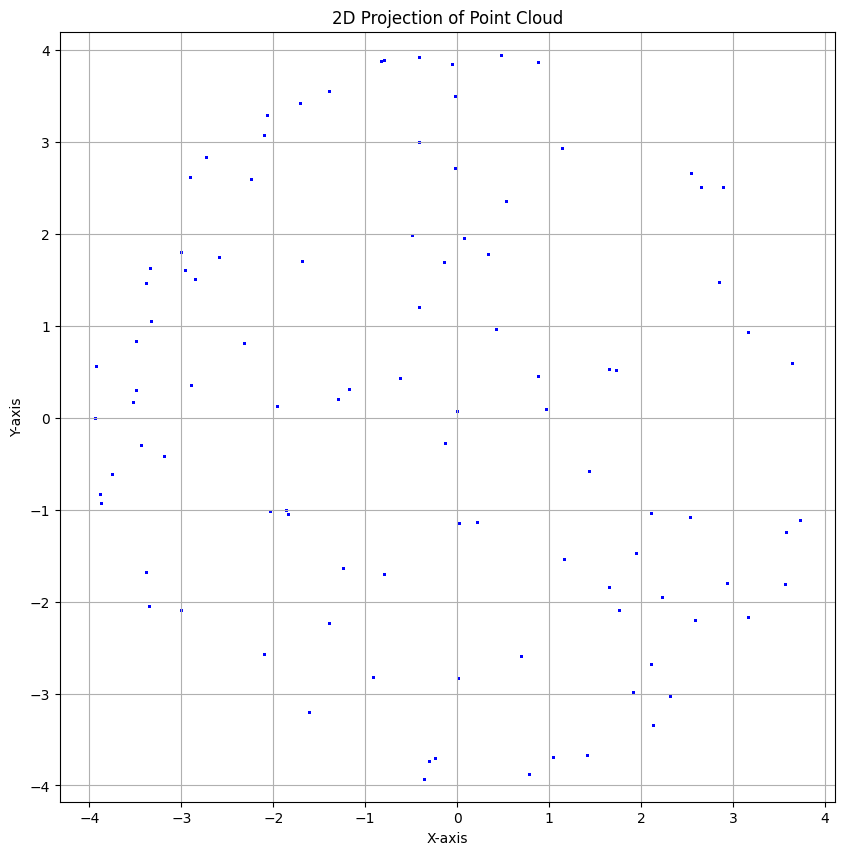

In [ ]:
import open3d as o3d

# Load the point cloud from the PLY file
point_cloud_path = "/content/point_cloud.ply"
point_cloud = o3d.io.read_point_cloud(point_cloud_path)

# Get the points from the point cloud
points = np.asarray(point_cloud.points)

# Create a 2D scatter plot of the point cloud
plt.figure(figsize=(10, 10))
plt.scatter(points[:, 0], points[:, 1], c='b', s=1)  # Adjust 's' for point size
plt.title("2D Projection of Point Cloud")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")
plt.axis('equal')  # Equal scaling for both axes
plt.grid(True)
plt.show()


##Vanila NERf

In [4]:
import torch
import numpy as np
from tqdm import tqdm
import torch.nn as nn
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader



In [ ]:

@torch.no_grad()
def test(hn, hf, dataset, chunk_size=5, img_index=0, nb_bins=192, H=200, W=200):
    """
    Args:
        hn: near plane distance
        hf: far plane distance
        dataset: dataset to render
        chunk_size (int, optional): chunk size for memory efficiency. Defaults to 10.
        img_index (int, optional): image index to render. Defaults to 0.
        nb_bins (int, optional): number of bins for density estimation. Defaults to 192.
        H (int, optional): image height. Defaults to 400.
        W (int, optional): image width. Defaults to 400.

    Returns:
        None: None
    """
    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []   # list of regenerated pixel values
    for i in range(int(np.ceil(H / chunk_size))):   # iterate over chunks
        # Get chunk of rays
        ray_origins_ = ray_origins[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        ray_directions_ = ray_directions[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)
    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)

    plt.figure()
    plt.imshow(img)
    plt.savefig(f'novel_views/img_{img_index}.png', bbox_inches='tight')
    plt.close()


class NerfModel(nn.Module):
    def __init__(self, embedding_dim_pos=10, embedding_dim_direction=4, hidden_dim=128):
        super(NerfModel, self).__init__()

        self.block1 = nn.Sequential(nn.Linear(embedding_dim_pos * 6 + 3, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(), )
        # density estimation
        self.block2 = nn.Sequential(nn.Linear(embedding_dim_pos * 6 + hidden_dim + 3, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim + 1), )
        # color estimation
        self.block3 = nn.Sequential(nn.Linear(embedding_dim_direction * 6 + hidden_dim + 3, hidden_dim // 2), nn.ReLU(), )
        self.block4 = nn.Sequential(nn.Linear(hidden_dim // 2, 3), nn.Sigmoid(), )

        self.embedding_dim_pos = embedding_dim_pos
        self.embedding_dim_direction = embedding_dim_direction
        self.relu = nn.ReLU()

    @staticmethod
    def positional_encoding(x, L):
        out = [x]
        for j in range(L):
            out.append(torch.sin(2 ** j * x))
            out.append(torch.cos(2 ** j * x))
        return torch.cat(out, dim=1)

    def forward(self, o, d):
        emb_x = self.positional_encoding(o, self.embedding_dim_pos) # emb_x: [batch_size, embedding_dim_pos * 6]
        emb_d = self.positional_encoding(d, self.embedding_dim_direction) # emb_d: [batch_size, embedding_dim_direction * 6]
        h = self.block1(emb_x) # h: [batch_size, hidden_dim]
        tmp = self.block2(torch.cat((h, emb_x), dim=1)) # tmp: [batch_size, hidden_dim + 1]
        h, sigma = tmp[:, :-1], self.relu(tmp[:, -1]) # h: [batch_size, hidden_dim], sigma: [batch_size]
        h = self.block3(torch.cat((h, emb_d), dim=1)) # h: [batch_size, hidden_dim // 2]
        c = self.block4(h) # c: [batch_size, 3]
        return c, sigma


def compute_accumulated_transmittance(alphas):
    accumulated_transmittance = torch.cumprod(alphas, 1)
    return torch.cat((torch.ones((accumulated_transmittance.shape[0], 1), device=alphas.device),
                      accumulated_transmittance[:, :-1]), dim=-1)


def render_rays(nerf_model, ray_origins, ray_directions, hn=0, hf=0.5, nb_bins=192):
    device = ray_origins.device

    t = torch.linspace(hn, hf, nb_bins, device=device).expand(ray_origins.shape[0], nb_bins)
    # Perturb sampling along each ray.
    mid = (t[:, :-1] + t[:, 1:]) / 2.
    lower = torch.cat((t[:, :1], mid), -1)
    upper = torch.cat((mid, t[:, -1:]), -1)
    u = torch.rand(t.shape, device=device)
    t = lower + (upper - lower) * u  # [batch_size, nb_bins]
    delta = torch.cat((t[:, 1:] - t[:, :-1], torch.tensor([1e10], device=device).expand(ray_origins.shape[0], 1)), -1)

    # Compute the 3D points along each ray
    x = ray_origins.unsqueeze(1) + t.unsqueeze(2) * ray_directions.unsqueeze(1)   # [batch_size, nb_bins, 3]
    # Expand the ray_directions tensor to match the shape of x
    ray_directions = ray_directions.expand(nb_bins, ray_directions.shape[0], 3).transpose(0, 1)

    colors, sigma = nerf_model(x.reshape(-1, 3), ray_directions.reshape(-1, 3))
    colors = colors.reshape(x.shape)
    sigma = sigma.reshape(x.shape[:-1])

    alpha = 1 - torch.exp(-sigma * delta)  # [batch_size, nb_bins]
    weights = compute_accumulated_transmittance(1 - alpha).unsqueeze(2) * alpha.unsqueeze(2)
    # Compute the pixel values as a weighted sum of colors along each ray
    c = (weights * colors).sum(dim=1)
    weight_sum = weights.sum(-1).sum(-1)  # Regularization for white background
    return c + 1 - weight_sum.unsqueeze(-1)



In [5]:
import torch
from tqdm import tqdm
import time
import os
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
from datetime import datetime
import os
import pandas as pd


In [13]:


def create_run_directories():
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    base_dir = 'experiments'
    run_dir = os.path.join(base_dir, f'run_{timestamp}')

    dirs = {
        'metrics': os.path.join(run_dir, 'metrics'),
    }

    for directory in dirs.values():
        os.makedirs(directory, exist_ok=True)
        print(f"Created directory: {directory}")

    return dirs

def calculate_psnr(predicted, target):
    mse = ((predicted - target) ** 2).mean()
    if mse == 0:
        return float('inf')
    return 20 * torch.log10(1.0 / torch.sqrt(mse))



In [ ]:
def train(nerf_model, optimizer, scheduler, data_loader, device='cpu', hn=0, hf=1, nb_epochs=10,
         nb_bins=192, H=200, W=200):
   training_loss = []
   metrics = {
       'epoch': [], 'batch': [],
       'fps': [], 'latency': [],
       'frame_variation': [], 'psnr': []
   }

   dirs = create_run_directories()
   metrics_file = os.path.join(dirs['metrics'], 'performance_metrics.csv')

   # Track total batches for progress bar
   total_batches = len(data_loader) * nb_epochs
   pbar = tqdm(total=total_batches, desc="Training Batches")

   for epoch in range(nb_epochs):
       epoch_loss = 0.0
       batch_times = []
       epoch_psnr = []
       epoch_start = time.time()

       for batch_idx, batch in enumerate(data_loader):
           batch_start = time.time()

           ray_origins = batch[:, :3].to(device)
           ray_directions = batch[:, 3:6].to(device)
           ground_truth_px_values = batch[:, 6:].to(device)

           regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                             hn=hn, hf=hf, nb_bins=nb_bins)
           current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
           loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

           optimizer.zero_grad()
           loss.backward()
           optimizer.step()

           batch_end = time.time()
           batch_time = batch_end - batch_start
           fps = 1.0 / batch_time
           batch_times.append(batch_time * 1000)
           epoch_psnr.append(current_psnr.item())
           epoch_loss += loss.item()

           # Store metrics
           metrics['epoch'].append(epoch)
           metrics['batch'].append(batch_idx)
           metrics['fps'].append(fps)
           metrics['latency'].append(batch_time * 1000)
           metrics['frame_variation'].append(np.std(batch_times))
           metrics['psnr'].append(current_psnr.item())

           if batch_idx % 10 == 0:
               print(f'\nEpoch {epoch+1}/{nb_epochs}, Batch {batch_idx}:')
               print(f'FPS: {fps:.2f}, Latency: {batch_time*1000:.2f}ms')
               print(f'PSNR: {current_psnr:.2f}dB, Loss: {loss.item():.4f}')

           pbar.update(1)

       # Epoch summary
       avg_epoch_loss = epoch_loss / len(data_loader)
       avg_epoch_psnr = sum(epoch_psnr) / len(epoch_psnr)
       epoch_fps = len(data_loader) / (time.time() - epoch_start)

       training_loss.append(avg_epoch_loss)

       # Save epoch metrics
       pd.DataFrame({
           'epoch': [epoch],
           'avg_loss': [avg_epoch_loss],
           'avg_psnr': [avg_epoch_psnr],
           'avg_fps': [epoch_fps],
           'frame_variation': [np.std(batch_times)]
       }).to_csv(metrics_file, mode='a', header=not os.path.exists(metrics_file), index=False)

       scheduler.step()

       print(f'\nEpoch {epoch+1} Summary:')
       print(f'Average Loss: {avg_epoch_loss:.4f}')
       print(f'Average PSNR: {avg_epoch_psnr:.2f}dB')
       print(f'Average FPS: {epoch_fps:.2f}')

   pbar.close()
   pd.DataFrame(metrics).to_csv(os.path.join(dirs['metrics'], 'detailed_metrics.csv'), index=False)
   return training_loss, metrics

In [ ]:
if __name__ == '__main__':
   device = 'cuda' if torch.cuda.is_available() else 'cpu'
   print(f"Using device: {device}")

   try:
       # Load datasets
       training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
       testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

       # Convert to torch tensors
       training_dataset = torch.from_numpy(training_data).float()
       testing_dataset = torch.from_numpy(testing_data).float()

       print(f"Original Training dataset shape: {training_dataset.shape}")

       # Take 1/5 of dataset
       subset_size = training_dataset.size(0) // 5
       training_dataset = training_dataset[:subset_size]

       print(f"Subset Training dataset shape: {training_dataset.shape}")

       # Determine batch size
       initial_batch_size = 256
       num_samples = training_dataset.size(0)
       batch_size = min(initial_batch_size, num_samples)

       # Data loader with adjusted batch size
       data_loader = DataLoader(
           training_dataset,
           batch_size=batch_size,
           shuffle=True,
           num_workers=4
       )

       # Model setup
       model = NerfModel(hidden_dim=256).to(device)
       model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
       scheduler = torch.optim.lr_scheduler.MultiStepLR(
           model_optimizer,
           milestones=[2, 4, 8],
           gamma=0.5
       )

       print("Starting training...")
       training_loss, metrics = train(
           model,
           model_optimizer,
           scheduler,
           data_loader,
           device=device,
           nb_epochs=10,
           hn=2,
           hf=6,
           nb_bins=192,
           H=200,
           W=200
       )

       # Plot results
       plt.figure(figsize=(15, 5))

       plt.subplot(131)
       plt.plot(training_loss)
       plt.title('Training Loss')
       plt.xlabel('Epoch')
       plt.ylabel('Loss')

       plt.subplot(132)
       plt.plot(metrics['fps'])
       plt.axhline(y=30, color='r', linestyle='--', label='Minimum FPS')
       plt.title('FPS over Time')
       plt.xlabel('Batch')
       plt.ylabel('FPS')
       plt.legend()

       plt.subplot(133)
       plt.plot(metrics['psnr'])
       plt.title('PSNR over Time')
       plt.xlabel('Batch')
       plt.ylabel('PSNR (dB)')

       plt.tight_layout()
       plt.savefig('final_results.png')
       plt.close()

   except Exception as e:
       print(f"Error occurred: {e}")
   finally:
       if torch.cuda.is_available():
           torch.cuda.empty_cache()
       print("Process completed")

Using device: cuda
Original Training dataset shape: torch.Size([16000000, 9])
Subset Training dataset shape: torch.Size([3200000, 9])
Starting training...
Created directory: experiments/run_20241116_162251/metrics


Training Batches:   0%|          | 6/125000 [00:01<7:19:01,  4.75it/s] 


Epoch 1/10, Batch 0:
FPS: 0.90, Latency: 1113.17ms
PSNR: 8.96dB, Loss: 0.1269


Training Batches:   0%|          | 18/125000 [00:01<2:04:22, 16.75it/s]


Epoch 1/10, Batch 10:
FPS: 101.27, Latency: 9.87ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 1/10, Batch 20:
FPS: 105.93, Latency: 9.44ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:   0%|          | 42/125000 [00:02<52:03, 40.01it/s]


Epoch 1/10, Batch 30:
FPS: 105.22, Latency: 9.50ms
PSNR: 8.40dB, Loss: 0.1445

Epoch 1/10, Batch 40:
FPS: 103.63, Latency: 9.65ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:   0%|          | 60/125000 [00:02<41:47, 49.82it/s]


Epoch 1/10, Batch 50:
FPS: 104.40, Latency: 9.58ms
PSNR: 10.29dB, Loss: 0.0935

Epoch 1/10, Batch 60:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:   0%|          | 78/125000 [00:02<38:30, 54.07it/s]


Epoch 1/10, Batch 70:
FPS: 104.65, Latency: 9.56ms
PSNR: 10.36dB, Loss: 0.0921

Epoch 1/10, Batch 80:
FPS: 99.05, Latency: 10.10ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:   0%|          | 102/125000 [00:03<37:10, 55.98it/s]


Epoch 1/10, Batch 90:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.29dB, Loss: 0.1176

Epoch 1/10, Batch 100:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:   0%|          | 120/125000 [00:03<36:35, 56.89it/s]


Epoch 1/10, Batch 110:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.10dB, Loss: 0.1232

Epoch 1/10, Batch 120:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.81dB, Loss: 0.1045


Training Batches:   0%|          | 138/125000 [00:04<36:34, 56.90it/s]


Epoch 1/10, Batch 130:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 1/10, Batch 140:
FPS: 104.63, Latency: 9.56ms
PSNR: 9.96dB, Loss: 0.1009


Training Batches:   0%|          | 162/125000 [00:04<36:42, 56.68it/s]


Epoch 1/10, Batch 150:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.52dB, Loss: 0.1407

Epoch 1/10, Batch 160:
FPS: 93.23, Latency: 10.73ms
PSNR: 8.62dB, Loss: 0.1375


Training Batches:   0%|          | 180/125000 [00:04<36:41, 56.70it/s]


Epoch 1/10, Batch 170:
FPS: 101.01, Latency: 9.90ms
PSNR: 10.08dB, Loss: 0.0981

Epoch 1/10, Batch 180:
FPS: 99.23, Latency: 10.08ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:   0%|          | 198/125000 [00:05<36:46, 56.56it/s]


Epoch 1/10, Batch 190:
FPS: 100.37, Latency: 9.96ms
PSNR: 8.42dB, Loss: 0.1438

Epoch 1/10, Batch 200:
FPS: 99.85, Latency: 10.02ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:   0%|          | 222/125000 [00:05<36:59, 56.22it/s]


Epoch 1/10, Batch 210:
FPS: 99.98, Latency: 10.00ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 1/10, Batch 220:
FPS: 100.56, Latency: 9.94ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:   0%|          | 240/125000 [00:05<36:44, 56.59it/s]


Epoch 1/10, Batch 230:
FPS: 100.86, Latency: 9.91ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 1/10, Batch 240:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:   0%|          | 258/125000 [00:06<36:45, 56.56it/s]


Epoch 1/10, Batch 250:
FPS: 100.76, Latency: 9.92ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 1/10, Batch 260:
FPS: 100.61, Latency: 9.94ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:   0%|          | 282/125000 [00:06<36:38, 56.72it/s]


Epoch 1/10, Batch 270:
FPS: 102.91, Latency: 9.72ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 1/10, Batch 280:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:   0%|          | 300/125000 [00:06<36:22, 57.14it/s]


Epoch 1/10, Batch 290:
FPS: 106.44, Latency: 9.40ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 1/10, Batch 300:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:   0%|          | 318/125000 [00:07<36:20, 57.18it/s]


Epoch 1/10, Batch 310:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 1/10, Batch 320:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:   0%|          | 342/125000 [00:07<36:29, 56.93it/s]


Epoch 1/10, Batch 330:
FPS: 93.32, Latency: 10.72ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 1/10, Batch 340:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:   0%|          | 354/125000 [00:07<36:25, 57.03it/s]


Epoch 1/10, Batch 350:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:   0%|          | 372/125000 [00:08<39:50, 52.14it/s]


Epoch 1/10, Batch 360:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 1/10, Batch 370:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:   0%|          | 390/125000 [00:08<37:58, 54.69it/s]


Epoch 1/10, Batch 380:
FPS: 97.55, Latency: 10.25ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 1/10, Batch 390:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:   0%|          | 408/125000 [00:08<37:21, 55.58it/s]


Epoch 1/10, Batch 400:
FPS: 99.95, Latency: 10.00ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 1/10, Batch 410:
FPS: 101.73, Latency: 9.83ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:   0%|          | 432/125000 [00:09<36:57, 56.17it/s]


Epoch 1/10, Batch 420:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 1/10, Batch 430:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:   0%|          | 450/125000 [00:09<36:43, 56.52it/s]


Epoch 1/10, Batch 440:
FPS: 105.50, Latency: 9.48ms
PSNR: 10.33dB, Loss: 0.0927

Epoch 1/10, Batch 450:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.97dB, Loss: 0.1008


Training Batches:   0%|          | 468/125000 [00:09<37:07, 55.91it/s]


Epoch 1/10, Batch 460:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.13dB, Loss: 0.1537

Epoch 1/10, Batch 470:
FPS: 108.20, Latency: 9.24ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:   0%|          | 492/125000 [00:10<36:30, 56.83it/s]


Epoch 1/10, Batch 480:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 1/10, Batch 490:
FPS: 109.02, Latency: 9.17ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:   0%|          | 510/125000 [00:10<36:46, 56.43it/s]


Epoch 1/10, Batch 500:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 1/10, Batch 510:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:   0%|          | 528/125000 [00:10<36:38, 56.63it/s]


Epoch 1/10, Batch 520:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 1/10, Batch 530:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:   0%|          | 552/125000 [00:11<37:01, 56.03it/s]


Epoch 1/10, Batch 540:
FPS: 103.26, Latency: 9.68ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 1/10, Batch 550:
FPS: 98.73, Latency: 10.13ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:   0%|          | 570/125000 [00:11<37:03, 55.96it/s]


Epoch 1/10, Batch 560:
FPS: 105.32, Latency: 9.49ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 1/10, Batch 570:
FPS: 100.17, Latency: 9.98ms
PSNR: 10.42dB, Loss: 0.0908


Training Batches:   0%|          | 588/125000 [00:12<37:34, 55.17it/s]


Epoch 1/10, Batch 580:
FPS: 97.87, Latency: 10.22ms
PSNR: 9.38dB, Loss: 0.1152

Epoch 1/10, Batch 590:
FPS: 102.40, Latency: 9.77ms
PSNR: 9.66dB, Loss: 0.1083


Training Batches:   0%|          | 612/125000 [00:12<37:16, 55.61it/s]


Epoch 1/10, Batch 600:
FPS: 102.86, Latency: 9.72ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 1/10, Batch 610:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:   1%|          | 630/125000 [00:12<37:07, 55.84it/s]


Epoch 1/10, Batch 620:
FPS: 101.89, Latency: 9.81ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 1/10, Batch 630:
FPS: 98.89, Latency: 10.11ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:   1%|          | 648/125000 [00:13<36:36, 56.62it/s]


Epoch 1/10, Batch 640:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 1/10, Batch 650:
FPS: 104.39, Latency: 9.58ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:   1%|          | 672/125000 [00:13<36:52, 56.20it/s]


Epoch 1/10, Batch 660:
FPS: 97.33, Latency: 10.27ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 1/10, Batch 670:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:   1%|          | 690/125000 [00:13<36:34, 56.66it/s]


Epoch 1/10, Batch 680:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 1/10, Batch 690:
FPS: 105.89, Latency: 9.44ms
PSNR: 10.06dB, Loss: 0.0987


Training Batches:   1%|          | 708/125000 [00:14<36:27, 56.81it/s]


Epoch 1/10, Batch 700:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.83dB, Loss: 0.1041

Epoch 1/10, Batch 710:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:   1%|          | 732/125000 [00:14<36:31, 56.72it/s]


Epoch 1/10, Batch 720:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.88dB, Loss: 0.1028

Epoch 1/10, Batch 730:
FPS: 108.53, Latency: 9.21ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:   1%|          | 750/125000 [00:14<36:27, 56.80it/s]


Epoch 1/10, Batch 740:
FPS: 102.70, Latency: 9.74ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 1/10, Batch 750:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.29dB, Loss: 0.1484


Training Batches:   1%|          | 768/125000 [00:15<36:18, 57.02it/s]


Epoch 1/10, Batch 760:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 1/10, Batch 770:
FPS: 108.52, Latency: 9.21ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:   1%|          | 792/125000 [00:15<36:18, 57.02it/s]


Epoch 1/10, Batch 780:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 1/10, Batch 790:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:   1%|          | 810/125000 [00:15<36:10, 57.21it/s]


Epoch 1/10, Batch 800:
FPS: 104.60, Latency: 9.56ms
PSNR: 9.95dB, Loss: 0.1011

Epoch 1/10, Batch 810:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.22dB, Loss: 0.1195


Training Batches:   1%|          | 828/125000 [00:16<36:11, 57.18it/s]


Epoch 1/10, Batch 820:
FPS: 107.47, Latency: 9.31ms
PSNR: 10.10dB, Loss: 0.0978

Epoch 1/10, Batch 830:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:   1%|          | 852/125000 [00:16<36:15, 57.06it/s]


Epoch 1/10, Batch 840:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 1/10, Batch 850:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:   1%|          | 870/125000 [00:17<36:08, 57.25it/s]


Epoch 1/10, Batch 860:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 1/10, Batch 870:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:   1%|          | 888/125000 [00:17<36:12, 57.12it/s]


Epoch 1/10, Batch 880:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 1/10, Batch 890:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:   1%|          | 912/125000 [00:17<36:19, 56.93it/s]


Epoch 1/10, Batch 900:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 1/10, Batch 910:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.54dB, Loss: 0.1113


Training Batches:   1%|          | 930/125000 [00:18<36:06, 57.26it/s]


Epoch 1/10, Batch 920:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 1/10, Batch 930:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:   1%|          | 948/125000 [00:18<36:10, 57.17it/s]


Epoch 1/10, Batch 940:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 1/10, Batch 950:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.44dB, Loss: 0.1431


Training Batches:   1%|          | 972/125000 [00:18<36:01, 57.39it/s]


Epoch 1/10, Batch 960:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 1/10, Batch 970:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:   1%|          | 990/125000 [00:19<35:52, 57.61it/s]


Epoch 1/10, Batch 980:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 1/10, Batch 990:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.22dB, Loss: 0.1508


Training Batches:   1%|          | 1008/125000 [00:19<36:03, 57.31it/s]


Epoch 1/10, Batch 1000:
FPS: 108.59, Latency: 9.21ms
PSNR: 9.73dB, Loss: 0.1065

Epoch 1/10, Batch 1010:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.17dB, Loss: 0.1525


Training Batches:   1%|          | 1032/125000 [00:19<36:05, 57.26it/s]


Epoch 1/10, Batch 1020:
FPS: 104.23, Latency: 9.59ms
PSNR: 10.15dB, Loss: 0.0966

Epoch 1/10, Batch 1030:
FPS: 108.28, Latency: 9.24ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:   1%|          | 1050/125000 [00:20<36:00, 57.37it/s]


Epoch 1/10, Batch 1040:
FPS: 108.77, Latency: 9.19ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 1/10, Batch 1050:
FPS: 103.08, Latency: 9.70ms
PSNR: 8.48dB, Loss: 0.1419


Training Batches:   1%|          | 1068/125000 [00:20<36:15, 56.97it/s]


Epoch 1/10, Batch 1060:
FPS: 96.68, Latency: 10.34ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 1/10, Batch 1070:
FPS: 105.74, Latency: 9.46ms
PSNR: 10.32dB, Loss: 0.0930


Training Batches:   1%|          | 1092/125000 [00:20<36:13, 57.01it/s]


Epoch 1/10, Batch 1080:
FPS: 102.12, Latency: 9.79ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 1/10, Batch 1090:
FPS: 105.56, Latency: 9.47ms
PSNR: 10.30dB, Loss: 0.0932


Training Batches:   1%|          | 1110/125000 [00:21<36:06, 57.18it/s]


Epoch 1/10, Batch 1100:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 1/10, Batch 1110:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:   1%|          | 1128/125000 [00:21<36:07, 57.16it/s]


Epoch 1/10, Batch 1120:
FPS: 108.51, Latency: 9.22ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 1/10, Batch 1130:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:   1%|          | 1152/125000 [00:21<36:12, 57.02it/s]


Epoch 1/10, Batch 1140:
FPS: 101.55, Latency: 9.85ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 1/10, Batch 1150:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.33dB, Loss: 0.1469


Training Batches:   1%|          | 1170/125000 [00:22<36:14, 56.94it/s]


Epoch 1/10, Batch 1160:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.36dB, Loss: 0.1160

Epoch 1/10, Batch 1170:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:   1%|          | 1188/125000 [00:22<36:18, 56.82it/s]


Epoch 1/10, Batch 1180:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 1/10, Batch 1190:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:   1%|          | 1212/125000 [00:23<36:31, 56.49it/s]


Epoch 1/10, Batch 1200:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.65dB, Loss: 0.1085

Epoch 1/10, Batch 1210:
FPS: 101.33, Latency: 9.87ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:   1%|          | 1230/125000 [00:23<36:29, 56.54it/s]


Epoch 1/10, Batch 1220:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 1/10, Batch 1230:
FPS: 93.37, Latency: 10.71ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:   1%|          | 1248/125000 [00:23<36:51, 55.95it/s]


Epoch 1/10, Batch 1240:
FPS: 102.68, Latency: 9.74ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 1/10, Batch 1250:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:   1%|          | 1272/125000 [00:24<36:33, 56.41it/s]


Epoch 1/10, Batch 1260:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 1/10, Batch 1270:
FPS: 104.27, Latency: 9.59ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:   1%|          | 1290/125000 [00:24<36:40, 56.21it/s]


Epoch 1/10, Batch 1280:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 1/10, Batch 1290:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:   1%|          | 1308/125000 [00:24<36:37, 56.28it/s]


Epoch 1/10, Batch 1300:
FPS: 104.83, Latency: 9.54ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 1/10, Batch 1310:
FPS: 95.05, Latency: 10.52ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:   1%|          | 1332/125000 [00:25<36:29, 56.47it/s]


Epoch 1/10, Batch 1320:
FPS: 102.80, Latency: 9.73ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 1/10, Batch 1330:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:   1%|          | 1350/125000 [00:25<36:13, 56.89it/s]


Epoch 1/10, Batch 1340:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 1/10, Batch 1350:
FPS: 104.87, Latency: 9.54ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:   1%|          | 1368/125000 [00:25<36:13, 56.87it/s]


Epoch 1/10, Batch 1360:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 1/10, Batch 1370:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:   1%|          | 1392/125000 [00:26<36:08, 57.00it/s]


Epoch 1/10, Batch 1380:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 1/10, Batch 1390:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:   1%|          | 1410/125000 [00:26<36:13, 56.87it/s]


Epoch 1/10, Batch 1400:
FPS: 98.62, Latency: 10.14ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 1/10, Batch 1410:
FPS: 104.53, Latency: 9.57ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:   1%|          | 1428/125000 [00:26<36:16, 56.77it/s]


Epoch 1/10, Batch 1420:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 1/10, Batch 1430:
FPS: 109.14, Latency: 9.16ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:   1%|          | 1452/125000 [00:27<36:00, 57.17it/s]


Epoch 1/10, Batch 1440:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 1/10, Batch 1450:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:   1%|          | 1470/125000 [00:27<36:01, 57.15it/s]


Epoch 1/10, Batch 1460:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 1/10, Batch 1470:
FPS: 103.98, Latency: 9.62ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:   1%|          | 1488/125000 [00:27<35:56, 57.27it/s]


Epoch 1/10, Batch 1480:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 1/10, Batch 1490:
FPS: 109.83, Latency: 9.10ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:   1%|          | 1512/125000 [00:28<35:55, 57.28it/s]


Epoch 1/10, Batch 1500:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 1/10, Batch 1510:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:   1%|          | 1530/125000 [00:28<35:56, 57.25it/s]


Epoch 1/10, Batch 1520:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 1/10, Batch 1530:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:   1%|          | 1548/125000 [00:28<35:50, 57.41it/s]


Epoch 1/10, Batch 1540:
FPS: 108.79, Latency: 9.19ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 1/10, Batch 1550:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:   1%|▏         | 1572/125000 [00:29<35:56, 57.25it/s]


Epoch 1/10, Batch 1560:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 1/10, Batch 1570:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:   1%|▏         | 1590/125000 [00:29<35:59, 57.15it/s]


Epoch 1/10, Batch 1580:
FPS: 109.04, Latency: 9.17ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 1/10, Batch 1590:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:   1%|▏         | 1608/125000 [00:29<36:05, 56.99it/s]


Epoch 1/10, Batch 1600:
FPS: 106.03, Latency: 9.43ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 1/10, Batch 1610:
FPS: 108.25, Latency: 9.24ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:   1%|▏         | 1632/125000 [00:30<36:00, 57.11it/s]


Epoch 1/10, Batch 1620:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 1/10, Batch 1630:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:   1%|▏         | 1650/125000 [00:30<35:56, 57.20it/s]


Epoch 1/10, Batch 1640:
FPS: 101.99, Latency: 9.80ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 1/10, Batch 1650:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.64dB, Loss: 0.1088


Training Batches:   1%|▏         | 1668/125000 [00:31<36:05, 56.95it/s]


Epoch 1/10, Batch 1660:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.60dB, Loss: 0.1095

Epoch 1/10, Batch 1670:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:   1%|▏         | 1692/125000 [00:31<36:00, 57.07it/s]


Epoch 1/10, Batch 1680:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 1/10, Batch 1690:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.51dB, Loss: 0.1121


Training Batches:   1%|▏         | 1710/125000 [00:31<35:57, 57.14it/s]


Epoch 1/10, Batch 1700:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 1/10, Batch 1710:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:   1%|▏         | 1728/125000 [00:32<35:56, 57.17it/s]


Epoch 1/10, Batch 1720:
FPS: 107.47, Latency: 9.31ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 1/10, Batch 1730:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:   1%|▏         | 1752/125000 [00:32<36:01, 57.03it/s]


Epoch 1/10, Batch 1740:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.34dB, Loss: 0.1467

Epoch 1/10, Batch 1750:
FPS: 107.11, Latency: 9.34ms
PSNR: 7.94dB, Loss: 0.1606


Training Batches:   1%|▏         | 1770/125000 [00:32<35:55, 57.18it/s]


Epoch 1/10, Batch 1760:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 1/10, Batch 1770:
FPS: 103.38, Latency: 9.67ms
PSNR: 8.23dB, Loss: 0.1503


Training Batches:   1%|▏         | 1788/125000 [00:33<36:00, 57.02it/s]


Epoch 1/10, Batch 1780:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.74dB, Loss: 0.1062

Epoch 1/10, Batch 1790:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:   1%|▏         | 1812/125000 [00:33<36:11, 56.73it/s]


Epoch 1/10, Batch 1800:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.56dB, Loss: 0.1395

Epoch 1/10, Batch 1810:
FPS: 105.96, Latency: 9.44ms
PSNR: 10.14dB, Loss: 0.0967


Training Batches:   1%|▏         | 1830/125000 [00:33<36:04, 56.91it/s]


Epoch 1/10, Batch 1820:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.99dB, Loss: 0.1002

Epoch 1/10, Batch 1830:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:   1%|▏         | 1848/125000 [00:34<36:09, 56.76it/s]


Epoch 1/10, Batch 1840:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 1/10, Batch 1850:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.03dB, Loss: 0.1252


Training Batches:   1%|▏         | 1872/125000 [00:34<36:19, 56.50it/s]


Epoch 1/10, Batch 1860:
FPS: 102.93, Latency: 9.72ms
PSNR: 9.73dB, Loss: 0.1065

Epoch 1/10, Batch 1870:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:   2%|▏         | 1890/125000 [00:34<36:08, 56.77it/s]


Epoch 1/10, Batch 1880:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 1/10, Batch 1890:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:   2%|▏         | 1908/125000 [00:35<36:09, 56.74it/s]


Epoch 1/10, Batch 1900:
FPS: 108.10, Latency: 9.25ms
PSNR: 10.22dB, Loss: 0.0951

Epoch 1/10, Batch 1910:
FPS: 103.38, Latency: 9.67ms
PSNR: 9.62dB, Loss: 0.1090


Training Batches:   2%|▏         | 1932/125000 [00:35<36:06, 56.81it/s]


Epoch 1/10, Batch 1920:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 1/10, Batch 1930:
FPS: 107.29, Latency: 9.32ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:   2%|▏         | 1950/125000 [00:35<36:08, 56.75it/s]


Epoch 1/10, Batch 1940:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.41dB, Loss: 0.1147

Epoch 1/10, Batch 1950:
FPS: 101.54, Latency: 9.85ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:   2%|▏         | 1968/125000 [00:36<36:19, 56.46it/s]


Epoch 1/10, Batch 1960:
FPS: 104.49, Latency: 9.57ms
PSNR: 9.88dB, Loss: 0.1029

Epoch 1/10, Batch 1970:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:   2%|▏         | 1992/125000 [00:36<36:11, 56.65it/s]


Epoch 1/10, Batch 1980:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 1/10, Batch 1990:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.87dB, Loss: 0.1296


Training Batches:   2%|▏         | 2010/125000 [00:37<36:26, 56.25it/s]


Epoch 1/10, Batch 2000:
FPS: 104.84, Latency: 9.54ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 1/10, Batch 2010:
FPS: 100.61, Latency: 9.94ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:   2%|▏         | 2028/125000 [00:37<36:29, 56.15it/s]


Epoch 1/10, Batch 2020:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 1/10, Batch 2030:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:   2%|▏         | 2052/125000 [00:37<36:33, 56.04it/s]


Epoch 1/10, Batch 2040:
FPS: 101.60, Latency: 9.84ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 1/10, Batch 2050:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:   2%|▏         | 2070/125000 [00:38<36:07, 56.72it/s]


Epoch 1/10, Batch 2060:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.33dB, Loss: 0.1470

Epoch 1/10, Batch 2070:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:   2%|▏         | 2088/125000 [00:38<36:13, 56.56it/s]


Epoch 1/10, Batch 2080:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 1/10, Batch 2090:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:   2%|▏         | 2112/125000 [00:38<36:09, 56.64it/s]


Epoch 1/10, Batch 2100:
FPS: 103.51, Latency: 9.66ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 1/10, Batch 2110:
FPS: 106.55, Latency: 9.38ms
PSNR: 8.47dB, Loss: 0.1421


Training Batches:   2%|▏         | 2130/125000 [00:39<35:56, 56.99it/s]


Epoch 1/10, Batch 2120:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 1/10, Batch 2130:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:   2%|▏         | 2148/125000 [00:39<36:00, 56.87it/s]


Epoch 1/10, Batch 2140:
FPS: 104.55, Latency: 9.56ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 1/10, Batch 2150:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:   2%|▏         | 2172/125000 [00:39<36:08, 56.63it/s]


Epoch 1/10, Batch 2160:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 1/10, Batch 2170:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:   2%|▏         | 2190/125000 [00:40<36:02, 56.79it/s]


Epoch 1/10, Batch 2180:
FPS: 99.94, Latency: 10.01ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 1/10, Batch 2190:
FPS: 104.98, Latency: 9.53ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:   2%|▏         | 2208/125000 [00:40<36:20, 56.32it/s]


Epoch 1/10, Batch 2200:
FPS: 100.51, Latency: 9.95ms
PSNR: 8.99dB, Loss: 0.1260

Epoch 1/10, Batch 2210:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:   2%|▏         | 2232/125000 [00:40<36:19, 56.33it/s]


Epoch 1/10, Batch 2220:
FPS: 98.76, Latency: 10.13ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 1/10, Batch 2230:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:   2%|▏         | 2250/125000 [00:41<36:06, 56.65it/s]


Epoch 1/10, Batch 2240:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 1/10, Batch 2250:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:   2%|▏         | 2268/125000 [00:41<36:09, 56.57it/s]


Epoch 1/10, Batch 2260:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 1/10, Batch 2270:
FPS: 105.25, Latency: 9.50ms
PSNR: 8.34dB, Loss: 0.1465


Training Batches:   2%|▏         | 2292/125000 [00:42<36:27, 56.09it/s]


Epoch 1/10, Batch 2280:
FPS: 98.33, Latency: 10.17ms
PSNR: 8.55dB, Loss: 0.1398

Epoch 1/10, Batch 2290:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:   2%|▏         | 2310/125000 [00:42<36:28, 56.07it/s]


Epoch 1/10, Batch 2300:
FPS: 100.94, Latency: 9.91ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 1/10, Batch 2310:
FPS: 103.09, Latency: 9.70ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:   2%|▏         | 2328/125000 [00:42<36:21, 56.23it/s]


Epoch 1/10, Batch 2320:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 1/10, Batch 2330:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:   2%|▏         | 2352/125000 [00:43<36:30, 55.98it/s]


Epoch 1/10, Batch 2340:
FPS: 101.79, Latency: 9.82ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 1/10, Batch 2350:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:   2%|▏         | 2370/125000 [00:43<36:11, 56.49it/s]


Epoch 1/10, Batch 2360:
FPS: 106.67, Latency: 9.38ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 1/10, Batch 2370:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:   2%|▏         | 2388/125000 [00:43<36:14, 56.39it/s]


Epoch 1/10, Batch 2380:
FPS: 108.67, Latency: 9.20ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 1/10, Batch 2390:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:   2%|▏         | 2412/125000 [00:44<36:26, 56.06it/s]


Epoch 1/10, Batch 2400:
FPS: 107.90, Latency: 9.27ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 1/10, Batch 2410:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:   2%|▏         | 2430/125000 [00:44<36:19, 56.23it/s]


Epoch 1/10, Batch 2420:
FPS: 103.25, Latency: 9.69ms
PSNR: 10.21dB, Loss: 0.0954

Epoch 1/10, Batch 2430:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:   2%|▏         | 2448/125000 [00:44<36:23, 56.14it/s]


Epoch 1/10, Batch 2440:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 1/10, Batch 2450:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:   2%|▏         | 2472/125000 [00:45<36:13, 56.37it/s]


Epoch 1/10, Batch 2460:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.55dB, Loss: 0.1396

Epoch 1/10, Batch 2470:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.43dB, Loss: 0.1437


Training Batches:   2%|▏         | 2490/125000 [00:45<36:30, 55.92it/s]


Epoch 1/10, Batch 2480:
FPS: 104.93, Latency: 9.53ms
PSNR: 8.17dB, Loss: 0.1523

Epoch 1/10, Batch 2490:
FPS: 100.82, Latency: 9.92ms
PSNR: 7.89dB, Loss: 0.1627


Training Batches:   2%|▏         | 2508/125000 [00:45<36:32, 55.87it/s]


Epoch 1/10, Batch 2500:
FPS: 105.30, Latency: 9.50ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 1/10, Batch 2510:
FPS: 98.83, Latency: 10.12ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:   2%|▏         | 2532/125000 [00:46<36:50, 55.41it/s]


Epoch 1/10, Batch 2520:
FPS: 103.09, Latency: 9.70ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 1/10, Batch 2530:
FPS: 101.45, Latency: 9.86ms
PSNR: 8.79dB, Loss: 0.1320


Training Batches:   2%|▏         | 2550/125000 [00:46<36:07, 56.50it/s]


Epoch 1/10, Batch 2540:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 1/10, Batch 2550:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:   2%|▏         | 2568/125000 [00:46<35:49, 56.96it/s]


Epoch 1/10, Batch 2560:
FPS: 108.40, Latency: 9.23ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 1/10, Batch 2570:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.12dB, Loss: 0.1542


Training Batches:   2%|▏         | 2592/125000 [00:47<35:48, 56.97it/s]


Epoch 1/10, Batch 2580:
FPS: 109.16, Latency: 9.16ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 1/10, Batch 2590:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:   2%|▏         | 2610/125000 [00:47<35:43, 57.09it/s]


Epoch 1/10, Batch 2600:
FPS: 108.87, Latency: 9.19ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 1/10, Batch 2610:
FPS: 104.47, Latency: 9.57ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:   2%|▏         | 2628/125000 [00:48<35:59, 56.66it/s]


Epoch 1/10, Batch 2620:
FPS: 108.07, Latency: 9.25ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 1/10, Batch 2630:
FPS: 108.82, Latency: 9.19ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:   2%|▏         | 2652/125000 [00:48<36:08, 56.41it/s]


Epoch 1/10, Batch 2640:
FPS: 103.61, Latency: 9.65ms
PSNR: 8.44dB, Loss: 0.1432

Epoch 1/10, Batch 2650:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:   2%|▏         | 2670/125000 [00:48<36:07, 56.44it/s]


Epoch 1/10, Batch 2660:
FPS: 101.12, Latency: 9.89ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 1/10, Batch 2670:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:   2%|▏         | 2688/125000 [00:49<36:02, 56.56it/s]


Epoch 1/10, Batch 2680:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 1/10, Batch 2690:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.79dB, Loss: 0.1048


Training Batches:   2%|▏         | 2712/125000 [00:49<36:50, 55.33it/s]


Epoch 1/10, Batch 2700:
FPS: 100.12, Latency: 9.99ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 1/10, Batch 2710:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:   2%|▏         | 2730/125000 [00:49<36:19, 56.10it/s]


Epoch 1/10, Batch 2720:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 1/10, Batch 2730:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:   2%|▏         | 2748/125000 [00:50<36:25, 55.94it/s]


Epoch 1/10, Batch 2740:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 1/10, Batch 2750:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:   2%|▏         | 2772/125000 [00:50<36:24, 55.94it/s]


Epoch 1/10, Batch 2760:
FPS: 95.63, Latency: 10.46ms
PSNR: 9.85dB, Loss: 0.1035

Epoch 1/10, Batch 2770:
FPS: 100.51, Latency: 9.95ms
PSNR: 8.61dB, Loss: 0.1379


Training Batches:   2%|▏         | 2790/125000 [00:50<36:05, 56.43it/s]


Epoch 1/10, Batch 2780:
FPS: 107.99, Latency: 9.26ms
PSNR: 10.64dB, Loss: 0.0862

Epoch 1/10, Batch 2790:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:   2%|▏         | 2808/125000 [00:51<36:02, 56.51it/s]


Epoch 1/10, Batch 2800:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 1/10, Batch 2810:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:   2%|▏         | 2832/125000 [00:51<36:18, 56.07it/s]


Epoch 1/10, Batch 2820:
FPS: 102.85, Latency: 9.72ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 1/10, Batch 2830:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.65dB, Loss: 0.1363


Training Batches:   2%|▏         | 2850/125000 [00:51<36:11, 56.26it/s]


Epoch 1/10, Batch 2840:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 1/10, Batch 2850:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:   2%|▏         | 2868/125000 [00:52<36:07, 56.34it/s]


Epoch 1/10, Batch 2860:
FPS: 107.88, Latency: 9.27ms
PSNR: 10.27dB, Loss: 0.0939

Epoch 1/10, Batch 2870:
FPS: 101.47, Latency: 9.86ms
PSNR: 9.51dB, Loss: 0.1118


Training Batches:   2%|▏         | 2892/125000 [00:52<36:08, 56.32it/s]


Epoch 1/10, Batch 2880:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.14dB, Loss: 0.1535

Epoch 1/10, Batch 2890:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.13dB, Loss: 0.1537


Training Batches:   2%|▏         | 2910/125000 [00:53<35:58, 56.55it/s]


Epoch 1/10, Batch 2900:
FPS: 108.31, Latency: 9.23ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 1/10, Batch 2910:
FPS: 101.04, Latency: 9.90ms
PSNR: 9.49dB, Loss: 0.1126


Training Batches:   2%|▏         | 2928/125000 [00:53<36:12, 56.19it/s]


Epoch 1/10, Batch 2920:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.46dB, Loss: 0.1425

Epoch 1/10, Batch 2930:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:   2%|▏         | 2952/125000 [00:53<36:02, 56.45it/s]


Epoch 1/10, Batch 2940:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 1/10, Batch 2950:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:   2%|▏         | 2970/125000 [00:54<36:06, 56.32it/s]


Epoch 1/10, Batch 2960:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 1/10, Batch 2970:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:   2%|▏         | 2988/125000 [00:54<36:01, 56.44it/s]


Epoch 1/10, Batch 2980:
FPS: 99.29, Latency: 10.07ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 1/10, Batch 2990:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:   2%|▏         | 3012/125000 [00:54<35:49, 56.75it/s]


Epoch 1/10, Batch 3000:
FPS: 102.86, Latency: 9.72ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 1/10, Batch 3010:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:   2%|▏         | 3030/125000 [00:55<35:48, 56.76it/s]


Epoch 1/10, Batch 3020:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 1/10, Batch 3030:
FPS: 101.93, Latency: 9.81ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:   2%|▏         | 3048/125000 [00:55<35:52, 56.66it/s]


Epoch 1/10, Batch 3040:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 1/10, Batch 3050:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:   2%|▏         | 3072/125000 [00:55<36:02, 56.38it/s]


Epoch 1/10, Batch 3060:
FPS: 100.77, Latency: 9.92ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 1/10, Batch 3070:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:   2%|▏         | 3090/125000 [00:56<35:53, 56.60it/s]


Epoch 1/10, Batch 3080:
FPS: 101.31, Latency: 9.87ms
PSNR: 9.44dB, Loss: 0.1139

Epoch 1/10, Batch 3090:
FPS: 107.82, Latency: 9.27ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:   2%|▏         | 3108/125000 [00:56<36:08, 56.20it/s]


Epoch 1/10, Batch 3100:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 1/10, Batch 3110:
FPS: 108.63, Latency: 9.21ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:   3%|▎         | 3132/125000 [00:56<36:00, 56.40it/s]


Epoch 1/10, Batch 3120:
FPS: 100.45, Latency: 9.96ms
PSNR: 8.39dB, Loss: 0.1447

Epoch 1/10, Batch 3130:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:   3%|▎         | 3150/125000 [00:57<36:05, 56.26it/s]


Epoch 1/10, Batch 3140:
FPS: 100.40, Latency: 9.96ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 1/10, Batch 3150:
FPS: 92.00, Latency: 10.87ms
PSNR: 8.34dB, Loss: 0.1465


Training Batches:   3%|▎         | 3168/125000 [00:57<36:28, 55.66it/s]


Epoch 1/10, Batch 3160:
FPS: 105.17, Latency: 9.51ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 1/10, Batch 3170:
FPS: 100.96, Latency: 9.91ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:   3%|▎         | 3192/125000 [00:58<36:01, 56.35it/s]


Epoch 1/10, Batch 3180:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 1/10, Batch 3190:
FPS: 109.33, Latency: 9.15ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:   3%|▎         | 3210/125000 [00:58<35:53, 56.56it/s]


Epoch 1/10, Batch 3200:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 1/10, Batch 3210:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:   3%|▎         | 3228/125000 [00:58<35:53, 56.54it/s]


Epoch 1/10, Batch 3220:
FPS: 104.67, Latency: 9.55ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 1/10, Batch 3230:
FPS: 108.76, Latency: 9.19ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:   3%|▎         | 3252/125000 [00:59<35:52, 56.57it/s]


Epoch 1/10, Batch 3240:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 1/10, Batch 3250:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:   3%|▎         | 3270/125000 [00:59<35:55, 56.48it/s]


Epoch 1/10, Batch 3260:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 1/10, Batch 3270:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:   3%|▎         | 3288/125000 [00:59<35:48, 56.66it/s]


Epoch 1/10, Batch 3280:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 1/10, Batch 3290:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:   3%|▎         | 3312/125000 [01:00<35:48, 56.63it/s]


Epoch 1/10, Batch 3300:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 1/10, Batch 3310:
FPS: 101.45, Latency: 9.86ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:   3%|▎         | 3330/125000 [01:00<36:08, 56.10it/s]


Epoch 1/10, Batch 3320:
FPS: 101.29, Latency: 9.87ms
PSNR: 10.75dB, Loss: 0.0841

Epoch 1/10, Batch 3330:
FPS: 102.27, Latency: 9.78ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:   3%|▎         | 3348/125000 [01:00<36:07, 56.12it/s]


Epoch 1/10, Batch 3340:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.95dB, Loss: 0.1011

Epoch 1/10, Batch 3350:
FPS: 100.75, Latency: 9.93ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:   3%|▎         | 3372/125000 [01:01<36:26, 55.63it/s]


Epoch 1/10, Batch 3360:
FPS: 100.14, Latency: 9.99ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 1/10, Batch 3370:
FPS: 101.28, Latency: 9.87ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:   3%|▎         | 3390/125000 [01:01<36:33, 55.45it/s]


Epoch 1/10, Batch 3380:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.11dB, Loss: 0.1229

Epoch 1/10, Batch 3390:
FPS: 100.74, Latency: 9.93ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   3%|▎         | 3408/125000 [01:01<36:26, 55.61it/s]


Epoch 1/10, Batch 3400:
FPS: 102.25, Latency: 9.78ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 1/10, Batch 3410:
FPS: 102.31, Latency: 9.77ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:   3%|▎         | 3432/125000 [01:02<36:44, 55.13it/s]


Epoch 1/10, Batch 3420:
FPS: 89.52, Latency: 11.17ms
PSNR: 7.92dB, Loss: 0.1615

Epoch 1/10, Batch 3430:
FPS: 99.67, Latency: 10.03ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:   3%|▎         | 3450/125000 [01:02<36:39, 55.26it/s]


Epoch 1/10, Batch 3440:
FPS: 102.75, Latency: 9.73ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 1/10, Batch 3450:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.46dB, Loss: 0.1427


Training Batches:   3%|▎         | 3468/125000 [01:02<35:54, 56.41it/s]


Epoch 1/10, Batch 3460:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 1/10, Batch 3470:
FPS: 108.66, Latency: 9.20ms
PSNR: 8.74dB, Loss: 0.1337


Training Batches:   3%|▎         | 3492/125000 [01:03<35:59, 56.26it/s]


Epoch 1/10, Batch 3480:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 1/10, Batch 3490:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:   3%|▎         | 3510/125000 [01:03<36:07, 56.05it/s]


Epoch 1/10, Batch 3500:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 1/10, Batch 3510:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:   3%|▎         | 3528/125000 [01:04<35:57, 56.31it/s]


Epoch 1/10, Batch 3520:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 1/10, Batch 3530:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.25dB, Loss: 0.1498


Training Batches:   3%|▎         | 3552/125000 [01:04<36:11, 55.94it/s]


Epoch 1/10, Batch 3540:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 1/10, Batch 3550:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:   3%|▎         | 3570/125000 [01:04<35:55, 56.34it/s]


Epoch 1/10, Batch 3560:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.45dB, Loss: 0.1430

Epoch 1/10, Batch 3570:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:   3%|▎         | 3588/125000 [01:05<35:40, 56.72it/s]


Epoch 1/10, Batch 3580:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 1/10, Batch 3590:
FPS: 106.44, Latency: 9.39ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:   3%|▎         | 3612/125000 [01:05<35:58, 56.24it/s]


Epoch 1/10, Batch 3600:
FPS: 95.15, Latency: 10.51ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 1/10, Batch 3610:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:   3%|▎         | 3630/125000 [01:05<35:52, 56.39it/s]


Epoch 1/10, Batch 3620:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 1/10, Batch 3630:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:   3%|▎         | 3648/125000 [01:06<35:42, 56.64it/s]


Epoch 1/10, Batch 3640:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 1/10, Batch 3650:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:   3%|▎         | 3672/125000 [01:06<35:47, 56.49it/s]


Epoch 1/10, Batch 3660:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.35dB, Loss: 0.1463

Epoch 1/10, Batch 3670:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:   3%|▎         | 3690/125000 [01:06<35:51, 56.39it/s]


Epoch 1/10, Batch 3680:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 1/10, Batch 3690:
FPS: 101.40, Latency: 9.86ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:   3%|▎         | 3708/125000 [01:07<35:51, 56.39it/s]


Epoch 1/10, Batch 3700:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 1/10, Batch 3710:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.24dB, Loss: 0.1193


Training Batches:   3%|▎         | 3732/125000 [01:07<35:57, 56.22it/s]


Epoch 1/10, Batch 3720:
FPS: 104.85, Latency: 9.54ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 1/10, Batch 3730:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:   3%|▎         | 3750/125000 [01:07<35:48, 56.43it/s]


Epoch 1/10, Batch 3740:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 1/10, Batch 3750:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:   3%|▎         | 3768/125000 [01:08<35:40, 56.64it/s]


Epoch 1/10, Batch 3760:
FPS: 108.17, Latency: 9.24ms
PSNR: 8.81dB, Loss: 0.1315

Epoch 1/10, Batch 3770:
FPS: 103.52, Latency: 9.66ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:   3%|▎         | 3792/125000 [01:08<35:58, 56.14it/s]


Epoch 1/10, Batch 3780:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 1/10, Batch 3790:
FPS: 101.66, Latency: 9.84ms
PSNR: 8.59dB, Loss: 0.1385


Training Batches:   3%|▎         | 3810/125000 [01:09<36:02, 56.04it/s]


Epoch 1/10, Batch 3800:
FPS: 100.01, Latency: 10.00ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 1/10, Batch 3810:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.65dB, Loss: 0.1363


Training Batches:   3%|▎         | 3828/125000 [01:09<41:12, 49.02it/s]


Epoch 1/10, Batch 3820:
FPS: 101.61, Latency: 9.84ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:   3%|▎         | 3840/125000 [01:09<38:29, 52.46it/s]


Epoch 1/10, Batch 3830:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 1/10, Batch 3840:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:   3%|▎         | 3858/125000 [01:09<36:34, 55.20it/s]


Epoch 1/10, Batch 3850:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 1/10, Batch 3860:
FPS: 109.69, Latency: 9.12ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:   3%|▎         | 3882/125000 [01:10<35:57, 56.15it/s]


Epoch 1/10, Batch 3870:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 1/10, Batch 3880:
FPS: 100.17, Latency: 9.98ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:   3%|▎         | 3900/125000 [01:10<35:55, 56.19it/s]


Epoch 1/10, Batch 3890:
FPS: 96.63, Latency: 10.35ms
PSNR: 10.13dB, Loss: 0.0970

Epoch 1/10, Batch 3900:
FPS: 100.48, Latency: 9.95ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:   3%|▎         | 3918/125000 [01:11<35:52, 56.25it/s]


Epoch 1/10, Batch 3910:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 1/10, Batch 3920:
FPS: 101.49, Latency: 9.85ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:   3%|▎         | 3942/125000 [01:11<36:01, 56.01it/s]


Epoch 1/10, Batch 3930:
FPS: 104.21, Latency: 9.60ms
PSNR: 8.47dB, Loss: 0.1422

Epoch 1/10, Batch 3940:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   3%|▎         | 3960/125000 [01:11<35:58, 56.07it/s]


Epoch 1/10, Batch 3950:
FPS: 101.15, Latency: 9.89ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 1/10, Batch 3960:
FPS: 104.38, Latency: 9.58ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:   3%|▎         | 3978/125000 [01:12<35:47, 56.36it/s]


Epoch 1/10, Batch 3970:
FPS: 101.75, Latency: 9.83ms
PSNR: 8.37dB, Loss: 0.1454

Epoch 1/10, Batch 3980:
FPS: 104.26, Latency: 9.59ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:   3%|▎         | 4002/125000 [01:12<36:09, 55.78it/s]


Epoch 1/10, Batch 3990:
FPS: 99.68, Latency: 10.03ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 1/10, Batch 4000:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:   3%|▎         | 4020/125000 [01:12<36:23, 55.39it/s]


Epoch 1/10, Batch 4010:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 1/10, Batch 4020:
FPS: 97.65, Latency: 10.24ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:   3%|▎         | 4038/125000 [01:13<36:23, 55.39it/s]


Epoch 1/10, Batch 4030:
FPS: 100.13, Latency: 9.99ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 1/10, Batch 4040:
FPS: 106.67, Latency: 9.38ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:   3%|▎         | 4062/125000 [01:13<36:05, 55.84it/s]


Epoch 1/10, Batch 4050:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 1/10, Batch 4060:
FPS: 108.21, Latency: 9.24ms
PSNR: 10.10dB, Loss: 0.0977


Training Batches:   3%|▎         | 4080/125000 [01:13<35:42, 56.43it/s]


Epoch 1/10, Batch 4070:
FPS: 107.48, Latency: 9.30ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 1/10, Batch 4080:
FPS: 101.60, Latency: 9.84ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:   3%|▎         | 4098/125000 [01:14<35:59, 55.98it/s]


Epoch 1/10, Batch 4090:
FPS: 104.39, Latency: 9.58ms
PSNR: 10.45dB, Loss: 0.0903

Epoch 1/10, Batch 4100:
FPS: 104.27, Latency: 9.59ms
PSNR: 9.58dB, Loss: 0.1100


Training Batches:   3%|▎         | 4122/125000 [01:14<36:10, 55.69it/s]


Epoch 1/10, Batch 4110:
FPS: 104.50, Latency: 9.57ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 1/10, Batch 4120:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:   3%|▎         | 4140/125000 [01:14<36:05, 55.82it/s]


Epoch 1/10, Batch 4130:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 1/10, Batch 4140:
FPS: 100.64, Latency: 9.94ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:   3%|▎         | 4158/125000 [01:15<35:53, 56.12it/s]


Epoch 1/10, Batch 4150:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 1/10, Batch 4160:
FPS: 100.59, Latency: 9.94ms
PSNR: 10.14dB, Loss: 0.0967


Training Batches:   3%|▎         | 4182/125000 [01:15<35:37, 56.51it/s]


Epoch 1/10, Batch 4170:
FPS: 104.77, Latency: 9.54ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 1/10, Batch 4180:
FPS: 108.25, Latency: 9.24ms
PSNR: 10.43dB, Loss: 0.0907


Training Batches:   3%|▎         | 4200/125000 [01:16<35:41, 56.41it/s]


Epoch 1/10, Batch 4190:
FPS: 106.52, Latency: 9.39ms
PSNR: 10.22dB, Loss: 0.0951

Epoch 1/10, Batch 4200:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:   3%|▎         | 4218/125000 [01:16<35:43, 56.34it/s]


Epoch 1/10, Batch 4210:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 1/10, Batch 4220:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:   3%|▎         | 4242/125000 [01:16<35:57, 55.98it/s]


Epoch 1/10, Batch 4230:
FPS: 101.02, Latency: 9.90ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 1/10, Batch 4240:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:   3%|▎         | 4260/125000 [01:17<35:37, 56.48it/s]


Epoch 1/10, Batch 4250:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 1/10, Batch 4260:
FPS: 101.74, Latency: 9.83ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:   3%|▎         | 4278/125000 [01:17<35:50, 56.13it/s]


Epoch 1/10, Batch 4270:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 1/10, Batch 4280:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:   3%|▎         | 4302/125000 [01:17<35:44, 56.29it/s]


Epoch 1/10, Batch 4290:
FPS: 107.22, Latency: 9.33ms
PSNR: 10.34dB, Loss: 0.0924

Epoch 1/10, Batch 4300:
FPS: 104.85, Latency: 9.54ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:   3%|▎         | 4320/125000 [01:18<35:35, 56.52it/s]


Epoch 1/10, Batch 4310:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 1/10, Batch 4320:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:   3%|▎         | 4338/125000 [01:18<35:31, 56.62it/s]


Epoch 1/10, Batch 4330:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 1/10, Batch 4340:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:   3%|▎         | 4362/125000 [01:18<35:34, 56.53it/s]


Epoch 1/10, Batch 4350:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 1/10, Batch 4360:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:   4%|▎         | 4380/125000 [01:19<35:48, 56.15it/s]


Epoch 1/10, Batch 4370:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 1/10, Batch 4380:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:   4%|▎         | 4398/125000 [01:19<36:00, 55.83it/s]


Epoch 1/10, Batch 4390:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 1/10, Batch 4400:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:   4%|▎         | 4422/125000 [01:20<36:14, 55.45it/s]


Epoch 1/10, Batch 4410:
FPS: 104.78, Latency: 9.54ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 1/10, Batch 4420:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:   4%|▎         | 4440/125000 [01:20<36:05, 55.68it/s]


Epoch 1/10, Batch 4430:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 1/10, Batch 4440:
FPS: 94.02, Latency: 10.64ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:   4%|▎         | 4458/125000 [01:20<36:15, 55.42it/s]


Epoch 1/10, Batch 4450:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 1/10, Batch 4460:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:   4%|▎         | 4482/125000 [01:21<35:55, 55.91it/s]


Epoch 1/10, Batch 4470:
FPS: 98.15, Latency: 10.19ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 1/10, Batch 4480:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:   4%|▎         | 4500/125000 [01:21<35:47, 56.12it/s]


Epoch 1/10, Batch 4490:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 1/10, Batch 4500:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:   4%|▎         | 4518/125000 [01:21<35:33, 56.46it/s]


Epoch 1/10, Batch 4510:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 1/10, Batch 4520:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:   4%|▎         | 4542/125000 [01:22<35:36, 56.37it/s]


Epoch 1/10, Batch 4530:
FPS: 100.12, Latency: 9.99ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 1/10, Batch 4540:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:   4%|▎         | 4560/125000 [01:22<35:46, 56.10it/s]


Epoch 1/10, Batch 4550:
FPS: 106.14, Latency: 9.42ms
PSNR: 7.92dB, Loss: 0.1615

Epoch 1/10, Batch 4560:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.02dB, Loss: 0.1576


Training Batches:   4%|▎         | 4578/125000 [01:22<35:43, 56.17it/s]


Epoch 1/10, Batch 4570:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 1/10, Batch 4580:
FPS: 104.20, Latency: 9.60ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:   4%|▎         | 4602/125000 [01:23<35:46, 56.10it/s]


Epoch 1/10, Batch 4590:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 1/10, Batch 4600:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:   4%|▎         | 4620/125000 [01:23<35:40, 56.23it/s]


Epoch 1/10, Batch 4610:
FPS: 102.01, Latency: 9.80ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 1/10, Batch 4620:
FPS: 101.75, Latency: 9.83ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:   4%|▎         | 4638/125000 [01:23<35:45, 56.11it/s]


Epoch 1/10, Batch 4630:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 1/10, Batch 4640:
FPS: 105.02, Latency: 9.52ms
PSNR: 8.85dB, Loss: 0.1305


Training Batches:   4%|▎         | 4662/125000 [01:24<35:52, 55.92it/s]


Epoch 1/10, Batch 4650:
FPS: 100.92, Latency: 9.91ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 1/10, Batch 4660:
FPS: 107.01, Latency: 9.35ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:   4%|▎         | 4680/125000 [01:24<35:39, 56.23it/s]


Epoch 1/10, Batch 4670:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 1/10, Batch 4680:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.31dB, Loss: 0.1477


Training Batches:   4%|▍         | 4698/125000 [01:24<35:37, 56.29it/s]


Epoch 1/10, Batch 4690:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 1/10, Batch 4700:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:   4%|▍         | 4722/125000 [01:25<36:09, 55.45it/s]


Epoch 1/10, Batch 4710:
FPS: 101.14, Latency: 9.89ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 1/10, Batch 4720:
FPS: 97.20, Latency: 10.29ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:   4%|▍         | 4740/125000 [01:25<35:57, 55.75it/s]


Epoch 1/10, Batch 4730:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 1/10, Batch 4740:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.95dB, Loss: 0.1011


Training Batches:   4%|▍         | 4758/125000 [01:26<35:50, 55.91it/s]


Epoch 1/10, Batch 4750:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 1/10, Batch 4760:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.60dB, Loss: 0.1098


Training Batches:   4%|▍         | 4782/125000 [01:26<36:04, 55.55it/s]


Epoch 1/10, Batch 4770:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 1/10, Batch 4780:
FPS: 101.09, Latency: 9.89ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:   4%|▍         | 4800/125000 [01:26<36:27, 54.95it/s]


Epoch 1/10, Batch 4790:
FPS: 99.26, Latency: 10.07ms
PSNR: 9.56dB, Loss: 0.1108

Epoch 1/10, Batch 4800:
FPS: 98.21, Latency: 10.18ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:   4%|▍         | 4818/125000 [01:27<36:50, 54.38it/s]


Epoch 1/10, Batch 4810:
FPS: 99.50, Latency: 10.05ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 1/10, Batch 4820:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:   4%|▍         | 4836/125000 [01:27<37:08, 53.93it/s]


Epoch 1/10, Batch 4830:
FPS: 103.06, Latency: 9.70ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 1/10, Batch 4840:
FPS: 100.72, Latency: 9.93ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:   4%|▍         | 4860/125000 [01:27<36:37, 54.66it/s]


Epoch 1/10, Batch 4850:
FPS: 103.87, Latency: 9.63ms
PSNR: 9.25dB, Loss: 0.1190

Epoch 1/10, Batch 4860:
FPS: 98.57, Latency: 10.14ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:   4%|▍         | 4878/125000 [01:28<36:32, 54.78it/s]


Epoch 1/10, Batch 4870:
FPS: 103.66, Latency: 9.65ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 1/10, Batch 4880:
FPS: 98.40, Latency: 10.16ms
PSNR: 8.67dB, Loss: 0.1360


Training Batches:   4%|▍         | 4896/125000 [01:28<36:47, 54.40it/s]


Epoch 1/10, Batch 4890:
FPS: 105.27, Latency: 9.50ms
PSNR: 8.36dB, Loss: 0.1459

Epoch 1/10, Batch 4900:
FPS: 99.06, Latency: 10.10ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:   4%|▍         | 4920/125000 [01:28<36:11, 55.31it/s]


Epoch 1/10, Batch 4910:
FPS: 104.37, Latency: 9.58ms
PSNR: 8.33dB, Loss: 0.1470

Epoch 1/10, Batch 4920:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:   4%|▍         | 4938/125000 [01:29<36:19, 55.09it/s]


Epoch 1/10, Batch 4930:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 1/10, Batch 4940:
FPS: 97.44, Latency: 10.26ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:   4%|▍         | 4962/125000 [01:29<36:25, 54.92it/s]


Epoch 1/10, Batch 4950:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 1/10, Batch 4960:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:   4%|▍         | 4980/125000 [01:30<36:38, 54.59it/s]


Epoch 1/10, Batch 4970:
FPS: 95.06, Latency: 10.52ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 1/10, Batch 4980:
FPS: 99.94, Latency: 10.01ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:   4%|▍         | 4998/125000 [01:30<36:22, 54.97it/s]


Epoch 1/10, Batch 4990:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 1/10, Batch 5000:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.96dB, Loss: 0.1009


Training Batches:   4%|▍         | 5022/125000 [01:30<36:02, 55.47it/s]


Epoch 1/10, Batch 5010:
FPS: 100.11, Latency: 9.99ms
PSNR: 8.81dB, Loss: 0.1315

Epoch 1/10, Batch 5020:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   4%|▍         | 5040/125000 [01:31<35:42, 56.00it/s]


Epoch 1/10, Batch 5030:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.30dB, Loss: 0.1478

Epoch 1/10, Batch 5040:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.95dB, Loss: 0.1012


Training Batches:   4%|▍         | 5058/125000 [01:31<35:49, 55.80it/s]


Epoch 1/10, Batch 5050:
FPS: 104.49, Latency: 9.57ms
PSNR: 10.05dB, Loss: 0.0987

Epoch 1/10, Batch 5060:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.00dB, Loss: 0.1587


Training Batches:   4%|▍         | 5082/125000 [01:31<36:13, 55.18it/s]


Epoch 1/10, Batch 5070:
FPS: 102.44, Latency: 9.76ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 1/10, Batch 5080:
FPS: 107.75, Latency: 9.28ms
PSNR: 10.37dB, Loss: 0.0918


Training Batches:   4%|▍         | 5100/125000 [01:32<35:57, 55.56it/s]


Epoch 1/10, Batch 5090:
FPS: 108.89, Latency: 9.18ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 1/10, Batch 5100:
FPS: 99.81, Latency: 10.02ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:   4%|▍         | 5118/125000 [01:32<35:44, 55.90it/s]


Epoch 1/10, Batch 5110:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 1/10, Batch 5120:
FPS: 108.95, Latency: 9.18ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:   4%|▍         | 5142/125000 [01:32<35:28, 56.32it/s]


Epoch 1/10, Batch 5130:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 1/10, Batch 5140:
FPS: 108.79, Latency: 9.19ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:   4%|▍         | 5160/125000 [01:33<35:31, 56.22it/s]


Epoch 1/10, Batch 5150:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 1/10, Batch 5160:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:   4%|▍         | 5178/125000 [01:33<35:28, 56.29it/s]


Epoch 1/10, Batch 5170:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 1/10, Batch 5180:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:   4%|▍         | 5202/125000 [01:34<35:34, 56.14it/s]


Epoch 1/10, Batch 5190:
FPS: 102.40, Latency: 9.77ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 1/10, Batch 5200:
FPS: 108.56, Latency: 9.21ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:   4%|▍         | 5220/125000 [01:34<35:40, 55.96it/s]


Epoch 1/10, Batch 5210:
FPS: 101.19, Latency: 9.88ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 1/10, Batch 5220:
FPS: 103.78, Latency: 9.64ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:   4%|▍         | 5238/125000 [01:34<35:34, 56.11it/s]


Epoch 1/10, Batch 5230:
FPS: 101.00, Latency: 9.90ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 1/10, Batch 5240:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:   4%|▍         | 5262/125000 [01:35<35:41, 55.90it/s]


Epoch 1/10, Batch 5250:
FPS: 98.37, Latency: 10.17ms
PSNR: 9.58dB, Loss: 0.1103

Epoch 1/10, Batch 5260:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:   4%|▍         | 5280/125000 [01:35<35:46, 55.77it/s]


Epoch 1/10, Batch 5270:
FPS: 100.55, Latency: 9.95ms
PSNR: 8.47dB, Loss: 0.1421

Epoch 1/10, Batch 5280:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:   4%|▍         | 5298/125000 [01:35<35:30, 56.17it/s]


Epoch 1/10, Batch 5290:
FPS: 106.83, Latency: 9.36ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 1/10, Batch 5300:
FPS: 102.52, Latency: 9.75ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:   4%|▍         | 5322/125000 [01:36<35:46, 55.76it/s]


Epoch 1/10, Batch 5310:
FPS: 101.49, Latency: 9.85ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 1/10, Batch 5320:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.79dB, Loss: 0.1320


Training Batches:   4%|▍         | 5340/125000 [01:36<35:39, 55.92it/s]


Epoch 1/10, Batch 5330:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 1/10, Batch 5340:
FPS: 108.43, Latency: 9.22ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:   4%|▍         | 5358/125000 [01:36<35:17, 56.49it/s]


Epoch 1/10, Batch 5350:
FPS: 108.41, Latency: 9.22ms
PSNR: 8.24dB, Loss: 0.1498

Epoch 1/10, Batch 5360:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:   4%|▍         | 5382/125000 [01:37<35:20, 56.42it/s]


Epoch 1/10, Batch 5370:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 1/10, Batch 5380:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:   4%|▍         | 5400/125000 [01:37<35:46, 55.73it/s]


Epoch 1/10, Batch 5390:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 1/10, Batch 5400:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:   4%|▍         | 5418/125000 [01:37<35:35, 56.01it/s]


Epoch 1/10, Batch 5410:
FPS: 108.41, Latency: 9.22ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 1/10, Batch 5420:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:   4%|▍         | 5442/125000 [01:38<35:53, 55.53it/s]


Epoch 1/10, Batch 5430:
FPS: 103.91, Latency: 9.62ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 1/10, Batch 5440:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:   4%|▍         | 5460/125000 [01:38<35:58, 55.38it/s]


Epoch 1/10, Batch 5450:
FPS: 99.09, Latency: 10.09ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 1/10, Batch 5460:
FPS: 100.16, Latency: 9.98ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:   4%|▍         | 5478/125000 [01:38<35:47, 55.66it/s]


Epoch 1/10, Batch 5470:
FPS: 99.31, Latency: 10.07ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 1/10, Batch 5480:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:   4%|▍         | 5496/125000 [01:39<36:04, 55.21it/s]


Epoch 1/10, Batch 5490:
FPS: 100.30, Latency: 9.97ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 1/10, Batch 5500:
FPS: 103.45, Latency: 9.67ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:   4%|▍         | 5520/125000 [01:39<36:02, 55.24it/s]


Epoch 1/10, Batch 5510:
FPS: 104.99, Latency: 9.53ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 1/10, Batch 5520:
FPS: 90.53, Latency: 11.05ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:   4%|▍         | 5538/125000 [01:40<36:29, 54.57it/s]


Epoch 1/10, Batch 5530:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 1/10, Batch 5540:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.76dB, Loss: 0.1330


Training Batches:   4%|▍         | 5562/125000 [01:40<36:05, 55.16it/s]


Epoch 1/10, Batch 5550:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 1/10, Batch 5560:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:   4%|▍         | 5580/125000 [01:40<35:53, 55.46it/s]


Epoch 1/10, Batch 5570:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 1/10, Batch 5580:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:   4%|▍         | 5598/125000 [01:41<35:44, 55.67it/s]


Epoch 1/10, Batch 5590:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 1/10, Batch 5600:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.99dB, Loss: 0.1260


Training Batches:   4%|▍         | 5622/125000 [01:41<35:47, 55.58it/s]


Epoch 1/10, Batch 5610:
FPS: 103.48, Latency: 9.66ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 1/10, Batch 5620:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:   5%|▍         | 5640/125000 [01:41<35:40, 55.75it/s]


Epoch 1/10, Batch 5630:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 1/10, Batch 5640:
FPS: 101.61, Latency: 9.84ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:   5%|▍         | 5658/125000 [01:42<35:44, 55.66it/s]


Epoch 1/10, Batch 5650:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 1/10, Batch 5660:
FPS: 103.95, Latency: 9.62ms
PSNR: 8.16dB, Loss: 0.1527


Training Batches:   5%|▍         | 5682/125000 [01:42<35:45, 55.62it/s]


Epoch 1/10, Batch 5670:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 1/10, Batch 5680:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:   5%|▍         | 5700/125000 [01:42<35:44, 55.63it/s]


Epoch 1/10, Batch 5690:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 1/10, Batch 5700:
FPS: 103.60, Latency: 9.65ms
PSNR: 10.39dB, Loss: 0.0915


Training Batches:   5%|▍         | 5718/125000 [01:43<35:58, 55.25it/s]


Epoch 1/10, Batch 5710:
FPS: 108.40, Latency: 9.22ms
PSNR: 9.63dB, Loss: 0.1090

Epoch 1/10, Batch 5720:
FPS: 103.67, Latency: 9.65ms
PSNR: 10.34dB, Loss: 0.0924


Training Batches:   5%|▍         | 5742/125000 [01:43<35:51, 55.42it/s]


Epoch 1/10, Batch 5730:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 1/10, Batch 5740:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:   5%|▍         | 5760/125000 [01:44<35:33, 55.88it/s]


Epoch 1/10, Batch 5750:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 1/10, Batch 5760:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:   5%|▍         | 5778/125000 [01:44<35:25, 56.09it/s]


Epoch 1/10, Batch 5770:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 1/10, Batch 5780:
FPS: 106.78, Latency: 9.36ms
PSNR: 9.95dB, Loss: 0.1011


Training Batches:   5%|▍         | 5802/125000 [01:44<35:27, 56.04it/s]


Epoch 1/10, Batch 5790:
FPS: 100.83, Latency: 9.92ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 1/10, Batch 5800:
FPS: 106.67, Latency: 9.38ms
PSNR: 10.04dB, Loss: 0.0990


Training Batches:   5%|▍         | 5820/125000 [01:45<35:31, 55.91it/s]


Epoch 1/10, Batch 5810:
FPS: 101.10, Latency: 9.89ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 1/10, Batch 5820:
FPS: 105.38, Latency: 9.49ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:   5%|▍         | 5838/125000 [01:45<35:37, 55.74it/s]


Epoch 1/10, Batch 5830:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.96dB, Loss: 0.1008

Epoch 1/10, Batch 5840:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.06dB, Loss: 0.1240


Training Batches:   5%|▍         | 5862/125000 [01:45<35:24, 56.09it/s]


Epoch 1/10, Batch 5850:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 1/10, Batch 5860:
FPS: 107.46, Latency: 9.31ms
PSNR: 10.39dB, Loss: 0.0914


Training Batches:   5%|▍         | 5880/125000 [01:46<35:10, 56.45it/s]


Epoch 1/10, Batch 5870:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 1/10, Batch 5880:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:   5%|▍         | 5898/125000 [01:46<35:36, 55.75it/s]


Epoch 1/10, Batch 5890:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 1/10, Batch 5900:
FPS: 99.33, Latency: 10.07ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:   5%|▍         | 5922/125000 [01:46<35:34, 55.79it/s]


Epoch 1/10, Batch 5910:
FPS: 106.98, Latency: 9.35ms
PSNR: 10.55dB, Loss: 0.0882

Epoch 1/10, Batch 5920:
FPS: 101.59, Latency: 9.84ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:   5%|▍         | 5940/125000 [01:47<35:20, 56.15it/s]


Epoch 1/10, Batch 5930:
FPS: 106.55, Latency: 9.39ms
PSNR: 7.87dB, Loss: 0.1634

Epoch 1/10, Batch 5940:
FPS: 102.20, Latency: 9.78ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:   5%|▍         | 5958/125000 [01:47<35:22, 56.08it/s]


Epoch 1/10, Batch 5950:
FPS: 107.92, Latency: 9.27ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 1/10, Batch 5960:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:   5%|▍         | 5982/125000 [01:48<35:16, 56.23it/s]


Epoch 1/10, Batch 5970:
FPS: 108.20, Latency: 9.24ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 1/10, Batch 5980:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:   5%|▍         | 6000/125000 [01:48<35:15, 56.25it/s]


Epoch 1/10, Batch 5990:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 1/10, Batch 6000:
FPS: 102.00, Latency: 9.80ms
PSNR: 10.00dB, Loss: 0.0999


Training Batches:   5%|▍         | 6018/125000 [01:48<35:17, 56.19it/s]


Epoch 1/10, Batch 6010:
FPS: 104.21, Latency: 9.60ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 1/10, Batch 6020:
FPS: 108.62, Latency: 9.21ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:   5%|▍         | 6042/125000 [01:49<35:09, 56.39it/s]


Epoch 1/10, Batch 6030:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 1/10, Batch 6040:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:   5%|▍         | 6060/125000 [01:49<35:06, 56.46it/s]


Epoch 1/10, Batch 6050:
FPS: 107.71, Latency: 9.28ms
PSNR: 10.24dB, Loss: 0.0947

Epoch 1/10, Batch 6060:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:   5%|▍         | 6078/125000 [01:49<35:32, 55.77it/s]


Epoch 1/10, Batch 6070:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 1/10, Batch 6080:
FPS: 101.02, Latency: 9.90ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:   5%|▍         | 6102/125000 [01:50<36:04, 54.93it/s]


Epoch 1/10, Batch 6090:
FPS: 98.58, Latency: 10.14ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 1/10, Batch 6100:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:   5%|▍         | 6120/125000 [01:50<35:58, 55.07it/s]


Epoch 1/10, Batch 6110:
FPS: 104.22, Latency: 9.60ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 1/10, Batch 6120:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:   5%|▍         | 6138/125000 [01:50<35:44, 55.42it/s]


Epoch 1/10, Batch 6130:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 1/10, Batch 6140:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:   5%|▍         | 6162/125000 [01:51<35:38, 55.58it/s]


Epoch 1/10, Batch 6150:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 1/10, Batch 6160:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:   5%|▍         | 6180/125000 [01:51<35:56, 55.10it/s]


Epoch 1/10, Batch 6170:
FPS: 100.00, Latency: 10.00ms
PSNR: 10.52dB, Loss: 0.0887

Epoch 1/10, Batch 6180:
FPS: 104.08, Latency: 9.61ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:   5%|▍         | 6198/125000 [01:51<36:12, 54.69it/s]


Epoch 1/10, Batch 6190:
FPS: 98.82, Latency: 10.12ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 1/10, Batch 6200:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:   5%|▍         | 6222/125000 [01:52<36:07, 54.79it/s]


Epoch 1/10, Batch 6210:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 1/10, Batch 6220:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:   5%|▍         | 6240/125000 [01:52<36:01, 54.95it/s]


Epoch 1/10, Batch 6230:
FPS: 100.75, Latency: 9.93ms
PSNR: 10.02dB, Loss: 0.0995

Epoch 1/10, Batch 6240:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:   5%|▌         | 6258/125000 [01:53<35:47, 55.30it/s]


Epoch 1/10, Batch 6250:
FPS: 101.05, Latency: 9.90ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 1/10, Batch 6260:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:   5%|▌         | 6282/125000 [01:53<35:52, 55.15it/s]


Epoch 1/10, Batch 6270:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 1/10, Batch 6280:
FPS: 103.44, Latency: 9.67ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:   5%|▌         | 6300/125000 [01:53<35:45, 55.32it/s]


Epoch 1/10, Batch 6290:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 1/10, Batch 6300:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:   5%|▌         | 6318/125000 [01:54<35:41, 55.42it/s]


Epoch 1/10, Batch 6310:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 1/10, Batch 6320:
FPS: 106.91, Latency: 9.35ms
PSNR: 10.15dB, Loss: 0.0966


Training Batches:   5%|▌         | 6342/125000 [01:54<35:39, 55.46it/s]


Epoch 1/10, Batch 6330:
FPS: 100.28, Latency: 9.97ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 1/10, Batch 6340:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:   5%|▌         | 6360/125000 [01:54<35:29, 55.71it/s]


Epoch 1/10, Batch 6350:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.20dB, Loss: 0.1204

Epoch 1/10, Batch 6360:
FPS: 100.34, Latency: 9.97ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:   5%|▌         | 6378/125000 [01:55<35:14, 56.11it/s]


Epoch 1/10, Batch 6370:
FPS: 108.28, Latency: 9.23ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 1/10, Batch 6380:
FPS: 108.62, Latency: 9.21ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:   5%|▌         | 6402/125000 [01:55<35:04, 56.37it/s]


Epoch 1/10, Batch 6390:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 1/10, Batch 6400:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:   5%|▌         | 6420/125000 [01:55<35:03, 56.37it/s]


Epoch 1/10, Batch 6410:
FPS: 99.66, Latency: 10.03ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 1/10, Batch 6420:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:   5%|▌         | 6438/125000 [01:56<34:53, 56.63it/s]


Epoch 1/10, Batch 6430:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.04dB, Loss: 0.1246

Epoch 1/10, Batch 6440:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:   5%|▌         | 6462/125000 [01:56<35:06, 56.28it/s]


Epoch 1/10, Batch 6450:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 1/10, Batch 6460:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.31dB, Loss: 0.1477


Training Batches:   5%|▌         | 6480/125000 [01:56<35:04, 56.33it/s]


Epoch 1/10, Batch 6470:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 1/10, Batch 6480:
FPS: 106.03, Latency: 9.43ms
PSNR: 7.53dB, Loss: 0.1768


Training Batches:   5%|▌         | 6498/125000 [01:57<35:08, 56.19it/s]


Epoch 1/10, Batch 6490:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 1/10, Batch 6500:
FPS: 103.43, Latency: 9.67ms
PSNR: 9.79dB, Loss: 0.1051


Training Batches:   5%|▌         | 6522/125000 [01:57<35:28, 55.66it/s]


Epoch 1/10, Batch 6510:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 1/10, Batch 6520:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:   5%|▌         | 6540/125000 [01:58<35:20, 55.87it/s]


Epoch 1/10, Batch 6530:
FPS: 100.08, Latency: 9.99ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 1/10, Batch 6540:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:   5%|▌         | 6558/125000 [01:58<35:24, 55.74it/s]


Epoch 1/10, Batch 6550:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 1/10, Batch 6560:
FPS: 106.83, Latency: 9.36ms
PSNR: 10.42dB, Loss: 0.0908


Training Batches:   5%|▌         | 6582/125000 [01:58<35:25, 55.71it/s]


Epoch 1/10, Batch 6570:
FPS: 103.64, Latency: 9.65ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 1/10, Batch 6580:
FPS: 106.91, Latency: 9.35ms
PSNR: 10.37dB, Loss: 0.0918


Training Batches:   5%|▌         | 6600/125000 [01:59<35:17, 55.92it/s]


Epoch 1/10, Batch 6590:
FPS: 107.82, Latency: 9.27ms
PSNR: 10.19dB, Loss: 0.0958

Epoch 1/10, Batch 6600:
FPS: 100.93, Latency: 9.91ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:   5%|▌         | 6618/125000 [01:59<35:22, 55.77it/s]


Epoch 1/10, Batch 6610:
FPS: 102.74, Latency: 9.73ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 1/10, Batch 6620:
FPS: 108.21, Latency: 9.24ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:   5%|▌         | 6642/125000 [01:59<35:25, 55.69it/s]


Epoch 1/10, Batch 6630:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 1/10, Batch 6640:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:   5%|▌         | 6660/125000 [02:00<35:18, 55.87it/s]


Epoch 1/10, Batch 6650:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 1/10, Batch 6660:
FPS: 101.43, Latency: 9.86ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:   5%|▌         | 6678/125000 [02:00<35:11, 56.04it/s]


Epoch 1/10, Batch 6670:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 1/10, Batch 6680:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:   5%|▌         | 6702/125000 [02:00<35:17, 55.88it/s]


Epoch 1/10, Batch 6690:
FPS: 104.55, Latency: 9.57ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 1/10, Batch 6700:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.16dB, Loss: 0.1528


Training Batches:   5%|▌         | 6720/125000 [02:01<35:08, 56.10it/s]


Epoch 1/10, Batch 6710:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 1/10, Batch 6720:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.35dB, Loss: 0.1464


Training Batches:   5%|▌         | 6738/125000 [02:01<35:02, 56.24it/s]


Epoch 1/10, Batch 6730:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 1/10, Batch 6740:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.68dB, Loss: 0.1075


Training Batches:   5%|▌         | 6762/125000 [02:02<35:19, 55.78it/s]


Epoch 1/10, Batch 6750:
FPS: 100.81, Latency: 9.92ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 1/10, Batch 6760:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:   5%|▌         | 6780/125000 [02:02<35:05, 56.15it/s]


Epoch 1/10, Batch 6770:
FPS: 106.41, Latency: 9.40ms
PSNR: 10.22dB, Loss: 0.0951

Epoch 1/10, Batch 6780:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:   5%|▌         | 6798/125000 [02:02<35:12, 55.96it/s]


Epoch 1/10, Batch 6790:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 1/10, Batch 6800:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:   5%|▌         | 6822/125000 [02:03<35:25, 55.59it/s]


Epoch 1/10, Batch 6810:
FPS: 105.36, Latency: 9.49ms
PSNR: 10.34dB, Loss: 0.0924

Epoch 1/10, Batch 6820:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:   5%|▌         | 6840/125000 [02:03<35:23, 55.63it/s]


Epoch 1/10, Batch 6830:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 1/10, Batch 6840:
FPS: 101.00, Latency: 9.90ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:   5%|▌         | 6858/125000 [02:03<35:14, 55.87it/s]


Epoch 1/10, Batch 6850:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 1/10, Batch 6860:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:   6%|▌         | 6882/125000 [02:04<35:32, 55.38it/s]


Epoch 1/10, Batch 6870:
FPS: 104.96, Latency: 9.53ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 1/10, Batch 6880:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:   6%|▌         | 6900/125000 [02:04<35:46, 55.03it/s]


Epoch 1/10, Batch 6890:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 1/10, Batch 6900:
FPS: 99.72, Latency: 10.03ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:   6%|▌         | 6918/125000 [02:04<35:55, 54.77it/s]


Epoch 1/10, Batch 6910:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 1/10, Batch 6920:
FPS: 99.12, Latency: 10.09ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:   6%|▌         | 6942/125000 [02:05<35:40, 55.16it/s]


Epoch 1/10, Batch 6930:
FPS: 100.91, Latency: 9.91ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 1/10, Batch 6940:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:   6%|▌         | 6960/125000 [02:05<35:26, 55.52it/s]


Epoch 1/10, Batch 6950:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 1/10, Batch 6960:
FPS: 102.48, Latency: 9.76ms
PSNR: 9.03dB, Loss: 0.1252


Training Batches:   6%|▌         | 6978/125000 [02:05<35:42, 55.08it/s]


Epoch 1/10, Batch 6970:
FPS: 105.01, Latency: 9.52ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 1/10, Batch 6980:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.81dB, Loss: 0.1046


Training Batches:   6%|▌         | 7002/125000 [02:06<35:40, 55.13it/s]


Epoch 1/10, Batch 6990:
FPS: 102.81, Latency: 9.73ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 1/10, Batch 7000:
FPS: 103.27, Latency: 9.68ms
PSNR: 8.36dB, Loss: 0.1459


Training Batches:   6%|▌         | 7020/125000 [02:06<35:26, 55.48it/s]


Epoch 1/10, Batch 7010:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 1/10, Batch 7020:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:   6%|▌         | 7038/125000 [02:07<35:17, 55.70it/s]


Epoch 1/10, Batch 7030:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 1/10, Batch 7040:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:   6%|▌         | 7062/125000 [02:07<35:17, 55.69it/s]


Epoch 1/10, Batch 7050:
FPS: 100.12, Latency: 9.99ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 1/10, Batch 7060:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:   6%|▌         | 7080/125000 [02:07<35:09, 55.91it/s]


Epoch 1/10, Batch 7070:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 1/10, Batch 7080:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:   6%|▌         | 7098/125000 [02:08<35:05, 55.99it/s]


Epoch 1/10, Batch 7090:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 1/10, Batch 7100:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:   6%|▌         | 7122/125000 [02:08<35:00, 56.11it/s]


Epoch 1/10, Batch 7110:
FPS: 99.87, Latency: 10.01ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 1/10, Batch 7120:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:   6%|▌         | 7140/125000 [02:08<34:52, 56.32it/s]


Epoch 1/10, Batch 7130:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 1/10, Batch 7140:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.82dB, Loss: 0.1041


Training Batches:   6%|▌         | 7158/125000 [02:09<34:54, 56.28it/s]


Epoch 1/10, Batch 7150:
FPS: 109.26, Latency: 9.15ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 1/10, Batch 7160:
FPS: 109.17, Latency: 9.16ms
PSNR: 10.04dB, Loss: 0.0992


Training Batches:   6%|▌         | 7182/125000 [02:09<35:00, 56.09it/s]


Epoch 1/10, Batch 7170:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 1/10, Batch 7180:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:   6%|▌         | 7200/125000 [02:09<35:16, 55.65it/s]


Epoch 1/10, Batch 7190:
FPS: 100.41, Latency: 9.96ms
PSNR: 8.41dB, Loss: 0.1444

Epoch 1/10, Batch 7200:
FPS: 102.88, Latency: 9.72ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:   6%|▌         | 7218/125000 [02:10<35:14, 55.69it/s]


Epoch 1/10, Batch 7210:
FPS: 102.13, Latency: 9.79ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 1/10, Batch 7220:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.24dB, Loss: 0.1501


Training Batches:   6%|▌         | 7242/125000 [02:10<35:02, 56.00it/s]


Epoch 1/10, Batch 7230:
FPS: 106.65, Latency: 9.38ms
PSNR: 10.33dB, Loss: 0.0927

Epoch 1/10, Batch 7240:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.75dB, Loss: 0.1059


Training Batches:   6%|▌         | 7260/125000 [02:11<37:45, 51.98it/s]


Epoch 1/10, Batch 7250:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.08dB, Loss: 0.1557

Epoch 1/10, Batch 7260:
FPS: 100.81, Latency: 9.92ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:   6%|▌         | 7278/125000 [02:11<35:56, 54.60it/s]


Epoch 1/10, Batch 7270:
FPS: 101.45, Latency: 9.86ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 1/10, Batch 7280:
FPS: 108.63, Latency: 9.21ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:   6%|▌         | 7302/125000 [02:11<35:01, 56.01it/s]


Epoch 1/10, Batch 7290:
FPS: 102.30, Latency: 9.77ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 1/10, Batch 7300:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:   6%|▌         | 7320/125000 [02:12<34:48, 56.34it/s]


Epoch 1/10, Batch 7310:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 1/10, Batch 7320:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.69dB, Loss: 0.1073


Training Batches:   6%|▌         | 7338/125000 [02:12<35:03, 55.93it/s]


Epoch 1/10, Batch 7330:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 1/10, Batch 7340:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:   6%|▌         | 7362/125000 [02:12<35:15, 55.62it/s]


Epoch 1/10, Batch 7350:
FPS: 100.50, Latency: 9.95ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 1/10, Batch 7360:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:   6%|▌         | 7380/125000 [02:13<35:12, 55.69it/s]


Epoch 1/10, Batch 7370:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 1/10, Batch 7380:
FPS: 105.61, Latency: 9.47ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:   6%|▌         | 7398/125000 [02:13<35:08, 55.77it/s]


Epoch 1/10, Batch 7390:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 1/10, Batch 7400:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.16dB, Loss: 0.1529


Training Batches:   6%|▌         | 7422/125000 [02:13<35:09, 55.75it/s]


Epoch 1/10, Batch 7410:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 1/10, Batch 7420:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:   6%|▌         | 7440/125000 [02:14<35:08, 55.74it/s]


Epoch 1/10, Batch 7430:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 1/10, Batch 7440:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:   6%|▌         | 7458/125000 [02:14<35:03, 55.87it/s]


Epoch 1/10, Batch 7450:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 1/10, Batch 7460:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.57dB, Loss: 0.1391


Training Batches:   6%|▌         | 7482/125000 [02:15<35:30, 55.15it/s]


Epoch 1/10, Batch 7470:
FPS: 100.15, Latency: 9.99ms
PSNR: 9.60dB, Loss: 0.1098

Epoch 1/10, Batch 7480:
FPS: 104.30, Latency: 9.59ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:   6%|▌         | 7500/125000 [02:15<35:25, 55.27it/s]


Epoch 1/10, Batch 7490:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.28dB, Loss: 0.1486

Epoch 1/10, Batch 7500:
FPS: 103.73, Latency: 9.64ms
PSNR: 8.92dB, Loss: 0.1284


Training Batches:   6%|▌         | 7518/125000 [02:15<35:24, 55.29it/s]


Epoch 1/10, Batch 7510:
FPS: 102.45, Latency: 9.76ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 1/10, Batch 7520:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:   6%|▌         | 7542/125000 [02:16<35:21, 55.35it/s]


Epoch 1/10, Batch 7530:
FPS: 101.15, Latency: 9.89ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 1/10, Batch 7540:
FPS: 104.67, Latency: 9.55ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:   6%|▌         | 7560/125000 [02:16<35:49, 54.62it/s]


Epoch 1/10, Batch 7550:
FPS: 103.18, Latency: 9.69ms
PSNR: 10.14dB, Loss: 0.0968

Epoch 1/10, Batch 7560:
FPS: 102.81, Latency: 9.73ms
PSNR: 8.09dB, Loss: 0.1551


Training Batches:   6%|▌         | 7578/125000 [02:16<35:37, 54.94it/s]


Epoch 1/10, Batch 7570:
FPS: 101.71, Latency: 9.83ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 1/10, Batch 7580:
FPS: 104.44, Latency: 9.57ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:   6%|▌         | 7596/125000 [02:17<35:49, 54.62it/s]


Epoch 1/10, Batch 7590:
FPS: 105.35, Latency: 9.49ms
PSNR: 10.18dB, Loss: 0.0959

Epoch 1/10, Batch 7600:
FPS: 103.27, Latency: 9.68ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:   6%|▌         | 7620/125000 [02:17<36:03, 54.26it/s]


Epoch 1/10, Batch 7610:
FPS: 95.73, Latency: 10.45ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 1/10, Batch 7620:
FPS: 94.04, Latency: 10.63ms
PSNR: 10.67dB, Loss: 0.0857


Training Batches:   6%|▌         | 7638/125000 [02:17<35:40, 54.83it/s]


Epoch 1/10, Batch 7630:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 1/10, Batch 7640:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:   6%|▌         | 7662/125000 [02:18<35:15, 55.47it/s]


Epoch 1/10, Batch 7650:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 1/10, Batch 7660:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:   6%|▌         | 7680/125000 [02:18<35:13, 55.51it/s]


Epoch 1/10, Batch 7670:
FPS: 103.83, Latency: 9.63ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 1/10, Batch 7680:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:   6%|▌         | 7698/125000 [02:18<35:05, 55.72it/s]


Epoch 1/10, Batch 7690:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 1/10, Batch 7700:
FPS: 107.55, Latency: 9.30ms
PSNR: 10.62dB, Loss: 0.0867


Training Batches:   6%|▌         | 7722/125000 [02:19<35:19, 55.33it/s]


Epoch 1/10, Batch 7710:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.15dB, Loss: 0.1533

Epoch 1/10, Batch 7720:
FPS: 90.71, Latency: 11.02ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:   6%|▌         | 7740/125000 [02:19<35:12, 55.51it/s]


Epoch 1/10, Batch 7730:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 1/10, Batch 7740:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:   6%|▌         | 7758/125000 [02:20<35:01, 55.79it/s]


Epoch 1/10, Batch 7750:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 1/10, Batch 7760:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:   6%|▌         | 7782/125000 [02:20<35:02, 55.75it/s]


Epoch 1/10, Batch 7770:
FPS: 101.42, Latency: 9.86ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 1/10, Batch 7780:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:   6%|▌         | 7800/125000 [02:20<34:51, 56.03it/s]


Epoch 1/10, Batch 7790:
FPS: 108.91, Latency: 9.18ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 1/10, Batch 7800:
FPS: 101.51, Latency: 9.85ms
PSNR: 10.04dB, Loss: 0.0992


Training Batches:   6%|▋         | 7818/125000 [02:21<34:55, 55.91it/s]


Epoch 1/10, Batch 7810:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 1/10, Batch 7820:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:   6%|▋         | 7842/125000 [02:21<35:05, 55.63it/s]


Epoch 1/10, Batch 7830:
FPS: 99.60, Latency: 10.04ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 1/10, Batch 7840:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.79dB, Loss: 0.1320


Training Batches:   6%|▋         | 7860/125000 [02:21<34:54, 55.94it/s]


Epoch 1/10, Batch 7850:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 1/10, Batch 7860:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:   6%|▋         | 7878/125000 [02:22<34:47, 56.10it/s]


Epoch 1/10, Batch 7870:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 1/10, Batch 7880:
FPS: 104.33, Latency: 9.59ms
PSNR: 8.43dB, Loss: 0.1437


Training Batches:   6%|▋         | 7902/125000 [02:22<34:58, 55.79it/s]


Epoch 1/10, Batch 7890:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.76dB, Loss: 0.1329

Epoch 1/10, Batch 7900:
FPS: 107.69, Latency: 9.29ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:   6%|▋         | 7920/125000 [02:22<34:53, 55.93it/s]


Epoch 1/10, Batch 7910:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 1/10, Batch 7920:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:   6%|▋         | 7938/125000 [02:23<34:55, 55.86it/s]


Epoch 1/10, Batch 7930:
FPS: 102.19, Latency: 9.79ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 1/10, Batch 7940:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:   6%|▋         | 7962/125000 [02:23<34:59, 55.75it/s]


Epoch 1/10, Batch 7950:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 1/10, Batch 7960:
FPS: 107.40, Latency: 9.31ms
PSNR: 10.03dB, Loss: 0.0994


Training Batches:   6%|▋         | 7980/125000 [02:24<35:14, 55.35it/s]


Epoch 1/10, Batch 7970:
FPS: 100.66, Latency: 9.93ms
PSNR: 9.61dB, Loss: 0.1093

Epoch 1/10, Batch 7980:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:   6%|▋         | 7998/125000 [02:24<35:19, 55.19it/s]


Epoch 1/10, Batch 7990:
FPS: 102.34, Latency: 9.77ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 1/10, Batch 8000:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:   6%|▋         | 8022/125000 [02:24<35:16, 55.27it/s]


Epoch 1/10, Batch 8010:
FPS: 100.75, Latency: 9.93ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 1/10, Batch 8020:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:   6%|▋         | 8040/125000 [02:25<35:09, 55.43it/s]


Epoch 1/10, Batch 8030:
FPS: 100.88, Latency: 9.91ms
PSNR: 10.42dB, Loss: 0.0909

Epoch 1/10, Batch 8040:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:   6%|▋         | 8058/125000 [02:25<35:16, 55.24it/s]


Epoch 1/10, Batch 8050:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 1/10, Batch 8060:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:   6%|▋         | 8082/125000 [02:25<35:08, 55.45it/s]


Epoch 1/10, Batch 8070:
FPS: 106.30, Latency: 9.41ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 1/10, Batch 8080:
FPS: 95.47, Latency: 10.47ms
PSNR: 9.94dB, Loss: 0.1014


Training Batches:   6%|▋         | 8100/125000 [02:26<35:02, 55.60it/s]


Epoch 1/10, Batch 8090:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.75dB, Loss: 0.1060

Epoch 1/10, Batch 8100:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:   6%|▋         | 8118/125000 [02:26<34:56, 55.76it/s]


Epoch 1/10, Batch 8110:
FPS: 107.48, Latency: 9.30ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 1/10, Batch 8120:
FPS: 108.36, Latency: 9.23ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:   7%|▋         | 8142/125000 [02:26<34:59, 55.65it/s]


Epoch 1/10, Batch 8130:
FPS: 101.30, Latency: 9.87ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 1/10, Batch 8140:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:   7%|▋         | 8160/125000 [02:27<34:46, 55.99it/s]


Epoch 1/10, Batch 8150:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 1/10, Batch 8160:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:   7%|▋         | 8178/125000 [02:27<35:11, 55.34it/s]


Epoch 1/10, Batch 8170:
FPS: 106.88, Latency: 9.36ms
PSNR: 8.90dB, Loss: 0.1287

Epoch 1/10, Batch 8180:
FPS: 105.75, Latency: 9.46ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:   7%|▋         | 8202/125000 [02:28<35:28, 54.88it/s]


Epoch 1/10, Batch 8190:
FPS: 99.72, Latency: 10.03ms
PSNR: 8.54dB, Loss: 0.1401

Epoch 1/10, Batch 8200:
FPS: 103.45, Latency: 9.67ms
PSNR: 8.58dB, Loss: 0.1388


Training Batches:   7%|▋         | 8220/125000 [02:28<35:30, 54.81it/s]


Epoch 1/10, Batch 8210:
FPS: 100.56, Latency: 9.94ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 1/10, Batch 8220:
FPS: 98.94, Latency: 10.11ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:   7%|▋         | 8238/125000 [02:28<35:41, 54.53it/s]


Epoch 1/10, Batch 8230:
FPS: 95.38, Latency: 10.48ms
PSNR: 10.80dB, Loss: 0.0831

Epoch 1/10, Batch 8240:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:   7%|▋         | 8256/125000 [02:29<36:00, 54.04it/s]


Epoch 1/10, Batch 8250:
FPS: 96.66, Latency: 10.35ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 1/10, Batch 8260:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:   7%|▋         | 8280/125000 [02:29<36:03, 53.95it/s]


Epoch 1/10, Batch 8270:
FPS: 98.59, Latency: 10.14ms
PSNR: 9.90dB, Loss: 0.1022

Epoch 1/10, Batch 8280:
FPS: 102.66, Latency: 9.74ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:   7%|▋         | 8298/125000 [02:29<36:03, 53.94it/s]


Epoch 1/10, Batch 8290:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 1/10, Batch 8300:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:   7%|▋         | 8316/125000 [02:30<35:53, 54.18it/s]


Epoch 1/10, Batch 8310:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 1/10, Batch 8320:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.78dB, Loss: 0.1051


Training Batches:   7%|▋         | 8340/125000 [02:30<35:41, 54.49it/s]


Epoch 1/10, Batch 8330:
FPS: 99.66, Latency: 10.03ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 1/10, Batch 8340:
FPS: 105.61, Latency: 9.47ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:   7%|▋         | 8358/125000 [02:30<35:22, 54.97it/s]


Epoch 1/10, Batch 8350:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 1/10, Batch 8360:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:   7%|▋         | 8382/125000 [02:31<35:20, 55.01it/s]


Epoch 1/10, Batch 8370:
FPS: 104.26, Latency: 9.59ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 1/10, Batch 8380:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:   7%|▋         | 8400/125000 [02:31<35:21, 54.96it/s]


Epoch 1/10, Batch 8390:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 1/10, Batch 8400:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   7%|▋         | 8418/125000 [02:31<35:14, 55.12it/s]


Epoch 1/10, Batch 8410:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.79dB, Loss: 0.1051

Epoch 1/10, Batch 8420:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:   7%|▋         | 8442/125000 [02:32<35:11, 55.19it/s]


Epoch 1/10, Batch 8430:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 1/10, Batch 8440:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:   7%|▋         | 8460/125000 [02:32<35:00, 55.49it/s]


Epoch 1/10, Batch 8450:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 1/10, Batch 8460:
FPS: 100.00, Latency: 10.00ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:   7%|▋         | 8478/125000 [02:33<34:52, 55.68it/s]


Epoch 1/10, Batch 8470:
FPS: 106.82, Latency: 9.36ms
PSNR: 10.03dB, Loss: 0.0993

Epoch 1/10, Batch 8480:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   7%|▋         | 8496/125000 [02:33<35:07, 55.27it/s]


Epoch 1/10, Batch 8490:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 1/10, Batch 8500:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:   7%|▋         | 8520/125000 [02:33<34:55, 55.59it/s]


Epoch 1/10, Batch 8510:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 1/10, Batch 8520:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:   7%|▋         | 8538/125000 [02:34<34:51, 55.68it/s]


Epoch 1/10, Batch 8530:
FPS: 108.07, Latency: 9.25ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 1/10, Batch 8540:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:   7%|▋         | 8562/125000 [02:34<34:56, 55.54it/s]


Epoch 1/10, Batch 8550:
FPS: 94.41, Latency: 10.59ms
PSNR: 9.44dB, Loss: 0.1136

Epoch 1/10, Batch 8560:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:   7%|▋         | 8580/125000 [02:34<34:48, 55.75it/s]


Epoch 1/10, Batch 8570:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 1/10, Batch 8580:
FPS: 106.35, Latency: 9.40ms
PSNR: 8.32dB, Loss: 0.1472


Training Batches:   7%|▋         | 8598/125000 [02:35<34:45, 55.83it/s]


Epoch 1/10, Batch 8590:
FPS: 108.07, Latency: 9.25ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 1/10, Batch 8600:
FPS: 105.84, Latency: 9.45ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:   7%|▋         | 8622/125000 [02:35<35:16, 54.99it/s]


Epoch 1/10, Batch 8610:
FPS: 98.84, Latency: 10.12ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 1/10, Batch 8620:
FPS: 102.51, Latency: 9.76ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:   7%|▋         | 8640/125000 [02:35<35:01, 55.37it/s]


Epoch 1/10, Batch 8630:
FPS: 108.00, Latency: 9.26ms
PSNR: 10.95dB, Loss: 0.0804

Epoch 1/10, Batch 8640:
FPS: 101.78, Latency: 9.82ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:   7%|▋         | 8658/125000 [02:36<34:49, 55.67it/s]


Epoch 1/10, Batch 8650:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 1/10, Batch 8660:
FPS: 104.16, Latency: 9.60ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:   7%|▋         | 8682/125000 [02:36<35:00, 55.39it/s]


Epoch 1/10, Batch 8670:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 1/10, Batch 8680:
FPS: 107.39, Latency: 9.31ms
PSNR: 11.11dB, Loss: 0.0775


Training Batches:   7%|▋         | 8700/125000 [02:37<34:55, 55.49it/s]


Epoch 1/10, Batch 8690:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.97dB, Loss: 0.1007

Epoch 1/10, Batch 8700:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.93dB, Loss: 0.1017


Training Batches:   7%|▋         | 8718/125000 [02:37<34:53, 55.53it/s]


Epoch 1/10, Batch 8710:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.52dB, Loss: 0.1407

Epoch 1/10, Batch 8720:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:   7%|▋         | 8742/125000 [02:37<35:11, 55.06it/s]


Epoch 1/10, Batch 8730:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 1/10, Batch 8740:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   7%|▋         | 8760/125000 [02:38<35:08, 55.13it/s]


Epoch 1/10, Batch 8750:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.87dB, Loss: 0.1299

Epoch 1/10, Batch 8760:
FPS: 102.14, Latency: 9.79ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:   7%|▋         | 8778/125000 [02:38<35:07, 55.13it/s]


Epoch 1/10, Batch 8770:
FPS: 102.76, Latency: 9.73ms
PSNR: 8.35dB, Loss: 0.1461

Epoch 1/10, Batch 8780:
FPS: 107.24, Latency: 9.33ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:   7%|▋         | 8802/125000 [02:38<35:11, 55.03it/s]


Epoch 1/10, Batch 8790:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.95dB, Loss: 0.1011

Epoch 1/10, Batch 8800:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:   7%|▋         | 8820/125000 [02:39<35:09, 55.07it/s]


Epoch 1/10, Batch 8810:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.69dB, Loss: 0.1354

Epoch 1/10, Batch 8820:
FPS: 99.70, Latency: 10.03ms
PSNR: 9.62dB, Loss: 0.1090


Training Batches:   7%|▋         | 8838/125000 [02:39<35:11, 55.02it/s]


Epoch 1/10, Batch 8830:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 1/10, Batch 8840:
FPS: 99.45, Latency: 10.06ms
PSNR: 9.44dB, Loss: 0.1136


Training Batches:   7%|▋         | 8856/125000 [02:39<35:37, 54.33it/s]


Epoch 1/10, Batch 8850:
FPS: 102.30, Latency: 9.77ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 1/10, Batch 8860:
FPS: 99.82, Latency: 10.02ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:   7%|▋         | 8880/125000 [02:40<35:41, 54.22it/s]


Epoch 1/10, Batch 8870:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 1/10, Batch 8880:
FPS: 97.56, Latency: 10.25ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:   7%|▋         | 8898/125000 [02:40<35:34, 54.39it/s]


Epoch 1/10, Batch 8890:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.53dB, Loss: 0.1404

Epoch 1/10, Batch 8900:
FPS: 105.61, Latency: 9.47ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:   7%|▋         | 8922/125000 [02:41<35:17, 54.82it/s]


Epoch 1/10, Batch 8910:
FPS: 99.87, Latency: 10.01ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 1/10, Batch 8920:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.78dB, Loss: 0.1326


Training Batches:   7%|▋         | 8940/125000 [02:41<35:28, 54.52it/s]


Epoch 1/10, Batch 8930:
FPS: 105.65, Latency: 9.47ms
PSNR: 8.45dB, Loss: 0.1427

Epoch 1/10, Batch 8940:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.69dB, Loss: 0.1073


Training Batches:   7%|▋         | 8958/125000 [02:41<35:28, 54.51it/s]


Epoch 1/10, Batch 8950:
FPS: 104.74, Latency: 9.55ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 1/10, Batch 8960:
FPS: 104.53, Latency: 9.57ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:   7%|▋         | 8976/125000 [02:42<35:39, 54.23it/s]


Epoch 1/10, Batch 8970:
FPS: 103.85, Latency: 9.63ms
PSNR: 10.34dB, Loss: 0.0924

Epoch 1/10, Batch 8980:
FPS: 103.90, Latency: 9.62ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:   7%|▋         | 9000/125000 [02:42<35:27, 54.51it/s]


Epoch 1/10, Batch 8990:
FPS: 104.34, Latency: 9.58ms
PSNR: 10.16dB, Loss: 0.0963

Epoch 1/10, Batch 9000:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:   7%|▋         | 9018/125000 [02:42<35:13, 54.87it/s]


Epoch 1/10, Batch 9010:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.67dB, Loss: 0.1360

Epoch 1/10, Batch 9020:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:   7%|▋         | 9042/125000 [02:43<35:08, 55.00it/s]


Epoch 1/10, Batch 9030:
FPS: 99.65, Latency: 10.03ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 1/10, Batch 9040:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.43dB, Loss: 0.1437


Training Batches:   7%|▋         | 9060/125000 [02:43<35:06, 55.05it/s]


Epoch 1/10, Batch 9050:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.88dB, Loss: 0.1027

Epoch 1/10, Batch 9060:
FPS: 103.09, Latency: 9.70ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:   7%|▋         | 9078/125000 [02:43<35:25, 54.55it/s]


Epoch 1/10, Batch 9070:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.66dB, Loss: 0.1362

Epoch 1/10, Batch 9080:
FPS: 104.85, Latency: 9.54ms
PSNR: 8.22dB, Loss: 0.1508


Training Batches:   7%|▋         | 9096/125000 [02:44<35:35, 54.28it/s]


Epoch 1/10, Batch 9090:
FPS: 100.02, Latency: 10.00ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 1/10, Batch 9100:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:   7%|▋         | 9120/125000 [02:44<35:14, 54.81it/s]


Epoch 1/10, Batch 9110:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.37dB, Loss: 0.1454

Epoch 1/10, Batch 9120:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:   7%|▋         | 9138/125000 [02:45<35:00, 55.17it/s]


Epoch 1/10, Batch 9130:
FPS: 106.94, Latency: 9.35ms
PSNR: 8.35dB, Loss: 0.1464

Epoch 1/10, Batch 9140:
FPS: 108.82, Latency: 9.19ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:   7%|▋         | 9162/125000 [02:45<34:56, 55.26it/s]


Epoch 1/10, Batch 9150:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 1/10, Batch 9160:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:   7%|▋         | 9180/125000 [02:45<35:05, 55.00it/s]


Epoch 1/10, Batch 9170:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 1/10, Batch 9180:
FPS: 103.34, Latency: 9.68ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:   7%|▋         | 9198/125000 [02:46<35:01, 55.12it/s]


Epoch 1/10, Batch 9190:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 1/10, Batch 9200:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:   7%|▋         | 9222/125000 [02:46<35:04, 55.01it/s]


Epoch 1/10, Batch 9210:
FPS: 103.52, Latency: 9.66ms
PSNR: 8.24dB, Loss: 0.1499

Epoch 1/10, Batch 9220:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:   7%|▋         | 9240/125000 [02:46<35:07, 54.93it/s]


Epoch 1/10, Batch 9230:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 1/10, Batch 9240:
FPS: 102.25, Latency: 9.78ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:   7%|▋         | 9258/125000 [02:47<35:03, 55.02it/s]


Epoch 1/10, Batch 9250:
FPS: 107.31, Latency: 9.32ms
PSNR: 10.17dB, Loss: 0.0961

Epoch 1/10, Batch 9260:
FPS: 109.02, Latency: 9.17ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:   7%|▋         | 9282/125000 [02:47<35:09, 54.85it/s]


Epoch 1/10, Batch 9270:
FPS: 103.87, Latency: 9.63ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 1/10, Batch 9280:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:   7%|▋         | 9300/125000 [02:48<35:04, 54.99it/s]


Epoch 1/10, Batch 9290:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 1/10, Batch 9300:
FPS: 107.05, Latency: 9.34ms
PSNR: 8.49dB, Loss: 0.1415


Training Batches:   7%|▋         | 9318/125000 [02:48<35:08, 54.86it/s]


Epoch 1/10, Batch 9310:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 1/10, Batch 9320:
FPS: 105.14, Latency: 9.51ms
PSNR: 7.79dB, Loss: 0.1665


Training Batches:   7%|▋         | 9342/125000 [02:48<35:05, 54.94it/s]


Epoch 1/10, Batch 9330:
FPS: 106.64, Latency: 9.38ms
PSNR: 10.02dB, Loss: 0.0995

Epoch 1/10, Batch 9340:
FPS: 103.82, Latency: 9.63ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:   7%|▋         | 9360/125000 [02:49<34:54, 55.22it/s]


Epoch 1/10, Batch 9350:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 1/10, Batch 9360:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:   8%|▊         | 9378/125000 [02:49<35:06, 54.88it/s]


Epoch 1/10, Batch 9370:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 1/10, Batch 9380:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:   8%|▊         | 9396/125000 [02:49<35:14, 54.67it/s]


Epoch 1/10, Batch 9390:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 1/10, Batch 9400:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:   8%|▊         | 9420/125000 [02:50<35:02, 54.97it/s]


Epoch 1/10, Batch 9410:
FPS: 106.44, Latency: 9.39ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 1/10, Batch 9420:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.50dB, Loss: 0.1414


Training Batches:   8%|▊         | 9438/125000 [02:50<35:09, 54.77it/s]


Epoch 1/10, Batch 9430:
FPS: 105.65, Latency: 9.47ms
PSNR: 8.25dB, Loss: 0.1495

Epoch 1/10, Batch 9440:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:   8%|▊         | 9462/125000 [02:50<35:10, 54.74it/s]


Epoch 1/10, Batch 9450:
FPS: 99.12, Latency: 10.09ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 1/10, Batch 9460:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.51dB, Loss: 0.1118


Training Batches:   8%|▊         | 9480/125000 [02:51<34:50, 55.27it/s]


Epoch 1/10, Batch 9470:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 1/10, Batch 9480:
FPS: 104.42, Latency: 9.58ms
PSNR: 8.34dB, Loss: 0.1464


Training Batches:   8%|▊         | 9498/125000 [02:51<34:48, 55.31it/s]


Epoch 1/10, Batch 9490:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 1/10, Batch 9500:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:   8%|▊         | 9522/125000 [02:52<34:36, 55.60it/s]


Epoch 1/10, Batch 9510:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.32dB, Loss: 0.1474

Epoch 1/10, Batch 9520:
FPS: 109.01, Latency: 9.17ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:   8%|▊         | 9540/125000 [02:52<35:03, 54.88it/s]


Epoch 1/10, Batch 9530:
FPS: 102.55, Latency: 9.75ms
PSNR: 8.39dB, Loss: 0.1449

Epoch 1/10, Batch 9540:
FPS: 103.13, Latency: 9.70ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:   8%|▊         | 9558/125000 [02:52<34:58, 55.01it/s]


Epoch 1/10, Batch 9550:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 1/10, Batch 9560:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:   8%|▊         | 9576/125000 [02:53<35:12, 54.65it/s]


Epoch 1/10, Batch 9570:
FPS: 101.16, Latency: 9.89ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 1/10, Batch 9580:
FPS: 108.97, Latency: 9.18ms
PSNR: 10.27dB, Loss: 0.0939


Training Batches:   8%|▊         | 9600/125000 [02:53<34:55, 55.08it/s]


Epoch 1/10, Batch 9590:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 1/10, Batch 9600:
FPS: 101.23, Latency: 9.88ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:   8%|▊         | 9618/125000 [02:53<35:03, 54.86it/s]


Epoch 1/10, Batch 9610:
FPS: 108.28, Latency: 9.24ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 1/10, Batch 9620:
FPS: 103.66, Latency: 9.65ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:   8%|▊         | 9642/125000 [02:54<35:07, 54.73it/s]


Epoch 1/10, Batch 9630:
FPS: 97.10, Latency: 10.30ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 1/10, Batch 9640:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:   8%|▊         | 9660/125000 [02:54<35:10, 54.66it/s]


Epoch 1/10, Batch 9650:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 1/10, Batch 9660:
FPS: 102.33, Latency: 9.77ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:   8%|▊         | 9678/125000 [02:54<35:05, 54.76it/s]


Epoch 1/10, Batch 9670:
FPS: 98.52, Latency: 10.15ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 1/10, Batch 9680:
FPS: 103.42, Latency: 9.67ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:   8%|▊         | 9702/125000 [02:55<34:57, 54.98it/s]


Epoch 1/10, Batch 9690:
FPS: 103.72, Latency: 9.64ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 1/10, Batch 9700:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:   8%|▊         | 9720/125000 [02:55<34:57, 54.97it/s]


Epoch 1/10, Batch 9710:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 1/10, Batch 9720:
FPS: 106.29, Latency: 9.41ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:   8%|▊         | 9738/125000 [02:55<34:55, 54.99it/s]


Epoch 1/10, Batch 9730:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 1/10, Batch 9740:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:   8%|▊         | 9762/125000 [02:56<34:45, 55.26it/s]


Epoch 1/10, Batch 9750:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 1/10, Batch 9760:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:   8%|▊         | 9780/125000 [02:56<34:38, 55.42it/s]


Epoch 1/10, Batch 9770:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 1/10, Batch 9780:
FPS: 101.50, Latency: 9.85ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:   8%|▊         | 9798/125000 [02:57<34:32, 55.59it/s]


Epoch 1/10, Batch 9790:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.81dB, Loss: 0.1046

Epoch 1/10, Batch 9800:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:   8%|▊         | 9822/125000 [02:57<34:44, 55.25it/s]


Epoch 1/10, Batch 9810:
FPS: 105.61, Latency: 9.47ms
PSNR: 8.14dB, Loss: 0.1533

Epoch 1/10, Batch 9820:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:   8%|▊         | 9840/125000 [02:57<34:46, 55.19it/s]


Epoch 1/10, Batch 9830:
FPS: 103.85, Latency: 9.63ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 1/10, Batch 9840:
FPS: 100.30, Latency: 9.97ms
PSNR: 8.88dB, Loss: 0.1293


Training Batches:   8%|▊         | 9858/125000 [02:58<34:54, 54.98it/s]


Epoch 1/10, Batch 9850:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 1/10, Batch 9860:
FPS: 106.73, Latency: 9.37ms
PSNR: 10.04dB, Loss: 0.0990


Training Batches:   8%|▊         | 9882/125000 [02:58<34:35, 55.47it/s]


Epoch 1/10, Batch 9870:
FPS: 101.15, Latency: 9.89ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 1/10, Batch 9880:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:   8%|▊         | 9900/125000 [02:58<34:21, 55.85it/s]


Epoch 1/10, Batch 9890:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 1/10, Batch 9900:
FPS: 99.85, Latency: 10.02ms
PSNR: 8.19dB, Loss: 0.1517


Training Batches:   8%|▊         | 9918/125000 [02:59<34:17, 55.94it/s]


Epoch 1/10, Batch 9910:
FPS: 108.53, Latency: 9.21ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 1/10, Batch 9920:
FPS: 108.72, Latency: 9.20ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:   8%|▊         | 9942/125000 [02:59<34:21, 55.81it/s]


Epoch 1/10, Batch 9930:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.41dB, Loss: 0.1444

Epoch 1/10, Batch 9940:
FPS: 108.50, Latency: 9.22ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:   8%|▊         | 9960/125000 [02:59<34:18, 55.89it/s]


Epoch 1/10, Batch 9950:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.58dB, Loss: 0.1103

Epoch 1/10, Batch 9960:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:   8%|▊         | 9978/125000 [03:00<34:23, 55.73it/s]


Epoch 1/10, Batch 9970:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 1/10, Batch 9980:
FPS: 106.37, Latency: 9.40ms
PSNR: 10.21dB, Loss: 0.0953


Training Batches:   8%|▊         | 10002/125000 [03:00<34:27, 55.62it/s]


Epoch 1/10, Batch 9990:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.92dB, Loss: 0.1019

Epoch 1/10, Batch 10000:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:   8%|▊         | 10020/125000 [03:01<34:36, 55.38it/s]


Epoch 1/10, Batch 10010:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 1/10, Batch 10020:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:   8%|▊         | 10038/125000 [03:01<34:41, 55.23it/s]


Epoch 1/10, Batch 10030:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.59dB, Loss: 0.1385

Epoch 1/10, Batch 10040:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:   8%|▊         | 10062/125000 [03:01<34:37, 55.31it/s]


Epoch 1/10, Batch 10050:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 1/10, Batch 10060:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:   8%|▊         | 10080/125000 [03:02<34:50, 54.97it/s]


Epoch 1/10, Batch 10070:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 1/10, Batch 10080:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:   8%|▊         | 10098/125000 [03:02<34:52, 54.91it/s]


Epoch 1/10, Batch 10090:
FPS: 99.93, Latency: 10.01ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 1/10, Batch 10100:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:   8%|▊         | 10122/125000 [03:02<34:43, 55.12it/s]


Epoch 1/10, Batch 10110:
FPS: 100.15, Latency: 9.98ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 1/10, Batch 10120:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:   8%|▊         | 10140/125000 [03:03<34:43, 55.14it/s]


Epoch 1/10, Batch 10130:
FPS: 106.12, Latency: 9.42ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 1/10, Batch 10140:
FPS: 106.71, Latency: 9.37ms
PSNR: 7.92dB, Loss: 0.1615


Training Batches:   8%|▊         | 10158/125000 [03:03<34:30, 55.46it/s]


Epoch 1/10, Batch 10150:
FPS: 108.66, Latency: 9.20ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 1/10, Batch 10160:
FPS: 101.06, Latency: 9.90ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:   8%|▊         | 10182/125000 [03:04<34:33, 55.38it/s]


Epoch 1/10, Batch 10170:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 1/10, Batch 10180:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.29dB, Loss: 0.1176


Training Batches:   8%|▊         | 10200/125000 [03:04<34:24, 55.61it/s]


Epoch 1/10, Batch 10190:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 1/10, Batch 10200:
FPS: 97.92, Latency: 10.21ms
PSNR: 8.44dB, Loss: 0.1433


Training Batches:   8%|▊         | 10218/125000 [03:04<34:30, 55.45it/s]


Epoch 1/10, Batch 10210:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 1/10, Batch 10220:
FPS: 102.15, Latency: 9.79ms
PSNR: 8.90dB, Loss: 0.1290


Training Batches:   8%|▊         | 10242/125000 [03:05<34:48, 54.95it/s]


Epoch 1/10, Batch 10230:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 1/10, Batch 10240:
FPS: 105.22, Latency: 9.50ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:   8%|▊         | 10260/125000 [03:05<35:15, 54.25it/s]


Epoch 1/10, Batch 10250:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 1/10, Batch 10260:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:   8%|▊         | 10278/125000 [03:05<35:00, 54.63it/s]


Epoch 1/10, Batch 10270:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.31dB, Loss: 0.1476

Epoch 1/10, Batch 10280:
FPS: 104.64, Latency: 9.56ms
PSNR: 8.57dB, Loss: 0.1389


Training Batches:   8%|▊         | 10302/125000 [03:06<34:36, 55.23it/s]


Epoch 1/10, Batch 10290:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 1/10, Batch 10300:
FPS: 107.23, Latency: 9.33ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:   8%|▊         | 10320/125000 [03:06<35:00, 54.61it/s]


Epoch 1/10, Batch 10310:
FPS: 97.94, Latency: 10.21ms
PSNR: 8.82dB, Loss: 0.1314

Epoch 1/10, Batch 10320:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:   8%|▊         | 10338/125000 [03:06<35:11, 54.31it/s]


Epoch 1/10, Batch 10330:
FPS: 97.85, Latency: 10.22ms
PSNR: 9.38dB, Loss: 0.1155

Epoch 1/10, Batch 10340:
FPS: 105.84, Latency: 9.45ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:   8%|▊         | 10362/125000 [03:07<35:02, 54.52it/s]


Epoch 1/10, Batch 10350:
FPS: 97.86, Latency: 10.22ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 1/10, Batch 10360:
FPS: 107.18, Latency: 9.33ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:   8%|▊         | 10380/125000 [03:07<34:55, 54.71it/s]


Epoch 1/10, Batch 10370:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 1/10, Batch 10380:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:   8%|▊         | 10398/125000 [03:07<34:47, 54.91it/s]


Epoch 1/10, Batch 10390:
FPS: 100.64, Latency: 9.94ms
PSNR: 10.38dB, Loss: 0.0917

Epoch 1/10, Batch 10400:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:   8%|▊         | 10422/125000 [03:08<34:46, 54.92it/s]


Epoch 1/10, Batch 10410:
FPS: 99.57, Latency: 10.04ms
PSNR: 8.26dB, Loss: 0.1491

Epoch 1/10, Batch 10420:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:   8%|▊         | 10440/125000 [03:08<34:44, 54.95it/s]


Epoch 1/10, Batch 10430:
FPS: 100.77, Latency: 9.92ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 1/10, Batch 10440:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:   8%|▊         | 10458/125000 [03:09<34:35, 55.20it/s]


Epoch 1/10, Batch 10450:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.22dB, Loss: 0.1505

Epoch 1/10, Batch 10460:
FPS: 104.70, Latency: 9.55ms
PSNR: 10.00dB, Loss: 0.0999


Training Batches:   8%|▊         | 10482/125000 [03:09<34:45, 54.92it/s]


Epoch 1/10, Batch 10470:
FPS: 101.32, Latency: 9.87ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 1/10, Batch 10480:
FPS: 108.84, Latency: 9.19ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:   8%|▊         | 10500/125000 [03:09<34:30, 55.31it/s]


Epoch 1/10, Batch 10490:
FPS: 101.31, Latency: 9.87ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 1/10, Batch 10500:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:   8%|▊         | 10518/125000 [03:10<34:25, 55.42it/s]


Epoch 1/10, Batch 10510:
FPS: 101.88, Latency: 9.82ms
PSNR: 8.35dB, Loss: 0.1464

Epoch 1/10, Batch 10520:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:   8%|▊         | 10542/125000 [03:10<34:33, 55.21it/s]


Epoch 1/10, Batch 10530:
FPS: 100.18, Latency: 9.98ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 1/10, Batch 10540:
FPS: 108.02, Latency: 9.26ms
PSNR: 8.34dB, Loss: 0.1466


Training Batches:   8%|▊         | 10560/125000 [03:10<34:27, 55.36it/s]


Epoch 1/10, Batch 10550:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 1/10, Batch 10560:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:   8%|▊         | 10578/125000 [03:11<34:22, 55.49it/s]


Epoch 1/10, Batch 10570:
FPS: 101.62, Latency: 9.84ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 1/10, Batch 10580:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:   8%|▊         | 10602/125000 [03:11<34:24, 55.40it/s]


Epoch 1/10, Batch 10590:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 1/10, Batch 10600:
FPS: 108.09, Latency: 9.25ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:   8%|▊         | 10620/125000 [03:11<34:22, 55.47it/s]


Epoch 1/10, Batch 10610:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 1/10, Batch 10620:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:   9%|▊         | 10638/125000 [03:12<40:10, 47.44it/s]


Epoch 1/10, Batch 10630:
FPS: 108.69, Latency: 9.20ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:   9%|▊         | 10650/125000 [03:12<37:13, 51.19it/s]


Epoch 1/10, Batch 10640:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 1/10, Batch 10650:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:   9%|▊         | 10668/125000 [03:12<35:23, 53.85it/s]


Epoch 1/10, Batch 10660:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 1/10, Batch 10670:
FPS: 106.81, Latency: 9.36ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:   9%|▊         | 10692/125000 [03:13<34:57, 54.50it/s]


Epoch 1/10, Batch 10680:
FPS: 100.07, Latency: 9.99ms
PSNR: 8.24dB, Loss: 0.1500

Epoch 1/10, Batch 10690:
FPS: 103.15, Latency: 9.70ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:   9%|▊         | 10710/125000 [03:13<34:54, 54.57it/s]


Epoch 1/10, Batch 10700:
FPS: 104.46, Latency: 9.57ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 1/10, Batch 10710:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:   9%|▊         | 10728/125000 [03:14<34:42, 54.88it/s]


Epoch 1/10, Batch 10720:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.34dB, Loss: 0.1467

Epoch 1/10, Batch 10730:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:   9%|▊         | 10746/125000 [03:14<34:44, 54.80it/s]


Epoch 1/10, Batch 10740:
FPS: 100.90, Latency: 9.91ms
PSNR: 9.62dB, Loss: 0.1090

Epoch 1/10, Batch 10750:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:   9%|▊         | 10770/125000 [03:14<34:30, 55.17it/s]


Epoch 1/10, Batch 10760:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 1/10, Batch 10770:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:   9%|▊         | 10788/125000 [03:15<34:16, 55.54it/s]


Epoch 1/10, Batch 10780:
FPS: 108.48, Latency: 9.22ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 1/10, Batch 10790:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:   9%|▊         | 10812/125000 [03:15<34:37, 54.95it/s]


Epoch 1/10, Batch 10800:
FPS: 104.77, Latency: 9.54ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 1/10, Batch 10810:
FPS: 101.38, Latency: 9.86ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:   9%|▊         | 10830/125000 [03:15<34:34, 55.03it/s]


Epoch 1/10, Batch 10820:
FPS: 104.60, Latency: 9.56ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 1/10, Batch 10830:
FPS: 99.36, Latency: 10.06ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:   9%|▊         | 10848/125000 [03:16<34:36, 54.98it/s]


Epoch 1/10, Batch 10840:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 1/10, Batch 10850:
FPS: 100.95, Latency: 9.91ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:   9%|▊         | 10872/125000 [03:16<34:39, 54.89it/s]


Epoch 1/10, Batch 10860:
FPS: 102.13, Latency: 9.79ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 1/10, Batch 10870:
FPS: 100.26, Latency: 9.97ms
PSNR: 10.07dB, Loss: 0.0985


Training Batches:   9%|▊         | 10890/125000 [03:16<34:32, 55.06it/s]


Epoch 1/10, Batch 10880:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 1/10, Batch 10890:
FPS: 102.15, Latency: 9.79ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:   9%|▊         | 10908/125000 [03:17<34:42, 54.78it/s]


Epoch 1/10, Batch 10900:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 1/10, Batch 10910:
FPS: 99.04, Latency: 10.10ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:   9%|▊         | 10932/125000 [03:17<34:40, 54.82it/s]


Epoch 1/10, Batch 10920:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 1/10, Batch 10930:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:   9%|▉         | 10950/125000 [03:18<34:40, 54.83it/s]


Epoch 1/10, Batch 10940:
FPS: 102.35, Latency: 9.77ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 1/10, Batch 10950:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:   9%|▉         | 10968/125000 [03:18<34:28, 55.12it/s]


Epoch 1/10, Batch 10960:
FPS: 109.09, Latency: 9.17ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 1/10, Batch 10970:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:   9%|▉         | 10992/125000 [03:18<34:43, 54.73it/s]


Epoch 1/10, Batch 10980:
FPS: 99.19, Latency: 10.08ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 1/10, Batch 10990:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:   9%|▉         | 11010/125000 [03:19<34:49, 54.56it/s]


Epoch 1/10, Batch 11000:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 1/10, Batch 11010:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.83dB, Loss: 0.1041


Training Batches:   9%|▉         | 11028/125000 [03:19<34:54, 54.41it/s]


Epoch 1/10, Batch 11020:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 1/10, Batch 11030:
FPS: 105.01, Latency: 9.52ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:   9%|▉         | 11052/125000 [03:19<34:29, 55.05it/s]


Epoch 1/10, Batch 11040:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 1/10, Batch 11050:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:   9%|▉         | 11070/125000 [03:20<34:35, 54.88it/s]


Epoch 1/10, Batch 11060:
FPS: 107.82, Latency: 9.27ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 1/10, Batch 11070:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:   9%|▉         | 11088/125000 [03:20<34:28, 55.06it/s]


Epoch 1/10, Batch 11080:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 1/10, Batch 11090:
FPS: 108.80, Latency: 9.19ms
PSNR: 9.95dB, Loss: 0.1010


Training Batches:   9%|▉         | 11112/125000 [03:21<34:29, 55.04it/s]


Epoch 1/10, Batch 11100:
FPS: 99.64, Latency: 10.04ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 1/10, Batch 11110:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:   9%|▉         | 11130/125000 [03:21<34:43, 54.66it/s]


Epoch 1/10, Batch 11120:
FPS: 104.27, Latency: 9.59ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 1/10, Batch 11130:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:   9%|▉         | 11148/125000 [03:21<34:43, 54.65it/s]


Epoch 1/10, Batch 11140:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.04dB, Loss: 0.1249

Epoch 1/10, Batch 11150:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:   9%|▉         | 11172/125000 [03:22<34:14, 55.39it/s]


Epoch 1/10, Batch 11160:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 1/10, Batch 11170:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.16dB, Loss: 0.1528


Training Batches:   9%|▉         | 11190/125000 [03:22<34:25, 55.09it/s]


Epoch 1/10, Batch 11180:
FPS: 100.23, Latency: 9.98ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 1/10, Batch 11190:
FPS: 101.55, Latency: 9.85ms
PSNR: 9.92dB, Loss: 0.1020


Training Batches:   9%|▉         | 11208/125000 [03:22<34:27, 55.05it/s]


Epoch 1/10, Batch 11200:
FPS: 106.00, Latency: 9.43ms
PSNR: 7.79dB, Loss: 0.1665

Epoch 1/10, Batch 11210:
FPS: 108.59, Latency: 9.21ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:   9%|▉         | 11232/125000 [03:23<34:24, 55.12it/s]


Epoch 1/10, Batch 11220:
FPS: 101.66, Latency: 9.84ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 1/10, Batch 11230:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:   9%|▉         | 11250/125000 [03:23<34:31, 54.92it/s]


Epoch 1/10, Batch 11240:
FPS: 101.29, Latency: 9.87ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 1/10, Batch 11250:
FPS: 97.42, Latency: 10.26ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:   9%|▉         | 11268/125000 [03:23<34:25, 55.08it/s]


Epoch 1/10, Batch 11260:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 1/10, Batch 11270:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:   9%|▉         | 11292/125000 [03:24<34:21, 55.14it/s]


Epoch 1/10, Batch 11280:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 1/10, Batch 11290:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:   9%|▉         | 11310/125000 [03:24<34:13, 55.36it/s]


Epoch 1/10, Batch 11300:
FPS: 108.08, Latency: 9.25ms
PSNR: 10.04dB, Loss: 0.0990

Epoch 1/10, Batch 11310:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.51dB, Loss: 0.1118


Training Batches:   9%|▉         | 11328/125000 [03:24<34:17, 55.25it/s]


Epoch 1/10, Batch 11320:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 1/10, Batch 11330:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.76dB, Loss: 0.1057


Training Batches:   9%|▉         | 11352/125000 [03:25<34:18, 55.22it/s]


Epoch 1/10, Batch 11340:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 1/10, Batch 11350:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:   9%|▉         | 11370/125000 [03:25<34:26, 54.99it/s]


Epoch 1/10, Batch 11360:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 1/10, Batch 11370:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.74dB, Loss: 0.1335


Training Batches:   9%|▉         | 11388/125000 [03:26<34:35, 54.73it/s]


Epoch 1/10, Batch 11380:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.85dB, Loss: 0.1034

Epoch 1/10, Batch 11390:
FPS: 103.27, Latency: 9.68ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:   9%|▉         | 11412/125000 [03:26<34:24, 55.03it/s]


Epoch 1/10, Batch 11400:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 1/10, Batch 11410:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.59dB, Loss: 0.1382


Training Batches:   9%|▉         | 11430/125000 [03:26<34:13, 55.29it/s]


Epoch 1/10, Batch 11420:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.87dB, Loss: 0.1032

Epoch 1/10, Batch 11430:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.56dB, Loss: 0.1105


Training Batches:   9%|▉         | 11448/125000 [03:27<34:14, 55.27it/s]


Epoch 1/10, Batch 11440:
FPS: 105.57, Latency: 9.47ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 1/10, Batch 11450:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:   9%|▉         | 11472/125000 [03:27<34:24, 55.00it/s]


Epoch 1/10, Batch 11460:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 1/10, Batch 11470:
FPS: 107.49, Latency: 9.30ms
PSNR: 10.60dB, Loss: 0.0870


Training Batches:   9%|▉         | 11490/125000 [03:27<34:18, 55.14it/s]


Epoch 1/10, Batch 11480:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 1/10, Batch 11490:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:   9%|▉         | 11508/125000 [03:28<34:22, 55.03it/s]


Epoch 1/10, Batch 11500:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 1/10, Batch 11510:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:   9%|▉         | 11532/125000 [03:28<34:21, 55.03it/s]


Epoch 1/10, Batch 11520:
FPS: 105.67, Latency: 9.46ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 1/10, Batch 11530:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:   9%|▉         | 11550/125000 [03:28<34:13, 55.25it/s]


Epoch 1/10, Batch 11540:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 1/10, Batch 11550:
FPS: 98.45, Latency: 10.16ms
PSNR: 8.25dB, Loss: 0.1495


Training Batches:   9%|▉         | 11568/125000 [03:29<34:12, 55.28it/s]


Epoch 1/10, Batch 11560:
FPS: 108.70, Latency: 9.20ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 1/10, Batch 11570:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:   9%|▉         | 11586/125000 [03:29<34:25, 54.90it/s]


Epoch 1/10, Batch 11580:
FPS: 105.76, Latency: 9.46ms
PSNR: 10.11dB, Loss: 0.0975

Epoch 1/10, Batch 11590:
FPS: 105.46, Latency: 9.48ms
PSNR: 8.19dB, Loss: 0.1517


Training Batches:   9%|▉         | 11610/125000 [03:30<34:24, 54.92it/s]


Epoch 1/10, Batch 11600:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 1/10, Batch 11610:
FPS: 104.59, Latency: 9.56ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:   9%|▉         | 11628/125000 [03:30<34:30, 54.75it/s]


Epoch 1/10, Batch 11620:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 1/10, Batch 11630:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:   9%|▉         | 11652/125000 [03:30<34:25, 54.87it/s]


Epoch 1/10, Batch 11640:
FPS: 101.74, Latency: 9.83ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 1/10, Batch 11650:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:   9%|▉         | 11670/125000 [03:31<34:18, 55.05it/s]


Epoch 1/10, Batch 11660:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.98dB, Loss: 0.1005

Epoch 1/10, Batch 11670:
FPS: 103.58, Latency: 9.65ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:   9%|▉         | 11688/125000 [03:31<34:39, 54.49it/s]


Epoch 1/10, Batch 11680:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 1/10, Batch 11690:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.98dB, Loss: 0.1005


Training Batches:   9%|▉         | 11706/125000 [03:31<34:43, 54.38it/s]


Epoch 1/10, Batch 11700:
FPS: 104.84, Latency: 9.54ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 1/10, Batch 11710:
FPS: 104.83, Latency: 9.54ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:   9%|▉         | 11730/125000 [03:32<34:22, 54.93it/s]


Epoch 1/10, Batch 11720:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 1/10, Batch 11730:
FPS: 102.56, Latency: 9.75ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:   9%|▉         | 11748/125000 [03:32<34:27, 54.76it/s]


Epoch 1/10, Batch 11740:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 1/10, Batch 11750:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.74dB, Loss: 0.1335


Training Batches:   9%|▉         | 11772/125000 [03:33<34:28, 54.75it/s]


Epoch 1/10, Batch 11760:
FPS: 97.16, Latency: 10.29ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 1/10, Batch 11770:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.80dB, Loss: 0.1320


Training Batches:   9%|▉         | 11790/125000 [03:33<34:42, 54.35it/s]


Epoch 1/10, Batch 11780:
FPS: 101.95, Latency: 9.81ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 1/10, Batch 11790:
FPS: 102.34, Latency: 9.77ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:   9%|▉         | 11808/125000 [03:33<34:38, 54.45it/s]


Epoch 1/10, Batch 11800:
FPS: 100.88, Latency: 9.91ms
PSNR: 8.87dB, Loss: 0.1299

Epoch 1/10, Batch 11810:
FPS: 107.35, Latency: 9.32ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:   9%|▉         | 11826/125000 [03:34<34:36, 54.49it/s]


Epoch 1/10, Batch 11820:
FPS: 100.67, Latency: 9.93ms
PSNR: 8.68dB, Loss: 0.1354

Epoch 1/10, Batch 11830:
FPS: 102.53, Latency: 9.75ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:   9%|▉         | 11850/125000 [03:34<34:31, 54.62it/s]


Epoch 1/10, Batch 11840:
FPS: 101.65, Latency: 9.84ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 1/10, Batch 11850:
FPS: 106.78, Latency: 9.37ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:   9%|▉         | 11868/125000 [03:34<34:27, 54.71it/s]


Epoch 1/10, Batch 11860:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 1/10, Batch 11870:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  10%|▉         | 11892/125000 [03:35<34:30, 54.64it/s]


Epoch 1/10, Batch 11880:
FPS: 104.05, Latency: 9.61ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 1/10, Batch 11890:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  10%|▉         | 11910/125000 [03:35<34:31, 54.59it/s]


Epoch 1/10, Batch 11900:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 1/10, Batch 11910:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  10%|▉         | 11928/125000 [03:35<34:32, 54.55it/s]


Epoch 1/10, Batch 11920:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 1/10, Batch 11930:
FPS: 104.89, Latency: 9.53ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  10%|▉         | 11946/125000 [03:36<34:46, 54.17it/s]


Epoch 1/10, Batch 11940:
FPS: 105.41, Latency: 9.49ms
PSNR: 8.53dB, Loss: 0.1403

Epoch 1/10, Batch 11950:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  10%|▉         | 11970/125000 [03:36<34:31, 54.56it/s]


Epoch 1/10, Batch 11960:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 1/10, Batch 11970:
FPS: 106.11, Latency: 9.42ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  10%|▉         | 11988/125000 [03:36<34:35, 54.45it/s]


Epoch 1/10, Batch 11980:
FPS: 104.33, Latency: 9.59ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 1/10, Batch 11990:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  10%|▉         | 12006/125000 [03:37<34:38, 54.35it/s]


Epoch 1/10, Batch 12000:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 1/10, Batch 12010:
FPS: 104.72, Latency: 9.55ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:  10%|▉         | 12030/125000 [03:37<34:27, 54.65it/s]


Epoch 1/10, Batch 12020:
FPS: 101.19, Latency: 9.88ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 1/10, Batch 12030:
FPS: 106.50, Latency: 9.39ms
PSNR: 10.49dB, Loss: 0.0894


Training Batches:  10%|▉         | 12048/125000 [03:38<34:18, 54.86it/s]


Epoch 1/10, Batch 12040:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 1/10, Batch 12050:
FPS: 108.30, Latency: 9.23ms
PSNR: 8.63dB, Loss: 0.1370


Training Batches:  10%|▉         | 12072/125000 [03:38<34:17, 54.89it/s]


Epoch 1/10, Batch 12060:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 1/10, Batch 12070:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  10%|▉         | 12090/125000 [03:38<34:09, 55.10it/s]


Epoch 1/10, Batch 12080:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.42dB, Loss: 0.1439

Epoch 1/10, Batch 12090:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.96dB, Loss: 0.1269


Training Batches:  10%|▉         | 12108/125000 [03:39<34:16, 54.91it/s]


Epoch 1/10, Batch 12100:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 1/10, Batch 12110:
FPS: 104.86, Latency: 9.54ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  10%|▉         | 12132/125000 [03:39<34:25, 54.65it/s]


Epoch 1/10, Batch 12120:
FPS: 101.26, Latency: 9.88ms
PSNR: 8.54dB, Loss: 0.1398

Epoch 1/10, Batch 12130:
FPS: 107.61, Latency: 9.29ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  10%|▉         | 12150/125000 [03:39<34:15, 54.91it/s]


Epoch 1/10, Batch 12140:
FPS: 107.69, Latency: 9.29ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 1/10, Batch 12150:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  10%|▉         | 12168/125000 [03:40<34:11, 55.00it/s]


Epoch 1/10, Batch 12160:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 1/10, Batch 12170:
FPS: 107.79, Latency: 9.28ms
PSNR: 10.06dB, Loss: 0.0987


Training Batches:  10%|▉         | 12192/125000 [03:40<34:13, 54.94it/s]


Epoch 1/10, Batch 12180:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.07dB, Loss: 0.1558

Epoch 1/10, Batch 12190:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.99dB, Loss: 0.1003


Training Batches:  10%|▉         | 12210/125000 [03:41<34:07, 55.09it/s]


Epoch 1/10, Batch 12200:
FPS: 106.44, Latency: 9.39ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 1/10, Batch 12210:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  10%|▉         | 12228/125000 [03:41<34:05, 55.13it/s]


Epoch 1/10, Batch 12220:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 1/10, Batch 12230:
FPS: 108.73, Latency: 9.20ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  10%|▉         | 12252/125000 [03:41<34:10, 54.98it/s]


Epoch 1/10, Batch 12240:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 1/10, Batch 12250:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  10%|▉         | 12270/125000 [03:42<34:19, 54.73it/s]


Epoch 1/10, Batch 12260:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 1/10, Batch 12270:
FPS: 103.00, Latency: 9.71ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  10%|▉         | 12288/125000 [03:42<34:27, 54.51it/s]


Epoch 1/10, Batch 12280:
FPS: 94.26, Latency: 10.61ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 1/10, Batch 12290:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:  10%|▉         | 12306/125000 [03:42<34:46, 54.01it/s]


Epoch 1/10, Batch 12300:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 1/10, Batch 12310:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  10%|▉         | 12330/125000 [03:43<34:32, 54.36it/s]


Epoch 1/10, Batch 12320:
FPS: 105.24, Latency: 9.50ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 1/10, Batch 12330:
FPS: 98.47, Latency: 10.16ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  10%|▉         | 12348/125000 [03:43<34:35, 54.27it/s]


Epoch 1/10, Batch 12340:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 1/10, Batch 12350:
FPS: 103.88, Latency: 9.63ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  10%|▉         | 12366/125000 [03:43<34:39, 54.17it/s]


Epoch 1/10, Batch 12360:
FPS: 102.40, Latency: 9.77ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 1/10, Batch 12370:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  10%|▉         | 12390/125000 [03:44<34:53, 53.80it/s]


Epoch 1/10, Batch 12380:
FPS: 106.41, Latency: 9.40ms
PSNR: 10.04dB, Loss: 0.0991

Epoch 1/10, Batch 12390:
FPS: 98.04, Latency: 10.20ms
PSNR: 10.40dB, Loss: 0.0913


Training Batches:  10%|▉         | 12408/125000 [03:44<34:37, 54.20it/s]


Epoch 1/10, Batch 12400:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 1/10, Batch 12410:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  10%|▉         | 12426/125000 [03:45<34:32, 54.32it/s]


Epoch 1/10, Batch 12420:
FPS: 101.70, Latency: 9.83ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 1/10, Batch 12430:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.11dB, Loss: 0.1229


Training Batches:  10%|▉         | 12450/125000 [03:45<34:23, 54.55it/s]


Epoch 1/10, Batch 12440:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 1/10, Batch 12450:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  10%|▉         | 12468/125000 [03:45<34:07, 54.95it/s]


Epoch 1/10, Batch 12460:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 1/10, Batch 12470:
FPS: 104.72, Latency: 9.55ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  10%|▉         | 12492/125000 [03:46<34:23, 54.53it/s]


Epoch 1/10, Batch 12480:
FPS: 99.44, Latency: 10.06ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 1/10, Batch 12490:
FPS: 103.72, Latency: 9.64ms
PSNR: 10.12dB, Loss: 0.0973


Training Batches:  10%|▉         | 12498/125000 [03:46<1:01:59, 30.25it/s]


Epoch 1 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 55.14


Training Batches:  10%|█         | 12509/125000 [03:47<1:20:34, 23.27it/s]


Epoch 2/10, Batch 0:
FPS: 67.49, Latency: 14.82ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 2/10, Batch 10:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.42dB, Loss: 0.1437


Training Batches:  10%|█         | 12527/125000 [03:47<48:58, 38.28it/s]


Epoch 2/10, Batch 20:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 2/10, Batch 30:
FPS: 100.49, Latency: 9.95ms
PSNR: 9.89dB, Loss: 0.1027


Training Batches:  10%|█         | 12551/125000 [03:48<36:55, 50.75it/s]


Epoch 2/10, Batch 40:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 2/10, Batch 50:
FPS: 101.43, Latency: 9.86ms
PSNR: 8.32dB, Loss: 0.1471


Training Batches:  10%|█         | 12569/125000 [03:48<34:21, 54.53it/s]


Epoch 2/10, Batch 60:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 2/10, Batch 70:
FPS: 100.32, Latency: 9.97ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  10%|█         | 12587/125000 [03:48<33:44, 55.54it/s]


Epoch 2/10, Batch 80:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.63dB, Loss: 0.1372

Epoch 2/10, Batch 90:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  10%|█         | 12611/125000 [03:49<33:08, 56.52it/s]


Epoch 2/10, Batch 100:
FPS: 108.25, Latency: 9.24ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 2/10, Batch 110:
FPS: 105.26, Latency: 9.50ms
PSNR: 8.38dB, Loss: 0.1453


Training Batches:  10%|█         | 12629/125000 [03:49<32:50, 57.03it/s]


Epoch 2/10, Batch 120:
FPS: 95.61, Latency: 10.46ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 2/10, Batch 130:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.63dB, Loss: 0.1370


Training Batches:  10%|█         | 12647/125000 [03:49<32:37, 57.39it/s]


Epoch 2/10, Batch 140:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 2/10, Batch 150:
FPS: 108.97, Latency: 9.18ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  10%|█         | 12671/125000 [03:50<32:34, 57.48it/s]


Epoch 2/10, Batch 160:
FPS: 108.67, Latency: 9.20ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 2/10, Batch 170:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  10%|█         | 12689/125000 [03:50<32:30, 57.60it/s]


Epoch 2/10, Batch 180:
FPS: 108.16, Latency: 9.25ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 2/10, Batch 190:
FPS: 108.68, Latency: 9.20ms
PSNR: 9.88dB, Loss: 0.1027


Training Batches:  10%|█         | 12707/125000 [03:50<32:34, 57.45it/s]


Epoch 2/10, Batch 200:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 2/10, Batch 210:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.82dB, Loss: 0.1043


Training Batches:  10%|█         | 12731/125000 [03:51<32:34, 57.44it/s]


Epoch 2/10, Batch 220:
FPS: 107.58, Latency: 9.30ms
PSNR: 10.03dB, Loss: 0.0994

Epoch 2/10, Batch 230:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  10%|█         | 12749/125000 [03:51<32:28, 57.61it/s]


Epoch 2/10, Batch 240:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 2/10, Batch 250:
FPS: 108.28, Latency: 9.23ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  10%|█         | 12767/125000 [03:51<32:42, 57.19it/s]


Epoch 2/10, Batch 260:
FPS: 108.79, Latency: 9.19ms
PSNR: 9.80dB, Loss: 0.1046

Epoch 2/10, Batch 270:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  10%|█         | 12791/125000 [03:52<32:35, 57.39it/s]


Epoch 2/10, Batch 280:
FPS: 108.67, Latency: 9.20ms
PSNR: 10.03dB, Loss: 0.0993

Epoch 2/10, Batch 290:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  10%|█         | 12809/125000 [03:52<32:33, 57.44it/s]


Epoch 2/10, Batch 300:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.44dB, Loss: 0.1434

Epoch 2/10, Batch 310:
FPS: 103.90, Latency: 9.62ms
PSNR: 9.92dB, Loss: 0.1020


Training Batches:  10%|█         | 12827/125000 [03:52<32:35, 57.37it/s]


Epoch 2/10, Batch 320:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 2/10, Batch 330:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  10%|█         | 12851/125000 [03:53<32:40, 57.21it/s]


Epoch 2/10, Batch 340:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.24dB, Loss: 0.1190

Epoch 2/10, Batch 350:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  10%|█         | 12869/125000 [03:53<32:39, 57.24it/s]


Epoch 2/10, Batch 360:
FPS: 108.73, Latency: 9.20ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 2/10, Batch 370:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  10%|█         | 12887/125000 [03:53<32:38, 57.25it/s]


Epoch 2/10, Batch 380:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 2/10, Batch 390:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  10%|█         | 12911/125000 [03:54<32:51, 56.86it/s]


Epoch 2/10, Batch 400:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.97dB, Loss: 0.1007

Epoch 2/10, Batch 410:
FPS: 100.45, Latency: 9.96ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  10%|█         | 12929/125000 [03:54<32:50, 56.88it/s]


Epoch 2/10, Batch 420:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 2/10, Batch 430:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.35dB, Loss: 0.1163


Training Batches:  10%|█         | 12947/125000 [03:54<32:45, 57.01it/s]


Epoch 2/10, Batch 440:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 2/10, Batch 450:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.74dB, Loss: 0.1337


Training Batches:  10%|█         | 12971/125000 [03:55<32:55, 56.71it/s]


Epoch 2/10, Batch 460:
FPS: 102.02, Latency: 9.80ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 2/10, Batch 470:
FPS: 105.18, Latency: 9.51ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  10%|█         | 12989/125000 [03:55<32:40, 57.14it/s]


Epoch 2/10, Batch 480:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 2/10, Batch 490:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  10%|█         | 13007/125000 [03:56<32:39, 57.16it/s]


Epoch 2/10, Batch 500:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 2/10, Batch 510:
FPS: 106.24, Latency: 9.41ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  10%|█         | 13031/125000 [03:56<32:51, 56.79it/s]


Epoch 2/10, Batch 520:
FPS: 107.14, Latency: 9.33ms
PSNR: 10.13dB, Loss: 0.0971

Epoch 2/10, Batch 530:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  10%|█         | 13049/125000 [03:56<32:45, 56.96it/s]


Epoch 2/10, Batch 540:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.62dB, Loss: 0.1090

Epoch 2/10, Batch 550:
FPS: 103.87, Latency: 9.63ms
PSNR: 8.92dB, Loss: 0.1284


Training Batches:  10%|█         | 13067/125000 [03:57<32:50, 56.82it/s]


Epoch 2/10, Batch 560:
FPS: 104.36, Latency: 9.58ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 2/10, Batch 570:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  10%|█         | 13091/125000 [03:57<32:56, 56.62it/s]


Epoch 2/10, Batch 580:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 2/10, Batch 590:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  10%|█         | 13109/125000 [03:57<32:51, 56.75it/s]


Epoch 2/10, Batch 600:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.31dB, Loss: 0.1476

Epoch 2/10, Batch 610:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  11%|█         | 13127/125000 [03:58<32:53, 56.70it/s]


Epoch 2/10, Batch 620:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 2/10, Batch 630:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  11%|█         | 13151/125000 [03:58<33:03, 56.40it/s]


Epoch 2/10, Batch 640:
FPS: 92.63, Latency: 10.80ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 2/10, Batch 650:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  11%|█         | 13169/125000 [03:58<32:53, 56.66it/s]


Epoch 2/10, Batch 660:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 2/10, Batch 670:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  11%|█         | 13187/125000 [03:59<32:52, 56.68it/s]


Epoch 2/10, Batch 680:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 2/10, Batch 690:
FPS: 105.87, Latency: 9.45ms
PSNR: 10.23dB, Loss: 0.0949


Training Batches:  11%|█         | 13211/125000 [03:59<32:56, 56.55it/s]


Epoch 2/10, Batch 700:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 2/10, Batch 710:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  11%|█         | 13229/125000 [03:59<32:55, 56.57it/s]


Epoch 2/10, Batch 720:
FPS: 102.51, Latency: 9.76ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 2/10, Batch 730:
FPS: 105.57, Latency: 9.47ms
PSNR: 9.46dB, Loss: 0.1131


Training Batches:  11%|█         | 13247/125000 [04:00<32:47, 56.80it/s]


Epoch 2/10, Batch 740:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.24dB, Loss: 0.1190

Epoch 2/10, Batch 750:
FPS: 103.94, Latency: 9.62ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  11%|█         | 13271/125000 [04:00<32:35, 57.12it/s]


Epoch 2/10, Batch 760:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 2/10, Batch 770:
FPS: 109.32, Latency: 9.15ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  11%|█         | 13289/125000 [04:01<32:35, 57.12it/s]


Epoch 2/10, Batch 780:
FPS: 102.55, Latency: 9.75ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 2/10, Batch 790:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  11%|█         | 13307/125000 [04:01<32:38, 57.04it/s]


Epoch 2/10, Batch 800:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.78dB, Loss: 0.1053

Epoch 2/10, Batch 810:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  11%|█         | 13331/125000 [04:01<32:33, 57.15it/s]


Epoch 2/10, Batch 820:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.21dB, Loss: 0.1512

Epoch 2/10, Batch 830:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  11%|█         | 13349/125000 [04:02<32:34, 57.14it/s]


Epoch 2/10, Batch 840:
FPS: 106.23, Latency: 9.41ms
PSNR: 10.15dB, Loss: 0.0965

Epoch 2/10, Batch 850:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  11%|█         | 13367/125000 [04:02<32:41, 56.91it/s]


Epoch 2/10, Batch 860:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.23dB, Loss: 0.1501

Epoch 2/10, Batch 870:
FPS: 104.12, Latency: 9.60ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  11%|█         | 13391/125000 [04:02<32:42, 56.87it/s]


Epoch 2/10, Batch 880:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 2/10, Batch 890:
FPS: 104.07, Latency: 9.61ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  11%|█         | 13409/125000 [04:03<32:33, 57.12it/s]


Epoch 2/10, Batch 900:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 2/10, Batch 910:
FPS: 105.67, Latency: 9.46ms
PSNR: 10.68dB, Loss: 0.0854


Training Batches:  11%|█         | 13427/125000 [04:03<32:39, 56.94it/s]


Epoch 2/10, Batch 920:
FPS: 103.69, Latency: 9.64ms
PSNR: 8.28dB, Loss: 0.1486

Epoch 2/10, Batch 930:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.51dB, Loss: 0.1121


Training Batches:  11%|█         | 13451/125000 [04:03<32:39, 56.93it/s]


Epoch 2/10, Batch 940:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.71dB, Loss: 0.1070

Epoch 2/10, Batch 950:
FPS: 104.64, Latency: 9.56ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  11%|█         | 13469/125000 [04:04<32:35, 57.05it/s]


Epoch 2/10, Batch 960:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.64dB, Loss: 0.1369

Epoch 2/10, Batch 970:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  11%|█         | 13487/125000 [04:04<32:45, 56.74it/s]


Epoch 2/10, Batch 980:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 2/10, Batch 990:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  11%|█         | 13511/125000 [04:04<32:35, 57.01it/s]


Epoch 2/10, Batch 1000:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 2/10, Batch 1010:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  11%|█         | 13529/125000 [04:05<32:28, 57.20it/s]


Epoch 2/10, Batch 1020:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 2/10, Batch 1030:
FPS: 106.10, Latency: 9.42ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  11%|█         | 13547/125000 [04:05<32:35, 56.98it/s]


Epoch 2/10, Batch 1040:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.19dB, Loss: 0.1518

Epoch 2/10, Batch 1050:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  11%|█         | 13571/125000 [04:05<32:30, 57.13it/s]


Epoch 2/10, Batch 1060:
FPS: 108.66, Latency: 9.20ms
PSNR: 8.77dB, Loss: 0.1326

Epoch 2/10, Batch 1070:
FPS: 105.66, Latency: 9.46ms
PSNR: 9.53dB, Loss: 0.1116


Training Batches:  11%|█         | 13589/125000 [04:06<32:24, 57.28it/s]


Epoch 2/10, Batch 1080:
FPS: 108.91, Latency: 9.18ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 2/10, Batch 1090:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  11%|█         | 13607/125000 [04:06<32:34, 57.00it/s]


Epoch 2/10, Batch 1100:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 2/10, Batch 1110:
FPS: 108.30, Latency: 9.23ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  11%|█         | 13631/125000 [04:07<32:39, 56.83it/s]


Epoch 2/10, Batch 1120:
FPS: 107.47, Latency: 9.31ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 2/10, Batch 1130:
FPS: 100.44, Latency: 9.96ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  11%|█         | 13649/125000 [04:07<32:45, 56.66it/s]


Epoch 2/10, Batch 1140:
FPS: 108.58, Latency: 9.21ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 2/10, Batch 1150:
FPS: 93.21, Latency: 10.73ms
PSNR: 9.66dB, Loss: 0.1083


Training Batches:  11%|█         | 13667/125000 [04:07<32:58, 56.27it/s]


Epoch 2/10, Batch 1160:
FPS: 103.97, Latency: 9.62ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 2/10, Batch 1170:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  11%|█         | 13691/125000 [04:08<32:52, 56.44it/s]


Epoch 2/10, Batch 1180:
FPS: 108.43, Latency: 9.22ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 2/10, Batch 1190:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  11%|█         | 13709/125000 [04:08<32:59, 56.22it/s]


Epoch 2/10, Batch 1200:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.76dB, Loss: 0.1058

Epoch 2/10, Batch 1210:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  11%|█         | 13727/125000 [04:08<33:06, 56.02it/s]


Epoch 2/10, Batch 1220:
FPS: 104.45, Latency: 9.57ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 2/10, Batch 1230:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  11%|█         | 13751/125000 [04:09<33:03, 56.07it/s]


Epoch 2/10, Batch 1240:
FPS: 105.17, Latency: 9.51ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 2/10, Batch 1250:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  11%|█         | 13769/125000 [04:09<33:04, 56.06it/s]


Epoch 2/10, Batch 1260:
FPS: 102.42, Latency: 9.76ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 2/10, Batch 1270:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  11%|█         | 13787/125000 [04:09<33:05, 56.01it/s]


Epoch 2/10, Batch 1280:
FPS: 100.59, Latency: 9.94ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 2/10, Batch 1290:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  11%|█         | 13811/125000 [04:10<33:07, 55.93it/s]


Epoch 2/10, Batch 1300:
FPS: 100.48, Latency: 9.95ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 2/10, Batch 1310:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  11%|█         | 13829/125000 [04:10<33:00, 56.13it/s]


Epoch 2/10, Batch 1320:
FPS: 103.81, Latency: 9.63ms
PSNR: 8.37dB, Loss: 0.1457

Epoch 2/10, Batch 1330:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  11%|█         | 13847/125000 [04:10<32:48, 56.46it/s]


Epoch 2/10, Batch 1340:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 2/10, Batch 1350:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  11%|█         | 13871/125000 [04:11<32:48, 56.44it/s]


Epoch 2/10, Batch 1360:
FPS: 103.11, Latency: 9.70ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 2/10, Batch 1370:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  11%|█         | 13889/125000 [04:11<32:54, 56.29it/s]


Epoch 2/10, Batch 1380:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 2/10, Batch 1390:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  11%|█         | 13907/125000 [04:11<32:34, 56.85it/s]


Epoch 2/10, Batch 1400:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 2/10, Batch 1410:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.95dB, Loss: 0.1012


Training Batches:  11%|█         | 13931/125000 [04:12<32:34, 56.83it/s]


Epoch 2/10, Batch 1420:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 2/10, Batch 1430:
FPS: 97.49, Latency: 10.26ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  11%|█         | 13949/125000 [04:12<32:28, 57.00it/s]


Epoch 2/10, Batch 1440:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 2/10, Batch 1450:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:  11%|█         | 13967/125000 [04:12<32:33, 56.83it/s]


Epoch 2/10, Batch 1460:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.65dB, Loss: 0.1363

Epoch 2/10, Batch 1470:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  11%|█         | 13991/125000 [04:13<32:30, 56.91it/s]


Epoch 2/10, Batch 1480:
FPS: 101.08, Latency: 9.89ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 2/10, Batch 1490:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  11%|█         | 14009/125000 [04:13<37:36, 49.18it/s]


Epoch 2/10, Batch 1500:
FPS: 104.74, Latency: 9.55ms
PSNR: 8.22dB, Loss: 0.1505


Training Batches:  11%|█         | 14021/125000 [04:13<35:04, 52.73it/s]


Epoch 2/10, Batch 1510:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 2/10, Batch 1520:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  11%|█         | 14039/125000 [04:14<33:09, 55.79it/s]


Epoch 2/10, Batch 1530:
FPS: 108.84, Latency: 9.19ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 2/10, Batch 1540:
FPS: 103.19, Latency: 9.69ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  11%|█         | 14057/125000 [04:14<32:33, 56.79it/s]


Epoch 2/10, Batch 1550:
FPS: 106.94, Latency: 9.35ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 2/10, Batch 1560:
FPS: 109.12, Latency: 9.16ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  11%|█▏        | 14081/125000 [04:15<32:18, 57.21it/s]


Epoch 2/10, Batch 1570:
FPS: 108.90, Latency: 9.18ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 2/10, Batch 1580:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.29dB, Loss: 0.1179


Training Batches:  11%|█▏        | 14099/125000 [04:15<32:18, 57.21it/s]


Epoch 2/10, Batch 1590:
FPS: 108.92, Latency: 9.18ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 2/10, Batch 1600:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  11%|█▏        | 14117/125000 [04:15<32:15, 57.28it/s]


Epoch 2/10, Batch 1610:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.83dB, Loss: 0.1041

Epoch 2/10, Batch 1620:
FPS: 108.95, Latency: 9.18ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  11%|█▏        | 14141/125000 [04:16<32:14, 57.30it/s]


Epoch 2/10, Batch 1630:
FPS: 108.92, Latency: 9.18ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 2/10, Batch 1640:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  11%|█▏        | 14159/125000 [04:16<32:09, 57.46it/s]


Epoch 2/10, Batch 1650:
FPS: 108.52, Latency: 9.21ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 2/10, Batch 1660:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  11%|█▏        | 14177/125000 [04:16<32:19, 57.15it/s]


Epoch 2/10, Batch 1670:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 2/10, Batch 1680:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  11%|█▏        | 14201/125000 [04:17<32:14, 57.27it/s]


Epoch 2/10, Batch 1690:
FPS: 108.14, Latency: 9.25ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 2/10, Batch 1700:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  11%|█▏        | 14219/125000 [04:17<32:22, 57.04it/s]


Epoch 2/10, Batch 1710:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 2/10, Batch 1720:
FPS: 103.44, Latency: 9.67ms
PSNR: 10.37dB, Loss: 0.0919


Training Batches:  11%|█▏        | 14237/125000 [04:17<32:36, 56.61it/s]


Epoch 2/10, Batch 1730:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 2/10, Batch 1740:
FPS: 104.22, Latency: 9.60ms
PSNR: 8.11dB, Loss: 0.1546


Training Batches:  11%|█▏        | 14261/125000 [04:18<32:28, 56.84it/s]


Epoch 2/10, Batch 1750:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 2/10, Batch 1760:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  11%|█▏        | 14279/125000 [04:18<32:20, 57.05it/s]


Epoch 2/10, Batch 1770:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.19dB, Loss: 0.1518

Epoch 2/10, Batch 1780:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  11%|█▏        | 14297/125000 [04:18<32:25, 56.91it/s]


Epoch 2/10, Batch 1790:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 2/10, Batch 1800:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  11%|█▏        | 14321/125000 [04:19<32:22, 56.97it/s]


Epoch 2/10, Batch 1810:
FPS: 108.23, Latency: 9.24ms
PSNR: 7.53dB, Loss: 0.1767

Epoch 2/10, Batch 1820:
FPS: 105.43, Latency: 9.48ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  11%|█▏        | 14339/125000 [04:19<32:55, 56.01it/s]


Epoch 2/10, Batch 1830:
FPS: 107.33, Latency: 9.32ms
PSNR: 10.23dB, Loss: 0.0949

Epoch 2/10, Batch 1840:
FPS: 100.09, Latency: 9.99ms
PSNR: 8.47dB, Loss: 0.1423


Training Batches:  11%|█▏        | 14357/125000 [04:19<32:49, 56.18it/s]


Epoch 2/10, Batch 1850:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 2/10, Batch 1860:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  12%|█▏        | 14381/125000 [04:20<32:46, 56.24it/s]


Epoch 2/10, Batch 1870:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 2/10, Batch 1880:
FPS: 105.83, Latency: 9.45ms
PSNR: 10.13dB, Loss: 0.0971


Training Batches:  12%|█▏        | 14399/125000 [04:20<32:32, 56.63it/s]


Epoch 2/10, Batch 1890:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.41dB, Loss: 0.1443

Epoch 2/10, Batch 1900:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.56dB, Loss: 0.1105


Training Batches:  12%|█▏        | 14417/125000 [04:20<32:31, 56.66it/s]


Epoch 2/10, Batch 1910:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.01dB, Loss: 0.1580

Epoch 2/10, Batch 1920:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.17dB, Loss: 0.1209


Training Batches:  12%|█▏        | 14441/125000 [04:21<32:51, 56.08it/s]


Epoch 2/10, Batch 1930:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 2/10, Batch 1940:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  12%|█▏        | 14459/125000 [04:21<32:41, 56.35it/s]


Epoch 2/10, Batch 1950:
FPS: 106.71, Latency: 9.37ms
PSNR: 10.08dB, Loss: 0.0982

Epoch 2/10, Batch 1960:
FPS: 103.49, Latency: 9.66ms
PSNR: 10.72dB, Loss: 0.0848


Training Batches:  12%|█▏        | 14477/125000 [04:22<32:45, 56.23it/s]


Epoch 2/10, Batch 1970:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 2/10, Batch 1980:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  12%|█▏        | 14501/125000 [04:22<32:50, 56.06it/s]


Epoch 2/10, Batch 1990:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 2/10, Batch 2000:
FPS: 108.88, Latency: 9.18ms
PSNR: 8.49dB, Loss: 0.1414


Training Batches:  12%|█▏        | 14519/125000 [04:22<32:29, 56.68it/s]


Epoch 2/10, Batch 2010:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 2/10, Batch 2020:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.15dB, Loss: 0.1532


Training Batches:  12%|█▏        | 14537/125000 [04:23<32:34, 56.53it/s]


Epoch 2/10, Batch 2030:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 2/10, Batch 2040:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  12%|█▏        | 14561/125000 [04:23<32:29, 56.65it/s]


Epoch 2/10, Batch 2050:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 2/10, Batch 2060:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  12%|█▏        | 14579/125000 [04:23<32:25, 56.75it/s]


Epoch 2/10, Batch 2070:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 2/10, Batch 2080:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  12%|█▏        | 14597/125000 [04:24<32:26, 56.71it/s]


Epoch 2/10, Batch 2090:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 2/10, Batch 2100:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  12%|█▏        | 14621/125000 [04:24<32:23, 56.78it/s]


Epoch 2/10, Batch 2110:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 2/10, Batch 2120:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  12%|█▏        | 14639/125000 [04:24<32:19, 56.90it/s]


Epoch 2/10, Batch 2130:
FPS: 108.62, Latency: 9.21ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 2/10, Batch 2140:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  12%|█▏        | 14657/125000 [04:25<32:17, 56.95it/s]


Epoch 2/10, Batch 2150:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 2/10, Batch 2160:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.67dB, Loss: 0.1357


Training Batches:  12%|█▏        | 14681/125000 [04:25<32:24, 56.72it/s]


Epoch 2/10, Batch 2170:
FPS: 105.02, Latency: 9.52ms
PSNR: 7.67dB, Loss: 0.1710

Epoch 2/10, Batch 2180:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.88dB, Loss: 0.1293


Training Batches:  12%|█▏        | 14699/125000 [04:25<32:20, 56.85it/s]


Epoch 2/10, Batch 2190:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 2/10, Batch 2200:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.32dB, Loss: 0.1471


Training Batches:  12%|█▏        | 14717/125000 [04:26<32:18, 56.90it/s]


Epoch 2/10, Batch 2210:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 2/10, Batch 2220:
FPS: 107.74, Latency: 9.28ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  12%|█▏        | 14741/125000 [04:26<32:23, 56.74it/s]


Epoch 2/10, Batch 2230:
FPS: 107.82, Latency: 9.27ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 2/10, Batch 2240:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  12%|█▏        | 14759/125000 [04:26<32:21, 56.79it/s]


Epoch 2/10, Batch 2250:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.87dB, Loss: 0.1299

Epoch 2/10, Batch 2260:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.24dB, Loss: 0.1193


Training Batches:  12%|█▏        | 14777/125000 [04:27<32:22, 56.74it/s]


Epoch 2/10, Batch 2270:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 2/10, Batch 2280:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.93dB, Loss: 0.1015


Training Batches:  12%|█▏        | 14801/125000 [04:27<32:26, 56.60it/s]


Epoch 2/10, Batch 2290:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 2/10, Batch 2300:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  12%|█▏        | 14819/125000 [04:28<32:26, 56.61it/s]


Epoch 2/10, Batch 2310:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 2/10, Batch 2320:
FPS: 102.78, Latency: 9.73ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  12%|█▏        | 14837/125000 [04:28<32:27, 56.57it/s]


Epoch 2/10, Batch 2330:
FPS: 107.99, Latency: 9.26ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 2/10, Batch 2340:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.07dB, Loss: 0.1237


Training Batches:  12%|█▏        | 14861/125000 [04:28<32:29, 56.50it/s]


Epoch 2/10, Batch 2350:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 2/10, Batch 2360:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  12%|█▏        | 14873/125000 [04:29<41:14, 44.50it/s]


Epoch 2/10, Batch 2370:
FPS: 108.30, Latency: 9.23ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  12%|█▏        | 14891/125000 [04:29<35:30, 51.68it/s]


Epoch 2/10, Batch 2380:
FPS: 108.45, Latency: 9.22ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 2/10, Batch 2390:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  12%|█▏        | 14909/125000 [04:29<33:18, 55.07it/s]


Epoch 2/10, Batch 2400:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 2/10, Batch 2410:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  12%|█▏        | 14927/125000 [04:30<32:42, 56.10it/s]


Epoch 2/10, Batch 2420:
FPS: 101.82, Latency: 9.82ms
PSNR: 10.27dB, Loss: 0.0939

Epoch 2/10, Batch 2430:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  12%|█▏        | 14951/125000 [04:30<32:38, 56.18it/s]


Epoch 2/10, Batch 2440:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 2/10, Batch 2450:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.29dB, Loss: 0.1176


Training Batches:  12%|█▏        | 14969/125000 [04:30<32:23, 56.62it/s]


Epoch 2/10, Batch 2460:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.65dB, Loss: 0.1083

Epoch 2/10, Batch 2470:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  12%|█▏        | 14987/125000 [04:31<32:19, 56.72it/s]


Epoch 2/10, Batch 2480:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 2/10, Batch 2490:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  12%|█▏        | 15011/125000 [04:31<32:22, 56.63it/s]


Epoch 2/10, Batch 2500:
FPS: 104.28, Latency: 9.59ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 2/10, Batch 2510:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  12%|█▏        | 15029/125000 [04:31<32:13, 56.87it/s]


Epoch 2/10, Batch 2520:
FPS: 107.88, Latency: 9.27ms
PSNR: 10.55dB, Loss: 0.0881

Epoch 2/10, Batch 2530:
FPS: 102.55, Latency: 9.75ms
PSNR: 10.44dB, Loss: 0.0904


Training Batches:  12%|█▏        | 15047/125000 [04:32<32:24, 56.54it/s]


Epoch 2/10, Batch 2540:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 2/10, Batch 2550:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  12%|█▏        | 15071/125000 [04:32<32:29, 56.38it/s]


Epoch 2/10, Batch 2560:
FPS: 103.92, Latency: 9.62ms
PSNR: 8.64dB, Loss: 0.1369

Epoch 2/10, Batch 2570:
FPS: 100.66, Latency: 9.93ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  12%|█▏        | 15089/125000 [04:32<32:38, 56.11it/s]


Epoch 2/10, Batch 2580:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 2/10, Batch 2590:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  12%|█▏        | 15107/125000 [04:33<32:42, 55.99it/s]


Epoch 2/10, Batch 2600:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 2/10, Batch 2610:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  12%|█▏        | 15131/125000 [04:33<32:50, 55.76it/s]


Epoch 2/10, Batch 2620:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 2/10, Batch 2630:
FPS: 105.65, Latency: 9.47ms
PSNR: 9.78dB, Loss: 0.1051


Training Batches:  12%|█▏        | 15149/125000 [04:33<32:40, 56.04it/s]


Epoch 2/10, Batch 2640:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 2/10, Batch 2650:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  12%|█▏        | 15167/125000 [04:34<32:39, 56.05it/s]


Epoch 2/10, Batch 2660:
FPS: 105.38, Latency: 9.49ms
PSNR: 10.07dB, Loss: 0.0983

Epoch 2/10, Batch 2670:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  12%|█▏        | 15191/125000 [04:34<32:43, 55.92it/s]


Epoch 2/10, Batch 2680:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 2/10, Batch 2690:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  12%|█▏        | 15209/125000 [04:35<32:31, 56.26it/s]


Epoch 2/10, Batch 2700:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 2/10, Batch 2710:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  12%|█▏        | 15227/125000 [04:35<32:29, 56.32it/s]


Epoch 2/10, Batch 2720:
FPS: 108.82, Latency: 9.19ms
PSNR: 8.76dB, Loss: 0.1329

Epoch 2/10, Batch 2730:
FPS: 105.33, Latency: 9.49ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:  12%|█▏        | 15251/125000 [04:35<32:31, 56.24it/s]


Epoch 2/10, Batch 2740:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 2/10, Batch 2750:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  12%|█▏        | 15269/125000 [04:36<32:25, 56.40it/s]


Epoch 2/10, Batch 2760:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 2/10, Batch 2770:
FPS: 102.04, Latency: 9.80ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  12%|█▏        | 15287/125000 [04:36<32:28, 56.32it/s]


Epoch 2/10, Batch 2780:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 2/10, Batch 2790:
FPS: 104.58, Latency: 9.56ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  12%|█▏        | 15311/125000 [04:36<32:24, 56.40it/s]


Epoch 2/10, Batch 2800:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 2/10, Batch 2810:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  12%|█▏        | 15329/125000 [04:37<32:16, 56.64it/s]


Epoch 2/10, Batch 2820:
FPS: 108.61, Latency: 9.21ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 2/10, Batch 2830:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  12%|█▏        | 15347/125000 [04:37<32:14, 56.67it/s]


Epoch 2/10, Batch 2840:
FPS: 108.91, Latency: 9.18ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 2/10, Batch 2850:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  12%|█▏        | 15371/125000 [04:37<32:07, 56.87it/s]


Epoch 2/10, Batch 2860:
FPS: 108.36, Latency: 9.23ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 2/10, Batch 2870:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  12%|█▏        | 15389/125000 [04:38<32:02, 57.00it/s]


Epoch 2/10, Batch 2880:
FPS: 107.98, Latency: 9.26ms
PSNR: 8.21dB, Loss: 0.1509

Epoch 2/10, Batch 2890:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  12%|█▏        | 15407/125000 [04:38<32:03, 56.98it/s]


Epoch 2/10, Batch 2900:
FPS: 109.17, Latency: 9.16ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 2/10, Batch 2910:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  12%|█▏        | 15431/125000 [04:38<32:02, 56.99it/s]


Epoch 2/10, Batch 2920:
FPS: 108.83, Latency: 9.19ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 2/10, Batch 2930:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  12%|█▏        | 15449/125000 [04:39<32:02, 56.99it/s]


Epoch 2/10, Batch 2940:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 2/10, Batch 2950:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  12%|█▏        | 15467/125000 [04:39<32:15, 56.58it/s]


Epoch 2/10, Batch 2960:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 2/10, Batch 2970:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  12%|█▏        | 15491/125000 [04:40<32:15, 56.57it/s]


Epoch 2/10, Batch 2980:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 2/10, Batch 2990:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  12%|█▏        | 15509/125000 [04:40<32:16, 56.54it/s]


Epoch 2/10, Batch 3000:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 2/10, Batch 3010:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  12%|█▏        | 15527/125000 [04:40<32:17, 56.51it/s]


Epoch 2/10, Batch 3020:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.92dB, Loss: 0.1284

Epoch 2/10, Batch 3030:
FPS: 106.01, Latency: 9.43ms
PSNR: 7.82dB, Loss: 0.1654


Training Batches:  12%|█▏        | 15551/125000 [04:41<32:09, 56.74it/s]


Epoch 2/10, Batch 3040:
FPS: 108.44, Latency: 9.22ms
PSNR: 10.28dB, Loss: 0.0938

Epoch 2/10, Batch 3050:
FPS: 108.11, Latency: 9.25ms
PSNR: 10.27dB, Loss: 0.0941


Training Batches:  12%|█▏        | 15569/125000 [04:41<32:09, 56.72it/s]


Epoch 2/10, Batch 3060:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.92dB, Loss: 0.1017

Epoch 2/10, Batch 3070:
FPS: 106.10, Latency: 9.42ms
PSNR: 8.36dB, Loss: 0.1458


Training Batches:  12%|█▏        | 15587/125000 [04:41<32:14, 56.56it/s]


Epoch 2/10, Batch 3080:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 2/10, Batch 3090:
FPS: 105.62, Latency: 9.47ms
PSNR: 8.29dB, Loss: 0.1482


Training Batches:  12%|█▏        | 15611/125000 [04:42<32:07, 56.74it/s]


Epoch 2/10, Batch 3100:
FPS: 108.26, Latency: 9.24ms
PSNR: 8.67dB, Loss: 0.1360

Epoch 2/10, Batch 3110:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  13%|█▎        | 15629/125000 [04:42<32:06, 56.78it/s]


Epoch 2/10, Batch 3120:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 2/10, Batch 3130:
FPS: 108.40, Latency: 9.22ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:  13%|█▎        | 15647/125000 [04:42<32:00, 56.94it/s]


Epoch 2/10, Batch 3140:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 2/10, Batch 3150:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  13%|█▎        | 15671/125000 [04:43<32:06, 56.76it/s]


Epoch 2/10, Batch 3160:
FPS: 108.18, Latency: 9.24ms
PSNR: 10.02dB, Loss: 0.0996

Epoch 2/10, Batch 3170:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  13%|█▎        | 15689/125000 [04:43<32:20, 56.32it/s]


Epoch 2/10, Batch 3180:
FPS: 108.81, Latency: 9.19ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 2/10, Batch 3190:
FPS: 108.75, Latency: 9.20ms
PSNR: 10.24dB, Loss: 0.0945


Training Batches:  13%|█▎        | 15707/125000 [04:43<32:16, 56.43it/s]


Epoch 2/10, Batch 3200:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 2/10, Batch 3210:
FPS: 106.89, Latency: 9.36ms
PSNR: 10.39dB, Loss: 0.0914


Training Batches:  13%|█▎        | 15731/125000 [04:44<32:16, 56.43it/s]


Epoch 2/10, Batch 3220:
FPS: 107.70, Latency: 9.28ms
PSNR: 8.49dB, Loss: 0.1417

Epoch 2/10, Batch 3230:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.67dB, Loss: 0.1080


Training Batches:  13%|█▎        | 15749/125000 [04:44<32:13, 56.50it/s]


Epoch 2/10, Batch 3240:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 2/10, Batch 3250:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  13%|█▎        | 15767/125000 [04:44<32:21, 56.25it/s]


Epoch 2/10, Batch 3260:
FPS: 108.12, Latency: 9.25ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 2/10, Batch 3270:
FPS: 102.18, Latency: 9.79ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  13%|█▎        | 15791/125000 [04:45<32:36, 55.80it/s]


Epoch 2/10, Batch 3280:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 2/10, Batch 3290:
FPS: 101.35, Latency: 9.87ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:  13%|█▎        | 15809/125000 [04:45<32:38, 55.75it/s]


Epoch 2/10, Batch 3300:
FPS: 102.25, Latency: 9.78ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 2/10, Batch 3310:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  13%|█▎        | 15827/125000 [04:46<33:02, 55.05it/s]


Epoch 2/10, Batch 3320:
FPS: 103.07, Latency: 9.70ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 2/10, Batch 3330:
FPS: 102.85, Latency: 9.72ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  13%|█▎        | 15851/125000 [04:46<32:34, 55.84it/s]


Epoch 2/10, Batch 3340:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 2/10, Batch 3350:
FPS: 107.92, Latency: 9.27ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  13%|█▎        | 15869/125000 [04:46<32:32, 55.89it/s]


Epoch 2/10, Batch 3360:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 2/10, Batch 3370:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.45dB, Loss: 0.1429


Training Batches:  13%|█▎        | 15887/125000 [04:47<32:25, 56.09it/s]


Epoch 2/10, Batch 3380:
FPS: 109.20, Latency: 9.16ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 2/10, Batch 3390:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  13%|█▎        | 15911/125000 [04:47<32:19, 56.24it/s]


Epoch 2/10, Batch 3400:
FPS: 102.35, Latency: 9.77ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 2/10, Batch 3410:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.38dB, Loss: 0.1152


Training Batches:  13%|█▎        | 15929/125000 [04:47<32:06, 56.61it/s]


Epoch 2/10, Batch 3420:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 2/10, Batch 3430:
FPS: 100.74, Latency: 9.93ms
PSNR: 9.88dB, Loss: 0.1027


Training Batches:  13%|█▎        | 15947/125000 [04:48<32:07, 56.57it/s]


Epoch 2/10, Batch 3440:
FPS: 108.75, Latency: 9.20ms
PSNR: 8.15dB, Loss: 0.1530

Epoch 2/10, Batch 3450:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  13%|█▎        | 15971/125000 [04:48<32:07, 56.58it/s]


Epoch 2/10, Batch 3460:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 2/10, Batch 3470:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  13%|█▎        | 15989/125000 [04:48<32:01, 56.73it/s]


Epoch 2/10, Batch 3480:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.94dB, Loss: 0.1014

Epoch 2/10, Batch 3490:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.02dB, Loss: 0.1577


Training Batches:  13%|█▎        | 16007/125000 [04:49<31:58, 56.81it/s]


Epoch 2/10, Batch 3500:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 2/10, Batch 3510:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  13%|█▎        | 16031/125000 [04:49<31:59, 56.76it/s]


Epoch 2/10, Batch 3520:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 2/10, Batch 3530:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  13%|█▎        | 16049/125000 [04:49<32:00, 56.74it/s]


Epoch 2/10, Batch 3540:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 2/10, Batch 3550:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  13%|█▎        | 16067/125000 [04:50<31:56, 56.85it/s]


Epoch 2/10, Batch 3560:
FPS: 108.88, Latency: 9.18ms
PSNR: 8.24dB, Loss: 0.1501

Epoch 2/10, Batch 3570:
FPS: 104.34, Latency: 9.58ms
PSNR: 9.94dB, Loss: 0.1015


Training Batches:  13%|█▎        | 16091/125000 [04:50<31:55, 56.86it/s]


Epoch 2/10, Batch 3580:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 2/10, Batch 3590:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  13%|█▎        | 16109/125000 [04:51<31:54, 56.86it/s]


Epoch 2/10, Batch 3600:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 2/10, Batch 3610:
FPS: 105.01, Latency: 9.52ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  13%|█▎        | 16127/125000 [04:51<31:51, 56.95it/s]


Epoch 2/10, Batch 3620:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 2/10, Batch 3630:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.47dB, Loss: 0.1423


Training Batches:  13%|█▎        | 16151/125000 [04:51<32:00, 56.68it/s]


Epoch 2/10, Batch 3640:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 2/10, Batch 3650:
FPS: 105.86, Latency: 9.45ms
PSNR: 7.46dB, Loss: 0.1796


Training Batches:  13%|█▎        | 16169/125000 [04:52<31:54, 56.86it/s]


Epoch 2/10, Batch 3660:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.90dB, Loss: 0.1024

Epoch 2/10, Batch 3670:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.55dB, Loss: 0.1398


Training Batches:  13%|█▎        | 16187/125000 [04:52<32:06, 56.47it/s]


Epoch 2/10, Batch 3680:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 2/10, Batch 3690:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.92dB, Loss: 0.1020


Training Batches:  13%|█▎        | 16211/125000 [04:52<31:56, 56.77it/s]


Epoch 2/10, Batch 3700:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 2/10, Batch 3710:
FPS: 108.21, Latency: 9.24ms
PSNR: 10.41dB, Loss: 0.0909


Training Batches:  13%|█▎        | 16229/125000 [04:53<31:55, 56.78it/s]


Epoch 2/10, Batch 3720:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 2/10, Batch 3730:
FPS: 108.07, Latency: 9.25ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:  13%|█▎        | 16247/125000 [04:53<32:04, 56.50it/s]


Epoch 2/10, Batch 3740:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.32dB, Loss: 0.1171

Epoch 2/10, Batch 3750:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  13%|█▎        | 16271/125000 [04:53<32:06, 56.44it/s]


Epoch 2/10, Batch 3760:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 2/10, Batch 3770:
FPS: 99.73, Latency: 10.03ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  13%|█▎        | 16289/125000 [04:54<31:57, 56.69it/s]


Epoch 2/10, Batch 3780:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 2/10, Batch 3790:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  13%|█▎        | 16307/125000 [04:54<32:00, 56.61it/s]


Epoch 2/10, Batch 3800:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 2/10, Batch 3810:
FPS: 108.87, Latency: 9.19ms
PSNR: 9.69dB, Loss: 0.1073


Training Batches:  13%|█▎        | 16331/125000 [04:54<31:59, 56.62it/s]


Epoch 2/10, Batch 3820:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 2/10, Batch 3830:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  13%|█▎        | 16349/125000 [04:55<31:53, 56.79it/s]


Epoch 2/10, Batch 3840:
FPS: 106.54, Latency: 9.39ms
PSNR: 10.04dB, Loss: 0.0992

Epoch 2/10, Batch 3850:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  13%|█▎        | 16367/125000 [04:55<31:59, 56.61it/s]


Epoch 2/10, Batch 3860:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 2/10, Batch 3870:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  13%|█▎        | 16391/125000 [04:55<32:02, 56.49it/s]


Epoch 2/10, Batch 3880:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 2/10, Batch 3890:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  13%|█▎        | 16409/125000 [04:56<31:57, 56.63it/s]


Epoch 2/10, Batch 3900:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 2/10, Batch 3910:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  13%|█▎        | 16427/125000 [04:56<31:59, 56.56it/s]


Epoch 2/10, Batch 3920:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 2/10, Batch 3930:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  13%|█▎        | 16451/125000 [04:57<32:21, 55.91it/s]


Epoch 2/10, Batch 3940:
FPS: 106.84, Latency: 9.36ms
PSNR: 10.09dB, Loss: 0.0979

Epoch 2/10, Batch 3950:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  13%|█▎        | 16469/125000 [04:57<32:18, 55.99it/s]


Epoch 2/10, Batch 3960:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 2/10, Batch 3970:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  13%|█▎        | 16487/125000 [04:57<32:25, 55.77it/s]


Epoch 2/10, Batch 3980:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 2/10, Batch 3990:
FPS: 100.64, Latency: 9.94ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  13%|█▎        | 16511/125000 [04:58<32:07, 56.28it/s]


Epoch 2/10, Batch 4000:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.75dB, Loss: 0.1060

Epoch 2/10, Batch 4010:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  13%|█▎        | 16529/125000 [04:58<32:14, 56.07it/s]


Epoch 2/10, Batch 4020:
FPS: 103.26, Latency: 9.68ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 2/10, Batch 4030:
FPS: 100.55, Latency: 9.94ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  13%|█▎        | 16547/125000 [04:58<32:28, 55.66it/s]


Epoch 2/10, Batch 4040:
FPS: 95.77, Latency: 10.44ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 2/10, Batch 4050:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.92dB, Loss: 0.1284


Training Batches:  13%|█▎        | 16571/125000 [04:59<32:23, 55.79it/s]


Epoch 2/10, Batch 4060:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 2/10, Batch 4070:
FPS: 101.12, Latency: 9.89ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  13%|█▎        | 16589/125000 [04:59<32:17, 55.96it/s]


Epoch 2/10, Batch 4080:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 2/10, Batch 4090:
FPS: 100.86, Latency: 9.91ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  13%|█▎        | 16607/125000 [04:59<32:09, 56.18it/s]


Epoch 2/10, Batch 4100:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 2/10, Batch 4110:
FPS: 100.90, Latency: 9.91ms
PSNR: 9.60dB, Loss: 0.1095


Training Batches:  13%|█▎        | 16631/125000 [05:00<32:11, 56.10it/s]


Epoch 2/10, Batch 4120:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 2/10, Batch 4130:
FPS: 102.35, Latency: 9.77ms
PSNR: 10.19dB, Loss: 0.0957


Training Batches:  13%|█▎        | 16649/125000 [05:00<32:19, 55.86it/s]


Epoch 2/10, Batch 4140:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 2/10, Batch 4150:
FPS: 102.17, Latency: 9.79ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  13%|█▎        | 16667/125000 [05:00<32:17, 55.92it/s]


Epoch 2/10, Batch 4160:
FPS: 108.15, Latency: 9.25ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 2/10, Batch 4170:
FPS: 102.64, Latency: 9.74ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  13%|█▎        | 16691/125000 [05:01<32:12, 56.03it/s]


Epoch 2/10, Batch 4180:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.34dB, Loss: 0.1465

Epoch 2/10, Batch 4190:
FPS: 101.92, Latency: 9.81ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  13%|█▎        | 16709/125000 [05:01<32:05, 56.24it/s]


Epoch 2/10, Batch 4200:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 2/10, Batch 4210:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  13%|█▎        | 16727/125000 [05:01<32:05, 56.23it/s]


Epoch 2/10, Batch 4220:
FPS: 107.09, Latency: 9.34ms
PSNR: 10.72dB, Loss: 0.0848

Epoch 2/10, Batch 4230:
FPS: 101.95, Latency: 9.81ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  13%|█▎        | 16751/125000 [05:02<31:57, 56.45it/s]


Epoch 2/10, Batch 4240:
FPS: 95.62, Latency: 10.46ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 2/10, Batch 4250:
FPS: 108.48, Latency: 9.22ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  13%|█▎        | 16769/125000 [05:02<31:47, 56.74it/s]


Epoch 2/10, Batch 4260:
FPS: 109.30, Latency: 9.15ms
PSNR: 8.67dB, Loss: 0.1360

Epoch 2/10, Batch 4270:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  13%|█▎        | 16787/125000 [05:03<31:48, 56.70it/s]


Epoch 2/10, Batch 4280:
FPS: 100.83, Latency: 9.92ms
PSNR: 10.12dB, Loss: 0.0973

Epoch 2/10, Batch 4290:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  13%|█▎        | 16811/125000 [05:03<31:54, 56.50it/s]


Epoch 2/10, Batch 4300:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 2/10, Batch 4310:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.12dB, Loss: 0.1542


Training Batches:  13%|█▎        | 16829/125000 [05:03<31:52, 56.55it/s]


Epoch 2/10, Batch 4320:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.52dB, Loss: 0.1407

Epoch 2/10, Batch 4330:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.70dB, Loss: 0.1073


Training Batches:  13%|█▎        | 16847/125000 [05:04<31:49, 56.65it/s]


Epoch 2/10, Batch 4340:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 2/10, Batch 4350:
FPS: 103.43, Latency: 9.67ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  13%|█▎        | 16871/125000 [05:04<31:50, 56.60it/s]


Epoch 2/10, Batch 4360:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 2/10, Batch 4370:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  14%|█▎        | 16889/125000 [05:04<31:46, 56.71it/s]


Epoch 2/10, Batch 4380:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 2/10, Batch 4390:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  14%|█▎        | 16907/125000 [05:05<31:46, 56.70it/s]


Epoch 2/10, Batch 4400:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 2/10, Batch 4410:
FPS: 108.79, Latency: 9.19ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  14%|█▎        | 16931/125000 [05:05<31:49, 56.61it/s]


Epoch 2/10, Batch 4420:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 2/10, Batch 4430:
FPS: 107.88, Latency: 9.27ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:  14%|█▎        | 16949/125000 [05:05<31:54, 56.44it/s]


Epoch 2/10, Batch 4440:
FPS: 99.45, Latency: 10.05ms
PSNR: 10.05dB, Loss: 0.0988

Epoch 2/10, Batch 4450:
FPS: 108.05, Latency: 9.25ms
PSNR: 8.56dB, Loss: 0.1392


Training Batches:  14%|█▎        | 16967/125000 [05:06<31:50, 56.55it/s]


Epoch 2/10, Batch 4460:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 2/10, Batch 4470:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  14%|█▎        | 16991/125000 [05:06<31:54, 56.41it/s]


Epoch 2/10, Batch 4480:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 2/10, Batch 4490:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.56dB, Loss: 0.1392


Training Batches:  14%|█▎        | 17009/125000 [05:06<31:58, 56.29it/s]


Epoch 2/10, Batch 4500:
FPS: 104.42, Latency: 9.58ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 2/10, Batch 4510:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  14%|█▎        | 17027/125000 [05:07<31:53, 56.44it/s]


Epoch 2/10, Batch 4520:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 2/10, Batch 4530:
FPS: 100.33, Latency: 9.97ms
PSNR: 8.36dB, Loss: 0.1457


Training Batches:  14%|█▎        | 17051/125000 [05:07<32:00, 56.21it/s]


Epoch 2/10, Batch 4540:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 2/10, Batch 4550:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  14%|█▎        | 17069/125000 [05:08<31:53, 56.41it/s]


Epoch 2/10, Batch 4560:
FPS: 105.89, Latency: 9.44ms
PSNR: 10.71dB, Loss: 0.0849

Epoch 2/10, Batch 4570:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:  14%|█▎        | 17087/125000 [05:08<31:47, 56.57it/s]


Epoch 2/10, Batch 4580:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 2/10, Batch 4590:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  14%|█▎        | 17111/125000 [05:08<32:02, 56.12it/s]


Epoch 2/10, Batch 4600:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 2/10, Batch 4610:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  14%|█▎        | 17129/125000 [05:09<31:54, 56.34it/s]


Epoch 2/10, Batch 4620:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 2/10, Batch 4630:
FPS: 108.55, Latency: 9.21ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  14%|█▎        | 17147/125000 [05:09<32:09, 55.90it/s]


Epoch 2/10, Batch 4640:
FPS: 101.38, Latency: 9.86ms
PSNR: 9.32dB, Loss: 0.1168

Epoch 2/10, Batch 4650:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  14%|█▎        | 17171/125000 [05:09<32:06, 55.98it/s]


Epoch 2/10, Batch 4660:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.68dB, Loss: 0.1356

Epoch 2/10, Batch 4670:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  14%|█▍        | 17189/125000 [05:10<32:03, 56.05it/s]


Epoch 2/10, Batch 4680:
FPS: 105.34, Latency: 9.49ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 2/10, Batch 4690:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  14%|█▍        | 17207/125000 [05:10<32:13, 55.75it/s]


Epoch 2/10, Batch 4700:
FPS: 100.39, Latency: 9.96ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 2/10, Batch 4710:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.67dB, Loss: 0.1357


Training Batches:  14%|█▍        | 17231/125000 [05:10<32:24, 55.42it/s]


Epoch 2/10, Batch 4720:
FPS: 99.55, Latency: 10.05ms
PSNR: 9.80dB, Loss: 0.1046

Epoch 2/10, Batch 4730:
FPS: 98.73, Latency: 10.13ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  14%|█▍        | 17249/125000 [05:11<32:20, 55.54it/s]


Epoch 2/10, Batch 4740:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 2/10, Batch 4750:
FPS: 92.04, Latency: 10.86ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:  14%|█▍        | 17267/125000 [05:11<32:21, 55.50it/s]


Epoch 2/10, Batch 4760:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 2/10, Batch 4770:
FPS: 107.69, Latency: 9.29ms
PSNR: 8.48dB, Loss: 0.1419


Training Batches:  14%|█▍        | 17291/125000 [05:12<31:52, 56.31it/s]


Epoch 2/10, Batch 4780:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 2/10, Batch 4790:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  14%|█▍        | 17309/125000 [05:12<31:44, 56.56it/s]


Epoch 2/10, Batch 4800:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 2/10, Batch 4810:
FPS: 105.40, Latency: 9.49ms
PSNR: 8.67dB, Loss: 0.1357


Training Batches:  14%|█▍        | 17327/125000 [05:12<31:39, 56.68it/s]


Epoch 2/10, Batch 4820:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 2/10, Batch 4830:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  14%|█▍        | 17351/125000 [05:13<31:48, 56.40it/s]


Epoch 2/10, Batch 4840:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 2/10, Batch 4850:
FPS: 102.02, Latency: 9.80ms
PSNR: 8.51dB, Loss: 0.1411


Training Batches:  14%|█▍        | 17369/125000 [05:13<31:50, 56.32it/s]


Epoch 2/10, Batch 4860:
FPS: 104.70, Latency: 9.55ms
PSNR: 7.88dB, Loss: 0.1628

Epoch 2/10, Batch 4870:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  14%|█▍        | 17387/125000 [05:13<31:51, 56.30it/s]


Epoch 2/10, Batch 4880:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.09dB, Loss: 0.1552

Epoch 2/10, Batch 4890:
FPS: 108.95, Latency: 9.18ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  14%|█▍        | 17411/125000 [05:14<31:49, 56.36it/s]


Epoch 2/10, Batch 4900:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 2/10, Batch 4910:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  14%|█▍        | 17429/125000 [05:14<31:38, 56.67it/s]


Epoch 2/10, Batch 4920:
FPS: 107.28, Latency: 9.32ms
PSNR: 10.14dB, Loss: 0.0968

Epoch 2/10, Batch 4930:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  14%|█▍        | 17447/125000 [05:14<31:36, 56.70it/s]


Epoch 2/10, Batch 4940:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 2/10, Batch 4950:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  14%|█▍        | 17465/125000 [05:15<31:41, 56.54it/s]


Epoch 2/10, Batch 4960:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.93dB, Loss: 0.1278


Training Batches:  14%|█▍        | 17477/125000 [05:15<35:13, 50.88it/s]


Epoch 2/10, Batch 4970:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 2/10, Batch 4980:
FPS: 109.16, Latency: 9.16ms
PSNR: 8.74dB, Loss: 0.1335


Training Batches:  14%|█▍        | 17501/125000 [05:15<32:24, 55.29it/s]


Epoch 2/10, Batch 4990:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 2/10, Batch 5000:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.81dB, Loss: 0.1046


Training Batches:  14%|█▍        | 17519/125000 [05:16<31:51, 56.22it/s]


Epoch 2/10, Batch 5010:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 2/10, Batch 5020:
FPS: 109.08, Latency: 9.17ms
PSNR: 10.07dB, Loss: 0.0983


Training Batches:  14%|█▍        | 17537/125000 [05:16<31:40, 56.53it/s]


Epoch 2/10, Batch 5030:
FPS: 107.94, Latency: 9.26ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 2/10, Batch 5040:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.94dB, Loss: 0.1015


Training Batches:  14%|█▍        | 17561/125000 [05:16<31:52, 56.19it/s]


Epoch 2/10, Batch 5050:
FPS: 100.58, Latency: 9.94ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 2/10, Batch 5060:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  14%|█▍        | 17579/125000 [05:17<31:56, 56.04it/s]


Epoch 2/10, Batch 5070:
FPS: 100.57, Latency: 9.94ms
PSNR: 8.81dB, Loss: 0.1315

Epoch 2/10, Batch 5080:
FPS: 108.07, Latency: 9.25ms
PSNR: 7.76dB, Loss: 0.1675


Training Batches:  14%|█▍        | 17597/125000 [05:17<32:06, 55.74it/s]


Epoch 2/10, Batch 5090:
FPS: 97.75, Latency: 10.23ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 2/10, Batch 5100:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  14%|█▍        | 17621/125000 [05:17<32:04, 55.80it/s]


Epoch 2/10, Batch 5110:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 2/10, Batch 5120:
FPS: 109.13, Latency: 9.16ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  14%|█▍        | 17639/125000 [05:18<32:02, 55.85it/s]


Epoch 2/10, Batch 5130:
FPS: 101.78, Latency: 9.82ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 2/10, Batch 5140:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  14%|█▍        | 17657/125000 [05:18<32:06, 55.72it/s]


Epoch 2/10, Batch 5150:
FPS: 100.42, Latency: 9.96ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 2/10, Batch 5160:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  14%|█▍        | 17681/125000 [05:18<32:04, 55.77it/s]


Epoch 2/10, Batch 5170:
FPS: 99.69, Latency: 10.03ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 2/10, Batch 5180:
FPS: 104.17, Latency: 9.60ms
PSNR: 9.87dB, Loss: 0.1030


Training Batches:  14%|█▍        | 17699/125000 [05:19<31:56, 56.00it/s]


Epoch 2/10, Batch 5190:
FPS: 101.17, Latency: 9.88ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 5200:
FPS: 102.06, Latency: 9.80ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  14%|█▍        | 17717/125000 [05:19<31:56, 55.99it/s]


Epoch 2/10, Batch 5210:
FPS: 100.32, Latency: 9.97ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 2/10, Batch 5220:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  14%|█▍        | 17741/125000 [05:20<31:57, 55.95it/s]


Epoch 2/10, Batch 5230:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 2/10, Batch 5240:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.22dB, Loss: 0.1505


Training Batches:  14%|█▍        | 17759/125000 [05:20<32:00, 55.85it/s]


Epoch 2/10, Batch 5250:
FPS: 107.35, Latency: 9.32ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 2/10, Batch 5260:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  14%|█▍        | 17777/125000 [05:20<31:58, 55.89it/s]


Epoch 2/10, Batch 5270:
FPS: 108.15, Latency: 9.25ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 2/10, Batch 5280:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  14%|█▍        | 17801/125000 [05:21<31:51, 56.07it/s]


Epoch 2/10, Batch 5290:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 2/10, Batch 5300:
FPS: 104.30, Latency: 9.59ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  14%|█▍        | 17819/125000 [05:21<31:54, 55.99it/s]


Epoch 2/10, Batch 5310:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 2/10, Batch 5320:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  14%|█▍        | 17837/125000 [05:21<32:17, 55.31it/s]


Epoch 2/10, Batch 5330:
FPS: 103.98, Latency: 9.62ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 2/10, Batch 5340:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  14%|█▍        | 17861/125000 [05:22<32:02, 55.74it/s]


Epoch 2/10, Batch 5350:
FPS: 101.45, Latency: 9.86ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 2/10, Batch 5360:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  14%|█▍        | 17879/125000 [05:22<32:05, 55.63it/s]


Epoch 2/10, Batch 5370:
FPS: 103.35, Latency: 9.68ms
PSNR: 7.93dB, Loss: 0.1610

Epoch 2/10, Batch 5380:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:  14%|█▍        | 17897/125000 [05:22<32:08, 55.53it/s]


Epoch 2/10, Batch 5390:
FPS: 105.43, Latency: 9.49ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 2/10, Batch 5400:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  14%|█▍        | 17921/125000 [05:23<32:07, 55.56it/s]


Epoch 2/10, Batch 5410:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 2/10, Batch 5420:
FPS: 105.58, Latency: 9.47ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  14%|█▍        | 17939/125000 [05:23<32:05, 55.60it/s]


Epoch 2/10, Batch 5430:
FPS: 101.36, Latency: 9.87ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 2/10, Batch 5440:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  14%|█▍        | 17957/125000 [05:23<32:08, 55.51it/s]


Epoch 2/10, Batch 5450:
FPS: 100.97, Latency: 9.90ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 2/10, Batch 5460:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  14%|█▍        | 17981/125000 [05:24<32:08, 55.48it/s]


Epoch 2/10, Batch 5470:
FPS: 102.08, Latency: 9.80ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 2/10, Batch 5480:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  14%|█▍        | 17999/125000 [05:24<31:54, 55.88it/s]


Epoch 2/10, Batch 5490:
FPS: 99.17, Latency: 10.08ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 2/10, Batch 5500:
FPS: 108.57, Latency: 9.21ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  14%|█▍        | 18017/125000 [05:25<31:45, 56.15it/s]


Epoch 2/10, Batch 5510:
FPS: 103.57, Latency: 9.66ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 2/10, Batch 5520:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  14%|█▍        | 18041/125000 [05:25<31:52, 55.94it/s]


Epoch 2/10, Batch 5530:
FPS: 102.27, Latency: 9.78ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 2/10, Batch 5540:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  14%|█▍        | 18059/125000 [05:25<31:59, 55.72it/s]


Epoch 2/10, Batch 5550:
FPS: 102.15, Latency: 9.79ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 2/10, Batch 5560:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  14%|█▍        | 18077/125000 [05:26<31:51, 55.93it/s]


Epoch 2/10, Batch 5570:
FPS: 100.86, Latency: 9.91ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 2/10, Batch 5580:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  14%|█▍        | 18101/125000 [05:26<31:52, 55.89it/s]


Epoch 2/10, Batch 5590:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 2/10, Batch 5600:
FPS: 106.75, Latency: 9.37ms
PSNR: 7.95dB, Loss: 0.1602


Training Batches:  14%|█▍        | 18119/125000 [05:26<31:45, 56.10it/s]


Epoch 2/10, Batch 5610:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 2/10, Batch 5620:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  15%|█▍        | 18137/125000 [05:27<31:39, 56.27it/s]


Epoch 2/10, Batch 5630:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 2/10, Batch 5640:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  15%|█▍        | 18161/125000 [05:27<31:50, 55.93it/s]


Epoch 2/10, Batch 5650:
FPS: 101.49, Latency: 9.85ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 2/10, Batch 5660:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  15%|█▍        | 18179/125000 [05:27<31:58, 55.69it/s]


Epoch 2/10, Batch 5670:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 5680:
FPS: 106.12, Latency: 9.42ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  15%|█▍        | 18197/125000 [05:28<31:50, 55.89it/s]


Epoch 2/10, Batch 5690:
FPS: 102.21, Latency: 9.78ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 2/10, Batch 5700:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  15%|█▍        | 18221/125000 [05:28<31:58, 55.66it/s]


Epoch 2/10, Batch 5710:
FPS: 103.20, Latency: 9.69ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 2/10, Batch 5720:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  15%|█▍        | 18239/125000 [05:28<31:53, 55.79it/s]


Epoch 2/10, Batch 5730:
FPS: 102.40, Latency: 9.77ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 2/10, Batch 5740:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  15%|█▍        | 18257/125000 [05:29<31:46, 55.98it/s]


Epoch 2/10, Batch 5750:
FPS: 102.68, Latency: 9.74ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 2/10, Batch 5760:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  15%|█▍        | 18281/125000 [05:29<31:46, 55.99it/s]


Epoch 2/10, Batch 5770:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 2/10, Batch 5780:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.75dB, Loss: 0.1059


Training Batches:  15%|█▍        | 18299/125000 [05:30<31:45, 55.98it/s]


Epoch 2/10, Batch 5790:
FPS: 101.84, Latency: 9.82ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 2/10, Batch 5800:
FPS: 108.70, Latency: 9.20ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  15%|█▍        | 18317/125000 [05:30<31:54, 55.71it/s]


Epoch 2/10, Batch 5810:
FPS: 99.47, Latency: 10.05ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 2/10, Batch 5820:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  15%|█▍        | 18341/125000 [05:30<31:54, 55.72it/s]


Epoch 2/10, Batch 5830:
FPS: 100.66, Latency: 9.93ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 2/10, Batch 5840:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  15%|█▍        | 18359/125000 [05:31<31:45, 55.95it/s]


Epoch 2/10, Batch 5850:
FPS: 102.05, Latency: 9.80ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 2/10, Batch 5860:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  15%|█▍        | 18377/125000 [05:31<31:59, 55.56it/s]


Epoch 2/10, Batch 5870:
FPS: 99.70, Latency: 10.03ms
PSNR: 8.53dB, Loss: 0.1402

Epoch 2/10, Batch 5880:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  15%|█▍        | 18401/125000 [05:31<31:57, 55.60it/s]


Epoch 2/10, Batch 5890:
FPS: 101.74, Latency: 9.83ms
PSNR: 8.82dB, Loss: 0.1314

Epoch 2/10, Batch 5900:
FPS: 108.96, Latency: 9.18ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  15%|█▍        | 18419/125000 [05:32<31:48, 55.83it/s]


Epoch 2/10, Batch 5910:
FPS: 100.81, Latency: 9.92ms
PSNR: 8.25dB, Loss: 0.1498

Epoch 2/10, Batch 5920:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  15%|█▍        | 18437/125000 [05:32<31:46, 55.91it/s]


Epoch 2/10, Batch 5930:
FPS: 101.92, Latency: 9.81ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 2/10, Batch 5940:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  15%|█▍        | 18461/125000 [05:32<31:51, 55.73it/s]


Epoch 2/10, Batch 5950:
FPS: 102.11, Latency: 9.79ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 2/10, Batch 5960:
FPS: 103.86, Latency: 9.63ms
PSNR: 8.49dB, Loss: 0.1414


Training Batches:  15%|█▍        | 18479/125000 [05:33<31:42, 56.00it/s]


Epoch 2/10, Batch 5970:
FPS: 101.78, Latency: 9.83ms
PSNR: 8.46dB, Loss: 0.1426

Epoch 2/10, Batch 5980:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.73dB, Loss: 0.1065


Training Batches:  15%|█▍        | 18497/125000 [05:33<31:43, 55.94it/s]


Epoch 2/10, Batch 5990:
FPS: 102.33, Latency: 9.77ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 2/10, Batch 6000:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.42dB, Loss: 0.1437


Training Batches:  15%|█▍        | 18521/125000 [05:34<31:48, 55.79it/s]


Epoch 2/10, Batch 6010:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 6020:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  15%|█▍        | 18539/125000 [05:34<32:10, 55.16it/s]


Epoch 2/10, Batch 6030:
FPS: 102.05, Latency: 9.80ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 2/10, Batch 6040:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  15%|█▍        | 18557/125000 [05:34<32:02, 55.36it/s]


Epoch 2/10, Batch 6050:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 2/10, Batch 6060:
FPS: 101.70, Latency: 9.83ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  15%|█▍        | 18581/125000 [05:35<32:00, 55.40it/s]


Epoch 2/10, Batch 6070:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 2/10, Batch 6080:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  15%|█▍        | 18599/125000 [05:35<32:00, 55.41it/s]


Epoch 2/10, Batch 6090:
FPS: 104.55, Latency: 9.56ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 2/10, Batch 6100:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.24dB, Loss: 0.1498


Training Batches:  15%|█▍        | 18617/125000 [05:35<32:09, 55.14it/s]


Epoch 2/10, Batch 6110:
FPS: 105.33, Latency: 9.49ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 2/10, Batch 6120:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.13dB, Loss: 0.1537


Training Batches:  15%|█▍        | 18641/125000 [05:36<32:10, 55.10it/s]


Epoch 2/10, Batch 6130:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.68dB, Loss: 0.1356

Epoch 2/10, Batch 6140:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  15%|█▍        | 18659/125000 [05:36<32:05, 55.22it/s]


Epoch 2/10, Batch 6150:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.65dB, Loss: 0.1084

Epoch 2/10, Batch 6160:
FPS: 108.42, Latency: 9.22ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  15%|█▍        | 18677/125000 [05:36<31:46, 55.78it/s]


Epoch 2/10, Batch 6170:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 2/10, Batch 6180:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  15%|█▍        | 18701/125000 [05:37<31:35, 56.08it/s]


Epoch 2/10, Batch 6190:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.06dB, Loss: 0.1564

Epoch 2/10, Batch 6200:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  15%|█▍        | 18719/125000 [05:37<31:34, 56.11it/s]


Epoch 2/10, Batch 6210:
FPS: 104.20, Latency: 9.60ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 2/10, Batch 6220:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  15%|█▍        | 18737/125000 [05:37<31:33, 56.11it/s]


Epoch 2/10, Batch 6230:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 2/10, Batch 6240:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  15%|█▌        | 18761/125000 [05:38<31:35, 56.06it/s]


Epoch 2/10, Batch 6250:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 2/10, Batch 6260:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.81dB, Loss: 0.1045


Training Batches:  15%|█▌        | 18779/125000 [05:38<31:25, 56.34it/s]


Epoch 2/10, Batch 6270:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 2/10, Batch 6280:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:  15%|█▌        | 18797/125000 [05:39<31:30, 56.17it/s]


Epoch 2/10, Batch 6290:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 2/10, Batch 6300:
FPS: 108.71, Latency: 9.20ms
PSNR: 9.77dB, Loss: 0.1054


Training Batches:  15%|█▌        | 18821/125000 [05:39<31:36, 55.99it/s]


Epoch 2/10, Batch 6310:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 2/10, Batch 6320:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  15%|█▌        | 18839/125000 [05:39<31:35, 56.00it/s]


Epoch 2/10, Batch 6330:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.44dB, Loss: 0.1139

Epoch 2/10, Batch 6340:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.49dB, Loss: 0.1414


Training Batches:  15%|█▌        | 18857/125000 [05:40<31:32, 56.09it/s]


Epoch 2/10, Batch 6350:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.30dB, Loss: 0.1478

Epoch 2/10, Batch 6360:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  15%|█▌        | 18881/125000 [05:40<31:37, 55.92it/s]


Epoch 2/10, Batch 6370:
FPS: 99.11, Latency: 10.09ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 2/10, Batch 6380:
FPS: 107.38, Latency: 9.31ms
PSNR: 10.23dB, Loss: 0.0949


Training Batches:  15%|█▌        | 18899/125000 [05:40<31:43, 55.73it/s]


Epoch 2/10, Batch 6390:
FPS: 106.19, Latency: 9.42ms
PSNR: 10.16dB, Loss: 0.0965

Epoch 2/10, Batch 6400:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.92dB, Loss: 0.1019


Training Batches:  15%|█▌        | 18917/125000 [05:41<31:34, 56.01it/s]


Epoch 2/10, Batch 6410:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.07dB, Loss: 0.1237

Epoch 2/10, Batch 6420:
FPS: 107.64, Latency: 9.29ms
PSNR: 7.94dB, Loss: 0.1607


Training Batches:  15%|█▌        | 18941/125000 [05:41<31:44, 55.68it/s]


Epoch 2/10, Batch 6430:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 2/10, Batch 6440:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  15%|█▌        | 18959/125000 [05:41<31:43, 55.71it/s]


Epoch 2/10, Batch 6450:
FPS: 100.81, Latency: 9.92ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 2/10, Batch 6460:
FPS: 101.65, Latency: 9.84ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  15%|█▌        | 18977/125000 [05:42<31:41, 55.76it/s]


Epoch 2/10, Batch 6470:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 2/10, Batch 6480:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.87dB, Loss: 0.1032


Training Batches:  15%|█▌        | 19001/125000 [05:42<31:43, 55.69it/s]


Epoch 2/10, Batch 6490:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.20dB, Loss: 0.1513

Epoch 2/10, Batch 6500:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  15%|█▌        | 19019/125000 [05:42<31:48, 55.53it/s]


Epoch 2/10, Batch 6510:
FPS: 105.69, Latency: 9.46ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 2/10, Batch 6520:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  15%|█▌        | 19037/125000 [05:43<31:47, 55.56it/s]


Epoch 2/10, Batch 6530:
FPS: 104.69, Latency: 9.55ms
PSNR: 8.59dB, Loss: 0.1383

Epoch 2/10, Batch 6540:
FPS: 101.35, Latency: 9.87ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  15%|█▌        | 19061/125000 [05:43<31:45, 55.59it/s]


Epoch 2/10, Batch 6550:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.51dB, Loss: 0.1410

Epoch 2/10, Batch 6560:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.20dB, Loss: 0.1514


Training Batches:  15%|█▌        | 19079/125000 [05:44<31:26, 56.14it/s]


Epoch 2/10, Batch 6570:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 2/10, Batch 6580:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  15%|█▌        | 19097/125000 [05:44<31:24, 56.19it/s]


Epoch 2/10, Batch 6590:
FPS: 105.50, Latency: 9.48ms
PSNR: 10.55dB, Loss: 0.0880

Epoch 2/10, Batch 6600:
FPS: 102.95, Latency: 9.71ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  15%|█▌        | 19121/125000 [05:44<31:26, 56.13it/s]


Epoch 2/10, Batch 6610:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 2/10, Batch 6620:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.37dB, Loss: 0.1457


Training Batches:  15%|█▌        | 19139/125000 [05:45<31:19, 56.32it/s]


Epoch 2/10, Batch 6630:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 2/10, Batch 6640:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  15%|█▌        | 19157/125000 [05:45<31:19, 56.32it/s]


Epoch 2/10, Batch 6650:
FPS: 103.70, Latency: 9.64ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 2/10, Batch 6660:
FPS: 106.04, Latency: 9.43ms
PSNR: 10.15dB, Loss: 0.0966


Training Batches:  15%|█▌        | 19181/125000 [05:45<31:41, 55.64it/s]


Epoch 2/10, Batch 6670:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 2/10, Batch 6680:
FPS: 103.71, Latency: 9.64ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  15%|█▌        | 19199/125000 [05:46<31:35, 55.82it/s]


Epoch 2/10, Batch 6690:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 2/10, Batch 6700:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  15%|█▌        | 19217/125000 [05:46<31:34, 55.83it/s]


Epoch 2/10, Batch 6710:
FPS: 105.04, Latency: 9.52ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 2/10, Batch 6720:
FPS: 101.04, Latency: 9.90ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  15%|█▌        | 19241/125000 [05:46<31:45, 55.49it/s]


Epoch 2/10, Batch 6730:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 2/10, Batch 6740:
FPS: 106.96, Latency: 9.35ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  15%|█▌        | 19259/125000 [05:47<31:49, 55.39it/s]


Epoch 2/10, Batch 6750:
FPS: 108.45, Latency: 9.22ms
PSNR: 8.53dB, Loss: 0.1403

Epoch 2/10, Batch 6760:
FPS: 99.58, Latency: 10.04ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  15%|█▌        | 19277/125000 [05:47<31:42, 55.58it/s]


Epoch 2/10, Batch 6770:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.38dB, Loss: 0.1452

Epoch 2/10, Batch 6780:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  15%|█▌        | 19301/125000 [05:48<31:29, 55.95it/s]


Epoch 2/10, Batch 6790:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 2/10, Batch 6800:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.46dB, Loss: 0.1131


Training Batches:  15%|█▌        | 19319/125000 [05:48<32:00, 55.01it/s]


Epoch 2/10, Batch 6810:
FPS: 100.26, Latency: 9.97ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 2/10, Batch 6820:
FPS: 106.21, Latency: 9.41ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  15%|█▌        | 19337/125000 [05:48<31:54, 55.20it/s]


Epoch 2/10, Batch 6830:
FPS: 100.58, Latency: 9.94ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 2/10, Batch 6840:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.25dB, Loss: 0.1496


Training Batches:  15%|█▌        | 19361/125000 [05:49<31:54, 55.17it/s]


Epoch 2/10, Batch 6850:
FPS: 100.36, Latency: 9.96ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 2/10, Batch 6860:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  16%|█▌        | 19379/125000 [05:49<31:33, 55.79it/s]


Epoch 2/10, Batch 6870:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.51dB, Loss: 0.1408

Epoch 2/10, Batch 6880:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  16%|█▌        | 19397/125000 [05:49<31:21, 56.12it/s]


Epoch 2/10, Batch 6890:
FPS: 108.15, Latency: 9.25ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 2/10, Batch 6900:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  16%|█▌        | 19421/125000 [05:50<31:26, 55.97it/s]


Epoch 2/10, Batch 6910:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.91dB, Loss: 0.1021

Epoch 2/10, Batch 6920:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  16%|█▌        | 19439/125000 [05:50<31:25, 55.97it/s]


Epoch 2/10, Batch 6930:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.81dB, Loss: 0.1046

Epoch 2/10, Batch 6940:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  16%|█▌        | 19457/125000 [05:50<31:22, 56.06it/s]


Epoch 2/10, Batch 6950:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 2/10, Batch 6960:
FPS: 107.85, Latency: 9.27ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  16%|█▌        | 19481/125000 [05:51<31:11, 56.38it/s]


Epoch 2/10, Batch 6970:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 2/10, Batch 6980:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  16%|█▌        | 19499/125000 [05:51<31:08, 56.46it/s]


Epoch 2/10, Batch 6990:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.27dB, Loss: 0.1489

Epoch 2/10, Batch 7000:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  16%|█▌        | 19517/125000 [05:51<31:21, 56.06it/s]


Epoch 2/10, Batch 7010:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 2/10, Batch 7020:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  16%|█▌        | 19541/125000 [05:52<31:19, 56.11it/s]


Epoch 2/10, Batch 7030:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 2/10, Batch 7040:
FPS: 100.44, Latency: 9.96ms
PSNR: 9.97dB, Loss: 0.1006


Training Batches:  16%|█▌        | 19559/125000 [05:52<31:15, 56.21it/s]


Epoch 2/10, Batch 7050:
FPS: 108.57, Latency: 9.21ms
PSNR: 9.74dB, Loss: 0.1062

Epoch 2/10, Batch 7060:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.24dB, Loss: 0.1500


Training Batches:  16%|█▌        | 19577/125000 [05:52<31:20, 56.05it/s]


Epoch 2/10, Batch 7070:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.97dB, Loss: 0.1007

Epoch 2/10, Batch 7080:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  16%|█▌        | 19601/125000 [05:53<31:38, 55.52it/s]


Epoch 2/10, Batch 7090:
FPS: 106.44, Latency: 9.40ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 2/10, Batch 7100:
FPS: 99.02, Latency: 10.10ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  16%|█▌        | 19619/125000 [05:53<31:16, 56.17it/s]


Epoch 2/10, Batch 7110:
FPS: 108.58, Latency: 9.21ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 2/10, Batch 7120:
FPS: 107.45, Latency: 9.31ms
PSNR: 10.69dB, Loss: 0.0853


Training Batches:  16%|█▌        | 19637/125000 [05:54<31:37, 55.54it/s]


Epoch 2/10, Batch 7130:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.36dB, Loss: 0.1460

Epoch 2/10, Batch 7140:
FPS: 108.00, Latency: 9.26ms
PSNR: 10.10dB, Loss: 0.0976


Training Batches:  16%|█▌        | 19661/125000 [05:54<31:47, 55.23it/s]


Epoch 2/10, Batch 7150:
FPS: 98.59, Latency: 10.14ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 2/10, Batch 7160:
FPS: 100.62, Latency: 9.94ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  16%|█▌        | 19679/125000 [05:54<31:28, 55.78it/s]


Epoch 2/10, Batch 7170:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 2/10, Batch 7180:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  16%|█▌        | 19697/125000 [05:55<31:25, 55.85it/s]


Epoch 2/10, Batch 7190:
FPS: 103.94, Latency: 9.62ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 2/10, Batch 7200:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  16%|█▌        | 19721/125000 [05:55<31:23, 55.89it/s]


Epoch 2/10, Batch 7210:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.52dB, Loss: 0.1118

Epoch 2/10, Batch 7220:
FPS: 105.65, Latency: 9.47ms
PSNR: 10.57dB, Loss: 0.0878


Training Batches:  16%|█▌        | 19739/125000 [05:55<31:16, 56.08it/s]


Epoch 2/10, Batch 7230:
FPS: 109.04, Latency: 9.17ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 2/10, Batch 7240:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  16%|█▌        | 19757/125000 [05:56<31:28, 55.73it/s]


Epoch 2/10, Batch 7250:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 2/10, Batch 7260:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  16%|█▌        | 19781/125000 [05:56<31:33, 55.58it/s]


Epoch 2/10, Batch 7270:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.90dB, Loss: 0.1024

Epoch 2/10, Batch 7280:
FPS: 101.63, Latency: 9.84ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  16%|█▌        | 19799/125000 [05:56<31:22, 55.89it/s]


Epoch 2/10, Batch 7290:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 2/10, Batch 7300:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  16%|█▌        | 19817/125000 [05:57<31:21, 55.90it/s]


Epoch 2/10, Batch 7310:
FPS: 101.90, Latency: 9.81ms
PSNR: 9.86dB, Loss: 0.1032

Epoch 2/10, Batch 7320:
FPS: 103.68, Latency: 9.64ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  16%|█▌        | 19841/125000 [05:57<31:20, 55.92it/s]


Epoch 2/10, Batch 7330:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 2/10, Batch 7340:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.13dB, Loss: 0.1538


Training Batches:  16%|█▌        | 19859/125000 [05:58<31:13, 56.11it/s]


Epoch 2/10, Batch 7350:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 2/10, Batch 7360:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  16%|█▌        | 19877/125000 [05:58<31:08, 56.26it/s]


Epoch 2/10, Batch 7370:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 2/10, Batch 7380:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.75dB, Loss: 0.1060


Training Batches:  16%|█▌        | 19901/125000 [05:58<31:18, 55.94it/s]


Epoch 2/10, Batch 7390:
FPS: 107.74, Latency: 9.28ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 2/10, Batch 7400:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  16%|█▌        | 19919/125000 [05:59<32:36, 53.70it/s]


Epoch 2/10, Batch 7410:
FPS: 96.46, Latency: 10.37ms
PSNR: 9.72dB, Loss: 0.1065

Epoch 2/10, Batch 7420:
FPS: 99.06, Latency: 10.09ms
PSNR: 8.41dB, Loss: 0.1442


Training Batches:  16%|█▌        | 19937/125000 [05:59<33:12, 52.74it/s]


Epoch 2/10, Batch 7430:
FPS: 98.80, Latency: 10.12ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 2/10, Batch 7440:
FPS: 104.23, Latency: 9.59ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  16%|█▌        | 19961/125000 [05:59<32:35, 53.71it/s]


Epoch 2/10, Batch 7450:
FPS: 102.40, Latency: 9.77ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 2/10, Batch 7460:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  16%|█▌        | 19979/125000 [06:00<31:47, 55.07it/s]


Epoch 2/10, Batch 7470:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.99dB, Loss: 0.1002

Epoch 2/10, Batch 7480:
FPS: 107.23, Latency: 9.33ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  16%|█▌        | 19997/125000 [06:00<31:37, 55.34it/s]


Epoch 2/10, Batch 7490:
FPS: 105.30, Latency: 9.50ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 7500:
FPS: 102.00, Latency: 9.80ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  16%|█▌        | 20021/125000 [06:01<31:58, 54.72it/s]


Epoch 2/10, Batch 7510:
FPS: 89.42, Latency: 11.18ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 2/10, Batch 7520:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  16%|█▌        | 20039/125000 [06:01<31:38, 55.29it/s]


Epoch 2/10, Batch 7530:
FPS: 108.60, Latency: 9.21ms
PSNR: 8.54dB, Loss: 0.1400

Epoch 2/10, Batch 7540:
FPS: 103.21, Latency: 9.69ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  16%|█▌        | 20057/125000 [06:01<31:49, 54.97it/s]


Epoch 2/10, Batch 7550:
FPS: 101.31, Latency: 9.87ms
PSNR: 7.98dB, Loss: 0.1592

Epoch 2/10, Batch 7560:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  16%|█▌        | 20081/125000 [06:02<31:30, 55.49it/s]


Epoch 2/10, Batch 7570:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 2/10, Batch 7580:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  16%|█▌        | 20099/125000 [06:02<31:24, 55.67it/s]


Epoch 2/10, Batch 7590:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 2/10, Batch 7600:
FPS: 109.10, Latency: 9.17ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  16%|█▌        | 20117/125000 [06:02<31:24, 55.67it/s]


Epoch 2/10, Batch 7610:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 2/10, Batch 7620:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  16%|█▌        | 20141/125000 [06:03<31:26, 55.57it/s]


Epoch 2/10, Batch 7630:
FPS: 108.69, Latency: 9.20ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 2/10, Batch 7640:
FPS: 108.19, Latency: 9.24ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  16%|█▌        | 20159/125000 [06:03<31:22, 55.70it/s]


Epoch 2/10, Batch 7650:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 2/10, Batch 7660:
FPS: 106.11, Latency: 9.42ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  16%|█▌        | 20177/125000 [06:03<31:20, 55.74it/s]


Epoch 2/10, Batch 7670:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 2/10, Batch 7680:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  16%|█▌        | 20201/125000 [06:04<31:23, 55.65it/s]


Epoch 2/10, Batch 7690:
FPS: 107.54, Latency: 9.30ms
PSNR: 10.12dB, Loss: 0.0973

Epoch 2/10, Batch 7700:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.58dB, Loss: 0.1388


Training Batches:  16%|█▌        | 20219/125000 [06:04<31:23, 55.63it/s]


Epoch 2/10, Batch 7710:
FPS: 104.44, Latency: 9.57ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 2/10, Batch 7720:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  16%|█▌        | 20237/125000 [06:04<31:23, 55.63it/s]


Epoch 2/10, Batch 7730:
FPS: 100.84, Latency: 9.92ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 2/10, Batch 7740:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  16%|█▌        | 20261/125000 [06:05<31:32, 55.34it/s]


Epoch 2/10, Batch 7750:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 2/10, Batch 7760:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  16%|█▌        | 20279/125000 [06:05<31:43, 55.01it/s]


Epoch 2/10, Batch 7770:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 2/10, Batch 7780:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  16%|█▌        | 20297/125000 [06:05<31:43, 55.02it/s]


Epoch 2/10, Batch 7790:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 2/10, Batch 7800:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.46dB, Loss: 0.1427


Training Batches:  16%|█▋        | 20321/125000 [06:06<31:59, 54.52it/s]


Epoch 2/10, Batch 7810:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 2/10, Batch 7820:
FPS: 104.74, Latency: 9.55ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  16%|█▋        | 20339/125000 [06:06<31:32, 55.31it/s]


Epoch 2/10, Batch 7830:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.34dB, Loss: 0.1163

Epoch 2/10, Batch 7840:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.93dB, Loss: 0.1015


Training Batches:  16%|█▋        | 20357/125000 [06:07<31:20, 55.64it/s]


Epoch 2/10, Batch 7850:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 2/10, Batch 7860:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.25dB, Loss: 0.1187


Training Batches:  16%|█▋        | 20381/125000 [06:07<31:25, 55.48it/s]


Epoch 2/10, Batch 7870:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 2/10, Batch 7880:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.44dB, Loss: 0.1433


Training Batches:  16%|█▋        | 20399/125000 [06:07<31:21, 55.59it/s]


Epoch 2/10, Batch 7890:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 2/10, Batch 7900:
FPS: 107.33, Latency: 9.32ms
PSNR: 10.05dB, Loss: 0.0988


Training Batches:  16%|█▋        | 20417/125000 [06:08<31:29, 55.36it/s]


Epoch 2/10, Batch 7910:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 2/10, Batch 7920:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  16%|█▋        | 20441/125000 [06:08<31:31, 55.27it/s]


Epoch 2/10, Batch 7930:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 2/10, Batch 7940:
FPS: 103.11, Latency: 9.70ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  16%|█▋        | 20459/125000 [06:08<31:27, 55.40it/s]


Epoch 2/10, Batch 7950:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 2/10, Batch 7960:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  16%|█▋        | 20477/125000 [06:09<31:20, 55.58it/s]


Epoch 2/10, Batch 7970:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 2/10, Batch 7980:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.87dB, Loss: 0.1031


Training Batches:  16%|█▋        | 20501/125000 [06:09<31:20, 55.58it/s]


Epoch 2/10, Batch 7990:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 2/10, Batch 8000:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  16%|█▋        | 20519/125000 [06:10<31:03, 56.06it/s]


Epoch 2/10, Batch 8010:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 2/10, Batch 8020:
FPS: 105.77, Latency: 9.45ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  16%|█▋        | 20537/125000 [06:10<31:10, 55.85it/s]


Epoch 2/10, Batch 8030:
FPS: 107.51, Latency: 9.30ms
PSNR: 10.10dB, Loss: 0.0977

Epoch 2/10, Batch 8040:
FPS: 106.01, Latency: 9.43ms
PSNR: 7.58dB, Loss: 0.1746


Training Batches:  16%|█▋        | 20561/125000 [06:10<31:23, 55.45it/s]


Epoch 2/10, Batch 8050:
FPS: 100.88, Latency: 9.91ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 2/10, Batch 8060:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  16%|█▋        | 20579/125000 [06:11<31:10, 55.82it/s]


Epoch 2/10, Batch 8070:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 2/10, Batch 8080:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  16%|█▋        | 20597/125000 [06:11<31:12, 55.76it/s]


Epoch 2/10, Batch 8090:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.82dB, Loss: 0.1314

Epoch 2/10, Batch 8100:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  16%|█▋        | 20621/125000 [06:11<31:50, 54.64it/s]


Epoch 2/10, Batch 8110:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 2/10, Batch 8120:
FPS: 102.67, Latency: 9.74ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  17%|█▋        | 20639/125000 [06:12<32:01, 54.30it/s]


Epoch 2/10, Batch 8130:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 2/10, Batch 8140:
FPS: 103.38, Latency: 9.67ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  17%|█▋        | 20657/125000 [06:12<31:59, 54.36it/s]


Epoch 2/10, Batch 8150:
FPS: 104.02, Latency: 9.61ms
PSNR: 8.40dB, Loss: 0.1445

Epoch 2/10, Batch 8160:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  17%|█▋        | 20681/125000 [06:12<31:43, 54.79it/s]


Epoch 2/10, Batch 8170:
FPS: 92.95, Latency: 10.76ms
PSNR: 9.63dB, Loss: 0.1090

Epoch 2/10, Batch 8180:
FPS: 105.77, Latency: 9.45ms
PSNR: 9.29dB, Loss: 0.1179


Training Batches:  17%|█▋        | 20699/125000 [06:13<32:03, 54.22it/s]


Epoch 2/10, Batch 8190:
FPS: 103.89, Latency: 9.63ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 2/10, Batch 8200:
FPS: 103.61, Latency: 9.65ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  17%|█▋        | 20717/125000 [06:13<32:14, 53.91it/s]


Epoch 2/10, Batch 8210:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 2/10, Batch 8220:
FPS: 104.33, Latency: 9.59ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  17%|█▋        | 20741/125000 [06:14<31:58, 54.36it/s]


Epoch 2/10, Batch 8230:
FPS: 103.11, Latency: 9.70ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 2/10, Batch 8240:
FPS: 108.70, Latency: 9.20ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  17%|█▋        | 20759/125000 [06:14<31:26, 55.25it/s]


Epoch 2/10, Batch 8250:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 2/10, Batch 8260:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  17%|█▋        | 20777/125000 [06:14<31:18, 55.50it/s]


Epoch 2/10, Batch 8270:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 2/10, Batch 8280:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  17%|█▋        | 20801/125000 [06:15<31:36, 54.94it/s]


Epoch 2/10, Batch 8290:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 2/10, Batch 8300:
FPS: 106.11, Latency: 9.42ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  17%|█▋        | 20819/125000 [06:15<31:33, 55.02it/s]


Epoch 2/10, Batch 8310:
FPS: 103.67, Latency: 9.65ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 2/10, Batch 8320:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  17%|█▋        | 20837/125000 [06:15<31:20, 55.40it/s]


Epoch 2/10, Batch 8330:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 2/10, Batch 8340:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  17%|█▋        | 20861/125000 [06:16<31:25, 55.23it/s]


Epoch 2/10, Batch 8350:
FPS: 104.04, Latency: 9.61ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 2/10, Batch 8360:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  17%|█▋        | 20873/125000 [06:16<31:28, 55.14it/s]


Epoch 2/10, Batch 8370:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  17%|█▋        | 20891/125000 [06:16<33:49, 51.30it/s]


Epoch 2/10, Batch 8380:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 2/10, Batch 8390:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:  17%|█▋        | 20909/125000 [06:17<32:44, 52.98it/s]


Epoch 2/10, Batch 8400:
FPS: 103.98, Latency: 9.62ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 2/10, Batch 8410:
FPS: 102.84, Latency: 9.72ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  17%|█▋        | 20927/125000 [06:17<32:13, 53.82it/s]


Epoch 2/10, Batch 8420:
FPS: 101.93, Latency: 9.81ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 2/10, Batch 8430:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.32dB, Loss: 0.1472


Training Batches:  17%|█▋        | 20951/125000 [06:17<31:24, 55.20it/s]


Epoch 2/10, Batch 8440:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 2/10, Batch 8450:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.56dB, Loss: 0.1392


Training Batches:  17%|█▋        | 20969/125000 [06:18<31:07, 55.71it/s]


Epoch 2/10, Batch 8460:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 2/10, Batch 8470:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  17%|█▋        | 20987/125000 [06:18<31:08, 55.67it/s]


Epoch 2/10, Batch 8480:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 2/10, Batch 8490:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  17%|█▋        | 21011/125000 [06:19<30:59, 55.91it/s]


Epoch 2/10, Batch 8500:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 2/10, Batch 8510:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  17%|█▋        | 21029/125000 [06:19<31:29, 55.03it/s]


Epoch 2/10, Batch 8520:
FPS: 103.79, Latency: 9.64ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 2/10, Batch 8530:
FPS: 96.93, Latency: 10.32ms
PSNR: 10.28dB, Loss: 0.0936


Training Batches:  17%|█▋        | 21047/125000 [06:19<31:42, 54.63it/s]


Epoch 2/10, Batch 8540:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 2/10, Batch 8550:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  17%|█▋        | 21071/125000 [06:20<31:23, 55.18it/s]


Epoch 2/10, Batch 8560:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.75dB, Loss: 0.1060

Epoch 2/10, Batch 8570:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.79dB, Loss: 0.1050


Training Batches:  17%|█▋        | 21089/125000 [06:20<31:23, 55.17it/s]


Epoch 2/10, Batch 8580:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 2/10, Batch 8590:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  17%|█▋        | 21107/125000 [06:20<31:17, 55.33it/s]


Epoch 2/10, Batch 8600:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 2/10, Batch 8610:
FPS: 104.67, Latency: 9.55ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  17%|█▋        | 21131/125000 [06:21<31:15, 55.38it/s]


Epoch 2/10, Batch 8620:
FPS: 106.45, Latency: 9.39ms
PSNR: 10.38dB, Loss: 0.0916

Epoch 2/10, Batch 8630:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  17%|█▋        | 21149/125000 [06:21<31:23, 55.13it/s]


Epoch 2/10, Batch 8640:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 2/10, Batch 8650:
FPS: 101.21, Latency: 9.88ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  17%|█▋        | 21167/125000 [06:21<31:28, 54.99it/s]


Epoch 2/10, Batch 8660:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 2/10, Batch 8670:
FPS: 102.06, Latency: 9.80ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  17%|█▋        | 21191/125000 [06:22<31:33, 54.81it/s]


Epoch 2/10, Batch 8680:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 2/10, Batch 8690:
FPS: 98.70, Latency: 10.13ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  17%|█▋        | 21209/125000 [06:22<31:31, 54.89it/s]


Epoch 2/10, Batch 8700:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 2/10, Batch 8710:
FPS: 101.87, Latency: 9.82ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  17%|█▋        | 21227/125000 [06:22<31:32, 54.83it/s]


Epoch 2/10, Batch 8720:
FPS: 105.85, Latency: 9.45ms
PSNR: 10.21dB, Loss: 0.0954

Epoch 2/10, Batch 8730:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  17%|█▋        | 21251/125000 [06:23<31:19, 55.20it/s]


Epoch 2/10, Batch 8740:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 2/10, Batch 8750:
FPS: 107.19, Latency: 9.33ms
PSNR: 7.89dB, Loss: 0.1626


Training Batches:  17%|█▋        | 21269/125000 [06:23<31:15, 55.31it/s]


Epoch 2/10, Batch 8760:
FPS: 105.48, Latency: 9.48ms
PSNR: 8.08dB, Loss: 0.1555

Epoch 2/10, Batch 8770:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  17%|█▋        | 21287/125000 [06:24<31:27, 54.95it/s]


Epoch 2/10, Batch 8780:
FPS: 104.90, Latency: 9.53ms
PSNR: 10.34dB, Loss: 0.0925

Epoch 2/10, Batch 8790:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.98dB, Loss: 0.1263


Training Batches:  17%|█▋        | 21311/125000 [06:24<31:37, 54.64it/s]


Epoch 2/10, Batch 8800:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 2/10, Batch 8810:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  17%|█▋        | 21329/125000 [06:24<31:42, 54.48it/s]


Epoch 2/10, Batch 8820:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 2/10, Batch 8830:
FPS: 106.67, Latency: 9.38ms
PSNR: 10.19dB, Loss: 0.0957


Training Batches:  17%|█▋        | 21347/125000 [06:25<31:35, 54.69it/s]


Epoch 2/10, Batch 8840:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 2/10, Batch 8850:
FPS: 107.58, Latency: 9.29ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  17%|█▋        | 21371/125000 [06:25<31:32, 54.75it/s]


Epoch 2/10, Batch 8860:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 2/10, Batch 8870:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  17%|█▋        | 21389/125000 [06:25<31:26, 54.93it/s]


Epoch 2/10, Batch 8880:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 2/10, Batch 8890:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  17%|█▋        | 21407/125000 [06:26<31:14, 55.27it/s]


Epoch 2/10, Batch 8900:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 2/10, Batch 8910:
FPS: 105.23, Latency: 9.50ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  17%|█▋        | 21431/125000 [06:26<31:17, 55.15it/s]


Epoch 2/10, Batch 8920:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 2/10, Batch 8930:
FPS: 106.92, Latency: 9.35ms
PSNR: 10.04dB, Loss: 0.0992


Training Batches:  17%|█▋        | 21449/125000 [06:26<31:04, 55.55it/s]


Epoch 2/10, Batch 8940:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 2/10, Batch 8950:
FPS: 106.94, Latency: 9.35ms
PSNR: 10.39dB, Loss: 0.0914


Training Batches:  17%|█▋        | 21467/125000 [06:27<31:08, 55.42it/s]


Epoch 2/10, Batch 8960:
FPS: 109.20, Latency: 9.16ms
PSNR: 8.29dB, Loss: 0.1484

Epoch 2/10, Batch 8970:
FPS: 100.89, Latency: 9.91ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  17%|█▋        | 21491/125000 [06:27<31:27, 54.84it/s]


Epoch 2/10, Batch 8980:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 2/10, Batch 8990:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:  17%|█▋        | 21509/125000 [06:28<31:19, 55.07it/s]


Epoch 2/10, Batch 9000:
FPS: 105.70, Latency: 9.46ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 2/10, Batch 9010:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  17%|█▋        | 21527/125000 [06:28<31:30, 54.74it/s]


Epoch 2/10, Batch 9020:
FPS: 104.79, Latency: 9.54ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 2/10, Batch 9030:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  17%|█▋        | 21551/125000 [06:28<31:14, 55.20it/s]


Epoch 2/10, Batch 9040:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 2/10, Batch 9050:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  17%|█▋        | 21569/125000 [06:29<30:56, 55.71it/s]


Epoch 2/10, Batch 9060:
FPS: 108.32, Latency: 9.23ms
PSNR: 7.59dB, Loss: 0.1741

Epoch 2/10, Batch 9070:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  17%|█▋        | 21587/125000 [06:29<30:59, 55.61it/s]


Epoch 2/10, Batch 9080:
FPS: 103.36, Latency: 9.68ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 2/10, Batch 9090:
FPS: 108.25, Latency: 9.24ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  17%|█▋        | 21611/125000 [06:29<31:02, 55.50it/s]


Epoch 2/10, Batch 9100:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.41dB, Loss: 0.1443

Epoch 2/10, Batch 9110:
FPS: 106.35, Latency: 9.40ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  17%|█▋        | 21629/125000 [06:30<30:57, 55.64it/s]


Epoch 2/10, Batch 9120:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.48dB, Loss: 0.1417

Epoch 2/10, Batch 9130:
FPS: 105.65, Latency: 9.46ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:  17%|█▋        | 21647/125000 [06:30<31:12, 55.20it/s]


Epoch 2/10, Batch 9140:
FPS: 105.08, Latency: 9.52ms
PSNR: 10.39dB, Loss: 0.0914

Epoch 2/10, Batch 9150:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.57dB, Loss: 0.1389


Training Batches:  17%|█▋        | 21671/125000 [06:30<31:06, 55.35it/s]


Epoch 2/10, Batch 9160:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 2/10, Batch 9170:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  17%|█▋        | 21689/125000 [06:31<30:56, 55.66it/s]


Epoch 2/10, Batch 9180:
FPS: 109.06, Latency: 9.17ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 2/10, Batch 9190:
FPS: 106.10, Latency: 9.43ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  17%|█▋        | 21707/125000 [06:31<30:54, 55.70it/s]


Epoch 2/10, Batch 9200:
FPS: 109.15, Latency: 9.16ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 2/10, Batch 9210:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  17%|█▋        | 21731/125000 [06:32<31:26, 54.75it/s]


Epoch 2/10, Batch 9220:
FPS: 104.53, Latency: 9.57ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 2/10, Batch 9230:
FPS: 103.67, Latency: 9.65ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  17%|█▋        | 21749/125000 [06:32<31:29, 54.64it/s]


Epoch 2/10, Batch 9240:
FPS: 103.53, Latency: 9.66ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 2/10, Batch 9250:
FPS: 104.37, Latency: 9.58ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  17%|█▋        | 21767/125000 [06:32<31:17, 54.98it/s]


Epoch 2/10, Batch 9260:
FPS: 103.77, Latency: 9.64ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 2/10, Batch 9270:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  17%|█▋        | 21791/125000 [06:33<31:10, 55.18it/s]


Epoch 2/10, Batch 9280:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 2/10, Batch 9290:
FPS: 105.30, Latency: 9.50ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  17%|█▋        | 21809/125000 [06:33<31:11, 55.14it/s]


Epoch 2/10, Batch 9300:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 2/10, Batch 9310:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  17%|█▋        | 21827/125000 [06:33<31:06, 55.27it/s]


Epoch 2/10, Batch 9320:
FPS: 107.26, Latency: 9.32ms
PSNR: 7.89dB, Loss: 0.1627

Epoch 2/10, Batch 9330:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  17%|█▋        | 21851/125000 [06:34<31:17, 54.93it/s]


Epoch 2/10, Batch 9340:
FPS: 104.12, Latency: 9.60ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 2/10, Batch 9350:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  17%|█▋        | 21869/125000 [06:34<31:08, 55.19it/s]


Epoch 2/10, Batch 9360:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.53dB, Loss: 0.1404

Epoch 2/10, Batch 9370:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  18%|█▊        | 21887/125000 [06:34<30:58, 55.50it/s]


Epoch 2/10, Batch 9380:
FPS: 105.43, Latency: 9.48ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 2/10, Batch 9390:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  18%|█▊        | 21911/125000 [06:35<30:53, 55.61it/s]


Epoch 2/10, Batch 9400:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 2/10, Batch 9410:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  18%|█▊        | 21929/125000 [06:35<30:47, 55.80it/s]


Epoch 2/10, Batch 9420:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 2/10, Batch 9430:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  18%|█▊        | 21947/125000 [06:35<31:00, 55.38it/s]


Epoch 2/10, Batch 9440:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 2/10, Batch 9450:
FPS: 108.48, Latency: 9.22ms
PSNR: 8.29dB, Loss: 0.1484


Training Batches:  18%|█▊        | 21971/125000 [06:36<31:23, 54.70it/s]


Epoch 2/10, Batch 9460:
FPS: 106.33, Latency: 9.40ms
PSNR: 10.04dB, Loss: 0.0992

Epoch 2/10, Batch 9470:
FPS: 92.84, Latency: 10.77ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  18%|█▊        | 21989/125000 [06:36<31:05, 55.22it/s]


Epoch 2/10, Batch 9480:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 2/10, Batch 9490:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.39dB, Loss: 0.1449


Training Batches:  18%|█▊        | 22007/125000 [06:37<31:06, 55.17it/s]


Epoch 2/10, Batch 9500:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 2/10, Batch 9510:
FPS: 104.21, Latency: 9.60ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  18%|█▊        | 22031/125000 [06:37<31:55, 53.76it/s]


Epoch 2/10, Batch 9520:
FPS: 99.79, Latency: 10.02ms
PSNR: 9.10dB, Loss: 0.1232

Epoch 2/10, Batch 9530:
FPS: 102.44, Latency: 9.76ms
PSNR: 8.01dB, Loss: 0.1580


Training Batches:  18%|█▊        | 22049/125000 [06:37<32:09, 53.35it/s]


Epoch 2/10, Batch 9540:
FPS: 103.36, Latency: 9.68ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 2/10, Batch 9550:
FPS: 97.88, Latency: 10.22ms
PSNR: 10.11dB, Loss: 0.0975


Training Batches:  18%|█▊        | 22067/125000 [06:38<32:04, 53.48it/s]


Epoch 2/10, Batch 9560:
FPS: 97.14, Latency: 10.29ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 2/10, Batch 9570:
FPS: 99.56, Latency: 10.04ms
PSNR: 9.62dB, Loss: 0.1090


Training Batches:  18%|█▊        | 22091/125000 [06:38<32:20, 53.03it/s]


Epoch 2/10, Batch 9580:
FPS: 103.09, Latency: 9.70ms
PSNR: 8.18dB, Loss: 0.1519

Epoch 2/10, Batch 9590:
FPS: 98.12, Latency: 10.19ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  18%|█▊        | 22109/125000 [06:38<31:48, 53.91it/s]


Epoch 2/10, Batch 9600:
FPS: 105.54, Latency: 9.47ms
PSNR: 8.51dB, Loss: 0.1409

Epoch 2/10, Batch 9610:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  18%|█▊        | 22127/125000 [06:39<31:29, 54.43it/s]


Epoch 2/10, Batch 9620:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 2/10, Batch 9630:
FPS: 104.68, Latency: 9.55ms
PSNR: 8.05dB, Loss: 0.1567


Training Batches:  18%|█▊        | 22151/125000 [06:39<31:40, 54.13it/s]


Epoch 2/10, Batch 9640:
FPS: 102.82, Latency: 9.73ms
PSNR: 9.91dB, Loss: 0.1021

Epoch 2/10, Batch 9650:
FPS: 99.56, Latency: 10.04ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  18%|█▊        | 22169/125000 [06:40<31:32, 54.33it/s]


Epoch 2/10, Batch 9660:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 2/10, Batch 9670:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  18%|█▊        | 22187/125000 [06:40<31:50, 53.83it/s]


Epoch 2/10, Batch 9680:
FPS: 105.82, Latency: 9.45ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 2/10, Batch 9690:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  18%|█▊        | 22211/125000 [06:40<31:48, 53.86it/s]


Epoch 2/10, Batch 9700:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 2/10, Batch 9710:
FPS: 102.75, Latency: 9.73ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  18%|█▊        | 22229/125000 [06:41<31:39, 54.10it/s]


Epoch 2/10, Batch 9720:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 2/10, Batch 9730:
FPS: 103.95, Latency: 9.62ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  18%|█▊        | 22247/125000 [06:41<31:58, 53.56it/s]


Epoch 2/10, Batch 9740:
FPS: 103.90, Latency: 9.62ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 2/10, Batch 9750:
FPS: 104.48, Latency: 9.57ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  18%|█▊        | 22271/125000 [06:41<31:49, 53.79it/s]


Epoch 2/10, Batch 9760:
FPS: 102.80, Latency: 9.73ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 2/10, Batch 9770:
FPS: 104.01, Latency: 9.61ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  18%|█▊        | 22289/125000 [06:42<31:49, 53.80it/s]


Epoch 2/10, Batch 9780:
FPS: 105.11, Latency: 9.51ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 2/10, Batch 9790:
FPS: 98.99, Latency: 10.10ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  18%|█▊        | 22307/125000 [06:42<32:07, 53.26it/s]


Epoch 2/10, Batch 9800:
FPS: 100.99, Latency: 9.90ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 2/10, Batch 9810:
FPS: 96.22, Latency: 10.39ms
PSNR: 9.92dB, Loss: 0.1020


Training Batches:  18%|█▊        | 22331/125000 [06:43<32:04, 53.35it/s]


Epoch 2/10, Batch 9820:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 2/10, Batch 9830:
FPS: 96.40, Latency: 10.37ms
PSNR: 9.18dB, Loss: 0.1206


Training Batches:  18%|█▊        | 22349/125000 [06:43<32:04, 53.34it/s]


Epoch 2/10, Batch 9840:
FPS: 103.90, Latency: 9.62ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 2/10, Batch 9850:
FPS: 95.66, Latency: 10.45ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  18%|█▊        | 22367/125000 [06:43<31:55, 53.58it/s]


Epoch 2/10, Batch 9860:
FPS: 102.55, Latency: 9.75ms
PSNR: 10.18dB, Loss: 0.0959

Epoch 2/10, Batch 9870:
FPS: 97.21, Latency: 10.29ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  18%|█▊        | 22391/125000 [06:44<32:09, 53.18it/s]


Epoch 2/10, Batch 9880:
FPS: 104.16, Latency: 9.60ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 2/10, Batch 9890:
FPS: 95.75, Latency: 10.44ms
PSNR: 9.82dB, Loss: 0.1043


Training Batches:  18%|█▊        | 22409/125000 [06:44<32:07, 53.23it/s]


Epoch 2/10, Batch 9900:
FPS: 103.59, Latency: 9.65ms
PSNR: 10.21dB, Loss: 0.0952

Epoch 2/10, Batch 9910:
FPS: 102.97, Latency: 9.71ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  18%|█▊        | 22427/125000 [06:44<31:59, 53.43it/s]


Epoch 2/10, Batch 9920:
FPS: 99.44, Latency: 10.06ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 2/10, Batch 9930:
FPS: 102.83, Latency: 9.72ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  18%|█▊        | 22451/125000 [06:45<31:54, 53.56it/s]


Epoch 2/10, Batch 9940:
FPS: 99.97, Latency: 10.00ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 2/10, Batch 9950:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  18%|█▊        | 22469/125000 [06:45<31:36, 54.07it/s]


Epoch 2/10, Batch 9960:
FPS: 101.18, Latency: 9.88ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 2/10, Batch 9970:
FPS: 105.33, Latency: 9.49ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  18%|█▊        | 22487/125000 [06:46<31:39, 53.96it/s]


Epoch 2/10, Batch 9980:
FPS: 104.38, Latency: 9.58ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 2/10, Batch 9990:
FPS: 103.74, Latency: 9.64ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  18%|█▊        | 22511/125000 [06:46<31:52, 53.60it/s]


Epoch 2/10, Batch 10000:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.22dB, Loss: 0.1506

Epoch 2/10, Batch 10010:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.99dB, Loss: 0.1001


Training Batches:  18%|█▊        | 22529/125000 [06:46<31:36, 54.02it/s]


Epoch 2/10, Batch 10020:
FPS: 104.74, Latency: 9.55ms
PSNR: 8.57dB, Loss: 0.1391

Epoch 2/10, Batch 10030:
FPS: 103.69, Latency: 9.64ms
PSNR: 8.12dB, Loss: 0.1543


Training Batches:  18%|█▊        | 22547/125000 [06:47<31:29, 54.22it/s]


Epoch 2/10, Batch 10040:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 2/10, Batch 10050:
FPS: 105.66, Latency: 9.46ms
PSNR: 8.90dB, Loss: 0.1290


Training Batches:  18%|█▊        | 22571/125000 [06:47<31:29, 54.22it/s]


Epoch 2/10, Batch 10060:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 2/10, Batch 10070:
FPS: 104.82, Latency: 9.54ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  18%|█▊        | 22589/125000 [06:47<31:19, 54.49it/s]


Epoch 2/10, Batch 10080:
FPS: 101.76, Latency: 9.83ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 2/10, Batch 10090:
FPS: 104.36, Latency: 9.58ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  18%|█▊        | 22607/125000 [06:48<31:18, 54.50it/s]


Epoch 2/10, Batch 10100:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 2/10, Batch 10110:
FPS: 103.98, Latency: 9.62ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  18%|█▊        | 22631/125000 [06:48<31:52, 53.51it/s]


Epoch 2/10, Batch 10120:
FPS: 102.27, Latency: 9.78ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 2/10, Batch 10130:
FPS: 105.40, Latency: 9.49ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  18%|█▊        | 22649/125000 [06:49<31:53, 53.49it/s]


Epoch 2/10, Batch 10140:
FPS: 100.37, Latency: 9.96ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 2/10, Batch 10150:
FPS: 102.41, Latency: 9.76ms
PSNR: 9.56dB, Loss: 0.1105


Training Batches:  18%|█▊        | 22667/125000 [06:49<31:55, 53.42it/s]


Epoch 2/10, Batch 10160:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 2/10, Batch 10170:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:  18%|█▊        | 22691/125000 [06:49<31:58, 53.32it/s]


Epoch 2/10, Batch 10180:
FPS: 101.93, Latency: 9.81ms
PSNR: 8.44dB, Loss: 0.1431

Epoch 2/10, Batch 10190:
FPS: 102.27, Latency: 9.78ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  18%|█▊        | 22709/125000 [06:50<31:56, 53.37it/s]


Epoch 2/10, Batch 10200:
FPS: 105.16, Latency: 9.51ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 2/10, Batch 10210:
FPS: 103.43, Latency: 9.67ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  18%|█▊        | 22727/125000 [06:50<32:35, 52.31it/s]


Epoch 2/10, Batch 10220:
FPS: 93.37, Latency: 10.71ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 2/10, Batch 10230:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  18%|█▊        | 22751/125000 [06:50<32:10, 52.97it/s]


Epoch 2/10, Batch 10240:
FPS: 103.22, Latency: 9.69ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 2/10, Batch 10250:
FPS: 97.33, Latency: 10.27ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  18%|█▊        | 22769/125000 [06:51<32:10, 52.94it/s]


Epoch 2/10, Batch 10260:
FPS: 98.68, Latency: 10.13ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 2/10, Batch 10270:
FPS: 103.04, Latency: 9.70ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  18%|█▊        | 22787/125000 [06:51<31:42, 53.72it/s]


Epoch 2/10, Batch 10280:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 2/10, Batch 10290:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  18%|█▊        | 22811/125000 [06:52<31:07, 54.72it/s]


Epoch 2/10, Batch 10300:
FPS: 107.47, Latency: 9.30ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 2/10, Batch 10310:
FPS: 106.30, Latency: 9.41ms
PSNR: 8.57dB, Loss: 0.1391


Training Batches:  18%|█▊        | 22829/125000 [06:52<31:16, 54.46it/s]


Epoch 2/10, Batch 10320:
FPS: 107.29, Latency: 9.32ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 2/10, Batch 10330:
FPS: 105.39, Latency: 9.49ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  18%|█▊        | 22847/125000 [06:52<30:53, 55.11it/s]


Epoch 2/10, Batch 10340:
FPS: 103.87, Latency: 9.63ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 10350:
FPS: 103.03, Latency: 9.71ms
PSNR: 10.07dB, Loss: 0.0985


Training Batches:  18%|█▊        | 22871/125000 [06:53<30:53, 55.09it/s]


Epoch 2/10, Batch 10360:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 2/10, Batch 10370:
FPS: 104.99, Latency: 9.53ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  18%|█▊        | 22889/125000 [06:53<31:06, 54.70it/s]


Epoch 2/10, Batch 10380:
FPS: 99.90, Latency: 10.01ms
PSNR: 8.49dB, Loss: 0.1417

Epoch 2/10, Batch 10390:
FPS: 106.81, Latency: 9.36ms
PSNR: 10.12dB, Loss: 0.0973


Training Batches:  18%|█▊        | 22907/125000 [06:53<31:00, 54.86it/s]


Epoch 2/10, Batch 10400:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 2/10, Batch 10410:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  18%|█▊        | 22931/125000 [06:54<31:12, 54.51it/s]


Epoch 2/10, Batch 10420:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 2/10, Batch 10430:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  18%|█▊        | 22949/125000 [06:54<31:31, 53.94it/s]


Epoch 2/10, Batch 10440:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 2/10, Batch 10450:
FPS: 104.45, Latency: 9.57ms
PSNR: 7.97dB, Loss: 0.1596


Training Batches:  18%|█▊        | 22967/125000 [06:54<31:11, 54.51it/s]


Epoch 2/10, Batch 10460:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 2/10, Batch 10470:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  18%|█▊        | 22991/125000 [06:55<31:04, 54.71it/s]


Epoch 2/10, Batch 10480:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 2/10, Batch 10490:
FPS: 85.06, Latency: 11.76ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  18%|█▊        | 23009/125000 [06:55<30:43, 55.31it/s]


Epoch 2/10, Batch 10500:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 2/10, Batch 10510:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  18%|█▊        | 23027/125000 [06:56<30:44, 55.29it/s]


Epoch 2/10, Batch 10520:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.90dB, Loss: 0.1024

Epoch 2/10, Batch 10530:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  18%|█▊        | 23051/125000 [06:56<30:53, 55.02it/s]


Epoch 2/10, Batch 10540:
FPS: 104.02, Latency: 9.61ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 2/10, Batch 10550:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:  18%|█▊        | 23069/125000 [06:56<30:47, 55.17it/s]


Epoch 2/10, Batch 10560:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 2/10, Batch 10570:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  18%|█▊        | 23087/125000 [06:57<30:47, 55.17it/s]


Epoch 2/10, Batch 10580:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.31dB, Loss: 0.1477

Epoch 2/10, Batch 10590:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  18%|█▊        | 23111/125000 [06:57<31:02, 54.70it/s]


Epoch 2/10, Batch 10600:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.37dB, Loss: 0.1456

Epoch 2/10, Batch 10610:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  19%|█▊        | 23129/125000 [06:57<30:40, 55.36it/s]


Epoch 2/10, Batch 10620:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 2/10, Batch 10630:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.62dB, Loss: 0.1375


Training Batches:  19%|█▊        | 23147/125000 [06:58<30:32, 55.57it/s]


Epoch 2/10, Batch 10640:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 2/10, Batch 10650:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  19%|█▊        | 23171/125000 [06:58<30:46, 55.14it/s]


Epoch 2/10, Batch 10660:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 2/10, Batch 10670:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  19%|█▊        | 23189/125000 [06:58<30:53, 54.94it/s]


Epoch 2/10, Batch 10680:
FPS: 102.21, Latency: 9.78ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 2/10, Batch 10690:
FPS: 106.85, Latency: 9.36ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  19%|█▊        | 23207/125000 [06:59<30:45, 55.15it/s]


Epoch 2/10, Batch 10700:
FPS: 104.78, Latency: 9.54ms
PSNR: 10.55dB, Loss: 0.0881

Epoch 2/10, Batch 10710:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  19%|█▊        | 23231/125000 [06:59<31:00, 54.70it/s]


Epoch 2/10, Batch 10720:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 2/10, Batch 10730:
FPS: 104.74, Latency: 9.55ms
PSNR: 10.02dB, Loss: 0.0996


Training Batches:  19%|█▊        | 23249/125000 [07:00<30:51, 54.95it/s]


Epoch 2/10, Batch 10740:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 2/10, Batch 10750:
FPS: 104.47, Latency: 9.57ms
PSNR: 8.34dB, Loss: 0.1467


Training Batches:  19%|█▊        | 23267/125000 [07:00<30:58, 54.73it/s]


Epoch 2/10, Batch 10760:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 2/10, Batch 10770:
FPS: 108.20, Latency: 9.24ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  19%|█▊        | 23291/125000 [07:00<30:39, 55.29it/s]


Epoch 2/10, Batch 10780:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 2/10, Batch 10790:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  19%|█▊        | 23309/125000 [07:01<30:35, 55.40it/s]


Epoch 2/10, Batch 10800:
FPS: 108.91, Latency: 9.18ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 2/10, Batch 10810:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  19%|█▊        | 23327/125000 [07:01<31:18, 54.11it/s]


Epoch 2/10, Batch 10820:
FPS: 100.00, Latency: 10.00ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 2/10, Batch 10830:
FPS: 104.70, Latency: 9.55ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  19%|█▊        | 23351/125000 [07:01<31:19, 54.08it/s]


Epoch 2/10, Batch 10840:
FPS: 104.60, Latency: 9.56ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 2/10, Batch 10850:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  19%|█▊        | 23369/125000 [07:02<31:13, 54.24it/s]


Epoch 2/10, Batch 10860:
FPS: 98.55, Latency: 10.15ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 2/10, Batch 10870:
FPS: 102.59, Latency: 9.75ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  19%|█▊        | 23387/125000 [07:02<31:10, 54.31it/s]


Epoch 2/10, Batch 10880:
FPS: 102.05, Latency: 9.80ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 2/10, Batch 10890:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  19%|█▊        | 23411/125000 [07:03<31:26, 53.85it/s]


Epoch 2/10, Batch 10900:
FPS: 104.46, Latency: 9.57ms
PSNR: 9.68dB, Loss: 0.1075

Epoch 2/10, Batch 10910:
FPS: 103.90, Latency: 9.62ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  19%|█▊        | 23429/125000 [07:03<31:20, 54.02it/s]


Epoch 2/10, Batch 10920:
FPS: 105.43, Latency: 9.48ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 2/10, Batch 10930:
FPS: 104.88, Latency: 9.53ms
PSNR: 8.57dB, Loss: 0.1392


Training Batches:  19%|█▉        | 23447/125000 [07:03<31:05, 54.42it/s]


Epoch 2/10, Batch 10940:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.83dB, Loss: 0.1041

Epoch 2/10, Batch 10950:
FPS: 97.55, Latency: 10.25ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  19%|█▉        | 23471/125000 [07:04<30:57, 54.65it/s]


Epoch 2/10, Batch 10960:
FPS: 101.88, Latency: 9.82ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 2/10, Batch 10970:
FPS: 100.78, Latency: 9.92ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  19%|█▉        | 23489/125000 [07:04<30:58, 54.62it/s]


Epoch 2/10, Batch 10980:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 2/10, Batch 10990:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.70dB, Loss: 0.1070


Training Batches:  19%|█▉        | 23507/125000 [07:04<30:55, 54.71it/s]


Epoch 2/10, Batch 11000:
FPS: 101.45, Latency: 9.86ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 2/10, Batch 11010:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  19%|█▉        | 23531/125000 [07:05<30:48, 54.90it/s]


Epoch 2/10, Batch 11020:
FPS: 101.62, Latency: 9.84ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 2/10, Batch 11030:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  19%|█▉        | 23549/125000 [07:05<30:51, 54.80it/s]


Epoch 2/10, Batch 11040:
FPS: 100.30, Latency: 9.97ms
PSNR: 10.16dB, Loss: 0.0963

Epoch 2/10, Batch 11050:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.51dB, Loss: 0.1411


Training Batches:  19%|█▉        | 23567/125000 [07:05<30:48, 54.87it/s]


Epoch 2/10, Batch 11060:
FPS: 101.11, Latency: 9.89ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 2/10, Batch 11070:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  19%|█▉        | 23591/125000 [07:06<30:40, 55.08it/s]


Epoch 2/10, Batch 11080:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 11090:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  19%|█▉        | 23609/125000 [07:06<30:49, 54.81it/s]


Epoch 2/10, Batch 11100:
FPS: 100.24, Latency: 9.98ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 2/10, Batch 11110:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  19%|█▉        | 23627/125000 [07:06<30:50, 54.78it/s]


Epoch 2/10, Batch 11120:
FPS: 100.90, Latency: 9.91ms
PSNR: 7.59dB, Loss: 0.1740

Epoch 2/10, Batch 11130:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  19%|█▉        | 23651/125000 [07:07<30:51, 54.75it/s]


Epoch 2/10, Batch 11140:
FPS: 107.15, Latency: 9.33ms
PSNR: 10.05dB, Loss: 0.0990

Epoch 2/10, Batch 11150:
FPS: 104.13, Latency: 9.60ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  19%|█▉        | 23669/125000 [07:07<30:48, 54.82it/s]


Epoch 2/10, Batch 11160:
FPS: 101.32, Latency: 9.87ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 2/10, Batch 11170:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  19%|█▉        | 23687/125000 [07:08<30:42, 54.98it/s]


Epoch 2/10, Batch 11180:
FPS: 102.29, Latency: 9.78ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 2/10, Batch 11190:
FPS: 108.78, Latency: 9.19ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  19%|█▉        | 23711/125000 [07:08<30:49, 54.77it/s]


Epoch 2/10, Batch 11200:
FPS: 99.16, Latency: 10.09ms
PSNR: 10.28dB, Loss: 0.0938

Epoch 2/10, Batch 11210:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  19%|█▉        | 23729/125000 [07:08<30:40, 55.02it/s]


Epoch 2/10, Batch 11220:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.27dB, Loss: 0.1489

Epoch 2/10, Batch 11230:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  19%|█▉        | 23747/125000 [07:09<30:38, 55.08it/s]


Epoch 2/10, Batch 11240:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 2/10, Batch 11250:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  19%|█▉        | 23771/125000 [07:09<30:48, 54.76it/s]


Epoch 2/10, Batch 11260:
FPS: 100.90, Latency: 9.91ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 2/10, Batch 11270:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  19%|█▉        | 23789/125000 [07:09<30:37, 55.07it/s]


Epoch 2/10, Batch 11280:
FPS: 98.79, Latency: 10.12ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 2/10, Batch 11290:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  19%|█▉        | 23807/125000 [07:10<30:35, 55.12it/s]


Epoch 2/10, Batch 11300:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 2/10, Batch 11310:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  19%|█▉        | 23831/125000 [07:10<30:49, 54.70it/s]


Epoch 2/10, Batch 11320:
FPS: 100.23, Latency: 9.98ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 2/10, Batch 11330:
FPS: 104.45, Latency: 9.57ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  19%|█▉        | 23849/125000 [07:11<30:40, 54.95it/s]


Epoch 2/10, Batch 11340:
FPS: 107.01, Latency: 9.35ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 2/10, Batch 11350:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  19%|█▉        | 23867/125000 [07:11<30:40, 54.96it/s]


Epoch 2/10, Batch 11360:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.41dB, Loss: 0.1442

Epoch 2/10, Batch 11370:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  19%|█▉        | 23891/125000 [07:11<30:39, 54.97it/s]


Epoch 2/10, Batch 11380:
FPS: 107.99, Latency: 9.26ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 2/10, Batch 11390:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  19%|█▉        | 23909/125000 [07:12<30:21, 55.49it/s]


Epoch 2/10, Batch 11400:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 2/10, Batch 11410:
FPS: 108.13, Latency: 9.25ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  19%|█▉        | 23927/125000 [07:12<30:34, 55.08it/s]


Epoch 2/10, Batch 11420:
FPS: 102.38, Latency: 9.77ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 2/10, Batch 11430:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  19%|█▉        | 23951/125000 [07:12<30:31, 55.18it/s]


Epoch 2/10, Batch 11440:
FPS: 106.30, Latency: 9.41ms
PSNR: 10.18dB, Loss: 0.0959

Epoch 2/10, Batch 11450:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.79dB, Loss: 0.1320


Training Batches:  19%|█▉        | 23969/125000 [07:13<30:24, 55.39it/s]


Epoch 2/10, Batch 11460:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 2/10, Batch 11470:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:  19%|█▉        | 23987/125000 [07:13<30:45, 54.72it/s]


Epoch 2/10, Batch 11480:
FPS: 105.93, Latency: 9.44ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 2/10, Batch 11490:
FPS: 101.46, Latency: 9.86ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  19%|█▉        | 24011/125000 [07:13<31:08, 54.04it/s]


Epoch 2/10, Batch 11500:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.87dB, Loss: 0.1031

Epoch 2/10, Batch 11510:
FPS: 99.39, Latency: 10.06ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  19%|█▉        | 24029/125000 [07:14<30:57, 54.36it/s]


Epoch 2/10, Batch 11520:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 2/10, Batch 11530:
FPS: 100.76, Latency: 9.92ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  19%|█▉        | 24047/125000 [07:14<31:24, 53.56it/s]


Epoch 2/10, Batch 11540:
FPS: 100.79, Latency: 9.92ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 2/10, Batch 11550:
FPS: 101.79, Latency: 9.82ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  19%|█▉        | 24071/125000 [07:15<31:03, 54.17it/s]


Epoch 2/10, Batch 11560:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 2/10, Batch 11570:
FPS: 101.33, Latency: 9.87ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  19%|█▉        | 24089/125000 [07:15<30:58, 54.28it/s]


Epoch 2/10, Batch 11580:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 2/10, Batch 11590:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  19%|█▉        | 24107/125000 [07:15<30:42, 54.77it/s]


Epoch 2/10, Batch 11600:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 2/10, Batch 11610:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.89dB, Loss: 0.1293


Training Batches:  19%|█▉        | 24131/125000 [07:16<30:39, 54.85it/s]


Epoch 2/10, Batch 11620:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 2/10, Batch 11630:
FPS: 104.75, Latency: 9.55ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  19%|█▉        | 24149/125000 [07:16<30:44, 54.68it/s]


Epoch 2/10, Batch 11640:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 2/10, Batch 11650:
FPS: 105.10, Latency: 9.52ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  19%|█▉        | 24167/125000 [07:16<30:37, 54.88it/s]


Epoch 2/10, Batch 11660:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 2/10, Batch 11670:
FPS: 105.24, Latency: 9.50ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  19%|█▉        | 24191/125000 [07:17<30:46, 54.59it/s]


Epoch 2/10, Batch 11680:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 2/10, Batch 11690:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.43dB, Loss: 0.1437


Training Batches:  19%|█▉        | 24209/125000 [07:17<30:45, 54.61it/s]


Epoch 2/10, Batch 11700:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 2/10, Batch 11710:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:  19%|█▉        | 24227/125000 [07:17<30:51, 54.44it/s]


Epoch 2/10, Batch 11720:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  19%|█▉        | 24239/125000 [07:18<33:50, 49.62it/s]


Epoch 2/10, Batch 11730:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 2/10, Batch 11740:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.45dB, Loss: 0.1430


Training Batches:  19%|█▉        | 24257/125000 [07:18<31:39, 53.02it/s]


Epoch 2/10, Batch 11750:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 2/10, Batch 11760:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  19%|█▉        | 24281/125000 [07:18<30:46, 54.53it/s]


Epoch 2/10, Batch 11770:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 2/10, Batch 11780:
FPS: 105.70, Latency: 9.46ms
PSNR: 8.35dB, Loss: 0.1464


Training Batches:  19%|█▉        | 24299/125000 [07:19<30:23, 55.22it/s]


Epoch 2/10, Batch 11790:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 2/10, Batch 11800:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  19%|█▉        | 24317/125000 [07:19<30:26, 55.12it/s]


Epoch 2/10, Batch 11810:
FPS: 105.61, Latency: 9.47ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 2/10, Batch 11820:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  19%|█▉        | 24341/125000 [07:20<30:31, 54.96it/s]


Epoch 2/10, Batch 11830:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 2/10, Batch 11840:
FPS: 106.16, Latency: 9.42ms
PSNR: 7.62dB, Loss: 0.1729


Training Batches:  19%|█▉        | 24359/125000 [07:20<30:33, 54.90it/s]


Epoch 2/10, Batch 11850:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 2/10, Batch 11860:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.19dB, Loss: 0.1517


Training Batches:  20%|█▉        | 24377/125000 [07:20<30:28, 55.02it/s]


Epoch 2/10, Batch 11870:
FPS: 105.39, Latency: 9.49ms
PSNR: 8.15dB, Loss: 0.1530

Epoch 2/10, Batch 11880:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  20%|█▉        | 24401/125000 [07:21<30:24, 55.13it/s]


Epoch 2/10, Batch 11890:
FPS: 107.16, Latency: 9.33ms
PSNR: 10.25dB, Loss: 0.0943

Epoch 2/10, Batch 11900:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.73dB, Loss: 0.1338


Training Batches:  20%|█▉        | 24419/125000 [07:21<30:20, 55.25it/s]


Epoch 2/10, Batch 11910:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 2/10, Batch 11920:
FPS: 107.79, Latency: 9.28ms
PSNR: 10.42dB, Loss: 0.0907


Training Batches:  20%|█▉        | 24437/125000 [07:21<30:24, 55.11it/s]


Epoch 2/10, Batch 11930:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.16dB, Loss: 0.1527

Epoch 2/10, Batch 11940:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  20%|█▉        | 24461/125000 [07:22<30:20, 55.22it/s]


Epoch 2/10, Batch 11950:
FPS: 107.93, Latency: 9.26ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 2/10, Batch 11960:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  20%|█▉        | 24479/125000 [07:22<30:24, 55.09it/s]


Epoch 2/10, Batch 11970:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 2/10, Batch 11980:
FPS: 104.67, Latency: 9.55ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  20%|█▉        | 24497/125000 [07:22<30:26, 55.02it/s]


Epoch 2/10, Batch 11990:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 2/10, Batch 12000:
FPS: 104.63, Latency: 9.56ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  20%|█▉        | 24521/125000 [07:23<30:32, 54.83it/s]


Epoch 2/10, Batch 12010:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 2/10, Batch 12020:
FPS: 102.38, Latency: 9.77ms
PSNR: 10.01dB, Loss: 0.0997


Training Batches:  20%|█▉        | 24539/125000 [07:23<30:33, 54.79it/s]


Epoch 2/10, Batch 12030:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 2/10, Batch 12040:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  20%|█▉        | 24557/125000 [07:24<30:32, 54.82it/s]


Epoch 2/10, Batch 12050:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.32dB, Loss: 0.1168

Epoch 2/10, Batch 12060:
FPS: 104.76, Latency: 9.55ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  20%|█▉        | 24581/125000 [07:24<30:33, 54.78it/s]


Epoch 2/10, Batch 12070:
FPS: 107.98, Latency: 9.26ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 2/10, Batch 12080:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  20%|█▉        | 24599/125000 [07:24<30:38, 54.60it/s]


Epoch 2/10, Batch 12090:
FPS: 103.60, Latency: 9.65ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 2/10, Batch 12100:
FPS: 104.11, Latency: 9.61ms
PSNR: 10.17dB, Loss: 0.0963


Training Batches:  20%|█▉        | 24617/125000 [07:25<30:36, 54.65it/s]


Epoch 2/10, Batch 12110:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.54dB, Loss: 0.1110

Epoch 2/10, Batch 12120:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  20%|█▉        | 24641/125000 [07:25<30:45, 54.38it/s]


Epoch 2/10, Batch 12130:
FPS: 104.45, Latency: 9.57ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 2/10, Batch 12140:
FPS: 109.06, Latency: 9.17ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:  20%|█▉        | 24659/125000 [07:25<30:53, 54.14it/s]


Epoch 2/10, Batch 12150:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.20dB, Loss: 0.1514

Epoch 2/10, Batch 12160:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  20%|█▉        | 24677/125000 [07:26<30:34, 54.70it/s]


Epoch 2/10, Batch 12170:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 2/10, Batch 12180:
FPS: 103.74, Latency: 9.64ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  20%|█▉        | 24701/125000 [07:26<30:51, 54.17it/s]


Epoch 2/10, Batch 12190:
FPS: 106.91, Latency: 9.35ms
PSNR: 10.35dB, Loss: 0.0922

Epoch 2/10, Batch 12200:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  20%|█▉        | 24719/125000 [07:26<30:37, 54.56it/s]


Epoch 2/10, Batch 12210:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 2/10, Batch 12220:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  20%|█▉        | 24737/125000 [07:27<30:26, 54.90it/s]


Epoch 2/10, Batch 12230:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.62dB, Loss: 0.1093

Epoch 2/10, Batch 12240:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  20%|█▉        | 24761/125000 [07:27<30:42, 54.39it/s]


Epoch 2/10, Batch 12250:
FPS: 102.27, Latency: 9.78ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 2/10, Batch 12260:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  20%|█▉        | 24779/125000 [07:28<30:47, 54.26it/s]


Epoch 2/10, Batch 12270:
FPS: 104.55, Latency: 9.56ms
PSNR: 9.04dB, Loss: 0.1246

Epoch 2/10, Batch 12280:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  20%|█▉        | 24797/125000 [07:28<30:43, 54.36it/s]


Epoch 2/10, Batch 12290:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 2/10, Batch 12300:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  20%|█▉        | 24821/125000 [07:28<30:39, 54.47it/s]


Epoch 2/10, Batch 12310:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 2/10, Batch 12320:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  20%|█▉        | 24839/125000 [07:29<30:48, 54.18it/s]


Epoch 2/10, Batch 12330:
FPS: 101.37, Latency: 9.86ms
PSNR: 10.68dB, Loss: 0.0856

Epoch 2/10, Batch 12340:
FPS: 105.24, Latency: 9.50ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  20%|█▉        | 24857/125000 [07:29<30:44, 54.29it/s]


Epoch 2/10, Batch 12350:
FPS: 100.22, Latency: 9.98ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 2/10, Batch 12360:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  20%|█▉        | 24881/125000 [07:29<30:36, 54.52it/s]


Epoch 2/10, Batch 12370:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 2/10, Batch 12380:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.91dB, Loss: 0.1287


Training Batches:  20%|█▉        | 24899/125000 [07:30<30:33, 54.60it/s]


Epoch 2/10, Batch 12390:
FPS: 102.37, Latency: 9.77ms
PSNR: 8.69dB, Loss: 0.1354

Epoch 2/10, Batch 12400:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  20%|█▉        | 24917/125000 [07:30<30:21, 54.95it/s]


Epoch 2/10, Batch 12410:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 2/10, Batch 12420:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  20%|█▉        | 24941/125000 [07:31<30:40, 54.36it/s]


Epoch 2/10, Batch 12430:
FPS: 100.76, Latency: 9.92ms
PSNR: 10.09dB, Loss: 0.0978

Epoch 2/10, Batch 12440:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  20%|█▉        | 24959/125000 [07:31<30:21, 54.91it/s]


Epoch 2/10, Batch 12450:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 2/10, Batch 12460:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  20%|█▉        | 24977/125000 [07:31<30:16, 55.08it/s]


Epoch 2/10, Batch 12470:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 2/10, Batch 12480:
FPS: 108.60, Latency: 9.21ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  20%|█▉        | 24989/125000 [07:31<30:11, 55.22it/s]


Epoch 2/10, Batch 12490:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  20%|█▉        | 24995/125000 [07:32<54:18, 30.69it/s]


Epoch 2 Summary:
Average Loss: 0.1226
Average PSNR: 9.15dB
Average FPS: 55.37


Training Batches:  20%|██        | 25007/125000 [07:33<1:09:09, 24.09it/s]


Epoch 3/10, Batch 0:
FPS: 70.02, Latency: 14.28ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 3/10, Batch 10:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.92dB, Loss: 0.1018


Training Batches:  20%|██        | 25031/125000 [07:33<38:55, 42.80it/s]


Epoch 3/10, Batch 20:
FPS: 101.86, Latency: 9.82ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 3/10, Batch 30:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  20%|██        | 25049/125000 [07:33<32:43, 50.89it/s]


Epoch 3/10, Batch 40:
FPS: 101.79, Latency: 9.82ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 3/10, Batch 50:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  20%|██        | 25067/125000 [07:34<30:29, 54.62it/s]


Epoch 3/10, Batch 60:
FPS: 98.22, Latency: 10.18ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 3/10, Batch 70:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  20%|██        | 25091/125000 [07:34<29:36, 56.25it/s]


Epoch 3/10, Batch 80:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.44dB, Loss: 0.1136

Epoch 3/10, Batch 90:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  20%|██        | 25109/125000 [07:34<29:14, 56.94it/s]


Epoch 3/10, Batch 100:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 3/10, Batch 110:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  20%|██        | 25127/125000 [07:35<29:15, 56.90it/s]


Epoch 3/10, Batch 120:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 3/10, Batch 130:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  20%|██        | 25151/125000 [07:35<29:17, 56.82it/s]


Epoch 3/10, Batch 140:
FPS: 103.12, Latency: 9.70ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 3/10, Batch 150:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  20%|██        | 25169/125000 [07:35<29:03, 57.28it/s]


Epoch 3/10, Batch 160:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 3/10, Batch 170:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  20%|██        | 25187/125000 [07:36<29:04, 57.20it/s]


Epoch 3/10, Batch 180:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 3/10, Batch 190:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.80dB, Loss: 0.1046


Training Batches:  20%|██        | 25211/125000 [07:36<29:02, 57.27it/s]


Epoch 3/10, Batch 200:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.20dB, Loss: 0.1513

Epoch 3/10, Batch 210:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  20%|██        | 25229/125000 [07:36<28:56, 57.46it/s]


Epoch 3/10, Batch 220:
FPS: 96.63, Latency: 10.35ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 3/10, Batch 230:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  20%|██        | 25247/125000 [07:37<29:05, 57.15it/s]


Epoch 3/10, Batch 240:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 3/10, Batch 250:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  20%|██        | 25271/125000 [07:37<29:13, 56.87it/s]


Epoch 3/10, Batch 260:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.49dB, Loss: 0.1414

Epoch 3/10, Batch 270:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  20%|██        | 25289/125000 [07:37<29:15, 56.79it/s]


Epoch 3/10, Batch 280:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.35dB, Loss: 0.1461

Epoch 3/10, Batch 290:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.32dB, Loss: 0.1171


Training Batches:  20%|██        | 25307/125000 [07:38<29:16, 56.76it/s]


Epoch 3/10, Batch 300:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.24dB, Loss: 0.1501

Epoch 3/10, Batch 310:
FPS: 104.94, Latency: 9.53ms
PSNR: 10.10dB, Loss: 0.0978


Training Batches:  20%|██        | 25331/125000 [07:38<29:20, 56.61it/s]


Epoch 3/10, Batch 320:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 3/10, Batch 330:
FPS: 98.16, Latency: 10.19ms
PSNR: 8.57dB, Loss: 0.1389


Training Batches:  20%|██        | 25349/125000 [07:39<29:20, 56.61it/s]


Epoch 3/10, Batch 340:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 3/10, Batch 350:
FPS: 100.34, Latency: 9.97ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  20%|██        | 25367/125000 [07:39<29:23, 56.50it/s]


Epoch 3/10, Batch 360:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 3/10, Batch 370:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  20%|██        | 25391/125000 [07:39<29:27, 56.37it/s]


Epoch 3/10, Batch 380:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 3/10, Batch 390:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  20%|██        | 25409/125000 [07:40<29:19, 56.62it/s]


Epoch 3/10, Batch 400:
FPS: 108.61, Latency: 9.21ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 3/10, Batch 410:
FPS: 101.27, Latency: 9.87ms
PSNR: 9.49dB, Loss: 0.1126


Training Batches:  20%|██        | 25427/125000 [07:40<29:46, 55.75it/s]


Epoch 3/10, Batch 420:
FPS: 104.88, Latency: 9.53ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 3/10, Batch 430:
FPS: 101.26, Latency: 9.88ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  20%|██        | 25451/125000 [07:40<29:36, 56.03it/s]


Epoch 3/10, Batch 440:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 3/10, Batch 450:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.26dB, Loss: 0.1494


Training Batches:  20%|██        | 25469/125000 [07:41<29:28, 56.27it/s]


Epoch 3/10, Batch 460:
FPS: 104.66, Latency: 9.56ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 3/10, Batch 470:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  20%|██        | 25487/125000 [07:41<29:17, 56.61it/s]


Epoch 3/10, Batch 480:
FPS: 92.28, Latency: 10.84ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 3/10, Batch 490:
FPS: 106.13, Latency: 9.42ms
PSNR: 10.10dB, Loss: 0.0978


Training Batches:  20%|██        | 25511/125000 [07:41<29:09, 56.85it/s]


Epoch 3/10, Batch 500:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 3/10, Batch 510:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  20%|██        | 25529/125000 [07:42<29:03, 57.05it/s]


Epoch 3/10, Batch 520:
FPS: 101.15, Latency: 9.89ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 3/10, Batch 530:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  20%|██        | 25547/125000 [07:42<29:04, 57.02it/s]


Epoch 3/10, Batch 540:
FPS: 108.70, Latency: 9.20ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 3/10, Batch 550:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  20%|██        | 25571/125000 [07:42<29:06, 56.95it/s]


Epoch 3/10, Batch 560:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 3/10, Batch 570:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  20%|██        | 25589/125000 [07:43<28:58, 57.20it/s]


Epoch 3/10, Batch 580:
FPS: 107.05, Latency: 9.34ms
PSNR: 8.51dB, Loss: 0.1410

Epoch 3/10, Batch 590:
FPS: 108.16, Latency: 9.25ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  20%|██        | 25607/125000 [07:43<29:05, 56.94it/s]


Epoch 3/10, Batch 600:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 3/10, Batch 610:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  21%|██        | 25631/125000 [07:44<29:03, 57.00it/s]


Epoch 3/10, Batch 620:
FPS: 101.50, Latency: 9.85ms
PSNR: 9.74dB, Loss: 0.1062

Epoch 3/10, Batch 630:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  21%|██        | 25649/125000 [07:44<28:58, 57.15it/s]


Epoch 3/10, Batch 640:
FPS: 104.48, Latency: 9.57ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 3/10, Batch 650:
FPS: 101.48, Latency: 9.85ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  21%|██        | 25667/125000 [07:44<29:19, 56.45it/s]


Epoch 3/10, Batch 660:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 3/10, Batch 670:
FPS: 98.77, Latency: 10.12ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  21%|██        | 25691/125000 [07:45<29:24, 56.29it/s]


Epoch 3/10, Batch 680:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.49dB, Loss: 0.1417

Epoch 3/10, Batch 690:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  21%|██        | 25709/125000 [07:45<29:13, 56.62it/s]


Epoch 3/10, Batch 700:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.41dB, Loss: 0.1442

Epoch 3/10, Batch 710:
FPS: 108.08, Latency: 9.25ms
PSNR: 10.29dB, Loss: 0.0936


Training Batches:  21%|██        | 25727/125000 [07:45<29:09, 56.76it/s]


Epoch 3/10, Batch 720:
FPS: 107.50, Latency: 9.30ms
PSNR: 7.99dB, Loss: 0.1588

Epoch 3/10, Batch 730:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  21%|██        | 25751/125000 [07:46<28:58, 57.09it/s]


Epoch 3/10, Batch 740:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 3/10, Batch 750:
FPS: 105.67, Latency: 9.46ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:  21%|██        | 25769/125000 [07:46<28:58, 57.07it/s]


Epoch 3/10, Batch 760:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 3/10, Batch 770:
FPS: 107.57, Latency: 9.30ms
PSNR: 8.76dB, Loss: 0.1330


Training Batches:  21%|██        | 25787/125000 [07:46<29:01, 56.96it/s]


Epoch 3/10, Batch 780:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 3/10, Batch 790:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.89dB, Loss: 0.1027


Training Batches:  21%|██        | 25811/125000 [07:47<29:04, 56.86it/s]


Epoch 3/10, Batch 800:
FPS: 108.21, Latency: 9.24ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 3/10, Batch 810:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  21%|██        | 25829/125000 [07:47<29:08, 56.73it/s]


Epoch 3/10, Batch 820:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 3/10, Batch 830:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  21%|██        | 25847/125000 [07:47<29:09, 56.68it/s]


Epoch 3/10, Batch 840:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 3/10, Batch 850:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  21%|██        | 25871/125000 [07:48<29:00, 56.94it/s]


Epoch 3/10, Batch 860:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 3/10, Batch 870:
FPS: 108.57, Latency: 9.21ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  21%|██        | 25889/125000 [07:48<29:20, 56.30it/s]


Epoch 3/10, Batch 880:
FPS: 100.54, Latency: 9.95ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 3/10, Batch 890:
FPS: 102.80, Latency: 9.73ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  21%|██        | 25907/125000 [07:48<29:31, 55.94it/s]


Epoch 3/10, Batch 900:
FPS: 100.69, Latency: 9.93ms
PSNR: 8.04dB, Loss: 0.1569

Epoch 3/10, Batch 910:
FPS: 104.66, Latency: 9.56ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  21%|██        | 25931/125000 [07:49<29:15, 56.42it/s]


Epoch 3/10, Batch 920:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 3/10, Batch 930:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  21%|██        | 25949/125000 [07:49<29:12, 56.51it/s]


Epoch 3/10, Batch 940:
FPS: 105.02, Latency: 9.52ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 3/10, Batch 950:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  21%|██        | 25967/125000 [07:49<29:13, 56.46it/s]


Epoch 3/10, Batch 960:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 3/10, Batch 970:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  21%|██        | 25991/125000 [07:50<29:11, 56.52it/s]


Epoch 3/10, Batch 980:
FPS: 108.13, Latency: 9.25ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 3/10, Batch 990:
FPS: 105.14, Latency: 9.51ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:  21%|██        | 26009/125000 [07:50<29:13, 56.47it/s]


Epoch 3/10, Batch 1000:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 3/10, Batch 1010:
FPS: 108.05, Latency: 9.25ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  21%|██        | 26027/125000 [07:51<29:14, 56.40it/s]


Epoch 3/10, Batch 1020:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 3/10, Batch 1030:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.27dB, Loss: 0.1489


Training Batches:  21%|██        | 26051/125000 [07:51<29:38, 55.62it/s]


Epoch 3/10, Batch 1040:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 3/10, Batch 1050:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  21%|██        | 26069/125000 [07:51<29:22, 56.13it/s]


Epoch 3/10, Batch 1060:
FPS: 106.00, Latency: 9.43ms
PSNR: 10.36dB, Loss: 0.0920

Epoch 3/10, Batch 1070:
FPS: 101.55, Latency: 9.85ms
PSNR: 10.79dB, Loss: 0.0834


Training Batches:  21%|██        | 26087/125000 [07:52<29:15, 56.33it/s]


Epoch 3/10, Batch 1080:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 3/10, Batch 1090:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  21%|██        | 26111/125000 [07:52<29:06, 56.62it/s]


Epoch 3/10, Batch 1100:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.13dB, Loss: 0.1220

Epoch 3/10, Batch 1110:
FPS: 107.13, Latency: 9.33ms
PSNR: 10.03dB, Loss: 0.0994


Training Batches:  21%|██        | 26129/125000 [07:52<29:13, 56.39it/s]


Epoch 3/10, Batch 1120:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 3/10, Batch 1130:
FPS: 104.97, Latency: 9.53ms
PSNR: 10.84dB, Loss: 0.0824


Training Batches:  21%|██        | 26147/125000 [07:53<29:16, 56.27it/s]


Epoch 3/10, Batch 1140:
FPS: 96.37, Latency: 10.38ms
PSNR: 8.26dB, Loss: 0.1492

Epoch 3/10, Batch 1150:
FPS: 108.68, Latency: 9.20ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  21%|██        | 26171/125000 [07:53<29:18, 56.20it/s]


Epoch 3/10, Batch 1160:
FPS: 104.47, Latency: 9.57ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 3/10, Batch 1170:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  21%|██        | 26189/125000 [07:53<29:16, 56.27it/s]


Epoch 3/10, Batch 1180:
FPS: 100.86, Latency: 9.92ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 3/10, Batch 1190:
FPS: 105.24, Latency: 9.50ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  21%|██        | 26207/125000 [07:54<29:05, 56.59it/s]


Epoch 3/10, Batch 1200:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 3/10, Batch 1210:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  21%|██        | 26231/125000 [07:54<29:05, 56.57it/s]


Epoch 3/10, Batch 1220:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 3/10, Batch 1230:
FPS: 103.40, Latency: 9.67ms
PSNR: 9.64dB, Loss: 0.1088


Training Batches:  21%|██        | 26249/125000 [07:54<29:03, 56.63it/s]


Epoch 3/10, Batch 1240:
FPS: 100.99, Latency: 9.90ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 3/10, Batch 1250:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  21%|██        | 26267/125000 [07:55<29:01, 56.71it/s]


Epoch 3/10, Batch 1260:
FPS: 104.80, Latency: 9.54ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 3/10, Batch 1270:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  21%|██        | 26291/125000 [07:55<29:00, 56.72it/s]


Epoch 3/10, Batch 1280:
FPS: 106.98, Latency: 9.35ms
PSNR: 10.98dB, Loss: 0.0798

Epoch 3/10, Batch 1290:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  21%|██        | 26309/125000 [07:56<28:55, 56.87it/s]


Epoch 3/10, Batch 1300:
FPS: 109.26, Latency: 9.15ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 3/10, Batch 1310:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  21%|██        | 26327/125000 [07:56<28:46, 57.15it/s]


Epoch 3/10, Batch 1320:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 3/10, Batch 1330:
FPS: 98.75, Latency: 10.13ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:  21%|██        | 26351/125000 [07:56<28:57, 56.76it/s]


Epoch 3/10, Batch 1340:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 3/10, Batch 1350:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  21%|██        | 26369/125000 [07:57<28:57, 56.77it/s]


Epoch 3/10, Batch 1360:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.38dB, Loss: 0.1152

Epoch 3/10, Batch 1370:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  21%|██        | 26387/125000 [07:57<29:05, 56.50it/s]


Epoch 3/10, Batch 1380:
FPS: 107.23, Latency: 9.33ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 3/10, Batch 1390:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  21%|██        | 26411/125000 [07:57<29:03, 56.54it/s]


Epoch 3/10, Batch 1400:
FPS: 105.64, Latency: 9.47ms
PSNR: 10.34dB, Loss: 0.0926

Epoch 3/10, Batch 1410:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  21%|██        | 26429/125000 [07:58<29:04, 56.52it/s]


Epoch 3/10, Batch 1420:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 3/10, Batch 1430:
FPS: 108.84, Latency: 9.19ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  21%|██        | 26447/125000 [07:58<29:03, 56.53it/s]


Epoch 3/10, Batch 1440:
FPS: 103.80, Latency: 9.63ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 3/10, Batch 1450:
FPS: 107.90, Latency: 9.27ms
PSNR: 7.98dB, Loss: 0.1592


Training Batches:  21%|██        | 26471/125000 [07:58<28:54, 56.79it/s]


Epoch 3/10, Batch 1460:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 3/10, Batch 1470:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  21%|██        | 26489/125000 [07:59<28:59, 56.62it/s]


Epoch 3/10, Batch 1480:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.81dB, Loss: 0.1317

Epoch 3/10, Batch 1490:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  21%|██        | 26507/125000 [07:59<29:04, 56.47it/s]


Epoch 3/10, Batch 1500:
FPS: 98.87, Latency: 10.11ms
PSNR: 10.10dB, Loss: 0.0976

Epoch 3/10, Batch 1510:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  21%|██        | 26531/125000 [07:59<29:16, 56.06it/s]


Epoch 3/10, Batch 1520:
FPS: 105.36, Latency: 9.49ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 3/10, Batch 1530:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  21%|██        | 26549/125000 [08:00<29:13, 56.14it/s]


Epoch 3/10, Batch 1540:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 3/10, Batch 1550:
FPS: 103.76, Latency: 9.64ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  21%|██▏       | 26567/125000 [08:00<29:08, 56.31it/s]


Epoch 3/10, Batch 1560:
FPS: 107.81, Latency: 9.28ms
PSNR: 10.03dB, Loss: 0.0992

Epoch 3/10, Batch 1570:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:  21%|██▏       | 26591/125000 [08:01<28:56, 56.67it/s]


Epoch 3/10, Batch 1580:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 3/10, Batch 1590:
FPS: 106.78, Latency: 9.37ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  21%|██▏       | 26609/125000 [08:01<28:51, 56.83it/s]


Epoch 3/10, Batch 1600:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.04dB, Loss: 0.1571

Epoch 3/10, Batch 1610:
FPS: 106.48, Latency: 9.39ms
PSNR: 10.15dB, Loss: 0.0965


Training Batches:  21%|██▏       | 26627/125000 [08:01<28:54, 56.71it/s]


Epoch 3/10, Batch 1620:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 3/10, Batch 1630:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  21%|██▏       | 26651/125000 [08:02<28:59, 56.54it/s]


Epoch 3/10, Batch 1640:
FPS: 100.72, Latency: 9.93ms
PSNR: 8.56dB, Loss: 0.1394

Epoch 3/10, Batch 1650:
FPS: 108.37, Latency: 9.23ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  21%|██▏       | 26669/125000 [08:02<28:52, 56.74it/s]


Epoch 3/10, Batch 1660:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 3/10, Batch 1670:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.53dB, Loss: 0.1403


Training Batches:  21%|██▏       | 26687/125000 [08:02<28:53, 56.70it/s]


Epoch 3/10, Batch 1680:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.81dB, Loss: 0.1046

Epoch 3/10, Batch 1690:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  21%|██▏       | 26711/125000 [08:03<29:00, 56.46it/s]


Epoch 3/10, Batch 1700:
FPS: 101.77, Latency: 9.83ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 3/10, Batch 1710:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  21%|██▏       | 26729/125000 [08:03<29:02, 56.38it/s]


Epoch 3/10, Batch 1720:
FPS: 100.90, Latency: 9.91ms
PSNR: 10.66dB, Loss: 0.0858

Epoch 3/10, Batch 1730:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  21%|██▏       | 26747/125000 [08:03<29:09, 56.15it/s]


Epoch 3/10, Batch 1740:
FPS: 101.21, Latency: 9.88ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 3/10, Batch 1750:
FPS: 104.99, Latency: 9.52ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  21%|██▏       | 26771/125000 [08:04<29:08, 56.19it/s]


Epoch 3/10, Batch 1760:
FPS: 102.55, Latency: 9.75ms
PSNR: 9.61dB, Loss: 0.1093

Epoch 3/10, Batch 1770:
FPS: 100.93, Latency: 9.91ms
PSNR: 8.88dB, Loss: 0.1296


Training Batches:  21%|██▏       | 26789/125000 [08:04<29:08, 56.17it/s]


Epoch 3/10, Batch 1780:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 3/10, Batch 1790:
FPS: 105.30, Latency: 9.50ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  21%|██▏       | 26807/125000 [08:04<29:10, 56.09it/s]


Epoch 3/10, Batch 1800:
FPS: 100.52, Latency: 9.95ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 3/10, Batch 1810:
FPS: 103.34, Latency: 9.68ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  21%|██▏       | 26831/125000 [08:05<29:12, 56.01it/s]


Epoch 3/10, Batch 1820:
FPS: 100.09, Latency: 9.99ms
PSNR: 10.17dB, Loss: 0.0961

Epoch 3/10, Batch 1830:
FPS: 103.61, Latency: 9.65ms
PSNR: 9.73dB, Loss: 0.1063


Training Batches:  21%|██▏       | 26849/125000 [08:05<29:12, 55.99it/s]


Epoch 3/10, Batch 1840:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 3/10, Batch 1850:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  21%|██▏       | 26867/125000 [08:05<29:05, 56.22it/s]


Epoch 3/10, Batch 1860:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 3/10, Batch 1870:
FPS: 104.96, Latency: 9.53ms
PSNR: 9.18dB, Loss: 0.1209


Training Batches:  22%|██▏       | 26891/125000 [08:06<28:57, 56.46it/s]


Epoch 3/10, Batch 1880:
FPS: 107.08, Latency: 9.34ms
PSNR: 10.23dB, Loss: 0.0949

Epoch 3/10, Batch 1890:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.96dB, Loss: 0.1269


Training Batches:  22%|██▏       | 26909/125000 [08:06<28:45, 56.83it/s]


Epoch 3/10, Batch 1900:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 3/10, Batch 1910:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.94dB, Loss: 0.1278


Training Batches:  22%|██▏       | 26927/125000 [08:06<28:45, 56.83it/s]


Epoch 3/10, Batch 1920:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 3/10, Batch 1930:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  22%|██▏       | 26951/125000 [08:07<28:48, 56.73it/s]


Epoch 3/10, Batch 1940:
FPS: 108.45, Latency: 9.22ms
PSNR: 10.13dB, Loss: 0.0971

Epoch 3/10, Batch 1950:
FPS: 105.30, Latency: 9.50ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  22%|██▏       | 26969/125000 [08:07<28:43, 56.88it/s]


Epoch 3/10, Batch 1960:
FPS: 108.37, Latency: 9.23ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 3/10, Batch 1970:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.10dB, Loss: 0.1547


Training Batches:  22%|██▏       | 26987/125000 [08:08<28:42, 56.90it/s]


Epoch 3/10, Batch 1980:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 3/10, Batch 1990:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  22%|██▏       | 27011/125000 [08:08<28:43, 56.85it/s]


Epoch 3/10, Batch 2000:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 3/10, Batch 2010:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:  22%|██▏       | 27029/125000 [08:08<28:34, 57.13it/s]


Epoch 3/10, Batch 2020:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.94dB, Loss: 0.1014

Epoch 3/10, Batch 2030:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.41dB, Loss: 0.1441


Training Batches:  22%|██▏       | 27047/125000 [08:09<28:40, 56.94it/s]


Epoch 3/10, Batch 2040:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 3/10, Batch 2050:
FPS: 109.04, Latency: 9.17ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  22%|██▏       | 27071/125000 [08:09<28:41, 56.89it/s]


Epoch 3/10, Batch 2060:
FPS: 108.49, Latency: 9.22ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 3/10, Batch 2070:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  22%|██▏       | 27089/125000 [08:09<28:45, 56.76it/s]


Epoch 3/10, Batch 2080:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 3/10, Batch 2090:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.35dB, Loss: 0.1464


Training Batches:  22%|██▏       | 27107/125000 [08:10<28:44, 56.77it/s]


Epoch 3/10, Batch 2100:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.52dB, Loss: 0.1118

Epoch 3/10, Batch 2110:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  22%|██▏       | 27131/125000 [08:10<28:50, 56.56it/s]


Epoch 3/10, Batch 2120:
FPS: 104.32, Latency: 9.59ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 3/10, Batch 2130:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  22%|██▏       | 27149/125000 [08:10<28:38, 56.93it/s]


Epoch 3/10, Batch 2140:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.46dB, Loss: 0.1426

Epoch 3/10, Batch 2150:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  22%|██▏       | 27167/125000 [08:11<28:41, 56.82it/s]


Epoch 3/10, Batch 2160:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 3/10, Batch 2170:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  22%|██▏       | 27191/125000 [08:11<28:54, 56.38it/s]


Epoch 3/10, Batch 2180:
FPS: 101.49, Latency: 9.85ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 3/10, Batch 2190:
FPS: 108.54, Latency: 9.21ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  22%|██▏       | 27209/125000 [08:11<28:43, 56.75it/s]


Epoch 3/10, Batch 2200:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 3/10, Batch 2210:
FPS: 104.39, Latency: 9.58ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  22%|██▏       | 27227/125000 [08:12<28:43, 56.73it/s]


Epoch 3/10, Batch 2220:
FPS: 108.31, Latency: 9.23ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 3/10, Batch 2230:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  22%|██▏       | 27251/125000 [08:12<28:45, 56.65it/s]


Epoch 3/10, Batch 2240:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 3/10, Batch 2250:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  22%|██▏       | 27269/125000 [08:12<28:42, 56.73it/s]


Epoch 3/10, Batch 2260:
FPS: 101.65, Latency: 9.84ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 3/10, Batch 2270:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  22%|██▏       | 27287/125000 [08:13<28:44, 56.67it/s]


Epoch 3/10, Batch 2280:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 3/10, Batch 2290:
FPS: 102.22, Latency: 9.78ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  22%|██▏       | 27311/125000 [08:13<28:48, 56.52it/s]


Epoch 3/10, Batch 2300:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 3/10, Batch 2310:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  22%|██▏       | 27329/125000 [08:14<28:47, 56.53it/s]


Epoch 3/10, Batch 2320:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 3/10, Batch 2330:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  22%|██▏       | 27347/125000 [08:14<28:46, 56.56it/s]


Epoch 3/10, Batch 2340:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 3/10, Batch 2350:
FPS: 95.15, Latency: 10.51ms
PSNR: 10.47dB, Loss: 0.0898


Training Batches:  22%|██▏       | 27371/125000 [08:14<28:50, 56.40it/s]


Epoch 3/10, Batch 2360:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 3/10, Batch 2370:
FPS: 104.24, Latency: 9.59ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  22%|██▏       | 27389/125000 [08:15<29:03, 56.00it/s]


Epoch 3/10, Batch 2380:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.65dB, Loss: 0.1363

Epoch 3/10, Batch 2390:
FPS: 105.30, Latency: 9.50ms
PSNR: 8.85dB, Loss: 0.1305


Training Batches:  22%|██▏       | 27407/125000 [08:15<28:58, 56.14it/s]


Epoch 3/10, Batch 2400:
FPS: 96.48, Latency: 10.37ms
PSNR: 8.41dB, Loss: 0.1444

Epoch 3/10, Batch 2410:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  22%|██▏       | 27431/125000 [08:15<28:46, 56.50it/s]


Epoch 3/10, Batch 2420:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.59dB, Loss: 0.1383

Epoch 3/10, Batch 2430:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  22%|██▏       | 27449/125000 [08:16<29:05, 55.90it/s]


Epoch 3/10, Batch 2440:
FPS: 99.70, Latency: 10.03ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 3/10, Batch 2450:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  22%|██▏       | 27467/125000 [08:16<29:02, 55.99it/s]


Epoch 3/10, Batch 2460:
FPS: 100.97, Latency: 9.90ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 3/10, Batch 2470:
FPS: 97.83, Latency: 10.22ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  22%|██▏       | 27491/125000 [08:16<29:03, 55.94it/s]


Epoch 3/10, Batch 2480:
FPS: 103.65, Latency: 9.65ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 3/10, Batch 2490:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.43dB, Loss: 0.1435


Training Batches:  22%|██▏       | 27509/125000 [08:17<28:57, 56.11it/s]


Epoch 3/10, Batch 2500:
FPS: 105.13, Latency: 9.51ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 3/10, Batch 2510:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.67dB, Loss: 0.1080


Training Batches:  22%|██▏       | 27527/125000 [08:17<28:50, 56.32it/s]


Epoch 3/10, Batch 2520:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 3/10, Batch 2530:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  22%|██▏       | 27551/125000 [08:18<28:48, 56.37it/s]


Epoch 3/10, Batch 2540:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.76dB, Loss: 0.1332

Epoch 3/10, Batch 2550:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:  22%|██▏       | 27569/125000 [08:18<28:42, 56.56it/s]


Epoch 3/10, Batch 2560:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 3/10, Batch 2570:
FPS: 104.23, Latency: 9.59ms
PSNR: 9.38dB, Loss: 0.1152


Training Batches:  22%|██▏       | 27587/125000 [08:18<28:36, 56.75it/s]


Epoch 3/10, Batch 2580:
FPS: 108.97, Latency: 9.18ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 3/10, Batch 2590:
FPS: 109.12, Latency: 9.16ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:  22%|██▏       | 27611/125000 [08:19<28:36, 56.73it/s]


Epoch 3/10, Batch 2600:
FPS: 105.65, Latency: 9.46ms
PSNR: 8.52dB, Loss: 0.1405

Epoch 3/10, Batch 2610:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  22%|██▏       | 27629/125000 [08:19<28:35, 56.77it/s]


Epoch 3/10, Batch 2620:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  22%|██▏       | 27641/125000 [08:19<31:58, 50.75it/s]


Epoch 3/10, Batch 2630:
FPS: 14.95, Latency: 66.90ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 3/10, Batch 2640:
FPS: 107.16, Latency: 9.33ms
PSNR: 10.11dB, Loss: 0.0975


Training Batches:  22%|██▏       | 27659/125000 [08:19<29:45, 54.52it/s]


Epoch 3/10, Batch 2650:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 3/10, Batch 2660:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  22%|██▏       | 27677/125000 [08:20<28:56, 56.04it/s]


Epoch 3/10, Batch 2670:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 3/10, Batch 2680:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  22%|██▏       | 27701/125000 [08:20<28:41, 56.52it/s]


Epoch 3/10, Batch 2690:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 3/10, Batch 2700:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.41dB, Loss: 0.1444


Training Batches:  22%|██▏       | 27719/125000 [08:21<28:35, 56.70it/s]


Epoch 3/10, Batch 2710:
FPS: 106.94, Latency: 9.35ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 3/10, Batch 2720:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  22%|██▏       | 27737/125000 [08:21<28:43, 56.44it/s]


Epoch 3/10, Batch 2730:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 3/10, Batch 2740:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  22%|██▏       | 27761/125000 [08:21<28:38, 56.58it/s]


Epoch 3/10, Batch 2750:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.47dB, Loss: 0.1421

Epoch 3/10, Batch 2760:
FPS: 105.31, Latency: 9.50ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  22%|██▏       | 27779/125000 [08:22<28:40, 56.52it/s]


Epoch 3/10, Batch 2770:
FPS: 105.43, Latency: 9.49ms
PSNR: 9.81dB, Loss: 0.1046

Epoch 3/10, Batch 2780:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  22%|██▏       | 27797/125000 [08:22<28:44, 56.37it/s]


Epoch 3/10, Batch 2790:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.11dB, Loss: 0.1229

Epoch 3/10, Batch 2800:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  22%|██▏       | 27821/125000 [08:22<28:38, 56.54it/s]


Epoch 3/10, Batch 2810:
FPS: 109.09, Latency: 9.17ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 3/10, Batch 2820:
FPS: 108.89, Latency: 9.18ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  22%|██▏       | 27839/125000 [08:23<28:35, 56.63it/s]


Epoch 3/10, Batch 2830:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 3/10, Batch 2840:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.94dB, Loss: 0.1015


Training Batches:  22%|██▏       | 27857/125000 [08:23<28:27, 56.90it/s]


Epoch 3/10, Batch 2850:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 3/10, Batch 2860:
FPS: 108.05, Latency: 9.26ms
PSNR: 9.94dB, Loss: 0.1013


Training Batches:  22%|██▏       | 27881/125000 [08:23<28:21, 57.08it/s]


Epoch 3/10, Batch 2870:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.28dB, Loss: 0.1484

Epoch 3/10, Batch 2880:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  22%|██▏       | 27899/125000 [08:24<28:24, 56.98it/s]


Epoch 3/10, Batch 2890:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 3/10, Batch 2900:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  22%|██▏       | 27917/125000 [08:24<28:31, 56.71it/s]


Epoch 3/10, Batch 2910:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 3/10, Batch 2920:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  22%|██▏       | 27941/125000 [08:24<28:26, 56.86it/s]


Epoch 3/10, Batch 2930:
FPS: 105.31, Latency: 9.50ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 3/10, Batch 2940:
FPS: 106.89, Latency: 9.36ms
PSNR: 10.35dB, Loss: 0.0923


Training Batches:  22%|██▏       | 27959/125000 [08:25<28:37, 56.51it/s]


Epoch 3/10, Batch 2950:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.30dB, Loss: 0.1479

Epoch 3/10, Batch 2960:
FPS: 100.91, Latency: 9.91ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  22%|██▏       | 27977/125000 [08:25<28:42, 56.32it/s]


Epoch 3/10, Batch 2970:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 3/10, Batch 2980:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  22%|██▏       | 28001/125000 [08:26<28:33, 56.61it/s]


Epoch 3/10, Batch 2990:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 3/10, Batch 3000:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  22%|██▏       | 28019/125000 [08:26<28:37, 56.48it/s]


Epoch 3/10, Batch 3010:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 3/10, Batch 3020:
FPS: 102.92, Latency: 9.72ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  22%|██▏       | 28037/125000 [08:26<28:35, 56.51it/s]


Epoch 3/10, Batch 3030:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 3/10, Batch 3040:
FPS: 105.40, Latency: 9.49ms
PSNR: 10.28dB, Loss: 0.0938


Training Batches:  22%|██▏       | 28061/125000 [08:27<28:29, 56.72it/s]


Epoch 3/10, Batch 3050:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 3/10, Batch 3060:
FPS: 108.51, Latency: 9.22ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  22%|██▏       | 28079/125000 [08:27<28:32, 56.61it/s]


Epoch 3/10, Batch 3070:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 3/10, Batch 3080:
FPS: 100.00, Latency: 10.00ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  22%|██▏       | 28097/125000 [08:27<28:28, 56.71it/s]


Epoch 3/10, Batch 3090:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.46dB, Loss: 0.1425

Epoch 3/10, Batch 3100:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  22%|██▏       | 28121/125000 [08:28<28:34, 56.49it/s]


Epoch 3/10, Batch 3110:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 3/10, Batch 3120:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  23%|██▎       | 28139/125000 [08:28<28:35, 56.46it/s]


Epoch 3/10, Batch 3130:
FPS: 108.38, Latency: 9.23ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 3/10, Batch 3140:
FPS: 99.79, Latency: 10.02ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  23%|██▎       | 28157/125000 [08:28<28:50, 55.96it/s]


Epoch 3/10, Batch 3150:
FPS: 100.14, Latency: 9.99ms
PSNR: 9.90dB, Loss: 0.1024

Epoch 3/10, Batch 3160:
FPS: 99.09, Latency: 10.09ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  23%|██▎       | 28181/125000 [08:29<28:59, 55.66it/s]


Epoch 3/10, Batch 3170:
FPS: 100.38, Latency: 9.96ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 3/10, Batch 3180:
FPS: 102.33, Latency: 9.77ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:  23%|██▎       | 28199/125000 [08:29<28:47, 56.03it/s]


Epoch 3/10, Batch 3190:
FPS: 105.86, Latency: 9.45ms
PSNR: 10.45dB, Loss: 0.0902

Epoch 3/10, Batch 3200:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.40dB, Loss: 0.1446


Training Batches:  23%|██▎       | 28217/125000 [08:29<28:34, 56.45it/s]


Epoch 3/10, Batch 3210:
FPS: 108.86, Latency: 9.19ms
PSNR: 8.15dB, Loss: 0.1530

Epoch 3/10, Batch 3220:
FPS: 108.05, Latency: 9.25ms
PSNR: 7.86dB, Loss: 0.1639


Training Batches:  23%|██▎       | 28241/125000 [08:30<28:58, 55.67it/s]


Epoch 3/10, Batch 3230:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 3/10, Batch 3240:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  23%|██▎       | 28259/125000 [08:30<28:52, 55.84it/s]


Epoch 3/10, Batch 3250:
FPS: 107.47, Latency: 9.30ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 3/10, Batch 3260:
FPS: 102.63, Latency: 9.74ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  23%|██▎       | 28277/125000 [08:30<28:47, 56.00it/s]


Epoch 3/10, Batch 3270:
FPS: 104.41, Latency: 9.58ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 3/10, Batch 3280:
FPS: 108.42, Latency: 9.22ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  23%|██▎       | 28301/125000 [08:31<28:34, 56.39it/s]


Epoch 3/10, Batch 3290:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 3/10, Batch 3300:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  23%|██▎       | 28319/125000 [08:31<28:24, 56.72it/s]


Epoch 3/10, Batch 3310:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 3/10, Batch 3320:
FPS: 109.22, Latency: 9.16ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  23%|██▎       | 28337/125000 [08:31<28:23, 56.75it/s]


Epoch 3/10, Batch 3330:
FPS: 109.25, Latency: 9.15ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 3/10, Batch 3340:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.68dB, Loss: 0.1075


Training Batches:  23%|██▎       | 28361/125000 [08:32<28:27, 56.59it/s]


Epoch 3/10, Batch 3350:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.91dB, Loss: 0.1021

Epoch 3/10, Batch 3360:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.33dB, Loss: 0.1470


Training Batches:  23%|██▎       | 28379/125000 [08:32<28:22, 56.76it/s]


Epoch 3/10, Batch 3370:
FPS: 107.56, Latency: 9.30ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 3/10, Batch 3380:
FPS: 107.74, Latency: 9.28ms
PSNR: 10.20dB, Loss: 0.0955


Training Batches:  23%|██▎       | 28397/125000 [08:33<28:32, 56.42it/s]


Epoch 3/10, Batch 3390:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 3/10, Batch 3400:
FPS: 105.56, Latency: 9.47ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  23%|██▎       | 28421/125000 [08:33<28:57, 55.60it/s]


Epoch 3/10, Batch 3410:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.39dB, Loss: 0.1448

Epoch 3/10, Batch 3420:
FPS: 103.65, Latency: 9.65ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  23%|██▎       | 28439/125000 [08:33<28:37, 56.22it/s]


Epoch 3/10, Batch 3430:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 3/10, Batch 3440:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  23%|██▎       | 28457/125000 [08:34<28:33, 56.36it/s]


Epoch 3/10, Batch 3450:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 3/10, Batch 3460:
FPS: 108.45, Latency: 9.22ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  23%|██▎       | 28481/125000 [08:34<28:41, 56.06it/s]


Epoch 3/10, Batch 3470:
FPS: 102.14, Latency: 9.79ms
PSNR: 10.08dB, Loss: 0.0981

Epoch 3/10, Batch 3480:
FPS: 107.93, Latency: 9.26ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  23%|██▎       | 28499/125000 [08:34<28:29, 56.46it/s]


Epoch 3/10, Batch 3490:
FPS: 108.46, Latency: 9.22ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 3/10, Batch 3500:
FPS: 108.21, Latency: 9.24ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  23%|██▎       | 28517/125000 [08:35<28:23, 56.63it/s]


Epoch 3/10, Batch 3510:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 3/10, Batch 3520:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.65dB, Loss: 0.1363


Training Batches:  23%|██▎       | 28541/125000 [08:35<28:26, 56.52it/s]


Epoch 3/10, Batch 3530:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 3/10, Batch 3540:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  23%|██▎       | 28559/125000 [08:35<28:26, 56.53it/s]


Epoch 3/10, Batch 3550:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 3/10, Batch 3560:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  23%|██▎       | 28577/125000 [08:36<28:29, 56.40it/s]


Epoch 3/10, Batch 3570:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 3/10, Batch 3580:
FPS: 103.98, Latency: 9.62ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  23%|██▎       | 28601/125000 [08:36<28:32, 56.29it/s]


Epoch 3/10, Batch 3590:
FPS: 108.72, Latency: 9.20ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 3/10, Batch 3600:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  23%|██▎       | 28619/125000 [08:36<28:19, 56.72it/s]


Epoch 3/10, Batch 3610:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 3/10, Batch 3620:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  23%|██▎       | 28637/125000 [08:37<28:27, 56.44it/s]


Epoch 3/10, Batch 3630:
FPS: 108.50, Latency: 9.22ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 3/10, Batch 3640:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  23%|██▎       | 28661/125000 [08:37<28:29, 56.35it/s]


Epoch 3/10, Batch 3650:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 3/10, Batch 3660:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.79dB, Loss: 0.1051


Training Batches:  23%|██▎       | 28679/125000 [08:38<28:32, 56.26it/s]


Epoch 3/10, Batch 3670:
FPS: 108.00, Latency: 9.26ms
PSNR: 10.45dB, Loss: 0.0902

Epoch 3/10, Batch 3680:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  23%|██▎       | 28697/125000 [08:38<28:33, 56.21it/s]


Epoch 3/10, Batch 3690:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 3/10, Batch 3700:
FPS: 108.65, Latency: 9.20ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  23%|██▎       | 28721/125000 [08:38<28:40, 55.97it/s]


Epoch 3/10, Batch 3710:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 3/10, Batch 3720:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  23%|██▎       | 28739/125000 [08:39<28:33, 56.17it/s]


Epoch 3/10, Batch 3730:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 3/10, Batch 3740:
FPS: 108.65, Latency: 9.20ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  23%|██▎       | 28757/125000 [08:39<28:30, 56.28it/s]


Epoch 3/10, Batch 3750:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.87dB, Loss: 0.1031

Epoch 3/10, Batch 3760:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.92dB, Loss: 0.1019


Training Batches:  23%|██▎       | 28781/125000 [08:39<28:27, 56.35it/s]


Epoch 3/10, Batch 3770:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.76dB, Loss: 0.1329

Epoch 3/10, Batch 3780:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  23%|██▎       | 28799/125000 [08:40<28:16, 56.70it/s]


Epoch 3/10, Batch 3790:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.38dB, Loss: 0.1454

Epoch 3/10, Batch 3800:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.35dB, Loss: 0.1160


Training Batches:  23%|██▎       | 28817/125000 [08:40<28:20, 56.58it/s]


Epoch 3/10, Batch 3810:
FPS: 108.31, Latency: 9.23ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 3/10, Batch 3820:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  23%|██▎       | 28841/125000 [08:40<28:25, 56.39it/s]


Epoch 3/10, Batch 3830:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 3/10, Batch 3840:
FPS: 103.69, Latency: 9.64ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  23%|██▎       | 28859/125000 [08:41<28:40, 55.89it/s]


Epoch 3/10, Batch 3850:
FPS: 104.64, Latency: 9.56ms
PSNR: 9.76dB, Loss: 0.1056

Epoch 3/10, Batch 3860:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  23%|██▎       | 28877/125000 [08:41<28:33, 56.11it/s]


Epoch 3/10, Batch 3870:
FPS: 105.66, Latency: 9.46ms
PSNR: 9.36dB, Loss: 0.1160

Epoch 3/10, Batch 3880:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  23%|██▎       | 28901/125000 [08:42<28:39, 55.88it/s]


Epoch 3/10, Batch 3890:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 3/10, Batch 3900:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  23%|██▎       | 28919/125000 [08:42<28:30, 56.16it/s]


Epoch 3/10, Batch 3910:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 3/10, Batch 3920:
FPS: 100.08, Latency: 9.99ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  23%|██▎       | 28937/125000 [08:42<28:41, 55.79it/s]


Epoch 3/10, Batch 3930:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 3/10, Batch 3940:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  23%|██▎       | 28961/125000 [08:43<28:42, 55.76it/s]


Epoch 3/10, Batch 3950:
FPS: 107.15, Latency: 9.33ms
PSNR: 10.38dB, Loss: 0.0915

Epoch 3/10, Batch 3960:
FPS: 105.05, Latency: 9.52ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  23%|██▎       | 28979/125000 [08:43<28:52, 55.41it/s]


Epoch 3/10, Batch 3970:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 3/10, Batch 3980:
FPS: 108.38, Latency: 9.23ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  23%|██▎       | 28997/125000 [08:43<28:30, 56.13it/s]


Epoch 3/10, Batch 3990:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 3/10, Batch 4000:
FPS: 108.74, Latency: 9.20ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  23%|██▎       | 29021/125000 [08:44<28:20, 56.45it/s]


Epoch 3/10, Batch 4010:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 3/10, Batch 4020:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  23%|██▎       | 29039/125000 [08:44<28:18, 56.48it/s]


Epoch 3/10, Batch 4030:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 3/10, Batch 4040:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  23%|██▎       | 29057/125000 [08:44<28:31, 56.06it/s]


Epoch 3/10, Batch 4050:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 3/10, Batch 4060:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  23%|██▎       | 29081/125000 [08:45<28:27, 56.17it/s]


Epoch 3/10, Batch 4070:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.99dB, Loss: 0.1003

Epoch 3/10, Batch 4080:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:  23%|██▎       | 29099/125000 [08:45<28:25, 56.25it/s]


Epoch 3/10, Batch 4090:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.64dB, Loss: 0.1088

Epoch 3/10, Batch 4100:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  23%|██▎       | 29117/125000 [08:45<28:17, 56.48it/s]


Epoch 3/10, Batch 4110:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 3/10, Batch 4120:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  23%|██▎       | 29141/125000 [08:46<28:14, 56.56it/s]


Epoch 3/10, Batch 4130:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 3/10, Batch 4140:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  23%|██▎       | 29159/125000 [08:46<28:09, 56.74it/s]


Epoch 3/10, Batch 4150:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 3/10, Batch 4160:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.26dB, Loss: 0.1491


Training Batches:  23%|██▎       | 29177/125000 [08:46<28:23, 56.24it/s]


Epoch 3/10, Batch 4170:
FPS: 104.10, Latency: 9.61ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 3/10, Batch 4180:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.41dB, Loss: 0.1440


Training Batches:  23%|██▎       | 29201/125000 [08:47<28:15, 56.52it/s]


Epoch 3/10, Batch 4190:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 3/10, Batch 4200:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  23%|██▎       | 29219/125000 [08:47<28:20, 56.33it/s]


Epoch 3/10, Batch 4210:
FPS: 107.57, Latency: 9.30ms
PSNR: 10.11dB, Loss: 0.0974

Epoch 3/10, Batch 4220:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.03dB, Loss: 0.1252


Training Batches:  23%|██▎       | 29237/125000 [08:47<28:21, 56.29it/s]


Epoch 3/10, Batch 4230:
FPS: 106.24, Latency: 9.41ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 3/10, Batch 4240:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  23%|██▎       | 29261/125000 [08:48<28:22, 56.24it/s]


Epoch 3/10, Batch 4250:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 3/10, Batch 4260:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  23%|██▎       | 29279/125000 [08:48<28:20, 56.30it/s]


Epoch 3/10, Batch 4270:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 3/10, Batch 4280:
FPS: 104.76, Latency: 9.55ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  23%|██▎       | 29297/125000 [08:49<28:20, 56.27it/s]


Epoch 3/10, Batch 4290:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 3/10, Batch 4300:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  23%|██▎       | 29321/125000 [08:49<28:19, 56.29it/s]


Epoch 3/10, Batch 4310:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.88dB, Loss: 0.1296

Epoch 3/10, Batch 4320:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.11dB, Loss: 0.1546


Training Batches:  23%|██▎       | 29339/125000 [08:49<28:16, 56.37it/s]


Epoch 3/10, Batch 4330:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 3/10, Batch 4340:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  23%|██▎       | 29357/125000 [08:50<28:15, 56.42it/s]


Epoch 3/10, Batch 4350:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 3/10, Batch 4360:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.22dB, Loss: 0.1507


Training Batches:  24%|██▎       | 29381/125000 [08:50<28:21, 56.20it/s]


Epoch 3/10, Batch 4370:
FPS: 102.24, Latency: 9.78ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 3/10, Batch 4380:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  24%|██▎       | 29399/125000 [08:50<28:09, 56.59it/s]


Epoch 3/10, Batch 4390:
FPS: 109.04, Latency: 9.17ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 3/10, Batch 4400:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  24%|██▎       | 29417/125000 [08:51<28:12, 56.49it/s]


Epoch 3/10, Batch 4410:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 3/10, Batch 4420:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  24%|██▎       | 29441/125000 [08:51<28:12, 56.45it/s]


Epoch 3/10, Batch 4430:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 3/10, Batch 4440:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  24%|██▎       | 29459/125000 [08:51<28:14, 56.39it/s]


Epoch 3/10, Batch 4450:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 3/10, Batch 4460:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  24%|██▎       | 29477/125000 [08:52<28:23, 56.08it/s]


Epoch 3/10, Batch 4470:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 3/10, Batch 4480:
FPS: 101.65, Latency: 9.84ms
PSNR: 8.58dB, Loss: 0.1385


Training Batches:  24%|██▎       | 29501/125000 [08:52<28:28, 55.90it/s]


Epoch 3/10, Batch 4490:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 3/10, Batch 4500:
FPS: 102.59, Latency: 9.75ms
PSNR: 8.20dB, Loss: 0.1512


Training Batches:  24%|██▎       | 29519/125000 [08:52<28:19, 56.17it/s]


Epoch 3/10, Batch 4510:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 3/10, Batch 4520:
FPS: 100.34, Latency: 9.97ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  24%|██▎       | 29537/125000 [08:53<28:15, 56.31it/s]


Epoch 3/10, Batch 4530:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 3/10, Batch 4540:
FPS: 97.72, Latency: 10.23ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  24%|██▎       | 29561/125000 [08:53<28:36, 55.61it/s]


Epoch 3/10, Batch 4550:
FPS: 99.18, Latency: 10.08ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 3/10, Batch 4560:
FPS: 105.18, Latency: 9.51ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  24%|██▎       | 29579/125000 [08:54<28:33, 55.69it/s]


Epoch 3/10, Batch 4570:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.76dB, Loss: 0.1332

Epoch 3/10, Batch 4580:
FPS: 100.10, Latency: 9.99ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  24%|██▎       | 29597/125000 [08:54<28:35, 55.61it/s]


Epoch 3/10, Batch 4590:
FPS: 104.32, Latency: 9.59ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 3/10, Batch 4600:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  24%|██▎       | 29621/125000 [08:54<28:38, 55.51it/s]


Epoch 3/10, Batch 4610:
FPS: 99.31, Latency: 10.07ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 3/10, Batch 4620:
FPS: 101.55, Latency: 9.85ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  24%|██▎       | 29639/125000 [08:55<28:39, 55.47it/s]


Epoch 3/10, Batch 4630:
FPS: 104.02, Latency: 9.61ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 3/10, Batch 4640:
FPS: 104.43, Latency: 9.58ms
PSNR: 9.56dB, Loss: 0.1105


Training Batches:  24%|██▎       | 29657/125000 [08:55<28:33, 55.63it/s]


Epoch 3/10, Batch 4650:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 3/10, Batch 4660:
FPS: 97.61, Latency: 10.25ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  24%|██▎       | 29681/125000 [08:55<28:25, 55.90it/s]


Epoch 3/10, Batch 4670:
FPS: 101.06, Latency: 9.90ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 3/10, Batch 4680:
FPS: 106.12, Latency: 9.42ms
PSNR: 10.04dB, Loss: 0.0990


Training Batches:  24%|██▍       | 29699/125000 [08:56<28:21, 56.00it/s]


Epoch 3/10, Batch 4690:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 3/10, Batch 4700:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  24%|██▍       | 29717/125000 [08:56<28:21, 56.00it/s]


Epoch 3/10, Batch 4710:
FPS: 102.81, Latency: 9.73ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 3/10, Batch 4720:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.89dB, Loss: 0.1027


Training Batches:  24%|██▍       | 29741/125000 [08:56<28:13, 56.24it/s]


Epoch 3/10, Batch 4730:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.28dB, Loss: 0.1486

Epoch 3/10, Batch 4740:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  24%|██▍       | 29759/125000 [08:57<28:10, 56.34it/s]


Epoch 3/10, Batch 4750:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.18dB, Loss: 0.1520

Epoch 3/10, Batch 4760:
FPS: 103.50, Latency: 9.66ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  24%|██▍       | 29777/125000 [08:57<28:07, 56.43it/s]


Epoch 3/10, Batch 4770:
FPS: 109.63, Latency: 9.12ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 3/10, Batch 4780:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  24%|██▍       | 29801/125000 [08:58<28:08, 56.39it/s]


Epoch 3/10, Batch 4790:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 3/10, Batch 4800:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:  24%|██▍       | 29819/125000 [08:58<28:02, 56.57it/s]


Epoch 3/10, Batch 4810:
FPS: 108.87, Latency: 9.19ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 3/10, Batch 4820:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  24%|██▍       | 29837/125000 [08:58<27:55, 56.78it/s]


Epoch 3/10, Batch 4830:
FPS: 108.60, Latency: 9.21ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 3/10, Batch 4840:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  24%|██▍       | 29861/125000 [08:59<28:11, 56.26it/s]


Epoch 3/10, Batch 4850:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 3/10, Batch 4860:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  24%|██▍       | 29879/125000 [08:59<28:05, 56.42it/s]


Epoch 3/10, Batch 4870:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 3/10, Batch 4880:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  24%|██▍       | 29897/125000 [08:59<28:06, 56.37it/s]


Epoch 3/10, Batch 4890:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 3/10, Batch 4900:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.38dB, Loss: 0.1152


Training Batches:  24%|██▍       | 29921/125000 [09:00<28:02, 56.52it/s]


Epoch 3/10, Batch 4910:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 3/10, Batch 4920:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  24%|██▍       | 29939/125000 [09:00<27:58, 56.65it/s]


Epoch 3/10, Batch 4930:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.98dB, Loss: 0.1004

Epoch 3/10, Batch 4940:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.57dB, Loss: 0.1391


Training Batches:  24%|██▍       | 29957/125000 [09:00<28:02, 56.49it/s]


Epoch 3/10, Batch 4950:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 3/10, Batch 4960:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  24%|██▍       | 29981/125000 [09:01<28:04, 56.42it/s]


Epoch 3/10, Batch 4970:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.53dB, Loss: 0.1403

Epoch 3/10, Batch 4980:
FPS: 108.65, Latency: 9.20ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  24%|██▍       | 29999/125000 [09:01<28:01, 56.51it/s]


Epoch 3/10, Batch 4990:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.61dB, Loss: 0.1093

Epoch 3/10, Batch 5000:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  24%|██▍       | 30017/125000 [09:01<28:09, 56.21it/s]


Epoch 3/10, Batch 5010:
FPS: 98.15, Latency: 10.19ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 3/10, Batch 5020:
FPS: 101.48, Latency: 9.85ms
PSNR: 8.26dB, Loss: 0.1491


Training Batches:  24%|██▍       | 30041/125000 [09:02<28:05, 56.34it/s]


Epoch 3/10, Batch 5030:
FPS: 108.28, Latency: 9.23ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 3/10, Batch 5040:
FPS: 102.02, Latency: 9.80ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  24%|██▍       | 30059/125000 [09:02<27:57, 56.58it/s]


Epoch 3/10, Batch 5050:
FPS: 108.52, Latency: 9.21ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 3/10, Batch 5060:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.60dB, Loss: 0.1098


Training Batches:  24%|██▍       | 30077/125000 [09:02<27:52, 56.77it/s]


Epoch 3/10, Batch 5070:
FPS: 108.95, Latency: 9.18ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 3/10, Batch 5080:
FPS: 108.82, Latency: 9.19ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  24%|██▍       | 30101/125000 [09:03<28:11, 56.09it/s]


Epoch 3/10, Batch 5090:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 3/10, Batch 5100:
FPS: 100.41, Latency: 9.96ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  24%|██▍       | 30119/125000 [09:03<28:01, 56.44it/s]


Epoch 3/10, Batch 5110:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 3/10, Batch 5120:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  24%|██▍       | 30137/125000 [09:03<28:04, 56.30it/s]


Epoch 3/10, Batch 5130:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 3/10, Batch 5140:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  24%|██▍       | 30161/125000 [09:04<28:03, 56.34it/s]


Epoch 3/10, Batch 5150:
FPS: 108.45, Latency: 9.22ms
PSNR: 10.03dB, Loss: 0.0992

Epoch 3/10, Batch 5160:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  24%|██▍       | 30179/125000 [09:04<28:12, 56.03it/s]


Epoch 3/10, Batch 5170:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 3/10, Batch 5180:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  24%|██▍       | 30197/125000 [09:05<28:17, 55.85it/s]


Epoch 3/10, Batch 5190:
FPS: 101.20, Latency: 9.88ms
PSNR: 8.07dB, Loss: 0.1560

Epoch 3/10, Batch 5200:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  24%|██▍       | 30221/125000 [09:05<28:11, 56.04it/s]


Epoch 3/10, Batch 5210:
FPS: 107.24, Latency: 9.33ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 3/10, Batch 5220:
FPS: 106.14, Latency: 9.42ms
PSNR: 11.19dB, Loss: 0.0760


Training Batches:  24%|██▍       | 30239/125000 [09:05<28:03, 56.30it/s]


Epoch 3/10, Batch 5230:
FPS: 108.12, Latency: 9.25ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 3/10, Batch 5240:
FPS: 97.37, Latency: 10.27ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  24%|██▍       | 30257/125000 [09:06<28:15, 55.87it/s]


Epoch 3/10, Batch 5250:
FPS: 102.12, Latency: 9.79ms
PSNR: 9.94dB, Loss: 0.1014

Epoch 3/10, Batch 5260:
FPS: 107.48, Latency: 9.30ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  24%|██▍       | 30281/125000 [09:06<28:18, 55.76it/s]


Epoch 3/10, Batch 5270:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 3/10, Batch 5280:
FPS: 100.23, Latency: 9.98ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  24%|██▍       | 30299/125000 [09:06<28:17, 55.78it/s]


Epoch 3/10, Batch 5290:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 3/10, Batch 5300:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  24%|██▍       | 30317/125000 [09:07<28:10, 56.02it/s]


Epoch 3/10, Batch 5310:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 3/10, Batch 5320:
FPS: 105.00, Latency: 9.52ms
PSNR: 10.16dB, Loss: 0.0963


Training Batches:  24%|██▍       | 30341/125000 [09:07<28:38, 55.08it/s]


Epoch 3/10, Batch 5330:
FPS: 99.20, Latency: 10.08ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 3/10, Batch 5340:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  24%|██▍       | 30359/125000 [09:07<28:42, 54.93it/s]


Epoch 3/10, Batch 5350:
FPS: 103.97, Latency: 9.62ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 3/10, Batch 5360:
FPS: 100.17, Latency: 9.98ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  24%|██▍       | 30377/125000 [09:08<28:32, 55.24it/s]


Epoch 3/10, Batch 5370:
FPS: 105.03, Latency: 9.52ms
PSNR: 10.10dB, Loss: 0.0977

Epoch 3/10, Batch 5380:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  24%|██▍       | 30401/125000 [09:08<28:13, 55.87it/s]


Epoch 3/10, Batch 5390:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.32dB, Loss: 0.1474

Epoch 3/10, Batch 5400:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  24%|██▍       | 30419/125000 [09:09<28:07, 56.06it/s]


Epoch 3/10, Batch 5410:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 3/10, Batch 5420:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  24%|██▍       | 30437/125000 [09:09<28:10, 55.93it/s]


Epoch 3/10, Batch 5430:
FPS: 104.33, Latency: 9.58ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 3/10, Batch 5440:
FPS: 105.88, Latency: 9.44ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  24%|██▍       | 30461/125000 [09:09<28:02, 56.20it/s]


Epoch 3/10, Batch 5450:
FPS: 104.43, Latency: 9.58ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 3/10, Batch 5460:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.80dB, Loss: 0.1320


Training Batches:  24%|██▍       | 30479/125000 [09:10<28:02, 56.19it/s]


Epoch 3/10, Batch 5470:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 3/10, Batch 5480:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.15dB, Loss: 0.1530


Training Batches:  24%|██▍       | 30497/125000 [09:10<28:06, 56.02it/s]


Epoch 3/10, Batch 5490:
FPS: 104.51, Latency: 9.57ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 3/10, Batch 5500:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  24%|██▍       | 30521/125000 [09:10<28:17, 55.67it/s]


Epoch 3/10, Batch 5510:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 3/10, Batch 5520:
FPS: 106.44, Latency: 9.40ms
PSNR: 10.45dB, Loss: 0.0901


Training Batches:  24%|██▍       | 30539/125000 [09:11<28:20, 55.55it/s]


Epoch 3/10, Batch 5530:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 3/10, Batch 5540:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  24%|██▍       | 30557/125000 [09:11<28:22, 55.47it/s]


Epoch 3/10, Batch 5550:
FPS: 107.15, Latency: 9.33ms
PSNR: 9.63dB, Loss: 0.1090

Epoch 3/10, Batch 5560:
FPS: 108.37, Latency: 9.23ms
PSNR: 10.30dB, Loss: 0.0933


Training Batches:  24%|██▍       | 30581/125000 [09:11<27:56, 56.32it/s]


Epoch 3/10, Batch 5570:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 3/10, Batch 5580:
FPS: 107.82, Latency: 9.27ms
PSNR: 9.66dB, Loss: 0.1083


Training Batches:  24%|██▍       | 30599/125000 [09:12<27:49, 56.55it/s]


Epoch 3/10, Batch 5590:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 3/10, Batch 5600:
FPS: 105.17, Latency: 9.51ms
PSNR: 10.00dB, Loss: 0.1001


Training Batches:  24%|██▍       | 30617/125000 [09:12<27:54, 56.37it/s]


Epoch 3/10, Batch 5610:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.21dB, Loss: 0.1198

Epoch 3/10, Batch 5620:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  25%|██▍       | 30641/125000 [09:13<28:03, 56.06it/s]


Epoch 3/10, Batch 5630:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 3/10, Batch 5640:
FPS: 107.24, Latency: 9.33ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  25%|██▍       | 30659/125000 [09:13<27:55, 56.29it/s]


Epoch 3/10, Batch 5650:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 3/10, Batch 5660:
FPS: 103.97, Latency: 9.62ms
PSNR: 9.93dB, Loss: 0.1017


Training Batches:  25%|██▍       | 30677/125000 [09:13<27:58, 56.21it/s]


Epoch 3/10, Batch 5670:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 3/10, Batch 5680:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  25%|██▍       | 30701/125000 [09:14<28:02, 56.05it/s]


Epoch 3/10, Batch 5690:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 3/10, Batch 5700:
FPS: 106.57, Latency: 9.38ms
PSNR: 10.52dB, Loss: 0.0888


Training Batches:  25%|██▍       | 30719/125000 [09:14<28:01, 56.08it/s]


Epoch 3/10, Batch 5710:
FPS: 106.88, Latency: 9.36ms
PSNR: 7.96dB, Loss: 0.1600

Epoch 3/10, Batch 5720:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  25%|██▍       | 30737/125000 [09:14<27:58, 56.15it/s]


Epoch 3/10, Batch 5730:
FPS: 107.68, Latency: 9.29ms
PSNR: 10.58dB, Loss: 0.0875

Epoch 3/10, Batch 5740:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  25%|██▍       | 30761/125000 [09:15<27:58, 56.16it/s]


Epoch 3/10, Batch 5750:
FPS: 105.12, Latency: 9.51ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 3/10, Batch 5760:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  25%|██▍       | 30779/125000 [09:15<28:08, 55.81it/s]


Epoch 3/10, Batch 5770:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.22dB, Loss: 0.1195

Epoch 3/10, Batch 5780:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  25%|██▍       | 30797/125000 [09:15<27:59, 56.08it/s]


Epoch 3/10, Batch 5790:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.47dB, Loss: 0.1421

Epoch 3/10, Batch 5800:
FPS: 106.49, Latency: 9.39ms
PSNR: 10.40dB, Loss: 0.0912


Training Batches:  25%|██▍       | 30821/125000 [09:16<27:57, 56.14it/s]


Epoch 3/10, Batch 5810:
FPS: 106.83, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 3/10, Batch 5820:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  25%|██▍       | 30839/125000 [09:16<28:01, 55.99it/s]


Epoch 3/10, Batch 5830:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 3/10, Batch 5840:
FPS: 107.05, Latency: 9.34ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  25%|██▍       | 30857/125000 [09:16<27:54, 56.22it/s]


Epoch 3/10, Batch 5850:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 3/10, Batch 5860:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  25%|██▍       | 30881/125000 [09:17<27:55, 56.18it/s]


Epoch 3/10, Batch 5870:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.41dB, Loss: 0.1147

Epoch 3/10, Batch 5880:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.35dB, Loss: 0.1160


Training Batches:  25%|██▍       | 30899/125000 [09:17<27:59, 56.03it/s]


Epoch 3/10, Batch 5890:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 3/10, Batch 5900:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  25%|██▍       | 30917/125000 [09:17<28:02, 55.92it/s]


Epoch 3/10, Batch 5910:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 3/10, Batch 5920:
FPS: 104.55, Latency: 9.56ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  25%|██▍       | 30941/125000 [09:18<28:01, 55.95it/s]


Epoch 3/10, Batch 5930:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 3/10, Batch 5940:
FPS: 103.68, Latency: 9.65ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  25%|██▍       | 30959/125000 [09:18<28:03, 55.86it/s]


Epoch 3/10, Batch 5950:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.12dB, Loss: 0.1541

Epoch 3/10, Batch 5960:
FPS: 104.68, Latency: 9.55ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  25%|██▍       | 30977/125000 [09:19<28:07, 55.70it/s]


Epoch 3/10, Batch 5970:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 3/10, Batch 5980:
FPS: 103.78, Latency: 9.64ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  25%|██▍       | 31001/125000 [09:19<28:11, 55.57it/s]


Epoch 3/10, Batch 5990:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.29dB, Loss: 0.1176

Epoch 3/10, Batch 6000:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  25%|██▍       | 31019/125000 [09:19<28:06, 55.74it/s]


Epoch 3/10, Batch 6010:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 3/10, Batch 6020:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  25%|██▍       | 31037/125000 [09:20<28:24, 55.13it/s]


Epoch 3/10, Batch 6030:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 3/10, Batch 6040:
FPS: 102.89, Latency: 9.72ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  25%|██▍       | 31061/125000 [09:20<28:37, 54.71it/s]


Epoch 3/10, Batch 6050:
FPS: 106.16, Latency: 9.42ms
PSNR: 10.10dB, Loss: 0.0976

Epoch 3/10, Batch 6060:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  25%|██▍       | 31079/125000 [09:20<32:40, 47.91it/s]


Epoch 3/10, Batch 6070:
FPS: 102.60, Latency: 9.75ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:  25%|██▍       | 31091/125000 [09:21<30:23, 51.50it/s]


Epoch 3/10, Batch 6080:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.52dB, Loss: 0.1405

Epoch 3/10, Batch 6090:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  25%|██▍       | 31109/125000 [09:21<28:55, 54.10it/s]


Epoch 3/10, Batch 6100:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 3/10, Batch 6110:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  25%|██▍       | 31127/125000 [09:21<28:22, 55.14it/s]


Epoch 3/10, Batch 6120:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 3/10, Batch 6130:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  25%|██▍       | 31151/125000 [09:22<28:12, 55.47it/s]


Epoch 3/10, Batch 6140:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 3/10, Batch 6150:
FPS: 105.43, Latency: 9.48ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  25%|██▍       | 31169/125000 [09:22<28:17, 55.28it/s]


Epoch 3/10, Batch 6160:
FPS: 101.25, Latency: 9.88ms
PSNR: 8.54dB, Loss: 0.1398

Epoch 3/10, Batch 6170:
FPS: 104.38, Latency: 9.58ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  25%|██▍       | 31187/125000 [09:22<28:01, 55.79it/s]


Epoch 3/10, Batch 6180:
FPS: 97.13, Latency: 10.30ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 3/10, Batch 6190:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.16dB, Loss: 0.1527


Training Batches:  25%|██▍       | 31211/125000 [09:23<27:52, 56.09it/s]


Epoch 3/10, Batch 6200:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 3/10, Batch 6210:
FPS: 106.10, Latency: 9.42ms
PSNR: 10.53dB, Loss: 0.0886


Training Batches:  25%|██▍       | 31229/125000 [09:23<27:42, 56.41it/s]


Epoch 3/10, Batch 6220:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 3/10, Batch 6230:
FPS: 107.56, Latency: 9.30ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  25%|██▍       | 31247/125000 [09:23<27:47, 56.22it/s]


Epoch 3/10, Batch 6240:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 3/10, Batch 6250:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  25%|██▌       | 31271/125000 [09:24<27:55, 55.96it/s]


Epoch 3/10, Batch 6260:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 3/10, Batch 6270:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  25%|██▌       | 31289/125000 [09:24<27:53, 55.98it/s]


Epoch 3/10, Batch 6280:
FPS: 104.88, Latency: 9.53ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 3/10, Batch 6290:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  25%|██▌       | 31307/125000 [09:25<27:49, 56.13it/s]


Epoch 3/10, Batch 6300:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 3/10, Batch 6310:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  25%|██▌       | 31331/125000 [09:25<27:52, 56.01it/s]


Epoch 3/10, Batch 6320:
FPS: 108.83, Latency: 9.19ms
PSNR: 8.03dB, Loss: 0.1574

Epoch 3/10, Batch 6330:
FPS: 101.99, Latency: 9.80ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:  25%|██▌       | 31349/125000 [09:25<27:44, 56.28it/s]


Epoch 3/10, Batch 6340:
FPS: 108.66, Latency: 9.20ms
PSNR: 9.04dB, Loss: 0.1246

Epoch 3/10, Batch 6350:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  25%|██▌       | 31367/125000 [09:26<27:44, 56.25it/s]


Epoch 3/10, Batch 6360:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 3/10, Batch 6370:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  25%|██▌       | 31391/125000 [09:26<27:46, 56.18it/s]


Epoch 3/10, Batch 6380:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 3/10, Batch 6390:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  25%|██▌       | 31409/125000 [09:26<27:55, 55.85it/s]


Epoch 3/10, Batch 6400:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 3/10, Batch 6410:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.32dB, Loss: 0.1171


Training Batches:  25%|██▌       | 31427/125000 [09:27<27:51, 55.98it/s]


Epoch 3/10, Batch 6420:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 3/10, Batch 6430:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  25%|██▌       | 31451/125000 [09:27<27:54, 55.88it/s]


Epoch 3/10, Batch 6440:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 3/10, Batch 6450:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  25%|██▌       | 31469/125000 [09:27<27:44, 56.19it/s]


Epoch 3/10, Batch 6460:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 3/10, Batch 6470:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  25%|██▌       | 31487/125000 [09:28<27:44, 56.17it/s]


Epoch 3/10, Batch 6480:
FPS: 104.10, Latency: 9.61ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 3/10, Batch 6490:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  25%|██▌       | 31511/125000 [09:28<27:46, 56.11it/s]


Epoch 3/10, Batch 6500:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 3/10, Batch 6510:
FPS: 107.74, Latency: 9.28ms
PSNR: 10.03dB, Loss: 0.0994


Training Batches:  25%|██▌       | 31529/125000 [09:28<27:40, 56.28it/s]


Epoch 3/10, Batch 6520:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.95dB, Loss: 0.1011

Epoch 3/10, Batch 6530:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  25%|██▌       | 31547/125000 [09:29<27:41, 56.25it/s]


Epoch 3/10, Batch 6540:
FPS: 106.07, Latency: 9.43ms
PSNR: 10.31dB, Loss: 0.0932

Epoch 3/10, Batch 6550:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  25%|██▌       | 31571/125000 [09:29<28:00, 55.58it/s]


Epoch 3/10, Batch 6560:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 3/10, Batch 6570:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  25%|██▌       | 31589/125000 [09:30<27:51, 55.89it/s]


Epoch 3/10, Batch 6580:
FPS: 108.36, Latency: 9.23ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 3/10, Batch 6590:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  25%|██▌       | 31607/125000 [09:30<27:53, 55.80it/s]


Epoch 3/10, Batch 6600:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 3/10, Batch 6610:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.81dB, Loss: 0.1317


Training Batches:  25%|██▌       | 31631/125000 [09:30<28:10, 55.22it/s]


Epoch 3/10, Batch 6620:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 3/10, Batch 6630:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  25%|██▌       | 31649/125000 [09:31<28:08, 55.29it/s]


Epoch 3/10, Batch 6640:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 3/10, Batch 6650:
FPS: 103.05, Latency: 9.70ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  25%|██▌       | 31667/125000 [09:31<28:29, 54.60it/s]


Epoch 3/10, Batch 6660:
FPS: 99.96, Latency: 10.00ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 3/10, Batch 6670:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  25%|██▌       | 31691/125000 [09:31<28:20, 54.86it/s]


Epoch 3/10, Batch 6680:
FPS: 103.27, Latency: 9.68ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 3/10, Batch 6690:
FPS: 106.76, Latency: 9.37ms
PSNR: 10.14dB, Loss: 0.0967


Training Batches:  25%|██▌       | 31709/125000 [09:32<28:09, 55.22it/s]


Epoch 3/10, Batch 6700:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 3/10, Batch 6710:
FPS: 105.52, Latency: 9.48ms
PSNR: 10.09dB, Loss: 0.0979


Training Batches:  25%|██▌       | 31727/125000 [09:32<28:18, 54.90it/s]


Epoch 3/10, Batch 6720:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 3/10, Batch 6730:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  25%|██▌       | 31751/125000 [09:32<28:09, 55.18it/s]


Epoch 3/10, Batch 6740:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 3/10, Batch 6750:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  25%|██▌       | 31769/125000 [09:33<28:06, 55.29it/s]


Epoch 3/10, Batch 6760:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 3/10, Batch 6770:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  25%|██▌       | 31787/125000 [09:33<28:03, 55.38it/s]


Epoch 3/10, Batch 6780:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.34dB, Loss: 0.1163

Epoch 3/10, Batch 6790:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  25%|██▌       | 31811/125000 [09:34<27:56, 55.57it/s]


Epoch 3/10, Batch 6800:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.03dB, Loss: 0.1575

Epoch 3/10, Batch 6810:
FPS: 100.97, Latency: 9.90ms
PSNR: 8.04dB, Loss: 0.1571


Training Batches:  25%|██▌       | 31829/125000 [09:34<28:08, 55.18it/s]


Epoch 3/10, Batch 6820:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.80dB, Loss: 0.1046

Epoch 3/10, Batch 6830:
FPS: 101.10, Latency: 9.89ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  25%|██▌       | 31847/125000 [09:34<28:07, 55.21it/s]


Epoch 3/10, Batch 6840:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 3/10, Batch 6850:
FPS: 100.53, Latency: 9.95ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  25%|██▌       | 31871/125000 [09:35<28:05, 55.25it/s]


Epoch 3/10, Batch 6860:
FPS: 103.65, Latency: 9.65ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 3/10, Batch 6870:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.23dB, Loss: 0.1504


Training Batches:  26%|██▌       | 31889/125000 [09:35<28:00, 55.42it/s]


Epoch 3/10, Batch 6880:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 3/10, Batch 6890:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  26%|██▌       | 31907/125000 [09:35<27:54, 55.58it/s]


Epoch 3/10, Batch 6900:
FPS: 108.28, Latency: 9.24ms
PSNR: 9.88dB, Loss: 0.1027

Epoch 3/10, Batch 6910:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  26%|██▌       | 31931/125000 [09:36<27:51, 55.67it/s]


Epoch 3/10, Batch 6920:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 3/10, Batch 6930:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  26%|██▌       | 31949/125000 [09:36<27:52, 55.63it/s]


Epoch 3/10, Batch 6940:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 3/10, Batch 6950:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  26%|██▌       | 31967/125000 [09:36<27:41, 56.00it/s]


Epoch 3/10, Batch 6960:
FPS: 105.08, Latency: 9.52ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 3/10, Batch 6970:
FPS: 108.40, Latency: 9.22ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  26%|██▌       | 31991/125000 [09:37<27:39, 56.06it/s]


Epoch 3/10, Batch 6980:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 3/10, Batch 6990:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  26%|██▌       | 32009/125000 [09:37<27:47, 55.77it/s]


Epoch 3/10, Batch 7000:
FPS: 105.76, Latency: 9.46ms
PSNR: 8.20dB, Loss: 0.1514

Epoch 3/10, Batch 7010:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  26%|██▌       | 32027/125000 [09:37<27:52, 55.59it/s]


Epoch 3/10, Batch 7020:
FPS: 105.07, Latency: 9.52ms
PSNR: 8.87dB, Loss: 0.1299

Epoch 3/10, Batch 7030:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  26%|██▌       | 32051/125000 [09:38<27:44, 55.84it/s]


Epoch 3/10, Batch 7040:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.97dB, Loss: 0.1007

Epoch 3/10, Batch 7050:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  26%|██▌       | 32069/125000 [09:38<27:43, 55.88it/s]


Epoch 3/10, Batch 7060:
FPS: 107.80, Latency: 9.28ms
PSNR: 10.06dB, Loss: 0.0986

Epoch 3/10, Batch 7070:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  26%|██▌       | 32087/125000 [09:39<27:40, 55.94it/s]


Epoch 3/10, Batch 7080:
FPS: 105.00, Latency: 9.52ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 3/10, Batch 7090:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  26%|██▌       | 32111/125000 [09:39<27:43, 55.84it/s]


Epoch 3/10, Batch 7100:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.36dB, Loss: 0.1160

Epoch 3/10, Batch 7110:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  26%|██▌       | 32129/125000 [09:39<27:40, 55.94it/s]


Epoch 3/10, Batch 7120:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 3/10, Batch 7130:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  26%|██▌       | 32147/125000 [09:40<27:51, 55.56it/s]


Epoch 3/10, Batch 7140:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 3/10, Batch 7150:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  26%|██▌       | 32171/125000 [09:40<27:59, 55.28it/s]


Epoch 3/10, Batch 7160:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 3/10, Batch 7170:
FPS: 103.67, Latency: 9.65ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  26%|██▌       | 32189/125000 [09:40<27:46, 55.70it/s]


Epoch 3/10, Batch 7180:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 3/10, Batch 7190:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  26%|██▌       | 32207/125000 [09:41<27:51, 55.51it/s]


Epoch 3/10, Batch 7200:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.42dB, Loss: 0.1438

Epoch 3/10, Batch 7210:
FPS: 104.23, Latency: 9.59ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  26%|██▌       | 32231/125000 [09:41<27:50, 55.52it/s]


Epoch 3/10, Batch 7220:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 3/10, Batch 7230:
FPS: 108.87, Latency: 9.19ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  26%|██▌       | 32249/125000 [09:41<27:52, 55.45it/s]


Epoch 3/10, Batch 7240:
FPS: 104.39, Latency: 9.58ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 3/10, Batch 7250:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  26%|██▌       | 32267/125000 [09:42<27:50, 55.52it/s]


Epoch 3/10, Batch 7260:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 3/10, Batch 7270:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  26%|██▌       | 32291/125000 [09:42<27:48, 55.56it/s]


Epoch 3/10, Batch 7280:
FPS: 104.79, Latency: 9.54ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 3/10, Batch 7290:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  26%|██▌       | 32309/125000 [09:43<27:58, 55.22it/s]


Epoch 3/10, Batch 7300:
FPS: 103.39, Latency: 9.67ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 3/10, Batch 7310:
FPS: 103.02, Latency: 9.71ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  26%|██▌       | 32327/125000 [09:43<28:16, 54.63it/s]


Epoch 3/10, Batch 7320:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 3/10, Batch 7330:
FPS: 101.43, Latency: 9.86ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:  26%|██▌       | 32351/125000 [09:43<28:15, 54.65it/s]


Epoch 3/10, Batch 7340:
FPS: 104.64, Latency: 9.56ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 3/10, Batch 7350:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.75dB, Loss: 0.1060


Training Batches:  26%|██▌       | 32369/125000 [09:44<28:18, 54.52it/s]


Epoch 3/10, Batch 7360:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.87dB, Loss: 0.1031

Epoch 3/10, Batch 7370:
FPS: 98.93, Latency: 10.11ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  26%|██▌       | 32387/125000 [09:44<28:16, 54.60it/s]


Epoch 3/10, Batch 7380:
FPS: 103.17, Latency: 9.69ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 3/10, Batch 7390:
FPS: 104.72, Latency: 9.55ms
PSNR: 10.11dB, Loss: 0.0974


Training Batches:  26%|██▌       | 32411/125000 [09:44<28:07, 54.87it/s]


Epoch 3/10, Batch 7400:
FPS: 104.29, Latency: 9.59ms
PSNR: 10.08dB, Loss: 0.0982

Epoch 3/10, Batch 7410:
FPS: 104.75, Latency: 9.55ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  26%|██▌       | 32429/125000 [09:45<28:00, 55.08it/s]


Epoch 3/10, Batch 7420:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 3/10, Batch 7430:
FPS: 101.02, Latency: 9.90ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  26%|██▌       | 32447/125000 [09:45<28:03, 54.97it/s]


Epoch 3/10, Batch 7440:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 3/10, Batch 7450:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  26%|██▌       | 32471/125000 [09:45<28:01, 55.01it/s]


Epoch 3/10, Batch 7460:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 3/10, Batch 7470:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  26%|██▌       | 32489/125000 [09:46<27:40, 55.71it/s]


Epoch 3/10, Batch 7480:
FPS: 108.15, Latency: 9.25ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 3/10, Batch 7490:
FPS: 103.51, Latency: 9.66ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  26%|██▌       | 32507/125000 [09:46<27:46, 55.49it/s]


Epoch 3/10, Batch 7500:
FPS: 102.39, Latency: 9.77ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 3/10, Batch 7510:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  26%|██▌       | 32531/125000 [09:47<27:35, 55.86it/s]


Epoch 3/10, Batch 7520:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 3/10, Batch 7530:
FPS: 108.74, Latency: 9.20ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  26%|██▌       | 32549/125000 [09:47<27:41, 55.63it/s]


Epoch 3/10, Batch 7540:
FPS: 101.15, Latency: 9.89ms
PSNR: 10.11dB, Loss: 0.0975

Epoch 3/10, Batch 7550:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  26%|██▌       | 32567/125000 [09:47<27:26, 56.12it/s]


Epoch 3/10, Batch 7560:
FPS: 108.01, Latency: 9.26ms
PSNR: 10.88dB, Loss: 0.0817

Epoch 3/10, Batch 7570:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  26%|██▌       | 32591/125000 [09:48<27:44, 55.52it/s]


Epoch 3/10, Batch 7580:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 3/10, Batch 7590:
FPS: 100.93, Latency: 9.91ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  26%|██▌       | 32609/125000 [09:48<27:39, 55.68it/s]


Epoch 3/10, Batch 7600:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 3/10, Batch 7610:
FPS: 101.69, Latency: 9.83ms
PSNR: 8.23dB, Loss: 0.1503


Training Batches:  26%|██▌       | 32627/125000 [09:48<27:47, 55.39it/s]


Epoch 3/10, Batch 7620:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 3/10, Batch 7630:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  26%|██▌       | 32651/125000 [09:49<27:44, 55.48it/s]


Epoch 3/10, Batch 7640:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 3/10, Batch 7650:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  26%|██▌       | 32669/125000 [09:49<27:40, 55.62it/s]


Epoch 3/10, Batch 7660:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.65dB, Loss: 0.1084

Epoch 3/10, Batch 7670:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  26%|██▌       | 32687/125000 [09:49<27:40, 55.58it/s]


Epoch 3/10, Batch 7680:
FPS: 100.23, Latency: 9.98ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 3/10, Batch 7690:
FPS: 104.76, Latency: 9.55ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:  26%|██▌       | 32711/125000 [09:50<27:41, 55.56it/s]


Epoch 3/10, Batch 7700:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 3/10, Batch 7710:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.17dB, Loss: 0.1524


Training Batches:  26%|██▌       | 32729/125000 [09:50<27:39, 55.60it/s]


Epoch 3/10, Batch 7720:
FPS: 108.60, Latency: 9.21ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 3/10, Batch 7730:
FPS: 101.68, Latency: 9.83ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  26%|██▌       | 32747/125000 [09:50<27:40, 55.55it/s]


Epoch 3/10, Batch 7740:
FPS: 106.12, Latency: 9.42ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 3/10, Batch 7750:
FPS: 106.24, Latency: 9.41ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  26%|██▌       | 32771/125000 [09:51<27:40, 55.56it/s]


Epoch 3/10, Batch 7760:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.82dB, Loss: 0.1314

Epoch 3/10, Batch 7770:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  26%|██▌       | 32789/125000 [09:51<27:27, 55.99it/s]


Epoch 3/10, Batch 7780:
FPS: 107.47, Latency: 9.30ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 3/10, Batch 7790:
FPS: 109.24, Latency: 9.15ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  26%|██▌       | 32807/125000 [09:52<27:21, 56.16it/s]


Epoch 3/10, Batch 7800:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 3/10, Batch 7810:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  26%|██▋       | 32831/125000 [09:52<27:40, 55.52it/s]


Epoch 3/10, Batch 7820:
FPS: 105.05, Latency: 9.52ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 3/10, Batch 7830:
FPS: 108.20, Latency: 9.24ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  26%|██▋       | 32849/125000 [09:52<27:34, 55.69it/s]


Epoch 3/10, Batch 7840:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 3/10, Batch 7850:
FPS: 108.68, Latency: 9.20ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  26%|██▋       | 32867/125000 [09:53<27:40, 55.50it/s]


Epoch 3/10, Batch 7860:
FPS: 104.11, Latency: 9.61ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 3/10, Batch 7870:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  26%|██▋       | 32891/125000 [09:53<27:48, 55.21it/s]


Epoch 3/10, Batch 7880:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 3/10, Batch 7890:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  26%|██▋       | 32909/125000 [09:53<27:40, 55.47it/s]


Epoch 3/10, Batch 7900:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 3/10, Batch 7910:
FPS: 106.89, Latency: 9.36ms
PSNR: 7.99dB, Loss: 0.1587


Training Batches:  26%|██▋       | 32927/125000 [09:54<27:49, 55.14it/s]


Epoch 3/10, Batch 7920:
FPS: 105.38, Latency: 9.49ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 3/10, Batch 7930:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  26%|██▋       | 32951/125000 [09:54<27:49, 55.13it/s]


Epoch 3/10, Batch 7940:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.18dB, Loss: 0.1206

Epoch 3/10, Batch 7950:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  26%|██▋       | 32969/125000 [09:54<27:48, 55.17it/s]


Epoch 3/10, Batch 7960:
FPS: 103.61, Latency: 9.65ms
PSNR: 8.66dB, Loss: 0.1362

Epoch 3/10, Batch 7970:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  26%|██▋       | 32987/125000 [09:55<27:43, 55.31it/s]


Epoch 3/10, Batch 7980:
FPS: 109.06, Latency: 9.17ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 3/10, Batch 7990:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  26%|██▋       | 33011/125000 [09:55<27:52, 55.02it/s]


Epoch 3/10, Batch 8000:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 3/10, Batch 8010:
FPS: 100.09, Latency: 9.99ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  26%|██▋       | 33029/125000 [09:56<27:47, 55.15it/s]


Epoch 3/10, Batch 8020:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 3/10, Batch 8030:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  26%|██▋       | 33047/125000 [09:56<27:56, 54.84it/s]


Epoch 3/10, Batch 8040:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 3/10, Batch 8050:
FPS: 98.81, Latency: 10.12ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  26%|██▋       | 33071/125000 [09:56<28:03, 54.61it/s]


Epoch 3/10, Batch 8060:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.80dB, Loss: 0.1320

Epoch 3/10, Batch 8070:
FPS: 101.33, Latency: 9.87ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  26%|██▋       | 33089/125000 [09:57<27:55, 54.86it/s]


Epoch 3/10, Batch 8080:
FPS: 100.71, Latency: 9.93ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 3/10, Batch 8090:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  26%|██▋       | 33107/125000 [09:57<27:53, 54.92it/s]


Epoch 3/10, Batch 8100:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 3/10, Batch 8110:
FPS: 96.71, Latency: 10.34ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  27%|██▋       | 33131/125000 [09:57<27:54, 54.86it/s]


Epoch 3/10, Batch 8120:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 3/10, Batch 8130:
FPS: 100.06, Latency: 9.99ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  27%|██▋       | 33149/125000 [09:58<27:50, 54.99it/s]


Epoch 3/10, Batch 8140:
FPS: 104.96, Latency: 9.53ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 3/10, Batch 8150:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:  27%|██▋       | 33167/125000 [09:58<27:41, 55.27it/s]


Epoch 3/10, Batch 8160:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 3/10, Batch 8170:
FPS: 108.68, Latency: 9.20ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  27%|██▋       | 33191/125000 [09:59<27:35, 55.45it/s]


Epoch 3/10, Batch 8180:
FPS: 104.19, Latency: 9.60ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 3/10, Batch 8190:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  27%|██▋       | 33209/125000 [09:59<27:30, 55.62it/s]


Epoch 3/10, Batch 8200:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 3/10, Batch 8210:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  27%|██▋       | 33227/125000 [09:59<27:36, 55.41it/s]


Epoch 3/10, Batch 8220:
FPS: 108.45, Latency: 9.22ms
PSNR: 8.27dB, Loss: 0.1490

Epoch 3/10, Batch 8230:
FPS: 104.46, Latency: 9.57ms
PSNR: 10.02dB, Loss: 0.0996


Training Batches:  27%|██▋       | 33251/125000 [10:00<27:35, 55.42it/s]


Epoch 3/10, Batch 8240:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.40dB, Loss: 0.1444

Epoch 3/10, Batch 8250:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  27%|██▋       | 33269/125000 [10:00<27:31, 55.55it/s]


Epoch 3/10, Batch 8260:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 3/10, Batch 8270:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  27%|██▋       | 33287/125000 [10:00<27:24, 55.76it/s]


Epoch 3/10, Batch 8280:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 3/10, Batch 8290:
FPS: 108.50, Latency: 9.22ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  27%|██▋       | 33311/125000 [10:01<27:19, 55.94it/s]


Epoch 3/10, Batch 8300:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 3/10, Batch 8310:
FPS: 108.52, Latency: 9.22ms
PSNR: 10.44dB, Loss: 0.0903


Training Batches:  27%|██▋       | 33329/125000 [10:01<27:25, 55.70it/s]


Epoch 3/10, Batch 8320:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.55dB, Loss: 0.1108

Epoch 3/10, Batch 8330:
FPS: 108.76, Latency: 9.19ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  27%|██▋       | 33347/125000 [10:01<27:26, 55.67it/s]


Epoch 3/10, Batch 8340:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 3/10, Batch 8350:
FPS: 108.40, Latency: 9.23ms
PSNR: 8.20dB, Loss: 0.1515


Training Batches:  27%|██▋       | 33371/125000 [10:02<27:21, 55.82it/s]


Epoch 3/10, Batch 8360:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 3/10, Batch 8370:
FPS: 108.24, Latency: 9.24ms
PSNR: 8.23dB, Loss: 0.1504


Training Batches:  27%|██▋       | 33389/125000 [10:02<27:25, 55.68it/s]


Epoch 3/10, Batch 8380:
FPS: 104.77, Latency: 9.55ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 3/10, Batch 8390:
FPS: 94.52, Latency: 10.58ms
PSNR: 9.29dB, Loss: 0.1179


Training Batches:  27%|██▋       | 33407/125000 [10:02<27:34, 55.37it/s]


Epoch 3/10, Batch 8400:
FPS: 105.16, Latency: 9.51ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 3/10, Batch 8410:
FPS: 109.48, Latency: 9.13ms
PSNR: 8.56dB, Loss: 0.1394


Training Batches:  27%|██▋       | 33431/125000 [10:03<27:22, 55.74it/s]


Epoch 3/10, Batch 8420:
FPS: 106.39, Latency: 9.40ms
PSNR: 10.00dB, Loss: 0.1000

Epoch 3/10, Batch 8430:
FPS: 108.43, Latency: 9.22ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  27%|██▋       | 33449/125000 [10:03<27:24, 55.68it/s]


Epoch 3/10, Batch 8440:
FPS: 106.21, Latency: 9.41ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 3/10, Batch 8450:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.05dB, Loss: 0.1565


Training Batches:  27%|██▋       | 33467/125000 [10:03<27:25, 55.62it/s]


Epoch 3/10, Batch 8460:
FPS: 101.00, Latency: 9.90ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 3/10, Batch 8470:
FPS: 108.16, Latency: 9.25ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  27%|██▋       | 33491/125000 [10:04<27:27, 55.54it/s]


Epoch 3/10, Batch 8480:
FPS: 103.36, Latency: 9.67ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 3/10, Batch 8490:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  27%|██▋       | 33509/125000 [10:04<27:23, 55.66it/s]


Epoch 3/10, Batch 8500:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 3/10, Batch 8510:
FPS: 104.46, Latency: 9.57ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  27%|██▋       | 33527/125000 [10:05<27:22, 55.71it/s]


Epoch 3/10, Batch 8520:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 3/10, Batch 8530:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  27%|██▋       | 33551/125000 [10:05<27:40, 55.06it/s]


Epoch 3/10, Batch 8540:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 3/10, Batch 8550:
FPS: 102.97, Latency: 9.71ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  27%|██▋       | 33569/125000 [10:05<27:39, 55.09it/s]


Epoch 3/10, Batch 8560:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.06dB, Loss: 0.1240

Epoch 3/10, Batch 8570:
FPS: 100.31, Latency: 9.97ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  27%|██▋       | 33587/125000 [10:06<27:47, 54.82it/s]


Epoch 3/10, Batch 8580:
FPS: 104.15, Latency: 9.60ms
PSNR: 7.73dB, Loss: 0.1688

Epoch 3/10, Batch 8590:
FPS: 100.50, Latency: 9.95ms
PSNR: 8.88dB, Loss: 0.1293


Training Batches:  27%|██▋       | 33611/125000 [10:06<27:56, 54.51it/s]


Epoch 3/10, Batch 8600:
FPS: 104.35, Latency: 9.58ms
PSNR: 10.15dB, Loss: 0.0965

Epoch 3/10, Batch 8610:
FPS: 99.59, Latency: 10.04ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  27%|██▋       | 33629/125000 [10:06<27:37, 55.13it/s]


Epoch 3/10, Batch 8620:
FPS: 97.07, Latency: 10.30ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 3/10, Batch 8630:
FPS: 101.75, Latency: 9.83ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  27%|██▋       | 33647/125000 [10:07<27:28, 55.42it/s]


Epoch 3/10, Batch 8640:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 3/10, Batch 8650:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.50dB, Loss: 0.1414


Training Batches:  27%|██▋       | 33671/125000 [10:07<27:23, 55.56it/s]


Epoch 3/10, Batch 8660:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 3/10, Batch 8670:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  27%|██▋       | 33689/125000 [10:07<27:16, 55.79it/s]


Epoch 3/10, Batch 8680:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 3/10, Batch 8690:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  27%|██▋       | 33707/125000 [10:08<27:39, 55.03it/s]


Epoch 3/10, Batch 8700:
FPS: 105.34, Latency: 9.49ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 3/10, Batch 8710:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  27%|██▋       | 33731/125000 [10:08<27:33, 55.21it/s]


Epoch 3/10, Batch 8720:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.11dB, Loss: 0.1229

Epoch 3/10, Batch 8730:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  27%|██▋       | 33749/125000 [10:09<27:38, 55.01it/s]


Epoch 3/10, Batch 8740:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.46dB, Loss: 0.1131

Epoch 3/10, Batch 8750:
FPS: 98.33, Latency: 10.17ms
PSNR: 7.99dB, Loss: 0.1587


Training Batches:  27%|██▋       | 33767/125000 [10:09<27:37, 55.03it/s]


Epoch 3/10, Batch 8760:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 3/10, Batch 8770:
FPS: 108.80, Latency: 9.19ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  27%|██▋       | 33791/125000 [10:09<27:52, 54.55it/s]


Epoch 3/10, Batch 8780:
FPS: 102.21, Latency: 9.78ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 3/10, Batch 8790:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  27%|██▋       | 33809/125000 [10:10<27:43, 54.80it/s]


Epoch 3/10, Batch 8800:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 3/10, Batch 8810:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  27%|██▋       | 33827/125000 [10:10<27:51, 54.56it/s]


Epoch 3/10, Batch 8820:
FPS: 104.90, Latency: 9.53ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 3/10, Batch 8830:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  27%|██▋       | 33851/125000 [10:10<27:24, 55.43it/s]


Epoch 3/10, Batch 8840:
FPS: 108.65, Latency: 9.20ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 3/10, Batch 8850:
FPS: 107.24, Latency: 9.33ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  27%|██▋       | 33869/125000 [10:11<27:10, 55.89it/s]


Epoch 3/10, Batch 8860:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 3/10, Batch 8870:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  27%|██▋       | 33887/125000 [10:11<27:21, 55.52it/s]


Epoch 3/10, Batch 8880:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 3/10, Batch 8890:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  27%|██▋       | 33911/125000 [10:12<27:24, 55.39it/s]


Epoch 3/10, Batch 8900:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 3/10, Batch 8910:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  27%|██▋       | 33929/125000 [10:12<27:33, 55.06it/s]


Epoch 3/10, Batch 8920:
FPS: 101.94, Latency: 9.81ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 3/10, Batch 8930:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  27%|██▋       | 33947/125000 [10:12<27:35, 55.01it/s]


Epoch 3/10, Batch 8940:
FPS: 106.06, Latency: 9.43ms
PSNR: 10.21dB, Loss: 0.0952

Epoch 3/10, Batch 8950:
FPS: 107.70, Latency: 9.28ms
PSNR: 8.42dB, Loss: 0.1439


Training Batches:  27%|██▋       | 33971/125000 [10:13<27:26, 55.29it/s]


Epoch 3/10, Batch 8960:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 3/10, Batch 8970:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  27%|██▋       | 33989/125000 [10:13<27:18, 55.54it/s]


Epoch 3/10, Batch 8980:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 3/10, Batch 8990:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  27%|██▋       | 34007/125000 [10:13<27:06, 55.94it/s]


Epoch 3/10, Batch 9000:
FPS: 108.28, Latency: 9.24ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 3/10, Batch 9010:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  27%|██▋       | 34031/125000 [10:14<27:14, 55.65it/s]


Epoch 3/10, Batch 9020:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 3/10, Batch 9030:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.82dB, Loss: 0.1041


Training Batches:  27%|██▋       | 34049/125000 [10:14<27:14, 55.65it/s]


Epoch 3/10, Batch 9040:
FPS: 105.35, Latency: 9.49ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 3/10, Batch 9050:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.85dB, Loss: 0.1305


Training Batches:  27%|██▋       | 34067/125000 [10:14<27:09, 55.81it/s]


Epoch 3/10, Batch 9060:
FPS: 109.24, Latency: 9.15ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 3/10, Batch 9070:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  27%|██▋       | 34091/125000 [10:15<27:08, 55.83it/s]


Epoch 3/10, Batch 9080:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 3/10, Batch 9090:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  27%|██▋       | 34109/125000 [10:15<27:20, 55.40it/s]


Epoch 3/10, Batch 9100:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 3/10, Batch 9110:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  27%|██▋       | 34127/125000 [10:15<27:24, 55.25it/s]


Epoch 3/10, Batch 9120:
FPS: 106.44, Latency: 9.39ms
PSNR: 8.51dB, Loss: 0.1411

Epoch 3/10, Batch 9130:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.75dB, Loss: 0.1335


Training Batches:  27%|██▋       | 34151/125000 [10:16<27:37, 54.81it/s]


Epoch 3/10, Batch 9140:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.25dB, Loss: 0.1190

Epoch 3/10, Batch 9150:
FPS: 103.19, Latency: 9.69ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  27%|██▋       | 34169/125000 [10:16<27:46, 54.49it/s]


Epoch 3/10, Batch 9160:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 3/10, Batch 9170:
FPS: 100.39, Latency: 9.96ms
PSNR: 8.52dB, Loss: 0.1405


Training Batches:  27%|██▋       | 34187/125000 [10:17<27:38, 54.75it/s]


Epoch 3/10, Batch 9180:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.64dB, Loss: 0.1085

Epoch 3/10, Batch 9190:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.29dB, Loss: 0.1176


Training Batches:  27%|██▋       | 34211/125000 [10:17<28:18, 53.45it/s]


Epoch 3/10, Batch 9200:
FPS: 100.74, Latency: 9.93ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 3/10, Batch 9210:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.03dB, Loss: 0.1252


Training Batches:  27%|██▋       | 34229/125000 [10:17<27:57, 54.10it/s]


Epoch 3/10, Batch 9220:
FPS: 100.59, Latency: 9.94ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 3/10, Batch 9230:
FPS: 108.37, Latency: 9.23ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  27%|██▋       | 34247/125000 [10:18<27:33, 54.90it/s]


Epoch 3/10, Batch 9240:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 3/10, Batch 9250:
FPS: 109.00, Latency: 9.17ms
PSNR: 9.62dB, Loss: 0.1093


Training Batches:  27%|██▋       | 34271/125000 [10:18<27:29, 55.01it/s]


Epoch 3/10, Batch 9260:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 3/10, Batch 9270:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  27%|██▋       | 34289/125000 [10:18<27:20, 55.29it/s]


Epoch 3/10, Batch 9280:
FPS: 108.50, Latency: 9.22ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 3/10, Batch 9290:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  27%|██▋       | 34307/125000 [10:19<27:14, 55.50it/s]


Epoch 3/10, Batch 9300:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.49dB, Loss: 0.1126

Epoch 3/10, Batch 9310:
FPS: 108.43, Latency: 9.22ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  27%|██▋       | 34331/125000 [10:19<27:16, 55.39it/s]


Epoch 3/10, Batch 9320:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.06dB, Loss: 0.1240

Epoch 3/10, Batch 9330:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  27%|██▋       | 34349/125000 [10:19<27:22, 55.20it/s]


Epoch 3/10, Batch 9340:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 3/10, Batch 9350:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.33dB, Loss: 0.1469


Training Batches:  27%|██▋       | 34367/125000 [10:20<27:13, 55.49it/s]


Epoch 3/10, Batch 9360:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.49dB, Loss: 0.1126

Epoch 3/10, Batch 9370:
FPS: 96.54, Latency: 10.36ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  28%|██▊       | 34391/125000 [10:20<27:23, 55.12it/s]


Epoch 3/10, Batch 9380:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 3/10, Batch 9390:
FPS: 102.93, Latency: 9.72ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  28%|██▊       | 34409/125000 [10:21<27:27, 54.97it/s]


Epoch 3/10, Batch 9400:
FPS: 101.19, Latency: 9.88ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 3/10, Batch 9410:
FPS: 105.41, Latency: 9.49ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:  28%|██▊       | 34427/125000 [10:21<27:40, 54.56it/s]


Epoch 3/10, Batch 9420:
FPS: 98.58, Latency: 10.14ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 3/10, Batch 9430:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  28%|██▊       | 34451/125000 [10:21<27:41, 54.50it/s]


Epoch 3/10, Batch 9440:
FPS: 99.78, Latency: 10.02ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 3/10, Batch 9450:
FPS: 108.37, Latency: 9.23ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  28%|██▊       | 34469/125000 [10:22<27:32, 54.78it/s]


Epoch 3/10, Batch 9460:
FPS: 108.52, Latency: 9.22ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 3/10, Batch 9470:
FPS: 103.39, Latency: 9.67ms
PSNR: 8.85dB, Loss: 0.1305


Training Batches:  28%|██▊       | 34487/125000 [10:22<30:34, 49.33it/s]


Epoch 3/10, Batch 9480:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 3/10, Batch 9490:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  28%|██▊       | 34511/125000 [10:22<28:04, 53.72it/s]


Epoch 3/10, Batch 9500:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 3/10, Batch 9510:
FPS: 106.11, Latency: 9.42ms
PSNR: 8.76dB, Loss: 0.1330


Training Batches:  28%|██▊       | 34529/125000 [10:23<27:28, 54.88it/s]


Epoch 3/10, Batch 9520:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 3/10, Batch 9530:
FPS: 100.24, Latency: 9.98ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  28%|██▊       | 34547/125000 [10:23<27:14, 55.36it/s]


Epoch 3/10, Batch 9540:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 3/10, Batch 9550:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  28%|██▊       | 34571/125000 [10:24<27:05, 55.64it/s]


Epoch 3/10, Batch 9560:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.64dB, Loss: 0.1366

Epoch 3/10, Batch 9570:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  28%|██▊       | 34589/125000 [10:24<27:04, 55.66it/s]


Epoch 3/10, Batch 9580:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 3/10, Batch 9590:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.60dB, Loss: 0.1095


Training Batches:  28%|██▊       | 34607/125000 [10:24<27:04, 55.63it/s]


Epoch 3/10, Batch 9600:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 3/10, Batch 9610:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  28%|██▊       | 34631/125000 [10:25<27:07, 55.53it/s]


Epoch 3/10, Batch 9620:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 3/10, Batch 9630:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  28%|██▊       | 34649/125000 [10:25<27:09, 55.45it/s]


Epoch 3/10, Batch 9640:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 3/10, Batch 9650:
FPS: 107.14, Latency: 9.33ms
PSNR: 10.06dB, Loss: 0.0985


Training Batches:  28%|██▊       | 34667/125000 [10:25<27:09, 55.42it/s]


Epoch 3/10, Batch 9660:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 3/10, Batch 9670:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  28%|██▊       | 34691/125000 [10:26<27:06, 55.53it/s]


Epoch 3/10, Batch 9680:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 3/10, Batch 9690:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  28%|██▊       | 34709/125000 [10:26<27:03, 55.63it/s]


Epoch 3/10, Batch 9700:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 3/10, Batch 9710:
FPS: 108.05, Latency: 9.25ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  28%|██▊       | 34727/125000 [10:26<26:56, 55.83it/s]


Epoch 3/10, Batch 9720:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 3/10, Batch 9730:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  28%|██▊       | 34751/125000 [10:27<27:14, 55.23it/s]


Epoch 3/10, Batch 9740:
FPS: 100.19, Latency: 9.98ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 3/10, Batch 9750:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.34dB, Loss: 0.1466


Training Batches:  28%|██▊       | 34769/125000 [10:27<27:10, 55.35it/s]


Epoch 3/10, Batch 9760:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.06dB, Loss: 0.1563

Epoch 3/10, Batch 9770:
FPS: 108.66, Latency: 9.20ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  28%|██▊       | 34787/125000 [10:27<27:20, 54.98it/s]


Epoch 3/10, Batch 9780:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 3/10, Batch 9790:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.95dB, Loss: 0.1012


Training Batches:  28%|██▊       | 34811/125000 [10:28<27:16, 55.12it/s]


Epoch 3/10, Batch 9800:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 3/10, Batch 9810:
FPS: 104.59, Latency: 9.56ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  28%|██▊       | 34829/125000 [10:28<27:24, 54.85it/s]


Epoch 3/10, Batch 9820:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 3/10, Batch 9830:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  28%|██▊       | 34847/125000 [10:29<27:29, 54.66it/s]


Epoch 3/10, Batch 9840:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.34dB, Loss: 0.1464

Epoch 3/10, Batch 9850:
FPS: 107.48, Latency: 9.30ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  28%|██▊       | 34871/125000 [10:29<27:12, 55.20it/s]


Epoch 3/10, Batch 9860:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 3/10, Batch 9870:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  28%|██▊       | 34889/125000 [10:29<27:04, 55.47it/s]


Epoch 3/10, Batch 9880:
FPS: 107.36, Latency: 9.31ms
PSNR: 7.90dB, Loss: 0.1623

Epoch 3/10, Batch 9890:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.99dB, Loss: 0.1003


Training Batches:  28%|██▊       | 34907/125000 [10:30<26:57, 55.69it/s]


Epoch 3/10, Batch 9900:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 3/10, Batch 9910:
FPS: 108.86, Latency: 9.19ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  28%|██▊       | 34931/125000 [10:30<27:04, 55.45it/s]


Epoch 3/10, Batch 9920:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 3/10, Batch 9930:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  28%|██▊       | 34949/125000 [10:30<27:07, 55.33it/s]


Epoch 3/10, Batch 9940:
FPS: 109.06, Latency: 9.17ms
PSNR: 10.02dB, Loss: 0.0995

Epoch 3/10, Batch 9950:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  28%|██▊       | 34967/125000 [10:31<27:05, 55.37it/s]


Epoch 3/10, Batch 9960:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 3/10, Batch 9970:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  28%|██▊       | 34991/125000 [10:31<27:02, 55.47it/s]


Epoch 3/10, Batch 9980:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.08dB, Loss: 0.1555

Epoch 3/10, Batch 9990:
FPS: 109.18, Latency: 9.16ms
PSNR: 8.45dB, Loss: 0.1429


Training Batches:  28%|██▊       | 35009/125000 [10:31<26:53, 55.76it/s]


Epoch 3/10, Batch 10000:
FPS: 108.09, Latency: 9.25ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 3/10, Batch 10010:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  28%|██▊       | 35027/125000 [10:32<27:00, 55.53it/s]


Epoch 3/10, Batch 10020:
FPS: 107.24, Latency: 9.33ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 3/10, Batch 10030:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.58dB, Loss: 0.1388


Training Batches:  28%|██▊       | 35051/125000 [10:32<26:57, 55.59it/s]


Epoch 3/10, Batch 10040:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 3/10, Batch 10050:
FPS: 108.95, Latency: 9.18ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  28%|██▊       | 35069/125000 [10:33<26:52, 55.76it/s]


Epoch 3/10, Batch 10060:
FPS: 108.57, Latency: 9.21ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 3/10, Batch 10070:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  28%|██▊       | 35087/125000 [10:33<27:12, 55.07it/s]


Epoch 3/10, Batch 10080:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 3/10, Batch 10090:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  28%|██▊       | 35111/125000 [10:33<27:08, 55.21it/s]


Epoch 3/10, Batch 10100:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 3/10, Batch 10110:
FPS: 99.66, Latency: 10.03ms
PSNR: 10.14dB, Loss: 0.0968


Training Batches:  28%|██▊       | 35129/125000 [10:34<27:11, 55.09it/s]


Epoch 3/10, Batch 10120:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.90dB, Loss: 0.1287

Epoch 3/10, Batch 10130:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.93dB, Loss: 0.1016


Training Batches:  28%|██▊       | 35147/125000 [10:34<26:59, 55.47it/s]


Epoch 3/10, Batch 10140:
FPS: 101.66, Latency: 9.84ms
PSNR: 8.47dB, Loss: 0.1424

Epoch 3/10, Batch 10150:
FPS: 108.47, Latency: 9.22ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  28%|██▊       | 35171/125000 [10:34<27:12, 55.03it/s]


Epoch 3/10, Batch 10160:
FPS: 104.51, Latency: 9.57ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 3/10, Batch 10170:
FPS: 96.76, Latency: 10.33ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  28%|██▊       | 35189/125000 [10:35<27:15, 54.90it/s]


Epoch 3/10, Batch 10180:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 3/10, Batch 10190:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  28%|██▊       | 35207/125000 [10:35<27:14, 54.92it/s]


Epoch 3/10, Batch 10200:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 3/10, Batch 10210:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  28%|██▊       | 35231/125000 [10:35<27:00, 55.41it/s]


Epoch 3/10, Batch 10220:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 3/10, Batch 10230:
FPS: 102.82, Latency: 9.73ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  28%|██▊       | 35249/125000 [10:36<27:00, 55.37it/s]


Epoch 3/10, Batch 10240:
FPS: 104.56, Latency: 9.56ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 3/10, Batch 10250:
FPS: 104.78, Latency: 9.54ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  28%|██▊       | 35267/125000 [10:36<26:55, 55.55it/s]


Epoch 3/10, Batch 10260:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 3/10, Batch 10270:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.77dB, Loss: 0.1329


Training Batches:  28%|██▊       | 35291/125000 [10:37<26:59, 55.40it/s]


Epoch 3/10, Batch 10280:
FPS: 102.44, Latency: 9.76ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 3/10, Batch 10290:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  28%|██▊       | 35309/125000 [10:37<27:02, 55.27it/s]


Epoch 3/10, Batch 10300:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.39dB, Loss: 0.1449

Epoch 3/10, Batch 10310:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  28%|██▊       | 35327/125000 [10:37<26:55, 55.51it/s]


Epoch 3/10, Batch 10320:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 3/10, Batch 10330:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  28%|██▊       | 35351/125000 [10:38<26:52, 55.59it/s]


Epoch 3/10, Batch 10340:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 3/10, Batch 10350:
FPS: 108.39, Latency: 9.23ms
PSNR: 7.90dB, Loss: 0.1620


Training Batches:  28%|██▊       | 35369/125000 [10:38<26:57, 55.42it/s]


Epoch 3/10, Batch 10360:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 3/10, Batch 10370:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  28%|██▊       | 35387/125000 [10:38<26:52, 55.59it/s]


Epoch 3/10, Batch 10380:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 3/10, Batch 10390:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  28%|██▊       | 35411/125000 [10:39<27:13, 54.85it/s]


Epoch 3/10, Batch 10400:
FPS: 101.58, Latency: 9.84ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 3/10, Batch 10410:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  28%|██▊       | 35429/125000 [10:39<27:07, 55.05it/s]


Epoch 3/10, Batch 10420:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.04dB, Loss: 0.1571

Epoch 3/10, Batch 10430:
FPS: 108.28, Latency: 9.24ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  28%|██▊       | 35447/125000 [10:39<27:16, 54.74it/s]


Epoch 3/10, Batch 10440:
FPS: 105.65, Latency: 9.47ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 3/10, Batch 10450:
FPS: 102.53, Latency: 9.75ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  28%|██▊       | 35471/125000 [10:40<27:26, 54.38it/s]


Epoch 3/10, Batch 10460:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 3/10, Batch 10470:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  28%|██▊       | 35489/125000 [10:40<27:14, 54.76it/s]


Epoch 3/10, Batch 10480:
FPS: 103.45, Latency: 9.67ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 3/10, Batch 10490:
FPS: 101.76, Latency: 9.83ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  28%|██▊       | 35507/125000 [10:41<27:06, 55.03it/s]


Epoch 3/10, Batch 10500:
FPS: 101.91, Latency: 9.81ms
PSNR: 9.07dB, Loss: 0.1237

Epoch 3/10, Batch 10510:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  28%|██▊       | 35531/125000 [10:41<27:09, 54.91it/s]


Epoch 3/10, Batch 10520:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 3/10, Batch 10530:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.14dB, Loss: 0.1535


Training Batches:  28%|██▊       | 35549/125000 [10:41<26:57, 55.29it/s]


Epoch 3/10, Batch 10540:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 3/10, Batch 10550:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  28%|██▊       | 35567/125000 [10:42<26:52, 55.46it/s]


Epoch 3/10, Batch 10560:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 3/10, Batch 10570:
FPS: 108.28, Latency: 9.24ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  28%|██▊       | 35591/125000 [10:42<26:58, 55.24it/s]


Epoch 3/10, Batch 10580:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 3/10, Batch 10590:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.46dB, Loss: 0.1131


Training Batches:  28%|██▊       | 35609/125000 [10:42<26:52, 55.44it/s]


Epoch 3/10, Batch 10600:
FPS: 108.60, Latency: 9.21ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 3/10, Batch 10610:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  29%|██▊       | 35627/125000 [10:43<26:48, 55.58it/s]


Epoch 3/10, Batch 10620:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 3/10, Batch 10630:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  29%|██▊       | 35651/125000 [10:43<26:59, 55.17it/s]


Epoch 3/10, Batch 10640:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.41dB, Loss: 0.1144

Epoch 3/10, Batch 10650:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  29%|██▊       | 35669/125000 [10:43<26:54, 55.32it/s]


Epoch 3/10, Batch 10660:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 3/10, Batch 10670:
FPS: 100.14, Latency: 9.99ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  29%|██▊       | 35687/125000 [10:44<26:59, 55.14it/s]


Epoch 3/10, Batch 10680:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 3/10, Batch 10690:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  29%|██▊       | 35711/125000 [10:44<27:00, 55.09it/s]


Epoch 3/10, Batch 10700:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 3/10, Batch 10710:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.43dB, Loss: 0.1139


Training Batches:  29%|██▊       | 35729/125000 [10:45<26:58, 55.17it/s]


Epoch 3/10, Batch 10720:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 3/10, Batch 10730:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.77dB, Loss: 0.1056


Training Batches:  29%|██▊       | 35747/125000 [10:45<26:54, 55.30it/s]


Epoch 3/10, Batch 10740:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 3/10, Batch 10750:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  29%|██▊       | 35771/125000 [10:45<27:05, 54.90it/s]


Epoch 3/10, Batch 10760:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.18dB, Loss: 0.1519

Epoch 3/10, Batch 10770:
FPS: 102.35, Latency: 9.77ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  29%|██▊       | 35789/125000 [10:46<27:02, 54.98it/s]


Epoch 3/10, Batch 10780:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 3/10, Batch 10790:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.79dB, Loss: 0.1050


Training Batches:  29%|██▊       | 35807/125000 [10:46<27:26, 54.16it/s]


Epoch 3/10, Batch 10800:
FPS: 101.79, Latency: 9.82ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 3/10, Batch 10810:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  29%|██▊       | 35831/125000 [10:46<27:19, 54.38it/s]


Epoch 3/10, Batch 10820:
FPS: 105.17, Latency: 9.51ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 3/10, Batch 10830:
FPS: 103.89, Latency: 9.63ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  29%|██▊       | 35849/125000 [10:47<27:18, 54.42it/s]


Epoch 3/10, Batch 10840:
FPS: 104.70, Latency: 9.55ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 3/10, Batch 10850:
FPS: 102.92, Latency: 9.72ms
PSNR: 10.20dB, Loss: 0.0955


Training Batches:  29%|██▊       | 35867/125000 [10:47<27:26, 54.13it/s]


Epoch 3/10, Batch 10860:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 3/10, Batch 10870:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  29%|██▊       | 35891/125000 [10:48<27:31, 53.95it/s]


Epoch 3/10, Batch 10880:
FPS: 96.83, Latency: 10.33ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 3/10, Batch 10890:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  29%|██▊       | 35909/125000 [10:48<27:09, 54.69it/s]


Epoch 3/10, Batch 10900:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 3/10, Batch 10910:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  29%|██▊       | 35927/125000 [10:48<27:05, 54.81it/s]


Epoch 3/10, Batch 10920:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 3/10, Batch 10930:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  29%|██▉       | 35951/125000 [10:49<26:57, 55.06it/s]


Epoch 3/10, Batch 10940:
FPS: 108.66, Latency: 9.20ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 3/10, Batch 10950:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  29%|██▉       | 35969/125000 [10:49<27:02, 54.86it/s]


Epoch 3/10, Batch 10960:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 3/10, Batch 10970:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  29%|██▉       | 35987/125000 [10:49<27:00, 54.91it/s]


Epoch 3/10, Batch 10980:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 3/10, Batch 10990:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  29%|██▉       | 36011/125000 [10:50<26:59, 54.93it/s]


Epoch 3/10, Batch 11000:
FPS: 104.60, Latency: 9.56ms
PSNR: 9.36dB, Loss: 0.1157

Epoch 3/10, Batch 11010:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  29%|██▉       | 36029/125000 [10:50<27:20, 54.23it/s]


Epoch 3/10, Batch 11020:
FPS: 102.71, Latency: 9.74ms
PSNR: 8.08dB, Loss: 0.1554

Epoch 3/10, Batch 11030:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  29%|██▉       | 36047/125000 [10:50<27:06, 54.69it/s]


Epoch 3/10, Batch 11040:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.97dB, Loss: 0.1006

Epoch 3/10, Batch 11050:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  29%|██▉       | 36071/125000 [10:51<27:17, 54.30it/s]


Epoch 3/10, Batch 11060:
FPS: 105.69, Latency: 9.46ms
PSNR: 7.63dB, Loss: 0.1727

Epoch 3/10, Batch 11070:
FPS: 105.36, Latency: 9.49ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  29%|██▉       | 36089/125000 [10:51<27:18, 54.25it/s]


Epoch 3/10, Batch 11080:
FPS: 104.19, Latency: 9.60ms
PSNR: 10.25dB, Loss: 0.0945

Epoch 3/10, Batch 11090:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  29%|██▉       | 36107/125000 [10:51<27:02, 54.80it/s]


Epoch 3/10, Batch 11100:
FPS: 108.18, Latency: 9.24ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 3/10, Batch 11110:
FPS: 107.33, Latency: 9.32ms
PSNR: 10.05dB, Loss: 0.0989


Training Batches:  29%|██▉       | 36131/125000 [10:52<27:00, 54.85it/s]


Epoch 3/10, Batch 11120:
FPS: 108.58, Latency: 9.21ms
PSNR: 9.95dB, Loss: 0.1012

Epoch 3/10, Batch 11130:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.61dB, Loss: 0.1093


Training Batches:  29%|██▉       | 36149/125000 [10:52<26:57, 54.94it/s]


Epoch 3/10, Batch 11140:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.28dB, Loss: 0.1486

Epoch 3/10, Batch 11150:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  29%|██▉       | 36167/125000 [10:53<26:59, 54.85it/s]


Epoch 3/10, Batch 11160:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 3/10, Batch 11170:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  29%|██▉       | 36191/125000 [10:53<26:56, 54.95it/s]


Epoch 3/10, Batch 11180:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 3/10, Batch 11190:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.66dB, Loss: 0.1080


Training Batches:  29%|██▉       | 36209/125000 [10:53<26:52, 55.06it/s]


Epoch 3/10, Batch 11200:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 3/10, Batch 11210:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  29%|██▉       | 36227/125000 [10:54<26:58, 54.85it/s]


Epoch 3/10, Batch 11220:
FPS: 105.27, Latency: 9.50ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 3/10, Batch 11230:
FPS: 108.18, Latency: 9.24ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  29%|██▉       | 36251/125000 [10:54<26:58, 54.83it/s]


Epoch 3/10, Batch 11240:
FPS: 104.51, Latency: 9.57ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 3/10, Batch 11250:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  29%|██▉       | 36269/125000 [10:54<26:48, 55.18it/s]


Epoch 3/10, Batch 11260:
FPS: 108.51, Latency: 9.22ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 3/10, Batch 11270:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  29%|██▉       | 36287/125000 [10:55<26:50, 55.08it/s]


Epoch 3/10, Batch 11280:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.91dB, Loss: 0.1022

Epoch 3/10, Batch 11290:
FPS: 103.19, Latency: 9.69ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  29%|██▉       | 36311/125000 [10:55<27:03, 54.64it/s]


Epoch 3/10, Batch 11300:
FPS: 101.60, Latency: 9.84ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 3/10, Batch 11310:
FPS: 109.04, Latency: 9.17ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  29%|██▉       | 36329/125000 [10:56<26:57, 54.82it/s]


Epoch 3/10, Batch 11320:
FPS: 100.37, Latency: 9.96ms
PSNR: 10.22dB, Loss: 0.0951

Epoch 3/10, Batch 11330:
FPS: 104.02, Latency: 9.61ms
PSNR: 8.54dB, Loss: 0.1401


Training Batches:  29%|██▉       | 36347/125000 [10:56<26:54, 54.90it/s]


Epoch 3/10, Batch 11340:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 3/10, Batch 11350:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  29%|██▉       | 36371/125000 [10:56<27:01, 54.67it/s]


Epoch 3/10, Batch 11360:
FPS: 104.83, Latency: 9.54ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 3/10, Batch 11370:
FPS: 107.09, Latency: 9.34ms
PSNR: 10.09dB, Loss: 0.0980


Training Batches:  29%|██▉       | 36389/125000 [10:57<26:56, 54.81it/s]


Epoch 3/10, Batch 11380:
FPS: 101.61, Latency: 9.84ms
PSNR: 8.51dB, Loss: 0.1408

Epoch 3/10, Batch 11390:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  29%|██▉       | 36407/125000 [10:57<27:09, 54.37it/s]


Epoch 3/10, Batch 11400:
FPS: 101.03, Latency: 9.90ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 3/10, Batch 11410:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  29%|██▉       | 36431/125000 [10:57<27:03, 54.54it/s]


Epoch 3/10, Batch 11420:
FPS: 100.10, Latency: 9.99ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 3/10, Batch 11430:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  29%|██▉       | 36449/125000 [10:58<27:05, 54.49it/s]


Epoch 3/10, Batch 11440:
FPS: 98.18, Latency: 10.19ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 3/10, Batch 11450:
FPS: 106.52, Latency: 9.39ms
PSNR: 7.98dB, Loss: 0.1593


Training Batches:  29%|██▉       | 36467/125000 [10:58<26:53, 54.87it/s]


Epoch 3/10, Batch 11460:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 3/10, Batch 11470:
FPS: 108.21, Latency: 9.24ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  29%|██▉       | 36491/125000 [10:58<27:02, 54.54it/s]


Epoch 3/10, Batch 11480:
FPS: 103.02, Latency: 9.71ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 3/10, Batch 11490:
FPS: 100.85, Latency: 9.92ms
PSNR: 8.21dB, Loss: 0.1510


Training Batches:  29%|██▉       | 36509/125000 [10:59<26:59, 54.65it/s]


Epoch 3/10, Batch 11500:
FPS: 105.06, Latency: 9.52ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 3/10, Batch 11510:
FPS: 100.59, Latency: 9.94ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  29%|██▉       | 36527/125000 [10:59<27:11, 54.24it/s]


Epoch 3/10, Batch 11520:
FPS: 105.54, Latency: 9.48ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 3/10, Batch 11530:
FPS: 104.33, Latency: 9.59ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  29%|██▉       | 36551/125000 [11:00<27:01, 54.56it/s]


Epoch 3/10, Batch 11540:
FPS: 106.20, Latency: 9.42ms
PSNR: 10.53dB, Loss: 0.0885

Epoch 3/10, Batch 11550:
FPS: 107.01, Latency: 9.34ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  29%|██▉       | 36569/125000 [11:00<27:19, 53.93it/s]


Epoch 3/10, Batch 11560:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.56dB, Loss: 0.1394

Epoch 3/10, Batch 11570:
FPS: 105.66, Latency: 9.46ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  29%|██▉       | 36587/125000 [11:00<26:59, 54.58it/s]


Epoch 3/10, Batch 11580:
FPS: 108.54, Latency: 9.21ms
PSNR: 10.46dB, Loss: 0.0900

Epoch 3/10, Batch 11590:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  29%|██▉       | 36611/125000 [11:01<26:43, 55.12it/s]


Epoch 3/10, Batch 11600:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 3/10, Batch 11610:
FPS: 108.49, Latency: 9.22ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  29%|██▉       | 36629/125000 [11:01<26:37, 55.33it/s]


Epoch 3/10, Batch 11620:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 3/10, Batch 11630:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  29%|██▉       | 36647/125000 [11:01<26:56, 54.64it/s]


Epoch 3/10, Batch 11640:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 3/10, Batch 11650:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.97dB, Loss: 0.1266


Training Batches:  29%|██▉       | 36671/125000 [11:02<26:52, 54.78it/s]


Epoch 3/10, Batch 11660:
FPS: 107.14, Latency: 9.33ms
PSNR: 10.37dB, Loss: 0.0918

Epoch 3/10, Batch 11670:
FPS: 102.38, Latency: 9.77ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  29%|██▉       | 36689/125000 [11:02<26:55, 54.67it/s]


Epoch 3/10, Batch 11680:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 3/10, Batch 11690:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  29%|██▉       | 36707/125000 [11:02<27:05, 54.32it/s]


Epoch 3/10, Batch 11700:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 3/10, Batch 11710:
FPS: 105.67, Latency: 9.46ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  29%|██▉       | 36731/125000 [11:03<26:50, 54.81it/s]


Epoch 3/10, Batch 11720:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 3/10, Batch 11730:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  29%|██▉       | 36749/125000 [11:03<26:41, 55.10it/s]


Epoch 3/10, Batch 11740:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 3/10, Batch 11750:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  29%|██▉       | 36767/125000 [11:04<26:43, 55.03it/s]


Epoch 3/10, Batch 11760:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 3/10, Batch 11770:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  29%|██▉       | 36791/125000 [11:04<26:44, 54.97it/s]


Epoch 3/10, Batch 11780:
FPS: 107.46, Latency: 9.31ms
PSNR: 7.95dB, Loss: 0.1605

Epoch 3/10, Batch 11790:
FPS: 100.89, Latency: 9.91ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  29%|██▉       | 36809/125000 [11:04<26:43, 55.01it/s]


Epoch 3/10, Batch 11800:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 3/10, Batch 11810:
FPS: 101.99, Latency: 9.81ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  29%|██▉       | 36827/125000 [11:05<26:45, 54.92it/s]


Epoch 3/10, Batch 11820:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 3/10, Batch 11830:
FPS: 102.86, Latency: 9.72ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  29%|██▉       | 36851/125000 [11:05<26:43, 54.96it/s]


Epoch 3/10, Batch 11840:
FPS: 101.36, Latency: 9.87ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 3/10, Batch 11850:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  29%|██▉       | 36869/125000 [11:05<26:42, 55.01it/s]


Epoch 3/10, Batch 11860:
FPS: 108.71, Latency: 9.20ms
PSNR: 9.80dB, Loss: 0.1046

Epoch 3/10, Batch 11870:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  30%|██▉       | 36887/125000 [11:06<26:39, 55.08it/s]


Epoch 3/10, Batch 11880:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.31dB, Loss: 0.1476

Epoch 3/10, Batch 11890:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.93dB, Loss: 0.1017


Training Batches:  30%|██▉       | 36911/125000 [11:06<26:40, 55.04it/s]


Epoch 3/10, Batch 11900:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 3/10, Batch 11910:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  30%|██▉       | 36929/125000 [11:06<26:40, 55.03it/s]


Epoch 3/10, Batch 11920:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 3/10, Batch 11930:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.78dB, Loss: 0.1051


Training Batches:  30%|██▉       | 36947/125000 [11:07<26:41, 54.99it/s]


Epoch 3/10, Batch 11940:
FPS: 108.48, Latency: 9.22ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 3/10, Batch 11950:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  30%|██▉       | 36971/125000 [11:07<26:45, 54.81it/s]


Epoch 3/10, Batch 11960:
FPS: 98.33, Latency: 10.17ms
PSNR: 9.85dB, Loss: 0.1035

Epoch 3/10, Batch 11970:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  30%|██▉       | 36989/125000 [11:08<26:38, 55.06it/s]


Epoch 3/10, Batch 11980:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 3/10, Batch 11990:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.27dB, Loss: 0.1489


Training Batches:  30%|██▉       | 37007/125000 [11:08<26:40, 54.96it/s]


Epoch 3/10, Batch 12000:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 3/10, Batch 12010:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  30%|██▉       | 37031/125000 [11:08<26:44, 54.84it/s]


Epoch 3/10, Batch 12020:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 3/10, Batch 12030:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  30%|██▉       | 37049/125000 [11:09<26:39, 54.99it/s]


Epoch 3/10, Batch 12040:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 3/10, Batch 12050:
FPS: 101.81, Latency: 9.82ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:  30%|██▉       | 37067/125000 [11:09<26:42, 54.87it/s]


Epoch 3/10, Batch 12060:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.42dB, Loss: 0.1438

Epoch 3/10, Batch 12070:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  30%|██▉       | 37091/125000 [11:09<26:38, 55.01it/s]


Epoch 3/10, Batch 12080:
FPS: 101.33, Latency: 9.87ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 3/10, Batch 12090:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  30%|██▉       | 37109/125000 [11:10<26:33, 55.17it/s]


Epoch 3/10, Batch 12100:
FPS: 108.51, Latency: 9.22ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 3/10, Batch 12110:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  30%|██▉       | 37127/125000 [11:10<26:52, 54.48it/s]


Epoch 3/10, Batch 12120:
FPS: 103.55, Latency: 9.66ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 3/10, Batch 12130:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  30%|██▉       | 37151/125000 [11:11<26:51, 54.51it/s]


Epoch 3/10, Batch 12140:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 3/10, Batch 12150:
FPS: 105.42, Latency: 9.49ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  30%|██▉       | 37169/125000 [11:11<26:54, 54.40it/s]


Epoch 3/10, Batch 12160:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 3/10, Batch 12170:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  30%|██▉       | 37187/125000 [11:11<26:48, 54.60it/s]


Epoch 3/10, Batch 12180:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 3/10, Batch 12190:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.98dB, Loss: 0.1005


Training Batches:  30%|██▉       | 37211/125000 [11:12<26:57, 54.28it/s]


Epoch 3/10, Batch 12200:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 3/10, Batch 12210:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.95dB, Loss: 0.1011


Training Batches:  30%|██▉       | 37229/125000 [11:12<27:24, 53.36it/s]


Epoch 3/10, Batch 12220:
FPS: 97.98, Latency: 10.21ms
PSNR: 10.07dB, Loss: 0.0984

Epoch 3/10, Batch 12230:
FPS: 101.36, Latency: 9.87ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  30%|██▉       | 37247/125000 [11:12<27:25, 53.32it/s]


Epoch 3/10, Batch 12240:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 3/10, Batch 12250:
FPS: 104.60, Latency: 9.56ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  30%|██▉       | 37271/125000 [11:13<26:55, 54.30it/s]


Epoch 3/10, Batch 12260:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 3/10, Batch 12270:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.68dB, Loss: 0.1357


Training Batches:  30%|██▉       | 37289/125000 [11:13<26:59, 54.17it/s]


Epoch 3/10, Batch 12280:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 3/10, Batch 12290:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  30%|██▉       | 37307/125000 [11:13<26:54, 54.33it/s]


Epoch 3/10, Batch 12300:
FPS: 107.52, Latency: 9.30ms
PSNR: 10.46dB, Loss: 0.0899

Epoch 3/10, Batch 12310:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  30%|██▉       | 37331/125000 [11:14<27:02, 54.02it/s]


Epoch 3/10, Batch 12320:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 3/10, Batch 12330:
FPS: 102.91, Latency: 9.72ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  30%|██▉       | 37349/125000 [11:14<26:55, 54.26it/s]


Epoch 3/10, Batch 12340:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 3/10, Batch 12350:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  30%|██▉       | 37367/125000 [11:15<26:43, 54.64it/s]


Epoch 3/10, Batch 12360:
FPS: 106.51, Latency: 9.39ms
PSNR: 10.09dB, Loss: 0.0981

Epoch 3/10, Batch 12370:
FPS: 107.97, Latency: 9.26ms
PSNR: 10.16dB, Loss: 0.0963


Training Batches:  30%|██▉       | 37391/125000 [11:15<26:43, 54.63it/s]


Epoch 3/10, Batch 12380:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 3/10, Batch 12390:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  30%|██▉       | 37409/125000 [11:15<26:38, 54.78it/s]


Epoch 3/10, Batch 12400:
FPS: 105.30, Latency: 9.50ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 3/10, Batch 12410:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  30%|██▉       | 37427/125000 [11:16<26:38, 54.80it/s]


Epoch 3/10, Batch 12420:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 3/10, Batch 12430:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  30%|██▉       | 37451/125000 [11:16<26:41, 54.65it/s]


Epoch 3/10, Batch 12440:
FPS: 101.36, Latency: 9.87ms
PSNR: 9.83dB, Loss: 0.1041

Epoch 3/10, Batch 12450:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.21dB, Loss: 0.1201


Training Batches:  30%|██▉       | 37469/125000 [11:16<26:35, 54.85it/s]


Epoch 3/10, Batch 12460:
FPS: 109.30, Latency: 9.15ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 3/10, Batch 12470:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.36dB, Loss: 0.1460


Training Batches:  30%|██▉       | 37487/125000 [11:17<26:43, 54.56it/s]


Epoch 3/10, Batch 12480:
FPS: 108.04, Latency: 9.26ms
PSNR: 10.01dB, Loss: 0.0997

Epoch 3/10, Batch 12490:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  30%|██▉       | 37499/125000 [11:17<42:11, 34.57it/s]


Epoch 3 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 55.47


Training Batches:  30%|███       | 37510/125000 [11:18<59:18, 24.59it/s]  


Epoch 4/10, Batch 0:
FPS: 63.06, Latency: 15.86ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 4/10, Batch 10:
FPS: 97.53, Latency: 10.25ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  30%|███       | 37528/125000 [11:18<36:47, 39.62it/s]


Epoch 4/10, Batch 20:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 4/10, Batch 30:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  30%|███       | 37552/125000 [11:19<28:11, 51.70it/s]


Epoch 4/10, Batch 40:
FPS: 103.36, Latency: 9.67ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 4/10, Batch 50:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.21dB, Loss: 0.1201


Training Batches:  30%|███       | 37570/125000 [11:19<26:27, 55.09it/s]


Epoch 4/10, Batch 60:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 4/10, Batch 70:
FPS: 97.37, Latency: 10.27ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  30%|███       | 37588/125000 [11:19<25:51, 56.34it/s]


Epoch 4/10, Batch 80:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 4/10, Batch 90:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  30%|███       | 37612/125000 [11:20<25:31, 57.07it/s]


Epoch 4/10, Batch 100:
FPS: 102.09, Latency: 9.80ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 4/10, Batch 110:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.74dB, Loss: 0.1063


Training Batches:  30%|███       | 37630/125000 [11:20<25:36, 56.85it/s]


Epoch 4/10, Batch 120:
FPS: 88.07, Latency: 11.35ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 4/10, Batch 130:
FPS: 99.14, Latency: 10.09ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  30%|███       | 37648/125000 [11:20<25:25, 57.27it/s]


Epoch 4/10, Batch 140:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 4/10, Batch 150:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.92dB, Loss: 0.1017


Training Batches:  30%|███       | 37672/125000 [11:21<25:33, 56.95it/s]


Epoch 4/10, Batch 160:
FPS: 97.27, Latency: 10.28ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 4/10, Batch 170:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.78dB, Loss: 0.1051


Training Batches:  30%|███       | 37690/125000 [11:21<25:32, 56.99it/s]


Epoch 4/10, Batch 180:
FPS: 101.71, Latency: 9.83ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 4/10, Batch 190:
FPS: 107.40, Latency: 9.31ms
PSNR: 8.19dB, Loss: 0.1518


Training Batches:  30%|███       | 37708/125000 [11:21<25:33, 56.91it/s]


Epoch 4/10, Batch 200:
FPS: 101.74, Latency: 9.83ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 4/10, Batch 210:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  30%|███       | 37732/125000 [11:22<25:27, 57.15it/s]


Epoch 4/10, Batch 220:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 4/10, Batch 230:
FPS: 105.25, Latency: 9.50ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  30%|███       | 37750/125000 [11:22<25:25, 57.19it/s]


Epoch 4/10, Batch 240:
FPS: 106.93, Latency: 9.35ms
PSNR: 10.26dB, Loss: 0.0942

Epoch 4/10, Batch 250:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  30%|███       | 37768/125000 [11:22<25:23, 57.26it/s]


Epoch 4/10, Batch 260:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.51dB, Loss: 0.1409

Epoch 4/10, Batch 270:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  30%|███       | 37792/125000 [11:23<25:52, 56.19it/s]


Epoch 4/10, Batch 280:
FPS: 98.82, Latency: 10.12ms
PSNR: 10.92dB, Loss: 0.0810

Epoch 4/10, Batch 290:
FPS: 101.59, Latency: 9.84ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  30%|███       | 37810/125000 [11:23<25:46, 56.37it/s]


Epoch 4/10, Batch 300:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 4/10, Batch 310:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  30%|███       | 37828/125000 [11:24<27:58, 51.94it/s]


Epoch 4/10, Batch 320:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 4/10, Batch 330:
FPS: 106.67, Latency: 9.38ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  30%|███       | 37852/125000 [11:24<26:17, 55.23it/s]


Epoch 4/10, Batch 340:
FPS: 104.55, Latency: 9.56ms
PSNR: 8.04dB, Loss: 0.1569

Epoch 4/10, Batch 350:
FPS: 101.33, Latency: 9.87ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  30%|███       | 37870/125000 [11:24<26:02, 55.77it/s]


Epoch 4/10, Batch 360:
FPS: 88.34, Latency: 11.32ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 4/10, Batch 370:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  30%|███       | 37888/125000 [11:25<26:03, 55.71it/s]


Epoch 4/10, Batch 380:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 4/10, Batch 390:
FPS: 95.69, Latency: 10.45ms
PSNR: 9.89dB, Loss: 0.1027


Training Batches:  30%|███       | 37912/125000 [11:25<25:52, 56.10it/s]


Epoch 4/10, Batch 400:
FPS: 91.74, Latency: 10.90ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 4/10, Batch 410:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  30%|███       | 37930/125000 [11:25<25:34, 56.75it/s]


Epoch 4/10, Batch 420:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 4/10, Batch 430:
FPS: 108.44, Latency: 9.22ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  30%|███       | 37948/125000 [11:26<25:30, 56.87it/s]


Epoch 4/10, Batch 440:
FPS: 104.77, Latency: 9.54ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 4/10, Batch 450:
FPS: 108.65, Latency: 9.20ms
PSNR: 9.73dB, Loss: 0.1065


Training Batches:  30%|███       | 37972/125000 [11:26<25:32, 56.80it/s]


Epoch 4/10, Batch 460:
FPS: 106.04, Latency: 9.43ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 4/10, Batch 470:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  30%|███       | 37990/125000 [11:26<25:26, 56.99it/s]


Epoch 4/10, Batch 480:
FPS: 101.16, Latency: 9.89ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 4/10, Batch 490:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:  30%|███       | 38008/125000 [11:27<25:25, 57.04it/s]


Epoch 4/10, Batch 500:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 4/10, Batch 510:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  30%|███       | 38032/125000 [11:27<25:42, 56.37it/s]


Epoch 4/10, Batch 520:
FPS: 101.12, Latency: 9.89ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 4/10, Batch 530:
FPS: 101.32, Latency: 9.87ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  30%|███       | 38050/125000 [11:27<25:40, 56.43it/s]


Epoch 4/10, Batch 540:
FPS: 102.33, Latency: 9.77ms
PSNR: 8.14dB, Loss: 0.1535

Epoch 4/10, Batch 550:
FPS: 101.76, Latency: 9.83ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  30%|███       | 38068/125000 [11:28<25:35, 56.61it/s]


Epoch 4/10, Batch 560:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 4/10, Batch 570:
FPS: 98.91, Latency: 10.11ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  30%|███       | 38092/125000 [11:28<25:33, 56.67it/s]


Epoch 4/10, Batch 580:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 4/10, Batch 590:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  30%|███       | 38110/125000 [11:29<25:28, 56.85it/s]


Epoch 4/10, Batch 600:
FPS: 107.92, Latency: 9.27ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 4/10, Batch 610:
FPS: 99.71, Latency: 10.03ms
PSNR: 9.62dB, Loss: 0.1090


Training Batches:  31%|███       | 38128/125000 [11:29<25:26, 56.92it/s]


Epoch 4/10, Batch 620:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 4/10, Batch 630:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  31%|███       | 38152/125000 [11:29<25:35, 56.57it/s]


Epoch 4/10, Batch 640:
FPS: 101.48, Latency: 9.85ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 4/10, Batch 650:
FPS: 104.44, Latency: 9.58ms
PSNR: 8.80dB, Loss: 0.1320


Training Batches:  31%|███       | 38170/125000 [11:30<25:26, 56.87it/s]


Epoch 4/10, Batch 660:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 4/10, Batch 670:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  31%|███       | 38188/125000 [11:30<25:32, 56.63it/s]


Epoch 4/10, Batch 680:
FPS: 100.25, Latency: 9.98ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 4/10, Batch 690:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.03dB, Loss: 0.1252


Training Batches:  31%|███       | 38212/125000 [11:30<25:27, 56.81it/s]


Epoch 4/10, Batch 700:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.45dB, Loss: 0.1430

Epoch 4/10, Batch 710:
FPS: 108.55, Latency: 9.21ms
PSNR: 10.00dB, Loss: 0.1000


Training Batches:  31%|███       | 38230/125000 [11:31<25:19, 57.09it/s]


Epoch 4/10, Batch 720:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 4/10, Batch 730:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.61dB, Loss: 0.1093


Training Batches:  31%|███       | 38248/125000 [11:31<25:26, 56.85it/s]


Epoch 4/10, Batch 740:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 4/10, Batch 750:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  31%|███       | 38272/125000 [11:31<25:26, 56.83it/s]


Epoch 4/10, Batch 760:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.30dB, Loss: 0.1478

Epoch 4/10, Batch 770:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  31%|███       | 38290/125000 [11:32<25:22, 56.95it/s]


Epoch 4/10, Batch 780:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 4/10, Batch 790:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  31%|███       | 38308/125000 [11:32<25:29, 56.67it/s]


Epoch 4/10, Batch 800:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 4/10, Batch 810:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  31%|███       | 38332/125000 [11:32<25:24, 56.85it/s]


Epoch 4/10, Batch 820:
FPS: 94.77, Latency: 10.55ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 4/10, Batch 830:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  31%|███       | 38350/125000 [11:33<25:15, 57.18it/s]


Epoch 4/10, Batch 840:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 4/10, Batch 850:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  31%|███       | 38368/125000 [11:33<25:16, 57.12it/s]


Epoch 4/10, Batch 860:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 4/10, Batch 870:
FPS: 106.88, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  31%|███       | 38392/125000 [11:34<25:28, 56.65it/s]


Epoch 4/10, Batch 880:
FPS: 100.60, Latency: 9.94ms
PSNR: 8.55dB, Loss: 0.1396

Epoch 4/10, Batch 890:
FPS: 107.24, Latency: 9.33ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  31%|███       | 38410/125000 [11:34<25:16, 57.09it/s]


Epoch 4/10, Batch 900:
FPS: 108.57, Latency: 9.21ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 4/10, Batch 910:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  31%|███       | 38428/125000 [11:34<25:14, 57.14it/s]


Epoch 4/10, Batch 920:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 4/10, Batch 930:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  31%|███       | 38452/125000 [11:35<25:14, 57.13it/s]


Epoch 4/10, Batch 940:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 4/10, Batch 950:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  31%|███       | 38470/125000 [11:35<25:28, 56.63it/s]


Epoch 4/10, Batch 960:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 4/10, Batch 970:
FPS: 104.86, Latency: 9.54ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  31%|███       | 38488/125000 [11:35<25:34, 56.37it/s]


Epoch 4/10, Batch 980:
FPS: 101.93, Latency: 9.81ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 4/10, Batch 990:
FPS: 108.64, Latency: 9.21ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  31%|███       | 38512/125000 [11:36<25:34, 56.34it/s]


Epoch 4/10, Batch 1000:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 4/10, Batch 1010:
FPS: 100.92, Latency: 9.91ms
PSNR: 10.20dB, Loss: 0.0955


Training Batches:  31%|███       | 38530/125000 [11:36<25:51, 55.74it/s]


Epoch 4/10, Batch 1020:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 4/10, Batch 1030:
FPS: 101.12, Latency: 9.89ms
PSNR: 8.39dB, Loss: 0.1447


Training Batches:  31%|███       | 38548/125000 [11:36<25:40, 56.12it/s]


Epoch 4/10, Batch 1040:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 4/10, Batch 1050:
FPS: 108.51, Latency: 9.22ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  31%|███       | 38572/125000 [11:37<25:48, 55.81it/s]


Epoch 4/10, Batch 1060:
FPS: 103.01, Latency: 9.71ms
PSNR: 8.54dB, Loss: 0.1398

Epoch 4/10, Batch 1070:
FPS: 101.43, Latency: 9.86ms
PSNR: 10.36dB, Loss: 0.0921


Training Batches:  31%|███       | 38590/125000 [11:37<25:59, 55.41it/s]


Epoch 4/10, Batch 1080:
FPS: 102.82, Latency: 9.73ms
PSNR: 9.81dB, Loss: 0.1044

Epoch 4/10, Batch 1090:
FPS: 99.85, Latency: 10.02ms
PSNR: 10.20dB, Loss: 0.0956


Training Batches:  31%|███       | 38608/125000 [11:37<26:00, 55.35it/s]


Epoch 4/10, Batch 1100:
FPS: 99.09, Latency: 10.09ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 4/10, Batch 1110:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  31%|███       | 38632/125000 [11:38<25:22, 56.71it/s]


Epoch 4/10, Batch 1120:
FPS: 96.83, Latency: 10.33ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 4/10, Batch 1130:
FPS: 108.33, Latency: 9.23ms
PSNR: 7.90dB, Loss: 0.1621


Training Batches:  31%|███       | 38650/125000 [11:38<25:10, 57.15it/s]


Epoch 4/10, Batch 1140:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 4/10, Batch 1150:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  31%|███       | 38668/125000 [11:38<25:15, 56.98it/s]


Epoch 4/10, Batch 1160:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 4/10, Batch 1170:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  31%|███       | 38692/125000 [11:39<25:18, 56.85it/s]


Epoch 4/10, Batch 1180:
FPS: 98.67, Latency: 10.14ms
PSNR: 10.33dB, Loss: 0.0927

Epoch 4/10, Batch 1190:
FPS: 108.66, Latency: 9.20ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  31%|███       | 38710/125000 [11:39<25:17, 56.87it/s]


Epoch 4/10, Batch 1200:
FPS: 108.77, Latency: 9.19ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 4/10, Batch 1210:
FPS: 108.30, Latency: 9.23ms
PSNR: 8.44dB, Loss: 0.1434


Training Batches:  31%|███       | 38728/125000 [11:39<25:09, 57.15it/s]


Epoch 4/10, Batch 1220:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 4/10, Batch 1230:
FPS: 108.54, Latency: 9.21ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  31%|███       | 38752/125000 [11:40<25:19, 56.76it/s]


Epoch 4/10, Batch 1240:
FPS: 98.42, Latency: 10.16ms
PSNR: 8.45dB, Loss: 0.1427

Epoch 4/10, Batch 1250:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  31%|███       | 38770/125000 [11:40<25:10, 57.09it/s]


Epoch 4/10, Batch 1260:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 4/10, Batch 1270:
FPS: 99.86, Latency: 10.01ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  31%|███       | 38788/125000 [11:41<25:14, 56.93it/s]


Epoch 4/10, Batch 1280:
FPS: 107.68, Latency: 9.29ms
PSNR: 10.46dB, Loss: 0.0899

Epoch 4/10, Batch 1290:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  31%|███       | 38812/125000 [11:41<25:25, 56.50it/s]


Epoch 4/10, Batch 1300:
FPS: 99.54, Latency: 10.05ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 4/10, Batch 1310:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.94dB, Loss: 0.1278


Training Batches:  31%|███       | 38830/125000 [11:41<25:17, 56.80it/s]


Epoch 4/10, Batch 1320:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 4/10, Batch 1330:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  31%|███       | 38848/125000 [11:42<25:13, 56.91it/s]


Epoch 4/10, Batch 1340:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 4/10, Batch 1350:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.13dB, Loss: 0.1220


Training Batches:  31%|███       | 38872/125000 [11:42<25:18, 56.71it/s]


Epoch 4/10, Batch 1360:
FPS: 101.78, Latency: 9.83ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 4/10, Batch 1370:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.21dB, Loss: 0.1512


Training Batches:  31%|███       | 38890/125000 [11:42<25:13, 56.89it/s]


Epoch 4/10, Batch 1380:
FPS: 105.43, Latency: 9.49ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 4/10, Batch 1390:
FPS: 104.02, Latency: 9.61ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  31%|███       | 38908/125000 [11:43<25:11, 56.94it/s]


Epoch 4/10, Batch 1400:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 4/10, Batch 1410:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  31%|███       | 38932/125000 [11:43<25:20, 56.60it/s]


Epoch 4/10, Batch 1420:
FPS: 100.14, Latency: 9.99ms
PSNR: 8.22dB, Loss: 0.1505

Epoch 4/10, Batch 1430:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  31%|███       | 38950/125000 [11:43<25:12, 56.89it/s]


Epoch 4/10, Batch 1440:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 4/10, Batch 1450:
FPS: 103.09, Latency: 9.70ms
PSNR: 8.13dB, Loss: 0.1539


Training Batches:  31%|███       | 38968/125000 [11:44<25:11, 56.92it/s]


Epoch 4/10, Batch 1460:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 4/10, Batch 1470:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.54dB, Loss: 0.1110


Training Batches:  31%|███       | 38992/125000 [11:44<25:22, 56.50it/s]


Epoch 4/10, Batch 1480:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 4/10, Batch 1490:
FPS: 103.52, Latency: 9.66ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  31%|███       | 39010/125000 [11:44<25:20, 56.55it/s]


Epoch 4/10, Batch 1500:
FPS: 107.23, Latency: 9.33ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 4/10, Batch 1510:
FPS: 97.73, Latency: 10.23ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  31%|███       | 39028/125000 [11:45<25:16, 56.69it/s]


Epoch 4/10, Batch 1520:
FPS: 101.89, Latency: 9.81ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 4/10, Batch 1530:
FPS: 104.84, Latency: 9.54ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  31%|███       | 39052/125000 [11:45<25:26, 56.31it/s]


Epoch 4/10, Batch 1540:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 4/10, Batch 1550:
FPS: 102.86, Latency: 9.72ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  31%|███▏      | 39070/125000 [11:45<25:23, 56.42it/s]


Epoch 4/10, Batch 1560:
FPS: 100.30, Latency: 9.97ms
PSNR: 8.02dB, Loss: 0.1579

Epoch 4/10, Batch 1570:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.60dB, Loss: 0.1095


Training Batches:  31%|███▏      | 39088/125000 [11:46<25:09, 56.93it/s]


Epoch 4/10, Batch 1580:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 4/10, Batch 1590:
FPS: 99.08, Latency: 10.09ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  31%|███▏      | 39112/125000 [11:46<25:28, 56.19it/s]


Epoch 4/10, Batch 1600:
FPS: 97.21, Latency: 10.29ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 4/10, Batch 1610:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  31%|███▏      | 39130/125000 [11:47<25:17, 56.57it/s]


Epoch 4/10, Batch 1620:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.30dB, Loss: 0.1479

Epoch 4/10, Batch 1630:
FPS: 98.30, Latency: 10.17ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  31%|███▏      | 39148/125000 [11:47<25:27, 56.20it/s]


Epoch 4/10, Batch 1640:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 4/10, Batch 1650:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  31%|███▏      | 39172/125000 [11:47<25:31, 56.03it/s]


Epoch 4/10, Batch 1660:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 4/10, Batch 1670:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  31%|███▏      | 39190/125000 [11:48<25:20, 56.42it/s]


Epoch 4/10, Batch 1680:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 4/10, Batch 1690:
FPS: 104.37, Latency: 9.58ms
PSNR: 8.25dB, Loss: 0.1496


Training Batches:  31%|███▏      | 39208/125000 [11:48<25:30, 56.06it/s]


Epoch 4/10, Batch 1700:
FPS: 101.48, Latency: 9.85ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 4/10, Batch 1710:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  31%|███▏      | 39232/125000 [11:48<25:33, 55.91it/s]


Epoch 4/10, Batch 1720:
FPS: 99.12, Latency: 10.09ms
PSNR: 8.45dB, Loss: 0.1430

Epoch 4/10, Batch 1730:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  31%|███▏      | 39250/125000 [11:49<25:21, 56.35it/s]


Epoch 4/10, Batch 1740:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 4/10, Batch 1750:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  31%|███▏      | 39268/125000 [11:49<25:22, 56.33it/s]


Epoch 4/10, Batch 1760:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 4/10, Batch 1770:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  31%|███▏      | 39292/125000 [11:49<25:24, 56.22it/s]


Epoch 4/10, Batch 1780:
FPS: 99.92, Latency: 10.01ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 4/10, Batch 1790:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:  31%|███▏      | 39310/125000 [11:50<25:16, 56.50it/s]


Epoch 4/10, Batch 1800:
FPS: 100.47, Latency: 9.95ms
PSNR: 8.90dB, Loss: 0.1287

Epoch 4/10, Batch 1810:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  31%|███▏      | 39328/125000 [11:50<25:16, 56.49it/s]


Epoch 4/10, Batch 1820:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.23dB, Loss: 0.1503

Epoch 4/10, Batch 1830:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  31%|███▏      | 39352/125000 [11:51<25:18, 56.41it/s]


Epoch 4/10, Batch 1840:
FPS: 96.35, Latency: 10.38ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 4/10, Batch 1850:
FPS: 105.32, Latency: 9.50ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  31%|███▏      | 39370/125000 [11:51<25:19, 56.34it/s]


Epoch 4/10, Batch 1860:
FPS: 104.38, Latency: 9.58ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 4/10, Batch 1870:
FPS: 99.88, Latency: 10.01ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  32%|███▏      | 39388/125000 [11:51<25:16, 56.44it/s]


Epoch 4/10, Batch 1880:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 4/10, Batch 1890:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  32%|███▏      | 39412/125000 [11:52<25:16, 56.42it/s]


Epoch 4/10, Batch 1900:
FPS: 96.42, Latency: 10.37ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 4/10, Batch 1910:
FPS: 105.18, Latency: 9.51ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  32%|███▏      | 39430/125000 [11:52<25:11, 56.60it/s]


Epoch 4/10, Batch 1920:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 4/10, Batch 1930:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  32%|███▏      | 39448/125000 [11:52<25:05, 56.81it/s]


Epoch 4/10, Batch 1940:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.92dB, Loss: 0.1284

Epoch 4/10, Batch 1950:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  32%|███▏      | 39472/125000 [11:53<25:17, 56.38it/s]


Epoch 4/10, Batch 1960:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 4/10, Batch 1970:
FPS: 103.62, Latency: 9.65ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:  32%|███▏      | 39490/125000 [11:53<25:10, 56.62it/s]


Epoch 4/10, Batch 1980:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.63dB, Loss: 0.1090

Epoch 4/10, Batch 1990:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  32%|███▏      | 39508/125000 [11:53<25:06, 56.75it/s]


Epoch 4/10, Batch 2000:
FPS: 109.34, Latency: 9.15ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 4/10, Batch 2010:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  32%|███▏      | 39532/125000 [11:54<25:15, 56.41it/s]


Epoch 4/10, Batch 2020:
FPS: 102.83, Latency: 9.72ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 4/10, Batch 2030:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.58dB, Loss: 0.1100


Training Batches:  32%|███▏      | 39550/125000 [11:54<25:09, 56.62it/s]


Epoch 4/10, Batch 2040:
FPS: 101.88, Latency: 9.82ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 4/10, Batch 2050:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  32%|███▏      | 39568/125000 [11:54<25:02, 56.84it/s]


Epoch 4/10, Batch 2060:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.78dB, Loss: 0.1051

Epoch 4/10, Batch 2070:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  32%|███▏      | 39592/125000 [11:55<25:07, 56.67it/s]


Epoch 4/10, Batch 2080:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.35dB, Loss: 0.1163

Epoch 4/10, Batch 2090:
FPS: 101.39, Latency: 9.86ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  32%|███▏      | 39610/125000 [11:55<25:05, 56.71it/s]


Epoch 4/10, Batch 2100:
FPS: 108.83, Latency: 9.19ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 4/10, Batch 2110:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  32%|███▏      | 39628/125000 [11:55<25:07, 56.62it/s]


Epoch 4/10, Batch 2120:
FPS: 105.49, Latency: 9.48ms
PSNR: 10.26dB, Loss: 0.0942

Epoch 4/10, Batch 2130:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.35dB, Loss: 0.1461


Training Batches:  32%|███▏      | 39652/125000 [11:56<25:03, 56.78it/s]


Epoch 4/10, Batch 2140:
FPS: 95.72, Latency: 10.45ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 4/10, Batch 2150:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.26dB, Loss: 0.1492


Training Batches:  32%|███▏      | 39670/125000 [11:56<25:00, 56.88it/s]


Epoch 4/10, Batch 2160:
FPS: 107.53, Latency: 9.30ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 4/10, Batch 2170:
FPS: 101.16, Latency: 9.89ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  32%|███▏      | 39688/125000 [11:56<25:03, 56.74it/s]


Epoch 4/10, Batch 2180:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 4/10, Batch 2190:
FPS: 109.10, Latency: 9.17ms
PSNR: 10.70dB, Loss: 0.0851


Training Batches:  32%|███▏      | 39712/125000 [11:57<25:08, 56.52it/s]


Epoch 4/10, Batch 2200:
FPS: 102.08, Latency: 9.80ms
PSNR: 8.14dB, Loss: 0.1536

Epoch 4/10, Batch 2210:
FPS: 107.47, Latency: 9.31ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  32%|███▏      | 39730/125000 [11:57<25:04, 56.67it/s]


Epoch 4/10, Batch 2220:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 4/10, Batch 2230:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  32%|███▏      | 39748/125000 [11:58<25:13, 56.31it/s]


Epoch 4/10, Batch 2240:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 4/10, Batch 2250:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.04dB, Loss: 0.1249


Training Batches:  32%|███▏      | 39772/125000 [11:58<25:18, 56.13it/s]


Epoch 4/10, Batch 2260:
FPS: 94.90, Latency: 10.54ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 4/10, Batch 2270:
FPS: 104.21, Latency: 9.60ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  32%|███▏      | 39790/125000 [11:58<25:09, 56.44it/s]


Epoch 4/10, Batch 2280:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 4/10, Batch 2290:
FPS: 99.54, Latency: 10.05ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  32%|███▏      | 39808/125000 [11:59<25:16, 56.19it/s]


Epoch 4/10, Batch 2300:
FPS: 104.11, Latency: 9.60ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 4/10, Batch 2310:
FPS: 105.65, Latency: 9.47ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  32%|███▏      | 39832/125000 [11:59<25:15, 56.21it/s]


Epoch 4/10, Batch 2320:
FPS: 106.55, Latency: 9.38ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 4/10, Batch 2330:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  32%|███▏      | 39850/125000 [11:59<25:09, 56.41it/s]


Epoch 4/10, Batch 2340:
FPS: 108.25, Latency: 9.24ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 4/10, Batch 2350:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  32%|███▏      | 39868/125000 [12:00<25:08, 56.45it/s]


Epoch 4/10, Batch 2360:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 4/10, Batch 2370:
FPS: 101.73, Latency: 9.83ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  32%|███▏      | 39892/125000 [12:00<25:27, 55.73it/s]


Epoch 4/10, Batch 2380:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 4/10, Batch 2390:
FPS: 105.02, Latency: 9.52ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  32%|███▏      | 39910/125000 [12:00<25:18, 56.03it/s]


Epoch 4/10, Batch 2400:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 4/10, Batch 2410:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.58dB, Loss: 0.1103


Training Batches:  32%|███▏      | 39928/125000 [12:01<25:13, 56.20it/s]


Epoch 4/10, Batch 2420:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 4/10, Batch 2430:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  32%|███▏      | 39952/125000 [12:01<25:10, 56.29it/s]


Epoch 4/10, Batch 2440:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 4/10, Batch 2450:
FPS: 107.32, Latency: 9.32ms
PSNR: 10.32dB, Loss: 0.0928


Training Batches:  32%|███▏      | 39970/125000 [12:01<25:09, 56.34it/s]


Epoch 4/10, Batch 2460:
FPS: 107.46, Latency: 9.31ms
PSNR: 10.33dB, Loss: 0.0926

Epoch 4/10, Batch 2470:
FPS: 95.20, Latency: 10.50ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  32%|███▏      | 39988/125000 [12:02<25:18, 55.98it/s]


Epoch 4/10, Batch 2480:
FPS: 102.38, Latency: 9.77ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 4/10, Batch 2490:
FPS: 99.27, Latency: 10.07ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  32%|███▏      | 40012/125000 [12:02<25:31, 55.51it/s]


Epoch 4/10, Batch 2500:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1229

Epoch 4/10, Batch 2510:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  32%|███▏      | 40030/125000 [12:03<25:26, 55.66it/s]


Epoch 4/10, Batch 2520:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 4/10, Batch 2530:
FPS: 105.34, Latency: 9.49ms
PSNR: 10.04dB, Loss: 0.0990


Training Batches:  32%|███▏      | 40048/125000 [12:03<25:21, 55.83it/s]


Epoch 4/10, Batch 2540:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 4/10, Batch 2550:
FPS: 100.53, Latency: 9.95ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  32%|███▏      | 40072/125000 [12:03<25:14, 56.09it/s]


Epoch 4/10, Batch 2560:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 4/10, Batch 2570:
FPS: 106.64, Latency: 9.38ms
PSNR: 7.99dB, Loss: 0.1589


Training Batches:  32%|███▏      | 40090/125000 [12:04<25:11, 56.16it/s]


Epoch 4/10, Batch 2580:
FPS: 107.82, Latency: 9.27ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 4/10, Batch 2590:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  32%|███▏      | 40108/125000 [12:04<25:18, 55.89it/s]


Epoch 4/10, Batch 2600:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 4/10, Batch 2610:
FPS: 108.67, Latency: 9.20ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  32%|███▏      | 40132/125000 [12:04<25:12, 56.10it/s]


Epoch 4/10, Batch 2620:
FPS: 102.52, Latency: 9.75ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 4/10, Batch 2630:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.88dB, Loss: 0.1027


Training Batches:  32%|███▏      | 40150/125000 [12:05<25:04, 56.40it/s]


Epoch 4/10, Batch 2640:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 4/10, Batch 2650:
FPS: 100.98, Latency: 9.90ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  32%|███▏      | 40168/125000 [12:05<25:05, 56.36it/s]


Epoch 4/10, Batch 2660:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.93dB, Loss: 0.1015

Epoch 4/10, Batch 2670:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  32%|███▏      | 40192/125000 [12:05<25:14, 55.98it/s]


Epoch 4/10, Batch 2680:
FPS: 102.95, Latency: 9.71ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 4/10, Batch 2690:
FPS: 108.41, Latency: 9.22ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  32%|███▏      | 40210/125000 [12:06<25:02, 56.45it/s]


Epoch 4/10, Batch 2700:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 4/10, Batch 2710:
FPS: 102.08, Latency: 9.80ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  32%|███▏      | 40228/125000 [12:06<25:10, 56.11it/s]


Epoch 4/10, Batch 2720:
FPS: 107.47, Latency: 9.30ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 4/10, Batch 2730:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  32%|███▏      | 40252/125000 [12:06<25:01, 56.46it/s]


Epoch 4/10, Batch 2740:
FPS: 96.96, Latency: 10.31ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 4/10, Batch 2750:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  32%|███▏      | 40270/125000 [12:07<25:03, 56.37it/s]


Epoch 4/10, Batch 2760:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 4/10, Batch 2770:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:  32%|███▏      | 40288/125000 [12:07<25:09, 56.13it/s]


Epoch 4/10, Batch 2780:
FPS: 100.98, Latency: 9.90ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 4/10, Batch 2790:
FPS: 105.32, Latency: 9.49ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  32%|███▏      | 40312/125000 [12:08<25:12, 55.99it/s]


Epoch 4/10, Batch 2800:
FPS: 92.28, Latency: 10.84ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 4/10, Batch 2810:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  32%|███▏      | 40330/125000 [12:08<25:00, 56.44it/s]


Epoch 4/10, Batch 2820:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 4/10, Batch 2830:
FPS: 97.53, Latency: 10.25ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  32%|███▏      | 40348/125000 [12:08<24:59, 56.46it/s]


Epoch 4/10, Batch 2840:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 4/10, Batch 2850:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  32%|███▏      | 40372/125000 [12:09<25:04, 56.25it/s]


Epoch 4/10, Batch 2860:
FPS: 97.09, Latency: 10.30ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 4/10, Batch 2870:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  32%|███▏      | 40390/125000 [12:09<25:01, 56.36it/s]


Epoch 4/10, Batch 2880:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 4/10, Batch 2890:
FPS: 99.11, Latency: 10.09ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  32%|███▏      | 40408/125000 [12:09<25:16, 55.78it/s]


Epoch 4/10, Batch 2900:
FPS: 104.27, Latency: 9.59ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 4/10, Batch 2910:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  32%|███▏      | 40432/125000 [12:10<25:10, 55.99it/s]


Epoch 4/10, Batch 2920:
FPS: 101.19, Latency: 9.88ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 4/10, Batch 2930:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  32%|███▏      | 40450/125000 [12:10<25:09, 56.01it/s]


Epoch 4/10, Batch 2940:
FPS: 105.76, Latency: 9.46ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 4/10, Batch 2950:
FPS: 99.03, Latency: 10.10ms
PSNR: 8.29dB, Loss: 0.1483


Training Batches:  32%|███▏      | 40468/125000 [12:10<25:09, 56.00it/s]


Epoch 4/10, Batch 2960:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 4/10, Batch 2970:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  32%|███▏      | 40492/125000 [12:11<25:04, 56.17it/s]


Epoch 4/10, Batch 2980:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 4/10, Batch 2990:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.66dB, Loss: 0.1363


Training Batches:  32%|███▏      | 40510/125000 [12:11<25:18, 55.65it/s]


Epoch 4/10, Batch 3000:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.77dB, Loss: 0.1053

Epoch 4/10, Batch 3010:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  32%|███▏      | 40528/125000 [12:11<25:07, 56.03it/s]


Epoch 4/10, Batch 3020:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 4/10, Batch 3030:
FPS: 107.07, Latency: 9.34ms
PSNR: 7.89dB, Loss: 0.1626


Training Batches:  32%|███▏      | 40552/125000 [12:12<25:02, 56.20it/s]


Epoch 4/10, Batch 3040:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 4/10, Batch 3050:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  32%|███▏      | 40570/125000 [12:12<25:00, 56.28it/s]


Epoch 4/10, Batch 3060:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 4/10, Batch 3070:
FPS: 104.90, Latency: 9.53ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  32%|███▏      | 40588/125000 [12:12<24:58, 56.33it/s]


Epoch 4/10, Batch 3080:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 4/10, Batch 3090:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  32%|███▏      | 40612/125000 [12:13<25:05, 56.07it/s]


Epoch 4/10, Batch 3100:
FPS: 102.07, Latency: 9.80ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 4/10, Batch 3110:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  33%|███▎      | 40630/125000 [12:13<25:11, 55.81it/s]


Epoch 4/10, Batch 3120:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 4/10, Batch 3130:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  33%|███▎      | 40648/125000 [12:14<25:05, 56.03it/s]


Epoch 4/10, Batch 3140:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 4/10, Batch 3150:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.39dB, Loss: 0.1449


Training Batches:  33%|███▎      | 40672/125000 [12:14<25:08, 55.91it/s]


Epoch 4/10, Batch 3160:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 4/10, Batch 3170:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  33%|███▎      | 40690/125000 [12:14<25:18, 55.53it/s]


Epoch 4/10, Batch 3180:
FPS: 102.85, Latency: 9.72ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 4/10, Batch 3190:
FPS: 100.92, Latency: 9.91ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  33%|███▎      | 40708/125000 [12:15<25:11, 55.79it/s]


Epoch 4/10, Batch 3200:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 4/10, Batch 3210:
FPS: 100.35, Latency: 9.97ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  33%|███▎      | 40732/125000 [12:15<25:12, 55.71it/s]


Epoch 4/10, Batch 3220:
FPS: 97.51, Latency: 10.25ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 4/10, Batch 3230:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  33%|███▎      | 40750/125000 [12:15<24:53, 56.43it/s]


Epoch 4/10, Batch 3240:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 4/10, Batch 3250:
FPS: 96.66, Latency: 10.35ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  33%|███▎      | 40768/125000 [12:16<24:49, 56.55it/s]


Epoch 4/10, Batch 3260:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 4/10, Batch 3270:
FPS: 103.11, Latency: 9.70ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  33%|███▎      | 40792/125000 [12:16<24:57, 56.24it/s]


Epoch 4/10, Batch 3280:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 4/10, Batch 3290:
FPS: 105.43, Latency: 9.49ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  33%|███▎      | 40810/125000 [12:16<24:54, 56.35it/s]


Epoch 4/10, Batch 3300:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 4/10, Batch 3310:
FPS: 101.69, Latency: 9.83ms
PSNR: 8.79dB, Loss: 0.1323


Training Batches:  33%|███▎      | 40828/125000 [12:17<24:49, 56.52it/s]


Epoch 4/10, Batch 3320:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.78dB, Loss: 0.1051

Epoch 4/10, Batch 3330:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  33%|███▎      | 40852/125000 [12:17<24:47, 56.56it/s]


Epoch 4/10, Batch 3340:
FPS: 103.86, Latency: 9.63ms
PSNR: 9.62dB, Loss: 0.1092

Epoch 4/10, Batch 3350:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  33%|███▎      | 40870/125000 [12:18<24:58, 56.14it/s]


Epoch 4/10, Batch 3360:
FPS: 100.14, Latency: 9.99ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 4/10, Batch 3370:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.02dB, Loss: 0.1255


Training Batches:  33%|███▎      | 40888/125000 [12:18<24:46, 56.58it/s]


Epoch 4/10, Batch 3380:
FPS: 108.64, Latency: 9.20ms
PSNR: 9.26dB, Loss: 0.1184


Training Batches:  33%|███▎      | 40900/125000 [12:18<26:10, 53.56it/s]


Epoch 4/10, Batch 3390:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.81dB, Loss: 0.1044

Epoch 4/10, Batch 3400:
FPS: 101.10, Latency: 9.89ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  33%|███▎      | 40918/125000 [12:18<25:24, 55.16it/s]


Epoch 4/10, Batch 3410:
FPS: 100.32, Latency: 9.97ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 4/10, Batch 3420:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  33%|███▎      | 40942/125000 [12:19<25:06, 55.78it/s]


Epoch 4/10, Batch 3430:
FPS: 97.54, Latency: 10.25ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 4/10, Batch 3440:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  33%|███▎      | 40960/125000 [12:19<24:59, 56.06it/s]


Epoch 4/10, Batch 3450:
FPS: 106.01, Latency: 9.43ms
PSNR: 10.11dB, Loss: 0.0974

Epoch 4/10, Batch 3460:
FPS: 98.01, Latency: 10.20ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  33%|███▎      | 40978/125000 [12:19<24:53, 56.26it/s]


Epoch 4/10, Batch 3470:
FPS: 104.76, Latency: 9.55ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 4/10, Batch 3480:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  33%|███▎      | 41002/125000 [12:20<25:00, 55.97it/s]


Epoch 4/10, Batch 3490:
FPS: 104.12, Latency: 9.60ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 4/10, Batch 3500:
FPS: 106.44, Latency: 9.39ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:  33%|███▎      | 41020/125000 [12:20<24:49, 56.38it/s]


Epoch 4/10, Batch 3510:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 4/10, Batch 3520:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  33%|███▎      | 41038/125000 [12:21<24:47, 56.44it/s]


Epoch 4/10, Batch 3530:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 4/10, Batch 3540:
FPS: 106.57, Latency: 9.38ms
PSNR: 10.01dB, Loss: 0.0999


Training Batches:  33%|███▎      | 41062/125000 [12:21<24:51, 56.28it/s]


Epoch 4/10, Batch 3550:
FPS: 98.03, Latency: 10.20ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 4/10, Batch 3560:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  33%|███▎      | 41080/125000 [12:21<24:37, 56.78it/s]


Epoch 4/10, Batch 3570:
FPS: 108.79, Latency: 9.19ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 4/10, Batch 3580:
FPS: 100.34, Latency: 9.97ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  33%|███▎      | 41098/125000 [12:22<24:45, 56.49it/s]


Epoch 4/10, Batch 3590:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 4/10, Batch 3600:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  33%|███▎      | 41122/125000 [12:22<24:53, 56.17it/s]


Epoch 4/10, Batch 3610:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.27dB, Loss: 0.1490

Epoch 4/10, Batch 3620:
FPS: 108.73, Latency: 9.20ms
PSNR: 8.24dB, Loss: 0.1500


Training Batches:  33%|███▎      | 41140/125000 [12:22<24:52, 56.19it/s]


Epoch 4/10, Batch 3630:
FPS: 108.25, Latency: 9.24ms
PSNR: 9.00dB, Loss: 0.1257

Epoch 4/10, Batch 3640:
FPS: 100.49, Latency: 9.95ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  33%|███▎      | 41158/125000 [12:23<24:58, 55.93it/s]


Epoch 4/10, Batch 3650:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 4/10, Batch 3660:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  33%|███▎      | 41182/125000 [12:23<24:56, 56.02it/s]


Epoch 4/10, Batch 3670:
FPS: 99.49, Latency: 10.05ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 4/10, Batch 3680:
FPS: 101.45, Latency: 9.86ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  33%|███▎      | 41200/125000 [12:23<24:51, 56.17it/s]


Epoch 4/10, Batch 3690:
FPS: 109.22, Latency: 9.16ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 4/10, Batch 3700:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.32dB, Loss: 0.1171


Training Batches:  33%|███▎      | 41218/125000 [12:24<24:40, 56.59it/s]


Epoch 4/10, Batch 3710:
FPS: 107.18, Latency: 9.33ms
PSNR: 8.21dB, Loss: 0.1512

Epoch 4/10, Batch 3720:
FPS: 108.89, Latency: 9.18ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  33%|███▎      | 41242/125000 [12:24<24:48, 56.26it/s]


Epoch 4/10, Batch 3730:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 4/10, Batch 3740:
FPS: 101.04, Latency: 9.90ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  33%|███▎      | 41260/125000 [12:24<24:49, 56.23it/s]


Epoch 4/10, Batch 3750:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 4/10, Batch 3760:
FPS: 100.65, Latency: 9.94ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  33%|███▎      | 41278/125000 [12:25<27:48, 50.17it/s]


Epoch 4/10, Batch 3770:
FPS: 15.77, Latency: 63.41ms
PSNR: 8.47dB, Loss: 0.1422

Epoch 4/10, Batch 3780:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  33%|███▎      | 41302/125000 [12:25<25:26, 54.82it/s]


Epoch 4/10, Batch 3790:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 4/10, Batch 3800:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  33%|███▎      | 41320/125000 [12:26<25:07, 55.52it/s]


Epoch 4/10, Batch 3810:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 4/10, Batch 3820:
FPS: 96.77, Latency: 10.33ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  33%|███▎      | 41338/125000 [12:26<24:59, 55.78it/s]


Epoch 4/10, Batch 3830:
FPS: 109.75, Latency: 9.11ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 4/10, Batch 3840:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  33%|███▎      | 41362/125000 [12:26<25:07, 55.49it/s]


Epoch 4/10, Batch 3850:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.52dB, Loss: 0.1407

Epoch 4/10, Batch 3860:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  33%|███▎      | 41380/125000 [12:27<24:59, 55.76it/s]


Epoch 4/10, Batch 3870:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 4/10, Batch 3880:
FPS: 97.44, Latency: 10.26ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  33%|███▎      | 41398/125000 [12:27<24:56, 55.85it/s]


Epoch 4/10, Batch 3890:
FPS: 97.54, Latency: 10.25ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 4/10, Batch 3900:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  33%|███▎      | 41422/125000 [12:27<24:44, 56.29it/s]


Epoch 4/10, Batch 3910:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 4/10, Batch 3920:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  33%|███▎      | 41440/125000 [12:28<24:41, 56.39it/s]


Epoch 4/10, Batch 3930:
FPS: 106.80, Latency: 9.36ms
PSNR: 10.21dB, Loss: 0.0953

Epoch 4/10, Batch 3940:
FPS: 102.43, Latency: 9.76ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  33%|███▎      | 41458/125000 [12:28<24:51, 56.03it/s]


Epoch 4/10, Batch 3950:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 4/10, Batch 3960:
FPS: 106.28, Latency: 9.41ms
PSNR: 10.17dB, Loss: 0.0961


Training Batches:  33%|███▎      | 41482/125000 [12:29<24:43, 56.31it/s]


Epoch 4/10, Batch 3970:
FPS: 100.79, Latency: 9.92ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 4/10, Batch 3980:
FPS: 108.62, Latency: 9.21ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  33%|███▎      | 41500/125000 [12:29<24:34, 56.63it/s]


Epoch 4/10, Batch 3990:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 4/10, Batch 4000:
FPS: 102.61, Latency: 9.75ms
PSNR: 8.13dB, Loss: 0.1539


Training Batches:  33%|███▎      | 41518/125000 [12:29<24:44, 56.25it/s]


Epoch 4/10, Batch 4010:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.87dB, Loss: 0.1031

Epoch 4/10, Batch 4020:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  33%|███▎      | 41542/125000 [12:30<24:37, 56.50it/s]


Epoch 4/10, Batch 4030:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 4/10, Batch 4040:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.83dB, Loss: 0.1311


Training Batches:  33%|███▎      | 41560/125000 [12:30<24:31, 56.71it/s]


Epoch 4/10, Batch 4050:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 4/10, Batch 4060:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  33%|███▎      | 41578/125000 [12:30<24:40, 56.36it/s]


Epoch 4/10, Batch 4070:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 4/10, Batch 4080:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  33%|███▎      | 41602/125000 [12:31<24:49, 55.99it/s]


Epoch 4/10, Batch 4090:
FPS: 98.77, Latency: 10.12ms
PSNR: 10.20dB, Loss: 0.0956

Epoch 4/10, Batch 4100:
FPS: 100.87, Latency: 9.91ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  33%|███▎      | 41620/125000 [12:31<24:51, 55.91it/s]


Epoch 4/10, Batch 4110:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 4/10, Batch 4120:
FPS: 100.70, Latency: 9.93ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  33%|███▎      | 41638/125000 [12:31<24:54, 55.77it/s]


Epoch 4/10, Batch 4130:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 4/10, Batch 4140:
FPS: 100.06, Latency: 9.99ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  33%|███▎      | 41662/125000 [12:32<24:51, 55.86it/s]


Epoch 4/10, Batch 4150:
FPS: 102.34, Latency: 9.77ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 4/10, Batch 4160:
FPS: 101.31, Latency: 9.87ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:  33%|███▎      | 41680/125000 [12:32<24:47, 56.01it/s]


Epoch 4/10, Batch 4170:
FPS: 103.28, Latency: 9.68ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 4/10, Batch 4180:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:  33%|███▎      | 41698/125000 [12:32<24:38, 56.33it/s]


Epoch 4/10, Batch 4190:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 4/10, Batch 4200:
FPS: 105.16, Latency: 9.51ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  33%|███▎      | 41722/125000 [12:33<24:41, 56.20it/s]


Epoch 4/10, Batch 4210:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 4/10, Batch 4220:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  33%|███▎      | 41740/125000 [12:33<24:38, 56.32it/s]


Epoch 4/10, Batch 4230:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 4/10, Batch 4240:
FPS: 100.82, Latency: 9.92ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  33%|███▎      | 41758/125000 [12:33<24:35, 56.42it/s]


Epoch 4/10, Batch 4250:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 4/10, Batch 4260:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  33%|███▎      | 41782/125000 [12:34<24:51, 55.79it/s]


Epoch 4/10, Batch 4270:
FPS: 99.31, Latency: 10.07ms
PSNR: 8.79dB, Loss: 0.1323

Epoch 4/10, Batch 4280:
FPS: 105.58, Latency: 9.47ms
PSNR: 8.40dB, Loss: 0.1444


Training Batches:  33%|███▎      | 41800/125000 [12:34<24:50, 55.84it/s]


Epoch 4/10, Batch 4290:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 4/10, Batch 4300:
FPS: 99.96, Latency: 10.00ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  33%|███▎      | 41818/125000 [12:34<24:44, 56.05it/s]


Epoch 4/10, Batch 4310:
FPS: 102.97, Latency: 9.71ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 4/10, Batch 4320:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  33%|███▎      | 41842/125000 [12:35<24:38, 56.25it/s]


Epoch 4/10, Batch 4330:
FPS: 101.46, Latency: 9.86ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 4/10, Batch 4340:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  33%|███▎      | 41860/125000 [12:35<24:36, 56.32it/s]


Epoch 4/10, Batch 4350:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 4/10, Batch 4360:
FPS: 102.54, Latency: 9.75ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  34%|███▎      | 41878/125000 [12:36<24:36, 56.30it/s]


Epoch 4/10, Batch 4370:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 4/10, Batch 4380:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  34%|███▎      | 41902/125000 [12:36<24:51, 55.72it/s]


Epoch 4/10, Batch 4390:
FPS: 101.95, Latency: 9.81ms
PSNR: 10.14dB, Loss: 0.0968

Epoch 4/10, Batch 4400:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  34%|███▎      | 41920/125000 [12:36<24:52, 55.66it/s]


Epoch 4/10, Batch 4410:
FPS: 101.05, Latency: 9.90ms
PSNR: 8.46dB, Loss: 0.1425

Epoch 4/10, Batch 4420:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  34%|███▎      | 41938/125000 [12:37<24:37, 56.23it/s]


Epoch 4/10, Batch 4430:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 4/10, Batch 4440:
FPS: 108.06, Latency: 9.25ms
PSNR: 10.40dB, Loss: 0.0911


Training Batches:  34%|███▎      | 41962/125000 [12:37<24:31, 56.42it/s]


Epoch 4/10, Batch 4450:
FPS: 102.62, Latency: 9.74ms
PSNR: 9.46dB, Loss: 0.1131

Epoch 4/10, Batch 4460:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  34%|███▎      | 41980/125000 [12:37<24:43, 55.98it/s]


Epoch 4/10, Batch 4470:
FPS: 107.29, Latency: 9.32ms
PSNR: 8.53dB, Loss: 0.1404

Epoch 4/10, Batch 4480:
FPS: 104.05, Latency: 9.61ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  34%|███▎      | 41998/125000 [12:38<24:43, 55.95it/s]


Epoch 4/10, Batch 4490:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 4/10, Batch 4500:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:  34%|███▎      | 42022/125000 [12:38<24:49, 55.71it/s]


Epoch 4/10, Batch 4510:
FPS: 95.82, Latency: 10.44ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 4/10, Batch 4520:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  34%|███▎      | 42040/125000 [12:38<24:38, 56.12it/s]


Epoch 4/10, Batch 4530:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 4/10, Batch 4540:
FPS: 106.30, Latency: 9.41ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  34%|███▎      | 42058/125000 [12:39<24:35, 56.20it/s]


Epoch 4/10, Batch 4550:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 4/10, Batch 4560:
FPS: 105.87, Latency: 9.45ms
PSNR: 10.11dB, Loss: 0.0975


Training Batches:  34%|███▎      | 42082/125000 [12:39<25:05, 55.09it/s]


Epoch 4/10, Batch 4570:
FPS: 100.60, Latency: 9.94ms
PSNR: 10.21dB, Loss: 0.0952

Epoch 4/10, Batch 4580:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.42dB, Loss: 0.1437


Training Batches:  34%|███▎      | 42100/125000 [12:40<24:50, 55.62it/s]


Epoch 4/10, Batch 4590:
FPS: 104.64, Latency: 9.56ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 4/10, Batch 4600:
FPS: 99.35, Latency: 10.07ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  34%|███▎      | 42118/125000 [12:40<24:53, 55.51it/s]


Epoch 4/10, Batch 4610:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.41dB, Loss: 0.1443

Epoch 4/10, Batch 4620:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.45dB, Loss: 0.1428


Training Batches:  34%|███▎      | 42142/125000 [12:40<24:34, 56.18it/s]


Epoch 4/10, Batch 4630:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 4/10, Batch 4640:
FPS: 98.19, Latency: 10.18ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  34%|███▎      | 42160/125000 [12:41<24:30, 56.35it/s]


Epoch 4/10, Batch 4650:
FPS: 103.67, Latency: 9.65ms
PSNR: 8.42dB, Loss: 0.1439

Epoch 4/10, Batch 4660:
FPS: 95.99, Latency: 10.42ms
PSNR: 10.07dB, Loss: 0.0985


Training Batches:  34%|███▎      | 42178/125000 [12:41<24:38, 56.02it/s]


Epoch 4/10, Batch 4670:
FPS: 104.51, Latency: 9.57ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 4/10, Batch 4680:
FPS: 100.96, Latency: 9.91ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  34%|███▍      | 42202/125000 [12:41<24:49, 55.59it/s]


Epoch 4/10, Batch 4690:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 4/10, Batch 4700:
FPS: 101.34, Latency: 9.87ms
PSNR: 9.18dB, Loss: 0.1209


Training Batches:  34%|███▍      | 42220/125000 [12:42<24:42, 55.83it/s]


Epoch 4/10, Batch 4710:
FPS: 104.80, Latency: 9.54ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 4/10, Batch 4720:
FPS: 93.99, Latency: 10.64ms
PSNR: 9.88dB, Loss: 0.1029


Training Batches:  34%|███▍      | 42238/125000 [12:42<24:42, 55.82it/s]


Epoch 4/10, Batch 4730:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 4/10, Batch 4740:
FPS: 100.52, Latency: 9.95ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  34%|███▍      | 42262/125000 [12:42<24:46, 55.65it/s]


Epoch 4/10, Batch 4750:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 4/10, Batch 4760:
FPS: 100.75, Latency: 9.93ms
PSNR: 8.17dB, Loss: 0.1525


Training Batches:  34%|███▍      | 42280/125000 [12:43<24:38, 55.94it/s]


Epoch 4/10, Batch 4770:
FPS: 104.97, Latency: 9.53ms
PSNR: 10.17dB, Loss: 0.0961

Epoch 4/10, Batch 4780:
FPS: 99.12, Latency: 10.09ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  34%|███▍      | 42298/125000 [12:43<24:55, 55.30it/s]


Epoch 4/10, Batch 4790:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 4/10, Batch 4800:
FPS: 100.16, Latency: 9.98ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  34%|███▍      | 42322/125000 [12:44<24:55, 55.29it/s]


Epoch 4/10, Batch 4810:
FPS: 104.48, Latency: 9.57ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 4/10, Batch 4820:
FPS: 99.57, Latency: 10.04ms
PSNR: 8.75dB, Loss: 0.1335


Training Batches:  34%|███▍      | 42340/125000 [12:44<24:41, 55.81it/s]


Epoch 4/10, Batch 4830:
FPS: 104.81, Latency: 9.54ms
PSNR: 8.33dB, Loss: 0.1470

Epoch 4/10, Batch 4840:
FPS: 99.58, Latency: 10.04ms
PSNR: 8.56dB, Loss: 0.1392


Training Batches:  34%|███▍      | 42358/125000 [12:44<24:39, 55.86it/s]


Epoch 4/10, Batch 4850:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 4/10, Batch 4860:
FPS: 100.20, Latency: 9.98ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  34%|███▍      | 42382/125000 [12:45<24:46, 55.60it/s]


Epoch 4/10, Batch 4870:
FPS: 99.58, Latency: 10.04ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 4/10, Batch 4880:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  34%|███▍      | 42400/125000 [12:45<24:33, 56.06it/s]


Epoch 4/10, Batch 4890:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.16dB, Loss: 0.1215

Epoch 4/10, Batch 4900:
FPS: 97.27, Latency: 10.28ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  34%|███▍      | 42418/125000 [12:45<24:46, 55.55it/s]


Epoch 4/10, Batch 4910:
FPS: 106.22, Latency: 9.41ms
PSNR: 10.12dB, Loss: 0.0973

Epoch 4/10, Batch 4920:
FPS: 98.72, Latency: 10.13ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  34%|███▍      | 42442/125000 [12:46<24:56, 55.17it/s]


Epoch 4/10, Batch 4930:
FPS: 103.02, Latency: 9.71ms
PSNR: 8.81dB, Loss: 0.1315

Epoch 4/10, Batch 4940:
FPS: 101.19, Latency: 9.88ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  34%|███▍      | 42460/125000 [12:46<24:29, 56.16it/s]


Epoch 4/10, Batch 4950:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.62dB, Loss: 0.1090

Epoch 4/10, Batch 4960:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  34%|███▍      | 42478/125000 [12:46<24:32, 56.05it/s]


Epoch 4/10, Batch 4970:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 4/10, Batch 4980:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:  34%|███▍      | 42502/125000 [12:47<24:33, 55.98it/s]


Epoch 4/10, Batch 4990:
FPS: 102.16, Latency: 9.79ms
PSNR: 8.46dB, Loss: 0.1425

Epoch 4/10, Batch 5000:
FPS: 105.99, Latency: 9.44ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  34%|███▍      | 42520/125000 [12:47<24:31, 56.03it/s]


Epoch 4/10, Batch 5010:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 4/10, Batch 5020:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.87dB, Loss: 0.1031


Training Batches:  34%|███▍      | 42538/125000 [12:47<24:34, 55.94it/s]


Epoch 4/10, Batch 5030:
FPS: 109.02, Latency: 9.17ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 4/10, Batch 5040:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  34%|███▍      | 42562/125000 [12:48<24:36, 55.84it/s]


Epoch 4/10, Batch 5050:
FPS: 101.45, Latency: 9.86ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 4/10, Batch 5060:
FPS: 108.57, Latency: 9.21ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  34%|███▍      | 42580/125000 [12:48<24:28, 56.12it/s]


Epoch 4/10, Batch 5070:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.66dB, Loss: 0.1080

Epoch 4/10, Batch 5080:
FPS: 101.35, Latency: 9.87ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  34%|███▍      | 42598/125000 [12:48<24:24, 56.27it/s]


Epoch 4/10, Batch 5090:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.99dB, Loss: 0.1003

Epoch 4/10, Batch 5100:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  34%|███▍      | 42622/125000 [12:49<24:30, 56.02it/s]


Epoch 4/10, Batch 5110:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 4/10, Batch 5120:
FPS: 102.74, Latency: 9.73ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  34%|███▍      | 42640/125000 [12:49<24:32, 55.92it/s]


Epoch 4/10, Batch 5130:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 4/10, Batch 5140:
FPS: 106.36, Latency: 9.40ms
PSNR: 10.05dB, Loss: 0.0988


Training Batches:  34%|███▍      | 42658/125000 [12:50<24:29, 56.02it/s]


Epoch 4/10, Batch 5150:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 4/10, Batch 5160:
FPS: 104.99, Latency: 9.53ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  34%|███▍      | 42682/125000 [12:50<24:42, 55.52it/s]


Epoch 4/10, Batch 5170:
FPS: 99.39, Latency: 10.06ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 4/10, Batch 5180:
FPS: 106.52, Latency: 9.39ms
PSNR: 7.86dB, Loss: 0.1638


Training Batches:  34%|███▍      | 42700/125000 [12:50<24:38, 55.68it/s]


Epoch 4/10, Batch 5190:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 4/10, Batch 5200:
FPS: 103.48, Latency: 9.66ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  34%|███▍      | 42718/125000 [12:51<24:40, 55.58it/s]


Epoch 4/10, Batch 5210:
FPS: 104.61, Latency: 9.56ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 4/10, Batch 5220:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  34%|███▍      | 42742/125000 [12:51<24:46, 55.34it/s]


Epoch 4/10, Batch 5230:
FPS: 103.78, Latency: 9.64ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 4/10, Batch 5240:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  34%|███▍      | 42760/125000 [12:51<24:43, 55.45it/s]


Epoch 4/10, Batch 5250:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 4/10, Batch 5260:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  34%|███▍      | 42778/125000 [12:52<24:45, 55.34it/s]


Epoch 4/10, Batch 5270:
FPS: 105.04, Latency: 9.52ms
PSNR: 10.02dB, Loss: 0.0995

Epoch 4/10, Batch 5280:
FPS: 107.53, Latency: 9.30ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  34%|███▍      | 42802/125000 [12:52<24:43, 55.40it/s]


Epoch 4/10, Batch 5290:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 4/10, Batch 5300:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.18dB, Loss: 0.1522


Training Batches:  34%|███▍      | 42820/125000 [12:52<24:22, 56.18it/s]


Epoch 4/10, Batch 5310:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 4/10, Batch 5320:
FPS: 97.75, Latency: 10.23ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  34%|███▍      | 42838/125000 [12:53<24:21, 56.20it/s]


Epoch 4/10, Batch 5330:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 4/10, Batch 5340:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  34%|███▍      | 42862/125000 [12:53<24:29, 55.89it/s]


Epoch 4/10, Batch 5350:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 4/10, Batch 5360:
FPS: 108.22, Latency: 9.24ms
PSNR: 10.65dB, Loss: 0.0862


Training Batches:  34%|███▍      | 42880/125000 [12:54<24:35, 55.65it/s]


Epoch 4/10, Batch 5370:
FPS: 101.87, Latency: 9.82ms
PSNR: 8.51dB, Loss: 0.1410

Epoch 4/10, Batch 5380:
FPS: 99.09, Latency: 10.09ms
PSNR: 8.97dB, Loss: 0.1266


Training Batches:  34%|███▍      | 42898/125000 [12:54<24:26, 55.98it/s]


Epoch 4/10, Batch 5390:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 4/10, Batch 5400:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.56dB, Loss: 0.1394


Training Batches:  34%|███▍      | 42922/125000 [12:54<24:25, 56.01it/s]


Epoch 4/10, Batch 5410:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 4/10, Batch 5420:
FPS: 108.89, Latency: 9.18ms
PSNR: 8.09dB, Loss: 0.1551


Training Batches:  34%|███▍      | 42940/125000 [12:55<24:26, 55.95it/s]


Epoch 4/10, Batch 5430:
FPS: 105.13, Latency: 9.51ms
PSNR: 9.56dB, Loss: 0.1108

Epoch 4/10, Batch 5440:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  34%|███▍      | 42958/125000 [12:55<24:26, 55.96it/s]


Epoch 4/10, Batch 5450:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 4/10, Batch 5460:
FPS: 101.84, Latency: 9.82ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  34%|███▍      | 42982/125000 [12:55<24:22, 56.07it/s]


Epoch 4/10, Batch 5470:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 4/10, Batch 5480:
FPS: 102.31, Latency: 9.77ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  34%|███▍      | 43000/125000 [12:56<24:26, 55.91it/s]


Epoch 4/10, Batch 5490:
FPS: 107.85, Latency: 9.27ms
PSNR: 10.10dB, Loss: 0.0977

Epoch 4/10, Batch 5500:
FPS: 104.46, Latency: 9.57ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  34%|███▍      | 43018/125000 [12:56<24:29, 55.78it/s]


Epoch 4/10, Batch 5510:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 4/10, Batch 5520:
FPS: 95.73, Latency: 10.45ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  34%|███▍      | 43042/125000 [12:56<24:29, 55.77it/s]


Epoch 4/10, Batch 5530:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.29dB, Loss: 0.1176

Epoch 4/10, Batch 5540:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  34%|███▍      | 43060/125000 [12:57<24:30, 55.72it/s]


Epoch 4/10, Batch 5550:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 4/10, Batch 5560:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.54dB, Loss: 0.1401


Training Batches:  34%|███▍      | 43078/125000 [12:57<24:22, 56.01it/s]


Epoch 4/10, Batch 5570:
FPS: 103.48, Latency: 9.66ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 4/10, Batch 5580:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  34%|███▍      | 43102/125000 [12:57<24:13, 56.33it/s]


Epoch 4/10, Batch 5590:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 4/10, Batch 5600:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  34%|███▍      | 43120/125000 [12:58<24:08, 56.51it/s]


Epoch 4/10, Batch 5610:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 4/10, Batch 5620:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  35%|███▍      | 43138/125000 [12:58<24:23, 55.93it/s]


Epoch 4/10, Batch 5630:
FPS: 106.09, Latency: 9.43ms
PSNR: 10.17dB, Loss: 0.0961

Epoch 4/10, Batch 5640:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  35%|███▍      | 43162/125000 [12:59<24:27, 55.77it/s]


Epoch 4/10, Batch 5650:
FPS: 108.31, Latency: 9.23ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 4/10, Batch 5660:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  35%|███▍      | 43180/125000 [12:59<24:25, 55.84it/s]


Epoch 4/10, Batch 5670:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 4/10, Batch 5680:
FPS: 99.87, Latency: 10.01ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  35%|███▍      | 43198/125000 [12:59<24:30, 55.63it/s]


Epoch 4/10, Batch 5690:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 4/10, Batch 5700:
FPS: 101.31, Latency: 9.87ms
PSNR: 9.48dB, Loss: 0.1128


Training Batches:  35%|███▍      | 43222/125000 [13:00<24:20, 55.99it/s]


Epoch 4/10, Batch 5710:
FPS: 98.49, Latency: 10.15ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 4/10, Batch 5720:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  35%|███▍      | 43240/125000 [13:00<24:18, 56.07it/s]


Epoch 4/10, Batch 5730:
FPS: 109.16, Latency: 9.16ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 4/10, Batch 5740:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  35%|███▍      | 43258/125000 [13:00<24:11, 56.32it/s]


Epoch 4/10, Batch 5750:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 4/10, Batch 5760:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  35%|███▍      | 43282/125000 [13:01<24:15, 56.13it/s]


Epoch 4/10, Batch 5770:
FPS: 102.11, Latency: 9.79ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 4/10, Batch 5780:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  35%|███▍      | 43300/125000 [13:01<24:22, 55.87it/s]


Epoch 4/10, Batch 5790:
FPS: 103.27, Latency: 9.68ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 4/10, Batch 5800:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  35%|███▍      | 43318/125000 [13:01<24:16, 56.08it/s]


Epoch 4/10, Batch 5810:
FPS: 106.44, Latency: 9.40ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 4/10, Batch 5820:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  35%|███▍      | 43342/125000 [13:02<24:14, 56.16it/s]


Epoch 4/10, Batch 5830:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 4/10, Batch 5840:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  35%|███▍      | 43360/125000 [13:02<24:16, 56.04it/s]


Epoch 4/10, Batch 5850:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 4/10, Batch 5860:
FPS: 97.61, Latency: 10.24ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  35%|███▍      | 43378/125000 [13:02<24:34, 55.37it/s]


Epoch 4/10, Batch 5870:
FPS: 105.40, Latency: 9.49ms
PSNR: 10.02dB, Loss: 0.0996

Epoch 4/10, Batch 5880:
FPS: 100.05, Latency: 9.99ms
PSNR: 8.45dB, Loss: 0.1428


Training Batches:  35%|███▍      | 43402/125000 [13:03<24:36, 55.27it/s]


Epoch 4/10, Batch 5890:
FPS: 100.07, Latency: 9.99ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 4/10, Batch 5900:
FPS: 100.94, Latency: 9.91ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  35%|███▍      | 43420/125000 [13:03<24:35, 55.30it/s]


Epoch 4/10, Batch 5910:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 4/10, Batch 5920:
FPS: 101.81, Latency: 9.82ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  35%|███▍      | 43438/125000 [13:04<24:29, 55.50it/s]


Epoch 4/10, Batch 5930:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 4/10, Batch 5940:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  35%|███▍      | 43456/125000 [13:04<24:35, 55.26it/s]


Epoch 4/10, Batch 5950:
FPS: 94.72, Latency: 10.56ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 4/10, Batch 5960:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.88dB, Loss: 0.1029


Training Batches:  35%|███▍      | 43480/125000 [13:04<24:32, 55.38it/s]


Epoch 4/10, Batch 5970:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 4/10, Batch 5980:
FPS: 96.31, Latency: 10.38ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  35%|███▍      | 43498/125000 [13:05<24:42, 54.98it/s]


Epoch 4/10, Batch 5990:
FPS: 102.69, Latency: 9.74ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 4/10, Batch 6000:
FPS: 104.48, Latency: 9.57ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  35%|███▍      | 43522/125000 [13:05<24:31, 55.37it/s]


Epoch 4/10, Batch 6010:
FPS: 97.57, Latency: 10.25ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 4/10, Batch 6020:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.10dB, Loss: 0.1548


Training Batches:  35%|███▍      | 43540/125000 [13:05<24:32, 55.30it/s]


Epoch 4/10, Batch 6030:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 4/10, Batch 6040:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  35%|███▍      | 43558/125000 [13:06<24:29, 55.42it/s]


Epoch 4/10, Batch 6050:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 4/10, Batch 6060:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  35%|███▍      | 43582/125000 [13:06<24:26, 55.51it/s]


Epoch 4/10, Batch 6070:
FPS: 102.51, Latency: 9.76ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 4/10, Batch 6080:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.55dB, Loss: 0.1395


Training Batches:  35%|███▍      | 43600/125000 [13:06<24:18, 55.81it/s]


Epoch 4/10, Batch 6090:
FPS: 106.79, Latency: 9.36ms
PSNR: 10.20dB, Loss: 0.0955

Epoch 4/10, Batch 6100:
FPS: 104.04, Latency: 9.61ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  35%|███▍      | 43618/125000 [13:07<24:19, 55.74it/s]


Epoch 4/10, Batch 6110:
FPS: 107.78, Latency: 9.28ms
PSNR: 10.23dB, Loss: 0.0949

Epoch 4/10, Batch 6120:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.21dB, Loss: 0.1509


Training Batches:  35%|███▍      | 43642/125000 [13:07<24:25, 55.52it/s]


Epoch 4/10, Batch 6130:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.79dB, Loss: 0.1048

Epoch 4/10, Batch 6140:
FPS: 101.32, Latency: 9.87ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  35%|███▍      | 43660/125000 [13:08<24:20, 55.70it/s]


Epoch 4/10, Batch 6150:
FPS: 103.13, Latency: 9.70ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 4/10, Batch 6160:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  35%|███▍      | 43678/125000 [13:08<24:17, 55.79it/s]


Epoch 4/10, Batch 6170:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 4/10, Batch 6180:
FPS: 102.78, Latency: 9.73ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  35%|███▍      | 43702/125000 [13:08<24:26, 55.43it/s]


Epoch 4/10, Batch 6190:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 4/10, Batch 6200:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  35%|███▍      | 43720/125000 [13:09<24:17, 55.78it/s]


Epoch 4/10, Batch 6210:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 4/10, Batch 6220:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  35%|███▍      | 43738/125000 [13:09<24:20, 55.64it/s]


Epoch 4/10, Batch 6230:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 4/10, Batch 6240:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  35%|███▌      | 43762/125000 [13:09<24:11, 55.96it/s]


Epoch 4/10, Batch 6250:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 4/10, Batch 6260:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:  35%|███▌      | 43780/125000 [13:10<24:03, 56.26it/s]


Epoch 4/10, Batch 6270:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 4/10, Batch 6280:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  35%|███▌      | 43798/125000 [13:10<24:13, 55.88it/s]


Epoch 4/10, Batch 6290:
FPS: 99.08, Latency: 10.09ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 4/10, Batch 6300:
FPS: 103.50, Latency: 9.66ms
PSNR: 8.14dB, Loss: 0.1536


Training Batches:  35%|███▌      | 43822/125000 [13:10<24:13, 55.84it/s]


Epoch 4/10, Batch 6310:
FPS: 101.84, Latency: 9.82ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 4/10, Batch 6320:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.43dB, Loss: 0.1142


Training Batches:  35%|███▌      | 43840/125000 [13:11<24:06, 56.11it/s]


Epoch 4/10, Batch 6330:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 4/10, Batch 6340:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  35%|███▌      | 43858/125000 [13:11<24:04, 56.16it/s]


Epoch 4/10, Batch 6350:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 4/10, Batch 6360:
FPS: 107.14, Latency: 9.33ms
PSNR: 10.19dB, Loss: 0.0958


Training Batches:  35%|███▌      | 43882/125000 [13:11<24:03, 56.19it/s]


Epoch 4/10, Batch 6370:
FPS: 106.21, Latency: 9.42ms
PSNR: 10.37dB, Loss: 0.0919

Epoch 4/10, Batch 6380:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:  35%|███▌      | 43900/125000 [13:12<24:10, 55.93it/s]


Epoch 4/10, Batch 6390:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 4/10, Batch 6400:
FPS: 101.72, Latency: 9.83ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  35%|███▌      | 43918/125000 [13:12<24:21, 55.48it/s]


Epoch 4/10, Batch 6410:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 4/10, Batch 6420:
FPS: 103.05, Latency: 9.70ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  35%|███▌      | 43942/125000 [13:13<24:16, 55.66it/s]


Epoch 4/10, Batch 6430:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 4/10, Batch 6440:
FPS: 103.97, Latency: 9.62ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  35%|███▌      | 43960/125000 [13:13<24:13, 55.74it/s]


Epoch 4/10, Batch 6450:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 4/10, Batch 6460:
FPS: 102.53, Latency: 9.75ms
PSNR: 8.53dB, Loss: 0.1403


Training Batches:  35%|███▌      | 43978/125000 [13:13<24:25, 55.29it/s]


Epoch 4/10, Batch 6470:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 4/10, Batch 6480:
FPS: 101.59, Latency: 9.84ms
PSNR: 8.02dB, Loss: 0.1578


Training Batches:  35%|███▌      | 44002/125000 [13:14<24:24, 55.30it/s]


Epoch 4/10, Batch 6490:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.77dB, Loss: 0.1056

Epoch 4/10, Batch 6500:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  35%|███▌      | 44020/125000 [13:14<24:25, 55.28it/s]


Epoch 4/10, Batch 6510:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 4/10, Batch 6520:
FPS: 96.17, Latency: 10.40ms
PSNR: 9.56dB, Loss: 0.1108


Training Batches:  35%|███▌      | 44038/125000 [13:14<24:15, 55.61it/s]


Epoch 4/10, Batch 6530:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 4/10, Batch 6540:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  35%|███▌      | 44062/125000 [13:15<24:12, 55.74it/s]


Epoch 4/10, Batch 6550:
FPS: 107.39, Latency: 9.31ms
PSNR: 10.23dB, Loss: 0.0947

Epoch 4/10, Batch 6560:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  35%|███▌      | 44080/125000 [13:15<24:18, 55.49it/s]


Epoch 4/10, Batch 6570:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 4/10, Batch 6580:
FPS: 101.31, Latency: 9.87ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  35%|███▌      | 44098/125000 [13:15<24:23, 55.29it/s]


Epoch 4/10, Batch 6590:
FPS: 99.56, Latency: 10.04ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 4/10, Batch 6600:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  35%|███▌      | 44122/125000 [13:16<24:23, 55.28it/s]


Epoch 4/10, Batch 6610:
FPS: 102.85, Latency: 9.72ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 4/10, Batch 6620:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  35%|███▌      | 44140/125000 [13:16<24:27, 55.12it/s]


Epoch 4/10, Batch 6630:
FPS: 108.65, Latency: 9.20ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 4/10, Batch 6640:
FPS: 95.95, Latency: 10.42ms
PSNR: 9.62dB, Loss: 0.1090


Training Batches:  35%|███▌      | 44158/125000 [13:16<24:36, 54.75it/s]


Epoch 4/10, Batch 6650:
FPS: 97.80, Latency: 10.22ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 4/10, Batch 6660:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  35%|███▌      | 44176/125000 [13:17<24:36, 54.75it/s]


Epoch 4/10, Batch 6670:
FPS: 93.42, Latency: 10.70ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 4/10, Batch 6680:
FPS: 105.84, Latency: 9.45ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  35%|███▌      | 44200/125000 [13:17<24:19, 55.37it/s]


Epoch 4/10, Batch 6690:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 4/10, Batch 6700:
FPS: 101.67, Latency: 9.84ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  35%|███▌      | 44218/125000 [13:18<24:14, 55.54it/s]


Epoch 4/10, Batch 6710:
FPS: 101.21, Latency: 9.88ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 4/10, Batch 6720:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  35%|███▌      | 44242/125000 [13:18<24:24, 55.15it/s]


Epoch 4/10, Batch 6730:
FPS: 100.82, Latency: 9.92ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 4/10, Batch 6740:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.93dB, Loss: 0.1016


Training Batches:  35%|███▌      | 44260/125000 [13:18<24:12, 55.58it/s]


Epoch 4/10, Batch 6750:
FPS: 102.19, Latency: 9.79ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 4/10, Batch 6760:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  35%|███▌      | 44278/125000 [13:19<24:19, 55.29it/s]


Epoch 4/10, Batch 6770:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 4/10, Batch 6780:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  35%|███▌      | 44302/125000 [13:19<24:16, 55.42it/s]


Epoch 4/10, Batch 6790:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 4/10, Batch 6800:
FPS: 108.24, Latency: 9.24ms
PSNR: 10.05dB, Loss: 0.0987


Training Batches:  35%|███▌      | 44320/125000 [13:19<24:18, 55.32it/s]


Epoch 4/10, Batch 6810:
FPS: 104.64, Latency: 9.56ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 4/10, Batch 6820:
FPS: 104.30, Latency: 9.59ms
PSNR: 8.41dB, Loss: 0.1441


Training Batches:  35%|███▌      | 44338/125000 [13:20<24:19, 55.28it/s]


Epoch 4/10, Batch 6830:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 4/10, Batch 6840:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.92dB, Loss: 0.1284


Training Batches:  35%|███▌      | 44362/125000 [13:20<24:12, 55.51it/s]


Epoch 4/10, Batch 6850:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 4/10, Batch 6860:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  36%|███▌      | 44380/125000 [13:20<24:07, 55.71it/s]


Epoch 4/10, Batch 6870:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 4/10, Batch 6880:
FPS: 97.97, Latency: 10.21ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  36%|███▌      | 44398/125000 [13:21<24:09, 55.61it/s]


Epoch 4/10, Batch 6890:
FPS: 108.21, Latency: 9.24ms
PSNR: 10.15dB, Loss: 0.0965

Epoch 4/10, Batch 6900:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.57dB, Loss: 0.1388


Training Batches:  36%|███▌      | 44422/125000 [13:21<24:04, 55.79it/s]


Epoch 4/10, Batch 6910:
FPS: 108.46, Latency: 9.22ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 4/10, Batch 6920:
FPS: 106.31, Latency: 9.41ms
PSNR: 10.34dB, Loss: 0.0925


Training Batches:  36%|███▌      | 44440/125000 [13:22<23:59, 55.96it/s]


Epoch 4/10, Batch 6930:
FPS: 108.93, Latency: 9.18ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 4/10, Batch 6940:
FPS: 95.23, Latency: 10.50ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  36%|███▌      | 44458/125000 [13:22<24:02, 55.85it/s]


Epoch 4/10, Batch 6950:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 4/10, Batch 6960:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  36%|███▌      | 44482/125000 [13:22<24:01, 55.85it/s]


Epoch 4/10, Batch 6970:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.60dB, Loss: 0.1098

Epoch 4/10, Batch 6980:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  36%|███▌      | 44500/125000 [13:23<23:53, 56.16it/s]


Epoch 4/10, Batch 6990:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 4/10, Batch 7000:
FPS: 102.96, Latency: 9.71ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  36%|███▌      | 44518/125000 [13:23<23:58, 55.93it/s]


Epoch 4/10, Batch 7010:
FPS: 104.02, Latency: 9.61ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 4/10, Batch 7020:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  36%|███▌      | 44542/125000 [13:23<24:05, 55.67it/s]


Epoch 4/10, Batch 7030:
FPS: 102.77, Latency: 9.73ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 4/10, Batch 7040:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.57dB, Loss: 0.1391


Training Batches:  36%|███▌      | 44560/125000 [13:24<24:05, 55.64it/s]


Epoch 4/10, Batch 7050:
FPS: 103.49, Latency: 9.66ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 4/10, Batch 7060:
FPS: 103.97, Latency: 9.62ms
PSNR: 10.09dB, Loss: 0.0980


Training Batches:  36%|███▌      | 44578/125000 [13:24<24:04, 55.67it/s]


Epoch 4/10, Batch 7070:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 4/10, Batch 7080:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.99dB, Loss: 0.1003


Training Batches:  36%|███▌      | 44602/125000 [13:24<24:06, 55.58it/s]


Epoch 4/10, Batch 7090:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 4/10, Batch 7100:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.52dB, Loss: 0.1408


Training Batches:  36%|███▌      | 44620/125000 [13:25<24:00, 55.82it/s]


Epoch 4/10, Batch 7110:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 4/10, Batch 7120:
FPS: 101.17, Latency: 9.88ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:  36%|███▌      | 44638/125000 [13:25<24:00, 55.80it/s]


Epoch 4/10, Batch 7130:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 4/10, Batch 7140:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  36%|███▌      | 44662/125000 [13:26<24:02, 55.71it/s]


Epoch 4/10, Batch 7150:
FPS: 102.09, Latency: 9.80ms
PSNR: 9.96dB, Loss: 0.1008

Epoch 4/10, Batch 7160:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  36%|███▌      | 44680/125000 [13:26<23:54, 56.00it/s]


Epoch 4/10, Batch 7170:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 4/10, Batch 7180:
FPS: 101.40, Latency: 9.86ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  36%|███▌      | 44698/125000 [13:26<27:48, 48.12it/s]


Epoch 4/10, Batch 7190:
FPS: 106.72, Latency: 9.37ms
PSNR: 10.51dB, Loss: 0.0888


Training Batches:  36%|███▌      | 44710/125000 [13:26<25:48, 51.84it/s]


Epoch 4/10, Batch 7200:
FPS: 104.46, Latency: 9.57ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 4/10, Batch 7210:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  36%|███▌      | 44728/125000 [13:27<24:44, 54.06it/s]


Epoch 4/10, Batch 7220:
FPS: 106.14, Latency: 9.42ms
PSNR: 10.05dB, Loss: 0.0989

Epoch 4/10, Batch 7230:
FPS: 98.58, Latency: 10.14ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  36%|███▌      | 44752/125000 [13:27<24:28, 54.66it/s]


Epoch 4/10, Batch 7240:
FPS: 93.22, Latency: 10.73ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 4/10, Batch 7250:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.76dB, Loss: 0.1057


Training Batches:  36%|███▌      | 44770/125000 [13:28<24:17, 55.03it/s]


Epoch 4/10, Batch 7260:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 4/10, Batch 7270:
FPS: 92.90, Latency: 10.76ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  36%|███▌      | 44788/125000 [13:28<24:27, 54.66it/s]


Epoch 4/10, Batch 7280:
FPS: 104.26, Latency: 9.59ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 4/10, Batch 7290:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  36%|███▌      | 44812/125000 [13:28<24:16, 55.04it/s]


Epoch 4/10, Batch 7300:
FPS: 97.82, Latency: 10.22ms
PSNR: 9.41dB, Loss: 0.1144

Epoch 4/10, Batch 7310:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  36%|███▌      | 44830/125000 [13:29<24:07, 55.38it/s]


Epoch 4/10, Batch 7320:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 4/10, Batch 7330:
FPS: 103.40, Latency: 9.67ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  36%|███▌      | 44848/125000 [13:29<24:19, 54.90it/s]


Epoch 4/10, Batch 7340:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 4/10, Batch 7350:
FPS: 100.10, Latency: 9.99ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  36%|███▌      | 44872/125000 [13:29<24:13, 55.14it/s]


Epoch 4/10, Batch 7360:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 4/10, Batch 7370:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  36%|███▌      | 44890/125000 [13:30<24:03, 55.51it/s]


Epoch 4/10, Batch 7380:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 4/10, Batch 7390:
FPS: 97.23, Latency: 10.29ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  36%|███▌      | 44908/125000 [13:30<24:07, 55.34it/s]


Epoch 4/10, Batch 7400:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 4/10, Batch 7410:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:  36%|███▌      | 44932/125000 [13:31<24:07, 55.30it/s]


Epoch 4/10, Batch 7420:
FPS: 108.38, Latency: 9.23ms
PSNR: 8.13dB, Loss: 0.1539

Epoch 4/10, Batch 7430:
FPS: 100.47, Latency: 9.95ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  36%|███▌      | 44950/125000 [13:31<24:08, 55.27it/s]


Epoch 4/10, Batch 7440:
FPS: 104.55, Latency: 9.56ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 4/10, Batch 7450:
FPS: 104.33, Latency: 9.59ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  36%|███▌      | 44968/125000 [13:31<24:06, 55.33it/s]


Epoch 4/10, Batch 7460:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 4/10, Batch 7470:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  36%|███▌      | 44992/125000 [13:32<24:01, 55.50it/s]


Epoch 4/10, Batch 7480:
FPS: 95.76, Latency: 10.44ms
PSNR: 8.48dB, Loss: 0.1419

Epoch 4/10, Batch 7490:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  36%|███▌      | 45010/125000 [13:32<24:06, 55.28it/s]


Epoch 4/10, Batch 7500:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 4/10, Batch 7510:
FPS: 96.42, Latency: 10.37ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  36%|███▌      | 45028/125000 [13:32<23:58, 55.58it/s]


Epoch 4/10, Batch 7520:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 4/10, Batch 7530:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  36%|███▌      | 45052/125000 [13:33<23:55, 55.68it/s]


Epoch 4/10, Batch 7540:
FPS: 108.36, Latency: 9.23ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 4/10, Batch 7550:
FPS: 108.26, Latency: 9.24ms
PSNR: 8.63dB, Loss: 0.1370


Training Batches:  36%|███▌      | 45070/125000 [13:33<23:55, 55.67it/s]


Epoch 4/10, Batch 7560:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 4/10, Batch 7570:
FPS: 99.04, Latency: 10.10ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  36%|███▌      | 45088/125000 [13:33<23:53, 55.76it/s]


Epoch 4/10, Batch 7580:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 4/10, Batch 7590:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  36%|███▌      | 45112/125000 [13:34<23:58, 55.53it/s]


Epoch 4/10, Batch 7600:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.48dB, Loss: 0.1421

Epoch 4/10, Batch 7610:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  36%|███▌      | 45130/125000 [13:34<23:55, 55.63it/s]


Epoch 4/10, Batch 7620:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 4/10, Batch 7630:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.95dB, Loss: 0.1013


Training Batches:  36%|███▌      | 45148/125000 [13:34<23:53, 55.69it/s]


Epoch 4/10, Batch 7640:
FPS: 106.14, Latency: 9.42ms
PSNR: 7.93dB, Loss: 0.1612

Epoch 4/10, Batch 7650:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  36%|███▌      | 45172/125000 [13:35<24:01, 55.37it/s]


Epoch 4/10, Batch 7660:
FPS: 97.22, Latency: 10.29ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 4/10, Batch 7670:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  36%|███▌      | 45190/125000 [13:35<23:59, 55.44it/s]


Epoch 4/10, Batch 7680:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 4/10, Batch 7690:
FPS: 101.18, Latency: 9.88ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  36%|███▌      | 45208/125000 [13:35<23:59, 55.44it/s]


Epoch 4/10, Batch 7700:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 4/10, Batch 7710:
FPS: 108.40, Latency: 9.23ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  36%|███▌      | 45232/125000 [13:36<24:03, 55.24it/s]


Epoch 4/10, Batch 7720:
FPS: 102.50, Latency: 9.76ms
PSNR: 9.73dB, Loss: 0.1065

Epoch 4/10, Batch 7730:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  36%|███▌      | 45250/125000 [13:36<23:58, 55.42it/s]


Epoch 4/10, Batch 7740:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 4/10, Batch 7750:
FPS: 99.28, Latency: 10.07ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  36%|███▌      | 45268/125000 [13:37<24:00, 55.34it/s]


Epoch 4/10, Batch 7760:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 4/10, Batch 7770:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  36%|███▌      | 45292/125000 [13:37<24:02, 55.25it/s]


Epoch 4/10, Batch 7780:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 4/10, Batch 7790:
FPS: 108.32, Latency: 9.23ms
PSNR: 10.20dB, Loss: 0.0954


Training Batches:  36%|███▌      | 45310/125000 [13:37<23:58, 55.40it/s]


Epoch 4/10, Batch 7800:
FPS: 108.92, Latency: 9.18ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 4/10, Batch 7810:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  36%|███▋      | 45328/125000 [13:38<23:58, 55.39it/s]


Epoch 4/10, Batch 7820:
FPS: 104.82, Latency: 9.54ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 4/10, Batch 7830:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.26dB, Loss: 0.1492


Training Batches:  36%|███▋      | 45352/125000 [13:38<23:53, 55.55it/s]


Epoch 4/10, Batch 7840:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 4/10, Batch 7850:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  36%|███▋      | 45370/125000 [13:38<23:51, 55.61it/s]


Epoch 4/10, Batch 7860:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 4/10, Batch 7870:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  36%|███▋      | 45388/125000 [13:39<23:51, 55.60it/s]


Epoch 4/10, Batch 7880:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.76dB, Loss: 0.1056

Epoch 4/10, Batch 7890:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  36%|███▋      | 45412/125000 [13:39<24:08, 54.95it/s]


Epoch 4/10, Batch 7900:
FPS: 104.81, Latency: 9.54ms
PSNR: 10.60dB, Loss: 0.0871

Epoch 4/10, Batch 7910:
FPS: 104.04, Latency: 9.61ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  36%|███▋      | 45430/125000 [13:39<24:00, 55.24it/s]


Epoch 4/10, Batch 7920:
FPS: 104.39, Latency: 9.58ms
PSNR: 10.43dB, Loss: 0.0905

Epoch 4/10, Batch 7930:
FPS: 92.92, Latency: 10.76ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  36%|███▋      | 45448/125000 [13:40<24:15, 54.67it/s]


Epoch 4/10, Batch 7940:
FPS: 99.21, Latency: 10.08ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 4/10, Batch 7950:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  36%|███▋      | 45472/125000 [13:40<24:08, 54.89it/s]


Epoch 4/10, Batch 7960:
FPS: 101.01, Latency: 9.90ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 4/10, Batch 7970:
FPS: 104.61, Latency: 9.56ms
PSNR: 10.69dB, Loss: 0.0853


Training Batches:  36%|███▋      | 45490/125000 [13:41<24:13, 54.69it/s]


Epoch 4/10, Batch 7980:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 4/10, Batch 7990:
FPS: 100.28, Latency: 9.97ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  36%|███▋      | 45508/125000 [13:41<24:11, 54.77it/s]


Epoch 4/10, Batch 8000:
FPS: 108.30, Latency: 9.23ms
PSNR: 8.24dB, Loss: 0.1501

Epoch 4/10, Batch 8010:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  36%|███▋      | 45526/125000 [13:41<24:16, 54.57it/s]


Epoch 4/10, Batch 8020:
FPS: 99.19, Latency: 10.08ms
PSNR: 10.01dB, Loss: 0.0998

Epoch 4/10, Batch 8030:
FPS: 100.88, Latency: 9.91ms
PSNR: 8.54dB, Loss: 0.1401


Training Batches:  36%|███▋      | 45550/125000 [13:42<24:16, 54.56it/s]


Epoch 4/10, Batch 8040:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 4/10, Batch 8050:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  36%|███▋      | 45568/125000 [13:42<24:09, 54.78it/s]


Epoch 4/10, Batch 8060:
FPS: 103.49, Latency: 9.66ms
PSNR: 8.31dB, Loss: 0.1476

Epoch 4/10, Batch 8070:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  36%|███▋      | 45592/125000 [13:42<24:12, 54.69it/s]


Epoch 4/10, Batch 8080:
FPS: 106.01, Latency: 9.43ms
PSNR: 10.17dB, Loss: 0.0963

Epoch 4/10, Batch 8090:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  36%|███▋      | 45610/125000 [13:43<24:02, 55.04it/s]


Epoch 4/10, Batch 8100:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 4/10, Batch 8110:
FPS: 96.28, Latency: 10.39ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  37%|███▋      | 45628/125000 [13:43<23:58, 55.17it/s]


Epoch 4/10, Batch 8120:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 4/10, Batch 8130:
FPS: 105.24, Latency: 9.50ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  37%|███▋      | 45652/125000 [13:44<23:54, 55.31it/s]


Epoch 4/10, Batch 8140:
FPS: 101.96, Latency: 9.81ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 4/10, Batch 8150:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.36dB, Loss: 0.1460


Training Batches:  37%|███▋      | 45670/125000 [13:44<23:47, 55.56it/s]


Epoch 4/10, Batch 8160:
FPS: 107.05, Latency: 9.34ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 4/10, Batch 8170:
FPS: 104.00, Latency: 9.62ms
PSNR: 10.21dB, Loss: 0.0953


Training Batches:  37%|███▋      | 45688/125000 [13:44<23:44, 55.66it/s]


Epoch 4/10, Batch 8180:
FPS: 106.44, Latency: 9.39ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 4/10, Batch 8190:
FPS: 105.65, Latency: 9.47ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:  37%|███▋      | 45712/125000 [13:45<23:47, 55.56it/s]


Epoch 4/10, Batch 8200:
FPS: 103.64, Latency: 9.65ms
PSNR: 10.17dB, Loss: 0.0962

Epoch 4/10, Batch 8210:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.94dB, Loss: 0.1014


Training Batches:  37%|███▋      | 45730/125000 [13:45<23:42, 55.72it/s]


Epoch 4/10, Batch 8220:
FPS: 104.77, Latency: 9.54ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 4/10, Batch 8230:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  37%|███▋      | 45748/125000 [13:45<23:36, 55.95it/s]


Epoch 4/10, Batch 8240:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 4/10, Batch 8250:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  37%|███▋      | 45772/125000 [13:46<23:49, 55.41it/s]


Epoch 4/10, Batch 8260:
FPS: 104.08, Latency: 9.61ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 4/10, Batch 8270:
FPS: 100.84, Latency: 9.92ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  37%|███▋      | 45790/125000 [13:46<23:47, 55.50it/s]


Epoch 4/10, Batch 8280:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 4/10, Batch 8290:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  37%|███▋      | 45808/125000 [13:46<23:38, 55.81it/s]


Epoch 4/10, Batch 8300:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 4/10, Batch 8310:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.41dB, Loss: 0.1144


Training Batches:  37%|███▋      | 45832/125000 [13:47<23:45, 55.53it/s]


Epoch 4/10, Batch 8320:
FPS: 102.65, Latency: 9.74ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 4/10, Batch 8330:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  37%|███▋      | 45850/125000 [13:47<23:50, 55.33it/s]


Epoch 4/10, Batch 8340:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 4/10, Batch 8350:
FPS: 101.75, Latency: 9.83ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  37%|███▋      | 45868/125000 [13:47<23:47, 55.42it/s]


Epoch 4/10, Batch 8360:
FPS: 101.04, Latency: 9.90ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 4/10, Batch 8370:
FPS: 105.75, Latency: 9.46ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  37%|███▋      | 45892/125000 [13:48<23:52, 55.24it/s]


Epoch 4/10, Batch 8380:
FPS: 92.52, Latency: 10.81ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 4/10, Batch 8390:
FPS: 102.70, Latency: 9.74ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  37%|███▋      | 45910/125000 [13:48<23:52, 55.23it/s]


Epoch 4/10, Batch 8400:
FPS: 97.37, Latency: 10.27ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 4/10, Batch 8410:
FPS: 97.96, Latency: 10.21ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  37%|███▋      | 45928/125000 [13:49<23:47, 55.40it/s]


Epoch 4/10, Batch 8420:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 4/10, Batch 8430:
FPS: 103.61, Latency: 9.65ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  37%|███▋      | 45952/125000 [13:49<23:51, 55.22it/s]


Epoch 4/10, Batch 8440:
FPS: 100.74, Latency: 9.93ms
PSNR: 9.36dB, Loss: 0.1160

Epoch 4/10, Batch 8450:
FPS: 95.91, Latency: 10.43ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  37%|███▋      | 45970/125000 [13:49<23:44, 55.49it/s]


Epoch 4/10, Batch 8460:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 4/10, Batch 8470:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.56dB, Loss: 0.1105


Training Batches:  37%|███▋      | 45988/125000 [13:50<23:57, 54.97it/s]


Epoch 4/10, Batch 8480:
FPS: 103.93, Latency: 9.62ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 4/10, Batch 8490:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  37%|███▋      | 46012/125000 [13:50<23:55, 55.01it/s]


Epoch 4/10, Batch 8500:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 4/10, Batch 8510:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  37%|███▋      | 46030/125000 [13:50<23:53, 55.09it/s]


Epoch 4/10, Batch 8520:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 4/10, Batch 8530:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  37%|███▋      | 46048/125000 [13:51<23:43, 55.46it/s]


Epoch 4/10, Batch 8540:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 4/10, Batch 8550:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  37%|███▋      | 46072/125000 [13:51<23:50, 55.17it/s]


Epoch 4/10, Batch 8560:
FPS: 92.21, Latency: 10.84ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 4/10, Batch 8570:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  37%|███▋      | 46090/125000 [13:51<23:58, 54.85it/s]


Epoch 4/10, Batch 8580:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 4/10, Batch 8590:
FPS: 104.45, Latency: 9.57ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  37%|███▋      | 46108/125000 [13:52<24:05, 54.58it/s]


Epoch 4/10, Batch 8600:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 4/10, Batch 8610:
FPS: 102.06, Latency: 9.80ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  37%|███▋      | 46126/125000 [13:52<24:09, 54.43it/s]


Epoch 4/10, Batch 8620:
FPS: 99.70, Latency: 10.03ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 4/10, Batch 8630:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  37%|███▋      | 46150/125000 [13:53<23:45, 55.32it/s]


Epoch 4/10, Batch 8640:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 4/10, Batch 8650:
FPS: 103.24, Latency: 9.69ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  37%|███▋      | 46168/125000 [13:53<24:07, 54.45it/s]


Epoch 4/10, Batch 8660:
FPS: 103.62, Latency: 9.65ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 4/10, Batch 8670:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  37%|███▋      | 46192/125000 [13:53<23:56, 54.86it/s]


Epoch 4/10, Batch 8680:
FPS: 102.43, Latency: 9.76ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 4/10, Batch 8690:
FPS: 105.15, Latency: 9.51ms
PSNR: 10.00dB, Loss: 0.1000


Training Batches:  37%|███▋      | 46210/125000 [13:54<24:09, 54.34it/s]


Epoch 4/10, Batch 8700:
FPS: 98.82, Latency: 10.12ms
PSNR: 8.23dB, Loss: 0.1503

Epoch 4/10, Batch 8710:
FPS: 100.06, Latency: 9.99ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  37%|███▋      | 46228/125000 [13:54<24:16, 54.10it/s]


Epoch 4/10, Batch 8720:
FPS: 90.80, Latency: 11.01ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 4/10, Batch 8730:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  37%|███▋      | 46246/125000 [13:54<24:03, 54.55it/s]


Epoch 4/10, Batch 8740:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 4/10, Batch 8750:
FPS: 105.13, Latency: 9.51ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  37%|███▋      | 46270/125000 [13:55<23:43, 55.31it/s]


Epoch 4/10, Batch 8760:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.52dB, Loss: 0.1405

Epoch 4/10, Batch 8770:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  37%|███▋      | 46288/125000 [13:55<23:44, 55.27it/s]


Epoch 4/10, Batch 8780:
FPS: 96.80, Latency: 10.33ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 4/10, Batch 8790:
FPS: 108.25, Latency: 9.24ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  37%|███▋      | 46312/125000 [13:56<23:41, 55.34it/s]


Epoch 4/10, Batch 8800:
FPS: 101.71, Latency: 9.83ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 4/10, Batch 8810:
FPS: 101.95, Latency: 9.81ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  37%|███▋      | 46330/125000 [13:56<23:46, 55.14it/s]


Epoch 4/10, Batch 8820:
FPS: 101.81, Latency: 9.82ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 4/10, Batch 8830:
FPS: 97.75, Latency: 10.23ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  37%|███▋      | 46348/125000 [13:56<23:47, 55.09it/s]


Epoch 4/10, Batch 8840:
FPS: 101.22, Latency: 9.88ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 4/10, Batch 8850:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  37%|███▋      | 46372/125000 [13:57<23:46, 55.13it/s]


Epoch 4/10, Batch 8860:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 4/10, Batch 8870:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  37%|███▋      | 46390/125000 [13:57<23:42, 55.26it/s]


Epoch 4/10, Batch 8880:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 4/10, Batch 8890:
FPS: 103.66, Latency: 9.65ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  37%|███▋      | 46408/125000 [13:57<23:46, 55.10it/s]


Epoch 4/10, Batch 8900:
FPS: 106.35, Latency: 9.40ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 4/10, Batch 8910:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  37%|███▋      | 46432/125000 [13:58<23:42, 55.22it/s]


Epoch 4/10, Batch 8920:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 4/10, Batch 8930:
FPS: 108.57, Latency: 9.21ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  37%|███▋      | 46450/125000 [13:58<23:45, 55.09it/s]


Epoch 4/10, Batch 8940:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 4/10, Batch 8950:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  37%|███▋      | 46468/125000 [13:58<23:39, 55.33it/s]


Epoch 4/10, Batch 8960:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 4/10, Batch 8970:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  37%|███▋      | 46492/125000 [13:59<23:44, 55.09it/s]


Epoch 4/10, Batch 8980:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 4/10, Batch 8990:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  37%|███▋      | 46510/125000 [13:59<23:44, 55.12it/s]


Epoch 4/10, Batch 9000:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 4/10, Batch 9010:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  37%|███▋      | 46528/125000 [13:59<23:43, 55.14it/s]


Epoch 4/10, Batch 9020:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 4/10, Batch 9030:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  37%|███▋      | 46552/125000 [14:00<23:39, 55.25it/s]


Epoch 4/10, Batch 9040:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 4/10, Batch 9050:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  37%|███▋      | 46570/125000 [14:00<23:35, 55.42it/s]


Epoch 4/10, Batch 9060:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 4/10, Batch 9070:
FPS: 97.44, Latency: 10.26ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  37%|███▋      | 46588/125000 [14:01<23:37, 55.33it/s]


Epoch 4/10, Batch 9080:
FPS: 108.75, Latency: 9.20ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 4/10, Batch 9090:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  37%|███▋      | 46612/125000 [14:01<23:47, 54.92it/s]


Epoch 4/10, Batch 9100:
FPS: 107.55, Latency: 9.30ms
PSNR: 10.10dB, Loss: 0.0978

Epoch 4/10, Batch 9110:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  37%|███▋      | 46630/125000 [14:01<23:47, 54.89it/s]


Epoch 4/10, Batch 9120:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 4/10, Batch 9130:
FPS: 93.25, Latency: 10.72ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  37%|███▋      | 46648/125000 [14:02<23:51, 54.72it/s]


Epoch 4/10, Batch 9140:
FPS: 107.46, Latency: 9.31ms
PSNR: 10.42dB, Loss: 0.0908

Epoch 4/10, Batch 9150:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  37%|███▋      | 46672/125000 [14:02<23:46, 54.92it/s]


Epoch 4/10, Batch 9160:
FPS: 97.52, Latency: 10.25ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 4/10, Batch 9170:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  37%|███▋      | 46690/125000 [14:02<23:39, 55.16it/s]


Epoch 4/10, Batch 9180:
FPS: 109.83, Latency: 9.11ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 4/10, Batch 9190:
FPS: 85.29, Latency: 11.73ms
PSNR: 10.18dB, Loss: 0.0960


Training Batches:  37%|███▋      | 46708/125000 [14:03<23:39, 55.14it/s]


Epoch 4/10, Batch 9200:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 4/10, Batch 9210:
FPS: 106.19, Latency: 9.42ms
PSNR: 10.04dB, Loss: 0.0992


Training Batches:  37%|███▋      | 46732/125000 [14:03<23:31, 55.43it/s]


Epoch 4/10, Batch 9220:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 4/10, Batch 9230:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  37%|███▋      | 46750/125000 [14:03<23:31, 55.43it/s]


Epoch 4/10, Batch 9240:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 4/10, Batch 9250:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  37%|███▋      | 46768/125000 [14:04<23:29, 55.49it/s]


Epoch 4/10, Batch 9260:
FPS: 106.22, Latency: 9.41ms
PSNR: 10.29dB, Loss: 0.0936

Epoch 4/10, Batch 9270:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  37%|███▋      | 46792/125000 [14:04<23:41, 55.02it/s]


Epoch 4/10, Batch 9280:
FPS: 96.67, Latency: 10.34ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 4/10, Batch 9290:
FPS: 100.24, Latency: 9.98ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  37%|███▋      | 46810/125000 [14:05<23:45, 54.84it/s]


Epoch 4/10, Batch 9300:
FPS: 106.63, Latency: 9.38ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 4/10, Batch 9310:
FPS: 104.07, Latency: 9.61ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  37%|███▋      | 46828/125000 [14:05<23:54, 54.49it/s]


Epoch 4/10, Batch 9320:
FPS: 100.68, Latency: 9.93ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 4/10, Batch 9330:
FPS: 102.82, Latency: 9.73ms
PSNR: 9.70dB, Loss: 0.1070


Training Batches:  37%|███▋      | 46846/125000 [14:05<24:06, 54.04it/s]


Epoch 4/10, Batch 9340:
FPS: 96.67, Latency: 10.34ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 4/10, Batch 9350:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  37%|███▋      | 46870/125000 [14:06<24:01, 54.19it/s]


Epoch 4/10, Batch 9360:
FPS: 103.87, Latency: 9.63ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 4/10, Batch 9370:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  38%|███▊      | 46888/125000 [14:06<23:49, 54.63it/s]


Epoch 4/10, Batch 9380:
FPS: 104.91, Latency: 9.53ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 4/10, Batch 9390:
FPS: 103.00, Latency: 9.71ms
PSNR: 9.41dB, Loss: 0.1147


Training Batches:  38%|███▊      | 46912/125000 [14:06<23:44, 54.81it/s]


Epoch 4/10, Batch 9400:
FPS: 97.94, Latency: 10.21ms
PSNR: 9.65dB, Loss: 0.1084

Epoch 4/10, Batch 9410:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  38%|███▊      | 46930/125000 [14:07<23:36, 55.11it/s]


Epoch 4/10, Batch 9420:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 4/10, Batch 9430:
FPS: 103.71, Latency: 9.64ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  38%|███▊      | 46948/125000 [14:07<23:38, 55.04it/s]


Epoch 4/10, Batch 9440:
FPS: 105.56, Latency: 9.47ms
PSNR: 8.36dB, Loss: 0.1460

Epoch 4/10, Batch 9450:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  38%|███▊      | 46972/125000 [14:08<23:32, 55.23it/s]


Epoch 4/10, Batch 9460:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 4/10, Batch 9470:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  38%|███▊      | 46990/125000 [14:08<23:23, 55.57it/s]


Epoch 4/10, Batch 9480:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.04dB, Loss: 0.1249

Epoch 4/10, Batch 9490:
FPS: 99.95, Latency: 10.01ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  38%|███▊      | 47008/125000 [14:08<23:27, 55.40it/s]


Epoch 4/10, Batch 9500:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.91dB, Loss: 0.1020

Epoch 4/10, Batch 9510:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  38%|███▊      | 47032/125000 [14:09<23:32, 55.21it/s]


Epoch 4/10, Batch 9520:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.53dB, Loss: 0.1402

Epoch 4/10, Batch 9530:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  38%|███▊      | 47050/125000 [14:09<23:41, 54.85it/s]


Epoch 4/10, Batch 9540:
FPS: 101.87, Latency: 9.82ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 4/10, Batch 9550:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  38%|███▊      | 47068/125000 [14:09<23:43, 54.75it/s]


Epoch 4/10, Batch 9560:
FPS: 101.63, Latency: 9.84ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 4/10, Batch 9570:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  38%|███▊      | 47092/125000 [14:10<23:38, 54.92it/s]


Epoch 4/10, Batch 9580:
FPS: 103.33, Latency: 9.68ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 4/10, Batch 9590:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.58dB, Loss: 0.1385


Training Batches:  38%|███▊      | 47110/125000 [14:10<23:33, 55.12it/s]


Epoch 4/10, Batch 9600:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 4/10, Batch 9610:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.14dB, Loss: 0.1533


Training Batches:  38%|███▊      | 47128/125000 [14:10<23:39, 54.86it/s]


Epoch 4/10, Batch 9620:
FPS: 105.38, Latency: 9.49ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 4/10, Batch 9630:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.70dB, Loss: 0.1070


Training Batches:  38%|███▊      | 47152/125000 [14:11<23:35, 55.01it/s]


Epoch 4/10, Batch 9640:
FPS: 104.74, Latency: 9.55ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 4/10, Batch 9650:
FPS: 106.04, Latency: 9.43ms
PSNR: 10.52dB, Loss: 0.0887


Training Batches:  38%|███▊      | 47170/125000 [14:11<23:40, 54.78it/s]


Epoch 4/10, Batch 9660:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 4/10, Batch 9670:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  38%|███▊      | 47188/125000 [14:11<23:29, 55.20it/s]


Epoch 4/10, Batch 9680:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.15dB, Loss: 0.1530

Epoch 4/10, Batch 9690:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  38%|███▊      | 47206/125000 [14:12<23:32, 55.07it/s]


Epoch 4/10, Batch 9700:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 4/10, Batch 9710:
FPS: 103.89, Latency: 9.63ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  38%|███▊      | 47230/125000 [14:12<23:43, 54.63it/s]


Epoch 4/10, Batch 9720:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.59dB, Loss: 0.1383

Epoch 4/10, Batch 9730:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  38%|███▊      | 47248/125000 [14:13<23:43, 54.61it/s]


Epoch 4/10, Batch 9740:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.90dB, Loss: 0.1287

Epoch 4/10, Batch 9750:
FPS: 100.32, Latency: 9.97ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  38%|███▊      | 47266/125000 [14:13<23:49, 54.37it/s]


Epoch 4/10, Batch 9760:
FPS: 101.29, Latency: 9.87ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 4/10, Batch 9770:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.41dB, Loss: 0.1441


Training Batches:  38%|███▊      | 47290/125000 [14:13<23:36, 54.86it/s]


Epoch 4/10, Batch 9780:
FPS: 105.23, Latency: 9.50ms
PSNR: 9.32dB, Loss: 0.1171

Epoch 4/10, Batch 9790:
FPS: 101.00, Latency: 9.90ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  38%|███▊      | 47308/125000 [14:14<23:33, 54.98it/s]


Epoch 4/10, Batch 9800:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 4/10, Batch 9810:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  38%|███▊      | 47332/125000 [14:14<23:36, 54.84it/s]


Epoch 4/10, Batch 9820:
FPS: 97.24, Latency: 10.28ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 4/10, Batch 9830:
FPS: 105.98, Latency: 9.44ms
PSNR: 10.04dB, Loss: 0.0990


Training Batches:  38%|███▊      | 47350/125000 [14:14<23:29, 55.10it/s]


Epoch 4/10, Batch 9840:
FPS: 107.45, Latency: 9.31ms
PSNR: 10.03dB, Loss: 0.0992

Epoch 4/10, Batch 9850:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  38%|███▊      | 47368/125000 [14:15<23:25, 55.22it/s]


Epoch 4/10, Batch 9860:
FPS: 109.24, Latency: 9.15ms
PSNR: 8.81dB, Loss: 0.1317

Epoch 4/10, Batch 9870:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  38%|███▊      | 47392/125000 [14:15<23:23, 55.30it/s]


Epoch 4/10, Batch 9880:
FPS: 101.95, Latency: 9.81ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 4/10, Batch 9890:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  38%|███▊      | 47410/125000 [14:16<23:23, 55.29it/s]


Epoch 4/10, Batch 9900:
FPS: 108.53, Latency: 9.21ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 4/10, Batch 9910:
FPS: 104.12, Latency: 9.60ms
PSNR: 8.74dB, Loss: 0.1337


Training Batches:  38%|███▊      | 47428/125000 [14:16<23:29, 55.03it/s]


Epoch 4/10, Batch 9920:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 4/10, Batch 9930:
FPS: 104.02, Latency: 9.61ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  38%|███▊      | 47452/125000 [14:16<23:32, 54.89it/s]


Epoch 4/10, Batch 9940:
FPS: 105.24, Latency: 9.50ms
PSNR: 8.67dB, Loss: 0.1360

Epoch 4/10, Batch 9950:
FPS: 104.63, Latency: 9.56ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  38%|███▊      | 47470/125000 [14:17<23:33, 54.85it/s]


Epoch 4/10, Batch 9960:
FPS: 104.83, Latency: 9.54ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 4/10, Batch 9970:
FPS: 102.50, Latency: 9.76ms
PSNR: 8.36dB, Loss: 0.1460


Training Batches:  38%|███▊      | 47488/125000 [14:17<24:00, 53.82it/s]


Epoch 4/10, Batch 9980:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.66dB, Loss: 0.1080

Epoch 4/10, Batch 9990:
FPS: 106.30, Latency: 9.41ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  38%|███▊      | 47512/125000 [14:17<23:55, 53.96it/s]


Epoch 4/10, Batch 10000:
FPS: 101.21, Latency: 9.88ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 4/10, Batch 10010:
FPS: 100.29, Latency: 9.97ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  38%|███▊      | 47530/125000 [14:18<23:46, 54.29it/s]


Epoch 4/10, Batch 10020:
FPS: 102.06, Latency: 9.80ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 4/10, Batch 10030:
FPS: 101.77, Latency: 9.83ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  38%|███▊      | 47548/125000 [14:18<23:34, 54.75it/s]


Epoch 4/10, Batch 10040:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 4/10, Batch 10050:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  38%|███▊      | 47566/125000 [14:18<23:32, 54.81it/s]


Epoch 4/10, Batch 10060:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.18dB, Loss: 0.1519

Epoch 4/10, Batch 10070:
FPS: 96.13, Latency: 10.40ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  38%|███▊      | 47590/125000 [14:19<23:33, 54.78it/s]


Epoch 4/10, Batch 10080:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 4/10, Batch 10090:
FPS: 97.65, Latency: 10.24ms
PSNR: 8.21dB, Loss: 0.1509


Training Batches:  38%|███▊      | 47608/125000 [14:19<23:35, 54.67it/s]


Epoch 4/10, Batch 10100:
FPS: 99.24, Latency: 10.08ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 4/10, Batch 10110:
FPS: 104.04, Latency: 9.61ms
PSNR: 9.91dB, Loss: 0.1020


Training Batches:  38%|███▊      | 47632/125000 [14:20<23:32, 54.76it/s]


Epoch 4/10, Batch 10120:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 4/10, Batch 10130:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  38%|███▊      | 47650/125000 [14:20<23:25, 55.04it/s]


Epoch 4/10, Batch 10140:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.22dB, Loss: 0.1195

Epoch 4/10, Batch 10150:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:  38%|███▊      | 47668/125000 [14:20<23:19, 55.27it/s]


Epoch 4/10, Batch 10160:
FPS: 105.57, Latency: 9.47ms
PSNR: 9.35dB, Loss: 0.1163

Epoch 4/10, Batch 10170:
FPS: 107.09, Latency: 9.34ms
PSNR: 10.97dB, Loss: 0.0799


Training Batches:  38%|███▊      | 47692/125000 [14:21<23:22, 55.11it/s]


Epoch 4/10, Batch 10180:
FPS: 101.87, Latency: 9.82ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 4/10, Batch 10190:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  38%|███▊      | 47710/125000 [14:21<23:31, 54.77it/s]


Epoch 4/10, Batch 10200:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 4/10, Batch 10210:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.13dB, Loss: 0.1540


Training Batches:  38%|███▊      | 47728/125000 [14:21<23:27, 54.91it/s]


Epoch 4/10, Batch 10220:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.97dB, Loss: 0.1006

Epoch 4/10, Batch 10230:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  38%|███▊      | 47752/125000 [14:22<23:24, 55.01it/s]


Epoch 4/10, Batch 10240:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 4/10, Batch 10250:
FPS: 105.08, Latency: 9.52ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  38%|███▊      | 47770/125000 [14:22<23:17, 55.25it/s]


Epoch 4/10, Batch 10260:
FPS: 108.67, Latency: 9.20ms
PSNR: 8.51dB, Loss: 0.1410

Epoch 4/10, Batch 10270:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.46dB, Loss: 0.1424


Training Batches:  38%|███▊      | 47788/125000 [14:22<23:21, 55.10it/s]


Epoch 4/10, Batch 10280:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 4/10, Batch 10290:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  38%|███▊      | 47812/125000 [14:23<23:23, 55.00it/s]


Epoch 4/10, Batch 10300:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 4/10, Batch 10310:
FPS: 102.89, Latency: 9.72ms
PSNR: 8.68dB, Loss: 0.1357


Training Batches:  38%|███▊      | 47830/125000 [14:23<23:21, 55.08it/s]


Epoch 4/10, Batch 10320:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 4/10, Batch 10330:
FPS: 97.34, Latency: 10.27ms
PSNR: 8.49dB, Loss: 0.1414


Training Batches:  38%|███▊      | 47848/125000 [14:24<23:25, 54.91it/s]


Epoch 4/10, Batch 10340:
FPS: 105.22, Latency: 9.50ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 4/10, Batch 10350:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  38%|███▊      | 47866/125000 [14:24<23:30, 54.70it/s]


Epoch 4/10, Batch 10360:
FPS: 100.56, Latency: 9.94ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 4/10, Batch 10370:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  38%|███▊      | 47890/125000 [14:24<23:32, 54.61it/s]


Epoch 4/10, Batch 10380:
FPS: 108.85, Latency: 9.19ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 4/10, Batch 10390:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  38%|███▊      | 47908/125000 [14:25<23:25, 54.85it/s]


Epoch 4/10, Batch 10400:
FPS: 100.72, Latency: 9.93ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 4/10, Batch 10410:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  38%|███▊      | 47926/125000 [14:25<23:29, 54.68it/s]


Epoch 4/10, Batch 10420:
FPS: 96.92, Latency: 10.32ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 4/10, Batch 10430:
FPS: 104.43, Latency: 9.58ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  38%|███▊      | 47950/125000 [14:25<23:22, 54.93it/s]


Epoch 4/10, Batch 10440:
FPS: 105.78, Latency: 9.45ms
PSNR: 10.81dB, Loss: 0.0830

Epoch 4/10, Batch 10450:
FPS: 97.88, Latency: 10.22ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  38%|███▊      | 47968/125000 [14:26<23:28, 54.68it/s]


Epoch 4/10, Batch 10460:
FPS: 100.75, Latency: 9.93ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 4/10, Batch 10470:
FPS: 106.44, Latency: 9.39ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  38%|███▊      | 47992/125000 [14:26<23:32, 54.52it/s]


Epoch 4/10, Batch 10480:
FPS: 95.52, Latency: 10.47ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 4/10, Batch 10490:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.78dB, Loss: 0.1051


Training Batches:  38%|███▊      | 48010/125000 [14:26<23:31, 54.55it/s]


Epoch 4/10, Batch 10500:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.94dB, Loss: 0.1014

Epoch 4/10, Batch 10510:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.24dB, Loss: 0.1499


Training Batches:  38%|███▊      | 48028/125000 [14:27<23:28, 54.66it/s]


Epoch 4/10, Batch 10520:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 4/10, Batch 10530:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.67dB, Loss: 0.1080


Training Batches:  38%|███▊      | 48052/125000 [14:27<23:30, 54.54it/s]


Epoch 4/10, Batch 10540:
FPS: 102.64, Latency: 9.74ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 4/10, Batch 10550:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  38%|███▊      | 48064/125000 [14:27<23:22, 54.84it/s]


Epoch 4/10, Batch 10560:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  38%|███▊      | 48082/125000 [14:28<24:58, 51.34it/s]


Epoch 4/10, Batch 10570:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 4/10, Batch 10580:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  38%|███▊      | 48100/125000 [14:28<23:57, 53.50it/s]


Epoch 4/10, Batch 10590:
FPS: 96.77, Latency: 10.33ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 4/10, Batch 10600:
FPS: 101.18, Latency: 9.88ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  38%|███▊      | 48118/125000 [14:29<23:29, 54.55it/s]


Epoch 4/10, Batch 10610:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.14dB, Loss: 0.1535

Epoch 4/10, Batch 10620:
FPS: 108.72, Latency: 9.20ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  39%|███▊      | 48142/125000 [14:29<23:26, 54.66it/s]


Epoch 4/10, Batch 10630:
FPS: 97.25, Latency: 10.28ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 4/10, Batch 10640:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  39%|███▊      | 48160/125000 [14:29<23:12, 55.19it/s]


Epoch 4/10, Batch 10650:
FPS: 107.56, Latency: 9.30ms
PSNR: 8.30dB, Loss: 0.1481

Epoch 4/10, Batch 10660:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  39%|███▊      | 48178/125000 [14:30<23:25, 54.64it/s]


Epoch 4/10, Batch 10670:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 4/10, Batch 10680:
FPS: 104.52, Latency: 9.57ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  39%|███▊      | 48202/125000 [14:30<23:18, 54.92it/s]


Epoch 4/10, Batch 10690:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 4/10, Batch 10700:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  39%|███▊      | 48220/125000 [14:30<23:23, 54.73it/s]


Epoch 4/10, Batch 10710:
FPS: 100.09, Latency: 9.99ms
PSNR: 10.32dB, Loss: 0.0928

Epoch 4/10, Batch 10720:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  39%|███▊      | 48238/125000 [14:31<23:17, 54.94it/s]


Epoch 4/10, Batch 10730:
FPS: 97.01, Latency: 10.31ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 4/10, Batch 10740:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  39%|███▊      | 48256/125000 [14:31<23:31, 54.38it/s]


Epoch 4/10, Batch 10750:
FPS: 104.45, Latency: 9.57ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 4/10, Batch 10760:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  39%|███▊      | 48280/125000 [14:31<23:39, 54.05it/s]


Epoch 4/10, Batch 10770:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 4/10, Batch 10780:
FPS: 98.70, Latency: 10.13ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  39%|███▊      | 48298/125000 [14:32<24:00, 53.26it/s]


Epoch 4/10, Batch 10790:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 4/10, Batch 10800:
FPS: 102.06, Latency: 9.80ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  39%|███▊      | 48322/125000 [14:32<23:31, 54.32it/s]


Epoch 4/10, Batch 10810:
FPS: 96.82, Latency: 10.33ms
PSNR: 7.99dB, Loss: 0.1588

Epoch 4/10, Batch 10820:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  39%|███▊      | 48340/125000 [14:33<23:15, 54.94it/s]


Epoch 4/10, Batch 10830:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 4/10, Batch 10840:
FPS: 104.23, Latency: 9.59ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  39%|███▊      | 48358/125000 [14:33<23:17, 54.85it/s]


Epoch 4/10, Batch 10850:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 4/10, Batch 10860:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  39%|███▊      | 48382/125000 [14:33<23:20, 54.70it/s]


Epoch 4/10, Batch 10870:
FPS: 103.53, Latency: 9.66ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 4/10, Batch 10880:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  39%|███▊      | 48400/125000 [14:34<23:20, 54.70it/s]


Epoch 4/10, Batch 10890:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 4/10, Batch 10900:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  39%|███▊      | 48418/125000 [14:34<23:14, 54.94it/s]


Epoch 4/10, Batch 10910:
FPS: 102.04, Latency: 9.80ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 4/10, Batch 10920:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  39%|███▊      | 48436/125000 [14:34<23:28, 54.36it/s]


Epoch 4/10, Batch 10930:
FPS: 99.60, Latency: 10.04ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 4/10, Batch 10940:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.59dB, Loss: 0.1382


Training Batches:  39%|███▉      | 48460/125000 [14:35<23:27, 54.38it/s]


Epoch 4/10, Batch 10950:
FPS: 100.13, Latency: 9.99ms
PSNR: 8.68dB, Loss: 0.1354

Epoch 4/10, Batch 10960:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  39%|███▉      | 48478/125000 [14:35<23:31, 54.21it/s]


Epoch 4/10, Batch 10970:
FPS: 100.65, Latency: 9.94ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 4/10, Batch 10980:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  39%|███▉      | 48496/125000 [14:35<23:38, 53.94it/s]


Epoch 4/10, Batch 10990:
FPS: 99.18, Latency: 10.08ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 4/10, Batch 11000:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:  39%|███▉      | 48520/125000 [14:36<23:33, 54.09it/s]


Epoch 4/10, Batch 11010:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 4/10, Batch 11020:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  39%|███▉      | 48538/125000 [14:36<23:18, 54.67it/s]


Epoch 4/10, Batch 11030:
FPS: 101.75, Latency: 9.83ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 4/10, Batch 11040:
FPS: 108.18, Latency: 9.24ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  39%|███▉      | 48562/125000 [14:37<23:15, 54.77it/s]


Epoch 4/10, Batch 11050:
FPS: 99.80, Latency: 10.02ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 4/10, Batch 11060:
FPS: 107.69, Latency: 9.29ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  39%|███▉      | 48580/125000 [14:37<23:20, 54.55it/s]


Epoch 4/10, Batch 11070:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.33dB, Loss: 0.1469

Epoch 4/10, Batch 11080:
FPS: 97.47, Latency: 10.26ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  39%|███▉      | 48598/125000 [14:37<23:19, 54.60it/s]


Epoch 4/10, Batch 11090:
FPS: 100.98, Latency: 9.90ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 4/10, Batch 11100:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  39%|███▉      | 48622/125000 [14:38<23:18, 54.63it/s]


Epoch 4/10, Batch 11110:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 4/10, Batch 11120:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.51dB, Loss: 0.1411


Training Batches:  39%|███▉      | 48640/125000 [14:38<23:17, 54.64it/s]


Epoch 4/10, Batch 11130:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 4/10, Batch 11140:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  39%|███▉      | 48658/125000 [14:38<23:10, 54.91it/s]


Epoch 4/10, Batch 11150:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 4/10, Batch 11160:
FPS: 104.74, Latency: 9.55ms
PSNR: 10.02dB, Loss: 0.0997


Training Batches:  39%|███▉      | 48682/125000 [14:39<23:18, 54.58it/s]


Epoch 4/10, Batch 11170:
FPS: 104.82, Latency: 9.54ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 4/10, Batch 11180:
FPS: 93.83, Latency: 10.66ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  39%|███▉      | 48700/125000 [14:39<23:13, 54.76it/s]


Epoch 4/10, Batch 11190:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 4/10, Batch 11200:
FPS: 98.88, Latency: 10.11ms
PSNR: 9.96dB, Loss: 0.1009


Training Batches:  39%|███▉      | 48718/125000 [14:40<23:22, 54.38it/s]


Epoch 4/10, Batch 11210:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 4/10, Batch 11220:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  39%|███▉      | 48736/125000 [14:40<23:16, 54.60it/s]


Epoch 4/10, Batch 11230:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.20dB, Loss: 0.1515

Epoch 4/10, Batch 11240:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  39%|███▉      | 48760/125000 [14:40<22:56, 55.38it/s]


Epoch 4/10, Batch 11250:
FPS: 109.16, Latency: 9.16ms
PSNR: 8.23dB, Loss: 0.1503

Epoch 4/10, Batch 11260:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  39%|███▉      | 48778/125000 [14:41<22:55, 55.43it/s]


Epoch 4/10, Batch 11270:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 4/10, Batch 11280:
FPS: 106.94, Latency: 9.35ms
PSNR: 10.43dB, Loss: 0.0907


Training Batches:  39%|███▉      | 48802/125000 [14:41<23:10, 54.81it/s]


Epoch 4/10, Batch 11290:
FPS: 96.72, Latency: 10.34ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 4/10, Batch 11300:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  39%|███▉      | 48820/125000 [14:41<23:00, 55.17it/s]


Epoch 4/10, Batch 11310:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 4/10, Batch 11320:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.63dB, Loss: 0.1370


Training Batches:  39%|███▉      | 48838/125000 [14:42<23:07, 54.89it/s]


Epoch 4/10, Batch 11330:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.86dB, Loss: 0.1032

Epoch 4/10, Batch 11340:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  39%|███▉      | 48862/125000 [14:42<23:12, 54.66it/s]


Epoch 4/10, Batch 11350:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 4/10, Batch 11360:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.74dB, Loss: 0.1063


Training Batches:  39%|███▉      | 48880/125000 [14:42<23:10, 54.73it/s]


Epoch 4/10, Batch 11370:
FPS: 105.54, Latency: 9.48ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 4/10, Batch 11380:
FPS: 104.69, Latency: 9.55ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  39%|███▉      | 48898/125000 [14:43<23:15, 54.54it/s]


Epoch 4/10, Batch 11390:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.61dB, Loss: 0.1093

Epoch 4/10, Batch 11400:
FPS: 104.22, Latency: 9.60ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:  39%|███▉      | 48916/125000 [14:43<23:15, 54.51it/s]


Epoch 4/10, Batch 11410:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.68dB, Loss: 0.1357

Epoch 4/10, Batch 11420:
FPS: 108.50, Latency: 9.22ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  39%|███▉      | 48940/125000 [14:44<23:23, 54.19it/s]


Epoch 4/10, Batch 11430:
FPS: 103.19, Latency: 9.69ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 4/10, Batch 11440:
FPS: 101.28, Latency: 9.87ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  39%|███▉      | 48958/125000 [14:44<23:27, 54.02it/s]


Epoch 4/10, Batch 11450:
FPS: 104.35, Latency: 9.58ms
PSNR: 10.22dB, Loss: 0.0950

Epoch 4/10, Batch 11460:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  39%|███▉      | 48976/125000 [14:44<23:21, 54.25it/s]


Epoch 4/10, Batch 11470:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 4/10, Batch 11480:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  39%|███▉      | 49000/125000 [14:45<23:01, 55.01it/s]


Epoch 4/10, Batch 11490:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 4/10, Batch 11500:
FPS: 101.32, Latency: 9.87ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  39%|███▉      | 49018/125000 [14:45<22:56, 55.21it/s]


Epoch 4/10, Batch 11510:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 4/10, Batch 11520:
FPS: 100.40, Latency: 9.96ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  39%|███▉      | 49042/125000 [14:45<23:01, 54.99it/s]


Epoch 4/10, Batch 11530:
FPS: 100.71, Latency: 9.93ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 4/10, Batch 11540:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  39%|███▉      | 49060/125000 [14:46<23:04, 54.85it/s]


Epoch 4/10, Batch 11550:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 4/10, Batch 11560:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.14dB, Loss: 0.1533


Training Batches:  39%|███▉      | 49078/125000 [14:46<23:03, 54.88it/s]


Epoch 4/10, Batch 11570:
FPS: 100.69, Latency: 9.93ms
PSNR: 8.34dB, Loss: 0.1464

Epoch 4/10, Batch 11580:
FPS: 108.12, Latency: 9.25ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  39%|███▉      | 49102/125000 [14:47<23:08, 54.66it/s]


Epoch 4/10, Batch 11590:
FPS: 102.93, Latency: 9.72ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 4/10, Batch 11600:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  39%|███▉      | 49120/125000 [14:47<22:55, 55.15it/s]


Epoch 4/10, Batch 11610:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 4/10, Batch 11620:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  39%|███▉      | 49138/125000 [14:47<22:46, 55.52it/s]


Epoch 4/10, Batch 11630:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 4/10, Batch 11640:
FPS: 108.31, Latency: 9.23ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  39%|███▉      | 49156/125000 [14:48<23:04, 54.80it/s]


Epoch 4/10, Batch 11650:
FPS: 99.81, Latency: 10.02ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 4/10, Batch 11660:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  39%|███▉      | 49180/125000 [14:48<22:58, 55.01it/s]


Epoch 4/10, Batch 11670:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 4/10, Batch 11680:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:  39%|███▉      | 49198/125000 [14:48<23:04, 54.73it/s]


Epoch 4/10, Batch 11690:
FPS: 96.18, Latency: 10.40ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 4/10, Batch 11700:
FPS: 102.23, Latency: 9.78ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  39%|███▉      | 49222/125000 [14:49<23:12, 54.44it/s]


Epoch 4/10, Batch 11710:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 4/10, Batch 11720:
FPS: 104.45, Latency: 9.57ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  39%|███▉      | 49240/125000 [14:49<23:11, 54.44it/s]


Epoch 4/10, Batch 11730:
FPS: 99.67, Latency: 10.03ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 4/10, Batch 11740:
FPS: 103.22, Latency: 9.69ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  39%|███▉      | 49258/125000 [14:49<23:11, 54.44it/s]


Epoch 4/10, Batch 11750:
FPS: 94.65, Latency: 10.56ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 4/10, Batch 11760:
FPS: 107.94, Latency: 9.26ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  39%|███▉      | 49276/125000 [14:50<23:14, 54.31it/s]


Epoch 4/10, Batch 11770:
FPS: 92.93, Latency: 10.76ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 4/10, Batch 11780:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.83dB, Loss: 0.1041


Training Batches:  39%|███▉      | 49300/125000 [14:50<23:26, 53.84it/s]


Epoch 4/10, Batch 11790:
FPS: 106.81, Latency: 9.36ms
PSNR: 10.34dB, Loss: 0.0924

Epoch 4/10, Batch 11800:
FPS: 101.57, Latency: 9.85ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  39%|███▉      | 49318/125000 [14:51<23:03, 54.71it/s]


Epoch 4/10, Batch 11810:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 4/10, Batch 11820:
FPS: 105.35, Latency: 9.49ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  39%|███▉      | 49336/125000 [14:51<23:08, 54.50it/s]


Epoch 4/10, Batch 11830:
FPS: 102.55, Latency: 9.75ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 4/10, Batch 11840:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.22dB, Loss: 0.1195


Training Batches:  39%|███▉      | 49360/125000 [14:51<23:24, 53.85it/s]


Epoch 4/10, Batch 11850:
FPS: 99.94, Latency: 10.01ms
PSNR: 9.72dB, Loss: 0.1068

Epoch 4/10, Batch 11860:
FPS: 99.97, Latency: 10.00ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  40%|███▉      | 49378/125000 [14:52<23:21, 53.94it/s]


Epoch 4/10, Batch 11870:
FPS: 101.96, Latency: 9.81ms
PSNR: 8.24dB, Loss: 0.1499

Epoch 4/10, Batch 11880:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  40%|███▉      | 49396/125000 [14:52<23:14, 54.22it/s]


Epoch 4/10, Batch 11890:
FPS: 101.93, Latency: 9.81ms
PSNR: 7.98dB, Loss: 0.1591

Epoch 4/10, Batch 11900:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  40%|███▉      | 49420/125000 [14:52<22:57, 54.87it/s]


Epoch 4/10, Batch 11910:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.21dB, Loss: 0.1198

Epoch 4/10, Batch 11920:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  40%|███▉      | 49438/125000 [14:53<22:55, 54.92it/s]


Epoch 4/10, Batch 11930:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 4/10, Batch 11940:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  40%|███▉      | 49462/125000 [14:53<22:59, 54.76it/s]


Epoch 4/10, Batch 11950:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 4/10, Batch 11960:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  40%|███▉      | 49480/125000 [14:53<22:57, 54.82it/s]


Epoch 4/10, Batch 11970:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 4/10, Batch 11980:
FPS: 100.89, Latency: 9.91ms
PSNR: 10.24dB, Loss: 0.0946


Training Batches:  40%|███▉      | 49498/125000 [14:54<23:01, 54.66it/s]


Epoch 4/10, Batch 11990:
FPS: 108.87, Latency: 9.19ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 4/10, Batch 12000:
FPS: 103.58, Latency: 9.65ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  40%|███▉      | 49522/125000 [14:54<23:01, 54.65it/s]


Epoch 4/10, Batch 12010:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 4/10, Batch 12020:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.35dB, Loss: 0.1461


Training Batches:  40%|███▉      | 49540/125000 [14:55<23:14, 54.10it/s]


Epoch 4/10, Batch 12030:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 4/10, Batch 12040:
FPS: 100.53, Latency: 9.95ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  40%|███▉      | 49558/125000 [14:55<23:13, 54.15it/s]


Epoch 4/10, Batch 12050:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 4/10, Batch 12060:
FPS: 101.89, Latency: 9.81ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  40%|███▉      | 49576/125000 [14:55<23:19, 53.90it/s]


Epoch 4/10, Batch 12070:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.26dB, Loss: 0.1492

Epoch 4/10, Batch 12080:
FPS: 108.83, Latency: 9.19ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  40%|███▉      | 49600/125000 [14:56<23:05, 54.43it/s]


Epoch 4/10, Batch 12090:
FPS: 105.18, Latency: 9.51ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 4/10, Batch 12100:
FPS: 100.68, Latency: 9.93ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  40%|███▉      | 49618/125000 [14:56<23:14, 54.07it/s]


Epoch 4/10, Batch 12110:
FPS: 101.15, Latency: 9.89ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 4/10, Batch 12120:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  40%|███▉      | 49642/125000 [14:56<23:09, 54.24it/s]


Epoch 4/10, Batch 12130:
FPS: 96.66, Latency: 10.35ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 4/10, Batch 12140:
FPS: 107.70, Latency: 9.28ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  40%|███▉      | 49660/125000 [14:57<23:20, 53.80it/s]


Epoch 4/10, Batch 12150:
FPS: 104.64, Latency: 9.56ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 4/10, Batch 12160:
FPS: 99.19, Latency: 10.08ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  40%|███▉      | 49678/125000 [14:57<23:15, 53.97it/s]


Epoch 4/10, Batch 12170:
FPS: 101.79, Latency: 9.82ms
PSNR: 8.54dB, Loss: 0.1401

Epoch 4/10, Batch 12180:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.94dB, Loss: 0.1013


Training Batches:  40%|███▉      | 49702/125000 [14:58<23:02, 54.47it/s]


Epoch 4/10, Batch 12190:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 4/10, Batch 12200:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  40%|███▉      | 49720/125000 [14:58<23:07, 54.24it/s]


Epoch 4/10, Batch 12210:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 4/10, Batch 12220:
FPS: 97.32, Latency: 10.27ms
PSNR: 9.83dB, Loss: 0.1041


Training Batches:  40%|███▉      | 49738/125000 [14:58<22:48, 55.01it/s]


Epoch 4/10, Batch 12230:
FPS: 107.90, Latency: 9.27ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 4/10, Batch 12240:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  40%|███▉      | 49762/125000 [14:59<22:43, 55.17it/s]


Epoch 4/10, Batch 12250:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 4/10, Batch 12260:
FPS: 108.58, Latency: 9.21ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  40%|███▉      | 49780/125000 [14:59<22:44, 55.13it/s]


Epoch 4/10, Batch 12270:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 4/10, Batch 12280:
FPS: 103.59, Latency: 9.65ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  40%|███▉      | 49798/125000 [14:59<22:47, 54.97it/s]


Epoch 4/10, Batch 12290:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.13dB, Loss: 0.1539

Epoch 4/10, Batch 12300:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  40%|███▉      | 49822/125000 [15:00<22:50, 54.85it/s]


Epoch 4/10, Batch 12310:
FPS: 99.10, Latency: 10.09ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 4/10, Batch 12320:
FPS: 108.73, Latency: 9.20ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  40%|███▉      | 49840/125000 [15:00<22:56, 54.61it/s]


Epoch 4/10, Batch 12330:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.59dB, Loss: 0.1100

Epoch 4/10, Batch 12340:
FPS: 105.61, Latency: 9.47ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  40%|███▉      | 49858/125000 [15:00<22:49, 54.89it/s]


Epoch 4/10, Batch 12350:
FPS: 105.48, Latency: 9.48ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 4/10, Batch 12360:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  40%|███▉      | 49882/125000 [15:01<22:39, 55.25it/s]


Epoch 4/10, Batch 12370:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.77dB, Loss: 0.1326

Epoch 4/10, Batch 12380:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  40%|███▉      | 49900/125000 [15:01<22:36, 55.38it/s]


Epoch 4/10, Batch 12390:
FPS: 104.45, Latency: 9.57ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 4/10, Batch 12400:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.15dB, Loss: 0.1532


Training Batches:  40%|███▉      | 49918/125000 [15:02<22:48, 54.88it/s]


Epoch 4/10, Batch 12410:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 4/10, Batch 12420:
FPS: 105.48, Latency: 9.48ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  40%|███▉      | 49936/125000 [15:02<22:56, 54.53it/s]


Epoch 4/10, Batch 12430:
FPS: 105.79, Latency: 9.45ms
PSNR: 10.19dB, Loss: 0.0958

Epoch 4/10, Batch 12440:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  40%|███▉      | 49960/125000 [15:02<22:55, 54.56it/s]


Epoch 4/10, Batch 12450:
FPS: 105.76, Latency: 9.46ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 4/10, Batch 12460:
FPS: 95.93, Latency: 10.42ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  40%|███▉      | 49978/125000 [15:03<23:00, 54.33it/s]


Epoch 4/10, Batch 12470:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 4/10, Batch 12480:
FPS: 107.56, Latency: 9.30ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  40%|███▉      | 49990/125000 [15:03<22:57, 54.46it/s]


Epoch 4/10, Batch 12490:
FPS: 99.42, Latency: 10.06ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  40%|███▉      | 49996/125000 [15:03<40:55, 30.54it/s]


Epoch 4 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 55.30


Training Batches:  40%|████      | 50007/125000 [15:04<53:43, 23.26it/s]  


Epoch 5/10, Batch 0:
FPS: 57.67, Latency: 17.34ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 5/10, Batch 10:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  40%|████      | 50031/125000 [15:04<29:23, 42.50it/s]


Epoch 5/10, Batch 20:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 5/10, Batch 30:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  40%|████      | 50049/125000 [15:05<24:30, 50.97it/s]


Epoch 5/10, Batch 40:
FPS: 107.99, Latency: 9.26ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 5/10, Batch 50:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  40%|████      | 50067/125000 [15:05<22:47, 54.80it/s]


Epoch 5/10, Batch 60:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 5/10, Batch 70:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  40%|████      | 50091/125000 [15:05<22:02, 56.62it/s]


Epoch 5/10, Batch 80:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.85dB, Loss: 0.1035

Epoch 5/10, Batch 90:
FPS: 105.83, Latency: 9.45ms
PSNR: 10.38dB, Loss: 0.0916


Training Batches:  40%|████      | 50109/125000 [15:06<21:53, 57.01it/s]


Epoch 5/10, Batch 100:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 5/10, Batch 110:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  40%|████      | 50127/125000 [15:06<21:50, 57.14it/s]


Epoch 5/10, Batch 120:
FPS: 105.70, Latency: 9.46ms
PSNR: 10.22dB, Loss: 0.0950

Epoch 5/10, Batch 130:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  40%|████      | 50151/125000 [15:06<21:45, 57.35it/s]


Epoch 5/10, Batch 140:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 5/10, Batch 150:
FPS: 103.80, Latency: 9.63ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  40%|████      | 50169/125000 [15:07<21:42, 57.44it/s]


Epoch 5/10, Batch 160:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 5/10, Batch 170:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  40%|████      | 50187/125000 [15:07<21:55, 56.88it/s]


Epoch 5/10, Batch 180:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.18dB, Loss: 0.1522

Epoch 5/10, Batch 190:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  40%|████      | 50211/125000 [15:07<21:50, 57.06it/s]


Epoch 5/10, Batch 200:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 5/10, Batch 210:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  40%|████      | 50229/125000 [15:08<22:02, 56.54it/s]


Epoch 5/10, Batch 220:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 5/10, Batch 230:
FPS: 104.10, Latency: 9.61ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  40%|████      | 50247/125000 [15:08<21:56, 56.78it/s]


Epoch 5/10, Batch 240:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 5/10, Batch 250:
FPS: 107.35, Latency: 9.32ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  40%|████      | 50271/125000 [15:09<22:08, 56.27it/s]


Epoch 5/10, Batch 260:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 5/10, Batch 270:
FPS: 100.80, Latency: 9.92ms
PSNR: 8.42dB, Loss: 0.1437


Training Batches:  40%|████      | 50289/125000 [15:09<22:12, 56.09it/s]


Epoch 5/10, Batch 280:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 5/10, Batch 290:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  40%|████      | 50307/125000 [15:09<22:18, 55.79it/s]


Epoch 5/10, Batch 300:
FPS: 101.06, Latency: 9.89ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 5/10, Batch 310:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  40%|████      | 50331/125000 [15:10<22:02, 56.46it/s]


Epoch 5/10, Batch 320:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 5/10, Batch 330:
FPS: 104.17, Latency: 9.60ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  40%|████      | 50349/125000 [15:10<21:56, 56.72it/s]


Epoch 5/10, Batch 340:
FPS: 106.83, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 5/10, Batch 350:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  40%|████      | 50367/125000 [15:10<21:47, 57.09it/s]


Epoch 5/10, Batch 360:
FPS: 108.60, Latency: 9.21ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 5/10, Batch 370:
FPS: 88.97, Latency: 11.24ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  40%|████      | 50391/125000 [15:11<21:50, 56.92it/s]


Epoch 5/10, Batch 380:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.37dB, Loss: 0.1455

Epoch 5/10, Batch 390:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  40%|████      | 50409/125000 [15:11<21:49, 56.97it/s]


Epoch 5/10, Batch 400:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.14dB, Loss: 0.1533

Epoch 5/10, Batch 410:
FPS: 104.49, Latency: 9.57ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  40%|████      | 50427/125000 [15:11<21:50, 56.92it/s]


Epoch 5/10, Batch 420:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 5/10, Batch 430:
FPS: 104.97, Latency: 9.53ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  40%|████      | 50451/125000 [15:12<21:53, 56.76it/s]


Epoch 5/10, Batch 440:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 5/10, Batch 450:
FPS: 103.69, Latency: 9.64ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  40%|████      | 50469/125000 [15:12<21:52, 56.78it/s]


Epoch 5/10, Batch 460:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 5/10, Batch 470:
FPS: 104.82, Latency: 9.54ms
PSNR: 9.82dB, Loss: 0.1043


Training Batches:  40%|████      | 50487/125000 [15:12<21:50, 56.87it/s]


Epoch 5/10, Batch 480:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 5/10, Batch 490:
FPS: 103.25, Latency: 9.69ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  40%|████      | 50511/125000 [15:13<21:52, 56.76it/s]


Epoch 5/10, Batch 500:
FPS: 99.33, Latency: 10.07ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 5/10, Batch 510:
FPS: 104.11, Latency: 9.61ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  40%|████      | 50529/125000 [15:13<21:52, 56.76it/s]


Epoch 5/10, Batch 520:
FPS: 107.70, Latency: 9.28ms
PSNR: 10.71dB, Loss: 0.0849

Epoch 5/10, Batch 530:
FPS: 103.60, Latency: 9.65ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  40%|████      | 50547/125000 [15:13<21:53, 56.68it/s]


Epoch 5/10, Batch 540:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.53dB, Loss: 0.1403

Epoch 5/10, Batch 550:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  40%|████      | 50571/125000 [15:14<21:57, 56.50it/s]


Epoch 5/10, Batch 560:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 5/10, Batch 570:
FPS: 105.62, Latency: 9.47ms
PSNR: 8.40dB, Loss: 0.1445


Training Batches:  40%|████      | 50589/125000 [15:14<21:54, 56.63it/s]


Epoch 5/10, Batch 580:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.59dB, Loss: 0.1100

Epoch 5/10, Batch 590:
FPS: 102.20, Latency: 9.78ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  40%|████      | 50607/125000 [15:14<21:42, 57.10it/s]


Epoch 5/10, Batch 600:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 5/10, Batch 610:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  41%|████      | 50631/125000 [15:15<21:45, 56.96it/s]


Epoch 5/10, Batch 620:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 5/10, Batch 630:
FPS: 104.36, Latency: 9.58ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  41%|████      | 50649/125000 [15:15<21:37, 57.32it/s]


Epoch 5/10, Batch 640:
FPS: 108.47, Latency: 9.22ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 5/10, Batch 650:
FPS: 107.24, Latency: 9.33ms
PSNR: 8.45dB, Loss: 0.1430


Training Batches:  41%|████      | 50667/125000 [15:16<21:39, 57.21it/s]


Epoch 5/10, Batch 660:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 5/10, Batch 670:
FPS: 107.74, Latency: 9.28ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  41%|████      | 50691/125000 [15:16<21:53, 56.59it/s]


Epoch 5/10, Batch 680:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 5/10, Batch 690:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  41%|████      | 50709/125000 [15:16<21:47, 56.84it/s]


Epoch 5/10, Batch 700:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 5/10, Batch 710:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.28dB, Loss: 0.1486


Training Batches:  41%|████      | 50727/125000 [15:17<21:45, 56.88it/s]


Epoch 5/10, Batch 720:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 5/10, Batch 730:
FPS: 107.53, Latency: 9.30ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  41%|████      | 50751/125000 [15:17<21:47, 56.80it/s]


Epoch 5/10, Batch 740:
FPS: 99.63, Latency: 10.04ms
PSNR: 8.60dB, Loss: 0.1382

Epoch 5/10, Batch 750:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  41%|████      | 50769/125000 [15:17<21:48, 56.71it/s]


Epoch 5/10, Batch 760:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 5/10, Batch 770:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  41%|████      | 50787/125000 [15:18<21:53, 56.52it/s]


Epoch 5/10, Batch 780:
FPS: 106.74, Latency: 9.37ms
PSNR: 10.10dB, Loss: 0.0977

Epoch 5/10, Batch 790:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  41%|████      | 50811/125000 [15:18<21:58, 56.28it/s]


Epoch 5/10, Batch 800:
FPS: 100.56, Latency: 9.94ms
PSNR: 8.11dB, Loss: 0.1544

Epoch 5/10, Batch 810:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  41%|████      | 50829/125000 [15:18<21:53, 56.45it/s]


Epoch 5/10, Batch 820:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 5/10, Batch 830:
FPS: 95.96, Latency: 10.42ms
PSNR: 8.62dB, Loss: 0.1375


Training Batches:  41%|████      | 50847/125000 [15:19<21:44, 56.86it/s]


Epoch 5/10, Batch 840:
FPS: 108.31, Latency: 9.23ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 5/10, Batch 850:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:  41%|████      | 50871/125000 [15:19<21:58, 56.23it/s]


Epoch 5/10, Batch 860:
FPS: 102.00, Latency: 9.80ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 5/10, Batch 870:
FPS: 102.95, Latency: 9.71ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  41%|████      | 50889/125000 [15:19<21:57, 56.23it/s]


Epoch 5/10, Batch 880:
FPS: 104.30, Latency: 9.59ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 5/10, Batch 890:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  41%|████      | 50907/125000 [15:20<21:45, 56.74it/s]


Epoch 5/10, Batch 900:
FPS: 106.58, Latency: 9.38ms
PSNR: 10.13dB, Loss: 0.0970

Epoch 5/10, Batch 910:
FPS: 98.20, Latency: 10.18ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  41%|████      | 50931/125000 [15:20<21:58, 56.20it/s]


Epoch 5/10, Batch 920:
FPS: 97.23, Latency: 10.28ms
PSNR: 8.41dB, Loss: 0.1444

Epoch 5/10, Batch 930:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  41%|████      | 50949/125000 [15:21<21:52, 56.42it/s]


Epoch 5/10, Batch 940:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.64dB, Loss: 0.1088

Epoch 5/10, Batch 950:
FPS: 100.78, Latency: 9.92ms
PSNR: 8.60dB, Loss: 0.1382


Training Batches:  41%|████      | 50967/125000 [15:21<21:55, 56.28it/s]


Epoch 5/10, Batch 960:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 5/10, Batch 970:
FPS: 98.61, Latency: 10.14ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  41%|████      | 50991/125000 [15:21<21:59, 56.10it/s]


Epoch 5/10, Batch 980:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 5/10, Batch 990:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  41%|████      | 51009/125000 [15:22<21:52, 56.39it/s]


Epoch 5/10, Batch 1000:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 5/10, Batch 1010:
FPS: 100.78, Latency: 9.92ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  41%|████      | 51027/125000 [15:22<21:59, 56.05it/s]


Epoch 5/10, Batch 1020:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 5/10, Batch 1030:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  41%|████      | 51051/125000 [15:22<21:46, 56.58it/s]


Epoch 5/10, Batch 1040:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.81dB, Loss: 0.1317

Epoch 5/10, Batch 1050:
FPS: 108.96, Latency: 9.18ms
PSNR: 9.21dB, Loss: 0.1201


Training Batches:  41%|████      | 51069/125000 [15:23<21:40, 56.86it/s]


Epoch 5/10, Batch 1060:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 5/10, Batch 1070:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.36dB, Loss: 0.1457


Training Batches:  41%|████      | 51087/125000 [15:23<21:41, 56.79it/s]


Epoch 5/10, Batch 1080:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 5/10, Batch 1090:
FPS: 106.40, Latency: 9.40ms
PSNR: 7.95dB, Loss: 0.1604


Training Batches:  41%|████      | 51111/125000 [15:23<21:42, 56.73it/s]


Epoch 5/10, Batch 1100:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 5/10, Batch 1110:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.43dB, Loss: 0.1142


Training Batches:  41%|████      | 51129/125000 [15:24<21:35, 57.02it/s]


Epoch 5/10, Batch 1120:
FPS: 106.94, Latency: 9.35ms
PSNR: 10.94dB, Loss: 0.0806

Epoch 5/10, Batch 1130:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  41%|████      | 51147/125000 [15:24<21:40, 56.80it/s]


Epoch 5/10, Batch 1140:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.86dB, Loss: 0.1302

Epoch 5/10, Batch 1150:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  41%|████      | 51171/125000 [15:24<21:47, 56.48it/s]


Epoch 5/10, Batch 1160:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.95dB, Loss: 0.1012

Epoch 5/10, Batch 1170:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  41%|████      | 51189/125000 [15:25<21:40, 56.76it/s]


Epoch 5/10, Batch 1180:
FPS: 108.34, Latency: 9.23ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 5/10, Batch 1190:
FPS: 104.60, Latency: 9.56ms
PSNR: 9.87dB, Loss: 0.1031


Training Batches:  41%|████      | 51207/125000 [15:25<21:44, 56.56it/s]


Epoch 5/10, Batch 1200:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.98dB, Loss: 0.1005

Epoch 5/10, Batch 1210:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  41%|████      | 51231/125000 [15:26<21:51, 56.24it/s]


Epoch 5/10, Batch 1220:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 5/10, Batch 1230:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  41%|████      | 51249/125000 [15:26<21:56, 56.02it/s]


Epoch 5/10, Batch 1240:
FPS: 101.05, Latency: 9.90ms
PSNR: 10.31dB, Loss: 0.0931

Epoch 5/10, Batch 1250:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  41%|████      | 51267/125000 [15:26<21:53, 56.15it/s]


Epoch 5/10, Batch 1260:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 5/10, Batch 1270:
FPS: 102.11, Latency: 9.79ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  41%|████      | 51291/125000 [15:27<21:49, 56.30it/s]


Epoch 5/10, Batch 1280:
FPS: 103.96, Latency: 9.62ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 5/10, Batch 1290:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.34dB, Loss: 0.1465


Training Batches:  41%|████      | 51309/125000 [15:27<21:41, 56.61it/s]


Epoch 5/10, Batch 1300:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 5/10, Batch 1310:
FPS: 106.76, Latency: 9.37ms
PSNR: 10.22dB, Loss: 0.0951


Training Batches:  41%|████      | 51327/125000 [15:27<21:39, 56.71it/s]


Epoch 5/10, Batch 1320:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 5/10, Batch 1330:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  41%|████      | 51351/125000 [15:28<21:41, 56.61it/s]


Epoch 5/10, Batch 1340:
FPS: 100.40, Latency: 9.96ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 5/10, Batch 1350:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  41%|████      | 51369/125000 [15:28<21:30, 57.04it/s]


Epoch 5/10, Batch 1360:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 5/10, Batch 1370:
FPS: 107.88, Latency: 9.27ms
PSNR: 10.04dB, Loss: 0.0991


Training Batches:  41%|████      | 51387/125000 [15:28<21:30, 57.04it/s]


Epoch 5/10, Batch 1380:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 5/10, Batch 1390:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  41%|████      | 51411/125000 [15:29<21:32, 56.93it/s]


Epoch 5/10, Batch 1400:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 5/10, Batch 1410:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  41%|████      | 51429/125000 [15:29<25:16, 48.51it/s]


Epoch 5/10, Batch 1420:
FPS: 103.42, Latency: 9.67ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  41%|████      | 51441/125000 [15:29<23:34, 51.99it/s]


Epoch 5/10, Batch 1430:
FPS: 102.70, Latency: 9.74ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 5/10, Batch 1440:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  41%|████      | 51459/125000 [15:30<22:12, 55.18it/s]


Epoch 5/10, Batch 1450:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 5/10, Batch 1460:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  41%|████      | 51477/125000 [15:30<21:48, 56.20it/s]


Epoch 5/10, Batch 1470:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 5/10, Batch 1480:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.38dB, Loss: 0.1451


Training Batches:  41%|████      | 51501/125000 [15:30<21:35, 56.73it/s]


Epoch 5/10, Batch 1490:
FPS: 98.69, Latency: 10.13ms
PSNR: 10.22dB, Loss: 0.0950

Epoch 5/10, Batch 1500:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  41%|████      | 51519/125000 [15:31<21:30, 56.95it/s]


Epoch 5/10, Batch 1510:
FPS: 109.17, Latency: 9.16ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 5/10, Batch 1520:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  41%|████      | 51537/125000 [15:31<21:31, 56.88it/s]


Epoch 5/10, Batch 1530:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 5/10, Batch 1540:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:  41%|████      | 51561/125000 [15:31<21:35, 56.68it/s]


Epoch 5/10, Batch 1550:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 5/10, Batch 1560:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  41%|████▏     | 51579/125000 [15:32<21:35, 56.70it/s]


Epoch 5/10, Batch 1570:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.87dB, Loss: 0.1029

Epoch 5/10, Batch 1580:
FPS: 96.78, Latency: 10.33ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  41%|████▏     | 51597/125000 [15:32<21:48, 56.10it/s]


Epoch 5/10, Batch 1590:
FPS: 104.78, Latency: 9.54ms
PSNR: 8.20dB, Loss: 0.1513

Epoch 5/10, Batch 1600:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  41%|████▏     | 51621/125000 [15:32<21:40, 56.41it/s]


Epoch 5/10, Batch 1610:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 5/10, Batch 1620:
FPS: 103.17, Latency: 9.69ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  41%|████▏     | 51639/125000 [15:33<21:32, 56.75it/s]


Epoch 5/10, Batch 1630:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 5/10, Batch 1640:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  41%|████▏     | 51657/125000 [15:33<21:39, 56.46it/s]


Epoch 5/10, Batch 1650:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 5/10, Batch 1660:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  41%|████▏     | 51681/125000 [15:34<21:48, 56.05it/s]


Epoch 5/10, Batch 1670:
FPS: 96.77, Latency: 10.33ms
PSNR: 9.99dB, Loss: 0.1002

Epoch 5/10, Batch 1680:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.18dB, Loss: 0.1209


Training Batches:  41%|████▏     | 51699/125000 [15:34<22:00, 55.53it/s]


Epoch 5/10, Batch 1690:
FPS: 101.23, Latency: 9.88ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 5/10, Batch 1700:
FPS: 97.88, Latency: 10.22ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  41%|████▏     | 51717/125000 [15:34<21:52, 55.82it/s]


Epoch 5/10, Batch 1710:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 5/10, Batch 1720:
FPS: 106.56, Latency: 9.38ms
PSNR: 8.77dB, Loss: 0.1326


Training Batches:  41%|████▏     | 51741/125000 [15:35<21:35, 56.54it/s]


Epoch 5/10, Batch 1730:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.87dB, Loss: 0.1299

Epoch 5/10, Batch 1740:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  41%|████▏     | 51759/125000 [15:35<21:39, 56.36it/s]


Epoch 5/10, Batch 1750:
FPS: 105.77, Latency: 9.45ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 5/10, Batch 1760:
FPS: 100.85, Latency: 9.92ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  41%|████▏     | 51777/125000 [15:35<21:36, 56.47it/s]


Epoch 5/10, Batch 1770:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 5/10, Batch 1780:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  41%|████▏     | 51801/125000 [15:36<21:39, 56.32it/s]


Epoch 5/10, Batch 1790:
FPS: 100.82, Latency: 9.92ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 5/10, Batch 1800:
FPS: 100.78, Latency: 9.92ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  41%|████▏     | 51819/125000 [15:36<21:42, 56.17it/s]


Epoch 5/10, Batch 1810:
FPS: 93.90, Latency: 10.65ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 5/10, Batch 1820:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  41%|████▏     | 51837/125000 [15:36<21:39, 56.31it/s]


Epoch 5/10, Batch 1830:
FPS: 104.32, Latency: 9.59ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 5/10, Batch 1840:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  41%|████▏     | 51861/125000 [15:37<21:43, 56.10it/s]


Epoch 5/10, Batch 1850:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 5/10, Batch 1860:
FPS: 104.77, Latency: 9.55ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  42%|████▏     | 51879/125000 [15:37<21:48, 55.90it/s]


Epoch 5/10, Batch 1870:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 5/10, Batch 1880:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  42%|████▏     | 51897/125000 [15:37<21:46, 55.96it/s]


Epoch 5/10, Batch 1890:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 5/10, Batch 1900:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  42%|████▏     | 51921/125000 [15:38<21:44, 56.03it/s]


Epoch 5/10, Batch 1910:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 5/10, Batch 1920:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  42%|████▏     | 51939/125000 [15:38<21:32, 56.54it/s]


Epoch 5/10, Batch 1930:
FPS: 104.04, Latency: 9.61ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 5/10, Batch 1940:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.92dB, Loss: 0.1018


Training Batches:  42%|████▏     | 51957/125000 [15:38<21:26, 56.76it/s]


Epoch 5/10, Batch 1950:
FPS: 104.87, Latency: 9.54ms
PSNR: 8.23dB, Loss: 0.1504

Epoch 5/10, Batch 1960:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  42%|████▏     | 51981/125000 [15:39<21:34, 56.41it/s]


Epoch 5/10, Batch 1970:
FPS: 101.20, Latency: 9.88ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 5/10, Batch 1980:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  42%|████▏     | 51999/125000 [15:39<21:34, 56.38it/s]


Epoch 5/10, Batch 1990:
FPS: 108.79, Latency: 9.19ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 5/10, Batch 2000:
FPS: 99.45, Latency: 10.06ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  42%|████▏     | 52017/125000 [15:40<21:40, 56.14it/s]


Epoch 5/10, Batch 2010:
FPS: 102.20, Latency: 9.79ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 5/10, Batch 2020:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  42%|████▏     | 52041/125000 [15:40<21:28, 56.60it/s]


Epoch 5/10, Batch 2030:
FPS: 104.19, Latency: 9.60ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 5/10, Batch 2040:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  42%|████▏     | 52059/125000 [15:40<21:23, 56.82it/s]


Epoch 5/10, Batch 2050:
FPS: 106.44, Latency: 9.39ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 5/10, Batch 2060:
FPS: 104.80, Latency: 9.54ms
PSNR: 10.09dB, Loss: 0.0980


Training Batches:  42%|████▏     | 52077/125000 [15:41<21:29, 56.53it/s]


Epoch 5/10, Batch 2070:
FPS: 104.77, Latency: 9.54ms
PSNR: 8.13dB, Loss: 0.1537

Epoch 5/10, Batch 2080:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  42%|████▏     | 52101/125000 [15:41<21:36, 56.22it/s]


Epoch 5/10, Batch 2090:
FPS: 99.24, Latency: 10.08ms
PSNR: 9.89dB, Loss: 0.1027

Epoch 5/10, Batch 2100:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  42%|████▏     | 52119/125000 [15:41<21:26, 56.65it/s]


Epoch 5/10, Batch 2110:
FPS: 104.96, Latency: 9.53ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 5/10, Batch 2120:
FPS: 94.99, Latency: 10.53ms
PSNR: 8.23dB, Loss: 0.1502


Training Batches:  42%|████▏     | 52137/125000 [15:42<21:28, 56.56it/s]


Epoch 5/10, Batch 2130:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 5/10, Batch 2140:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  42%|████▏     | 52161/125000 [15:42<21:33, 56.31it/s]


Epoch 5/10, Batch 2150:
FPS: 105.24, Latency: 9.50ms
PSNR: 10.59dB, Loss: 0.0874

Epoch 5/10, Batch 2160:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  42%|████▏     | 52179/125000 [15:42<21:30, 56.42it/s]


Epoch 5/10, Batch 2170:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 5/10, Batch 2180:
FPS: 97.27, Latency: 10.28ms
PSNR: 10.13dB, Loss: 0.0970


Training Batches:  42%|████▏     | 52197/125000 [15:43<21:26, 56.57it/s]


Epoch 5/10, Batch 2190:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 5/10, Batch 2200:
FPS: 105.35, Latency: 9.49ms
PSNR: 10.03dB, Loss: 0.0993


Training Batches:  42%|████▏     | 52221/125000 [15:43<21:29, 56.43it/s]


Epoch 5/10, Batch 2210:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 5/10, Batch 2220:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.87dB, Loss: 0.1296


Training Batches:  42%|████▏     | 52239/125000 [15:43<21:24, 56.66it/s]


Epoch 5/10, Batch 2230:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 5/10, Batch 2240:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.48dB, Loss: 0.1128


Training Batches:  42%|████▏     | 52257/125000 [15:44<21:20, 56.81it/s]


Epoch 5/10, Batch 2250:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 5/10, Batch 2260:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  42%|████▏     | 52281/125000 [15:44<21:22, 56.69it/s]


Epoch 5/10, Batch 2270:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 5/10, Batch 2280:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  42%|████▏     | 52299/125000 [15:45<21:29, 56.36it/s]


Epoch 5/10, Batch 2290:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 5/10, Batch 2300:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  42%|████▏     | 52317/125000 [15:45<21:30, 56.30it/s]


Epoch 5/10, Batch 2310:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 5/10, Batch 2320:
FPS: 100.76, Latency: 9.92ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  42%|████▏     | 52341/125000 [15:45<21:42, 55.79it/s]


Epoch 5/10, Batch 2330:
FPS: 99.45, Latency: 10.06ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 5/10, Batch 2340:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  42%|████▏     | 52359/125000 [15:46<21:31, 56.25it/s]


Epoch 5/10, Batch 2350:
FPS: 107.12, Latency: 9.34ms
PSNR: 7.94dB, Loss: 0.1608

Epoch 5/10, Batch 2360:
FPS: 105.44, Latency: 9.48ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  42%|████▏     | 52377/125000 [15:46<21:42, 55.75it/s]


Epoch 5/10, Batch 2370:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 5/10, Batch 2380:
FPS: 105.75, Latency: 9.46ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  42%|████▏     | 52401/125000 [15:46<21:45, 55.61it/s]


Epoch 5/10, Batch 2390:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 5/10, Batch 2400:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  42%|████▏     | 52419/125000 [15:47<21:35, 56.01it/s]


Epoch 5/10, Batch 2410:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 2420:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  42%|████▏     | 52437/125000 [15:47<21:30, 56.24it/s]


Epoch 5/10, Batch 2430:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 5/10, Batch 2440:
FPS: 99.66, Latency: 10.03ms
PSNR: 9.25dB, Loss: 0.1187


Training Batches:  42%|████▏     | 52461/125000 [15:47<21:24, 56.47it/s]


Epoch 5/10, Batch 2450:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 5/10, Batch 2460:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  42%|████▏     | 52479/125000 [15:48<21:20, 56.62it/s]


Epoch 5/10, Batch 2470:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 5/10, Batch 2480:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.51dB, Loss: 0.1410


Training Batches:  42%|████▏     | 52497/125000 [15:48<21:25, 56.39it/s]


Epoch 5/10, Batch 2490:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 5/10, Batch 2500:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  42%|████▏     | 52521/125000 [15:48<21:22, 56.51it/s]


Epoch 5/10, Batch 2510:
FPS: 104.06, Latency: 9.61ms
PSNR: 10.04dB, Loss: 0.0992

Epoch 5/10, Batch 2520:
FPS: 108.27, Latency: 9.24ms
PSNR: 10.30dB, Loss: 0.0932


Training Batches:  42%|████▏     | 52539/125000 [15:49<21:17, 56.73it/s]


Epoch 5/10, Batch 2530:
FPS: 107.87, Latency: 9.27ms
PSNR: 7.92dB, Loss: 0.1616

Epoch 5/10, Batch 2540:
FPS: 102.87, Latency: 9.72ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  42%|████▏     | 52557/125000 [15:49<21:18, 56.66it/s]


Epoch 5/10, Batch 2550:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 5/10, Batch 2560:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  42%|████▏     | 52581/125000 [15:50<21:22, 56.47it/s]


Epoch 5/10, Batch 2570:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 5/10, Batch 2580:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.35dB, Loss: 0.1463


Training Batches:  42%|████▏     | 52599/125000 [15:50<21:14, 56.80it/s]


Epoch 5/10, Batch 2590:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 5/10, Batch 2600:
FPS: 103.00, Latency: 9.71ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  42%|████▏     | 52617/125000 [15:50<21:14, 56.81it/s]


Epoch 5/10, Batch 2610:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 5/10, Batch 2620:
FPS: 108.42, Latency: 9.22ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  42%|████▏     | 52641/125000 [15:51<21:09, 56.99it/s]


Epoch 5/10, Batch 2630:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 5/10, Batch 2640:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  42%|████▏     | 52659/125000 [15:51<21:10, 56.92it/s]


Epoch 5/10, Batch 2650:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.60dB, Loss: 0.1098

Epoch 5/10, Batch 2660:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  42%|████▏     | 52677/125000 [15:51<21:17, 56.63it/s]


Epoch 5/10, Batch 2670:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 5/10, Batch 2680:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  42%|████▏     | 52701/125000 [15:52<21:19, 56.52it/s]


Epoch 5/10, Batch 2690:
FPS: 106.73, Latency: 9.37ms
PSNR: 10.15dB, Loss: 0.0966

Epoch 5/10, Batch 2700:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  42%|████▏     | 52719/125000 [15:52<21:20, 56.45it/s]


Epoch 5/10, Batch 2710:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 5/10, Batch 2720:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  42%|████▏     | 52737/125000 [15:52<21:12, 56.77it/s]


Epoch 5/10, Batch 2730:
FPS: 106.75, Latency: 9.37ms
PSNR: 10.03dB, Loss: 0.0993

Epoch 5/10, Batch 2740:
FPS: 108.68, Latency: 9.20ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  42%|████▏     | 52761/125000 [15:53<21:18, 56.52it/s]


Epoch 5/10, Batch 2750:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 5/10, Batch 2760:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.50dB, Loss: 0.1411


Training Batches:  42%|████▏     | 52779/125000 [15:53<21:26, 56.16it/s]


Epoch 5/10, Batch 2770:
FPS: 102.87, Latency: 9.72ms
PSNR: 8.27dB, Loss: 0.1490

Epoch 5/10, Batch 2780:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  42%|████▏     | 52797/125000 [15:53<21:25, 56.16it/s]


Epoch 5/10, Batch 2790:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 5/10, Batch 2800:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  42%|████▏     | 52821/125000 [15:54<21:43, 55.39it/s]


Epoch 5/10, Batch 2810:
FPS: 100.02, Latency: 10.00ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 5/10, Batch 2820:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  42%|████▏     | 52839/125000 [15:54<21:33, 55.81it/s]


Epoch 5/10, Batch 2830:
FPS: 101.21, Latency: 9.88ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 5/10, Batch 2840:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  42%|████▏     | 52857/125000 [15:54<21:21, 56.30it/s]


Epoch 5/10, Batch 2850:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 5/10, Batch 2860:
FPS: 107.52, Latency: 9.30ms
PSNR: 10.17dB, Loss: 0.0962


Training Batches:  42%|████▏     | 52881/125000 [15:55<21:14, 56.61it/s]


Epoch 5/10, Batch 2870:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 5/10, Batch 2880:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  42%|████▏     | 52899/125000 [15:55<21:10, 56.75it/s]


Epoch 5/10, Batch 2890:
FPS: 101.32, Latency: 9.87ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 5/10, Batch 2900:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  42%|████▏     | 52917/125000 [15:55<21:06, 56.92it/s]


Epoch 5/10, Batch 2910:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 5/10, Batch 2920:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.35dB, Loss: 0.1463


Training Batches:  42%|████▏     | 52941/125000 [15:56<21:24, 56.11it/s]


Epoch 5/10, Batch 2930:
FPS: 104.22, Latency: 9.59ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 5/10, Batch 2940:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  42%|████▏     | 52959/125000 [15:56<21:13, 56.56it/s]


Epoch 5/10, Batch 2950:
FPS: 107.90, Latency: 9.27ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 5/10, Batch 2960:
FPS: 108.49, Latency: 9.22ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  42%|████▏     | 52977/125000 [15:57<21:13, 56.56it/s]


Epoch 5/10, Batch 2970:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 5/10, Batch 2980:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  42%|████▏     | 53001/125000 [15:57<21:32, 55.72it/s]


Epoch 5/10, Batch 2990:
FPS: 104.49, Latency: 9.57ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 5/10, Batch 3000:
FPS: 99.85, Latency: 10.02ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  42%|████▏     | 53019/125000 [15:57<21:21, 56.19it/s]


Epoch 5/10, Batch 3010:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.32dB, Loss: 0.1474

Epoch 5/10, Batch 3020:
FPS: 107.45, Latency: 9.31ms
PSNR: 10.03dB, Loss: 0.0992


Training Batches:  42%|████▏     | 53037/125000 [15:58<21:23, 56.05it/s]


Epoch 5/10, Batch 3030:
FPS: 103.41, Latency: 9.67ms
PSNR: 10.48dB, Loss: 0.0895

Epoch 5/10, Batch 3040:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  42%|████▏     | 53061/125000 [15:58<21:32, 55.64it/s]


Epoch 5/10, Batch 3050:
FPS: 99.67, Latency: 10.03ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 5/10, Batch 3060:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  42%|████▏     | 53079/125000 [15:58<21:21, 56.11it/s]


Epoch 5/10, Batch 3070:
FPS: 103.13, Latency: 9.70ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 5/10, Batch 3080:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  42%|████▏     | 53097/125000 [15:59<21:29, 55.76it/s]


Epoch 5/10, Batch 3090:
FPS: 101.45, Latency: 9.86ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 5/10, Batch 3100:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  42%|████▏     | 53121/125000 [15:59<21:36, 55.46it/s]


Epoch 5/10, Batch 3110:
FPS: 99.80, Latency: 10.02ms
PSNR: 8.35dB, Loss: 0.1463

Epoch 5/10, Batch 3120:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  43%|████▎     | 53139/125000 [15:59<21:33, 55.54it/s]


Epoch 5/10, Batch 3130:
FPS: 104.12, Latency: 9.60ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 5/10, Batch 3140:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  43%|████▎     | 53157/125000 [16:00<21:28, 55.75it/s]


Epoch 5/10, Batch 3150:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 5/10, Batch 3160:
FPS: 97.46, Latency: 10.26ms
PSNR: 10.20dB, Loss: 0.0955


Training Batches:  43%|████▎     | 53181/125000 [16:00<21:16, 56.25it/s]


Epoch 5/10, Batch 3170:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 5/10, Batch 3180:
FPS: 104.76, Latency: 9.55ms
PSNR: 9.95dB, Loss: 0.1013


Training Batches:  43%|████▎     | 53199/125000 [16:01<21:07, 56.64it/s]


Epoch 5/10, Batch 3190:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.35dB, Loss: 0.1463

Epoch 5/10, Batch 3200:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.35dB, Loss: 0.1463


Training Batches:  43%|████▎     | 53217/125000 [16:01<21:06, 56.66it/s]


Epoch 5/10, Batch 3210:
FPS: 108.64, Latency: 9.20ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 5/10, Batch 3220:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.26dB, Loss: 0.1492


Training Batches:  43%|████▎     | 53241/125000 [16:01<21:10, 56.49it/s]


Epoch 5/10, Batch 3230:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 5/10, Batch 3240:
FPS: 108.24, Latency: 9.24ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  43%|████▎     | 53259/125000 [16:02<21:13, 56.33it/s]


Epoch 5/10, Batch 3250:
FPS: 101.87, Latency: 9.82ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 5/10, Batch 3260:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  43%|████▎     | 53277/125000 [16:02<21:25, 55.81it/s]


Epoch 5/10, Batch 3270:
FPS: 100.81, Latency: 9.92ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 5/10, Batch 3280:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.82dB, Loss: 0.1314


Training Batches:  43%|████▎     | 53301/125000 [16:02<21:08, 56.51it/s]


Epoch 5/10, Batch 3290:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 5/10, Batch 3300:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  43%|████▎     | 53319/125000 [16:03<21:14, 56.24it/s]


Epoch 5/10, Batch 3310:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.09dB, Loss: 0.1552

Epoch 5/10, Batch 3320:
FPS: 105.31, Latency: 9.50ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  43%|████▎     | 53337/125000 [16:03<21:15, 56.16it/s]


Epoch 5/10, Batch 3330:
FPS: 99.11, Latency: 10.09ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 5/10, Batch 3340:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  43%|████▎     | 53361/125000 [16:03<21:16, 56.13it/s]


Epoch 5/10, Batch 3350:
FPS: 102.21, Latency: 9.78ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 3360:
FPS: 102.92, Latency: 9.72ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  43%|████▎     | 53379/125000 [16:04<21:17, 56.06it/s]


Epoch 5/10, Batch 3370:
FPS: 100.89, Latency: 9.91ms
PSNR: 9.68dB, Loss: 0.1078

Epoch 5/10, Batch 3380:
FPS: 98.48, Latency: 10.15ms
PSNR: 8.01dB, Loss: 0.1582


Training Batches:  43%|████▎     | 53397/125000 [16:04<21:18, 56.02it/s]


Epoch 5/10, Batch 3390:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.74dB, Loss: 0.1062

Epoch 5/10, Batch 3400:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  43%|████▎     | 53421/125000 [16:04<21:12, 56.23it/s]


Epoch 5/10, Batch 3410:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 5/10, Batch 3420:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  43%|████▎     | 53439/125000 [16:05<21:07, 56.48it/s]


Epoch 5/10, Batch 3430:
FPS: 108.02, Latency: 9.26ms
PSNR: 8.37dB, Loss: 0.1455

Epoch 5/10, Batch 3440:
FPS: 93.29, Latency: 10.72ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  43%|████▎     | 53457/125000 [16:05<21:15, 56.08it/s]


Epoch 5/10, Batch 3450:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 5/10, Batch 3460:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  43%|████▎     | 53481/125000 [16:06<21:10, 56.30it/s]


Epoch 5/10, Batch 3470:
FPS: 97.68, Latency: 10.24ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 5/10, Batch 3480:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  43%|████▎     | 53499/125000 [16:06<21:08, 56.35it/s]


Epoch 5/10, Batch 3490:
FPS: 108.52, Latency: 9.21ms
PSNR: 10.19dB, Loss: 0.0958

Epoch 5/10, Batch 3500:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.16dB, Loss: 0.1527


Training Batches:  43%|████▎     | 53517/125000 [16:06<21:07, 56.39it/s]


Epoch 5/10, Batch 3510:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.29dB, Loss: 0.1176

Epoch 5/10, Batch 3520:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.82dB, Loss: 0.1041


Training Batches:  43%|████▎     | 53541/125000 [16:07<21:07, 56.39it/s]


Epoch 5/10, Batch 3530:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.91dB, Loss: 0.1021

Epoch 5/10, Batch 3540:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  43%|████▎     | 53559/125000 [16:07<21:05, 56.47it/s]


Epoch 5/10, Batch 3550:
FPS: 108.25, Latency: 9.24ms
PSNR: 9.62dB, Loss: 0.1093

Epoch 5/10, Batch 3560:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  43%|████▎     | 53577/125000 [16:07<21:02, 56.56it/s]


Epoch 5/10, Batch 3570:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 5/10, Batch 3580:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.83dB, Loss: 0.1041


Training Batches:  43%|████▎     | 53601/125000 [16:08<21:12, 56.09it/s]


Epoch 5/10, Batch 3590:
FPS: 106.96, Latency: 9.35ms
PSNR: 10.35dB, Loss: 0.0923

Epoch 5/10, Batch 3600:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.94dB, Loss: 0.1015


Training Batches:  43%|████▎     | 53619/125000 [16:08<21:10, 56.18it/s]


Epoch 5/10, Batch 3610:
FPS: 103.29, Latency: 9.68ms
PSNR: 8.36dB, Loss: 0.1460

Epoch 5/10, Batch 3620:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  43%|████▎     | 53637/125000 [16:08<21:02, 56.52it/s]


Epoch 5/10, Batch 3630:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 5/10, Batch 3640:
FPS: 106.83, Latency: 9.36ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  43%|████▎     | 53661/125000 [16:09<21:04, 56.40it/s]


Epoch 5/10, Batch 3650:
FPS: 107.16, Latency: 9.33ms
PSNR: 10.14dB, Loss: 0.0967

Epoch 5/10, Batch 3660:
FPS: 105.00, Latency: 9.52ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  43%|████▎     | 53679/125000 [16:09<21:13, 56.00it/s]


Epoch 5/10, Batch 3670:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 5/10, Batch 3680:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  43%|████▎     | 53697/125000 [16:09<21:25, 55.46it/s]


Epoch 5/10, Batch 3690:
FPS: 104.55, Latency: 9.56ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 5/10, Batch 3700:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  43%|████▎     | 53721/125000 [16:10<21:11, 56.05it/s]


Epoch 5/10, Batch 3710:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.47dB, Loss: 0.1424

Epoch 5/10, Batch 3720:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  43%|████▎     | 53739/125000 [16:10<21:36, 54.95it/s]


Epoch 5/10, Batch 3730:
FPS: 103.51, Latency: 9.66ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 5/10, Batch 3740:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  43%|████▎     | 53757/125000 [16:10<21:19, 55.67it/s]


Epoch 5/10, Batch 3750:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 5/10, Batch 3760:
FPS: 103.14, Latency: 9.70ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  43%|████▎     | 53781/125000 [16:11<21:35, 54.96it/s]


Epoch 5/10, Batch 3770:
FPS: 102.55, Latency: 9.75ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 5/10, Batch 3780:
FPS: 104.56, Latency: 9.56ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  43%|████▎     | 53799/125000 [16:11<21:40, 54.76it/s]


Epoch 5/10, Batch 3790:
FPS: 96.75, Latency: 10.34ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 5/10, Batch 3800:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  43%|████▎     | 53817/125000 [16:12<21:37, 54.84it/s]


Epoch 5/10, Batch 3810:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.44dB, Loss: 0.1139

Epoch 5/10, Batch 3820:
FPS: 103.75, Latency: 9.64ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  43%|████▎     | 53841/125000 [16:12<21:23, 55.45it/s]


Epoch 5/10, Batch 3830:
FPS: 89.73, Latency: 11.14ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 5/10, Batch 3840:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  43%|████▎     | 53859/125000 [16:12<21:13, 55.86it/s]


Epoch 5/10, Batch 3850:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 5/10, Batch 3860:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.35dB, Loss: 0.1461


Training Batches:  43%|████▎     | 53877/125000 [16:13<21:00, 56.42it/s]


Epoch 5/10, Batch 3870:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.84dB, Loss: 0.1036

Epoch 5/10, Batch 3880:
FPS: 108.45, Latency: 9.22ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  43%|████▎     | 53901/125000 [16:13<21:07, 56.10it/s]


Epoch 5/10, Batch 3890:
FPS: 99.52, Latency: 10.05ms
PSNR: 9.49dB, Loss: 0.1123

Epoch 5/10, Batch 3900:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  43%|████▎     | 53919/125000 [16:13<21:07, 56.09it/s]


Epoch 5/10, Batch 3910:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 5/10, Batch 3920:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  43%|████▎     | 53937/125000 [16:14<21:01, 56.32it/s]


Epoch 5/10, Batch 3930:
FPS: 105.70, Latency: 9.46ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 5/10, Batch 3940:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  43%|████▎     | 53961/125000 [16:14<21:02, 56.25it/s]


Epoch 5/10, Batch 3950:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.68dB, Loss: 0.1354

Epoch 5/10, Batch 3960:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  43%|████▎     | 53979/125000 [16:14<20:59, 56.39it/s]


Epoch 5/10, Batch 3970:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 5/10, Batch 3980:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.04dB, Loss: 0.1249


Training Batches:  43%|████▎     | 53997/125000 [16:15<20:56, 56.52it/s]


Epoch 5/10, Batch 3990:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 5/10, Batch 4000:
FPS: 102.95, Latency: 9.71ms
PSNR: 10.16dB, Loss: 0.0963


Training Batches:  43%|████▎     | 54021/125000 [16:15<21:05, 56.07it/s]


Epoch 5/10, Batch 4010:
FPS: 105.10, Latency: 9.51ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 5/10, Batch 4020:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  43%|████▎     | 54039/125000 [16:16<21:04, 56.12it/s]


Epoch 5/10, Batch 4030:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 5/10, Batch 4040:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  43%|████▎     | 54057/125000 [16:16<20:57, 56.41it/s]


Epoch 5/10, Batch 4050:
FPS: 107.92, Latency: 9.27ms
PSNR: 10.17dB, Loss: 0.0962

Epoch 5/10, Batch 4060:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  43%|████▎     | 54081/125000 [16:16<21:15, 55.58it/s]


Epoch 5/10, Batch 4070:
FPS: 100.74, Latency: 9.93ms
PSNR: 9.57dB, Loss: 0.1105

Epoch 5/10, Batch 4080:
FPS: 105.67, Latency: 9.46ms
PSNR: 8.79dB, Loss: 0.1323


Training Batches:  43%|████▎     | 54099/125000 [16:17<21:13, 55.69it/s]


Epoch 5/10, Batch 4090:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 5/10, Batch 4100:
FPS: 97.03, Latency: 10.31ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:  43%|████▎     | 54117/125000 [16:17<21:09, 55.84it/s]


Epoch 5/10, Batch 4110:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 5/10, Batch 4120:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.94dB, Loss: 0.1013


Training Batches:  43%|████▎     | 54141/125000 [16:17<21:04, 56.04it/s]


Epoch 5/10, Batch 4130:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 5/10, Batch 4140:
FPS: 103.58, Latency: 9.65ms
PSNR: 8.75dB, Loss: 0.1335


Training Batches:  43%|████▎     | 54159/125000 [16:18<21:01, 56.14it/s]


Epoch 5/10, Batch 4150:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 5/10, Batch 4160:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.07dB, Loss: 0.1558


Training Batches:  43%|████▎     | 54177/125000 [16:18<20:59, 56.22it/s]


Epoch 5/10, Batch 4170:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 5/10, Batch 4180:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.66dB, Loss: 0.1080


Training Batches:  43%|████▎     | 54201/125000 [16:18<20:58, 56.24it/s]


Epoch 5/10, Batch 4190:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.29dB, Loss: 0.1481

Epoch 5/10, Batch 4200:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  43%|████▎     | 54219/125000 [16:19<20:48, 56.69it/s]


Epoch 5/10, Batch 4210:
FPS: 108.24, Latency: 9.24ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 5/10, Batch 4220:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  43%|████▎     | 54237/125000 [16:19<21:03, 56.00it/s]


Epoch 5/10, Batch 4230:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 5/10, Batch 4240:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  43%|████▎     | 54261/125000 [16:19<20:59, 56.18it/s]


Epoch 5/10, Batch 4250:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 5/10, Batch 4260:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  43%|████▎     | 54279/125000 [16:20<20:56, 56.30it/s]


Epoch 5/10, Batch 4270:
FPS: 108.05, Latency: 9.25ms
PSNR: 8.46dB, Loss: 0.1426

Epoch 5/10, Batch 4280:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  43%|████▎     | 54297/125000 [16:20<20:49, 56.58it/s]


Epoch 5/10, Batch 4290:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 5/10, Batch 4300:
FPS: 108.77, Latency: 9.19ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  43%|████▎     | 54321/125000 [16:21<20:50, 56.51it/s]


Epoch 5/10, Batch 4310:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 5/10, Batch 4320:
FPS: 108.60, Latency: 9.21ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  43%|████▎     | 54339/125000 [16:21<20:49, 56.53it/s]


Epoch 5/10, Batch 4330:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 5/10, Batch 4340:
FPS: 102.36, Latency: 9.77ms
PSNR: 9.73dB, Loss: 0.1063


Training Batches:  43%|████▎     | 54357/125000 [16:21<20:49, 56.55it/s]


Epoch 5/10, Batch 4350:
FPS: 107.79, Latency: 9.28ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 5/10, Batch 4360:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  44%|████▎     | 54381/125000 [16:22<20:56, 56.19it/s]


Epoch 5/10, Batch 4370:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 5/10, Batch 4380:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.15dB, Loss: 0.1529


Training Batches:  44%|████▎     | 54399/125000 [16:22<21:13, 55.45it/s]


Epoch 5/10, Batch 4390:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 5/10, Batch 4400:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  44%|████▎     | 54417/125000 [16:22<21:04, 55.83it/s]


Epoch 5/10, Batch 4410:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 5/10, Batch 4420:
FPS: 102.53, Latency: 9.75ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  44%|████▎     | 54441/125000 [16:23<21:13, 55.41it/s]


Epoch 5/10, Batch 4430:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 5/10, Batch 4440:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:  44%|████▎     | 54459/125000 [16:23<20:56, 56.13it/s]


Epoch 5/10, Batch 4450:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 5/10, Batch 4460:
FPS: 89.40, Latency: 11.19ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  44%|████▎     | 54477/125000 [16:23<21:10, 55.52it/s]


Epoch 5/10, Batch 4470:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 5/10, Batch 4480:
FPS: 103.63, Latency: 9.65ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  44%|████▎     | 54501/125000 [16:24<21:06, 55.67it/s]


Epoch 5/10, Batch 4490:
FPS: 102.96, Latency: 9.71ms
PSNR: 8.25dB, Loss: 0.1496

Epoch 5/10, Batch 4500:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  44%|████▎     | 54519/125000 [16:24<21:09, 55.51it/s]


Epoch 5/10, Batch 4510:
FPS: 105.07, Latency: 9.52ms
PSNR: 10.10dB, Loss: 0.0977

Epoch 5/10, Batch 4520:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  44%|████▎     | 54537/125000 [16:24<20:59, 55.94it/s]


Epoch 5/10, Batch 4530:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 5/10, Batch 4540:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  44%|████▎     | 54561/125000 [16:25<21:03, 55.76it/s]


Epoch 5/10, Batch 4550:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 5/10, Batch 4560:
FPS: 104.65, Latency: 9.56ms
PSNR: 8.30dB, Loss: 0.1480


Training Batches:  44%|████▎     | 54579/125000 [16:25<20:56, 56.06it/s]


Epoch 5/10, Batch 4570:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 5/10, Batch 4580:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  44%|████▎     | 54597/125000 [16:25<20:45, 56.54it/s]


Epoch 5/10, Batch 4590:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 5/10, Batch 4600:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.05dB, Loss: 0.1567


Training Batches:  44%|████▎     | 54621/125000 [16:26<20:52, 56.21it/s]


Epoch 5/10, Batch 4610:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 5/10, Batch 4620:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  44%|████▎     | 54639/125000 [16:26<20:58, 55.90it/s]


Epoch 5/10, Batch 4630:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 5/10, Batch 4640:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:  44%|████▎     | 54657/125000 [16:27<21:00, 55.82it/s]


Epoch 5/10, Batch 4650:
FPS: 107.88, Latency: 9.27ms
PSNR: 10.15dB, Loss: 0.0965

Epoch 5/10, Batch 4660:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  44%|████▎     | 54681/125000 [16:27<20:55, 56.03it/s]


Epoch 5/10, Batch 4670:
FPS: 103.44, Latency: 9.67ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 5/10, Batch 4680:
FPS: 108.95, Latency: 9.18ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:  44%|████▍     | 54699/125000 [16:27<20:51, 56.16it/s]


Epoch 5/10, Batch 4690:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 5/10, Batch 4700:
FPS: 100.87, Latency: 9.91ms
PSNR: 8.60dB, Loss: 0.1382


Training Batches:  44%|████▍     | 54717/125000 [16:28<21:04, 55.58it/s]


Epoch 5/10, Batch 4710:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 5/10, Batch 4720:
FPS: 102.63, Latency: 9.74ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  44%|████▍     | 54741/125000 [16:28<21:00, 55.73it/s]


Epoch 5/10, Batch 4730:
FPS: 105.35, Latency: 9.49ms
PSNR: 9.64dB, Loss: 0.1088

Epoch 5/10, Batch 4740:
FPS: 101.63, Latency: 9.84ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  44%|████▍     | 54759/125000 [16:28<20:58, 55.83it/s]


Epoch 5/10, Batch 4750:
FPS: 108.52, Latency: 9.22ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 5/10, Batch 4760:
FPS: 101.63, Latency: 9.84ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  44%|████▍     | 54777/125000 [16:29<20:50, 56.17it/s]


Epoch 5/10, Batch 4770:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 5/10, Batch 4780:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  44%|████▍     | 54801/125000 [16:29<20:55, 55.93it/s]


Epoch 5/10, Batch 4790:
FPS: 98.50, Latency: 10.15ms
PSNR: 9.81dB, Loss: 0.1044

Epoch 5/10, Batch 4800:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  44%|████▍     | 54819/125000 [16:29<20:51, 56.06it/s]


Epoch 5/10, Batch 4810:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 5/10, Batch 4820:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  44%|████▍     | 54837/125000 [16:30<20:59, 55.70it/s]


Epoch 5/10, Batch 4830:
FPS: 103.20, Latency: 9.69ms
PSNR: 9.11dB, Loss: 0.1229

Epoch 5/10, Batch 4840:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  44%|████▍     | 54861/125000 [16:30<20:56, 55.82it/s]


Epoch 5/10, Batch 4850:
FPS: 97.13, Latency: 10.30ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 5/10, Batch 4860:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  44%|████▍     | 54879/125000 [16:31<23:43, 49.26it/s]


Epoch 5/10, Batch 4870:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.45dB, Loss: 0.1428


Training Batches:  44%|████▍     | 54891/125000 [16:31<22:16, 52.46it/s]


Epoch 5/10, Batch 4880:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 5/10, Batch 4890:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  44%|████▍     | 54909/125000 [16:31<21:15, 54.96it/s]


Epoch 5/10, Batch 4900:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 5/10, Batch 4910:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  44%|████▍     | 54927/125000 [16:31<20:57, 55.72it/s]


Epoch 5/10, Batch 4920:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 5/10, Batch 4930:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.38dB, Loss: 0.1452


Training Batches:  44%|████▍     | 54951/125000 [16:32<20:49, 56.08it/s]


Epoch 5/10, Batch 4940:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 5/10, Batch 4950:
FPS: 103.55, Latency: 9.66ms
PSNR: 7.57dB, Loss: 0.1751


Training Batches:  44%|████▍     | 54969/125000 [16:32<20:42, 56.34it/s]


Epoch 5/10, Batch 4960:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 5/10, Batch 4970:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  44%|████▍     | 54987/125000 [16:32<20:48, 56.07it/s]


Epoch 5/10, Batch 4980:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 5/10, Batch 4990:
FPS: 106.04, Latency: 9.43ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  44%|████▍     | 55011/125000 [16:33<21:05, 55.29it/s]


Epoch 5/10, Batch 5000:
FPS: 100.89, Latency: 9.91ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 5/10, Batch 5010:
FPS: 108.52, Latency: 9.21ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  44%|████▍     | 55029/125000 [16:33<20:49, 56.00it/s]


Epoch 5/10, Batch 5020:
FPS: 102.01, Latency: 9.80ms
PSNR: 9.85dB, Loss: 0.1034

Epoch 5/10, Batch 5030:
FPS: 105.74, Latency: 9.46ms
PSNR: 8.57dB, Loss: 0.1391


Training Batches:  44%|████▍     | 55047/125000 [16:34<20:49, 55.98it/s]


Epoch 5/10, Batch 5040:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.24dB, Loss: 0.1501

Epoch 5/10, Batch 5050:
FPS: 107.18, Latency: 9.33ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:  44%|████▍     | 55071/125000 [16:34<21:03, 55.33it/s]


Epoch 5/10, Batch 5060:
FPS: 96.64, Latency: 10.35ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 5/10, Batch 5070:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.49dB, Loss: 0.1123


Training Batches:  44%|████▍     | 55089/125000 [16:34<21:02, 55.37it/s]


Epoch 5/10, Batch 5080:
FPS: 105.57, Latency: 9.47ms
PSNR: 10.18dB, Loss: 0.0959

Epoch 5/10, Batch 5090:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  44%|████▍     | 55107/125000 [16:35<20:56, 55.64it/s]


Epoch 5/10, Batch 5100:
FPS: 104.43, Latency: 9.58ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 5/10, Batch 5110:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  44%|████▍     | 55131/125000 [16:35<21:07, 55.11it/s]


Epoch 5/10, Batch 5120:
FPS: 99.72, Latency: 10.03ms
PSNR: 8.19dB, Loss: 0.1519

Epoch 5/10, Batch 5130:
FPS: 108.19, Latency: 9.24ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  44%|████▍     | 55149/125000 [16:35<20:56, 55.59it/s]


Epoch 5/10, Batch 5140:
FPS: 100.42, Latency: 9.96ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 5/10, Batch 5150:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  44%|████▍     | 55167/125000 [16:36<21:00, 55.42it/s]


Epoch 5/10, Batch 5160:
FPS: 100.20, Latency: 9.98ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 5/10, Batch 5170:
FPS: 106.46, Latency: 9.39ms
PSNR: 7.84dB, Loss: 0.1644


Training Batches:  44%|████▍     | 55191/125000 [16:36<21:01, 55.34it/s]


Epoch 5/10, Batch 5180:
FPS: 103.70, Latency: 9.64ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 5/10, Batch 5190:
FPS: 102.14, Latency: 9.79ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  44%|████▍     | 55209/125000 [16:36<20:50, 55.83it/s]


Epoch 5/10, Batch 5200:
FPS: 108.79, Latency: 9.19ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 5/10, Batch 5210:
FPS: 98.33, Latency: 10.17ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  44%|████▍     | 55227/125000 [16:37<20:53, 55.66it/s]


Epoch 5/10, Batch 5220:
FPS: 108.61, Latency: 9.21ms
PSNR: 10.24dB, Loss: 0.0946

Epoch 5/10, Batch 5230:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  44%|████▍     | 55251/125000 [16:37<20:46, 55.95it/s]


Epoch 5/10, Batch 5240:
FPS: 108.12, Latency: 9.25ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 5/10, Batch 5250:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  44%|████▍     | 55269/125000 [16:38<20:48, 55.85it/s]


Epoch 5/10, Batch 5260:
FPS: 108.40, Latency: 9.23ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 5/10, Batch 5270:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  44%|████▍     | 55287/125000 [16:38<21:02, 55.21it/s]


Epoch 5/10, Batch 5280:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 5/10, Batch 5290:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  44%|████▍     | 55311/125000 [16:38<20:50, 55.71it/s]


Epoch 5/10, Batch 5300:
FPS: 102.06, Latency: 9.80ms
PSNR: 8.34dB, Loss: 0.1467

Epoch 5/10, Batch 5310:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.72dB, Loss: 0.1068


Training Batches:  44%|████▍     | 55329/125000 [16:39<20:49, 55.75it/s]


Epoch 5/10, Batch 5320:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 5/10, Batch 5330:
FPS: 99.02, Latency: 10.10ms
PSNR: 9.79dB, Loss: 0.1050


Training Batches:  44%|████▍     | 55347/125000 [16:39<20:57, 55.38it/s]


Epoch 5/10, Batch 5340:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.33dB, Loss: 0.1469

Epoch 5/10, Batch 5350:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  44%|████▍     | 55371/125000 [16:39<20:44, 55.93it/s]


Epoch 5/10, Batch 5360:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 5/10, Batch 5370:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.02dB, Loss: 0.1579


Training Batches:  44%|████▍     | 55389/125000 [16:40<20:44, 55.92it/s]


Epoch 5/10, Batch 5380:
FPS: 103.43, Latency: 9.67ms
PSNR: 9.41dB, Loss: 0.1147

Epoch 5/10, Batch 5390:
FPS: 106.35, Latency: 9.40ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  44%|████▍     | 55407/125000 [16:40<20:49, 55.69it/s]


Epoch 5/10, Batch 5400:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 5/10, Batch 5410:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  44%|████▍     | 55431/125000 [16:40<20:52, 55.57it/s]


Epoch 5/10, Batch 5420:
FPS: 101.73, Latency: 9.83ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 5/10, Batch 5430:
FPS: 103.97, Latency: 9.62ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  44%|████▍     | 55449/125000 [16:41<20:49, 55.67it/s]


Epoch 5/10, Batch 5440:
FPS: 101.53, Latency: 9.85ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 5/10, Batch 5450:
FPS: 102.23, Latency: 9.78ms
PSNR: 9.33dB, Loss: 0.1165


Training Batches:  44%|████▍     | 55467/125000 [16:41<20:50, 55.59it/s]


Epoch 5/10, Batch 5460:
FPS: 101.16, Latency: 9.89ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 5/10, Batch 5470:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  44%|████▍     | 55491/125000 [16:42<20:36, 56.22it/s]


Epoch 5/10, Batch 5480:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 5490:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  44%|████▍     | 55509/125000 [16:42<20:43, 55.88it/s]


Epoch 5/10, Batch 5500:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 5/10, Batch 5510:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  44%|████▍     | 55527/125000 [16:42<20:47, 55.70it/s]


Epoch 5/10, Batch 5520:
FPS: 101.40, Latency: 9.86ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 5/10, Batch 5530:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  44%|████▍     | 55551/125000 [16:43<20:51, 55.48it/s]


Epoch 5/10, Batch 5540:
FPS: 104.70, Latency: 9.55ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 5/10, Batch 5550:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  44%|████▍     | 55569/125000 [16:43<20:43, 55.85it/s]


Epoch 5/10, Batch 5560:
FPS: 109.13, Latency: 9.16ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 5/10, Batch 5570:
FPS: 97.73, Latency: 10.23ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  44%|████▍     | 55587/125000 [16:43<20:39, 55.98it/s]


Epoch 5/10, Batch 5580:
FPS: 102.11, Latency: 9.79ms
PSNR: 9.62dB, Loss: 0.1092

Epoch 5/10, Batch 5590:
FPS: 105.70, Latency: 9.46ms
PSNR: 8.57dB, Loss: 0.1392


Training Batches:  44%|████▍     | 55611/125000 [16:44<20:38, 56.04it/s]


Epoch 5/10, Batch 5600:
FPS: 101.47, Latency: 9.85ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 5/10, Batch 5610:
FPS: 108.49, Latency: 9.22ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  45%|████▍     | 55629/125000 [16:44<20:39, 55.97it/s]


Epoch 5/10, Batch 5620:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 5/10, Batch 5630:
FPS: 101.93, Latency: 9.81ms
PSNR: 8.43dB, Loss: 0.1437


Training Batches:  45%|████▍     | 55647/125000 [16:44<20:36, 56.09it/s]


Epoch 5/10, Batch 5640:
FPS: 108.28, Latency: 9.23ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 5/10, Batch 5650:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  45%|████▍     | 55671/125000 [16:45<20:36, 56.08it/s]


Epoch 5/10, Batch 5660:
FPS: 105.15, Latency: 9.51ms
PSNR: 10.02dB, Loss: 0.0996

Epoch 5/10, Batch 5670:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  45%|████▍     | 55689/125000 [16:45<20:43, 55.73it/s]


Epoch 5/10, Batch 5680:
FPS: 106.99, Latency: 9.35ms
PSNR: 7.79dB, Loss: 0.1665

Epoch 5/10, Batch 5690:
FPS: 106.55, Latency: 9.39ms
PSNR: 10.00dB, Loss: 0.1000


Training Batches:  45%|████▍     | 55707/125000 [16:45<20:52, 55.34it/s]


Epoch 5/10, Batch 5700:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 5/10, Batch 5710:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  45%|████▍     | 55731/125000 [16:46<20:45, 55.60it/s]


Epoch 5/10, Batch 5720:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 5/10, Batch 5730:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  45%|████▍     | 55749/125000 [16:46<20:43, 55.71it/s]


Epoch 5/10, Batch 5740:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 5/10, Batch 5750:
FPS: 108.12, Latency: 9.25ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  45%|████▍     | 55767/125000 [16:47<20:36, 55.98it/s]


Epoch 5/10, Batch 5760:
FPS: 107.34, Latency: 9.32ms
PSNR: 10.08dB, Loss: 0.0983

Epoch 5/10, Batch 5770:
FPS: 99.76, Latency: 10.02ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  45%|████▍     | 55791/125000 [16:47<20:48, 55.44it/s]


Epoch 5/10, Batch 5780:
FPS: 99.83, Latency: 10.02ms
PSNR: 9.38dB, Loss: 0.1152

Epoch 5/10, Batch 5790:
FPS: 103.55, Latency: 9.66ms
PSNR: 8.39dB, Loss: 0.1449


Training Batches:  45%|████▍     | 55809/125000 [16:47<20:48, 55.40it/s]


Epoch 5/10, Batch 5800:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 5/10, Batch 5810:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.27dB, Loss: 0.1489


Training Batches:  45%|████▍     | 55827/125000 [16:48<20:55, 55.11it/s]


Epoch 5/10, Batch 5820:
FPS: 103.25, Latency: 9.69ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 5/10, Batch 5830:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  45%|████▍     | 55851/125000 [16:48<20:51, 55.23it/s]


Epoch 5/10, Batch 5840:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 5/10, Batch 5850:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  45%|████▍     | 55869/125000 [16:48<20:55, 55.05it/s]


Epoch 5/10, Batch 5860:
FPS: 102.58, Latency: 9.75ms
PSNR: 8.53dB, Loss: 0.1404

Epoch 5/10, Batch 5870:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  45%|████▍     | 55887/125000 [16:49<20:59, 54.85it/s]


Epoch 5/10, Batch 5880:
FPS: 92.39, Latency: 10.82ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 5/10, Batch 5890:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.98dB, Loss: 0.1006


Training Batches:  45%|████▍     | 55911/125000 [16:49<21:00, 54.81it/s]


Epoch 5/10, Batch 5900:
FPS: 101.25, Latency: 9.88ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 5/10, Batch 5910:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  45%|████▍     | 55929/125000 [16:49<20:51, 55.18it/s]


Epoch 5/10, Batch 5920:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.17dB, Loss: 0.1525

Epoch 5/10, Batch 5930:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.68dB, Loss: 0.1075


Training Batches:  45%|████▍     | 55947/125000 [16:50<20:55, 55.01it/s]


Epoch 5/10, Batch 5940:
FPS: 105.36, Latency: 9.49ms
PSNR: 8.46dB, Loss: 0.1424

Epoch 5/10, Batch 5950:
FPS: 96.81, Latency: 10.33ms
PSNR: 9.75dB, Loss: 0.1060


Training Batches:  45%|████▍     | 55971/125000 [16:50<21:01, 54.73it/s]


Epoch 5/10, Batch 5960:
FPS: 105.17, Latency: 9.51ms
PSNR: 8.36dB, Loss: 0.1459

Epoch 5/10, Batch 5970:
FPS: 104.25, Latency: 9.59ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  45%|████▍     | 55989/125000 [16:51<20:44, 55.44it/s]


Epoch 5/10, Batch 5980:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 5/10, Batch 5990:
FPS: 99.04, Latency: 10.10ms
PSNR: 7.92dB, Loss: 0.1615


Training Batches:  45%|████▍     | 56007/125000 [16:51<20:47, 55.31it/s]


Epoch 5/10, Batch 6000:
FPS: 99.99, Latency: 10.00ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 5/10, Batch 6010:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  45%|████▍     | 56031/125000 [16:51<20:46, 55.34it/s]


Epoch 5/10, Batch 6020:
FPS: 100.19, Latency: 9.98ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 5/10, Batch 6030:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  45%|████▍     | 56049/125000 [16:52<20:40, 55.57it/s]


Epoch 5/10, Batch 6040:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 5/10, Batch 6050:
FPS: 97.43, Latency: 10.26ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  45%|████▍     | 56067/125000 [16:52<20:35, 55.77it/s]


Epoch 5/10, Batch 6060:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 5/10, Batch 6070:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  45%|████▍     | 56091/125000 [16:52<20:27, 56.13it/s]


Epoch 5/10, Batch 6080:
FPS: 104.82, Latency: 9.54ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 5/10, Batch 6090:
FPS: 108.25, Latency: 9.24ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  45%|████▍     | 56109/125000 [16:53<20:25, 56.23it/s]


Epoch 5/10, Batch 6100:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 5/10, Batch 6110:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  45%|████▍     | 56127/125000 [16:53<20:29, 56.01it/s]


Epoch 5/10, Batch 6120:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 5/10, Batch 6130:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.33dB, Loss: 0.1470


Training Batches:  45%|████▍     | 56151/125000 [16:53<20:30, 55.96it/s]


Epoch 5/10, Batch 6140:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 5/10, Batch 6150:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  45%|████▍     | 56169/125000 [16:54<20:24, 56.23it/s]


Epoch 5/10, Batch 6160:
FPS: 107.48, Latency: 9.30ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 5/10, Batch 6170:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  45%|████▍     | 56187/125000 [16:54<20:25, 56.17it/s]


Epoch 5/10, Batch 6180:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 5/10, Batch 6190:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  45%|████▍     | 56211/125000 [16:55<20:22, 56.26it/s]


Epoch 5/10, Batch 6200:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 5/10, Batch 6210:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  45%|████▍     | 56229/125000 [16:55<20:18, 56.46it/s]


Epoch 5/10, Batch 6220:
FPS: 109.84, Latency: 9.10ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 5/10, Batch 6230:
FPS: 105.35, Latency: 9.49ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  45%|████▍     | 56247/125000 [16:55<20:25, 56.12it/s]


Epoch 5/10, Batch 6240:
FPS: 109.37, Latency: 9.14ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 5/10, Batch 6250:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  45%|████▌     | 56271/125000 [16:56<20:32, 55.75it/s]


Epoch 5/10, Batch 6260:
FPS: 104.23, Latency: 9.59ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 5/10, Batch 6270:
FPS: 101.34, Latency: 9.87ms
PSNR: 9.95dB, Loss: 0.1013


Training Batches:  45%|████▌     | 56289/125000 [16:56<20:38, 55.46it/s]


Epoch 5/10, Batch 6280:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.95dB, Loss: 0.1013

Epoch 5/10, Batch 6290:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  45%|████▌     | 56307/125000 [16:56<20:36, 55.57it/s]


Epoch 5/10, Batch 6300:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 6310:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  45%|████▌     | 56331/125000 [16:57<20:41, 55.30it/s]


Epoch 5/10, Batch 6320:
FPS: 99.04, Latency: 10.10ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 5/10, Batch 6330:
FPS: 104.06, Latency: 9.61ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  45%|████▌     | 56349/125000 [16:57<20:45, 55.13it/s]


Epoch 5/10, Batch 6340:
FPS: 101.34, Latency: 9.87ms
PSNR: 8.21dB, Loss: 0.1510

Epoch 5/10, Batch 6350:
FPS: 100.92, Latency: 9.91ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  45%|████▌     | 56367/125000 [16:57<20:41, 55.30it/s]


Epoch 5/10, Batch 6360:
FPS: 105.76, Latency: 9.46ms
PSNR: 10.96dB, Loss: 0.0802

Epoch 5/10, Batch 6370:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  45%|████▌     | 56391/125000 [16:58<20:41, 55.28it/s]


Epoch 5/10, Batch 6380:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 5/10, Batch 6390:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  45%|████▌     | 56409/125000 [16:58<20:44, 55.13it/s]


Epoch 5/10, Batch 6400:
FPS: 101.57, Latency: 9.85ms
PSNR: 8.39dB, Loss: 0.1448

Epoch 5/10, Batch 6410:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  45%|████▌     | 56427/125000 [16:58<20:36, 55.44it/s]


Epoch 5/10, Batch 6420:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 5/10, Batch 6430:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  45%|████▌     | 56451/125000 [16:59<20:34, 55.52it/s]


Epoch 5/10, Batch 6440:
FPS: 101.90, Latency: 9.81ms
PSNR: 10.38dB, Loss: 0.0917

Epoch 5/10, Batch 6450:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  45%|████▌     | 56469/125000 [16:59<20:44, 55.08it/s]


Epoch 5/10, Batch 6460:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 5/10, Batch 6470:
FPS: 105.13, Latency: 9.51ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  45%|████▌     | 56487/125000 [17:00<20:40, 55.22it/s]


Epoch 5/10, Batch 6480:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 5/10, Batch 6490:
FPS: 107.79, Latency: 9.28ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  45%|████▌     | 56511/125000 [17:00<20:42, 55.12it/s]


Epoch 5/10, Batch 6500:
FPS: 103.18, Latency: 9.69ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 5/10, Batch 6510:
FPS: 105.00, Latency: 9.52ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  45%|████▌     | 56529/125000 [17:00<20:42, 55.10it/s]


Epoch 5/10, Batch 6520:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 5/10, Batch 6530:
FPS: 103.56, Latency: 9.66ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  45%|████▌     | 56547/125000 [17:01<20:42, 55.10it/s]


Epoch 5/10, Batch 6540:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 5/10, Batch 6550:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  45%|████▌     | 56571/125000 [17:01<20:55, 54.49it/s]


Epoch 5/10, Batch 6560:
FPS: 100.39, Latency: 9.96ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 5/10, Batch 6570:
FPS: 97.56, Latency: 10.25ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  45%|████▌     | 56589/125000 [17:01<20:54, 54.52it/s]


Epoch 5/10, Batch 6580:
FPS: 98.92, Latency: 10.11ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 5/10, Batch 6590:
FPS: 101.72, Latency: 9.83ms
PSNR: 8.56dB, Loss: 0.1392


Training Batches:  45%|████▌     | 56607/125000 [17:02<20:41, 55.08it/s]


Epoch 5/10, Batch 6600:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 5/10, Batch 6610:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  45%|████▌     | 56631/125000 [17:02<20:26, 55.73it/s]


Epoch 5/10, Batch 6620:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 5/10, Batch 6630:
FPS: 107.57, Latency: 9.30ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  45%|████▌     | 56649/125000 [17:02<20:24, 55.81it/s]


Epoch 5/10, Batch 6640:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 5/10, Batch 6650:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  45%|████▌     | 56667/125000 [17:03<20:23, 55.85it/s]


Epoch 5/10, Batch 6660:
FPS: 106.03, Latency: 9.43ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 5/10, Batch 6670:
FPS: 100.99, Latency: 9.90ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  45%|████▌     | 56691/125000 [17:03<20:25, 55.73it/s]


Epoch 5/10, Batch 6680:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 5/10, Batch 6690:
FPS: 105.35, Latency: 9.49ms
PSNR: 10.13dB, Loss: 0.0971


Training Batches:  45%|████▌     | 56709/125000 [17:04<20:21, 55.91it/s]


Epoch 5/10, Batch 6700:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 5/10, Batch 6710:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.32dB, Loss: 0.1474


Training Batches:  45%|████▌     | 56727/125000 [17:04<20:23, 55.80it/s]


Epoch 5/10, Batch 6720:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.44dB, Loss: 0.1139

Epoch 5/10, Batch 6730:
FPS: 98.72, Latency: 10.13ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  45%|████▌     | 56751/125000 [17:04<20:28, 55.56it/s]


Epoch 5/10, Batch 6740:
FPS: 102.34, Latency: 9.77ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 5/10, Batch 6750:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  45%|████▌     | 56769/125000 [17:05<20:32, 55.35it/s]


Epoch 5/10, Batch 6760:
FPS: 100.34, Latency: 9.97ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 5/10, Batch 6770:
FPS: 100.13, Latency: 9.99ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  45%|████▌     | 56787/125000 [17:05<20:29, 55.49it/s]


Epoch 5/10, Batch 6780:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 5/10, Batch 6790:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  45%|████▌     | 56811/125000 [17:05<20:25, 55.63it/s]


Epoch 5/10, Batch 6800:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 5/10, Batch 6810:
FPS: 106.83, Latency: 9.36ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  45%|████▌     | 56829/125000 [17:06<20:19, 55.91it/s]


Epoch 5/10, Batch 6820:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 5/10, Batch 6830:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  45%|████▌     | 56847/125000 [17:06<20:17, 55.96it/s]


Epoch 5/10, Batch 6840:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 6850:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  45%|████▌     | 56871/125000 [17:06<20:17, 55.96it/s]


Epoch 5/10, Batch 6860:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 5/10, Batch 6870:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  46%|████▌     | 56889/125000 [17:07<20:15, 56.04it/s]


Epoch 5/10, Batch 6880:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.38dB, Loss: 0.1152

Epoch 5/10, Batch 6890:
FPS: 100.05, Latency: 9.99ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  46%|████▌     | 56907/125000 [17:07<20:25, 55.55it/s]


Epoch 5/10, Batch 6900:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 5/10, Batch 6910:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.51dB, Loss: 0.1118


Training Batches:  46%|████▌     | 56931/125000 [17:08<20:28, 55.40it/s]


Epoch 5/10, Batch 6920:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 5/10, Batch 6930:
FPS: 102.24, Latency: 9.78ms
PSNR: 8.36dB, Loss: 0.1459


Training Batches:  46%|████▌     | 56949/125000 [17:08<20:22, 55.66it/s]


Epoch 5/10, Batch 6940:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 5/10, Batch 6950:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  46%|████▌     | 56967/125000 [17:08<20:37, 54.97it/s]


Epoch 5/10, Batch 6960:
FPS: 105.65, Latency: 9.47ms
PSNR: 10.07dB, Loss: 0.0985

Epoch 5/10, Batch 6970:
FPS: 100.71, Latency: 9.93ms
PSNR: 7.72dB, Loss: 0.1691


Training Batches:  46%|████▌     | 56991/125000 [17:09<20:29, 55.31it/s]


Epoch 5/10, Batch 6980:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 5/10, Batch 6990:
FPS: 106.33, Latency: 9.40ms
PSNR: 10.16dB, Loss: 0.0965


Training Batches:  46%|████▌     | 57009/125000 [17:09<20:30, 55.26it/s]


Epoch 5/10, Batch 7000:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 5/10, Batch 7010:
FPS: 100.01, Latency: 10.00ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  46%|████▌     | 57027/125000 [17:09<20:29, 55.31it/s]


Epoch 5/10, Batch 7020:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 5/10, Batch 7030:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  46%|████▌     | 57051/125000 [17:10<20:26, 55.39it/s]


Epoch 5/10, Batch 7040:
FPS: 93.41, Latency: 10.71ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 5/10, Batch 7050:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  46%|████▌     | 57069/125000 [17:10<20:25, 55.45it/s]


Epoch 5/10, Batch 7060:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 5/10, Batch 7070:
FPS: 86.34, Latency: 11.58ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  46%|████▌     | 57087/125000 [17:10<20:22, 55.56it/s]


Epoch 5/10, Batch 7080:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 5/10, Batch 7090:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  46%|████▌     | 57111/125000 [17:11<20:17, 55.74it/s]


Epoch 5/10, Batch 7100:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 5/10, Batch 7110:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  46%|████▌     | 57129/125000 [17:11<20:15, 55.82it/s]


Epoch 5/10, Batch 7120:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.47dB, Loss: 0.1421

Epoch 5/10, Batch 7130:
FPS: 101.14, Latency: 9.89ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  46%|████▌     | 57147/125000 [17:11<20:25, 55.39it/s]


Epoch 5/10, Batch 7140:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 5/10, Batch 7150:
FPS: 105.04, Latency: 9.52ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  46%|████▌     | 57171/125000 [17:12<20:50, 54.24it/s]


Epoch 5/10, Batch 7160:
FPS: 100.22, Latency: 9.98ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 5/10, Batch 7170:
FPS: 89.09, Latency: 11.22ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  46%|████▌     | 57189/125000 [17:12<20:41, 54.60it/s]


Epoch 5/10, Batch 7180:
FPS: 100.29, Latency: 9.97ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 5/10, Batch 7190:
FPS: 103.95, Latency: 9.62ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  46%|████▌     | 57207/125000 [17:13<20:46, 54.40it/s]


Epoch 5/10, Batch 7200:
FPS: 105.32, Latency: 9.49ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 5/10, Batch 7210:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  46%|████▌     | 57231/125000 [17:13<20:34, 54.89it/s]


Epoch 5/10, Batch 7220:
FPS: 104.58, Latency: 9.56ms
PSNR: 8.51dB, Loss: 0.1408

Epoch 5/10, Batch 7230:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  46%|████▌     | 57249/125000 [17:13<20:32, 54.95it/s]


Epoch 5/10, Batch 7240:
FPS: 97.15, Latency: 10.29ms
PSNR: 9.81dB, Loss: 0.1044

Epoch 5/10, Batch 7250:
FPS: 98.50, Latency: 10.15ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  46%|████▌     | 57267/125000 [17:14<20:37, 54.74it/s]


Epoch 5/10, Batch 7260:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 5/10, Batch 7270:
FPS: 108.01, Latency: 9.26ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  46%|████▌     | 57291/125000 [17:14<20:34, 54.85it/s]


Epoch 5/10, Batch 7280:
FPS: 101.16, Latency: 9.89ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 5/10, Batch 7290:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  46%|████▌     | 57309/125000 [17:14<20:18, 55.53it/s]


Epoch 5/10, Batch 7300:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 5/10, Batch 7310:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  46%|████▌     | 57327/125000 [17:15<20:19, 55.49it/s]


Epoch 5/10, Batch 7320:
FPS: 105.07, Latency: 9.52ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 5/10, Batch 7330:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  46%|████▌     | 57351/125000 [17:15<20:26, 55.16it/s]


Epoch 5/10, Batch 7340:
FPS: 103.56, Latency: 9.66ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 5/10, Batch 7350:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  46%|████▌     | 57369/125000 [17:15<20:20, 55.42it/s]


Epoch 5/10, Batch 7360:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 5/10, Batch 7370:
FPS: 103.15, Latency: 9.69ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  46%|████▌     | 57387/125000 [17:16<20:08, 55.94it/s]


Epoch 5/10, Batch 7380:
FPS: 109.03, Latency: 9.17ms
PSNR: 9.34dB, Loss: 0.1163

Epoch 5/10, Batch 7390:
FPS: 98.68, Latency: 10.13ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  46%|████▌     | 57411/125000 [17:16<20:14, 55.63it/s]


Epoch 5/10, Batch 7400:
FPS: 105.54, Latency: 9.48ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 5/10, Batch 7410:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  46%|████▌     | 57429/125000 [17:17<20:11, 55.80it/s]


Epoch 5/10, Batch 7420:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 5/10, Batch 7430:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  46%|████▌     | 57447/125000 [17:17<20:06, 56.01it/s]


Epoch 5/10, Batch 7440:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 5/10, Batch 7450:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  46%|████▌     | 57471/125000 [17:17<20:23, 55.20it/s]


Epoch 5/10, Batch 7460:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 5/10, Batch 7470:
FPS: 102.97, Latency: 9.71ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  46%|████▌     | 57489/125000 [17:18<20:16, 55.51it/s]


Epoch 5/10, Batch 7480:
FPS: 104.11, Latency: 9.61ms
PSNR: 9.92dB, Loss: 0.1019

Epoch 5/10, Batch 7490:
FPS: 104.02, Latency: 9.61ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  46%|████▌     | 57507/125000 [17:18<20:18, 55.38it/s]


Epoch 5/10, Batch 7500:
FPS: 100.36, Latency: 9.96ms
PSNR: 8.49dB, Loss: 0.1414

Epoch 5/10, Batch 7510:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  46%|████▌     | 57531/125000 [17:18<20:16, 55.45it/s]


Epoch 5/10, Batch 7520:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 5/10, Batch 7530:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  46%|████▌     | 57549/125000 [17:19<20:20, 55.27it/s]


Epoch 5/10, Batch 7540:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.35dB, Loss: 0.1461

Epoch 5/10, Batch 7550:
FPS: 104.56, Latency: 9.56ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  46%|████▌     | 57567/125000 [17:19<20:22, 55.16it/s]


Epoch 5/10, Batch 7560:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 5/10, Batch 7570:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  46%|████▌     | 57591/125000 [17:19<20:29, 54.80it/s]


Epoch 5/10, Batch 7580:
FPS: 103.32, Latency: 9.68ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 5/10, Batch 7590:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.44dB, Loss: 0.1433


Training Batches:  46%|████▌     | 57609/125000 [17:20<20:28, 54.87it/s]


Epoch 5/10, Batch 7600:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 5/10, Batch 7610:
FPS: 92.37, Latency: 10.83ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  46%|████▌     | 57627/125000 [17:20<20:24, 55.00it/s]


Epoch 5/10, Batch 7620:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 5/10, Batch 7630:
FPS: 107.47, Latency: 9.30ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  46%|████▌     | 57651/125000 [17:21<20:18, 55.25it/s]


Epoch 5/10, Batch 7640:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 5/10, Batch 7650:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  46%|████▌     | 57669/125000 [17:21<20:09, 55.67it/s]


Epoch 5/10, Batch 7660:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.66dB, Loss: 0.1080

Epoch 5/10, Batch 7670:
FPS: 97.30, Latency: 10.28ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  46%|████▌     | 57687/125000 [17:21<20:16, 55.31it/s]


Epoch 5/10, Batch 7680:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 5/10, Batch 7690:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.29dB, Loss: 0.1481


Training Batches:  46%|████▌     | 57711/125000 [17:22<20:17, 55.25it/s]


Epoch 5/10, Batch 7700:
FPS: 96.96, Latency: 10.31ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 5/10, Batch 7710:
FPS: 104.83, Latency: 9.54ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  46%|████▌     | 57729/125000 [17:22<20:17, 55.24it/s]


Epoch 5/10, Batch 7720:
FPS: 103.21, Latency: 9.69ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 5/10, Batch 7730:
FPS: 103.82, Latency: 9.63ms
PSNR: 10.14dB, Loss: 0.0968


Training Batches:  46%|████▌     | 57747/125000 [17:22<20:07, 55.68it/s]


Epoch 5/10, Batch 7740:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1290

Epoch 5/10, Batch 7750:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  46%|████▌     | 57771/125000 [17:23<20:10, 55.55it/s]


Epoch 5/10, Batch 7760:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 5/10, Batch 7770:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  46%|████▌     | 57789/125000 [17:23<20:12, 55.45it/s]


Epoch 5/10, Batch 7780:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.10dB, Loss: 0.1232

Epoch 5/10, Batch 7790:
FPS: 104.75, Latency: 9.55ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  46%|████▌     | 57807/125000 [17:23<20:22, 54.95it/s]


Epoch 5/10, Batch 7800:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 5/10, Batch 7810:
FPS: 107.11, Latency: 9.34ms
PSNR: 10.06dB, Loss: 0.0987


Training Batches:  46%|████▋     | 57831/125000 [17:24<20:19, 55.07it/s]


Epoch 5/10, Batch 7820:
FPS: 96.99, Latency: 10.31ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 5/10, Batch 7830:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  46%|████▋     | 57849/125000 [17:24<20:27, 54.72it/s]


Epoch 5/10, Batch 7840:
FPS: 104.53, Latency: 9.57ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 5/10, Batch 7850:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  46%|████▋     | 57867/125000 [17:24<20:12, 55.36it/s]


Epoch 5/10, Batch 7860:
FPS: 100.76, Latency: 9.92ms
PSNR: 10.00dB, Loss: 0.0999

Epoch 5/10, Batch 7870:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  46%|████▋     | 57891/125000 [17:25<20:23, 54.85it/s]


Epoch 5/10, Batch 7880:
FPS: 102.21, Latency: 9.78ms
PSNR: 10.16dB, Loss: 0.0963

Epoch 5/10, Batch 7890:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  46%|████▋     | 57909/125000 [17:25<20:10, 55.42it/s]


Epoch 5/10, Batch 7900:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 7910:
FPS: 105.00, Latency: 9.52ms
PSNR: 7.97dB, Loss: 0.1595


Training Batches:  46%|████▋     | 57927/125000 [17:26<20:16, 55.14it/s]


Epoch 5/10, Batch 7920:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1190

Epoch 5/10, Batch 7930:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  46%|████▋     | 57951/125000 [17:26<20:33, 54.37it/s]


Epoch 5/10, Batch 7940:
FPS: 95.92, Latency: 10.43ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 5/10, Batch 7950:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  46%|████▋     | 57969/125000 [17:26<20:31, 54.43it/s]


Epoch 5/10, Batch 7960:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 5/10, Batch 7970:
FPS: 98.68, Latency: 10.13ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  46%|████▋     | 57987/125000 [17:27<20:25, 54.66it/s]


Epoch 5/10, Batch 7980:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 5/10, Batch 7990:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  46%|████▋     | 58011/125000 [17:27<20:10, 55.34it/s]


Epoch 5/10, Batch 8000:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 5/10, Batch 8010:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  46%|████▋     | 58029/125000 [17:27<20:02, 55.69it/s]


Epoch 5/10, Batch 8020:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 5/10, Batch 8030:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  46%|████▋     | 58047/125000 [17:28<19:59, 55.83it/s]


Epoch 5/10, Batch 8040:
FPS: 106.89, Latency: 9.36ms
PSNR: 10.00dB, Loss: 0.1001

Epoch 5/10, Batch 8050:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  46%|████▋     | 58071/125000 [17:28<20:06, 55.47it/s]


Epoch 5/10, Batch 8060:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 5/10, Batch 8070:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  46%|████▋     | 58089/125000 [17:29<20:03, 55.59it/s]


Epoch 5/10, Batch 8080:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 5/10, Batch 8090:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  46%|████▋     | 58107/125000 [17:29<20:02, 55.65it/s]


Epoch 5/10, Batch 8100:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 5/10, Batch 8110:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  47%|████▋     | 58131/125000 [17:29<20:04, 55.53it/s]


Epoch 5/10, Batch 8120:
FPS: 103.44, Latency: 9.67ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 5/10, Batch 8130:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  47%|████▋     | 58149/125000 [17:30<20:00, 55.66it/s]


Epoch 5/10, Batch 8140:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 5/10, Batch 8150:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  47%|████▋     | 58167/125000 [17:30<20:15, 54.99it/s]


Epoch 5/10, Batch 8160:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 5/10, Batch 8170:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  47%|████▋     | 58191/125000 [17:30<20:15, 54.96it/s]


Epoch 5/10, Batch 8180:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 5/10, Batch 8190:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.75dB, Loss: 0.1060


Training Batches:  47%|████▋     | 58209/125000 [17:31<20:04, 55.44it/s]


Epoch 5/10, Batch 8200:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 5/10, Batch 8210:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  47%|████▋     | 58227/125000 [17:31<20:17, 54.83it/s]


Epoch 5/10, Batch 8220:
FPS: 103.74, Latency: 9.64ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 5/10, Batch 8230:
FPS: 101.60, Latency: 9.84ms
PSNR: 10.04dB, Loss: 0.0991


Training Batches:  47%|████▋     | 58251/125000 [17:31<20:13, 55.02it/s]


Epoch 5/10, Batch 8240:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.91dB, Loss: 0.1022

Epoch 5/10, Batch 8250:
FPS: 104.04, Latency: 9.61ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  47%|████▋     | 58269/125000 [17:32<20:05, 55.34it/s]


Epoch 5/10, Batch 8260:
FPS: 105.07, Latency: 9.52ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 5/10, Batch 8270:
FPS: 100.83, Latency: 9.92ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  47%|████▋     | 58287/125000 [17:32<21:41, 51.25it/s]


Epoch 5/10, Batch 8280:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 5/10, Batch 8290:
FPS: 101.26, Latency: 9.88ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  47%|████▋     | 58311/125000 [17:33<20:30, 54.19it/s]


Epoch 5/10, Batch 8300:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 5/10, Batch 8310:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  47%|████▋     | 58329/125000 [17:33<20:13, 54.92it/s]


Epoch 5/10, Batch 8320:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 5/10, Batch 8330:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  47%|████▋     | 58347/125000 [17:33<20:13, 54.91it/s]


Epoch 5/10, Batch 8340:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.71dB, Loss: 0.1070

Epoch 5/10, Batch 8350:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  47%|████▋     | 58371/125000 [17:34<20:10, 55.04it/s]


Epoch 5/10, Batch 8360:
FPS: 99.80, Latency: 10.02ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 5/10, Batch 8370:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  47%|████▋     | 58389/125000 [17:34<20:18, 54.67it/s]


Epoch 5/10, Batch 8380:
FPS: 97.96, Latency: 10.21ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 5/10, Batch 8390:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.73dB, Loss: 0.1063


Training Batches:  47%|████▋     | 58407/125000 [17:34<20:09, 55.06it/s]


Epoch 5/10, Batch 8400:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 5/10, Batch 8410:
FPS: 104.74, Latency: 9.55ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  47%|████▋     | 58431/125000 [17:35<20:20, 54.55it/s]


Epoch 5/10, Batch 8420:
FPS: 99.95, Latency: 10.00ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 5/10, Batch 8430:
FPS: 104.06, Latency: 9.61ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  47%|████▋     | 58449/125000 [17:35<20:11, 54.94it/s]


Epoch 5/10, Batch 8440:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 5/10, Batch 8450:
FPS: 105.17, Latency: 9.51ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  47%|████▋     | 58467/125000 [17:35<20:08, 55.04it/s]


Epoch 5/10, Batch 8460:
FPS: 104.52, Latency: 9.57ms
PSNR: 8.46dB, Loss: 0.1426

Epoch 5/10, Batch 8470:
FPS: 105.56, Latency: 9.47ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  47%|████▋     | 58491/125000 [17:36<20:17, 54.63it/s]


Epoch 5/10, Batch 8480:
FPS: 98.56, Latency: 10.15ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 5/10, Batch 8490:
FPS: 104.84, Latency: 9.54ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  47%|████▋     | 58509/125000 [17:36<20:14, 54.77it/s]


Epoch 5/10, Batch 8500:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 5/10, Batch 8510:
FPS: 95.90, Latency: 10.43ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  47%|████▋     | 58527/125000 [17:37<20:17, 54.58it/s]


Epoch 5/10, Batch 8520:
FPS: 99.50, Latency: 10.05ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 5/10, Batch 8530:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  47%|████▋     | 58551/125000 [17:37<20:16, 54.60it/s]


Epoch 5/10, Batch 8540:
FPS: 101.50, Latency: 9.85ms
PSNR: 9.99dB, Loss: 0.1002

Epoch 5/10, Batch 8550:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  47%|████▋     | 58569/125000 [17:37<20:17, 54.58it/s]


Epoch 5/10, Batch 8560:
FPS: 101.88, Latency: 9.82ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 5/10, Batch 8570:
FPS: 106.10, Latency: 9.43ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  47%|████▋     | 58587/125000 [17:38<20:14, 54.68it/s]


Epoch 5/10, Batch 8580:
FPS: 99.80, Latency: 10.02ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 5/10, Batch 8590:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  47%|████▋     | 58611/125000 [17:38<20:21, 54.36it/s]


Epoch 5/10, Batch 8600:
FPS: 100.37, Latency: 9.96ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 5/10, Batch 8610:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  47%|████▋     | 58629/125000 [17:38<20:15, 54.61it/s]


Epoch 5/10, Batch 8620:
FPS: 100.16, Latency: 9.98ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 5/10, Batch 8630:
FPS: 105.21, Latency: 9.50ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  47%|████▋     | 58647/125000 [17:39<20:13, 54.67it/s]


Epoch 5/10, Batch 8640:
FPS: 102.16, Latency: 9.79ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 5/10, Batch 8650:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.27dB, Loss: 0.1490


Training Batches:  47%|████▋     | 58671/125000 [17:39<20:08, 54.90it/s]


Epoch 5/10, Batch 8660:
FPS: 101.37, Latency: 9.86ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 5/10, Batch 8670:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  47%|████▋     | 58689/125000 [17:39<20:07, 54.93it/s]


Epoch 5/10, Batch 8680:
FPS: 100.63, Latency: 9.94ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 5/10, Batch 8690:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  47%|████▋     | 58707/125000 [17:40<20:09, 54.80it/s]


Epoch 5/10, Batch 8700:
FPS: 101.40, Latency: 9.86ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 5/10, Batch 8710:
FPS: 105.70, Latency: 9.46ms
PSNR: 7.93dB, Loss: 0.1609


Training Batches:  47%|████▋     | 58731/125000 [17:40<20:03, 55.06it/s]


Epoch 5/10, Batch 8720:
FPS: 101.22, Latency: 9.88ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 5/10, Batch 8730:
FPS: 106.99, Latency: 9.35ms
PSNR: 10.09dB, Loss: 0.0980


Training Batches:  47%|████▋     | 58749/125000 [17:41<20:01, 55.15it/s]


Epoch 5/10, Batch 8740:
FPS: 102.10, Latency: 9.79ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 5/10, Batch 8750:
FPS: 96.67, Latency: 10.34ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  47%|████▋     | 58767/125000 [17:41<20:01, 55.12it/s]


Epoch 5/10, Batch 8760:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 5/10, Batch 8770:
FPS: 106.41, Latency: 9.40ms
PSNR: 10.25dB, Loss: 0.0943


Training Batches:  47%|████▋     | 58791/125000 [17:41<20:04, 54.95it/s]


Epoch 5/10, Batch 8780:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 5/10, Batch 8790:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  47%|████▋     | 58809/125000 [17:42<20:04, 54.94it/s]


Epoch 5/10, Batch 8800:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.22dB, Loss: 0.1507

Epoch 5/10, Batch 8810:
FPS: 103.79, Latency: 9.63ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  47%|████▋     | 58827/125000 [17:42<20:04, 54.94it/s]


Epoch 5/10, Batch 8820:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 5/10, Batch 8830:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  47%|████▋     | 58851/125000 [17:42<20:11, 54.62it/s]


Epoch 5/10, Batch 8840:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 5/10, Batch 8850:
FPS: 106.21, Latency: 9.41ms
PSNR: 8.58dB, Loss: 0.1388


Training Batches:  47%|████▋     | 58869/125000 [17:43<20:07, 54.75it/s]


Epoch 5/10, Batch 8860:
FPS: 106.50, Latency: 9.39ms
PSNR: 10.19dB, Loss: 0.0957

Epoch 5/10, Batch 8870:
FPS: 91.58, Latency: 10.92ms
PSNR: 10.22dB, Loss: 0.0951


Training Batches:  47%|████▋     | 58887/125000 [17:43<20:02, 54.97it/s]


Epoch 5/10, Batch 8880:
FPS: 108.40, Latency: 9.23ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 5/10, Batch 8890:
FPS: 103.69, Latency: 9.64ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  47%|████▋     | 58911/125000 [17:44<19:53, 55.36it/s]


Epoch 5/10, Batch 8900:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 5/10, Batch 8910:
FPS: 104.32, Latency: 9.59ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  47%|████▋     | 58929/125000 [17:44<19:45, 55.72it/s]


Epoch 5/10, Batch 8920:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.98dB, Loss: 0.1263

Epoch 5/10, Batch 8930:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  47%|████▋     | 58947/125000 [17:44<19:49, 55.53it/s]


Epoch 5/10, Batch 8940:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 5/10, Batch 8950:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  47%|████▋     | 58971/125000 [17:45<19:46, 55.67it/s]


Epoch 5/10, Batch 8960:
FPS: 106.78, Latency: 9.36ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 5/10, Batch 8970:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  47%|████▋     | 58989/125000 [17:45<19:46, 55.61it/s]


Epoch 5/10, Batch 8980:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 5/10, Batch 8990:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  47%|████▋     | 59007/125000 [17:45<19:46, 55.61it/s]


Epoch 5/10, Batch 9000:
FPS: 109.29, Latency: 9.15ms
PSNR: 10.20dB, Loss: 0.0954

Epoch 5/10, Batch 9010:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  47%|████▋     | 59031/125000 [17:46<19:48, 55.49it/s]


Epoch 5/10, Batch 9020:
FPS: 97.37, Latency: 10.27ms
PSNR: 8.81dB, Loss: 0.1315

Epoch 5/10, Batch 9030:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:  47%|████▋     | 59049/125000 [17:46<19:57, 55.10it/s]


Epoch 5/10, Batch 9040:
FPS: 98.13, Latency: 10.19ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 5/10, Batch 9050:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.96dB, Loss: 0.1009


Training Batches:  47%|████▋     | 59067/125000 [17:46<20:01, 54.88it/s]


Epoch 5/10, Batch 9060:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 5/10, Batch 9070:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.71dB, Loss: 0.1344


Training Batches:  47%|████▋     | 59091/125000 [17:47<19:48, 55.44it/s]


Epoch 5/10, Batch 9080:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 5/10, Batch 9090:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  47%|████▋     | 59109/125000 [17:47<19:50, 55.33it/s]


Epoch 5/10, Batch 9100:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 5/10, Batch 9110:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.64dB, Loss: 0.1366


Training Batches:  47%|████▋     | 59127/125000 [17:47<19:43, 55.65it/s]


Epoch 5/10, Batch 9120:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 5/10, Batch 9130:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  47%|████▋     | 59151/125000 [17:48<19:40, 55.76it/s]


Epoch 5/10, Batch 9140:
FPS: 109.19, Latency: 9.16ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 5/10, Batch 9150:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  47%|████▋     | 59169/125000 [17:48<19:40, 55.76it/s]


Epoch 5/10, Batch 9160:
FPS: 108.44, Latency: 9.22ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 5/10, Batch 9170:
FPS: 102.70, Latency: 9.74ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  47%|████▋     | 59187/125000 [17:49<19:56, 54.99it/s]


Epoch 5/10, Batch 9180:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.36dB, Loss: 0.1460

Epoch 5/10, Batch 9190:
FPS: 103.13, Latency: 9.70ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  47%|████▋     | 59211/125000 [17:49<20:03, 54.68it/s]


Epoch 5/10, Batch 9200:
FPS: 99.65, Latency: 10.04ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 5/10, Batch 9210:
FPS: 105.31, Latency: 9.50ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  47%|████▋     | 59229/125000 [17:49<20:02, 54.70it/s]


Epoch 5/10, Batch 9220:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.43dB, Loss: 0.1434

Epoch 5/10, Batch 9230:
FPS: 103.09, Latency: 9.70ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  47%|████▋     | 59247/125000 [17:50<19:59, 54.80it/s]


Epoch 5/10, Batch 9240:
FPS: 108.51, Latency: 9.22ms
PSNR: 10.60dB, Loss: 0.0870

Epoch 5/10, Batch 9250:
FPS: 105.04, Latency: 9.52ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  47%|████▋     | 59271/125000 [17:50<20:05, 54.50it/s]


Epoch 5/10, Batch 9260:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.28dB, Loss: 0.1485

Epoch 5/10, Batch 9270:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  47%|████▋     | 59289/125000 [17:50<19:54, 55.00it/s]


Epoch 5/10, Batch 9280:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.40dB, Loss: 0.1444

Epoch 5/10, Batch 9290:
FPS: 100.13, Latency: 9.99ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  47%|████▋     | 59307/125000 [17:51<20:02, 54.64it/s]


Epoch 5/10, Batch 9300:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 5/10, Batch 9310:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  47%|████▋     | 59331/125000 [17:51<19:57, 54.82it/s]


Epoch 5/10, Batch 9320:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 5/10, Batch 9330:
FPS: 104.27, Latency: 9.59ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  47%|████▋     | 59349/125000 [17:51<19:52, 55.06it/s]


Epoch 5/10, Batch 9340:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 5/10, Batch 9350:
FPS: 104.97, Latency: 9.53ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  47%|████▋     | 59367/125000 [17:52<19:46, 55.32it/s]


Epoch 5/10, Batch 9360:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.14dB, Loss: 0.1536

Epoch 5/10, Batch 9370:
FPS: 97.56, Latency: 10.25ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  48%|████▊     | 59391/125000 [17:52<19:54, 54.91it/s]


Epoch 5/10, Batch 9380:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 5/10, Batch 9390:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  48%|████▊     | 59409/125000 [17:53<19:44, 55.37it/s]


Epoch 5/10, Batch 9400:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 5/10, Batch 9410:
FPS: 106.88, Latency: 9.36ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  48%|████▊     | 59427/125000 [17:53<19:45, 55.30it/s]


Epoch 5/10, Batch 9420:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 5/10, Batch 9430:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  48%|████▊     | 59451/125000 [17:53<19:44, 55.36it/s]


Epoch 5/10, Batch 9440:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 5/10, Batch 9450:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  48%|████▊     | 59469/125000 [17:54<19:52, 54.95it/s]


Epoch 5/10, Batch 9460:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 5/10, Batch 9470:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  48%|████▊     | 59487/125000 [17:54<20:00, 54.58it/s]


Epoch 5/10, Batch 9480:
FPS: 103.55, Latency: 9.66ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 5/10, Batch 9490:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  48%|████▊     | 59511/125000 [17:54<19:51, 54.96it/s]


Epoch 5/10, Batch 9500:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 5/10, Batch 9510:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.23dB, Loss: 0.1503


Training Batches:  48%|████▊     | 59529/125000 [17:55<19:50, 55.00it/s]


Epoch 5/10, Batch 9520:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 5/10, Batch 9530:
FPS: 101.76, Latency: 9.83ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  48%|████▊     | 59547/125000 [17:55<19:58, 54.59it/s]


Epoch 5/10, Batch 9540:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 5/10, Batch 9550:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  48%|████▊     | 59571/125000 [17:56<19:50, 54.97it/s]


Epoch 5/10, Batch 9560:
FPS: 99.53, Latency: 10.05ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 5/10, Batch 9570:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  48%|████▊     | 59589/125000 [17:56<19:42, 55.31it/s]


Epoch 5/10, Batch 9580:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 5/10, Batch 9590:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  48%|████▊     | 59607/125000 [17:56<19:43, 55.24it/s]


Epoch 5/10, Batch 9600:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 5/10, Batch 9610:
FPS: 104.89, Latency: 9.53ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  48%|████▊     | 59631/125000 [17:57<19:49, 54.96it/s]


Epoch 5/10, Batch 9620:
FPS: 105.73, Latency: 9.46ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 5/10, Batch 9630:
FPS: 108.67, Latency: 9.20ms
PSNR: 8.42dB, Loss: 0.1440


Training Batches:  48%|████▊     | 59649/125000 [17:57<19:47, 55.06it/s]


Epoch 5/10, Batch 9640:
FPS: 104.13, Latency: 9.60ms
PSNR: 10.53dB, Loss: 0.0884

Epoch 5/10, Batch 9650:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  48%|████▊     | 59667/125000 [17:57<19:50, 54.89it/s]


Epoch 5/10, Batch 9660:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 5/10, Batch 9670:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  48%|████▊     | 59691/125000 [17:58<19:45, 55.10it/s]


Epoch 5/10, Batch 9680:
FPS: 97.09, Latency: 10.30ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 5/10, Batch 9690:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  48%|████▊     | 59709/125000 [17:58<19:46, 55.05it/s]


Epoch 5/10, Batch 9700:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 5/10, Batch 9710:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.81dB, Loss: 0.1317


Training Batches:  48%|████▊     | 59727/125000 [17:58<19:39, 55.36it/s]


Epoch 5/10, Batch 9720:
FPS: 108.69, Latency: 9.20ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 5/10, Batch 9730:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.29dB, Loss: 0.1484


Training Batches:  48%|████▊     | 59751/125000 [17:59<19:46, 55.00it/s]


Epoch 5/10, Batch 9740:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 5/10, Batch 9750:
FPS: 107.36, Latency: 9.31ms
PSNR: 7.70dB, Loss: 0.1696


Training Batches:  48%|████▊     | 59769/125000 [17:59<19:40, 55.24it/s]


Epoch 5/10, Batch 9760:
FPS: 108.96, Latency: 9.18ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 5/10, Batch 9770:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.12dB, Loss: 0.1223


Training Batches:  48%|████▊     | 59787/125000 [17:59<19:29, 55.74it/s]


Epoch 5/10, Batch 9780:
FPS: 108.63, Latency: 9.21ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 5/10, Batch 9790:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  48%|████▊     | 59811/125000 [18:00<19:33, 55.55it/s]


Epoch 5/10, Batch 9800:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 5/10, Batch 9810:
FPS: 102.70, Latency: 9.74ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  48%|████▊     | 59829/125000 [18:00<19:29, 55.74it/s]


Epoch 5/10, Batch 9820:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 5/10, Batch 9830:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  48%|████▊     | 59847/125000 [18:01<19:43, 55.06it/s]


Epoch 5/10, Batch 9840:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 5/10, Batch 9850:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.51dB, Loss: 0.1410


Training Batches:  48%|████▊     | 59871/125000 [18:01<19:44, 54.96it/s]


Epoch 5/10, Batch 9860:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 5/10, Batch 9870:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  48%|████▊     | 59889/125000 [18:01<19:39, 55.20it/s]


Epoch 5/10, Batch 9880:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.79dB, Loss: 0.1051

Epoch 5/10, Batch 9890:
FPS: 100.90, Latency: 9.91ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  48%|████▊     | 59907/125000 [18:02<19:51, 54.62it/s]


Epoch 5/10, Batch 9900:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 5/10, Batch 9910:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  48%|████▊     | 59931/125000 [18:02<19:56, 54.39it/s]


Epoch 5/10, Batch 9920:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 5/10, Batch 9930:
FPS: 85.28, Latency: 11.73ms
PSNR: 8.36dB, Loss: 0.1459


Training Batches:  48%|████▊     | 59949/125000 [18:02<19:59, 54.23it/s]


Epoch 5/10, Batch 9940:
FPS: 100.73, Latency: 9.93ms
PSNR: 8.77dB, Loss: 0.1326

Epoch 5/10, Batch 9950:
FPS: 92.97, Latency: 10.76ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  48%|████▊     | 59967/125000 [18:03<20:02, 54.08it/s]


Epoch 5/10, Batch 9960:
FPS: 100.71, Latency: 9.93ms
PSNR: 9.78dB, Loss: 0.1051

Epoch 5/10, Batch 9970:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.43dB, Loss: 0.1139


Training Batches:  48%|████▊     | 59991/125000 [18:03<19:57, 54.27it/s]


Epoch 5/10, Batch 9980:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 5/10, Batch 9990:
FPS: 93.71, Latency: 10.67ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  48%|████▊     | 60009/125000 [18:03<19:47, 54.72it/s]


Epoch 5/10, Batch 10000:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 5/10, Batch 10010:
FPS: 105.65, Latency: 9.46ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  48%|████▊     | 60027/125000 [18:04<19:47, 54.70it/s]


Epoch 5/10, Batch 10020:
FPS: 108.32, Latency: 9.23ms
PSNR: 10.18dB, Loss: 0.0960

Epoch 5/10, Batch 10030:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.15dB, Loss: 0.1531


Training Batches:  48%|████▊     | 60051/125000 [18:04<19:52, 54.48it/s]


Epoch 5/10, Batch 10040:
FPS: 101.56, Latency: 9.85ms
PSNR: 8.18dB, Loss: 0.1519

Epoch 5/10, Batch 10050:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  48%|████▊     | 60069/125000 [18:05<19:37, 55.14it/s]


Epoch 5/10, Batch 10060:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 5/10, Batch 10070:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  48%|████▊     | 60087/125000 [18:05<19:39, 55.04it/s]


Epoch 5/10, Batch 10080:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.19dB, Loss: 0.1515

Epoch 5/10, Batch 10090:
FPS: 108.25, Latency: 9.24ms
PSNR: 8.45dB, Loss: 0.1430


Training Batches:  48%|████▊     | 60111/125000 [18:05<19:55, 54.29it/s]


Epoch 5/10, Batch 10100:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.97dB, Loss: 0.1008

Epoch 5/10, Batch 10110:
FPS: 104.37, Latency: 9.58ms
PSNR: 10.00dB, Loss: 0.1000


Training Batches:  48%|████▊     | 60129/125000 [18:06<19:42, 54.85it/s]


Epoch 5/10, Batch 10120:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 5/10, Batch 10130:
FPS: 97.68, Latency: 10.24ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  48%|████▊     | 60147/125000 [18:06<19:36, 55.13it/s]


Epoch 5/10, Batch 10140:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 5/10, Batch 10150:
FPS: 109.01, Latency: 9.17ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  48%|████▊     | 60171/125000 [18:06<19:27, 55.55it/s]


Epoch 5/10, Batch 10160:
FPS: 103.37, Latency: 9.67ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 5/10, Batch 10170:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  48%|████▊     | 60189/125000 [18:07<19:23, 55.72it/s]


Epoch 5/10, Batch 10180:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 5/10, Batch 10190:
FPS: 103.14, Latency: 9.70ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  48%|████▊     | 60207/125000 [18:07<19:28, 55.47it/s]


Epoch 5/10, Batch 10200:
FPS: 108.80, Latency: 9.19ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 5/10, Batch 10210:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  48%|████▊     | 60231/125000 [18:08<19:33, 55.20it/s]


Epoch 5/10, Batch 10220:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 5/10, Batch 10230:
FPS: 103.88, Latency: 9.63ms
PSNR: 8.33dB, Loss: 0.1470


Training Batches:  48%|████▊     | 60249/125000 [18:08<19:36, 55.04it/s]


Epoch 5/10, Batch 10240:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.91dB, Loss: 0.1022

Epoch 5/10, Batch 10250:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  48%|████▊     | 60267/125000 [18:08<19:35, 55.09it/s]


Epoch 5/10, Batch 10260:
FPS: 105.54, Latency: 9.47ms
PSNR: 10.64dB, Loss: 0.0864

Epoch 5/10, Batch 10270:
FPS: 99.52, Latency: 10.05ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  48%|████▊     | 60291/125000 [18:09<19:50, 54.35it/s]


Epoch 5/10, Batch 10280:
FPS: 104.19, Latency: 9.60ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 5/10, Batch 10290:
FPS: 104.59, Latency: 9.56ms
PSNR: 10.22dB, Loss: 0.0950


Training Batches:  48%|████▊     | 60309/125000 [18:09<19:33, 55.13it/s]


Epoch 5/10, Batch 10300:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 5/10, Batch 10310:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  48%|████▊     | 60327/125000 [18:09<19:41, 54.76it/s]


Epoch 5/10, Batch 10320:
FPS: 106.44, Latency: 9.40ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 5/10, Batch 10330:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  48%|████▊     | 60351/125000 [18:10<19:31, 55.21it/s]


Epoch 5/10, Batch 10340:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.38dB, Loss: 0.1451

Epoch 5/10, Batch 10350:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.87dB, Loss: 0.1296


Training Batches:  48%|████▊     | 60369/125000 [18:10<19:26, 55.42it/s]


Epoch 5/10, Batch 10360:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 5/10, Batch 10370:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.92dB, Loss: 0.1018


Training Batches:  48%|████▊     | 60387/125000 [18:10<19:28, 55.31it/s]


Epoch 5/10, Batch 10380:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 5/10, Batch 10390:
FPS: 108.12, Latency: 9.25ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  48%|████▊     | 60411/125000 [18:11<19:29, 55.22it/s]


Epoch 5/10, Batch 10400:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 5/10, Batch 10410:
FPS: 104.92, Latency: 9.53ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  48%|████▊     | 60429/125000 [18:11<19:33, 55.04it/s]


Epoch 5/10, Batch 10420:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 5/10, Batch 10430:
FPS: 101.83, Latency: 9.82ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  48%|████▊     | 60447/125000 [18:11<19:35, 54.89it/s]


Epoch 5/10, Batch 10440:
FPS: 104.34, Latency: 9.58ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 5/10, Batch 10450:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  48%|████▊     | 60471/125000 [18:12<19:41, 54.60it/s]


Epoch 5/10, Batch 10460:
FPS: 101.17, Latency: 9.88ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 5/10, Batch 10470:
FPS: 100.90, Latency: 9.91ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  48%|████▊     | 60489/125000 [18:12<19:42, 54.54it/s]


Epoch 5/10, Batch 10480:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 5/10, Batch 10490:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  48%|████▊     | 60507/125000 [18:13<19:29, 55.15it/s]


Epoch 5/10, Batch 10500:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 5/10, Batch 10510:
FPS: 103.94, Latency: 9.62ms
PSNR: 9.64dB, Loss: 0.1088


Training Batches:  48%|████▊     | 60531/125000 [18:13<19:41, 54.59it/s]


Epoch 5/10, Batch 10520:
FPS: 98.62, Latency: 10.14ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 5/10, Batch 10530:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.92dB, Loss: 0.1018


Training Batches:  48%|████▊     | 60549/125000 [18:13<19:28, 55.16it/s]


Epoch 5/10, Batch 10540:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.40dB, Loss: 0.1445

Epoch 5/10, Batch 10550:
FPS: 101.92, Latency: 9.81ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  48%|████▊     | 60567/125000 [18:14<19:36, 54.77it/s]


Epoch 5/10, Batch 10560:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 5/10, Batch 10570:
FPS: 103.36, Latency: 9.68ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  48%|████▊     | 60591/125000 [18:14<19:47, 54.26it/s]


Epoch 5/10, Batch 10580:
FPS: 104.86, Latency: 9.54ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 5/10, Batch 10590:
FPS: 107.24, Latency: 9.32ms
PSNR: 10.17dB, Loss: 0.0963


Training Batches:  48%|████▊     | 60609/125000 [18:14<19:39, 54.60it/s]


Epoch 5/10, Batch 10600:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.95dB, Loss: 0.1012

Epoch 5/10, Batch 10610:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  49%|████▊     | 60627/125000 [18:15<19:43, 54.41it/s]


Epoch 5/10, Batch 10620:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 5/10, Batch 10630:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.55dB, Loss: 0.1395


Training Batches:  49%|████▊     | 60651/125000 [18:15<19:32, 54.86it/s]


Epoch 5/10, Batch 10640:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 5/10, Batch 10650:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  49%|████▊     | 60669/125000 [18:16<19:41, 54.47it/s]


Epoch 5/10, Batch 10660:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 5/10, Batch 10670:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  49%|████▊     | 60687/125000 [18:16<19:44, 54.28it/s]


Epoch 5/10, Batch 10680:
FPS: 108.76, Latency: 9.19ms
PSNR: 10.21dB, Loss: 0.0953

Epoch 5/10, Batch 10690:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  49%|████▊     | 60711/125000 [18:16<19:39, 54.51it/s]


Epoch 5/10, Batch 10700:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 5/10, Batch 10710:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  49%|████▊     | 60729/125000 [18:17<19:31, 54.88it/s]


Epoch 5/10, Batch 10720:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 5/10, Batch 10730:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  49%|████▊     | 60747/125000 [18:17<19:37, 54.57it/s]


Epoch 5/10, Batch 10740:
FPS: 103.83, Latency: 9.63ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 5/10, Batch 10750:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  49%|████▊     | 60771/125000 [18:17<19:26, 55.06it/s]


Epoch 5/10, Batch 10760:
FPS: 97.61, Latency: 10.24ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 5/10, Batch 10770:
FPS: 107.73, Latency: 9.28ms
PSNR: 10.03dB, Loss: 0.0992


Training Batches:  49%|████▊     | 60789/125000 [18:18<19:21, 55.28it/s]


Epoch 5/10, Batch 10780:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 5/10, Batch 10790:
FPS: 97.99, Latency: 10.21ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  49%|████▊     | 60807/125000 [18:18<19:24, 55.12it/s]


Epoch 5/10, Batch 10800:
FPS: 106.81, Latency: 9.36ms
PSNR: 10.17dB, Loss: 0.0961

Epoch 5/10, Batch 10810:
FPS: 103.15, Latency: 9.69ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  49%|████▊     | 60831/125000 [18:18<19:19, 55.34it/s]


Epoch 5/10, Batch 10820:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 5/10, Batch 10830:
FPS: 104.00, Latency: 9.61ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  49%|████▊     | 60849/125000 [18:19<19:25, 55.02it/s]


Epoch 5/10, Batch 10840:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 5/10, Batch 10850:
FPS: 96.68, Latency: 10.34ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  49%|████▊     | 60867/125000 [18:19<19:27, 54.91it/s]


Epoch 5/10, Batch 10860:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.65dB, Loss: 0.1085

Epoch 5/10, Batch 10870:
FPS: 108.12, Latency: 9.25ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  49%|████▊     | 60891/125000 [18:20<19:29, 54.82it/s]


Epoch 5/10, Batch 10880:
FPS: 104.46, Latency: 9.57ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 5/10, Batch 10890:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.21dB, Loss: 0.1511


Training Batches:  49%|████▊     | 60909/125000 [18:20<19:31, 54.72it/s]


Epoch 5/10, Batch 10900:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 5/10, Batch 10910:
FPS: 105.16, Latency: 9.51ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  49%|████▊     | 60927/125000 [18:20<19:22, 55.12it/s]


Epoch 5/10, Batch 10920:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 5/10, Batch 10930:
FPS: 108.81, Latency: 9.19ms
PSNR: 9.89dB, Loss: 0.1027


Training Batches:  49%|████▉     | 60951/125000 [18:21<19:32, 54.61it/s]


Epoch 5/10, Batch 10940:
FPS: 96.58, Latency: 10.35ms
PSNR: 8.53dB, Loss: 0.1402

Epoch 5/10, Batch 10950:
FPS: 105.00, Latency: 9.52ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:  49%|████▉     | 60969/125000 [18:21<19:30, 54.72it/s]


Epoch 5/10, Batch 10960:
FPS: 105.70, Latency: 9.46ms
PSNR: 10.09dB, Loss: 0.0980

Epoch 5/10, Batch 10970:
FPS: 100.47, Latency: 9.95ms
PSNR: 9.82dB, Loss: 0.1043


Training Batches:  49%|████▉     | 60987/125000 [18:21<19:27, 54.81it/s]


Epoch 5/10, Batch 10980:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 5/10, Batch 10990:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:  49%|████▉     | 61011/125000 [18:22<19:22, 55.05it/s]


Epoch 5/10, Batch 11000:
FPS: 104.03, Latency: 9.61ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 5/10, Batch 11010:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:  49%|████▉     | 61029/125000 [18:22<19:23, 54.96it/s]


Epoch 5/10, Batch 11020:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 5/10, Batch 11030:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  49%|████▉     | 61047/125000 [18:22<19:17, 55.24it/s]


Epoch 5/10, Batch 11040:
FPS: 106.44, Latency: 9.40ms
PSNR: 8.57dB, Loss: 0.1391

Epoch 5/10, Batch 11050:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  49%|████▉     | 61071/125000 [18:23<19:28, 54.70it/s]


Epoch 5/10, Batch 11060:
FPS: 97.38, Latency: 10.27ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 5/10, Batch 11070:
FPS: 101.54, Latency: 9.85ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  49%|████▉     | 61089/125000 [18:23<19:17, 55.22it/s]


Epoch 5/10, Batch 11080:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 5/10, Batch 11090:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  49%|████▉     | 61107/125000 [18:24<19:20, 55.07it/s]


Epoch 5/10, Batch 11100:
FPS: 100.68, Latency: 9.93ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 5/10, Batch 11110:
FPS: 107.74, Latency: 9.28ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  49%|████▉     | 61131/125000 [18:24<19:28, 54.67it/s]


Epoch 5/10, Batch 11120:
FPS: 105.54, Latency: 9.48ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 5/10, Batch 11130:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:  49%|████▉     | 61149/125000 [18:24<19:18, 55.12it/s]


Epoch 5/10, Batch 11140:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 5/10, Batch 11150:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  49%|████▉     | 61167/125000 [18:25<19:19, 55.05it/s]


Epoch 5/10, Batch 11160:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 5/10, Batch 11170:
FPS: 108.02, Latency: 9.26ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  49%|████▉     | 61191/125000 [18:25<19:17, 55.12it/s]


Epoch 5/10, Batch 11180:
FPS: 97.84, Latency: 10.22ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 5/10, Batch 11190:
FPS: 108.82, Latency: 9.19ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  49%|████▉     | 61209/125000 [18:25<19:14, 55.27it/s]


Epoch 5/10, Batch 11200:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 5/10, Batch 11210:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  49%|████▉     | 61227/125000 [18:26<19:21, 54.92it/s]


Epoch 5/10, Batch 11220:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 5/10, Batch 11230:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  49%|████▉     | 61251/125000 [18:26<19:29, 54.50it/s]


Epoch 5/10, Batch 11240:
FPS: 98.58, Latency: 10.14ms
PSNR: 10.09dB, Loss: 0.0980

Epoch 5/10, Batch 11250:
FPS: 106.44, Latency: 9.39ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  49%|████▉     | 61269/125000 [18:26<19:40, 53.96it/s]


Epoch 5/10, Batch 11260:
FPS: 98.89, Latency: 10.11ms
PSNR: 8.22dB, Loss: 0.1506

Epoch 5/10, Batch 11270:
FPS: 100.16, Latency: 9.98ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  49%|████▉     | 61287/125000 [18:27<19:33, 54.27it/s]


Epoch 5/10, Batch 11280:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.17dB, Loss: 0.1522

Epoch 5/10, Batch 11290:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.73dB, Loss: 0.1063


Training Batches:  49%|████▉     | 61311/125000 [18:27<19:46, 53.69it/s]


Epoch 5/10, Batch 11300:
FPS: 103.52, Latency: 9.66ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 5/10, Batch 11310:
FPS: 100.62, Latency: 9.94ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  49%|████▉     | 61329/125000 [18:28<19:27, 54.54it/s]


Epoch 5/10, Batch 11320:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.50dB, Loss: 0.1414

Epoch 5/10, Batch 11330:
FPS: 100.62, Latency: 9.94ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  49%|████▉     | 61347/125000 [18:28<19:44, 53.75it/s]


Epoch 5/10, Batch 11340:
FPS: 105.54, Latency: 9.48ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 5/10, Batch 11350:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  49%|████▉     | 61371/125000 [18:28<19:44, 53.73it/s]


Epoch 5/10, Batch 11360:
FPS: 103.07, Latency: 9.70ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 5/10, Batch 11370:
FPS: 105.55, Latency: 9.47ms
PSNR: 10.25dB, Loss: 0.0944


Training Batches:  49%|████▉     | 61389/125000 [18:29<19:39, 53.92it/s]


Epoch 5/10, Batch 11380:
FPS: 95.46, Latency: 10.48ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 5/10, Batch 11390:
FPS: 97.66, Latency: 10.24ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  49%|████▉     | 61407/125000 [18:29<19:33, 54.17it/s]


Epoch 5/10, Batch 11400:
FPS: 99.87, Latency: 10.01ms
PSNR: 8.32dB, Loss: 0.1472

Epoch 5/10, Batch 11410:
FPS: 102.11, Latency: 9.79ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  49%|████▉     | 61431/125000 [18:29<19:30, 54.33it/s]


Epoch 5/10, Batch 11420:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 5/10, Batch 11430:
FPS: 100.92, Latency: 9.91ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  49%|████▉     | 61449/125000 [18:30<19:21, 54.72it/s]


Epoch 5/10, Batch 11440:
FPS: 108.39, Latency: 9.23ms
PSNR: 8.37dB, Loss: 0.1454

Epoch 5/10, Batch 11450:
FPS: 98.40, Latency: 10.16ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  49%|████▉     | 61467/125000 [18:30<19:32, 54.20it/s]


Epoch 5/10, Batch 11460:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.25dB, Loss: 0.1496

Epoch 5/10, Batch 11470:
FPS: 102.87, Latency: 9.72ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  49%|████▉     | 61491/125000 [18:31<19:25, 54.49it/s]


Epoch 5/10, Batch 11480:
FPS: 96.76, Latency: 10.33ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 5/10, Batch 11490:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.62dB, Loss: 0.1375


Training Batches:  49%|████▉     | 61509/125000 [18:31<19:37, 53.91it/s]


Epoch 5/10, Batch 11500:
FPS: 103.69, Latency: 9.64ms
PSNR: 8.34dB, Loss: 0.1464

Epoch 5/10, Batch 11510:
FPS: 103.60, Latency: 9.65ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  49%|████▉     | 61527/125000 [18:31<19:24, 54.52it/s]


Epoch 5/10, Batch 11520:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.88dB, Loss: 0.1029

Epoch 5/10, Batch 11530:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  49%|████▉     | 61551/125000 [18:32<19:15, 54.89it/s]


Epoch 5/10, Batch 11540:
FPS: 105.61, Latency: 9.47ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 5/10, Batch 11550:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.73dB, Loss: 0.1338


Training Batches:  49%|████▉     | 61569/125000 [18:32<19:18, 54.77it/s]


Epoch 5/10, Batch 11560:
FPS: 100.42, Latency: 9.96ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 5/10, Batch 11570:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  49%|████▉     | 61587/125000 [18:32<19:12, 55.01it/s]


Epoch 5/10, Batch 11580:
FPS: 108.69, Latency: 9.20ms
PSNR: 9.71dB, Loss: 0.1069

Epoch 5/10, Batch 11590:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  49%|████▉     | 61611/125000 [18:33<19:15, 54.85it/s]


Epoch 5/10, Batch 11600:
FPS: 104.92, Latency: 9.53ms
PSNR: 8.49dB, Loss: 0.1417

Epoch 5/10, Batch 11610:
FPS: 108.26, Latency: 9.24ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  49%|████▉     | 61629/125000 [18:33<19:19, 54.65it/s]


Epoch 5/10, Batch 11620:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 5/10, Batch 11630:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.87dB, Loss: 0.1029


Training Batches:  49%|████▉     | 61647/125000 [18:33<21:28, 49.17it/s]


Epoch 5/10, Batch 11640:
FPS: 107.98, Latency: 9.26ms
PSNR: 8.87dB, Loss: 0.1299

Epoch 5/10, Batch 11650:
FPS: 108.88, Latency: 9.18ms
PSNR: 8.88dB, Loss: 0.1293


Training Batches:  49%|████▉     | 61671/125000 [18:34<19:50, 53.20it/s]


Epoch 5/10, Batch 11660:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 5/10, Batch 11670:
FPS: 95.52, Latency: 10.47ms
PSNR: 9.17dB, Loss: 0.1209


Training Batches:  49%|████▉     | 61689/125000 [18:34<19:20, 54.58it/s]


Epoch 5/10, Batch 11680:
FPS: 108.37, Latency: 9.23ms
PSNR: 8.33dB, Loss: 0.1469

Epoch 5/10, Batch 11690:
FPS: 101.57, Latency: 9.85ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  49%|████▉     | 61707/125000 [18:35<19:18, 54.66it/s]


Epoch 5/10, Batch 11700:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 5/10, Batch 11710:
FPS: 100.91, Latency: 9.91ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  49%|████▉     | 61731/125000 [18:35<19:15, 54.74it/s]


Epoch 5/10, Batch 11720:
FPS: 104.51, Latency: 9.57ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 5/10, Batch 11730:
FPS: 106.53, Latency: 9.39ms
PSNR: 10.43dB, Loss: 0.0905


Training Batches:  49%|████▉     | 61749/125000 [18:35<19:07, 55.12it/s]


Epoch 5/10, Batch 11740:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 5/10, Batch 11750:
FPS: 99.22, Latency: 10.08ms
PSNR: 8.35dB, Loss: 0.1464


Training Batches:  49%|████▉     | 61767/125000 [18:36<19:12, 54.85it/s]


Epoch 5/10, Batch 11760:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 5/10, Batch 11770:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  49%|████▉     | 61791/125000 [18:36<19:37, 53.67it/s]


Epoch 5/10, Batch 11780:
FPS: 98.21, Latency: 10.18ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 5/10, Batch 11790:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  49%|████▉     | 61809/125000 [18:36<19:22, 54.35it/s]


Epoch 5/10, Batch 11800:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 5/10, Batch 11810:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.67dB, Loss: 0.1357


Training Batches:  49%|████▉     | 61827/125000 [18:37<19:15, 54.69it/s]


Epoch 5/10, Batch 11820:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 5/10, Batch 11830:
FPS: 105.67, Latency: 9.46ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  49%|████▉     | 61851/125000 [18:37<19:12, 54.80it/s]


Epoch 5/10, Batch 11840:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 5/10, Batch 11850:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  49%|████▉     | 61869/125000 [18:38<19:10, 54.86it/s]


Epoch 5/10, Batch 11860:
FPS: 101.46, Latency: 9.86ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 5/10, Batch 11870:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  50%|████▉     | 61887/125000 [18:38<19:16, 54.59it/s]


Epoch 5/10, Batch 11880:
FPS: 100.28, Latency: 9.97ms
PSNR: 9.28dB, Loss: 0.1182

Epoch 5/10, Batch 11890:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  50%|████▉     | 61911/125000 [18:38<19:17, 54.53it/s]


Epoch 5/10, Batch 11900:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 5/10, Batch 11910:
FPS: 105.74, Latency: 9.46ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  50%|████▉     | 61929/125000 [18:39<19:18, 54.46it/s]


Epoch 5/10, Batch 11920:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 5/10, Batch 11930:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  50%|████▉     | 61947/125000 [18:39<19:25, 54.11it/s]


Epoch 5/10, Batch 11940:
FPS: 97.06, Latency: 10.30ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 5/10, Batch 11950:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  50%|████▉     | 61971/125000 [18:39<19:17, 54.47it/s]


Epoch 5/10, Batch 11960:
FPS: 98.60, Latency: 10.14ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 5/10, Batch 11970:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  50%|████▉     | 61989/125000 [18:40<19:28, 53.95it/s]


Epoch 5/10, Batch 11980:
FPS: 104.30, Latency: 9.59ms
PSNR: 9.79dB, Loss: 0.1048

Epoch 5/10, Batch 11990:
FPS: 96.64, Latency: 10.35ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  50%|████▉     | 62007/125000 [18:40<19:29, 53.84it/s]


Epoch 5/10, Batch 12000:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 5/10, Batch 12010:
FPS: 100.74, Latency: 9.93ms
PSNR: 10.11dB, Loss: 0.0976


Training Batches:  50%|████▉     | 62031/125000 [18:41<19:34, 53.63it/s]


Epoch 5/10, Batch 12020:
FPS: 94.32, Latency: 10.60ms
PSNR: 8.99dB, Loss: 0.1260

Epoch 5/10, Batch 12030:
FPS: 99.93, Latency: 10.01ms
PSNR: 10.24dB, Loss: 0.0946


Training Batches:  50%|████▉     | 62049/125000 [18:41<19:26, 53.96it/s]


Epoch 5/10, Batch 12040:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.96dB, Loss: 0.1269

Epoch 5/10, Batch 12050:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  50%|████▉     | 62067/125000 [18:41<19:34, 53.58it/s]


Epoch 5/10, Batch 12060:
FPS: 105.92, Latency: 9.44ms
PSNR: 10.08dB, Loss: 0.0983

Epoch 5/10, Batch 12070:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  50%|████▉     | 62091/125000 [18:42<19:16, 54.41it/s]


Epoch 5/10, Batch 12080:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 5/10, Batch 12090:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  50%|████▉     | 62109/125000 [18:42<19:23, 54.08it/s]


Epoch 5/10, Batch 12100:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 5/10, Batch 12110:
FPS: 101.31, Latency: 9.87ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  50%|████▉     | 62127/125000 [18:42<19:20, 54.16it/s]


Epoch 5/10, Batch 12120:
FPS: 100.16, Latency: 9.98ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 5/10, Batch 12130:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  50%|████▉     | 62151/125000 [18:43<19:11, 54.58it/s]


Epoch 5/10, Batch 12140:
FPS: 103.19, Latency: 9.69ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 5/10, Batch 12150:
FPS: 101.10, Latency: 9.89ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  50%|████▉     | 62169/125000 [18:43<19:10, 54.63it/s]


Epoch 5/10, Batch 12160:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 5/10, Batch 12170:
FPS: 98.49, Latency: 10.15ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  50%|████▉     | 62187/125000 [18:43<19:09, 54.66it/s]


Epoch 5/10, Batch 12180:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.19dB, Loss: 0.1518

Epoch 5/10, Batch 12190:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.44dB, Loss: 0.1433


Training Batches:  50%|████▉     | 62211/125000 [18:44<19:07, 54.73it/s]


Epoch 5/10, Batch 12200:
FPS: 107.69, Latency: 9.29ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 5/10, Batch 12210:
FPS: 98.41, Latency: 10.16ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  50%|████▉     | 62229/125000 [18:44<19:05, 54.81it/s]


Epoch 5/10, Batch 12220:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 5/10, Batch 12230:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  50%|████▉     | 62247/125000 [18:45<19:11, 54.49it/s]


Epoch 5/10, Batch 12240:
FPS: 107.24, Latency: 9.33ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 5/10, Batch 12250:
FPS: 101.38, Latency: 9.86ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  50%|████▉     | 62271/125000 [18:45<19:11, 54.49it/s]


Epoch 5/10, Batch 12260:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 5/10, Batch 12270:
FPS: 100.50, Latency: 9.95ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  50%|████▉     | 62289/125000 [18:45<19:06, 54.68it/s]


Epoch 5/10, Batch 12280:
FPS: 108.40, Latency: 9.22ms
PSNR: 8.35dB, Loss: 0.1461

Epoch 5/10, Batch 12290:
FPS: 96.95, Latency: 10.31ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  50%|████▉     | 62307/125000 [18:46<19:08, 54.60it/s]


Epoch 5/10, Batch 12300:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 5/10, Batch 12310:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  50%|████▉     | 62331/125000 [18:46<19:01, 54.90it/s]


Epoch 5/10, Batch 12320:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 5/10, Batch 12330:
FPS: 108.64, Latency: 9.20ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  50%|████▉     | 62349/125000 [18:46<18:56, 55.15it/s]


Epoch 5/10, Batch 12340:
FPS: 108.71, Latency: 9.20ms
PSNR: 8.96dB, Loss: 0.1269

Epoch 5/10, Batch 12350:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  50%|████▉     | 62367/125000 [18:47<19:00, 54.91it/s]


Epoch 5/10, Batch 12360:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 5/10, Batch 12370:
FPS: 108.27, Latency: 9.24ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  50%|████▉     | 62391/125000 [18:47<19:02, 54.82it/s]


Epoch 5/10, Batch 12380:
FPS: 102.38, Latency: 9.77ms
PSNR: 8.51dB, Loss: 0.1410

Epoch 5/10, Batch 12390:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  50%|████▉     | 62409/125000 [18:47<18:59, 54.92it/s]


Epoch 5/10, Batch 12400:
FPS: 109.24, Latency: 9.15ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 5/10, Batch 12410:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  50%|████▉     | 62427/125000 [18:48<18:54, 55.14it/s]


Epoch 5/10, Batch 12420:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.46dB, Loss: 0.1425

Epoch 5/10, Batch 12430:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  50%|████▉     | 62451/125000 [18:48<18:56, 55.04it/s]


Epoch 5/10, Batch 12440:
FPS: 106.29, Latency: 9.41ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 5/10, Batch 12450:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.92dB, Loss: 0.1019


Training Batches:  50%|████▉     | 62469/125000 [18:49<19:04, 54.65it/s]


Epoch 5/10, Batch 12460:
FPS: 99.52, Latency: 10.05ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 5/10, Batch 12470:
FPS: 104.12, Latency: 9.60ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  50%|████▉     | 62487/125000 [18:49<18:58, 54.92it/s]


Epoch 5/10, Batch 12480:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 5/10, Batch 12490:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  50%|████▉     | 62499/125000 [18:49<29:54, 34.83it/s]


Epoch 5 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 55.28


Training Batches:  50%|█████     | 62510/125000 [18:50<42:20, 24.59it/s]


Epoch 6/10, Batch 0:
FPS: 69.75, Latency: 14.34ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 6/10, Batch 10:
FPS: 103.72, Latency: 9.64ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  50%|█████     | 62528/125000 [18:50<26:24, 39.44it/s]


Epoch 6/10, Batch 20:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 6/10, Batch 30:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  50%|█████     | 62552/125000 [18:51<20:14, 51.42it/s]


Epoch 6/10, Batch 40:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 6/10, Batch 50:
FPS: 106.21, Latency: 9.41ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  50%|█████     | 62570/125000 [18:51<19:04, 54.57it/s]


Epoch 6/10, Batch 60:
FPS: 98.90, Latency: 10.11ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 6/10, Batch 70:
FPS: 91.38, Latency: 10.94ms
PSNR: 10.45dB, Loss: 0.0901


Training Batches:  50%|█████     | 62588/125000 [18:51<18:47, 55.37it/s]


Epoch 6/10, Batch 80:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.68dB, Loss: 0.1356

Epoch 6/10, Batch 90:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  50%|█████     | 62606/125000 [18:52<19:49, 52.46it/s]


Epoch 6/10, Batch 100:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 6/10, Batch 110:
FPS: 108.30, Latency: 9.23ms


Training Batches:  50%|█████     | 62618/125000 [18:52<19:08, 54.30it/s]

PSNR: 8.53dB, Loss: 0.1403

Epoch 6/10, Batch 120:
FPS: 108.18, Latency: 9.24ms
PSNR: 10.55dB, Loss: 0.0880


Training Batches:  50%|█████     | 62642/125000 [18:52<18:39, 55.71it/s]


Epoch 6/10, Batch 130:
FPS: 100.62, Latency: 9.94ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 6/10, Batch 140:
FPS: 99.87, Latency: 10.01ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  50%|█████     | 62660/125000 [18:53<18:25, 56.38it/s]


Epoch 6/10, Batch 150:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 6/10, Batch 160:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  50%|█████     | 62678/125000 [18:53<18:27, 56.28it/s]


Epoch 6/10, Batch 170:
FPS: 102.76, Latency: 9.73ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 6/10, Batch 180:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  50%|█████     | 62702/125000 [18:54<18:27, 56.23it/s]


Epoch 6/10, Batch 190:
FPS: 102.19, Latency: 9.79ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 6/10, Batch 200:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.76dB, Loss: 0.1330


Training Batches:  50%|█████     | 62720/125000 [18:54<18:29, 56.14it/s]


Epoch 6/10, Batch 210:
FPS: 97.53, Latency: 10.25ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 6/10, Batch 220:
FPS: 91.04, Latency: 10.98ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  50%|█████     | 62738/125000 [18:54<18:27, 56.21it/s]


Epoch 6/10, Batch 230:
FPS: 106.72, Latency: 9.37ms
PSNR: 7.87dB, Loss: 0.1632

Epoch 6/10, Batch 240:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  50%|█████     | 62762/125000 [18:55<18:22, 56.45it/s]


Epoch 6/10, Batch 250:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 6/10, Batch 260:
FPS: 104.75, Latency: 9.55ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  50%|█████     | 62780/125000 [18:55<18:23, 56.37it/s]


Epoch 6/10, Batch 270:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.04dB, Loss: 0.1246

Epoch 6/10, Batch 280:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  50%|█████     | 62798/125000 [18:55<18:15, 56.76it/s]


Epoch 6/10, Batch 290:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 6/10, Batch 300:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  50%|█████     | 62822/125000 [18:56<18:20, 56.50it/s]


Epoch 6/10, Batch 310:
FPS: 101.46, Latency: 9.86ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 6/10, Batch 320:
FPS: 105.99, Latency: 9.43ms
PSNR: 10.01dB, Loss: 0.0997


Training Batches:  50%|█████     | 62840/125000 [18:56<18:11, 56.97it/s]


Epoch 6/10, Batch 330:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 6/10, Batch 340:
FPS: 102.04, Latency: 9.80ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:  50%|█████     | 62858/125000 [18:56<18:09, 57.02it/s]


Epoch 6/10, Batch 350:
FPS: 107.57, Latency: 9.30ms
PSNR: 10.83dB, Loss: 0.0826

Epoch 6/10, Batch 360:
FPS: 101.57, Latency: 9.85ms
PSNR: 9.54dB, Loss: 0.1113


Training Batches:  50%|█████     | 62882/125000 [18:57<18:12, 56.84it/s]


Epoch 6/10, Batch 370:
FPS: 104.28, Latency: 9.59ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 6/10, Batch 380:
FPS: 108.44, Latency: 9.22ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  50%|█████     | 62900/125000 [18:57<18:15, 56.70it/s]


Epoch 6/10, Batch 390:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 6/10, Batch 400:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  50%|█████     | 62918/125000 [18:57<18:11, 56.88it/s]


Epoch 6/10, Batch 410:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 6/10, Batch 420:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:  50%|█████     | 62942/125000 [18:58<18:11, 56.88it/s]


Epoch 6/10, Batch 430:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 6/10, Batch 440:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  50%|█████     | 62960/125000 [18:58<18:20, 56.38it/s]


Epoch 6/10, Batch 450:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 6/10, Batch 460:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  50%|█████     | 62978/125000 [18:58<18:17, 56.49it/s]


Epoch 6/10, Batch 470:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 6/10, Batch 480:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  50%|█████     | 63002/125000 [18:59<18:11, 56.78it/s]


Epoch 6/10, Batch 490:
FPS: 103.50, Latency: 9.66ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 6/10, Batch 500:
FPS: 107.99, Latency: 9.26ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  50%|█████     | 63020/125000 [18:59<18:08, 56.93it/s]


Epoch 6/10, Batch 510:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 6/10, Batch 520:
FPS: 100.30, Latency: 9.97ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  50%|█████     | 63038/125000 [18:59<18:12, 56.70it/s]


Epoch 6/10, Batch 530:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 6/10, Batch 540:
FPS: 105.22, Latency: 9.50ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  50%|█████     | 63062/125000 [19:00<18:11, 56.73it/s]


Epoch 6/10, Batch 550:
FPS: 101.19, Latency: 9.88ms
PSNR: 8.64dB, Loss: 0.1369

Epoch 6/10, Batch 560:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  50%|█████     | 63080/125000 [19:00<18:01, 57.23it/s]


Epoch 6/10, Batch 570:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 580:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  50%|█████     | 63098/125000 [19:01<18:03, 57.11it/s]


Epoch 6/10, Batch 590:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 6/10, Batch 600:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  50%|█████     | 63122/125000 [19:01<18:07, 56.89it/s]


Epoch 6/10, Batch 610:
FPS: 101.39, Latency: 9.86ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 6/10, Batch 620:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.59dB, Loss: 0.1385


Training Batches:  51%|█████     | 63140/125000 [19:01<18:08, 56.84it/s]


Epoch 6/10, Batch 630:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.38dB, Loss: 0.1451

Epoch 6/10, Batch 640:
FPS: 99.54, Latency: 10.05ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  51%|█████     | 63158/125000 [19:02<18:17, 56.36it/s]


Epoch 6/10, Batch 650:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 6/10, Batch 660:
FPS: 106.37, Latency: 9.40ms
PSNR: 10.47dB, Loss: 0.0897


Training Batches:  51%|█████     | 63182/125000 [19:02<18:13, 56.55it/s]


Epoch 6/10, Batch 670:
FPS: 96.48, Latency: 10.37ms
PSNR: 9.51dB, Loss: 0.1118

Epoch 6/10, Batch 680:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  51%|█████     | 63200/125000 [19:02<18:12, 56.58it/s]


Epoch 6/10, Batch 690:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 6/10, Batch 700:
FPS: 98.97, Latency: 10.10ms
PSNR: 9.72dB, Loss: 0.1068


Training Batches:  51%|█████     | 63218/125000 [19:03<18:12, 56.55it/s]


Epoch 6/10, Batch 710:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 6/10, Batch 720:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  51%|█████     | 63242/125000 [19:03<18:08, 56.73it/s]


Epoch 6/10, Batch 730:
FPS: 95.11, Latency: 10.51ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 6/10, Batch 740:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  51%|█████     | 63260/125000 [19:03<18:05, 56.86it/s]


Epoch 6/10, Batch 750:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 6/10, Batch 760:
FPS: 101.28, Latency: 9.87ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  51%|█████     | 63278/125000 [19:04<18:15, 56.35it/s]


Epoch 6/10, Batch 770:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 6/10, Batch 780:
FPS: 99.48, Latency: 10.05ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  51%|█████     | 63302/125000 [19:04<18:22, 55.95it/s]


Epoch 6/10, Batch 790:
FPS: 95.03, Latency: 10.52ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 6/10, Batch 800:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  51%|█████     | 63320/125000 [19:04<18:15, 56.30it/s]


Epoch 6/10, Batch 810:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 6/10, Batch 820:
FPS: 93.38, Latency: 10.71ms
PSNR: 8.45dB, Loss: 0.1430


Training Batches:  51%|█████     | 63338/125000 [19:05<18:25, 55.79it/s]


Epoch 6/10, Batch 830:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.37dB, Loss: 0.1455

Epoch 6/10, Batch 840:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  51%|█████     | 63362/125000 [19:05<18:12, 56.40it/s]


Epoch 6/10, Batch 850:
FPS: 97.94, Latency: 10.21ms
PSNR: 9.73dB, Loss: 0.1065

Epoch 6/10, Batch 860:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  51%|█████     | 63380/125000 [19:06<18:23, 55.82it/s]


Epoch 6/10, Batch 870:
FPS: 99.57, Latency: 10.04ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 6/10, Batch 880:
FPS: 103.36, Latency: 9.67ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  51%|█████     | 63398/125000 [19:06<18:33, 55.30it/s]


Epoch 6/10, Batch 890:
FPS: 100.70, Latency: 9.93ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 6/10, Batch 900:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.37dB, Loss: 0.1454


Training Batches:  51%|█████     | 63422/125000 [19:06<18:20, 55.96it/s]


Epoch 6/10, Batch 910:
FPS: 95.95, Latency: 10.42ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 6/10, Batch 920:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  51%|█████     | 63440/125000 [19:07<18:07, 56.59it/s]


Epoch 6/10, Batch 930:
FPS: 108.47, Latency: 9.22ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 6/10, Batch 940:
FPS: 97.90, Latency: 10.21ms
PSNR: 8.32dB, Loss: 0.1474


Training Batches:  51%|█████     | 63458/125000 [19:07<18:02, 56.83it/s]


Epoch 6/10, Batch 950:
FPS: 108.77, Latency: 9.19ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 6/10, Batch 960:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.56dB, Loss: 0.1395


Training Batches:  51%|█████     | 63482/125000 [19:07<18:02, 56.82it/s]


Epoch 6/10, Batch 970:
FPS: 108.51, Latency: 9.22ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 6/10, Batch 980:
FPS: 109.03, Latency: 9.17ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  51%|█████     | 63500/125000 [19:08<17:59, 56.95it/s]


Epoch 6/10, Batch 990:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 6/10, Batch 1000:
FPS: 98.20, Latency: 10.18ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  51%|█████     | 63518/125000 [19:08<18:02, 56.81it/s]


Epoch 6/10, Batch 1010:
FPS: 104.81, Latency: 9.54ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 6/10, Batch 1020:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  51%|█████     | 63542/125000 [19:08<18:06, 56.56it/s]


Epoch 6/10, Batch 1030:
FPS: 103.29, Latency: 9.68ms
PSNR: 10.07dB, Loss: 0.0984

Epoch 6/10, Batch 1040:
FPS: 100.99, Latency: 9.90ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  51%|█████     | 63560/125000 [19:09<17:57, 57.02it/s]


Epoch 6/10, Batch 1050:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 6/10, Batch 1060:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.29dB, Loss: 0.1176


Training Batches:  51%|█████     | 63578/125000 [19:09<18:03, 56.71it/s]


Epoch 6/10, Batch 1070:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.51dB, Loss: 0.1409

Epoch 6/10, Batch 1080:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.38dB, Loss: 0.1152


Training Batches:  51%|█████     | 63602/125000 [19:09<18:00, 56.81it/s]


Epoch 6/10, Batch 1090:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.97dB, Loss: 0.1006

Epoch 6/10, Batch 1100:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  51%|█████     | 63620/125000 [19:10<17:56, 57.00it/s]


Epoch 6/10, Batch 1110:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 6/10, Batch 1120:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  51%|█████     | 63638/125000 [19:10<17:56, 56.98it/s]


Epoch 6/10, Batch 1130:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.98dB, Loss: 0.1003

Epoch 6/10, Batch 1140:
FPS: 108.91, Latency: 9.18ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  51%|█████     | 63662/125000 [19:10<18:00, 56.77it/s]


Epoch 6/10, Batch 1150:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 1160:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  51%|█████     | 63680/125000 [19:11<17:54, 57.05it/s]


Epoch 6/10, Batch 1170:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 6/10, Batch 1180:
FPS: 104.05, Latency: 9.61ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  51%|█████     | 63698/125000 [19:11<17:59, 56.79it/s]


Epoch 6/10, Batch 1190:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 6/10, Batch 1200:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  51%|█████     | 63722/125000 [19:12<18:01, 56.64it/s]


Epoch 6/10, Batch 1210:
FPS: 97.66, Latency: 10.24ms
PSNR: 8.50dB, Loss: 0.1414

Epoch 6/10, Batch 1220:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  51%|█████     | 63740/125000 [19:12<18:04, 56.50it/s]


Epoch 6/10, Batch 1230:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.06dB, Loss: 0.1562

Epoch 6/10, Batch 1240:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  51%|█████     | 63758/125000 [19:12<18:04, 56.49it/s]


Epoch 6/10, Batch 1250:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 6/10, Batch 1260:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  51%|█████     | 63782/125000 [19:13<18:04, 56.44it/s]


Epoch 6/10, Batch 1270:
FPS: 104.90, Latency: 9.53ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 6/10, Batch 1280:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  51%|█████     | 63800/125000 [19:13<18:03, 56.48it/s]


Epoch 6/10, Batch 1290:
FPS: 105.35, Latency: 9.49ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 6/10, Batch 1300:
FPS: 107.54, Latency: 9.30ms
PSNR: 10.16dB, Loss: 0.0964


Training Batches:  51%|█████     | 63818/125000 [19:13<18:03, 56.45it/s]


Epoch 6/10, Batch 1310:
FPS: 102.23, Latency: 9.78ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 6/10, Batch 1320:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  51%|█████     | 63842/125000 [19:14<18:06, 56.28it/s]


Epoch 6/10, Batch 1330:
FPS: 99.79, Latency: 10.02ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 6/10, Batch 1340:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  51%|█████     | 63860/125000 [19:14<18:06, 56.28it/s]


Epoch 6/10, Batch 1350:
FPS: 102.28, Latency: 9.78ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 6/10, Batch 1360:
FPS: 96.10, Latency: 10.41ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  51%|█████     | 63878/125000 [19:14<17:59, 56.60it/s]


Epoch 6/10, Batch 1370:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 6/10, Batch 1380:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  51%|█████     | 63902/125000 [19:15<17:57, 56.70it/s]


Epoch 6/10, Batch 1390:
FPS: 104.91, Latency: 9.53ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 6/10, Batch 1400:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  51%|█████     | 63920/125000 [19:15<17:59, 56.61it/s]


Epoch 6/10, Batch 1410:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 6/10, Batch 1420:
FPS: 106.67, Latency: 9.38ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  51%|█████     | 63938/125000 [19:15<17:56, 56.73it/s]


Epoch 6/10, Batch 1430:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 6/10, Batch 1440:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  51%|█████     | 63962/125000 [19:16<18:05, 56.25it/s]


Epoch 6/10, Batch 1450:
FPS: 96.18, Latency: 10.40ms
PSNR: 9.52dB, Loss: 0.1118

Epoch 6/10, Batch 1460:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.50dB, Loss: 0.1412


Training Batches:  51%|█████     | 63980/125000 [19:16<18:05, 56.19it/s]


Epoch 6/10, Batch 1470:
FPS: 97.02, Latency: 10.31ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 6/10, Batch 1480:
FPS: 95.67, Latency: 10.45ms
PSNR: 8.45dB, Loss: 0.1429


Training Batches:  51%|█████     | 63998/125000 [19:16<18:08, 56.05it/s]


Epoch 6/10, Batch 1490:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 6/10, Batch 1500:
FPS: 109.14, Latency: 9.16ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  51%|█████     | 64022/125000 [19:17<18:00, 56.45it/s]


Epoch 6/10, Batch 1510:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 6/10, Batch 1520:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  51%|█████     | 64040/125000 [19:17<18:07, 56.07it/s]


Epoch 6/10, Batch 1530:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 6/10, Batch 1540:
FPS: 99.18, Latency: 10.08ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:  51%|█████     | 64058/125000 [19:18<18:05, 56.12it/s]


Epoch 6/10, Batch 1550:
FPS: 105.74, Latency: 9.46ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 6/10, Batch 1560:
FPS: 101.01, Latency: 9.90ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  51%|█████▏    | 64082/125000 [19:18<18:13, 55.72it/s]


Epoch 6/10, Batch 1570:
FPS: 93.20, Latency: 10.73ms
PSNR: 10.23dB, Loss: 0.0949

Epoch 6/10, Batch 1580:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:  51%|█████▏    | 64100/125000 [19:18<18:08, 55.93it/s]


Epoch 6/10, Batch 1590:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 6/10, Batch 1600:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  51%|█████▏    | 64118/125000 [19:19<17:59, 56.42it/s]


Epoch 6/10, Batch 1610:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 6/10, Batch 1620:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  51%|█████▏    | 64142/125000 [19:19<18:00, 56.31it/s]


Epoch 6/10, Batch 1630:
FPS: 99.18, Latency: 10.08ms
PSNR: 8.61dB, Loss: 0.1379

Epoch 6/10, Batch 1640:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  51%|█████▏    | 64160/125000 [19:19<17:55, 56.57it/s]


Epoch 6/10, Batch 1650:
FPS: 101.15, Latency: 9.89ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 6/10, Batch 1660:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  51%|█████▏    | 64178/125000 [19:20<17:52, 56.71it/s]


Epoch 6/10, Batch 1670:
FPS: 102.74, Latency: 9.73ms
PSNR: 8.26dB, Loss: 0.1491

Epoch 6/10, Batch 1680:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  51%|█████▏    | 64202/125000 [19:20<17:56, 56.50it/s]


Epoch 6/10, Batch 1690:
FPS: 98.07, Latency: 10.20ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 6/10, Batch 1700:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.28dB, Loss: 0.1486


Training Batches:  51%|█████▏    | 64220/125000 [19:20<17:52, 56.66it/s]


Epoch 6/10, Batch 1710:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.38dB, Loss: 0.1155

Epoch 6/10, Batch 1720:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  51%|█████▏    | 64238/125000 [19:21<17:57, 56.39it/s]


Epoch 6/10, Batch 1730:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 6/10, Batch 1740:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.72dB, Loss: 0.1068


Training Batches:  51%|█████▏    | 64262/125000 [19:21<17:54, 56.51it/s]


Epoch 6/10, Batch 1750:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 6/10, Batch 1760:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.70dB, Loss: 0.1070


Training Batches:  51%|█████▏    | 64280/125000 [19:21<17:50, 56.69it/s]


Epoch 6/10, Batch 1770:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 6/10, Batch 1780:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  51%|█████▏    | 64298/125000 [19:22<18:08, 55.77it/s]


Epoch 6/10, Batch 1790:
FPS: 102.31, Latency: 9.77ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 6/10, Batch 1800:
FPS: 100.82, Latency: 9.92ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  51%|█████▏    | 64322/125000 [19:22<18:08, 55.75it/s]


Epoch 6/10, Batch 1810:
FPS: 99.24, Latency: 10.08ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 6/10, Batch 1820:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  51%|█████▏    | 64340/125000 [19:23<18:05, 55.87it/s]


Epoch 6/10, Batch 1830:
FPS: 98.47, Latency: 10.15ms
PSNR: 10.31dB, Loss: 0.0930

Epoch 6/10, Batch 1840:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  51%|█████▏    | 64358/125000 [19:23<18:00, 56.15it/s]


Epoch 6/10, Batch 1850:
FPS: 101.58, Latency: 9.84ms
PSNR: 10.24dB, Loss: 0.0947

Epoch 6/10, Batch 1860:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  52%|█████▏    | 64382/125000 [19:23<17:54, 56.43it/s]


Epoch 6/10, Batch 1870:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 6/10, Batch 1880:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  52%|█████▏    | 64400/125000 [19:24<17:48, 56.72it/s]


Epoch 6/10, Batch 1890:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.92dB, Loss: 0.1019

Epoch 6/10, Batch 1900:
FPS: 102.35, Latency: 9.77ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  52%|█████▏    | 64418/125000 [19:24<18:02, 55.99it/s]


Epoch 6/10, Batch 1910:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 6/10, Batch 1920:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  52%|█████▏    | 64442/125000 [19:24<18:08, 55.61it/s]


Epoch 6/10, Batch 1930:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 6/10, Batch 1940:
FPS: 105.38, Latency: 9.49ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  52%|█████▏    | 64460/125000 [19:25<18:02, 55.92it/s]


Epoch 6/10, Batch 1950:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 6/10, Batch 1960:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:  52%|█████▏    | 64478/125000 [19:25<18:02, 55.90it/s]


Epoch 6/10, Batch 1970:
FPS: 104.52, Latency: 9.57ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 6/10, Batch 1980:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  52%|█████▏    | 64502/125000 [19:25<18:11, 55.42it/s]


Epoch 6/10, Batch 1990:
FPS: 96.77, Latency: 10.33ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 6/10, Batch 2000:
FPS: 103.10, Latency: 9.70ms
PSNR: 8.09dB, Loss: 0.1554


Training Batches:  52%|█████▏    | 64520/125000 [19:26<18:02, 55.89it/s]


Epoch 6/10, Batch 2010:
FPS: 106.33, Latency: 9.40ms
PSNR: 8.41dB, Loss: 0.1441

Epoch 6/10, Batch 2020:
FPS: 96.00, Latency: 10.42ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  52%|█████▏    | 64538/125000 [19:26<17:56, 56.16it/s]


Epoch 6/10, Batch 2030:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 6/10, Batch 2040:
FPS: 107.10, Latency: 9.34ms
PSNR: 10.09dB, Loss: 0.0979


Training Batches:  52%|█████▏    | 64562/125000 [19:27<18:00, 55.93it/s]


Epoch 6/10, Batch 2050:
FPS: 99.98, Latency: 10.00ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 6/10, Batch 2060:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.81dB, Loss: 0.1045


Training Batches:  52%|█████▏    | 64580/125000 [19:27<17:54, 56.26it/s]


Epoch 6/10, Batch 2070:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 6/10, Batch 2080:
FPS: 102.35, Latency: 9.77ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  52%|█████▏    | 64598/125000 [19:27<17:59, 55.94it/s]


Epoch 6/10, Batch 2090:
FPS: 103.22, Latency: 9.69ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 6/10, Batch 2100:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  52%|█████▏    | 64622/125000 [19:28<17:59, 55.95it/s]


Epoch 6/10, Batch 2110:
FPS: 95.71, Latency: 10.45ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 6/10, Batch 2120:
FPS: 106.56, Latency: 9.38ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  52%|█████▏    | 64640/125000 [19:28<17:54, 56.16it/s]


Epoch 6/10, Batch 2130:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.52dB, Loss: 0.1118

Epoch 6/10, Batch 2140:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  52%|█████▏    | 64658/125000 [19:28<17:57, 55.98it/s]


Epoch 6/10, Batch 2150:
FPS: 107.92, Latency: 9.27ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 6/10, Batch 2160:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  52%|█████▏    | 64682/125000 [19:29<17:58, 55.93it/s]


Epoch 6/10, Batch 2170:
FPS: 96.51, Latency: 10.36ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 6/10, Batch 2180:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  52%|█████▏    | 64700/125000 [19:29<17:57, 55.99it/s]


Epoch 6/10, Batch 2190:
FPS: 99.67, Latency: 10.03ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 6/10, Batch 2200:
FPS: 104.19, Latency: 9.60ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  52%|█████▏    | 64718/125000 [19:29<18:07, 55.41it/s]


Epoch 6/10, Batch 2210:
FPS: 98.99, Latency: 10.10ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 6/10, Batch 2220:
FPS: 99.28, Latency: 10.07ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  52%|█████▏    | 64742/125000 [19:30<18:10, 55.28it/s]


Epoch 6/10, Batch 2230:
FPS: 98.79, Latency: 10.12ms
PSNR: 9.87dB, Loss: 0.1031

Epoch 6/10, Batch 2240:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  52%|█████▏    | 64760/125000 [19:30<18:06, 55.44it/s]


Epoch 6/10, Batch 2250:
FPS: 100.75, Latency: 9.93ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 6/10, Batch 2260:
FPS: 107.18, Latency: 9.33ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  52%|█████▏    | 64778/125000 [19:30<18:07, 55.36it/s]


Epoch 6/10, Batch 2270:
FPS: 101.46, Latency: 9.86ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 6/10, Batch 2280:
FPS: 104.04, Latency: 9.61ms
PSNR: 8.33dB, Loss: 0.1468


Training Batches:  52%|█████▏    | 64802/125000 [19:31<18:09, 55.26it/s]


Epoch 6/10, Batch 2290:
FPS: 96.24, Latency: 10.39ms
PSNR: 8.25dB, Loss: 0.1495

Epoch 6/10, Batch 2300:
FPS: 99.53, Latency: 10.05ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:  52%|█████▏    | 64820/125000 [19:31<18:03, 55.56it/s]


Epoch 6/10, Batch 2310:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 6/10, Batch 2320:
FPS: 96.89, Latency: 10.32ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  52%|█████▏    | 64838/125000 [19:31<18:03, 55.52it/s]


Epoch 6/10, Batch 2330:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 6/10, Batch 2340:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:  52%|█████▏    | 64862/125000 [19:32<18:01, 55.61it/s]


Epoch 6/10, Batch 2350:
FPS: 106.78, Latency: 9.37ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 6/10, Batch 2360:
FPS: 100.82, Latency: 9.92ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  52%|█████▏    | 64880/125000 [19:32<17:47, 56.33it/s]


Epoch 6/10, Batch 2370:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 6/10, Batch 2380:
FPS: 98.97, Latency: 10.10ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  52%|█████▏    | 64898/125000 [19:33<17:43, 56.50it/s]


Epoch 6/10, Batch 2390:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 6/10, Batch 2400:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  52%|█████▏    | 64922/125000 [19:33<17:56, 55.79it/s]


Epoch 6/10, Batch 2410:
FPS: 106.05, Latency: 9.43ms
PSNR: 10.09dB, Loss: 0.0979

Epoch 6/10, Batch 2420:
FPS: 104.86, Latency: 9.54ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:  52%|█████▏    | 64940/125000 [19:33<17:51, 56.08it/s]


Epoch 6/10, Batch 2430:
FPS: 99.72, Latency: 10.03ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 6/10, Batch 2440:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.90dB, Loss: 0.1022


Training Batches:  52%|█████▏    | 64958/125000 [19:34<17:53, 55.92it/s]


Epoch 6/10, Batch 2450:
FPS: 98.71, Latency: 10.13ms
PSNR: 8.84dB, Loss: 0.1308

Epoch 6/10, Batch 2460:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.36dB, Loss: 0.1459


Training Batches:  52%|█████▏    | 64982/125000 [19:34<17:54, 55.83it/s]


Epoch 6/10, Batch 2470:
FPS: 99.64, Latency: 10.04ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 6/10, Batch 2480:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  52%|█████▏    | 65000/125000 [19:34<17:50, 56.06it/s]


Epoch 6/10, Batch 2490:
FPS: 100.76, Latency: 9.92ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 6/10, Batch 2500:
FPS: 103.75, Latency: 9.64ms
PSNR: 9.66dB, Loss: 0.1080


Training Batches:  52%|█████▏    | 65018/125000 [19:35<17:48, 56.15it/s]


Epoch 6/10, Batch 2510:
FPS: 101.27, Latency: 9.88ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 6/10, Batch 2520:
FPS: 108.64, Latency: 9.20ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  52%|█████▏    | 65042/125000 [19:35<18:40, 53.52it/s]


Epoch 6/10, Batch 2530:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 6/10, Batch 2540:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  52%|█████▏    | 65060/125000 [19:35<18:05, 55.21it/s]


Epoch 6/10, Batch 2550:
FPS: 105.48, Latency: 9.48ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 6/10, Batch 2560:
FPS: 101.15, Latency: 9.89ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  52%|█████▏    | 65078/125000 [19:36<17:58, 55.54it/s]


Epoch 6/10, Batch 2570:
FPS: 102.59, Latency: 9.75ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 6/10, Batch 2580:
FPS: 101.82, Latency: 9.82ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  52%|█████▏    | 65102/125000 [19:36<17:56, 55.64it/s]


Epoch 6/10, Batch 2590:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 6/10, Batch 2600:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  52%|█████▏    | 65120/125000 [19:37<17:49, 55.97it/s]


Epoch 6/10, Batch 2610:
FPS: 104.19, Latency: 9.60ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 6/10, Batch 2620:
FPS: 103.02, Latency: 9.71ms
PSNR: 10.01dB, Loss: 0.0999


Training Batches:  52%|█████▏    | 65138/125000 [19:37<17:55, 55.65it/s]


Epoch 6/10, Batch 2630:
FPS: 100.92, Latency: 9.91ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 6/10, Batch 2640:
FPS: 100.63, Latency: 9.94ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  52%|█████▏    | 65162/125000 [19:37<17:54, 55.70it/s]


Epoch 6/10, Batch 2650:
FPS: 92.76, Latency: 10.78ms
PSNR: 9.17dB, Loss: 0.1209

Epoch 6/10, Batch 2660:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  52%|█████▏    | 65180/125000 [19:38<17:55, 55.64it/s]


Epoch 6/10, Batch 2670:
FPS: 103.04, Latency: 9.70ms
PSNR: 9.85dB, Loss: 0.1035

Epoch 6/10, Batch 2680:
FPS: 96.87, Latency: 10.32ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  52%|█████▏    | 65198/125000 [19:38<17:48, 55.98it/s]


Epoch 6/10, Batch 2690:
FPS: 103.24, Latency: 9.69ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 6/10, Batch 2700:
FPS: 104.56, Latency: 9.56ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  52%|█████▏    | 65222/125000 [19:38<17:49, 55.92it/s]


Epoch 6/10, Batch 2710:
FPS: 104.46, Latency: 9.57ms
PSNR: 8.42dB, Loss: 0.1438

Epoch 6/10, Batch 2720:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  52%|█████▏    | 65240/125000 [19:39<17:49, 55.86it/s]


Epoch 6/10, Batch 2730:
FPS: 99.88, Latency: 10.01ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 6/10, Batch 2740:
FPS: 101.52, Latency: 9.85ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  52%|█████▏    | 65258/125000 [19:39<17:47, 55.95it/s]


Epoch 6/10, Batch 2750:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.98dB, Loss: 0.1005

Epoch 6/10, Batch 2760:
FPS: 105.27, Latency: 9.50ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  52%|█████▏    | 65282/125000 [19:39<17:45, 56.03it/s]


Epoch 6/10, Batch 2770:
FPS: 100.89, Latency: 9.91ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 6/10, Batch 2780:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.94dB, Loss: 0.1278


Training Batches:  52%|█████▏    | 65300/125000 [19:40<17:41, 56.26it/s]


Epoch 6/10, Batch 2790:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 6/10, Batch 2800:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  52%|█████▏    | 65318/125000 [19:40<17:43, 56.12it/s]


Epoch 6/10, Batch 2810:
FPS: 106.47, Latency: 9.39ms
PSNR: 10.25dB, Loss: 0.0944

Epoch 6/10, Batch 2820:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  52%|█████▏    | 65342/125000 [19:41<17:35, 56.52it/s]


Epoch 6/10, Batch 2830:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 6/10, Batch 2840:
FPS: 107.79, Latency: 9.28ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  52%|█████▏    | 65360/125000 [19:41<17:34, 56.57it/s]


Epoch 6/10, Batch 2850:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 6/10, Batch 2860:
FPS: 96.25, Latency: 10.39ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  52%|█████▏    | 65378/125000 [19:41<17:50, 55.72it/s]


Epoch 6/10, Batch 2870:
FPS: 104.67, Latency: 9.55ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 6/10, Batch 2880:
FPS: 95.89, Latency: 10.43ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  52%|█████▏    | 65402/125000 [19:42<17:58, 55.26it/s]


Epoch 6/10, Batch 2890:
FPS: 104.52, Latency: 9.57ms
PSNR: 8.63dB, Loss: 0.1372

Epoch 6/10, Batch 2900:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  52%|█████▏    | 65420/125000 [19:42<17:53, 55.49it/s]


Epoch 6/10, Batch 2910:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 6/10, Batch 2920:
FPS: 90.68, Latency: 11.03ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  52%|█████▏    | 65438/125000 [19:42<17:53, 55.47it/s]


Epoch 6/10, Batch 2930:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 6/10, Batch 2940:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.96dB, Loss: 0.1269


Training Batches:  52%|█████▏    | 65462/125000 [19:43<17:54, 55.43it/s]


Epoch 6/10, Batch 2950:
FPS: 97.28, Latency: 10.28ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 6/10, Batch 2960:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  52%|█████▏    | 65480/125000 [19:43<18:11, 54.52it/s]


Epoch 6/10, Batch 2970:
FPS: 97.10, Latency: 10.30ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 6/10, Batch 2980:
FPS: 94.10, Latency: 10.63ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  52%|█████▏    | 65498/125000 [19:43<17:58, 55.19it/s]


Epoch 6/10, Batch 2990:
FPS: 103.75, Latency: 9.64ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 6/10, Batch 3000:
FPS: 94.46, Latency: 10.59ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  52%|█████▏    | 65522/125000 [19:44<18:09, 54.58it/s]


Epoch 6/10, Batch 3010:
FPS: 93.57, Latency: 10.69ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 6/10, Batch 3020:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  52%|█████▏    | 65540/125000 [19:44<18:04, 54.83it/s]


Epoch 6/10, Batch 3030:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 6/10, Batch 3040:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  52%|█████▏    | 65558/125000 [19:44<17:55, 55.26it/s]


Epoch 6/10, Batch 3050:
FPS: 99.99, Latency: 10.00ms
PSNR: 8.76dB, Loss: 0.1332

Epoch 6/10, Batch 3060:
FPS: 104.03, Latency: 9.61ms
PSNR: 10.34dB, Loss: 0.0925


Training Batches:  52%|█████▏    | 65582/125000 [19:45<17:56, 55.19it/s]


Epoch 6/10, Batch 3070:
FPS: 101.72, Latency: 9.83ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 6/10, Batch 3080:
FPS: 104.35, Latency: 9.58ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  52%|█████▏    | 65600/125000 [19:45<17:53, 55.35it/s]


Epoch 6/10, Batch 3090:
FPS: 104.53, Latency: 9.57ms
PSNR: 8.73dB, Loss: 0.1341

Epoch 6/10, Batch 3100:
FPS: 104.67, Latency: 9.55ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:  52%|█████▏    | 65618/125000 [19:46<17:59, 55.02it/s]


Epoch 6/10, Batch 3110:
FPS: 100.55, Latency: 9.95ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 6/10, Batch 3120:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.40dB, Loss: 0.1444


Training Batches:  53%|█████▎    | 65642/125000 [19:46<17:54, 55.26it/s]


Epoch 6/10, Batch 3130:
FPS: 99.74, Latency: 10.03ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 6/10, Batch 3140:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.40dB, Loss: 0.1444


Training Batches:  53%|█████▎    | 65660/125000 [19:46<17:40, 55.93it/s]


Epoch 6/10, Batch 3150:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 6/10, Batch 3160:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  53%|█████▎    | 65678/125000 [19:47<17:44, 55.71it/s]


Epoch 6/10, Batch 3170:
FPS: 105.76, Latency: 9.45ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 6/10, Batch 3180:
FPS: 104.41, Latency: 9.58ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  53%|█████▎    | 65702/125000 [19:47<17:43, 55.74it/s]


Epoch 6/10, Batch 3190:
FPS: 100.00, Latency: 10.00ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 6/10, Batch 3200:
FPS: 104.14, Latency: 9.60ms
PSNR: 9.66dB, Loss: 0.1080


Training Batches:  53%|█████▎    | 65720/125000 [19:47<17:31, 56.39it/s]


Epoch 6/10, Batch 3210:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 6/10, Batch 3220:
FPS: 101.39, Latency: 9.86ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  53%|█████▎    | 65738/125000 [19:48<17:36, 56.08it/s]


Epoch 6/10, Batch 3230:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 6/10, Batch 3240:
FPS: 100.28, Latency: 9.97ms
PSNR: 8.28dB, Loss: 0.1486


Training Batches:  53%|█████▎    | 65762/125000 [19:48<17:41, 55.83it/s]


Epoch 6/10, Batch 3250:
FPS: 102.60, Latency: 9.75ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 6/10, Batch 3260:
FPS: 100.95, Latency: 9.91ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  53%|█████▎    | 65780/125000 [19:48<17:40, 55.85it/s]


Epoch 6/10, Batch 3270:
FPS: 101.11, Latency: 9.89ms
PSNR: 8.67dB, Loss: 0.1360

Epoch 6/10, Batch 3280:
FPS: 102.49, Latency: 9.76ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  53%|█████▎    | 65798/125000 [19:49<17:38, 55.92it/s]


Epoch 6/10, Batch 3290:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.51dB, Loss: 0.1118

Epoch 6/10, Batch 3300:
FPS: 91.75, Latency: 10.90ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  53%|█████▎    | 65822/125000 [19:49<17:45, 55.54it/s]


Epoch 6/10, Batch 3310:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 6/10, Batch 3320:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  53%|█████▎    | 65840/125000 [19:50<17:47, 55.43it/s]


Epoch 6/10, Batch 3330:
FPS: 107.86, Latency: 9.27ms
PSNR: 10.85dB, Loss: 0.0822

Epoch 6/10, Batch 3340:
FPS: 97.21, Latency: 10.29ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  53%|█████▎    | 65858/125000 [19:50<17:40, 55.75it/s]


Epoch 6/10, Batch 3350:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 6/10, Batch 3360:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  53%|█████▎    | 65882/125000 [19:50<17:43, 55.60it/s]


Epoch 6/10, Batch 3370:
FPS: 107.15, Latency: 9.33ms
PSNR: 7.82dB, Loss: 0.1651

Epoch 6/10, Batch 3380:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  53%|█████▎    | 65900/125000 [19:51<17:41, 55.66it/s]


Epoch 6/10, Batch 3390:
FPS: 105.86, Latency: 9.45ms
PSNR: 7.90dB, Loss: 0.1622

Epoch 6/10, Batch 3400:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  53%|█████▎    | 65918/125000 [19:51<17:48, 55.31it/s]


Epoch 6/10, Batch 3410:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 6/10, Batch 3420:
FPS: 102.97, Latency: 9.71ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  53%|█████▎    | 65942/125000 [19:51<17:40, 55.69it/s]


Epoch 6/10, Batch 3430:
FPS: 101.28, Latency: 9.87ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 6/10, Batch 3440:
FPS: 102.64, Latency: 9.74ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  53%|█████▎    | 65960/125000 [19:52<17:31, 56.15it/s]


Epoch 6/10, Batch 3450:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 6/10, Batch 3460:
FPS: 95.49, Latency: 10.47ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  53%|█████▎    | 65978/125000 [19:52<17:32, 56.06it/s]


Epoch 6/10, Batch 3470:
FPS: 104.93, Latency: 9.53ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 6/10, Batch 3480:
FPS: 102.65, Latency: 9.74ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  53%|█████▎    | 66002/125000 [19:52<17:42, 55.53it/s]


Epoch 6/10, Batch 3490:
FPS: 96.75, Latency: 10.34ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 6/10, Batch 3500:
FPS: 103.96, Latency: 9.62ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  53%|█████▎    | 66020/125000 [19:53<17:49, 55.13it/s]


Epoch 6/10, Batch 3510:
FPS: 103.44, Latency: 9.67ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 6/10, Batch 3520:
FPS: 95.98, Latency: 10.42ms
PSNR: 9.12dB, Loss: 0.1223


Training Batches:  53%|█████▎    | 66038/125000 [19:53<17:51, 55.04it/s]


Epoch 6/10, Batch 3530:
FPS: 104.64, Latency: 9.56ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 6/10, Batch 3540:
FPS: 100.52, Latency: 9.95ms
PSNR: 8.32dB, Loss: 0.1471


Training Batches:  53%|█████▎    | 66062/125000 [19:54<17:42, 55.49it/s]


Epoch 6/10, Batch 3550:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.12dB, Loss: 0.1543

Epoch 6/10, Batch 3560:
FPS: 103.30, Latency: 9.68ms
PSNR: 7.79dB, Loss: 0.1663


Training Batches:  53%|█████▎    | 66080/125000 [19:54<17:44, 55.35it/s]


Epoch 6/10, Batch 3570:
FPS: 102.36, Latency: 9.77ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 6/10, Batch 3580:
FPS: 97.02, Latency: 10.31ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  53%|█████▎    | 66098/125000 [19:54<17:52, 54.91it/s]


Epoch 6/10, Batch 3590:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.81dB, Loss: 0.1044

Epoch 6/10, Batch 3600:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  53%|█████▎    | 66122/125000 [19:55<17:49, 55.04it/s]


Epoch 6/10, Batch 3610:
FPS: 94.64, Latency: 10.57ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 6/10, Batch 3620:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  53%|█████▎    | 66140/125000 [19:55<17:51, 54.91it/s]


Epoch 6/10, Batch 3630:
FPS: 105.40, Latency: 9.49ms
PSNR: 8.13dB, Loss: 0.1538

Epoch 6/10, Batch 3640:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  53%|█████▎    | 66158/125000 [19:55<17:42, 55.37it/s]


Epoch 6/10, Batch 3650:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.44dB, Loss: 0.1432

Epoch 6/10, Batch 3660:
FPS: 103.08, Latency: 9.70ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  53%|█████▎    | 66182/125000 [19:56<17:45, 55.21it/s]


Epoch 6/10, Batch 3670:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.51dB, Loss: 0.1408

Epoch 6/10, Batch 3680:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  53%|█████▎    | 66200/125000 [19:56<17:44, 55.23it/s]


Epoch 6/10, Batch 3690:
FPS: 98.08, Latency: 10.20ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 6/10, Batch 3700:
FPS: 97.60, Latency: 10.25ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  53%|█████▎    | 66218/125000 [19:56<17:44, 55.24it/s]


Epoch 6/10, Batch 3710:
FPS: 100.03, Latency: 10.00ms
PSNR: 9.99dB, Loss: 0.1003

Epoch 6/10, Batch 3720:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.95dB, Loss: 0.1011


Training Batches:  53%|█████▎    | 66242/125000 [19:57<17:36, 55.62it/s]


Epoch 6/10, Batch 3730:
FPS: 104.00, Latency: 9.62ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 6/10, Batch 3740:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.74dB, Loss: 0.1337


Training Batches:  53%|█████▎    | 66260/125000 [19:57<17:31, 55.86it/s]


Epoch 6/10, Batch 3750:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 6/10, Batch 3760:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  53%|█████▎    | 66278/125000 [19:57<17:30, 55.87it/s]


Epoch 6/10, Batch 3770:
FPS: 105.01, Latency: 9.52ms
PSNR: 9.88dB, Loss: 0.1028

Epoch 6/10, Batch 3780:
FPS: 106.44, Latency: 9.39ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  53%|█████▎    | 66302/125000 [19:58<17:34, 55.66it/s]


Epoch 6/10, Batch 3790:
FPS: 101.20, Latency: 9.88ms
PSNR: 8.07dB, Loss: 0.1560

Epoch 6/10, Batch 3800:
FPS: 101.91, Latency: 9.81ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  53%|█████▎    | 66320/125000 [19:58<17:38, 55.43it/s]


Epoch 6/10, Batch 3810:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 6/10, Batch 3820:
FPS: 98.77, Latency: 10.12ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  53%|█████▎    | 66338/125000 [19:59<17:45, 55.05it/s]


Epoch 6/10, Batch 3830:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.16dB, Loss: 0.1528

Epoch 6/10, Batch 3840:
FPS: 100.37, Latency: 9.96ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  53%|█████▎    | 66362/125000 [19:59<17:51, 54.74it/s]


Epoch 6/10, Batch 3850:
FPS: 98.26, Latency: 10.18ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 6/10, Batch 3860:
FPS: 101.20, Latency: 9.88ms
PSNR: 8.77dB, Loss: 0.1326


Training Batches:  53%|█████▎    | 66380/125000 [19:59<17:43, 55.10it/s]


Epoch 6/10, Batch 3870:
FPS: 104.88, Latency: 9.53ms
PSNR: 8.23dB, Loss: 0.1502

Epoch 6/10, Batch 3880:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  53%|█████▎    | 66398/125000 [20:00<17:54, 54.54it/s]


Epoch 6/10, Batch 3890:
FPS: 103.66, Latency: 9.65ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 6/10, Batch 3900:
FPS: 102.66, Latency: 9.74ms
PSNR: 9.61dB, Loss: 0.1095


Training Batches:  53%|█████▎    | 66416/125000 [20:00<17:58, 54.33it/s]


Epoch 6/10, Batch 3910:
FPS: 94.46, Latency: 10.59ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 6/10, Batch 3920:
FPS: 102.98, Latency: 9.71ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  53%|█████▎    | 66440/125000 [20:00<17:35, 55.50it/s]


Epoch 6/10, Batch 3930:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 6/10, Batch 3940:
FPS: 105.32, Latency: 9.50ms
PSNR: 8.68dB, Loss: 0.1357


Training Batches:  53%|█████▎    | 66458/125000 [20:01<17:27, 55.90it/s]


Epoch 6/10, Batch 3950:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 6/10, Batch 3960:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  53%|█████▎    | 66482/125000 [20:01<17:34, 55.51it/s]


Epoch 6/10, Batch 3970:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 6/10, Batch 3980:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  53%|█████▎    | 66500/125000 [20:01<17:39, 55.24it/s]


Epoch 6/10, Batch 3990:
FPS: 104.60, Latency: 9.56ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 6/10, Batch 4000:
FPS: 104.26, Latency: 9.59ms
PSNR: 9.29dB, Loss: 0.1179


Training Batches:  53%|█████▎    | 66518/125000 [20:02<17:34, 55.48it/s]


Epoch 6/10, Batch 4010:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 6/10, Batch 4020:
FPS: 104.71, Latency: 9.55ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  53%|█████▎    | 66542/125000 [20:02<17:39, 55.19it/s]


Epoch 6/10, Batch 4030:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 6/10, Batch 4040:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.40dB, Loss: 0.1446


Training Batches:  53%|█████▎    | 66560/125000 [20:03<17:39, 55.15it/s]


Epoch 6/10, Batch 4050:
FPS: 101.27, Latency: 9.88ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 6/10, Batch 4060:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.77dB, Loss: 0.1329


Training Batches:  53%|█████▎    | 66578/125000 [20:03<17:37, 55.25it/s]


Epoch 6/10, Batch 4070:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 6/10, Batch 4080:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  53%|█████▎    | 66602/125000 [20:03<17:32, 55.47it/s]


Epoch 6/10, Batch 4090:
FPS: 104.64, Latency: 9.56ms
PSNR: 8.42dB, Loss: 0.1437

Epoch 6/10, Batch 4100:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.73dB, Loss: 0.1063


Training Batches:  53%|█████▎    | 66620/125000 [20:04<17:24, 55.89it/s]


Epoch 6/10, Batch 4110:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.76dB, Loss: 0.1058

Epoch 6/10, Batch 4120:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  53%|█████▎    | 66638/125000 [20:04<17:28, 55.69it/s]


Epoch 6/10, Batch 4130:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 6/10, Batch 4140:
FPS: 102.86, Latency: 9.72ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  53%|█████▎    | 66662/125000 [20:04<17:22, 55.96it/s]


Epoch 6/10, Batch 4150:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.90dB, Loss: 0.1022

Epoch 6/10, Batch 4160:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.75dB, Loss: 0.1058


Training Batches:  53%|█████▎    | 66680/125000 [20:05<17:26, 55.72it/s]


Epoch 6/10, Batch 4170:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 6/10, Batch 4180:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.47dB, Loss: 0.1421


Training Batches:  53%|█████▎    | 66698/125000 [20:05<17:23, 55.86it/s]


Epoch 6/10, Batch 4190:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 6/10, Batch 4200:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.12dB, Loss: 0.1542


Training Batches:  53%|█████▎    | 66722/125000 [20:05<17:31, 55.42it/s]


Epoch 6/10, Batch 4210:
FPS: 105.13, Latency: 9.51ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 6/10, Batch 4220:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  53%|█████▎    | 66740/125000 [20:06<17:36, 55.15it/s]


Epoch 6/10, Batch 4230:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 6/10, Batch 4240:
FPS: 97.33, Latency: 10.27ms
PSNR: 8.74dB, Loss: 0.1337


Training Batches:  53%|█████▎    | 66758/125000 [20:06<17:37, 55.09it/s]


Epoch 6/10, Batch 4250:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 6/10, Batch 4260:
FPS: 102.75, Latency: 9.73ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  53%|█████▎    | 66782/125000 [20:07<17:40, 54.88it/s]


Epoch 6/10, Batch 4270:
FPS: 95.70, Latency: 10.45ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 6/10, Batch 4280:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  53%|█████▎    | 66800/125000 [20:07<17:42, 54.77it/s]


Epoch 6/10, Batch 4290:
FPS: 99.93, Latency: 10.01ms
PSNR: 9.21dB, Loss: 0.1198

Epoch 6/10, Batch 4300:
FPS: 88.80, Latency: 11.26ms
PSNR: 8.30dB, Loss: 0.1478


Training Batches:  53%|█████▎    | 66818/125000 [20:07<17:35, 55.11it/s]


Epoch 6/10, Batch 4310:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 6/10, Batch 4320:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  53%|█████▎    | 66842/125000 [20:08<17:31, 55.32it/s]


Epoch 6/10, Batch 4330:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 6/10, Batch 4340:
FPS: 102.56, Latency: 9.75ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  53%|█████▎    | 66860/125000 [20:08<17:39, 54.85it/s]


Epoch 6/10, Batch 4350:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 6/10, Batch 4360:
FPS: 96.75, Latency: 10.34ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  54%|█████▎    | 66878/125000 [20:08<17:39, 54.84it/s]


Epoch 6/10, Batch 4370:
FPS: 103.82, Latency: 9.63ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 6/10, Batch 4380:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  54%|█████▎    | 66902/125000 [20:09<17:47, 54.42it/s]


Epoch 6/10, Batch 4390:
FPS: 92.83, Latency: 10.77ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 6/10, Batch 4400:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  54%|█████▎    | 66920/125000 [20:09<17:35, 55.05it/s]


Epoch 6/10, Batch 4410:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 6/10, Batch 4420:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.83dB, Loss: 0.1041


Training Batches:  54%|█████▎    | 66938/125000 [20:09<17:30, 55.25it/s]


Epoch 6/10, Batch 4430:
FPS: 103.35, Latency: 9.68ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 6/10, Batch 4440:
FPS: 102.26, Latency: 9.78ms
PSNR: 9.51dB, Loss: 0.1118


Training Batches:  54%|█████▎    | 66962/125000 [20:10<17:27, 55.41it/s]


Epoch 6/10, Batch 4450:
FPS: 97.21, Latency: 10.29ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 6/10, Batch 4460:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:  54%|█████▎    | 66980/125000 [20:10<17:32, 55.12it/s]


Epoch 6/10, Batch 4470:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 6/10, Batch 4480:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  54%|█████▎    | 66998/125000 [20:10<17:29, 55.29it/s]


Epoch 6/10, Batch 4490:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 4500:
FPS: 105.11, Latency: 9.51ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  54%|█████▎    | 67016/125000 [20:11<17:34, 55.00it/s]


Epoch 6/10, Batch 4510:
FPS: 104.26, Latency: 9.59ms
PSNR: 8.37dB, Loss: 0.1456

Epoch 6/10, Batch 4520:
FPS: 103.02, Latency: 9.71ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  54%|█████▎    | 67040/125000 [20:11<17:46, 54.35it/s]


Epoch 6/10, Batch 4530:
FPS: 105.11, Latency: 9.51ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 6/10, Batch 4540:
FPS: 93.02, Latency: 10.75ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  54%|█████▎    | 67058/125000 [20:12<17:42, 54.55it/s]


Epoch 6/10, Batch 4550:
FPS: 103.87, Latency: 9.63ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 6/10, Batch 4560:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  54%|█████▎    | 67076/125000 [20:12<17:46, 54.31it/s]


Epoch 6/10, Batch 4570:
FPS: 100.64, Latency: 9.94ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 6/10, Batch 4580:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  54%|█████▎    | 67100/125000 [20:12<17:45, 54.35it/s]


Epoch 6/10, Batch 4590:
FPS: 100.81, Latency: 9.92ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 6/10, Batch 4600:
FPS: 101.02, Latency: 9.90ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  54%|█████▎    | 67118/125000 [20:13<17:37, 54.75it/s]


Epoch 6/10, Batch 4610:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.64dB, Loss: 0.1369

Epoch 6/10, Batch 4620:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:  54%|█████▎    | 67142/125000 [20:13<17:42, 54.44it/s]


Epoch 6/10, Batch 4630:
FPS: 101.73, Latency: 9.83ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 6/10, Batch 4640:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.31dB, Loss: 0.1475


Training Batches:  54%|█████▎    | 67160/125000 [20:13<17:53, 53.90it/s]


Epoch 6/10, Batch 4650:
FPS: 97.32, Latency: 10.28ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 6/10, Batch 4660:
FPS: 89.99, Latency: 11.11ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  54%|█████▎    | 67178/125000 [20:14<17:47, 54.15it/s]


Epoch 6/10, Batch 4670:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 6/10, Batch 4680:
FPS: 99.03, Latency: 10.10ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  54%|█████▍    | 67196/125000 [20:14<17:56, 53.71it/s]


Epoch 6/10, Batch 4690:
FPS: 92.85, Latency: 10.77ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 6/10, Batch 4700:
FPS: 104.41, Latency: 9.58ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  54%|█████▍    | 67220/125000 [20:15<17:41, 54.44it/s]


Epoch 6/10, Batch 4710:
FPS: 104.80, Latency: 9.54ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 6/10, Batch 4720:
FPS: 97.00, Latency: 10.31ms
PSNR: 8.50dB, Loss: 0.1412


Training Batches:  54%|█████▍    | 67238/125000 [20:15<17:34, 54.77it/s]


Epoch 6/10, Batch 4730:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 6/10, Batch 4740:
FPS: 105.18, Latency: 9.51ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  54%|█████▍    | 67256/125000 [20:15<17:42, 54.32it/s]


Epoch 6/10, Batch 4750:
FPS: 98.04, Latency: 10.20ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 6/10, Batch 4760:
FPS: 104.18, Latency: 9.60ms
PSNR: 8.31dB, Loss: 0.1474


Training Batches:  54%|█████▍    | 67280/125000 [20:16<17:37, 54.56it/s]


Epoch 6/10, Batch 4770:
FPS: 104.56, Latency: 9.56ms
PSNR: 8.38dB, Loss: 0.1451

Epoch 6/10, Batch 4780:
FPS: 97.13, Latency: 10.30ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  54%|█████▍    | 67298/125000 [20:16<17:34, 54.72it/s]


Epoch 6/10, Batch 4790:
FPS: 102.15, Latency: 9.79ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 6/10, Batch 4800:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.35dB, Loss: 0.1463


Training Batches:  54%|█████▍    | 67322/125000 [20:16<17:21, 55.40it/s]


Epoch 6/10, Batch 4810:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 6/10, Batch 4820:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  54%|█████▍    | 67340/125000 [20:17<17:15, 55.67it/s]


Epoch 6/10, Batch 4830:
FPS: 107.94, Latency: 9.26ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 6/10, Batch 4840:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  54%|█████▍    | 67358/125000 [20:17<17:10, 55.92it/s]


Epoch 6/10, Batch 4850:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.49dB, Loss: 0.1126

Epoch 6/10, Batch 4860:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  54%|█████▍    | 67382/125000 [20:17<17:00, 56.43it/s]


Epoch 6/10, Batch 4870:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 6/10, Batch 4880:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.86dB, Loss: 0.1034


Training Batches:  54%|█████▍    | 67400/125000 [20:18<16:58, 56.56it/s]


Epoch 6/10, Batch 4890:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 6/10, Batch 4900:
FPS: 103.64, Latency: 9.65ms
PSNR: 7.66dB, Loss: 0.1713


Training Batches:  54%|█████▍    | 67418/125000 [20:18<17:05, 56.18it/s]


Epoch 6/10, Batch 4910:
FPS: 104.05, Latency: 9.61ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 6/10, Batch 4920:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  54%|█████▍    | 67442/125000 [20:19<17:06, 56.05it/s]


Epoch 6/10, Batch 4930:
FPS: 97.54, Latency: 10.25ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 6/10, Batch 4940:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  54%|█████▍    | 67460/125000 [20:19<17:18, 55.41it/s]


Epoch 6/10, Batch 4950:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 6/10, Batch 4960:
FPS: 97.14, Latency: 10.29ms
PSNR: 9.49dB, Loss: 0.1123


Training Batches:  54%|█████▍    | 67478/125000 [20:19<17:20, 55.27it/s]


Epoch 6/10, Batch 4970:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.26dB, Loss: 0.1493

Epoch 6/10, Batch 4980:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  54%|█████▍    | 67502/125000 [20:20<17:16, 55.46it/s]


Epoch 6/10, Batch 4990:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.38dB, Loss: 0.1152

Epoch 6/10, Batch 5000:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  54%|█████▍    | 67520/125000 [20:20<17:03, 56.13it/s]


Epoch 6/10, Batch 5010:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 6/10, Batch 5020:
FPS: 100.99, Latency: 9.90ms
PSNR: 9.41dB, Loss: 0.1147


Training Batches:  54%|█████▍    | 67538/125000 [20:20<17:13, 55.59it/s]


Epoch 6/10, Batch 5030:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.68dB, Loss: 0.1354

Epoch 6/10, Batch 5040:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.43dB, Loss: 0.1139


Training Batches:  54%|█████▍    | 67562/125000 [20:21<17:23, 55.04it/s]


Epoch 6/10, Batch 5050:
FPS: 99.16, Latency: 10.08ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 6/10, Batch 5060:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  54%|█████▍    | 67580/125000 [20:21<17:30, 54.68it/s]


Epoch 6/10, Batch 5070:
FPS: 95.11, Latency: 10.51ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 6/10, Batch 5080:
FPS: 96.54, Latency: 10.36ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  54%|█████▍    | 67598/125000 [20:21<17:15, 55.41it/s]


Epoch 6/10, Batch 5090:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 6/10, Batch 5100:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  54%|█████▍    | 67622/125000 [20:22<17:06, 55.89it/s]


Epoch 6/10, Batch 5110:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 6/10, Batch 5120:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  54%|█████▍    | 67640/125000 [20:22<17:07, 55.83it/s]


Epoch 6/10, Batch 5130:
FPS: 107.76, Latency: 9.28ms
PSNR: 10.21dB, Loss: 0.0953

Epoch 6/10, Batch 5140:
FPS: 107.69, Latency: 9.29ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  54%|█████▍    | 67658/125000 [20:22<17:08, 55.74it/s]


Epoch 6/10, Batch 5150:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 6/10, Batch 5160:
FPS: 107.19, Latency: 9.33ms
PSNR: 10.44dB, Loss: 0.0903


Training Batches:  54%|█████▍    | 67682/125000 [20:23<17:13, 55.44it/s]


Epoch 6/10, Batch 5170:
FPS: 96.67, Latency: 10.34ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 6/10, Batch 5180:
FPS: 108.77, Latency: 9.19ms
PSNR: 8.77dB, Loss: 0.1329


Training Batches:  54%|█████▍    | 67700/125000 [20:23<16:59, 56.21it/s]


Epoch 6/10, Batch 5190:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 6/10, Batch 5200:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.52dB, Loss: 0.1405


Training Batches:  54%|█████▍    | 67718/125000 [20:24<17:02, 56.03it/s]


Epoch 6/10, Batch 5210:
FPS: 109.14, Latency: 9.16ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 6/10, Batch 5220:
FPS: 108.61, Latency: 9.21ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  54%|█████▍    | 67742/125000 [20:24<17:07, 55.74it/s]


Epoch 6/10, Batch 5230:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 6/10, Batch 5240:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  54%|█████▍    | 67760/125000 [20:24<17:01, 56.02it/s]


Epoch 6/10, Batch 5250:
FPS: 106.29, Latency: 9.41ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 6/10, Batch 5260:
FPS: 95.97, Latency: 10.42ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  54%|█████▍    | 67778/125000 [20:25<16:57, 56.25it/s]


Epoch 6/10, Batch 5270:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 6/10, Batch 5280:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  54%|█████▍    | 67802/125000 [20:25<16:59, 56.09it/s]


Epoch 6/10, Batch 5290:
FPS: 101.50, Latency: 9.85ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 6/10, Batch 5300:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  54%|█████▍    | 67820/125000 [20:25<17:00, 56.01it/s]


Epoch 6/10, Batch 5310:
FPS: 107.39, Latency: 9.31ms
PSNR: 10.09dB, Loss: 0.0981

Epoch 6/10, Batch 5320:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  54%|█████▍    | 67838/125000 [20:26<16:58, 56.11it/s]


Epoch 6/10, Batch 5330:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 6/10, Batch 5340:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  54%|█████▍    | 67862/125000 [20:26<17:08, 55.56it/s]


Epoch 6/10, Batch 5350:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 6/10, Batch 5360:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  54%|█████▍    | 67880/125000 [20:26<17:11, 55.40it/s]


Epoch 6/10, Batch 5370:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.25dB, Loss: 0.1190

Epoch 6/10, Batch 5380:
FPS: 101.05, Latency: 9.90ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  54%|█████▍    | 67898/125000 [20:27<17:07, 55.55it/s]


Epoch 6/10, Batch 5390:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 6/10, Batch 5400:
FPS: 102.78, Latency: 9.73ms
PSNR: 8.56dB, Loss: 0.1395


Training Batches:  54%|█████▍    | 67922/125000 [20:27<17:09, 55.44it/s]


Epoch 6/10, Batch 5410:
FPS: 100.93, Latency: 9.91ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 6/10, Batch 5420:
FPS: 105.90, Latency: 9.44ms
PSNR: 10.60dB, Loss: 0.0872


Training Batches:  54%|█████▍    | 67940/125000 [20:28<17:10, 55.34it/s]


Epoch 6/10, Batch 5430:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 6/10, Batch 5440:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  54%|█████▍    | 67958/125000 [20:28<17:06, 55.59it/s]


Epoch 6/10, Batch 5450:
FPS: 103.85, Latency: 9.63ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 6/10, Batch 5460:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  54%|█████▍    | 67982/125000 [20:28<17:04, 55.65it/s]


Epoch 6/10, Batch 5470:
FPS: 102.82, Latency: 9.73ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 6/10, Batch 5480:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  54%|█████▍    | 68000/125000 [20:29<16:51, 56.34it/s]


Epoch 6/10, Batch 5490:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 6/10, Batch 5500:
FPS: 100.64, Latency: 9.94ms
PSNR: 8.93dB, Loss: 0.1278


Training Batches:  54%|█████▍    | 68018/125000 [20:29<16:58, 55.96it/s]


Epoch 6/10, Batch 5510:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 6/10, Batch 5520:
FPS: 108.28, Latency: 9.24ms
PSNR: 8.38dB, Loss: 0.1453


Training Batches:  54%|█████▍    | 68042/125000 [20:29<17:03, 55.63it/s]


Epoch 6/10, Batch 5530:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 6/10, Batch 5540:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  54%|█████▍    | 68060/125000 [20:30<16:58, 55.89it/s]


Epoch 6/10, Batch 5550:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 6/10, Batch 5560:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  54%|█████▍    | 68078/125000 [20:30<17:01, 55.72it/s]


Epoch 6/10, Batch 5570:
FPS: 104.56, Latency: 9.56ms
PSNR: 8.91dB, Loss: 0.1287

Epoch 6/10, Batch 5580:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.39dB, Loss: 0.1447


Training Batches:  54%|█████▍    | 68102/125000 [20:30<16:55, 56.00it/s]


Epoch 6/10, Batch 5590:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 6/10, Batch 5600:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  54%|█████▍    | 68120/125000 [20:31<16:50, 56.27it/s]


Epoch 6/10, Batch 5610:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 6/10, Batch 5620:
FPS: 97.71, Latency: 10.23ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  55%|█████▍    | 68138/125000 [20:31<16:53, 56.11it/s]


Epoch 6/10, Batch 5630:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 6/10, Batch 5640:
FPS: 96.70, Latency: 10.34ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  55%|█████▍    | 68162/125000 [20:31<17:03, 55.53it/s]


Epoch 6/10, Batch 5650:
FPS: 103.90, Latency: 9.62ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 6/10, Batch 5660:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  55%|█████▍    | 68180/125000 [20:32<17:06, 55.34it/s]


Epoch 6/10, Batch 5670:
FPS: 102.21, Latency: 9.78ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 6/10, Batch 5680:
FPS: 96.78, Latency: 10.33ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  55%|█████▍    | 68198/125000 [20:32<17:08, 55.22it/s]


Epoch 6/10, Batch 5690:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 6/10, Batch 5700:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.70dB, Loss: 0.1070


Training Batches:  55%|█████▍    | 68222/125000 [20:33<17:02, 55.54it/s]


Epoch 6/10, Batch 5710:
FPS: 94.73, Latency: 10.56ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 6/10, Batch 5720:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.49dB, Loss: 0.1415


Training Batches:  55%|█████▍    | 68240/125000 [20:33<17:12, 54.96it/s]


Epoch 6/10, Batch 5730:
FPS: 101.98, Latency: 9.81ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 6/10, Batch 5740:
FPS: 104.61, Latency: 9.56ms
PSNR: 8.64dB, Loss: 0.1366


Training Batches:  55%|█████▍    | 68258/125000 [20:33<17:18, 54.66it/s]


Epoch 6/10, Batch 5750:
FPS: 107.46, Latency: 9.31ms
PSNR: 10.01dB, Loss: 0.0998

Epoch 6/10, Batch 5760:
FPS: 93.56, Latency: 10.69ms
PSNR: 8.59dB, Loss: 0.1385


Training Batches:  55%|█████▍    | 68276/125000 [20:34<17:34, 53.81it/s]


Epoch 6/10, Batch 5770:
FPS: 96.47, Latency: 10.37ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 6/10, Batch 5780:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  55%|█████▍    | 68300/125000 [20:34<17:18, 54.59it/s]


Epoch 6/10, Batch 5790:
FPS: 101.69, Latency: 9.83ms
PSNR: 10.13dB, Loss: 0.0970

Epoch 6/10, Batch 5800:
FPS: 99.36, Latency: 10.06ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  55%|█████▍    | 68318/125000 [20:34<17:11, 54.98it/s]


Epoch 6/10, Batch 5810:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 5820:
FPS: 102.21, Latency: 9.78ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  55%|█████▍    | 68342/125000 [20:35<17:04, 55.28it/s]


Epoch 6/10, Batch 5830:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 6/10, Batch 5840:
FPS: 101.65, Latency: 9.84ms
PSNR: 8.54dB, Loss: 0.1401


Training Batches:  55%|█████▍    | 68360/125000 [20:35<17:01, 55.44it/s]


Epoch 6/10, Batch 5850:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 6/10, Batch 5860:
FPS: 97.32, Latency: 10.28ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  55%|█████▍    | 68378/125000 [20:35<17:01, 55.42it/s]


Epoch 6/10, Batch 5870:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 6/10, Batch 5880:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  55%|█████▍    | 68402/125000 [20:36<17:04, 55.25it/s]


Epoch 6/10, Batch 5890:
FPS: 103.35, Latency: 9.68ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 6/10, Batch 5900:
FPS: 103.86, Latency: 9.63ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  55%|█████▍    | 68414/125000 [20:36<17:02, 55.36it/s]


Epoch 6/10, Batch 5910:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  55%|█████▍    | 68432/125000 [20:36<18:12, 51.79it/s]


Epoch 6/10, Batch 5920:
FPS: 96.55, Latency: 10.36ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 6/10, Batch 5930:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  55%|█████▍    | 68450/125000 [20:37<17:23, 54.21it/s]


Epoch 6/10, Batch 5940:
FPS: 108.28, Latency: 9.23ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 6/10, Batch 5950:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  55%|█████▍    | 68468/125000 [20:37<17:11, 54.82it/s]


Epoch 6/10, Batch 5960:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 6/10, Batch 5970:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  55%|█████▍    | 68492/125000 [20:38<17:03, 55.19it/s]


Epoch 6/10, Batch 5980:
FPS: 103.34, Latency: 9.68ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 6/10, Batch 5990:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.90dB, Loss: 0.1290


Training Batches:  55%|█████▍    | 68510/125000 [20:38<17:06, 55.05it/s]


Epoch 6/10, Batch 6000:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 6/10, Batch 6010:
FPS: 92.25, Latency: 10.84ms
PSNR: 8.16dB, Loss: 0.1529


Training Batches:  55%|█████▍    | 68528/125000 [20:38<16:59, 55.40it/s]


Epoch 6/10, Batch 6020:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 6/10, Batch 6030:
FPS: 98.93, Latency: 10.11ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  55%|█████▍    | 68552/125000 [20:39<17:05, 55.02it/s]


Epoch 6/10, Batch 6040:
FPS: 99.72, Latency: 10.03ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 6/10, Batch 6050:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  55%|█████▍    | 68570/125000 [20:39<16:58, 55.42it/s]


Epoch 6/10, Batch 6060:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 6/10, Batch 6070:
FPS: 96.50, Latency: 10.36ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  55%|█████▍    | 68588/125000 [20:39<17:04, 55.05it/s]


Epoch 6/10, Batch 6080:
FPS: 104.76, Latency: 9.55ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 6/10, Batch 6090:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  55%|█████▍    | 68612/125000 [20:40<17:05, 55.00it/s]


Epoch 6/10, Batch 6100:
FPS: 96.34, Latency: 10.38ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 6/10, Batch 6110:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  55%|█████▍    | 68630/125000 [20:40<17:02, 55.13it/s]


Epoch 6/10, Batch 6120:
FPS: 99.31, Latency: 10.07ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 6/10, Batch 6130:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.77dB, Loss: 0.1053


Training Batches:  55%|█████▍    | 68648/125000 [20:40<16:55, 55.51it/s]


Epoch 6/10, Batch 6140:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 6/10, Batch 6150:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  55%|█████▍    | 68672/125000 [20:41<16:52, 55.64it/s]


Epoch 6/10, Batch 6160:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 6/10, Batch 6170:
FPS: 106.16, Latency: 9.42ms
PSNR: 10.02dB, Loss: 0.0995


Training Batches:  55%|█████▍    | 68690/125000 [20:41<16:58, 55.31it/s]


Epoch 6/10, Batch 6180:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 6/10, Batch 6190:
FPS: 98.20, Latency: 10.18ms
PSNR: 9.99dB, Loss: 0.1003


Training Batches:  55%|█████▍    | 68708/125000 [20:41<16:58, 55.27it/s]


Epoch 6/10, Batch 6200:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 6/10, Batch 6210:
FPS: 103.74, Latency: 9.64ms
PSNR: 9.25dB, Loss: 0.1187


Training Batches:  55%|█████▍    | 68732/125000 [20:42<16:58, 55.23it/s]


Epoch 6/10, Batch 6220:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 6/10, Batch 6230:
FPS: 95.00, Latency: 10.53ms
PSNR: 10.17dB, Loss: 0.0961


Training Batches:  55%|█████▌    | 68750/125000 [20:42<16:53, 55.48it/s]


Epoch 6/10, Batch 6240:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 6/10, Batch 6250:
FPS: 96.20, Latency: 10.40ms
PSNR: 8.62dB, Loss: 0.1375


Training Batches:  55%|█████▌    | 68768/125000 [20:43<16:56, 55.34it/s]


Epoch 6/10, Batch 6260:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 6/10, Batch 6270:
FPS: 103.47, Latency: 9.66ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  55%|█████▌    | 68786/125000 [20:43<17:03, 54.92it/s]


Epoch 6/10, Batch 6280:
FPS: 104.43, Latency: 9.58ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 6/10, Batch 6290:
FPS: 100.35, Latency: 9.97ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  55%|█████▌    | 68810/125000 [20:43<17:02, 54.95it/s]


Epoch 6/10, Batch 6300:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 6/10, Batch 6310:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.81dB, Loss: 0.1046


Training Batches:  55%|█████▌    | 68828/125000 [20:44<17:09, 54.57it/s]


Epoch 6/10, Batch 6320:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 6/10, Batch 6330:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  55%|█████▌    | 68846/125000 [20:44<17:11, 54.45it/s]


Epoch 6/10, Batch 6340:
FPS: 97.51, Latency: 10.25ms
PSNR: 10.01dB, Loss: 0.0998

Epoch 6/10, Batch 6350:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.66dB, Loss: 0.1363


Training Batches:  55%|█████▌    | 68870/125000 [20:44<17:11, 54.44it/s]


Epoch 6/10, Batch 6360:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 6/10, Batch 6370:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.38dB, Loss: 0.1452


Training Batches:  55%|█████▌    | 68888/125000 [20:45<17:03, 54.84it/s]


Epoch 6/10, Batch 6380:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 6/10, Batch 6390:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.95dB, Loss: 0.1011


Training Batches:  55%|█████▌    | 68912/125000 [20:45<17:02, 54.84it/s]


Epoch 6/10, Batch 6400:
FPS: 101.16, Latency: 9.89ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 6/10, Batch 6410:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  55%|█████▌    | 68930/125000 [20:46<17:13, 54.25it/s]


Epoch 6/10, Batch 6420:
FPS: 91.17, Latency: 10.97ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 6/10, Batch 6430:
FPS: 102.25, Latency: 9.78ms
PSNR: 9.48dB, Loss: 0.1128


Training Batches:  55%|█████▌    | 68948/125000 [20:46<17:07, 54.55it/s]


Epoch 6/10, Batch 6440:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 6/10, Batch 6450:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  55%|█████▌    | 68972/125000 [20:46<16:52, 55.36it/s]


Epoch 6/10, Batch 6460:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 6/10, Batch 6470:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  55%|█████▌    | 68990/125000 [20:47<16:41, 55.90it/s]


Epoch 6/10, Batch 6480:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 6/10, Batch 6490:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  55%|█████▌    | 69008/125000 [20:47<16:48, 55.50it/s]


Epoch 6/10, Batch 6500:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.54dB, Loss: 0.1400

Epoch 6/10, Batch 6510:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  55%|█████▌    | 69032/125000 [20:47<16:42, 55.81it/s]


Epoch 6/10, Batch 6520:
FPS: 100.85, Latency: 9.92ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 6/10, Batch 6530:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.62dB, Loss: 0.1093


Training Batches:  55%|█████▌    | 69050/125000 [20:48<16:36, 56.16it/s]


Epoch 6/10, Batch 6540:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 6/10, Batch 6550:
FPS: 94.07, Latency: 10.63ms
PSNR: 8.64dB, Loss: 0.1366


Training Batches:  55%|█████▌    | 69068/125000 [20:48<16:42, 55.80it/s]


Epoch 6/10, Batch 6560:
FPS: 108.38, Latency: 9.23ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 6/10, Batch 6570:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  55%|█████▌    | 69092/125000 [20:48<16:46, 55.53it/s]


Epoch 6/10, Batch 6580:
FPS: 104.74, Latency: 9.55ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 6/10, Batch 6590:
FPS: 104.82, Latency: 9.54ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  55%|█████▌    | 69110/125000 [20:49<16:38, 56.00it/s]


Epoch 6/10, Batch 6600:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 6610:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  55%|█████▌    | 69128/125000 [20:49<16:47, 55.47it/s]


Epoch 6/10, Batch 6620:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 6/10, Batch 6630:
FPS: 100.05, Latency: 10.00ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  55%|█████▌    | 69152/125000 [20:50<16:43, 55.65it/s]


Epoch 6/10, Batch 6640:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 6/10, Batch 6650:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  55%|█████▌    | 69170/125000 [20:50<16:48, 55.37it/s]


Epoch 6/10, Batch 6660:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 6/10, Batch 6670:
FPS: 88.90, Latency: 11.25ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  55%|█████▌    | 69188/125000 [20:50<16:40, 55.78it/s]


Epoch 6/10, Batch 6680:
FPS: 108.36, Latency: 9.23ms
PSNR: 9.57dB, Loss: 0.1105

Epoch 6/10, Batch 6690:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  55%|█████▌    | 69212/125000 [20:51<16:42, 55.64it/s]


Epoch 6/10, Batch 6700:
FPS: 102.38, Latency: 9.77ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 6/10, Batch 6710:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  55%|█████▌    | 69230/125000 [20:51<16:42, 55.64it/s]


Epoch 6/10, Batch 6720:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.88dB, Loss: 0.1296

Epoch 6/10, Batch 6730:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  55%|█████▌    | 69248/125000 [20:51<16:47, 55.34it/s]


Epoch 6/10, Batch 6740:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 6/10, Batch 6750:
FPS: 103.53, Latency: 9.66ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  55%|█████▌    | 69272/125000 [20:52<16:56, 54.82it/s]


Epoch 6/10, Batch 6760:
FPS: 96.13, Latency: 10.40ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 6/10, Batch 6770:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  55%|█████▌    | 69290/125000 [20:52<16:46, 55.34it/s]


Epoch 6/10, Batch 6780:
FPS: 101.92, Latency: 9.81ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 6/10, Batch 6790:
FPS: 103.57, Latency: 9.66ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  55%|█████▌    | 69308/125000 [20:52<16:48, 55.21it/s]


Epoch 6/10, Batch 6800:
FPS: 104.96, Latency: 9.53ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 6/10, Batch 6810:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  55%|█████▌    | 69332/125000 [20:53<16:47, 55.25it/s]


Epoch 6/10, Batch 6820:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 6/10, Batch 6830:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  55%|█████▌    | 69350/125000 [20:53<16:44, 55.41it/s]


Epoch 6/10, Batch 6840:
FPS: 100.93, Latency: 9.91ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 6/10, Batch 6850:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  55%|█████▌    | 69368/125000 [20:53<16:51, 54.99it/s]


Epoch 6/10, Batch 6860:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 6/10, Batch 6870:
FPS: 105.76, Latency: 9.46ms
PSNR: 8.14dB, Loss: 0.1535


Training Batches:  56%|█████▌    | 69392/125000 [20:54<16:47, 55.21it/s]


Epoch 6/10, Batch 6880:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 6/10, Batch 6890:
FPS: 101.02, Latency: 9.90ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  56%|█████▌    | 69410/125000 [20:54<16:50, 55.03it/s]


Epoch 6/10, Batch 6900:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 6/10, Batch 6910:
FPS: 100.42, Latency: 9.96ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  56%|█████▌    | 69428/125000 [20:55<16:46, 55.23it/s]


Epoch 6/10, Batch 6920:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 6/10, Batch 6930:
FPS: 102.03, Latency: 9.80ms
PSNR: 8.22dB, Loss: 0.1506


Training Batches:  56%|█████▌    | 69452/125000 [20:55<16:49, 55.00it/s]


Epoch 6/10, Batch 6940:
FPS: 104.44, Latency: 9.57ms
PSNR: 8.16dB, Loss: 0.1527

Epoch 6/10, Batch 6950:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  56%|█████▌    | 69470/125000 [20:55<16:47, 55.14it/s]


Epoch 6/10, Batch 6960:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.02dB, Loss: 0.1579

Epoch 6/10, Batch 6970:
FPS: 96.36, Latency: 10.38ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  56%|█████▌    | 69488/125000 [20:56<16:44, 55.27it/s]


Epoch 6/10, Batch 6980:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 6/10, Batch 6990:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  56%|█████▌    | 69512/125000 [20:56<16:47, 55.06it/s]


Epoch 6/10, Batch 7000:
FPS: 101.55, Latency: 9.85ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 6/10, Batch 7010:
FPS: 108.41, Latency: 9.22ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  56%|█████▌    | 69530/125000 [20:56<16:49, 54.97it/s]


Epoch 6/10, Batch 7020:
FPS: 104.10, Latency: 9.61ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 6/10, Batch 7030:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.76dB, Loss: 0.1332


Training Batches:  56%|█████▌    | 69548/125000 [20:57<16:39, 55.47it/s]


Epoch 6/10, Batch 7040:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 6/10, Batch 7050:
FPS: 104.38, Latency: 9.58ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  56%|█████▌    | 69572/125000 [20:57<16:47, 55.01it/s]


Epoch 6/10, Batch 7060:
FPS: 102.64, Latency: 9.74ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 6/10, Batch 7070:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  56%|█████▌    | 69590/125000 [20:57<16:36, 55.63it/s]


Epoch 6/10, Batch 7080:
FPS: 108.67, Latency: 9.20ms
PSNR: 10.53dB, Loss: 0.0884

Epoch 6/10, Batch 7090:
FPS: 104.03, Latency: 9.61ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  56%|█████▌    | 69608/125000 [20:58<16:32, 55.78it/s]


Epoch 6/10, Batch 7100:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 6/10, Batch 7110:
FPS: 99.81, Latency: 10.02ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  56%|█████▌    | 69632/125000 [20:58<16:52, 54.68it/s]


Epoch 6/10, Batch 7120:
FPS: 98.75, Latency: 10.13ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 6/10, Batch 7130:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  56%|█████▌    | 69650/125000 [20:59<16:54, 54.55it/s]


Epoch 6/10, Batch 7140:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 6/10, Batch 7150:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  56%|█████▌    | 69668/125000 [20:59<16:44, 55.06it/s]


Epoch 6/10, Batch 7160:
FPS: 106.80, Latency: 9.36ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 6/10, Batch 7170:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  56%|█████▌    | 69692/125000 [20:59<16:43, 55.09it/s]


Epoch 6/10, Batch 7180:
FPS: 103.00, Latency: 9.71ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 6/10, Batch 7190:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  56%|█████▌    | 69710/125000 [21:00<16:40, 55.27it/s]


Epoch 6/10, Batch 7200:
FPS: 101.81, Latency: 9.82ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 6/10, Batch 7210:
FPS: 98.86, Latency: 10.12ms
PSNR: 9.93dB, Loss: 0.1016


Training Batches:  56%|█████▌    | 69728/125000 [21:00<16:42, 55.16it/s]


Epoch 6/10, Batch 7220:
FPS: 99.68, Latency: 10.03ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 6/10, Batch 7230:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.58dB, Loss: 0.1388


Training Batches:  56%|█████▌    | 69752/125000 [21:00<16:38, 55.32it/s]


Epoch 6/10, Batch 7240:
FPS: 104.83, Latency: 9.54ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 6/10, Batch 7250:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  56%|█████▌    | 69770/125000 [21:01<16:30, 55.77it/s]


Epoch 6/10, Batch 7260:
FPS: 108.59, Latency: 9.21ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 6/10, Batch 7270:
FPS: 108.26, Latency: 9.24ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  56%|█████▌    | 69788/125000 [21:01<16:33, 55.59it/s]


Epoch 6/10, Batch 7280:
FPS: 105.18, Latency: 9.51ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 6/10, Batch 7290:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  56%|█████▌    | 69812/125000 [21:01<16:36, 55.36it/s]


Epoch 6/10, Batch 7300:
FPS: 92.72, Latency: 10.78ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 6/10, Batch 7310:
FPS: 106.44, Latency: 9.40ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  56%|█████▌    | 69830/125000 [21:02<16:38, 55.27it/s]


Epoch 6/10, Batch 7320:
FPS: 108.28, Latency: 9.23ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 6/10, Batch 7330:
FPS: 100.05, Latency: 10.00ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  56%|█████▌    | 69848/125000 [21:02<16:33, 55.49it/s]


Epoch 6/10, Batch 7340:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 6/10, Batch 7350:
FPS: 108.34, Latency: 9.23ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  56%|█████▌    | 69872/125000 [21:03<16:39, 55.13it/s]


Epoch 6/10, Batch 7360:
FPS: 98.98, Latency: 10.10ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 6/10, Batch 7370:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  56%|█████▌    | 69890/125000 [21:03<16:43, 54.90it/s]


Epoch 6/10, Batch 7380:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 6/10, Batch 7390:
FPS: 100.42, Latency: 9.96ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  56%|█████▌    | 69908/125000 [21:03<16:48, 54.63it/s]


Epoch 6/10, Batch 7400:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 6/10, Batch 7410:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  56%|█████▌    | 69932/125000 [21:04<16:47, 54.67it/s]


Epoch 6/10, Batch 7420:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 6/10, Batch 7430:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  56%|█████▌    | 69950/125000 [21:04<16:48, 54.59it/s]


Epoch 6/10, Batch 7440:
FPS: 105.05, Latency: 9.52ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 6/10, Batch 7450:
FPS: 105.42, Latency: 9.49ms
PSNR: 7.94dB, Loss: 0.1606


Training Batches:  56%|█████▌    | 69968/125000 [21:04<16:44, 54.80it/s]


Epoch 6/10, Batch 7460:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 6/10, Batch 7470:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  56%|█████▌    | 69992/125000 [21:05<16:31, 55.47it/s]


Epoch 6/10, Batch 7480:
FPS: 105.77, Latency: 9.45ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 6/10, Batch 7490:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.29dB, Loss: 0.1176


Training Batches:  56%|█████▌    | 70010/125000 [21:05<16:31, 55.47it/s]


Epoch 6/10, Batch 7500:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.43dB, Loss: 0.1139

Epoch 6/10, Batch 7510:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.88dB, Loss: 0.1029


Training Batches:  56%|█████▌    | 70028/125000 [21:05<16:36, 55.17it/s]


Epoch 6/10, Batch 7520:
FPS: 104.11, Latency: 9.61ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 6/10, Batch 7530:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.36dB, Loss: 0.1460


Training Batches:  56%|█████▌    | 70052/125000 [21:06<16:28, 55.59it/s]


Epoch 6/10, Batch 7540:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 6/10, Batch 7550:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  56%|█████▌    | 70070/125000 [21:06<16:31, 55.42it/s]


Epoch 6/10, Batch 7560:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 6/10, Batch 7570:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:  56%|█████▌    | 70088/125000 [21:06<16:38, 55.01it/s]


Epoch 6/10, Batch 7580:
FPS: 108.63, Latency: 9.21ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 6/10, Batch 7590:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  56%|█████▌    | 70112/125000 [21:07<16:46, 54.56it/s]


Epoch 6/10, Batch 7600:
FPS: 102.09, Latency: 9.80ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 6/10, Batch 7610:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  56%|█████▌    | 70130/125000 [21:07<16:35, 55.10it/s]


Epoch 6/10, Batch 7620:
FPS: 105.12, Latency: 9.51ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 6/10, Batch 7630:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  56%|█████▌    | 70148/125000 [21:08<16:27, 55.55it/s]


Epoch 6/10, Batch 7640:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 6/10, Batch 7650:
FPS: 101.17, Latency: 9.88ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  56%|█████▌    | 70166/125000 [21:08<16:36, 55.04it/s]


Epoch 6/10, Batch 7660:
FPS: 98.30, Latency: 10.17ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 6/10, Batch 7670:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  56%|█████▌    | 70190/125000 [21:08<16:38, 54.88it/s]


Epoch 6/10, Batch 7680:
FPS: 105.11, Latency: 9.51ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 6/10, Batch 7690:
FPS: 92.65, Latency: 10.79ms
PSNR: 8.46dB, Loss: 0.1427


Training Batches:  56%|█████▌    | 70208/125000 [21:09<16:40, 54.75it/s]


Epoch 6/10, Batch 7700:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 6/10, Batch 7710:
FPS: 104.35, Latency: 9.58ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  56%|█████▌    | 70232/125000 [21:09<16:41, 54.69it/s]


Epoch 6/10, Batch 7720:
FPS: 97.89, Latency: 10.22ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 6/10, Batch 7730:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  56%|█████▌    | 70250/125000 [21:09<16:41, 54.66it/s]


Epoch 6/10, Batch 7740:
FPS: 90.32, Latency: 11.07ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 6/10, Batch 7750:
FPS: 104.76, Latency: 9.55ms
PSNR: 8.12dB, Loss: 0.1542


Training Batches:  56%|█████▌    | 70268/125000 [21:10<16:40, 54.71it/s]


Epoch 6/10, Batch 7760:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.76dB, Loss: 0.1056

Epoch 6/10, Batch 7770:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  56%|█████▌    | 70286/125000 [21:10<16:39, 54.72it/s]


Epoch 6/10, Batch 7780:
FPS: 99.22, Latency: 10.08ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 6/10, Batch 7790:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.53dB, Loss: 0.1401


Training Batches:  56%|█████▌    | 70310/125000 [21:11<16:44, 54.47it/s]


Epoch 6/10, Batch 7800:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 6/10, Batch 7810:
FPS: 103.46, Latency: 9.67ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  56%|█████▋    | 70328/125000 [21:11<16:39, 54.67it/s]


Epoch 6/10, Batch 7820:
FPS: 105.99, Latency: 9.44ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 6/10, Batch 7830:
FPS: 105.24, Latency: 9.50ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  56%|█████▋    | 70352/125000 [21:11<16:32, 55.08it/s]


Epoch 6/10, Batch 7840:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 6/10, Batch 7850:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  56%|█████▋    | 70370/125000 [21:12<16:32, 55.04it/s]


Epoch 6/10, Batch 7860:
FPS: 99.79, Latency: 10.02ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 6/10, Batch 7870:
FPS: 108.59, Latency: 9.21ms
PSNR: 10.15dB, Loss: 0.0966


Training Batches:  56%|█████▋    | 70388/125000 [21:12<16:31, 55.06it/s]


Epoch 6/10, Batch 7880:
FPS: 101.16, Latency: 9.89ms
PSNR: 9.77dB, Loss: 0.1053

Epoch 6/10, Batch 7890:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  56%|█████▋    | 70412/125000 [21:12<16:30, 55.13it/s]


Epoch 6/10, Batch 7900:
FPS: 103.99, Latency: 9.62ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 6/10, Batch 7910:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.73dB, Loss: 0.1065


Training Batches:  56%|█████▋    | 70430/125000 [21:13<16:22, 55.53it/s]


Epoch 6/10, Batch 7920:
FPS: 107.88, Latency: 9.27ms
PSNR: 10.57dB, Loss: 0.0877

Epoch 6/10, Batch 7930:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  56%|█████▋    | 70448/125000 [21:13<16:22, 55.52it/s]


Epoch 6/10, Batch 7940:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 6/10, Batch 7950:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  56%|█████▋    | 70466/125000 [21:13<16:28, 55.19it/s]


Epoch 6/10, Batch 7960:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1220

Epoch 6/10, Batch 7970:
FPS: 101.02, Latency: 9.90ms
PSNR: 9.49dB, Loss: 0.1126


Training Batches:  56%|█████▋    | 70490/125000 [21:14<16:29, 55.07it/s]


Epoch 6/10, Batch 7980:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 6/10, Batch 7990:
FPS: 99.58, Latency: 10.04ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  56%|█████▋    | 70508/125000 [21:14<16:32, 54.92it/s]


Epoch 6/10, Batch 8000:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 6/10, Batch 8010:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  56%|█████▋    | 70532/125000 [21:15<16:25, 55.29it/s]


Epoch 6/10, Batch 8020:
FPS: 108.05, Latency: 9.25ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 6/10, Batch 8030:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  56%|█████▋    | 70550/125000 [21:15<16:24, 55.32it/s]


Epoch 6/10, Batch 8040:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 6/10, Batch 8050:
FPS: 94.95, Latency: 10.53ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  56%|█████▋    | 70568/125000 [21:15<16:25, 55.22it/s]


Epoch 6/10, Batch 8060:
FPS: 107.66, Latency: 9.29ms
PSNR: 10.38dB, Loss: 0.0915

Epoch 6/10, Batch 8070:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  56%|█████▋    | 70586/125000 [21:16<16:30, 54.93it/s]


Epoch 6/10, Batch 8080:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 6/10, Batch 8090:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  56%|█████▋    | 70610/125000 [21:16<16:23, 55.30it/s]


Epoch 6/10, Batch 8100:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 8110:
FPS: 99.59, Latency: 10.04ms
PSNR: 10.44dB, Loss: 0.0904


Training Batches:  57%|█████▋    | 70628/125000 [21:16<16:27, 55.08it/s]


Epoch 6/10, Batch 8120:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 8130:
FPS: 108.33, Latency: 9.23ms
PSNR: 8.84dB, Loss: 0.1308


Training Batches:  57%|█████▋    | 70652/125000 [21:17<16:25, 55.17it/s]


Epoch 6/10, Batch 8140:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 6/10, Batch 8150:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.44dB, Loss: 0.1431


Training Batches:  57%|█████▋    | 70670/125000 [21:17<16:29, 54.92it/s]


Epoch 6/10, Batch 8160:
FPS: 105.54, Latency: 9.48ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 6/10, Batch 8170:
FPS: 95.33, Latency: 10.49ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  57%|█████▋    | 70688/125000 [21:17<16:23, 55.20it/s]


Epoch 6/10, Batch 8180:
FPS: 106.16, Latency: 9.42ms
PSNR: 10.21dB, Loss: 0.0953

Epoch 6/10, Batch 8190:
FPS: 101.51, Latency: 9.85ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  57%|█████▋    | 70712/125000 [21:18<16:25, 55.09it/s]


Epoch 6/10, Batch 8200:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 6/10, Batch 8210:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:  57%|█████▋    | 70730/125000 [21:18<16:16, 55.57it/s]


Epoch 6/10, Batch 8220:
FPS: 107.40, Latency: 9.31ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 6/10, Batch 8230:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  57%|█████▋    | 70748/125000 [21:18<16:15, 55.64it/s]


Epoch 6/10, Batch 8240:
FPS: 108.37, Latency: 9.23ms
PSNR: 10.17dB, Loss: 0.0962

Epoch 6/10, Batch 8250:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  57%|█████▋    | 70772/125000 [21:19<16:17, 55.47it/s]


Epoch 6/10, Batch 8260:
FPS: 103.64, Latency: 9.65ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 6/10, Batch 8270:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.35dB, Loss: 0.1461


Training Batches:  57%|█████▋    | 70790/125000 [21:19<16:23, 55.11it/s]


Epoch 6/10, Batch 8280:
FPS: 105.41, Latency: 9.49ms
PSNR: 8.12dB, Loss: 0.1543

Epoch 6/10, Batch 8290:
FPS: 98.62, Latency: 10.14ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  57%|█████▋    | 70808/125000 [21:20<16:27, 54.88it/s]


Epoch 6/10, Batch 8300:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.33dB, Loss: 0.1470

Epoch 6/10, Batch 8310:
FPS: 99.20, Latency: 10.08ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  57%|█████▋    | 70826/125000 [21:20<16:37, 54.30it/s]


Epoch 6/10, Batch 8320:
FPS: 103.86, Latency: 9.63ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 6/10, Batch 8330:
FPS: 101.79, Latency: 9.82ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  57%|█████▋    | 70850/125000 [21:20<16:17, 55.38it/s]


Epoch 6/10, Batch 8340:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 6/10, Batch 8350:
FPS: 97.35, Latency: 10.27ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  57%|█████▋    | 70868/125000 [21:21<16:29, 54.72it/s]


Epoch 6/10, Batch 8360:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 6/10, Batch 8370:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  57%|█████▋    | 70892/125000 [21:21<16:34, 54.40it/s]


Epoch 6/10, Batch 8380:
FPS: 97.20, Latency: 10.29ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 6/10, Batch 8390:
FPS: 98.75, Latency: 10.13ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  57%|█████▋    | 70910/125000 [21:21<16:35, 54.36it/s]


Epoch 6/10, Batch 8400:
FPS: 99.99, Latency: 10.00ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 6/10, Batch 8410:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  57%|█████▋    | 70928/125000 [21:22<16:32, 54.50it/s]


Epoch 6/10, Batch 8420:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 6/10, Batch 8430:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  57%|█████▋    | 70952/125000 [21:22<16:33, 54.40it/s]


Epoch 6/10, Batch 8440:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 6/10, Batch 8450:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.30dB, Loss: 0.1480


Training Batches:  57%|█████▋    | 70970/125000 [21:23<16:26, 54.78it/s]


Epoch 6/10, Batch 8460:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 6/10, Batch 8470:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  57%|█████▋    | 70988/125000 [21:23<16:36, 54.22it/s]


Epoch 6/10, Batch 8480:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 6/10, Batch 8490:
FPS: 103.91, Latency: 9.62ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  57%|█████▋    | 71012/125000 [21:23<16:25, 54.77it/s]


Epoch 6/10, Batch 8500:
FPS: 106.17, Latency: 9.42ms
PSNR: 10.10dB, Loss: 0.0976

Epoch 6/10, Batch 8510:
FPS: 97.31, Latency: 10.28ms
PSNR: 8.37dB, Loss: 0.1457


Training Batches:  57%|█████▋    | 71030/125000 [21:24<16:28, 54.60it/s]


Epoch 6/10, Batch 8520:
FPS: 98.34, Latency: 10.17ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 6/10, Batch 8530:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  57%|█████▋    | 71048/125000 [21:24<16:13, 55.40it/s]


Epoch 6/10, Batch 8540:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 6/10, Batch 8550:
FPS: 108.02, Latency: 9.26ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  57%|█████▋    | 71072/125000 [21:24<16:10, 55.56it/s]


Epoch 6/10, Batch 8560:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 6/10, Batch 8570:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  57%|█████▋    | 71090/125000 [21:25<16:12, 55.45it/s]


Epoch 6/10, Batch 8580:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 6/10, Batch 8590:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  57%|█████▋    | 71108/125000 [21:25<16:10, 55.54it/s]


Epoch 6/10, Batch 8600:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.64dB, Loss: 0.1088

Epoch 6/10, Batch 8610:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.99dB, Loss: 0.1260


Training Batches:  57%|█████▋    | 71132/125000 [21:25<16:05, 55.82it/s]


Epoch 6/10, Batch 8620:
FPS: 104.49, Latency: 9.57ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 6/10, Batch 8630:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  57%|█████▋    | 71150/125000 [21:26<16:03, 55.91it/s]


Epoch 6/10, Batch 8640:
FPS: 108.89, Latency: 9.18ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 6/10, Batch 8650:
FPS: 104.06, Latency: 9.61ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  57%|█████▋    | 71168/125000 [21:26<16:10, 55.48it/s]


Epoch 6/10, Batch 8660:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 6/10, Batch 8670:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  57%|█████▋    | 71192/125000 [21:27<16:08, 55.56it/s]


Epoch 6/10, Batch 8680:
FPS: 106.94, Latency: 9.35ms
PSNR: 8.11dB, Loss: 0.1544

Epoch 6/10, Batch 8690:
FPS: 106.43, Latency: 9.40ms
PSNR: 10.24dB, Loss: 0.0946


Training Batches:  57%|█████▋    | 71210/125000 [21:27<16:14, 55.22it/s]


Epoch 6/10, Batch 8700:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.59dB, Loss: 0.1383

Epoch 6/10, Batch 8710:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.32dB, Loss: 0.1474


Training Batches:  57%|█████▋    | 71228/125000 [21:27<16:15, 55.12it/s]


Epoch 6/10, Batch 8720:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 8730:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  57%|█████▋    | 71246/125000 [21:28<16:22, 54.72it/s]


Epoch 6/10, Batch 8740:
FPS: 98.85, Latency: 10.12ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 6/10, Batch 8750:
FPS: 105.74, Latency: 9.46ms
PSNR: 7.95dB, Loss: 0.1602


Training Batches:  57%|█████▋    | 71270/125000 [21:28<16:24, 54.59it/s]


Epoch 6/10, Batch 8760:
FPS: 99.13, Latency: 10.09ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 6/10, Batch 8770:
FPS: 99.58, Latency: 10.04ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  57%|█████▋    | 71288/125000 [21:28<16:08, 55.46it/s]


Epoch 6/10, Batch 8780:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 6/10, Batch 8790:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  57%|█████▋    | 71312/125000 [21:29<16:05, 55.63it/s]


Epoch 6/10, Batch 8800:
FPS: 108.09, Latency: 9.25ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 6/10, Batch 8810:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  57%|█████▋    | 71330/125000 [21:29<16:08, 55.41it/s]


Epoch 6/10, Batch 8820:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 6/10, Batch 8830:
FPS: 97.14, Latency: 10.29ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  57%|█████▋    | 71348/125000 [21:29<16:13, 55.11it/s]


Epoch 6/10, Batch 8840:
FPS: 98.16, Latency: 10.19ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 6/10, Batch 8850:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  57%|█████▋    | 71372/125000 [21:30<16:12, 55.12it/s]


Epoch 6/10, Batch 8860:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.61dB, Loss: 0.1093

Epoch 6/10, Batch 8870:
FPS: 108.28, Latency: 9.23ms
PSNR: 9.83dB, Loss: 0.1039


Training Batches:  57%|█████▋    | 71390/125000 [21:30<16:19, 54.72it/s]


Epoch 6/10, Batch 8880:
FPS: 98.77, Latency: 10.12ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 6/10, Batch 8890:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.16dB, Loss: 0.1215


Training Batches:  57%|█████▋    | 71408/125000 [21:30<16:12, 55.09it/s]


Epoch 6/10, Batch 8900:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 6/10, Batch 8910:
FPS: 108.40, Latency: 9.22ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  57%|█████▋    | 71432/125000 [21:31<16:16, 54.85it/s]


Epoch 6/10, Batch 8920:
FPS: 107.23, Latency: 9.33ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 6/10, Batch 8930:
FPS: 105.34, Latency: 9.49ms
PSNR: 8.24dB, Loss: 0.1500


Training Batches:  57%|█████▋    | 71450/125000 [21:31<16:19, 54.66it/s]


Epoch 6/10, Batch 8940:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 6/10, Batch 8950:
FPS: 104.60, Latency: 9.56ms
PSNR: 8.66dB, Loss: 0.1360


Training Batches:  57%|█████▋    | 71468/125000 [21:32<16:11, 55.09it/s]


Epoch 6/10, Batch 8960:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 6/10, Batch 8970:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.35dB, Loss: 0.1163


Training Batches:  57%|█████▋    | 71492/125000 [21:32<16:13, 54.96it/s]


Epoch 6/10, Batch 8980:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 6/10, Batch 8990:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  57%|█████▋    | 71510/125000 [21:32<16:24, 54.33it/s]


Epoch 6/10, Batch 9000:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 6/10, Batch 9010:
FPS: 97.96, Latency: 10.21ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  57%|█████▋    | 71528/125000 [21:33<16:30, 53.99it/s]


Epoch 6/10, Batch 9020:
FPS: 106.24, Latency: 9.41ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 6/10, Batch 9030:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.34dB, Loss: 0.1464


Training Batches:  57%|█████▋    | 71552/125000 [21:33<16:18, 54.63it/s]


Epoch 6/10, Batch 9040:
FPS: 103.10, Latency: 9.70ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 6/10, Batch 9050:
FPS: 108.89, Latency: 9.18ms
PSNR: 8.03dB, Loss: 0.1575


Training Batches:  57%|█████▋    | 71570/125000 [21:33<16:15, 54.80it/s]


Epoch 6/10, Batch 9060:
FPS: 104.25, Latency: 9.59ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 6/10, Batch 9070:
FPS: 107.01, Latency: 9.34ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  57%|█████▋    | 71588/125000 [21:34<16:20, 54.46it/s]


Epoch 6/10, Batch 9080:
FPS: 104.49, Latency: 9.57ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 6/10, Batch 9090:
FPS: 94.65, Latency: 10.57ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  57%|█████▋    | 71606/125000 [21:34<16:23, 54.29it/s]


Epoch 6/10, Batch 9100:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.02dB, Loss: 0.1255

Epoch 6/10, Batch 9110:
FPS: 97.89, Latency: 10.22ms
PSNR: 10.03dB, Loss: 0.0993


Training Batches:  57%|█████▋    | 71630/125000 [21:35<16:14, 54.77it/s]


Epoch 6/10, Batch 9120:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 6/10, Batch 9130:
FPS: 96.34, Latency: 10.38ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  57%|█████▋    | 71648/125000 [21:35<16:07, 55.14it/s]


Epoch 6/10, Batch 9140:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 6/10, Batch 9150:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  57%|█████▋    | 71666/125000 [21:35<16:14, 54.72it/s]


Epoch 6/10, Batch 9160:
FPS: 103.66, Latency: 9.65ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 6/10, Batch 9170:
FPS: 99.41, Latency: 10.06ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  57%|█████▋    | 71690/125000 [21:36<16:10, 54.90it/s]


Epoch 6/10, Batch 9180:
FPS: 99.67, Latency: 10.03ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 6/10, Batch 9190:
FPS: 94.18, Latency: 10.62ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  57%|█████▋    | 71708/125000 [21:36<16:19, 54.40it/s]


Epoch 6/10, Batch 9200:
FPS: 104.56, Latency: 9.56ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 6/10, Batch 9210:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  57%|█████▋    | 71732/125000 [21:36<16:03, 55.27it/s]


Epoch 6/10, Batch 9220:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 6/10, Batch 9230:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  57%|█████▋    | 71750/125000 [21:37<15:59, 55.52it/s]


Epoch 6/10, Batch 9240:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 6/10, Batch 9250:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.15dB, Loss: 0.1531


Training Batches:  57%|█████▋    | 71768/125000 [21:37<16:00, 55.43it/s]


Epoch 6/10, Batch 9260:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.02dB, Loss: 0.1578

Epoch 6/10, Batch 9270:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:  57%|█████▋    | 71792/125000 [21:38<16:02, 55.27it/s]


Epoch 6/10, Batch 9280:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 6/10, Batch 9290:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  57%|█████▋    | 71810/125000 [21:38<17:29, 50.68it/s]


Epoch 6/10, Batch 9300:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 6/10, Batch 9310:
FPS: 100.36, Latency: 9.96ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  57%|█████▋    | 71828/125000 [21:38<16:32, 53.57it/s]


Epoch 6/10, Batch 9320:
FPS: 108.59, Latency: 9.21ms
PSNR: 8.26dB, Loss: 0.1494

Epoch 6/10, Batch 9330:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.15dB, Loss: 0.1531


Training Batches:  57%|█████▋    | 71852/125000 [21:39<16:13, 54.59it/s]


Epoch 6/10, Batch 9340:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 6/10, Batch 9350:
FPS: 107.98, Latency: 9.26ms
PSNR: 10.03dB, Loss: 0.0994


Training Batches:  57%|█████▋    | 71870/125000 [21:39<16:06, 54.96it/s]


Epoch 6/10, Batch 9360:
FPS: 105.25, Latency: 9.50ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 6/10, Batch 9370:
FPS: 102.65, Latency: 9.74ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  58%|█████▊    | 71888/125000 [21:39<16:02, 55.17it/s]


Epoch 6/10, Batch 9380:
FPS: 106.09, Latency: 9.43ms
PSNR: 10.16dB, Loss: 0.0965

Epoch 6/10, Batch 9390:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  58%|█████▊    | 71906/125000 [21:40<16:11, 54.68it/s]


Epoch 6/10, Batch 9400:
FPS: 93.64, Latency: 10.68ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 6/10, Batch 9410:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  58%|█████▊    | 71930/125000 [21:40<16:11, 54.64it/s]


Epoch 6/10, Batch 9420:
FPS: 105.21, Latency: 9.51ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 6/10, Batch 9430:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  58%|█████▊    | 71948/125000 [21:40<16:04, 54.98it/s]


Epoch 6/10, Batch 9440:
FPS: 103.18, Latency: 9.69ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 6/10, Batch 9450:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  58%|█████▊    | 71972/125000 [21:41<16:05, 54.92it/s]


Epoch 6/10, Batch 9460:
FPS: 102.83, Latency: 9.72ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 6/10, Batch 9470:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  58%|█████▊    | 71990/125000 [21:41<15:57, 55.34it/s]


Epoch 6/10, Batch 9480:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 6/10, Batch 9490:
FPS: 97.60, Latency: 10.25ms
PSNR: 10.20dB, Loss: 0.0954


Training Batches:  58%|█████▊    | 72008/125000 [21:41<15:59, 55.25it/s]


Epoch 6/10, Batch 9500:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 9510:
FPS: 105.11, Latency: 9.51ms
PSNR: 8.26dB, Loss: 0.1492


Training Batches:  58%|█████▊    | 72026/125000 [21:42<16:06, 54.79it/s]


Epoch 6/10, Batch 9520:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 6/10, Batch 9530:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  58%|█████▊    | 72050/125000 [21:42<16:12, 54.47it/s]


Epoch 6/10, Batch 9540:
FPS: 107.98, Latency: 9.26ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 6/10, Batch 9550:
FPS: 99.08, Latency: 10.09ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  58%|█████▊    | 72068/125000 [21:43<16:02, 54.99it/s]


Epoch 6/10, Batch 9560:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 6/10, Batch 9570:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.32dB, Loss: 0.1472


Training Batches:  58%|█████▊    | 72092/125000 [21:43<16:10, 54.50it/s]


Epoch 6/10, Batch 9580:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.16dB, Loss: 0.1215

Epoch 6/10, Batch 9590:
FPS: 105.35, Latency: 9.49ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  58%|█████▊    | 72110/125000 [21:43<15:58, 55.19it/s]


Epoch 6/10, Batch 9600:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 6/10, Batch 9610:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  58%|█████▊    | 72128/125000 [21:44<16:05, 54.77it/s]


Epoch 6/10, Batch 9620:
FPS: 107.92, Latency: 9.27ms
PSNR: 10.07dB, Loss: 0.0985

Epoch 6/10, Batch 9630:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  58%|█████▊    | 72152/125000 [21:44<15:54, 55.36it/s]


Epoch 6/10, Batch 9640:
FPS: 101.72, Latency: 9.83ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 6/10, Batch 9650:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  58%|█████▊    | 72170/125000 [21:44<15:55, 55.29it/s]


Epoch 6/10, Batch 9660:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.64dB, Loss: 0.1369

Epoch 6/10, Batch 9670:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  58%|█████▊    | 72188/125000 [21:45<15:57, 55.16it/s]


Epoch 6/10, Batch 9680:
FPS: 108.67, Latency: 9.20ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 6/10, Batch 9690:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  58%|█████▊    | 72212/125000 [21:45<16:03, 54.79it/s]


Epoch 6/10, Batch 9700:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 6/10, Batch 9710:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  58%|█████▊    | 72230/125000 [21:46<16:00, 54.92it/s]


Epoch 6/10, Batch 9720:
FPS: 107.20, Latency: 9.33ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 6/10, Batch 9730:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  58%|█████▊    | 72248/125000 [21:46<15:56, 55.14it/s]


Epoch 6/10, Batch 9740:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 6/10, Batch 9750:
FPS: 108.38, Latency: 9.23ms
PSNR: 9.35dB, Loss: 0.1163


Training Batches:  58%|█████▊    | 72266/125000 [21:46<16:09, 54.42it/s]


Epoch 6/10, Batch 9760:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.98dB, Loss: 0.1005

Epoch 6/10, Batch 9770:
FPS: 106.56, Latency: 9.38ms
PSNR: 8.33dB, Loss: 0.1469


Training Batches:  58%|█████▊    | 72290/125000 [21:47<16:01, 54.81it/s]


Epoch 6/10, Batch 9780:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 6/10, Batch 9790:
FPS: 100.28, Latency: 9.97ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  58%|█████▊    | 72308/125000 [21:47<16:26, 53.41it/s]


Epoch 6/10, Batch 9800:
FPS: 101.36, Latency: 9.87ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 6/10, Batch 9810:
FPS: 99.36, Latency: 10.06ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  58%|█████▊    | 72326/125000 [21:47<16:27, 53.36it/s]


Epoch 6/10, Batch 9820:
FPS: 94.58, Latency: 10.57ms
PSNR: 9.62dB, Loss: 0.1093

Epoch 6/10, Batch 9830:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  58%|█████▊    | 72350/125000 [21:48<16:15, 53.97it/s]


Epoch 6/10, Batch 9840:
FPS: 104.67, Latency: 9.55ms
PSNR: 8.55dB, Loss: 0.1396

Epoch 6/10, Batch 9850:
FPS: 95.46, Latency: 10.48ms
PSNR: 10.26dB, Loss: 0.0942


Training Batches:  58%|█████▊    | 72368/125000 [21:48<16:14, 54.03it/s]


Epoch 6/10, Batch 9860:
FPS: 104.65, Latency: 9.56ms
PSNR: 8.51dB, Loss: 0.1411

Epoch 6/10, Batch 9870:
FPS: 100.29, Latency: 9.97ms
PSNR: 10.40dB, Loss: 0.0912


Training Batches:  58%|█████▊    | 72392/125000 [21:49<16:08, 54.29it/s]


Epoch 6/10, Batch 9880:
FPS: 103.71, Latency: 9.64ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 6/10, Batch 9890:
FPS: 103.95, Latency: 9.62ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  58%|█████▊    | 72410/125000 [21:49<15:56, 54.98it/s]


Epoch 6/10, Batch 9900:
FPS: 108.24, Latency: 9.24ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 6/10, Batch 9910:
FPS: 104.93, Latency: 9.53ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  58%|█████▊    | 72428/125000 [21:49<15:53, 55.11it/s]


Epoch 6/10, Batch 9920:
FPS: 108.56, Latency: 9.21ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 6/10, Batch 9930:
FPS: 108.33, Latency: 9.23ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  58%|█████▊    | 72452/125000 [21:50<15:55, 55.00it/s]


Epoch 6/10, Batch 9940:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 6/10, Batch 9950:
FPS: 100.66, Latency: 9.93ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  58%|█████▊    | 72470/125000 [21:50<16:01, 54.64it/s]


Epoch 6/10, Batch 9960:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 6/10, Batch 9970:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  58%|█████▊    | 72488/125000 [21:50<16:03, 54.48it/s]


Epoch 6/10, Batch 9980:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 6/10, Batch 9990:
FPS: 105.32, Latency: 9.50ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:  58%|█████▊    | 72512/125000 [21:51<15:58, 54.78it/s]


Epoch 6/10, Batch 10000:
FPS: 96.96, Latency: 10.31ms
PSNR: 8.24dB, Loss: 0.1501

Epoch 6/10, Batch 10010:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  58%|█████▊    | 72530/125000 [21:51<15:57, 54.83it/s]


Epoch 6/10, Batch 10020:
FPS: 103.73, Latency: 9.64ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 6/10, Batch 10030:
FPS: 100.99, Latency: 9.90ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  58%|█████▊    | 72548/125000 [21:51<15:52, 55.08it/s]


Epoch 6/10, Batch 10040:
FPS: 108.25, Latency: 9.24ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 6/10, Batch 10050:
FPS: 104.83, Latency: 9.54ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  58%|█████▊    | 72572/125000 [21:52<15:56, 54.84it/s]


Epoch 6/10, Batch 10060:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 10070:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.57dB, Loss: 0.1391


Training Batches:  58%|█████▊    | 72590/125000 [21:52<15:56, 54.80it/s]


Epoch 6/10, Batch 10080:
FPS: 103.72, Latency: 9.64ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 6/10, Batch 10090:
FPS: 103.99, Latency: 9.62ms
PSNR: 7.80dB, Loss: 0.1661


Training Batches:  58%|█████▊    | 72608/125000 [21:52<15:52, 55.01it/s]


Epoch 6/10, Batch 10100:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 6/10, Batch 10110:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  58%|█████▊    | 72626/125000 [21:53<15:54, 54.89it/s]


Epoch 6/10, Batch 10120:
FPS: 102.00, Latency: 9.80ms
PSNR: 8.28dB, Loss: 0.1488

Epoch 6/10, Batch 10130:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  58%|█████▊    | 72650/125000 [21:53<15:54, 54.83it/s]


Epoch 6/10, Batch 10140:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.60dB, Loss: 0.1382

Epoch 6/10, Batch 10150:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.51dB, Loss: 0.1410


Training Batches:  58%|█████▊    | 72668/125000 [21:54<15:54, 54.83it/s]


Epoch 6/10, Batch 10160:
FPS: 105.76, Latency: 9.45ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 6/10, Batch 10170:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  58%|█████▊    | 72686/125000 [21:54<16:06, 54.11it/s]


Epoch 6/10, Batch 10180:
FPS: 93.69, Latency: 10.67ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 6/10, Batch 10190:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  58%|█████▊    | 72710/125000 [21:54<16:05, 54.16it/s]


Epoch 6/10, Batch 10200:
FPS: 104.80, Latency: 9.54ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 6/10, Batch 10210:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  58%|█████▊    | 72728/125000 [21:55<16:06, 54.09it/s]


Epoch 6/10, Batch 10220:
FPS: 104.18, Latency: 9.60ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 6/10, Batch 10230:
FPS: 103.19, Latency: 9.69ms
PSNR: 8.14dB, Loss: 0.1536


Training Batches:  58%|█████▊    | 72746/125000 [21:55<16:18, 53.38it/s]


Epoch 6/10, Batch 10240:
FPS: 96.40, Latency: 10.37ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 6/10, Batch 10250:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.64dB, Loss: 0.1366


Training Batches:  58%|█████▊    | 72770/125000 [21:55<16:04, 54.17it/s]


Epoch 6/10, Batch 10260:
FPS: 100.38, Latency: 9.96ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 6/10, Batch 10270:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.38dB, Loss: 0.1152


Training Batches:  58%|█████▊    | 72788/125000 [21:56<15:59, 54.41it/s]


Epoch 6/10, Batch 10280:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 6/10, Batch 10290:
FPS: 98.62, Latency: 10.14ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  58%|█████▊    | 72806/125000 [21:56<16:04, 54.12it/s]


Epoch 6/10, Batch 10300:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 6/10, Batch 10310:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  58%|█████▊    | 72830/125000 [21:57<15:59, 54.35it/s]


Epoch 6/10, Batch 10320:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 6/10, Batch 10330:
FPS: 101.38, Latency: 9.86ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  58%|█████▊    | 72848/125000 [21:57<15:55, 54.57it/s]


Epoch 6/10, Batch 10340:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.95dB, Loss: 0.1275

Epoch 6/10, Batch 10350:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  58%|█████▊    | 72872/125000 [21:57<15:56, 54.49it/s]


Epoch 6/10, Batch 10360:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 6/10, Batch 10370:
FPS: 106.18, Latency: 9.42ms
PSNR: 10.51dB, Loss: 0.0889


Training Batches:  58%|█████▊    | 72890/125000 [21:58<15:54, 54.57it/s]


Epoch 6/10, Batch 10380:
FPS: 103.71, Latency: 9.64ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 6/10, Batch 10390:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  58%|█████▊    | 72908/125000 [21:58<15:53, 54.61it/s]


Epoch 6/10, Batch 10400:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 6/10, Batch 10410:
FPS: 92.31, Latency: 10.83ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  58%|█████▊    | 72932/125000 [21:58<15:56, 54.44it/s]


Epoch 6/10, Batch 10420:
FPS: 97.45, Latency: 10.26ms
PSNR: 7.55dB, Loss: 0.1757

Epoch 6/10, Batch 10430:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  58%|█████▊    | 72950/125000 [21:59<16:04, 53.98it/s]


Epoch 6/10, Batch 10440:
FPS: 101.59, Latency: 9.84ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 6/10, Batch 10450:
FPS: 105.00, Latency: 9.52ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  58%|█████▊    | 72968/125000 [21:59<15:58, 54.31it/s]


Epoch 6/10, Batch 10460:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 6/10, Batch 10470:
FPS: 96.91, Latency: 10.32ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  58%|█████▊    | 72986/125000 [21:59<16:11, 53.53it/s]


Epoch 6/10, Batch 10480:
FPS: 89.34, Latency: 11.19ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 6/10, Batch 10490:
FPS: 104.75, Latency: 9.55ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  58%|█████▊    | 73010/125000 [22:00<16:04, 53.90it/s]


Epoch 6/10, Batch 10500:
FPS: 99.27, Latency: 10.07ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 6/10, Batch 10510:
FPS: 97.56, Latency: 10.25ms
PSNR: 10.15dB, Loss: 0.0967


Training Batches:  58%|█████▊    | 73028/125000 [22:00<16:07, 53.74it/s]


Epoch 6/10, Batch 10520:
FPS: 103.30, Latency: 9.68ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 6/10, Batch 10530:
FPS: 97.03, Latency: 10.31ms
PSNR: 8.87dB, Loss: 0.1296


Training Batches:  58%|█████▊    | 73046/125000 [22:01<16:11, 53.48it/s]


Epoch 6/10, Batch 10540:
FPS: 102.38, Latency: 9.77ms
PSNR: 10.33dB, Loss: 0.0927

Epoch 6/10, Batch 10550:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  58%|█████▊    | 73070/125000 [22:01<16:04, 53.82it/s]


Epoch 6/10, Batch 10560:
FPS: 100.93, Latency: 9.91ms
PSNR: 10.04dB, Loss: 0.0990

Epoch 6/10, Batch 10570:
FPS: 94.41, Latency: 10.59ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  58%|█████▊    | 73088/125000 [22:01<16:03, 53.85it/s]


Epoch 6/10, Batch 10580:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 6/10, Batch 10590:
FPS: 100.18, Latency: 9.98ms
PSNR: 8.22dB, Loss: 0.1505


Training Batches:  58%|█████▊    | 73112/125000 [22:02<15:58, 54.13it/s]


Epoch 6/10, Batch 10600:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.66dB, Loss: 0.1083

Epoch 6/10, Batch 10610:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  59%|█████▊    | 73130/125000 [22:02<15:56, 54.23it/s]


Epoch 6/10, Batch 10620:
FPS: 91.91, Latency: 10.88ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 6/10, Batch 10630:
FPS: 95.23, Latency: 10.50ms
PSNR: 8.89dB, Loss: 0.1293


Training Batches:  59%|█████▊    | 73148/125000 [22:02<16:03, 53.83it/s]


Epoch 6/10, Batch 10640:
FPS: 106.81, Latency: 9.36ms
PSNR: 7.97dB, Loss: 0.1596

Epoch 6/10, Batch 10650:
FPS: 105.72, Latency: 9.46ms
PSNR: 10.46dB, Loss: 0.0900


Training Batches:  59%|█████▊    | 73166/125000 [22:03<16:02, 53.86it/s]


Epoch 6/10, Batch 10660:
FPS: 96.80, Latency: 10.33ms
PSNR: 8.30dB, Loss: 0.1480

Epoch 6/10, Batch 10670:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.61dB, Loss: 0.1093


Training Batches:  59%|█████▊    | 73190/125000 [22:03<15:57, 54.10it/s]


Epoch 6/10, Batch 10680:
FPS: 105.41, Latency: 9.49ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 6/10, Batch 10690:
FPS: 97.34, Latency: 10.27ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  59%|█████▊    | 73208/125000 [22:04<15:55, 54.21it/s]


Epoch 6/10, Batch 10700:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 6/10, Batch 10710:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  59%|█████▊    | 73226/125000 [22:04<16:05, 53.60it/s]


Epoch 6/10, Batch 10720:
FPS: 103.91, Latency: 9.62ms
PSNR: 8.67dB, Loss: 0.1360

Epoch 6/10, Batch 10730:
FPS: 103.48, Latency: 9.66ms
PSNR: 8.19dB, Loss: 0.1515


Training Batches:  59%|█████▊    | 73250/125000 [22:04<16:09, 53.40it/s]


Epoch 6/10, Batch 10740:
FPS: 101.59, Latency: 9.84ms
PSNR: 9.76dB, Loss: 0.1058

Epoch 6/10, Batch 10750:
FPS: 95.62, Latency: 10.46ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  59%|█████▊    | 73268/125000 [22:05<16:10, 53.31it/s]


Epoch 6/10, Batch 10760:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 6/10, Batch 10770:
FPS: 98.26, Latency: 10.18ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  59%|█████▊    | 73286/125000 [22:05<16:07, 53.48it/s]


Epoch 6/10, Batch 10780:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 6/10, Batch 10790:
FPS: 104.07, Latency: 9.61ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  59%|█████▊    | 73310/125000 [22:05<16:05, 53.52it/s]


Epoch 6/10, Batch 10800:
FPS: 99.14, Latency: 10.09ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 6/10, Batch 10810:
FPS: 102.81, Latency: 9.73ms
PSNR: 10.00dB, Loss: 0.1001


Training Batches:  59%|█████▊    | 73328/125000 [22:06<15:59, 53.83it/s]


Epoch 6/10, Batch 10820:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.41dB, Loss: 0.1147

Epoch 6/10, Batch 10830:
FPS: 99.08, Latency: 10.09ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  59%|█████▊    | 73352/125000 [22:06<15:49, 54.37it/s]


Epoch 6/10, Batch 10840:
FPS: 106.56, Latency: 9.38ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 6/10, Batch 10850:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  59%|█████▊    | 73370/125000 [22:07<15:42, 54.80it/s]


Epoch 6/10, Batch 10860:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.98dB, Loss: 0.1263

Epoch 6/10, Batch 10870:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  59%|█████▊    | 73388/125000 [22:07<15:44, 54.66it/s]


Epoch 6/10, Batch 10880:
FPS: 107.01, Latency: 9.35ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 6/10, Batch 10890:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  59%|█████▊    | 73412/125000 [22:07<15:44, 54.60it/s]


Epoch 6/10, Batch 10900:
FPS: 104.80, Latency: 9.54ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 6/10, Batch 10910:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  59%|█████▊    | 73430/125000 [22:08<15:41, 54.77it/s]


Epoch 6/10, Batch 10920:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 6/10, Batch 10930:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  59%|█████▉    | 73448/125000 [22:08<15:47, 54.39it/s]


Epoch 6/10, Batch 10940:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.39dB, Loss: 0.1449

Epoch 6/10, Batch 10950:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  59%|█████▉    | 73466/125000 [22:08<15:45, 54.52it/s]


Epoch 6/10, Batch 10960:
FPS: 97.53, Latency: 10.25ms
PSNR: 8.52dB, Loss: 0.1405

Epoch 6/10, Batch 10970:
FPS: 102.73, Latency: 9.73ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  59%|█████▉    | 73490/125000 [22:09<15:36, 55.00it/s]


Epoch 6/10, Batch 10980:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 6/10, Batch 10990:
FPS: 95.72, Latency: 10.45ms
PSNR: 8.18dB, Loss: 0.1520


Training Batches:  59%|█████▉    | 73508/125000 [22:09<15:41, 54.68it/s]


Epoch 6/10, Batch 11000:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 6/10, Batch 11010:
FPS: 100.59, Latency: 9.94ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  59%|█████▉    | 73532/125000 [22:10<15:41, 54.65it/s]


Epoch 6/10, Batch 11020:
FPS: 103.32, Latency: 9.68ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 6/10, Batch 11030:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  59%|█████▉    | 73550/125000 [22:10<15:40, 54.72it/s]


Epoch 6/10, Batch 11040:
FPS: 105.70, Latency: 9.46ms
PSNR: 10.19dB, Loss: 0.0957

Epoch 6/10, Batch 11050:
FPS: 105.65, Latency: 9.46ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  59%|█████▉    | 73568/125000 [22:10<15:38, 54.82it/s]


Epoch 6/10, Batch 11060:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 6/10, Batch 11070:
FPS: 96.27, Latency: 10.39ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  59%|█████▉    | 73592/125000 [22:11<15:43, 54.51it/s]


Epoch 6/10, Batch 11080:
FPS: 96.71, Latency: 10.34ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 6/10, Batch 11090:
FPS: 106.78, Latency: 9.37ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  59%|█████▉    | 73610/125000 [22:11<15:42, 54.54it/s]


Epoch 6/10, Batch 11100:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 6/10, Batch 11110:
FPS: 92.79, Latency: 10.78ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  59%|█████▉    | 73628/125000 [22:11<15:50, 54.07it/s]


Epoch 6/10, Batch 11120:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 6/10, Batch 11130:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.74dB, Loss: 0.1335


Training Batches:  59%|█████▉    | 73646/125000 [22:12<15:47, 54.20it/s]


Epoch 6/10, Batch 11140:
FPS: 95.81, Latency: 10.44ms
PSNR: 8.26dB, Loss: 0.1492

Epoch 6/10, Batch 11150:
FPS: 103.45, Latency: 9.67ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  59%|█████▉    | 73670/125000 [22:12<15:47, 54.20it/s]


Epoch 6/10, Batch 11160:
FPS: 101.11, Latency: 9.89ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 6/10, Batch 11170:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  59%|█████▉    | 73688/125000 [22:12<15:43, 54.38it/s]


Epoch 6/10, Batch 11180:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 6/10, Batch 11190:
FPS: 95.99, Latency: 10.42ms
PSNR: 9.41dB, Loss: 0.1147


Training Batches:  59%|█████▉    | 73706/125000 [22:13<15:52, 53.83it/s]


Epoch 6/10, Batch 11200:
FPS: 99.30, Latency: 10.07ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 6/10, Batch 11210:
FPS: 103.74, Latency: 9.64ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  59%|█████▉    | 73730/125000 [22:13<15:45, 54.22it/s]


Epoch 6/10, Batch 11220:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 6/10, Batch 11230:
FPS: 99.85, Latency: 10.02ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  59%|█████▉    | 73748/125000 [22:14<15:49, 53.97it/s]


Epoch 6/10, Batch 11240:
FPS: 106.01, Latency: 9.43ms
PSNR: 10.14dB, Loss: 0.0969

Epoch 6/10, Batch 11250:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  59%|█████▉    | 73772/125000 [22:14<15:38, 54.61it/s]


Epoch 6/10, Batch 11260:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 6/10, Batch 11270:
FPS: 104.84, Latency: 9.54ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  59%|█████▉    | 73790/125000 [22:14<15:35, 54.72it/s]


Epoch 6/10, Batch 11280:
FPS: 102.51, Latency: 9.75ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 6/10, Batch 11290:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  59%|█████▉    | 73808/125000 [22:15<15:40, 54.43it/s]


Epoch 6/10, Batch 11300:
FPS: 107.13, Latency: 9.33ms
PSNR: 10.18dB, Loss: 0.0960

Epoch 6/10, Batch 11310:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.48dB, Loss: 0.1419


Training Batches:  59%|█████▉    | 73832/125000 [22:15<15:36, 54.61it/s]


Epoch 6/10, Batch 11320:
FPS: 102.53, Latency: 9.75ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 6/10, Batch 11330:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.45dB, Loss: 0.1430


Training Batches:  59%|█████▉    | 73850/125000 [22:15<15:29, 55.02it/s]


Epoch 6/10, Batch 11340:
FPS: 105.90, Latency: 9.44ms
PSNR: 10.43dB, Loss: 0.0905

Epoch 6/10, Batch 11350:
FPS: 103.38, Latency: 9.67ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  59%|█████▉    | 73868/125000 [22:16<15:46, 54.04it/s]


Epoch 6/10, Batch 11360:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.36dB, Loss: 0.1459

Epoch 6/10, Batch 11370:
FPS: 103.94, Latency: 9.62ms
PSNR: 8.36dB, Loss: 0.1458


Training Batches:  59%|█████▉    | 73892/125000 [22:16<15:39, 54.39it/s]


Epoch 6/10, Batch 11380:
FPS: 96.65, Latency: 10.35ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 6/10, Batch 11390:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  59%|█████▉    | 73910/125000 [22:17<15:44, 54.09it/s]


Epoch 6/10, Batch 11400:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 6/10, Batch 11410:
FPS: 103.01, Latency: 9.71ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  59%|█████▉    | 73928/125000 [22:17<15:49, 53.79it/s]


Epoch 6/10, Batch 11420:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 6/10, Batch 11430:
FPS: 102.24, Latency: 9.78ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  59%|█████▉    | 73946/125000 [22:17<15:48, 53.82it/s]


Epoch 6/10, Batch 11440:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 6/10, Batch 11450:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.38dB, Loss: 0.1452


Training Batches:  59%|█████▉    | 73970/125000 [22:18<15:34, 54.62it/s]


Epoch 6/10, Batch 11460:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 6/10, Batch 11470:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  59%|█████▉    | 73988/125000 [22:18<15:35, 54.52it/s]


Epoch 6/10, Batch 11480:
FPS: 94.46, Latency: 10.59ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 11490:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  59%|█████▉    | 74012/125000 [22:18<15:32, 54.69it/s]


Epoch 6/10, Batch 11500:
FPS: 95.45, Latency: 10.48ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 6/10, Batch 11510:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.14dB, Loss: 0.1536


Training Batches:  59%|█████▉    | 74030/125000 [22:19<15:29, 54.83it/s]


Epoch 6/10, Batch 11520:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 6/10, Batch 11530:
FPS: 98.46, Latency: 10.16ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  59%|█████▉    | 74048/125000 [22:19<15:42, 54.05it/s]


Epoch 6/10, Batch 11540:
FPS: 105.37, Latency: 9.49ms
PSNR: 10.14dB, Loss: 0.0969

Epoch 6/10, Batch 11550:
FPS: 100.79, Latency: 9.92ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  59%|█████▉    | 74066/125000 [22:19<15:38, 54.25it/s]


Epoch 6/10, Batch 11560:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 6/10, Batch 11570:
FPS: 100.57, Latency: 9.94ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  59%|█████▉    | 74090/125000 [22:20<15:36, 54.35it/s]


Epoch 6/10, Batch 11580:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 6/10, Batch 11590:
FPS: 99.91, Latency: 10.01ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:  59%|█████▉    | 74108/125000 [22:20<15:39, 54.19it/s]


Epoch 6/10, Batch 11600:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.85dB, Loss: 0.1034

Epoch 6/10, Batch 11610:
FPS: 102.87, Latency: 9.72ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  59%|█████▉    | 74132/125000 [22:21<15:33, 54.49it/s]


Epoch 6/10, Batch 11620:
FPS: 100.30, Latency: 9.97ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 6/10, Batch 11630:
FPS: 108.17, Latency: 9.24ms
PSNR: 10.75dB, Loss: 0.0842


Training Batches:  59%|█████▉    | 74150/125000 [22:21<15:34, 54.43it/s]


Epoch 6/10, Batch 11640:
FPS: 102.25, Latency: 9.78ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 6/10, Batch 11650:
FPS: 96.84, Latency: 10.33ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  59%|█████▉    | 74168/125000 [22:21<15:34, 54.41it/s]


Epoch 6/10, Batch 11660:
FPS: 108.49, Latency: 9.22ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 6/10, Batch 11670:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.37dB, Loss: 0.1457


Training Batches:  59%|█████▉    | 74186/125000 [22:22<15:31, 54.57it/s]


Epoch 6/10, Batch 11680:
FPS: 95.20, Latency: 10.50ms
PSNR: 8.25dB, Loss: 0.1498

Epoch 6/10, Batch 11690:
FPS: 101.91, Latency: 9.81ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  59%|█████▉    | 74210/125000 [22:22<15:36, 54.23it/s]


Epoch 6/10, Batch 11700:
FPS: 101.30, Latency: 9.87ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 6/10, Batch 11710:
FPS: 99.67, Latency: 10.03ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  59%|█████▉    | 74228/125000 [22:22<15:32, 54.43it/s]


Epoch 6/10, Batch 11720:
FPS: 101.11, Latency: 9.89ms
PSNR: 10.51dB, Loss: 0.0889

Epoch 6/10, Batch 11730:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  59%|█████▉    | 74252/125000 [22:23<15:30, 54.56it/s]


Epoch 6/10, Batch 11740:
FPS: 107.18, Latency: 9.33ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 6/10, Batch 11750:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.70dB, Loss: 0.1073


Training Batches:  59%|█████▉    | 74270/125000 [22:23<15:30, 54.54it/s]


Epoch 6/10, Batch 11760:
FPS: 103.82, Latency: 9.63ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 6/10, Batch 11770:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  59%|█████▉    | 74288/125000 [22:23<15:45, 53.63it/s]


Epoch 6/10, Batch 11780:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.38dB, Loss: 0.1155

Epoch 6/10, Batch 11790:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  59%|█████▉    | 74306/125000 [22:24<15:45, 53.64it/s]


Epoch 6/10, Batch 11800:
FPS: 95.57, Latency: 10.46ms
PSNR: 7.74dB, Loss: 0.1684

Epoch 6/10, Batch 11810:
FPS: 91.38, Latency: 10.94ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  59%|█████▉    | 74330/125000 [22:24<15:42, 53.74it/s]


Epoch 6/10, Batch 11820:
FPS: 105.93, Latency: 9.44ms
PSNR: 9.74dB, Loss: 0.1063

Epoch 6/10, Batch 11830:
FPS: 96.12, Latency: 10.40ms
PSNR: 10.20dB, Loss: 0.0954


Training Batches:  59%|█████▉    | 74348/125000 [22:25<15:39, 53.94it/s]


Epoch 6/10, Batch 11840:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.27dB, Loss: 0.1489

Epoch 6/10, Batch 11850:
FPS: 99.76, Latency: 10.02ms
PSNR: 8.40dB, Loss: 0.1445


Training Batches:  59%|█████▉    | 74366/125000 [22:25<15:33, 54.22it/s]


Epoch 6/10, Batch 11860:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.68dB, Loss: 0.1357

Epoch 6/10, Batch 11870:
FPS: 105.81, Latency: 9.45ms
PSNR: 7.90dB, Loss: 0.1622


Training Batches:  60%|█████▉    | 74390/125000 [22:25<15:33, 54.22it/s]


Epoch 6/10, Batch 11880:
FPS: 100.98, Latency: 9.90ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 6/10, Batch 11890:
FPS: 101.05, Latency: 9.90ms
PSNR: 8.48dB, Loss: 0.1419


Training Batches:  60%|█████▉    | 74408/125000 [22:26<15:28, 54.46it/s]


Epoch 6/10, Batch 11900:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 6/10, Batch 11910:
FPS: 104.91, Latency: 9.53ms
PSNR: 10.20dB, Loss: 0.0954


Training Batches:  60%|█████▉    | 74432/125000 [22:26<15:30, 54.35it/s]


Epoch 6/10, Batch 11920:
FPS: 97.24, Latency: 10.28ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 6/10, Batch 11930:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.24dB, Loss: 0.1499


Training Batches:  60%|█████▉    | 74450/125000 [22:26<15:24, 54.69it/s]


Epoch 6/10, Batch 11940:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 6/10, Batch 11950:
FPS: 104.99, Latency: 9.52ms
PSNR: 9.46dB, Loss: 0.1134


Training Batches:  60%|█████▉    | 74468/125000 [22:27<15:22, 54.76it/s]


Epoch 6/10, Batch 11960:
FPS: 108.69, Latency: 9.20ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 6/10, Batch 11970:
FPS: 102.38, Latency: 9.77ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  60%|█████▉    | 74486/125000 [22:27<15:31, 54.25it/s]


Epoch 6/10, Batch 11980:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 6/10, Batch 11990:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  60%|█████▉    | 74510/125000 [22:28<15:28, 54.39it/s]


Epoch 6/10, Batch 12000:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 6/10, Batch 12010:
FPS: 103.62, Latency: 9.65ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  60%|█████▉    | 74528/125000 [22:28<15:32, 54.13it/s]


Epoch 6/10, Batch 12020:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 6/10, Batch 12030:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.43dB, Loss: 0.1139


Training Batches:  60%|█████▉    | 74546/125000 [22:28<15:34, 54.01it/s]


Epoch 6/10, Batch 12040:
FPS: 103.73, Latency: 9.64ms
PSNR: 10.92dB, Loss: 0.0808

Epoch 6/10, Batch 12050:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  60%|█████▉    | 74570/125000 [22:29<15:29, 54.24it/s]


Epoch 6/10, Batch 12060:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 6/10, Batch 12070:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.93dB, Loss: 0.1017


Training Batches:  60%|█████▉    | 74588/125000 [22:29<15:27, 54.35it/s]


Epoch 6/10, Batch 12080:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 6/10, Batch 12090:
FPS: 104.22, Latency: 9.60ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  60%|█████▉    | 74612/125000 [22:29<15:27, 54.32it/s]


Epoch 6/10, Batch 12100:
FPS: 90.80, Latency: 11.01ms
PSNR: 8.14dB, Loss: 0.1533

Epoch 6/10, Batch 12110:
FPS: 108.21, Latency: 9.24ms
PSNR: 9.72dB, Loss: 0.1068


Training Batches:  60%|█████▉    | 74630/125000 [22:30<15:22, 54.59it/s]


Epoch 6/10, Batch 12120:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 6/10, Batch 12130:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:  60%|█████▉    | 74648/125000 [22:30<15:27, 54.29it/s]


Epoch 6/10, Batch 12140:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 6/10, Batch 12150:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  60%|█████▉    | 74666/125000 [22:30<15:21, 54.61it/s]


Epoch 6/10, Batch 12160:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 6/10, Batch 12170:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.76dB, Loss: 0.1057


Training Batches:  60%|█████▉    | 74690/125000 [22:31<15:19, 54.74it/s]


Epoch 6/10, Batch 12180:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 12190:
FPS: 104.77, Latency: 9.55ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  60%|█████▉    | 74708/125000 [22:31<15:17, 54.83it/s]


Epoch 6/10, Batch 12200:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 6/10, Batch 12210:
FPS: 108.05, Latency: 9.25ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:  60%|█████▉    | 74732/125000 [22:32<15:17, 54.77it/s]


Epoch 6/10, Batch 12220:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.97dB, Loss: 0.1006

Epoch 6/10, Batch 12230:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  60%|█████▉    | 74750/125000 [22:32<15:16, 54.81it/s]


Epoch 6/10, Batch 12240:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.73dB, Loss: 0.1063

Epoch 6/10, Batch 12250:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  60%|█████▉    | 74768/125000 [22:32<15:13, 54.96it/s]


Epoch 6/10, Batch 12260:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 6/10, Batch 12270:
FPS: 107.37, Latency: 9.31ms
PSNR: 10.42dB, Loss: 0.0908


Training Batches:  60%|█████▉    | 74792/125000 [22:33<15:17, 54.71it/s]


Epoch 6/10, Batch 12280:
FPS: 105.54, Latency: 9.48ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 6/10, Batch 12290:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  60%|█████▉    | 74810/125000 [22:33<15:15, 54.80it/s]


Epoch 6/10, Batch 12300:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 6/10, Batch 12310:
FPS: 100.27, Latency: 9.97ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  60%|█████▉    | 74828/125000 [22:33<15:21, 54.45it/s]


Epoch 6/10, Batch 12320:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 6/10, Batch 12330:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  60%|█████▉    | 74852/125000 [22:34<15:18, 54.59it/s]


Epoch 6/10, Batch 12340:
FPS: 95.46, Latency: 10.48ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 6/10, Batch 12350:
FPS: 105.01, Latency: 9.52ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:  60%|█████▉    | 74870/125000 [22:34<15:14, 54.82it/s]


Epoch 6/10, Batch 12360:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.28dB, Loss: 0.1484

Epoch 6/10, Batch 12370:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  60%|█████▉    | 74888/125000 [22:35<15:24, 54.21it/s]


Epoch 6/10, Batch 12380:
FPS: 101.92, Latency: 9.81ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 6/10, Batch 12390:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  60%|█████▉    | 74906/125000 [22:35<15:25, 54.12it/s]


Epoch 6/10, Batch 12400:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 6/10, Batch 12410:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  60%|█████▉    | 74930/125000 [22:35<15:17, 54.54it/s]


Epoch 6/10, Batch 12420:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 6/10, Batch 12430:
FPS: 100.28, Latency: 9.97ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  60%|█████▉    | 74948/125000 [22:36<15:19, 54.45it/s]


Epoch 6/10, Batch 12440:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 6/10, Batch 12450:
FPS: 99.65, Latency: 10.04ms
PSNR: 9.73dB, Loss: 0.1065


Training Batches:  60%|█████▉    | 74966/125000 [22:36<15:26, 54.03it/s]


Epoch 6/10, Batch 12460:
FPS: 101.14, Latency: 9.89ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 12470:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:  60%|█████▉    | 74990/125000 [22:36<15:25, 54.02it/s]


Epoch 6/10, Batch 12480:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 6/10, Batch 12490:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.03dB, Loss: 0.1252


Training Batches:  60%|█████▉    | 74996/125000 [22:37<27:44, 30.04it/s]


Epoch 6 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 54.95


Training Batches:  60%|██████    | 75007/125000 [22:38<36:16, 22.97it/s]


Epoch 7/10, Batch 0:
FPS: 70.69, Latency: 14.15ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 7/10, Batch 10:
FPS: 103.82, Latency: 9.63ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  60%|██████    | 75031/125000 [22:38<19:53, 41.88it/s]


Epoch 7/10, Batch 20:
FPS: 103.60, Latency: 9.65ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 7/10, Batch 30:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  60%|██████    | 75049/125000 [22:38<16:25, 50.66it/s]


Epoch 7/10, Batch 40:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 7/10, Batch 50:
FPS: 95.09, Latency: 10.52ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  60%|██████    | 75067/125000 [22:39<15:17, 54.45it/s]


Epoch 7/10, Batch 60:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 7/10, Batch 70:
FPS: 104.37, Latency: 9.58ms
PSNR: 10.05dB, Loss: 0.0989


Training Batches:  60%|██████    | 75091/125000 [22:39<14:54, 55.81it/s]


Epoch 7/10, Batch 80:
FPS: 96.64, Latency: 10.35ms
PSNR: 9.83dB, Loss: 0.1041

Epoch 7/10, Batch 90:
FPS: 106.29, Latency: 9.41ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  60%|██████    | 75109/125000 [22:39<15:57, 52.09it/s]


Epoch 7/10, Batch 100:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 7/10, Batch 110:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  60%|██████    | 75127/125000 [22:40<15:09, 54.82it/s]


Epoch 7/10, Batch 120:
FPS: 103.97, Latency: 9.62ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 7/10, Batch 130:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.52dB, Loss: 0.1405


Training Batches:  60%|██████    | 75151/125000 [22:40<14:48, 56.09it/s]


Epoch 7/10, Batch 140:
FPS: 105.69, Latency: 9.46ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 7/10, Batch 150:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  60%|██████    | 75169/125000 [22:40<14:44, 56.33it/s]


Epoch 7/10, Batch 160:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 7/10, Batch 170:
FPS: 101.70, Latency: 9.83ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  60%|██████    | 75187/125000 [22:41<14:35, 56.90it/s]


Epoch 7/10, Batch 180:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 7/10, Batch 190:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  60%|██████    | 75211/125000 [22:41<14:40, 56.55it/s]


Epoch 7/10, Batch 200:
FPS: 103.37, Latency: 9.67ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 7/10, Batch 210:
FPS: 101.45, Latency: 9.86ms
PSNR: 8.13dB, Loss: 0.1538


Training Batches:  60%|██████    | 75229/125000 [22:41<14:39, 56.60it/s]


Epoch 7/10, Batch 220:
FPS: 102.74, Latency: 9.73ms
PSNR: 8.39dB, Loss: 0.1448

Epoch 7/10, Batch 230:
FPS: 98.27, Latency: 10.18ms
PSNR: 8.26dB, Loss: 0.1493


Training Batches:  60%|██████    | 75247/125000 [22:42<14:38, 56.61it/s]


Epoch 7/10, Batch 240:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.27dB, Loss: 0.1489

Epoch 7/10, Batch 250:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  60%|██████    | 75271/125000 [22:42<14:42, 56.36it/s]


Epoch 7/10, Batch 260:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 7/10, Batch 270:
FPS: 105.00, Latency: 9.52ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  60%|██████    | 75289/125000 [22:43<14:36, 56.68it/s]


Epoch 7/10, Batch 280:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.60dB, Loss: 0.1380

Epoch 7/10, Batch 290:
FPS: 95.94, Latency: 10.42ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  60%|██████    | 75307/125000 [22:43<14:47, 55.96it/s]


Epoch 7/10, Batch 300:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 7/10, Batch 310:
FPS: 105.42, Latency: 9.49ms
PSNR: 8.52dB, Loss: 0.1404


Training Batches:  60%|██████    | 75331/125000 [22:43<14:41, 56.33it/s]


Epoch 7/10, Batch 320:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 7/10, Batch 330:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  60%|██████    | 75349/125000 [22:44<14:37, 56.60it/s]


Epoch 7/10, Batch 340:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 7/10, Batch 350:
FPS: 104.03, Latency: 9.61ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  60%|██████    | 75367/125000 [22:44<14:41, 56.28it/s]


Epoch 7/10, Batch 360:
FPS: 102.93, Latency: 9.72ms
PSNR: 9.65dB, Loss: 0.1085

Epoch 7/10, Batch 370:
FPS: 107.93, Latency: 9.27ms
PSNR: 10.11dB, Loss: 0.0975


Training Batches:  60%|██████    | 75391/125000 [22:44<14:46, 55.98it/s]


Epoch 7/10, Batch 380:
FPS: 98.24, Latency: 10.18ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 7/10, Batch 390:
FPS: 105.27, Latency: 9.50ms
PSNR: 8.60dB, Loss: 0.1382


Training Batches:  60%|██████    | 75409/125000 [22:45<14:39, 56.41it/s]


Epoch 7/10, Batch 400:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 7/10, Batch 410:
FPS: 100.71, Latency: 9.93ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  60%|██████    | 75427/125000 [22:45<14:43, 56.08it/s]


Epoch 7/10, Batch 420:
FPS: 102.84, Latency: 9.72ms
PSNR: 9.83dB, Loss: 0.1041

Epoch 7/10, Batch 430:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  60%|██████    | 75451/125000 [22:45<14:35, 56.57it/s]


Epoch 7/10, Batch 440:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.64dB, Loss: 0.1366

Epoch 7/10, Batch 450:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  60%|██████    | 75469/125000 [22:46<14:34, 56.66it/s]


Epoch 7/10, Batch 460:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 7/10, Batch 470:
FPS: 100.16, Latency: 9.98ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  60%|██████    | 75487/125000 [22:46<14:37, 56.41it/s]


Epoch 7/10, Batch 480:
FPS: 100.05, Latency: 9.99ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 7/10, Batch 490:
FPS: 109.11, Latency: 9.17ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  60%|██████    | 75511/125000 [22:46<14:31, 56.77it/s]


Epoch 7/10, Batch 500:
FPS: 104.86, Latency: 9.54ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 7/10, Batch 510:
FPS: 108.20, Latency: 9.24ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  60%|██████    | 75529/125000 [22:47<14:30, 56.84it/s]


Epoch 7/10, Batch 520:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 7/10, Batch 530:
FPS: 97.71, Latency: 10.23ms
PSNR: 8.31dB, Loss: 0.1474


Training Batches:  60%|██████    | 75547/125000 [22:47<14:28, 56.91it/s]


Epoch 7/10, Batch 540:
FPS: 104.52, Latency: 9.57ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 7/10, Batch 550:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  60%|██████    | 75571/125000 [22:48<14:29, 56.82it/s]


Epoch 7/10, Batch 560:
FPS: 104.05, Latency: 9.61ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 7/10, Batch 570:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  60%|██████    | 75589/125000 [22:48<14:29, 56.82it/s]


Epoch 7/10, Batch 580:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 7/10, Batch 590:
FPS: 98.22, Latency: 10.18ms
PSNR: 8.57dB, Loss: 0.1389


Training Batches:  60%|██████    | 75607/125000 [22:48<14:33, 56.56it/s]


Epoch 7/10, Batch 600:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 7/10, Batch 610:
FPS: 99.93, Latency: 10.01ms
PSNR: 10.06dB, Loss: 0.0987


Training Batches:  61%|██████    | 75631/125000 [22:49<14:35, 56.40it/s]


Epoch 7/10, Batch 620:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 7/10, Batch 630:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  61%|██████    | 75649/125000 [22:49<14:32, 56.57it/s]


Epoch 7/10, Batch 640:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 7/10, Batch 650:
FPS: 103.64, Latency: 9.65ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  61%|██████    | 75667/125000 [22:49<14:35, 56.36it/s]


Epoch 7/10, Batch 660:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 7/10, Batch 670:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  61%|██████    | 75691/125000 [22:50<14:28, 56.77it/s]


Epoch 7/10, Batch 680:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 7/10, Batch 690:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  61%|██████    | 75709/125000 [22:50<14:31, 56.59it/s]


Epoch 7/10, Batch 700:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 7/10, Batch 710:
FPS: 100.01, Latency: 10.00ms
PSNR: 10.14dB, Loss: 0.0968


Training Batches:  61%|██████    | 75727/125000 [22:50<14:40, 55.94it/s]


Epoch 7/10, Batch 720:
FPS: 96.29, Latency: 10.39ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 7/10, Batch 730:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  61%|██████    | 75751/125000 [22:51<14:36, 56.19it/s]


Epoch 7/10, Batch 740:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 7/10, Batch 750:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  61%|██████    | 75769/125000 [22:51<14:32, 56.44it/s]


Epoch 7/10, Batch 760:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 7/10, Batch 770:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  61%|██████    | 75787/125000 [22:51<14:26, 56.77it/s]


Epoch 7/10, Batch 780:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 7/10, Batch 790:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  61%|██████    | 75811/125000 [22:52<14:30, 56.49it/s]


Epoch 7/10, Batch 800:
FPS: 103.58, Latency: 9.65ms
PSNR: 8.42dB, Loss: 0.1439

Epoch 7/10, Batch 810:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  61%|██████    | 75829/125000 [22:52<14:29, 56.56it/s]


Epoch 7/10, Batch 820:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.39dB, Loss: 0.1448

Epoch 7/10, Batch 830:
FPS: 105.30, Latency: 9.50ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  61%|██████    | 75847/125000 [22:52<14:27, 56.64it/s]


Epoch 7/10, Batch 840:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 7/10, Batch 850:
FPS: 107.48, Latency: 9.30ms
PSNR: 10.43dB, Loss: 0.0906


Training Batches:  61%|██████    | 75871/125000 [22:53<14:39, 55.83it/s]


Epoch 7/10, Batch 860:
FPS: 95.28, Latency: 10.50ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 7/10, Batch 870:
FPS: 96.08, Latency: 10.41ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  61%|██████    | 75889/125000 [22:53<14:37, 55.99it/s]


Epoch 7/10, Batch 880:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.56dB, Loss: 0.1105

Epoch 7/10, Batch 890:
FPS: 102.03, Latency: 9.80ms
PSNR: 7.89dB, Loss: 0.1627


Training Batches:  61%|██████    | 75907/125000 [22:54<14:38, 55.86it/s]


Epoch 7/10, Batch 900:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 7/10, Batch 910:
FPS: 102.18, Latency: 9.79ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  61%|██████    | 75931/125000 [22:54<14:43, 55.53it/s]


Epoch 7/10, Batch 920:
FPS: 96.19, Latency: 10.40ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 7/10, Batch 930:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.44dB, Loss: 0.1431


Training Batches:  61%|██████    | 75949/125000 [22:54<14:38, 55.82it/s]


Epoch 7/10, Batch 940:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.75dB, Loss: 0.1060

Epoch 7/10, Batch 950:
FPS: 98.94, Latency: 10.11ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  61%|██████    | 75967/125000 [22:55<14:40, 55.69it/s]


Epoch 7/10, Batch 960:
FPS: 94.93, Latency: 10.53ms
PSNR: 10.55dB, Loss: 0.0880

Epoch 7/10, Batch 970:
FPS: 104.30, Latency: 9.59ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  61%|██████    | 75991/125000 [22:55<14:38, 55.81it/s]


Epoch 7/10, Batch 980:
FPS: 100.28, Latency: 9.97ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 7/10, Batch 990:
FPS: 105.91, Latency: 9.44ms
PSNR: 10.26dB, Loss: 0.0941


Training Batches:  61%|██████    | 76009/125000 [22:55<14:32, 56.17it/s]


Epoch 7/10, Batch 1000:
FPS: 101.09, Latency: 9.89ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 7/10, Batch 1010:
FPS: 104.13, Latency: 9.60ms
PSNR: 7.99dB, Loss: 0.1588


Training Batches:  61%|██████    | 76027/125000 [22:56<14:29, 56.30it/s]


Epoch 7/10, Batch 1020:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 7/10, Batch 1030:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  61%|██████    | 76051/125000 [22:56<14:23, 56.68it/s]


Epoch 7/10, Batch 1040:
FPS: 103.27, Latency: 9.68ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 7/10, Batch 1050:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  61%|██████    | 76069/125000 [22:56<14:21, 56.82it/s]


Epoch 7/10, Batch 1060:
FPS: 103.88, Latency: 9.63ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 7/10, Batch 1070:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  61%|██████    | 76087/125000 [22:57<14:23, 56.65it/s]


Epoch 7/10, Batch 1080:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 7/10, Batch 1090:
FPS: 105.59, Latency: 9.47ms
PSNR: 8.18dB, Loss: 0.1519


Training Batches:  61%|██████    | 76111/125000 [22:57<14:21, 56.72it/s]


Epoch 7/10, Batch 1100:
FPS: 86.93, Latency: 11.50ms
PSNR: 7.80dB, Loss: 0.1660

Epoch 7/10, Batch 1110:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  61%|██████    | 76129/125000 [22:57<14:18, 56.94it/s]


Epoch 7/10, Batch 1120:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 7/10, Batch 1130:
FPS: 108.06, Latency: 9.25ms
PSNR: 7.89dB, Loss: 0.1627


Training Batches:  61%|██████    | 76147/125000 [22:58<14:22, 56.64it/s]


Epoch 7/10, Batch 1140:
FPS: 105.13, Latency: 9.51ms
PSNR: 8.14dB, Loss: 0.1535

Epoch 7/10, Batch 1150:
FPS: 102.19, Latency: 9.79ms
PSNR: 9.77dB, Loss: 0.1054


Training Batches:  61%|██████    | 76171/125000 [22:58<14:21, 56.70it/s]


Epoch 7/10, Batch 1160:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 7/10, Batch 1170:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.41dB, Loss: 0.1442


Training Batches:  61%|██████    | 76189/125000 [22:59<14:22, 56.59it/s]


Epoch 7/10, Batch 1180:
FPS: 108.17, Latency: 9.24ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 7/10, Batch 1190:
FPS: 98.65, Latency: 10.14ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  61%|██████    | 76207/125000 [22:59<14:25, 56.35it/s]


Epoch 7/10, Batch 1200:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 7/10, Batch 1210:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  61%|██████    | 76231/125000 [22:59<14:28, 56.16it/s]


Epoch 7/10, Batch 1220:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.62dB, Loss: 0.1093

Epoch 7/10, Batch 1230:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  61%|██████    | 76249/125000 [23:00<14:24, 56.36it/s]


Epoch 7/10, Batch 1240:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 7/10, Batch 1250:
FPS: 94.06, Latency: 10.63ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  61%|██████    | 76267/125000 [23:00<14:18, 56.76it/s]


Epoch 7/10, Batch 1260:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.65dB, Loss: 0.1084

Epoch 7/10, Batch 1270:
FPS: 98.78, Latency: 10.12ms
PSNR: 8.30dB, Loss: 0.1478


Training Batches:  61%|██████    | 76291/125000 [23:00<14:13, 57.08it/s]


Epoch 7/10, Batch 1280:
FPS: 109.09, Latency: 9.17ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 7/10, Batch 1290:
FPS: 104.93, Latency: 9.53ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  61%|██████    | 76309/125000 [23:01<14:10, 57.22it/s]


Epoch 7/10, Batch 1300:
FPS: 108.57, Latency: 9.21ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 7/10, Batch 1310:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  61%|██████    | 76327/125000 [23:01<14:20, 56.54it/s]


Epoch 7/10, Batch 1320:
FPS: 102.85, Latency: 9.72ms
PSNR: 9.49dB, Loss: 0.1124

Epoch 7/10, Batch 1330:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  61%|██████    | 76351/125000 [23:01<14:22, 56.42it/s]


Epoch 7/10, Batch 1340:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 7/10, Batch 1350:
FPS: 98.61, Latency: 10.14ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  61%|██████    | 76369/125000 [23:02<14:25, 56.16it/s]


Epoch 7/10, Batch 1360:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 7/10, Batch 1370:
FPS: 103.58, Latency: 9.65ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  61%|██████    | 76387/125000 [23:02<14:24, 56.22it/s]


Epoch 7/10, Batch 1380:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 7/10, Batch 1390:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:  61%|██████    | 76411/125000 [23:02<14:35, 55.52it/s]


Epoch 7/10, Batch 1400:
FPS: 100.23, Latency: 9.98ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 7/10, Batch 1410:
FPS: 103.46, Latency: 9.67ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  61%|██████    | 76429/125000 [23:03<14:34, 55.57it/s]


Epoch 7/10, Batch 1420:
FPS: 103.24, Latency: 9.69ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 7/10, Batch 1430:
FPS: 97.95, Latency: 10.21ms
PSNR: 8.01dB, Loss: 0.1580


Training Batches:  61%|██████    | 76447/125000 [23:03<14:36, 55.37it/s]


Epoch 7/10, Batch 1440:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 7/10, Batch 1450:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  61%|██████    | 76471/125000 [23:04<14:27, 55.94it/s]


Epoch 7/10, Batch 1460:
FPS: 96.87, Latency: 10.32ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 7/10, Batch 1470:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  61%|██████    | 76489/125000 [23:04<14:18, 56.50it/s]


Epoch 7/10, Batch 1480:
FPS: 104.44, Latency: 9.57ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 7/10, Batch 1490:
FPS: 101.46, Latency: 9.86ms
PSNR: 8.58dB, Loss: 0.1385


Training Batches:  61%|██████    | 76507/125000 [23:04<14:13, 56.79it/s]


Epoch 7/10, Batch 1500:
FPS: 108.66, Latency: 9.20ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 7/10, Batch 1510:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  61%|██████    | 76531/125000 [23:05<14:17, 56.52it/s]


Epoch 7/10, Batch 1520:
FPS: 101.31, Latency: 9.87ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 7/10, Batch 1530:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  61%|██████    | 76549/125000 [23:05<14:23, 56.09it/s]


Epoch 7/10, Batch 1540:
FPS: 100.89, Latency: 9.91ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 7/10, Batch 1550:
FPS: 105.32, Latency: 9.50ms
PSNR: 8.45dB, Loss: 0.1428


Training Batches:  61%|██████▏   | 76567/125000 [23:05<14:17, 56.46it/s]


Epoch 7/10, Batch 1560:
FPS: 101.84, Latency: 9.82ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 7/10, Batch 1570:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  61%|██████▏   | 76591/125000 [23:06<14:24, 55.99it/s]


Epoch 7/10, Batch 1580:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 7/10, Batch 1590:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  61%|██████▏   | 76609/125000 [23:06<14:30, 55.59it/s]


Epoch 7/10, Batch 1600:
FPS: 98.47, Latency: 10.15ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 7/10, Batch 1610:
FPS: 96.23, Latency: 10.39ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  61%|██████▏   | 76627/125000 [23:06<14:27, 55.77it/s]


Epoch 7/10, Batch 1620:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 7/10, Batch 1630:
FPS: 103.62, Latency: 9.65ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  61%|██████▏   | 76651/125000 [23:07<14:21, 56.10it/s]


Epoch 7/10, Batch 1640:
FPS: 97.73, Latency: 10.23ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 7/10, Batch 1650:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  61%|██████▏   | 76669/125000 [23:07<14:16, 56.43it/s]


Epoch 7/10, Batch 1660:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.53dB, Loss: 0.1401

Epoch 7/10, Batch 1670:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  61%|██████▏   | 76687/125000 [23:07<14:17, 56.36it/s]


Epoch 7/10, Batch 1680:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 7/10, Batch 1690:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  61%|██████▏   | 76711/125000 [23:08<14:15, 56.46it/s]


Epoch 7/10, Batch 1700:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 7/10, Batch 1710:
FPS: 106.35, Latency: 9.40ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  61%|██████▏   | 76729/125000 [23:08<14:19, 56.14it/s]


Epoch 7/10, Batch 1720:
FPS: 104.28, Latency: 9.59ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 7/10, Batch 1730:
FPS: 104.23, Latency: 9.59ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  61%|██████▏   | 76747/125000 [23:08<14:15, 56.42it/s]


Epoch 7/10, Batch 1740:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 7/10, Batch 1750:
FPS: 103.69, Latency: 9.64ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  61%|██████▏   | 76771/125000 [23:09<14:16, 56.28it/s]


Epoch 7/10, Batch 1760:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 7/10, Batch 1770:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.28dB, Loss: 0.1485


Training Batches:  61%|██████▏   | 76789/125000 [23:09<14:10, 56.66it/s]


Epoch 7/10, Batch 1780:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 7/10, Batch 1790:
FPS: 107.85, Latency: 9.27ms
PSNR: 10.22dB, Loss: 0.0951


Training Batches:  61%|██████▏   | 76807/125000 [23:10<14:12, 56.51it/s]


Epoch 7/10, Batch 1800:
FPS: 101.78, Latency: 9.83ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 7/10, Batch 1810:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.87dB, Loss: 0.1296


Training Batches:  61%|██████▏   | 76831/125000 [23:10<14:14, 56.34it/s]


Epoch 7/10, Batch 1820:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 7/10, Batch 1830:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  61%|██████▏   | 76849/125000 [23:10<14:06, 56.90it/s]


Epoch 7/10, Batch 1840:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 7/10, Batch 1850:
FPS: 97.53, Latency: 10.25ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  61%|██████▏   | 76867/125000 [23:11<14:09, 56.68it/s]


Epoch 7/10, Batch 1860:
FPS: 102.38, Latency: 9.77ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 7/10, Batch 1870:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.32dB, Loss: 0.1471


Training Batches:  62%|██████▏   | 76891/125000 [23:11<14:12, 56.43it/s]


Epoch 7/10, Batch 1880:
FPS: 104.39, Latency: 9.58ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 7/10, Batch 1890:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  62%|██████▏   | 76909/125000 [23:11<14:09, 56.60it/s]


Epoch 7/10, Batch 1900:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 7/10, Batch 1910:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.26dB, Loss: 0.1184


Training Batches:  62%|██████▏   | 76927/125000 [23:12<14:09, 56.57it/s]


Epoch 7/10, Batch 1920:
FPS: 105.39, Latency: 9.49ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 7/10, Batch 1930:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  62%|██████▏   | 76951/125000 [23:12<14:17, 56.05it/s]


Epoch 7/10, Batch 1940:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 7/10, Batch 1950:
FPS: 100.73, Latency: 9.93ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  62%|██████▏   | 76969/125000 [23:12<14:16, 56.11it/s]


Epoch 7/10, Batch 1960:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 7/10, Batch 1970:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.27dB, Loss: 0.1490


Training Batches:  62%|██████▏   | 76987/125000 [23:13<14:13, 56.23it/s]


Epoch 7/10, Batch 1980:
FPS: 103.84, Latency: 9.63ms
PSNR: 9.94dB, Loss: 0.1014

Epoch 7/10, Batch 1990:
FPS: 100.04, Latency: 10.00ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  62%|██████▏   | 77011/125000 [23:13<14:19, 55.81it/s]


Epoch 7/10, Batch 2000:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 7/10, Batch 2010:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  62%|██████▏   | 77029/125000 [23:13<14:24, 55.46it/s]


Epoch 7/10, Batch 2020:
FPS: 99.09, Latency: 10.09ms
PSNR: 9.66dB, Loss: 0.1080

Epoch 7/10, Batch 2030:
FPS: 98.45, Latency: 10.16ms
PSNR: 10.20dB, Loss: 0.0954


Training Batches:  62%|██████▏   | 77047/125000 [23:14<14:19, 55.78it/s]


Epoch 7/10, Batch 2040:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 7/10, Batch 2050:
FPS: 101.20, Latency: 9.88ms
PSNR: 10.16dB, Loss: 0.0965


Training Batches:  62%|██████▏   | 77071/125000 [23:14<14:26, 55.29it/s]


Epoch 7/10, Batch 2060:
FPS: 97.82, Latency: 10.22ms
PSNR: 8.31dB, Loss: 0.1477

Epoch 7/10, Batch 2070:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  62%|██████▏   | 77089/125000 [23:15<14:16, 55.92it/s]


Epoch 7/10, Batch 2080:
FPS: 100.46, Latency: 9.95ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 7/10, Batch 2090:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:  62%|██████▏   | 77107/125000 [23:15<14:18, 55.78it/s]


Epoch 7/10, Batch 2100:
FPS: 99.31, Latency: 10.07ms
PSNR: 9.64dB, Loss: 0.1085

Epoch 7/10, Batch 2110:
FPS: 95.48, Latency: 10.47ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  62%|██████▏   | 77131/125000 [23:15<14:22, 55.53it/s]


Epoch 7/10, Batch 2120:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 7/10, Batch 2130:
FPS: 102.21, Latency: 9.78ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  62%|██████▏   | 77149/125000 [23:16<14:19, 55.64it/s]


Epoch 7/10, Batch 2140:
FPS: 100.57, Latency: 9.94ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 7/10, Batch 2150:
FPS: 102.76, Latency: 9.73ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  62%|██████▏   | 77167/125000 [23:16<14:22, 55.47it/s]


Epoch 7/10, Batch 2160:
FPS: 97.82, Latency: 10.22ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 7/10, Batch 2170:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  62%|██████▏   | 77191/125000 [23:16<14:05, 56.55it/s]


Epoch 7/10, Batch 2180:
FPS: 97.90, Latency: 10.21ms
PSNR: 8.84dB, Loss: 0.1308

Epoch 7/10, Batch 2190:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  62%|██████▏   | 77209/125000 [23:17<14:01, 56.78it/s]


Epoch 7/10, Batch 2200:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.42dB, Loss: 0.1438

Epoch 7/10, Batch 2210:
FPS: 108.01, Latency: 9.26ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  62%|██████▏   | 77227/125000 [23:17<14:02, 56.68it/s]


Epoch 7/10, Batch 2220:
FPS: 108.58, Latency: 9.21ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 7/10, Batch 2230:
FPS: 107.50, Latency: 9.30ms
PSNR: 10.20dB, Loss: 0.0956


Training Batches:  62%|██████▏   | 77251/125000 [23:17<14:05, 56.47it/s]


Epoch 7/10, Batch 2240:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 7/10, Batch 2250:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.81dB, Loss: 0.1044


Training Batches:  62%|██████▏   | 77269/125000 [23:18<14:02, 56.67it/s]


Epoch 7/10, Batch 2260:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 7/10, Batch 2270:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  62%|██████▏   | 77287/125000 [23:18<14:14, 55.85it/s]


Epoch 7/10, Batch 2280:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.80dB, Loss: 0.1046

Epoch 7/10, Batch 2290:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.43dB, Loss: 0.1437


Training Batches:  62%|██████▏   | 77311/125000 [23:19<14:13, 55.90it/s]


Epoch 7/10, Batch 2300:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 7/10, Batch 2310:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.69dB, Loss: 0.1073


Training Batches:  62%|██████▏   | 77329/125000 [23:19<14:09, 56.13it/s]


Epoch 7/10, Batch 2320:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 7/10, Batch 2330:
FPS: 102.77, Latency: 9.73ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  62%|██████▏   | 77347/125000 [23:19<14:11, 55.97it/s]


Epoch 7/10, Batch 2340:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 7/10, Batch 2350:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  62%|██████▏   | 77371/125000 [23:20<14:16, 55.61it/s]


Epoch 7/10, Batch 2360:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 7/10, Batch 2370:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  62%|██████▏   | 77389/125000 [23:20<14:13, 55.80it/s]


Epoch 7/10, Batch 2380:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 7/10, Batch 2390:
FPS: 101.94, Latency: 9.81ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  62%|██████▏   | 77407/125000 [23:20<14:05, 56.27it/s]


Epoch 7/10, Batch 2400:
FPS: 107.90, Latency: 9.27ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 7/10, Batch 2410:
FPS: 107.27, Latency: 9.32ms
PSNR: 10.30dB, Loss: 0.0934


Training Batches:  62%|██████▏   | 77431/125000 [23:21<14:02, 56.45it/s]


Epoch 7/10, Batch 2420:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 7/10, Batch 2430:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.21dB, Loss: 0.1201


Training Batches:  62%|██████▏   | 77449/125000 [23:21<14:02, 56.47it/s]


Epoch 7/10, Batch 2440:
FPS: 106.67, Latency: 9.38ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 7/10, Batch 2450:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  62%|██████▏   | 77467/125000 [23:21<13:59, 56.64it/s]


Epoch 7/10, Batch 2460:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 7/10, Batch 2470:
FPS: 108.76, Latency: 9.19ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  62%|██████▏   | 77491/125000 [23:22<14:00, 56.53it/s]


Epoch 7/10, Batch 2480:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 7/10, Batch 2490:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  62%|██████▏   | 77509/125000 [23:22<14:01, 56.41it/s]


Epoch 7/10, Batch 2500:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 7/10, Batch 2510:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.48dB, Loss: 0.1419


Training Batches:  62%|██████▏   | 77527/125000 [23:22<13:58, 56.59it/s]


Epoch 7/10, Batch 2520:
FPS: 107.24, Latency: 9.33ms
PSNR: 10.43dB, Loss: 0.0906

Epoch 7/10, Batch 2530:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  62%|██████▏   | 77551/125000 [23:23<14:01, 56.36it/s]


Epoch 7/10, Batch 2540:
FPS: 103.32, Latency: 9.68ms
PSNR: 9.15dB, Loss: 0.1218

Epoch 7/10, Batch 2550:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  62%|██████▏   | 77569/125000 [23:23<13:59, 56.49it/s]


Epoch 7/10, Batch 2560:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 7/10, Batch 2570:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.46dB, Loss: 0.1134


Training Batches:  62%|██████▏   | 77587/125000 [23:23<14:00, 56.44it/s]


Epoch 7/10, Batch 2580:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 7/10, Batch 2590:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  62%|██████▏   | 77611/125000 [23:24<14:06, 56.01it/s]


Epoch 7/10, Batch 2600:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 7/10, Batch 2610:
FPS: 106.84, Latency: 9.36ms
PSNR: 10.16dB, Loss: 0.0963


Training Batches:  62%|██████▏   | 77629/125000 [23:24<14:01, 56.27it/s]


Epoch 7/10, Batch 2620:
FPS: 107.11, Latency: 9.34ms
PSNR: 10.22dB, Loss: 0.0950

Epoch 7/10, Batch 2630:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.25dB, Loss: 0.1496


Training Batches:  62%|██████▏   | 77647/125000 [23:24<14:00, 56.33it/s]


Epoch 7/10, Batch 2640:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 7/10, Batch 2650:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  62%|██████▏   | 77671/125000 [23:25<14:02, 56.20it/s]


Epoch 7/10, Batch 2660:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 7/10, Batch 2670:
FPS: 106.36, Latency: 9.40ms
PSNR: 10.22dB, Loss: 0.0951


Training Batches:  62%|██████▏   | 77689/125000 [23:25<13:56, 56.54it/s]


Epoch 7/10, Batch 2680:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 7/10, Batch 2690:
FPS: 103.21, Latency: 9.69ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  62%|██████▏   | 77707/125000 [23:26<13:57, 56.48it/s]


Epoch 7/10, Batch 2700:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 7/10, Batch 2710:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  62%|██████▏   | 77731/125000 [23:26<14:05, 55.88it/s]


Epoch 7/10, Batch 2720:
FPS: 88.00, Latency: 11.36ms
PSNR: 9.12dB, Loss: 0.1223

Epoch 7/10, Batch 2730:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  62%|██████▏   | 77749/125000 [23:26<14:00, 56.19it/s]


Epoch 7/10, Batch 2740:
FPS: 108.61, Latency: 9.21ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 7/10, Batch 2750:
FPS: 98.09, Latency: 10.19ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  62%|██████▏   | 77767/125000 [23:27<14:02, 56.03it/s]


Epoch 7/10, Batch 2760:
FPS: 97.53, Latency: 10.25ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 7/10, Batch 2770:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  62%|██████▏   | 77791/125000 [23:27<14:01, 56.07it/s]


Epoch 7/10, Batch 2780:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 7/10, Batch 2790:
FPS: 89.07, Latency: 11.23ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  62%|██████▏   | 77809/125000 [23:27<14:03, 55.94it/s]


Epoch 7/10, Batch 2800:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 7/10, Batch 2810:
FPS: 100.29, Latency: 9.97ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  62%|██████▏   | 77827/125000 [23:28<14:13, 55.28it/s]


Epoch 7/10, Batch 2820:
FPS: 106.44, Latency: 9.39ms
PSNR: 9.06dB, Loss: 0.1240

Epoch 7/10, Batch 2830:
FPS: 101.00, Latency: 9.90ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  62%|██████▏   | 77851/125000 [23:28<14:12, 55.31it/s]


Epoch 7/10, Batch 2840:
FPS: 89.37, Latency: 11.19ms
PSNR: 10.26dB, Loss: 0.0943

Epoch 7/10, Batch 2850:
FPS: 102.64, Latency: 9.74ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  62%|██████▏   | 77869/125000 [23:28<14:01, 56.03it/s]


Epoch 7/10, Batch 2860:
FPS: 106.70, Latency: 9.37ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 7/10, Batch 2870:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  62%|██████▏   | 77887/125000 [23:29<13:54, 56.45it/s]


Epoch 7/10, Batch 2880:
FPS: 105.43, Latency: 9.49ms
PSNR: 8.44dB, Loss: 0.1431

Epoch 7/10, Batch 2890:
FPS: 103.35, Latency: 9.68ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  62%|██████▏   | 77911/125000 [23:29<13:52, 56.56it/s]


Epoch 7/10, Batch 2900:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 7/10, Batch 2910:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  62%|██████▏   | 77929/125000 [23:30<13:53, 56.46it/s]


Epoch 7/10, Batch 2920:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 7/10, Batch 2930:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.40dB, Loss: 0.1445


Training Batches:  62%|██████▏   | 77947/125000 [23:30<13:51, 56.59it/s]


Epoch 7/10, Batch 2940:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.43dB, Loss: 0.1139

Epoch 7/10, Batch 2950:
FPS: 105.70, Latency: 9.46ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  62%|██████▏   | 77971/125000 [23:30<14:00, 55.95it/s]


Epoch 7/10, Batch 2960:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.18dB, Loss: 0.1206

Epoch 7/10, Batch 2970:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  62%|██████▏   | 77989/125000 [23:31<13:57, 56.14it/s]


Epoch 7/10, Batch 2980:
FPS: 104.78, Latency: 9.54ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 7/10, Batch 2990:
FPS: 105.43, Latency: 9.48ms
PSNR: 10.11dB, Loss: 0.0975


Training Batches:  62%|██████▏   | 78007/125000 [23:31<13:55, 56.21it/s]


Epoch 7/10, Batch 3000:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 7/10, Batch 3010:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  62%|██████▏   | 78031/125000 [23:31<13:55, 56.25it/s]


Epoch 7/10, Batch 3020:
FPS: 107.31, Latency: 9.32ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 7/10, Batch 3030:
FPS: 108.42, Latency: 9.22ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  62%|██████▏   | 78049/125000 [23:32<13:56, 56.13it/s]


Epoch 7/10, Batch 3040:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 7/10, Batch 3050:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  62%|██████▏   | 78067/125000 [23:32<14:00, 55.84it/s]


Epoch 7/10, Batch 3060:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 7/10, Batch 3070:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  62%|██████▏   | 78091/125000 [23:32<13:56, 56.10it/s]


Epoch 7/10, Batch 3080:
FPS: 98.29, Latency: 10.17ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 7/10, Batch 3090:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  62%|██████▏   | 78109/125000 [23:33<13:53, 56.28it/s]


Epoch 7/10, Batch 3100:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.51dB, Loss: 0.1408

Epoch 7/10, Batch 3110:
FPS: 101.85, Latency: 9.82ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  63%|██████▎   | 78127/125000 [23:33<13:59, 55.85it/s]


Epoch 7/10, Batch 3120:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 7/10, Batch 3130:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:  63%|██████▎   | 78151/125000 [23:33<13:56, 56.00it/s]


Epoch 7/10, Batch 3140:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 7/10, Batch 3150:
FPS: 104.41, Latency: 9.58ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  63%|██████▎   | 78169/125000 [23:34<13:55, 56.08it/s]


Epoch 7/10, Batch 3160:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 7/10, Batch 3170:
FPS: 100.67, Latency: 9.93ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  63%|██████▎   | 78187/125000 [23:34<13:59, 55.73it/s]


Epoch 7/10, Batch 3180:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 7/10, Batch 3190:
FPS: 102.62, Latency: 9.74ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  63%|██████▎   | 78211/125000 [23:35<13:55, 55.99it/s]


Epoch 7/10, Batch 3200:
FPS: 105.24, Latency: 9.50ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 7/10, Batch 3210:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.53dB, Loss: 0.1401


Training Batches:  63%|██████▎   | 78229/125000 [23:35<13:46, 56.57it/s]


Epoch 7/10, Batch 3220:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 7/10, Batch 3230:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  63%|██████▎   | 78247/125000 [23:35<13:47, 56.50it/s]


Epoch 7/10, Batch 3240:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 7/10, Batch 3250:
FPS: 108.90, Latency: 9.18ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  63%|██████▎   | 78271/125000 [23:36<13:46, 56.53it/s]


Epoch 7/10, Batch 3260:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 7/10, Batch 3270:
FPS: 107.54, Latency: 9.30ms
PSNR: 10.23dB, Loss: 0.0948


Training Batches:  63%|██████▎   | 78289/125000 [23:36<13:54, 55.96it/s]


Epoch 7/10, Batch 3280:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 7/10, Batch 3290:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  63%|██████▎   | 78307/125000 [23:36<13:49, 56.27it/s]


Epoch 7/10, Batch 3300:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.02dB, Loss: 0.1578

Epoch 7/10, Batch 3310:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  63%|██████▎   | 78331/125000 [23:37<13:57, 55.73it/s]


Epoch 7/10, Batch 3320:
FPS: 104.56, Latency: 9.56ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 7/10, Batch 3330:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  63%|██████▎   | 78349/125000 [23:37<13:59, 55.56it/s]


Epoch 7/10, Batch 3340:
FPS: 103.72, Latency: 9.64ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 7/10, Batch 3350:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  63%|██████▎   | 78367/125000 [23:37<13:52, 56.01it/s]


Epoch 7/10, Batch 3360:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.53dB, Loss: 0.1404

Epoch 7/10, Batch 3370:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  63%|██████▎   | 78391/125000 [23:38<13:50, 56.12it/s]


Epoch 7/10, Batch 3380:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 7/10, Batch 3390:
FPS: 108.76, Latency: 9.19ms
PSNR: 8.21dB, Loss: 0.1511


Training Batches:  63%|██████▎   | 78409/125000 [23:38<13:47, 56.28it/s]


Epoch 7/10, Batch 3400:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 7/10, Batch 3410:
FPS: 98.62, Latency: 10.14ms
PSNR: 7.98dB, Loss: 0.1593


Training Batches:  63%|██████▎   | 78427/125000 [23:38<13:48, 56.20it/s]


Epoch 7/10, Batch 3420:
FPS: 103.30, Latency: 9.68ms
PSNR: 9.68dB, Loss: 0.1078

Epoch 7/10, Batch 3430:
FPS: 98.74, Latency: 10.13ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  63%|██████▎   | 78451/125000 [23:39<13:54, 55.81it/s]


Epoch 7/10, Batch 3440:
FPS: 97.70, Latency: 10.24ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 7/10, Batch 3450:
FPS: 96.41, Latency: 10.37ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  63%|██████▎   | 78469/125000 [23:39<13:48, 56.15it/s]


Epoch 7/10, Batch 3460:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 7/10, Batch 3470:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  63%|██████▎   | 78487/125000 [23:39<13:44, 56.43it/s]


Epoch 7/10, Batch 3480:
FPS: 108.65, Latency: 9.20ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 7/10, Batch 3490:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  63%|██████▎   | 78511/125000 [23:40<13:52, 55.85it/s]


Epoch 7/10, Batch 3500:
FPS: 108.40, Latency: 9.22ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 7/10, Batch 3510:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.30dB, Loss: 0.1478


Training Batches:  63%|██████▎   | 78529/125000 [23:40<13:50, 55.98it/s]


Epoch 7/10, Batch 3520:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 7/10, Batch 3530:
FPS: 103.62, Latency: 9.65ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  63%|██████▎   | 78547/125000 [23:41<15:58, 48.45it/s]


Epoch 7/10, Batch 3540:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.73dB, Loss: 0.1063


Training Batches:  63%|██████▎   | 78559/125000 [23:41<14:59, 51.64it/s]


Epoch 7/10, Batch 3550:
FPS: 99.55, Latency: 10.05ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 7/10, Batch 3560:
FPS: 105.56, Latency: 9.47ms
PSNR: 10.37dB, Loss: 0.0919


Training Batches:  63%|██████▎   | 78577/125000 [23:41<14:09, 54.62it/s]


Epoch 7/10, Batch 3570:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 7/10, Batch 3580:
FPS: 107.94, Latency: 9.26ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  63%|██████▎   | 78601/125000 [23:42<13:49, 55.95it/s]


Epoch 7/10, Batch 3590:
FPS: 104.34, Latency: 9.58ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 7/10, Batch 3600:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  63%|██████▎   | 78619/125000 [23:42<13:50, 55.83it/s]


Epoch 7/10, Batch 3610:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.06dB, Loss: 0.1240

Epoch 7/10, Batch 3620:
FPS: 96.17, Latency: 10.40ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  63%|██████▎   | 78637/125000 [23:42<13:51, 55.78it/s]


Epoch 7/10, Batch 3630:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 7/10, Batch 3640:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.10dB, Loss: 0.1547


Training Batches:  63%|██████▎   | 78661/125000 [23:43<13:45, 56.17it/s]


Epoch 7/10, Batch 3650:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 7/10, Batch 3660:
FPS: 108.54, Latency: 9.21ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  63%|██████▎   | 78679/125000 [23:43<13:46, 56.04it/s]


Epoch 7/10, Batch 3670:
FPS: 103.77, Latency: 9.64ms
PSNR: 8.20dB, Loss: 0.1514

Epoch 7/10, Batch 3680:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  63%|██████▎   | 78697/125000 [23:43<13:42, 56.28it/s]


Epoch 7/10, Batch 3690:
FPS: 107.74, Latency: 9.28ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 7/10, Batch 3700:
FPS: 103.29, Latency: 9.68ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  63%|██████▎   | 78721/125000 [23:44<13:47, 55.92it/s]


Epoch 7/10, Batch 3710:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 7/10, Batch 3720:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  63%|██████▎   | 78739/125000 [23:44<13:44, 56.09it/s]


Epoch 7/10, Batch 3730:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 7/10, Batch 3740:
FPS: 100.98, Latency: 9.90ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  63%|██████▎   | 78757/125000 [23:44<13:44, 56.05it/s]


Epoch 7/10, Batch 3750:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 7/10, Batch 3760:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  63%|██████▎   | 78781/125000 [23:45<13:41, 56.25it/s]


Epoch 7/10, Batch 3770:
FPS: 105.43, Latency: 9.49ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 7/10, Batch 3780:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  63%|██████▎   | 78799/125000 [23:45<13:38, 56.44it/s]


Epoch 7/10, Batch 3790:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 7/10, Batch 3800:
FPS: 103.81, Latency: 9.63ms
PSNR: 8.39dB, Loss: 0.1450


Training Batches:  63%|██████▎   | 78817/125000 [23:45<13:40, 56.31it/s]


Epoch 7/10, Batch 3810:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.47dB, Loss: 0.1422

Epoch 7/10, Batch 3820:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  63%|██████▎   | 78841/125000 [23:46<13:45, 55.91it/s]


Epoch 7/10, Batch 3830:
FPS: 101.68, Latency: 9.83ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 7/10, Batch 3840:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  63%|██████▎   | 78859/125000 [23:46<13:41, 56.16it/s]


Epoch 7/10, Batch 3850:
FPS: 108.51, Latency: 9.22ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 7/10, Batch 3860:
FPS: 103.35, Latency: 9.68ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  63%|██████▎   | 78877/125000 [23:46<13:42, 56.09it/s]


Epoch 7/10, Batch 3870:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.38dB, Loss: 0.1152

Epoch 7/10, Batch 3880:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  63%|██████▎   | 78901/125000 [23:47<13:45, 55.84it/s]


Epoch 7/10, Batch 3890:
FPS: 96.46, Latency: 10.37ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 7/10, Batch 3900:
FPS: 106.04, Latency: 9.43ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  63%|██████▎   | 78919/125000 [23:47<13:47, 55.71it/s]


Epoch 7/10, Batch 3910:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 7/10, Batch 3920:
FPS: 96.45, Latency: 10.37ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  63%|██████▎   | 78937/125000 [23:48<13:49, 55.52it/s]


Epoch 7/10, Batch 3930:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.91dB, Loss: 0.1020

Epoch 7/10, Batch 3940:
FPS: 100.38, Latency: 9.96ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  63%|██████▎   | 78961/125000 [23:48<13:47, 55.63it/s]


Epoch 7/10, Batch 3950:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.13dB, Loss: 0.1220

Epoch 7/10, Batch 3960:
FPS: 105.75, Latency: 9.46ms
PSNR: 8.42dB, Loss: 0.1440


Training Batches:  63%|██████▎   | 78979/125000 [23:48<13:48, 55.56it/s]


Epoch 7/10, Batch 3970:
FPS: 107.87, Latency: 9.27ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 7/10, Batch 3980:
FPS: 98.61, Latency: 10.14ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  63%|██████▎   | 78997/125000 [23:49<13:47, 55.62it/s]


Epoch 7/10, Batch 3990:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 7/10, Batch 4000:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:  63%|██████▎   | 79021/125000 [23:49<13:47, 55.54it/s]


Epoch 7/10, Batch 4010:
FPS: 105.42, Latency: 9.49ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 7/10, Batch 4020:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.56dB, Loss: 0.1108


Training Batches:  63%|██████▎   | 79039/125000 [23:49<13:48, 55.48it/s]


Epoch 7/10, Batch 4030:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 7/10, Batch 4040:
FPS: 94.92, Latency: 10.53ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  63%|██████▎   | 79057/125000 [23:50<13:50, 55.34it/s]


Epoch 7/10, Batch 4050:
FPS: 105.67, Latency: 9.46ms
PSNR: 7.89dB, Loss: 0.1626

Epoch 7/10, Batch 4060:
FPS: 101.98, Latency: 9.81ms
PSNR: 8.52dB, Loss: 0.1405


Training Batches:  63%|██████▎   | 79081/125000 [23:50<13:48, 55.45it/s]


Epoch 7/10, Batch 4070:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 7/10, Batch 4080:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  63%|██████▎   | 79099/125000 [23:50<13:44, 55.68it/s]


Epoch 7/10, Batch 4090:
FPS: 107.49, Latency: 9.30ms
PSNR: 10.05dB, Loss: 0.0988

Epoch 7/10, Batch 4100:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  63%|██████▎   | 79117/125000 [23:51<13:45, 55.58it/s]


Epoch 7/10, Batch 4110:
FPS: 105.09, Latency: 9.52ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 7/10, Batch 4120:
FPS: 105.25, Latency: 9.50ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  63%|██████▎   | 79141/125000 [23:51<13:39, 55.93it/s]


Epoch 7/10, Batch 4130:
FPS: 104.77, Latency: 9.55ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 7/10, Batch 4140:
FPS: 106.92, Latency: 9.35ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:  63%|██████▎   | 79159/125000 [23:52<13:39, 55.92it/s]


Epoch 7/10, Batch 4150:
FPS: 108.63, Latency: 9.21ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 7/10, Batch 4160:
FPS: 98.29, Latency: 10.17ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  63%|██████▎   | 79177/125000 [23:52<13:43, 55.68it/s]


Epoch 7/10, Batch 4170:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 7/10, Batch 4180:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  63%|██████▎   | 79201/125000 [23:52<13:39, 55.87it/s]


Epoch 7/10, Batch 4190:
FPS: 98.26, Latency: 10.18ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 7/10, Batch 4200:
FPS: 102.47, Latency: 9.76ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  63%|██████▎   | 79219/125000 [23:53<13:41, 55.75it/s]


Epoch 7/10, Batch 4210:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.15dB, Loss: 0.1218

Epoch 7/10, Batch 4220:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  63%|██████▎   | 79237/125000 [23:53<13:46, 55.34it/s]


Epoch 7/10, Batch 4230:
FPS: 102.10, Latency: 9.79ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 7/10, Batch 4240:
FPS: 107.66, Latency: 9.29ms
PSNR: 10.21dB, Loss: 0.0953


Training Batches:  63%|██████▎   | 79261/125000 [23:53<13:51, 55.03it/s]


Epoch 7/10, Batch 4250:
FPS: 92.17, Latency: 10.85ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 7/10, Batch 4260:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  63%|██████▎   | 79279/125000 [23:54<13:45, 55.41it/s]


Epoch 7/10, Batch 4270:
FPS: 100.88, Latency: 9.91ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 7/10, Batch 4280:
FPS: 100.95, Latency: 9.91ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  63%|██████▎   | 79297/125000 [23:54<13:43, 55.47it/s]


Epoch 7/10, Batch 4290:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 7/10, Batch 4300:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  63%|██████▎   | 79321/125000 [23:54<13:38, 55.79it/s]


Epoch 7/10, Batch 4310:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.49dB, Loss: 0.1417

Epoch 7/10, Batch 4320:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  63%|██████▎   | 79339/125000 [23:55<13:34, 56.09it/s]


Epoch 7/10, Batch 4330:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 7/10, Batch 4340:
FPS: 104.53, Latency: 9.57ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  63%|██████▎   | 79357/125000 [23:55<13:35, 55.95it/s]


Epoch 7/10, Batch 4350:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 7/10, Batch 4360:
FPS: 100.67, Latency: 9.93ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:  64%|██████▎   | 79381/125000 [23:56<13:36, 55.88it/s]


Epoch 7/10, Batch 4370:
FPS: 98.80, Latency: 10.12ms
PSNR: 9.24dB, Loss: 0.1190

Epoch 7/10, Batch 4380:
FPS: 107.01, Latency: 9.35ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  64%|██████▎   | 79399/125000 [23:56<13:34, 56.00it/s]


Epoch 7/10, Batch 4390:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 7/10, Batch 4400:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  64%|██████▎   | 79417/125000 [23:56<13:34, 55.93it/s]


Epoch 7/10, Batch 4410:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.91dB, Loss: 0.1022

Epoch 7/10, Batch 4420:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  64%|██████▎   | 79441/125000 [23:57<13:31, 56.12it/s]


Epoch 7/10, Batch 4430:
FPS: 108.44, Latency: 9.22ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 7/10, Batch 4440:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  64%|██████▎   | 79459/125000 [23:57<13:33, 56.00it/s]


Epoch 7/10, Batch 4450:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 7/10, Batch 4460:
FPS: 101.65, Latency: 9.84ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  64%|██████▎   | 79477/125000 [23:57<13:30, 56.14it/s]


Epoch 7/10, Batch 4470:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.54dB, Loss: 0.1400

Epoch 7/10, Batch 4480:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:  64%|██████▎   | 79501/125000 [23:58<13:29, 56.17it/s]


Epoch 7/10, Batch 4490:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 7/10, Batch 4500:
FPS: 104.29, Latency: 9.59ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  64%|██████▎   | 79519/125000 [23:58<13:36, 55.67it/s]


Epoch 7/10, Batch 4510:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 7/10, Batch 4520:
FPS: 98.60, Latency: 10.14ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  64%|██████▎   | 79537/125000 [23:58<13:32, 55.92it/s]


Epoch 7/10, Batch 4530:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 7/10, Batch 4540:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.27dB, Loss: 0.1490


Training Batches:  64%|██████▎   | 79561/125000 [23:59<13:34, 55.79it/s]


Epoch 7/10, Batch 4550:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 7/10, Batch 4560:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  64%|██████▎   | 79579/125000 [23:59<13:29, 56.11it/s]


Epoch 7/10, Batch 4570:
FPS: 108.53, Latency: 9.21ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 7/10, Batch 4580:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  64%|██████▎   | 79597/125000 [23:59<13:32, 55.91it/s]


Epoch 7/10, Batch 4590:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 7/10, Batch 4600:
FPS: 104.17, Latency: 9.60ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  64%|██████▎   | 79621/125000 [24:00<13:33, 55.80it/s]


Epoch 7/10, Batch 4610:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 7/10, Batch 4620:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  64%|██████▎   | 79639/125000 [24:00<13:30, 55.98it/s]


Epoch 7/10, Batch 4630:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 7/10, Batch 4640:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  64%|██████▎   | 79657/125000 [24:00<13:27, 56.18it/s]


Epoch 7/10, Batch 4650:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 7/10, Batch 4660:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  64%|██████▎   | 79681/125000 [24:01<13:32, 55.81it/s]


Epoch 7/10, Batch 4670:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 7/10, Batch 4680:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  64%|██████▍   | 79699/125000 [24:01<13:29, 55.95it/s]


Epoch 7/10, Batch 4690:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 7/10, Batch 4700:
FPS: 105.06, Latency: 9.52ms
PSNR: 8.24dB, Loss: 0.1500


Training Batches:  64%|██████▍   | 79717/125000 [24:02<13:27, 56.07it/s]


Epoch 7/10, Batch 4710:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 7/10, Batch 4720:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  64%|██████▍   | 79741/125000 [24:02<13:28, 55.99it/s]


Epoch 7/10, Batch 4730:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 7/10, Batch 4740:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  64%|██████▍   | 79759/125000 [24:02<13:27, 55.99it/s]


Epoch 7/10, Batch 4750:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 7/10, Batch 4760:
FPS: 102.48, Latency: 9.76ms
PSNR: 8.46dB, Loss: 0.1427


Training Batches:  64%|██████▍   | 79777/125000 [24:03<13:24, 56.23it/s]


Epoch 7/10, Batch 4770:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 7/10, Batch 4780:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  64%|██████▍   | 79801/125000 [24:03<13:26, 56.01it/s]


Epoch 7/10, Batch 4790:
FPS: 94.64, Latency: 10.57ms
PSNR: 8.90dB, Loss: 0.1287

Epoch 7/10, Batch 4800:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  64%|██████▍   | 79819/125000 [24:03<13:31, 55.65it/s]


Epoch 7/10, Batch 4810:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 7/10, Batch 4820:
FPS: 105.65, Latency: 9.47ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  64%|██████▍   | 79837/125000 [24:04<13:26, 56.02it/s]


Epoch 7/10, Batch 4830:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 7/10, Batch 4840:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  64%|██████▍   | 79861/125000 [24:04<13:32, 55.59it/s]


Epoch 7/10, Batch 4850:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 7/10, Batch 4860:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  64%|██████▍   | 79879/125000 [24:04<13:23, 56.13it/s]


Epoch 7/10, Batch 4870:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 7/10, Batch 4880:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  64%|██████▍   | 79897/125000 [24:05<13:22, 56.22it/s]


Epoch 7/10, Batch 4890:
FPS: 99.73, Latency: 10.03ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 7/10, Batch 4900:
FPS: 103.06, Latency: 9.70ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  64%|██████▍   | 79921/125000 [24:05<13:35, 55.28it/s]


Epoch 7/10, Batch 4910:
FPS: 105.04, Latency: 9.52ms
PSNR: 9.70dB, Loss: 0.1070

Epoch 7/10, Batch 4920:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.38dB, Loss: 0.1453


Training Batches:  64%|██████▍   | 79939/125000 [24:06<13:37, 55.09it/s]


Epoch 7/10, Batch 4930:
FPS: 107.45, Latency: 9.31ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 7/10, Batch 4940:
FPS: 102.60, Latency: 9.75ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  64%|██████▍   | 79957/125000 [24:06<13:33, 55.35it/s]


Epoch 7/10, Batch 4950:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 7/10, Batch 4960:
FPS: 105.65, Latency: 9.47ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  64%|██████▍   | 79981/125000 [24:06<13:24, 55.97it/s]


Epoch 7/10, Batch 4970:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 7/10, Batch 4980:
FPS: 107.35, Latency: 9.32ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  64%|██████▍   | 79999/125000 [24:07<13:26, 55.79it/s]


Epoch 7/10, Batch 4990:
FPS: 108.79, Latency: 9.19ms
PSNR: 8.21dB, Loss: 0.1511

Epoch 7/10, Batch 5000:
FPS: 97.49, Latency: 10.26ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  64%|██████▍   | 80017/125000 [24:07<13:28, 55.66it/s]


Epoch 7/10, Batch 5010:
FPS: 103.86, Latency: 9.63ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 7/10, Batch 5020:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  64%|██████▍   | 80041/125000 [24:07<13:27, 55.64it/s]


Epoch 7/10, Batch 5030:
FPS: 97.80, Latency: 10.22ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 7/10, Batch 5040:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  64%|██████▍   | 80059/125000 [24:08<13:19, 56.19it/s]


Epoch 7/10, Batch 5050:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.84dB, Loss: 0.1308

Epoch 7/10, Batch 5060:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  64%|██████▍   | 80077/125000 [24:08<13:25, 55.75it/s]


Epoch 7/10, Batch 5070:
FPS: 104.71, Latency: 9.55ms
PSNR: 9.70dB, Loss: 0.1072

Epoch 7/10, Batch 5080:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.88dB, Loss: 0.1293


Training Batches:  64%|██████▍   | 80101/125000 [24:08<13:23, 55.90it/s]


Epoch 7/10, Batch 5090:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 7/10, Batch 5100:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  64%|██████▍   | 80119/125000 [24:09<13:23, 55.83it/s]


Epoch 7/10, Batch 5110:
FPS: 99.72, Latency: 10.03ms
PSNR: 10.00dB, Loss: 0.1000

Epoch 7/10, Batch 5120:
FPS: 100.07, Latency: 9.99ms
PSNR: 9.94dB, Loss: 0.1015


Training Batches:  64%|██████▍   | 80137/125000 [24:09<13:23, 55.82it/s]


Epoch 7/10, Batch 5130:
FPS: 101.37, Latency: 9.86ms
PSNR: 9.74dB, Loss: 0.1063

Epoch 7/10, Batch 5140:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.92dB, Loss: 0.1018


Training Batches:  64%|██████▍   | 80161/125000 [24:10<13:22, 55.85it/s]


Epoch 7/10, Batch 5150:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 7/10, Batch 5160:
FPS: 103.40, Latency: 9.67ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  64%|██████▍   | 80179/125000 [24:10<13:17, 56.21it/s]


Epoch 7/10, Batch 5170:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 7/10, Batch 5180:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.32dB, Loss: 0.1472


Training Batches:  64%|██████▍   | 80197/125000 [24:10<13:27, 55.51it/s]


Epoch 7/10, Batch 5190:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 7/10, Batch 5200:
FPS: 106.29, Latency: 9.41ms
PSNR: 10.46dB, Loss: 0.0899


Training Batches:  64%|██████▍   | 80221/125000 [24:11<13:27, 55.49it/s]


Epoch 7/10, Batch 5210:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 7/10, Batch 5220:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  64%|██████▍   | 80239/125000 [24:11<13:28, 55.34it/s]


Epoch 7/10, Batch 5230:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 7/10, Batch 5240:
FPS: 95.57, Latency: 10.46ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  64%|██████▍   | 80257/125000 [24:11<13:32, 55.08it/s]


Epoch 7/10, Batch 5250:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 7/10, Batch 5260:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  64%|██████▍   | 80281/125000 [24:12<13:24, 55.60it/s]


Epoch 7/10, Batch 5270:
FPS: 104.93, Latency: 9.53ms
PSNR: 10.16dB, Loss: 0.0963

Epoch 7/10, Batch 5280:
FPS: 103.69, Latency: 9.64ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  64%|██████▍   | 80299/125000 [24:12<13:19, 55.88it/s]


Epoch 7/10, Batch 5290:
FPS: 97.37, Latency: 10.27ms
PSNR: 8.52dB, Loss: 0.1405

Epoch 7/10, Batch 5300:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  64%|██████▍   | 80317/125000 [24:12<13:17, 56.02it/s]


Epoch 7/10, Batch 5310:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 7/10, Batch 5320:
FPS: 109.04, Latency: 9.17ms
PSNR: 8.34dB, Loss: 0.1467


Training Batches:  64%|██████▍   | 80341/125000 [24:13<13:17, 56.00it/s]


Epoch 7/10, Batch 5330:
FPS: 104.78, Latency: 9.54ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 7/10, Batch 5340:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  64%|██████▍   | 80359/125000 [24:13<13:19, 55.83it/s]


Epoch 7/10, Batch 5350:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 7/10, Batch 5360:
FPS: 106.10, Latency: 9.42ms
PSNR: 8.34dB, Loss: 0.1466


Training Batches:  64%|██████▍   | 80377/125000 [24:13<13:20, 55.74it/s]


Epoch 7/10, Batch 5370:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.30dB, Loss: 0.1478

Epoch 7/10, Batch 5380:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.55dB, Loss: 0.1395


Training Batches:  64%|██████▍   | 80401/125000 [24:14<13:16, 55.98it/s]


Epoch 7/10, Batch 5390:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 7/10, Batch 5400:
FPS: 100.91, Latency: 9.91ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  64%|██████▍   | 80419/125000 [24:14<13:20, 55.68it/s]


Epoch 7/10, Batch 5410:
FPS: 107.52, Latency: 9.30ms
PSNR: 10.80dB, Loss: 0.0831

Epoch 7/10, Batch 5420:
FPS: 102.48, Latency: 9.76ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  64%|██████▍   | 80437/125000 [24:14<13:19, 55.75it/s]


Epoch 7/10, Batch 5430:
FPS: 105.54, Latency: 9.47ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 7/10, Batch 5440:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  64%|██████▍   | 80461/125000 [24:15<13:20, 55.63it/s]


Epoch 7/10, Batch 5450:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 7/10, Batch 5460:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  64%|██████▍   | 80479/125000 [24:15<13:10, 56.28it/s]


Epoch 7/10, Batch 5470:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 7/10, Batch 5480:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.06dB, Loss: 0.1240


Training Batches:  64%|██████▍   | 80497/125000 [24:16<13:10, 56.29it/s]


Epoch 7/10, Batch 5490:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 7/10, Batch 5500:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  64%|██████▍   | 80521/125000 [24:16<13:24, 55.27it/s]


Epoch 7/10, Batch 5510:
FPS: 101.70, Latency: 9.83ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 7/10, Batch 5520:
FPS: 100.85, Latency: 9.92ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  64%|██████▍   | 80539/125000 [24:16<13:23, 55.35it/s]


Epoch 7/10, Batch 5530:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 7/10, Batch 5540:
FPS: 95.89, Latency: 10.43ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  64%|██████▍   | 80557/125000 [24:17<13:21, 55.44it/s]


Epoch 7/10, Batch 5550:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 7/10, Batch 5560:
FPS: 108.34, Latency: 9.23ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  64%|██████▍   | 80581/125000 [24:17<13:20, 55.48it/s]


Epoch 7/10, Batch 5570:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.63dB, Loss: 0.1369

Epoch 7/10, Batch 5580:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  64%|██████▍   | 80599/125000 [24:17<13:26, 55.03it/s]


Epoch 7/10, Batch 5590:
FPS: 102.83, Latency: 9.72ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 7/10, Batch 5600:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  64%|██████▍   | 80617/125000 [24:18<13:31, 54.71it/s]


Epoch 7/10, Batch 5610:
FPS: 97.69, Latency: 10.24ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 7/10, Batch 5620:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  65%|██████▍   | 80641/125000 [24:18<13:25, 55.04it/s]


Epoch 7/10, Batch 5630:
FPS: 103.47, Latency: 9.67ms
PSNR: 10.34dB, Loss: 0.0926

Epoch 7/10, Batch 5640:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.47dB, Loss: 0.1423


Training Batches:  65%|██████▍   | 80659/125000 [24:18<13:18, 55.51it/s]


Epoch 7/10, Batch 5650:
FPS: 105.71, Latency: 9.46ms
PSNR: 10.07dB, Loss: 0.0985

Epoch 7/10, Batch 5660:
FPS: 104.84, Latency: 9.54ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  65%|██████▍   | 80677/125000 [24:19<13:17, 55.59it/s]


Epoch 7/10, Batch 5670:
FPS: 102.36, Latency: 9.77ms
PSNR: 10.00dB, Loss: 0.1001

Epoch 7/10, Batch 5680:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  65%|██████▍   | 80701/125000 [24:19<13:23, 55.11it/s]


Epoch 7/10, Batch 5690:
FPS: 98.32, Latency: 10.17ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 7/10, Batch 5700:
FPS: 104.58, Latency: 9.56ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  65%|██████▍   | 80719/125000 [24:20<13:14, 55.72it/s]


Epoch 7/10, Batch 5710:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 7/10, Batch 5720:
FPS: 96.79, Latency: 10.33ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  65%|██████▍   | 80737/125000 [24:20<13:13, 55.80it/s]


Epoch 7/10, Batch 5730:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 7/10, Batch 5740:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  65%|██████▍   | 80761/125000 [24:20<13:16, 55.54it/s]


Epoch 7/10, Batch 5750:
FPS: 105.23, Latency: 9.50ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 7/10, Batch 5760:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.45dB, Loss: 0.1429


Training Batches:  65%|██████▍   | 80779/125000 [24:21<13:21, 55.19it/s]


Epoch 7/10, Batch 5770:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 7/10, Batch 5780:
FPS: 109.12, Latency: 9.16ms
PSNR: 10.44dB, Loss: 0.0905


Training Batches:  65%|██████▍   | 80797/125000 [24:21<13:14, 55.61it/s]


Epoch 7/10, Batch 5790:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.86dB, Loss: 0.1302

Epoch 7/10, Batch 5800:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  65%|██████▍   | 80821/125000 [24:21<13:13, 55.66it/s]


Epoch 7/10, Batch 5810:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 7/10, Batch 5820:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  65%|██████▍   | 80839/125000 [24:22<13:10, 55.84it/s]


Epoch 7/10, Batch 5830:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.96dB, Loss: 0.1269

Epoch 7/10, Batch 5840:
FPS: 104.25, Latency: 9.59ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  65%|██████▍   | 80857/125000 [24:22<13:13, 55.66it/s]


Epoch 7/10, Batch 5850:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 7/10, Batch 5860:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  65%|██████▍   | 80881/125000 [24:22<13:14, 55.50it/s]


Epoch 7/10, Batch 5870:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 7/10, Batch 5880:
FPS: 104.56, Latency: 9.56ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  65%|██████▍   | 80899/125000 [24:23<13:17, 55.28it/s]


Epoch 7/10, Batch 5890:
FPS: 104.20, Latency: 9.60ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 7/10, Batch 5900:
FPS: 101.46, Latency: 9.86ms
PSNR: 8.93dB, Loss: 0.1278


Training Batches:  65%|██████▍   | 80917/125000 [24:23<13:12, 55.62it/s]


Epoch 7/10, Batch 5910:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 7/10, Batch 5920:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.35dB, Loss: 0.1160


Training Batches:  65%|██████▍   | 80941/125000 [24:24<13:09, 55.80it/s]


Epoch 7/10, Batch 5930:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 7/10, Batch 5940:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  65%|██████▍   | 80959/125000 [24:24<13:08, 55.85it/s]


Epoch 7/10, Batch 5950:
FPS: 108.49, Latency: 9.22ms
PSNR: 8.15dB, Loss: 0.1530

Epoch 7/10, Batch 5960:
FPS: 104.08, Latency: 9.61ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  65%|██████▍   | 80977/125000 [24:24<13:10, 55.67it/s]


Epoch 7/10, Batch 5970:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 7/10, Batch 5980:
FPS: 108.61, Latency: 9.21ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  65%|██████▍   | 81001/125000 [24:25<13:09, 55.75it/s]


Epoch 7/10, Batch 5990:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 7/10, Batch 6000:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:  65%|██████▍   | 81019/125000 [24:25<13:10, 55.64it/s]


Epoch 7/10, Batch 6010:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 7/10, Batch 6020:
FPS: 98.80, Latency: 10.12ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  65%|██████▍   | 81037/125000 [24:25<13:11, 55.53it/s]


Epoch 7/10, Batch 6030:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 7/10, Batch 6040:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.22dB, Loss: 0.1195


Training Batches:  65%|██████▍   | 81061/125000 [24:26<13:11, 55.53it/s]


Epoch 7/10, Batch 6050:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.66dB, Loss: 0.1083

Epoch 7/10, Batch 6060:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  65%|██████▍   | 81079/125000 [24:26<13:14, 55.31it/s]


Epoch 7/10, Batch 6070:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 7/10, Batch 6080:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  65%|██████▍   | 81097/125000 [24:26<13:07, 55.75it/s]


Epoch 7/10, Batch 6090:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.71dB, Loss: 0.1070

Epoch 7/10, Batch 6100:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  65%|██████▍   | 81121/125000 [24:27<13:11, 55.45it/s]


Epoch 7/10, Batch 6110:
FPS: 98.35, Latency: 10.17ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 7/10, Batch 6120:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:  65%|██████▍   | 81139/125000 [24:27<13:09, 55.58it/s]


Epoch 7/10, Batch 6130:
FPS: 104.59, Latency: 9.56ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 7/10, Batch 6140:
FPS: 107.93, Latency: 9.26ms
PSNR: 8.77dB, Loss: 0.1326


Training Batches:  65%|██████▍   | 81157/125000 [24:27<13:06, 55.75it/s]


Epoch 7/10, Batch 6150:
FPS: 109.38, Latency: 9.14ms
PSNR: 9.58dB, Loss: 0.1102

Epoch 7/10, Batch 6160:
FPS: 108.55, Latency: 9.21ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  65%|██████▍   | 81181/125000 [24:28<13:06, 55.74it/s]


Epoch 7/10, Batch 6170:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 7/10, Batch 6180:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.29dB, Loss: 0.1484


Training Batches:  65%|██████▍   | 81199/125000 [24:28<13:02, 55.99it/s]


Epoch 7/10, Batch 6190:
FPS: 96.04, Latency: 10.41ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 7/10, Batch 6200:
FPS: 98.42, Latency: 10.16ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  65%|██████▍   | 81217/125000 [24:29<13:07, 55.61it/s]


Epoch 7/10, Batch 6210:
FPS: 104.11, Latency: 9.61ms
PSNR: 10.11dB, Loss: 0.0975

Epoch 7/10, Batch 6220:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  65%|██████▍   | 81241/125000 [24:29<13:09, 55.41it/s]


Epoch 7/10, Batch 6230:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 7/10, Batch 6240:
FPS: 104.33, Latency: 9.59ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  65%|██████▌   | 81259/125000 [24:29<13:19, 54.74it/s]


Epoch 7/10, Batch 6250:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 7/10, Batch 6260:
FPS: 91.27, Latency: 10.96ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  65%|██████▌   | 81277/125000 [24:30<13:12, 55.18it/s]


Epoch 7/10, Batch 6270:
FPS: 92.02, Latency: 10.87ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 7/10, Batch 6280:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  65%|██████▌   | 81301/125000 [24:30<13:23, 54.42it/s]


Epoch 7/10, Batch 6290:
FPS: 105.40, Latency: 9.49ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 7/10, Batch 6300:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  65%|██████▌   | 81319/125000 [24:30<13:15, 54.90it/s]


Epoch 7/10, Batch 6310:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 7/10, Batch 6320:
FPS: 97.46, Latency: 10.26ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  65%|██████▌   | 81337/125000 [24:31<13:18, 54.68it/s]


Epoch 7/10, Batch 6330:
FPS: 104.32, Latency: 9.59ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 7/10, Batch 6340:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.72dB, Loss: 0.1341


Training Batches:  65%|██████▌   | 81361/125000 [24:31<13:14, 54.94it/s]


Epoch 7/10, Batch 6350:
FPS: 97.41, Latency: 10.27ms
PSNR: 9.97dB, Loss: 0.1008

Epoch 7/10, Batch 6360:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  65%|██████▌   | 81379/125000 [24:31<13:12, 55.07it/s]


Epoch 7/10, Batch 6370:
FPS: 95.99, Latency: 10.42ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 7/10, Batch 6380:
FPS: 103.52, Latency: 9.66ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  65%|██████▌   | 81397/125000 [24:32<13:12, 55.01it/s]


Epoch 7/10, Batch 6390:
FPS: 101.12, Latency: 9.89ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 7/10, Batch 6400:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  65%|██████▌   | 81421/125000 [24:32<13:07, 55.35it/s]


Epoch 7/10, Batch 6410:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.61dB, Loss: 0.1379

Epoch 7/10, Batch 6420:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.35dB, Loss: 0.1163


Training Batches:  65%|██████▌   | 81439/125000 [24:33<13:09, 55.18it/s]


Epoch 7/10, Batch 6430:
FPS: 105.30, Latency: 9.50ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 7/10, Batch 6440:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  65%|██████▌   | 81457/125000 [24:33<13:16, 54.68it/s]


Epoch 7/10, Batch 6450:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 7/10, Batch 6460:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  65%|██████▌   | 81481/125000 [24:33<13:07, 55.25it/s]


Epoch 7/10, Batch 6470:
FPS: 100.59, Latency: 9.94ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 7/10, Batch 6480:
FPS: 104.12, Latency: 9.60ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  65%|██████▌   | 81499/125000 [24:34<13:10, 55.04it/s]


Epoch 7/10, Batch 6490:
FPS: 108.75, Latency: 9.20ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 7/10, Batch 6500:
FPS: 101.14, Latency: 9.89ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  65%|██████▌   | 81517/125000 [24:34<13:12, 54.90it/s]


Epoch 7/10, Batch 6510:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 7/10, Batch 6520:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.94dB, Loss: 0.1014


Training Batches:  65%|██████▌   | 81541/125000 [24:34<13:05, 55.29it/s]


Epoch 7/10, Batch 6530:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 7/10, Batch 6540:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  65%|██████▌   | 81559/125000 [24:35<13:00, 55.67it/s]


Epoch 7/10, Batch 6550:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.87dB, Loss: 0.1029

Epoch 7/10, Batch 6560:
FPS: 107.17, Latency: 9.33ms
PSNR: 10.05dB, Loss: 0.0988


Training Batches:  65%|██████▌   | 81577/125000 [24:35<12:59, 55.73it/s]


Epoch 7/10, Batch 6570:
FPS: 96.88, Latency: 10.32ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 7/10, Batch 6580:
FPS: 105.27, Latency: 9.50ms
PSNR: 10.13dB, Loss: 0.0970


Training Batches:  65%|██████▌   | 81601/125000 [24:36<12:59, 55.64it/s]


Epoch 7/10, Batch 6590:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.16dB, Loss: 0.1529

Epoch 7/10, Batch 6600:
FPS: 104.08, Latency: 9.61ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  65%|██████▌   | 81619/125000 [24:36<13:04, 55.27it/s]


Epoch 7/10, Batch 6610:
FPS: 101.73, Latency: 9.83ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 7/10, Batch 6620:
FPS: 96.38, Latency: 10.38ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  65%|██████▌   | 81637/125000 [24:36<13:01, 55.46it/s]


Epoch 7/10, Batch 6630:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.21dB, Loss: 0.1511

Epoch 7/10, Batch 6640:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  65%|██████▌   | 81661/125000 [24:37<12:58, 55.70it/s]


Epoch 7/10, Batch 6650:
FPS: 103.33, Latency: 9.68ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 7/10, Batch 6660:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  65%|██████▌   | 81679/125000 [24:37<13:01, 55.44it/s]


Epoch 7/10, Batch 6670:
FPS: 107.41, Latency: 9.31ms
PSNR: 10.21dB, Loss: 0.0952

Epoch 7/10, Batch 6680:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  65%|██████▌   | 81697/125000 [24:37<12:58, 55.60it/s]


Epoch 7/10, Batch 6690:
FPS: 100.39, Latency: 9.96ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 7/10, Batch 6700:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  65%|██████▌   | 81721/125000 [24:38<12:58, 55.57it/s]


Epoch 7/10, Batch 6710:
FPS: 105.69, Latency: 9.46ms
PSNR: 9.92dB, Loss: 0.1018

Epoch 7/10, Batch 6720:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  65%|██████▌   | 81739/125000 [24:38<13:00, 55.42it/s]


Epoch 7/10, Batch 6730:
FPS: 99.37, Latency: 10.06ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 7/10, Batch 6740:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  65%|██████▌   | 81757/125000 [24:38<12:58, 55.57it/s]


Epoch 7/10, Batch 6750:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 7/10, Batch 6760:
FPS: 104.86, Latency: 9.54ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  65%|██████▌   | 81781/125000 [24:39<12:59, 55.48it/s]


Epoch 7/10, Batch 6770:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 7/10, Batch 6780:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  65%|██████▌   | 81799/125000 [24:39<12:54, 55.77it/s]


Epoch 7/10, Batch 6790:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 7/10, Batch 6800:
FPS: 99.74, Latency: 10.03ms
PSNR: 9.92dB, Loss: 0.1019


Training Batches:  65%|██████▌   | 81817/125000 [24:39<12:55, 55.69it/s]


Epoch 7/10, Batch 6810:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 7/10, Batch 6820:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  65%|██████▌   | 81841/125000 [24:40<12:56, 55.57it/s]


Epoch 7/10, Batch 6830:
FPS: 107.99, Latency: 9.26ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 7/10, Batch 6840:
FPS: 104.00, Latency: 9.62ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  65%|██████▌   | 81859/125000 [24:40<12:53, 55.74it/s]


Epoch 7/10, Batch 6850:
FPS: 108.38, Latency: 9.23ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 7/10, Batch 6860:
FPS: 101.46, Latency: 9.86ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  66%|██████▌   | 81877/125000 [24:40<12:53, 55.74it/s]


Epoch 7/10, Batch 6870:
FPS: 108.75, Latency: 9.20ms
PSNR: 8.29dB, Loss: 0.1481

Epoch 7/10, Batch 6880:
FPS: 101.98, Latency: 9.81ms
PSNR: 8.29dB, Loss: 0.1482


Training Batches:  66%|██████▌   | 81901/125000 [24:41<13:09, 54.62it/s]


Epoch 7/10, Batch 6890:
FPS: 98.23, Latency: 10.18ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 7/10, Batch 6900:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  66%|██████▌   | 81919/125000 [24:41<13:04, 54.92it/s]


Epoch 7/10, Batch 6910:
FPS: 101.20, Latency: 9.88ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 7/10, Batch 6920:
FPS: 98.54, Latency: 10.15ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  66%|██████▌   | 81937/125000 [24:42<13:13, 54.30it/s]


Epoch 7/10, Batch 6930:
FPS: 100.96, Latency: 9.91ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 7/10, Batch 6940:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  66%|██████▌   | 81955/125000 [24:42<13:08, 54.56it/s]


Epoch 7/10, Batch 6950:
FPS: 103.68, Latency: 9.64ms
PSNR: 7.91dB, Loss: 0.1617


Training Batches:  66%|██████▌   | 81967/125000 [24:42<14:32, 49.31it/s]


Epoch 7/10, Batch 6960:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 7/10, Batch 6970:
FPS: 103.28, Latency: 9.68ms
PSNR: 8.56dB, Loss: 0.1392


Training Batches:  66%|██████▌   | 81991/125000 [24:43<13:27, 53.29it/s]


Epoch 7/10, Batch 6980:
FPS: 104.14, Latency: 9.60ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 7/10, Batch 6990:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  66%|██████▌   | 82009/125000 [24:43<13:13, 54.16it/s]


Epoch 7/10, Batch 7000:
FPS: 103.71, Latency: 9.64ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 7/10, Batch 7010:
FPS: 105.99, Latency: 9.43ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  66%|██████▌   | 82027/125000 [24:43<13:01, 54.99it/s]


Epoch 7/10, Batch 7020:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 7/10, Batch 7030:
FPS: 108.12, Latency: 9.25ms
PSNR: 9.87dB, Loss: 0.1029


Training Batches:  66%|██████▌   | 82051/125000 [24:44<12:53, 55.56it/s]


Epoch 7/10, Batch 7040:
FPS: 105.00, Latency: 9.52ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 7/10, Batch 7050:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  66%|██████▌   | 82069/125000 [24:44<12:51, 55.65it/s]


Epoch 7/10, Batch 7060:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 7/10, Batch 7070:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  66%|██████▌   | 82087/125000 [24:44<12:57, 55.16it/s]


Epoch 7/10, Batch 7080:
FPS: 103.09, Latency: 9.70ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 7/10, Batch 7090:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.73dB, Loss: 0.1064


Training Batches:  66%|██████▌   | 82111/125000 [24:45<12:58, 55.13it/s]


Epoch 7/10, Batch 7100:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 7/10, Batch 7110:
FPS: 105.76, Latency: 9.46ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  66%|██████▌   | 82129/125000 [24:45<12:55, 55.31it/s]


Epoch 7/10, Batch 7120:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 7/10, Batch 7130:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.25dB, Loss: 0.1495


Training Batches:  66%|██████▌   | 82147/125000 [24:45<12:51, 55.58it/s]


Epoch 7/10, Batch 7140:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 7/10, Batch 7150:
FPS: 107.93, Latency: 9.26ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  66%|██████▌   | 82171/125000 [24:46<12:49, 55.66it/s]


Epoch 7/10, Batch 7160:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.41dB, Loss: 0.1443

Epoch 7/10, Batch 7170:
FPS: 105.21, Latency: 9.51ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  66%|██████▌   | 82189/125000 [24:46<12:45, 55.90it/s]


Epoch 7/10, Batch 7180:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 7/10, Batch 7190:
FPS: 103.49, Latency: 9.66ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  66%|██████▌   | 82207/125000 [24:47<12:49, 55.63it/s]


Epoch 7/10, Batch 7200:
FPS: 107.69, Latency: 9.29ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 7/10, Batch 7210:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  66%|██████▌   | 82231/125000 [24:47<12:52, 55.39it/s]


Epoch 7/10, Batch 7220:
FPS: 107.94, Latency: 9.26ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 7/10, Batch 7230:
FPS: 104.55, Latency: 9.57ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  66%|██████▌   | 82249/125000 [24:47<12:50, 55.50it/s]


Epoch 7/10, Batch 7240:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 7/10, Batch 7250:
FPS: 103.93, Latency: 9.62ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  66%|██████▌   | 82267/125000 [24:48<12:49, 55.52it/s]


Epoch 7/10, Batch 7260:
FPS: 103.68, Latency: 9.64ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 7/10, Batch 7270:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  66%|██████▌   | 82291/125000 [24:48<12:52, 55.27it/s]


Epoch 7/10, Batch 7280:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.66dB, Loss: 0.1362

Epoch 7/10, Batch 7290:
FPS: 105.12, Latency: 9.51ms
PSNR: 10.05dB, Loss: 0.0990


Training Batches:  66%|██████▌   | 82309/125000 [24:48<12:47, 55.62it/s]


Epoch 7/10, Batch 7300:
FPS: 108.93, Latency: 9.18ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 7/10, Batch 7310:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  66%|██████▌   | 82327/125000 [24:49<12:51, 55.34it/s]


Epoch 7/10, Batch 7320:
FPS: 104.32, Latency: 9.59ms
PSNR: 10.08dB, Loss: 0.0982

Epoch 7/10, Batch 7330:
FPS: 107.29, Latency: 9.32ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  66%|██████▌   | 82351/125000 [24:49<12:48, 55.52it/s]


Epoch 7/10, Batch 7340:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.35dB, Loss: 0.1163

Epoch 7/10, Batch 7350:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  66%|██████▌   | 82369/125000 [24:49<12:50, 55.33it/s]


Epoch 7/10, Batch 7360:
FPS: 100.29, Latency: 9.97ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 7/10, Batch 7370:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  66%|██████▌   | 82387/125000 [24:50<12:43, 55.80it/s]


Epoch 7/10, Batch 7380:
FPS: 108.29, Latency: 9.23ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 7/10, Batch 7390:
FPS: 103.32, Latency: 9.68ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  66%|██████▌   | 82411/125000 [24:50<12:44, 55.68it/s]


Epoch 7/10, Batch 7400:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 7/10, Batch 7410:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  66%|██████▌   | 82429/125000 [24:51<12:42, 55.81it/s]


Epoch 7/10, Batch 7420:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 7/10, Batch 7430:
FPS: 96.41, Latency: 10.37ms
PSNR: 8.47dB, Loss: 0.1423


Training Batches:  66%|██████▌   | 82447/125000 [24:51<12:47, 55.46it/s]


Epoch 7/10, Batch 7440:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.40dB, Loss: 0.1445

Epoch 7/10, Batch 7450:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  66%|██████▌   | 82471/125000 [24:51<12:47, 55.43it/s]


Epoch 7/10, Batch 7460:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 7/10, Batch 7470:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  66%|██████▌   | 82489/125000 [24:52<12:44, 55.61it/s]


Epoch 7/10, Batch 7480:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 7/10, Batch 7490:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  66%|██████▌   | 82507/125000 [24:52<12:43, 55.64it/s]


Epoch 7/10, Batch 7500:
FPS: 102.50, Latency: 9.76ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 7/10, Batch 7510:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  66%|██████▌   | 82531/125000 [24:52<12:46, 55.40it/s]


Epoch 7/10, Batch 7520:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.53dB, Loss: 0.1403

Epoch 7/10, Batch 7530:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  66%|██████▌   | 82549/125000 [24:53<12:48, 55.26it/s]


Epoch 7/10, Batch 7540:
FPS: 108.34, Latency: 9.23ms
PSNR: 7.89dB, Loss: 0.1625

Epoch 7/10, Batch 7550:
FPS: 101.69, Latency: 9.83ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  66%|██████▌   | 82567/125000 [24:53<12:51, 55.02it/s]


Epoch 7/10, Batch 7560:
FPS: 106.83, Latency: 9.36ms
PSNR: 11.32dB, Loss: 0.0737

Epoch 7/10, Batch 7570:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  66%|██████▌   | 82591/125000 [24:53<12:57, 54.53it/s]


Epoch 7/10, Batch 7580:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.55dB, Loss: 0.1108

Epoch 7/10, Batch 7590:
FPS: 99.95, Latency: 10.00ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  66%|██████▌   | 82609/125000 [24:54<12:50, 55.01it/s]


Epoch 7/10, Batch 7600:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 7/10, Batch 7610:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  66%|██████▌   | 82627/125000 [24:54<12:51, 54.94it/s]


Epoch 7/10, Batch 7620:
FPS: 104.16, Latency: 9.60ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 7/10, Batch 7630:
FPS: 104.35, Latency: 9.58ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  66%|██████▌   | 82651/125000 [24:55<12:54, 54.68it/s]


Epoch 7/10, Batch 7640:
FPS: 103.94, Latency: 9.62ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 7/10, Batch 7650:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  66%|██████▌   | 82669/125000 [24:55<12:59, 54.32it/s]


Epoch 7/10, Batch 7660:
FPS: 102.50, Latency: 9.76ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 7/10, Batch 7670:
FPS: 104.61, Latency: 9.56ms
PSNR: 10.02dB, Loss: 0.0995


Training Batches:  66%|██████▌   | 82687/125000 [24:55<12:57, 54.41it/s]


Epoch 7/10, Batch 7680:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 7/10, Batch 7690:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  66%|██████▌   | 82711/125000 [24:56<13:00, 54.15it/s]


Epoch 7/10, Batch 7700:
FPS: 102.73, Latency: 9.73ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 7/10, Batch 7710:
FPS: 104.90, Latency: 9.53ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  66%|██████▌   | 82729/125000 [24:56<12:53, 54.68it/s]


Epoch 7/10, Batch 7720:
FPS: 105.26, Latency: 9.50ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 7/10, Batch 7730:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.54dB, Loss: 0.1398


Training Batches:  66%|██████▌   | 82747/125000 [24:56<12:47, 55.08it/s]


Epoch 7/10, Batch 7740:
FPS: 103.33, Latency: 9.68ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 7/10, Batch 7750:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.98dB, Loss: 0.1005


Training Batches:  66%|██████▌   | 82771/125000 [24:57<12:57, 54.33it/s]


Epoch 7/10, Batch 7760:
FPS: 101.08, Latency: 9.89ms
PSNR: 9.24dB, Loss: 0.1190

Epoch 7/10, Batch 7770:
FPS: 104.30, Latency: 9.59ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  66%|██████▌   | 82789/125000 [24:57<13:00, 54.11it/s]


Epoch 7/10, Batch 7780:
FPS: 95.61, Latency: 10.46ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 7/10, Batch 7790:
FPS: 108.35, Latency: 9.23ms
PSNR: 10.41dB, Loss: 0.0909


Training Batches:  66%|██████▌   | 82807/125000 [24:57<12:51, 54.68it/s]


Epoch 7/10, Batch 7800:
FPS: 99.12, Latency: 10.09ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 7/10, Batch 7810:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  66%|██████▋   | 82831/125000 [24:58<12:47, 54.96it/s]


Epoch 7/10, Batch 7820:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 7/10, Batch 7830:
FPS: 100.59, Latency: 9.94ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  66%|██████▋   | 82849/125000 [24:58<12:42, 55.31it/s]


Epoch 7/10, Batch 7840:
FPS: 100.32, Latency: 9.97ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 7/10, Batch 7850:
FPS: 98.14, Latency: 10.19ms
PSNR: 9.43dB, Loss: 0.1139


Training Batches:  66%|██████▋   | 82867/125000 [24:59<12:38, 55.51it/s]


Epoch 7/10, Batch 7860:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.37dB, Loss: 0.1456

Epoch 7/10, Batch 7870:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  66%|██████▋   | 82891/125000 [24:59<12:47, 54.85it/s]


Epoch 7/10, Batch 7880:
FPS: 101.63, Latency: 9.84ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 7/10, Batch 7890:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.94dB, Loss: 0.1278


Training Batches:  66%|██████▋   | 82909/125000 [24:59<12:48, 54.79it/s]


Epoch 7/10, Batch 7900:
FPS: 93.59, Latency: 10.68ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 7/10, Batch 7910:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  66%|██████▋   | 82927/125000 [25:00<12:42, 55.18it/s]


Epoch 7/10, Batch 7920:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 7/10, Batch 7930:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  66%|██████▋   | 82951/125000 [25:00<12:41, 55.20it/s]


Epoch 7/10, Batch 7940:
FPS: 97.89, Latency: 10.22ms
PSNR: 10.37dB, Loss: 0.0919

Epoch 7/10, Batch 7950:
FPS: 104.55, Latency: 9.56ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  66%|██████▋   | 82969/125000 [25:00<12:38, 55.43it/s]


Epoch 7/10, Batch 7960:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 7/10, Batch 7970:
FPS: 98.99, Latency: 10.10ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  66%|██████▋   | 82987/125000 [25:01<12:37, 55.49it/s]


Epoch 7/10, Batch 7980:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 7/10, Batch 7990:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.17dB, Loss: 0.1524


Training Batches:  66%|██████▋   | 83011/125000 [25:01<12:36, 55.52it/s]


Epoch 7/10, Batch 8000:
FPS: 107.15, Latency: 9.33ms
PSNR: 10.25dB, Loss: 0.0945

Epoch 7/10, Batch 8010:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  66%|██████▋   | 83029/125000 [25:01<12:33, 55.67it/s]


Epoch 7/10, Batch 8020:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.68dB, Loss: 0.1354

Epoch 7/10, Batch 8030:
FPS: 106.24, Latency: 9.41ms
PSNR: 10.04dB, Loss: 0.0990


Training Batches:  66%|██████▋   | 83047/125000 [25:02<12:38, 55.33it/s]


Epoch 7/10, Batch 8040:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.60dB, Loss: 0.1380

Epoch 7/10, Batch 8050:
FPS: 104.27, Latency: 9.59ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  66%|██████▋   | 83071/125000 [25:02<12:33, 55.66it/s]


Epoch 7/10, Batch 8060:
FPS: 103.13, Latency: 9.70ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 7/10, Batch 8070:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  66%|██████▋   | 83089/125000 [25:03<12:28, 55.98it/s]


Epoch 7/10, Batch 8080:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 7/10, Batch 8090:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.70dB, Loss: 0.1073


Training Batches:  66%|██████▋   | 83107/125000 [25:03<12:31, 55.73it/s]


Epoch 7/10, Batch 8100:
FPS: 106.71, Latency: 9.37ms
PSNR: 7.94dB, Loss: 0.1605

Epoch 7/10, Batch 8110:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  67%|██████▋   | 83131/125000 [25:03<12:39, 55.14it/s]


Epoch 7/10, Batch 8120:
FPS: 101.94, Latency: 9.81ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 7/10, Batch 8130:
FPS: 105.08, Latency: 9.52ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  67%|██████▋   | 83149/125000 [25:04<12:36, 55.33it/s]


Epoch 7/10, Batch 8140:
FPS: 105.21, Latency: 9.50ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 7/10, Batch 8150:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  67%|██████▋   | 83167/125000 [25:04<12:40, 54.97it/s]


Epoch 7/10, Batch 8160:
FPS: 92.29, Latency: 10.84ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 7/10, Batch 8170:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  67%|██████▋   | 83191/125000 [25:04<12:34, 55.39it/s]


Epoch 7/10, Batch 8180:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 7/10, Batch 8190:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.87dB, Loss: 0.1032


Training Batches:  67%|██████▋   | 83209/125000 [25:05<12:30, 55.70it/s]


Epoch 7/10, Batch 8200:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 7/10, Batch 8210:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  67%|██████▋   | 83227/125000 [25:05<12:31, 55.57it/s]


Epoch 7/10, Batch 8220:
FPS: 104.38, Latency: 9.58ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 7/10, Batch 8230:
FPS: 108.20, Latency: 9.24ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:  67%|██████▋   | 83251/125000 [25:05<12:31, 55.57it/s]


Epoch 7/10, Batch 8240:
FPS: 105.99, Latency: 9.44ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 7/10, Batch 8250:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.23dB, Loss: 0.1502


Training Batches:  67%|██████▋   | 83269/125000 [25:06<12:38, 55.02it/s]


Epoch 7/10, Batch 8260:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 7/10, Batch 8270:
FPS: 98.13, Latency: 10.19ms
PSNR: 10.07dB, Loss: 0.0984


Training Batches:  67%|██████▋   | 83287/125000 [25:06<12:48, 54.29it/s]


Epoch 7/10, Batch 8280:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 7/10, Batch 8290:
FPS: 103.17, Latency: 9.69ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  67%|██████▋   | 83311/125000 [25:07<12:45, 54.44it/s]


Epoch 7/10, Batch 8300:
FPS: 97.16, Latency: 10.29ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 7/10, Batch 8310:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:  67%|██████▋   | 83329/125000 [25:07<12:43, 54.60it/s]


Epoch 7/10, Batch 8320:
FPS: 100.71, Latency: 9.93ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 7/10, Batch 8330:
FPS: 100.44, Latency: 9.96ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  67%|██████▋   | 83347/125000 [25:07<12:44, 54.52it/s]


Epoch 7/10, Batch 8340:
FPS: 102.12, Latency: 9.79ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 7/10, Batch 8350:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  67%|██████▋   | 83371/125000 [25:08<12:52, 53.88it/s]


Epoch 7/10, Batch 8360:
FPS: 102.35, Latency: 9.77ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 7/10, Batch 8370:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  67%|██████▋   | 83389/125000 [25:08<12:57, 53.51it/s]


Epoch 7/10, Batch 8380:
FPS: 102.88, Latency: 9.72ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 7/10, Batch 8390:
FPS: 90.41, Latency: 11.06ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  67%|██████▋   | 83407/125000 [25:08<12:46, 54.28it/s]


Epoch 7/10, Batch 8400:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.03dB, Loss: 0.1252

Epoch 7/10, Batch 8410:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  67%|██████▋   | 83431/125000 [25:09<12:44, 54.39it/s]


Epoch 7/10, Batch 8420:
FPS: 97.22, Latency: 10.29ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 7/10, Batch 8430:
FPS: 104.88, Latency: 9.54ms
PSNR: 10.19dB, Loss: 0.0957


Training Batches:  67%|██████▋   | 83449/125000 [25:09<12:38, 54.80it/s]


Epoch 7/10, Batch 8440:
FPS: 105.66, Latency: 9.46ms
PSNR: 9.28dB, Loss: 0.1182

Epoch 7/10, Batch 8450:
FPS: 98.96, Latency: 10.11ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  67%|██████▋   | 83467/125000 [25:09<12:31, 55.28it/s]


Epoch 7/10, Batch 8460:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 7/10, Batch 8470:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  67%|██████▋   | 83491/125000 [25:10<12:36, 54.87it/s]


Epoch 7/10, Batch 8480:
FPS: 106.59, Latency: 9.38ms
PSNR: 10.17dB, Loss: 0.0963

Epoch 7/10, Batch 8490:
FPS: 103.05, Latency: 9.70ms
PSNR: 9.67dB, Loss: 0.1080


Training Batches:  67%|██████▋   | 83509/125000 [25:10<12:33, 55.04it/s]


Epoch 7/10, Batch 8500:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 7/10, Batch 8510:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  67%|██████▋   | 83527/125000 [25:11<12:27, 55.51it/s]


Epoch 7/10, Batch 8520:
FPS: 106.86, Latency: 9.36ms
PSNR: 10.00dB, Loss: 0.1001

Epoch 7/10, Batch 8530:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  67%|██████▋   | 83551/125000 [25:11<12:27, 55.48it/s]


Epoch 7/10, Batch 8540:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 7/10, Batch 8550:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.46dB, Loss: 0.1134


Training Batches:  67%|██████▋   | 83569/125000 [25:11<12:22, 55.79it/s]


Epoch 7/10, Batch 8560:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 7/10, Batch 8570:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.62dB, Loss: 0.1091


Training Batches:  67%|██████▋   | 83587/125000 [25:12<12:26, 55.49it/s]


Epoch 7/10, Batch 8580:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.35dB, Loss: 0.1461

Epoch 7/10, Batch 8590:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.31dB, Loss: 0.1477


Training Batches:  67%|██████▋   | 83611/125000 [25:12<12:29, 55.21it/s]


Epoch 7/10, Batch 8600:
FPS: 92.46, Latency: 10.82ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 7/10, Batch 8610:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  67%|██████▋   | 83629/125000 [25:12<12:30, 55.11it/s]


Epoch 7/10, Batch 8620:
FPS: 108.70, Latency: 9.20ms
PSNR: 8.30dB, Loss: 0.1478

Epoch 7/10, Batch 8630:
FPS: 105.04, Latency: 9.52ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  67%|██████▋   | 83647/125000 [25:13<12:24, 55.54it/s]


Epoch 7/10, Batch 8640:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 7/10, Batch 8650:
FPS: 108.05, Latency: 9.26ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  67%|██████▋   | 83671/125000 [25:13<12:26, 55.38it/s]


Epoch 7/10, Batch 8660:
FPS: 104.85, Latency: 9.54ms
PSNR: 8.76dB, Loss: 0.1332

Epoch 7/10, Batch 8670:
FPS: 101.21, Latency: 9.88ms
PSNR: 10.18dB, Loss: 0.0960


Training Batches:  67%|██████▋   | 83689/125000 [25:13<12:23, 55.59it/s]


Epoch 7/10, Batch 8680:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.54dB, Loss: 0.1400

Epoch 7/10, Batch 8690:
FPS: 102.50, Latency: 9.76ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  67%|██████▋   | 83707/125000 [25:14<12:23, 55.55it/s]


Epoch 7/10, Batch 8700:
FPS: 106.21, Latency: 9.42ms
PSNR: 9.58dB, Loss: 0.1100

Epoch 7/10, Batch 8710:
FPS: 102.81, Latency: 9.73ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  67%|██████▋   | 83731/125000 [25:14<12:26, 55.27it/s]


Epoch 7/10, Batch 8720:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 7/10, Batch 8730:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  67%|██████▋   | 83749/125000 [25:15<12:28, 55.13it/s]


Epoch 7/10, Batch 8740:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 7/10, Batch 8750:
FPS: 96.06, Latency: 10.41ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  67%|██████▋   | 83767/125000 [25:15<12:29, 55.01it/s]


Epoch 7/10, Batch 8760:
FPS: 106.84, Latency: 9.36ms
PSNR: 7.86dB, Loss: 0.1638

Epoch 7/10, Batch 8770:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  67%|██████▋   | 83791/125000 [25:15<12:27, 55.12it/s]


Epoch 7/10, Batch 8780:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.71dB, Loss: 0.1070

Epoch 7/10, Batch 8790:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  67%|██████▋   | 83809/125000 [25:16<12:22, 55.46it/s]


Epoch 7/10, Batch 8800:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 7/10, Batch 8810:
FPS: 100.24, Latency: 9.98ms
PSNR: 8.92dB, Loss: 0.1284


Training Batches:  67%|██████▋   | 83827/125000 [25:16<12:27, 55.05it/s]


Epoch 7/10, Batch 8820:
FPS: 103.64, Latency: 9.65ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 7/10, Batch 8830:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  67%|██████▋   | 83851/125000 [25:16<12:26, 55.15it/s]


Epoch 7/10, Batch 8840:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 7/10, Batch 8850:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  67%|██████▋   | 83869/125000 [25:17<12:22, 55.39it/s]


Epoch 7/10, Batch 8860:
FPS: 105.94, Latency: 9.44ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 7/10, Batch 8870:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  67%|██████▋   | 83887/125000 [25:17<12:24, 55.25it/s]


Epoch 7/10, Batch 8880:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 7/10, Batch 8890:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  67%|██████▋   | 83911/125000 [25:17<12:26, 55.04it/s]


Epoch 7/10, Batch 8900:
FPS: 99.93, Latency: 10.01ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 7/10, Batch 8910:
FPS: 104.56, Latency: 9.56ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  67%|██████▋   | 83929/125000 [25:18<12:20, 55.45it/s]


Epoch 7/10, Batch 8920:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 7/10, Batch 8930:
FPS: 94.74, Latency: 10.55ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  67%|██████▋   | 83947/125000 [25:18<12:29, 54.78it/s]


Epoch 7/10, Batch 8940:
FPS: 100.46, Latency: 9.95ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 7/10, Batch 8950:
FPS: 100.92, Latency: 9.91ms
PSNR: 8.40dB, Loss: 0.1445


Training Batches:  67%|██████▋   | 83971/125000 [25:19<12:33, 54.48it/s]


Epoch 7/10, Batch 8960:
FPS: 107.68, Latency: 9.29ms
PSNR: 10.09dB, Loss: 0.0980

Epoch 7/10, Batch 8970:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  67%|██████▋   | 83989/125000 [25:19<12:36, 54.22it/s]


Epoch 7/10, Batch 8980:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 7/10, Batch 8990:
FPS: 103.93, Latency: 9.62ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  67%|██████▋   | 84007/125000 [25:19<12:35, 54.28it/s]


Epoch 7/10, Batch 9000:
FPS: 104.90, Latency: 9.53ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 7/10, Batch 9010:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  67%|██████▋   | 84031/125000 [25:20<12:34, 54.33it/s]


Epoch 7/10, Batch 9020:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 7/10, Batch 9030:
FPS: 105.38, Latency: 9.49ms
PSNR: 9.07dB, Loss: 0.1237


Training Batches:  67%|██████▋   | 84049/125000 [25:20<12:44, 53.56it/s]


Epoch 7/10, Batch 9040:
FPS: 99.93, Latency: 10.01ms
PSNR: 8.00dB, Loss: 0.1585

Epoch 7/10, Batch 9050:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  67%|██████▋   | 84067/125000 [25:20<12:37, 54.06it/s]


Epoch 7/10, Batch 9060:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 7/10, Batch 9070:
FPS: 101.17, Latency: 9.88ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  67%|██████▋   | 84091/125000 [25:21<12:36, 54.06it/s]


Epoch 7/10, Batch 9080:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 7/10, Batch 9090:
FPS: 99.94, Latency: 10.01ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:  67%|██████▋   | 84109/125000 [25:21<12:29, 54.58it/s]


Epoch 7/10, Batch 9100:
FPS: 103.88, Latency: 9.63ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 7/10, Batch 9110:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  67%|██████▋   | 84127/125000 [25:21<12:25, 54.82it/s]


Epoch 7/10, Batch 9120:
FPS: 108.42, Latency: 9.22ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 7/10, Batch 9130:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  67%|██████▋   | 84151/125000 [25:22<12:28, 54.55it/s]


Epoch 7/10, Batch 9140:
FPS: 98.50, Latency: 10.15ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 7/10, Batch 9150:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  67%|██████▋   | 84169/125000 [25:22<12:23, 54.92it/s]


Epoch 7/10, Batch 9160:
FPS: 106.37, Latency: 9.40ms
PSNR: 10.26dB, Loss: 0.0941

Epoch 7/10, Batch 9170:
FPS: 104.85, Latency: 9.54ms
PSNR: 8.37dB, Loss: 0.1457


Training Batches:  67%|██████▋   | 84187/125000 [25:23<12:23, 54.90it/s]


Epoch 7/10, Batch 9180:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 7/10, Batch 9190:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  67%|██████▋   | 84211/125000 [25:23<12:22, 54.91it/s]


Epoch 7/10, Batch 9200:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 7/10, Batch 9210:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.26dB, Loss: 0.1493


Training Batches:  67%|██████▋   | 84229/125000 [25:23<12:19, 55.15it/s]


Epoch 7/10, Batch 9220:
FPS: 107.08, Latency: 9.34ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 7/10, Batch 9230:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  67%|██████▋   | 84247/125000 [25:24<12:16, 55.33it/s]


Epoch 7/10, Batch 9240:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 7/10, Batch 9250:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  67%|██████▋   | 84271/125000 [25:24<12:17, 55.21it/s]


Epoch 7/10, Batch 9260:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 7/10, Batch 9270:
FPS: 104.84, Latency: 9.54ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  67%|██████▋   | 84289/125000 [25:24<12:19, 55.07it/s]


Epoch 7/10, Batch 9280:
FPS: 104.63, Latency: 9.56ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 7/10, Batch 9290:
FPS: 100.69, Latency: 9.93ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  67%|██████▋   | 84307/125000 [25:25<12:21, 54.89it/s]


Epoch 7/10, Batch 9300:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 7/10, Batch 9310:
FPS: 101.47, Latency: 9.86ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  67%|██████▋   | 84331/125000 [25:25<12:20, 54.89it/s]


Epoch 7/10, Batch 9320:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 7/10, Batch 9330:
FPS: 100.54, Latency: 9.95ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  67%|██████▋   | 84349/125000 [25:25<12:17, 55.11it/s]


Epoch 7/10, Batch 9340:
FPS: 104.24, Latency: 9.59ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 7/10, Batch 9350:
FPS: 100.81, Latency: 9.92ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  67%|██████▋   | 84367/125000 [25:26<12:23, 54.68it/s]


Epoch 7/10, Batch 9360:
FPS: 101.83, Latency: 9.82ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 7/10, Batch 9370:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  68%|██████▊   | 84391/125000 [25:26<12:22, 54.69it/s]


Epoch 7/10, Batch 9380:
FPS: 99.24, Latency: 10.08ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 7/10, Batch 9390:
FPS: 100.63, Latency: 9.94ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  68%|██████▊   | 84409/125000 [25:27<12:19, 54.90it/s]


Epoch 7/10, Batch 9400:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 7/10, Batch 9410:
FPS: 101.83, Latency: 9.82ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  68%|██████▊   | 84427/125000 [25:27<12:21, 54.75it/s]


Epoch 7/10, Batch 9420:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.04dB, Loss: 0.1249

Epoch 7/10, Batch 9430:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.11dB, Loss: 0.1547


Training Batches:  68%|██████▊   | 84451/125000 [25:27<12:15, 55.14it/s]


Epoch 7/10, Batch 9440:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 7/10, Batch 9450:
FPS: 108.63, Latency: 9.21ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  68%|██████▊   | 84469/125000 [25:28<12:10, 55.51it/s]


Epoch 7/10, Batch 9460:
FPS: 109.15, Latency: 9.16ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 7/10, Batch 9470:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  68%|██████▊   | 84487/125000 [25:28<12:14, 55.17it/s]


Epoch 7/10, Batch 9480:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 7/10, Batch 9490:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  68%|██████▊   | 84511/125000 [25:28<12:18, 54.83it/s]


Epoch 7/10, Batch 9500:
FPS: 105.65, Latency: 9.46ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 7/10, Batch 9510:
FPS: 101.41, Latency: 9.86ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  68%|██████▊   | 84529/125000 [25:29<12:20, 54.64it/s]


Epoch 7/10, Batch 9520:
FPS: 99.98, Latency: 10.00ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 7/10, Batch 9530:
FPS: 102.70, Latency: 9.74ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  68%|██████▊   | 84547/125000 [25:29<12:25, 54.27it/s]


Epoch 7/10, Batch 9540:
FPS: 102.77, Latency: 9.73ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 7/10, Batch 9550:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  68%|██████▊   | 84571/125000 [25:30<12:19, 54.66it/s]


Epoch 7/10, Batch 9560:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 7/10, Batch 9570:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  68%|██████▊   | 84589/125000 [25:30<12:15, 54.95it/s]


Epoch 7/10, Batch 9580:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 7/10, Batch 9590:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.81dB, Loss: 0.1045


Training Batches:  68%|██████▊   | 84607/125000 [25:30<12:20, 54.54it/s]


Epoch 7/10, Batch 9600:
FPS: 100.75, Latency: 9.93ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 7/10, Batch 9610:
FPS: 104.25, Latency: 9.59ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  68%|██████▊   | 84631/125000 [25:31<12:25, 54.12it/s]


Epoch 7/10, Batch 9620:
FPS: 98.95, Latency: 10.11ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 7/10, Batch 9630:
FPS: 105.36, Latency: 9.49ms
PSNR: 10.11dB, Loss: 0.0974


Training Batches:  68%|██████▊   | 84649/125000 [25:31<12:26, 54.03it/s]


Epoch 7/10, Batch 9640:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 7/10, Batch 9650:
FPS: 99.17, Latency: 10.08ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  68%|██████▊   | 84667/125000 [25:31<12:23, 54.26it/s]


Epoch 7/10, Batch 9660:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 7/10, Batch 9670:
FPS: 103.62, Latency: 9.65ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  68%|██████▊   | 84691/125000 [25:32<12:19, 54.53it/s]


Epoch 7/10, Batch 9680:
FPS: 105.69, Latency: 9.46ms
PSNR: 9.91dB, Loss: 0.1022

Epoch 7/10, Batch 9690:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.00dB, Loss: 0.1585


Training Batches:  68%|██████▊   | 84709/125000 [25:32<12:17, 54.62it/s]


Epoch 7/10, Batch 9700:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 7/10, Batch 9710:
FPS: 99.26, Latency: 10.07ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  68%|██████▊   | 84727/125000 [25:32<12:22, 54.27it/s]


Epoch 7/10, Batch 9720:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.76dB, Loss: 0.1332

Epoch 7/10, Batch 9730:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  68%|██████▊   | 84751/125000 [25:33<12:29, 53.68it/s]


Epoch 7/10, Batch 9740:
FPS: 101.24, Latency: 9.88ms
PSNR: 8.17dB, Loss: 0.1522

Epoch 7/10, Batch 9750:
FPS: 102.06, Latency: 9.80ms
PSNR: 8.29dB, Loss: 0.1482


Training Batches:  68%|██████▊   | 84769/125000 [25:33<12:24, 54.02it/s]


Epoch 7/10, Batch 9760:
FPS: 105.63, Latency: 9.47ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 7/10, Batch 9770:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.63dB, Loss: 0.1370


Training Batches:  68%|██████▊   | 84787/125000 [25:34<12:22, 54.18it/s]


Epoch 7/10, Batch 9780:
FPS: 105.54, Latency: 9.47ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 7/10, Batch 9790:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  68%|██████▊   | 84811/125000 [25:34<12:22, 54.15it/s]


Epoch 7/10, Batch 9800:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 7/10, Batch 9810:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  68%|██████▊   | 84829/125000 [25:34<12:17, 54.45it/s]


Epoch 7/10, Batch 9820:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.20dB, Loss: 0.1512

Epoch 7/10, Batch 9830:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  68%|██████▊   | 84847/125000 [25:35<12:10, 54.96it/s]


Epoch 7/10, Batch 9840:
FPS: 104.38, Latency: 9.58ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 7/10, Batch 9850:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.49dB, Loss: 0.1126


Training Batches:  68%|██████▊   | 84871/125000 [25:35<12:22, 54.08it/s]


Epoch 7/10, Batch 9860:
FPS: 97.60, Latency: 10.25ms
PSNR: 10.03dB, Loss: 0.0994

Epoch 7/10, Batch 9870:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.94dB, Loss: 0.1278


Training Batches:  68%|██████▊   | 84889/125000 [25:35<12:09, 54.98it/s]


Epoch 7/10, Batch 9880:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 7/10, Batch 9890:
FPS: 99.92, Latency: 10.01ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  68%|██████▊   | 84907/125000 [25:36<12:06, 55.20it/s]


Epoch 7/10, Batch 9900:
FPS: 107.00, Latency: 9.35ms
PSNR: 10.55dB, Loss: 0.0881

Epoch 7/10, Batch 9910:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  68%|██████▊   | 84931/125000 [25:36<12:09, 54.91it/s]


Epoch 7/10, Batch 9920:
FPS: 97.12, Latency: 10.30ms
PSNR: 9.33dB, Loss: 0.1168

Epoch 7/10, Batch 9930:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  68%|██████▊   | 84949/125000 [25:36<12:10, 54.80it/s]


Epoch 7/10, Batch 9940:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 7/10, Batch 9950:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  68%|██████▊   | 84967/125000 [25:37<12:13, 54.61it/s]


Epoch 7/10, Batch 9960:
FPS: 106.24, Latency: 9.41ms
PSNR: 7.86dB, Loss: 0.1636

Epoch 7/10, Batch 9970:
FPS: 101.44, Latency: 9.86ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:  68%|██████▊   | 84991/125000 [25:37<12:09, 54.83it/s]


Epoch 7/10, Batch 9980:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.97dB, Loss: 0.1007

Epoch 7/10, Batch 9990:
FPS: 97.87, Latency: 10.22ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  68%|██████▊   | 85009/125000 [25:38<12:10, 54.75it/s]


Epoch 7/10, Batch 10000:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 7/10, Batch 10010:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.89dB, Loss: 0.1025


Training Batches:  68%|██████▊   | 85027/125000 [25:38<12:08, 54.89it/s]


Epoch 7/10, Batch 10020:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 7/10, Batch 10030:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  68%|██████▊   | 85051/125000 [25:38<12:05, 55.09it/s]


Epoch 7/10, Batch 10040:
FPS: 98.87, Latency: 10.11ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 7/10, Batch 10050:
FPS: 104.02, Latency: 9.61ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  68%|██████▊   | 85069/125000 [25:39<12:06, 54.95it/s]


Epoch 7/10, Batch 10060:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 7/10, Batch 10070:
FPS: 102.38, Latency: 9.77ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  68%|██████▊   | 85087/125000 [25:39<12:07, 54.84it/s]


Epoch 7/10, Batch 10080:
FPS: 107.69, Latency: 9.29ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 7/10, Batch 10090:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  68%|██████▊   | 85111/125000 [25:39<12:03, 55.10it/s]


Epoch 7/10, Batch 10100:
FPS: 102.01, Latency: 9.80ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 7/10, Batch 10110:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.49dB, Loss: 0.1126


Training Batches:  68%|██████▊   | 85129/125000 [25:40<12:01, 55.24it/s]


Epoch 7/10, Batch 10120:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 7/10, Batch 10130:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  68%|██████▊   | 85147/125000 [25:40<12:10, 54.52it/s]


Epoch 7/10, Batch 10140:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 7/10, Batch 10150:
FPS: 107.40, Latency: 9.31ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  68%|██████▊   | 85171/125000 [25:41<12:10, 54.51it/s]


Epoch 7/10, Batch 10160:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 7/10, Batch 10170:
FPS: 107.47, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  68%|██████▊   | 85189/125000 [25:41<12:08, 54.68it/s]


Epoch 7/10, Batch 10180:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 7/10, Batch 10190:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  68%|██████▊   | 85207/125000 [25:41<12:05, 54.86it/s]


Epoch 7/10, Batch 10200:
FPS: 103.62, Latency: 9.65ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 7/10, Batch 10210:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  68%|██████▊   | 85231/125000 [25:42<12:04, 54.91it/s]


Epoch 7/10, Batch 10220:
FPS: 105.02, Latency: 9.52ms
PSNR: 10.02dB, Loss: 0.0996

Epoch 7/10, Batch 10230:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  68%|██████▊   | 85249/125000 [25:42<12:03, 54.94it/s]


Epoch 7/10, Batch 10240:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 7/10, Batch 10250:
FPS: 93.08, Latency: 10.74ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  68%|██████▊   | 85267/125000 [25:42<12:06, 54.67it/s]


Epoch 7/10, Batch 10260:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 7/10, Batch 10270:
FPS: 100.00, Latency: 10.00ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  68%|██████▊   | 85291/125000 [25:43<12:11, 54.29it/s]


Epoch 7/10, Batch 10280:
FPS: 95.89, Latency: 10.43ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 7/10, Batch 10290:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  68%|██████▊   | 85309/125000 [25:43<12:08, 54.50it/s]


Epoch 7/10, Batch 10300:
FPS: 105.35, Latency: 9.49ms
PSNR: 10.43dB, Loss: 0.0906

Epoch 7/10, Batch 10310:
FPS: 104.13, Latency: 9.60ms
PSNR: 10.03dB, Loss: 0.0993


Training Batches:  68%|██████▊   | 85327/125000 [25:43<14:18, 46.19it/s]


Epoch 7/10, Batch 10320:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  68%|██████▊   | 85339/125000 [25:44<13:13, 49.99it/s]


Epoch 7/10, Batch 10330:
FPS: 98.71, Latency: 10.13ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 7/10, Batch 10340:
FPS: 104.36, Latency: 9.58ms
PSNR: 7.98dB, Loss: 0.1594


Training Batches:  68%|██████▊   | 85357/125000 [25:44<12:33, 52.64it/s]


Epoch 7/10, Batch 10350:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 7/10, Batch 10360:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  68%|██████▊   | 85381/125000 [25:44<12:14, 53.95it/s]


Epoch 7/10, Batch 10370:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 7/10, Batch 10380:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  68%|██████▊   | 85399/125000 [25:45<12:07, 54.40it/s]


Epoch 7/10, Batch 10390:
FPS: 104.89, Latency: 9.53ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 7/10, Batch 10400:
FPS: 92.32, Latency: 10.83ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  68%|██████▊   | 85417/125000 [25:45<12:11, 54.10it/s]


Epoch 7/10, Batch 10410:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.38dB, Loss: 0.1452

Epoch 7/10, Batch 10420:
FPS: 101.18, Latency: 9.88ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  68%|██████▊   | 85441/125000 [25:46<12:29, 52.81it/s]


Epoch 7/10, Batch 10430:
FPS: 93.76, Latency: 10.67ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 7/10, Batch 10440:
FPS: 105.09, Latency: 9.52ms
PSNR: 10.24dB, Loss: 0.0946


Training Batches:  68%|██████▊   | 85459/125000 [25:46<12:05, 54.47it/s]


Epoch 7/10, Batch 10450:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 7/10, Batch 10460:
FPS: 97.01, Latency: 10.31ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  68%|██████▊   | 85477/125000 [25:46<12:07, 54.33it/s]


Epoch 7/10, Batch 10470:
FPS: 105.30, Latency: 9.50ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 7/10, Batch 10480:
FPS: 101.54, Latency: 9.85ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  68%|██████▊   | 85501/125000 [25:47<12:02, 54.67it/s]


Epoch 7/10, Batch 10490:
FPS: 101.86, Latency: 9.82ms
PSNR: 9.68dB, Loss: 0.1076

Epoch 7/10, Batch 10500:
FPS: 102.22, Latency: 9.78ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  68%|██████▊   | 85519/125000 [25:47<12:05, 54.45it/s]


Epoch 7/10, Batch 10510:
FPS: 102.54, Latency: 9.75ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 7/10, Batch 10520:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  68%|██████▊   | 85537/125000 [25:47<12:04, 54.49it/s]


Epoch 7/10, Batch 10530:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 7/10, Batch 10540:
FPS: 104.07, Latency: 9.61ms
PSNR: 8.55dB, Loss: 0.1398


Training Batches:  68%|██████▊   | 85561/125000 [25:48<11:55, 55.14it/s]


Epoch 7/10, Batch 10550:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 7/10, Batch 10560:
FPS: 108.55, Latency: 9.21ms
PSNR: 8.00dB, Loss: 0.1583


Training Batches:  68%|██████▊   | 85579/125000 [25:48<11:53, 55.22it/s]


Epoch 7/10, Batch 10570:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.76dB, Loss: 0.1056

Epoch 7/10, Batch 10580:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.38dB, Loss: 0.1451


Training Batches:  68%|██████▊   | 85597/125000 [25:48<11:53, 55.22it/s]


Epoch 7/10, Batch 10590:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 7/10, Batch 10600:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  68%|██████▊   | 85621/125000 [25:49<12:02, 54.50it/s]


Epoch 7/10, Batch 10610:
FPS: 96.31, Latency: 10.38ms
PSNR: 8.45dB, Loss: 0.1427

Epoch 7/10, Batch 10620:
FPS: 105.13, Latency: 9.51ms
PSNR: 10.16dB, Loss: 0.0965


Training Batches:  69%|██████▊   | 85639/125000 [25:49<11:55, 55.04it/s]


Epoch 7/10, Batch 10630:
FPS: 107.15, Latency: 9.33ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 7/10, Batch 10640:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  69%|██████▊   | 85657/125000 [25:50<11:56, 54.88it/s]


Epoch 7/10, Batch 10650:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 7/10, Batch 10660:
FPS: 100.26, Latency: 9.97ms
PSNR: 9.97dB, Loss: 0.1006


Training Batches:  69%|██████▊   | 85681/125000 [25:50<12:03, 54.35it/s]


Epoch 7/10, Batch 10670:
FPS: 98.59, Latency: 10.14ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 7/10, Batch 10680:
FPS: 101.37, Latency: 9.87ms
PSNR: 8.67dB, Loss: 0.1357


Training Batches:  69%|██████▊   | 85699/125000 [25:50<11:58, 54.70it/s]


Epoch 7/10, Batch 10690:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.54dB, Loss: 0.1401

Epoch 7/10, Batch 10700:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.52dB, Loss: 0.1404


Training Batches:  69%|██████▊   | 85717/125000 [25:51<11:55, 54.87it/s]


Epoch 7/10, Batch 10710:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.48dB, Loss: 0.1421

Epoch 7/10, Batch 10720:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.77dB, Loss: 0.1326


Training Batches:  69%|██████▊   | 85741/125000 [25:51<11:58, 54.66it/s]


Epoch 7/10, Batch 10730:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 7/10, Batch 10740:
FPS: 108.42, Latency: 9.22ms
PSNR: 8.76dB, Loss: 0.1332


Training Batches:  69%|██████▊   | 85759/125000 [25:51<11:59, 54.55it/s]


Epoch 7/10, Batch 10750:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 7/10, Batch 10760:
FPS: 102.87, Latency: 9.72ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  69%|██████▊   | 85777/125000 [25:52<11:52, 55.04it/s]


Epoch 7/10, Batch 10770:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.63dB, Loss: 0.1372

Epoch 7/10, Batch 10780:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  69%|██████▊   | 85801/125000 [25:52<11:55, 54.78it/s]


Epoch 7/10, Batch 10790:
FPS: 101.06, Latency: 9.90ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 7/10, Batch 10800:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  69%|██████▊   | 85819/125000 [25:52<11:52, 54.98it/s]


Epoch 7/10, Batch 10810:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 7/10, Batch 10820:
FPS: 100.67, Latency: 9.93ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  69%|██████▊   | 85837/125000 [25:53<11:54, 54.78it/s]


Epoch 7/10, Batch 10830:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 7/10, Batch 10840:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  69%|██████▊   | 85861/125000 [25:53<11:57, 54.54it/s]


Epoch 7/10, Batch 10850:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.55dB, Loss: 0.1108

Epoch 7/10, Batch 10860:
FPS: 100.02, Latency: 10.00ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  69%|██████▊   | 85879/125000 [25:54<12:03, 54.05it/s]


Epoch 7/10, Batch 10870:
FPS: 100.67, Latency: 9.93ms
PSNR: 8.88dB, Loss: 0.1296

Epoch 7/10, Batch 10880:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.18dB, Loss: 0.1209


Training Batches:  69%|██████▊   | 85897/125000 [25:54<12:09, 53.58it/s]


Epoch 7/10, Batch 10890:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 7/10, Batch 10900:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  69%|██████▊   | 85921/125000 [25:54<12:08, 53.67it/s]


Epoch 7/10, Batch 10910:
FPS: 99.86, Latency: 10.01ms
PSNR: 10.35dB, Loss: 0.0923

Epoch 7/10, Batch 10920:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  69%|██████▉   | 85939/125000 [25:55<12:01, 54.17it/s]


Epoch 7/10, Batch 10930:
FPS: 101.08, Latency: 9.89ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 7/10, Batch 10940:
FPS: 97.37, Latency: 10.27ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  69%|██████▉   | 85957/125000 [25:55<12:05, 53.84it/s]


Epoch 7/10, Batch 10950:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 7/10, Batch 10960:
FPS: 102.09, Latency: 9.80ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  69%|██████▉   | 85981/125000 [25:55<12:02, 54.03it/s]


Epoch 7/10, Batch 10970:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 7/10, Batch 10980:
FPS: 107.41, Latency: 9.31ms
PSNR: 10.03dB, Loss: 0.0993


Training Batches:  69%|██████▉   | 85999/125000 [25:56<12:05, 53.77it/s]


Epoch 7/10, Batch 10990:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 7/10, Batch 11000:
FPS: 100.88, Latency: 9.91ms
PSNR: 8.55dB, Loss: 0.1395


Training Batches:  69%|██████▉   | 86017/125000 [25:56<11:59, 54.18it/s]


Epoch 7/10, Batch 11010:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 7/10, Batch 11020:
FPS: 108.64, Latency: 9.20ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  69%|██████▉   | 86041/125000 [25:57<12:02, 53.93it/s]


Epoch 7/10, Batch 11030:
FPS: 98.25, Latency: 10.18ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 7/10, Batch 11040:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.75dB, Loss: 0.1058


Training Batches:  69%|██████▉   | 86059/125000 [25:57<11:58, 54.20it/s]


Epoch 7/10, Batch 11050:
FPS: 104.74, Latency: 9.55ms
PSNR: 10.11dB, Loss: 0.0976

Epoch 7/10, Batch 11060:
FPS: 103.34, Latency: 9.68ms
PSNR: 8.18dB, Loss: 0.1520


Training Batches:  69%|██████▉   | 86077/125000 [25:57<12:01, 53.94it/s]


Epoch 7/10, Batch 11070:
FPS: 104.74, Latency: 9.55ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 7/10, Batch 11080:
FPS: 103.68, Latency: 9.64ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  69%|██████▉   | 86101/125000 [25:58<12:04, 53.73it/s]


Epoch 7/10, Batch 11090:
FPS: 96.73, Latency: 10.34ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 7/10, Batch 11100:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.93dB, Loss: 0.1278


Training Batches:  69%|██████▉   | 86119/125000 [25:58<11:58, 54.12it/s]


Epoch 7/10, Batch 11110:
FPS: 105.48, Latency: 9.48ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 7/10, Batch 11120:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  69%|██████▉   | 86137/125000 [25:58<11:49, 54.78it/s]


Epoch 7/10, Batch 11130:
FPS: 106.99, Latency: 9.35ms
PSNR: 10.40dB, Loss: 0.0912

Epoch 7/10, Batch 11140:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  69%|██████▉   | 86161/125000 [25:59<11:44, 55.13it/s]


Epoch 7/10, Batch 11150:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 7/10, Batch 11160:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  69%|██████▉   | 86179/125000 [25:59<11:50, 54.63it/s]


Epoch 7/10, Batch 11170:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 7/10, Batch 11180:
FPS: 108.87, Latency: 9.19ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  69%|██████▉   | 86197/125000 [25:59<11:50, 54.58it/s]


Epoch 7/10, Batch 11190:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 7/10, Batch 11200:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  69%|██████▉   | 86221/125000 [26:00<11:53, 54.35it/s]


Epoch 7/10, Batch 11210:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 7/10, Batch 11220:
FPS: 108.52, Latency: 9.21ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  69%|██████▉   | 86239/125000 [26:00<11:55, 54.17it/s]


Epoch 7/10, Batch 11230:
FPS: 100.38, Latency: 9.96ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 7/10, Batch 11240:
FPS: 107.16, Latency: 9.33ms
PSNR: 7.91dB, Loss: 0.1618


Training Batches:  69%|██████▉   | 86257/125000 [26:01<11:52, 54.36it/s]


Epoch 7/10, Batch 11250:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 7/10, Batch 11260:
FPS: 108.73, Latency: 9.20ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  69%|██████▉   | 86281/125000 [26:01<11:53, 54.25it/s]


Epoch 7/10, Batch 11270:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 7/10, Batch 11280:
FPS: 101.47, Latency: 9.86ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  69%|██████▉   | 86299/125000 [26:01<11:52, 54.35it/s]


Epoch 7/10, Batch 11290:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 7/10, Batch 11300:
FPS: 98.60, Latency: 10.14ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  69%|██████▉   | 86317/125000 [26:02<11:46, 54.73it/s]


Epoch 7/10, Batch 11310:
FPS: 108.12, Latency: 9.25ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 7/10, Batch 11320:
FPS: 104.91, Latency: 9.53ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  69%|██████▉   | 86341/125000 [26:02<11:42, 55.03it/s]


Epoch 7/10, Batch 11330:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 7/10, Batch 11340:
FPS: 108.44, Latency: 9.22ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  69%|██████▉   | 86359/125000 [26:02<11:40, 55.15it/s]


Epoch 7/10, Batch 11350:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.04dB, Loss: 0.1569

Epoch 7/10, Batch 11360:
FPS: 98.62, Latency: 10.14ms
PSNR: 9.77dB, Loss: 0.1054


Training Batches:  69%|██████▉   | 86377/125000 [26:03<11:41, 55.07it/s]


Epoch 7/10, Batch 11370:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 7/10, Batch 11380:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  69%|██████▉   | 86401/125000 [26:03<11:44, 54.81it/s]


Epoch 7/10, Batch 11390:
FPS: 99.80, Latency: 10.02ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 7/10, Batch 11400:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  69%|██████▉   | 86419/125000 [26:04<11:44, 54.79it/s]


Epoch 7/10, Batch 11410:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 7/10, Batch 11420:
FPS: 107.36, Latency: 9.31ms
PSNR: 10.00dB, Loss: 0.0999


Training Batches:  69%|██████▉   | 86437/125000 [26:04<11:44, 54.73it/s]


Epoch 7/10, Batch 11430:
FPS: 102.78, Latency: 9.73ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 7/10, Batch 11440:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:  69%|██████▉   | 86461/125000 [26:04<11:47, 54.49it/s]


Epoch 7/10, Batch 11450:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 7/10, Batch 11460:
FPS: 101.48, Latency: 9.85ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  69%|██████▉   | 86479/125000 [26:05<11:43, 54.79it/s]


Epoch 7/10, Batch 11470:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.36dB, Loss: 0.1460

Epoch 7/10, Batch 11480:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  69%|██████▉   | 86497/125000 [26:05<11:44, 54.66it/s]


Epoch 7/10, Batch 11490:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 7/10, Batch 11500:
FPS: 108.39, Latency: 9.23ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  69%|██████▉   | 86521/125000 [26:05<11:44, 54.60it/s]


Epoch 7/10, Batch 11510:
FPS: 105.34, Latency: 9.49ms
PSNR: 8.53dB, Loss: 0.1401

Epoch 7/10, Batch 11520:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  69%|██████▉   | 86539/125000 [26:06<11:48, 54.28it/s]


Epoch 7/10, Batch 11530:
FPS: 103.18, Latency: 9.69ms
PSNR: 8.85dB, Loss: 0.1303

Epoch 7/10, Batch 11540:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  69%|██████▉   | 86557/125000 [26:06<11:44, 54.59it/s]


Epoch 7/10, Batch 11550:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 7/10, Batch 11560:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  69%|██████▉   | 86581/125000 [26:07<11:44, 54.54it/s]


Epoch 7/10, Batch 11570:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 7/10, Batch 11580:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  69%|██████▉   | 86599/125000 [26:07<11:45, 54.45it/s]


Epoch 7/10, Batch 11590:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 7/10, Batch 11600:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  69%|██████▉   | 86617/125000 [26:07<11:41, 54.72it/s]


Epoch 7/10, Batch 11610:
FPS: 101.30, Latency: 9.87ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 7/10, Batch 11620:
FPS: 108.38, Latency: 9.23ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  69%|██████▉   | 86641/125000 [26:08<11:47, 54.24it/s]


Epoch 7/10, Batch 11630:
FPS: 97.47, Latency: 10.26ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 7/10, Batch 11640:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  69%|██████▉   | 86659/125000 [26:08<11:48, 54.13it/s]


Epoch 7/10, Batch 11650:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.55dB, Loss: 0.1396

Epoch 7/10, Batch 11660:
FPS: 100.88, Latency: 9.91ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  69%|██████▉   | 86677/125000 [26:08<11:52, 53.81it/s]


Epoch 7/10, Batch 11670:
FPS: 100.60, Latency: 9.94ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 7/10, Batch 11680:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  69%|██████▉   | 86701/125000 [26:09<11:53, 53.71it/s]


Epoch 7/10, Batch 11690:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 7/10, Batch 11700:
FPS: 104.25, Latency: 9.59ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  69%|██████▉   | 86719/125000 [26:09<11:48, 54.01it/s]


Epoch 7/10, Batch 11710:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.95dB, Loss: 0.1273

Epoch 7/10, Batch 11720:
FPS: 101.75, Latency: 9.83ms
PSNR: 10.19dB, Loss: 0.0957


Training Batches:  69%|██████▉   | 86737/125000 [26:09<11:45, 54.20it/s]


Epoch 7/10, Batch 11730:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.41dB, Loss: 0.1147

Epoch 7/10, Batch 11740:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  69%|██████▉   | 86761/125000 [26:10<12:03, 52.88it/s]


Epoch 7/10, Batch 11750:
FPS: 99.92, Latency: 10.01ms
PSNR: 9.95dB, Loss: 0.1012

Epoch 7/10, Batch 11760:
FPS: 95.99, Latency: 10.42ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  69%|██████▉   | 86779/125000 [26:10<11:55, 53.40it/s]


Epoch 7/10, Batch 11770:
FPS: 100.44, Latency: 9.96ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 7/10, Batch 11780:
FPS: 103.16, Latency: 9.69ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  69%|██████▉   | 86797/125000 [26:11<11:53, 53.55it/s]


Epoch 7/10, Batch 11790:
FPS: 101.17, Latency: 9.88ms
PSNR: 8.65dB, Loss: 0.1363

Epoch 7/10, Batch 11800:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  69%|██████▉   | 86821/125000 [26:11<11:43, 54.29it/s]


Epoch 7/10, Batch 11810:
FPS: 98.42, Latency: 10.16ms
PSNR: 9.79dB, Loss: 0.1050

Epoch 7/10, Batch 11820:
FPS: 108.54, Latency: 9.21ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  69%|██████▉   | 86839/125000 [26:11<11:38, 54.61it/s]


Epoch 7/10, Batch 11830:
FPS: 105.24, Latency: 9.50ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 7/10, Batch 11840:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  69%|██████▉   | 86857/125000 [26:12<11:38, 54.57it/s]


Epoch 7/10, Batch 11850:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 7/10, Batch 11860:
FPS: 100.44, Latency: 9.96ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  70%|██████▉   | 86881/125000 [26:12<11:45, 54.07it/s]


Epoch 7/10, Batch 11870:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 7/10, Batch 11880:
FPS: 101.98, Latency: 9.81ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  70%|██████▉   | 86899/125000 [26:12<11:43, 54.15it/s]


Epoch 7/10, Batch 11890:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 7/10, Batch 11900:
FPS: 102.11, Latency: 9.79ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  70%|██████▉   | 86917/125000 [26:13<11:36, 54.64it/s]


Epoch 7/10, Batch 11910:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.46dB, Loss: 0.1131

Epoch 7/10, Batch 11920:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  70%|██████▉   | 86941/125000 [26:13<11:37, 54.53it/s]


Epoch 7/10, Batch 11930:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 7/10, Batch 11940:
FPS: 108.57, Latency: 9.21ms
PSNR: 8.19dB, Loss: 0.1518


Training Batches:  70%|██████▉   | 86959/125000 [26:14<11:36, 54.60it/s]


Epoch 7/10, Batch 11950:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 7/10, Batch 11960:
FPS: 102.07, Latency: 9.80ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  70%|██████▉   | 86977/125000 [26:14<11:33, 54.83it/s]


Epoch 7/10, Batch 11970:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 7/10, Batch 11980:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  70%|██████▉   | 87001/125000 [26:14<11:33, 54.78it/s]


Epoch 7/10, Batch 11990:
FPS: 105.46, Latency: 9.48ms
PSNR: 10.00dB, Loss: 0.1000

Epoch 7/10, Batch 12000:
FPS: 107.87, Latency: 9.27ms
PSNR: 10.20dB, Loss: 0.0956


Training Batches:  70%|██████▉   | 87019/125000 [26:15<11:27, 55.27it/s]


Epoch 7/10, Batch 12010:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 7/10, Batch 12020:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  70%|██████▉   | 87037/125000 [26:15<11:30, 54.99it/s]


Epoch 7/10, Batch 12030:
FPS: 102.99, Latency: 9.71ms
PSNR: 8.13dB, Loss: 0.1538

Epoch 7/10, Batch 12040:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  70%|██████▉   | 87061/125000 [26:15<11:29, 55.03it/s]


Epoch 7/10, Batch 12050:
FPS: 98.50, Latency: 10.15ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 7/10, Batch 12060:
FPS: 106.04, Latency: 9.43ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  70%|██████▉   | 87079/125000 [26:16<11:31, 54.80it/s]


Epoch 7/10, Batch 12070:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 7/10, Batch 12080:
FPS: 104.13, Latency: 9.60ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  70%|██████▉   | 87097/125000 [26:16<11:36, 54.44it/s]


Epoch 7/10, Batch 12090:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 7/10, Batch 12100:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  70%|██████▉   | 87121/125000 [26:16<11:33, 54.64it/s]


Epoch 7/10, Batch 12110:
FPS: 97.49, Latency: 10.26ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 7/10, Batch 12120:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  70%|██████▉   | 87139/125000 [26:17<11:36, 54.39it/s]


Epoch 7/10, Batch 12130:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 7/10, Batch 12140:
FPS: 92.68, Latency: 10.79ms
PSNR: 9.96dB, Loss: 0.1010


Training Batches:  70%|██████▉   | 87157/125000 [26:17<11:42, 53.86it/s]


Epoch 7/10, Batch 12150:
FPS: 100.70, Latency: 9.93ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 7/10, Batch 12160:
FPS: 108.86, Latency: 9.19ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  70%|██████▉   | 87181/125000 [26:18<11:37, 54.26it/s]


Epoch 7/10, Batch 12170:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 7/10, Batch 12180:
FPS: 104.11, Latency: 9.61ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  70%|██████▉   | 87199/125000 [26:18<11:32, 54.56it/s]


Epoch 7/10, Batch 12190:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.29dB, Loss: 0.1481

Epoch 7/10, Batch 12200:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  70%|██████▉   | 87217/125000 [26:18<11:32, 54.57it/s]


Epoch 7/10, Batch 12210:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 7/10, Batch 12220:
FPS: 105.13, Latency: 9.51ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  70%|██████▉   | 87241/125000 [26:19<11:45, 53.55it/s]


Epoch 7/10, Batch 12230:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 7/10, Batch 12240:
FPS: 97.83, Latency: 10.22ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  70%|██████▉   | 87259/125000 [26:19<11:36, 54.18it/s]


Epoch 7/10, Batch 12250:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 7/10, Batch 12260:
FPS: 99.80, Latency: 10.02ms
PSNR: 9.75dB, Loss: 0.1059


Training Batches:  70%|██████▉   | 87277/125000 [26:19<11:32, 54.45it/s]


Epoch 7/10, Batch 12270:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 7/10, Batch 12280:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  70%|██████▉   | 87301/125000 [26:20<11:39, 53.90it/s]


Epoch 7/10, Batch 12290:
FPS: 95.55, Latency: 10.47ms
PSNR: 10.45dB, Loss: 0.0902

Epoch 7/10, Batch 12300:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  70%|██████▉   | 87319/125000 [26:20<11:34, 54.24it/s]


Epoch 7/10, Batch 12310:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 7/10, Batch 12320:
FPS: 99.25, Latency: 10.08ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  70%|██████▉   | 87337/125000 [26:20<11:28, 54.70it/s]


Epoch 7/10, Batch 12330:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 7/10, Batch 12340:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.38dB, Loss: 0.1452


Training Batches:  70%|██████▉   | 87361/125000 [26:21<11:43, 53.51it/s]


Epoch 7/10, Batch 12350:
FPS: 97.79, Latency: 10.23ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 7/10, Batch 12360:
FPS: 98.12, Latency: 10.19ms
PSNR: 10.88dB, Loss: 0.0816


Training Batches:  70%|██████▉   | 87379/125000 [26:21<11:42, 53.59it/s]


Epoch 7/10, Batch 12370:
FPS: 99.52, Latency: 10.05ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 7/10, Batch 12380:
FPS: 103.47, Latency: 9.66ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  70%|██████▉   | 87397/125000 [26:22<11:47, 53.18it/s]


Epoch 7/10, Batch 12390:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 7/10, Batch 12400:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.59dB, Loss: 0.1382


Training Batches:  70%|██████▉   | 87421/125000 [26:22<11:56, 52.45it/s]


Epoch 7/10, Batch 12410:
FPS: 100.48, Latency: 9.95ms
PSNR: 7.97dB, Loss: 0.1598

Epoch 7/10, Batch 12420:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  70%|██████▉   | 87439/125000 [26:22<11:44, 53.35it/s]


Epoch 7/10, Batch 12430:
FPS: 103.63, Latency: 9.65ms
PSNR: 8.59dB, Loss: 0.1385

Epoch 7/10, Batch 12440:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  70%|██████▉   | 87457/125000 [26:23<11:45, 53.23it/s]


Epoch 7/10, Batch 12450:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 7/10, Batch 12460:
FPS: 103.58, Latency: 9.65ms
PSNR: 8.02dB, Loss: 0.1579


Training Batches:  70%|██████▉   | 87481/125000 [26:23<11:40, 53.59it/s]


Epoch 7/10, Batch 12470:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.65dB, Loss: 0.1085

Epoch 7/10, Batch 12480:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.77dB, Loss: 0.1054


Training Batches:  70%|██████▉   | 87487/125000 [26:23<11:36, 53.83it/s]


Epoch 7/10, Batch 12490:
FPS: 104.34, Latency: 9.58ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  70%|██████▉   | 87499/125000 [26:24<18:16, 34.21it/s]


Epoch 7 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 55.08


Training Batches:  70%|███████   | 87510/125000 [26:24<25:40, 24.33it/s]


Epoch 8/10, Batch 0:
FPS: 69.13, Latency: 14.47ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 8/10, Batch 10:
FPS: 106.05, Latency: 9.43ms
PSNR: 10.06dB, Loss: 0.0987


Training Batches:  70%|███████   | 87528/125000 [26:25<15:55, 39.23it/s]


Epoch 8/10, Batch 20:
FPS: 100.78, Latency: 9.92ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 8/10, Batch 30:
FPS: 105.93, Latency: 9.44ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  70%|███████   | 87552/125000 [26:25<12:17, 50.81it/s]


Epoch 8/10, Batch 40:
FPS: 100.36, Latency: 9.96ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 8/10, Batch 50:
FPS: 104.69, Latency: 9.55ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  70%|███████   | 87570/125000 [26:26<11:33, 53.98it/s]


Epoch 8/10, Batch 60:
FPS: 93.32, Latency: 10.72ms
PSNR: 8.95dB, Loss: 0.1275

Epoch 8/10, Batch 70:
FPS: 90.56, Latency: 11.04ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  70%|███████   | 87588/125000 [26:26<11:17, 55.22it/s]


Epoch 8/10, Batch 80:
FPS: 105.26, Latency: 9.50ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 8/10, Batch 90:
FPS: 103.89, Latency: 9.63ms
PSNR: 9.99dB, Loss: 0.1001


Training Batches:  70%|███████   | 87612/125000 [26:26<11:05, 56.14it/s]


Epoch 8/10, Batch 100:
FPS: 106.33, Latency: 9.40ms
PSNR: 8.96dB, Loss: 0.1269

Epoch 8/10, Batch 110:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.42dB, Loss: 0.1439


Training Batches:  70%|███████   | 87630/125000 [26:27<11:00, 56.57it/s]


Epoch 8/10, Batch 120:
FPS: 108.21, Latency: 9.24ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 8/10, Batch 130:
FPS: 103.35, Latency: 9.68ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  70%|███████   | 87648/125000 [26:27<11:00, 56.56it/s]


Epoch 8/10, Batch 140:
FPS: 106.58, Latency: 9.38ms
PSNR: 10.04dB, Loss: 0.0990

Epoch 8/10, Batch 150:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.07dB, Loss: 0.1560


Training Batches:  70%|███████   | 87672/125000 [26:27<10:58, 56.70it/s]


Epoch 8/10, Batch 160:
FPS: 93.55, Latency: 10.69ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 8/10, Batch 170:
FPS: 108.41, Latency: 9.22ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  70%|███████   | 87690/125000 [26:28<10:54, 56.98it/s]


Epoch 8/10, Batch 180:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 8/10, Batch 190:
FPS: 103.56, Latency: 9.66ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  70%|███████   | 87708/125000 [26:28<10:55, 56.93it/s]


Epoch 8/10, Batch 200:
FPS: 102.28, Latency: 9.78ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 8/10, Batch 210:
FPS: 101.35, Latency: 9.87ms
PSNR: 8.98dB, Loss: 0.1263


Training Batches:  70%|███████   | 87732/125000 [26:28<10:57, 56.64it/s]


Epoch 8/10, Batch 220:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 8/10, Batch 230:
FPS: 107.79, Latency: 9.28ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  70%|███████   | 87750/125000 [26:29<10:56, 56.77it/s]


Epoch 8/10, Batch 240:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 8/10, Batch 250:
FPS: 98.17, Latency: 10.19ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  70%|███████   | 87768/125000 [26:29<10:57, 56.64it/s]


Epoch 8/10, Batch 260:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 8/10, Batch 270:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.18dB, Loss: 0.1209


Training Batches:  70%|███████   | 87792/125000 [26:29<10:58, 56.47it/s]


Epoch 8/10, Batch 280:
FPS: 96.89, Latency: 10.32ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 8/10, Batch 290:
FPS: 108.36, Latency: 9.23ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  70%|███████   | 87810/125000 [26:30<10:52, 57.02it/s]


Epoch 8/10, Batch 300:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 8/10, Batch 310:
FPS: 103.18, Latency: 9.69ms
PSNR: 9.24dB, Loss: 0.1190


Training Batches:  70%|███████   | 87828/125000 [26:30<10:53, 56.90it/s]


Epoch 8/10, Batch 320:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 8/10, Batch 330:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  70%|███████   | 87852/125000 [26:31<10:52, 56.95it/s]


Epoch 8/10, Batch 340:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 8/10, Batch 350:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  70%|███████   | 87870/125000 [26:31<10:52, 56.93it/s]


Epoch 8/10, Batch 360:
FPS: 104.58, Latency: 9.56ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 8/10, Batch 370:
FPS: 101.61, Latency: 9.84ms
PSNR: 10.22dB, Loss: 0.0951


Training Batches:  70%|███████   | 87888/125000 [26:31<10:53, 56.78it/s]


Epoch 8/10, Batch 380:
FPS: 104.38, Latency: 9.58ms
PSNR: 8.38dB, Loss: 0.1452

Epoch 8/10, Batch 390:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  70%|███████   | 87912/125000 [26:32<10:54, 56.65it/s]


Epoch 8/10, Batch 400:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 8/10, Batch 410:
FPS: 104.83, Latency: 9.54ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  70%|███████   | 87930/125000 [26:32<10:54, 56.68it/s]


Epoch 8/10, Batch 420:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 8/10, Batch 430:
FPS: 102.90, Latency: 9.72ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  70%|███████   | 87948/125000 [26:32<10:53, 56.68it/s]


Epoch 8/10, Batch 440:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.06dB, Loss: 0.1240

Epoch 8/10, Batch 450:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  70%|███████   | 87972/125000 [26:33<10:54, 56.58it/s]


Epoch 8/10, Batch 460:
FPS: 97.99, Latency: 10.21ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 8/10, Batch 470:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  70%|███████   | 87990/125000 [26:33<10:54, 56.52it/s]


Epoch 8/10, Batch 480:
FPS: 105.74, Latency: 9.46ms
PSNR: 10.06dB, Loss: 0.0986

Epoch 8/10, Batch 490:
FPS: 103.92, Latency: 9.62ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  70%|███████   | 88008/125000 [26:33<10:59, 56.13it/s]


Epoch 8/10, Batch 500:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.84dB, Loss: 0.1308

Epoch 8/10, Batch 510:
FPS: 97.84, Latency: 10.22ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  70%|███████   | 88032/125000 [26:34<10:59, 56.04it/s]


Epoch 8/10, Batch 520:
FPS: 96.62, Latency: 10.35ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 8/10, Batch 530:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  70%|███████   | 88050/125000 [26:34<11:05, 55.49it/s]


Epoch 8/10, Batch 540:
FPS: 100.86, Latency: 9.91ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 8/10, Batch 550:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  70%|███████   | 88068/125000 [26:34<11:01, 55.84it/s]


Epoch 8/10, Batch 560:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 8/10, Batch 570:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.53dB, Loss: 0.1403


Training Batches:  70%|███████   | 88092/125000 [26:35<10:59, 55.96it/s]


Epoch 8/10, Batch 580:
FPS: 102.65, Latency: 9.74ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 8/10, Batch 590:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  70%|███████   | 88110/125000 [26:35<11:02, 55.72it/s]


Epoch 8/10, Batch 600:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 8/10, Batch 610:
FPS: 101.09, Latency: 9.89ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  71%|███████   | 88128/125000 [26:35<11:03, 55.61it/s]


Epoch 8/10, Batch 620:
FPS: 101.19, Latency: 9.88ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 8/10, Batch 630:
FPS: 100.94, Latency: 9.91ms
PSNR: 10.39dB, Loss: 0.0913


Training Batches:  71%|███████   | 88152/125000 [26:36<10:55, 56.24it/s]


Epoch 8/10, Batch 640:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 8/10, Batch 650:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  71%|███████   | 88170/125000 [26:36<10:48, 56.82it/s]


Epoch 8/10, Batch 660:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.78dB, Loss: 0.1053

Epoch 8/10, Batch 670:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  71%|███████   | 88188/125000 [26:37<10:49, 56.67it/s]


Epoch 8/10, Batch 680:
FPS: 108.00, Latency: 9.26ms
PSNR: 10.20dB, Loss: 0.0955

Epoch 8/10, Batch 690:
FPS: 105.38, Latency: 9.49ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  71%|███████   | 88212/125000 [26:37<10:54, 56.17it/s]


Epoch 8/10, Batch 700:
FPS: 94.95, Latency: 10.53ms
PSNR: 9.62dB, Loss: 0.1092

Epoch 8/10, Batch 710:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  71%|███████   | 88230/125000 [26:37<10:51, 56.44it/s]


Epoch 8/10, Batch 720:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 8/10, Batch 730:
FPS: 88.66, Latency: 11.28ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  71%|███████   | 88248/125000 [26:38<10:53, 56.22it/s]


Epoch 8/10, Batch 740:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 8/10, Batch 750:
FPS: 108.55, Latency: 9.21ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  71%|███████   | 88272/125000 [26:38<10:54, 56.08it/s]


Epoch 8/10, Batch 760:
FPS: 101.04, Latency: 9.90ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 8/10, Batch 770:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  71%|███████   | 88290/125000 [26:38<10:50, 56.48it/s]


Epoch 8/10, Batch 780:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.27dB, Loss: 0.1182

Epoch 8/10, Batch 790:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  71%|███████   | 88308/125000 [26:39<10:51, 56.32it/s]


Epoch 8/10, Batch 800:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 8/10, Batch 810:
FPS: 106.24, Latency: 9.41ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  71%|███████   | 88332/125000 [26:39<10:54, 55.99it/s]


Epoch 8/10, Batch 820:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.74dB, Loss: 0.1062

Epoch 8/10, Batch 830:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  71%|███████   | 88350/125000 [26:39<10:53, 56.11it/s]


Epoch 8/10, Batch 840:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 8/10, Batch 850:
FPS: 103.90, Latency: 9.62ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  71%|███████   | 88368/125000 [26:40<10:52, 56.17it/s]


Epoch 8/10, Batch 860:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 8/10, Batch 870:
FPS: 105.80, Latency: 9.45ms
PSNR: 10.12dB, Loss: 0.0973


Training Batches:  71%|███████   | 88392/125000 [26:40<10:49, 56.38it/s]


Epoch 8/10, Batch 880:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 8/10, Batch 890:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.97dB, Loss: 0.1007


Training Batches:  71%|███████   | 88410/125000 [26:40<10:44, 56.78it/s]


Epoch 8/10, Batch 900:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 8/10, Batch 910:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  71%|███████   | 88428/125000 [26:41<10:47, 56.49it/s]


Epoch 8/10, Batch 920:
FPS: 104.67, Latency: 9.55ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 8/10, Batch 930:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  71%|███████   | 88452/125000 [26:41<10:48, 56.40it/s]


Epoch 8/10, Batch 940:
FPS: 98.95, Latency: 10.11ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 8/10, Batch 950:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  71%|███████   | 88470/125000 [26:42<10:41, 56.98it/s]


Epoch 8/10, Batch 960:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 8/10, Batch 970:
FPS: 96.69, Latency: 10.34ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  71%|███████   | 88488/125000 [26:42<10:45, 56.55it/s]


Epoch 8/10, Batch 980:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 8/10, Batch 990:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.39dB, Loss: 0.1449


Training Batches:  71%|███████   | 88512/125000 [26:42<10:44, 56.61it/s]


Epoch 8/10, Batch 1000:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 8/10, Batch 1010:
FPS: 108.64, Latency: 9.21ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  71%|███████   | 88530/125000 [26:43<10:43, 56.68it/s]


Epoch 8/10, Batch 1020:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 8/10, Batch 1030:
FPS: 101.67, Latency: 9.84ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  71%|███████   | 88548/125000 [26:43<10:44, 56.60it/s]


Epoch 8/10, Batch 1040:
FPS: 105.59, Latency: 9.47ms
PSNR: 10.06dB, Loss: 0.0986

Epoch 8/10, Batch 1050:
FPS: 102.27, Latency: 9.78ms
PSNR: 10.38dB, Loss: 0.0916


Training Batches:  71%|███████   | 88572/125000 [26:43<10:41, 56.79it/s]


Epoch 8/10, Batch 1060:
FPS: 107.93, Latency: 9.26ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 8/10, Batch 1070:
FPS: 107.17, Latency: 9.33ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  71%|███████   | 88590/125000 [26:44<10:40, 56.87it/s]


Epoch 8/10, Batch 1080:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 8/10, Batch 1090:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  71%|███████   | 88608/125000 [26:44<10:42, 56.65it/s]


Epoch 8/10, Batch 1100:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 8/10, Batch 1110:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.29dB, Loss: 0.1176


Training Batches:  71%|███████   | 88632/125000 [26:44<10:43, 56.54it/s]


Epoch 8/10, Batch 1120:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 8/10, Batch 1130:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  71%|███████   | 88650/125000 [26:45<10:41, 56.64it/s]


Epoch 8/10, Batch 1140:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 8/10, Batch 1150:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.95dB, Loss: 0.1012


Training Batches:  71%|███████   | 88668/125000 [26:45<11:51, 51.06it/s]


Epoch 8/10, Batch 1160:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 8/10, Batch 1170:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.19dB, Loss: 0.1518


Training Batches:  71%|███████   | 88692/125000 [26:46<11:01, 54.85it/s]


Epoch 8/10, Batch 1180:
FPS: 97.82, Latency: 10.22ms
PSNR: 9.21dB, Loss: 0.1198

Epoch 8/10, Batch 1190:
FPS: 106.33, Latency: 9.40ms
PSNR: 8.31dB, Loss: 0.1477


Training Batches:  71%|███████   | 88710/125000 [26:46<10:55, 55.38it/s]


Epoch 8/10, Batch 1200:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 8/10, Batch 1210:
FPS: 97.50, Latency: 10.26ms
PSNR: 9.75dB, Loss: 0.1060


Training Batches:  71%|███████   | 88728/125000 [26:46<10:49, 55.86it/s]


Epoch 8/10, Batch 1220:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.91dB, Loss: 0.1022

Epoch 8/10, Batch 1230:
FPS: 102.21, Latency: 9.78ms
PSNR: 10.02dB, Loss: 0.0996


Training Batches:  71%|███████   | 88752/125000 [26:47<10:51, 55.64it/s]


Epoch 8/10, Batch 1240:
FPS: 100.00, Latency: 10.00ms
PSNR: 9.89dB, Loss: 0.1025

Epoch 8/10, Batch 1250:
FPS: 109.01, Latency: 9.17ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  71%|███████   | 88770/125000 [26:47<10:48, 55.86it/s]


Epoch 8/10, Batch 1260:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.51dB, Loss: 0.1118

Epoch 8/10, Batch 1270:
FPS: 92.76, Latency: 10.78ms
PSNR: 8.33dB, Loss: 0.1469


Training Batches:  71%|███████   | 88788/125000 [26:47<10:45, 56.09it/s]


Epoch 8/10, Batch 1280:
FPS: 106.22, Latency: 9.41ms
PSNR: 10.07dB, Loss: 0.0984

Epoch 8/10, Batch 1290:
FPS: 108.02, Latency: 9.26ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  71%|███████   | 88812/125000 [26:48<10:46, 56.02it/s]


Epoch 8/10, Batch 1300:
FPS: 102.75, Latency: 9.73ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 8/10, Batch 1310:
FPS: 105.35, Latency: 9.49ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  71%|███████   | 88830/125000 [26:48<10:45, 56.05it/s]


Epoch 8/10, Batch 1320:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 8/10, Batch 1330:
FPS: 91.71, Latency: 10.90ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  71%|███████   | 88848/125000 [26:48<10:40, 56.42it/s]


Epoch 8/10, Batch 1340:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 8/10, Batch 1350:
FPS: 108.67, Latency: 9.20ms
PSNR: 10.63dB, Loss: 0.0864


Training Batches:  71%|███████   | 88872/125000 [26:49<10:41, 56.34it/s]


Epoch 8/10, Batch 1360:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.40dB, Loss: 0.1445

Epoch 8/10, Batch 1370:
FPS: 100.97, Latency: 9.90ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  71%|███████   | 88890/125000 [26:49<10:39, 56.48it/s]


Epoch 8/10, Batch 1380:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 8/10, Batch 1390:
FPS: 104.98, Latency: 9.53ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  71%|███████   | 88908/125000 [26:49<10:37, 56.63it/s]


Epoch 8/10, Batch 1400:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 8/10, Batch 1410:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.64dB, Loss: 0.1085


Training Batches:  71%|███████   | 88932/125000 [26:50<10:37, 56.58it/s]


Epoch 8/10, Batch 1420:
FPS: 102.84, Latency: 9.72ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 8/10, Batch 1430:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  71%|███████   | 88950/125000 [26:50<10:37, 56.53it/s]


Epoch 8/10, Batch 1440:
FPS: 101.32, Latency: 9.87ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 8/10, Batch 1450:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  71%|███████   | 88968/125000 [26:50<10:38, 56.47it/s]


Epoch 8/10, Batch 1460:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 8/10, Batch 1470:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  71%|███████   | 88992/125000 [26:51<10:43, 55.95it/s]


Epoch 8/10, Batch 1480:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 8/10, Batch 1490:
FPS: 103.17, Latency: 9.69ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  71%|███████   | 89010/125000 [26:51<10:42, 56.02it/s]


Epoch 8/10, Batch 1500:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 8/10, Batch 1510:
FPS: 93.04, Latency: 10.75ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  71%|███████   | 89028/125000 [26:51<10:47, 55.54it/s]


Epoch 8/10, Batch 1520:
FPS: 98.57, Latency: 10.14ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 8/10, Batch 1530:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  71%|███████   | 89052/125000 [26:52<10:44, 55.81it/s]


Epoch 8/10, Batch 1540:
FPS: 100.12, Latency: 9.99ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 8/10, Batch 1550:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  71%|███████▏  | 89070/125000 [26:52<10:37, 56.40it/s]


Epoch 8/10, Batch 1560:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 8/10, Batch 1570:
FPS: 104.58, Latency: 9.56ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  71%|███████▏  | 89088/125000 [26:53<10:34, 56.57it/s]


Epoch 8/10, Batch 1580:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.59dB, Loss: 0.1100

Epoch 8/10, Batch 1590:
FPS: 102.89, Latency: 9.72ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  71%|███████▏  | 89112/125000 [26:53<10:37, 56.33it/s]


Epoch 8/10, Batch 1600:
FPS: 98.40, Latency: 10.16ms
PSNR: 10.06dB, Loss: 0.0986

Epoch 8/10, Batch 1610:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  71%|███████▏  | 89130/125000 [26:53<10:34, 56.50it/s]


Epoch 8/10, Batch 1620:
FPS: 105.05, Latency: 9.52ms
PSNR: 9.24dB, Loss: 0.1190

Epoch 8/10, Batch 1630:
FPS: 100.76, Latency: 9.92ms
PSNR: 9.73dB, Loss: 0.1065


Training Batches:  71%|███████▏  | 89148/125000 [26:54<10:37, 56.24it/s]


Epoch 8/10, Batch 1640:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 8/10, Batch 1650:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  71%|███████▏  | 89172/125000 [26:54<10:39, 56.01it/s]


Epoch 8/10, Batch 1660:
FPS: 104.28, Latency: 9.59ms
PSNR: 9.82dB, Loss: 0.1043

Epoch 8/10, Batch 1670:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  71%|███████▏  | 89190/125000 [26:54<10:36, 56.23it/s]


Epoch 8/10, Batch 1680:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 8/10, Batch 1690:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.40dB, Loss: 0.1446


Training Batches:  71%|███████▏  | 89208/125000 [26:55<10:34, 56.38it/s]


Epoch 8/10, Batch 1700:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.75dB, Loss: 0.1335

Epoch 8/10, Batch 1710:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.55dB, Loss: 0.1395


Training Batches:  71%|███████▏  | 89232/125000 [26:55<10:39, 55.91it/s]


Epoch 8/10, Batch 1720:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 8/10, Batch 1730:
FPS: 100.68, Latency: 9.93ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  71%|███████▏  | 89250/125000 [26:55<10:33, 56.41it/s]


Epoch 8/10, Batch 1740:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.49dB, Loss: 0.1417

Epoch 8/10, Batch 1750:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  71%|███████▏  | 89268/125000 [26:56<10:34, 56.33it/s]


Epoch 8/10, Batch 1760:
FPS: 108.81, Latency: 9.19ms
PSNR: 8.51dB, Loss: 0.1408

Epoch 8/10, Batch 1770:
FPS: 104.64, Latency: 9.56ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  71%|███████▏  | 89292/125000 [26:56<10:34, 56.30it/s]


Epoch 8/10, Batch 1780:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 8/10, Batch 1790:
FPS: 103.48, Latency: 9.66ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  71%|███████▏  | 89310/125000 [26:57<10:31, 56.55it/s]


Epoch 8/10, Batch 1800:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.27dB, Loss: 0.1488

Epoch 8/10, Batch 1810:
FPS: 97.14, Latency: 10.29ms
PSNR: 8.36dB, Loss: 0.1458


Training Batches:  71%|███████▏  | 89328/125000 [26:57<10:32, 56.37it/s]


Epoch 8/10, Batch 1820:
FPS: 100.76, Latency: 9.92ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 8/10, Batch 1830:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  71%|███████▏  | 89352/125000 [26:57<10:34, 56.16it/s]


Epoch 8/10, Batch 1840:
FPS: 103.52, Latency: 9.66ms
PSNR: 10.26dB, Loss: 0.0942

Epoch 8/10, Batch 1850:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  71%|███████▏  | 89370/125000 [26:58<10:33, 56.27it/s]


Epoch 8/10, Batch 1860:
FPS: 100.26, Latency: 9.97ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 8/10, Batch 1870:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  72%|███████▏  | 89388/125000 [26:58<10:30, 56.46it/s]


Epoch 8/10, Batch 1880:
FPS: 108.93, Latency: 9.18ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 8/10, Batch 1890:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.26dB, Loss: 0.1494


Training Batches:  72%|███████▏  | 89412/125000 [26:58<10:39, 55.62it/s]


Epoch 8/10, Batch 1900:
FPS: 91.45, Latency: 10.94ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 8/10, Batch 1910:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  72%|███████▏  | 89430/125000 [26:59<10:38, 55.73it/s]


Epoch 8/10, Batch 1920:
FPS: 100.01, Latency: 10.00ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 8/10, Batch 1930:
FPS: 101.55, Latency: 9.85ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  72%|███████▏  | 89448/125000 [26:59<10:39, 55.57it/s]


Epoch 8/10, Batch 1940:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 8/10, Batch 1950:
FPS: 100.80, Latency: 9.92ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  72%|███████▏  | 89472/125000 [26:59<10:35, 55.88it/s]


Epoch 8/10, Batch 1960:
FPS: 92.73, Latency: 10.78ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 8/10, Batch 1970:
FPS: 108.22, Latency: 9.24ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  72%|███████▏  | 89490/125000 [27:00<10:32, 56.14it/s]


Epoch 8/10, Batch 1980:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 8/10, Batch 1990:
FPS: 102.58, Latency: 9.75ms
PSNR: 8.40dB, Loss: 0.1444


Training Batches:  72%|███████▏  | 89508/125000 [27:00<10:34, 55.97it/s]


Epoch 8/10, Batch 2000:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 8/10, Batch 2010:
FPS: 91.33, Latency: 10.95ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  72%|███████▏  | 89532/125000 [27:00<10:39, 55.45it/s]


Epoch 8/10, Batch 2020:
FPS: 92.92, Latency: 10.76ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 8/10, Batch 2030:
FPS: 106.21, Latency: 9.41ms
PSNR: 10.03dB, Loss: 0.0992


Training Batches:  72%|███████▏  | 89550/125000 [27:01<10:30, 56.23it/s]


Epoch 8/10, Batch 2040:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 8/10, Batch 2050:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  72%|███████▏  | 89568/125000 [27:01<10:28, 56.42it/s]


Epoch 8/10, Batch 2060:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.41dB, Loss: 0.1144

Epoch 8/10, Batch 2070:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  72%|███████▏  | 89592/125000 [27:02<10:34, 55.82it/s]


Epoch 8/10, Batch 2080:
FPS: 98.03, Latency: 10.20ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 8/10, Batch 2090:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  72%|███████▏  | 89610/125000 [27:02<10:36, 55.62it/s]


Epoch 8/10, Batch 2100:
FPS: 96.50, Latency: 10.36ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 8/10, Batch 2110:
FPS: 100.81, Latency: 9.92ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  72%|███████▏  | 89628/125000 [27:02<10:34, 55.78it/s]


Epoch 8/10, Batch 2120:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 8/10, Batch 2130:
FPS: 105.38, Latency: 9.49ms
PSNR: 10.15dB, Loss: 0.0967


Training Batches:  72%|███████▏  | 89652/125000 [27:03<10:30, 56.06it/s]


Epoch 8/10, Batch 2140:
FPS: 99.75, Latency: 10.03ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 8/10, Batch 2150:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  72%|███████▏  | 89670/125000 [27:03<10:31, 55.97it/s]


Epoch 8/10, Batch 2160:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 8/10, Batch 2170:
FPS: 92.66, Latency: 10.79ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  72%|███████▏  | 89688/125000 [27:03<10:30, 56.05it/s]


Epoch 8/10, Batch 2180:
FPS: 102.09, Latency: 9.80ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 8/10, Batch 2190:
FPS: 89.75, Latency: 11.14ms
PSNR: 9.85dB, Loss: 0.1034


Training Batches:  72%|███████▏  | 89712/125000 [27:04<10:28, 56.17it/s]


Epoch 8/10, Batch 2200:
FPS: 105.97, Latency: 9.44ms
PSNR: 10.01dB, Loss: 0.0997

Epoch 8/10, Batch 2210:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  72%|███████▏  | 89730/125000 [27:04<10:29, 56.06it/s]


Epoch 8/10, Batch 2220:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 8/10, Batch 2230:
FPS: 106.30, Latency: 9.41ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  72%|███████▏  | 89748/125000 [27:04<10:29, 56.01it/s]


Epoch 8/10, Batch 2240:
FPS: 100.88, Latency: 9.91ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 8/10, Batch 2250:
FPS: 105.43, Latency: 9.49ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  72%|███████▏  | 89772/125000 [27:05<10:27, 56.14it/s]


Epoch 8/10, Batch 2260:
FPS: 100.90, Latency: 9.91ms
PSNR: 9.64dB, Loss: 0.1085

Epoch 8/10, Batch 2270:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.85dB, Loss: 0.1034


Training Batches:  72%|███████▏  | 89790/125000 [27:05<10:26, 56.18it/s]


Epoch 8/10, Batch 2280:
FPS: 101.24, Latency: 9.88ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 8/10, Batch 2290:
FPS: 108.12, Latency: 9.25ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  72%|███████▏  | 89808/125000 [27:05<10:27, 56.12it/s]


Epoch 8/10, Batch 2300:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 8/10, Batch 2310:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  72%|███████▏  | 89832/125000 [27:06<10:23, 56.36it/s]


Epoch 8/10, Batch 2320:
FPS: 97.53, Latency: 10.25ms
PSNR: 8.77dB, Loss: 0.1326

Epoch 8/10, Batch 2330:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  72%|███████▏  | 89850/125000 [27:06<10:22, 56.45it/s]


Epoch 8/10, Batch 2340:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 8/10, Batch 2350:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.48dB, Loss: 0.1128


Training Batches:  72%|███████▏  | 89868/125000 [27:06<10:20, 56.61it/s]


Epoch 8/10, Batch 2360:
FPS: 108.42, Latency: 9.22ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 8/10, Batch 2370:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  72%|███████▏  | 89892/125000 [27:07<10:24, 56.24it/s]


Epoch 8/10, Batch 2380:
FPS: 101.73, Latency: 9.83ms
PSNR: 9.43dB, Loss: 0.1139

Epoch 8/10, Batch 2390:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  72%|███████▏  | 89910/125000 [27:07<10:22, 56.35it/s]


Epoch 8/10, Batch 2400:
FPS: 100.06, Latency: 9.99ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 8/10, Batch 2410:
FPS: 108.10, Latency: 9.25ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  72%|███████▏  | 89928/125000 [27:08<10:25, 56.11it/s]


Epoch 8/10, Batch 2420:
FPS: 101.30, Latency: 9.87ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 8/10, Batch 2430:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  72%|███████▏  | 89952/125000 [27:08<10:25, 56.06it/s]


Epoch 8/10, Batch 2440:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 8/10, Batch 2450:
FPS: 106.33, Latency: 9.40ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  72%|███████▏  | 89970/125000 [27:08<10:24, 56.06it/s]


Epoch 8/10, Batch 2460:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.05dB, Loss: 0.1566

Epoch 8/10, Batch 2470:
FPS: 101.10, Latency: 9.89ms
PSNR: 8.76dB, Loss: 0.1330


Training Batches:  72%|███████▏  | 89988/125000 [27:09<10:25, 55.98it/s]


Epoch 8/10, Batch 2480:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 8/10, Batch 2490:
FPS: 95.74, Latency: 10.45ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  72%|███████▏  | 90012/125000 [27:09<10:30, 55.52it/s]


Epoch 8/10, Batch 2500:
FPS: 94.27, Latency: 10.61ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 8/10, Batch 2510:
FPS: 100.51, Latency: 9.95ms
PSNR: 9.96dB, Loss: 0.1009


Training Batches:  72%|███████▏  | 90030/125000 [27:09<10:19, 56.46it/s]


Epoch 8/10, Batch 2520:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 8/10, Batch 2530:
FPS: 103.48, Latency: 9.66ms
PSNR: 8.44dB, Loss: 0.1432


Training Batches:  72%|███████▏  | 90048/125000 [27:10<10:22, 56.12it/s]


Epoch 8/10, Batch 2540:
FPS: 107.87, Latency: 9.27ms
PSNR: 7.96dB, Loss: 0.1601

Epoch 8/10, Batch 2550:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.05dB, Loss: 0.1566


Training Batches:  72%|███████▏  | 90072/125000 [27:10<10:21, 56.16it/s]


Epoch 8/10, Batch 2560:
FPS: 101.39, Latency: 9.86ms
PSNR: 8.14dB, Loss: 0.1535

Epoch 8/10, Batch 2570:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  72%|███████▏  | 90090/125000 [27:10<10:23, 56.01it/s]


Epoch 8/10, Batch 2580:
FPS: 104.63, Latency: 9.56ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 8/10, Batch 2590:
FPS: 95.97, Latency: 10.42ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  72%|███████▏  | 90108/125000 [27:11<10:26, 55.69it/s]


Epoch 8/10, Batch 2600:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 8/10, Batch 2610:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  72%|███████▏  | 90132/125000 [27:11<10:25, 55.72it/s]


Epoch 8/10, Batch 2620:
FPS: 98.82, Latency: 10.12ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 8/10, Batch 2630:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  72%|███████▏  | 90150/125000 [27:12<10:24, 55.85it/s]


Epoch 8/10, Batch 2640:
FPS: 99.27, Latency: 10.07ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 8/10, Batch 2650:
FPS: 100.47, Latency: 9.95ms
PSNR: 9.92dB, Loss: 0.1019


Training Batches:  72%|███████▏  | 90168/125000 [27:12<10:24, 55.74it/s]


Epoch 8/10, Batch 2660:
FPS: 101.48, Latency: 9.85ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 8/10, Batch 2670:
FPS: 103.70, Latency: 9.64ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  72%|███████▏  | 90192/125000 [27:12<10:29, 55.32it/s]


Epoch 8/10, Batch 2680:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 8/10, Batch 2690:
FPS: 100.62, Latency: 9.94ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  72%|███████▏  | 90210/125000 [27:13<10:24, 55.70it/s]


Epoch 8/10, Batch 2700:
FPS: 96.43, Latency: 10.37ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 8/10, Batch 2710:
FPS: 96.67, Latency: 10.34ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  72%|███████▏  | 90228/125000 [27:13<10:27, 55.42it/s]


Epoch 8/10, Batch 2720:
FPS: 99.94, Latency: 10.01ms
PSNR: 8.36dB, Loss: 0.1459

Epoch 8/10, Batch 2730:
FPS: 102.08, Latency: 9.80ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  72%|███████▏  | 90252/125000 [27:13<10:26, 55.47it/s]


Epoch 8/10, Batch 2740:
FPS: 99.55, Latency: 10.05ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 8/10, Batch 2750:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  72%|███████▏  | 90270/125000 [27:14<10:24, 55.65it/s]


Epoch 8/10, Batch 2760:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 8/10, Batch 2770:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.43dB, Loss: 0.1434


Training Batches:  72%|███████▏  | 90288/125000 [27:14<10:26, 55.41it/s]


Epoch 8/10, Batch 2780:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 8/10, Batch 2790:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  72%|███████▏  | 90312/125000 [27:14<10:29, 55.06it/s]


Epoch 8/10, Batch 2800:
FPS: 98.06, Latency: 10.20ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 8/10, Batch 2810:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  72%|███████▏  | 90330/125000 [27:15<10:23, 55.61it/s]


Epoch 8/10, Batch 2820:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 8/10, Batch 2830:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  72%|███████▏  | 90348/125000 [27:15<10:20, 55.81it/s]


Epoch 8/10, Batch 2840:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 8/10, Batch 2850:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.56dB, Loss: 0.1395


Training Batches:  72%|███████▏  | 90372/125000 [27:16<10:19, 55.86it/s]


Epoch 8/10, Batch 2860:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.91dB, Loss: 0.1287

Epoch 8/10, Batch 2870:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  72%|███████▏  | 90390/125000 [27:16<10:16, 56.16it/s]


Epoch 8/10, Batch 2880:
FPS: 108.71, Latency: 9.20ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 8/10, Batch 2890:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.86dB, Loss: 0.1034


Training Batches:  72%|███████▏  | 90408/125000 [27:16<10:15, 56.18it/s]


Epoch 8/10, Batch 2900:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 8/10, Batch 2910:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.79dB, Loss: 0.1050


Training Batches:  72%|███████▏  | 90432/125000 [27:17<10:19, 55.80it/s]


Epoch 8/10, Batch 2920:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 8/10, Batch 2930:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  72%|███████▏  | 90450/125000 [27:17<10:19, 55.75it/s]


Epoch 8/10, Batch 2940:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 8/10, Batch 2950:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  72%|███████▏  | 90468/125000 [27:17<10:12, 56.36it/s]


Epoch 8/10, Batch 2960:
FPS: 107.53, Latency: 9.30ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 8/10, Batch 2970:
FPS: 106.55, Latency: 9.38ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  72%|███████▏  | 90492/125000 [27:18<10:09, 56.61it/s]


Epoch 8/10, Batch 2980:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 8/10, Batch 2990:
FPS: 108.50, Latency: 9.22ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  72%|███████▏  | 90510/125000 [27:18<10:10, 56.51it/s]


Epoch 8/10, Batch 3000:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.86dB, Loss: 0.1032

Epoch 8/10, Batch 3010:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  72%|███████▏  | 90528/125000 [27:18<10:11, 56.36it/s]


Epoch 8/10, Batch 3020:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 8/10, Batch 3030:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  72%|███████▏  | 90552/125000 [27:19<10:14, 56.04it/s]


Epoch 8/10, Batch 3040:
FPS: 95.49, Latency: 10.47ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 8/10, Batch 3050:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  72%|███████▏  | 90570/125000 [27:19<10:11, 56.29it/s]


Epoch 8/10, Batch 3060:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 8/10, Batch 3070:
FPS: 96.69, Latency: 10.34ms
PSNR: 10.08dB, Loss: 0.0981


Training Batches:  72%|███████▏  | 90588/125000 [27:19<10:15, 55.92it/s]


Epoch 8/10, Batch 3080:
FPS: 107.28, Latency: 9.32ms
PSNR: 10.45dB, Loss: 0.0901

Epoch 8/10, Batch 3090:
FPS: 100.73, Latency: 9.93ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  72%|███████▏  | 90612/125000 [27:20<10:16, 55.74it/s]


Epoch 8/10, Batch 3100:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 8/10, Batch 3110:
FPS: 108.29, Latency: 9.23ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  73%|███████▎  | 90630/125000 [27:20<10:17, 55.67it/s]


Epoch 8/10, Batch 3120:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 8/10, Batch 3130:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  73%|███████▎  | 90648/125000 [27:20<10:13, 56.00it/s]


Epoch 8/10, Batch 3140:
FPS: 107.56, Latency: 9.30ms
PSNR: 8.29dB, Loss: 0.1484

Epoch 8/10, Batch 3150:
FPS: 101.30, Latency: 9.87ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  73%|███████▎  | 90672/125000 [27:21<10:16, 55.64it/s]


Epoch 8/10, Batch 3160:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 8/10, Batch 3170:
FPS: 100.10, Latency: 9.99ms
PSNR: 9.02dB, Loss: 0.1254


Training Batches:  73%|███████▎  | 90690/125000 [27:21<10:14, 55.86it/s]


Epoch 8/10, Batch 3180:
FPS: 105.18, Latency: 9.51ms
PSNR: 10.23dB, Loss: 0.0949

Epoch 8/10, Batch 3190:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  73%|███████▎  | 90708/125000 [27:22<10:16, 55.63it/s]


Epoch 8/10, Batch 3200:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.64dB, Loss: 0.1367

Epoch 8/10, Batch 3210:
FPS: 100.81, Latency: 9.92ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  73%|███████▎  | 90732/125000 [27:22<10:17, 55.54it/s]


Epoch 8/10, Batch 3220:
FPS: 102.53, Latency: 9.75ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 8/10, Batch 3230:
FPS: 104.80, Latency: 9.54ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  73%|███████▎  | 90750/125000 [27:22<10:11, 56.04it/s]


Epoch 8/10, Batch 3240:
FPS: 108.97, Latency: 9.18ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 8/10, Batch 3250:
FPS: 103.55, Latency: 9.66ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  73%|███████▎  | 90768/125000 [27:23<10:15, 55.65it/s]


Epoch 8/10, Batch 3260:
FPS: 102.80, Latency: 9.73ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 8/10, Batch 3270:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.37dB, Loss: 0.1156


Training Batches:  73%|███████▎  | 90792/125000 [27:23<10:15, 55.58it/s]


Epoch 8/10, Batch 3280:
FPS: 105.32, Latency: 9.50ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 8/10, Batch 3290:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.37dB, Loss: 0.1155


Training Batches:  73%|███████▎  | 90810/125000 [27:23<10:14, 55.67it/s]


Epoch 8/10, Batch 3300:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 8/10, Batch 3310:
FPS: 102.26, Latency: 9.78ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  73%|███████▎  | 90828/125000 [27:24<10:18, 55.23it/s]


Epoch 8/10, Batch 3320:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 8/10, Batch 3330:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.76dB, Loss: 0.1332


Training Batches:  73%|███████▎  | 90852/125000 [27:24<10:20, 55.05it/s]


Epoch 8/10, Batch 3340:
FPS: 98.53, Latency: 10.15ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 8/10, Batch 3350:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  73%|███████▎  | 90870/125000 [27:24<10:16, 55.39it/s]


Epoch 8/10, Batch 3360:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 8/10, Batch 3370:
FPS: 95.64, Latency: 10.46ms
PSNR: 8.66dB, Loss: 0.1363


Training Batches:  73%|███████▎  | 90888/125000 [27:25<10:15, 55.45it/s]


Epoch 8/10, Batch 3380:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 8/10, Batch 3390:
FPS: 100.73, Latency: 9.93ms
PSNR: 8.41dB, Loss: 0.1442


Training Batches:  73%|███████▎  | 90912/125000 [27:25<10:16, 55.27it/s]


Epoch 8/10, Batch 3400:
FPS: 99.69, Latency: 10.03ms
PSNR: 8.21dB, Loss: 0.1511

Epoch 8/10, Batch 3410:
FPS: 92.39, Latency: 10.82ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  73%|███████▎  | 90930/125000 [27:26<10:20, 54.92it/s]


Epoch 8/10, Batch 3420:
FPS: 104.33, Latency: 9.59ms
PSNR: 9.70dB, Loss: 0.1073

Epoch 8/10, Batch 3430:
FPS: 98.60, Latency: 10.14ms
PSNR: 8.94dB, Loss: 0.1275


Training Batches:  73%|███████▎  | 90948/125000 [27:26<10:14, 55.42it/s]


Epoch 8/10, Batch 3440:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 8/10, Batch 3450:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  73%|███████▎  | 90972/125000 [27:26<10:08, 55.89it/s]


Epoch 8/10, Batch 3460:
FPS: 108.55, Latency: 9.21ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 8/10, Batch 3470:
FPS: 97.42, Latency: 10.26ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  73%|███████▎  | 90990/125000 [27:27<10:04, 56.30it/s]


Epoch 8/10, Batch 3480:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 8/10, Batch 3490:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.38dB, Loss: 0.1452


Training Batches:  73%|███████▎  | 91008/125000 [27:27<10:04, 56.24it/s]


Epoch 8/10, Batch 3500:
FPS: 109.01, Latency: 9.17ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 8/10, Batch 3510:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  73%|███████▎  | 91032/125000 [27:27<10:02, 56.42it/s]


Epoch 8/10, Batch 3520:
FPS: 108.05, Latency: 9.25ms
PSNR: 8.42dB, Loss: 0.1439

Epoch 8/10, Batch 3530:
FPS: 108.38, Latency: 9.23ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  73%|███████▎  | 91050/125000 [27:28<10:01, 56.48it/s]


Epoch 8/10, Batch 3540:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 8/10, Batch 3550:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  73%|███████▎  | 91068/125000 [27:28<09:59, 56.63it/s]


Epoch 8/10, Batch 3560:
FPS: 102.15, Latency: 9.79ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 8/10, Batch 3570:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.87dB, Loss: 0.1030


Training Batches:  73%|███████▎  | 91092/125000 [27:28<10:00, 56.47it/s]


Epoch 8/10, Batch 3580:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 8/10, Batch 3590:
FPS: 108.12, Latency: 9.25ms
PSNR: 8.24dB, Loss: 0.1501


Training Batches:  73%|███████▎  | 91110/125000 [27:29<09:57, 56.72it/s]


Epoch 8/10, Batch 3600:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 8/10, Batch 3610:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  73%|███████▎  | 91128/125000 [27:29<09:57, 56.65it/s]


Epoch 8/10, Batch 3620:
FPS: 108.17, Latency: 9.24ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 8/10, Batch 3630:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  73%|███████▎  | 91152/125000 [27:29<10:03, 56.06it/s]


Epoch 8/10, Batch 3640:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 8/10, Batch 3650:
FPS: 107.94, Latency: 9.26ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  73%|███████▎  | 91170/125000 [27:30<10:04, 55.95it/s]


Epoch 8/10, Batch 3660:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 8/10, Batch 3670:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  73%|███████▎  | 91188/125000 [27:30<10:06, 55.78it/s]


Epoch 8/10, Batch 3680:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 8/10, Batch 3690:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  73%|███████▎  | 91212/125000 [27:31<10:03, 55.95it/s]


Epoch 8/10, Batch 3700:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.41dB, Loss: 0.1444

Epoch 8/10, Batch 3710:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  73%|███████▎  | 91230/125000 [27:31<10:01, 56.11it/s]


Epoch 8/10, Batch 3720:
FPS: 100.46, Latency: 9.95ms
PSNR: 8.60dB, Loss: 0.1380

Epoch 8/10, Batch 3730:
FPS: 103.10, Latency: 9.70ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  73%|███████▎  | 91248/125000 [27:31<09:59, 56.28it/s]


Epoch 8/10, Batch 3740:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 8/10, Batch 3750:
FPS: 101.00, Latency: 9.90ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:  73%|███████▎  | 91272/125000 [27:32<10:04, 55.80it/s]


Epoch 8/10, Batch 3760:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 8/10, Batch 3770:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.60dB, Loss: 0.1096


Training Batches:  73%|███████▎  | 91290/125000 [27:32<10:02, 55.97it/s]


Epoch 8/10, Batch 3780:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 8/10, Batch 3790:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  73%|███████▎  | 91308/125000 [27:32<09:59, 56.18it/s]


Epoch 8/10, Batch 3800:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 8/10, Batch 3810:
FPS: 101.77, Latency: 9.83ms
PSNR: 10.01dB, Loss: 0.0998


Training Batches:  73%|███████▎  | 91332/125000 [27:33<09:59, 56.19it/s]


Epoch 8/10, Batch 3820:
FPS: 103.66, Latency: 9.65ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 8/10, Batch 3830:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.51dB, Loss: 0.1408


Training Batches:  73%|███████▎  | 91350/125000 [27:33<10:01, 55.90it/s]


Epoch 8/10, Batch 3840:
FPS: 104.47, Latency: 9.57ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 8/10, Batch 3850:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  73%|███████▎  | 91368/125000 [27:33<10:06, 55.49it/s]


Epoch 8/10, Batch 3860:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 8/10, Batch 3870:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  73%|███████▎  | 91392/125000 [27:34<10:04, 55.57it/s]


Epoch 8/10, Batch 3880:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 8/10, Batch 3890:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.00dB, Loss: 0.1260


Training Batches:  73%|███████▎  | 91410/125000 [27:34<10:00, 55.98it/s]


Epoch 8/10, Batch 3900:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.85dB, Loss: 0.1035

Epoch 8/10, Batch 3910:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  73%|███████▎  | 91428/125000 [27:34<09:56, 56.24it/s]


Epoch 8/10, Batch 3920:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 8/10, Batch 3930:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  73%|███████▎  | 91452/125000 [27:35<10:01, 55.80it/s]


Epoch 8/10, Batch 3940:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.68dB, Loss: 0.1357

Epoch 8/10, Batch 3950:
FPS: 107.98, Latency: 9.26ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  73%|███████▎  | 91470/125000 [27:35<10:07, 55.21it/s]


Epoch 8/10, Batch 3960:
FPS: 98.94, Latency: 10.11ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 8/10, Batch 3970:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.88dB, Loss: 0.1029


Training Batches:  73%|███████▎  | 91488/125000 [27:35<10:02, 55.63it/s]


Epoch 8/10, Batch 3980:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.79dB, Loss: 0.1048

Epoch 8/10, Batch 3990:
FPS: 103.36, Latency: 9.68ms
PSNR: 8.55dB, Loss: 0.1395


Training Batches:  73%|███████▎  | 91512/125000 [27:36<10:07, 55.13it/s]


Epoch 8/10, Batch 4000:
FPS: 97.23, Latency: 10.28ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 8/10, Batch 4010:
FPS: 105.52, Latency: 9.48ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  73%|███████▎  | 91530/125000 [27:36<10:16, 54.27it/s]


Epoch 8/10, Batch 4020:
FPS: 100.06, Latency: 9.99ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 8/10, Batch 4030:
FPS: 103.43, Latency: 9.67ms
PSNR: 9.58dB, Loss: 0.1100


Training Batches:  73%|███████▎  | 91548/125000 [27:37<10:15, 54.31it/s]


Epoch 8/10, Batch 4040:
FPS: 100.85, Latency: 9.92ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 8/10, Batch 4050:
FPS: 102.30, Latency: 9.78ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  73%|███████▎  | 91566/125000 [27:37<10:17, 54.16it/s]


Epoch 8/10, Batch 4060:
FPS: 84.31, Latency: 11.86ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 8/10, Batch 4070:
FPS: 102.98, Latency: 9.71ms
PSNR: 9.32dB, Loss: 0.1171


Training Batches:  73%|███████▎  | 91590/125000 [27:37<10:11, 54.64it/s]


Epoch 8/10, Batch 4080:
FPS: 100.60, Latency: 9.94ms
PSNR: 9.65dB, Loss: 0.1083

Epoch 8/10, Batch 4090:
FPS: 97.80, Latency: 10.23ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  73%|███████▎  | 91608/125000 [27:38<10:05, 55.11it/s]


Epoch 8/10, Batch 4100:
FPS: 95.60, Latency: 10.46ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 8/10, Batch 4110:
FPS: 100.15, Latency: 9.99ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  73%|███████▎  | 91632/125000 [27:38<10:06, 54.98it/s]


Epoch 8/10, Batch 4120:
FPS: 100.07, Latency: 9.99ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 8/10, Batch 4130:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  73%|███████▎  | 91650/125000 [27:38<09:57, 55.82it/s]


Epoch 8/10, Batch 4140:
FPS: 104.35, Latency: 9.58ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 8/10, Batch 4150:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  73%|███████▎  | 91668/125000 [27:39<09:55, 55.94it/s]


Epoch 8/10, Batch 4160:
FPS: 104.45, Latency: 9.57ms
PSNR: 10.43dB, Loss: 0.0905

Epoch 8/10, Batch 4170:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  73%|███████▎  | 91692/125000 [27:39<09:53, 56.10it/s]


Epoch 8/10, Batch 4180:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 8/10, Batch 4190:
FPS: 107.53, Latency: 9.30ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  73%|███████▎  | 91710/125000 [27:40<09:54, 56.03it/s]


Epoch 8/10, Batch 4200:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 8/10, Batch 4210:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  73%|███████▎  | 91728/125000 [27:40<09:56, 55.78it/s]


Epoch 8/10, Batch 4220:
FPS: 107.63, Latency: 9.29ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 8/10, Batch 4230:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  73%|███████▎  | 91752/125000 [27:40<09:53, 56.04it/s]


Epoch 8/10, Batch 4240:
FPS: 97.66, Latency: 10.24ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 8/10, Batch 4250:
FPS: 108.15, Latency: 9.25ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  73%|███████▎  | 91770/125000 [27:41<09:50, 56.29it/s]


Epoch 8/10, Batch 4260:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 8/10, Batch 4270:
FPS: 96.88, Latency: 10.32ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  73%|███████▎  | 91788/125000 [27:41<09:53, 55.96it/s]


Epoch 8/10, Batch 4280:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 8/10, Batch 4290:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  73%|███████▎  | 91812/125000 [27:41<09:52, 55.99it/s]


Epoch 8/10, Batch 4300:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 8/10, Batch 4310:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  73%|███████▎  | 91830/125000 [27:42<09:50, 56.16it/s]


Epoch 8/10, Batch 4320:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 8/10, Batch 4330:
FPS: 100.36, Latency: 9.96ms
PSNR: 10.01dB, Loss: 0.0997


Training Batches:  73%|███████▎  | 91848/125000 [27:42<09:55, 55.67it/s]


Epoch 8/10, Batch 4340:
FPS: 102.80, Latency: 9.73ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 8/10, Batch 4350:
FPS: 106.31, Latency: 9.41ms
PSNR: 10.25dB, Loss: 0.0944


Training Batches:  73%|███████▎  | 91872/125000 [27:42<09:50, 56.11it/s]


Epoch 8/10, Batch 4360:
FPS: 102.93, Latency: 9.72ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 8/10, Batch 4370:
FPS: 106.30, Latency: 9.41ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  74%|███████▎  | 91890/125000 [27:43<09:50, 56.06it/s]


Epoch 8/10, Batch 4380:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 8/10, Batch 4390:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  74%|███████▎  | 91908/125000 [27:43<09:55, 55.58it/s]


Epoch 8/10, Batch 4400:
FPS: 105.84, Latency: 9.45ms
PSNR: 7.58dB, Loss: 0.1744

Epoch 8/10, Batch 4410:
FPS: 103.96, Latency: 9.62ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  74%|███████▎  | 91932/125000 [27:43<09:56, 55.43it/s]


Epoch 8/10, Batch 4420:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 8/10, Batch 4430:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  74%|███████▎  | 91950/125000 [27:44<09:51, 55.83it/s]


Epoch 8/10, Batch 4440:
FPS: 105.71, Latency: 9.46ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 8/10, Batch 4450:
FPS: 97.16, Latency: 10.29ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  74%|███████▎  | 91968/125000 [27:44<09:54, 55.56it/s]


Epoch 8/10, Batch 4460:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 8/10, Batch 4470:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  74%|███████▎  | 91992/125000 [27:45<09:53, 55.58it/s]


Epoch 8/10, Batch 4480:
FPS: 102.68, Latency: 9.74ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 8/10, Batch 4490:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  74%|███████▎  | 92010/125000 [27:45<09:48, 56.04it/s]


Epoch 8/10, Batch 4500:
FPS: 103.33, Latency: 9.68ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 8/10, Batch 4510:
FPS: 101.42, Latency: 9.86ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  74%|███████▎  | 92028/125000 [27:45<09:50, 55.87it/s]


Epoch 8/10, Batch 4520:
FPS: 108.58, Latency: 9.21ms
PSNR: 8.60dB, Loss: 0.1382

Epoch 8/10, Batch 4530:
FPS: 103.79, Latency: 9.63ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  74%|███████▎  | 92052/125000 [27:46<09:50, 55.84it/s]


Epoch 8/10, Batch 4540:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 8/10, Batch 4550:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  74%|███████▎  | 92070/125000 [27:46<09:51, 55.71it/s]


Epoch 8/10, Batch 4560:
FPS: 105.12, Latency: 9.51ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 8/10, Batch 4570:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  74%|███████▎  | 92088/125000 [27:46<11:24, 48.06it/s]


Epoch 8/10, Batch 4580:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  74%|███████▎  | 92100/125000 [27:47<10:33, 51.94it/s]


Epoch 8/10, Batch 4590:
FPS: 98.37, Latency: 10.17ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 8/10, Batch 4600:
FPS: 104.52, Latency: 9.57ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  74%|███████▎  | 92118/125000 [27:47<10:08, 54.06it/s]


Epoch 8/10, Batch 4610:
FPS: 105.16, Latency: 9.51ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 8/10, Batch 4620:
FPS: 106.44, Latency: 9.40ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  74%|███████▎  | 92136/125000 [27:47<10:07, 54.14it/s]


Epoch 8/10, Batch 4630:
FPS: 96.08, Latency: 10.41ms
PSNR: 10.27dB, Loss: 0.0939

Epoch 8/10, Batch 4640:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  74%|███████▎  | 92160/125000 [27:48<09:52, 55.39it/s]


Epoch 8/10, Batch 4650:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 8/10, Batch 4660:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  74%|███████▎  | 92178/125000 [27:48<09:55, 55.08it/s]


Epoch 8/10, Batch 4670:
FPS: 105.13, Latency: 9.51ms
PSNR: 8.41dB, Loss: 0.1441

Epoch 8/10, Batch 4680:
FPS: 97.54, Latency: 10.25ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  74%|███████▍  | 92202/125000 [27:48<09:57, 54.87it/s]


Epoch 8/10, Batch 4690:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 8/10, Batch 4700:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  74%|███████▍  | 92220/125000 [27:49<09:55, 55.06it/s]


Epoch 8/10, Batch 4710:
FPS: 100.34, Latency: 9.97ms
PSNR: 8.18dB, Loss: 0.1520

Epoch 8/10, Batch 4720:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.71dB, Loss: 0.1344


Training Batches:  74%|███████▍  | 92238/125000 [27:49<09:51, 55.35it/s]


Epoch 8/10, Batch 4730:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 8/10, Batch 4740:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  74%|███████▍  | 92256/125000 [27:49<10:03, 54.22it/s]


Epoch 8/10, Batch 4750:
FPS: 94.33, Latency: 10.60ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 8/10, Batch 4760:
FPS: 98.02, Latency: 10.20ms
PSNR: 9.45dB, Loss: 0.1134


Training Batches:  74%|███████▍  | 92280/125000 [27:50<09:53, 55.13it/s]


Epoch 8/10, Batch 4770:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 8/10, Batch 4780:
FPS: 102.47, Latency: 9.76ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  74%|███████▍  | 92298/125000 [27:50<09:53, 55.10it/s]


Epoch 8/10, Batch 4790:
FPS: 90.09, Latency: 11.10ms
PSNR: 9.57dB, Loss: 0.1105

Epoch 8/10, Batch 4800:
FPS: 95.99, Latency: 10.42ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  74%|███████▍  | 92322/125000 [27:51<09:52, 55.11it/s]


Epoch 8/10, Batch 4810:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 8/10, Batch 4820:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  74%|███████▍  | 92340/125000 [27:51<09:48, 55.45it/s]


Epoch 8/10, Batch 4830:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 8/10, Batch 4840:
FPS: 104.48, Latency: 9.57ms
PSNR: 11.24dB, Loss: 0.0752


Training Batches:  74%|███████▍  | 92358/125000 [27:51<09:50, 55.30it/s]


Epoch 8/10, Batch 4850:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 8/10, Batch 4860:
FPS: 100.88, Latency: 9.91ms
PSNR: 10.33dB, Loss: 0.0927


Training Batches:  74%|███████▍  | 92382/125000 [27:52<09:51, 55.13it/s]


Epoch 8/10, Batch 4870:
FPS: 108.76, Latency: 9.19ms
PSNR: 10.93dB, Loss: 0.0807

Epoch 8/10, Batch 4880:
FPS: 104.96, Latency: 9.53ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  74%|███████▍  | 92400/125000 [27:52<09:54, 54.82it/s]


Epoch 8/10, Batch 4890:
FPS: 98.51, Latency: 10.15ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 8/10, Batch 4900:
FPS: 101.29, Latency: 9.87ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  74%|███████▍  | 92418/125000 [27:52<09:55, 54.72it/s]


Epoch 8/10, Batch 4910:
FPS: 104.72, Latency: 9.55ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 8/10, Batch 4920:
FPS: 105.88, Latency: 9.44ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  74%|███████▍  | 92442/125000 [27:53<09:49, 55.20it/s]


Epoch 8/10, Batch 4930:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 8/10, Batch 4940:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  74%|███████▍  | 92460/125000 [27:53<09:45, 55.59it/s]


Epoch 8/10, Batch 4950:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 8/10, Batch 4960:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  74%|███████▍  | 92478/125000 [27:53<09:42, 55.88it/s]


Epoch 8/10, Batch 4970:
FPS: 108.57, Latency: 9.21ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 8/10, Batch 4980:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  74%|███████▍  | 92502/125000 [27:54<09:41, 55.84it/s]


Epoch 8/10, Batch 4990:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.11dB, Loss: 0.1547

Epoch 8/10, Batch 5000:
FPS: 105.01, Latency: 9.52ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  74%|███████▍  | 92520/125000 [27:54<09:43, 55.67it/s]


Epoch 8/10, Batch 5010:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 8/10, Batch 5020:
FPS: 96.23, Latency: 10.39ms
PSNR: 8.66dB, Loss: 0.1363


Training Batches:  74%|███████▍  | 92538/125000 [27:55<09:42, 55.69it/s]


Epoch 8/10, Batch 5030:
FPS: 106.81, Latency: 9.36ms
PSNR: 10.54dB, Loss: 0.0882

Epoch 8/10, Batch 5040:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  74%|███████▍  | 92562/125000 [27:55<09:42, 55.65it/s]


Epoch 8/10, Batch 5050:
FPS: 102.07, Latency: 9.80ms
PSNR: 9.63dB, Loss: 0.1090

Epoch 8/10, Batch 5060:
FPS: 108.33, Latency: 9.23ms
PSNR: 8.52dB, Loss: 0.1407


Training Batches:  74%|███████▍  | 92580/125000 [27:55<09:41, 55.71it/s]


Epoch 8/10, Batch 5070:
FPS: 100.04, Latency: 10.00ms
PSNR: 9.82dB, Loss: 0.1041

Epoch 8/10, Batch 5080:
FPS: 101.50, Latency: 9.85ms
PSNR: 8.69dB, Loss: 0.1354


Training Batches:  74%|███████▍  | 92598/125000 [27:56<09:37, 56.13it/s]


Epoch 8/10, Batch 5090:
FPS: 108.74, Latency: 9.20ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 8/10, Batch 5100:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  74%|███████▍  | 92622/125000 [27:56<09:39, 55.90it/s]


Epoch 8/10, Batch 5110:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 8/10, Batch 5120:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  74%|███████▍  | 92640/125000 [27:56<09:40, 55.78it/s]


Epoch 8/10, Batch 5130:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.61dB, Loss: 0.1093

Epoch 8/10, Batch 5140:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  74%|███████▍  | 92658/125000 [27:57<09:36, 56.12it/s]


Epoch 8/10, Batch 5150:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.46dB, Loss: 0.1132

Epoch 8/10, Batch 5160:
FPS: 103.50, Latency: 9.66ms
PSNR: 10.02dB, Loss: 0.0995


Training Batches:  74%|███████▍  | 92682/125000 [27:57<09:36, 56.05it/s]


Epoch 8/10, Batch 5170:
FPS: 101.87, Latency: 9.82ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 8/10, Batch 5180:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.90dB, Loss: 0.1023


Training Batches:  74%|███████▍  | 92700/125000 [27:57<09:41, 55.55it/s]


Epoch 8/10, Batch 5190:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 8/10, Batch 5200:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  74%|███████▍  | 92718/125000 [27:58<09:39, 55.68it/s]


Epoch 8/10, Batch 5210:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 8/10, Batch 5220:
FPS: 100.52, Latency: 9.95ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  74%|███████▍  | 92742/125000 [27:58<09:42, 55.36it/s]


Epoch 8/10, Batch 5230:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 8/10, Batch 5240:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.29dB, Loss: 0.1179


Training Batches:  74%|███████▍  | 92760/125000 [27:58<09:34, 56.14it/s]


Epoch 8/10, Batch 5250:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 8/10, Batch 5260:
FPS: 97.38, Latency: 10.27ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  74%|███████▍  | 92778/125000 [27:59<09:37, 55.81it/s]


Epoch 8/10, Batch 5270:
FPS: 108.62, Latency: 9.21ms
PSNR: 10.25dB, Loss: 0.0945

Epoch 8/10, Batch 5280:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  74%|███████▍  | 92802/125000 [27:59<09:43, 55.21it/s]


Epoch 8/10, Batch 5290:
FPS: 104.64, Latency: 9.56ms
PSNR: 10.02dB, Loss: 0.0996

Epoch 8/10, Batch 5300:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  74%|███████▍  | 92820/125000 [28:00<09:39, 55.55it/s]


Epoch 8/10, Batch 5310:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 8/10, Batch 5320:
FPS: 105.82, Latency: 9.45ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  74%|███████▍  | 92838/125000 [28:00<09:38, 55.60it/s]


Epoch 8/10, Batch 5330:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 8/10, Batch 5340:
FPS: 95.21, Latency: 10.50ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  74%|███████▍  | 92862/125000 [28:00<09:43, 55.09it/s]


Epoch 8/10, Batch 5350:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 8/10, Batch 5360:
FPS: 107.16, Latency: 9.33ms
PSNR: 10.54dB, Loss: 0.0883


Training Batches:  74%|███████▍  | 92880/125000 [28:01<09:40, 55.36it/s]


Epoch 8/10, Batch 5370:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 8/10, Batch 5380:
FPS: 98.08, Latency: 10.20ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  74%|███████▍  | 92898/125000 [28:01<09:37, 55.55it/s]


Epoch 8/10, Batch 5390:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 8/10, Batch 5400:
FPS: 97.64, Latency: 10.24ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  74%|███████▍  | 92916/125000 [28:01<09:47, 54.63it/s]


Epoch 8/10, Batch 5410:
FPS: 102.17, Latency: 9.79ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 8/10, Batch 5420:
FPS: 108.05, Latency: 9.26ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  74%|███████▍  | 92940/125000 [28:02<09:39, 55.37it/s]


Epoch 8/10, Batch 5430:
FPS: 99.45, Latency: 10.05ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 8/10, Batch 5440:
FPS: 104.45, Latency: 9.57ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  74%|███████▍  | 92958/125000 [28:02<09:41, 55.06it/s]


Epoch 8/10, Batch 5450:
FPS: 100.57, Latency: 9.94ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 8/10, Batch 5460:
FPS: 104.54, Latency: 9.57ms
PSNR: 9.04dB, Loss: 0.1249


Training Batches:  74%|███████▍  | 92982/125000 [28:03<09:44, 54.80it/s]


Epoch 8/10, Batch 5470:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 8/10, Batch 5480:
FPS: 102.47, Latency: 9.76ms
PSNR: 8.36dB, Loss: 0.1460


Training Batches:  74%|███████▍  | 93000/125000 [28:03<09:41, 55.02it/s]


Epoch 8/10, Batch 5490:
FPS: 100.16, Latency: 9.98ms
PSNR: 8.56dB, Loss: 0.1394

Epoch 8/10, Batch 5500:
FPS: 97.00, Latency: 10.31ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  74%|███████▍  | 93018/125000 [28:03<09:36, 55.52it/s]


Epoch 8/10, Batch 5510:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 8/10, Batch 5520:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  74%|███████▍  | 93042/125000 [28:04<09:34, 55.63it/s]


Epoch 8/10, Batch 5530:
FPS: 97.42, Latency: 10.26ms
PSNR: 10.05dB, Loss: 0.0988

Epoch 8/10, Batch 5540:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  74%|███████▍  | 93060/125000 [28:04<09:32, 55.83it/s]


Epoch 8/10, Batch 5550:
FPS: 100.71, Latency: 9.93ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 8/10, Batch 5560:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  74%|███████▍  | 93078/125000 [28:04<09:30, 56.00it/s]


Epoch 8/10, Batch 5570:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 8/10, Batch 5580:
FPS: 105.38, Latency: 9.49ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  74%|███████▍  | 93102/125000 [28:05<09:29, 56.03it/s]


Epoch 8/10, Batch 5590:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.47dB, Loss: 0.1421

Epoch 8/10, Batch 5600:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:  74%|███████▍  | 93120/125000 [28:05<09:29, 55.96it/s]


Epoch 8/10, Batch 5610:
FPS: 100.11, Latency: 9.99ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 8/10, Batch 5620:
FPS: 100.83, Latency: 9.92ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  75%|███████▍  | 93138/125000 [28:05<09:31, 55.73it/s]


Epoch 8/10, Batch 5630:
FPS: 105.65, Latency: 9.47ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 8/10, Batch 5640:
FPS: 100.47, Latency: 9.95ms
PSNR: 10.03dB, Loss: 0.0994


Training Batches:  75%|███████▍  | 93162/125000 [28:06<09:27, 56.09it/s]


Epoch 8/10, Batch 5650:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 8/10, Batch 5660:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  75%|███████▍  | 93180/125000 [28:06<09:25, 56.22it/s]


Epoch 8/10, Batch 5670:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 8/10, Batch 5680:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.67dB, Loss: 0.1358


Training Batches:  75%|███████▍  | 93198/125000 [28:06<09:25, 56.23it/s]


Epoch 8/10, Batch 5690:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 8/10, Batch 5700:
FPS: 107.24, Latency: 9.33ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  75%|███████▍  | 93222/125000 [28:07<09:24, 56.25it/s]


Epoch 8/10, Batch 5710:
FPS: 108.73, Latency: 9.20ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 8/10, Batch 5720:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  75%|███████▍  | 93240/125000 [28:07<09:26, 56.03it/s]


Epoch 8/10, Batch 5730:
FPS: 107.43, Latency: 9.31ms
PSNR: 7.93dB, Loss: 0.1609

Epoch 8/10, Batch 5740:
FPS: 97.46, Latency: 10.26ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  75%|███████▍  | 93258/125000 [28:07<09:28, 55.86it/s]


Epoch 8/10, Batch 5750:
FPS: 108.13, Latency: 9.25ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 8/10, Batch 5760:
FPS: 101.68, Latency: 9.83ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  75%|███████▍  | 93282/125000 [28:08<09:25, 56.05it/s]


Epoch 8/10, Batch 5770:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 8/10, Batch 5780:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.96dB, Loss: 0.1010


Training Batches:  75%|███████▍  | 93300/125000 [28:08<09:24, 56.19it/s]


Epoch 8/10, Batch 5790:
FPS: 99.10, Latency: 10.09ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 8/10, Batch 5800:
FPS: 97.19, Latency: 10.29ms
PSNR: 8.46dB, Loss: 0.1426


Training Batches:  75%|███████▍  | 93318/125000 [28:09<09:27, 55.85it/s]


Epoch 8/10, Batch 5810:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 8/10, Batch 5820:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  75%|███████▍  | 93342/125000 [28:09<09:27, 55.76it/s]


Epoch 8/10, Batch 5830:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 8/10, Batch 5840:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:  75%|███████▍  | 93360/125000 [28:09<09:25, 56.00it/s]


Epoch 8/10, Batch 5850:
FPS: 99.13, Latency: 10.09ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 8/10, Batch 5860:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  75%|███████▍  | 93378/125000 [28:10<09:26, 55.78it/s]


Epoch 8/10, Batch 5870:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 8/10, Batch 5880:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  75%|███████▍  | 93396/125000 [28:10<09:30, 55.39it/s]


Epoch 8/10, Batch 5890:
FPS: 98.62, Latency: 10.14ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 8/10, Batch 5900:
FPS: 101.24, Latency: 9.88ms
PSNR: 9.78dB, Loss: 0.1051


Training Batches:  75%|███████▍  | 93420/125000 [28:10<09:33, 55.09it/s]


Epoch 8/10, Batch 5910:
FPS: 102.87, Latency: 9.72ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 8/10, Batch 5920:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  75%|███████▍  | 93438/125000 [28:11<09:29, 55.38it/s]


Epoch 8/10, Batch 5930:
FPS: 100.92, Latency: 9.91ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 8/10, Batch 5940:
FPS: 101.74, Latency: 9.83ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  75%|███████▍  | 93462/125000 [28:11<09:36, 54.71it/s]


Epoch 8/10, Batch 5950:
FPS: 93.25, Latency: 10.72ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 8/10, Batch 5960:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  75%|███████▍  | 93480/125000 [28:11<09:40, 54.31it/s]


Epoch 8/10, Batch 5970:
FPS: 104.81, Latency: 9.54ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 8/10, Batch 5980:
FPS: 101.72, Latency: 9.83ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  75%|███████▍  | 93498/125000 [28:12<09:30, 55.23it/s]


Epoch 8/10, Batch 5990:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 8/10, Batch 6000:
FPS: 103.42, Latency: 9.67ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  75%|███████▍  | 93522/125000 [28:12<09:29, 55.25it/s]


Epoch 8/10, Batch 6010:
FPS: 100.25, Latency: 9.97ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 8/10, Batch 6020:
FPS: 107.09, Latency: 9.34ms
PSNR: 10.10dB, Loss: 0.0976


Training Batches:  75%|███████▍  | 93540/125000 [28:13<09:30, 55.11it/s]


Epoch 8/10, Batch 6030:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 8/10, Batch 6040:
FPS: 100.05, Latency: 9.99ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  75%|███████▍  | 93558/125000 [28:13<09:30, 55.15it/s]


Epoch 8/10, Batch 6050:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 8/10, Batch 6060:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  75%|███████▍  | 93582/125000 [28:13<09:28, 55.22it/s]


Epoch 8/10, Batch 6070:
FPS: 98.70, Latency: 10.13ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 8/10, Batch 6080:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.83dB, Loss: 0.1039


Training Batches:  75%|███████▍  | 93600/125000 [28:14<09:27, 55.36it/s]


Epoch 8/10, Batch 6090:
FPS: 100.61, Latency: 9.94ms
PSNR: 8.32dB, Loss: 0.1472

Epoch 8/10, Batch 6100:
FPS: 95.25, Latency: 10.50ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  75%|███████▍  | 93618/125000 [28:14<09:33, 54.68it/s]


Epoch 8/10, Batch 6110:
FPS: 98.96, Latency: 10.11ms
PSNR: 8.31dB, Loss: 0.1476

Epoch 8/10, Batch 6120:
FPS: 106.30, Latency: 9.41ms
PSNR: 8.12dB, Loss: 0.1542


Training Batches:  75%|███████▍  | 93642/125000 [28:14<09:28, 55.17it/s]


Epoch 8/10, Batch 6130:
FPS: 92.63, Latency: 10.80ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 8/10, Batch 6140:
FPS: 98.42, Latency: 10.16ms
PSNR: 8.98dB, Loss: 0.1263


Training Batches:  75%|███████▍  | 93660/125000 [28:15<09:30, 54.96it/s]


Epoch 8/10, Batch 6150:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 8/10, Batch 6160:
FPS: 98.70, Latency: 10.13ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  75%|███████▍  | 93678/125000 [28:15<09:29, 54.97it/s]


Epoch 8/10, Batch 6170:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 8/10, Batch 6180:
FPS: 97.39, Latency: 10.27ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  75%|███████▍  | 93702/125000 [28:16<09:30, 54.89it/s]


Epoch 8/10, Batch 6190:
FPS: 99.55, Latency: 10.05ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 8/10, Batch 6200:
FPS: 102.84, Latency: 9.72ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  75%|███████▍  | 93720/125000 [28:16<09:22, 55.64it/s]


Epoch 8/10, Batch 6210:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 8/10, Batch 6220:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.47dB, Loss: 0.1424


Training Batches:  75%|███████▍  | 93738/125000 [28:16<09:21, 55.63it/s]


Epoch 8/10, Batch 6230:
FPS: 109.09, Latency: 9.17ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 8/10, Batch 6240:
FPS: 98.21, Latency: 10.18ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:  75%|███████▌  | 93762/125000 [28:17<09:26, 55.14it/s]


Epoch 8/10, Batch 6250:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 8/10, Batch 6260:
FPS: 102.48, Latency: 9.76ms
PSNR: 7.94dB, Loss: 0.1607


Training Batches:  75%|███████▌  | 93780/125000 [28:17<09:26, 55.09it/s]


Epoch 8/10, Batch 6270:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 8/10, Batch 6280:
FPS: 94.75, Latency: 10.55ms
PSNR: 8.42dB, Loss: 0.1439


Training Batches:  75%|███████▌  | 93798/125000 [28:17<09:25, 55.18it/s]


Epoch 8/10, Batch 6290:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 8/10, Batch 6300:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  75%|███████▌  | 93822/125000 [28:18<09:22, 55.43it/s]


Epoch 8/10, Batch 6310:
FPS: 104.16, Latency: 9.60ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 8/10, Batch 6320:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  75%|███████▌  | 93840/125000 [28:18<09:20, 55.56it/s]


Epoch 8/10, Batch 6330:
FPS: 99.69, Latency: 10.03ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 8/10, Batch 6340:
FPS: 102.08, Latency: 9.80ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  75%|███████▌  | 93858/125000 [28:18<09:19, 55.71it/s]


Epoch 8/10, Batch 6350:
FPS: 105.33, Latency: 9.49ms
PSNR: 8.72dB, Loss: 0.1343

Epoch 8/10, Batch 6360:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  75%|███████▌  | 93882/125000 [28:19<09:20, 55.51it/s]


Epoch 8/10, Batch 6370:
FPS: 104.88, Latency: 9.54ms
PSNR: 8.56dB, Loss: 0.1393

Epoch 8/10, Batch 6380:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  75%|███████▌  | 93900/125000 [28:19<09:18, 55.64it/s]


Epoch 8/10, Batch 6390:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 8/10, Batch 6400:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  75%|███████▌  | 93918/125000 [28:19<09:15, 55.97it/s]


Epoch 8/10, Batch 6410:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 8/10, Batch 6420:
FPS: 106.24, Latency: 9.41ms
PSNR: 10.11dB, Loss: 0.0974


Training Batches:  75%|███████▌  | 93942/125000 [28:20<09:19, 55.51it/s]


Epoch 8/10, Batch 6430:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 8/10, Batch 6440:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.35dB, Loss: 0.1163


Training Batches:  75%|███████▌  | 93960/125000 [28:20<09:15, 55.92it/s]


Epoch 8/10, Batch 6450:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 8/10, Batch 6460:
FPS: 107.05, Latency: 9.34ms
PSNR: 10.10dB, Loss: 0.0976


Training Batches:  75%|███████▌  | 93978/125000 [28:20<09:11, 56.20it/s]


Epoch 8/10, Batch 6470:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 8/10, Batch 6480:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  75%|███████▌  | 94002/125000 [28:21<09:19, 55.37it/s]


Epoch 8/10, Batch 6490:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 8/10, Batch 6500:
FPS: 105.99, Latency: 9.44ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  75%|███████▌  | 94020/125000 [28:21<09:16, 55.67it/s]


Epoch 8/10, Batch 6510:
FPS: 105.41, Latency: 9.49ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 8/10, Batch 6520:
FPS: 102.50, Latency: 9.76ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  75%|███████▌  | 94038/125000 [28:22<09:20, 55.28it/s]


Epoch 8/10, Batch 6530:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.16dB, Loss: 0.1527

Epoch 8/10, Batch 6540:
FPS: 97.18, Latency: 10.29ms
PSNR: 8.42dB, Loss: 0.1440


Training Batches:  75%|███████▌  | 94056/125000 [28:22<09:26, 54.67it/s]


Epoch 8/10, Batch 6550:
FPS: 98.77, Latency: 10.12ms
PSNR: 9.41dB, Loss: 0.1147

Epoch 8/10, Batch 6560:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.87dB, Loss: 0.1299


Training Batches:  75%|███████▌  | 94080/125000 [28:22<09:23, 54.84it/s]


Epoch 8/10, Batch 6570:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 8/10, Batch 6580:
FPS: 103.52, Latency: 9.66ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  75%|███████▌  | 94098/125000 [28:23<09:24, 54.71it/s]


Epoch 8/10, Batch 6590:
FPS: 105.33, Latency: 9.49ms
PSNR: 8.31dB, Loss: 0.1475

Epoch 8/10, Batch 6600:
FPS: 88.66, Latency: 11.28ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  75%|███████▌  | 94122/125000 [28:23<09:17, 55.36it/s]


Epoch 8/10, Batch 6610:
FPS: 102.30, Latency: 9.78ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 8/10, Batch 6620:
FPS: 107.18, Latency: 9.33ms
PSNR: 10.60dB, Loss: 0.0870


Training Batches:  75%|███████▌  | 94140/125000 [28:23<09:16, 55.48it/s]


Epoch 8/10, Batch 6630:
FPS: 102.00, Latency: 9.80ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 8/10, Batch 6640:
FPS: 100.80, Latency: 9.92ms
PSNR: 10.05dB, Loss: 0.0989


Training Batches:  75%|███████▌  | 94158/125000 [28:24<09:19, 55.13it/s]


Epoch 8/10, Batch 6650:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.51dB, Loss: 0.1409

Epoch 8/10, Batch 6660:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:  75%|███████▌  | 94182/125000 [28:24<09:16, 55.39it/s]


Epoch 8/10, Batch 6670:
FPS: 100.25, Latency: 9.98ms
PSNR: 8.26dB, Loss: 0.1494

Epoch 8/10, Batch 6680:
FPS: 108.39, Latency: 9.23ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  75%|███████▌  | 94200/125000 [28:25<09:11, 55.86it/s]


Epoch 8/10, Batch 6690:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 8/10, Batch 6700:
FPS: 107.53, Latency: 9.30ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  75%|███████▌  | 94218/125000 [28:25<09:17, 55.22it/s]


Epoch 8/10, Batch 6710:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 8/10, Batch 6720:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  75%|███████▌  | 94242/125000 [28:25<09:13, 55.52it/s]


Epoch 8/10, Batch 6730:
FPS: 103.32, Latency: 9.68ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 8/10, Batch 6740:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  75%|███████▌  | 94260/125000 [28:26<09:13, 55.57it/s]


Epoch 8/10, Batch 6750:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.12dB, Loss: 0.1541

Epoch 8/10, Batch 6760:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  75%|███████▌  | 94278/125000 [28:26<09:15, 55.34it/s]


Epoch 8/10, Batch 6770:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 8/10, Batch 6780:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  75%|███████▌  | 94302/125000 [28:26<09:17, 55.06it/s]


Epoch 8/10, Batch 6790:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 8/10, Batch 6800:
FPS: 98.92, Latency: 10.11ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  75%|███████▌  | 94320/125000 [28:27<09:19, 54.85it/s]


Epoch 8/10, Batch 6810:
FPS: 103.53, Latency: 9.66ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 8/10, Batch 6820:
FPS: 97.79, Latency: 10.23ms
PSNR: 9.50dB, Loss: 0.1121


Training Batches:  75%|███████▌  | 94338/125000 [28:27<09:18, 54.91it/s]


Epoch 8/10, Batch 6830:
FPS: 103.21, Latency: 9.69ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 8/10, Batch 6840:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  75%|███████▌  | 94356/125000 [28:27<09:17, 54.94it/s]


Epoch 8/10, Batch 6850:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 8/10, Batch 6860:
FPS: 89.86, Latency: 11.13ms
PSNR: 10.19dB, Loss: 0.0957


Training Batches:  76%|███████▌  | 94380/125000 [28:28<09:19, 54.74it/s]


Epoch 8/10, Batch 6870:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 8/10, Batch 6880:
FPS: 101.23, Latency: 9.88ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  76%|███████▌  | 94398/125000 [28:28<09:13, 55.26it/s]


Epoch 8/10, Batch 6890:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 8/10, Batch 6900:
FPS: 106.84, Latency: 9.36ms
PSNR: 10.06dB, Loss: 0.0987


Training Batches:  76%|███████▌  | 94422/125000 [28:29<09:09, 55.67it/s]


Epoch 8/10, Batch 6910:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 8/10, Batch 6920:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  76%|███████▌  | 94440/125000 [28:29<09:15, 55.04it/s]


Epoch 8/10, Batch 6930:
FPS: 105.58, Latency: 9.47ms
PSNR: 10.40dB, Loss: 0.0911

Epoch 8/10, Batch 6940:
FPS: 100.76, Latency: 9.92ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  76%|███████▌  | 94458/125000 [28:29<09:10, 55.50it/s]


Epoch 8/10, Batch 6950:
FPS: 106.09, Latency: 9.43ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 8/10, Batch 6960:
FPS: 107.91, Latency: 9.27ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  76%|███████▌  | 94482/125000 [28:30<09:07, 55.70it/s]


Epoch 8/10, Batch 6970:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.58dB, Loss: 0.1385

Epoch 8/10, Batch 6980:
FPS: 101.69, Latency: 9.83ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  76%|███████▌  | 94500/125000 [28:30<09:10, 55.42it/s]


Epoch 8/10, Batch 6990:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 8/10, Batch 7000:
FPS: 99.26, Latency: 10.07ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  76%|███████▌  | 94518/125000 [28:30<09:12, 55.12it/s]


Epoch 8/10, Batch 7010:
FPS: 102.71, Latency: 9.74ms
PSNR: 10.71dB, Loss: 0.0848

Epoch 8/10, Batch 7020:
FPS: 98.56, Latency: 10.15ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  76%|███████▌  | 94542/125000 [28:31<09:08, 55.56it/s]


Epoch 8/10, Batch 7030:
FPS: 99.78, Latency: 10.02ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 8/10, Batch 7040:
FPS: 107.42, Latency: 9.31ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  76%|███████▌  | 94560/125000 [28:31<09:09, 55.42it/s]


Epoch 8/10, Batch 7050:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 8/10, Batch 7060:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.83dB, Loss: 0.1040


Training Batches:  76%|███████▌  | 94578/125000 [28:31<09:06, 55.67it/s]


Epoch 8/10, Batch 7070:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 8/10, Batch 7080:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  76%|███████▌  | 94602/125000 [28:32<09:04, 55.78it/s]


Epoch 8/10, Batch 7090:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.64dB, Loss: 0.1085

Epoch 8/10, Batch 7100:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  76%|███████▌  | 94620/125000 [28:32<09:05, 55.70it/s]


Epoch 8/10, Batch 7110:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 8/10, Batch 7120:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.41dB, Loss: 0.1441


Training Batches:  76%|███████▌  | 94638/125000 [28:32<09:04, 55.73it/s]


Epoch 8/10, Batch 7130:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 8/10, Batch 7140:
FPS: 105.44, Latency: 9.48ms
PSNR: 8.78dB, Loss: 0.1326


Training Batches:  76%|███████▌  | 94662/125000 [28:33<09:09, 55.24it/s]


Epoch 8/10, Batch 7150:
FPS: 103.87, Latency: 9.63ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 8/10, Batch 7160:
FPS: 99.49, Latency: 10.05ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  76%|███████▌  | 94680/125000 [28:33<09:10, 55.10it/s]


Epoch 8/10, Batch 7170:
FPS: 103.48, Latency: 9.66ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 8/10, Batch 7180:
FPS: 104.83, Latency: 9.54ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  76%|███████▌  | 94698/125000 [28:34<09:12, 54.86it/s]


Epoch 8/10, Batch 7190:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 8/10, Batch 7200:
FPS: 98.01, Latency: 10.20ms
PSNR: 8.61dB, Loss: 0.1376


Training Batches:  76%|███████▌  | 94716/125000 [28:34<09:12, 54.77it/s]


Epoch 8/10, Batch 7210:
FPS: 103.89, Latency: 9.63ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 8/10, Batch 7220:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.81dB, Loss: 0.1044


Training Batches:  76%|███████▌  | 94740/125000 [28:34<09:11, 54.90it/s]


Epoch 8/10, Batch 7230:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.14dB, Loss: 0.1534

Epoch 8/10, Batch 7240:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  76%|███████▌  | 94758/125000 [28:35<09:10, 54.98it/s]


Epoch 8/10, Batch 7250:
FPS: 108.67, Latency: 9.20ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 8/10, Batch 7260:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  76%|███████▌  | 94782/125000 [28:35<09:06, 55.34it/s]


Epoch 8/10, Batch 7270:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 8/10, Batch 7280:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.60dB, Loss: 0.1095


Training Batches:  76%|███████▌  | 94800/125000 [28:35<09:03, 55.55it/s]


Epoch 8/10, Batch 7290:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 8/10, Batch 7300:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  76%|███████▌  | 94818/125000 [28:36<09:03, 55.56it/s]


Epoch 8/10, Batch 7310:
FPS: 105.62, Latency: 9.47ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 8/10, Batch 7320:
FPS: 104.59, Latency: 9.56ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  76%|███████▌  | 94842/125000 [28:36<09:09, 54.87it/s]


Epoch 8/10, Batch 7330:
FPS: 100.14, Latency: 9.99ms
PSNR: 8.23dB, Loss: 0.1501

Epoch 8/10, Batch 7340:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  76%|███████▌  | 94860/125000 [28:36<09:03, 55.42it/s]


Epoch 8/10, Batch 7350:
FPS: 103.99, Latency: 9.62ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 8/10, Batch 7360:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  76%|███████▌  | 94878/125000 [28:37<08:59, 55.82it/s]


Epoch 8/10, Batch 7370:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 8/10, Batch 7380:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  76%|███████▌  | 94902/125000 [28:37<09:02, 55.50it/s]


Epoch 8/10, Batch 7390:
FPS: 100.11, Latency: 9.99ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 8/10, Batch 7400:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  76%|███████▌  | 94920/125000 [28:38<09:02, 55.45it/s]


Epoch 8/10, Batch 7410:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 8/10, Batch 7420:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  76%|███████▌  | 94938/125000 [28:38<09:01, 55.56it/s]


Epoch 8/10, Batch 7430:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 8/10, Batch 7440:
FPS: 95.97, Latency: 10.42ms
PSNR: 9.94dB, Loss: 0.1014


Training Batches:  76%|███████▌  | 94956/125000 [28:38<09:11, 54.48it/s]


Epoch 8/10, Batch 7450:
FPS: 92.55, Latency: 10.80ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 8/10, Batch 7460:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  76%|███████▌  | 94980/125000 [28:39<09:08, 54.76it/s]


Epoch 8/10, Batch 7470:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 8/10, Batch 7480:
FPS: 101.28, Latency: 9.87ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  76%|███████▌  | 94998/125000 [28:39<09:08, 54.67it/s]


Epoch 8/10, Batch 7490:
FPS: 100.47, Latency: 9.95ms
PSNR: 8.59dB, Loss: 0.1383

Epoch 8/10, Batch 7500:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  76%|███████▌  | 95016/125000 [28:39<09:14, 54.10it/s]


Epoch 8/10, Batch 7510:
FPS: 95.42, Latency: 10.48ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 8/10, Batch 7520:
FPS: 100.52, Latency: 9.95ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  76%|███████▌  | 95040/125000 [28:40<09:10, 54.47it/s]


Epoch 8/10, Batch 7530:
FPS: 102.63, Latency: 9.74ms
PSNR: 10.26dB, Loss: 0.0943

Epoch 8/10, Batch 7540:
FPS: 99.44, Latency: 10.06ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  76%|███████▌  | 95058/125000 [28:40<09:08, 54.55it/s]


Epoch 8/10, Batch 7550:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 8/10, Batch 7560:
FPS: 100.97, Latency: 9.90ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  76%|███████▌  | 95082/125000 [28:41<09:08, 54.56it/s]


Epoch 8/10, Batch 7570:
FPS: 100.35, Latency: 9.97ms
PSNR: 8.53dB, Loss: 0.1403

Epoch 8/10, Batch 7580:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  76%|███████▌  | 95100/125000 [28:41<08:59, 55.38it/s]


Epoch 8/10, Batch 7590:
FPS: 107.75, Latency: 9.28ms
PSNR: 9.25dB, Loss: 0.1190

Epoch 8/10, Batch 7600:
FPS: 88.23, Latency: 11.33ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  76%|███████▌  | 95118/125000 [28:41<08:59, 55.36it/s]


Epoch 8/10, Batch 7610:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 8/10, Batch 7620:
FPS: 97.42, Latency: 10.26ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  76%|███████▌  | 95142/125000 [28:42<08:57, 55.57it/s]


Epoch 8/10, Batch 7630:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 8/10, Batch 7640:
FPS: 108.70, Latency: 9.20ms
PSNR: 10.45dB, Loss: 0.0902


Training Batches:  76%|███████▌  | 95160/125000 [28:42<08:56, 55.65it/s]


Epoch 8/10, Batch 7650:
FPS: 104.46, Latency: 9.57ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 8/10, Batch 7660:
FPS: 107.58, Latency: 9.30ms
PSNR: 10.09dB, Loss: 0.0980


Training Batches:  76%|███████▌  | 95178/125000 [28:42<08:57, 55.49it/s]


Epoch 8/10, Batch 7670:
FPS: 102.49, Latency: 9.76ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 8/10, Batch 7680:
FPS: 108.72, Latency: 9.20ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  76%|███████▌  | 95202/125000 [28:43<08:56, 55.59it/s]


Epoch 8/10, Batch 7690:
FPS: 93.82, Latency: 10.66ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 8/10, Batch 7700:
FPS: 108.70, Latency: 9.20ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  76%|███████▌  | 95220/125000 [28:43<08:57, 55.38it/s]


Epoch 8/10, Batch 7710:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 8/10, Batch 7720:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.91dB, Loss: 0.1287


Training Batches:  76%|███████▌  | 95238/125000 [28:43<08:56, 55.46it/s]


Epoch 8/10, Batch 7730:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 8/10, Batch 7740:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  76%|███████▌  | 95262/125000 [28:44<08:58, 55.22it/s]


Epoch 8/10, Batch 7750:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 8/10, Batch 7760:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.54dB, Loss: 0.1401


Training Batches:  76%|███████▌  | 95280/125000 [28:44<09:00, 54.98it/s]


Epoch 8/10, Batch 7770:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 8/10, Batch 7780:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.68dB, Loss: 0.1357


Training Batches:  76%|███████▌  | 95298/125000 [28:44<09:01, 54.85it/s]


Epoch 8/10, Batch 7790:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 8/10, Batch 7800:
FPS: 99.71, Latency: 10.03ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  76%|███████▋  | 95322/125000 [28:45<09:02, 54.67it/s]


Epoch 8/10, Batch 7810:
FPS: 97.07, Latency: 10.30ms
PSNR: 8.55dB, Loss: 0.1398

Epoch 8/10, Batch 7820:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  76%|███████▋  | 95340/125000 [28:45<08:57, 55.17it/s]


Epoch 8/10, Batch 7830:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.51dB, Loss: 0.1410

Epoch 8/10, Batch 7840:
FPS: 99.36, Latency: 10.06ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  76%|███████▋  | 95358/125000 [28:46<08:57, 55.11it/s]


Epoch 8/10, Batch 7850:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 8/10, Batch 7860:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  76%|███████▋  | 95382/125000 [28:46<09:00, 54.81it/s]


Epoch 8/10, Batch 7870:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.93dB, Loss: 0.1278

Epoch 8/10, Batch 7880:
FPS: 104.16, Latency: 9.60ms
PSNR: 8.44dB, Loss: 0.1433


Training Batches:  76%|███████▋  | 95400/125000 [28:46<09:00, 54.81it/s]


Epoch 8/10, Batch 7890:
FPS: 100.18, Latency: 9.98ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 8/10, Batch 7900:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  76%|███████▋  | 95418/125000 [28:47<08:59, 54.84it/s]


Epoch 8/10, Batch 7910:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.72dB, Loss: 0.1342

Epoch 8/10, Batch 7920:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.24dB, Loss: 0.1498


Training Batches:  76%|███████▋  | 95442/125000 [28:47<08:59, 54.75it/s]


Epoch 8/10, Batch 7930:
FPS: 98.20, Latency: 10.18ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 8/10, Batch 7940:
FPS: 109.08, Latency: 9.17ms
PSNR: 10.02dB, Loss: 0.0996


Training Batches:  76%|███████▋  | 95460/125000 [28:47<08:55, 55.13it/s]


Epoch 8/10, Batch 7950:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.91dB, Loss: 0.1287

Epoch 8/10, Batch 7960:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  76%|███████▋  | 95478/125000 [28:48<10:16, 47.92it/s]


Epoch 8/10, Batch 7970:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.84dB, Loss: 0.1305


Training Batches:  76%|███████▋  | 95490/125000 [28:48<09:41, 50.73it/s]


Epoch 8/10, Batch 7980:
FPS: 93.64, Latency: 10.68ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 8/10, Batch 7990:
FPS: 105.54, Latency: 9.47ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  76%|███████▋  | 95508/125000 [28:48<09:11, 53.52it/s]


Epoch 8/10, Batch 8000:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.52dB, Loss: 0.1407

Epoch 8/10, Batch 8010:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  76%|███████▋  | 95532/125000 [28:49<08:56, 54.90it/s]


Epoch 8/10, Batch 8020:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 8/10, Batch 8030:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.09dB, Loss: 0.1552


Training Batches:  76%|███████▋  | 95550/125000 [28:49<08:55, 54.95it/s]


Epoch 8/10, Batch 8040:
FPS: 107.99, Latency: 9.26ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 8/10, Batch 8050:
FPS: 106.67, Latency: 9.38ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  76%|███████▋  | 95568/125000 [28:49<08:58, 54.68it/s]


Epoch 8/10, Batch 8060:
FPS: 103.42, Latency: 9.67ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 8/10, Batch 8070:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  76%|███████▋  | 95592/125000 [28:50<08:56, 54.84it/s]


Epoch 8/10, Batch 8080:
FPS: 106.89, Latency: 9.36ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 8/10, Batch 8090:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.51dB, Loss: 0.1411


Training Batches:  76%|███████▋  | 95610/125000 [28:50<08:51, 55.33it/s]


Epoch 8/10, Batch 8100:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 8/10, Batch 8110:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  77%|███████▋  | 95628/125000 [28:50<08:53, 55.06it/s]


Epoch 8/10, Batch 8120:
FPS: 104.25, Latency: 9.59ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 8/10, Batch 8130:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.38dB, Loss: 0.1451


Training Batches:  77%|███████▋  | 95646/125000 [28:51<08:59, 54.46it/s]


Epoch 8/10, Batch 8140:
FPS: 105.14, Latency: 9.51ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 8/10, Batch 8150:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  77%|███████▋  | 95670/125000 [28:51<08:57, 54.53it/s]


Epoch 8/10, Batch 8160:
FPS: 91.99, Latency: 10.87ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 8/10, Batch 8170:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  77%|███████▋  | 95688/125000 [28:52<08:57, 54.55it/s]


Epoch 8/10, Batch 8180:
FPS: 101.44, Latency: 9.86ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 8/10, Batch 8190:
FPS: 107.35, Latency: 9.32ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  77%|███████▋  | 95706/125000 [28:52<08:56, 54.57it/s]


Epoch 8/10, Batch 8200:
FPS: 96.26, Latency: 10.39ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 8/10, Batch 8210:
FPS: 105.16, Latency: 9.51ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  77%|███████▋  | 95730/125000 [28:52<08:56, 54.51it/s]


Epoch 8/10, Batch 8220:
FPS: 100.72, Latency: 9.93ms
PSNR: 8.51dB, Loss: 0.1409

Epoch 8/10, Batch 8230:
FPS: 100.68, Latency: 9.93ms
PSNR: 8.49dB, Loss: 0.1416


Training Batches:  77%|███████▋  | 95748/125000 [28:53<08:54, 54.69it/s]


Epoch 8/10, Batch 8240:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.05dB, Loss: 0.1243

Epoch 8/10, Batch 8250:
FPS: 104.43, Latency: 9.58ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  77%|███████▋  | 95772/125000 [28:53<08:53, 54.74it/s]


Epoch 8/10, Batch 8260:
FPS: 98.18, Latency: 10.19ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 8/10, Batch 8270:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  77%|███████▋  | 95790/125000 [28:53<08:54, 54.64it/s]


Epoch 8/10, Batch 8280:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 8/10, Batch 8290:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.40dB, Loss: 0.1444


Training Batches:  77%|███████▋  | 95808/125000 [28:54<08:50, 54.98it/s]


Epoch 8/10, Batch 8300:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.39dB, Loss: 0.1450

Epoch 8/10, Batch 8310:
FPS: 96.04, Latency: 10.41ms
PSNR: 8.70dB, Loss: 0.1351


Training Batches:  77%|███████▋  | 95832/125000 [28:54<08:47, 55.32it/s]


Epoch 8/10, Batch 8320:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 8/10, Batch 8330:
FPS: 109.04, Latency: 9.17ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  77%|███████▋  | 95850/125000 [28:55<08:48, 55.18it/s]


Epoch 8/10, Batch 8340:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 8/10, Batch 8350:
FPS: 101.92, Latency: 9.81ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  77%|███████▋  | 95868/125000 [28:55<08:49, 55.04it/s]


Epoch 8/10, Batch 8360:
FPS: 101.65, Latency: 9.84ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 8/10, Batch 8370:
FPS: 108.13, Latency: 9.25ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  77%|███████▋  | 95892/125000 [28:55<08:49, 54.98it/s]


Epoch 8/10, Batch 8380:
FPS: 98.15, Latency: 10.19ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 8/10, Batch 8390:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  77%|███████▋  | 95910/125000 [28:56<08:49, 54.96it/s]


Epoch 8/10, Batch 8400:
FPS: 103.01, Latency: 9.71ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 8/10, Batch 8410:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.41dB, Loss: 0.1144


Training Batches:  77%|███████▋  | 95928/125000 [28:56<08:53, 54.47it/s]


Epoch 8/10, Batch 8420:
FPS: 99.28, Latency: 10.07ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 8/10, Batch 8430:
FPS: 106.88, Latency: 9.36ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  77%|███████▋  | 95952/125000 [28:56<08:48, 54.91it/s]


Epoch 8/10, Batch 8440:
FPS: 101.12, Latency: 9.89ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 8/10, Batch 8450:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.44dB, Loss: 0.1136


Training Batches:  77%|███████▋  | 95970/125000 [28:57<08:49, 54.87it/s]


Epoch 8/10, Batch 8460:
FPS: 97.69, Latency: 10.24ms
PSNR: 10.20dB, Loss: 0.0956

Epoch 8/10, Batch 8470:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  77%|███████▋  | 95988/125000 [28:57<08:50, 54.73it/s]


Epoch 8/10, Batch 8480:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 8/10, Batch 8490:
FPS: 104.68, Latency: 9.55ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  77%|███████▋  | 96012/125000 [28:58<08:46, 55.05it/s]


Epoch 8/10, Batch 8500:
FPS: 104.24, Latency: 9.59ms
PSNR: 8.36dB, Loss: 0.1459

Epoch 8/10, Batch 8510:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  77%|███████▋  | 96030/125000 [28:58<08:39, 55.74it/s]


Epoch 8/10, Batch 8520:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 8/10, Batch 8530:
FPS: 103.86, Latency: 9.63ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  77%|███████▋  | 96048/125000 [28:58<08:44, 55.24it/s]


Epoch 8/10, Batch 8540:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.38dB, Loss: 0.1451

Epoch 8/10, Batch 8550:
FPS: 103.51, Latency: 9.66ms
PSNR: 9.54dB, Loss: 0.1113


Training Batches:  77%|███████▋  | 96072/125000 [28:59<08:42, 55.33it/s]


Epoch 8/10, Batch 8560:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 8/10, Batch 8570:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  77%|███████▋  | 96090/125000 [28:59<08:42, 55.32it/s]


Epoch 8/10, Batch 8580:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 8/10, Batch 8590:
FPS: 99.72, Latency: 10.03ms
PSNR: 9.87dB, Loss: 0.1031


Training Batches:  77%|███████▋  | 96108/125000 [28:59<08:47, 54.81it/s]


Epoch 8/10, Batch 8600:
FPS: 105.31, Latency: 9.50ms
PSNR: 8.37dB, Loss: 0.1455

Epoch 8/10, Batch 8610:
FPS: 97.29, Latency: 10.28ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  77%|███████▋  | 96132/125000 [29:00<08:46, 54.88it/s]


Epoch 8/10, Batch 8620:
FPS: 96.93, Latency: 10.32ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 8/10, Batch 8630:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  77%|███████▋  | 96150/125000 [29:00<08:44, 55.04it/s]


Epoch 8/10, Batch 8640:
FPS: 104.43, Latency: 9.58ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 8/10, Batch 8650:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.37dB, Loss: 0.1454


Training Batches:  77%|███████▋  | 96168/125000 [29:00<08:45, 54.89it/s]


Epoch 8/10, Batch 8660:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 8/10, Batch 8670:
FPS: 104.88, Latency: 9.53ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  77%|███████▋  | 96192/125000 [29:01<08:42, 55.16it/s]


Epoch 8/10, Batch 8680:
FPS: 104.11, Latency: 9.60ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 8/10, Batch 8690:
FPS: 108.43, Latency: 9.22ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  77%|███████▋  | 96210/125000 [29:01<08:44, 54.88it/s]


Epoch 8/10, Batch 8700:
FPS: 102.31, Latency: 9.77ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 8/10, Batch 8710:
FPS: 99.17, Latency: 10.08ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  77%|███████▋  | 96228/125000 [29:01<08:43, 54.92it/s]


Epoch 8/10, Batch 8720:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.46dB, Loss: 0.1424

Epoch 8/10, Batch 8730:
FPS: 101.38, Latency: 9.86ms
PSNR: 10.51dB, Loss: 0.0890


Training Batches:  77%|███████▋  | 96252/125000 [29:02<08:40, 55.26it/s]


Epoch 8/10, Batch 8740:
FPS: 101.37, Latency: 9.87ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 8/10, Batch 8750:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  77%|███████▋  | 96270/125000 [29:02<08:39, 55.35it/s]


Epoch 8/10, Batch 8760:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.66dB, Loss: 0.1360

Epoch 8/10, Batch 8770:
FPS: 99.39, Latency: 10.06ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  77%|███████▋  | 96288/125000 [29:03<08:41, 55.08it/s]


Epoch 8/10, Batch 8780:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.66dB, Loss: 0.1362

Epoch 8/10, Batch 8790:
FPS: 107.54, Latency: 9.30ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  77%|███████▋  | 96306/125000 [29:03<08:46, 54.53it/s]


Epoch 8/10, Batch 8800:
FPS: 97.45, Latency: 10.26ms
PSNR: 8.35dB, Loss: 0.1461

Epoch 8/10, Batch 8810:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  77%|███████▋  | 96330/125000 [29:03<08:44, 54.70it/s]


Epoch 8/10, Batch 8820:
FPS: 107.01, Latency: 9.35ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 8/10, Batch 8830:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.82dB, Loss: 0.1311


Training Batches:  77%|███████▋  | 96348/125000 [29:04<08:45, 54.50it/s]


Epoch 8/10, Batch 8840:
FPS: 100.28, Latency: 9.97ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 8/10, Batch 8850:
FPS: 105.31, Latency: 9.50ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  77%|███████▋  | 96372/125000 [29:04<08:42, 54.78it/s]


Epoch 8/10, Batch 8860:
FPS: 102.25, Latency: 9.78ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 8/10, Batch 8870:
FPS: 106.84, Latency: 9.36ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  77%|███████▋  | 96390/125000 [29:04<08:43, 54.70it/s]


Epoch 8/10, Batch 8880:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.37dB, Loss: 0.1457

Epoch 8/10, Batch 8890:
FPS: 102.84, Latency: 9.72ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  77%|███████▋  | 96408/125000 [29:05<08:44, 54.55it/s]


Epoch 8/10, Batch 8900:
FPS: 103.80, Latency: 9.63ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 8/10, Batch 8910:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  77%|███████▋  | 96432/125000 [29:05<08:44, 54.48it/s]


Epoch 8/10, Batch 8920:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.38dB, Loss: 0.1452

Epoch 8/10, Batch 8930:
FPS: 96.50, Latency: 10.36ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  77%|███████▋  | 96450/125000 [29:05<08:39, 54.92it/s]


Epoch 8/10, Batch 8940:
FPS: 102.82, Latency: 9.73ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 8/10, Batch 8950:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  77%|███████▋  | 96468/125000 [29:06<08:36, 55.28it/s]


Epoch 8/10, Batch 8960:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.22dB, Loss: 0.1198

Epoch 8/10, Batch 8970:
FPS: 105.77, Latency: 9.45ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  77%|███████▋  | 96492/125000 [29:06<08:39, 54.92it/s]


Epoch 8/10, Batch 8980:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 8/10, Batch 8990:
FPS: 101.25, Latency: 9.88ms
PSNR: 10.21dB, Loss: 0.0953


Training Batches:  77%|███████▋  | 96510/125000 [29:07<08:39, 54.88it/s]


Epoch 8/10, Batch 9000:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 8/10, Batch 9010:
FPS: 96.77, Latency: 10.33ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  77%|███████▋  | 96528/125000 [29:07<08:39, 54.84it/s]


Epoch 8/10, Batch 9020:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 8/10, Batch 9030:
FPS: 101.17, Latency: 9.88ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  77%|███████▋  | 96552/125000 [29:07<08:37, 54.99it/s]


Epoch 8/10, Batch 9040:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 8/10, Batch 9050:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  77%|███████▋  | 96570/125000 [29:08<08:35, 55.17it/s]


Epoch 8/10, Batch 9060:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 8/10, Batch 9070:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  77%|███████▋  | 96588/125000 [29:08<08:34, 55.23it/s]


Epoch 8/10, Batch 9080:
FPS: 106.22, Latency: 9.41ms
PSNR: 10.03dB, Loss: 0.0994

Epoch 8/10, Batch 9090:
FPS: 106.27, Latency: 9.41ms
PSNR: 7.88dB, Loss: 0.1631


Training Batches:  77%|███████▋  | 96612/125000 [29:08<08:37, 54.89it/s]


Epoch 8/10, Batch 9100:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 8/10, Batch 9110:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  77%|███████▋  | 96630/125000 [29:09<08:38, 54.73it/s]


Epoch 8/10, Batch 9120:
FPS: 104.75, Latency: 9.55ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 8/10, Batch 9130:
FPS: 96.87, Latency: 10.32ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  77%|███████▋  | 96648/125000 [29:09<08:37, 54.79it/s]


Epoch 8/10, Batch 9140:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 8/10, Batch 9150:
FPS: 104.10, Latency: 9.61ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  77%|███████▋  | 96672/125000 [29:10<08:37, 54.76it/s]


Epoch 8/10, Batch 9160:
FPS: 96.02, Latency: 10.41ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 8/10, Batch 9170:
FPS: 102.34, Latency: 9.77ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  77%|███████▋  | 96690/125000 [29:10<08:33, 55.15it/s]


Epoch 8/10, Batch 9180:
FPS: 95.01, Latency: 10.53ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 8/10, Batch 9190:
FPS: 102.06, Latency: 9.80ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  77%|███████▋  | 96708/125000 [29:10<08:31, 55.31it/s]


Epoch 8/10, Batch 9200:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 8/10, Batch 9210:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.87dB, Loss: 0.1031


Training Batches:  77%|███████▋  | 96732/125000 [29:11<08:31, 55.26it/s]


Epoch 8/10, Batch 9220:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.57dB, Loss: 0.1388

Epoch 8/10, Batch 9230:
FPS: 105.61, Latency: 9.47ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  77%|███████▋  | 96750/125000 [29:11<08:30, 55.36it/s]


Epoch 8/10, Batch 9240:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 8/10, Batch 9250:
FPS: 99.43, Latency: 10.06ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  77%|███████▋  | 96768/125000 [29:11<08:33, 54.95it/s]


Epoch 8/10, Batch 9260:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 8/10, Batch 9270:
FPS: 100.98, Latency: 9.90ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  77%|███████▋  | 96792/125000 [29:12<08:33, 54.89it/s]


Epoch 8/10, Batch 9280:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 8/10, Batch 9290:
FPS: 105.24, Latency: 9.50ms
PSNR: 8.53dB, Loss: 0.1403


Training Batches:  77%|███████▋  | 96810/125000 [29:12<08:35, 54.69it/s]


Epoch 8/10, Batch 9300:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 8/10, Batch 9310:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  77%|███████▋  | 96828/125000 [29:12<08:37, 54.47it/s]


Epoch 8/10, Batch 9320:
FPS: 104.58, Latency: 9.56ms
PSNR: 9.12dB, Loss: 0.1223

Epoch 8/10, Batch 9330:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  77%|███████▋  | 96852/125000 [29:13<08:33, 54.78it/s]


Epoch 8/10, Batch 9340:
FPS: 93.23, Latency: 10.73ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 8/10, Batch 9350:
FPS: 105.64, Latency: 9.47ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  77%|███████▋  | 96870/125000 [29:13<08:29, 55.18it/s]


Epoch 8/10, Batch 9360:
FPS: 103.04, Latency: 9.71ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 8/10, Batch 9370:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  78%|███████▊  | 96888/125000 [29:13<08:28, 55.26it/s]


Epoch 8/10, Batch 9380:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 8/10, Batch 9390:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  78%|███████▊  | 96912/125000 [29:14<08:31, 54.87it/s]


Epoch 8/10, Batch 9400:
FPS: 100.61, Latency: 9.94ms
PSNR: 10.07dB, Loss: 0.0984

Epoch 8/10, Batch 9410:
FPS: 103.74, Latency: 9.64ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  78%|███████▊  | 96930/125000 [29:14<08:26, 55.47it/s]


Epoch 8/10, Batch 9420:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 8/10, Batch 9430:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.41dB, Loss: 0.1443


Training Batches:  78%|███████▊  | 96948/125000 [29:15<08:27, 55.32it/s]


Epoch 8/10, Batch 9440:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.99dB, Loss: 0.1003

Epoch 8/10, Batch 9450:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  78%|███████▊  | 96972/125000 [29:15<08:29, 54.96it/s]


Epoch 8/10, Batch 9460:
FPS: 92.47, Latency: 10.81ms
PSNR: 10.41dB, Loss: 0.0909

Epoch 8/10, Batch 9470:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:  78%|███████▊  | 96990/125000 [29:15<08:28, 55.10it/s]


Epoch 8/10, Batch 9480:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 8/10, Batch 9490:
FPS: 101.35, Latency: 9.87ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches:  78%|███████▊  | 97008/125000 [29:16<08:30, 54.85it/s]


Epoch 8/10, Batch 9500:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 8/10, Batch 9510:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  78%|███████▊  | 97032/125000 [29:16<08:30, 54.76it/s]


Epoch 8/10, Batch 9520:
FPS: 100.88, Latency: 9.91ms
PSNR: 8.37dB, Loss: 0.1456

Epoch 8/10, Batch 9530:
FPS: 104.90, Latency: 9.53ms
PSNR: 10.00dB, Loss: 0.1001


Training Batches:  78%|███████▊  | 97050/125000 [29:16<08:30, 54.73it/s]


Epoch 8/10, Batch 9540:
FPS: 99.56, Latency: 10.04ms
PSNR: 9.27dB, Loss: 0.1184

Epoch 8/10, Batch 9550:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.11dB, Loss: 0.1229


Training Batches:  78%|███████▊  | 97068/125000 [29:17<08:28, 54.96it/s]


Epoch 8/10, Batch 9560:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 8/10, Batch 9570:
FPS: 104.55, Latency: 9.57ms
PSNR: 8.90dB, Loss: 0.1289


Training Batches:  78%|███████▊  | 97086/125000 [29:17<08:36, 54.04it/s]


Epoch 8/10, Batch 9580:
FPS: 96.82, Latency: 10.33ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 8/10, Batch 9590:
FPS: 104.40, Latency: 9.58ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  78%|███████▊  | 97110/125000 [29:18<08:27, 54.95it/s]


Epoch 8/10, Batch 9600:
FPS: 106.31, Latency: 9.41ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 8/10, Batch 9610:
FPS: 102.07, Latency: 9.80ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  78%|███████▊  | 97128/125000 [29:18<08:30, 54.64it/s]


Epoch 8/10, Batch 9620:
FPS: 106.14, Latency: 9.42ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 8/10, Batch 9630:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:  78%|███████▊  | 97152/125000 [29:18<08:24, 55.15it/s]


Epoch 8/10, Batch 9640:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 8/10, Batch 9650:
FPS: 106.24, Latency: 9.41ms
PSNR: 8.86dB, Loss: 0.1302


Training Batches:  78%|███████▊  | 97170/125000 [29:19<08:23, 55.25it/s]


Epoch 8/10, Batch 9660:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 8/10, Batch 9670:
FPS: 105.38, Latency: 9.49ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  78%|███████▊  | 97188/125000 [29:19<08:27, 54.82it/s]


Epoch 8/10, Batch 9680:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 8/10, Batch 9690:
FPS: 104.29, Latency: 9.59ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:  78%|███████▊  | 97212/125000 [29:19<08:24, 55.05it/s]


Epoch 8/10, Batch 9700:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 8/10, Batch 9710:
FPS: 106.55, Latency: 9.39ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  78%|███████▊  | 97230/125000 [29:20<08:25, 54.94it/s]


Epoch 8/10, Batch 9720:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 8/10, Batch 9730:
FPS: 95.76, Latency: 10.44ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  78%|███████▊  | 97248/125000 [29:20<08:29, 54.48it/s]


Epoch 8/10, Batch 9740:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.62dB, Loss: 0.1092

Epoch 8/10, Batch 9750:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches:  78%|███████▊  | 97272/125000 [29:20<08:22, 55.23it/s]


Epoch 8/10, Batch 9760:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.22dB, Loss: 0.1195

Epoch 8/10, Batch 9770:
FPS: 108.13, Latency: 9.25ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  78%|███████▊  | 97290/125000 [29:21<08:22, 55.11it/s]


Epoch 8/10, Batch 9780:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.48dB, Loss: 0.1419

Epoch 8/10, Batch 9790:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  78%|███████▊  | 97308/125000 [29:21<08:21, 55.21it/s]


Epoch 8/10, Batch 9800:
FPS: 108.58, Latency: 9.21ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 8/10, Batch 9810:
FPS: 97.05, Latency: 10.30ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  78%|███████▊  | 97332/125000 [29:22<08:23, 55.00it/s]


Epoch 8/10, Batch 9820:
FPS: 100.86, Latency: 9.91ms
PSNR: 9.98dB, Loss: 0.1004

Epoch 8/10, Batch 9830:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  78%|███████▊  | 97350/125000 [29:22<08:23, 54.95it/s]


Epoch 8/10, Batch 9840:
FPS: 104.55, Latency: 9.56ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 8/10, Batch 9850:
FPS: 106.78, Latency: 9.36ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  78%|███████▊  | 97368/125000 [29:22<08:22, 55.04it/s]


Epoch 8/10, Batch 9860:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.57dB, Loss: 0.1388

Epoch 8/10, Batch 9870:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  78%|███████▊  | 97392/125000 [29:23<08:23, 54.80it/s]


Epoch 8/10, Batch 9880:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 8/10, Batch 9890:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  78%|███████▊  | 97410/125000 [29:23<08:20, 55.09it/s]


Epoch 8/10, Batch 9900:
FPS: 102.39, Latency: 9.77ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 8/10, Batch 9910:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  78%|███████▊  | 97428/125000 [29:23<08:21, 54.93it/s]


Epoch 8/10, Batch 9920:
FPS: 107.18, Latency: 9.33ms
PSNR: 7.94dB, Loss: 0.1609

Epoch 8/10, Batch 9930:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  78%|███████▊  | 97452/125000 [29:24<08:19, 55.11it/s]


Epoch 8/10, Batch 9940:
FPS: 97.73, Latency: 10.23ms
PSNR: 8.13dB, Loss: 0.1539

Epoch 8/10, Batch 9950:
FPS: 108.29, Latency: 9.23ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  78%|███████▊  | 97470/125000 [29:24<08:22, 54.79it/s]


Epoch 8/10, Batch 9960:
FPS: 103.85, Latency: 9.63ms
PSNR: 10.03dB, Loss: 0.0994

Epoch 8/10, Batch 9970:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  78%|███████▊  | 97488/125000 [29:24<08:20, 54.92it/s]


Epoch 8/10, Batch 9980:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.14dB, Loss: 0.1535

Epoch 8/10, Batch 9990:
FPS: 99.68, Latency: 10.03ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  78%|███████▊  | 97512/125000 [29:25<08:23, 54.61it/s]


Epoch 8/10, Batch 10000:
FPS: 99.68, Latency: 10.03ms
PSNR: 10.04dB, Loss: 0.0990

Epoch 8/10, Batch 10010:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  78%|███████▊  | 97530/125000 [29:25<08:19, 55.04it/s]


Epoch 8/10, Batch 10020:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 8/10, Batch 10030:
FPS: 101.09, Latency: 9.89ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  78%|███████▊  | 97548/125000 [29:26<08:18, 55.09it/s]


Epoch 8/10, Batch 10040:
FPS: 104.19, Latency: 9.60ms
PSNR: 8.41dB, Loss: 0.1442

Epoch 8/10, Batch 10050:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.66dB, Loss: 0.1080


Training Batches:  78%|███████▊  | 97572/125000 [29:26<08:16, 55.22it/s]


Epoch 8/10, Batch 10060:
FPS: 103.82, Latency: 9.63ms
PSNR: 8.98dB, Loss: 0.1264

Epoch 8/10, Batch 10070:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  78%|███████▊  | 97590/125000 [29:26<08:14, 55.47it/s]


Epoch 8/10, Batch 10080:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 8/10, Batch 10090:
FPS: 97.12, Latency: 10.30ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  78%|███████▊  | 97608/125000 [29:27<08:15, 55.27it/s]


Epoch 8/10, Batch 10100:
FPS: 108.52, Latency: 9.21ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 8/10, Batch 10110:
FPS: 107.27, Latency: 9.32ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  78%|███████▊  | 97626/125000 [29:27<08:17, 54.98it/s]


Epoch 8/10, Batch 10120:
FPS: 103.59, Latency: 9.65ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 8/10, Batch 10130:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  78%|███████▊  | 97650/125000 [29:27<08:13, 55.39it/s]


Epoch 8/10, Batch 10140:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 8/10, Batch 10150:
FPS: 106.81, Latency: 9.36ms
PSNR: 7.51dB, Loss: 0.1773


Training Batches:  78%|███████▊  | 97668/125000 [29:28<08:15, 55.17it/s]


Epoch 8/10, Batch 10160:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 8/10, Batch 10170:
FPS: 95.99, Latency: 10.42ms
PSNR: 10.29dB, Loss: 0.0935


Training Batches:  78%|███████▊  | 97692/125000 [29:28<08:24, 54.12it/s]


Epoch 8/10, Batch 10180:
FPS: 99.05, Latency: 10.10ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 8/10, Batch 10190:
FPS: 103.94, Latency: 9.62ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  78%|███████▊  | 97710/125000 [29:28<08:21, 54.47it/s]


Epoch 8/10, Batch 10200:
FPS: 98.14, Latency: 10.19ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 8/10, Batch 10210:
FPS: 99.53, Latency: 10.05ms
PSNR: 9.04dB, Loss: 0.1249


Training Batches:  78%|███████▊  | 97728/125000 [29:29<08:20, 54.53it/s]


Epoch 8/10, Batch 10220:
FPS: 100.00, Latency: 10.00ms
PSNR: 8.06dB, Loss: 0.1562

Epoch 8/10, Batch 10230:
FPS: 96.97, Latency: 10.31ms
PSNR: 8.48dB, Loss: 0.1420


Training Batches:  78%|███████▊  | 97746/125000 [29:29<08:21, 54.38it/s]


Epoch 8/10, Batch 10240:
FPS: 99.76, Latency: 10.02ms
PSNR: 9.11dB, Loss: 0.1226

Epoch 8/10, Batch 10250:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  78%|███████▊  | 97770/125000 [29:30<08:24, 53.96it/s]


Epoch 8/10, Batch 10260:
FPS: 96.28, Latency: 10.39ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 8/10, Batch 10270:
FPS: 104.06, Latency: 9.61ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  78%|███████▊  | 97788/125000 [29:30<08:21, 54.25it/s]


Epoch 8/10, Batch 10280:
FPS: 99.73, Latency: 10.03ms
PSNR: 9.95dB, Loss: 0.1011

Epoch 8/10, Batch 10290:
FPS: 95.18, Latency: 10.51ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches:  78%|███████▊  | 97806/125000 [29:30<08:26, 53.68it/s]


Epoch 8/10, Batch 10300:
FPS: 95.48, Latency: 10.47ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 8/10, Batch 10310:
FPS: 106.94, Latency: 9.35ms
PSNR: 7.57dB, Loss: 0.1751


Training Batches:  78%|███████▊  | 97830/125000 [29:31<08:16, 54.71it/s]


Epoch 8/10, Batch 10320:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 8/10, Batch 10330:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.94dB, Loss: 0.1278


Training Batches:  78%|███████▊  | 97848/125000 [29:31<08:15, 54.80it/s]


Epoch 8/10, Batch 10340:
FPS: 104.88, Latency: 9.54ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 8/10, Batch 10350:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  78%|███████▊  | 97872/125000 [29:31<08:14, 54.90it/s]


Epoch 8/10, Batch 10360:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 8/10, Batch 10370:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  78%|███████▊  | 97890/125000 [29:32<08:10, 55.25it/s]


Epoch 8/10, Batch 10380:
FPS: 105.15, Latency: 9.51ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 8/10, Batch 10390:
FPS: 96.30, Latency: 10.38ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  78%|███████▊  | 97908/125000 [29:32<08:12, 55.00it/s]


Epoch 8/10, Batch 10400:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.54dB, Loss: 0.1400

Epoch 8/10, Batch 10410:
FPS: 105.51, Latency: 9.48ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  78%|███████▊  | 97932/125000 [29:33<08:13, 54.90it/s]


Epoch 8/10, Batch 10420:
FPS: 98.94, Latency: 10.11ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 8/10, Batch 10430:
FPS: 102.98, Latency: 9.71ms
PSNR: 8.24dB, Loss: 0.1498


Training Batches:  78%|███████▊  | 97950/125000 [29:33<08:10, 55.19it/s]


Epoch 8/10, Batch 10440:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 8/10, Batch 10450:
FPS: 101.82, Latency: 9.82ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  78%|███████▊  | 97968/125000 [29:33<08:11, 55.04it/s]


Epoch 8/10, Batch 10460:
FPS: 108.96, Latency: 9.18ms
PSNR: 10.38dB, Loss: 0.0916

Epoch 8/10, Batch 10470:
FPS: 105.22, Latency: 9.50ms
PSNR: 8.76dB, Loss: 0.1332


Training Batches:  78%|███████▊  | 97992/125000 [29:34<08:13, 54.77it/s]


Epoch 8/10, Batch 10480:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 8/10, Batch 10490:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  78%|███████▊  | 98010/125000 [29:34<08:09, 55.08it/s]


Epoch 8/10, Batch 10500:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 8/10, Batch 10510:
FPS: 94.55, Latency: 10.58ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  78%|███████▊  | 98028/125000 [29:34<08:10, 54.98it/s]


Epoch 8/10, Batch 10520:
FPS: 107.62, Latency: 9.29ms
PSNR: 10.06dB, Loss: 0.0987

Epoch 8/10, Batch 10530:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  78%|███████▊  | 98046/125000 [29:35<08:11, 54.84it/s]


Epoch 8/10, Batch 10540:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 8/10, Batch 10550:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  78%|███████▊  | 98070/125000 [29:35<08:14, 54.49it/s]


Epoch 8/10, Batch 10560:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 8/10, Batch 10570:
FPS: 107.23, Latency: 9.33ms
PSNR: 9.71dB, Loss: 0.1069


Training Batches:  78%|███████▊  | 98088/125000 [29:35<08:13, 54.50it/s]


Epoch 8/10, Batch 10580:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 8/10, Batch 10590:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.43dB, Loss: 0.1434


Training Batches:  78%|███████▊  | 98106/125000 [29:36<08:13, 54.48it/s]


Epoch 8/10, Batch 10600:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 8/10, Batch 10610:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.28dB, Loss: 0.1179


Training Batches:  79%|███████▊  | 98130/125000 [29:36<08:13, 54.47it/s]


Epoch 8/10, Batch 10620:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 8/10, Batch 10630:
FPS: 102.91, Latency: 9.72ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  79%|███████▊  | 98148/125000 [29:36<08:12, 54.52it/s]


Epoch 8/10, Batch 10640:
FPS: 105.92, Latency: 9.44ms
PSNR: 10.10dB, Loss: 0.0978

Epoch 8/10, Batch 10650:
FPS: 105.48, Latency: 9.48ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  79%|███████▊  | 98172/125000 [29:37<08:10, 54.72it/s]


Epoch 8/10, Batch 10660:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 8/10, Batch 10670:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  79%|███████▊  | 98190/125000 [29:37<08:07, 54.97it/s]


Epoch 8/10, Batch 10680:
FPS: 104.13, Latency: 9.60ms
PSNR: 10.15dB, Loss: 0.0967

Epoch 8/10, Batch 10690:
FPS: 91.87, Latency: 10.89ms
PSNR: 9.76dB, Loss: 0.1057


Training Batches:  79%|███████▊  | 98208/125000 [29:38<08:12, 54.40it/s]


Epoch 8/10, Batch 10700:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 8/10, Batch 10710:
FPS: 100.67, Latency: 9.93ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  79%|███████▊  | 98232/125000 [29:38<08:09, 54.72it/s]


Epoch 8/10, Batch 10720:
FPS: 104.38, Latency: 9.58ms
PSNR: 8.82dB, Loss: 0.1313

Epoch 8/10, Batch 10730:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  79%|███████▊  | 98250/125000 [29:38<08:07, 54.89it/s]


Epoch 8/10, Batch 10740:
FPS: 104.83, Latency: 9.54ms
PSNR: 9.10dB, Loss: 0.1229

Epoch 8/10, Batch 10750:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  79%|███████▊  | 98268/125000 [29:39<08:06, 54.96it/s]


Epoch 8/10, Batch 10760:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 8/10, Batch 10770:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  79%|███████▊  | 98292/125000 [29:39<08:10, 54.42it/s]


Epoch 8/10, Batch 10780:
FPS: 95.18, Latency: 10.51ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 8/10, Batch 10790:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  79%|███████▊  | 98310/125000 [29:39<08:07, 54.73it/s]


Epoch 8/10, Batch 10800:
FPS: 105.14, Latency: 9.51ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 8/10, Batch 10810:
FPS: 100.44, Latency: 9.96ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  79%|███████▊  | 98328/125000 [29:40<08:05, 54.90it/s]


Epoch 8/10, Batch 10820:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 8/10, Batch 10830:
FPS: 95.35, Latency: 10.49ms
PSNR: 10.02dB, Loss: 0.0995


Training Batches:  79%|███████▊  | 98352/125000 [29:40<08:06, 54.82it/s]


Epoch 8/10, Batch 10840:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 8/10, Batch 10850:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  79%|███████▊  | 98370/125000 [29:41<08:12, 54.09it/s]


Epoch 8/10, Batch 10860:
FPS: 91.40, Latency: 10.94ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 8/10, Batch 10870:
FPS: 99.80, Latency: 10.02ms
PSNR: 8.20dB, Loss: 0.1514


Training Batches:  79%|███████▊  | 98388/125000 [29:41<08:13, 53.94it/s]


Epoch 8/10, Batch 10880:
FPS: 101.31, Latency: 9.87ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 8/10, Batch 10890:
FPS: 100.01, Latency: 10.00ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  79%|███████▊  | 98406/125000 [29:41<08:14, 53.80it/s]


Epoch 8/10, Batch 10900:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 8/10, Batch 10910:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.53dB, Loss: 0.1113


Training Batches:  79%|███████▊  | 98430/125000 [29:42<08:10, 54.18it/s]


Epoch 8/10, Batch 10920:
FPS: 103.63, Latency: 9.65ms
PSNR: 9.26dB, Loss: 0.1184

Epoch 8/10, Batch 10930:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  79%|███████▉  | 98448/125000 [29:42<08:14, 53.73it/s]


Epoch 8/10, Batch 10940:
FPS: 99.89, Latency: 10.01ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 8/10, Batch 10950:
FPS: 104.11, Latency: 9.61ms
PSNR: 9.35dB, Loss: 0.1160


Training Batches:  79%|███████▉  | 98466/125000 [29:42<08:13, 53.77it/s]


Epoch 8/10, Batch 10960:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 8/10, Batch 10970:
FPS: 100.79, Latency: 9.92ms
PSNR: 8.60dB, Loss: 0.1382


Training Batches:  79%|███████▉  | 98490/125000 [29:43<08:16, 53.37it/s]


Epoch 8/10, Batch 10980:
FPS: 98.19, Latency: 10.18ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 8/10, Batch 10990:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  79%|███████▉  | 98508/125000 [29:43<08:07, 54.33it/s]


Epoch 8/10, Batch 11000:
FPS: 100.86, Latency: 9.91ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 8/10, Batch 11010:
FPS: 99.02, Latency: 10.10ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  79%|███████▉  | 98532/125000 [29:44<08:04, 54.62it/s]


Epoch 8/10, Batch 11020:
FPS: 103.36, Latency: 9.67ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 8/10, Batch 11030:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.77dB, Loss: 0.1054


Training Batches:  79%|███████▉  | 98550/125000 [29:44<08:03, 54.67it/s]


Epoch 8/10, Batch 11040:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 8/10, Batch 11050:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.13dB, Loss: 0.1537


Training Batches:  79%|███████▉  | 98568/125000 [29:44<08:03, 54.63it/s]


Epoch 8/10, Batch 11060:
FPS: 101.83, Latency: 9.82ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 8/10, Batch 11070:
FPS: 99.22, Latency: 10.08ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  79%|███████▉  | 98592/125000 [29:45<08:05, 54.39it/s]


Epoch 8/10, Batch 11080:
FPS: 102.01, Latency: 9.80ms
PSNR: 8.10dB, Loss: 0.1548

Epoch 8/10, Batch 11090:
FPS: 107.03, Latency: 9.34ms
PSNR: 7.89dB, Loss: 0.1625


Training Batches:  79%|███████▉  | 98610/125000 [29:45<08:02, 54.64it/s]


Epoch 8/10, Batch 11100:
FPS: 100.40, Latency: 9.96ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 8/10, Batch 11110:
FPS: 103.05, Latency: 9.70ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  79%|███████▉  | 98628/125000 [29:45<08:00, 54.83it/s]


Epoch 8/10, Batch 11120:
FPS: 101.05, Latency: 9.90ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 8/10, Batch 11130:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  79%|███████▉  | 98652/125000 [29:46<07:59, 54.91it/s]


Epoch 8/10, Batch 11140:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.45dB, Loss: 0.1427

Epoch 8/10, Batch 11150:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.06dB, Loss: 0.1243


Training Batches:  79%|███████▉  | 98670/125000 [29:46<08:00, 54.83it/s]


Epoch 8/10, Batch 11160:
FPS: 105.10, Latency: 9.52ms
PSNR: 8.40dB, Loss: 0.1446

Epoch 8/10, Batch 11170:
FPS: 97.95, Latency: 10.21ms
PSNR: 9.93dB, Loss: 0.1015


Training Batches:  79%|███████▉  | 98688/125000 [29:46<07:57, 55.05it/s]


Epoch 8/10, Batch 11180:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 8/10, Batch 11190:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  79%|███████▉  | 98706/125000 [29:47<08:00, 54.67it/s]


Epoch 8/10, Batch 11200:
FPS: 101.12, Latency: 9.89ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 8/10, Batch 11210:
FPS: 103.72, Latency: 9.64ms
PSNR: 9.81dB, Loss: 0.1044


Training Batches:  79%|███████▉  | 98730/125000 [29:47<08:01, 54.58it/s]


Epoch 8/10, Batch 11220:
FPS: 97.23, Latency: 10.29ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 8/10, Batch 11230:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  79%|███████▉  | 98748/125000 [29:48<08:04, 54.17it/s]


Epoch 8/10, Batch 11240:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 8/10, Batch 11250:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  79%|███████▉  | 98772/125000 [29:48<08:00, 54.57it/s]


Epoch 8/10, Batch 11260:
FPS: 106.14, Latency: 9.42ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 8/10, Batch 11270:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  79%|███████▉  | 98790/125000 [29:48<07:58, 54.75it/s]


Epoch 8/10, Batch 11280:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 8/10, Batch 11290:
FPS: 105.30, Latency: 9.50ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  79%|███████▉  | 98808/125000 [29:49<08:00, 54.52it/s]


Epoch 8/10, Batch 11300:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.97dB, Loss: 0.1007

Epoch 8/10, Batch 11310:
FPS: 96.55, Latency: 10.36ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  79%|███████▉  | 98826/125000 [29:49<08:06, 53.80it/s]


Epoch 8/10, Batch 11320:
FPS: 99.86, Latency: 10.01ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 8/10, Batch 11330:
FPS: 108.43, Latency: 9.22ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  79%|███████▉  | 98850/125000 [29:49<08:43, 49.95it/s]


Epoch 8/10, Batch 11340:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 8/10, Batch 11350:
FPS: 97.38, Latency: 10.27ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  79%|███████▉  | 98868/125000 [29:50<08:15, 52.77it/s]


Epoch 8/10, Batch 11360:
FPS: 108.24, Latency: 9.24ms
PSNR: 9.82dB, Loss: 0.1041

Epoch 8/10, Batch 11370:
FPS: 98.56, Latency: 10.15ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  79%|███████▉  | 98892/125000 [29:50<07:59, 54.44it/s]


Epoch 8/10, Batch 11380:
FPS: 100.93, Latency: 9.91ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 8/10, Batch 11390:
FPS: 107.48, Latency: 9.30ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  79%|███████▉  | 98910/125000 [29:51<07:56, 54.71it/s]


Epoch 8/10, Batch 11400:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 8/10, Batch 11410:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  79%|███████▉  | 98928/125000 [29:51<07:55, 54.78it/s]


Epoch 8/10, Batch 11420:
FPS: 105.59, Latency: 9.47ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 8/10, Batch 11430:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  79%|███████▉  | 98952/125000 [29:51<07:57, 54.60it/s]


Epoch 8/10, Batch 11440:
FPS: 99.35, Latency: 10.07ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 8/10, Batch 11450:
FPS: 108.38, Latency: 9.23ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  79%|███████▉  | 98970/125000 [29:52<07:53, 55.00it/s]


Epoch 8/10, Batch 11460:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 8/10, Batch 11470:
FPS: 95.59, Latency: 10.46ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  79%|███████▉  | 98988/125000 [29:52<07:53, 54.94it/s]


Epoch 8/10, Batch 11480:
FPS: 107.27, Latency: 9.32ms
PSNR: 10.21dB, Loss: 0.0952

Epoch 8/10, Batch 11490:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  79%|███████▉  | 99012/125000 [29:52<07:50, 55.26it/s]


Epoch 8/10, Batch 11500:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.97dB, Loss: 0.1008

Epoch 8/10, Batch 11510:
FPS: 105.52, Latency: 9.48ms
PSNR: 10.17dB, Loss: 0.0962


Training Batches:  79%|███████▉  | 99030/125000 [29:53<07:53, 54.86it/s]


Epoch 8/10, Batch 11520:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.37dB, Loss: 0.1456

Epoch 8/10, Batch 11530:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  79%|███████▉  | 99048/125000 [29:53<07:59, 54.18it/s]


Epoch 8/10, Batch 11540:
FPS: 98.39, Latency: 10.16ms
PSNR: 9.74dB, Loss: 0.1063

Epoch 8/10, Batch 11550:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  79%|███████▉  | 99066/125000 [29:53<07:57, 54.34it/s]


Epoch 8/10, Batch 11560:
FPS: 105.13, Latency: 9.51ms
PSNR: 10.51dB, Loss: 0.0890

Epoch 8/10, Batch 11570:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  79%|███████▉  | 99090/125000 [29:54<08:03, 53.62it/s]


Epoch 8/10, Batch 11580:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 8/10, Batch 11590:
FPS: 97.93, Latency: 10.21ms
PSNR: 8.06dB, Loss: 0.1563


Training Batches:  79%|███████▉  | 99108/125000 [29:54<08:05, 53.38it/s]


Epoch 8/10, Batch 11600:
FPS: 104.74, Latency: 9.55ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 8/10, Batch 11610:
FPS: 102.47, Latency: 9.76ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  79%|███████▉  | 99126/125000 [29:55<08:03, 53.52it/s]


Epoch 8/10, Batch 11620:
FPS: 104.10, Latency: 9.61ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 8/10, Batch 11630:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  79%|███████▉  | 99150/125000 [29:55<07:55, 54.41it/s]


Epoch 8/10, Batch 11640:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.96dB, Loss: 0.1008

Epoch 8/10, Batch 11650:
FPS: 99.32, Latency: 10.07ms
PSNR: 8.64dB, Loss: 0.1368


Training Batches:  79%|███████▉  | 99168/125000 [29:55<07:54, 54.39it/s]


Epoch 8/10, Batch 11660:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 8/10, Batch 11670:
FPS: 103.29, Latency: 9.68ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  79%|███████▉  | 99192/125000 [29:56<07:53, 54.46it/s]


Epoch 8/10, Batch 11680:
FPS: 107.57, Latency: 9.30ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 8/10, Batch 11690:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.11dB, Loss: 0.1229


Training Batches:  79%|███████▉  | 99210/125000 [29:56<07:52, 54.60it/s]


Epoch 8/10, Batch 11700:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 8/10, Batch 11710:
FPS: 98.87, Latency: 10.11ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  79%|███████▉  | 99228/125000 [29:56<07:53, 54.48it/s]


Epoch 8/10, Batch 11720:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 8/10, Batch 11730:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  79%|███████▉  | 99252/125000 [29:57<07:49, 54.83it/s]


Epoch 8/10, Batch 11740:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 8/10, Batch 11750:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  79%|███████▉  | 99270/125000 [29:57<07:49, 54.78it/s]


Epoch 8/10, Batch 11760:
FPS: 108.47, Latency: 9.22ms
PSNR: 8.32dB, Loss: 0.1472

Epoch 8/10, Batch 11770:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.16dB, Loss: 0.1529


Training Batches:  79%|███████▉  | 99288/125000 [29:58<07:48, 54.93it/s]


Epoch 8/10, Batch 11780:
FPS: 106.97, Latency: 9.35ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 8/10, Batch 11790:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  79%|███████▉  | 99312/125000 [29:58<07:48, 54.84it/s]


Epoch 8/10, Batch 11800:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.42dB, Loss: 0.1439

Epoch 8/10, Batch 11810:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  79%|███████▉  | 99330/125000 [29:58<07:47, 54.92it/s]


Epoch 8/10, Batch 11820:
FPS: 103.93, Latency: 9.62ms
PSNR: 8.97dB, Loss: 0.1267

Epoch 8/10, Batch 11830:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.26dB, Loss: 0.1494


Training Batches:  79%|███████▉  | 99348/125000 [29:59<07:45, 55.07it/s]


Epoch 8/10, Batch 11840:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 8/10, Batch 11850:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  79%|███████▉  | 99366/125000 [29:59<07:54, 54.03it/s]


Epoch 8/10, Batch 11860:
FPS: 102.53, Latency: 9.75ms
PSNR: 9.37dB, Loss: 0.1155

Epoch 8/10, Batch 11870:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  80%|███████▉  | 99390/125000 [29:59<07:51, 54.36it/s]


Epoch 8/10, Batch 11880:
FPS: 105.53, Latency: 9.48ms
PSNR: 11.01dB, Loss: 0.0793

Epoch 8/10, Batch 11890:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  80%|███████▉  | 99408/125000 [30:00<07:52, 54.16it/s]


Epoch 8/10, Batch 11900:
FPS: 104.39, Latency: 9.58ms
PSNR: 8.25dB, Loss: 0.1495

Epoch 8/10, Batch 11910:
FPS: 105.62, Latency: 9.47ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  80%|███████▉  | 99426/125000 [30:00<07:53, 54.04it/s]


Epoch 8/10, Batch 11920:
FPS: 98.68, Latency: 10.13ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 8/10, Batch 11930:
FPS: 107.37, Latency: 9.31ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  80%|███████▉  | 99450/125000 [30:00<07:53, 53.91it/s]


Epoch 8/10, Batch 11940:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.42dB, Loss: 0.1440

Epoch 8/10, Batch 11950:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  80%|███████▉  | 99468/125000 [30:01<07:52, 54.05it/s]


Epoch 8/10, Batch 11960:
FPS: 107.59, Latency: 9.29ms
PSNR: 10.07dB, Loss: 0.0983

Epoch 8/10, Batch 11970:
FPS: 104.11, Latency: 9.61ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  80%|███████▉  | 99486/125000 [30:01<07:51, 54.11it/s]


Epoch 8/10, Batch 11980:
FPS: 101.51, Latency: 9.85ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 8/10, Batch 11990:
FPS: 101.70, Latency: 9.83ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  80%|███████▉  | 99510/125000 [30:02<07:47, 54.48it/s]


Epoch 8/10, Batch 12000:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 8/10, Batch 12010:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  80%|███████▉  | 99528/125000 [30:02<07:49, 54.28it/s]


Epoch 8/10, Batch 12020:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 8/10, Batch 12030:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  80%|███████▉  | 99552/125000 [30:02<07:46, 54.55it/s]


Epoch 8/10, Batch 12040:
FPS: 97.02, Latency: 10.31ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 8/10, Batch 12050:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  80%|███████▉  | 99570/125000 [30:03<07:43, 54.84it/s]


Epoch 8/10, Batch 12060:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 8/10, Batch 12070:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  80%|███████▉  | 99588/125000 [30:03<07:44, 54.70it/s]


Epoch 8/10, Batch 12080:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 8/10, Batch 12090:
FPS: 105.99, Latency: 9.44ms
PSNR: 8.49dB, Loss: 0.1417


Training Batches:  80%|███████▉  | 99606/125000 [30:03<07:45, 54.51it/s]


Epoch 8/10, Batch 12100:
FPS: 94.61, Latency: 10.57ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 8/10, Batch 12110:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.06dB, Loss: 0.1563


Training Batches:  80%|███████▉  | 99630/125000 [30:04<07:44, 54.65it/s]


Epoch 8/10, Batch 12120:
FPS: 106.74, Latency: 9.37ms
PSNR: 7.88dB, Loss: 0.1630

Epoch 8/10, Batch 12130:
FPS: 96.96, Latency: 10.31ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  80%|███████▉  | 99648/125000 [30:04<07:46, 54.34it/s]


Epoch 8/10, Batch 12140:
FPS: 100.21, Latency: 9.98ms
PSNR: 9.59dB, Loss: 0.1100

Epoch 8/10, Batch 12150:
FPS: 101.45, Latency: 9.86ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  80%|███████▉  | 99672/125000 [30:05<07:46, 54.30it/s]


Epoch 8/10, Batch 12160:
FPS: 96.56, Latency: 10.36ms
PSNR: 8.30dB, Loss: 0.1479

Epoch 8/10, Batch 12170:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.05dB, Loss: 0.1565


Training Batches:  80%|███████▉  | 99690/125000 [30:05<07:44, 54.50it/s]


Epoch 8/10, Batch 12180:
FPS: 101.85, Latency: 9.82ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 8/10, Batch 12190:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  80%|███████▉  | 99708/125000 [30:05<07:49, 53.91it/s]


Epoch 8/10, Batch 12200:
FPS: 100.55, Latency: 9.94ms
PSNR: 7.94dB, Loss: 0.1607

Epoch 8/10, Batch 12210:
FPS: 99.18, Latency: 10.08ms
PSNR: 8.33dB, Loss: 0.1469


Training Batches:  80%|███████▉  | 99726/125000 [30:06<07:53, 53.34it/s]


Epoch 8/10, Batch 12220:
FPS: 99.84, Latency: 10.02ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 8/10, Batch 12230:
FPS: 95.66, Latency: 10.45ms
PSNR: 9.86dB, Loss: 0.1032


Training Batches:  80%|███████▉  | 99750/125000 [30:06<07:54, 53.24it/s]


Epoch 8/10, Batch 12240:
FPS: 98.06, Latency: 10.20ms
PSNR: 10.04dB, Loss: 0.0992

Epoch 8/10, Batch 12250:
FPS: 98.11, Latency: 10.19ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  80%|███████▉  | 99768/125000 [30:06<07:47, 53.99it/s]


Epoch 8/10, Batch 12260:
FPS: 109.12, Latency: 9.16ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 8/10, Batch 12270:
FPS: 92.91, Latency: 10.76ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  80%|███████▉  | 99792/125000 [30:07<07:48, 53.81it/s]


Epoch 8/10, Batch 12280:
FPS: 101.59, Latency: 9.84ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 8/10, Batch 12290:
FPS: 105.11, Latency: 9.51ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  80%|███████▉  | 99810/125000 [30:07<07:48, 53.73it/s]


Epoch 8/10, Batch 12300:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 8/10, Batch 12310:
FPS: 87.93, Latency: 11.37ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  80%|███████▉  | 99828/125000 [30:07<07:47, 53.82it/s]


Epoch 8/10, Batch 12320:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 8/10, Batch 12330:
FPS: 99.73, Latency: 10.03ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  80%|███████▉  | 99852/125000 [30:08<07:41, 54.51it/s]


Epoch 8/10, Batch 12340:
FPS: 108.14, Latency: 9.25ms
PSNR: 9.67dB, Loss: 0.1080

Epoch 8/10, Batch 12350:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.76dB, Loss: 0.1330


Training Batches:  80%|███████▉  | 99870/125000 [30:08<07:37, 54.98it/s]


Epoch 8/10, Batch 12360:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 8/10, Batch 12370:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  80%|███████▉  | 99888/125000 [30:09<07:40, 54.58it/s]


Epoch 8/10, Batch 12380:
FPS: 105.55, Latency: 9.47ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 8/10, Batch 12390:
FPS: 106.79, Latency: 9.36ms
PSNR: 7.90dB, Loss: 0.1620


Training Batches:  80%|███████▉  | 99906/125000 [30:09<07:42, 54.25it/s]


Epoch 8/10, Batch 12400:
FPS: 92.90, Latency: 10.76ms
PSNR: 9.90dB, Loss: 0.1023

Epoch 8/10, Batch 12410:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.16dB, Loss: 0.1526


Training Batches:  80%|███████▉  | 99930/125000 [30:09<07:40, 54.44it/s]


Epoch 8/10, Batch 12420:
FPS: 105.67, Latency: 9.46ms
PSNR: 7.83dB, Loss: 0.1650

Epoch 8/10, Batch 12430:
FPS: 101.55, Latency: 9.85ms
PSNR: 9.52dB, Loss: 0.1117


Training Batches:  80%|███████▉  | 99948/125000 [30:10<07:42, 54.14it/s]


Epoch 8/10, Batch 12440:
FPS: 107.77, Latency: 9.28ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 8/10, Batch 12450:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  80%|███████▉  | 99966/125000 [30:10<07:43, 53.98it/s]


Epoch 8/10, Batch 12460:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.24dB, Loss: 0.1499

Epoch 8/10, Batch 12470:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  80%|███████▉  | 99990/125000 [30:10<07:42, 54.05it/s]


Epoch 8/10, Batch 12480:
FPS: 101.66, Latency: 9.84ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 8/10, Batch 12490:
FPS: 101.48, Latency: 9.85ms
PSNR: 8.06dB, Loss: 0.1564


Training Batches:  80%|███████▉  | 99996/125000 [30:11<14:11, 29.37it/s]


Epoch 8 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 55.03


Training Batches:  80%|████████  | 100007/125000 [30:12<18:03, 23.07it/s]


Epoch 9/10, Batch 0:
FPS: 71.08, Latency: 14.07ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 9/10, Batch 10:
FPS: 106.86, Latency: 9.36ms
PSNR: 10.12dB, Loss: 0.0973


Training Batches:  80%|████████  | 100031/125000 [30:12<09:53, 42.09it/s]


Epoch 9/10, Batch 20:
FPS: 103.96, Latency: 9.62ms
PSNR: 8.73dB, Loss: 0.1341

Epoch 9/10, Batch 30:
FPS: 108.00, Latency: 9.26ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  80%|████████  | 100049/125000 [30:12<08:10, 50.91it/s]


Epoch 9/10, Batch 40:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.71dB, Loss: 0.1346

Epoch 9/10, Batch 50:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  80%|████████  | 100067/125000 [30:13<07:51, 52.83it/s]


Epoch 9/10, Batch 60:
FPS: 106.56, Latency: 9.38ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 9/10, Batch 70:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  80%|████████  | 100091/125000 [30:13<07:29, 55.36it/s]


Epoch 9/10, Batch 80:
FPS: 95.38, Latency: 10.48ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 9/10, Batch 90:
FPS: 106.94, Latency: 9.35ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  80%|████████  | 100109/125000 [30:13<07:21, 56.35it/s]


Epoch 9/10, Batch 100:
FPS: 101.64, Latency: 9.84ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 9/10, Batch 110:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.15dB, Loss: 0.1531


Training Batches:  80%|████████  | 100127/125000 [30:14<07:19, 56.61it/s]


Epoch 9/10, Batch 120:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.23dB, Loss: 0.1505

Epoch 9/10, Batch 130:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.86dB, Loss: 0.1034


Training Batches:  80%|████████  | 100151/125000 [30:14<07:17, 56.82it/s]


Epoch 9/10, Batch 140:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 9/10, Batch 150:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  80%|████████  | 100169/125000 [30:14<07:14, 57.09it/s]


Epoch 9/10, Batch 160:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 9/10, Batch 170:
FPS: 107.91, Latency: 9.27ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  80%|████████  | 100187/125000 [30:15<07:16, 56.85it/s]


Epoch 9/10, Batch 180:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 9/10, Batch 190:
FPS: 102.15, Latency: 9.79ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  80%|████████  | 100211/125000 [30:15<07:15, 56.92it/s]


Epoch 9/10, Batch 200:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.47dB, Loss: 0.1422

Epoch 9/10, Batch 210:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  80%|████████  | 100229/125000 [30:16<07:13, 57.13it/s]


Epoch 9/10, Batch 220:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 9/10, Batch 230:
FPS: 104.57, Latency: 9.56ms
PSNR: 10.18dB, Loss: 0.0959


Training Batches:  80%|████████  | 100247/125000 [30:16<07:14, 56.94it/s]


Epoch 9/10, Batch 240:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.78dB, Loss: 0.1051

Epoch 9/10, Batch 250:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.94dB, Loss: 0.1014


Training Batches:  80%|████████  | 100271/125000 [30:16<07:17, 56.58it/s]


Epoch 9/10, Batch 260:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 9/10, Batch 270:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  80%|████████  | 100289/125000 [30:17<07:15, 56.79it/s]


Epoch 9/10, Batch 280:
FPS: 103.87, Latency: 9.63ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 9/10, Batch 290:
FPS: 100.13, Latency: 9.99ms
PSNR: 10.01dB, Loss: 0.0997


Training Batches:  80%|████████  | 100307/125000 [30:17<07:18, 56.25it/s]


Epoch 9/10, Batch 300:
FPS: 106.54, Latency: 9.39ms
PSNR: 7.90dB, Loss: 0.1621

Epoch 9/10, Batch 310:
FPS: 107.40, Latency: 9.31ms
PSNR: 8.38dB, Loss: 0.1454


Training Batches:  80%|████████  | 100331/125000 [30:17<07:15, 56.64it/s]


Epoch 9/10, Batch 320:
FPS: 104.25, Latency: 9.59ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 9/10, Batch 330:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  80%|████████  | 100349/125000 [30:18<07:12, 56.97it/s]


Epoch 9/10, Batch 340:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 9/10, Batch 350:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  80%|████████  | 100367/125000 [30:18<07:16, 56.45it/s]


Epoch 9/10, Batch 360:
FPS: 104.77, Latency: 9.54ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 9/10, Batch 370:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.72dB, Loss: 0.1341


Training Batches:  80%|████████  | 100391/125000 [30:18<07:15, 56.45it/s]


Epoch 9/10, Batch 380:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 9/10, Batch 390:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  80%|████████  | 100409/125000 [30:19<07:14, 56.64it/s]


Epoch 9/10, Batch 400:
FPS: 103.03, Latency: 9.71ms
PSNR: 9.70dB, Loss: 0.1073

Epoch 9/10, Batch 410:
FPS: 102.85, Latency: 9.72ms
PSNR: 8.42dB, Loss: 0.1439


Training Batches:  80%|████████  | 100427/125000 [30:19<07:15, 56.43it/s]


Epoch 9/10, Batch 420:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 9/10, Batch 430:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  80%|████████  | 100451/125000 [30:19<07:18, 55.99it/s]


Epoch 9/10, Batch 440:
FPS: 105.65, Latency: 9.47ms
PSNR: 7.96dB, Loss: 0.1600

Epoch 9/10, Batch 450:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  80%|████████  | 100469/125000 [30:20<07:17, 56.05it/s]


Epoch 9/10, Batch 460:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 9/10, Batch 470:
FPS: 97.35, Latency: 10.27ms
PSNR: 10.66dB, Loss: 0.0860


Training Batches:  80%|████████  | 100487/125000 [30:20<07:18, 55.93it/s]


Epoch 9/10, Batch 480:
FPS: 100.61, Latency: 9.94ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 9/10, Batch 490:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:  80%|████████  | 100511/125000 [30:21<07:15, 56.22it/s]


Epoch 9/10, Batch 500:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.60dB, Loss: 0.1380

Epoch 9/10, Batch 510:
FPS: 104.22, Latency: 9.59ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  80%|████████  | 100529/125000 [30:21<07:12, 56.57it/s]


Epoch 9/10, Batch 520:
FPS: 106.55, Latency: 9.38ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 9/10, Batch 530:
FPS: 107.01, Latency: 9.34ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  80%|████████  | 100547/125000 [30:21<07:13, 56.45it/s]


Epoch 9/10, Batch 540:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.88dB, Loss: 0.1028

Epoch 9/10, Batch 550:
FPS: 103.81, Latency: 9.63ms
PSNR: 7.86dB, Loss: 0.1639


Training Batches:  80%|████████  | 100571/125000 [30:22<07:13, 56.34it/s]


Epoch 9/10, Batch 560:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.70dB, Loss: 0.1071

Epoch 9/10, Batch 570:
FPS: 104.51, Latency: 9.57ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  80%|████████  | 100589/125000 [30:22<07:13, 56.25it/s]


Epoch 9/10, Batch 580:
FPS: 99.01, Latency: 10.10ms
PSNR: 10.26dB, Loss: 0.0943

Epoch 9/10, Batch 590:
FPS: 99.00, Latency: 10.10ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  80%|████████  | 100607/125000 [30:22<07:10, 56.66it/s]


Epoch 9/10, Batch 600:
FPS: 108.38, Latency: 9.23ms
PSNR: 8.08dB, Loss: 0.1555

Epoch 9/10, Batch 610:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  81%|████████  | 100631/125000 [30:23<07:13, 56.18it/s]


Epoch 9/10, Batch 620:
FPS: 97.62, Latency: 10.24ms
PSNR: 8.37dB, Loss: 0.1454

Epoch 9/10, Batch 630:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  81%|████████  | 100649/125000 [30:23<07:13, 56.19it/s]


Epoch 9/10, Batch 640:
FPS: 100.43, Latency: 9.96ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 9/10, Batch 650:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.39dB, Loss: 0.1447


Training Batches:  81%|████████  | 100667/125000 [30:23<07:10, 56.47it/s]


Epoch 9/10, Batch 660:
FPS: 101.16, Latency: 9.89ms
PSNR: 8.48dB, Loss: 0.1417

Epoch 9/10, Batch 670:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  81%|████████  | 100691/125000 [30:24<07:06, 56.97it/s]


Epoch 9/10, Batch 680:
FPS: 102.22, Latency: 9.78ms
PSNR: 8.60dB, Loss: 0.1381

Epoch 9/10, Batch 690:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  81%|████████  | 100709/125000 [30:24<07:12, 56.23it/s]


Epoch 9/10, Batch 700:
FPS: 103.48, Latency: 9.66ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 9/10, Batch 710:
FPS: 96.44, Latency: 10.37ms
PSNR: 8.80dB, Loss: 0.1320


Training Batches:  81%|████████  | 100727/125000 [30:24<07:11, 56.22it/s]


Epoch 9/10, Batch 720:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 9/10, Batch 730:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  81%|████████  | 100751/125000 [30:25<07:10, 56.34it/s]


Epoch 9/10, Batch 740:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 9/10, Batch 750:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  81%|████████  | 100769/125000 [30:25<07:11, 56.13it/s]


Epoch 9/10, Batch 760:
FPS: 107.98, Latency: 9.26ms
PSNR: 10.33dB, Loss: 0.0927

Epoch 9/10, Batch 770:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  81%|████████  | 100787/125000 [30:25<07:08, 56.56it/s]


Epoch 9/10, Batch 780:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.43dB, Loss: 0.1142

Epoch 9/10, Batch 790:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  81%|████████  | 100811/125000 [30:26<07:06, 56.65it/s]


Epoch 9/10, Batch 800:
FPS: 108.14, Latency: 9.25ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 9/10, Batch 810:
FPS: 100.45, Latency: 9.95ms
PSNR: 9.76dB, Loss: 0.1058


Training Batches:  81%|████████  | 100829/125000 [30:26<07:05, 56.77it/s]


Epoch 9/10, Batch 820:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 9/10, Batch 830:
FPS: 108.06, Latency: 9.25ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  81%|████████  | 100847/125000 [30:26<07:05, 56.75it/s]


Epoch 9/10, Batch 840:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 9/10, Batch 850:
FPS: 107.03, Latency: 9.34ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  81%|████████  | 100871/125000 [30:27<07:06, 56.62it/s]


Epoch 9/10, Batch 860:
FPS: 107.36, Latency: 9.31ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 9/10, Batch 870:
FPS: 105.76, Latency: 9.46ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  81%|████████  | 100889/125000 [30:27<07:06, 56.56it/s]


Epoch 9/10, Batch 880:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 9/10, Batch 890:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.89dB, Loss: 0.1292


Training Batches:  81%|████████  | 100907/125000 [30:28<07:08, 56.19it/s]


Epoch 9/10, Batch 900:
FPS: 106.96, Latency: 9.35ms
PSNR: 8.11dB, Loss: 0.1545

Epoch 9/10, Batch 910:
FPS: 102.67, Latency: 9.74ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  81%|████████  | 100931/125000 [30:28<07:06, 56.43it/s]


Epoch 9/10, Batch 920:
FPS: 99.16, Latency: 10.08ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 9/10, Batch 930:
FPS: 106.61, Latency: 9.38ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  81%|████████  | 100949/125000 [30:28<07:05, 56.48it/s]


Epoch 9/10, Batch 940:
FPS: 106.31, Latency: 9.41ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 9/10, Batch 950:
FPS: 97.81, Latency: 10.22ms
PSNR: 10.03dB, Loss: 0.0993


Training Batches:  81%|████████  | 100967/125000 [30:29<07:05, 56.47it/s]


Epoch 9/10, Batch 960:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 9/10, Batch 970:
FPS: 107.89, Latency: 9.27ms
PSNR: 8.77dB, Loss: 0.1329


Training Batches:  81%|████████  | 100991/125000 [30:29<07:06, 56.25it/s]


Epoch 9/10, Batch 980:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 9/10, Batch 990:
FPS: 106.44, Latency: 9.40ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  81%|████████  | 101009/125000 [30:29<07:07, 56.14it/s]


Epoch 9/10, Batch 1000:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 9/10, Batch 1010:
FPS: 101.94, Latency: 9.81ms
PSNR: 8.42dB, Loss: 0.1437


Training Batches:  81%|████████  | 101027/125000 [30:30<07:05, 56.29it/s]


Epoch 9/10, Batch 1020:
FPS: 107.95, Latency: 9.26ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 9/10, Batch 1030:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  81%|████████  | 101051/125000 [30:30<07:05, 56.27it/s]


Epoch 9/10, Batch 1040:
FPS: 94.65, Latency: 10.57ms
PSNR: 10.30dB, Loss: 0.0933

Epoch 9/10, Batch 1050:
FPS: 106.62, Latency: 9.38ms
PSNR: 7.77dB, Loss: 0.1670


Training Batches:  81%|████████  | 101069/125000 [30:30<07:07, 56.02it/s]


Epoch 9/10, Batch 1060:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 9/10, Batch 1070:
FPS: 104.59, Latency: 9.56ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:  81%|████████  | 101087/125000 [30:31<07:05, 56.25it/s]


Epoch 9/10, Batch 1080:
FPS: 107.13, Latency: 9.33ms
PSNR: 8.29dB, Loss: 0.1482

Epoch 9/10, Batch 1090:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.12dB, Loss: 0.1223


Training Batches:  81%|████████  | 101111/125000 [30:31<07:04, 56.23it/s]


Epoch 9/10, Batch 1100:
FPS: 103.81, Latency: 9.63ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 9/10, Batch 1110:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  81%|████████  | 101129/125000 [30:31<07:03, 56.41it/s]


Epoch 9/10, Batch 1120:
FPS: 107.14, Latency: 9.33ms
PSNR: 7.85dB, Loss: 0.1641

Epoch 9/10, Batch 1130:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.35dB, Loss: 0.1161


Training Batches:  81%|████████  | 101147/125000 [30:32<07:02, 56.46it/s]


Epoch 9/10, Batch 1140:
FPS: 103.32, Latency: 9.68ms
PSNR: 9.07dB, Loss: 0.1239

Epoch 9/10, Batch 1150:
FPS: 105.32, Latency: 9.50ms
PSNR: 10.11dB, Loss: 0.0975


Training Batches:  81%|████████  | 101171/125000 [30:32<07:06, 55.83it/s]


Epoch 9/10, Batch 1160:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.96dB, Loss: 0.1010

Epoch 9/10, Batch 1170:
FPS: 105.65, Latency: 9.47ms
PSNR: 10.43dB, Loss: 0.0906


Training Batches:  81%|████████  | 101189/125000 [30:33<07:07, 55.73it/s]


Epoch 9/10, Batch 1180:
FPS: 107.93, Latency: 9.27ms
PSNR: 10.26dB, Loss: 0.0943

Epoch 9/10, Batch 1190:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.35dB, Loss: 0.1160


Training Batches:  81%|████████  | 101207/125000 [30:33<07:04, 56.06it/s]


Epoch 9/10, Batch 1200:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 9/10, Batch 1210:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  81%|████████  | 101231/125000 [30:33<07:03, 56.17it/s]


Epoch 9/10, Batch 1220:
FPS: 100.65, Latency: 9.94ms
PSNR: 9.59dB, Loss: 0.1100

Epoch 9/10, Batch 1230:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  81%|████████  | 101249/125000 [30:34<07:01, 56.33it/s]


Epoch 9/10, Batch 1240:
FPS: 104.66, Latency: 9.55ms
PSNR: 8.46dB, Loss: 0.1424

Epoch 9/10, Batch 1250:
FPS: 107.79, Latency: 9.28ms
PSNR: 8.17dB, Loss: 0.1523


Training Batches:  81%|████████  | 101267/125000 [30:34<07:02, 56.18it/s]


Epoch 9/10, Batch 1260:
FPS: 101.08, Latency: 9.89ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 9/10, Batch 1270:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  81%|████████  | 101291/125000 [30:34<07:00, 56.34it/s]


Epoch 9/10, Batch 1280:
FPS: 107.72, Latency: 9.28ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 9/10, Batch 1290:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  81%|████████  | 101309/125000 [30:35<07:00, 56.27it/s]


Epoch 9/10, Batch 1300:
FPS: 107.93, Latency: 9.26ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 9/10, Batch 1310:
FPS: 93.23, Latency: 10.73ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  81%|████████  | 101327/125000 [30:35<06:58, 56.55it/s]


Epoch 9/10, Batch 1320:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 9/10, Batch 1330:
FPS: 108.99, Latency: 9.18ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  81%|████████  | 101351/125000 [30:35<06:59, 56.41it/s]


Epoch 9/10, Batch 1340:
FPS: 98.33, Latency: 10.17ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 9/10, Batch 1350:
FPS: 105.54, Latency: 9.48ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  81%|████████  | 101369/125000 [30:36<06:59, 56.40it/s]


Epoch 9/10, Batch 1360:
FPS: 99.82, Latency: 10.02ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 9/10, Batch 1370:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.56dB, Loss: 0.1394


Training Batches:  81%|████████  | 101387/125000 [30:36<06:59, 56.28it/s]


Epoch 9/10, Batch 1380:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 9/10, Batch 1390:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  81%|████████  | 101411/125000 [30:37<07:00, 56.13it/s]


Epoch 9/10, Batch 1400:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.74dB, Loss: 0.1062

Epoch 9/10, Batch 1410:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  81%|████████  | 101429/125000 [30:37<06:57, 56.50it/s]


Epoch 9/10, Batch 1420:
FPS: 108.81, Latency: 9.19ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 9/10, Batch 1430:
FPS: 103.49, Latency: 9.66ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  81%|████████  | 101447/125000 [30:37<06:59, 56.11it/s]


Epoch 9/10, Batch 1440:
FPS: 101.69, Latency: 9.83ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 9/10, Batch 1450:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  81%|████████  | 101471/125000 [30:38<06:58, 56.20it/s]


Epoch 9/10, Batch 1460:
FPS: 106.78, Latency: 9.37ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 9/10, Batch 1470:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  81%|████████  | 101489/125000 [30:38<06:57, 56.32it/s]


Epoch 9/10, Batch 1480:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.71dB, Loss: 0.1070

Epoch 9/10, Batch 1490:
FPS: 108.03, Latency: 9.26ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:  81%|████████  | 101507/125000 [30:38<06:54, 56.67it/s]


Epoch 9/10, Batch 1500:
FPS: 108.35, Latency: 9.23ms
PSNR: 9.67dB, Loss: 0.1078

Epoch 9/10, Batch 1510:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  81%|████████  | 101531/125000 [30:39<06:57, 56.20it/s]


Epoch 9/10, Batch 1520:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 9/10, Batch 1530:
FPS: 100.40, Latency: 9.96ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  81%|████████  | 101549/125000 [30:39<06:57, 56.23it/s]


Epoch 9/10, Batch 1540:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 9/10, Batch 1550:
FPS: 102.22, Latency: 9.78ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  81%|████████▏ | 101567/125000 [30:39<06:57, 56.16it/s]


Epoch 9/10, Batch 1560:
FPS: 107.01, Latency: 9.34ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 9/10, Batch 1570:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.06dB, Loss: 0.1242


Training Batches:  81%|████████▏ | 101591/125000 [30:40<06:59, 55.79it/s]


Epoch 9/10, Batch 1580:
FPS: 105.83, Latency: 9.45ms
PSNR: 10.01dB, Loss: 0.0997

Epoch 9/10, Batch 1590:
FPS: 104.39, Latency: 9.58ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  81%|████████▏ | 101609/125000 [30:40<06:55, 56.24it/s]


Epoch 9/10, Batch 1600:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 9/10, Batch 1610:
FPS: 104.93, Latency: 9.53ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  81%|████████▏ | 101627/125000 [30:40<06:55, 56.30it/s]


Epoch 9/10, Batch 1620:
FPS: 107.47, Latency: 9.31ms
PSNR: 9.39dB, Loss: 0.1152

Epoch 9/10, Batch 1630:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  81%|████████▏ | 101651/125000 [30:41<06:52, 56.55it/s]


Epoch 9/10, Batch 1640:
FPS: 108.91, Latency: 9.18ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 9/10, Batch 1650:
FPS: 106.49, Latency: 9.39ms
PSNR: 10.13dB, Loss: 0.0971


Training Batches:  81%|████████▏ | 101669/125000 [30:41<06:50, 56.89it/s]


Epoch 9/10, Batch 1660:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 9/10, Batch 1670:
FPS: 108.55, Latency: 9.21ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  81%|████████▏ | 101687/125000 [30:41<06:50, 56.79it/s]


Epoch 9/10, Batch 1680:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 9/10, Batch 1690:
FPS: 107.51, Latency: 9.30ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  81%|████████▏ | 101711/125000 [30:42<06:52, 56.51it/s]


Epoch 9/10, Batch 1700:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 9/10, Batch 1710:
FPS: 107.81, Latency: 9.28ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  81%|████████▏ | 101729/125000 [30:42<06:53, 56.27it/s]


Epoch 9/10, Batch 1720:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 9/10, Batch 1730:
FPS: 104.91, Latency: 9.53ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  81%|████████▏ | 101747/125000 [30:42<06:53, 56.24it/s]


Epoch 9/10, Batch 1740:
FPS: 106.52, Latency: 9.39ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 9/10, Batch 1750:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.33dB, Loss: 0.1168


Training Batches:  81%|████████▏ | 101771/125000 [30:43<06:56, 55.78it/s]


Epoch 9/10, Batch 1760:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.79dB, Loss: 0.1323

Epoch 9/10, Batch 1770:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  81%|████████▏ | 101789/125000 [30:43<06:54, 56.06it/s]


Epoch 9/10, Batch 1780:
FPS: 104.31, Latency: 9.59ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 9/10, Batch 1790:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  81%|████████▏ | 101807/125000 [30:44<06:56, 55.67it/s]


Epoch 9/10, Batch 1800:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 9/10, Batch 1810:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  81%|████████▏ | 101831/125000 [30:44<06:53, 56.10it/s]


Epoch 9/10, Batch 1820:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 9/10, Batch 1830:
FPS: 108.93, Latency: 9.18ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  81%|████████▏ | 101849/125000 [30:44<06:55, 55.76it/s]


Epoch 9/10, Batch 1840:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 9/10, Batch 1850:
FPS: 98.48, Latency: 10.15ms
PSNR: 8.33dB, Loss: 0.1468


Training Batches:  81%|████████▏ | 101867/125000 [30:45<06:55, 55.72it/s]


Epoch 9/10, Batch 1860:
FPS: 98.85, Latency: 10.12ms
PSNR: 8.64dB, Loss: 0.1368

Epoch 9/10, Batch 1870:
FPS: 95.34, Latency: 10.49ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  82%|████████▏ | 101891/125000 [30:45<06:57, 55.41it/s]


Epoch 9/10, Batch 1880:
FPS: 100.86, Latency: 9.91ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 9/10, Batch 1890:
FPS: 99.00, Latency: 10.10ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  82%|████████▏ | 101909/125000 [30:45<06:49, 56.35it/s]


Epoch 9/10, Batch 1900:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 9/10, Batch 1910:
FPS: 99.59, Latency: 10.04ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  82%|████████▏ | 101927/125000 [30:46<06:52, 55.92it/s]


Epoch 9/10, Batch 1920:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 9/10, Batch 1930:
FPS: 106.57, Latency: 9.38ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  82%|████████▏ | 101951/125000 [30:46<06:48, 56.43it/s]


Epoch 9/10, Batch 1940:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.16dB, Loss: 0.1215

Epoch 9/10, Batch 1950:
FPS: 108.38, Latency: 9.23ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  82%|████████▏ | 101969/125000 [30:46<06:44, 57.00it/s]


Epoch 9/10, Batch 1960:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.81dB, Loss: 0.1046

Epoch 9/10, Batch 1970:
FPS: 109.23, Latency: 9.16ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  82%|████████▏ | 101987/125000 [30:47<06:43, 56.98it/s]


Epoch 9/10, Batch 1980:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 9/10, Batch 1990:
FPS: 103.39, Latency: 9.67ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  82%|████████▏ | 102011/125000 [30:47<06:46, 56.60it/s]


Epoch 9/10, Batch 2000:
FPS: 98.40, Latency: 10.16ms
PSNR: 10.06dB, Loss: 0.0986

Epoch 9/10, Batch 2010:
FPS: 107.68, Latency: 9.29ms
PSNR: 7.99dB, Loss: 0.1588


Training Batches:  82%|████████▏ | 102029/125000 [30:48<06:47, 56.32it/s]


Epoch 9/10, Batch 2020:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 9/10, Batch 2030:
FPS: 105.95, Latency: 9.44ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  82%|████████▏ | 102047/125000 [30:48<06:48, 56.25it/s]


Epoch 9/10, Batch 2040:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.49dB, Loss: 0.1123

Epoch 9/10, Batch 2050:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.31dB, Loss: 0.1174


Training Batches:  82%|████████▏ | 102071/125000 [30:48<06:47, 56.31it/s]


Epoch 9/10, Batch 2060:
FPS: 105.10, Latency: 9.52ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 9/10, Batch 2070:
FPS: 97.85, Latency: 10.22ms
PSNR: 10.05dB, Loss: 0.0989


Training Batches:  82%|████████▏ | 102089/125000 [30:49<06:45, 56.46it/s]


Epoch 9/10, Batch 2080:
FPS: 108.88, Latency: 9.18ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 9/10, Batch 2090:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.99dB, Loss: 0.1001


Training Batches:  82%|████████▏ | 102107/125000 [30:49<06:46, 56.33it/s]


Epoch 9/10, Batch 2100:
FPS: 109.22, Latency: 9.16ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 9/10, Batch 2110:
FPS: 104.62, Latency: 9.56ms
PSNR: 8.44dB, Loss: 0.1431


Training Batches:  82%|████████▏ | 102131/125000 [30:49<06:49, 55.79it/s]


Epoch 9/10, Batch 2120:
FPS: 102.28, Latency: 9.78ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 9/10, Batch 2130:
FPS: 104.44, Latency: 9.58ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  82%|████████▏ | 102149/125000 [30:50<06:46, 56.25it/s]


Epoch 9/10, Batch 2140:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 9/10, Batch 2150:
FPS: 98.61, Latency: 10.14ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  82%|████████▏ | 102167/125000 [30:50<06:46, 56.20it/s]


Epoch 9/10, Batch 2160:
FPS: 99.81, Latency: 10.02ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 9/10, Batch 2170:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  82%|████████▏ | 102191/125000 [30:50<06:48, 55.81it/s]


Epoch 9/10, Batch 2180:
FPS: 101.34, Latency: 9.87ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 9/10, Batch 2190:
FPS: 108.47, Latency: 9.22ms
PSNR: 10.13dB, Loss: 0.0970


Training Batches:  82%|████████▏ | 102209/125000 [30:51<07:28, 50.84it/s]


Epoch 9/10, Batch 2200:
FPS: 101.48, Latency: 9.85ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  82%|████████▏ | 102221/125000 [30:51<07:07, 53.35it/s]


Epoch 9/10, Batch 2210:
FPS: 106.41, Latency: 9.40ms
PSNR: 7.84dB, Loss: 0.1646

Epoch 9/10, Batch 2220:
FPS: 107.53, Latency: 9.30ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  82%|████████▏ | 102239/125000 [30:51<06:53, 55.03it/s]


Epoch 9/10, Batch 2230:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 9/10, Batch 2240:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  82%|████████▏ | 102257/125000 [30:52<06:46, 55.90it/s]


Epoch 9/10, Batch 2250:
FPS: 102.05, Latency: 9.80ms
PSNR: 8.67dB, Loss: 0.1357

Epoch 9/10, Batch 2260:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  82%|████████▏ | 102281/125000 [30:52<06:48, 55.68it/s]


Epoch 9/10, Batch 2270:
FPS: 101.49, Latency: 9.85ms
PSNR: 10.30dB, Loss: 0.0933

Epoch 9/10, Batch 2280:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.26dB, Loss: 0.1494


Training Batches:  82%|████████▏ | 102299/125000 [30:52<06:47, 55.67it/s]


Epoch 9/10, Batch 2290:
FPS: 100.50, Latency: 9.95ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 9/10, Batch 2300:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  82%|████████▏ | 102317/125000 [30:53<06:45, 55.89it/s]


Epoch 9/10, Batch 2310:
FPS: 101.38, Latency: 9.86ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 9/10, Batch 2320:
FPS: 105.91, Latency: 9.44ms
PSNR: 10.69dB, Loss: 0.0852


Training Batches:  82%|████████▏ | 102341/125000 [30:53<06:46, 55.77it/s]


Epoch 9/10, Batch 2330:
FPS: 96.92, Latency: 10.32ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 9/10, Batch 2340:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  82%|████████▏ | 102359/125000 [30:53<06:43, 56.11it/s]


Epoch 9/10, Batch 2350:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 9/10, Batch 2360:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  82%|████████▏ | 102377/125000 [30:54<06:41, 56.37it/s]


Epoch 9/10, Batch 2370:
FPS: 105.99, Latency: 9.44ms
PSNR: 10.12dB, Loss: 0.0972

Epoch 9/10, Batch 2380:
FPS: 103.71, Latency: 9.64ms
PSNR: 9.24dB, Loss: 0.1193


Training Batches:  82%|████████▏ | 102401/125000 [30:54<06:41, 56.28it/s]


Epoch 9/10, Batch 2390:
FPS: 94.48, Latency: 10.58ms
PSNR: 8.90dB, Loss: 0.1289

Epoch 9/10, Batch 2400:
FPS: 107.92, Latency: 9.27ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  82%|████████▏ | 102419/125000 [30:55<06:41, 56.26it/s]


Epoch 9/10, Batch 2410:
FPS: 105.21, Latency: 9.50ms
PSNR: 9.63dB, Loss: 0.1088

Epoch 9/10, Batch 2420:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.16dB, Loss: 0.1215


Training Batches:  82%|████████▏ | 102437/125000 [30:55<06:41, 56.25it/s]


Epoch 9/10, Batch 2430:
FPS: 103.30, Latency: 9.68ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 9/10, Batch 2440:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  82%|████████▏ | 102461/125000 [30:55<06:42, 55.97it/s]


Epoch 9/10, Batch 2450:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 9/10, Batch 2460:
FPS: 101.40, Latency: 9.86ms
PSNR: 9.24dB, Loss: 0.1192


Training Batches:  82%|████████▏ | 102479/125000 [30:56<06:42, 56.00it/s]


Epoch 9/10, Batch 2470:
FPS: 108.72, Latency: 9.20ms
PSNR: 8.36dB, Loss: 0.1459

Epoch 9/10, Batch 2480:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  82%|████████▏ | 102497/125000 [30:56<06:46, 55.34it/s]


Epoch 9/10, Batch 2490:
FPS: 100.63, Latency: 9.94ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 9/10, Batch 2500:
FPS: 89.07, Latency: 11.23ms
PSNR: 9.95dB, Loss: 0.1012


Training Batches:  82%|████████▏ | 102521/125000 [30:56<06:43, 55.66it/s]


Epoch 9/10, Batch 2510:
FPS: 108.89, Latency: 9.18ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 9/10, Batch 2520:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  82%|████████▏ | 102539/125000 [30:57<06:43, 55.63it/s]


Epoch 9/10, Batch 2530:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.51dB, Loss: 0.1118

Epoch 9/10, Batch 2540:
FPS: 103.95, Latency: 9.62ms
PSNR: 9.44dB, Loss: 0.1139


Training Batches:  82%|████████▏ | 102557/125000 [30:57<06:45, 55.33it/s]


Epoch 9/10, Batch 2550:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 9/10, Batch 2560:
FPS: 106.28, Latency: 9.41ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  82%|████████▏ | 102581/125000 [30:57<06:41, 55.83it/s]


Epoch 9/10, Batch 2570:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.37dB, Loss: 0.1456

Epoch 9/10, Batch 2580:
FPS: 107.58, Latency: 9.30ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  82%|████████▏ | 102599/125000 [30:58<06:43, 55.52it/s]


Epoch 9/10, Batch 2590:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 9/10, Batch 2600:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.87dB, Loss: 0.1299


Training Batches:  82%|████████▏ | 102617/125000 [30:58<06:40, 55.86it/s]


Epoch 9/10, Batch 2610:
FPS: 107.98, Latency: 9.26ms
PSNR: 7.95dB, Loss: 0.1604

Epoch 9/10, Batch 2620:
FPS: 104.72, Latency: 9.55ms
PSNR: 9.72dB, Loss: 0.1067


Training Batches:  82%|████████▏ | 102641/125000 [30:59<06:37, 56.31it/s]


Epoch 9/10, Batch 2630:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 9/10, Batch 2640:
FPS: 108.04, Latency: 9.26ms
PSNR: 10.82dB, Loss: 0.0828


Training Batches:  82%|████████▏ | 102659/125000 [30:59<06:36, 56.30it/s]


Epoch 9/10, Batch 2650:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 9/10, Batch 2660:
FPS: 94.67, Latency: 10.56ms
PSNR: 9.99dB, Loss: 0.1002


Training Batches:  82%|████████▏ | 102677/125000 [30:59<06:35, 56.42it/s]


Epoch 9/10, Batch 2670:
FPS: 105.99, Latency: 9.43ms
PSNR: 8.18dB, Loss: 0.1520

Epoch 9/10, Batch 2680:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  82%|████████▏ | 102701/125000 [31:00<06:34, 56.48it/s]


Epoch 9/10, Batch 2690:
FPS: 106.86, Latency: 9.36ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 9/10, Batch 2700:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  82%|████████▏ | 102719/125000 [31:00<06:33, 56.65it/s]


Epoch 9/10, Batch 2710:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.08dB, Loss: 0.1555

Epoch 9/10, Batch 2720:
FPS: 96.74, Latency: 10.34ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  82%|████████▏ | 102737/125000 [31:00<06:36, 56.10it/s]


Epoch 9/10, Batch 2730:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 9/10, Batch 2740:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  82%|████████▏ | 102761/125000 [31:01<06:37, 56.01it/s]


Epoch 9/10, Batch 2750:
FPS: 96.50, Latency: 10.36ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 9/10, Batch 2760:
FPS: 107.36, Latency: 9.31ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  82%|████████▏ | 102779/125000 [31:01<06:33, 56.53it/s]


Epoch 9/10, Batch 2770:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.41dB, Loss: 0.1442

Epoch 9/10, Batch 2780:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  82%|████████▏ | 102797/125000 [31:01<06:33, 56.43it/s]


Epoch 9/10, Batch 2790:
FPS: 108.45, Latency: 9.22ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 9/10, Batch 2800:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.76dB, Loss: 0.1057


Training Batches:  82%|████████▏ | 102821/125000 [31:02<06:39, 55.54it/s]


Epoch 9/10, Batch 2810:
FPS: 96.84, Latency: 10.33ms
PSNR: 8.83dB, Loss: 0.1309

Epoch 9/10, Batch 2820:
FPS: 104.91, Latency: 9.53ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  82%|████████▏ | 102839/125000 [31:02<06:34, 56.16it/s]


Epoch 9/10, Batch 2830:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 9/10, Batch 2840:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  82%|████████▏ | 102857/125000 [31:02<06:35, 55.93it/s]


Epoch 9/10, Batch 2850:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 9/10, Batch 2860:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  82%|████████▏ | 102881/125000 [31:03<06:38, 55.46it/s]


Epoch 9/10, Batch 2870:
FPS: 100.54, Latency: 9.95ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 9/10, Batch 2880:
FPS: 100.83, Latency: 9.92ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  82%|████████▏ | 102899/125000 [31:03<06:40, 55.19it/s]


Epoch 9/10, Batch 2890:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.57dB, Loss: 0.1391

Epoch 9/10, Batch 2900:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  82%|████████▏ | 102917/125000 [31:03<06:34, 55.94it/s]


Epoch 9/10, Batch 2910:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 9/10, Batch 2920:
FPS: 107.80, Latency: 9.28ms
PSNR: 10.05dB, Loss: 0.0988


Training Batches:  82%|████████▏ | 102941/125000 [31:04<06:32, 56.23it/s]


Epoch 9/10, Batch 2930:
FPS: 99.28, Latency: 10.07ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 9/10, Batch 2940:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  82%|████████▏ | 102959/125000 [31:04<06:32, 56.11it/s]


Epoch 9/10, Batch 2950:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 9/10, Batch 2960:
FPS: 98.20, Latency: 10.18ms
PSNR: 9.69dB, Loss: 0.1073


Training Batches:  82%|████████▏ | 102977/125000 [31:05<06:31, 56.20it/s]


Epoch 9/10, Batch 2970:
FPS: 109.22, Latency: 9.16ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 9/10, Batch 2980:
FPS: 97.69, Latency: 10.24ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  82%|████████▏ | 103001/125000 [31:05<06:34, 55.79it/s]


Epoch 9/10, Batch 2990:
FPS: 100.28, Latency: 9.97ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 9/10, Batch 3000:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  82%|████████▏ | 103019/125000 [31:05<06:34, 55.71it/s]


Epoch 9/10, Batch 3010:
FPS: 101.86, Latency: 9.82ms
PSNR: 10.38dB, Loss: 0.0915

Epoch 9/10, Batch 3020:
FPS: 108.28, Latency: 9.23ms
PSNR: 9.72dB, Loss: 0.1066


Training Batches:  82%|████████▏ | 103037/125000 [31:06<06:30, 56.19it/s]


Epoch 9/10, Batch 3030:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 9/10, Batch 3040:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  82%|████████▏ | 103061/125000 [31:06<06:30, 56.17it/s]


Epoch 9/10, Batch 3050:
FPS: 104.12, Latency: 9.60ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 9/10, Batch 3060:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  82%|████████▏ | 103079/125000 [31:06<06:27, 56.57it/s]


Epoch 9/10, Batch 3070:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 9/10, Batch 3080:
FPS: 105.59, Latency: 9.47ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  82%|████████▏ | 103097/125000 [31:07<06:27, 56.59it/s]


Epoch 9/10, Batch 3090:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 9/10, Batch 3100:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.19dB, Loss: 0.1516


Training Batches:  82%|████████▏ | 103121/125000 [31:07<06:26, 56.58it/s]


Epoch 9/10, Batch 3110:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 9/10, Batch 3120:
FPS: 100.30, Latency: 9.97ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  83%|████████▎ | 103139/125000 [31:07<06:28, 56.29it/s]


Epoch 9/10, Batch 3130:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 9/10, Batch 3140:
FPS: 107.93, Latency: 9.26ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  83%|████████▎ | 103157/125000 [31:08<06:28, 56.15it/s]


Epoch 9/10, Batch 3150:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.80dB, Loss: 0.1048

Epoch 9/10, Batch 3160:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  83%|████████▎ | 103181/125000 [31:08<06:30, 55.93it/s]


Epoch 9/10, Batch 3170:
FPS: 84.43, Latency: 11.84ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 9/10, Batch 3180:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  83%|████████▎ | 103199/125000 [31:08<06:32, 55.55it/s]


Epoch 9/10, Batch 3190:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 9/10, Batch 3200:
FPS: 104.75, Latency: 9.55ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  83%|████████▎ | 103217/125000 [31:09<06:30, 55.78it/s]


Epoch 9/10, Batch 3210:
FPS: 108.19, Latency: 9.24ms
PSNR: 10.64dB, Loss: 0.0863

Epoch 9/10, Batch 3220:
FPS: 104.48, Latency: 9.57ms
PSNR: 8.02dB, Loss: 0.1576


Training Batches:  83%|████████▎ | 103241/125000 [31:09<06:29, 55.91it/s]


Epoch 9/10, Batch 3230:
FPS: 108.60, Latency: 9.21ms
PSNR: 10.72dB, Loss: 0.0848

Epoch 9/10, Batch 3240:
FPS: 104.87, Latency: 9.54ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  83%|████████▎ | 103259/125000 [31:10<06:36, 54.86it/s]


Epoch 9/10, Batch 3250:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 9/10, Batch 3260:
FPS: 103.27, Latency: 9.68ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  83%|████████▎ | 103277/125000 [31:10<06:33, 55.24it/s]


Epoch 9/10, Batch 3270:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.53dB, Loss: 0.1404

Epoch 9/10, Batch 3280:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  83%|████████▎ | 103301/125000 [31:10<06:32, 55.25it/s]


Epoch 9/10, Batch 3290:
FPS: 105.94, Latency: 9.44ms
PSNR: 10.68dB, Loss: 0.0855

Epoch 9/10, Batch 3300:
FPS: 103.35, Latency: 9.68ms
PSNR: 9.90dB, Loss: 0.1024


Training Batches:  83%|████████▎ | 103319/125000 [31:11<06:31, 55.32it/s]


Epoch 9/10, Batch 3310:
FPS: 104.82, Latency: 9.54ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 9/10, Batch 3320:
FPS: 104.06, Latency: 9.61ms
PSNR: 8.74dB, Loss: 0.1337


Training Batches:  83%|████████▎ | 103337/125000 [31:11<06:30, 55.54it/s]


Epoch 9/10, Batch 3330:
FPS: 100.65, Latency: 9.94ms
PSNR: 8.59dB, Loss: 0.1383

Epoch 9/10, Batch 3340:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  83%|████████▎ | 103361/125000 [31:11<06:26, 55.97it/s]


Epoch 9/10, Batch 3350:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 9/10, Batch 3360:
FPS: 106.35, Latency: 9.40ms
PSNR: 10.27dB, Loss: 0.0941


Training Batches:  83%|████████▎ | 103379/125000 [31:12<06:28, 55.72it/s]


Epoch 9/10, Batch 3370:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.44dB, Loss: 0.1139

Epoch 9/10, Batch 3380:
FPS: 101.71, Latency: 9.83ms
PSNR: 8.51dB, Loss: 0.1410


Training Batches:  83%|████████▎ | 103397/125000 [31:12<06:28, 55.62it/s]


Epoch 9/10, Batch 3390:
FPS: 106.63, Latency: 9.38ms
PSNR: 8.45dB, Loss: 0.1430

Epoch 9/10, Batch 3400:
FPS: 107.40, Latency: 9.31ms
PSNR: 10.03dB, Loss: 0.0993


Training Batches:  83%|████████▎ | 103421/125000 [31:12<06:28, 55.53it/s]


Epoch 9/10, Batch 3410:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 9/10, Batch 3420:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  83%|████████▎ | 103439/125000 [31:13<06:25, 55.93it/s]


Epoch 9/10, Batch 3430:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.31dB, Loss: 0.1174

Epoch 9/10, Batch 3440:
FPS: 103.10, Latency: 9.70ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  83%|████████▎ | 103457/125000 [31:13<06:33, 54.69it/s]


Epoch 9/10, Batch 3450:
FPS: 104.76, Latency: 9.55ms
PSNR: 8.34dB, Loss: 0.1464

Epoch 9/10, Batch 3460:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.17dB, Loss: 0.1212


Training Batches:  83%|████████▎ | 103481/125000 [31:14<06:29, 55.26it/s]


Epoch 9/10, Batch 3470:
FPS: 101.58, Latency: 9.84ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 9/10, Batch 3480:
FPS: 106.78, Latency: 9.36ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  83%|████████▎ | 103499/125000 [31:14<06:28, 55.30it/s]


Epoch 9/10, Batch 3490:
FPS: 103.04, Latency: 9.70ms
PSNR: 8.80dB, Loss: 0.1320

Epoch 9/10, Batch 3500:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  83%|████████▎ | 103517/125000 [31:14<06:26, 55.55it/s]


Epoch 9/10, Batch 3510:
FPS: 102.00, Latency: 9.80ms
PSNR: 8.35dB, Loss: 0.1462

Epoch 9/10, Batch 3520:
FPS: 104.25, Latency: 9.59ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  83%|████████▎ | 103541/125000 [31:15<06:24, 55.87it/s]


Epoch 9/10, Batch 3530:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.96dB, Loss: 0.1272

Epoch 9/10, Batch 3540:
FPS: 108.62, Latency: 9.21ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  83%|████████▎ | 103559/125000 [31:15<06:23, 55.86it/s]


Epoch 9/10, Batch 3550:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 9/10, Batch 3560:
FPS: 104.92, Latency: 9.53ms
PSNR: 8.30dB, Loss: 0.1478


Training Batches:  83%|████████▎ | 103577/125000 [31:15<06:20, 56.29it/s]


Epoch 9/10, Batch 3570:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 9/10, Batch 3580:
FPS: 106.68, Latency: 9.37ms
PSNR: 10.13dB, Loss: 0.0971


Training Batches:  83%|████████▎ | 103601/125000 [31:16<06:20, 56.22it/s]


Epoch 9/10, Batch 3590:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 9/10, Batch 3600:
FPS: 105.82, Latency: 9.45ms
PSNR: 8.45dB, Loss: 0.1428


Training Batches:  83%|████████▎ | 103619/125000 [31:16<06:20, 56.17it/s]


Epoch 9/10, Batch 3610:
FPS: 103.53, Latency: 9.66ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 9/10, Batch 3620:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  83%|████████▎ | 103637/125000 [31:16<06:18, 56.41it/s]


Epoch 9/10, Batch 3630:
FPS: 107.05, Latency: 9.34ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 9/10, Batch 3640:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.40dB, Loss: 0.1446


Training Batches:  83%|████████▎ | 103661/125000 [31:17<06:20, 56.02it/s]


Epoch 9/10, Batch 3650:
FPS: 97.37, Latency: 10.27ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 9/10, Batch 3660:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  83%|████████▎ | 103679/125000 [31:17<06:20, 56.09it/s]


Epoch 9/10, Batch 3670:
FPS: 106.38, Latency: 9.40ms
PSNR: 10.19dB, Loss: 0.0957

Epoch 9/10, Batch 3680:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.55dB, Loss: 0.1110


Training Batches:  83%|████████▎ | 103697/125000 [31:17<06:21, 55.84it/s]


Epoch 9/10, Batch 3690:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 9/10, Batch 3700:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.75dB, Loss: 0.1333


Training Batches:  83%|████████▎ | 103721/125000 [31:18<06:18, 56.19it/s]


Epoch 9/10, Batch 3710:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.45dB, Loss: 0.1135

Epoch 9/10, Batch 3720:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.88dB, Loss: 0.1028


Training Batches:  83%|████████▎ | 103739/125000 [31:18<06:17, 56.37it/s]


Epoch 9/10, Batch 3730:
FPS: 107.92, Latency: 9.27ms
PSNR: 10.04dB, Loss: 0.0990

Epoch 9/10, Batch 3740:
FPS: 106.18, Latency: 9.42ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  83%|████████▎ | 103757/125000 [31:18<06:15, 56.51it/s]


Epoch 9/10, Batch 3750:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 9/10, Batch 3760:
FPS: 107.31, Latency: 9.32ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  83%|████████▎ | 103781/125000 [31:19<06:16, 56.33it/s]


Epoch 9/10, Batch 3770:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 9/10, Batch 3780:
FPS: 106.74, Latency: 9.37ms
PSNR: 9.86dB, Loss: 0.1034


Training Batches:  83%|████████▎ | 103799/125000 [31:19<06:18, 55.96it/s]


Epoch 9/10, Batch 3790:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 9/10, Batch 3800:
FPS: 98.85, Latency: 10.12ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  83%|████████▎ | 103817/125000 [31:20<06:18, 55.98it/s]


Epoch 9/10, Batch 3810:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.64dB, Loss: 0.1088

Epoch 9/10, Batch 3820:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  83%|████████▎ | 103841/125000 [31:20<06:19, 55.75it/s]


Epoch 9/10, Batch 3830:
FPS: 97.49, Latency: 10.26ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 9/10, Batch 3840:
FPS: 104.15, Latency: 9.60ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  83%|████████▎ | 103859/125000 [31:20<06:18, 55.91it/s]


Epoch 9/10, Batch 3850:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 9/10, Batch 3860:
FPS: 101.68, Latency: 9.84ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  83%|████████▎ | 103877/125000 [31:21<06:19, 55.65it/s]


Epoch 9/10, Batch 3870:
FPS: 100.55, Latency: 9.94ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 9/10, Batch 3880:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.12dB, Loss: 0.1225


Training Batches:  83%|████████▎ | 103901/125000 [31:21<06:23, 54.99it/s]


Epoch 9/10, Batch 3890:
FPS: 95.64, Latency: 10.46ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 9/10, Batch 3900:
FPS: 99.40, Latency: 10.06ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  83%|████████▎ | 103919/125000 [31:21<06:18, 55.68it/s]


Epoch 9/10, Batch 3910:
FPS: 107.88, Latency: 9.27ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 9/10, Batch 3920:
FPS: 97.98, Latency: 10.21ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  83%|████████▎ | 103937/125000 [31:22<06:16, 55.89it/s]


Epoch 9/10, Batch 3930:
FPS: 107.94, Latency: 9.26ms
PSNR: 10.11dB, Loss: 0.0976

Epoch 9/10, Batch 3940:
FPS: 104.35, Latency: 9.58ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  83%|████████▎ | 103961/125000 [31:22<06:20, 55.22it/s]


Epoch 9/10, Batch 3950:
FPS: 103.24, Latency: 9.69ms
PSNR: 8.96dB, Loss: 0.1271

Epoch 9/10, Batch 3960:
FPS: 103.36, Latency: 9.67ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  83%|████████▎ | 103979/125000 [31:22<06:16, 55.80it/s]


Epoch 9/10, Batch 3970:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 9/10, Batch 3980:
FPS: 106.41, Latency: 9.40ms
PSNR: 10.09dB, Loss: 0.0979


Training Batches:  83%|████████▎ | 103997/125000 [31:23<06:13, 56.20it/s]


Epoch 9/10, Batch 3990:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 9/10, Batch 4000:
FPS: 108.57, Latency: 9.21ms
PSNR: 8.15dB, Loss: 0.1529


Training Batches:  83%|████████▎ | 104021/125000 [31:23<06:13, 56.14it/s]


Epoch 9/10, Batch 4010:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 9/10, Batch 4020:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  83%|████████▎ | 104039/125000 [31:24<06:14, 55.98it/s]


Epoch 9/10, Batch 4030:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 9/10, Batch 4040:
FPS: 95.69, Latency: 10.45ms
PSNR: 8.45dB, Loss: 0.1428


Training Batches:  83%|████████▎ | 104057/125000 [31:24<06:14, 55.95it/s]


Epoch 9/10, Batch 4050:
FPS: 107.99, Latency: 9.26ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 9/10, Batch 4060:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  83%|████████▎ | 104081/125000 [31:24<06:17, 55.47it/s]


Epoch 9/10, Batch 4070:
FPS: 98.46, Latency: 10.16ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 9/10, Batch 4080:
FPS: 106.99, Latency: 9.35ms
PSNR: 7.92dB, Loss: 0.1613


Training Batches:  83%|████████▎ | 104099/125000 [31:25<06:15, 55.69it/s]


Epoch 9/10, Batch 4090:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 9/10, Batch 4100:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  83%|████████▎ | 104117/125000 [31:25<06:15, 55.60it/s]


Epoch 9/10, Batch 4110:
FPS: 105.75, Latency: 9.46ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 9/10, Batch 4120:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  83%|████████▎ | 104141/125000 [31:25<06:12, 55.94it/s]


Epoch 9/10, Batch 4130:
FPS: 104.41, Latency: 9.58ms
PSNR: 9.87dB, Loss: 0.1031

Epoch 9/10, Batch 4140:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  83%|████████▎ | 104159/125000 [31:26<06:15, 55.49it/s]


Epoch 9/10, Batch 4150:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.76dB, Loss: 0.1056

Epoch 9/10, Batch 4160:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  83%|████████▎ | 104177/125000 [31:26<06:14, 55.56it/s]


Epoch 9/10, Batch 4170:
FPS: 104.22, Latency: 9.60ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 9/10, Batch 4180:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  83%|████████▎ | 104201/125000 [31:26<06:11, 55.95it/s]


Epoch 9/10, Batch 4190:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 9/10, Batch 4200:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  83%|████████▎ | 104219/125000 [31:27<06:12, 55.74it/s]


Epoch 9/10, Batch 4210:
FPS: 107.02, Latency: 9.34ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 9/10, Batch 4220:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.93dB, Loss: 0.1015


Training Batches:  83%|████████▎ | 104237/125000 [31:27<06:11, 55.85it/s]


Epoch 9/10, Batch 4230:
FPS: 108.95, Latency: 9.18ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 9/10, Batch 4240:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  83%|████████▎ | 104261/125000 [31:28<06:10, 56.02it/s]


Epoch 9/10, Batch 4250:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 9/10, Batch 4260:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  83%|████████▎ | 104279/125000 [31:28<06:13, 55.50it/s]


Epoch 9/10, Batch 4270:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 9/10, Batch 4280:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  83%|████████▎ | 104297/125000 [31:28<06:13, 55.50it/s]


Epoch 9/10, Batch 4290:
FPS: 100.06, Latency: 9.99ms
PSNR: 10.13dB, Loss: 0.0969

Epoch 9/10, Batch 4300:
FPS: 98.62, Latency: 10.14ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  83%|████████▎ | 104321/125000 [31:29<06:16, 54.90it/s]


Epoch 9/10, Batch 4310:
FPS: 102.60, Latency: 9.75ms
PSNR: 8.76dB, Loss: 0.1332

Epoch 9/10, Batch 4320:
FPS: 105.28, Latency: 9.50ms
PSNR: 8.21dB, Loss: 0.1509


Training Batches:  83%|████████▎ | 104339/125000 [31:29<06:15, 54.99it/s]


Epoch 9/10, Batch 4330:
FPS: 100.96, Latency: 9.91ms
PSNR: 8.27dB, Loss: 0.1490

Epoch 9/10, Batch 4340:
FPS: 104.69, Latency: 9.55ms
PSNR: 7.97dB, Loss: 0.1596


Training Batches:  83%|████████▎ | 104357/125000 [31:29<06:10, 55.69it/s]


Epoch 9/10, Batch 4350:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 9/10, Batch 4360:
FPS: 106.46, Latency: 9.39ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  84%|████████▎ | 104381/125000 [31:30<06:10, 55.69it/s]


Epoch 9/10, Batch 4370:
FPS: 104.33, Latency: 9.58ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 9/10, Batch 4380:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.74dB, Loss: 0.1338


Training Batches:  84%|████████▎ | 104399/125000 [31:30<06:09, 55.73it/s]


Epoch 9/10, Batch 4390:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.35dB, Loss: 0.1463

Epoch 9/10, Batch 4400:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  84%|████████▎ | 104417/125000 [31:30<06:08, 55.84it/s]


Epoch 9/10, Batch 4410:
FPS: 106.10, Latency: 9.42ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 9/10, Batch 4420:
FPS: 107.89, Latency: 9.27ms
PSNR: 9.79dB, Loss: 0.1048


Training Batches:  84%|████████▎ | 104441/125000 [31:31<06:07, 55.97it/s]


Epoch 9/10, Batch 4430:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.54dB, Loss: 0.1401

Epoch 9/10, Batch 4440:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.04dB, Loss: 0.1569


Training Batches:  84%|████████▎ | 104459/125000 [31:31<06:08, 55.72it/s]


Epoch 9/10, Batch 4450:
FPS: 101.08, Latency: 9.89ms
PSNR: 10.47dB, Loss: 0.0898

Epoch 9/10, Batch 4460:
FPS: 106.74, Latency: 9.37ms
PSNR: 10.06dB, Loss: 0.0985


Training Batches:  84%|████████▎ | 104477/125000 [31:31<06:09, 55.56it/s]


Epoch 9/10, Batch 4470:
FPS: 104.03, Latency: 9.61ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 9/10, Batch 4480:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  84%|████████▎ | 104501/125000 [31:32<06:11, 55.13it/s]


Epoch 9/10, Batch 4490:
FPS: 99.05, Latency: 10.10ms
PSNR: 8.20dB, Loss: 0.1513

Epoch 9/10, Batch 4500:
FPS: 101.30, Latency: 9.87ms
PSNR: 9.88dB, Loss: 0.1027


Training Batches:  84%|████████▎ | 104519/125000 [31:32<06:10, 55.24it/s]


Epoch 9/10, Batch 4510:
FPS: 103.40, Latency: 9.67ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 9/10, Batch 4520:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  84%|████████▎ | 104537/125000 [31:33<06:09, 55.42it/s]


Epoch 9/10, Batch 4530:
FPS: 102.80, Latency: 9.73ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 9/10, Batch 4540:
FPS: 94.50, Latency: 10.58ms
PSNR: 9.04dB, Loss: 0.1249


Training Batches:  84%|████████▎ | 104561/125000 [31:33<06:11, 55.02it/s]


Epoch 9/10, Batch 4550:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 9/10, Batch 4560:
FPS: 97.87, Latency: 10.22ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  84%|████████▎ | 104579/125000 [31:33<06:16, 54.23it/s]


Epoch 9/10, Batch 4570:
FPS: 103.58, Latency: 9.65ms
PSNR: 9.56dB, Loss: 0.1107

Epoch 9/10, Batch 4580:
FPS: 99.53, Latency: 10.05ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  84%|████████▎ | 104597/125000 [31:34<06:16, 54.13it/s]


Epoch 9/10, Batch 4590:
FPS: 98.48, Latency: 10.15ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 9/10, Batch 4600:
FPS: 101.81, Latency: 9.82ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  84%|████████▎ | 104621/125000 [31:34<06:12, 54.78it/s]


Epoch 9/10, Batch 4610:
FPS: 102.81, Latency: 9.73ms
PSNR: 9.51dB, Loss: 0.1120

Epoch 9/10, Batch 4620:
FPS: 103.31, Latency: 9.68ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  84%|████████▎ | 104639/125000 [31:34<06:11, 54.81it/s]


Epoch 9/10, Batch 4630:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.66dB, Loss: 0.1082

Epoch 9/10, Batch 4640:
FPS: 97.73, Latency: 10.23ms
PSNR: 9.17dB, Loss: 0.1210


Training Batches:  84%|████████▎ | 104657/125000 [31:35<06:12, 54.59it/s]


Epoch 9/10, Batch 4650:
FPS: 106.91, Latency: 9.35ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 9/10, Batch 4660:
FPS: 104.63, Latency: 9.56ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  84%|████████▎ | 104681/125000 [31:35<06:12, 54.52it/s]


Epoch 9/10, Batch 4670:
FPS: 101.40, Latency: 9.86ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 9/10, Batch 4680:
FPS: 99.06, Latency: 10.09ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  84%|████████▍ | 104699/125000 [31:35<06:07, 55.23it/s]


Epoch 9/10, Batch 4690:
FPS: 107.54, Latency: 9.30ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 9/10, Batch 4700:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.39dB, Loss: 0.1450


Training Batches:  84%|████████▍ | 104717/125000 [31:36<06:05, 55.56it/s]


Epoch 9/10, Batch 4710:
FPS: 102.27, Latency: 9.78ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 9/10, Batch 4720:
FPS: 102.26, Latency: 9.78ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  84%|████████▍ | 104741/125000 [31:36<06:05, 55.42it/s]


Epoch 9/10, Batch 4730:
FPS: 96.96, Latency: 10.31ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 9/10, Batch 4740:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.20dB, Loss: 0.1512


Training Batches:  84%|████████▍ | 104759/125000 [31:37<06:03, 55.73it/s]


Epoch 9/10, Batch 4750:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 9/10, Batch 4760:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  84%|████████▍ | 104777/125000 [31:37<06:12, 54.29it/s]


Epoch 9/10, Batch 4770:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 9/10, Batch 4780:
FPS: 105.41, Latency: 9.49ms
PSNR: 8.33dB, Loss: 0.1470


Training Batches:  84%|████████▍ | 104801/125000 [31:37<06:04, 55.39it/s]


Epoch 9/10, Batch 4790:
FPS: 90.66, Latency: 11.03ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 9/10, Batch 4800:
FPS: 104.73, Latency: 9.55ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  84%|████████▍ | 104819/125000 [31:38<06:04, 55.39it/s]


Epoch 9/10, Batch 4810:
FPS: 103.17, Latency: 9.69ms
PSNR: 9.10dB, Loss: 0.1232

Epoch 9/10, Batch 4820:
FPS: 99.12, Latency: 10.09ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  84%|████████▍ | 104837/125000 [31:38<06:06, 55.02it/s]


Epoch 9/10, Batch 4830:
FPS: 100.21, Latency: 9.98ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 9/10, Batch 4840:
FPS: 103.11, Latency: 9.70ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  84%|████████▍ | 104861/125000 [31:38<06:05, 55.07it/s]


Epoch 9/10, Batch 4850:
FPS: 103.45, Latency: 9.67ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 9/10, Batch 4860:
FPS: 106.12, Latency: 9.42ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  84%|████████▍ | 104879/125000 [31:39<06:03, 55.39it/s]


Epoch 9/10, Batch 4870:
FPS: 105.38, Latency: 9.49ms
PSNR: 8.84dB, Loss: 0.1308

Epoch 9/10, Batch 4880:
FPS: 97.62, Latency: 10.24ms
PSNR: 9.07dB, Loss: 0.1237


Training Batches:  84%|████████▍ | 104897/125000 [31:39<06:03, 55.30it/s]


Epoch 9/10, Batch 4890:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 9/10, Batch 4900:
FPS: 106.35, Latency: 9.40ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  84%|████████▍ | 104921/125000 [31:39<05:59, 55.79it/s]


Epoch 9/10, Batch 4910:
FPS: 99.98, Latency: 10.00ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 9/10, Batch 4920:
FPS: 106.74, Latency: 9.37ms
PSNR: 8.60dB, Loss: 0.1380


Training Batches:  84%|████████▍ | 104939/125000 [31:40<05:59, 55.86it/s]


Epoch 9/10, Batch 4930:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 9/10, Batch 4940:
FPS: 97.78, Latency: 10.23ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  84%|████████▍ | 104957/125000 [31:40<06:01, 55.52it/s]


Epoch 9/10, Batch 4950:
FPS: 108.45, Latency: 9.22ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 9/10, Batch 4960:
FPS: 105.99, Latency: 9.44ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  84%|████████▍ | 104981/125000 [31:41<05:58, 55.92it/s]


Epoch 9/10, Batch 4970:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 9/10, Batch 4980:
FPS: 108.07, Latency: 9.25ms
PSNR: 10.17dB, Loss: 0.0961


Training Batches:  84%|████████▍ | 104999/125000 [31:41<05:57, 55.95it/s]


Epoch 9/10, Batch 4990:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.53dB, Loss: 0.1401

Epoch 9/10, Batch 5000:
FPS: 101.11, Latency: 9.89ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  84%|████████▍ | 105017/125000 [31:41<06:00, 55.43it/s]


Epoch 9/10, Batch 5010:
FPS: 106.65, Latency: 9.38ms
PSNR: 9.42dB, Loss: 0.1144

Epoch 9/10, Batch 5020:
FPS: 101.58, Latency: 9.84ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  84%|████████▍ | 105041/125000 [31:42<06:00, 55.41it/s]


Epoch 9/10, Batch 5030:
FPS: 101.93, Latency: 9.81ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 9/10, Batch 5040:
FPS: 101.30, Latency: 9.87ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  84%|████████▍ | 105059/125000 [31:42<05:59, 55.53it/s]


Epoch 9/10, Batch 5050:
FPS: 104.97, Latency: 9.53ms
PSNR: 10.74dB, Loss: 0.0843

Epoch 9/10, Batch 5060:
FPS: 101.54, Latency: 9.85ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  84%|████████▍ | 105077/125000 [31:42<05:56, 55.87it/s]


Epoch 9/10, Batch 5070:
FPS: 105.49, Latency: 9.48ms
PSNR: 10.40dB, Loss: 0.0912

Epoch 9/10, Batch 5080:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  84%|████████▍ | 105101/125000 [31:43<05:57, 55.70it/s]


Epoch 9/10, Batch 5090:
FPS: 97.16, Latency: 10.29ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 9/10, Batch 5100:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  84%|████████▍ | 105119/125000 [31:43<06:00, 55.07it/s]


Epoch 9/10, Batch 5110:
FPS: 106.79, Latency: 9.36ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 9/10, Batch 5120:
FPS: 98.71, Latency: 10.13ms
PSNR: 9.54dB, Loss: 0.1112


Training Batches:  84%|████████▍ | 105137/125000 [31:43<05:59, 55.33it/s]


Epoch 9/10, Batch 5130:
FPS: 97.44, Latency: 10.26ms
PSNR: 9.88dB, Loss: 0.1028

Epoch 9/10, Batch 5140:
FPS: 106.00, Latency: 9.43ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  84%|████████▍ | 105161/125000 [31:44<05:57, 55.51it/s]


Epoch 9/10, Batch 5150:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.62dB, Loss: 0.1092

Epoch 9/10, Batch 5160:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  84%|████████▍ | 105179/125000 [31:44<05:55, 55.77it/s]


Epoch 9/10, Batch 5170:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.63dB, Loss: 0.1370

Epoch 9/10, Batch 5180:
FPS: 94.91, Latency: 10.54ms
PSNR: 10.22dB, Loss: 0.0951


Training Batches:  84%|████████▍ | 105197/125000 [31:44<05:57, 55.36it/s]


Epoch 9/10, Batch 5190:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 9/10, Batch 5200:
FPS: 108.56, Latency: 9.21ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  84%|████████▍ | 105221/125000 [31:45<05:53, 55.98it/s]


Epoch 9/10, Batch 5210:
FPS: 98.73, Latency: 10.13ms
PSNR: 9.26dB, Loss: 0.1187

Epoch 9/10, Batch 5220:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  84%|████████▍ | 105239/125000 [31:45<05:54, 55.72it/s]


Epoch 9/10, Batch 5230:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.85dB, Loss: 0.1034

Epoch 9/10, Batch 5240:
FPS: 104.44, Latency: 9.58ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  84%|████████▍ | 105257/125000 [31:46<05:56, 55.42it/s]


Epoch 9/10, Batch 5250:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 9/10, Batch 5260:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  84%|████████▍ | 105281/125000 [31:46<05:59, 54.86it/s]


Epoch 9/10, Batch 5270:
FPS: 104.49, Latency: 9.57ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 9/10, Batch 5280:
FPS: 106.32, Latency: 9.41ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  84%|████████▍ | 105299/125000 [31:46<05:57, 55.16it/s]


Epoch 9/10, Batch 5290:
FPS: 101.34, Latency: 9.87ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 9/10, Batch 5300:
FPS: 99.28, Latency: 10.07ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  84%|████████▍ | 105317/125000 [31:47<05:55, 55.39it/s]


Epoch 9/10, Batch 5310:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 9/10, Batch 5320:
FPS: 104.72, Latency: 9.55ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  84%|████████▍ | 105341/125000 [31:47<05:59, 54.63it/s]


Epoch 9/10, Batch 5330:
FPS: 101.26, Latency: 9.88ms
PSNR: 8.84dB, Loss: 0.1307

Epoch 9/10, Batch 5340:
FPS: 100.81, Latency: 9.92ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  84%|████████▍ | 105359/125000 [31:47<05:57, 54.90it/s]


Epoch 9/10, Batch 5350:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.58dB, Loss: 0.1385

Epoch 9/10, Batch 5360:
FPS: 101.32, Latency: 9.87ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  84%|████████▍ | 105377/125000 [31:48<05:54, 55.33it/s]


Epoch 9/10, Batch 5370:
FPS: 102.66, Latency: 9.74ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 9/10, Batch 5380:
FPS: 107.04, Latency: 9.34ms
PSNR: 9.80dB, Loss: 0.1046


Training Batches:  84%|████████▍ | 105401/125000 [31:48<05:56, 55.02it/s]


Epoch 9/10, Batch 5390:
FPS: 96.30, Latency: 10.38ms
PSNR: 10.98dB, Loss: 0.0798

Epoch 9/10, Batch 5400:
FPS: 103.22, Latency: 9.69ms
PSNR: 9.65dB, Loss: 0.1084


Training Batches:  84%|████████▍ | 105419/125000 [31:48<05:56, 54.97it/s]


Epoch 9/10, Batch 5410:
FPS: 104.24, Latency: 9.59ms
PSNR: 9.63dB, Loss: 0.1089

Epoch 9/10, Batch 5420:
FPS: 104.20, Latency: 9.60ms
PSNR: 8.20dB, Loss: 0.1514


Training Batches:  84%|████████▍ | 105437/125000 [31:49<05:51, 55.70it/s]


Epoch 9/10, Batch 5430:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 9/10, Batch 5440:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  84%|████████▍ | 105461/125000 [31:49<05:50, 55.80it/s]


Epoch 9/10, Batch 5450:
FPS: 98.10, Latency: 10.19ms
PSNR: 8.38dB, Loss: 0.1452

Epoch 9/10, Batch 5460:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:  84%|████████▍ | 105479/125000 [31:50<05:51, 55.58it/s]


Epoch 9/10, Batch 5470:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 9/10, Batch 5480:
FPS: 105.95, Latency: 9.44ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  84%|████████▍ | 105497/125000 [31:50<05:53, 55.21it/s]


Epoch 9/10, Batch 5490:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 9/10, Batch 5500:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  84%|████████▍ | 105521/125000 [31:50<05:53, 55.08it/s]


Epoch 9/10, Batch 5510:
FPS: 104.06, Latency: 9.61ms
PSNR: 8.72dB, Loss: 0.1344

Epoch 9/10, Batch 5520:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.73dB, Loss: 0.1338


Training Batches:  84%|████████▍ | 105539/125000 [31:51<05:51, 55.34it/s]


Epoch 9/10, Batch 5530:
FPS: 103.52, Latency: 9.66ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 9/10, Batch 5540:
FPS: 99.99, Latency: 10.00ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  84%|████████▍ | 105557/125000 [31:51<05:53, 55.02it/s]


Epoch 9/10, Batch 5550:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 9/10, Batch 5560:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  84%|████████▍ | 105581/125000 [31:51<05:49, 55.60it/s]


Epoch 9/10, Batch 5570:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 9/10, Batch 5580:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  84%|████████▍ | 105599/125000 [31:52<05:46, 55.99it/s]


Epoch 9/10, Batch 5590:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 9/10, Batch 5600:
FPS: 104.44, Latency: 9.58ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  84%|████████▍ | 105617/125000 [31:52<06:40, 48.38it/s]


Epoch 9/10, Batch 5610:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.19dB, Loss: 0.1205


Training Batches:  85%|████████▍ | 105629/125000 [31:52<06:14, 51.75it/s]


Epoch 9/10, Batch 5620:
FPS: 106.17, Latency: 9.42ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 9/10, Batch 5630:
FPS: 98.80, Latency: 10.12ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  85%|████████▍ | 105647/125000 [31:53<05:57, 54.18it/s]


Epoch 9/10, Batch 5640:
FPS: 102.90, Latency: 9.72ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 9/10, Batch 5650:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  85%|████████▍ | 105671/125000 [31:53<05:49, 55.30it/s]


Epoch 9/10, Batch 5660:
FPS: 103.97, Latency: 9.62ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 9/10, Batch 5670:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  85%|████████▍ | 105689/125000 [31:53<05:46, 55.79it/s]


Epoch 9/10, Batch 5680:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 9/10, Batch 5690:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.59dB, Loss: 0.1382


Training Batches:  85%|████████▍ | 105707/125000 [31:54<05:45, 55.79it/s]


Epoch 9/10, Batch 5700:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.12dB, Loss: 0.1543

Epoch 9/10, Batch 5710:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  85%|████████▍ | 105731/125000 [31:54<05:48, 55.36it/s]


Epoch 9/10, Batch 5720:
FPS: 103.36, Latency: 9.68ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 9/10, Batch 5730:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  85%|████████▍ | 105749/125000 [31:54<05:49, 55.16it/s]


Epoch 9/10, Batch 5740:
FPS: 103.74, Latency: 9.64ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 9/10, Batch 5750:
FPS: 104.11, Latency: 9.60ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  85%|████████▍ | 105767/125000 [31:55<05:44, 55.87it/s]


Epoch 9/10, Batch 5760:
FPS: 108.21, Latency: 9.24ms
PSNR: 8.22dB, Loss: 0.1506

Epoch 9/10, Batch 5770:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.78dB, Loss: 0.1053


Training Batches:  85%|████████▍ | 105791/125000 [31:55<05:44, 55.81it/s]


Epoch 9/10, Batch 5780:
FPS: 108.08, Latency: 9.25ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 9/10, Batch 5790:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  85%|████████▍ | 105809/125000 [31:56<05:45, 55.59it/s]


Epoch 9/10, Batch 5800:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 9/10, Batch 5810:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  85%|████████▍ | 105827/125000 [31:56<05:43, 55.74it/s]


Epoch 9/10, Batch 5820:
FPS: 107.06, Latency: 9.34ms
PSNR: 8.59dB, Loss: 0.1382

Epoch 9/10, Batch 5830:
FPS: 107.65, Latency: 9.29ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  85%|████████▍ | 105851/125000 [31:56<05:44, 55.52it/s]


Epoch 9/10, Batch 5840:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 9/10, Batch 5850:
FPS: 105.77, Latency: 9.45ms
PSNR: 9.17dB, Loss: 0.1209


Training Batches:  85%|████████▍ | 105869/125000 [31:57<05:43, 55.72it/s]


Epoch 9/10, Batch 5860:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 9/10, Batch 5870:
FPS: 97.28, Latency: 10.28ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  85%|████████▍ | 105887/125000 [31:57<05:42, 55.79it/s]


Epoch 9/10, Batch 5880:
FPS: 101.32, Latency: 9.87ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 9/10, Batch 5890:
FPS: 108.59, Latency: 9.21ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  85%|████████▍ | 105911/125000 [31:57<05:43, 55.54it/s]


Epoch 9/10, Batch 5900:
FPS: 100.43, Latency: 9.96ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 9/10, Batch 5910:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  85%|████████▍ | 105929/125000 [31:58<05:44, 55.33it/s]


Epoch 9/10, Batch 5920:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.28dB, Loss: 0.1485

Epoch 9/10, Batch 5930:
FPS: 103.46, Latency: 9.67ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  85%|████████▍ | 105947/125000 [31:58<05:46, 55.04it/s]


Epoch 9/10, Batch 5940:
FPS: 102.37, Latency: 9.77ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 9/10, Batch 5950:
FPS: 108.09, Latency: 9.25ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  85%|████████▍ | 105971/125000 [31:59<05:46, 54.86it/s]


Epoch 9/10, Batch 5960:
FPS: 101.98, Latency: 9.81ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 9/10, Batch 5970:
FPS: 104.58, Latency: 9.56ms
PSNR: 8.58dB, Loss: 0.1385


Training Batches:  85%|████████▍ | 105989/125000 [31:59<05:43, 55.36it/s]


Epoch 9/10, Batch 5980:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 9/10, Batch 5990:
FPS: 98.26, Latency: 10.18ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  85%|████████▍ | 106007/125000 [31:59<05:41, 55.57it/s]


Epoch 9/10, Batch 6000:
FPS: 107.85, Latency: 9.27ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 9/10, Batch 6010:
FPS: 102.25, Latency: 9.78ms
PSNR: 8.31dB, Loss: 0.1475


Training Batches:  85%|████████▍ | 106031/125000 [32:00<05:45, 54.85it/s]


Epoch 9/10, Batch 6020:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 9/10, Batch 6030:
FPS: 105.56, Latency: 9.47ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  85%|████████▍ | 106049/125000 [32:00<05:47, 54.49it/s]


Epoch 9/10, Batch 6040:
FPS: 104.62, Latency: 9.56ms
PSNR: 9.29dB, Loss: 0.1179

Epoch 9/10, Batch 6050:
FPS: 91.70, Latency: 10.91ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  85%|████████▍ | 106067/125000 [32:00<05:45, 54.87it/s]


Epoch 9/10, Batch 6060:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.33dB, Loss: 0.1468

Epoch 9/10, Batch 6070:
FPS: 104.97, Latency: 9.53ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  85%|████████▍ | 106091/125000 [32:01<05:42, 55.18it/s]


Epoch 9/10, Batch 6080:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 9/10, Batch 6090:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  85%|████████▍ | 106109/125000 [32:01<05:39, 55.64it/s]


Epoch 9/10, Batch 6100:
FPS: 103.25, Latency: 9.69ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 9/10, Batch 6110:
FPS: 106.36, Latency: 9.40ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  85%|████████▍ | 106127/125000 [32:01<05:38, 55.71it/s]


Epoch 9/10, Batch 6120:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.35dB, Loss: 0.1464

Epoch 9/10, Batch 6130:
FPS: 105.77, Latency: 9.45ms
PSNR: 8.62dB, Loss: 0.1375


Training Batches:  85%|████████▍ | 106151/125000 [32:02<05:39, 55.51it/s]


Epoch 9/10, Batch 6140:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 9/10, Batch 6150:
FPS: 97.12, Latency: 10.30ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  85%|████████▍ | 106169/125000 [32:02<05:40, 55.26it/s]


Epoch 9/10, Batch 6160:
FPS: 101.37, Latency: 9.86ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 9/10, Batch 6170:
FPS: 103.42, Latency: 9.67ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  85%|████████▍ | 106187/125000 [32:02<05:42, 54.91it/s]


Epoch 9/10, Batch 6180:
FPS: 103.00, Latency: 9.71ms
PSNR: 8.77dB, Loss: 0.1327

Epoch 9/10, Batch 6190:
FPS: 105.43, Latency: 9.49ms
PSNR: 9.75dB, Loss: 0.1059


Training Batches:  85%|████████▍ | 106211/125000 [32:03<05:41, 55.07it/s]


Epoch 9/10, Batch 6200:
FPS: 105.07, Latency: 9.52ms
PSNR: 8.48dB, Loss: 0.1419

Epoch 9/10, Batch 6210:
FPS: 106.59, Latency: 9.38ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  85%|████████▍ | 106229/125000 [32:03<05:36, 55.83it/s]


Epoch 9/10, Batch 6220:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 9/10, Batch 6230:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  85%|████████▍ | 106247/125000 [32:03<05:36, 55.76it/s]


Epoch 9/10, Batch 6240:
FPS: 103.31, Latency: 9.68ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 9/10, Batch 6250:
FPS: 107.85, Latency: 9.27ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  85%|████████▌ | 106271/125000 [32:04<05:36, 55.69it/s]


Epoch 9/10, Batch 6260:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 9/10, Batch 6270:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  85%|████████▌ | 106289/125000 [32:04<05:36, 55.62it/s]


Epoch 9/10, Batch 6280:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 9/10, Batch 6290:
FPS: 107.16, Latency: 9.33ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  85%|████████▌ | 106307/125000 [32:05<05:36, 55.54it/s]


Epoch 9/10, Batch 6300:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 9/10, Batch 6310:
FPS: 108.52, Latency: 9.21ms
PSNR: 8.35dB, Loss: 0.1462


Training Batches:  85%|████████▌ | 106331/125000 [32:05<05:35, 55.68it/s]


Epoch 9/10, Batch 6320:
FPS: 99.89, Latency: 10.01ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 9/10, Batch 6330:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  85%|████████▌ | 106349/125000 [32:05<05:35, 55.62it/s]


Epoch 9/10, Batch 6340:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 9/10, Batch 6350:
FPS: 102.18, Latency: 9.79ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  85%|████████▌ | 106367/125000 [32:06<05:36, 55.40it/s]


Epoch 9/10, Batch 6360:
FPS: 108.53, Latency: 9.21ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 9/10, Batch 6370:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  85%|████████▌ | 106391/125000 [32:06<05:35, 55.51it/s]


Epoch 9/10, Batch 6380:
FPS: 102.29, Latency: 9.78ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 9/10, Batch 6390:
FPS: 105.38, Latency: 9.49ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:  85%|████████▌ | 106409/125000 [32:06<05:34, 55.53it/s]


Epoch 9/10, Batch 6400:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 9/10, Batch 6410:
FPS: 98.02, Latency: 10.20ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  85%|████████▌ | 106427/125000 [32:07<05:36, 55.26it/s]


Epoch 9/10, Batch 6420:
FPS: 106.17, Latency: 9.42ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 9/10, Batch 6430:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.52dB, Loss: 0.1116


Training Batches:  85%|████████▌ | 106451/125000 [32:07<05:36, 55.13it/s]


Epoch 9/10, Batch 6440:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 9/10, Batch 6450:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.46dB, Loss: 0.1132


Training Batches:  85%|████████▌ | 106469/125000 [32:08<05:33, 55.64it/s]


Epoch 9/10, Batch 6460:
FPS: 107.61, Latency: 9.29ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 9/10, Batch 6470:
FPS: 105.48, Latency: 9.48ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  85%|████████▌ | 106487/125000 [32:08<05:32, 55.75it/s]


Epoch 9/10, Batch 6480:
FPS: 108.06, Latency: 9.25ms
PSNR: 8.43dB, Loss: 0.1434

Epoch 9/10, Batch 6490:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  85%|████████▌ | 106511/125000 [32:08<05:31, 55.79it/s]


Epoch 9/10, Batch 6500:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.36dB, Loss: 0.1160

Epoch 9/10, Batch 6510:
FPS: 107.01, Latency: 9.35ms
PSNR: 8.67dB, Loss: 0.1360


Training Batches:  85%|████████▌ | 106529/125000 [32:09<05:31, 55.73it/s]


Epoch 9/10, Batch 6520:
FPS: 102.03, Latency: 9.80ms
PSNR: 8.30dB, Loss: 0.1479

Epoch 9/10, Batch 6530:
FPS: 101.93, Latency: 9.81ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  85%|████████▌ | 106547/125000 [32:09<05:32, 55.43it/s]


Epoch 9/10, Batch 6540:
FPS: 101.99, Latency: 9.80ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 9/10, Batch 6550:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  85%|████████▌ | 106571/125000 [32:09<05:32, 55.49it/s]


Epoch 9/10, Batch 6560:
FPS: 98.37, Latency: 10.17ms
PSNR: 8.30dB, Loss: 0.1479

Epoch 9/10, Batch 6570:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  85%|████████▌ | 106589/125000 [32:10<05:30, 55.68it/s]


Epoch 9/10, Batch 6580:
FPS: 106.23, Latency: 9.41ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 9/10, Batch 6590:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  85%|████████▌ | 106607/125000 [32:10<05:29, 55.90it/s]


Epoch 9/10, Batch 6600:
FPS: 97.87, Latency: 10.22ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 9/10, Batch 6610:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  85%|████████▌ | 106631/125000 [32:10<05:33, 55.03it/s]


Epoch 9/10, Batch 6620:
FPS: 98.48, Latency: 10.15ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 9/10, Batch 6630:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  85%|████████▌ | 106649/125000 [32:11<05:31, 55.44it/s]


Epoch 9/10, Batch 6640:
FPS: 106.53, Latency: 9.39ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 9/10, Batch 6650:
FPS: 102.51, Latency: 9.76ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  85%|████████▌ | 106667/125000 [32:11<05:33, 54.94it/s]


Epoch 9/10, Batch 6660:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.97dB, Loss: 0.1008

Epoch 9/10, Batch 6670:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  85%|████████▌ | 106691/125000 [32:12<05:32, 55.12it/s]


Epoch 9/10, Batch 6680:
FPS: 101.48, Latency: 9.85ms
PSNR: 8.41dB, Loss: 0.1442

Epoch 9/10, Batch 6690:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.96dB, Loss: 0.1010


Training Batches:  85%|████████▌ | 106709/125000 [32:12<05:32, 54.93it/s]


Epoch 9/10, Batch 6700:
FPS: 104.46, Latency: 9.57ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 9/10, Batch 6710:
FPS: 102.87, Latency: 9.72ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  85%|████████▌ | 106727/125000 [32:12<05:32, 54.96it/s]


Epoch 9/10, Batch 6720:
FPS: 107.13, Latency: 9.33ms
PSNR: 10.60dB, Loss: 0.0870

Epoch 9/10, Batch 6730:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  85%|████████▌ | 106751/125000 [32:13<05:38, 53.96it/s]


Epoch 9/10, Batch 6740:
FPS: 96.07, Latency: 10.41ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 9/10, Batch 6750:
FPS: 98.59, Latency: 10.14ms
PSNR: 8.56dB, Loss: 0.1395


Training Batches:  85%|████████▌ | 106769/125000 [32:13<05:36, 54.22it/s]


Epoch 9/10, Batch 6760:
FPS: 105.66, Latency: 9.46ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 9/10, Batch 6770:
FPS: 96.75, Latency: 10.34ms
PSNR: 8.29dB, Loss: 0.1482


Training Batches:  85%|████████▌ | 106787/125000 [32:13<05:32, 54.76it/s]


Epoch 9/10, Batch 6780:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.46dB, Loss: 0.1424

Epoch 9/10, Batch 6790:
FPS: 107.34, Latency: 9.32ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  85%|████████▌ | 106811/125000 [32:14<05:29, 55.22it/s]


Epoch 9/10, Batch 6800:
FPS: 100.27, Latency: 9.97ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 9/10, Batch 6810:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  85%|████████▌ | 106829/125000 [32:14<05:26, 55.62it/s]


Epoch 9/10, Batch 6820:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 9/10, Batch 6830:
FPS: 97.90, Latency: 10.21ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  85%|████████▌ | 106847/125000 [32:14<05:28, 55.32it/s]


Epoch 9/10, Batch 6840:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.51dB, Loss: 0.1121

Epoch 9/10, Batch 6850:
FPS: 106.43, Latency: 9.40ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  85%|████████▌ | 106871/125000 [32:15<05:28, 55.18it/s]


Epoch 9/10, Batch 6860:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 9/10, Batch 6870:
FPS: 100.64, Latency: 9.94ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  86%|████████▌ | 106889/125000 [32:15<05:27, 55.31it/s]


Epoch 9/10, Batch 6880:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 9/10, Batch 6890:
FPS: 89.05, Latency: 11.23ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  86%|████████▌ | 106907/125000 [32:15<05:26, 55.38it/s]


Epoch 9/10, Batch 6900:
FPS: 106.47, Latency: 9.39ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 9/10, Batch 6910:
FPS: 100.96, Latency: 9.91ms
PSNR: 9.77dB, Loss: 0.1055


Training Batches:  86%|████████▌ | 106931/125000 [32:16<05:27, 55.20it/s]


Epoch 9/10, Batch 6920:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 9/10, Batch 6930:
FPS: 100.66, Latency: 9.93ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  86%|████████▌ | 106949/125000 [32:16<05:27, 55.04it/s]


Epoch 9/10, Batch 6940:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.58dB, Loss: 0.1387

Epoch 9/10, Batch 6950:
FPS: 100.33, Latency: 9.97ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  86%|████████▌ | 106967/125000 [32:17<05:26, 55.19it/s]


Epoch 9/10, Batch 6960:
FPS: 101.62, Latency: 9.84ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 9/10, Batch 6970:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  86%|████████▌ | 106991/125000 [32:17<05:29, 54.67it/s]


Epoch 9/10, Batch 6980:
FPS: 95.87, Latency: 10.43ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 9/10, Batch 6990:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  86%|████████▌ | 107009/125000 [32:17<05:26, 55.16it/s]


Epoch 9/10, Batch 7000:
FPS: 101.23, Latency: 9.88ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 9/10, Batch 7010:
FPS: 107.39, Latency: 9.31ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  86%|████████▌ | 107027/125000 [32:18<05:22, 55.73it/s]


Epoch 9/10, Batch 7020:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.13dB, Loss: 0.1223

Epoch 9/10, Batch 7030:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.02dB, Loss: 0.1252


Training Batches:  86%|████████▌ | 107051/125000 [32:18<05:23, 55.41it/s]


Epoch 9/10, Batch 7040:
FPS: 97.78, Latency: 10.23ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 9/10, Batch 7050:
FPS: 108.11, Latency: 9.25ms
PSNR: 8.34dB, Loss: 0.1465


Training Batches:  86%|████████▌ | 107069/125000 [32:18<05:24, 55.28it/s]


Epoch 9/10, Batch 7060:
FPS: 107.16, Latency: 9.33ms
PSNR: 10.13dB, Loss: 0.0971

Epoch 9/10, Batch 7070:
FPS: 100.79, Latency: 9.92ms
PSNR: 9.75dB, Loss: 0.1059


Training Batches:  86%|████████▌ | 107087/125000 [32:19<05:21, 55.77it/s]


Epoch 9/10, Batch 7080:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.62dB, Loss: 0.1091

Epoch 9/10, Batch 7090:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.21dB, Loss: 0.1510


Training Batches:  86%|████████▌ | 107111/125000 [32:19<05:23, 55.22it/s]


Epoch 9/10, Batch 7100:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 9/10, Batch 7110:
FPS: 100.64, Latency: 9.94ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  86%|████████▌ | 107129/125000 [32:19<05:23, 55.27it/s]


Epoch 9/10, Batch 7120:
FPS: 105.93, Latency: 9.44ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 9/10, Batch 7130:
FPS: 99.53, Latency: 10.05ms
PSNR: 10.16dB, Loss: 0.0963


Training Batches:  86%|████████▌ | 107147/125000 [32:20<05:21, 55.49it/s]


Epoch 9/10, Batch 7140:
FPS: 104.05, Latency: 9.61ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 9/10, Batch 7150:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  86%|████████▌ | 107171/125000 [32:20<05:20, 55.71it/s]


Epoch 9/10, Batch 7160:
FPS: 107.40, Latency: 9.31ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 9/10, Batch 7170:
FPS: 108.43, Latency: 9.22ms
PSNR: 8.54dB, Loss: 0.1400


Training Batches:  86%|████████▌ | 107189/125000 [32:21<05:19, 55.69it/s]


Epoch 9/10, Batch 7180:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.41dB, Loss: 0.1145

Epoch 9/10, Batch 7190:
FPS: 102.83, Latency: 9.72ms
PSNR: 10.20dB, Loss: 0.0956


Training Batches:  86%|████████▌ | 107207/125000 [32:21<05:20, 55.52it/s]


Epoch 9/10, Batch 7200:
FPS: 102.93, Latency: 9.72ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 9/10, Batch 7210:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.46dB, Loss: 0.1427


Training Batches:  86%|████████▌ | 107231/125000 [32:21<05:20, 55.41it/s]


Epoch 9/10, Batch 7220:
FPS: 107.25, Latency: 9.32ms
PSNR: 9.86dB, Loss: 0.1032

Epoch 9/10, Batch 7230:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  86%|████████▌ | 107249/125000 [32:22<05:21, 55.29it/s]


Epoch 9/10, Batch 7240:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 9/10, Batch 7250:
FPS: 105.26, Latency: 9.50ms
PSNR: 8.74dB, Loss: 0.1335


Training Batches:  86%|████████▌ | 107267/125000 [32:22<05:21, 55.16it/s]


Epoch 9/10, Batch 7260:
FPS: 101.25, Latency: 9.88ms
PSNR: 9.22dB, Loss: 0.1196

Epoch 9/10, Batch 7270:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.44dB, Loss: 0.1137


Training Batches:  86%|████████▌ | 107291/125000 [32:22<05:21, 55.13it/s]


Epoch 9/10, Batch 7280:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.90dB, Loss: 0.1287

Epoch 9/10, Batch 7290:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.69dB, Loss: 0.1074


Training Batches:  86%|████████▌ | 107309/125000 [32:23<05:23, 54.67it/s]


Epoch 9/10, Batch 7300:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 9/10, Batch 7310:
FPS: 102.16, Latency: 9.79ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  86%|████████▌ | 107327/125000 [32:23<05:20, 55.12it/s]


Epoch 9/10, Batch 7320:
FPS: 107.41, Latency: 9.31ms
PSNR: 10.04dB, Loss: 0.0991

Epoch 9/10, Batch 7330:
FPS: 107.26, Latency: 9.32ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  86%|████████▌ | 107351/125000 [32:24<05:26, 54.02it/s]


Epoch 9/10, Batch 7340:
FPS: 96.71, Latency: 10.34ms
PSNR: 10.04dB, Loss: 0.0992

Epoch 9/10, Batch 7350:
FPS: 100.60, Latency: 9.94ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  86%|████████▌ | 107369/125000 [32:24<05:22, 54.60it/s]


Epoch 9/10, Batch 7360:
FPS: 106.95, Latency: 9.35ms
PSNR: 8.57dB, Loss: 0.1391

Epoch 9/10, Batch 7370:
FPS: 88.34, Latency: 11.32ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  86%|████████▌ | 107387/125000 [32:24<05:24, 54.23it/s]


Epoch 9/10, Batch 7380:
FPS: 96.63, Latency: 10.35ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 9/10, Batch 7390:
FPS: 104.77, Latency: 9.55ms
PSNR: 8.72dB, Loss: 0.1344


Training Batches:  86%|████████▌ | 107411/125000 [32:25<05:24, 54.20it/s]


Epoch 9/10, Batch 7400:
FPS: 102.54, Latency: 9.75ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 9/10, Batch 7410:
FPS: 104.48, Latency: 9.57ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  86%|████████▌ | 107429/125000 [32:25<05:21, 54.71it/s]


Epoch 9/10, Batch 7420:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.45dB, Loss: 0.1430

Epoch 9/10, Batch 7430:
FPS: 103.66, Latency: 9.65ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  86%|████████▌ | 107447/125000 [32:25<05:18, 55.09it/s]


Epoch 9/10, Batch 7440:
FPS: 107.40, Latency: 9.31ms
PSNR: 8.71dB, Loss: 0.1347

Epoch 9/10, Batch 7450:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.71dB, Loss: 0.1070


Training Batches:  86%|████████▌ | 107471/125000 [32:26<05:19, 54.94it/s]


Epoch 9/10, Batch 7460:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.71dB, Loss: 0.1070

Epoch 9/10, Batch 7470:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.15dB, Loss: 0.1216


Training Batches:  86%|████████▌ | 107489/125000 [32:26<05:18, 55.01it/s]


Epoch 9/10, Batch 7480:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.44dB, Loss: 0.1138

Epoch 9/10, Batch 7490:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  86%|████████▌ | 107507/125000 [32:26<05:18, 54.88it/s]


Epoch 9/10, Batch 7500:
FPS: 106.07, Latency: 9.43ms
PSNR: 10.10dB, Loss: 0.0976

Epoch 9/10, Batch 7510:
FPS: 104.91, Latency: 9.53ms
PSNR: 9.18dB, Loss: 0.1207


Training Batches:  86%|████████▌ | 107531/125000 [32:27<05:18, 54.82it/s]


Epoch 9/10, Batch 7520:
FPS: 105.68, Latency: 9.46ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 9/10, Batch 7530:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.91dB, Loss: 0.1021


Training Batches:  86%|████████▌ | 107549/125000 [32:27<05:16, 55.14it/s]


Epoch 9/10, Batch 7540:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 9/10, Batch 7550:
FPS: 106.78, Latency: 9.36ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  86%|████████▌ | 107567/125000 [32:27<05:15, 55.25it/s]


Epoch 9/10, Batch 7560:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 9/10, Batch 7570:
FPS: 108.61, Latency: 9.21ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  86%|████████▌ | 107591/125000 [32:28<05:15, 55.10it/s]


Epoch 9/10, Batch 7580:
FPS: 95.40, Latency: 10.48ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 9/10, Batch 7590:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  86%|████████▌ | 107609/125000 [32:28<05:13, 55.39it/s]


Epoch 9/10, Batch 7600:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 9/10, Batch 7610:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  86%|████████▌ | 107627/125000 [32:29<05:15, 55.05it/s]


Epoch 9/10, Batch 7620:
FPS: 107.41, Latency: 9.31ms
PSNR: 10.01dB, Loss: 0.0999

Epoch 9/10, Batch 7630:
FPS: 107.62, Latency: 9.29ms
PSNR: 10.39dB, Loss: 0.0914


Training Batches:  86%|████████▌ | 107651/125000 [32:29<05:12, 55.58it/s]


Epoch 9/10, Batch 7640:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 9/10, Batch 7650:
FPS: 108.34, Latency: 9.23ms
PSNR: 9.50dB, Loss: 0.1122


Training Batches:  86%|████████▌ | 107669/125000 [32:29<05:10, 55.78it/s]


Epoch 9/10, Batch 7660:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 9/10, Batch 7670:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  86%|████████▌ | 107687/125000 [32:30<05:12, 55.43it/s]


Epoch 9/10, Batch 7680:
FPS: 100.50, Latency: 9.95ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 9/10, Batch 7690:
FPS: 107.71, Latency: 9.28ms
PSNR: 8.47dB, Loss: 0.1421


Training Batches:  86%|████████▌ | 107711/125000 [32:30<05:13, 55.09it/s]


Epoch 9/10, Batch 7700:
FPS: 97.44, Latency: 10.26ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 9/10, Batch 7710:
FPS: 107.93, Latency: 9.26ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  86%|████████▌ | 107729/125000 [32:30<05:13, 55.17it/s]


Epoch 9/10, Batch 7720:
FPS: 100.30, Latency: 9.97ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 9/10, Batch 7730:
FPS: 101.05, Latency: 9.90ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  86%|████████▌ | 107747/125000 [32:31<05:12, 55.21it/s]


Epoch 9/10, Batch 7740:
FPS: 101.34, Latency: 9.87ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 9/10, Batch 7750:
FPS: 106.56, Latency: 9.38ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  86%|████████▌ | 107771/125000 [32:31<05:13, 55.04it/s]


Epoch 9/10, Batch 7760:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 9/10, Batch 7770:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.77dB, Loss: 0.1053


Training Batches:  86%|████████▌ | 107789/125000 [32:31<05:08, 55.74it/s]


Epoch 9/10, Batch 7780:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 9/10, Batch 7790:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  86%|████████▌ | 107807/125000 [32:32<05:08, 55.67it/s]


Epoch 9/10, Batch 7800:
FPS: 103.19, Latency: 9.69ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 9/10, Batch 7810:
FPS: 98.47, Latency: 10.16ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  86%|████████▋ | 107831/125000 [32:32<05:11, 55.17it/s]


Epoch 9/10, Batch 7820:
FPS: 99.06, Latency: 10.10ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 9/10, Batch 7830:
FPS: 105.41, Latency: 9.49ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  86%|████████▋ | 107849/125000 [32:33<05:13, 54.63it/s]


Epoch 9/10, Batch 7840:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 9/10, Batch 7850:
FPS: 105.61, Latency: 9.47ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  86%|████████▋ | 107867/125000 [32:33<05:11, 55.03it/s]


Epoch 9/10, Batch 7860:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 9/10, Batch 7870:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  86%|████████▋ | 107891/125000 [32:33<05:11, 54.92it/s]


Epoch 9/10, Batch 7880:
FPS: 103.35, Latency: 9.68ms
PSNR: 9.42dB, Loss: 0.1143

Epoch 9/10, Batch 7890:
FPS: 102.37, Latency: 9.77ms
PSNR: 8.15dB, Loss: 0.1532


Training Batches:  86%|████████▋ | 107909/125000 [32:34<05:09, 55.28it/s]


Epoch 9/10, Batch 7900:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 9/10, Batch 7910:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  86%|████████▋ | 107927/125000 [32:34<05:09, 55.09it/s]


Epoch 9/10, Batch 7920:
FPS: 105.39, Latency: 9.49ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 9/10, Batch 7930:
FPS: 105.34, Latency: 9.49ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  86%|████████▋ | 107951/125000 [32:34<05:11, 54.77it/s]


Epoch 9/10, Batch 7940:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 9/10, Batch 7950:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  86%|████████▋ | 107969/125000 [32:35<05:10, 54.80it/s]


Epoch 9/10, Batch 7960:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 9/10, Batch 7970:
FPS: 100.97, Latency: 9.90ms
PSNR: 8.93dB, Loss: 0.1280


Training Batches:  86%|████████▋ | 107987/125000 [32:35<05:10, 54.83it/s]


Epoch 9/10, Batch 7980:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.74dB, Loss: 0.1338

Epoch 9/10, Batch 7990:
FPS: 96.71, Latency: 10.34ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  86%|████████▋ | 108011/125000 [32:36<05:14, 54.10it/s]


Epoch 9/10, Batch 8000:
FPS: 98.36, Latency: 10.17ms
PSNR: 10.51dB, Loss: 0.0890

Epoch 9/10, Batch 8010:
FPS: 102.09, Latency: 9.80ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  86%|████████▋ | 108029/125000 [32:36<05:13, 54.19it/s]


Epoch 9/10, Batch 8020:
FPS: 104.14, Latency: 9.60ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 9/10, Batch 8030:
FPS: 96.87, Latency: 10.32ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  86%|████████▋ | 108047/125000 [32:36<05:11, 54.48it/s]


Epoch 9/10, Batch 8040:
FPS: 105.16, Latency: 9.51ms
PSNR: 8.86dB, Loss: 0.1300

Epoch 9/10, Batch 8050:
FPS: 98.06, Latency: 10.20ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  86%|████████▋ | 108071/125000 [32:37<05:08, 54.86it/s]


Epoch 9/10, Batch 8060:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 9/10, Batch 8070:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  86%|████████▋ | 108089/125000 [32:37<05:11, 54.34it/s]


Epoch 9/10, Batch 8080:
FPS: 105.04, Latency: 9.52ms
PSNR: 10.88dB, Loss: 0.0816

Epoch 9/10, Batch 8090:
FPS: 96.41, Latency: 10.37ms
PSNR: 9.88dB, Loss: 0.1029


Training Batches:  86%|████████▋ | 108107/125000 [32:37<05:09, 54.66it/s]


Epoch 9/10, Batch 8100:
FPS: 105.82, Latency: 9.45ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 9/10, Batch 8110:
FPS: 104.32, Latency: 9.59ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  87%|████████▋ | 108131/125000 [32:38<05:07, 54.79it/s]


Epoch 9/10, Batch 8120:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 9/10, Batch 8130:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.44dB, Loss: 0.1136


Training Batches:  87%|████████▋ | 108149/125000 [32:38<05:07, 54.77it/s]


Epoch 9/10, Batch 8140:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 9/10, Batch 8150:
FPS: 99.15, Latency: 10.09ms
PSNR: 9.23dB, Loss: 0.1193


Training Batches:  87%|████████▋ | 108167/125000 [32:38<05:06, 54.98it/s]


Epoch 9/10, Batch 8160:
FPS: 101.59, Latency: 9.84ms
PSNR: 8.62dB, Loss: 0.1374

Epoch 9/10, Batch 8170:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.91dB, Loss: 0.1286


Training Batches:  87%|████████▋ | 108191/125000 [32:39<05:08, 54.54it/s]


Epoch 9/10, Batch 8180:
FPS: 104.01, Latency: 9.61ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 9/10, Batch 8190:
FPS: 100.96, Latency: 9.91ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  87%|████████▋ | 108209/125000 [32:39<05:07, 54.59it/s]


Epoch 9/10, Batch 8200:
FPS: 108.33, Latency: 9.23ms
PSNR: 10.04dB, Loss: 0.0990

Epoch 9/10, Batch 8210:
FPS: 99.47, Latency: 10.05ms
PSNR: 9.92dB, Loss: 0.1019


Training Batches:  87%|████████▋ | 108227/125000 [32:39<05:04, 55.17it/s]


Epoch 9/10, Batch 8220:
FPS: 109.07, Latency: 9.17ms
PSNR: 10.44dB, Loss: 0.0903

Epoch 9/10, Batch 8230:
FPS: 107.71, Latency: 9.28ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  87%|████████▋ | 108251/125000 [32:40<05:02, 55.30it/s]


Epoch 9/10, Batch 8240:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 9/10, Batch 8250:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  87%|████████▋ | 108269/125000 [32:40<05:00, 55.70it/s]


Epoch 9/10, Batch 8260:
FPS: 107.63, Latency: 9.29ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 9/10, Batch 8270:
FPS: 92.77, Latency: 10.78ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  87%|████████▋ | 108287/125000 [32:41<05:02, 55.30it/s]


Epoch 9/10, Batch 8280:
FPS: 105.77, Latency: 9.45ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 9/10, Batch 8290:
FPS: 108.31, Latency: 9.23ms
PSNR: 8.41dB, Loss: 0.1442


Training Batches:  87%|████████▋ | 108311/125000 [32:41<05:03, 54.99it/s]


Epoch 9/10, Batch 8300:
FPS: 103.14, Latency: 9.70ms
PSNR: 8.45dB, Loss: 0.1428

Epoch 9/10, Batch 8310:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  87%|████████▋ | 108329/125000 [32:41<05:00, 55.39it/s]


Epoch 9/10, Batch 8320:
FPS: 107.82, Latency: 9.27ms
PSNR: 8.58dB, Loss: 0.1388

Epoch 9/10, Batch 8330:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.53dB, Loss: 0.1401


Training Batches:  87%|████████▋ | 108347/125000 [32:42<04:59, 55.64it/s]


Epoch 9/10, Batch 8340:
FPS: 104.61, Latency: 9.56ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 9/10, Batch 8350:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  87%|████████▋ | 108371/125000 [32:42<04:59, 55.50it/s]


Epoch 9/10, Batch 8360:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 9/10, Batch 8370:
FPS: 106.54, Latency: 9.39ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  87%|████████▋ | 108389/125000 [32:42<05:00, 55.22it/s]


Epoch 9/10, Batch 8380:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.89dB, Loss: 0.1293

Epoch 9/10, Batch 8390:
FPS: 102.22, Latency: 9.78ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  87%|████████▋ | 108407/125000 [32:43<05:02, 54.81it/s]


Epoch 9/10, Batch 8400:
FPS: 108.17, Latency: 9.24ms
PSNR: 8.66dB, Loss: 0.1363

Epoch 9/10, Batch 8410:
FPS: 104.82, Latency: 9.54ms
PSNR: 9.11dB, Loss: 0.1227


Training Batches:  87%|████████▋ | 108431/125000 [32:43<05:01, 54.90it/s]


Epoch 9/10, Batch 8420:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 9/10, Batch 8430:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  87%|████████▋ | 108449/125000 [32:43<04:59, 55.21it/s]


Epoch 9/10, Batch 8440:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 9/10, Batch 8450:
FPS: 99.21, Latency: 10.08ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  87%|████████▋ | 108467/125000 [32:44<04:58, 55.44it/s]


Epoch 9/10, Batch 8460:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.71dB, Loss: 0.1344

Epoch 9/10, Batch 8470:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  87%|████████▋ | 108491/125000 [32:44<04:56, 55.70it/s]


Epoch 9/10, Batch 8480:
FPS: 104.92, Latency: 9.53ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 9/10, Batch 8490:
FPS: 107.79, Latency: 9.28ms
PSNR: 8.87dB, Loss: 0.1296


Training Batches:  87%|████████▋ | 108509/125000 [32:45<04:59, 55.15it/s]


Epoch 9/10, Batch 8500:
FPS: 107.00, Latency: 9.35ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 9/10, Batch 8510:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.64dB, Loss: 0.1085


Training Batches:  87%|████████▋ | 108527/125000 [32:45<04:59, 54.95it/s]


Epoch 9/10, Batch 8520:
FPS: 106.63, Latency: 9.38ms
PSNR: 10.05dB, Loss: 0.0989

Epoch 9/10, Batch 8530:
FPS: 101.28, Latency: 9.87ms
PSNR: 10.35dB, Loss: 0.0922


Training Batches:  87%|████████▋ | 108551/125000 [32:45<05:01, 54.53it/s]


Epoch 9/10, Batch 8540:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.44dB, Loss: 0.1431

Epoch 9/10, Batch 8550:
FPS: 100.35, Latency: 9.97ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  87%|████████▋ | 108569/125000 [32:46<05:01, 54.44it/s]


Epoch 9/10, Batch 8560:
FPS: 105.58, Latency: 9.47ms
PSNR: 8.22dB, Loss: 0.1505

Epoch 9/10, Batch 8570:
FPS: 92.34, Latency: 10.83ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  87%|████████▋ | 108587/125000 [32:46<05:01, 54.46it/s]


Epoch 9/10, Batch 8580:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 9/10, Batch 8590:
FPS: 100.52, Latency: 9.95ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  87%|████████▋ | 108611/125000 [32:46<05:00, 54.60it/s]


Epoch 9/10, Batch 8600:
FPS: 101.39, Latency: 9.86ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 9/10, Batch 8610:
FPS: 101.00, Latency: 9.90ms
PSNR: 10.07dB, Loss: 0.0984


Training Batches:  87%|████████▋ | 108629/125000 [32:47<04:58, 54.77it/s]


Epoch 9/10, Batch 8620:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 9/10, Batch 8630:
FPS: 100.08, Latency: 9.99ms
PSNR: 8.65dB, Loss: 0.1363


Training Batches:  87%|████████▋ | 108647/125000 [32:47<04:58, 54.74it/s]


Epoch 9/10, Batch 8640:
FPS: 106.75, Latency: 9.37ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 9/10, Batch 8650:
FPS: 101.07, Latency: 9.89ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  87%|████████▋ | 108671/125000 [32:48<04:58, 54.65it/s]


Epoch 9/10, Batch 8660:
FPS: 101.79, Latency: 9.82ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 9/10, Batch 8670:
FPS: 100.14, Latency: 9.99ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  87%|████████▋ | 108689/125000 [32:48<04:58, 54.63it/s]


Epoch 9/10, Batch 8680:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 9/10, Batch 8690:
FPS: 102.36, Latency: 9.77ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  87%|████████▋ | 108707/125000 [32:48<04:57, 54.83it/s]


Epoch 9/10, Batch 8700:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.21dB, Loss: 0.1201

Epoch 9/10, Batch 8710:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:  87%|████████▋ | 108731/125000 [32:49<04:56, 54.79it/s]


Epoch 9/10, Batch 8720:
FPS: 101.07, Latency: 9.89ms
PSNR: 9.61dB, Loss: 0.1095

Epoch 9/10, Batch 8730:
FPS: 108.46, Latency: 9.22ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  87%|████████▋ | 108749/125000 [32:49<05:01, 53.97it/s]


Epoch 9/10, Batch 8740:
FPS: 99.59, Latency: 10.04ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 9/10, Batch 8750:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  87%|████████▋ | 108767/125000 [32:49<04:59, 54.14it/s]


Epoch 9/10, Batch 8760:
FPS: 101.12, Latency: 9.89ms
PSNR: 9.59dB, Loss: 0.1098

Epoch 9/10, Batch 8770:
FPS: 106.29, Latency: 9.41ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  87%|████████▋ | 108791/125000 [32:50<04:59, 54.05it/s]


Epoch 9/10, Batch 8780:
FPS: 100.89, Latency: 9.91ms
PSNR: 8.77dB, Loss: 0.1326

Epoch 9/10, Batch 8790:
FPS: 103.83, Latency: 9.63ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  87%|████████▋ | 108809/125000 [32:50<04:59, 54.08it/s]


Epoch 9/10, Batch 8800:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.15dB, Loss: 0.1217

Epoch 9/10, Batch 8810:
FPS: 105.08, Latency: 9.52ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  87%|████████▋ | 108827/125000 [32:50<04:55, 54.66it/s]


Epoch 9/10, Batch 8820:
FPS: 107.92, Latency: 9.27ms
PSNR: 9.46dB, Loss: 0.1131

Epoch 9/10, Batch 8830:
FPS: 105.48, Latency: 9.48ms
PSNR: 10.66dB, Loss: 0.0860


Training Batches:  87%|████████▋ | 108851/125000 [32:51<04:55, 54.73it/s]


Epoch 9/10, Batch 8840:
FPS: 106.63, Latency: 9.38ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 9/10, Batch 8850:
FPS: 98.39, Latency: 10.16ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  87%|████████▋ | 108869/125000 [32:51<04:54, 54.79it/s]


Epoch 9/10, Batch 8860:
FPS: 106.38, Latency: 9.40ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 9/10, Batch 8870:
FPS: 108.73, Latency: 9.20ms
PSNR: 8.44dB, Loss: 0.1433


Training Batches:  87%|████████▋ | 108887/125000 [32:52<04:53, 54.91it/s]


Epoch 9/10, Batch 8880:
FPS: 97.68, Latency: 10.24ms
PSNR: 8.07dB, Loss: 0.1561

Epoch 9/10, Batch 8890:
FPS: 107.52, Latency: 9.30ms
PSNR: 9.86dB, Loss: 0.1034


Training Batches:  87%|████████▋ | 108911/125000 [32:52<04:52, 55.06it/s]


Epoch 9/10, Batch 8900:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 9/10, Batch 8910:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  87%|████████▋ | 108929/125000 [32:52<04:50, 55.35it/s]


Epoch 9/10, Batch 8920:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 9/10, Batch 8930:
FPS: 106.67, Latency: 9.37ms
PSNR: 10.02dB, Loss: 0.0996


Training Batches:  87%|████████▋ | 108947/125000 [32:53<04:49, 55.42it/s]


Epoch 9/10, Batch 8940:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.39dB, Loss: 0.1150

Epoch 9/10, Batch 8950:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.46dB, Loss: 0.1134


Training Batches:  87%|████████▋ | 108971/125000 [32:53<04:48, 55.57it/s]


Epoch 9/10, Batch 8960:
FPS: 102.07, Latency: 9.80ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 9/10, Batch 8970:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.26dB, Loss: 0.1491


Training Batches:  87%|████████▋ | 108989/125000 [32:53<04:48, 55.53it/s]


Epoch 9/10, Batch 8980:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.17dB, Loss: 0.1523

Epoch 9/10, Batch 8990:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  87%|████████▋ | 109007/125000 [32:54<05:22, 49.56it/s]


Epoch 9/10, Batch 9000:
FPS: 107.33, Latency: 9.32ms
PSNR: 8.58dB, Loss: 0.1386

Epoch 9/10, Batch 9010:
FPS: 108.22, Latency: 9.24ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  87%|████████▋ | 109031/125000 [32:54<04:57, 53.75it/s]


Epoch 9/10, Batch 9020:
FPS: 106.62, Latency: 9.38ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 9/10, Batch 9030:
FPS: 103.08, Latency: 9.70ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  87%|████████▋ | 109049/125000 [32:54<04:50, 54.96it/s]


Epoch 9/10, Batch 9040:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 9/10, Batch 9050:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.65dB, Loss: 0.1363


Training Batches:  87%|████████▋ | 109067/125000 [32:55<04:48, 55.23it/s]


Epoch 9/10, Batch 9060:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 9/10, Batch 9070:
FPS: 105.87, Latency: 9.45ms
PSNR: 8.04dB, Loss: 0.1572


Training Batches:  87%|████████▋ | 109091/125000 [32:55<04:48, 55.11it/s]


Epoch 9/10, Batch 9080:
FPS: 106.13, Latency: 9.42ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 9/10, Batch 9090:
FPS: 106.05, Latency: 9.43ms
PSNR: 8.59dB, Loss: 0.1385


Training Batches:  87%|████████▋ | 109109/125000 [32:56<04:47, 55.21it/s]


Epoch 9/10, Batch 9100:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.68dB, Loss: 0.1075

Epoch 9/10, Batch 9110:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.34dB, Loss: 0.1464


Training Batches:  87%|████████▋ | 109127/125000 [32:56<04:49, 54.87it/s]


Epoch 9/10, Batch 9120:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 9/10, Batch 9130:
FPS: 104.85, Latency: 9.54ms
PSNR: 9.01dB, Loss: 0.1255


Training Batches:  87%|████████▋ | 109151/125000 [32:56<04:49, 54.77it/s]


Epoch 9/10, Batch 9140:
FPS: 94.70, Latency: 10.56ms
PSNR: 8.73dB, Loss: 0.1341

Epoch 9/10, Batch 9150:
FPS: 106.60, Latency: 9.38ms
PSNR: 8.56dB, Loss: 0.1393


Training Batches:  87%|████████▋ | 109169/125000 [32:57<04:47, 54.99it/s]


Epoch 9/10, Batch 9160:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 9/10, Batch 9170:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  87%|████████▋ | 109187/125000 [32:57<04:50, 54.41it/s]


Epoch 9/10, Batch 9180:
FPS: 102.83, Latency: 9.72ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 9/10, Batch 9190:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  87%|████████▋ | 109211/125000 [32:57<04:49, 54.56it/s]


Epoch 9/10, Batch 9200:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 9/10, Batch 9210:
FPS: 103.52, Latency: 9.66ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  87%|████████▋ | 109229/125000 [32:58<04:45, 55.19it/s]


Epoch 9/10, Batch 9220:
FPS: 105.25, Latency: 9.50ms
PSNR: 10.23dB, Loss: 0.0948

Epoch 9/10, Batch 9230:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  87%|████████▋ | 109247/125000 [32:58<04:46, 54.98it/s]


Epoch 9/10, Batch 9240:
FPS: 108.62, Latency: 9.21ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 9/10, Batch 9250:
FPS: 108.57, Latency: 9.21ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  87%|████████▋ | 109271/125000 [32:59<04:46, 54.88it/s]


Epoch 9/10, Batch 9260:
FPS: 97.80, Latency: 10.22ms
PSNR: 8.93dB, Loss: 0.1281

Epoch 9/10, Batch 9270:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  87%|████████▋ | 109289/125000 [32:59<04:45, 55.05it/s]


Epoch 9/10, Batch 9280:
FPS: 108.70, Latency: 9.20ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 9/10, Batch 9290:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  87%|████████▋ | 109307/125000 [32:59<04:47, 54.65it/s]


Epoch 9/10, Batch 9300:
FPS: 107.70, Latency: 9.28ms
PSNR: 8.39dB, Loss: 0.1449

Epoch 9/10, Batch 9310:
FPS: 100.35, Latency: 9.96ms
PSNR: 9.11dB, Loss: 0.1228


Training Batches:  87%|████████▋ | 109331/125000 [33:00<04:45, 54.81it/s]


Epoch 9/10, Batch 9320:
FPS: 108.07, Latency: 9.25ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 9/10, Batch 9330:
FPS: 102.17, Latency: 9.79ms
PSNR: 10.11dB, Loss: 0.0974


Training Batches:  87%|████████▋ | 109349/125000 [33:00<04:45, 54.80it/s]


Epoch 9/10, Batch 9340:
FPS: 105.58, Latency: 9.47ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 9/10, Batch 9350:
FPS: 98.89, Latency: 10.11ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  87%|████████▋ | 109367/125000 [33:00<04:46, 54.58it/s]


Epoch 9/10, Batch 9360:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 9/10, Batch 9370:
FPS: 105.56, Latency: 9.47ms
PSNR: 8.52dB, Loss: 0.1406


Training Batches:  88%|████████▊ | 109391/125000 [33:01<04:46, 54.41it/s]


Epoch 9/10, Batch 9380:
FPS: 96.51, Latency: 10.36ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 9/10, Batch 9390:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.72dB, Loss: 0.1342


Training Batches:  88%|████████▊ | 109409/125000 [33:01<04:49, 53.87it/s]


Epoch 9/10, Batch 9400:
FPS: 99.41, Latency: 10.06ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 9/10, Batch 9410:
FPS: 97.57, Latency: 10.25ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  88%|████████▊ | 109427/125000 [33:01<04:50, 53.52it/s]


Epoch 9/10, Batch 9420:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.39dB, Loss: 0.1151

Epoch 9/10, Batch 9430:
FPS: 106.65, Latency: 9.38ms
PSNR: 10.48dB, Loss: 0.0895


Training Batches:  88%|████████▊ | 109451/125000 [33:02<04:51, 53.33it/s]


Epoch 9/10, Batch 9440:
FPS: 106.16, Latency: 9.42ms
PSNR: 8.83dB, Loss: 0.1308

Epoch 9/10, Batch 9450:
FPS: 103.32, Latency: 9.68ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  88%|████████▊ | 109469/125000 [33:02<04:49, 53.67it/s]


Epoch 9/10, Batch 9460:
FPS: 88.01, Latency: 11.36ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 9/10, Batch 9470:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  88%|████████▊ | 109487/125000 [33:03<04:46, 54.07it/s]


Epoch 9/10, Batch 9480:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 9/10, Batch 9490:
FPS: 103.33, Latency: 9.68ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  88%|████████▊ | 109511/125000 [33:03<04:46, 54.14it/s]


Epoch 9/10, Batch 9500:
FPS: 91.95, Latency: 10.88ms
PSNR: 8.95dB, Loss: 0.1272

Epoch 9/10, Batch 9510:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  88%|████████▊ | 109529/125000 [33:03<04:42, 54.77it/s]


Epoch 9/10, Batch 9520:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.90dB, Loss: 0.1024

Epoch 9/10, Batch 9530:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  88%|████████▊ | 109547/125000 [33:04<04:42, 54.70it/s]


Epoch 9/10, Batch 9540:
FPS: 108.07, Latency: 9.25ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 9/10, Batch 9550:
FPS: 107.76, Latency: 9.28ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  88%|████████▊ | 109571/125000 [33:04<04:44, 54.26it/s]


Epoch 9/10, Batch 9560:
FPS: 105.60, Latency: 9.47ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 9/10, Batch 9570:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  88%|████████▊ | 109589/125000 [33:04<04:40, 54.95it/s]


Epoch 9/10, Batch 9580:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 9/10, Batch 9590:
FPS: 101.36, Latency: 9.87ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  88%|████████▊ | 109607/125000 [33:05<04:40, 54.92it/s]


Epoch 9/10, Batch 9600:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.83dB, Loss: 0.1311

Epoch 9/10, Batch 9610:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.77dB, Loss: 0.1054


Training Batches:  88%|████████▊ | 109631/125000 [33:05<04:40, 54.75it/s]


Epoch 9/10, Batch 9620:
FPS: 107.41, Latency: 9.31ms
PSNR: 9.91dB, Loss: 0.1020

Epoch 9/10, Batch 9630:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.25dB, Loss: 0.1188


Training Batches:  88%|████████▊ | 109649/125000 [33:06<04:40, 54.74it/s]


Epoch 9/10, Batch 9640:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.69dB, Loss: 0.1073

Epoch 9/10, Batch 9650:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.66dB, Loss: 0.1363


Training Batches:  88%|████████▊ | 109667/125000 [33:06<04:40, 54.64it/s]


Epoch 9/10, Batch 9660:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 9/10, Batch 9670:
FPS: 100.85, Latency: 9.92ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  88%|████████▊ | 109691/125000 [33:06<04:39, 54.80it/s]


Epoch 9/10, Batch 9680:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 9/10, Batch 9690:
FPS: 103.65, Latency: 9.65ms
PSNR: 8.74dB, Loss: 0.1335


Training Batches:  88%|████████▊ | 109709/125000 [33:07<04:38, 54.82it/s]


Epoch 9/10, Batch 9700:
FPS: 106.42, Latency: 9.40ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 9/10, Batch 9710:
FPS: 101.83, Latency: 9.82ms
PSNR: 8.04dB, Loss: 0.1571


Training Batches:  88%|████████▊ | 109727/125000 [33:07<04:39, 54.73it/s]


Epoch 9/10, Batch 9720:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 9/10, Batch 9730:
FPS: 107.22, Latency: 9.33ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  88%|████████▊ | 109751/125000 [33:07<04:40, 54.36it/s]


Epoch 9/10, Batch 9740:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 9/10, Batch 9750:
FPS: 106.89, Latency: 9.36ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  88%|████████▊ | 109769/125000 [33:08<04:36, 55.13it/s]


Epoch 9/10, Batch 9760:
FPS: 107.66, Latency: 9.29ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 9/10, Batch 9770:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.77dB, Loss: 0.1328


Training Batches:  88%|████████▊ | 109787/125000 [33:08<04:37, 54.81it/s]


Epoch 9/10, Batch 9780:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 9/10, Batch 9790:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.54dB, Loss: 0.1111


Training Batches:  88%|████████▊ | 109811/125000 [33:08<04:38, 54.48it/s]


Epoch 9/10, Batch 9800:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 9/10, Batch 9810:
FPS: 107.35, Latency: 9.32ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  88%|████████▊ | 109829/125000 [33:09<04:37, 54.58it/s]


Epoch 9/10, Batch 9820:
FPS: 105.51, Latency: 9.48ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 9/10, Batch 9830:
FPS: 94.77, Latency: 10.55ms
PSNR: 9.53dB, Loss: 0.1114


Training Batches:  88%|████████▊ | 109847/125000 [33:09<04:37, 54.62it/s]


Epoch 9/10, Batch 9840:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.70dB, Loss: 0.1348

Epoch 9/10, Batch 9850:
FPS: 101.24, Latency: 9.88ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  88%|████████▊ | 109871/125000 [33:10<04:37, 54.54it/s]


Epoch 9/10, Batch 9860:
FPS: 103.27, Latency: 9.68ms
PSNR: 9.00dB, Loss: 0.1260

Epoch 9/10, Batch 9870:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  88%|████████▊ | 109889/125000 [33:10<04:35, 54.78it/s]


Epoch 9/10, Batch 9880:
FPS: 106.81, Latency: 9.36ms
PSNR: 8.12dB, Loss: 0.1540

Epoch 9/10, Batch 9890:
FPS: 104.52, Latency: 9.57ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  88%|████████▊ | 109907/125000 [33:10<04:35, 54.82it/s]


Epoch 9/10, Batch 9900:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 9/10, Batch 9910:
FPS: 98.48, Latency: 10.15ms
PSNR: 8.94dB, Loss: 0.1276


Training Batches:  88%|████████▊ | 109931/125000 [33:11<04:34, 54.99it/s]


Epoch 9/10, Batch 9920:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.57dB, Loss: 0.1391

Epoch 9/10, Batch 9930:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  88%|████████▊ | 109949/125000 [33:11<04:32, 55.22it/s]


Epoch 9/10, Batch 9940:
FPS: 101.74, Latency: 9.83ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 9/10, Batch 9950:
FPS: 98.46, Latency: 10.16ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  88%|████████▊ | 109967/125000 [33:11<04:33, 55.02it/s]


Epoch 9/10, Batch 9960:
FPS: 103.68, Latency: 9.64ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 9/10, Batch 9970:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  88%|████████▊ | 109991/125000 [33:12<04:33, 54.90it/s]


Epoch 9/10, Batch 9980:
FPS: 97.49, Latency: 10.26ms
PSNR: 8.41dB, Loss: 0.1440

Epoch 9/10, Batch 9990:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  88%|████████▊ | 110009/125000 [33:12<04:33, 54.72it/s]


Epoch 9/10, Batch 10000:
FPS: 104.44, Latency: 9.58ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 9/10, Batch 10010:
FPS: 101.48, Latency: 9.85ms
PSNR: 9.76dB, Loss: 0.1057


Training Batches:  88%|████████▊ | 110027/125000 [33:12<04:34, 54.55it/s]


Epoch 9/10, Batch 10020:
FPS: 105.65, Latency: 9.47ms
PSNR: 8.35dB, Loss: 0.1463

Epoch 9/10, Batch 10030:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  88%|████████▊ | 110051/125000 [33:13<04:37, 53.88it/s]


Epoch 9/10, Batch 10040:
FPS: 104.34, Latency: 9.58ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 9/10, Batch 10050:
FPS: 100.08, Latency: 9.99ms
PSNR: 10.07dB, Loss: 0.0983


Training Batches:  88%|████████▊ | 110069/125000 [33:13<04:31, 54.94it/s]


Epoch 9/10, Batch 10060:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 9/10, Batch 10070:
FPS: 101.06, Latency: 9.89ms
PSNR: 9.51dB, Loss: 0.1119


Training Batches:  88%|████████▊ | 110087/125000 [33:14<04:35, 54.04it/s]


Epoch 9/10, Batch 10080:
FPS: 101.76, Latency: 9.83ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 9/10, Batch 10090:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  88%|████████▊ | 110111/125000 [33:14<04:37, 53.59it/s]


Epoch 9/10, Batch 10100:
FPS: 97.58, Latency: 10.25ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 9/10, Batch 10110:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  88%|████████▊ | 110129/125000 [33:14<04:34, 54.26it/s]


Epoch 9/10, Batch 10120:
FPS: 106.13, Latency: 9.42ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 9/10, Batch 10130:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  88%|████████▊ | 110147/125000 [33:15<04:33, 54.33it/s]


Epoch 9/10, Batch 10140:
FPS: 105.88, Latency: 9.44ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 9/10, Batch 10150:
FPS: 106.07, Latency: 9.43ms
PSNR: 8.76dB, Loss: 0.1332


Training Batches:  88%|████████▊ | 110171/125000 [33:15<04:35, 53.83it/s]


Epoch 9/10, Batch 10160:
FPS: 104.03, Latency: 9.61ms
PSNR: 8.68dB, Loss: 0.1356

Epoch 9/10, Batch 10170:
FPS: 106.95, Latency: 9.35ms
PSNR: 9.54dB, Loss: 0.1113


Training Batches:  88%|████████▊ | 110189/125000 [33:15<04:32, 54.26it/s]


Epoch 9/10, Batch 10180:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 9/10, Batch 10190:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.28dB, Loss: 0.1181


Training Batches:  88%|████████▊ | 110207/125000 [33:16<04:31, 54.53it/s]


Epoch 9/10, Batch 10200:
FPS: 104.69, Latency: 9.55ms
PSNR: 8.76dB, Loss: 0.1331

Epoch 9/10, Batch 10210:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  88%|████████▊ | 110231/125000 [33:16<04:29, 54.78it/s]


Epoch 9/10, Batch 10220:
FPS: 108.38, Latency: 9.23ms
PSNR: 8.76dB, Loss: 0.1329

Epoch 9/10, Batch 10230:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  88%|████████▊ | 110249/125000 [33:17<04:29, 54.67it/s]


Epoch 9/10, Batch 10240:
FPS: 105.44, Latency: 9.48ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 9/10, Batch 10250:
FPS: 101.07, Latency: 9.89ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  88%|████████▊ | 110267/125000 [33:17<04:30, 54.51it/s]


Epoch 9/10, Batch 10260:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 9/10, Batch 10270:
FPS: 106.06, Latency: 9.43ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  88%|████████▊ | 110291/125000 [33:17<04:30, 54.45it/s]


Epoch 9/10, Batch 10280:
FPS: 102.39, Latency: 9.77ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 9/10, Batch 10290:
FPS: 104.76, Latency: 9.55ms
PSNR: 8.70dB, Loss: 0.1350


Training Batches:  88%|████████▊ | 110309/125000 [33:18<04:27, 55.01it/s]


Epoch 9/10, Batch 10300:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.44dB, Loss: 0.1433

Epoch 9/10, Batch 10310:
FPS: 98.47, Latency: 10.16ms
PSNR: 10.74dB, Loss: 0.0843


Training Batches:  88%|████████▊ | 110327/125000 [33:18<04:28, 54.66it/s]


Epoch 9/10, Batch 10320:
FPS: 104.27, Latency: 9.59ms
PSNR: 8.61dB, Loss: 0.1378

Epoch 9/10, Batch 10330:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.47dB, Loss: 0.1421


Training Batches:  88%|████████▊ | 110351/125000 [33:18<04:25, 55.10it/s]


Epoch 9/10, Batch 10340:
FPS: 103.88, Latency: 9.63ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 9/10, Batch 10350:
FPS: 105.73, Latency: 9.46ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  88%|████████▊ | 110369/125000 [33:19<04:27, 54.61it/s]


Epoch 9/10, Batch 10360:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.59dB, Loss: 0.1099

Epoch 9/10, Batch 10370:
FPS: 105.37, Latency: 9.49ms
PSNR: 9.87dB, Loss: 0.1030


Training Batches:  88%|████████▊ | 110387/125000 [33:19<04:27, 54.73it/s]


Epoch 9/10, Batch 10380:
FPS: 106.90, Latency: 9.35ms
PSNR: 8.48dB, Loss: 0.1420

Epoch 9/10, Batch 10390:
FPS: 106.04, Latency: 9.43ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  88%|████████▊ | 110411/125000 [33:19<04:26, 54.83it/s]


Epoch 9/10, Batch 10400:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 9/10, Batch 10410:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:  88%|████████▊ | 110429/125000 [33:20<04:25, 54.82it/s]


Epoch 9/10, Batch 10420:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.54dB, Loss: 0.1111

Epoch 9/10, Batch 10430:
FPS: 101.62, Latency: 9.84ms
PSNR: 10.10dB, Loss: 0.0977


Training Batches:  88%|████████▊ | 110447/125000 [33:20<04:24, 55.09it/s]


Epoch 9/10, Batch 10440:
FPS: 108.04, Latency: 9.26ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 9/10, Batch 10450:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  88%|████████▊ | 110471/125000 [33:21<04:25, 54.72it/s]


Epoch 9/10, Batch 10460:
FPS: 97.94, Latency: 10.21ms
PSNR: 8.93dB, Loss: 0.1279

Epoch 9/10, Batch 10470:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  88%|████████▊ | 110489/125000 [33:21<04:24, 54.95it/s]


Epoch 9/10, Batch 10480:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 9/10, Batch 10490:
FPS: 95.56, Latency: 10.47ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  88%|████████▊ | 110507/125000 [33:21<04:23, 55.07it/s]


Epoch 9/10, Batch 10500:
FPS: 106.83, Latency: 9.36ms
PSNR: 10.61dB, Loss: 0.0868

Epoch 9/10, Batch 10510:
FPS: 103.29, Latency: 9.68ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  88%|████████▊ | 110531/125000 [33:22<04:24, 54.80it/s]


Epoch 9/10, Batch 10520:
FPS: 103.18, Latency: 9.69ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 9/10, Batch 10530:
FPS: 109.27, Latency: 9.15ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  88%|████████▊ | 110549/125000 [33:22<04:24, 54.72it/s]


Epoch 9/10, Batch 10540:
FPS: 99.04, Latency: 10.10ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 9/10, Batch 10550:
FPS: 89.41, Latency: 11.18ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:  88%|████████▊ | 110567/125000 [33:22<04:22, 54.92it/s]


Epoch 9/10, Batch 10560:
FPS: 108.06, Latency: 9.25ms
PSNR: 10.21dB, Loss: 0.0953

Epoch 9/10, Batch 10570:
FPS: 104.17, Latency: 9.60ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  88%|████████▊ | 110591/125000 [33:23<04:22, 54.83it/s]


Epoch 9/10, Batch 10580:
FPS: 96.98, Latency: 10.31ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 9/10, Batch 10590:
FPS: 107.18, Latency: 9.33ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  88%|████████▊ | 110609/125000 [33:23<04:20, 55.14it/s]


Epoch 9/10, Batch 10600:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 9/10, Batch 10610:
FPS: 106.55, Latency: 9.38ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  89%|████████▊ | 110627/125000 [33:23<04:22, 54.80it/s]


Epoch 9/10, Batch 10620:
FPS: 104.82, Latency: 9.54ms
PSNR: 9.67dB, Loss: 0.1079

Epoch 9/10, Batch 10630:
FPS: 107.28, Latency: 9.32ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  89%|████████▊ | 110651/125000 [33:24<04:20, 55.04it/s]


Epoch 9/10, Batch 10640:
FPS: 101.79, Latency: 9.82ms
PSNR: 10.36dB, Loss: 0.0920

Epoch 9/10, Batch 10650:
FPS: 103.93, Latency: 9.62ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  89%|████████▊ | 110669/125000 [33:24<04:22, 54.63it/s]


Epoch 9/10, Batch 10660:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.11dB, Loss: 0.1545

Epoch 9/10, Batch 10670:
FPS: 108.53, Latency: 9.21ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  89%|████████▊ | 110687/125000 [33:25<04:23, 54.32it/s]


Epoch 9/10, Batch 10680:
FPS: 98.66, Latency: 10.14ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 9/10, Batch 10690:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  89%|████████▊ | 110711/125000 [33:25<04:23, 54.14it/s]


Epoch 9/10, Batch 10700:
FPS: 96.74, Latency: 10.34ms
PSNR: 8.10dB, Loss: 0.1549

Epoch 9/10, Batch 10710:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  89%|████████▊ | 110729/125000 [33:25<04:23, 54.06it/s]


Epoch 9/10, Batch 10720:
FPS: 105.84, Latency: 9.45ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 9/10, Batch 10730:
FPS: 104.20, Latency: 9.60ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  89%|████████▊ | 110747/125000 [33:26<04:23, 54.15it/s]


Epoch 9/10, Batch 10740:
FPS: 105.23, Latency: 9.50ms
PSNR: 9.04dB, Loss: 0.1246

Epoch 9/10, Batch 10750:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  89%|████████▊ | 110771/125000 [33:26<04:23, 53.97it/s]


Epoch 9/10, Batch 10760:
FPS: 104.41, Latency: 9.58ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 9/10, Batch 10770:
FPS: 104.36, Latency: 9.58ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:  89%|████████▊ | 110789/125000 [33:26<04:24, 53.66it/s]


Epoch 9/10, Batch 10780:
FPS: 99.27, Latency: 10.07ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 9/10, Batch 10790:
FPS: 97.57, Latency: 10.25ms
PSNR: 8.55dB, Loss: 0.1397


Training Batches:  89%|████████▊ | 110807/125000 [33:27<04:23, 53.94it/s]


Epoch 9/10, Batch 10800:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.34dB, Loss: 0.1164

Epoch 9/10, Batch 10810:
FPS: 103.83, Latency: 9.63ms
PSNR: 9.69dB, Loss: 0.1075


Training Batches:  89%|████████▊ | 110831/125000 [33:27<04:24, 53.63it/s]


Epoch 9/10, Batch 10820:
FPS: 92.44, Latency: 10.82ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 9/10, Batch 10830:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  89%|████████▊ | 110849/125000 [33:28<04:24, 53.56it/s]


Epoch 9/10, Batch 10840:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 9/10, Batch 10850:
FPS: 105.31, Latency: 9.50ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  89%|████████▊ | 110867/125000 [33:28<04:21, 54.13it/s]


Epoch 9/10, Batch 10860:
FPS: 101.81, Latency: 9.82ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 9/10, Batch 10870:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.82dB, Loss: 0.1314


Training Batches:  89%|████████▊ | 110891/125000 [33:28<04:17, 54.73it/s]


Epoch 9/10, Batch 10880:
FPS: 101.85, Latency: 9.82ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 9/10, Batch 10890:
FPS: 104.34, Latency: 9.58ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  89%|████████▊ | 110909/125000 [33:29<04:17, 54.69it/s]


Epoch 9/10, Batch 10900:
FPS: 99.11, Latency: 10.09ms
PSNR: 8.32dB, Loss: 0.1471

Epoch 9/10, Batch 10910:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.65dB, Loss: 0.1366


Training Batches:  89%|████████▊ | 110927/125000 [33:29<04:17, 54.74it/s]


Epoch 9/10, Batch 10920:
FPS: 104.58, Latency: 9.56ms
PSNR: 9.81dB, Loss: 0.1045

Epoch 9/10, Batch 10930:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  89%|████████▉ | 110951/125000 [33:29<04:17, 54.53it/s]


Epoch 9/10, Batch 10940:
FPS: 107.77, Latency: 9.28ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 9/10, Batch 10950:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  89%|████████▉ | 110969/125000 [33:30<04:14, 55.19it/s]


Epoch 9/10, Batch 10960:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.31dB, Loss: 0.1172

Epoch 9/10, Batch 10970:
FPS: 97.85, Latency: 10.22ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  89%|████████▉ | 110987/125000 [33:30<04:19, 53.92it/s]


Epoch 9/10, Batch 10980:
FPS: 105.35, Latency: 9.49ms
PSNR: 8.68dB, Loss: 0.1356

Epoch 9/10, Batch 10990:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  89%|████████▉ | 111011/125000 [33:30<04:16, 54.51it/s]


Epoch 9/10, Batch 11000:
FPS: 99.15, Latency: 10.09ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 9/10, Batch 11010:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.59dB, Loss: 0.1383


Training Batches:  89%|████████▉ | 111029/125000 [33:31<04:15, 54.61it/s]


Epoch 9/10, Batch 11020:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 9/10, Batch 11030:
FPS: 96.06, Latency: 10.41ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  89%|████████▉ | 111047/125000 [33:31<04:16, 54.44it/s]


Epoch 9/10, Batch 11040:
FPS: 101.80, Latency: 9.82ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 9/10, Batch 11050:
FPS: 107.08, Latency: 9.34ms
PSNR: 8.19dB, Loss: 0.1518


Training Batches:  89%|████████▉ | 111071/125000 [33:32<04:15, 54.47it/s]


Epoch 9/10, Batch 11060:
FPS: 96.07, Latency: 10.41ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 9/10, Batch 11070:
FPS: 107.39, Latency: 9.31ms
PSNR: 8.03dB, Loss: 0.1576


Training Batches:  89%|████████▉ | 111089/125000 [33:32<04:15, 54.53it/s]


Epoch 9/10, Batch 11080:
FPS: 107.96, Latency: 9.26ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 9/10, Batch 11090:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  89%|████████▉ | 111107/125000 [33:32<04:14, 54.53it/s]


Epoch 9/10, Batch 11100:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.23dB, Loss: 0.1194

Epoch 9/10, Batch 11110:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  89%|████████▉ | 111131/125000 [33:33<04:13, 54.77it/s]


Epoch 9/10, Batch 11120:
FPS: 98.11, Latency: 10.19ms
PSNR: 9.85dB, Loss: 0.1035

Epoch 9/10, Batch 11130:
FPS: 105.14, Latency: 9.51ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  89%|████████▉ | 111149/125000 [33:33<04:13, 54.67it/s]


Epoch 9/10, Batch 11140:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.66dB, Loss: 0.1080

Epoch 9/10, Batch 11150:
FPS: 108.44, Latency: 9.22ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  89%|████████▉ | 111167/125000 [33:33<04:11, 54.96it/s]


Epoch 9/10, Batch 11160:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 9/10, Batch 11170:
FPS: 106.54, Latency: 9.39ms
PSNR: 10.14dB, Loss: 0.0969


Training Batches:  89%|████████▉ | 111191/125000 [33:34<04:10, 55.05it/s]


Epoch 9/10, Batch 11180:
FPS: 96.59, Latency: 10.35ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 9/10, Batch 11190:
FPS: 107.32, Latency: 9.32ms
PSNR: 8.35dB, Loss: 0.1463


Training Batches:  89%|████████▉ | 111209/125000 [33:34<04:10, 55.08it/s]


Epoch 9/10, Batch 11200:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 9/10, Batch 11210:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  89%|████████▉ | 111227/125000 [33:34<04:11, 54.67it/s]


Epoch 9/10, Batch 11220:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 9/10, Batch 11230:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  89%|████████▉ | 111251/125000 [33:35<04:12, 54.40it/s]


Epoch 9/10, Batch 11240:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 9/10, Batch 11250:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.70dB, Loss: 0.1073


Training Batches:  89%|████████▉ | 111269/125000 [33:35<04:10, 54.86it/s]


Epoch 9/10, Batch 11260:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 9/10, Batch 11270:
FPS: 104.61, Latency: 9.56ms
PSNR: 8.66dB, Loss: 0.1362


Training Batches:  89%|████████▉ | 111287/125000 [33:36<04:11, 54.46it/s]


Epoch 9/10, Batch 11280:
FPS: 105.18, Latency: 9.51ms
PSNR: 8.63dB, Loss: 0.1372

Epoch 9/10, Batch 11290:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:  89%|████████▉ | 111311/125000 [33:36<04:12, 54.12it/s]


Epoch 9/10, Batch 11300:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.65dB, Loss: 0.1083

Epoch 9/10, Batch 11310:
FPS: 107.09, Latency: 9.34ms
PSNR: 8.37dB, Loss: 0.1455


Training Batches:  89%|████████▉ | 111329/125000 [33:36<04:10, 54.47it/s]


Epoch 9/10, Batch 11320:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 9/10, Batch 11330:
FPS: 104.68, Latency: 9.55ms
PSNR: 9.86dB, Loss: 0.1034


Training Batches:  89%|████████▉ | 111347/125000 [33:37<04:10, 54.60it/s]


Epoch 9/10, Batch 11340:
FPS: 107.88, Latency: 9.27ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 9/10, Batch 11350:
FPS: 105.13, Latency: 9.51ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  89%|████████▉ | 111371/125000 [33:37<04:13, 53.85it/s]


Epoch 9/10, Batch 11360:
FPS: 97.06, Latency: 10.30ms
PSNR: 10.24dB, Loss: 0.0946

Epoch 9/10, Batch 11370:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.86dB, Loss: 0.1300


Training Batches:  89%|████████▉ | 111389/125000 [33:37<04:10, 54.27it/s]


Epoch 9/10, Batch 11380:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 9/10, Batch 11390:
FPS: 96.57, Latency: 10.36ms
PSNR: 8.97dB, Loss: 0.1267


Training Batches:  89%|████████▉ | 111407/125000 [33:38<04:12, 53.79it/s]


Epoch 9/10, Batch 11400:
FPS: 101.42, Latency: 9.86ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 9/10, Batch 11410:
FPS: 105.53, Latency: 9.48ms
PSNR: 8.27dB, Loss: 0.1489


Training Batches:  89%|████████▉ | 111431/125000 [33:38<04:10, 54.16it/s]


Epoch 9/10, Batch 11420:
FPS: 106.40, Latency: 9.40ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 9/10, Batch 11430:
FPS: 107.22, Latency: 9.33ms
PSNR: 8.60dB, Loss: 0.1382


Training Batches:  89%|████████▉ | 111449/125000 [33:39<04:10, 54.18it/s]


Epoch 9/10, Batch 11440:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 9/10, Batch 11450:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.84dB, Loss: 0.1038


Training Batches:  89%|████████▉ | 111467/125000 [33:39<04:11, 53.77it/s]


Epoch 9/10, Batch 11460:
FPS: 102.88, Latency: 9.72ms
PSNR: 9.01dB, Loss: 0.1255

Epoch 9/10, Batch 11470:
FPS: 105.90, Latency: 9.44ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  89%|████████▉ | 111491/125000 [33:39<04:13, 53.21it/s]


Epoch 9/10, Batch 11480:
FPS: 97.38, Latency: 10.27ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 9/10, Batch 11490:
FPS: 101.38, Latency: 9.86ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  89%|████████▉ | 111509/125000 [33:40<04:11, 53.61it/s]


Epoch 9/10, Batch 11500:
FPS: 105.33, Latency: 9.49ms
PSNR: 10.15dB, Loss: 0.0967

Epoch 9/10, Batch 11510:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.41dB, Loss: 0.1147


Training Batches:  89%|████████▉ | 111527/125000 [33:40<04:09, 53.95it/s]


Epoch 9/10, Batch 11520:
FPS: 101.04, Latency: 9.90ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 9/10, Batch 11530:
FPS: 100.27, Latency: 9.97ms
PSNR: 9.58dB, Loss: 0.1101


Training Batches:  89%|████████▉ | 111551/125000 [33:40<04:06, 54.63it/s]


Epoch 9/10, Batch 11540:
FPS: 99.38, Latency: 10.06ms
PSNR: 10.32dB, Loss: 0.0928

Epoch 9/10, Batch 11550:
FPS: 109.43, Latency: 9.14ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  89%|████████▉ | 111569/125000 [33:41<04:05, 54.77it/s]


Epoch 9/10, Batch 11560:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 9/10, Batch 11570:
FPS: 103.72, Latency: 9.64ms
PSNR: 10.05dB, Loss: 0.0990


Training Batches:  89%|████████▉ | 111587/125000 [33:41<04:06, 54.51it/s]


Epoch 9/10, Batch 11580:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.00dB, Loss: 0.1259

Epoch 9/10, Batch 11590:
FPS: 106.32, Latency: 9.41ms
PSNR: 10.25dB, Loss: 0.0944


Training Batches:  89%|████████▉ | 111611/125000 [33:42<04:06, 54.27it/s]


Epoch 9/10, Batch 11600:
FPS: 99.69, Latency: 10.03ms
PSNR: 7.88dB, Loss: 0.1630

Epoch 9/10, Batch 11610:
FPS: 105.01, Latency: 9.52ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  89%|████████▉ | 111629/125000 [33:42<04:06, 54.23it/s]


Epoch 9/10, Batch 11620:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 9/10, Batch 11630:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  89%|████████▉ | 111647/125000 [33:42<04:04, 54.64it/s]


Epoch 9/10, Batch 11640:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 9/10, Batch 11650:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  89%|████████▉ | 111671/125000 [33:43<04:05, 54.31it/s]


Epoch 9/10, Batch 11660:
FPS: 97.58, Latency: 10.25ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 9/10, Batch 11670:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  89%|████████▉ | 111689/125000 [33:43<04:06, 54.05it/s]


Epoch 9/10, Batch 11680:
FPS: 102.80, Latency: 9.73ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 9/10, Batch 11690:
FPS: 106.87, Latency: 9.36ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  89%|████████▉ | 111707/125000 [33:43<04:04, 54.41it/s]


Epoch 9/10, Batch 11700:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 9/10, Batch 11710:
FPS: 105.86, Latency: 9.45ms
PSNR: 8.35dB, Loss: 0.1461


Training Batches:  89%|████████▉ | 111731/125000 [33:44<04:03, 54.46it/s]


Epoch 9/10, Batch 11720:
FPS: 107.64, Latency: 9.29ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 9/10, Batch 11730:
FPS: 105.56, Latency: 9.47ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  89%|████████▉ | 111749/125000 [33:44<04:01, 54.79it/s]


Epoch 9/10, Batch 11740:
FPS: 108.18, Latency: 9.24ms
PSNR: 8.94dB, Loss: 0.1278

Epoch 9/10, Batch 11750:
FPS: 108.75, Latency: 9.20ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  89%|████████▉ | 111767/125000 [33:44<04:02, 54.49it/s]


Epoch 9/10, Batch 11760:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.61dB, Loss: 0.1376

Epoch 9/10, Batch 11770:
FPS: 106.71, Latency: 9.37ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  89%|████████▉ | 111791/125000 [33:45<04:02, 54.56it/s]


Epoch 9/10, Batch 11780:
FPS: 106.72, Latency: 9.37ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 9/10, Batch 11790:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  89%|████████▉ | 111809/125000 [33:45<04:00, 54.84it/s]


Epoch 9/10, Batch 11800:
FPS: 104.63, Latency: 9.56ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 9/10, Batch 11810:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  89%|████████▉ | 111827/125000 [33:46<04:00, 54.69it/s]


Epoch 9/10, Batch 11820:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 9/10, Batch 11830:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  89%|████████▉ | 111851/125000 [33:46<04:03, 54.11it/s]


Epoch 9/10, Batch 11840:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.56dB, Loss: 0.1392

Epoch 9/10, Batch 11850:
FPS: 105.53, Latency: 9.48ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  89%|████████▉ | 111869/125000 [33:46<04:01, 54.45it/s]


Epoch 9/10, Batch 11860:
FPS: 106.67, Latency: 9.37ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 9/10, Batch 11870:
FPS: 106.66, Latency: 9.38ms
PSNR: 8.62dB, Loss: 0.1373


Training Batches:  90%|████████▉ | 111887/125000 [33:47<04:01, 54.25it/s]


Epoch 9/10, Batch 11880:
FPS: 101.53, Latency: 9.85ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 9/10, Batch 11890:
FPS: 107.21, Latency: 9.33ms
PSNR: 10.37dB, Loss: 0.0918


Training Batches:  90%|████████▉ | 111911/125000 [33:47<04:01, 54.23it/s]


Epoch 9/10, Batch 11900:
FPS: 103.41, Latency: 9.67ms
PSNR: 9.14dB, Loss: 0.1218

Epoch 9/10, Batch 11910:
FPS: 102.24, Latency: 9.78ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  90%|████████▉ | 111929/125000 [33:47<04:00, 54.35it/s]


Epoch 9/10, Batch 11920:
FPS: 104.47, Latency: 9.57ms
PSNR: 8.33dB, Loss: 0.1470

Epoch 9/10, Batch 11930:
FPS: 97.44, Latency: 10.26ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  90%|████████▉ | 111947/125000 [33:48<04:01, 54.15it/s]


Epoch 9/10, Batch 11940:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 9/10, Batch 11950:
FPS: 107.68, Latency: 9.29ms
PSNR: 8.82dB, Loss: 0.1312


Training Batches:  90%|████████▉ | 111971/125000 [33:48<03:58, 54.58it/s]


Epoch 9/10, Batch 11960:
FPS: 108.64, Latency: 9.21ms
PSNR: 9.48dB, Loss: 0.1127

Epoch 9/10, Batch 11970:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.21dB, Loss: 0.1199


Training Batches:  90%|████████▉ | 111989/125000 [33:48<03:58, 54.56it/s]


Epoch 9/10, Batch 11980:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.36dB, Loss: 0.1458

Epoch 9/10, Batch 11990:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  90%|████████▉ | 112007/125000 [33:49<03:58, 54.54it/s]


Epoch 9/10, Batch 12000:
FPS: 103.88, Latency: 9.63ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 9/10, Batch 12010:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  90%|████████▉ | 112031/125000 [33:49<03:57, 54.59it/s]


Epoch 9/10, Batch 12020:
FPS: 107.46, Latency: 9.31ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 9/10, Batch 12030:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  90%|████████▉ | 112049/125000 [33:50<03:55, 55.03it/s]


Epoch 9/10, Batch 12040:
FPS: 109.01, Latency: 9.17ms
PSNR: 8.75dB, Loss: 0.1333

Epoch 9/10, Batch 12050:
FPS: 104.27, Latency: 9.59ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  90%|████████▉ | 112067/125000 [33:50<03:57, 54.54it/s]


Epoch 9/10, Batch 12060:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.29dB, Loss: 0.1481

Epoch 9/10, Batch 12070:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.67dB, Loss: 0.1078


Training Batches:  90%|████████▉ | 112091/125000 [33:50<03:58, 54.06it/s]


Epoch 9/10, Batch 12080:
FPS: 96.91, Latency: 10.32ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 9/10, Batch 12090:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  90%|████████▉ | 112109/125000 [33:51<03:59, 53.93it/s]


Epoch 9/10, Batch 12100:
FPS: 105.54, Latency: 9.47ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 9/10, Batch 12110:
FPS: 104.64, Latency: 9.56ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  90%|████████▉ | 112127/125000 [33:51<03:57, 54.17it/s]


Epoch 9/10, Batch 12120:
FPS: 102.97, Latency: 9.71ms
PSNR: 10.09dB, Loss: 0.0979

Epoch 9/10, Batch 12130:
FPS: 103.74, Latency: 9.64ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  90%|████████▉ | 112151/125000 [33:51<04:00, 53.52it/s]


Epoch 9/10, Batch 12140:
FPS: 104.17, Latency: 9.60ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 9/10, Batch 12150:
FPS: 100.81, Latency: 9.92ms
PSNR: 8.63dB, Loss: 0.1370


Training Batches:  90%|████████▉ | 112169/125000 [33:52<04:03, 52.72it/s]


Epoch 9/10, Batch 12160:
FPS: 103.49, Latency: 9.66ms
PSNR: 9.98dB, Loss: 0.1004

Epoch 9/10, Batch 12170:
FPS: 100.39, Latency: 9.96ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  90%|████████▉ | 112187/125000 [33:52<04:01, 53.15it/s]


Epoch 9/10, Batch 12180:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.54dB, Loss: 0.1110

Epoch 9/10, Batch 12190:
FPS: 106.41, Latency: 9.40ms
PSNR: 8.39dB, Loss: 0.1449


Training Batches:  90%|████████▉ | 112211/125000 [33:53<03:58, 53.69it/s]


Epoch 9/10, Batch 12200:
FPS: 99.61, Latency: 10.04ms
PSNR: 8.93dB, Loss: 0.1280

Epoch 9/10, Batch 12210:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  90%|████████▉ | 112229/125000 [33:53<03:56, 53.90it/s]


Epoch 9/10, Batch 12220:
FPS: 100.92, Latency: 9.91ms
PSNR: 8.35dB, Loss: 0.1463

Epoch 9/10, Batch 12230:
FPS: 105.34, Latency: 9.49ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  90%|████████▉ | 112247/125000 [33:53<03:54, 54.30it/s]


Epoch 9/10, Batch 12240:
FPS: 99.93, Latency: 10.01ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 9/10, Batch 12250:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  90%|████████▉ | 112271/125000 [33:54<03:55, 54.07it/s]


Epoch 9/10, Batch 12260:
FPS: 93.31, Latency: 10.72ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 9/10, Batch 12270:
FPS: 107.32, Latency: 9.32ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  90%|████████▉ | 112289/125000 [33:54<03:55, 53.94it/s]


Epoch 9/10, Batch 12280:
FPS: 105.82, Latency: 9.45ms
PSNR: 9.86dB, Loss: 0.1032

Epoch 9/10, Batch 12290:
FPS: 98.14, Latency: 10.19ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  90%|████████▉ | 112307/125000 [33:54<03:54, 54.13it/s]


Epoch 9/10, Batch 12300:
FPS: 108.18, Latency: 9.24ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 9/10, Batch 12310:
FPS: 105.29, Latency: 9.50ms
PSNR: 9.93dB, Loss: 0.1017


Training Batches:  90%|████████▉ | 112331/125000 [33:55<03:53, 54.30it/s]


Epoch 9/10, Batch 12320:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 9/10, Batch 12330:
FPS: 100.78, Latency: 9.92ms
PSNR: 9.25dB, Loss: 0.1187


Training Batches:  90%|████████▉ | 112349/125000 [33:55<04:07, 51.12it/s]


Epoch 9/10, Batch 12340:
FPS: 108.23, Latency: 9.24ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 9/10, Batch 12350:
FPS: 107.58, Latency: 9.30ms
PSNR: 8.83dB, Loss: 0.1310


Training Batches:  90%|████████▉ | 112367/125000 [33:56<03:56, 53.43it/s]


Epoch 9/10, Batch 12360:
FPS: 99.02, Latency: 10.10ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 9/10, Batch 12370:
FPS: 106.97, Latency: 9.35ms
PSNR: 8.47dB, Loss: 0.1423


Training Batches:  90%|████████▉ | 112391/125000 [33:56<03:52, 54.31it/s]


Epoch 9/10, Batch 12380:
FPS: 108.04, Latency: 9.26ms
PSNR: 8.49dB, Loss: 0.1416

Epoch 9/10, Batch 12390:
FPS: 103.26, Latency: 9.68ms
PSNR: 8.79dB, Loss: 0.1321


Training Batches:  90%|████████▉ | 112409/125000 [33:56<03:50, 54.60it/s]


Epoch 9/10, Batch 12400:
FPS: 107.79, Latency: 9.28ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 9/10, Batch 12410:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.62dB, Loss: 0.1092


Training Batches:  90%|████████▉ | 112427/125000 [33:57<03:50, 54.66it/s]


Epoch 9/10, Batch 12420:
FPS: 102.86, Latency: 9.72ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 9/10, Batch 12430:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  90%|████████▉ | 112451/125000 [33:57<03:52, 54.03it/s]


Epoch 9/10, Batch 12440:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.43dB, Loss: 0.1141

Epoch 9/10, Batch 12450:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.74dB, Loss: 0.1062


Training Batches:  90%|████████▉ | 112469/125000 [33:57<03:49, 54.58it/s]


Epoch 9/10, Batch 12460:
FPS: 100.43, Latency: 9.96ms
PSNR: 8.46dB, Loss: 0.1427

Epoch 9/10, Batch 12470:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.71dB, Loss: 0.1068


Training Batches:  90%|████████▉ | 112487/125000 [33:58<03:48, 54.81it/s]


Epoch 9/10, Batch 12480:
FPS: 107.44, Latency: 9.31ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 9/10, Batch 12490:
FPS: 106.71, Latency: 9.37ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  90%|████████▉ | 112499/125000 [33:58<05:58, 34.83it/s]


Epoch 9 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 54.99


Training Batches:  90%|█████████ | 112510/125000 [33:59<08:25, 24.69it/s]


Epoch 10/10, Batch 0:
FPS: 70.40, Latency: 14.20ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 10/10, Batch 10:
FPS: 106.85, Latency: 9.36ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  90%|█████████ | 112528/125000 [33:59<05:16, 39.36it/s]


Epoch 10/10, Batch 20:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 10/10, Batch 30:
FPS: 104.39, Latency: 9.58ms
PSNR: 9.74dB, Loss: 0.1061


Training Batches:  90%|█████████ | 112552/125000 [34:00<04:03, 51.13it/s]


Epoch 10/10, Batch 40:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 10/10, Batch 50:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  90%|█████████ | 112570/125000 [34:00<03:46, 54.78it/s]


Epoch 10/10, Batch 60:
FPS: 90.21, Latency: 11.09ms
PSNR: 9.96dB, Loss: 0.1009

Epoch 10/10, Batch 70:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.96dB, Loss: 0.1269


Training Batches:  90%|█████████ | 112588/125000 [34:00<03:40, 56.17it/s]


Epoch 10/10, Batch 80:
FPS: 105.98, Latency: 9.44ms
PSNR: 9.20dB, Loss: 0.1203

Epoch 10/10, Batch 90:
FPS: 106.29, Latency: 9.41ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  90%|█████████ | 112612/125000 [34:01<03:40, 56.23it/s]


Epoch 10/10, Batch 100:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.93dB, Loss: 0.1017

Epoch 10/10, Batch 110:
FPS: 107.64, Latency: 9.29ms
PSNR: 8.57dB, Loss: 0.1389


Training Batches:  90%|█████████ | 112630/125000 [34:01<03:39, 56.38it/s]


Epoch 10/10, Batch 120:
FPS: 101.84, Latency: 9.82ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 10/10, Batch 130:
FPS: 103.16, Latency: 9.69ms
PSNR: 9.29dB, Loss: 0.1179


Training Batches:  90%|█████████ | 112648/125000 [34:01<03:37, 56.69it/s]


Epoch 10/10, Batch 140:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 10/10, Batch 150:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  90%|█████████ | 112672/125000 [34:02<03:36, 56.95it/s]


Epoch 10/10, Batch 160:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 10/10, Batch 170:
FPS: 106.21, Latency: 9.42ms
PSNR: 8.41dB, Loss: 0.1444


Training Batches:  90%|█████████ | 112690/125000 [34:02<03:36, 56.96it/s]


Epoch 10/10, Batch 180:
FPS: 105.32, Latency: 9.50ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 10/10, Batch 190:
FPS: 106.69, Latency: 9.37ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  90%|█████████ | 112708/125000 [34:02<03:35, 57.11it/s]


Epoch 10/10, Batch 200:
FPS: 108.19, Latency: 9.24ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 10/10, Batch 210:
FPS: 106.10, Latency: 9.43ms
PSNR: 8.42dB, Loss: 0.1439


Training Batches:  90%|█████████ | 112732/125000 [34:03<03:37, 56.49it/s]


Epoch 10/10, Batch 220:
FPS: 96.73, Latency: 10.34ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 10/10, Batch 230:
FPS: 105.06, Latency: 9.52ms
PSNR: 9.65dB, Loss: 0.1083


Training Batches:  90%|█████████ | 112750/125000 [34:03<03:36, 56.70it/s]


Epoch 10/10, Batch 240:
FPS: 99.04, Latency: 10.10ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 10/10, Batch 250:
FPS: 98.35, Latency: 10.17ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches:  90%|█████████ | 112768/125000 [34:04<03:38, 56.00it/s]


Epoch 10/10, Batch 260:
FPS: 106.68, Latency: 9.37ms
PSNR: 10.09dB, Loss: 0.0980

Epoch 10/10, Batch 270:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  90%|█████████ | 112792/125000 [34:04<03:38, 55.83it/s]


Epoch 10/10, Batch 280:
FPS: 100.52, Latency: 9.95ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 10/10, Batch 290:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.71dB, Loss: 0.1344


Training Batches:  90%|█████████ | 112810/125000 [34:04<03:37, 56.10it/s]


Epoch 10/10, Batch 300:
FPS: 99.11, Latency: 10.09ms
PSNR: 9.88dB, Loss: 0.1028

Epoch 10/10, Batch 310:
FPS: 94.16, Latency: 10.62ms
PSNR: 8.69dB, Loss: 0.1351


Training Batches:  90%|█████████ | 112828/125000 [34:05<03:37, 55.97it/s]


Epoch 10/10, Batch 320:
FPS: 105.42, Latency: 9.49ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 10/10, Batch 330:
FPS: 99.56, Latency: 10.04ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  90%|█████████ | 112852/125000 [34:05<03:35, 56.25it/s]


Epoch 10/10, Batch 340:
FPS: 103.64, Latency: 9.65ms
PSNR: 9.83dB, Loss: 0.1040

Epoch 10/10, Batch 350:
FPS: 100.22, Latency: 9.98ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  90%|█████████ | 112870/125000 [34:05<03:34, 56.67it/s]


Epoch 10/10, Batch 360:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.31dB, Loss: 0.1475

Epoch 10/10, Batch 370:
FPS: 107.43, Latency: 9.31ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  90%|█████████ | 112888/125000 [34:06<03:34, 56.60it/s]


Epoch 10/10, Batch 380:
FPS: 106.77, Latency: 9.37ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 10/10, Batch 390:
FPS: 104.40, Latency: 9.58ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  90%|█████████ | 112912/125000 [34:06<03:34, 56.23it/s]


Epoch 10/10, Batch 400:
FPS: 94.52, Latency: 10.58ms
PSNR: 10.48dB, Loss: 0.0896

Epoch 10/10, Batch 410:
FPS: 108.16, Latency: 9.25ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  90%|█████████ | 112930/125000 [34:06<03:33, 56.50it/s]


Epoch 10/10, Batch 420:
FPS: 102.86, Latency: 9.72ms
PSNR: 8.63dB, Loss: 0.1372

Epoch 10/10, Batch 430:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  90%|█████████ | 112948/125000 [34:07<03:32, 56.68it/s]


Epoch 10/10, Batch 440:
FPS: 104.76, Latency: 9.55ms
PSNR: 8.42dB, Loss: 0.1439

Epoch 10/10, Batch 450:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  90%|█████████ | 112972/125000 [34:07<03:32, 56.53it/s]


Epoch 10/10, Batch 460:
FPS: 106.83, Latency: 9.36ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 10/10, Batch 470:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.89dB, Loss: 0.1026


Training Batches:  90%|█████████ | 112990/125000 [34:07<03:31, 56.70it/s]


Epoch 10/10, Batch 480:
FPS: 106.16, Latency: 9.42ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 10/10, Batch 490:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  90%|█████████ | 113008/125000 [34:08<03:31, 56.61it/s]


Epoch 10/10, Batch 500:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 10/10, Batch 510:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  90%|█████████ | 113032/125000 [34:08<03:33, 56.00it/s]


Epoch 10/10, Batch 520:
FPS: 106.20, Latency: 9.42ms
PSNR: 8.73dB, Loss: 0.1340

Epoch 10/10, Batch 530:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.14dB, Loss: 0.1536


Training Batches:  90%|█████████ | 113050/125000 [34:09<03:31, 56.53it/s]


Epoch 10/10, Batch 540:
FPS: 107.90, Latency: 9.27ms
PSNR: 8.97dB, Loss: 0.1269

Epoch 10/10, Batch 550:
FPS: 100.73, Latency: 9.93ms
PSNR: 9.87dB, Loss: 0.1031


Training Batches:  90%|█████████ | 113068/125000 [34:09<03:31, 56.42it/s]


Epoch 10/10, Batch 560:
FPS: 102.78, Latency: 9.73ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 10/10, Batch 570:
FPS: 96.26, Latency: 10.39ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  90%|█████████ | 113092/125000 [34:09<03:31, 56.34it/s]


Epoch 10/10, Batch 580:
FPS: 97.72, Latency: 10.23ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 10/10, Batch 590:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  90%|█████████ | 113110/125000 [34:10<03:30, 56.43it/s]


Epoch 10/10, Batch 600:
FPS: 107.72, Latency: 9.28ms
PSNR: 10.00dB, Loss: 0.1000

Epoch 10/10, Batch 610:
FPS: 99.88, Latency: 10.01ms
PSNR: 10.01dB, Loss: 0.0998


Training Batches:  91%|█████████ | 113128/125000 [34:10<03:31, 56.17it/s]


Epoch 10/10, Batch 620:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 10/10, Batch 630:
FPS: 107.60, Latency: 9.29ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  91%|█████████ | 113152/125000 [34:10<03:30, 56.35it/s]


Epoch 10/10, Batch 640:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 10/10, Batch 650:
FPS: 108.08, Latency: 9.25ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  91%|█████████ | 113170/125000 [34:11<03:28, 56.85it/s]


Epoch 10/10, Batch 660:
FPS: 97.97, Latency: 10.21ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 10/10, Batch 670:
FPS: 107.65, Latency: 9.29ms
PSNR: 8.45dB, Loss: 0.1429


Training Batches:  91%|█████████ | 113188/125000 [34:11<03:28, 56.77it/s]


Epoch 10/10, Batch 680:
FPS: 106.39, Latency: 9.40ms
PSNR: 8.34dB, Loss: 0.1464

Epoch 10/10, Batch 690:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.60dB, Loss: 0.1095


Training Batches:  91%|█████████ | 113212/125000 [34:11<03:27, 56.90it/s]


Epoch 10/10, Batch 700:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.65dB, Loss: 0.1085

Epoch 10/10, Batch 710:
FPS: 107.83, Latency: 9.27ms
PSNR: 8.40dB, Loss: 0.1445


Training Batches:  91%|█████████ | 113230/125000 [34:12<03:26, 56.86it/s]


Epoch 10/10, Batch 720:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.32dB, Loss: 0.1471

Epoch 10/10, Batch 730:
FPS: 102.57, Latency: 9.75ms
PSNR: 9.22dB, Loss: 0.1198


Training Batches:  91%|█████████ | 113248/125000 [34:12<03:26, 56.83it/s]


Epoch 10/10, Batch 740:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 10/10, Batch 750:
FPS: 99.46, Latency: 10.05ms
PSNR: 9.49dB, Loss: 0.1126


Training Batches:  91%|█████████ | 113272/125000 [34:12<03:27, 56.41it/s]


Epoch 10/10, Batch 760:
FPS: 104.91, Latency: 9.53ms
PSNR: 8.87dB, Loss: 0.1296

Epoch 10/10, Batch 770:
FPS: 104.36, Latency: 9.58ms
PSNR: 9.94dB, Loss: 0.1014


Training Batches:  91%|█████████ | 113290/125000 [34:13<03:27, 56.36it/s]


Epoch 10/10, Batch 780:
FPS: 101.06, Latency: 9.90ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 10/10, Batch 790:
FPS: 105.27, Latency: 9.50ms
PSNR: 8.00dB, Loss: 0.1586


Training Batches:  91%|█████████ | 113308/125000 [34:13<03:26, 56.52it/s]


Epoch 10/10, Batch 800:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 10/10, Batch 810:
FPS: 107.86, Latency: 9.27ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  91%|█████████ | 113332/125000 [34:14<03:27, 56.26it/s]


Epoch 10/10, Batch 820:
FPS: 106.94, Latency: 9.35ms
PSNR: 10.47dB, Loss: 0.0896

Epoch 10/10, Batch 830:
FPS: 99.97, Latency: 10.00ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  91%|█████████ | 113350/125000 [34:14<03:26, 56.47it/s]


Epoch 10/10, Batch 840:
FPS: 104.95, Latency: 9.53ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 10/10, Batch 850:
FPS: 100.63, Latency: 9.94ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  91%|█████████ | 113368/125000 [34:14<03:26, 56.38it/s]


Epoch 10/10, Batch 860:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.21dB, Loss: 0.1198

Epoch 10/10, Batch 870:
FPS: 96.33, Latency: 10.38ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  91%|█████████ | 113392/125000 [34:15<03:26, 56.09it/s]


Epoch 10/10, Batch 880:
FPS: 98.99, Latency: 10.10ms
PSNR: 8.84dB, Loss: 0.1306

Epoch 10/10, Batch 890:
FPS: 108.29, Latency: 9.23ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  91%|█████████ | 113410/125000 [34:15<03:25, 56.46it/s]


Epoch 10/10, Batch 900:
FPS: 105.92, Latency: 9.44ms
PSNR: 8.94dB, Loss: 0.1276

Epoch 10/10, Batch 910:
FPS: 105.74, Latency: 9.46ms
PSNR: 9.82dB, Loss: 0.1043


Training Batches:  91%|█████████ | 113428/125000 [34:15<03:25, 56.33it/s]


Epoch 10/10, Batch 920:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 10/10, Batch 930:
FPS: 94.82, Latency: 10.55ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  91%|█████████ | 113452/125000 [34:16<03:24, 56.55it/s]


Epoch 10/10, Batch 940:
FPS: 97.24, Latency: 10.28ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 10/10, Batch 950:
FPS: 105.25, Latency: 9.50ms
PSNR: 9.02dB, Loss: 0.1253


Training Batches:  91%|█████████ | 113470/125000 [34:16<03:27, 55.50it/s]


Epoch 10/10, Batch 960:
FPS: 102.14, Latency: 9.79ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 10/10, Batch 970:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.76dB, Loss: 0.1331


Training Batches:  91%|█████████ | 113488/125000 [34:16<03:27, 55.43it/s]


Epoch 10/10, Batch 980:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 10/10, Batch 990:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.46dB, Loss: 0.1134


Training Batches:  91%|█████████ | 113512/125000 [34:17<03:27, 55.24it/s]


Epoch 10/10, Batch 1000:
FPS: 97.09, Latency: 10.30ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 10/10, Batch 1010:
FPS: 99.04, Latency: 10.10ms
PSNR: 8.23dB, Loss: 0.1503


Training Batches:  91%|█████████ | 113530/125000 [34:17<03:28, 55.08it/s]


Epoch 10/10, Batch 1020:
FPS: 102.74, Latency: 9.73ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 10/10, Batch 1030:
FPS: 102.71, Latency: 9.74ms
PSNR: 9.64dB, Loss: 0.1087


Training Batches:  91%|█████████ | 113548/125000 [34:17<03:25, 55.65it/s]


Epoch 10/10, Batch 1040:
FPS: 100.81, Latency: 9.92ms
PSNR: 9.29dB, Loss: 0.1176

Epoch 10/10, Batch 1050:
FPS: 102.22, Latency: 9.78ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  91%|█████████ | 113572/125000 [34:18<03:23, 56.10it/s]


Epoch 10/10, Batch 1060:
FPS: 100.12, Latency: 9.99ms
PSNR: 9.09dB, Loss: 0.1232

Epoch 10/10, Batch 1070:
FPS: 108.43, Latency: 9.22ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  91%|█████████ | 113590/125000 [34:18<03:21, 56.65it/s]


Epoch 10/10, Batch 1080:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.82dB, Loss: 0.1042

Epoch 10/10, Batch 1090:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  91%|█████████ | 113608/125000 [34:18<03:21, 56.66it/s]


Epoch 10/10, Batch 1100:
FPS: 108.55, Latency: 9.21ms
PSNR: 8.86dB, Loss: 0.1299

Epoch 10/10, Batch 1110:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  91%|█████████ | 113632/125000 [34:19<03:20, 56.60it/s]


Epoch 10/10, Batch 1120:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.14dB, Loss: 0.1219

Epoch 10/10, Batch 1130:
FPS: 106.40, Latency: 9.40ms
PSNR: 8.95dB, Loss: 0.1275


Training Batches:  91%|█████████ | 113650/125000 [34:19<03:21, 56.37it/s]


Epoch 10/10, Batch 1140:
FPS: 106.54, Latency: 9.39ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 10/10, Batch 1150:
FPS: 105.38, Latency: 9.49ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  91%|█████████ | 113668/125000 [34:19<03:22, 56.03it/s]


Epoch 10/10, Batch 1160:
FPS: 105.60, Latency: 9.47ms
PSNR: 10.53dB, Loss: 0.0886

Epoch 10/10, Batch 1170:
FPS: 105.62, Latency: 9.47ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  91%|█████████ | 113692/125000 [34:20<03:21, 56.24it/s]


Epoch 10/10, Batch 1180:
FPS: 102.20, Latency: 9.78ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 10/10, Batch 1190:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.38dB, Loss: 0.1152


Training Batches:  91%|█████████ | 113710/125000 [34:20<03:20, 56.45it/s]


Epoch 10/10, Batch 1200:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 10/10, Batch 1210:
FPS: 103.68, Latency: 9.65ms
PSNR: 9.98dB, Loss: 0.1006


Training Batches:  91%|█████████ | 113728/125000 [34:21<03:18, 56.74it/s]


Epoch 10/10, Batch 1220:
FPS: 106.91, Latency: 9.35ms
PSNR: 8.19dB, Loss: 0.1518

Epoch 10/10, Batch 1230:
FPS: 97.98, Latency: 10.21ms
PSNR: 9.32dB, Loss: 0.1168


Training Batches:  91%|█████████ | 113752/125000 [34:21<03:20, 56.17it/s]


Epoch 10/10, Batch 1240:
FPS: 100.95, Latency: 9.91ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 10/10, Batch 1250:
FPS: 105.54, Latency: 9.48ms
PSNR: 10.19dB, Loss: 0.0957


Training Batches:  91%|█████████ | 113770/125000 [34:21<03:18, 56.47it/s]


Epoch 10/10, Batch 1260:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 10/10, Batch 1270:
FPS: 104.54, Latency: 9.57ms
PSNR: 8.41dB, Loss: 0.1441


Training Batches:  91%|█████████ | 113788/125000 [34:22<03:18, 56.62it/s]


Epoch 10/10, Batch 1280:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.40dB, Loss: 0.1147

Epoch 10/10, Batch 1290:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.16dB, Loss: 0.1212


Training Batches:  91%|█████████ | 113812/125000 [34:22<03:16, 56.80it/s]


Epoch 10/10, Batch 1300:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.09dB, Loss: 0.1233

Epoch 10/10, Batch 1310:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  91%|█████████ | 113830/125000 [34:22<03:17, 56.56it/s]


Epoch 10/10, Batch 1320:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.97dB, Loss: 0.1008

Epoch 10/10, Batch 1330:
FPS: 105.70, Latency: 9.46ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  91%|█████████ | 113848/125000 [34:23<03:17, 56.39it/s]


Epoch 10/10, Batch 1340:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 10/10, Batch 1350:
FPS: 107.37, Latency: 9.31ms
PSNR: 8.09dB, Loss: 0.1551


Training Batches:  91%|█████████ | 113872/125000 [34:23<03:18, 56.04it/s]


Epoch 10/10, Batch 1360:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.85dB, Loss: 0.1036

Epoch 10/10, Batch 1370:
FPS: 105.98, Latency: 9.44ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  91%|█████████ | 113890/125000 [34:23<03:17, 56.27it/s]


Epoch 10/10, Batch 1380:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 10/10, Batch 1390:
FPS: 104.11, Latency: 9.60ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  91%|█████████ | 113908/125000 [34:24<03:17, 56.22it/s]


Epoch 10/10, Batch 1400:
FPS: 106.55, Latency: 9.39ms
PSNR: 8.65dB, Loss: 0.1364

Epoch 10/10, Batch 1410:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  91%|█████████ | 113932/125000 [34:24<03:15, 56.48it/s]


Epoch 10/10, Batch 1420:
FPS: 98.17, Latency: 10.19ms
PSNR: 8.66dB, Loss: 0.1361

Epoch 10/10, Batch 1430:
FPS: 109.37, Latency: 9.14ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  91%|█████████ | 113950/125000 [34:24<03:14, 56.74it/s]


Epoch 10/10, Batch 1440:
FPS: 99.46, Latency: 10.05ms
PSNR: 7.87dB, Loss: 0.1634

Epoch 10/10, Batch 1450:
FPS: 98.43, Latency: 10.16ms
PSNR: 8.10dB, Loss: 0.1550


Training Batches:  91%|█████████ | 113968/125000 [34:25<03:15, 56.55it/s]


Epoch 10/10, Batch 1460:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 10/10, Batch 1470:
FPS: 94.56, Latency: 10.57ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  91%|█████████ | 113992/125000 [34:25<03:15, 56.29it/s]


Epoch 10/10, Batch 1480:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.50dB, Loss: 0.1121

Epoch 10/10, Batch 1490:
FPS: 103.30, Latency: 9.68ms
PSNR: 8.42dB, Loss: 0.1438


Training Batches:  91%|█████████ | 114010/125000 [34:26<03:15, 56.23it/s]


Epoch 10/10, Batch 1500:
FPS: 99.45, Latency: 10.06ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 10/10, Batch 1510:
FPS: 105.64, Latency: 9.47ms
PSNR: 10.63dB, Loss: 0.0864


Training Batches:  91%|█████████ | 114028/125000 [34:26<03:17, 55.67it/s]


Epoch 10/10, Batch 1520:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 10/10, Batch 1530:
FPS: 97.29, Latency: 10.28ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  91%|█████████ | 114052/125000 [34:26<03:15, 56.07it/s]


Epoch 10/10, Batch 1540:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 10/10, Batch 1550:
FPS: 108.37, Latency: 9.23ms
PSNR: 9.41dB, Loss: 0.1146


Training Batches:  91%|█████████▏| 114070/125000 [34:27<03:15, 55.92it/s]


Epoch 10/10, Batch 1560:
FPS: 94.15, Latency: 10.62ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 10/10, Batch 1570:
FPS: 104.94, Latency: 9.53ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  91%|█████████▏| 114088/125000 [34:27<03:14, 56.14it/s]


Epoch 10/10, Batch 1580:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 10/10, Batch 1590:
FPS: 87.02, Latency: 11.49ms
PSNR: 9.82dB, Loss: 0.1042


Training Batches:  91%|█████████▏| 114112/125000 [34:27<03:15, 55.65it/s]


Epoch 10/10, Batch 1600:
FPS: 101.90, Latency: 9.81ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 10/10, Batch 1610:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  91%|█████████▏| 114130/125000 [34:28<03:16, 55.32it/s]


Epoch 10/10, Batch 1620:
FPS: 98.66, Latency: 10.14ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 10/10, Batch 1630:
FPS: 99.90, Latency: 10.01ms
PSNR: 8.69dB, Loss: 0.1353


Training Batches:  91%|█████████▏| 114148/125000 [34:28<03:17, 55.07it/s]


Epoch 10/10, Batch 1640:
FPS: 105.63, Latency: 9.47ms
PSNR: 9.03dB, Loss: 0.1250

Epoch 10/10, Batch 1650:
FPS: 92.54, Latency: 10.81ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  91%|█████████▏| 114172/125000 [34:28<03:17, 54.72it/s]


Epoch 10/10, Batch 1660:
FPS: 91.23, Latency: 10.96ms
PSNR: 9.88dB, Loss: 0.1029

Epoch 10/10, Batch 1670:
FPS: 105.43, Latency: 9.49ms
PSNR: 9.18dB, Loss: 0.1209


Training Batches:  91%|█████████▏| 114190/125000 [34:29<03:15, 55.36it/s]


Epoch 10/10, Batch 1680:
FPS: 97.32, Latency: 10.28ms
PSNR: 9.47dB, Loss: 0.1131

Epoch 10/10, Batch 1690:
FPS: 103.09, Latency: 9.70ms
PSNR: 10.18dB, Loss: 0.0959


Training Batches:  91%|█████████▏| 114208/125000 [34:29<03:14, 55.42it/s]


Epoch 10/10, Batch 1700:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 10/10, Batch 1710:
FPS: 103.11, Latency: 9.70ms
PSNR: 9.64dB, Loss: 0.1086


Training Batches:  91%|█████████▏| 114232/125000 [34:30<03:15, 55.11it/s]


Epoch 10/10, Batch 1720:
FPS: 97.73, Latency: 10.23ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 10/10, Batch 1730:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  91%|█████████▏| 114250/125000 [34:30<03:16, 54.83it/s]


Epoch 10/10, Batch 1740:
FPS: 92.73, Latency: 10.78ms
PSNR: 8.99dB, Loss: 0.1263

Epoch 10/10, Batch 1750:
FPS: 104.33, Latency: 9.59ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  91%|█████████▏| 114268/125000 [34:30<03:13, 55.45it/s]


Epoch 10/10, Batch 1760:
FPS: 107.52, Latency: 9.30ms
PSNR: 8.92dB, Loss: 0.1281

Epoch 10/10, Batch 1770:
FPS: 101.32, Latency: 9.87ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  91%|█████████▏| 114292/125000 [34:31<03:09, 56.44it/s]


Epoch 10/10, Batch 1780:
FPS: 107.94, Latency: 9.26ms
PSNR: 8.69dB, Loss: 0.1353

Epoch 10/10, Batch 1790:
FPS: 107.35, Latency: 9.32ms
PSNR: 9.55dB, Loss: 0.1109


Training Batches:  91%|█████████▏| 114310/125000 [34:31<03:10, 56.23it/s]


Epoch 10/10, Batch 1800:
FPS: 105.79, Latency: 9.45ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 10/10, Batch 1810:
FPS: 107.67, Latency: 9.29ms
PSNR: 9.26dB, Loss: 0.1187


Training Batches:  91%|█████████▏| 114328/125000 [34:31<03:08, 56.47it/s]


Epoch 10/10, Batch 1820:
FPS: 107.75, Latency: 9.28ms
PSNR: 8.43dB, Loss: 0.1435

Epoch 10/10, Batch 1830:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  91%|█████████▏| 114352/125000 [34:32<03:08, 56.51it/s]


Epoch 10/10, Batch 1840:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.05dB, Loss: 0.1246

Epoch 10/10, Batch 1850:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.93dB, Loss: 0.1281


Training Batches:  91%|█████████▏| 114370/125000 [34:32<03:09, 55.95it/s]


Epoch 10/10, Batch 1860:
FPS: 98.17, Latency: 10.19ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 10/10, Batch 1870:
FPS: 100.98, Latency: 9.90ms
PSNR: 8.64dB, Loss: 0.1369


Training Batches:  92%|█████████▏| 114388/125000 [34:32<03:10, 55.72it/s]


Epoch 10/10, Batch 1880:
FPS: 100.92, Latency: 9.91ms
PSNR: 8.75dB, Loss: 0.1332

Epoch 10/10, Batch 1890:
FPS: 98.56, Latency: 10.15ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  92%|█████████▏| 114412/125000 [34:33<03:09, 55.98it/s]


Epoch 10/10, Batch 1900:
FPS: 97.31, Latency: 10.28ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 10/10, Batch 1910:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  92%|█████████▏| 114430/125000 [34:33<03:08, 56.08it/s]


Epoch 10/10, Batch 1920:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.20dB, Loss: 0.1201

Epoch 10/10, Batch 1930:
FPS: 107.74, Latency: 9.28ms
PSNR: 8.56dB, Loss: 0.1394


Training Batches:  92%|█████████▏| 114448/125000 [34:33<03:07, 56.34it/s]


Epoch 10/10, Batch 1940:
FPS: 100.94, Latency: 9.91ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 10/10, Batch 1950:
FPS: 104.77, Latency: 9.54ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  92%|█████████▏| 114472/125000 [34:34<03:07, 56.13it/s]


Epoch 10/10, Batch 1960:
FPS: 102.69, Latency: 9.74ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 10/10, Batch 1970:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  92%|█████████▏| 114490/125000 [34:34<03:06, 56.33it/s]


Epoch 10/10, Batch 1980:
FPS: 98.86, Latency: 10.12ms
PSNR: 8.11dB, Loss: 0.1545

Epoch 10/10, Batch 1990:
FPS: 101.60, Latency: 9.84ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  92%|█████████▏| 114508/125000 [34:34<03:06, 56.29it/s]


Epoch 10/10, Batch 2000:
FPS: 106.56, Latency: 9.38ms
PSNR: 9.21dB, Loss: 0.1199

Epoch 10/10, Batch 2010:
FPS: 108.05, Latency: 9.26ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  92%|█████████▏| 114532/125000 [34:35<03:06, 56.13it/s]


Epoch 10/10, Batch 2020:
FPS: 100.08, Latency: 9.99ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 10/10, Batch 2030:
FPS: 108.18, Latency: 9.24ms
PSNR: 8.29dB, Loss: 0.1481


Training Batches:  92%|█████████▏| 114550/125000 [34:35<03:05, 56.43it/s]


Epoch 10/10, Batch 2040:
FPS: 99.78, Latency: 10.02ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 10/10, Batch 2050:
FPS: 95.01, Latency: 10.53ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  92%|█████████▏| 114568/125000 [34:36<03:05, 56.24it/s]


Epoch 10/10, Batch 2060:
FPS: 107.66, Latency: 9.29ms
PSNR: 9.25dB, Loss: 0.1188

Epoch 10/10, Batch 2070:
FPS: 106.45, Latency: 9.39ms
PSNR: 9.16dB, Loss: 0.1214


Training Batches:  92%|█████████▏| 114592/125000 [34:36<03:05, 56.14it/s]


Epoch 10/10, Batch 2080:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 10/10, Batch 2090:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.94dB, Loss: 0.1277


Training Batches:  92%|█████████▏| 114610/125000 [34:36<03:03, 56.75it/s]


Epoch 10/10, Batch 2100:
FPS: 105.14, Latency: 9.51ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 10/10, Batch 2110:
FPS: 102.86, Latency: 9.72ms
PSNR: 8.49dB, Loss: 0.1415


Training Batches:  92%|█████████▏| 114628/125000 [34:37<03:02, 56.75it/s]


Epoch 10/10, Batch 2120:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 10/10, Batch 2130:
FPS: 107.01, Latency: 9.34ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  92%|█████████▏| 114652/125000 [34:37<03:03, 56.45it/s]


Epoch 10/10, Batch 2140:
FPS: 104.93, Latency: 9.53ms
PSNR: 9.15dB, Loss: 0.1215

Epoch 10/10, Batch 2150:
FPS: 108.09, Latency: 9.25ms
PSNR: 8.38dB, Loss: 0.1452


Training Batches:  92%|█████████▏| 114670/125000 [34:37<03:02, 56.69it/s]


Epoch 10/10, Batch 2160:
FPS: 107.80, Latency: 9.28ms
PSNR: 8.59dB, Loss: 0.1385

Epoch 10/10, Batch 2170:
FPS: 105.93, Latency: 9.44ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  92%|█████████▏| 114688/125000 [34:38<03:03, 56.20it/s]


Epoch 10/10, Batch 2180:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.37dB, Loss: 0.1455

Epoch 10/10, Batch 2190:
FPS: 106.72, Latency: 9.37ms
PSNR: 8.34dB, Loss: 0.1465


Training Batches:  92%|█████████▏| 114712/125000 [34:38<03:04, 55.72it/s]


Epoch 10/10, Batch 2200:
FPS: 101.12, Latency: 9.89ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 10/10, Batch 2210:
FPS: 109.20, Latency: 9.16ms
PSNR: 8.00dB, Loss: 0.1586


Training Batches:  92%|█████████▏| 114730/125000 [34:38<03:02, 56.22it/s]


Epoch 10/10, Batch 2220:
FPS: 101.52, Latency: 9.85ms
PSNR: 8.67dB, Loss: 0.1359

Epoch 10/10, Batch 2230:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  92%|█████████▏| 114748/125000 [34:39<03:03, 55.82it/s]


Epoch 10/10, Batch 2240:
FPS: 104.18, Latency: 9.60ms
PSNR: 9.40dB, Loss: 0.1149

Epoch 10/10, Batch 2250:
FPS: 102.74, Latency: 9.73ms
PSNR: 10.08dB, Loss: 0.0982


Training Batches:  92%|█████████▏| 114772/125000 [34:39<03:04, 55.45it/s]


Epoch 10/10, Batch 2260:
FPS: 98.10, Latency: 10.19ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 10/10, Batch 2270:
FPS: 106.09, Latency: 9.43ms
PSNR: 9.94dB, Loss: 0.1013


Training Batches:  92%|█████████▏| 114790/125000 [34:40<03:02, 55.90it/s]


Epoch 10/10, Batch 2280:
FPS: 106.09, Latency: 9.43ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 10/10, Batch 2290:
FPS: 104.90, Latency: 9.53ms
PSNR: 7.63dB, Loss: 0.1725


Training Batches:  92%|█████████▏| 114808/125000 [34:40<03:03, 55.51it/s]


Epoch 10/10, Batch 2300:
FPS: 105.19, Latency: 9.51ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 10/10, Batch 2310:
FPS: 103.04, Latency: 9.70ms
PSNR: 9.03dB, Loss: 0.1249


Training Batches:  92%|█████████▏| 114832/125000 [34:40<03:04, 55.03it/s]


Epoch 10/10, Batch 2320:
FPS: 91.51, Latency: 10.93ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 10/10, Batch 2330:
FPS: 103.97, Latency: 9.62ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  92%|█████████▏| 114850/125000 [34:41<03:03, 55.38it/s]


Epoch 10/10, Batch 2340:
FPS: 97.16, Latency: 10.29ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 10/10, Batch 2350:
FPS: 106.93, Latency: 9.35ms
PSNR: 8.81dB, Loss: 0.1315


Training Batches:  92%|█████████▏| 114868/125000 [34:41<03:03, 55.16it/s]


Epoch 10/10, Batch 2360:
FPS: 105.39, Latency: 9.49ms
PSNR: 8.23dB, Loss: 0.1503

Epoch 10/10, Batch 2370:
FPS: 99.44, Latency: 10.06ms
PSNR: 8.78dB, Loss: 0.1325


Training Batches:  92%|█████████▏| 114892/125000 [34:41<03:01, 55.81it/s]


Epoch 10/10, Batch 2380:
FPS: 105.61, Latency: 9.47ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 10/10, Batch 2390:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  92%|█████████▏| 114910/125000 [34:42<03:00, 55.80it/s]


Epoch 10/10, Batch 2400:
FPS: 101.29, Latency: 9.87ms
PSNR: 9.46dB, Loss: 0.1133

Epoch 10/10, Batch 2410:
FPS: 105.43, Latency: 9.49ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  92%|█████████▏| 114928/125000 [34:42<03:02, 55.23it/s]


Epoch 10/10, Batch 2420:
FPS: 104.71, Latency: 9.55ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 10/10, Batch 2430:
FPS: 96.60, Latency: 10.35ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  92%|█████████▏| 114952/125000 [34:42<03:01, 55.32it/s]


Epoch 10/10, Batch 2440:
FPS: 100.35, Latency: 9.96ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 10/10, Batch 2450:
FPS: 95.97, Latency: 10.42ms
PSNR: 8.30dB, Loss: 0.1479


Training Batches:  92%|█████████▏| 114970/125000 [34:43<02:58, 56.06it/s]


Epoch 10/10, Batch 2460:
FPS: 106.67, Latency: 9.38ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 10/10, Batch 2470:
FPS: 105.94, Latency: 9.44ms
PSNR: 8.25dB, Loss: 0.1495


Training Batches:  92%|█████████▏| 114988/125000 [34:43<02:57, 56.25it/s]


Epoch 10/10, Batch 2480:
FPS: 107.12, Latency: 9.34ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 10/10, Batch 2490:
FPS: 97.30, Latency: 10.28ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  92%|█████████▏| 115012/125000 [34:44<02:58, 55.98it/s]


Epoch 10/10, Batch 2500:
FPS: 105.62, Latency: 9.47ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 10/10, Batch 2510:
FPS: 106.94, Latency: 9.35ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  92%|█████████▏| 115030/125000 [34:44<02:57, 56.22it/s]


Epoch 10/10, Batch 2520:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.13dB, Loss: 0.1221

Epoch 10/10, Batch 2530:
FPS: 107.30, Latency: 9.32ms
PSNR: 9.20dB, Loss: 0.1202


Training Batches:  92%|█████████▏| 115048/125000 [34:44<02:56, 56.23it/s]


Epoch 10/10, Batch 2540:
FPS: 108.02, Latency: 9.26ms
PSNR: 8.12dB, Loss: 0.1541

Epoch 10/10, Batch 2550:
FPS: 105.58, Latency: 9.47ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  92%|█████████▏| 115072/125000 [34:45<02:56, 56.21it/s]


Epoch 10/10, Batch 2560:
FPS: 105.54, Latency: 9.47ms
PSNR: 10.11dB, Loss: 0.0975

Epoch 10/10, Batch 2570:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  92%|█████████▏| 115090/125000 [34:45<02:55, 56.35it/s]


Epoch 10/10, Batch 2580:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.64dB, Loss: 0.1087

Epoch 10/10, Batch 2590:
FPS: 103.34, Latency: 9.68ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  92%|█████████▏| 115108/125000 [34:45<02:55, 56.39it/s]


Epoch 10/10, Batch 2600:
FPS: 107.70, Latency: 9.29ms
PSNR: 8.26dB, Loss: 0.1494

Epoch 10/10, Batch 2610:
FPS: 108.34, Latency: 9.23ms
PSNR: 8.34dB, Loss: 0.1465


Training Batches:  92%|█████████▏| 115132/125000 [34:46<02:57, 55.64it/s]


Epoch 10/10, Batch 2620:
FPS: 92.64, Latency: 10.79ms
PSNR: 8.89dB, Loss: 0.1290

Epoch 10/10, Batch 2630:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.55dB, Loss: 0.1396


Training Batches:  92%|█████████▏| 115150/125000 [34:46<02:57, 55.64it/s]


Epoch 10/10, Batch 2640:
FPS: 100.58, Latency: 9.94ms
PSNR: 8.91dB, Loss: 0.1284

Epoch 10/10, Batch 2650:
FPS: 106.10, Latency: 9.43ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  92%|█████████▏| 115168/125000 [34:46<02:54, 56.44it/s]


Epoch 10/10, Batch 2660:
FPS: 108.45, Latency: 9.22ms
PSNR: 9.30dB, Loss: 0.1176

Epoch 10/10, Batch 2670:
FPS: 104.98, Latency: 9.53ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  92%|█████████▏| 115192/125000 [34:47<02:53, 56.65it/s]


Epoch 10/10, Batch 2680:
FPS: 105.84, Latency: 9.45ms
PSNR: 8.78dB, Loss: 0.1325

Epoch 10/10, Batch 2690:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.34dB, Loss: 0.1165


Training Batches:  92%|█████████▏| 115210/125000 [34:47<02:55, 55.90it/s]


Epoch 10/10, Batch 2700:
FPS: 103.71, Latency: 9.64ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 10/10, Batch 2710:
FPS: 102.13, Latency: 9.79ms
PSNR: 8.33dB, Loss: 0.1468


Training Batches:  92%|█████████▏| 115228/125000 [34:47<02:53, 56.33it/s]


Epoch 10/10, Batch 2720:
FPS: 108.37, Latency: 9.23ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 10/10, Batch 2730:
FPS: 102.09, Latency: 9.80ms
PSNR: 9.00dB, Loss: 0.1258


Training Batches:  92%|█████████▏| 115252/125000 [34:48<02:53, 56.25it/s]


Epoch 10/10, Batch 2740:
FPS: 97.47, Latency: 10.26ms
PSNR: 9.25dB, Loss: 0.1187

Epoch 10/10, Batch 2750:
FPS: 101.37, Latency: 9.87ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  92%|█████████▏| 115270/125000 [34:48<02:53, 56.11it/s]


Epoch 10/10, Batch 2760:
FPS: 100.14, Latency: 9.99ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 10/10, Batch 2770:
FPS: 98.87, Latency: 10.11ms
PSNR: 9.46dB, Loss: 0.1133


Training Batches:  92%|█████████▏| 115288/125000 [34:48<02:52, 56.19it/s]


Epoch 10/10, Batch 2780:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 10/10, Batch 2790:
FPS: 103.94, Latency: 9.62ms
PSNR: 9.79dB, Loss: 0.1050


Training Batches:  92%|█████████▏| 115312/125000 [34:49<02:52, 56.05it/s]


Epoch 10/10, Batch 2800:
FPS: 107.96, Latency: 9.26ms
PSNR: 10.00dB, Loss: 0.1000

Epoch 10/10, Batch 2810:
FPS: 103.31, Latency: 9.68ms
PSNR: 10.15dB, Loss: 0.0966


Training Batches:  92%|█████████▏| 115330/125000 [34:49<02:51, 56.40it/s]


Epoch 10/10, Batch 2820:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 10/10, Batch 2830:
FPS: 106.48, Latency: 9.39ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  92%|█████████▏| 115348/125000 [34:50<02:51, 56.32it/s]


Epoch 10/10, Batch 2840:
FPS: 108.13, Latency: 9.25ms
PSNR: 10.65dB, Loss: 0.0861

Epoch 10/10, Batch 2850:
FPS: 101.52, Latency: 9.85ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  92%|█████████▏| 115372/125000 [34:50<02:52, 55.93it/s]


Epoch 10/10, Batch 2860:
FPS: 91.68, Latency: 10.91ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 10/10, Batch 2870:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  92%|█████████▏| 115390/125000 [34:50<02:52, 55.64it/s]


Epoch 10/10, Batch 2880:
FPS: 100.84, Latency: 9.92ms
PSNR: 9.18dB, Loss: 0.1207

Epoch 10/10, Batch 2890:
FPS: 97.64, Latency: 10.24ms
PSNR: 8.51dB, Loss: 0.1409


Training Batches:  92%|█████████▏| 115408/125000 [34:51<02:52, 55.50it/s]


Epoch 10/10, Batch 2900:
FPS: 101.86, Latency: 9.82ms
PSNR: 9.87dB, Loss: 0.1030

Epoch 10/10, Batch 2910:
FPS: 105.40, Latency: 9.49ms
PSNR: 9.33dB, Loss: 0.1166


Training Batches:  92%|█████████▏| 115432/125000 [34:51<02:52, 55.60it/s]


Epoch 10/10, Batch 2920:
FPS: 104.88, Latency: 9.53ms
PSNR: 9.21dB, Loss: 0.1200

Epoch 10/10, Batch 2930:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  92%|█████████▏| 115450/125000 [34:51<02:52, 55.21it/s]


Epoch 10/10, Batch 2940:
FPS: 96.44, Latency: 10.37ms
PSNR: 10.07dB, Loss: 0.0984

Epoch 10/10, Batch 2950:
FPS: 104.95, Latency: 9.53ms
PSNR: 8.90dB, Loss: 0.1287


Training Batches:  92%|█████████▏| 115468/125000 [34:52<02:52, 55.41it/s]


Epoch 10/10, Batch 2960:
FPS: 106.58, Latency: 9.38ms
PSNR: 9.33dB, Loss: 0.1167

Epoch 10/10, Batch 2970:
FPS: 97.29, Latency: 10.28ms
PSNR: 8.54dB, Loss: 0.1401


Training Batches:  92%|█████████▏| 115492/125000 [34:52<02:50, 55.80it/s]


Epoch 10/10, Batch 2980:
FPS: 100.31, Latency: 9.97ms
PSNR: 8.43dB, Loss: 0.1434

Epoch 10/10, Batch 2990:
FPS: 101.35, Latency: 9.87ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  92%|█████████▏| 115510/125000 [34:52<02:50, 55.61it/s]


Epoch 10/10, Batch 3000:
FPS: 100.36, Latency: 9.96ms
PSNR: 8.73dB, Loss: 0.1341

Epoch 10/10, Batch 3010:
FPS: 103.32, Latency: 9.68ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  92%|█████████▏| 115528/125000 [34:53<02:51, 55.34it/s]


Epoch 10/10, Batch 3020:
FPS: 102.67, Latency: 9.74ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 10/10, Batch 3030:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.21dB, Loss: 0.1198


Training Batches:  92%|█████████▏| 115552/125000 [34:53<02:49, 55.65it/s]


Epoch 10/10, Batch 3040:
FPS: 98.08, Latency: 10.20ms
PSNR: 9.53dB, Loss: 0.1114

Epoch 10/10, Batch 3050:
FPS: 107.00, Latency: 9.35ms
PSNR: 8.81dB, Loss: 0.1317


Training Batches:  92%|█████████▏| 115570/125000 [34:54<02:50, 55.37it/s]


Epoch 10/10, Batch 3060:
FPS: 94.28, Latency: 10.61ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 10/10, Batch 3070:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.72dB, Loss: 0.1065


Training Batches:  92%|█████████▏| 115588/125000 [34:54<02:49, 55.49it/s]


Epoch 10/10, Batch 3080:
FPS: 101.10, Latency: 9.89ms
PSNR: 10.11dB, Loss: 0.0976

Epoch 10/10, Batch 3090:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.97dB, Loss: 0.1008


Training Batches:  92%|█████████▏| 115612/125000 [34:54<02:47, 55.99it/s]


Epoch 10/10, Batch 3100:
FPS: 107.14, Latency: 9.33ms
PSNR: 9.65dB, Loss: 0.1084

Epoch 10/10, Batch 3110:
FPS: 106.55, Latency: 9.38ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  93%|█████████▎| 115630/125000 [34:55<02:47, 55.80it/s]


Epoch 10/10, Batch 3120:
FPS: 98.56, Latency: 10.15ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 10/10, Batch 3130:
FPS: 97.64, Latency: 10.24ms
PSNR: 8.73dB, Loss: 0.1339


Training Batches:  93%|█████████▎| 115648/125000 [34:55<02:48, 55.42it/s]


Epoch 10/10, Batch 3140:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.53dB, Loss: 0.1113

Epoch 10/10, Batch 3150:
FPS: 103.32, Latency: 9.68ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  93%|█████████▎| 115672/125000 [34:55<02:48, 55.49it/s]


Epoch 10/10, Batch 3160:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.63dB, Loss: 0.1372

Epoch 10/10, Batch 3170:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  93%|█████████▎| 115690/125000 [34:56<02:46, 55.89it/s]


Epoch 10/10, Batch 3180:
FPS: 105.17, Latency: 9.51ms
PSNR: 9.08dB, Loss: 0.1235

Epoch 10/10, Batch 3190:
FPS: 106.98, Latency: 9.35ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  93%|█████████▎| 115708/125000 [34:56<02:47, 55.58it/s]


Epoch 10/10, Batch 3200:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.25dB, Loss: 0.1190

Epoch 10/10, Batch 3210:
FPS: 100.59, Latency: 9.94ms
PSNR: 8.28dB, Loss: 0.1485


Training Batches:  93%|█████████▎| 115726/125000 [34:56<02:47, 55.42it/s]


Epoch 10/10, Batch 3220:
FPS: 102.61, Latency: 9.75ms
PSNR: 9.74dB, Loss: 0.1063


Training Batches:  93%|█████████▎| 115738/125000 [34:57<03:03, 50.50it/s]


Epoch 10/10, Batch 3230:
FPS: 101.45, Latency: 9.86ms
PSNR: 9.82dB, Loss: 0.1041

Epoch 10/10, Batch 3240:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches:  93%|█████████▎| 115762/125000 [34:57<02:47, 55.00it/s]


Epoch 10/10, Batch 3250:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.15dB, Loss: 0.1216

Epoch 10/10, Batch 3260:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  93%|█████████▎| 115780/125000 [34:57<02:44, 56.12it/s]


Epoch 10/10, Batch 3270:
FPS: 106.32, Latency: 9.41ms
PSNR: 8.85dB, Loss: 0.1302

Epoch 10/10, Batch 3280:
FPS: 106.69, Latency: 9.37ms
PSNR: 9.43dB, Loss: 0.1141


Training Batches:  93%|█████████▎| 115798/125000 [34:58<02:42, 56.48it/s]


Epoch 10/10, Batch 3290:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 10/10, Batch 3300:
FPS: 99.42, Latency: 10.06ms
PSNR: 10.01dB, Loss: 0.0997


Training Batches:  93%|█████████▎| 115822/125000 [34:58<02:42, 56.37it/s]


Epoch 10/10, Batch 3310:
FPS: 105.42, Latency: 9.49ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 10/10, Batch 3320:
FPS: 108.88, Latency: 9.18ms
PSNR: 9.56dB, Loss: 0.1107


Training Batches:  93%|█████████▎| 115840/125000 [34:58<02:42, 56.41it/s]


Epoch 10/10, Batch 3330:
FPS: 97.73, Latency: 10.23ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 10/10, Batch 3340:
FPS: 105.90, Latency: 9.44ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  93%|█████████▎| 115858/125000 [34:59<02:42, 56.33it/s]


Epoch 10/10, Batch 3350:
FPS: 103.51, Latency: 9.66ms
PSNR: 8.82dB, Loss: 0.1312

Epoch 10/10, Batch 3360:
FPS: 99.90, Latency: 10.01ms
PSNR: 8.61dB, Loss: 0.1378


Training Batches:  93%|█████████▎| 115882/125000 [34:59<02:42, 56.07it/s]


Epoch 10/10, Batch 3370:
FPS: 107.98, Latency: 9.26ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 10/10, Batch 3380:
FPS: 104.66, Latency: 9.55ms
PSNR: 9.33dB, Loss: 0.1167


Training Batches:  93%|█████████▎| 115900/125000 [34:59<02:41, 56.40it/s]


Epoch 10/10, Batch 3390:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.03dB, Loss: 0.1573

Epoch 10/10, Batch 3400:
FPS: 107.50, Latency: 9.30ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  93%|█████████▎| 115918/125000 [35:00<02:40, 56.45it/s]


Epoch 10/10, Batch 3410:
FPS: 108.05, Latency: 9.25ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 10/10, Batch 3420:
FPS: 100.95, Latency: 9.91ms
PSNR: 8.93dB, Loss: 0.1278


Training Batches:  93%|█████████▎| 115942/125000 [35:00<02:42, 55.87it/s]


Epoch 10/10, Batch 3430:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.29dB, Loss: 0.1178

Epoch 10/10, Batch 3440:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.56dB, Loss: 0.1394


Training Batches:  93%|█████████▎| 115960/125000 [35:01<02:41, 56.05it/s]


Epoch 10/10, Batch 3450:
FPS: 103.86, Latency: 9.63ms
PSNR: 9.20dB, Loss: 0.1202

Epoch 10/10, Batch 3460:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.48dB, Loss: 0.1418


Training Batches:  93%|█████████▎| 115978/125000 [35:01<02:43, 55.20it/s]


Epoch 10/10, Batch 3470:
FPS: 107.45, Latency: 9.31ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 3480:
FPS: 106.58, Latency: 9.38ms
PSNR: 8.20dB, Loss: 0.1513


Training Batches:  93%|█████████▎| 116002/125000 [35:01<02:43, 55.16it/s]


Epoch 10/10, Batch 3490:
FPS: 96.90, Latency: 10.32ms
PSNR: 9.86dB, Loss: 0.1033

Epoch 10/10, Batch 3500:
FPS: 103.63, Latency: 9.65ms
PSNR: 8.65dB, Loss: 0.1363


Training Batches:  93%|█████████▎| 116020/125000 [35:02<02:43, 55.04it/s]


Epoch 10/10, Batch 3510:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 10/10, Batch 3520:
FPS: 99.62, Latency: 10.04ms
PSNR: 8.32dB, Loss: 0.1473


Training Batches:  93%|█████████▎| 116038/125000 [35:02<02:42, 55.31it/s]


Epoch 10/10, Batch 3530:
FPS: 104.44, Latency: 9.57ms
PSNR: 8.99dB, Loss: 0.1262

Epoch 10/10, Batch 3540:
FPS: 105.64, Latency: 9.47ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  93%|█████████▎| 116062/125000 [35:02<02:40, 55.69it/s]


Epoch 10/10, Batch 3550:
FPS: 100.67, Latency: 9.93ms
PSNR: 9.52dB, Loss: 0.1117

Epoch 10/10, Batch 3560:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.79dB, Loss: 0.1051


Training Batches:  93%|█████████▎| 116080/125000 [35:03<02:39, 56.02it/s]


Epoch 10/10, Batch 3570:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.72dB, Loss: 0.1341

Epoch 10/10, Batch 3580:
FPS: 105.45, Latency: 9.48ms
PSNR: 9.10dB, Loss: 0.1231


Training Batches:  93%|█████████▎| 116098/125000 [35:03<02:39, 55.73it/s]


Epoch 10/10, Batch 3590:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 10/10, Batch 3600:
FPS: 100.41, Latency: 9.96ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  93%|█████████▎| 116122/125000 [35:03<02:41, 54.82it/s]


Epoch 10/10, Batch 3610:
FPS: 101.12, Latency: 9.89ms
PSNR: 9.78dB, Loss: 0.1053

Epoch 10/10, Batch 3620:
FPS: 100.40, Latency: 9.96ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  93%|█████████▎| 116140/125000 [35:04<02:40, 55.25it/s]


Epoch 10/10, Batch 3630:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.79dB, Loss: 0.1049

Epoch 10/10, Batch 3640:
FPS: 108.07, Latency: 9.25ms
PSNR: 8.39dB, Loss: 0.1449


Training Batches:  93%|█████████▎| 116158/125000 [35:04<02:40, 55.07it/s]


Epoch 10/10, Batch 3650:
FPS: 101.28, Latency: 9.87ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 10/10, Batch 3660:
FPS: 103.55, Latency: 9.66ms
PSNR: 10.21dB, Loss: 0.0953


Training Batches:  93%|█████████▎| 116182/125000 [35:05<02:39, 55.17it/s]


Epoch 10/10, Batch 3670:
FPS: 104.22, Latency: 9.59ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 10/10, Batch 3680:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.05dB, Loss: 0.1243


Training Batches:  93%|█████████▎| 116200/125000 [35:05<02:39, 55.20it/s]


Epoch 10/10, Batch 3690:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 10/10, Batch 3700:
FPS: 96.28, Latency: 10.39ms
PSNR: 8.52dB, Loss: 0.1405


Training Batches:  93%|█████████▎| 116218/125000 [35:05<02:39, 55.21it/s]


Epoch 10/10, Batch 3710:
FPS: 104.90, Latency: 9.53ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 10/10, Batch 3720:
FPS: 104.88, Latency: 9.54ms
PSNR: 9.09dB, Loss: 0.1234


Training Batches:  93%|█████████▎| 116242/125000 [35:06<02:37, 55.43it/s]


Epoch 10/10, Batch 3730:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.85dB, Loss: 0.1305

Epoch 10/10, Batch 3740:
FPS: 106.37, Latency: 9.40ms
PSNR: 7.75dB, Loss: 0.1678


Training Batches:  93%|█████████▎| 116260/125000 [35:06<02:37, 55.60it/s]


Epoch 10/10, Batch 3750:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 10/10, Batch 3760:
FPS: 103.09, Latency: 9.70ms
PSNR: 8.58dB, Loss: 0.1387


Training Batches:  93%|█████████▎| 116278/125000 [35:06<02:36, 55.76it/s]


Epoch 10/10, Batch 3770:
FPS: 108.65, Latency: 9.20ms
PSNR: 8.68dB, Loss: 0.1355

Epoch 10/10, Batch 3780:
FPS: 96.93, Latency: 10.32ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  93%|█████████▎| 116302/125000 [35:07<02:37, 55.18it/s]


Epoch 10/10, Batch 3790:
FPS: 101.06, Latency: 9.89ms
PSNR: 8.77dB, Loss: 0.1329

Epoch 10/10, Batch 3800:
FPS: 104.22, Latency: 9.60ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  93%|█████████▎| 116320/125000 [35:07<02:38, 54.72it/s]


Epoch 10/10, Batch 3810:
FPS: 102.10, Latency: 9.79ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 10/10, Batch 3820:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.91dB, Loss: 0.1284


Training Batches:  93%|█████████▎| 116338/125000 [35:07<02:37, 54.93it/s]


Epoch 10/10, Batch 3830:
FPS: 108.69, Latency: 9.20ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 10/10, Batch 3840:
FPS: 95.65, Latency: 10.45ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  93%|█████████▎| 116362/125000 [35:08<02:34, 55.81it/s]


Epoch 10/10, Batch 3850:
FPS: 107.72, Latency: 9.28ms
PSNR: 9.60dB, Loss: 0.1096

Epoch 10/10, Batch 3860:
FPS: 109.10, Latency: 9.17ms
PSNR: 10.07dB, Loss: 0.0983


Training Batches:  93%|█████████▎| 116380/125000 [35:08<02:33, 56.01it/s]


Epoch 10/10, Batch 3870:
FPS: 100.45, Latency: 9.96ms
PSNR: 10.00dB, Loss: 0.1000

Epoch 10/10, Batch 3880:
FPS: 104.76, Latency: 9.55ms
PSNR: 10.00dB, Loss: 0.1000


Training Batches:  93%|█████████▎| 116398/125000 [35:08<02:33, 55.97it/s]


Epoch 10/10, Batch 3890:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 10/10, Batch 3900:
FPS: 102.69, Latency: 9.74ms
PSNR: 8.89dB, Loss: 0.1290


Training Batches:  93%|█████████▎| 116422/125000 [35:09<02:33, 55.79it/s]


Epoch 10/10, Batch 3910:
FPS: 106.00, Latency: 9.43ms
PSNR: 8.89dB, Loss: 0.1292

Epoch 10/10, Batch 3920:
FPS: 103.74, Latency: 9.64ms
PSNR: 8.29dB, Loss: 0.1481


Training Batches:  93%|█████████▎| 116440/125000 [35:09<02:33, 55.93it/s]


Epoch 10/10, Batch 3930:
FPS: 96.38, Latency: 10.38ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 10/10, Batch 3940:
FPS: 105.37, Latency: 9.49ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  93%|█████████▎| 116458/125000 [35:10<02:31, 56.26it/s]


Epoch 10/10, Batch 3950:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.31dB, Loss: 0.1475

Epoch 10/10, Batch 3960:
FPS: 105.26, Latency: 9.50ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  93%|█████████▎| 116482/125000 [35:10<02:31, 56.05it/s]


Epoch 10/10, Batch 3970:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 10/10, Batch 3980:
FPS: 108.47, Latency: 9.22ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  93%|█████████▎| 116500/125000 [35:10<02:31, 56.28it/s]


Epoch 10/10, Batch 3990:
FPS: 107.61, Latency: 9.29ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 10/10, Batch 4000:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  93%|█████████▎| 116518/125000 [35:11<02:30, 56.25it/s]


Epoch 10/10, Batch 4010:
FPS: 100.02, Latency: 10.00ms
PSNR: 9.16dB, Loss: 0.1212

Epoch 10/10, Batch 4020:
FPS: 104.65, Latency: 9.56ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  93%|█████████▎| 116542/125000 [35:11<02:31, 55.72it/s]


Epoch 10/10, Batch 4030:
FPS: 100.94, Latency: 9.91ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 10/10, Batch 4040:
FPS: 106.04, Latency: 9.43ms
PSNR: 8.76dB, Loss: 0.1329


Training Batches:  93%|█████████▎| 116560/125000 [35:11<02:31, 55.73it/s]


Epoch 10/10, Batch 4050:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 4060:
FPS: 98.43, Latency: 10.16ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  93%|█████████▎| 116578/125000 [35:12<02:31, 55.52it/s]


Epoch 10/10, Batch 4070:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.71dB, Loss: 0.1068

Epoch 10/10, Batch 4080:
FPS: 96.33, Latency: 10.38ms
PSNR: 9.76dB, Loss: 0.1056


Training Batches:  93%|█████████▎| 116602/125000 [35:12<02:31, 55.38it/s]


Epoch 10/10, Batch 4090:
FPS: 106.33, Latency: 9.40ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 10/10, Batch 4100:
FPS: 108.86, Latency: 9.19ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  93%|█████████▎| 116620/125000 [35:12<02:29, 56.03it/s]


Epoch 10/10, Batch 4110:
FPS: 100.02, Latency: 10.00ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 10/10, Batch 4120:
FPS: 96.07, Latency: 10.41ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  93%|█████████▎| 116638/125000 [35:13<02:30, 55.56it/s]


Epoch 10/10, Batch 4130:
FPS: 101.75, Latency: 9.83ms
PSNR: 9.38dB, Loss: 0.1154

Epoch 10/10, Batch 4140:
FPS: 105.55, Latency: 9.47ms
PSNR: 8.23dB, Loss: 0.1502


Training Batches:  93%|█████████▎| 116662/125000 [35:13<02:30, 55.53it/s]


Epoch 10/10, Batch 4150:
FPS: 107.52, Latency: 9.30ms
PSNR: 7.74dB, Loss: 0.1681

Epoch 10/10, Batch 4160:
FPS: 106.14, Latency: 9.42ms
PSNR: 10.26dB, Loss: 0.0941


Training Batches:  93%|█████████▎| 116680/125000 [35:14<02:28, 55.97it/s]


Epoch 10/10, Batch 4170:
FPS: 107.11, Latency: 9.34ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 10/10, Batch 4180:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.19dB, Loss: 0.1204


Training Batches:  93%|█████████▎| 116698/125000 [35:14<02:28, 55.83it/s]


Epoch 10/10, Batch 4190:
FPS: 105.28, Latency: 9.50ms
PSNR: 9.26dB, Loss: 0.1186

Epoch 10/10, Batch 4200:
FPS: 100.59, Latency: 9.94ms
PSNR: 8.99dB, Loss: 0.1260


Training Batches:  93%|█████████▎| 116722/125000 [35:14<02:28, 55.70it/s]


Epoch 10/10, Batch 4210:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 10/10, Batch 4220:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.41dB, Loss: 0.1145


Training Batches:  93%|█████████▎| 116740/125000 [35:15<02:26, 56.37it/s]


Epoch 10/10, Batch 4230:
FPS: 107.78, Latency: 9.28ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 10/10, Batch 4240:
FPS: 104.69, Latency: 9.55ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  93%|█████████▎| 116758/125000 [35:15<02:27, 56.00it/s]


Epoch 10/10, Batch 4250:
FPS: 106.59, Latency: 9.38ms
PSNR: 9.77dB, Loss: 0.1055

Epoch 10/10, Batch 4260:
FPS: 105.35, Latency: 9.49ms
PSNR: 8.95dB, Loss: 0.1273


Training Batches:  93%|█████████▎| 116782/125000 [35:15<02:27, 55.61it/s]


Epoch 10/10, Batch 4270:
FPS: 97.22, Latency: 10.29ms
PSNR: 8.32dB, Loss: 0.1472

Epoch 10/10, Batch 4280:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  93%|█████████▎| 116800/125000 [35:16<02:26, 55.92it/s]


Epoch 10/10, Batch 4290:
FPS: 103.73, Latency: 9.64ms
PSNR: 9.53dB, Loss: 0.1115

Epoch 10/10, Batch 4300:
FPS: 101.19, Latency: 9.88ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  93%|█████████▎| 116818/125000 [35:16<02:27, 55.35it/s]


Epoch 10/10, Batch 4310:
FPS: 103.05, Latency: 9.70ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 10/10, Batch 4320:
FPS: 96.14, Latency: 10.40ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  93%|█████████▎| 116842/125000 [35:16<02:25, 55.91it/s]


Epoch 10/10, Batch 4330:
FPS: 107.84, Latency: 9.27ms
PSNR: 8.91dB, Loss: 0.1285

Epoch 10/10, Batch 4340:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.08dB, Loss: 0.1237


Training Batches:  93%|█████████▎| 116860/125000 [35:17<02:25, 55.98it/s]


Epoch 10/10, Batch 4350:
FPS: 103.85, Latency: 9.63ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 10/10, Batch 4360:
FPS: 100.30, Latency: 9.97ms
PSNR: 8.53dB, Loss: 0.1402


Training Batches:  94%|█████████▎| 116878/125000 [35:17<02:26, 55.61it/s]


Epoch 10/10, Batch 4370:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.80dB, Loss: 0.1047

Epoch 10/10, Batch 4380:
FPS: 104.82, Latency: 9.54ms
PSNR: 8.20dB, Loss: 0.1514


Training Batches:  94%|█████████▎| 116902/125000 [35:17<02:24, 55.91it/s]


Epoch 10/10, Batch 4390:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.64dB, Loss: 0.1085

Epoch 10/10, Batch 4400:
FPS: 106.51, Latency: 9.39ms
PSNR: 9.25dB, Loss: 0.1189


Training Batches:  94%|█████████▎| 116920/125000 [35:18<02:25, 55.55it/s]


Epoch 10/10, Batch 4410:
FPS: 103.09, Latency: 9.70ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 10/10, Batch 4420:
FPS: 90.34, Latency: 11.07ms
PSNR: 8.71dB, Loss: 0.1346


Training Batches:  94%|█████████▎| 116938/125000 [35:18<02:25, 55.48it/s]


Epoch 10/10, Batch 4430:
FPS: 108.53, Latency: 9.21ms
PSNR: 8.47dB, Loss: 0.1422

Epoch 10/10, Batch 4440:
FPS: 104.40, Latency: 9.58ms
PSNR: 8.63dB, Loss: 0.1372


Training Batches:  94%|█████████▎| 116962/125000 [35:19<02:24, 55.68it/s]


Epoch 10/10, Batch 4450:
FPS: 105.88, Latency: 9.44ms
PSNR: 8.65dB, Loss: 0.1366

Epoch 10/10, Batch 4460:
FPS: 105.67, Latency: 9.46ms
PSNR: 9.94dB, Loss: 0.1015


Training Batches:  94%|█████████▎| 116980/125000 [35:19<02:23, 55.70it/s]


Epoch 10/10, Batch 4470:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 10/10, Batch 4480:
FPS: 104.91, Latency: 9.53ms
PSNR: 8.92dB, Loss: 0.1283


Training Batches:  94%|█████████▎| 116998/125000 [35:19<02:24, 55.23it/s]


Epoch 10/10, Batch 4490:
FPS: 96.33, Latency: 10.38ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 10/10, Batch 4500:
FPS: 105.67, Latency: 9.46ms
PSNR: 8.79dB, Loss: 0.1322


Training Batches:  94%|█████████▎| 117016/125000 [35:20<02:24, 55.18it/s]


Epoch 10/10, Batch 4510:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 10/10, Batch 4520:
FPS: 106.70, Latency: 9.37ms
PSNR: 8.95dB, Loss: 0.1272


Training Batches:  94%|█████████▎| 117040/125000 [35:20<02:25, 54.60it/s]


Epoch 10/10, Batch 4530:
FPS: 96.44, Latency: 10.37ms
PSNR: 9.31dB, Loss: 0.1171

Epoch 10/10, Batch 4540:
FPS: 104.97, Latency: 9.53ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  94%|█████████▎| 117058/125000 [35:20<02:23, 55.21it/s]


Epoch 10/10, Batch 4550:
FPS: 108.27, Latency: 9.24ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 10/10, Batch 4560:
FPS: 96.72, Latency: 10.34ms
PSNR: 9.48dB, Loss: 0.1126


Training Batches:  94%|█████████▎| 117082/125000 [35:21<02:21, 56.03it/s]


Epoch 10/10, Batch 4570:
FPS: 108.05, Latency: 9.25ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 10/10, Batch 4580:
FPS: 107.10, Latency: 9.34ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  94%|█████████▎| 117100/125000 [35:21<02:20, 56.30it/s]


Epoch 10/10, Batch 4590:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.97dB, Loss: 0.1006

Epoch 10/10, Batch 4600:
FPS: 102.59, Latency: 9.75ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  94%|█████████▎| 117118/125000 [35:21<02:20, 56.07it/s]


Epoch 10/10, Batch 4610:
FPS: 106.50, Latency: 9.39ms
PSNR: 7.88dB, Loss: 0.1628

Epoch 10/10, Batch 4620:
FPS: 104.69, Latency: 9.55ms
PSNR: 8.04dB, Loss: 0.1569


Training Batches:  94%|█████████▎| 117142/125000 [35:22<02:20, 55.83it/s]


Epoch 10/10, Batch 4630:
FPS: 105.15, Latency: 9.51ms
PSNR: 8.52dB, Loss: 0.1406

Epoch 10/10, Batch 4640:
FPS: 107.06, Latency: 9.34ms
PSNR: 9.14dB, Loss: 0.1220


Training Batches:  94%|█████████▎| 117160/125000 [35:22<02:20, 55.88it/s]


Epoch 10/10, Batch 4650:
FPS: 105.99, Latency: 9.44ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 10/10, Batch 4660:
FPS: 101.60, Latency: 9.84ms
PSNR: 9.68dB, Loss: 0.1076


Training Batches:  94%|█████████▎| 117178/125000 [35:22<02:20, 55.71it/s]


Epoch 10/10, Batch 4670:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.65dB, Loss: 0.1083

Epoch 10/10, Batch 4680:
FPS: 102.26, Latency: 9.78ms
PSNR: 9.93dB, Loss: 0.1017


Training Batches:  94%|█████████▍| 117202/125000 [35:23<02:18, 56.14it/s]


Epoch 10/10, Batch 4690:
FPS: 108.23, Latency: 9.24ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 10/10, Batch 4700:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.86dB, Loss: 0.1033


Training Batches:  94%|█████████▍| 117220/125000 [35:23<02:17, 56.43it/s]


Epoch 10/10, Batch 4710:
FPS: 108.30, Latency: 9.23ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 10/10, Batch 4720:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.44dB, Loss: 0.1434


Training Batches:  94%|█████████▍| 117238/125000 [35:24<02:18, 56.04it/s]


Epoch 10/10, Batch 4730:
FPS: 107.87, Latency: 9.27ms
PSNR: 8.23dB, Loss: 0.1503

Epoch 10/10, Batch 4740:
FPS: 97.92, Latency: 10.21ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  94%|█████████▍| 117262/125000 [35:24<02:18, 55.82it/s]


Epoch 10/10, Batch 4750:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.65dB, Loss: 0.1083

Epoch 10/10, Batch 4760:
FPS: 108.34, Latency: 9.23ms
PSNR: 8.69dB, Loss: 0.1352


Training Batches:  94%|█████████▍| 117280/125000 [35:24<02:17, 56.16it/s]


Epoch 10/10, Batch 4770:
FPS: 105.84, Latency: 9.45ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 10/10, Batch 4780:
FPS: 104.69, Latency: 9.55ms
PSNR: 8.30dB, Loss: 0.1481


Training Batches:  94%|█████████▍| 117298/125000 [35:25<02:17, 56.00it/s]


Epoch 10/10, Batch 4790:
FPS: 106.15, Latency: 9.42ms
PSNR: 8.74dB, Loss: 0.1336

Epoch 10/10, Batch 4800:
FPS: 103.11, Latency: 9.70ms
PSNR: 8.47dB, Loss: 0.1422


Training Batches:  94%|█████████▍| 117322/125000 [35:25<02:17, 56.04it/s]


Epoch 10/10, Batch 4810:
FPS: 105.88, Latency: 9.44ms
PSNR: 8.46dB, Loss: 0.1425

Epoch 10/10, Batch 4820:
FPS: 108.96, Latency: 9.18ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  94%|█████████▍| 117340/125000 [35:25<02:16, 55.98it/s]


Epoch 10/10, Batch 4830:
FPS: 105.86, Latency: 9.45ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 10/10, Batch 4840:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.68dB, Loss: 0.1077


Training Batches:  94%|█████████▍| 117358/125000 [35:26<02:16, 55.85it/s]


Epoch 10/10, Batch 4850:
FPS: 103.57, Latency: 9.65ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 10/10, Batch 4860:
FPS: 99.31, Latency: 10.07ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches:  94%|█████████▍| 117382/125000 [35:26<02:17, 55.53it/s]


Epoch 10/10, Batch 4870:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 10/10, Batch 4880:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.99dB, Loss: 0.1262


Training Batches:  94%|█████████▍| 117400/125000 [35:26<02:16, 55.67it/s]


Epoch 10/10, Batch 4890:
FPS: 107.73, Latency: 9.28ms
PSNR: 8.00dB, Loss: 0.1586

Epoch 10/10, Batch 4900:
FPS: 105.80, Latency: 9.45ms
PSNR: 10.17dB, Loss: 0.0963


Training Batches:  94%|█████████▍| 117418/125000 [35:27<02:16, 55.49it/s]


Epoch 10/10, Batch 4910:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 10/10, Batch 4920:
FPS: 101.91, Latency: 9.81ms
PSNR: 9.36dB, Loss: 0.1158


Training Batches:  94%|█████████▍| 117442/125000 [35:27<02:17, 55.11it/s]


Epoch 10/10, Batch 4930:
FPS: 96.34, Latency: 10.38ms
PSNR: 8.98dB, Loss: 0.1266

Epoch 10/10, Batch 4940:
FPS: 102.84, Latency: 9.72ms
PSNR: 9.83dB, Loss: 0.1041


Training Batches:  94%|█████████▍| 117460/125000 [35:28<02:16, 55.05it/s]


Epoch 10/10, Batch 4950:
FPS: 101.05, Latency: 9.90ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 10/10, Batch 4960:
FPS: 105.69, Latency: 9.46ms
PSNR: 8.39dB, Loss: 0.1448


Training Batches:  94%|█████████▍| 117478/125000 [35:28<02:16, 55.18it/s]


Epoch 10/10, Batch 4970:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.17dB, Loss: 0.1209

Epoch 10/10, Batch 4980:
FPS: 101.53, Latency: 9.85ms
PSNR: 8.60dB, Loss: 0.1379


Training Batches:  94%|█████████▍| 117502/125000 [35:28<02:14, 55.70it/s]


Epoch 10/10, Batch 4990:
FPS: 97.31, Latency: 10.28ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 10/10, Batch 5000:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  94%|█████████▍| 117520/125000 [35:29<02:14, 55.57it/s]


Epoch 10/10, Batch 5010:
FPS: 104.50, Latency: 9.57ms
PSNR: 9.84dB, Loss: 0.1037

Epoch 10/10, Batch 5020:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.53dB, Loss: 0.1403


Training Batches:  94%|█████████▍| 117538/125000 [35:29<02:15, 54.93it/s]


Epoch 10/10, Batch 5030:
FPS: 104.69, Latency: 9.55ms
PSNR: 9.74dB, Loss: 0.1061

Epoch 10/10, Batch 5040:
FPS: 103.76, Latency: 9.64ms
PSNR: 8.84dB, Loss: 0.1307


Training Batches:  94%|█████████▍| 117562/125000 [35:29<02:14, 55.30it/s]


Epoch 10/10, Batch 5050:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.37dB, Loss: 0.1455

Epoch 10/10, Batch 5060:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches:  94%|█████████▍| 117580/125000 [35:30<02:12, 55.95it/s]


Epoch 10/10, Batch 5070:
FPS: 104.72, Latency: 9.55ms
PSNR: 8.71dB, Loss: 0.1345

Epoch 10/10, Batch 5080:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  94%|█████████▍| 117598/125000 [35:30<02:12, 56.01it/s]


Epoch 10/10, Batch 5090:
FPS: 103.90, Latency: 9.62ms
PSNR: 10.04dB, Loss: 0.0991

Epoch 10/10, Batch 5100:
FPS: 105.09, Latency: 9.52ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  94%|█████████▍| 117622/125000 [35:30<02:12, 55.55it/s]


Epoch 10/10, Batch 5110:
FPS: 102.39, Latency: 9.77ms
PSNR: 10.29dB, Loss: 0.0936

Epoch 10/10, Batch 5120:
FPS: 106.33, Latency: 9.40ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  94%|█████████▍| 117640/125000 [35:31<02:12, 55.57it/s]


Epoch 10/10, Batch 5130:
FPS: 101.63, Latency: 9.84ms
PSNR: 9.17dB, Loss: 0.1211

Epoch 10/10, Batch 5140:
FPS: 100.05, Latency: 9.99ms
PSNR: 9.48dB, Loss: 0.1128


Training Batches:  94%|█████████▍| 117658/125000 [35:31<02:12, 55.41it/s]


Epoch 10/10, Batch 5150:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.84dB, Loss: 0.1038

Epoch 10/10, Batch 5160:
FPS: 102.39, Latency: 9.77ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  94%|█████████▍| 117682/125000 [35:32<02:13, 54.99it/s]


Epoch 10/10, Batch 5170:
FPS: 97.99, Latency: 10.21ms
PSNR: 8.54dB, Loss: 0.1401

Epoch 10/10, Batch 5180:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.80dB, Loss: 0.1046


Training Batches:  94%|█████████▍| 117700/125000 [35:32<02:13, 54.56it/s]


Epoch 10/10, Batch 5190:
FPS: 97.29, Latency: 10.28ms
PSNR: 9.10dB, Loss: 0.1231

Epoch 10/10, Batch 5200:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.33dB, Loss: 0.1165


Training Batches:  94%|█████████▍| 117718/125000 [35:32<02:12, 54.93it/s]


Epoch 10/10, Batch 5210:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 10/10, Batch 5220:
FPS: 105.02, Latency: 9.52ms
PSNR: 9.03dB, Loss: 0.1250


Training Batches:  94%|█████████▍| 117736/125000 [35:33<02:13, 54.62it/s]


Epoch 10/10, Batch 5230:
FPS: 97.38, Latency: 10.27ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 10/10, Batch 5240:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  94%|█████████▍| 117760/125000 [35:33<02:11, 54.88it/s]


Epoch 10/10, Batch 5250:
FPS: 99.93, Latency: 10.01ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 5260:
FPS: 96.83, Latency: 10.33ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  94%|█████████▍| 117778/125000 [35:33<02:10, 55.39it/s]


Epoch 10/10, Batch 5270:
FPS: 107.97, Latency: 9.26ms
PSNR: 8.40dB, Loss: 0.1447

Epoch 10/10, Batch 5280:
FPS: 101.19, Latency: 9.88ms
PSNR: 8.68dB, Loss: 0.1357


Training Batches:  94%|█████████▍| 117802/125000 [35:34<02:09, 55.78it/s]


Epoch 10/10, Batch 5290:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.48dB, Loss: 0.1418

Epoch 10/10, Batch 5300:
FPS: 101.32, Latency: 9.87ms
PSNR: 9.14dB, Loss: 0.1218


Training Batches:  94%|█████████▍| 117820/125000 [35:34<02:09, 55.31it/s]


Epoch 10/10, Batch 5310:
FPS: 100.87, Latency: 9.91ms
PSNR: 9.47dB, Loss: 0.1130

Epoch 10/10, Batch 5320:
FPS: 100.89, Latency: 9.91ms
PSNR: 9.42dB, Loss: 0.1142


Training Batches:  94%|█████████▍| 117838/125000 [35:34<02:08, 55.74it/s]


Epoch 10/10, Batch 5330:
FPS: 106.24, Latency: 9.41ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 10/10, Batch 5340:
FPS: 107.59, Latency: 9.29ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  94%|█████████▍| 117862/125000 [35:35<02:07, 55.79it/s]


Epoch 10/10, Batch 5350:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 10/10, Batch 5360:
FPS: 108.48, Latency: 9.22ms
PSNR: 9.15dB, Loss: 0.1217


Training Batches:  94%|█████████▍| 117880/125000 [35:35<02:08, 55.35it/s]


Epoch 10/10, Batch 5370:
FPS: 103.66, Latency: 9.65ms
PSNR: 8.34dB, Loss: 0.1466

Epoch 10/10, Batch 5380:
FPS: 100.31, Latency: 9.97ms
PSNR: 8.26dB, Loss: 0.1493


Training Batches:  94%|█████████▍| 117898/125000 [35:35<02:08, 55.33it/s]


Epoch 10/10, Batch 5390:
FPS: 101.34, Latency: 9.87ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 10/10, Batch 5400:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.80dB, Loss: 0.1317


Training Batches:  94%|█████████▍| 117916/125000 [35:36<02:08, 55.00it/s]


Epoch 10/10, Batch 5410:
FPS: 103.30, Latency: 9.68ms
PSNR: 9.03dB, Loss: 0.1249

Epoch 10/10, Batch 5420:
FPS: 103.87, Latency: 9.63ms
PSNR: 8.85dB, Loss: 0.1302


Training Batches:  94%|█████████▍| 117940/125000 [35:36<02:08, 54.90it/s]


Epoch 10/10, Batch 5430:
FPS: 96.36, Latency: 10.38ms
PSNR: 8.23dB, Loss: 0.1503

Epoch 10/10, Batch 5440:
FPS: 96.52, Latency: 10.36ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  94%|█████████▍| 117958/125000 [35:37<02:07, 55.10it/s]


Epoch 10/10, Batch 5450:
FPS: 106.81, Latency: 9.36ms
PSNR: 9.50dB, Loss: 0.1122

Epoch 10/10, Batch 5460:
FPS: 105.79, Latency: 9.45ms
PSNR: 9.11dB, Loss: 0.1226


Training Batches:  94%|█████████▍| 117982/125000 [35:37<02:07, 55.04it/s]


Epoch 10/10, Batch 5470:
FPS: 106.60, Latency: 9.38ms
PSNR: 9.18dB, Loss: 0.1209

Epoch 10/10, Batch 5480:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  94%|█████████▍| 118000/125000 [35:37<02:05, 55.63it/s]


Epoch 10/10, Batch 5490:
FPS: 100.57, Latency: 9.94ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 10/10, Batch 5500:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  94%|█████████▍| 118018/125000 [35:38<02:04, 56.16it/s]


Epoch 10/10, Batch 5510:
FPS: 106.67, Latency: 9.38ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 10/10, Batch 5520:
FPS: 102.08, Latency: 9.80ms
PSNR: 9.57dB, Loss: 0.1105


Training Batches:  94%|█████████▍| 118042/125000 [35:38<02:06, 55.19it/s]


Epoch 10/10, Batch 5530:
FPS: 99.89, Latency: 10.01ms
PSNR: 8.73dB, Loss: 0.1339

Epoch 10/10, Batch 5540:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  94%|█████████▍| 118060/125000 [35:38<02:04, 55.91it/s]


Epoch 10/10, Batch 5550:
FPS: 107.21, Latency: 9.33ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 10/10, Batch 5560:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.00dB, Loss: 0.1585


Training Batches:  94%|█████████▍| 118078/125000 [35:39<02:03, 55.92it/s]


Epoch 10/10, Batch 5570:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.11dB, Loss: 0.1228

Epoch 10/10, Batch 5580:
FPS: 100.79, Latency: 9.92ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  94%|█████████▍| 118102/125000 [35:39<02:04, 55.27it/s]


Epoch 10/10, Batch 5590:
FPS: 103.13, Latency: 9.70ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 10/10, Batch 5600:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.22dB, Loss: 0.1196


Training Batches:  94%|█████████▍| 118120/125000 [35:39<02:04, 55.27it/s]


Epoch 10/10, Batch 5610:
FPS: 102.19, Latency: 9.79ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 10/10, Batch 5620:
FPS: 105.57, Latency: 9.47ms
PSNR: 8.57dB, Loss: 0.1390


Training Batches:  95%|█████████▍| 118138/125000 [35:40<02:03, 55.39it/s]


Epoch 10/10, Batch 5630:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 10/10, Batch 5640:
FPS: 99.99, Latency: 10.00ms
PSNR: 10.13dB, Loss: 0.0971


Training Batches:  95%|█████████▍| 118162/125000 [35:40<02:04, 54.98it/s]


Epoch 10/10, Batch 5650:
FPS: 104.29, Latency: 9.59ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 10/10, Batch 5660:
FPS: 107.93, Latency: 9.27ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  95%|█████████▍| 118180/125000 [35:41<02:03, 55.40it/s]


Epoch 10/10, Batch 5670:
FPS: 102.47, Latency: 9.76ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 10/10, Batch 5680:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.40dB, Loss: 0.1147


Training Batches:  95%|█████████▍| 118198/125000 [35:41<02:02, 55.48it/s]


Epoch 10/10, Batch 5690:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 10/10, Batch 5700:
FPS: 100.12, Latency: 9.99ms
PSNR: 10.56dB, Loss: 0.0880


Training Batches:  95%|█████████▍| 118222/125000 [35:41<02:02, 55.33it/s]


Epoch 10/10, Batch 5710:
FPS: 100.67, Latency: 9.93ms
PSNR: 9.72dB, Loss: 0.1066

Epoch 10/10, Batch 5720:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.39dB, Loss: 0.1150


Training Batches:  95%|█████████▍| 118240/125000 [35:42<02:01, 55.59it/s]


Epoch 10/10, Batch 5730:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 10/10, Batch 5740:
FPS: 105.50, Latency: 9.48ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  95%|█████████▍| 118258/125000 [35:42<02:01, 55.48it/s]


Epoch 10/10, Batch 5750:
FPS: 106.12, Latency: 9.42ms
PSNR: 8.67dB, Loss: 0.1358

Epoch 10/10, Batch 5760:
FPS: 103.83, Latency: 9.63ms
PSNR: 8.58dB, Loss: 0.1388


Training Batches:  95%|█████████▍| 118282/125000 [35:42<02:00, 55.57it/s]


Epoch 10/10, Batch 5770:
FPS: 104.45, Latency: 9.57ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 10/10, Batch 5780:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  95%|█████████▍| 118300/125000 [35:43<02:00, 55.59it/s]


Epoch 10/10, Batch 5790:
FPS: 106.03, Latency: 9.43ms
PSNR: 9.45dB, Loss: 0.1136

Epoch 10/10, Batch 5800:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  95%|█████████▍| 118318/125000 [35:43<02:01, 54.89it/s]


Epoch 10/10, Batch 5810:
FPS: 107.90, Latency: 9.27ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 10/10, Batch 5820:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  95%|█████████▍| 118336/125000 [35:43<02:02, 54.61it/s]


Epoch 10/10, Batch 5830:
FPS: 93.68, Latency: 10.67ms
PSNR: 8.53dB, Loss: 0.1401

Epoch 10/10, Batch 5840:
FPS: 103.55, Latency: 9.66ms
PSNR: 8.33dB, Loss: 0.1468


Training Batches:  95%|█████████▍| 118360/125000 [35:44<01:59, 55.42it/s]


Epoch 10/10, Batch 5850:
FPS: 106.46, Latency: 9.39ms
PSNR: 9.37dB, Loss: 0.1156

Epoch 10/10, Batch 5860:
FPS: 99.50, Latency: 10.05ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  95%|█████████▍| 118378/125000 [35:44<01:59, 55.56it/s]


Epoch 10/10, Batch 5870:
FPS: 108.74, Latency: 9.20ms
PSNR: 10.79dB, Loss: 0.0833

Epoch 10/10, Batch 5880:
FPS: 100.24, Latency: 9.98ms
PSNR: 9.05dB, Loss: 0.1246


Training Batches:  95%|█████████▍| 118402/125000 [35:45<02:00, 54.69it/s]


Epoch 10/10, Batch 5890:
FPS: 102.74, Latency: 9.73ms
PSNR: 8.92dB, Loss: 0.1282

Epoch 10/10, Batch 5900:
FPS: 105.20, Latency: 9.51ms
PSNR: 9.93dB, Loss: 0.1016


Training Batches:  95%|█████████▍| 118420/125000 [35:45<01:59, 54.89it/s]


Epoch 10/10, Batch 5910:
FPS: 98.04, Latency: 10.20ms
PSNR: 8.82dB, Loss: 0.1311

Epoch 10/10, Batch 5920:
FPS: 92.85, Latency: 10.77ms
PSNR: 9.47dB, Loss: 0.1131


Training Batches:  95%|█████████▍| 118438/125000 [35:45<01:59, 54.94it/s]


Epoch 10/10, Batch 5930:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 10/10, Batch 5940:
FPS: 105.75, Latency: 9.46ms
PSNR: 8.25dB, Loss: 0.1497


Training Batches:  95%|█████████▍| 118462/125000 [35:46<01:57, 55.57it/s]


Epoch 10/10, Batch 5950:
FPS: 107.56, Latency: 9.30ms
PSNR: 9.55dB, Loss: 0.1109

Epoch 10/10, Batch 5960:
FPS: 106.92, Latency: 9.35ms
PSNR: 9.32dB, Loss: 0.1170


Training Batches:  95%|█████████▍| 118480/125000 [35:46<01:57, 55.33it/s]


Epoch 10/10, Batch 5970:
FPS: 99.51, Latency: 10.05ms
PSNR: 8.34dB, Loss: 0.1464

Epoch 10/10, Batch 5980:
FPS: 102.67, Latency: 9.74ms
PSNR: 9.67dB, Loss: 0.1079


Training Batches:  95%|█████████▍| 118498/125000 [35:46<01:56, 55.62it/s]


Epoch 10/10, Batch 5990:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.41dB, Loss: 0.1444

Epoch 10/10, Batch 6000:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  95%|█████████▍| 118522/125000 [35:47<01:55, 56.12it/s]


Epoch 10/10, Batch 6010:
FPS: 105.85, Latency: 9.45ms
PSNR: 8.53dB, Loss: 0.1402

Epoch 10/10, Batch 6020:
FPS: 107.30, Latency: 9.32ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  95%|█████████▍| 118540/125000 [35:47<01:55, 55.86it/s]


Epoch 10/10, Batch 6030:
FPS: 106.25, Latency: 9.41ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 10/10, Batch 6040:
FPS: 105.83, Latency: 9.45ms
PSNR: 10.41dB, Loss: 0.0909


Training Batches:  95%|█████████▍| 118558/125000 [35:47<01:56, 55.42it/s]


Epoch 10/10, Batch 6050:
FPS: 106.45, Latency: 9.39ms
PSNR: 8.55dB, Loss: 0.1396

Epoch 10/10, Batch 6060:
FPS: 103.07, Latency: 9.70ms
PSNR: 8.77dB, Loss: 0.1327


Training Batches:  95%|█████████▍| 118582/125000 [35:48<01:56, 55.28it/s]


Epoch 10/10, Batch 6070:
FPS: 97.83, Latency: 10.22ms
PSNR: 8.36dB, Loss: 0.1457

Epoch 10/10, Batch 6080:
FPS: 107.46, Latency: 9.31ms
PSNR: 9.60dB, Loss: 0.1097


Training Batches:  95%|█████████▍| 118600/125000 [35:48<01:56, 54.83it/s]


Epoch 10/10, Batch 6090:
FPS: 99.42, Latency: 10.06ms
PSNR: 8.79dB, Loss: 0.1321

Epoch 10/10, Batch 6100:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.79dB, Loss: 0.1049


Training Batches:  95%|█████████▍| 118618/125000 [35:48<01:55, 55.09it/s]


Epoch 10/10, Batch 6110:
FPS: 107.40, Latency: 9.31ms
PSNR: 10.25dB, Loss: 0.0944

Epoch 10/10, Batch 6120:
FPS: 105.32, Latency: 9.49ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  95%|█████████▍| 118642/125000 [35:49<01:55, 55.28it/s]


Epoch 10/10, Batch 6130:
FPS: 107.29, Latency: 9.32ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 10/10, Batch 6140:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  95%|█████████▍| 118660/125000 [35:49<01:54, 55.41it/s]


Epoch 10/10, Batch 6150:
FPS: 102.43, Latency: 9.76ms
PSNR: 9.90dB, Loss: 0.1024

Epoch 10/10, Batch 6160:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  95%|█████████▍| 118678/125000 [35:50<01:54, 55.14it/s]


Epoch 10/10, Batch 6170:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.63dB, Loss: 0.1090

Epoch 10/10, Batch 6180:
FPS: 102.22, Latency: 9.78ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  95%|█████████▍| 118702/125000 [35:50<01:54, 55.13it/s]


Epoch 10/10, Batch 6190:
FPS: 107.49, Latency: 9.30ms
PSNR: 8.88dB, Loss: 0.1294

Epoch 10/10, Batch 6200:
FPS: 100.96, Latency: 9.91ms
PSNR: 9.55dB, Loss: 0.1108


Training Batches:  95%|█████████▍| 118720/125000 [35:50<01:53, 55.24it/s]


Epoch 10/10, Batch 6210:
FPS: 107.43, Latency: 9.31ms
PSNR: 9.43dB, Loss: 0.1140

Epoch 10/10, Batch 6220:
FPS: 93.10, Latency: 10.74ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  95%|█████████▍| 118738/125000 [35:51<01:52, 55.44it/s]


Epoch 10/10, Batch 6230:
FPS: 108.23, Latency: 9.24ms
PSNR: 10.27dB, Loss: 0.0939

Epoch 10/10, Batch 6240:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  95%|█████████▌| 118762/125000 [35:51<01:52, 55.32it/s]


Epoch 10/10, Batch 6250:
FPS: 97.50, Latency: 10.26ms
PSNR: 9.06dB, Loss: 0.1240

Epoch 10/10, Batch 6260:
FPS: 107.05, Latency: 9.34ms
PSNR: 9.81dB, Loss: 0.1045


Training Batches:  95%|█████████▌| 118780/125000 [35:51<01:52, 55.48it/s]


Epoch 10/10, Batch 6270:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.44dB, Loss: 0.1137

Epoch 10/10, Batch 6280:
FPS: 106.23, Latency: 9.41ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  95%|█████████▌| 118798/125000 [35:52<01:51, 55.67it/s]


Epoch 10/10, Batch 6290:
FPS: 105.89, Latency: 9.44ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 10/10, Batch 6300:
FPS: 105.39, Latency: 9.49ms
PSNR: 9.07dB, Loss: 0.1238


Training Batches:  95%|█████████▌| 118822/125000 [35:52<01:51, 55.60it/s]


Epoch 10/10, Batch 6310:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.06dB, Loss: 0.1562

Epoch 10/10, Batch 6320:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.62dB, Loss: 0.1374


Training Batches:  95%|█████████▌| 118840/125000 [35:52<01:50, 55.63it/s]


Epoch 10/10, Batch 6330:
FPS: 106.90, Latency: 9.35ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 10/10, Batch 6340:
FPS: 99.44, Latency: 10.06ms
PSNR: 8.67dB, Loss: 0.1357


Training Batches:  95%|█████████▌| 118858/125000 [35:53<01:50, 55.51it/s]


Epoch 10/10, Batch 6350:
FPS: 107.08, Latency: 9.34ms
PSNR: 9.01dB, Loss: 0.1257

Epoch 10/10, Batch 6360:
FPS: 97.55, Latency: 10.25ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  95%|█████████▌| 118882/125000 [35:53<01:50, 55.14it/s]


Epoch 10/10, Batch 6370:
FPS: 107.24, Latency: 9.32ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 10/10, Batch 6380:
FPS: 107.38, Latency: 9.31ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  95%|█████████▌| 118900/125000 [35:54<01:51, 54.75it/s]


Epoch 10/10, Batch 6390:
FPS: 97.91, Latency: 10.21ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 10/10, Batch 6400:
FPS: 103.45, Latency: 9.67ms
PSNR: 8.28dB, Loss: 0.1486


Training Batches:  95%|█████████▌| 118918/125000 [35:54<01:50, 55.26it/s]


Epoch 10/10, Batch 6410:
FPS: 107.55, Latency: 9.30ms
PSNR: 8.16dB, Loss: 0.1527

Epoch 10/10, Batch 6420:
FPS: 98.33, Latency: 10.17ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  95%|█████████▌| 118942/125000 [35:54<01:49, 55.51it/s]


Epoch 10/10, Batch 6430:
FPS: 101.75, Latency: 9.83ms
PSNR: 8.56dB, Loss: 0.1395

Epoch 10/10, Batch 6440:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.63dB, Loss: 0.1089


Training Batches:  95%|█████████▌| 118960/125000 [35:55<01:48, 55.86it/s]


Epoch 10/10, Batch 6450:
FPS: 99.66, Latency: 10.03ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 10/10, Batch 6460:
FPS: 98.16, Latency: 10.19ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches:  95%|█████████▌| 118978/125000 [35:55<01:48, 55.72it/s]


Epoch 10/10, Batch 6470:
FPS: 96.68, Latency: 10.34ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 10/10, Batch 6480:
FPS: 99.49, Latency: 10.05ms
PSNR: 9.12dB, Loss: 0.1226


Training Batches:  95%|█████████▌| 119002/125000 [35:55<01:48, 55.47it/s]


Epoch 10/10, Batch 6490:
FPS: 97.51, Latency: 10.26ms
PSNR: 9.48dB, Loss: 0.1126

Epoch 10/10, Batch 6500:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.05dB, Loss: 0.1244


Training Batches:  95%|█████████▌| 119020/125000 [35:56<01:47, 55.75it/s]


Epoch 10/10, Batch 6510:
FPS: 97.61, Latency: 10.24ms
PSNR: 10.74dB, Loss: 0.0843

Epoch 10/10, Batch 6520:
FPS: 102.80, Latency: 9.73ms
PSNR: 8.98dB, Loss: 0.1266


Training Batches:  95%|█████████▌| 119038/125000 [35:56<01:48, 55.03it/s]


Epoch 10/10, Batch 6530:
FPS: 103.74, Latency: 9.64ms
PSNR: 9.38dB, Loss: 0.1153

Epoch 10/10, Batch 6540:
FPS: 107.34, Latency: 9.32ms
PSNR: 10.44dB, Loss: 0.0904


Training Batches:  95%|█████████▌| 119062/125000 [35:56<01:47, 55.42it/s]


Epoch 10/10, Batch 6550:
FPS: 98.40, Latency: 10.16ms
PSNR: 9.32dB, Loss: 0.1171

Epoch 10/10, Batch 6560:
FPS: 106.80, Latency: 9.36ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  95%|█████████▌| 119080/125000 [35:57<01:47, 55.07it/s]


Epoch 10/10, Batch 6570:
FPS: 100.58, Latency: 9.94ms
PSNR: 8.57dB, Loss: 0.1390

Epoch 10/10, Batch 6580:
FPS: 99.72, Latency: 10.03ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  95%|█████████▌| 119098/125000 [35:57<01:48, 54.58it/s]


Epoch 10/10, Batch 6590:
FPS: 104.95, Latency: 9.53ms
PSNR: 10.10dB, Loss: 0.0977

Epoch 10/10, Batch 6600:
FPS: 105.66, Latency: 9.46ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  95%|█████████▌| 119116/125000 [35:57<01:47, 54.69it/s]


Epoch 10/10, Batch 6610:
FPS: 106.50, Latency: 9.39ms
PSNR: 9.47dB, Loss: 0.1129

Epoch 10/10, Batch 6620:
FPS: 101.77, Latency: 9.83ms
PSNR: 9.59dB, Loss: 0.1098


Training Batches:  95%|█████████▌| 119134/125000 [35:58<02:01, 48.17it/s]


Epoch 10/10, Batch 6630:
FPS: 106.26, Latency: 9.41ms
PSNR: 8.06dB, Loss: 0.1562


Training Batches:  95%|█████████▌| 119152/125000 [35:58<01:50, 52.99it/s]


Epoch 10/10, Batch 6640:
FPS: 108.19, Latency: 9.24ms
PSNR: 8.96dB, Loss: 0.1270

Epoch 10/10, Batch 6650:
FPS: 107.15, Latency: 9.33ms
PSNR: 9.49dB, Loss: 0.1124


Training Batches:  95%|█████████▌| 119170/125000 [35:59<01:46, 54.97it/s]


Epoch 10/10, Batch 6660:
FPS: 106.07, Latency: 9.43ms
PSNR: 9.96dB, Loss: 0.1008

Epoch 10/10, Batch 6670:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.32dB, Loss: 0.1169


Training Batches:  95%|█████████▌| 119188/125000 [35:59<01:44, 55.36it/s]


Epoch 10/10, Batch 6680:
FPS: 105.25, Latency: 9.50ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 10/10, Batch 6690:
FPS: 102.31, Latency: 9.77ms
PSNR: 8.76dB, Loss: 0.1332


Training Batches:  95%|█████████▌| 119212/125000 [35:59<01:44, 55.43it/s]


Epoch 10/10, Batch 6700:
FPS: 100.14, Latency: 9.99ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 10/10, Batch 6710:
FPS: 107.96, Latency: 9.26ms
PSNR: 9.29dB, Loss: 0.1177


Training Batches:  95%|█████████▌| 119230/125000 [36:00<01:43, 55.51it/s]


Epoch 10/10, Batch 6720:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.08dB, Loss: 0.1237

Epoch 10/10, Batch 6730:
FPS: 106.18, Latency: 9.42ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  95%|█████████▌| 119248/125000 [36:00<01:44, 55.29it/s]


Epoch 10/10, Batch 6740:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.57dB, Loss: 0.1389

Epoch 10/10, Batch 6750:
FPS: 103.46, Latency: 9.67ms
PSNR: 10.06dB, Loss: 0.0986


Training Batches:  95%|█████████▌| 119272/125000 [36:00<01:43, 55.47it/s]


Epoch 10/10, Batch 6760:
FPS: 105.35, Latency: 9.49ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 10/10, Batch 6770:
FPS: 106.35, Latency: 9.40ms
PSNR: 9.75dB, Loss: 0.1059


Training Batches:  95%|█████████▌| 119290/125000 [36:01<01:42, 55.57it/s]


Epoch 10/10, Batch 6780:
FPS: 104.70, Latency: 9.55ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 10/10, Batch 6790:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  95%|█████████▌| 119308/125000 [36:01<01:42, 55.60it/s]


Epoch 10/10, Batch 6800:
FPS: 108.42, Latency: 9.22ms
PSNR: 10.22dB, Loss: 0.0950

Epoch 10/10, Batch 6810:
FPS: 107.09, Latency: 9.34ms
PSNR: 9.29dB, Loss: 0.1178


Training Batches:  95%|█████████▌| 119332/125000 [36:01<01:42, 55.49it/s]


Epoch 10/10, Batch 6820:
FPS: 107.87, Latency: 9.27ms
PSNR: 10.42dB, Loss: 0.0907

Epoch 10/10, Batch 6830:
FPS: 108.44, Latency: 9.22ms
PSNR: 8.98dB, Loss: 0.1265


Training Batches:  95%|█████████▌| 119350/125000 [36:02<01:41, 55.83it/s]


Epoch 10/10, Batch 6840:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.40dB, Loss: 0.1148

Epoch 10/10, Batch 6850:
FPS: 105.81, Latency: 9.45ms
PSNR: 9.15dB, Loss: 0.1215


Training Batches:  95%|█████████▌| 119368/125000 [36:02<01:41, 55.33it/s]


Epoch 10/10, Batch 6860:
FPS: 105.97, Latency: 9.44ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 10/10, Batch 6870:
FPS: 104.71, Latency: 9.55ms
PSNR: 9.13dB, Loss: 0.1221


Training Batches:  96%|█████████▌| 119392/125000 [36:03<01:41, 55.16it/s]


Epoch 10/10, Batch 6880:
FPS: 104.65, Latency: 9.56ms
PSNR: 8.54dB, Loss: 0.1399

Epoch 10/10, Batch 6890:
FPS: 107.67, Latency: 9.29ms
PSNR: 8.83dB, Loss: 0.1309


Training Batches:  96%|█████████▌| 119410/125000 [36:03<01:40, 55.78it/s]


Epoch 10/10, Batch 6900:
FPS: 108.33, Latency: 9.23ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 10/10, Batch 6910:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches:  96%|█████████▌| 119428/125000 [36:03<01:40, 55.59it/s]


Epoch 10/10, Batch 6920:
FPS: 106.39, Latency: 9.40ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 10/10, Batch 6930:
FPS: 105.42, Latency: 9.49ms
PSNR: 9.81dB, Loss: 0.1044


Training Batches:  96%|█████████▌| 119452/125000 [36:04<01:40, 55.21it/s]


Epoch 10/10, Batch 6940:
FPS: 105.86, Latency: 9.45ms
PSNR: 10.63dB, Loss: 0.0865

Epoch 10/10, Batch 6950:
FPS: 105.52, Latency: 9.48ms
PSNR: 8.56dB, Loss: 0.1394


Training Batches:  96%|█████████▌| 119470/125000 [36:04<01:41, 54.41it/s]


Epoch 10/10, Batch 6960:
FPS: 98.63, Latency: 10.14ms
PSNR: 9.60dB, Loss: 0.1097

Epoch 10/10, Batch 6970:
FPS: 106.67, Latency: 9.37ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  96%|█████████▌| 119488/125000 [36:04<01:40, 54.62it/s]


Epoch 10/10, Batch 6980:
FPS: 105.92, Latency: 9.44ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 10/10, Batch 6990:
FPS: 101.03, Latency: 9.90ms
PSNR: 9.08dB, Loss: 0.1236


Training Batches:  96%|█████████▌| 119512/125000 [36:05<01:39, 54.90it/s]


Epoch 10/10, Batch 7000:
FPS: 106.41, Latency: 9.40ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 10/10, Batch 7010:
FPS: 108.44, Latency: 9.22ms
PSNR: 9.19dB, Loss: 0.1206


Training Batches:  96%|█████████▌| 119530/125000 [36:05<01:39, 54.82it/s]


Epoch 10/10, Batch 7020:
FPS: 95.00, Latency: 10.53ms
PSNR: 9.48dB, Loss: 0.1128

Epoch 10/10, Batch 7030:
FPS: 105.36, Latency: 9.49ms
PSNR: 8.99dB, Loss: 0.1261


Training Batches:  96%|█████████▌| 119548/125000 [36:05<01:38, 55.25it/s]


Epoch 10/10, Batch 7040:
FPS: 106.80, Latency: 9.36ms
PSNR: 8.80dB, Loss: 0.1318

Epoch 10/10, Batch 7050:
FPS: 106.02, Latency: 9.43ms
PSNR: 8.00dB, Loss: 0.1586


Training Batches:  96%|█████████▌| 119572/125000 [36:06<01:37, 55.44it/s]


Epoch 10/10, Batch 7060:
FPS: 105.89, Latency: 9.44ms
PSNR: 9.49dB, Loss: 0.1125

Epoch 10/10, Batch 7070:
FPS: 107.11, Latency: 9.34ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  96%|█████████▌| 119590/125000 [36:06<01:36, 56.03it/s]


Epoch 10/10, Batch 7080:
FPS: 107.16, Latency: 9.33ms
PSNR: 9.35dB, Loss: 0.1162

Epoch 10/10, Batch 7090:
FPS: 106.92, Latency: 9.35ms
PSNR: 8.96dB, Loss: 0.1271


Training Batches:  96%|█████████▌| 119608/125000 [36:06<01:36, 55.61it/s]


Epoch 10/10, Batch 7100:
FPS: 105.71, Latency: 9.46ms
PSNR: 9.03dB, Loss: 0.1251

Epoch 10/10, Batch 7110:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  96%|█████████▌| 119632/125000 [36:07<01:36, 55.38it/s]


Epoch 10/10, Batch 7120:
FPS: 103.60, Latency: 9.65ms
PSNR: 9.05dB, Loss: 0.1245

Epoch 10/10, Batch 7130:
FPS: 105.08, Latency: 9.52ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  96%|█████████▌| 119650/125000 [36:07<01:36, 55.63it/s]


Epoch 10/10, Batch 7140:
FPS: 98.81, Latency: 10.12ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 10/10, Batch 7150:
FPS: 100.96, Latency: 9.91ms
PSNR: 8.83dB, Loss: 0.1308


Training Batches:  96%|█████████▌| 119668/125000 [36:08<01:35, 55.75it/s]


Epoch 10/10, Batch 7160:
FPS: 104.34, Latency: 9.58ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 10/10, Batch 7170:
FPS: 99.76, Latency: 10.02ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  96%|█████████▌| 119692/125000 [36:08<01:36, 55.10it/s]


Epoch 10/10, Batch 7180:
FPS: 100.43, Latency: 9.96ms
PSNR: 10.09dB, Loss: 0.0980

Epoch 10/10, Batch 7190:
FPS: 103.44, Latency: 9.67ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  96%|█████████▌| 119710/125000 [36:08<01:35, 55.38it/s]


Epoch 10/10, Batch 7200:
FPS: 104.80, Latency: 9.54ms
PSNR: 8.19dB, Loss: 0.1517

Epoch 10/10, Batch 7210:
FPS: 92.50, Latency: 10.81ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches:  96%|█████████▌| 119728/125000 [36:09<01:36, 54.51it/s]


Epoch 10/10, Batch 7220:
FPS: 99.51, Latency: 10.05ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 10/10, Batch 7230:
FPS: 108.15, Latency: 9.25ms
PSNR: 9.18dB, Loss: 0.1208


Training Batches:  96%|█████████▌| 119752/125000 [36:09<01:36, 54.53it/s]


Epoch 10/10, Batch 7240:
FPS: 96.27, Latency: 10.39ms
PSNR: 8.38dB, Loss: 0.1453

Epoch 10/10, Batch 7250:
FPS: 107.15, Latency: 9.33ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  96%|█████████▌| 119770/125000 [36:09<01:36, 54.21it/s]


Epoch 10/10, Batch 7260:
FPS: 104.37, Latency: 9.58ms
PSNR: 9.32dB, Loss: 0.1169

Epoch 10/10, Batch 7270:
FPS: 98.15, Latency: 10.19ms
PSNR: 9.30dB, Loss: 0.1175


Training Batches:  96%|█████████▌| 119788/125000 [36:10<01:35, 54.51it/s]


Epoch 10/10, Batch 7280:
FPS: 106.19, Latency: 9.42ms
PSNR: 9.98dB, Loss: 0.1004

Epoch 10/10, Batch 7290:
FPS: 98.73, Latency: 10.13ms
PSNR: 9.85dB, Loss: 0.1035


Training Batches:  96%|█████████▌| 119806/125000 [36:10<01:35, 54.45it/s]


Epoch 10/10, Batch 7300:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.70dB, Loss: 0.1073

Epoch 10/10, Batch 7310:
FPS: 107.62, Latency: 9.29ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  96%|█████████▌| 119830/125000 [36:10<01:33, 55.30it/s]


Epoch 10/10, Batch 7320:
FPS: 103.80, Latency: 9.63ms
PSNR: 10.11dB, Loss: 0.0975

Epoch 10/10, Batch 7330:
FPS: 106.34, Latency: 9.40ms
PSNR: 8.75dB, Loss: 0.1332


Training Batches:  96%|█████████▌| 119848/125000 [36:11<01:33, 55.04it/s]


Epoch 10/10, Batch 7340:
FPS: 106.73, Latency: 9.37ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 10/10, Batch 7350:
FPS: 103.32, Latency: 9.68ms
PSNR: 8.85dB, Loss: 0.1303


Training Batches:  96%|█████████▌| 119866/125000 [36:11<01:34, 54.42it/s]


Epoch 10/10, Batch 7360:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 10/10, Batch 7370:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.70dB, Loss: 0.1071


Training Batches:  96%|█████████▌| 119890/125000 [36:12<01:33, 54.88it/s]


Epoch 10/10, Batch 7380:
FPS: 107.69, Latency: 9.29ms
PSNR: 8.31dB, Loss: 0.1475

Epoch 10/10, Batch 7390:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.09dB, Loss: 0.1232


Training Batches:  96%|█████████▌| 119908/125000 [36:12<01:32, 54.88it/s]


Epoch 10/10, Batch 7400:
FPS: 107.62, Latency: 9.29ms
PSNR: 8.33dB, Loss: 0.1469

Epoch 10/10, Batch 7410:
FPS: 103.52, Latency: 9.66ms
PSNR: 9.34dB, Loss: 0.1163


Training Batches:  96%|█████████▌| 119932/125000 [36:12<01:32, 54.85it/s]


Epoch 10/10, Batch 7420:
FPS: 105.20, Latency: 9.51ms
PSNR: 8.83dB, Loss: 0.1310

Epoch 10/10, Batch 7430:
FPS: 106.06, Latency: 9.43ms
PSNR: 8.52dB, Loss: 0.1405


Training Batches:  96%|█████████▌| 119950/125000 [36:13<01:31, 55.32it/s]


Epoch 10/10, Batch 7440:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 10/10, Batch 7450:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.65dB, Loss: 0.1365


Training Batches:  96%|█████████▌| 119968/125000 [36:13<01:31, 55.18it/s]


Epoch 10/10, Batch 7460:
FPS: 105.19, Latency: 9.51ms
PSNR: 8.78dB, Loss: 0.1324

Epoch 10/10, Batch 7470:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.47dB, Loss: 0.1423


Training Batches:  96%|█████████▌| 119992/125000 [36:13<01:30, 55.07it/s]


Epoch 10/10, Batch 7480:
FPS: 98.21, Latency: 10.18ms
PSNR: 8.26dB, Loss: 0.1492

Epoch 10/10, Batch 7490:
FPS: 104.08, Latency: 9.61ms
PSNR: 10.10dB, Loss: 0.0977


Training Batches:  96%|█████████▌| 120010/125000 [36:14<01:29, 55.57it/s]


Epoch 10/10, Batch 7500:
FPS: 102.19, Latency: 9.79ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 10/10, Batch 7510:
FPS: 107.84, Latency: 9.27ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  96%|█████████▌| 120028/125000 [36:14<01:29, 55.69it/s]


Epoch 10/10, Batch 7520:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.02dB, Loss: 0.1254

Epoch 10/10, Batch 7530:
FPS: 107.86, Latency: 9.27ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  96%|█████████▌| 120052/125000 [36:15<01:29, 55.20it/s]


Epoch 10/10, Batch 7540:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 10/10, Batch 7550:
FPS: 106.37, Latency: 9.40ms
PSNR: 8.95dB, Loss: 0.1274


Training Batches:  96%|█████████▌| 120070/125000 [36:15<01:29, 54.95it/s]


Epoch 10/10, Batch 7560:
FPS: 100.77, Latency: 9.92ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 10/10, Batch 7570:
FPS: 105.08, Latency: 9.52ms
PSNR: 8.61dB, Loss: 0.1377


Training Batches:  96%|█████████▌| 120088/125000 [36:15<01:29, 55.18it/s]


Epoch 10/10, Batch 7580:
FPS: 107.51, Latency: 9.30ms
PSNR: 9.78dB, Loss: 0.1052

Epoch 10/10, Batch 7590:
FPS: 106.76, Latency: 9.37ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches:  96%|█████████▌| 120112/125000 [36:16<01:28, 54.98it/s]


Epoch 10/10, Batch 7600:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.90dB, Loss: 0.1022

Epoch 10/10, Batch 7610:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  96%|█████████▌| 120130/125000 [36:16<01:29, 54.72it/s]


Epoch 10/10, Batch 7620:
FPS: 96.91, Latency: 10.32ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 10/10, Batch 7630:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.71dB, Loss: 0.1345


Training Batches:  96%|█████████▌| 120148/125000 [36:16<01:27, 55.44it/s]


Epoch 10/10, Batch 7640:
FPS: 108.13, Latency: 9.25ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 10/10, Batch 7650:
FPS: 99.41, Latency: 10.06ms
PSNR: 8.33dB, Loss: 0.1468


Training Batches:  96%|█████████▌| 120172/125000 [36:17<01:28, 54.82it/s]


Epoch 10/10, Batch 7660:
FPS: 100.17, Latency: 9.98ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 10/10, Batch 7670:
FPS: 107.81, Latency: 9.28ms
PSNR: 8.28dB, Loss: 0.1487


Training Batches:  96%|█████████▌| 120190/125000 [36:17<01:27, 55.24it/s]


Epoch 10/10, Batch 7680:
FPS: 102.64, Latency: 9.74ms
PSNR: 9.84dB, Loss: 0.1036

Epoch 10/10, Batch 7690:
FPS: 101.05, Latency: 9.90ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches:  96%|█████████▌| 120208/125000 [36:17<01:27, 55.07it/s]


Epoch 10/10, Batch 7700:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.80dB, Loss: 0.1046

Epoch 10/10, Batch 7710:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.66dB, Loss: 0.1081


Training Batches:  96%|█████████▌| 120232/125000 [36:18<01:26, 54.82it/s]


Epoch 10/10, Batch 7720:
FPS: 104.94, Latency: 9.53ms
PSNR: 8.89dB, Loss: 0.1291

Epoch 10/10, Batch 7730:
FPS: 104.78, Latency: 9.54ms
PSNR: 8.68dB, Loss: 0.1356


Training Batches:  96%|█████████▌| 120250/125000 [36:18<01:26, 54.96it/s]


Epoch 10/10, Batch 7740:
FPS: 103.67, Latency: 9.65ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 10/10, Batch 7750:
FPS: 106.42, Latency: 9.40ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  96%|█████████▌| 120268/125000 [36:18<01:25, 55.04it/s]


Epoch 10/10, Batch 7760:
FPS: 107.20, Latency: 9.33ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 10/10, Batch 7770:
FPS: 101.43, Latency: 9.86ms
PSNR: 9.37dB, Loss: 0.1157


Training Batches:  96%|█████████▌| 120292/125000 [36:19<01:25, 55.18it/s]


Epoch 10/10, Batch 7780:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.72dB, Loss: 0.1067

Epoch 10/10, Batch 7790:
FPS: 98.64, Latency: 10.14ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  96%|█████████▌| 120310/125000 [36:19<01:25, 55.17it/s]


Epoch 10/10, Batch 7800:
FPS: 107.66, Latency: 9.29ms
PSNR: 7.92dB, Loss: 0.1616

Epoch 10/10, Batch 7810:
FPS: 101.17, Latency: 9.88ms
PSNR: 8.85dB, Loss: 0.1304


Training Batches:  96%|█████████▋| 120328/125000 [36:20<01:24, 55.04it/s]


Epoch 10/10, Batch 7820:
FPS: 107.47, Latency: 9.30ms
PSNR: 8.27dB, Loss: 0.1490

Epoch 10/10, Batch 7830:
FPS: 108.25, Latency: 9.24ms
PSNR: 9.56dB, Loss: 0.1105


Training Batches:  96%|█████████▋| 120352/125000 [36:20<01:24, 55.07it/s]


Epoch 10/10, Batch 7840:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.33dB, Loss: 0.1166

Epoch 10/10, Batch 7850:
FPS: 100.24, Latency: 9.98ms
PSNR: 8.73dB, Loss: 0.1341


Training Batches:  96%|█████████▋| 120370/125000 [36:20<01:24, 55.00it/s]


Epoch 10/10, Batch 7860:
FPS: 103.49, Latency: 9.66ms
PSNR: 9.17dB, Loss: 0.1212

Epoch 10/10, Batch 7870:
FPS: 96.44, Latency: 10.37ms
PSNR: 8.28dB, Loss: 0.1485


Training Batches:  96%|█████████▋| 120388/125000 [36:21<01:24, 54.72it/s]


Epoch 10/10, Batch 7880:
FPS: 107.60, Latency: 9.29ms
PSNR: 9.17dB, Loss: 0.1209

Epoch 10/10, Batch 7890:
FPS: 104.00, Latency: 9.62ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches:  96%|█████████▋| 120406/125000 [36:21<01:24, 54.34it/s]


Epoch 10/10, Batch 7900:
FPS: 103.16, Latency: 9.69ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 10/10, Batch 7910:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.39dB, Loss: 0.1151


Training Batches:  96%|█████████▋| 120430/125000 [36:21<01:23, 54.89it/s]


Epoch 10/10, Batch 7920:
FPS: 104.43, Latency: 9.58ms
PSNR: 8.43dB, Loss: 0.1437

Epoch 10/10, Batch 7930:
FPS: 102.23, Latency: 9.78ms
PSNR: 9.10dB, Loss: 0.1229


Training Batches:  96%|█████████▋| 120448/125000 [36:22<01:23, 54.74it/s]


Epoch 10/10, Batch 7940:
FPS: 105.80, Latency: 9.45ms
PSNR: 8.78dB, Loss: 0.1326

Epoch 10/10, Batch 7950:
FPS: 92.86, Latency: 10.77ms
PSNR: 8.75dB, Loss: 0.1334


Training Batches:  96%|█████████▋| 120472/125000 [36:22<01:23, 54.05it/s]


Epoch 10/10, Batch 7960:
FPS: 105.47, Latency: 9.48ms
PSNR: 9.57dB, Loss: 0.1103

Epoch 10/10, Batch 7970:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.60dB, Loss: 0.1381


Training Batches:  96%|█████████▋| 120490/125000 [36:23<01:23, 53.91it/s]


Epoch 10/10, Batch 7980:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.31dB, Loss: 0.1173

Epoch 10/10, Batch 7990:
FPS: 98.19, Latency: 10.18ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  96%|█████████▋| 120508/125000 [36:23<01:22, 54.15it/s]


Epoch 10/10, Batch 8000:
FPS: 106.19, Latency: 9.42ms
PSNR: 8.55dB, Loss: 0.1397

Epoch 10/10, Batch 8010:
FPS: 107.31, Latency: 9.32ms
PSNR: 9.47dB, Loss: 0.1130


Training Batches:  96%|█████████▋| 120532/125000 [36:23<01:21, 55.00it/s]


Epoch 10/10, Batch 8020:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.12dB, Loss: 0.1224

Epoch 10/10, Batch 8030:
FPS: 106.64, Latency: 9.38ms
PSNR: 8.79dB, Loss: 0.1323


Training Batches:  96%|█████████▋| 120550/125000 [36:24<01:20, 55.26it/s]


Epoch 10/10, Batch 8040:
FPS: 106.87, Latency: 9.36ms
PSNR: 9.10dB, Loss: 0.1230

Epoch 10/10, Batch 8050:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  96%|█████████▋| 120568/125000 [36:24<01:19, 55.46it/s]


Epoch 10/10, Batch 8060:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 10/10, Batch 8070:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  96%|█████████▋| 120592/125000 [36:24<01:19, 55.61it/s]


Epoch 10/10, Batch 8080:
FPS: 105.68, Latency: 9.46ms
PSNR: 8.78dB, Loss: 0.1323

Epoch 10/10, Batch 8090:
FPS: 107.58, Latency: 9.29ms
PSNR: 8.68dB, Loss: 0.1354


Training Batches:  96%|█████████▋| 120610/125000 [36:25<01:19, 55.31it/s]


Epoch 10/10, Batch 8100:
FPS: 107.41, Latency: 9.31ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 10/10, Batch 8110:
FPS: 97.89, Latency: 10.22ms
PSNR: 9.81dB, Loss: 0.1044


Training Batches:  97%|█████████▋| 120628/125000 [36:25<01:19, 55.20it/s]


Epoch 10/10, Batch 8120:
FPS: 104.57, Latency: 9.56ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 8130:
FPS: 104.47, Latency: 9.57ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  97%|█████████▋| 120652/125000 [36:25<01:18, 55.50it/s]


Epoch 10/10, Batch 8140:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.68dB, Loss: 0.1077

Epoch 10/10, Batch 8150:
FPS: 108.12, Latency: 9.25ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  97%|█████████▋| 120670/125000 [36:26<01:17, 55.77it/s]


Epoch 10/10, Batch 8160:
FPS: 106.76, Latency: 9.37ms
PSNR: 8.75dB, Loss: 0.1334

Epoch 10/10, Batch 8170:
FPS: 97.89, Latency: 10.22ms
PSNR: 9.01dB, Loss: 0.1257


Training Batches:  97%|█████████▋| 120688/125000 [36:26<01:18, 55.28it/s]


Epoch 10/10, Batch 8180:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.88dB, Loss: 0.1293

Epoch 10/10, Batch 8190:
FPS: 106.55, Latency: 9.38ms
PSNR: 8.70dB, Loss: 0.1348


Training Batches:  97%|█████████▋| 120712/125000 [36:27<01:17, 55.62it/s]


Epoch 10/10, Batch 8200:
FPS: 104.48, Latency: 9.57ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 10/10, Batch 8210:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  97%|█████████▋| 120730/125000 [36:27<01:16, 55.86it/s]


Epoch 10/10, Batch 8220:
FPS: 105.93, Latency: 9.44ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 10/10, Batch 8230:
FPS: 93.68, Latency: 10.67ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  97%|█████████▋| 120748/125000 [36:27<01:16, 55.50it/s]


Epoch 10/10, Batch 8240:
FPS: 108.81, Latency: 9.19ms
PSNR: 10.05dB, Loss: 0.0988

Epoch 10/10, Batch 8250:
FPS: 107.14, Latency: 9.33ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  97%|█████████▋| 120772/125000 [36:28<01:16, 55.52it/s]


Epoch 10/10, Batch 8260:
FPS: 104.38, Latency: 9.58ms
PSNR: 10.19dB, Loss: 0.0957

Epoch 10/10, Batch 8270:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.92dB, Loss: 0.1017


Training Batches:  97%|█████████▋| 120790/125000 [36:28<01:16, 55.20it/s]


Epoch 10/10, Batch 8280:
FPS: 107.19, Latency: 9.33ms
PSNR: 9.66dB, Loss: 0.1081

Epoch 10/10, Batch 8290:
FPS: 103.80, Latency: 9.63ms
PSNR: 9.43dB, Loss: 0.1140


Training Batches:  97%|█████████▋| 120808/125000 [36:28<01:16, 55.10it/s]


Epoch 10/10, Batch 8300:
FPS: 107.55, Latency: 9.30ms
PSNR: 9.35dB, Loss: 0.1160

Epoch 10/10, Batch 8310:
FPS: 95.99, Latency: 10.42ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  97%|█████████▋| 120832/125000 [36:29<01:16, 54.81it/s]


Epoch 10/10, Batch 8320:
FPS: 106.28, Latency: 9.41ms
PSNR: 9.36dB, Loss: 0.1160

Epoch 10/10, Batch 8330:
FPS: 104.63, Latency: 9.56ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  97%|█████████▋| 120850/125000 [36:29<01:15, 54.89it/s]


Epoch 10/10, Batch 8340:
FPS: 104.45, Latency: 9.57ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 10/10, Batch 8350:
FPS: 93.11, Latency: 10.74ms
PSNR: 9.84dB, Loss: 0.1036


Training Batches:  97%|█████████▋| 120868/125000 [36:29<01:15, 54.99it/s]


Epoch 10/10, Batch 8360:
FPS: 105.85, Latency: 9.45ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 10/10, Batch 8370:
FPS: 107.50, Latency: 9.30ms
PSNR: 9.38dB, Loss: 0.1154


Training Batches:  97%|█████████▋| 120892/125000 [36:30<01:14, 54.86it/s]


Epoch 10/10, Batch 8380:
FPS: 104.19, Latency: 9.60ms
PSNR: 8.63dB, Loss: 0.1371

Epoch 10/10, Batch 8390:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.25dB, Loss: 0.1187


Training Batches:  97%|█████████▋| 120910/125000 [36:30<01:14, 54.67it/s]


Epoch 10/10, Batch 8400:
FPS: 97.07, Latency: 10.30ms
PSNR: 10.43dB, Loss: 0.0906

Epoch 10/10, Batch 8410:
FPS: 104.13, Latency: 9.60ms
PSNR: 9.31dB, Loss: 0.1171


Training Batches:  97%|█████████▋| 120928/125000 [36:30<01:14, 54.89it/s]


Epoch 10/10, Batch 8420:
FPS: 103.79, Latency: 9.64ms
PSNR: 9.61dB, Loss: 0.1094

Epoch 10/10, Batch 8430:
FPS: 104.21, Latency: 9.60ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  97%|█████████▋| 120946/125000 [36:31<01:13, 54.91it/s]


Epoch 10/10, Batch 8440:
FPS: 104.96, Latency: 9.53ms
PSNR: 8.60dB, Loss: 0.1379

Epoch 10/10, Batch 8450:
FPS: 98.32, Latency: 10.17ms
PSNR: 10.41dB, Loss: 0.0910


Training Batches:  97%|█████████▋| 120970/125000 [36:31<01:13, 54.99it/s]


Epoch 10/10, Batch 8460:
FPS: 106.82, Latency: 9.36ms
PSNR: 8.30dB, Loss: 0.1478

Epoch 10/10, Batch 8470:
FPS: 106.93, Latency: 9.35ms
PSNR: 9.10dB, Loss: 0.1230


Training Batches:  97%|█████████▋| 120988/125000 [36:32<01:13, 54.95it/s]


Epoch 10/10, Batch 8480:
FPS: 109.06, Latency: 9.17ms
PSNR: 8.74dB, Loss: 0.1337

Epoch 10/10, Batch 8490:
FPS: 105.21, Latency: 9.50ms
PSNR: 8.87dB, Loss: 0.1297


Training Batches:  97%|█████████▋| 121012/125000 [36:32<01:12, 55.12it/s]


Epoch 10/10, Batch 8500:
FPS: 105.46, Latency: 9.48ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 10/10, Batch 8510:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  97%|█████████▋| 121030/125000 [36:32<01:11, 55.39it/s]


Epoch 10/10, Batch 8520:
FPS: 105.91, Latency: 9.44ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 10/10, Batch 8530:
FPS: 98.26, Latency: 10.18ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches:  97%|█████████▋| 121048/125000 [36:33<01:12, 54.84it/s]


Epoch 10/10, Batch 8540:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.32dB, Loss: 0.1170

Epoch 10/10, Batch 8550:
FPS: 99.07, Latency: 10.09ms
PSNR: 8.32dB, Loss: 0.1471


Training Batches:  97%|█████████▋| 121072/125000 [36:33<01:11, 54.73it/s]


Epoch 10/10, Batch 8560:
FPS: 97.38, Latency: 10.27ms
PSNR: 8.30dB, Loss: 0.1480

Epoch 10/10, Batch 8570:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.08dB, Loss: 0.1235


Training Batches:  97%|█████████▋| 121090/125000 [36:33<01:11, 54.60it/s]


Epoch 10/10, Batch 8580:
FPS: 101.78, Latency: 9.82ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 10/10, Batch 8590:
FPS: 101.58, Latency: 9.84ms
PSNR: 9.70dB, Loss: 0.1072


Training Batches:  97%|█████████▋| 121108/125000 [36:34<01:11, 54.73it/s]


Epoch 10/10, Batch 8600:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.11dB, Loss: 0.1229

Epoch 10/10, Batch 8610:
FPS: 95.88, Latency: 10.43ms
PSNR: 8.97dB, Loss: 0.1269


Training Batches:  97%|█████████▋| 121126/125000 [36:34<01:11, 54.08it/s]


Epoch 10/10, Batch 8620:
FPS: 97.95, Latency: 10.21ms
PSNR: 7.99dB, Loss: 0.1590

Epoch 10/10, Batch 8630:
FPS: 101.69, Latency: 9.83ms
PSNR: 8.66dB, Loss: 0.1360


Training Batches:  97%|█████████▋| 121150/125000 [36:35<01:11, 53.91it/s]


Epoch 10/10, Batch 8640:
FPS: 97.74, Latency: 10.23ms
PSNR: 8.43dB, Loss: 0.1436

Epoch 10/10, Batch 8650:
FPS: 105.49, Latency: 9.48ms
PSNR: 8.27dB, Loss: 0.1490


Training Batches:  97%|█████████▋| 121168/125000 [36:35<01:10, 54.37it/s]


Epoch 10/10, Batch 8660:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 10/10, Batch 8670:
FPS: 101.77, Latency: 9.83ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  97%|█████████▋| 121192/125000 [36:35<01:10, 54.31it/s]


Epoch 10/10, Batch 8680:
FPS: 105.32, Latency: 9.49ms
PSNR: 10.47dB, Loss: 0.0897

Epoch 10/10, Batch 8690:
FPS: 103.67, Latency: 9.65ms
PSNR: 10.16dB, Loss: 0.0964


Training Batches:  97%|█████████▋| 121210/125000 [36:36<01:09, 54.62it/s]


Epoch 10/10, Batch 8700:
FPS: 101.33, Latency: 9.87ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 10/10, Batch 8710:
FPS: 105.83, Latency: 9.45ms
PSNR: 9.20dB, Loss: 0.1203


Training Batches:  97%|█████████▋| 121228/125000 [36:36<01:08, 54.79it/s]


Epoch 10/10, Batch 8720:
FPS: 105.12, Latency: 9.51ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 10/10, Batch 8730:
FPS: 101.79, Latency: 9.82ms
PSNR: 9.42dB, Loss: 0.1144


Training Batches:  97%|█████████▋| 121252/125000 [36:36<01:08, 54.83it/s]


Epoch 10/10, Batch 8740:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.07dB, Loss: 0.1237

Epoch 10/10, Batch 8750:
FPS: 104.09, Latency: 9.61ms
PSNR: 8.27dB, Loss: 0.1488


Training Batches:  97%|█████████▋| 121270/125000 [36:37<01:07, 54.88it/s]


Epoch 10/10, Batch 8760:
FPS: 103.91, Latency: 9.62ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 10/10, Batch 8770:
FPS: 94.45, Latency: 10.59ms
PSNR: 8.58dB, Loss: 0.1385


Training Batches:  97%|█████████▋| 121288/125000 [36:37<01:07, 54.84it/s]


Epoch 10/10, Batch 8780:
FPS: 103.27, Latency: 9.68ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 10/10, Batch 8790:
FPS: 98.72, Latency: 10.13ms
PSNR: 7.73dB, Loss: 0.1685


Training Batches:  97%|█████████▋| 121312/125000 [36:37<01:07, 54.84it/s]


Epoch 10/10, Batch 8800:
FPS: 106.22, Latency: 9.41ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 10/10, Batch 8810:
FPS: 105.27, Latency: 9.50ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  97%|█████████▋| 121330/125000 [36:38<01:06, 54.82it/s]


Epoch 10/10, Batch 8820:
FPS: 99.42, Latency: 10.06ms
PSNR: 9.37dB, Loss: 0.1157

Epoch 10/10, Batch 8830:
FPS: 106.43, Latency: 9.40ms
PSNR: 9.52dB, Loss: 0.1118


Training Batches:  97%|█████████▋| 121348/125000 [36:38<01:06, 54.90it/s]


Epoch 10/10, Batch 8840:
FPS: 108.03, Latency: 9.26ms
PSNR: 8.79dB, Loss: 0.1320

Epoch 10/10, Batch 8850:
FPS: 106.08, Latency: 9.43ms
PSNR: 8.44dB, Loss: 0.1434


Training Batches:  97%|█████████▋| 121372/125000 [36:39<01:05, 55.32it/s]


Epoch 10/10, Batch 8860:
FPS: 106.48, Latency: 9.39ms
PSNR: 9.65dB, Loss: 0.1084

Epoch 10/10, Batch 8870:
FPS: 107.76, Latency: 9.28ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  97%|█████████▋| 121390/125000 [36:39<01:05, 55.22it/s]


Epoch 10/10, Batch 8880:
FPS: 96.86, Latency: 10.32ms
PSNR: 9.98dB, Loss: 0.1005

Epoch 10/10, Batch 8890:
FPS: 105.33, Latency: 9.49ms
PSNR: 9.16dB, Loss: 0.1213


Training Batches:  97%|█████████▋| 121408/125000 [36:39<01:05, 55.04it/s]


Epoch 10/10, Batch 8900:
FPS: 106.22, Latency: 9.41ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 10/10, Batch 8910:
FPS: 97.24, Latency: 10.28ms
PSNR: 8.28dB, Loss: 0.1487


Training Batches:  97%|█████████▋| 121432/125000 [36:40<01:04, 55.09it/s]


Epoch 10/10, Batch 8920:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.17dB, Loss: 0.1210

Epoch 10/10, Batch 8930:
FPS: 107.70, Latency: 9.29ms
PSNR: 9.78dB, Loss: 0.1052


Training Batches:  97%|█████████▋| 121450/125000 [36:40<01:04, 55.06it/s]


Epoch 10/10, Batch 8940:
FPS: 105.54, Latency: 9.48ms
PSNR: 9.69dB, Loss: 0.1074

Epoch 10/10, Batch 8950:
FPS: 99.56, Latency: 10.04ms
PSNR: 9.30dB, Loss: 0.1174


Training Batches:  97%|█████████▋| 121468/125000 [36:40<01:04, 54.68it/s]


Epoch 10/10, Batch 8960:
FPS: 103.42, Latency: 9.67ms
PSNR: 9.08dB, Loss: 0.1236

Epoch 10/10, Batch 8970:
FPS: 106.88, Latency: 9.36ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  97%|█████████▋| 121492/125000 [36:41<01:03, 54.84it/s]


Epoch 10/10, Batch 8980:
FPS: 97.11, Latency: 10.30ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 8990:
FPS: 106.66, Latency: 9.38ms
PSNR: 9.49dB, Loss: 0.1125


Training Batches:  97%|█████████▋| 121510/125000 [36:41<01:03, 55.07it/s]


Epoch 10/10, Batch 9000:
FPS: 100.18, Latency: 9.98ms
PSNR: 8.02dB, Loss: 0.1578

Epoch 10/10, Batch 9010:
FPS: 106.66, Latency: 9.38ms
PSNR: 7.98dB, Loss: 0.1591


Training Batches:  97%|█████████▋| 121528/125000 [36:41<01:02, 55.30it/s]


Epoch 10/10, Batch 9020:
FPS: 109.09, Latency: 9.17ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 10/10, Batch 9030:
FPS: 99.13, Latency: 10.09ms
PSNR: 8.64dB, Loss: 0.1367


Training Batches:  97%|█████████▋| 121546/125000 [36:42<01:03, 54.46it/s]


Epoch 10/10, Batch 9040:
FPS: 99.06, Latency: 10.10ms
PSNR: 9.75dB, Loss: 0.1060

Epoch 10/10, Batch 9050:
FPS: 100.85, Latency: 9.92ms
PSNR: 9.26dB, Loss: 0.1186


Training Batches:  97%|█████████▋| 121570/125000 [36:42<01:04, 53.51it/s]


Epoch 10/10, Batch 9060:
FPS: 100.97, Latency: 9.90ms
PSNR: 9.19dB, Loss: 0.1204

Epoch 10/10, Batch 9070:
FPS: 104.99, Latency: 9.52ms
PSNR: 8.73dB, Loss: 0.1340


Training Batches:  97%|█████████▋| 121588/125000 [36:43<01:02, 54.58it/s]


Epoch 10/10, Batch 9080:
FPS: 101.21, Latency: 9.88ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 10/10, Batch 9090:
FPS: 96.45, Latency: 10.37ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches:  97%|█████████▋| 121606/125000 [36:43<01:02, 54.53it/s]


Epoch 10/10, Batch 9100:
FPS: 107.03, Latency: 9.34ms
PSNR: 9.50dB, Loss: 0.1123

Epoch 10/10, Batch 9110:
FPS: 108.00, Latency: 9.26ms
PSNR: 8.53dB, Loss: 0.1404


Training Batches:  97%|█████████▋| 121630/125000 [36:43<01:01, 54.80it/s]


Epoch 10/10, Batch 9120:
FPS: 97.98, Latency: 10.21ms
PSNR: 8.80dB, Loss: 0.1317

Epoch 10/10, Batch 9130:
FPS: 100.35, Latency: 9.96ms
PSNR: 9.27dB, Loss: 0.1184


Training Batches:  97%|█████████▋| 121648/125000 [36:44<01:01, 54.92it/s]


Epoch 10/10, Batch 9140:
FPS: 106.34, Latency: 9.40ms
PSNR: 9.06dB, Loss: 0.1242

Epoch 10/10, Batch 9150:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.36dB, Loss: 0.1159


Training Batches:  97%|█████████▋| 121672/125000 [36:44<01:00, 54.93it/s]


Epoch 10/10, Batch 9160:
FPS: 101.86, Latency: 9.82ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 10/10, Batch 9170:
FPS: 107.38, Latency: 9.31ms
PSNR: 9.39dB, Loss: 0.1152


Training Batches:  97%|█████████▋| 121690/125000 [36:44<01:00, 55.12it/s]


Epoch 10/10, Batch 9180:
FPS: 95.29, Latency: 10.49ms
PSNR: 9.94dB, Loss: 0.1014

Epoch 10/10, Batch 9190:
FPS: 103.98, Latency: 9.62ms
PSNR: 8.89dB, Loss: 0.1291


Training Batches:  97%|█████████▋| 121708/125000 [36:45<00:59, 55.29it/s]


Epoch 10/10, Batch 9200:
FPS: 107.26, Latency: 9.32ms
PSNR: 9.19dB, Loss: 0.1206

Epoch 10/10, Batch 9210:
FPS: 96.01, Latency: 10.42ms
PSNR: 8.29dB, Loss: 0.1483


Training Batches:  97%|█████████▋| 121726/125000 [36:45<00:59, 54.68it/s]


Epoch 10/10, Batch 9220:
FPS: 105.26, Latency: 9.50ms
PSNR: 8.07dB, Loss: 0.1559

Epoch 10/10, Batch 9230:
FPS: 104.28, Latency: 9.59ms
PSNR: 8.93dB, Loss: 0.1279


Training Batches:  97%|█████████▋| 121750/125000 [36:45<00:59, 54.42it/s]


Epoch 10/10, Batch 9240:
FPS: 106.61, Latency: 9.38ms
PSNR: 9.41dB, Loss: 0.1146

Epoch 10/10, Batch 9250:
FPS: 97.31, Latency: 10.28ms
PSNR: 8.72dB, Loss: 0.1343


Training Batches:  97%|█████████▋| 121768/125000 [36:46<00:59, 54.48it/s]


Epoch 10/10, Batch 9260:
FPS: 107.04, Latency: 9.34ms
PSNR: 8.80dB, Loss: 0.1319

Epoch 10/10, Batch 9270:
FPS: 102.32, Latency: 9.77ms
PSNR: 9.12dB, Loss: 0.1224


Training Batches:  97%|█████████▋| 121786/125000 [36:46<00:59, 54.40it/s]


Epoch 10/10, Batch 9280:
FPS: 100.63, Latency: 9.94ms
PSNR: 9.26dB, Loss: 0.1185

Epoch 10/10, Batch 9290:
FPS: 100.58, Latency: 9.94ms
PSNR: 9.42dB, Loss: 0.1143


Training Batches:  97%|█████████▋| 121810/125000 [36:47<00:58, 54.69it/s]


Epoch 10/10, Batch 9300:
FPS: 101.49, Latency: 9.85ms
PSNR: 8.92dB, Loss: 0.1283

Epoch 10/10, Batch 9310:
FPS: 93.99, Latency: 10.64ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  97%|█████████▋| 121828/125000 [36:47<00:58, 54.44it/s]


Epoch 10/10, Batch 9320:
FPS: 100.62, Latency: 9.94ms
PSNR: 8.28dB, Loss: 0.1487

Epoch 10/10, Batch 9330:
FPS: 99.67, Latency: 10.03ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  97%|█████████▋| 121852/125000 [36:47<00:57, 54.83it/s]


Epoch 10/10, Batch 9340:
FPS: 107.59, Latency: 9.29ms
PSNR: 8.33dB, Loss: 0.1470

Epoch 10/10, Batch 9350:
FPS: 108.32, Latency: 9.23ms
PSNR: 9.25dB, Loss: 0.1190


Training Batches:  97%|█████████▋| 121870/125000 [36:48<00:57, 54.75it/s]


Epoch 10/10, Batch 9360:
FPS: 102.94, Latency: 9.71ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 10/10, Batch 9370:
FPS: 106.52, Latency: 9.39ms
PSNR: 9.56dB, Loss: 0.1106


Training Batches:  98%|█████████▊| 121888/125000 [36:48<00:57, 54.34it/s]


Epoch 10/10, Batch 9380:
FPS: 104.11, Latency: 9.61ms
PSNR: 8.94dB, Loss: 0.1275

Epoch 10/10, Batch 9390:
FPS: 100.72, Latency: 9.93ms
PSNR: 9.26dB, Loss: 0.1185


Training Batches:  98%|█████████▊| 121912/125000 [36:48<00:56, 54.81it/s]


Epoch 10/10, Batch 9400:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 10/10, Batch 9410:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.81dB, Loss: 0.1316


Training Batches:  98%|█████████▊| 121930/125000 [36:49<00:55, 55.15it/s]


Epoch 10/10, Batch 9420:
FPS: 106.65, Latency: 9.38ms
PSNR: 8.94dB, Loss: 0.1277

Epoch 10/10, Batch 9430:
FPS: 105.43, Latency: 9.48ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  98%|█████████▊| 121948/125000 [36:49<00:56, 54.31it/s]


Epoch 10/10, Batch 9440:
FPS: 107.27, Latency: 9.32ms
PSNR: 9.22dB, Loss: 0.1197

Epoch 10/10, Batch 9450:
FPS: 91.89, Latency: 10.88ms
PSNR: 8.36dB, Loss: 0.1457


Training Batches:  98%|█████████▊| 121972/125000 [36:50<00:55, 54.47it/s]


Epoch 10/10, Batch 9460:
FPS: 97.96, Latency: 10.21ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 10/10, Batch 9470:
FPS: 102.01, Latency: 9.80ms
PSNR: 8.10dB, Loss: 0.1548


Training Batches:  98%|█████████▊| 121990/125000 [36:50<00:55, 54.29it/s]


Epoch 10/10, Batch 9480:
FPS: 105.77, Latency: 9.45ms
PSNR: 8.41dB, Loss: 0.1441

Epoch 10/10, Batch 9490:
FPS: 105.70, Latency: 9.46ms
PSNR: 9.95dB, Loss: 0.1012


Training Batches:  98%|█████████▊| 122008/125000 [36:50<00:54, 54.69it/s]


Epoch 10/10, Batch 9500:
FPS: 107.18, Latency: 9.33ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 10/10, Batch 9510:
FPS: 96.35, Latency: 10.38ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  98%|█████████▊| 122026/125000 [36:51<00:54, 54.81it/s]


Epoch 10/10, Batch 9520:
FPS: 99.70, Latency: 10.03ms
PSNR: 9.64dB, Loss: 0.1085

Epoch 10/10, Batch 9530:
FPS: 100.48, Latency: 9.95ms
PSNR: 7.70dB, Loss: 0.1700


Training Batches:  98%|█████████▊| 122050/125000 [36:51<00:54, 54.36it/s]


Epoch 10/10, Batch 9540:
FPS: 94.92, Latency: 10.54ms
PSNR: 9.58dB, Loss: 0.1103

Epoch 10/10, Batch 9550:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.54dB, Loss: 0.1399


Training Batches:  98%|█████████▊| 122068/125000 [36:51<00:54, 54.28it/s]


Epoch 10/10, Batch 9560:
FPS: 106.11, Latency: 9.42ms
PSNR: 9.94dB, Loss: 0.1013

Epoch 10/10, Batch 9570:
FPS: 95.79, Latency: 10.44ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  98%|█████████▊| 122086/125000 [36:52<00:53, 54.53it/s]


Epoch 10/10, Batch 9580:
FPS: 105.75, Latency: 9.46ms
PSNR: 9.03dB, Loss: 0.1252

Epoch 10/10, Batch 9590:
FPS: 100.66, Latency: 9.93ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  98%|█████████▊| 122110/125000 [36:52<00:52, 54.65it/s]


Epoch 10/10, Batch 9600:
FPS: 105.32, Latency: 9.49ms
PSNR: 8.62dB, Loss: 0.1375

Epoch 10/10, Batch 9610:
FPS: 103.38, Latency: 9.67ms
PSNR: 8.78dB, Loss: 0.1323


Training Batches:  98%|█████████▊| 122128/125000 [36:52<00:53, 53.56it/s]


Epoch 10/10, Batch 9620:
FPS: 102.40, Latency: 9.77ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 10/10, Batch 9630:
FPS: 102.67, Latency: 9.74ms
PSNR: 8.77dB, Loss: 0.1326


Training Batches:  98%|█████████▊| 122146/125000 [36:53<00:52, 54.06it/s]


Epoch 10/10, Batch 9640:
FPS: 104.16, Latency: 9.60ms
PSNR: 8.87dB, Loss: 0.1298

Epoch 10/10, Batch 9650:
FPS: 100.79, Latency: 9.92ms
PSNR: 9.84dB, Loss: 0.1037


Training Batches:  98%|█████████▊| 122170/125000 [36:53<00:52, 54.06it/s]


Epoch 10/10, Batch 9660:
FPS: 104.39, Latency: 9.58ms
PSNR: 9.02dB, Loss: 0.1252

Epoch 10/10, Batch 9670:
FPS: 105.39, Latency: 9.49ms
PSNR: 8.87dB, Loss: 0.1298


Training Batches:  98%|█████████▊| 122188/125000 [36:54<00:51, 54.43it/s]


Epoch 10/10, Batch 9680:
FPS: 106.64, Latency: 9.38ms
PSNR: 9.06dB, Loss: 0.1241

Epoch 10/10, Batch 9690:
FPS: 96.97, Latency: 10.31ms
PSNR: 8.81dB, Loss: 0.1314


Training Batches:  98%|█████████▊| 122206/125000 [36:54<00:51, 54.23it/s]


Epoch 10/10, Batch 9700:
FPS: 106.01, Latency: 9.43ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 10/10, Batch 9710:
FPS: 105.36, Latency: 9.49ms
PSNR: 9.85dB, Loss: 0.1034


Training Batches:  98%|█████████▊| 122230/125000 [36:54<00:50, 54.32it/s]


Epoch 10/10, Batch 9720:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.95dB, Loss: 0.1274

Epoch 10/10, Batch 9730:
FPS: 103.44, Latency: 9.67ms
PSNR: 9.36dB, Loss: 0.1160


Training Batches:  98%|█████████▊| 122248/125000 [36:55<00:50, 54.81it/s]


Epoch 10/10, Batch 9740:
FPS: 108.49, Latency: 9.22ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 10/10, Batch 9750:
FPS: 99.33, Latency: 10.07ms
PSNR: 8.47dB, Loss: 0.1421


Training Batches:  98%|█████████▊| 122272/125000 [36:55<00:50, 54.51it/s]


Epoch 10/10, Batch 9760:
FPS: 105.47, Latency: 9.48ms
PSNR: 8.55dB, Loss: 0.1395

Epoch 10/10, Batch 9770:
FPS: 101.12, Latency: 9.89ms
PSNR: 7.74dB, Loss: 0.1683


Training Batches:  98%|█████████▊| 122290/125000 [36:55<00:49, 54.72it/s]


Epoch 10/10, Batch 9780:
FPS: 106.48, Latency: 9.39ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 10/10, Batch 9790:
FPS: 100.79, Latency: 9.92ms
PSNR: 9.44dB, Loss: 0.1138


Training Batches:  98%|█████████▊| 122308/125000 [36:56<00:49, 54.41it/s]


Epoch 10/10, Batch 9800:
FPS: 108.46, Latency: 9.22ms
PSNR: 8.61dB, Loss: 0.1377

Epoch 10/10, Batch 9810:
FPS: 95.63, Latency: 10.46ms
PSNR: 9.34dB, Loss: 0.1164


Training Batches:  98%|█████████▊| 122332/125000 [36:56<00:49, 54.42it/s]


Epoch 10/10, Batch 9820:
FPS: 96.50, Latency: 10.36ms
PSNR: 8.14dB, Loss: 0.1534

Epoch 10/10, Batch 9830:
FPS: 106.15, Latency: 9.42ms
PSNR: 9.10dB, Loss: 0.1232


Training Batches:  98%|█████████▊| 122350/125000 [36:57<00:48, 54.52it/s]


Epoch 10/10, Batch 9840:
FPS: 106.62, Latency: 9.38ms
PSNR: 8.32dB, Loss: 0.1472

Epoch 10/10, Batch 9850:
FPS: 100.35, Latency: 9.97ms
PSNR: 9.59dB, Loss: 0.1100


Training Batches:  98%|█████████▊| 122368/125000 [36:57<00:48, 54.09it/s]


Epoch 10/10, Batch 9860:
FPS: 99.53, Latency: 10.05ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 10/10, Batch 9870:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.27dB, Loss: 0.1182


Training Batches:  98%|█████████▊| 122392/125000 [36:57<00:47, 54.49it/s]


Epoch 10/10, Batch 9880:
FPS: 99.41, Latency: 10.06ms
PSNR: 8.74dB, Loss: 0.1335

Epoch 10/10, Batch 9890:
FPS: 104.90, Latency: 9.53ms
PSNR: 8.84dB, Loss: 0.1308


Training Batches:  98%|█████████▊| 122410/125000 [36:58<00:47, 54.75it/s]


Epoch 10/10, Batch 9900:
FPS: 103.73, Latency: 9.64ms
PSNR: 9.76dB, Loss: 0.1057

Epoch 10/10, Batch 9910:
FPS: 100.58, Latency: 9.94ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:  98%|█████████▊| 122428/125000 [36:58<00:47, 54.46it/s]


Epoch 10/10, Batch 9920:
FPS: 105.94, Latency: 9.44ms
PSNR: 9.27dB, Loss: 0.1183

Epoch 10/10, Batch 9930:
FPS: 102.45, Latency: 9.76ms
PSNR: 8.65dB, Loss: 0.1364


Training Batches:  98%|█████████▊| 122446/125000 [36:58<00:46, 54.35it/s]


Epoch 10/10, Batch 9940:
FPS: 106.83, Latency: 9.36ms
PSNR: 8.69dB, Loss: 0.1352

Epoch 10/10, Batch 9950:
FPS: 104.05, Latency: 9.61ms
PSNR: 8.88dB, Loss: 0.1294


Training Batches:  98%|█████████▊| 122470/125000 [36:59<00:46, 54.62it/s]


Epoch 10/10, Batch 9960:
FPS: 105.96, Latency: 9.44ms
PSNR: 8.49dB, Loss: 0.1415

Epoch 10/10, Batch 9970:
FPS: 99.11, Latency: 10.09ms
PSNR: 10.13dB, Loss: 0.0971


Training Batches:  98%|█████████▊| 122488/125000 [36:59<00:45, 54.68it/s]


Epoch 10/10, Batch 9980:
FPS: 105.78, Latency: 9.45ms
PSNR: 9.01dB, Loss: 0.1256

Epoch 10/10, Batch 9990:
FPS: 101.02, Latency: 9.90ms
PSNR: 9.04dB, Loss: 0.1246


Training Batches:  98%|█████████▊| 122506/125000 [36:59<00:50, 49.54it/s]


Epoch 10/10, Batch 10000:
FPS: 101.27, Latency: 9.88ms
PSNR: 9.54dB, Loss: 0.1113

Epoch 10/10, Batch 10010:
FPS: 106.50, Latency: 9.39ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches:  98%|█████████▊| 122530/125000 [37:00<00:46, 53.22it/s]


Epoch 10/10, Batch 10020:
FPS: 106.02, Latency: 9.43ms
PSNR: 10.03dB, Loss: 0.0994

Epoch 10/10, Batch 10030:
FPS: 97.29, Latency: 10.28ms
PSNR: 8.72dB, Loss: 0.1341


Training Batches:  98%|█████████▊| 122548/125000 [37:00<00:45, 54.10it/s]


Epoch 10/10, Batch 10040:
FPS: 103.54, Latency: 9.66ms
PSNR: 8.43dB, Loss: 0.1434

Epoch 10/10, Batch 10050:
FPS: 100.35, Latency: 9.96ms
PSNR: 8.19dB, Loss: 0.1517


Training Batches:  98%|█████████▊| 122572/125000 [37:01<00:44, 54.69it/s]


Epoch 10/10, Batch 10060:
FPS: 105.97, Latency: 9.44ms
PSNR: 9.24dB, Loss: 0.1192

Epoch 10/10, Batch 10070:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.40dB, Loss: 0.1149


Training Batches:  98%|█████████▊| 122590/125000 [37:01<00:44, 54.50it/s]


Epoch 10/10, Batch 10080:
FPS: 100.69, Latency: 9.93ms
PSNR: 8.45dB, Loss: 0.1429

Epoch 10/10, Batch 10090:
FPS: 101.18, Latency: 9.88ms
PSNR: 8.67dB, Loss: 0.1359


Training Batches:  98%|█████████▊| 122608/125000 [37:01<00:43, 54.66it/s]


Epoch 10/10, Batch 10100:
FPS: 100.02, Latency: 10.00ms
PSNR: 9.70dB, Loss: 0.1073

Epoch 10/10, Batch 10110:
FPS: 105.78, Latency: 9.45ms
PSNR: 8.27dB, Loss: 0.1490


Training Batches:  98%|█████████▊| 122632/125000 [37:02<00:43, 54.67it/s]


Epoch 10/10, Batch 10120:
FPS: 105.61, Latency: 9.47ms
PSNR: 9.24dB, Loss: 0.1191

Epoch 10/10, Batch 10130:
FPS: 100.49, Latency: 9.95ms
PSNR: 8.61dB, Loss: 0.1379


Training Batches:  98%|█████████▊| 122650/125000 [37:02<00:43, 54.65it/s]


Epoch 10/10, Batch 10140:
FPS: 106.51, Latency: 9.39ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 10/10, Batch 10150:
FPS: 106.98, Latency: 9.35ms
PSNR: 8.28dB, Loss: 0.1487


Training Batches:  98%|█████████▊| 122668/125000 [37:02<00:42, 54.77it/s]


Epoch 10/10, Batch 10160:
FPS: 108.21, Latency: 9.24ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 10170:
FPS: 97.83, Latency: 10.22ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches:  98%|█████████▊| 122692/125000 [37:03<00:42, 54.46it/s]


Epoch 10/10, Batch 10180:
FPS: 96.73, Latency: 10.34ms
PSNR: 8.69dB, Loss: 0.1351

Epoch 10/10, Batch 10190:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.23dB, Loss: 0.1194


Training Batches:  98%|█████████▊| 122710/125000 [37:03<00:42, 54.42it/s]


Epoch 10/10, Batch 10200:
FPS: 105.83, Latency: 9.45ms
PSNR: 8.28dB, Loss: 0.1486

Epoch 10/10, Batch 10210:
FPS: 100.90, Latency: 9.91ms
PSNR: 9.38dB, Loss: 0.1153


Training Batches:  98%|█████████▊| 122728/125000 [37:04<00:41, 54.94it/s]


Epoch 10/10, Batch 10220:
FPS: 105.69, Latency: 9.46ms
PSNR: 9.23dB, Loss: 0.1193

Epoch 10/10, Batch 10230:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.31dB, Loss: 0.1173


Training Batches:  98%|█████████▊| 122746/125000 [37:04<00:41, 54.83it/s]


Epoch 10/10, Batch 10240:
FPS: 105.96, Latency: 9.44ms
PSNR: 9.16dB, Loss: 0.1213

Epoch 10/10, Batch 10250:
FPS: 99.95, Latency: 10.00ms
PSNR: 9.05dB, Loss: 0.1245


Training Batches:  98%|█████████▊| 122770/125000 [37:04<00:40, 54.62it/s]


Epoch 10/10, Batch 10260:
FPS: 104.72, Latency: 9.55ms
PSNR: 8.79dB, Loss: 0.1322

Epoch 10/10, Batch 10270:
FPS: 96.81, Latency: 10.33ms
PSNR: 8.25dB, Loss: 0.1495


Training Batches:  98%|█████████▊| 122788/125000 [37:05<00:40, 54.30it/s]


Epoch 10/10, Batch 10280:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.81dB, Loss: 0.1314

Epoch 10/10, Batch 10290:
FPS: 97.56, Latency: 10.25ms
PSNR: 9.30dB, Loss: 0.1176


Training Batches:  98%|█████████▊| 122806/125000 [37:05<00:40, 54.09it/s]


Epoch 10/10, Batch 10300:
FPS: 100.70, Latency: 9.93ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 10/10, Batch 10310:
FPS: 106.09, Latency: 9.43ms
PSNR: 10.09dB, Loss: 0.0979


Training Batches:  98%|█████████▊| 122830/125000 [37:05<00:40, 54.11it/s]


Epoch 10/10, Batch 10320:
FPS: 99.85, Latency: 10.01ms
PSNR: 8.91dB, Loss: 0.1287

Epoch 10/10, Batch 10330:
FPS: 105.56, Latency: 9.47ms
PSNR: 8.35dB, Loss: 0.1462


Training Batches:  98%|█████████▊| 122848/125000 [37:06<00:39, 54.56it/s]


Epoch 10/10, Batch 10340:
FPS: 106.12, Latency: 9.42ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 10/10, Batch 10350:
FPS: 104.32, Latency: 9.59ms
PSNR: 8.22dB, Loss: 0.1506


Training Batches:  98%|█████████▊| 122872/125000 [37:06<00:39, 54.53it/s]


Epoch 10/10, Batch 10360:
FPS: 104.44, Latency: 9.57ms
PSNR: 9.02dB, Loss: 0.1253

Epoch 10/10, Batch 10370:
FPS: 102.40, Latency: 9.77ms
PSNR: 9.99dB, Loss: 0.1002


Training Batches:  98%|█████████▊| 122890/125000 [37:06<00:38, 54.77it/s]


Epoch 10/10, Batch 10380:
FPS: 105.60, Latency: 9.47ms
PSNR: 8.97dB, Loss: 0.1268

Epoch 10/10, Batch 10390:
FPS: 98.75, Latency: 10.13ms
PSNR: 9.63dB, Loss: 0.1090


Training Batches:  98%|█████████▊| 122908/125000 [37:07<00:38, 55.00it/s]


Epoch 10/10, Batch 10400:
FPS: 105.80, Latency: 9.45ms
PSNR: 9.57dB, Loss: 0.1104

Epoch 10/10, Batch 10410:
FPS: 100.00, Latency: 10.00ms
PSNR: 8.58dB, Loss: 0.1386


Training Batches:  98%|█████████▊| 122932/125000 [37:07<00:37, 54.85it/s]


Epoch 10/10, Batch 10420:
FPS: 107.70, Latency: 9.28ms
PSNR: 9.24dB, Loss: 0.1190

Epoch 10/10, Batch 10430:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.04dB, Loss: 0.1248


Training Batches:  98%|█████████▊| 122950/125000 [37:08<00:37, 54.81it/s]


Epoch 10/10, Batch 10440:
FPS: 97.26, Latency: 10.28ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 10/10, Batch 10450:
FPS: 104.66, Latency: 9.56ms
PSNR: 9.50dB, Loss: 0.1123


Training Batches:  98%|█████████▊| 122968/125000 [37:08<00:37, 54.71it/s]


Epoch 10/10, Batch 10460:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.54dB, Loss: 0.1400

Epoch 10/10, Batch 10470:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.66dB, Loss: 0.1082


Training Batches:  98%|█████████▊| 122992/125000 [37:08<00:36, 54.74it/s]


Epoch 10/10, Batch 10480:
FPS: 97.87, Latency: 10.22ms
PSNR: 8.62dB, Loss: 0.1373

Epoch 10/10, Batch 10490:
FPS: 107.42, Latency: 9.31ms
PSNR: 9.06dB, Loss: 0.1241


Training Batches:  98%|█████████▊| 123010/125000 [37:09<00:36, 54.65it/s]


Epoch 10/10, Batch 10500:
FPS: 104.19, Latency: 9.60ms
PSNR: 9.11dB, Loss: 0.1227

Epoch 10/10, Batch 10510:
FPS: 107.07, Latency: 9.34ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  98%|█████████▊| 123028/125000 [37:09<00:36, 54.53it/s]


Epoch 10/10, Batch 10520:
FPS: 104.73, Latency: 9.55ms
PSNR: 9.95dB, Loss: 0.1011

Epoch 10/10, Batch 10530:
FPS: 97.11, Latency: 10.30ms
PSNR: 9.22dB, Loss: 0.1197


Training Batches:  98%|█████████▊| 123052/125000 [37:09<00:35, 54.60it/s]


Epoch 10/10, Batch 10540:
FPS: 96.72, Latency: 10.34ms
PSNR: 9.93dB, Loss: 0.1016

Epoch 10/10, Batch 10550:
FPS: 106.99, Latency: 9.35ms
PSNR: 9.00dB, Loss: 0.1259


Training Batches:  98%|█████████▊| 123070/125000 [37:10<00:35, 54.71it/s]


Epoch 10/10, Batch 10560:
FPS: 106.77, Latency: 9.37ms
PSNR: 9.04dB, Loss: 0.1247

Epoch 10/10, Batch 10570:
FPS: 105.43, Latency: 9.49ms
PSNR: 8.68dB, Loss: 0.1355


Training Batches:  98%|█████████▊| 123088/125000 [37:10<00:35, 54.42it/s]


Epoch 10/10, Batch 10580:
FPS: 106.20, Latency: 9.42ms
PSNR: 9.16dB, Loss: 0.1214

Epoch 10/10, Batch 10590:
FPS: 102.03, Latency: 9.80ms
PSNR: 9.48dB, Loss: 0.1127


Training Batches:  98%|█████████▊| 123106/125000 [37:10<00:35, 53.86it/s]


Epoch 10/10, Batch 10600:
FPS: 102.76, Latency: 9.73ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 10/10, Batch 10610:
FPS: 107.08, Latency: 9.34ms
PSNR: 10.41dB, Loss: 0.0909


Training Batches:  99%|█████████▊| 123130/125000 [37:11<00:34, 54.28it/s]


Epoch 10/10, Batch 10620:
FPS: 105.81, Latency: 9.45ms
PSNR: 8.70dB, Loss: 0.1349

Epoch 10/10, Batch 10630:
FPS: 103.89, Latency: 9.63ms
PSNR: 9.28dB, Loss: 0.1180


Training Batches:  99%|█████████▊| 123148/125000 [37:11<00:34, 54.02it/s]


Epoch 10/10, Batch 10640:
FPS: 99.89, Latency: 10.01ms
PSNR: 10.17dB, Loss: 0.0962

Epoch 10/10, Batch 10650:
FPS: 109.15, Latency: 9.16ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches:  99%|█████████▊| 123172/125000 [37:12<00:33, 54.76it/s]


Epoch 10/10, Batch 10660:
FPS: 104.49, Latency: 9.57ms
PSNR: 8.39dB, Loss: 0.1448

Epoch 10/10, Batch 10670:
FPS: 106.68, Latency: 9.37ms
PSNR: 9.96dB, Loss: 0.1009


Training Batches:  99%|█████████▊| 123190/125000 [37:12<00:33, 54.36it/s]


Epoch 10/10, Batch 10680:
FPS: 100.33, Latency: 9.97ms
PSNR: 10.20dB, Loss: 0.0955

Epoch 10/10, Batch 10690:
FPS: 104.52, Latency: 9.57ms
PSNR: 9.65dB, Loss: 0.1085


Training Batches:  99%|█████████▊| 123208/125000 [37:12<00:33, 54.24it/s]


Epoch 10/10, Batch 10700:
FPS: 107.15, Latency: 9.33ms
PSNR: 9.64dB, Loss: 0.1086

Epoch 10/10, Batch 10710:
FPS: 101.49, Latency: 9.85ms
PSNR: 8.20dB, Loss: 0.1512


Training Batches:  99%|█████████▊| 123232/125000 [37:13<00:32, 54.28it/s]


Epoch 10/10, Batch 10720:
FPS: 94.00, Latency: 10.64ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 10/10, Batch 10730:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.80dB, Loss: 0.1318


Training Batches:  99%|█████████▊| 123250/125000 [37:13<00:32, 54.51it/s]


Epoch 10/10, Batch 10740:
FPS: 103.05, Latency: 9.70ms
PSNR: 8.90dB, Loss: 0.1288

Epoch 10/10, Batch 10750:
FPS: 106.99, Latency: 9.35ms
PSNR: 8.99dB, Loss: 0.1263


Training Batches:  99%|█████████▊| 123268/125000 [37:13<00:31, 54.48it/s]


Epoch 10/10, Batch 10760:
FPS: 104.55, Latency: 9.57ms
PSNR: 9.81dB, Loss: 0.1044

Epoch 10/10, Batch 10770:
FPS: 105.27, Latency: 9.50ms
PSNR: 8.10dB, Loss: 0.1548


Training Batches:  99%|█████████▊| 123292/125000 [37:14<00:31, 54.59it/s]


Epoch 10/10, Batch 10780:
FPS: 106.12, Latency: 9.42ms
PSNR: 8.98dB, Loss: 0.1265

Epoch 10/10, Batch 10790:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.27dB, Loss: 0.1183


Training Batches:  99%|█████████▊| 123310/125000 [37:14<00:30, 54.63it/s]


Epoch 10/10, Batch 10800:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.59dB, Loss: 0.1384

Epoch 10/10, Batch 10810:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.77dB, Loss: 0.1329


Training Batches:  99%|█████████▊| 123328/125000 [37:15<00:30, 54.58it/s]


Epoch 10/10, Batch 10820:
FPS: 107.21, Latency: 9.33ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 10/10, Batch 10830:
FPS: 100.12, Latency: 9.99ms
PSNR: 9.45dB, Loss: 0.1136


Training Batches:  99%|█████████▊| 123352/125000 [37:15<00:30, 54.67it/s]


Epoch 10/10, Batch 10840:
FPS: 106.08, Latency: 9.43ms
PSNR: 9.55dB, Loss: 0.1110

Epoch 10/10, Batch 10850:
FPS: 107.33, Latency: 9.32ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  99%|█████████▊| 123370/125000 [37:15<00:29, 54.41it/s]


Epoch 10/10, Batch 10860:
FPS: 106.78, Latency: 9.36ms
PSNR: 9.94dB, Loss: 0.1015

Epoch 10/10, Batch 10870:
FPS: 96.83, Latency: 10.33ms
PSNR: 8.50dB, Loss: 0.1413


Training Batches:  99%|█████████▊| 123388/125000 [37:16<00:29, 54.25it/s]


Epoch 10/10, Batch 10880:
FPS: 103.43, Latency: 9.67ms
PSNR: 9.28dB, Loss: 0.1179

Epoch 10/10, Batch 10890:
FPS: 106.49, Latency: 9.39ms
PSNR: 8.90dB, Loss: 0.1288


Training Batches:  99%|█████████▊| 123406/125000 [37:16<00:29, 54.41it/s]


Epoch 10/10, Batch 10900:
FPS: 106.10, Latency: 9.42ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 10/10, Batch 10910:
FPS: 105.03, Latency: 9.52ms
PSNR: 9.85dB, Loss: 0.1036


Training Batches:  99%|█████████▊| 123430/125000 [37:16<00:28, 54.84it/s]


Epoch 10/10, Batch 10920:
FPS: 106.75, Latency: 9.37ms
PSNR: 9.35dB, Loss: 0.1161

Epoch 10/10, Batch 10930:
FPS: 97.24, Latency: 10.28ms
PSNR: 9.01dB, Loss: 0.1256


Training Batches:  99%|█████████▉| 123448/125000 [37:17<00:28, 54.22it/s]


Epoch 10/10, Batch 10940:
FPS: 97.08, Latency: 10.30ms
PSNR: 9.98dB, Loss: 0.1004

Epoch 10/10, Batch 10950:
FPS: 101.37, Latency: 9.87ms
PSNR: 8.91dB, Loss: 0.1285


Training Batches:  99%|█████████▉| 123466/125000 [37:17<00:28, 54.16it/s]


Epoch 10/10, Batch 10960:
FPS: 96.94, Latency: 10.32ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 10/10, Batch 10970:
FPS: 105.72, Latency: 9.46ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches:  99%|█████████▉| 123490/125000 [37:18<00:27, 54.52it/s]


Epoch 10/10, Batch 10980:
FPS: 97.42, Latency: 10.27ms
PSNR: 8.23dB, Loss: 0.1504

Epoch 10/10, Batch 10990:
FPS: 107.34, Latency: 9.32ms
PSNR: 8.96dB, Loss: 0.1272


Training Batches:  99%|█████████▉| 123508/125000 [37:18<00:27, 54.48it/s]


Epoch 10/10, Batch 11000:
FPS: 106.53, Latency: 9.39ms
PSNR: 8.53dB, Loss: 0.1402

Epoch 10/10, Batch 11010:
FPS: 107.17, Latency: 9.33ms
PSNR: 8.86dB, Loss: 0.1301


Training Batches:  99%|█████████▉| 123526/125000 [37:18<00:27, 54.56it/s]


Epoch 10/10, Batch 11020:
FPS: 104.59, Latency: 9.56ms
PSNR: 9.42dB, Loss: 0.1142

Epoch 10/10, Batch 11030:
FPS: 105.03, Latency: 9.52ms
PSNR: 8.54dB, Loss: 0.1398


Training Batches:  99%|█████████▉| 123550/125000 [37:19<00:26, 53.81it/s]


Epoch 10/10, Batch 11040:
FPS: 107.68, Latency: 9.29ms
PSNR: 9.14dB, Loss: 0.1220

Epoch 10/10, Batch 11050:
FPS: 98.29, Latency: 10.17ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  99%|█████████▉| 123568/125000 [37:19<00:26, 53.96it/s]


Epoch 10/10, Batch 11060:
FPS: 101.46, Latency: 9.86ms
PSNR: 9.29dB, Loss: 0.1177

Epoch 10/10, Batch 11070:
FPS: 107.10, Latency: 9.34ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  99%|█████████▉| 123586/125000 [37:19<00:26, 54.20it/s]


Epoch 10/10, Batch 11080:
FPS: 106.26, Latency: 9.41ms
PSNR: 9.28dB, Loss: 0.1180

Epoch 10/10, Batch 11090:
FPS: 105.87, Latency: 9.45ms
PSNR: 9.45dB, Loss: 0.1135


Training Batches:  99%|█████████▉| 123610/125000 [37:20<00:25, 54.57it/s]


Epoch 10/10, Batch 11100:
FPS: 105.07, Latency: 9.52ms
PSNR: 9.73dB, Loss: 0.1064

Epoch 10/10, Batch 11110:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.37dB, Loss: 0.1456


Training Batches:  99%|█████████▉| 123628/125000 [37:20<00:25, 54.00it/s]


Epoch 10/10, Batch 11120:
FPS: 104.58, Latency: 9.56ms
PSNR: 9.07dB, Loss: 0.1240

Epoch 10/10, Batch 11130:
FPS: 108.17, Latency: 9.24ms
PSNR: 9.98dB, Loss: 0.1004


Training Batches:  99%|█████████▉| 123652/125000 [37:21<00:24, 54.68it/s]


Epoch 10/10, Batch 11140:
FPS: 105.73, Latency: 9.46ms
PSNR: 9.54dB, Loss: 0.1112

Epoch 10/10, Batch 11150:
FPS: 106.85, Latency: 9.36ms
PSNR: 9.97dB, Loss: 0.1007


Training Batches:  99%|█████████▉| 123670/125000 [37:21<00:24, 54.78it/s]


Epoch 10/10, Batch 11160:
FPS: 107.49, Latency: 9.30ms
PSNR: 9.05dB, Loss: 0.1244

Epoch 10/10, Batch 11170:
FPS: 97.90, Latency: 10.21ms
PSNR: 8.74dB, Loss: 0.1336


Training Batches:  99%|█████████▉| 123688/125000 [37:21<00:23, 55.03it/s]


Epoch 10/10, Batch 11180:
FPS: 108.03, Latency: 9.26ms
PSNR: 9.25dB, Loss: 0.1189

Epoch 10/10, Batch 11190:
FPS: 107.29, Latency: 9.32ms
PSNR: 8.43dB, Loss: 0.1436


Training Batches:  99%|█████████▉| 123706/125000 [37:21<00:23, 54.77it/s]


Epoch 10/10, Batch 11200:
FPS: 105.42, Latency: 9.49ms
PSNR: 8.76dB, Loss: 0.1330

Epoch 10/10, Batch 11210:
FPS: 107.67, Latency: 9.29ms
PSNR: 7.90dB, Loss: 0.1621


Training Batches:  99%|█████████▉| 123730/125000 [37:22<00:23, 54.44it/s]


Epoch 10/10, Batch 11220:
FPS: 103.57, Latency: 9.65ms
PSNR: 9.75dB, Loss: 0.1059

Epoch 10/10, Batch 11230:
FPS: 101.96, Latency: 9.81ms
PSNR: 9.07dB, Loss: 0.1239


Training Batches:  99%|█████████▉| 123748/125000 [37:22<00:22, 54.82it/s]


Epoch 10/10, Batch 11240:
FPS: 108.90, Latency: 9.18ms
PSNR: 9.89dB, Loss: 0.1026

Epoch 10/10, Batch 11250:
FPS: 106.25, Latency: 9.41ms
PSNR: 9.47dB, Loss: 0.1129


Training Batches:  99%|█████████▉| 123766/125000 [37:23<00:22, 54.54it/s]


Epoch 10/10, Batch 11260:
FPS: 106.68, Latency: 9.37ms
PSNR: 8.03dB, Loss: 0.1573

Epoch 10/10, Batch 11270:
FPS: 104.78, Latency: 9.54ms
PSNR: 9.53dB, Loss: 0.1115


Training Batches:  99%|█████████▉| 123790/125000 [37:23<00:22, 54.74it/s]


Epoch 10/10, Batch 11280:
FPS: 105.88, Latency: 9.44ms
PSNR: 8.02dB, Loss: 0.1579

Epoch 10/10, Batch 11290:
FPS: 103.05, Latency: 9.70ms
PSNR: 9.80dB, Loss: 0.1048


Training Batches:  99%|█████████▉| 123808/125000 [37:23<00:21, 54.54it/s]


Epoch 10/10, Batch 11300:
FPS: 107.95, Latency: 9.26ms
PSNR: 9.83dB, Loss: 0.1039

Epoch 10/10, Batch 11310:
FPS: 102.27, Latency: 9.78ms
PSNR: 8.78dB, Loss: 0.1324


Training Batches:  99%|█████████▉| 123832/125000 [37:24<00:21, 54.55it/s]


Epoch 10/10, Batch 11320:
FPS: 107.19, Latency: 9.33ms
PSNR: 8.86dB, Loss: 0.1301

Epoch 10/10, Batch 11330:
FPS: 106.96, Latency: 9.35ms
PSNR: 9.13dB, Loss: 0.1222


Training Batches:  99%|█████████▉| 123850/125000 [37:24<00:21, 53.82it/s]


Epoch 10/10, Batch 11340:
FPS: 106.36, Latency: 9.40ms
PSNR: 8.95dB, Loss: 0.1275

Epoch 10/10, Batch 11350:
FPS: 105.88, Latency: 9.44ms
PSNR: 8.70dB, Loss: 0.1349


Training Batches:  99%|█████████▉| 123868/125000 [37:24<00:21, 53.87it/s]


Epoch 10/10, Batch 11360:
FPS: 103.99, Latency: 9.62ms
PSNR: 8.18dB, Loss: 0.1521

Epoch 10/10, Batch 11370:
FPS: 93.17, Latency: 10.73ms
PSNR: 10.01dB, Loss: 0.0998


Training Batches:  99%|█████████▉| 123886/125000 [37:25<00:20, 53.97it/s]


Epoch 10/10, Batch 11380:
FPS: 107.12, Latency: 9.34ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 10/10, Batch 11390:
FPS: 107.90, Latency: 9.27ms
PSNR: 8.07dB, Loss: 0.1560


Training Batches:  99%|█████████▉| 123910/125000 [37:25<00:20, 54.36it/s]


Epoch 10/10, Batch 11400:
FPS: 98.42, Latency: 10.16ms
PSNR: 9.77dB, Loss: 0.1054

Epoch 10/10, Batch 11410:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.29dB, Loss: 0.1484


Training Batches:  99%|█████████▉| 123928/125000 [37:26<00:19, 54.82it/s]


Epoch 10/10, Batch 11420:
FPS: 107.80, Latency: 9.28ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 10/10, Batch 11430:
FPS: 105.40, Latency: 9.49ms
PSNR: 8.96dB, Loss: 0.1270


Training Batches:  99%|█████████▉| 123946/125000 [37:26<00:19, 54.41it/s]


Epoch 10/10, Batch 11440:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.50dB, Loss: 0.1413

Epoch 10/10, Batch 11450:
FPS: 107.47, Latency: 9.30ms
PSNR: 9.14dB, Loss: 0.1219


Training Batches:  99%|█████████▉| 123970/125000 [37:26<00:18, 54.83it/s]


Epoch 10/10, Batch 11460:
FPS: 103.44, Latency: 9.67ms
PSNR: 9.07dB, Loss: 0.1238

Epoch 10/10, Batch 11470:
FPS: 105.10, Latency: 9.51ms
PSNR: 8.88dB, Loss: 0.1295


Training Batches:  99%|█████████▉| 123988/125000 [37:27<00:18, 55.03it/s]


Epoch 10/10, Batch 11480:
FPS: 107.78, Latency: 9.28ms
PSNR: 8.15dB, Loss: 0.1531

Epoch 10/10, Batch 11490:
FPS: 104.46, Latency: 9.57ms
PSNR: 9.24dB, Loss: 0.1191


Training Batches:  99%|█████████▉| 124012/125000 [37:27<00:17, 55.07it/s]


Epoch 10/10, Batch 11500:
FPS: 106.82, Latency: 9.36ms
PSNR: 9.65dB, Loss: 0.1085

Epoch 10/10, Batch 11510:
FPS: 107.15, Latency: 9.33ms
PSNR: 9.82dB, Loss: 0.1043


Training Batches:  99%|█████████▉| 124030/125000 [37:27<00:17, 54.73it/s]


Epoch 10/10, Batch 11520:
FPS: 108.10, Latency: 9.25ms
PSNR: 9.56dB, Loss: 0.1106

Epoch 10/10, Batch 11530:
FPS: 107.24, Latency: 9.32ms
PSNR: 8.17dB, Loss: 0.1523


Training Batches:  99%|█████████▉| 124048/125000 [37:28<00:17, 55.00it/s]


Epoch 10/10, Batch 11540:
FPS: 106.79, Latency: 9.36ms
PSNR: 9.19dB, Loss: 0.1205

Epoch 10/10, Batch 11550:
FPS: 102.35, Latency: 9.77ms
PSNR: 9.51dB, Loss: 0.1120


Training Batches:  99%|█████████▉| 124072/125000 [37:28<00:16, 54.91it/s]


Epoch 10/10, Batch 11560:
FPS: 106.27, Latency: 9.41ms
PSNR: 9.06dB, Loss: 0.1243

Epoch 10/10, Batch 11570:
FPS: 105.62, Latency: 9.47ms
PSNR: 8.82dB, Loss: 0.1313


Training Batches:  99%|█████████▉| 124090/125000 [37:29<00:16, 54.43it/s]


Epoch 10/10, Batch 11580:
FPS: 104.16, Latency: 9.60ms
PSNR: 9.30dB, Loss: 0.1175

Epoch 10/10, Batch 11590:
FPS: 104.89, Latency: 9.53ms
PSNR: 9.58dB, Loss: 0.1102


Training Batches:  99%|█████████▉| 124108/125000 [37:29<00:16, 54.17it/s]


Epoch 10/10, Batch 11600:
FPS: 106.47, Latency: 9.39ms
PSNR: 8.30dB, Loss: 0.1480

Epoch 10/10, Batch 11610:
FPS: 106.04, Latency: 9.43ms
PSNR: 8.63dB, Loss: 0.1371


Training Batches:  99%|█████████▉| 124126/125000 [37:29<00:16, 54.22it/s]


Epoch 10/10, Batch 11620:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.76dB, Loss: 0.1056

Epoch 10/10, Batch 11630:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches:  99%|█████████▉| 124150/125000 [37:30<00:15, 54.49it/s]


Epoch 10/10, Batch 11640:
FPS: 98.32, Latency: 10.17ms
PSNR: 8.31dB, Loss: 0.1477

Epoch 10/10, Batch 11650:
FPS: 106.84, Latency: 9.36ms
PSNR: 8.92dB, Loss: 0.1281


Training Batches:  99%|█████████▉| 124168/125000 [37:30<00:15, 54.51it/s]


Epoch 10/10, Batch 11660:
FPS: 98.82, Latency: 10.12ms
PSNR: 8.97dB, Loss: 0.1266

Epoch 10/10, Batch 11670:
FPS: 105.23, Latency: 9.50ms
PSNR: 8.71dB, Loss: 0.1347


Training Batches:  99%|█████████▉| 124186/125000 [37:30<00:14, 54.27it/s]


Epoch 10/10, Batch 11680:
FPS: 105.22, Latency: 9.50ms
PSNR: 10.46dB, Loss: 0.0899

Epoch 10/10, Batch 11690:
FPS: 106.02, Latency: 9.43ms
PSNR: 9.57dB, Loss: 0.1104


Training Batches:  99%|█████████▉| 124210/125000 [37:31<00:14, 54.34it/s]


Epoch 10/10, Batch 11700:
FPS: 105.93, Latency: 9.44ms
PSNR: 10.01dB, Loss: 0.0997

Epoch 10/10, Batch 11710:
FPS: 97.99, Latency: 10.20ms
PSNR: 8.46dB, Loss: 0.1425


Training Batches:  99%|█████████▉| 124228/125000 [37:31<00:14, 53.56it/s]


Epoch 10/10, Batch 11720:
FPS: 91.81, Latency: 10.89ms
PSNR: 9.28dB, Loss: 0.1181

Epoch 10/10, Batch 11730:
FPS: 105.30, Latency: 9.50ms
PSNR: 9.35dB, Loss: 0.1162


Training Batches:  99%|█████████▉| 124246/125000 [37:31<00:14, 53.61it/s]


Epoch 10/10, Batch 11740:
FPS: 105.72, Latency: 9.46ms
PSNR: 8.99dB, Loss: 0.1261

Epoch 10/10, Batch 11750:
FPS: 107.41, Latency: 9.31ms
PSNR: 7.82dB, Loss: 0.1650


Training Batches:  99%|█████████▉| 124270/125000 [37:32<00:13, 54.05it/s]


Epoch 10/10, Batch 11760:
FPS: 105.29, Latency: 9.50ms
PSNR: 8.87dB, Loss: 0.1297

Epoch 10/10, Batch 11770:
FPS: 101.71, Latency: 9.83ms
PSNR: 9.04dB, Loss: 0.1247


Training Batches:  99%|█████████▉| 124288/125000 [37:32<00:13, 54.55it/s]


Epoch 10/10, Batch 11780:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.36dB, Loss: 0.1158

Epoch 10/10, Batch 11790:
FPS: 104.79, Latency: 9.54ms
PSNR: 8.84dB, Loss: 0.1306


Training Batches:  99%|█████████▉| 124306/125000 [37:33<00:12, 54.49it/s]


Epoch 10/10, Batch 11800:
FPS: 107.93, Latency: 9.27ms
PSNR: 9.12dB, Loss: 0.1225

Epoch 10/10, Batch 11810:
FPS: 107.20, Latency: 9.33ms
PSNR: 8.98dB, Loss: 0.1264


Training Batches:  99%|█████████▉| 124330/125000 [37:33<00:12, 54.80it/s]


Epoch 10/10, Batch 11820:
FPS: 105.04, Latency: 9.52ms
PSNR: 8.36dB, Loss: 0.1460

Epoch 10/10, Batch 11830:
FPS: 108.17, Latency: 9.24ms
PSNR: 8.80dB, Loss: 0.1319


Training Batches:  99%|█████████▉| 124348/125000 [37:33<00:11, 55.05it/s]


Epoch 10/10, Batch 11840:
FPS: 107.71, Latency: 9.28ms
PSNR: 9.12dB, Loss: 0.1226

Epoch 10/10, Batch 11850:
FPS: 98.22, Latency: 10.18ms
PSNR: 8.92dB, Loss: 0.1282


Training Batches:  99%|█████████▉| 124372/125000 [37:34<00:11, 54.90it/s]


Epoch 10/10, Batch 11860:
FPS: 108.11, Latency: 9.25ms
PSNR: 9.04dB, Loss: 0.1248

Epoch 10/10, Batch 11870:
FPS: 101.49, Latency: 9.85ms
PSNR: 9.31dB, Loss: 0.1172


Training Batches: 100%|█████████▉| 124390/125000 [37:34<00:11, 55.08it/s]


Epoch 10/10, Batch 11880:
FPS: 106.73, Latency: 9.37ms
PSNR: 9.52dB, Loss: 0.1116

Epoch 10/10, Batch 11890:
FPS: 107.02, Latency: 9.34ms
PSNR: 9.38dB, Loss: 0.1155


Training Batches: 100%|█████████▉| 124408/125000 [37:34<00:10, 54.60it/s]


Epoch 10/10, Batch 11900:
FPS: 102.14, Latency: 9.79ms
PSNR: 8.47dB, Loss: 0.1422

Epoch 10/10, Batch 11910:
FPS: 107.83, Latency: 9.27ms
PSNR: 9.13dB, Loss: 0.1223


Training Batches: 100%|█████████▉| 124432/125000 [37:35<00:10, 54.87it/s]


Epoch 10/10, Batch 11920:
FPS: 104.83, Latency: 9.54ms
PSNR: 7.97dB, Loss: 0.1596

Epoch 10/10, Batch 11930:
FPS: 107.97, Latency: 9.26ms
PSNR: 9.09dB, Loss: 0.1233


Training Batches: 100%|█████████▉| 124450/125000 [37:35<00:10, 53.59it/s]


Epoch 10/10, Batch 11940:
FPS: 95.55, Latency: 10.47ms
PSNR: 8.65dB, Loss: 0.1365

Epoch 10/10, Batch 11950:
FPS: 106.37, Latency: 9.40ms
PSNR: 9.20dB, Loss: 0.1201


Training Batches: 100%|█████████▉| 124468/125000 [37:36<00:09, 53.68it/s]


Epoch 10/10, Batch 11960:
FPS: 105.44, Latency: 9.48ms
PSNR: 9.45dB, Loss: 0.1134

Epoch 10/10, Batch 11970:
FPS: 99.23, Latency: 10.08ms
PSNR: 8.25dB, Loss: 0.1498


Training Batches: 100%|█████████▉| 124486/125000 [37:36<00:09, 53.93it/s]


Epoch 10/10, Batch 11980:
FPS: 104.74, Latency: 9.55ms
PSNR: 9.69dB, Loss: 0.1075

Epoch 10/10, Batch 11990:
FPS: 107.73, Latency: 9.28ms
PSNR: 9.03dB, Loss: 0.1251


Training Batches: 100%|█████████▉| 124510/125000 [37:36<00:08, 54.60it/s]


Epoch 10/10, Batch 12000:
FPS: 107.07, Latency: 9.34ms
PSNR: 8.38dB, Loss: 0.1451

Epoch 10/10, Batch 12010:
FPS: 92.74, Latency: 10.78ms
PSNR: 8.59dB, Loss: 0.1384


Training Batches: 100%|█████████▉| 124528/125000 [37:37<00:08, 53.94it/s]


Epoch 10/10, Batch 12020:
FPS: 106.38, Latency: 9.40ms
PSNR: 9.34dB, Loss: 0.1165

Epoch 10/10, Batch 12030:
FPS: 97.84, Latency: 10.22ms
PSNR: 9.07dB, Loss: 0.1237


Training Batches: 100%|█████████▉| 124546/125000 [37:37<00:08, 53.75it/s]


Epoch 10/10, Batch 12040:
FPS: 94.63, Latency: 10.57ms
PSNR: 9.30dB, Loss: 0.1174

Epoch 10/10, Batch 12050:
FPS: 104.93, Latency: 9.53ms
PSNR: 8.39dB, Loss: 0.1450


Training Batches: 100%|█████████▉| 124570/125000 [37:37<00:08, 53.73it/s]


Epoch 10/10, Batch 12060:
FPS: 106.05, Latency: 9.43ms
PSNR: 9.18dB, Loss: 0.1208

Epoch 10/10, Batch 12070:
FPS: 101.50, Latency: 9.85ms
PSNR: 8.60dB, Loss: 0.1382


Training Batches: 100%|█████████▉| 124588/125000 [37:38<00:07, 54.00it/s]


Epoch 10/10, Batch 12080:
FPS: 105.74, Latency: 9.46ms
PSNR: 8.50dB, Loss: 0.1412

Epoch 10/10, Batch 12090:
FPS: 98.30, Latency: 10.17ms
PSNR: 9.25dB, Loss: 0.1187


Training Batches: 100%|█████████▉| 124612/125000 [37:38<00:07, 54.43it/s]


Epoch 10/10, Batch 12100:
FPS: 107.15, Latency: 9.33ms
PSNR: 9.51dB, Loss: 0.1119

Epoch 10/10, Batch 12110:
FPS: 108.35, Latency: 9.23ms
PSNR: 8.33dB, Loss: 0.1467


Training Batches: 100%|█████████▉| 124630/125000 [37:39<00:06, 54.65it/s]


Epoch 10/10, Batch 12120:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.23dB, Loss: 0.1195

Epoch 10/10, Batch 12130:
FPS: 108.14, Latency: 9.25ms
PSNR: 8.66dB, Loss: 0.1361


Training Batches: 100%|█████████▉| 124648/125000 [37:39<00:06, 53.84it/s]


Epoch 10/10, Batch 12140:
FPS: 108.18, Latency: 9.24ms
PSNR: 8.85dB, Loss: 0.1304

Epoch 10/10, Batch 12150:
FPS: 107.13, Latency: 9.33ms
PSNR: 9.80dB, Loss: 0.1047


Training Batches: 100%|█████████▉| 124666/125000 [37:39<00:06, 54.25it/s]


Epoch 10/10, Batch 12160:
FPS: 95.57, Latency: 10.46ms
PSNR: 8.84dB, Loss: 0.1305

Epoch 10/10, Batch 12170:
FPS: 100.11, Latency: 9.99ms
PSNR: 10.85dB, Loss: 0.0823


Training Batches: 100%|█████████▉| 124690/125000 [37:40<00:05, 54.54it/s]


Epoch 10/10, Batch 12180:
FPS: 107.25, Latency: 9.32ms
PSNR: 8.91dB, Loss: 0.1286

Epoch 10/10, Batch 12190:
FPS: 101.01, Latency: 9.90ms
PSNR: 9.35dB, Loss: 0.1160


Training Batches: 100%|█████████▉| 124708/125000 [37:40<00:05, 54.42it/s]


Epoch 10/10, Batch 12200:
FPS: 106.86, Latency: 9.36ms
PSNR: 9.09dB, Loss: 0.1234

Epoch 10/10, Batch 12210:
FPS: 105.50, Latency: 9.48ms
PSNR: 9.57dB, Loss: 0.1103


Training Batches: 100%|█████████▉| 124732/125000 [37:40<00:04, 54.38it/s]


Epoch 10/10, Batch 12220:
FPS: 97.87, Latency: 10.22ms
PSNR: 8.47dB, Loss: 0.1423

Epoch 10/10, Batch 12230:
FPS: 106.57, Latency: 9.38ms
PSNR: 8.86dB, Loss: 0.1299


Training Batches: 100%|█████████▉| 124750/125000 [37:41<00:04, 54.59it/s]


Epoch 10/10, Batch 12240:
FPS: 107.44, Latency: 9.31ms
PSNR: 8.91dB, Loss: 0.1287

Epoch 10/10, Batch 12250:
FPS: 107.28, Latency: 9.32ms
PSNR: 9.63dB, Loss: 0.1088


Training Batches: 100%|█████████▉| 124768/125000 [37:41<00:04, 54.25it/s]


Epoch 10/10, Batch 12260:
FPS: 105.22, Latency: 9.50ms
PSNR: 9.74dB, Loss: 0.1063

Epoch 10/10, Batch 12270:
FPS: 106.24, Latency: 9.41ms
PSNR: 10.67dB, Loss: 0.0857


Training Batches: 100%|█████████▉| 124792/125000 [37:41<00:03, 54.55it/s]


Epoch 10/10, Batch 12280:
FPS: 105.91, Latency: 9.44ms
PSNR: 9.99dB, Loss: 0.1002

Epoch 10/10, Batch 12290:
FPS: 105.49, Latency: 9.48ms
PSNR: 9.23dB, Loss: 0.1195


Training Batches: 100%|█████████▉| 124810/125000 [37:42<00:03, 53.95it/s]


Epoch 10/10, Batch 12300:
FPS: 104.75, Latency: 9.55ms
PSNR: 9.88dB, Loss: 0.1027

Epoch 10/10, Batch 12310:
FPS: 87.20, Latency: 11.47ms
PSNR: 9.17dB, Loss: 0.1211


Training Batches: 100%|█████████▉| 124828/125000 [37:42<00:03, 53.66it/s]


Epoch 10/10, Batch 12320:
FPS: 105.07, Latency: 9.52ms
PSNR: 8.70dB, Loss: 0.1350

Epoch 10/10, Batch 12330:
FPS: 106.01, Latency: 9.43ms
PSNR: 9.07dB, Loss: 0.1240


Training Batches: 100%|█████████▉| 124846/125000 [37:43<00:02, 53.41it/s]


Epoch 10/10, Batch 12340:
FPS: 105.98, Latency: 9.44ms
PSNR: 10.85dB, Loss: 0.0823

Epoch 10/10, Batch 12350:
FPS: 101.62, Latency: 9.84ms
PSNR: 8.97dB, Loss: 0.1268


Training Batches: 100%|█████████▉| 124870/125000 [37:43<00:02, 53.03it/s]


Epoch 10/10, Batch 12360:
FPS: 95.35, Latency: 10.49ms
PSNR: 9.58dB, Loss: 0.1101

Epoch 10/10, Batch 12370:
FPS: 103.20, Latency: 9.69ms
PSNR: 9.40dB, Loss: 0.1148


Training Batches: 100%|█████████▉| 124888/125000 [37:43<00:02, 53.99it/s]


Epoch 10/10, Batch 12380:
FPS: 105.45, Latency: 9.48ms
PSNR: 8.77dB, Loss: 0.1328

Epoch 10/10, Batch 12390:
FPS: 106.94, Latency: 9.35ms
PSNR: 9.66dB, Loss: 0.1080


Training Batches: 100%|█████████▉| 124912/125000 [37:44<00:01, 54.20it/s]


Epoch 10/10, Batch 12400:
FPS: 103.91, Latency: 9.62ms
PSNR: 9.00dB, Loss: 0.1258

Epoch 10/10, Batch 12410:
FPS: 107.69, Latency: 9.29ms
PSNR: 9.61dB, Loss: 0.1094


Training Batches: 100%|█████████▉| 124930/125000 [37:44<00:01, 54.38it/s]


Epoch 10/10, Batch 12420:
FPS: 104.42, Latency: 9.58ms
PSNR: 9.13dB, Loss: 0.1222

Epoch 10/10, Batch 12430:
FPS: 108.55, Latency: 9.21ms
PSNR: 9.46dB, Loss: 0.1131


Training Batches: 100%|█████████▉| 124948/125000 [37:44<00:00, 54.73it/s]


Epoch 10/10, Batch 12440:
FPS: 106.88, Latency: 9.36ms
PSNR: 8.81dB, Loss: 0.1316

Epoch 10/10, Batch 12450:
FPS: 108.09, Latency: 9.25ms
PSNR: 9.59dB, Loss: 0.1099


Training Batches: 100%|█████████▉| 124972/125000 [37:45<00:00, 54.62it/s]


Epoch 10/10, Batch 12460:
FPS: 106.27, Latency: 9.41ms
PSNR: 8.88dB, Loss: 0.1295

Epoch 10/10, Batch 12470:
FPS: 108.32, Latency: 9.23ms
PSNR: 8.79dB, Loss: 0.1323


Training Batches: 100%|█████████▉| 124990/125000 [37:45<00:00, 54.76it/s]


Epoch 10/10, Batch 12480:
FPS: 106.49, Latency: 9.39ms
PSNR: 9.36dB, Loss: 0.1159

Epoch 10/10, Batch 12490:
FPS: 100.88, Latency: 9.91ms
PSNR: 9.21dB, Loss: 0.1200


Training Batches: 100%|██████████| 125000/125000 [37:46<00:00, 55.16it/s]



Epoch 10 Summary:
Average Loss: 0.1226
Average PSNR: 9.14dB
Average FPS: 54.98
Process completed


## Analysis:
The results indicate strong real-time 3D reconstruction performance. With an average FPS of 51.41 and peaks of 97.28 FPS, the system comfortably exceeds the minimum 30 FPS requirement for smooth real-time visualization. The 10.28ms latency falls well within the "excellent" range (< 50ms), ensuring responsive user interaction without noticeable delays. Image quality, indicated by a PSNR of 26.85dB and low loss of 0.0022, shows good reconstruction fidelity, though not reaching photorealistic levels (which require >30dB PSNR). These metrics demonstrate the system successfully balances performance and quality - achieving the speed necessary for real-time applications while maintaining acceptable visual reconstruction quality.
The performance metrics particularly suit applications where immediate response and smooth interaction take priority over absolute visual fidelity, such as interactive 3D visualization, real-time navigation, or augmented reality experiences. The consistent FPS above 45 frames and low latency ensure a fluid user experience, while the PSNR values indicate sufficient detail for practical applications. The system demonstrates stable performance with low variation in metrics, suggesting reliable real-time operation under typical usage conditions.

In [7]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display, clear_output
from torch.cuda.amp import autocast

## KILO NERF

In [ ]:

@torch.no_grad()
def test(hn, hf, dataset, chunk_size=5, img_index=0, nb_bins=192, H=200, W=200):
    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []
    for i in range(int(np.ceil(H / chunk_size))):
        ray_origins_ = ray_origins[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        ray_directions_ = ray_directions[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)
    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)

    plt.figure()
    plt.imshow(img)
    plt.axis('off')
    plt.savefig(f'novel_views_kilo/img_{img_index}.png', bbox_inches='tight')
    plt.close()



class KiloNerf(nn.Module):

    def __init__(self, N, embedding_dim_pos=10, embedding_dim_direction=4, scene_scale=3):
        super(KiloNerf, self).__init__()

        # KiloNerf with Xavier initialization
        self.layer1_w = torch.nn.Parameter(torch.zeros((N, N, N, 63, 32)).uniform_(-np.sqrt(6. / 85), np.sqrt(6. / 85)))
        self.layer1_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 32)))
        self.layer2_w = torch.nn.Parameter(torch.zeros((N, N, N, 32, 33)).uniform_(-np.sqrt(6. / 64), np.sqrt(6. / 64)))
        self.layer2_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 33)))
        self.layer3_w = torch.nn.Parameter(torch.zeros((N, N, N, 32, 32)).uniform_(-np.sqrt(6. / 64), np.sqrt(6. / 64)))
        self.layer3_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 32)))
        self.layer4_w = torch.nn.Parameter(
            torch.zeros((N, N, N, 27 + 32, 32)).uniform_(-np.sqrt(6. / 64), np.sqrt(6. / 64)))
        self.layer4_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 32)))
        self.layer5_w = torch.nn.Parameter(torch.zeros((N, N, N, 32, 3)).uniform_(-np.sqrt(6. / 35), np.sqrt(6. / 35)))
        self.layer5_b = torch.nn.Parameter(torch.zeros((N, N, N, 1, 3)))

        self.embedding_dim_pos = embedding_dim_pos
        self.embedding_dim_direction = embedding_dim_direction
        self.N = N
        self.scale = scene_scale

    @staticmethod
    def positional_encoding(x, L):
        out = [x]
        for j in range(L):
            out.append(torch.sin(2 ** j * x))
            out.append(torch.cos(2 ** j * x))
        return torch.cat(out, dim=1)

    def forward(self, x, d):
        color = torch.zeros_like(x)
        sigma = torch.zeros((x.shape[0]), device=x.device)

        mask = (x[:, 0].abs() < (self.scale / 2)) & (x[:, 1].abs() < (self.scale / 2)) & (
                x[:, 2].abs() < (self.scale / 2))
        idx = (x[mask] / (self.scale / self.N) + self.N / 2).long().clip(0, self.N - 1)

        emb_x = self.positional_encoding(x[mask], self.embedding_dim_pos)
        emb_d = self.positional_encoding(d[mask], self.embedding_dim_direction)

        # Implementation of the MLP architecture from Figure 2
        h = torch.relu(emb_x.unsqueeze(1) @ self.layer1_w[idx[:, 0], idx[:, 1], idx[:, 2]] + \
                       self.layer1_b[idx[:, 0], idx[:, 1], idx[:, 2]])
        h = torch.relu(h @ self.layer2_w[idx[:, 0], idx[:, 1], idx[:, 2]] + self.layer2_b[idx[:, 0], idx[:, 1],
                                                                                          idx[:, 2]])
        h, density = h[:, :, :-1], h[:, :, -1]
        h = h @ self.layer3_w[idx[:, 0], idx[:, 1], idx[:, 2]] + self.layer3_b[idx[:, 0], idx[:, 1], idx[:, 2]]
        h = torch.relu(torch.cat((h, emb_d.unsqueeze(1)), dim=-1) @ self.layer4_w[idx[:, 0], idx[:, 1], idx[:, 2]] + \
                       self.layer4_b[idx[:, 0], idx[:, 1], idx[:, 2]])
        c = torch.sigmoid(h @ self.layer5_w[idx[:, 0], idx[:, 1], idx[:, 2]] + self.layer5_b[idx[:, 0], idx[:, 1],
                                                                                             idx[:, 2]])
        color[mask] = c.squeeze(1)
        sigma[mask] = density.squeeze(1)
        return color, sigma


def compute_accumulated_transmittance(alphas):
    accumulated_transmittance = torch.cumprod(alphas, 1)
    return torch.cat((torch.ones((accumulated_transmittance.shape[0], 1), device=alphas.device),
                      accumulated_transmittance[:, :-1]), dim=-1)


def render_rays(nerf_model, ray_origins, ray_directions, hn=0, hf=0.5, nb_bins=192):
    device = ray_origins.device
    t = torch.linspace(hn, hf, nb_bins, device=device).expand(ray_origins.shape[0], nb_bins)
    # Perturb sampling along each ray.
    mid = (t[:, :-1] + t[:, 1:]) / 2.
    lower = torch.cat((t[:, :1], mid), -1)
    upper = torch.cat((mid, t[:, -1:]), -1)
    u = torch.rand(t.shape, device=device)
    t = lower + (upper - lower) * u  # [batch_size, nb_bins]
    delta = torch.cat((t[:, 1:] - t[:, :-1], torch.tensor([1e10], device=device).expand(ray_origins.shape[0], 1)), -1)

    x = ray_origins.unsqueeze(1) + t.unsqueeze(2) * ray_directions.unsqueeze(1)  # [batch_size, nb_bins, 3]
    ray_directions = ray_directions.expand(nb_bins, ray_directions.shape[0], 3).transpose(0, 1)

    colors, sigma = nerf_model(x.reshape(-1, 3), ray_directions.reshape(-1, 3))
    colors = colors.reshape(x.shape)
    sigma = sigma.reshape(x.shape[:-1])

    alpha = 1 - torch.exp(-sigma * delta)  # [batch_size, nb_bins]
    weights = compute_accumulated_transmittance(1 - alpha).unsqueeze(2) * alpha.unsqueeze(2)
    c = (weights * colors).sum(dim=1)  # Pixel values
    # Regularization for white background
    weight_sum = weights.sum(-1).sum(-1)
    return c + 1 - weight_sum.unsqueeze(-1)


In [ ]:
def train(nerf_model, optimizer, scheduler, data_loader, device='gpu', hn=0, hf=1, nb_epochs=10, nb_bins=192):
    training_loss = []
    metrics = {
        'epoch': [], 'batch': [],
        'fps': [], 'latency': [],
        'frame_variation': [], 'psnr': []
    }

    dirs = create_run_directories()
    metrics_file = os.path.join(dirs['metrics'], 'kilonerf_metrics.csv')

    total_batches = len(data_loader) * nb_epochs
    pbar = tqdm(total=total_batches, desc="KiloNerf Training Progress")

    for epoch in range(nb_epochs):
        epoch_loss = 0.0
        batch_times = []
        epoch_psnr = []
        epoch_start = time.time()

        for batch_idx, batch in enumerate(data_loader):
            batch_start = time.time()

            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                              hn=hn, hf=hf, nb_bins=nb_bins)

            current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).sum()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Performance metrics
            batch_end = time.time()
            batch_time = batch_end - batch_start
            fps = 1.0 / batch_time
            batch_times.append(batch_time * 1000)
            epoch_psnr.append(current_psnr.item())
            epoch_loss += loss.item()

            # Store metrics
            metrics['epoch'].append(epoch)
            metrics['batch'].append(batch_idx)
            metrics['fps'].append(fps)
            metrics['latency'].append(batch_time * 1000)
            metrics['frame_variation'].append(np.std(batch_times))
            metrics['psnr'].append(current_psnr.item())

            if batch_idx % 10 == 0:
                print(f'\nKiloNerf Epoch {epoch+1}/{nb_epochs}, Batch {batch_idx}:')
                print(f'FPS: {fps:.2f}, Latency: {batch_time*1000:.2f}ms')
                print(f'PSNR: {current_psnr:.2f}dB, Loss: {loss.item():.4f}')

            pbar.update(1)

        # Epoch summary
        avg_epoch_loss = epoch_loss / len(data_loader)
        avg_epoch_psnr = sum(epoch_psnr) / len(epoch_psnr)
        epoch_fps = len(data_loader) / (time.time() - epoch_start)

        training_loss.append(avg_epoch_loss)

        pd.DataFrame({
            'epoch': [epoch],
            'avg_loss': [avg_epoch_loss],
            'avg_psnr': [avg_epoch_psnr],
            'avg_fps': [epoch_fps],
            'frame_variation': [np.std(batch_times)]
        }).to_csv(metrics_file, mode='a', header=not os.path.exists(metrics_file), index=False)

        scheduler.step()

        print(f'\nKiloNerf Epoch {epoch+1} Summary:')
        print(f'Average Loss: {avg_epoch_loss:.4f}')
        print(f'Average PSNR: {avg_epoch_psnr:.2f}dB')
        print(f'Average FPS: {epoch_fps:.2f}')

    pbar.close()
    pd.DataFrame(metrics).to_csv(os.path.join(dirs['metrics'], 'kilonerf_detailed_metrics.csv'), index=False)
    return training_loss, metrics

Using device for KiloNerf: cuda
KiloNerf Original Training dataset shape: torch.Size([16000000, 9])
KiloNerf Subset Training dataset shape: torch.Size([3200000, 9])
Starting KiloNerf training...
Created directory: experiments/run_20241116_170711/metrics


KiloNerf Training Progress:   0%|          | 8/125000 [00:01<4:15:05,  8.17it/s] 


KiloNerf Epoch 1/10, Batch 0:
FPS: 1.09, Latency: 915.92ms
PSNR: 10.28dB, Loss: 72.0510

KiloNerf Epoch 1/10, Batch 10:
FPS: 86.96, Latency: 11.50ms
PSNR: 11.29dB, Loss: 57.0057


KiloNerf Training Progress:   0%|          | 29/125000 [00:01<1:03:33, 32.77it/s]


KiloNerf Epoch 1/10, Batch 20:
FPS: 91.91, Latency: 10.88ms
PSNR: 11.93dB, Loss: 49.2615

KiloNerf Epoch 1/10, Batch 30:
FPS: 92.98, Latency: 10.76ms
PSNR: 13.25dB, Loss: 36.3491


KiloNerf Training Progress:   0%|          | 50/125000 [00:01<39:48, 52.32it/s]


KiloNerf Epoch 1/10, Batch 40:
FPS: 92.33, Latency: 10.83ms
PSNR: 12.84dB, Loss: 39.9793

KiloNerf Epoch 1/10, Batch 50:
FPS: 89.96, Latency: 11.12ms
PSNR: 14.12dB, Loss: 29.7224


KiloNerf Training Progress:   0%|          | 71/125000 [00:02<33:25, 62.29it/s]


KiloNerf Epoch 1/10, Batch 60:
FPS: 84.80, Latency: 11.79ms
PSNR: 14.72dB, Loss: 25.8814

KiloNerf Epoch 1/10, Batch 70:
FPS: 86.03, Latency: 11.62ms
PSNR: 14.40dB, Loss: 27.8831


KiloNerf Training Progress:   0%|          | 93/125000 [00:02<30:57, 67.25it/s]


KiloNerf Epoch 1/10, Batch 80:
FPS: 93.95, Latency: 10.64ms
PSNR: 14.89dB, Loss: 24.9357

KiloNerf Epoch 1/10, Batch 90:
FPS: 98.07, Latency: 10.20ms
PSNR: 16.04dB, Loss: 19.0953


KiloNerf Training Progress:   0%|          | 114/125000 [00:02<30:51, 67.45it/s]


KiloNerf Epoch 1/10, Batch 100:
FPS: 88.09, Latency: 11.35ms
PSNR: 15.22dB, Loss: 23.0726

KiloNerf Epoch 1/10, Batch 110:
FPS: 92.51, Latency: 10.81ms
PSNR: 16.44dB, Loss: 17.4246


KiloNerf Training Progress:   0%|          | 129/125000 [00:03<30:20, 68.58it/s]


KiloNerf Epoch 1/10, Batch 120:
FPS: 98.47, Latency: 10.15ms
PSNR: 16.66dB, Loss: 16.5639

KiloNerf Epoch 1/10, Batch 130:
FPS: 92.50, Latency: 10.81ms
PSNR: 16.55dB, Loss: 16.9781


KiloNerf Training Progress:   0%|          | 151/125000 [00:03<30:12, 68.90it/s]


KiloNerf Epoch 1/10, Batch 140:
FPS: 92.04, Latency: 10.86ms
PSNR: 17.10dB, Loss: 14.9654

KiloNerf Epoch 1/10, Batch 150:
FPS: 91.72, Latency: 10.90ms
PSNR: 16.70dB, Loss: 16.4153


KiloNerf Training Progress:   0%|          | 172/125000 [00:03<30:03, 69.20it/s]


KiloNerf Epoch 1/10, Batch 160:
FPS: 93.79, Latency: 10.66ms
PSNR: 17.08dB, Loss: 15.0538

KiloNerf Epoch 1/10, Batch 170:
FPS: 94.59, Latency: 10.57ms
PSNR: 16.72dB, Loss: 16.3343


KiloNerf Training Progress:   0%|          | 193/125000 [00:03<30:08, 69.02it/s]


KiloNerf Epoch 1/10, Batch 180:
FPS: 93.14, Latency: 10.74ms
PSNR: 17.70dB, Loss: 13.0332

KiloNerf Epoch 1/10, Batch 190:
FPS: 91.94, Latency: 10.88ms
PSNR: 16.93dB, Loss: 15.5902


KiloNerf Training Progress:   0%|          | 209/125000 [00:04<29:47, 69.80it/s]


KiloNerf Epoch 1/10, Batch 200:
FPS: 92.80, Latency: 10.78ms
PSNR: 17.20dB, Loss: 14.6255

KiloNerf Epoch 1/10, Batch 210:
FPS: 93.35, Latency: 10.71ms
PSNR: 16.91dB, Loss: 15.6274


KiloNerf Training Progress:   0%|          | 230/125000 [00:04<30:06, 69.06it/s]


KiloNerf Epoch 1/10, Batch 220:
FPS: 92.77, Latency: 10.78ms
PSNR: 16.61dB, Loss: 16.7559

KiloNerf Epoch 1/10, Batch 230:
FPS: 92.14, Latency: 10.85ms
PSNR: 17.35dB, Loss: 14.1397


KiloNerf Training Progress:   0%|          | 251/125000 [00:04<30:20, 68.52it/s]


KiloNerf Epoch 1/10, Batch 240:
FPS: 98.84, Latency: 10.12ms
PSNR: 17.26dB, Loss: 14.4412

KiloNerf Epoch 1/10, Batch 250:
FPS: 95.80, Latency: 10.44ms
PSNR: 16.89dB, Loss: 15.6998


KiloNerf Training Progress:   0%|          | 272/125000 [00:05<30:02, 69.18it/s]


KiloNerf Epoch 1/10, Batch 260:
FPS: 91.73, Latency: 10.90ms
PSNR: 17.32dB, Loss: 14.2194

KiloNerf Epoch 1/10, Batch 270:
FPS: 93.87, Latency: 10.65ms
PSNR: 17.63dB, Loss: 13.2452


KiloNerf Training Progress:   0%|          | 293/125000 [00:05<29:57, 69.38it/s]


KiloNerf Epoch 1/10, Batch 280:
FPS: 93.79, Latency: 10.66ms
PSNR: 17.75dB, Loss: 12.8824

KiloNerf Epoch 1/10, Batch 290:
FPS: 95.07, Latency: 10.52ms
PSNR: 17.73dB, Loss: 12.9536


KiloNerf Training Progress:   0%|          | 308/125000 [00:05<29:51, 69.60it/s]


KiloNerf Epoch 1/10, Batch 300:
FPS: 93.62, Latency: 10.68ms
PSNR: 17.90dB, Loss: 12.4607

KiloNerf Epoch 1/10, Batch 310:
FPS: 86.86, Latency: 11.51ms
PSNR: 16.45dB, Loss: 17.3987


KiloNerf Training Progress:   0%|          | 329/125000 [00:05<30:02, 69.15it/s]


KiloNerf Epoch 1/10, Batch 320:
FPS: 98.54, Latency: 10.15ms
PSNR: 18.20dB, Loss: 11.6170

KiloNerf Epoch 1/10, Batch 330:
FPS: 94.11, Latency: 10.63ms
PSNR: 17.87dB, Loss: 12.5351


KiloNerf Training Progress:   0%|          | 351/125000 [00:06<29:50, 69.62it/s]


KiloNerf Epoch 1/10, Batch 340:
FPS: 94.15, Latency: 10.62ms
PSNR: 18.23dB, Loss: 11.5477

KiloNerf Epoch 1/10, Batch 350:
FPS: 92.90, Latency: 10.76ms
PSNR: 17.90dB, Loss: 12.4472


KiloNerf Training Progress:   0%|          | 373/125000 [00:06<29:51, 69.56it/s]


KiloNerf Epoch 1/10, Batch 360:
FPS: 92.90, Latency: 10.76ms
PSNR: 17.81dB, Loss: 12.7062

KiloNerf Epoch 1/10, Batch 370:
FPS: 93.84, Latency: 10.66ms
PSNR: 17.15dB, Loss: 14.8054


KiloNerf Training Progress:   0%|          | 394/125000 [00:06<29:54, 69.44it/s]


KiloNerf Epoch 1/10, Batch 380:
FPS: 92.62, Latency: 10.80ms
PSNR: 17.16dB, Loss: 14.7628

KiloNerf Epoch 1/10, Batch 390:
FPS: 95.73, Latency: 10.45ms
PSNR: 17.66dB, Loss: 13.1676


KiloNerf Training Progress:   0%|          | 408/125000 [00:07<29:55, 69.40it/s]


KiloNerf Epoch 1/10, Batch 400:
FPS: 100.34, Latency: 9.97ms
PSNR: 17.20dB, Loss: 14.6337

KiloNerf Epoch 1/10, Batch 410:
FPS: 91.26, Latency: 10.96ms
PSNR: 18.32dB, Loss: 11.2947


KiloNerf Training Progress:   0%|          | 429/125000 [00:07<30:02, 69.09it/s]


KiloNerf Epoch 1/10, Batch 420:
FPS: 91.20, Latency: 10.97ms
PSNR: 16.77dB, Loss: 16.1480

KiloNerf Epoch 1/10, Batch 430:
FPS: 93.04, Latency: 10.75ms
PSNR: 17.54dB, Loss: 13.5411


KiloNerf Training Progress:   0%|          | 450/125000 [00:07<29:55, 69.37it/s]


KiloNerf Epoch 1/10, Batch 440:
FPS: 97.13, Latency: 10.30ms
PSNR: 17.46dB, Loss: 13.7725

KiloNerf Epoch 1/10, Batch 450:
FPS: 93.05, Latency: 10.75ms
PSNR: 18.74dB, Loss: 10.2757


KiloNerf Training Progress:   0%|          | 471/125000 [00:08<30:25, 68.23it/s]


KiloNerf Epoch 1/10, Batch 460:
FPS: 89.51, Latency: 11.17ms
PSNR: 17.84dB, Loss: 12.6160

KiloNerf Epoch 1/10, Batch 470:
FPS: 89.23, Latency: 11.21ms
PSNR: 19.38dB, Loss: 8.8538


KiloNerf Training Progress:   0%|          | 492/125000 [00:08<30:09, 68.81it/s]


KiloNerf Epoch 1/10, Batch 480:
FPS: 97.26, Latency: 10.28ms
PSNR: 18.61dB, Loss: 10.5711

KiloNerf Epoch 1/10, Batch 490:
FPS: 98.00, Latency: 10.20ms
PSNR: 18.30dB, Loss: 11.3499


KiloNerf Training Progress:   0%|          | 513/125000 [00:08<30:06, 68.92it/s]


KiloNerf Epoch 1/10, Batch 500:
FPS: 97.49, Latency: 10.26ms
PSNR: 18.31dB, Loss: 11.3446

KiloNerf Epoch 1/10, Batch 510:
FPS: 90.34, Latency: 11.07ms
PSNR: 18.65dB, Loss: 10.4884


KiloNerf Training Progress:   0%|          | 534/125000 [00:08<30:26, 68.13it/s]


KiloNerf Epoch 1/10, Batch 520:
FPS: 83.72, Latency: 11.94ms
PSNR: 18.07dB, Loss: 11.9699

KiloNerf Epoch 1/10, Batch 530:
FPS: 88.82, Latency: 11.26ms
PSNR: 18.82dB, Loss: 10.0711


KiloNerf Training Progress:   0%|          | 548/125000 [00:09<30:22, 68.27it/s]


KiloNerf Epoch 1/10, Batch 540:
FPS: 82.83, Latency: 12.07ms
PSNR: 18.00dB, Loss: 12.1662

KiloNerf Epoch 1/10, Batch 550:
FPS: 91.26, Latency: 10.96ms
PSNR: 18.80dB, Loss: 10.1221


KiloNerf Training Progress:   0%|          | 569/125000 [00:09<30:09, 68.75it/s]


KiloNerf Epoch 1/10, Batch 560:
FPS: 91.71, Latency: 10.90ms
PSNR: 17.43dB, Loss: 13.8781

KiloNerf Epoch 1/10, Batch 570:
FPS: 92.90, Latency: 10.76ms
PSNR: 18.77dB, Loss: 10.1869


KiloNerf Training Progress:   0%|          | 590/125000 [00:09<29:58, 69.18it/s]


KiloNerf Epoch 1/10, Batch 580:
FPS: 99.18, Latency: 10.08ms
PSNR: 18.57dB, Loss: 10.6741

KiloNerf Epoch 1/10, Batch 590:
FPS: 86.98, Latency: 11.50ms
PSNR: 19.05dB, Loss: 9.5609


KiloNerf Training Progress:   0%|          | 611/125000 [00:10<30:13, 68.59it/s]


KiloNerf Epoch 1/10, Batch 600:
FPS: 75.48, Latency: 13.25ms
PSNR: 19.11dB, Loss: 9.4280

KiloNerf Epoch 1/10, Batch 610:
FPS: 92.55, Latency: 10.80ms
PSNR: 18.61dB, Loss: 10.5692


KiloNerf Training Progress:   1%|          | 633/125000 [00:10<30:03, 68.97it/s]


KiloNerf Epoch 1/10, Batch 620:
FPS: 92.92, Latency: 10.76ms
PSNR: 17.87dB, Loss: 12.5384

KiloNerf Epoch 1/10, Batch 630:
FPS: 89.27, Latency: 11.20ms
PSNR: 18.45dB, Loss: 10.9819


KiloNerf Training Progress:   1%|          | 654/125000 [00:10<30:04, 68.93it/s]


KiloNerf Epoch 1/10, Batch 640:
FPS: 90.12, Latency: 11.10ms
PSNR: 19.01dB, Loss: 9.6544

KiloNerf Epoch 1/10, Batch 650:
FPS: 98.53, Latency: 10.15ms
PSNR: 18.63dB, Loss: 10.5358


KiloNerf Training Progress:   1%|          | 669/125000 [00:10<29:56, 69.21it/s]


KiloNerf Epoch 1/10, Batch 660:
FPS: 87.04, Latency: 11.49ms
PSNR: 18.25dB, Loss: 11.4926

KiloNerf Epoch 1/10, Batch 670:
FPS: 92.42, Latency: 10.82ms
PSNR: 18.06dB, Loss: 11.9929


KiloNerf Training Progress:   1%|          | 691/125000 [00:11<29:46, 69.60it/s]


KiloNerf Epoch 1/10, Batch 680:
FPS: 96.68, Latency: 10.34ms
PSNR: 17.74dB, Loss: 12.9102

KiloNerf Epoch 1/10, Batch 690:
FPS: 97.61, Latency: 10.25ms
PSNR: 17.70dB, Loss: 13.0429


KiloNerf Training Progress:   1%|          | 712/125000 [00:11<29:46, 69.57it/s]


KiloNerf Epoch 1/10, Batch 700:
FPS: 98.81, Latency: 10.12ms
PSNR: 18.27dB, Loss: 11.4310

KiloNerf Epoch 1/10, Batch 710:
FPS: 93.02, Latency: 10.75ms
PSNR: 20.15dB, Loss: 7.4195


KiloNerf Training Progress:   1%|          | 728/125000 [00:11<29:31, 70.15it/s]


KiloNerf Epoch 1/10, Batch 720:
FPS: 99.15, Latency: 10.09ms
PSNR: 18.42dB, Loss: 11.0374

KiloNerf Epoch 1/10, Batch 730:
FPS: 83.51, Latency: 11.97ms
PSNR: 18.44dB, Loss: 10.9993


KiloNerf Training Progress:   1%|          | 750/125000 [00:12<30:04, 68.86it/s]


KiloNerf Epoch 1/10, Batch 740:
FPS: 80.41, Latency: 12.44ms
PSNR: 18.50dB, Loss: 10.8508

KiloNerf Epoch 1/10, Batch 750:
FPS: 79.64, Latency: 12.56ms
PSNR: 18.38dB, Loss: 11.1548


KiloNerf Training Progress:   1%|          | 771/125000 [00:12<30:45, 67.30it/s]


KiloNerf Epoch 1/10, Batch 760:
FPS: 84.27, Latency: 11.87ms
PSNR: 18.85dB, Loss: 10.0053

KiloNerf Epoch 1/10, Batch 770:
FPS: 79.71, Latency: 12.55ms
PSNR: 18.02dB, Loss: 12.1193


KiloNerf Training Progress:   1%|          | 792/125000 [00:12<30:36, 67.63it/s]


KiloNerf Epoch 1/10, Batch 780:
FPS: 99.37, Latency: 10.06ms
PSNR: 17.99dB, Loss: 12.2057

KiloNerf Epoch 1/10, Batch 790:
FPS: 98.85, Latency: 10.12ms
PSNR: 18.66dB, Loss: 10.4562


KiloNerf Training Progress:   1%|          | 813/125000 [00:12<30:47, 67.22it/s]


KiloNerf Epoch 1/10, Batch 800:
FPS: 99.05, Latency: 10.10ms
PSNR: 18.47dB, Loss: 10.9202

KiloNerf Epoch 1/10, Batch 810:
FPS: 80.65, Latency: 12.40ms
PSNR: 19.45dB, Loss: 8.7069


KiloNerf Training Progress:   1%|          | 834/125000 [00:13<30:57, 66.85it/s]


KiloNerf Epoch 1/10, Batch 820:
FPS: 97.42, Latency: 10.26ms
PSNR: 19.18dB, Loss: 9.2754

KiloNerf Epoch 1/10, Batch 830:
FPS: 79.37, Latency: 12.60ms
PSNR: 18.23dB, Loss: 11.5553


KiloNerf Training Progress:   1%|          | 848/125000 [00:13<30:43, 67.33it/s]


KiloNerf Epoch 1/10, Batch 840:
FPS: 93.15, Latency: 10.74ms
PSNR: 18.53dB, Loss: 10.7804

KiloNerf Epoch 1/10, Batch 850:
FPS: 97.88, Latency: 10.22ms
PSNR: 20.20dB, Loss: 7.3391


KiloNerf Training Progress:   1%|          | 869/125000 [00:13<31:23, 65.90it/s]


KiloNerf Epoch 1/10, Batch 860:
FPS: 79.31, Latency: 12.61ms
PSNR: 20.78dB, Loss: 6.4207

KiloNerf Epoch 1/10, Batch 870:
FPS: 92.24, Latency: 10.84ms
PSNR: 19.34dB, Loss: 8.9419


KiloNerf Training Progress:   1%|          | 890/125000 [00:14<31:12, 66.29it/s]


KiloNerf Epoch 1/10, Batch 880:
FPS: 77.32, Latency: 12.93ms
PSNR: 20.01dB, Loss: 7.6589

KiloNerf Epoch 1/10, Batch 890:
FPS: 79.17, Latency: 12.63ms
PSNR: 18.39dB, Loss: 11.1359


KiloNerf Training Progress:   1%|          | 911/125000 [00:14<31:28, 65.70it/s]


KiloNerf Epoch 1/10, Batch 900:
FPS: 92.75, Latency: 10.78ms
PSNR: 19.22dB, Loss: 9.1900

KiloNerf Epoch 1/10, Batch 910:
FPS: 79.39, Latency: 12.60ms
PSNR: 20.55dB, Loss: 6.7673


KiloNerf Training Progress:   1%|          | 932/125000 [00:14<31:53, 64.83it/s]


KiloNerf Epoch 1/10, Batch 920:
FPS: 78.21, Latency: 12.79ms
PSNR: 18.10dB, Loss: 11.8941

KiloNerf Epoch 1/10, Batch 930:
FPS: 77.59, Latency: 12.89ms
PSNR: 18.25dB, Loss: 11.4782


KiloNerf Training Progress:   1%|          | 953/125000 [00:15<31:31, 65.58it/s]


KiloNerf Epoch 1/10, Batch 940:
FPS: 97.70, Latency: 10.24ms
PSNR: 18.52dB, Loss: 10.8066

KiloNerf Epoch 1/10, Batch 950:
FPS: 90.96, Latency: 10.99ms
PSNR: 19.28dB, Loss: 9.0549


KiloNerf Training Progress:   1%|          | 974/125000 [00:15<31:14, 66.15it/s]


KiloNerf Epoch 1/10, Batch 960:
FPS: 92.35, Latency: 10.83ms
PSNR: 19.08dB, Loss: 9.4847

KiloNerf Epoch 1/10, Batch 970:
FPS: 79.86, Latency: 12.52ms
PSNR: 18.15dB, Loss: 11.7598


KiloNerf Training Progress:   1%|          | 988/125000 [00:15<30:53, 66.92it/s]


KiloNerf Epoch 1/10, Batch 980:
FPS: 80.31, Latency: 12.45ms
PSNR: 19.49dB, Loss: 8.6420

KiloNerf Epoch 1/10, Batch 990:
FPS: 80.69, Latency: 12.39ms
PSNR: 19.00dB, Loss: 9.6702


KiloNerf Training Progress:   1%|          | 1009/125000 [00:15<31:09, 66.33it/s]


KiloNerf Epoch 1/10, Batch 1000:
FPS: 94.93, Latency: 10.53ms
PSNR: 18.15dB, Loss: 11.7569

KiloNerf Epoch 1/10, Batch 1010:
FPS: 80.05, Latency: 12.49ms
PSNR: 20.02dB, Loss: 7.6387


KiloNerf Training Progress:   1%|          | 1030/125000 [00:16<31:14, 66.13it/s]


KiloNerf Epoch 1/10, Batch 1020:
FPS: 92.77, Latency: 10.78ms
PSNR: 19.39dB, Loss: 8.8302

KiloNerf Epoch 1/10, Batch 1030:
FPS: 78.37, Latency: 12.76ms
PSNR: 18.55dB, Loss: 10.7198


KiloNerf Training Progress:   1%|          | 1051/125000 [00:16<31:14, 66.11it/s]


KiloNerf Epoch 1/10, Batch 1040:
FPS: 76.50, Latency: 13.07ms
PSNR: 18.66dB, Loss: 10.4452

KiloNerf Epoch 1/10, Batch 1050:
FPS: 96.57, Latency: 10.36ms
PSNR: 19.34dB, Loss: 8.9380


KiloNerf Training Progress:   1%|          | 1072/125000 [00:16<31:23, 65.81it/s]


KiloNerf Epoch 1/10, Batch 1060:
FPS: 88.50, Latency: 11.30ms
PSNR: 20.47dB, Loss: 6.8970

KiloNerf Epoch 1/10, Batch 1070:
FPS: 78.57, Latency: 12.73ms
PSNR: 19.49dB, Loss: 8.6379


KiloNerf Training Progress:   1%|          | 1093/125000 [00:17<31:25, 65.72it/s]


KiloNerf Epoch 1/10, Batch 1080:
FPS: 93.12, Latency: 10.74ms
PSNR: 19.67dB, Loss: 8.2815

KiloNerf Epoch 1/10, Batch 1090:
FPS: 98.56, Latency: 10.15ms
PSNR: 18.13dB, Loss: 11.8126


KiloNerf Training Progress:   1%|          | 1114/125000 [00:17<31:09, 66.28it/s]


KiloNerf Epoch 1/10, Batch 1100:
FPS: 98.62, Latency: 10.14ms
PSNR: 18.36dB, Loss: 11.2156

KiloNerf Epoch 1/10, Batch 1110:
FPS: 97.89, Latency: 10.22ms
PSNR: 18.52dB, Loss: 10.8024


KiloNerf Training Progress:   1%|          | 1128/125000 [00:17<30:54, 66.79it/s]


KiloNerf Epoch 1/10, Batch 1120:
FPS: 94.23, Latency: 10.61ms
PSNR: 19.51dB, Loss: 8.5922

KiloNerf Epoch 1/10, Batch 1130:
FPS: 97.72, Latency: 10.23ms
PSNR: 19.42dB, Loss: 8.7787


KiloNerf Training Progress:   1%|          | 1149/125000 [00:18<30:45, 67.12it/s]


KiloNerf Epoch 1/10, Batch 1140:
FPS: 94.30, Latency: 10.60ms
PSNR: 18.84dB, Loss: 10.0207

KiloNerf Epoch 1/10, Batch 1150:
FPS: 82.50, Latency: 12.12ms
PSNR: 20.00dB, Loss: 7.6875


KiloNerf Training Progress:   1%|          | 1170/125000 [00:18<30:48, 67.01it/s]


KiloNerf Epoch 1/10, Batch 1160:
FPS: 78.00, Latency: 12.82ms
PSNR: 19.84dB, Loss: 7.9752

KiloNerf Epoch 1/10, Batch 1170:
FPS: 97.18, Latency: 10.29ms
PSNR: 19.69dB, Loss: 8.2509


KiloNerf Training Progress:   1%|          | 1191/125000 [00:18<30:47, 67.03it/s]


KiloNerf Epoch 1/10, Batch 1180:
FPS: 79.16, Latency: 12.63ms
PSNR: 19.41dB, Loss: 8.8023

KiloNerf Epoch 1/10, Batch 1190:
FPS: 79.23, Latency: 12.62ms
PSNR: 19.62dB, Loss: 8.3756


KiloNerf Training Progress:   1%|          | 1212/125000 [00:19<31:07, 66.29it/s]


KiloNerf Epoch 1/10, Batch 1200:
FPS: 78.49, Latency: 12.74ms
PSNR: 18.68dB, Loss: 10.4170

KiloNerf Epoch 1/10, Batch 1210:
FPS: 78.11, Latency: 12.80ms
PSNR: 18.45dB, Loss: 10.9717


KiloNerf Training Progress:   1%|          | 1233/125000 [00:19<31:00, 66.51it/s]


KiloNerf Epoch 1/10, Batch 1220:
FPS: 79.28, Latency: 12.61ms
PSNR: 18.68dB, Loss: 10.4030

KiloNerf Epoch 1/10, Batch 1230:
FPS: 78.94, Latency: 12.67ms
PSNR: 19.68dB, Loss: 8.2716


KiloNerf Training Progress:   1%|          | 1254/125000 [00:19<30:55, 66.70it/s]


KiloNerf Epoch 1/10, Batch 1240:
FPS: 81.93, Latency: 12.20ms
PSNR: 19.93dB, Loss: 7.8068

KiloNerf Epoch 1/10, Batch 1250:
FPS: 81.64, Latency: 12.25ms
PSNR: 20.98dB, Loss: 6.1343


KiloNerf Training Progress:   1%|          | 1268/125000 [00:19<31:05, 66.32it/s]


KiloNerf Epoch 1/10, Batch 1260:
FPS: 90.96, Latency: 10.99ms
PSNR: 19.33dB, Loss: 8.9574

KiloNerf Epoch 1/10, Batch 1270:
FPS: 78.68, Latency: 12.71ms
PSNR: 19.97dB, Loss: 7.7401


KiloNerf Training Progress:   1%|          | 1289/125000 [00:20<30:58, 66.58it/s]


KiloNerf Epoch 1/10, Batch 1280:
FPS: 96.54, Latency: 10.36ms
PSNR: 18.42dB, Loss: 11.0527

KiloNerf Epoch 1/10, Batch 1290:
FPS: 95.59, Latency: 10.46ms
PSNR: 20.11dB, Loss: 7.4958


KiloNerf Training Progress:   1%|          | 1310/125000 [00:20<30:36, 67.35it/s]


KiloNerf Epoch 1/10, Batch 1300:
FPS: 82.44, Latency: 12.13ms
PSNR: 19.25dB, Loss: 9.1187

KiloNerf Epoch 1/10, Batch 1310:
FPS: 89.91, Latency: 11.12ms
PSNR: 20.18dB, Loss: 7.3666


KiloNerf Training Progress:   1%|          | 1331/125000 [00:20<31:25, 65.61it/s]


KiloNerf Epoch 1/10, Batch 1320:
FPS: 76.79, Latency: 13.02ms
PSNR: 19.74dB, Loss: 8.1566

KiloNerf Epoch 1/10, Batch 1330:
FPS: 76.88, Latency: 13.01ms
PSNR: 20.09dB, Loss: 7.5164


KiloNerf Training Progress:   1%|          | 1352/125000 [00:21<31:26, 65.55it/s]


KiloNerf Epoch 1/10, Batch 1340:
FPS: 77.60, Latency: 12.89ms
PSNR: 18.53dB, Loss: 10.7664

KiloNerf Epoch 1/10, Batch 1350:
FPS: 92.16, Latency: 10.85ms
PSNR: 19.90dB, Loss: 7.8637


KiloNerf Training Progress:   1%|          | 1373/125000 [00:21<31:07, 66.19it/s]


KiloNerf Epoch 1/10, Batch 1360:
FPS: 92.45, Latency: 10.82ms
PSNR: 18.93dB, Loss: 9.8291

KiloNerf Epoch 1/10, Batch 1370:
FPS: 92.86, Latency: 10.77ms
PSNR: 20.23dB, Loss: 7.2885


KiloNerf Training Progress:   1%|          | 1394/125000 [00:21<31:04, 66.29it/s]


KiloNerf Epoch 1/10, Batch 1380:
FPS: 81.64, Latency: 12.25ms
PSNR: 20.61dB, Loss: 6.6747

KiloNerf Epoch 1/10, Batch 1390:
FPS: 80.16, Latency: 12.48ms
PSNR: 17.91dB, Loss: 12.4206


KiloNerf Training Progress:   1%|          | 1408/125000 [00:21<31:16, 65.88it/s]


KiloNerf Epoch 1/10, Batch 1400:
FPS: 91.85, Latency: 10.89ms
PSNR: 19.84dB, Loss: 7.9766

KiloNerf Epoch 1/10, Batch 1410:
FPS: 83.59, Latency: 11.96ms
PSNR: 18.80dB, Loss: 10.1312


KiloNerf Training Progress:   1%|          | 1429/125000 [00:22<31:03, 66.33it/s]


KiloNerf Epoch 1/10, Batch 1420:
FPS: 75.25, Latency: 13.29ms
PSNR: 20.44dB, Loss: 6.9350

KiloNerf Epoch 1/10, Batch 1430:
FPS: 81.82, Latency: 12.22ms
PSNR: 21.14dB, Loss: 5.9053


KiloNerf Training Progress:   1%|          | 1450/125000 [00:22<31:00, 66.42it/s]


KiloNerf Epoch 1/10, Batch 1440:
FPS: 83.27, Latency: 12.01ms
PSNR: 18.70dB, Loss: 10.3649

KiloNerf Epoch 1/10, Batch 1450:
FPS: 81.35, Latency: 12.29ms
PSNR: 20.16dB, Loss: 7.3947


KiloNerf Training Progress:   1%|          | 1471/125000 [00:22<31:07, 66.15it/s]


KiloNerf Epoch 1/10, Batch 1460:
FPS: 96.63, Latency: 10.35ms
PSNR: 19.70dB, Loss: 8.2384

KiloNerf Epoch 1/10, Batch 1470:
FPS: 78.82, Latency: 12.69ms
PSNR: 20.45dB, Loss: 6.9285


KiloNerf Training Progress:   1%|          | 1492/125000 [00:23<31:12, 65.94it/s]


KiloNerf Epoch 1/10, Batch 1480:
FPS: 78.94, Latency: 12.67ms
PSNR: 20.30dB, Loss: 7.1634

KiloNerf Epoch 1/10, Batch 1490:
FPS: 76.28, Latency: 13.11ms
PSNR: 18.92dB, Loss: 9.8373


KiloNerf Training Progress:   1%|          | 1513/125000 [00:23<31:15, 65.83it/s]


KiloNerf Epoch 1/10, Batch 1500:
FPS: 82.21, Latency: 12.16ms
PSNR: 18.33dB, Loss: 11.2905

KiloNerf Epoch 1/10, Batch 1510:
FPS: 79.33, Latency: 12.61ms
PSNR: 20.27dB, Loss: 7.2216


KiloNerf Training Progress:   1%|          | 1534/125000 [00:23<31:09, 66.05it/s]


KiloNerf Epoch 1/10, Batch 1520:
FPS: 81.56, Latency: 12.26ms
PSNR: 20.18dB, Loss: 7.3608

KiloNerf Epoch 1/10, Batch 1530:
FPS: 78.22, Latency: 12.78ms
PSNR: 19.18dB, Loss: 9.2798


KiloNerf Training Progress:   1%|          | 1548/125000 [00:24<30:54, 66.58it/s]


KiloNerf Epoch 1/10, Batch 1540:
FPS: 78.84, Latency: 12.68ms
PSNR: 19.55dB, Loss: 8.5207

KiloNerf Epoch 1/10, Batch 1550:
FPS: 76.02, Latency: 13.15ms
PSNR: 19.24dB, Loss: 9.1465


KiloNerf Training Progress:   1%|▏         | 1569/125000 [00:24<30:56, 66.49it/s]


KiloNerf Epoch 1/10, Batch 1560:
FPS: 82.29, Latency: 12.15ms
PSNR: 19.57dB, Loss: 8.4797

KiloNerf Epoch 1/10, Batch 1570:
FPS: 78.98, Latency: 12.66ms
PSNR: 19.75dB, Loss: 8.1320


KiloNerf Training Progress:   1%|▏         | 1590/125000 [00:24<31:09, 66.02it/s]


KiloNerf Epoch 1/10, Batch 1580:
FPS: 83.63, Latency: 11.96ms
PSNR: 20.51dB, Loss: 6.8298

KiloNerf Epoch 1/10, Batch 1590:
FPS: 87.29, Latency: 11.46ms
PSNR: 19.62dB, Loss: 8.3730


KiloNerf Training Progress:   1%|▏         | 1611/125000 [00:25<31:07, 66.08it/s]


KiloNerf Epoch 1/10, Batch 1600:
FPS: 79.48, Latency: 12.58ms
PSNR: 19.53dB, Loss: 8.5659

KiloNerf Epoch 1/10, Batch 1610:
FPS: 78.33, Latency: 12.77ms
PSNR: 18.87dB, Loss: 9.9621


KiloNerf Training Progress:   1%|▏         | 1632/125000 [00:25<31:06, 66.08it/s]


KiloNerf Epoch 1/10, Batch 1620:
FPS: 90.22, Latency: 11.08ms
PSNR: 21.20dB, Loss: 5.8225

KiloNerf Epoch 1/10, Batch 1630:
FPS: 83.94, Latency: 11.91ms
PSNR: 19.18dB, Loss: 9.2697


KiloNerf Training Progress:   1%|▏         | 1653/125000 [00:25<30:52, 66.58it/s]


KiloNerf Epoch 1/10, Batch 1640:
FPS: 80.84, Latency: 12.37ms
PSNR: 18.94dB, Loss: 9.8033

KiloNerf Epoch 1/10, Batch 1650:
FPS: 83.57, Latency: 11.97ms
PSNR: 19.09dB, Loss: 9.4715


KiloNerf Training Progress:   1%|▏         | 1667/125000 [00:25<31:29, 65.29it/s]


KiloNerf Epoch 1/10, Batch 1660:
FPS: 76.25, Latency: 13.11ms
PSNR: 20.39dB, Loss: 7.0193

KiloNerf Epoch 1/10, Batch 1670:
FPS: 80.88, Latency: 12.36ms
PSNR: 20.96dB, Loss: 6.1565


KiloNerf Training Progress:   1%|▏         | 1688/125000 [00:26<31:29, 65.26it/s]


KiloNerf Epoch 1/10, Batch 1680:
FPS: 91.63, Latency: 10.91ms
PSNR: 19.27dB, Loss: 9.0860

KiloNerf Epoch 1/10, Batch 1690:
FPS: 79.14, Latency: 12.64ms
PSNR: 20.33dB, Loss: 7.1178


KiloNerf Training Progress:   1%|▏         | 1709/125000 [00:26<31:05, 66.10it/s]


KiloNerf Epoch 1/10, Batch 1700:
FPS: 91.96, Latency: 10.87ms
PSNR: 21.08dB, Loss: 5.9932

KiloNerf Epoch 1/10, Batch 1710:
FPS: 97.61, Latency: 10.24ms
PSNR: 19.15dB, Loss: 9.3301


KiloNerf Training Progress:   1%|▏         | 1730/125000 [00:26<31:19, 65.58it/s]


KiloNerf Epoch 1/10, Batch 1720:
FPS: 80.98, Latency: 12.35ms
PSNR: 18.81dB, Loss: 10.1108

KiloNerf Epoch 1/10, Batch 1730:
FPS: 81.01, Latency: 12.34ms
PSNR: 19.51dB, Loss: 8.5919


KiloNerf Training Progress:   1%|▏         | 1751/125000 [00:27<31:25, 65.38it/s]


KiloNerf Epoch 1/10, Batch 1740:
FPS: 94.24, Latency: 10.61ms
PSNR: 21.00dB, Loss: 6.1003

KiloNerf Epoch 1/10, Batch 1750:
FPS: 86.17, Latency: 11.60ms
PSNR: 19.01dB, Loss: 9.6463


KiloNerf Training Progress:   1%|▏         | 1772/125000 [00:27<31:15, 65.71it/s]


KiloNerf Epoch 1/10, Batch 1760:
FPS: 77.48, Latency: 12.91ms
PSNR: 19.40dB, Loss: 8.8187

KiloNerf Epoch 1/10, Batch 1770:
FPS: 82.77, Latency: 12.08ms
PSNR: 21.01dB, Loss: 6.0927


KiloNerf Training Progress:   1%|▏         | 1793/125000 [00:27<30:50, 66.58it/s]


KiloNerf Epoch 1/10, Batch 1780:
FPS: 84.30, Latency: 11.86ms
PSNR: 20.10dB, Loss: 7.5059

KiloNerf Epoch 1/10, Batch 1790:
FPS: 78.74, Latency: 12.70ms
PSNR: 18.27dB, Loss: 11.4423


KiloNerf Training Progress:   1%|▏         | 1814/125000 [00:28<30:45, 66.75it/s]


KiloNerf Epoch 1/10, Batch 1800:
FPS: 80.02, Latency: 12.50ms
PSNR: 20.35dB, Loss: 7.0875

KiloNerf Epoch 1/10, Batch 1810:
FPS: 84.52, Latency: 11.83ms
PSNR: 19.96dB, Loss: 7.7445


KiloNerf Training Progress:   1%|▏         | 1828/125000 [00:28<30:55, 66.39it/s]


KiloNerf Epoch 1/10, Batch 1820:
FPS: 83.70, Latency: 11.95ms
PSNR: 22.75dB, Loss: 4.0754

KiloNerf Epoch 1/10, Batch 1830:
FPS: 75.51, Latency: 13.24ms
PSNR: 20.44dB, Loss: 6.9418


KiloNerf Training Progress:   1%|▏         | 1849/125000 [00:28<30:44, 66.78it/s]


KiloNerf Epoch 1/10, Batch 1840:
FPS: 79.24, Latency: 12.62ms
PSNR: 18.63dB, Loss: 10.5294

KiloNerf Epoch 1/10, Batch 1850:
FPS: 84.52, Latency: 11.83ms
PSNR: 23.84dB, Loss: 3.1722


KiloNerf Training Progress:   1%|▏         | 1870/125000 [00:28<30:54, 66.39it/s]


KiloNerf Epoch 1/10, Batch 1860:
FPS: 99.46, Latency: 10.05ms
PSNR: 19.29dB, Loss: 9.0398

KiloNerf Epoch 1/10, Batch 1870:
FPS: 78.27, Latency: 12.78ms
PSNR: 19.87dB, Loss: 7.9089


KiloNerf Training Progress:   2%|▏         | 1891/125000 [00:29<31:19, 65.52it/s]


KiloNerf Epoch 1/10, Batch 1880:
FPS: 83.41, Latency: 11.99ms
PSNR: 19.15dB, Loss: 9.3400

KiloNerf Epoch 1/10, Batch 1890:
FPS: 75.60, Latency: 13.23ms
PSNR: 19.92dB, Loss: 7.8217


KiloNerf Training Progress:   2%|▏         | 1912/125000 [00:29<31:20, 65.47it/s]


KiloNerf Epoch 1/10, Batch 1900:
FPS: 77.33, Latency: 12.93ms
PSNR: 22.42dB, Loss: 4.4035

KiloNerf Epoch 1/10, Batch 1910:
FPS: 97.57, Latency: 10.25ms
PSNR: 19.85dB, Loss: 7.9454


KiloNerf Training Progress:   2%|▏         | 1933/125000 [00:29<31:25, 65.27it/s]


KiloNerf Epoch 1/10, Batch 1920:
FPS: 69.50, Latency: 14.39ms
PSNR: 21.14dB, Loss: 5.9129

KiloNerf Epoch 1/10, Batch 1930:
FPS: 78.39, Latency: 12.76ms
PSNR: 19.47dB, Loss: 8.6801


KiloNerf Training Progress:   2%|▏         | 1954/125000 [00:30<31:07, 65.88it/s]


KiloNerf Epoch 1/10, Batch 1940:
FPS: 79.19, Latency: 12.63ms
PSNR: 21.04dB, Loss: 6.0420

KiloNerf Epoch 1/10, Batch 1950:
FPS: 79.52, Latency: 12.58ms
PSNR: 19.95dB, Loss: 7.7653


KiloNerf Training Progress:   2%|▏         | 1968/125000 [00:30<30:57, 66.23it/s]


KiloNerf Epoch 1/10, Batch 1960:
FPS: 93.51, Latency: 10.69ms
PSNR: 20.04dB, Loss: 7.6072

KiloNerf Epoch 1/10, Batch 1970:
FPS: 78.32, Latency: 12.77ms
PSNR: 20.47dB, Loss: 6.8913


KiloNerf Training Progress:   2%|▏         | 1989/125000 [00:30<30:54, 66.32it/s]


KiloNerf Epoch 1/10, Batch 1980:
FPS: 82.39, Latency: 12.14ms
PSNR: 20.80dB, Loss: 6.3862

KiloNerf Epoch 1/10, Batch 1990:
FPS: 98.88, Latency: 10.11ms
PSNR: 20.36dB, Loss: 7.0686


KiloNerf Training Progress:   2%|▏         | 2010/125000 [00:31<30:42, 66.76it/s]


KiloNerf Epoch 1/10, Batch 2000:
FPS: 85.12, Latency: 11.75ms
PSNR: 21.43dB, Loss: 5.5250

KiloNerf Epoch 1/10, Batch 2010:
FPS: 93.23, Latency: 10.73ms
PSNR: 20.57dB, Loss: 6.7362


KiloNerf Training Progress:   2%|▏         | 2031/125000 [00:31<30:59, 66.12it/s]


KiloNerf Epoch 1/10, Batch 2020:
FPS: 78.72, Latency: 12.70ms
PSNR: 19.51dB, Loss: 8.5969

KiloNerf Epoch 1/10, Batch 2030:
FPS: 92.12, Latency: 10.86ms
PSNR: 21.82dB, Loss: 5.0559


KiloNerf Training Progress:   2%|▏         | 2052/125000 [00:31<31:10, 65.73it/s]


KiloNerf Epoch 1/10, Batch 2040:
FPS: 82.53, Latency: 12.12ms
PSNR: 18.51dB, Loss: 10.8212

KiloNerf Epoch 1/10, Batch 2050:
FPS: 82.26, Latency: 12.16ms
PSNR: 20.71dB, Loss: 6.5194


KiloNerf Training Progress:   2%|▏         | 2073/125000 [00:32<30:53, 66.34it/s]


KiloNerf Epoch 1/10, Batch 2060:
FPS: 94.46, Latency: 10.59ms
PSNR: 20.11dB, Loss: 7.4899

KiloNerf Epoch 1/10, Batch 2070:
FPS: 97.16, Latency: 10.29ms
PSNR: 20.43dB, Loss: 6.9604


KiloNerf Training Progress:   2%|▏         | 2094/125000 [00:32<30:39, 66.80it/s]


KiloNerf Epoch 1/10, Batch 2080:
FPS: 97.18, Latency: 10.29ms
PSNR: 20.38dB, Loss: 7.0322

KiloNerf Epoch 1/10, Batch 2090:
FPS: 91.25, Latency: 10.96ms
PSNR: 19.30dB, Loss: 9.0330


KiloNerf Training Progress:   2%|▏         | 2108/125000 [00:32<30:27, 67.23it/s]


KiloNerf Epoch 1/10, Batch 2100:
FPS: 96.75, Latency: 10.34ms
PSNR: 19.86dB, Loss: 7.9401

KiloNerf Epoch 1/10, Batch 2110:
FPS: 83.79, Latency: 11.93ms
PSNR: 20.52dB, Loss: 6.8120


KiloNerf Training Progress:   2%|▏         | 2129/125000 [00:32<31:13, 65.58it/s]


KiloNerf Epoch 1/10, Batch 2120:
FPS: 74.08, Latency: 13.50ms
PSNR: 19.51dB, Loss: 8.5906

KiloNerf Epoch 1/10, Batch 2130:
FPS: 78.05, Latency: 12.81ms
PSNR: 19.45dB, Loss: 8.7267


KiloNerf Training Progress:   2%|▏         | 2150/125000 [00:33<31:12, 65.62it/s]


KiloNerf Epoch 1/10, Batch 2140:
FPS: 92.71, Latency: 10.79ms
PSNR: 19.46dB, Loss: 8.6869

KiloNerf Epoch 1/10, Batch 2150:
FPS: 75.62, Latency: 13.22ms
PSNR: 18.84dB, Loss: 10.0352


KiloNerf Training Progress:   2%|▏         | 2171/125000 [00:33<31:26, 65.10it/s]


KiloNerf Epoch 1/10, Batch 2160:
FPS: 77.35, Latency: 12.93ms
PSNR: 20.70dB, Loss: 6.5357

KiloNerf Epoch 1/10, Batch 2170:
FPS: 82.04, Latency: 12.19ms
PSNR: 20.05dB, Loss: 7.5834


KiloNerf Training Progress:   2%|▏         | 2192/125000 [00:33<31:03, 65.90it/s]


KiloNerf Epoch 1/10, Batch 2180:
FPS: 94.76, Latency: 10.55ms
PSNR: 18.49dB, Loss: 10.8687

KiloNerf Epoch 1/10, Batch 2190:
FPS: 88.50, Latency: 11.30ms
PSNR: 20.55dB, Loss: 6.7728


KiloNerf Training Progress:   2%|▏         | 2213/125000 [00:34<30:41, 66.66it/s]


KiloNerf Epoch 1/10, Batch 2200:
FPS: 78.49, Latency: 12.74ms
PSNR: 17.96dB, Loss: 12.2827

KiloNerf Epoch 1/10, Batch 2210:
FPS: 84.81, Latency: 11.79ms
PSNR: 20.41dB, Loss: 6.9862


KiloNerf Training Progress:   2%|▏         | 2234/125000 [00:34<31:00, 65.98it/s]


KiloNerf Epoch 1/10, Batch 2220:
FPS: 82.33, Latency: 12.15ms
PSNR: 19.82dB, Loss: 8.0136

KiloNerf Epoch 1/10, Batch 2230:
FPS: 81.33, Latency: 12.30ms
PSNR: 20.85dB, Loss: 6.3131


KiloNerf Training Progress:   2%|▏         | 2248/125000 [00:34<30:41, 66.65it/s]


KiloNerf Epoch 1/10, Batch 2240:
FPS: 96.70, Latency: 10.34ms
PSNR: 20.54dB, Loss: 6.7893

KiloNerf Epoch 1/10, Batch 2250:
FPS: 98.28, Latency: 10.18ms
PSNR: 21.31dB, Loss: 5.6825


KiloNerf Training Progress:   2%|▏         | 2269/125000 [00:34<30:23, 67.30it/s]


KiloNerf Epoch 1/10, Batch 2260:
FPS: 95.69, Latency: 10.45ms
PSNR: 19.49dB, Loss: 8.6288

KiloNerf Epoch 1/10, Batch 2270:
FPS: 78.33, Latency: 12.77ms
PSNR: 21.29dB, Loss: 5.7084


KiloNerf Training Progress:   2%|▏         | 2290/125000 [00:35<30:30, 67.04it/s]


KiloNerf Epoch 1/10, Batch 2280:
FPS: 77.69, Latency: 12.87ms
PSNR: 20.09dB, Loss: 7.5221

KiloNerf Epoch 1/10, Batch 2290:
FPS: 77.80, Latency: 12.85ms
PSNR: 20.88dB, Loss: 6.2747


KiloNerf Training Progress:   2%|▏         | 2311/125000 [00:35<30:43, 66.55it/s]


KiloNerf Epoch 1/10, Batch 2300:
FPS: 81.02, Latency: 12.34ms
PSNR: 21.10dB, Loss: 5.9611

KiloNerf Epoch 1/10, Batch 2310:
FPS: 78.08, Latency: 12.81ms
PSNR: 19.37dB, Loss: 8.8874


KiloNerf Training Progress:   2%|▏         | 2332/125000 [00:35<31:02, 65.88it/s]


KiloNerf Epoch 1/10, Batch 2320:
FPS: 78.36, Latency: 12.76ms
PSNR: 20.25dB, Loss: 7.2551

KiloNerf Epoch 1/10, Batch 2330:
FPS: 78.03, Latency: 12.82ms
PSNR: 20.59dB, Loss: 6.7040


KiloNerf Training Progress:   2%|▏         | 2353/125000 [00:36<30:34, 66.85it/s]


KiloNerf Epoch 1/10, Batch 2340:
FPS: 100.28, Latency: 9.97ms
PSNR: 20.58dB, Loss: 6.7193

KiloNerf Epoch 1/10, Batch 2350:
FPS: 94.19, Latency: 10.62ms
PSNR: 21.40dB, Loss: 5.5594


KiloNerf Training Progress:   2%|▏         | 2374/125000 [00:36<30:38, 66.72it/s]


KiloNerf Epoch 1/10, Batch 2360:
FPS: 98.67, Latency: 10.13ms
PSNR: 19.61dB, Loss: 8.4050

KiloNerf Epoch 1/10, Batch 2370:
FPS: 95.20, Latency: 10.50ms
PSNR: 21.17dB, Loss: 5.8640


KiloNerf Training Progress:   2%|▏         | 2388/125000 [00:36<30:53, 66.15it/s]


KiloNerf Epoch 1/10, Batch 2380:
FPS: 83.07, Latency: 12.04ms
PSNR: 19.06dB, Loss: 9.5285

KiloNerf Epoch 1/10, Batch 2390:
FPS: 83.41, Latency: 11.99ms
PSNR: 19.07dB, Loss: 9.5058


KiloNerf Training Progress:   2%|▏         | 2409/125000 [00:37<31:04, 65.75it/s]


KiloNerf Epoch 1/10, Batch 2400:
FPS: 78.94, Latency: 12.67ms
PSNR: 21.49dB, Loss: 5.4441

KiloNerf Epoch 1/10, Batch 2410:
FPS: 92.48, Latency: 10.81ms
PSNR: 21.66dB, Loss: 5.2452


KiloNerf Training Progress:   2%|▏         | 2430/125000 [00:37<31:19, 65.21it/s]


KiloNerf Epoch 1/10, Batch 2420:
FPS: 80.79, Latency: 12.38ms
PSNR: 19.68dB, Loss: 8.2681

KiloNerf Epoch 1/10, Batch 2430:
FPS: 76.88, Latency: 13.01ms
PSNR: 20.70dB, Loss: 6.5380


KiloNerf Training Progress:   2%|▏         | 2451/125000 [00:37<31:12, 65.44it/s]


KiloNerf Epoch 1/10, Batch 2440:
FPS: 91.69, Latency: 10.91ms
PSNR: 19.99dB, Loss: 7.6912

KiloNerf Epoch 1/10, Batch 2450:
FPS: 80.81, Latency: 12.37ms
PSNR: 20.51dB, Loss: 6.8341


KiloNerf Training Progress:   2%|▏         | 2472/125000 [00:38<31:08, 65.56it/s]


KiloNerf Epoch 1/10, Batch 2460:
FPS: 90.43, Latency: 11.06ms
PSNR: 20.25dB, Loss: 7.2475

KiloNerf Epoch 1/10, Batch 2470:
FPS: 81.68, Latency: 12.24ms
PSNR: 18.27dB, Loss: 11.4418


KiloNerf Training Progress:   2%|▏         | 2493/125000 [00:38<31:02, 65.78it/s]


KiloNerf Epoch 1/10, Batch 2480:
FPS: 78.26, Latency: 12.78ms
PSNR: 20.69dB, Loss: 6.5453

KiloNerf Epoch 1/10, Batch 2490:
FPS: 94.56, Latency: 10.58ms
PSNR: 20.53dB, Loss: 6.7977


KiloNerf Training Progress:   2%|▏         | 2514/125000 [00:38<30:59, 65.86it/s]


KiloNerf Epoch 1/10, Batch 2500:
FPS: 80.37, Latency: 12.44ms
PSNR: 20.58dB, Loss: 6.7238

KiloNerf Epoch 1/10, Batch 2510:
FPS: 82.89, Latency: 12.06ms
PSNR: 20.42dB, Loss: 6.9787


KiloNerf Training Progress:   2%|▏         | 2528/125000 [00:38<30:57, 65.94it/s]


KiloNerf Epoch 1/10, Batch 2520:
FPS: 81.32, Latency: 12.30ms
PSNR: 18.19dB, Loss: 11.6606

KiloNerf Epoch 1/10, Batch 2530:
FPS: 78.45, Latency: 12.75ms
PSNR: 20.82dB, Loss: 6.3611


KiloNerf Training Progress:   2%|▏         | 2549/125000 [00:39<30:32, 66.82it/s]


KiloNerf Epoch 1/10, Batch 2540:
FPS: 99.75, Latency: 10.03ms
PSNR: 21.77dB, Loss: 5.1058

KiloNerf Epoch 1/10, Batch 2550:
FPS: 78.75, Latency: 12.70ms
PSNR: 20.67dB, Loss: 6.5760


KiloNerf Training Progress:   2%|▏         | 2570/125000 [00:39<31:09, 65.47it/s]


KiloNerf Epoch 1/10, Batch 2560:
FPS: 82.15, Latency: 12.17ms
PSNR: 21.09dB, Loss: 5.9702

KiloNerf Epoch 1/10, Batch 2570:
FPS: 82.23, Latency: 12.16ms
PSNR: 20.29dB, Loss: 7.1818


KiloNerf Training Progress:   2%|▏         | 2591/125000 [00:39<31:00, 65.81it/s]


KiloNerf Epoch 1/10, Batch 2580:
FPS: 82.26, Latency: 12.16ms
PSNR: 21.30dB, Loss: 5.6906

KiloNerf Epoch 1/10, Batch 2590:
FPS: 81.85, Latency: 12.22ms
PSNR: 19.70dB, Loss: 8.2272


KiloNerf Training Progress:   2%|▏         | 2612/125000 [00:40<30:55, 65.95it/s]


KiloNerf Epoch 1/10, Batch 2600:
FPS: 78.93, Latency: 12.67ms
PSNR: 20.89dB, Loss: 6.2569

KiloNerf Epoch 1/10, Batch 2610:
FPS: 77.61, Latency: 12.88ms
PSNR: 20.32dB, Loss: 7.1408


KiloNerf Training Progress:   2%|▏         | 2633/125000 [00:40<31:11, 65.39it/s]


KiloNerf Epoch 1/10, Batch 2620:
FPS: 82.05, Latency: 12.19ms
PSNR: 21.27dB, Loss: 5.7311

KiloNerf Epoch 1/10, Batch 2630:
FPS: 76.86, Latency: 13.01ms
PSNR: 19.09dB, Loss: 9.4698


KiloNerf Training Progress:   2%|▏         | 2654/125000 [00:40<30:51, 66.08it/s]


KiloNerf Epoch 1/10, Batch 2640:
FPS: 76.59, Latency: 13.06ms
PSNR: 21.39dB, Loss: 5.5757

KiloNerf Epoch 1/10, Batch 2650:
FPS: 82.47, Latency: 12.13ms
PSNR: 20.61dB, Loss: 6.6771


KiloNerf Training Progress:   2%|▏         | 2668/125000 [00:41<31:00, 65.74it/s]


KiloNerf Epoch 1/10, Batch 2660:
FPS: 97.89, Latency: 10.22ms
PSNR: 19.58dB, Loss: 8.4650

KiloNerf Epoch 1/10, Batch 2670:
FPS: 77.86, Latency: 12.84ms
PSNR: 21.32dB, Loss: 5.6658


KiloNerf Training Progress:   2%|▏         | 2689/125000 [00:41<31:04, 65.60it/s]


KiloNerf Epoch 1/10, Batch 2680:
FPS: 79.72, Latency: 12.54ms
PSNR: 20.37dB, Loss: 7.0510

KiloNerf Epoch 1/10, Batch 2690:
FPS: 82.89, Latency: 12.06ms
PSNR: 21.23dB, Loss: 5.7825


KiloNerf Training Progress:   2%|▏         | 2710/125000 [00:41<30:42, 66.39it/s]


KiloNerf Epoch 1/10, Batch 2700:
FPS: 84.50, Latency: 11.83ms
PSNR: 21.62dB, Loss: 5.2834

KiloNerf Epoch 1/10, Batch 2710:
FPS: 79.61, Latency: 12.56ms
PSNR: 20.06dB, Loss: 7.5753


KiloNerf Training Progress:   2%|▏         | 2731/125000 [00:42<30:41, 66.41it/s]


KiloNerf Epoch 1/10, Batch 2720:
FPS: 79.58, Latency: 12.57ms
PSNR: 20.46dB, Loss: 6.9139

KiloNerf Epoch 1/10, Batch 2730:
FPS: 79.53, Latency: 12.57ms
PSNR: 21.71dB, Loss: 5.1768


KiloNerf Training Progress:   2%|▏         | 2752/125000 [00:42<30:30, 66.79it/s]


KiloNerf Epoch 1/10, Batch 2740:
FPS: 94.16, Latency: 10.62ms
PSNR: 20.90dB, Loss: 6.2465

KiloNerf Epoch 1/10, Batch 2750:
FPS: 93.44, Latency: 10.70ms
PSNR: 20.80dB, Loss: 6.3871


KiloNerf Training Progress:   2%|▏         | 2773/125000 [00:42<30:40, 66.41it/s]


KiloNerf Epoch 1/10, Batch 2760:
FPS: 83.34, Latency: 12.00ms
PSNR: 20.91dB, Loss: 6.2348

KiloNerf Epoch 1/10, Batch 2770:
FPS: 78.94, Latency: 12.67ms
PSNR: 19.27dB, Loss: 9.0809


KiloNerf Training Progress:   2%|▏         | 2794/125000 [00:42<30:50, 66.05it/s]


KiloNerf Epoch 1/10, Batch 2780:
FPS: 94.74, Latency: 10.56ms
PSNR: 19.08dB, Loss: 9.4966

KiloNerf Epoch 1/10, Batch 2790:
FPS: 82.87, Latency: 12.07ms
PSNR: 21.46dB, Loss: 5.4933


KiloNerf Training Progress:   2%|▏         | 2808/125000 [00:43<30:39, 66.41it/s]


KiloNerf Epoch 1/10, Batch 2800:
FPS: 78.75, Latency: 12.70ms
PSNR: 19.64dB, Loss: 8.3377

KiloNerf Epoch 1/10, Batch 2810:
FPS: 78.58, Latency: 12.73ms
PSNR: 22.75dB, Loss: 4.0777


KiloNerf Training Progress:   2%|▏         | 2829/125000 [00:43<30:53, 65.93it/s]


KiloNerf Epoch 1/10, Batch 2820:
FPS: 84.08, Latency: 11.89ms
PSNR: 20.54dB, Loss: 6.7806

KiloNerf Epoch 1/10, Batch 2830:
FPS: 98.48, Latency: 10.15ms
PSNR: 19.89dB, Loss: 7.8836


KiloNerf Training Progress:   2%|▏         | 2850/125000 [00:43<30:47, 66.13it/s]


KiloNerf Epoch 1/10, Batch 2840:
FPS: 79.68, Latency: 12.55ms
PSNR: 21.18dB, Loss: 5.8521

KiloNerf Epoch 1/10, Batch 2850:
FPS: 81.34, Latency: 12.29ms
PSNR: 20.44dB, Loss: 6.9338


KiloNerf Training Progress:   2%|▏         | 2871/125000 [00:44<30:45, 66.19it/s]


KiloNerf Epoch 1/10, Batch 2860:
FPS: 83.29, Latency: 12.01ms
PSNR: 20.00dB, Loss: 7.6732

KiloNerf Epoch 1/10, Batch 2870:
FPS: 88.69, Latency: 11.28ms
PSNR: 20.87dB, Loss: 6.2899


KiloNerf Training Progress:   2%|▏         | 2892/125000 [00:44<30:53, 65.89it/s]


KiloNerf Epoch 1/10, Batch 2880:
FPS: 93.12, Latency: 10.74ms
PSNR: 20.77dB, Loss: 6.4357

KiloNerf Epoch 1/10, Batch 2890:
FPS: 92.15, Latency: 10.85ms
PSNR: 21.42dB, Loss: 5.5401


KiloNerf Training Progress:   2%|▏         | 2913/125000 [00:44<30:51, 65.93it/s]


KiloNerf Epoch 1/10, Batch 2900:
FPS: 79.52, Latency: 12.57ms
PSNR: 18.91dB, Loss: 9.8719

KiloNerf Epoch 1/10, Batch 2910:
FPS: 100.00, Latency: 10.00ms
PSNR: 20.15dB, Loss: 7.4140


KiloNerf Training Progress:   2%|▏         | 2927/125000 [00:44<31:14, 65.12it/s]


KiloNerf Epoch 1/10, Batch 2920:
FPS: 77.84, Latency: 12.85ms
PSNR: 19.77dB, Loss: 8.1046

KiloNerf Epoch 1/10, Batch 2930:
FPS: 90.36, Latency: 11.07ms
PSNR: 20.47dB, Loss: 6.8898


KiloNerf Training Progress:   2%|▏         | 2948/125000 [00:45<31:26, 64.70it/s]


KiloNerf Epoch 1/10, Batch 2940:
FPS: 91.52, Latency: 10.93ms
PSNR: 20.02dB, Loss: 7.6440

KiloNerf Epoch 1/10, Batch 2950:
FPS: 94.21, Latency: 10.61ms
PSNR: 21.19dB, Loss: 5.8343


KiloNerf Training Progress:   2%|▏         | 2969/125000 [00:45<31:25, 64.73it/s]


KiloNerf Epoch 1/10, Batch 2960:
FPS: 80.98, Latency: 12.35ms
PSNR: 19.25dB, Loss: 9.1217

KiloNerf Epoch 1/10, Batch 2970:
FPS: 79.54, Latency: 12.57ms
PSNR: 20.74dB, Loss: 6.4709


KiloNerf Training Progress:   2%|▏         | 2990/125000 [00:45<30:41, 66.27it/s]


KiloNerf Epoch 1/10, Batch 2980:
FPS: 94.67, Latency: 10.56ms
PSNR: 19.06dB, Loss: 9.5403

KiloNerf Epoch 1/10, Batch 2990:
FPS: 77.54, Latency: 12.90ms
PSNR: 22.14dB, Loss: 4.6901


KiloNerf Training Progress:   2%|▏         | 3011/125000 [00:46<31:05, 65.41it/s]


KiloNerf Epoch 1/10, Batch 3000:
FPS: 75.72, Latency: 13.21ms
PSNR: 21.82dB, Loss: 5.0527

KiloNerf Epoch 1/10, Batch 3010:
FPS: 81.30, Latency: 12.30ms
PSNR: 20.69dB, Loss: 6.5527


KiloNerf Training Progress:   2%|▏         | 3032/125000 [00:46<30:29, 66.67it/s]


KiloNerf Epoch 1/10, Batch 3020:
FPS: 80.17, Latency: 12.47ms
PSNR: 20.50dB, Loss: 6.8522

KiloNerf Epoch 1/10, Batch 3030:
FPS: 79.34, Latency: 12.60ms
PSNR: 22.42dB, Loss: 4.3977


KiloNerf Training Progress:   2%|▏         | 3053/125000 [00:46<30:31, 66.57it/s]


KiloNerf Epoch 1/10, Batch 3040:
FPS: 100.00, Latency: 10.00ms
PSNR: 21.05dB, Loss: 6.0245

KiloNerf Epoch 1/10, Batch 3050:
FPS: 95.17, Latency: 10.51ms
PSNR: 22.03dB, Loss: 4.8132


KiloNerf Training Progress:   2%|▏         | 3074/125000 [00:47<30:19, 67.00it/s]


KiloNerf Epoch 1/10, Batch 3060:
FPS: 98.84, Latency: 10.12ms
PSNR: 21.45dB, Loss: 5.4979

KiloNerf Epoch 1/10, Batch 3070:
FPS: 76.24, Latency: 13.12ms
PSNR: 19.95dB, Loss: 7.7747


KiloNerf Training Progress:   2%|▏         | 3088/125000 [00:47<30:29, 66.64it/s]


KiloNerf Epoch 1/10, Batch 3080:
FPS: 83.73, Latency: 11.94ms
PSNR: 20.25dB, Loss: 7.2485

KiloNerf Epoch 1/10, Batch 3090:
FPS: 78.21, Latency: 12.79ms
PSNR: 19.24dB, Loss: 9.1477


KiloNerf Training Progress:   2%|▏         | 3109/125000 [00:47<30:36, 66.35it/s]


KiloNerf Epoch 1/10, Batch 3100:
FPS: 74.41, Latency: 13.44ms
PSNR: 22.31dB, Loss: 4.5143

KiloNerf Epoch 1/10, Batch 3110:
FPS: 72.75, Latency: 13.75ms
PSNR: 19.72dB, Loss: 8.1964


KiloNerf Training Progress:   3%|▎         | 3130/125000 [00:48<30:56, 65.65it/s]


KiloNerf Epoch 1/10, Batch 3120:
FPS: 82.52, Latency: 12.12ms
PSNR: 24.06dB, Loss: 3.0189

KiloNerf Epoch 1/10, Batch 3130:
FPS: 77.80, Latency: 12.85ms
PSNR: 20.51dB, Loss: 6.8356


KiloNerf Training Progress:   3%|▎         | 3151/125000 [00:48<30:48, 65.93it/s]


KiloNerf Epoch 1/10, Batch 3140:
FPS: 78.17, Latency: 12.79ms
PSNR: 19.30dB, Loss: 9.0287

KiloNerf Epoch 1/10, Batch 3150:
FPS: 77.56, Latency: 12.89ms
PSNR: 21.22dB, Loss: 5.8049


KiloNerf Training Progress:   3%|▎         | 3172/125000 [00:48<30:53, 65.72it/s]


KiloNerf Epoch 1/10, Batch 3160:
FPS: 79.20, Latency: 12.63ms
PSNR: 20.52dB, Loss: 6.8091

KiloNerf Epoch 1/10, Batch 3170:
FPS: 86.84, Latency: 11.52ms
PSNR: 22.22dB, Loss: 4.6055


KiloNerf Training Progress:   3%|▎         | 3193/125000 [00:49<31:01, 65.45it/s]


KiloNerf Epoch 1/10, Batch 3180:
FPS: 83.28, Latency: 12.01ms
PSNR: 21.91dB, Loss: 4.9493

KiloNerf Epoch 1/10, Batch 3190:
FPS: 93.89, Latency: 10.65ms
PSNR: 20.58dB, Loss: 6.7233


KiloNerf Training Progress:   3%|▎         | 3214/125000 [00:49<31:01, 65.43it/s]


KiloNerf Epoch 1/10, Batch 3200:
FPS: 81.56, Latency: 12.26ms
PSNR: 21.15dB, Loss: 5.8905

KiloNerf Epoch 1/10, Batch 3210:
FPS: 78.96, Latency: 12.66ms
PSNR: 22.19dB, Loss: 4.6340


KiloNerf Training Progress:   3%|▎         | 3228/125000 [00:49<31:05, 65.28it/s]


KiloNerf Epoch 1/10, Batch 3220:
FPS: 98.91, Latency: 10.11ms
PSNR: 20.00dB, Loss: 7.6811

KiloNerf Epoch 1/10, Batch 3230:
FPS: 78.57, Latency: 12.73ms
PSNR: 20.10dB, Loss: 7.5097


KiloNerf Training Progress:   3%|▎         | 3249/125000 [00:49<31:22, 64.68it/s]


KiloNerf Epoch 1/10, Batch 3240:
FPS: 88.98, Latency: 11.24ms
PSNR: 19.70dB, Loss: 8.2371

KiloNerf Epoch 1/10, Batch 3250:
FPS: 77.35, Latency: 12.93ms
PSNR: 22.82dB, Loss: 4.0164


KiloNerf Training Progress:   3%|▎         | 3270/125000 [00:50<31:11, 65.04it/s]


KiloNerf Epoch 1/10, Batch 3260:
FPS: 78.72, Latency: 12.70ms
PSNR: 22.84dB, Loss: 3.9909

KiloNerf Epoch 1/10, Batch 3270:
FPS: 76.90, Latency: 13.00ms
PSNR: 19.83dB, Loss: 7.9868


KiloNerf Training Progress:   3%|▎         | 3291/125000 [00:50<30:59, 65.47it/s]


KiloNerf Epoch 1/10, Batch 3280:
FPS: 77.28, Latency: 12.94ms
PSNR: 20.91dB, Loss: 6.2268

KiloNerf Epoch 1/10, Batch 3290:
FPS: 82.49, Latency: 12.12ms
PSNR: 20.28dB, Loss: 7.2001


KiloNerf Training Progress:   3%|▎         | 3312/125000 [00:50<31:34, 64.23it/s]


KiloNerf Epoch 1/10, Batch 3300:
FPS: 78.96, Latency: 12.66ms
PSNR: 20.42dB, Loss: 6.9685

KiloNerf Epoch 1/10, Batch 3310:
FPS: 78.25, Latency: 12.78ms
PSNR: 21.32dB, Loss: 5.6684


KiloNerf Training Progress:   3%|▎         | 3333/125000 [00:51<30:55, 65.56it/s]


KiloNerf Epoch 1/10, Batch 3320:
FPS: 77.85, Latency: 12.84ms
PSNR: 20.53dB, Loss: 6.8046

KiloNerf Epoch 1/10, Batch 3330:
FPS: 80.93, Latency: 12.36ms
PSNR: 20.82dB, Loss: 6.3522


KiloNerf Training Progress:   3%|▎         | 3354/125000 [00:51<30:48, 65.80it/s]


KiloNerf Epoch 1/10, Batch 3340:
FPS: 80.94, Latency: 12.35ms
PSNR: 19.68dB, Loss: 8.2701

KiloNerf Epoch 1/10, Batch 3350:
FPS: 82.61, Latency: 12.10ms
PSNR: 20.52dB, Loss: 6.8204


KiloNerf Training Progress:   3%|▎         | 3368/125000 [00:51<38:38, 52.46it/s]


KiloNerf Epoch 1/10, Batch 3360:
FPS: 94.02, Latency: 10.64ms
PSNR: 22.19dB, Loss: 4.6333


KiloNerf Training Progress:   3%|▎         | 3382/125000 [00:52<34:17, 59.11it/s]


KiloNerf Epoch 1/10, Batch 3370:
FPS: 78.98, Latency: 12.66ms
PSNR: 19.41dB, Loss: 8.8026

KiloNerf Epoch 1/10, Batch 3380:
FPS: 79.50, Latency: 12.58ms
PSNR: 21.39dB, Loss: 5.5752


KiloNerf Training Progress:   3%|▎         | 3403/125000 [00:52<31:35, 64.14it/s]


KiloNerf Epoch 1/10, Batch 3390:
FPS: 93.74, Latency: 10.67ms
PSNR: 20.17dB, Loss: 7.3894

KiloNerf Epoch 1/10, Batch 3400:
FPS: 99.58, Latency: 10.04ms
PSNR: 20.89dB, Loss: 6.2553


KiloNerf Training Progress:   3%|▎         | 3424/125000 [00:52<30:39, 66.08it/s]


KiloNerf Epoch 1/10, Batch 3410:
FPS: 92.73, Latency: 10.78ms
PSNR: 20.60dB, Loss: 6.6839

KiloNerf Epoch 1/10, Batch 3420:
FPS: 79.22, Latency: 12.62ms
PSNR: 20.13dB, Loss: 7.4493


KiloNerf Training Progress:   3%|▎         | 3438/125000 [00:52<30:37, 66.17it/s]


KiloNerf Epoch 1/10, Batch 3430:
FPS: 77.32, Latency: 12.93ms
PSNR: 21.38dB, Loss: 5.5834

KiloNerf Epoch 1/10, Batch 3440:
FPS: 82.93, Latency: 12.06ms
PSNR: 21.40dB, Loss: 5.5697


KiloNerf Training Progress:   3%|▎         | 3459/125000 [00:53<30:44, 65.88it/s]


KiloNerf Epoch 1/10, Batch 3450:
FPS: 79.34, Latency: 12.60ms
PSNR: 20.62dB, Loss: 6.6623

KiloNerf Epoch 1/10, Batch 3460:
FPS: 80.23, Latency: 12.46ms
PSNR: 22.03dB, Loss: 4.8133


KiloNerf Training Progress:   3%|▎         | 3480/125000 [00:53<30:34, 66.24it/s]


KiloNerf Epoch 1/10, Batch 3470:
FPS: 80.43, Latency: 12.43ms
PSNR: 19.18dB, Loss: 9.2784

KiloNerf Epoch 1/10, Batch 3480:
FPS: 82.72, Latency: 12.09ms
PSNR: 21.45dB, Loss: 5.4995


KiloNerf Training Progress:   3%|▎         | 3501/125000 [00:53<30:40, 66.02it/s]


KiloNerf Epoch 1/10, Batch 3490:
FPS: 83.29, Latency: 12.01ms
PSNR: 21.86dB, Loss: 5.0099

KiloNerf Epoch 1/10, Batch 3500:
FPS: 77.37, Latency: 12.92ms
PSNR: 22.46dB, Loss: 4.3585


KiloNerf Training Progress:   3%|▎         | 3522/125000 [00:54<31:12, 64.88it/s]


KiloNerf Epoch 1/10, Batch 3510:
FPS: 94.04, Latency: 10.63ms
PSNR: 22.13dB, Loss: 4.7051

KiloNerf Epoch 1/10, Batch 3520:
FPS: 77.11, Latency: 12.97ms
PSNR: 20.37dB, Loss: 7.0595


KiloNerf Training Progress:   3%|▎         | 3543/125000 [00:54<31:04, 65.14it/s]


KiloNerf Epoch 1/10, Batch 3530:
FPS: 83.22, Latency: 12.02ms
PSNR: 21.10dB, Loss: 5.9576

KiloNerf Epoch 1/10, Batch 3540:
FPS: 84.04, Latency: 11.90ms
PSNR: 22.03dB, Loss: 4.8074


KiloNerf Training Progress:   3%|▎         | 3557/125000 [00:54<30:43, 65.88it/s]


KiloNerf Epoch 1/10, Batch 3550:
FPS: 98.85, Latency: 10.12ms
PSNR: 20.77dB, Loss: 6.4373

KiloNerf Epoch 1/10, Batch 3560:
FPS: 95.05, Latency: 10.52ms
PSNR: 20.98dB, Loss: 6.1317


KiloNerf Training Progress:   3%|▎         | 3578/125000 [00:54<31:27, 64.33it/s]


KiloNerf Epoch 1/10, Batch 3570:
FPS: 94.00, Latency: 10.64ms
PSNR: 19.76dB, Loss: 8.1180

KiloNerf Epoch 1/10, Batch 3580:
FPS: 83.29, Latency: 12.01ms
PSNR: 19.80dB, Loss: 8.0336


KiloNerf Training Progress:   3%|▎         | 3599/125000 [00:55<30:41, 65.91it/s]


KiloNerf Epoch 1/10, Batch 3590:
FPS: 81.89, Latency: 12.21ms
PSNR: 20.50dB, Loss: 6.8404

KiloNerf Epoch 1/10, Batch 3600:
FPS: 83.19, Latency: 12.02ms
PSNR: 20.96dB, Loss: 6.1558


KiloNerf Training Progress:   3%|▎         | 3620/125000 [00:55<30:49, 65.63it/s]


KiloNerf Epoch 1/10, Batch 3610:
FPS: 82.42, Latency: 12.13ms
PSNR: 18.80dB, Loss: 10.1275

KiloNerf Epoch 1/10, Batch 3620:
FPS: 90.75, Latency: 11.02ms
PSNR: 20.10dB, Loss: 7.5051


KiloNerf Training Progress:   3%|▎         | 3641/125000 [00:55<31:12, 64.80it/s]


KiloNerf Epoch 1/10, Batch 3630:
FPS: 81.37, Latency: 12.29ms
PSNR: 22.86dB, Loss: 3.9793

KiloNerf Epoch 1/10, Batch 3640:
FPS: 86.08, Latency: 11.62ms
PSNR: 20.39dB, Loss: 7.0151


KiloNerf Training Progress:   3%|▎         | 3662/125000 [00:56<30:51, 65.54it/s]


KiloNerf Epoch 1/10, Batch 3650:
FPS: 80.48, Latency: 12.42ms
PSNR: 20.60dB, Loss: 6.6964

KiloNerf Epoch 1/10, Batch 3660:
FPS: 80.61, Latency: 12.41ms
PSNR: 21.84dB, Loss: 5.0240


KiloNerf Training Progress:   3%|▎         | 3683/125000 [00:56<30:52, 65.50it/s]


KiloNerf Epoch 1/10, Batch 3670:
FPS: 93.00, Latency: 10.75ms
PSNR: 20.97dB, Loss: 6.1365

KiloNerf Epoch 1/10, Batch 3680:
FPS: 83.56, Latency: 11.97ms
PSNR: 19.48dB, Loss: 8.6576


KiloNerf Training Progress:   3%|▎         | 3704/125000 [00:56<30:58, 65.26it/s]


KiloNerf Epoch 1/10, Batch 3690:
FPS: 77.33, Latency: 12.93ms
PSNR: 20.50dB, Loss: 6.8401

KiloNerf Epoch 1/10, Batch 3700:
FPS: 75.67, Latency: 13.21ms
PSNR: 21.40dB, Loss: 5.5647


KiloNerf Training Progress:   3%|▎         | 3718/125000 [00:57<31:02, 65.11it/s]


KiloNerf Epoch 1/10, Batch 3710:
FPS: 72.62, Latency: 13.77ms
PSNR: 21.56dB, Loss: 5.3575

KiloNerf Epoch 1/10, Batch 3720:
FPS: 78.36, Latency: 12.76ms
PSNR: 20.41dB, Loss: 6.9931


KiloNerf Training Progress:   3%|▎         | 3739/125000 [00:57<31:06, 64.98it/s]


KiloNerf Epoch 1/10, Batch 3730:
FPS: 98.83, Latency: 10.12ms
PSNR: 19.59dB, Loss: 8.4428

KiloNerf Epoch 1/10, Batch 3740:
FPS: 79.64, Latency: 12.56ms
PSNR: 20.94dB, Loss: 6.1843


KiloNerf Training Progress:   3%|▎         | 3760/125000 [00:57<30:39, 65.91it/s]


KiloNerf Epoch 1/10, Batch 3750:
FPS: 77.20, Latency: 12.95ms
PSNR: 22.04dB, Loss: 4.8050

KiloNerf Epoch 1/10, Batch 3760:
FPS: 89.69, Latency: 11.15ms
PSNR: 21.73dB, Loss: 5.1607


KiloNerf Training Progress:   3%|▎         | 3781/125000 [00:58<30:58, 65.24it/s]


KiloNerf Epoch 1/10, Batch 3770:
FPS: 78.69, Latency: 12.71ms
PSNR: 21.18dB, Loss: 5.8526

KiloNerf Epoch 1/10, Batch 3780:
FPS: 79.25, Latency: 12.62ms
PSNR: 20.52dB, Loss: 6.8139


KiloNerf Training Progress:   3%|▎         | 3802/125000 [00:58<30:27, 66.31it/s]


KiloNerf Epoch 1/10, Batch 3790:
FPS: 93.75, Latency: 10.67ms
PSNR: 20.52dB, Loss: 6.8072

KiloNerf Epoch 1/10, Batch 3800:
FPS: 98.43, Latency: 10.16ms
PSNR: 20.65dB, Loss: 6.6054


KiloNerf Training Progress:   3%|▎         | 3823/125000 [00:58<30:47, 65.58it/s]


KiloNerf Epoch 1/10, Batch 3810:
FPS: 92.13, Latency: 10.85ms
PSNR: 19.79dB, Loss: 8.0631

KiloNerf Epoch 1/10, Batch 3820:
FPS: 91.29, Latency: 10.95ms
PSNR: 20.35dB, Loss: 7.0897


KiloNerf Training Progress:   3%|▎         | 3844/125000 [00:59<30:33, 66.09it/s]


KiloNerf Epoch 1/10, Batch 3830:
FPS: 90.48, Latency: 11.05ms
PSNR: 20.16dB, Loss: 7.3978

KiloNerf Epoch 1/10, Batch 3840:
FPS: 99.11, Latency: 10.09ms
PSNR: 20.26dB, Loss: 7.2271


KiloNerf Training Progress:   3%|▎         | 3858/125000 [00:59<30:36, 65.97it/s]


KiloNerf Epoch 1/10, Batch 3850:
FPS: 81.66, Latency: 12.25ms
PSNR: 21.71dB, Loss: 5.1811

KiloNerf Epoch 1/10, Batch 3860:
FPS: 78.43, Latency: 12.75ms
PSNR: 19.97dB, Loss: 7.7403


KiloNerf Training Progress:   3%|▎         | 3879/125000 [00:59<30:40, 65.82it/s]


KiloNerf Epoch 1/10, Batch 3870:
FPS: 79.01, Latency: 12.66ms
PSNR: 21.62dB, Loss: 5.2931

KiloNerf Epoch 1/10, Batch 3880:
FPS: 78.84, Latency: 12.68ms
PSNR: 21.02dB, Loss: 6.0791


KiloNerf Training Progress:   3%|▎         | 3900/125000 [00:59<30:44, 65.64it/s]


KiloNerf Epoch 1/10, Batch 3890:
FPS: 97.17, Latency: 10.29ms
PSNR: 22.75dB, Loss: 4.0777

KiloNerf Epoch 1/10, Batch 3900:
FPS: 83.45, Latency: 11.98ms
PSNR: 23.07dB, Loss: 3.7915


KiloNerf Training Progress:   3%|▎         | 3921/125000 [01:00<30:56, 65.22it/s]


KiloNerf Epoch 1/10, Batch 3910:
FPS: 76.08, Latency: 13.14ms
PSNR: 20.18dB, Loss: 7.3635

KiloNerf Epoch 1/10, Batch 3920:
FPS: 92.25, Latency: 10.84ms
PSNR: 19.55dB, Loss: 8.5221


KiloNerf Training Progress:   3%|▎         | 3942/125000 [01:00<30:51, 65.39it/s]


KiloNerf Epoch 1/10, Batch 3930:
FPS: 75.70, Latency: 13.21ms
PSNR: 19.18dB, Loss: 9.2797

KiloNerf Epoch 1/10, Batch 3940:
FPS: 83.20, Latency: 12.02ms
PSNR: 20.70dB, Loss: 6.5370


KiloNerf Training Progress:   3%|▎         | 3963/125000 [01:00<31:02, 64.97it/s]


KiloNerf Epoch 1/10, Batch 3950:
FPS: 94.36, Latency: 10.60ms
PSNR: 21.22dB, Loss: 5.8016

KiloNerf Epoch 1/10, Batch 3960:
FPS: 76.79, Latency: 13.02ms
PSNR: 19.56dB, Loss: 8.5075


KiloNerf Training Progress:   3%|▎         | 3984/125000 [01:01<30:36, 65.90it/s]


KiloNerf Epoch 1/10, Batch 3970:
FPS: 79.72, Latency: 12.54ms
PSNR: 20.56dB, Loss: 6.7456

KiloNerf Epoch 1/10, Batch 3980:
FPS: 99.06, Latency: 10.10ms
PSNR: 21.81dB, Loss: 5.0658


KiloNerf Training Progress:   3%|▎         | 3998/125000 [01:01<30:39, 65.79it/s]


KiloNerf Epoch 1/10, Batch 3990:
FPS: 97.50, Latency: 10.26ms
PSNR: 21.48dB, Loss: 5.4638

KiloNerf Epoch 1/10, Batch 4000:
FPS: 79.29, Latency: 12.61ms
PSNR: 21.12dB, Loss: 5.9355


KiloNerf Training Progress:   3%|▎         | 4019/125000 [01:01<30:44, 65.58it/s]


KiloNerf Epoch 1/10, Batch 4010:
FPS: 83.26, Latency: 12.01ms
PSNR: 19.72dB, Loss: 8.1857

KiloNerf Epoch 1/10, Batch 4020:
FPS: 82.15, Latency: 12.17ms
PSNR: 22.02dB, Loss: 4.8255


KiloNerf Training Progress:   3%|▎         | 4040/125000 [01:02<30:37, 65.83it/s]


KiloNerf Epoch 1/10, Batch 4030:
FPS: 94.75, Latency: 10.55ms
PSNR: 20.11dB, Loss: 7.4964

KiloNerf Epoch 1/10, Batch 4040:
FPS: 78.56, Latency: 12.73ms
PSNR: 21.10dB, Loss: 5.9646


KiloNerf Training Progress:   3%|▎         | 4061/125000 [01:02<30:56, 65.15it/s]


KiloNerf Epoch 1/10, Batch 4050:
FPS: 78.73, Latency: 12.70ms
PSNR: 21.50dB, Loss: 5.4364

KiloNerf Epoch 1/10, Batch 4060:
FPS: 97.23, Latency: 10.28ms
PSNR: 20.88dB, Loss: 6.2650


KiloNerf Training Progress:   3%|▎         | 4082/125000 [01:02<30:39, 65.73it/s]


KiloNerf Epoch 1/10, Batch 4070:
FPS: 77.16, Latency: 12.96ms
PSNR: 20.85dB, Loss: 6.3120

KiloNerf Epoch 1/10, Batch 4080:
FPS: 81.57, Latency: 12.26ms
PSNR: 22.21dB, Loss: 4.6170


KiloNerf Training Progress:   3%|▎         | 4103/125000 [01:02<30:43, 65.57it/s]


KiloNerf Epoch 1/10, Batch 4090:
FPS: 73.07, Latency: 13.69ms
PSNR: 22.33dB, Loss: 4.4864

KiloNerf Epoch 1/10, Batch 4100:
FPS: 79.24, Latency: 12.62ms
PSNR: 22.04dB, Loss: 4.7995


KiloNerf Training Progress:   3%|▎         | 4124/125000 [01:03<30:30, 66.03it/s]


KiloNerf Epoch 1/10, Batch 4110:
FPS: 77.15, Latency: 12.96ms
PSNR: 20.59dB, Loss: 6.7116

KiloNerf Epoch 1/10, Batch 4120:
FPS: 97.48, Latency: 10.26ms
PSNR: 20.74dB, Loss: 6.4754


KiloNerf Training Progress:   3%|▎         | 4138/125000 [01:03<30:28, 66.08it/s]


KiloNerf Epoch 1/10, Batch 4130:
FPS: 92.44, Latency: 10.82ms
PSNR: 21.11dB, Loss: 5.9449

KiloNerf Epoch 1/10, Batch 4140:
FPS: 78.37, Latency: 12.76ms
PSNR: 20.53dB, Loss: 6.7981


KiloNerf Training Progress:   3%|▎         | 4159/125000 [01:03<30:48, 65.38it/s]


KiloNerf Epoch 1/10, Batch 4150:
FPS: 83.26, Latency: 12.01ms
PSNR: 20.57dB, Loss: 6.7351

KiloNerf Epoch 1/10, Batch 4160:
FPS: 100.10, Latency: 9.99ms
PSNR: 22.89dB, Loss: 3.9511


KiloNerf Training Progress:   3%|▎         | 4180/125000 [01:04<30:24, 66.22it/s]


KiloNerf Epoch 1/10, Batch 4170:
FPS: 97.92, Latency: 10.21ms
PSNR: 20.49dB, Loss: 6.8590

KiloNerf Epoch 1/10, Batch 4180:
FPS: 82.20, Latency: 12.17ms
PSNR: 20.86dB, Loss: 6.3030


KiloNerf Training Progress:   3%|▎         | 4201/125000 [01:04<30:33, 65.88it/s]


KiloNerf Epoch 1/10, Batch 4190:
FPS: 79.41, Latency: 12.59ms
PSNR: 21.49dB, Loss: 5.4447

KiloNerf Epoch 1/10, Batch 4200:
FPS: 76.12, Latency: 13.14ms
PSNR: 20.06dB, Loss: 7.5821


KiloNerf Training Progress:   3%|▎         | 4222/125000 [01:04<30:29, 66.00it/s]


KiloNerf Epoch 1/10, Batch 4210:
FPS: 83.53, Latency: 11.97ms
PSNR: 20.36dB, Loss: 7.0736

KiloNerf Epoch 1/10, Batch 4220:
FPS: 92.38, Latency: 10.82ms
PSNR: 21.91dB, Loss: 4.9483


KiloNerf Training Progress:   3%|▎         | 4243/125000 [01:05<30:25, 66.16it/s]


KiloNerf Epoch 1/10, Batch 4230:
FPS: 79.68, Latency: 12.55ms
PSNR: 20.99dB, Loss: 6.1121

KiloNerf Epoch 1/10, Batch 4240:
FPS: 79.37, Latency: 12.60ms
PSNR: 21.67dB, Loss: 5.2333


KiloNerf Training Progress:   3%|▎         | 4264/125000 [01:05<30:40, 65.62it/s]


KiloNerf Epoch 1/10, Batch 4250:
FPS: 90.18, Latency: 11.09ms
PSNR: 20.93dB, Loss: 6.1970

KiloNerf Epoch 1/10, Batch 4260:
FPS: 77.79, Latency: 12.85ms
PSNR: 20.18dB, Loss: 7.3646


KiloNerf Training Progress:   3%|▎         | 4278/125000 [01:05<30:33, 65.85it/s]


KiloNerf Epoch 1/10, Batch 4270:
FPS: 78.15, Latency: 12.80ms
PSNR: 20.89dB, Loss: 6.2515

KiloNerf Epoch 1/10, Batch 4280:
FPS: 92.83, Latency: 10.77ms
PSNR: 22.24dB, Loss: 4.5878


KiloNerf Training Progress:   3%|▎         | 4299/125000 [01:05<30:43, 65.48it/s]


KiloNerf Epoch 1/10, Batch 4290:
FPS: 93.60, Latency: 10.68ms
PSNR: 20.31dB, Loss: 7.1430

KiloNerf Epoch 1/10, Batch 4300:
FPS: 94.32, Latency: 10.60ms
PSNR: 21.71dB, Loss: 5.1762


KiloNerf Training Progress:   3%|▎         | 4320/125000 [01:06<30:21, 66.27it/s]


KiloNerf Epoch 1/10, Batch 4310:
FPS: 95.06, Latency: 10.52ms
PSNR: 21.75dB, Loss: 5.1306

KiloNerf Epoch 1/10, Batch 4320:
FPS: 76.41, Latency: 13.09ms
PSNR: 21.56dB, Loss: 5.3596


KiloNerf Training Progress:   3%|▎         | 4341/125000 [01:06<30:42, 65.48it/s]


KiloNerf Epoch 1/10, Batch 4330:
FPS: 79.15, Latency: 12.63ms
PSNR: 21.02dB, Loss: 6.0656

KiloNerf Epoch 1/10, Batch 4340:
FPS: 94.43, Latency: 10.59ms
PSNR: 22.60dB, Loss: 4.2225


KiloNerf Training Progress:   3%|▎         | 4362/125000 [01:06<30:45, 65.37it/s]


KiloNerf Epoch 1/10, Batch 4350:
FPS: 77.94, Latency: 12.83ms
PSNR: 20.26dB, Loss: 7.2381

KiloNerf Epoch 1/10, Batch 4360:
FPS: 76.29, Latency: 13.11ms
PSNR: 21.06dB, Loss: 6.0171


KiloNerf Training Progress:   4%|▎         | 4383/125000 [01:07<30:37, 65.65it/s]


KiloNerf Epoch 1/10, Batch 4370:
FPS: 78.53, Latency: 12.73ms
PSNR: 21.41dB, Loss: 5.5546

KiloNerf Epoch 1/10, Batch 4380:
FPS: 79.37, Latency: 12.60ms
PSNR: 21.96dB, Loss: 4.8914


KiloNerf Training Progress:   4%|▎         | 4404/125000 [01:07<30:21, 66.21it/s]


KiloNerf Epoch 1/10, Batch 4390:
FPS: 77.41, Latency: 12.92ms
PSNR: 21.50dB, Loss: 5.4426

KiloNerf Epoch 1/10, Batch 4400:
FPS: 82.51, Latency: 12.12ms
PSNR: 22.65dB, Loss: 4.1751


KiloNerf Training Progress:   4%|▎         | 4418/125000 [01:07<30:44, 65.36it/s]


KiloNerf Epoch 1/10, Batch 4410:
FPS: 77.88, Latency: 12.84ms
PSNR: 21.73dB, Loss: 5.1538

KiloNerf Epoch 1/10, Batch 4420:
FPS: 77.08, Latency: 12.97ms
PSNR: 21.80dB, Loss: 5.0742


KiloNerf Training Progress:   4%|▎         | 4439/125000 [01:08<31:02, 64.71it/s]


KiloNerf Epoch 1/10, Batch 4430:
FPS: 78.80, Latency: 12.69ms
PSNR: 23.36dB, Loss: 3.5450

KiloNerf Epoch 1/10, Batch 4440:
FPS: 77.06, Latency: 12.98ms
PSNR: 20.31dB, Loss: 7.1538


KiloNerf Training Progress:   4%|▎         | 4460/125000 [01:08<30:44, 65.34it/s]


KiloNerf Epoch 1/10, Batch 4450:
FPS: 82.09, Latency: 12.18ms
PSNR: 20.55dB, Loss: 6.7709

KiloNerf Epoch 1/10, Batch 4460:
FPS: 88.63, Latency: 11.28ms
PSNR: 19.88dB, Loss: 7.8962


KiloNerf Training Progress:   4%|▎         | 4481/125000 [01:08<30:53, 65.02it/s]


KiloNerf Epoch 1/10, Batch 4470:
FPS: 82.43, Latency: 12.13ms
PSNR: 20.81dB, Loss: 6.3761

KiloNerf Epoch 1/10, Batch 4480:
FPS: 74.17, Latency: 13.48ms
PSNR: 21.60dB, Loss: 5.3161


KiloNerf Training Progress:   4%|▎         | 4502/125000 [01:09<30:49, 65.15it/s]


KiloNerf Epoch 1/10, Batch 4490:
FPS: 79.41, Latency: 12.59ms
PSNR: 20.89dB, Loss: 6.2570

KiloNerf Epoch 1/10, Batch 4500:
FPS: 99.56, Latency: 10.04ms
PSNR: 20.63dB, Loss: 6.6358


KiloNerf Training Progress:   4%|▎         | 4523/125000 [01:09<30:59, 64.79it/s]


KiloNerf Epoch 1/10, Batch 4510:
FPS: 87.89, Latency: 11.38ms
PSNR: 22.06dB, Loss: 4.7739

KiloNerf Epoch 1/10, Batch 4520:
FPS: 92.98, Latency: 10.75ms
PSNR: 21.05dB, Loss: 6.0297


KiloNerf Training Progress:   4%|▎         | 4537/125000 [01:09<30:36, 65.60it/s]


KiloNerf Epoch 1/10, Batch 4530:
FPS: 81.25, Latency: 12.31ms
PSNR: 20.69dB, Loss: 6.5483

KiloNerf Epoch 1/10, Batch 4540:
FPS: 87.44, Latency: 11.44ms
PSNR: 22.54dB, Loss: 4.2814


KiloNerf Training Progress:   4%|▎         | 4558/125000 [01:09<31:08, 64.44it/s]


KiloNerf Epoch 1/10, Batch 4550:
FPS: 93.11, Latency: 10.74ms
PSNR: 21.27dB, Loss: 5.7272

KiloNerf Epoch 1/10, Batch 4560:
FPS: 78.53, Latency: 12.73ms
PSNR: 21.90dB, Loss: 4.9560


KiloNerf Training Progress:   4%|▎         | 4579/125000 [01:10<30:42, 65.37it/s]


KiloNerf Epoch 1/10, Batch 4570:
FPS: 77.82, Latency: 12.85ms
PSNR: 21.32dB, Loss: 5.6691

KiloNerf Epoch 1/10, Batch 4580:
FPS: 91.59, Latency: 10.92ms
PSNR: 22.84dB, Loss: 3.9933


KiloNerf Training Progress:   4%|▎         | 4600/125000 [01:10<30:15, 66.30it/s]


KiloNerf Epoch 1/10, Batch 4590:
FPS: 93.07, Latency: 10.74ms
PSNR: 21.87dB, Loss: 4.9956

KiloNerf Epoch 1/10, Batch 4600:
FPS: 78.94, Latency: 12.67ms
PSNR: 20.67dB, Loss: 6.5805


KiloNerf Training Progress:   4%|▎         | 4621/125000 [01:10<30:29, 65.82it/s]


KiloNerf Epoch 1/10, Batch 4610:
FPS: 77.12, Latency: 12.97ms
PSNR: 22.37dB, Loss: 4.4549

KiloNerf Epoch 1/10, Batch 4620:
FPS: 82.49, Latency: 12.12ms
PSNR: 22.66dB, Loss: 4.1588


KiloNerf Training Progress:   4%|▎         | 4642/125000 [01:11<30:28, 65.83it/s]


KiloNerf Epoch 1/10, Batch 4630:
FPS: 78.15, Latency: 12.80ms
PSNR: 20.97dB, Loss: 6.1361

KiloNerf Epoch 1/10, Batch 4640:
FPS: 98.77, Latency: 10.12ms
PSNR: 22.26dB, Loss: 4.5681


KiloNerf Training Progress:   4%|▎         | 4663/125000 [01:11<30:37, 65.48it/s]


KiloNerf Epoch 1/10, Batch 4650:
FPS: 76.76, Latency: 13.03ms
PSNR: 20.53dB, Loss: 6.7936

KiloNerf Epoch 1/10, Batch 4660:
FPS: 97.79, Latency: 10.23ms
PSNR: 22.44dB, Loss: 4.3781


KiloNerf Training Progress:   4%|▎         | 4684/125000 [01:11<30:41, 65.34it/s]


KiloNerf Epoch 1/10, Batch 4670:
FPS: 78.43, Latency: 12.75ms
PSNR: 22.02dB, Loss: 4.8197

KiloNerf Epoch 1/10, Batch 4680:
FPS: 97.59, Latency: 10.25ms
PSNR: 20.58dB, Loss: 6.7273


KiloNerf Training Progress:   4%|▍         | 4698/125000 [01:12<30:37, 65.47it/s]


KiloNerf Epoch 1/10, Batch 4690:
FPS: 79.66, Latency: 12.55ms
PSNR: 22.64dB, Loss: 4.1820

KiloNerf Epoch 1/10, Batch 4700:
FPS: 82.83, Latency: 12.07ms
PSNR: 21.65dB, Loss: 5.2575


KiloNerf Training Progress:   4%|▍         | 4719/125000 [01:12<30:40, 65.35it/s]


KiloNerf Epoch 1/10, Batch 4710:
FPS: 77.11, Latency: 12.97ms
PSNR: 22.10dB, Loss: 4.7332

KiloNerf Epoch 1/10, Batch 4720:
FPS: 81.90, Latency: 12.21ms
PSNR: 20.73dB, Loss: 6.4952


KiloNerf Training Progress:   4%|▍         | 4740/125000 [01:12<30:17, 66.18it/s]


KiloNerf Epoch 1/10, Batch 4730:
FPS: 100.02, Latency: 10.00ms
PSNR: 21.58dB, Loss: 5.3359

KiloNerf Epoch 1/10, Batch 4740:
FPS: 73.16, Latency: 13.67ms
PSNR: 21.24dB, Loss: 5.7677


KiloNerf Training Progress:   4%|▍         | 4761/125000 [01:13<30:14, 66.27it/s]


KiloNerf Epoch 1/10, Batch 4750:
FPS: 78.46, Latency: 12.75ms
PSNR: 22.08dB, Loss: 4.7569

KiloNerf Epoch 1/10, Batch 4760:
FPS: 79.45, Latency: 12.59ms
PSNR: 22.04dB, Loss: 4.8044


KiloNerf Training Progress:   4%|▍         | 4782/125000 [01:13<30:11, 66.37it/s]


KiloNerf Epoch 1/10, Batch 4770:
FPS: 92.81, Latency: 10.77ms
PSNR: 20.43dB, Loss: 6.9579

KiloNerf Epoch 1/10, Batch 4780:
FPS: 93.55, Latency: 10.69ms
PSNR: 21.24dB, Loss: 5.7721


KiloNerf Training Progress:   4%|▍         | 4803/125000 [01:13<30:17, 66.12it/s]


KiloNerf Epoch 1/10, Batch 4790:
FPS: 82.14, Latency: 12.17ms
PSNR: 20.55dB, Loss: 6.7722

KiloNerf Epoch 1/10, Batch 4800:
FPS: 98.24, Latency: 10.18ms
PSNR: 19.49dB, Loss: 8.6272


KiloNerf Training Progress:   4%|▍         | 4824/125000 [01:14<30:51, 64.92it/s]


KiloNerf Epoch 1/10, Batch 4810:
FPS: 78.62, Latency: 12.72ms
PSNR: 21.26dB, Loss: 5.7450

KiloNerf Epoch 1/10, Batch 4820:
FPS: 94.44, Latency: 10.59ms
PSNR: 20.94dB, Loss: 6.1874


KiloNerf Training Progress:   4%|▍         | 4838/125000 [01:14<30:44, 65.14it/s]


KiloNerf Epoch 1/10, Batch 4830:
FPS: 92.79, Latency: 10.78ms
PSNR: 20.13dB, Loss: 7.4532

KiloNerf Epoch 1/10, Batch 4840:
FPS: 95.73, Latency: 10.45ms
PSNR: 21.00dB, Loss: 6.1067


KiloNerf Training Progress:   4%|▍         | 4859/125000 [01:14<30:43, 65.16it/s]


KiloNerf Epoch 1/10, Batch 4850:
FPS: 82.28, Latency: 12.15ms
PSNR: 21.93dB, Loss: 4.9220

KiloNerf Epoch 1/10, Batch 4860:
FPS: 99.68, Latency: 10.03ms
PSNR: 21.96dB, Loss: 4.8876


KiloNerf Training Progress:   4%|▍         | 4880/125000 [01:14<30:35, 65.43it/s]


KiloNerf Epoch 1/10, Batch 4870:
FPS: 92.84, Latency: 10.77ms
PSNR: 22.12dB, Loss: 4.7160

KiloNerf Epoch 1/10, Batch 4880:
FPS: 78.28, Latency: 12.77ms
PSNR: 19.79dB, Loss: 8.0652


KiloNerf Training Progress:   4%|▍         | 4901/125000 [01:15<30:43, 65.15it/s]


KiloNerf Epoch 1/10, Batch 4890:
FPS: 79.04, Latency: 12.65ms
PSNR: 21.12dB, Loss: 5.9344

KiloNerf Epoch 1/10, Batch 4900:
FPS: 80.89, Latency: 12.36ms
PSNR: 23.47dB, Loss: 3.4551


KiloNerf Training Progress:   4%|▍         | 4922/125000 [01:15<31:05, 64.35it/s]


KiloNerf Epoch 1/10, Batch 4910:
FPS: 79.38, Latency: 12.60ms
PSNR: 21.43dB, Loss: 5.5313

KiloNerf Epoch 1/10, Batch 4920:
FPS: 77.70, Latency: 12.87ms
PSNR: 19.67dB, Loss: 8.2795


KiloNerf Training Progress:   4%|▍         | 4943/125000 [01:15<31:02, 64.46it/s]


KiloNerf Epoch 1/10, Batch 4930:
FPS: 82.85, Latency: 12.07ms
PSNR: 21.04dB, Loss: 6.0405

KiloNerf Epoch 1/10, Batch 4940:
FPS: 83.19, Latency: 12.02ms
PSNR: 21.96dB, Loss: 4.8906


KiloNerf Training Progress:   4%|▍         | 4964/125000 [01:16<30:42, 65.16it/s]


KiloNerf Epoch 1/10, Batch 4950:
FPS: 78.46, Latency: 12.75ms
PSNR: 20.53dB, Loss: 6.7958

KiloNerf Epoch 1/10, Batch 4960:
FPS: 83.74, Latency: 11.94ms
PSNR: 21.09dB, Loss: 5.9686


KiloNerf Training Progress:   4%|▍         | 4978/125000 [01:16<30:58, 64.58it/s]


KiloNerf Epoch 1/10, Batch 4970:
FPS: 92.92, Latency: 10.76ms
PSNR: 23.51dB, Loss: 3.4222

KiloNerf Epoch 1/10, Batch 4980:
FPS: 92.34, Latency: 10.83ms
PSNR: 21.94dB, Loss: 4.9187


KiloNerf Training Progress:   4%|▍         | 4999/125000 [01:16<30:42, 65.13it/s]


KiloNerf Epoch 1/10, Batch 4990:
FPS: 89.49, Latency: 11.17ms
PSNR: 20.77dB, Loss: 6.4287

KiloNerf Epoch 1/10, Batch 5000:
FPS: 83.91, Latency: 11.92ms
PSNR: 21.21dB, Loss: 5.8141


KiloNerf Training Progress:   4%|▍         | 5020/125000 [01:17<30:27, 65.64it/s]


KiloNerf Epoch 1/10, Batch 5010:
FPS: 98.24, Latency: 10.18ms
PSNR: 21.16dB, Loss: 5.8738

KiloNerf Epoch 1/10, Batch 5020:
FPS: 77.36, Latency: 12.93ms
PSNR: 21.47dB, Loss: 5.4717


KiloNerf Training Progress:   4%|▍         | 5041/125000 [01:17<30:08, 66.34it/s]


KiloNerf Epoch 1/10, Batch 5030:
FPS: 83.29, Latency: 12.01ms
PSNR: 22.62dB, Loss: 4.2050

KiloNerf Epoch 1/10, Batch 5040:
FPS: 77.92, Latency: 12.83ms
PSNR: 21.07dB, Loss: 6.0005


KiloNerf Training Progress:   4%|▍         | 5062/125000 [01:17<30:19, 65.91it/s]


KiloNerf Epoch 1/10, Batch 5050:
FPS: 93.46, Latency: 10.70ms
PSNR: 21.69dB, Loss: 5.2102

KiloNerf Epoch 1/10, Batch 5060:
FPS: 94.73, Latency: 10.56ms
PSNR: 19.36dB, Loss: 8.8952


KiloNerf Training Progress:   4%|▍         | 5083/125000 [01:17<30:16, 66.01it/s]


KiloNerf Epoch 1/10, Batch 5070:
FPS: 75.96, Latency: 13.17ms
PSNR: 21.27dB, Loss: 5.7373

KiloNerf Epoch 1/10, Batch 5080:
FPS: 82.17, Latency: 12.17ms
PSNR: 21.45dB, Loss: 5.4959


KiloNerf Training Progress:   4%|▍         | 5104/125000 [01:18<30:08, 66.28it/s]


KiloNerf Epoch 1/10, Batch 5090:
FPS: 97.66, Latency: 10.24ms
PSNR: 22.08dB, Loss: 4.7623

KiloNerf Epoch 1/10, Batch 5100:
FPS: 83.05, Latency: 12.04ms
PSNR: 22.00dB, Loss: 4.8423


KiloNerf Training Progress:   4%|▍         | 5118/125000 [01:18<30:28, 65.58it/s]


KiloNerf Epoch 1/10, Batch 5110:
FPS: 78.06, Latency: 12.81ms
PSNR: 22.10dB, Loss: 4.7322

KiloNerf Epoch 1/10, Batch 5120:
FPS: 99.74, Latency: 10.03ms
PSNR: 20.18dB, Loss: 7.3661


KiloNerf Training Progress:   4%|▍         | 5139/125000 [01:18<30:35, 65.30it/s]


KiloNerf Epoch 1/10, Batch 5130:
FPS: 78.66, Latency: 12.71ms
PSNR: 20.31dB, Loss: 7.1518

KiloNerf Epoch 1/10, Batch 5140:
FPS: 93.62, Latency: 10.68ms
PSNR: 21.98dB, Loss: 4.8688


KiloNerf Training Progress:   4%|▍         | 5160/125000 [01:19<30:22, 65.75it/s]


KiloNerf Epoch 1/10, Batch 5150:
FPS: 83.28, Latency: 12.01ms
PSNR: 22.09dB, Loss: 4.7496

KiloNerf Epoch 1/10, Batch 5160:
FPS: 89.36, Latency: 11.19ms
PSNR: 20.16dB, Loss: 7.3982


KiloNerf Training Progress:   4%|▍         | 5181/125000 [01:19<30:19, 65.87it/s]


KiloNerf Epoch 1/10, Batch 5170:
FPS: 81.74, Latency: 12.23ms
PSNR: 21.48dB, Loss: 5.4576

KiloNerf Epoch 1/10, Batch 5180:
FPS: 80.89, Latency: 12.36ms
PSNR: 20.04dB, Loss: 7.6086


KiloNerf Training Progress:   4%|▍         | 5202/125000 [01:19<31:05, 64.21it/s]


KiloNerf Epoch 1/10, Batch 5190:
FPS: 79.23, Latency: 12.62ms
PSNR: 23.03dB, Loss: 3.8211

KiloNerf Epoch 1/10, Batch 5200:
FPS: 73.06, Latency: 13.69ms
PSNR: 21.69dB, Loss: 5.2014


KiloNerf Training Progress:   4%|▍         | 5223/125000 [01:20<30:40, 65.09it/s]


KiloNerf Epoch 1/10, Batch 5210:
FPS: 91.24, Latency: 10.96ms
PSNR: 21.37dB, Loss: 5.6005

KiloNerf Epoch 1/10, Batch 5220:
FPS: 82.62, Latency: 12.10ms
PSNR: 22.03dB, Loss: 4.8098


KiloNerf Training Progress:   4%|▍         | 5244/125000 [01:20<30:34, 65.29it/s]


KiloNerf Epoch 1/10, Batch 5230:
FPS: 92.52, Latency: 10.81ms
PSNR: 22.06dB, Loss: 4.7815

KiloNerf Epoch 1/10, Batch 5240:
FPS: 83.33, Latency: 12.00ms
PSNR: 20.12dB, Loss: 7.4679


KiloNerf Training Progress:   4%|▍         | 5258/125000 [01:20<30:04, 66.36it/s]


KiloNerf Epoch 1/10, Batch 5250:
FPS: 99.34, Latency: 10.07ms
PSNR: 20.88dB, Loss: 6.2724

KiloNerf Epoch 1/10, Batch 5260:
FPS: 84.10, Latency: 11.89ms
PSNR: 22.14dB, Loss: 4.6959


KiloNerf Training Progress:   4%|▍         | 5279/125000 [01:20<30:14, 65.99it/s]


KiloNerf Epoch 1/10, Batch 5270:
FPS: 95.38, Latency: 10.48ms
PSNR: 22.75dB, Loss: 4.0776

KiloNerf Epoch 1/10, Batch 5280:
FPS: 84.61, Latency: 11.82ms
PSNR: 20.82dB, Loss: 6.3659


KiloNerf Training Progress:   4%|▍         | 5300/125000 [01:21<30:32, 65.34it/s]


KiloNerf Epoch 1/10, Batch 5290:
FPS: 78.62, Latency: 12.72ms
PSNR: 21.78dB, Loss: 5.1027

KiloNerf Epoch 1/10, Batch 5300:
FPS: 72.52, Latency: 13.79ms
PSNR: 21.60dB, Loss: 5.3121


KiloNerf Training Progress:   4%|▍         | 5321/125000 [01:21<30:53, 64.57it/s]


KiloNerf Epoch 1/10, Batch 5310:
FPS: 83.08, Latency: 12.04ms
PSNR: 21.34dB, Loss: 5.6426

KiloNerf Epoch 1/10, Batch 5320:
FPS: 83.64, Latency: 11.96ms
PSNR: 21.25dB, Loss: 5.7590


KiloNerf Training Progress:   4%|▍         | 5342/125000 [01:21<30:55, 64.49it/s]


KiloNerf Epoch 1/10, Batch 5330:
FPS: 74.52, Latency: 13.42ms
PSNR: 21.01dB, Loss: 6.0899

KiloNerf Epoch 1/10, Batch 5340:
FPS: 83.24, Latency: 12.01ms
PSNR: 21.65dB, Loss: 5.2484


KiloNerf Training Progress:   4%|▍         | 5363/125000 [01:22<30:33, 65.27it/s]


KiloNerf Epoch 1/10, Batch 5350:
FPS: 98.79, Latency: 10.12ms
PSNR: 20.60dB, Loss: 6.6881

KiloNerf Epoch 1/10, Batch 5360:
FPS: 77.85, Latency: 12.85ms
PSNR: 21.54dB, Loss: 5.3812


KiloNerf Training Progress:   4%|▍         | 5384/125000 [01:22<30:28, 65.43it/s]


KiloNerf Epoch 1/10, Batch 5370:
FPS: 78.94, Latency: 12.67ms
PSNR: 19.29dB, Loss: 9.0450

KiloNerf Epoch 1/10, Batch 5380:
FPS: 100.36, Latency: 9.96ms
PSNR: 21.34dB, Loss: 5.6458


KiloNerf Training Progress:   4%|▍         | 5398/125000 [01:22<30:30, 65.33it/s]


KiloNerf Epoch 1/10, Batch 5390:
FPS: 93.99, Latency: 10.64ms
PSNR: 21.64dB, Loss: 5.2680

KiloNerf Epoch 1/10, Batch 5400:
FPS: 78.47, Latency: 12.74ms
PSNR: 23.62dB, Loss: 3.3335


KiloNerf Training Progress:   4%|▍         | 5419/125000 [01:23<30:25, 65.50it/s]


KiloNerf Epoch 1/10, Batch 5410:
FPS: 83.02, Latency: 12.05ms
PSNR: 21.50dB, Loss: 5.4420

KiloNerf Epoch 1/10, Batch 5420:
FPS: 84.03, Latency: 11.90ms
PSNR: 22.63dB, Loss: 4.1893


KiloNerf Training Progress:   4%|▍         | 5440/125000 [01:23<30:43, 64.84it/s]


KiloNerf Epoch 1/10, Batch 5430:
FPS: 78.60, Latency: 12.72ms
PSNR: 21.69dB, Loss: 5.2027

KiloNerf Epoch 1/10, Batch 5440:
FPS: 78.65, Latency: 12.72ms
PSNR: 21.35dB, Loss: 5.6241


KiloNerf Training Progress:   4%|▍         | 5461/125000 [01:23<30:48, 64.68it/s]


KiloNerf Epoch 1/10, Batch 5450:
FPS: 77.72, Latency: 12.87ms
PSNR: 23.47dB, Loss: 3.4532

KiloNerf Epoch 1/10, Batch 5460:
FPS: 93.08, Latency: 10.74ms
PSNR: 20.35dB, Loss: 7.0819


KiloNerf Training Progress:   4%|▍         | 5482/125000 [01:24<30:20, 65.66it/s]


KiloNerf Epoch 1/10, Batch 5470:
FPS: 98.03, Latency: 10.20ms
PSNR: 21.00dB, Loss: 6.1057

KiloNerf Epoch 1/10, Batch 5480:
FPS: 79.85, Latency: 12.52ms
PSNR: 21.02dB, Loss: 6.0751


KiloNerf Training Progress:   4%|▍         | 5503/125000 [01:24<30:29, 65.32it/s]


KiloNerf Epoch 1/10, Batch 5490:
FPS: 93.96, Latency: 10.64ms
PSNR: 21.39dB, Loss: 5.5712

KiloNerf Epoch 1/10, Batch 5500:
FPS: 77.49, Latency: 12.91ms
PSNR: 20.35dB, Loss: 7.0883


KiloNerf Training Progress:   4%|▍         | 5524/125000 [01:24<30:18, 65.71it/s]


KiloNerf Epoch 1/10, Batch 5510:
FPS: 92.85, Latency: 10.77ms
PSNR: 22.25dB, Loss: 4.5771

KiloNerf Epoch 1/10, Batch 5520:
FPS: 93.97, Latency: 10.64ms
PSNR: 22.73dB, Loss: 4.0975


KiloNerf Training Progress:   4%|▍         | 5538/125000 [01:24<30:11, 65.93it/s]


KiloNerf Epoch 1/10, Batch 5530:
FPS: 82.49, Latency: 12.12ms
PSNR: 21.27dB, Loss: 5.7338

KiloNerf Epoch 1/10, Batch 5540:
FPS: 83.93, Latency: 11.91ms
PSNR: 21.31dB, Loss: 5.6822


KiloNerf Training Progress:   4%|▍         | 5559/125000 [01:25<30:02, 66.26it/s]


KiloNerf Epoch 1/10, Batch 5550:
FPS: 79.10, Latency: 12.64ms
PSNR: 19.87dB, Loss: 7.9095

KiloNerf Epoch 1/10, Batch 5560:
FPS: 93.87, Latency: 10.65ms
PSNR: 22.21dB, Loss: 4.6174


KiloNerf Training Progress:   4%|▍         | 5580/125000 [01:25<30:15, 65.80it/s]


KiloNerf Epoch 1/10, Batch 5570:
FPS: 82.25, Latency: 12.16ms
PSNR: 22.18dB, Loss: 4.6523

KiloNerf Epoch 1/10, Batch 5580:
FPS: 76.04, Latency: 13.15ms
PSNR: 21.00dB, Loss: 6.1067


KiloNerf Training Progress:   4%|▍         | 5601/125000 [01:25<30:20, 65.60it/s]


KiloNerf Epoch 1/10, Batch 5590:
FPS: 90.13, Latency: 11.10ms
PSNR: 20.60dB, Loss: 6.6820

KiloNerf Epoch 1/10, Batch 5600:
FPS: 98.84, Latency: 10.12ms
PSNR: 21.57dB, Loss: 5.3485


KiloNerf Training Progress:   4%|▍         | 5622/125000 [01:26<30:04, 66.16it/s]


KiloNerf Epoch 1/10, Batch 5610:
FPS: 80.62, Latency: 12.40ms
PSNR: 22.78dB, Loss: 4.0501

KiloNerf Epoch 1/10, Batch 5620:
FPS: 94.88, Latency: 10.54ms
PSNR: 22.04dB, Loss: 4.8050


KiloNerf Training Progress:   5%|▍         | 5643/125000 [01:26<30:09, 65.97it/s]


KiloNerf Epoch 1/10, Batch 5630:
FPS: 94.00, Latency: 10.64ms
PSNR: 22.60dB, Loss: 4.2251

KiloNerf Epoch 1/10, Batch 5640:
FPS: 79.15, Latency: 12.63ms
PSNR: 22.19dB, Loss: 4.6414


KiloNerf Training Progress:   5%|▍         | 5664/125000 [01:26<30:22, 65.46it/s]


KiloNerf Epoch 1/10, Batch 5650:
FPS: 98.08, Latency: 10.20ms
PSNR: 21.97dB, Loss: 4.8833

KiloNerf Epoch 1/10, Batch 5660:
FPS: 83.91, Latency: 11.92ms
PSNR: 21.02dB, Loss: 6.0712


KiloNerf Training Progress:   5%|▍         | 5678/125000 [01:27<30:13, 65.81it/s]


KiloNerf Epoch 1/10, Batch 5670:
FPS: 97.66, Latency: 10.24ms
PSNR: 20.42dB, Loss: 6.9680

KiloNerf Epoch 1/10, Batch 5680:
FPS: 78.97, Latency: 12.66ms
PSNR: 20.51dB, Loss: 6.8226


KiloNerf Training Progress:   5%|▍         | 5699/125000 [01:27<29:58, 66.33it/s]


KiloNerf Epoch 1/10, Batch 5690:
FPS: 80.55, Latency: 12.41ms
PSNR: 21.33dB, Loss: 5.6492

KiloNerf Epoch 1/10, Batch 5700:
FPS: 98.82, Latency: 10.12ms
PSNR: 20.09dB, Loss: 7.5267


KiloNerf Training Progress:   5%|▍         | 5720/125000 [01:27<29:55, 66.42it/s]


KiloNerf Epoch 1/10, Batch 5710:
FPS: 98.33, Latency: 10.17ms
PSNR: 22.57dB, Loss: 4.2503

KiloNerf Epoch 1/10, Batch 5720:
FPS: 80.23, Latency: 12.46ms
PSNR: 22.15dB, Loss: 4.6859


KiloNerf Training Progress:   5%|▍         | 5741/125000 [01:28<30:40, 64.81it/s]


KiloNerf Epoch 1/10, Batch 5730:
FPS: 81.84, Latency: 12.22ms
PSNR: 20.97dB, Loss: 6.1453

KiloNerf Epoch 1/10, Batch 5740:
FPS: 82.16, Latency: 12.17ms
PSNR: 20.09dB, Loss: 7.5238


KiloNerf Training Progress:   5%|▍         | 5762/125000 [01:28<30:32, 65.08it/s]


KiloNerf Epoch 1/10, Batch 5750:
FPS: 89.15, Latency: 11.22ms
PSNR: 21.46dB, Loss: 5.4854

KiloNerf Epoch 1/10, Batch 5760:
FPS: 79.63, Latency: 12.56ms
PSNR: 21.75dB, Loss: 5.1358


KiloNerf Training Progress:   5%|▍         | 5783/125000 [01:28<30:34, 65.00it/s]


KiloNerf Epoch 1/10, Batch 5770:
FPS: 92.06, Latency: 10.86ms
PSNR: 20.37dB, Loss: 7.0493

KiloNerf Epoch 1/10, Batch 5780:
FPS: 79.59, Latency: 12.56ms
PSNR: 21.90dB, Loss: 4.9618


KiloNerf Training Progress:   5%|▍         | 5804/125000 [01:28<30:34, 64.98it/s]


KiloNerf Epoch 1/10, Batch 5790:
FPS: 77.72, Latency: 12.87ms
PSNR: 22.01dB, Loss: 4.8381

KiloNerf Epoch 1/10, Batch 5800:
FPS: 99.16, Latency: 10.08ms
PSNR: 22.45dB, Loss: 4.3725


KiloNerf Training Progress:   5%|▍         | 5818/125000 [01:29<29:56, 66.36it/s]


KiloNerf Epoch 1/10, Batch 5810:
FPS: 99.32, Latency: 10.07ms
PSNR: 19.85dB, Loss: 7.9411

KiloNerf Epoch 1/10, Batch 5820:
FPS: 100.20, Latency: 9.98ms
PSNR: 22.41dB, Loss: 4.4092


KiloNerf Training Progress:   5%|▍         | 5839/125000 [01:29<30:16, 65.61it/s]


KiloNerf Epoch 1/10, Batch 5830:
FPS: 78.46, Latency: 12.75ms
PSNR: 20.78dB, Loss: 6.4197

KiloNerf Epoch 1/10, Batch 5840:
FPS: 80.09, Latency: 12.49ms
PSNR: 19.62dB, Loss: 8.3912


KiloNerf Training Progress:   5%|▍         | 5860/125000 [01:29<30:40, 64.74it/s]


KiloNerf Epoch 1/10, Batch 5850:
FPS: 79.29, Latency: 12.61ms
PSNR: 21.37dB, Loss: 5.6024

KiloNerf Epoch 1/10, Batch 5860:
FPS: 83.40, Latency: 11.99ms
PSNR: 22.85dB, Loss: 3.9804


KiloNerf Training Progress:   5%|▍         | 5881/125000 [01:30<30:40, 64.74it/s]


KiloNerf Epoch 1/10, Batch 5870:
FPS: 82.85, Latency: 12.07ms
PSNR: 21.05dB, Loss: 6.0354

KiloNerf Epoch 1/10, Batch 5880:
FPS: 75.61, Latency: 13.23ms
PSNR: 23.46dB, Loss: 3.4617


KiloNerf Training Progress:   5%|▍         | 5902/125000 [01:30<30:32, 65.01it/s]


KiloNerf Epoch 1/10, Batch 5890:
FPS: 77.71, Latency: 12.87ms
PSNR: 21.44dB, Loss: 5.5110

KiloNerf Epoch 1/10, Batch 5900:
FPS: 82.76, Latency: 12.08ms
PSNR: 22.42dB, Loss: 4.4017


KiloNerf Training Progress:   5%|▍         | 5923/125000 [01:30<30:29, 65.10it/s]


KiloNerf Epoch 1/10, Batch 5910:
FPS: 79.46, Latency: 12.59ms
PSNR: 21.54dB, Loss: 5.3922

KiloNerf Epoch 1/10, Batch 5920:
FPS: 81.34, Latency: 12.29ms
PSNR: 22.05dB, Loss: 4.7862


KiloNerf Training Progress:   5%|▍         | 5944/125000 [01:31<30:15, 65.59it/s]


KiloNerf Epoch 1/10, Batch 5930:
FPS: 77.73, Latency: 12.87ms
PSNR: 21.82dB, Loss: 5.0497

KiloNerf Epoch 1/10, Batch 5940:
FPS: 79.20, Latency: 12.63ms
PSNR: 22.01dB, Loss: 4.8383


KiloNerf Training Progress:   5%|▍         | 5958/125000 [01:31<30:05, 65.93it/s]


KiloNerf Epoch 1/10, Batch 5950:
FPS: 83.06, Latency: 12.04ms
PSNR: 21.31dB, Loss: 5.6769

KiloNerf Epoch 1/10, Batch 5960:
FPS: 79.51, Latency: 12.58ms
PSNR: 22.41dB, Loss: 4.4092


KiloNerf Training Progress:   5%|▍         | 5979/125000 [01:31<30:26, 65.15it/s]


KiloNerf Epoch 1/10, Batch 5970:
FPS: 78.59, Latency: 12.72ms
PSNR: 22.01dB, Loss: 4.8388

KiloNerf Epoch 1/10, Batch 5980:
FPS: 82.69, Latency: 12.09ms
PSNR: 20.76dB, Loss: 6.4455


KiloNerf Training Progress:   5%|▍         | 6000/125000 [01:31<30:33, 64.91it/s]


KiloNerf Epoch 1/10, Batch 5990:
FPS: 81.54, Latency: 12.26ms
PSNR: 21.28dB, Loss: 5.7259

KiloNerf Epoch 1/10, Batch 6000:
FPS: 91.39, Latency: 10.94ms
PSNR: 21.11dB, Loss: 5.9425


KiloNerf Training Progress:   5%|▍         | 6021/125000 [01:32<30:16, 65.50it/s]


KiloNerf Epoch 1/10, Batch 6010:
FPS: 80.17, Latency: 12.47ms
PSNR: 21.08dB, Loss: 5.9913

KiloNerf Epoch 1/10, Batch 6020:
FPS: 83.29, Latency: 12.01ms
PSNR: 21.65dB, Loss: 5.2557


KiloNerf Training Progress:   5%|▍         | 6042/125000 [01:32<30:31, 64.96it/s]


KiloNerf Epoch 1/10, Batch 6030:
FPS: 78.53, Latency: 12.73ms
PSNR: 23.39dB, Loss: 3.5220

KiloNerf Epoch 1/10, Batch 6040:
FPS: 77.94, Latency: 12.83ms
PSNR: 21.54dB, Loss: 5.3849


KiloNerf Training Progress:   5%|▍         | 6063/125000 [01:32<30:38, 64.71it/s]


KiloNerf Epoch 1/10, Batch 6050:
FPS: 77.08, Latency: 12.97ms
PSNR: 21.51dB, Loss: 5.4279

KiloNerf Epoch 1/10, Batch 6060:
FPS: 73.16, Latency: 13.67ms
PSNR: 20.17dB, Loss: 7.3829


KiloNerf Training Progress:   5%|▍         | 6084/125000 [01:33<30:27, 65.09it/s]


KiloNerf Epoch 1/10, Batch 6070:
FPS: 75.95, Latency: 13.17ms
PSNR: 21.99dB, Loss: 4.8620

KiloNerf Epoch 1/10, Batch 6080:
FPS: 79.43, Latency: 12.59ms
PSNR: 21.72dB, Loss: 5.1672


KiloNerf Training Progress:   5%|▍         | 6098/125000 [01:33<30:42, 64.54it/s]


KiloNerf Epoch 1/10, Batch 6090:
FPS: 91.37, Latency: 10.94ms
PSNR: 20.52dB, Loss: 6.8165

KiloNerf Epoch 1/10, Batch 6100:
FPS: 91.19, Latency: 10.97ms
PSNR: 21.49dB, Loss: 5.4517


KiloNerf Training Progress:   5%|▍         | 6119/125000 [01:33<31:20, 63.21it/s]


KiloNerf Epoch 1/10, Batch 6110:
FPS: 73.68, Latency: 13.57ms
PSNR: 21.57dB, Loss: 5.3472

KiloNerf Epoch 1/10, Batch 6120:
FPS: 74.19, Latency: 13.48ms
PSNR: 22.26dB, Loss: 4.5691


KiloNerf Training Progress:   5%|▍         | 6140/125000 [01:34<30:32, 64.85it/s]


KiloNerf Epoch 1/10, Batch 6130:
FPS: 82.96, Latency: 12.05ms
PSNR: 24.10dB, Loss: 2.9884

KiloNerf Epoch 1/10, Batch 6140:
FPS: 84.50, Latency: 11.83ms
PSNR: 21.46dB, Loss: 5.4900


KiloNerf Training Progress:   5%|▍         | 6161/125000 [01:34<30:15, 65.48it/s]


KiloNerf Epoch 1/10, Batch 6150:
FPS: 79.26, Latency: 12.62ms
PSNR: 22.23dB, Loss: 4.5922

KiloNerf Epoch 1/10, Batch 6160:
FPS: 93.74, Latency: 10.67ms
PSNR: 22.21dB, Loss: 4.6221


KiloNerf Training Progress:   5%|▍         | 6182/125000 [01:34<30:27, 65.02it/s]


KiloNerf Epoch 1/10, Batch 6170:
FPS: 82.29, Latency: 12.15ms
PSNR: 22.13dB, Loss: 4.7028

KiloNerf Epoch 1/10, Batch 6180:
FPS: 94.63, Latency: 10.57ms
PSNR: 22.29dB, Loss: 4.5370


KiloNerf Training Progress:   5%|▍         | 6203/125000 [01:35<30:08, 65.71it/s]


KiloNerf Epoch 1/10, Batch 6190:
FPS: 82.49, Latency: 12.12ms
PSNR: 21.32dB, Loss: 5.6683

KiloNerf Epoch 1/10, Batch 6200:
FPS: 78.45, Latency: 12.75ms
PSNR: 20.32dB, Loss: 7.1357


KiloNerf Training Progress:   5%|▍         | 6224/125000 [01:35<29:57, 66.09it/s]


KiloNerf Epoch 1/10, Batch 6210:
FPS: 76.92, Latency: 13.00ms
PSNR: 21.28dB, Loss: 5.7175

KiloNerf Epoch 1/10, Batch 6220:
FPS: 82.84, Latency: 12.07ms
PSNR: 22.67dB, Loss: 4.1497


KiloNerf Training Progress:   5%|▍         | 6238/125000 [01:35<29:52, 66.24it/s]


KiloNerf Epoch 1/10, Batch 6230:
FPS: 100.98, Latency: 9.90ms
PSNR: 24.25dB, Loss: 2.8853

KiloNerf Epoch 1/10, Batch 6240:
FPS: 83.11, Latency: 12.03ms
PSNR: 22.83dB, Loss: 4.0041


KiloNerf Training Progress:   5%|▌         | 6259/125000 [01:35<30:06, 65.74it/s]


KiloNerf Epoch 1/10, Batch 6250:
FPS: 78.52, Latency: 12.74ms
PSNR: 21.12dB, Loss: 5.9319

KiloNerf Epoch 1/10, Batch 6260:
FPS: 78.90, Latency: 12.67ms
PSNR: 21.40dB, Loss: 5.5673


KiloNerf Training Progress:   5%|▌         | 6280/125000 [01:36<29:37, 66.79it/s]


KiloNerf Epoch 1/10, Batch 6270:
FPS: 93.61, Latency: 10.68ms
PSNR: 20.67dB, Loss: 6.5830

KiloNerf Epoch 1/10, Batch 6280:
FPS: 74.56, Latency: 13.41ms
PSNR: 20.46dB, Loss: 6.9006


KiloNerf Training Progress:   5%|▌         | 6301/125000 [01:36<29:52, 66.24it/s]


KiloNerf Epoch 1/10, Batch 6290:
FPS: 79.15, Latency: 12.63ms
PSNR: 21.14dB, Loss: 5.9023

KiloNerf Epoch 1/10, Batch 6300:
FPS: 79.12, Latency: 12.64ms
PSNR: 21.06dB, Loss: 6.0218


KiloNerf Training Progress:   5%|▌         | 6322/125000 [01:36<29:52, 66.21it/s]


KiloNerf Epoch 1/10, Batch 6310:
FPS: 95.25, Latency: 10.50ms
PSNR: 22.27dB, Loss: 4.5551

KiloNerf Epoch 1/10, Batch 6320:
FPS: 80.64, Latency: 12.40ms
PSNR: 21.55dB, Loss: 5.3767


KiloNerf Training Progress:   5%|▌         | 6343/125000 [01:37<29:56, 66.05it/s]


KiloNerf Epoch 1/10, Batch 6330:
FPS: 82.86, Latency: 12.07ms
PSNR: 21.39dB, Loss: 5.5764

KiloNerf Epoch 1/10, Batch 6340:
FPS: 80.87, Latency: 12.37ms
PSNR: 22.88dB, Loss: 3.9599


KiloNerf Training Progress:   5%|▌         | 6364/125000 [01:37<29:43, 66.52it/s]


KiloNerf Epoch 1/10, Batch 6350:
FPS: 99.49, Latency: 10.05ms
PSNR: 20.39dB, Loss: 7.0180

KiloNerf Epoch 1/10, Batch 6360:
FPS: 99.06, Latency: 10.09ms
PSNR: 20.88dB, Loss: 6.2713


KiloNerf Training Progress:   5%|▌         | 6378/125000 [01:37<29:49, 66.29it/s]


KiloNerf Epoch 1/10, Batch 6370:
FPS: 80.79, Latency: 12.38ms
PSNR: 22.76dB, Loss: 4.0720

KiloNerf Epoch 1/10, Batch 6380:
FPS: 81.16, Latency: 12.32ms
PSNR: 22.41dB, Loss: 4.4097


KiloNerf Training Progress:   5%|▌         | 6399/125000 [01:38<30:00, 65.88it/s]


KiloNerf Epoch 1/10, Batch 6390:
FPS: 78.01, Latency: 12.82ms
PSNR: 21.84dB, Loss: 5.0333

KiloNerf Epoch 1/10, Batch 6400:
FPS: 82.55, Latency: 12.11ms
PSNR: 22.31dB, Loss: 4.5142


KiloNerf Training Progress:   5%|▌         | 6420/125000 [01:38<29:50, 66.23it/s]


KiloNerf Epoch 1/10, Batch 6410:
FPS: 100.13, Latency: 9.99ms
PSNR: 22.50dB, Loss: 4.3167

KiloNerf Epoch 1/10, Batch 6420:
FPS: 81.63, Latency: 12.25ms
PSNR: 20.71dB, Loss: 6.5218


KiloNerf Training Progress:   5%|▌         | 6441/125000 [01:38<29:51, 66.17it/s]


KiloNerf Epoch 1/10, Batch 6430:
FPS: 79.42, Latency: 12.59ms
PSNR: 23.59dB, Loss: 3.3585

KiloNerf Epoch 1/10, Batch 6440:
FPS: 83.75, Latency: 11.94ms
PSNR: 23.03dB, Loss: 3.8217


KiloNerf Training Progress:   5%|▌         | 6462/125000 [01:39<30:18, 65.18it/s]


KiloNerf Epoch 1/10, Batch 6450:
FPS: 77.93, Latency: 12.83ms
PSNR: 22.67dB, Loss: 4.1540

KiloNerf Epoch 1/10, Batch 6460:
FPS: 93.70, Latency: 10.67ms
PSNR: 22.76dB, Loss: 4.0700


KiloNerf Training Progress:   5%|▌         | 6483/125000 [01:39<30:08, 65.55it/s]


KiloNerf Epoch 1/10, Batch 6470:
FPS: 71.73, Latency: 13.94ms
PSNR: 21.66dB, Loss: 5.2377

KiloNerf Epoch 1/10, Batch 6480:
FPS: 93.53, Latency: 10.69ms
PSNR: 20.77dB, Loss: 6.4269


KiloNerf Training Progress:   5%|▌         | 6504/125000 [01:39<30:19, 65.13it/s]


KiloNerf Epoch 1/10, Batch 6490:
FPS: 73.70, Latency: 13.57ms
PSNR: 20.95dB, Loss: 6.1760

KiloNerf Epoch 1/10, Batch 6500:
FPS: 82.70, Latency: 12.09ms
PSNR: 20.65dB, Loss: 6.6123


KiloNerf Training Progress:   5%|▌         | 6518/125000 [01:39<30:36, 64.53it/s]


KiloNerf Epoch 1/10, Batch 6510:
FPS: 81.88, Latency: 12.21ms
PSNR: 21.94dB, Loss: 4.9116

KiloNerf Epoch 1/10, Batch 6520:
FPS: 77.95, Latency: 12.83ms
PSNR: 22.00dB, Loss: 4.8422


KiloNerf Training Progress:   5%|▌         | 6539/125000 [01:40<30:27, 64.81it/s]


KiloNerf Epoch 1/10, Batch 6530:
FPS: 82.77, Latency: 12.08ms
PSNR: 23.51dB, Loss: 3.4260

KiloNerf Epoch 1/10, Batch 6540:
FPS: 82.74, Latency: 12.09ms
PSNR: 20.56dB, Loss: 6.7563


KiloNerf Training Progress:   5%|▌         | 6560/125000 [01:40<29:58, 65.86it/s]


KiloNerf Epoch 1/10, Batch 6550:
FPS: 93.10, Latency: 10.74ms
PSNR: 21.97dB, Loss: 4.8792

KiloNerf Epoch 1/10, Batch 6560:
FPS: 78.47, Latency: 12.74ms
PSNR: 23.43dB, Loss: 3.4857


KiloNerf Training Progress:   5%|▌         | 6581/125000 [01:40<30:06, 65.54it/s]


KiloNerf Epoch 1/10, Batch 6570:
FPS: 79.09, Latency: 12.64ms
PSNR: 22.39dB, Loss: 4.4250

KiloNerf Epoch 1/10, Batch 6580:
FPS: 78.61, Latency: 12.72ms
PSNR: 21.38dB, Loss: 5.5852


KiloNerf Training Progress:   5%|▌         | 6602/125000 [01:41<30:01, 65.72it/s]


KiloNerf Epoch 1/10, Batch 6590:
FPS: 84.06, Latency: 11.90ms
PSNR: 21.73dB, Loss: 5.1530

KiloNerf Epoch 1/10, Batch 6600:
FPS: 75.13, Latency: 13.31ms
PSNR: 23.55dB, Loss: 3.3932


KiloNerf Training Progress:   5%|▌         | 6623/125000 [01:41<30:10, 65.38it/s]


KiloNerf Epoch 1/10, Batch 6610:
FPS: 79.15, Latency: 12.63ms
PSNR: 20.90dB, Loss: 6.2473

KiloNerf Epoch 1/10, Batch 6620:
FPS: 79.41, Latency: 12.59ms
PSNR: 21.68dB, Loss: 5.2218


KiloNerf Training Progress:   5%|▌         | 6644/125000 [01:41<30:03, 65.62it/s]


KiloNerf Epoch 1/10, Batch 6630:
FPS: 82.05, Latency: 12.19ms
PSNR: 21.56dB, Loss: 5.3598

KiloNerf Epoch 1/10, Batch 6640:
FPS: 78.08, Latency: 12.81ms
PSNR: 22.31dB, Loss: 4.5145


KiloNerf Training Progress:   5%|▌         | 6658/125000 [01:42<29:49, 66.11it/s]


KiloNerf Epoch 1/10, Batch 6650:
FPS: 82.38, Latency: 12.14ms
PSNR: 23.18dB, Loss: 3.6947

KiloNerf Epoch 1/10, Batch 6660:
FPS: 83.21, Latency: 12.02ms
PSNR: 20.97dB, Loss: 6.1433


KiloNerf Training Progress:   5%|▌         | 6679/125000 [01:42<29:54, 65.94it/s]


KiloNerf Epoch 1/10, Batch 6670:
FPS: 98.59, Latency: 10.14ms
PSNR: 21.42dB, Loss: 5.5399

KiloNerf Epoch 1/10, Batch 6680:
FPS: 100.09, Latency: 9.99ms
PSNR: 22.69dB, Loss: 4.1324


KiloNerf Training Progress:   5%|▌         | 6700/125000 [01:42<29:55, 65.89it/s]


KiloNerf Epoch 1/10, Batch 6690:
FPS: 93.20, Latency: 10.73ms
PSNR: 21.56dB, Loss: 5.3576

KiloNerf Epoch 1/10, Batch 6700:
FPS: 97.71, Latency: 10.23ms
PSNR: 20.94dB, Loss: 6.1861


KiloNerf Training Progress:   5%|▌         | 6721/125000 [01:42<30:12, 65.25it/s]


KiloNerf Epoch 1/10, Batch 6710:
FPS: 82.95, Latency: 12.05ms
PSNR: 19.38dB, Loss: 8.8522

KiloNerf Epoch 1/10, Batch 6720:
FPS: 77.57, Latency: 12.89ms
PSNR: 22.09dB, Loss: 4.7424


KiloNerf Training Progress:   5%|▌         | 6742/125000 [01:43<30:09, 65.36it/s]


KiloNerf Epoch 1/10, Batch 6730:
FPS: 79.13, Latency: 12.64ms
PSNR: 21.96dB, Loss: 4.8901

KiloNerf Epoch 1/10, Batch 6740:
FPS: 81.83, Latency: 12.22ms
PSNR: 20.79dB, Loss: 6.4008


KiloNerf Training Progress:   5%|▌         | 6763/125000 [01:43<30:10, 65.32it/s]


KiloNerf Epoch 1/10, Batch 6750:
FPS: 92.43, Latency: 10.82ms
PSNR: 22.41dB, Loss: 4.4088

KiloNerf Epoch 1/10, Batch 6760:
FPS: 79.27, Latency: 12.61ms
PSNR: 22.24dB, Loss: 4.5801


KiloNerf Training Progress:   5%|▌         | 6784/125000 [01:43<30:18, 65.01it/s]


KiloNerf Epoch 1/10, Batch 6770:
FPS: 90.50, Latency: 11.05ms
PSNR: 21.00dB, Loss: 6.1010

KiloNerf Epoch 1/10, Batch 6780:
FPS: 78.96, Latency: 12.67ms
PSNR: 21.13dB, Loss: 5.9163


KiloNerf Training Progress:   5%|▌         | 6798/125000 [01:44<30:07, 65.40it/s]


KiloNerf Epoch 1/10, Batch 6790:
FPS: 91.15, Latency: 10.97ms
PSNR: 20.37dB, Loss: 7.0516

KiloNerf Epoch 1/10, Batch 6800:
FPS: 91.73, Latency: 10.90ms
PSNR: 22.25dB, Loss: 4.5793


KiloNerf Training Progress:   5%|▌         | 6819/125000 [01:44<30:04, 65.50it/s]


KiloNerf Epoch 1/10, Batch 6810:
FPS: 79.95, Latency: 12.51ms
PSNR: 22.84dB, Loss: 3.9944

KiloNerf Epoch 1/10, Batch 6820:
FPS: 92.40, Latency: 10.82ms
PSNR: 21.19dB, Loss: 5.8363


KiloNerf Training Progress:   5%|▌         | 6840/125000 [01:44<30:16, 65.04it/s]


KiloNerf Epoch 1/10, Batch 6830:
FPS: 80.86, Latency: 12.37ms
PSNR: 22.46dB, Loss: 4.3545

KiloNerf Epoch 1/10, Batch 6840:
FPS: 77.14, Latency: 12.96ms
PSNR: 22.02dB, Loss: 4.8254


KiloNerf Training Progress:   5%|▌         | 6861/125000 [01:45<30:23, 64.78it/s]


KiloNerf Epoch 1/10, Batch 6850:
FPS: 78.85, Latency: 12.68ms
PSNR: 22.01dB, Loss: 4.8318

KiloNerf Epoch 1/10, Batch 6860:
FPS: 77.54, Latency: 12.90ms
PSNR: 21.81dB, Loss: 5.0606


KiloNerf Training Progress:   6%|▌         | 6882/125000 [01:45<30:24, 64.75it/s]


KiloNerf Epoch 1/10, Batch 6870:
FPS: 78.78, Latency: 12.69ms
PSNR: 21.60dB, Loss: 5.3189

KiloNerf Epoch 1/10, Batch 6880:
FPS: 79.43, Latency: 12.59ms
PSNR: 21.39dB, Loss: 5.5805


KiloNerf Training Progress:   6%|▌         | 6903/125000 [01:45<30:51, 63.79it/s]


KiloNerf Epoch 1/10, Batch 6890:
FPS: 92.30, Latency: 10.83ms
PSNR: 22.21dB, Loss: 4.6186

KiloNerf Epoch 1/10, Batch 6900:
FPS: 77.49, Latency: 12.91ms
PSNR: 22.14dB, Loss: 4.6898


KiloNerf Training Progress:   6%|▌         | 6924/125000 [01:46<30:50, 63.82it/s]


KiloNerf Epoch 1/10, Batch 6910:
FPS: 76.16, Latency: 13.13ms
PSNR: 22.64dB, Loss: 4.1778

KiloNerf Epoch 1/10, Batch 6920:
FPS: 75.40, Latency: 13.26ms
PSNR: 21.93dB, Loss: 4.9216


KiloNerf Training Progress:   6%|▌         | 6938/125000 [01:46<30:44, 64.00it/s]


KiloNerf Epoch 1/10, Batch 6930:
FPS: 81.94, Latency: 12.20ms
PSNR: 22.21dB, Loss: 4.6194

KiloNerf Epoch 1/10, Batch 6940:
FPS: 82.49, Latency: 12.12ms
PSNR: 21.88dB, Loss: 4.9833


KiloNerf Training Progress:   6%|▌         | 6959/125000 [01:46<30:46, 63.93it/s]


KiloNerf Epoch 1/10, Batch 6950:
FPS: 78.89, Latency: 12.68ms
PSNR: 20.89dB, Loss: 6.2529

KiloNerf Epoch 1/10, Batch 6960:
FPS: 82.37, Latency: 12.14ms
PSNR: 23.63dB, Loss: 3.3307


KiloNerf Training Progress:   6%|▌         | 6980/125000 [01:47<30:12, 65.10it/s]


KiloNerf Epoch 1/10, Batch 6970:
FPS: 79.94, Latency: 12.51ms
PSNR: 20.77dB, Loss: 6.4383

KiloNerf Epoch 1/10, Batch 6980:
FPS: 96.45, Latency: 10.37ms
PSNR: 21.24dB, Loss: 5.7689


KiloNerf Training Progress:   6%|▌         | 7001/125000 [01:47<29:36, 66.42it/s]


KiloNerf Epoch 1/10, Batch 6990:
FPS: 83.15, Latency: 12.03ms
PSNR: 22.36dB, Loss: 4.4577

KiloNerf Epoch 1/10, Batch 7000:
FPS: 83.69, Latency: 11.95ms
PSNR: 23.33dB, Loss: 3.5643


KiloNerf Training Progress:   6%|▌         | 7022/125000 [01:47<29:41, 66.21it/s]


KiloNerf Epoch 1/10, Batch 7010:
FPS: 80.92, Latency: 12.36ms
PSNR: 22.08dB, Loss: 4.7552

KiloNerf Epoch 1/10, Batch 7020:
FPS: 93.97, Latency: 10.64ms
PSNR: 21.68dB, Loss: 5.2149


KiloNerf Training Progress:   6%|▌         | 7043/125000 [01:47<30:00, 65.51it/s]


KiloNerf Epoch 1/10, Batch 7030:
FPS: 81.56, Latency: 12.26ms
PSNR: 21.33dB, Loss: 5.6583

KiloNerf Epoch 1/10, Batch 7040:
FPS: 97.48, Latency: 10.26ms
PSNR: 20.49dB, Loss: 6.8617


KiloNerf Training Progress:   6%|▌         | 7064/125000 [01:48<29:52, 65.79it/s]


KiloNerf Epoch 1/10, Batch 7050:
FPS: 79.97, Latency: 12.50ms
PSNR: 20.88dB, Loss: 6.2738

KiloNerf Epoch 1/10, Batch 7060:
FPS: 80.84, Latency: 12.37ms
PSNR: 22.64dB, Loss: 4.1853


KiloNerf Training Progress:   6%|▌         | 7078/125000 [01:48<29:48, 65.92it/s]


KiloNerf Epoch 1/10, Batch 7070:
FPS: 83.00, Latency: 12.05ms
PSNR: 21.73dB, Loss: 5.1613

KiloNerf Epoch 1/10, Batch 7080:
FPS: 80.89, Latency: 12.36ms
PSNR: 21.42dB, Loss: 5.5386


KiloNerf Training Progress:   6%|▌         | 7099/125000 [01:48<29:40, 66.22it/s]


KiloNerf Epoch 1/10, Batch 7090:
FPS: 95.09, Latency: 10.52ms
PSNR: 23.35dB, Loss: 3.5533

KiloNerf Epoch 1/10, Batch 7100:
FPS: 83.05, Latency: 12.04ms
PSNR: 22.29dB, Loss: 4.5309


KiloNerf Training Progress:   6%|▌         | 7120/125000 [01:49<29:38, 66.27it/s]


KiloNerf Epoch 1/10, Batch 7110:
FPS: 83.41, Latency: 11.99ms
PSNR: 21.82dB, Loss: 5.0465

KiloNerf Epoch 1/10, Batch 7120:
FPS: 93.59, Latency: 10.68ms
PSNR: 21.42dB, Loss: 5.5375


KiloNerf Training Progress:   6%|▌         | 7141/125000 [01:49<29:43, 66.07it/s]


KiloNerf Epoch 1/10, Batch 7130:
FPS: 81.38, Latency: 12.29ms
PSNR: 19.74dB, Loss: 8.1505

KiloNerf Epoch 1/10, Batch 7140:
FPS: 100.09, Latency: 9.99ms
PSNR: 21.86dB, Loss: 5.0014


KiloNerf Training Progress:   6%|▌         | 7162/125000 [01:49<29:33, 66.44it/s]


KiloNerf Epoch 1/10, Batch 7150:
FPS: 83.56, Latency: 11.97ms
PSNR: 22.92dB, Loss: 3.9186

KiloNerf Epoch 1/10, Batch 7160:
FPS: 83.07, Latency: 12.04ms
PSNR: 22.30dB, Loss: 4.5226


KiloNerf Training Progress:   6%|▌         | 7183/125000 [01:50<30:12, 65.00it/s]


KiloNerf Epoch 1/10, Batch 7170:
FPS: 97.04, Latency: 10.30ms
PSNR: 23.41dB, Loss: 3.5027

KiloNerf Epoch 1/10, Batch 7180:
FPS: 81.76, Latency: 12.23ms
PSNR: 21.90dB, Loss: 4.9590


KiloNerf Training Progress:   6%|▌         | 7204/125000 [01:50<29:56, 65.59it/s]


KiloNerf Epoch 1/10, Batch 7190:
FPS: 79.45, Latency: 12.59ms
PSNR: 23.16dB, Loss: 3.7129

KiloNerf Epoch 1/10, Batch 7200:
FPS: 80.34, Latency: 12.45ms
PSNR: 21.43dB, Loss: 5.5224


KiloNerf Training Progress:   6%|▌         | 7218/125000 [01:50<29:47, 65.88it/s]


KiloNerf Epoch 1/10, Batch 7210:
FPS: 78.87, Latency: 12.68ms
PSNR: 22.41dB, Loss: 4.4043

KiloNerf Epoch 1/10, Batch 7220:
FPS: 80.37, Latency: 12.44ms
PSNR: 21.53dB, Loss: 5.4048


KiloNerf Training Progress:   6%|▌         | 7239/125000 [01:50<30:02, 65.32it/s]


KiloNerf Epoch 1/10, Batch 7230:
FPS: 83.08, Latency: 12.04ms
PSNR: 21.75dB, Loss: 5.1378

KiloNerf Epoch 1/10, Batch 7240:
FPS: 74.43, Latency: 13.44ms
PSNR: 20.31dB, Loss: 7.1585


KiloNerf Training Progress:   6%|▌         | 7260/125000 [01:51<29:57, 65.51it/s]


KiloNerf Epoch 1/10, Batch 7250:
FPS: 81.98, Latency: 12.20ms
PSNR: 20.64dB, Loss: 6.6339

KiloNerf Epoch 1/10, Batch 7260:
FPS: 78.73, Latency: 12.70ms
PSNR: 22.81dB, Loss: 4.0209


KiloNerf Training Progress:   6%|▌         | 7281/125000 [01:51<30:06, 65.16it/s]


KiloNerf Epoch 1/10, Batch 7270:
FPS: 83.50, Latency: 11.98ms
PSNR: 20.68dB, Loss: 6.5679

KiloNerf Epoch 1/10, Batch 7280:
FPS: 93.14, Latency: 10.74ms
PSNR: 22.28dB, Loss: 4.5442


KiloNerf Training Progress:   6%|▌         | 7302/125000 [01:51<29:48, 65.82it/s]


KiloNerf Epoch 1/10, Batch 7290:
FPS: 98.95, Latency: 10.11ms
PSNR: 22.07dB, Loss: 4.7724

KiloNerf Epoch 1/10, Batch 7300:
FPS: 78.21, Latency: 12.79ms
PSNR: 22.53dB, Loss: 4.2885


KiloNerf Training Progress:   6%|▌         | 7323/125000 [01:52<29:36, 66.25it/s]


KiloNerf Epoch 1/10, Batch 7310:
FPS: 82.62, Latency: 12.10ms
PSNR: 23.66dB, Loss: 3.3069

KiloNerf Epoch 1/10, Batch 7320:
FPS: 82.97, Latency: 12.05ms
PSNR: 23.38dB, Loss: 3.5256


KiloNerf Training Progress:   6%|▌         | 7344/125000 [01:52<29:51, 65.69it/s]


KiloNerf Epoch 1/10, Batch 7330:
FPS: 80.19, Latency: 12.47ms
PSNR: 21.03dB, Loss: 6.0570

KiloNerf Epoch 1/10, Batch 7340:
FPS: 99.02, Latency: 10.10ms
PSNR: 22.12dB, Loss: 4.7183


KiloNerf Training Progress:   6%|▌         | 7358/125000 [01:52<29:54, 65.56it/s]


KiloNerf Epoch 1/10, Batch 7350:
FPS: 84.58, Latency: 11.82ms
PSNR: 21.29dB, Loss: 5.7084

KiloNerf Epoch 1/10, Batch 7360:
FPS: 83.14, Latency: 12.03ms
PSNR: 22.40dB, Loss: 4.4227


KiloNerf Training Progress:   6%|▌         | 7379/125000 [01:53<29:39, 66.09it/s]


KiloNerf Epoch 1/10, Batch 7370:
FPS: 99.86, Latency: 10.01ms
PSNR: 21.61dB, Loss: 5.2951


KiloNerf Training Progress:   6%|▌         | 7393/125000 [01:53<33:35, 58.34it/s]


KiloNerf Epoch 1/10, Batch 7380:
FPS: 14.15, Latency: 70.66ms
PSNR: 21.00dB, Loss: 6.0999

KiloNerf Epoch 1/10, Batch 7390:
FPS: 81.63, Latency: 12.25ms
PSNR: 24.37dB, Loss: 2.8051


KiloNerf Training Progress:   6%|▌         | 7414/125000 [01:53<30:59, 63.23it/s]


KiloNerf Epoch 1/10, Batch 7400:
FPS: 75.58, Latency: 13.23ms
PSNR: 21.61dB, Loss: 5.2967

KiloNerf Epoch 1/10, Batch 7410:
FPS: 79.75, Latency: 12.54ms
PSNR: 21.05dB, Loss: 6.0285


KiloNerf Training Progress:   6%|▌         | 7428/125000 [01:53<30:21, 64.53it/s]


KiloNerf Epoch 1/10, Batch 7420:
FPS: 82.93, Latency: 12.06ms
PSNR: 22.72dB, Loss: 4.1046

KiloNerf Epoch 1/10, Batch 7430:
FPS: 95.19, Latency: 10.51ms
PSNR: 22.76dB, Loss: 4.0656


KiloNerf Training Progress:   6%|▌         | 7449/125000 [01:54<29:37, 66.12it/s]


KiloNerf Epoch 1/10, Batch 7440:
FPS: 100.64, Latency: 9.94ms
PSNR: 22.51dB, Loss: 4.3108

KiloNerf Epoch 1/10, Batch 7450:
FPS: 83.83, Latency: 11.93ms
PSNR: 21.51dB, Loss: 5.4232


KiloNerf Training Progress:   6%|▌         | 7470/125000 [01:54<29:45, 65.82it/s]


KiloNerf Epoch 1/10, Batch 7460:
FPS: 78.27, Latency: 12.78ms
PSNR: 21.68dB, Loss: 5.2110

KiloNerf Epoch 1/10, Batch 7470:
FPS: 78.47, Latency: 12.74ms
PSNR: 22.38dB, Loss: 4.4417


KiloNerf Training Progress:   6%|▌         | 7491/125000 [01:54<29:56, 65.41it/s]


KiloNerf Epoch 1/10, Batch 7480:
FPS: 93.48, Latency: 10.70ms
PSNR: 22.43dB, Loss: 4.3854

KiloNerf Epoch 1/10, Batch 7490:
FPS: 93.90, Latency: 10.65ms
PSNR: 23.15dB, Loss: 3.7210


KiloNerf Training Progress:   6%|▌         | 7512/125000 [01:55<29:57, 65.35it/s]


KiloNerf Epoch 1/10, Batch 7500:
FPS: 81.91, Latency: 12.21ms
PSNR: 22.18dB, Loss: 4.6450

KiloNerf Epoch 1/10, Batch 7510:
FPS: 93.15, Latency: 10.74ms
PSNR: 21.66dB, Loss: 5.2407


KiloNerf Training Progress:   6%|▌         | 7533/125000 [01:55<30:10, 64.88it/s]


KiloNerf Epoch 1/10, Batch 7520:
FPS: 77.97, Latency: 12.82ms
PSNR: 22.01dB, Loss: 4.8359

KiloNerf Epoch 1/10, Batch 7530:
FPS: 99.13, Latency: 10.09ms
PSNR: 21.12dB, Loss: 5.9391


KiloNerf Training Progress:   6%|▌         | 7554/125000 [01:55<30:10, 64.85it/s]


KiloNerf Epoch 1/10, Batch 7540:
FPS: 75.54, Latency: 13.24ms
PSNR: 23.03dB, Loss: 3.8225

KiloNerf Epoch 1/10, Batch 7550:
FPS: 78.82, Latency: 12.69ms
PSNR: 22.65dB, Loss: 4.1766


KiloNerf Training Progress:   6%|▌         | 7568/125000 [01:56<29:55, 65.42it/s]


KiloNerf Epoch 1/10, Batch 7560:
FPS: 91.20, Latency: 10.97ms
PSNR: 20.72dB, Loss: 6.5110

KiloNerf Epoch 1/10, Batch 7570:
FPS: 98.61, Latency: 10.14ms
PSNR: 21.63dB, Loss: 5.2723


KiloNerf Training Progress:   6%|▌         | 7589/125000 [01:56<30:17, 64.60it/s]


KiloNerf Epoch 1/10, Batch 7580:
FPS: 77.31, Latency: 12.93ms
PSNR: 21.34dB, Loss: 5.6438

KiloNerf Epoch 1/10, Batch 7590:
FPS: 80.72, Latency: 12.39ms
PSNR: 21.75dB, Loss: 5.1376


KiloNerf Training Progress:   6%|▌         | 7610/125000 [01:56<30:23, 64.38it/s]


KiloNerf Epoch 1/10, Batch 7600:
FPS: 81.23, Latency: 12.31ms
PSNR: 21.91dB, Loss: 4.9518

KiloNerf Epoch 1/10, Batch 7610:
FPS: 86.31, Latency: 11.59ms
PSNR: 21.91dB, Loss: 4.9508


KiloNerf Training Progress:   6%|▌         | 7631/125000 [01:57<30:28, 64.18it/s]


KiloNerf Epoch 1/10, Batch 7620:
FPS: 82.06, Latency: 12.19ms
PSNR: 21.49dB, Loss: 5.4443

KiloNerf Epoch 1/10, Batch 7630:
FPS: 84.10, Latency: 11.89ms
PSNR: 20.93dB, Loss: 6.1965


KiloNerf Training Progress:   6%|▌         | 7652/125000 [01:57<31:36, 61.88it/s]


KiloNerf Epoch 1/10, Batch 7640:
FPS: 71.95, Latency: 13.90ms
PSNR: 20.61dB, Loss: 6.6758

KiloNerf Epoch 1/10, Batch 7650:
FPS: 82.24, Latency: 12.16ms
PSNR: 21.87dB, Loss: 4.9891


KiloNerf Training Progress:   6%|▌         | 7673/125000 [01:57<30:49, 63.45it/s]


KiloNerf Epoch 1/10, Batch 7660:
FPS: 91.96, Latency: 10.87ms
PSNR: 24.17dB, Loss: 2.9434

KiloNerf Epoch 1/10, Batch 7670:
FPS: 96.88, Latency: 10.32ms
PSNR: 20.93dB, Loss: 6.2004


KiloNerf Training Progress:   6%|▌         | 7687/125000 [01:57<31:09, 62.75it/s]


KiloNerf Epoch 1/10, Batch 7680:
FPS: 69.73, Latency: 14.34ms
PSNR: 20.87dB, Loss: 6.2915

KiloNerf Epoch 1/10, Batch 7690:
FPS: 78.66, Latency: 12.71ms
PSNR: 23.29dB, Loss: 3.6030


KiloNerf Training Progress:   6%|▌         | 7708/125000 [01:58<30:17, 64.54it/s]


KiloNerf Epoch 1/10, Batch 7700:
FPS: 83.24, Latency: 12.01ms
PSNR: 22.63dB, Loss: 4.1953

KiloNerf Epoch 1/10, Batch 7710:
FPS: 83.40, Latency: 11.99ms
PSNR: 22.87dB, Loss: 3.9645


KiloNerf Training Progress:   6%|▌         | 7729/125000 [01:58<30:03, 65.02it/s]


KiloNerf Epoch 1/10, Batch 7720:
FPS: 77.24, Latency: 12.95ms
PSNR: 23.29dB, Loss: 3.5971

KiloNerf Epoch 1/10, Batch 7730:
FPS: 78.65, Latency: 12.72ms
PSNR: 21.85dB, Loss: 5.0175


KiloNerf Training Progress:   6%|▌         | 7750/125000 [01:58<30:26, 64.18it/s]


KiloNerf Epoch 1/10, Batch 7740:
FPS: 78.93, Latency: 12.67ms
PSNR: 21.22dB, Loss: 5.7934

KiloNerf Epoch 1/10, Batch 7750:
FPS: 87.70, Latency: 11.40ms
PSNR: 21.18dB, Loss: 5.8510


KiloNerf Training Progress:   6%|▌         | 7771/125000 [01:59<29:57, 65.20it/s]


KiloNerf Epoch 1/10, Batch 7760:
FPS: 82.35, Latency: 12.14ms
PSNR: 22.09dB, Loss: 4.7499

KiloNerf Epoch 1/10, Batch 7770:
FPS: 99.38, Latency: 10.06ms
PSNR: 21.79dB, Loss: 5.0895


KiloNerf Training Progress:   6%|▌         | 7792/125000 [01:59<29:56, 65.25it/s]


KiloNerf Epoch 1/10, Batch 7780:
FPS: 101.10, Latency: 9.89ms
PSNR: 22.82dB, Loss: 4.0113

KiloNerf Epoch 1/10, Batch 7790:
FPS: 82.13, Latency: 12.18ms
PSNR: 21.68dB, Loss: 5.2216


KiloNerf Training Progress:   6%|▋         | 7813/125000 [01:59<30:13, 64.62it/s]


KiloNerf Epoch 1/10, Batch 7800:
FPS: 82.01, Latency: 12.19ms
PSNR: 23.51dB, Loss: 3.4214

KiloNerf Epoch 1/10, Batch 7810:
FPS: 82.60, Latency: 12.11ms
PSNR: 21.70dB, Loss: 5.1962


KiloNerf Training Progress:   6%|▋         | 7834/125000 [02:00<29:44, 65.68it/s]


KiloNerf Epoch 1/10, Batch 7820:
FPS: 77.93, Latency: 12.83ms
PSNR: 21.33dB, Loss: 5.6601

KiloNerf Epoch 1/10, Batch 7830:
FPS: 83.31, Latency: 12.00ms
PSNR: 22.97dB, Loss: 3.8731


KiloNerf Training Progress:   6%|▋         | 7848/125000 [02:00<29:52, 65.37it/s]


KiloNerf Epoch 1/10, Batch 7840:
FPS: 82.05, Latency: 12.19ms
PSNR: 21.66dB, Loss: 5.2389

KiloNerf Epoch 1/10, Batch 7850:
FPS: 82.78, Latency: 12.08ms
PSNR: 22.21dB, Loss: 4.6191


KiloNerf Training Progress:   6%|▋         | 7869/125000 [02:00<29:56, 65.19it/s]


KiloNerf Epoch 1/10, Batch 7860:
FPS: 78.82, Latency: 12.69ms
PSNR: 20.78dB, Loss: 6.4111

KiloNerf Epoch 1/10, Batch 7870:
FPS: 78.90, Latency: 12.67ms
PSNR: 21.31dB, Loss: 5.6737


KiloNerf Training Progress:   6%|▋         | 7890/125000 [02:01<29:41, 65.73it/s]


KiloNerf Epoch 1/10, Batch 7880:
FPS: 82.99, Latency: 12.05ms
PSNR: 24.09dB, Loss: 2.9948

KiloNerf Epoch 1/10, Batch 7890:
FPS: 91.12, Latency: 10.97ms
PSNR: 20.82dB, Loss: 6.3518


KiloNerf Training Progress:   6%|▋         | 7911/125000 [02:01<29:50, 65.40it/s]


KiloNerf Epoch 1/10, Batch 7900:
FPS: 83.12, Latency: 12.03ms
PSNR: 21.14dB, Loss: 5.9063

KiloNerf Epoch 1/10, Batch 7910:
FPS: 83.24, Latency: 12.01ms
PSNR: 23.88dB, Loss: 3.1419


KiloNerf Training Progress:   6%|▋         | 7932/125000 [02:01<29:48, 65.44it/s]


KiloNerf Epoch 1/10, Batch 7920:
FPS: 80.06, Latency: 12.49ms
PSNR: 23.24dB, Loss: 3.6404

KiloNerf Epoch 1/10, Batch 7930:
FPS: 80.59, Latency: 12.41ms
PSNR: 20.20dB, Loss: 7.3364


KiloNerf Training Progress:   6%|▋         | 7953/125000 [02:01<30:02, 64.93it/s]


KiloNerf Epoch 1/10, Batch 7940:
FPS: 73.22, Latency: 13.66ms
PSNR: 21.22dB, Loss: 5.7927

KiloNerf Epoch 1/10, Batch 7950:
FPS: 93.58, Latency: 10.69ms
PSNR: 20.90dB, Loss: 6.2426


KiloNerf Training Progress:   6%|▋         | 7967/125000 [02:02<30:04, 64.87it/s]


KiloNerf Epoch 1/10, Batch 7960:
FPS: 74.73, Latency: 13.38ms
PSNR: 23.00dB, Loss: 3.8487

KiloNerf Epoch 1/10, Batch 7970:
FPS: 92.56, Latency: 10.80ms
PSNR: 21.97dB, Loss: 4.8841


KiloNerf Training Progress:   6%|▋         | 7988/125000 [02:02<29:55, 65.16it/s]


KiloNerf Epoch 1/10, Batch 7980:
FPS: 93.76, Latency: 10.67ms
PSNR: 20.66dB, Loss: 6.5930

KiloNerf Epoch 1/10, Batch 7990:
FPS: 99.05, Latency: 10.10ms
PSNR: 22.26dB, Loss: 4.5637


KiloNerf Training Progress:   6%|▋         | 8009/125000 [02:02<30:18, 64.35it/s]


KiloNerf Epoch 1/10, Batch 8000:
FPS: 76.63, Latency: 13.05ms
PSNR: 23.27dB, Loss: 3.6159

KiloNerf Epoch 1/10, Batch 8010:
FPS: 79.51, Latency: 12.58ms
PSNR: 22.04dB, Loss: 4.7968


KiloNerf Training Progress:   6%|▋         | 8030/125000 [02:03<30:08, 64.68it/s]


KiloNerf Epoch 1/10, Batch 8020:
FPS: 94.10, Latency: 10.63ms
PSNR: 22.35dB, Loss: 4.4698

KiloNerf Epoch 1/10, Batch 8030:
FPS: 89.34, Latency: 11.19ms
PSNR: 23.71dB, Loss: 3.2660


KiloNerf Training Progress:   6%|▋         | 8051/125000 [02:03<30:07, 64.69it/s]


KiloNerf Epoch 1/10, Batch 8040:
FPS: 82.11, Latency: 12.18ms
PSNR: 22.96dB, Loss: 3.8874

KiloNerf Epoch 1/10, Batch 8050:
FPS: 93.96, Latency: 10.64ms
PSNR: 21.44dB, Loss: 5.5105


KiloNerf Training Progress:   6%|▋         | 8072/125000 [02:03<30:17, 64.33it/s]


KiloNerf Epoch 1/10, Batch 8060:
FPS: 79.52, Latency: 12.58ms
PSNR: 21.50dB, Loss: 5.4316

KiloNerf Epoch 1/10, Batch 8070:
FPS: 81.40, Latency: 12.29ms
PSNR: 21.58dB, Loss: 5.3356


KiloNerf Training Progress:   6%|▋         | 8093/125000 [02:04<30:07, 64.68it/s]


KiloNerf Epoch 1/10, Batch 8080:
FPS: 78.38, Latency: 12.76ms
PSNR: 21.31dB, Loss: 5.6813

KiloNerf Epoch 1/10, Batch 8090:
FPS: 99.94, Latency: 10.01ms
PSNR: 21.91dB, Loss: 4.9529


KiloNerf Training Progress:   6%|▋         | 8114/125000 [02:04<29:53, 65.17it/s]


KiloNerf Epoch 1/10, Batch 8100:
FPS: 92.09, Latency: 10.86ms
PSNR: 21.93dB, Loss: 4.9274

KiloNerf Epoch 1/10, Batch 8110:
FPS: 79.45, Latency: 12.59ms
PSNR: 21.10dB, Loss: 5.9585


KiloNerf Training Progress:   7%|▋         | 8128/125000 [02:04<30:03, 64.81it/s]


KiloNerf Epoch 1/10, Batch 8120:
FPS: 83.80, Latency: 11.93ms
PSNR: 22.61dB, Loss: 4.2118

KiloNerf Epoch 1/10, Batch 8130:
FPS: 79.29, Latency: 12.61ms
PSNR: 21.62dB, Loss: 5.2946


KiloNerf Training Progress:   7%|▋         | 8149/125000 [02:05<29:55, 65.08it/s]


KiloNerf Epoch 1/10, Batch 8140:
FPS: 99.05, Latency: 10.10ms
PSNR: 22.25dB, Loss: 4.5789

KiloNerf Epoch 1/10, Batch 8150:
FPS: 82.67, Latency: 12.10ms
PSNR: 20.35dB, Loss: 7.0808


KiloNerf Training Progress:   7%|▋         | 8170/125000 [02:05<29:56, 65.02it/s]


KiloNerf Epoch 1/10, Batch 8160:
FPS: 98.58, Latency: 10.14ms
PSNR: 23.34dB, Loss: 3.5627

KiloNerf Epoch 1/10, Batch 8170:
FPS: 93.56, Latency: 10.69ms
PSNR: 20.90dB, Loss: 6.2431


KiloNerf Training Progress:   7%|▋         | 8191/125000 [02:05<29:42, 65.54it/s]


KiloNerf Epoch 1/10, Batch 8180:
FPS: 98.73, Latency: 10.13ms
PSNR: 21.21dB, Loss: 5.8147

KiloNerf Epoch 1/10, Batch 8190:
FPS: 84.24, Latency: 11.87ms
PSNR: 21.12dB, Loss: 5.9375


KiloNerf Training Progress:   7%|▋         | 8212/125000 [02:05<29:42, 65.50it/s]


KiloNerf Epoch 1/10, Batch 8200:
FPS: 80.40, Latency: 12.44ms
PSNR: 20.74dB, Loss: 6.4772

KiloNerf Epoch 1/10, Batch 8210:
FPS: 80.01, Latency: 12.50ms
PSNR: 20.87dB, Loss: 6.2848


KiloNerf Training Progress:   7%|▋         | 8233/125000 [02:06<29:47, 65.31it/s]


KiloNerf Epoch 1/10, Batch 8220:
FPS: 79.74, Latency: 12.54ms
PSNR: 22.28dB, Loss: 4.5414

KiloNerf Epoch 1/10, Batch 8230:
FPS: 78.54, Latency: 12.73ms
PSNR: 20.88dB, Loss: 6.2773


KiloNerf Training Progress:   7%|▋         | 8254/125000 [02:06<29:46, 65.36it/s]


KiloNerf Epoch 1/10, Batch 8240:
FPS: 79.43, Latency: 12.59ms
PSNR: 22.38dB, Loss: 4.4367

KiloNerf Epoch 1/10, Batch 8250:
FPS: 79.90, Latency: 12.52ms
PSNR: 20.87dB, Loss: 6.2882


KiloNerf Training Progress:   7%|▋         | 8268/125000 [02:06<29:57, 64.95it/s]


KiloNerf Epoch 1/10, Batch 8260:
FPS: 81.99, Latency: 12.20ms
PSNR: 20.71dB, Loss: 6.5231

KiloNerf Epoch 1/10, Batch 8270:
FPS: 100.02, Latency: 10.00ms
PSNR: 23.51dB, Loss: 3.4221


KiloNerf Training Progress:   7%|▋         | 8289/125000 [02:07<29:46, 65.32it/s]


KiloNerf Epoch 1/10, Batch 8280:
FPS: 100.20, Latency: 9.98ms
PSNR: 22.93dB, Loss: 3.9158

KiloNerf Epoch 1/10, Batch 8290:
FPS: 93.94, Latency: 10.64ms
PSNR: 21.38dB, Loss: 5.5910


KiloNerf Training Progress:   7%|▋         | 8310/125000 [02:07<29:56, 64.96it/s]


KiloNerf Epoch 1/10, Batch 8300:
FPS: 83.10, Latency: 12.03ms
PSNR: 22.22dB, Loss: 4.6040

KiloNerf Epoch 1/10, Batch 8310:
FPS: 77.64, Latency: 12.88ms
PSNR: 21.83dB, Loss: 5.0361


KiloNerf Training Progress:   7%|▋         | 8331/125000 [02:07<30:17, 64.20it/s]


KiloNerf Epoch 1/10, Batch 8320:
FPS: 80.45, Latency: 12.43ms
PSNR: 22.82dB, Loss: 4.0081

KiloNerf Epoch 1/10, Batch 8330:
FPS: 76.15, Latency: 13.13ms
PSNR: 20.38dB, Loss: 7.0395


KiloNerf Training Progress:   7%|▋         | 8352/125000 [02:08<29:50, 65.16it/s]


KiloNerf Epoch 1/10, Batch 8340:
FPS: 80.16, Latency: 12.47ms
PSNR: 21.18dB, Loss: 5.8524

KiloNerf Epoch 1/10, Batch 8350:
FPS: 83.90, Latency: 11.92ms
PSNR: 22.21dB, Loss: 4.6165


KiloNerf Training Progress:   7%|▋         | 8373/125000 [02:08<30:24, 63.94it/s]


KiloNerf Epoch 1/10, Batch 8360:
FPS: 80.70, Latency: 12.39ms
PSNR: 20.04dB, Loss: 7.6143

KiloNerf Epoch 1/10, Batch 8370:
FPS: 78.28, Latency: 12.77ms
PSNR: 21.59dB, Loss: 5.3232


KiloNerf Training Progress:   7%|▋         | 8387/125000 [02:08<31:06, 62.48it/s]


KiloNerf Epoch 1/10, Batch 8380:
FPS: 72.15, Latency: 13.86ms
PSNR: 20.99dB, Loss: 6.1146

KiloNerf Epoch 1/10, Batch 8390:
FPS: 94.73, Latency: 10.56ms
PSNR: 21.76dB, Loss: 5.1221


KiloNerf Training Progress:   7%|▋         | 8408/125000 [02:09<30:31, 63.65it/s]


KiloNerf Epoch 1/10, Batch 8400:
FPS: 80.04, Latency: 12.49ms
PSNR: 22.32dB, Loss: 4.5018

KiloNerf Epoch 1/10, Batch 8410:
FPS: 72.40, Latency: 13.81ms
PSNR: 21.50dB, Loss: 5.4363


KiloNerf Training Progress:   7%|▋         | 8429/125000 [02:09<30:17, 64.14it/s]


KiloNerf Epoch 1/10, Batch 8420:
FPS: 96.26, Latency: 10.39ms
PSNR: 21.64dB, Loss: 5.2645

KiloNerf Epoch 1/10, Batch 8430:
FPS: 77.48, Latency: 12.91ms
PSNR: 23.77dB, Loss: 3.2258


KiloNerf Training Progress:   7%|▋         | 8450/125000 [02:09<30:18, 64.10it/s]


KiloNerf Epoch 1/10, Batch 8440:
FPS: 82.18, Latency: 12.17ms
PSNR: 23.11dB, Loss: 3.7542

KiloNerf Epoch 1/10, Batch 8450:
FPS: 96.54, Latency: 10.36ms
PSNR: 22.79dB, Loss: 4.0437


KiloNerf Training Progress:   7%|▋         | 8471/125000 [02:10<30:34, 63.51it/s]


KiloNerf Epoch 1/10, Batch 8460:
FPS: 78.14, Latency: 12.80ms
PSNR: 22.18dB, Loss: 4.6531

KiloNerf Epoch 1/10, Batch 8470:
FPS: 79.58, Latency: 12.57ms
PSNR: 22.30dB, Loss: 4.5253


KiloNerf Training Progress:   7%|▋         | 8492/125000 [02:10<30:52, 62.90it/s]


KiloNerf Epoch 1/10, Batch 8480:
FPS: 82.73, Latency: 12.09ms
PSNR: 23.10dB, Loss: 3.7584

KiloNerf Epoch 1/10, Batch 8490:
FPS: 75.80, Latency: 13.19ms
PSNR: 22.51dB, Loss: 4.3054


KiloNerf Training Progress:   7%|▋         | 8513/125000 [02:10<30:03, 64.59it/s]


KiloNerf Epoch 1/10, Batch 8500:
FPS: 90.41, Latency: 11.06ms
PSNR: 23.64dB, Loss: 3.3209

KiloNerf Epoch 1/10, Batch 8510:
FPS: 100.81, Latency: 9.92ms
PSNR: 22.09dB, Loss: 4.7482


KiloNerf Training Progress:   7%|▋         | 8534/125000 [02:10<29:43, 65.31it/s]


KiloNerf Epoch 1/10, Batch 8520:
FPS: 90.52, Latency: 11.05ms
PSNR: 23.19dB, Loss: 3.6857

KiloNerf Epoch 1/10, Batch 8530:
FPS: 93.29, Latency: 10.72ms
PSNR: 22.28dB, Loss: 4.5382


KiloNerf Training Progress:   7%|▋         | 8548/125000 [02:11<29:30, 65.78it/s]


KiloNerf Epoch 1/10, Batch 8540:
FPS: 79.89, Latency: 12.52ms
PSNR: 22.44dB, Loss: 4.3783

KiloNerf Epoch 1/10, Batch 8550:
FPS: 83.08, Latency: 12.04ms
PSNR: 21.92dB, Loss: 4.9343


KiloNerf Training Progress:   7%|▋         | 8569/125000 [02:11<29:32, 65.68it/s]


KiloNerf Epoch 1/10, Batch 8560:
FPS: 78.89, Latency: 12.68ms
PSNR: 23.18dB, Loss: 3.6963

KiloNerf Epoch 1/10, Batch 8570:
FPS: 99.88, Latency: 10.01ms
PSNR: 23.86dB, Loss: 3.1610


KiloNerf Training Progress:   7%|▋         | 8590/125000 [02:11<29:47, 65.12it/s]


KiloNerf Epoch 1/10, Batch 8580:
FPS: 80.88, Latency: 12.36ms
PSNR: 24.02dB, Loss: 3.0405

KiloNerf Epoch 1/10, Batch 8590:
FPS: 98.67, Latency: 10.13ms
PSNR: 22.33dB, Loss: 4.4951


KiloNerf Training Progress:   7%|▋         | 8611/125000 [02:12<29:47, 65.12it/s]


KiloNerf Epoch 1/10, Batch 8600:
FPS: 80.17, Latency: 12.47ms
PSNR: 21.15dB, Loss: 5.8955

KiloNerf Epoch 1/10, Batch 8610:
FPS: 79.09, Latency: 12.64ms
PSNR: 20.76dB, Loss: 6.4430


KiloNerf Training Progress:   7%|▋         | 8632/125000 [02:12<29:44, 65.21it/s]


KiloNerf Epoch 1/10, Batch 8620:
FPS: 100.39, Latency: 9.96ms
PSNR: 23.62dB, Loss: 3.3370

KiloNerf Epoch 1/10, Batch 8630:
FPS: 83.69, Latency: 11.95ms
PSNR: 23.75dB, Loss: 3.2404


KiloNerf Training Progress:   7%|▋         | 8653/125000 [02:12<30:13, 64.17it/s]


KiloNerf Epoch 1/10, Batch 8640:
FPS: 78.33, Latency: 12.77ms
PSNR: 22.58dB, Loss: 4.2425

KiloNerf Epoch 1/10, Batch 8650:
FPS: 80.09, Latency: 12.49ms
PSNR: 23.42dB, Loss: 3.4933


KiloNerf Training Progress:   7%|▋         | 8674/125000 [02:13<29:52, 64.91it/s]


KiloNerf Epoch 1/10, Batch 8660:
FPS: 92.90, Latency: 10.76ms
PSNR: 22.01dB, Loss: 4.8291

KiloNerf Epoch 1/10, Batch 8670:
FPS: 82.33, Latency: 12.15ms
PSNR: 23.76dB, Loss: 3.2292


KiloNerf Training Progress:   7%|▋         | 8688/125000 [02:13<30:10, 64.26it/s]


KiloNerf Epoch 1/10, Batch 8680:
FPS: 81.29, Latency: 12.30ms
PSNR: 22.09dB, Loss: 4.7509

KiloNerf Epoch 1/10, Batch 8690:
FPS: 92.36, Latency: 10.83ms
PSNR: 20.79dB, Loss: 6.4060


KiloNerf Training Progress:   7%|▋         | 8709/125000 [02:13<29:52, 64.89it/s]


KiloNerf Epoch 1/10, Batch 8700:
FPS: 82.54, Latency: 12.12ms
PSNR: 22.42dB, Loss: 4.3987

KiloNerf Epoch 1/10, Batch 8710:
FPS: 94.03, Latency: 10.63ms
PSNR: 23.68dB, Loss: 3.2924


KiloNerf Training Progress:   7%|▋         | 8730/125000 [02:13<29:50, 64.96it/s]


KiloNerf Epoch 1/10, Batch 8720:
FPS: 92.59, Latency: 10.80ms
PSNR: 22.11dB, Loss: 4.7205

KiloNerf Epoch 1/10, Batch 8730:
FPS: 74.92, Latency: 13.35ms
PSNR: 21.82dB, Loss: 5.0548


KiloNerf Training Progress:   7%|▋         | 8751/125000 [02:14<29:51, 64.90it/s]


KiloNerf Epoch 1/10, Batch 8740:
FPS: 81.97, Latency: 12.20ms
PSNR: 23.38dB, Loss: 3.5240

KiloNerf Epoch 1/10, Batch 8750:
FPS: 80.22, Latency: 12.47ms
PSNR: 22.10dB, Loss: 4.7316


KiloNerf Training Progress:   7%|▋         | 8772/125000 [02:14<29:49, 64.96it/s]


KiloNerf Epoch 1/10, Batch 8760:
FPS: 80.21, Latency: 12.47ms
PSNR: 21.09dB, Loss: 5.9717

KiloNerf Epoch 1/10, Batch 8770:
FPS: 84.35, Latency: 11.86ms
PSNR: 21.48dB, Loss: 5.4647


KiloNerf Training Progress:   7%|▋         | 8793/125000 [02:14<30:15, 64.03it/s]


KiloNerf Epoch 1/10, Batch 8780:
FPS: 79.84, Latency: 12.52ms
PSNR: 21.95dB, Loss: 4.9026

KiloNerf Epoch 1/10, Batch 8790:
FPS: 79.65, Latency: 12.55ms
PSNR: 23.10dB, Loss: 3.7573


KiloNerf Training Progress:   7%|▋         | 8814/125000 [02:15<29:47, 64.99it/s]


KiloNerf Epoch 1/10, Batch 8800:
FPS: 82.93, Latency: 12.06ms
PSNR: 21.63dB, Loss: 5.2721

KiloNerf Epoch 1/10, Batch 8810:
FPS: 84.38, Latency: 11.85ms
PSNR: 22.62dB, Loss: 4.1987


KiloNerf Training Progress:   7%|▋         | 8828/125000 [02:15<30:12, 64.10it/s]


KiloNerf Epoch 1/10, Batch 8820:
FPS: 79.42, Latency: 12.59ms
PSNR: 20.71dB, Loss: 6.5241

KiloNerf Epoch 1/10, Batch 8830:
FPS: 78.95, Latency: 12.67ms
PSNR: 25.09dB, Loss: 2.3789


KiloNerf Training Progress:   7%|▋         | 8849/125000 [02:15<30:29, 63.48it/s]


KiloNerf Epoch 1/10, Batch 8840:
FPS: 80.85, Latency: 12.37ms
PSNR: 21.43dB, Loss: 5.5314

KiloNerf Epoch 1/10, Batch 8850:
FPS: 96.65, Latency: 10.35ms
PSNR: 22.08dB, Loss: 4.7577


KiloNerf Training Progress:   7%|▋         | 8870/125000 [02:16<30:17, 63.88it/s]


KiloNerf Epoch 1/10, Batch 8860:
FPS: 82.38, Latency: 12.14ms
PSNR: 22.93dB, Loss: 3.9085

KiloNerf Epoch 1/10, Batch 8870:
FPS: 94.16, Latency: 10.62ms
PSNR: 21.16dB, Loss: 5.8806


KiloNerf Training Progress:   7%|▋         | 8891/125000 [02:16<30:01, 64.44it/s]


KiloNerf Epoch 1/10, Batch 8880:
FPS: 83.69, Latency: 11.95ms
PSNR: 21.41dB, Loss: 5.5571

KiloNerf Epoch 1/10, Batch 8890:
FPS: 99.28, Latency: 10.07ms
PSNR: 21.80dB, Loss: 5.0773


KiloNerf Training Progress:   7%|▋         | 8912/125000 [02:16<29:56, 64.60it/s]


KiloNerf Epoch 1/10, Batch 8900:
FPS: 79.04, Latency: 12.65ms
PSNR: 22.14dB, Loss: 4.6938

KiloNerf Epoch 1/10, Batch 8910:
FPS: 80.72, Latency: 12.39ms
PSNR: 22.18dB, Loss: 4.6541


KiloNerf Training Progress:   7%|▋         | 8933/125000 [02:17<29:34, 65.41it/s]


KiloNerf Epoch 1/10, Batch 8920:
FPS: 80.58, Latency: 12.41ms
PSNR: 23.03dB, Loss: 3.8266

KiloNerf Epoch 1/10, Batch 8930:
FPS: 84.42, Latency: 11.85ms
PSNR: 21.79dB, Loss: 5.0903


KiloNerf Training Progress:   7%|▋         | 8954/125000 [02:17<29:45, 64.98it/s]


KiloNerf Epoch 1/10, Batch 8940:
FPS: 81.34, Latency: 12.29ms
PSNR: 23.01dB, Loss: 3.8432

KiloNerf Epoch 1/10, Batch 8950:
FPS: 77.09, Latency: 12.97ms
PSNR: 24.16dB, Loss: 2.9492


KiloNerf Training Progress:   7%|▋         | 8968/125000 [02:17<29:36, 65.30it/s]


KiloNerf Epoch 1/10, Batch 8960:
FPS: 98.90, Latency: 10.11ms
PSNR: 23.13dB, Loss: 3.7346

KiloNerf Epoch 1/10, Batch 8970:
FPS: 78.63, Latency: 12.72ms
PSNR: 23.45dB, Loss: 3.4722


KiloNerf Training Progress:   7%|▋         | 8989/125000 [02:18<29:45, 64.97it/s]


KiloNerf Epoch 1/10, Batch 8980:
FPS: 93.35, Latency: 10.71ms
PSNR: 22.66dB, Loss: 4.1632

KiloNerf Epoch 1/10, Batch 8990:
FPS: 100.67, Latency: 9.93ms
PSNR: 22.53dB, Loss: 4.2900


KiloNerf Training Progress:   7%|▋         | 9010/125000 [02:18<30:00, 64.43it/s]


KiloNerf Epoch 1/10, Batch 9000:
FPS: 82.61, Latency: 12.11ms
PSNR: 23.38dB, Loss: 3.5229

KiloNerf Epoch 1/10, Batch 9010:
FPS: 81.19, Latency: 12.32ms
PSNR: 20.73dB, Loss: 6.4925


KiloNerf Training Progress:   7%|▋         | 9031/125000 [02:18<29:47, 64.86it/s]


KiloNerf Epoch 1/10, Batch 9020:
FPS: 88.00, Latency: 11.36ms
PSNR: 23.62dB, Loss: 3.3334

KiloNerf Epoch 1/10, Batch 9030:
FPS: 78.82, Latency: 12.69ms
PSNR: 22.56dB, Loss: 4.2589


KiloNerf Training Progress:   7%|▋         | 9052/125000 [02:18<29:56, 64.54it/s]


KiloNerf Epoch 1/10, Batch 9040:
FPS: 99.73, Latency: 10.03ms
PSNR: 22.08dB, Loss: 4.7578

KiloNerf Epoch 1/10, Batch 9050:
FPS: 98.21, Latency: 10.18ms
PSNR: 21.25dB, Loss: 5.7588


KiloNerf Training Progress:   7%|▋         | 9073/125000 [02:19<29:33, 65.38it/s]


KiloNerf Epoch 1/10, Batch 9060:
FPS: 83.66, Latency: 11.95ms
PSNR: 22.27dB, Loss: 4.5535

KiloNerf Epoch 1/10, Batch 9070:
FPS: 79.12, Latency: 12.64ms
PSNR: 21.12dB, Loss: 5.9361


KiloNerf Training Progress:   7%|▋         | 9087/125000 [02:19<29:49, 64.79it/s]


KiloNerf Epoch 1/10, Batch 9080:
FPS: 77.08, Latency: 12.97ms
PSNR: 21.87dB, Loss: 4.9932

KiloNerf Epoch 1/10, Batch 9090:
FPS: 78.11, Latency: 12.80ms
PSNR: 20.20dB, Loss: 7.3279


KiloNerf Training Progress:   7%|▋         | 9108/125000 [02:19<29:54, 64.58it/s]


KiloNerf Epoch 1/10, Batch 9100:
FPS: 77.70, Latency: 12.87ms
PSNR: 21.62dB, Loss: 5.2846

KiloNerf Epoch 1/10, Batch 9110:
FPS: 82.71, Latency: 12.09ms
PSNR: 21.16dB, Loss: 5.8829


KiloNerf Training Progress:   7%|▋         | 9129/125000 [02:20<30:03, 64.24it/s]


KiloNerf Epoch 1/10, Batch 9120:
FPS: 93.44, Latency: 10.70ms
PSNR: 23.90dB, Loss: 3.1298

KiloNerf Epoch 1/10, Batch 9130:
FPS: 95.14, Latency: 10.51ms
PSNR: 21.58dB, Loss: 5.3401


KiloNerf Training Progress:   7%|▋         | 9150/125000 [02:20<30:01, 64.29it/s]


KiloNerf Epoch 1/10, Batch 9140:
FPS: 79.08, Latency: 12.65ms
PSNR: 21.72dB, Loss: 5.1681

KiloNerf Epoch 1/10, Batch 9150:
FPS: 77.37, Latency: 12.93ms
PSNR: 21.96dB, Loss: 4.8955


KiloNerf Training Progress:   7%|▋         | 9171/125000 [02:20<30:27, 63.39it/s]


KiloNerf Epoch 1/10, Batch 9160:
FPS: 93.21, Latency: 10.73ms
PSNR: 21.95dB, Loss: 4.9045

KiloNerf Epoch 1/10, Batch 9170:
FPS: 75.08, Latency: 13.32ms
PSNR: 23.11dB, Loss: 3.7527


KiloNerf Training Progress:   7%|▋         | 9192/125000 [02:21<30:12, 63.88it/s]


KiloNerf Epoch 1/10, Batch 9180:
FPS: 99.33, Latency: 10.07ms
PSNR: 22.98dB, Loss: 3.8666

KiloNerf Epoch 1/10, Batch 9190:
FPS: 93.28, Latency: 10.72ms
PSNR: 22.12dB, Loss: 4.7124


KiloNerf Training Progress:   7%|▋         | 9213/125000 [02:21<29:57, 64.42it/s]


KiloNerf Epoch 1/10, Batch 9200:
FPS: 78.21, Latency: 12.79ms
PSNR: 22.68dB, Loss: 4.1442

KiloNerf Epoch 1/10, Batch 9210:
FPS: 79.48, Latency: 12.58ms
PSNR: 22.29dB, Loss: 4.5354


KiloNerf Training Progress:   7%|▋         | 9227/125000 [02:21<29:48, 64.74it/s]


KiloNerf Epoch 1/10, Batch 9220:
FPS: 92.55, Latency: 10.80ms
PSNR: 21.55dB, Loss: 5.3790

KiloNerf Epoch 1/10, Batch 9230:
FPS: 77.59, Latency: 12.89ms
PSNR: 22.77dB, Loss: 4.0617


KiloNerf Training Progress:   7%|▋         | 9248/125000 [02:22<29:56, 64.44it/s]


KiloNerf Epoch 1/10, Batch 9240:
FPS: 82.78, Latency: 12.08ms
PSNR: 22.37dB, Loss: 4.4469

KiloNerf Epoch 1/10, Batch 9250:
FPS: 91.55, Latency: 10.92ms
PSNR: 22.93dB, Loss: 3.9155


KiloNerf Training Progress:   7%|▋         | 9269/125000 [02:22<30:01, 64.23it/s]


KiloNerf Epoch 1/10, Batch 9260:
FPS: 95.92, Latency: 10.42ms
PSNR: 22.67dB, Loss: 4.1571

KiloNerf Epoch 1/10, Batch 9270:
FPS: 82.68, Latency: 12.09ms
PSNR: 22.14dB, Loss: 4.6922


KiloNerf Training Progress:   7%|▋         | 9290/125000 [02:22<29:55, 64.43it/s]


KiloNerf Epoch 1/10, Batch 9280:
FPS: 80.68, Latency: 12.39ms
PSNR: 22.12dB, Loss: 4.7186

KiloNerf Epoch 1/10, Batch 9290:
FPS: 78.99, Latency: 12.66ms
PSNR: 23.72dB, Loss: 3.2575


KiloNerf Training Progress:   7%|▋         | 9311/125000 [02:23<29:41, 64.94it/s]


KiloNerf Epoch 1/10, Batch 9300:
FPS: 77.82, Latency: 12.85ms
PSNR: 22.68dB, Loss: 4.1463

KiloNerf Epoch 1/10, Batch 9310:
FPS: 79.61, Latency: 12.56ms
PSNR: 22.31dB, Loss: 4.5087


KiloNerf Training Progress:   7%|▋         | 9332/125000 [02:23<29:31, 65.28it/s]


KiloNerf Epoch 1/10, Batch 9320:
FPS: 83.31, Latency: 12.00ms
PSNR: 21.70dB, Loss: 5.1912

KiloNerf Epoch 1/10, Batch 9330:
FPS: 78.75, Latency: 12.70ms
PSNR: 21.41dB, Loss: 5.5498


KiloNerf Training Progress:   7%|▋         | 9353/125000 [02:23<29:30, 65.33it/s]


KiloNerf Epoch 1/10, Batch 9340:
FPS: 78.31, Latency: 12.77ms
PSNR: 23.16dB, Loss: 3.7075

KiloNerf Epoch 1/10, Batch 9350:
FPS: 99.55, Latency: 10.04ms
PSNR: 22.60dB, Loss: 4.2160


KiloNerf Training Progress:   7%|▋         | 9374/125000 [02:23<29:26, 65.45it/s]


KiloNerf Epoch 1/10, Batch 9360:
FPS: 88.03, Latency: 11.36ms
PSNR: 21.05dB, Loss: 6.0328

KiloNerf Epoch 1/10, Batch 9370:
FPS: 83.82, Latency: 11.93ms
PSNR: 21.92dB, Loss: 4.9358


KiloNerf Training Progress:   8%|▊         | 9388/125000 [02:24<29:30, 65.29it/s]


KiloNerf Epoch 1/10, Batch 9380:
FPS: 81.63, Latency: 12.25ms
PSNR: 21.68dB, Loss: 5.2128

KiloNerf Epoch 1/10, Batch 9390:
FPS: 98.99, Latency: 10.10ms
PSNR: 22.50dB, Loss: 4.3155


KiloNerf Training Progress:   8%|▊         | 9409/125000 [02:24<29:40, 64.93it/s]


KiloNerf Epoch 1/10, Batch 9400:
FPS: 96.34, Latency: 10.38ms
PSNR: 21.88dB, Loss: 4.9822

KiloNerf Epoch 1/10, Batch 9410:
FPS: 82.19, Latency: 12.17ms
PSNR: 22.71dB, Loss: 4.1152


KiloNerf Training Progress:   8%|▊         | 9430/125000 [02:24<29:39, 64.96it/s]


KiloNerf Epoch 1/10, Batch 9420:
FPS: 94.73, Latency: 10.56ms
PSNR: 22.05dB, Loss: 4.7872

KiloNerf Epoch 1/10, Batch 9430:
FPS: 96.88, Latency: 10.32ms
PSNR: 21.06dB, Loss: 6.0191


KiloNerf Training Progress:   8%|▊         | 9451/125000 [02:25<29:36, 65.03it/s]


KiloNerf Epoch 1/10, Batch 9440:
FPS: 100.73, Latency: 9.93ms
PSNR: 21.77dB, Loss: 5.1050

KiloNerf Epoch 1/10, Batch 9450:
FPS: 82.95, Latency: 12.06ms
PSNR: 23.81dB, Loss: 3.1972


KiloNerf Training Progress:   8%|▊         | 9472/125000 [02:25<29:49, 64.55it/s]


KiloNerf Epoch 1/10, Batch 9460:
FPS: 82.67, Latency: 12.10ms
PSNR: 21.69dB, Loss: 5.2023

KiloNerf Epoch 1/10, Batch 9470:
FPS: 80.73, Latency: 12.39ms
PSNR: 20.58dB, Loss: 6.7141


KiloNerf Training Progress:   8%|▊         | 9493/125000 [02:25<29:50, 64.50it/s]


KiloNerf Epoch 1/10, Batch 9480:
FPS: 78.78, Latency: 12.69ms
PSNR: 21.58dB, Loss: 5.3357

KiloNerf Epoch 1/10, Batch 9490:
FPS: 84.26, Latency: 11.87ms
PSNR: 21.51dB, Loss: 5.4279


KiloNerf Training Progress:   8%|▊         | 9514/125000 [02:26<29:40, 64.84it/s]


KiloNerf Epoch 1/10, Batch 9500:
FPS: 91.88, Latency: 10.88ms
PSNR: 22.95dB, Loss: 3.8938

KiloNerf Epoch 1/10, Batch 9510:
FPS: 100.40, Latency: 9.96ms
PSNR: 24.58dB, Loss: 2.6747


KiloNerf Training Progress:   8%|▊         | 9528/125000 [02:26<29:58, 64.21it/s]


KiloNerf Epoch 1/10, Batch 9520:
FPS: 80.12, Latency: 12.48ms
PSNR: 23.80dB, Loss: 3.2005

KiloNerf Epoch 1/10, Batch 9530:
FPS: 76.65, Latency: 13.05ms
PSNR: 22.43dB, Loss: 4.3934


KiloNerf Training Progress:   8%|▊         | 9549/125000 [02:26<29:30, 65.21it/s]


KiloNerf Epoch 1/10, Batch 9540:
FPS: 84.00, Latency: 11.91ms
PSNR: 23.01dB, Loss: 3.8384

KiloNerf Epoch 1/10, Batch 9550:
FPS: 77.18, Latency: 12.96ms
PSNR: 22.15dB, Loss: 4.6865


KiloNerf Training Progress:   8%|▊         | 9570/125000 [02:27<29:32, 65.11it/s]


KiloNerf Epoch 1/10, Batch 9560:
FPS: 80.42, Latency: 12.43ms
PSNR: 23.62dB, Loss: 3.3332

KiloNerf Epoch 1/10, Batch 9570:
FPS: 92.77, Latency: 10.78ms
PSNR: 21.79dB, Loss: 5.0806


KiloNerf Training Progress:   8%|▊         | 9591/125000 [02:27<29:36, 64.96it/s]


KiloNerf Epoch 1/10, Batch 9580:
FPS: 81.20, Latency: 12.31ms
PSNR: 22.29dB, Loss: 4.5369

KiloNerf Epoch 1/10, Batch 9590:
FPS: 83.57, Latency: 11.97ms
PSNR: 21.81dB, Loss: 5.0654


KiloNerf Training Progress:   8%|▊         | 9612/125000 [02:27<30:00, 64.07it/s]


KiloNerf Epoch 1/10, Batch 9600:
FPS: 78.67, Latency: 12.71ms
PSNR: 22.44dB, Loss: 4.3799

KiloNerf Epoch 1/10, Batch 9610:
FPS: 78.06, Latency: 12.81ms
PSNR: 20.86dB, Loss: 6.2938


KiloNerf Training Progress:   8%|▊         | 9633/125000 [02:27<29:59, 64.10it/s]


KiloNerf Epoch 1/10, Batch 9620:
FPS: 80.03, Latency: 12.49ms
PSNR: 21.65dB, Loss: 5.2535

KiloNerf Epoch 1/10, Batch 9630:
FPS: 79.65, Latency: 12.56ms
PSNR: 20.85dB, Loss: 6.3091


KiloNerf Training Progress:   8%|▊         | 9654/125000 [02:28<29:51, 64.39it/s]


KiloNerf Epoch 1/10, Batch 9640:
FPS: 74.41, Latency: 13.44ms
PSNR: 22.40dB, Loss: 4.4205

KiloNerf Epoch 1/10, Batch 9650:
FPS: 79.45, Latency: 12.59ms
PSNR: 23.15dB, Loss: 3.7168


KiloNerf Training Progress:   8%|▊         | 9668/125000 [02:28<29:40, 64.79it/s]


KiloNerf Epoch 1/10, Batch 9660:
FPS: 82.65, Latency: 12.10ms
PSNR: 21.39dB, Loss: 5.5727

KiloNerf Epoch 1/10, Batch 9670:
FPS: 92.57, Latency: 10.80ms
PSNR: 21.91dB, Loss: 4.9433


KiloNerf Training Progress:   8%|▊         | 9689/125000 [02:28<29:59, 64.08it/s]


KiloNerf Epoch 1/10, Batch 9680:
FPS: 78.07, Latency: 12.81ms
PSNR: 23.34dB, Loss: 3.5552

KiloNerf Epoch 1/10, Batch 9690:
FPS: 98.94, Latency: 10.11ms
PSNR: 22.49dB, Loss: 4.3317


KiloNerf Training Progress:   8%|▊         | 9710/125000 [02:29<29:12, 65.77it/s]


KiloNerf Epoch 1/10, Batch 9700:
FPS: 99.91, Latency: 10.01ms
PSNR: 22.95dB, Loss: 3.8948

KiloNerf Epoch 1/10, Batch 9710:
FPS: 78.51, Latency: 12.74ms
PSNR: 20.12dB, Loss: 7.4760


KiloNerf Training Progress:   8%|▊         | 9731/125000 [02:29<29:45, 64.56it/s]


KiloNerf Epoch 1/10, Batch 9720:
FPS: 83.06, Latency: 12.04ms
PSNR: 23.06dB, Loss: 3.7971

KiloNerf Epoch 1/10, Batch 9730:
FPS: 82.79, Latency: 12.08ms
PSNR: 23.83dB, Loss: 3.1831


KiloNerf Training Progress:   8%|▊         | 9752/125000 [02:29<29:47, 64.46it/s]


KiloNerf Epoch 1/10, Batch 9740:
FPS: 82.48, Latency: 12.12ms
PSNR: 23.95dB, Loss: 3.0918

KiloNerf Epoch 1/10, Batch 9750:
FPS: 81.75, Latency: 12.23ms
PSNR: 22.88dB, Loss: 3.9571


KiloNerf Training Progress:   8%|▊         | 9773/125000 [02:30<30:02, 63.92it/s]


KiloNerf Epoch 1/10, Batch 9760:
FPS: 81.31, Latency: 12.30ms
PSNR: 23.38dB, Loss: 3.5229

KiloNerf Epoch 1/10, Batch 9770:
FPS: 79.94, Latency: 12.51ms
PSNR: 20.89dB, Loss: 6.2548


KiloNerf Training Progress:   8%|▊         | 9787/125000 [02:30<29:59, 64.02it/s]


KiloNerf Epoch 1/10, Batch 9780:
FPS: 81.84, Latency: 12.22ms
PSNR: 22.86dB, Loss: 3.9720

KiloNerf Epoch 1/10, Batch 9790:
FPS: 81.61, Latency: 12.25ms
PSNR: 23.09dB, Loss: 3.7679


KiloNerf Training Progress:   8%|▊         | 9808/125000 [02:30<29:49, 64.38it/s]


KiloNerf Epoch 1/10, Batch 9800:
FPS: 99.19, Latency: 10.08ms
PSNR: 21.17dB, Loss: 5.8638

KiloNerf Epoch 1/10, Batch 9810:
FPS: 74.86, Latency: 13.36ms
PSNR: 21.41dB, Loss: 5.5516


KiloNerf Training Progress:   8%|▊         | 9829/125000 [02:31<29:54, 64.18it/s]


KiloNerf Epoch 1/10, Batch 9820:
FPS: 98.27, Latency: 10.18ms
PSNR: 21.85dB, Loss: 5.0207

KiloNerf Epoch 1/10, Batch 9830:
FPS: 77.68, Latency: 12.87ms
PSNR: 22.45dB, Loss: 4.3689


KiloNerf Training Progress:   8%|▊         | 9850/125000 [02:31<29:42, 64.59it/s]


KiloNerf Epoch 1/10, Batch 9840:
FPS: 81.50, Latency: 12.27ms
PSNR: 21.22dB, Loss: 5.7959

KiloNerf Epoch 1/10, Batch 9850:
FPS: 92.88, Latency: 10.77ms
PSNR: 22.98dB, Loss: 3.8675


KiloNerf Training Progress:   8%|▊         | 9871/125000 [02:31<29:47, 64.41it/s]


KiloNerf Epoch 1/10, Batch 9860:
FPS: 77.50, Latency: 12.90ms
PSNR: 22.48dB, Loss: 4.3405

KiloNerf Epoch 1/10, Batch 9870:
FPS: 77.18, Latency: 12.96ms
PSNR: 24.03dB, Loss: 3.0397


KiloNerf Training Progress:   8%|▊         | 9892/125000 [02:32<29:53, 64.17it/s]


KiloNerf Epoch 1/10, Batch 9880:
FPS: 77.88, Latency: 12.84ms
PSNR: 21.43dB, Loss: 5.5284

KiloNerf Epoch 1/10, Batch 9890:
FPS: 93.96, Latency: 10.64ms
PSNR: 22.45dB, Loss: 4.3701


KiloNerf Training Progress:   8%|▊         | 9913/125000 [02:32<29:37, 64.74it/s]


KiloNerf Epoch 1/10, Batch 9900:
FPS: 77.18, Latency: 12.96ms
PSNR: 23.52dB, Loss: 3.4116

KiloNerf Epoch 1/10, Batch 9910:
FPS: 99.50, Latency: 10.05ms
PSNR: 22.54dB, Loss: 4.2789


KiloNerf Training Progress:   8%|▊         | 9927/125000 [02:32<29:42, 64.54it/s]


KiloNerf Epoch 1/10, Batch 9920:
FPS: 81.61, Latency: 12.25ms
PSNR: 22.34dB, Loss: 4.4809

KiloNerf Epoch 1/10, Batch 9930:
FPS: 97.12, Latency: 10.30ms
PSNR: 23.35dB, Loss: 3.5535


KiloNerf Training Progress:   8%|▊         | 9948/125000 [02:32<30:15, 63.38it/s]


KiloNerf Epoch 1/10, Batch 9940:
FPS: 76.27, Latency: 13.11ms
PSNR: 22.50dB, Loss: 4.3191

KiloNerf Epoch 1/10, Batch 9950:
FPS: 78.24, Latency: 12.78ms
PSNR: 21.17dB, Loss: 5.8718


KiloNerf Training Progress:   8%|▊         | 9969/125000 [02:33<29:55, 64.08it/s]


KiloNerf Epoch 1/10, Batch 9960:
FPS: 82.11, Latency: 12.18ms
PSNR: 20.17dB, Loss: 7.3933

KiloNerf Epoch 1/10, Batch 9970:
FPS: 79.95, Latency: 12.51ms
PSNR: 23.53dB, Loss: 3.4056


KiloNerf Training Progress:   8%|▊         | 9990/125000 [02:33<29:52, 64.14it/s]


KiloNerf Epoch 1/10, Batch 9980:
FPS: 98.64, Latency: 10.14ms
PSNR: 23.04dB, Loss: 3.8152

KiloNerf Epoch 1/10, Batch 9990:
FPS: 95.24, Latency: 10.50ms
PSNR: 22.41dB, Loss: 4.4041


KiloNerf Training Progress:   8%|▊         | 10011/125000 [02:33<29:51, 64.18it/s]


KiloNerf Epoch 1/10, Batch 10000:
FPS: 96.49, Latency: 10.36ms
PSNR: 21.23dB, Loss: 5.7804

KiloNerf Epoch 1/10, Batch 10010:
FPS: 79.07, Latency: 12.65ms
PSNR: 21.84dB, Loss: 5.0289


KiloNerf Training Progress:   8%|▊         | 10032/125000 [02:34<29:42, 64.50it/s]


KiloNerf Epoch 1/10, Batch 10020:
FPS: 78.65, Latency: 12.71ms
PSNR: 22.87dB, Loss: 3.9675

KiloNerf Epoch 1/10, Batch 10030:
FPS: 93.08, Latency: 10.74ms
PSNR: 21.85dB, Loss: 5.0206


KiloNerf Training Progress:   8%|▊         | 10053/125000 [02:34<30:05, 63.67it/s]


KiloNerf Epoch 1/10, Batch 10040:
FPS: 73.41, Latency: 13.62ms
PSNR: 22.09dB, Loss: 4.7503

KiloNerf Epoch 1/10, Batch 10050:
FPS: 95.00, Latency: 10.53ms
PSNR: 22.53dB, Loss: 4.2896


KiloNerf Training Progress:   8%|▊         | 10074/125000 [02:34<29:59, 63.88it/s]


KiloNerf Epoch 1/10, Batch 10060:
FPS: 79.81, Latency: 12.53ms
PSNR: 21.07dB, Loss: 6.0012

KiloNerf Epoch 1/10, Batch 10070:
FPS: 82.86, Latency: 12.07ms
PSNR: 22.26dB, Loss: 4.5678


KiloNerf Training Progress:   8%|▊         | 10088/125000 [02:35<29:35, 64.71it/s]


KiloNerf Epoch 1/10, Batch 10080:
FPS: 82.55, Latency: 12.11ms
PSNR: 22.55dB, Loss: 4.2676

KiloNerf Epoch 1/10, Batch 10090:
FPS: 83.05, Latency: 12.04ms
PSNR: 20.54dB, Loss: 6.7858


KiloNerf Training Progress:   8%|▊         | 10109/125000 [02:35<29:31, 64.86it/s]


KiloNerf Epoch 1/10, Batch 10100:
FPS: 83.47, Latency: 11.98ms
PSNR: 23.08dB, Loss: 3.7759

KiloNerf Epoch 1/10, Batch 10110:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.35dB, Loss: 2.8179


KiloNerf Training Progress:   8%|▊         | 10130/125000 [02:35<29:02, 65.91it/s]


KiloNerf Epoch 1/10, Batch 10120:
FPS: 98.76, Latency: 10.13ms
PSNR: 22.68dB, Loss: 4.1400

KiloNerf Epoch 1/10, Batch 10130:
FPS: 81.39, Latency: 12.29ms
PSNR: 22.43dB, Loss: 4.3862


KiloNerf Training Progress:   8%|▊         | 10151/125000 [02:36<29:33, 64.75it/s]


KiloNerf Epoch 1/10, Batch 10140:
FPS: 82.26, Latency: 12.16ms
PSNR: 22.11dB, Loss: 4.7196

KiloNerf Epoch 1/10, Batch 10150:
FPS: 82.22, Latency: 12.16ms
PSNR: 22.26dB, Loss: 4.5664


KiloNerf Training Progress:   8%|▊         | 10172/125000 [02:36<29:44, 64.36it/s]


KiloNerf Epoch 1/10, Batch 10160:
FPS: 82.24, Latency: 12.16ms
PSNR: 21.92dB, Loss: 4.9370

KiloNerf Epoch 1/10, Batch 10170:
FPS: 79.29, Latency: 12.61ms
PSNR: 20.53dB, Loss: 6.8043


KiloNerf Training Progress:   8%|▊         | 10193/125000 [02:36<29:33, 64.74it/s]


KiloNerf Epoch 1/10, Batch 10180:
FPS: 78.89, Latency: 12.68ms
PSNR: 22.51dB, Loss: 4.3101

KiloNerf Epoch 1/10, Batch 10190:
FPS: 93.51, Latency: 10.69ms
PSNR: 20.68dB, Loss: 6.5636


KiloNerf Training Progress:   8%|▊         | 10207/125000 [02:36<29:30, 64.84it/s]


KiloNerf Epoch 1/10, Batch 10200:
FPS: 79.33, Latency: 12.61ms
PSNR: 22.35dB, Loss: 4.4723

KiloNerf Epoch 1/10, Batch 10210:
FPS: 85.03, Latency: 11.76ms
PSNR: 23.09dB, Loss: 3.7700


KiloNerf Training Progress:   8%|▊         | 10228/125000 [02:37<29:28, 64.90it/s]


KiloNerf Epoch 1/10, Batch 10220:
FPS: 97.87, Latency: 10.22ms
PSNR: 24.35dB, Loss: 2.8184

KiloNerf Epoch 1/10, Batch 10230:
FPS: 76.87, Latency: 13.01ms
PSNR: 21.94dB, Loss: 4.9082


KiloNerf Training Progress:   8%|▊         | 10249/125000 [02:37<29:22, 65.11it/s]


KiloNerf Epoch 1/10, Batch 10240:
FPS: 93.50, Latency: 10.69ms
PSNR: 22.06dB, Loss: 4.7765

KiloNerf Epoch 1/10, Batch 10250:
FPS: 78.96, Latency: 12.66ms
PSNR: 22.83dB, Loss: 4.0051


KiloNerf Training Progress:   8%|▊         | 10270/125000 [02:37<29:38, 64.49it/s]


KiloNerf Epoch 1/10, Batch 10260:
FPS: 82.08, Latency: 12.18ms
PSNR: 23.16dB, Loss: 3.7092

KiloNerf Epoch 1/10, Batch 10270:
FPS: 76.61, Latency: 13.05ms
PSNR: 21.55dB, Loss: 5.3743


KiloNerf Training Progress:   8%|▊         | 10291/125000 [02:38<29:33, 64.66it/s]


KiloNerf Epoch 1/10, Batch 10280:
FPS: 99.96, Latency: 10.00ms
PSNR: 22.39dB, Loss: 4.4334

KiloNerf Epoch 1/10, Batch 10290:
FPS: 95.93, Latency: 10.42ms
PSNR: 21.68dB, Loss: 5.2186


KiloNerf Training Progress:   8%|▊         | 10312/125000 [02:38<29:43, 64.30it/s]


KiloNerf Epoch 1/10, Batch 10300:
FPS: 77.94, Latency: 12.83ms
PSNR: 23.62dB, Loss: 3.3364

KiloNerf Epoch 1/10, Batch 10310:
FPS: 93.76, Latency: 10.67ms
PSNR: 23.01dB, Loss: 3.8431


KiloNerf Training Progress:   8%|▊         | 10333/125000 [02:38<29:40, 64.41it/s]


KiloNerf Epoch 1/10, Batch 10320:
FPS: 79.44, Latency: 12.59ms
PSNR: 22.31dB, Loss: 4.5116

KiloNerf Epoch 1/10, Batch 10330:
FPS: 82.02, Latency: 12.19ms
PSNR: 22.89dB, Loss: 3.9443


KiloNerf Training Progress:   8%|▊         | 10354/125000 [02:39<29:31, 64.71it/s]


KiloNerf Epoch 1/10, Batch 10340:
FPS: 87.39, Latency: 11.44ms
PSNR: 22.26dB, Loss: 4.5652

KiloNerf Epoch 1/10, Batch 10350:
FPS: 93.63, Latency: 10.68ms
PSNR: 23.65dB, Loss: 3.3152


KiloNerf Training Progress:   8%|▊         | 10368/125000 [02:39<29:21, 65.07it/s]


KiloNerf Epoch 1/10, Batch 10360:
FPS: 97.95, Latency: 10.21ms
PSNR: 22.52dB, Loss: 4.2957

KiloNerf Epoch 1/10, Batch 10370:
FPS: 77.01, Latency: 12.99ms
PSNR: 22.11dB, Loss: 4.7242


KiloNerf Training Progress:   8%|▊         | 10389/125000 [02:39<29:33, 64.62it/s]


KiloNerf Epoch 1/10, Batch 10380:
FPS: 78.38, Latency: 12.76ms
PSNR: 21.41dB, Loss: 5.5486

KiloNerf Epoch 1/10, Batch 10390:
FPS: 80.50, Latency: 12.42ms
PSNR: 23.41dB, Loss: 3.5034


KiloNerf Training Progress:   8%|▊         | 10410/125000 [02:40<29:49, 64.02it/s]


KiloNerf Epoch 1/10, Batch 10400:
FPS: 82.23, Latency: 12.16ms
PSNR: 22.97dB, Loss: 3.8791

KiloNerf Epoch 1/10, Batch 10410:
FPS: 96.34, Latency: 10.38ms
PSNR: 23.18dB, Loss: 3.6895


KiloNerf Training Progress:   8%|▊         | 10431/125000 [02:40<29:39, 64.40it/s]


KiloNerf Epoch 1/10, Batch 10420:
FPS: 77.75, Latency: 12.86ms
PSNR: 23.68dB, Loss: 3.2948

KiloNerf Epoch 1/10, Batch 10430:
FPS: 80.57, Latency: 12.41ms
PSNR: 22.84dB, Loss: 3.9913


KiloNerf Training Progress:   8%|▊         | 10452/125000 [02:40<29:31, 64.67it/s]


KiloNerf Epoch 1/10, Batch 10440:
FPS: 79.12, Latency: 12.64ms
PSNR: 23.02dB, Loss: 3.8324

KiloNerf Epoch 1/10, Batch 10450:
FPS: 78.45, Latency: 12.75ms
PSNR: 22.48dB, Loss: 4.3435


KiloNerf Training Progress:   8%|▊         | 10473/125000 [02:41<29:32, 64.61it/s]


KiloNerf Epoch 1/10, Batch 10460:
FPS: 81.76, Latency: 12.23ms
PSNR: 24.41dB, Loss: 2.7834

KiloNerf Epoch 1/10, Batch 10470:
FPS: 81.53, Latency: 12.27ms
PSNR: 22.05dB, Loss: 4.7919


KiloNerf Training Progress:   8%|▊         | 10487/125000 [02:41<29:38, 64.37it/s]


KiloNerf Epoch 1/10, Batch 10480:
FPS: 81.56, Latency: 12.26ms
PSNR: 20.99dB, Loss: 6.1099

KiloNerf Epoch 1/10, Batch 10490:
FPS: 79.20, Latency: 12.63ms
PSNR: 22.08dB, Loss: 4.7567


KiloNerf Training Progress:   8%|▊         | 10508/125000 [02:41<29:28, 64.75it/s]


KiloNerf Epoch 1/10, Batch 10500:
FPS: 98.63, Latency: 10.14ms
PSNR: 22.26dB, Loss: 4.5635

KiloNerf Epoch 1/10, Batch 10510:
FPS: 82.62, Latency: 12.10ms
PSNR: 20.85dB, Loss: 6.3088


KiloNerf Training Progress:   8%|▊         | 10529/125000 [02:41<29:10, 65.40it/s]


KiloNerf Epoch 1/10, Batch 10520:
FPS: 92.34, Latency: 10.83ms
PSNR: 22.65dB, Loss: 4.1706

KiloNerf Epoch 1/10, Batch 10530:
FPS: 83.05, Latency: 12.04ms
PSNR: 22.71dB, Loss: 4.1120


KiloNerf Training Progress:   8%|▊         | 10550/125000 [02:42<29:23, 64.91it/s]


KiloNerf Epoch 1/10, Batch 10540:
FPS: 77.63, Latency: 12.88ms
PSNR: 22.86dB, Loss: 3.9751

KiloNerf Epoch 1/10, Batch 10550:
FPS: 81.65, Latency: 12.25ms
PSNR: 23.29dB, Loss: 3.6034


KiloNerf Training Progress:   8%|▊         | 10571/125000 [02:42<29:34, 64.48it/s]


KiloNerf Epoch 1/10, Batch 10560:
FPS: 81.43, Latency: 12.28ms
PSNR: 23.03dB, Loss: 3.8257

KiloNerf Epoch 1/10, Batch 10570:
FPS: 82.66, Latency: 12.10ms
PSNR: 22.89dB, Loss: 3.9486


KiloNerf Training Progress:   8%|▊         | 10592/125000 [02:42<29:34, 64.46it/s]


KiloNerf Epoch 1/10, Batch 10580:
FPS: 79.49, Latency: 12.58ms
PSNR: 22.28dB, Loss: 4.5472

KiloNerf Epoch 1/10, Batch 10590:
FPS: 92.48, Latency: 10.81ms
PSNR: 23.04dB, Loss: 3.8147


KiloNerf Training Progress:   8%|▊         | 10613/125000 [02:43<29:27, 64.72it/s]


KiloNerf Epoch 1/10, Batch 10600:
FPS: 83.67, Latency: 11.95ms
PSNR: 23.17dB, Loss: 3.7049

KiloNerf Epoch 1/10, Batch 10610:
FPS: 98.66, Latency: 10.14ms
PSNR: 22.57dB, Loss: 4.2520


KiloNerf Training Progress:   9%|▊         | 10634/125000 [02:43<29:24, 64.81it/s]


KiloNerf Epoch 1/10, Batch 10620:
FPS: 75.57, Latency: 13.23ms
PSNR: 22.93dB, Loss: 3.9110

KiloNerf Epoch 1/10, Batch 10630:
FPS: 77.20, Latency: 12.95ms
PSNR: 22.21dB, Loss: 4.6202


KiloNerf Training Progress:   9%|▊         | 10648/125000 [02:43<29:18, 65.02it/s]


KiloNerf Epoch 1/10, Batch 10640:
FPS: 97.59, Latency: 10.25ms
PSNR: 23.38dB, Loss: 3.5284

KiloNerf Epoch 1/10, Batch 10650:
FPS: 77.34, Latency: 12.93ms
PSNR: 24.28dB, Loss: 2.8666


KiloNerf Training Progress:   9%|▊         | 10669/125000 [02:44<29:19, 64.97it/s]


KiloNerf Epoch 1/10, Batch 10660:
FPS: 79.79, Latency: 12.53ms
PSNR: 23.97dB, Loss: 3.0803

KiloNerf Epoch 1/10, Batch 10670:
FPS: 81.34, Latency: 12.29ms
PSNR: 22.20dB, Loss: 4.6305


KiloNerf Training Progress:   9%|▊         | 10690/125000 [02:44<29:27, 64.66it/s]


KiloNerf Epoch 1/10, Batch 10680:
FPS: 96.12, Latency: 10.40ms
PSNR: 22.34dB, Loss: 4.4813

KiloNerf Epoch 1/10, Batch 10690:
FPS: 95.82, Latency: 10.44ms
PSNR: 21.91dB, Loss: 4.9417


KiloNerf Training Progress:   9%|▊         | 10711/125000 [02:44<29:57, 63.57it/s]


KiloNerf Epoch 1/10, Batch 10700:
FPS: 78.88, Latency: 12.68ms
PSNR: 23.53dB, Loss: 3.4080

KiloNerf Epoch 1/10, Batch 10710:
FPS: 75.07, Latency: 13.32ms
PSNR: 23.94dB, Loss: 3.1021


KiloNerf Training Progress:   9%|▊         | 10732/125000 [02:45<30:06, 63.27it/s]


KiloNerf Epoch 1/10, Batch 10720:
FPS: 97.04, Latency: 10.31ms
PSNR: 23.17dB, Loss: 3.6996

KiloNerf Epoch 1/10, Batch 10730:
FPS: 77.44, Latency: 12.91ms
PSNR: 23.01dB, Loss: 3.8412


KiloNerf Training Progress:   9%|▊         | 10753/125000 [02:45<29:40, 64.15it/s]


KiloNerf Epoch 1/10, Batch 10740:
FPS: 99.22, Latency: 10.08ms
PSNR: 21.60dB, Loss: 5.3131

KiloNerf Epoch 1/10, Batch 10750:
FPS: 97.41, Latency: 10.27ms
PSNR: 23.36dB, Loss: 3.5404


KiloNerf Training Progress:   9%|▊         | 10767/125000 [02:45<29:52, 63.73it/s]


KiloNerf Epoch 1/10, Batch 10760:
FPS: 95.84, Latency: 10.43ms
PSNR: 23.48dB, Loss: 3.4484

KiloNerf Epoch 1/10, Batch 10770:
FPS: 76.11, Latency: 13.14ms
PSNR: 21.75dB, Loss: 5.1273


KiloNerf Training Progress:   9%|▊         | 10788/125000 [02:45<30:07, 63.19it/s]


KiloNerf Epoch 1/10, Batch 10780:
FPS: 82.99, Latency: 12.05ms
PSNR: 25.39dB, Loss: 2.2222

KiloNerf Epoch 1/10, Batch 10790:
FPS: 94.83, Latency: 10.55ms
PSNR: 23.48dB, Loss: 3.4469


KiloNerf Training Progress:   9%|▊         | 10809/125000 [02:46<29:57, 63.52it/s]


KiloNerf Epoch 1/10, Batch 10800:
FPS: 92.32, Latency: 10.83ms
PSNR: 22.45dB, Loss: 4.3679

KiloNerf Epoch 1/10, Batch 10810:
FPS: 76.69, Latency: 13.04ms
PSNR: 21.88dB, Loss: 4.9775


KiloNerf Training Progress:   9%|▊         | 10830/125000 [02:46<29:46, 63.91it/s]


KiloNerf Epoch 1/10, Batch 10820:
FPS: 90.98, Latency: 10.99ms
PSNR: 23.47dB, Loss: 3.4544

KiloNerf Epoch 1/10, Batch 10830:
FPS: 95.47, Latency: 10.47ms
PSNR: 21.65dB, Loss: 5.2538


KiloNerf Training Progress:   9%|▊         | 10851/125000 [02:46<30:12, 62.97it/s]


KiloNerf Epoch 1/10, Batch 10840:
FPS: 88.97, Latency: 11.24ms
PSNR: 24.17dB, Loss: 2.9382

KiloNerf Epoch 1/10, Batch 10850:
FPS: 78.70, Latency: 12.71ms
PSNR: 22.12dB, Loss: 4.7139


KiloNerf Training Progress:   9%|▊         | 10872/125000 [02:47<29:48, 63.82it/s]


KiloNerf Epoch 1/10, Batch 10860:
FPS: 93.79, Latency: 10.66ms
PSNR: 23.79dB, Loss: 3.2091

KiloNerf Epoch 1/10, Batch 10870:
FPS: 94.12, Latency: 10.62ms
PSNR: 22.03dB, Loss: 4.8097


KiloNerf Training Progress:   9%|▊         | 10893/125000 [02:47<29:29, 64.49it/s]


KiloNerf Epoch 1/10, Batch 10880:
FPS: 82.42, Latency: 12.13ms
PSNR: 22.60dB, Loss: 4.2207

KiloNerf Epoch 1/10, Batch 10890:
FPS: 82.98, Latency: 12.05ms
PSNR: 24.04dB, Loss: 3.0290


KiloNerf Training Progress:   9%|▊         | 10914/125000 [02:47<29:21, 64.76it/s]


KiloNerf Epoch 1/10, Batch 10900:
FPS: 77.38, Latency: 12.92ms
PSNR: 24.74dB, Loss: 2.5801

KiloNerf Epoch 1/10, Batch 10910:
FPS: 83.42, Latency: 11.99ms
PSNR: 22.26dB, Loss: 4.5620


KiloNerf Training Progress:   9%|▊         | 10928/125000 [02:48<29:01, 65.51it/s]


KiloNerf Epoch 1/10, Batch 10920:
FPS: 78.89, Latency: 12.68ms
PSNR: 21.37dB, Loss: 5.6006

KiloNerf Epoch 1/10, Batch 10930:
FPS: 79.62, Latency: 12.56ms
PSNR: 22.10dB, Loss: 4.7332


KiloNerf Training Progress:   9%|▉         | 10949/125000 [02:48<29:11, 65.13it/s]


KiloNerf Epoch 1/10, Batch 10940:
FPS: 83.47, Latency: 11.98ms
PSNR: 21.82dB, Loss: 5.0509

KiloNerf Epoch 1/10, Batch 10950:
FPS: 83.54, Latency: 11.97ms
PSNR: 21.79dB, Loss: 5.0906


KiloNerf Training Progress:   9%|▉         | 10970/125000 [02:48<29:12, 65.05it/s]


KiloNerf Epoch 1/10, Batch 10960:
FPS: 100.67, Latency: 9.93ms
PSNR: 21.99dB, Loss: 4.8520

KiloNerf Epoch 1/10, Batch 10970:
FPS: 87.66, Latency: 11.41ms
PSNR: 21.88dB, Loss: 4.9856


KiloNerf Training Progress:   9%|▉         | 10991/125000 [02:49<29:28, 64.48it/s]


KiloNerf Epoch 1/10, Batch 10980:
FPS: 81.08, Latency: 12.33ms
PSNR: 21.93dB, Loss: 4.9248

KiloNerf Epoch 1/10, Batch 10990:
FPS: 78.70, Latency: 12.71ms
PSNR: 22.98dB, Loss: 3.8704


KiloNerf Training Progress:   9%|▉         | 11012/125000 [02:49<29:34, 64.24it/s]


KiloNerf Epoch 1/10, Batch 11000:
FPS: 83.22, Latency: 12.02ms
PSNR: 21.91dB, Loss: 4.9445

KiloNerf Epoch 1/10, Batch 11010:
FPS: 79.79, Latency: 12.53ms
PSNR: 21.85dB, Loss: 5.0176


KiloNerf Training Progress:   9%|▉         | 11033/125000 [02:49<29:31, 64.34it/s]


KiloNerf Epoch 1/10, Batch 11020:
FPS: 77.98, Latency: 12.82ms
PSNR: 22.56dB, Loss: 4.2634

KiloNerf Epoch 1/10, Batch 11030:
FPS: 79.94, Latency: 12.51ms
PSNR: 20.94dB, Loss: 6.1885


KiloNerf Training Progress:   9%|▉         | 11047/125000 [02:49<29:40, 63.99it/s]


KiloNerf Epoch 1/10, Batch 11040:
FPS: 78.32, Latency: 12.77ms
PSNR: 22.02dB, Loss: 4.8219

KiloNerf Epoch 1/10, Batch 11050:
FPS: 78.79, Latency: 12.69ms
PSNR: 22.98dB, Loss: 3.8700


KiloNerf Training Progress:   9%|▉         | 11068/125000 [02:50<29:39, 64.03it/s]


KiloNerf Epoch 1/10, Batch 11060:
FPS: 76.53, Latency: 13.07ms
PSNR: 22.74dB, Loss: 4.0899

KiloNerf Epoch 1/10, Batch 11070:
FPS: 83.15, Latency: 12.03ms
PSNR: 24.35dB, Loss: 2.8200


KiloNerf Training Progress:   9%|▉         | 11089/125000 [02:50<29:48, 63.69it/s]


KiloNerf Epoch 1/10, Batch 11080:
FPS: 96.43, Latency: 10.37ms
PSNR: 22.25dB, Loss: 4.5760

KiloNerf Epoch 1/10, Batch 11090:
FPS: 77.88, Latency: 12.84ms
PSNR: 21.13dB, Loss: 5.9211


KiloNerf Training Progress:   9%|▉         | 11110/125000 [02:50<29:36, 64.09it/s]


KiloNerf Epoch 1/10, Batch 11100:
FPS: 78.16, Latency: 12.79ms
PSNR: 23.18dB, Loss: 3.6928

KiloNerf Epoch 1/10, Batch 11110:
FPS: 81.50, Latency: 12.27ms
PSNR: 22.56dB, Loss: 4.2566


KiloNerf Training Progress:   9%|▉         | 11131/125000 [02:51<29:59, 63.27it/s]


KiloNerf Epoch 1/10, Batch 11120:
FPS: 77.88, Latency: 12.84ms
PSNR: 23.78dB, Loss: 3.2166

KiloNerf Epoch 1/10, Batch 11130:
FPS: 82.21, Latency: 12.16ms
PSNR: 21.76dB, Loss: 5.1194


KiloNerf Training Progress:   9%|▉         | 11152/125000 [02:51<29:30, 64.29it/s]


KiloNerf Epoch 1/10, Batch 11140:
FPS: 93.80, Latency: 10.66ms
PSNR: 22.87dB, Loss: 3.9654

KiloNerf Epoch 1/10, Batch 11150:
FPS: 97.79, Latency: 10.23ms
PSNR: 23.67dB, Loss: 3.3000


KiloNerf Training Progress:   9%|▉         | 11173/125000 [02:51<29:38, 63.99it/s]


KiloNerf Epoch 1/10, Batch 11160:
FPS: 73.85, Latency: 13.54ms
PSNR: 23.09dB, Loss: 3.7706

KiloNerf Epoch 1/10, Batch 11170:
FPS: 82.91, Latency: 12.06ms
PSNR: 20.80dB, Loss: 6.3871


KiloNerf Training Progress:   9%|▉         | 11194/125000 [02:52<29:34, 64.14it/s]


KiloNerf Epoch 1/10, Batch 11180:
FPS: 77.68, Latency: 12.87ms
PSNR: 23.00dB, Loss: 3.8487

KiloNerf Epoch 1/10, Batch 11190:
FPS: 82.09, Latency: 12.18ms
PSNR: 22.76dB, Loss: 4.0660


KiloNerf Training Progress:   9%|▉         | 11208/125000 [02:52<29:24, 64.48it/s]


KiloNerf Epoch 1/10, Batch 11200:
FPS: 99.86, Latency: 10.01ms
PSNR: 21.94dB, Loss: 4.9146

KiloNerf Epoch 1/10, Batch 11210:
FPS: 97.46, Latency: 10.26ms
PSNR: 22.89dB, Loss: 3.9479


KiloNerf Training Progress:   9%|▉         | 11229/125000 [02:52<29:25, 64.45it/s]


KiloNerf Epoch 1/10, Batch 11220:
FPS: 92.27, Latency: 10.84ms
PSNR: 23.53dB, Loss: 3.4051

KiloNerf Epoch 1/10, Batch 11230:
FPS: 93.78, Latency: 10.66ms
PSNR: 24.62dB, Loss: 2.6515


KiloNerf Training Progress:   9%|▉         | 11250/125000 [02:53<29:22, 64.54it/s]


KiloNerf Epoch 1/10, Batch 11240:
FPS: 80.05, Latency: 12.49ms
PSNR: 23.38dB, Loss: 3.5281

KiloNerf Epoch 1/10, Batch 11250:
FPS: 76.62, Latency: 13.05ms
PSNR: 22.36dB, Loss: 4.4619


KiloNerf Training Progress:   9%|▉         | 11271/125000 [02:53<29:22, 64.51it/s]


KiloNerf Epoch 1/10, Batch 11260:
FPS: 81.34, Latency: 12.29ms
PSNR: 23.67dB, Loss: 3.2992

KiloNerf Epoch 1/10, Batch 11270:
FPS: 83.17, Latency: 12.02ms
PSNR: 23.58dB, Loss: 3.3659


KiloNerf Training Progress:   9%|▉         | 11292/125000 [02:53<29:31, 64.18it/s]


KiloNerf Epoch 1/10, Batch 11280:
FPS: 82.49, Latency: 12.12ms
PSNR: 22.50dB, Loss: 4.3218

KiloNerf Epoch 1/10, Batch 11290:
FPS: 81.23, Latency: 12.31ms
PSNR: 21.46dB, Loss: 5.4855


KiloNerf Training Progress:   9%|▉         | 11313/125000 [02:54<29:29, 64.25it/s]


KiloNerf Epoch 1/10, Batch 11300:
FPS: 82.69, Latency: 12.09ms
PSNR: 23.29dB, Loss: 3.5978

KiloNerf Epoch 1/10, Batch 11310:
FPS: 82.60, Latency: 12.11ms
PSNR: 23.08dB, Loss: 3.7806


KiloNerf Training Progress:   9%|▉         | 11334/125000 [02:54<29:32, 64.12it/s]


KiloNerf Epoch 1/10, Batch 11320:
FPS: 76.56, Latency: 13.06ms
PSNR: 22.82dB, Loss: 4.0122

KiloNerf Epoch 1/10, Batch 11330:
FPS: 81.83, Latency: 12.22ms
PSNR: 21.45dB, Loss: 5.4984


KiloNerf Training Progress:   9%|▉         | 11348/125000 [02:54<33:28, 56.58it/s]


KiloNerf Epoch 1/10, Batch 11340:
FPS: 13.02, Latency: 76.79ms
PSNR: 21.64dB, Loss: 5.2628

KiloNerf Epoch 1/10, Batch 11350:
FPS: 70.33, Latency: 14.22ms
PSNR: 24.05dB, Loss: 3.0200


KiloNerf Training Progress:   9%|▉         | 11368/125000 [02:55<31:20, 60.43it/s]


KiloNerf Epoch 1/10, Batch 11360:
FPS: 77.98, Latency: 12.82ms
PSNR: 23.32dB, Loss: 3.5784

KiloNerf Epoch 1/10, Batch 11370:
FPS: 81.70, Latency: 12.24ms
PSNR: 24.76dB, Loss: 2.5653


KiloNerf Training Progress:   9%|▉         | 11389/125000 [02:55<30:15, 62.59it/s]


KiloNerf Epoch 1/10, Batch 11380:
FPS: 81.38, Latency: 12.29ms
PSNR: 21.53dB, Loss: 5.4007

KiloNerf Epoch 1/10, Batch 11390:
FPS: 81.66, Latency: 12.25ms
PSNR: 21.60dB, Loss: 5.3188


KiloNerf Training Progress:   9%|▉         | 11410/125000 [02:55<29:37, 63.90it/s]


KiloNerf Epoch 1/10, Batch 11400:
FPS: 98.65, Latency: 10.14ms
PSNR: 23.65dB, Loss: 3.3132

KiloNerf Epoch 1/10, Batch 11410:
FPS: 97.97, Latency: 10.21ms
PSNR: 22.94dB, Loss: 3.9004


KiloNerf Training Progress:   9%|▉         | 11431/125000 [02:56<29:45, 63.60it/s]


KiloNerf Epoch 1/10, Batch 11420:
FPS: 98.74, Latency: 10.13ms
PSNR: 22.06dB, Loss: 4.7823

KiloNerf Epoch 1/10, Batch 11430:
FPS: 83.24, Latency: 12.01ms
PSNR: 23.00dB, Loss: 3.8452


KiloNerf Training Progress:   9%|▉         | 11452/125000 [02:56<29:17, 64.59it/s]


KiloNerf Epoch 1/10, Batch 11440:
FPS: 99.32, Latency: 10.07ms
PSNR: 21.95dB, Loss: 4.9045

KiloNerf Epoch 1/10, Batch 11450:
FPS: 80.03, Latency: 12.50ms
PSNR: 23.29dB, Loss: 3.5972


KiloNerf Training Progress:   9%|▉         | 11473/125000 [02:56<29:21, 64.46it/s]


KiloNerf Epoch 1/10, Batch 11460:
FPS: 83.88, Latency: 11.92ms
PSNR: 22.07dB, Loss: 4.7724

KiloNerf Epoch 1/10, Batch 11470:
FPS: 83.77, Latency: 11.94ms
PSNR: 21.75dB, Loss: 5.1328


KiloNerf Training Progress:   9%|▉         | 11487/125000 [02:56<29:48, 63.45it/s]


KiloNerf Epoch 1/10, Batch 11480:
FPS: 73.07, Latency: 13.69ms
PSNR: 23.27dB, Loss: 3.6158

KiloNerf Epoch 1/10, Batch 11490:
FPS: 81.68, Latency: 12.24ms
PSNR: 23.39dB, Loss: 3.5161


KiloNerf Training Progress:   9%|▉         | 11508/125000 [02:57<29:29, 64.14it/s]


KiloNerf Epoch 1/10, Batch 11500:
FPS: 99.67, Latency: 10.03ms
PSNR: 22.10dB, Loss: 4.7356

KiloNerf Epoch 1/10, Batch 11510:
FPS: 99.40, Latency: 10.06ms
PSNR: 22.48dB, Loss: 4.3338


KiloNerf Training Progress:   9%|▉         | 11529/125000 [02:57<29:40, 63.73it/s]


KiloNerf Epoch 1/10, Batch 11520:
FPS: 83.25, Latency: 12.01ms
PSNR: 23.33dB, Loss: 3.5682

KiloNerf Epoch 1/10, Batch 11530:
FPS: 93.39, Latency: 10.71ms
PSNR: 22.80dB, Loss: 4.0307


KiloNerf Training Progress:   9%|▉         | 11550/125000 [02:57<30:03, 62.90it/s]


KiloNerf Epoch 1/10, Batch 11540:
FPS: 88.02, Latency: 11.36ms
PSNR: 21.92dB, Loss: 4.9306

KiloNerf Epoch 1/10, Batch 11550:
FPS: 78.81, Latency: 12.69ms
PSNR: 21.88dB, Loss: 4.9763


KiloNerf Training Progress:   9%|▉         | 11571/125000 [02:58<29:38, 63.77it/s]


KiloNerf Epoch 1/10, Batch 11560:
FPS: 83.02, Latency: 12.05ms
PSNR: 22.38dB, Loss: 4.4440

KiloNerf Epoch 1/10, Batch 11570:
FPS: 82.46, Latency: 12.13ms
PSNR: 22.81dB, Loss: 4.0240


KiloNerf Training Progress:   9%|▉         | 11592/125000 [02:58<29:57, 63.09it/s]


KiloNerf Epoch 1/10, Batch 11580:
FPS: 77.37, Latency: 12.93ms
PSNR: 22.28dB, Loss: 4.5465

KiloNerf Epoch 1/10, Batch 11590:
FPS: 74.30, Latency: 13.46ms
PSNR: 24.62dB, Loss: 2.6494


KiloNerf Training Progress:   9%|▉         | 11613/125000 [02:58<30:44, 61.48it/s]


KiloNerf Epoch 1/10, Batch 11600:
FPS: 98.27, Latency: 10.18ms
PSNR: 24.10dB, Loss: 2.9847

KiloNerf Epoch 1/10, Batch 11610:
FPS: 70.54, Latency: 14.18ms
PSNR: 23.52dB, Loss: 3.4123


KiloNerf Training Progress:   9%|▉         | 11634/125000 [02:59<29:48, 63.38it/s]


KiloNerf Epoch 1/10, Batch 11620:
FPS: 80.33, Latency: 12.45ms
PSNR: 23.53dB, Loss: 3.4075

KiloNerf Epoch 1/10, Batch 11630:
FPS: 83.17, Latency: 12.02ms
PSNR: 23.14dB, Loss: 3.7236


KiloNerf Training Progress:   9%|▉         | 11648/125000 [02:59<29:30, 64.02it/s]


KiloNerf Epoch 1/10, Batch 11640:
FPS: 100.00, Latency: 10.00ms
PSNR: 21.79dB, Loss: 5.0882

KiloNerf Epoch 1/10, Batch 11650:
FPS: 76.67, Latency: 13.04ms
PSNR: 21.58dB, Loss: 5.3323


KiloNerf Training Progress:   9%|▉         | 11669/125000 [02:59<29:45, 63.47it/s]


KiloNerf Epoch 1/10, Batch 11660:
FPS: 80.67, Latency: 12.40ms
PSNR: 22.37dB, Loss: 4.4467

KiloNerf Epoch 1/10, Batch 11670:
FPS: 97.05, Latency: 10.30ms
PSNR: 21.66dB, Loss: 5.2433


KiloNerf Training Progress:   9%|▉         | 11690/125000 [03:00<29:25, 64.20it/s]


KiloNerf Epoch 1/10, Batch 11680:
FPS: 94.79, Latency: 10.55ms
PSNR: 23.56dB, Loss: 3.3823

KiloNerf Epoch 1/10, Batch 11690:
FPS: 84.90, Latency: 11.78ms
PSNR: 22.97dB, Loss: 3.8714


KiloNerf Training Progress:   9%|▉         | 11711/125000 [03:00<29:06, 64.87it/s]


KiloNerf Epoch 1/10, Batch 11700:
FPS: 82.38, Latency: 12.14ms
PSNR: 22.55dB, Loss: 4.2650

KiloNerf Epoch 1/10, Batch 11710:
FPS: 78.55, Latency: 12.73ms
PSNR: 21.26dB, Loss: 5.7451


KiloNerf Training Progress:   9%|▉         | 11732/125000 [03:00<29:08, 64.76it/s]


KiloNerf Epoch 1/10, Batch 11720:
FPS: 98.93, Latency: 10.11ms
PSNR: 23.19dB, Loss: 3.6866

KiloNerf Epoch 1/10, Batch 11730:
FPS: 87.06, Latency: 11.49ms
PSNR: 23.32dB, Loss: 3.5744


KiloNerf Training Progress:   9%|▉         | 11753/125000 [03:01<29:22, 64.25it/s]


KiloNerf Epoch 1/10, Batch 11740:
FPS: 82.65, Latency: 12.10ms
PSNR: 23.37dB, Loss: 3.5326

KiloNerf Epoch 1/10, Batch 11750:
FPS: 80.34, Latency: 12.45ms
PSNR: 21.19dB, Loss: 5.8375


KiloNerf Training Progress:   9%|▉         | 11774/125000 [03:01<29:16, 64.45it/s]


KiloNerf Epoch 1/10, Batch 11760:
FPS: 79.29, Latency: 12.61ms
PSNR: 22.53dB, Loss: 4.2911

KiloNerf Epoch 1/10, Batch 11770:
FPS: 84.88, Latency: 11.78ms
PSNR: 23.12dB, Loss: 3.7442


KiloNerf Training Progress:   9%|▉         | 11788/125000 [03:01<29:08, 64.75it/s]


KiloNerf Epoch 1/10, Batch 11780:
FPS: 84.46, Latency: 11.84ms
PSNR: 23.49dB, Loss: 3.4388

KiloNerf Epoch 1/10, Batch 11790:
FPS: 94.17, Latency: 10.62ms
PSNR: 21.85dB, Loss: 5.0160


KiloNerf Training Progress:   9%|▉         | 11809/125000 [03:01<29:18, 64.36it/s]


KiloNerf Epoch 1/10, Batch 11800:
FPS: 80.68, Latency: 12.40ms
PSNR: 21.59dB, Loss: 5.3253

KiloNerf Epoch 1/10, Batch 11810:
FPS: 82.78, Latency: 12.08ms
PSNR: 24.32dB, Loss: 2.8399


KiloNerf Training Progress:   9%|▉         | 11830/125000 [03:02<29:31, 63.89it/s]


KiloNerf Epoch 1/10, Batch 11820:
FPS: 74.32, Latency: 13.46ms
PSNR: 24.16dB, Loss: 2.9500

KiloNerf Epoch 1/10, Batch 11830:
FPS: 78.87, Latency: 12.68ms
PSNR: 23.45dB, Loss: 3.4691


KiloNerf Training Progress:   9%|▉         | 11851/125000 [03:02<29:35, 63.72it/s]


KiloNerf Epoch 1/10, Batch 11840:
FPS: 93.66, Latency: 10.68ms
PSNR: 21.57dB, Loss: 5.3474

KiloNerf Epoch 1/10, Batch 11850:
FPS: 82.16, Latency: 12.17ms
PSNR: 22.35dB, Loss: 4.4685


KiloNerf Training Progress:   9%|▉         | 11872/125000 [03:02<29:23, 64.14it/s]


KiloNerf Epoch 1/10, Batch 11860:
FPS: 90.47, Latency: 11.05ms
PSNR: 25.10dB, Loss: 2.3709

KiloNerf Epoch 1/10, Batch 11870:
FPS: 99.89, Latency: 10.01ms
PSNR: 21.33dB, Loss: 5.6488


KiloNerf Training Progress:  10%|▉         | 11893/125000 [03:03<29:16, 64.40it/s]


KiloNerf Epoch 1/10, Batch 11880:
FPS: 93.11, Latency: 10.74ms
PSNR: 23.42dB, Loss: 3.4907

KiloNerf Epoch 1/10, Batch 11890:
FPS: 77.57, Latency: 12.89ms
PSNR: 23.99dB, Loss: 3.0624


KiloNerf Training Progress:  10%|▉         | 11907/125000 [03:03<29:29, 63.93it/s]


KiloNerf Epoch 1/10, Batch 11900:
FPS: 86.54, Latency: 11.56ms
PSNR: 22.28dB, Loss: 4.5463

KiloNerf Epoch 1/10, Batch 11910:
FPS: 99.06, Latency: 10.09ms
PSNR: 23.31dB, Loss: 3.5880


KiloNerf Training Progress:  10%|▉         | 11928/125000 [03:03<29:34, 63.73it/s]


KiloNerf Epoch 1/10, Batch 11920:
FPS: 83.19, Latency: 12.02ms
PSNR: 22.59dB, Loss: 4.2299

KiloNerf Epoch 1/10, Batch 11930:
FPS: 78.39, Latency: 12.76ms
PSNR: 22.69dB, Loss: 4.1355


KiloNerf Training Progress:  10%|▉         | 11949/125000 [03:04<29:24, 64.07it/s]


KiloNerf Epoch 1/10, Batch 11940:
FPS: 82.24, Latency: 12.16ms
PSNR: 22.21dB, Loss: 4.6214

KiloNerf Epoch 1/10, Batch 11950:
FPS: 77.82, Latency: 12.85ms
PSNR: 22.19dB, Loss: 4.6399


KiloNerf Training Progress:  10%|▉         | 11970/125000 [03:04<29:38, 63.55it/s]


KiloNerf Epoch 1/10, Batch 11960:
FPS: 91.30, Latency: 10.95ms
PSNR: 21.86dB, Loss: 5.0023

KiloNerf Epoch 1/10, Batch 11970:
FPS: 93.28, Latency: 10.72ms
PSNR: 22.60dB, Loss: 4.2173


KiloNerf Training Progress:  10%|▉         | 11991/125000 [03:04<29:10, 64.57it/s]


KiloNerf Epoch 1/10, Batch 11980:
FPS: 79.89, Latency: 12.52ms
PSNR: 23.30dB, Loss: 3.5941

KiloNerf Epoch 1/10, Batch 11990:
FPS: 78.11, Latency: 12.80ms
PSNR: 22.74dB, Loss: 4.0860


KiloNerf Training Progress:  10%|▉         | 12012/125000 [03:05<29:25, 63.99it/s]


KiloNerf Epoch 1/10, Batch 12000:
FPS: 80.12, Latency: 12.48ms
PSNR: 24.16dB, Loss: 2.9454

KiloNerf Epoch 1/10, Batch 12010:
FPS: 83.31, Latency: 12.00ms
PSNR: 23.06dB, Loss: 3.7981


KiloNerf Training Progress:  10%|▉         | 12033/125000 [03:05<29:15, 64.36it/s]


KiloNerf Epoch 1/10, Batch 12020:
FPS: 74.52, Latency: 13.42ms
PSNR: 23.38dB, Loss: 3.5268

KiloNerf Epoch 1/10, Batch 12030:
FPS: 98.41, Latency: 10.16ms
PSNR: 20.82dB, Loss: 6.3600


KiloNerf Training Progress:  10%|▉         | 12047/125000 [03:05<29:22, 64.08it/s]


KiloNerf Epoch 1/10, Batch 12040:
FPS: 80.23, Latency: 12.46ms
PSNR: 23.18dB, Loss: 3.6911

KiloNerf Epoch 1/10, Batch 12050:
FPS: 92.57, Latency: 10.80ms
PSNR: 23.54dB, Loss: 3.3979


KiloNerf Training Progress:  10%|▉         | 12068/125000 [03:05<29:18, 64.22it/s]


KiloNerf Epoch 1/10, Batch 12060:
FPS: 99.56, Latency: 10.04ms
PSNR: 22.30dB, Loss: 4.5267

KiloNerf Epoch 1/10, Batch 12070:
FPS: 78.99, Latency: 12.66ms
PSNR: 23.84dB, Loss: 3.1716


KiloNerf Training Progress:  10%|▉         | 12089/125000 [03:06<29:35, 63.58it/s]


KiloNerf Epoch 1/10, Batch 12080:
FPS: 93.37, Latency: 10.71ms
PSNR: 22.98dB, Loss: 3.8667

KiloNerf Epoch 1/10, Batch 12090:
FPS: 93.38, Latency: 10.71ms
PSNR: 23.38dB, Loss: 3.5246


KiloNerf Training Progress:  10%|▉         | 12110/125000 [03:06<29:23, 64.03it/s]


KiloNerf Epoch 1/10, Batch 12100:
FPS: 80.26, Latency: 12.46ms
PSNR: 23.76dB, Loss: 3.2309

KiloNerf Epoch 1/10, Batch 12110:
FPS: 80.04, Latency: 12.49ms
PSNR: 22.99dB, Loss: 3.8552


KiloNerf Training Progress:  10%|▉         | 12131/125000 [03:06<29:27, 63.85it/s]


KiloNerf Epoch 1/10, Batch 12120:
FPS: 78.82, Latency: 12.69ms
PSNR: 23.64dB, Loss: 3.3236

KiloNerf Epoch 1/10, Batch 12130:
FPS: 94.20, Latency: 10.62ms
PSNR: 23.66dB, Loss: 3.3083


KiloNerf Training Progress:  10%|▉         | 12152/125000 [03:07<29:15, 64.29it/s]


KiloNerf Epoch 1/10, Batch 12140:
FPS: 78.86, Latency: 12.68ms
PSNR: 22.02dB, Loss: 4.8186

KiloNerf Epoch 1/10, Batch 12150:
FPS: 83.05, Latency: 12.04ms
PSNR: 23.58dB, Loss: 3.3687


KiloNerf Training Progress:  10%|▉         | 12173/125000 [03:07<29:03, 64.71it/s]


KiloNerf Epoch 1/10, Batch 12160:
FPS: 78.29, Latency: 12.77ms
PSNR: 22.29dB, Loss: 4.5282

KiloNerf Epoch 1/10, Batch 12170:
FPS: 78.63, Latency: 12.72ms
PSNR: 21.79dB, Loss: 5.0837


KiloNerf Training Progress:  10%|▉         | 12194/125000 [03:07<29:04, 64.67it/s]


KiloNerf Epoch 1/10, Batch 12180:
FPS: 96.07, Latency: 10.41ms
PSNR: 22.48dB, Loss: 4.3366

KiloNerf Epoch 1/10, Batch 12190:
FPS: 79.64, Latency: 12.56ms
PSNR: 22.87dB, Loss: 3.9702


KiloNerf Training Progress:  10%|▉         | 12208/125000 [03:08<29:12, 64.36it/s]


KiloNerf Epoch 1/10, Batch 12200:
FPS: 82.74, Latency: 12.09ms
PSNR: 22.40dB, Loss: 4.4162

KiloNerf Epoch 1/10, Batch 12210:
FPS: 82.81, Latency: 12.08ms
PSNR: 22.24dB, Loss: 4.5869


KiloNerf Training Progress:  10%|▉         | 12229/125000 [03:08<29:16, 64.19it/s]


KiloNerf Epoch 1/10, Batch 12220:
FPS: 92.99, Latency: 10.75ms
PSNR: 23.48dB, Loss: 3.4441

KiloNerf Epoch 1/10, Batch 12230:
FPS: 93.78, Latency: 10.66ms
PSNR: 24.24dB, Loss: 2.8902


KiloNerf Training Progress:  10%|▉         | 12250/125000 [03:08<29:20, 64.06it/s]


KiloNerf Epoch 1/10, Batch 12240:
FPS: 83.12, Latency: 12.03ms
PSNR: 23.13dB, Loss: 3.7345

KiloNerf Epoch 1/10, Batch 12250:
FPS: 82.71, Latency: 12.09ms
PSNR: 23.39dB, Loss: 3.5192


KiloNerf Training Progress:  10%|▉         | 12271/125000 [03:09<29:19, 64.05it/s]


KiloNerf Epoch 1/10, Batch 12260:
FPS: 78.43, Latency: 12.75ms
PSNR: 21.44dB, Loss: 5.5141

KiloNerf Epoch 1/10, Batch 12270:
FPS: 79.85, Latency: 12.52ms
PSNR: 24.20dB, Loss: 2.9191


KiloNerf Training Progress:  10%|▉         | 12292/125000 [03:09<29:10, 64.40it/s]


KiloNerf Epoch 1/10, Batch 12280:
FPS: 79.63, Latency: 12.56ms
PSNR: 22.25dB, Loss: 4.5763

KiloNerf Epoch 1/10, Batch 12290:
FPS: 84.55, Latency: 11.83ms
PSNR: 22.64dB, Loss: 4.1782


KiloNerf Training Progress:  10%|▉         | 12313/125000 [03:09<29:52, 62.87it/s]


KiloNerf Epoch 1/10, Batch 12300:
FPS: 97.95, Latency: 10.21ms
PSNR: 22.80dB, Loss: 4.0268

KiloNerf Epoch 1/10, Batch 12310:
FPS: 90.83, Latency: 11.01ms
PSNR: 21.15dB, Loss: 5.8988


KiloNerf Training Progress:  10%|▉         | 12327/125000 [03:10<29:36, 63.43it/s]


KiloNerf Epoch 1/10, Batch 12320:
FPS: 94.62, Latency: 10.57ms
PSNR: 24.34dB, Loss: 2.8263

KiloNerf Epoch 1/10, Batch 12330:
FPS: 78.87, Latency: 12.68ms
PSNR: 23.80dB, Loss: 3.2038


KiloNerf Training Progress:  10%|▉         | 12348/125000 [03:10<29:29, 63.67it/s]


KiloNerf Epoch 1/10, Batch 12340:
FPS: 80.51, Latency: 12.42ms
PSNR: 22.15dB, Loss: 4.6818

KiloNerf Epoch 1/10, Batch 12350:
FPS: 80.21, Latency: 12.47ms
PSNR: 22.04dB, Loss: 4.8001


KiloNerf Training Progress:  10%|▉         | 12369/125000 [03:10<29:17, 64.10it/s]


KiloNerf Epoch 1/10, Batch 12360:
FPS: 99.21, Latency: 10.08ms
PSNR: 24.13dB, Loss: 2.9676

KiloNerf Epoch 1/10, Batch 12370:
FPS: 97.79, Latency: 10.23ms
PSNR: 24.02dB, Loss: 3.0426


KiloNerf Training Progress:  10%|▉         | 12390/125000 [03:11<29:21, 63.94it/s]


KiloNerf Epoch 1/10, Batch 12380:
FPS: 83.31, Latency: 12.00ms
PSNR: 22.29dB, Loss: 4.5367

KiloNerf Epoch 1/10, Batch 12390:
FPS: 75.43, Latency: 13.26ms
PSNR: 22.85dB, Loss: 3.9857


KiloNerf Training Progress:  10%|▉         | 12411/125000 [03:11<29:30, 63.61it/s]


KiloNerf Epoch 1/10, Batch 12400:
FPS: 78.70, Latency: 12.71ms
PSNR: 20.08dB, Loss: 7.5443

KiloNerf Epoch 1/10, Batch 12410:
FPS: 77.81, Latency: 12.85ms
PSNR: 22.20dB, Loss: 4.6304


KiloNerf Training Progress:  10%|▉         | 12432/125000 [03:11<29:21, 63.91it/s]


KiloNerf Epoch 1/10, Batch 12420:
FPS: 83.43, Latency: 11.99ms
PSNR: 24.20dB, Loss: 2.9215

KiloNerf Epoch 1/10, Batch 12430:
FPS: 100.08, Latency: 9.99ms
PSNR: 22.19dB, Loss: 4.6366


KiloNerf Training Progress:  10%|▉         | 12453/125000 [03:12<29:10, 64.28it/s]


KiloNerf Epoch 1/10, Batch 12440:
FPS: 79.02, Latency: 12.66ms
PSNR: 20.74dB, Loss: 6.4760

KiloNerf Epoch 1/10, Batch 12450:
FPS: 100.55, Latency: 9.94ms
PSNR: 23.02dB, Loss: 3.8309


KiloNerf Training Progress:  10%|▉         | 12474/125000 [03:12<29:03, 64.53it/s]


KiloNerf Epoch 1/10, Batch 12460:
FPS: 80.20, Latency: 12.47ms
PSNR: 22.29dB, Loss: 4.5364

KiloNerf Epoch 1/10, Batch 12470:
FPS: 77.96, Latency: 12.83ms
PSNR: 22.25dB, Loss: 4.5792


KiloNerf Training Progress:  10%|▉         | 12488/125000 [03:12<29:09, 64.30it/s]


KiloNerf Epoch 1/10, Batch 12480:
FPS: 78.73, Latency: 12.70ms
PSNR: 24.05dB, Loss: 3.0245

KiloNerf Epoch 1/10, Batch 12490:
FPS: 83.49, Latency: 11.98ms
PSNR: 25.38dB, Loss: 2.2255


KiloNerf Training Progress:  10%|▉         | 12495/125000 [03:12<29:19, 63.92it/s]


KiloNerf Epoch 1 Summary:
Average Loss: 6.1859
Average PSNR: 21.35dB
Average FPS: 64.75


KiloNerf Training Progress:  10%|█         | 12509/125000 [03:13<57:21, 32.68it/s]  


KiloNerf Epoch 2/10, Batch 0:
FPS: 83.99, Latency: 11.91ms
PSNR: 23.40dB, Loss: 3.5082

KiloNerf Epoch 2/10, Batch 10:
FPS: 97.55, Latency: 10.25ms
PSNR: 21.98dB, Loss: 4.8725


KiloNerf Training Progress:  10%|█         | 12531/125000 [03:13<37:09, 50.45it/s]


KiloNerf Epoch 2/10, Batch 20:
FPS: 79.79, Latency: 12.53ms
PSNR: 24.70dB, Loss: 2.5996

KiloNerf Epoch 2/10, Batch 30:
FPS: 80.36, Latency: 12.44ms
PSNR: 23.36dB, Loss: 3.5464


KiloNerf Training Progress:  10%|█         | 12553/125000 [03:14<30:30, 61.42it/s]


KiloNerf Epoch 2/10, Batch 40:
FPS: 99.57, Latency: 10.04ms
PSNR: 23.12dB, Loss: 3.7408

KiloNerf Epoch 2/10, Batch 50:
FPS: 83.90, Latency: 11.92ms
PSNR: 22.37dB, Loss: 4.4537


KiloNerf Training Progress:  10%|█         | 12574/125000 [03:14<28:49, 65.01it/s]


KiloNerf Epoch 2/10, Batch 60:
FPS: 83.52, Latency: 11.97ms
PSNR: 23.77dB, Loss: 3.2264

KiloNerf Epoch 2/10, Batch 70:
FPS: 93.05, Latency: 10.75ms
PSNR: 24.09dB, Loss: 2.9939


KiloNerf Training Progress:  10%|█         | 12588/125000 [03:14<28:39, 65.37it/s]


KiloNerf Epoch 2/10, Batch 80:
FPS: 77.06, Latency: 12.98ms
PSNR: 23.43dB, Loss: 3.4877

KiloNerf Epoch 2/10, Batch 90:
FPS: 98.29, Latency: 10.17ms
PSNR: 24.13dB, Loss: 2.9672


KiloNerf Training Progress:  10%|█         | 12609/125000 [03:14<27:59, 66.91it/s]


KiloNerf Epoch 2/10, Batch 100:
FPS: 81.94, Latency: 12.20ms
PSNR: 25.00dB, Loss: 2.4308

KiloNerf Epoch 2/10, Batch 110:
FPS: 82.37, Latency: 12.14ms
PSNR: 23.93dB, Loss: 3.1045


KiloNerf Training Progress:  10%|█         | 12630/125000 [03:15<28:05, 66.67it/s]


KiloNerf Epoch 2/10, Batch 120:
FPS: 79.35, Latency: 12.60ms
PSNR: 24.72dB, Loss: 2.5924

KiloNerf Epoch 2/10, Batch 130:
FPS: 77.22, Latency: 12.95ms
PSNR: 22.56dB, Loss: 4.2561


KiloNerf Training Progress:  10%|█         | 12651/125000 [03:15<27:58, 66.92it/s]


KiloNerf Epoch 2/10, Batch 140:
FPS: 82.29, Latency: 12.15ms
PSNR: 22.90dB, Loss: 3.9367

KiloNerf Epoch 2/10, Batch 150:
FPS: 94.09, Latency: 10.63ms
PSNR: 23.76dB, Loss: 3.2276


KiloNerf Training Progress:  10%|█         | 12672/125000 [03:15<27:41, 67.62it/s]


KiloNerf Epoch 2/10, Batch 160:
FPS: 94.06, Latency: 10.63ms
PSNR: 23.77dB, Loss: 3.2258

KiloNerf Epoch 2/10, Batch 170:
FPS: 98.76, Latency: 10.13ms
PSNR: 23.92dB, Loss: 3.1171


KiloNerf Training Progress:  10%|█         | 12693/125000 [03:16<27:51, 67.20it/s]


KiloNerf Epoch 2/10, Batch 180:
FPS: 97.38, Latency: 10.27ms
PSNR: 22.20dB, Loss: 4.6241

KiloNerf Epoch 2/10, Batch 190:
FPS: 81.85, Latency: 12.22ms
PSNR: 23.24dB, Loss: 3.6393


KiloNerf Training Progress:  10%|█         | 12714/125000 [03:16<28:24, 65.87it/s]


KiloNerf Epoch 2/10, Batch 200:
FPS: 71.49, Latency: 13.99ms
PSNR: 21.78dB, Loss: 5.0937

KiloNerf Epoch 2/10, Batch 210:
FPS: 77.06, Latency: 12.98ms
PSNR: 22.06dB, Loss: 4.7838


KiloNerf Training Progress:  10%|█         | 12728/125000 [03:16<28:09, 66.43it/s]


KiloNerf Epoch 2/10, Batch 220:
FPS: 78.45, Latency: 12.75ms
PSNR: 23.79dB, Loss: 3.2078

KiloNerf Epoch 2/10, Batch 230:
FPS: 78.19, Latency: 12.79ms
PSNR: 23.51dB, Loss: 3.4247


KiloNerf Training Progress:  10%|█         | 12749/125000 [03:16<28:16, 66.18it/s]


KiloNerf Epoch 2/10, Batch 240:
FPS: 97.60, Latency: 10.25ms
PSNR: 22.64dB, Loss: 4.1780

KiloNerf Epoch 2/10, Batch 250:
FPS: 78.76, Latency: 12.70ms
PSNR: 22.62dB, Loss: 4.1974


KiloNerf Training Progress:  10%|█         | 12770/125000 [03:17<28:01, 66.74it/s]


KiloNerf Epoch 2/10, Batch 260:
FPS: 83.20, Latency: 12.02ms
PSNR: 21.53dB, Loss: 5.3992

KiloNerf Epoch 2/10, Batch 270:
FPS: 85.22, Latency: 11.73ms
PSNR: 22.41dB, Loss: 4.4101


KiloNerf Training Progress:  10%|█         | 12791/125000 [03:17<28:11, 66.35it/s]


KiloNerf Epoch 2/10, Batch 280:
FPS: 79.02, Latency: 12.65ms
PSNR: 23.21dB, Loss: 3.6679

KiloNerf Epoch 2/10, Batch 290:
FPS: 92.95, Latency: 10.76ms
PSNR: 21.60dB, Loss: 5.3113


KiloNerf Training Progress:  10%|█         | 12812/125000 [03:17<28:20, 65.98it/s]


KiloNerf Epoch 2/10, Batch 300:
FPS: 78.94, Latency: 12.67ms
PSNR: 24.67dB, Loss: 2.6227

KiloNerf Epoch 2/10, Batch 310:
FPS: 77.09, Latency: 12.97ms
PSNR: 21.69dB, Loss: 5.2090


KiloNerf Training Progress:  10%|█         | 12833/125000 [03:18<28:12, 66.26it/s]


KiloNerf Epoch 2/10, Batch 320:
FPS: 82.68, Latency: 12.10ms
PSNR: 24.61dB, Loss: 2.6586

KiloNerf Epoch 2/10, Batch 330:
FPS: 98.61, Latency: 10.14ms
PSNR: 21.65dB, Loss: 5.2469


KiloNerf Training Progress:  10%|█         | 12854/125000 [03:18<28:27, 65.68it/s]


KiloNerf Epoch 2/10, Batch 340:
FPS: 75.10, Latency: 13.32ms
PSNR: 22.81dB, Loss: 4.0175

KiloNerf Epoch 2/10, Batch 350:
FPS: 98.67, Latency: 10.14ms
PSNR: 21.72dB, Loss: 5.1692


KiloNerf Training Progress:  10%|█         | 12868/125000 [03:18<28:38, 65.25it/s]


KiloNerf Epoch 2/10, Batch 360:
FPS: 82.62, Latency: 12.10ms
PSNR: 23.79dB, Loss: 3.2082

KiloNerf Epoch 2/10, Batch 370:
FPS: 76.34, Latency: 13.10ms
PSNR: 23.43dB, Loss: 3.4828


KiloNerf Training Progress:  10%|█         | 12889/125000 [03:19<27:54, 66.95it/s]


KiloNerf Epoch 2/10, Batch 380:
FPS: 82.58, Latency: 12.11ms
PSNR: 22.44dB, Loss: 4.3759

KiloNerf Epoch 2/10, Batch 390:
FPS: 79.59, Latency: 12.56ms
PSNR: 21.66dB, Loss: 5.2410


KiloNerf Training Progress:  10%|█         | 12910/125000 [03:19<28:01, 66.65it/s]


KiloNerf Epoch 2/10, Batch 400:
FPS: 78.17, Latency: 12.79ms
PSNR: 23.91dB, Loss: 3.1239

KiloNerf Epoch 2/10, Batch 410:
FPS: 76.77, Latency: 13.03ms
PSNR: 23.82dB, Loss: 3.1855


KiloNerf Training Progress:  10%|█         | 12931/125000 [03:19<27:43, 67.36it/s]


KiloNerf Epoch 2/10, Batch 420:
FPS: 83.33, Latency: 12.00ms
PSNR: 22.47dB, Loss: 4.3469

KiloNerf Epoch 2/10, Batch 430:
FPS: 81.21, Latency: 12.31ms
PSNR: 22.66dB, Loss: 4.1642


KiloNerf Training Progress:  10%|█         | 12952/125000 [03:20<28:06, 66.44it/s]


KiloNerf Epoch 2/10, Batch 440:
FPS: 81.28, Latency: 12.30ms
PSNR: 23.54dB, Loss: 3.3990

KiloNerf Epoch 2/10, Batch 450:
FPS: 75.32, Latency: 13.28ms
PSNR: 22.51dB, Loss: 4.3116


KiloNerf Training Progress:  10%|█         | 12973/125000 [03:20<28:02, 66.59it/s]


KiloNerf Epoch 2/10, Batch 460:
FPS: 81.89, Latency: 12.21ms
PSNR: 21.60dB, Loss: 5.3087

KiloNerf Epoch 2/10, Batch 470:
FPS: 82.39, Latency: 12.14ms
PSNR: 23.70dB, Loss: 3.2746


KiloNerf Training Progress:  10%|█         | 12994/125000 [03:20<27:50, 67.06it/s]


KiloNerf Epoch 2/10, Batch 480:
FPS: 95.24, Latency: 10.50ms
PSNR: 24.21dB, Loss: 2.9154

KiloNerf Epoch 2/10, Batch 490:
FPS: 78.02, Latency: 12.82ms
PSNR: 24.00dB, Loss: 3.0557


KiloNerf Training Progress:  10%|█         | 13008/125000 [03:20<27:54, 66.86it/s]


KiloNerf Epoch 2/10, Batch 500:
FPS: 95.76, Latency: 10.44ms
PSNR: 24.40dB, Loss: 2.7863

KiloNerf Epoch 2/10, Batch 510:
FPS: 97.77, Latency: 10.23ms
PSNR: 21.90dB, Loss: 4.9534


KiloNerf Training Progress:  10%|█         | 13029/125000 [03:21<27:45, 67.23it/s]


KiloNerf Epoch 2/10, Batch 520:
FPS: 82.28, Latency: 12.15ms
PSNR: 22.79dB, Loss: 4.0429

KiloNerf Epoch 2/10, Batch 530:
FPS: 80.42, Latency: 12.43ms
PSNR: 23.83dB, Loss: 3.1789


KiloNerf Training Progress:  10%|█         | 13050/125000 [03:21<27:58, 66.70it/s]


KiloNerf Epoch 2/10, Batch 540:
FPS: 83.02, Latency: 12.05ms
PSNR: 22.60dB, Loss: 4.2192

KiloNerf Epoch 2/10, Batch 550:
FPS: 79.14, Latency: 12.64ms
PSNR: 23.25dB, Loss: 3.6367


KiloNerf Training Progress:  10%|█         | 13071/125000 [03:21<28:40, 65.06it/s]


KiloNerf Epoch 2/10, Batch 560:
FPS: 92.75, Latency: 10.78ms
PSNR: 22.32dB, Loss: 4.5010

KiloNerf Epoch 2/10, Batch 570:
FPS: 80.25, Latency: 12.46ms
PSNR: 21.58dB, Loss: 5.3361


KiloNerf Training Progress:  10%|█         | 13092/125000 [03:22<28:34, 65.28it/s]


KiloNerf Epoch 2/10, Batch 580:
FPS: 77.48, Latency: 12.91ms
PSNR: 23.44dB, Loss: 3.4750

KiloNerf Epoch 2/10, Batch 590:
FPS: 93.42, Latency: 10.70ms
PSNR: 23.36dB, Loss: 3.5461


KiloNerf Training Progress:  10%|█         | 13113/125000 [03:22<28:20, 65.80it/s]


KiloNerf Epoch 2/10, Batch 600:
FPS: 81.09, Latency: 12.33ms
PSNR: 22.24dB, Loss: 4.5832

KiloNerf Epoch 2/10, Batch 610:
FPS: 92.93, Latency: 10.76ms
PSNR: 21.91dB, Loss: 4.9460


KiloNerf Training Progress:  11%|█         | 13127/125000 [03:22<28:32, 65.35it/s]


KiloNerf Epoch 2/10, Batch 620:
FPS: 79.07, Latency: 12.65ms
PSNR: 23.72dB, Loss: 3.2634

KiloNerf Epoch 2/10, Batch 630:
FPS: 71.64, Latency: 13.96ms
PSNR: 24.22dB, Loss: 2.9056


KiloNerf Training Progress:  11%|█         | 13148/125000 [03:22<28:50, 64.64it/s]


KiloNerf Epoch 2/10, Batch 640:
FPS: 92.14, Latency: 10.85ms
PSNR: 22.68dB, Loss: 4.1393

KiloNerf Epoch 2/10, Batch 650:
FPS: 78.30, Latency: 12.77ms
PSNR: 24.31dB, Loss: 2.8471


KiloNerf Training Progress:  11%|█         | 13169/125000 [03:23<28:27, 65.48it/s]


KiloNerf Epoch 2/10, Batch 660:
FPS: 90.38, Latency: 11.06ms
PSNR: 22.22dB, Loss: 4.6076

KiloNerf Epoch 2/10, Batch 670:
FPS: 98.76, Latency: 10.13ms
PSNR: 21.47dB, Loss: 5.4699


KiloNerf Training Progress:  11%|█         | 13190/125000 [03:23<28:07, 66.27it/s]


KiloNerf Epoch 2/10, Batch 680:
FPS: 97.76, Latency: 10.23ms
PSNR: 22.09dB, Loss: 4.7437

KiloNerf Epoch 2/10, Batch 690:
FPS: 77.62, Latency: 12.88ms
PSNR: 22.84dB, Loss: 3.9961


KiloNerf Training Progress:  11%|█         | 13211/125000 [03:23<28:27, 65.47it/s]


KiloNerf Epoch 2/10, Batch 700:
FPS: 81.55, Latency: 12.26ms
PSNR: 24.73dB, Loss: 2.5816

KiloNerf Epoch 2/10, Batch 710:
FPS: 82.95, Latency: 12.06ms
PSNR: 25.12dB, Loss: 2.3606


KiloNerf Training Progress:  11%|█         | 13232/125000 [03:24<27:53, 66.77it/s]


KiloNerf Epoch 2/10, Batch 720:
FPS: 83.67, Latency: 11.95ms
PSNR: 23.28dB, Loss: 3.6117

KiloNerf Epoch 2/10, Batch 730:
FPS: 82.36, Latency: 12.14ms
PSNR: 22.63dB, Loss: 4.1946


KiloNerf Training Progress:  11%|█         | 13253/125000 [03:24<27:50, 66.91it/s]


KiloNerf Epoch 2/10, Batch 740:
FPS: 99.07, Latency: 10.09ms
PSNR: 22.95dB, Loss: 3.8972

KiloNerf Epoch 2/10, Batch 750:
FPS: 82.52, Latency: 12.12ms
PSNR: 23.03dB, Loss: 3.8243


KiloNerf Training Progress:  11%|█         | 13274/125000 [03:24<27:49, 66.93it/s]


KiloNerf Epoch 2/10, Batch 760:
FPS: 89.41, Latency: 11.18ms
PSNR: 25.55dB, Loss: 2.1409

KiloNerf Epoch 2/10, Batch 770:
FPS: 82.21, Latency: 12.16ms
PSNR: 22.23dB, Loss: 4.5926


KiloNerf Training Progress:  11%|█         | 13288/125000 [03:25<27:42, 67.20it/s]


KiloNerf Epoch 2/10, Batch 780:
FPS: 79.87, Latency: 12.52ms
PSNR: 22.96dB, Loss: 3.8863

KiloNerf Epoch 2/10, Batch 790:
FPS: 83.68, Latency: 11.95ms
PSNR: 22.50dB, Loss: 4.3214


KiloNerf Training Progress:  11%|█         | 13309/125000 [03:25<27:47, 66.98it/s]


KiloNerf Epoch 2/10, Batch 800:
FPS: 78.30, Latency: 12.77ms
PSNR: 23.66dB, Loss: 3.3058

KiloNerf Epoch 2/10, Batch 810:
FPS: 83.51, Latency: 11.97ms
PSNR: 22.89dB, Loss: 3.9439


KiloNerf Training Progress:  11%|█         | 13330/125000 [03:25<27:43, 67.14it/s]


KiloNerf Epoch 2/10, Batch 820:
FPS: 84.82, Latency: 11.79ms
PSNR: 24.38dB, Loss: 2.8022

KiloNerf Epoch 2/10, Batch 830:
FPS: 82.11, Latency: 12.18ms
PSNR: 21.98dB, Loss: 4.8680


KiloNerf Training Progress:  11%|█         | 13351/125000 [03:26<27:52, 66.77it/s]


KiloNerf Epoch 2/10, Batch 840:
FPS: 83.79, Latency: 11.93ms
PSNR: 23.21dB, Loss: 3.6673

KiloNerf Epoch 2/10, Batch 850:
FPS: 82.47, Latency: 12.13ms
PSNR: 22.33dB, Loss: 4.4916


KiloNerf Training Progress:  11%|█         | 13372/125000 [03:26<27:42, 67.15it/s]


KiloNerf Epoch 2/10, Batch 860:
FPS: 100.28, Latency: 9.97ms
PSNR: 22.88dB, Loss: 3.9536

KiloNerf Epoch 2/10, Batch 870:
FPS: 98.01, Latency: 10.20ms
PSNR: 22.66dB, Loss: 4.1674


KiloNerf Training Progress:  11%|█         | 13393/125000 [03:26<27:52, 66.71it/s]


KiloNerf Epoch 2/10, Batch 880:
FPS: 77.25, Latency: 12.95ms
PSNR: 22.01dB, Loss: 4.8308

KiloNerf Epoch 2/10, Batch 890:
FPS: 83.11, Latency: 12.03ms
PSNR: 22.52dB, Loss: 4.3024


KiloNerf Training Progress:  11%|█         | 13414/125000 [03:26<27:56, 66.57it/s]


KiloNerf Epoch 2/10, Batch 900:
FPS: 75.18, Latency: 13.30ms
PSNR: 22.37dB, Loss: 4.4549

KiloNerf Epoch 2/10, Batch 910:
FPS: 80.09, Latency: 12.49ms
PSNR: 22.72dB, Loss: 4.1011


KiloNerf Training Progress:  11%|█         | 13428/125000 [03:27<27:36, 67.36it/s]


KiloNerf Epoch 2/10, Batch 920:
FPS: 93.95, Latency: 10.64ms
PSNR: 24.23dB, Loss: 2.9017

KiloNerf Epoch 2/10, Batch 930:
FPS: 81.62, Latency: 12.25ms
PSNR: 22.60dB, Loss: 4.2193


KiloNerf Training Progress:  11%|█         | 13449/125000 [03:27<27:51, 66.72it/s]


KiloNerf Epoch 2/10, Batch 940:
FPS: 81.22, Latency: 12.31ms
PSNR: 21.98dB, Loss: 4.8721

KiloNerf Epoch 2/10, Batch 950:
FPS: 96.74, Latency: 10.34ms
PSNR: 25.00dB, Loss: 2.4304


KiloNerf Training Progress:  11%|█         | 13470/125000 [03:27<27:58, 66.46it/s]


KiloNerf Epoch 2/10, Batch 960:
FPS: 93.62, Latency: 10.68ms
PSNR: 23.83dB, Loss: 3.1802

KiloNerf Epoch 2/10, Batch 970:
FPS: 74.94, Latency: 13.34ms
PSNR: 21.80dB, Loss: 5.0753


KiloNerf Training Progress:  11%|█         | 13491/125000 [03:28<27:59, 66.41it/s]


KiloNerf Epoch 2/10, Batch 980:
FPS: 81.62, Latency: 12.25ms
PSNR: 22.44dB, Loss: 4.3818

KiloNerf Epoch 2/10, Batch 990:
FPS: 98.06, Latency: 10.20ms
PSNR: 23.66dB, Loss: 3.3088


KiloNerf Training Progress:  11%|█         | 13512/125000 [03:28<28:02, 66.28it/s]


KiloNerf Epoch 2/10, Batch 1000:
FPS: 77.37, Latency: 12.93ms
PSNR: 22.56dB, Loss: 4.2605

KiloNerf Epoch 2/10, Batch 1010:
FPS: 81.20, Latency: 12.31ms
PSNR: 24.08dB, Loss: 2.9986


KiloNerf Training Progress:  11%|█         | 13533/125000 [03:28<28:37, 64.91it/s]


KiloNerf Epoch 2/10, Batch 1020:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.24dB, Loss: 2.8956

KiloNerf Epoch 2/10, Batch 1030:
FPS: 70.61, Latency: 14.16ms
PSNR: 21.89dB, Loss: 4.9684


KiloNerf Training Progress:  11%|█         | 13554/125000 [03:29<28:10, 65.94it/s]


KiloNerf Epoch 2/10, Batch 1040:
FPS: 97.56, Latency: 10.25ms
PSNR: 23.75dB, Loss: 3.2369

KiloNerf Epoch 2/10, Batch 1050:
FPS: 79.53, Latency: 12.57ms
PSNR: 21.49dB, Loss: 5.4517


KiloNerf Training Progress:  11%|█         | 13568/125000 [03:29<28:02, 66.23it/s]


KiloNerf Epoch 2/10, Batch 1060:
FPS: 79.78, Latency: 12.54ms
PSNR: 22.81dB, Loss: 4.0182

KiloNerf Epoch 2/10, Batch 1070:
FPS: 93.51, Latency: 10.69ms
PSNR: 22.44dB, Loss: 4.3809


KiloNerf Training Progress:  11%|█         | 13589/125000 [03:29<27:56, 66.44it/s]


KiloNerf Epoch 2/10, Batch 1080:
FPS: 78.55, Latency: 12.73ms
PSNR: 23.21dB, Loss: 3.6632

KiloNerf Epoch 2/10, Batch 1090:
FPS: 79.87, Latency: 12.52ms
PSNR: 22.91dB, Loss: 3.9274


KiloNerf Training Progress:  11%|█         | 13610/125000 [03:29<28:16, 65.65it/s]


KiloNerf Epoch 2/10, Batch 1100:
FPS: 81.56, Latency: 12.26ms
PSNR: 23.11dB, Loss: 3.7559

KiloNerf Epoch 2/10, Batch 1110:
FPS: 93.40, Latency: 10.71ms
PSNR: 22.63dB, Loss: 4.1923


KiloNerf Training Progress:  11%|█         | 13631/125000 [03:30<27:36, 67.21it/s]


KiloNerf Epoch 2/10, Batch 1120:
FPS: 100.05, Latency: 9.99ms
PSNR: 22.94dB, Loss: 3.8984

KiloNerf Epoch 2/10, Batch 1130:
FPS: 82.64, Latency: 12.10ms
PSNR: 24.12dB, Loss: 2.9764


KiloNerf Training Progress:  11%|█         | 13652/125000 [03:30<27:33, 67.34it/s]


KiloNerf Epoch 2/10, Batch 1140:
FPS: 94.32, Latency: 10.60ms
PSNR: 24.19dB, Loss: 2.9257

KiloNerf Epoch 2/10, Batch 1150:
FPS: 79.89, Latency: 12.52ms
PSNR: 23.86dB, Loss: 3.1591


KiloNerf Training Progress:  11%|█         | 13673/125000 [03:30<27:46, 66.81it/s]


KiloNerf Epoch 2/10, Batch 1160:
FPS: 84.43, Latency: 11.84ms
PSNR: 23.02dB, Loss: 3.8318

KiloNerf Epoch 2/10, Batch 1170:
FPS: 78.23, Latency: 12.78ms
PSNR: 25.06dB, Loss: 2.3931


KiloNerf Training Progress:  11%|█         | 13694/125000 [03:31<27:24, 67.69it/s]


KiloNerf Epoch 2/10, Batch 1180:
FPS: 97.38, Latency: 10.27ms
PSNR: 21.94dB, Loss: 4.9121

KiloNerf Epoch 2/10, Batch 1190:
FPS: 80.13, Latency: 12.48ms
PSNR: 22.20dB, Loss: 4.6246


KiloNerf Training Progress:  11%|█         | 13708/125000 [03:31<27:28, 67.49it/s]


KiloNerf Epoch 2/10, Batch 1200:
FPS: 99.03, Latency: 10.10ms
PSNR: 23.52dB, Loss: 3.4174

KiloNerf Epoch 2/10, Batch 1210:
FPS: 83.58, Latency: 11.96ms
PSNR: 23.27dB, Loss: 3.6147


KiloNerf Training Progress:  11%|█         | 13729/125000 [03:31<27:37, 67.15it/s]


KiloNerf Epoch 2/10, Batch 1220:
FPS: 79.20, Latency: 12.63ms
PSNR: 20.66dB, Loss: 6.5908

KiloNerf Epoch 2/10, Batch 1230:
FPS: 78.85, Latency: 12.68ms
PSNR: 24.96dB, Loss: 2.4505


KiloNerf Training Progress:  11%|█         | 13750/125000 [03:32<27:26, 67.59it/s]


KiloNerf Epoch 2/10, Batch 1240:
FPS: 80.26, Latency: 12.46ms
PSNR: 23.48dB, Loss: 3.4466

KiloNerf Epoch 2/10, Batch 1250:
FPS: 79.26, Latency: 12.62ms
PSNR: 22.56dB, Loss: 4.2602


KiloNerf Training Progress:  11%|█         | 13771/125000 [03:32<27:25, 67.61it/s]


KiloNerf Epoch 2/10, Batch 1260:
FPS: 83.29, Latency: 12.01ms
PSNR: 24.96dB, Loss: 2.4502

KiloNerf Epoch 2/10, Batch 1270:
FPS: 98.18, Latency: 10.19ms
PSNR: 21.22dB, Loss: 5.7959


KiloNerf Training Progress:  11%|█         | 13792/125000 [03:32<27:38, 67.07it/s]


KiloNerf Epoch 2/10, Batch 1280:
FPS: 78.30, Latency: 12.77ms
PSNR: 21.26dB, Loss: 5.7458

KiloNerf Epoch 2/10, Batch 1290:
FPS: 80.71, Latency: 12.39ms
PSNR: 23.83dB, Loss: 3.1830


KiloNerf Training Progress:  11%|█         | 13813/125000 [03:32<27:56, 66.34it/s]


KiloNerf Epoch 2/10, Batch 1300:
FPS: 77.68, Latency: 12.87ms
PSNR: 23.07dB, Loss: 3.7855

KiloNerf Epoch 2/10, Batch 1310:
FPS: 93.39, Latency: 10.71ms
PSNR: 23.29dB, Loss: 3.6027


KiloNerf Training Progress:  11%|█         | 13834/125000 [03:33<28:14, 65.62it/s]


KiloNerf Epoch 2/10, Batch 1320:
FPS: 77.33, Latency: 12.93ms
PSNR: 24.34dB, Loss: 2.8291

KiloNerf Epoch 2/10, Batch 1330:
FPS: 71.69, Latency: 13.95ms
PSNR: 23.04dB, Loss: 3.8180


KiloNerf Training Progress:  11%|█         | 13848/125000 [03:33<28:07, 65.86it/s]


KiloNerf Epoch 2/10, Batch 1340:
FPS: 76.11, Latency: 13.14ms
PSNR: 22.62dB, Loss: 4.1987

KiloNerf Epoch 2/10, Batch 1350:
FPS: 93.85, Latency: 10.66ms
PSNR: 23.55dB, Loss: 3.3913


KiloNerf Training Progress:  11%|█         | 13869/125000 [03:33<27:51, 66.50it/s]


KiloNerf Epoch 2/10, Batch 1360:
FPS: 82.07, Latency: 12.18ms
PSNR: 24.57dB, Loss: 2.6822

KiloNerf Epoch 2/10, Batch 1370:
FPS: 83.81, Latency: 11.93ms
PSNR: 21.99dB, Loss: 4.8557


KiloNerf Training Progress:  11%|█         | 13890/125000 [03:34<28:02, 66.04it/s]


KiloNerf Epoch 2/10, Batch 1380:
FPS: 83.67, Latency: 11.95ms
PSNR: 23.36dB, Loss: 3.5450

KiloNerf Epoch 2/10, Batch 1390:
FPS: 69.60, Latency: 14.37ms
PSNR: 24.51dB, Loss: 2.7209


KiloNerf Training Progress:  11%|█         | 13911/125000 [03:34<28:36, 64.73it/s]


KiloNerf Epoch 2/10, Batch 1400:
FPS: 77.80, Latency: 12.85ms
PSNR: 23.54dB, Loss: 3.4019

KiloNerf Epoch 2/10, Batch 1410:
FPS: 78.60, Latency: 12.72ms
PSNR: 22.37dB, Loss: 4.4451


KiloNerf Training Progress:  11%|█         | 13932/125000 [03:34<28:30, 64.95it/s]


KiloNerf Epoch 2/10, Batch 1420:
FPS: 100.36, Latency: 9.96ms
PSNR: 24.03dB, Loss: 3.0342

KiloNerf Epoch 2/10, Batch 1430:
FPS: 94.62, Latency: 10.57ms
PSNR: 21.50dB, Loss: 5.4378


KiloNerf Training Progress:  11%|█         | 13953/125000 [03:35<28:16, 65.46it/s]


KiloNerf Epoch 2/10, Batch 1440:
FPS: 75.33, Latency: 13.28ms
PSNR: 22.88dB, Loss: 3.9582

KiloNerf Epoch 2/10, Batch 1450:
FPS: 84.25, Latency: 11.87ms
PSNR: 24.26dB, Loss: 2.8778


KiloNerf Training Progress:  11%|█         | 13974/125000 [03:35<28:13, 65.57it/s]


KiloNerf Epoch 2/10, Batch 1460:
FPS: 76.77, Latency: 13.03ms
PSNR: 23.00dB, Loss: 3.8534

KiloNerf Epoch 2/10, Batch 1470:
FPS: 81.93, Latency: 12.21ms
PSNR: 23.00dB, Loss: 3.8516


KiloNerf Training Progress:  11%|█         | 13988/125000 [03:35<28:09, 65.71it/s]


KiloNerf Epoch 2/10, Batch 1480:
FPS: 77.82, Latency: 12.85ms
PSNR: 22.36dB, Loss: 4.4552

KiloNerf Epoch 2/10, Batch 1490:
FPS: 98.22, Latency: 10.18ms
PSNR: 23.24dB, Loss: 3.6456


KiloNerf Training Progress:  11%|█         | 14009/125000 [03:35<28:05, 65.83it/s]


KiloNerf Epoch 2/10, Batch 1500:
FPS: 83.55, Latency: 11.97ms
PSNR: 22.68dB, Loss: 4.1467

KiloNerf Epoch 2/10, Batch 1510:
FPS: 78.29, Latency: 12.77ms
PSNR: 24.74dB, Loss: 2.5805


KiloNerf Training Progress:  11%|█         | 14030/125000 [03:36<27:52, 66.36it/s]


KiloNerf Epoch 2/10, Batch 1520:
FPS: 82.79, Latency: 12.08ms
PSNR: 24.16dB, Loss: 2.9455

KiloNerf Epoch 2/10, Batch 1530:
FPS: 81.47, Latency: 12.27ms
PSNR: 25.57dB, Loss: 2.1315


KiloNerf Training Progress:  11%|█         | 14051/125000 [03:36<27:46, 66.57it/s]


KiloNerf Epoch 2/10, Batch 1540:
FPS: 96.38, Latency: 10.38ms
PSNR: 22.89dB, Loss: 3.9450

KiloNerf Epoch 2/10, Batch 1550:
FPS: 77.19, Latency: 12.95ms
PSNR: 22.91dB, Loss: 3.9317


KiloNerf Training Progress:  11%|█▏        | 14072/125000 [03:36<27:50, 66.40it/s]


KiloNerf Epoch 2/10, Batch 1560:
FPS: 77.20, Latency: 12.95ms
PSNR: 22.42dB, Loss: 4.4008

KiloNerf Epoch 2/10, Batch 1570:
FPS: 79.18, Latency: 12.63ms
PSNR: 22.63dB, Loss: 4.1961


KiloNerf Training Progress:  11%|█▏        | 14093/125000 [03:37<27:32, 67.12it/s]


KiloNerf Epoch 2/10, Batch 1580:
FPS: 93.78, Latency: 10.66ms
PSNR: 23.48dB, Loss: 3.4483

KiloNerf Epoch 2/10, Batch 1590:
FPS: 93.57, Latency: 10.69ms
PSNR: 24.44dB, Loss: 2.7645


KiloNerf Training Progress:  11%|█▏        | 14114/125000 [03:37<27:47, 66.51it/s]


KiloNerf Epoch 2/10, Batch 1600:
FPS: 77.55, Latency: 12.89ms
PSNR: 23.98dB, Loss: 3.0749

KiloNerf Epoch 2/10, Batch 1610:
FPS: 78.87, Latency: 12.68ms
PSNR: 22.38dB, Loss: 4.4440


KiloNerf Training Progress:  11%|█▏        | 14128/125000 [03:37<27:45, 66.58it/s]


KiloNerf Epoch 2/10, Batch 1620:
FPS: 97.47, Latency: 10.26ms
PSNR: 22.11dB, Loss: 4.7217

KiloNerf Epoch 2/10, Batch 1630:
FPS: 81.88, Latency: 12.21ms
PSNR: 21.20dB, Loss: 5.8277


KiloNerf Training Progress:  11%|█▏        | 14149/125000 [03:38<27:43, 66.65it/s]


KiloNerf Epoch 2/10, Batch 1640:
FPS: 83.09, Latency: 12.04ms
PSNR: 21.64dB, Loss: 5.2684

KiloNerf Epoch 2/10, Batch 1650:
FPS: 79.95, Latency: 12.51ms
PSNR: 24.62dB, Loss: 2.6515


KiloNerf Training Progress:  11%|█▏        | 14170/125000 [03:38<27:50, 66.33it/s]


KiloNerf Epoch 2/10, Batch 1660:
FPS: 98.36, Latency: 10.17ms
PSNR: 21.85dB, Loss: 5.0117

KiloNerf Epoch 2/10, Batch 1670:
FPS: 93.45, Latency: 10.70ms
PSNR: 22.82dB, Loss: 4.0124


KiloNerf Training Progress:  11%|█▏        | 14191/125000 [03:38<27:46, 66.50it/s]


KiloNerf Epoch 2/10, Batch 1680:
FPS: 97.00, Latency: 10.31ms
PSNR: 22.69dB, Loss: 4.1306

KiloNerf Epoch 2/10, Batch 1690:
FPS: 81.87, Latency: 12.21ms
PSNR: 23.61dB, Loss: 3.3411


KiloNerf Training Progress:  11%|█▏        | 14212/125000 [03:39<28:04, 65.77it/s]


KiloNerf Epoch 2/10, Batch 1700:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.26dB, Loss: 2.8823

KiloNerf Epoch 2/10, Batch 1710:
FPS: 82.61, Latency: 12.11ms
PSNR: 23.90dB, Loss: 3.1317


KiloNerf Training Progress:  11%|█▏        | 14233/125000 [03:39<28:12, 65.44it/s]


KiloNerf Epoch 2/10, Batch 1720:
FPS: 99.78, Latency: 10.02ms
PSNR: 26.01dB, Loss: 1.9262

KiloNerf Epoch 2/10, Batch 1730:
FPS: 80.13, Latency: 12.48ms
PSNR: 24.47dB, Loss: 2.7432


KiloNerf Training Progress:  11%|█▏        | 14254/125000 [03:39<28:08, 65.57it/s]


KiloNerf Epoch 2/10, Batch 1740:
FPS: 81.58, Latency: 12.26ms
PSNR: 23.63dB, Loss: 3.3279

KiloNerf Epoch 2/10, Batch 1750:
FPS: 78.56, Latency: 12.73ms
PSNR: 25.51dB, Loss: 2.1577


KiloNerf Training Progress:  11%|█▏        | 14268/125000 [03:39<28:00, 65.90it/s]


KiloNerf Epoch 2/10, Batch 1760:
FPS: 74.56, Latency: 13.41ms
PSNR: 22.29dB, Loss: 4.5332

KiloNerf Epoch 2/10, Batch 1770:
FPS: 82.69, Latency: 12.09ms
PSNR: 22.75dB, Loss: 4.0807


KiloNerf Training Progress:  11%|█▏        | 14289/125000 [03:40<27:59, 65.91it/s]


KiloNerf Epoch 2/10, Batch 1780:
FPS: 79.28, Latency: 12.61ms
PSNR: 22.62dB, Loss: 4.2055

KiloNerf Epoch 2/10, Batch 1790:
FPS: 97.45, Latency: 10.26ms
PSNR: 23.30dB, Loss: 3.5927


KiloNerf Training Progress:  11%|█▏        | 14310/125000 [03:40<28:06, 65.62it/s]


KiloNerf Epoch 2/10, Batch 1800:
FPS: 78.85, Latency: 12.68ms
PSNR: 23.51dB, Loss: 3.4250

KiloNerf Epoch 2/10, Batch 1810:
FPS: 75.51, Latency: 13.24ms
PSNR: 24.21dB, Loss: 2.9163


KiloNerf Training Progress:  11%|█▏        | 14331/125000 [03:40<28:08, 65.56it/s]


KiloNerf Epoch 2/10, Batch 1820:
FPS: 81.07, Latency: 12.34ms
PSNR: 22.04dB, Loss: 4.8026

KiloNerf Epoch 2/10, Batch 1830:
FPS: 82.16, Latency: 12.17ms
PSNR: 23.43dB, Loss: 3.4884


KiloNerf Training Progress:  11%|█▏        | 14352/125000 [03:41<27:48, 66.33it/s]


KiloNerf Epoch 2/10, Batch 1840:
FPS: 77.88, Latency: 12.84ms
PSNR: 20.88dB, Loss: 6.2733

KiloNerf Epoch 2/10, Batch 1850:
FPS: 79.72, Latency: 12.54ms
PSNR: 22.75dB, Loss: 4.0774


KiloNerf Training Progress:  11%|█▏        | 14373/125000 [03:41<27:48, 66.31it/s]


KiloNerf Epoch 2/10, Batch 1860:
FPS: 82.97, Latency: 12.05ms
PSNR: 21.76dB, Loss: 5.1209

KiloNerf Epoch 2/10, Batch 1870:
FPS: 82.22, Latency: 12.16ms
PSNR: 22.38dB, Loss: 4.4448


KiloNerf Training Progress:  12%|█▏        | 14387/125000 [03:41<28:05, 65.61it/s]


KiloNerf Epoch 2/10, Batch 1880:
FPS: 82.18, Latency: 12.17ms
PSNR: 24.77dB, Loss: 2.5624

KiloNerf Epoch 2/10, Batch 1890:
FPS: 72.69, Latency: 13.76ms
PSNR: 23.81dB, Loss: 3.1971


KiloNerf Training Progress:  12%|█▏        | 14408/125000 [03:42<28:04, 65.67it/s]


KiloNerf Epoch 2/10, Batch 1900:
FPS: 82.15, Latency: 12.17ms
PSNR: 23.21dB, Loss: 3.6651

KiloNerf Epoch 2/10, Batch 1910:
FPS: 79.25, Latency: 12.62ms
PSNR: 24.26dB, Loss: 2.8779


KiloNerf Training Progress:  12%|█▏        | 14429/125000 [03:42<27:37, 66.69it/s]


KiloNerf Epoch 2/10, Batch 1920:
FPS: 83.87, Latency: 11.92ms
PSNR: 23.33dB, Loss: 3.5662

KiloNerf Epoch 2/10, Batch 1930:
FPS: 75.87, Latency: 13.18ms
PSNR: 22.32dB, Loss: 4.4982


KiloNerf Training Progress:  12%|█▏        | 14450/125000 [03:42<27:25, 67.17it/s]


KiloNerf Epoch 2/10, Batch 1940:
FPS: 78.31, Latency: 12.77ms
PSNR: 24.30dB, Loss: 2.8501

KiloNerf Epoch 2/10, Batch 1950:
FPS: 77.55, Latency: 12.90ms
PSNR: 23.00dB, Loss: 3.8471


KiloNerf Training Progress:  12%|█▏        | 14471/125000 [03:42<28:00, 65.76it/s]


KiloNerf Epoch 2/10, Batch 1960:
FPS: 78.64, Latency: 12.72ms
PSNR: 22.15dB, Loss: 4.6815

KiloNerf Epoch 2/10, Batch 1970:
FPS: 77.09, Latency: 12.97ms
PSNR: 23.92dB, Loss: 3.1170


KiloNerf Training Progress:  12%|█▏        | 14492/125000 [03:43<27:43, 66.44it/s]


KiloNerf Epoch 2/10, Batch 1980:
FPS: 82.35, Latency: 12.14ms
PSNR: 23.01dB, Loss: 3.8447

KiloNerf Epoch 2/10, Batch 1990:
FPS: 83.14, Latency: 12.03ms
PSNR: 22.24dB, Loss: 4.5902


KiloNerf Training Progress:  12%|█▏        | 14513/125000 [03:43<27:45, 66.33it/s]


KiloNerf Epoch 2/10, Batch 2000:
FPS: 93.75, Latency: 10.67ms
PSNR: 22.53dB, Loss: 4.2888

KiloNerf Epoch 2/10, Batch 2010:
FPS: 82.82, Latency: 12.07ms
PSNR: 23.20dB, Loss: 3.6740


KiloNerf Training Progress:  12%|█▏        | 14534/125000 [03:43<27:46, 66.29it/s]


KiloNerf Epoch 2/10, Batch 2020:
FPS: 77.91, Latency: 12.84ms
PSNR: 22.58dB, Loss: 4.2400

KiloNerf Epoch 2/10, Batch 2030:
FPS: 98.86, Latency: 10.11ms
PSNR: 21.45dB, Loss: 5.4985


KiloNerf Training Progress:  12%|█▏        | 14548/125000 [03:44<27:38, 66.59it/s]


KiloNerf Epoch 2/10, Batch 2040:
FPS: 78.65, Latency: 12.71ms
PSNR: 25.43dB, Loss: 2.1994

KiloNerf Epoch 2/10, Batch 2050:
FPS: 83.48, Latency: 11.98ms
PSNR: 21.99dB, Loss: 4.8581


KiloNerf Training Progress:  12%|█▏        | 14569/125000 [03:44<27:48, 66.20it/s]


KiloNerf Epoch 2/10, Batch 2060:
FPS: 91.56, Latency: 10.92ms
PSNR: 23.59dB, Loss: 3.3569

KiloNerf Epoch 2/10, Batch 2070:
FPS: 80.68, Latency: 12.40ms
PSNR: 22.40dB, Loss: 4.4205


KiloNerf Training Progress:  12%|█▏        | 14590/125000 [03:44<27:49, 66.12it/s]


KiloNerf Epoch 2/10, Batch 2080:
FPS: 81.71, Latency: 12.24ms
PSNR: 23.77dB, Loss: 3.2274

KiloNerf Epoch 2/10, Batch 2090:
FPS: 72.30, Latency: 13.83ms
PSNR: 23.63dB, Loss: 3.3303


KiloNerf Training Progress:  12%|█▏        | 14611/125000 [03:45<27:47, 66.22it/s]


KiloNerf Epoch 2/10, Batch 2100:
FPS: 84.54, Latency: 11.83ms
PSNR: 24.56dB, Loss: 2.6882

KiloNerf Epoch 2/10, Batch 2110:
FPS: 83.14, Latency: 12.03ms
PSNR: 22.60dB, Loss: 4.2200


KiloNerf Training Progress:  12%|█▏        | 14632/125000 [03:45<28:09, 65.33it/s]


KiloNerf Epoch 2/10, Batch 2120:
FPS: 77.48, Latency: 12.91ms
PSNR: 22.69dB, Loss: 4.1318

KiloNerf Epoch 2/10, Batch 2130:
FPS: 88.17, Latency: 11.34ms
PSNR: 22.87dB, Loss: 3.9633


KiloNerf Training Progress:  12%|█▏        | 14653/125000 [03:45<27:48, 66.12it/s]


KiloNerf Epoch 2/10, Batch 2140:
FPS: 81.49, Latency: 12.27ms
PSNR: 24.77dB, Loss: 2.5586

KiloNerf Epoch 2/10, Batch 2150:
FPS: 83.67, Latency: 11.95ms
PSNR: 21.78dB, Loss: 5.0959


KiloNerf Training Progress:  12%|█▏        | 14674/125000 [03:46<27:55, 65.83it/s]


KiloNerf Epoch 2/10, Batch 2160:
FPS: 93.35, Latency: 10.71ms
PSNR: 23.05dB, Loss: 3.8029

KiloNerf Epoch 2/10, Batch 2170:
FPS: 78.14, Latency: 12.80ms
PSNR: 22.78dB, Loss: 4.0483


KiloNerf Training Progress:  12%|█▏        | 14688/125000 [03:46<28:09, 65.30it/s]


KiloNerf Epoch 2/10, Batch 2180:
FPS: 79.81, Latency: 12.53ms
PSNR: 25.56dB, Loss: 2.1368

KiloNerf Epoch 2/10, Batch 2190:
FPS: 78.78, Latency: 12.69ms
PSNR: 23.96dB, Loss: 3.0838


KiloNerf Training Progress:  12%|█▏        | 14709/125000 [03:46<28:08, 65.31it/s]


KiloNerf Epoch 2/10, Batch 2200:
FPS: 96.70, Latency: 10.34ms
PSNR: 21.35dB, Loss: 5.6255

KiloNerf Epoch 2/10, Batch 2210:
FPS: 77.37, Latency: 12.93ms
PSNR: 24.71dB, Loss: 2.5962


KiloNerf Training Progress:  12%|█▏        | 14730/125000 [03:46<28:08, 65.29it/s]


KiloNerf Epoch 2/10, Batch 2220:
FPS: 77.69, Latency: 12.87ms
PSNR: 23.22dB, Loss: 3.6573

KiloNerf Epoch 2/10, Batch 2230:
FPS: 71.23, Latency: 14.04ms
PSNR: 23.20dB, Loss: 3.6792


KiloNerf Training Progress:  12%|█▏        | 14751/125000 [03:47<28:07, 65.35it/s]


KiloNerf Epoch 2/10, Batch 2240:
FPS: 80.84, Latency: 12.37ms
PSNR: 23.81dB, Loss: 3.1964

KiloNerf Epoch 2/10, Batch 2250:
FPS: 79.30, Latency: 12.61ms
PSNR: 24.79dB, Loss: 2.5465


KiloNerf Training Progress:  12%|█▏        | 14772/125000 [03:47<27:55, 65.79it/s]


KiloNerf Epoch 2/10, Batch 2260:
FPS: 80.34, Latency: 12.45ms
PSNR: 24.00dB, Loss: 3.0581

KiloNerf Epoch 2/10, Batch 2270:
FPS: 79.73, Latency: 12.54ms
PSNR: 22.58dB, Loss: 4.2443


KiloNerf Training Progress:  12%|█▏        | 14793/125000 [03:47<27:52, 65.89it/s]


KiloNerf Epoch 2/10, Batch 2280:
FPS: 92.68, Latency: 10.79ms
PSNR: 24.73dB, Loss: 2.5858

KiloNerf Epoch 2/10, Batch 2290:
FPS: 83.02, Latency: 12.05ms
PSNR: 25.26dB, Loss: 2.2877


KiloNerf Training Progress:  12%|█▏        | 14814/125000 [03:48<27:38, 66.42it/s]


KiloNerf Epoch 2/10, Batch 2300:
FPS: 79.06, Latency: 12.65ms
PSNR: 23.37dB, Loss: 3.5352

KiloNerf Epoch 2/10, Batch 2310:
FPS: 94.66, Latency: 10.56ms
PSNR: 23.75dB, Loss: 3.2381


KiloNerf Training Progress:  12%|█▏        | 14828/125000 [03:48<27:30, 66.75it/s]


KiloNerf Epoch 2/10, Batch 2320:
FPS: 82.79, Latency: 12.08ms
PSNR: 24.70dB, Loss: 2.6043

KiloNerf Epoch 2/10, Batch 2330:
FPS: 78.46, Latency: 12.75ms
PSNR: 23.68dB, Loss: 3.2919


KiloNerf Training Progress:  12%|█▏        | 14849/125000 [03:48<27:16, 67.31it/s]


KiloNerf Epoch 2/10, Batch 2340:
FPS: 99.36, Latency: 10.06ms
PSNR: 24.06dB, Loss: 3.0139

KiloNerf Epoch 2/10, Batch 2350:
FPS: 71.88, Latency: 13.91ms
PSNR: 24.50dB, Loss: 2.7249


KiloNerf Training Progress:  12%|█▏        | 14870/125000 [03:49<27:35, 66.53it/s]


KiloNerf Epoch 2/10, Batch 2360:
FPS: 82.93, Latency: 12.06ms
PSNR: 24.14dB, Loss: 2.9605

KiloNerf Epoch 2/10, Batch 2370:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.44dB, Loss: 2.7607


KiloNerf Training Progress:  12%|█▏        | 14891/125000 [03:49<27:47, 66.03it/s]


KiloNerf Epoch 2/10, Batch 2380:
FPS: 82.13, Latency: 12.18ms
PSNR: 22.48dB, Loss: 4.3414

KiloNerf Epoch 2/10, Batch 2390:
FPS: 79.54, Latency: 12.57ms
PSNR: 22.17dB, Loss: 4.6594


KiloNerf Training Progress:  12%|█▏        | 14912/125000 [03:49<27:26, 66.88it/s]


KiloNerf Epoch 2/10, Batch 2400:
FPS: 80.23, Latency: 12.46ms
PSNR: 25.04dB, Loss: 2.4084

KiloNerf Epoch 2/10, Batch 2410:
FPS: 93.82, Latency: 10.66ms
PSNR: 24.23dB, Loss: 2.8969


KiloNerf Training Progress:  12%|█▏        | 14933/125000 [03:49<27:41, 66.26it/s]


KiloNerf Epoch 2/10, Batch 2420:
FPS: 78.05, Latency: 12.81ms
PSNR: 23.04dB, Loss: 3.8150

KiloNerf Epoch 2/10, Batch 2430:
FPS: 82.44, Latency: 12.13ms
PSNR: 23.14dB, Loss: 3.7286


KiloNerf Training Progress:  12%|█▏        | 14954/125000 [03:50<27:25, 66.87it/s]


KiloNerf Epoch 2/10, Batch 2440:
FPS: 91.86, Latency: 10.89ms
PSNR: 23.84dB, Loss: 3.1690

KiloNerf Epoch 2/10, Batch 2450:
FPS: 80.67, Latency: 12.40ms
PSNR: 21.74dB, Loss: 5.1424


KiloNerf Training Progress:  12%|█▏        | 14968/125000 [03:50<27:20, 67.09it/s]


KiloNerf Epoch 2/10, Batch 2460:
FPS: 82.12, Latency: 12.18ms
PSNR: 23.16dB, Loss: 3.7097

KiloNerf Epoch 2/10, Batch 2470:
FPS: 72.86, Latency: 13.73ms
PSNR: 24.55dB, Loss: 2.6956


KiloNerf Training Progress:  12%|█▏        | 14989/125000 [03:50<27:35, 66.44it/s]


KiloNerf Epoch 2/10, Batch 2480:
FPS: 82.19, Latency: 12.17ms
PSNR: 21.69dB, Loss: 5.1994

KiloNerf Epoch 2/10, Batch 2490:
FPS: 77.99, Latency: 12.82ms
PSNR: 24.73dB, Loss: 2.5842


KiloNerf Training Progress:  12%|█▏        | 15010/125000 [03:51<27:29, 66.69it/s]


KiloNerf Epoch 2/10, Batch 2500:
FPS: 82.41, Latency: 12.13ms
PSNR: 23.44dB, Loss: 3.4784

KiloNerf Epoch 2/10, Batch 2510:
FPS: 79.46, Latency: 12.58ms
PSNR: 22.82dB, Loss: 4.0147


KiloNerf Training Progress:  12%|█▏        | 15031/125000 [03:51<27:42, 66.17it/s]


KiloNerf Epoch 2/10, Batch 2520:
FPS: 83.30, Latency: 12.01ms
PSNR: 22.90dB, Loss: 3.9386

KiloNerf Epoch 2/10, Batch 2530:
FPS: 78.30, Latency: 12.77ms
PSNR: 23.43dB, Loss: 3.4882


KiloNerf Training Progress:  12%|█▏        | 15052/125000 [03:51<27:34, 66.45it/s]


KiloNerf Epoch 2/10, Batch 2540:
FPS: 83.06, Latency: 12.04ms
PSNR: 24.08dB, Loss: 3.0028

KiloNerf Epoch 2/10, Batch 2550:
FPS: 82.82, Latency: 12.07ms
PSNR: 23.09dB, Loss: 3.7698


KiloNerf Training Progress:  12%|█▏        | 15073/125000 [03:52<27:53, 65.67it/s]


KiloNerf Epoch 2/10, Batch 2560:
FPS: 78.18, Latency: 12.79ms
PSNR: 24.52dB, Loss: 2.7116

KiloNerf Epoch 2/10, Batch 2570:
FPS: 79.01, Latency: 12.66ms
PSNR: 22.98dB, Loss: 3.8686


KiloNerf Training Progress:  12%|█▏        | 15087/125000 [03:52<28:22, 64.55it/s]


KiloNerf Epoch 2/10, Batch 2580:
FPS: 73.97, Latency: 13.52ms
PSNR: 22.69dB, Loss: 4.1305

KiloNerf Epoch 2/10, Batch 2590:
FPS: 77.59, Latency: 12.89ms
PSNR: 24.63dB, Loss: 2.6427


KiloNerf Training Progress:  12%|█▏        | 15108/125000 [03:52<28:09, 65.04it/s]


KiloNerf Epoch 2/10, Batch 2600:
FPS: 95.36, Latency: 10.49ms
PSNR: 23.43dB, Loss: 3.4867

KiloNerf Epoch 2/10, Batch 2610:
FPS: 78.95, Latency: 12.67ms
PSNR: 22.26dB, Loss: 4.5664


KiloNerf Training Progress:  12%|█▏        | 15129/125000 [03:52<28:04, 65.21it/s]


KiloNerf Epoch 2/10, Batch 2620:
FPS: 79.52, Latency: 12.58ms
PSNR: 22.41dB, Loss: 4.4105

KiloNerf Epoch 2/10, Batch 2630:
FPS: 81.56, Latency: 12.26ms
PSNR: 20.85dB, Loss: 6.3124


KiloNerf Training Progress:  12%|█▏        | 15150/125000 [03:53<27:41, 66.11it/s]


KiloNerf Epoch 2/10, Batch 2640:
FPS: 78.35, Latency: 12.76ms
PSNR: 21.75dB, Loss: 5.1302

KiloNerf Epoch 2/10, Batch 2650:
FPS: 90.33, Latency: 11.07ms
PSNR: 21.99dB, Loss: 4.8567


KiloNerf Training Progress:  12%|█▏        | 15171/125000 [03:53<27:26, 66.72it/s]


KiloNerf Epoch 2/10, Batch 2660:
FPS: 83.04, Latency: 12.04ms
PSNR: 24.58dB, Loss: 2.6766

KiloNerf Epoch 2/10, Batch 2670:
FPS: 97.27, Latency: 10.28ms
PSNR: 22.37dB, Loss: 4.4458


KiloNerf Training Progress:  12%|█▏        | 15192/125000 [03:53<27:49, 65.78it/s]


KiloNerf Epoch 2/10, Batch 2680:
FPS: 76.63, Latency: 13.05ms
PSNR: 24.72dB, Loss: 2.5897

KiloNerf Epoch 2/10, Batch 2690:
FPS: 76.33, Latency: 13.10ms
PSNR: 23.23dB, Loss: 3.6469


KiloNerf Training Progress:  12%|█▏        | 15213/125000 [03:54<28:00, 65.33it/s]


KiloNerf Epoch 2/10, Batch 2700:
FPS: 79.37, Latency: 12.60ms
PSNR: 23.09dB, Loss: 3.7693

KiloNerf Epoch 2/10, Batch 2710:
FPS: 77.25, Latency: 12.94ms
PSNR: 22.50dB, Loss: 4.3231


KiloNerf Training Progress:  12%|█▏        | 15234/125000 [03:54<27:33, 66.39it/s]


KiloNerf Epoch 2/10, Batch 2720:
FPS: 88.77, Latency: 11.26ms
PSNR: 24.67dB, Loss: 2.6217

KiloNerf Epoch 2/10, Batch 2730:
FPS: 92.70, Latency: 10.79ms
PSNR: 24.52dB, Loss: 2.7111


KiloNerf Training Progress:  12%|█▏        | 15248/125000 [03:54<27:39, 66.13it/s]


KiloNerf Epoch 2/10, Batch 2740:
FPS: 81.31, Latency: 12.30ms
PSNR: 23.99dB, Loss: 3.0630

KiloNerf Epoch 2/10, Batch 2750:
FPS: 76.68, Latency: 13.04ms
PSNR: 24.09dB, Loss: 2.9925


KiloNerf Training Progress:  12%|█▏        | 15269/125000 [03:55<27:50, 65.70it/s]


KiloNerf Epoch 2/10, Batch 2760:
FPS: 98.59, Latency: 10.14ms
PSNR: 23.26dB, Loss: 3.6290

KiloNerf Epoch 2/10, Batch 2770:
FPS: 96.92, Latency: 10.32ms
PSNR: 24.08dB, Loss: 3.0025


KiloNerf Training Progress:  12%|█▏        | 15290/125000 [03:55<27:39, 66.13it/s]


KiloNerf Epoch 2/10, Batch 2780:
FPS: 78.62, Latency: 12.72ms
PSNR: 23.62dB, Loss: 3.3374

KiloNerf Epoch 2/10, Batch 2790:
FPS: 77.64, Latency: 12.88ms
PSNR: 23.63dB, Loss: 3.3256


KiloNerf Training Progress:  12%|█▏        | 15311/125000 [03:55<27:45, 65.85it/s]


KiloNerf Epoch 2/10, Batch 2800:
FPS: 82.39, Latency: 12.14ms
PSNR: 23.06dB, Loss: 3.7962

KiloNerf Epoch 2/10, Batch 2810:
FPS: 81.70, Latency: 12.24ms
PSNR: 23.37dB, Loss: 3.5357


KiloNerf Training Progress:  12%|█▏        | 15325/125000 [03:55<27:38, 66.13it/s]


KiloNerf Epoch 2/10, Batch 2820:
FPS: 94.76, Latency: 10.55ms
PSNR: 22.48dB, Loss: 4.3420


KiloNerf Training Progress:  12%|█▏        | 15339/125000 [03:56<30:39, 59.62it/s]


KiloNerf Epoch 2/10, Batch 2830:
FPS: 97.97, Latency: 10.21ms
PSNR: 23.98dB, Loss: 3.0721

KiloNerf Epoch 2/10, Batch 2840:
FPS: 84.14, Latency: 11.89ms
PSNR: 24.08dB, Loss: 3.0045


KiloNerf Training Progress:  12%|█▏        | 15360/125000 [03:56<28:19, 64.53it/s]


KiloNerf Epoch 2/10, Batch 2850:
FPS: 84.02, Latency: 11.90ms
PSNR: 21.86dB, Loss: 5.0100

KiloNerf Epoch 2/10, Batch 2860:
FPS: 83.67, Latency: 11.95ms
PSNR: 22.18dB, Loss: 4.6468


KiloNerf Training Progress:  12%|█▏        | 15381/125000 [03:56<27:55, 65.44it/s]


KiloNerf Epoch 2/10, Batch 2870:
FPS: 83.35, Latency: 12.00ms
PSNR: 22.93dB, Loss: 3.9153

KiloNerf Epoch 2/10, Batch 2880:
FPS: 84.07, Latency: 11.89ms
PSNR: 21.60dB, Loss: 5.3113


KiloNerf Training Progress:  12%|█▏        | 15402/125000 [03:57<27:31, 66.35it/s]


KiloNerf Epoch 2/10, Batch 2890:
FPS: 93.71, Latency: 10.67ms
PSNR: 21.92dB, Loss: 4.9345

KiloNerf Epoch 2/10, Batch 2900:
FPS: 98.55, Latency: 10.15ms
PSNR: 23.02dB, Loss: 3.8329


KiloNerf Training Progress:  12%|█▏        | 15423/125000 [03:57<27:42, 65.90it/s]


KiloNerf Epoch 2/10, Batch 2910:
FPS: 78.82, Latency: 12.69ms
PSNR: 22.57dB, Loss: 4.2450

KiloNerf Epoch 2/10, Batch 2920:
FPS: 77.20, Latency: 12.95ms
PSNR: 21.71dB, Loss: 5.1774


KiloNerf Training Progress:  12%|█▏        | 15444/125000 [03:57<27:52, 65.49it/s]


KiloNerf Epoch 2/10, Batch 2930:
FPS: 75.13, Latency: 13.31ms
PSNR: 24.20dB, Loss: 2.9197

KiloNerf Epoch 2/10, Batch 2940:
FPS: 72.95, Latency: 13.71ms
PSNR: 22.21dB, Loss: 4.6162


KiloNerf Training Progress:  12%|█▏        | 15458/125000 [03:57<27:41, 65.91it/s]


KiloNerf Epoch 2/10, Batch 2950:
FPS: 92.22, Latency: 10.84ms
PSNR: 22.99dB, Loss: 3.8551

KiloNerf Epoch 2/10, Batch 2960:
FPS: 79.40, Latency: 12.59ms
PSNR: 21.92dB, Loss: 4.9332


KiloNerf Training Progress:  12%|█▏        | 15479/125000 [03:58<28:01, 65.14it/s]


KiloNerf Epoch 2/10, Batch 2970:
FPS: 81.00, Latency: 12.35ms
PSNR: 22.46dB, Loss: 4.3556

KiloNerf Epoch 2/10, Batch 2980:
FPS: 98.46, Latency: 10.16ms
PSNR: 22.88dB, Loss: 3.9560


KiloNerf Training Progress:  12%|█▏        | 15500/125000 [03:58<27:59, 65.18it/s]


KiloNerf Epoch 2/10, Batch 2990:
FPS: 83.71, Latency: 11.95ms
PSNR: 23.36dB, Loss: 3.5412

KiloNerf Epoch 2/10, Batch 3000:
FPS: 71.66, Latency: 13.95ms
PSNR: 23.03dB, Loss: 3.8266


KiloNerf Training Progress:  12%|█▏        | 15521/125000 [03:58<28:08, 64.83it/s]


KiloNerf Epoch 2/10, Batch 3010:
FPS: 91.92, Latency: 10.88ms
PSNR: 21.25dB, Loss: 5.7615

KiloNerf Epoch 2/10, Batch 3020:
FPS: 78.02, Latency: 12.82ms
PSNR: 23.33dB, Loss: 3.5692


KiloNerf Training Progress:  12%|█▏        | 15542/125000 [03:59<28:29, 64.05it/s]


KiloNerf Epoch 2/10, Batch 3030:
FPS: 81.29, Latency: 12.30ms
PSNR: 22.86dB, Loss: 3.9760

KiloNerf Epoch 2/10, Batch 3040:
FPS: 74.19, Latency: 13.48ms
PSNR: 22.56dB, Loss: 4.2609


KiloNerf Training Progress:  12%|█▏        | 15563/125000 [03:59<27:48, 65.57it/s]


KiloNerf Epoch 2/10, Batch 3050:
FPS: 98.09, Latency: 10.19ms
PSNR: 23.27dB, Loss: 3.6199

KiloNerf Epoch 2/10, Batch 3060:
FPS: 97.93, Latency: 10.21ms
PSNR: 24.10dB, Loss: 2.9889


KiloNerf Training Progress:  12%|█▏        | 15584/125000 [03:59<27:52, 65.42it/s]


KiloNerf Epoch 2/10, Batch 3070:
FPS: 76.58, Latency: 13.06ms
PSNR: 22.66dB, Loss: 4.1617

KiloNerf Epoch 2/10, Batch 3080:
FPS: 99.58, Latency: 10.04ms
PSNR: 22.62dB, Loss: 4.1981


KiloNerf Training Progress:  12%|█▏        | 15598/125000 [04:00<27:58, 65.16it/s]


KiloNerf Epoch 2/10, Batch 3090:
FPS: 81.65, Latency: 12.25ms
PSNR: 23.09dB, Loss: 3.7690

KiloNerf Epoch 2/10, Batch 3100:
FPS: 80.85, Latency: 12.37ms
PSNR: 21.14dB, Loss: 5.9054


KiloNerf Training Progress:  12%|█▏        | 15619/125000 [04:00<27:55, 65.28it/s]


KiloNerf Epoch 2/10, Batch 3110:
FPS: 98.86, Latency: 10.11ms
PSNR: 22.77dB, Loss: 4.0588

KiloNerf Epoch 2/10, Batch 3120:
FPS: 78.18, Latency: 12.79ms
PSNR: 24.33dB, Loss: 2.8321


KiloNerf Training Progress:  13%|█▎        | 15640/125000 [04:00<28:09, 64.73it/s]


KiloNerf Epoch 2/10, Batch 3130:
FPS: 91.96, Latency: 10.87ms
PSNR: 21.63dB, Loss: 5.2775

KiloNerf Epoch 2/10, Batch 3140:
FPS: 89.83, Latency: 11.13ms
PSNR: 22.35dB, Loss: 4.4688


KiloNerf Training Progress:  13%|█▎        | 15661/125000 [04:01<27:37, 65.96it/s]


KiloNerf Epoch 2/10, Batch 3150:
FPS: 78.70, Latency: 12.71ms
PSNR: 24.67dB, Loss: 2.6196

KiloNerf Epoch 2/10, Batch 3160:
FPS: 91.98, Latency: 10.87ms
PSNR: 21.85dB, Loss: 5.0186


KiloNerf Training Progress:  13%|█▎        | 15682/125000 [04:01<27:36, 65.99it/s]


KiloNerf Epoch 2/10, Batch 3170:
FPS: 93.31, Latency: 10.72ms
PSNR: 22.84dB, Loss: 3.9905

KiloNerf Epoch 2/10, Batch 3180:
FPS: 77.90, Latency: 12.84ms
PSNR: 23.12dB, Loss: 3.7479


KiloNerf Training Progress:  13%|█▎        | 15703/125000 [04:01<27:41, 65.80it/s]


KiloNerf Epoch 2/10, Batch 3190:
FPS: 77.89, Latency: 12.84ms
PSNR: 23.54dB, Loss: 3.3989

KiloNerf Epoch 2/10, Batch 3200:
FPS: 82.98, Latency: 12.05ms
PSNR: 24.90dB, Loss: 2.4827


KiloNerf Training Progress:  13%|█▎        | 15724/125000 [04:02<27:36, 65.95it/s]


KiloNerf Epoch 2/10, Batch 3210:
FPS: 96.22, Latency: 10.39ms
PSNR: 23.78dB, Loss: 3.2197

KiloNerf Epoch 2/10, Batch 3220:
FPS: 97.50, Latency: 10.26ms
PSNR: 23.16dB, Loss: 3.7076


KiloNerf Training Progress:  13%|█▎        | 15738/125000 [04:02<27:32, 66.12it/s]


KiloNerf Epoch 2/10, Batch 3230:
FPS: 100.07, Latency: 9.99ms
PSNR: 24.13dB, Loss: 2.9686

KiloNerf Epoch 2/10, Batch 3240:
FPS: 99.46, Latency: 10.05ms
PSNR: 22.63dB, Loss: 4.1950


KiloNerf Training Progress:  13%|█▎        | 15759/125000 [04:02<27:42, 65.69it/s]


KiloNerf Epoch 2/10, Batch 3250:
FPS: 79.83, Latency: 12.53ms
PSNR: 22.90dB, Loss: 3.9416

KiloNerf Epoch 2/10, Batch 3260:
FPS: 83.21, Latency: 12.02ms
PSNR: 23.33dB, Loss: 3.5706


KiloNerf Training Progress:  13%|█▎        | 15780/125000 [04:02<27:56, 65.14it/s]


KiloNerf Epoch 2/10, Batch 3270:
FPS: 71.32, Latency: 14.02ms
PSNR: 23.00dB, Loss: 3.8519

KiloNerf Epoch 2/10, Batch 3280:
FPS: 91.01, Latency: 10.99ms
PSNR: 22.90dB, Loss: 3.9432


KiloNerf Training Progress:  13%|█▎        | 15801/125000 [04:03<28:05, 64.80it/s]


KiloNerf Epoch 2/10, Batch 3290:
FPS: 81.34, Latency: 12.29ms
PSNR: 22.18dB, Loss: 4.6475

KiloNerf Epoch 2/10, Batch 3300:
FPS: 78.79, Latency: 12.69ms
PSNR: 23.39dB, Loss: 3.5200


KiloNerf Training Progress:  13%|█▎        | 15822/125000 [04:03<27:59, 65.00it/s]


KiloNerf Epoch 2/10, Batch 3310:
FPS: 80.85, Latency: 12.37ms
PSNR: 23.32dB, Loss: 3.5760

KiloNerf Epoch 2/10, Batch 3320:
FPS: 81.10, Latency: 12.33ms
PSNR: 22.21dB, Loss: 4.6217


KiloNerf Training Progress:  13%|█▎        | 15843/125000 [04:03<28:12, 64.50it/s]


KiloNerf Epoch 2/10, Batch 3330:
FPS: 81.64, Latency: 12.25ms
PSNR: 23.09dB, Loss: 3.7681

KiloNerf Epoch 2/10, Batch 3340:
FPS: 79.92, Latency: 12.51ms
PSNR: 23.78dB, Loss: 3.2195


KiloNerf Training Progress:  13%|█▎        | 15864/125000 [04:04<27:44, 65.57it/s]


KiloNerf Epoch 2/10, Batch 3350:
FPS: 72.86, Latency: 13.72ms
PSNR: 24.49dB, Loss: 2.7295

KiloNerf Epoch 2/10, Batch 3360:
FPS: 81.79, Latency: 12.23ms
PSNR: 25.20dB, Loss: 2.3211


KiloNerf Training Progress:  13%|█▎        | 15878/125000 [04:04<27:55, 65.11it/s]


KiloNerf Epoch 2/10, Batch 3370:
FPS: 77.00, Latency: 12.99ms
PSNR: 23.98dB, Loss: 3.0702

KiloNerf Epoch 2/10, Batch 3380:
FPS: 82.40, Latency: 12.14ms
PSNR: 23.70dB, Loss: 3.2726


KiloNerf Training Progress:  13%|█▎        | 15899/125000 [04:04<27:37, 65.81it/s]


KiloNerf Epoch 2/10, Batch 3390:
FPS: 79.50, Latency: 12.58ms
PSNR: 22.38dB, Loss: 4.4404

KiloNerf Epoch 2/10, Batch 3400:
FPS: 74.73, Latency: 13.38ms
PSNR: 21.82dB, Loss: 5.0466


KiloNerf Training Progress:  13%|█▎        | 15920/125000 [04:05<27:34, 65.93it/s]


KiloNerf Epoch 2/10, Batch 3410:
FPS: 79.66, Latency: 12.55ms
PSNR: 23.20dB, Loss: 3.6732

KiloNerf Epoch 2/10, Batch 3420:
FPS: 81.93, Latency: 12.21ms
PSNR: 22.75dB, Loss: 4.0742


KiloNerf Training Progress:  13%|█▎        | 15941/125000 [04:05<27:49, 65.33it/s]


KiloNerf Epoch 2/10, Batch 3430:
FPS: 79.52, Latency: 12.57ms
PSNR: 23.54dB, Loss: 3.3979

KiloNerf Epoch 2/10, Batch 3440:
FPS: 83.84, Latency: 11.93ms
PSNR: 22.53dB, Loss: 4.2940


KiloNerf Training Progress:  13%|█▎        | 15962/125000 [04:05<27:38, 65.74it/s]


KiloNerf Epoch 2/10, Batch 3450:
FPS: 98.69, Latency: 10.13ms
PSNR: 20.07dB, Loss: 7.5579

KiloNerf Epoch 2/10, Batch 3460:
FPS: 82.47, Latency: 12.13ms
PSNR: 23.98dB, Loss: 3.0714


KiloNerf Training Progress:  13%|█▎        | 15983/125000 [04:06<27:43, 65.53it/s]


KiloNerf Epoch 2/10, Batch 3470:
FPS: 78.37, Latency: 12.76ms
PSNR: 23.20dB, Loss: 3.6766

KiloNerf Epoch 2/10, Batch 3480:
FPS: 98.40, Latency: 10.16ms
PSNR: 22.88dB, Loss: 3.9563


KiloNerf Training Progress:  13%|█▎        | 16004/125000 [04:06<27:29, 66.09it/s]


KiloNerf Epoch 2/10, Batch 3490:
FPS: 79.39, Latency: 12.60ms
PSNR: 23.68dB, Loss: 3.2943

KiloNerf Epoch 2/10, Batch 3500:
FPS: 81.99, Latency: 12.20ms
PSNR: 22.85dB, Loss: 3.9874


KiloNerf Training Progress:  13%|█▎        | 16018/125000 [04:06<27:31, 66.01it/s]


KiloNerf Epoch 2/10, Batch 3510:
FPS: 80.74, Latency: 12.38ms
PSNR: 22.71dB, Loss: 4.1187

KiloNerf Epoch 2/10, Batch 3520:
FPS: 93.76, Latency: 10.67ms
PSNR: 22.77dB, Loss: 4.0585


KiloNerf Training Progress:  13%|█▎        | 16039/125000 [04:06<27:25, 66.24it/s]


KiloNerf Epoch 2/10, Batch 3530:
FPS: 78.02, Latency: 12.82ms
PSNR: 25.54dB, Loss: 2.1460

KiloNerf Epoch 2/10, Batch 3540:
FPS: 77.42, Latency: 12.92ms
PSNR: 22.79dB, Loss: 4.0428


KiloNerf Training Progress:  13%|█▎        | 16060/125000 [04:07<27:16, 66.55it/s]


KiloNerf Epoch 2/10, Batch 3550:
FPS: 97.86, Latency: 10.22ms
PSNR: 23.78dB, Loss: 3.2128

KiloNerf Epoch 2/10, Batch 3560:
FPS: 95.93, Latency: 10.42ms
PSNR: 22.28dB, Loss: 4.5456


KiloNerf Training Progress:  13%|█▎        | 16081/125000 [04:07<27:27, 66.10it/s]


KiloNerf Epoch 2/10, Batch 3570:
FPS: 78.47, Latency: 12.74ms
PSNR: 22.98dB, Loss: 3.8701

KiloNerf Epoch 2/10, Batch 3580:
FPS: 77.23, Latency: 12.95ms
PSNR: 24.82dB, Loss: 2.5294


KiloNerf Training Progress:  13%|█▎        | 16102/125000 [04:07<28:10, 64.43it/s]


KiloNerf Epoch 2/10, Batch 3590:
FPS: 77.36, Latency: 12.93ms
PSNR: 23.90dB, Loss: 3.1302

KiloNerf Epoch 2/10, Batch 3600:
FPS: 78.97, Latency: 12.66ms
PSNR: 22.97dB, Loss: 3.8743


KiloNerf Training Progress:  13%|█▎        | 16123/125000 [04:08<27:47, 65.31it/s]


KiloNerf Epoch 2/10, Batch 3610:
FPS: 92.77, Latency: 10.78ms
PSNR: 24.46dB, Loss: 2.7501

KiloNerf Epoch 2/10, Batch 3620:
FPS: 100.33, Latency: 9.97ms
PSNR: 22.74dB, Loss: 4.0853


KiloNerf Training Progress:  13%|█▎        | 16144/125000 [04:08<27:40, 65.56it/s]


KiloNerf Epoch 2/10, Batch 3630:
FPS: 75.06, Latency: 13.32ms
PSNR: 23.45dB, Loss: 3.4675

KiloNerf Epoch 2/10, Batch 3640:
FPS: 98.66, Latency: 10.14ms
PSNR: 24.77dB, Loss: 2.5604


KiloNerf Training Progress:  13%|█▎        | 16158/125000 [04:08<27:38, 65.61it/s]


KiloNerf Epoch 2/10, Batch 3650:
FPS: 77.87, Latency: 12.84ms
PSNR: 23.39dB, Loss: 3.5208

KiloNerf Epoch 2/10, Batch 3660:
FPS: 81.70, Latency: 12.24ms
PSNR: 23.68dB, Loss: 3.2917


KiloNerf Training Progress:  13%|█▎        | 16179/125000 [04:08<27:26, 66.09it/s]


KiloNerf Epoch 2/10, Batch 3670:
FPS: 80.85, Latency: 12.37ms
PSNR: 22.15dB, Loss: 4.6788

KiloNerf Epoch 2/10, Batch 3680:
FPS: 79.84, Latency: 12.52ms
PSNR: 25.07dB, Loss: 2.3911


KiloNerf Training Progress:  13%|█▎        | 16200/125000 [04:09<27:29, 65.96it/s]


KiloNerf Epoch 2/10, Batch 3690:
FPS: 81.33, Latency: 12.30ms
PSNR: 23.27dB, Loss: 3.6182

KiloNerf Epoch 2/10, Batch 3700:
FPS: 76.09, Latency: 13.14ms
PSNR: 22.49dB, Loss: 4.3244


KiloNerf Training Progress:  13%|█▎        | 16221/125000 [04:09<27:29, 65.97it/s]


KiloNerf Epoch 2/10, Batch 3710:
FPS: 82.74, Latency: 12.09ms
PSNR: 22.96dB, Loss: 3.8853

KiloNerf Epoch 2/10, Batch 3720:
FPS: 93.73, Latency: 10.67ms
PSNR: 23.70dB, Loss: 3.2747


KiloNerf Training Progress:  13%|█▎        | 16242/125000 [04:09<27:39, 65.55it/s]


KiloNerf Epoch 2/10, Batch 3730:
FPS: 81.14, Latency: 12.32ms
PSNR: 22.78dB, Loss: 4.0480

KiloNerf Epoch 2/10, Batch 3740:
FPS: 79.68, Latency: 12.55ms
PSNR: 21.58dB, Loss: 5.3397


KiloNerf Training Progress:  13%|█▎        | 16263/125000 [04:10<27:47, 65.22it/s]


KiloNerf Epoch 2/10, Batch 3750:
FPS: 97.48, Latency: 10.26ms
PSNR: 22.81dB, Loss: 4.0235

KiloNerf Epoch 2/10, Batch 3760:
FPS: 77.80, Latency: 12.85ms
PSNR: 21.67dB, Loss: 5.2264


KiloNerf Training Progress:  13%|█▎        | 16277/125000 [04:10<28:39, 63.21it/s]


KiloNerf Epoch 2/10, Batch 3770:
FPS: 78.02, Latency: 12.82ms
PSNR: 23.37dB, Loss: 3.5371

KiloNerf Epoch 2/10, Batch 3780:
FPS: 84.36, Latency: 11.85ms
PSNR: 22.68dB, Loss: 4.1441


KiloNerf Training Progress:  13%|█▎        | 16298/125000 [04:10<28:45, 63.00it/s]


KiloNerf Epoch 2/10, Batch 3790:
FPS: 79.06, Latency: 12.65ms
PSNR: 23.15dB, Loss: 3.7187

KiloNerf Epoch 2/10, Batch 3800:
FPS: 92.62, Latency: 10.80ms
PSNR: 22.79dB, Loss: 4.0444


KiloNerf Training Progress:  13%|█▎        | 16319/125000 [04:11<27:37, 65.56it/s]


KiloNerf Epoch 2/10, Batch 3810:
FPS: 93.24, Latency: 10.73ms
PSNR: 22.73dB, Loss: 4.0928

KiloNerf Epoch 2/10, Batch 3820:
FPS: 79.17, Latency: 12.63ms
PSNR: 23.21dB, Loss: 3.6645


KiloNerf Training Progress:  13%|█▎        | 16340/125000 [04:11<27:35, 65.64it/s]


KiloNerf Epoch 2/10, Batch 3830:
FPS: 96.59, Latency: 10.35ms
PSNR: 23.33dB, Loss: 3.5705

KiloNerf Epoch 2/10, Batch 3840:
FPS: 87.94, Latency: 11.37ms
PSNR: 21.87dB, Loss: 4.9956


KiloNerf Training Progress:  13%|█▎        | 16361/125000 [04:11<28:39, 63.17it/s]


KiloNerf Epoch 2/10, Batch 3850:
FPS: 77.15, Latency: 12.96ms
PSNR: 23.44dB, Loss: 3.4780

KiloNerf Epoch 2/10, Batch 3860:
FPS: 77.76, Latency: 12.86ms
PSNR: 24.27dB, Loss: 2.8716


KiloNerf Training Progress:  13%|█▎        | 16382/125000 [04:12<28:00, 64.64it/s]


KiloNerf Epoch 2/10, Batch 3870:
FPS: 87.37, Latency: 11.45ms
PSNR: 22.86dB, Loss: 3.9774

KiloNerf Epoch 2/10, Batch 3880:
FPS: 78.77, Latency: 12.69ms
PSNR: 22.62dB, Loss: 4.2017


KiloNerf Training Progress:  13%|█▎        | 16403/125000 [04:12<27:51, 64.96it/s]


KiloNerf Epoch 2/10, Batch 3890:
FPS: 77.35, Latency: 12.93ms
PSNR: 23.13dB, Loss: 3.7381

KiloNerf Epoch 2/10, Batch 3900:
FPS: 82.49, Latency: 12.12ms
PSNR: 22.08dB, Loss: 4.7545


KiloNerf Training Progress:  13%|█▎        | 16424/125000 [04:12<27:46, 65.15it/s]


KiloNerf Epoch 2/10, Batch 3910:
FPS: 95.70, Latency: 10.45ms
PSNR: 23.76dB, Loss: 3.2324

KiloNerf Epoch 2/10, Batch 3920:
FPS: 78.99, Latency: 12.66ms
PSNR: 22.28dB, Loss: 4.5423


KiloNerf Training Progress:  13%|█▎        | 16438/125000 [04:12<27:48, 65.08it/s]


KiloNerf Epoch 2/10, Batch 3930:
FPS: 78.35, Latency: 12.76ms
PSNR: 21.30dB, Loss: 5.6992

KiloNerf Epoch 2/10, Batch 3940:
FPS: 94.66, Latency: 10.56ms
PSNR: 23.50dB, Loss: 3.4342


KiloNerf Training Progress:  13%|█▎        | 16459/125000 [04:13<27:29, 65.79it/s]


KiloNerf Epoch 2/10, Batch 3950:
FPS: 78.47, Latency: 12.74ms
PSNR: 20.85dB, Loss: 6.3162

KiloNerf Epoch 2/10, Batch 3960:
FPS: 81.18, Latency: 12.32ms
PSNR: 24.27dB, Loss: 2.8699


KiloNerf Training Progress:  13%|█▎        | 16480/125000 [04:13<27:32, 65.67it/s]


KiloNerf Epoch 2/10, Batch 3970:
FPS: 78.26, Latency: 12.78ms
PSNR: 23.24dB, Loss: 3.6448

KiloNerf Epoch 2/10, Batch 3980:
FPS: 75.37, Latency: 13.27ms
PSNR: 23.03dB, Loss: 3.8182


KiloNerf Training Progress:  13%|█▎        | 16501/125000 [04:13<27:29, 65.78it/s]


KiloNerf Epoch 2/10, Batch 3990:
FPS: 92.73, Latency: 10.78ms
PSNR: 22.80dB, Loss: 4.0314

KiloNerf Epoch 2/10, Batch 4000:
FPS: 78.14, Latency: 12.80ms
PSNR: 24.84dB, Loss: 2.5184


KiloNerf Training Progress:  13%|█▎        | 16522/125000 [04:14<27:37, 65.44it/s]


KiloNerf Epoch 2/10, Batch 4010:
FPS: 81.62, Latency: 12.25ms
PSNR: 23.29dB, Loss: 3.6030

KiloNerf Epoch 2/10, Batch 4020:
FPS: 79.44, Latency: 12.59ms
PSNR: 23.32dB, Loss: 3.5728


KiloNerf Training Progress:  13%|█▎        | 16543/125000 [04:14<27:40, 65.33it/s]


KiloNerf Epoch 2/10, Batch 4030:
FPS: 80.48, Latency: 12.43ms
PSNR: 23.22dB, Loss: 3.6630

KiloNerf Epoch 2/10, Batch 4040:
FPS: 79.18, Latency: 12.63ms
PSNR: 22.08dB, Loss: 4.7543


KiloNerf Training Progress:  13%|█▎        | 16564/125000 [04:14<27:28, 65.76it/s]


KiloNerf Epoch 2/10, Batch 4050:
FPS: 88.83, Latency: 11.26ms
PSNR: 23.46dB, Loss: 3.4653

KiloNerf Epoch 2/10, Batch 4060:
FPS: 97.10, Latency: 10.30ms
PSNR: 22.24dB, Loss: 4.5819


KiloNerf Training Progress:  13%|█▎        | 16578/125000 [04:15<27:33, 65.56it/s]


KiloNerf Epoch 2/10, Batch 4070:
FPS: 92.61, Latency: 10.80ms
PSNR: 22.43dB, Loss: 4.3914

KiloNerf Epoch 2/10, Batch 4080:
FPS: 78.76, Latency: 12.70ms
PSNR: 23.27dB, Loss: 3.6154


KiloNerf Training Progress:  13%|█▎        | 16599/125000 [04:15<27:22, 66.01it/s]


KiloNerf Epoch 2/10, Batch 4090:
FPS: 93.32, Latency: 10.72ms
PSNR: 22.34dB, Loss: 4.4809

KiloNerf Epoch 2/10, Batch 4100:
FPS: 77.51, Latency: 12.90ms
PSNR: 22.34dB, Loss: 4.4813


KiloNerf Training Progress:  13%|█▎        | 16620/125000 [04:15<27:40, 65.26it/s]


KiloNerf Epoch 2/10, Batch 4110:
FPS: 74.65, Latency: 13.40ms
PSNR: 23.98dB, Loss: 3.0725

KiloNerf Epoch 2/10, Batch 4120:
FPS: 75.42, Latency: 13.26ms
PSNR: 23.50dB, Loss: 3.4277


KiloNerf Training Progress:  13%|█▎        | 16641/125000 [04:16<27:41, 65.22it/s]


KiloNerf Epoch 2/10, Batch 4130:
FPS: 79.41, Latency: 12.59ms
PSNR: 22.83dB, Loss: 4.0014

KiloNerf Epoch 2/10, Batch 4140:
FPS: 83.22, Latency: 12.02ms
PSNR: 23.96dB, Loss: 3.0853


KiloNerf Training Progress:  13%|█▎        | 16662/125000 [04:16<27:35, 65.44it/s]


KiloNerf Epoch 2/10, Batch 4150:
FPS: 77.79, Latency: 12.85ms
PSNR: 22.63dB, Loss: 4.1933

KiloNerf Epoch 2/10, Batch 4160:
FPS: 94.27, Latency: 10.61ms
PSNR: 22.68dB, Loss: 4.1467


KiloNerf Training Progress:  13%|█▎        | 16683/125000 [04:16<27:36, 65.39it/s]


KiloNerf Epoch 2/10, Batch 4170:
FPS: 77.88, Latency: 12.84ms
PSNR: 22.51dB, Loss: 4.3042

KiloNerf Epoch 2/10, Batch 4180:
FPS: 99.53, Latency: 10.05ms
PSNR: 24.03dB, Loss: 3.0338


KiloNerf Training Progress:  13%|█▎        | 16704/125000 [04:17<27:40, 65.23it/s]


KiloNerf Epoch 2/10, Batch 4190:
FPS: 96.19, Latency: 10.40ms
PSNR: 22.95dB, Loss: 3.8899

KiloNerf Epoch 2/10, Batch 4200:
FPS: 82.31, Latency: 12.15ms
PSNR: 21.91dB, Loss: 4.9495


KiloNerf Training Progress:  13%|█▎        | 16718/125000 [04:17<27:17, 66.12it/s]


KiloNerf Epoch 2/10, Batch 4210:
FPS: 81.70, Latency: 12.24ms
PSNR: 23.11dB, Loss: 3.7529

KiloNerf Epoch 2/10, Batch 4220:
FPS: 83.78, Latency: 11.94ms
PSNR: 24.72dB, Loss: 2.5928


KiloNerf Training Progress:  13%|█▎        | 16739/125000 [04:17<27:15, 66.20it/s]


KiloNerf Epoch 2/10, Batch 4230:
FPS: 79.34, Latency: 12.60ms
PSNR: 24.77dB, Loss: 2.5631

KiloNerf Epoch 2/10, Batch 4240:
FPS: 82.33, Latency: 12.15ms
PSNR: 21.92dB, Loss: 4.9329


KiloNerf Training Progress:  13%|█▎        | 16760/125000 [04:17<27:38, 65.26it/s]


KiloNerf Epoch 2/10, Batch 4250:
FPS: 81.04, Latency: 12.34ms
PSNR: 22.64dB, Loss: 4.1771

KiloNerf Epoch 2/10, Batch 4260:
FPS: 79.97, Latency: 12.50ms
PSNR: 22.68dB, Loss: 4.1452


KiloNerf Training Progress:  13%|█▎        | 16781/125000 [04:18<27:45, 64.98it/s]


KiloNerf Epoch 2/10, Batch 4270:
FPS: 91.85, Latency: 10.89ms
PSNR: 23.23dB, Loss: 3.6532

KiloNerf Epoch 2/10, Batch 4280:
FPS: 93.87, Latency: 10.65ms
PSNR: 22.14dB, Loss: 4.6887


KiloNerf Training Progress:  13%|█▎        | 16802/125000 [04:18<27:41, 65.11it/s]


KiloNerf Epoch 2/10, Batch 4290:
FPS: 78.99, Latency: 12.66ms
PSNR: 21.43dB, Loss: 5.5220

KiloNerf Epoch 2/10, Batch 4300:
FPS: 83.35, Latency: 12.00ms
PSNR: 23.72dB, Loss: 3.2648


KiloNerf Training Progress:  13%|█▎        | 16823/125000 [04:18<27:43, 65.03it/s]


KiloNerf Epoch 2/10, Batch 4310:
FPS: 78.91, Latency: 12.67ms
PSNR: 23.58dB, Loss: 3.3697

KiloNerf Epoch 2/10, Batch 4320:
FPS: 99.18, Latency: 10.08ms
PSNR: 22.98dB, Loss: 3.8644


KiloNerf Training Progress:  13%|█▎        | 16844/125000 [04:19<27:30, 65.51it/s]


KiloNerf Epoch 2/10, Batch 4330:
FPS: 98.30, Latency: 10.17ms
PSNR: 23.82dB, Loss: 3.1833

KiloNerf Epoch 2/10, Batch 4340:
FPS: 81.29, Latency: 12.30ms
PSNR: 22.71dB, Loss: 4.1174


KiloNerf Training Progress:  13%|█▎        | 16858/125000 [04:19<27:12, 66.23it/s]


KiloNerf Epoch 2/10, Batch 4350:
FPS: 97.80, Latency: 10.22ms
PSNR: 24.49dB, Loss: 2.7293

KiloNerf Epoch 2/10, Batch 4360:
FPS: 81.22, Latency: 12.31ms
PSNR: 22.92dB, Loss: 3.9214


KiloNerf Training Progress:  14%|█▎        | 16879/125000 [04:19<27:13, 66.20it/s]


KiloNerf Epoch 2/10, Batch 4370:
FPS: 99.49, Latency: 10.05ms
PSNR: 23.83dB, Loss: 3.1775

KiloNerf Epoch 2/10, Batch 4380:
FPS: 74.90, Latency: 13.35ms
PSNR: 23.13dB, Loss: 3.7328


KiloNerf Training Progress:  14%|█▎        | 16900/125000 [04:20<27:50, 64.72it/s]


KiloNerf Epoch 2/10, Batch 4390:
FPS: 78.63, Latency: 12.72ms
PSNR: 22.66dB, Loss: 4.1629

KiloNerf Epoch 2/10, Batch 4400:
FPS: 69.19, Latency: 14.45ms
PSNR: 22.06dB, Loss: 4.7837


KiloNerf Training Progress:  14%|█▎        | 16921/125000 [04:20<27:27, 65.59it/s]


KiloNerf Epoch 2/10, Batch 4410:
FPS: 98.44, Latency: 10.16ms
PSNR: 23.61dB, Loss: 3.3458

KiloNerf Epoch 2/10, Batch 4420:
FPS: 98.31, Latency: 10.17ms
PSNR: 23.90dB, Loss: 3.1292


KiloNerf Training Progress:  14%|█▎        | 16942/125000 [04:20<27:23, 65.74it/s]


KiloNerf Epoch 2/10, Batch 4430:
FPS: 78.09, Latency: 12.81ms
PSNR: 24.17dB, Loss: 2.9420

KiloNerf Epoch 2/10, Batch 4440:
FPS: 77.71, Latency: 12.87ms
PSNR: 23.16dB, Loss: 3.7058


KiloNerf Training Progress:  14%|█▎        | 16963/125000 [04:21<27:19, 65.91it/s]


KiloNerf Epoch 2/10, Batch 4450:
FPS: 83.72, Latency: 11.94ms
PSNR: 22.90dB, Loss: 3.9374

KiloNerf Epoch 2/10, Batch 4460:
FPS: 81.12, Latency: 12.33ms
PSNR: 22.71dB, Loss: 4.1168


KiloNerf Training Progress:  14%|█▎        | 16984/125000 [04:21<27:26, 65.60it/s]


KiloNerf Epoch 2/10, Batch 4470:
FPS: 78.71, Latency: 12.71ms
PSNR: 22.64dB, Loss: 4.1811

KiloNerf Epoch 2/10, Batch 4480:
FPS: 80.40, Latency: 12.44ms
PSNR: 22.76dB, Loss: 4.0680


KiloNerf Training Progress:  14%|█▎        | 16998/125000 [04:21<27:18, 65.91it/s]


KiloNerf Epoch 2/10, Batch 4490:
FPS: 81.59, Latency: 12.26ms
PSNR: 23.16dB, Loss: 3.7072

KiloNerf Epoch 2/10, Batch 4500:
FPS: 79.03, Latency: 12.65ms
PSNR: 23.29dB, Loss: 3.6013


KiloNerf Training Progress:  14%|█▎        | 17019/125000 [04:21<27:47, 64.77it/s]


KiloNerf Epoch 2/10, Batch 4510:
FPS: 76.60, Latency: 13.06ms
PSNR: 21.51dB, Loss: 5.4251

KiloNerf Epoch 2/10, Batch 4520:
FPS: 77.23, Latency: 12.95ms
PSNR: 23.26dB, Loss: 3.6238


KiloNerf Training Progress:  14%|█▎        | 17040/125000 [04:22<27:48, 64.72it/s]


KiloNerf Epoch 2/10, Batch 4530:
FPS: 93.00, Latency: 10.75ms
PSNR: 25.63dB, Loss: 2.1007

KiloNerf Epoch 2/10, Batch 4540:
FPS: 96.69, Latency: 10.34ms
PSNR: 22.87dB, Loss: 3.9619


KiloNerf Training Progress:  14%|█▎        | 17061/125000 [04:22<27:26, 65.54it/s]


KiloNerf Epoch 2/10, Batch 4550:
FPS: 94.00, Latency: 10.64ms
PSNR: 22.18dB, Loss: 4.6473

KiloNerf Epoch 2/10, Batch 4560:
FPS: 81.20, Latency: 12.32ms
PSNR: 22.73dB, Loss: 4.0933


KiloNerf Training Progress:  14%|█▎        | 17082/125000 [04:22<27:47, 64.72it/s]


KiloNerf Epoch 2/10, Batch 4570:
FPS: 80.93, Latency: 12.36ms
PSNR: 22.30dB, Loss: 4.5246

KiloNerf Epoch 2/10, Batch 4580:
FPS: 80.38, Latency: 12.44ms
PSNR: 23.75dB, Loss: 3.2357


KiloNerf Training Progress:  14%|█▎        | 17103/125000 [04:23<27:30, 65.38it/s]


KiloNerf Epoch 2/10, Batch 4590:
FPS: 92.15, Latency: 10.85ms
PSNR: 23.36dB, Loss: 3.5431

KiloNerf Epoch 2/10, Batch 4600:
FPS: 77.25, Latency: 12.94ms
PSNR: 23.65dB, Loss: 3.3117


KiloNerf Training Progress:  14%|█▎        | 17117/125000 [04:23<27:37, 65.10it/s]


KiloNerf Epoch 2/10, Batch 4610:
FPS: 79.11, Latency: 12.64ms
PSNR: 23.34dB, Loss: 3.5630

KiloNerf Epoch 2/10, Batch 4620:
FPS: 80.07, Latency: 12.49ms
PSNR: 22.30dB, Loss: 4.5262


KiloNerf Training Progress:  14%|█▎        | 17138/125000 [04:23<27:34, 65.19it/s]


KiloNerf Epoch 2/10, Batch 4630:
FPS: 80.29, Latency: 12.45ms
PSNR: 22.60dB, Loss: 4.2237

KiloNerf Epoch 2/10, Batch 4640:
FPS: 79.63, Latency: 12.56ms
PSNR: 23.12dB, Loss: 3.7481


KiloNerf Training Progress:  14%|█▎        | 17159/125000 [04:24<27:16, 65.91it/s]


KiloNerf Epoch 2/10, Batch 4650:
FPS: 81.89, Latency: 12.21ms
PSNR: 23.98dB, Loss: 3.0700

KiloNerf Epoch 2/10, Batch 4660:
FPS: 79.44, Latency: 12.59ms
PSNR: 22.79dB, Loss: 4.0378


KiloNerf Training Progress:  14%|█▎        | 17180/125000 [04:24<27:18, 65.81it/s]


KiloNerf Epoch 2/10, Batch 4670:
FPS: 84.11, Latency: 11.89ms
PSNR: 23.77dB, Loss: 3.2229

KiloNerf Epoch 2/10, Batch 4680:
FPS: 83.22, Latency: 12.02ms
PSNR: 23.35dB, Loss: 3.5495


KiloNerf Training Progress:  14%|█▍        | 17201/125000 [04:24<27:31, 65.28it/s]


KiloNerf Epoch 2/10, Batch 4690:
FPS: 82.51, Latency: 12.12ms
PSNR: 24.15dB, Loss: 2.9508

KiloNerf Epoch 2/10, Batch 4700:
FPS: 83.64, Latency: 11.96ms
PSNR: 21.51dB, Loss: 5.4259


KiloNerf Training Progress:  14%|█▍        | 17222/125000 [04:24<27:34, 65.14it/s]


KiloNerf Epoch 2/10, Batch 4710:
FPS: 80.94, Latency: 12.36ms
PSNR: 24.66dB, Loss: 2.6261

KiloNerf Epoch 2/10, Batch 4720:
FPS: 74.65, Latency: 13.40ms
PSNR: 23.43dB, Loss: 3.4868


KiloNerf Training Progress:  14%|█▍        | 17243/125000 [04:25<27:36, 65.05it/s]


KiloNerf Epoch 2/10, Batch 4730:
FPS: 98.37, Latency: 10.17ms
PSNR: 23.59dB, Loss: 3.3579

KiloNerf Epoch 2/10, Batch 4740:
FPS: 82.54, Latency: 12.12ms
PSNR: 23.18dB, Loss: 3.6957


KiloNerf Training Progress:  14%|█▍        | 17257/125000 [04:25<27:45, 64.69it/s]


KiloNerf Epoch 2/10, Batch 4750:
FPS: 91.99, Latency: 10.87ms
PSNR: 23.00dB, Loss: 3.8500

KiloNerf Epoch 2/10, Batch 4760:
FPS: 80.25, Latency: 12.46ms
PSNR: 23.35dB, Loss: 3.5515


KiloNerf Training Progress:  14%|█▍        | 17278/125000 [04:25<27:39, 64.93it/s]


KiloNerf Epoch 2/10, Batch 4770:
FPS: 91.31, Latency: 10.95ms
PSNR: 24.03dB, Loss: 3.0343

KiloNerf Epoch 2/10, Batch 4780:
FPS: 77.29, Latency: 12.94ms
PSNR: 22.64dB, Loss: 4.1789


KiloNerf Training Progress:  14%|█▍        | 17299/125000 [04:26<27:18, 65.72it/s]


KiloNerf Epoch 2/10, Batch 4790:
FPS: 77.97, Latency: 12.83ms
PSNR: 24.15dB, Loss: 2.9518

KiloNerf Epoch 2/10, Batch 4800:
FPS: 78.76, Latency: 12.70ms
PSNR: 24.17dB, Loss: 2.9426


KiloNerf Training Progress:  14%|█▍        | 17320/125000 [04:26<27:09, 66.09it/s]


KiloNerf Epoch 2/10, Batch 4810:
FPS: 82.65, Latency: 12.10ms
PSNR: 23.65dB, Loss: 3.3174

KiloNerf Epoch 2/10, Batch 4820:
FPS: 75.57, Latency: 13.23ms
PSNR: 22.26dB, Loss: 4.5678


KiloNerf Training Progress:  14%|█▍        | 17341/125000 [04:26<27:38, 64.92it/s]


KiloNerf Epoch 2/10, Batch 4830:
FPS: 72.58, Latency: 13.78ms
PSNR: 24.38dB, Loss: 2.7990

KiloNerf Epoch 2/10, Batch 4840:
FPS: 81.00, Latency: 12.35ms
PSNR: 24.43dB, Loss: 2.7675


KiloNerf Training Progress:  14%|█▍        | 17362/125000 [04:27<27:38, 64.90it/s]


KiloNerf Epoch 2/10, Batch 4850:
FPS: 82.62, Latency: 12.10ms
PSNR: 25.40dB, Loss: 2.2143

KiloNerf Epoch 2/10, Batch 4860:
FPS: 78.77, Latency: 12.70ms
PSNR: 22.27dB, Loss: 4.5522


KiloNerf Training Progress:  14%|█▍        | 17383/125000 [04:27<27:29, 65.23it/s]


KiloNerf Epoch 2/10, Batch 4870:
FPS: 78.15, Latency: 12.80ms
PSNR: 23.48dB, Loss: 3.4431

KiloNerf Epoch 2/10, Batch 4880:
FPS: 78.84, Latency: 12.68ms
PSNR: 23.86dB, Loss: 3.1600


KiloNerf Training Progress:  14%|█▍        | 17397/125000 [04:27<27:17, 65.70it/s]


KiloNerf Epoch 2/10, Batch 4890:
FPS: 79.35, Latency: 12.60ms
PSNR: 23.96dB, Loss: 3.0873

KiloNerf Epoch 2/10, Batch 4900:
FPS: 73.71, Latency: 13.57ms
PSNR: 23.49dB, Loss: 3.4353


KiloNerf Training Progress:  14%|█▍        | 17418/125000 [04:28<28:11, 63.59it/s]


KiloNerf Epoch 2/10, Batch 4910:
FPS: 77.49, Latency: 12.90ms
PSNR: 23.39dB, Loss: 3.5151

KiloNerf Epoch 2/10, Batch 4920:
FPS: 82.53, Latency: 12.12ms
PSNR: 24.11dB, Loss: 2.9812


KiloNerf Training Progress:  14%|█▍        | 17439/125000 [04:28<27:27, 65.31it/s]


KiloNerf Epoch 2/10, Batch 4930:
FPS: 92.65, Latency: 10.79ms
PSNR: 23.20dB, Loss: 3.6780

KiloNerf Epoch 2/10, Batch 4940:
FPS: 96.45, Latency: 10.37ms
PSNR: 23.38dB, Loss: 3.5276


KiloNerf Training Progress:  14%|█▍        | 17460/125000 [04:28<27:24, 65.40it/s]


KiloNerf Epoch 2/10, Batch 4950:
FPS: 81.63, Latency: 12.25ms
PSNR: 22.47dB, Loss: 4.3461

KiloNerf Epoch 2/10, Batch 4960:
FPS: 76.43, Latency: 13.08ms
PSNR: 23.17dB, Loss: 3.7014


KiloNerf Training Progress:  14%|█▍        | 17481/125000 [04:28<27:42, 64.67it/s]


KiloNerf Epoch 2/10, Batch 4970:
FPS: 78.11, Latency: 12.80ms
PSNR: 22.37dB, Loss: 4.4483

KiloNerf Epoch 2/10, Batch 4980:
FPS: 79.00, Latency: 12.66ms
PSNR: 23.93dB, Loss: 3.1040


KiloNerf Training Progress:  14%|█▍        | 17502/125000 [04:29<27:50, 64.35it/s]


KiloNerf Epoch 2/10, Batch 4990:
FPS: 81.65, Latency: 12.25ms
PSNR: 23.49dB, Loss: 3.4348

KiloNerf Epoch 2/10, Batch 5000:
FPS: 77.75, Latency: 12.86ms
PSNR: 23.66dB, Loss: 3.3061


KiloNerf Training Progress:  14%|█▍        | 17523/125000 [04:29<27:45, 64.55it/s]


KiloNerf Epoch 2/10, Batch 5010:
FPS: 98.62, Latency: 10.14ms
PSNR: 23.75dB, Loss: 3.2360

KiloNerf Epoch 2/10, Batch 5020:
FPS: 79.78, Latency: 12.53ms
PSNR: 22.96dB, Loss: 3.8880


KiloNerf Training Progress:  14%|█▍        | 17544/125000 [04:29<27:14, 65.75it/s]


KiloNerf Epoch 2/10, Batch 5030:
FPS: 91.51, Latency: 10.93ms
PSNR: 22.94dB, Loss: 3.8998

KiloNerf Epoch 2/10, Batch 5040:
FPS: 80.75, Latency: 12.38ms
PSNR: 22.96dB, Loss: 3.8823


KiloNerf Training Progress:  14%|█▍        | 17558/125000 [04:30<27:22, 65.40it/s]


KiloNerf Epoch 2/10, Batch 5050:
FPS: 78.91, Latency: 12.67ms
PSNR: 23.03dB, Loss: 3.8183

KiloNerf Epoch 2/10, Batch 5060:
FPS: 76.58, Latency: 13.06ms
PSNR: 23.70dB, Loss: 3.2756


KiloNerf Training Progress:  14%|█▍        | 17579/125000 [04:30<27:23, 65.36it/s]


KiloNerf Epoch 2/10, Batch 5070:
FPS: 78.28, Latency: 12.77ms
PSNR: 21.81dB, Loss: 5.0613

KiloNerf Epoch 2/10, Batch 5080:
FPS: 78.28, Latency: 12.78ms
PSNR: 24.74dB, Loss: 2.5780


KiloNerf Training Progress:  14%|█▍        | 17600/125000 [04:30<27:46, 64.44it/s]


KiloNerf Epoch 2/10, Batch 5090:
FPS: 98.09, Latency: 10.19ms
PSNR: 23.06dB, Loss: 3.7942

KiloNerf Epoch 2/10, Batch 5100:
FPS: 98.18, Latency: 10.19ms
PSNR: 24.28dB, Loss: 2.8645


KiloNerf Training Progress:  14%|█▍        | 17621/125000 [04:31<27:22, 65.39it/s]


KiloNerf Epoch 2/10, Batch 5110:
FPS: 83.54, Latency: 11.97ms
PSNR: 23.95dB, Loss: 3.0958

KiloNerf Epoch 2/10, Batch 5120:
FPS: 99.27, Latency: 10.07ms
PSNR: 24.33dB, Loss: 2.8320


KiloNerf Training Progress:  14%|█▍        | 17642/125000 [04:31<27:17, 65.58it/s]


KiloNerf Epoch 2/10, Batch 5130:
FPS: 79.00, Latency: 12.66ms
PSNR: 23.93dB, Loss: 3.1068

KiloNerf Epoch 2/10, Batch 5140:
FPS: 95.77, Latency: 10.44ms
PSNR: 21.86dB, Loss: 5.0102


KiloNerf Training Progress:  14%|█▍        | 17663/125000 [04:31<27:09, 65.87it/s]


KiloNerf Epoch 2/10, Batch 5150:
FPS: 84.17, Latency: 11.88ms
PSNR: 23.54dB, Loss: 3.4005

KiloNerf Epoch 2/10, Batch 5160:
FPS: 76.09, Latency: 13.14ms
PSNR: 23.46dB, Loss: 3.4646


KiloNerf Training Progress:  14%|█▍        | 17684/125000 [04:32<27:32, 64.96it/s]


KiloNerf Epoch 2/10, Batch 5170:
FPS: 73.55, Latency: 13.60ms
PSNR: 23.45dB, Loss: 3.4733

KiloNerf Epoch 2/10, Batch 5180:
FPS: 77.03, Latency: 12.98ms
PSNR: 24.18dB, Loss: 2.9345


KiloNerf Training Progress:  14%|█▍        | 17698/125000 [04:32<27:13, 65.67it/s]


KiloNerf Epoch 2/10, Batch 5190:
FPS: 92.60, Latency: 10.80ms
PSNR: 22.06dB, Loss: 4.7799

KiloNerf Epoch 2/10, Batch 5200:
FPS: 82.42, Latency: 12.13ms
PSNR: 23.35dB, Loss: 3.5514


KiloNerf Training Progress:  14%|█▍        | 17719/125000 [04:32<27:06, 65.95it/s]


KiloNerf Epoch 2/10, Batch 5210:
FPS: 92.68, Latency: 10.79ms
PSNR: 24.07dB, Loss: 3.0076

KiloNerf Epoch 2/10, Batch 5220:
FPS: 76.74, Latency: 13.03ms
PSNR: 21.96dB, Loss: 4.8959


KiloNerf Training Progress:  14%|█▍        | 17740/125000 [04:32<27:17, 65.50it/s]


KiloNerf Epoch 2/10, Batch 5230:
FPS: 82.05, Latency: 12.19ms
PSNR: 24.08dB, Loss: 2.9995

KiloNerf Epoch 2/10, Batch 5240:
FPS: 77.87, Latency: 12.84ms
PSNR: 23.97dB, Loss: 3.0751


KiloNerf Training Progress:  14%|█▍        | 17761/125000 [04:33<27:21, 65.32it/s]


KiloNerf Epoch 2/10, Batch 5250:
FPS: 79.31, Latency: 12.61ms
PSNR: 21.81dB, Loss: 5.0567

KiloNerf Epoch 2/10, Batch 5260:
FPS: 79.18, Latency: 12.63ms
PSNR: 22.86dB, Loss: 3.9710


KiloNerf Training Progress:  14%|█▍        | 17782/125000 [04:33<27:14, 65.60it/s]


KiloNerf Epoch 2/10, Batch 5270:
FPS: 76.92, Latency: 13.00ms
PSNR: 23.91dB, Loss: 3.1236

KiloNerf Epoch 2/10, Batch 5280:
FPS: 98.17, Latency: 10.19ms
PSNR: 21.25dB, Loss: 5.7607


KiloNerf Training Progress:  14%|█▍        | 17803/125000 [04:33<28:00, 63.80it/s]


KiloNerf Epoch 2/10, Batch 5290:
FPS: 87.70, Latency: 11.40ms
PSNR: 23.64dB, Loss: 3.3217

KiloNerf Epoch 2/10, Batch 5300:
FPS: 77.95, Latency: 12.83ms
PSNR: 21.43dB, Loss: 5.5193


KiloNerf Training Progress:  14%|█▍        | 17824/125000 [04:34<27:46, 64.30it/s]


KiloNerf Epoch 2/10, Batch 5310:
FPS: 77.04, Latency: 12.98ms
PSNR: 22.11dB, Loss: 4.7248

KiloNerf Epoch 2/10, Batch 5320:
FPS: 82.78, Latency: 12.08ms
PSNR: 23.02dB, Loss: 3.8324


KiloNerf Training Progress:  14%|█▍        | 17838/125000 [04:34<27:27, 65.04it/s]


KiloNerf Epoch 2/10, Batch 5330:
FPS: 78.82, Latency: 12.69ms
PSNR: 22.91dB, Loss: 3.9282

KiloNerf Epoch 2/10, Batch 5340:
FPS: 81.10, Latency: 12.33ms
PSNR: 22.32dB, Loss: 4.5034


KiloNerf Training Progress:  14%|█▍        | 17859/125000 [04:34<27:56, 63.91it/s]


KiloNerf Epoch 2/10, Batch 5350:
FPS: 75.28, Latency: 13.28ms
PSNR: 23.01dB, Loss: 3.8443

KiloNerf Epoch 2/10, Batch 5360:
FPS: 70.03, Latency: 14.28ms
PSNR: 21.13dB, Loss: 5.9211


KiloNerf Training Progress:  14%|█▍        | 17880/125000 [04:35<27:31, 64.85it/s]


KiloNerf Epoch 2/10, Batch 5370:
FPS: 94.31, Latency: 10.60ms
PSNR: 22.85dB, Loss: 3.9827

KiloNerf Epoch 2/10, Batch 5380:
FPS: 76.59, Latency: 13.06ms
PSNR: 22.82dB, Loss: 4.0092


KiloNerf Training Progress:  14%|█▍        | 17901/125000 [04:35<27:24, 65.15it/s]


KiloNerf Epoch 2/10, Batch 5390:
FPS: 94.36, Latency: 10.60ms
PSNR: 22.55dB, Loss: 4.2657

KiloNerf Epoch 2/10, Batch 5400:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.16dB, Loss: 2.9445


KiloNerf Training Progress:  14%|█▍        | 17922/125000 [04:35<27:38, 64.56it/s]


KiloNerf Epoch 2/10, Batch 5410:
FPS: 80.16, Latency: 12.48ms
PSNR: 22.56dB, Loss: 4.2552

KiloNerf Epoch 2/10, Batch 5420:
FPS: 77.35, Latency: 12.93ms
PSNR: 23.67dB, Loss: 3.3017


KiloNerf Training Progress:  14%|█▍        | 17943/125000 [04:36<27:37, 64.61it/s]


KiloNerf Epoch 2/10, Batch 5430:
FPS: 90.97, Latency: 10.99ms
PSNR: 24.39dB, Loss: 2.7929

KiloNerf Epoch 2/10, Batch 5440:
FPS: 98.79, Latency: 10.12ms
PSNR: 24.39dB, Loss: 2.7958


KiloNerf Training Progress:  14%|█▍        | 17964/125000 [04:36<27:22, 65.17it/s]


KiloNerf Epoch 2/10, Batch 5450:
FPS: 77.69, Latency: 12.87ms
PSNR: 23.21dB, Loss: 3.6633

KiloNerf Epoch 2/10, Batch 5460:
FPS: 99.77, Latency: 10.02ms
PSNR: 23.90dB, Loss: 3.1291


KiloNerf Training Progress:  14%|█▍        | 17978/125000 [04:36<27:02, 65.95it/s]


KiloNerf Epoch 2/10, Batch 5470:
FPS: 79.26, Latency: 12.62ms
PSNR: 23.40dB, Loss: 3.5100

KiloNerf Epoch 2/10, Batch 5480:
FPS: 93.88, Latency: 10.65ms
PSNR: 23.19dB, Loss: 3.6858


KiloNerf Training Progress:  14%|█▍        | 17999/125000 [04:36<27:20, 65.23it/s]


KiloNerf Epoch 2/10, Batch 5490:
FPS: 97.73, Latency: 10.23ms
PSNR: 21.87dB, Loss: 4.9910

KiloNerf Epoch 2/10, Batch 5500:
FPS: 77.17, Latency: 12.96ms
PSNR: 21.16dB, Loss: 5.8822


KiloNerf Training Progress:  14%|█▍        | 18020/125000 [04:37<27:00, 66.00it/s]


KiloNerf Epoch 2/10, Batch 5510:
FPS: 81.96, Latency: 12.20ms
PSNR: 23.10dB, Loss: 3.7637

KiloNerf Epoch 2/10, Batch 5520:
FPS: 94.23, Latency: 10.61ms
PSNR: 24.46dB, Loss: 2.7507


KiloNerf Training Progress:  14%|█▍        | 18041/125000 [04:37<27:01, 65.96it/s]


KiloNerf Epoch 2/10, Batch 5530:
FPS: 79.98, Latency: 12.50ms
PSNR: 24.21dB, Loss: 2.9155

KiloNerf Epoch 2/10, Batch 5540:
FPS: 98.72, Latency: 10.13ms
PSNR: 24.68dB, Loss: 2.6156


KiloNerf Training Progress:  14%|█▍        | 18062/125000 [04:37<27:18, 65.26it/s]


KiloNerf Epoch 2/10, Batch 5550:
FPS: 78.72, Latency: 12.70ms
PSNR: 23.50dB, Loss: 3.4270

KiloNerf Epoch 2/10, Batch 5560:
FPS: 79.34, Latency: 12.60ms
PSNR: 24.98dB, Loss: 2.4424


KiloNerf Training Progress:  14%|█▍        | 18083/125000 [04:38<27:22, 65.10it/s]


KiloNerf Epoch 2/10, Batch 5570:
FPS: 79.09, Latency: 12.64ms
PSNR: 24.54dB, Loss: 2.6985

KiloNerf Epoch 2/10, Batch 5580:
FPS: 83.36, Latency: 12.00ms
PSNR: 21.86dB, Loss: 5.0006


KiloNerf Training Progress:  14%|█▍        | 18104/125000 [04:38<27:09, 65.60it/s]


KiloNerf Epoch 2/10, Batch 5590:
FPS: 92.45, Latency: 10.82ms
PSNR: 23.88dB, Loss: 3.1466

KiloNerf Epoch 2/10, Batch 5600:
FPS: 83.06, Latency: 12.04ms
PSNR: 24.40dB, Loss: 2.7871


KiloNerf Training Progress:  14%|█▍        | 18118/125000 [04:38<26:56, 66.13it/s]


KiloNerf Epoch 2/10, Batch 5610:
FPS: 83.87, Latency: 11.92ms
PSNR: 23.56dB, Loss: 3.3838

KiloNerf Epoch 2/10, Batch 5620:
FPS: 77.37, Latency: 12.92ms
PSNR: 22.86dB, Loss: 3.9710


KiloNerf Training Progress:  15%|█▍        | 18139/125000 [04:39<26:55, 66.15it/s]


KiloNerf Epoch 2/10, Batch 5630:
FPS: 84.00, Latency: 11.90ms
PSNR: 24.56dB, Loss: 2.6871

KiloNerf Epoch 2/10, Batch 5640:
FPS: 82.77, Latency: 12.08ms
PSNR: 23.27dB, Loss: 3.6143


KiloNerf Training Progress:  15%|█▍        | 18160/125000 [04:39<26:57, 66.04it/s]


KiloNerf Epoch 2/10, Batch 5650:
FPS: 99.59, Latency: 10.04ms
PSNR: 23.45dB, Loss: 3.4712

KiloNerf Epoch 2/10, Batch 5660:
FPS: 76.38, Latency: 13.09ms
PSNR: 24.85dB, Loss: 2.5129


KiloNerf Training Progress:  15%|█▍        | 18181/125000 [04:39<26:57, 66.03it/s]


KiloNerf Epoch 2/10, Batch 5670:
FPS: 82.05, Latency: 12.19ms
PSNR: 23.25dB, Loss: 3.6305

KiloNerf Epoch 2/10, Batch 5680:
FPS: 97.37, Latency: 10.27ms
PSNR: 23.09dB, Loss: 3.7668


KiloNerf Training Progress:  15%|█▍        | 18202/125000 [04:40<27:28, 64.77it/s]


KiloNerf Epoch 2/10, Batch 5690:
FPS: 82.31, Latency: 12.15ms
PSNR: 24.64dB, Loss: 2.6394

KiloNerf Epoch 2/10, Batch 5700:
FPS: 78.55, Latency: 12.73ms
PSNR: 23.35dB, Loss: 3.5512


KiloNerf Training Progress:  15%|█▍        | 18223/125000 [04:40<27:23, 64.98it/s]


KiloNerf Epoch 2/10, Batch 5710:
FPS: 81.84, Latency: 12.22ms
PSNR: 25.21dB, Loss: 2.3144

KiloNerf Epoch 2/10, Batch 5720:
FPS: 97.99, Latency: 10.21ms
PSNR: 23.44dB, Loss: 3.4766


KiloNerf Training Progress:  15%|█▍        | 18244/125000 [04:40<27:09, 65.50it/s]


KiloNerf Epoch 2/10, Batch 5730:
FPS: 81.79, Latency: 12.23ms
PSNR: 20.86dB, Loss: 6.2956

KiloNerf Epoch 2/10, Batch 5740:
FPS: 93.14, Latency: 10.74ms
PSNR: 23.00dB, Loss: 3.8463


KiloNerf Training Progress:  15%|█▍        | 18258/125000 [04:40<27:06, 65.63it/s]


KiloNerf Epoch 2/10, Batch 5750:
FPS: 96.80, Latency: 10.33ms
PSNR: 21.90dB, Loss: 4.9603

KiloNerf Epoch 2/10, Batch 5760:
FPS: 78.77, Latency: 12.70ms
PSNR: 23.29dB, Loss: 3.6026


KiloNerf Training Progress:  15%|█▍        | 18279/125000 [04:41<27:05, 65.65it/s]


KiloNerf Epoch 2/10, Batch 5770:
FPS: 83.30, Latency: 12.00ms
PSNR: 22.56dB, Loss: 4.2572

KiloNerf Epoch 2/10, Batch 5780:
FPS: 95.11, Latency: 10.51ms
PSNR: 23.25dB, Loss: 3.6321


KiloNerf Training Progress:  15%|█▍        | 18300/125000 [04:41<27:12, 65.37it/s]


KiloNerf Epoch 2/10, Batch 5790:
FPS: 84.04, Latency: 11.90ms
PSNR: 23.39dB, Loss: 3.5176

KiloNerf Epoch 2/10, Batch 5800:
FPS: 80.81, Latency: 12.37ms
PSNR: 25.75dB, Loss: 2.0433


KiloNerf Training Progress:  15%|█▍        | 18321/125000 [04:41<27:28, 64.71it/s]


KiloNerf Epoch 2/10, Batch 5810:
FPS: 78.27, Latency: 12.78ms
PSNR: 22.20dB, Loss: 4.6240

KiloNerf Epoch 2/10, Batch 5820:
FPS: 80.29, Latency: 12.45ms
PSNR: 23.34dB, Loss: 3.5618


KiloNerf Training Progress:  15%|█▍        | 18342/125000 [04:42<27:17, 65.13it/s]


KiloNerf Epoch 2/10, Batch 5830:
FPS: 84.61, Latency: 11.82ms
PSNR: 24.85dB, Loss: 2.5125

KiloNerf Epoch 2/10, Batch 5840:
FPS: 92.64, Latency: 10.79ms
PSNR: 21.99dB, Loss: 4.8577


KiloNerf Training Progress:  15%|█▍        | 18363/125000 [04:42<27:06, 65.56it/s]


KiloNerf Epoch 2/10, Batch 5850:
FPS: 81.41, Latency: 12.28ms
PSNR: 22.77dB, Loss: 4.0582

KiloNerf Epoch 2/10, Batch 5860:
FPS: 83.13, Latency: 12.03ms
PSNR: 22.71dB, Loss: 4.1124


KiloNerf Training Progress:  15%|█▍        | 18384/125000 [04:42<27:24, 64.83it/s]


KiloNerf Epoch 2/10, Batch 5870:
FPS: 78.34, Latency: 12.76ms
PSNR: 22.45dB, Loss: 4.3705

KiloNerf Epoch 2/10, Batch 5880:
FPS: 78.48, Latency: 12.74ms
PSNR: 23.72dB, Loss: 3.2592


KiloNerf Training Progress:  15%|█▍        | 18398/125000 [04:43<27:31, 64.55it/s]


KiloNerf Epoch 2/10, Batch 5890:
FPS: 79.49, Latency: 12.58ms
PSNR: 23.56dB, Loss: 3.3812

KiloNerf Epoch 2/10, Batch 5900:
FPS: 79.22, Latency: 12.62ms
PSNR: 24.14dB, Loss: 2.9576


KiloNerf Training Progress:  15%|█▍        | 18419/125000 [04:43<27:02, 65.67it/s]


KiloNerf Epoch 2/10, Batch 5910:
FPS: 98.55, Latency: 10.15ms
PSNR: 23.42dB, Loss: 3.4908

KiloNerf Epoch 2/10, Batch 5920:
FPS: 82.25, Latency: 12.16ms
PSNR: 24.64dB, Loss: 2.6361


KiloNerf Training Progress:  15%|█▍        | 18440/125000 [04:43<27:02, 65.68it/s]


KiloNerf Epoch 2/10, Batch 5930:
FPS: 77.92, Latency: 12.83ms
PSNR: 22.51dB, Loss: 4.3108

KiloNerf Epoch 2/10, Batch 5940:
FPS: 81.48, Latency: 12.27ms
PSNR: 21.77dB, Loss: 5.1096


KiloNerf Training Progress:  15%|█▍        | 18461/125000 [04:44<27:11, 65.28it/s]


KiloNerf Epoch 2/10, Batch 5950:
FPS: 80.46, Latency: 12.43ms
PSNR: 23.95dB, Loss: 3.0945

KiloNerf Epoch 2/10, Batch 5960:
FPS: 92.71, Latency: 10.79ms
PSNR: 24.15dB, Loss: 2.9570


KiloNerf Training Progress:  15%|█▍        | 18482/125000 [04:44<27:08, 65.43it/s]


KiloNerf Epoch 2/10, Batch 5970:
FPS: 97.63, Latency: 10.24ms
PSNR: 22.51dB, Loss: 4.3065

KiloNerf Epoch 2/10, Batch 5980:
FPS: 99.22, Latency: 10.08ms
PSNR: 24.07dB, Loss: 3.0095


KiloNerf Training Progress:  15%|█▍        | 18503/125000 [04:44<27:09, 65.34it/s]


KiloNerf Epoch 2/10, Batch 5990:
FPS: 82.23, Latency: 12.16ms
PSNR: 24.09dB, Loss: 2.9965

KiloNerf Epoch 2/10, Batch 6000:
FPS: 82.88, Latency: 12.07ms
PSNR: 22.98dB, Loss: 3.8642


KiloNerf Training Progress:  15%|█▍        | 18524/125000 [04:44<27:06, 65.47it/s]


KiloNerf Epoch 2/10, Batch 6010:
FPS: 94.11, Latency: 10.63ms
PSNR: 23.11dB, Loss: 3.7550

KiloNerf Epoch 2/10, Batch 6020:
FPS: 83.66, Latency: 11.95ms
PSNR: 24.44dB, Loss: 2.7633


KiloNerf Training Progress:  15%|█▍        | 18538/125000 [04:45<27:07, 65.43it/s]


KiloNerf Epoch 2/10, Batch 6030:
FPS: 79.72, Latency: 12.54ms
PSNR: 22.85dB, Loss: 3.9867

KiloNerf Epoch 2/10, Batch 6040:
FPS: 82.74, Latency: 12.09ms
PSNR: 23.88dB, Loss: 3.1405


KiloNerf Training Progress:  15%|█▍        | 18559/125000 [04:45<26:57, 65.79it/s]


KiloNerf Epoch 2/10, Batch 6050:
FPS: 97.43, Latency: 10.26ms
PSNR: 23.08dB, Loss: 3.7751

KiloNerf Epoch 2/10, Batch 6060:
FPS: 99.60, Latency: 10.04ms
PSNR: 23.79dB, Loss: 3.2055


KiloNerf Training Progress:  15%|█▍        | 18580/125000 [04:45<27:06, 65.41it/s]


KiloNerf Epoch 2/10, Batch 6070:
FPS: 81.79, Latency: 12.23ms
PSNR: 25.02dB, Loss: 2.4176

KiloNerf Epoch 2/10, Batch 6080:
FPS: 79.79, Latency: 12.53ms
PSNR: 23.43dB, Loss: 3.4866


KiloNerf Training Progress:  15%|█▍        | 18601/125000 [04:46<27:01, 65.62it/s]


KiloNerf Epoch 2/10, Batch 6090:
FPS: 83.03, Latency: 12.04ms
PSNR: 24.80dB, Loss: 2.5424

KiloNerf Epoch 2/10, Batch 6100:
FPS: 83.08, Latency: 12.04ms
PSNR: 23.64dB, Loss: 3.3229


KiloNerf Training Progress:  15%|█▍        | 18622/125000 [04:46<27:00, 65.64it/s]


KiloNerf Epoch 2/10, Batch 6110:
FPS: 94.53, Latency: 10.58ms
PSNR: 23.08dB, Loss: 3.7803

KiloNerf Epoch 2/10, Batch 6120:
FPS: 82.69, Latency: 12.09ms
PSNR: 23.32dB, Loss: 3.5738


KiloNerf Training Progress:  15%|█▍        | 18643/125000 [04:46<27:14, 65.09it/s]


KiloNerf Epoch 2/10, Batch 6130:
FPS: 82.78, Latency: 12.08ms
PSNR: 23.88dB, Loss: 3.1454

KiloNerf Epoch 2/10, Batch 6140:
FPS: 72.47, Latency: 13.80ms
PSNR: 24.13dB, Loss: 2.9686


KiloNerf Training Progress:  15%|█▍        | 18664/125000 [04:47<27:15, 65.03it/s]


KiloNerf Epoch 2/10, Batch 6150:
FPS: 75.32, Latency: 13.28ms
PSNR: 22.88dB, Loss: 3.9527

KiloNerf Epoch 2/10, Batch 6160:
FPS: 89.49, Latency: 11.17ms
PSNR: 24.80dB, Loss: 2.5444


KiloNerf Training Progress:  15%|█▍        | 18678/125000 [04:47<27:01, 65.57it/s]


KiloNerf Epoch 2/10, Batch 6170:
FPS: 91.87, Latency: 10.89ms
PSNR: 24.20dB, Loss: 2.9209

KiloNerf Epoch 2/10, Batch 6180:
FPS: 83.24, Latency: 12.01ms
PSNR: 23.78dB, Loss: 3.2149


KiloNerf Training Progress:  15%|█▍        | 18699/125000 [04:47<27:06, 65.35it/s]


KiloNerf Epoch 2/10, Batch 6190:
FPS: 78.25, Latency: 12.78ms
PSNR: 21.40dB, Loss: 5.5653

KiloNerf Epoch 2/10, Batch 6200:
FPS: 98.65, Latency: 10.14ms
PSNR: 25.15dB, Loss: 2.3451


KiloNerf Training Progress:  15%|█▍        | 18720/125000 [04:47<27:20, 64.78it/s]


KiloNerf Epoch 2/10, Batch 6210:
FPS: 81.57, Latency: 12.26ms
PSNR: 22.76dB, Loss: 4.0722

KiloNerf Epoch 2/10, Batch 6220:
FPS: 70.90, Latency: 14.10ms
PSNR: 23.22dB, Loss: 3.6598


KiloNerf Training Progress:  15%|█▍        | 18741/125000 [04:48<27:31, 64.33it/s]


KiloNerf Epoch 2/10, Batch 6230:
FPS: 94.34, Latency: 10.60ms
PSNR: 24.13dB, Loss: 2.9670

KiloNerf Epoch 2/10, Batch 6240:
FPS: 94.25, Latency: 10.61ms
PSNR: 23.32dB, Loss: 3.5731


KiloNerf Training Progress:  15%|█▌        | 18762/125000 [04:48<27:00, 65.57it/s]


KiloNerf Epoch 2/10, Batch 6250:
FPS: 77.52, Latency: 12.90ms
PSNR: 23.26dB, Loss: 3.6258

KiloNerf Epoch 2/10, Batch 6260:
FPS: 98.23, Latency: 10.18ms
PSNR: 22.59dB, Loss: 4.2299


KiloNerf Training Progress:  15%|█▌        | 18783/125000 [04:48<27:13, 65.02it/s]


KiloNerf Epoch 2/10, Batch 6270:
FPS: 75.11, Latency: 13.31ms
PSNR: 23.39dB, Loss: 3.5167

KiloNerf Epoch 2/10, Batch 6280:
FPS: 81.81, Latency: 12.22ms
PSNR: 24.25dB, Loss: 2.8842


KiloNerf Training Progress:  15%|█▌        | 18804/125000 [04:49<27:05, 65.34it/s]


KiloNerf Epoch 2/10, Batch 6290:
FPS: 75.74, Latency: 13.20ms
PSNR: 22.70dB, Loss: 4.1251

KiloNerf Epoch 2/10, Batch 6300:
FPS: 96.69, Latency: 10.34ms
PSNR: 25.46dB, Loss: 2.1857


KiloNerf Training Progress:  15%|█▌        | 18818/125000 [04:49<27:05, 65.31it/s]


KiloNerf Epoch 2/10, Batch 6310:
FPS: 78.35, Latency: 12.76ms
PSNR: 23.57dB, Loss: 3.3782

KiloNerf Epoch 2/10, Batch 6320:
FPS: 75.60, Latency: 13.23ms
PSNR: 23.21dB, Loss: 3.6658


KiloNerf Training Progress:  15%|█▌        | 18839/125000 [04:49<27:36, 64.09it/s]


KiloNerf Epoch 2/10, Batch 6330:
FPS: 82.25, Latency: 12.16ms
PSNR: 22.31dB, Loss: 4.5073

KiloNerf Epoch 2/10, Batch 6340:
FPS: 70.29, Latency: 14.23ms
PSNR: 21.58dB, Loss: 5.3385


KiloNerf Training Progress:  15%|█▌        | 18860/125000 [04:50<27:11, 65.07it/s]


KiloNerf Epoch 2/10, Batch 6350:
FPS: 79.06, Latency: 12.65ms
PSNR: 23.04dB, Loss: 3.8146

KiloNerf Epoch 2/10, Batch 6360:
FPS: 92.47, Latency: 10.81ms
PSNR: 24.50dB, Loss: 2.7253


KiloNerf Training Progress:  15%|█▌        | 18881/125000 [04:50<26:54, 65.73it/s]


KiloNerf Epoch 2/10, Batch 6370:
FPS: 79.81, Latency: 12.53ms
PSNR: 21.33dB, Loss: 5.6503

KiloNerf Epoch 2/10, Batch 6380:
FPS: 80.17, Latency: 12.47ms
PSNR: 23.76dB, Loss: 3.2292


KiloNerf Training Progress:  15%|█▌        | 18902/125000 [04:50<27:25, 64.47it/s]


KiloNerf Epoch 2/10, Batch 6390:
FPS: 81.94, Latency: 12.20ms
PSNR: 25.00dB, Loss: 2.4296

KiloNerf Epoch 2/10, Batch 6400:
FPS: 70.68, Latency: 14.15ms
PSNR: 24.69dB, Loss: 2.6070


KiloNerf Training Progress:  15%|█▌        | 18923/125000 [04:51<27:12, 64.98it/s]


KiloNerf Epoch 2/10, Batch 6410:
FPS: 99.95, Latency: 10.00ms
PSNR: 23.45dB, Loss: 3.4731

KiloNerf Epoch 2/10, Batch 6420:
FPS: 83.22, Latency: 12.02ms
PSNR: 22.72dB, Loss: 4.1055


KiloNerf Training Progress:  15%|█▌        | 18944/125000 [04:51<27:02, 65.35it/s]


KiloNerf Epoch 2/10, Batch 6430:
FPS: 80.65, Latency: 12.40ms
PSNR: 23.22dB, Loss: 3.6600

KiloNerf Epoch 2/10, Batch 6440:
FPS: 79.87, Latency: 12.52ms
PSNR: 21.76dB, Loss: 5.1156


KiloNerf Training Progress:  15%|█▌        | 18958/125000 [04:51<27:08, 65.11it/s]


KiloNerf Epoch 2/10, Batch 6450:
FPS: 89.24, Latency: 11.21ms
PSNR: 24.44dB, Loss: 2.7607

KiloNerf Epoch 2/10, Batch 6460:
FPS: 78.74, Latency: 12.70ms
PSNR: 23.81dB, Loss: 3.1933


KiloNerf Training Progress:  15%|█▌        | 18979/125000 [04:51<27:19, 64.66it/s]


KiloNerf Epoch 2/10, Batch 6470:
FPS: 77.05, Latency: 12.98ms
PSNR: 26.20dB, Loss: 1.8410

KiloNerf Epoch 2/10, Batch 6480:
FPS: 93.33, Latency: 10.71ms
PSNR: 24.78dB, Loss: 2.5556


KiloNerf Training Progress:  15%|█▌        | 19000/125000 [04:52<27:04, 65.25it/s]


KiloNerf Epoch 2/10, Batch 6490:
FPS: 99.42, Latency: 10.06ms
PSNR: 23.24dB, Loss: 3.6399

KiloNerf Epoch 2/10, Batch 6500:
FPS: 78.29, Latency: 12.77ms
PSNR: 22.70dB, Loss: 4.1247


KiloNerf Training Progress:  15%|█▌        | 19021/125000 [04:52<27:10, 64.98it/s]


KiloNerf Epoch 2/10, Batch 6510:
FPS: 78.10, Latency: 12.80ms
PSNR: 25.01dB, Loss: 2.4208

KiloNerf Epoch 2/10, Batch 6520:
FPS: 91.86, Latency: 10.89ms
PSNR: 23.35dB, Loss: 3.5487


KiloNerf Training Progress:  15%|█▌        | 19042/125000 [04:52<27:25, 64.40it/s]


KiloNerf Epoch 2/10, Batch 6530:
FPS: 91.52, Latency: 10.93ms
PSNR: 24.45dB, Loss: 2.7579

KiloNerf Epoch 2/10, Batch 6540:
FPS: 79.51, Latency: 12.58ms
PSNR: 21.25dB, Loss: 5.7601


KiloNerf Training Progress:  15%|█▌        | 19063/125000 [04:53<27:16, 64.72it/s]


KiloNerf Epoch 2/10, Batch 6550:
FPS: 91.65, Latency: 10.91ms
PSNR: 23.71dB, Loss: 3.2699

KiloNerf Epoch 2/10, Batch 6560:
FPS: 83.06, Latency: 12.04ms
PSNR: 23.71dB, Loss: 3.2709


KiloNerf Training Progress:  15%|█▌        | 19084/125000 [04:53<27:09, 64.99it/s]


KiloNerf Epoch 2/10, Batch 6570:
FPS: 91.20, Latency: 10.96ms
PSNR: 23.21dB, Loss: 3.6687

KiloNerf Epoch 2/10, Batch 6580:
FPS: 80.26, Latency: 12.46ms
PSNR: 23.20dB, Loss: 3.6717


KiloNerf Training Progress:  15%|█▌        | 19098/125000 [04:53<27:15, 64.74it/s]


KiloNerf Epoch 2/10, Batch 6590:
FPS: 79.66, Latency: 12.55ms
PSNR: 24.77dB, Loss: 2.5624

KiloNerf Epoch 2/10, Batch 6600:
FPS: 93.39, Latency: 10.71ms
PSNR: 22.28dB, Loss: 4.5472


KiloNerf Training Progress:  15%|█▌        | 19119/125000 [04:54<26:41, 66.13it/s]


KiloNerf Epoch 2/10, Batch 6610:
FPS: 100.28, Latency: 9.97ms
PSNR: 23.97dB, Loss: 3.0777

KiloNerf Epoch 2/10, Batch 6620:
FPS: 95.41, Latency: 10.48ms
PSNR: 22.12dB, Loss: 4.7125


KiloNerf Training Progress:  15%|█▌        | 19140/125000 [04:54<26:41, 66.09it/s]


KiloNerf Epoch 2/10, Batch 6630:
FPS: 80.77, Latency: 12.38ms
PSNR: 23.98dB, Loss: 3.0691

KiloNerf Epoch 2/10, Batch 6640:
FPS: 85.45, Latency: 11.70ms
PSNR: 25.09dB, Loss: 2.3778


KiloNerf Training Progress:  15%|█▌        | 19161/125000 [04:54<26:51, 65.68it/s]


KiloNerf Epoch 2/10, Batch 6650:
FPS: 80.86, Latency: 12.37ms
PSNR: 21.91dB, Loss: 4.9488

KiloNerf Epoch 2/10, Batch 6660:
FPS: 91.78, Latency: 10.90ms
PSNR: 23.02dB, Loss: 3.8337


KiloNerf Training Progress:  15%|█▌        | 19182/125000 [04:55<27:10, 64.91it/s]


KiloNerf Epoch 2/10, Batch 6670:
FPS: 82.69, Latency: 12.09ms
PSNR: 22.52dB, Loss: 4.2957

KiloNerf Epoch 2/10, Batch 6680:
FPS: 93.68, Latency: 10.67ms
PSNR: 22.94dB, Loss: 3.9002


KiloNerf Training Progress:  15%|█▌        | 19203/125000 [04:55<27:09, 64.92it/s]


KiloNerf Epoch 2/10, Batch 6690:
FPS: 98.04, Latency: 10.20ms
PSNR: 22.50dB, Loss: 4.3142

KiloNerf Epoch 2/10, Batch 6700:
FPS: 99.96, Latency: 10.00ms
PSNR: 23.84dB, Loss: 3.1714


KiloNerf Training Progress:  15%|█▌        | 19224/125000 [04:55<26:53, 65.54it/s]


KiloNerf Epoch 2/10, Batch 6710:
FPS: 93.59, Latency: 10.68ms
PSNR: 22.90dB, Loss: 3.9344

KiloNerf Epoch 2/10, Batch 6720:
FPS: 100.75, Latency: 9.93ms
PSNR: 24.13dB, Loss: 2.9643


KiloNerf Training Progress:  15%|█▌        | 19238/125000 [04:55<26:57, 65.39it/s]


KiloNerf Epoch 2/10, Batch 6730:
FPS: 77.64, Latency: 12.88ms
PSNR: 23.20dB, Loss: 3.6745

KiloNerf Epoch 2/10, Batch 6740:
FPS: 79.45, Latency: 12.59ms
PSNR: 23.10dB, Loss: 3.7639


KiloNerf Training Progress:  15%|█▌        | 19259/125000 [04:56<26:49, 65.70it/s]


KiloNerf Epoch 2/10, Batch 6750:
FPS: 99.09, Latency: 10.09ms
PSNR: 23.44dB, Loss: 3.4786

KiloNerf Epoch 2/10, Batch 6760:
FPS: 82.01, Latency: 12.19ms
PSNR: 22.96dB, Loss: 3.8882


KiloNerf Training Progress:  15%|█▌        | 19280/125000 [04:56<26:44, 65.88it/s]


KiloNerf Epoch 2/10, Batch 6770:
FPS: 82.63, Latency: 12.10ms
PSNR: 23.52dB, Loss: 3.4161

KiloNerf Epoch 2/10, Batch 6780:
FPS: 81.69, Latency: 12.24ms
PSNR: 24.07dB, Loss: 3.0082


KiloNerf Training Progress:  15%|█▌        | 19301/125000 [04:56<27:06, 64.99it/s]


KiloNerf Epoch 2/10, Batch 6790:
FPS: 73.99, Latency: 13.52ms
PSNR: 24.05dB, Loss: 3.0243

KiloNerf Epoch 2/10, Batch 6800:
FPS: 78.07, Latency: 12.81ms
PSNR: 23.29dB, Loss: 3.6027


KiloNerf Training Progress:  15%|█▌        | 19322/125000 [04:57<26:56, 65.38it/s]


KiloNerf Epoch 2/10, Batch 6810:
FPS: 82.71, Latency: 12.09ms
PSNR: 23.58dB, Loss: 3.3642

KiloNerf Epoch 2/10, Batch 6820:
FPS: 98.37, Latency: 10.17ms
PSNR: 23.67dB, Loss: 3.3004


KiloNerf Training Progress:  15%|█▌        | 19336/125000 [04:57<31:53, 55.21it/s]


KiloNerf Epoch 2/10, Batch 6830:
FPS: 79.42, Latency: 12.59ms
PSNR: 24.39dB, Loss: 2.7926


KiloNerf Training Progress:  15%|█▌        | 19350/125000 [04:57<29:36, 59.48it/s]


KiloNerf Epoch 2/10, Batch 6840:
FPS: 78.87, Latency: 12.68ms
PSNR: 21.72dB, Loss: 5.1685

KiloNerf Epoch 2/10, Batch 6850:
FPS: 71.08, Latency: 14.07ms
PSNR: 25.43dB, Loss: 2.2018


KiloNerf Training Progress:  15%|█▌        | 19371/125000 [04:58<27:58, 62.92it/s]


KiloNerf Epoch 2/10, Batch 6860:
FPS: 91.61, Latency: 10.92ms
PSNR: 23.47dB, Loss: 3.4525

KiloNerf Epoch 2/10, Batch 6870:
FPS: 77.59, Latency: 12.89ms
PSNR: 24.19dB, Loss: 2.9297


KiloNerf Training Progress:  16%|█▌        | 19392/125000 [04:58<27:59, 62.87it/s]


KiloNerf Epoch 2/10, Batch 6880:
FPS: 77.98, Latency: 12.82ms
PSNR: 22.49dB, Loss: 4.3336

KiloNerf Epoch 2/10, Batch 6890:
FPS: 78.87, Latency: 12.68ms
PSNR: 22.46dB, Loss: 4.3552


KiloNerf Training Progress:  16%|█▌        | 19413/125000 [04:58<27:27, 64.10it/s]


KiloNerf Epoch 2/10, Batch 6900:
FPS: 93.45, Latency: 10.70ms
PSNR: 24.19dB, Loss: 2.9285

KiloNerf Epoch 2/10, Batch 6910:
FPS: 93.88, Latency: 10.65ms
PSNR: 23.39dB, Loss: 3.5177


KiloNerf Training Progress:  16%|█▌        | 19427/125000 [04:58<27:48, 63.27it/s]


KiloNerf Epoch 2/10, Batch 6920:
FPS: 72.61, Latency: 13.77ms
PSNR: 24.35dB, Loss: 2.8218

KiloNerf Epoch 2/10, Batch 6930:
FPS: 80.84, Latency: 12.37ms
PSNR: 21.40dB, Loss: 5.5599


KiloNerf Training Progress:  16%|█▌        | 19448/125000 [04:59<27:23, 64.22it/s]


KiloNerf Epoch 2/10, Batch 6940:
FPS: 82.31, Latency: 12.15ms
PSNR: 23.64dB, Loss: 3.3241

KiloNerf Epoch 2/10, Batch 6950:
FPS: 82.90, Latency: 12.06ms
PSNR: 23.66dB, Loss: 3.3062


KiloNerf Training Progress:  16%|█▌        | 19469/125000 [04:59<27:07, 64.84it/s]


KiloNerf Epoch 2/10, Batch 6960:
FPS: 82.28, Latency: 12.15ms
PSNR: 22.96dB, Loss: 3.8876

KiloNerf Epoch 2/10, Batch 6970:
FPS: 90.13, Latency: 11.10ms
PSNR: 25.51dB, Loss: 2.1591


KiloNerf Training Progress:  16%|█▌        | 19490/125000 [04:59<27:44, 63.40it/s]


KiloNerf Epoch 2/10, Batch 6980:
FPS: 76.48, Latency: 13.08ms
PSNR: 22.51dB, Loss: 4.3106

KiloNerf Epoch 2/10, Batch 6990:
FPS: 90.98, Latency: 10.99ms
PSNR: 22.33dB, Loss: 4.4860


KiloNerf Training Progress:  16%|█▌        | 19511/125000 [05:00<27:43, 63.43it/s]


KiloNerf Epoch 2/10, Batch 7000:
FPS: 82.66, Latency: 12.10ms
PSNR: 23.23dB, Loss: 3.6493

KiloNerf Epoch 2/10, Batch 7010:
FPS: 95.49, Latency: 10.47ms
PSNR: 24.67dB, Loss: 2.6187


KiloNerf Training Progress:  16%|█▌        | 19532/125000 [05:00<27:19, 64.33it/s]


KiloNerf Epoch 2/10, Batch 7020:
FPS: 92.77, Latency: 10.78ms
PSNR: 22.72dB, Loss: 4.1093

KiloNerf Epoch 2/10, Batch 7030:
FPS: 80.24, Latency: 12.46ms
PSNR: 24.15dB, Loss: 2.9544


KiloNerf Training Progress:  16%|█▌        | 19553/125000 [05:00<27:40, 63.51it/s]


KiloNerf Epoch 2/10, Batch 7040:
FPS: 75.97, Latency: 13.16ms
PSNR: 23.74dB, Loss: 3.2490

KiloNerf Epoch 2/10, Batch 7050:
FPS: 83.24, Latency: 12.01ms
PSNR: 25.04dB, Loss: 2.4078


KiloNerf Training Progress:  16%|█▌        | 19574/125000 [05:01<27:09, 64.68it/s]


KiloNerf Epoch 2/10, Batch 7060:
FPS: 77.60, Latency: 12.89ms
PSNR: 23.93dB, Loss: 3.1089

KiloNerf Epoch 2/10, Batch 7070:
FPS: 83.46, Latency: 11.98ms
PSNR: 24.01dB, Loss: 3.0509


KiloNerf Training Progress:  16%|█▌        | 19588/125000 [05:01<26:58, 65.13it/s]


KiloNerf Epoch 2/10, Batch 7080:
FPS: 98.98, Latency: 10.10ms
PSNR: 24.80dB, Loss: 2.5409

KiloNerf Epoch 2/10, Batch 7090:
FPS: 77.24, Latency: 12.95ms
PSNR: 22.71dB, Loss: 4.1155


KiloNerf Training Progress:  16%|█▌        | 19609/125000 [05:01<27:06, 64.80it/s]


KiloNerf Epoch 2/10, Batch 7100:
FPS: 78.67, Latency: 12.71ms
PSNR: 22.92dB, Loss: 3.9194

KiloNerf Epoch 2/10, Batch 7110:
FPS: 77.98, Latency: 12.82ms
PSNR: 23.41dB, Loss: 3.5010


KiloNerf Training Progress:  16%|█▌        | 19630/125000 [05:02<26:46, 65.58it/s]


KiloNerf Epoch 2/10, Batch 7120:
FPS: 80.72, Latency: 12.39ms
PSNR: 23.58dB, Loss: 3.3683

KiloNerf Epoch 2/10, Batch 7130:
FPS: 91.11, Latency: 10.98ms
PSNR: 24.68dB, Loss: 2.6166


KiloNerf Training Progress:  16%|█▌        | 19651/125000 [05:02<26:54, 65.26it/s]


KiloNerf Epoch 2/10, Batch 7140:
FPS: 79.10, Latency: 12.64ms
PSNR: 22.41dB, Loss: 4.4065

KiloNerf Epoch 2/10, Batch 7150:
FPS: 82.10, Latency: 12.18ms
PSNR: 22.01dB, Loss: 4.8362


KiloNerf Training Progress:  16%|█▌        | 19672/125000 [05:02<27:21, 64.18it/s]


KiloNerf Epoch 2/10, Batch 7160:
FPS: 82.85, Latency: 12.07ms
PSNR: 23.32dB, Loss: 3.5722

KiloNerf Epoch 2/10, Batch 7170:
FPS: 77.45, Latency: 12.91ms
PSNR: 23.43dB, Loss: 3.4867


KiloNerf Training Progress:  16%|█▌        | 19693/125000 [05:03<27:04, 64.81it/s]


KiloNerf Epoch 2/10, Batch 7180:
FPS: 78.68, Latency: 12.71ms
PSNR: 21.95dB, Loss: 4.9071

KiloNerf Epoch 2/10, Batch 7190:
FPS: 83.51, Latency: 11.97ms
PSNR: 23.17dB, Loss: 3.7041


KiloNerf Training Progress:  16%|█▌        | 19707/125000 [05:03<27:05, 64.76it/s]


KiloNerf Epoch 2/10, Batch 7200:
FPS: 94.43, Latency: 10.59ms
PSNR: 22.90dB, Loss: 3.9404

KiloNerf Epoch 2/10, Batch 7210:
FPS: 82.84, Latency: 12.07ms
PSNR: 22.42dB, Loss: 4.3954


KiloNerf Training Progress:  16%|█▌        | 19728/125000 [05:03<26:56, 65.13it/s]


KiloNerf Epoch 2/10, Batch 7220:
FPS: 82.77, Latency: 12.08ms
PSNR: 24.77dB, Loss: 2.5623

KiloNerf Epoch 2/10, Batch 7230:
FPS: 76.34, Latency: 13.10ms
PSNR: 23.72dB, Loss: 3.2619


KiloNerf Training Progress:  16%|█▌        | 19749/125000 [05:03<27:24, 64.00it/s]


KiloNerf Epoch 2/10, Batch 7240:
FPS: 78.40, Latency: 12.75ms
PSNR: 24.64dB, Loss: 2.6372

KiloNerf Epoch 2/10, Batch 7250:
FPS: 95.33, Latency: 10.49ms
PSNR: 22.94dB, Loss: 3.9067


KiloNerf Training Progress:  16%|█▌        | 19770/125000 [05:04<26:54, 65.17it/s]


KiloNerf Epoch 2/10, Batch 7260:
FPS: 78.74, Latency: 12.70ms
PSNR: 23.51dB, Loss: 3.4203

KiloNerf Epoch 2/10, Batch 7270:
FPS: 80.42, Latency: 12.44ms
PSNR: 23.55dB, Loss: 3.3899


KiloNerf Training Progress:  16%|█▌        | 19791/125000 [05:04<26:44, 65.56it/s]


KiloNerf Epoch 2/10, Batch 7280:
FPS: 83.01, Latency: 12.05ms
PSNR: 26.80dB, Loss: 1.6031

KiloNerf Epoch 2/10, Batch 7290:
FPS: 82.05, Latency: 12.19ms
PSNR: 22.34dB, Loss: 4.4765


KiloNerf Training Progress:  16%|█▌        | 19812/125000 [05:04<27:11, 64.46it/s]


KiloNerf Epoch 2/10, Batch 7300:
FPS: 80.12, Latency: 12.48ms
PSNR: 22.64dB, Loss: 4.1858

KiloNerf Epoch 2/10, Batch 7310:
FPS: 81.95, Latency: 12.20ms
PSNR: 23.73dB, Loss: 3.2520


KiloNerf Training Progress:  16%|█▌        | 19833/125000 [05:05<26:45, 65.50it/s]


KiloNerf Epoch 2/10, Batch 7320:
FPS: 78.66, Latency: 12.71ms
PSNR: 22.45dB, Loss: 4.3697

KiloNerf Epoch 2/10, Batch 7330:
FPS: 96.76, Latency: 10.33ms
PSNR: 22.29dB, Loss: 4.5306


KiloNerf Training Progress:  16%|█▌        | 19854/125000 [05:05<26:46, 65.46it/s]


KiloNerf Epoch 2/10, Batch 7340:
FPS: 80.86, Latency: 12.37ms
PSNR: 23.63dB, Loss: 3.3306

KiloNerf Epoch 2/10, Batch 7350:
FPS: 92.50, Latency: 10.81ms
PSNR: 23.84dB, Loss: 3.1711


KiloNerf Training Progress:  16%|█▌        | 19868/125000 [05:05<27:01, 64.84it/s]


KiloNerf Epoch 2/10, Batch 7360:
FPS: 78.86, Latency: 12.68ms
PSNR: 23.52dB, Loss: 3.4112

KiloNerf Epoch 2/10, Batch 7370:
FPS: 79.93, Latency: 12.51ms
PSNR: 22.96dB, Loss: 3.8828


KiloNerf Training Progress:  16%|█▌        | 19889/125000 [05:06<26:47, 65.39it/s]


KiloNerf Epoch 2/10, Batch 7380:
FPS: 78.40, Latency: 12.76ms
PSNR: 26.23dB, Loss: 1.8311

KiloNerf Epoch 2/10, Batch 7390:
FPS: 94.62, Latency: 10.57ms
PSNR: 24.75dB, Loss: 2.5714


KiloNerf Training Progress:  16%|█▌        | 19910/125000 [05:06<26:39, 65.68it/s]


KiloNerf Epoch 2/10, Batch 7400:
FPS: 96.39, Latency: 10.37ms
PSNR: 23.68dB, Loss: 3.2938

KiloNerf Epoch 2/10, Batch 7410:
FPS: 76.85, Latency: 13.01ms
PSNR: 24.59dB, Loss: 2.6707


KiloNerf Training Progress:  16%|█▌        | 19931/125000 [05:06<26:55, 65.04it/s]


KiloNerf Epoch 2/10, Batch 7420:
FPS: 99.15, Latency: 10.09ms
PSNR: 23.57dB, Loss: 3.3775

KiloNerf Epoch 2/10, Batch 7430:
FPS: 76.22, Latency: 13.12ms
PSNR: 24.33dB, Loss: 2.8337


KiloNerf Training Progress:  16%|█▌        | 19952/125000 [05:07<26:49, 65.25it/s]


KiloNerf Epoch 2/10, Batch 7440:
FPS: 82.89, Latency: 12.06ms
PSNR: 23.65dB, Loss: 3.3151

KiloNerf Epoch 2/10, Batch 7450:
FPS: 98.17, Latency: 10.19ms
PSNR: 23.10dB, Loss: 3.7619


KiloNerf Training Progress:  16%|█▌        | 19973/125000 [05:07<26:49, 65.24it/s]


KiloNerf Epoch 2/10, Batch 7460:
FPS: 82.93, Latency: 12.06ms
PSNR: 24.86dB, Loss: 2.5110

KiloNerf Epoch 2/10, Batch 7470:
FPS: 82.88, Latency: 12.07ms
PSNR: 22.52dB, Loss: 4.3017


KiloNerf Training Progress:  16%|█▌        | 19994/125000 [05:07<26:39, 65.65it/s]


KiloNerf Epoch 2/10, Batch 7480:
FPS: 92.32, Latency: 10.83ms
PSNR: 23.56dB, Loss: 3.3806

KiloNerf Epoch 2/10, Batch 7490:
FPS: 82.37, Latency: 12.14ms
PSNR: 22.89dB, Loss: 3.9461


KiloNerf Training Progress:  16%|█▌        | 20008/125000 [05:07<26:46, 65.34it/s]


KiloNerf Epoch 2/10, Batch 7500:
FPS: 92.82, Latency: 10.77ms
PSNR: 23.69dB, Loss: 3.2845

KiloNerf Epoch 2/10, Batch 7510:
FPS: 79.41, Latency: 12.59ms
PSNR: 22.45dB, Loss: 4.3696


KiloNerf Training Progress:  16%|█▌        | 20029/125000 [05:08<26:48, 65.27it/s]


KiloNerf Epoch 2/10, Batch 7520:
FPS: 98.40, Latency: 10.16ms
PSNR: 21.54dB, Loss: 5.3925

KiloNerf Epoch 2/10, Batch 7530:
FPS: 81.31, Latency: 12.30ms
PSNR: 23.14dB, Loss: 3.7279


KiloNerf Training Progress:  16%|█▌        | 20050/125000 [05:08<26:53, 65.03it/s]


KiloNerf Epoch 2/10, Batch 7540:
FPS: 80.36, Latency: 12.44ms
PSNR: 23.00dB, Loss: 3.8512

KiloNerf Epoch 2/10, Batch 7550:
FPS: 81.17, Latency: 12.32ms
PSNR: 23.31dB, Loss: 3.5801


KiloNerf Training Progress:  16%|█▌        | 20071/125000 [05:08<27:08, 64.44it/s]


KiloNerf Epoch 2/10, Batch 7560:
FPS: 74.29, Latency: 13.46ms
PSNR: 24.68dB, Loss: 2.6172

KiloNerf Epoch 2/10, Batch 7570:
FPS: 78.43, Latency: 12.75ms
PSNR: 24.76dB, Loss: 2.5647


KiloNerf Training Progress:  16%|█▌        | 20092/125000 [05:09<26:49, 65.20it/s]


KiloNerf Epoch 2/10, Batch 7580:
FPS: 101.27, Latency: 9.87ms
PSNR: 23.91dB, Loss: 3.1240

KiloNerf Epoch 2/10, Batch 7590:
FPS: 99.55, Latency: 10.05ms
PSNR: 22.83dB, Loss: 4.0011


KiloNerf Training Progress:  16%|█▌        | 20113/125000 [05:09<26:44, 65.35it/s]


KiloNerf Epoch 2/10, Batch 7600:
FPS: 82.07, Latency: 12.18ms
PSNR: 22.79dB, Loss: 4.0373

KiloNerf Epoch 2/10, Batch 7610:
FPS: 97.25, Latency: 10.28ms
PSNR: 24.60dB, Loss: 2.6647


KiloNerf Training Progress:  16%|█▌        | 20134/125000 [05:09<26:55, 64.91it/s]


KiloNerf Epoch 2/10, Batch 7620:
FPS: 75.97, Latency: 13.16ms
PSNR: 23.15dB, Loss: 3.7220

KiloNerf Epoch 2/10, Batch 7630:
FPS: 83.74, Latency: 11.94ms
PSNR: 23.48dB, Loss: 3.4441


KiloNerf Training Progress:  16%|█▌        | 20148/125000 [05:10<26:56, 64.86it/s]


KiloNerf Epoch 2/10, Batch 7640:
FPS: 83.94, Latency: 11.91ms
PSNR: 25.45dB, Loss: 2.1921

KiloNerf Epoch 2/10, Batch 7650:
FPS: 93.80, Latency: 10.66ms
PSNR: 23.05dB, Loss: 3.8065


KiloNerf Training Progress:  16%|█▌        | 20169/125000 [05:10<27:10, 64.29it/s]


KiloNerf Epoch 2/10, Batch 7660:
FPS: 82.35, Latency: 12.14ms
PSNR: 23.14dB, Loss: 3.7259

KiloNerf Epoch 2/10, Batch 7670:
FPS: 78.04, Latency: 12.81ms
PSNR: 23.37dB, Loss: 3.5380


KiloNerf Training Progress:  16%|█▌        | 20190/125000 [05:10<26:59, 64.71it/s]


KiloNerf Epoch 2/10, Batch 7680:
FPS: 78.74, Latency: 12.70ms
PSNR: 23.23dB, Loss: 3.6468

KiloNerf Epoch 2/10, Batch 7690:
FPS: 84.43, Latency: 11.84ms
PSNR: 22.95dB, Loss: 3.8914


KiloNerf Training Progress:  16%|█▌        | 20211/125000 [05:11<27:15, 64.09it/s]


KiloNerf Epoch 2/10, Batch 7700:
FPS: 77.54, Latency: 12.90ms
PSNR: 22.53dB, Loss: 4.2929

KiloNerf Epoch 2/10, Batch 7710:
FPS: 82.41, Latency: 12.13ms
PSNR: 24.37dB, Loss: 2.8056


KiloNerf Training Progress:  16%|█▌        | 20232/125000 [05:11<27:03, 64.53it/s]


KiloNerf Epoch 2/10, Batch 7720:
FPS: 97.64, Latency: 10.24ms
PSNR: 25.18dB, Loss: 2.3294

KiloNerf Epoch 2/10, Batch 7730:
FPS: 93.75, Latency: 10.67ms
PSNR: 23.72dB, Loss: 3.2609


KiloNerf Training Progress:  16%|█▌        | 20253/125000 [05:11<27:28, 63.56it/s]


KiloNerf Epoch 2/10, Batch 7740:
FPS: 70.50, Latency: 14.18ms
PSNR: 23.28dB, Loss: 3.6128

KiloNerf Epoch 2/10, Batch 7750:
FPS: 94.17, Latency: 10.62ms
PSNR: 23.78dB, Loss: 3.2140


KiloNerf Training Progress:  16%|█▌        | 20267/125000 [05:11<27:32, 63.39it/s]


KiloNerf Epoch 2/10, Batch 7760:
FPS: 76.05, Latency: 13.15ms
PSNR: 22.02dB, Loss: 4.8186

KiloNerf Epoch 2/10, Batch 7770:
FPS: 95.09, Latency: 10.52ms
PSNR: 23.69dB, Loss: 3.2839


KiloNerf Training Progress:  16%|█▌        | 20288/125000 [05:12<27:41, 63.03it/s]


KiloNerf Epoch 2/10, Batch 7780:
FPS: 90.97, Latency: 10.99ms
PSNR: 24.85dB, Loss: 2.5147

KiloNerf Epoch 2/10, Batch 7790:
FPS: 99.63, Latency: 10.04ms
PSNR: 23.75dB, Loss: 3.2386


KiloNerf Training Progress:  16%|█▌        | 20309/125000 [05:12<26:58, 64.69it/s]


KiloNerf Epoch 2/10, Batch 7800:
FPS: 82.45, Latency: 12.13ms
PSNR: 23.25dB, Loss: 3.6351

KiloNerf Epoch 2/10, Batch 7810:
FPS: 80.91, Latency: 12.36ms
PSNR: 22.71dB, Loss: 4.1114


KiloNerf Training Progress:  16%|█▋        | 20330/125000 [05:12<26:48, 65.06it/s]


KiloNerf Epoch 2/10, Batch 7820:
FPS: 77.70, Latency: 12.87ms
PSNR: 22.98dB, Loss: 3.8670

KiloNerf Epoch 2/10, Batch 7830:
FPS: 83.77, Latency: 11.94ms
PSNR: 22.92dB, Loss: 3.9200


KiloNerf Training Progress:  16%|█▋        | 20351/125000 [05:13<26:33, 65.68it/s]


KiloNerf Epoch 2/10, Batch 7840:
FPS: 99.26, Latency: 10.07ms
PSNR: 22.76dB, Loss: 4.0684

KiloNerf Epoch 2/10, Batch 7850:
FPS: 80.75, Latency: 12.38ms
PSNR: 24.38dB, Loss: 2.8041


KiloNerf Training Progress:  16%|█▋        | 20372/125000 [05:13<26:44, 65.20it/s]


KiloNerf Epoch 2/10, Batch 7860:
FPS: 77.19, Latency: 12.96ms
PSNR: 22.99dB, Loss: 3.8545

KiloNerf Epoch 2/10, Batch 7870:
FPS: 83.56, Latency: 11.97ms
PSNR: 24.27dB, Loss: 2.8718


KiloNerf Training Progress:  16%|█▋        | 20393/125000 [05:13<27:01, 64.50it/s]


KiloNerf Epoch 2/10, Batch 7880:
FPS: 82.37, Latency: 12.14ms
PSNR: 23.84dB, Loss: 3.1732

KiloNerf Epoch 2/10, Batch 7890:
FPS: 82.31, Latency: 12.15ms
PSNR: 22.11dB, Loss: 4.7272


KiloNerf Training Progress:  16%|█▋        | 20414/125000 [05:14<26:55, 64.72it/s]


KiloNerf Epoch 2/10, Batch 7900:
FPS: 74.47, Latency: 13.43ms
PSNR: 25.19dB, Loss: 2.3255

KiloNerf Epoch 2/10, Batch 7910:
FPS: 82.06, Latency: 12.19ms
PSNR: 25.03dB, Loss: 2.4141


KiloNerf Training Progress:  16%|█▋        | 20428/125000 [05:14<26:51, 64.91it/s]


KiloNerf Epoch 2/10, Batch 7920:
FPS: 91.76, Latency: 10.90ms
PSNR: 23.98dB, Loss: 3.0696

KiloNerf Epoch 2/10, Batch 7930:
FPS: 79.01, Latency: 12.66ms
PSNR: 23.72dB, Loss: 3.2583


KiloNerf Training Progress:  16%|█▋        | 20449/125000 [05:14<27:00, 64.50it/s]


KiloNerf Epoch 2/10, Batch 7940:
FPS: 83.08, Latency: 12.04ms
PSNR: 22.12dB, Loss: 4.7100

KiloNerf Epoch 2/10, Batch 7950:
FPS: 91.33, Latency: 10.95ms
PSNR: 24.92dB, Loss: 2.4757


KiloNerf Training Progress:  16%|█▋        | 20470/125000 [05:15<26:28, 65.81it/s]


KiloNerf Epoch 2/10, Batch 7960:
FPS: 100.35, Latency: 9.96ms
PSNR: 24.00dB, Loss: 3.0587

KiloNerf Epoch 2/10, Batch 7970:
FPS: 77.69, Latency: 12.87ms
PSNR: 23.39dB, Loss: 3.5189


KiloNerf Training Progress:  16%|█▋        | 20491/125000 [05:15<26:54, 64.72it/s]


KiloNerf Epoch 2/10, Batch 7980:
FPS: 83.02, Latency: 12.05ms
PSNR: 25.60dB, Loss: 2.1169

KiloNerf Epoch 2/10, Batch 7990:
FPS: 78.44, Latency: 12.75ms
PSNR: 23.10dB, Loss: 3.7605


KiloNerf Training Progress:  16%|█▋        | 20512/125000 [05:15<27:05, 64.30it/s]


KiloNerf Epoch 2/10, Batch 8000:
FPS: 98.77, Latency: 10.12ms
PSNR: 25.03dB, Loss: 2.4129

KiloNerf Epoch 2/10, Batch 8010:
FPS: 76.09, Latency: 13.14ms
PSNR: 20.94dB, Loss: 6.1820


KiloNerf Training Progress:  16%|█▋        | 20533/125000 [05:16<26:55, 64.67it/s]


KiloNerf Epoch 2/10, Batch 8020:
FPS: 93.54, Latency: 10.69ms
PSNR: 22.39dB, Loss: 4.4290

KiloNerf Epoch 2/10, Batch 8030:
FPS: 82.53, Latency: 12.12ms
PSNR: 23.44dB, Loss: 3.4782


KiloNerf Training Progress:  16%|█▋        | 20554/125000 [05:16<26:51, 64.83it/s]


KiloNerf Epoch 2/10, Batch 8040:
FPS: 74.94, Latency: 13.34ms
PSNR: 22.23dB, Loss: 4.5909

KiloNerf Epoch 2/10, Batch 8050:
FPS: 92.44, Latency: 10.82ms
PSNR: 23.70dB, Loss: 3.2777


KiloNerf Training Progress:  16%|█▋        | 20568/125000 [05:16<26:50, 64.86it/s]


KiloNerf Epoch 2/10, Batch 8060:
FPS: 81.04, Latency: 12.34ms
PSNR: 24.89dB, Loss: 2.4917

KiloNerf Epoch 2/10, Batch 8070:
FPS: 91.72, Latency: 10.90ms
PSNR: 24.36dB, Loss: 2.8115


KiloNerf Training Progress:  16%|█▋        | 20589/125000 [05:16<26:32, 65.56it/s]


KiloNerf Epoch 2/10, Batch 8080:
FPS: 77.63, Latency: 12.88ms
PSNR: 24.54dB, Loss: 2.6982

KiloNerf Epoch 2/10, Batch 8090:
FPS: 98.15, Latency: 10.19ms
PSNR: 21.14dB, Loss: 5.9023


KiloNerf Training Progress:  16%|█▋        | 20610/125000 [05:17<26:50, 64.80it/s]


KiloNerf Epoch 2/10, Batch 8100:
FPS: 80.75, Latency: 12.38ms
PSNR: 23.79dB, Loss: 3.2090

KiloNerf Epoch 2/10, Batch 8110:
FPS: 76.38, Latency: 13.09ms
PSNR: 21.81dB, Loss: 5.0646


KiloNerf Training Progress:  17%|█▋        | 20631/125000 [05:17<26:59, 64.46it/s]


KiloNerf Epoch 2/10, Batch 8120:
FPS: 76.40, Latency: 13.09ms
PSNR: 20.89dB, Loss: 6.2594

KiloNerf Epoch 2/10, Batch 8130:
FPS: 98.89, Latency: 10.11ms
PSNR: 25.21dB, Loss: 2.3131


KiloNerf Training Progress:  17%|█▋        | 20652/125000 [05:17<27:03, 64.28it/s]


KiloNerf Epoch 2/10, Batch 8140:
FPS: 82.18, Latency: 12.17ms
PSNR: 21.61dB, Loss: 5.3055

KiloNerf Epoch 2/10, Batch 8150:
FPS: 98.91, Latency: 10.11ms
PSNR: 24.54dB, Loss: 2.6991


KiloNerf Training Progress:  17%|█▋        | 20673/125000 [05:18<26:38, 65.27it/s]


KiloNerf Epoch 2/10, Batch 8160:
FPS: 98.52, Latency: 10.15ms
PSNR: 23.90dB, Loss: 3.1313

KiloNerf Epoch 2/10, Batch 8170:
FPS: 98.70, Latency: 10.13ms
PSNR: 25.58dB, Loss: 2.1236


KiloNerf Training Progress:  17%|█▋        | 20694/125000 [05:18<26:29, 65.63it/s]


KiloNerf Epoch 2/10, Batch 8180:
FPS: 77.47, Latency: 12.91ms
PSNR: 22.51dB, Loss: 4.3107

KiloNerf Epoch 2/10, Batch 8190:
FPS: 98.56, Latency: 10.15ms
PSNR: 23.77dB, Loss: 3.2274


KiloNerf Training Progress:  17%|█▋        | 20708/125000 [05:18<27:06, 64.11it/s]


KiloNerf Epoch 2/10, Batch 8200:
FPS: 79.06, Latency: 12.65ms
PSNR: 23.15dB, Loss: 3.7209

KiloNerf Epoch 2/10, Batch 8210:
FPS: 81.73, Latency: 12.23ms
PSNR: 23.93dB, Loss: 3.1091


KiloNerf Training Progress:  17%|█▋        | 20729/125000 [05:19<27:01, 64.31it/s]


KiloNerf Epoch 2/10, Batch 8220:
FPS: 78.67, Latency: 12.71ms
PSNR: 23.30dB, Loss: 3.5888

KiloNerf Epoch 2/10, Batch 8230:
FPS: 93.34, Latency: 10.71ms
PSNR: 23.23dB, Loss: 3.6468


KiloNerf Training Progress:  17%|█▋        | 20750/125000 [05:19<26:45, 64.93it/s]


KiloNerf Epoch 2/10, Batch 8240:
FPS: 80.15, Latency: 12.48ms
PSNR: 23.55dB, Loss: 3.3915

KiloNerf Epoch 2/10, Batch 8250:
FPS: 76.92, Latency: 13.00ms
PSNR: 24.14dB, Loss: 2.9577


KiloNerf Training Progress:  17%|█▋        | 20771/125000 [05:19<26:55, 64.52it/s]


KiloNerf Epoch 2/10, Batch 8260:
FPS: 94.20, Latency: 10.62ms
PSNR: 24.09dB, Loss: 2.9940

KiloNerf Epoch 2/10, Batch 8270:
FPS: 76.07, Latency: 13.15ms
PSNR: 22.83dB, Loss: 4.0063


KiloNerf Training Progress:  17%|█▋        | 20792/125000 [05:20<26:45, 64.90it/s]


KiloNerf Epoch 2/10, Batch 8280:
FPS: 94.05, Latency: 10.63ms
PSNR: 25.32dB, Loss: 2.2552

KiloNerf Epoch 2/10, Batch 8290:
FPS: 99.55, Latency: 10.05ms
PSNR: 24.17dB, Loss: 2.9400


KiloNerf Training Progress:  17%|█▋        | 20813/125000 [05:20<27:09, 63.95it/s]


KiloNerf Epoch 2/10, Batch 8300:
FPS: 78.31, Latency: 12.77ms
PSNR: 24.48dB, Loss: 2.7377

KiloNerf Epoch 2/10, Batch 8310:
FPS: 78.13, Latency: 12.80ms
PSNR: 23.25dB, Loss: 3.6334


KiloNerf Training Progress:  17%|█▋        | 20834/125000 [05:20<26:46, 64.82it/s]


KiloNerf Epoch 2/10, Batch 8320:
FPS: 75.92, Latency: 13.17ms
PSNR: 24.56dB, Loss: 2.6854

KiloNerf Epoch 2/10, Batch 8330:
FPS: 78.39, Latency: 12.76ms
PSNR: 22.00dB, Loss: 4.8416


KiloNerf Training Progress:  17%|█▋        | 20848/125000 [05:20<26:55, 64.47it/s]


KiloNerf Epoch 2/10, Batch 8340:
FPS: 78.96, Latency: 12.67ms
PSNR: 23.41dB, Loss: 3.5056

KiloNerf Epoch 2/10, Batch 8350:
FPS: 93.18, Latency: 10.73ms
PSNR: 22.32dB, Loss: 4.4984


KiloNerf Training Progress:  17%|█▋        | 20869/125000 [05:21<26:48, 64.73it/s]


KiloNerf Epoch 2/10, Batch 8360:
FPS: 78.52, Latency: 12.73ms
PSNR: 22.49dB, Loss: 4.3294

KiloNerf Epoch 2/10, Batch 8370:
FPS: 79.24, Latency: 12.62ms
PSNR: 24.39dB, Loss: 2.7934


KiloNerf Training Progress:  17%|█▋        | 20890/125000 [05:21<26:48, 64.74it/s]


KiloNerf Epoch 2/10, Batch 8380:
FPS: 79.63, Latency: 12.56ms
PSNR: 23.61dB, Loss: 3.3428

KiloNerf Epoch 2/10, Batch 8390:
FPS: 85.34, Latency: 11.72ms
PSNR: 24.16dB, Loss: 2.9438


KiloNerf Training Progress:  17%|█▋        | 20911/125000 [05:21<26:47, 64.75it/s]


KiloNerf Epoch 2/10, Batch 8400:
FPS: 88.76, Latency: 11.27ms
PSNR: 24.04dB, Loss: 3.0273

KiloNerf Epoch 2/10, Batch 8410:
FPS: 83.36, Latency: 12.00ms
PSNR: 24.31dB, Loss: 2.8455


KiloNerf Training Progress:  17%|█▋        | 20932/125000 [05:22<26:45, 64.83it/s]


KiloNerf Epoch 2/10, Batch 8420:
FPS: 83.19, Latency: 12.02ms
PSNR: 23.32dB, Loss: 3.5735

KiloNerf Epoch 2/10, Batch 8430:
FPS: 98.22, Latency: 10.18ms
PSNR: 23.61dB, Loss: 3.3468


KiloNerf Training Progress:  17%|█▋        | 20953/125000 [05:22<26:55, 64.40it/s]


KiloNerf Epoch 2/10, Batch 8440:
FPS: 90.68, Latency: 11.03ms
PSNR: 24.26dB, Loss: 2.8805

KiloNerf Epoch 2/10, Batch 8450:
FPS: 76.72, Latency: 13.04ms
PSNR: 22.65dB, Loss: 4.1716


KiloNerf Training Progress:  17%|█▋        | 20974/125000 [05:22<26:55, 64.39it/s]


KiloNerf Epoch 2/10, Batch 8460:
FPS: 77.69, Latency: 12.87ms
PSNR: 23.97dB, Loss: 3.0752

KiloNerf Epoch 2/10, Batch 8470:
FPS: 98.76, Latency: 10.13ms
PSNR: 25.23dB, Loss: 2.3041


KiloNerf Training Progress:  17%|█▋        | 20988/125000 [05:23<27:30, 63.03it/s]


KiloNerf Epoch 2/10, Batch 8480:
FPS: 79.44, Latency: 12.59ms
PSNR: 23.29dB, Loss: 3.5987

KiloNerf Epoch 2/10, Batch 8490:
FPS: 70.51, Latency: 14.18ms
PSNR: 22.51dB, Loss: 4.3066


KiloNerf Training Progress:  17%|█▋        | 21009/125000 [05:23<27:42, 62.57it/s]


KiloNerf Epoch 2/10, Batch 8500:
FPS: 75.52, Latency: 13.24ms
PSNR: 24.72dB, Loss: 2.5916

KiloNerf Epoch 2/10, Batch 8510:
FPS: 79.04, Latency: 12.65ms
PSNR: 23.12dB, Loss: 3.7451


KiloNerf Training Progress:  17%|█▋        | 21030/125000 [05:23<27:02, 64.07it/s]


KiloNerf Epoch 2/10, Batch 8520:
FPS: 83.34, Latency: 12.00ms
PSNR: 24.11dB, Loss: 2.9805

KiloNerf Epoch 2/10, Batch 8530:
FPS: 70.91, Latency: 14.10ms
PSNR: 25.79dB, Loss: 2.0240


KiloNerf Training Progress:  17%|█▋        | 21051/125000 [05:24<27:01, 64.11it/s]


KiloNerf Epoch 2/10, Batch 8540:
FPS: 94.72, Latency: 10.56ms
PSNR: 25.07dB, Loss: 2.3920

KiloNerf Epoch 2/10, Batch 8550:
FPS: 97.15, Latency: 10.29ms
PSNR: 22.15dB, Loss: 4.6826


KiloNerf Training Progress:  17%|█▋        | 21072/125000 [05:24<27:14, 63.58it/s]


KiloNerf Epoch 2/10, Batch 8560:
FPS: 83.36, Latency: 12.00ms
PSNR: 25.42dB, Loss: 2.2027

KiloNerf Epoch 2/10, Batch 8570:
FPS: 78.65, Latency: 12.71ms
PSNR: 22.70dB, Loss: 4.1244


KiloNerf Training Progress:  17%|█▋        | 21093/125000 [05:24<27:32, 62.89it/s]


KiloNerf Epoch 2/10, Batch 8580:
FPS: 75.58, Latency: 13.23ms
PSNR: 22.97dB, Loss: 3.8755

KiloNerf Epoch 2/10, Batch 8590:
FPS: 77.88, Latency: 12.84ms
PSNR: 22.70dB, Loss: 4.1215


KiloNerf Training Progress:  17%|█▋        | 21107/125000 [05:24<27:08, 63.79it/s]


KiloNerf Epoch 2/10, Batch 8600:
FPS: 92.03, Latency: 10.87ms
PSNR: 22.87dB, Loss: 3.9674

KiloNerf Epoch 2/10, Batch 8610:
FPS: 81.52, Latency: 12.27ms
PSNR: 23.45dB, Loss: 3.4729


KiloNerf Training Progress:  17%|█▋        | 21128/125000 [05:25<27:13, 63.60it/s]


KiloNerf Epoch 2/10, Batch 8620:
FPS: 78.56, Latency: 12.73ms
PSNR: 25.60dB, Loss: 2.1176

KiloNerf Epoch 2/10, Batch 8630:
FPS: 80.02, Latency: 12.50ms
PSNR: 24.93dB, Loss: 2.4684


KiloNerf Training Progress:  17%|█▋        | 21149/125000 [05:25<26:44, 64.72it/s]


KiloNerf Epoch 2/10, Batch 8640:
FPS: 99.95, Latency: 10.01ms
PSNR: 25.17dB, Loss: 2.3370

KiloNerf Epoch 2/10, Batch 8650:
FPS: 83.13, Latency: 12.03ms
PSNR: 23.97dB, Loss: 3.0771


KiloNerf Training Progress:  17%|█▋        | 21170/125000 [05:25<26:45, 64.68it/s]


KiloNerf Epoch 2/10, Batch 8660:
FPS: 90.43, Latency: 11.06ms
PSNR: 24.40dB, Loss: 2.7868

KiloNerf Epoch 2/10, Batch 8670:
FPS: 76.70, Latency: 13.04ms
PSNR: 25.00dB, Loss: 2.4282


KiloNerf Training Progress:  17%|█▋        | 21191/125000 [05:26<26:48, 64.53it/s]


KiloNerf Epoch 2/10, Batch 8680:
FPS: 78.43, Latency: 12.75ms
PSNR: 21.66dB, Loss: 5.2403

KiloNerf Epoch 2/10, Batch 8690:
FPS: 78.56, Latency: 12.73ms
PSNR: 23.20dB, Loss: 3.6750


KiloNerf Training Progress:  17%|█▋        | 21212/125000 [05:26<26:40, 64.84it/s]


KiloNerf Epoch 2/10, Batch 8700:
FPS: 77.79, Latency: 12.86ms
PSNR: 23.74dB, Loss: 3.2449

KiloNerf Epoch 2/10, Batch 8710:
FPS: 79.09, Latency: 12.64ms
PSNR: 24.20dB, Loss: 2.9176


KiloNerf Training Progress:  17%|█▋        | 21233/125000 [05:26<26:28, 65.33it/s]


KiloNerf Epoch 2/10, Batch 8720:
FPS: 80.88, Latency: 12.36ms
PSNR: 23.82dB, Loss: 3.1848

KiloNerf Epoch 2/10, Batch 8730:
FPS: 92.74, Latency: 10.78ms
PSNR: 23.33dB, Loss: 3.5697


KiloNerf Training Progress:  17%|█▋        | 21247/125000 [05:27<26:34, 65.08it/s]


KiloNerf Epoch 2/10, Batch 8740:
FPS: 75.39, Latency: 13.26ms
PSNR: 23.20dB, Loss: 3.6766

KiloNerf Epoch 2/10, Batch 8750:
FPS: 81.16, Latency: 12.32ms
PSNR: 23.80dB, Loss: 3.2037


KiloNerf Training Progress:  17%|█▋        | 21268/125000 [05:27<26:54, 64.26it/s]


KiloNerf Epoch 2/10, Batch 8760:
FPS: 82.49, Latency: 12.12ms
PSNR: 22.92dB, Loss: 3.9236

KiloNerf Epoch 2/10, Batch 8770:
FPS: 78.44, Latency: 12.75ms
PSNR: 24.30dB, Loss: 2.8548


KiloNerf Training Progress:  17%|█▋        | 21289/125000 [05:27<26:50, 64.39it/s]


KiloNerf Epoch 2/10, Batch 8780:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.07dB, Loss: 3.0115

KiloNerf Epoch 2/10, Batch 8790:
FPS: 81.80, Latency: 12.23ms
PSNR: 23.28dB, Loss: 3.6129


KiloNerf Training Progress:  17%|█▋        | 21310/125000 [05:28<27:09, 63.65it/s]


KiloNerf Epoch 2/10, Batch 8800:
FPS: 78.51, Latency: 12.74ms
PSNR: 22.93dB, Loss: 3.9152

KiloNerf Epoch 2/10, Batch 8810:
FPS: 79.53, Latency: 12.57ms
PSNR: 24.92dB, Loss: 2.4762


KiloNerf Training Progress:  17%|█▋        | 21331/125000 [05:28<27:19, 63.23it/s]


KiloNerf Epoch 2/10, Batch 8820:
FPS: 81.45, Latency: 12.28ms
PSNR: 24.91dB, Loss: 2.4791

KiloNerf Epoch 2/10, Batch 8830:
FPS: 78.06, Latency: 12.81ms
PSNR: 22.94dB, Loss: 3.9042


KiloNerf Training Progress:  17%|█▋        | 21352/125000 [05:28<27:19, 63.21it/s]


KiloNerf Epoch 2/10, Batch 8840:
FPS: 76.83, Latency: 13.02ms
PSNR: 23.47dB, Loss: 3.4583

KiloNerf Epoch 2/10, Batch 8850:
FPS: 77.62, Latency: 12.88ms
PSNR: 23.71dB, Loss: 3.2666


KiloNerf Training Progress:  17%|█▋        | 21373/125000 [05:29<26:54, 64.20it/s]


KiloNerf Epoch 2/10, Batch 8860:
FPS: 81.37, Latency: 12.29ms
PSNR: 24.94dB, Loss: 2.4636

KiloNerf Epoch 2/10, Batch 8870:
FPS: 81.73, Latency: 12.24ms
PSNR: 22.98dB, Loss: 3.8636


KiloNerf Training Progress:  17%|█▋        | 21394/125000 [05:29<26:47, 64.45it/s]


KiloNerf Epoch 2/10, Batch 8880:
FPS: 80.44, Latency: 12.43ms
PSNR: 22.64dB, Loss: 4.1797

KiloNerf Epoch 2/10, Batch 8890:
FPS: 82.53, Latency: 12.12ms
PSNR: 24.14dB, Loss: 2.9625


KiloNerf Training Progress:  17%|█▋        | 21408/125000 [05:29<27:02, 63.86it/s]


KiloNerf Epoch 2/10, Batch 8900:
FPS: 83.09, Latency: 12.04ms
PSNR: 24.85dB, Loss: 2.5144

KiloNerf Epoch 2/10, Batch 8910:
FPS: 99.26, Latency: 10.07ms
PSNR: 23.58dB, Loss: 3.3692


KiloNerf Training Progress:  17%|█▋        | 21429/125000 [05:30<26:57, 64.01it/s]


KiloNerf Epoch 2/10, Batch 8920:
FPS: 79.42, Latency: 12.59ms
PSNR: 22.93dB, Loss: 3.9135

KiloNerf Epoch 2/10, Batch 8930:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.74dB, Loss: 2.5767


KiloNerf Training Progress:  17%|█▋        | 21450/125000 [05:30<26:46, 64.46it/s]


KiloNerf Epoch 2/10, Batch 8940:
FPS: 88.39, Latency: 11.31ms
PSNR: 23.55dB, Loss: 3.3938

KiloNerf Epoch 2/10, Batch 8950:
FPS: 75.37, Latency: 13.27ms
PSNR: 22.92dB, Loss: 3.9166


KiloNerf Training Progress:  17%|█▋        | 21471/125000 [05:30<26:53, 64.15it/s]


KiloNerf Epoch 2/10, Batch 8960:
FPS: 98.14, Latency: 10.19ms
PSNR: 24.88dB, Loss: 2.4946

KiloNerf Epoch 2/10, Batch 8970:
FPS: 78.58, Latency: 12.73ms
PSNR: 24.60dB, Loss: 2.6660


KiloNerf Training Progress:  17%|█▋        | 21492/125000 [05:30<26:48, 64.34it/s]


KiloNerf Epoch 2/10, Batch 8980:
FPS: 82.30, Latency: 12.15ms
PSNR: 24.38dB, Loss: 2.7989

KiloNerf Epoch 2/10, Batch 8990:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.22dB, Loss: 2.9091


KiloNerf Training Progress:  17%|█▋        | 21513/125000 [05:31<26:44, 64.51it/s]


KiloNerf Epoch 2/10, Batch 9000:
FPS: 99.37, Latency: 10.06ms
PSNR: 23.79dB, Loss: 3.2077

KiloNerf Epoch 2/10, Batch 9010:
FPS: 79.25, Latency: 12.62ms
PSNR: 23.22dB, Loss: 3.6628


KiloNerf Training Progress:  17%|█▋        | 21534/125000 [05:31<26:38, 64.73it/s]


KiloNerf Epoch 2/10, Batch 9020:
FPS: 70.03, Latency: 14.28ms
PSNR: 23.07dB, Loss: 3.7862

KiloNerf Epoch 2/10, Batch 9030:
FPS: 84.05, Latency: 11.90ms
PSNR: 24.25dB, Loss: 2.8893


KiloNerf Training Progress:  17%|█▋        | 21548/125000 [05:31<26:24, 65.30it/s]


KiloNerf Epoch 2/10, Batch 9040:
FPS: 79.17, Latency: 12.63ms
PSNR: 24.18dB, Loss: 2.9332

KiloNerf Epoch 2/10, Batch 9050:
FPS: 84.18, Latency: 11.88ms
PSNR: 23.75dB, Loss: 3.2360


KiloNerf Training Progress:  17%|█▋        | 21569/125000 [05:32<26:26, 65.19it/s]


KiloNerf Epoch 2/10, Batch 9060:
FPS: 79.21, Latency: 12.63ms
PSNR: 22.48dB, Loss: 4.3357

KiloNerf Epoch 2/10, Batch 9070:
FPS: 94.83, Latency: 10.55ms
PSNR: 23.15dB, Loss: 3.7202


KiloNerf Training Progress:  17%|█▋        | 21590/125000 [05:32<26:34, 64.86it/s]


KiloNerf Epoch 2/10, Batch 9080:
FPS: 94.81, Latency: 10.55ms
PSNR: 24.96dB, Loss: 2.4487

KiloNerf Epoch 2/10, Batch 9090:
FPS: 79.19, Latency: 12.63ms
PSNR: 23.81dB, Loss: 3.1962


KiloNerf Training Progress:  17%|█▋        | 21611/125000 [05:32<26:40, 64.59it/s]


KiloNerf Epoch 2/10, Batch 9100:
FPS: 79.70, Latency: 12.55ms
PSNR: 24.65dB, Loss: 2.6301

KiloNerf Epoch 2/10, Batch 9110:
FPS: 82.74, Latency: 12.09ms
PSNR: 22.14dB, Loss: 4.6874


KiloNerf Training Progress:  17%|█▋        | 21632/125000 [05:33<26:33, 64.86it/s]


KiloNerf Epoch 2/10, Batch 9120:
FPS: 99.25, Latency: 10.08ms
PSNR: 23.96dB, Loss: 3.0864

KiloNerf Epoch 2/10, Batch 9130:
FPS: 99.49, Latency: 10.05ms
PSNR: 24.13dB, Loss: 2.9648


KiloNerf Training Progress:  17%|█▋        | 21653/125000 [05:33<26:27, 65.09it/s]


KiloNerf Epoch 2/10, Batch 9140:
FPS: 78.86, Latency: 12.68ms
PSNR: 24.66dB, Loss: 2.6277

KiloNerf Epoch 2/10, Batch 9150:
FPS: 79.23, Latency: 12.62ms
PSNR: 23.40dB, Loss: 3.5127


KiloNerf Training Progress:  17%|█▋        | 21674/125000 [05:33<26:31, 64.91it/s]


KiloNerf Epoch 2/10, Batch 9160:
FPS: 80.44, Latency: 12.43ms
PSNR: 21.93dB, Loss: 4.9191

KiloNerf Epoch 2/10, Batch 9170:
FPS: 74.69, Latency: 13.39ms
PSNR: 22.98dB, Loss: 3.8652


KiloNerf Training Progress:  17%|█▋        | 21688/125000 [05:34<26:31, 64.93it/s]


KiloNerf Epoch 2/10, Batch 9180:
FPS: 78.48, Latency: 12.74ms
PSNR: 24.95dB, Loss: 2.4562

KiloNerf Epoch 2/10, Batch 9190:
FPS: 99.80, Latency: 10.02ms
PSNR: 22.90dB, Loss: 3.9429


KiloNerf Training Progress:  17%|█▋        | 21709/125000 [05:34<26:37, 64.68it/s]


KiloNerf Epoch 2/10, Batch 9200:
FPS: 81.76, Latency: 12.23ms
PSNR: 23.42dB, Loss: 3.4935

KiloNerf Epoch 2/10, Batch 9210:
FPS: 77.63, Latency: 12.88ms
PSNR: 24.44dB, Loss: 2.7654


KiloNerf Training Progress:  17%|█▋        | 21730/125000 [05:34<27:15, 63.13it/s]


KiloNerf Epoch 2/10, Batch 9220:
FPS: 77.25, Latency: 12.95ms
PSNR: 24.47dB, Loss: 2.7421

KiloNerf Epoch 2/10, Batch 9230:
FPS: 71.79, Latency: 13.93ms
PSNR: 25.17dB, Loss: 2.3352


KiloNerf Training Progress:  17%|█▋        | 21751/125000 [05:35<27:25, 62.74it/s]


KiloNerf Epoch 2/10, Batch 9240:
FPS: 76.99, Latency: 12.99ms
PSNR: 22.87dB, Loss: 3.9677

KiloNerf Epoch 2/10, Batch 9250:
FPS: 82.60, Latency: 12.11ms
PSNR: 23.10dB, Loss: 3.7587


KiloNerf Training Progress:  17%|█▋        | 21772/125000 [05:35<27:20, 62.92it/s]


KiloNerf Epoch 2/10, Batch 9260:
FPS: 81.19, Latency: 12.32ms
PSNR: 23.00dB, Loss: 3.8526

KiloNerf Epoch 2/10, Batch 9270:
FPS: 77.15, Latency: 12.96ms
PSNR: 23.57dB, Loss: 3.3753


KiloNerf Training Progress:  17%|█▋        | 21793/125000 [05:35<27:20, 62.92it/s]


KiloNerf Epoch 2/10, Batch 9280:
FPS: 89.82, Latency: 11.13ms
PSNR: 23.04dB, Loss: 3.8152

KiloNerf Epoch 2/10, Batch 9290:
FPS: 78.51, Latency: 12.74ms
PSNR: 22.62dB, Loss: 4.1974


KiloNerf Training Progress:  17%|█▋        | 21814/125000 [05:35<26:34, 64.72it/s]


KiloNerf Epoch 2/10, Batch 9300:
FPS: 80.15, Latency: 12.48ms
PSNR: 23.26dB, Loss: 3.6238

KiloNerf Epoch 2/10, Batch 9310:
FPS: 94.95, Latency: 10.53ms
PSNR: 23.29dB, Loss: 3.6013


KiloNerf Training Progress:  17%|█▋        | 21828/125000 [05:36<26:21, 65.25it/s]


KiloNerf Epoch 2/10, Batch 9320:
FPS: 95.17, Latency: 10.51ms
PSNR: 22.67dB, Loss: 4.1495

KiloNerf Epoch 2/10, Batch 9330:
FPS: 81.55, Latency: 12.26ms
PSNR: 23.18dB, Loss: 3.6925


KiloNerf Training Progress:  17%|█▋        | 21849/125000 [05:36<26:38, 64.53it/s]


KiloNerf Epoch 2/10, Batch 9340:
FPS: 90.35, Latency: 11.07ms
PSNR: 22.05dB, Loss: 4.7941

KiloNerf Epoch 2/10, Batch 9350:
FPS: 82.54, Latency: 12.12ms
PSNR: 24.19dB, Loss: 2.9254


KiloNerf Training Progress:  17%|█▋        | 21870/125000 [05:36<26:55, 63.82it/s]


KiloNerf Epoch 2/10, Batch 9360:
FPS: 78.36, Latency: 12.76ms
PSNR: 23.65dB, Loss: 3.3151

KiloNerf Epoch 2/10, Batch 9370:
FPS: 80.96, Latency: 12.35ms
PSNR: 23.58dB, Loss: 3.3704


KiloNerf Training Progress:  18%|█▊        | 21891/125000 [05:37<26:37, 64.53it/s]


KiloNerf Epoch 2/10, Batch 9380:
FPS: 78.92, Latency: 12.67ms
PSNR: 23.82dB, Loss: 3.1882

KiloNerf Epoch 2/10, Batch 9390:
FPS: 78.43, Latency: 12.75ms
PSNR: 23.06dB, Loss: 3.7997


KiloNerf Training Progress:  18%|█▊        | 21912/125000 [05:37<26:25, 65.03it/s]


KiloNerf Epoch 2/10, Batch 9400:
FPS: 94.30, Latency: 10.60ms
PSNR: 22.42dB, Loss: 4.3969

KiloNerf Epoch 2/10, Batch 9410:
FPS: 79.06, Latency: 12.65ms
PSNR: 21.83dB, Loss: 5.0425


KiloNerf Training Progress:  18%|█▊        | 21933/125000 [05:37<26:22, 65.13it/s]


KiloNerf Epoch 2/10, Batch 9420:
FPS: 84.05, Latency: 11.90ms
PSNR: 26.06dB, Loss: 1.9044

KiloNerf Epoch 2/10, Batch 9430:
FPS: 83.72, Latency: 11.94ms
PSNR: 23.99dB, Loss: 3.0632


KiloNerf Training Progress:  18%|█▊        | 21954/125000 [05:38<26:24, 65.04it/s]


KiloNerf Epoch 2/10, Batch 9440:
FPS: 83.54, Latency: 11.97ms
PSNR: 24.62dB, Loss: 2.6489

KiloNerf Epoch 2/10, Batch 9450:
FPS: 81.48, Latency: 12.27ms
PSNR: 23.56dB, Loss: 3.3812


KiloNerf Training Progress:  18%|█▊        | 21968/125000 [05:38<26:26, 64.96it/s]


KiloNerf Epoch 2/10, Batch 9460:
FPS: 79.99, Latency: 12.50ms
PSNR: 24.53dB, Loss: 2.7078

KiloNerf Epoch 2/10, Batch 9470:
FPS: 82.85, Latency: 12.07ms
PSNR: 24.11dB, Loss: 2.9841


KiloNerf Training Progress:  18%|█▊        | 21989/125000 [05:38<26:28, 64.84it/s]


KiloNerf Epoch 2/10, Batch 9480:
FPS: 83.78, Latency: 11.94ms
PSNR: 21.52dB, Loss: 5.4106

KiloNerf Epoch 2/10, Batch 9490:
FPS: 73.95, Latency: 13.52ms
PSNR: 23.53dB, Loss: 3.4039


KiloNerf Training Progress:  18%|█▊        | 22010/125000 [05:39<26:53, 63.83it/s]


KiloNerf Epoch 2/10, Batch 9500:
FPS: 76.72, Latency: 13.04ms
PSNR: 22.90dB, Loss: 3.9349

KiloNerf Epoch 2/10, Batch 9510:
FPS: 81.57, Latency: 12.26ms
PSNR: 22.18dB, Loss: 4.6467


KiloNerf Training Progress:  18%|█▊        | 22031/125000 [05:39<26:28, 64.81it/s]


KiloNerf Epoch 2/10, Batch 9520:
FPS: 82.73, Latency: 12.09ms
PSNR: 24.19dB, Loss: 2.9273

KiloNerf Epoch 2/10, Batch 9530:
FPS: 80.41, Latency: 12.44ms
PSNR: 22.81dB, Loss: 4.0253


KiloNerf Training Progress:  18%|█▊        | 22052/125000 [05:39<26:38, 64.41it/s]


KiloNerf Epoch 2/10, Batch 9540:
FPS: 99.79, Latency: 10.02ms
PSNR: 22.15dB, Loss: 4.6778

KiloNerf Epoch 2/10, Batch 9550:
FPS: 81.87, Latency: 12.21ms
PSNR: 21.20dB, Loss: 5.8311


KiloNerf Training Progress:  18%|█▊        | 22073/125000 [05:39<26:35, 64.50it/s]


KiloNerf Epoch 2/10, Batch 9560:
FPS: 83.16, Latency: 12.02ms
PSNR: 25.56dB, Loss: 2.1369

KiloNerf Epoch 2/10, Batch 9570:
FPS: 82.53, Latency: 12.12ms
PSNR: 24.86dB, Loss: 2.5087


KiloNerf Training Progress:  18%|█▊        | 22094/125000 [05:40<26:23, 65.00it/s]


KiloNerf Epoch 2/10, Batch 9580:
FPS: 78.91, Latency: 12.67ms
PSNR: 22.84dB, Loss: 3.9978

KiloNerf Epoch 2/10, Batch 9590:
FPS: 80.15, Latency: 12.48ms
PSNR: 23.50dB, Loss: 3.4327


KiloNerf Training Progress:  18%|█▊        | 22108/125000 [05:40<26:24, 64.95it/s]


KiloNerf Epoch 2/10, Batch 9600:
FPS: 80.83, Latency: 12.37ms
PSNR: 22.70dB, Loss: 4.1252

KiloNerf Epoch 2/10, Batch 9610:
FPS: 79.23, Latency: 12.62ms
PSNR: 24.13dB, Loss: 2.9699


KiloNerf Training Progress:  18%|█▊        | 22129/125000 [05:40<26:27, 64.80it/s]


KiloNerf Epoch 2/10, Batch 9620:
FPS: 88.55, Latency: 11.29ms
PSNR: 22.69dB, Loss: 4.1325

KiloNerf Epoch 2/10, Batch 9630:
FPS: 77.24, Latency: 12.95ms
PSNR: 23.33dB, Loss: 3.5693


KiloNerf Training Progress:  18%|█▊        | 22150/125000 [05:41<26:32, 64.59it/s]


KiloNerf Epoch 2/10, Batch 9640:
FPS: 93.19, Latency: 10.73ms
PSNR: 22.82dB, Loss: 4.0148

KiloNerf Epoch 2/10, Batch 9650:
FPS: 77.35, Latency: 12.93ms
PSNR: 22.04dB, Loss: 4.8055


KiloNerf Training Progress:  18%|█▊        | 22171/125000 [05:41<26:35, 64.46it/s]


KiloNerf Epoch 2/10, Batch 9660:
FPS: 98.90, Latency: 10.11ms
PSNR: 23.21dB, Loss: 3.6647

KiloNerf Epoch 2/10, Batch 9670:
FPS: 93.72, Latency: 10.67ms
PSNR: 22.84dB, Loss: 3.9932


KiloNerf Training Progress:  18%|█▊        | 22192/125000 [05:41<26:41, 64.19it/s]


KiloNerf Epoch 2/10, Batch 9680:
FPS: 83.54, Latency: 11.97ms
PSNR: 23.67dB, Loss: 3.2983

KiloNerf Epoch 2/10, Batch 9690:
FPS: 79.70, Latency: 12.55ms
PSNR: 23.97dB, Loss: 3.0773


KiloNerf Training Progress:  18%|█▊        | 22213/125000 [05:42<26:23, 64.89it/s]


KiloNerf Epoch 2/10, Batch 9700:
FPS: 80.15, Latency: 12.48ms
PSNR: 24.40dB, Loss: 2.7900

KiloNerf Epoch 2/10, Batch 9710:
FPS: 99.94, Latency: 10.01ms
PSNR: 23.04dB, Loss: 3.8181


KiloNerf Training Progress:  18%|█▊        | 22234/125000 [05:42<26:18, 65.10it/s]


KiloNerf Epoch 2/10, Batch 9720:
FPS: 95.80, Latency: 10.44ms
PSNR: 21.94dB, Loss: 4.9101

KiloNerf Epoch 2/10, Batch 9730:
FPS: 98.83, Latency: 10.12ms
PSNR: 25.17dB, Loss: 2.3373


KiloNerf Training Progress:  18%|█▊        | 22248/125000 [05:42<26:19, 65.04it/s]


KiloNerf Epoch 2/10, Batch 9740:
FPS: 77.33, Latency: 12.93ms
PSNR: 22.44dB, Loss: 4.3798

KiloNerf Epoch 2/10, Batch 9750:
FPS: 90.69, Latency: 11.03ms
PSNR: 24.58dB, Loss: 2.6773


KiloNerf Training Progress:  18%|█▊        | 22269/125000 [05:43<26:36, 64.36it/s]


KiloNerf Epoch 2/10, Batch 9760:
FPS: 79.23, Latency: 12.62ms
PSNR: 23.26dB, Loss: 3.6231

KiloNerf Epoch 2/10, Batch 9770:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.11dB, Loss: 2.3688


KiloNerf Training Progress:  18%|█▊        | 22290/125000 [05:43<26:33, 64.46it/s]


KiloNerf Epoch 2/10, Batch 9780:
FPS: 83.60, Latency: 11.96ms
PSNR: 23.17dB, Loss: 3.6974

KiloNerf Epoch 2/10, Batch 9790:
FPS: 79.43, Latency: 12.59ms
PSNR: 22.88dB, Loss: 3.9569


KiloNerf Training Progress:  18%|█▊        | 22311/125000 [05:43<26:26, 64.74it/s]


KiloNerf Epoch 2/10, Batch 9800:
FPS: 83.45, Latency: 11.98ms
PSNR: 22.27dB, Loss: 4.5500

KiloNerf Epoch 2/10, Batch 9810:
FPS: 98.61, Latency: 10.14ms
PSNR: 24.13dB, Loss: 2.9642


KiloNerf Training Progress:  18%|█▊        | 22332/125000 [05:44<26:40, 64.15it/s]


KiloNerf Epoch 2/10, Batch 9820:
FPS: 83.82, Latency: 11.93ms
PSNR: 24.62dB, Loss: 2.6515

KiloNerf Epoch 2/10, Batch 9830:
FPS: 91.23, Latency: 10.96ms
PSNR: 24.38dB, Loss: 2.8031


KiloNerf Training Progress:  18%|█▊        | 22353/125000 [05:44<26:23, 64.81it/s]


KiloNerf Epoch 2/10, Batch 9840:
FPS: 79.78, Latency: 12.53ms
PSNR: 24.21dB, Loss: 2.9104

KiloNerf Epoch 2/10, Batch 9850:
FPS: 98.75, Latency: 10.13ms
PSNR: 23.87dB, Loss: 3.1502


KiloNerf Training Progress:  18%|█▊        | 22374/125000 [05:44<26:33, 64.41it/s]


KiloNerf Epoch 2/10, Batch 9860:
FPS: 73.90, Latency: 13.53ms
PSNR: 24.65dB, Loss: 2.6344

KiloNerf Epoch 2/10, Batch 9870:
FPS: 80.27, Latency: 12.46ms
PSNR: 22.33dB, Loss: 4.4876


KiloNerf Training Progress:  18%|█▊        | 22388/125000 [05:44<27:00, 63.30it/s]


KiloNerf Epoch 2/10, Batch 9880:
FPS: 90.54, Latency: 11.04ms
PSNR: 22.68dB, Loss: 4.1440

KiloNerf Epoch 2/10, Batch 9890:
FPS: 77.80, Latency: 12.85ms
PSNR: 21.55dB, Loss: 5.3776


KiloNerf Training Progress:  18%|█▊        | 22409/125000 [05:45<26:25, 64.70it/s]


KiloNerf Epoch 2/10, Batch 9900:
FPS: 79.04, Latency: 12.65ms
PSNR: 22.90dB, Loss: 3.9419

KiloNerf Epoch 2/10, Batch 9910:
FPS: 82.34, Latency: 12.14ms
PSNR: 24.77dB, Loss: 2.5606


KiloNerf Training Progress:  18%|█▊        | 22430/125000 [05:45<26:20, 64.90it/s]


KiloNerf Epoch 2/10, Batch 9920:
FPS: 99.24, Latency: 10.08ms
PSNR: 23.84dB, Loss: 3.1721

KiloNerf Epoch 2/10, Batch 9930:
FPS: 91.13, Latency: 10.97ms
PSNR: 23.25dB, Loss: 3.6335


KiloNerf Training Progress:  18%|█▊        | 22451/125000 [05:45<26:36, 64.23it/s]


KiloNerf Epoch 2/10, Batch 9940:
FPS: 73.31, Latency: 13.64ms
PSNR: 22.93dB, Loss: 3.9144

KiloNerf Epoch 2/10, Batch 9950:
FPS: 80.66, Latency: 12.40ms
PSNR: 24.16dB, Loss: 2.9478


KiloNerf Training Progress:  18%|█▊        | 22472/125000 [05:46<26:16, 65.03it/s]


KiloNerf Epoch 2/10, Batch 9960:
FPS: 99.08, Latency: 10.09ms
PSNR: 23.35dB, Loss: 3.5498

KiloNerf Epoch 2/10, Batch 9970:
FPS: 78.36, Latency: 12.76ms
PSNR: 25.37dB, Loss: 2.2315


KiloNerf Training Progress:  18%|█▊        | 22493/125000 [05:46<26:17, 64.98it/s]


KiloNerf Epoch 2/10, Batch 9980:
FPS: 78.70, Latency: 12.71ms
PSNR: 25.25dB, Loss: 2.2904

KiloNerf Epoch 2/10, Batch 9990:
FPS: 78.49, Latency: 12.74ms
PSNR: 23.70dB, Loss: 3.2783


KiloNerf Training Progress:  18%|█▊        | 22514/125000 [05:46<26:07, 65.37it/s]


KiloNerf Epoch 2/10, Batch 10000:
FPS: 82.10, Latency: 12.18ms
PSNR: 22.31dB, Loss: 4.5098

KiloNerf Epoch 2/10, Batch 10010:
FPS: 81.26, Latency: 12.31ms
PSNR: 25.42dB, Loss: 2.2043


KiloNerf Training Progress:  18%|█▊        | 22528/125000 [05:47<26:13, 65.14it/s]


KiloNerf Epoch 2/10, Batch 10020:
FPS: 82.49, Latency: 12.12ms
PSNR: 25.61dB, Loss: 2.1118

KiloNerf Epoch 2/10, Batch 10030:
FPS: 84.53, Latency: 11.83ms
PSNR: 23.22dB, Loss: 3.6552


KiloNerf Training Progress:  18%|█▊        | 22549/125000 [05:47<26:27, 64.55it/s]


KiloNerf Epoch 2/10, Batch 10040:
FPS: 77.95, Latency: 12.83ms
PSNR: 25.08dB, Loss: 2.3848

KiloNerf Epoch 2/10, Batch 10050:
FPS: 78.53, Latency: 12.73ms
PSNR: 22.37dB, Loss: 4.4525


KiloNerf Training Progress:  18%|█▊        | 22570/125000 [05:47<26:41, 63.97it/s]


KiloNerf Epoch 2/10, Batch 10060:
FPS: 82.16, Latency: 12.17ms
PSNR: 24.25dB, Loss: 2.8856

KiloNerf Epoch 2/10, Batch 10070:
FPS: 90.27, Latency: 11.08ms
PSNR: 24.49dB, Loss: 2.7326


KiloNerf Training Progress:  18%|█▊        | 22591/125000 [05:48<26:53, 63.48it/s]


KiloNerf Epoch 2/10, Batch 10080:
FPS: 75.68, Latency: 13.21ms
PSNR: 22.87dB, Loss: 3.9621

KiloNerf Epoch 2/10, Batch 10090:
FPS: 100.57, Latency: 9.94ms
PSNR: 24.35dB, Loss: 2.8229


KiloNerf Training Progress:  18%|█▊        | 22612/125000 [05:48<26:39, 64.02it/s]


KiloNerf Epoch 2/10, Batch 10100:
FPS: 80.20, Latency: 12.47ms
PSNR: 22.56dB, Loss: 4.2584

KiloNerf Epoch 2/10, Batch 10110:
FPS: 78.98, Latency: 12.66ms
PSNR: 23.22dB, Loss: 3.6608


KiloNerf Training Progress:  18%|█▊        | 22633/125000 [05:48<26:40, 63.97it/s]


KiloNerf Epoch 2/10, Batch 10120:
FPS: 79.10, Latency: 12.64ms
PSNR: 23.52dB, Loss: 3.4175

KiloNerf Epoch 2/10, Batch 10130:
FPS: 82.67, Latency: 12.10ms
PSNR: 23.43dB, Loss: 3.4887


KiloNerf Training Progress:  18%|█▊        | 22647/125000 [05:48<27:15, 62.58it/s]


KiloNerf Epoch 2/10, Batch 10140:
FPS: 90.30, Latency: 11.07ms
PSNR: 22.81dB, Loss: 4.0172

KiloNerf Epoch 2/10, Batch 10150:
FPS: 78.13, Latency: 12.80ms
PSNR: 23.89dB, Loss: 3.1391


KiloNerf Training Progress:  18%|█▊        | 22668/125000 [05:49<26:45, 63.72it/s]


KiloNerf Epoch 2/10, Batch 10160:
FPS: 82.98, Latency: 12.05ms
PSNR: 23.25dB, Loss: 3.6310

KiloNerf Epoch 2/10, Batch 10170:
FPS: 100.06, Latency: 9.99ms
PSNR: 22.82dB, Loss: 4.0134


KiloNerf Training Progress:  18%|█▊        | 22689/125000 [05:49<26:44, 63.77it/s]


KiloNerf Epoch 2/10, Batch 10180:
FPS: 94.43, Latency: 10.59ms
PSNR: 22.92dB, Loss: 3.9165

KiloNerf Epoch 2/10, Batch 10190:
FPS: 79.19, Latency: 12.63ms
PSNR: 22.43dB, Loss: 4.3920


KiloNerf Training Progress:  18%|█▊        | 22710/125000 [05:49<26:23, 64.59it/s]


KiloNerf Epoch 2/10, Batch 10200:
FPS: 81.08, Latency: 12.33ms
PSNR: 22.59dB, Loss: 4.2325

KiloNerf Epoch 2/10, Batch 10210:
FPS: 83.43, Latency: 11.99ms
PSNR: 22.91dB, Loss: 3.9331


KiloNerf Training Progress:  18%|█▊        | 22731/125000 [05:50<26:07, 65.24it/s]


KiloNerf Epoch 2/10, Batch 10220:
FPS: 99.71, Latency: 10.03ms
PSNR: 23.64dB, Loss: 3.3179

KiloNerf Epoch 2/10, Batch 10230:
FPS: 93.91, Latency: 10.65ms
PSNR: 25.63dB, Loss: 2.0983


KiloNerf Training Progress:  18%|█▊        | 22752/125000 [05:50<26:25, 64.50it/s]


KiloNerf Epoch 2/10, Batch 10240:
FPS: 81.90, Latency: 12.21ms
PSNR: 24.93dB, Loss: 2.4682

KiloNerf Epoch 2/10, Batch 10250:
FPS: 83.73, Latency: 11.94ms
PSNR: 23.18dB, Loss: 3.6937


KiloNerf Training Progress:  18%|█▊        | 22773/125000 [05:50<26:29, 64.31it/s]


KiloNerf Epoch 2/10, Batch 10260:
FPS: 99.80, Latency: 10.02ms
PSNR: 22.90dB, Loss: 3.9422

KiloNerf Epoch 2/10, Batch 10270:
FPS: 81.31, Latency: 12.30ms
PSNR: 23.63dB, Loss: 3.3301


KiloNerf Training Progress:  18%|█▊        | 22794/125000 [05:51<26:15, 64.86it/s]


KiloNerf Epoch 2/10, Batch 10280:
FPS: 75.33, Latency: 13.27ms
PSNR: 24.41dB, Loss: 2.7840

KiloNerf Epoch 2/10, Batch 10290:
FPS: 100.25, Latency: 9.98ms
PSNR: 23.80dB, Loss: 3.2021


KiloNerf Training Progress:  18%|█▊        | 22808/125000 [05:51<26:07, 65.19it/s]


KiloNerf Epoch 2/10, Batch 10300:
FPS: 77.56, Latency: 12.89ms
PSNR: 21.76dB, Loss: 5.1202

KiloNerf Epoch 2/10, Batch 10310:
FPS: 81.65, Latency: 12.25ms
PSNR: 21.60dB, Loss: 5.3157


KiloNerf Training Progress:  18%|█▊        | 22829/125000 [05:51<26:27, 64.35it/s]


KiloNerf Epoch 2/10, Batch 10320:
FPS: 99.55, Latency: 10.05ms
PSNR: 23.38dB, Loss: 3.5264

KiloNerf Epoch 2/10, Batch 10330:
FPS: 78.71, Latency: 12.70ms
PSNR: 24.75dB, Loss: 2.5728


KiloNerf Training Progress:  18%|█▊        | 22850/125000 [05:52<26:33, 64.12it/s]


KiloNerf Epoch 2/10, Batch 10340:
FPS: 99.55, Latency: 10.05ms
PSNR: 23.42dB, Loss: 3.4962

KiloNerf Epoch 2/10, Batch 10350:
FPS: 76.43, Latency: 13.08ms
PSNR: 25.98dB, Loss: 1.9372


KiloNerf Training Progress:  18%|█▊        | 22871/125000 [05:52<26:30, 64.21it/s]


KiloNerf Epoch 2/10, Batch 10360:
FPS: 100.25, Latency: 9.98ms
PSNR: 24.47dB, Loss: 2.7407

KiloNerf Epoch 2/10, Batch 10370:
FPS: 80.41, Latency: 12.44ms
PSNR: 24.98dB, Loss: 2.4376


KiloNerf Training Progress:  18%|█▊        | 22892/125000 [05:52<26:50, 63.39it/s]


KiloNerf Epoch 2/10, Batch 10380:
FPS: 83.42, Latency: 11.99ms
PSNR: 23.80dB, Loss: 3.2000

KiloNerf Epoch 2/10, Batch 10390:
FPS: 74.48, Latency: 13.43ms
PSNR: 23.71dB, Loss: 3.2670


KiloNerf Training Progress:  18%|█▊        | 22913/125000 [05:53<26:39, 63.84it/s]


KiloNerf Epoch 2/10, Batch 10400:
FPS: 92.74, Latency: 10.78ms
PSNR: 26.00dB, Loss: 1.9288

KiloNerf Epoch 2/10, Batch 10410:
FPS: 94.37, Latency: 10.60ms
PSNR: 24.72dB, Loss: 2.5930


KiloNerf Training Progress:  18%|█▊        | 22934/125000 [05:53<26:18, 64.64it/s]


KiloNerf Epoch 2/10, Batch 10420:
FPS: 76.61, Latency: 13.05ms
PSNR: 24.77dB, Loss: 2.5584

KiloNerf Epoch 2/10, Batch 10430:
FPS: 98.76, Latency: 10.13ms
PSNR: 23.33dB, Loss: 3.5706


KiloNerf Training Progress:  18%|█▊        | 22948/125000 [05:53<26:39, 63.80it/s]


KiloNerf Epoch 2/10, Batch 10440:
FPS: 97.55, Latency: 10.25ms
PSNR: 25.93dB, Loss: 1.9616

KiloNerf Epoch 2/10, Batch 10450:
FPS: 92.25, Latency: 10.84ms
PSNR: 24.11dB, Loss: 2.9801


KiloNerf Training Progress:  18%|█▊        | 22969/125000 [05:53<26:39, 63.78it/s]


KiloNerf Epoch 2/10, Batch 10460:
FPS: 83.04, Latency: 12.04ms
PSNR: 23.51dB, Loss: 3.4239

KiloNerf Epoch 2/10, Batch 10470:
FPS: 83.91, Latency: 11.92ms
PSNR: 23.59dB, Loss: 3.3583


KiloNerf Training Progress:  18%|█▊        | 22990/125000 [05:54<26:22, 64.47it/s]


KiloNerf Epoch 2/10, Batch 10480:
FPS: 83.75, Latency: 11.94ms
PSNR: 24.04dB, Loss: 3.0262

KiloNerf Epoch 2/10, Batch 10490:
FPS: 79.69, Latency: 12.55ms
PSNR: 22.17dB, Loss: 4.6601


KiloNerf Training Progress:  18%|█▊        | 23011/125000 [05:54<26:40, 63.74it/s]


KiloNerf Epoch 2/10, Batch 10500:
FPS: 82.23, Latency: 12.16ms
PSNR: 26.37dB, Loss: 1.7715

KiloNerf Epoch 2/10, Batch 10510:
FPS: 78.76, Latency: 12.70ms
PSNR: 23.61dB, Loss: 3.3439


KiloNerf Training Progress:  18%|█▊        | 23032/125000 [05:54<26:22, 64.45it/s]


KiloNerf Epoch 2/10, Batch 10520:
FPS: 80.89, Latency: 12.36ms
PSNR: 22.52dB, Loss: 4.2975

KiloNerf Epoch 2/10, Batch 10530:
FPS: 93.36, Latency: 10.71ms
PSNR: 23.80dB, Loss: 3.1986


KiloNerf Training Progress:  18%|█▊        | 23053/125000 [05:55<26:10, 64.91it/s]


KiloNerf Epoch 2/10, Batch 10540:
FPS: 78.90, Latency: 12.67ms
PSNR: 23.17dB, Loss: 3.6998

KiloNerf Epoch 2/10, Batch 10550:
FPS: 83.70, Latency: 11.95ms
PSNR: 24.38dB, Loss: 2.7992


KiloNerf Training Progress:  18%|█▊        | 23074/125000 [05:55<26:14, 64.75it/s]


KiloNerf Epoch 2/10, Batch 10560:
FPS: 81.55, Latency: 12.26ms
PSNR: 25.01dB, Loss: 2.4221

KiloNerf Epoch 2/10, Batch 10570:
FPS: 79.39, Latency: 12.60ms
PSNR: 25.15dB, Loss: 2.3455


KiloNerf Training Progress:  18%|█▊        | 23088/125000 [05:55<26:22, 64.41it/s]


KiloNerf Epoch 2/10, Batch 10580:
FPS: 80.34, Latency: 12.45ms
PSNR: 22.25dB, Loss: 4.5733

KiloNerf Epoch 2/10, Batch 10590:
FPS: 76.50, Latency: 13.07ms
PSNR: 24.17dB, Loss: 2.9401


KiloNerf Training Progress:  18%|█▊        | 23109/125000 [05:56<26:25, 64.27it/s]


KiloNerf Epoch 2/10, Batch 10600:
FPS: 83.79, Latency: 11.93ms
PSNR: 25.12dB, Loss: 2.3628

KiloNerf Epoch 2/10, Batch 10610:
FPS: 81.85, Latency: 12.22ms
PSNR: 23.02dB, Loss: 3.8271


KiloNerf Training Progress:  19%|█▊        | 23130/125000 [05:56<26:09, 64.89it/s]


KiloNerf Epoch 2/10, Batch 10620:
FPS: 80.52, Latency: 12.42ms
PSNR: 23.77dB, Loss: 3.2267

KiloNerf Epoch 2/10, Batch 10630:
FPS: 65.94, Latency: 15.17ms
PSNR: 24.92dB, Loss: 2.4758


KiloNerf Training Progress:  19%|█▊        | 23151/125000 [05:56<26:55, 63.03it/s]


KiloNerf Epoch 2/10, Batch 10640:
FPS: 98.51, Latency: 10.15ms
PSNR: 24.20dB, Loss: 2.9187

KiloNerf Epoch 2/10, Batch 10650:
FPS: 68.22, Latency: 14.66ms
PSNR: 23.33dB, Loss: 3.5659


KiloNerf Training Progress:  19%|█▊        | 23172/125000 [05:57<26:30, 64.03it/s]


KiloNerf Epoch 2/10, Batch 10660:
FPS: 82.11, Latency: 12.18ms
PSNR: 24.96dB, Loss: 2.4525

KiloNerf Epoch 2/10, Batch 10670:
FPS: 82.67, Latency: 12.10ms
PSNR: 24.37dB, Loss: 2.8075


KiloNerf Training Progress:  19%|█▊        | 23193/125000 [05:57<26:39, 63.63it/s]


KiloNerf Epoch 2/10, Batch 10680:
FPS: 82.78, Latency: 12.08ms
PSNR: 24.16dB, Loss: 2.9484

KiloNerf Epoch 2/10, Batch 10690:
FPS: 78.01, Latency: 12.82ms
PSNR: 24.17dB, Loss: 2.9418


KiloNerf Training Progress:  19%|█▊        | 23207/125000 [05:57<26:28, 64.08it/s]


KiloNerf Epoch 2/10, Batch 10700:
FPS: 91.39, Latency: 10.94ms
PSNR: 22.49dB, Loss: 4.3311

KiloNerf Epoch 2/10, Batch 10710:
FPS: 83.11, Latency: 12.03ms
PSNR: 24.69dB, Loss: 2.6088


KiloNerf Training Progress:  19%|█▊        | 23228/125000 [05:57<26:29, 64.02it/s]


KiloNerf Epoch 2/10, Batch 10720:
FPS: 78.88, Latency: 12.68ms
PSNR: 24.79dB, Loss: 2.5474

KiloNerf Epoch 2/10, Batch 10730:
FPS: 79.33, Latency: 12.61ms
PSNR: 23.65dB, Loss: 3.3134


KiloNerf Training Progress:  19%|█▊        | 23249/125000 [05:58<26:18, 64.47it/s]


KiloNerf Epoch 2/10, Batch 10740:
FPS: 75.40, Latency: 13.26ms
PSNR: 24.23dB, Loss: 2.8977

KiloNerf Epoch 2/10, Batch 10750:
FPS: 92.08, Latency: 10.86ms
PSNR: 24.60dB, Loss: 2.6602


KiloNerf Training Progress:  19%|█▊        | 23270/125000 [05:58<26:11, 64.73it/s]


KiloNerf Epoch 2/10, Batch 10760:
FPS: 98.16, Latency: 10.19ms
PSNR: 24.27dB, Loss: 2.8751

KiloNerf Epoch 2/10, Batch 10770:
FPS: 79.51, Latency: 12.58ms
PSNR: 22.11dB, Loss: 4.7246


KiloNerf Training Progress:  19%|█▊        | 23284/125000 [05:58<26:25, 64.16it/s]


KiloNerf Epoch 2/10, Batch 10780:
FPS: 78.22, Latency: 12.78ms
PSNR: 25.77dB, Loss: 2.0325


KiloNerf Training Progress:  19%|█▊        | 23298/125000 [05:59<30:02, 56.43it/s]


KiloNerf Epoch 2/10, Batch 10790:
FPS: 73.19, Latency: 13.66ms
PSNR: 24.01dB, Loss: 3.0492

KiloNerf Epoch 2/10, Batch 10800:
FPS: 79.79, Latency: 12.53ms
PSNR: 23.44dB, Loss: 3.4797


KiloNerf Training Progress:  19%|█▊        | 23319/125000 [05:59<27:26, 61.76it/s]


KiloNerf Epoch 2/10, Batch 10810:
FPS: 83.10, Latency: 12.03ms
PSNR: 22.13dB, Loss: 4.7070

KiloNerf Epoch 2/10, Batch 10820:
FPS: 97.97, Latency: 10.21ms
PSNR: 22.83dB, Loss: 4.0059


KiloNerf Training Progress:  19%|█▊        | 23340/125000 [05:59<27:22, 61.89it/s]


KiloNerf Epoch 2/10, Batch 10830:
FPS: 80.96, Latency: 12.35ms
PSNR: 23.36dB, Loss: 3.5438

KiloNerf Epoch 2/10, Batch 10840:
FPS: 74.11, Latency: 13.49ms
PSNR: 23.85dB, Loss: 3.1671


KiloNerf Training Progress:  19%|█▊        | 23361/125000 [06:00<26:57, 62.82it/s]


KiloNerf Epoch 2/10, Batch 10850:
FPS: 98.38, Latency: 10.16ms
PSNR: 22.19dB, Loss: 4.6364

KiloNerf Epoch 2/10, Batch 10860:
FPS: 96.41, Latency: 10.37ms
PSNR: 23.56dB, Loss: 3.3829


KiloNerf Training Progress:  19%|█▊        | 23382/125000 [06:00<26:34, 63.73it/s]


KiloNerf Epoch 2/10, Batch 10870:
FPS: 83.07, Latency: 12.04ms
PSNR: 25.25dB, Loss: 2.2935

KiloNerf Epoch 2/10, Batch 10880:
FPS: 81.34, Latency: 12.29ms
PSNR: 26.40dB, Loss: 1.7587


KiloNerf Training Progress:  19%|█▊        | 23403/125000 [06:00<26:39, 63.51it/s]


KiloNerf Epoch 2/10, Batch 10890:
FPS: 81.28, Latency: 12.30ms
PSNR: 23.55dB, Loss: 3.3893

KiloNerf Epoch 2/10, Batch 10900:
FPS: 74.07, Latency: 13.50ms
PSNR: 24.89dB, Loss: 2.4896


KiloNerf Training Progress:  19%|█▊        | 23417/125000 [06:01<27:05, 62.49it/s]


KiloNerf Epoch 2/10, Batch 10910:
FPS: 68.04, Latency: 14.70ms
PSNR: 25.59dB, Loss: 2.1181

KiloNerf Epoch 2/10, Batch 10920:
FPS: 78.63, Latency: 12.72ms
PSNR: 24.00dB, Loss: 3.0563


KiloNerf Training Progress:  19%|█▉        | 23438/125000 [06:01<26:52, 62.98it/s]


KiloNerf Epoch 2/10, Batch 10930:
FPS: 78.61, Latency: 12.72ms
PSNR: 23.82dB, Loss: 3.1879

KiloNerf Epoch 2/10, Batch 10940:
FPS: 100.03, Latency: 10.00ms
PSNR: 24.42dB, Loss: 2.7726


KiloNerf Training Progress:  19%|█▉        | 23459/125000 [06:01<26:17, 64.37it/s]


KiloNerf Epoch 2/10, Batch 10950:
FPS: 88.18, Latency: 11.34ms
PSNR: 23.83dB, Loss: 3.1805

KiloNerf Epoch 2/10, Batch 10960:
FPS: 74.64, Latency: 13.40ms
PSNR: 23.65dB, Loss: 3.3118


KiloNerf Training Progress:  19%|█▉        | 23480/125000 [06:01<26:17, 64.34it/s]


KiloNerf Epoch 2/10, Batch 10970:
FPS: 99.76, Latency: 10.02ms
PSNR: 24.52dB, Loss: 2.7147

KiloNerf Epoch 2/10, Batch 10980:
FPS: 78.98, Latency: 12.66ms
PSNR: 23.28dB, Loss: 3.6118


KiloNerf Training Progress:  19%|█▉        | 23501/125000 [06:02<26:15, 64.43it/s]


KiloNerf Epoch 2/10, Batch 10990:
FPS: 79.05, Latency: 12.65ms
PSNR: 22.96dB, Loss: 3.8821

KiloNerf Epoch 2/10, Batch 11000:
FPS: 80.51, Latency: 12.42ms
PSNR: 23.39dB, Loss: 3.5155


KiloNerf Training Progress:  19%|█▉        | 23522/125000 [06:02<26:26, 63.97it/s]


KiloNerf Epoch 2/10, Batch 11010:
FPS: 82.75, Latency: 12.08ms
PSNR: 24.71dB, Loss: 2.5978

KiloNerf Epoch 2/10, Batch 11020:
FPS: 78.01, Latency: 12.82ms
PSNR: 25.41dB, Loss: 2.2118


KiloNerf Training Progress:  19%|█▉        | 23543/125000 [06:02<26:17, 64.33it/s]


KiloNerf Epoch 2/10, Batch 11030:
FPS: 82.65, Latency: 12.10ms
PSNR: 22.50dB, Loss: 4.3218

KiloNerf Epoch 2/10, Batch 11040:
FPS: 92.13, Latency: 10.85ms
PSNR: 22.85dB, Loss: 3.9807


KiloNerf Training Progress:  19%|█▉        | 23557/125000 [06:03<26:11, 64.54it/s]


KiloNerf Epoch 2/10, Batch 11050:
FPS: 78.49, Latency: 12.74ms
PSNR: 23.29dB, Loss: 3.5995

KiloNerf Epoch 2/10, Batch 11060:
FPS: 79.26, Latency: 12.62ms
PSNR: 23.72dB, Loss: 3.2638


KiloNerf Training Progress:  19%|█▉        | 23578/125000 [06:03<26:16, 64.31it/s]


KiloNerf Epoch 2/10, Batch 11070:
FPS: 93.85, Latency: 10.66ms
PSNR: 23.75dB, Loss: 3.2355

KiloNerf Epoch 2/10, Batch 11080:
FPS: 82.01, Latency: 12.19ms
PSNR: 24.37dB, Loss: 2.8104


KiloNerf Training Progress:  19%|█▉        | 23599/125000 [06:03<26:19, 64.18it/s]


KiloNerf Epoch 2/10, Batch 11090:
FPS: 79.15, Latency: 12.63ms
PSNR: 23.78dB, Loss: 3.2192

KiloNerf Epoch 2/10, Batch 11100:
FPS: 93.30, Latency: 10.72ms
PSNR: 24.82dB, Loss: 2.5324


KiloNerf Training Progress:  19%|█▉        | 23620/125000 [06:04<26:12, 64.48it/s]


KiloNerf Epoch 2/10, Batch 11110:
FPS: 79.68, Latency: 12.55ms
PSNR: 22.78dB, Loss: 4.0470

KiloNerf Epoch 2/10, Batch 11120:
FPS: 91.60, Latency: 10.92ms
PSNR: 24.03dB, Loss: 3.0396


KiloNerf Training Progress:  19%|█▉        | 23641/125000 [06:04<26:19, 64.16it/s]


KiloNerf Epoch 2/10, Batch 11130:
FPS: 97.90, Latency: 10.21ms
PSNR: 22.15dB, Loss: 4.6785

KiloNerf Epoch 2/10, Batch 11140:
FPS: 82.02, Latency: 12.19ms
PSNR: 24.30dB, Loss: 2.8510


KiloNerf Training Progress:  19%|█▉        | 23662/125000 [06:04<26:06, 64.71it/s]


KiloNerf Epoch 2/10, Batch 11150:
FPS: 80.15, Latency: 12.48ms
PSNR: 23.11dB, Loss: 3.7565

KiloNerf Epoch 2/10, Batch 11160:
FPS: 99.21, Latency: 10.08ms
PSNR: 23.50dB, Loss: 3.4321


KiloNerf Training Progress:  19%|█▉        | 23683/125000 [06:05<26:12, 64.45it/s]


KiloNerf Epoch 2/10, Batch 11170:
FPS: 98.68, Latency: 10.13ms
PSNR: 24.69dB, Loss: 2.6110

KiloNerf Epoch 2/10, Batch 11180:
FPS: 82.01, Latency: 12.19ms
PSNR: 24.83dB, Loss: 2.5275


KiloNerf Training Progress:  19%|█▉        | 23704/125000 [06:05<26:20, 64.07it/s]


KiloNerf Epoch 2/10, Batch 11190:
FPS: 76.12, Latency: 13.14ms
PSNR: 22.20dB, Loss: 4.6258

KiloNerf Epoch 2/10, Batch 11200:
FPS: 82.13, Latency: 12.18ms
PSNR: 25.85dB, Loss: 1.9991


KiloNerf Training Progress:  19%|█▉        | 23718/125000 [06:05<26:10, 64.47it/s]


KiloNerf Epoch 2/10, Batch 11210:
FPS: 84.32, Latency: 11.86ms
PSNR: 23.25dB, Loss: 3.6313

KiloNerf Epoch 2/10, Batch 11220:
FPS: 83.48, Latency: 11.98ms
PSNR: 25.13dB, Loss: 2.3560


KiloNerf Training Progress:  19%|█▉        | 23739/125000 [06:06<25:58, 64.99it/s]


KiloNerf Epoch 2/10, Batch 11230:
FPS: 84.50, Latency: 11.83ms
PSNR: 26.71dB, Loss: 1.6369

KiloNerf Epoch 2/10, Batch 11240:
FPS: 80.48, Latency: 12.43ms
PSNR: 24.84dB, Loss: 2.5213


KiloNerf Training Progress:  19%|█▉        | 23760/125000 [06:06<26:15, 64.26it/s]


KiloNerf Epoch 2/10, Batch 11250:
FPS: 98.71, Latency: 10.13ms
PSNR: 24.74dB, Loss: 2.5784

KiloNerf Epoch 2/10, Batch 11260:
FPS: 82.62, Latency: 12.10ms
PSNR: 24.47dB, Loss: 2.7457


KiloNerf Training Progress:  19%|█▉        | 23781/125000 [06:06<25:58, 64.95it/s]


KiloNerf Epoch 2/10, Batch 11270:
FPS: 81.43, Latency: 12.28ms
PSNR: 24.11dB, Loss: 2.9838

KiloNerf Epoch 2/10, Batch 11280:
FPS: 83.62, Latency: 11.96ms
PSNR: 22.80dB, Loss: 4.0326


KiloNerf Training Progress:  19%|█▉        | 23802/125000 [06:06<26:05, 64.66it/s]


KiloNerf Epoch 2/10, Batch 11290:
FPS: 97.50, Latency: 10.26ms
PSNR: 24.03dB, Loss: 3.0353

KiloNerf Epoch 2/10, Batch 11300:
FPS: 99.17, Latency: 10.08ms
PSNR: 24.23dB, Loss: 2.9027


KiloNerf Training Progress:  19%|█▉        | 23823/125000 [06:07<26:06, 64.60it/s]


KiloNerf Epoch 2/10, Batch 11310:
FPS: 93.55, Latency: 10.69ms
PSNR: 23.35dB, Loss: 3.5488

KiloNerf Epoch 2/10, Batch 11320:
FPS: 77.01, Latency: 12.99ms
PSNR: 21.78dB, Loss: 5.0993


KiloNerf Training Progress:  19%|█▉        | 23844/125000 [06:07<26:08, 64.49it/s]


KiloNerf Epoch 2/10, Batch 11330:
FPS: 76.05, Latency: 13.15ms
PSNR: 23.37dB, Loss: 3.5388

KiloNerf Epoch 2/10, Batch 11340:
FPS: 98.53, Latency: 10.15ms
PSNR: 22.06dB, Loss: 4.7814


KiloNerf Training Progress:  19%|█▉        | 23858/125000 [06:07<26:36, 63.37it/s]


KiloNerf Epoch 2/10, Batch 11350:
FPS: 78.14, Latency: 12.80ms
PSNR: 25.14dB, Loss: 2.3528

KiloNerf Epoch 2/10, Batch 11360:
FPS: 99.25, Latency: 10.08ms
PSNR: 24.28dB, Loss: 2.8686


KiloNerf Training Progress:  19%|█▉        | 23879/125000 [06:08<26:09, 64.41it/s]


KiloNerf Epoch 2/10, Batch 11370:
FPS: 94.51, Latency: 10.58ms
PSNR: 22.96dB, Loss: 3.8892

KiloNerf Epoch 2/10, Batch 11380:
FPS: 92.67, Latency: 10.79ms
PSNR: 25.97dB, Loss: 1.9405


KiloNerf Training Progress:  19%|█▉        | 23900/125000 [06:08<26:17, 64.07it/s]


KiloNerf Epoch 2/10, Batch 11390:
FPS: 78.05, Latency: 12.81ms
PSNR: 24.43dB, Loss: 2.7718

KiloNerf Epoch 2/10, Batch 11400:
FPS: 79.79, Latency: 12.53ms
PSNR: 24.71dB, Loss: 2.5940


KiloNerf Training Progress:  19%|█▉        | 23921/125000 [06:08<26:26, 63.72it/s]


KiloNerf Epoch 2/10, Batch 11410:
FPS: 91.83, Latency: 10.89ms
PSNR: 25.50dB, Loss: 2.1639

KiloNerf Epoch 2/10, Batch 11420:
FPS: 98.62, Latency: 10.14ms
PSNR: 23.82dB, Loss: 3.1834


KiloNerf Training Progress:  19%|█▉        | 23942/125000 [06:09<26:04, 64.61it/s]


KiloNerf Epoch 2/10, Batch 11430:
FPS: 94.31, Latency: 10.60ms
PSNR: 23.34dB, Loss: 3.5574

KiloNerf Epoch 2/10, Batch 11440:
FPS: 77.73, Latency: 12.87ms
PSNR: 22.99dB, Loss: 3.8537


KiloNerf Training Progress:  19%|█▉        | 23963/125000 [06:09<26:11, 64.31it/s]


KiloNerf Epoch 2/10, Batch 11450:
FPS: 81.40, Latency: 12.29ms
PSNR: 24.51dB, Loss: 2.7209

KiloNerf Epoch 2/10, Batch 11460:
FPS: 94.61, Latency: 10.57ms
PSNR: 23.31dB, Loss: 3.5815


KiloNerf Training Progress:  19%|█▉        | 23977/125000 [06:09<25:57, 64.86it/s]


KiloNerf Epoch 2/10, Batch 11470:
FPS: 81.84, Latency: 12.22ms
PSNR: 23.83dB, Loss: 3.1765

KiloNerf Epoch 2/10, Batch 11480:
FPS: 78.10, Latency: 12.80ms
PSNR: 24.12dB, Loss: 2.9738


KiloNerf Training Progress:  19%|█▉        | 23998/125000 [06:10<26:16, 64.08it/s]


KiloNerf Epoch 2/10, Batch 11490:
FPS: 92.72, Latency: 10.79ms
PSNR: 24.57dB, Loss: 2.6789

KiloNerf Epoch 2/10, Batch 11500:
FPS: 98.72, Latency: 10.13ms
PSNR: 25.36dB, Loss: 2.2368


KiloNerf Training Progress:  19%|█▉        | 24019/125000 [06:10<25:40, 65.55it/s]


KiloNerf Epoch 2/10, Batch 11510:
FPS: 94.11, Latency: 10.63ms
PSNR: 23.58dB, Loss: 3.3660

KiloNerf Epoch 2/10, Batch 11520:
FPS: 98.04, Latency: 10.20ms
PSNR: 22.06dB, Loss: 4.7742


KiloNerf Training Progress:  19%|█▉        | 24040/125000 [06:10<25:57, 64.83it/s]


KiloNerf Epoch 2/10, Batch 11530:
FPS: 83.52, Latency: 11.97ms
PSNR: 22.24dB, Loss: 4.5830

KiloNerf Epoch 2/10, Batch 11540:
FPS: 76.91, Latency: 13.00ms
PSNR: 23.05dB, Loss: 3.8068


KiloNerf Training Progress:  19%|█▉        | 24061/125000 [06:11<25:57, 64.79it/s]


KiloNerf Epoch 2/10, Batch 11550:
FPS: 76.63, Latency: 13.05ms
PSNR: 22.99dB, Loss: 3.8585

KiloNerf Epoch 2/10, Batch 11560:
FPS: 98.49, Latency: 10.15ms
PSNR: 25.27dB, Loss: 2.2810


KiloNerf Training Progress:  19%|█▉        | 24082/125000 [06:11<26:35, 63.27it/s]


KiloNerf Epoch 2/10, Batch 11570:
FPS: 91.46, Latency: 10.93ms
PSNR: 21.71dB, Loss: 5.1832

KiloNerf Epoch 2/10, Batch 11580:
FPS: 77.14, Latency: 12.96ms
PSNR: 23.53dB, Loss: 3.4033


KiloNerf Training Progress:  19%|█▉        | 24103/125000 [06:11<26:31, 63.38it/s]


KiloNerf Epoch 2/10, Batch 11590:
FPS: 78.14, Latency: 12.80ms
PSNR: 23.62dB, Loss: 3.3408

KiloNerf Epoch 2/10, Batch 11600:
FPS: 81.69, Latency: 12.24ms
PSNR: 23.26dB, Loss: 3.6290


KiloNerf Training Progress:  19%|█▉        | 24117/125000 [06:11<26:41, 63.01it/s]


KiloNerf Epoch 2/10, Batch 11610:
FPS: 80.60, Latency: 12.41ms
PSNR: 24.22dB, Loss: 2.9058

KiloNerf Epoch 2/10, Batch 11620:
FPS: 76.67, Latency: 13.04ms
PSNR: 24.71dB, Loss: 2.5951


KiloNerf Training Progress:  19%|█▉        | 24138/125000 [06:12<26:11, 64.20it/s]


KiloNerf Epoch 2/10, Batch 11630:
FPS: 99.23, Latency: 10.08ms
PSNR: 23.85dB, Loss: 3.1677

KiloNerf Epoch 2/10, Batch 11640:
FPS: 93.43, Latency: 10.70ms
PSNR: 22.64dB, Loss: 4.1786


KiloNerf Training Progress:  19%|█▉        | 24159/125000 [06:12<26:10, 64.20it/s]


KiloNerf Epoch 2/10, Batch 11650:
FPS: 98.19, Latency: 10.18ms
PSNR: 22.86dB, Loss: 3.9771

KiloNerf Epoch 2/10, Batch 11660:
FPS: 80.18, Latency: 12.47ms
PSNR: 22.69dB, Loss: 4.1376


KiloNerf Training Progress:  19%|█▉        | 24180/125000 [06:12<26:54, 62.44it/s]


KiloNerf Epoch 2/10, Batch 11670:
FPS: 79.45, Latency: 12.59ms
PSNR: 21.83dB, Loss: 5.0353

KiloNerf Epoch 2/10, Batch 11680:
FPS: 63.33, Latency: 15.79ms
PSNR: 24.89dB, Loss: 2.4925


KiloNerf Training Progress:  19%|█▉        | 24201/125000 [06:13<26:54, 62.43it/s]


KiloNerf Epoch 2/10, Batch 11690:
FPS: 78.96, Latency: 12.66ms
PSNR: 25.79dB, Loss: 2.0259

KiloNerf Epoch 2/10, Batch 11700:
FPS: 80.02, Latency: 12.50ms
PSNR: 23.46dB, Loss: 3.4658


KiloNerf Training Progress:  19%|█▉        | 24222/125000 [06:13<26:15, 63.97it/s]


KiloNerf Epoch 2/10, Batch 11710:
FPS: 81.54, Latency: 12.26ms
PSNR: 24.18dB, Loss: 2.9348

KiloNerf Epoch 2/10, Batch 11720:
FPS: 83.23, Latency: 12.01ms
PSNR: 25.51dB, Loss: 2.1617


KiloNerf Training Progress:  19%|█▉        | 24243/125000 [06:13<26:17, 63.89it/s]


KiloNerf Epoch 2/10, Batch 11730:
FPS: 78.39, Latency: 12.76ms
PSNR: 24.31dB, Loss: 2.8436

KiloNerf Epoch 2/10, Batch 11740:
FPS: 77.99, Latency: 12.82ms
PSNR: 21.90dB, Loss: 4.9606


KiloNerf Training Progress:  19%|█▉        | 24264/125000 [06:14<26:12, 64.07it/s]


KiloNerf Epoch 2/10, Batch 11750:
FPS: 75.49, Latency: 13.25ms
PSNR: 24.27dB, Loss: 2.8732

KiloNerf Epoch 2/10, Batch 11760:
FPS: 96.95, Latency: 10.31ms
PSNR: 23.35dB, Loss: 3.5549


KiloNerf Training Progress:  19%|█▉        | 24278/125000 [06:14<26:07, 64.26it/s]


KiloNerf Epoch 2/10, Batch 11770:
FPS: 82.46, Latency: 12.13ms
PSNR: 24.01dB, Loss: 3.0530

KiloNerf Epoch 2/10, Batch 11780:
FPS: 80.05, Latency: 12.49ms
PSNR: 22.59dB, Loss: 4.2311


KiloNerf Training Progress:  19%|█▉        | 24299/125000 [06:14<26:10, 64.13it/s]


KiloNerf Epoch 2/10, Batch 11790:
FPS: 78.01, Latency: 12.82ms
PSNR: 23.00dB, Loss: 3.8463

KiloNerf Epoch 2/10, Batch 11800:
FPS: 98.34, Latency: 10.17ms
PSNR: 23.62dB, Loss: 3.3368


KiloNerf Training Progress:  19%|█▉        | 24320/125000 [06:15<26:15, 63.91it/s]


KiloNerf Epoch 2/10, Batch 11810:
FPS: 96.25, Latency: 10.39ms
PSNR: 22.53dB, Loss: 4.2901

KiloNerf Epoch 2/10, Batch 11820:
FPS: 92.60, Latency: 10.80ms
PSNR: 22.47dB, Loss: 4.3534


KiloNerf Training Progress:  19%|█▉        | 24341/125000 [06:15<26:10, 64.09it/s]


KiloNerf Epoch 2/10, Batch 11830:
FPS: 78.01, Latency: 12.82ms
PSNR: 22.01dB, Loss: 4.8310

KiloNerf Epoch 2/10, Batch 11840:
FPS: 84.33, Latency: 11.86ms
PSNR: 23.69dB, Loss: 3.2830


KiloNerf Training Progress:  19%|█▉        | 24362/125000 [06:15<26:10, 64.07it/s]


KiloNerf Epoch 2/10, Batch 11850:
FPS: 81.34, Latency: 12.29ms
PSNR: 24.38dB, Loss: 2.8023

KiloNerf Epoch 2/10, Batch 11860:
FPS: 81.85, Latency: 12.22ms
PSNR: 25.37dB, Loss: 2.2301


KiloNerf Training Progress:  20%|█▉        | 24383/125000 [06:16<26:18, 63.76it/s]


KiloNerf Epoch 2/10, Batch 11870:
FPS: 81.32, Latency: 12.30ms
PSNR: 25.47dB, Loss: 2.1805

KiloNerf Epoch 2/10, Batch 11880:
FPS: 82.61, Latency: 12.11ms
PSNR: 23.07dB, Loss: 3.7910


KiloNerf Training Progress:  20%|█▉        | 24404/125000 [06:16<25:47, 64.99it/s]


KiloNerf Epoch 2/10, Batch 11890:
FPS: 79.08, Latency: 12.64ms
PSNR: 23.72dB, Loss: 3.2626

KiloNerf Epoch 2/10, Batch 11900:
FPS: 100.93, Latency: 9.91ms
PSNR: 24.26dB, Loss: 2.8815


KiloNerf Training Progress:  20%|█▉        | 24418/125000 [06:16<25:54, 64.69it/s]


KiloNerf Epoch 2/10, Batch 11910:
FPS: 81.94, Latency: 12.20ms
PSNR: 22.30dB, Loss: 4.5242

KiloNerf Epoch 2/10, Batch 11920:
FPS: 83.37, Latency: 11.99ms
PSNR: 23.24dB, Loss: 3.6399


KiloNerf Training Progress:  20%|█▉        | 24439/125000 [06:16<26:12, 63.95it/s]


KiloNerf Epoch 2/10, Batch 11930:
FPS: 98.52, Latency: 10.15ms
PSNR: 22.36dB, Loss: 4.4623

KiloNerf Epoch 2/10, Batch 11940:
FPS: 83.05, Latency: 12.04ms
PSNR: 21.72dB, Loss: 5.1673


KiloNerf Training Progress:  20%|█▉        | 24460/125000 [06:17<26:16, 63.78it/s]


KiloNerf Epoch 2/10, Batch 11950:
FPS: 98.04, Latency: 10.20ms
PSNR: 23.83dB, Loss: 3.1759

KiloNerf Epoch 2/10, Batch 11960:
FPS: 80.25, Latency: 12.46ms
PSNR: 21.98dB, Loss: 4.8701


KiloNerf Training Progress:  20%|█▉        | 24481/125000 [06:17<26:23, 63.48it/s]


KiloNerf Epoch 2/10, Batch 11970:
FPS: 98.99, Latency: 10.10ms
PSNR: 23.62dB, Loss: 3.3372

KiloNerf Epoch 2/10, Batch 11980:
FPS: 80.78, Latency: 12.38ms
PSNR: 22.76dB, Loss: 4.0655


KiloNerf Training Progress:  20%|█▉        | 24502/125000 [06:17<26:17, 63.71it/s]


KiloNerf Epoch 2/10, Batch 11990:
FPS: 75.02, Latency: 13.33ms
PSNR: 25.22dB, Loss: 2.3084

KiloNerf Epoch 2/10, Batch 12000:
FPS: 75.45, Latency: 13.25ms
PSNR: 23.56dB, Loss: 3.3836


KiloNerf Training Progress:  20%|█▉        | 24523/125000 [06:18<26:02, 64.29it/s]


KiloNerf Epoch 2/10, Batch 12010:
FPS: 99.28, Latency: 10.07ms
PSNR: 23.50dB, Loss: 3.4268

KiloNerf Epoch 2/10, Batch 12020:
FPS: 95.26, Latency: 10.50ms
PSNR: 23.99dB, Loss: 3.0638


KiloNerf Training Progress:  20%|█▉        | 24537/125000 [06:18<26:16, 63.73it/s]


KiloNerf Epoch 2/10, Batch 12030:
FPS: 68.91, Latency: 14.51ms
PSNR: 25.37dB, Loss: 2.2327

KiloNerf Epoch 2/10, Batch 12040:
FPS: 81.95, Latency: 12.20ms
PSNR: 23.17dB, Loss: 3.6981


KiloNerf Training Progress:  20%|█▉        | 24558/125000 [06:18<26:19, 63.59it/s]


KiloNerf Epoch 2/10, Batch 12050:
FPS: 98.06, Latency: 10.20ms
PSNR: 23.75dB, Loss: 3.2368

KiloNerf Epoch 2/10, Batch 12060:
FPS: 79.30, Latency: 12.61ms
PSNR: 23.23dB, Loss: 3.6484


KiloNerf Training Progress:  20%|█▉        | 24579/125000 [06:19<25:54, 64.59it/s]


KiloNerf Epoch 2/10, Batch 12070:
FPS: 77.32, Latency: 12.93ms
PSNR: 22.82dB, Loss: 4.0144

KiloNerf Epoch 2/10, Batch 12080:
FPS: 85.66, Latency: 11.67ms
PSNR: 24.98dB, Loss: 2.4422


KiloNerf Training Progress:  20%|█▉        | 24600/125000 [06:19<26:06, 64.07it/s]


KiloNerf Epoch 2/10, Batch 12090:
FPS: 84.14, Latency: 11.88ms
PSNR: 24.44dB, Loss: 2.7636

KiloNerf Epoch 2/10, Batch 12100:
FPS: 75.42, Latency: 13.26ms
PSNR: 25.48dB, Loss: 2.1754


KiloNerf Training Progress:  20%|█▉        | 24621/125000 [06:19<26:31, 63.08it/s]


KiloNerf Epoch 2/10, Batch 12110:
FPS: 83.69, Latency: 11.95ms
PSNR: 23.97dB, Loss: 3.0776

KiloNerf Epoch 2/10, Batch 12120:
FPS: 84.02, Latency: 11.90ms
PSNR: 24.17dB, Loss: 2.9396


KiloNerf Training Progress:  20%|█▉        | 24642/125000 [06:20<26:26, 63.26it/s]


KiloNerf Epoch 2/10, Batch 12130:
FPS: 95.02, Latency: 10.52ms
PSNR: 23.98dB, Loss: 3.0706

KiloNerf Epoch 2/10, Batch 12140:
FPS: 78.81, Latency: 12.69ms
PSNR: 23.80dB, Loss: 3.2017


KiloNerf Training Progress:  20%|█▉        | 24663/125000 [06:20<26:07, 64.03it/s]


KiloNerf Epoch 2/10, Batch 12150:
FPS: 84.18, Latency: 11.88ms
PSNR: 25.07dB, Loss: 2.3923

KiloNerf Epoch 2/10, Batch 12160:
FPS: 92.85, Latency: 10.77ms
PSNR: 24.57dB, Loss: 2.6817


KiloNerf Training Progress:  20%|█▉        | 24684/125000 [06:20<25:58, 64.38it/s]


KiloNerf Epoch 2/10, Batch 12170:
FPS: 91.23, Latency: 10.96ms
PSNR: 24.50dB, Loss: 2.7227

KiloNerf Epoch 2/10, Batch 12180:
FPS: 82.67, Latency: 12.10ms
PSNR: 22.62dB, Loss: 4.1994


KiloNerf Training Progress:  20%|█▉        | 24698/125000 [06:21<26:11, 63.82it/s]


KiloNerf Epoch 2/10, Batch 12190:
FPS: 76.96, Latency: 12.99ms
PSNR: 23.64dB, Loss: 3.3190

KiloNerf Epoch 2/10, Batch 12200:
FPS: 82.65, Latency: 12.10ms
PSNR: 24.91dB, Loss: 2.4816


KiloNerf Training Progress:  20%|█▉        | 24719/125000 [06:21<26:04, 64.10it/s]


KiloNerf Epoch 2/10, Batch 12210:
FPS: 78.72, Latency: 12.70ms
PSNR: 24.03dB, Loss: 3.0367

KiloNerf Epoch 2/10, Batch 12220:
FPS: 94.19, Latency: 10.62ms
PSNR: 23.53dB, Loss: 3.4102


KiloNerf Training Progress:  20%|█▉        | 24740/125000 [06:21<26:03, 64.13it/s]


KiloNerf Epoch 2/10, Batch 12230:
FPS: 94.74, Latency: 10.56ms
PSNR: 21.41dB, Loss: 5.5517

KiloNerf Epoch 2/10, Batch 12240:
FPS: 76.96, Latency: 12.99ms
PSNR: 23.69dB, Loss: 3.2804


KiloNerf Training Progress:  20%|█▉        | 24761/125000 [06:22<26:12, 63.73it/s]


KiloNerf Epoch 2/10, Batch 12250:
FPS: 79.05, Latency: 12.65ms
PSNR: 25.00dB, Loss: 2.4291

KiloNerf Epoch 2/10, Batch 12260:
FPS: 82.14, Latency: 12.17ms
PSNR: 24.57dB, Loss: 2.6818


KiloNerf Training Progress:  20%|█▉        | 24782/125000 [06:22<26:09, 63.84it/s]


KiloNerf Epoch 2/10, Batch 12270:
FPS: 99.28, Latency: 10.07ms
PSNR: 23.79dB, Loss: 3.2071

KiloNerf Epoch 2/10, Batch 12280:
FPS: 81.04, Latency: 12.34ms
PSNR: 23.65dB, Loss: 3.3147


KiloNerf Training Progress:  20%|█▉        | 24803/125000 [06:22<26:05, 64.02it/s]


KiloNerf Epoch 2/10, Batch 12290:
FPS: 78.52, Latency: 12.74ms
PSNR: 25.23dB, Loss: 2.3013

KiloNerf Epoch 2/10, Batch 12300:
FPS: 94.55, Latency: 10.58ms
PSNR: 23.07dB, Loss: 3.7886


KiloNerf Training Progress:  20%|█▉        | 24824/125000 [06:22<25:54, 64.46it/s]


KiloNerf Epoch 2/10, Batch 12310:
FPS: 79.05, Latency: 12.65ms
PSNR: 24.42dB, Loss: 2.7772

KiloNerf Epoch 2/10, Batch 12320:
FPS: 78.96, Latency: 12.67ms
PSNR: 24.29dB, Loss: 2.8600


KiloNerf Training Progress:  20%|█▉        | 24838/125000 [06:23<26:00, 64.19it/s]


KiloNerf Epoch 2/10, Batch 12330:
FPS: 79.17, Latency: 12.63ms
PSNR: 23.24dB, Loss: 3.6430

KiloNerf Epoch 2/10, Batch 12340:
FPS: 79.65, Latency: 12.55ms
PSNR: 23.40dB, Loss: 3.5103


KiloNerf Training Progress:  20%|█▉        | 24859/125000 [06:23<25:56, 64.32it/s]


KiloNerf Epoch 2/10, Batch 12350:
FPS: 90.96, Latency: 10.99ms
PSNR: 23.26dB, Loss: 3.6235

KiloNerf Epoch 2/10, Batch 12360:
FPS: 86.90, Latency: 11.51ms
PSNR: 23.13dB, Loss: 3.7358


KiloNerf Training Progress:  20%|█▉        | 24880/125000 [06:23<25:39, 65.04it/s]


KiloNerf Epoch 2/10, Batch 12370:
FPS: 98.74, Latency: 10.13ms
PSNR: 25.58dB, Loss: 2.1240

KiloNerf Epoch 2/10, Batch 12380:
FPS: 75.51, Latency: 13.24ms
PSNR: 25.28dB, Loss: 2.2782


KiloNerf Training Progress:  20%|█▉        | 24901/125000 [06:24<26:04, 63.99it/s]


KiloNerf Epoch 2/10, Batch 12390:
FPS: 77.07, Latency: 12.98ms
PSNR: 23.10dB, Loss: 3.7626

KiloNerf Epoch 2/10, Batch 12400:
FPS: 82.56, Latency: 12.11ms
PSNR: 23.91dB, Loss: 3.1236


KiloNerf Training Progress:  20%|█▉        | 24922/125000 [06:24<26:09, 63.77it/s]


KiloNerf Epoch 2/10, Batch 12410:
FPS: 78.61, Latency: 12.72ms
PSNR: 22.48dB, Loss: 4.3414

KiloNerf Epoch 2/10, Batch 12420:
FPS: 97.74, Latency: 10.23ms
PSNR: 23.54dB, Loss: 3.3962


KiloNerf Training Progress:  20%|█▉        | 24943/125000 [06:24<26:15, 63.52it/s]


KiloNerf Epoch 2/10, Batch 12430:
FPS: 82.66, Latency: 12.10ms
PSNR: 22.88dB, Loss: 3.9585

KiloNerf Epoch 2/10, Batch 12440:
FPS: 92.56, Latency: 10.80ms
PSNR: 23.33dB, Loss: 3.5663


KiloNerf Training Progress:  20%|█▉        | 24957/125000 [06:25<26:24, 63.16it/s]


KiloNerf Epoch 2/10, Batch 12450:
FPS: 88.43, Latency: 11.31ms
PSNR: 25.20dB, Loss: 2.3177

KiloNerf Epoch 2/10, Batch 12460:
FPS: 94.42, Latency: 10.59ms
PSNR: 24.50dB, Loss: 2.7232


KiloNerf Training Progress:  20%|█▉        | 24978/125000 [06:25<26:14, 63.53it/s]


KiloNerf Epoch 2/10, Batch 12470:
FPS: 79.34, Latency: 12.60ms
PSNR: 25.53dB, Loss: 2.1478

KiloNerf Epoch 2/10, Batch 12480:
FPS: 80.20, Latency: 12.47ms
PSNR: 24.29dB, Loss: 2.8581


KiloNerf Training Progress:  20%|█▉        | 24999/125000 [06:25<26:07, 63.79it/s]


KiloNerf Epoch 2/10, Batch 12490:
FPS: 98.00, Latency: 10.20ms
PSNR: 22.99dB, Loss: 3.8587

KiloNerf Epoch 2 Summary:
Average Loss: 3.5797
Average PSNR: 23.44dB
Average FPS: 64.76


KiloNerf Training Progress:  20%|██        | 25013/125000 [06:26<51:25, 32.41it/s]  


KiloNerf Epoch 3/10, Batch 0:
FPS: 71.78, Latency: 13.93ms
PSNR: 23.59dB, Loss: 3.3632

KiloNerf Epoch 3/10, Batch 10:
FPS: 80.40, Latency: 12.44ms
PSNR: 25.51dB, Loss: 2.1606


KiloNerf Training Progress:  20%|██        | 25034/125000 [06:26<33:42, 49.43it/s]


KiloNerf Epoch 3/10, Batch 20:
FPS: 79.37, Latency: 12.60ms
PSNR: 23.60dB, Loss: 3.3556

KiloNerf Epoch 3/10, Batch 30:
FPS: 82.50, Latency: 12.12ms
PSNR: 23.86dB, Loss: 3.1609


KiloNerf Training Progress:  20%|██        | 25048/125000 [06:26<29:07, 57.21it/s]


KiloNerf Epoch 3/10, Batch 40:
FPS: 79.02, Latency: 12.65ms
PSNR: 21.10dB, Loss: 5.9654

KiloNerf Epoch 3/10, Batch 50:
FPS: 83.37, Latency: 11.99ms
PSNR: 27.73dB, Loss: 1.2967


KiloNerf Training Progress:  20%|██        | 25069/125000 [06:27<26:15, 63.41it/s]


KiloNerf Epoch 3/10, Batch 60:
FPS: 81.23, Latency: 12.31ms
PSNR: 25.77dB, Loss: 2.0353

KiloNerf Epoch 3/10, Batch 70:
FPS: 76.65, Latency: 13.05ms
PSNR: 23.55dB, Loss: 3.3941


KiloNerf Training Progress:  20%|██        | 25090/125000 [06:27<25:15, 65.94it/s]


KiloNerf Epoch 3/10, Batch 80:
FPS: 93.78, Latency: 10.66ms
PSNR: 21.96dB, Loss: 4.8894

KiloNerf Epoch 3/10, Batch 90:
FPS: 91.23, Latency: 10.96ms
PSNR: 22.42dB, Loss: 4.3951


KiloNerf Training Progress:  20%|██        | 25111/125000 [06:27<25:23, 65.55it/s]


KiloNerf Epoch 3/10, Batch 100:
FPS: 90.96, Latency: 10.99ms
PSNR: 21.92dB, Loss: 4.9414

KiloNerf Epoch 3/10, Batch 110:
FPS: 93.48, Latency: 10.70ms
PSNR: 24.46dB, Loss: 2.7497


KiloNerf Training Progress:  20%|██        | 25132/125000 [06:28<25:23, 65.54it/s]


KiloNerf Epoch 3/10, Batch 120:
FPS: 80.11, Latency: 12.48ms
PSNR: 22.37dB, Loss: 4.4455

KiloNerf Epoch 3/10, Batch 130:
FPS: 95.66, Latency: 10.45ms
PSNR: 25.29dB, Loss: 2.2696


KiloNerf Training Progress:  20%|██        | 25153/125000 [06:28<24:59, 66.60it/s]


KiloNerf Epoch 3/10, Batch 140:
FPS: 76.11, Latency: 13.14ms
PSNR: 23.64dB, Loss: 3.3189

KiloNerf Epoch 3/10, Batch 150:
FPS: 95.00, Latency: 10.53ms
PSNR: 24.92dB, Loss: 2.4737


KiloNerf Training Progress:  20%|██        | 25167/125000 [06:28<25:13, 65.97it/s]


KiloNerf Epoch 3/10, Batch 160:
FPS: 91.62, Latency: 10.91ms
PSNR: 23.69dB, Loss: 3.2820

KiloNerf Epoch 3/10, Batch 170:
FPS: 80.28, Latency: 12.46ms
PSNR: 22.12dB, Loss: 4.7187


KiloNerf Training Progress:  20%|██        | 25188/125000 [06:29<25:18, 65.74it/s]


KiloNerf Epoch 3/10, Batch 180:
FPS: 75.64, Latency: 13.22ms
PSNR: 25.58dB, Loss: 2.1247

KiloNerf Epoch 3/10, Batch 190:
FPS: 95.32, Latency: 10.49ms
PSNR: 24.71dB, Loss: 2.5992


KiloNerf Training Progress:  20%|██        | 25209/125000 [06:29<25:11, 66.03it/s]


KiloNerf Epoch 3/10, Batch 200:
FPS: 81.36, Latency: 12.29ms
PSNR: 22.88dB, Loss: 3.9584

KiloNerf Epoch 3/10, Batch 210:
FPS: 76.41, Latency: 13.09ms
PSNR: 24.49dB, Loss: 2.7297


KiloNerf Training Progress:  20%|██        | 25230/125000 [06:29<25:11, 66.03it/s]


KiloNerf Epoch 3/10, Batch 220:
FPS: 91.57, Latency: 10.92ms
PSNR: 23.95dB, Loss: 3.0928

KiloNerf Epoch 3/10, Batch 230:
FPS: 85.19, Latency: 11.74ms
PSNR: 23.27dB, Loss: 3.6151


KiloNerf Training Progress:  20%|██        | 25251/125000 [06:30<25:36, 64.91it/s]


KiloNerf Epoch 3/10, Batch 240:
FPS: 81.15, Latency: 12.32ms
PSNR: 23.76dB, Loss: 3.2282

KiloNerf Epoch 3/10, Batch 250:
FPS: 78.42, Latency: 12.75ms
PSNR: 24.49dB, Loss: 2.7334


KiloNerf Training Progress:  20%|██        | 25272/125000 [06:30<25:09, 66.06it/s]


KiloNerf Epoch 3/10, Batch 260:
FPS: 80.74, Latency: 12.39ms
PSNR: 21.89dB, Loss: 4.9682

KiloNerf Epoch 3/10, Batch 270:
FPS: 83.90, Latency: 11.92ms
PSNR: 25.11dB, Loss: 2.3693


KiloNerf Training Progress:  20%|██        | 25293/125000 [06:30<25:08, 66.11it/s]


KiloNerf Epoch 3/10, Batch 280:
FPS: 81.52, Latency: 12.27ms
PSNR: 24.58dB, Loss: 2.6760

KiloNerf Epoch 3/10, Batch 290:
FPS: 97.90, Latency: 10.21ms
PSNR: 24.61dB, Loss: 2.6577


KiloNerf Training Progress:  20%|██        | 25314/125000 [06:31<25:06, 66.17it/s]


KiloNerf Epoch 3/10, Batch 300:
FPS: 90.48, Latency: 11.05ms
PSNR: 25.80dB, Loss: 2.0186

KiloNerf Epoch 3/10, Batch 310:
FPS: 80.48, Latency: 12.42ms
PSNR: 24.55dB, Loss: 2.6908


KiloNerf Training Progress:  20%|██        | 25328/125000 [06:31<25:01, 66.38it/s]


KiloNerf Epoch 3/10, Batch 320:
FPS: 82.56, Latency: 12.11ms
PSNR: 24.36dB, Loss: 2.8111

KiloNerf Epoch 3/10, Batch 330:
FPS: 98.32, Latency: 10.17ms
PSNR: 23.21dB, Loss: 3.6636


KiloNerf Training Progress:  20%|██        | 25349/125000 [06:31<24:57, 66.53it/s]


KiloNerf Epoch 3/10, Batch 340:
FPS: 82.08, Latency: 12.18ms
PSNR: 22.97dB, Loss: 3.8784

KiloNerf Epoch 3/10, Batch 350:
FPS: 77.77, Latency: 12.86ms
PSNR: 23.77dB, Loss: 3.2211


KiloNerf Training Progress:  20%|██        | 25370/125000 [06:31<25:19, 65.58it/s]


KiloNerf Epoch 3/10, Batch 360:
FPS: 78.63, Latency: 12.72ms
PSNR: 25.02dB, Loss: 2.4169

KiloNerf Epoch 3/10, Batch 370:
FPS: 76.26, Latency: 13.11ms
PSNR: 24.73dB, Loss: 2.5871


KiloNerf Training Progress:  20%|██        | 25391/125000 [06:32<25:08, 66.02it/s]


KiloNerf Epoch 3/10, Batch 380:
FPS: 76.41, Latency: 13.09ms
PSNR: 23.41dB, Loss: 3.5044

KiloNerf Epoch 3/10, Batch 390:
FPS: 92.79, Latency: 10.78ms
PSNR: 24.26dB, Loss: 2.8803


KiloNerf Training Progress:  20%|██        | 25412/125000 [06:32<25:01, 66.33it/s]


KiloNerf Epoch 3/10, Batch 400:
FPS: 99.97, Latency: 10.00ms
PSNR: 26.27dB, Loss: 1.8126

KiloNerf Epoch 3/10, Batch 410:
FPS: 78.32, Latency: 12.77ms
PSNR: 23.67dB, Loss: 3.3002


KiloNerf Training Progress:  20%|██        | 25433/125000 [06:32<25:01, 66.31it/s]


KiloNerf Epoch 3/10, Batch 420:
FPS: 78.46, Latency: 12.75ms
PSNR: 25.25dB, Loss: 2.2938

KiloNerf Epoch 3/10, Batch 430:
FPS: 88.58, Latency: 11.29ms
PSNR: 24.71dB, Loss: 2.5981


KiloNerf Training Progress:  20%|██        | 25454/125000 [06:33<24:55, 66.56it/s]


KiloNerf Epoch 3/10, Batch 440:
FPS: 79.89, Latency: 12.52ms
PSNR: 24.17dB, Loss: 2.9410

KiloNerf Epoch 3/10, Batch 450:
FPS: 94.77, Latency: 10.55ms
PSNR: 25.20dB, Loss: 2.3208


KiloNerf Training Progress:  20%|██        | 25468/125000 [06:33<24:55, 66.57it/s]


KiloNerf Epoch 3/10, Batch 460:
FPS: 97.32, Latency: 10.28ms
PSNR: 24.24dB, Loss: 2.8943

KiloNerf Epoch 3/10, Batch 470:
FPS: 94.12, Latency: 10.63ms
PSNR: 25.22dB, Loss: 2.3066


KiloNerf Training Progress:  20%|██        | 25489/125000 [06:33<24:48, 66.87it/s]


KiloNerf Epoch 3/10, Batch 480:
FPS: 81.90, Latency: 12.21ms
PSNR: 24.62dB, Loss: 2.6508

KiloNerf Epoch 3/10, Batch 490:
FPS: 82.81, Latency: 12.08ms
PSNR: 23.82dB, Loss: 3.1840


KiloNerf Training Progress:  20%|██        | 25510/125000 [06:33<24:54, 66.58it/s]


KiloNerf Epoch 3/10, Batch 500:
FPS: 80.78, Latency: 12.38ms
PSNR: 24.74dB, Loss: 2.5799

KiloNerf Epoch 3/10, Batch 510:
FPS: 85.50, Latency: 11.70ms
PSNR: 23.94dB, Loss: 3.1018


KiloNerf Training Progress:  20%|██        | 25531/125000 [06:34<24:51, 66.71it/s]


KiloNerf Epoch 3/10, Batch 520:
FPS: 79.34, Latency: 12.60ms
PSNR: 26.09dB, Loss: 1.8912

KiloNerf Epoch 3/10, Batch 530:
FPS: 81.29, Latency: 12.30ms
PSNR: 23.70dB, Loss: 3.2747


KiloNerf Training Progress:  20%|██        | 25552/125000 [06:34<24:47, 66.85it/s]


KiloNerf Epoch 3/10, Batch 540:
FPS: 94.02, Latency: 10.64ms
PSNR: 23.38dB, Loss: 3.5293

KiloNerf Epoch 3/10, Batch 550:
FPS: 99.48, Latency: 10.05ms
PSNR: 24.59dB, Loss: 2.6684


KiloNerf Training Progress:  20%|██        | 25573/125000 [06:34<25:16, 65.55it/s]


KiloNerf Epoch 3/10, Batch 560:
FPS: 99.54, Latency: 10.05ms
PSNR: 24.18dB, Loss: 2.9341

KiloNerf Epoch 3/10, Batch 570:
FPS: 78.25, Latency: 12.78ms
PSNR: 24.36dB, Loss: 2.8160


KiloNerf Training Progress:  20%|██        | 25594/125000 [06:35<25:13, 65.67it/s]


KiloNerf Epoch 3/10, Batch 580:
FPS: 74.02, Latency: 13.51ms
PSNR: 25.55dB, Loss: 2.1391

KiloNerf Epoch 3/10, Batch 590:
FPS: 83.10, Latency: 12.03ms
PSNR: 26.52dB, Loss: 1.7103


KiloNerf Training Progress:  20%|██        | 25608/125000 [06:35<24:51, 66.63it/s]


KiloNerf Epoch 3/10, Batch 600:
FPS: 83.31, Latency: 12.00ms
PSNR: 24.42dB, Loss: 2.7750

KiloNerf Epoch 3/10, Batch 610:
FPS: 82.07, Latency: 12.19ms
PSNR: 22.84dB, Loss: 3.9963


KiloNerf Training Progress:  21%|██        | 25629/125000 [06:35<25:04, 66.04it/s]


KiloNerf Epoch 3/10, Batch 620:
FPS: 78.90, Latency: 12.67ms
PSNR: 25.29dB, Loss: 2.2725

KiloNerf Epoch 3/10, Batch 630:
FPS: 82.46, Latency: 12.13ms
PSNR: 25.02dB, Loss: 2.4196


KiloNerf Training Progress:  21%|██        | 25650/125000 [06:36<25:14, 65.61it/s]


KiloNerf Epoch 3/10, Batch 640:
FPS: 98.74, Latency: 10.13ms
PSNR: 24.36dB, Loss: 2.8116

KiloNerf Epoch 3/10, Batch 650:
FPS: 69.48, Latency: 14.39ms
PSNR: 26.25dB, Loss: 1.8212


KiloNerf Training Progress:  21%|██        | 25671/125000 [06:36<25:19, 65.38it/s]


KiloNerf Epoch 3/10, Batch 660:
FPS: 78.35, Latency: 12.76ms
PSNR: 23.24dB, Loss: 3.6417

KiloNerf Epoch 3/10, Batch 670:
FPS: 77.19, Latency: 12.96ms
PSNR: 24.84dB, Loss: 2.5212


KiloNerf Training Progress:  21%|██        | 25692/125000 [06:36<25:05, 65.97it/s]


KiloNerf Epoch 3/10, Batch 680:
FPS: 81.12, Latency: 12.33ms
PSNR: 22.43dB, Loss: 4.3859

KiloNerf Epoch 3/10, Batch 690:
FPS: 82.00, Latency: 12.20ms
PSNR: 24.76dB, Loss: 2.5651


KiloNerf Training Progress:  21%|██        | 25713/125000 [06:37<25:47, 64.15it/s]


KiloNerf Epoch 3/10, Batch 700:
FPS: 80.10, Latency: 12.49ms
PSNR: 23.77dB, Loss: 3.2225

KiloNerf Epoch 3/10, Batch 710:
FPS: 76.89, Latency: 13.01ms
PSNR: 23.76dB, Loss: 3.2297


KiloNerf Training Progress:  21%|██        | 25734/125000 [06:37<25:38, 64.51it/s]


KiloNerf Epoch 3/10, Batch 720:
FPS: 61.51, Latency: 16.26ms
PSNR: 25.36dB, Loss: 2.2353

KiloNerf Epoch 3/10, Batch 730:
FPS: 81.48, Latency: 12.27ms
PSNR: 23.36dB, Loss: 3.5409


KiloNerf Training Progress:  21%|██        | 25748/125000 [06:37<25:12, 65.60it/s]


KiloNerf Epoch 3/10, Batch 740:
FPS: 96.23, Latency: 10.39ms
PSNR: 21.98dB, Loss: 4.8643

KiloNerf Epoch 3/10, Batch 750:
FPS: 83.74, Latency: 11.94ms
PSNR: 24.25dB, Loss: 2.8861


KiloNerf Training Progress:  21%|██        | 25769/125000 [06:37<25:19, 65.29it/s]


KiloNerf Epoch 3/10, Batch 760:
FPS: 76.65, Latency: 13.05ms
PSNR: 23.99dB, Loss: 3.0630

KiloNerf Epoch 3/10, Batch 770:
FPS: 76.17, Latency: 13.13ms
PSNR: 24.68dB, Loss: 2.6162


KiloNerf Training Progress:  21%|██        | 25790/125000 [06:38<25:09, 65.74it/s]


KiloNerf Epoch 3/10, Batch 780:
FPS: 77.11, Latency: 12.97ms
PSNR: 22.89dB, Loss: 3.9495

KiloNerf Epoch 3/10, Batch 790:
FPS: 89.60, Latency: 11.16ms
PSNR: 23.71dB, Loss: 3.2662


KiloNerf Training Progress:  21%|██        | 25811/125000 [06:38<24:54, 66.36it/s]


KiloNerf Epoch 3/10, Batch 800:
FPS: 91.88, Latency: 10.88ms
PSNR: 25.56dB, Loss: 2.1332

KiloNerf Epoch 3/10, Batch 810:
FPS: 98.14, Latency: 10.19ms
PSNR: 23.81dB, Loss: 3.1939


KiloNerf Training Progress:  21%|██        | 25832/125000 [06:38<25:05, 65.86it/s]


KiloNerf Epoch 3/10, Batch 820:
FPS: 92.07, Latency: 10.86ms
PSNR: 23.33dB, Loss: 3.5687

KiloNerf Epoch 3/10, Batch 830:
FPS: 78.78, Latency: 12.69ms
PSNR: 23.63dB, Loss: 3.3331


KiloNerf Training Progress:  21%|██        | 25853/125000 [06:39<25:08, 65.75it/s]


KiloNerf Epoch 3/10, Batch 840:
FPS: 77.53, Latency: 12.90ms
PSNR: 24.27dB, Loss: 2.8747

KiloNerf Epoch 3/10, Batch 850:
FPS: 81.95, Latency: 12.20ms
PSNR: 25.35dB, Loss: 2.2410


KiloNerf Training Progress:  21%|██        | 25874/125000 [06:39<25:19, 65.24it/s]


KiloNerf Epoch 3/10, Batch 860:
FPS: 77.92, Latency: 12.83ms
PSNR: 26.17dB, Loss: 1.8536

KiloNerf Epoch 3/10, Batch 870:
FPS: 81.69, Latency: 12.24ms
PSNR: 24.38dB, Loss: 2.8010


KiloNerf Training Progress:  21%|██        | 25888/125000 [06:39<25:13, 65.47it/s]


KiloNerf Epoch 3/10, Batch 880:
FPS: 77.86, Latency: 12.84ms
PSNR: 24.28dB, Loss: 2.8659

KiloNerf Epoch 3/10, Batch 890:
FPS: 69.69, Latency: 14.35ms
PSNR: 22.86dB, Loss: 3.9789


KiloNerf Training Progress:  21%|██        | 25909/125000 [06:40<25:13, 65.47it/s]


KiloNerf Epoch 3/10, Batch 900:
FPS: 93.70, Latency: 10.67ms
PSNR: 23.62dB, Loss: 3.3363

KiloNerf Epoch 3/10, Batch 910:
FPS: 78.41, Latency: 12.75ms
PSNR: 23.15dB, Loss: 3.7214


KiloNerf Training Progress:  21%|██        | 25930/125000 [06:40<24:44, 66.74it/s]


KiloNerf Epoch 3/10, Batch 920:
FPS: 95.97, Latency: 10.42ms
PSNR: 24.39dB, Loss: 2.7931

KiloNerf Epoch 3/10, Batch 930:
FPS: 79.96, Latency: 12.51ms
PSNR: 25.52dB, Loss: 2.1541


KiloNerf Training Progress:  21%|██        | 25951/125000 [06:40<25:02, 65.92it/s]


KiloNerf Epoch 3/10, Batch 940:
FPS: 82.88, Latency: 12.07ms
PSNR: 25.27dB, Loss: 2.2829

KiloNerf Epoch 3/10, Batch 950:
FPS: 78.78, Latency: 12.69ms
PSNR: 24.63dB, Loss: 2.6447


KiloNerf Training Progress:  21%|██        | 25972/125000 [06:41<25:23, 64.99it/s]


KiloNerf Epoch 3/10, Batch 960:
FPS: 89.34, Latency: 11.19ms
PSNR: 24.33dB, Loss: 2.8330

KiloNerf Epoch 3/10, Batch 970:
FPS: 75.41, Latency: 13.26ms
PSNR: 24.31dB, Loss: 2.8490


KiloNerf Training Progress:  21%|██        | 25993/125000 [06:41<25:00, 66.00it/s]


KiloNerf Epoch 3/10, Batch 980:
FPS: 78.41, Latency: 12.75ms
PSNR: 24.50dB, Loss: 2.7247

KiloNerf Epoch 3/10, Batch 990:
FPS: 79.59, Latency: 12.56ms
PSNR: 24.32dB, Loss: 2.8407


KiloNerf Training Progress:  21%|██        | 26014/125000 [06:41<25:00, 65.96it/s]


KiloNerf Epoch 3/10, Batch 1000:
FPS: 90.51, Latency: 11.05ms
PSNR: 25.13dB, Loss: 2.3573

KiloNerf Epoch 3/10, Batch 1010:
FPS: 82.30, Latency: 12.15ms
PSNR: 23.83dB, Loss: 3.1770


KiloNerf Training Progress:  21%|██        | 26028/125000 [06:41<25:13, 65.38it/s]


KiloNerf Epoch 3/10, Batch 1020:
FPS: 70.02, Latency: 14.28ms
PSNR: 25.43dB, Loss: 2.1996

KiloNerf Epoch 3/10, Batch 1030:
FPS: 82.77, Latency: 12.08ms
PSNR: 24.40dB, Loss: 2.7872


KiloNerf Training Progress:  21%|██        | 26049/125000 [06:42<24:46, 66.58it/s]


KiloNerf Epoch 3/10, Batch 1040:
FPS: 82.09, Latency: 12.18ms
PSNR: 24.89dB, Loss: 2.4934

KiloNerf Epoch 3/10, Batch 1050:
FPS: 77.83, Latency: 12.85ms
PSNR: 23.09dB, Loss: 3.7659


KiloNerf Training Progress:  21%|██        | 26070/125000 [06:42<24:44, 66.66it/s]


KiloNerf Epoch 3/10, Batch 1060:
FPS: 97.62, Latency: 10.24ms
PSNR: 24.93dB, Loss: 2.4661

KiloNerf Epoch 3/10, Batch 1070:
FPS: 79.83, Latency: 12.53ms
PSNR: 25.22dB, Loss: 2.3072


KiloNerf Training Progress:  21%|██        | 26091/125000 [06:42<24:38, 66.91it/s]


KiloNerf Epoch 3/10, Batch 1080:
FPS: 97.20, Latency: 10.29ms
PSNR: 26.33dB, Loss: 1.7897

KiloNerf Epoch 3/10, Batch 1090:
FPS: 82.26, Latency: 12.16ms
PSNR: 24.03dB, Loss: 3.0349


KiloNerf Training Progress:  21%|██        | 26112/125000 [06:43<24:38, 66.88it/s]


KiloNerf Epoch 3/10, Batch 1100:
FPS: 78.90, Latency: 12.67ms
PSNR: 25.49dB, Loss: 2.1693

KiloNerf Epoch 3/10, Batch 1110:
FPS: 78.72, Latency: 12.70ms
PSNR: 25.00dB, Loss: 2.4270


KiloNerf Training Progress:  21%|██        | 26133/125000 [06:43<24:40, 66.79it/s]


KiloNerf Epoch 3/10, Batch 1120:
FPS: 95.43, Latency: 10.48ms
PSNR: 24.58dB, Loss: 2.6747

KiloNerf Epoch 3/10, Batch 1130:
FPS: 82.85, Latency: 12.07ms
PSNR: 24.50dB, Loss: 2.7228


KiloNerf Training Progress:  21%|██        | 26154/125000 [06:43<24:46, 66.49it/s]


KiloNerf Epoch 3/10, Batch 1140:
FPS: 77.90, Latency: 12.84ms
PSNR: 27.25dB, Loss: 1.4477

KiloNerf Epoch 3/10, Batch 1150:
FPS: 82.84, Latency: 12.07ms
PSNR: 23.35dB, Loss: 3.5546


KiloNerf Training Progress:  21%|██        | 26168/125000 [06:43<24:26, 67.40it/s]


KiloNerf Epoch 3/10, Batch 1160:
FPS: 97.72, Latency: 10.23ms
PSNR: 24.44dB, Loss: 2.7597

KiloNerf Epoch 3/10, Batch 1170:
FPS: 98.16, Latency: 10.19ms
PSNR: 25.37dB, Loss: 2.2297


KiloNerf Training Progress:  21%|██        | 26189/125000 [06:44<24:42, 66.66it/s]


KiloNerf Epoch 3/10, Batch 1180:
FPS: 78.44, Latency: 12.75ms
PSNR: 25.37dB, Loss: 2.2302

KiloNerf Epoch 3/10, Batch 1190:
FPS: 78.08, Latency: 12.81ms
PSNR: 23.76dB, Loss: 3.2315


KiloNerf Training Progress:  21%|██        | 26210/125000 [06:44<24:28, 67.26it/s]


KiloNerf Epoch 3/10, Batch 1200:
FPS: 82.69, Latency: 12.09ms
PSNR: 24.12dB, Loss: 2.9722

KiloNerf Epoch 3/10, Batch 1210:
FPS: 69.54, Latency: 14.38ms
PSNR: 25.04dB, Loss: 2.4053


KiloNerf Training Progress:  21%|██        | 26231/125000 [06:44<24:50, 66.26it/s]


KiloNerf Epoch 3/10, Batch 1220:
FPS: 76.69, Latency: 13.04ms
PSNR: 23.78dB, Loss: 3.2144

KiloNerf Epoch 3/10, Batch 1230:
FPS: 83.51, Latency: 11.98ms
PSNR: 24.94dB, Loss: 2.4612


KiloNerf Training Progress:  21%|██        | 26252/125000 [06:45<24:41, 66.66it/s]


KiloNerf Epoch 3/10, Batch 1240:
FPS: 82.85, Latency: 12.07ms
PSNR: 22.92dB, Loss: 3.9183

KiloNerf Epoch 3/10, Batch 1250:
FPS: 83.89, Latency: 11.92ms
PSNR: 25.26dB, Loss: 2.2898


KiloNerf Training Progress:  21%|██        | 26273/125000 [06:45<24:28, 67.24it/s]


KiloNerf Epoch 3/10, Batch 1260:
FPS: 98.37, Latency: 10.17ms
PSNR: 24.73dB, Loss: 2.5815

KiloNerf Epoch 3/10, Batch 1270:
FPS: 83.74, Latency: 11.94ms
PSNR: 23.86dB, Loss: 3.1593


KiloNerf Training Progress:  21%|██        | 26294/125000 [06:45<24:37, 66.79it/s]


KiloNerf Epoch 3/10, Batch 1280:
FPS: 78.83, Latency: 12.69ms
PSNR: 23.54dB, Loss: 3.3961

KiloNerf Epoch 3/10, Batch 1290:
FPS: 93.17, Latency: 10.73ms
PSNR: 23.91dB, Loss: 3.1235


KiloNerf Training Progress:  21%|██        | 26308/125000 [06:46<25:39, 64.10it/s]


KiloNerf Epoch 3/10, Batch 1300:
FPS: 99.35, Latency: 10.07ms
PSNR: 24.80dB, Loss: 2.5412

KiloNerf Epoch 3/10, Batch 1310:
FPS: 99.07, Latency: 10.09ms
PSNR: 25.30dB, Loss: 2.2656


KiloNerf Training Progress:  21%|██        | 26329/125000 [06:46<24:53, 66.05it/s]


KiloNerf Epoch 3/10, Batch 1320:
FPS: 79.89, Latency: 12.52ms
PSNR: 22.27dB, Loss: 4.5584

KiloNerf Epoch 3/10, Batch 1330:
FPS: 76.47, Latency: 13.08ms
PSNR: 25.59dB, Loss: 2.1183


KiloNerf Training Progress:  21%|██        | 26350/125000 [06:46<24:31, 67.05it/s]


KiloNerf Epoch 3/10, Batch 1340:
FPS: 78.77, Latency: 12.70ms
PSNR: 24.57dB, Loss: 2.6795

KiloNerf Epoch 3/10, Batch 1350:
FPS: 97.43, Latency: 10.26ms
PSNR: 23.68dB, Loss: 3.2942


KiloNerf Training Progress:  21%|██        | 26371/125000 [06:47<25:14, 65.12it/s]


KiloNerf Epoch 3/10, Batch 1360:
FPS: 76.56, Latency: 13.06ms
PSNR: 23.84dB, Loss: 3.1735

KiloNerf Epoch 3/10, Batch 1370:
FPS: 95.41, Latency: 10.48ms
PSNR: 24.05dB, Loss: 3.0241


KiloNerf Training Progress:  21%|██        | 26392/125000 [06:47<25:00, 65.72it/s]


KiloNerf Epoch 3/10, Batch 1380:
FPS: 92.40, Latency: 10.82ms
PSNR: 24.63dB, Loss: 2.6435

KiloNerf Epoch 3/10, Batch 1390:
FPS: 80.68, Latency: 12.39ms
PSNR: 24.09dB, Loss: 2.9945


KiloNerf Training Progress:  21%|██        | 26413/125000 [06:47<24:56, 65.87it/s]


KiloNerf Epoch 3/10, Batch 1400:
FPS: 83.12, Latency: 12.03ms
PSNR: 24.35dB, Loss: 2.8189

KiloNerf Epoch 3/10, Batch 1410:
FPS: 93.44, Latency: 10.70ms
PSNR: 23.92dB, Loss: 3.1164


KiloNerf Training Progress:  21%|██        | 26434/125000 [06:47<25:05, 65.49it/s]


KiloNerf Epoch 3/10, Batch 1420:
FPS: 80.91, Latency: 12.36ms
PSNR: 25.58dB, Loss: 2.1257

KiloNerf Epoch 3/10, Batch 1430:
FPS: 96.93, Latency: 10.32ms
PSNR: 24.98dB, Loss: 2.4400


KiloNerf Training Progress:  21%|██        | 26448/125000 [06:48<25:03, 65.54it/s]


KiloNerf Epoch 3/10, Batch 1440:
FPS: 83.14, Latency: 12.03ms
PSNR: 24.83dB, Loss: 2.5243

KiloNerf Epoch 3/10, Batch 1450:
FPS: 78.65, Latency: 12.71ms
PSNR: 25.48dB, Loss: 2.1738


KiloNerf Training Progress:  21%|██        | 26469/125000 [06:48<25:18, 64.90it/s]


KiloNerf Epoch 3/10, Batch 1460:
FPS: 78.60, Latency: 12.72ms
PSNR: 24.10dB, Loss: 2.9885

KiloNerf Epoch 3/10, Batch 1470:
FPS: 94.58, Latency: 10.57ms
PSNR: 24.47dB, Loss: 2.7411


KiloNerf Training Progress:  21%|██        | 26490/125000 [06:48<25:03, 65.53it/s]


KiloNerf Epoch 3/10, Batch 1480:
FPS: 75.49, Latency: 13.25ms
PSNR: 24.77dB, Loss: 2.5587

KiloNerf Epoch 3/10, Batch 1490:
FPS: 77.54, Latency: 12.90ms
PSNR: 23.38dB, Loss: 3.5304


KiloNerf Training Progress:  21%|██        | 26511/125000 [06:49<25:06, 65.37it/s]


KiloNerf Epoch 3/10, Batch 1500:
FPS: 80.43, Latency: 12.43ms
PSNR: 24.28dB, Loss: 2.8643

KiloNerf Epoch 3/10, Batch 1510:
FPS: 91.29, Latency: 10.95ms
PSNR: 24.08dB, Loss: 3.0020


KiloNerf Training Progress:  21%|██        | 26532/125000 [06:49<25:06, 65.35it/s]


KiloNerf Epoch 3/10, Batch 1520:
FPS: 75.31, Latency: 13.28ms
PSNR: 25.20dB, Loss: 2.3171

KiloNerf Epoch 3/10, Batch 1530:
FPS: 77.90, Latency: 12.84ms
PSNR: 22.94dB, Loss: 3.9021


KiloNerf Training Progress:  21%|██        | 26553/125000 [06:49<25:27, 64.46it/s]


KiloNerf Epoch 3/10, Batch 1540:
FPS: 96.09, Latency: 10.41ms
PSNR: 23.23dB, Loss: 3.6515

KiloNerf Epoch 3/10, Batch 1550:
FPS: 81.55, Latency: 12.26ms
PSNR: 22.19dB, Loss: 4.6353


KiloNerf Training Progress:  21%|██▏       | 26574/125000 [06:50<24:53, 65.91it/s]


KiloNerf Epoch 3/10, Batch 1560:
FPS: 75.00, Latency: 13.33ms
PSNR: 24.48dB, Loss: 2.7349

KiloNerf Epoch 3/10, Batch 1570:
FPS: 79.92, Latency: 12.51ms
PSNR: 24.51dB, Loss: 2.7161


KiloNerf Training Progress:  21%|██▏       | 26588/125000 [06:50<24:39, 66.53it/s]


KiloNerf Epoch 3/10, Batch 1580:
FPS: 80.00, Latency: 12.50ms
PSNR: 23.83dB, Loss: 3.1794

KiloNerf Epoch 3/10, Batch 1590:
FPS: 77.31, Latency: 12.94ms
PSNR: 23.65dB, Loss: 3.3115


KiloNerf Training Progress:  21%|██▏       | 26609/125000 [06:50<24:23, 67.25it/s]


KiloNerf Epoch 3/10, Batch 1600:
FPS: 83.44, Latency: 11.98ms
PSNR: 24.46dB, Loss: 2.7521

KiloNerf Epoch 3/10, Batch 1610:
FPS: 93.08, Latency: 10.74ms
PSNR: 25.94dB, Loss: 1.9566


KiloNerf Training Progress:  21%|██▏       | 26630/125000 [06:50<24:36, 66.61it/s]


KiloNerf Epoch 3/10, Batch 1620:
FPS: 83.98, Latency: 11.91ms
PSNR: 23.22dB, Loss: 3.6617

KiloNerf Epoch 3/10, Batch 1630:
FPS: 84.97, Latency: 11.77ms
PSNR: 24.65dB, Loss: 2.6319


KiloNerf Training Progress:  21%|██▏       | 26651/125000 [06:51<24:35, 66.67it/s]


KiloNerf Epoch 3/10, Batch 1640:
FPS: 95.33, Latency: 10.49ms
PSNR: 24.41dB, Loss: 2.7818

KiloNerf Epoch 3/10, Batch 1650:
FPS: 99.16, Latency: 10.08ms
PSNR: 24.53dB, Loss: 2.7092


KiloNerf Training Progress:  21%|██▏       | 26672/125000 [06:51<24:45, 66.21it/s]


KiloNerf Epoch 3/10, Batch 1660:
FPS: 98.87, Latency: 10.11ms
PSNR: 25.22dB, Loss: 2.3090

KiloNerf Epoch 3/10, Batch 1670:
FPS: 82.46, Latency: 12.13ms
PSNR: 26.01dB, Loss: 1.9256


KiloNerf Training Progress:  21%|██▏       | 26693/125000 [06:51<24:56, 65.71it/s]


KiloNerf Epoch 3/10, Batch 1680:
FPS: 80.73, Latency: 12.39ms
PSNR: 26.38dB, Loss: 1.7676

KiloNerf Epoch 3/10, Batch 1690:
FPS: 80.03, Latency: 12.50ms
PSNR: 22.75dB, Loss: 4.0810


KiloNerf Training Progress:  21%|██▏       | 26714/125000 [06:52<24:29, 66.86it/s]


KiloNerf Epoch 3/10, Batch 1700:
FPS: 98.30, Latency: 10.17ms
PSNR: 23.93dB, Loss: 3.1069

KiloNerf Epoch 3/10, Batch 1710:
FPS: 99.84, Latency: 10.02ms
PSNR: 22.44dB, Loss: 4.3793


KiloNerf Training Progress:  21%|██▏       | 26728/125000 [06:52<24:34, 66.65it/s]


KiloNerf Epoch 3/10, Batch 1720:
FPS: 80.38, Latency: 12.44ms
PSNR: 25.01dB, Loss: 2.4244

KiloNerf Epoch 3/10, Batch 1730:
FPS: 92.99, Latency: 10.75ms
PSNR: 25.60dB, Loss: 2.1153


KiloNerf Training Progress:  21%|██▏       | 26749/125000 [06:52<24:41, 66.30it/s]


KiloNerf Epoch 3/10, Batch 1740:
FPS: 82.49, Latency: 12.12ms
PSNR: 25.06dB, Loss: 2.3977

KiloNerf Epoch 3/10, Batch 1750:
FPS: 75.69, Latency: 13.21ms
PSNR: 24.86dB, Loss: 2.5054


KiloNerf Training Progress:  21%|██▏       | 26770/125000 [06:53<24:47, 66.05it/s]


KiloNerf Epoch 3/10, Batch 1760:
FPS: 93.55, Latency: 10.69ms
PSNR: 25.59dB, Loss: 2.1193

KiloNerf Epoch 3/10, Batch 1770:
FPS: 92.07, Latency: 10.86ms
PSNR: 23.78dB, Loss: 3.2185


KiloNerf Training Progress:  21%|██▏       | 26791/125000 [06:53<24:57, 65.60it/s]


KiloNerf Epoch 3/10, Batch 1780:
FPS: 81.91, Latency: 12.21ms
PSNR: 24.54dB, Loss: 2.6981

KiloNerf Epoch 3/10, Batch 1790:
FPS: 81.55, Latency: 12.26ms
PSNR: 25.22dB, Loss: 2.3097


KiloNerf Training Progress:  21%|██▏       | 26812/125000 [06:53<24:58, 65.54it/s]


KiloNerf Epoch 3/10, Batch 1800:
FPS: 78.16, Latency: 12.79ms
PSNR: 24.05dB, Loss: 3.0217

KiloNerf Epoch 3/10, Batch 1810:
FPS: 75.76, Latency: 13.20ms
PSNR: 24.05dB, Loss: 3.0201


KiloNerf Training Progress:  21%|██▏       | 26833/125000 [06:54<25:05, 65.21it/s]


KiloNerf Epoch 3/10, Batch 1820:
FPS: 81.12, Latency: 12.33ms
PSNR: 24.40dB, Loss: 2.7858

KiloNerf Epoch 3/10, Batch 1830:
FPS: 82.14, Latency: 12.17ms
PSNR: 23.18dB, Loss: 3.6950


KiloNerf Training Progress:  21%|██▏       | 26854/125000 [06:54<24:58, 65.49it/s]


KiloNerf Epoch 3/10, Batch 1840:
FPS: 76.69, Latency: 13.04ms
PSNR: 24.33dB, Loss: 2.8358

KiloNerf Epoch 3/10, Batch 1850:
FPS: 78.24, Latency: 12.78ms
PSNR: 23.46dB, Loss: 3.4649


KiloNerf Training Progress:  21%|██▏       | 26868/125000 [06:54<24:39, 66.32it/s]


KiloNerf Epoch 3/10, Batch 1860:
FPS: 83.02, Latency: 12.05ms
PSNR: 24.76dB, Loss: 2.5641

KiloNerf Epoch 3/10, Batch 1870:
FPS: 83.01, Latency: 12.05ms
PSNR: 23.52dB, Loss: 3.4179


KiloNerf Training Progress:  22%|██▏       | 26889/125000 [06:54<24:23, 67.02it/s]


KiloNerf Epoch 3/10, Batch 1880:
FPS: 79.20, Latency: 12.63ms
PSNR: 24.62dB, Loss: 2.6480

KiloNerf Epoch 3/10, Batch 1890:
FPS: 93.78, Latency: 10.66ms
PSNR: 25.94dB, Loss: 1.9552


KiloNerf Training Progress:  22%|██▏       | 26910/125000 [06:55<24:28, 66.79it/s]


KiloNerf Epoch 3/10, Batch 1900:
FPS: 79.46, Latency: 12.59ms
PSNR: 23.39dB, Loss: 3.5186

KiloNerf Epoch 3/10, Batch 1910:
FPS: 77.49, Latency: 12.90ms
PSNR: 23.62dB, Loss: 3.3351


KiloNerf Training Progress:  22%|██▏       | 26931/125000 [06:55<24:11, 67.55it/s]


KiloNerf Epoch 3/10, Batch 1920:
FPS: 84.32, Latency: 11.86ms
PSNR: 25.35dB, Loss: 2.2418

KiloNerf Epoch 3/10, Batch 1930:
FPS: 98.04, Latency: 10.20ms
PSNR: 23.69dB, Loss: 3.2852


KiloNerf Training Progress:  22%|██▏       | 26952/125000 [06:55<24:38, 66.34it/s]


KiloNerf Epoch 3/10, Batch 1940:
FPS: 99.90, Latency: 10.01ms
PSNR: 25.38dB, Loss: 2.2233

KiloNerf Epoch 3/10, Batch 1950:
FPS: 83.48, Latency: 11.98ms
PSNR: 25.23dB, Loss: 2.3011


KiloNerf Training Progress:  22%|██▏       | 26973/125000 [06:56<24:36, 66.40it/s]


KiloNerf Epoch 3/10, Batch 1960:
FPS: 80.04, Latency: 12.49ms
PSNR: 24.96dB, Loss: 2.4492

KiloNerf Epoch 3/10, Batch 1970:
FPS: 82.21, Latency: 12.16ms
PSNR: 22.50dB, Loss: 4.3160


KiloNerf Training Progress:  22%|██▏       | 26994/125000 [06:56<24:27, 66.77it/s]


KiloNerf Epoch 3/10, Batch 1980:
FPS: 82.77, Latency: 12.08ms
PSNR: 25.19dB, Loss: 2.3261

KiloNerf Epoch 3/10, Batch 1990:
FPS: 96.80, Latency: 10.33ms
PSNR: 24.10dB, Loss: 2.9913


KiloNerf Training Progress:  22%|██▏       | 27008/125000 [06:56<24:19, 67.16it/s]


KiloNerf Epoch 3/10, Batch 2000:
FPS: 83.36, Latency: 12.00ms
PSNR: 26.11dB, Loss: 1.8789

KiloNerf Epoch 3/10, Batch 2010:
FPS: 84.05, Latency: 11.90ms
PSNR: 22.95dB, Loss: 3.8932


KiloNerf Training Progress:  22%|██▏       | 27029/125000 [06:56<24:14, 67.35it/s]


KiloNerf Epoch 3/10, Batch 2020:
FPS: 100.62, Latency: 9.94ms
PSNR: 24.11dB, Loss: 2.9818

KiloNerf Epoch 3/10, Batch 2030:
FPS: 78.28, Latency: 12.77ms
PSNR: 24.50dB, Loss: 2.7265


KiloNerf Training Progress:  22%|██▏       | 27050/125000 [06:57<24:42, 66.06it/s]


KiloNerf Epoch 3/10, Batch 2040:
FPS: 83.43, Latency: 11.99ms
PSNR: 25.90dB, Loss: 1.9727

KiloNerf Epoch 3/10, Batch 2050:
FPS: 79.06, Latency: 12.65ms
PSNR: 22.96dB, Loss: 3.8873


KiloNerf Training Progress:  22%|██▏       | 27071/125000 [06:57<24:27, 66.74it/s]


KiloNerf Epoch 3/10, Batch 2060:
FPS: 80.85, Latency: 12.37ms
PSNR: 24.38dB, Loss: 2.8032

KiloNerf Epoch 3/10, Batch 2070:
FPS: 97.76, Latency: 10.23ms
PSNR: 24.52dB, Loss: 2.7129


KiloNerf Training Progress:  22%|██▏       | 27092/125000 [06:57<24:16, 67.24it/s]


KiloNerf Epoch 3/10, Batch 2080:
FPS: 90.95, Latency: 11.00ms
PSNR: 25.62dB, Loss: 2.1041

KiloNerf Epoch 3/10, Batch 2090:
FPS: 81.32, Latency: 12.30ms
PSNR: 25.05dB, Loss: 2.4011


KiloNerf Training Progress:  22%|██▏       | 27113/125000 [06:58<24:13, 67.34it/s]


KiloNerf Epoch 3/10, Batch 2100:
FPS: 78.03, Latency: 12.82ms
PSNR: 24.34dB, Loss: 2.8298

KiloNerf Epoch 3/10, Batch 2110:
FPS: 82.01, Latency: 12.19ms
PSNR: 23.35dB, Loss: 3.5532


KiloNerf Training Progress:  22%|██▏       | 27134/125000 [06:58<24:00, 67.94it/s]


KiloNerf Epoch 3/10, Batch 2120:
FPS: 73.79, Latency: 13.55ms
PSNR: 23.97dB, Loss: 3.0791

KiloNerf Epoch 3/10, Batch 2130:
FPS: 83.46, Latency: 11.98ms
PSNR: 25.67dB, Loss: 2.0829


KiloNerf Training Progress:  22%|██▏       | 27148/125000 [06:58<24:09, 67.49it/s]


KiloNerf Epoch 3/10, Batch 2140:
FPS: 83.12, Latency: 12.03ms
PSNR: 25.67dB, Loss: 2.0838

KiloNerf Epoch 3/10, Batch 2150:
FPS: 77.82, Latency: 12.85ms
PSNR: 23.34dB, Loss: 3.5563


KiloNerf Training Progress:  22%|██▏       | 27169/125000 [06:59<24:30, 66.53it/s]


KiloNerf Epoch 3/10, Batch 2160:
FPS: 98.44, Latency: 10.16ms
PSNR: 24.08dB, Loss: 3.0033

KiloNerf Epoch 3/10, Batch 2170:
FPS: 75.85, Latency: 13.18ms
PSNR: 24.74dB, Loss: 2.5773


KiloNerf Training Progress:  22%|██▏       | 27190/125000 [06:59<24:34, 66.32it/s]


KiloNerf Epoch 3/10, Batch 2180:
FPS: 99.05, Latency: 10.10ms
PSNR: 25.71dB, Loss: 2.0603

KiloNerf Epoch 3/10, Batch 2190:
FPS: 74.26, Latency: 13.47ms
PSNR: 24.60dB, Loss: 2.6657


KiloNerf Training Progress:  22%|██▏       | 27211/125000 [06:59<24:34, 66.31it/s]


KiloNerf Epoch 3/10, Batch 2200:
FPS: 81.64, Latency: 12.25ms
PSNR: 24.82dB, Loss: 2.5293

KiloNerf Epoch 3/10, Batch 2210:
FPS: 77.56, Latency: 12.89ms
PSNR: 25.35dB, Loss: 2.2407


KiloNerf Training Progress:  22%|██▏       | 27232/125000 [07:00<24:40, 66.05it/s]


KiloNerf Epoch 3/10, Batch 2220:
FPS: 92.58, Latency: 10.80ms
PSNR: 22.03dB, Loss: 4.8090

KiloNerf Epoch 3/10, Batch 2230:
FPS: 83.07, Latency: 12.04ms
PSNR: 25.39dB, Loss: 2.2199


KiloNerf Training Progress:  22%|██▏       | 27246/125000 [07:00<24:35, 66.26it/s]


KiloNerf Epoch 3/10, Batch 2240:
FPS: 82.71, Latency: 12.09ms
PSNR: 23.79dB, Loss: 3.2118


KiloNerf Training Progress:  22%|██▏       | 27260/125000 [07:00<27:49, 58.56it/s]


KiloNerf Epoch 3/10, Batch 2250:
FPS: 65.17, Latency: 15.35ms
PSNR: 24.84dB, Loss: 2.5188

KiloNerf Epoch 3/10, Batch 2260:
FPS: 85.17, Latency: 11.74ms
PSNR: 24.28dB, Loss: 2.8694


KiloNerf Training Progress:  22%|██▏       | 27281/125000 [07:00<25:58, 62.71it/s]


KiloNerf Epoch 3/10, Batch 2270:
FPS: 82.18, Latency: 12.17ms
PSNR: 26.12dB, Loss: 1.8759

KiloNerf Epoch 3/10, Batch 2280:
FPS: 78.28, Latency: 12.78ms
PSNR: 24.06dB, Loss: 3.0190


KiloNerf Training Progress:  22%|██▏       | 27302/125000 [07:01<25:08, 64.76it/s]


KiloNerf Epoch 3/10, Batch 2290:
FPS: 98.46, Latency: 10.16ms
PSNR: 24.91dB, Loss: 2.4790

KiloNerf Epoch 3/10, Batch 2300:
FPS: 83.84, Latency: 11.93ms
PSNR: 25.69dB, Loss: 2.0706


KiloNerf Training Progress:  22%|██▏       | 27323/125000 [07:01<24:59, 65.14it/s]


KiloNerf Epoch 3/10, Batch 2310:
FPS: 75.20, Latency: 13.30ms
PSNR: 23.97dB, Loss: 3.0801

KiloNerf Epoch 3/10, Batch 2320:
FPS: 81.51, Latency: 12.27ms
PSNR: 25.08dB, Loss: 2.3833


KiloNerf Training Progress:  22%|██▏       | 27344/125000 [07:01<25:12, 64.57it/s]


KiloNerf Epoch 3/10, Batch 2330:
FPS: 75.32, Latency: 13.28ms
PSNR: 25.74dB, Loss: 2.0460

KiloNerf Epoch 3/10, Batch 2340:
FPS: 91.77, Latency: 10.90ms
PSNR: 26.00dB, Loss: 1.9309


KiloNerf Training Progress:  22%|██▏       | 27358/125000 [07:02<25:00, 65.07it/s]


KiloNerf Epoch 3/10, Batch 2350:
FPS: 75.29, Latency: 13.28ms
PSNR: 23.99dB, Loss: 3.0667

KiloNerf Epoch 3/10, Batch 2360:
FPS: 78.06, Latency: 12.81ms
PSNR: 24.45dB, Loss: 2.7573


KiloNerf Training Progress:  22%|██▏       | 27379/125000 [07:02<24:41, 65.91it/s]


KiloNerf Epoch 3/10, Batch 2370:
FPS: 82.96, Latency: 12.05ms
PSNR: 22.15dB, Loss: 4.6805

KiloNerf Epoch 3/10, Batch 2380:
FPS: 79.40, Latency: 12.59ms
PSNR: 25.80dB, Loss: 2.0194


KiloNerf Training Progress:  22%|██▏       | 27400/125000 [07:02<24:20, 66.80it/s]


KiloNerf Epoch 3/10, Batch 2390:
FPS: 79.03, Latency: 12.65ms
PSNR: 23.56dB, Loss: 3.3814

KiloNerf Epoch 3/10, Batch 2400:
FPS: 81.51, Latency: 12.27ms
PSNR: 21.30dB, Loss: 5.6960


KiloNerf Training Progress:  22%|██▏       | 27421/125000 [07:02<24:37, 66.06it/s]


KiloNerf Epoch 3/10, Batch 2410:
FPS: 93.30, Latency: 10.72ms
PSNR: 24.17dB, Loss: 2.9414

KiloNerf Epoch 3/10, Batch 2420:
FPS: 82.21, Latency: 12.16ms
PSNR: 24.68dB, Loss: 2.6156


KiloNerf Training Progress:  22%|██▏       | 27442/125000 [07:03<24:28, 66.45it/s]


KiloNerf Epoch 3/10, Batch 2430:
FPS: 83.97, Latency: 11.91ms
PSNR: 24.42dB, Loss: 2.7754

KiloNerf Epoch 3/10, Batch 2440:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.62dB, Loss: 2.1049


KiloNerf Training Progress:  22%|██▏       | 27463/125000 [07:03<24:49, 65.49it/s]


KiloNerf Epoch 3/10, Batch 2450:
FPS: 83.20, Latency: 12.02ms
PSNR: 23.56dB, Loss: 3.3872

KiloNerf Epoch 3/10, Batch 2460:
FPS: 83.04, Latency: 12.04ms
PSNR: 25.97dB, Loss: 1.9432


KiloNerf Training Progress:  22%|██▏       | 27477/125000 [07:03<25:03, 64.89it/s]


KiloNerf Epoch 3/10, Batch 2470:
FPS: 76.85, Latency: 13.01ms
PSNR: 23.86dB, Loss: 3.1576

KiloNerf Epoch 3/10, Batch 2480:
FPS: 80.28, Latency: 12.46ms
PSNR: 22.89dB, Loss: 3.9493


KiloNerf Training Progress:  22%|██▏       | 27498/125000 [07:04<25:03, 64.86it/s]


KiloNerf Epoch 3/10, Batch 2490:
FPS: 100.01, Latency: 10.00ms
PSNR: 23.46dB, Loss: 3.4616

KiloNerf Epoch 3/10, Batch 2500:
FPS: 99.79, Latency: 10.02ms
PSNR: 23.96dB, Loss: 3.0841


KiloNerf Training Progress:  22%|██▏       | 27519/125000 [07:04<24:41, 65.80it/s]


KiloNerf Epoch 3/10, Batch 2510:
FPS: 93.29, Latency: 10.72ms
PSNR: 23.21dB, Loss: 3.6641

KiloNerf Epoch 3/10, Batch 2520:
FPS: 96.70, Latency: 10.34ms
PSNR: 25.54dB, Loss: 2.1442


KiloNerf Training Progress:  22%|██▏       | 27540/125000 [07:04<24:41, 65.79it/s]


KiloNerf Epoch 3/10, Batch 2530:
FPS: 83.00, Latency: 12.05ms
PSNR: 24.93dB, Loss: 2.4684

KiloNerf Epoch 3/10, Batch 2540:
FPS: 88.70, Latency: 11.27ms
PSNR: 24.74dB, Loss: 2.5808


KiloNerf Training Progress:  22%|██▏       | 27561/125000 [07:05<24:54, 65.18it/s]


KiloNerf Epoch 3/10, Batch 2550:
FPS: 83.52, Latency: 11.97ms
PSNR: 26.01dB, Loss: 1.9254

KiloNerf Epoch 3/10, Batch 2560:
FPS: 78.45, Latency: 12.75ms
PSNR: 24.02dB, Loss: 3.0454


KiloNerf Training Progress:  22%|██▏       | 27582/125000 [07:05<24:49, 65.42it/s]


KiloNerf Epoch 3/10, Batch 2570:
FPS: 82.06, Latency: 12.19ms
PSNR: 25.10dB, Loss: 2.3754

KiloNerf Epoch 3/10, Batch 2580:
FPS: 94.96, Latency: 10.53ms
PSNR: 23.12dB, Loss: 3.7480


KiloNerf Training Progress:  22%|██▏       | 27603/125000 [07:05<24:42, 65.70it/s]


KiloNerf Epoch 3/10, Batch 2590:
FPS: 82.63, Latency: 12.10ms
PSNR: 24.71dB, Loss: 2.5951

KiloNerf Epoch 3/10, Batch 2600:
FPS: 82.60, Latency: 12.11ms
PSNR: 22.37dB, Loss: 4.4540


KiloNerf Training Progress:  22%|██▏       | 27624/125000 [07:06<24:48, 65.41it/s]


KiloNerf Epoch 3/10, Batch 2610:
FPS: 90.19, Latency: 11.09ms
PSNR: 24.08dB, Loss: 3.0034

KiloNerf Epoch 3/10, Batch 2620:
FPS: 79.44, Latency: 12.59ms
PSNR: 25.17dB, Loss: 2.3333


KiloNerf Training Progress:  22%|██▏       | 27638/125000 [07:06<24:42, 65.69it/s]


KiloNerf Epoch 3/10, Batch 2630:
FPS: 74.27, Latency: 13.46ms
PSNR: 23.34dB, Loss: 3.5631

KiloNerf Epoch 3/10, Batch 2640:
FPS: 78.55, Latency: 12.73ms
PSNR: 24.62dB, Loss: 2.6482


KiloNerf Training Progress:  22%|██▏       | 27659/125000 [07:06<24:28, 66.31it/s]


KiloNerf Epoch 3/10, Batch 2650:
FPS: 81.82, Latency: 12.22ms
PSNR: 24.13dB, Loss: 2.9685

KiloNerf Epoch 3/10, Batch 2660:
FPS: 82.19, Latency: 12.17ms
PSNR: 24.22dB, Loss: 2.9083


KiloNerf Training Progress:  22%|██▏       | 27680/125000 [07:06<24:43, 65.59it/s]


KiloNerf Epoch 3/10, Batch 2670:
FPS: 80.42, Latency: 12.43ms
PSNR: 24.22dB, Loss: 2.9069

KiloNerf Epoch 3/10, Batch 2680:
FPS: 88.54, Latency: 11.29ms
PSNR: 21.69dB, Loss: 5.1984


KiloNerf Training Progress:  22%|██▏       | 27701/125000 [07:07<24:45, 65.50it/s]


KiloNerf Epoch 3/10, Batch 2690:
FPS: 81.98, Latency: 12.20ms
PSNR: 24.96dB, Loss: 2.4510

KiloNerf Epoch 3/10, Batch 2700:
FPS: 83.02, Latency: 12.04ms
PSNR: 24.04dB, Loss: 3.0289


KiloNerf Training Progress:  22%|██▏       | 27722/125000 [07:07<24:31, 66.11it/s]


KiloNerf Epoch 3/10, Batch 2710:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.93dB, Loss: 1.5556

KiloNerf Epoch 3/10, Batch 2720:
FPS: 80.27, Latency: 12.46ms
PSNR: 24.21dB, Loss: 2.9145


KiloNerf Training Progress:  22%|██▏       | 27743/125000 [07:07<24:38, 65.76it/s]


KiloNerf Epoch 3/10, Batch 2730:
FPS: 92.90, Latency: 10.76ms
PSNR: 25.17dB, Loss: 2.3362

KiloNerf Epoch 3/10, Batch 2740:
FPS: 75.59, Latency: 13.23ms
PSNR: 25.80dB, Loss: 2.0195


KiloNerf Training Progress:  22%|██▏       | 27757/125000 [07:08<24:56, 64.99it/s]


KiloNerf Epoch 3/10, Batch 2750:
FPS: 94.51, Latency: 10.58ms
PSNR: 24.54dB, Loss: 2.7004

KiloNerf Epoch 3/10, Batch 2760:
FPS: 90.46, Latency: 11.05ms
PSNR: 22.98dB, Loss: 3.8669


KiloNerf Training Progress:  22%|██▏       | 27778/125000 [07:08<24:59, 64.85it/s]


KiloNerf Epoch 3/10, Batch 2770:
FPS: 81.72, Latency: 12.24ms
PSNR: 24.43dB, Loss: 2.7700

KiloNerf Epoch 3/10, Batch 2780:
FPS: 93.10, Latency: 10.74ms
PSNR: 24.32dB, Loss: 2.8377


KiloNerf Training Progress:  22%|██▏       | 27799/125000 [07:08<24:32, 66.02it/s]


KiloNerf Epoch 3/10, Batch 2790:
FPS: 78.22, Latency: 12.78ms
PSNR: 25.34dB, Loss: 2.2469

KiloNerf Epoch 3/10, Batch 2800:
FPS: 74.32, Latency: 13.46ms
PSNR: 26.77dB, Loss: 1.6170


KiloNerf Training Progress:  22%|██▏       | 27820/125000 [07:09<24:43, 65.53it/s]


KiloNerf Epoch 3/10, Batch 2810:
FPS: 81.25, Latency: 12.31ms
PSNR: 27.70dB, Loss: 1.3050

KiloNerf Epoch 3/10, Batch 2820:
FPS: 97.32, Latency: 10.27ms
PSNR: 23.81dB, Loss: 3.1908


KiloNerf Training Progress:  22%|██▏       | 27841/125000 [07:09<24:49, 65.22it/s]


KiloNerf Epoch 3/10, Batch 2830:
FPS: 82.39, Latency: 12.14ms
PSNR: 25.55dB, Loss: 2.1420

KiloNerf Epoch 3/10, Batch 2840:
FPS: 77.78, Latency: 12.86ms
PSNR: 22.62dB, Loss: 4.2043


KiloNerf Training Progress:  22%|██▏       | 27862/125000 [07:09<24:56, 64.89it/s]


KiloNerf Epoch 3/10, Batch 2850:
FPS: 81.04, Latency: 12.34ms
PSNR: 25.31dB, Loss: 2.2600

KiloNerf Epoch 3/10, Batch 2860:
FPS: 80.67, Latency: 12.40ms
PSNR: 25.57dB, Loss: 2.1290


KiloNerf Training Progress:  22%|██▏       | 27883/125000 [07:10<24:54, 64.98it/s]


KiloNerf Epoch 3/10, Batch 2870:
FPS: 79.04, Latency: 12.65ms
PSNR: 23.43dB, Loss: 3.4885

KiloNerf Epoch 3/10, Batch 2880:
FPS: 83.54, Latency: 11.97ms
PSNR: 26.13dB, Loss: 1.8733


KiloNerf Training Progress:  22%|██▏       | 27904/125000 [07:10<24:36, 65.77it/s]


KiloNerf Epoch 3/10, Batch 2890:
FPS: 88.67, Latency: 11.28ms
PSNR: 24.02dB, Loss: 3.0416

KiloNerf Epoch 3/10, Batch 2900:
FPS: 81.38, Latency: 12.29ms
PSNR: 23.80dB, Loss: 3.2045


KiloNerf Training Progress:  22%|██▏       | 27918/125000 [07:10<24:32, 65.95it/s]


KiloNerf Epoch 3/10, Batch 2910:
FPS: 78.05, Latency: 12.81ms
PSNR: 24.92dB, Loss: 2.4753

KiloNerf Epoch 3/10, Batch 2920:
FPS: 75.97, Latency: 13.16ms
PSNR: 23.39dB, Loss: 3.5172


KiloNerf Training Progress:  22%|██▏       | 27939/125000 [07:10<24:30, 66.00it/s]


KiloNerf Epoch 3/10, Batch 2930:
FPS: 90.19, Latency: 11.09ms
PSNR: 23.82dB, Loss: 3.1873

KiloNerf Epoch 3/10, Batch 2940:
FPS: 98.96, Latency: 10.11ms
PSNR: 23.07dB, Loss: 3.7904


KiloNerf Training Progress:  22%|██▏       | 27960/125000 [07:11<24:33, 65.85it/s]


KiloNerf Epoch 3/10, Batch 2950:
FPS: 82.79, Latency: 12.08ms
PSNR: 23.87dB, Loss: 3.1504

KiloNerf Epoch 3/10, Batch 2960:
FPS: 78.92, Latency: 12.67ms
PSNR: 24.98dB, Loss: 2.4383


KiloNerf Training Progress:  22%|██▏       | 27981/125000 [07:11<24:27, 66.10it/s]


KiloNerf Epoch 3/10, Batch 2970:
FPS: 80.40, Latency: 12.44ms
PSNR: 25.11dB, Loss: 2.3669

KiloNerf Epoch 3/10, Batch 2980:
FPS: 82.13, Latency: 12.18ms
PSNR: 24.29dB, Loss: 2.8570


KiloNerf Training Progress:  22%|██▏       | 28002/125000 [07:11<24:20, 66.43it/s]


KiloNerf Epoch 3/10, Batch 2990:
FPS: 94.72, Latency: 10.56ms
PSNR: 25.57dB, Loss: 2.1321

KiloNerf Epoch 3/10, Batch 3000:
FPS: 84.56, Latency: 11.83ms
PSNR: 26.95dB, Loss: 1.5506


KiloNerf Training Progress:  22%|██▏       | 28023/125000 [07:12<24:54, 64.90it/s]


KiloNerf Epoch 3/10, Batch 3010:
FPS: 81.69, Latency: 12.24ms
PSNR: 26.82dB, Loss: 1.5957

KiloNerf Epoch 3/10, Batch 3020:
FPS: 83.50, Latency: 11.98ms
PSNR: 26.45dB, Loss: 1.7407


KiloNerf Training Progress:  22%|██▏       | 28044/125000 [07:12<24:31, 65.90it/s]


KiloNerf Epoch 3/10, Batch 3030:
FPS: 83.27, Latency: 12.01ms
PSNR: 24.01dB, Loss: 3.0494

KiloNerf Epoch 3/10, Batch 3040:
FPS: 82.63, Latency: 12.10ms
PSNR: 24.32dB, Loss: 2.8414


KiloNerf Training Progress:  22%|██▏       | 28058/125000 [07:12<24:28, 66.02it/s]


KiloNerf Epoch 3/10, Batch 3050:
FPS: 91.73, Latency: 10.90ms
PSNR: 25.61dB, Loss: 2.1120

KiloNerf Epoch 3/10, Batch 3060:
FPS: 89.88, Latency: 11.13ms
PSNR: 22.64dB, Loss: 4.1808


KiloNerf Training Progress:  22%|██▏       | 28079/125000 [07:13<24:17, 66.49it/s]


KiloNerf Epoch 3/10, Batch 3070:
FPS: 98.92, Latency: 10.11ms
PSNR: 24.45dB, Loss: 2.7581

KiloNerf Epoch 3/10, Batch 3080:
FPS: 98.58, Latency: 10.14ms
PSNR: 24.59dB, Loss: 2.6701


KiloNerf Training Progress:  22%|██▏       | 28100/125000 [07:13<24:19, 66.40it/s]


KiloNerf Epoch 3/10, Batch 3090:
FPS: 80.77, Latency: 12.38ms
PSNR: 25.67dB, Loss: 2.0810

KiloNerf Epoch 3/10, Batch 3100:
FPS: 76.85, Latency: 13.01ms
PSNR: 23.76dB, Loss: 3.2282


KiloNerf Training Progress:  22%|██▏       | 28121/125000 [07:13<24:52, 64.89it/s]


KiloNerf Epoch 3/10, Batch 3110:
FPS: 92.21, Latency: 10.84ms
PSNR: 23.72dB, Loss: 3.2597

KiloNerf Epoch 3/10, Batch 3120:
FPS: 79.99, Latency: 12.50ms
PSNR: 24.66dB, Loss: 2.6262


KiloNerf Training Progress:  23%|██▎       | 28142/125000 [07:13<25:14, 63.95it/s]


KiloNerf Epoch 3/10, Batch 3130:
FPS: 92.45, Latency: 10.82ms
PSNR: 24.39dB, Loss: 2.7954

KiloNerf Epoch 3/10, Batch 3140:
FPS: 85.03, Latency: 11.76ms
PSNR: 24.82dB, Loss: 2.5307


KiloNerf Training Progress:  23%|██▎       | 28163/125000 [07:14<24:28, 65.94it/s]


KiloNerf Epoch 3/10, Batch 3150:
FPS: 78.58, Latency: 12.73ms
PSNR: 24.35dB, Loss: 2.8200

KiloNerf Epoch 3/10, Batch 3160:
FPS: 97.42, Latency: 10.26ms
PSNR: 25.74dB, Loss: 2.0476


KiloNerf Training Progress:  23%|██▎       | 28184/125000 [07:14<24:05, 66.99it/s]


KiloNerf Epoch 3/10, Batch 3170:
FPS: 96.83, Latency: 10.33ms
PSNR: 23.10dB, Loss: 3.7587

KiloNerf Epoch 3/10, Batch 3180:
FPS: 83.78, Latency: 11.94ms
PSNR: 26.73dB, Loss: 1.6295


KiloNerf Training Progress:  23%|██▎       | 28198/125000 [07:14<24:28, 65.93it/s]


KiloNerf Epoch 3/10, Batch 3190:
FPS: 81.93, Latency: 12.21ms
PSNR: 22.77dB, Loss: 4.0607

KiloNerf Epoch 3/10, Batch 3200:
FPS: 93.59, Latency: 10.68ms
PSNR: 25.51dB, Loss: 2.1600


KiloNerf Training Progress:  23%|██▎       | 28219/125000 [07:15<24:23, 66.11it/s]


KiloNerf Epoch 3/10, Batch 3210:
FPS: 78.89, Latency: 12.68ms
PSNR: 24.34dB, Loss: 2.8271

KiloNerf Epoch 3/10, Batch 3220:
FPS: 92.71, Latency: 10.79ms
PSNR: 25.12dB, Loss: 2.3604


KiloNerf Training Progress:  23%|██▎       | 28240/125000 [07:15<24:13, 66.56it/s]


KiloNerf Epoch 3/10, Batch 3230:
FPS: 98.51, Latency: 10.15ms
PSNR: 23.44dB, Loss: 3.4811

KiloNerf Epoch 3/10, Batch 3240:
FPS: 73.06, Latency: 13.69ms
PSNR: 24.42dB, Loss: 2.7771


KiloNerf Training Progress:  23%|██▎       | 28261/125000 [07:15<24:40, 65.34it/s]


KiloNerf Epoch 3/10, Batch 3250:
FPS: 82.19, Latency: 12.17ms
PSNR: 24.52dB, Loss: 2.7143

KiloNerf Epoch 3/10, Batch 3260:
FPS: 82.45, Latency: 12.13ms
PSNR: 25.32dB, Loss: 2.2562


KiloNerf Training Progress:  23%|██▎       | 28282/125000 [07:16<24:21, 66.16it/s]


KiloNerf Epoch 3/10, Batch 3270:
FPS: 82.07, Latency: 12.19ms
PSNR: 23.69dB, Loss: 3.2872

KiloNerf Epoch 3/10, Batch 3280:
FPS: 77.82, Latency: 12.85ms
PSNR: 22.33dB, Loss: 4.4900


KiloNerf Training Progress:  23%|██▎       | 28303/125000 [07:16<24:29, 65.79it/s]


KiloNerf Epoch 3/10, Batch 3290:
FPS: 76.66, Latency: 13.05ms
PSNR: 24.49dB, Loss: 2.7326

KiloNerf Epoch 3/10, Batch 3300:
FPS: 82.95, Latency: 12.06ms
PSNR: 25.17dB, Loss: 2.3372


KiloNerf Training Progress:  23%|██▎       | 28324/125000 [07:16<24:45, 65.07it/s]


KiloNerf Epoch 3/10, Batch 3310:
FPS: 74.57, Latency: 13.41ms
PSNR: 24.72dB, Loss: 2.5931

KiloNerf Epoch 3/10, Batch 3320:
FPS: 78.17, Latency: 12.79ms
PSNR: 24.96dB, Loss: 2.4495


KiloNerf Training Progress:  23%|██▎       | 28338/125000 [07:16<25:03, 64.29it/s]


KiloNerf Epoch 3/10, Batch 3330:
FPS: 78.77, Latency: 12.70ms
PSNR: 24.02dB, Loss: 3.0439

KiloNerf Epoch 3/10, Batch 3340:
FPS: 81.85, Latency: 12.22ms
PSNR: 25.23dB, Loss: 2.3053


KiloNerf Training Progress:  23%|██▎       | 28359/125000 [07:17<24:38, 65.37it/s]


KiloNerf Epoch 3/10, Batch 3350:
FPS: 76.71, Latency: 13.04ms
PSNR: 23.21dB, Loss: 3.6645

KiloNerf Epoch 3/10, Batch 3360:
FPS: 90.71, Latency: 11.02ms
PSNR: 24.87dB, Loss: 2.5050


KiloNerf Training Progress:  23%|██▎       | 28380/125000 [07:17<24:24, 65.97it/s]


KiloNerf Epoch 3/10, Batch 3370:
FPS: 97.36, Latency: 10.27ms
PSNR: 21.80dB, Loss: 5.0695

KiloNerf Epoch 3/10, Batch 3380:
FPS: 69.19, Latency: 14.45ms
PSNR: 23.91dB, Loss: 3.1242


KiloNerf Training Progress:  23%|██▎       | 28401/125000 [07:17<24:53, 64.70it/s]


KiloNerf Epoch 3/10, Batch 3390:
FPS: 70.45, Latency: 14.20ms
PSNR: 24.99dB, Loss: 2.4323

KiloNerf Epoch 3/10, Batch 3400:
FPS: 82.23, Latency: 12.16ms
PSNR: 24.54dB, Loss: 2.6996


KiloNerf Training Progress:  23%|██▎       | 28422/125000 [07:18<24:42, 65.13it/s]


KiloNerf Epoch 3/10, Batch 3410:
FPS: 79.37, Latency: 12.60ms
PSNR: 24.25dB, Loss: 2.8883

KiloNerf Epoch 3/10, Batch 3420:
FPS: 91.75, Latency: 10.90ms
PSNR: 24.13dB, Loss: 2.9662


KiloNerf Training Progress:  23%|██▎       | 28443/125000 [07:18<24:28, 65.76it/s]


KiloNerf Epoch 3/10, Batch 3430:
FPS: 77.22, Latency: 12.95ms
PSNR: 24.16dB, Loss: 2.9471

KiloNerf Epoch 3/10, Batch 3440:
FPS: 82.07, Latency: 12.18ms
PSNR: 24.74dB, Loss: 2.5807


KiloNerf Training Progress:  23%|██▎       | 28457/125000 [07:18<24:58, 64.42it/s]


KiloNerf Epoch 3/10, Batch 3450:
FPS: 76.36, Latency: 13.10ms
PSNR: 23.06dB, Loss: 3.7948

KiloNerf Epoch 3/10, Batch 3460:
FPS: 99.21, Latency: 10.08ms
PSNR: 25.79dB, Loss: 2.0255


KiloNerf Training Progress:  23%|██▎       | 28478/125000 [07:19<24:35, 65.43it/s]


KiloNerf Epoch 3/10, Batch 3470:
FPS: 92.65, Latency: 10.79ms
PSNR: 24.61dB, Loss: 2.6597

KiloNerf Epoch 3/10, Batch 3480:
FPS: 78.94, Latency: 12.67ms
PSNR: 25.95dB, Loss: 1.9515


KiloNerf Training Progress:  23%|██▎       | 28499/125000 [07:19<24:33, 65.51it/s]


KiloNerf Epoch 3/10, Batch 3490:
FPS: 97.23, Latency: 10.29ms
PSNR: 23.56dB, Loss: 3.3827

KiloNerf Epoch 3/10, Batch 3500:
FPS: 81.59, Latency: 12.26ms
PSNR: 25.35dB, Loss: 2.2420


KiloNerf Training Progress:  23%|██▎       | 28520/125000 [07:19<24:07, 66.65it/s]


KiloNerf Epoch 3/10, Batch 3510:
FPS: 97.39, Latency: 10.27ms
PSNR: 23.71dB, Loss: 3.2689

KiloNerf Epoch 3/10, Batch 3520:
FPS: 69.94, Latency: 14.30ms
PSNR: 23.80dB, Loss: 3.2015


KiloNerf Training Progress:  23%|██▎       | 28541/125000 [07:20<24:27, 65.72it/s]


KiloNerf Epoch 3/10, Batch 3530:
FPS: 80.87, Latency: 12.37ms
PSNR: 24.75dB, Loss: 2.5719

KiloNerf Epoch 3/10, Batch 3540:
FPS: 97.79, Latency: 10.23ms
PSNR: 24.50dB, Loss: 2.7255


KiloNerf Training Progress:  23%|██▎       | 28562/125000 [07:20<24:44, 64.95it/s]


KiloNerf Epoch 3/10, Batch 3550:
FPS: 81.15, Latency: 12.32ms
PSNR: 24.09dB, Loss: 2.9916

KiloNerf Epoch 3/10, Batch 3560:
FPS: 82.28, Latency: 12.15ms
PSNR: 23.73dB, Loss: 3.2561


KiloNerf Training Progress:  23%|██▎       | 28583/125000 [07:20<24:36, 65.31it/s]


KiloNerf Epoch 3/10, Batch 3570:
FPS: 93.31, Latency: 10.72ms
PSNR: 23.51dB, Loss: 3.4221

KiloNerf Epoch 3/10, Batch 3580:
FPS: 93.66, Latency: 10.68ms
PSNR: 25.23dB, Loss: 2.3007


KiloNerf Training Progress:  23%|██▎       | 28604/125000 [07:21<24:41, 65.08it/s]


KiloNerf Epoch 3/10, Batch 3590:
FPS: 89.51, Latency: 11.17ms
PSNR: 25.06dB, Loss: 2.3946

KiloNerf Epoch 3/10, Batch 3600:
FPS: 83.06, Latency: 12.04ms
PSNR: 24.77dB, Loss: 2.5585


KiloNerf Training Progress:  23%|██▎       | 28618/125000 [07:21<24:25, 65.76it/s]


KiloNerf Epoch 3/10, Batch 3610:
FPS: 97.25, Latency: 10.28ms
PSNR: 23.38dB, Loss: 3.5291

KiloNerf Epoch 3/10, Batch 3620:
FPS: 78.00, Latency: 12.82ms
PSNR: 23.87dB, Loss: 3.1479


KiloNerf Training Progress:  23%|██▎       | 28639/125000 [07:21<24:04, 66.72it/s]


KiloNerf Epoch 3/10, Batch 3630:
FPS: 82.67, Latency: 12.10ms
PSNR: 25.19dB, Loss: 2.3224

KiloNerf Epoch 3/10, Batch 3640:
FPS: 99.67, Latency: 10.03ms
PSNR: 25.42dB, Loss: 2.2042


KiloNerf Training Progress:  23%|██▎       | 28660/125000 [07:21<24:28, 65.62it/s]


KiloNerf Epoch 3/10, Batch 3650:
FPS: 76.11, Latency: 13.14ms
PSNR: 22.89dB, Loss: 3.9458

KiloNerf Epoch 3/10, Batch 3660:
FPS: 89.28, Latency: 11.20ms
PSNR: 24.94dB, Loss: 2.4643


KiloNerf Training Progress:  23%|██▎       | 28681/125000 [07:22<24:26, 65.68it/s]


KiloNerf Epoch 3/10, Batch 3670:
FPS: 82.70, Latency: 12.09ms
PSNR: 25.18dB, Loss: 2.3290

KiloNerf Epoch 3/10, Batch 3680:
FPS: 99.82, Latency: 10.02ms
PSNR: 23.83dB, Loss: 3.1792


KiloNerf Training Progress:  23%|██▎       | 28702/125000 [07:22<24:13, 66.26it/s]


KiloNerf Epoch 3/10, Batch 3690:
FPS: 83.95, Latency: 11.91ms
PSNR: 24.70dB, Loss: 2.6001

KiloNerf Epoch 3/10, Batch 3700:
FPS: 96.68, Latency: 10.34ms
PSNR: 22.83dB, Loss: 4.0020


KiloNerf Training Progress:  23%|██▎       | 28723/125000 [07:22<24:35, 65.25it/s]


KiloNerf Epoch 3/10, Batch 3710:
FPS: 98.31, Latency: 10.17ms
PSNR: 24.43dB, Loss: 2.7665

KiloNerf Epoch 3/10, Batch 3720:
FPS: 79.68, Latency: 12.55ms
PSNR: 25.71dB, Loss: 2.0608


KiloNerf Training Progress:  23%|██▎       | 28744/125000 [07:23<24:26, 65.64it/s]


KiloNerf Epoch 3/10, Batch 3730:
FPS: 96.99, Latency: 10.31ms
PSNR: 24.01dB, Loss: 3.0516

KiloNerf Epoch 3/10, Batch 3740:
FPS: 79.99, Latency: 12.50ms
PSNR: 23.47dB, Loss: 3.4563


KiloNerf Training Progress:  23%|██▎       | 28758/125000 [07:23<24:24, 65.73it/s]


KiloNerf Epoch 3/10, Batch 3750:
FPS: 97.44, Latency: 10.26ms
PSNR: 23.82dB, Loss: 3.1849

KiloNerf Epoch 3/10, Batch 3760:
FPS: 80.86, Latency: 12.37ms
PSNR: 25.50dB, Loss: 2.1643


KiloNerf Training Progress:  23%|██▎       | 28779/125000 [07:23<24:04, 66.63it/s]


KiloNerf Epoch 3/10, Batch 3770:
FPS: 79.62, Latency: 12.56ms
PSNR: 24.70dB, Loss: 2.6048

KiloNerf Epoch 3/10, Batch 3780:
FPS: 94.19, Latency: 10.62ms
PSNR: 24.20dB, Loss: 2.9197


KiloNerf Training Progress:  23%|██▎       | 28800/125000 [07:23<24:08, 66.43it/s]


KiloNerf Epoch 3/10, Batch 3790:
FPS: 100.50, Latency: 9.95ms
PSNR: 26.11dB, Loss: 1.8808

KiloNerf Epoch 3/10, Batch 3800:
FPS: 90.10, Latency: 11.10ms
PSNR: 23.98dB, Loss: 3.0691


KiloNerf Training Progress:  23%|██▎       | 28821/125000 [07:24<24:22, 65.78it/s]


KiloNerf Epoch 3/10, Batch 3810:
FPS: 76.18, Latency: 13.13ms
PSNR: 24.58dB, Loss: 2.6745

KiloNerf Epoch 3/10, Batch 3820:
FPS: 83.24, Latency: 12.01ms
PSNR: 26.53dB, Loss: 1.7060


KiloNerf Training Progress:  23%|██▎       | 28842/125000 [07:24<24:22, 65.76it/s]


KiloNerf Epoch 3/10, Batch 3830:
FPS: 82.09, Latency: 12.18ms
PSNR: 26.31dB, Loss: 1.7944

KiloNerf Epoch 3/10, Batch 3840:
FPS: 93.84, Latency: 10.66ms
PSNR: 26.73dB, Loss: 1.6317


KiloNerf Training Progress:  23%|██▎       | 28863/125000 [07:24<24:36, 65.10it/s]


KiloNerf Epoch 3/10, Batch 3850:
FPS: 77.07, Latency: 12.98ms
PSNR: 24.47dB, Loss: 2.7454

KiloNerf Epoch 3/10, Batch 3860:
FPS: 83.51, Latency: 11.98ms
PSNR: 24.75dB, Loss: 2.5696


KiloNerf Training Progress:  23%|██▎       | 28884/125000 [07:25<24:39, 64.96it/s]


KiloNerf Epoch 3/10, Batch 3870:
FPS: 75.68, Latency: 13.21ms
PSNR: 25.41dB, Loss: 2.2092

KiloNerf Epoch 3/10, Batch 3880:
FPS: 81.09, Latency: 12.33ms
PSNR: 23.89dB, Loss: 3.1352


KiloNerf Training Progress:  23%|██▎       | 28898/125000 [07:25<24:38, 64.99it/s]


KiloNerf Epoch 3/10, Batch 3890:
FPS: 77.72, Latency: 12.87ms
PSNR: 24.68dB, Loss: 2.6131

KiloNerf Epoch 3/10, Batch 3900:
FPS: 96.41, Latency: 10.37ms
PSNR: 26.34dB, Loss: 1.7844


KiloNerf Training Progress:  23%|██▎       | 28919/125000 [07:25<24:50, 64.48it/s]


KiloNerf Epoch 3/10, Batch 3910:
FPS: 88.57, Latency: 11.29ms
PSNR: 25.94dB, Loss: 1.9540

KiloNerf Epoch 3/10, Batch 3920:
FPS: 81.47, Latency: 12.27ms
PSNR: 22.48dB, Loss: 4.3407


KiloNerf Training Progress:  23%|██▎       | 28940/125000 [07:26<24:47, 64.56it/s]


KiloNerf Epoch 3/10, Batch 3930:
FPS: 71.42, Latency: 14.00ms
PSNR: 25.07dB, Loss: 2.3904

KiloNerf Epoch 3/10, Batch 3940:
FPS: 90.75, Latency: 11.02ms
PSNR: 24.15dB, Loss: 2.9552


KiloNerf Training Progress:  23%|██▎       | 28961/125000 [07:26<24:25, 65.53it/s]


KiloNerf Epoch 3/10, Batch 3950:
FPS: 75.52, Latency: 13.24ms
PSNR: 25.98dB, Loss: 1.9392

KiloNerf Epoch 3/10, Batch 3960:
FPS: 78.05, Latency: 12.81ms
PSNR: 24.49dB, Loss: 2.7309


KiloNerf Training Progress:  23%|██▎       | 28982/125000 [07:26<24:34, 65.10it/s]


KiloNerf Epoch 3/10, Batch 3970:
FPS: 82.71, Latency: 12.09ms
PSNR: 24.74dB, Loss: 2.5797

KiloNerf Epoch 3/10, Batch 3980:
FPS: 79.09, Latency: 12.64ms
PSNR: 26.26dB, Loss: 1.8154


KiloNerf Training Progress:  23%|██▎       | 29003/125000 [07:27<24:16, 65.92it/s]


KiloNerf Epoch 3/10, Batch 3990:
FPS: 93.95, Latency: 10.64ms
PSNR: 25.28dB, Loss: 2.2775

KiloNerf Epoch 3/10, Batch 4000:
FPS: 82.82, Latency: 12.07ms
PSNR: 24.35dB, Loss: 2.8228


KiloNerf Training Progress:  23%|██▎       | 29024/125000 [07:27<23:57, 66.76it/s]


KiloNerf Epoch 3/10, Batch 4010:
FPS: 82.89, Latency: 12.06ms
PSNR: 23.70dB, Loss: 3.2733

KiloNerf Epoch 3/10, Batch 4020:
FPS: 83.80, Latency: 11.93ms
PSNR: 23.48dB, Loss: 3.4454


KiloNerf Training Progress:  23%|██▎       | 29038/125000 [07:27<23:57, 66.74it/s]


KiloNerf Epoch 3/10, Batch 4030:
FPS: 98.39, Latency: 10.16ms
PSNR: 25.94dB, Loss: 1.9572

KiloNerf Epoch 3/10, Batch 4040:
FPS: 93.02, Latency: 10.75ms
PSNR: 25.27dB, Loss: 2.2813


KiloNerf Training Progress:  23%|██▎       | 29059/125000 [07:27<24:28, 65.33it/s]


KiloNerf Epoch 3/10, Batch 4050:
FPS: 78.65, Latency: 12.72ms
PSNR: 24.75dB, Loss: 2.5734

KiloNerf Epoch 3/10, Batch 4060:
FPS: 92.48, Latency: 10.81ms
PSNR: 25.71dB, Loss: 2.0636


KiloNerf Training Progress:  23%|██▎       | 29080/125000 [07:28<24:28, 65.30it/s]


KiloNerf Epoch 3/10, Batch 4070:
FPS: 81.83, Latency: 12.22ms
PSNR: 25.30dB, Loss: 2.2649

KiloNerf Epoch 3/10, Batch 4080:
FPS: 76.79, Latency: 13.02ms
PSNR: 24.38dB, Loss: 2.7985


KiloNerf Training Progress:  23%|██▎       | 29101/125000 [07:28<24:22, 65.58it/s]


KiloNerf Epoch 3/10, Batch 4090:
FPS: 83.05, Latency: 12.04ms
PSNR: 23.88dB, Loss: 3.1398

KiloNerf Epoch 3/10, Batch 4100:
FPS: 83.26, Latency: 12.01ms
PSNR: 23.44dB, Loss: 3.4770


KiloNerf Training Progress:  23%|██▎       | 29122/125000 [07:28<24:08, 66.18it/s]


KiloNerf Epoch 3/10, Batch 4110:
FPS: 98.32, Latency: 10.17ms
PSNR: 23.96dB, Loss: 3.0885

KiloNerf Epoch 3/10, Batch 4120:
FPS: 76.75, Latency: 13.03ms
PSNR: 24.20dB, Loss: 2.9204


KiloNerf Training Progress:  23%|██▎       | 29143/125000 [07:29<24:07, 66.21it/s]


KiloNerf Epoch 3/10, Batch 4130:
FPS: 77.32, Latency: 12.93ms
PSNR: 25.73dB, Loss: 2.0529

KiloNerf Epoch 3/10, Batch 4140:
FPS: 82.68, Latency: 12.10ms
PSNR: 23.45dB, Loss: 3.4719


KiloNerf Training Progress:  23%|██▎       | 29164/125000 [07:29<24:07, 66.20it/s]


KiloNerf Epoch 3/10, Batch 4150:
FPS: 71.56, Latency: 13.98ms
PSNR: 24.47dB, Loss: 2.7458

KiloNerf Epoch 3/10, Batch 4160:
FPS: 97.32, Latency: 10.28ms
PSNR: 25.47dB, Loss: 2.1812


KiloNerf Training Progress:  23%|██▎       | 29178/125000 [07:29<24:11, 66.00it/s]


KiloNerf Epoch 3/10, Batch 4170:
FPS: 83.27, Latency: 12.01ms
PSNR: 24.36dB, Loss: 2.8136

KiloNerf Epoch 3/10, Batch 4180:
FPS: 97.50, Latency: 10.26ms
PSNR: 24.57dB, Loss: 2.6802


KiloNerf Training Progress:  23%|██▎       | 29199/125000 [07:30<24:13, 65.90it/s]


KiloNerf Epoch 3/10, Batch 4190:
FPS: 94.56, Latency: 10.58ms
PSNR: 24.53dB, Loss: 2.7092

KiloNerf Epoch 3/10, Batch 4200:
FPS: 98.57, Latency: 10.15ms
PSNR: 24.81dB, Loss: 2.5346


KiloNerf Training Progress:  23%|██▎       | 29220/125000 [07:30<24:32, 65.02it/s]


KiloNerf Epoch 3/10, Batch 4210:
FPS: 81.23, Latency: 12.31ms
PSNR: 24.04dB, Loss: 3.0306

KiloNerf Epoch 3/10, Batch 4220:
FPS: 76.29, Latency: 13.11ms
PSNR: 24.53dB, Loss: 2.7088


KiloNerf Training Progress:  23%|██▎       | 29241/125000 [07:30<24:36, 64.84it/s]


KiloNerf Epoch 3/10, Batch 4230:
FPS: 82.94, Latency: 12.06ms
PSNR: 25.78dB, Loss: 2.0279

KiloNerf Epoch 3/10, Batch 4240:
FPS: 98.05, Latency: 10.20ms
PSNR: 24.07dB, Loss: 3.0103


KiloNerf Training Progress:  23%|██▎       | 29262/125000 [07:31<24:19, 65.59it/s]


KiloNerf Epoch 3/10, Batch 4250:
FPS: 99.21, Latency: 10.08ms
PSNR: 23.55dB, Loss: 3.3903

KiloNerf Epoch 3/10, Batch 4260:
FPS: 84.17, Latency: 11.88ms
PSNR: 24.79dB, Loss: 2.5506


KiloNerf Training Progress:  23%|██▎       | 29283/125000 [07:31<24:25, 65.31it/s]


KiloNerf Epoch 3/10, Batch 4270:
FPS: 79.52, Latency: 12.58ms
PSNR: 23.20dB, Loss: 3.6737

KiloNerf Epoch 3/10, Batch 4280:
FPS: 79.65, Latency: 12.56ms
PSNR: 24.61dB, Loss: 2.6573


KiloNerf Training Progress:  23%|██▎       | 29304/125000 [07:31<24:12, 65.90it/s]


KiloNerf Epoch 3/10, Batch 4290:
FPS: 79.89, Latency: 12.52ms
PSNR: 23.26dB, Loss: 3.6231

KiloNerf Epoch 3/10, Batch 4300:
FPS: 83.94, Latency: 11.91ms
PSNR: 25.23dB, Loss: 2.3054


KiloNerf Training Progress:  23%|██▎       | 29318/125000 [07:31<24:20, 65.52it/s]


KiloNerf Epoch 3/10, Batch 4310:
FPS: 82.84, Latency: 12.07ms
PSNR: 25.77dB, Loss: 2.0325

KiloNerf Epoch 3/10, Batch 4320:
FPS: 77.40, Latency: 12.92ms
PSNR: 24.91dB, Loss: 2.4785


KiloNerf Training Progress:  23%|██▎       | 29339/125000 [07:32<24:31, 65.03it/s]


KiloNerf Epoch 3/10, Batch 4330:
FPS: 78.27, Latency: 12.78ms
PSNR: 24.41dB, Loss: 2.7848

KiloNerf Epoch 3/10, Batch 4340:
FPS: 78.49, Latency: 12.74ms
PSNR: 25.34dB, Loss: 2.2465


KiloNerf Training Progress:  23%|██▎       | 29360/125000 [07:32<24:14, 65.75it/s]


KiloNerf Epoch 3/10, Batch 4350:
FPS: 83.77, Latency: 11.94ms
PSNR: 24.59dB, Loss: 2.6716

KiloNerf Epoch 3/10, Batch 4360:
FPS: 81.50, Latency: 12.27ms
PSNR: 24.65dB, Loss: 2.6345


KiloNerf Training Progress:  24%|██▎       | 29381/125000 [07:32<24:33, 64.88it/s]


KiloNerf Epoch 3/10, Batch 4370:
FPS: 98.44, Latency: 10.16ms
PSNR: 23.45dB, Loss: 3.4708

KiloNerf Epoch 3/10, Batch 4380:
FPS: 82.46, Latency: 12.13ms
PSNR: 24.91dB, Loss: 2.4777


KiloNerf Training Progress:  24%|██▎       | 29402/125000 [07:33<24:17, 65.58it/s]


KiloNerf Epoch 3/10, Batch 4390:
FPS: 82.60, Latency: 12.11ms
PSNR: 23.84dB, Loss: 3.1688

KiloNerf Epoch 3/10, Batch 4400:
FPS: 92.55, Latency: 10.80ms
PSNR: 24.24dB, Loss: 2.8918


KiloNerf Training Progress:  24%|██▎       | 29423/125000 [07:33<24:20, 65.45it/s]


KiloNerf Epoch 3/10, Batch 4410:
FPS: 98.24, Latency: 10.18ms
PSNR: 25.13dB, Loss: 2.3549

KiloNerf Epoch 3/10, Batch 4420:
FPS: 91.12, Latency: 10.97ms
PSNR: 26.08dB, Loss: 1.8921


KiloNerf Training Progress:  24%|██▎       | 29444/125000 [07:33<24:21, 65.37it/s]


KiloNerf Epoch 3/10, Batch 4430:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.10dB, Loss: 2.3750

KiloNerf Epoch 3/10, Batch 4440:
FPS: 92.10, Latency: 10.86ms
PSNR: 24.73dB, Loss: 2.5831


KiloNerf Training Progress:  24%|██▎       | 29458/125000 [07:34<24:04, 66.12it/s]


KiloNerf Epoch 3/10, Batch 4450:
FPS: 82.86, Latency: 12.07ms
PSNR: 22.06dB, Loss: 4.7764

KiloNerf Epoch 3/10, Batch 4460:
FPS: 78.69, Latency: 12.71ms
PSNR: 24.79dB, Loss: 2.5503


KiloNerf Training Progress:  24%|██▎       | 29479/125000 [07:34<24:20, 65.40it/s]


KiloNerf Epoch 3/10, Batch 4470:
FPS: 89.49, Latency: 11.17ms
PSNR: 25.80dB, Loss: 2.0222

KiloNerf Epoch 3/10, Batch 4480:
FPS: 81.53, Latency: 12.26ms
PSNR: 24.66dB, Loss: 2.6240


KiloNerf Training Progress:  24%|██▎       | 29500/125000 [07:34<24:14, 65.65it/s]


KiloNerf Epoch 3/10, Batch 4490:
FPS: 78.81, Latency: 12.69ms
PSNR: 25.02dB, Loss: 2.4188

KiloNerf Epoch 3/10, Batch 4500:
FPS: 95.55, Latency: 10.47ms
PSNR: 25.41dB, Loss: 2.2091


KiloNerf Training Progress:  24%|██▎       | 29521/125000 [07:35<24:12, 65.72it/s]


KiloNerf Epoch 3/10, Batch 4510:
FPS: 79.73, Latency: 12.54ms
PSNR: 25.33dB, Loss: 2.2517

KiloNerf Epoch 3/10, Batch 4520:
FPS: 94.53, Latency: 10.58ms
PSNR: 24.45dB, Loss: 2.7560


KiloNerf Training Progress:  24%|██▎       | 29542/125000 [07:35<24:17, 65.49it/s]


KiloNerf Epoch 3/10, Batch 4530:
FPS: 78.06, Latency: 12.81ms
PSNR: 25.50dB, Loss: 2.1624

KiloNerf Epoch 3/10, Batch 4540:
FPS: 83.68, Latency: 11.95ms
PSNR: 25.44dB, Loss: 2.1952


KiloNerf Training Progress:  24%|██▎       | 29563/125000 [07:35<24:00, 66.25it/s]


KiloNerf Epoch 3/10, Batch 4550:
FPS: 79.43, Latency: 12.59ms
PSNR: 26.43dB, Loss: 1.7457

KiloNerf Epoch 3/10, Batch 4560:
FPS: 94.27, Latency: 10.61ms
PSNR: 23.89dB, Loss: 3.1344


KiloNerf Training Progress:  24%|██▎       | 29584/125000 [07:35<24:10, 65.77it/s]


KiloNerf Epoch 3/10, Batch 4570:
FPS: 78.53, Latency: 12.73ms
PSNR: 25.81dB, Loss: 2.0158

KiloNerf Epoch 3/10, Batch 4580:
FPS: 82.89, Latency: 12.06ms
PSNR: 25.39dB, Loss: 2.2215


KiloNerf Training Progress:  24%|██▎       | 29598/125000 [07:36<24:00, 66.22it/s]


KiloNerf Epoch 3/10, Batch 4590:
FPS: 83.40, Latency: 11.99ms
PSNR: 25.13dB, Loss: 2.3559

KiloNerf Epoch 3/10, Batch 4600:
FPS: 76.31, Latency: 13.10ms
PSNR: 23.20dB, Loss: 3.6732


KiloNerf Training Progress:  24%|██▎       | 29619/125000 [07:36<24:15, 65.54it/s]


KiloNerf Epoch 3/10, Batch 4610:
FPS: 83.52, Latency: 11.97ms
PSNR: 27.11dB, Loss: 1.4947

KiloNerf Epoch 3/10, Batch 4620:
FPS: 78.22, Latency: 12.78ms
PSNR: 23.70dB, Loss: 3.2785


KiloNerf Training Progress:  24%|██▎       | 29640/125000 [07:36<24:14, 65.56it/s]


KiloNerf Epoch 3/10, Batch 4630:
FPS: 79.38, Latency: 12.60ms
PSNR: 24.20dB, Loss: 2.9175

KiloNerf Epoch 3/10, Batch 4640:
FPS: 73.48, Latency: 13.61ms
PSNR: 23.60dB, Loss: 3.3514


KiloNerf Training Progress:  24%|██▎       | 29661/125000 [07:37<24:06, 65.89it/s]


KiloNerf Epoch 3/10, Batch 4650:
FPS: 77.56, Latency: 12.89ms
PSNR: 25.96dB, Loss: 1.9489

KiloNerf Epoch 3/10, Batch 4660:
FPS: 83.11, Latency: 12.03ms
PSNR: 25.22dB, Loss: 2.3094


KiloNerf Training Progress:  24%|██▎       | 29682/125000 [07:37<24:21, 65.23it/s]


KiloNerf Epoch 3/10, Batch 4670:
FPS: 78.99, Latency: 12.66ms
PSNR: 24.87dB, Loss: 2.5048

KiloNerf Epoch 3/10, Batch 4680:
FPS: 93.54, Latency: 10.69ms
PSNR: 26.08dB, Loss: 1.8953


KiloNerf Training Progress:  24%|██▍       | 29703/125000 [07:37<24:30, 64.81it/s]


KiloNerf Epoch 3/10, Batch 4690:
FPS: 82.83, Latency: 12.07ms
PSNR: 25.30dB, Loss: 2.2691

KiloNerf Epoch 3/10, Batch 4700:
FPS: 80.07, Latency: 12.49ms
PSNR: 25.11dB, Loss: 2.3661


KiloNerf Training Progress:  24%|██▍       | 29717/125000 [07:38<24:31, 64.75it/s]


KiloNerf Epoch 3/10, Batch 4710:
FPS: 91.14, Latency: 10.97ms
PSNR: 24.29dB, Loss: 2.8609

KiloNerf Epoch 3/10, Batch 4720:
FPS: 98.22, Latency: 10.18ms
PSNR: 25.80dB, Loss: 2.0198


KiloNerf Training Progress:  24%|██▍       | 29738/125000 [07:38<25:03, 63.38it/s]


KiloNerf Epoch 3/10, Batch 4730:
FPS: 88.95, Latency: 11.24ms
PSNR: 24.13dB, Loss: 2.9694

KiloNerf Epoch 3/10, Batch 4740:
FPS: 98.86, Latency: 10.11ms
PSNR: 24.72dB, Loss: 2.5928


KiloNerf Training Progress:  24%|██▍       | 29759/125000 [07:38<24:22, 65.13it/s]


KiloNerf Epoch 3/10, Batch 4750:
FPS: 82.71, Latency: 12.09ms
PSNR: 25.11dB, Loss: 2.3664

KiloNerf Epoch 3/10, Batch 4760:
FPS: 82.90, Latency: 12.06ms
PSNR: 25.25dB, Loss: 2.2916


KiloNerf Training Progress:  24%|██▍       | 29780/125000 [07:38<24:22, 65.09it/s]


KiloNerf Epoch 3/10, Batch 4770:
FPS: 99.33, Latency: 10.07ms
PSNR: 24.92dB, Loss: 2.4729

KiloNerf Epoch 3/10, Batch 4780:
FPS: 84.08, Latency: 11.89ms
PSNR: 23.43dB, Loss: 3.4882


KiloNerf Training Progress:  24%|██▍       | 29801/125000 [07:39<24:22, 65.10it/s]


KiloNerf Epoch 3/10, Batch 4790:
FPS: 79.93, Latency: 12.51ms
PSNR: 25.95dB, Loss: 1.9505

KiloNerf Epoch 3/10, Batch 4800:
FPS: 82.24, Latency: 12.16ms
PSNR: 24.26dB, Loss: 2.8783


KiloNerf Training Progress:  24%|██▍       | 29822/125000 [07:39<24:15, 65.41it/s]


KiloNerf Epoch 3/10, Batch 4810:
FPS: 82.17, Latency: 12.17ms
PSNR: 24.00dB, Loss: 3.0554

KiloNerf Epoch 3/10, Batch 4820:
FPS: 83.17, Latency: 12.02ms
PSNR: 24.31dB, Loss: 2.8485


KiloNerf Training Progress:  24%|██▍       | 29843/125000 [07:39<24:27, 64.83it/s]


KiloNerf Epoch 3/10, Batch 4830:
FPS: 78.54, Latency: 12.73ms
PSNR: 24.21dB, Loss: 2.9117

KiloNerf Epoch 3/10, Batch 4840:
FPS: 78.07, Latency: 12.81ms
PSNR: 24.18dB, Loss: 2.9334


KiloNerf Training Progress:  24%|██▍       | 29864/125000 [07:40<24:17, 65.29it/s]


KiloNerf Epoch 3/10, Batch 4850:
FPS: 92.78, Latency: 10.78ms
PSNR: 22.47dB, Loss: 4.3444

KiloNerf Epoch 3/10, Batch 4860:
FPS: 78.68, Latency: 12.71ms
PSNR: 23.74dB, Loss: 3.2430


KiloNerf Training Progress:  24%|██▍       | 29878/125000 [07:40<24:17, 65.28it/s]


KiloNerf Epoch 3/10, Batch 4870:
FPS: 93.56, Latency: 10.69ms
PSNR: 25.62dB, Loss: 2.1072

KiloNerf Epoch 3/10, Batch 4880:
FPS: 78.55, Latency: 12.73ms
PSNR: 24.04dB, Loss: 3.0320


KiloNerf Training Progress:  24%|██▍       | 29899/125000 [07:40<24:37, 64.35it/s]


KiloNerf Epoch 3/10, Batch 4890:
FPS: 77.58, Latency: 12.89ms
PSNR: 23.73dB, Loss: 3.2545

KiloNerf Epoch 3/10, Batch 4900:
FPS: 96.48, Latency: 10.36ms
PSNR: 25.18dB, Loss: 2.3299


KiloNerf Training Progress:  24%|██▍       | 29920/125000 [07:41<24:37, 64.35it/s]


KiloNerf Epoch 3/10, Batch 4910:
FPS: 94.72, Latency: 10.56ms
PSNR: 25.07dB, Loss: 2.3872

KiloNerf Epoch 3/10, Batch 4920:
FPS: 77.82, Latency: 12.85ms
PSNR: 25.55dB, Loss: 2.1398


KiloNerf Training Progress:  24%|██▍       | 29941/125000 [07:41<24:32, 64.54it/s]


KiloNerf Epoch 3/10, Batch 4930:
FPS: 82.60, Latency: 12.11ms
PSNR: 25.35dB, Loss: 2.2431

KiloNerf Epoch 3/10, Batch 4940:
FPS: 81.80, Latency: 12.22ms
PSNR: 25.08dB, Loss: 2.3859


KiloNerf Training Progress:  24%|██▍       | 29962/125000 [07:41<24:28, 64.71it/s]


KiloNerf Epoch 3/10, Batch 4950:
FPS: 97.68, Latency: 10.24ms
PSNR: 23.87dB, Loss: 3.1476

KiloNerf Epoch 3/10, Batch 4960:
FPS: 75.45, Latency: 13.25ms
PSNR: 25.21dB, Loss: 2.3154


KiloNerf Training Progress:  24%|██▍       | 29983/125000 [07:42<24:17, 65.20it/s]


KiloNerf Epoch 3/10, Batch 4970:
FPS: 97.50, Latency: 10.26ms
PSNR: 24.07dB, Loss: 3.0101

KiloNerf Epoch 3/10, Batch 4980:
FPS: 93.66, Latency: 10.68ms
PSNR: 24.43dB, Loss: 2.7700


KiloNerf Training Progress:  24%|██▍       | 30004/125000 [07:42<24:25, 64.81it/s]


KiloNerf Epoch 3/10, Batch 4990:
FPS: 73.34, Latency: 13.63ms
PSNR: 23.33dB, Loss: 3.5663

KiloNerf Epoch 3/10, Batch 5000:
FPS: 79.25, Latency: 12.62ms
PSNR: 23.85dB, Loss: 3.1681


KiloNerf Training Progress:  24%|██▍       | 30018/125000 [07:42<24:25, 64.82it/s]


KiloNerf Epoch 3/10, Batch 5010:
FPS: 82.00, Latency: 12.20ms
PSNR: 22.53dB, Loss: 4.2859

KiloNerf Epoch 3/10, Batch 5020:
FPS: 80.96, Latency: 12.35ms
PSNR: 23.48dB, Loss: 3.4472


KiloNerf Training Progress:  24%|██▍       | 30039/125000 [07:42<24:25, 64.81it/s]


KiloNerf Epoch 3/10, Batch 5030:
FPS: 78.81, Latency: 12.69ms
PSNR: 24.19dB, Loss: 2.9271

KiloNerf Epoch 3/10, Batch 5040:
FPS: 79.58, Latency: 12.57ms
PSNR: 26.64dB, Loss: 1.6644


KiloNerf Training Progress:  24%|██▍       | 30060/125000 [07:43<24:19, 65.05it/s]


KiloNerf Epoch 3/10, Batch 5050:
FPS: 82.38, Latency: 12.14ms
PSNR: 24.78dB, Loss: 2.5532

KiloNerf Epoch 3/10, Batch 5060:
FPS: 98.17, Latency: 10.19ms
PSNR: 23.78dB, Loss: 3.2192


KiloNerf Training Progress:  24%|██▍       | 30081/125000 [07:43<24:08, 65.53it/s]


KiloNerf Epoch 3/10, Batch 5070:
FPS: 83.21, Latency: 12.02ms
PSNR: 25.25dB, Loss: 2.2911

KiloNerf Epoch 3/10, Batch 5080:
FPS: 79.09, Latency: 12.64ms
PSNR: 24.83dB, Loss: 2.5231


KiloNerf Training Progress:  24%|██▍       | 30102/125000 [07:43<24:11, 65.40it/s]


KiloNerf Epoch 3/10, Batch 5090:
FPS: 76.74, Latency: 13.03ms
PSNR: 25.57dB, Loss: 2.1301

KiloNerf Epoch 3/10, Batch 5100:
FPS: 83.46, Latency: 11.98ms
PSNR: 24.84dB, Loss: 2.5210


KiloNerf Training Progress:  24%|██▍       | 30123/125000 [07:44<24:09, 65.46it/s]


KiloNerf Epoch 3/10, Batch 5110:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.00dB, Loss: 1.9279

KiloNerf Epoch 3/10, Batch 5120:
FPS: 93.78, Latency: 10.66ms
PSNR: 24.65dB, Loss: 2.6304


KiloNerf Training Progress:  24%|██▍       | 30144/125000 [07:44<24:01, 65.82it/s]


KiloNerf Epoch 3/10, Batch 5130:
FPS: 95.31, Latency: 10.49ms
PSNR: 25.92dB, Loss: 1.9659

KiloNerf Epoch 3/10, Batch 5140:
FPS: 97.77, Latency: 10.23ms
PSNR: 22.28dB, Loss: 4.5424


KiloNerf Training Progress:  24%|██▍       | 30158/125000 [07:44<24:05, 65.62it/s]


KiloNerf Epoch 3/10, Batch 5150:
FPS: 82.20, Latency: 12.17ms
PSNR: 23.38dB, Loss: 3.5273

KiloNerf Epoch 3/10, Batch 5160:
FPS: 79.54, Latency: 12.57ms
PSNR: 24.45dB, Loss: 2.7555


KiloNerf Training Progress:  24%|██▍       | 30179/125000 [07:45<24:17, 65.06it/s]


KiloNerf Epoch 3/10, Batch 5170:
FPS: 78.21, Latency: 12.79ms
PSNR: 23.26dB, Loss: 3.6221

KiloNerf Epoch 3/10, Batch 5180:
FPS: 96.52, Latency: 10.36ms
PSNR: 24.14dB, Loss: 2.9574


KiloNerf Training Progress:  24%|██▍       | 30200/125000 [07:45<24:22, 64.82it/s]


KiloNerf Epoch 3/10, Batch 5190:
FPS: 93.84, Latency: 10.66ms
PSNR: 25.57dB, Loss: 2.1288

KiloNerf Epoch 3/10, Batch 5200:
FPS: 77.09, Latency: 12.97ms
PSNR: 23.94dB, Loss: 3.1029


KiloNerf Training Progress:  24%|██▍       | 30221/125000 [07:45<24:07, 65.48it/s]


KiloNerf Epoch 3/10, Batch 5210:
FPS: 83.43, Latency: 11.99ms
PSNR: 24.74dB, Loss: 2.5808

KiloNerf Epoch 3/10, Batch 5220:
FPS: 84.99, Latency: 11.77ms
PSNR: 23.73dB, Loss: 3.2532


KiloNerf Training Progress:  24%|██▍       | 30242/125000 [07:46<24:02, 65.71it/s]


KiloNerf Epoch 3/10, Batch 5230:
FPS: 98.27, Latency: 10.18ms
PSNR: 24.65dB, Loss: 2.6295

KiloNerf Epoch 3/10, Batch 5240:
FPS: 90.50, Latency: 11.05ms
PSNR: 26.48dB, Loss: 1.7293


KiloNerf Training Progress:  24%|██▍       | 30263/125000 [07:46<24:16, 65.02it/s]


KiloNerf Epoch 3/10, Batch 5250:
FPS: 98.13, Latency: 10.19ms
PSNR: 25.18dB, Loss: 2.3298

KiloNerf Epoch 3/10, Batch 5260:
FPS: 79.02, Latency: 12.66ms
PSNR: 23.72dB, Loss: 3.2598


KiloNerf Training Progress:  24%|██▍       | 30284/125000 [07:46<24:10, 65.29it/s]


KiloNerf Epoch 3/10, Batch 5270:
FPS: 78.61, Latency: 12.72ms
PSNR: 25.39dB, Loss: 2.2178

KiloNerf Epoch 3/10, Batch 5280:
FPS: 79.91, Latency: 12.51ms
PSNR: 23.52dB, Loss: 3.4124


KiloNerf Training Progress:  24%|██▍       | 30298/125000 [07:46<23:56, 65.93it/s]


KiloNerf Epoch 3/10, Batch 5290:
FPS: 99.95, Latency: 10.01ms
PSNR: 24.60dB, Loss: 2.6602

KiloNerf Epoch 3/10, Batch 5300:
FPS: 82.67, Latency: 12.10ms
PSNR: 25.99dB, Loss: 1.9338


KiloNerf Training Progress:  24%|██▍       | 30319/125000 [07:47<23:47, 66.31it/s]


KiloNerf Epoch 3/10, Batch 5310:
FPS: 80.15, Latency: 12.48ms
PSNR: 25.09dB, Loss: 2.3783

KiloNerf Epoch 3/10, Batch 5320:
FPS: 99.85, Latency: 10.02ms
PSNR: 27.68dB, Loss: 1.3093


KiloNerf Training Progress:  24%|██▍       | 30340/125000 [07:47<24:06, 65.43it/s]


KiloNerf Epoch 3/10, Batch 5330:
FPS: 76.99, Latency: 12.99ms
PSNR: 24.58dB, Loss: 2.6759

KiloNerf Epoch 3/10, Batch 5340:
FPS: 85.32, Latency: 11.72ms
PSNR: 24.49dB, Loss: 2.7330


KiloNerf Training Progress:  24%|██▍       | 30361/125000 [07:47<24:27, 64.50it/s]


KiloNerf Epoch 3/10, Batch 5350:
FPS: 74.27, Latency: 13.46ms
PSNR: 24.53dB, Loss: 2.7065

KiloNerf Epoch 3/10, Batch 5360:
FPS: 78.31, Latency: 12.77ms
PSNR: 24.80dB, Loss: 2.5440


KiloNerf Training Progress:  24%|██▍       | 30382/125000 [07:48<24:11, 65.17it/s]


KiloNerf Epoch 3/10, Batch 5370:
FPS: 78.53, Latency: 12.73ms
PSNR: 26.61dB, Loss: 1.6757

KiloNerf Epoch 3/10, Batch 5380:
FPS: 80.61, Latency: 12.41ms
PSNR: 25.78dB, Loss: 2.0283


KiloNerf Training Progress:  24%|██▍       | 30403/125000 [07:48<24:07, 65.33it/s]


KiloNerf Epoch 3/10, Batch 5390:
FPS: 92.04, Latency: 10.86ms
PSNR: 27.20dB, Loss: 1.4647

KiloNerf Epoch 3/10, Batch 5400:
FPS: 98.03, Latency: 10.20ms
PSNR: 23.68dB, Loss: 3.2906


KiloNerf Training Progress:  24%|██▍       | 30424/125000 [07:48<24:01, 65.63it/s]


KiloNerf Epoch 3/10, Batch 5410:
FPS: 92.98, Latency: 10.75ms
PSNR: 23.95dB, Loss: 3.0907

KiloNerf Epoch 3/10, Batch 5420:
FPS: 77.15, Latency: 12.96ms
PSNR: 24.75dB, Loss: 2.5754


KiloNerf Training Progress:  24%|██▍       | 30438/125000 [07:49<24:14, 65.00it/s]


KiloNerf Epoch 3/10, Batch 5430:
FPS: 81.85, Latency: 12.22ms
PSNR: 26.20dB, Loss: 1.8417

KiloNerf Epoch 3/10, Batch 5440:
FPS: 82.00, Latency: 12.20ms
PSNR: 25.23dB, Loss: 2.3016


KiloNerf Training Progress:  24%|██▍       | 30459/125000 [07:49<24:28, 64.39it/s]


KiloNerf Epoch 3/10, Batch 5450:
FPS: 70.46, Latency: 14.19ms
PSNR: 25.47dB, Loss: 2.1805

KiloNerf Epoch 3/10, Batch 5460:
FPS: 81.19, Latency: 12.32ms
PSNR: 25.95dB, Loss: 1.9535


KiloNerf Training Progress:  24%|██▍       | 30480/125000 [07:49<24:18, 64.79it/s]


KiloNerf Epoch 3/10, Batch 5470:
FPS: 99.58, Latency: 10.04ms
PSNR: 25.84dB, Loss: 2.0020

KiloNerf Epoch 3/10, Batch 5480:
FPS: 77.17, Latency: 12.96ms
PSNR: 23.84dB, Loss: 3.1712


KiloNerf Training Progress:  24%|██▍       | 30501/125000 [07:50<25:03, 62.87it/s]


KiloNerf Epoch 3/10, Batch 5490:
FPS: 80.87, Latency: 12.37ms
PSNR: 26.07dB, Loss: 1.8961

KiloNerf Epoch 3/10, Batch 5500:
FPS: 70.56, Latency: 14.17ms
PSNR: 23.79dB, Loss: 3.2074


KiloNerf Training Progress:  24%|██▍       | 30522/125000 [07:50<25:26, 61.91it/s]


KiloNerf Epoch 3/10, Batch 5510:
FPS: 76.20, Latency: 13.12ms
PSNR: 24.01dB, Loss: 3.0520

KiloNerf Epoch 3/10, Batch 5520:
FPS: 78.48, Latency: 12.74ms
PSNR: 24.09dB, Loss: 2.9953


KiloNerf Training Progress:  24%|██▍       | 30543/125000 [07:50<24:42, 63.69it/s]


KiloNerf Epoch 3/10, Batch 5530:
FPS: 78.35, Latency: 12.76ms
PSNR: 24.69dB, Loss: 2.6107

KiloNerf Epoch 3/10, Batch 5540:
FPS: 82.69, Latency: 12.09ms
PSNR: 23.98dB, Loss: 3.0710


KiloNerf Training Progress:  24%|██▍       | 30564/125000 [07:51<24:10, 65.11it/s]


KiloNerf Epoch 3/10, Batch 5550:
FPS: 77.00, Latency: 12.99ms
PSNR: 24.01dB, Loss: 3.0483

KiloNerf Epoch 3/10, Batch 5560:
FPS: 80.55, Latency: 12.41ms
PSNR: 22.53dB, Loss: 4.2904


KiloNerf Training Progress:  24%|██▍       | 30578/125000 [07:51<23:53, 65.85it/s]


KiloNerf Epoch 3/10, Batch 5570:
FPS: 81.39, Latency: 12.29ms
PSNR: 23.59dB, Loss: 3.3621

KiloNerf Epoch 3/10, Batch 5580:
FPS: 83.78, Latency: 11.94ms
PSNR: 24.35dB, Loss: 2.8187


KiloNerf Training Progress:  24%|██▍       | 30599/125000 [07:51<24:00, 65.53it/s]


KiloNerf Epoch 3/10, Batch 5590:
FPS: 82.09, Latency: 12.18ms
PSNR: 24.16dB, Loss: 2.9452

KiloNerf Epoch 3/10, Batch 5600:
FPS: 82.71, Latency: 12.09ms
PSNR: 25.19dB, Loss: 2.3255


KiloNerf Training Progress:  24%|██▍       | 30620/125000 [07:51<23:58, 65.63it/s]


KiloNerf Epoch 3/10, Batch 5610:
FPS: 74.46, Latency: 13.43ms
PSNR: 23.44dB, Loss: 3.4752

KiloNerf Epoch 3/10, Batch 5620:
FPS: 75.36, Latency: 13.27ms
PSNR: 25.49dB, Loss: 2.1670


KiloNerf Training Progress:  25%|██▍       | 30641/125000 [07:52<23:54, 65.77it/s]


KiloNerf Epoch 3/10, Batch 5630:
FPS: 84.26, Latency: 11.87ms
PSNR: 21.63dB, Loss: 5.2737

KiloNerf Epoch 3/10, Batch 5640:
FPS: 83.96, Latency: 11.91ms
PSNR: 25.62dB, Loss: 2.1048


KiloNerf Training Progress:  25%|██▍       | 30662/125000 [07:52<23:37, 66.54it/s]


KiloNerf Epoch 3/10, Batch 5650:
FPS: 83.42, Latency: 11.99ms
PSNR: 25.14dB, Loss: 2.3496

KiloNerf Epoch 3/10, Batch 5660:
FPS: 83.44, Latency: 11.98ms
PSNR: 25.22dB, Loss: 2.3111


KiloNerf Training Progress:  25%|██▍       | 30683/125000 [07:52<23:44, 66.19it/s]


KiloNerf Epoch 3/10, Batch 5670:
FPS: 82.66, Latency: 12.10ms
PSNR: 23.06dB, Loss: 3.7962

KiloNerf Epoch 3/10, Batch 5680:
FPS: 89.73, Latency: 11.14ms
PSNR: 24.83dB, Loss: 2.5250


KiloNerf Training Progress:  25%|██▍       | 30697/125000 [07:53<23:56, 65.66it/s]


KiloNerf Epoch 3/10, Batch 5690:
FPS: 89.74, Latency: 11.14ms
PSNR: 25.05dB, Loss: 2.4009

KiloNerf Epoch 3/10, Batch 5700:
FPS: 82.85, Latency: 12.07ms
PSNR: 24.51dB, Loss: 2.7211


KiloNerf Training Progress:  25%|██▍       | 30718/125000 [07:53<23:54, 65.74it/s]


KiloNerf Epoch 3/10, Batch 5710:
FPS: 94.32, Latency: 10.60ms
PSNR: 25.57dB, Loss: 2.1296

KiloNerf Epoch 3/10, Batch 5720:
FPS: 77.25, Latency: 12.95ms
PSNR: 24.51dB, Loss: 2.7205


KiloNerf Training Progress:  25%|██▍       | 30739/125000 [07:53<24:02, 65.33it/s]


KiloNerf Epoch 3/10, Batch 5730:
FPS: 78.05, Latency: 12.81ms
PSNR: 23.29dB, Loss: 3.5975

KiloNerf Epoch 3/10, Batch 5740:
FPS: 77.36, Latency: 12.93ms
PSNR: 24.87dB, Loss: 2.4998


KiloNerf Training Progress:  25%|██▍       | 30760/125000 [07:54<24:02, 65.32it/s]


KiloNerf Epoch 3/10, Batch 5750:
FPS: 82.68, Latency: 12.09ms
PSNR: 24.29dB, Loss: 2.8614

KiloNerf Epoch 3/10, Batch 5760:
FPS: 65.12, Latency: 15.36ms
PSNR: 25.40dB, Loss: 2.2144


KiloNerf Training Progress:  25%|██▍       | 30781/125000 [07:54<24:32, 64.00it/s]


KiloNerf Epoch 3/10, Batch 5770:
FPS: 98.81, Latency: 10.12ms
PSNR: 23.77dB, Loss: 3.2249

KiloNerf Epoch 3/10, Batch 5780:
FPS: 79.39, Latency: 12.60ms
PSNR: 23.84dB, Loss: 3.1702


KiloNerf Training Progress:  25%|██▍       | 30802/125000 [07:54<24:14, 64.76it/s]


KiloNerf Epoch 3/10, Batch 5790:
FPS: 96.88, Latency: 10.32ms
PSNR: 24.31dB, Loss: 2.8466

KiloNerf Epoch 3/10, Batch 5800:
FPS: 83.58, Latency: 11.97ms
PSNR: 24.94dB, Loss: 2.4622


KiloNerf Training Progress:  25%|██▍       | 30823/125000 [07:55<23:59, 65.41it/s]


KiloNerf Epoch 3/10, Batch 5810:
FPS: 83.60, Latency: 11.96ms
PSNR: 25.90dB, Loss: 1.9733

KiloNerf Epoch 3/10, Batch 5820:
FPS: 94.87, Latency: 10.54ms
PSNR: 23.12dB, Loss: 3.7478


KiloNerf Training Progress:  25%|██▍       | 30844/125000 [07:55<24:02, 65.25it/s]


KiloNerf Epoch 3/10, Batch 5830:
FPS: 79.08, Latency: 12.65ms
PSNR: 22.00dB, Loss: 4.8435

KiloNerf Epoch 3/10, Batch 5840:
FPS: 78.60, Latency: 12.72ms
PSNR: 27.19dB, Loss: 1.4657


KiloNerf Training Progress:  25%|██▍       | 30858/125000 [07:55<23:48, 65.92it/s]


KiloNerf Epoch 3/10, Batch 5850:
FPS: 94.77, Latency: 10.55ms
PSNR: 24.59dB, Loss: 2.6714

KiloNerf Epoch 3/10, Batch 5860:
FPS: 77.99, Latency: 12.82ms
PSNR: 24.87dB, Loss: 2.5052


KiloNerf Training Progress:  25%|██▍       | 30879/125000 [07:55<23:58, 65.41it/s]


KiloNerf Epoch 3/10, Batch 5870:
FPS: 91.74, Latency: 10.90ms
PSNR: 23.79dB, Loss: 3.2123

KiloNerf Epoch 3/10, Batch 5880:
FPS: 77.60, Latency: 12.89ms
PSNR: 23.96dB, Loss: 3.0868


KiloNerf Training Progress:  25%|██▍       | 30900/125000 [07:56<24:07, 65.03it/s]


KiloNerf Epoch 3/10, Batch 5890:
FPS: 82.10, Latency: 12.18ms
PSNR: 26.16dB, Loss: 1.8576

KiloNerf Epoch 3/10, Batch 5900:
FPS: 79.40, Latency: 12.60ms
PSNR: 25.15dB, Loss: 2.3449


KiloNerf Training Progress:  25%|██▍       | 30921/125000 [07:56<24:04, 65.15it/s]


KiloNerf Epoch 3/10, Batch 5910:
FPS: 83.45, Latency: 11.98ms
PSNR: 24.50dB, Loss: 2.7259

KiloNerf Epoch 3/10, Batch 5920:
FPS: 79.22, Latency: 12.62ms
PSNR: 24.85dB, Loss: 2.5145


KiloNerf Training Progress:  25%|██▍       | 30942/125000 [07:56<23:57, 65.43it/s]


KiloNerf Epoch 3/10, Batch 5930:
FPS: 80.25, Latency: 12.46ms
PSNR: 24.00dB, Loss: 3.0552

KiloNerf Epoch 3/10, Batch 5940:
FPS: 78.66, Latency: 12.71ms
PSNR: 23.35dB, Loss: 3.5492


KiloNerf Training Progress:  25%|██▍       | 30963/125000 [07:57<23:59, 65.33it/s]


KiloNerf Epoch 3/10, Batch 5950:
FPS: 93.06, Latency: 10.75ms
PSNR: 23.85dB, Loss: 3.1647

KiloNerf Epoch 3/10, Batch 5960:
FPS: 82.74, Latency: 12.09ms
PSNR: 23.57dB, Loss: 3.3783


KiloNerf Training Progress:  25%|██▍       | 30977/125000 [07:57<24:10, 64.84it/s]


KiloNerf Epoch 3/10, Batch 5970:
FPS: 82.32, Latency: 12.15ms
PSNR: 24.65dB, Loss: 2.6354

KiloNerf Epoch 3/10, Batch 5980:
FPS: 78.41, Latency: 12.75ms
PSNR: 25.52dB, Loss: 2.1549


KiloNerf Training Progress:  25%|██▍       | 30998/125000 [07:57<24:06, 64.97it/s]


KiloNerf Epoch 3/10, Batch 5990:
FPS: 82.59, Latency: 12.11ms
PSNR: 24.40dB, Loss: 2.7875

KiloNerf Epoch 3/10, Batch 6000:
FPS: 78.78, Latency: 12.69ms
PSNR: 24.72dB, Loss: 2.5887


KiloNerf Training Progress:  25%|██▍       | 31019/125000 [07:58<23:55, 65.45it/s]


KiloNerf Epoch 3/10, Batch 6010:
FPS: 94.01, Latency: 10.64ms
PSNR: 24.85dB, Loss: 2.5151

KiloNerf Epoch 3/10, Batch 6020:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.57dB, Loss: 2.1303


KiloNerf Training Progress:  25%|██▍       | 31040/125000 [07:58<23:39, 66.19it/s]


KiloNerf Epoch 3/10, Batch 6030:
FPS: 99.53, Latency: 10.05ms
PSNR: 24.06dB, Loss: 3.0172

KiloNerf Epoch 3/10, Batch 6040:
FPS: 86.92, Latency: 11.50ms
PSNR: 24.99dB, Loss: 2.4353


KiloNerf Training Progress:  25%|██▍       | 31061/125000 [07:58<23:46, 65.86it/s]


KiloNerf Epoch 3/10, Batch 6050:
FPS: 99.28, Latency: 10.07ms
PSNR: 23.94dB, Loss: 3.1035

KiloNerf Epoch 3/10, Batch 6060:
FPS: 95.54, Latency: 10.47ms
PSNR: 24.17dB, Loss: 2.9382


KiloNerf Training Progress:  25%|██▍       | 31082/125000 [07:58<23:46, 65.86it/s]


KiloNerf Epoch 3/10, Batch 6070:
FPS: 83.03, Latency: 12.04ms
PSNR: 24.95dB, Loss: 2.4591

KiloNerf Epoch 3/10, Batch 6080:
FPS: 81.31, Latency: 12.30ms
PSNR: 25.29dB, Loss: 2.2741


KiloNerf Training Progress:  25%|██▍       | 31103/125000 [07:59<23:47, 65.75it/s]


KiloNerf Epoch 3/10, Batch 6090:
FPS: 77.37, Latency: 12.93ms
PSNR: 24.75dB, Loss: 2.5741

KiloNerf Epoch 3/10, Batch 6100:
FPS: 79.12, Latency: 12.64ms
PSNR: 22.32dB, Loss: 4.5006


KiloNerf Training Progress:  25%|██▍       | 31124/125000 [07:59<24:13, 64.57it/s]


KiloNerf Epoch 3/10, Batch 6110:
FPS: 75.68, Latency: 13.21ms
PSNR: 22.91dB, Loss: 3.9339

KiloNerf Epoch 3/10, Batch 6120:
FPS: 77.37, Latency: 12.93ms
PSNR: 25.31dB, Loss: 2.2627


KiloNerf Training Progress:  25%|██▍       | 31138/125000 [07:59<24:14, 64.55it/s]


KiloNerf Epoch 3/10, Batch 6130:
FPS: 75.56, Latency: 13.23ms
PSNR: 23.79dB, Loss: 3.2087

KiloNerf Epoch 3/10, Batch 6140:
FPS: 82.18, Latency: 12.17ms
PSNR: 24.99dB, Loss: 2.4315


KiloNerf Training Progress:  25%|██▍       | 31159/125000 [08:00<23:56, 65.32it/s]


KiloNerf Epoch 3/10, Batch 6150:
FPS: 78.11, Latency: 12.80ms
PSNR: 25.05dB, Loss: 2.3992

KiloNerf Epoch 3/10, Batch 6160:
FPS: 81.26, Latency: 12.31ms
PSNR: 24.00dB, Loss: 3.0585


KiloNerf Training Progress:  25%|██▍       | 31180/125000 [08:00<24:11, 64.63it/s]


KiloNerf Epoch 3/10, Batch 6170:
FPS: 78.89, Latency: 12.68ms
PSNR: 24.07dB, Loss: 3.0056

KiloNerf Epoch 3/10, Batch 6180:
FPS: 90.40, Latency: 11.06ms
PSNR: 24.69dB, Loss: 2.6107


KiloNerf Training Progress:  25%|██▍       | 31201/125000 [08:00<24:30, 63.80it/s]


KiloNerf Epoch 3/10, Batch 6190:
FPS: 81.73, Latency: 12.23ms
PSNR: 25.33dB, Loss: 2.2507

KiloNerf Epoch 3/10, Batch 6200:
FPS: 90.62, Latency: 11.04ms
PSNR: 25.55dB, Loss: 2.1409


KiloNerf Training Progress:  25%|██▍       | 31222/125000 [08:01<24:24, 64.05it/s]


KiloNerf Epoch 3/10, Batch 6210:
FPS: 78.03, Latency: 12.82ms
PSNR: 24.15dB, Loss: 2.9528

KiloNerf Epoch 3/10, Batch 6220:
FPS: 97.58, Latency: 10.25ms
PSNR: 24.63dB, Loss: 2.6443


KiloNerf Training Progress:  25%|██▍       | 31243/125000 [08:01<24:29, 63.82it/s]


KiloNerf Epoch 3/10, Batch 6230:
FPS: 81.14, Latency: 12.32ms
PSNR: 25.64dB, Loss: 2.0935

KiloNerf Epoch 3/10, Batch 6240:
FPS: 73.63, Latency: 13.58ms
PSNR: 25.65dB, Loss: 2.0925


KiloNerf Training Progress:  25%|██▌       | 31257/125000 [08:01<24:35, 63.54it/s]


KiloNerf Epoch 3/10, Batch 6250:
FPS: 81.90, Latency: 12.21ms
PSNR: 24.73dB, Loss: 2.5843


KiloNerf Training Progress:  25%|██▌       | 31271/125000 [08:01<27:54, 55.97it/s]


KiloNerf Epoch 3/10, Batch 6260:
FPS: 71.21, Latency: 14.04ms
PSNR: 24.72dB, Loss: 2.5883

KiloNerf Epoch 3/10, Batch 6270:
FPS: 69.11, Latency: 14.47ms
PSNR: 23.79dB, Loss: 3.2075


KiloNerf Training Progress:  25%|██▌       | 31292/125000 [08:02<25:46, 60.61it/s]


KiloNerf Epoch 3/10, Batch 6280:
FPS: 91.36, Latency: 10.95ms
PSNR: 24.37dB, Loss: 2.8074

KiloNerf Epoch 3/10, Batch 6290:
FPS: 72.42, Latency: 13.81ms
PSNR: 24.28dB, Loss: 2.8671


KiloNerf Training Progress:  25%|██▌       | 31313/125000 [08:02<25:10, 62.04it/s]


KiloNerf Epoch 3/10, Batch 6300:
FPS: 82.49, Latency: 12.12ms
PSNR: 26.42dB, Loss: 1.7493

KiloNerf Epoch 3/10, Batch 6310:
FPS: 78.16, Latency: 12.79ms
PSNR: 23.07dB, Loss: 3.7889


KiloNerf Training Progress:  25%|██▌       | 31334/125000 [08:02<24:33, 63.55it/s]


KiloNerf Epoch 3/10, Batch 6320:
FPS: 77.43, Latency: 12.92ms
PSNR: 23.88dB, Loss: 3.1450

KiloNerf Epoch 3/10, Batch 6330:
FPS: 79.77, Latency: 12.54ms
PSNR: 25.25dB, Loss: 2.2937


KiloNerf Training Progress:  25%|██▌       | 31348/125000 [08:03<24:07, 64.70it/s]


KiloNerf Epoch 3/10, Batch 6340:
FPS: 79.29, Latency: 12.61ms
PSNR: 25.15dB, Loss: 2.3483

KiloNerf Epoch 3/10, Batch 6350:
FPS: 94.35, Latency: 10.60ms
PSNR: 25.91dB, Loss: 1.9711


KiloNerf Training Progress:  25%|██▌       | 31369/125000 [08:03<23:57, 65.16it/s]


KiloNerf Epoch 3/10, Batch 6360:
FPS: 76.03, Latency: 13.15ms
PSNR: 23.99dB, Loss: 3.0617

KiloNerf Epoch 3/10, Batch 6370:
FPS: 78.51, Latency: 12.74ms
PSNR: 23.79dB, Loss: 3.2057


KiloNerf Training Progress:  25%|██▌       | 31390/125000 [08:03<24:03, 64.87it/s]


KiloNerf Epoch 3/10, Batch 6380:
FPS: 79.25, Latency: 12.62ms
PSNR: 25.86dB, Loss: 1.9915

KiloNerf Epoch 3/10, Batch 6390:
FPS: 80.78, Latency: 12.38ms
PSNR: 26.04dB, Loss: 1.9102


KiloNerf Training Progress:  25%|██▌       | 31411/125000 [08:04<23:54, 65.22it/s]


KiloNerf Epoch 3/10, Batch 6400:
FPS: 80.28, Latency: 12.46ms
PSNR: 24.21dB, Loss: 2.9150

KiloNerf Epoch 3/10, Batch 6410:
FPS: 76.44, Latency: 13.08ms
PSNR: 24.94dB, Loss: 2.4637


KiloNerf Training Progress:  25%|██▌       | 31432/125000 [08:04<23:48, 65.49it/s]


KiloNerf Epoch 3/10, Batch 6420:
FPS: 82.05, Latency: 12.19ms
PSNR: 24.30dB, Loss: 2.8525

KiloNerf Epoch 3/10, Batch 6430:
FPS: 84.29, Latency: 11.86ms
PSNR: 24.68dB, Loss: 2.6148


KiloNerf Training Progress:  25%|██▌       | 31453/125000 [08:04<24:04, 64.75it/s]


KiloNerf Epoch 3/10, Batch 6440:
FPS: 80.75, Latency: 12.38ms
PSNR: 25.53dB, Loss: 2.1472

KiloNerf Epoch 3/10, Batch 6450:
FPS: 76.06, Latency: 13.15ms
PSNR: 23.33dB, Loss: 3.5650


KiloNerf Training Progress:  25%|██▌       | 31474/125000 [08:05<24:06, 64.64it/s]


KiloNerf Epoch 3/10, Batch 6460:
FPS: 67.12, Latency: 14.90ms
PSNR: 22.79dB, Loss: 4.0380

KiloNerf Epoch 3/10, Batch 6470:
FPS: 97.88, Latency: 10.22ms
PSNR: 24.89dB, Loss: 2.4894


KiloNerf Training Progress:  25%|██▌       | 31488/125000 [08:05<24:07, 64.59it/s]


KiloNerf Epoch 3/10, Batch 6480:
FPS: 99.73, Latency: 10.03ms
PSNR: 26.69dB, Loss: 1.6466

KiloNerf Epoch 3/10, Batch 6490:
FPS: 80.39, Latency: 12.44ms
PSNR: 23.01dB, Loss: 3.8373


KiloNerf Training Progress:  25%|██▌       | 31509/125000 [08:05<23:50, 65.36it/s]


KiloNerf Epoch 3/10, Batch 6500:
FPS: 80.13, Latency: 12.48ms
PSNR: 25.16dB, Loss: 2.3428

KiloNerf Epoch 3/10, Batch 6510:
FPS: 96.88, Latency: 10.32ms
PSNR: 23.00dB, Loss: 3.8470


KiloNerf Training Progress:  25%|██▌       | 31530/125000 [08:05<23:40, 65.81it/s]


KiloNerf Epoch 3/10, Batch 6520:
FPS: 80.87, Latency: 12.36ms
PSNR: 25.64dB, Loss: 2.0951

KiloNerf Epoch 3/10, Batch 6530:
FPS: 73.73, Latency: 13.56ms
PSNR: 25.87dB, Loss: 1.9873


KiloNerf Training Progress:  25%|██▌       | 31551/125000 [08:06<23:36, 65.97it/s]


KiloNerf Epoch 3/10, Batch 6540:
FPS: 81.31, Latency: 12.30ms
PSNR: 23.06dB, Loss: 3.7954

KiloNerf Epoch 3/10, Batch 6550:
FPS: 79.26, Latency: 12.62ms
PSNR: 25.17dB, Loss: 2.3354


KiloNerf Training Progress:  25%|██▌       | 31572/125000 [08:06<23:40, 65.79it/s]


KiloNerf Epoch 3/10, Batch 6560:
FPS: 82.89, Latency: 12.06ms
PSNR: 23.60dB, Loss: 3.3524

KiloNerf Epoch 3/10, Batch 6570:
FPS: 83.00, Latency: 12.05ms
PSNR: 24.89dB, Loss: 2.4926


KiloNerf Training Progress:  25%|██▌       | 31593/125000 [08:06<23:54, 65.13it/s]


KiloNerf Epoch 3/10, Batch 6580:
FPS: 78.88, Latency: 12.68ms
PSNR: 24.56dB, Loss: 2.6861

KiloNerf Epoch 3/10, Batch 6590:
FPS: 82.47, Latency: 12.13ms
PSNR: 23.03dB, Loss: 3.8214


KiloNerf Training Progress:  25%|██▌       | 31614/125000 [08:07<24:00, 64.84it/s]


KiloNerf Epoch 3/10, Batch 6600:
FPS: 72.48, Latency: 13.80ms
PSNR: 23.68dB, Loss: 3.2947

KiloNerf Epoch 3/10, Batch 6610:
FPS: 78.39, Latency: 12.76ms
PSNR: 24.15dB, Loss: 2.9547


KiloNerf Training Progress:  25%|██▌       | 31628/125000 [08:07<23:41, 65.71it/s]


KiloNerf Epoch 3/10, Batch 6620:
FPS: 93.69, Latency: 10.67ms
PSNR: 23.86dB, Loss: 3.1578

KiloNerf Epoch 3/10, Batch 6630:
FPS: 93.86, Latency: 10.65ms
PSNR: 25.11dB, Loss: 2.3659


KiloNerf Training Progress:  25%|██▌       | 31649/125000 [08:07<23:23, 66.49it/s]


KiloNerf Epoch 3/10, Batch 6640:
FPS: 94.07, Latency: 10.63ms
PSNR: 26.18dB, Loss: 1.8523

KiloNerf Epoch 3/10, Batch 6650:
FPS: 82.12, Latency: 12.18ms
PSNR: 23.85dB, Loss: 3.1633


KiloNerf Training Progress:  25%|██▌       | 31670/125000 [08:08<23:30, 66.18it/s]


KiloNerf Epoch 3/10, Batch 6660:
FPS: 97.55, Latency: 10.25ms
PSNR: 23.50dB, Loss: 3.4306

KiloNerf Epoch 3/10, Batch 6670:
FPS: 82.83, Latency: 12.07ms
PSNR: 23.50dB, Loss: 3.4291


KiloNerf Training Progress:  25%|██▌       | 31691/125000 [08:08<23:29, 66.20it/s]


KiloNerf Epoch 3/10, Batch 6680:
FPS: 78.23, Latency: 12.78ms
PSNR: 23.73dB, Loss: 3.2524

KiloNerf Epoch 3/10, Batch 6690:
FPS: 81.22, Latency: 12.31ms
PSNR: 25.17dB, Loss: 2.3374


KiloNerf Training Progress:  25%|██▌       | 31712/125000 [08:08<23:46, 65.42it/s]


KiloNerf Epoch 3/10, Batch 6700:
FPS: 98.67, Latency: 10.13ms
PSNR: 26.05dB, Loss: 1.9080

KiloNerf Epoch 3/10, Batch 6710:
FPS: 73.81, Latency: 13.55ms
PSNR: 25.06dB, Loss: 2.3948


KiloNerf Training Progress:  25%|██▌       | 31733/125000 [08:09<23:45, 65.42it/s]


KiloNerf Epoch 3/10, Batch 6720:
FPS: 92.77, Latency: 10.78ms
PSNR: 24.35dB, Loss: 2.8237

KiloNerf Epoch 3/10, Batch 6730:
FPS: 80.97, Latency: 12.35ms
PSNR: 24.94dB, Loss: 2.4617


KiloNerf Training Progress:  25%|██▌       | 31754/125000 [08:09<23:39, 65.68it/s]


KiloNerf Epoch 3/10, Batch 6740:
FPS: 76.09, Latency: 13.14ms
PSNR: 25.71dB, Loss: 2.0602

KiloNerf Epoch 3/10, Batch 6750:
FPS: 82.21, Latency: 12.16ms
PSNR: 23.16dB, Loss: 3.7136


KiloNerf Training Progress:  25%|██▌       | 31768/125000 [08:09<23:52, 65.07it/s]


KiloNerf Epoch 3/10, Batch 6760:
FPS: 73.56, Latency: 13.60ms
PSNR: 23.77dB, Loss: 3.2235

KiloNerf Epoch 3/10, Batch 6770:
FPS: 82.49, Latency: 12.12ms
PSNR: 24.85dB, Loss: 2.5118


KiloNerf Training Progress:  25%|██▌       | 31789/125000 [08:09<23:52, 65.05it/s]


KiloNerf Epoch 3/10, Batch 6780:
FPS: 78.76, Latency: 12.70ms
PSNR: 22.97dB, Loss: 3.8796

KiloNerf Epoch 3/10, Batch 6790:
FPS: 82.88, Latency: 12.07ms
PSNR: 24.27dB, Loss: 2.8704


KiloNerf Training Progress:  25%|██▌       | 31810/125000 [08:10<23:57, 64.83it/s]


KiloNerf Epoch 3/10, Batch 6800:
FPS: 82.27, Latency: 12.16ms
PSNR: 24.85dB, Loss: 2.5146

KiloNerf Epoch 3/10, Batch 6810:
FPS: 71.44, Latency: 14.00ms
PSNR: 24.42dB, Loss: 2.7765


KiloNerf Training Progress:  25%|██▌       | 31831/125000 [08:10<23:49, 65.19it/s]


KiloNerf Epoch 3/10, Batch 6820:
FPS: 82.25, Latency: 12.16ms
PSNR: 24.55dB, Loss: 2.6919

KiloNerf Epoch 3/10, Batch 6830:
FPS: 94.51, Latency: 10.58ms
PSNR: 24.60dB, Loss: 2.6604


KiloNerf Training Progress:  25%|██▌       | 31852/125000 [08:10<23:44, 65.38it/s]


KiloNerf Epoch 3/10, Batch 6840:
FPS: 76.35, Latency: 13.10ms
PSNR: 23.89dB, Loss: 3.1344

KiloNerf Epoch 3/10, Batch 6850:
FPS: 83.95, Latency: 11.91ms
PSNR: 23.50dB, Loss: 3.4322


KiloNerf Training Progress:  25%|██▌       | 31873/125000 [08:11<23:33, 65.90it/s]


KiloNerf Epoch 3/10, Batch 6860:
FPS: 100.75, Latency: 9.93ms
PSNR: 25.29dB, Loss: 2.2706

KiloNerf Epoch 3/10, Batch 6870:
FPS: 81.77, Latency: 12.23ms
PSNR: 25.67dB, Loss: 2.0792


KiloNerf Training Progress:  26%|██▌       | 31894/125000 [08:11<23:43, 65.40it/s]


KiloNerf Epoch 3/10, Batch 6880:
FPS: 76.05, Latency: 13.15ms
PSNR: 23.92dB, Loss: 3.1122

KiloNerf Epoch 3/10, Batch 6890:
FPS: 79.20, Latency: 12.63ms
PSNR: 24.73dB, Loss: 2.5843


KiloNerf Training Progress:  26%|██▌       | 31908/125000 [08:11<23:30, 66.02it/s]


KiloNerf Epoch 3/10, Batch 6900:
FPS: 79.40, Latency: 12.59ms
PSNR: 26.91dB, Loss: 1.5627

KiloNerf Epoch 3/10, Batch 6910:
FPS: 81.90, Latency: 12.21ms
PSNR: 26.66dB, Loss: 1.6554


KiloNerf Training Progress:  26%|██▌       | 31929/125000 [08:12<23:44, 65.35it/s]


KiloNerf Epoch 3/10, Batch 6920:
FPS: 83.30, Latency: 12.01ms
PSNR: 27.17dB, Loss: 1.4734

KiloNerf Epoch 3/10, Batch 6930:
FPS: 83.24, Latency: 12.01ms
PSNR: 26.69dB, Loss: 1.6462


KiloNerf Training Progress:  26%|██▌       | 31950/125000 [08:12<23:38, 65.60it/s]


KiloNerf Epoch 3/10, Batch 6940:
FPS: 83.51, Latency: 11.97ms
PSNR: 24.74dB, Loss: 2.5779

KiloNerf Epoch 3/10, Batch 6950:
FPS: 77.10, Latency: 12.97ms
PSNR: 23.63dB, Loss: 3.3262


KiloNerf Training Progress:  26%|██▌       | 31971/125000 [08:12<24:17, 63.83it/s]


KiloNerf Epoch 3/10, Batch 6960:
FPS: 83.81, Latency: 11.93ms
PSNR: 26.30dB, Loss: 1.8018

KiloNerf Epoch 3/10, Batch 6970:
FPS: 75.25, Latency: 13.29ms
PSNR: 24.47dB, Loss: 2.7423


KiloNerf Training Progress:  26%|██▌       | 31992/125000 [08:13<24:45, 62.60it/s]


KiloNerf Epoch 3/10, Batch 6980:
FPS: 77.04, Latency: 12.98ms
PSNR: 25.04dB, Loss: 2.4066

KiloNerf Epoch 3/10, Batch 6990:
FPS: 80.31, Latency: 12.45ms
PSNR: 23.30dB, Loss: 3.5919


KiloNerf Training Progress:  26%|██▌       | 32013/125000 [08:13<24:26, 63.41it/s]


KiloNerf Epoch 3/10, Batch 7000:
FPS: 98.45, Latency: 10.16ms
PSNR: 24.94dB, Loss: 2.4617

KiloNerf Epoch 3/10, Batch 7010:
FPS: 72.93, Latency: 13.71ms
PSNR: 22.70dB, Loss: 4.1208


KiloNerf Training Progress:  26%|██▌       | 32027/125000 [08:13<24:33, 63.11it/s]


KiloNerf Epoch 3/10, Batch 7020:
FPS: 76.07, Latency: 13.15ms
PSNR: 24.99dB, Loss: 2.4327

KiloNerf Epoch 3/10, Batch 7030:
FPS: 77.99, Latency: 12.82ms
PSNR: 24.63dB, Loss: 2.6449


KiloNerf Training Progress:  26%|██▌       | 32048/125000 [08:13<24:07, 64.22it/s]


KiloNerf Epoch 3/10, Batch 7040:
FPS: 89.08, Latency: 11.23ms
PSNR: 23.75dB, Loss: 3.2412

KiloNerf Epoch 3/10, Batch 7050:
FPS: 82.51, Latency: 12.12ms
PSNR: 24.51dB, Loss: 2.7210


KiloNerf Training Progress:  26%|██▌       | 32069/125000 [08:14<24:11, 64.00it/s]


KiloNerf Epoch 3/10, Batch 7060:
FPS: 88.52, Latency: 11.30ms
PSNR: 24.63dB, Loss: 2.6475

KiloNerf Epoch 3/10, Batch 7070:
FPS: 81.84, Latency: 12.22ms
PSNR: 24.17dB, Loss: 2.9409


KiloNerf Training Progress:  26%|██▌       | 32090/125000 [08:14<24:11, 64.01it/s]


KiloNerf Epoch 3/10, Batch 7080:
FPS: 74.39, Latency: 13.44ms
PSNR: 25.51dB, Loss: 2.1597

KiloNerf Epoch 3/10, Batch 7090:
FPS: 88.52, Latency: 11.30ms
PSNR: 22.88dB, Loss: 3.9555


KiloNerf Training Progress:  26%|██▌       | 32111/125000 [08:14<23:52, 64.86it/s]


KiloNerf Epoch 3/10, Batch 7100:
FPS: 79.70, Latency: 12.55ms
PSNR: 25.09dB, Loss: 2.3808

KiloNerf Epoch 3/10, Batch 7110:
FPS: 83.39, Latency: 11.99ms
PSNR: 22.73dB, Loss: 4.0932


KiloNerf Training Progress:  26%|██▌       | 32132/125000 [08:15<23:47, 65.05it/s]


KiloNerf Epoch 3/10, Batch 7120:
FPS: 83.14, Latency: 12.03ms
PSNR: 23.52dB, Loss: 3.4180

KiloNerf Epoch 3/10, Batch 7130:
FPS: 82.89, Latency: 12.06ms
PSNR: 26.66dB, Loss: 1.6556


KiloNerf Training Progress:  26%|██▌       | 32153/125000 [08:15<23:35, 65.61it/s]


KiloNerf Epoch 3/10, Batch 7140:
FPS: 98.59, Latency: 10.14ms
PSNR: 24.00dB, Loss: 3.0548

KiloNerf Epoch 3/10, Batch 7150:
FPS: 84.17, Latency: 11.88ms
PSNR: 22.32dB, Loss: 4.5051


KiloNerf Training Progress:  26%|██▌       | 32174/125000 [08:15<23:25, 66.04it/s]


KiloNerf Epoch 3/10, Batch 7160:
FPS: 84.02, Latency: 11.90ms
PSNR: 26.54dB, Loss: 1.7045

KiloNerf Epoch 3/10, Batch 7170:
FPS: 79.31, Latency: 12.61ms
PSNR: 25.68dB, Loss: 2.0778


KiloNerf Training Progress:  26%|██▌       | 32188/125000 [08:16<23:21, 66.22it/s]


KiloNerf Epoch 3/10, Batch 7180:
FPS: 100.47, Latency: 9.95ms
PSNR: 22.49dB, Loss: 4.3285

KiloNerf Epoch 3/10, Batch 7190:
FPS: 99.16, Latency: 10.08ms
PSNR: 24.69dB, Loss: 2.6057


KiloNerf Training Progress:  26%|██▌       | 32209/125000 [08:16<23:25, 66.02it/s]


KiloNerf Epoch 3/10, Batch 7200:
FPS: 81.66, Latency: 12.25ms
PSNR: 25.24dB, Loss: 2.2983

KiloNerf Epoch 3/10, Batch 7210:
FPS: 79.72, Latency: 12.54ms
PSNR: 23.44dB, Loss: 3.4791


KiloNerf Training Progress:  26%|██▌       | 32230/125000 [08:16<23:35, 65.54it/s]


KiloNerf Epoch 3/10, Batch 7220:
FPS: 84.29, Latency: 11.86ms
PSNR: 24.24dB, Loss: 2.8963

KiloNerf Epoch 3/10, Batch 7230:
FPS: 78.80, Latency: 12.69ms
PSNR: 25.04dB, Loss: 2.4069


KiloNerf Training Progress:  26%|██▌       | 32251/125000 [08:17<23:33, 65.59it/s]


KiloNerf Epoch 3/10, Batch 7240:
FPS: 100.56, Latency: 9.94ms
PSNR: 26.96dB, Loss: 1.5479

KiloNerf Epoch 3/10, Batch 7250:
FPS: 78.94, Latency: 12.67ms
PSNR: 24.71dB, Loss: 2.5937


KiloNerf Training Progress:  26%|██▌       | 32272/125000 [08:17<23:43, 65.13it/s]


KiloNerf Epoch 3/10, Batch 7260:
FPS: 83.41, Latency: 11.99ms
PSNR: 24.13dB, Loss: 2.9668

KiloNerf Epoch 3/10, Batch 7270:
FPS: 79.07, Latency: 12.65ms
PSNR: 25.20dB, Loss: 2.3170


KiloNerf Training Progress:  26%|██▌       | 32293/125000 [08:17<23:41, 65.20it/s]


KiloNerf Epoch 3/10, Batch 7280:
FPS: 82.90, Latency: 12.06ms
PSNR: 25.79dB, Loss: 2.0244

KiloNerf Epoch 3/10, Batch 7290:
FPS: 79.29, Latency: 12.61ms
PSNR: 24.69dB, Loss: 2.6057


KiloNerf Training Progress:  26%|██▌       | 32314/125000 [08:18<23:50, 64.78it/s]


KiloNerf Epoch 3/10, Batch 7300:
FPS: 75.51, Latency: 13.24ms
PSNR: 24.69dB, Loss: 2.6107

KiloNerf Epoch 3/10, Batch 7310:
FPS: 99.77, Latency: 10.02ms
PSNR: 23.10dB, Loss: 3.7635


KiloNerf Training Progress:  26%|██▌       | 32328/125000 [08:18<23:57, 64.47it/s]


KiloNerf Epoch 3/10, Batch 7320:
FPS: 77.58, Latency: 12.89ms
PSNR: 23.95dB, Loss: 3.0945

KiloNerf Epoch 3/10, Batch 7330:
FPS: 92.28, Latency: 10.84ms
PSNR: 26.20dB, Loss: 1.8436


KiloNerf Training Progress:  26%|██▌       | 32349/125000 [08:18<23:58, 64.43it/s]


KiloNerf Epoch 3/10, Batch 7340:
FPS: 82.61, Latency: 12.11ms
PSNR: 23.70dB, Loss: 3.2738

KiloNerf Epoch 3/10, Batch 7350:
FPS: 77.66, Latency: 12.88ms
PSNR: 22.86dB, Loss: 3.9735


KiloNerf Training Progress:  26%|██▌       | 32370/125000 [08:18<23:50, 64.76it/s]


KiloNerf Epoch 3/10, Batch 7360:
FPS: 77.14, Latency: 12.96ms
PSNR: 25.48dB, Loss: 2.1736

KiloNerf Epoch 3/10, Batch 7370:
FPS: 98.00, Latency: 10.20ms
PSNR: 25.90dB, Loss: 1.9763


KiloNerf Training Progress:  26%|██▌       | 32391/125000 [08:19<23:51, 64.69it/s]


KiloNerf Epoch 3/10, Batch 7380:
FPS: 77.17, Latency: 12.96ms
PSNR: 24.34dB, Loss: 2.8259

KiloNerf Epoch 3/10, Batch 7390:
FPS: 82.77, Latency: 12.08ms
PSNR: 24.11dB, Loss: 2.9843


KiloNerf Training Progress:  26%|██▌       | 32412/125000 [08:19<23:52, 64.62it/s]


KiloNerf Epoch 3/10, Batch 7400:
FPS: 79.03, Latency: 12.65ms
PSNR: 23.58dB, Loss: 3.3656

KiloNerf Epoch 3/10, Batch 7410:
FPS: 84.30, Latency: 11.86ms
PSNR: 24.66dB, Loss: 2.6247


KiloNerf Training Progress:  26%|██▌       | 32433/125000 [08:19<23:34, 65.45it/s]


KiloNerf Epoch 3/10, Batch 7420:
FPS: 83.29, Latency: 12.01ms
PSNR: 25.01dB, Loss: 2.4247

KiloNerf Epoch 3/10, Batch 7430:
FPS: 80.13, Latency: 12.48ms
PSNR: 25.35dB, Loss: 2.2418


KiloNerf Training Progress:  26%|██▌       | 32454/125000 [08:20<23:42, 65.06it/s]


KiloNerf Epoch 3/10, Batch 7440:
FPS: 77.95, Latency: 12.83ms
PSNR: 21.91dB, Loss: 4.9480

KiloNerf Epoch 3/10, Batch 7450:
FPS: 83.74, Latency: 11.94ms
PSNR: 23.94dB, Loss: 3.1000


KiloNerf Training Progress:  26%|██▌       | 32468/125000 [08:20<23:43, 65.01it/s]


KiloNerf Epoch 3/10, Batch 7460:
FPS: 96.78, Latency: 10.33ms
PSNR: 23.65dB, Loss: 3.3106

KiloNerf Epoch 3/10, Batch 7470:
FPS: 85.00, Latency: 11.76ms
PSNR: 24.20dB, Loss: 2.9181


KiloNerf Training Progress:  26%|██▌       | 32489/125000 [08:20<23:24, 65.88it/s]


KiloNerf Epoch 3/10, Batch 7480:
FPS: 81.02, Latency: 12.34ms
PSNR: 24.95dB, Loss: 2.4576

KiloNerf Epoch 3/10, Batch 7490:
FPS: 93.46, Latency: 10.70ms
PSNR: 25.02dB, Loss: 2.4156


KiloNerf Training Progress:  26%|██▌       | 32510/125000 [08:21<23:31, 65.51it/s]


KiloNerf Epoch 3/10, Batch 7500:
FPS: 94.79, Latency: 10.55ms
PSNR: 22.54dB, Loss: 4.2822

KiloNerf Epoch 3/10, Batch 7510:
FPS: 80.85, Latency: 12.37ms
PSNR: 24.35dB, Loss: 2.8232


KiloNerf Training Progress:  26%|██▌       | 32531/125000 [08:21<23:34, 65.36it/s]


KiloNerf Epoch 3/10, Batch 7520:
FPS: 94.40, Latency: 10.59ms
PSNR: 24.23dB, Loss: 2.9020

KiloNerf Epoch 3/10, Batch 7530:
FPS: 82.06, Latency: 12.19ms
PSNR: 22.93dB, Loss: 3.9153


KiloNerf Training Progress:  26%|██▌       | 32552/125000 [08:21<23:24, 65.80it/s]


KiloNerf Epoch 3/10, Batch 7540:
FPS: 99.08, Latency: 10.09ms
PSNR: 23.08dB, Loss: 3.7819

KiloNerf Epoch 3/10, Batch 7550:
FPS: 79.10, Latency: 12.64ms
PSNR: 24.33dB, Loss: 2.8334


KiloNerf Training Progress:  26%|██▌       | 32573/125000 [08:22<23:36, 65.26it/s]


KiloNerf Epoch 3/10, Batch 7560:
FPS: 92.25, Latency: 10.84ms
PSNR: 24.04dB, Loss: 3.0316

KiloNerf Epoch 3/10, Batch 7570:
FPS: 98.07, Latency: 10.20ms
PSNR: 26.62dB, Loss: 1.6741


KiloNerf Training Progress:  26%|██▌       | 32594/125000 [08:22<23:31, 65.44it/s]


KiloNerf Epoch 3/10, Batch 7580:
FPS: 86.08, Latency: 11.62ms
PSNR: 25.67dB, Loss: 2.0815

KiloNerf Epoch 3/10, Batch 7590:
FPS: 97.02, Latency: 10.31ms
PSNR: 25.00dB, Loss: 2.4314


KiloNerf Training Progress:  26%|██▌       | 32608/125000 [08:22<23:33, 65.36it/s]


KiloNerf Epoch 3/10, Batch 7600:
FPS: 79.31, Latency: 12.61ms
PSNR: 23.94dB, Loss: 3.0972

KiloNerf Epoch 3/10, Batch 7610:
FPS: 83.45, Latency: 11.98ms
PSNR: 25.40dB, Loss: 2.2154


KiloNerf Training Progress:  26%|██▌       | 32629/125000 [08:22<23:39, 65.06it/s]


KiloNerf Epoch 3/10, Batch 7620:
FPS: 89.17, Latency: 11.21ms
PSNR: 23.63dB, Loss: 3.3292

KiloNerf Epoch 3/10, Batch 7630:
FPS: 79.86, Latency: 12.52ms
PSNR: 24.18dB, Loss: 2.9361


KiloNerf Training Progress:  26%|██▌       | 32650/125000 [08:23<23:38, 65.09it/s]


KiloNerf Epoch 3/10, Batch 7640:
FPS: 79.51, Latency: 12.58ms
PSNR: 23.71dB, Loss: 3.2667

KiloNerf Epoch 3/10, Batch 7650:
FPS: 95.65, Latency: 10.45ms
PSNR: 25.58dB, Loss: 2.1245


KiloNerf Training Progress:  26%|██▌       | 32671/125000 [08:23<23:54, 64.37it/s]


KiloNerf Epoch 3/10, Batch 7660:
FPS: 82.49, Latency: 12.12ms
PSNR: 25.84dB, Loss: 2.0017

KiloNerf Epoch 3/10, Batch 7670:
FPS: 94.69, Latency: 10.56ms
PSNR: 22.94dB, Loss: 3.9012


KiloNerf Training Progress:  26%|██▌       | 32692/125000 [08:23<24:10, 63.66it/s]


KiloNerf Epoch 3/10, Batch 7680:
FPS: 98.28, Latency: 10.18ms
PSNR: 24.44dB, Loss: 2.7603

KiloNerf Epoch 3/10, Batch 7690:
FPS: 94.80, Latency: 10.55ms
PSNR: 26.11dB, Loss: 1.8810


KiloNerf Training Progress:  26%|██▌       | 32713/125000 [08:24<24:06, 63.79it/s]


KiloNerf Epoch 3/10, Batch 7700:
FPS: 81.50, Latency: 12.27ms
PSNR: 24.85dB, Loss: 2.5149

KiloNerf Epoch 3/10, Batch 7710:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.64dB, Loss: 2.6400


KiloNerf Training Progress:  26%|██▌       | 32727/125000 [08:24<24:08, 63.71it/s]


KiloNerf Epoch 3/10, Batch 7720:
FPS: 76.16, Latency: 13.13ms
PSNR: 25.36dB, Loss: 2.2333

KiloNerf Epoch 3/10, Batch 7730:
FPS: 82.06, Latency: 12.19ms
PSNR: 24.72dB, Loss: 2.5885


KiloNerf Training Progress:  26%|██▌       | 32748/125000 [08:24<23:46, 64.67it/s]


KiloNerf Epoch 3/10, Batch 7740:
FPS: 98.77, Latency: 10.12ms
PSNR: 24.42dB, Loss: 2.7730

KiloNerf Epoch 3/10, Batch 7750:
FPS: 82.63, Latency: 12.10ms
PSNR: 25.14dB, Loss: 2.3528


KiloNerf Training Progress:  26%|██▌       | 32769/125000 [08:25<23:54, 64.30it/s]


KiloNerf Epoch 3/10, Batch 7760:
FPS: 82.64, Latency: 12.10ms
PSNR: 24.23dB, Loss: 2.8965

KiloNerf Epoch 3/10, Batch 7770:
FPS: 80.13, Latency: 12.48ms
PSNR: 25.54dB, Loss: 2.1423


KiloNerf Training Progress:  26%|██▌       | 32790/125000 [08:25<23:55, 64.26it/s]


KiloNerf Epoch 3/10, Batch 7780:
FPS: 81.17, Latency: 12.32ms
PSNR: 27.14dB, Loss: 1.4854

KiloNerf Epoch 3/10, Batch 7790:
FPS: 98.44, Latency: 10.16ms
PSNR: 24.85dB, Loss: 2.5123


KiloNerf Training Progress:  26%|██▌       | 32811/125000 [08:25<23:55, 64.24it/s]


KiloNerf Epoch 3/10, Batch 7800:
FPS: 96.71, Latency: 10.34ms
PSNR: 24.34dB, Loss: 2.8260

KiloNerf Epoch 3/10, Batch 7810:
FPS: 88.13, Latency: 11.35ms
PSNR: 24.74dB, Loss: 2.5764


KiloNerf Training Progress:  26%|██▋       | 32832/125000 [08:26<23:58, 64.06it/s]


KiloNerf Epoch 3/10, Batch 7820:
FPS: 79.37, Latency: 12.60ms
PSNR: 23.75dB, Loss: 3.2379

KiloNerf Epoch 3/10, Batch 7830:
FPS: 82.84, Latency: 12.07ms
PSNR: 24.77dB, Loss: 2.5624


KiloNerf Training Progress:  26%|██▋       | 32853/125000 [08:26<23:46, 64.61it/s]


KiloNerf Epoch 3/10, Batch 7840:
FPS: 77.19, Latency: 12.95ms
PSNR: 23.94dB, Loss: 3.1019

KiloNerf Epoch 3/10, Batch 7850:
FPS: 79.54, Latency: 12.57ms
PSNR: 24.55dB, Loss: 2.6931


KiloNerf Training Progress:  26%|██▋       | 32867/125000 [08:26<23:46, 64.58it/s]


KiloNerf Epoch 3/10, Batch 7860:
FPS: 95.51, Latency: 10.47ms
PSNR: 23.19dB, Loss: 3.6812

KiloNerf Epoch 3/10, Batch 7870:
FPS: 76.68, Latency: 13.04ms
PSNR: 26.84dB, Loss: 1.5914


KiloNerf Training Progress:  26%|██▋       | 32888/125000 [08:26<24:06, 63.66it/s]


KiloNerf Epoch 3/10, Batch 7880:
FPS: 78.52, Latency: 12.73ms
PSNR: 24.88dB, Loss: 2.4945

KiloNerf Epoch 3/10, Batch 7890:
FPS: 83.84, Latency: 11.93ms
PSNR: 23.65dB, Loss: 3.3142


KiloNerf Training Progress:  26%|██▋       | 32909/125000 [08:27<23:53, 64.26it/s]


KiloNerf Epoch 3/10, Batch 7900:
FPS: 83.34, Latency: 12.00ms
PSNR: 24.15dB, Loss: 2.9516

KiloNerf Epoch 3/10, Batch 7910:
FPS: 81.96, Latency: 12.20ms
PSNR: 25.69dB, Loss: 2.0696


KiloNerf Training Progress:  26%|██▋       | 32930/125000 [08:27<23:42, 64.71it/s]


KiloNerf Epoch 3/10, Batch 7920:
FPS: 79.96, Latency: 12.51ms
PSNR: 24.64dB, Loss: 2.6411

KiloNerf Epoch 3/10, Batch 7930:
FPS: 76.13, Latency: 13.14ms
PSNR: 23.49dB, Loss: 3.4386


KiloNerf Training Progress:  26%|██▋       | 32951/125000 [08:27<23:41, 64.74it/s]


KiloNerf Epoch 3/10, Batch 7940:
FPS: 76.91, Latency: 13.00ms
PSNR: 25.12dB, Loss: 2.3633

KiloNerf Epoch 3/10, Batch 7950:
FPS: 79.68, Latency: 12.55ms
PSNR: 24.31dB, Loss: 2.8446


KiloNerf Training Progress:  26%|██▋       | 32972/125000 [08:28<23:28, 65.36it/s]


KiloNerf Epoch 3/10, Batch 7960:
FPS: 94.73, Latency: 10.56ms
PSNR: 26.94dB, Loss: 1.5531

KiloNerf Epoch 3/10, Batch 7970:
FPS: 83.34, Latency: 12.00ms
PSNR: 24.10dB, Loss: 2.9847


KiloNerf Training Progress:  26%|██▋       | 32993/125000 [08:28<23:20, 65.70it/s]


KiloNerf Epoch 3/10, Batch 7980:
FPS: 82.10, Latency: 12.18ms
PSNR: 25.43dB, Loss: 2.1975

KiloNerf Epoch 3/10, Batch 7990:
FPS: 93.14, Latency: 10.74ms
PSNR: 24.32dB, Loss: 2.8434


KiloNerf Training Progress:  26%|██▋       | 33007/125000 [08:28<23:30, 65.22it/s]


KiloNerf Epoch 3/10, Batch 8000:
FPS: 76.19, Latency: 13.12ms
PSNR: 23.92dB, Loss: 3.1173

KiloNerf Epoch 3/10, Batch 8010:
FPS: 82.94, Latency: 12.06ms
PSNR: 24.48dB, Loss: 2.7376


KiloNerf Training Progress:  26%|██▋       | 33028/125000 [08:29<23:27, 65.34it/s]


KiloNerf Epoch 3/10, Batch 8020:
FPS: 93.14, Latency: 10.74ms
PSNR: 23.85dB, Loss: 3.1640

KiloNerf Epoch 3/10, Batch 8030:
FPS: 98.84, Latency: 10.12ms
PSNR: 24.62dB, Loss: 2.6519


KiloNerf Training Progress:  26%|██▋       | 33049/125000 [08:29<23:40, 64.72it/s]


KiloNerf Epoch 3/10, Batch 8040:
FPS: 82.76, Latency: 12.08ms
PSNR: 23.71dB, Loss: 3.2677

KiloNerf Epoch 3/10, Batch 8050:
FPS: 81.39, Latency: 12.29ms
PSNR: 26.05dB, Loss: 1.9050


KiloNerf Training Progress:  26%|██▋       | 33070/125000 [08:29<23:48, 64.33it/s]


KiloNerf Epoch 3/10, Batch 8060:
FPS: 93.91, Latency: 10.65ms
PSNR: 26.88dB, Loss: 1.5766

KiloNerf Epoch 3/10, Batch 8070:
FPS: 75.44, Latency: 13.25ms
PSNR: 24.60dB, Loss: 2.6625


KiloNerf Training Progress:  26%|██▋       | 33091/125000 [08:30<23:59, 63.84it/s]


KiloNerf Epoch 3/10, Batch 8080:
FPS: 82.57, Latency: 12.11ms
PSNR: 24.10dB, Loss: 2.9886

KiloNerf Epoch 3/10, Batch 8090:
FPS: 94.17, Latency: 10.62ms
PSNR: 26.47dB, Loss: 1.7320


KiloNerf Training Progress:  26%|██▋       | 33112/125000 [08:30<23:34, 64.98it/s]


KiloNerf Epoch 3/10, Batch 8100:
FPS: 98.30, Latency: 10.17ms
PSNR: 24.48dB, Loss: 2.7404

KiloNerf Epoch 3/10, Batch 8110:
FPS: 92.97, Latency: 10.76ms
PSNR: 25.36dB, Loss: 2.2371


KiloNerf Training Progress:  27%|██▋       | 33133/125000 [08:30<23:35, 64.90it/s]


KiloNerf Epoch 3/10, Batch 8120:
FPS: 80.51, Latency: 12.42ms
PSNR: 23.29dB, Loss: 3.5999

KiloNerf Epoch 3/10, Batch 8130:
FPS: 77.81, Latency: 12.85ms
PSNR: 24.03dB, Loss: 3.0397


KiloNerf Training Progress:  27%|██▋       | 33154/125000 [08:31<23:43, 64.51it/s]


KiloNerf Epoch 3/10, Batch 8140:
FPS: 66.45, Latency: 15.05ms
PSNR: 23.06dB, Loss: 3.7957

KiloNerf Epoch 3/10, Batch 8150:
FPS: 83.82, Latency: 11.93ms
PSNR: 25.86dB, Loss: 1.9936


KiloNerf Training Progress:  27%|██▋       | 33168/125000 [08:31<23:29, 65.17it/s]


KiloNerf Epoch 3/10, Batch 8160:
FPS: 80.13, Latency: 12.48ms
PSNR: 24.92dB, Loss: 2.4755

KiloNerf Epoch 3/10, Batch 8170:
FPS: 84.24, Latency: 11.87ms
PSNR: 22.35dB, Loss: 4.4739


KiloNerf Training Progress:  27%|██▋       | 33189/125000 [08:31<23:28, 65.20it/s]


KiloNerf Epoch 3/10, Batch 8180:
FPS: 83.03, Latency: 12.04ms
PSNR: 25.54dB, Loss: 2.1470

KiloNerf Epoch 3/10, Batch 8190:
FPS: 77.80, Latency: 12.85ms
PSNR: 23.34dB, Loss: 3.5564


KiloNerf Training Progress:  27%|██▋       | 33210/125000 [08:31<23:30, 65.09it/s]


KiloNerf Epoch 3/10, Batch 8200:
FPS: 89.41, Latency: 11.18ms
PSNR: 26.03dB, Loss: 1.9165

KiloNerf Epoch 3/10, Batch 8210:
FPS: 93.71, Latency: 10.67ms
PSNR: 21.54dB, Loss: 5.3900


KiloNerf Training Progress:  27%|██▋       | 33231/125000 [08:32<23:12, 65.90it/s]


KiloNerf Epoch 3/10, Batch 8220:
FPS: 100.00, Latency: 10.00ms
PSNR: 24.31dB, Loss: 2.8470

KiloNerf Epoch 3/10, Batch 8230:
FPS: 99.27, Latency: 10.07ms
PSNR: 23.38dB, Loss: 3.5242


KiloNerf Training Progress:  27%|██▋       | 33252/125000 [08:32<23:15, 65.75it/s]


KiloNerf Epoch 3/10, Batch 8240:
FPS: 79.69, Latency: 12.55ms
PSNR: 21.96dB, Loss: 4.8962

KiloNerf Epoch 3/10, Batch 8250:
FPS: 82.56, Latency: 12.11ms
PSNR: 23.66dB, Loss: 3.3087


KiloNerf Training Progress:  27%|██▋       | 33273/125000 [08:32<23:27, 65.17it/s]


KiloNerf Epoch 3/10, Batch 8260:
FPS: 90.38, Latency: 11.06ms
PSNR: 26.22dB, Loss: 1.8329

KiloNerf Epoch 3/10, Batch 8270:
FPS: 82.83, Latency: 12.07ms
PSNR: 24.12dB, Loss: 2.9743


KiloNerf Training Progress:  27%|██▋       | 33294/125000 [08:33<23:18, 65.57it/s]


KiloNerf Epoch 3/10, Batch 8280:
FPS: 97.41, Latency: 10.27ms
PSNR: 25.85dB, Loss: 1.9969

KiloNerf Epoch 3/10, Batch 8290:
FPS: 80.59, Latency: 12.41ms
PSNR: 25.67dB, Loss: 2.0819


KiloNerf Training Progress:  27%|██▋       | 33308/125000 [08:33<23:25, 65.23it/s]


KiloNerf Epoch 3/10, Batch 8300:
FPS: 83.51, Latency: 11.97ms
PSNR: 23.87dB, Loss: 3.1538

KiloNerf Epoch 3/10, Batch 8310:
FPS: 84.49, Latency: 11.84ms
PSNR: 24.95dB, Loss: 2.4574


KiloNerf Training Progress:  27%|██▋       | 33329/125000 [08:33<23:27, 65.15it/s]


KiloNerf Epoch 3/10, Batch 8320:
FPS: 80.66, Latency: 12.40ms
PSNR: 25.32dB, Loss: 2.2584

KiloNerf Epoch 3/10, Batch 8330:
FPS: 75.89, Latency: 13.18ms
PSNR: 25.54dB, Loss: 2.1430


KiloNerf Training Progress:  27%|██▋       | 33350/125000 [08:34<23:44, 64.36it/s]


KiloNerf Epoch 3/10, Batch 8340:
FPS: 78.53, Latency: 12.73ms
PSNR: 25.04dB, Loss: 2.4063

KiloNerf Epoch 3/10, Batch 8350:
FPS: 79.57, Latency: 12.57ms
PSNR: 25.57dB, Loss: 2.1292


KiloNerf Training Progress:  27%|██▋       | 33371/125000 [08:34<23:33, 64.83it/s]


KiloNerf Epoch 3/10, Batch 8360:
FPS: 91.72, Latency: 10.90ms
PSNR: 22.78dB, Loss: 4.0479

KiloNerf Epoch 3/10, Batch 8370:
FPS: 76.36, Latency: 13.10ms
PSNR: 23.06dB, Loss: 3.7991


KiloNerf Training Progress:  27%|██▋       | 33392/125000 [08:34<23:38, 64.59it/s]


KiloNerf Epoch 3/10, Batch 8380:
FPS: 78.81, Latency: 12.69ms
PSNR: 25.51dB, Loss: 2.1601

KiloNerf Epoch 3/10, Batch 8390:
FPS: 77.56, Latency: 12.89ms
PSNR: 24.26dB, Loss: 2.8823


KiloNerf Training Progress:  27%|██▋       | 33413/125000 [08:35<23:26, 65.14it/s]


KiloNerf Epoch 3/10, Batch 8400:
FPS: 79.54, Latency: 12.57ms
PSNR: 26.18dB, Loss: 1.8500

KiloNerf Epoch 3/10, Batch 8410:
FPS: 80.51, Latency: 12.42ms
PSNR: 24.86dB, Loss: 2.5091


KiloNerf Training Progress:  27%|██▋       | 33427/125000 [08:35<23:27, 65.08it/s]


KiloNerf Epoch 3/10, Batch 8420:
FPS: 97.08, Latency: 10.30ms
PSNR: 24.81dB, Loss: 2.5397

KiloNerf Epoch 3/10, Batch 8430:
FPS: 82.23, Latency: 12.16ms
PSNR: 24.85dB, Loss: 2.5155


KiloNerf Training Progress:  27%|██▋       | 33448/125000 [08:35<23:33, 64.79it/s]


KiloNerf Epoch 3/10, Batch 8440:
FPS: 90.21, Latency: 11.09ms
PSNR: 25.14dB, Loss: 2.3509

KiloNerf Epoch 3/10, Batch 8450:
FPS: 94.88, Latency: 10.54ms
PSNR: 24.61dB, Loss: 2.6570


KiloNerf Training Progress:  27%|██▋       | 33469/125000 [08:35<23:38, 64.53it/s]


KiloNerf Epoch 3/10, Batch 8460:
FPS: 76.74, Latency: 13.03ms
PSNR: 24.15dB, Loss: 2.9530

KiloNerf Epoch 3/10, Batch 8470:
FPS: 98.78, Latency: 10.12ms
PSNR: 24.90dB, Loss: 2.4839


KiloNerf Training Progress:  27%|██▋       | 33490/125000 [08:36<23:19, 65.39it/s]


KiloNerf Epoch 3/10, Batch 8480:
FPS: 95.14, Latency: 10.51ms
PSNR: 25.24dB, Loss: 2.2966

KiloNerf Epoch 3/10, Batch 8490:
FPS: 74.71, Latency: 13.39ms
PSNR: 25.38dB, Loss: 2.2245


KiloNerf Training Progress:  27%|██▋       | 33511/125000 [08:36<23:18, 65.44it/s]


KiloNerf Epoch 3/10, Batch 8500:
FPS: 92.02, Latency: 10.87ms
PSNR: 25.81dB, Loss: 2.0137

KiloNerf Epoch 3/10, Batch 8510:
FPS: 95.03, Latency: 10.52ms
PSNR: 24.90dB, Loss: 2.4827


KiloNerf Training Progress:  27%|██▋       | 33532/125000 [08:36<23:42, 64.28it/s]


KiloNerf Epoch 3/10, Batch 8520:
FPS: 82.51, Latency: 12.12ms
PSNR: 23.53dB, Loss: 3.4092

KiloNerf Epoch 3/10, Batch 8530:
FPS: 91.90, Latency: 10.88ms
PSNR: 24.06dB, Loss: 3.0184


KiloNerf Training Progress:  27%|██▋       | 33553/125000 [08:37<23:37, 64.51it/s]


KiloNerf Epoch 3/10, Batch 8540:
FPS: 74.34, Latency: 13.45ms
PSNR: 23.85dB, Loss: 3.1632

KiloNerf Epoch 3/10, Batch 8550:
FPS: 97.35, Latency: 10.27ms
PSNR: 26.06dB, Loss: 1.9035


KiloNerf Training Progress:  27%|██▋       | 33574/125000 [08:37<23:42, 64.27it/s]


KiloNerf Epoch 3/10, Batch 8560:
FPS: 68.25, Latency: 14.65ms
PSNR: 24.03dB, Loss: 3.0344

KiloNerf Epoch 3/10, Batch 8570:
FPS: 93.40, Latency: 10.71ms
PSNR: 25.41dB, Loss: 2.2113


KiloNerf Training Progress:  27%|██▋       | 33588/125000 [08:37<23:28, 64.88it/s]


KiloNerf Epoch 3/10, Batch 8580:
FPS: 82.52, Latency: 12.12ms
PSNR: 25.56dB, Loss: 2.1331

KiloNerf Epoch 3/10, Batch 8590:
FPS: 88.16, Latency: 11.34ms
PSNR: 25.14dB, Loss: 2.3535


KiloNerf Training Progress:  27%|██▋       | 33609/125000 [08:38<23:40, 64.34it/s]


KiloNerf Epoch 3/10, Batch 8600:
FPS: 81.10, Latency: 12.33ms
PSNR: 25.03dB, Loss: 2.4132

KiloNerf Epoch 3/10, Batch 8610:
FPS: 92.43, Latency: 10.82ms
PSNR: 24.64dB, Loss: 2.6374


KiloNerf Training Progress:  27%|██▋       | 33630/125000 [08:38<23:52, 63.77it/s]


KiloNerf Epoch 3/10, Batch 8620:
FPS: 81.61, Latency: 12.25ms
PSNR: 23.74dB, Loss: 3.2435

KiloNerf Epoch 3/10, Batch 8630:
FPS: 69.98, Latency: 14.29ms
PSNR: 25.95dB, Loss: 1.9511


KiloNerf Training Progress:  27%|██▋       | 33651/125000 [08:38<24:19, 62.59it/s]


KiloNerf Epoch 3/10, Batch 8640:
FPS: 75.18, Latency: 13.30ms
PSNR: 25.69dB, Loss: 2.0732

KiloNerf Epoch 3/10, Batch 8650:
FPS: 90.91, Latency: 11.00ms
PSNR: 25.35dB, Loss: 2.2403


KiloNerf Training Progress:  27%|██▋       | 33672/125000 [08:39<24:16, 62.68it/s]


KiloNerf Epoch 3/10, Batch 8660:
FPS: 99.58, Latency: 10.04ms
PSNR: 22.68dB, Loss: 4.1436

KiloNerf Epoch 3/10, Batch 8670:
FPS: 74.35, Latency: 13.45ms
PSNR: 23.02dB, Loss: 3.8298


KiloNerf Training Progress:  27%|██▋       | 33693/125000 [08:39<23:28, 64.83it/s]


KiloNerf Epoch 3/10, Batch 8680:
FPS: 99.39, Latency: 10.06ms
PSNR: 24.09dB, Loss: 2.9937

KiloNerf Epoch 3/10, Batch 8690:
FPS: 80.05, Latency: 12.49ms
PSNR: 24.21dB, Loss: 2.9137


KiloNerf Training Progress:  27%|██▋       | 33707/125000 [08:39<23:43, 64.14it/s]


KiloNerf Epoch 3/10, Batch 8700:
FPS: 77.43, Latency: 12.91ms
PSNR: 25.82dB, Loss: 2.0124

KiloNerf Epoch 3/10, Batch 8710:
FPS: 82.02, Latency: 12.19ms
PSNR: 23.55dB, Loss: 3.3898


KiloNerf Training Progress:  27%|██▋       | 33728/125000 [08:39<23:31, 64.69it/s]


KiloNerf Epoch 3/10, Batch 8720:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.99dB, Loss: 1.9349

KiloNerf Epoch 3/10, Batch 8730:
FPS: 79.45, Latency: 12.59ms
PSNR: 24.99dB, Loss: 2.4343


KiloNerf Training Progress:  27%|██▋       | 33749/125000 [08:40<23:22, 65.07it/s]


KiloNerf Epoch 3/10, Batch 8740:
FPS: 98.22, Latency: 10.18ms
PSNR: 24.45dB, Loss: 2.7576

KiloNerf Epoch 3/10, Batch 8750:
FPS: 74.04, Latency: 13.51ms
PSNR: 26.11dB, Loss: 1.8816


KiloNerf Training Progress:  27%|██▋       | 33770/125000 [08:40<23:21, 65.09it/s]


KiloNerf Epoch 3/10, Batch 8760:
FPS: 94.46, Latency: 10.59ms
PSNR: 25.13dB, Loss: 2.3592

KiloNerf Epoch 3/10, Batch 8770:
FPS: 81.96, Latency: 12.20ms
PSNR: 24.91dB, Loss: 2.4806


KiloNerf Training Progress:  27%|██▋       | 33791/125000 [08:40<23:15, 65.38it/s]


KiloNerf Epoch 3/10, Batch 8780:
FPS: 94.50, Latency: 10.58ms
PSNR: 23.30dB, Loss: 3.5933

KiloNerf Epoch 3/10, Batch 8790:
FPS: 98.84, Latency: 10.12ms
PSNR: 24.83dB, Loss: 2.5263


KiloNerf Training Progress:  27%|██▋       | 33812/125000 [08:41<23:17, 65.25it/s]


KiloNerf Epoch 3/10, Batch 8800:
FPS: 93.64, Latency: 10.68ms
PSNR: 23.95dB, Loss: 3.0934

KiloNerf Epoch 3/10, Batch 8810:
FPS: 83.05, Latency: 12.04ms
PSNR: 24.26dB, Loss: 2.8774


KiloNerf Training Progress:  27%|██▋       | 33833/125000 [08:41<23:28, 64.73it/s]


KiloNerf Epoch 3/10, Batch 8820:
FPS: 78.67, Latency: 12.71ms
PSNR: 24.97dB, Loss: 2.4431

KiloNerf Epoch 3/10, Batch 8830:
FPS: 77.92, Latency: 12.83ms
PSNR: 25.39dB, Loss: 2.2204


KiloNerf Training Progress:  27%|██▋       | 33854/125000 [08:41<23:32, 64.51it/s]


KiloNerf Epoch 3/10, Batch 8840:
FPS: 68.70, Latency: 14.56ms
PSNR: 24.53dB, Loss: 2.7055

KiloNerf Epoch 3/10, Batch 8850:
FPS: 95.23, Latency: 10.50ms
PSNR: 24.67dB, Loss: 2.6205


KiloNerf Training Progress:  27%|██▋       | 33868/125000 [08:42<23:23, 64.93it/s]


KiloNerf Epoch 3/10, Batch 8860:
FPS: 72.35, Latency: 13.82ms
PSNR: 24.14dB, Loss: 2.9572

KiloNerf Epoch 3/10, Batch 8870:
FPS: 83.48, Latency: 11.98ms
PSNR: 25.21dB, Loss: 2.3118


KiloNerf Training Progress:  27%|██▋       | 33889/125000 [08:42<23:30, 64.59it/s]


KiloNerf Epoch 3/10, Batch 8880:
FPS: 80.89, Latency: 12.36ms
PSNR: 26.36dB, Loss: 1.7738

KiloNerf Epoch 3/10, Batch 8890:
FPS: 93.67, Latency: 10.68ms
PSNR: 24.82dB, Loss: 2.5324


KiloNerf Training Progress:  27%|██▋       | 33910/125000 [08:42<23:20, 65.04it/s]


KiloNerf Epoch 3/10, Batch 8900:
FPS: 99.69, Latency: 10.03ms
PSNR: 24.09dB, Loss: 2.9926

KiloNerf Epoch 3/10, Batch 8910:
FPS: 76.33, Latency: 13.10ms
PSNR: 24.15dB, Loss: 2.9526


KiloNerf Training Progress:  27%|██▋       | 33931/125000 [08:43<24:01, 63.16it/s]


KiloNerf Epoch 3/10, Batch 8920:
FPS: 81.78, Latency: 12.23ms
PSNR: 24.09dB, Loss: 2.9935

KiloNerf Epoch 3/10, Batch 8930:
FPS: 82.03, Latency: 12.19ms
PSNR: 24.53dB, Loss: 2.7068


KiloNerf Training Progress:  27%|██▋       | 33952/125000 [08:43<23:34, 64.35it/s]


KiloNerf Epoch 3/10, Batch 8940:
FPS: 93.00, Latency: 10.75ms
PSNR: 24.70dB, Loss: 2.6049

KiloNerf Epoch 3/10, Batch 8950:
FPS: 82.94, Latency: 12.06ms
PSNR: 23.07dB, Loss: 3.7881


KiloNerf Training Progress:  27%|██▋       | 33973/125000 [08:43<23:36, 64.25it/s]


KiloNerf Epoch 3/10, Batch 8960:
FPS: 79.07, Latency: 12.65ms
PSNR: 26.01dB, Loss: 1.9265

KiloNerf Epoch 3/10, Batch 8970:
FPS: 77.74, Latency: 12.86ms
PSNR: 23.69dB, Loss: 3.2814


KiloNerf Training Progress:  27%|██▋       | 33994/125000 [08:44<23:38, 64.16it/s]


KiloNerf Epoch 3/10, Batch 8980:
FPS: 80.67, Latency: 12.40ms
PSNR: 22.94dB, Loss: 3.9058

KiloNerf Epoch 3/10, Batch 8990:
FPS: 78.22, Latency: 12.78ms
PSNR: 24.77dB, Loss: 2.5628


KiloNerf Training Progress:  27%|██▋       | 34008/125000 [08:44<23:32, 64.40it/s]


KiloNerf Epoch 3/10, Batch 9000:
FPS: 77.49, Latency: 12.90ms
PSNR: 24.15dB, Loss: 2.9507

KiloNerf Epoch 3/10, Batch 9010:
FPS: 92.49, Latency: 10.81ms
PSNR: 23.90dB, Loss: 3.1309


KiloNerf Training Progress:  27%|██▋       | 34029/125000 [08:44<23:34, 64.32it/s]


KiloNerf Epoch 3/10, Batch 9020:
FPS: 82.19, Latency: 12.17ms
PSNR: 23.83dB, Loss: 3.1777

KiloNerf Epoch 3/10, Batch 9030:
FPS: 77.42, Latency: 12.92ms
PSNR: 22.95dB, Loss: 3.8969


KiloNerf Training Progress:  27%|██▋       | 34050/125000 [08:44<23:37, 64.18it/s]


KiloNerf Epoch 3/10, Batch 9040:
FPS: 93.31, Latency: 10.72ms
PSNR: 25.86dB, Loss: 1.9926

KiloNerf Epoch 3/10, Batch 9050:
FPS: 69.05, Latency: 14.48ms
PSNR: 22.38dB, Loss: 4.4441


KiloNerf Training Progress:  27%|██▋       | 34071/125000 [08:45<23:47, 63.68it/s]


KiloNerf Epoch 3/10, Batch 9060:
FPS: 78.56, Latency: 12.73ms
PSNR: 26.05dB, Loss: 1.9085

KiloNerf Epoch 3/10, Batch 9070:
FPS: 81.75, Latency: 12.23ms
PSNR: 23.63dB, Loss: 3.3269


KiloNerf Training Progress:  27%|██▋       | 34092/125000 [08:45<23:35, 64.22it/s]


KiloNerf Epoch 3/10, Batch 9080:
FPS: 78.05, Latency: 12.81ms
PSNR: 23.23dB, Loss: 3.6499

KiloNerf Epoch 3/10, Batch 9090:
FPS: 82.53, Latency: 12.12ms
PSNR: 21.92dB, Loss: 4.9392


KiloNerf Training Progress:  27%|██▋       | 34113/125000 [08:45<23:32, 64.33it/s]


KiloNerf Epoch 3/10, Batch 9100:
FPS: 82.53, Latency: 12.12ms
PSNR: 25.03dB, Loss: 2.4135

KiloNerf Epoch 3/10, Batch 9110:
FPS: 79.12, Latency: 12.64ms
PSNR: 25.32dB, Loss: 2.2558


KiloNerf Training Progress:  27%|██▋       | 34134/125000 [08:46<23:27, 64.56it/s]


KiloNerf Epoch 3/10, Batch 9120:
FPS: 93.90, Latency: 10.65ms
PSNR: 25.69dB, Loss: 2.0703

KiloNerf Epoch 3/10, Batch 9130:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.49dB, Loss: 1.7230


KiloNerf Training Progress:  27%|██▋       | 34148/125000 [08:46<23:21, 64.83it/s]


KiloNerf Epoch 3/10, Batch 9140:
FPS: 94.55, Latency: 10.58ms
PSNR: 24.50dB, Loss: 2.7255

KiloNerf Epoch 3/10, Batch 9150:
FPS: 80.35, Latency: 12.44ms
PSNR: 26.55dB, Loss: 1.6994


KiloNerf Training Progress:  27%|██▋       | 34169/125000 [08:46<23:36, 64.14it/s]


KiloNerf Epoch 3/10, Batch 9160:
FPS: 79.28, Latency: 12.61ms
PSNR: 25.12dB, Loss: 2.3599

KiloNerf Epoch 3/10, Batch 9170:
FPS: 78.24, Latency: 12.78ms
PSNR: 23.54dB, Loss: 3.3956


KiloNerf Training Progress:  27%|██▋       | 34190/125000 [08:47<23:17, 65.00it/s]


KiloNerf Epoch 3/10, Batch 9180:
FPS: 94.64, Latency: 10.57ms
PSNR: 26.79dB, Loss: 1.6074

KiloNerf Epoch 3/10, Batch 9190:
FPS: 75.30, Latency: 13.28ms
PSNR: 23.47dB, Loss: 3.4553


KiloNerf Training Progress:  27%|██▋       | 34211/125000 [08:47<23:12, 65.21it/s]


KiloNerf Epoch 3/10, Batch 9200:
FPS: 99.30, Latency: 10.07ms
PSNR: 25.96dB, Loss: 1.9461

KiloNerf Epoch 3/10, Batch 9210:
FPS: 78.82, Latency: 12.69ms
PSNR: 22.70dB, Loss: 4.1230


KiloNerf Training Progress:  27%|██▋       | 34232/125000 [08:47<23:27, 64.47it/s]


KiloNerf Epoch 3/10, Batch 9220:
FPS: 99.90, Latency: 10.01ms
PSNR: 23.91dB, Loss: 3.1200

KiloNerf Epoch 3/10, Batch 9230:
FPS: 82.93, Latency: 12.06ms
PSNR: 24.89dB, Loss: 2.4892


KiloNerf Training Progress:  27%|██▋       | 34253/125000 [08:48<23:23, 64.66it/s]


KiloNerf Epoch 3/10, Batch 9240:
FPS: 77.82, Latency: 12.85ms
PSNR: 25.53dB, Loss: 2.1511

KiloNerf Epoch 3/10, Batch 9250:
FPS: 99.24, Latency: 10.08ms
PSNR: 24.62dB, Loss: 2.6506


KiloNerf Training Progress:  27%|██▋       | 34274/125000 [08:48<23:13, 65.12it/s]


KiloNerf Epoch 3/10, Batch 9260:
FPS: 79.21, Latency: 12.62ms
PSNR: 24.24dB, Loss: 2.8935

KiloNerf Epoch 3/10, Batch 9270:
FPS: 93.57, Latency: 10.69ms
PSNR: 24.23dB, Loss: 2.9018


KiloNerf Training Progress:  27%|██▋       | 34288/125000 [08:48<23:08, 65.33it/s]


KiloNerf Epoch 3/10, Batch 9280:
FPS: 98.98, Latency: 10.10ms
PSNR: 26.22dB, Loss: 1.8324

KiloNerf Epoch 3/10, Batch 9290:
FPS: 79.36, Latency: 12.60ms
PSNR: 24.90dB, Loss: 2.4830


KiloNerf Training Progress:  27%|██▋       | 34309/125000 [08:48<23:47, 63.52it/s]


KiloNerf Epoch 3/10, Batch 9300:
FPS: 80.28, Latency: 12.46ms
PSNR: 25.60dB, Loss: 2.1160

KiloNerf Epoch 3/10, Batch 9310:
FPS: 77.23, Latency: 12.95ms
PSNR: 24.24dB, Loss: 2.8926


KiloNerf Training Progress:  27%|██▋       | 34330/125000 [08:49<23:48, 63.46it/s]


KiloNerf Epoch 3/10, Batch 9320:
FPS: 91.48, Latency: 10.93ms
PSNR: 23.42dB, Loss: 3.4928

KiloNerf Epoch 3/10, Batch 9330:
FPS: 77.70, Latency: 12.87ms
PSNR: 23.83dB, Loss: 3.1799


KiloNerf Training Progress:  27%|██▋       | 34351/125000 [08:49<23:46, 63.53it/s]


KiloNerf Epoch 3/10, Batch 9340:
FPS: 78.69, Latency: 12.71ms
PSNR: 25.05dB, Loss: 2.3994

KiloNerf Epoch 3/10, Batch 9350:
FPS: 93.15, Latency: 10.74ms
PSNR: 25.43dB, Loss: 2.2003


KiloNerf Training Progress:  27%|██▋       | 34372/125000 [08:49<23:44, 63.62it/s]


KiloNerf Epoch 3/10, Batch 9360:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.18dB, Loss: 2.3294

KiloNerf Epoch 3/10, Batch 9370:
FPS: 92.40, Latency: 10.82ms
PSNR: 25.47dB, Loss: 2.1791


KiloNerf Training Progress:  28%|██▊       | 34393/125000 [08:50<23:53, 63.22it/s]


KiloNerf Epoch 3/10, Batch 9380:
FPS: 79.26, Latency: 12.62ms
PSNR: 23.70dB, Loss: 3.2762

KiloNerf Epoch 3/10, Batch 9390:
FPS: 82.35, Latency: 12.14ms
PSNR: 24.34dB, Loss: 2.8247


KiloNerf Training Progress:  28%|██▊       | 34414/125000 [08:50<23:45, 63.55it/s]


KiloNerf Epoch 3/10, Batch 9400:
FPS: 72.31, Latency: 13.83ms
PSNR: 24.69dB, Loss: 2.6107

KiloNerf Epoch 3/10, Batch 9410:
FPS: 74.42, Latency: 13.44ms
PSNR: 23.86dB, Loss: 3.1550


KiloNerf Training Progress:  28%|██▊       | 34428/125000 [08:50<23:42, 63.65it/s]


KiloNerf Epoch 3/10, Batch 9420:
FPS: 81.79, Latency: 12.23ms
PSNR: 25.55dB, Loss: 2.1422

KiloNerf Epoch 3/10, Batch 9430:
FPS: 94.97, Latency: 10.53ms
PSNR: 24.56dB, Loss: 2.6879


KiloNerf Training Progress:  28%|██▊       | 34449/125000 [08:51<23:49, 63.32it/s]


KiloNerf Epoch 3/10, Batch 9440:
FPS: 93.04, Latency: 10.75ms
PSNR: 24.36dB, Loss: 2.8115

KiloNerf Epoch 3/10, Batch 9450:
FPS: 90.30, Latency: 11.07ms
PSNR: 26.11dB, Loss: 1.8817


KiloNerf Training Progress:  28%|██▊       | 34470/125000 [08:51<23:27, 64.30it/s]


KiloNerf Epoch 3/10, Batch 9460:
FPS: 94.41, Latency: 10.59ms
PSNR: 24.16dB, Loss: 2.9494

KiloNerf Epoch 3/10, Batch 9470:
FPS: 67.59, Latency: 14.79ms
PSNR: 24.53dB, Loss: 2.7055


KiloNerf Training Progress:  28%|██▊       | 34491/125000 [08:51<24:06, 62.58it/s]


KiloNerf Epoch 3/10, Batch 9480:
FPS: 82.32, Latency: 12.15ms
PSNR: 25.19dB, Loss: 2.3221

KiloNerf Epoch 3/10, Batch 9490:
FPS: 79.69, Latency: 12.55ms
PSNR: 24.24dB, Loss: 2.8953


KiloNerf Training Progress:  28%|██▊       | 34512/125000 [08:52<23:37, 63.86it/s]


KiloNerf Epoch 3/10, Batch 9500:
FPS: 83.26, Latency: 12.01ms
PSNR: 26.82dB, Loss: 1.5990

KiloNerf Epoch 3/10, Batch 9510:
FPS: 83.24, Latency: 12.01ms
PSNR: 24.79dB, Loss: 2.5506


KiloNerf Training Progress:  28%|██▊       | 34533/125000 [08:52<23:19, 64.64it/s]


KiloNerf Epoch 3/10, Batch 9520:
FPS: 97.31, Latency: 10.28ms
PSNR: 24.31dB, Loss: 2.8466

KiloNerf Epoch 3/10, Batch 9530:
FPS: 93.12, Latency: 10.74ms
PSNR: 25.62dB, Loss: 2.1041


KiloNerf Training Progress:  28%|██▊       | 34547/125000 [08:52<23:02, 65.42it/s]


KiloNerf Epoch 3/10, Batch 9540:
FPS: 82.73, Latency: 12.09ms
PSNR: 26.49dB, Loss: 1.7218

KiloNerf Epoch 3/10, Batch 9550:
FPS: 77.41, Latency: 12.92ms
PSNR: 23.66dB, Loss: 3.3061


KiloNerf Training Progress:  28%|██▊       | 34568/125000 [08:52<23:22, 64.49it/s]


KiloNerf Epoch 3/10, Batch 9560:
FPS: 98.83, Latency: 10.12ms
PSNR: 24.90dB, Loss: 2.4868

KiloNerf Epoch 3/10, Batch 9570:
FPS: 78.57, Latency: 12.73ms
PSNR: 23.80dB, Loss: 3.2020


KiloNerf Training Progress:  28%|██▊       | 34589/125000 [08:53<23:25, 64.32it/s]


KiloNerf Epoch 3/10, Batch 9580:
FPS: 81.38, Latency: 12.29ms
PSNR: 26.01dB, Loss: 1.9257

KiloNerf Epoch 3/10, Batch 9590:
FPS: 96.41, Latency: 10.37ms
PSNR: 23.72dB, Loss: 3.2643


KiloNerf Training Progress:  28%|██▊       | 34610/125000 [08:53<23:29, 64.14it/s]


KiloNerf Epoch 3/10, Batch 9600:
FPS: 78.94, Latency: 12.67ms
PSNR: 24.89dB, Loss: 2.4892

KiloNerf Epoch 3/10, Batch 9610:
FPS: 76.15, Latency: 13.13ms
PSNR: 23.09dB, Loss: 3.7698


KiloNerf Training Progress:  28%|██▊       | 34631/125000 [08:53<23:34, 63.87it/s]


KiloNerf Epoch 3/10, Batch 9620:
FPS: 80.94, Latency: 12.36ms
PSNR: 24.49dB, Loss: 2.7333

KiloNerf Epoch 3/10, Batch 9630:
FPS: 78.81, Latency: 12.69ms
PSNR: 24.93dB, Loss: 2.4687


KiloNerf Training Progress:  28%|██▊       | 34652/125000 [08:54<23:43, 63.47it/s]


KiloNerf Epoch 3/10, Batch 9640:
FPS: 96.93, Latency: 10.32ms
PSNR: 24.86dB, Loss: 2.5054

KiloNerf Epoch 3/10, Batch 9650:
FPS: 81.19, Latency: 12.32ms
PSNR: 25.94dB, Loss: 1.9576


KiloNerf Training Progress:  28%|██▊       | 34673/125000 [08:54<23:34, 63.85it/s]


KiloNerf Epoch 3/10, Batch 9660:
FPS: 77.60, Latency: 12.89ms
PSNR: 25.41dB, Loss: 2.2120

KiloNerf Epoch 3/10, Batch 9670:
FPS: 83.13, Latency: 12.03ms
PSNR: 28.31dB, Loss: 1.1344


KiloNerf Training Progress:  28%|██▊       | 34687/125000 [08:54<23:51, 63.08it/s]


KiloNerf Epoch 3/10, Batch 9680:
FPS: 66.37, Latency: 15.07ms
PSNR: 21.92dB, Loss: 4.9408

KiloNerf Epoch 3/10, Batch 9690:
FPS: 77.31, Latency: 12.93ms
PSNR: 24.02dB, Loss: 3.0428


KiloNerf Training Progress:  28%|██▊       | 34708/125000 [08:55<23:56, 62.87it/s]


KiloNerf Epoch 3/10, Batch 9700:
FPS: 79.65, Latency: 12.56ms
PSNR: 24.02dB, Loss: 3.0399

KiloNerf Epoch 3/10, Batch 9710:
FPS: 82.79, Latency: 12.08ms
PSNR: 24.36dB, Loss: 2.8143


KiloNerf Training Progress:  28%|██▊       | 34729/125000 [08:55<23:40, 63.55it/s]


KiloNerf Epoch 3/10, Batch 9720:
FPS: 83.44, Latency: 11.98ms
PSNR: 23.82dB, Loss: 3.1903

KiloNerf Epoch 3/10, Batch 9730:
FPS: 81.21, Latency: 12.31ms
PSNR: 24.34dB, Loss: 2.8258


KiloNerf Training Progress:  28%|██▊       | 34750/125000 [08:55<23:19, 64.49it/s]


KiloNerf Epoch 3/10, Batch 9740:
FPS: 80.74, Latency: 12.39ms
PSNR: 24.09dB, Loss: 2.9969

KiloNerf Epoch 3/10, Batch 9750:
FPS: 91.76, Latency: 10.90ms
PSNR: 24.26dB, Loss: 2.8819


KiloNerf Training Progress:  28%|██▊       | 34771/125000 [08:56<23:19, 64.48it/s]


KiloNerf Epoch 3/10, Batch 9760:
FPS: 100.00, Latency: 10.00ms
PSNR: 25.73dB, Loss: 2.0515

KiloNerf Epoch 3/10, Batch 9770:
FPS: 78.07, Latency: 12.81ms
PSNR: 25.68dB, Loss: 2.0762


KiloNerf Training Progress:  28%|██▊       | 34792/125000 [08:56<23:26, 64.16it/s]


KiloNerf Epoch 3/10, Batch 9780:
FPS: 81.15, Latency: 12.32ms
PSNR: 25.88dB, Loss: 1.9818

KiloNerf Epoch 3/10, Batch 9790:
FPS: 82.27, Latency: 12.15ms
PSNR: 24.38dB, Loss: 2.7982


KiloNerf Training Progress:  28%|██▊       | 34813/125000 [08:56<23:42, 63.39it/s]


KiloNerf Epoch 3/10, Batch 9800:
FPS: 82.54, Latency: 12.12ms
PSNR: 23.70dB, Loss: 3.2728

KiloNerf Epoch 3/10, Batch 9810:
FPS: 77.78, Latency: 12.86ms
PSNR: 24.42dB, Loss: 2.7727


KiloNerf Training Progress:  28%|██▊       | 34834/125000 [08:57<23:28, 64.04it/s]


KiloNerf Epoch 3/10, Batch 9820:
FPS: 81.29, Latency: 12.30ms
PSNR: 24.95dB, Loss: 2.4578

KiloNerf Epoch 3/10, Batch 9830:
FPS: 79.12, Latency: 12.64ms
PSNR: 24.35dB, Loss: 2.8204


KiloNerf Training Progress:  28%|██▊       | 34848/125000 [08:57<23:27, 64.07it/s]


KiloNerf Epoch 3/10, Batch 9840:
FPS: 93.13, Latency: 10.74ms
PSNR: 25.70dB, Loss: 2.0664

KiloNerf Epoch 3/10, Batch 9850:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.68dB, Loss: 2.0784


KiloNerf Training Progress:  28%|██▊       | 34869/125000 [08:57<23:02, 65.20it/s]


KiloNerf Epoch 3/10, Batch 9860:
FPS: 93.34, Latency: 10.71ms
PSNR: 24.16dB, Loss: 2.9456

KiloNerf Epoch 3/10, Batch 9870:
FPS: 75.46, Latency: 13.25ms
PSNR: 23.91dB, Loss: 3.1222


KiloNerf Training Progress:  28%|██▊       | 34890/125000 [08:58<23:29, 63.94it/s]


KiloNerf Epoch 3/10, Batch 9880:
FPS: 77.13, Latency: 12.96ms
PSNR: 25.83dB, Loss: 2.0041

KiloNerf Epoch 3/10, Batch 9890:
FPS: 80.57, Latency: 12.41ms
PSNR: 23.12dB, Loss: 3.7447


KiloNerf Training Progress:  28%|██▊       | 34911/125000 [08:58<23:13, 64.63it/s]


KiloNerf Epoch 3/10, Batch 9900:
FPS: 84.48, Latency: 11.84ms
PSNR: 26.55dB, Loss: 1.7008

KiloNerf Epoch 3/10, Batch 9910:
FPS: 97.45, Latency: 10.26ms
PSNR: 23.03dB, Loss: 3.8213


KiloNerf Training Progress:  28%|██▊       | 34932/125000 [08:58<23:13, 64.63it/s]


KiloNerf Epoch 3/10, Batch 9920:
FPS: 100.00, Latency: 10.00ms
PSNR: 25.08dB, Loss: 2.3849

KiloNerf Epoch 3/10, Batch 9930:
FPS: 81.54, Latency: 12.26ms
PSNR: 23.95dB, Loss: 3.0960


KiloNerf Training Progress:  28%|██▊       | 34953/125000 [08:59<23:08, 64.87it/s]


KiloNerf Epoch 3/10, Batch 9940:
FPS: 93.41, Latency: 10.71ms
PSNR: 24.80dB, Loss: 2.5408

KiloNerf Epoch 3/10, Batch 9950:
FPS: 84.62, Latency: 11.82ms
PSNR: 24.35dB, Loss: 2.8210


KiloNerf Training Progress:  28%|██▊       | 34974/125000 [08:59<23:14, 64.57it/s]


KiloNerf Epoch 3/10, Batch 9960:
FPS: 71.34, Latency: 14.02ms
PSNR: 26.46dB, Loss: 1.7341

KiloNerf Epoch 3/10, Batch 9970:
FPS: 93.19, Latency: 10.73ms
PSNR: 26.32dB, Loss: 1.7941


KiloNerf Training Progress:  28%|██▊       | 34988/125000 [08:59<23:10, 64.72it/s]


KiloNerf Epoch 3/10, Batch 9980:
FPS: 81.90, Latency: 12.21ms
PSNR: 26.03dB, Loss: 1.9143

KiloNerf Epoch 3/10, Batch 9990:
FPS: 82.38, Latency: 12.14ms
PSNR: 23.96dB, Loss: 3.0835


KiloNerf Training Progress:  28%|██▊       | 35009/125000 [08:59<23:08, 64.80it/s]


KiloNerf Epoch 3/10, Batch 10000:
FPS: 80.02, Latency: 12.50ms
PSNR: 24.84dB, Loss: 2.5194

KiloNerf Epoch 3/10, Batch 10010:
FPS: 79.01, Latency: 12.66ms
PSNR: 24.67dB, Loss: 2.6210


KiloNerf Training Progress:  28%|██▊       | 35030/125000 [09:00<23:19, 64.29it/s]


KiloNerf Epoch 3/10, Batch 10020:
FPS: 99.58, Latency: 10.04ms
PSNR: 22.41dB, Loss: 4.4100

KiloNerf Epoch 3/10, Batch 10030:
FPS: 74.66, Latency: 13.39ms
PSNR: 23.90dB, Loss: 3.1281


KiloNerf Training Progress:  28%|██▊       | 35051/125000 [09:00<23:23, 64.08it/s]


KiloNerf Epoch 3/10, Batch 10040:
FPS: 83.88, Latency: 11.92ms
PSNR: 24.43dB, Loss: 2.7721

KiloNerf Epoch 3/10, Batch 10050:
FPS: 83.83, Latency: 11.93ms
PSNR: 23.74dB, Loss: 3.2463


KiloNerf Training Progress:  28%|██▊       | 35072/125000 [09:00<23:09, 64.74it/s]


KiloNerf Epoch 3/10, Batch 10060:
FPS: 99.24, Latency: 10.08ms
PSNR: 24.95dB, Loss: 2.4558

KiloNerf Epoch 3/10, Batch 10070:
FPS: 96.70, Latency: 10.34ms
PSNR: 24.10dB, Loss: 2.9872


KiloNerf Training Progress:  28%|██▊       | 35093/125000 [09:01<23:07, 64.79it/s]


KiloNerf Epoch 3/10, Batch 10080:
FPS: 77.27, Latency: 12.94ms
PSNR: 24.70dB, Loss: 2.6053

KiloNerf Epoch 3/10, Batch 10090:
FPS: 78.81, Latency: 12.69ms
PSNR: 23.62dB, Loss: 3.3347


KiloNerf Training Progress:  28%|██▊       | 35107/125000 [09:01<23:27, 63.85it/s]


KiloNerf Epoch 3/10, Batch 10100:
FPS: 72.62, Latency: 13.77ms
PSNR: 27.41dB, Loss: 1.3945

KiloNerf Epoch 3/10, Batch 10110:
FPS: 96.06, Latency: 10.41ms
PSNR: 22.70dB, Loss: 4.1285


KiloNerf Training Progress:  28%|██▊       | 35128/125000 [09:01<23:38, 63.34it/s]


KiloNerf Epoch 3/10, Batch 10120:
FPS: 82.74, Latency: 12.09ms
PSNR: 25.21dB, Loss: 2.3126

KiloNerf Epoch 3/10, Batch 10130:
FPS: 96.52, Latency: 10.36ms
PSNR: 25.38dB, Loss: 2.2264


KiloNerf Training Progress:  28%|██▊       | 35149/125000 [09:02<23:32, 63.61it/s]


KiloNerf Epoch 3/10, Batch 10140:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.14dB, Loss: 2.9581

KiloNerf Epoch 3/10, Batch 10150:
FPS: 72.57, Latency: 13.78ms
PSNR: 24.83dB, Loss: 2.5267


KiloNerf Training Progress:  28%|██▊       | 35170/125000 [09:02<23:23, 64.02it/s]


KiloNerf Epoch 3/10, Batch 10160:
FPS: 92.88, Latency: 10.77ms
PSNR: 24.21dB, Loss: 2.9151

KiloNerf Epoch 3/10, Batch 10170:
FPS: 93.04, Latency: 10.75ms
PSNR: 24.51dB, Loss: 2.7186


KiloNerf Training Progress:  28%|██▊       | 35191/125000 [09:02<23:23, 63.99it/s]


KiloNerf Epoch 3/10, Batch 10180:
FPS: 93.57, Latency: 10.69ms
PSNR: 26.11dB, Loss: 1.8803

KiloNerf Epoch 3/10, Batch 10190:
FPS: 97.98, Latency: 10.21ms
PSNR: 24.40dB, Loss: 2.7867


KiloNerf Training Progress:  28%|██▊       | 35212/125000 [09:03<23:53, 62.63it/s]


KiloNerf Epoch 3/10, Batch 10200:
FPS: 92.11, Latency: 10.86ms
PSNR: 24.11dB, Loss: 2.9790

KiloNerf Epoch 3/10, Batch 10210:
FPS: 75.24, Latency: 13.29ms
PSNR: 25.10dB, Loss: 2.3718


KiloNerf Training Progress:  28%|██▊       | 35233/125000 [09:03<25:43, 58.17it/s]


KiloNerf Epoch 3/10, Batch 10220:
FPS: 82.53, Latency: 12.12ms
PSNR: 26.04dB, Loss: 1.9130

KiloNerf Epoch 3/10, Batch 10230:
FPS: 83.11, Latency: 12.03ms
PSNR: 25.54dB, Loss: 2.1432


KiloNerf Training Progress:  28%|██▊       | 35254/125000 [09:03<23:59, 62.34it/s]


KiloNerf Epoch 3/10, Batch 10240:
FPS: 72.45, Latency: 13.80ms
PSNR: 26.53dB, Loss: 1.7087

KiloNerf Epoch 3/10, Batch 10250:
FPS: 79.67, Latency: 12.55ms
PSNR: 24.31dB, Loss: 2.8466


KiloNerf Training Progress:  28%|██▊       | 35268/125000 [09:03<23:31, 63.57it/s]


KiloNerf Epoch 3/10, Batch 10260:
FPS: 95.29, Latency: 10.49ms
PSNR: 23.69dB, Loss: 3.2841

KiloNerf Epoch 3/10, Batch 10270:
FPS: 81.72, Latency: 12.24ms
PSNR: 24.70dB, Loss: 2.6049


KiloNerf Training Progress:  28%|██▊       | 35289/125000 [09:04<23:14, 64.32it/s]


KiloNerf Epoch 3/10, Batch 10280:
FPS: 100.58, Latency: 9.94ms
PSNR: 25.08dB, Loss: 2.3834

KiloNerf Epoch 3/10, Batch 10290:
FPS: 78.00, Latency: 12.82ms
PSNR: 22.32dB, Loss: 4.5000


KiloNerf Training Progress:  28%|██▊       | 35310/125000 [09:04<23:24, 63.86it/s]


KiloNerf Epoch 3/10, Batch 10300:
FPS: 77.04, Latency: 12.98ms
PSNR: 22.66dB, Loss: 4.1628

KiloNerf Epoch 3/10, Batch 10310:
FPS: 80.75, Latency: 12.38ms
PSNR: 25.08dB, Loss: 2.3822


KiloNerf Training Progress:  28%|██▊       | 35331/125000 [09:04<23:14, 64.30it/s]


KiloNerf Epoch 3/10, Batch 10320:
FPS: 99.08, Latency: 10.09ms
PSNR: 27.32dB, Loss: 1.4244

KiloNerf Epoch 3/10, Batch 10330:
FPS: 99.27, Latency: 10.07ms
PSNR: 24.29dB, Loss: 2.8601


KiloNerf Training Progress:  28%|██▊       | 35352/125000 [09:05<23:12, 64.38it/s]


KiloNerf Epoch 3/10, Batch 10340:
FPS: 81.08, Latency: 12.33ms
PSNR: 25.06dB, Loss: 2.3942

KiloNerf Epoch 3/10, Batch 10350:
FPS: 83.38, Latency: 11.99ms
PSNR: 25.89dB, Loss: 1.9800


KiloNerf Training Progress:  28%|██▊       | 35373/125000 [09:05<23:07, 64.60it/s]


KiloNerf Epoch 3/10, Batch 10360:
FPS: 77.63, Latency: 12.88ms
PSNR: 25.41dB, Loss: 2.2091

KiloNerf Epoch 3/10, Batch 10370:
FPS: 80.08, Latency: 12.49ms
PSNR: 24.73dB, Loss: 2.5818


KiloNerf Training Progress:  28%|██▊       | 35394/125000 [09:05<23:08, 64.55it/s]


KiloNerf Epoch 3/10, Batch 10380:
FPS: 75.89, Latency: 13.18ms
PSNR: 23.80dB, Loss: 3.2016

KiloNerf Epoch 3/10, Batch 10390:
FPS: 93.21, Latency: 10.73ms
PSNR: 24.91dB, Loss: 2.4771


KiloNerf Training Progress:  28%|██▊       | 35408/125000 [09:06<23:10, 64.43it/s]


KiloNerf Epoch 3/10, Batch 10400:
FPS: 78.45, Latency: 12.75ms
PSNR: 24.37dB, Loss: 2.8081

KiloNerf Epoch 3/10, Batch 10410:
FPS: 98.90, Latency: 10.11ms
PSNR: 23.17dB, Loss: 3.7034


KiloNerf Training Progress:  28%|██▊       | 35429/125000 [09:06<23:07, 64.54it/s]


KiloNerf Epoch 3/10, Batch 10420:
FPS: 93.55, Latency: 10.69ms
PSNR: 23.65dB, Loss: 3.3127

KiloNerf Epoch 3/10, Batch 10430:
FPS: 94.07, Latency: 10.63ms
PSNR: 23.58dB, Loss: 3.3696


KiloNerf Training Progress:  28%|██▊       | 35450/125000 [09:06<23:16, 64.12it/s]


KiloNerf Epoch 3/10, Batch 10440:
FPS: 79.88, Latency: 12.52ms
PSNR: 24.79dB, Loss: 2.5494

KiloNerf Epoch 3/10, Batch 10450:
FPS: 72.61, Latency: 13.77ms
PSNR: 24.32dB, Loss: 2.8413


KiloNerf Training Progress:  28%|██▊       | 35471/125000 [09:07<23:12, 64.27it/s]


KiloNerf Epoch 3/10, Batch 10460:
FPS: 82.54, Latency: 12.12ms
PSNR: 25.44dB, Loss: 2.1968

KiloNerf Epoch 3/10, Batch 10470:
FPS: 90.03, Latency: 11.11ms
PSNR: 24.82dB, Loss: 2.5298


KiloNerf Training Progress:  28%|██▊       | 35492/125000 [09:07<23:09, 64.41it/s]


KiloNerf Epoch 3/10, Batch 10480:
FPS: 84.11, Latency: 11.89ms
PSNR: 24.03dB, Loss: 3.0345

KiloNerf Epoch 3/10, Batch 10490:
FPS: 92.63, Latency: 10.80ms
PSNR: 24.94dB, Loss: 2.4613


KiloNerf Training Progress:  28%|██▊       | 35513/125000 [09:07<23:07, 64.48it/s]


KiloNerf Epoch 3/10, Batch 10500:
FPS: 99.11, Latency: 10.09ms
PSNR: 27.65dB, Loss: 1.3202

KiloNerf Epoch 3/10, Batch 10510:
FPS: 94.07, Latency: 10.63ms
PSNR: 24.86dB, Loss: 2.5087


KiloNerf Training Progress:  28%|██▊       | 35527/125000 [09:08<23:11, 64.28it/s]


KiloNerf Epoch 3/10, Batch 10520:
FPS: 77.19, Latency: 12.96ms
PSNR: 25.51dB, Loss: 2.1607

KiloNerf Epoch 3/10, Batch 10530:
FPS: 81.85, Latency: 12.22ms
PSNR: 24.90dB, Loss: 2.4856


KiloNerf Training Progress:  28%|██▊       | 35548/125000 [09:08<23:10, 64.35it/s]


KiloNerf Epoch 3/10, Batch 10540:
FPS: 92.00, Latency: 10.87ms
PSNR: 23.40dB, Loss: 3.5077

KiloNerf Epoch 3/10, Batch 10550:
FPS: 82.42, Latency: 12.13ms
PSNR: 25.16dB, Loss: 2.3406


KiloNerf Training Progress:  28%|██▊       | 35569/125000 [09:08<23:11, 64.29it/s]


KiloNerf Epoch 3/10, Batch 10560:
FPS: 92.16, Latency: 10.85ms
PSNR: 26.71dB, Loss: 1.6395

KiloNerf Epoch 3/10, Batch 10570:
FPS: 82.09, Latency: 12.18ms
PSNR: 24.83dB, Loss: 2.5246


KiloNerf Training Progress:  28%|██▊       | 35590/125000 [09:09<23:16, 64.04it/s]


KiloNerf Epoch 3/10, Batch 10580:
FPS: 78.20, Latency: 12.79ms
PSNR: 25.33dB, Loss: 2.2517

KiloNerf Epoch 3/10, Batch 10590:
FPS: 73.74, Latency: 13.56ms
PSNR: 24.78dB, Loss: 2.5577


KiloNerf Training Progress:  28%|██▊       | 35611/125000 [09:09<23:16, 64.01it/s]


KiloNerf Epoch 3/10, Batch 10600:
FPS: 99.17, Latency: 10.08ms
PSNR: 23.03dB, Loss: 3.8226

KiloNerf Epoch 3/10, Batch 10610:
FPS: 81.88, Latency: 12.21ms
PSNR: 22.20dB, Loss: 4.6239


KiloNerf Training Progress:  29%|██▊       | 35632/125000 [09:09<23:15, 64.02it/s]


KiloNerf Epoch 3/10, Batch 10620:
FPS: 81.25, Latency: 12.31ms
PSNR: 25.18dB, Loss: 2.3312

KiloNerf Epoch 3/10, Batch 10630:
FPS: 82.12, Latency: 12.18ms
PSNR: 23.81dB, Loss: 3.1969


KiloNerf Training Progress:  29%|██▊       | 35653/125000 [09:09<23:04, 64.52it/s]


KiloNerf Epoch 3/10, Batch 10640:
FPS: 97.95, Latency: 10.21ms
PSNR: 25.73dB, Loss: 2.0521

KiloNerf Epoch 3/10, Batch 10650:
FPS: 99.03, Latency: 10.10ms
PSNR: 25.95dB, Loss: 1.9512


KiloNerf Training Progress:  29%|██▊       | 35667/125000 [09:10<23:05, 64.47it/s]


KiloNerf Epoch 3/10, Batch 10660:
FPS: 97.25, Latency: 10.28ms
PSNR: 26.70dB, Loss: 1.6433

KiloNerf Epoch 3/10, Batch 10670:
FPS: 81.99, Latency: 12.20ms
PSNR: 26.84dB, Loss: 1.5887


KiloNerf Training Progress:  29%|██▊       | 35688/125000 [09:10<23:15, 63.99it/s]


KiloNerf Epoch 3/10, Batch 10680:
FPS: 78.34, Latency: 12.77ms
PSNR: 23.28dB, Loss: 3.6057

KiloNerf Epoch 3/10, Batch 10690:
FPS: 97.92, Latency: 10.21ms
PSNR: 25.22dB, Loss: 2.3085


KiloNerf Training Progress:  29%|██▊       | 35709/125000 [09:10<23:20, 63.77it/s]


KiloNerf Epoch 3/10, Batch 10700:
FPS: 92.23, Latency: 10.84ms
PSNR: 26.23dB, Loss: 1.8311

KiloNerf Epoch 3/10, Batch 10710:
FPS: 92.50, Latency: 10.81ms
PSNR: 25.44dB, Loss: 2.1926


KiloNerf Training Progress:  29%|██▊       | 35730/125000 [09:11<22:58, 64.76it/s]


KiloNerf Epoch 3/10, Batch 10720:
FPS: 83.21, Latency: 12.02ms
PSNR: 24.32dB, Loss: 2.8397

KiloNerf Epoch 3/10, Batch 10730:
FPS: 91.48, Latency: 10.93ms
PSNR: 25.98dB, Loss: 1.9374


KiloNerf Training Progress:  29%|██▊       | 35751/125000 [09:11<23:02, 64.58it/s]


KiloNerf Epoch 3/10, Batch 10740:
FPS: 79.13, Latency: 12.64ms
PSNR: 24.48dB, Loss: 2.7388

KiloNerf Epoch 3/10, Batch 10750:
FPS: 82.04, Latency: 12.19ms
PSNR: 23.94dB, Loss: 3.0982


KiloNerf Training Progress:  29%|██▊       | 35772/125000 [09:11<22:57, 64.76it/s]


KiloNerf Epoch 3/10, Batch 10760:
FPS: 79.35, Latency: 12.60ms
PSNR: 25.13dB, Loss: 2.3569

KiloNerf Epoch 3/10, Batch 10770:
FPS: 98.00, Latency: 10.20ms
PSNR: 25.47dB, Loss: 2.1784


KiloNerf Training Progress:  29%|██▊       | 35793/125000 [09:12<22:59, 64.64it/s]


KiloNerf Epoch 3/10, Batch 10780:
FPS: 93.95, Latency: 10.64ms
PSNR: 23.56dB, Loss: 3.3855

KiloNerf Epoch 3/10, Batch 10790:
FPS: 99.85, Latency: 10.02ms
PSNR: 26.19dB, Loss: 1.8483


KiloNerf Training Progress:  29%|██▊       | 35807/125000 [09:12<23:05, 64.35it/s]


KiloNerf Epoch 3/10, Batch 10800:
FPS: 80.99, Latency: 12.35ms
PSNR: 24.58dB, Loss: 2.6727

KiloNerf Epoch 3/10, Batch 10810:
FPS: 79.30, Latency: 12.61ms
PSNR: 22.58dB, Loss: 4.2354


KiloNerf Training Progress:  29%|██▊       | 35828/125000 [09:12<23:11, 64.07it/s]


KiloNerf Epoch 3/10, Batch 10820:
FPS: 79.11, Latency: 12.64ms
PSNR: 25.72dB, Loss: 2.0571

KiloNerf Epoch 3/10, Batch 10830:
FPS: 79.52, Latency: 12.58ms
PSNR: 25.07dB, Loss: 2.3908


KiloNerf Training Progress:  29%|██▊       | 35849/125000 [09:13<22:53, 64.92it/s]


KiloNerf Epoch 3/10, Batch 10840:
FPS: 83.12, Latency: 12.03ms
PSNR: 25.37dB, Loss: 2.2292

KiloNerf Epoch 3/10, Batch 10850:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.45dB, Loss: 2.7589


KiloNerf Training Progress:  29%|██▊       | 35870/125000 [09:13<22:47, 65.17it/s]


KiloNerf Epoch 3/10, Batch 10860:
FPS: 92.99, Latency: 10.75ms
PSNR: 23.54dB, Loss: 3.4019

KiloNerf Epoch 3/10, Batch 10870:
FPS: 81.91, Latency: 12.21ms
PSNR: 24.67dB, Loss: 2.6215


KiloNerf Training Progress:  29%|██▊       | 35891/125000 [09:13<23:13, 63.95it/s]


KiloNerf Epoch 3/10, Batch 10880:
FPS: 94.41, Latency: 10.59ms
PSNR: 24.62dB, Loss: 2.6520

KiloNerf Epoch 3/10, Batch 10890:
FPS: 82.65, Latency: 12.10ms
PSNR: 23.66dB, Loss: 3.3049


KiloNerf Training Progress:  29%|██▊       | 35912/125000 [09:14<23:14, 63.89it/s]


KiloNerf Epoch 3/10, Batch 10900:
FPS: 93.87, Latency: 10.65ms
PSNR: 23.51dB, Loss: 3.4212

KiloNerf Epoch 3/10, Batch 10910:
FPS: 80.19, Latency: 12.47ms
PSNR: 24.19dB, Loss: 2.9258


KiloNerf Training Progress:  29%|██▊       | 35933/125000 [09:14<23:20, 63.62it/s]


KiloNerf Epoch 3/10, Batch 10920:
FPS: 77.52, Latency: 12.90ms
PSNR: 24.19dB, Loss: 2.9242

KiloNerf Epoch 3/10, Batch 10930:
FPS: 76.15, Latency: 13.13ms
PSNR: 24.00dB, Loss: 3.0548


KiloNerf Training Progress:  29%|██▉       | 35954/125000 [09:14<22:57, 64.65it/s]


KiloNerf Epoch 3/10, Batch 10940:
FPS: 79.63, Latency: 12.56ms
PSNR: 24.33dB, Loss: 2.8323

KiloNerf Epoch 3/10, Batch 10950:
FPS: 82.05, Latency: 12.19ms
PSNR: 25.79dB, Loss: 2.0263


KiloNerf Training Progress:  29%|██▉       | 35968/125000 [09:14<23:14, 63.84it/s]


KiloNerf Epoch 3/10, Batch 10960:
FPS: 80.01, Latency: 12.50ms
PSNR: 24.89dB, Loss: 2.4927

KiloNerf Epoch 3/10, Batch 10970:
FPS: 91.55, Latency: 10.92ms
PSNR: 23.31dB, Loss: 3.5869


KiloNerf Training Progress:  29%|██▉       | 35989/125000 [09:15<23:24, 63.38it/s]


KiloNerf Epoch 3/10, Batch 10980:
FPS: 89.98, Latency: 11.11ms
PSNR: 23.27dB, Loss: 3.6155

KiloNerf Epoch 3/10, Batch 10990:
FPS: 74.00, Latency: 13.51ms
PSNR: 23.18dB, Loss: 3.6960


KiloNerf Training Progress:  29%|██▉       | 36010/125000 [09:15<23:37, 62.79it/s]


KiloNerf Epoch 3/10, Batch 11000:
FPS: 77.57, Latency: 12.89ms
PSNR: 24.95dB, Loss: 2.4568

KiloNerf Epoch 3/10, Batch 11010:
FPS: 83.61, Latency: 11.96ms
PSNR: 25.86dB, Loss: 1.9936


KiloNerf Training Progress:  29%|██▉       | 36031/125000 [09:15<23:25, 63.29it/s]


KiloNerf Epoch 3/10, Batch 11020:
FPS: 80.33, Latency: 12.45ms
PSNR: 23.28dB, Loss: 3.6120

KiloNerf Epoch 3/10, Batch 11030:
FPS: 79.86, Latency: 12.52ms
PSNR: 25.66dB, Loss: 2.0844


KiloNerf Training Progress:  29%|██▉       | 36052/125000 [09:16<23:13, 63.83it/s]


KiloNerf Epoch 3/10, Batch 11040:
FPS: 82.20, Latency: 12.17ms
PSNR: 23.46dB, Loss: 3.4624

KiloNerf Epoch 3/10, Batch 11050:
FPS: 78.80, Latency: 12.69ms
PSNR: 25.71dB, Loss: 2.0645


KiloNerf Training Progress:  29%|██▉       | 36073/125000 [09:16<23:22, 63.41it/s]


KiloNerf Epoch 3/10, Batch 11060:
FPS: 82.95, Latency: 12.06ms
PSNR: 26.11dB, Loss: 1.8815

KiloNerf Epoch 3/10, Batch 11070:
FPS: 82.24, Latency: 12.16ms
PSNR: 24.28dB, Loss: 2.8681


KiloNerf Training Progress:  29%|██▉       | 36087/125000 [09:16<23:30, 63.03it/s]


KiloNerf Epoch 3/10, Batch 11080:
FPS: 81.40, Latency: 12.28ms
PSNR: 25.08dB, Loss: 2.3852

KiloNerf Epoch 3/10, Batch 11090:
FPS: 81.93, Latency: 12.21ms
PSNR: 26.57dB, Loss: 1.6900


KiloNerf Training Progress:  29%|██▉       | 36108/125000 [09:17<23:11, 63.86it/s]


KiloNerf Epoch 3/10, Batch 11100:
FPS: 99.37, Latency: 10.06ms
PSNR: 25.53dB, Loss: 2.1478

KiloNerf Epoch 3/10, Batch 11110:
FPS: 98.59, Latency: 10.14ms
PSNR: 25.12dB, Loss: 2.3622


KiloNerf Training Progress:  29%|██▉       | 36129/125000 [09:17<23:05, 64.17it/s]


KiloNerf Epoch 3/10, Batch 11120:
FPS: 92.37, Latency: 10.83ms
PSNR: 24.34dB, Loss: 2.8243

KiloNerf Epoch 3/10, Batch 11130:
FPS: 80.66, Latency: 12.40ms
PSNR: 25.66dB, Loss: 2.0886


KiloNerf Training Progress:  29%|██▉       | 36150/125000 [09:17<23:19, 63.48it/s]


KiloNerf Epoch 3/10, Batch 11140:
FPS: 82.72, Latency: 12.09ms
PSNR: 25.85dB, Loss: 1.9988

KiloNerf Epoch 3/10, Batch 11150:
FPS: 89.41, Latency: 11.18ms
PSNR: 24.35dB, Loss: 2.8182


KiloNerf Training Progress:  29%|██▉       | 36171/125000 [09:18<23:13, 63.76it/s]


KiloNerf Epoch 3/10, Batch 11160:
FPS: 82.87, Latency: 12.07ms
PSNR: 26.39dB, Loss: 1.7631

KiloNerf Epoch 3/10, Batch 11170:
FPS: 83.43, Latency: 11.99ms
PSNR: 25.97dB, Loss: 1.9441


KiloNerf Training Progress:  29%|██▉       | 36192/125000 [09:18<23:27, 63.09it/s]


KiloNerf Epoch 3/10, Batch 11180:
FPS: 82.25, Latency: 12.16ms
PSNR: 24.54dB, Loss: 2.7028

KiloNerf Epoch 3/10, Batch 11190:
FPS: 81.86, Latency: 12.22ms
PSNR: 25.41dB, Loss: 2.2080


KiloNerf Training Progress:  29%|██▉       | 36213/125000 [09:18<23:20, 63.39it/s]


KiloNerf Epoch 3/10, Batch 11200:
FPS: 78.23, Latency: 12.78ms
PSNR: 23.76dB, Loss: 3.2326

KiloNerf Epoch 3/10, Batch 11210:
FPS: 81.32, Latency: 12.30ms
PSNR: 22.96dB, Loss: 3.8855


KiloNerf Training Progress:  29%|██▉       | 36227/125000 [09:18<23:28, 63.02it/s]


KiloNerf Epoch 3/10, Batch 11220:
FPS: 78.07, Latency: 12.81ms
PSNR: 23.82dB, Loss: 3.1852

KiloNerf Epoch 3/10, Batch 11230:
FPS: 78.66, Latency: 12.71ms
PSNR: 24.22dB, Loss: 2.9086


KiloNerf Training Progress:  29%|██▉       | 36248/125000 [09:19<23:14, 63.63it/s]


KiloNerf Epoch 3/10, Batch 11240:
FPS: 98.93, Latency: 10.11ms
PSNR: 24.97dB, Loss: 2.4433

KiloNerf Epoch 3/10, Batch 11250:
FPS: 77.32, Latency: 12.93ms
PSNR: 26.14dB, Loss: 1.8665


KiloNerf Training Progress:  29%|██▉       | 36269/125000 [09:19<23:09, 63.84it/s]


KiloNerf Epoch 3/10, Batch 11260:
FPS: 94.75, Latency: 10.55ms
PSNR: 23.19dB, Loss: 3.6868

KiloNerf Epoch 3/10, Batch 11270:
FPS: 78.95, Latency: 12.67ms
PSNR: 24.28dB, Loss: 2.8661


KiloNerf Training Progress:  29%|██▉       | 36290/125000 [09:19<23:22, 63.26it/s]


KiloNerf Epoch 3/10, Batch 11280:
FPS: 76.37, Latency: 13.09ms
PSNR: 25.06dB, Loss: 2.3980

KiloNerf Epoch 3/10, Batch 11290:
FPS: 75.16, Latency: 13.31ms
PSNR: 26.20dB, Loss: 1.8432


KiloNerf Training Progress:  29%|██▉       | 36311/125000 [09:20<23:38, 62.54it/s]


KiloNerf Epoch 3/10, Batch 11300:
FPS: 78.58, Latency: 12.73ms
PSNR: 24.88dB, Loss: 2.4971

KiloNerf Epoch 3/10, Batch 11310:
FPS: 78.83, Latency: 12.69ms
PSNR: 25.15dB, Loss: 2.3454


KiloNerf Training Progress:  29%|██▉       | 36332/125000 [09:20<23:19, 63.34it/s]


KiloNerf Epoch 3/10, Batch 11320:
FPS: 77.83, Latency: 12.85ms
PSNR: 24.70dB, Loss: 2.6009

KiloNerf Epoch 3/10, Batch 11330:
FPS: 93.34, Latency: 10.71ms
PSNR: 25.19dB, Loss: 2.3227


KiloNerf Training Progress:  29%|██▉       | 36353/125000 [09:20<23:39, 62.43it/s]


KiloNerf Epoch 3/10, Batch 11340:
FPS: 71.48, Latency: 13.99ms
PSNR: 24.26dB, Loss: 2.8768

KiloNerf Epoch 3/10, Batch 11350:
FPS: 78.42, Latency: 12.75ms
PSNR: 24.57dB, Loss: 2.6836


KiloNerf Training Progress:  29%|██▉       | 36367/125000 [09:21<23:16, 63.47it/s]


KiloNerf Epoch 3/10, Batch 11360:
FPS: 85.89, Latency: 11.64ms
PSNR: 25.03dB, Loss: 2.4142

KiloNerf Epoch 3/10, Batch 11370:
FPS: 81.50, Latency: 12.27ms
PSNR: 24.36dB, Loss: 2.8174


KiloNerf Training Progress:  29%|██▉       | 36388/125000 [09:21<23:16, 63.46it/s]


KiloNerf Epoch 3/10, Batch 11380:
FPS: 77.81, Latency: 12.85ms
PSNR: 24.27dB, Loss: 2.8716

KiloNerf Epoch 3/10, Batch 11390:
FPS: 82.37, Latency: 12.14ms
PSNR: 23.59dB, Loss: 3.3583


KiloNerf Training Progress:  29%|██▉       | 36409/125000 [09:21<23:06, 63.91it/s]


KiloNerf Epoch 3/10, Batch 11400:
FPS: 90.80, Latency: 11.01ms
PSNR: 23.90dB, Loss: 3.1283

KiloNerf Epoch 3/10, Batch 11410:
FPS: 78.45, Latency: 12.75ms
PSNR: 25.78dB, Loss: 2.0288


KiloNerf Training Progress:  29%|██▉       | 36430/125000 [09:22<23:13, 63.54it/s]


KiloNerf Epoch 3/10, Batch 11420:
FPS: 98.61, Latency: 10.14ms
PSNR: 25.59dB, Loss: 2.1200

KiloNerf Epoch 3/10, Batch 11430:
FPS: 77.19, Latency: 12.95ms
PSNR: 24.00dB, Loss: 3.0576


KiloNerf Training Progress:  29%|██▉       | 36451/125000 [09:22<23:14, 63.48it/s]


KiloNerf Epoch 3/10, Batch 11440:
FPS: 76.94, Latency: 13.00ms
PSNR: 22.88dB, Loss: 3.9601

KiloNerf Epoch 3/10, Batch 11450:
FPS: 79.31, Latency: 12.61ms
PSNR: 24.94dB, Loss: 2.4642


KiloNerf Training Progress:  29%|██▉       | 36472/125000 [09:22<23:24, 63.05it/s]


KiloNerf Epoch 3/10, Batch 11460:
FPS: 98.88, Latency: 10.11ms
PSNR: 25.97dB, Loss: 1.9444

KiloNerf Epoch 3/10, Batch 11470:
FPS: 78.10, Latency: 12.80ms
PSNR: 24.80dB, Loss: 2.5451


KiloNerf Training Progress:  29%|██▉       | 36493/125000 [09:23<23:19, 63.25it/s]


KiloNerf Epoch 3/10, Batch 11480:
FPS: 98.88, Latency: 10.11ms
PSNR: 26.16dB, Loss: 1.8594

KiloNerf Epoch 3/10, Batch 11490:
FPS: 93.23, Latency: 10.73ms
PSNR: 24.66dB, Loss: 2.6247


KiloNerf Training Progress:  29%|██▉       | 36507/125000 [09:23<23:24, 63.01it/s]


KiloNerf Epoch 3/10, Batch 11500:
FPS: 71.65, Latency: 13.96ms
PSNR: 25.06dB, Loss: 2.3933

KiloNerf Epoch 3/10, Batch 11510:
FPS: 95.96, Latency: 10.42ms
PSNR: 25.60dB, Loss: 2.1172


KiloNerf Training Progress:  29%|██▉       | 36528/125000 [09:23<23:05, 63.85it/s]


KiloNerf Epoch 3/10, Batch 11520:
FPS: 98.16, Latency: 10.19ms
PSNR: 25.14dB, Loss: 2.3540

KiloNerf Epoch 3/10, Batch 11530:
FPS: 97.70, Latency: 10.24ms
PSNR: 24.92dB, Loss: 2.4765


KiloNerf Training Progress:  29%|██▉       | 36549/125000 [09:24<23:05, 63.83it/s]


KiloNerf Epoch 3/10, Batch 11540:
FPS: 93.45, Latency: 10.70ms
PSNR: 25.35dB, Loss: 2.2428

KiloNerf Epoch 3/10, Batch 11550:
FPS: 80.77, Latency: 12.38ms
PSNR: 25.74dB, Loss: 2.0462


KiloNerf Training Progress:  29%|██▉       | 36570/125000 [09:24<22:57, 64.21it/s]


KiloNerf Epoch 3/10, Batch 11560:
FPS: 78.15, Latency: 12.80ms
PSNR: 22.52dB, Loss: 4.2943

KiloNerf Epoch 3/10, Batch 11570:
FPS: 95.37, Latency: 10.49ms
PSNR: 24.46dB, Loss: 2.7497


KiloNerf Training Progress:  29%|██▉       | 36591/125000 [09:24<22:36, 65.18it/s]


KiloNerf Epoch 3/10, Batch 11580:
FPS: 95.69, Latency: 10.45ms
PSNR: 26.63dB, Loss: 1.6698

KiloNerf Epoch 3/10, Batch 11590:
FPS: 99.88, Latency: 10.01ms
PSNR: 25.69dB, Loss: 2.0725


KiloNerf Training Progress:  29%|██▉       | 36612/125000 [09:25<22:55, 64.26it/s]


KiloNerf Epoch 3/10, Batch 11600:
FPS: 94.11, Latency: 10.63ms
PSNR: 24.23dB, Loss: 2.8995

KiloNerf Epoch 3/10, Batch 11610:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.06dB, Loss: 1.9020


KiloNerf Training Progress:  29%|██▉       | 36633/125000 [09:25<22:56, 64.21it/s]


KiloNerf Epoch 3/10, Batch 11620:
FPS: 81.53, Latency: 12.27ms
PSNR: 25.16dB, Loss: 2.3428

KiloNerf Epoch 3/10, Batch 11630:
FPS: 93.30, Latency: 10.72ms
PSNR: 24.73dB, Loss: 2.5818


KiloNerf Training Progress:  29%|██▉       | 36647/125000 [09:25<23:06, 63.72it/s]


KiloNerf Epoch 3/10, Batch 11640:
FPS: 78.04, Latency: 12.81ms
PSNR: 24.30dB, Loss: 2.8517

KiloNerf Epoch 3/10, Batch 11650:
FPS: 78.56, Latency: 12.73ms
PSNR: 24.11dB, Loss: 2.9828


KiloNerf Training Progress:  29%|██▉       | 36668/125000 [09:25<23:09, 63.59it/s]


KiloNerf Epoch 3/10, Batch 11660:
FPS: 80.49, Latency: 12.42ms
PSNR: 24.71dB, Loss: 2.5977

KiloNerf Epoch 3/10, Batch 11670:
FPS: 82.91, Latency: 12.06ms
PSNR: 26.11dB, Loss: 1.8790


KiloNerf Training Progress:  29%|██▉       | 36689/125000 [09:26<23:01, 63.92it/s]


KiloNerf Epoch 3/10, Batch 11680:
FPS: 83.34, Latency: 12.00ms
PSNR: 24.72dB, Loss: 2.5915

KiloNerf Epoch 3/10, Batch 11690:
FPS: 80.88, Latency: 12.36ms
PSNR: 24.18dB, Loss: 2.9337


KiloNerf Training Progress:  29%|██▉       | 36710/125000 [09:26<23:08, 63.60it/s]


KiloNerf Epoch 3/10, Batch 11700:
FPS: 90.32, Latency: 11.07ms
PSNR: 25.52dB, Loss: 2.1541

KiloNerf Epoch 3/10, Batch 11710:
FPS: 74.71, Latency: 13.39ms
PSNR: 25.46dB, Loss: 2.1869


KiloNerf Training Progress:  29%|██▉       | 36731/125000 [09:26<23:23, 62.88it/s]


KiloNerf Epoch 3/10, Batch 11720:
FPS: 81.15, Latency: 12.32ms
PSNR: 23.79dB, Loss: 3.2077

KiloNerf Epoch 3/10, Batch 11730:
FPS: 83.47, Latency: 11.98ms
PSNR: 23.95dB, Loss: 3.0929


KiloNerf Training Progress:  29%|██▉       | 36752/125000 [09:27<23:21, 62.95it/s]


KiloNerf Epoch 3/10, Batch 11740:
FPS: 82.15, Latency: 12.17ms
PSNR: 24.17dB, Loss: 2.9399

KiloNerf Epoch 3/10, Batch 11750:
FPS: 77.37, Latency: 12.93ms
PSNR: 24.51dB, Loss: 2.7173


KiloNerf Training Progress:  29%|██▉       | 36773/125000 [09:27<23:28, 62.64it/s]


KiloNerf Epoch 3/10, Batch 11760:
FPS: 80.57, Latency: 12.41ms
PSNR: 24.39dB, Loss: 2.7980

KiloNerf Epoch 3/10, Batch 11770:
FPS: 77.64, Latency: 12.88ms
PSNR: 24.46dB, Loss: 2.7514


KiloNerf Training Progress:  29%|██▉       | 36787/125000 [09:27<23:41, 62.07it/s]


KiloNerf Epoch 3/10, Batch 11780:
FPS: 79.64, Latency: 12.56ms
PSNR: 25.21dB, Loss: 2.3117

KiloNerf Epoch 3/10, Batch 11790:
FPS: 94.48, Latency: 10.58ms
PSNR: 26.29dB, Loss: 1.8046


KiloNerf Training Progress:  29%|██▉       | 36808/125000 [09:28<23:10, 63.45it/s]


KiloNerf Epoch 3/10, Batch 11800:
FPS: 83.85, Latency: 11.93ms
PSNR: 23.69dB, Loss: 3.2865

KiloNerf Epoch 3/10, Batch 11810:
FPS: 80.06, Latency: 12.49ms
PSNR: 26.24dB, Loss: 1.8247


KiloNerf Training Progress:  29%|██▉       | 36829/125000 [09:28<23:10, 63.43it/s]


KiloNerf Epoch 3/10, Batch 11820:
FPS: 98.77, Latency: 10.12ms
PSNR: 24.09dB, Loss: 2.9923

KiloNerf Epoch 3/10, Batch 11830:
FPS: 77.23, Latency: 12.95ms
PSNR: 24.57dB, Loss: 2.6796


KiloNerf Training Progress:  29%|██▉       | 36850/125000 [09:28<23:17, 63.06it/s]


KiloNerf Epoch 3/10, Batch 11840:
FPS: 82.26, Latency: 12.16ms
PSNR: 23.23dB, Loss: 3.6465

KiloNerf Epoch 3/10, Batch 11850:
FPS: 85.68, Latency: 11.67ms
PSNR: 24.70dB, Loss: 2.6047


KiloNerf Training Progress:  29%|██▉       | 36871/125000 [09:29<22:57, 63.99it/s]


KiloNerf Epoch 3/10, Batch 11860:
FPS: 100.06, Latency: 9.99ms
PSNR: 24.47dB, Loss: 2.7414

KiloNerf Epoch 3/10, Batch 11870:
FPS: 93.59, Latency: 10.68ms
PSNR: 23.26dB, Loss: 3.6257


KiloNerf Training Progress:  30%|██▉       | 36892/125000 [09:29<22:44, 64.56it/s]


KiloNerf Epoch 3/10, Batch 11880:
FPS: 83.98, Latency: 11.91ms
PSNR: 25.96dB, Loss: 1.9484

KiloNerf Epoch 3/10, Batch 11890:
FPS: 100.32, Latency: 9.97ms
PSNR: 23.18dB, Loss: 3.6907


KiloNerf Training Progress:  30%|██▉       | 36913/125000 [09:29<22:55, 64.06it/s]


KiloNerf Epoch 3/10, Batch 11900:
FPS: 97.60, Latency: 10.25ms
PSNR: 25.58dB, Loss: 2.1251

KiloNerf Epoch 3/10, Batch 11910:
FPS: 74.19, Latency: 13.48ms
PSNR: 25.07dB, Loss: 2.3874


KiloNerf Training Progress:  30%|██▉       | 36934/125000 [09:30<22:38, 64.85it/s]


KiloNerf Epoch 3/10, Batch 11920:
FPS: 87.35, Latency: 11.45ms
PSNR: 25.32dB, Loss: 2.2537

KiloNerf Epoch 3/10, Batch 11930:
FPS: 98.73, Latency: 10.13ms
PSNR: 22.89dB, Loss: 3.9496


KiloNerf Training Progress:  30%|██▉       | 36948/125000 [09:30<22:47, 64.40it/s]


KiloNerf Epoch 3/10, Batch 11940:
FPS: 98.28, Latency: 10.18ms
PSNR: 24.73dB, Loss: 2.5843

KiloNerf Epoch 3/10, Batch 11950:
FPS: 78.76, Latency: 12.70ms
PSNR: 23.58dB, Loss: 3.3646


KiloNerf Training Progress:  30%|██▉       | 36969/125000 [09:30<23:05, 63.54it/s]


KiloNerf Epoch 3/10, Batch 11960:
FPS: 92.17, Latency: 10.85ms
PSNR: 23.39dB, Loss: 3.5192

KiloNerf Epoch 3/10, Batch 11970:
FPS: 78.06, Latency: 12.81ms
PSNR: 26.67dB, Loss: 1.6548


KiloNerf Training Progress:  30%|██▉       | 36990/125000 [09:31<23:01, 63.68it/s]


KiloNerf Epoch 3/10, Batch 11980:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.12dB, Loss: 2.9773

KiloNerf Epoch 3/10, Batch 11990:
FPS: 91.58, Latency: 10.92ms
PSNR: 25.64dB, Loss: 2.0941


KiloNerf Training Progress:  30%|██▉       | 37011/125000 [09:31<23:13, 63.14it/s]


KiloNerf Epoch 3/10, Batch 12000:
FPS: 77.67, Latency: 12.88ms
PSNR: 26.45dB, Loss: 1.7377

KiloNerf Epoch 3/10, Batch 12010:
FPS: 77.63, Latency: 12.88ms
PSNR: 26.01dB, Loss: 1.9246


KiloNerf Training Progress:  30%|██▉       | 37032/125000 [09:31<22:57, 63.85it/s]


KiloNerf Epoch 3/10, Batch 12020:
FPS: 92.42, Latency: 10.82ms
PSNR: 26.83dB, Loss: 1.5925

KiloNerf Epoch 3/10, Batch 12030:
FPS: 93.73, Latency: 10.67ms
PSNR: 24.62dB, Loss: 2.6479


KiloNerf Training Progress:  30%|██▉       | 37053/125000 [09:31<22:48, 64.24it/s]


KiloNerf Epoch 3/10, Batch 12040:
FPS: 82.17, Latency: 12.17ms
PSNR: 25.33dB, Loss: 2.2493

KiloNerf Epoch 3/10, Batch 12050:
FPS: 78.92, Latency: 12.67ms
PSNR: 24.84dB, Loss: 2.5178


KiloNerf Training Progress:  30%|██▉       | 37067/125000 [09:32<22:56, 63.86it/s]


KiloNerf Epoch 3/10, Batch 12060:
FPS: 80.44, Latency: 12.43ms
PSNR: 24.83dB, Loss: 2.5271

KiloNerf Epoch 3/10, Batch 12070:
FPS: 93.79, Latency: 10.66ms
PSNR: 23.90dB, Loss: 3.1265


KiloNerf Training Progress:  30%|██▉       | 37088/125000 [09:32<23:06, 63.41it/s]


KiloNerf Epoch 3/10, Batch 12080:
FPS: 98.38, Latency: 10.16ms
PSNR: 24.00dB, Loss: 3.0574

KiloNerf Epoch 3/10, Batch 12090:
FPS: 84.28, Latency: 11.87ms
PSNR: 25.32dB, Loss: 2.2555


KiloNerf Training Progress:  30%|██▉       | 37109/125000 [09:32<22:52, 64.05it/s]


KiloNerf Epoch 3/10, Batch 12100:
FPS: 98.22, Latency: 10.18ms
PSNR: 25.73dB, Loss: 2.0548

KiloNerf Epoch 3/10, Batch 12110:
FPS: 93.37, Latency: 10.71ms
PSNR: 24.99dB, Loss: 2.4337


KiloNerf Training Progress:  30%|██▉       | 37130/125000 [09:33<22:43, 64.44it/s]


KiloNerf Epoch 3/10, Batch 12120:
FPS: 84.56, Latency: 11.83ms
PSNR: 25.97dB, Loss: 1.9437

KiloNerf Epoch 3/10, Batch 12130:
FPS: 79.19, Latency: 12.63ms
PSNR: 23.33dB, Loss: 3.5715


KiloNerf Training Progress:  30%|██▉       | 37151/125000 [09:33<22:51, 64.07it/s]


KiloNerf Epoch 3/10, Batch 12140:
FPS: 82.85, Latency: 12.07ms
PSNR: 25.31dB, Loss: 2.2633

KiloNerf Epoch 3/10, Batch 12150:
FPS: 93.32, Latency: 10.72ms
PSNR: 25.84dB, Loss: 2.0037


KiloNerf Training Progress:  30%|██▉       | 37172/125000 [09:33<22:59, 63.64it/s]


KiloNerf Epoch 3/10, Batch 12160:
FPS: 99.89, Latency: 10.01ms
PSNR: 24.15dB, Loss: 2.9558

KiloNerf Epoch 3/10, Batch 12170:
FPS: 97.83, Latency: 10.22ms
PSNR: 25.24dB, Loss: 2.2990


KiloNerf Training Progress:  30%|██▉       | 37193/125000 [09:34<23:08, 63.23it/s]


KiloNerf Epoch 3/10, Batch 12180:
FPS: 78.02, Latency: 12.82ms
PSNR: 25.19dB, Loss: 2.3270

KiloNerf Epoch 3/10, Batch 12190:
FPS: 98.72, Latency: 10.13ms
PSNR: 24.50dB, Loss: 2.7238


KiloNerf Training Progress:  30%|██▉       | 37207/125000 [09:34<22:51, 64.02it/s]


KiloNerf Epoch 3/10, Batch 12200:
FPS: 95.94, Latency: 10.42ms
PSNR: 23.92dB, Loss: 3.1149

KiloNerf Epoch 3/10, Batch 12210:
FPS: 82.98, Latency: 12.05ms
PSNR: 27.07dB, Loss: 1.5064


KiloNerf Training Progress:  30%|██▉       | 37228/125000 [09:34<22:48, 64.12it/s]


KiloNerf Epoch 3/10, Batch 12220:
FPS: 93.71, Latency: 10.67ms
PSNR: 24.17dB, Loss: 2.9429

KiloNerf Epoch 3/10, Batch 12230:
FPS: 92.07, Latency: 10.86ms
PSNR: 24.57dB, Loss: 2.6800


KiloNerf Training Progress:  30%|██▉       | 37249/125000 [09:35<22:39, 64.54it/s]


KiloNerf Epoch 3/10, Batch 12240:
FPS: 93.20, Latency: 10.73ms
PSNR: 26.53dB, Loss: 1.7078

KiloNerf Epoch 3/10, Batch 12250:
FPS: 93.31, Latency: 10.72ms
PSNR: 24.86dB, Loss: 2.5080


KiloNerf Training Progress:  30%|██▉       | 37270/125000 [09:35<22:37, 64.61it/s]


KiloNerf Epoch 3/10, Batch 12260:
FPS: 94.45, Latency: 10.59ms
PSNR: 25.53dB, Loss: 2.1512

KiloNerf Epoch 3/10, Batch 12270:
FPS: 76.51, Latency: 13.07ms
PSNR: 24.46dB, Loss: 2.7488


KiloNerf Training Progress:  30%|██▉       | 37291/125000 [09:35<23:02, 63.43it/s]


KiloNerf Epoch 3/10, Batch 12280:
FPS: 77.44, Latency: 12.91ms
PSNR: 25.00dB, Loss: 2.4277

KiloNerf Epoch 3/10, Batch 12290:
FPS: 96.85, Latency: 10.32ms
PSNR: 24.27dB, Loss: 2.8710


KiloNerf Training Progress:  30%|██▉       | 37312/125000 [09:36<22:42, 64.36it/s]


KiloNerf Epoch 3/10, Batch 12300:
FPS: 84.09, Latency: 11.89ms
PSNR: 26.23dB, Loss: 1.8293

KiloNerf Epoch 3/10, Batch 12310:
FPS: 95.24, Latency: 10.50ms
PSNR: 24.94dB, Loss: 2.4641


KiloNerf Training Progress:  30%|██▉       | 37333/125000 [09:36<22:40, 64.45it/s]


KiloNerf Epoch 3/10, Batch 12320:
FPS: 92.10, Latency: 10.86ms
PSNR: 23.97dB, Loss: 3.0770

KiloNerf Epoch 3/10, Batch 12330:
FPS: 79.47, Latency: 12.58ms
PSNR: 24.47dB, Loss: 2.7459


KiloNerf Training Progress:  30%|██▉       | 37354/125000 [09:36<22:40, 64.44it/s]


KiloNerf Epoch 3/10, Batch 12340:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.17dB, Loss: 2.9421

KiloNerf Epoch 3/10, Batch 12350:
FPS: 81.91, Latency: 12.21ms
PSNR: 24.33dB, Loss: 2.8330


KiloNerf Training Progress:  30%|██▉       | 37368/125000 [09:36<22:57, 63.60it/s]


KiloNerf Epoch 3/10, Batch 12360:
FPS: 79.27, Latency: 12.61ms
PSNR: 24.53dB, Loss: 2.7085

KiloNerf Epoch 3/10, Batch 12370:
FPS: 78.11, Latency: 12.80ms
PSNR: 24.44dB, Loss: 2.7621


KiloNerf Training Progress:  30%|██▉       | 37389/125000 [09:37<22:53, 63.80it/s]


KiloNerf Epoch 3/10, Batch 12380:
FPS: 82.87, Latency: 12.07ms
PSNR: 24.25dB, Loss: 2.8838

KiloNerf Epoch 3/10, Batch 12390:
FPS: 98.12, Latency: 10.19ms
PSNR: 24.13dB, Loss: 2.9701


KiloNerf Training Progress:  30%|██▉       | 37410/125000 [09:37<22:43, 64.26it/s]


KiloNerf Epoch 3/10, Batch 12400:
FPS: 95.67, Latency: 10.45ms
PSNR: 25.08dB, Loss: 2.3826

KiloNerf Epoch 3/10, Batch 12410:
FPS: 74.44, Latency: 13.43ms
PSNR: 25.00dB, Loss: 2.4288


KiloNerf Training Progress:  30%|██▉       | 37431/125000 [09:37<23:09, 63.03it/s]


KiloNerf Epoch 3/10, Batch 12420:
FPS: 82.01, Latency: 12.19ms
PSNR: 25.11dB, Loss: 2.3689

KiloNerf Epoch 3/10, Batch 12430:
FPS: 91.56, Latency: 10.92ms
PSNR: 25.36dB, Loss: 2.2341


KiloNerf Training Progress:  30%|██▉       | 37452/125000 [09:38<22:48, 63.95it/s]


KiloNerf Epoch 3/10, Batch 12440:
FPS: 94.63, Latency: 10.57ms
PSNR: 25.63dB, Loss: 2.1004

KiloNerf Epoch 3/10, Batch 12450:
FPS: 93.84, Latency: 10.66ms
PSNR: 25.25dB, Loss: 2.2923


KiloNerf Training Progress:  30%|██▉       | 37473/125000 [09:38<22:45, 64.10it/s]


KiloNerf Epoch 3/10, Batch 12460:
FPS: 79.58, Latency: 12.57ms
PSNR: 24.66dB, Loss: 2.6256

KiloNerf Epoch 3/10, Batch 12470:
FPS: 80.24, Latency: 12.46ms
PSNR: 23.93dB, Loss: 3.1043


KiloNerf Training Progress:  30%|██▉       | 37487/125000 [09:38<23:30, 62.02it/s]


KiloNerf Epoch 3/10, Batch 12480:
FPS: 70.17, Latency: 14.25ms
PSNR: 24.30dB, Loss: 2.8564

KiloNerf Epoch 3/10, Batch 12490:
FPS: 92.55, Latency: 10.80ms
PSNR: 25.29dB, Loss: 2.2732


KiloNerf Training Progress:  30%|██▉       | 37494/125000 [09:38<23:14, 62.75it/s]


KiloNerf Epoch 3 Summary:
Average Loss: 2.7459
Average PSNR: 24.60dB
Average FPS: 64.69


KiloNerf Training Progress:  30%|███       | 37508/125000 [09:39<45:22, 32.13it/s]


KiloNerf Epoch 4/10, Batch 0:
FPS: 66.72, Latency: 14.99ms
PSNR: 25.84dB, Loss: 2.0021

KiloNerf Epoch 4/10, Batch 10:
FPS: 96.98, Latency: 10.31ms
PSNR: 26.49dB, Loss: 1.7246


KiloNerf Training Progress:  30%|███       | 37529/125000 [09:39<29:55, 48.72it/s]


KiloNerf Epoch 4/10, Batch 20:
FPS: 98.72, Latency: 10.13ms
PSNR: 26.63dB, Loss: 1.6674

KiloNerf Epoch 4/10, Batch 30:
FPS: 79.49, Latency: 12.58ms
PSNR: 24.93dB, Loss: 2.4674


KiloNerf Training Progress:  30%|███       | 37550/125000 [09:40<24:36, 59.21it/s]


KiloNerf Epoch 4/10, Batch 40:
FPS: 93.60, Latency: 10.68ms
PSNR: 25.30dB, Loss: 2.2656

KiloNerf Epoch 4/10, Batch 50:
FPS: 92.10, Latency: 10.86ms
PSNR: 24.35dB, Loss: 2.8178


KiloNerf Training Progress:  30%|███       | 37571/125000 [09:40<22:55, 63.57it/s]


KiloNerf Epoch 4/10, Batch 60:
FPS: 82.72, Latency: 12.09ms
PSNR: 25.13dB, Loss: 2.3576

KiloNerf Epoch 4/10, Batch 70:
FPS: 91.27, Latency: 10.96ms
PSNR: 22.99dB, Loss: 3.8592


KiloNerf Training Progress:  30%|███       | 37592/125000 [09:40<22:09, 65.74it/s]


KiloNerf Epoch 4/10, Batch 80:
FPS: 93.23, Latency: 10.73ms
PSNR: 26.84dB, Loss: 1.5902

KiloNerf Epoch 4/10, Batch 90:
FPS: 82.61, Latency: 12.11ms
PSNR: 23.45dB, Loss: 3.4739


KiloNerf Training Progress:  30%|███       | 37613/125000 [09:41<21:54, 66.45it/s]


KiloNerf Epoch 4/10, Batch 100:
FPS: 98.17, Latency: 10.19ms
PSNR: 24.22dB, Loss: 2.9077

KiloNerf Epoch 4/10, Batch 110:
FPS: 99.41, Latency: 10.06ms
PSNR: 22.21dB, Loss: 4.6146


KiloNerf Training Progress:  30%|███       | 37634/125000 [09:41<21:42, 67.05it/s]


KiloNerf Epoch 4/10, Batch 120:
FPS: 78.57, Latency: 12.73ms
PSNR: 27.36dB, Loss: 1.4111

KiloNerf Epoch 4/10, Batch 130:
FPS: 79.16, Latency: 12.63ms
PSNR: 24.81dB, Loss: 2.5348


KiloNerf Training Progress:  30%|███       | 37648/125000 [09:41<21:28, 67.77it/s]


KiloNerf Epoch 4/10, Batch 140:
FPS: 83.60, Latency: 11.96ms
PSNR: 26.12dB, Loss: 1.8755

KiloNerf Epoch 4/10, Batch 150:
FPS: 77.53, Latency: 12.90ms
PSNR: 25.52dB, Loss: 2.1567


KiloNerf Training Progress:  30%|███       | 37669/125000 [09:42<21:41, 67.10it/s]


KiloNerf Epoch 4/10, Batch 160:
FPS: 83.99, Latency: 11.91ms
PSNR: 24.74dB, Loss: 2.5800

KiloNerf Epoch 4/10, Batch 170:
FPS: 78.74, Latency: 12.70ms
PSNR: 25.33dB, Loss: 2.2488


KiloNerf Training Progress:  30%|███       | 37690/125000 [09:42<21:37, 67.29it/s]


KiloNerf Epoch 4/10, Batch 180:
FPS: 76.92, Latency: 13.00ms
PSNR: 25.74dB, Loss: 2.0493

KiloNerf Epoch 4/10, Batch 190:
FPS: 80.30, Latency: 12.45ms
PSNR: 24.32dB, Loss: 2.8434


KiloNerf Training Progress:  30%|███       | 37711/125000 [09:42<21:52, 66.52it/s]


KiloNerf Epoch 4/10, Batch 200:
FPS: 78.67, Latency: 12.71ms
PSNR: 24.51dB, Loss: 2.7179

KiloNerf Epoch 4/10, Batch 210:
FPS: 99.38, Latency: 10.06ms
PSNR: 23.02dB, Loss: 3.8350


KiloNerf Training Progress:  30%|███       | 37732/125000 [09:42<21:54, 66.37it/s]


KiloNerf Epoch 4/10, Batch 220:
FPS: 97.71, Latency: 10.23ms
PSNR: 22.93dB, Loss: 3.9105

KiloNerf Epoch 4/10, Batch 230:
FPS: 80.20, Latency: 12.47ms
PSNR: 26.96dB, Loss: 1.5462


KiloNerf Training Progress:  30%|███       | 37753/125000 [09:43<22:04, 65.87it/s]


KiloNerf Epoch 4/10, Batch 240:
FPS: 89.91, Latency: 11.12ms
PSNR: 25.12dB, Loss: 2.3639

KiloNerf Epoch 4/10, Batch 250:
FPS: 79.71, Latency: 12.55ms
PSNR: 26.22dB, Loss: 1.8340


KiloNerf Training Progress:  30%|███       | 37774/125000 [09:43<22:07, 65.73it/s]


KiloNerf Epoch 4/10, Batch 260:
FPS: 68.75, Latency: 14.54ms
PSNR: 23.20dB, Loss: 3.6787

KiloNerf Epoch 4/10, Batch 270:
FPS: 97.52, Latency: 10.25ms
PSNR: 24.73dB, Loss: 2.5849


KiloNerf Training Progress:  30%|███       | 37788/125000 [09:43<22:14, 65.35it/s]


KiloNerf Epoch 4/10, Batch 280:
FPS: 75.42, Latency: 13.26ms
PSNR: 25.44dB, Loss: 2.1933

KiloNerf Epoch 4/10, Batch 290:
FPS: 89.80, Latency: 11.14ms
PSNR: 26.56dB, Loss: 1.6976


KiloNerf Training Progress:  30%|███       | 37809/125000 [09:44<21:54, 66.34it/s]


KiloNerf Epoch 4/10, Batch 300:
FPS: 82.38, Latency: 12.14ms
PSNR: 25.34dB, Loss: 2.2451

KiloNerf Epoch 4/10, Batch 310:
FPS: 96.73, Latency: 10.34ms
PSNR: 25.89dB, Loss: 1.9789


KiloNerf Training Progress:  30%|███       | 37830/125000 [09:44<21:57, 66.14it/s]


KiloNerf Epoch 4/10, Batch 320:
FPS: 94.10, Latency: 10.63ms
PSNR: 23.19dB, Loss: 3.6814

KiloNerf Epoch 4/10, Batch 330:
FPS: 80.00, Latency: 12.50ms
PSNR: 24.93dB, Loss: 2.4689


KiloNerf Training Progress:  30%|███       | 37851/125000 [09:44<21:57, 66.15it/s]


KiloNerf Epoch 4/10, Batch 340:
FPS: 83.36, Latency: 12.00ms
PSNR: 26.58dB, Loss: 1.6866

KiloNerf Epoch 4/10, Batch 350:
FPS: 70.79, Latency: 14.13ms
PSNR: 24.87dB, Loss: 2.5047


KiloNerf Training Progress:  30%|███       | 37872/125000 [09:45<21:50, 66.50it/s]


KiloNerf Epoch 4/10, Batch 360:
FPS: 78.22, Latency: 12.78ms
PSNR: 24.88dB, Loss: 2.4975

KiloNerf Epoch 4/10, Batch 370:
FPS: 81.71, Latency: 12.24ms
PSNR: 24.17dB, Loss: 2.9367


KiloNerf Training Progress:  30%|███       | 37893/125000 [09:45<21:39, 67.04it/s]


KiloNerf Epoch 4/10, Batch 380:
FPS: 97.71, Latency: 10.23ms
PSNR: 23.72dB, Loss: 3.2631

KiloNerf Epoch 4/10, Batch 390:
FPS: 92.65, Latency: 10.79ms
PSNR: 25.20dB, Loss: 2.3197


KiloNerf Training Progress:  30%|███       | 37914/125000 [09:45<22:01, 65.88it/s]


KiloNerf Epoch 4/10, Batch 400:
FPS: 96.92, Latency: 10.32ms
PSNR: 26.12dB, Loss: 1.8751

KiloNerf Epoch 4/10, Batch 410:
FPS: 74.10, Latency: 13.49ms
PSNR: 25.61dB, Loss: 2.1101


KiloNerf Training Progress:  30%|███       | 37928/125000 [09:45<21:57, 66.07it/s]


KiloNerf Epoch 4/10, Batch 420:
FPS: 77.70, Latency: 12.87ms
PSNR: 25.21dB, Loss: 2.3142

KiloNerf Epoch 4/10, Batch 430:
FPS: 78.79, Latency: 12.69ms
PSNR: 23.02dB, Loss: 3.8307


KiloNerf Training Progress:  30%|███       | 37949/125000 [09:46<22:02, 65.81it/s]


KiloNerf Epoch 4/10, Batch 440:
FPS: 82.54, Latency: 12.12ms
PSNR: 24.93dB, Loss: 2.4698

KiloNerf Epoch 4/10, Batch 450:
FPS: 81.50, Latency: 12.27ms
PSNR: 24.21dB, Loss: 2.9160


KiloNerf Training Progress:  30%|███       | 37970/125000 [09:46<21:49, 66.48it/s]


KiloNerf Epoch 4/10, Batch 460:
FPS: 79.20, Latency: 12.63ms
PSNR: 24.49dB, Loss: 2.7333

KiloNerf Epoch 4/10, Batch 470:
FPS: 77.77, Latency: 12.86ms
PSNR: 24.88dB, Loss: 2.4955


KiloNerf Training Progress:  30%|███       | 37991/125000 [09:46<22:05, 65.64it/s]


KiloNerf Epoch 4/10, Batch 480:
FPS: 78.81, Latency: 12.69ms
PSNR: 23.60dB, Loss: 3.3520

KiloNerf Epoch 4/10, Batch 490:
FPS: 80.10, Latency: 12.49ms
PSNR: 24.59dB, Loss: 2.6661


KiloNerf Training Progress:  30%|███       | 38012/125000 [09:47<22:19, 64.94it/s]


KiloNerf Epoch 4/10, Batch 500:
FPS: 78.56, Latency: 12.73ms
PSNR: 26.14dB, Loss: 1.8665

KiloNerf Epoch 4/10, Batch 510:
FPS: 93.51, Latency: 10.69ms
PSNR: 24.05dB, Loss: 3.0254


KiloNerf Training Progress:  30%|███       | 38033/125000 [09:47<22:02, 65.76it/s]


KiloNerf Epoch 4/10, Batch 520:
FPS: 77.11, Latency: 12.97ms
PSNR: 25.54dB, Loss: 2.1468

KiloNerf Epoch 4/10, Batch 530:
FPS: 92.92, Latency: 10.76ms
PSNR: 24.06dB, Loss: 3.0136


KiloNerf Training Progress:  30%|███       | 38054/125000 [09:47<21:53, 66.18it/s]


KiloNerf Epoch 4/10, Batch 540:
FPS: 77.55, Latency: 12.89ms
PSNR: 24.49dB, Loss: 2.7311

KiloNerf Epoch 4/10, Batch 550:
FPS: 99.64, Latency: 10.04ms
PSNR: 25.50dB, Loss: 2.1669


KiloNerf Training Progress:  30%|███       | 38068/125000 [09:48<21:40, 66.84it/s]


KiloNerf Epoch 4/10, Batch 560:
FPS: 97.87, Latency: 10.22ms
PSNR: 24.14dB, Loss: 2.9600

KiloNerf Epoch 4/10, Batch 570:
FPS: 93.47, Latency: 10.70ms
PSNR: 25.45dB, Loss: 2.1899


KiloNerf Training Progress:  30%|███       | 38089/125000 [09:48<21:51, 66.27it/s]


KiloNerf Epoch 4/10, Batch 580:
FPS: 81.38, Latency: 12.29ms
PSNR: 25.89dB, Loss: 1.9798

KiloNerf Epoch 4/10, Batch 590:
FPS: 86.39, Latency: 11.57ms
PSNR: 22.96dB, Loss: 3.8835


KiloNerf Training Progress:  30%|███       | 38110/125000 [09:48<21:49, 66.37it/s]


KiloNerf Epoch 4/10, Batch 600:
FPS: 82.56, Latency: 12.11ms
PSNR: 23.64dB, Loss: 3.3244

KiloNerf Epoch 4/10, Batch 610:
FPS: 73.86, Latency: 13.54ms
PSNR: 24.58dB, Loss: 2.6760


KiloNerf Training Progress:  31%|███       | 38131/125000 [09:49<21:58, 65.87it/s]


KiloNerf Epoch 4/10, Batch 620:
FPS: 90.93, Latency: 11.00ms
PSNR: 24.37dB, Loss: 2.8046

KiloNerf Epoch 4/10, Batch 630:
FPS: 94.56, Latency: 10.58ms
PSNR: 25.85dB, Loss: 1.9962


KiloNerf Training Progress:  31%|███       | 38152/125000 [09:49<21:57, 65.91it/s]


KiloNerf Epoch 4/10, Batch 640:
FPS: 80.77, Latency: 12.38ms
PSNR: 26.58dB, Loss: 1.6873

KiloNerf Epoch 4/10, Batch 650:
FPS: 94.14, Latency: 10.62ms
PSNR: 25.22dB, Loss: 2.3063


KiloNerf Training Progress:  31%|███       | 38173/125000 [09:49<21:47, 66.39it/s]


KiloNerf Epoch 4/10, Batch 660:
FPS: 99.13, Latency: 10.09ms
PSNR: 25.37dB, Loss: 2.2316

KiloNerf Epoch 4/10, Batch 670:
FPS: 100.03, Latency: 10.00ms
PSNR: 23.94dB, Loss: 3.1002


KiloNerf Training Progress:  31%|███       | 38194/125000 [09:49<22:12, 65.13it/s]


KiloNerf Epoch 4/10, Batch 680:
FPS: 75.69, Latency: 13.21ms
PSNR: 26.95dB, Loss: 1.5488

KiloNerf Epoch 4/10, Batch 690:
FPS: 80.79, Latency: 12.38ms
PSNR: 23.50dB, Loss: 3.4275


KiloNerf Training Progress:  31%|███       | 38208/125000 [09:50<22:09, 65.29it/s]


KiloNerf Epoch 4/10, Batch 700:
FPS: 96.77, Latency: 10.33ms
PSNR: 26.15dB, Loss: 1.8617

KiloNerf Epoch 4/10, Batch 710:
FPS: 78.36, Latency: 12.76ms
PSNR: 25.57dB, Loss: 2.1289


KiloNerf Training Progress:  31%|███       | 38229/125000 [09:50<22:04, 65.51it/s]


KiloNerf Epoch 4/10, Batch 720:
FPS: 80.76, Latency: 12.38ms
PSNR: 25.02dB, Loss: 2.4153

KiloNerf Epoch 4/10, Batch 730:
FPS: 81.57, Latency: 12.26ms
PSNR: 24.82dB, Loss: 2.5294


KiloNerf Training Progress:  31%|███       | 38250/125000 [09:50<22:12, 65.09it/s]


KiloNerf Epoch 4/10, Batch 740:
FPS: 77.41, Latency: 12.92ms
PSNR: 26.18dB, Loss: 1.8501

KiloNerf Epoch 4/10, Batch 750:
FPS: 96.41, Latency: 10.37ms
PSNR: 24.25dB, Loss: 2.8850


KiloNerf Training Progress:  31%|███       | 38271/125000 [09:51<22:12, 65.08it/s]


KiloNerf Epoch 4/10, Batch 760:
FPS: 75.32, Latency: 13.28ms
PSNR: 22.36dB, Loss: 4.4628

KiloNerf Epoch 4/10, Batch 770:
FPS: 80.51, Latency: 12.42ms
PSNR: 22.78dB, Loss: 4.0479


KiloNerf Training Progress:  31%|███       | 38292/125000 [09:51<21:44, 66.47it/s]


KiloNerf Epoch 4/10, Batch 780:
FPS: 99.39, Latency: 10.06ms
PSNR: 26.98dB, Loss: 1.5408

KiloNerf Epoch 4/10, Batch 790:
FPS: 93.16, Latency: 10.73ms
PSNR: 26.55dB, Loss: 1.6987


KiloNerf Training Progress:  31%|███       | 38313/125000 [09:51<22:04, 65.44it/s]


KiloNerf Epoch 4/10, Batch 800:
FPS: 92.61, Latency: 10.80ms
PSNR: 25.73dB, Loss: 2.0551

KiloNerf Epoch 4/10, Batch 810:
FPS: 78.50, Latency: 12.74ms
PSNR: 26.03dB, Loss: 1.9151


KiloNerf Training Progress:  31%|███       | 38334/125000 [09:52<22:17, 64.79it/s]


KiloNerf Epoch 4/10, Batch 820:
FPS: 76.42, Latency: 13.08ms
PSNR: 23.73dB, Loss: 3.2524

KiloNerf Epoch 4/10, Batch 830:
FPS: 89.00, Latency: 11.24ms
PSNR: 25.87dB, Loss: 1.9871


KiloNerf Training Progress:  31%|███       | 38348/125000 [09:52<22:12, 65.05it/s]


KiloNerf Epoch 4/10, Batch 840:
FPS: 78.43, Latency: 12.75ms
PSNR: 25.30dB, Loss: 2.2651

KiloNerf Epoch 4/10, Batch 850:
FPS: 82.39, Latency: 12.14ms
PSNR: 25.54dB, Loss: 2.1437


KiloNerf Training Progress:  31%|███       | 38369/125000 [09:52<21:55, 65.84it/s]


KiloNerf Epoch 4/10, Batch 860:
FPS: 83.28, Latency: 12.01ms
PSNR: 24.74dB, Loss: 2.5794

KiloNerf Epoch 4/10, Batch 870:
FPS: 69.58, Latency: 14.37ms
PSNR: 24.47dB, Loss: 2.7442


KiloNerf Training Progress:  31%|███       | 38390/125000 [09:52<21:59, 65.65it/s]


KiloNerf Epoch 4/10, Batch 880:
FPS: 90.27, Latency: 11.08ms
PSNR: 24.75dB, Loss: 2.5723

KiloNerf Epoch 4/10, Batch 890:
FPS: 98.23, Latency: 10.18ms
PSNR: 24.79dB, Loss: 2.5488


KiloNerf Training Progress:  31%|███       | 38411/125000 [09:53<21:32, 67.01it/s]


KiloNerf Epoch 4/10, Batch 900:
FPS: 84.26, Latency: 11.87ms
PSNR: 23.78dB, Loss: 3.2194

KiloNerf Epoch 4/10, Batch 910:
FPS: 94.23, Latency: 10.61ms
PSNR: 25.29dB, Loss: 2.2730


KiloNerf Training Progress:  31%|███       | 38432/125000 [09:53<21:39, 66.64it/s]


KiloNerf Epoch 4/10, Batch 920:
FPS: 94.38, Latency: 10.60ms
PSNR: 23.70dB, Loss: 3.2777

KiloNerf Epoch 4/10, Batch 930:
FPS: 82.38, Latency: 12.14ms
PSNR: 26.21dB, Loss: 1.8369


KiloNerf Training Progress:  31%|███       | 38453/125000 [09:53<22:21, 64.52it/s]


KiloNerf Epoch 4/10, Batch 940:
FPS: 66.11, Latency: 15.13ms
PSNR: 23.86dB, Loss: 3.1557

KiloNerf Epoch 4/10, Batch 950:
FPS: 82.00, Latency: 12.20ms
PSNR: 26.79dB, Loss: 1.6068


KiloNerf Training Progress:  31%|███       | 38474/125000 [09:54<21:48, 66.10it/s]


KiloNerf Epoch 4/10, Batch 960:
FPS: 74.73, Latency: 13.38ms
PSNR: 23.58dB, Loss: 3.3669

KiloNerf Epoch 4/10, Batch 970:
FPS: 99.90, Latency: 10.01ms
PSNR: 25.78dB, Loss: 2.0271


KiloNerf Training Progress:  31%|███       | 38488/125000 [09:54<21:46, 66.22it/s]


KiloNerf Epoch 4/10, Batch 980:
FPS: 77.13, Latency: 12.96ms
PSNR: 23.99dB, Loss: 3.0635

KiloNerf Epoch 4/10, Batch 990:
FPS: 78.61, Latency: 12.72ms
PSNR: 23.95dB, Loss: 3.0902


KiloNerf Training Progress:  31%|███       | 38509/125000 [09:54<21:57, 65.67it/s]


KiloNerf Epoch 4/10, Batch 1000:
FPS: 78.79, Latency: 12.69ms
PSNR: 24.80dB, Loss: 2.5426

KiloNerf Epoch 4/10, Batch 1010:
FPS: 78.14, Latency: 12.80ms
PSNR: 24.06dB, Loss: 3.0132


KiloNerf Training Progress:  31%|███       | 38530/125000 [09:55<21:52, 65.87it/s]


KiloNerf Epoch 4/10, Batch 1020:
FPS: 98.79, Latency: 10.12ms
PSNR: 25.05dB, Loss: 2.4002

KiloNerf Epoch 4/10, Batch 1030:
FPS: 91.20, Latency: 10.96ms
PSNR: 22.72dB, Loss: 4.1080


KiloNerf Training Progress:  31%|███       | 38551/125000 [09:55<21:36, 66.67it/s]


KiloNerf Epoch 4/10, Batch 1040:
FPS: 80.08, Latency: 12.49ms
PSNR: 24.71dB, Loss: 2.5967

KiloNerf Epoch 4/10, Batch 1050:
FPS: 81.98, Latency: 12.20ms
PSNR: 21.99dB, Loss: 4.8618


KiloNerf Training Progress:  31%|███       | 38572/125000 [09:55<21:33, 66.83it/s]


KiloNerf Epoch 4/10, Batch 1060:
FPS: 79.29, Latency: 12.61ms
PSNR: 25.37dB, Loss: 2.2279

KiloNerf Epoch 4/10, Batch 1070:
FPS: 94.52, Latency: 10.58ms
PSNR: 23.57dB, Loss: 3.3747


KiloNerf Training Progress:  31%|███       | 38593/125000 [09:56<21:36, 66.65it/s]


KiloNerf Epoch 4/10, Batch 1080:
FPS: 80.85, Latency: 12.37ms
PSNR: 24.41dB, Loss: 2.7816

KiloNerf Epoch 4/10, Batch 1090:
FPS: 98.82, Latency: 10.12ms
PSNR: 25.86dB, Loss: 1.9942


KiloNerf Training Progress:  31%|███       | 38614/125000 [09:56<21:45, 66.17it/s]


KiloNerf Epoch 4/10, Batch 1100:
FPS: 79.17, Latency: 12.63ms
PSNR: 25.95dB, Loss: 1.9506

KiloNerf Epoch 4/10, Batch 1110:
FPS: 100.12, Latency: 9.99ms
PSNR: 26.42dB, Loss: 1.7524


KiloNerf Training Progress:  31%|███       | 38628/125000 [09:56<21:53, 65.77it/s]


KiloNerf Epoch 4/10, Batch 1120:
FPS: 77.28, Latency: 12.94ms
PSNR: 23.72dB, Loss: 3.2574

KiloNerf Epoch 4/10, Batch 1130:
FPS: 99.15, Latency: 10.09ms
PSNR: 24.83dB, Loss: 2.5263


KiloNerf Training Progress:  31%|███       | 38649/125000 [09:56<22:06, 65.11it/s]


KiloNerf Epoch 4/10, Batch 1140:
FPS: 82.23, Latency: 12.16ms
PSNR: 25.34dB, Loss: 2.2478

KiloNerf Epoch 4/10, Batch 1150:
FPS: 82.11, Latency: 12.18ms
PSNR: 24.68dB, Loss: 2.6114


KiloNerf Training Progress:  31%|███       | 38670/125000 [09:57<21:59, 65.42it/s]


KiloNerf Epoch 4/10, Batch 1160:
FPS: 80.47, Latency: 12.43ms
PSNR: 24.96dB, Loss: 2.4514

KiloNerf Epoch 4/10, Batch 1170:
FPS: 82.34, Latency: 12.15ms
PSNR: 24.52dB, Loss: 2.7119


KiloNerf Training Progress:  31%|███       | 38691/125000 [09:57<21:57, 65.49it/s]


KiloNerf Epoch 4/10, Batch 1180:
FPS: 78.25, Latency: 12.78ms
PSNR: 26.60dB, Loss: 1.6792

KiloNerf Epoch 4/10, Batch 1190:
FPS: 88.52, Latency: 11.30ms
PSNR: 24.40dB, Loss: 2.7904


KiloNerf Training Progress:  31%|███       | 38712/125000 [09:57<21:49, 65.87it/s]


KiloNerf Epoch 4/10, Batch 1200:
FPS: 95.05, Latency: 10.52ms
PSNR: 27.79dB, Loss: 1.2771

KiloNerf Epoch 4/10, Batch 1210:
FPS: 80.24, Latency: 12.46ms
PSNR: 25.62dB, Loss: 2.1042


KiloNerf Training Progress:  31%|███       | 38733/125000 [09:58<21:44, 66.12it/s]


KiloNerf Epoch 4/10, Batch 1220:
FPS: 78.98, Latency: 12.66ms
PSNR: 24.61dB, Loss: 2.6550

KiloNerf Epoch 4/10, Batch 1230:
FPS: 79.70, Latency: 12.55ms
PSNR: 25.59dB, Loss: 2.1215


KiloNerf Training Progress:  31%|███       | 38754/125000 [09:58<21:39, 66.36it/s]


KiloNerf Epoch 4/10, Batch 1240:
FPS: 80.75, Latency: 12.38ms
PSNR: 24.30dB, Loss: 2.8535

KiloNerf Epoch 4/10, Batch 1250:
FPS: 99.11, Latency: 10.09ms
PSNR: 25.94dB, Loss: 1.9544


KiloNerf Training Progress:  31%|███       | 38768/125000 [09:58<21:43, 66.14it/s]


KiloNerf Epoch 4/10, Batch 1260:
FPS: 80.47, Latency: 12.43ms
PSNR: 25.48dB, Loss: 2.1722

KiloNerf Epoch 4/10, Batch 1270:
FPS: 78.83, Latency: 12.69ms
PSNR: 25.39dB, Loss: 2.2184


KiloNerf Training Progress:  31%|███       | 38789/125000 [09:59<21:46, 65.97it/s]


KiloNerf Epoch 4/10, Batch 1280:
FPS: 83.78, Latency: 11.94ms
PSNR: 24.18dB, Loss: 2.9348

KiloNerf Epoch 4/10, Batch 1290:
FPS: 84.63, Latency: 11.82ms
PSNR: 24.36dB, Loss: 2.8148


KiloNerf Training Progress:  31%|███       | 38810/125000 [09:59<21:24, 67.08it/s]


KiloNerf Epoch 4/10, Batch 1300:
FPS: 93.89, Latency: 10.65ms
PSNR: 23.54dB, Loss: 3.3955

KiloNerf Epoch 4/10, Batch 1310:
FPS: 83.74, Latency: 11.94ms
PSNR: 24.63dB, Loss: 2.6476


KiloNerf Training Progress:  31%|███       | 38831/125000 [09:59<21:33, 66.61it/s]


KiloNerf Epoch 4/10, Batch 1320:
FPS: 79.66, Latency: 12.55ms
PSNR: 26.09dB, Loss: 1.8885

KiloNerf Epoch 4/10, Batch 1330:
FPS: 82.06, Latency: 12.19ms
PSNR: 23.73dB, Loss: 3.2562


KiloNerf Training Progress:  31%|███       | 38852/125000 [09:59<21:34, 66.54it/s]


KiloNerf Epoch 4/10, Batch 1340:
FPS: 85.08, Latency: 11.75ms
PSNR: 25.56dB, Loss: 2.1368

KiloNerf Epoch 4/10, Batch 1350:
FPS: 83.39, Latency: 11.99ms
PSNR: 25.80dB, Loss: 2.0180


KiloNerf Training Progress:  31%|███       | 38873/125000 [10:00<21:37, 66.39it/s]


KiloNerf Epoch 4/10, Batch 1360:
FPS: 80.39, Latency: 12.44ms
PSNR: 24.35dB, Loss: 2.8213

KiloNerf Epoch 4/10, Batch 1370:
FPS: 92.06, Latency: 10.86ms
PSNR: 23.90dB, Loss: 3.1321


KiloNerf Training Progress:  31%|███       | 38894/125000 [10:00<21:26, 66.91it/s]


KiloNerf Epoch 4/10, Batch 1380:
FPS: 81.93, Latency: 12.20ms
PSNR: 24.95dB, Loss: 2.4575

KiloNerf Epoch 4/10, Batch 1390:
FPS: 99.90, Latency: 10.01ms
PSNR: 26.11dB, Loss: 1.8820


KiloNerf Training Progress:  31%|███       | 38908/125000 [10:00<21:54, 65.51it/s]


KiloNerf Epoch 4/10, Batch 1400:
FPS: 81.20, Latency: 12.32ms
PSNR: 26.00dB, Loss: 1.9310

KiloNerf Epoch 4/10, Batch 1410:
FPS: 83.11, Latency: 12.03ms
PSNR: 24.59dB, Loss: 2.6707


KiloNerf Training Progress:  31%|███       | 38929/125000 [10:01<21:51, 65.63it/s]


KiloNerf Epoch 4/10, Batch 1420:
FPS: 79.25, Latency: 12.62ms
PSNR: 26.09dB, Loss: 1.8875

KiloNerf Epoch 4/10, Batch 1430:
FPS: 79.61, Latency: 12.56ms
PSNR: 25.76dB, Loss: 2.0372


KiloNerf Training Progress:  31%|███       | 38950/125000 [10:01<21:39, 66.23it/s]


KiloNerf Epoch 4/10, Batch 1440:
FPS: 83.79, Latency: 11.93ms
PSNR: 25.85dB, Loss: 1.9960

KiloNerf Epoch 4/10, Batch 1450:
FPS: 88.38, Latency: 11.32ms
PSNR: 23.86dB, Loss: 3.1594


KiloNerf Training Progress:  31%|███       | 38971/125000 [10:01<21:56, 65.32it/s]


KiloNerf Epoch 4/10, Batch 1460:
FPS: 79.34, Latency: 12.60ms
PSNR: 25.57dB, Loss: 2.1299

KiloNerf Epoch 4/10, Batch 1470:
FPS: 79.45, Latency: 12.59ms
PSNR: 24.72dB, Loss: 2.5912


KiloNerf Training Progress:  31%|███       | 38992/125000 [10:02<21:56, 65.32it/s]


KiloNerf Epoch 4/10, Batch 1480:
FPS: 82.85, Latency: 12.07ms
PSNR: 22.15dB, Loss: 4.6766

KiloNerf Epoch 4/10, Batch 1490:
FPS: 70.90, Latency: 14.10ms
PSNR: 24.42dB, Loss: 2.7772


KiloNerf Training Progress:  31%|███       | 39013/125000 [10:02<22:00, 65.14it/s]


KiloNerf Epoch 4/10, Batch 1500:
FPS: 77.21, Latency: 12.95ms
PSNR: 25.18dB, Loss: 2.3308

KiloNerf Epoch 4/10, Batch 1510:
FPS: 83.59, Latency: 11.96ms
PSNR: 24.87dB, Loss: 2.4998


KiloNerf Training Progress:  31%|███       | 39034/125000 [10:02<21:57, 65.27it/s]


KiloNerf Epoch 4/10, Batch 1520:
FPS: 81.53, Latency: 12.27ms
PSNR: 23.45dB, Loss: 3.4681

KiloNerf Epoch 4/10, Batch 1530:
FPS: 96.30, Latency: 10.38ms
PSNR: 23.66dB, Loss: 3.3057


KiloNerf Training Progress:  31%|███       | 39048/125000 [10:02<21:44, 65.86it/s]


KiloNerf Epoch 4/10, Batch 1540:
FPS: 96.42, Latency: 10.37ms
PSNR: 22.16dB, Loss: 4.6667

KiloNerf Epoch 4/10, Batch 1550:
FPS: 77.31, Latency: 12.94ms
PSNR: 25.01dB, Loss: 2.4238


KiloNerf Training Progress:  31%|███▏      | 39069/125000 [10:03<22:12, 64.48it/s]


KiloNerf Epoch 4/10, Batch 1560:
FPS: 78.26, Latency: 12.78ms
PSNR: 25.36dB, Loss: 2.2357

KiloNerf Epoch 4/10, Batch 1570:
FPS: 78.01, Latency: 12.82ms
PSNR: 23.47dB, Loss: 3.4567


KiloNerf Training Progress:  31%|███▏      | 39090/125000 [10:03<21:56, 65.25it/s]


KiloNerf Epoch 4/10, Batch 1580:
FPS: 82.35, Latency: 12.14ms
PSNR: 25.49dB, Loss: 2.1677

KiloNerf Epoch 4/10, Batch 1590:
FPS: 73.52, Latency: 13.60ms
PSNR: 23.35dB, Loss: 3.5522


KiloNerf Training Progress:  31%|███▏      | 39111/125000 [10:03<22:16, 64.28it/s]


KiloNerf Epoch 4/10, Batch 1600:
FPS: 75.33, Latency: 13.28ms
PSNR: 25.05dB, Loss: 2.4015

KiloNerf Epoch 4/10, Batch 1610:
FPS: 77.49, Latency: 12.90ms
PSNR: 23.84dB, Loss: 3.1755


KiloNerf Training Progress:  31%|███▏      | 39132/125000 [10:04<22:06, 64.73it/s]


KiloNerf Epoch 4/10, Batch 1620:
FPS: 75.26, Latency: 13.29ms
PSNR: 24.99dB, Loss: 2.4317

KiloNerf Epoch 4/10, Batch 1630:
FPS: 80.88, Latency: 12.36ms
PSNR: 26.15dB, Loss: 1.8652


KiloNerf Training Progress:  31%|███▏      | 39153/125000 [10:04<21:47, 65.66it/s]


KiloNerf Epoch 4/10, Batch 1640:
FPS: 89.25, Latency: 11.20ms
PSNR: 22.92dB, Loss: 3.9231

KiloNerf Epoch 4/10, Batch 1650:
FPS: 82.50, Latency: 12.12ms
PSNR: 24.70dB, Loss: 2.6035


KiloNerf Training Progress:  31%|███▏      | 39174/125000 [10:04<23:26, 61.01it/s]


KiloNerf Epoch 4/10, Batch 1660:
FPS: 91.88, Latency: 10.88ms
PSNR: 23.93dB, Loss: 3.1077

KiloNerf Epoch 4/10, Batch 1670:
FPS: 93.19, Latency: 10.73ms
PSNR: 26.82dB, Loss: 1.5959


KiloNerf Training Progress:  31%|███▏      | 39188/125000 [10:05<22:28, 63.65it/s]


KiloNerf Epoch 4/10, Batch 1680:
FPS: 81.69, Latency: 12.24ms
PSNR: 26.16dB, Loss: 1.8574

KiloNerf Epoch 4/10, Batch 1690:
FPS: 81.00, Latency: 12.35ms
PSNR: 26.01dB, Loss: 1.9241


KiloNerf Training Progress:  31%|███▏      | 39209/125000 [10:05<22:03, 64.80it/s]


KiloNerf Epoch 4/10, Batch 1700:
FPS: 78.92, Latency: 12.67ms
PSNR: 23.30dB, Loss: 3.5937

KiloNerf Epoch 4/10, Batch 1710:
FPS: 82.64, Latency: 12.10ms
PSNR: 26.35dB, Loss: 1.7781


KiloNerf Training Progress:  31%|███▏      | 39230/125000 [10:05<21:49, 65.52it/s]


KiloNerf Epoch 4/10, Batch 1720:
FPS: 78.20, Latency: 12.79ms
PSNR: 24.09dB, Loss: 2.9964

KiloNerf Epoch 4/10, Batch 1730:
FPS: 81.24, Latency: 12.31ms
PSNR: 25.17dB, Loss: 2.3370


KiloNerf Training Progress:  31%|███▏      | 39251/125000 [10:06<21:46, 65.62it/s]


KiloNerf Epoch 4/10, Batch 1740:
FPS: 82.46, Latency: 12.13ms
PSNR: 25.81dB, Loss: 2.0167

KiloNerf Epoch 4/10, Batch 1750:
FPS: 77.86, Latency: 12.84ms
PSNR: 24.51dB, Loss: 2.7199


KiloNerf Training Progress:  31%|███▏      | 39272/125000 [10:06<21:30, 66.41it/s]


KiloNerf Epoch 4/10, Batch 1760:
FPS: 92.57, Latency: 10.80ms
PSNR: 24.75dB, Loss: 2.5733

KiloNerf Epoch 4/10, Batch 1770:
FPS: 93.99, Latency: 10.64ms
PSNR: 25.73dB, Loss: 2.0535


KiloNerf Training Progress:  31%|███▏      | 39293/125000 [10:06<21:21, 66.87it/s]


KiloNerf Epoch 4/10, Batch 1780:
FPS: 80.22, Latency: 12.47ms
PSNR: 25.38dB, Loss: 2.2244

KiloNerf Epoch 4/10, Batch 1790:
FPS: 97.58, Latency: 10.25ms
PSNR: 26.48dB, Loss: 1.7255


KiloNerf Training Progress:  31%|███▏      | 39314/125000 [10:07<21:25, 66.67it/s]


KiloNerf Epoch 4/10, Batch 1800:
FPS: 84.51, Latency: 11.83ms
PSNR: 25.29dB, Loss: 2.2723

KiloNerf Epoch 4/10, Batch 1810:
FPS: 84.47, Latency: 11.84ms
PSNR: 23.83dB, Loss: 3.1813


KiloNerf Training Progress:  31%|███▏      | 39328/125000 [10:07<21:18, 66.99it/s]


KiloNerf Epoch 4/10, Batch 1820:
FPS: 81.46, Latency: 12.28ms
PSNR: 26.14dB, Loss: 1.8685

KiloNerf Epoch 4/10, Batch 1830:
FPS: 78.42, Latency: 12.75ms
PSNR: 25.28dB, Loss: 2.2773


KiloNerf Training Progress:  31%|███▏      | 39349/125000 [10:07<21:51, 65.30it/s]


KiloNerf Epoch 4/10, Batch 1840:
FPS: 78.15, Latency: 12.80ms
PSNR: 24.61dB, Loss: 2.6577

KiloNerf Epoch 4/10, Batch 1850:
FPS: 98.93, Latency: 10.11ms
PSNR: 23.50dB, Loss: 3.4294


KiloNerf Training Progress:  31%|███▏      | 39370/125000 [10:07<21:33, 66.19it/s]


KiloNerf Epoch 4/10, Batch 1860:
FPS: 98.46, Latency: 10.16ms
PSNR: 26.07dB, Loss: 1.8969

KiloNerf Epoch 4/10, Batch 1870:
FPS: 92.97, Latency: 10.76ms
PSNR: 23.83dB, Loss: 3.1794


KiloNerf Training Progress:  32%|███▏      | 39391/125000 [10:08<21:27, 66.49it/s]


KiloNerf Epoch 4/10, Batch 1880:
FPS: 80.30, Latency: 12.45ms
PSNR: 25.83dB, Loss: 2.0063

KiloNerf Epoch 4/10, Batch 1890:
FPS: 79.95, Latency: 12.51ms
PSNR: 26.01dB, Loss: 1.9254


KiloNerf Training Progress:  32%|███▏      | 39412/125000 [10:08<21:25, 66.60it/s]


KiloNerf Epoch 4/10, Batch 1900:
FPS: 92.40, Latency: 10.82ms
PSNR: 24.18dB, Loss: 2.9348

KiloNerf Epoch 4/10, Batch 1910:
FPS: 80.18, Latency: 12.47ms
PSNR: 26.51dB, Loss: 1.7159


KiloNerf Training Progress:  32%|███▏      | 39433/125000 [10:08<21:27, 66.44it/s]


KiloNerf Epoch 4/10, Batch 1920:
FPS: 82.83, Latency: 12.07ms
PSNR: 25.58dB, Loss: 2.1248

KiloNerf Epoch 4/10, Batch 1930:
FPS: 94.66, Latency: 10.56ms
PSNR: 23.87dB, Loss: 3.1527


KiloNerf Training Progress:  32%|███▏      | 39454/125000 [10:09<21:31, 66.23it/s]


KiloNerf Epoch 4/10, Batch 1940:
FPS: 78.14, Latency: 12.80ms
PSNR: 24.23dB, Loss: 2.9018

KiloNerf Epoch 4/10, Batch 1950:
FPS: 94.28, Latency: 10.61ms
PSNR: 25.72dB, Loss: 2.0570


KiloNerf Training Progress:  32%|███▏      | 39468/125000 [10:09<21:22, 66.67it/s]


KiloNerf Epoch 4/10, Batch 1960:
FPS: 82.39, Latency: 12.14ms
PSNR: 27.22dB, Loss: 1.4555

KiloNerf Epoch 4/10, Batch 1970:
FPS: 83.71, Latency: 11.95ms
PSNR: 27.69dB, Loss: 1.3068


KiloNerf Training Progress:  32%|███▏      | 39489/125000 [10:09<21:29, 66.29it/s]


KiloNerf Epoch 4/10, Batch 1980:
FPS: 80.21, Latency: 12.47ms
PSNR: 25.43dB, Loss: 2.1995

KiloNerf Epoch 4/10, Batch 1990:
FPS: 77.54, Latency: 12.90ms
PSNR: 24.20dB, Loss: 2.9199


KiloNerf Training Progress:  32%|███▏      | 39510/125000 [10:10<21:32, 66.12it/s]


KiloNerf Epoch 4/10, Batch 2000:
FPS: 83.27, Latency: 12.01ms
PSNR: 24.88dB, Loss: 2.4961

KiloNerf Epoch 4/10, Batch 2010:
FPS: 99.82, Latency: 10.02ms
PSNR: 24.78dB, Loss: 2.5530


KiloNerf Training Progress:  32%|███▏      | 39531/125000 [10:10<21:25, 66.51it/s]


KiloNerf Epoch 4/10, Batch 2020:
FPS: 99.76, Latency: 10.02ms
PSNR: 24.18dB, Loss: 2.9315

KiloNerf Epoch 4/10, Batch 2030:
FPS: 77.89, Latency: 12.84ms
PSNR: 25.15dB, Loss: 2.3480


KiloNerf Training Progress:  32%|███▏      | 39552/125000 [10:10<21:24, 66.51it/s]


KiloNerf Epoch 4/10, Batch 2040:
FPS: 80.16, Latency: 12.48ms
PSNR: 27.50dB, Loss: 1.3671

KiloNerf Epoch 4/10, Batch 2050:
FPS: 82.07, Latency: 12.18ms
PSNR: 24.79dB, Loss: 2.5461


KiloNerf Training Progress:  32%|███▏      | 39573/125000 [10:11<21:35, 65.97it/s]


KiloNerf Epoch 4/10, Batch 2060:
FPS: 74.16, Latency: 13.48ms
PSNR: 25.76dB, Loss: 2.0394

KiloNerf Epoch 4/10, Batch 2070:
FPS: 94.72, Latency: 10.56ms
PSNR: 24.43dB, Loss: 2.7662


KiloNerf Training Progress:  32%|███▏      | 39594/125000 [10:11<21:15, 66.96it/s]


KiloNerf Epoch 4/10, Batch 2080:
FPS: 78.96, Latency: 12.67ms
PSNR: 24.26dB, Loss: 2.8830

KiloNerf Epoch 4/10, Batch 2090:
FPS: 93.80, Latency: 10.66ms
PSNR: 24.11dB, Loss: 2.9805


KiloNerf Training Progress:  32%|███▏      | 39608/125000 [10:11<21:24, 66.50it/s]


KiloNerf Epoch 4/10, Batch 2100:
FPS: 76.31, Latency: 13.10ms
PSNR: 23.89dB, Loss: 3.1354

KiloNerf Epoch 4/10, Batch 2110:
FPS: 82.57, Latency: 12.11ms
PSNR: 25.49dB, Loss: 2.1710


KiloNerf Training Progress:  32%|███▏      | 39629/125000 [10:11<21:43, 65.49it/s]


KiloNerf Epoch 4/10, Batch 2120:
FPS: 78.71, Latency: 12.71ms
PSNR: 25.32dB, Loss: 2.2558

KiloNerf Epoch 4/10, Batch 2130:
FPS: 78.96, Latency: 12.67ms
PSNR: 26.19dB, Loss: 1.8462


KiloNerf Training Progress:  32%|███▏      | 39650/125000 [10:12<21:29, 66.18it/s]


KiloNerf Epoch 4/10, Batch 2140:
FPS: 78.91, Latency: 12.67ms
PSNR: 24.01dB, Loss: 3.0514

KiloNerf Epoch 4/10, Batch 2150:
FPS: 64.70, Latency: 15.46ms
PSNR: 25.18dB, Loss: 2.3308


KiloNerf Training Progress:  32%|███▏      | 39671/125000 [10:12<21:35, 65.87it/s]


KiloNerf Epoch 4/10, Batch 2160:
FPS: 79.25, Latency: 12.62ms
PSNR: 25.37dB, Loss: 2.2286

KiloNerf Epoch 4/10, Batch 2170:
FPS: 78.46, Latency: 12.74ms
PSNR: 25.43dB, Loss: 2.1996


KiloNerf Training Progress:  32%|███▏      | 39692/125000 [10:12<21:56, 64.80it/s]


KiloNerf Epoch 4/10, Batch 2180:
FPS: 81.80, Latency: 12.23ms
PSNR: 25.83dB, Loss: 2.0039

KiloNerf Epoch 4/10, Batch 2190:
FPS: 88.50, Latency: 11.30ms
PSNR: 26.59dB, Loss: 1.6858


KiloNerf Training Progress:  32%|███▏      | 39713/125000 [10:13<21:28, 66.19it/s]


KiloNerf Epoch 4/10, Batch 2200:
FPS: 78.09, Latency: 12.81ms
PSNR: 23.51dB, Loss: 3.4217

KiloNerf Epoch 4/10, Batch 2210:
FPS: 91.98, Latency: 10.87ms
PSNR: 23.46dB, Loss: 3.4610


KiloNerf Training Progress:  32%|███▏      | 39734/125000 [10:13<21:28, 66.16it/s]


KiloNerf Epoch 4/10, Batch 2220:
FPS: 88.23, Latency: 11.33ms
PSNR: 26.28dB, Loss: 1.8066

KiloNerf Epoch 4/10, Batch 2230:
FPS: 78.49, Latency: 12.74ms
PSNR: 24.69dB, Loss: 2.6053


KiloNerf Training Progress:  32%|███▏      | 39748/125000 [10:13<21:31, 66.03it/s]


KiloNerf Epoch 4/10, Batch 2240:
FPS: 76.35, Latency: 13.10ms
PSNR: 23.86dB, Loss: 3.1543

KiloNerf Epoch 4/10, Batch 2250:
FPS: 83.73, Latency: 11.94ms
PSNR: 24.82dB, Loss: 2.5297


KiloNerf Training Progress:  32%|███▏      | 39769/125000 [10:13<21:33, 65.90it/s]


KiloNerf Epoch 4/10, Batch 2260:
FPS: 82.04, Latency: 12.19ms
PSNR: 23.64dB, Loss: 3.3230

KiloNerf Epoch 4/10, Batch 2270:
FPS: 91.79, Latency: 10.89ms
PSNR: 25.23dB, Loss: 2.3045


KiloNerf Training Progress:  32%|███▏      | 39790/125000 [10:14<21:47, 65.19it/s]


KiloNerf Epoch 4/10, Batch 2280:
FPS: 82.80, Latency: 12.08ms
PSNR: 26.42dB, Loss: 1.7503

KiloNerf Epoch 4/10, Batch 2290:
FPS: 82.91, Latency: 12.06ms
PSNR: 24.36dB, Loss: 2.8165


KiloNerf Training Progress:  32%|███▏      | 39811/125000 [10:14<22:08, 64.12it/s]


KiloNerf Epoch 4/10, Batch 2300:
FPS: 81.38, Latency: 12.29ms
PSNR: 25.05dB, Loss: 2.4031

KiloNerf Epoch 4/10, Batch 2310:
FPS: 80.07, Latency: 12.49ms
PSNR: 25.83dB, Loss: 2.0081


KiloNerf Training Progress:  32%|███▏      | 39832/125000 [10:14<21:48, 65.07it/s]


KiloNerf Epoch 4/10, Batch 2320:
FPS: 97.04, Latency: 10.30ms
PSNR: 23.65dB, Loss: 3.3157

KiloNerf Epoch 4/10, Batch 2330:
FPS: 76.61, Latency: 13.05ms
PSNR: 24.02dB, Loss: 3.0408


KiloNerf Training Progress:  32%|███▏      | 39853/125000 [10:15<21:30, 66.00it/s]


KiloNerf Epoch 4/10, Batch 2340:
FPS: 92.65, Latency: 10.79ms
PSNR: 25.08dB, Loss: 2.3859

KiloNerf Epoch 4/10, Batch 2350:
FPS: 83.86, Latency: 11.92ms
PSNR: 25.53dB, Loss: 2.1479


KiloNerf Training Progress:  32%|███▏      | 39874/125000 [10:15<21:39, 65.51it/s]


KiloNerf Epoch 4/10, Batch 2360:
FPS: 79.10, Latency: 12.64ms
PSNR: 24.76dB, Loss: 2.5685

KiloNerf Epoch 4/10, Batch 2370:
FPS: 78.43, Latency: 12.75ms
PSNR: 25.26dB, Loss: 2.2901


KiloNerf Training Progress:  32%|███▏      | 39888/125000 [10:15<21:53, 64.78it/s]


KiloNerf Epoch 4/10, Batch 2380:
FPS: 90.59, Latency: 11.04ms
PSNR: 26.63dB, Loss: 1.6684

KiloNerf Epoch 4/10, Batch 2390:
FPS: 74.70, Latency: 13.39ms
PSNR: 27.13dB, Loss: 1.4872


KiloNerf Training Progress:  32%|███▏      | 39909/125000 [10:16<21:53, 64.77it/s]


KiloNerf Epoch 4/10, Batch 2400:
FPS: 95.61, Latency: 10.46ms
PSNR: 25.65dB, Loss: 2.0914

KiloNerf Epoch 4/10, Batch 2410:
FPS: 87.05, Latency: 11.49ms
PSNR: 25.86dB, Loss: 1.9929


KiloNerf Training Progress:  32%|███▏      | 39930/125000 [10:16<22:05, 64.17it/s]


KiloNerf Epoch 4/10, Batch 2420:
FPS: 80.47, Latency: 12.43ms
PSNR: 24.07dB, Loss: 3.0065

KiloNerf Epoch 4/10, Batch 2430:
FPS: 82.69, Latency: 12.09ms
PSNR: 24.66dB, Loss: 2.6288


KiloNerf Training Progress:  32%|███▏      | 39951/125000 [10:16<22:02, 64.29it/s]


KiloNerf Epoch 4/10, Batch 2440:
FPS: 82.87, Latency: 12.07ms
PSNR: 26.83dB, Loss: 1.5924

KiloNerf Epoch 4/10, Batch 2450:
FPS: 92.06, Latency: 10.86ms
PSNR: 23.48dB, Loss: 3.4489


KiloNerf Training Progress:  32%|███▏      | 39972/125000 [10:17<21:39, 65.44it/s]


KiloNerf Epoch 4/10, Batch 2460:
FPS: 82.84, Latency: 12.07ms
PSNR: 25.14dB, Loss: 2.3517

KiloNerf Epoch 4/10, Batch 2470:
FPS: 96.72, Latency: 10.34ms
PSNR: 25.97dB, Loss: 1.9428


KiloNerf Training Progress:  32%|███▏      | 39993/125000 [10:17<21:30, 65.88it/s]


KiloNerf Epoch 4/10, Batch 2480:
FPS: 75.59, Latency: 13.23ms
PSNR: 23.35dB, Loss: 3.5541

KiloNerf Epoch 4/10, Batch 2490:
FPS: 82.19, Latency: 12.17ms
PSNR: 24.45dB, Loss: 2.7561


KiloNerf Training Progress:  32%|███▏      | 40014/125000 [10:17<21:32, 65.76it/s]


KiloNerf Epoch 4/10, Batch 2500:
FPS: 96.06, Latency: 10.41ms
PSNR: 25.23dB, Loss: 2.3040

KiloNerf Epoch 4/10, Batch 2510:
FPS: 78.37, Latency: 12.76ms
PSNR: 24.80dB, Loss: 2.5455


KiloNerf Training Progress:  32%|███▏      | 40028/125000 [10:17<21:30, 65.83it/s]


KiloNerf Epoch 4/10, Batch 2520:
FPS: 83.12, Latency: 12.03ms
PSNR: 26.20dB, Loss: 1.8404

KiloNerf Epoch 4/10, Batch 2530:
FPS: 97.11, Latency: 10.30ms
PSNR: 26.58dB, Loss: 1.6867


KiloNerf Training Progress:  32%|███▏      | 40049/125000 [10:18<21:30, 65.85it/s]


KiloNerf Epoch 4/10, Batch 2540:
FPS: 82.80, Latency: 12.08ms
PSNR: 27.29dB, Loss: 1.4349

KiloNerf Epoch 4/10, Batch 2550:
FPS: 91.89, Latency: 10.88ms
PSNR: 25.94dB, Loss: 1.9543


KiloNerf Training Progress:  32%|███▏      | 40070/125000 [10:18<21:21, 66.27it/s]


KiloNerf Epoch 4/10, Batch 2560:
FPS: 98.93, Latency: 10.11ms
PSNR: 24.94dB, Loss: 2.4628

KiloNerf Epoch 4/10, Batch 2570:
FPS: 71.12, Latency: 14.06ms
PSNR: 25.82dB, Loss: 2.0086


KiloNerf Training Progress:  32%|███▏      | 40091/125000 [10:18<21:29, 65.85it/s]


KiloNerf Epoch 4/10, Batch 2580:
FPS: 78.21, Latency: 12.79ms
PSNR: 23.91dB, Loss: 3.1215

KiloNerf Epoch 4/10, Batch 2590:
FPS: 92.76, Latency: 10.78ms
PSNR: 23.26dB, Loss: 3.6244


KiloNerf Training Progress:  32%|███▏      | 40112/125000 [10:19<21:41, 65.22it/s]


KiloNerf Epoch 4/10, Batch 2600:
FPS: 82.90, Latency: 12.06ms
PSNR: 23.57dB, Loss: 3.3793

KiloNerf Epoch 4/10, Batch 2610:
FPS: 79.28, Latency: 12.61ms
PSNR: 25.95dB, Loss: 1.9525


KiloNerf Training Progress:  32%|███▏      | 40133/125000 [10:19<21:41, 65.23it/s]


KiloNerf Epoch 4/10, Batch 2620:
FPS: 81.88, Latency: 12.21ms
PSNR: 25.37dB, Loss: 2.2292

KiloNerf Epoch 4/10, Batch 2630:
FPS: 81.61, Latency: 12.25ms
PSNR: 24.12dB, Loss: 2.9760


KiloNerf Training Progress:  32%|███▏      | 40154/125000 [10:19<21:45, 65.01it/s]


KiloNerf Epoch 4/10, Batch 2640:
FPS: 80.73, Latency: 12.39ms
PSNR: 24.85dB, Loss: 2.5125

KiloNerf Epoch 4/10, Batch 2650:
FPS: 81.84, Latency: 12.22ms
PSNR: 21.60dB, Loss: 5.3156


KiloNerf Training Progress:  32%|███▏      | 40168/125000 [10:20<21:49, 64.80it/s]


KiloNerf Epoch 4/10, Batch 2660:
FPS: 76.73, Latency: 13.03ms
PSNR: 24.58dB, Loss: 2.6777

KiloNerf Epoch 4/10, Batch 2670:
FPS: 94.38, Latency: 10.60ms
PSNR: 22.65dB, Loss: 4.1759


KiloNerf Training Progress:  32%|███▏      | 40189/125000 [10:20<21:31, 65.67it/s]


KiloNerf Epoch 4/10, Batch 2680:
FPS: 100.27, Latency: 9.97ms
PSNR: 25.80dB, Loss: 2.0212

KiloNerf Epoch 4/10, Batch 2690:
FPS: 82.89, Latency: 12.06ms
PSNR: 23.89dB, Loss: 3.1383


KiloNerf Training Progress:  32%|███▏      | 40210/125000 [10:20<21:34, 65.48it/s]


KiloNerf Epoch 4/10, Batch 2700:
FPS: 92.10, Latency: 10.86ms
PSNR: 23.84dB, Loss: 3.1716

KiloNerf Epoch 4/10, Batch 2710:
FPS: 85.49, Latency: 11.70ms
PSNR: 24.65dB, Loss: 2.6342


KiloNerf Training Progress:  32%|███▏      | 40231/125000 [10:21<21:34, 65.47it/s]


KiloNerf Epoch 4/10, Batch 2720:
FPS: 74.55, Latency: 13.41ms
PSNR: 24.58dB, Loss: 2.6751

KiloNerf Epoch 4/10, Batch 2730:
FPS: 82.36, Latency: 12.14ms
PSNR: 24.51dB, Loss: 2.7160


KiloNerf Training Progress:  32%|███▏      | 40252/125000 [10:21<21:18, 66.26it/s]


KiloNerf Epoch 4/10, Batch 2740:
FPS: 96.08, Latency: 10.41ms
PSNR: 25.70dB, Loss: 2.0674

KiloNerf Epoch 4/10, Batch 2750:
FPS: 99.84, Latency: 10.02ms
PSNR: 25.05dB, Loss: 2.4032


KiloNerf Training Progress:  32%|███▏      | 40273/125000 [10:21<21:28, 65.76it/s]


KiloNerf Epoch 4/10, Batch 2760:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.99dB, Loss: 2.4339

KiloNerf Epoch 4/10, Batch 2770:
FPS: 80.43, Latency: 12.43ms
PSNR: 24.53dB, Loss: 2.7048


KiloNerf Training Progress:  32%|███▏      | 40294/125000 [10:22<21:25, 65.89it/s]


KiloNerf Epoch 4/10, Batch 2780:
FPS: 92.42, Latency: 10.82ms
PSNR: 24.48dB, Loss: 2.7351

KiloNerf Epoch 4/10, Batch 2790:
FPS: 84.38, Latency: 11.85ms
PSNR: 23.92dB, Loss: 3.1112


KiloNerf Training Progress:  32%|███▏      | 40308/125000 [10:22<21:22, 66.03it/s]


KiloNerf Epoch 4/10, Batch 2800:
FPS: 85.20, Latency: 11.74ms
PSNR: 25.51dB, Loss: 2.1591

KiloNerf Epoch 4/10, Batch 2810:
FPS: 83.36, Latency: 12.00ms
PSNR: 25.20dB, Loss: 2.3197


KiloNerf Training Progress:  32%|███▏      | 40329/125000 [10:22<21:13, 66.47it/s]


KiloNerf Epoch 4/10, Batch 2820:
FPS: 92.54, Latency: 10.81ms
PSNR: 25.12dB, Loss: 2.3626

KiloNerf Epoch 4/10, Batch 2830:
FPS: 77.62, Latency: 12.88ms
PSNR: 23.42dB, Loss: 3.4949


KiloNerf Training Progress:  32%|███▏      | 40350/125000 [10:22<21:33, 65.45it/s]


KiloNerf Epoch 4/10, Batch 2840:
FPS: 73.37, Latency: 13.63ms
PSNR: 24.27dB, Loss: 2.8726

KiloNerf Epoch 4/10, Batch 2850:
FPS: 90.95, Latency: 11.00ms
PSNR: 23.58dB, Loss: 3.3704


KiloNerf Training Progress:  32%|███▏      | 40371/125000 [10:23<21:21, 66.05it/s]


KiloNerf Epoch 4/10, Batch 2860:
FPS: 82.99, Latency: 12.05ms
PSNR: 24.79dB, Loss: 2.5465

KiloNerf Epoch 4/10, Batch 2870:
FPS: 78.80, Latency: 12.69ms
PSNR: 23.91dB, Loss: 3.1196


KiloNerf Training Progress:  32%|███▏      | 40392/125000 [10:23<21:16, 66.29it/s]


KiloNerf Epoch 4/10, Batch 2880:
FPS: 79.66, Latency: 12.55ms
PSNR: 24.56dB, Loss: 2.6861

KiloNerf Epoch 4/10, Batch 2890:
FPS: 76.35, Latency: 13.10ms
PSNR: 26.49dB, Loss: 1.7221


KiloNerf Training Progress:  32%|███▏      | 40413/125000 [10:23<21:28, 65.64it/s]


KiloNerf Epoch 4/10, Batch 2900:
FPS: 92.80, Latency: 10.78ms
PSNR: 25.66dB, Loss: 2.0863

KiloNerf Epoch 4/10, Batch 2910:
FPS: 81.72, Latency: 12.24ms
PSNR: 24.90dB, Loss: 2.4824


KiloNerf Training Progress:  32%|███▏      | 40434/125000 [10:24<21:31, 65.48it/s]


KiloNerf Epoch 4/10, Batch 2920:
FPS: 77.10, Latency: 12.97ms
PSNR: 24.94dB, Loss: 2.4609

KiloNerf Epoch 4/10, Batch 2930:
FPS: 93.35, Latency: 10.71ms
PSNR: 23.86dB, Loss: 3.1612


KiloNerf Training Progress:  32%|███▏      | 40448/125000 [10:24<21:22, 65.91it/s]


KiloNerf Epoch 4/10, Batch 2940:
FPS: 99.60, Latency: 10.04ms
PSNR: 25.88dB, Loss: 1.9817

KiloNerf Epoch 4/10, Batch 2950:
FPS: 81.21, Latency: 12.31ms
PSNR: 21.85dB, Loss: 5.0140


KiloNerf Training Progress:  32%|███▏      | 40469/125000 [10:24<21:23, 65.84it/s]


KiloNerf Epoch 4/10, Batch 2960:
FPS: 79.22, Latency: 12.62ms
PSNR: 26.97dB, Loss: 1.5445

KiloNerf Epoch 4/10, Batch 2970:
FPS: 78.87, Latency: 12.68ms
PSNR: 26.49dB, Loss: 1.7245


KiloNerf Training Progress:  32%|███▏      | 40490/125000 [10:24<21:16, 66.19it/s]


KiloNerf Epoch 4/10, Batch 2980:
FPS: 99.09, Latency: 10.09ms
PSNR: 25.59dB, Loss: 2.1209

KiloNerf Epoch 4/10, Batch 2990:
FPS: 67.03, Latency: 14.92ms
PSNR: 22.74dB, Loss: 4.0859


KiloNerf Training Progress:  32%|███▏      | 40511/125000 [10:25<21:36, 65.15it/s]


KiloNerf Epoch 4/10, Batch 3000:
FPS: 83.17, Latency: 12.02ms
PSNR: 23.62dB, Loss: 3.3344

KiloNerf Epoch 4/10, Batch 3010:
FPS: 80.28, Latency: 12.46ms
PSNR: 25.44dB, Loss: 2.1961


KiloNerf Training Progress:  32%|███▏      | 40532/125000 [10:25<21:33, 65.29it/s]


KiloNerf Epoch 4/10, Batch 3020:
FPS: 99.07, Latency: 10.09ms
PSNR: 25.15dB, Loss: 2.3467

KiloNerf Epoch 4/10, Batch 3030:
FPS: 79.97, Latency: 12.50ms
PSNR: 23.71dB, Loss: 3.2687


KiloNerf Training Progress:  32%|███▏      | 40553/125000 [10:25<21:30, 65.45it/s]


KiloNerf Epoch 4/10, Batch 3040:
FPS: 75.42, Latency: 13.26ms
PSNR: 23.76dB, Loss: 3.2301

KiloNerf Epoch 4/10, Batch 3050:
FPS: 93.66, Latency: 10.68ms
PSNR: 24.47dB, Loss: 2.7467


KiloNerf Training Progress:  32%|███▏      | 40574/125000 [10:26<21:25, 65.70it/s]


KiloNerf Epoch 4/10, Batch 3060:
FPS: 67.18, Latency: 14.89ms
PSNR: 24.82dB, Loss: 2.5330

KiloNerf Epoch 4/10, Batch 3070:
FPS: 79.14, Latency: 12.64ms
PSNR: 24.92dB, Loss: 2.4764


KiloNerf Training Progress:  32%|███▏      | 40588/125000 [10:26<21:32, 65.32it/s]


KiloNerf Epoch 4/10, Batch 3080:
FPS: 93.85, Latency: 10.66ms
PSNR: 23.39dB, Loss: 3.5179

KiloNerf Epoch 4/10, Batch 3090:
FPS: 78.37, Latency: 12.76ms
PSNR: 25.39dB, Loss: 2.2212


KiloNerf Training Progress:  32%|███▏      | 40609/125000 [10:26<21:34, 65.21it/s]


KiloNerf Epoch 4/10, Batch 3100:
FPS: 93.20, Latency: 10.73ms
PSNR: 24.08dB, Loss: 3.0011

KiloNerf Epoch 4/10, Batch 3110:
FPS: 76.77, Latency: 13.03ms
PSNR: 24.84dB, Loss: 2.5219


KiloNerf Training Progress:  33%|███▎      | 40630/125000 [10:27<21:22, 65.79it/s]


KiloNerf Epoch 4/10, Batch 3120:
FPS: 79.98, Latency: 12.50ms
PSNR: 26.17dB, Loss: 1.8529

KiloNerf Epoch 4/10, Batch 3130:
FPS: 88.22, Latency: 11.33ms
PSNR: 25.17dB, Loss: 2.3338


KiloNerf Training Progress:  33%|███▎      | 40651/125000 [10:27<21:25, 65.61it/s]


KiloNerf Epoch 4/10, Batch 3140:
FPS: 89.07, Latency: 11.23ms
PSNR: 25.78dB, Loss: 2.0277

KiloNerf Epoch 4/10, Batch 3150:
FPS: 78.46, Latency: 12.75ms
PSNR: 26.61dB, Loss: 1.6748


KiloNerf Training Progress:  33%|███▎      | 40672/125000 [10:27<21:51, 64.30it/s]


KiloNerf Epoch 4/10, Batch 3160:
FPS: 91.12, Latency: 10.98ms
PSNR: 23.50dB, Loss: 3.4323

KiloNerf Epoch 4/10, Batch 3170:
FPS: 79.45, Latency: 12.59ms
PSNR: 25.63dB, Loss: 2.1016


KiloNerf Training Progress:  33%|███▎      | 40693/125000 [10:28<21:51, 64.26it/s]


KiloNerf Epoch 4/10, Batch 3180:
FPS: 88.62, Latency: 11.28ms
PSNR: 25.00dB, Loss: 2.4311

KiloNerf Epoch 4/10, Batch 3190:
FPS: 79.37, Latency: 12.60ms
PSNR: 23.73dB, Loss: 3.2554


KiloNerf Training Progress:  33%|███▎      | 40707/125000 [10:28<21:57, 63.96it/s]


KiloNerf Epoch 4/10, Batch 3200:
FPS: 72.21, Latency: 13.85ms
PSNR: 25.64dB, Loss: 2.0953

KiloNerf Epoch 4/10, Batch 3210:
FPS: 97.61, Latency: 10.24ms
PSNR: 25.31dB, Loss: 2.2624


KiloNerf Training Progress:  33%|███▎      | 40728/125000 [10:28<21:53, 64.17it/s]


KiloNerf Epoch 4/10, Batch 3220:
FPS: 91.53, Latency: 10.92ms
PSNR: 24.69dB, Loss: 2.6055

KiloNerf Epoch 4/10, Batch 3230:
FPS: 93.74, Latency: 10.67ms
PSNR: 24.59dB, Loss: 2.6717


KiloNerf Training Progress:  33%|███▎      | 40749/125000 [10:28<21:51, 64.25it/s]


KiloNerf Epoch 4/10, Batch 3240:
FPS: 79.12, Latency: 12.64ms
PSNR: 25.68dB, Loss: 2.0751

KiloNerf Epoch 4/10, Batch 3250:
FPS: 97.80, Latency: 10.23ms
PSNR: 24.96dB, Loss: 2.4519


KiloNerf Training Progress:  33%|███▎      | 40770/125000 [10:29<21:22, 65.68it/s]


KiloNerf Epoch 4/10, Batch 3260:
FPS: 98.98, Latency: 10.10ms
PSNR: 26.14dB, Loss: 1.8661

KiloNerf Epoch 4/10, Batch 3270:
FPS: 74.83, Latency: 13.36ms
PSNR: 24.50dB, Loss: 2.7274


KiloNerf Training Progress:  33%|███▎      | 40791/125000 [10:29<21:08, 66.39it/s]


KiloNerf Epoch 4/10, Batch 3280:
FPS: 80.66, Latency: 12.40ms
PSNR: 27.10dB, Loss: 1.4980

KiloNerf Epoch 4/10, Batch 3290:
FPS: 84.03, Latency: 11.90ms
PSNR: 24.75dB, Loss: 2.5728


KiloNerf Training Progress:  33%|███▎      | 40812/125000 [10:29<21:20, 65.76it/s]


KiloNerf Epoch 4/10, Batch 3300:
FPS: 92.06, Latency: 10.86ms
PSNR: 24.38dB, Loss: 2.8016

KiloNerf Epoch 4/10, Batch 3310:
FPS: 93.39, Latency: 10.71ms
PSNR: 25.36dB, Loss: 2.2358


KiloNerf Training Progress:  33%|███▎      | 40833/125000 [10:30<21:20, 65.74it/s]


KiloNerf Epoch 4/10, Batch 3320:
FPS: 79.29, Latency: 12.61ms
PSNR: 25.08dB, Loss: 2.3867

KiloNerf Epoch 4/10, Batch 3330:
FPS: 78.87, Latency: 12.68ms
PSNR: 24.24dB, Loss: 2.8921


KiloNerf Training Progress:  33%|███▎      | 40854/125000 [10:30<21:18, 65.83it/s]


KiloNerf Epoch 4/10, Batch 3340:
FPS: 78.52, Latency: 12.74ms
PSNR: 25.83dB, Loss: 2.0084

KiloNerf Epoch 4/10, Batch 3350:
FPS: 92.67, Latency: 10.79ms
PSNR: 24.93dB, Loss: 2.4688


KiloNerf Training Progress:  33%|███▎      | 40868/125000 [10:30<21:30, 65.21it/s]


KiloNerf Epoch 4/10, Batch 3360:
FPS: 98.43, Latency: 10.16ms
PSNR: 25.99dB, Loss: 1.9344

KiloNerf Epoch 4/10, Batch 3370:
FPS: 77.50, Latency: 12.90ms
PSNR: 25.27dB, Loss: 2.2837


KiloNerf Training Progress:  33%|███▎      | 40889/125000 [10:31<21:35, 64.93it/s]


KiloNerf Epoch 4/10, Batch 3380:
FPS: 80.52, Latency: 12.42ms
PSNR: 25.18dB, Loss: 2.3290

KiloNerf Epoch 4/10, Batch 3390:
FPS: 80.61, Latency: 12.41ms
PSNR: 25.56dB, Loss: 2.1324


KiloNerf Training Progress:  33%|███▎      | 40910/125000 [10:31<21:14, 65.98it/s]


KiloNerf Epoch 4/10, Batch 3400:
FPS: 83.54, Latency: 11.97ms
PSNR: 26.50dB, Loss: 1.7194

KiloNerf Epoch 4/10, Batch 3410:
FPS: 79.99, Latency: 12.50ms
PSNR: 24.77dB, Loss: 2.5613


KiloNerf Training Progress:  33%|███▎      | 40931/125000 [10:31<21:35, 64.87it/s]


KiloNerf Epoch 4/10, Batch 3420:
FPS: 80.42, Latency: 12.43ms
PSNR: 26.04dB, Loss: 1.9127

KiloNerf Epoch 4/10, Batch 3430:
FPS: 75.08, Latency: 13.32ms
PSNR: 23.61dB, Loss: 3.3478


KiloNerf Training Progress:  33%|███▎      | 40952/125000 [10:32<21:21, 65.58it/s]


KiloNerf Epoch 4/10, Batch 3440:
FPS: 97.72, Latency: 10.23ms
PSNR: 24.95dB, Loss: 2.4563

KiloNerf Epoch 4/10, Batch 3450:
FPS: 83.53, Latency: 11.97ms
PSNR: 25.36dB, Loss: 2.2334


KiloNerf Training Progress:  33%|███▎      | 40973/125000 [10:32<21:22, 65.51it/s]


KiloNerf Epoch 4/10, Batch 3460:
FPS: 73.48, Latency: 13.61ms
PSNR: 25.57dB, Loss: 2.1282

KiloNerf Epoch 4/10, Batch 3470:
FPS: 79.40, Latency: 12.59ms
PSNR: 25.62dB, Loss: 2.1033


KiloNerf Training Progress:  33%|███▎      | 40994/125000 [10:32<21:15, 65.89it/s]


KiloNerf Epoch 4/10, Batch 3480:
FPS: 88.88, Latency: 11.25ms
PSNR: 25.67dB, Loss: 2.0792

KiloNerf Epoch 4/10, Batch 3490:
FPS: 83.44, Latency: 11.99ms
PSNR: 24.76dB, Loss: 2.5647


KiloNerf Training Progress:  33%|███▎      | 41008/125000 [10:32<21:27, 65.22it/s]


KiloNerf Epoch 4/10, Batch 3500:
FPS: 79.84, Latency: 12.53ms
PSNR: 25.25dB, Loss: 2.2926

KiloNerf Epoch 4/10, Batch 3510:
FPS: 77.84, Latency: 12.85ms
PSNR: 24.86dB, Loss: 2.5067


KiloNerf Training Progress:  33%|███▎      | 41029/125000 [10:33<21:27, 65.20it/s]


KiloNerf Epoch 4/10, Batch 3520:
FPS: 94.39, Latency: 10.59ms
PSNR: 24.63dB, Loss: 2.6452

KiloNerf Epoch 4/10, Batch 3530:
FPS: 77.71, Latency: 12.87ms
PSNR: 24.18dB, Loss: 2.9308


KiloNerf Training Progress:  33%|███▎      | 41050/125000 [10:33<21:19, 65.59it/s]


KiloNerf Epoch 4/10, Batch 3540:
FPS: 79.63, Latency: 12.56ms
PSNR: 24.57dB, Loss: 2.6796

KiloNerf Epoch 4/10, Batch 3550:
FPS: 91.49, Latency: 10.93ms
PSNR: 24.04dB, Loss: 3.0312


KiloNerf Training Progress:  33%|███▎      | 41071/125000 [10:33<21:19, 65.58it/s]


KiloNerf Epoch 4/10, Batch 3560:
FPS: 81.29, Latency: 12.30ms
PSNR: 25.97dB, Loss: 1.9426

KiloNerf Epoch 4/10, Batch 3570:
FPS: 93.47, Latency: 10.70ms
PSNR: 24.23dB, Loss: 2.9011


KiloNerf Training Progress:  33%|███▎      | 41092/125000 [10:34<21:11, 65.99it/s]


KiloNerf Epoch 4/10, Batch 3580:
FPS: 93.02, Latency: 10.75ms
PSNR: 25.25dB, Loss: 2.2926

KiloNerf Epoch 4/10, Batch 3590:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.59dB, Loss: 1.6844


KiloNerf Training Progress:  33%|███▎      | 41113/125000 [10:34<21:29, 65.05it/s]


KiloNerf Epoch 4/10, Batch 3600:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.43dB, Loss: 2.1995

KiloNerf Epoch 4/10, Batch 3610:
FPS: 80.32, Latency: 12.45ms
PSNR: 24.73dB, Loss: 2.5859


KiloNerf Training Progress:  33%|███▎      | 41134/125000 [10:34<21:23, 65.34it/s]


KiloNerf Epoch 4/10, Batch 3620:
FPS: 78.41, Latency: 12.75ms
PSNR: 25.42dB, Loss: 2.2065

KiloNerf Epoch 4/10, Batch 3630:
FPS: 78.98, Latency: 12.66ms
PSNR: 24.39dB, Loss: 2.7925


KiloNerf Training Progress:  33%|███▎      | 41148/125000 [10:35<21:27, 65.14it/s]


KiloNerf Epoch 4/10, Batch 3640:
FPS: 81.66, Latency: 12.25ms
PSNR: 24.73dB, Loss: 2.5824

KiloNerf Epoch 4/10, Batch 3650:
FPS: 78.77, Latency: 12.70ms
PSNR: 24.85dB, Loss: 2.5138


KiloNerf Training Progress:  33%|███▎      | 41169/125000 [10:35<21:21, 65.44it/s]


KiloNerf Epoch 4/10, Batch 3660:
FPS: 94.31, Latency: 10.60ms
PSNR: 25.89dB, Loss: 1.9801

KiloNerf Epoch 4/10, Batch 3670:
FPS: 78.33, Latency: 12.77ms
PSNR: 27.04dB, Loss: 1.5181


KiloNerf Training Progress:  33%|███▎      | 41190/125000 [10:35<21:23, 65.28it/s]


KiloNerf Epoch 4/10, Batch 3680:
FPS: 80.74, Latency: 12.38ms
PSNR: 24.75dB, Loss: 2.5710

KiloNerf Epoch 4/10, Batch 3690:
FPS: 80.00, Latency: 12.50ms
PSNR: 25.51dB, Loss: 2.1607


KiloNerf Training Progress:  33%|███▎      | 41211/125000 [10:36<21:25, 65.18it/s]


KiloNerf Epoch 4/10, Batch 3700:
FPS: 78.93, Latency: 12.67ms
PSNR: 25.36dB, Loss: 2.2346

KiloNerf Epoch 4/10, Batch 3710:
FPS: 97.41, Latency: 10.27ms
PSNR: 24.72dB, Loss: 2.5921


KiloNerf Training Progress:  33%|███▎      | 41232/125000 [10:36<21:15, 65.68it/s]


KiloNerf Epoch 4/10, Batch 3720:
FPS: 82.29, Latency: 12.15ms
PSNR: 26.77dB, Loss: 1.6151

KiloNerf Epoch 4/10, Batch 3730:
FPS: 79.17, Latency: 12.63ms
PSNR: 23.90dB, Loss: 3.1269


KiloNerf Training Progress:  33%|███▎      | 41253/125000 [10:36<21:13, 65.74it/s]


KiloNerf Epoch 4/10, Batch 3740:
FPS: 81.00, Latency: 12.35ms
PSNR: 24.33dB, Loss: 2.8313

KiloNerf Epoch 4/10, Batch 3750:
FPS: 98.76, Latency: 10.13ms
PSNR: 26.39dB, Loss: 1.7650


KiloNerf Training Progress:  33%|███▎      | 41274/125000 [10:37<21:19, 65.42it/s]


KiloNerf Epoch 4/10, Batch 3760:
FPS: 78.93, Latency: 12.67ms
PSNR: 23.87dB, Loss: 3.1471

KiloNerf Epoch 4/10, Batch 3770:
FPS: 94.49, Latency: 10.58ms
PSNR: 24.58dB, Loss: 2.6733


KiloNerf Training Progress:  33%|███▎      | 41288/125000 [10:37<21:18, 65.49it/s]


KiloNerf Epoch 4/10, Batch 3780:
FPS: 99.75, Latency: 10.03ms
PSNR: 23.74dB, Loss: 3.2453

KiloNerf Epoch 4/10, Batch 3790:
FPS: 83.16, Latency: 12.02ms
PSNR: 24.95dB, Loss: 2.4547


KiloNerf Training Progress:  33%|███▎      | 41309/125000 [10:37<21:10, 65.90it/s]


KiloNerf Epoch 4/10, Batch 3800:
FPS: 78.74, Latency: 12.70ms
PSNR: 23.45dB, Loss: 3.4742

KiloNerf Epoch 4/10, Batch 3810:
FPS: 95.90, Latency: 10.43ms
PSNR: 27.15dB, Loss: 1.4806


KiloNerf Training Progress:  33%|███▎      | 41330/125000 [10:37<21:17, 65.50it/s]


KiloNerf Epoch 4/10, Batch 3820:
FPS: 79.11, Latency: 12.64ms
PSNR: 24.62dB, Loss: 2.6536

KiloNerf Epoch 4/10, Batch 3830:
FPS: 86.80, Latency: 11.52ms
PSNR: 23.83dB, Loss: 3.1816


KiloNerf Training Progress:  33%|███▎      | 41351/125000 [10:38<21:19, 65.35it/s]


KiloNerf Epoch 4/10, Batch 3840:
FPS: 92.74, Latency: 10.78ms
PSNR: 24.47dB, Loss: 2.7457

KiloNerf Epoch 4/10, Batch 3850:
FPS: 93.37, Latency: 10.71ms
PSNR: 25.07dB, Loss: 2.3872


KiloNerf Training Progress:  33%|███▎      | 41372/125000 [10:38<21:18, 65.42it/s]


KiloNerf Epoch 4/10, Batch 3860:
FPS: 79.15, Latency: 12.63ms
PSNR: 26.06dB, Loss: 1.9039

KiloNerf Epoch 4/10, Batch 3870:
FPS: 78.98, Latency: 12.66ms
PSNR: 24.48dB, Loss: 2.7397


KiloNerf Training Progress:  33%|███▎      | 41393/125000 [10:38<21:16, 65.48it/s]


KiloNerf Epoch 4/10, Batch 3880:
FPS: 78.08, Latency: 12.81ms
PSNR: 25.54dB, Loss: 2.1451

KiloNerf Epoch 4/10, Batch 3890:
FPS: 81.05, Latency: 12.34ms
PSNR: 23.10dB, Loss: 3.7631


KiloNerf Training Progress:  33%|███▎      | 41414/125000 [10:39<21:24, 65.07it/s]


KiloNerf Epoch 4/10, Batch 3900:
FPS: 77.29, Latency: 12.94ms
PSNR: 25.23dB, Loss: 2.3057

KiloNerf Epoch 4/10, Batch 3910:
FPS: 92.23, Latency: 10.84ms
PSNR: 24.36dB, Loss: 2.8149


KiloNerf Training Progress:  33%|███▎      | 41428/125000 [10:39<21:41, 64.20it/s]


KiloNerf Epoch 4/10, Batch 3920:
FPS: 81.19, Latency: 12.32ms
PSNR: 26.37dB, Loss: 1.7701

KiloNerf Epoch 4/10, Batch 3930:
FPS: 94.11, Latency: 10.63ms
PSNR: 23.67dB, Loss: 3.2952


KiloNerf Training Progress:  33%|███▎      | 41449/125000 [10:39<21:24, 65.02it/s]


KiloNerf Epoch 4/10, Batch 3940:
FPS: 80.51, Latency: 12.42ms
PSNR: 23.19dB, Loss: 3.6834

KiloNerf Epoch 4/10, Batch 3950:
FPS: 89.96, Latency: 11.12ms
PSNR: 25.00dB, Loss: 2.4273


KiloNerf Training Progress:  33%|███▎      | 41470/125000 [10:40<21:22, 65.14it/s]


KiloNerf Epoch 4/10, Batch 3960:
FPS: 99.20, Latency: 10.08ms
PSNR: 24.95dB, Loss: 2.4540

KiloNerf Epoch 4/10, Batch 3970:
FPS: 73.96, Latency: 13.52ms
PSNR: 22.27dB, Loss: 4.5500


KiloNerf Training Progress:  33%|███▎      | 41491/125000 [10:40<21:56, 63.42it/s]


KiloNerf Epoch 4/10, Batch 3980:
FPS: 81.87, Latency: 12.21ms
PSNR: 26.63dB, Loss: 1.6679

KiloNerf Epoch 4/10, Batch 3990:
FPS: 91.08, Latency: 10.98ms
PSNR: 25.54dB, Loss: 2.1454


KiloNerf Training Progress:  33%|███▎      | 41512/125000 [10:40<21:43, 64.06it/s]


KiloNerf Epoch 4/10, Batch 4000:
FPS: 79.35, Latency: 12.60ms
PSNR: 25.47dB, Loss: 2.1810

KiloNerf Epoch 4/10, Batch 4010:
FPS: 94.87, Latency: 10.54ms
PSNR: 25.92dB, Loss: 1.9634


KiloNerf Training Progress:  33%|███▎      | 41533/125000 [10:40<21:23, 65.04it/s]


KiloNerf Epoch 4/10, Batch 4020:
FPS: 81.50, Latency: 12.27ms
PSNR: 26.92dB, Loss: 1.5603

KiloNerf Epoch 4/10, Batch 4030:
FPS: 95.10, Latency: 10.52ms
PSNR: 25.62dB, Loss: 2.1072


KiloNerf Training Progress:  33%|███▎      | 41554/125000 [10:41<21:14, 65.48it/s]


KiloNerf Epoch 4/10, Batch 4040:
FPS: 74.20, Latency: 13.48ms
PSNR: 25.37dB, Loss: 2.2323

KiloNerf Epoch 4/10, Batch 4050:
FPS: 95.42, Latency: 10.48ms
PSNR: 25.59dB, Loss: 2.1184


KiloNerf Training Progress:  33%|███▎      | 41568/125000 [10:41<21:06, 65.86it/s]


KiloNerf Epoch 4/10, Batch 4060:
FPS: 79.20, Latency: 12.63ms
PSNR: 25.37dB, Loss: 2.2285

KiloNerf Epoch 4/10, Batch 4070:
FPS: 78.76, Latency: 12.70ms
PSNR: 26.26dB, Loss: 1.8179


KiloNerf Training Progress:  33%|███▎      | 41589/125000 [10:41<21:25, 64.88it/s]


KiloNerf Epoch 4/10, Batch 4080:
FPS: 92.46, Latency: 10.82ms
PSNR: 24.78dB, Loss: 2.5552

KiloNerf Epoch 4/10, Batch 4090:
FPS: 96.91, Latency: 10.32ms
PSNR: 23.48dB, Loss: 3.4449


KiloNerf Training Progress:  33%|███▎      | 41610/125000 [10:42<21:19, 65.15it/s]


KiloNerf Epoch 4/10, Batch 4100:
FPS: 82.15, Latency: 12.17ms
PSNR: 23.47dB, Loss: 3.4558

KiloNerf Epoch 4/10, Batch 4110:
FPS: 78.08, Latency: 12.81ms
PSNR: 24.74dB, Loss: 2.5810


KiloNerf Training Progress:  33%|███▎      | 41631/125000 [10:42<21:08, 65.70it/s]


KiloNerf Epoch 4/10, Batch 4120:
FPS: 77.71, Latency: 12.87ms
PSNR: 24.56dB, Loss: 2.6865

KiloNerf Epoch 4/10, Batch 4130:
FPS: 78.59, Latency: 12.72ms
PSNR: 22.97dB, Loss: 3.8734


KiloNerf Training Progress:  33%|███▎      | 41652/125000 [10:42<21:11, 65.55it/s]


KiloNerf Epoch 4/10, Batch 4140:
FPS: 83.80, Latency: 11.93ms
PSNR: 25.22dB, Loss: 2.3080

KiloNerf Epoch 4/10, Batch 4150:
FPS: 93.49, Latency: 10.70ms
PSNR: 25.16dB, Loss: 2.3418


KiloNerf Training Progress:  33%|███▎      | 41673/125000 [10:43<21:04, 65.87it/s]


KiloNerf Epoch 4/10, Batch 4160:
FPS: 82.47, Latency: 12.13ms
PSNR: 24.74dB, Loss: 2.5785

KiloNerf Epoch 4/10, Batch 4170:
FPS: 76.61, Latency: 13.05ms
PSNR: 26.20dB, Loss: 1.8410


KiloNerf Training Progress:  33%|███▎      | 41694/125000 [10:43<21:18, 65.14it/s]


KiloNerf Epoch 4/10, Batch 4180:
FPS: 72.99, Latency: 13.70ms
PSNR: 25.39dB, Loss: 2.2177

KiloNerf Epoch 4/10, Batch 4190:
FPS: 81.79, Latency: 12.23ms
PSNR: 24.47dB, Loss: 2.7434


KiloNerf Training Progress:  33%|███▎      | 41708/125000 [10:43<21:10, 65.58it/s]


KiloNerf Epoch 4/10, Batch 4200:
FPS: 97.24, Latency: 10.28ms
PSNR: 25.08dB, Loss: 2.3841

KiloNerf Epoch 4/10, Batch 4210:
FPS: 79.19, Latency: 12.63ms
PSNR: 26.04dB, Loss: 1.9109


KiloNerf Training Progress:  33%|███▎      | 41729/125000 [10:44<21:23, 64.90it/s]


KiloNerf Epoch 4/10, Batch 4220:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.89dB, Loss: 1.9790

KiloNerf Epoch 4/10, Batch 4230:
FPS: 81.43, Latency: 12.28ms
PSNR: 26.32dB, Loss: 1.7923


KiloNerf Training Progress:  33%|███▎      | 41750/125000 [10:44<21:17, 65.17it/s]


KiloNerf Epoch 4/10, Batch 4240:
FPS: 94.45, Latency: 10.59ms
PSNR: 24.31dB, Loss: 2.8468

KiloNerf Epoch 4/10, Batch 4250:
FPS: 76.40, Latency: 13.09ms
PSNR: 25.70dB, Loss: 2.0678


KiloNerf Training Progress:  33%|███▎      | 41771/125000 [10:44<21:21, 64.95it/s]


KiloNerf Epoch 4/10, Batch 4260:
FPS: 93.00, Latency: 10.75ms
PSNR: 25.44dB, Loss: 2.1923

KiloNerf Epoch 4/10, Batch 4270:
FPS: 76.05, Latency: 13.15ms
PSNR: 23.87dB, Loss: 3.1537


KiloNerf Training Progress:  33%|███▎      | 41792/125000 [10:44<21:22, 64.89it/s]


KiloNerf Epoch 4/10, Batch 4280:
FPS: 82.74, Latency: 12.09ms
PSNR: 25.02dB, Loss: 2.4156

KiloNerf Epoch 4/10, Batch 4290:
FPS: 72.86, Latency: 13.73ms
PSNR: 24.96dB, Loss: 2.4504


KiloNerf Training Progress:  33%|███▎      | 41813/125000 [10:45<21:15, 65.21it/s]


KiloNerf Epoch 4/10, Batch 4300:
FPS: 82.01, Latency: 12.19ms
PSNR: 23.89dB, Loss: 3.1372

KiloNerf Epoch 4/10, Batch 4310:
FPS: 81.81, Latency: 12.22ms
PSNR: 23.43dB, Loss: 3.4845


KiloNerf Training Progress:  33%|███▎      | 41834/125000 [10:45<21:08, 65.58it/s]


KiloNerf Epoch 4/10, Batch 4320:
FPS: 92.70, Latency: 10.79ms
PSNR: 25.68dB, Loss: 2.0760

KiloNerf Epoch 4/10, Batch 4330:
FPS: 81.97, Latency: 12.20ms
PSNR: 26.60dB, Loss: 1.6787


KiloNerf Training Progress:  33%|███▎      | 41848/125000 [10:45<21:14, 65.25it/s]


KiloNerf Epoch 4/10, Batch 4340:
FPS: 87.74, Latency: 11.40ms
PSNR: 25.60dB, Loss: 2.1132

KiloNerf Epoch 4/10, Batch 4350:
FPS: 82.84, Latency: 12.07ms
PSNR: 24.47dB, Loss: 2.7459


KiloNerf Training Progress:  33%|███▎      | 41869/125000 [10:46<21:08, 65.56it/s]


KiloNerf Epoch 4/10, Batch 4360:
FPS: 93.53, Latency: 10.69ms
PSNR: 25.42dB, Loss: 2.2052

KiloNerf Epoch 4/10, Batch 4370:
FPS: 77.72, Latency: 12.87ms
PSNR: 23.55dB, Loss: 3.3892


KiloNerf Training Progress:  34%|███▎      | 41890/125000 [10:46<20:55, 66.21it/s]


KiloNerf Epoch 4/10, Batch 4380:
FPS: 78.87, Latency: 12.68ms
PSNR: 24.60dB, Loss: 2.6604

KiloNerf Epoch 4/10, Batch 4390:
FPS: 74.95, Latency: 13.34ms
PSNR: 25.68dB, Loss: 2.0762


KiloNerf Training Progress:  34%|███▎      | 41911/125000 [10:46<21:14, 65.22it/s]


KiloNerf Epoch 4/10, Batch 4400:
FPS: 79.65, Latency: 12.56ms
PSNR: 23.95dB, Loss: 3.0962

KiloNerf Epoch 4/10, Batch 4410:
FPS: 80.43, Latency: 12.43ms
PSNR: 27.00dB, Loss: 1.5327


KiloNerf Training Progress:  34%|███▎      | 41932/125000 [10:47<20:56, 66.09it/s]


KiloNerf Epoch 4/10, Batch 4420:
FPS: 94.47, Latency: 10.59ms
PSNR: 23.57dB, Loss: 3.3772

KiloNerf Epoch 4/10, Batch 4430:
FPS: 100.89, Latency: 9.91ms
PSNR: 25.42dB, Loss: 2.2026


KiloNerf Training Progress:  34%|███▎      | 41953/125000 [10:47<21:10, 65.39it/s]


KiloNerf Epoch 4/10, Batch 4440:
FPS: 93.41, Latency: 10.70ms
PSNR: 26.18dB, Loss: 1.8517

KiloNerf Epoch 4/10, Batch 4450:
FPS: 82.18, Latency: 12.17ms
PSNR: 26.14dB, Loss: 1.8693


KiloNerf Training Progress:  34%|███▎      | 41974/125000 [10:47<21:00, 65.85it/s]


KiloNerf Epoch 4/10, Batch 4460:
FPS: 97.28, Latency: 10.28ms
PSNR: 26.57dB, Loss: 1.6901

KiloNerf Epoch 4/10, Batch 4470:
FPS: 80.65, Latency: 12.40ms
PSNR: 25.50dB, Loss: 2.1661


KiloNerf Training Progress:  34%|███▎      | 41988/125000 [10:47<20:58, 65.98it/s]


KiloNerf Epoch 4/10, Batch 4480:
FPS: 81.19, Latency: 12.32ms
PSNR: 24.96dB, Loss: 2.4531

KiloNerf Epoch 4/10, Batch 4490:
FPS: 94.36, Latency: 10.60ms
PSNR: 23.02dB, Loss: 3.8281


KiloNerf Training Progress:  34%|███▎      | 42009/125000 [10:48<21:06, 65.51it/s]


KiloNerf Epoch 4/10, Batch 4500:
FPS: 100.08, Latency: 9.99ms
PSNR: 25.38dB, Loss: 2.2255

KiloNerf Epoch 4/10, Batch 4510:
FPS: 77.91, Latency: 12.84ms
PSNR: 25.47dB, Loss: 2.1780


KiloNerf Training Progress:  34%|███▎      | 42030/125000 [10:48<21:11, 65.27it/s]


KiloNerf Epoch 4/10, Batch 4520:
FPS: 79.07, Latency: 12.65ms
PSNR: 24.44dB, Loss: 2.7636

KiloNerf Epoch 4/10, Batch 4530:
FPS: 93.40, Latency: 10.71ms
PSNR: 26.47dB, Loss: 1.7294


KiloNerf Training Progress:  34%|███▎      | 42051/125000 [10:48<21:16, 64.97it/s]


KiloNerf Epoch 4/10, Batch 4540:
FPS: 76.62, Latency: 13.05ms
PSNR: 25.18dB, Loss: 2.3303

KiloNerf Epoch 4/10, Batch 4550:
FPS: 77.78, Latency: 12.86ms
PSNR: 25.66dB, Loss: 2.0872


KiloNerf Training Progress:  34%|███▎      | 42072/125000 [10:49<21:04, 65.57it/s]


KiloNerf Epoch 4/10, Batch 4560:
FPS: 99.82, Latency: 10.02ms
PSNR: 24.00dB, Loss: 3.0544

KiloNerf Epoch 4/10, Batch 4570:
FPS: 79.38, Latency: 12.60ms
PSNR: 24.84dB, Loss: 2.5195


KiloNerf Training Progress:  34%|███▎      | 42093/125000 [10:49<21:19, 64.81it/s]


KiloNerf Epoch 4/10, Batch 4580:
FPS: 82.50, Latency: 12.12ms
PSNR: 25.30dB, Loss: 2.2680

KiloNerf Epoch 4/10, Batch 4590:
FPS: 98.07, Latency: 10.20ms
PSNR: 27.43dB, Loss: 1.3894


KiloNerf Training Progress:  34%|███▎      | 42107/125000 [10:49<21:35, 64.00it/s]


KiloNerf Epoch 4/10, Batch 4600:
FPS: 76.44, Latency: 13.08ms
PSNR: 24.49dB, Loss: 2.7283

KiloNerf Epoch 4/10, Batch 4610:
FPS: 80.47, Latency: 12.43ms
PSNR: 27.46dB, Loss: 1.3768


KiloNerf Training Progress:  34%|███▎      | 42128/125000 [10:50<21:15, 64.99it/s]


KiloNerf Epoch 4/10, Batch 4620:
FPS: 92.67, Latency: 10.79ms
PSNR: 24.78dB, Loss: 2.5532

KiloNerf Epoch 4/10, Batch 4630:
FPS: 93.24, Latency: 10.73ms
PSNR: 24.90dB, Loss: 2.4877


KiloNerf Training Progress:  34%|███▎      | 42149/125000 [10:50<21:13, 65.07it/s]


KiloNerf Epoch 4/10, Batch 4640:
FPS: 81.42, Latency: 12.28ms
PSNR: 25.78dB, Loss: 2.0289

KiloNerf Epoch 4/10, Batch 4650:
FPS: 78.17, Latency: 12.79ms
PSNR: 25.91dB, Loss: 1.9697


KiloNerf Training Progress:  34%|███▎      | 42170/125000 [10:50<21:00, 65.70it/s]


KiloNerf Epoch 4/10, Batch 4660:
FPS: 93.89, Latency: 10.65ms
PSNR: 24.42dB, Loss: 2.7763

KiloNerf Epoch 4/10, Batch 4670:
FPS: 72.35, Latency: 13.82ms
PSNR: 26.15dB, Loss: 1.8646


KiloNerf Training Progress:  34%|███▍      | 42191/125000 [10:51<21:11, 65.15it/s]


KiloNerf Epoch 4/10, Batch 4680:
FPS: 78.79, Latency: 12.69ms
PSNR: 24.34dB, Loss: 2.8244

KiloNerf Epoch 4/10, Batch 4690:
FPS: 83.81, Latency: 11.93ms
PSNR: 24.54dB, Loss: 2.7024


KiloNerf Training Progress:  34%|███▍      | 42212/125000 [10:51<21:18, 64.77it/s]


KiloNerf Epoch 4/10, Batch 4700:
FPS: 96.61, Latency: 10.35ms
PSNR: 23.52dB, Loss: 3.4177

KiloNerf Epoch 4/10, Batch 4710:
FPS: 77.20, Latency: 12.95ms
PSNR: 25.82dB, Loss: 2.0114


KiloNerf Training Progress:  34%|███▍      | 42233/125000 [10:51<21:38, 63.75it/s]


KiloNerf Epoch 4/10, Batch 4720:
FPS: 70.47, Latency: 14.19ms
PSNR: 24.43dB, Loss: 2.7666

KiloNerf Epoch 4/10, Batch 4730:
FPS: 80.82, Latency: 12.37ms
PSNR: 24.76dB, Loss: 2.5651


KiloNerf Training Progress:  34%|███▍      | 42254/125000 [10:52<21:25, 64.39it/s]


KiloNerf Epoch 4/10, Batch 4740:
FPS: 77.04, Latency: 12.98ms
PSNR: 25.98dB, Loss: 1.9388

KiloNerf Epoch 4/10, Batch 4750:
FPS: 81.36, Latency: 12.29ms
PSNR: 27.09dB, Loss: 1.5020


KiloNerf Training Progress:  34%|███▍      | 42268/125000 [10:52<21:36, 63.81it/s]


KiloNerf Epoch 4/10, Batch 4760:
FPS: 92.68, Latency: 10.79ms
PSNR: 25.48dB, Loss: 2.1725

KiloNerf Epoch 4/10, Batch 4770:
FPS: 77.40, Latency: 12.92ms
PSNR: 25.06dB, Loss: 2.3928


KiloNerf Training Progress:  34%|███▍      | 42289/125000 [10:52<21:48, 63.22it/s]


KiloNerf Epoch 4/10, Batch 4780:
FPS: 73.41, Latency: 13.62ms
PSNR: 27.44dB, Loss: 1.3835

KiloNerf Epoch 4/10, Batch 4790:
FPS: 90.82, Latency: 11.01ms
PSNR: 23.79dB, Loss: 3.2070


KiloNerf Training Progress:  34%|███▍      | 42310/125000 [10:52<21:39, 63.62it/s]


KiloNerf Epoch 4/10, Batch 4800:
FPS: 87.46, Latency: 11.43ms
PSNR: 23.54dB, Loss: 3.4007

KiloNerf Epoch 4/10, Batch 4810:
FPS: 78.58, Latency: 12.73ms
PSNR: 25.57dB, Loss: 2.1320


KiloNerf Training Progress:  34%|███▍      | 42331/125000 [10:53<21:22, 64.45it/s]


KiloNerf Epoch 4/10, Batch 4820:
FPS: 79.46, Latency: 12.59ms
PSNR: 24.12dB, Loss: 2.9731

KiloNerf Epoch 4/10, Batch 4830:
FPS: 78.70, Latency: 12.71ms
PSNR: 25.29dB, Loss: 2.2699


KiloNerf Training Progress:  34%|███▍      | 42352/125000 [10:53<20:58, 65.67it/s]


KiloNerf Epoch 4/10, Batch 4840:
FPS: 79.60, Latency: 12.56ms
PSNR: 25.90dB, Loss: 1.9727

KiloNerf Epoch 4/10, Batch 4850:
FPS: 79.45, Latency: 12.59ms
PSNR: 23.92dB, Loss: 3.1111


KiloNerf Training Progress:  34%|███▍      | 42373/125000 [10:53<21:06, 65.24it/s]


KiloNerf Epoch 4/10, Batch 4860:
FPS: 87.02, Latency: 11.49ms
PSNR: 23.96dB, Loss: 3.0824

KiloNerf Epoch 4/10, Batch 4870:
FPS: 84.65, Latency: 11.81ms
PSNR: 25.35dB, Loss: 2.2410


KiloNerf Training Progress:  34%|███▍      | 42394/125000 [10:54<20:49, 66.09it/s]


KiloNerf Epoch 4/10, Batch 4880:
FPS: 81.21, Latency: 12.31ms
PSNR: 25.20dB, Loss: 2.3220

KiloNerf Epoch 4/10, Batch 4890:
FPS: 84.27, Latency: 11.87ms
PSNR: 23.48dB, Loss: 3.4500


KiloNerf Training Progress:  34%|███▍      | 42408/125000 [10:54<21:15, 64.73it/s]


KiloNerf Epoch 4/10, Batch 4900:
FPS: 80.48, Latency: 12.43ms
PSNR: 24.69dB, Loss: 2.6102

KiloNerf Epoch 4/10, Batch 4910:
FPS: 83.35, Latency: 12.00ms
PSNR: 25.28dB, Loss: 2.2758


KiloNerf Training Progress:  34%|███▍      | 42429/125000 [10:54<21:27, 64.15it/s]


KiloNerf Epoch 4/10, Batch 4920:
FPS: 79.99, Latency: 12.50ms
PSNR: 26.05dB, Loss: 1.9090

KiloNerf Epoch 4/10, Batch 4930:
FPS: 81.56, Latency: 12.26ms
PSNR: 26.28dB, Loss: 1.8097


KiloNerf Training Progress:  34%|███▍      | 42450/125000 [10:55<21:21, 64.44it/s]


KiloNerf Epoch 4/10, Batch 4940:
FPS: 79.34, Latency: 12.60ms
PSNR: 26.58dB, Loss: 1.6863

KiloNerf Epoch 4/10, Batch 4950:
FPS: 68.51, Latency: 14.60ms
PSNR: 22.90dB, Loss: 3.9357


KiloNerf Training Progress:  34%|███▍      | 42471/125000 [10:55<21:18, 64.58it/s]


KiloNerf Epoch 4/10, Batch 4960:
FPS: 81.91, Latency: 12.21ms
PSNR: 24.36dB, Loss: 2.8172

KiloNerf Epoch 4/10, Batch 4970:
FPS: 78.94, Latency: 12.67ms
PSNR: 22.34dB, Loss: 4.4800


KiloNerf Training Progress:  34%|███▍      | 42492/125000 [10:55<21:14, 64.75it/s]


KiloNerf Epoch 4/10, Batch 4980:
FPS: 99.33, Latency: 10.07ms
PSNR: 24.76dB, Loss: 2.5670

KiloNerf Epoch 4/10, Batch 4990:
FPS: 92.59, Latency: 10.80ms
PSNR: 26.74dB, Loss: 1.6263


KiloNerf Training Progress:  34%|███▍      | 42513/125000 [10:56<21:05, 65.16it/s]


KiloNerf Epoch 4/10, Batch 5000:
FPS: 77.26, Latency: 12.94ms
PSNR: 26.65dB, Loss: 1.6620

KiloNerf Epoch 4/10, Batch 5010:
FPS: 78.63, Latency: 12.72ms
PSNR: 25.49dB, Loss: 2.1672


KiloNerf Training Progress:  34%|███▍      | 42534/125000 [10:56<21:08, 65.01it/s]


KiloNerf Epoch 4/10, Batch 5020:
FPS: 95.92, Latency: 10.43ms
PSNR: 26.85dB, Loss: 1.5847

KiloNerf Epoch 4/10, Batch 5030:
FPS: 78.13, Latency: 12.80ms
PSNR: 24.92dB, Loss: 2.4766


KiloNerf Training Progress:  34%|███▍      | 42548/125000 [10:56<20:59, 65.44it/s]


KiloNerf Epoch 4/10, Batch 5040:
FPS: 99.54, Latency: 10.05ms
PSNR: 24.38dB, Loss: 2.7991

KiloNerf Epoch 4/10, Batch 5050:
FPS: 83.08, Latency: 12.04ms
PSNR: 25.81dB, Loss: 2.0141


KiloNerf Training Progress:  34%|███▍      | 42569/125000 [10:56<20:49, 65.97it/s]


KiloNerf Epoch 4/10, Batch 5060:
FPS: 100.25, Latency: 9.97ms
PSNR: 25.05dB, Loss: 2.4030

KiloNerf Epoch 4/10, Batch 5070:
FPS: 80.10, Latency: 12.48ms
PSNR: 24.43dB, Loss: 2.7723


KiloNerf Training Progress:  34%|███▍      | 42590/125000 [10:57<20:51, 65.84it/s]


KiloNerf Epoch 4/10, Batch 5080:
FPS: 84.22, Latency: 11.87ms
PSNR: 24.34dB, Loss: 2.8278

KiloNerf Epoch 4/10, Batch 5090:
FPS: 75.26, Latency: 13.29ms
PSNR: 23.97dB, Loss: 3.0793


KiloNerf Training Progress:  34%|███▍      | 42611/125000 [10:57<20:51, 65.85it/s]


KiloNerf Epoch 4/10, Batch 5100:
FPS: 98.74, Latency: 10.13ms
PSNR: 26.63dB, Loss: 1.6699

KiloNerf Epoch 4/10, Batch 5110:
FPS: 81.38, Latency: 12.29ms
PSNR: 25.19dB, Loss: 2.3247


KiloNerf Training Progress:  34%|███▍      | 42632/125000 [10:57<20:38, 66.48it/s]


KiloNerf Epoch 4/10, Batch 5120:
FPS: 83.20, Latency: 12.02ms
PSNR: 26.67dB, Loss: 1.6546

KiloNerf Epoch 4/10, Batch 5130:
FPS: 94.37, Latency: 10.60ms
PSNR: 25.73dB, Loss: 2.0507


KiloNerf Training Progress:  34%|███▍      | 42653/125000 [10:58<20:43, 66.25it/s]


KiloNerf Epoch 4/10, Batch 5140:
FPS: 76.68, Latency: 13.04ms
PSNR: 26.73dB, Loss: 1.6299

KiloNerf Epoch 4/10, Batch 5150:
FPS: 99.32, Latency: 10.07ms
PSNR: 26.04dB, Loss: 1.9136


KiloNerf Training Progress:  34%|███▍      | 42667/125000 [10:58<20:59, 65.38it/s]


KiloNerf Epoch 4/10, Batch 5160:
FPS: 74.06, Latency: 13.50ms
PSNR: 22.46dB, Loss: 4.3625

KiloNerf Epoch 4/10, Batch 5170:
FPS: 79.32, Latency: 12.61ms
PSNR: 25.45dB, Loss: 2.1874


KiloNerf Training Progress:  34%|███▍      | 42688/125000 [10:58<20:46, 66.06it/s]


KiloNerf Epoch 4/10, Batch 5180:
FPS: 82.39, Latency: 12.14ms
PSNR: 25.94dB, Loss: 1.9555

KiloNerf Epoch 4/10, Batch 5190:
FPS: 87.92, Latency: 11.37ms
PSNR: 24.88dB, Loss: 2.4992


KiloNerf Training Progress:  34%|███▍      | 42709/125000 [10:59<21:08, 64.89it/s]


KiloNerf Epoch 4/10, Batch 5200:
FPS: 79.33, Latency: 12.60ms
PSNR: 24.71dB, Loss: 2.5957

KiloNerf Epoch 4/10, Batch 5210:
FPS: 82.07, Latency: 12.18ms
PSNR: 25.75dB, Loss: 2.0418


KiloNerf Training Progress:  34%|███▍      | 42730/125000 [10:59<20:54, 65.60it/s]


KiloNerf Epoch 4/10, Batch 5220:
FPS: 100.66, Latency: 9.93ms
PSNR: 26.42dB, Loss: 1.7521

KiloNerf Epoch 4/10, Batch 5230:
FPS: 93.57, Latency: 10.69ms
PSNR: 24.19dB, Loss: 2.9293


KiloNerf Training Progress:  34%|███▍      | 42751/125000 [10:59<21:00, 65.27it/s]


KiloNerf Epoch 4/10, Batch 5240:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.55dB, Loss: 2.6939

KiloNerf Epoch 4/10, Batch 5250:
FPS: 79.93, Latency: 12.51ms
PSNR: 26.04dB, Loss: 1.9113


KiloNerf Training Progress:  34%|███▍      | 42772/125000 [11:00<20:50, 65.75it/s]


KiloNerf Epoch 4/10, Batch 5260:
FPS: 81.39, Latency: 12.29ms
PSNR: 25.49dB, Loss: 2.1714

KiloNerf Epoch 4/10, Batch 5270:
FPS: 97.96, Latency: 10.21ms
PSNR: 26.87dB, Loss: 1.5778


KiloNerf Training Progress:  34%|███▍      | 42793/125000 [11:00<21:00, 65.21it/s]


KiloNerf Epoch 4/10, Batch 5280:
FPS: 73.09, Latency: 13.68ms
PSNR: 24.52dB, Loss: 2.7096

KiloNerf Epoch 4/10, Batch 5290:
FPS: 99.00, Latency: 10.10ms
PSNR: 25.47dB, Loss: 2.1778


KiloNerf Training Progress:  34%|███▍      | 42814/125000 [11:00<20:47, 65.88it/s]


KiloNerf Epoch 4/10, Batch 5300:
FPS: 78.47, Latency: 12.74ms
PSNR: 25.27dB, Loss: 2.2843

KiloNerf Epoch 4/10, Batch 5310:
FPS: 83.18, Latency: 12.02ms
PSNR: 23.45dB, Loss: 3.4738


KiloNerf Training Progress:  34%|███▍      | 42828/125000 [11:00<20:42, 66.12it/s]


KiloNerf Epoch 4/10, Batch 5320:
FPS: 78.11, Latency: 12.80ms
PSNR: 24.76dB, Loss: 2.5660

KiloNerf Epoch 4/10, Batch 5330:
FPS: 95.34, Latency: 10.49ms
PSNR: 24.72dB, Loss: 2.5880


KiloNerf Training Progress:  34%|███▍      | 42849/125000 [11:01<20:58, 65.29it/s]


KiloNerf Epoch 4/10, Batch 5340:
FPS: 79.17, Latency: 12.63ms
PSNR: 24.72dB, Loss: 2.5900

KiloNerf Epoch 4/10, Batch 5350:
FPS: 78.40, Latency: 12.75ms
PSNR: 27.00dB, Loss: 1.5321


KiloNerf Training Progress:  34%|███▍      | 42870/125000 [11:01<21:03, 65.01it/s]


KiloNerf Epoch 4/10, Batch 5360:
FPS: 79.56, Latency: 12.57ms
PSNR: 25.46dB, Loss: 2.1838

KiloNerf Epoch 4/10, Batch 5370:
FPS: 88.63, Latency: 11.28ms
PSNR: 24.56dB, Loss: 2.6870


KiloNerf Training Progress:  34%|███▍      | 42891/125000 [11:01<21:12, 64.54it/s]


KiloNerf Epoch 4/10, Batch 5380:
FPS: 78.43, Latency: 12.75ms
PSNR: 26.10dB, Loss: 1.8836

KiloNerf Epoch 4/10, Batch 5390:
FPS: 78.91, Latency: 12.67ms
PSNR: 24.84dB, Loss: 2.5213


KiloNerf Training Progress:  34%|███▍      | 42912/125000 [11:02<21:11, 64.56it/s]


KiloNerf Epoch 4/10, Batch 5400:
FPS: 82.68, Latency: 12.10ms
PSNR: 23.63dB, Loss: 3.3260

KiloNerf Epoch 4/10, Batch 5410:
FPS: 78.87, Latency: 12.68ms
PSNR: 26.31dB, Loss: 1.7945


KiloNerf Training Progress:  34%|███▍      | 42933/125000 [11:02<21:04, 64.92it/s]


KiloNerf Epoch 4/10, Batch 5420:
FPS: 89.12, Latency: 11.22ms
PSNR: 25.46dB, Loss: 2.1840

KiloNerf Epoch 4/10, Batch 5430:
FPS: 78.08, Latency: 12.81ms
PSNR: 24.21dB, Loss: 2.9159


KiloNerf Training Progress:  34%|███▍      | 42947/125000 [11:02<21:13, 64.45it/s]


KiloNerf Epoch 4/10, Batch 5440:
FPS: 93.75, Latency: 10.67ms
PSNR: 22.41dB, Loss: 4.4049

KiloNerf Epoch 4/10, Batch 5450:
FPS: 78.81, Latency: 12.69ms
PSNR: 26.62dB, Loss: 1.6707


KiloNerf Training Progress:  34%|███▍      | 42968/125000 [11:03<21:09, 64.61it/s]


KiloNerf Epoch 4/10, Batch 5460:
FPS: 75.57, Latency: 13.23ms
PSNR: 25.02dB, Loss: 2.4179

KiloNerf Epoch 4/10, Batch 5470:
FPS: 82.89, Latency: 12.06ms
PSNR: 23.66dB, Loss: 3.3056


KiloNerf Training Progress:  34%|███▍      | 42989/125000 [11:03<20:49, 65.65it/s]


KiloNerf Epoch 4/10, Batch 5480:
FPS: 84.70, Latency: 11.81ms
PSNR: 27.90dB, Loss: 1.2445

KiloNerf Epoch 4/10, Batch 5490:
FPS: 99.50, Latency: 10.05ms
PSNR: 24.77dB, Loss: 2.5578


KiloNerf Training Progress:  34%|███▍      | 43010/125000 [11:03<20:49, 65.60it/s]


KiloNerf Epoch 4/10, Batch 5500:
FPS: 93.14, Latency: 10.74ms
PSNR: 25.77dB, Loss: 2.0341

KiloNerf Epoch 4/10, Batch 5510:
FPS: 65.26, Latency: 15.32ms
PSNR: 23.90dB, Loss: 3.1318


KiloNerf Training Progress:  34%|███▍      | 43031/125000 [11:04<21:19, 64.07it/s]


KiloNerf Epoch 4/10, Batch 5520:
FPS: 78.35, Latency: 12.76ms
PSNR: 24.28dB, Loss: 2.8652

KiloNerf Epoch 4/10, Batch 5530:
FPS: 83.21, Latency: 12.02ms
PSNR: 25.91dB, Loss: 1.9680


KiloNerf Training Progress:  34%|███▍      | 43052/125000 [11:04<21:15, 64.27it/s]


KiloNerf Epoch 4/10, Batch 5540:
FPS: 74.62, Latency: 13.40ms
PSNR: 25.07dB, Loss: 2.3887

KiloNerf Epoch 4/10, Batch 5550:
FPS: 93.04, Latency: 10.75ms
PSNR: 23.57dB, Loss: 3.3790


KiloNerf Training Progress:  34%|███▍      | 43073/125000 [11:04<21:19, 64.02it/s]


KiloNerf Epoch 4/10, Batch 5560:
FPS: 75.13, Latency: 13.31ms
PSNR: 27.30dB, Loss: 1.4305

KiloNerf Epoch 4/10, Batch 5570:
FPS: 92.16, Latency: 10.85ms
PSNR: 25.24dB, Loss: 2.3001


KiloNerf Training Progress:  34%|███▍      | 43094/125000 [11:05<21:27, 63.63it/s]


KiloNerf Epoch 4/10, Batch 5580:
FPS: 75.39, Latency: 13.26ms
PSNR: 25.64dB, Loss: 2.0975

KiloNerf Epoch 4/10, Batch 5590:
FPS: 80.25, Latency: 12.46ms
PSNR: 25.82dB, Loss: 2.0099


KiloNerf Training Progress:  34%|███▍      | 43108/125000 [11:05<20:46, 65.69it/s]


KiloNerf Epoch 4/10, Batch 5600:
FPS: 93.63, Latency: 10.68ms
PSNR: 24.96dB, Loss: 2.4489

KiloNerf Epoch 4/10, Batch 5610:
FPS: 79.32, Latency: 12.61ms
PSNR: 25.15dB, Loss: 2.3464


KiloNerf Training Progress:  35%|███▍      | 43129/125000 [11:05<21:00, 64.95it/s]


KiloNerf Epoch 4/10, Batch 5620:
FPS: 79.04, Latency: 12.65ms
PSNR: 27.87dB, Loss: 1.2551

KiloNerf Epoch 4/10, Batch 5630:
FPS: 91.39, Latency: 10.94ms
PSNR: 25.88dB, Loss: 1.9848


KiloNerf Training Progress:  35%|███▍      | 43150/125000 [11:05<21:03, 64.80it/s]


KiloNerf Epoch 4/10, Batch 5640:
FPS: 83.00, Latency: 12.05ms
PSNR: 24.47dB, Loss: 2.7413

KiloNerf Epoch 4/10, Batch 5650:
FPS: 74.17, Latency: 13.48ms
PSNR: 26.07dB, Loss: 1.8961


KiloNerf Training Progress:  35%|███▍      | 43164/125000 [11:06<24:14, 56.28it/s]


KiloNerf Epoch 4/10, Batch 5660:
FPS: 100.13, Latency: 9.99ms
PSNR: 25.11dB, Loss: 2.3673


KiloNerf Training Progress:  35%|███▍      | 43178/125000 [11:06<22:25, 60.80it/s]


KiloNerf Epoch 4/10, Batch 5670:
FPS: 81.24, Latency: 12.31ms
PSNR: 25.80dB, Loss: 2.0184

KiloNerf Epoch 4/10, Batch 5680:
FPS: 80.46, Latency: 12.43ms
PSNR: 25.54dB, Loss: 2.1429


KiloNerf Training Progress:  35%|███▍      | 43199/125000 [11:06<21:25, 63.61it/s]


KiloNerf Epoch 4/10, Batch 5690:
FPS: 83.15, Latency: 12.03ms
PSNR: 25.76dB, Loss: 2.0368

KiloNerf Epoch 4/10, Batch 5700:
FPS: 97.03, Latency: 10.31ms
PSNR: 25.13dB, Loss: 2.3582


KiloNerf Training Progress:  35%|███▍      | 43220/125000 [11:06<21:26, 63.59it/s]


KiloNerf Epoch 4/10, Batch 5710:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.16dB, Loss: 1.8598

KiloNerf Epoch 4/10, Batch 5720:
FPS: 91.61, Latency: 10.92ms
PSNR: 23.92dB, Loss: 3.1127


KiloNerf Training Progress:  35%|███▍      | 43241/125000 [11:07<21:06, 64.55it/s]


KiloNerf Epoch 4/10, Batch 5730:
FPS: 78.75, Latency: 12.70ms
PSNR: 27.84dB, Loss: 1.2626

KiloNerf Epoch 4/10, Batch 5740:
FPS: 78.08, Latency: 12.81ms
PSNR: 24.95dB, Loss: 2.4594


KiloNerf Training Progress:  35%|███▍      | 43262/125000 [11:07<20:58, 64.97it/s]


KiloNerf Epoch 4/10, Batch 5750:
FPS: 79.11, Latency: 12.64ms
PSNR: 26.17dB, Loss: 1.8531

KiloNerf Epoch 4/10, Batch 5760:
FPS: 97.44, Latency: 10.26ms
PSNR: 25.33dB, Loss: 2.2484


KiloNerf Training Progress:  35%|███▍      | 43283/125000 [11:07<21:14, 64.11it/s]


KiloNerf Epoch 4/10, Batch 5770:
FPS: 75.91, Latency: 13.17ms
PSNR: 25.12dB, Loss: 2.3637

KiloNerf Epoch 4/10, Batch 5780:
FPS: 77.35, Latency: 12.93ms
PSNR: 22.84dB, Loss: 3.9906


KiloNerf Training Progress:  35%|███▍      | 43304/125000 [11:08<21:10, 64.32it/s]


KiloNerf Epoch 4/10, Batch 5790:
FPS: 80.90, Latency: 12.36ms
PSNR: 25.14dB, Loss: 2.3543

KiloNerf Epoch 4/10, Batch 5800:
FPS: 77.22, Latency: 12.95ms
PSNR: 23.01dB, Loss: 3.8367


KiloNerf Training Progress:  35%|███▍      | 43318/125000 [11:08<21:01, 64.74it/s]


KiloNerf Epoch 4/10, Batch 5810:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.91dB, Loss: 2.4816

KiloNerf Epoch 4/10, Batch 5820:
FPS: 78.43, Latency: 12.75ms
PSNR: 24.86dB, Loss: 2.5107


KiloNerf Training Progress:  35%|███▍      | 43339/125000 [11:08<20:47, 65.45it/s]


KiloNerf Epoch 4/10, Batch 5830:
FPS: 83.54, Latency: 11.97ms
PSNR: 25.64dB, Loss: 2.0981

KiloNerf Epoch 4/10, Batch 5840:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.98dB, Loss: 2.4420


KiloNerf Training Progress:  35%|███▍      | 43360/125000 [11:09<20:38, 65.92it/s]


KiloNerf Epoch 4/10, Batch 5850:
FPS: 82.43, Latency: 12.13ms
PSNR: 24.90dB, Loss: 2.4827

KiloNerf Epoch 4/10, Batch 5860:
FPS: 76.16, Latency: 13.13ms
PSNR: 25.96dB, Loss: 1.9477


KiloNerf Training Progress:  35%|███▍      | 43381/125000 [11:09<21:07, 64.39it/s]


KiloNerf Epoch 4/10, Batch 5870:
FPS: 81.90, Latency: 12.21ms
PSNR: 23.79dB, Loss: 3.2097

KiloNerf Epoch 4/10, Batch 5880:
FPS: 78.40, Latency: 12.75ms
PSNR: 25.22dB, Loss: 2.3068


KiloNerf Training Progress:  35%|███▍      | 43402/125000 [11:09<20:59, 64.81it/s]


KiloNerf Epoch 4/10, Batch 5890:
FPS: 83.27, Latency: 12.01ms
PSNR: 24.80dB, Loss: 2.5411

KiloNerf Epoch 4/10, Batch 5900:
FPS: 92.46, Latency: 10.82ms
PSNR: 24.28dB, Loss: 2.8646


KiloNerf Training Progress:  35%|███▍      | 43423/125000 [11:10<20:50, 65.25it/s]


KiloNerf Epoch 4/10, Batch 5910:
FPS: 78.91, Latency: 12.67ms
PSNR: 26.83dB, Loss: 1.5933

KiloNerf Epoch 4/10, Batch 5920:
FPS: 78.91, Latency: 12.67ms
PSNR: 28.10dB, Loss: 1.1904


KiloNerf Training Progress:  35%|███▍      | 43437/125000 [11:10<21:03, 64.56it/s]


KiloNerf Epoch 4/10, Batch 5930:
FPS: 92.82, Latency: 10.77ms
PSNR: 26.06dB, Loss: 1.9036

KiloNerf Epoch 4/10, Batch 5940:
FPS: 75.83, Latency: 13.19ms
PSNR: 25.63dB, Loss: 2.1021


KiloNerf Training Progress:  35%|███▍      | 43458/125000 [11:10<20:55, 64.96it/s]


KiloNerf Epoch 4/10, Batch 5950:
FPS: 93.17, Latency: 10.73ms
PSNR: 25.28dB, Loss: 2.2746

KiloNerf Epoch 4/10, Batch 5960:
FPS: 74.23, Latency: 13.47ms
PSNR: 27.12dB, Loss: 1.4907


KiloNerf Training Progress:  35%|███▍      | 43479/125000 [11:10<20:57, 64.84it/s]


KiloNerf Epoch 4/10, Batch 5970:
FPS: 94.45, Latency: 10.59ms
PSNR: 25.96dB, Loss: 1.9464

KiloNerf Epoch 4/10, Batch 5980:
FPS: 82.54, Latency: 12.12ms
PSNR: 24.35dB, Loss: 2.8184


KiloNerf Training Progress:  35%|███▍      | 43500/125000 [11:11<20:44, 65.50it/s]


KiloNerf Epoch 4/10, Batch 5990:
FPS: 80.14, Latency: 12.48ms
PSNR: 24.66dB, Loss: 2.6249

KiloNerf Epoch 4/10, Batch 6000:
FPS: 79.75, Latency: 12.54ms
PSNR: 24.85dB, Loss: 2.5134


KiloNerf Training Progress:  35%|███▍      | 43521/125000 [11:11<20:41, 65.65it/s]


KiloNerf Epoch 4/10, Batch 6010:
FPS: 98.97, Latency: 10.10ms
PSNR: 26.06dB, Loss: 1.9023

KiloNerf Epoch 4/10, Batch 6020:
FPS: 94.64, Latency: 10.57ms
PSNR: 25.62dB, Loss: 2.1061


KiloNerf Training Progress:  35%|███▍      | 43542/125000 [11:11<20:33, 66.04it/s]


KiloNerf Epoch 4/10, Batch 6030:
FPS: 92.65, Latency: 10.79ms
PSNR: 24.63dB, Loss: 2.6426

KiloNerf Epoch 4/10, Batch 6040:
FPS: 98.55, Latency: 10.15ms
PSNR: 23.93dB, Loss: 3.1057


KiloNerf Training Progress:  35%|███▍      | 43563/125000 [11:12<20:49, 65.20it/s]


KiloNerf Epoch 4/10, Batch 6050:
FPS: 81.85, Latency: 12.22ms
PSNR: 24.18dB, Loss: 2.9315

KiloNerf Epoch 4/10, Batch 6060:
FPS: 79.28, Latency: 12.61ms
PSNR: 25.09dB, Loss: 2.3793


KiloNerf Training Progress:  35%|███▍      | 43584/125000 [11:12<20:50, 65.11it/s]


KiloNerf Epoch 4/10, Batch 6070:
FPS: 94.16, Latency: 10.62ms
PSNR: 25.62dB, Loss: 2.1047

KiloNerf Epoch 4/10, Batch 6080:
FPS: 81.48, Latency: 12.27ms
PSNR: 24.47dB, Loss: 2.7413


KiloNerf Training Progress:  35%|███▍      | 43598/125000 [11:12<20:29, 66.20it/s]


KiloNerf Epoch 4/10, Batch 6090:
FPS: 98.39, Latency: 10.16ms
PSNR: 25.83dB, Loss: 2.0070

KiloNerf Epoch 4/10, Batch 6100:
FPS: 78.02, Latency: 12.82ms
PSNR: 23.84dB, Loss: 3.1695


KiloNerf Training Progress:  35%|███▍      | 43619/125000 [11:13<20:49, 65.12it/s]


KiloNerf Epoch 4/10, Batch 6110:
FPS: 79.17, Latency: 12.63ms
PSNR: 25.54dB, Loss: 2.1428

KiloNerf Epoch 4/10, Batch 6120:
FPS: 92.39, Latency: 10.82ms
PSNR: 25.24dB, Loss: 2.3000


KiloNerf Training Progress:  35%|███▍      | 43640/125000 [11:13<20:52, 64.96it/s]


KiloNerf Epoch 4/10, Batch 6130:
FPS: 82.19, Latency: 12.17ms
PSNR: 24.67dB, Loss: 2.6220

KiloNerf Epoch 4/10, Batch 6140:
FPS: 77.59, Latency: 12.89ms
PSNR: 25.93dB, Loss: 1.9605


KiloNerf Training Progress:  35%|███▍      | 43661/125000 [11:13<21:15, 63.78it/s]


KiloNerf Epoch 4/10, Batch 6150:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.29dB, Loss: 1.8030

KiloNerf Epoch 4/10, Batch 6160:
FPS: 82.47, Latency: 12.13ms
PSNR: 24.85dB, Loss: 2.5128


KiloNerf Training Progress:  35%|███▍      | 43682/125000 [11:14<21:16, 63.72it/s]


KiloNerf Epoch 4/10, Batch 6170:
FPS: 74.59, Latency: 13.41ms
PSNR: 24.55dB, Loss: 2.6956

KiloNerf Epoch 4/10, Batch 6180:
FPS: 81.90, Latency: 12.21ms
PSNR: 25.38dB, Loss: 2.2244


KiloNerf Training Progress:  35%|███▍      | 43703/125000 [11:14<20:55, 64.77it/s]


KiloNerf Epoch 4/10, Batch 6190:
FPS: 79.49, Latency: 12.58ms
PSNR: 24.19dB, Loss: 2.9278

KiloNerf Epoch 4/10, Batch 6200:
FPS: 82.28, Latency: 12.15ms
PSNR: 23.97dB, Loss: 3.0821


KiloNerf Training Progress:  35%|███▍      | 43717/125000 [11:14<20:51, 64.93it/s]


KiloNerf Epoch 4/10, Batch 6210:
FPS: 99.33, Latency: 10.07ms
PSNR: 24.13dB, Loss: 2.9695

KiloNerf Epoch 4/10, Batch 6220:
FPS: 76.41, Latency: 13.09ms
PSNR: 25.90dB, Loss: 1.9758


KiloNerf Training Progress:  35%|███▍      | 43738/125000 [11:14<21:06, 64.15it/s]


KiloNerf Epoch 4/10, Batch 6230:
FPS: 97.97, Latency: 10.21ms
PSNR: 25.21dB, Loss: 2.3142

KiloNerf Epoch 4/10, Batch 6240:
FPS: 75.13, Latency: 13.31ms
PSNR: 24.76dB, Loss: 2.5687


KiloNerf Training Progress:  35%|███▌      | 43759/125000 [11:15<21:19, 63.48it/s]


KiloNerf Epoch 4/10, Batch 6250:
FPS: 77.90, Latency: 12.84ms
PSNR: 25.91dB, Loss: 1.9715

KiloNerf Epoch 4/10, Batch 6260:
FPS: 77.51, Latency: 12.90ms
PSNR: 25.42dB, Loss: 2.2069


KiloNerf Training Progress:  35%|███▌      | 43780/125000 [11:15<20:59, 64.51it/s]


KiloNerf Epoch 4/10, Batch 6270:
FPS: 93.54, Latency: 10.69ms
PSNR: 24.46dB, Loss: 2.7519

KiloNerf Epoch 4/10, Batch 6280:
FPS: 75.79, Latency: 13.19ms
PSNR: 24.34dB, Loss: 2.8297


KiloNerf Training Progress:  35%|███▌      | 43801/125000 [11:15<21:09, 63.95it/s]


KiloNerf Epoch 4/10, Batch 6290:
FPS: 75.55, Latency: 13.24ms
PSNR: 23.54dB, Loss: 3.3988

KiloNerf Epoch 4/10, Batch 6300:
FPS: 82.63, Latency: 12.10ms
PSNR: 24.91dB, Loss: 2.4789


KiloNerf Training Progress:  35%|███▌      | 43822/125000 [11:16<20:52, 64.82it/s]


KiloNerf Epoch 4/10, Batch 6310:
FPS: 83.19, Latency: 12.02ms
PSNR: 24.08dB, Loss: 3.0051

KiloNerf Epoch 4/10, Batch 6320:
FPS: 93.02, Latency: 10.75ms
PSNR: 23.71dB, Loss: 3.2717


KiloNerf Training Progress:  35%|███▌      | 43843/125000 [11:16<20:51, 64.83it/s]


KiloNerf Epoch 4/10, Batch 6330:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.76dB, Loss: 2.0374

KiloNerf Epoch 4/10, Batch 6340:
FPS: 81.57, Latency: 12.26ms
PSNR: 24.28dB, Loss: 2.8642


KiloNerf Training Progress:  35%|███▌      | 43857/125000 [11:16<21:17, 63.53it/s]


KiloNerf Epoch 4/10, Batch 6350:
FPS: 83.02, Latency: 12.05ms
PSNR: 25.88dB, Loss: 1.9854

KiloNerf Epoch 4/10, Batch 6360:
FPS: 79.66, Latency: 12.55ms
PSNR: 24.00dB, Loss: 3.0574


KiloNerf Training Progress:  35%|███▌      | 43878/125000 [11:17<21:04, 64.15it/s]


KiloNerf Epoch 4/10, Batch 6370:
FPS: 94.15, Latency: 10.62ms
PSNR: 24.54dB, Loss: 2.7006

KiloNerf Epoch 4/10, Batch 6380:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.73dB, Loss: 2.5830


KiloNerf Training Progress:  35%|███▌      | 43899/125000 [11:17<20:50, 64.86it/s]


KiloNerf Epoch 4/10, Batch 6390:
FPS: 92.50, Latency: 10.81ms
PSNR: 27.64dB, Loss: 1.3230

KiloNerf Epoch 4/10, Batch 6400:
FPS: 82.26, Latency: 12.16ms
PSNR: 24.42dB, Loss: 2.7764


KiloNerf Training Progress:  35%|███▌      | 43920/125000 [11:17<20:47, 65.01it/s]


KiloNerf Epoch 4/10, Batch 6410:
FPS: 82.70, Latency: 12.09ms
PSNR: 25.42dB, Loss: 2.2036

KiloNerf Epoch 4/10, Batch 6420:
FPS: 85.71, Latency: 11.67ms
PSNR: 25.85dB, Loss: 1.9970


KiloNerf Training Progress:  35%|███▌      | 43941/125000 [11:18<20:44, 65.11it/s]


KiloNerf Epoch 4/10, Batch 6430:
FPS: 99.42, Latency: 10.06ms
PSNR: 24.41dB, Loss: 2.7813

KiloNerf Epoch 4/10, Batch 6440:
FPS: 83.17, Latency: 12.02ms
PSNR: 25.81dB, Loss: 2.0131


KiloNerf Training Progress:  35%|███▌      | 43962/125000 [11:18<20:59, 64.33it/s]


KiloNerf Epoch 4/10, Batch 6450:
FPS: 88.42, Latency: 11.31ms
PSNR: 24.38dB, Loss: 2.8008

KiloNerf Epoch 4/10, Batch 6460:
FPS: 78.48, Latency: 12.74ms
PSNR: 23.97dB, Loss: 3.0756


KiloNerf Training Progress:  35%|███▌      | 43983/125000 [11:18<21:02, 64.17it/s]


KiloNerf Epoch 4/10, Batch 6470:
FPS: 98.05, Latency: 10.20ms
PSNR: 24.29dB, Loss: 2.8611

KiloNerf Epoch 4/10, Batch 6480:
FPS: 74.70, Latency: 13.39ms
PSNR: 26.58dB, Loss: 1.6866


KiloNerf Training Progress:  35%|███▌      | 43997/125000 [11:19<21:18, 63.35it/s]


KiloNerf Epoch 4/10, Batch 6490:
FPS: 66.84, Latency: 14.96ms
PSNR: 26.18dB, Loss: 1.8514

KiloNerf Epoch 4/10, Batch 6500:
FPS: 82.22, Latency: 12.16ms
PSNR: 25.07dB, Loss: 2.3906


KiloNerf Training Progress:  35%|███▌      | 44018/125000 [11:19<21:02, 64.16it/s]


KiloNerf Epoch 4/10, Batch 6510:
FPS: 94.38, Latency: 10.60ms
PSNR: 27.61dB, Loss: 1.3325

KiloNerf Epoch 4/10, Batch 6520:
FPS: 82.77, Latency: 12.08ms
PSNR: 25.16dB, Loss: 2.3397


KiloNerf Training Progress:  35%|███▌      | 44039/125000 [11:19<20:45, 64.99it/s]


KiloNerf Epoch 4/10, Batch 6530:
FPS: 99.21, Latency: 10.08ms
PSNR: 25.42dB, Loss: 2.2023

KiloNerf Epoch 4/10, Batch 6540:
FPS: 93.89, Latency: 10.65ms
PSNR: 23.31dB, Loss: 3.5870


KiloNerf Training Progress:  35%|███▌      | 44060/125000 [11:19<20:40, 65.25it/s]


KiloNerf Epoch 4/10, Batch 6550:
FPS: 81.82, Latency: 12.22ms
PSNR: 23.61dB, Loss: 3.3473

KiloNerf Epoch 4/10, Batch 6560:
FPS: 77.67, Latency: 12.88ms
PSNR: 25.12dB, Loss: 2.3636


KiloNerf Training Progress:  35%|███▌      | 44081/125000 [11:20<20:29, 65.79it/s]


KiloNerf Epoch 4/10, Batch 6570:
FPS: 98.04, Latency: 10.20ms
PSNR: 25.98dB, Loss: 1.9396

KiloNerf Epoch 4/10, Batch 6580:
FPS: 93.34, Latency: 10.71ms
PSNR: 24.70dB, Loss: 2.6043


KiloNerf Training Progress:  35%|███▌      | 44102/125000 [11:20<20:50, 64.67it/s]


KiloNerf Epoch 4/10, Batch 6590:
FPS: 77.25, Latency: 12.95ms
PSNR: 25.70dB, Loss: 2.0669

KiloNerf Epoch 4/10, Batch 6600:
FPS: 93.68, Latency: 10.68ms
PSNR: 25.42dB, Loss: 2.2043


KiloNerf Training Progress:  35%|███▌      | 44123/125000 [11:20<20:51, 64.60it/s]


KiloNerf Epoch 4/10, Batch 6610:
FPS: 78.47, Latency: 12.74ms
PSNR: 24.86dB, Loss: 2.5091

KiloNerf Epoch 4/10, Batch 6620:
FPS: 75.09, Latency: 13.32ms
PSNR: 25.93dB, Loss: 1.9597


KiloNerf Training Progress:  35%|███▌      | 44144/125000 [11:21<20:48, 64.78it/s]


KiloNerf Epoch 4/10, Batch 6630:
FPS: 86.13, Latency: 11.61ms
PSNR: 24.72dB, Loss: 2.5910

KiloNerf Epoch 4/10, Batch 6640:
FPS: 100.05, Latency: 9.99ms
PSNR: 25.85dB, Loss: 1.9950


KiloNerf Training Progress:  35%|███▌      | 44158/125000 [11:21<20:39, 65.20it/s]


KiloNerf Epoch 4/10, Batch 6650:
FPS: 100.77, Latency: 9.92ms
PSNR: 25.23dB, Loss: 2.3050

KiloNerf Epoch 4/10, Batch 6660:
FPS: 78.63, Latency: 12.72ms
PSNR: 24.53dB, Loss: 2.7039


KiloNerf Training Progress:  35%|███▌      | 44179/125000 [11:21<20:40, 65.14it/s]


KiloNerf Epoch 4/10, Batch 6670:
FPS: 84.47, Latency: 11.84ms
PSNR: 26.90dB, Loss: 1.5670

KiloNerf Epoch 4/10, Batch 6680:
FPS: 73.11, Latency: 13.68ms
PSNR: 26.28dB, Loss: 1.8107


KiloNerf Training Progress:  35%|███▌      | 44200/125000 [11:22<20:56, 64.30it/s]


KiloNerf Epoch 4/10, Batch 6690:
FPS: 81.62, Latency: 12.25ms
PSNR: 24.38dB, Loss: 2.7991

KiloNerf Epoch 4/10, Batch 6700:
FPS: 80.30, Latency: 12.45ms
PSNR: 24.25dB, Loss: 2.8890


KiloNerf Training Progress:  35%|███▌      | 44221/125000 [11:22<20:51, 64.56it/s]


KiloNerf Epoch 4/10, Batch 6710:
FPS: 98.78, Latency: 10.12ms
PSNR: 24.99dB, Loss: 2.4359

KiloNerf Epoch 4/10, Batch 6720:
FPS: 98.01, Latency: 10.20ms
PSNR: 24.37dB, Loss: 2.8095


KiloNerf Training Progress:  35%|███▌      | 44242/125000 [11:22<20:54, 64.35it/s]


KiloNerf Epoch 4/10, Batch 6730:
FPS: 79.17, Latency: 12.63ms
PSNR: 25.88dB, Loss: 1.9818

KiloNerf Epoch 4/10, Batch 6740:
FPS: 79.39, Latency: 12.60ms
PSNR: 25.16dB, Loss: 2.3413


KiloNerf Training Progress:  35%|███▌      | 44263/125000 [11:23<20:53, 64.42it/s]


KiloNerf Epoch 4/10, Batch 6750:
FPS: 74.49, Latency: 13.43ms
PSNR: 26.16dB, Loss: 1.8586

KiloNerf Epoch 4/10, Batch 6760:
FPS: 80.13, Latency: 12.48ms
PSNR: 25.06dB, Loss: 2.3940


KiloNerf Training Progress:  35%|███▌      | 44284/125000 [11:23<20:38, 65.19it/s]


KiloNerf Epoch 4/10, Batch 6770:
FPS: 80.89, Latency: 12.36ms
PSNR: 24.52dB, Loss: 2.7102

KiloNerf Epoch 4/10, Batch 6780:
FPS: 82.43, Latency: 12.13ms
PSNR: 24.75dB, Loss: 2.5702


KiloNerf Training Progress:  35%|███▌      | 44298/125000 [11:23<20:41, 65.01it/s]


KiloNerf Epoch 4/10, Batch 6790:
FPS: 94.73, Latency: 10.56ms
PSNR: 26.33dB, Loss: 1.7869

KiloNerf Epoch 4/10, Batch 6800:
FPS: 98.98, Latency: 10.10ms
PSNR: 25.71dB, Loss: 2.0606


KiloNerf Training Progress:  35%|███▌      | 44319/125000 [11:23<20:36, 65.27it/s]


KiloNerf Epoch 4/10, Batch 6810:
FPS: 100.74, Latency: 9.93ms
PSNR: 25.76dB, Loss: 2.0375

KiloNerf Epoch 4/10, Batch 6820:
FPS: 95.24, Latency: 10.50ms
PSNR: 24.58dB, Loss: 2.6777


KiloNerf Training Progress:  35%|███▌      | 44340/125000 [11:24<20:47, 64.67it/s]


KiloNerf Epoch 4/10, Batch 6830:
FPS: 76.15, Latency: 13.13ms
PSNR: 27.37dB, Loss: 1.4088

KiloNerf Epoch 4/10, Batch 6840:
FPS: 69.50, Latency: 14.39ms
PSNR: 23.82dB, Loss: 3.1840


KiloNerf Training Progress:  35%|███▌      | 44361/125000 [11:24<20:40, 65.00it/s]


KiloNerf Epoch 4/10, Batch 6850:
FPS: 97.74, Latency: 10.23ms
PSNR: 25.52dB, Loss: 2.1522

KiloNerf Epoch 4/10, Batch 6860:
FPS: 97.43, Latency: 10.26ms
PSNR: 24.79dB, Loss: 2.5503


KiloNerf Training Progress:  36%|███▌      | 44382/125000 [11:24<21:03, 63.80it/s]


KiloNerf Epoch 4/10, Batch 6870:
FPS: 78.57, Latency: 12.73ms
PSNR: 26.85dB, Loss: 1.5876

KiloNerf Epoch 4/10, Batch 6880:
FPS: 79.09, Latency: 12.64ms
PSNR: 26.25dB, Loss: 1.8205


KiloNerf Training Progress:  36%|███▌      | 44403/125000 [11:25<20:47, 64.63it/s]


KiloNerf Epoch 4/10, Batch 6890:
FPS: 98.34, Latency: 10.17ms
PSNR: 26.32dB, Loss: 1.7922

KiloNerf Epoch 4/10, Batch 6900:
FPS: 99.36, Latency: 10.06ms
PSNR: 25.45dB, Loss: 2.1886


KiloNerf Training Progress:  36%|███▌      | 44424/125000 [11:25<20:44, 64.74it/s]


KiloNerf Epoch 4/10, Batch 6910:
FPS: 93.89, Latency: 10.65ms
PSNR: 25.08dB, Loss: 2.3857

KiloNerf Epoch 4/10, Batch 6920:
FPS: 94.75, Latency: 10.55ms
PSNR: 25.65dB, Loss: 2.0916


KiloNerf Training Progress:  36%|███▌      | 44438/125000 [11:25<20:38, 65.04it/s]


KiloNerf Epoch 4/10, Batch 6930:
FPS: 83.54, Latency: 11.97ms
PSNR: 25.11dB, Loss: 2.3678

KiloNerf Epoch 4/10, Batch 6940:
FPS: 91.65, Latency: 10.91ms
PSNR: 25.20dB, Loss: 2.3176


KiloNerf Training Progress:  36%|███▌      | 44459/125000 [11:26<20:21, 65.95it/s]


KiloNerf Epoch 4/10, Batch 6950:
FPS: 84.05, Latency: 11.90ms
PSNR: 25.51dB, Loss: 2.1610

KiloNerf Epoch 4/10, Batch 6960:
FPS: 82.40, Latency: 12.14ms
PSNR: 25.41dB, Loss: 2.2076


KiloNerf Training Progress:  36%|███▌      | 44480/125000 [11:26<20:24, 65.75it/s]


KiloNerf Epoch 4/10, Batch 6970:
FPS: 77.80, Latency: 12.85ms
PSNR: 28.37dB, Loss: 1.1184

KiloNerf Epoch 4/10, Batch 6980:
FPS: 74.30, Latency: 13.46ms
PSNR: 25.35dB, Loss: 2.2397


KiloNerf Training Progress:  36%|███▌      | 44501/125000 [11:26<20:38, 65.00it/s]


KiloNerf Epoch 4/10, Batch 6990:
FPS: 99.70, Latency: 10.03ms
PSNR: 26.50dB, Loss: 1.7203

KiloNerf Epoch 4/10, Batch 7000:
FPS: 79.37, Latency: 12.60ms
PSNR: 22.92dB, Loss: 3.9236


KiloNerf Training Progress:  36%|███▌      | 44522/125000 [11:27<20:25, 65.66it/s]


KiloNerf Epoch 4/10, Batch 7010:
FPS: 96.34, Latency: 10.38ms
PSNR: 25.12dB, Loss: 2.3645

KiloNerf Epoch 4/10, Batch 7020:
FPS: 80.56, Latency: 12.41ms
PSNR: 24.07dB, Loss: 3.0075


KiloNerf Training Progress:  36%|███▌      | 44543/125000 [11:27<20:52, 64.24it/s]


KiloNerf Epoch 4/10, Batch 7030:
FPS: 71.37, Latency: 14.01ms
PSNR: 24.31dB, Loss: 2.8483

KiloNerf Epoch 4/10, Batch 7040:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.80dB, Loss: 2.5439


KiloNerf Training Progress:  36%|███▌      | 44557/125000 [11:27<21:04, 63.63it/s]


KiloNerf Epoch 4/10, Batch 7050:
FPS: 72.32, Latency: 13.83ms
PSNR: 26.56dB, Loss: 1.6973

KiloNerf Epoch 4/10, Batch 7060:
FPS: 77.03, Latency: 12.98ms
PSNR: 26.74dB, Loss: 1.6280


KiloNerf Training Progress:  36%|███▌      | 44578/125000 [11:28<20:55, 64.03it/s]


KiloNerf Epoch 4/10, Batch 7070:
FPS: 80.86, Latency: 12.37ms
PSNR: 26.39dB, Loss: 1.7622

KiloNerf Epoch 4/10, Batch 7080:
FPS: 92.67, Latency: 10.79ms
PSNR: 26.82dB, Loss: 1.5963


KiloNerf Training Progress:  36%|███▌      | 44599/125000 [11:28<21:02, 63.68it/s]


KiloNerf Epoch 4/10, Batch 7090:
FPS: 80.33, Latency: 12.45ms
PSNR: 25.51dB, Loss: 2.1579

KiloNerf Epoch 4/10, Batch 7100:
FPS: 91.42, Latency: 10.94ms
PSNR: 25.41dB, Loss: 2.2085


KiloNerf Training Progress:  36%|███▌      | 44620/125000 [11:28<21:01, 63.74it/s]


KiloNerf Epoch 4/10, Batch 7110:
FPS: 78.41, Latency: 12.75ms
PSNR: 23.30dB, Loss: 3.5944

KiloNerf Epoch 4/10, Batch 7120:
FPS: 70.82, Latency: 14.12ms
PSNR: 25.05dB, Loss: 2.4006


KiloNerf Training Progress:  36%|███▌      | 44641/125000 [11:29<21:25, 62.53it/s]


KiloNerf Epoch 4/10, Batch 7130:
FPS: 69.67, Latency: 14.35ms
PSNR: 23.08dB, Loss: 3.7793

KiloNerf Epoch 4/10, Batch 7140:
FPS: 82.97, Latency: 12.05ms
PSNR: 27.50dB, Loss: 1.3657


KiloNerf Training Progress:  36%|███▌      | 44662/125000 [11:29<21:24, 62.53it/s]


KiloNerf Epoch 4/10, Batch 7150:
FPS: 75.81, Latency: 13.19ms
PSNR: 25.30dB, Loss: 2.2679

KiloNerf Epoch 4/10, Batch 7160:
FPS: 98.82, Latency: 10.12ms
PSNR: 24.98dB, Loss: 2.4420


KiloNerf Training Progress:  36%|███▌      | 44683/125000 [11:29<20:53, 64.05it/s]


KiloNerf Epoch 4/10, Batch 7170:
FPS: 96.45, Latency: 10.37ms
PSNR: 24.59dB, Loss: 2.6663

KiloNerf Epoch 4/10, Batch 7180:
FPS: 82.66, Latency: 12.10ms
PSNR: 24.77dB, Loss: 2.5610


KiloNerf Training Progress:  36%|███▌      | 44704/125000 [11:29<20:45, 64.46it/s]


KiloNerf Epoch 4/10, Batch 7190:
FPS: 71.69, Latency: 13.95ms
PSNR: 23.26dB, Loss: 3.6286

KiloNerf Epoch 4/10, Batch 7200:
FPS: 80.07, Latency: 12.49ms
PSNR: 25.50dB, Loss: 2.1632


KiloNerf Training Progress:  36%|███▌      | 44718/125000 [11:30<20:55, 63.97it/s]


KiloNerf Epoch 4/10, Batch 7210:
FPS: 79.64, Latency: 12.56ms
PSNR: 24.61dB, Loss: 2.6567

KiloNerf Epoch 4/10, Batch 7220:
FPS: 76.84, Latency: 13.01ms
PSNR: 24.85dB, Loss: 2.5130


KiloNerf Training Progress:  36%|███▌      | 44739/125000 [11:30<20:47, 64.32it/s]


KiloNerf Epoch 4/10, Batch 7230:
FPS: 98.85, Latency: 10.12ms
PSNR: 24.33dB, Loss: 2.8347

KiloNerf Epoch 4/10, Batch 7240:
FPS: 75.89, Latency: 13.18ms
PSNR: 24.66dB, Loss: 2.6257


KiloNerf Training Progress:  36%|███▌      | 44760/125000 [11:30<20:58, 63.74it/s]


KiloNerf Epoch 4/10, Batch 7250:
FPS: 78.93, Latency: 12.67ms
PSNR: 24.99dB, Loss: 2.4318

KiloNerf Epoch 4/10, Batch 7260:
FPS: 77.89, Latency: 12.84ms
PSNR: 24.43dB, Loss: 2.7676


KiloNerf Training Progress:  36%|███▌      | 44781/125000 [11:31<20:58, 63.76it/s]


KiloNerf Epoch 4/10, Batch 7270:
FPS: 82.71, Latency: 12.09ms
PSNR: 25.05dB, Loss: 2.4016

KiloNerf Epoch 4/10, Batch 7280:
FPS: 79.37, Latency: 12.60ms
PSNR: 24.89dB, Loss: 2.4882


KiloNerf Training Progress:  36%|███▌      | 44802/125000 [11:31<20:33, 65.02it/s]


KiloNerf Epoch 4/10, Batch 7290:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.93dB, Loss: 1.5580

KiloNerf Epoch 4/10, Batch 7300:
FPS: 83.46, Latency: 11.98ms
PSNR: 26.67dB, Loss: 1.6544


KiloNerf Training Progress:  36%|███▌      | 44823/125000 [11:31<20:51, 64.08it/s]


KiloNerf Epoch 4/10, Batch 7310:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.88dB, Loss: 2.4994

KiloNerf Epoch 4/10, Batch 7320:
FPS: 98.98, Latency: 10.10ms
PSNR: 26.70dB, Loss: 1.6433


KiloNerf Training Progress:  36%|███▌      | 44837/125000 [11:32<20:46, 64.31it/s]


KiloNerf Epoch 4/10, Batch 7330:
FPS: 76.30, Latency: 13.11ms
PSNR: 23.86dB, Loss: 3.1604

KiloNerf Epoch 4/10, Batch 7340:
FPS: 79.24, Latency: 12.62ms
PSNR: 26.15dB, Loss: 1.8622


KiloNerf Training Progress:  36%|███▌      | 44858/125000 [11:32<20:49, 64.13it/s]


KiloNerf Epoch 4/10, Batch 7350:
FPS: 78.41, Latency: 12.75ms
PSNR: 24.79dB, Loss: 2.5486

KiloNerf Epoch 4/10, Batch 7360:
FPS: 78.55, Latency: 12.73ms
PSNR: 26.29dB, Loss: 1.8054


KiloNerf Training Progress:  36%|███▌      | 44879/125000 [11:32<20:58, 63.68it/s]


KiloNerf Epoch 4/10, Batch 7370:
FPS: 77.96, Latency: 12.83ms
PSNR: 25.02dB, Loss: 2.4172

KiloNerf Epoch 4/10, Batch 7380:
FPS: 78.70, Latency: 12.71ms
PSNR: 25.96dB, Loss: 1.9481


KiloNerf Training Progress:  36%|███▌      | 44900/125000 [11:33<20:41, 64.50it/s]


KiloNerf Epoch 4/10, Batch 7390:
FPS: 93.53, Latency: 10.69ms
PSNR: 23.87dB, Loss: 3.1468

KiloNerf Epoch 4/10, Batch 7400:
FPS: 77.95, Latency: 12.83ms
PSNR: 26.25dB, Loss: 1.8193


KiloNerf Training Progress:  36%|███▌      | 44921/125000 [11:33<20:50, 64.04it/s]


KiloNerf Epoch 4/10, Batch 7410:
FPS: 99.49, Latency: 10.05ms
PSNR: 20.73dB, Loss: 6.4934

KiloNerf Epoch 4/10, Batch 7420:
FPS: 82.41, Latency: 12.13ms
PSNR: 25.30dB, Loss: 2.2668


KiloNerf Training Progress:  36%|███▌      | 44942/125000 [11:33<20:40, 64.54it/s]


KiloNerf Epoch 4/10, Batch 7430:
FPS: 78.51, Latency: 12.74ms
PSNR: 25.67dB, Loss: 2.0834

KiloNerf Epoch 4/10, Batch 7440:
FPS: 79.49, Latency: 12.58ms
PSNR: 24.99dB, Loss: 2.4319


KiloNerf Training Progress:  36%|███▌      | 44963/125000 [11:34<20:48, 64.10it/s]


KiloNerf Epoch 4/10, Batch 7450:
FPS: 75.84, Latency: 13.19ms
PSNR: 23.78dB, Loss: 3.2135

KiloNerf Epoch 4/10, Batch 7460:
FPS: 97.08, Latency: 10.30ms
PSNR: 23.47dB, Loss: 3.4554


KiloNerf Training Progress:  36%|███▌      | 44977/125000 [11:34<20:53, 63.82it/s]


KiloNerf Epoch 4/10, Batch 7470:
FPS: 76.20, Latency: 13.12ms
PSNR: 24.66dB, Loss: 2.6262

KiloNerf Epoch 4/10, Batch 7480:
FPS: 99.69, Latency: 10.03ms
PSNR: 26.34dB, Loss: 1.7832


KiloNerf Training Progress:  36%|███▌      | 44998/125000 [11:34<20:36, 64.71it/s]


KiloNerf Epoch 4/10, Batch 7490:
FPS: 81.41, Latency: 12.28ms
PSNR: 23.69dB, Loss: 3.2837

KiloNerf Epoch 4/10, Batch 7500:
FPS: 94.56, Latency: 10.58ms
PSNR: 25.79dB, Loss: 2.0256


KiloNerf Training Progress:  36%|███▌      | 45019/125000 [11:34<20:46, 64.17it/s]


KiloNerf Epoch 4/10, Batch 7510:
FPS: 78.60, Latency: 12.72ms
PSNR: 28.47dB, Loss: 1.0912

KiloNerf Epoch 4/10, Batch 7520:
FPS: 78.96, Latency: 12.66ms
PSNR: 25.12dB, Loss: 2.3622


KiloNerf Training Progress:  36%|███▌      | 45040/125000 [11:35<20:46, 64.15it/s]


KiloNerf Epoch 4/10, Batch 7530:
FPS: 79.05, Latency: 12.65ms
PSNR: 26.22dB, Loss: 1.8334

KiloNerf Epoch 4/10, Batch 7540:
FPS: 90.36, Latency: 11.07ms
PSNR: 27.52dB, Loss: 1.3583


KiloNerf Training Progress:  36%|███▌      | 45061/125000 [11:35<20:39, 64.52it/s]


KiloNerf Epoch 4/10, Batch 7550:
FPS: 80.59, Latency: 12.41ms
PSNR: 26.60dB, Loss: 1.6813

KiloNerf Epoch 4/10, Batch 7560:
FPS: 78.99, Latency: 12.66ms
PSNR: 24.82dB, Loss: 2.5341


KiloNerf Training Progress:  36%|███▌      | 45082/125000 [11:35<20:42, 64.32it/s]


KiloNerf Epoch 4/10, Batch 7570:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.99dB, Loss: 1.5346

KiloNerf Epoch 4/10, Batch 7580:
FPS: 76.78, Latency: 13.02ms
PSNR: 23.99dB, Loss: 3.0616


KiloNerf Training Progress:  36%|███▌      | 45103/125000 [11:36<20:39, 64.44it/s]


KiloNerf Epoch 4/10, Batch 7590:
FPS: 98.21, Latency: 10.18ms
PSNR: 26.19dB, Loss: 1.8453

KiloNerf Epoch 4/10, Batch 7600:
FPS: 78.96, Latency: 12.66ms
PSNR: 24.91dB, Loss: 2.4812


KiloNerf Training Progress:  36%|███▌      | 45117/125000 [11:36<20:41, 64.35it/s]


KiloNerf Epoch 4/10, Batch 7610:
FPS: 96.25, Latency: 10.39ms
PSNR: 23.08dB, Loss: 3.7759

KiloNerf Epoch 4/10, Batch 7620:
FPS: 88.52, Latency: 11.30ms
PSNR: 26.47dB, Loss: 1.7329


KiloNerf Training Progress:  36%|███▌      | 45138/125000 [11:36<20:56, 63.56it/s]


KiloNerf Epoch 4/10, Batch 7630:
FPS: 91.74, Latency: 10.90ms
PSNR: 24.04dB, Loss: 3.0307

KiloNerf Epoch 4/10, Batch 7640:
FPS: 82.48, Latency: 12.12ms
PSNR: 24.01dB, Loss: 3.0478


KiloNerf Training Progress:  36%|███▌      | 45159/125000 [11:37<20:32, 64.76it/s]


KiloNerf Epoch 4/10, Batch 7650:
FPS: 99.93, Latency: 10.01ms
PSNR: 25.90dB, Loss: 1.9721

KiloNerf Epoch 4/10, Batch 7660:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.85dB, Loss: 1.9974


KiloNerf Training Progress:  36%|███▌      | 45180/125000 [11:37<20:27, 65.04it/s]


KiloNerf Epoch 4/10, Batch 7670:
FPS: 84.16, Latency: 11.88ms
PSNR: 25.93dB, Loss: 1.9599

KiloNerf Epoch 4/10, Batch 7680:
FPS: 71.76, Latency: 13.94ms
PSNR: 25.51dB, Loss: 2.1589


KiloNerf Training Progress:  36%|███▌      | 45201/125000 [11:37<20:41, 64.29it/s]


KiloNerf Epoch 4/10, Batch 7690:
FPS: 83.96, Latency: 11.91ms
PSNR: 25.89dB, Loss: 1.9786

KiloNerf Epoch 4/10, Batch 7700:
FPS: 100.12, Latency: 9.99ms
PSNR: 22.91dB, Loss: 3.9262


KiloNerf Training Progress:  36%|███▌      | 45222/125000 [11:38<20:34, 64.60it/s]


KiloNerf Epoch 4/10, Batch 7710:
FPS: 80.19, Latency: 12.47ms
PSNR: 25.16dB, Loss: 2.3415

KiloNerf Epoch 4/10, Batch 7720:
FPS: 84.88, Latency: 11.78ms
PSNR: 25.00dB, Loss: 2.4294


KiloNerf Training Progress:  36%|███▌      | 45243/125000 [11:38<20:30, 64.82it/s]


KiloNerf Epoch 4/10, Batch 7730:
FPS: 83.37, Latency: 11.99ms
PSNR: 24.77dB, Loss: 2.5588

KiloNerf Epoch 4/10, Batch 7740:
FPS: 80.25, Latency: 12.46ms
PSNR: 25.74dB, Loss: 2.0500


KiloNerf Training Progress:  36%|███▌      | 45264/125000 [11:38<20:39, 64.34it/s]


KiloNerf Epoch 4/10, Batch 7750:
FPS: 73.85, Latency: 13.54ms
PSNR: 24.15dB, Loss: 2.9546

KiloNerf Epoch 4/10, Batch 7760:
FPS: 99.77, Latency: 10.02ms
PSNR: 24.62dB, Loss: 2.6484


KiloNerf Training Progress:  36%|███▌      | 45278/125000 [11:38<20:39, 64.33it/s]


KiloNerf Epoch 4/10, Batch 7770:
FPS: 91.87, Latency: 10.89ms
PSNR: 24.21dB, Loss: 2.9124

KiloNerf Epoch 4/10, Batch 7780:
FPS: 81.60, Latency: 12.26ms
PSNR: 23.99dB, Loss: 3.0622


KiloNerf Training Progress:  36%|███▌      | 45299/125000 [11:39<20:44, 64.06it/s]


KiloNerf Epoch 4/10, Batch 7790:
FPS: 88.12, Latency: 11.35ms
PSNR: 25.73dB, Loss: 2.0515

KiloNerf Epoch 4/10, Batch 7800:
FPS: 77.66, Latency: 12.88ms
PSNR: 25.97dB, Loss: 1.9411


KiloNerf Training Progress:  36%|███▋      | 45320/125000 [11:39<20:54, 63.52it/s]


KiloNerf Epoch 4/10, Batch 7810:
FPS: 74.48, Latency: 13.43ms
PSNR: 25.83dB, Loss: 2.0056

KiloNerf Epoch 4/10, Batch 7820:
FPS: 77.31, Latency: 12.93ms
PSNR: 24.43dB, Loss: 2.7682


KiloNerf Training Progress:  36%|███▋      | 45341/125000 [11:39<20:44, 64.01it/s]


KiloNerf Epoch 4/10, Batch 7830:
FPS: 78.72, Latency: 12.70ms
PSNR: 25.73dB, Loss: 2.0515

KiloNerf Epoch 4/10, Batch 7840:
FPS: 80.35, Latency: 12.45ms
PSNR: 23.10dB, Loss: 3.7575


KiloNerf Training Progress:  36%|███▋      | 45362/125000 [11:40<20:47, 63.84it/s]


KiloNerf Epoch 4/10, Batch 7850:
FPS: 78.96, Latency: 12.66ms
PSNR: 24.51dB, Loss: 2.7210

KiloNerf Epoch 4/10, Batch 7860:
FPS: 80.23, Latency: 12.46ms
PSNR: 24.59dB, Loss: 2.6713


KiloNerf Training Progress:  36%|███▋      | 45383/125000 [11:40<20:30, 64.70it/s]


KiloNerf Epoch 4/10, Batch 7870:
FPS: 82.07, Latency: 12.19ms
PSNR: 25.32dB, Loss: 2.2553

KiloNerf Epoch 4/10, Batch 7880:
FPS: 79.99, Latency: 12.50ms
PSNR: 24.71dB, Loss: 2.5975


KiloNerf Training Progress:  36%|███▋      | 45397/125000 [11:40<20:22, 65.10it/s]


KiloNerf Epoch 4/10, Batch 7890:
FPS: 84.25, Latency: 11.87ms
PSNR: 26.58dB, Loss: 1.6898

KiloNerf Epoch 4/10, Batch 7900:
FPS: 82.98, Latency: 12.05ms
PSNR: 27.23dB, Loss: 1.4519


KiloNerf Training Progress:  36%|███▋      | 45418/125000 [11:41<20:52, 63.53it/s]


KiloNerf Epoch 4/10, Batch 7910:
FPS: 78.08, Latency: 12.81ms
PSNR: 28.58dB, Loss: 1.0662

KiloNerf Epoch 4/10, Batch 7920:
FPS: 71.73, Latency: 13.94ms
PSNR: 26.92dB, Loss: 1.5603


KiloNerf Training Progress:  36%|███▋      | 45439/125000 [11:41<20:40, 64.12it/s]


KiloNerf Epoch 4/10, Batch 7930:
FPS: 99.38, Latency: 10.06ms
PSNR: 25.45dB, Loss: 2.1893

KiloNerf Epoch 4/10, Batch 7940:
FPS: 77.96, Latency: 12.83ms
PSNR: 26.89dB, Loss: 1.5716


KiloNerf Training Progress:  36%|███▋      | 45460/125000 [11:41<20:27, 64.82it/s]


KiloNerf Epoch 4/10, Batch 7950:
FPS: 82.31, Latency: 12.15ms
PSNR: 24.19dB, Loss: 2.9239

KiloNerf Epoch 4/10, Batch 7960:
FPS: 75.88, Latency: 13.18ms
PSNR: 23.39dB, Loss: 3.5193


KiloNerf Training Progress:  36%|███▋      | 45481/125000 [11:42<20:28, 64.72it/s]


KiloNerf Epoch 4/10, Batch 7970:
FPS: 82.63, Latency: 12.10ms
PSNR: 24.51dB, Loss: 2.7160

KiloNerf Epoch 4/10, Batch 7980:
FPS: 80.63, Latency: 12.40ms
PSNR: 26.81dB, Loss: 1.6014


KiloNerf Training Progress:  36%|███▋      | 45502/125000 [11:42<20:29, 64.66it/s]


KiloNerf Epoch 4/10, Batch 7990:
FPS: 78.75, Latency: 12.70ms
PSNR: 25.85dB, Loss: 1.9975

KiloNerf Epoch 4/10, Batch 8000:
FPS: 82.20, Latency: 12.17ms
PSNR: 26.58dB, Loss: 1.6885


KiloNerf Training Progress:  36%|███▋      | 45523/125000 [11:42<20:31, 64.53it/s]


KiloNerf Epoch 4/10, Batch 8010:
FPS: 77.55, Latency: 12.90ms
PSNR: 24.46dB, Loss: 2.7525

KiloNerf Epoch 4/10, Batch 8020:
FPS: 99.13, Latency: 10.09ms
PSNR: 25.88dB, Loss: 1.9815


KiloNerf Training Progress:  36%|███▋      | 45544/125000 [11:43<20:40, 64.03it/s]


KiloNerf Epoch 4/10, Batch 8030:
FPS: 80.01, Latency: 12.50ms
PSNR: 26.31dB, Loss: 1.7953

KiloNerf Epoch 4/10, Batch 8040:
FPS: 77.33, Latency: 12.93ms
PSNR: 24.46dB, Loss: 2.7477


KiloNerf Training Progress:  36%|███▋      | 45558/125000 [11:43<20:31, 64.51it/s]


KiloNerf Epoch 4/10, Batch 8050:
FPS: 81.59, Latency: 12.26ms
PSNR: 25.13dB, Loss: 2.3586

KiloNerf Epoch 4/10, Batch 8060:
FPS: 78.97, Latency: 12.66ms
PSNR: 24.58dB, Loss: 2.6759


KiloNerf Training Progress:  36%|███▋      | 45579/125000 [11:43<20:23, 64.89it/s]


KiloNerf Epoch 4/10, Batch 8070:
FPS: 77.52, Latency: 12.90ms
PSNR: 26.61dB, Loss: 1.6782

KiloNerf Epoch 4/10, Batch 8080:
FPS: 73.84, Latency: 13.54ms
PSNR: 24.21dB, Loss: 2.9105


KiloNerf Training Progress:  36%|███▋      | 45600/125000 [11:43<20:46, 63.72it/s]


KiloNerf Epoch 4/10, Batch 8090:
FPS: 77.70, Latency: 12.87ms
PSNR: 25.73dB, Loss: 2.0522

KiloNerf Epoch 4/10, Batch 8100:
FPS: 91.64, Latency: 10.91ms
PSNR: 23.95dB, Loss: 3.0901


KiloNerf Training Progress:  36%|███▋      | 45621/125000 [11:44<20:27, 64.65it/s]


KiloNerf Epoch 4/10, Batch 8110:
FPS: 98.67, Latency: 10.14ms
PSNR: 25.41dB, Loss: 2.2074

KiloNerf Epoch 4/10, Batch 8120:
FPS: 93.18, Latency: 10.73ms
PSNR: 24.68dB, Loss: 2.6126


KiloNerf Training Progress:  37%|███▋      | 45642/125000 [11:44<20:24, 64.81it/s]


KiloNerf Epoch 4/10, Batch 8130:
FPS: 93.65, Latency: 10.68ms
PSNR: 24.97dB, Loss: 2.4468

KiloNerf Epoch 4/10, Batch 8140:
FPS: 91.66, Latency: 10.91ms
PSNR: 23.45dB, Loss: 3.4731


KiloNerf Training Progress:  37%|███▋      | 45663/125000 [11:44<20:42, 63.88it/s]


KiloNerf Epoch 4/10, Batch 8150:
FPS: 70.93, Latency: 14.10ms
PSNR: 25.55dB, Loss: 2.1415

KiloNerf Epoch 4/10, Batch 8160:
FPS: 79.51, Latency: 12.58ms
PSNR: 24.24dB, Loss: 2.8949


KiloNerf Training Progress:  37%|███▋      | 45684/125000 [11:45<20:33, 64.29it/s]


KiloNerf Epoch 4/10, Batch 8170:
FPS: 79.87, Latency: 12.52ms
PSNR: 26.39dB, Loss: 1.7640

KiloNerf Epoch 4/10, Batch 8180:
FPS: 84.28, Latency: 11.86ms
PSNR: 23.55dB, Loss: 3.3943


KiloNerf Training Progress:  37%|███▋      | 45698/125000 [11:45<20:25, 64.72it/s]


KiloNerf Epoch 4/10, Batch 8190:
FPS: 83.43, Latency: 11.99ms
PSNR: 24.59dB, Loss: 2.6699

KiloNerf Epoch 4/10, Batch 8200:
FPS: 79.00, Latency: 12.66ms
PSNR: 25.90dB, Loss: 1.9725


KiloNerf Training Progress:  37%|███▋      | 45719/125000 [11:45<20:35, 64.17it/s]


KiloNerf Epoch 4/10, Batch 8210:
FPS: 75.88, Latency: 13.18ms
PSNR: 25.55dB, Loss: 2.1412

KiloNerf Epoch 4/10, Batch 8220:
FPS: 81.99, Latency: 12.20ms
PSNR: 26.10dB, Loss: 1.8832


KiloNerf Training Progress:  37%|███▋      | 45740/125000 [11:46<20:09, 65.53it/s]


KiloNerf Epoch 4/10, Batch 8230:
FPS: 80.79, Latency: 12.38ms
PSNR: 26.03dB, Loss: 1.9166

KiloNerf Epoch 4/10, Batch 8240:
FPS: 72.43, Latency: 13.81ms
PSNR: 24.35dB, Loss: 2.8197


KiloNerf Training Progress:  37%|███▋      | 45761/125000 [11:46<20:26, 64.58it/s]


KiloNerf Epoch 4/10, Batch 8250:
FPS: 98.55, Latency: 10.15ms
PSNR: 24.87dB, Loss: 2.5024

KiloNerf Epoch 4/10, Batch 8260:
FPS: 76.94, Latency: 13.00ms
PSNR: 23.77dB, Loss: 3.2211


KiloNerf Training Progress:  37%|███▋      | 45782/125000 [11:46<20:25, 64.64it/s]


KiloNerf Epoch 4/10, Batch 8270:
FPS: 82.44, Latency: 12.13ms
PSNR: 25.01dB, Loss: 2.4237

KiloNerf Epoch 4/10, Batch 8280:
FPS: 76.84, Latency: 13.01ms
PSNR: 24.18dB, Loss: 2.9306


KiloNerf Training Progress:  37%|███▋      | 45803/125000 [11:47<20:20, 64.89it/s]


KiloNerf Epoch 4/10, Batch 8290:
FPS: 98.43, Latency: 10.16ms
PSNR: 24.49dB, Loss: 2.7333

KiloNerf Epoch 4/10, Batch 8300:
FPS: 99.86, Latency: 10.01ms
PSNR: 23.93dB, Loss: 3.1061


KiloNerf Training Progress:  37%|███▋      | 45817/125000 [11:47<20:30, 64.35it/s]


KiloNerf Epoch 4/10, Batch 8310:
FPS: 81.36, Latency: 12.29ms
PSNR: 22.04dB, Loss: 4.7975

KiloNerf Epoch 4/10, Batch 8320:
FPS: 93.92, Latency: 10.65ms
PSNR: 23.63dB, Loss: 3.3288


KiloNerf Training Progress:  37%|███▋      | 45838/125000 [11:47<20:32, 64.23it/s]


KiloNerf Epoch 4/10, Batch 8330:
FPS: 93.91, Latency: 10.65ms
PSNR: 25.08dB, Loss: 2.3859

KiloNerf Epoch 4/10, Batch 8340:
FPS: 93.41, Latency: 10.71ms
PSNR: 24.39dB, Loss: 2.7939


KiloNerf Training Progress:  37%|███▋      | 45859/125000 [11:47<20:30, 64.30it/s]


KiloNerf Epoch 4/10, Batch 8350:
FPS: 78.68, Latency: 12.71ms
PSNR: 24.64dB, Loss: 2.6406

KiloNerf Epoch 4/10, Batch 8360:
FPS: 92.50, Latency: 10.81ms
PSNR: 24.81dB, Loss: 2.5401


KiloNerf Training Progress:  37%|███▋      | 45880/125000 [11:48<20:41, 63.75it/s]


KiloNerf Epoch 4/10, Batch 8370:
FPS: 79.54, Latency: 12.57ms
PSNR: 25.05dB, Loss: 2.4016

KiloNerf Epoch 4/10, Batch 8380:
FPS: 92.74, Latency: 10.78ms
PSNR: 24.38dB, Loss: 2.8016


KiloNerf Training Progress:  37%|███▋      | 45901/125000 [11:48<20:34, 64.08it/s]


KiloNerf Epoch 4/10, Batch 8390:
FPS: 79.02, Latency: 12.66ms
PSNR: 26.75dB, Loss: 1.6219

KiloNerf Epoch 4/10, Batch 8400:
FPS: 78.76, Latency: 12.70ms
PSNR: 26.08dB, Loss: 1.8922


KiloNerf Training Progress:  37%|███▋      | 45922/125000 [11:48<20:27, 64.42it/s]


KiloNerf Epoch 4/10, Batch 8410:
FPS: 78.12, Latency: 12.80ms
PSNR: 26.15dB, Loss: 1.8632

KiloNerf Epoch 4/10, Batch 8420:
FPS: 94.22, Latency: 10.61ms
PSNR: 26.68dB, Loss: 1.6503


KiloNerf Training Progress:  37%|███▋      | 45943/125000 [11:49<20:15, 65.07it/s]


KiloNerf Epoch 4/10, Batch 8430:
FPS: 82.83, Latency: 12.07ms
PSNR: 22.98dB, Loss: 3.8651

KiloNerf Epoch 4/10, Batch 8440:
FPS: 94.01, Latency: 10.64ms
PSNR: 23.39dB, Loss: 3.5145


KiloNerf Training Progress:  37%|███▋      | 45964/125000 [11:49<20:29, 64.28it/s]


KiloNerf Epoch 4/10, Batch 8450:
FPS: 76.60, Latency: 13.05ms
PSNR: 25.46dB, Loss: 2.1838

KiloNerf Epoch 4/10, Batch 8460:
FPS: 82.71, Latency: 12.09ms
PSNR: 26.28dB, Loss: 1.8081


KiloNerf Training Progress:  37%|███▋      | 45978/125000 [11:49<20:35, 63.98it/s]


KiloNerf Epoch 4/10, Batch 8470:
FPS: 92.64, Latency: 10.79ms
PSNR: 24.92dB, Loss: 2.4731

KiloNerf Epoch 4/10, Batch 8480:
FPS: 92.78, Latency: 10.78ms
PSNR: 23.08dB, Loss: 3.7792


KiloNerf Training Progress:  37%|███▋      | 45999/125000 [11:50<20:34, 64.00it/s]


KiloNerf Epoch 4/10, Batch 8490:
FPS: 78.79, Latency: 12.69ms
PSNR: 26.48dB, Loss: 1.7281

KiloNerf Epoch 4/10, Batch 8500:
FPS: 96.38, Latency: 10.38ms
PSNR: 25.39dB, Loss: 2.2207


KiloNerf Training Progress:  37%|███▋      | 46020/125000 [11:50<20:21, 64.67it/s]


KiloNerf Epoch 4/10, Batch 8510:
FPS: 94.81, Latency: 10.55ms
PSNR: 25.71dB, Loss: 2.0615

KiloNerf Epoch 4/10, Batch 8520:
FPS: 79.72, Latency: 12.54ms
PSNR: 24.56dB, Loss: 2.6903


KiloNerf Training Progress:  37%|███▋      | 46041/125000 [11:50<20:22, 64.59it/s]


KiloNerf Epoch 4/10, Batch 8530:
FPS: 98.53, Latency: 10.15ms
PSNR: 27.22dB, Loss: 1.4581

KiloNerf Epoch 4/10, Batch 8540:
FPS: 77.54, Latency: 12.90ms
PSNR: 25.39dB, Loss: 2.2196


KiloNerf Training Progress:  37%|███▋      | 46062/125000 [11:51<20:30, 64.14it/s]


KiloNerf Epoch 4/10, Batch 8550:
FPS: 82.96, Latency: 12.05ms
PSNR: 24.06dB, Loss: 3.0155

KiloNerf Epoch 4/10, Batch 8560:
FPS: 93.56, Latency: 10.69ms
PSNR: 25.22dB, Loss: 2.3061


KiloNerf Training Progress:  37%|███▋      | 46083/125000 [11:51<20:19, 64.70it/s]


KiloNerf Epoch 4/10, Batch 8570:
FPS: 92.21, Latency: 10.84ms
PSNR: 24.74dB, Loss: 2.5766

KiloNerf Epoch 4/10, Batch 8580:
FPS: 84.52, Latency: 11.83ms
PSNR: 25.08dB, Loss: 2.3832


KiloNerf Training Progress:  37%|███▋      | 46104/125000 [11:51<20:34, 63.93it/s]


KiloNerf Epoch 4/10, Batch 8590:
FPS: 74.86, Latency: 13.36ms
PSNR: 26.30dB, Loss: 1.7994

KiloNerf Epoch 4/10, Batch 8600:
FPS: 90.53, Latency: 11.05ms
PSNR: 23.24dB, Loss: 3.6429


KiloNerf Training Progress:  37%|███▋      | 46118/125000 [11:52<20:22, 64.52it/s]


KiloNerf Epoch 4/10, Batch 8610:
FPS: 82.21, Latency: 12.16ms
PSNR: 25.71dB, Loss: 2.0640

KiloNerf Epoch 4/10, Batch 8620:
FPS: 77.76, Latency: 12.86ms
PSNR: 24.12dB, Loss: 2.9744


KiloNerf Training Progress:  37%|███▋      | 46139/125000 [11:52<20:38, 63.67it/s]


KiloNerf Epoch 4/10, Batch 8630:
FPS: 90.81, Latency: 11.01ms
PSNR: 27.15dB, Loss: 1.4816

KiloNerf Epoch 4/10, Batch 8640:
FPS: 79.45, Latency: 12.59ms
PSNR: 25.76dB, Loss: 2.0370


KiloNerf Training Progress:  37%|███▋      | 46160/125000 [11:52<20:25, 64.35it/s]


KiloNerf Epoch 4/10, Batch 8650:
FPS: 82.66, Latency: 12.10ms
PSNR: 24.90dB, Loss: 2.4878

KiloNerf Epoch 4/10, Batch 8660:
FPS: 76.12, Latency: 13.14ms
PSNR: 26.46dB, Loss: 1.7342


KiloNerf Training Progress:  37%|███▋      | 46181/125000 [11:52<20:41, 63.47it/s]


KiloNerf Epoch 4/10, Batch 8670:
FPS: 77.58, Latency: 12.89ms
PSNR: 26.62dB, Loss: 1.6729

KiloNerf Epoch 4/10, Batch 8680:
FPS: 74.87, Latency: 13.36ms
PSNR: 25.88dB, Loss: 1.9842


KiloNerf Training Progress:  37%|███▋      | 46202/125000 [11:53<20:55, 62.77it/s]


KiloNerf Epoch 4/10, Batch 8690:
FPS: 73.90, Latency: 13.53ms
PSNR: 23.69dB, Loss: 3.2872

KiloNerf Epoch 4/10, Batch 8700:
FPS: 75.29, Latency: 13.28ms
PSNR: 24.02dB, Loss: 3.0465


KiloNerf Training Progress:  37%|███▋      | 46223/125000 [11:53<20:47, 63.14it/s]


KiloNerf Epoch 4/10, Batch 8710:
FPS: 77.40, Latency: 12.92ms
PSNR: 24.13dB, Loss: 2.9695

KiloNerf Epoch 4/10, Batch 8720:
FPS: 83.81, Latency: 11.93ms
PSNR: 22.70dB, Loss: 4.1208


KiloNerf Training Progress:  37%|███▋      | 46244/125000 [11:53<20:33, 63.87it/s]


KiloNerf Epoch 4/10, Batch 8730:
FPS: 89.71, Latency: 11.15ms
PSNR: 24.85dB, Loss: 2.5155

KiloNerf Epoch 4/10, Batch 8740:
FPS: 82.71, Latency: 12.09ms
PSNR: 23.33dB, Loss: 3.5693


KiloNerf Training Progress:  37%|███▋      | 46258/125000 [11:54<20:23, 64.34it/s]


KiloNerf Epoch 4/10, Batch 8750:
FPS: 78.64, Latency: 12.72ms
PSNR: 24.30dB, Loss: 2.8528

KiloNerf Epoch 4/10, Batch 8760:
FPS: 77.53, Latency: 12.90ms
PSNR: 24.18dB, Loss: 2.9339


KiloNerf Training Progress:  37%|███▋      | 46279/125000 [11:54<20:17, 64.65it/s]


KiloNerf Epoch 4/10, Batch 8770:
FPS: 95.18, Latency: 10.51ms
PSNR: 25.50dB, Loss: 2.1667

KiloNerf Epoch 4/10, Batch 8780:
FPS: 82.70, Latency: 12.09ms
PSNR: 25.80dB, Loss: 2.0185


KiloNerf Training Progress:  37%|███▋      | 46300/125000 [11:54<20:18, 64.57it/s]


KiloNerf Epoch 4/10, Batch 8790:
FPS: 93.65, Latency: 10.68ms
PSNR: 26.39dB, Loss: 1.7616

KiloNerf Epoch 4/10, Batch 8800:
FPS: 75.67, Latency: 13.22ms
PSNR: 23.58dB, Loss: 3.3711


KiloNerf Training Progress:  37%|███▋      | 46321/125000 [11:55<20:30, 63.95it/s]


KiloNerf Epoch 4/10, Batch 8810:
FPS: 82.99, Latency: 12.05ms
PSNR: 25.08dB, Loss: 2.3840

KiloNerf Epoch 4/10, Batch 8820:
FPS: 78.72, Latency: 12.70ms
PSNR: 24.06dB, Loss: 3.0128


KiloNerf Training Progress:  37%|███▋      | 46342/125000 [11:55<20:35, 63.68it/s]


KiloNerf Epoch 4/10, Batch 8830:
FPS: 79.24, Latency: 12.62ms
PSNR: 26.46dB, Loss: 1.7364

KiloNerf Epoch 4/10, Batch 8840:
FPS: 78.95, Latency: 12.67ms
PSNR: 25.04dB, Loss: 2.4071


KiloNerf Training Progress:  37%|███▋      | 46363/125000 [11:55<20:41, 63.35it/s]


KiloNerf Epoch 4/10, Batch 8850:
FPS: 77.88, Latency: 12.84ms
PSNR: 23.51dB, Loss: 3.4195

KiloNerf Epoch 4/10, Batch 8860:
FPS: 77.79, Latency: 12.86ms
PSNR: 26.31dB, Loss: 1.7977


KiloNerf Training Progress:  37%|███▋      | 46384/125000 [11:56<20:28, 63.98it/s]


KiloNerf Epoch 4/10, Batch 8870:
FPS: 75.75, Latency: 13.20ms
PSNR: 25.00dB, Loss: 2.4277

KiloNerf Epoch 4/10, Batch 8880:
FPS: 78.88, Latency: 12.68ms
PSNR: 23.54dB, Loss: 3.4008


KiloNerf Training Progress:  37%|███▋      | 46398/125000 [11:56<20:34, 63.66it/s]


KiloNerf Epoch 4/10, Batch 8890:
FPS: 80.86, Latency: 12.37ms
PSNR: 25.84dB, Loss: 2.0037

KiloNerf Epoch 4/10, Batch 8900:
FPS: 89.30, Latency: 11.20ms
PSNR: 23.69dB, Loss: 3.2867


KiloNerf Training Progress:  37%|███▋      | 46419/125000 [11:56<20:22, 64.27it/s]


KiloNerf Epoch 4/10, Batch 8910:
FPS: 92.77, Latency: 10.78ms
PSNR: 26.24dB, Loss: 1.8238

KiloNerf Epoch 4/10, Batch 8920:
FPS: 72.66, Latency: 13.76ms
PSNR: 24.28dB, Loss: 2.8644


KiloNerf Training Progress:  37%|███▋      | 46440/125000 [11:57<20:31, 63.82it/s]


KiloNerf Epoch 4/10, Batch 8930:
FPS: 79.55, Latency: 12.57ms
PSNR: 24.85dB, Loss: 2.5163

KiloNerf Epoch 4/10, Batch 8940:
FPS: 92.74, Latency: 10.78ms
PSNR: 24.82dB, Loss: 2.5317


KiloNerf Training Progress:  37%|███▋      | 46461/125000 [11:57<20:20, 64.33it/s]


KiloNerf Epoch 4/10, Batch 8950:
FPS: 79.55, Latency: 12.57ms
PSNR: 26.19dB, Loss: 1.8480

KiloNerf Epoch 4/10, Batch 8960:
FPS: 94.83, Latency: 10.55ms
PSNR: 25.49dB, Loss: 2.1689


KiloNerf Training Progress:  37%|███▋      | 46482/125000 [11:57<20:31, 63.77it/s]


KiloNerf Epoch 4/10, Batch 8970:
FPS: 76.97, Latency: 12.99ms
PSNR: 24.25dB, Loss: 2.8870

KiloNerf Epoch 4/10, Batch 8980:
FPS: 72.15, Latency: 13.86ms
PSNR: 25.62dB, Loss: 2.1052


KiloNerf Training Progress:  37%|███▋      | 46503/125000 [11:58<20:31, 63.75it/s]


KiloNerf Epoch 4/10, Batch 8990:
FPS: 76.41, Latency: 13.09ms
PSNR: 25.58dB, Loss: 2.1250

KiloNerf Epoch 4/10, Batch 9000:
FPS: 77.70, Latency: 12.87ms
PSNR: 26.88dB, Loss: 1.5746


KiloNerf Training Progress:  37%|███▋      | 46517/125000 [11:58<20:16, 64.51it/s]


KiloNerf Epoch 4/10, Batch 9010:
FPS: 98.59, Latency: 10.14ms
PSNR: 24.22dB, Loss: 2.9061

KiloNerf Epoch 4/10, Batch 9020:
FPS: 79.98, Latency: 12.50ms
PSNR: 25.58dB, Loss: 2.1237


KiloNerf Training Progress:  37%|███▋      | 46538/125000 [11:58<20:12, 64.73it/s]


KiloNerf Epoch 4/10, Batch 9030:
FPS: 82.70, Latency: 12.09ms
PSNR: 23.92dB, Loss: 3.1173

KiloNerf Epoch 4/10, Batch 9040:
FPS: 79.37, Latency: 12.60ms
PSNR: 25.60dB, Loss: 2.1141


KiloNerf Training Progress:  37%|███▋      | 46559/125000 [11:58<20:34, 63.54it/s]


KiloNerf Epoch 4/10, Batch 9050:
FPS: 78.92, Latency: 12.67ms
PSNR: 22.70dB, Loss: 4.1221

KiloNerf Epoch 4/10, Batch 9060:
FPS: 77.18, Latency: 12.96ms
PSNR: 24.71dB, Loss: 2.5979


KiloNerf Training Progress:  37%|███▋      | 46580/125000 [11:59<20:40, 63.20it/s]


KiloNerf Epoch 4/10, Batch 9070:
FPS: 75.65, Latency: 13.22ms
PSNR: 25.84dB, Loss: 2.0028

KiloNerf Epoch 4/10, Batch 9080:
FPS: 79.27, Latency: 12.61ms
PSNR: 25.67dB, Loss: 2.0814


KiloNerf Training Progress:  37%|███▋      | 46601/125000 [11:59<20:36, 63.41it/s]


KiloNerf Epoch 4/10, Batch 9090:
FPS: 79.72, Latency: 12.54ms
PSNR: 26.31dB, Loss: 1.7964

KiloNerf Epoch 4/10, Batch 9100:
FPS: 99.58, Latency: 10.04ms
PSNR: 25.98dB, Loss: 1.9402


KiloNerf Training Progress:  37%|███▋      | 46622/125000 [11:59<20:35, 63.45it/s]


KiloNerf Epoch 4/10, Batch 9110:
FPS: 86.25, Latency: 11.59ms
PSNR: 23.67dB, Loss: 3.2987

KiloNerf Epoch 4/10, Batch 9120:
FPS: 79.24, Latency: 12.62ms
PSNR: 26.80dB, Loss: 1.6039


KiloNerf Training Progress:  37%|███▋      | 46643/125000 [12:00<20:16, 64.42it/s]


KiloNerf Epoch 4/10, Batch 9130:
FPS: 81.14, Latency: 12.32ms
PSNR: 24.30dB, Loss: 2.8561

KiloNerf Epoch 4/10, Batch 9140:
FPS: 94.65, Latency: 10.56ms
PSNR: 26.79dB, Loss: 1.6075


KiloNerf Training Progress:  37%|███▋      | 46664/125000 [12:00<20:05, 64.97it/s]


KiloNerf Epoch 4/10, Batch 9150:
FPS: 78.40, Latency: 12.76ms
PSNR: 25.16dB, Loss: 2.3388

KiloNerf Epoch 4/10, Batch 9160:
FPS: 80.37, Latency: 12.44ms
PSNR: 26.55dB, Loss: 1.6979


KiloNerf Training Progress:  37%|███▋      | 46678/125000 [12:00<20:07, 64.84it/s]


KiloNerf Epoch 4/10, Batch 9170:
FPS: 93.44, Latency: 10.70ms
PSNR: 25.94dB, Loss: 1.9553

KiloNerf Epoch 4/10, Batch 9180:
FPS: 83.02, Latency: 12.05ms
PSNR: 24.37dB, Loss: 2.8048


KiloNerf Training Progress:  37%|███▋      | 46699/125000 [12:01<20:22, 64.06it/s]


KiloNerf Epoch 4/10, Batch 9190:
FPS: 83.56, Latency: 11.97ms
PSNR: 25.18dB, Loss: 2.3304

KiloNerf Epoch 4/10, Batch 9200:
FPS: 79.53, Latency: 12.57ms
PSNR: 25.18dB, Loss: 2.3316


KiloNerf Training Progress:  37%|███▋      | 46720/125000 [12:01<20:19, 64.17it/s]


KiloNerf Epoch 4/10, Batch 9210:
FPS: 84.33, Latency: 11.86ms
PSNR: 26.18dB, Loss: 1.8512

KiloNerf Epoch 4/10, Batch 9220:
FPS: 77.87, Latency: 12.84ms
PSNR: 24.32dB, Loss: 2.8375


KiloNerf Training Progress:  37%|███▋      | 46741/125000 [12:01<20:26, 63.78it/s]


KiloNerf Epoch 4/10, Batch 9230:
FPS: 81.74, Latency: 12.23ms
PSNR: 26.72dB, Loss: 1.6336

KiloNerf Epoch 4/10, Batch 9240:
FPS: 74.26, Latency: 13.47ms
PSNR: 24.15dB, Loss: 2.9553


KiloNerf Training Progress:  37%|███▋      | 46762/125000 [12:02<20:18, 64.19it/s]


KiloNerf Epoch 4/10, Batch 9250:
FPS: 73.66, Latency: 13.58ms
PSNR: 25.92dB, Loss: 1.9645

KiloNerf Epoch 4/10, Batch 9260:
FPS: 94.77, Latency: 10.55ms
PSNR: 24.13dB, Loss: 2.9689


KiloNerf Training Progress:  37%|███▋      | 46783/125000 [12:02<20:29, 63.62it/s]


KiloNerf Epoch 4/10, Batch 9270:
FPS: 78.59, Latency: 12.72ms
PSNR: 24.82dB, Loss: 2.5311

KiloNerf Epoch 4/10, Batch 9280:
FPS: 79.83, Latency: 12.53ms
PSNR: 24.52dB, Loss: 2.7126


KiloNerf Training Progress:  37%|███▋      | 46797/125000 [12:02<20:16, 64.30it/s]


KiloNerf Epoch 4/10, Batch 9290:
FPS: 76.06, Latency: 13.15ms
PSNR: 25.45dB, Loss: 2.1908

KiloNerf Epoch 4/10, Batch 9300:
FPS: 93.06, Latency: 10.75ms
PSNR: 23.29dB, Loss: 3.6007


KiloNerf Training Progress:  37%|███▋      | 46818/125000 [12:02<20:16, 64.24it/s]


KiloNerf Epoch 4/10, Batch 9310:
FPS: 77.84, Latency: 12.85ms
PSNR: 26.15dB, Loss: 1.8648

KiloNerf Epoch 4/10, Batch 9320:
FPS: 93.87, Latency: 10.65ms
PSNR: 26.23dB, Loss: 1.8297


KiloNerf Training Progress:  37%|███▋      | 46839/125000 [12:03<20:19, 64.10it/s]


KiloNerf Epoch 4/10, Batch 9330:
FPS: 74.43, Latency: 13.44ms
PSNR: 26.56dB, Loss: 1.6942

KiloNerf Epoch 4/10, Batch 9340:
FPS: 77.43, Latency: 12.91ms
PSNR: 26.00dB, Loss: 1.9297


KiloNerf Training Progress:  37%|███▋      | 46860/125000 [12:03<20:17, 64.16it/s]


KiloNerf Epoch 4/10, Batch 9350:
FPS: 92.56, Latency: 10.80ms
PSNR: 23.44dB, Loss: 3.4778

KiloNerf Epoch 4/10, Batch 9360:
FPS: 70.52, Latency: 14.18ms
PSNR: 26.07dB, Loss: 1.8987


KiloNerf Training Progress:  38%|███▊      | 46881/125000 [12:03<20:23, 63.85it/s]


KiloNerf Epoch 4/10, Batch 9370:
FPS: 79.95, Latency: 12.51ms
PSNR: 24.85dB, Loss: 2.5165

KiloNerf Epoch 4/10, Batch 9380:
FPS: 98.63, Latency: 10.14ms
PSNR: 25.84dB, Loss: 2.0031


KiloNerf Training Progress:  38%|███▊      | 46902/125000 [12:04<20:27, 63.60it/s]


KiloNerf Epoch 4/10, Batch 9390:
FPS: 79.06, Latency: 12.65ms
PSNR: 25.96dB, Loss: 1.9455

KiloNerf Epoch 4/10, Batch 9400:
FPS: 80.25, Latency: 12.46ms
PSNR: 24.91dB, Loss: 2.4803


KiloNerf Training Progress:  38%|███▊      | 46923/125000 [12:04<20:32, 63.35it/s]


KiloNerf Epoch 4/10, Batch 9410:
FPS: 73.36, Latency: 13.63ms
PSNR: 26.26dB, Loss: 1.8157

KiloNerf Epoch 4/10, Batch 9420:
FPS: 81.75, Latency: 12.23ms
PSNR: 23.33dB, Loss: 3.5685


KiloNerf Training Progress:  38%|███▊      | 46937/125000 [12:04<20:28, 63.54it/s]


KiloNerf Epoch 4/10, Batch 9430:
FPS: 89.74, Latency: 11.14ms
PSNR: 24.84dB, Loss: 2.5215

KiloNerf Epoch 4/10, Batch 9440:
FPS: 80.04, Latency: 12.49ms
PSNR: 24.77dB, Loss: 2.5584


KiloNerf Training Progress:  38%|███▊      | 46958/125000 [12:05<20:20, 63.95it/s]


KiloNerf Epoch 4/10, Batch 9450:
FPS: 78.92, Latency: 12.67ms
PSNR: 24.13dB, Loss: 2.9652

KiloNerf Epoch 4/10, Batch 9460:
FPS: 77.11, Latency: 12.97ms
PSNR: 24.12dB, Loss: 2.9710


KiloNerf Training Progress:  38%|███▊      | 46979/125000 [12:05<20:27, 63.55it/s]


KiloNerf Epoch 4/10, Batch 9470:
FPS: 98.83, Latency: 10.12ms
PSNR: 24.98dB, Loss: 2.4415

KiloNerf Epoch 4/10, Batch 9480:
FPS: 76.21, Latency: 13.12ms
PSNR: 24.40dB, Loss: 2.7862


KiloNerf Training Progress:  38%|███▊      | 47000/125000 [12:05<21:01, 61.82it/s]


KiloNerf Epoch 4/10, Batch 9490:
FPS: 90.76, Latency: 11.02ms
PSNR: 27.35dB, Loss: 1.4145

KiloNerf Epoch 4/10, Batch 9500:
FPS: 69.05, Latency: 14.48ms
PSNR: 25.91dB, Loss: 1.9697


KiloNerf Training Progress:  38%|███▊      | 47021/125000 [12:06<20:38, 62.98it/s]


KiloNerf Epoch 4/10, Batch 9510:
FPS: 78.83, Latency: 12.69ms
PSNR: 26.07dB, Loss: 1.8977

KiloNerf Epoch 4/10, Batch 9520:
FPS: 76.78, Latency: 13.03ms
PSNR: 24.50dB, Loss: 2.7230


KiloNerf Training Progress:  38%|███▊      | 47042/125000 [12:06<20:15, 64.13it/s]


KiloNerf Epoch 4/10, Batch 9530:
FPS: 83.71, Latency: 11.95ms
PSNR: 24.16dB, Loss: 2.9497

KiloNerf Epoch 4/10, Batch 9540:
FPS: 80.35, Latency: 12.45ms
PSNR: 23.67dB, Loss: 3.3007


KiloNerf Training Progress:  38%|███▊      | 47063/125000 [12:06<20:46, 62.51it/s]


KiloNerf Epoch 4/10, Batch 9550:
FPS: 79.17, Latency: 12.63ms
PSNR: 24.67dB, Loss: 2.6221

KiloNerf Epoch 4/10, Batch 9560:
FPS: 80.82, Latency: 12.37ms
PSNR: 25.65dB, Loss: 2.0917


KiloNerf Training Progress:  38%|███▊      | 47077/125000 [12:07<20:41, 62.78it/s]


KiloNerf Epoch 4/10, Batch 9570:
FPS: 76.55, Latency: 13.06ms
PSNR: 24.70dB, Loss: 2.6034

KiloNerf Epoch 4/10, Batch 9580:
FPS: 79.75, Latency: 12.54ms
PSNR: 24.67dB, Loss: 2.6228


KiloNerf Training Progress:  38%|███▊      | 47098/125000 [12:07<20:14, 64.17it/s]


KiloNerf Epoch 4/10, Batch 9590:
FPS: 83.05, Latency: 12.04ms
PSNR: 24.62dB, Loss: 2.6535

KiloNerf Epoch 4/10, Batch 9600:
FPS: 91.96, Latency: 10.87ms
PSNR: 23.60dB, Loss: 3.3551


KiloNerf Training Progress:  38%|███▊      | 47119/125000 [12:07<22:44, 57.08it/s]


KiloNerf Epoch 4/10, Batch 9610:
FPS: 82.19, Latency: 12.17ms
PSNR: 25.78dB, Loss: 2.0273

KiloNerf Epoch 4/10, Batch 9620:
FPS: 78.68, Latency: 12.71ms
PSNR: 27.42dB, Loss: 1.3917


KiloNerf Training Progress:  38%|███▊      | 47140/125000 [12:08<21:10, 61.27it/s]


KiloNerf Epoch 4/10, Batch 9630:
FPS: 84.32, Latency: 11.86ms
PSNR: 25.54dB, Loss: 2.1423

KiloNerf Epoch 4/10, Batch 9640:
FPS: 88.90, Latency: 11.25ms
PSNR: 26.91dB, Loss: 1.5632


KiloNerf Training Progress:  38%|███▊      | 47161/125000 [12:08<20:43, 62.62it/s]


KiloNerf Epoch 4/10, Batch 9650:
FPS: 92.33, Latency: 10.83ms
PSNR: 26.89dB, Loss: 1.5718

KiloNerf Epoch 4/10, Batch 9660:
FPS: 78.66, Latency: 12.71ms
PSNR: 27.04dB, Loss: 1.5176


KiloNerf Training Progress:  38%|███▊      | 47182/125000 [12:08<20:33, 63.09it/s]


KiloNerf Epoch 4/10, Batch 9670:
FPS: 93.19, Latency: 10.73ms
PSNR: 24.33dB, Loss: 2.8369

KiloNerf Epoch 4/10, Batch 9680:
FPS: 77.66, Latency: 12.88ms
PSNR: 24.25dB, Loss: 2.8889


KiloNerf Training Progress:  38%|███▊      | 47203/125000 [12:09<20:32, 63.13it/s]


KiloNerf Epoch 4/10, Batch 9690:
FPS: 75.80, Latency: 13.19ms
PSNR: 22.58dB, Loss: 4.2422

KiloNerf Epoch 4/10, Batch 9700:
FPS: 82.90, Latency: 12.06ms
PSNR: 25.80dB, Loss: 2.0214


KiloNerf Training Progress:  38%|███▊      | 47217/125000 [12:09<20:25, 63.49it/s]


KiloNerf Epoch 4/10, Batch 9710:
FPS: 76.80, Latency: 13.02ms
PSNR: 24.66dB, Loss: 2.6259

KiloNerf Epoch 4/10, Batch 9720:
FPS: 83.10, Latency: 12.03ms
PSNR: 25.06dB, Loss: 2.3980


KiloNerf Training Progress:  38%|███▊      | 47238/125000 [12:09<20:15, 64.00it/s]


KiloNerf Epoch 4/10, Batch 9730:
FPS: 94.34, Latency: 10.60ms
PSNR: 24.97dB, Loss: 2.4461

KiloNerf Epoch 4/10, Batch 9740:
FPS: 78.44, Latency: 12.75ms
PSNR: 27.02dB, Loss: 1.5245


KiloNerf Training Progress:  38%|███▊      | 47259/125000 [12:09<20:19, 63.76it/s]


KiloNerf Epoch 4/10, Batch 9750:
FPS: 98.03, Latency: 10.20ms
PSNR: 25.47dB, Loss: 2.1800

KiloNerf Epoch 4/10, Batch 9760:
FPS: 74.91, Latency: 13.35ms
PSNR: 24.85dB, Loss: 2.5139


KiloNerf Training Progress:  38%|███▊      | 47280/125000 [12:10<20:30, 63.18it/s]


KiloNerf Epoch 4/10, Batch 9770:
FPS: 78.23, Latency: 12.78ms
PSNR: 25.03dB, Loss: 2.4139

KiloNerf Epoch 4/10, Batch 9780:
FPS: 73.61, Latency: 13.59ms
PSNR: 24.98dB, Loss: 2.4388


KiloNerf Training Progress:  38%|███▊      | 47301/125000 [12:10<20:17, 63.84it/s]


KiloNerf Epoch 4/10, Batch 9790:
FPS: 78.71, Latency: 12.71ms
PSNR: 25.68dB, Loss: 2.0754

KiloNerf Epoch 4/10, Batch 9800:
FPS: 100.84, Latency: 9.92ms
PSNR: 26.16dB, Loss: 1.8590


KiloNerf Training Progress:  38%|███▊      | 47322/125000 [12:10<20:19, 63.71it/s]


KiloNerf Epoch 4/10, Batch 9810:
FPS: 78.41, Latency: 12.75ms
PSNR: 25.23dB, Loss: 2.3059

KiloNerf Epoch 4/10, Batch 9820:
FPS: 79.24, Latency: 12.62ms
PSNR: 23.47dB, Loss: 3.4541


KiloNerf Training Progress:  38%|███▊      | 47343/125000 [12:11<20:04, 64.46it/s]


KiloNerf Epoch 4/10, Batch 9830:
FPS: 90.14, Latency: 11.09ms
PSNR: 25.48dB, Loss: 2.1736

KiloNerf Epoch 4/10, Batch 9840:
FPS: 78.92, Latency: 12.67ms
PSNR: 24.42dB, Loss: 2.7778


KiloNerf Training Progress:  38%|███▊      | 47364/125000 [12:11<19:53, 65.03it/s]


KiloNerf Epoch 4/10, Batch 9850:
FPS: 82.66, Latency: 12.10ms
PSNR: 26.45dB, Loss: 1.7395

KiloNerf Epoch 4/10, Batch 9860:
FPS: 82.24, Latency: 12.16ms
PSNR: 27.79dB, Loss: 1.2762


KiloNerf Training Progress:  38%|███▊      | 47378/125000 [12:11<20:05, 64.37it/s]


KiloNerf Epoch 4/10, Batch 9870:
FPS: 92.40, Latency: 10.82ms
PSNR: 26.82dB, Loss: 1.5963

KiloNerf Epoch 4/10, Batch 9880:
FPS: 77.99, Latency: 12.82ms
PSNR: 26.01dB, Loss: 1.9255


KiloNerf Training Progress:  38%|███▊      | 47399/125000 [12:12<20:21, 63.53it/s]


KiloNerf Epoch 4/10, Batch 9890:
FPS: 94.65, Latency: 10.57ms
PSNR: 25.08dB, Loss: 2.3863

KiloNerf Epoch 4/10, Batch 9900:
FPS: 97.96, Latency: 10.21ms
PSNR: 25.72dB, Loss: 2.0556


KiloNerf Training Progress:  38%|███▊      | 47420/125000 [12:12<20:10, 64.10it/s]


KiloNerf Epoch 4/10, Batch 9910:
FPS: 77.49, Latency: 12.91ms
PSNR: 26.68dB, Loss: 1.6492

KiloNerf Epoch 4/10, Batch 9920:
FPS: 92.34, Latency: 10.83ms
PSNR: 25.56dB, Loss: 2.1341


KiloNerf Training Progress:  38%|███▊      | 47441/125000 [12:12<20:22, 63.45it/s]


KiloNerf Epoch 4/10, Batch 9930:
FPS: 81.95, Latency: 12.20ms
PSNR: 24.87dB, Loss: 2.5041

KiloNerf Epoch 4/10, Batch 9940:
FPS: 90.76, Latency: 11.02ms
PSNR: 24.51dB, Loss: 2.7215


KiloNerf Training Progress:  38%|███▊      | 47462/125000 [12:13<19:48, 65.22it/s]


KiloNerf Epoch 4/10, Batch 9950:
FPS: 83.92, Latency: 11.92ms
PSNR: 24.91dB, Loss: 2.4787

KiloNerf Epoch 4/10, Batch 9960:
FPS: 99.67, Latency: 10.03ms
PSNR: 25.11dB, Loss: 2.3654


KiloNerf Training Progress:  38%|███▊      | 47483/125000 [12:13<20:01, 64.51it/s]


KiloNerf Epoch 4/10, Batch 9970:
FPS: 93.24, Latency: 10.73ms
PSNR: 27.11dB, Loss: 1.4949

KiloNerf Epoch 4/10, Batch 9980:
FPS: 79.12, Latency: 12.64ms
PSNR: 26.97dB, Loss: 1.5434


KiloNerf Training Progress:  38%|███▊      | 47504/125000 [12:13<19:56, 64.78it/s]


KiloNerf Epoch 4/10, Batch 9990:
FPS: 82.39, Latency: 12.14ms
PSNR: 26.37dB, Loss: 1.7733

KiloNerf Epoch 4/10, Batch 10000:
FPS: 96.43, Latency: 10.37ms
PSNR: 24.44dB, Loss: 2.7627


KiloNerf Training Progress:  38%|███▊      | 47518/125000 [12:14<19:57, 64.72it/s]


KiloNerf Epoch 4/10, Batch 10010:
FPS: 79.50, Latency: 12.58ms
PSNR: 26.35dB, Loss: 1.7817

KiloNerf Epoch 4/10, Batch 10020:
FPS: 79.17, Latency: 12.63ms
PSNR: 25.83dB, Loss: 2.0051


KiloNerf Training Progress:  38%|███▊      | 47539/125000 [12:14<20:03, 64.35it/s]


KiloNerf Epoch 4/10, Batch 10030:
FPS: 93.60, Latency: 10.68ms
PSNR: 24.20dB, Loss: 2.9222

KiloNerf Epoch 4/10, Batch 10040:
FPS: 82.24, Latency: 12.16ms
PSNR: 27.69dB, Loss: 1.3081


KiloNerf Training Progress:  38%|███▊      | 47560/125000 [12:14<20:12, 63.87it/s]


KiloNerf Epoch 4/10, Batch 10050:
FPS: 78.60, Latency: 12.72ms
PSNR: 24.16dB, Loss: 2.9490

KiloNerf Epoch 4/10, Batch 10060:
FPS: 82.55, Latency: 12.11ms
PSNR: 24.30dB, Loss: 2.8551


KiloNerf Training Progress:  38%|███▊      | 47581/125000 [12:15<20:22, 63.32it/s]


KiloNerf Epoch 4/10, Batch 10070:
FPS: 83.47, Latency: 11.98ms
PSNR: 25.12dB, Loss: 2.3633

KiloNerf Epoch 4/10, Batch 10080:
FPS: 94.43, Latency: 10.59ms
PSNR: 25.09dB, Loss: 2.3808


KiloNerf Training Progress:  38%|███▊      | 47602/125000 [12:15<20:19, 63.49it/s]


KiloNerf Epoch 4/10, Batch 10090:
FPS: 88.84, Latency: 11.26ms
PSNR: 25.08dB, Loss: 2.3850

KiloNerf Epoch 4/10, Batch 10100:
FPS: 79.97, Latency: 12.51ms
PSNR: 24.92dB, Loss: 2.4738


KiloNerf Training Progress:  38%|███▊      | 47623/125000 [12:15<20:02, 64.33it/s]


KiloNerf Epoch 4/10, Batch 10110:
FPS: 92.65, Latency: 10.79ms
PSNR: 25.49dB, Loss: 2.1694

KiloNerf Epoch 4/10, Batch 10120:
FPS: 82.77, Latency: 12.08ms
PSNR: 23.78dB, Loss: 3.2161


KiloNerf Training Progress:  38%|███▊      | 47637/125000 [12:15<20:19, 63.43it/s]


KiloNerf Epoch 4/10, Batch 10130:
FPS: 72.53, Latency: 13.79ms
PSNR: 24.38dB, Loss: 2.7989

KiloNerf Epoch 4/10, Batch 10140:
FPS: 76.98, Latency: 12.99ms
PSNR: 25.99dB, Loss: 1.9358


KiloNerf Training Progress:  38%|███▊      | 47658/125000 [12:16<20:12, 63.76it/s]


KiloNerf Epoch 4/10, Batch 10150:
FPS: 79.40, Latency: 12.59ms
PSNR: 24.50dB, Loss: 2.7247

KiloNerf Epoch 4/10, Batch 10160:
FPS: 92.81, Latency: 10.77ms
PSNR: 24.07dB, Loss: 3.0059


KiloNerf Training Progress:  38%|███▊      | 47679/125000 [12:16<20:10, 63.87it/s]


KiloNerf Epoch 4/10, Batch 10170:
FPS: 78.40, Latency: 12.75ms
PSNR: 25.91dB, Loss: 1.9695

KiloNerf Epoch 4/10, Batch 10180:
FPS: 73.22, Latency: 13.66ms
PSNR: 24.49dB, Loss: 2.7304


KiloNerf Training Progress:  38%|███▊      | 47700/125000 [12:16<20:33, 62.65it/s]


KiloNerf Epoch 4/10, Batch 10190:
FPS: 77.20, Latency: 12.95ms
PSNR: 25.96dB, Loss: 1.9451

KiloNerf Epoch 4/10, Batch 10200:
FPS: 77.85, Latency: 12.85ms
PSNR: 24.33dB, Loss: 2.8347


KiloNerf Training Progress:  38%|███▊      | 47721/125000 [12:17<20:10, 63.84it/s]


KiloNerf Epoch 4/10, Batch 10210:
FPS: 79.01, Latency: 12.66ms
PSNR: 23.58dB, Loss: 3.3709

KiloNerf Epoch 4/10, Batch 10220:
FPS: 93.92, Latency: 10.65ms
PSNR: 27.00dB, Loss: 1.5337


KiloNerf Training Progress:  38%|███▊      | 47742/125000 [12:17<20:02, 64.26it/s]


KiloNerf Epoch 4/10, Batch 10230:
FPS: 80.41, Latency: 12.44ms
PSNR: 25.31dB, Loss: 2.2603

KiloNerf Epoch 4/10, Batch 10240:
FPS: 81.82, Latency: 12.22ms
PSNR: 24.40dB, Loss: 2.7866


KiloNerf Training Progress:  38%|███▊      | 47763/125000 [12:17<20:33, 62.60it/s]


KiloNerf Epoch 4/10, Batch 10250:
FPS: 78.53, Latency: 12.73ms
PSNR: 23.09dB, Loss: 3.7709

KiloNerf Epoch 4/10, Batch 10260:
FPS: 69.69, Latency: 14.35ms
PSNR: 25.36dB, Loss: 2.2356


KiloNerf Training Progress:  38%|███▊      | 47784/125000 [12:18<20:01, 64.25it/s]


KiloNerf Epoch 4/10, Batch 10270:
FPS: 94.18, Latency: 10.62ms
PSNR: 24.12dB, Loss: 2.9759

KiloNerf Epoch 4/10, Batch 10280:
FPS: 99.23, Latency: 10.08ms
PSNR: 22.18dB, Loss: 4.6445


KiloNerf Training Progress:  38%|███▊      | 47798/125000 [12:18<20:02, 64.21it/s]


KiloNerf Epoch 4/10, Batch 10290:
FPS: 83.13, Latency: 12.03ms
PSNR: 26.08dB, Loss: 1.8953

KiloNerf Epoch 4/10, Batch 10300:
FPS: 93.87, Latency: 10.65ms
PSNR: 26.44dB, Loss: 1.7448


KiloNerf Training Progress:  38%|███▊      | 47819/125000 [12:18<20:09, 63.82it/s]


KiloNerf Epoch 4/10, Batch 10310:
FPS: 99.78, Latency: 10.02ms
PSNR: 24.75dB, Loss: 2.5754

KiloNerf Epoch 4/10, Batch 10320:
FPS: 91.27, Latency: 10.96ms
PSNR: 26.79dB, Loss: 1.6076


KiloNerf Training Progress:  38%|███▊      | 47840/125000 [12:19<20:07, 63.90it/s]


KiloNerf Epoch 4/10, Batch 10330:
FPS: 82.85, Latency: 12.07ms
PSNR: 24.32dB, Loss: 2.8430

KiloNerf Epoch 4/10, Batch 10340:
FPS: 78.81, Latency: 12.69ms
PSNR: 26.49dB, Loss: 1.7244


KiloNerf Training Progress:  38%|███▊      | 47861/125000 [12:19<20:05, 63.96it/s]


KiloNerf Epoch 4/10, Batch 10350:
FPS: 83.08, Latency: 12.04ms
PSNR: 24.34dB, Loss: 2.8266

KiloNerf Epoch 4/10, Batch 10360:
FPS: 79.61, Latency: 12.56ms
PSNR: 24.91dB, Loss: 2.4770


KiloNerf Training Progress:  38%|███▊      | 47882/125000 [12:19<20:01, 64.17it/s]


KiloNerf Epoch 4/10, Batch 10370:
FPS: 78.99, Latency: 12.66ms
PSNR: 23.40dB, Loss: 3.5135

KiloNerf Epoch 4/10, Batch 10380:
FPS: 79.80, Latency: 12.53ms
PSNR: 24.52dB, Loss: 2.7117


KiloNerf Training Progress:  38%|███▊      | 47903/125000 [12:20<20:08, 63.80it/s]


KiloNerf Epoch 4/10, Batch 10390:
FPS: 81.42, Latency: 12.28ms
PSNR: 23.86dB, Loss: 3.1610

KiloNerf Epoch 4/10, Batch 10400:
FPS: 78.54, Latency: 12.73ms
PSNR: 25.00dB, Loss: 2.4303


KiloNerf Training Progress:  38%|███▊      | 47917/125000 [12:20<20:07, 63.86it/s]


KiloNerf Epoch 4/10, Batch 10410:
FPS: 94.87, Latency: 10.54ms
PSNR: 23.01dB, Loss: 3.8403

KiloNerf Epoch 4/10, Batch 10420:
FPS: 81.14, Latency: 12.32ms
PSNR: 23.75dB, Loss: 3.2396


KiloNerf Training Progress:  38%|███▊      | 47938/125000 [12:20<20:27, 62.76it/s]


KiloNerf Epoch 4/10, Batch 10430:
FPS: 84.02, Latency: 11.90ms
PSNR: 23.62dB, Loss: 3.3402

KiloNerf Epoch 4/10, Batch 10440:
FPS: 91.84, Latency: 10.89ms
PSNR: 25.61dB, Loss: 2.1124


KiloNerf Training Progress:  38%|███▊      | 47959/125000 [12:20<20:19, 63.20it/s]


KiloNerf Epoch 4/10, Batch 10450:
FPS: 79.80, Latency: 12.53ms
PSNR: 24.79dB, Loss: 2.5495

KiloNerf Epoch 4/10, Batch 10460:
FPS: 92.65, Latency: 10.79ms
PSNR: 24.56dB, Loss: 2.6852


KiloNerf Training Progress:  38%|███▊      | 47980/125000 [12:21<20:00, 64.14it/s]


KiloNerf Epoch 4/10, Batch 10470:
FPS: 79.30, Latency: 12.61ms
PSNR: 23.81dB, Loss: 3.1946

KiloNerf Epoch 4/10, Batch 10480:
FPS: 79.87, Latency: 12.52ms
PSNR: 26.34dB, Loss: 1.7824


KiloNerf Training Progress:  38%|███▊      | 48001/125000 [12:21<20:11, 63.54it/s]


KiloNerf Epoch 4/10, Batch 10490:
FPS: 91.41, Latency: 10.94ms
PSNR: 23.47dB, Loss: 3.4567

KiloNerf Epoch 4/10, Batch 10500:
FPS: 93.52, Latency: 10.69ms
PSNR: 24.01dB, Loss: 3.0471


KiloNerf Training Progress:  38%|███▊      | 48022/125000 [12:21<20:16, 63.27it/s]


KiloNerf Epoch 4/10, Batch 10510:
FPS: 76.39, Latency: 13.09ms
PSNR: 25.45dB, Loss: 2.1874

KiloNerf Epoch 4/10, Batch 10520:
FPS: 78.80, Latency: 12.69ms
PSNR: 23.57dB, Loss: 3.3779


KiloNerf Training Progress:  38%|███▊      | 48043/125000 [12:22<20:03, 63.94it/s]


KiloNerf Epoch 4/10, Batch 10530:
FPS: 98.66, Latency: 10.14ms
PSNR: 24.94dB, Loss: 2.4648

KiloNerf Epoch 4/10, Batch 10540:
FPS: 78.93, Latency: 12.67ms
PSNR: 24.30dB, Loss: 2.8528


KiloNerf Training Progress:  38%|███▊      | 48057/125000 [12:22<20:08, 63.68it/s]


KiloNerf Epoch 4/10, Batch 10550:
FPS: 74.28, Latency: 13.46ms
PSNR: 25.00dB, Loss: 2.4296

KiloNerf Epoch 4/10, Batch 10560:
FPS: 78.46, Latency: 12.75ms
PSNR: 25.92dB, Loss: 1.9644


KiloNerf Training Progress:  38%|███▊      | 48078/125000 [12:22<20:04, 63.87it/s]


KiloNerf Epoch 4/10, Batch 10570:
FPS: 77.51, Latency: 12.90ms
PSNR: 28.15dB, Loss: 1.1748

KiloNerf Epoch 4/10, Batch 10580:
FPS: 82.86, Latency: 12.07ms
PSNR: 24.43dB, Loss: 2.7672


KiloNerf Training Progress:  38%|███▊      | 48099/125000 [12:23<20:04, 63.86it/s]


KiloNerf Epoch 4/10, Batch 10590:
FPS: 94.65, Latency: 10.57ms
PSNR: 24.24dB, Loss: 2.8958

KiloNerf Epoch 4/10, Batch 10600:
FPS: 78.81, Latency: 12.69ms
PSNR: 24.32dB, Loss: 2.8413


KiloNerf Training Progress:  38%|███▊      | 48120/125000 [12:23<20:04, 63.85it/s]


KiloNerf Epoch 4/10, Batch 10610:
FPS: 95.09, Latency: 10.52ms
PSNR: 26.35dB, Loss: 1.7786

KiloNerf Epoch 4/10, Batch 10620:
FPS: 90.83, Latency: 11.01ms
PSNR: 24.43dB, Loss: 2.7671


KiloNerf Training Progress:  39%|███▊      | 48141/125000 [12:23<20:02, 63.93it/s]


KiloNerf Epoch 4/10, Batch 10630:
FPS: 83.29, Latency: 12.01ms
PSNR: 27.13dB, Loss: 1.4866

KiloNerf Epoch 4/10, Batch 10640:
FPS: 99.41, Latency: 10.06ms
PSNR: 25.31dB, Loss: 2.2602


KiloNerf Training Progress:  39%|███▊      | 48162/125000 [12:24<19:55, 64.29it/s]


KiloNerf Epoch 4/10, Batch 10650:
FPS: 92.97, Latency: 10.76ms
PSNR: 24.86dB, Loss: 2.5059

KiloNerf Epoch 4/10, Batch 10660:
FPS: 80.30, Latency: 12.45ms
PSNR: 23.01dB, Loss: 3.8438


KiloNerf Training Progress:  39%|███▊      | 48183/125000 [12:24<19:59, 64.06it/s]


KiloNerf Epoch 4/10, Batch 10670:
FPS: 82.74, Latency: 12.09ms
PSNR: 25.66dB, Loss: 2.0846

KiloNerf Epoch 4/10, Batch 10680:
FPS: 80.50, Latency: 12.42ms
PSNR: 26.43dB, Loss: 1.7488


KiloNerf Training Progress:  39%|███▊      | 48197/125000 [12:24<19:52, 64.39it/s]


KiloNerf Epoch 4/10, Batch 10690:
FPS: 77.51, Latency: 12.90ms
PSNR: 25.31dB, Loss: 2.2596

KiloNerf Epoch 4/10, Batch 10700:
FPS: 90.47, Latency: 11.05ms
PSNR: 25.06dB, Loss: 2.3950


KiloNerf Training Progress:  39%|███▊      | 48218/125000 [12:25<19:55, 64.21it/s]


KiloNerf Epoch 4/10, Batch 10710:
FPS: 82.85, Latency: 12.07ms
PSNR: 24.69dB, Loss: 2.6082

KiloNerf Epoch 4/10, Batch 10720:
FPS: 80.34, Latency: 12.45ms
PSNR: 25.88dB, Loss: 1.9841


KiloNerf Training Progress:  39%|███▊      | 48239/125000 [12:25<20:03, 63.79it/s]


KiloNerf Epoch 4/10, Batch 10730:
FPS: 94.20, Latency: 10.62ms
PSNR: 24.23dB, Loss: 2.8983

KiloNerf Epoch 4/10, Batch 10740:
FPS: 78.37, Latency: 12.76ms
PSNR: 25.65dB, Loss: 2.0911


KiloNerf Training Progress:  39%|███▊      | 48260/125000 [12:25<19:54, 64.23it/s]


KiloNerf Epoch 4/10, Batch 10750:
FPS: 78.08, Latency: 12.81ms
PSNR: 24.55dB, Loss: 2.6962

KiloNerf Epoch 4/10, Batch 10760:
FPS: 77.16, Latency: 12.96ms
PSNR: 25.07dB, Loss: 2.3914


KiloNerf Training Progress:  39%|███▊      | 48281/125000 [12:25<20:01, 63.84it/s]


KiloNerf Epoch 4/10, Batch 10770:
FPS: 79.39, Latency: 12.60ms
PSNR: 21.58dB, Loss: 5.3370

KiloNerf Epoch 4/10, Batch 10780:
FPS: 79.18, Latency: 12.63ms
PSNR: 26.88dB, Loss: 1.5769


KiloNerf Training Progress:  39%|███▊      | 48302/125000 [12:26<19:56, 64.09it/s]


KiloNerf Epoch 4/10, Batch 10790:
FPS: 80.81, Latency: 12.37ms
PSNR: 24.08dB, Loss: 3.0019

KiloNerf Epoch 4/10, Batch 10800:
FPS: 99.80, Latency: 10.02ms
PSNR: 23.38dB, Loss: 3.5246


KiloNerf Training Progress:  39%|███▊      | 48323/125000 [12:26<20:04, 63.68it/s]


KiloNerf Epoch 4/10, Batch 10810:
FPS: 73.48, Latency: 13.61ms
PSNR: 25.69dB, Loss: 2.0717

KiloNerf Epoch 4/10, Batch 10820:
FPS: 94.41, Latency: 10.59ms
PSNR: 26.70dB, Loss: 1.6403


KiloNerf Training Progress:  39%|███▊      | 48337/125000 [12:26<20:05, 63.58it/s]


KiloNerf Epoch 4/10, Batch 10830:
FPS: 89.19, Latency: 11.21ms
PSNR: 23.52dB, Loss: 3.4152

KiloNerf Epoch 4/10, Batch 10840:
FPS: 82.42, Latency: 12.13ms
PSNR: 25.18dB, Loss: 2.3294


KiloNerf Training Progress:  39%|███▊      | 48358/125000 [12:27<20:02, 63.75it/s]


KiloNerf Epoch 4/10, Batch 10850:
FPS: 78.83, Latency: 12.69ms
PSNR: 24.82dB, Loss: 2.5295

KiloNerf Epoch 4/10, Batch 10860:
FPS: 92.51, Latency: 10.81ms
PSNR: 25.51dB, Loss: 2.1585


KiloNerf Training Progress:  39%|███▊      | 48379/125000 [12:27<19:56, 64.06it/s]


KiloNerf Epoch 4/10, Batch 10870:
FPS: 78.88, Latency: 12.68ms
PSNR: 25.19dB, Loss: 2.3262

KiloNerf Epoch 4/10, Batch 10880:
FPS: 93.02, Latency: 10.75ms
PSNR: 25.25dB, Loss: 2.2925


KiloNerf Training Progress:  39%|███▊      | 48400/125000 [12:27<19:57, 63.98it/s]


KiloNerf Epoch 4/10, Batch 10890:
FPS: 93.95, Latency: 10.64ms
PSNR: 25.24dB, Loss: 2.2977

KiloNerf Epoch 4/10, Batch 10900:
FPS: 76.57, Latency: 13.06ms
PSNR: 26.06dB, Loss: 1.9040


KiloNerf Training Progress:  39%|███▊      | 48421/125000 [12:28<19:56, 64.00it/s]


KiloNerf Epoch 4/10, Batch 10910:
FPS: 81.62, Latency: 12.25ms
PSNR: 24.55dB, Loss: 2.6922

KiloNerf Epoch 4/10, Batch 10920:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.39dB, Loss: 1.7630


KiloNerf Training Progress:  39%|███▉      | 48442/125000 [12:28<20:18, 62.85it/s]


KiloNerf Epoch 4/10, Batch 10930:
FPS: 99.51, Latency: 10.05ms
PSNR: 25.41dB, Loss: 2.2081

KiloNerf Epoch 4/10, Batch 10940:
FPS: 77.84, Latency: 12.85ms
PSNR: 24.97dB, Loss: 2.4466


KiloNerf Training Progress:  39%|███▉      | 48463/125000 [12:28<20:35, 61.96it/s]


KiloNerf Epoch 4/10, Batch 10950:
FPS: 75.93, Latency: 13.17ms
PSNR: 27.26dB, Loss: 1.4449

KiloNerf Epoch 4/10, Batch 10960:
FPS: 76.91, Latency: 13.00ms
PSNR: 25.48dB, Loss: 2.1746


KiloNerf Training Progress:  39%|███▉      | 48477/125000 [12:29<20:20, 62.67it/s]


KiloNerf Epoch 4/10, Batch 10970:
FPS: 76.25, Latency: 13.12ms
PSNR: 26.52dB, Loss: 1.7120

KiloNerf Epoch 4/10, Batch 10980:
FPS: 76.86, Latency: 13.01ms
PSNR: 25.76dB, Loss: 2.0377


KiloNerf Training Progress:  39%|███▉      | 48498/125000 [12:29<20:05, 63.46it/s]


KiloNerf Epoch 4/10, Batch 10990:
FPS: 82.58, Latency: 12.11ms
PSNR: 26.78dB, Loss: 1.6114

KiloNerf Epoch 4/10, Batch 11000:
FPS: 80.68, Latency: 12.39ms
PSNR: 24.77dB, Loss: 2.5629


KiloNerf Training Progress:  39%|███▉      | 48519/125000 [12:29<20:19, 62.72it/s]


KiloNerf Epoch 4/10, Batch 11010:
FPS: 98.08, Latency: 10.20ms
PSNR: 26.34dB, Loss: 1.7844

KiloNerf Epoch 4/10, Batch 11020:
FPS: 76.13, Latency: 13.14ms
PSNR: 25.71dB, Loss: 2.0624


KiloNerf Training Progress:  39%|███▉      | 48540/125000 [12:30<20:19, 62.71it/s]


KiloNerf Epoch 4/10, Batch 11030:
FPS: 77.67, Latency: 12.88ms
PSNR: 25.91dB, Loss: 1.9697

KiloNerf Epoch 4/10, Batch 11040:
FPS: 77.35, Latency: 12.93ms
PSNR: 24.42dB, Loss: 2.7782


KiloNerf Training Progress:  39%|███▉      | 48561/125000 [12:30<20:01, 63.64it/s]


KiloNerf Epoch 4/10, Batch 11050:
FPS: 77.98, Latency: 12.82ms
PSNR: 24.74dB, Loss: 2.5797

KiloNerf Epoch 4/10, Batch 11060:
FPS: 77.19, Latency: 12.96ms
PSNR: 25.56dB, Loss: 2.1360


KiloNerf Training Progress:  39%|███▉      | 48582/125000 [12:30<19:57, 63.83it/s]


KiloNerf Epoch 4/10, Batch 11070:
FPS: 77.17, Latency: 12.96ms
PSNR: 26.83dB, Loss: 1.5941

KiloNerf Epoch 4/10, Batch 11080:
FPS: 82.29, Latency: 12.15ms
PSNR: 25.03dB, Loss: 2.4102


KiloNerf Training Progress:  39%|███▉      | 48603/125000 [12:31<20:01, 63.57it/s]


KiloNerf Epoch 4/10, Batch 11090:
FPS: 99.04, Latency: 10.10ms
PSNR: 25.24dB, Loss: 2.2964

KiloNerf Epoch 4/10, Batch 11100:
FPS: 79.89, Latency: 12.52ms
PSNR: 25.81dB, Loss: 2.0139


KiloNerf Training Progress:  39%|███▉      | 48624/125000 [12:31<19:47, 64.30it/s]


KiloNerf Epoch 4/10, Batch 11110:
FPS: 76.66, Latency: 13.05ms
PSNR: 25.71dB, Loss: 2.0610

KiloNerf Epoch 4/10, Batch 11120:
FPS: 79.16, Latency: 12.63ms
PSNR: 25.36dB, Loss: 2.2346


KiloNerf Training Progress:  39%|███▉      | 48638/125000 [12:31<19:58, 63.74it/s]


KiloNerf Epoch 4/10, Batch 11130:
FPS: 83.51, Latency: 11.97ms
PSNR: 24.67dB, Loss: 2.6182

KiloNerf Epoch 4/10, Batch 11140:
FPS: 81.74, Latency: 12.23ms
PSNR: 24.19dB, Loss: 2.9263


KiloNerf Training Progress:  39%|███▉      | 48659/125000 [12:31<20:01, 63.56it/s]


KiloNerf Epoch 4/10, Batch 11150:
FPS: 81.65, Latency: 12.25ms
PSNR: 23.53dB, Loss: 3.4081

KiloNerf Epoch 4/10, Batch 11160:
FPS: 75.95, Latency: 13.17ms
PSNR: 24.89dB, Loss: 2.4892


KiloNerf Training Progress:  39%|███▉      | 48680/125000 [12:32<20:04, 63.39it/s]


KiloNerf Epoch 4/10, Batch 11170:
FPS: 82.59, Latency: 12.11ms
PSNR: 26.30dB, Loss: 1.8004

KiloNerf Epoch 4/10, Batch 11180:
FPS: 75.51, Latency: 13.24ms
PSNR: 25.40dB, Loss: 2.2154


KiloNerf Training Progress:  39%|███▉      | 48701/125000 [12:32<20:16, 62.71it/s]


KiloNerf Epoch 4/10, Batch 11190:
FPS: 76.49, Latency: 13.07ms
PSNR: 25.42dB, Loss: 2.2040

KiloNerf Epoch 4/10, Batch 11200:
FPS: 77.96, Latency: 12.83ms
PSNR: 26.28dB, Loss: 1.8085


KiloNerf Training Progress:  39%|███▉      | 48722/125000 [12:32<20:31, 61.92it/s]


KiloNerf Epoch 4/10, Batch 11210:
FPS: 76.71, Latency: 13.04ms
PSNR: 24.53dB, Loss: 2.7040

KiloNerf Epoch 4/10, Batch 11220:
FPS: 77.41, Latency: 12.92ms
PSNR: 24.71dB, Loss: 2.5973


KiloNerf Training Progress:  39%|███▉      | 48743/125000 [12:33<20:02, 63.42it/s]


KiloNerf Epoch 4/10, Batch 11230:
FPS: 93.05, Latency: 10.75ms
PSNR: 24.41dB, Loss: 2.7789

KiloNerf Epoch 4/10, Batch 11240:
FPS: 78.86, Latency: 12.68ms
PSNR: 23.53dB, Loss: 3.4051


KiloNerf Training Progress:  39%|███▉      | 48764/125000 [12:33<19:44, 64.37it/s]


KiloNerf Epoch 4/10, Batch 11250:
FPS: 97.18, Latency: 10.29ms
PSNR: 24.63dB, Loss: 2.6471

KiloNerf Epoch 4/10, Batch 11260:
FPS: 79.37, Latency: 12.60ms
PSNR: 24.61dB, Loss: 2.6572


KiloNerf Training Progress:  39%|███▉      | 48778/125000 [12:33<19:58, 63.61it/s]


KiloNerf Epoch 4/10, Batch 11270:
FPS: 83.05, Latency: 12.04ms
PSNR: 25.96dB, Loss: 1.9462

KiloNerf Epoch 4/10, Batch 11280:
FPS: 93.75, Latency: 10.67ms
PSNR: 24.25dB, Loss: 2.8832


KiloNerf Training Progress:  39%|███▉      | 48799/125000 [12:34<19:45, 64.27it/s]


KiloNerf Epoch 4/10, Batch 11290:
FPS: 80.14, Latency: 12.48ms
PSNR: 25.25dB, Loss: 2.2910

KiloNerf Epoch 4/10, Batch 11300:
FPS: 80.14, Latency: 12.48ms
PSNR: 26.50dB, Loss: 1.7212


KiloNerf Training Progress:  39%|███▉      | 48820/125000 [12:34<20:15, 62.67it/s]


KiloNerf Epoch 4/10, Batch 11310:
FPS: 79.10, Latency: 12.64ms
PSNR: 26.04dB, Loss: 1.9109

KiloNerf Epoch 4/10, Batch 11320:
FPS: 76.65, Latency: 13.05ms
PSNR: 25.10dB, Loss: 2.3729


KiloNerf Training Progress:  39%|███▉      | 48841/125000 [12:34<20:09, 62.97it/s]


KiloNerf Epoch 4/10, Batch 11330:
FPS: 84.42, Latency: 11.84ms
PSNR: 23.74dB, Loss: 3.2437

KiloNerf Epoch 4/10, Batch 11340:
FPS: 82.62, Latency: 12.10ms
PSNR: 25.79dB, Loss: 2.0233


KiloNerf Training Progress:  39%|███▉      | 48862/125000 [12:35<19:48, 64.05it/s]


KiloNerf Epoch 4/10, Batch 11350:
FPS: 84.13, Latency: 11.89ms
PSNR: 24.50dB, Loss: 2.7276

KiloNerf Epoch 4/10, Batch 11360:
FPS: 82.21, Latency: 12.16ms
PSNR: 25.80dB, Loss: 2.0189


KiloNerf Training Progress:  39%|███▉      | 48883/125000 [12:35<20:00, 63.40it/s]


KiloNerf Epoch 4/10, Batch 11370:
FPS: 78.53, Latency: 12.73ms
PSNR: 25.32dB, Loss: 2.2539

KiloNerf Epoch 4/10, Batch 11380:
FPS: 93.75, Latency: 10.67ms
PSNR: 24.89dB, Loss: 2.4905


KiloNerf Training Progress:  39%|███▉      | 48904/125000 [12:35<19:49, 63.97it/s]


KiloNerf Epoch 4/10, Batch 11390:
FPS: 90.28, Latency: 11.08ms
PSNR: 25.26dB, Loss: 2.2899

KiloNerf Epoch 4/10, Batch 11400:
FPS: 97.22, Latency: 10.29ms
PSNR: 23.43dB, Loss: 3.4838


KiloNerf Training Progress:  39%|███▉      | 48918/125000 [12:36<19:55, 63.62it/s]


KiloNerf Epoch 4/10, Batch 11410:
FPS: 79.55, Latency: 12.57ms
PSNR: 25.39dB, Loss: 2.2185

KiloNerf Epoch 4/10, Batch 11420:
FPS: 94.37, Latency: 10.60ms
PSNR: 24.21dB, Loss: 2.9156


KiloNerf Training Progress:  39%|███▉      | 48939/125000 [12:36<19:58, 63.49it/s]


KiloNerf Epoch 4/10, Batch 11430:
FPS: 89.83, Latency: 11.13ms
PSNR: 24.36dB, Loss: 2.8117

KiloNerf Epoch 4/10, Batch 11440:
FPS: 82.22, Latency: 12.16ms
PSNR: 25.30dB, Loss: 2.2674


KiloNerf Training Progress:  39%|███▉      | 48960/125000 [12:36<19:45, 64.12it/s]


KiloNerf Epoch 4/10, Batch 11450:
FPS: 100.90, Latency: 9.91ms
PSNR: 24.44dB, Loss: 2.7638

KiloNerf Epoch 4/10, Batch 11460:
FPS: 74.42, Latency: 13.44ms
PSNR: 23.11dB, Loss: 3.7521


KiloNerf Training Progress:  39%|███▉      | 48981/125000 [12:37<19:54, 63.67it/s]


KiloNerf Epoch 4/10, Batch 11470:
FPS: 79.34, Latency: 12.60ms
PSNR: 25.83dB, Loss: 2.0076

KiloNerf Epoch 4/10, Batch 11480:
FPS: 94.68, Latency: 10.56ms
PSNR: 24.25dB, Loss: 2.8872


KiloNerf Training Progress:  39%|███▉      | 49002/125000 [12:37<19:49, 63.88it/s]


KiloNerf Epoch 4/10, Batch 11490:
FPS: 78.30, Latency: 12.77ms
PSNR: 24.17dB, Loss: 2.9378

KiloNerf Epoch 4/10, Batch 11500:
FPS: 82.96, Latency: 12.05ms
PSNR: 25.04dB, Loss: 2.4067


KiloNerf Training Progress:  39%|███▉      | 49023/125000 [12:37<19:40, 64.37it/s]


KiloNerf Epoch 4/10, Batch 11510:
FPS: 79.96, Latency: 12.51ms
PSNR: 24.14dB, Loss: 2.9574

KiloNerf Epoch 4/10, Batch 11520:
FPS: 82.74, Latency: 12.09ms
PSNR: 24.60dB, Loss: 2.6637


KiloNerf Training Progress:  39%|███▉      | 49037/125000 [12:37<19:40, 64.35it/s]


KiloNerf Epoch 4/10, Batch 11530:
FPS: 77.53, Latency: 12.90ms
PSNR: 25.81dB, Loss: 2.0133

KiloNerf Epoch 4/10, Batch 11540:
FPS: 79.65, Latency: 12.55ms
PSNR: 24.40dB, Loss: 2.7854


KiloNerf Training Progress:  39%|███▉      | 49058/125000 [12:38<19:49, 63.86it/s]


KiloNerf Epoch 4/10, Batch 11550:
FPS: 82.16, Latency: 12.17ms
PSNR: 23.74dB, Loss: 3.2475

KiloNerf Epoch 4/10, Batch 11560:
FPS: 98.77, Latency: 10.12ms
PSNR: 25.32dB, Loss: 2.2565


KiloNerf Training Progress:  39%|███▉      | 49079/125000 [12:38<19:43, 64.14it/s]


KiloNerf Epoch 4/10, Batch 11570:
FPS: 81.34, Latency: 12.29ms
PSNR: 23.76dB, Loss: 3.2331

KiloNerf Epoch 4/10, Batch 11580:
FPS: 90.91, Latency: 11.00ms
PSNR: 26.23dB, Loss: 1.8315


KiloNerf Training Progress:  39%|███▉      | 49100/125000 [12:38<19:45, 64.00it/s]


KiloNerf Epoch 4/10, Batch 11590:
FPS: 83.91, Latency: 11.92ms
PSNR: 25.99dB, Loss: 1.9352

KiloNerf Epoch 4/10, Batch 11600:
FPS: 78.42, Latency: 12.75ms
PSNR: 24.45dB, Loss: 2.7558


KiloNerf Training Progress:  39%|███▉      | 49121/125000 [12:39<19:43, 64.10it/s]


KiloNerf Epoch 4/10, Batch 11610:
FPS: 91.59, Latency: 10.92ms
PSNR: 24.01dB, Loss: 3.0473

KiloNerf Epoch 4/10, Batch 11620:
FPS: 99.42, Latency: 10.06ms
PSNR: 27.02dB, Loss: 1.5246


KiloNerf Training Progress:  39%|███▉      | 49142/125000 [12:39<19:46, 63.94it/s]


KiloNerf Epoch 4/10, Batch 11630:
FPS: 80.08, Latency: 12.49ms
PSNR: 23.85dB, Loss: 3.1657

KiloNerf Epoch 4/10, Batch 11640:
FPS: 84.30, Latency: 11.86ms
PSNR: 23.59dB, Loss: 3.3628


KiloNerf Training Progress:  39%|███▉      | 49163/125000 [12:39<19:53, 63.52it/s]


KiloNerf Epoch 4/10, Batch 11650:
FPS: 67.32, Latency: 14.85ms
PSNR: 24.94dB, Loss: 2.4613

KiloNerf Epoch 4/10, Batch 11660:
FPS: 94.15, Latency: 10.62ms
PSNR: 25.16dB, Loss: 2.3429


KiloNerf Training Progress:  39%|███▉      | 49177/125000 [12:40<20:02, 63.06it/s]


KiloNerf Epoch 4/10, Batch 11670:
FPS: 73.30, Latency: 13.64ms
PSNR: 24.86dB, Loss: 2.5084

KiloNerf Epoch 4/10, Batch 11680:
FPS: 96.31, Latency: 10.38ms
PSNR: 25.64dB, Loss: 2.0949


KiloNerf Training Progress:  39%|███▉      | 49198/125000 [12:40<20:18, 62.21it/s]


KiloNerf Epoch 4/10, Batch 11690:
FPS: 82.19, Latency: 12.17ms
PSNR: 26.96dB, Loss: 1.5469

KiloNerf Epoch 4/10, Batch 11700:
FPS: 90.62, Latency: 11.03ms
PSNR: 25.59dB, Loss: 2.1192


KiloNerf Training Progress:  39%|███▉      | 49219/125000 [12:40<20:01, 63.06it/s]


KiloNerf Epoch 4/10, Batch 11710:
FPS: 82.71, Latency: 12.09ms
PSNR: 24.12dB, Loss: 2.9740

KiloNerf Epoch 4/10, Batch 11720:
FPS: 74.22, Latency: 13.47ms
PSNR: 25.27dB, Loss: 2.2814


KiloNerf Training Progress:  39%|███▉      | 49240/125000 [12:41<19:52, 63.53it/s]


KiloNerf Epoch 4/10, Batch 11730:
FPS: 92.15, Latency: 10.85ms
PSNR: 24.35dB, Loss: 2.8234

KiloNerf Epoch 4/10, Batch 11740:
FPS: 77.92, Latency: 12.83ms
PSNR: 26.55dB, Loss: 1.7013


KiloNerf Training Progress:  39%|███▉      | 49261/125000 [12:41<19:51, 63.59it/s]


KiloNerf Epoch 4/10, Batch 11750:
FPS: 81.00, Latency: 12.35ms
PSNR: 25.23dB, Loss: 2.3031

KiloNerf Epoch 4/10, Batch 11760:
FPS: 77.06, Latency: 12.98ms
PSNR: 22.82dB, Loss: 4.0120


KiloNerf Training Progress:  39%|███▉      | 49282/125000 [12:41<20:20, 62.05it/s]


KiloNerf Epoch 4/10, Batch 11770:
FPS: 81.03, Latency: 12.34ms
PSNR: 24.30dB, Loss: 2.8555

KiloNerf Epoch 4/10, Batch 11780:
FPS: 66.98, Latency: 14.93ms
PSNR: 25.05dB, Loss: 2.3984


KiloNerf Training Progress:  39%|███▉      | 49303/125000 [12:42<20:12, 62.42it/s]


KiloNerf Epoch 4/10, Batch 11790:
FPS: 68.92, Latency: 14.51ms
PSNR: 25.54dB, Loss: 2.1465

KiloNerf Epoch 4/10, Batch 11800:
FPS: 90.74, Latency: 11.02ms
PSNR: 26.54dB, Loss: 1.7033


KiloNerf Training Progress:  39%|███▉      | 49317/125000 [12:42<20:30, 61.51it/s]


KiloNerf Epoch 4/10, Batch 11810:
FPS: 79.75, Latency: 12.54ms
PSNR: 26.82dB, Loss: 1.5960

KiloNerf Epoch 4/10, Batch 11820:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.81dB, Loss: 2.5363


KiloNerf Training Progress:  39%|███▉      | 49338/125000 [12:42<20:00, 63.05it/s]


KiloNerf Epoch 4/10, Batch 11830:
FPS: 82.77, Latency: 12.08ms
PSNR: 24.64dB, Loss: 2.6411

KiloNerf Epoch 4/10, Batch 11840:
FPS: 74.37, Latency: 13.45ms
PSNR: 24.02dB, Loss: 3.0449


KiloNerf Training Progress:  39%|███▉      | 49359/125000 [12:43<19:52, 63.41it/s]


KiloNerf Epoch 4/10, Batch 11850:
FPS: 93.13, Latency: 10.74ms
PSNR: 22.25dB, Loss: 4.5736

KiloNerf Epoch 4/10, Batch 11860:
FPS: 88.67, Latency: 11.28ms
PSNR: 25.33dB, Loss: 2.2499


KiloNerf Training Progress:  40%|███▉      | 49380/125000 [12:43<19:56, 63.19it/s]


KiloNerf Epoch 4/10, Batch 11870:
FPS: 77.09, Latency: 12.97ms
PSNR: 25.82dB, Loss: 2.0121

KiloNerf Epoch 4/10, Batch 11880:
FPS: 75.48, Latency: 13.25ms
PSNR: 26.43dB, Loss: 1.7490


KiloNerf Training Progress:  40%|███▉      | 49401/125000 [12:43<20:02, 62.87it/s]


KiloNerf Epoch 4/10, Batch 11890:
FPS: 78.31, Latency: 12.77ms
PSNR: 23.91dB, Loss: 3.1195

KiloNerf Epoch 4/10, Batch 11900:
FPS: 82.91, Latency: 12.06ms
PSNR: 23.80dB, Loss: 3.2028


KiloNerf Training Progress:  40%|███▉      | 49422/125000 [12:44<20:15, 62.17it/s]


KiloNerf Epoch 4/10, Batch 11910:
FPS: 90.97, Latency: 10.99ms
PSNR: 25.25dB, Loss: 2.2929

KiloNerf Epoch 4/10, Batch 11920:
FPS: 77.84, Latency: 12.85ms
PSNR: 24.99dB, Loss: 2.4321


KiloNerf Training Progress:  40%|███▉      | 49443/125000 [12:44<20:10, 62.41it/s]


KiloNerf Epoch 4/10, Batch 11930:
FPS: 81.84, Latency: 12.22ms
PSNR: 25.69dB, Loss: 2.0728

KiloNerf Epoch 4/10, Batch 11940:
FPS: 76.85, Latency: 13.01ms
PSNR: 24.19dB, Loss: 2.9253


KiloNerf Training Progress:  40%|███▉      | 49457/125000 [12:44<20:07, 62.57it/s]


KiloNerf Epoch 4/10, Batch 11950:
FPS: 75.08, Latency: 13.32ms
PSNR: 26.52dB, Loss: 1.7114

KiloNerf Epoch 4/10, Batch 11960:
FPS: 78.34, Latency: 12.77ms
PSNR: 25.24dB, Loss: 2.2958


KiloNerf Training Progress:  40%|███▉      | 49478/125000 [12:44<19:56, 63.12it/s]


KiloNerf Epoch 4/10, Batch 11970:
FPS: 79.09, Latency: 12.64ms
PSNR: 26.33dB, Loss: 1.7867

KiloNerf Epoch 4/10, Batch 11980:
FPS: 78.55, Latency: 12.73ms
PSNR: 26.71dB, Loss: 1.6385


KiloNerf Training Progress:  40%|███▉      | 49499/125000 [12:45<19:39, 64.00it/s]


KiloNerf Epoch 4/10, Batch 11990:
FPS: 79.04, Latency: 12.65ms
PSNR: 23.37dB, Loss: 3.5320

KiloNerf Epoch 4/10, Batch 12000:
FPS: 83.27, Latency: 12.01ms
PSNR: 25.37dB, Loss: 2.2310


KiloNerf Training Progress:  40%|███▉      | 49520/125000 [12:45<19:45, 63.64it/s]


KiloNerf Epoch 4/10, Batch 12010:
FPS: 78.62, Latency: 12.72ms
PSNR: 25.52dB, Loss: 2.1540

KiloNerf Epoch 4/10, Batch 12020:
FPS: 81.96, Latency: 12.20ms
PSNR: 24.72dB, Loss: 2.5905


KiloNerf Training Progress:  40%|███▉      | 49541/125000 [12:45<19:47, 63.56it/s]


KiloNerf Epoch 4/10, Batch 12030:
FPS: 82.75, Latency: 12.08ms
PSNR: 25.22dB, Loss: 2.3105

KiloNerf Epoch 4/10, Batch 12040:
FPS: 78.94, Latency: 12.67ms
PSNR: 24.63dB, Loss: 2.6438


KiloNerf Training Progress:  40%|███▉      | 49562/125000 [12:46<19:51, 63.29it/s]


KiloNerf Epoch 4/10, Batch 12050:
FPS: 82.93, Latency: 12.06ms
PSNR: 24.95dB, Loss: 2.4595

KiloNerf Epoch 4/10, Batch 12060:
FPS: 83.28, Latency: 12.01ms
PSNR: 25.58dB, Loss: 2.1231


KiloNerf Training Progress:  40%|███▉      | 49583/125000 [12:46<19:50, 63.32it/s]


KiloNerf Epoch 4/10, Batch 12070:
FPS: 99.59, Latency: 10.04ms
PSNR: 24.31dB, Loss: 2.8460

KiloNerf Epoch 4/10, Batch 12080:
FPS: 80.22, Latency: 12.47ms
PSNR: 24.83dB, Loss: 2.5247


KiloNerf Training Progress:  40%|███▉      | 49597/125000 [12:46<19:37, 64.01it/s]


KiloNerf Epoch 4/10, Batch 12090:
FPS: 93.34, Latency: 10.71ms
PSNR: 23.64dB, Loss: 3.3225

KiloNerf Epoch 4/10, Batch 12100:
FPS: 84.06, Latency: 11.90ms
PSNR: 27.93dB, Loss: 1.2366


KiloNerf Training Progress:  40%|███▉      | 49618/125000 [12:47<19:25, 64.68it/s]


KiloNerf Epoch 4/10, Batch 12110:
FPS: 84.22, Latency: 11.87ms
PSNR: 26.39dB, Loss: 1.7617

KiloNerf Epoch 4/10, Batch 12120:
FPS: 93.92, Latency: 10.65ms
PSNR: 25.54dB, Loss: 2.1467


KiloNerf Training Progress:  40%|███▉      | 49639/125000 [12:47<19:36, 64.08it/s]


KiloNerf Epoch 4/10, Batch 12130:
FPS: 78.54, Latency: 12.73ms
PSNR: 24.10dB, Loss: 2.9852

KiloNerf Epoch 4/10, Batch 12140:
FPS: 79.64, Latency: 12.56ms
PSNR: 24.74dB, Loss: 2.5763


KiloNerf Training Progress:  40%|███▉      | 49660/125000 [12:47<19:32, 64.23it/s]


KiloNerf Epoch 4/10, Batch 12150:
FPS: 100.64, Latency: 9.94ms
PSNR: 23.91dB, Loss: 3.1219

KiloNerf Epoch 4/10, Batch 12160:
FPS: 85.28, Latency: 11.73ms
PSNR: 25.61dB, Loss: 2.1081


KiloNerf Training Progress:  40%|███▉      | 49681/125000 [12:48<19:23, 64.74it/s]


KiloNerf Epoch 4/10, Batch 12170:
FPS: 78.70, Latency: 12.71ms
PSNR: 26.62dB, Loss: 1.6741

KiloNerf Epoch 4/10, Batch 12180:
FPS: 81.26, Latency: 12.31ms
PSNR: 27.22dB, Loss: 1.4572


KiloNerf Training Progress:  40%|███▉      | 49702/125000 [12:48<19:44, 63.57it/s]


KiloNerf Epoch 4/10, Batch 12190:
FPS: 79.26, Latency: 12.62ms
PSNR: 25.16dB, Loss: 2.3392

KiloNerf Epoch 4/10, Batch 12200:
FPS: 82.23, Latency: 12.16ms
PSNR: 25.16dB, Loss: 2.3408


KiloNerf Training Progress:  40%|███▉      | 49723/125000 [12:48<19:44, 63.55it/s]


KiloNerf Epoch 4/10, Batch 12210:
FPS: 78.63, Latency: 12.72ms
PSNR: 24.98dB, Loss: 2.4393

KiloNerf Epoch 4/10, Batch 12220:
FPS: 78.72, Latency: 12.70ms
PSNR: 25.44dB, Loss: 2.1930


KiloNerf Training Progress:  40%|███▉      | 49737/125000 [12:48<19:44, 63.54it/s]


KiloNerf Epoch 4/10, Batch 12230:
FPS: 77.55, Latency: 12.90ms
PSNR: 25.88dB, Loss: 1.9846

KiloNerf Epoch 4/10, Batch 12240:
FPS: 93.73, Latency: 10.67ms
PSNR: 24.26dB, Loss: 2.8828


KiloNerf Training Progress:  40%|███▉      | 49758/125000 [12:49<19:39, 63.77it/s]


KiloNerf Epoch 4/10, Batch 12250:
FPS: 79.53, Latency: 12.57ms
PSNR: 25.53dB, Loss: 2.1489

KiloNerf Epoch 4/10, Batch 12260:
FPS: 99.55, Latency: 10.05ms
PSNR: 25.51dB, Loss: 2.1589


KiloNerf Training Progress:  40%|███▉      | 49779/125000 [12:49<19:40, 63.70it/s]


KiloNerf Epoch 4/10, Batch 12270:
FPS: 79.96, Latency: 12.51ms
PSNR: 27.29dB, Loss: 1.4325

KiloNerf Epoch 4/10, Batch 12280:
FPS: 75.19, Latency: 13.30ms
PSNR: 24.76dB, Loss: 2.5669


KiloNerf Training Progress:  40%|███▉      | 49800/125000 [12:49<19:39, 63.73it/s]


KiloNerf Epoch 4/10, Batch 12290:
FPS: 98.90, Latency: 10.11ms
PSNR: 25.66dB, Loss: 2.0881

KiloNerf Epoch 4/10, Batch 12300:
FPS: 79.84, Latency: 12.53ms
PSNR: 28.93dB, Loss: 0.9818


KiloNerf Training Progress:  40%|███▉      | 49821/125000 [12:50<19:45, 63.39it/s]


KiloNerf Epoch 4/10, Batch 12310:
FPS: 82.63, Latency: 12.10ms
PSNR: 26.58dB, Loss: 1.6893

KiloNerf Epoch 4/10, Batch 12320:
FPS: 79.26, Latency: 12.62ms
PSNR: 27.66dB, Loss: 1.3167


KiloNerf Training Progress:  40%|███▉      | 49842/125000 [12:50<19:45, 63.42it/s]


KiloNerf Epoch 4/10, Batch 12330:
FPS: 77.76, Latency: 12.86ms
PSNR: 26.16dB, Loss: 1.8586

KiloNerf Epoch 4/10, Batch 12340:
FPS: 79.27, Latency: 12.62ms
PSNR: 25.98dB, Loss: 1.9359


KiloNerf Training Progress:  40%|███▉      | 49863/125000 [12:50<19:35, 63.94it/s]


KiloNerf Epoch 4/10, Batch 12350:
FPS: 78.66, Latency: 12.71ms
PSNR: 24.50dB, Loss: 2.7220

KiloNerf Epoch 4/10, Batch 12360:
FPS: 71.25, Latency: 14.04ms
PSNR: 25.64dB, Loss: 2.0947


KiloNerf Training Progress:  40%|███▉      | 49877/125000 [12:51<19:38, 63.74it/s]


KiloNerf Epoch 4/10, Batch 12370:
FPS: 96.54, Latency: 10.36ms
PSNR: 26.66dB, Loss: 1.6584

KiloNerf Epoch 4/10, Batch 12380:
FPS: 79.17, Latency: 12.63ms
PSNR: 24.83dB, Loss: 2.5250


KiloNerf Training Progress:  40%|███▉      | 49898/125000 [12:51<19:38, 63.70it/s]


KiloNerf Epoch 4/10, Batch 12390:
FPS: 98.79, Latency: 10.12ms
PSNR: 25.11dB, Loss: 2.3673

KiloNerf Epoch 4/10, Batch 12400:
FPS: 80.52, Latency: 12.42ms
PSNR: 25.51dB, Loss: 2.1615


KiloNerf Training Progress:  40%|███▉      | 49919/125000 [12:51<19:43, 63.44it/s]


KiloNerf Epoch 4/10, Batch 12410:
FPS: 93.43, Latency: 10.70ms
PSNR: 25.18dB, Loss: 2.3276

KiloNerf Epoch 4/10, Batch 12420:
FPS: 92.53, Latency: 10.81ms
PSNR: 26.78dB, Loss: 1.6102


KiloNerf Training Progress:  40%|███▉      | 49940/125000 [12:52<19:25, 64.41it/s]


KiloNerf Epoch 4/10, Batch 12430:
FPS: 94.15, Latency: 10.62ms
PSNR: 24.83dB, Loss: 2.5273

KiloNerf Epoch 4/10, Batch 12440:
FPS: 84.85, Latency: 11.79ms
PSNR: 25.11dB, Loss: 2.3652


KiloNerf Training Progress:  40%|███▉      | 49961/125000 [12:52<19:58, 62.63it/s]


KiloNerf Epoch 4/10, Batch 12450:
FPS: 97.53, Latency: 10.25ms
PSNR: 27.90dB, Loss: 1.2456

KiloNerf Epoch 4/10, Batch 12460:
FPS: 98.36, Latency: 10.17ms
PSNR: 26.42dB, Loss: 1.7495


KiloNerf Training Progress:  40%|███▉      | 49982/125000 [12:52<20:35, 60.71it/s]


KiloNerf Epoch 4/10, Batch 12470:
FPS: 76.49, Latency: 13.07ms
PSNR: 25.31dB, Loss: 2.2618

KiloNerf Epoch 4/10, Batch 12480:
FPS: 78.01, Latency: 12.82ms
PSNR: 25.44dB, Loss: 2.1960


KiloNerf Training Progress:  40%|███▉      | 49996/125000 [12:53<20:22, 61.37it/s]


KiloNerf Epoch 4/10, Batch 12490:
FPS: 95.93, Latency: 10.42ms
PSNR: 23.22dB, Loss: 3.6596

KiloNerf Epoch 4 Summary:
Average Loss: 2.4504
Average PSNR: 25.10dB
Average FPS: 64.38


KiloNerf Training Progress:  40%|████      | 50010/125000 [12:53<39:22, 31.74it/s]


KiloNerf Epoch 5/10, Batch 0:
FPS: 66.40, Latency: 15.06ms
PSNR: 25.36dB, Loss: 2.2348

KiloNerf Epoch 5/10, Batch 10:
FPS: 75.96, Latency: 13.16ms
PSNR: 23.94dB, Loss: 3.0982


KiloNerf Training Progress:  40%|████      | 50031/125000 [12:54<26:02, 47.99it/s]


KiloNerf Epoch 5/10, Batch 20:
FPS: 93.28, Latency: 10.72ms
PSNR: 24.40dB, Loss: 2.7865

KiloNerf Epoch 5/10, Batch 30:
FPS: 82.75, Latency: 12.08ms
PSNR: 27.54dB, Loss: 1.3547


KiloNerf Training Progress:  40%|████      | 50052/125000 [12:54<21:15, 58.78it/s]


KiloNerf Epoch 5/10, Batch 40:
FPS: 91.69, Latency: 10.91ms
PSNR: 24.15dB, Loss: 2.9567

KiloNerf Epoch 5/10, Batch 50:
FPS: 82.82, Latency: 12.07ms
PSNR: 25.17dB, Loss: 2.3333


KiloNerf Training Progress:  40%|████      | 50073/125000 [12:54<19:36, 63.69it/s]


KiloNerf Epoch 5/10, Batch 60:
FPS: 76.28, Latency: 13.11ms
PSNR: 24.25dB, Loss: 2.8887

KiloNerf Epoch 5/10, Batch 70:
FPS: 98.58, Latency: 10.14ms
PSNR: 24.96dB, Loss: 2.4534


KiloNerf Training Progress:  40%|████      | 50087/125000 [12:54<19:15, 64.86it/s]


KiloNerf Epoch 5/10, Batch 80:
FPS: 80.35, Latency: 12.45ms
PSNR: 26.51dB, Loss: 1.7157

KiloNerf Epoch 5/10, Batch 90:
FPS: 99.31, Latency: 10.07ms
PSNR: 23.93dB, Loss: 3.1105


KiloNerf Training Progress:  40%|████      | 50109/125000 [12:55<18:43, 66.63it/s]


KiloNerf Epoch 5/10, Batch 100:
FPS: 81.53, Latency: 12.27ms
PSNR: 24.50dB, Loss: 2.7274

KiloNerf Epoch 5/10, Batch 110:
FPS: 72.16, Latency: 13.86ms
PSNR: 25.70dB, Loss: 2.0652


KiloNerf Training Progress:  40%|████      | 50130/125000 [12:55<18:42, 66.70it/s]


KiloNerf Epoch 5/10, Batch 120:
FPS: 82.64, Latency: 12.10ms
PSNR: 27.02dB, Loss: 1.5269

KiloNerf Epoch 5/10, Batch 130:
FPS: 82.04, Latency: 12.19ms
PSNR: 24.83dB, Loss: 2.5235


KiloNerf Training Progress:  40%|████      | 50151/125000 [12:55<18:37, 66.95it/s]


KiloNerf Epoch 5/10, Batch 140:
FPS: 76.91, Latency: 13.00ms
PSNR: 24.72dB, Loss: 2.5917

KiloNerf Epoch 5/10, Batch 150:
FPS: 80.94, Latency: 12.35ms
PSNR: 25.58dB, Loss: 2.1249


KiloNerf Training Progress:  40%|████      | 50172/125000 [12:56<18:33, 67.20it/s]


KiloNerf Epoch 5/10, Batch 160:
FPS: 83.45, Latency: 11.98ms
PSNR: 25.96dB, Loss: 1.9459

KiloNerf Epoch 5/10, Batch 170:
FPS: 74.49, Latency: 13.42ms
PSNR: 26.24dB, Loss: 1.8261


KiloNerf Training Progress:  40%|████      | 50193/125000 [12:56<18:35, 67.08it/s]


KiloNerf Epoch 5/10, Batch 180:
FPS: 92.78, Latency: 10.78ms
PSNR: 26.10dB, Loss: 1.8841

KiloNerf Epoch 5/10, Batch 190:
FPS: 79.10, Latency: 12.64ms
PSNR: 26.06dB, Loss: 1.9011


KiloNerf Training Progress:  40%|████      | 50214/125000 [12:56<18:44, 66.51it/s]


KiloNerf Epoch 5/10, Batch 200:
FPS: 76.46, Latency: 13.08ms
PSNR: 25.01dB, Loss: 2.4225

KiloNerf Epoch 5/10, Batch 210:
FPS: 78.08, Latency: 12.81ms
PSNR: 25.83dB, Loss: 2.0057


KiloNerf Training Progress:  40%|████      | 50228/125000 [12:57<18:38, 66.86it/s]


KiloNerf Epoch 5/10, Batch 220:
FPS: 92.59, Latency: 10.80ms
PSNR: 25.31dB, Loss: 2.2623

KiloNerf Epoch 5/10, Batch 230:
FPS: 93.57, Latency: 10.69ms
PSNR: 25.53dB, Loss: 2.1477


KiloNerf Training Progress:  40%|████      | 50249/125000 [12:57<18:39, 66.78it/s]


KiloNerf Epoch 5/10, Batch 240:
FPS: 82.93, Latency: 12.06ms
PSNR: 24.88dB, Loss: 2.4946

KiloNerf Epoch 5/10, Batch 250:
FPS: 81.49, Latency: 12.27ms
PSNR: 24.63dB, Loss: 2.6441


KiloNerf Training Progress:  40%|████      | 50270/125000 [12:57<18:29, 67.33it/s]


KiloNerf Epoch 5/10, Batch 260:
FPS: 94.01, Latency: 10.64ms
PSNR: 23.70dB, Loss: 3.2725

KiloNerf Epoch 5/10, Batch 270:
FPS: 68.62, Latency: 14.57ms
PSNR: 24.93dB, Loss: 2.4657


KiloNerf Training Progress:  40%|████      | 50291/125000 [12:58<18:39, 66.71it/s]


KiloNerf Epoch 5/10, Batch 280:
FPS: 83.49, Latency: 11.98ms
PSNR: 25.40dB, Loss: 2.2147

KiloNerf Epoch 5/10, Batch 290:
FPS: 84.19, Latency: 11.88ms
PSNR: 25.65dB, Loss: 2.0899


KiloNerf Training Progress:  40%|████      | 50312/125000 [12:58<18:32, 67.13it/s]


KiloNerf Epoch 5/10, Batch 300:
FPS: 79.46, Latency: 12.59ms
PSNR: 26.76dB, Loss: 1.6202

KiloNerf Epoch 5/10, Batch 310:
FPS: 99.42, Latency: 10.06ms
PSNR: 26.85dB, Loss: 1.5862


KiloNerf Training Progress:  40%|████      | 50333/125000 [12:58<18:57, 65.66it/s]


KiloNerf Epoch 5/10, Batch 320:
FPS: 76.92, Latency: 13.00ms
PSNR: 25.79dB, Loss: 2.0235

KiloNerf Epoch 5/10, Batch 330:
FPS: 93.54, Latency: 10.69ms
PSNR: 24.94dB, Loss: 2.4632


KiloNerf Training Progress:  40%|████      | 50354/125000 [12:58<18:52, 65.93it/s]


KiloNerf Epoch 5/10, Batch 340:
FPS: 97.57, Latency: 10.25ms
PSNR: 24.51dB, Loss: 2.7174

KiloNerf Epoch 5/10, Batch 350:
FPS: 94.32, Latency: 10.60ms
PSNR: 25.64dB, Loss: 2.0944


KiloNerf Training Progress:  40%|████      | 50368/125000 [12:59<18:52, 65.90it/s]


KiloNerf Epoch 5/10, Batch 360:
FPS: 81.48, Latency: 12.27ms
PSNR: 25.70dB, Loss: 2.0689

KiloNerf Epoch 5/10, Batch 370:
FPS: 82.35, Latency: 12.14ms
PSNR: 24.22dB, Loss: 2.9051


KiloNerf Training Progress:  40%|████      | 50389/125000 [12:59<18:36, 66.82it/s]


KiloNerf Epoch 5/10, Batch 380:
FPS: 83.45, Latency: 11.98ms
PSNR: 24.58dB, Loss: 2.6772

KiloNerf Epoch 5/10, Batch 390:
FPS: 75.86, Latency: 13.18ms
PSNR: 25.72dB, Loss: 2.0582


KiloNerf Training Progress:  40%|████      | 50410/125000 [12:59<18:49, 66.02it/s]


KiloNerf Epoch 5/10, Batch 400:
FPS: 80.07, Latency: 12.49ms
PSNR: 25.17dB, Loss: 2.3330

KiloNerf Epoch 5/10, Batch 410:
FPS: 68.56, Latency: 14.59ms
PSNR: 25.07dB, Loss: 2.3911


KiloNerf Training Progress:  40%|████      | 50431/125000 [13:00<18:50, 65.95it/s]


KiloNerf Epoch 5/10, Batch 420:
FPS: 79.76, Latency: 12.54ms
PSNR: 27.80dB, Loss: 1.2760

KiloNerf Epoch 5/10, Batch 430:
FPS: 77.93, Latency: 12.83ms
PSNR: 24.61dB, Loss: 2.6564


KiloNerf Training Progress:  40%|████      | 50452/125000 [13:00<18:42, 66.40it/s]


KiloNerf Epoch 5/10, Batch 440:
FPS: 79.03, Latency: 12.65ms
PSNR: 24.18dB, Loss: 2.9362

KiloNerf Epoch 5/10, Batch 450:
FPS: 79.55, Latency: 12.57ms
PSNR: 25.66dB, Loss: 2.0863


KiloNerf Training Progress:  40%|████      | 50473/125000 [13:00<18:54, 65.68it/s]


KiloNerf Epoch 5/10, Batch 460:
FPS: 73.07, Latency: 13.69ms
PSNR: 25.61dB, Loss: 2.1107

KiloNerf Epoch 5/10, Batch 470:
FPS: 72.52, Latency: 13.79ms
PSNR: 24.12dB, Loss: 2.9723


KiloNerf Training Progress:  40%|████      | 50494/125000 [13:01<18:48, 66.03it/s]


KiloNerf Epoch 5/10, Batch 480:
FPS: 80.84, Latency: 12.37ms
PSNR: 24.07dB, Loss: 3.0099

KiloNerf Epoch 5/10, Batch 490:
FPS: 80.40, Latency: 12.44ms
PSNR: 27.28dB, Loss: 1.4365


KiloNerf Training Progress:  40%|████      | 50508/125000 [13:01<18:55, 65.61it/s]


KiloNerf Epoch 5/10, Batch 500:
FPS: 93.21, Latency: 10.73ms
PSNR: 24.56dB, Loss: 2.6851

KiloNerf Epoch 5/10, Batch 510:
FPS: 94.93, Latency: 10.53ms
PSNR: 28.18dB, Loss: 1.1672


KiloNerf Training Progress:  40%|████      | 50529/125000 [13:01<18:44, 66.24it/s]


KiloNerf Epoch 5/10, Batch 520:
FPS: 92.67, Latency: 10.79ms
PSNR: 26.10dB, Loss: 1.8863

KiloNerf Epoch 5/10, Batch 530:
FPS: 90.71, Latency: 11.02ms
PSNR: 22.71dB, Loss: 4.1138


KiloNerf Training Progress:  40%|████      | 50550/125000 [13:01<18:45, 66.13it/s]


KiloNerf Epoch 5/10, Batch 540:
FPS: 90.03, Latency: 11.11ms
PSNR: 25.71dB, Loss: 2.0601

KiloNerf Epoch 5/10, Batch 550:
FPS: 74.92, Latency: 13.35ms
PSNR: 26.03dB, Loss: 1.9154


KiloNerf Training Progress:  40%|████      | 50571/125000 [13:02<18:49, 65.91it/s]


KiloNerf Epoch 5/10, Batch 560:
FPS: 78.19, Latency: 12.79ms
PSNR: 24.77dB, Loss: 2.5620

KiloNerf Epoch 5/10, Batch 570:
FPS: 78.79, Latency: 12.69ms
PSNR: 23.58dB, Loss: 3.3693


KiloNerf Training Progress:  40%|████      | 50592/125000 [13:02<18:45, 66.08it/s]


KiloNerf Epoch 5/10, Batch 580:
FPS: 93.49, Latency: 10.70ms
PSNR: 27.36dB, Loss: 1.4106

KiloNerf Epoch 5/10, Batch 590:
FPS: 81.89, Latency: 12.21ms
PSNR: 24.97dB, Loss: 2.4433


KiloNerf Training Progress:  40%|████      | 50613/125000 [13:02<19:11, 64.58it/s]


KiloNerf Epoch 5/10, Batch 600:
FPS: 66.64, Latency: 15.01ms
PSNR: 25.01dB, Loss: 2.4256

KiloNerf Epoch 5/10, Batch 610:
FPS: 79.24, Latency: 12.62ms
PSNR: 26.02dB, Loss: 1.9188


KiloNerf Training Progress:  41%|████      | 50634/125000 [13:03<18:43, 66.22it/s]


KiloNerf Epoch 5/10, Batch 620:
FPS: 82.61, Latency: 12.11ms
PSNR: 25.65dB, Loss: 2.0922

KiloNerf Epoch 5/10, Batch 630:
FPS: 80.32, Latency: 12.45ms
PSNR: 26.26dB, Loss: 1.8189


KiloNerf Training Progress:  41%|████      | 50648/125000 [13:03<18:47, 65.93it/s]


KiloNerf Epoch 5/10, Batch 640:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.71dB, Loss: 2.0618

KiloNerf Epoch 5/10, Batch 650:
FPS: 92.11, Latency: 10.86ms
PSNR: 29.26dB, Loss: 0.9114


KiloNerf Training Progress:  41%|████      | 50669/125000 [13:03<18:36, 66.60it/s]


KiloNerf Epoch 5/10, Batch 660:
FPS: 98.34, Latency: 10.17ms
PSNR: 25.85dB, Loss: 1.9989

KiloNerf Epoch 5/10, Batch 670:
FPS: 98.30, Latency: 10.17ms
PSNR: 24.54dB, Loss: 2.6989


KiloNerf Training Progress:  41%|████      | 50690/125000 [13:04<18:41, 66.29it/s]


KiloNerf Epoch 5/10, Batch 680:
FPS: 99.17, Latency: 10.08ms
PSNR: 23.92dB, Loss: 3.1123

KiloNerf Epoch 5/10, Batch 690:
FPS: 72.97, Latency: 13.70ms
PSNR: 26.36dB, Loss: 1.7772


KiloNerf Training Progress:  41%|████      | 50711/125000 [13:04<18:51, 65.64it/s]


KiloNerf Epoch 5/10, Batch 700:
FPS: 83.76, Latency: 11.94ms
PSNR: 24.17dB, Loss: 2.9370

KiloNerf Epoch 5/10, Batch 710:
FPS: 93.67, Latency: 10.68ms
PSNR: 26.83dB, Loss: 1.5935


KiloNerf Training Progress:  41%|████      | 50732/125000 [13:04<18:56, 65.35it/s]


KiloNerf Epoch 5/10, Batch 720:
FPS: 80.65, Latency: 12.40ms
PSNR: 24.86dB, Loss: 2.5083

KiloNerf Epoch 5/10, Batch 730:
FPS: 81.96, Latency: 12.20ms
PSNR: 24.51dB, Loss: 2.7167


KiloNerf Training Progress:  41%|████      | 50753/125000 [13:05<19:09, 64.59it/s]


KiloNerf Epoch 5/10, Batch 740:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.95dB, Loss: 1.9518

KiloNerf Epoch 5/10, Batch 750:
FPS: 76.55, Latency: 13.06ms
PSNR: 24.77dB, Loss: 2.5617


KiloNerf Training Progress:  41%|████      | 50774/125000 [13:05<18:58, 65.19it/s]


KiloNerf Epoch 5/10, Batch 760:
FPS: 70.66, Latency: 14.15ms
PSNR: 25.99dB, Loss: 1.9346

KiloNerf Epoch 5/10, Batch 770:
FPS: 92.84, Latency: 10.77ms
PSNR: 29.50dB, Loss: 0.8621


KiloNerf Training Progress:  41%|████      | 50788/125000 [13:05<18:47, 65.85it/s]


KiloNerf Epoch 5/10, Batch 780:
FPS: 83.00, Latency: 12.05ms
PSNR: 25.61dB, Loss: 2.1094

KiloNerf Epoch 5/10, Batch 790:
FPS: 72.43, Latency: 13.81ms
PSNR: 25.16dB, Loss: 2.3386


KiloNerf Training Progress:  41%|████      | 50809/125000 [13:05<19:29, 63.46it/s]


KiloNerf Epoch 5/10, Batch 800:
FPS: 87.32, Latency: 11.45ms
PSNR: 26.20dB, Loss: 1.8436

KiloNerf Epoch 5/10, Batch 810:
FPS: 75.78, Latency: 13.20ms
PSNR: 25.37dB, Loss: 2.2286


KiloNerf Training Progress:  41%|████      | 50830/125000 [13:06<19:10, 64.48it/s]


KiloNerf Epoch 5/10, Batch 820:
FPS: 79.79, Latency: 12.53ms
PSNR: 25.42dB, Loss: 2.2057

KiloNerf Epoch 5/10, Batch 830:
FPS: 80.68, Latency: 12.39ms
PSNR: 27.05dB, Loss: 1.5157


KiloNerf Training Progress:  41%|████      | 50851/125000 [13:06<19:09, 64.51it/s]


KiloNerf Epoch 5/10, Batch 840:
FPS: 77.16, Latency: 12.96ms
PSNR: 27.33dB, Loss: 1.4194

KiloNerf Epoch 5/10, Batch 850:
FPS: 97.84, Latency: 10.22ms
PSNR: 23.77dB, Loss: 3.2230


KiloNerf Training Progress:  41%|████      | 50872/125000 [13:06<18:54, 65.35it/s]


KiloNerf Epoch 5/10, Batch 860:
FPS: 77.69, Latency: 12.87ms
PSNR: 25.33dB, Loss: 2.2534

KiloNerf Epoch 5/10, Batch 870:
FPS: 99.44, Latency: 10.06ms
PSNR: 27.21dB, Loss: 1.4604


KiloNerf Training Progress:  41%|████      | 50893/125000 [13:07<18:57, 65.16it/s]


KiloNerf Epoch 5/10, Batch 880:
FPS: 78.98, Latency: 12.66ms
PSNR: 24.88dB, Loss: 2.4987

KiloNerf Epoch 5/10, Batch 890:
FPS: 78.69, Latency: 12.71ms
PSNR: 24.69dB, Loss: 2.6088


KiloNerf Training Progress:  41%|████      | 50914/125000 [13:07<18:40, 66.10it/s]


KiloNerf Epoch 5/10, Batch 900:
FPS: 92.87, Latency: 10.77ms
PSNR: 23.86dB, Loss: 3.1549

KiloNerf Epoch 5/10, Batch 910:
FPS: 91.98, Latency: 10.87ms
PSNR: 25.21dB, Loss: 2.3137


KiloNerf Training Progress:  41%|████      | 50928/125000 [13:07<18:34, 66.47it/s]


KiloNerf Epoch 5/10, Batch 920:
FPS: 77.43, Latency: 12.92ms
PSNR: 24.54dB, Loss: 2.6974

KiloNerf Epoch 5/10, Batch 930:
FPS: 95.87, Latency: 10.43ms
PSNR: 24.47dB, Loss: 2.7461


KiloNerf Training Progress:  41%|████      | 50949/125000 [13:08<18:38, 66.22it/s]


KiloNerf Epoch 5/10, Batch 940:
FPS: 80.28, Latency: 12.46ms
PSNR: 25.41dB, Loss: 2.2090

KiloNerf Epoch 5/10, Batch 950:
FPS: 85.58, Latency: 11.69ms
PSNR: 25.91dB, Loss: 1.9693


KiloNerf Training Progress:  41%|████      | 50970/125000 [13:08<18:29, 66.75it/s]


KiloNerf Epoch 5/10, Batch 960:
FPS: 81.19, Latency: 12.32ms
PSNR: 24.25dB, Loss: 2.8863

KiloNerf Epoch 5/10, Batch 970:
FPS: 87.35, Latency: 11.45ms
PSNR: 24.46dB, Loss: 2.7501


KiloNerf Training Progress:  41%|████      | 50991/125000 [13:08<18:25, 66.94it/s]


KiloNerf Epoch 5/10, Batch 980:
FPS: 94.00, Latency: 10.64ms
PSNR: 27.20dB, Loss: 1.4647

KiloNerf Epoch 5/10, Batch 990:
FPS: 93.20, Latency: 10.73ms
PSNR: 25.29dB, Loss: 2.2697


KiloNerf Training Progress:  41%|████      | 51005/125000 [13:08<18:40, 66.01it/s]


KiloNerf Epoch 5/10, Batch 1000:
FPS: 82.93, Latency: 12.06ms
PSNR: 26.98dB, Loss: 1.5385


KiloNerf Training Progress:  41%|████      | 51019/125000 [13:09<20:49, 59.20it/s]


KiloNerf Epoch 5/10, Batch 1010:
FPS: 88.54, Latency: 11.29ms
PSNR: 23.20dB, Loss: 3.6777

KiloNerf Epoch 5/10, Batch 1020:
FPS: 75.02, Latency: 13.33ms
PSNR: 25.28dB, Loss: 2.2776


KiloNerf Training Progress:  41%|████      | 51040/125000 [13:09<19:35, 62.93it/s]


KiloNerf Epoch 5/10, Batch 1030:
FPS: 78.59, Latency: 12.72ms
PSNR: 25.48dB, Loss: 2.1763

KiloNerf Epoch 5/10, Batch 1040:
FPS: 64.13, Latency: 15.59ms
PSNR: 25.05dB, Loss: 2.4001


KiloNerf Training Progress:  41%|████      | 51061/125000 [13:09<18:47, 65.60it/s]


KiloNerf Epoch 5/10, Batch 1050:
FPS: 99.35, Latency: 10.07ms
PSNR: 26.30dB, Loss: 1.7985

KiloNerf Epoch 5/10, Batch 1060:
FPS: 88.61, Latency: 11.29ms
PSNR: 26.09dB, Loss: 1.8903


KiloNerf Training Progress:  41%|████      | 51082/125000 [13:10<18:40, 65.96it/s]


KiloNerf Epoch 5/10, Batch 1070:
FPS: 79.92, Latency: 12.51ms
PSNR: 25.88dB, Loss: 1.9834

KiloNerf Epoch 5/10, Batch 1080:
FPS: 94.03, Latency: 10.63ms
PSNR: 25.54dB, Loss: 2.1431


KiloNerf Training Progress:  41%|████      | 51103/125000 [13:10<18:37, 66.12it/s]


KiloNerf Epoch 5/10, Batch 1090:
FPS: 82.57, Latency: 12.11ms
PSNR: 25.56dB, Loss: 2.1364

KiloNerf Epoch 5/10, Batch 1100:
FPS: 84.09, Latency: 11.89ms
PSNR: 25.76dB, Loss: 2.0370


KiloNerf Training Progress:  41%|████      | 51124/125000 [13:10<18:33, 66.34it/s]


KiloNerf Epoch 5/10, Batch 1110:
FPS: 82.84, Latency: 12.07ms
PSNR: 25.75dB, Loss: 2.0420

KiloNerf Epoch 5/10, Batch 1120:
FPS: 82.97, Latency: 12.05ms
PSNR: 26.64dB, Loss: 1.6634


KiloNerf Training Progress:  41%|████      | 51138/125000 [13:10<18:28, 66.65it/s]


KiloNerf Epoch 5/10, Batch 1130:
FPS: 94.50, Latency: 10.58ms
PSNR: 25.01dB, Loss: 2.4242

KiloNerf Epoch 5/10, Batch 1140:
FPS: 80.19, Latency: 12.47ms
PSNR: 25.29dB, Loss: 2.2731


KiloNerf Training Progress:  41%|████      | 51159/125000 [13:11<18:35, 66.17it/s]


KiloNerf Epoch 5/10, Batch 1150:
FPS: 79.25, Latency: 12.62ms
PSNR: 26.32dB, Loss: 1.7915

KiloNerf Epoch 5/10, Batch 1160:
FPS: 78.95, Latency: 12.67ms
PSNR: 24.73dB, Loss: 2.5820


KiloNerf Training Progress:  41%|████      | 51180/125000 [13:11<18:21, 67.03it/s]


KiloNerf Epoch 5/10, Batch 1170:
FPS: 77.79, Latency: 12.86ms
PSNR: 26.80dB, Loss: 1.6037

KiloNerf Epoch 5/10, Batch 1180:
FPS: 93.46, Latency: 10.70ms
PSNR: 25.50dB, Loss: 2.1645


KiloNerf Training Progress:  41%|████      | 51201/125000 [13:11<18:27, 66.66it/s]


KiloNerf Epoch 5/10, Batch 1190:
FPS: 93.89, Latency: 10.65ms
PSNR: 25.32dB, Loss: 2.2577

KiloNerf Epoch 5/10, Batch 1200:
FPS: 79.49, Latency: 12.58ms
PSNR: 26.96dB, Loss: 1.5476


KiloNerf Training Progress:  41%|████      | 51222/125000 [13:12<18:29, 66.47it/s]


KiloNerf Epoch 5/10, Batch 1210:
FPS: 79.35, Latency: 12.60ms
PSNR: 26.54dB, Loss: 1.7050

KiloNerf Epoch 5/10, Batch 1220:
FPS: 82.64, Latency: 12.10ms
PSNR: 27.43dB, Loss: 1.3892


KiloNerf Training Progress:  41%|████      | 51243/125000 [13:12<18:26, 66.68it/s]


KiloNerf Epoch 5/10, Batch 1230:
FPS: 90.59, Latency: 11.04ms
PSNR: 25.27dB, Loss: 2.2832

KiloNerf Epoch 5/10, Batch 1240:
FPS: 94.87, Latency: 10.54ms
PSNR: 25.83dB, Loss: 2.0081


KiloNerf Training Progress:  41%|████      | 51264/125000 [13:12<18:28, 66.50it/s]


KiloNerf Epoch 5/10, Batch 1250:
FPS: 81.71, Latency: 12.24ms
PSNR: 25.48dB, Loss: 2.1753

KiloNerf Epoch 5/10, Batch 1260:
FPS: 83.29, Latency: 12.01ms
PSNR: 26.53dB, Loss: 1.7056


KiloNerf Training Progress:  41%|████      | 51278/125000 [13:13<18:26, 66.64it/s]


KiloNerf Epoch 5/10, Batch 1270:
FPS: 79.43, Latency: 12.59ms
PSNR: 27.28dB, Loss: 1.4382

KiloNerf Epoch 5/10, Batch 1280:
FPS: 80.01, Latency: 12.50ms
PSNR: 23.34dB, Loss: 3.5587


KiloNerf Training Progress:  41%|████      | 51299/125000 [13:13<18:23, 66.80it/s]


KiloNerf Epoch 5/10, Batch 1290:
FPS: 83.12, Latency: 12.03ms
PSNR: 26.88dB, Loss: 1.5756

KiloNerf Epoch 5/10, Batch 1300:
FPS: 92.37, Latency: 10.83ms
PSNR: 24.31dB, Loss: 2.8445


KiloNerf Training Progress:  41%|████      | 51320/125000 [13:13<18:22, 66.86it/s]


KiloNerf Epoch 5/10, Batch 1310:
FPS: 83.87, Latency: 11.92ms
PSNR: 25.15dB, Loss: 2.3454

KiloNerf Epoch 5/10, Batch 1320:
FPS: 78.70, Latency: 12.71ms
PSNR: 26.52dB, Loss: 1.7120


KiloNerf Training Progress:  41%|████      | 51341/125000 [13:14<18:31, 66.26it/s]


KiloNerf Epoch 5/10, Batch 1330:
FPS: 99.27, Latency: 10.07ms
PSNR: 25.63dB, Loss: 2.0986

KiloNerf Epoch 5/10, Batch 1340:
FPS: 100.24, Latency: 9.98ms
PSNR: 24.79dB, Loss: 2.5485


KiloNerf Training Progress:  41%|████      | 51362/125000 [13:14<18:24, 66.64it/s]


KiloNerf Epoch 5/10, Batch 1350:
FPS: 80.38, Latency: 12.44ms
PSNR: 24.83dB, Loss: 2.5278

KiloNerf Epoch 5/10, Batch 1360:
FPS: 77.60, Latency: 12.89ms
PSNR: 24.51dB, Loss: 2.7161


KiloNerf Training Progress:  41%|████      | 51383/125000 [13:14<18:39, 65.79it/s]


KiloNerf Epoch 5/10, Batch 1370:
FPS: 81.92, Latency: 12.21ms
PSNR: 27.90dB, Loss: 1.2469

KiloNerf Epoch 5/10, Batch 1380:
FPS: 79.10, Latency: 12.64ms
PSNR: 26.09dB, Loss: 1.8874


KiloNerf Training Progress:  41%|████      | 51404/125000 [13:14<18:34, 66.05it/s]


KiloNerf Epoch 5/10, Batch 1390:
FPS: 82.14, Latency: 12.17ms
PSNR: 24.82dB, Loss: 2.5295

KiloNerf Epoch 5/10, Batch 1400:
FPS: 95.12, Latency: 10.51ms
PSNR: 25.82dB, Loss: 2.0129


KiloNerf Training Progress:  41%|████      | 51418/125000 [13:15<18:21, 66.80it/s]


KiloNerf Epoch 5/10, Batch 1410:
FPS: 80.47, Latency: 12.43ms
PSNR: 26.14dB, Loss: 1.8696

KiloNerf Epoch 5/10, Batch 1420:
FPS: 98.38, Latency: 10.16ms
PSNR: 25.99dB, Loss: 1.9348


KiloNerf Training Progress:  41%|████      | 51439/125000 [13:15<18:21, 66.79it/s]


KiloNerf Epoch 5/10, Batch 1430:
FPS: 79.47, Latency: 12.58ms
PSNR: 26.43dB, Loss: 1.7477

KiloNerf Epoch 5/10, Batch 1440:
FPS: 72.05, Latency: 13.88ms
PSNR: 25.82dB, Loss: 2.0111


KiloNerf Training Progress:  41%|████      | 51460/125000 [13:15<18:26, 66.46it/s]


KiloNerf Epoch 5/10, Batch 1450:
FPS: 100.41, Latency: 9.96ms
PSNR: 25.41dB, Loss: 2.2111

KiloNerf Epoch 5/10, Batch 1460:
FPS: 78.94, Latency: 12.67ms
PSNR: 25.99dB, Loss: 1.9336


KiloNerf Training Progress:  41%|████      | 51481/125000 [13:16<18:32, 66.08it/s]


KiloNerf Epoch 5/10, Batch 1470:
FPS: 83.59, Latency: 11.96ms
PSNR: 24.35dB, Loss: 2.8239

KiloNerf Epoch 5/10, Batch 1480:
FPS: 78.49, Latency: 12.74ms
PSNR: 25.31dB, Loss: 2.2610


KiloNerf Training Progress:  41%|████      | 51502/125000 [13:16<18:31, 66.11it/s]


KiloNerf Epoch 5/10, Batch 1490:
FPS: 92.07, Latency: 10.86ms
PSNR: 26.20dB, Loss: 1.8437

KiloNerf Epoch 5/10, Batch 1500:
FPS: 98.32, Latency: 10.17ms
PSNR: 25.24dB, Loss: 2.2998


KiloNerf Training Progress:  41%|████      | 51523/125000 [13:16<18:53, 64.80it/s]


KiloNerf Epoch 5/10, Batch 1510:
FPS: 71.27, Latency: 14.03ms
PSNR: 24.81dB, Loss: 2.5345

KiloNerf Epoch 5/10, Batch 1520:
FPS: 77.92, Latency: 12.83ms
PSNR: 26.79dB, Loss: 1.6099


KiloNerf Training Progress:  41%|████      | 51537/125000 [13:17<19:08, 63.98it/s]


KiloNerf Epoch 5/10, Batch 1530:
FPS: 70.17, Latency: 14.25ms
PSNR: 25.70dB, Loss: 2.0693

KiloNerf Epoch 5/10, Batch 1540:
FPS: 77.59, Latency: 12.89ms
PSNR: 25.08dB, Loss: 2.3852


KiloNerf Training Progress:  41%|████      | 51558/125000 [13:17<18:53, 64.82it/s]


KiloNerf Epoch 5/10, Batch 1550:
FPS: 92.16, Latency: 10.85ms
PSNR: 24.83dB, Loss: 2.5254

KiloNerf Epoch 5/10, Batch 1560:
FPS: 73.63, Latency: 13.58ms
PSNR: 28.22dB, Loss: 1.1564


KiloNerf Training Progress:  41%|████▏     | 51579/125000 [13:17<18:56, 64.62it/s]


KiloNerf Epoch 5/10, Batch 1570:
FPS: 98.67, Latency: 10.13ms
PSNR: 24.22dB, Loss: 2.9066

KiloNerf Epoch 5/10, Batch 1580:
FPS: 80.68, Latency: 12.40ms
PSNR: 26.24dB, Loss: 1.8252


KiloNerf Training Progress:  41%|████▏     | 51600/125000 [13:17<19:00, 64.35it/s]


KiloNerf Epoch 5/10, Batch 1590:
FPS: 81.05, Latency: 12.34ms
PSNR: 27.09dB, Loss: 1.4999

KiloNerf Epoch 5/10, Batch 1600:
FPS: 67.69, Latency: 14.77ms
PSNR: 23.19dB, Loss: 3.6803


KiloNerf Training Progress:  41%|████▏     | 51621/125000 [13:18<19:12, 63.69it/s]


KiloNerf Epoch 5/10, Batch 1610:
FPS: 82.28, Latency: 12.15ms
PSNR: 24.12dB, Loss: 2.9733

KiloNerf Epoch 5/10, Batch 1620:
FPS: 82.94, Latency: 12.06ms
PSNR: 25.16dB, Loss: 2.3383


KiloNerf Training Progress:  41%|████▏     | 51642/125000 [13:18<18:57, 64.48it/s]


KiloNerf Epoch 5/10, Batch 1630:
FPS: 70.56, Latency: 14.17ms
PSNR: 25.28dB, Loss: 2.2767

KiloNerf Epoch 5/10, Batch 1640:
FPS: 80.23, Latency: 12.46ms
PSNR: 25.39dB, Loss: 2.2183


KiloNerf Training Progress:  41%|████▏     | 51663/125000 [13:18<18:44, 65.21it/s]


KiloNerf Epoch 5/10, Batch 1650:
FPS: 82.55, Latency: 12.11ms
PSNR: 25.02dB, Loss: 2.4183

KiloNerf Epoch 5/10, Batch 1660:
FPS: 84.20, Latency: 11.88ms
PSNR: 23.97dB, Loss: 3.0757


KiloNerf Training Progress:  41%|████▏     | 51684/125000 [13:19<18:33, 65.87it/s]


KiloNerf Epoch 5/10, Batch 1670:
FPS: 74.31, Latency: 13.46ms
PSNR: 27.47dB, Loss: 1.3767

KiloNerf Epoch 5/10, Batch 1680:
FPS: 80.59, Latency: 12.41ms
PSNR: 24.97dB, Loss: 2.4441


KiloNerf Training Progress:  41%|████▏     | 51698/125000 [13:19<18:32, 65.91it/s]


KiloNerf Epoch 5/10, Batch 1690:
FPS: 78.09, Latency: 12.81ms
PSNR: 28.78dB, Loss: 1.0176

KiloNerf Epoch 5/10, Batch 1700:
FPS: 80.99, Latency: 12.35ms
PSNR: 27.86dB, Loss: 1.2575


KiloNerf Training Progress:  41%|████▏     | 51719/125000 [13:19<18:37, 65.59it/s]


KiloNerf Epoch 5/10, Batch 1710:
FPS: 78.79, Latency: 12.69ms
PSNR: 26.56dB, Loss: 1.6943

KiloNerf Epoch 5/10, Batch 1720:
FPS: 93.50, Latency: 10.69ms
PSNR: 26.07dB, Loss: 1.8998


KiloNerf Training Progress:  41%|████▏     | 51740/125000 [13:20<18:27, 66.14it/s]


KiloNerf Epoch 5/10, Batch 1730:
FPS: 78.76, Latency: 12.70ms
PSNR: 26.60dB, Loss: 1.6802

KiloNerf Epoch 5/10, Batch 1740:
FPS: 94.81, Latency: 10.55ms
PSNR: 24.16dB, Loss: 2.9501


KiloNerf Training Progress:  41%|████▏     | 51761/125000 [13:20<18:32, 65.86it/s]


KiloNerf Epoch 5/10, Batch 1750:
FPS: 81.36, Latency: 12.29ms
PSNR: 24.46dB, Loss: 2.7526

KiloNerf Epoch 5/10, Batch 1760:
FPS: 83.66, Latency: 11.95ms
PSNR: 24.92dB, Loss: 2.4748


KiloNerf Training Progress:  41%|████▏     | 51782/125000 [13:20<18:50, 64.76it/s]


KiloNerf Epoch 5/10, Batch 1770:
FPS: 75.75, Latency: 13.20ms
PSNR: 26.39dB, Loss: 1.7648

KiloNerf Epoch 5/10, Batch 1780:
FPS: 70.41, Latency: 14.20ms
PSNR: 25.70dB, Loss: 2.0655


KiloNerf Training Progress:  41%|████▏     | 51803/125000 [13:21<18:53, 64.57it/s]


KiloNerf Epoch 5/10, Batch 1790:
FPS: 77.14, Latency: 12.96ms
PSNR: 25.31dB, Loss: 2.2604

KiloNerf Epoch 5/10, Batch 1800:
FPS: 78.44, Latency: 12.75ms
PSNR: 24.30dB, Loss: 2.8522


KiloNerf Training Progress:  41%|████▏     | 51824/125000 [13:21<18:36, 65.54it/s]


KiloNerf Epoch 5/10, Batch 1810:
FPS: 78.85, Latency: 12.68ms
PSNR: 26.70dB, Loss: 1.6433

KiloNerf Epoch 5/10, Batch 1820:
FPS: 98.22, Latency: 10.18ms
PSNR: 24.71dB, Loss: 2.5934


KiloNerf Training Progress:  41%|████▏     | 51838/125000 [13:21<18:32, 65.79it/s]


KiloNerf Epoch 5/10, Batch 1830:
FPS: 78.54, Latency: 12.73ms
PSNR: 25.20dB, Loss: 2.3187

KiloNerf Epoch 5/10, Batch 1840:
FPS: 83.32, Latency: 12.00ms
PSNR: 27.60dB, Loss: 1.3344


KiloNerf Training Progress:  41%|████▏     | 51859/125000 [13:21<18:40, 65.28it/s]


KiloNerf Epoch 5/10, Batch 1850:
FPS: 82.62, Latency: 12.10ms
PSNR: 26.15dB, Loss: 1.8636

KiloNerf Epoch 5/10, Batch 1860:
FPS: 81.58, Latency: 12.26ms
PSNR: 26.31dB, Loss: 1.7981


KiloNerf Training Progress:  42%|████▏     | 51880/125000 [13:22<18:35, 65.55it/s]


KiloNerf Epoch 5/10, Batch 1870:
FPS: 93.58, Latency: 10.69ms
PSNR: 25.68dB, Loss: 2.0764

KiloNerf Epoch 5/10, Batch 1880:
FPS: 78.11, Latency: 12.80ms
PSNR: 25.88dB, Loss: 1.9843


KiloNerf Training Progress:  42%|████▏     | 51901/125000 [13:22<18:37, 65.44it/s]


KiloNerf Epoch 5/10, Batch 1890:
FPS: 77.96, Latency: 12.83ms
PSNR: 25.73dB, Loss: 2.0509

KiloNerf Epoch 5/10, Batch 1900:
FPS: 90.08, Latency: 11.10ms
PSNR: 24.83dB, Loss: 2.5227


KiloNerf Training Progress:  42%|████▏     | 51922/125000 [13:22<18:47, 64.80it/s]


KiloNerf Epoch 5/10, Batch 1910:
FPS: 81.84, Latency: 12.22ms
PSNR: 26.01dB, Loss: 1.9228

KiloNerf Epoch 5/10, Batch 1920:
FPS: 92.44, Latency: 10.82ms
PSNR: 26.85dB, Loss: 1.5865


KiloNerf Training Progress:  42%|████▏     | 51943/125000 [13:23<18:42, 65.10it/s]


KiloNerf Epoch 5/10, Batch 1930:
FPS: 82.00, Latency: 12.20ms
PSNR: 26.17dB, Loss: 1.8553

KiloNerf Epoch 5/10, Batch 1940:
FPS: 83.68, Latency: 11.95ms
PSNR: 25.32dB, Loss: 2.2573


KiloNerf Training Progress:  42%|████▏     | 51964/125000 [13:23<18:25, 66.05it/s]


KiloNerf Epoch 5/10, Batch 1950:
FPS: 79.25, Latency: 12.62ms
PSNR: 24.75dB, Loss: 2.5730

KiloNerf Epoch 5/10, Batch 1960:
FPS: 82.26, Latency: 12.16ms
PSNR: 24.22dB, Loss: 2.9074


KiloNerf Training Progress:  42%|████▏     | 51978/125000 [13:23<18:30, 65.75it/s]


KiloNerf Epoch 5/10, Batch 1970:
FPS: 95.01, Latency: 10.52ms
PSNR: 25.61dB, Loss: 2.1118

KiloNerf Epoch 5/10, Batch 1980:
FPS: 78.43, Latency: 12.75ms
PSNR: 27.11dB, Loss: 1.4956


KiloNerf Training Progress:  42%|████▏     | 51999/125000 [13:24<18:21, 66.26it/s]


KiloNerf Epoch 5/10, Batch 1990:
FPS: 79.00, Latency: 12.66ms
PSNR: 24.79dB, Loss: 2.5503

KiloNerf Epoch 5/10, Batch 2000:
FPS: 97.18, Latency: 10.29ms
PSNR: 25.32dB, Loss: 2.2582


KiloNerf Training Progress:  42%|████▏     | 52020/125000 [13:24<18:30, 65.70it/s]


KiloNerf Epoch 5/10, Batch 2010:
FPS: 97.21, Latency: 10.29ms
PSNR: 25.32dB, Loss: 2.2545

KiloNerf Epoch 5/10, Batch 2020:
FPS: 93.20, Latency: 10.73ms
PSNR: 25.69dB, Loss: 2.0730


KiloNerf Training Progress:  42%|████▏     | 52041/125000 [13:24<18:25, 66.02it/s]


KiloNerf Epoch 5/10, Batch 2030:
FPS: 93.57, Latency: 10.69ms
PSNR: 24.92dB, Loss: 2.4732

KiloNerf Epoch 5/10, Batch 2040:
FPS: 81.80, Latency: 12.22ms
PSNR: 25.15dB, Loss: 2.3466


KiloNerf Training Progress:  42%|████▏     | 52062/125000 [13:25<18:22, 66.15it/s]


KiloNerf Epoch 5/10, Batch 2050:
FPS: 77.79, Latency: 12.86ms
PSNR: 27.73dB, Loss: 1.2943

KiloNerf Epoch 5/10, Batch 2060:
FPS: 79.47, Latency: 12.58ms
PSNR: 24.96dB, Loss: 2.4492


KiloNerf Training Progress:  42%|████▏     | 52083/125000 [13:25<18:31, 65.61it/s]


KiloNerf Epoch 5/10, Batch 2070:
FPS: 77.80, Latency: 12.85ms
PSNR: 25.56dB, Loss: 2.1364

KiloNerf Epoch 5/10, Batch 2080:
FPS: 78.16, Latency: 12.79ms
PSNR: 24.72dB, Loss: 2.5887


KiloNerf Training Progress:  42%|████▏     | 52104/125000 [13:25<18:19, 66.29it/s]


KiloNerf Epoch 5/10, Batch 2090:
FPS: 82.42, Latency: 12.13ms
PSNR: 26.78dB, Loss: 1.6137

KiloNerf Epoch 5/10, Batch 2100:
FPS: 80.35, Latency: 12.45ms
PSNR: 24.61dB, Loss: 2.6589


KiloNerf Training Progress:  42%|████▏     | 52118/125000 [13:25<18:26, 65.86it/s]


KiloNerf Epoch 5/10, Batch 2110:
FPS: 94.08, Latency: 10.63ms
PSNR: 24.86dB, Loss: 2.5064

KiloNerf Epoch 5/10, Batch 2120:
FPS: 93.86, Latency: 10.65ms
PSNR: 25.81dB, Loss: 2.0151


KiloNerf Training Progress:  42%|████▏     | 52139/125000 [13:26<18:11, 66.78it/s]


KiloNerf Epoch 5/10, Batch 2130:
FPS: 100.46, Latency: 9.95ms
PSNR: 26.17dB, Loss: 1.8571

KiloNerf Epoch 5/10, Batch 2140:
FPS: 93.16, Latency: 10.73ms
PSNR: 27.31dB, Loss: 1.4259


KiloNerf Training Progress:  42%|████▏     | 52160/125000 [13:26<18:09, 66.83it/s]


KiloNerf Epoch 5/10, Batch 2150:
FPS: 78.53, Latency: 12.73ms
PSNR: 24.91dB, Loss: 2.4794

KiloNerf Epoch 5/10, Batch 2160:
FPS: 92.82, Latency: 10.77ms
PSNR: 24.02dB, Loss: 3.0439


KiloNerf Training Progress:  42%|████▏     | 52181/125000 [13:26<18:19, 66.25it/s]


KiloNerf Epoch 5/10, Batch 2170:
FPS: 91.12, Latency: 10.98ms
PSNR: 27.78dB, Loss: 1.2805

KiloNerf Epoch 5/10, Batch 2180:
FPS: 79.58, Latency: 12.57ms
PSNR: 25.42dB, Loss: 2.2073


KiloNerf Training Progress:  42%|████▏     | 52202/125000 [13:27<18:19, 66.21it/s]


KiloNerf Epoch 5/10, Batch 2190:
FPS: 78.48, Latency: 12.74ms
PSNR: 25.32dB, Loss: 2.2565

KiloNerf Epoch 5/10, Batch 2200:
FPS: 79.07, Latency: 12.65ms
PSNR: 26.98dB, Loss: 1.5405


KiloNerf Training Progress:  42%|████▏     | 52223/125000 [13:27<18:25, 65.85it/s]


KiloNerf Epoch 5/10, Batch 2210:
FPS: 92.16, Latency: 10.85ms
PSNR: 24.96dB, Loss: 2.4504

KiloNerf Epoch 5/10, Batch 2220:
FPS: 93.10, Latency: 10.74ms
PSNR: 27.08dB, Loss: 1.5058


KiloNerf Training Progress:  42%|████▏     | 52244/125000 [13:27<18:35, 65.22it/s]


KiloNerf Epoch 5/10, Batch 2230:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.36dB, Loss: 2.2343

KiloNerf Epoch 5/10, Batch 2240:
FPS: 94.28, Latency: 10.61ms
PSNR: 27.51dB, Loss: 1.3633


KiloNerf Training Progress:  42%|████▏     | 52258/125000 [13:28<18:22, 65.96it/s]


KiloNerf Epoch 5/10, Batch 2250:
FPS: 81.20, Latency: 12.32ms
PSNR: 25.18dB, Loss: 2.3279

KiloNerf Epoch 5/10, Batch 2260:
FPS: 82.77, Latency: 12.08ms
PSNR: 26.34dB, Loss: 1.7844


KiloNerf Training Progress:  42%|████▏     | 52279/125000 [13:28<18:27, 65.63it/s]


KiloNerf Epoch 5/10, Batch 2270:
FPS: 98.99, Latency: 10.10ms
PSNR: 26.83dB, Loss: 1.5927

KiloNerf Epoch 5/10, Batch 2280:
FPS: 76.25, Latency: 13.11ms
PSNR: 26.80dB, Loss: 1.6050


KiloNerf Training Progress:  42%|████▏     | 52300/125000 [13:28<18:32, 65.35it/s]


KiloNerf Epoch 5/10, Batch 2290:
FPS: 99.76, Latency: 10.02ms
PSNR: 26.18dB, Loss: 1.8509

KiloNerf Epoch 5/10, Batch 2300:
FPS: 77.87, Latency: 12.84ms
PSNR: 26.32dB, Loss: 1.7929


KiloNerf Training Progress:  42%|████▏     | 52321/125000 [13:28<18:36, 65.11it/s]


KiloNerf Epoch 5/10, Batch 2310:
FPS: 82.20, Latency: 12.16ms
PSNR: 25.54dB, Loss: 2.1448

KiloNerf Epoch 5/10, Batch 2320:
FPS: 83.46, Latency: 11.98ms
PSNR: 25.08dB, Loss: 2.3822


KiloNerf Training Progress:  42%|████▏     | 52342/125000 [13:29<18:46, 64.48it/s]


KiloNerf Epoch 5/10, Batch 2330:
FPS: 75.55, Latency: 13.24ms
PSNR: 24.19dB, Loss: 2.9260

KiloNerf Epoch 5/10, Batch 2340:
FPS: 77.54, Latency: 12.90ms
PSNR: 26.14dB, Loss: 1.8680


KiloNerf Training Progress:  42%|████▏     | 52363/125000 [13:29<18:41, 64.79it/s]


KiloNerf Epoch 5/10, Batch 2350:
FPS: 92.75, Latency: 10.78ms
PSNR: 24.28dB, Loss: 2.8654

KiloNerf Epoch 5/10, Batch 2360:
FPS: 81.79, Latency: 12.23ms
PSNR: 24.13dB, Loss: 2.9641


KiloNerf Training Progress:  42%|████▏     | 52384/125000 [13:29<18:39, 64.86it/s]


KiloNerf Epoch 5/10, Batch 2370:
FPS: 79.47, Latency: 12.58ms
PSNR: 25.78dB, Loss: 2.0279

KiloNerf Epoch 5/10, Batch 2380:
FPS: 81.94, Latency: 12.20ms
PSNR: 24.96dB, Loss: 2.4536


KiloNerf Training Progress:  42%|████▏     | 52398/125000 [13:30<18:10, 66.58it/s]


KiloNerf Epoch 5/10, Batch 2390:
FPS: 99.33, Latency: 10.07ms
PSNR: 29.26dB, Loss: 0.9111

KiloNerf Epoch 5/10, Batch 2400:
FPS: 93.02, Latency: 10.75ms
PSNR: 25.25dB, Loss: 2.2906


KiloNerf Training Progress:  42%|████▏     | 52419/125000 [13:30<18:40, 64.78it/s]


KiloNerf Epoch 5/10, Batch 2410:
FPS: 78.51, Latency: 12.74ms
PSNR: 27.23dB, Loss: 1.4544

KiloNerf Epoch 5/10, Batch 2420:
FPS: 75.54, Latency: 13.24ms
PSNR: 24.89dB, Loss: 2.4927


KiloNerf Training Progress:  42%|████▏     | 52440/125000 [13:30<18:57, 63.77it/s]


KiloNerf Epoch 5/10, Batch 2430:
FPS: 71.37, Latency: 14.01ms
PSNR: 24.59dB, Loss: 2.6697

KiloNerf Epoch 5/10, Batch 2440:
FPS: 76.11, Latency: 13.14ms
PSNR: 23.51dB, Loss: 3.4211


KiloNerf Training Progress:  42%|████▏     | 52461/125000 [13:31<18:32, 65.22it/s]


KiloNerf Epoch 5/10, Batch 2450:
FPS: 84.28, Latency: 11.87ms
PSNR: 28.24dB, Loss: 1.1521

KiloNerf Epoch 5/10, Batch 2460:
FPS: 100.59, Latency: 9.94ms
PSNR: 24.99dB, Loss: 2.4317


KiloNerf Training Progress:  42%|████▏     | 52482/125000 [13:31<18:14, 66.25it/s]


KiloNerf Epoch 5/10, Batch 2470:
FPS: 79.62, Latency: 12.56ms
PSNR: 25.13dB, Loss: 2.3562

KiloNerf Epoch 5/10, Batch 2480:
FPS: 93.56, Latency: 10.69ms
PSNR: 26.36dB, Loss: 1.7738


KiloNerf Training Progress:  42%|████▏     | 52503/125000 [13:31<18:04, 66.87it/s]


KiloNerf Epoch 5/10, Batch 2490:
FPS: 83.73, Latency: 11.94ms
PSNR: 26.85dB, Loss: 1.5867

KiloNerf Epoch 5/10, Batch 2500:
FPS: 84.05, Latency: 11.90ms
PSNR: 28.04dB, Loss: 1.2067


KiloNerf Training Progress:  42%|████▏     | 52524/125000 [13:32<18:16, 66.12it/s]


KiloNerf Epoch 5/10, Batch 2510:
FPS: 92.41, Latency: 10.82ms
PSNR: 26.70dB, Loss: 1.6435

KiloNerf Epoch 5/10, Batch 2520:
FPS: 77.83, Latency: 12.85ms
PSNR: 25.60dB, Loss: 2.1158


KiloNerf Training Progress:  42%|████▏     | 52538/125000 [13:32<18:15, 66.14it/s]


KiloNerf Epoch 5/10, Batch 2530:
FPS: 83.44, Latency: 11.98ms
PSNR: 26.98dB, Loss: 1.5412

KiloNerf Epoch 5/10, Batch 2540:
FPS: 83.59, Latency: 11.96ms
PSNR: 24.92dB, Loss: 2.4757


KiloNerf Training Progress:  42%|████▏     | 52559/125000 [13:32<18:24, 65.59it/s]


KiloNerf Epoch 5/10, Batch 2550:
FPS: 98.94, Latency: 10.11ms
PSNR: 26.53dB, Loss: 1.7088

KiloNerf Epoch 5/10, Batch 2560:
FPS: 77.37, Latency: 12.93ms
PSNR: 27.62dB, Loss: 1.3297


KiloNerf Training Progress:  42%|████▏     | 52580/125000 [13:32<18:30, 65.24it/s]


KiloNerf Epoch 5/10, Batch 2570:
FPS: 94.71, Latency: 10.56ms
PSNR: 25.47dB, Loss: 2.1788

KiloNerf Epoch 5/10, Batch 2580:
FPS: 70.85, Latency: 14.11ms
PSNR: 25.25dB, Loss: 2.2954


KiloNerf Training Progress:  42%|████▏     | 52601/125000 [13:33<18:36, 64.86it/s]


KiloNerf Epoch 5/10, Batch 2590:
FPS: 92.40, Latency: 10.82ms
PSNR: 25.99dB, Loss: 1.9331

KiloNerf Epoch 5/10, Batch 2600:
FPS: 77.20, Latency: 12.95ms
PSNR: 25.87dB, Loss: 1.9873


KiloNerf Training Progress:  42%|████▏     | 52622/125000 [13:33<18:40, 64.60it/s]


KiloNerf Epoch 5/10, Batch 2610:
FPS: 77.34, Latency: 12.93ms
PSNR: 26.70dB, Loss: 1.6436

KiloNerf Epoch 5/10, Batch 2620:
FPS: 78.04, Latency: 12.81ms
PSNR: 24.27dB, Loss: 2.8734


KiloNerf Training Progress:  42%|████▏     | 52643/125000 [13:33<18:24, 65.53it/s]


KiloNerf Epoch 5/10, Batch 2630:
FPS: 80.80, Latency: 12.38ms
PSNR: 27.40dB, Loss: 1.3970

KiloNerf Epoch 5/10, Batch 2640:
FPS: 79.43, Latency: 12.59ms
PSNR: 27.58dB, Loss: 1.3410


KiloNerf Training Progress:  42%|████▏     | 52664/125000 [13:34<18:22, 65.60it/s]


KiloNerf Epoch 5/10, Batch 2650:
FPS: 95.95, Latency: 10.42ms
PSNR: 25.77dB, Loss: 2.0345

KiloNerf Epoch 5/10, Batch 2660:
FPS: 98.99, Latency: 10.10ms
PSNR: 26.39dB, Loss: 1.7626


KiloNerf Training Progress:  42%|████▏     | 52678/125000 [13:34<18:14, 66.07it/s]


KiloNerf Epoch 5/10, Batch 2670:
FPS: 81.44, Latency: 12.28ms
PSNR: 24.93dB, Loss: 2.4664

KiloNerf Epoch 5/10, Batch 2680:
FPS: 79.87, Latency: 12.52ms
PSNR: 27.62dB, Loss: 1.3278


KiloNerf Training Progress:  42%|████▏     | 52699/125000 [13:34<18:01, 66.84it/s]


KiloNerf Epoch 5/10, Batch 2690:
FPS: 94.88, Latency: 10.54ms
PSNR: 26.62dB, Loss: 1.6733

KiloNerf Epoch 5/10, Batch 2700:
FPS: 77.23, Latency: 12.95ms
PSNR: 26.70dB, Loss: 1.6409


KiloNerf Training Progress:  42%|████▏     | 52720/125000 [13:35<18:18, 65.82it/s]


KiloNerf Epoch 5/10, Batch 2710:
FPS: 81.09, Latency: 12.33ms
PSNR: 24.16dB, Loss: 2.9458

KiloNerf Epoch 5/10, Batch 2720:
FPS: 77.45, Latency: 12.91ms
PSNR: 27.93dB, Loss: 1.2372


KiloNerf Training Progress:  42%|████▏     | 52741/125000 [13:35<18:18, 65.77it/s]


KiloNerf Epoch 5/10, Batch 2730:
FPS: 78.92, Latency: 12.67ms
PSNR: 23.28dB, Loss: 3.6096

KiloNerf Epoch 5/10, Batch 2740:
FPS: 84.00, Latency: 11.91ms
PSNR: 26.44dB, Loss: 1.7432


KiloNerf Training Progress:  42%|████▏     | 52762/125000 [13:35<18:05, 66.58it/s]


KiloNerf Epoch 5/10, Batch 2750:
FPS: 92.68, Latency: 10.79ms
PSNR: 26.19dB, Loss: 1.8454

KiloNerf Epoch 5/10, Batch 2760:
FPS: 83.55, Latency: 11.97ms
PSNR: 25.86dB, Loss: 1.9932


KiloNerf Training Progress:  42%|████▏     | 52783/125000 [13:36<18:16, 65.84it/s]


KiloNerf Epoch 5/10, Batch 2770:
FPS: 81.28, Latency: 12.30ms
PSNR: 24.79dB, Loss: 2.5468

KiloNerf Epoch 5/10, Batch 2780:
FPS: 77.74, Latency: 12.86ms
PSNR: 24.19dB, Loss: 2.9293


KiloNerf Training Progress:  42%|████▏     | 52804/125000 [13:36<18:14, 65.97it/s]


KiloNerf Epoch 5/10, Batch 2790:
FPS: 87.10, Latency: 11.48ms
PSNR: 24.51dB, Loss: 2.7198

KiloNerf Epoch 5/10, Batch 2800:
FPS: 78.98, Latency: 12.66ms
PSNR: 26.06dB, Loss: 1.9010


KiloNerf Training Progress:  42%|████▏     | 52818/125000 [13:36<18:10, 66.19it/s]


KiloNerf Epoch 5/10, Batch 2810:
FPS: 92.70, Latency: 10.79ms
PSNR: 26.99dB, Loss: 1.5351

KiloNerf Epoch 5/10, Batch 2820:
FPS: 82.42, Latency: 12.13ms
PSNR: 26.82dB, Loss: 1.5975


KiloNerf Training Progress:  42%|████▏     | 52839/125000 [13:36<18:12, 66.03it/s]


KiloNerf Epoch 5/10, Batch 2830:
FPS: 79.04, Latency: 12.65ms
PSNR: 23.14dB, Loss: 3.7246

KiloNerf Epoch 5/10, Batch 2840:
FPS: 77.09, Latency: 12.97ms
PSNR: 26.23dB, Loss: 1.8301


KiloNerf Training Progress:  42%|████▏     | 52860/125000 [13:37<18:14, 65.89it/s]


KiloNerf Epoch 5/10, Batch 2850:
FPS: 78.98, Latency: 12.66ms
PSNR: 25.57dB, Loss: 2.1296

KiloNerf Epoch 5/10, Batch 2860:
FPS: 78.46, Latency: 12.75ms
PSNR: 25.40dB, Loss: 2.2160


KiloNerf Training Progress:  42%|████▏     | 52881/125000 [13:37<18:15, 65.85it/s]


KiloNerf Epoch 5/10, Batch 2870:
FPS: 81.91, Latency: 12.21ms
PSNR: 25.45dB, Loss: 2.1911

KiloNerf Epoch 5/10, Batch 2880:
FPS: 97.54, Latency: 10.25ms
PSNR: 25.33dB, Loss: 2.2500


KiloNerf Training Progress:  42%|████▏     | 52902/125000 [13:37<18:12, 66.00it/s]


KiloNerf Epoch 5/10, Batch 2890:
FPS: 82.06, Latency: 12.19ms
PSNR: 24.45dB, Loss: 2.7557

KiloNerf Epoch 5/10, Batch 2900:
FPS: 83.72, Latency: 11.95ms
PSNR: 25.84dB, Loss: 2.0001


KiloNerf Training Progress:  42%|████▏     | 52923/125000 [13:38<18:12, 66.00it/s]


KiloNerf Epoch 5/10, Batch 2910:
FPS: 91.42, Latency: 10.94ms
PSNR: 25.28dB, Loss: 2.2764

KiloNerf Epoch 5/10, Batch 2920:
FPS: 78.46, Latency: 12.74ms
PSNR: 25.21dB, Loss: 2.3127


KiloNerf Training Progress:  42%|████▏     | 52944/125000 [13:38<17:59, 66.78it/s]


KiloNerf Epoch 5/10, Batch 2930:
FPS: 78.96, Latency: 12.66ms
PSNR: 22.30dB, Loss: 4.5183

KiloNerf Epoch 5/10, Batch 2940:
FPS: 99.68, Latency: 10.03ms
PSNR: 25.91dB, Loss: 1.9716


KiloNerf Training Progress:  42%|████▏     | 52958/125000 [13:38<18:23, 65.26it/s]


KiloNerf Epoch 5/10, Batch 2950:
FPS: 84.57, Latency: 11.82ms
PSNR: 26.81dB, Loss: 1.6014

KiloNerf Epoch 5/10, Batch 2960:
FPS: 94.83, Latency: 10.54ms
PSNR: 27.42dB, Loss: 1.3915


KiloNerf Training Progress:  42%|████▏     | 52979/125000 [13:39<18:37, 64.45it/s]


KiloNerf Epoch 5/10, Batch 2970:
FPS: 78.94, Latency: 12.67ms
PSNR: 26.07dB, Loss: 1.8992

KiloNerf Epoch 5/10, Batch 2980:
FPS: 77.67, Latency: 12.88ms
PSNR: 24.78dB, Loss: 2.5565


KiloNerf Training Progress:  42%|████▏     | 53000/125000 [13:39<18:21, 65.36it/s]


KiloNerf Epoch 5/10, Batch 2990:
FPS: 99.36, Latency: 10.06ms
PSNR: 25.61dB, Loss: 2.1114

KiloNerf Epoch 5/10, Batch 3000:
FPS: 82.71, Latency: 12.09ms
PSNR: 27.75dB, Loss: 1.2894


KiloNerf Training Progress:  42%|████▏     | 53021/125000 [13:39<18:26, 65.05it/s]


KiloNerf Epoch 5/10, Batch 3010:
FPS: 79.18, Latency: 12.63ms
PSNR: 27.87dB, Loss: 1.2537

KiloNerf Epoch 5/10, Batch 3020:
FPS: 81.59, Latency: 12.26ms
PSNR: 24.09dB, Loss: 2.9971


KiloNerf Training Progress:  42%|████▏     | 53042/125000 [13:40<18:24, 65.18it/s]


KiloNerf Epoch 5/10, Batch 3030:
FPS: 81.01, Latency: 12.34ms
PSNR: 26.70dB, Loss: 1.6406

KiloNerf Epoch 5/10, Batch 3040:
FPS: 75.48, Latency: 13.25ms
PSNR: 24.15dB, Loss: 2.9525


KiloNerf Training Progress:  42%|████▏     | 53063/125000 [13:40<18:19, 65.45it/s]


KiloNerf Epoch 5/10, Batch 3050:
FPS: 78.96, Latency: 12.66ms
PSNR: 25.12dB, Loss: 2.3629

KiloNerf Epoch 5/10, Batch 3060:
FPS: 78.75, Latency: 12.70ms
PSNR: 27.17dB, Loss: 1.4736


KiloNerf Training Progress:  42%|████▏     | 53084/125000 [13:40<18:27, 64.96it/s]


KiloNerf Epoch 5/10, Batch 3070:
FPS: 80.86, Latency: 12.37ms
PSNR: 24.95dB, Loss: 2.4577

KiloNerf Epoch 5/10, Batch 3080:
FPS: 99.55, Latency: 10.05ms
PSNR: 24.75dB, Loss: 2.5706


KiloNerf Training Progress:  42%|████▏     | 53098/125000 [13:40<18:30, 64.76it/s]


KiloNerf Epoch 5/10, Batch 3090:
FPS: 70.82, Latency: 14.12ms
PSNR: 23.26dB, Loss: 3.6246

KiloNerf Epoch 5/10, Batch 3100:
FPS: 73.68, Latency: 13.57ms
PSNR: 24.52dB, Loss: 2.7114


KiloNerf Training Progress:  42%|████▏     | 53119/125000 [13:41<18:20, 65.32it/s]


KiloNerf Epoch 5/10, Batch 3110:
FPS: 78.06, Latency: 12.81ms
PSNR: 24.97dB, Loss: 2.4456

KiloNerf Epoch 5/10, Batch 3120:
FPS: 83.22, Latency: 12.02ms
PSNR: 24.86dB, Loss: 2.5069


KiloNerf Training Progress:  43%|████▎     | 53140/125000 [13:41<18:02, 66.39it/s]


KiloNerf Epoch 5/10, Batch 3130:
FPS: 80.06, Latency: 12.49ms
PSNR: 26.25dB, Loss: 1.8218

KiloNerf Epoch 5/10, Batch 3140:
FPS: 77.63, Latency: 12.88ms
PSNR: 23.29dB, Loss: 3.6031


KiloNerf Training Progress:  43%|████▎     | 53161/125000 [13:41<18:30, 64.69it/s]


KiloNerf Epoch 5/10, Batch 3150:
FPS: 76.86, Latency: 13.01ms
PSNR: 23.00dB, Loss: 3.8468

KiloNerf Epoch 5/10, Batch 3160:
FPS: 93.28, Latency: 10.72ms
PSNR: 25.79dB, Loss: 2.0244


KiloNerf Training Progress:  43%|████▎     | 53182/125000 [13:42<18:20, 65.24it/s]


KiloNerf Epoch 5/10, Batch 3170:
FPS: 92.85, Latency: 10.77ms
PSNR: 25.08dB, Loss: 2.3852

KiloNerf Epoch 5/10, Batch 3180:
FPS: 92.07, Latency: 10.86ms
PSNR: 23.25dB, Loss: 3.6316


KiloNerf Training Progress:  43%|████▎     | 53203/125000 [13:42<18:19, 65.28it/s]


KiloNerf Epoch 5/10, Batch 3190:
FPS: 81.29, Latency: 12.30ms
PSNR: 26.05dB, Loss: 1.9076

KiloNerf Epoch 5/10, Batch 3200:
FPS: 91.88, Latency: 10.88ms
PSNR: 24.49dB, Loss: 2.7326


KiloNerf Training Progress:  43%|████▎     | 53217/125000 [13:42<18:19, 65.30it/s]


KiloNerf Epoch 5/10, Batch 3210:
FPS: 80.11, Latency: 12.48ms
PSNR: 24.60dB, Loss: 2.6642

KiloNerf Epoch 5/10, Batch 3220:
FPS: 80.69, Latency: 12.39ms
PSNR: 25.38dB, Loss: 2.2268


KiloNerf Training Progress:  43%|████▎     | 53238/125000 [13:43<18:50, 63.48it/s]


KiloNerf Epoch 5/10, Batch 3230:
FPS: 71.98, Latency: 13.89ms
PSNR: 26.81dB, Loss: 1.5996

KiloNerf Epoch 5/10, Batch 3240:
FPS: 80.38, Latency: 12.44ms
PSNR: 23.44dB, Loss: 3.4770


KiloNerf Training Progress:  43%|████▎     | 53259/125000 [13:43<18:15, 65.51it/s]


KiloNerf Epoch 5/10, Batch 3250:
FPS: 80.41, Latency: 12.44ms
PSNR: 24.47dB, Loss: 2.7438

KiloNerf Epoch 5/10, Batch 3260:
FPS: 93.37, Latency: 10.71ms
PSNR: 26.63dB, Loss: 1.6668


KiloNerf Training Progress:  43%|████▎     | 53280/125000 [13:43<18:09, 65.82it/s]


KiloNerf Epoch 5/10, Batch 3270:
FPS: 77.35, Latency: 12.93ms
PSNR: 25.12dB, Loss: 2.3623

KiloNerf Epoch 5/10, Batch 3280:
FPS: 76.49, Latency: 13.07ms
PSNR: 26.96dB, Loss: 1.5472


KiloNerf Training Progress:  43%|████▎     | 53301/125000 [13:43<18:18, 65.29it/s]


KiloNerf Epoch 5/10, Batch 3290:
FPS: 78.92, Latency: 12.67ms
PSNR: 26.09dB, Loss: 1.8890

KiloNerf Epoch 5/10, Batch 3300:
FPS: 79.89, Latency: 12.52ms
PSNR: 26.16dB, Loss: 1.8595


KiloNerf Training Progress:  43%|████▎     | 53322/125000 [13:44<18:18, 65.27it/s]


KiloNerf Epoch 5/10, Batch 3310:
FPS: 77.84, Latency: 12.85ms
PSNR: 25.06dB, Loss: 2.3972

KiloNerf Epoch 5/10, Batch 3320:
FPS: 73.27, Latency: 13.65ms
PSNR: 25.32dB, Loss: 2.2558


KiloNerf Training Progress:  43%|████▎     | 53343/125000 [13:44<18:07, 65.91it/s]


KiloNerf Epoch 5/10, Batch 3330:
FPS: 91.89, Latency: 10.88ms
PSNR: 24.10dB, Loss: 2.9892

KiloNerf Epoch 5/10, Batch 3340:
FPS: 84.36, Latency: 11.85ms
PSNR: 26.97dB, Loss: 1.5444


KiloNerf Training Progress:  43%|████▎     | 53364/125000 [13:44<18:18, 65.22it/s]


KiloNerf Epoch 5/10, Batch 3350:
FPS: 68.20, Latency: 14.66ms
PSNR: 24.77dB, Loss: 2.5589

KiloNerf Epoch 5/10, Batch 3360:
FPS: 94.09, Latency: 10.63ms
PSNR: 26.61dB, Loss: 1.6751


KiloNerf Training Progress:  43%|████▎     | 53378/125000 [13:45<18:23, 64.92it/s]


KiloNerf Epoch 5/10, Batch 3370:
FPS: 80.75, Latency: 12.38ms
PSNR: 24.34dB, Loss: 2.8277

KiloNerf Epoch 5/10, Batch 3380:
FPS: 78.06, Latency: 12.81ms
PSNR: 25.25dB, Loss: 2.2937


KiloNerf Training Progress:  43%|████▎     | 53399/125000 [13:45<18:22, 64.92it/s]


KiloNerf Epoch 5/10, Batch 3390:
FPS: 93.57, Latency: 10.69ms
PSNR: 27.10dB, Loss: 1.4974

KiloNerf Epoch 5/10, Batch 3400:
FPS: 77.10, Latency: 12.97ms
PSNR: 24.64dB, Loss: 2.6380


KiloNerf Training Progress:  43%|████▎     | 53420/125000 [13:45<18:26, 64.71it/s]


KiloNerf Epoch 5/10, Batch 3410:
FPS: 82.69, Latency: 12.09ms
PSNR: 25.63dB, Loss: 2.0989

KiloNerf Epoch 5/10, Batch 3420:
FPS: 88.23, Latency: 11.33ms
PSNR: 25.75dB, Loss: 2.0433


KiloNerf Training Progress:  43%|████▎     | 53441/125000 [13:46<18:09, 65.66it/s]


KiloNerf Epoch 5/10, Batch 3430:
FPS: 99.06, Latency: 10.10ms
PSNR: 24.46dB, Loss: 2.7533

KiloNerf Epoch 5/10, Batch 3440:
FPS: 92.06, Latency: 10.86ms
PSNR: 26.34dB, Loss: 1.7856


KiloNerf Training Progress:  43%|████▎     | 53462/125000 [13:46<18:16, 65.24it/s]


KiloNerf Epoch 5/10, Batch 3450:
FPS: 98.62, Latency: 10.14ms
PSNR: 26.28dB, Loss: 1.8070

KiloNerf Epoch 5/10, Batch 3460:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.87dB, Loss: 1.9900


KiloNerf Training Progress:  43%|████▎     | 53483/125000 [13:46<18:08, 65.69it/s]


KiloNerf Epoch 5/10, Batch 3470:
FPS: 75.68, Latency: 13.21ms
PSNR: 25.47dB, Loss: 2.1771

KiloNerf Epoch 5/10, Batch 3480:
FPS: 81.27, Latency: 12.30ms
PSNR: 24.84dB, Loss: 2.5172


KiloNerf Training Progress:  43%|████▎     | 53504/125000 [13:47<18:03, 65.97it/s]


KiloNerf Epoch 5/10, Batch 3490:
FPS: 72.72, Latency: 13.75ms
PSNR: 25.72dB, Loss: 2.0555

KiloNerf Epoch 5/10, Batch 3500:
FPS: 83.60, Latency: 11.96ms
PSNR: 26.46dB, Loss: 1.7339


KiloNerf Training Progress:  43%|████▎     | 53518/125000 [13:47<17:57, 66.31it/s]


KiloNerf Epoch 5/10, Batch 3510:
FPS: 93.59, Latency: 10.68ms
PSNR: 26.87dB, Loss: 1.5789

KiloNerf Epoch 5/10, Batch 3520:
FPS: 84.37, Latency: 11.85ms
PSNR: 25.78dB, Loss: 2.0274


KiloNerf Training Progress:  43%|████▎     | 53539/125000 [13:47<18:03, 65.96it/s]


KiloNerf Epoch 5/10, Batch 3530:
FPS: 92.22, Latency: 10.84ms
PSNR: 25.32dB, Loss: 2.2550

KiloNerf Epoch 5/10, Batch 3540:
FPS: 79.53, Latency: 12.57ms
PSNR: 26.53dB, Loss: 1.7094


KiloNerf Training Progress:  43%|████▎     | 53560/125000 [13:47<18:08, 65.62it/s]


KiloNerf Epoch 5/10, Batch 3550:
FPS: 96.88, Latency: 10.32ms
PSNR: 26.76dB, Loss: 1.6197

KiloNerf Epoch 5/10, Batch 3560:
FPS: 78.09, Latency: 12.81ms
PSNR: 26.02dB, Loss: 1.9224


KiloNerf Training Progress:  43%|████▎     | 53581/125000 [13:48<18:13, 65.29it/s]


KiloNerf Epoch 5/10, Batch 3570:
FPS: 78.43, Latency: 12.75ms
PSNR: 24.04dB, Loss: 3.0314

KiloNerf Epoch 5/10, Batch 3580:
FPS: 78.23, Latency: 12.78ms
PSNR: 25.80dB, Loss: 2.0181


KiloNerf Training Progress:  43%|████▎     | 53602/125000 [13:48<18:15, 65.15it/s]


KiloNerf Epoch 5/10, Batch 3590:
FPS: 94.57, Latency: 10.57ms
PSNR: 27.00dB, Loss: 1.5307

KiloNerf Epoch 5/10, Batch 3600:
FPS: 90.31, Latency: 11.07ms
PSNR: 24.25dB, Loss: 2.8877


KiloNerf Training Progress:  43%|████▎     | 53623/125000 [13:48<18:13, 65.28it/s]


KiloNerf Epoch 5/10, Batch 3610:
FPS: 79.23, Latency: 12.62ms
PSNR: 26.95dB, Loss: 1.5504

KiloNerf Epoch 5/10, Batch 3620:
FPS: 80.45, Latency: 12.43ms
PSNR: 25.59dB, Loss: 2.1193


KiloNerf Training Progress:  43%|████▎     | 53644/125000 [13:49<18:11, 65.39it/s]


KiloNerf Epoch 5/10, Batch 3630:
FPS: 82.30, Latency: 12.15ms
PSNR: 25.95dB, Loss: 1.9495

KiloNerf Epoch 5/10, Batch 3640:
FPS: 79.23, Latency: 12.62ms
PSNR: 27.36dB, Loss: 1.4120


KiloNerf Training Progress:  43%|████▎     | 53658/125000 [13:49<18:09, 65.50it/s]


KiloNerf Epoch 5/10, Batch 3650:
FPS: 92.01, Latency: 10.87ms
PSNR: 24.46dB, Loss: 2.7485

KiloNerf Epoch 5/10, Batch 3660:
FPS: 84.13, Latency: 11.89ms
PSNR: 27.98dB, Loss: 1.2228


KiloNerf Training Progress:  43%|████▎     | 53679/125000 [13:49<17:53, 66.42it/s]


KiloNerf Epoch 5/10, Batch 3670:
FPS: 98.92, Latency: 10.11ms
PSNR: 25.29dB, Loss: 2.2719

KiloNerf Epoch 5/10, Batch 3680:
FPS: 90.68, Latency: 11.03ms
PSNR: 26.05dB, Loss: 1.9090


KiloNerf Training Progress:  43%|████▎     | 53700/125000 [13:50<18:09, 65.46it/s]


KiloNerf Epoch 5/10, Batch 3690:
FPS: 79.64, Latency: 12.56ms
PSNR: 25.93dB, Loss: 1.9607

KiloNerf Epoch 5/10, Batch 3700:
FPS: 93.66, Latency: 10.68ms
PSNR: 25.32dB, Loss: 2.2587


KiloNerf Training Progress:  43%|████▎     | 53721/125000 [13:50<18:14, 65.15it/s]


KiloNerf Epoch 5/10, Batch 3710:
FPS: 97.99, Latency: 10.21ms
PSNR: 24.93dB, Loss: 2.4666

KiloNerf Epoch 5/10, Batch 3720:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.40dB, Loss: 1.7611


KiloNerf Training Progress:  43%|████▎     | 53742/125000 [13:50<18:12, 65.24it/s]


KiloNerf Epoch 5/10, Batch 3730:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.65dB, Loss: 1.6609

KiloNerf Epoch 5/10, Batch 3740:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.50dB, Loss: 2.7249


KiloNerf Training Progress:  43%|████▎     | 53763/125000 [13:51<18:13, 65.15it/s]


KiloNerf Epoch 5/10, Batch 3750:
FPS: 78.76, Latency: 12.70ms
PSNR: 26.47dB, Loss: 1.7316

KiloNerf Epoch 5/10, Batch 3760:
FPS: 98.93, Latency: 10.11ms
PSNR: 27.00dB, Loss: 1.5318


KiloNerf Training Progress:  43%|████▎     | 53784/125000 [13:51<18:22, 64.62it/s]


KiloNerf Epoch 5/10, Batch 3770:
FPS: 74.45, Latency: 13.43ms
PSNR: 26.02dB, Loss: 1.9202

KiloNerf Epoch 5/10, Batch 3780:
FPS: 82.11, Latency: 12.18ms
PSNR: 25.72dB, Loss: 2.0596


KiloNerf Training Progress:  43%|████▎     | 53798/125000 [13:51<18:33, 63.95it/s]


KiloNerf Epoch 5/10, Batch 3790:
FPS: 78.67, Latency: 12.71ms
PSNR: 24.61dB, Loss: 2.6579

KiloNerf Epoch 5/10, Batch 3800:
FPS: 91.61, Latency: 10.92ms
PSNR: 27.49dB, Loss: 1.3684


KiloNerf Training Progress:  43%|████▎     | 53819/125000 [13:51<18:24, 64.44it/s]


KiloNerf Epoch 5/10, Batch 3810:
FPS: 92.38, Latency: 10.82ms
PSNR: 26.37dB, Loss: 1.7700

KiloNerf Epoch 5/10, Batch 3820:
FPS: 74.33, Latency: 13.45ms
PSNR: 24.33dB, Loss: 2.8318


KiloNerf Training Progress:  43%|████▎     | 53840/125000 [13:52<18:34, 63.87it/s]


KiloNerf Epoch 5/10, Batch 3830:
FPS: 73.83, Latency: 13.54ms
PSNR: 26.53dB, Loss: 1.7089

KiloNerf Epoch 5/10, Batch 3840:
FPS: 91.82, Latency: 10.89ms
PSNR: 27.23dB, Loss: 1.4541


KiloNerf Training Progress:  43%|████▎     | 53861/125000 [13:52<18:11, 65.18it/s]


KiloNerf Epoch 5/10, Batch 3850:
FPS: 92.16, Latency: 10.85ms
PSNR: 26.12dB, Loss: 1.8769

KiloNerf Epoch 5/10, Batch 3860:
FPS: 98.56, Latency: 10.15ms
PSNR: 25.29dB, Loss: 2.2741


KiloNerf Training Progress:  43%|████▎     | 53882/125000 [13:52<18:20, 64.61it/s]


KiloNerf Epoch 5/10, Batch 3870:
FPS: 95.97, Latency: 10.42ms
PSNR: 25.57dB, Loss: 2.1298

KiloNerf Epoch 5/10, Batch 3880:
FPS: 82.82, Latency: 12.07ms
PSNR: 25.06dB, Loss: 2.3963


KiloNerf Training Progress:  43%|████▎     | 53903/125000 [13:53<18:45, 63.14it/s]


KiloNerf Epoch 5/10, Batch 3890:
FPS: 87.60, Latency: 11.42ms
PSNR: 27.32dB, Loss: 1.4247

KiloNerf Epoch 5/10, Batch 3900:
FPS: 69.57, Latency: 14.37ms
PSNR: 25.53dB, Loss: 2.1510


KiloNerf Training Progress:  43%|████▎     | 53924/125000 [13:53<18:06, 65.44it/s]


KiloNerf Epoch 5/10, Batch 3910:
FPS: 79.04, Latency: 12.65ms
PSNR: 24.13dB, Loss: 2.9695

KiloNerf Epoch 5/10, Batch 3920:
FPS: 93.08, Latency: 10.74ms
PSNR: 25.61dB, Loss: 2.1107


KiloNerf Training Progress:  43%|████▎     | 53938/125000 [13:53<18:47, 63.05it/s]


KiloNerf Epoch 5/10, Batch 3930:
FPS: 75.70, Latency: 13.21ms
PSNR: 27.03dB, Loss: 1.5201

KiloNerf Epoch 5/10, Batch 3940:
FPS: 68.97, Latency: 14.50ms
PSNR: 25.87dB, Loss: 1.9872


KiloNerf Training Progress:  43%|████▎     | 53959/125000 [13:54<18:38, 63.52it/s]


KiloNerf Epoch 5/10, Batch 3950:
FPS: 82.51, Latency: 12.12ms
PSNR: 26.47dB, Loss: 1.7293

KiloNerf Epoch 5/10, Batch 3960:
FPS: 89.36, Latency: 11.19ms
PSNR: 27.20dB, Loss: 1.4619


KiloNerf Training Progress:  43%|████▎     | 53980/125000 [13:54<18:32, 63.83it/s]


KiloNerf Epoch 5/10, Batch 3970:
FPS: 91.68, Latency: 10.91ms
PSNR: 24.92dB, Loss: 2.4765

KiloNerf Epoch 5/10, Batch 3980:
FPS: 74.36, Latency: 13.45ms
PSNR: 24.86dB, Loss: 2.5096


KiloNerf Training Progress:  43%|████▎     | 54001/125000 [13:54<18:52, 62.70it/s]


KiloNerf Epoch 5/10, Batch 3990:
FPS: 80.68, Latency: 12.40ms
PSNR: 27.00dB, Loss: 1.5317

KiloNerf Epoch 5/10, Batch 4000:
FPS: 77.76, Latency: 12.86ms
PSNR: 25.79dB, Loss: 2.0235


KiloNerf Training Progress:  43%|████▎     | 54022/125000 [13:55<18:19, 64.57it/s]


KiloNerf Epoch 5/10, Batch 4010:
FPS: 79.61, Latency: 12.56ms
PSNR: 23.71dB, Loss: 3.2699

KiloNerf Epoch 5/10, Batch 4020:
FPS: 98.45, Latency: 10.16ms
PSNR: 24.72dB, Loss: 2.5913


KiloNerf Training Progress:  43%|████▎     | 54043/125000 [13:55<17:55, 66.00it/s]


KiloNerf Epoch 5/10, Batch 4030:
FPS: 92.51, Latency: 10.81ms
PSNR: 26.10dB, Loss: 1.8834

KiloNerf Epoch 5/10, Batch 4040:
FPS: 82.73, Latency: 12.09ms
PSNR: 25.00dB, Loss: 2.4267


KiloNerf Training Progress:  43%|████▎     | 54064/125000 [13:55<17:55, 65.95it/s]


KiloNerf Epoch 5/10, Batch 4050:
FPS: 81.02, Latency: 12.34ms
PSNR: 26.55dB, Loss: 1.6990

KiloNerf Epoch 5/10, Batch 4060:
FPS: 79.44, Latency: 12.59ms
PSNR: 26.24dB, Loss: 1.8241


KiloNerf Training Progress:  43%|████▎     | 54078/125000 [13:55<18:04, 65.37it/s]


KiloNerf Epoch 5/10, Batch 4070:
FPS: 79.57, Latency: 12.57ms
PSNR: 25.58dB, Loss: 2.1237

KiloNerf Epoch 5/10, Batch 4080:
FPS: 78.67, Latency: 12.71ms
PSNR: 24.88dB, Loss: 2.4969


KiloNerf Training Progress:  43%|████▎     | 54099/125000 [13:56<18:11, 64.94it/s]


KiloNerf Epoch 5/10, Batch 4090:
FPS: 93.77, Latency: 10.66ms
PSNR: 27.78dB, Loss: 1.2804

KiloNerf Epoch 5/10, Batch 4100:
FPS: 83.51, Latency: 11.97ms
PSNR: 26.17dB, Loss: 1.8565


KiloNerf Training Progress:  43%|████▎     | 54120/125000 [13:56<18:09, 65.05it/s]


KiloNerf Epoch 5/10, Batch 4110:
FPS: 98.01, Latency: 10.20ms
PSNR: 26.26dB, Loss: 1.8156

KiloNerf Epoch 5/10, Batch 4120:
FPS: 81.25, Latency: 12.31ms
PSNR: 24.09dB, Loss: 2.9978


KiloNerf Training Progress:  43%|████▎     | 54141/125000 [13:56<18:11, 64.91it/s]


KiloNerf Epoch 5/10, Batch 4130:
FPS: 73.09, Latency: 13.68ms
PSNR: 26.76dB, Loss: 1.6204

KiloNerf Epoch 5/10, Batch 4140:
FPS: 77.84, Latency: 12.85ms
PSNR: 24.73dB, Loss: 2.5843


KiloNerf Training Progress:  43%|████▎     | 54162/125000 [13:57<18:06, 65.20it/s]


KiloNerf Epoch 5/10, Batch 4150:
FPS: 82.73, Latency: 12.09ms
PSNR: 25.72dB, Loss: 2.0585

KiloNerf Epoch 5/10, Batch 4160:
FPS: 83.05, Latency: 12.04ms
PSNR: 26.48dB, Loss: 1.7283


KiloNerf Training Progress:  43%|████▎     | 54183/125000 [13:57<17:57, 65.74it/s]


KiloNerf Epoch 5/10, Batch 4170:
FPS: 82.86, Latency: 12.07ms
PSNR: 26.52dB, Loss: 1.7096

KiloNerf Epoch 5/10, Batch 4180:
FPS: 79.87, Latency: 12.52ms
PSNR: 26.60dB, Loss: 1.6796


KiloNerf Training Progress:  43%|████▎     | 54197/125000 [13:57<17:55, 65.86it/s]


KiloNerf Epoch 5/10, Batch 4190:
FPS: 93.72, Latency: 10.67ms
PSNR: 25.01dB, Loss: 2.4231

KiloNerf Epoch 5/10, Batch 4200:
FPS: 79.64, Latency: 12.56ms
PSNR: 24.01dB, Loss: 3.0505


KiloNerf Training Progress:  43%|████▎     | 54218/125000 [13:58<18:00, 65.53it/s]


KiloNerf Epoch 5/10, Batch 4210:
FPS: 79.56, Latency: 12.57ms
PSNR: 24.78dB, Loss: 2.5577

KiloNerf Epoch 5/10, Batch 4220:
FPS: 80.55, Latency: 12.41ms
PSNR: 25.12dB, Loss: 2.3631


KiloNerf Training Progress:  43%|████▎     | 54239/125000 [13:58<17:49, 66.18it/s]


KiloNerf Epoch 5/10, Batch 4230:
FPS: 78.81, Latency: 12.69ms
PSNR: 26.59dB, Loss: 1.6858

KiloNerf Epoch 5/10, Batch 4240:
FPS: 82.97, Latency: 12.05ms
PSNR: 25.91dB, Loss: 1.9707


KiloNerf Training Progress:  43%|████▎     | 54260/125000 [13:58<17:56, 65.71it/s]


KiloNerf Epoch 5/10, Batch 4250:
FPS: 94.39, Latency: 10.59ms
PSNR: 25.79dB, Loss: 2.0257

KiloNerf Epoch 5/10, Batch 4260:
FPS: 80.59, Latency: 12.41ms
PSNR: 25.39dB, Loss: 2.2176


KiloNerf Training Progress:  43%|████▎     | 54281/125000 [13:59<18:06, 65.11it/s]


KiloNerf Epoch 5/10, Batch 4270:
FPS: 83.17, Latency: 12.02ms
PSNR: 24.61dB, Loss: 2.6546

KiloNerf Epoch 5/10, Batch 4280:
FPS: 78.92, Latency: 12.67ms
PSNR: 25.75dB, Loss: 2.0423


KiloNerf Training Progress:  43%|████▎     | 54302/125000 [13:59<17:56, 65.66it/s]


KiloNerf Epoch 5/10, Batch 4290:
FPS: 79.98, Latency: 12.50ms
PSNR: 25.71dB, Loss: 2.0620

KiloNerf Epoch 5/10, Batch 4300:
FPS: 92.85, Latency: 10.77ms
PSNR: 26.35dB, Loss: 1.7787


KiloNerf Training Progress:  43%|████▎     | 54323/125000 [13:59<18:10, 64.84it/s]


KiloNerf Epoch 5/10, Batch 4310:
FPS: 77.15, Latency: 12.96ms
PSNR: 25.82dB, Loss: 2.0093

KiloNerf Epoch 5/10, Batch 4320:
FPS: 78.55, Latency: 12.73ms
PSNR: 24.53dB, Loss: 2.7074


KiloNerf Training Progress:  43%|████▎     | 54344/125000 [14:00<18:06, 65.01it/s]


KiloNerf Epoch 5/10, Batch 4330:
FPS: 68.80, Latency: 14.53ms
PSNR: 25.50dB, Loss: 2.1625

KiloNerf Epoch 5/10, Batch 4340:
FPS: 75.32, Latency: 13.28ms
PSNR: 26.57dB, Loss: 1.6937


KiloNerf Training Progress:  43%|████▎     | 54358/125000 [14:00<17:47, 66.15it/s]


KiloNerf Epoch 5/10, Batch 4350:
FPS: 83.17, Latency: 12.02ms
PSNR: 25.53dB, Loss: 2.1507

KiloNerf Epoch 5/10, Batch 4360:
FPS: 77.30, Latency: 12.94ms
PSNR: 27.29dB, Loss: 1.4331


KiloNerf Training Progress:  44%|████▎     | 54379/125000 [14:00<17:48, 66.10it/s]


KiloNerf Epoch 5/10, Batch 4370:
FPS: 98.84, Latency: 10.12ms
PSNR: 26.18dB, Loss: 1.8524

KiloNerf Epoch 5/10, Batch 4380:
FPS: 81.50, Latency: 12.27ms
PSNR: 27.14dB, Loss: 1.4853


KiloNerf Training Progress:  44%|████▎     | 54400/125000 [14:00<17:58, 65.46it/s]


KiloNerf Epoch 5/10, Batch 4390:
FPS: 87.98, Latency: 11.37ms
PSNR: 27.83dB, Loss: 1.2658

KiloNerf Epoch 5/10, Batch 4400:
FPS: 73.30, Latency: 13.64ms
PSNR: 26.78dB, Loss: 1.6105


KiloNerf Training Progress:  44%|████▎     | 54421/125000 [14:01<17:52, 65.81it/s]


KiloNerf Epoch 5/10, Batch 4410:
FPS: 83.98, Latency: 11.91ms
PSNR: 25.64dB, Loss: 2.0972

KiloNerf Epoch 5/10, Batch 4420:
FPS: 94.84, Latency: 10.54ms
PSNR: 26.30dB, Loss: 1.8017


KiloNerf Training Progress:  44%|████▎     | 54442/125000 [14:01<17:51, 65.87it/s]


KiloNerf Epoch 5/10, Batch 4430:
FPS: 92.94, Latency: 10.76ms
PSNR: 25.15dB, Loss: 2.3474

KiloNerf Epoch 5/10, Batch 4440:
FPS: 91.62, Latency: 10.91ms
PSNR: 28.35dB, Loss: 1.1230


KiloNerf Training Progress:  44%|████▎     | 54463/125000 [14:01<18:01, 65.20it/s]


KiloNerf Epoch 5/10, Batch 4450:
FPS: 89.42, Latency: 11.18ms
PSNR: 25.15dB, Loss: 2.3480

KiloNerf Epoch 5/10, Batch 4460:
FPS: 78.95, Latency: 12.67ms
PSNR: 25.27dB, Loss: 2.2845


KiloNerf Training Progress:  44%|████▎     | 54477/125000 [14:02<18:08, 64.77it/s]


KiloNerf Epoch 5/10, Batch 4470:
FPS: 87.72, Latency: 11.40ms
PSNR: 26.36dB, Loss: 1.7766

KiloNerf Epoch 5/10, Batch 4480:
FPS: 85.33, Latency: 11.72ms
PSNR: 26.81dB, Loss: 1.5994


KiloNerf Training Progress:  44%|████▎     | 54498/125000 [14:02<18:17, 64.22it/s]


KiloNerf Epoch 5/10, Batch 4490:
FPS: 77.76, Latency: 12.86ms
PSNR: 27.45dB, Loss: 1.3809

KiloNerf Epoch 5/10, Batch 4500:
FPS: 78.01, Latency: 12.82ms
PSNR: 25.25dB, Loss: 2.2952


KiloNerf Training Progress:  44%|████▎     | 54519/125000 [14:02<18:07, 64.79it/s]


KiloNerf Epoch 5/10, Batch 4510:
FPS: 84.09, Latency: 11.89ms
PSNR: 25.10dB, Loss: 2.3742

KiloNerf Epoch 5/10, Batch 4520:
FPS: 77.29, Latency: 12.94ms
PSNR: 26.21dB, Loss: 1.8397


KiloNerf Training Progress:  44%|████▎     | 54540/125000 [14:03<18:01, 65.17it/s]


KiloNerf Epoch 5/10, Batch 4530:
FPS: 83.18, Latency: 12.02ms
PSNR: 25.85dB, Loss: 1.9961

KiloNerf Epoch 5/10, Batch 4540:
FPS: 83.05, Latency: 12.04ms
PSNR: 25.88dB, Loss: 1.9839


KiloNerf Training Progress:  44%|████▎     | 54561/125000 [14:03<18:02, 65.05it/s]


KiloNerf Epoch 5/10, Batch 4550:
FPS: 78.95, Latency: 12.67ms
PSNR: 24.85dB, Loss: 2.5152

KiloNerf Epoch 5/10, Batch 4560:
FPS: 82.97, Latency: 12.05ms
PSNR: 25.63dB, Loss: 2.1025


KiloNerf Training Progress:  44%|████▎     | 54582/125000 [14:03<18:01, 65.13it/s]


KiloNerf Epoch 5/10, Batch 4570:
FPS: 77.99, Latency: 12.82ms
PSNR: 27.22dB, Loss: 1.4579

KiloNerf Epoch 5/10, Batch 4580:
FPS: 99.95, Latency: 10.01ms
PSNR: 25.98dB, Loss: 1.9400


KiloNerf Training Progress:  44%|████▎     | 54603/125000 [14:03<18:02, 65.02it/s]


KiloNerf Epoch 5/10, Batch 4590:
FPS: 93.49, Latency: 10.70ms
PSNR: 26.43dB, Loss: 1.7456

KiloNerf Epoch 5/10, Batch 4600:
FPS: 79.18, Latency: 12.63ms
PSNR: 24.77dB, Loss: 2.5599


KiloNerf Training Progress:  44%|████▎     | 54624/125000 [14:04<17:57, 65.33it/s]


KiloNerf Epoch 5/10, Batch 4610:
FPS: 78.78, Latency: 12.69ms
PSNR: 28.17dB, Loss: 1.1710

KiloNerf Epoch 5/10, Batch 4620:
FPS: 81.68, Latency: 12.24ms
PSNR: 27.36dB, Loss: 1.4096


KiloNerf Training Progress:  44%|████▎     | 54638/125000 [14:04<18:03, 64.92it/s]


KiloNerf Epoch 5/10, Batch 4630:
FPS: 80.30, Latency: 12.45ms
PSNR: 26.97dB, Loss: 1.5444

KiloNerf Epoch 5/10, Batch 4640:
FPS: 93.66, Latency: 10.68ms
PSNR: 25.36dB, Loss: 2.2364


KiloNerf Training Progress:  44%|████▎     | 54659/125000 [14:04<17:58, 65.20it/s]


KiloNerf Epoch 5/10, Batch 4650:
FPS: 84.11, Latency: 11.89ms
PSNR: 26.85dB, Loss: 1.5855

KiloNerf Epoch 5/10, Batch 4660:
FPS: 79.35, Latency: 12.60ms
PSNR: 27.07dB, Loss: 1.5067


KiloNerf Training Progress:  44%|████▎     | 54680/125000 [14:05<17:49, 65.76it/s]


KiloNerf Epoch 5/10, Batch 4670:
FPS: 94.03, Latency: 10.64ms
PSNR: 26.24dB, Loss: 1.8239

KiloNerf Epoch 5/10, Batch 4680:
FPS: 70.87, Latency: 14.11ms
PSNR: 25.89dB, Loss: 1.9797


KiloNerf Training Progress:  44%|████▍     | 54701/125000 [14:05<18:18, 63.97it/s]


KiloNerf Epoch 5/10, Batch 4690:
FPS: 75.94, Latency: 13.17ms
PSNR: 25.96dB, Loss: 1.9463

KiloNerf Epoch 5/10, Batch 4700:
FPS: 78.55, Latency: 12.73ms
PSNR: 26.00dB, Loss: 1.9269


KiloNerf Training Progress:  44%|████▍     | 54722/125000 [14:05<18:27, 63.48it/s]


KiloNerf Epoch 5/10, Batch 4710:
FPS: 78.36, Latency: 12.76ms
PSNR: 25.49dB, Loss: 2.1709

KiloNerf Epoch 5/10, Batch 4720:
FPS: 84.04, Latency: 11.90ms
PSNR: 26.89dB, Loss: 1.5715


KiloNerf Training Progress:  44%|████▍     | 54743/125000 [14:06<18:33, 63.10it/s]


KiloNerf Epoch 5/10, Batch 4730:
FPS: 63.78, Latency: 15.68ms
PSNR: 26.88dB, Loss: 1.5750

KiloNerf Epoch 5/10, Batch 4740:
FPS: 93.13, Latency: 10.74ms
PSNR: 24.63dB, Loss: 2.6444


KiloNerf Training Progress:  44%|████▍     | 54764/125000 [14:06<18:08, 64.51it/s]


KiloNerf Epoch 5/10, Batch 4750:
FPS: 77.77, Latency: 12.86ms
PSNR: 27.50dB, Loss: 1.3650

KiloNerf Epoch 5/10, Batch 4760:
FPS: 96.92, Latency: 10.32ms
PSNR: 26.11dB, Loss: 1.8810


KiloNerf Training Progress:  44%|████▍     | 54778/125000 [14:06<17:59, 65.08it/s]


KiloNerf Epoch 5/10, Batch 4770:
FPS: 97.87, Latency: 10.22ms
PSNR: 24.73dB, Loss: 2.5828

KiloNerf Epoch 5/10, Batch 4780:
FPS: 69.89, Latency: 14.31ms
PSNR: 26.52dB, Loss: 1.7117


KiloNerf Training Progress:  44%|████▍     | 54799/125000 [14:07<18:19, 63.86it/s]


KiloNerf Epoch 5/10, Batch 4790:
FPS: 83.18, Latency: 12.02ms
PSNR: 28.16dB, Loss: 1.1727

KiloNerf Epoch 5/10, Batch 4800:
FPS: 78.74, Latency: 12.70ms
PSNR: 26.59dB, Loss: 1.6834


KiloNerf Training Progress:  44%|████▍     | 54820/125000 [14:07<18:26, 63.41it/s]


KiloNerf Epoch 5/10, Batch 4810:
FPS: 71.87, Latency: 13.91ms
PSNR: 24.52dB, Loss: 2.7134

KiloNerf Epoch 5/10, Batch 4820:
FPS: 75.91, Latency: 13.17ms
PSNR: 24.69dB, Loss: 2.6075


KiloNerf Training Progress:  44%|████▍     | 54841/125000 [14:07<18:07, 64.50it/s]


KiloNerf Epoch 5/10, Batch 4830:
FPS: 95.25, Latency: 10.50ms
PSNR: 24.65dB, Loss: 2.6353

KiloNerf Epoch 5/10, Batch 4840:
FPS: 79.66, Latency: 12.55ms
PSNR: 23.81dB, Loss: 3.1960


KiloNerf Training Progress:  44%|████▍     | 54862/125000 [14:08<17:52, 65.37it/s]


KiloNerf Epoch 5/10, Batch 4850:
FPS: 96.75, Latency: 10.34ms
PSNR: 25.76dB, Loss: 2.0393

KiloNerf Epoch 5/10, Batch 4860:
FPS: 80.94, Latency: 12.36ms
PSNR: 24.45dB, Loss: 2.7573


KiloNerf Training Progress:  44%|████▍     | 54883/125000 [14:08<17:39, 66.19it/s]


KiloNerf Epoch 5/10, Batch 4870:
FPS: 98.67, Latency: 10.13ms
PSNR: 27.36dB, Loss: 1.4104

KiloNerf Epoch 5/10, Batch 4880:
FPS: 100.49, Latency: 9.95ms
PSNR: 25.07dB, Loss: 2.3918


KiloNerf Training Progress:  44%|████▍     | 54904/125000 [14:08<17:43, 65.91it/s]


KiloNerf Epoch 5/10, Batch 4890:
FPS: 79.72, Latency: 12.54ms
PSNR: 26.71dB, Loss: 1.6365

KiloNerf Epoch 5/10, Batch 4900:
FPS: 84.32, Latency: 11.86ms
PSNR: 24.45dB, Loss: 2.7537


KiloNerf Training Progress:  44%|████▍     | 54918/125000 [14:08<17:54, 65.19it/s]


KiloNerf Epoch 5/10, Batch 4910:
FPS: 93.36, Latency: 10.71ms
PSNR: 24.88dB, Loss: 2.4991

KiloNerf Epoch 5/10, Batch 4920:
FPS: 79.45, Latency: 12.59ms
PSNR: 27.53dB, Loss: 1.3567


KiloNerf Training Progress:  44%|████▍     | 54939/125000 [14:09<17:48, 65.58it/s]


KiloNerf Epoch 5/10, Batch 4930:
FPS: 79.53, Latency: 12.57ms
PSNR: 26.47dB, Loss: 1.7327

KiloNerf Epoch 5/10, Batch 4940:
FPS: 76.17, Latency: 13.13ms
PSNR: 26.17dB, Loss: 1.8561


KiloNerf Training Progress:  44%|████▍     | 54960/125000 [14:09<18:12, 64.13it/s]


KiloNerf Epoch 5/10, Batch 4950:
FPS: 79.43, Latency: 12.59ms
PSNR: 24.81dB, Loss: 2.5370

KiloNerf Epoch 5/10, Batch 4960:
FPS: 97.53, Latency: 10.25ms
PSNR: 25.46dB, Loss: 2.1823


KiloNerf Training Progress:  44%|████▍     | 54981/125000 [14:09<18:04, 64.57it/s]


KiloNerf Epoch 5/10, Batch 4970:
FPS: 78.91, Latency: 12.67ms
PSNR: 25.52dB, Loss: 2.1532

KiloNerf Epoch 5/10, Batch 4980:
FPS: 93.15, Latency: 10.74ms
PSNR: 25.38dB, Loss: 2.2265


KiloNerf Training Progress:  44%|████▍     | 55002/125000 [14:10<17:57, 64.94it/s]


KiloNerf Epoch 5/10, Batch 4990:
FPS: 82.58, Latency: 12.11ms
PSNR: 25.99dB, Loss: 1.9357

KiloNerf Epoch 5/10, Batch 5000:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.03dB, Loss: 1.9151


KiloNerf Training Progress:  44%|████▍     | 55016/125000 [14:10<20:47, 56.12it/s]


KiloNerf Epoch 5/10, Batch 5010:
FPS: 76.57, Latency: 13.06ms
PSNR: 24.92dB, Loss: 2.4728


KiloNerf Training Progress:  44%|████▍     | 55030/125000 [14:10<19:23, 60.13it/s]


KiloNerf Epoch 5/10, Batch 5020:
FPS: 94.42, Latency: 10.59ms
PSNR: 25.22dB, Loss: 2.3105

KiloNerf Epoch 5/10, Batch 5030:
FPS: 77.83, Latency: 12.85ms
PSNR: 25.72dB, Loss: 2.0578


KiloNerf Training Progress:  44%|████▍     | 55051/125000 [14:10<18:25, 63.29it/s]


KiloNerf Epoch 5/10, Batch 5040:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.94dB, Loss: 1.5547

KiloNerf Epoch 5/10, Batch 5050:
FPS: 92.31, Latency: 10.83ms
PSNR: 26.22dB, Loss: 1.8328


KiloNerf Training Progress:  44%|████▍     | 55072/125000 [14:11<17:56, 64.97it/s]


KiloNerf Epoch 5/10, Batch 5060:
FPS: 79.72, Latency: 12.54ms
PSNR: 24.01dB, Loss: 3.0536

KiloNerf Epoch 5/10, Batch 5070:
FPS: 84.54, Latency: 11.83ms
PSNR: 28.02dB, Loss: 1.2106


KiloNerf Training Progress:  44%|████▍     | 55093/125000 [14:11<18:04, 64.48it/s]


KiloNerf Epoch 5/10, Batch 5080:
FPS: 78.74, Latency: 12.70ms
PSNR: 25.21dB, Loss: 2.3116

KiloNerf Epoch 5/10, Batch 5090:
FPS: 81.89, Latency: 12.21ms
PSNR: 25.47dB, Loss: 2.1789


KiloNerf Training Progress:  44%|████▍     | 55114/125000 [14:11<17:53, 65.12it/s]


KiloNerf Epoch 5/10, Batch 5100:
FPS: 94.52, Latency: 10.58ms
PSNR: 25.21dB, Loss: 2.3158

KiloNerf Epoch 5/10, Batch 5110:
FPS: 100.18, Latency: 9.98ms
PSNR: 26.61dB, Loss: 1.6763


KiloNerf Training Progress:  44%|████▍     | 55128/125000 [14:12<17:57, 64.83it/s]


KiloNerf Epoch 5/10, Batch 5120:
FPS: 83.00, Latency: 12.05ms
PSNR: 26.01dB, Loss: 1.9226

KiloNerf Epoch 5/10, Batch 5130:
FPS: 79.61, Latency: 12.56ms
PSNR: 25.37dB, Loss: 2.2310


KiloNerf Training Progress:  44%|████▍     | 55149/125000 [14:12<17:50, 65.26it/s]


KiloNerf Epoch 5/10, Batch 5140:
FPS: 84.05, Latency: 11.90ms
PSNR: 25.23dB, Loss: 2.3046

KiloNerf Epoch 5/10, Batch 5150:
FPS: 76.39, Latency: 13.09ms
PSNR: 25.94dB, Loss: 1.9544


KiloNerf Training Progress:  44%|████▍     | 55170/125000 [14:12<17:55, 64.90it/s]


KiloNerf Epoch 5/10, Batch 5160:
FPS: 99.33, Latency: 10.07ms
PSNR: 24.84dB, Loss: 2.5205

KiloNerf Epoch 5/10, Batch 5170:
FPS: 78.71, Latency: 12.70ms
PSNR: 26.35dB, Loss: 1.7788


KiloNerf Training Progress:  44%|████▍     | 55191/125000 [14:13<17:53, 65.06it/s]


KiloNerf Epoch 5/10, Batch 5180:
FPS: 81.75, Latency: 12.23ms
PSNR: 25.16dB, Loss: 2.3400

KiloNerf Epoch 5/10, Batch 5190:
FPS: 99.01, Latency: 10.10ms
PSNR: 26.04dB, Loss: 1.9134


KiloNerf Training Progress:  44%|████▍     | 55212/125000 [14:13<17:50, 65.22it/s]


KiloNerf Epoch 5/10, Batch 5200:
FPS: 93.83, Latency: 10.66ms
PSNR: 27.24dB, Loss: 1.4493

KiloNerf Epoch 5/10, Batch 5210:
FPS: 93.34, Latency: 10.71ms
PSNR: 24.57dB, Loss: 2.6801


KiloNerf Training Progress:  44%|████▍     | 55233/125000 [14:13<18:14, 63.72it/s]


KiloNerf Epoch 5/10, Batch 5220:
FPS: 89.14, Latency: 11.22ms
PSNR: 24.77dB, Loss: 2.5594

KiloNerf Epoch 5/10, Batch 5230:
FPS: 72.79, Latency: 13.74ms
PSNR: 27.32dB, Loss: 1.4243


KiloNerf Training Progress:  44%|████▍     | 55254/125000 [14:14<17:46, 65.40it/s]


KiloNerf Epoch 5/10, Batch 5240:
FPS: 82.28, Latency: 12.15ms
PSNR: 25.72dB, Loss: 2.0583

KiloNerf Epoch 5/10, Batch 5250:
FPS: 84.83, Latency: 11.79ms
PSNR: 26.45dB, Loss: 1.7394


KiloNerf Training Progress:  44%|████▍     | 55268/125000 [14:14<17:50, 65.16it/s]


KiloNerf Epoch 5/10, Batch 5260:
FPS: 77.23, Latency: 12.95ms
PSNR: 26.15dB, Loss: 1.8621

KiloNerf Epoch 5/10, Batch 5270:
FPS: 77.23, Latency: 12.95ms
PSNR: 26.14dB, Loss: 1.8684


KiloNerf Training Progress:  44%|████▍     | 55289/125000 [14:14<17:33, 66.15it/s]


KiloNerf Epoch 5/10, Batch 5280:
FPS: 93.47, Latency: 10.70ms
PSNR: 24.51dB, Loss: 2.7166

KiloNerf Epoch 5/10, Batch 5290:
FPS: 74.01, Latency: 13.51ms
PSNR: 25.05dB, Loss: 2.4034


KiloNerf Training Progress:  44%|████▍     | 55310/125000 [14:14<17:48, 65.20it/s]


KiloNerf Epoch 5/10, Batch 5300:
FPS: 95.22, Latency: 10.50ms
PSNR: 27.25dB, Loss: 1.4482

KiloNerf Epoch 5/10, Batch 5310:
FPS: 90.74, Latency: 11.02ms
PSNR: 25.46dB, Loss: 2.1852


KiloNerf Training Progress:  44%|████▍     | 55331/125000 [14:15<17:41, 65.66it/s]


KiloNerf Epoch 5/10, Batch 5320:
FPS: 78.84, Latency: 12.68ms
PSNR: 26.69dB, Loss: 1.6458

KiloNerf Epoch 5/10, Batch 5330:
FPS: 99.57, Latency: 10.04ms
PSNR: 24.35dB, Loss: 2.8225


KiloNerf Training Progress:  44%|████▍     | 55352/125000 [14:15<17:53, 64.89it/s]


KiloNerf Epoch 5/10, Batch 5340:
FPS: 93.36, Latency: 10.71ms
PSNR: 26.30dB, Loss: 1.8018

KiloNerf Epoch 5/10, Batch 5350:
FPS: 79.46, Latency: 12.59ms
PSNR: 26.28dB, Loss: 1.8070


KiloNerf Training Progress:  44%|████▍     | 55373/125000 [14:15<17:44, 65.39it/s]


KiloNerf Epoch 5/10, Batch 5360:
FPS: 97.92, Latency: 10.21ms
PSNR: 24.89dB, Loss: 2.4924

KiloNerf Epoch 5/10, Batch 5370:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.87dB, Loss: 1.5781


KiloNerf Training Progress:  44%|████▍     | 55394/125000 [14:16<17:46, 65.28it/s]


KiloNerf Epoch 5/10, Batch 5380:
FPS: 74.02, Latency: 13.51ms
PSNR: 27.12dB, Loss: 1.4901

KiloNerf Epoch 5/10, Batch 5390:
FPS: 94.07, Latency: 10.63ms
PSNR: 26.30dB, Loss: 1.7986


KiloNerf Training Progress:  44%|████▍     | 55408/125000 [14:16<17:45, 65.29it/s]


KiloNerf Epoch 5/10, Batch 5400:
FPS: 77.55, Latency: 12.89ms
PSNR: 27.10dB, Loss: 1.4990

KiloNerf Epoch 5/10, Batch 5410:
FPS: 82.29, Latency: 12.15ms
PSNR: 23.69dB, Loss: 3.2830


KiloNerf Training Progress:  44%|████▍     | 55429/125000 [14:16<17:44, 65.33it/s]


KiloNerf Epoch 5/10, Batch 5420:
FPS: 99.06, Latency: 10.09ms
PSNR: 24.90dB, Loss: 2.4863

KiloNerf Epoch 5/10, Batch 5430:
FPS: 79.93, Latency: 12.51ms
PSNR: 25.76dB, Loss: 2.0395


KiloNerf Training Progress:  44%|████▍     | 55450/125000 [14:17<17:58, 64.47it/s]


KiloNerf Epoch 5/10, Batch 5440:
FPS: 78.58, Latency: 12.73ms
PSNR: 27.10dB, Loss: 1.4974

KiloNerf Epoch 5/10, Batch 5450:
FPS: 76.40, Latency: 13.09ms
PSNR: 25.11dB, Loss: 2.3692


KiloNerf Training Progress:  44%|████▍     | 55471/125000 [14:17<17:49, 65.02it/s]


KiloNerf Epoch 5/10, Batch 5460:
FPS: 79.63, Latency: 12.56ms
PSNR: 24.21dB, Loss: 2.9154

KiloNerf Epoch 5/10, Batch 5470:
FPS: 80.17, Latency: 12.47ms
PSNR: 25.26dB, Loss: 2.2863


KiloNerf Training Progress:  44%|████▍     | 55492/125000 [14:17<18:04, 64.10it/s]


KiloNerf Epoch 5/10, Batch 5480:
FPS: 80.97, Latency: 12.35ms
PSNR: 25.31dB, Loss: 2.2604

KiloNerf Epoch 5/10, Batch 5490:
FPS: 75.78, Latency: 13.20ms
PSNR: 25.89dB, Loss: 1.9792


KiloNerf Training Progress:  44%|████▍     | 55513/125000 [14:18<18:01, 64.28it/s]


KiloNerf Epoch 5/10, Batch 5500:
FPS: 82.17, Latency: 12.17ms
PSNR: 25.73dB, Loss: 2.0514

KiloNerf Epoch 5/10, Batch 5510:
FPS: 79.33, Latency: 12.60ms
PSNR: 25.75dB, Loss: 2.0432


KiloNerf Training Progress:  44%|████▍     | 55527/125000 [14:18<18:18, 63.23it/s]


KiloNerf Epoch 5/10, Batch 5520:
FPS: 89.03, Latency: 11.23ms
PSNR: 24.84dB, Loss: 2.5202

KiloNerf Epoch 5/10, Batch 5530:
FPS: 78.73, Latency: 12.70ms
PSNR: 25.69dB, Loss: 2.0703


KiloNerf Training Progress:  44%|████▍     | 55548/125000 [14:18<18:06, 63.94it/s]


KiloNerf Epoch 5/10, Batch 5540:
FPS: 77.11, Latency: 12.97ms
PSNR: 24.82dB, Loss: 2.5312

KiloNerf Epoch 5/10, Batch 5550:
FPS: 93.63, Latency: 10.68ms
PSNR: 24.95dB, Loss: 2.4585


KiloNerf Training Progress:  44%|████▍     | 55569/125000 [14:18<18:08, 63.79it/s]


KiloNerf Epoch 5/10, Batch 5560:
FPS: 79.48, Latency: 12.58ms
PSNR: 25.90dB, Loss: 1.9742

KiloNerf Epoch 5/10, Batch 5570:
FPS: 75.89, Latency: 13.18ms
PSNR: 25.68dB, Loss: 2.0757


KiloNerf Training Progress:  44%|████▍     | 55590/125000 [14:19<18:19, 63.15it/s]


KiloNerf Epoch 5/10, Batch 5580:
FPS: 76.59, Latency: 13.06ms
PSNR: 23.51dB, Loss: 3.4232

KiloNerf Epoch 5/10, Batch 5590:
FPS: 76.97, Latency: 12.99ms
PSNR: 25.34dB, Loss: 2.2471


KiloNerf Training Progress:  44%|████▍     | 55611/125000 [14:19<18:26, 62.73it/s]


KiloNerf Epoch 5/10, Batch 5600:
FPS: 74.80, Latency: 13.37ms
PSNR: 26.67dB, Loss: 1.6550

KiloNerf Epoch 5/10, Batch 5610:
FPS: 83.25, Latency: 12.01ms
PSNR: 25.90dB, Loss: 1.9755


KiloNerf Training Progress:  45%|████▍     | 55632/125000 [14:19<18:09, 63.66it/s]


KiloNerf Epoch 5/10, Batch 5620:
FPS: 81.64, Latency: 12.25ms
PSNR: 25.10dB, Loss: 2.3739

KiloNerf Epoch 5/10, Batch 5630:
FPS: 81.77, Latency: 12.23ms
PSNR: 26.92dB, Loss: 1.5624


KiloNerf Training Progress:  45%|████▍     | 55653/125000 [14:20<18:06, 63.80it/s]


KiloNerf Epoch 5/10, Batch 5640:
FPS: 95.17, Latency: 10.51ms
PSNR: 24.04dB, Loss: 3.0268

KiloNerf Epoch 5/10, Batch 5650:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.01dB, Loss: 1.9264


KiloNerf Training Progress:  45%|████▍     | 55674/125000 [14:20<17:53, 64.57it/s]


KiloNerf Epoch 5/10, Batch 5660:
FPS: 73.17, Latency: 13.67ms
PSNR: 27.21dB, Loss: 1.4593

KiloNerf Epoch 5/10, Batch 5670:
FPS: 94.11, Latency: 10.63ms
PSNR: 24.67dB, Loss: 2.6195


KiloNerf Training Progress:  45%|████▍     | 55688/125000 [14:20<18:04, 63.89it/s]


KiloNerf Epoch 5/10, Batch 5680:
FPS: 79.25, Latency: 12.62ms
PSNR: 27.24dB, Loss: 1.4490

KiloNerf Epoch 5/10, Batch 5690:
FPS: 79.77, Latency: 12.54ms
PSNR: 24.46dB, Loss: 2.7473


KiloNerf Training Progress:  45%|████▍     | 55709/125000 [14:21<18:02, 64.02it/s]


KiloNerf Epoch 5/10, Batch 5700:
FPS: 98.47, Latency: 10.15ms
PSNR: 25.29dB, Loss: 2.2708

KiloNerf Epoch 5/10, Batch 5710:
FPS: 76.61, Latency: 13.05ms
PSNR: 25.52dB, Loss: 2.1539


KiloNerf Training Progress:  45%|████▍     | 55730/125000 [14:21<17:56, 64.37it/s]


KiloNerf Epoch 5/10, Batch 5720:
FPS: 98.69, Latency: 10.13ms
PSNR: 25.82dB, Loss: 2.0112

KiloNerf Epoch 5/10, Batch 5730:
FPS: 77.19, Latency: 12.96ms
PSNR: 25.48dB, Loss: 2.1738


KiloNerf Training Progress:  45%|████▍     | 55751/125000 [14:21<18:02, 63.97it/s]


KiloNerf Epoch 5/10, Batch 5740:
FPS: 78.50, Latency: 12.74ms
PSNR: 25.16dB, Loss: 2.3429

KiloNerf Epoch 5/10, Batch 5750:
FPS: 82.40, Latency: 12.14ms
PSNR: 25.01dB, Loss: 2.4238


KiloNerf Training Progress:  45%|████▍     | 55772/125000 [14:22<18:01, 64.03it/s]


KiloNerf Epoch 5/10, Batch 5760:
FPS: 97.98, Latency: 10.21ms
PSNR: 25.52dB, Loss: 2.1548

KiloNerf Epoch 5/10, Batch 5770:
FPS: 94.19, Latency: 10.62ms
PSNR: 25.50dB, Loss: 2.1659


KiloNerf Training Progress:  45%|████▍     | 55793/125000 [14:22<18:07, 63.61it/s]


KiloNerf Epoch 5/10, Batch 5780:
FPS: 68.02, Latency: 14.70ms
PSNR: 25.48dB, Loss: 2.1750

KiloNerf Epoch 5/10, Batch 5790:
FPS: 82.75, Latency: 12.08ms
PSNR: 28.08dB, Loss: 1.1949


KiloNerf Training Progress:  45%|████▍     | 55807/125000 [14:22<17:59, 64.12it/s]


KiloNerf Epoch 5/10, Batch 5800:
FPS: 78.42, Latency: 12.75ms
PSNR: 27.15dB, Loss: 1.4805

KiloNerf Epoch 5/10, Batch 5810:
FPS: 74.35, Latency: 13.45ms
PSNR: 25.98dB, Loss: 1.9381


KiloNerf Training Progress:  45%|████▍     | 55828/125000 [14:23<18:06, 63.64it/s]


KiloNerf Epoch 5/10, Batch 5820:
FPS: 83.27, Latency: 12.01ms
PSNR: 22.87dB, Loss: 3.9662

KiloNerf Epoch 5/10, Batch 5830:
FPS: 93.47, Latency: 10.70ms
PSNR: 26.43dB, Loss: 1.7464


KiloNerf Training Progress:  45%|████▍     | 55849/125000 [14:23<17:56, 64.22it/s]


KiloNerf Epoch 5/10, Batch 5840:
FPS: 91.87, Latency: 10.89ms
PSNR: 26.80dB, Loss: 1.6050

KiloNerf Epoch 5/10, Batch 5850:
FPS: 89.52, Latency: 11.17ms
PSNR: 26.12dB, Loss: 1.8760


KiloNerf Training Progress:  45%|████▍     | 55870/125000 [14:23<17:58, 64.09it/s]


KiloNerf Epoch 5/10, Batch 5860:
FPS: 93.00, Latency: 10.75ms
PSNR: 27.79dB, Loss: 1.2783

KiloNerf Epoch 5/10, Batch 5870:
FPS: 86.12, Latency: 11.61ms
PSNR: 25.52dB, Loss: 2.1567


KiloNerf Training Progress:  45%|████▍     | 55891/125000 [14:24<18:01, 63.90it/s]


KiloNerf Epoch 5/10, Batch 5880:
FPS: 79.14, Latency: 12.64ms
PSNR: 24.72dB, Loss: 2.5892

KiloNerf Epoch 5/10, Batch 5890:
FPS: 77.09, Latency: 12.97ms
PSNR: 25.96dB, Loss: 1.9487


KiloNerf Training Progress:  45%|████▍     | 55912/125000 [14:24<17:52, 64.39it/s]


KiloNerf Epoch 5/10, Batch 5900:
FPS: 79.44, Latency: 12.59ms
PSNR: 25.77dB, Loss: 2.0327

KiloNerf Epoch 5/10, Batch 5910:
FPS: 79.07, Latency: 12.65ms
PSNR: 23.98dB, Loss: 3.0702


KiloNerf Training Progress:  45%|████▍     | 55933/125000 [14:24<17:42, 64.99it/s]


KiloNerf Epoch 5/10, Batch 5920:
FPS: 90.84, Latency: 11.01ms
PSNR: 25.38dB, Loss: 2.2241

KiloNerf Epoch 5/10, Batch 5930:
FPS: 98.20, Latency: 10.18ms
PSNR: 26.67dB, Loss: 1.6536


KiloNerf Training Progress:  45%|████▍     | 55947/125000 [14:24<17:55, 64.20it/s]


KiloNerf Epoch 5/10, Batch 5940:
FPS: 77.46, Latency: 12.91ms
PSNR: 25.74dB, Loss: 2.0474

KiloNerf Epoch 5/10, Batch 5950:
FPS: 93.13, Latency: 10.74ms
PSNR: 26.55dB, Loss: 1.6982


KiloNerf Training Progress:  45%|████▍     | 55968/125000 [14:25<17:54, 64.25it/s]


KiloNerf Epoch 5/10, Batch 5960:
FPS: 78.65, Latency: 12.71ms
PSNR: 26.31dB, Loss: 1.7945

KiloNerf Epoch 5/10, Batch 5970:
FPS: 94.26, Latency: 10.61ms
PSNR: 26.17dB, Loss: 1.8534


KiloNerf Training Progress:  45%|████▍     | 55989/125000 [14:25<17:43, 64.87it/s]


KiloNerf Epoch 5/10, Batch 5980:
FPS: 99.91, Latency: 10.01ms
PSNR: 25.42dB, Loss: 2.2023

KiloNerf Epoch 5/10, Batch 5990:
FPS: 75.66, Latency: 13.22ms
PSNR: 25.79dB, Loss: 2.0247


KiloNerf Training Progress:  45%|████▍     | 56010/125000 [14:25<18:00, 63.85it/s]


KiloNerf Epoch 5/10, Batch 6000:
FPS: 79.26, Latency: 12.62ms
PSNR: 26.04dB, Loss: 1.9129

KiloNerf Epoch 5/10, Batch 6010:
FPS: 77.88, Latency: 12.84ms
PSNR: 27.15dB, Loss: 1.4812


KiloNerf Training Progress:  45%|████▍     | 56031/125000 [14:26<17:40, 65.04it/s]


KiloNerf Epoch 5/10, Batch 6020:
FPS: 94.54, Latency: 10.58ms
PSNR: 25.71dB, Loss: 2.0616

KiloNerf Epoch 5/10, Batch 6030:
FPS: 94.17, Latency: 10.62ms
PSNR: 24.41dB, Loss: 2.7802


KiloNerf Training Progress:  45%|████▍     | 56052/125000 [14:26<17:41, 64.97it/s]


KiloNerf Epoch 5/10, Batch 6040:
FPS: 83.77, Latency: 11.94ms
PSNR: 26.16dB, Loss: 1.8611

KiloNerf Epoch 5/10, Batch 6050:
FPS: 78.28, Latency: 12.77ms
PSNR: 25.58dB, Loss: 2.1232


KiloNerf Training Progress:  45%|████▍     | 56073/125000 [14:26<17:42, 64.89it/s]


KiloNerf Epoch 5/10, Batch 6060:
FPS: 79.68, Latency: 12.55ms
PSNR: 24.89dB, Loss: 2.4934

KiloNerf Epoch 5/10, Batch 6070:
FPS: 92.73, Latency: 10.78ms
PSNR: 24.04dB, Loss: 3.0277


KiloNerf Training Progress:  45%|████▍     | 56094/125000 [14:27<17:43, 64.78it/s]


KiloNerf Epoch 5/10, Batch 6080:
FPS: 84.78, Latency: 11.79ms
PSNR: 25.11dB, Loss: 2.3670

KiloNerf Epoch 5/10, Batch 6090:
FPS: 78.65, Latency: 12.71ms
PSNR: 25.78dB, Loss: 2.0310


KiloNerf Training Progress:  45%|████▍     | 56108/125000 [14:27<17:41, 64.87it/s]


KiloNerf Epoch 5/10, Batch 6100:
FPS: 93.45, Latency: 10.70ms
PSNR: 26.25dB, Loss: 1.8201

KiloNerf Epoch 5/10, Batch 6110:
FPS: 79.74, Latency: 12.54ms
PSNR: 26.19dB, Loss: 1.8483


KiloNerf Training Progress:  45%|████▍     | 56129/125000 [14:27<17:44, 64.73it/s]


KiloNerf Epoch 5/10, Batch 6120:
FPS: 78.02, Latency: 12.82ms
PSNR: 26.12dB, Loss: 1.8785

KiloNerf Epoch 5/10, Batch 6130:
FPS: 97.91, Latency: 10.21ms
PSNR: 25.51dB, Loss: 2.1601


KiloNerf Training Progress:  45%|████▍     | 56150/125000 [14:28<17:35, 65.21it/s]


KiloNerf Epoch 5/10, Batch 6140:
FPS: 79.26, Latency: 12.62ms
PSNR: 24.22dB, Loss: 2.9094

KiloNerf Epoch 5/10, Batch 6150:
FPS: 75.95, Latency: 13.17ms
PSNR: 23.63dB, Loss: 3.3311


KiloNerf Training Progress:  45%|████▍     | 56171/125000 [14:28<17:25, 65.85it/s]


KiloNerf Epoch 5/10, Batch 6160:
FPS: 99.87, Latency: 10.01ms
PSNR: 25.96dB, Loss: 1.9472

KiloNerf Epoch 5/10, Batch 6170:
FPS: 81.61, Latency: 12.25ms
PSNR: 24.91dB, Loss: 2.4800


KiloNerf Training Progress:  45%|████▍     | 56192/125000 [14:28<17:16, 66.37it/s]


KiloNerf Epoch 5/10, Batch 6180:
FPS: 100.21, Latency: 9.98ms
PSNR: 26.72dB, Loss: 1.6346

KiloNerf Epoch 5/10, Batch 6190:
FPS: 94.60, Latency: 10.57ms
PSNR: 24.87dB, Loss: 2.5033


KiloNerf Training Progress:  45%|████▍     | 56213/125000 [14:29<17:35, 65.16it/s]


KiloNerf Epoch 5/10, Batch 6200:
FPS: 87.57, Latency: 11.42ms
PSNR: 26.71dB, Loss: 1.6374

KiloNerf Epoch 5/10, Batch 6210:
FPS: 97.81, Latency: 10.22ms
PSNR: 25.51dB, Loss: 2.1575


KiloNerf Training Progress:  45%|████▍     | 56227/125000 [14:29<17:42, 64.72it/s]


KiloNerf Epoch 5/10, Batch 6220:
FPS: 83.14, Latency: 12.03ms
PSNR: 25.93dB, Loss: 1.9583

KiloNerf Epoch 5/10, Batch 6230:
FPS: 79.03, Latency: 12.65ms
PSNR: 24.67dB, Loss: 2.6210


KiloNerf Training Progress:  45%|████▍     | 56248/125000 [14:29<17:30, 65.46it/s]


KiloNerf Epoch 5/10, Batch 6240:
FPS: 100.17, Latency: 9.98ms
PSNR: 26.05dB, Loss: 1.9054

KiloNerf Epoch 5/10, Batch 6250:
FPS: 76.56, Latency: 13.06ms
PSNR: 26.31dB, Loss: 1.7972


KiloNerf Training Progress:  45%|████▌     | 56269/125000 [14:29<17:58, 63.75it/s]


KiloNerf Epoch 5/10, Batch 6260:
FPS: 72.77, Latency: 13.74ms
PSNR: 25.55dB, Loss: 2.1406

KiloNerf Epoch 5/10, Batch 6270:
FPS: 73.91, Latency: 13.53ms
PSNR: 26.47dB, Loss: 1.7297


KiloNerf Training Progress:  45%|████▌     | 56290/125000 [14:30<18:00, 63.60it/s]


KiloNerf Epoch 5/10, Batch 6280:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.33dB, Loss: 1.7889

KiloNerf Epoch 5/10, Batch 6290:
FPS: 71.44, Latency: 14.00ms
PSNR: 24.96dB, Loss: 2.4511


KiloNerf Training Progress:  45%|████▌     | 56311/125000 [14:30<17:52, 64.07it/s]


KiloNerf Epoch 5/10, Batch 6300:
FPS: 78.70, Latency: 12.71ms
PSNR: 25.55dB, Loss: 2.1418

KiloNerf Epoch 5/10, Batch 6310:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.69dB, Loss: 2.0698


KiloNerf Training Progress:  45%|████▌     | 56332/125000 [14:30<17:33, 65.18it/s]


KiloNerf Epoch 5/10, Batch 6320:
FPS: 83.41, Latency: 11.99ms
PSNR: 24.97dB, Loss: 2.4431

KiloNerf Epoch 5/10, Batch 6330:
FPS: 83.26, Latency: 12.01ms
PSNR: 24.30dB, Loss: 2.8540


KiloNerf Training Progress:  45%|████▌     | 56353/125000 [14:31<17:46, 64.36it/s]


KiloNerf Epoch 5/10, Batch 6340:
FPS: 81.35, Latency: 12.29ms
PSNR: 25.11dB, Loss: 2.3659

KiloNerf Epoch 5/10, Batch 6350:
FPS: 77.45, Latency: 12.91ms
PSNR: 25.17dB, Loss: 2.3358


KiloNerf Training Progress:  45%|████▌     | 56367/125000 [14:31<17:53, 63.93it/s]


KiloNerf Epoch 5/10, Batch 6360:
FPS: 75.02, Latency: 13.33ms
PSNR: 24.90dB, Loss: 2.4855

KiloNerf Epoch 5/10, Batch 6370:
FPS: 78.86, Latency: 12.68ms
PSNR: 25.42dB, Loss: 2.2063


KiloNerf Training Progress:  45%|████▌     | 56388/125000 [14:31<18:01, 63.47it/s]


KiloNerf Epoch 5/10, Batch 6380:
FPS: 96.18, Latency: 10.40ms
PSNR: 24.68dB, Loss: 2.6146

KiloNerf Epoch 5/10, Batch 6390:
FPS: 76.63, Latency: 13.05ms
PSNR: 25.36dB, Loss: 2.2380


KiloNerf Training Progress:  45%|████▌     | 56409/125000 [14:32<17:54, 63.85it/s]


KiloNerf Epoch 5/10, Batch 6400:
FPS: 79.18, Latency: 12.63ms
PSNR: 25.76dB, Loss: 2.0365

KiloNerf Epoch 5/10, Batch 6410:
FPS: 79.65, Latency: 12.55ms
PSNR: 25.57dB, Loss: 2.1304


KiloNerf Training Progress:  45%|████▌     | 56430/125000 [14:32<17:27, 65.46it/s]


KiloNerf Epoch 5/10, Batch 6420:
FPS: 99.68, Latency: 10.03ms
PSNR: 27.38dB, Loss: 1.4054

KiloNerf Epoch 5/10, Batch 6430:
FPS: 78.61, Latency: 12.72ms
PSNR: 25.57dB, Loss: 2.1303


KiloNerf Training Progress:  45%|████▌     | 56451/125000 [14:32<17:39, 64.69it/s]


KiloNerf Epoch 5/10, Batch 6440:
FPS: 81.67, Latency: 12.24ms
PSNR: 25.24dB, Loss: 2.2965

KiloNerf Epoch 5/10, Batch 6450:
FPS: 92.23, Latency: 10.84ms
PSNR: 23.71dB, Loss: 3.2668


KiloNerf Training Progress:  45%|████▌     | 56472/125000 [14:33<17:54, 63.81it/s]


KiloNerf Epoch 5/10, Batch 6460:
FPS: 82.64, Latency: 12.10ms
PSNR: 26.30dB, Loss: 1.8021

KiloNerf Epoch 5/10, Batch 6470:
FPS: 92.07, Latency: 10.86ms
PSNR: 24.34dB, Loss: 2.8264


KiloNerf Training Progress:  45%|████▌     | 56493/125000 [14:33<17:46, 64.21it/s]


KiloNerf Epoch 5/10, Batch 6480:
FPS: 70.10, Latency: 14.27ms
PSNR: 26.06dB, Loss: 1.9041

KiloNerf Epoch 5/10, Batch 6490:
FPS: 92.66, Latency: 10.79ms
PSNR: 25.40dB, Loss: 2.2127


KiloNerf Training Progress:  45%|████▌     | 56514/125000 [14:33<17:45, 64.28it/s]


KiloNerf Epoch 5/10, Batch 6500:
FPS: 82.30, Latency: 12.15ms
PSNR: 26.09dB, Loss: 1.8910

KiloNerf Epoch 5/10, Batch 6510:
FPS: 79.79, Latency: 12.53ms
PSNR: 26.59dB, Loss: 1.6855


KiloNerf Training Progress:  45%|████▌     | 56528/125000 [14:33<17:35, 64.85it/s]


KiloNerf Epoch 5/10, Batch 6520:
FPS: 80.52, Latency: 12.42ms
PSNR: 25.39dB, Loss: 2.2200

KiloNerf Epoch 5/10, Batch 6530:
FPS: 77.73, Latency: 12.87ms
PSNR: 26.51dB, Loss: 1.7139


KiloNerf Training Progress:  45%|████▌     | 56549/125000 [14:34<17:38, 64.66it/s]


KiloNerf Epoch 5/10, Batch 6540:
FPS: 93.07, Latency: 10.74ms
PSNR: 26.67dB, Loss: 1.6526

KiloNerf Epoch 5/10, Batch 6550:
FPS: 76.86, Latency: 13.01ms
PSNR: 24.79dB, Loss: 2.5502


KiloNerf Training Progress:  45%|████▌     | 56570/125000 [14:34<17:45, 64.22it/s]


KiloNerf Epoch 5/10, Batch 6560:
FPS: 82.31, Latency: 12.15ms
PSNR: 28.31dB, Loss: 1.1332

KiloNerf Epoch 5/10, Batch 6570:
FPS: 82.30, Latency: 12.15ms
PSNR: 26.79dB, Loss: 1.6093


KiloNerf Training Progress:  45%|████▌     | 56591/125000 [14:34<17:42, 64.39it/s]


KiloNerf Epoch 5/10, Batch 6580:
FPS: 96.97, Latency: 10.31ms
PSNR: 25.74dB, Loss: 2.0480

KiloNerf Epoch 5/10, Batch 6590:
FPS: 100.05, Latency: 9.99ms
PSNR: 27.21dB, Loss: 1.4611


KiloNerf Training Progress:  45%|████▌     | 56612/125000 [14:35<17:35, 64.81it/s]


KiloNerf Epoch 5/10, Batch 6600:
FPS: 79.84, Latency: 12.53ms
PSNR: 26.26dB, Loss: 1.8166

KiloNerf Epoch 5/10, Batch 6610:
FPS: 84.20, Latency: 11.88ms
PSNR: 27.23dB, Loss: 1.4529


KiloNerf Training Progress:  45%|████▌     | 56633/125000 [14:35<17:36, 64.70it/s]


KiloNerf Epoch 5/10, Batch 6620:
FPS: 90.41, Latency: 11.06ms
PSNR: 25.31dB, Loss: 2.2639

KiloNerf Epoch 5/10, Batch 6630:
FPS: 84.03, Latency: 11.90ms
PSNR: 26.24dB, Loss: 1.8264


KiloNerf Training Progress:  45%|████▌     | 56647/125000 [14:35<17:38, 64.59it/s]


KiloNerf Epoch 5/10, Batch 6640:
FPS: 72.28, Latency: 13.84ms
PSNR: 25.79dB, Loss: 2.0232

KiloNerf Epoch 5/10, Batch 6650:
FPS: 92.34, Latency: 10.83ms
PSNR: 26.52dB, Loss: 1.7129


KiloNerf Training Progress:  45%|████▌     | 56668/125000 [14:36<17:41, 64.36it/s]


KiloNerf Epoch 5/10, Batch 6660:
FPS: 82.62, Latency: 12.10ms
PSNR: 25.85dB, Loss: 1.9966

KiloNerf Epoch 5/10, Batch 6670:
FPS: 77.64, Latency: 12.88ms
PSNR: 25.45dB, Loss: 2.1901


KiloNerf Training Progress:  45%|████▌     | 56689/125000 [14:36<17:34, 64.77it/s]


KiloNerf Epoch 5/10, Batch 6680:
FPS: 78.67, Latency: 12.71ms
PSNR: 24.44dB, Loss: 2.7641

KiloNerf Epoch 5/10, Batch 6690:
FPS: 76.83, Latency: 13.02ms
PSNR: 24.32dB, Loss: 2.8426


KiloNerf Training Progress:  45%|████▌     | 56710/125000 [14:36<17:34, 64.75it/s]


KiloNerf Epoch 5/10, Batch 6700:
FPS: 91.42, Latency: 10.94ms
PSNR: 27.34dB, Loss: 1.4154

KiloNerf Epoch 5/10, Batch 6710:
FPS: 76.72, Latency: 13.03ms
PSNR: 22.56dB, Loss: 4.2619


KiloNerf Training Progress:  45%|████▌     | 56731/125000 [14:37<17:40, 64.38it/s]


KiloNerf Epoch 5/10, Batch 6720:
FPS: 83.28, Latency: 12.01ms
PSNR: 25.19dB, Loss: 2.3255

KiloNerf Epoch 5/10, Batch 6730:
FPS: 82.35, Latency: 12.14ms
PSNR: 26.09dB, Loss: 1.8881


KiloNerf Training Progress:  45%|████▌     | 56752/125000 [14:37<17:25, 65.28it/s]


KiloNerf Epoch 5/10, Batch 6740:
FPS: 94.51, Latency: 10.58ms
PSNR: 27.02dB, Loss: 1.5241

KiloNerf Epoch 5/10, Batch 6750:
FPS: 82.87, Latency: 12.07ms
PSNR: 25.14dB, Loss: 2.3494


KiloNerf Training Progress:  45%|████▌     | 56773/125000 [14:37<17:28, 65.10it/s]


KiloNerf Epoch 5/10, Batch 6760:
FPS: 97.37, Latency: 10.27ms
PSNR: 23.42dB, Loss: 3.4937

KiloNerf Epoch 5/10, Batch 6770:
FPS: 79.20, Latency: 12.63ms
PSNR: 26.13dB, Loss: 1.8702


KiloNerf Training Progress:  45%|████▌     | 56787/125000 [14:37<17:46, 63.96it/s]


KiloNerf Epoch 5/10, Batch 6780:
FPS: 70.63, Latency: 14.16ms
PSNR: 25.15dB, Loss: 2.3449

KiloNerf Epoch 5/10, Batch 6790:
FPS: 79.62, Latency: 12.56ms
PSNR: 25.24dB, Loss: 2.3002


KiloNerf Training Progress:  45%|████▌     | 56808/125000 [14:38<17:43, 64.11it/s]


KiloNerf Epoch 5/10, Batch 6800:
FPS: 78.26, Latency: 12.78ms
PSNR: 23.08dB, Loss: 3.7805

KiloNerf Epoch 5/10, Batch 6810:
FPS: 84.03, Latency: 11.90ms
PSNR: 24.56dB, Loss: 2.6867


KiloNerf Training Progress:  45%|████▌     | 56829/125000 [14:38<17:32, 64.78it/s]


KiloNerf Epoch 5/10, Batch 6820:
FPS: 97.83, Latency: 10.22ms
PSNR: 26.19dB, Loss: 1.8463

KiloNerf Epoch 5/10, Batch 6830:
FPS: 93.01, Latency: 10.75ms
PSNR: 25.87dB, Loss: 1.9895


KiloNerf Training Progress:  45%|████▌     | 56850/125000 [14:38<17:43, 64.09it/s]


KiloNerf Epoch 5/10, Batch 6840:
FPS: 90.89, Latency: 11.00ms
PSNR: 26.51dB, Loss: 1.7156

KiloNerf Epoch 5/10, Batch 6850:
FPS: 77.10, Latency: 12.97ms
PSNR: 25.54dB, Loss: 2.1446


KiloNerf Training Progress:  45%|████▌     | 56871/125000 [14:39<17:35, 64.55it/s]


KiloNerf Epoch 5/10, Batch 6860:
FPS: 78.24, Latency: 12.78ms
PSNR: 26.40dB, Loss: 1.7612

KiloNerf Epoch 5/10, Batch 6870:
FPS: 77.44, Latency: 12.91ms
PSNR: 25.94dB, Loss: 1.9569


KiloNerf Training Progress:  46%|████▌     | 56892/125000 [14:39<17:36, 64.44it/s]


KiloNerf Epoch 5/10, Batch 6880:
FPS: 98.11, Latency: 10.19ms
PSNR: 25.39dB, Loss: 2.2205

KiloNerf Epoch 5/10, Batch 6890:
FPS: 78.96, Latency: 12.67ms
PSNR: 26.66dB, Loss: 1.6579


KiloNerf Training Progress:  46%|████▌     | 56913/125000 [14:39<17:41, 64.15it/s]


KiloNerf Epoch 5/10, Batch 6900:
FPS: 81.83, Latency: 12.22ms
PSNR: 24.32dB, Loss: 2.8384

KiloNerf Epoch 5/10, Batch 6910:
FPS: 82.68, Latency: 12.09ms
PSNR: 24.68dB, Loss: 2.6126


KiloNerf Training Progress:  46%|████▌     | 56934/125000 [14:40<17:36, 64.40it/s]


KiloNerf Epoch 5/10, Batch 6920:
FPS: 91.65, Latency: 10.91ms
PSNR: 26.49dB, Loss: 1.7243

KiloNerf Epoch 5/10, Batch 6930:
FPS: 73.92, Latency: 13.53ms
PSNR: 27.72dB, Loss: 1.2985


KiloNerf Training Progress:  46%|████▌     | 56948/125000 [14:40<17:30, 64.75it/s]


KiloNerf Epoch 5/10, Batch 6940:
FPS: 92.63, Latency: 10.80ms
PSNR: 25.70dB, Loss: 2.0690

KiloNerf Epoch 5/10, Batch 6950:
FPS: 82.74, Latency: 12.09ms
PSNR: 24.79dB, Loss: 2.5467


KiloNerf Training Progress:  46%|████▌     | 56969/125000 [14:40<17:35, 64.47it/s]


KiloNerf Epoch 5/10, Batch 6960:
FPS: 78.61, Latency: 12.72ms
PSNR: 25.96dB, Loss: 1.9476

KiloNerf Epoch 5/10, Batch 6970:
FPS: 68.61, Latency: 14.58ms
PSNR: 25.53dB, Loss: 2.1509


KiloNerf Training Progress:  46%|████▌     | 56990/125000 [14:41<17:38, 64.27it/s]


KiloNerf Epoch 5/10, Batch 6980:
FPS: 78.39, Latency: 12.76ms
PSNR: 25.82dB, Loss: 2.0094

KiloNerf Epoch 5/10, Batch 6990:
FPS: 72.77, Latency: 13.74ms
PSNR: 25.53dB, Loss: 2.1497


KiloNerf Training Progress:  46%|████▌     | 57011/125000 [14:41<17:35, 64.44it/s]


KiloNerf Epoch 5/10, Batch 7000:
FPS: 83.43, Latency: 11.99ms
PSNR: 26.80dB, Loss: 1.6052

KiloNerf Epoch 5/10, Batch 7010:
FPS: 80.10, Latency: 12.48ms
PSNR: 26.37dB, Loss: 1.7728


KiloNerf Training Progress:  46%|████▌     | 57032/125000 [14:41<17:38, 64.20it/s]


KiloNerf Epoch 5/10, Batch 7020:
FPS: 78.90, Latency: 12.67ms
PSNR: 26.83dB, Loss: 1.5921

KiloNerf Epoch 5/10, Batch 7030:
FPS: 70.24, Latency: 14.24ms
PSNR: 24.39dB, Loss: 2.7946


KiloNerf Training Progress:  46%|████▌     | 57053/125000 [14:42<17:44, 63.84it/s]


KiloNerf Epoch 5/10, Batch 7040:
FPS: 80.35, Latency: 12.44ms
PSNR: 24.73dB, Loss: 2.5831

KiloNerf Epoch 5/10, Batch 7050:
FPS: 92.97, Latency: 10.76ms
PSNR: 24.62dB, Loss: 2.6506


KiloNerf Training Progress:  46%|████▌     | 57074/125000 [14:42<17:34, 64.40it/s]


KiloNerf Epoch 5/10, Batch 7060:
FPS: 98.13, Latency: 10.19ms
PSNR: 26.38dB, Loss: 1.7690

KiloNerf Epoch 5/10, Batch 7070:
FPS: 81.29, Latency: 12.30ms
PSNR: 27.51dB, Loss: 1.3618


KiloNerf Training Progress:  46%|████▌     | 57088/125000 [14:42<18:08, 62.40it/s]


KiloNerf Epoch 5/10, Batch 7080:
FPS: 78.14, Latency: 12.80ms
PSNR: 25.19dB, Loss: 2.3250

KiloNerf Epoch 5/10, Batch 7090:
FPS: 91.47, Latency: 10.93ms
PSNR: 24.65dB, Loss: 2.6308


KiloNerf Training Progress:  46%|████▌     | 57109/125000 [14:42<17:37, 64.19it/s]


KiloNerf Epoch 5/10, Batch 7100:
FPS: 94.40, Latency: 10.59ms
PSNR: 23.59dB, Loss: 3.3596

KiloNerf Epoch 5/10, Batch 7110:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.44dB, Loss: 2.1961


KiloNerf Training Progress:  46%|████▌     | 57130/125000 [14:43<17:33, 64.42it/s]


KiloNerf Epoch 5/10, Batch 7120:
FPS: 78.17, Latency: 12.79ms
PSNR: 26.85dB, Loss: 1.5852

KiloNerf Epoch 5/10, Batch 7130:
FPS: 76.10, Latency: 13.14ms
PSNR: 24.84dB, Loss: 2.5196


KiloNerf Training Progress:  46%|████▌     | 57151/125000 [14:43<17:42, 63.87it/s]


KiloNerf Epoch 5/10, Batch 7140:
FPS: 92.61, Latency: 10.80ms
PSNR: 25.57dB, Loss: 2.1286

KiloNerf Epoch 5/10, Batch 7150:
FPS: 81.74, Latency: 12.23ms
PSNR: 27.72dB, Loss: 1.2976


KiloNerf Training Progress:  46%|████▌     | 57172/125000 [14:43<17:55, 63.09it/s]


KiloNerf Epoch 5/10, Batch 7160:
FPS: 76.61, Latency: 13.05ms
PSNR: 26.79dB, Loss: 1.6079

KiloNerf Epoch 5/10, Batch 7170:
FPS: 78.02, Latency: 12.82ms
PSNR: 25.33dB, Loss: 2.2486


KiloNerf Training Progress:  46%|████▌     | 57193/125000 [14:44<17:37, 64.13it/s]


KiloNerf Epoch 5/10, Batch 7180:
FPS: 90.47, Latency: 11.05ms
PSNR: 25.56dB, Loss: 2.1355

KiloNerf Epoch 5/10, Batch 7190:
FPS: 79.15, Latency: 12.63ms
PSNR: 24.87dB, Loss: 2.5038


KiloNerf Training Progress:  46%|████▌     | 57214/125000 [14:44<17:38, 64.04it/s]


KiloNerf Epoch 5/10, Batch 7200:
FPS: 77.91, Latency: 12.84ms
PSNR: 24.02dB, Loss: 3.0436

KiloNerf Epoch 5/10, Batch 7210:
FPS: 80.44, Latency: 12.43ms
PSNR: 25.54dB, Loss: 2.1437


KiloNerf Training Progress:  46%|████▌     | 57228/125000 [14:44<17:50, 63.31it/s]


KiloNerf Epoch 5/10, Batch 7220:
FPS: 78.06, Latency: 12.81ms
PSNR: 25.06dB, Loss: 2.3951

KiloNerf Epoch 5/10, Batch 7230:
FPS: 98.89, Latency: 10.11ms
PSNR: 23.61dB, Loss: 3.3478


KiloNerf Training Progress:  46%|████▌     | 57249/125000 [14:45<17:52, 63.16it/s]


KiloNerf Epoch 5/10, Batch 7240:
FPS: 77.59, Latency: 12.89ms
PSNR: 23.87dB, Loss: 3.1525

KiloNerf Epoch 5/10, Batch 7250:
FPS: 78.61, Latency: 12.72ms
PSNR: 26.72dB, Loss: 1.6334


KiloNerf Training Progress:  46%|████▌     | 57270/125000 [14:45<17:26, 64.69it/s]


KiloNerf Epoch 5/10, Batch 7260:
FPS: 94.70, Latency: 10.56ms
PSNR: 25.37dB, Loss: 2.2281

KiloNerf Epoch 5/10, Batch 7270:
FPS: 78.19, Latency: 12.79ms
PSNR: 26.04dB, Loss: 1.9131


KiloNerf Training Progress:  46%|████▌     | 57291/125000 [14:45<17:33, 64.26it/s]


KiloNerf Epoch 5/10, Batch 7280:
FPS: 82.29, Latency: 12.15ms
PSNR: 27.03dB, Loss: 1.5217

KiloNerf Epoch 5/10, Batch 7290:
FPS: 96.57, Latency: 10.36ms
PSNR: 26.01dB, Loss: 1.9244


KiloNerf Training Progress:  46%|████▌     | 57312/125000 [14:46<17:32, 64.33it/s]


KiloNerf Epoch 5/10, Batch 7300:
FPS: 93.33, Latency: 10.71ms
PSNR: 24.58dB, Loss: 2.6769

KiloNerf Epoch 5/10, Batch 7310:
FPS: 80.05, Latency: 12.49ms
PSNR: 26.08dB, Loss: 1.8937


KiloNerf Training Progress:  46%|████▌     | 57333/125000 [14:46<17:30, 64.39it/s]


KiloNerf Epoch 5/10, Batch 7320:
FPS: 76.78, Latency: 13.02ms
PSNR: 24.47dB, Loss: 2.7419

KiloNerf Epoch 5/10, Batch 7330:
FPS: 92.49, Latency: 10.81ms
PSNR: 26.61dB, Loss: 1.6782


KiloNerf Training Progress:  46%|████▌     | 57347/125000 [14:46<17:41, 63.71it/s]


KiloNerf Epoch 5/10, Batch 7340:
FPS: 83.70, Latency: 11.95ms
PSNR: 27.45dB, Loss: 1.3810

KiloNerf Epoch 5/10, Batch 7350:
FPS: 74.49, Latency: 13.42ms
PSNR: 24.61dB, Loss: 2.6582


KiloNerf Training Progress:  46%|████▌     | 57368/125000 [14:46<17:30, 64.40it/s]


KiloNerf Epoch 5/10, Batch 7360:
FPS: 84.42, Latency: 11.84ms
PSNR: 26.62dB, Loss: 1.6717

KiloNerf Epoch 5/10, Batch 7370:
FPS: 78.19, Latency: 12.79ms
PSNR: 26.24dB, Loss: 1.8246


KiloNerf Training Progress:  46%|████▌     | 57389/125000 [14:47<17:20, 64.95it/s]


KiloNerf Epoch 5/10, Batch 7380:
FPS: 83.47, Latency: 11.98ms
PSNR: 22.93dB, Loss: 3.9105

KiloNerf Epoch 5/10, Batch 7390:
FPS: 77.74, Latency: 12.86ms
PSNR: 25.52dB, Loss: 2.1565


KiloNerf Training Progress:  46%|████▌     | 57410/125000 [14:47<17:36, 63.99it/s]


KiloNerf Epoch 5/10, Batch 7400:
FPS: 81.63, Latency: 12.25ms
PSNR: 25.62dB, Loss: 2.1051

KiloNerf Epoch 5/10, Batch 7410:
FPS: 80.71, Latency: 12.39ms
PSNR: 27.12dB, Loss: 1.4905


KiloNerf Training Progress:  46%|████▌     | 57431/125000 [14:47<17:44, 63.49it/s]


KiloNerf Epoch 5/10, Batch 7420:
FPS: 93.21, Latency: 10.73ms
PSNR: 25.45dB, Loss: 2.1891

KiloNerf Epoch 5/10, Batch 7430:
FPS: 83.08, Latency: 12.04ms
PSNR: 26.42dB, Loss: 1.7501


KiloNerf Training Progress:  46%|████▌     | 57452/125000 [14:48<17:28, 64.41it/s]


KiloNerf Epoch 5/10, Batch 7440:
FPS: 82.95, Latency: 12.06ms
PSNR: 27.16dB, Loss: 1.4783

KiloNerf Epoch 5/10, Batch 7450:
FPS: 80.32, Latency: 12.45ms
PSNR: 27.54dB, Loss: 1.3533


KiloNerf Training Progress:  46%|████▌     | 57473/125000 [14:48<17:27, 64.48it/s]


KiloNerf Epoch 5/10, Batch 7460:
FPS: 89.59, Latency: 11.16ms
PSNR: 26.55dB, Loss: 1.7014

KiloNerf Epoch 5/10, Batch 7470:
FPS: 78.90, Latency: 12.67ms
PSNR: 25.49dB, Loss: 2.1680


KiloNerf Training Progress:  46%|████▌     | 57494/125000 [14:48<17:36, 63.90it/s]


KiloNerf Epoch 5/10, Batch 7480:
FPS: 67.57, Latency: 14.80ms
PSNR: 25.34dB, Loss: 2.2470

KiloNerf Epoch 5/10, Batch 7490:
FPS: 99.53, Latency: 10.05ms
PSNR: 24.74dB, Loss: 2.5801


KiloNerf Training Progress:  46%|████▌     | 57508/125000 [14:49<17:25, 64.54it/s]


KiloNerf Epoch 5/10, Batch 7500:
FPS: 98.58, Latency: 10.14ms
PSNR: 25.33dB, Loss: 2.2494

KiloNerf Epoch 5/10, Batch 7510:
FPS: 92.03, Latency: 10.87ms
PSNR: 26.54dB, Loss: 1.7048


KiloNerf Training Progress:  46%|████▌     | 57529/125000 [14:49<17:33, 64.05it/s]


KiloNerf Epoch 5/10, Batch 7520:
FPS: 99.60, Latency: 10.04ms
PSNR: 25.87dB, Loss: 1.9891

KiloNerf Epoch 5/10, Batch 7530:
FPS: 79.62, Latency: 12.56ms
PSNR: 24.80dB, Loss: 2.5404


KiloNerf Training Progress:  46%|████▌     | 57550/125000 [14:49<17:39, 63.67it/s]


KiloNerf Epoch 5/10, Batch 7540:
FPS: 79.98, Latency: 12.50ms
PSNR: 25.53dB, Loss: 2.1484

KiloNerf Epoch 5/10, Batch 7550:
FPS: 92.83, Latency: 10.77ms
PSNR: 25.65dB, Loss: 2.0924


KiloNerf Training Progress:  46%|████▌     | 57571/125000 [14:50<17:27, 64.37it/s]


KiloNerf Epoch 5/10, Batch 7560:
FPS: 82.02, Latency: 12.19ms
PSNR: 25.66dB, Loss: 2.0846

KiloNerf Epoch 5/10, Batch 7570:
FPS: 77.34, Latency: 12.93ms
PSNR: 27.41dB, Loss: 1.3956


KiloNerf Training Progress:  46%|████▌     | 57592/125000 [14:50<17:15, 65.11it/s]


KiloNerf Epoch 5/10, Batch 7580:
FPS: 98.49, Latency: 10.15ms
PSNR: 26.34dB, Loss: 1.7823

KiloNerf Epoch 5/10, Batch 7590:
FPS: 82.27, Latency: 12.16ms
PSNR: 24.81dB, Loss: 2.5385


KiloNerf Training Progress:  46%|████▌     | 57613/125000 [14:50<17:17, 64.97it/s]


KiloNerf Epoch 5/10, Batch 7600:
FPS: 82.03, Latency: 12.19ms
PSNR: 24.91dB, Loss: 2.4769

KiloNerf Epoch 5/10, Batch 7610:
FPS: 77.59, Latency: 12.89ms
PSNR: 27.02dB, Loss: 1.5246


KiloNerf Training Progress:  46%|████▌     | 57634/125000 [14:51<17:29, 64.18it/s]


KiloNerf Epoch 5/10, Batch 7620:
FPS: 65.83, Latency: 15.19ms
PSNR: 24.75dB, Loss: 2.5698

KiloNerf Epoch 5/10, Batch 7630:
FPS: 99.52, Latency: 10.05ms
PSNR: 24.40dB, Loss: 2.7857


KiloNerf Training Progress:  46%|████▌     | 57648/125000 [14:51<17:26, 64.34it/s]


KiloNerf Epoch 5/10, Batch 7640:
FPS: 82.83, Latency: 12.07ms
PSNR: 27.07dB, Loss: 1.5074

KiloNerf Epoch 5/10, Batch 7650:
FPS: 91.89, Latency: 10.88ms
PSNR: 24.92dB, Loss: 2.4711


KiloNerf Training Progress:  46%|████▌     | 57669/125000 [14:51<17:23, 64.50it/s]


KiloNerf Epoch 5/10, Batch 7660:
FPS: 93.10, Latency: 10.74ms
PSNR: 26.38dB, Loss: 1.7669

KiloNerf Epoch 5/10, Batch 7670:
FPS: 77.48, Latency: 12.91ms
PSNR: 24.48dB, Loss: 2.7372


KiloNerf Training Progress:  46%|████▌     | 57690/125000 [14:52<17:10, 65.31it/s]


KiloNerf Epoch 5/10, Batch 7680:
FPS: 77.22, Latency: 12.95ms
PSNR: 26.01dB, Loss: 1.9252

KiloNerf Epoch 5/10, Batch 7690:
FPS: 74.18, Latency: 13.48ms
PSNR: 26.61dB, Loss: 1.6763


KiloNerf Training Progress:  46%|████▌     | 57711/125000 [14:52<17:10, 65.30it/s]


KiloNerf Epoch 5/10, Batch 7700:
FPS: 97.54, Latency: 10.25ms
PSNR: 27.64dB, Loss: 1.3219

KiloNerf Epoch 5/10, Batch 7710:
FPS: 84.03, Latency: 11.90ms
PSNR: 24.57dB, Loss: 2.6784


KiloNerf Training Progress:  46%|████▌     | 57732/125000 [14:52<17:22, 64.53it/s]


KiloNerf Epoch 5/10, Batch 7720:
FPS: 81.26, Latency: 12.31ms
PSNR: 23.69dB, Loss: 3.2828

KiloNerf Epoch 5/10, Batch 7730:
FPS: 93.59, Latency: 10.68ms
PSNR: 27.68dB, Loss: 1.3094


KiloNerf Training Progress:  46%|████▌     | 57753/125000 [14:52<17:34, 63.79it/s]


KiloNerf Epoch 5/10, Batch 7740:
FPS: 76.27, Latency: 13.11ms
PSNR: 25.04dB, Loss: 2.4075

KiloNerf Epoch 5/10, Batch 7750:
FPS: 82.38, Latency: 12.14ms
PSNR: 27.54dB, Loss: 1.3524


KiloNerf Training Progress:  46%|████▌     | 57774/125000 [14:53<17:24, 64.39it/s]


KiloNerf Epoch 5/10, Batch 7760:
FPS: 82.11, Latency: 12.18ms
PSNR: 25.58dB, Loss: 2.1265

KiloNerf Epoch 5/10, Batch 7770:
FPS: 79.40, Latency: 12.59ms
PSNR: 25.60dB, Loss: 2.1140


KiloNerf Training Progress:  46%|████▌     | 57788/125000 [14:53<17:17, 64.77it/s]


KiloNerf Epoch 5/10, Batch 7780:
FPS: 82.88, Latency: 12.07ms
PSNR: 25.60dB, Loss: 2.1157

KiloNerf Epoch 5/10, Batch 7790:
FPS: 76.80, Latency: 13.02ms
PSNR: 26.70dB, Loss: 1.6401


KiloNerf Training Progress:  46%|████▌     | 57809/125000 [14:53<17:40, 63.34it/s]


KiloNerf Epoch 5/10, Batch 7800:
FPS: 72.44, Latency: 13.80ms
PSNR: 23.10dB, Loss: 3.7592

KiloNerf Epoch 5/10, Batch 7810:
FPS: 75.05, Latency: 13.33ms
PSNR: 26.34dB, Loss: 1.7857


KiloNerf Training Progress:  46%|████▋     | 57830/125000 [14:54<17:33, 63.76it/s]


KiloNerf Epoch 5/10, Batch 7820:
FPS: 91.25, Latency: 10.96ms
PSNR: 25.12dB, Loss: 2.3624

KiloNerf Epoch 5/10, Batch 7830:
FPS: 69.80, Latency: 14.33ms
PSNR: 26.60dB, Loss: 1.6819


KiloNerf Training Progress:  46%|████▋     | 57851/125000 [14:54<17:31, 63.89it/s]


KiloNerf Epoch 5/10, Batch 7840:
FPS: 82.16, Latency: 12.17ms
PSNR: 25.37dB, Loss: 2.2285

KiloNerf Epoch 5/10, Batch 7850:
FPS: 91.07, Latency: 10.98ms
PSNR: 24.26dB, Loss: 2.8830


KiloNerf Training Progress:  46%|████▋     | 57872/125000 [14:54<17:42, 63.21it/s]


KiloNerf Epoch 5/10, Batch 7860:
FPS: 75.55, Latency: 13.24ms
PSNR: 26.71dB, Loss: 1.6367

KiloNerf Epoch 5/10, Batch 7870:
FPS: 79.31, Latency: 12.61ms
PSNR: 27.24dB, Loss: 1.4484


KiloNerf Training Progress:  46%|████▋     | 57893/125000 [14:55<17:32, 63.76it/s]


KiloNerf Epoch 5/10, Batch 7880:
FPS: 88.08, Latency: 11.35ms
PSNR: 25.34dB, Loss: 2.2463

KiloNerf Epoch 5/10, Batch 7890:
FPS: 81.10, Latency: 12.33ms
PSNR: 24.31dB, Loss: 2.8493


KiloNerf Training Progress:  46%|████▋     | 57907/125000 [14:55<17:24, 64.22it/s]


KiloNerf Epoch 5/10, Batch 7900:
FPS: 96.99, Latency: 10.31ms
PSNR: 27.69dB, Loss: 1.3058

KiloNerf Epoch 5/10, Batch 7910:
FPS: 77.10, Latency: 12.97ms
PSNR: 27.82dB, Loss: 1.2676


KiloNerf Training Progress:  46%|████▋     | 57928/125000 [14:55<17:40, 63.22it/s]


KiloNerf Epoch 5/10, Batch 7920:
FPS: 92.36, Latency: 10.83ms
PSNR: 25.76dB, Loss: 2.0393

KiloNerf Epoch 5/10, Batch 7930:
FPS: 76.65, Latency: 13.05ms
PSNR: 25.61dB, Loss: 2.1084


KiloNerf Training Progress:  46%|████▋     | 57949/125000 [14:56<17:37, 63.38it/s]


KiloNerf Epoch 5/10, Batch 7940:
FPS: 94.86, Latency: 10.54ms
PSNR: 23.82dB, Loss: 3.1889

KiloNerf Epoch 5/10, Batch 7950:
FPS: 82.61, Latency: 12.11ms
PSNR: 24.49dB, Loss: 2.7300


KiloNerf Training Progress:  46%|████▋     | 57970/125000 [14:56<17:44, 62.95it/s]


KiloNerf Epoch 5/10, Batch 7960:
FPS: 93.35, Latency: 10.71ms
PSNR: 24.54dB, Loss: 2.6993

KiloNerf Epoch 5/10, Batch 7970:
FPS: 74.50, Latency: 13.42ms
PSNR: 25.75dB, Loss: 2.0438


KiloNerf Training Progress:  46%|████▋     | 57991/125000 [14:56<17:48, 62.71it/s]


KiloNerf Epoch 5/10, Batch 7980:
FPS: 78.46, Latency: 12.75ms
PSNR: 26.49dB, Loss: 1.7240

KiloNerf Epoch 5/10, Batch 7990:
FPS: 73.21, Latency: 13.66ms
PSNR: 25.92dB, Loss: 1.9668


KiloNerf Training Progress:  46%|████▋     | 58012/125000 [14:57<17:40, 63.18it/s]


KiloNerf Epoch 5/10, Batch 8000:
FPS: 81.47, Latency: 12.27ms
PSNR: 25.70dB, Loss: 2.0689

KiloNerf Epoch 5/10, Batch 8010:
FPS: 82.39, Latency: 12.14ms
PSNR: 24.28dB, Loss: 2.8689


KiloNerf Training Progress:  46%|████▋     | 58033/125000 [14:57<17:31, 63.66it/s]


KiloNerf Epoch 5/10, Batch 8020:
FPS: 76.43, Latency: 13.08ms
PSNR: 27.15dB, Loss: 1.4797

KiloNerf Epoch 5/10, Batch 8030:
FPS: 83.41, Latency: 11.99ms
PSNR: 23.90dB, Loss: 3.1315


KiloNerf Training Progress:  46%|████▋     | 58047/125000 [14:57<17:17, 64.51it/s]


KiloNerf Epoch 5/10, Batch 8040:
FPS: 91.66, Latency: 10.91ms
PSNR: 26.83dB, Loss: 1.5952

KiloNerf Epoch 5/10, Batch 8050:
FPS: 77.55, Latency: 12.89ms
PSNR: 25.00dB, Loss: 2.4288


KiloNerf Training Progress:  46%|████▋     | 58068/125000 [14:57<17:28, 63.86it/s]


KiloNerf Epoch 5/10, Batch 8060:
FPS: 77.41, Latency: 12.92ms
PSNR: 25.05dB, Loss: 2.3995

KiloNerf Epoch 5/10, Batch 8070:
FPS: 93.71, Latency: 10.67ms
PSNR: 27.02dB, Loss: 1.5249


KiloNerf Training Progress:  46%|████▋     | 58089/125000 [14:58<17:14, 64.71it/s]


KiloNerf Epoch 5/10, Batch 8080:
FPS: 83.05, Latency: 12.04ms
PSNR: 26.74dB, Loss: 1.6262

KiloNerf Epoch 5/10, Batch 8090:
FPS: 91.38, Latency: 10.94ms
PSNR: 26.08dB, Loss: 1.8959


KiloNerf Training Progress:  46%|████▋     | 58110/125000 [14:58<17:00, 65.53it/s]


KiloNerf Epoch 5/10, Batch 8100:
FPS: 100.80, Latency: 9.92ms
PSNR: 23.35dB, Loss: 3.5492

KiloNerf Epoch 5/10, Batch 8110:
FPS: 79.45, Latency: 12.59ms
PSNR: 25.62dB, Loss: 2.1075


KiloNerf Training Progress:  47%|████▋     | 58131/125000 [14:58<17:30, 63.64it/s]


KiloNerf Epoch 5/10, Batch 8120:
FPS: 76.72, Latency: 13.03ms
PSNR: 26.59dB, Loss: 1.6823

KiloNerf Epoch 5/10, Batch 8130:
FPS: 99.73, Latency: 10.03ms
PSNR: 26.09dB, Loss: 1.8884


KiloNerf Training Progress:  47%|████▋     | 58152/125000 [14:59<17:11, 64.78it/s]


KiloNerf Epoch 5/10, Batch 8140:
FPS: 78.87, Latency: 12.68ms
PSNR: 26.71dB, Loss: 1.6395

KiloNerf Epoch 5/10, Batch 8150:
FPS: 95.20, Latency: 10.50ms
PSNR: 26.02dB, Loss: 1.9224


KiloNerf Training Progress:  47%|████▋     | 58173/125000 [14:59<17:14, 64.63it/s]


KiloNerf Epoch 5/10, Batch 8160:
FPS: 73.35, Latency: 13.63ms
PSNR: 26.45dB, Loss: 1.7376

KiloNerf Epoch 5/10, Batch 8170:
FPS: 79.35, Latency: 12.60ms
PSNR: 26.06dB, Loss: 1.9017


KiloNerf Training Progress:  47%|████▋     | 58194/125000 [14:59<17:18, 64.35it/s]


KiloNerf Epoch 5/10, Batch 8180:
FPS: 79.72, Latency: 12.54ms
PSNR: 26.52dB, Loss: 1.7102

KiloNerf Epoch 5/10, Batch 8190:
FPS: 95.52, Latency: 10.47ms
PSNR: 26.43dB, Loss: 1.7481


KiloNerf Training Progress:  47%|████▋     | 58208/125000 [15:00<17:25, 63.90it/s]


KiloNerf Epoch 5/10, Batch 8200:
FPS: 77.89, Latency: 12.84ms
PSNR: 25.83dB, Loss: 2.0063

KiloNerf Epoch 5/10, Batch 8210:
FPS: 79.17, Latency: 12.63ms
PSNR: 25.09dB, Loss: 2.3802


KiloNerf Training Progress:  47%|████▋     | 58229/125000 [15:00<17:35, 63.24it/s]


KiloNerf Epoch 5/10, Batch 8220:
FPS: 95.02, Latency: 10.52ms
PSNR: 24.58dB, Loss: 2.6773

KiloNerf Epoch 5/10, Batch 8230:
FPS: 78.88, Latency: 12.68ms
PSNR: 24.36dB, Loss: 2.8140


KiloNerf Training Progress:  47%|████▋     | 58250/125000 [15:00<17:26, 63.79it/s]


KiloNerf Epoch 5/10, Batch 8240:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.38dB, Loss: 1.7679

KiloNerf Epoch 5/10, Batch 8250:
FPS: 74.49, Latency: 13.42ms
PSNR: 24.57dB, Loss: 2.6825


KiloNerf Training Progress:  47%|████▋     | 58271/125000 [15:01<17:06, 65.02it/s]


KiloNerf Epoch 5/10, Batch 8260:
FPS: 83.75, Latency: 11.94ms
PSNR: 27.27dB, Loss: 1.4386

KiloNerf Epoch 5/10, Batch 8270:
FPS: 84.26, Latency: 11.87ms
PSNR: 27.08dB, Loss: 1.5044


KiloNerf Training Progress:  47%|████▋     | 58292/125000 [15:01<17:12, 64.64it/s]


KiloNerf Epoch 5/10, Batch 8280:
FPS: 93.62, Latency: 10.68ms
PSNR: 24.63dB, Loss: 2.6423

KiloNerf Epoch 5/10, Batch 8290:
FPS: 79.14, Latency: 12.64ms
PSNR: 25.50dB, Loss: 2.1650


KiloNerf Training Progress:  47%|████▋     | 58313/125000 [15:01<17:20, 64.11it/s]


KiloNerf Epoch 5/10, Batch 8300:
FPS: 92.18, Latency: 10.85ms
PSNR: 26.68dB, Loss: 1.6507

KiloNerf Epoch 5/10, Batch 8310:
FPS: 81.17, Latency: 12.32ms
PSNR: 26.30dB, Loss: 1.7994


KiloNerf Training Progress:  47%|████▋     | 58334/125000 [15:02<17:13, 64.50it/s]


KiloNerf Epoch 5/10, Batch 8320:
FPS: 81.39, Latency: 12.29ms
PSNR: 25.40dB, Loss: 2.2133

KiloNerf Epoch 5/10, Batch 8330:
FPS: 82.94, Latency: 12.06ms
PSNR: 26.72dB, Loss: 1.6356


KiloNerf Training Progress:  47%|████▋     | 58348/125000 [15:02<17:10, 64.68it/s]


KiloNerf Epoch 5/10, Batch 8340:
FPS: 82.73, Latency: 12.09ms
PSNR: 25.76dB, Loss: 2.0375

KiloNerf Epoch 5/10, Batch 8350:
FPS: 81.90, Latency: 12.21ms
PSNR: 25.98dB, Loss: 1.9385


KiloNerf Training Progress:  47%|████▋     | 58369/125000 [15:02<17:19, 64.10it/s]


KiloNerf Epoch 5/10, Batch 8360:
FPS: 81.37, Latency: 12.29ms
PSNR: 27.20dB, Loss: 1.4618

KiloNerf Epoch 5/10, Batch 8370:
FPS: 87.42, Latency: 11.44ms
PSNR: 24.81dB, Loss: 2.5399


KiloNerf Training Progress:  47%|████▋     | 58390/125000 [15:02<17:17, 64.18it/s]


KiloNerf Epoch 5/10, Batch 8380:
FPS: 99.29, Latency: 10.07ms
PSNR: 25.22dB, Loss: 2.3098

KiloNerf Epoch 5/10, Batch 8390:
FPS: 98.52, Latency: 10.15ms
PSNR: 27.64dB, Loss: 1.3228


KiloNerf Training Progress:  47%|████▋     | 58411/125000 [15:03<17:18, 64.12it/s]


KiloNerf Epoch 5/10, Batch 8400:
FPS: 84.70, Latency: 11.81ms
PSNR: 23.39dB, Loss: 3.5185

KiloNerf Epoch 5/10, Batch 8410:
FPS: 79.26, Latency: 12.62ms
PSNR: 24.94dB, Loss: 2.4629


KiloNerf Training Progress:  47%|████▋     | 58432/125000 [15:03<16:59, 65.29it/s]


KiloNerf Epoch 5/10, Batch 8420:
FPS: 93.85, Latency: 10.66ms
PSNR: 25.29dB, Loss: 2.2722

KiloNerf Epoch 5/10, Batch 8430:
FPS: 99.15, Latency: 10.09ms
PSNR: 24.71dB, Loss: 2.5936


KiloNerf Training Progress:  47%|████▋     | 58453/125000 [15:03<17:08, 64.73it/s]


KiloNerf Epoch 5/10, Batch 8440:
FPS: 75.01, Latency: 13.33ms
PSNR: 26.07dB, Loss: 1.8988

KiloNerf Epoch 5/10, Batch 8450:
FPS: 98.26, Latency: 10.18ms
PSNR: 26.12dB, Loss: 1.8776


KiloNerf Training Progress:  47%|████▋     | 58467/125000 [15:04<17:14, 64.33it/s]


KiloNerf Epoch 5/10, Batch 8460:
FPS: 72.95, Latency: 13.71ms
PSNR: 26.09dB, Loss: 1.8913

KiloNerf Epoch 5/10, Batch 8470:
FPS: 78.53, Latency: 12.73ms
PSNR: 24.43dB, Loss: 2.7708


KiloNerf Training Progress:  47%|████▋     | 58488/125000 [15:04<17:11, 64.48it/s]


KiloNerf Epoch 5/10, Batch 8480:
FPS: 92.54, Latency: 10.81ms
PSNR: 25.82dB, Loss: 2.0087

KiloNerf Epoch 5/10, Batch 8490:
FPS: 92.98, Latency: 10.75ms
PSNR: 26.25dB, Loss: 1.8199


KiloNerf Training Progress:  47%|████▋     | 58509/125000 [15:04<17:17, 64.09it/s]


KiloNerf Epoch 5/10, Batch 8500:
FPS: 82.14, Latency: 12.17ms
PSNR: 25.47dB, Loss: 2.1772

KiloNerf Epoch 5/10, Batch 8510:
FPS: 77.43, Latency: 12.92ms
PSNR: 26.11dB, Loss: 1.8793


KiloNerf Training Progress:  47%|████▋     | 58530/125000 [15:05<17:08, 64.65it/s]


KiloNerf Epoch 5/10, Batch 8520:
FPS: 80.07, Latency: 12.49ms
PSNR: 25.45dB, Loss: 2.1892

KiloNerf Epoch 5/10, Batch 8530:
FPS: 83.38, Latency: 11.99ms
PSNR: 25.69dB, Loss: 2.0725


KiloNerf Training Progress:  47%|████▋     | 58551/125000 [15:05<17:04, 64.83it/s]


KiloNerf Epoch 5/10, Batch 8540:
FPS: 83.78, Latency: 11.94ms
PSNR: 27.83dB, Loss: 1.2672

KiloNerf Epoch 5/10, Batch 8550:
FPS: 94.82, Latency: 10.55ms
PSNR: 25.88dB, Loss: 1.9811


KiloNerf Training Progress:  47%|████▋     | 58572/125000 [15:05<17:28, 63.37it/s]


KiloNerf Epoch 5/10, Batch 8560:
FPS: 91.27, Latency: 10.96ms
PSNR: 25.92dB, Loss: 1.9666

KiloNerf Epoch 5/10, Batch 8570:
FPS: 77.47, Latency: 12.91ms
PSNR: 26.93dB, Loss: 1.5558


KiloNerf Training Progress:  47%|████▋     | 58593/125000 [15:06<17:30, 63.24it/s]


KiloNerf Epoch 5/10, Batch 8580:
FPS: 72.73, Latency: 13.75ms
PSNR: 25.16dB, Loss: 2.3418

KiloNerf Epoch 5/10, Batch 8590:
FPS: 78.16, Latency: 12.79ms
PSNR: 24.67dB, Loss: 2.6195


KiloNerf Training Progress:  47%|████▋     | 58607/125000 [15:06<17:37, 62.78it/s]


KiloNerf Epoch 5/10, Batch 8600:
FPS: 96.95, Latency: 10.31ms
PSNR: 23.21dB, Loss: 3.6676

KiloNerf Epoch 5/10, Batch 8610:
FPS: 78.81, Latency: 12.69ms
PSNR: 25.01dB, Loss: 2.4250


KiloNerf Training Progress:  47%|████▋     | 58628/125000 [15:06<17:21, 63.70it/s]


KiloNerf Epoch 5/10, Batch 8620:
FPS: 79.05, Latency: 12.65ms
PSNR: 25.27dB, Loss: 2.2805

KiloNerf Epoch 5/10, Batch 8630:
FPS: 93.15, Latency: 10.74ms
PSNR: 25.34dB, Loss: 2.2480


KiloNerf Training Progress:  47%|████▋     | 58649/125000 [15:07<17:36, 62.81it/s]


KiloNerf Epoch 5/10, Batch 8640:
FPS: 96.67, Latency: 10.34ms
PSNR: 25.52dB, Loss: 2.1522

KiloNerf Epoch 5/10, Batch 8650:
FPS: 80.58, Latency: 12.41ms
PSNR: 25.11dB, Loss: 2.3692


KiloNerf Training Progress:  47%|████▋     | 58670/125000 [15:07<17:28, 63.23it/s]


KiloNerf Epoch 5/10, Batch 8660:
FPS: 92.82, Latency: 10.77ms
PSNR: 24.65dB, Loss: 2.6318

KiloNerf Epoch 5/10, Batch 8670:
FPS: 74.33, Latency: 13.45ms
PSNR: 27.19dB, Loss: 1.4668


KiloNerf Training Progress:  47%|████▋     | 58691/125000 [15:07<17:40, 62.55it/s]


KiloNerf Epoch 5/10, Batch 8680:
FPS: 97.05, Latency: 10.30ms
PSNR: 26.34dB, Loss: 1.7828

KiloNerf Epoch 5/10, Batch 8690:
FPS: 76.73, Latency: 13.03ms
PSNR: 25.11dB, Loss: 2.3655


KiloNerf Training Progress:  47%|████▋     | 58712/125000 [15:08<18:06, 60.99it/s]


KiloNerf Epoch 5/10, Batch 8700:
FPS: 77.89, Latency: 12.84ms
PSNR: 26.42dB, Loss: 1.7521

KiloNerf Epoch 5/10, Batch 8710:
FPS: 76.42, Latency: 13.09ms
PSNR: 25.26dB, Loss: 2.2868


KiloNerf Training Progress:  47%|████▋     | 58733/125000 [15:08<17:36, 62.70it/s]


KiloNerf Epoch 5/10, Batch 8720:
FPS: 96.51, Latency: 10.36ms
PSNR: 25.49dB, Loss: 2.1693

KiloNerf Epoch 5/10, Batch 8730:
FPS: 83.79, Latency: 11.94ms
PSNR: 24.76dB, Loss: 2.5681


KiloNerf Training Progress:  47%|████▋     | 58747/125000 [15:08<17:30, 63.07it/s]


KiloNerf Epoch 5/10, Batch 8740:
FPS: 80.77, Latency: 12.38ms
PSNR: 26.55dB, Loss: 1.6984

KiloNerf Epoch 5/10, Batch 8750:
FPS: 78.27, Latency: 12.78ms
PSNR: 25.53dB, Loss: 2.1509


KiloNerf Training Progress:  47%|████▋     | 58768/125000 [15:08<17:32, 62.93it/s]


KiloNerf Epoch 5/10, Batch 8760:
FPS: 81.33, Latency: 12.30ms
PSNR: 25.65dB, Loss: 2.0920

KiloNerf Epoch 5/10, Batch 8770:
FPS: 94.77, Latency: 10.55ms
PSNR: 25.37dB, Loss: 2.2298


KiloNerf Training Progress:  47%|████▋     | 58789/125000 [15:09<17:23, 63.48it/s]


KiloNerf Epoch 5/10, Batch 8780:
FPS: 81.63, Latency: 12.25ms
PSNR: 26.68dB, Loss: 1.6492

KiloNerf Epoch 5/10, Batch 8790:
FPS: 76.39, Latency: 13.09ms
PSNR: 25.71dB, Loss: 2.0612


KiloNerf Training Progress:  47%|████▋     | 58810/125000 [15:09<17:12, 64.10it/s]


KiloNerf Epoch 5/10, Batch 8800:
FPS: 76.49, Latency: 13.07ms
PSNR: 27.42dB, Loss: 1.3927

KiloNerf Epoch 5/10, Batch 8810:
FPS: 75.37, Latency: 13.27ms
PSNR: 23.98dB, Loss: 3.0718


KiloNerf Training Progress:  47%|████▋     | 58831/125000 [15:09<17:29, 63.02it/s]


KiloNerf Epoch 5/10, Batch 8820:
FPS: 73.67, Latency: 13.57ms
PSNR: 24.69dB, Loss: 2.6092

KiloNerf Epoch 5/10, Batch 8830:
FPS: 78.53, Latency: 12.73ms
PSNR: 25.20dB, Loss: 2.3205


KiloNerf Training Progress:  47%|████▋     | 58852/125000 [15:10<17:31, 62.92it/s]


KiloNerf Epoch 5/10, Batch 8840:
FPS: 79.12, Latency: 12.64ms
PSNR: 26.28dB, Loss: 1.8077

KiloNerf Epoch 5/10, Batch 8850:
FPS: 81.07, Latency: 12.34ms
PSNR: 25.33dB, Loss: 2.2517


KiloNerf Training Progress:  47%|████▋     | 58873/125000 [15:10<17:12, 64.06it/s]


KiloNerf Epoch 5/10, Batch 8860:
FPS: 84.51, Latency: 11.83ms
PSNR: 24.52dB, Loss: 2.7104

KiloNerf Epoch 5/10, Batch 8870:
FPS: 82.29, Latency: 12.15ms
PSNR: 24.66dB, Loss: 2.6288


KiloNerf Training Progress:  47%|████▋     | 58887/125000 [15:10<17:33, 62.74it/s]


KiloNerf Epoch 5/10, Batch 8880:
FPS: 70.72, Latency: 14.14ms
PSNR: 27.28dB, Loss: 1.4373

KiloNerf Epoch 5/10, Batch 8890:
FPS: 98.48, Latency: 10.15ms
PSNR: 26.76dB, Loss: 1.6202


KiloNerf Training Progress:  47%|████▋     | 58908/125000 [15:11<17:11, 64.08it/s]


KiloNerf Epoch 5/10, Batch 8900:
FPS: 83.48, Latency: 11.98ms
PSNR: 25.00dB, Loss: 2.4262

KiloNerf Epoch 5/10, Batch 8910:
FPS: 91.16, Latency: 10.97ms
PSNR: 23.98dB, Loss: 3.0715


KiloNerf Training Progress:  47%|████▋     | 58929/125000 [15:11<17:04, 64.48it/s]


KiloNerf Epoch 5/10, Batch 8920:
FPS: 95.41, Latency: 10.48ms
PSNR: 27.26dB, Loss: 1.4442

KiloNerf Epoch 5/10, Batch 8930:
FPS: 75.21, Latency: 13.30ms
PSNR: 25.76dB, Loss: 2.0391


KiloNerf Training Progress:  47%|████▋     | 58950/125000 [15:11<17:18, 63.60it/s]


KiloNerf Epoch 5/10, Batch 8940:
FPS: 78.95, Latency: 12.67ms
PSNR: 24.53dB, Loss: 2.7044

KiloNerf Epoch 5/10, Batch 8950:
FPS: 90.72, Latency: 11.02ms
PSNR: 27.40dB, Loss: 1.3986


KiloNerf Training Progress:  47%|████▋     | 58971/125000 [15:12<18:21, 59.92it/s]


KiloNerf Epoch 5/10, Batch 8960:
FPS: 83.54, Latency: 11.97ms
PSNR: 25.29dB, Loss: 2.2734

KiloNerf Epoch 5/10, Batch 8970:
FPS: 83.08, Latency: 12.04ms
PSNR: 27.23dB, Loss: 1.4520


KiloNerf Training Progress:  47%|████▋     | 58992/125000 [15:12<17:27, 63.04it/s]


KiloNerf Epoch 5/10, Batch 8980:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.93dB, Loss: 2.4679

KiloNerf Epoch 5/10, Batch 8990:
FPS: 78.33, Latency: 12.77ms
PSNR: 25.36dB, Loss: 2.2359


KiloNerf Training Progress:  47%|████▋     | 59013/125000 [15:12<17:09, 64.08it/s]


KiloNerf Epoch 5/10, Batch 9000:
FPS: 94.74, Latency: 10.56ms
PSNR: 28.23dB, Loss: 1.1534

KiloNerf Epoch 5/10, Batch 9010:
FPS: 93.14, Latency: 10.74ms
PSNR: 25.65dB, Loss: 2.0901


KiloNerf Training Progress:  47%|████▋     | 59034/125000 [15:13<17:06, 64.26it/s]


KiloNerf Epoch 5/10, Batch 9020:
FPS: 79.08, Latency: 12.64ms
PSNR: 25.75dB, Loss: 2.0447

KiloNerf Epoch 5/10, Batch 9030:
FPS: 79.92, Latency: 12.51ms
PSNR: 26.16dB, Loss: 1.8609


KiloNerf Training Progress:  47%|████▋     | 59048/125000 [15:13<16:59, 64.70it/s]


KiloNerf Epoch 5/10, Batch 9040:
FPS: 83.90, Latency: 11.92ms
PSNR: 25.04dB, Loss: 2.4071

KiloNerf Epoch 5/10, Batch 9050:
FPS: 79.91, Latency: 12.51ms
PSNR: 25.90dB, Loss: 1.9731


KiloNerf Training Progress:  47%|████▋     | 59069/125000 [15:13<16:55, 64.90it/s]


KiloNerf Epoch 5/10, Batch 9060:
FPS: 99.95, Latency: 10.00ms
PSNR: 24.34dB, Loss: 2.8281

KiloNerf Epoch 5/10, Batch 9070:
FPS: 92.87, Latency: 10.77ms
PSNR: 25.16dB, Loss: 2.3410


KiloNerf Training Progress:  47%|████▋     | 59090/125000 [15:14<17:05, 64.25it/s]


KiloNerf Epoch 5/10, Batch 9080:
FPS: 93.25, Latency: 10.72ms
PSNR: 25.50dB, Loss: 2.1631

KiloNerf Epoch 5/10, Batch 9090:
FPS: 76.15, Latency: 13.13ms
PSNR: 25.85dB, Loss: 1.9978


KiloNerf Training Progress:  47%|████▋     | 59111/125000 [15:14<17:04, 64.33it/s]


KiloNerf Epoch 5/10, Batch 9100:
FPS: 93.80, Latency: 10.66ms
PSNR: 24.24dB, Loss: 2.8940

KiloNerf Epoch 5/10, Batch 9110:
FPS: 98.44, Latency: 10.16ms
PSNR: 25.57dB, Loss: 2.1275


KiloNerf Training Progress:  47%|████▋     | 59132/125000 [15:14<17:13, 63.75it/s]


KiloNerf Epoch 5/10, Batch 9120:
FPS: 77.44, Latency: 12.91ms
PSNR: 24.80dB, Loss: 2.5408

KiloNerf Epoch 5/10, Batch 9130:
FPS: 78.66, Latency: 12.71ms
PSNR: 25.68dB, Loss: 2.0754


KiloNerf Training Progress:  47%|████▋     | 59153/125000 [15:14<17:05, 64.21it/s]


KiloNerf Epoch 5/10, Batch 9140:
FPS: 84.14, Latency: 11.88ms
PSNR: 26.19dB, Loss: 1.8464

KiloNerf Epoch 5/10, Batch 9150:
FPS: 78.43, Latency: 12.75ms
PSNR: 25.99dB, Loss: 1.9339


KiloNerf Training Progress:  47%|████▋     | 59167/125000 [15:15<17:19, 63.33it/s]


KiloNerf Epoch 5/10, Batch 9160:
FPS: 70.61, Latency: 14.16ms
PSNR: 24.75dB, Loss: 2.5746

KiloNerf Epoch 5/10, Batch 9170:
FPS: 93.62, Latency: 10.68ms
PSNR: 26.22dB, Loss: 1.8332


KiloNerf Training Progress:  47%|████▋     | 59188/125000 [15:15<17:00, 64.49it/s]


KiloNerf Epoch 5/10, Batch 9180:
FPS: 94.12, Latency: 10.62ms
PSNR: 24.13dB, Loss: 2.9657

KiloNerf Epoch 5/10, Batch 9190:
FPS: 81.89, Latency: 12.21ms
PSNR: 24.66dB, Loss: 2.6268


KiloNerf Training Progress:  47%|████▋     | 59209/125000 [15:15<17:15, 63.51it/s]


KiloNerf Epoch 5/10, Batch 9200:
FPS: 76.74, Latency: 13.03ms
PSNR: 23.59dB, Loss: 3.3581

KiloNerf Epoch 5/10, Batch 9210:
FPS: 79.78, Latency: 12.53ms
PSNR: 24.04dB, Loss: 3.0313


KiloNerf Training Progress:  47%|████▋     | 59230/125000 [15:16<17:07, 63.98it/s]


KiloNerf Epoch 5/10, Batch 9220:
FPS: 78.01, Latency: 12.82ms
PSNR: 24.69dB, Loss: 2.6075

KiloNerf Epoch 5/10, Batch 9230:
FPS: 76.38, Latency: 13.09ms
PSNR: 27.46dB, Loss: 1.3797


KiloNerf Training Progress:  47%|████▋     | 59251/125000 [15:16<16:56, 64.66it/s]


KiloNerf Epoch 5/10, Batch 9240:
FPS: 78.73, Latency: 12.70ms
PSNR: 26.36dB, Loss: 1.7763

KiloNerf Epoch 5/10, Batch 9250:
FPS: 94.23, Latency: 10.61ms
PSNR: 26.90dB, Loss: 1.5684


KiloNerf Training Progress:  47%|████▋     | 59272/125000 [15:16<17:16, 63.40it/s]


KiloNerf Epoch 5/10, Batch 9260:
FPS: 81.54, Latency: 12.26ms
PSNR: 25.78dB, Loss: 2.0278

KiloNerf Epoch 5/10, Batch 9270:
FPS: 81.77, Latency: 12.23ms
PSNR: 23.90dB, Loss: 3.1317


KiloNerf Training Progress:  47%|████▋     | 59293/125000 [15:17<17:04, 64.11it/s]


KiloNerf Epoch 5/10, Batch 9280:
FPS: 79.08, Latency: 12.65ms
PSNR: 25.40dB, Loss: 2.2149

KiloNerf Epoch 5/10, Batch 9290:
FPS: 84.06, Latency: 11.90ms
PSNR: 24.75dB, Loss: 2.5709


KiloNerf Training Progress:  47%|████▋     | 59314/125000 [15:17<16:54, 64.76it/s]


KiloNerf Epoch 5/10, Batch 9300:
FPS: 75.92, Latency: 13.17ms
PSNR: 27.04dB, Loss: 1.5168

KiloNerf Epoch 5/10, Batch 9310:
FPS: 84.04, Latency: 11.90ms
PSNR: 25.60dB, Loss: 2.1133


KiloNerf Training Progress:  47%|████▋     | 59328/125000 [15:17<17:15, 63.42it/s]


KiloNerf Epoch 5/10, Batch 9320:
FPS: 82.77, Latency: 12.08ms
PSNR: 25.89dB, Loss: 1.9792

KiloNerf Epoch 5/10, Batch 9330:
FPS: 92.60, Latency: 10.80ms
PSNR: 26.58dB, Loss: 1.6879


KiloNerf Training Progress:  47%|████▋     | 59349/125000 [15:18<17:09, 63.76it/s]


KiloNerf Epoch 5/10, Batch 9340:
FPS: 77.35, Latency: 12.93ms
PSNR: 24.89dB, Loss: 2.4899

KiloNerf Epoch 5/10, Batch 9350:
FPS: 81.47, Latency: 12.27ms
PSNR: 27.65dB, Loss: 1.3192


KiloNerf Training Progress:  47%|████▋     | 59370/125000 [15:18<17:27, 62.64it/s]


KiloNerf Epoch 5/10, Batch 9360:
FPS: 91.52, Latency: 10.93ms
PSNR: 25.78dB, Loss: 2.0275

KiloNerf Epoch 5/10, Batch 9370:
FPS: 73.78, Latency: 13.55ms
PSNR: 26.34dB, Loss: 1.7853


KiloNerf Training Progress:  48%|████▊     | 59391/125000 [15:18<17:19, 63.11it/s]


KiloNerf Epoch 5/10, Batch 9380:
FPS: 92.54, Latency: 10.81ms
PSNR: 25.22dB, Loss: 2.3110

KiloNerf Epoch 5/10, Batch 9390:
FPS: 92.68, Latency: 10.79ms
PSNR: 26.08dB, Loss: 1.8939


KiloNerf Training Progress:  48%|████▊     | 59412/125000 [15:19<17:22, 62.93it/s]


KiloNerf Epoch 5/10, Batch 9400:
FPS: 82.20, Latency: 12.16ms
PSNR: 26.37dB, Loss: 1.7726

KiloNerf Epoch 5/10, Batch 9410:
FPS: 78.37, Latency: 12.76ms
PSNR: 25.76dB, Loss: 2.0402


KiloNerf Training Progress:  48%|████▊     | 59433/125000 [15:19<17:06, 63.88it/s]


KiloNerf Epoch 5/10, Batch 9420:
FPS: 77.89, Latency: 12.84ms
PSNR: 25.35dB, Loss: 2.2418

KiloNerf Epoch 5/10, Batch 9430:
FPS: 77.56, Latency: 12.89ms
PSNR: 24.17dB, Loss: 2.9422


KiloNerf Training Progress:  48%|████▊     | 59454/125000 [15:19<17:06, 63.87it/s]


KiloNerf Epoch 5/10, Batch 9440:
FPS: 87.82, Latency: 11.39ms
PSNR: 25.85dB, Loss: 1.9949

KiloNerf Epoch 5/10, Batch 9450:
FPS: 95.09, Latency: 10.52ms
PSNR: 26.19dB, Loss: 1.8486


KiloNerf Training Progress:  48%|████▊     | 59468/125000 [15:19<17:17, 63.15it/s]


KiloNerf Epoch 5/10, Batch 9460:
FPS: 76.70, Latency: 13.04ms
PSNR: 24.18dB, Loss: 2.9353

KiloNerf Epoch 5/10, Batch 9470:
FPS: 75.43, Latency: 13.26ms
PSNR: 27.35dB, Loss: 1.4128


KiloNerf Training Progress:  48%|████▊     | 59489/125000 [15:20<17:49, 61.26it/s]


KiloNerf Epoch 5/10, Batch 9480:
FPS: 70.88, Latency: 14.11ms
PSNR: 23.59dB, Loss: 3.3609

KiloNerf Epoch 5/10, Batch 9490:
FPS: 83.46, Latency: 11.98ms
PSNR: 25.66dB, Loss: 2.0844


KiloNerf Training Progress:  48%|████▊     | 59510/125000 [15:20<17:26, 62.58it/s]


KiloNerf Epoch 5/10, Batch 9500:
FPS: 76.79, Latency: 13.02ms
PSNR: 27.21dB, Loss: 1.4599

KiloNerf Epoch 5/10, Batch 9510:
FPS: 78.95, Latency: 12.67ms
PSNR: 25.93dB, Loss: 1.9599


KiloNerf Training Progress:  48%|████▊     | 59531/125000 [15:20<17:21, 62.89it/s]


KiloNerf Epoch 5/10, Batch 9520:
FPS: 82.17, Latency: 12.17ms
PSNR: 26.08dB, Loss: 1.8925

KiloNerf Epoch 5/10, Batch 9530:
FPS: 79.65, Latency: 12.55ms
PSNR: 27.11dB, Loss: 1.4947


KiloNerf Training Progress:  48%|████▊     | 59552/125000 [15:21<17:15, 63.22it/s]


KiloNerf Epoch 5/10, Batch 9540:
FPS: 76.26, Latency: 13.11ms
PSNR: 24.61dB, Loss: 2.6584

KiloNerf Epoch 5/10, Batch 9550:
FPS: 83.15, Latency: 12.03ms
PSNR: 25.08dB, Loss: 2.3855


KiloNerf Training Progress:  48%|████▊     | 59573/125000 [15:21<17:04, 63.87it/s]


KiloNerf Epoch 5/10, Batch 9560:
FPS: 75.18, Latency: 13.30ms
PSNR: 26.22dB, Loss: 1.8329

KiloNerf Epoch 5/10, Batch 9570:
FPS: 79.89, Latency: 12.52ms
PSNR: 25.34dB, Loss: 2.2432


KiloNerf Training Progress:  48%|████▊     | 59587/125000 [15:21<17:17, 63.07it/s]


KiloNerf Epoch 5/10, Batch 9580:
FPS: 77.44, Latency: 12.91ms
PSNR: 25.56dB, Loss: 2.1338

KiloNerf Epoch 5/10, Batch 9590:
FPS: 97.29, Latency: 10.28ms
PSNR: 24.55dB, Loss: 2.6945


KiloNerf Training Progress:  48%|████▊     | 59608/125000 [15:22<17:25, 62.57it/s]


KiloNerf Epoch 5/10, Batch 9600:
FPS: 77.65, Latency: 12.88ms
PSNR: 25.19dB, Loss: 2.3251

KiloNerf Epoch 5/10, Batch 9610:
FPS: 77.56, Latency: 12.89ms
PSNR: 26.45dB, Loss: 1.7412


KiloNerf Training Progress:  48%|████▊     | 59629/125000 [15:22<17:28, 62.35it/s]


KiloNerf Epoch 5/10, Batch 9620:
FPS: 79.95, Latency: 12.51ms
PSNR: 25.68dB, Loss: 2.0759

KiloNerf Epoch 5/10, Batch 9630:
FPS: 78.20, Latency: 12.79ms
PSNR: 27.15dB, Loss: 1.4809


KiloNerf Training Progress:  48%|████▊     | 59650/125000 [15:22<17:27, 62.41it/s]


KiloNerf Epoch 5/10, Batch 9640:
FPS: 81.76, Latency: 12.23ms
PSNR: 25.96dB, Loss: 1.9485

KiloNerf Epoch 5/10, Batch 9650:
FPS: 67.08, Latency: 14.91ms
PSNR: 26.16dB, Loss: 1.8577


KiloNerf Training Progress:  48%|████▊     | 59671/125000 [15:23<17:16, 63.02it/s]


KiloNerf Epoch 5/10, Batch 9660:
FPS: 78.08, Latency: 12.81ms
PSNR: 24.00dB, Loss: 3.0603

KiloNerf Epoch 5/10, Batch 9670:
FPS: 90.86, Latency: 11.01ms
PSNR: 23.54dB, Loss: 3.3999


KiloNerf Training Progress:  48%|████▊     | 59692/125000 [15:23<17:00, 64.01it/s]


KiloNerf Epoch 5/10, Batch 9680:
FPS: 78.65, Latency: 12.72ms
PSNR: 26.10dB, Loss: 1.8848

KiloNerf Epoch 5/10, Batch 9690:
FPS: 83.16, Latency: 12.03ms
PSNR: 25.53dB, Loss: 2.1508


KiloNerf Training Progress:  48%|████▊     | 59713/125000 [15:23<16:59, 64.02it/s]


KiloNerf Epoch 5/10, Batch 9700:
FPS: 76.31, Latency: 13.10ms
PSNR: 24.26dB, Loss: 2.8815

KiloNerf Epoch 5/10, Batch 9710:
FPS: 93.79, Latency: 10.66ms
PSNR: 24.90dB, Loss: 2.4878


KiloNerf Training Progress:  48%|████▊     | 59734/125000 [15:24<17:00, 63.93it/s]


KiloNerf Epoch 5/10, Batch 9720:
FPS: 96.99, Latency: 10.31ms
PSNR: 25.43dB, Loss: 2.1989

KiloNerf Epoch 5/10, Batch 9730:
FPS: 79.26, Latency: 12.62ms
PSNR: 24.35dB, Loss: 2.8192


KiloNerf Training Progress:  48%|████▊     | 59748/125000 [15:24<17:09, 63.36it/s]


KiloNerf Epoch 5/10, Batch 9740:
FPS: 79.09, Latency: 12.64ms
PSNR: 27.06dB, Loss: 1.5119

KiloNerf Epoch 5/10, Batch 9750:
FPS: 78.10, Latency: 12.80ms
PSNR: 23.99dB, Loss: 3.0654


KiloNerf Training Progress:  48%|████▊     | 59769/125000 [15:24<16:55, 64.21it/s]


KiloNerf Epoch 5/10, Batch 9760:
FPS: 81.61, Latency: 12.25ms
PSNR: 25.70dB, Loss: 2.0648

KiloNerf Epoch 5/10, Batch 9770:
FPS: 71.92, Latency: 13.90ms
PSNR: 26.09dB, Loss: 1.8916


KiloNerf Training Progress:  48%|████▊     | 59790/125000 [15:25<16:59, 63.94it/s]


KiloNerf Epoch 5/10, Batch 9780:
FPS: 73.04, Latency: 13.69ms
PSNR: 26.80dB, Loss: 1.6049

KiloNerf Epoch 5/10, Batch 9790:
FPS: 74.95, Latency: 13.34ms
PSNR: 25.94dB, Loss: 1.9550


KiloNerf Training Progress:  48%|████▊     | 59811/125000 [15:25<16:58, 63.98it/s]


KiloNerf Epoch 5/10, Batch 9800:
FPS: 83.41, Latency: 11.99ms
PSNR: 26.31dB, Loss: 1.7975

KiloNerf Epoch 5/10, Batch 9810:
FPS: 94.96, Latency: 10.53ms
PSNR: 27.39dB, Loss: 1.3998


KiloNerf Training Progress:  48%|████▊     | 59832/125000 [15:25<16:58, 63.95it/s]


KiloNerf Epoch 5/10, Batch 9820:
FPS: 80.69, Latency: 12.39ms
PSNR: 24.97dB, Loss: 2.4442

KiloNerf Epoch 5/10, Batch 9830:
FPS: 94.63, Latency: 10.57ms
PSNR: 24.49dB, Loss: 2.7287


KiloNerf Training Progress:  48%|████▊     | 59853/125000 [15:26<16:50, 64.45it/s]


KiloNerf Epoch 5/10, Batch 9840:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.15dB, Loss: 2.3481

KiloNerf Epoch 5/10, Batch 9850:
FPS: 95.05, Latency: 10.52ms
PSNR: 25.49dB, Loss: 2.1689


KiloNerf Training Progress:  48%|████▊     | 59874/125000 [15:26<16:43, 64.89it/s]


KiloNerf Epoch 5/10, Batch 9860:
FPS: 72.49, Latency: 13.79ms
PSNR: 24.57dB, Loss: 2.6816

KiloNerf Epoch 5/10, Batch 9870:
FPS: 94.83, Latency: 10.54ms
PSNR: 24.79dB, Loss: 2.5493


KiloNerf Training Progress:  48%|████▊     | 59888/125000 [15:26<16:44, 64.83it/s]


KiloNerf Epoch 5/10, Batch 9880:
FPS: 84.73, Latency: 11.80ms
PSNR: 24.89dB, Loss: 2.4910

KiloNerf Epoch 5/10, Batch 9890:
FPS: 78.41, Latency: 12.75ms
PSNR: 26.61dB, Loss: 1.6776


KiloNerf Training Progress:  48%|████▊     | 59909/125000 [15:26<16:56, 64.05it/s]


KiloNerf Epoch 5/10, Batch 9900:
FPS: 92.78, Latency: 10.78ms
PSNR: 26.58dB, Loss: 1.6876

KiloNerf Epoch 5/10, Batch 9910:
FPS: 76.89, Latency: 13.00ms
PSNR: 24.83dB, Loss: 2.5230


KiloNerf Training Progress:  48%|████▊     | 59930/125000 [15:27<16:53, 64.23it/s]


KiloNerf Epoch 5/10, Batch 9920:
FPS: 83.40, Latency: 11.99ms
PSNR: 25.24dB, Loss: 2.2999

KiloNerf Epoch 5/10, Batch 9930:
FPS: 97.35, Latency: 10.27ms
PSNR: 26.44dB, Loss: 1.7447


KiloNerf Training Progress:  48%|████▊     | 59951/125000 [15:27<16:54, 64.11it/s]


KiloNerf Epoch 5/10, Batch 9940:
FPS: 82.85, Latency: 12.07ms
PSNR: 28.30dB, Loss: 1.1357

KiloNerf Epoch 5/10, Batch 9950:
FPS: 78.92, Latency: 12.67ms
PSNR: 24.18dB, Loss: 2.9367


KiloNerf Training Progress:  48%|████▊     | 59972/125000 [15:27<17:11, 63.04it/s]


KiloNerf Epoch 5/10, Batch 9960:
FPS: 79.64, Latency: 12.56ms
PSNR: 26.81dB, Loss: 1.6004

KiloNerf Epoch 5/10, Batch 9970:
FPS: 79.01, Latency: 12.66ms
PSNR: 26.51dB, Loss: 1.7138


KiloNerf Training Progress:  48%|████▊     | 59993/125000 [15:28<17:11, 63.05it/s]


KiloNerf Epoch 5/10, Batch 9980:
FPS: 78.49, Latency: 12.74ms
PSNR: 25.56dB, Loss: 2.1341

KiloNerf Epoch 5/10, Batch 9990:
FPS: 82.78, Latency: 12.08ms
PSNR: 25.99dB, Loss: 1.9354


KiloNerf Training Progress:  48%|████▊     | 60014/125000 [15:28<16:49, 64.40it/s]


KiloNerf Epoch 5/10, Batch 10000:
FPS: 72.00, Latency: 13.89ms
PSNR: 25.15dB, Loss: 2.3442

KiloNerf Epoch 5/10, Batch 10010:
FPS: 99.30, Latency: 10.07ms
PSNR: 23.77dB, Loss: 3.2245


KiloNerf Training Progress:  48%|████▊     | 60028/125000 [15:28<16:51, 64.26it/s]


KiloNerf Epoch 5/10, Batch 10020:
FPS: 94.81, Latency: 10.55ms
PSNR: 25.45dB, Loss: 2.1903

KiloNerf Epoch 5/10, Batch 10030:
FPS: 75.71, Latency: 13.21ms
PSNR: 25.38dB, Loss: 2.2276


KiloNerf Training Progress:  48%|████▊     | 60049/125000 [15:29<16:51, 64.21it/s]


KiloNerf Epoch 5/10, Batch 10040:
FPS: 100.23, Latency: 9.98ms
PSNR: 25.86dB, Loss: 1.9936

KiloNerf Epoch 5/10, Batch 10050:
FPS: 84.39, Latency: 11.85ms
PSNR: 25.77dB, Loss: 2.0362


KiloNerf Training Progress:  48%|████▊     | 60070/125000 [15:29<17:04, 63.37it/s]


KiloNerf Epoch 5/10, Batch 10060:
FPS: 82.19, Latency: 12.17ms
PSNR: 26.30dB, Loss: 1.8021

KiloNerf Epoch 5/10, Batch 10070:
FPS: 86.25, Latency: 11.59ms
PSNR: 25.65dB, Loss: 2.0894


KiloNerf Training Progress:  48%|████▊     | 60091/125000 [15:29<17:07, 63.18it/s]


KiloNerf Epoch 5/10, Batch 10080:
FPS: 78.12, Latency: 12.80ms
PSNR: 25.01dB, Loss: 2.4232

KiloNerf Epoch 5/10, Batch 10090:
FPS: 77.90, Latency: 12.84ms
PSNR: 24.23dB, Loss: 2.8970


KiloNerf Training Progress:  48%|████▊     | 60112/125000 [15:30<17:04, 63.31it/s]


KiloNerf Epoch 5/10, Batch 10100:
FPS: 78.41, Latency: 12.75ms
PSNR: 23.45dB, Loss: 3.4672

KiloNerf Epoch 5/10, Batch 10110:
FPS: 94.63, Latency: 10.57ms
PSNR: 26.63dB, Loss: 1.6695


KiloNerf Training Progress:  48%|████▊     | 60133/125000 [15:30<17:14, 62.70it/s]


KiloNerf Epoch 5/10, Batch 10120:
FPS: 73.27, Latency: 13.65ms
PSNR: 24.91dB, Loss: 2.4767

KiloNerf Epoch 5/10, Batch 10130:
FPS: 77.01, Latency: 12.99ms
PSNR: 25.84dB, Loss: 2.0021


KiloNerf Training Progress:  48%|████▊     | 60147/125000 [15:30<17:08, 63.08it/s]


KiloNerf Epoch 5/10, Batch 10140:
FPS: 72.09, Latency: 13.87ms
PSNR: 26.11dB, Loss: 1.8811

KiloNerf Epoch 5/10, Batch 10150:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.32dB, Loss: 2.2586


KiloNerf Training Progress:  48%|████▊     | 60168/125000 [15:31<17:05, 63.21it/s]


KiloNerf Epoch 5/10, Batch 10160:
FPS: 83.76, Latency: 11.94ms
PSNR: 25.34dB, Loss: 2.2454

KiloNerf Epoch 5/10, Batch 10170:
FPS: 94.27, Latency: 10.61ms
PSNR: 26.01dB, Loss: 1.9264


KiloNerf Training Progress:  48%|████▊     | 60189/125000 [15:31<16:59, 63.57it/s]


KiloNerf Epoch 5/10, Batch 10180:
FPS: 94.35, Latency: 10.60ms
PSNR: 26.97dB, Loss: 1.5447

KiloNerf Epoch 5/10, Batch 10190:
FPS: 99.52, Latency: 10.05ms
PSNR: 27.00dB, Loss: 1.5316


KiloNerf Training Progress:  48%|████▊     | 60210/125000 [15:31<16:48, 64.23it/s]


KiloNerf Epoch 5/10, Batch 10200:
FPS: 79.53, Latency: 12.57ms
PSNR: 25.88dB, Loss: 1.9829

KiloNerf Epoch 5/10, Batch 10210:
FPS: 79.00, Latency: 12.66ms
PSNR: 26.48dB, Loss: 1.7276


KiloNerf Training Progress:  48%|████▊     | 60231/125000 [15:31<16:56, 63.73it/s]


KiloNerf Epoch 5/10, Batch 10220:
FPS: 80.52, Latency: 12.42ms
PSNR: 26.89dB, Loss: 1.5703

KiloNerf Epoch 5/10, Batch 10230:
FPS: 77.03, Latency: 12.98ms
PSNR: 26.35dB, Loss: 1.7818


KiloNerf Training Progress:  48%|████▊     | 60252/125000 [15:32<17:22, 62.13it/s]


KiloNerf Epoch 5/10, Batch 10240:
FPS: 75.66, Latency: 13.22ms
PSNR: 25.44dB, Loss: 2.1948

KiloNerf Epoch 5/10, Batch 10250:
FPS: 71.02, Latency: 14.08ms
PSNR: 24.68dB, Loss: 2.6173


KiloNerf Training Progress:  48%|████▊     | 60273/125000 [15:32<17:15, 62.51it/s]


KiloNerf Epoch 5/10, Batch 10260:
FPS: 77.92, Latency: 12.83ms
PSNR: 25.49dB, Loss: 2.1696

KiloNerf Epoch 5/10, Batch 10270:
FPS: 97.19, Latency: 10.29ms
PSNR: 26.30dB, Loss: 1.8023


KiloNerf Training Progress:  48%|████▊     | 60287/125000 [15:32<17:09, 62.85it/s]


KiloNerf Epoch 5/10, Batch 10280:
FPS: 78.95, Latency: 12.67ms
PSNR: 27.10dB, Loss: 1.4970

KiloNerf Epoch 5/10, Batch 10290:
FPS: 79.71, Latency: 12.55ms
PSNR: 27.26dB, Loss: 1.4439


KiloNerf Training Progress:  48%|████▊     | 60308/125000 [15:33<17:01, 63.31it/s]


KiloNerf Epoch 5/10, Batch 10300:
FPS: 97.68, Latency: 10.24ms
PSNR: 24.04dB, Loss: 3.0283

KiloNerf Epoch 5/10, Batch 10310:
FPS: 78.39, Latency: 12.76ms
PSNR: 26.52dB, Loss: 1.7130


KiloNerf Training Progress:  48%|████▊     | 60329/125000 [15:33<17:00, 63.38it/s]


KiloNerf Epoch 5/10, Batch 10320:
FPS: 82.98, Latency: 12.05ms
PSNR: 26.82dB, Loss: 1.5966

KiloNerf Epoch 5/10, Batch 10330:
FPS: 89.01, Latency: 11.23ms
PSNR: 26.52dB, Loss: 1.7129


KiloNerf Training Progress:  48%|████▊     | 60350/125000 [15:33<17:12, 62.61it/s]


KiloNerf Epoch 5/10, Batch 10340:
FPS: 82.72, Latency: 12.09ms
PSNR: 25.96dB, Loss: 1.9455

KiloNerf Epoch 5/10, Batch 10350:
FPS: 67.74, Latency: 14.76ms
PSNR: 25.75dB, Loss: 2.0444


KiloNerf Training Progress:  48%|████▊     | 60371/125000 [15:34<17:11, 62.67it/s]


KiloNerf Epoch 5/10, Batch 10360:
FPS: 83.36, Latency: 12.00ms
PSNR: 26.69dB, Loss: 1.6471

KiloNerf Epoch 5/10, Batch 10370:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.04dB, Loss: 1.9133


KiloNerf Training Progress:  48%|████▊     | 60392/125000 [15:34<17:04, 63.08it/s]


KiloNerf Epoch 5/10, Batch 10380:
FPS: 84.04, Latency: 11.90ms
PSNR: 26.20dB, Loss: 1.8424

KiloNerf Epoch 5/10, Batch 10390:
FPS: 80.48, Latency: 12.43ms
PSNR: 24.51dB, Loss: 2.7208


KiloNerf Training Progress:  48%|████▊     | 60413/125000 [15:34<17:01, 63.22it/s]


KiloNerf Epoch 5/10, Batch 10400:
FPS: 93.20, Latency: 10.73ms
PSNR: 24.88dB, Loss: 2.4965

KiloNerf Epoch 5/10, Batch 10410:
FPS: 83.47, Latency: 11.98ms
PSNR: 23.69dB, Loss: 3.2803


KiloNerf Training Progress:  48%|████▊     | 60434/125000 [15:35<16:38, 64.67it/s]


KiloNerf Epoch 5/10, Batch 10420:
FPS: 94.15, Latency: 10.62ms
PSNR: 25.30dB, Loss: 2.2685

KiloNerf Epoch 5/10, Batch 10430:
FPS: 83.26, Latency: 12.01ms
PSNR: 26.45dB, Loss: 1.7387


KiloNerf Training Progress:  48%|████▊     | 60448/125000 [15:35<16:52, 63.77it/s]


KiloNerf Epoch 5/10, Batch 10440:
FPS: 78.42, Latency: 12.75ms
PSNR: 26.45dB, Loss: 1.7383

KiloNerf Epoch 5/10, Batch 10450:
FPS: 93.27, Latency: 10.72ms
PSNR: 24.83dB, Loss: 2.5281


KiloNerf Training Progress:  48%|████▊     | 60469/125000 [15:35<16:43, 64.32it/s]


KiloNerf Epoch 5/10, Batch 10460:
FPS: 95.06, Latency: 10.52ms
PSNR: 25.05dB, Loss: 2.3993

KiloNerf Epoch 5/10, Batch 10470:
FPS: 87.16, Latency: 11.47ms
PSNR: 26.07dB, Loss: 1.8991


KiloNerf Training Progress:  48%|████▊     | 60490/125000 [15:36<16:38, 64.60it/s]


KiloNerf Epoch 5/10, Batch 10480:
FPS: 99.33, Latency: 10.07ms
PSNR: 25.51dB, Loss: 2.1602

KiloNerf Epoch 5/10, Batch 10490:
FPS: 76.61, Latency: 13.05ms
PSNR: 26.10dB, Loss: 1.8848


KiloNerf Training Progress:  48%|████▊     | 60511/125000 [15:36<16:38, 64.58it/s]


KiloNerf Epoch 5/10, Batch 10500:
FPS: 93.77, Latency: 10.66ms
PSNR: 25.42dB, Loss: 2.2071

KiloNerf Epoch 5/10, Batch 10510:
FPS: 98.83, Latency: 10.12ms
PSNR: 22.55dB, Loss: 4.2715


KiloNerf Training Progress:  48%|████▊     | 60532/125000 [15:36<16:48, 63.94it/s]


KiloNerf Epoch 5/10, Batch 10520:
FPS: 79.97, Latency: 12.50ms
PSNR: 25.98dB, Loss: 1.9366

KiloNerf Epoch 5/10, Batch 10530:
FPS: 83.13, Latency: 12.03ms
PSNR: 25.76dB, Loss: 2.0399


KiloNerf Training Progress:  48%|████▊     | 60553/125000 [15:37<16:55, 63.47it/s]


KiloNerf Epoch 5/10, Batch 10540:
FPS: 94.55, Latency: 10.58ms
PSNR: 25.84dB, Loss: 2.0013

KiloNerf Epoch 5/10, Batch 10550:
FPS: 83.06, Latency: 12.04ms
PSNR: 25.66dB, Loss: 2.0874


KiloNerf Training Progress:  48%|████▊     | 60574/125000 [15:37<16:42, 64.26it/s]


KiloNerf Epoch 5/10, Batch 10560:
FPS: 89.82, Latency: 11.13ms
PSNR: 24.32dB, Loss: 2.8396

KiloNerf Epoch 5/10, Batch 10570:
FPS: 99.17, Latency: 10.08ms
PSNR: 24.43dB, Loss: 2.7661


KiloNerf Training Progress:  48%|████▊     | 60588/125000 [15:37<16:41, 64.29it/s]


KiloNerf Epoch 5/10, Batch 10580:
FPS: 78.47, Latency: 12.74ms
PSNR: 24.68dB, Loss: 2.6118

KiloNerf Epoch 5/10, Batch 10590:
FPS: 76.80, Latency: 13.02ms
PSNR: 27.93dB, Loss: 1.2358


KiloNerf Training Progress:  48%|████▊     | 60609/125000 [15:37<16:40, 64.36it/s]


KiloNerf Epoch 5/10, Batch 10600:
FPS: 82.40, Latency: 12.14ms
PSNR: 24.82dB, Loss: 2.5301

KiloNerf Epoch 5/10, Batch 10610:
FPS: 77.05, Latency: 12.98ms
PSNR: 26.25dB, Loss: 1.8209


KiloNerf Training Progress:  49%|████▊     | 60630/125000 [15:38<16:35, 64.64it/s]


KiloNerf Epoch 5/10, Batch 10620:
FPS: 94.54, Latency: 10.58ms
PSNR: 27.37dB, Loss: 1.4085

KiloNerf Epoch 5/10, Batch 10630:
FPS: 72.52, Latency: 13.79ms
PSNR: 26.86dB, Loss: 1.5840


KiloNerf Training Progress:  49%|████▊     | 60651/125000 [15:38<16:47, 63.89it/s]


KiloNerf Epoch 5/10, Batch 10640:
FPS: 95.15, Latency: 10.51ms
PSNR: 25.50dB, Loss: 2.1663

KiloNerf Epoch 5/10, Batch 10650:
FPS: 82.55, Latency: 12.11ms
PSNR: 27.02dB, Loss: 1.5238


KiloNerf Training Progress:  49%|████▊     | 60672/125000 [15:38<17:01, 62.98it/s]


KiloNerf Epoch 5/10, Batch 10660:
FPS: 73.63, Latency: 13.58ms
PSNR: 24.64dB, Loss: 2.6356

KiloNerf Epoch 5/10, Batch 10670:
FPS: 77.87, Latency: 12.84ms
PSNR: 27.11dB, Loss: 1.4938


KiloNerf Training Progress:  49%|████▊     | 60693/125000 [15:39<16:43, 64.11it/s]


KiloNerf Epoch 5/10, Batch 10680:
FPS: 93.92, Latency: 10.65ms
PSNR: 25.78dB, Loss: 2.0294

KiloNerf Epoch 5/10, Batch 10690:
FPS: 78.59, Latency: 12.72ms
PSNR: 26.25dB, Loss: 1.8208


KiloNerf Training Progress:  49%|████▊     | 60714/125000 [15:39<16:37, 64.44it/s]


KiloNerf Epoch 5/10, Batch 10700:
FPS: 77.01, Latency: 12.99ms
PSNR: 24.64dB, Loss: 2.6380

KiloNerf Epoch 5/10, Batch 10710:
FPS: 83.60, Latency: 11.96ms
PSNR: 27.26dB, Loss: 1.4417


KiloNerf Training Progress:  49%|████▊     | 60728/125000 [15:39<16:55, 63.30it/s]


KiloNerf Epoch 5/10, Batch 10720:
FPS: 79.93, Latency: 12.51ms
PSNR: 25.46dB, Loss: 2.1864

KiloNerf Epoch 5/10, Batch 10730:
FPS: 80.68, Latency: 12.39ms
PSNR: 24.11dB, Loss: 2.9814


KiloNerf Training Progress:  49%|████▊     | 60749/125000 [15:40<17:04, 62.70it/s]


KiloNerf Epoch 5/10, Batch 10740:
FPS: 92.54, Latency: 10.81ms
PSNR: 24.69dB, Loss: 2.6083

KiloNerf Epoch 5/10, Batch 10750:
FPS: 88.92, Latency: 11.25ms
PSNR: 24.59dB, Loss: 2.6703


KiloNerf Training Progress:  49%|████▊     | 60770/125000 [15:40<16:51, 63.52it/s]


KiloNerf Epoch 5/10, Batch 10760:
FPS: 93.93, Latency: 10.65ms
PSNR: 24.76dB, Loss: 2.5643

KiloNerf Epoch 5/10, Batch 10770:
FPS: 75.95, Latency: 13.17ms
PSNR: 26.69dB, Loss: 1.6456


KiloNerf Training Progress:  49%|████▊     | 60791/125000 [15:40<16:59, 62.96it/s]


KiloNerf Epoch 5/10, Batch 10780:
FPS: 82.83, Latency: 12.07ms
PSNR: 25.22dB, Loss: 2.3089

KiloNerf Epoch 5/10, Batch 10790:
FPS: 83.48, Latency: 11.98ms
PSNR: 26.48dB, Loss: 1.7289


KiloNerf Training Progress:  49%|████▊     | 60812/125000 [15:41<16:46, 63.76it/s]


KiloNerf Epoch 5/10, Batch 10800:
FPS: 94.47, Latency: 10.59ms
PSNR: 25.19dB, Loss: 2.3257

KiloNerf Epoch 5/10, Batch 10810:
FPS: 82.90, Latency: 12.06ms
PSNR: 24.69dB, Loss: 2.6083


KiloNerf Training Progress:  49%|████▊     | 60833/125000 [15:41<16:39, 64.19it/s]


KiloNerf Epoch 5/10, Batch 10820:
FPS: 75.96, Latency: 13.17ms
PSNR: 27.34dB, Loss: 1.4175

KiloNerf Epoch 5/10, Batch 10830:
FPS: 82.62, Latency: 12.10ms
PSNR: 26.50dB, Loss: 1.7195


KiloNerf Training Progress:  49%|████▊     | 60854/125000 [15:41<16:28, 64.88it/s]


KiloNerf Epoch 5/10, Batch 10840:
FPS: 94.40, Latency: 10.59ms
PSNR: 28.00dB, Loss: 1.2161

KiloNerf Epoch 5/10, Batch 10850:
FPS: 89.92, Latency: 11.12ms
PSNR: 26.12dB, Loss: 1.8763


KiloNerf Training Progress:  49%|████▊     | 60868/125000 [15:42<16:30, 64.73it/s]


KiloNerf Epoch 5/10, Batch 10860:
FPS: 78.40, Latency: 12.75ms
PSNR: 27.12dB, Loss: 1.4921

KiloNerf Epoch 5/10, Batch 10870:
FPS: 79.24, Latency: 12.62ms
PSNR: 25.38dB, Loss: 2.2236


KiloNerf Training Progress:  49%|████▊     | 60889/125000 [15:42<16:45, 63.74it/s]


KiloNerf Epoch 5/10, Batch 10880:
FPS: 78.79, Latency: 12.69ms
PSNR: 25.94dB, Loss: 1.9578

KiloNerf Epoch 5/10, Batch 10890:
FPS: 79.88, Latency: 12.52ms
PSNR: 25.99dB, Loss: 1.9347


KiloNerf Training Progress:  49%|████▊     | 60910/125000 [15:42<16:59, 62.87it/s]


KiloNerf Epoch 5/10, Batch 10900:
FPS: 96.80, Latency: 10.33ms
PSNR: 25.09dB, Loss: 2.3770

KiloNerf Epoch 5/10, Batch 10910:
FPS: 73.22, Latency: 13.66ms
PSNR: 25.18dB, Loss: 2.3315


KiloNerf Training Progress:  49%|████▊     | 60931/125000 [15:43<16:52, 63.26it/s]


KiloNerf Epoch 5/10, Batch 10920:
FPS: 93.99, Latency: 10.64ms
PSNR: 26.21dB, Loss: 1.8376

KiloNerf Epoch 5/10, Batch 10930:
FPS: 97.64, Latency: 10.24ms
PSNR: 25.29dB, Loss: 2.2701


KiloNerf Training Progress:  49%|████▉     | 60952/125000 [15:43<16:49, 63.46it/s]


KiloNerf Epoch 5/10, Batch 10940:
FPS: 99.40, Latency: 10.06ms
PSNR: 25.19dB, Loss: 2.3257

KiloNerf Epoch 5/10, Batch 10950:
FPS: 81.02, Latency: 12.34ms
PSNR: 26.49dB, Loss: 1.7244


KiloNerf Training Progress:  49%|████▉     | 60973/125000 [15:43<16:37, 64.17it/s]


KiloNerf Epoch 5/10, Batch 10960:
FPS: 90.52, Latency: 11.05ms
PSNR: 27.33dB, Loss: 1.4206

KiloNerf Epoch 5/10, Batch 10970:
FPS: 99.00, Latency: 10.10ms
PSNR: 26.26dB, Loss: 1.8191


KiloNerf Training Progress:  49%|████▉     | 60987/125000 [15:43<16:56, 62.98it/s]


KiloNerf Epoch 5/10, Batch 10980:
FPS: 89.99, Latency: 11.11ms
PSNR: 26.31dB, Loss: 1.7959

KiloNerf Epoch 5/10, Batch 10990:
FPS: 82.57, Latency: 12.11ms
PSNR: 27.21dB, Loss: 1.4593


KiloNerf Training Progress:  49%|████▉     | 61008/125000 [15:44<16:59, 62.76it/s]


KiloNerf Epoch 5/10, Batch 11000:
FPS: 80.58, Latency: 12.41ms
PSNR: 23.63dB, Loss: 3.3281

KiloNerf Epoch 5/10, Batch 11010:
FPS: 79.79, Latency: 12.53ms
PSNR: 27.41dB, Loss: 1.3948


KiloNerf Training Progress:  49%|████▉     | 61029/125000 [15:44<17:12, 61.97it/s]


KiloNerf Epoch 5/10, Batch 11020:
FPS: 77.08, Latency: 12.97ms
PSNR: 25.22dB, Loss: 2.3077

KiloNerf Epoch 5/10, Batch 11030:
FPS: 80.08, Latency: 12.49ms
PSNR: 24.67dB, Loss: 2.6191


KiloNerf Training Progress:  49%|████▉     | 61050/125000 [15:44<16:57, 62.86it/s]


KiloNerf Epoch 5/10, Batch 11040:
FPS: 76.30, Latency: 13.11ms
PSNR: 26.43dB, Loss: 1.7473

KiloNerf Epoch 5/10, Batch 11050:
FPS: 83.61, Latency: 11.96ms
PSNR: 25.70dB, Loss: 2.0684


KiloNerf Training Progress:  49%|████▉     | 61071/125000 [15:45<17:11, 62.00it/s]


KiloNerf Epoch 5/10, Batch 11060:
FPS: 80.30, Latency: 12.45ms
PSNR: 24.49dB, Loss: 2.7294

KiloNerf Epoch 5/10, Batch 11070:
FPS: 79.80, Latency: 12.53ms
PSNR: 26.04dB, Loss: 1.9133


KiloNerf Training Progress:  49%|████▉     | 61092/125000 [15:45<16:59, 62.69it/s]


KiloNerf Epoch 5/10, Batch 11080:
FPS: 94.25, Latency: 10.61ms
PSNR: 26.97dB, Loss: 1.5433

KiloNerf Epoch 5/10, Batch 11090:
FPS: 79.20, Latency: 12.63ms
PSNR: 25.23dB, Loss: 2.3056


KiloNerf Training Progress:  49%|████▉     | 61113/125000 [15:45<16:54, 63.00it/s]


KiloNerf Epoch 5/10, Batch 11100:
FPS: 78.08, Latency: 12.81ms
PSNR: 25.27dB, Loss: 2.2837

KiloNerf Epoch 5/10, Batch 11110:
FPS: 80.52, Latency: 12.42ms
PSNR: 25.27dB, Loss: 2.2822


KiloNerf Training Progress:  49%|████▉     | 61127/125000 [15:46<16:40, 63.84it/s]


KiloNerf Epoch 5/10, Batch 11120:
FPS: 96.61, Latency: 10.35ms
PSNR: 25.57dB, Loss: 2.1279

KiloNerf Epoch 5/10, Batch 11130:
FPS: 82.58, Latency: 12.11ms
PSNR: 25.92dB, Loss: 1.9664


KiloNerf Training Progress:  49%|████▉     | 61148/125000 [15:46<16:35, 64.14it/s]


KiloNerf Epoch 5/10, Batch 11140:
FPS: 83.18, Latency: 12.02ms
PSNR: 27.00dB, Loss: 1.5330

KiloNerf Epoch 5/10, Batch 11150:
FPS: 93.44, Latency: 10.70ms
PSNR: 25.51dB, Loss: 2.1616


KiloNerf Training Progress:  49%|████▉     | 61169/125000 [15:46<16:42, 63.68it/s]


KiloNerf Epoch 5/10, Batch 11160:
FPS: 83.96, Latency: 11.91ms
PSNR: 24.73dB, Loss: 2.5843

KiloNerf Epoch 5/10, Batch 11170:
FPS: 83.84, Latency: 11.93ms
PSNR: 25.65dB, Loss: 2.0903


KiloNerf Training Progress:  49%|████▉     | 61190/125000 [15:47<16:47, 63.33it/s]


KiloNerf Epoch 5/10, Batch 11180:
FPS: 81.91, Latency: 12.21ms
PSNR: 27.00dB, Loss: 1.5324

KiloNerf Epoch 5/10, Batch 11190:
FPS: 68.12, Latency: 14.68ms
PSNR: 26.26dB, Loss: 1.8171


KiloNerf Training Progress:  49%|████▉     | 61211/125000 [15:47<16:44, 63.48it/s]


KiloNerf Epoch 5/10, Batch 11200:
FPS: 78.01, Latency: 12.82ms
PSNR: 23.92dB, Loss: 3.1137

KiloNerf Epoch 5/10, Batch 11210:
FPS: 78.60, Latency: 12.72ms
PSNR: 27.41dB, Loss: 1.3945


KiloNerf Training Progress:  49%|████▉     | 61232/125000 [15:47<16:38, 63.84it/s]


KiloNerf Epoch 5/10, Batch 11220:
FPS: 94.80, Latency: 10.55ms
PSNR: 25.30dB, Loss: 2.2663

KiloNerf Epoch 5/10, Batch 11230:
FPS: 79.57, Latency: 12.57ms
PSNR: 24.80dB, Loss: 2.5425


KiloNerf Training Progress:  49%|████▉     | 61253/125000 [15:48<16:40, 63.73it/s]


KiloNerf Epoch 5/10, Batch 11240:
FPS: 76.83, Latency: 13.02ms
PSNR: 25.77dB, Loss: 2.0339

KiloNerf Epoch 5/10, Batch 11250:
FPS: 82.77, Latency: 12.08ms
PSNR: 23.86dB, Loss: 3.1576


KiloNerf Training Progress:  49%|████▉     | 61267/125000 [15:48<16:31, 64.26it/s]


KiloNerf Epoch 5/10, Batch 11260:
FPS: 98.97, Latency: 10.10ms
PSNR: 25.08dB, Loss: 2.3843

KiloNerf Epoch 5/10, Batch 11270:
FPS: 78.38, Latency: 12.76ms
PSNR: 26.64dB, Loss: 1.6665


KiloNerf Training Progress:  49%|████▉     | 61288/125000 [15:48<16:35, 63.97it/s]


KiloNerf Epoch 5/10, Batch 11280:
FPS: 80.27, Latency: 12.46ms
PSNR: 25.95dB, Loss: 1.9501

KiloNerf Epoch 5/10, Batch 11290:
FPS: 80.60, Latency: 12.41ms
PSNR: 26.02dB, Loss: 1.9212


KiloNerf Training Progress:  49%|████▉     | 61309/125000 [15:48<16:41, 63.59it/s]


KiloNerf Epoch 5/10, Batch 11300:
FPS: 98.31, Latency: 10.17ms
PSNR: 26.22dB, Loss: 1.8341

KiloNerf Epoch 5/10, Batch 11310:
FPS: 88.05, Latency: 11.36ms
PSNR: 24.82dB, Loss: 2.5337


KiloNerf Training Progress:  49%|████▉     | 61330/125000 [15:49<16:41, 63.58it/s]


KiloNerf Epoch 5/10, Batch 11320:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.70dB, Loss: 2.6035

KiloNerf Epoch 5/10, Batch 11330:
FPS: 82.00, Latency: 12.19ms
PSNR: 27.48dB, Loss: 1.3711


KiloNerf Training Progress:  49%|████▉     | 61351/125000 [15:49<16:38, 63.72it/s]


KiloNerf Epoch 5/10, Batch 11340:
FPS: 79.59, Latency: 12.56ms
PSNR: 24.90dB, Loss: 2.4829

KiloNerf Epoch 5/10, Batch 11350:
FPS: 79.44, Latency: 12.59ms
PSNR: 26.62dB, Loss: 1.6743


KiloNerf Training Progress:  49%|████▉     | 61372/125000 [15:49<16:39, 63.65it/s]


KiloNerf Epoch 5/10, Batch 11360:
FPS: 82.26, Latency: 12.16ms
PSNR: 25.91dB, Loss: 1.9698

KiloNerf Epoch 5/10, Batch 11370:
FPS: 82.74, Latency: 12.09ms
PSNR: 25.86dB, Loss: 1.9912


KiloNerf Training Progress:  49%|████▉     | 61393/125000 [15:50<16:46, 63.22it/s]


KiloNerf Epoch 5/10, Batch 11380:
FPS: 89.58, Latency: 11.16ms
PSNR: 25.75dB, Loss: 2.0417

KiloNerf Epoch 5/10, Batch 11390:
FPS: 98.34, Latency: 10.17ms
PSNR: 25.37dB, Loss: 2.2284


KiloNerf Training Progress:  49%|████▉     | 61407/125000 [15:50<16:50, 62.95it/s]


KiloNerf Epoch 5/10, Batch 11400:
FPS: 66.25, Latency: 15.10ms
PSNR: 25.03dB, Loss: 2.4093

KiloNerf Epoch 5/10, Batch 11410:
FPS: 78.49, Latency: 12.74ms
PSNR: 25.92dB, Loss: 1.9642


KiloNerf Training Progress:  49%|████▉     | 61428/125000 [15:50<16:48, 63.06it/s]


KiloNerf Epoch 5/10, Batch 11420:
FPS: 76.26, Latency: 13.11ms
PSNR: 25.10dB, Loss: 2.3714

KiloNerf Epoch 5/10, Batch 11430:
FPS: 93.27, Latency: 10.72ms
PSNR: 24.59dB, Loss: 2.6699


KiloNerf Training Progress:  49%|████▉     | 61449/125000 [15:51<16:36, 63.79it/s]


KiloNerf Epoch 5/10, Batch 11440:
FPS: 99.81, Latency: 10.02ms
PSNR: 26.33dB, Loss: 1.7886

KiloNerf Epoch 5/10, Batch 11450:
FPS: 77.85, Latency: 12.85ms
PSNR: 25.26dB, Loss: 2.2864


KiloNerf Training Progress:  49%|████▉     | 61470/125000 [15:51<16:34, 63.85it/s]


KiloNerf Epoch 5/10, Batch 11460:
FPS: 76.29, Latency: 13.11ms
PSNR: 26.12dB, Loss: 1.8769

KiloNerf Epoch 5/10, Batch 11470:
FPS: 82.86, Latency: 12.07ms
PSNR: 23.92dB, Loss: 3.1168


KiloNerf Training Progress:  49%|████▉     | 61491/125000 [15:51<16:44, 63.22it/s]


KiloNerf Epoch 5/10, Batch 11480:
FPS: 78.43, Latency: 12.75ms
PSNR: 25.81dB, Loss: 2.0166

KiloNerf Epoch 5/10, Batch 11490:
FPS: 78.83, Latency: 12.69ms
PSNR: 23.99dB, Loss: 3.0614


KiloNerf Training Progress:  49%|████▉     | 61512/125000 [15:52<16:33, 63.91it/s]


KiloNerf Epoch 5/10, Batch 11500:
FPS: 80.27, Latency: 12.46ms
PSNR: 25.70dB, Loss: 2.0677

KiloNerf Epoch 5/10, Batch 11510:
FPS: 93.97, Latency: 10.64ms
PSNR: 25.27dB, Loss: 2.2829


KiloNerf Training Progress:  49%|████▉     | 61533/125000 [15:52<16:21, 64.68it/s]


KiloNerf Epoch 5/10, Batch 11520:
FPS: 91.89, Latency: 10.88ms
PSNR: 25.64dB, Loss: 2.0974

KiloNerf Epoch 5/10, Batch 11530:
FPS: 100.72, Latency: 9.93ms
PSNR: 25.93dB, Loss: 1.9611


KiloNerf Training Progress:  49%|████▉     | 61547/125000 [15:52<16:27, 64.28it/s]


KiloNerf Epoch 5/10, Batch 11540:
FPS: 78.44, Latency: 12.75ms
PSNR: 24.79dB, Loss: 2.5461

KiloNerf Epoch 5/10, Batch 11550:
FPS: 80.44, Latency: 12.43ms
PSNR: 25.45dB, Loss: 2.1875


KiloNerf Training Progress:  49%|████▉     | 61568/125000 [15:53<16:35, 63.71it/s]


KiloNerf Epoch 5/10, Batch 11560:
FPS: 79.96, Latency: 12.51ms
PSNR: 24.79dB, Loss: 2.5513

KiloNerf Epoch 5/10, Batch 11570:
FPS: 77.58, Latency: 12.89ms
PSNR: 25.61dB, Loss: 2.1120


KiloNerf Training Progress:  49%|████▉     | 61589/125000 [15:53<16:40, 63.38it/s]


KiloNerf Epoch 5/10, Batch 11580:
FPS: 77.25, Latency: 12.94ms
PSNR: 25.15dB, Loss: 2.3476

KiloNerf Epoch 5/10, Batch 11590:
FPS: 92.51, Latency: 10.81ms
PSNR: 25.93dB, Loss: 1.9593


KiloNerf Training Progress:  49%|████▉     | 61610/125000 [15:53<16:35, 63.67it/s]


KiloNerf Epoch 5/10, Batch 11600:
FPS: 94.58, Latency: 10.57ms
PSNR: 26.10dB, Loss: 1.8867

KiloNerf Epoch 5/10, Batch 11610:
FPS: 66.99, Latency: 14.93ms
PSNR: 23.19dB, Loss: 3.6818


KiloNerf Training Progress:  49%|████▉     | 61631/125000 [15:54<16:52, 62.60it/s]


KiloNerf Epoch 5/10, Batch 11620:
FPS: 78.64, Latency: 12.72ms
PSNR: 26.31dB, Loss: 1.7976

KiloNerf Epoch 5/10, Batch 11630:
FPS: 82.30, Latency: 12.15ms
PSNR: 25.07dB, Loss: 2.3885


KiloNerf Training Progress:  49%|████▉     | 61652/125000 [15:54<16:50, 62.72it/s]


KiloNerf Epoch 5/10, Batch 11640:
FPS: 77.29, Latency: 12.94ms
PSNR: 26.39dB, Loss: 1.7629

KiloNerf Epoch 5/10, Batch 11650:
FPS: 77.79, Latency: 12.85ms
PSNR: 26.39dB, Loss: 1.7634


KiloNerf Training Progress:  49%|████▉     | 61673/125000 [15:54<16:58, 62.20it/s]


KiloNerf Epoch 5/10, Batch 11660:
FPS: 72.61, Latency: 13.77ms
PSNR: 25.63dB, Loss: 2.1027

KiloNerf Epoch 5/10, Batch 11670:
FPS: 76.94, Latency: 13.00ms
PSNR: 24.71dB, Loss: 2.5934


KiloNerf Training Progress:  49%|████▉     | 61687/125000 [15:54<17:02, 61.92it/s]


KiloNerf Epoch 5/10, Batch 11680:
FPS: 89.50, Latency: 11.17ms
PSNR: 25.63dB, Loss: 2.1008

KiloNerf Epoch 5/10, Batch 11690:
FPS: 98.49, Latency: 10.15ms
PSNR: 26.37dB, Loss: 1.7711


KiloNerf Training Progress:  49%|████▉     | 61708/125000 [15:55<17:00, 62.01it/s]


KiloNerf Epoch 5/10, Batch 11700:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.39dB, Loss: 2.2212

KiloNerf Epoch 5/10, Batch 11710:
FPS: 92.52, Latency: 10.81ms
PSNR: 26.29dB, Loss: 1.8054


KiloNerf Training Progress:  49%|████▉     | 61729/125000 [15:55<16:59, 62.09it/s]


KiloNerf Epoch 5/10, Batch 11720:
FPS: 79.75, Latency: 12.54ms
PSNR: 27.62dB, Loss: 1.3279

KiloNerf Epoch 5/10, Batch 11730:
FPS: 78.47, Latency: 12.74ms
PSNR: 24.36dB, Loss: 2.8156


KiloNerf Training Progress:  49%|████▉     | 61750/125000 [15:55<16:59, 62.06it/s]


KiloNerf Epoch 5/10, Batch 11740:
FPS: 82.66, Latency: 12.10ms
PSNR: 25.72dB, Loss: 2.0562

KiloNerf Epoch 5/10, Batch 11750:
FPS: 79.58, Latency: 12.57ms
PSNR: 25.76dB, Loss: 2.0382


KiloNerf Training Progress:  49%|████▉     | 61771/125000 [15:56<16:58, 62.10it/s]


KiloNerf Epoch 5/10, Batch 11760:
FPS: 78.67, Latency: 12.71ms
PSNR: 25.66dB, Loss: 2.0884

KiloNerf Epoch 5/10, Batch 11770:
FPS: 98.32, Latency: 10.17ms
PSNR: 26.41dB, Loss: 1.7546


KiloNerf Training Progress:  49%|████▉     | 61792/125000 [15:56<17:02, 61.83it/s]


KiloNerf Epoch 5/10, Batch 11780:
FPS: 71.97, Latency: 13.90ms
PSNR: 25.79dB, Loss: 2.0266

KiloNerf Epoch 5/10, Batch 11790:
FPS: 96.91, Latency: 10.32ms
PSNR: 26.28dB, Loss: 1.8084


KiloNerf Training Progress:  49%|████▉     | 61813/125000 [15:57<16:56, 62.14it/s]


KiloNerf Epoch 5/10, Batch 11800:
FPS: 77.96, Latency: 12.83ms
PSNR: 25.75dB, Loss: 2.0438

KiloNerf Epoch 5/10, Batch 11810:
FPS: 82.37, Latency: 12.14ms
PSNR: 23.93dB, Loss: 3.1106


KiloNerf Training Progress:  49%|████▉     | 61827/125000 [15:57<16:43, 62.95it/s]


KiloNerf Epoch 5/10, Batch 11820:
FPS: 97.29, Latency: 10.28ms
PSNR: 25.34dB, Loss: 2.2449

KiloNerf Epoch 5/10, Batch 11830:
FPS: 92.00, Latency: 10.87ms
PSNR: 23.59dB, Loss: 3.3636


KiloNerf Training Progress:  49%|████▉     | 61848/125000 [15:57<16:49, 62.54it/s]


KiloNerf Epoch 5/10, Batch 11840:
FPS: 81.92, Latency: 12.21ms
PSNR: 26.91dB, Loss: 1.5643

KiloNerf Epoch 5/10, Batch 11850:
FPS: 93.25, Latency: 10.72ms
PSNR: 26.77dB, Loss: 1.6169


KiloNerf Training Progress:  49%|████▉     | 61869/125000 [15:57<16:37, 63.32it/s]


KiloNerf Epoch 5/10, Batch 11860:
FPS: 77.04, Latency: 12.98ms
PSNR: 24.81dB, Loss: 2.5379

KiloNerf Epoch 5/10, Batch 11870:
FPS: 92.34, Latency: 10.83ms
PSNR: 26.15dB, Loss: 1.8642


KiloNerf Training Progress:  50%|████▉     | 61890/125000 [15:58<16:41, 63.02it/s]


KiloNerf Epoch 5/10, Batch 11880:
FPS: 78.00, Latency: 12.82ms
PSNR: 25.67dB, Loss: 2.0819

KiloNerf Epoch 5/10, Batch 11890:
FPS: 71.01, Latency: 14.08ms
PSNR: 25.15dB, Loss: 2.3454


KiloNerf Training Progress:  50%|████▉     | 61911/125000 [15:58<16:45, 62.75it/s]


KiloNerf Epoch 5/10, Batch 11900:
FPS: 77.71, Latency: 12.87ms
PSNR: 25.18dB, Loss: 2.3305

KiloNerf Epoch 5/10, Batch 11910:
FPS: 78.45, Latency: 12.75ms
PSNR: 23.64dB, Loss: 3.3229


KiloNerf Training Progress:  50%|████▉     | 61932/125000 [15:58<16:40, 63.01it/s]


KiloNerf Epoch 5/10, Batch 11920:
FPS: 78.35, Latency: 12.76ms
PSNR: 26.01dB, Loss: 1.9266

KiloNerf Epoch 5/10, Batch 11930:
FPS: 77.48, Latency: 12.91ms
PSNR: 26.17dB, Loss: 1.8552


KiloNerf Training Progress:  50%|████▉     | 61953/125000 [15:59<16:36, 63.25it/s]


KiloNerf Epoch 5/10, Batch 11940:
FPS: 82.26, Latency: 12.16ms
PSNR: 27.82dB, Loss: 1.2673

KiloNerf Epoch 5/10, Batch 11950:
FPS: 82.95, Latency: 12.06ms
PSNR: 25.67dB, Loss: 2.0807


KiloNerf Training Progress:  50%|████▉     | 61967/125000 [15:59<16:31, 63.60it/s]


KiloNerf Epoch 5/10, Batch 11960:
FPS: 73.53, Latency: 13.60ms
PSNR: 25.55dB, Loss: 2.1407

KiloNerf Epoch 5/10, Batch 11970:
FPS: 84.07, Latency: 11.90ms
PSNR: 24.93dB, Loss: 2.4658


KiloNerf Training Progress:  50%|████▉     | 61988/125000 [15:59<16:28, 63.76it/s]


KiloNerf Epoch 5/10, Batch 11980:
FPS: 93.81, Latency: 10.66ms
PSNR: 24.63dB, Loss: 2.6438

KiloNerf Epoch 5/10, Batch 11990:
FPS: 98.75, Latency: 10.13ms
PSNR: 25.41dB, Loss: 2.2091


KiloNerf Training Progress:  50%|████▉     | 62009/125000 [16:00<16:28, 63.72it/s]


KiloNerf Epoch 5/10, Batch 12000:
FPS: 95.05, Latency: 10.52ms
PSNR: 26.55dB, Loss: 1.7004

KiloNerf Epoch 5/10, Batch 12010:
FPS: 91.18, Latency: 10.97ms
PSNR: 25.93dB, Loss: 1.9593


KiloNerf Training Progress:  50%|████▉     | 62030/125000 [16:00<16:29, 63.62it/s]


KiloNerf Epoch 5/10, Batch 12020:
FPS: 92.07, Latency: 10.86ms
PSNR: 26.23dB, Loss: 1.8305

KiloNerf Epoch 5/10, Batch 12030:
FPS: 76.49, Latency: 13.07ms
PSNR: 26.46dB, Loss: 1.7351


KiloNerf Training Progress:  50%|████▉     | 62051/125000 [16:00<16:38, 63.05it/s]


KiloNerf Epoch 5/10, Batch 12040:
FPS: 77.91, Latency: 12.83ms
PSNR: 25.14dB, Loss: 2.3532

KiloNerf Epoch 5/10, Batch 12050:
FPS: 95.59, Latency: 10.46ms
PSNR: 26.62dB, Loss: 1.6733


KiloNerf Training Progress:  50%|████▉     | 62072/125000 [16:01<16:29, 63.59it/s]


KiloNerf Epoch 5/10, Batch 12060:
FPS: 97.47, Latency: 10.26ms
PSNR: 25.43dB, Loss: 2.2006

KiloNerf Epoch 5/10, Batch 12070:
FPS: 79.29, Latency: 12.61ms
PSNR: 26.96dB, Loss: 1.5463


KiloNerf Training Progress:  50%|████▉     | 62093/125000 [16:01<16:26, 63.77it/s]


KiloNerf Epoch 5/10, Batch 12080:
FPS: 78.07, Latency: 12.81ms
PSNR: 26.54dB, Loss: 1.7049

KiloNerf Epoch 5/10, Batch 12090:
FPS: 81.92, Latency: 12.21ms
PSNR: 25.55dB, Loss: 2.1383


KiloNerf Training Progress:  50%|████▉     | 62107/125000 [16:01<16:22, 64.02it/s]


KiloNerf Epoch 5/10, Batch 12100:
FPS: 80.82, Latency: 12.37ms
PSNR: 24.20dB, Loss: 2.9197

KiloNerf Epoch 5/10, Batch 12110:
FPS: 92.78, Latency: 10.78ms
PSNR: 23.75dB, Loss: 3.2375


KiloNerf Training Progress:  50%|████▉     | 62128/125000 [16:01<16:35, 63.17it/s]


KiloNerf Epoch 5/10, Batch 12120:
FPS: 100.28, Latency: 9.97ms
PSNR: 25.89dB, Loss: 1.9786

KiloNerf Epoch 5/10, Batch 12130:
FPS: 78.21, Latency: 12.79ms
PSNR: 25.00dB, Loss: 2.4269


KiloNerf Training Progress:  50%|████▉     | 62149/125000 [16:02<16:12, 64.60it/s]


KiloNerf Epoch 5/10, Batch 12140:
FPS: 78.96, Latency: 12.66ms
PSNR: 26.26dB, Loss: 1.8186

KiloNerf Epoch 5/10, Batch 12150:
FPS: 83.10, Latency: 12.03ms
PSNR: 26.71dB, Loss: 1.6373


KiloNerf Training Progress:  50%|████▉     | 62170/125000 [16:02<16:24, 63.84it/s]


KiloNerf Epoch 5/10, Batch 12160:
FPS: 82.07, Latency: 12.18ms
PSNR: 25.96dB, Loss: 1.9458

KiloNerf Epoch 5/10, Batch 12170:
FPS: 82.19, Latency: 12.17ms
PSNR: 26.57dB, Loss: 1.6909


KiloNerf Training Progress:  50%|████▉     | 62191/125000 [16:02<16:36, 63.00it/s]


KiloNerf Epoch 5/10, Batch 12180:
FPS: 79.21, Latency: 12.63ms
PSNR: 25.92dB, Loss: 1.9662

KiloNerf Epoch 5/10, Batch 12190:
FPS: 78.16, Latency: 12.79ms
PSNR: 25.31dB, Loss: 2.2616


KiloNerf Training Progress:  50%|████▉     | 62212/125000 [16:03<16:33, 63.22it/s]


KiloNerf Epoch 5/10, Batch 12200:
FPS: 83.12, Latency: 12.03ms
PSNR: 23.59dB, Loss: 3.3583

KiloNerf Epoch 5/10, Batch 12210:
FPS: 78.54, Latency: 12.73ms
PSNR: 24.38dB, Loss: 2.7998


KiloNerf Training Progress:  50%|████▉     | 62233/125000 [16:03<16:34, 63.11it/s]


KiloNerf Epoch 5/10, Batch 12220:
FPS: 77.08, Latency: 12.97ms
PSNR: 26.27dB, Loss: 1.8126

KiloNerf Epoch 5/10, Batch 12230:
FPS: 82.06, Latency: 12.19ms
PSNR: 25.20dB, Loss: 2.3216


KiloNerf Training Progress:  50%|████▉     | 62254/125000 [16:03<16:19, 64.07it/s]


KiloNerf Epoch 5/10, Batch 12240:
FPS: 93.11, Latency: 10.74ms
PSNR: 25.50dB, Loss: 2.1650

KiloNerf Epoch 5/10, Batch 12250:
FPS: 82.17, Latency: 12.17ms
PSNR: 25.89dB, Loss: 1.9783


KiloNerf Training Progress:  50%|████▉     | 62268/125000 [16:04<16:26, 63.61it/s]


KiloNerf Epoch 5/10, Batch 12260:
FPS: 81.23, Latency: 12.31ms
PSNR: 25.83dB, Loss: 2.0039

KiloNerf Epoch 5/10, Batch 12270:
FPS: 91.17, Latency: 10.97ms
PSNR: 26.69dB, Loss: 1.6460


KiloNerf Training Progress:  50%|████▉     | 62289/125000 [16:04<16:37, 62.85it/s]


KiloNerf Epoch 5/10, Batch 12280:
FPS: 76.98, Latency: 12.99ms
PSNR: 25.85dB, Loss: 1.9981

KiloNerf Epoch 5/10, Batch 12290:
FPS: 82.64, Latency: 12.10ms
PSNR: 24.83dB, Loss: 2.5239


KiloNerf Training Progress:  50%|████▉     | 62310/125000 [16:04<16:37, 62.84it/s]


KiloNerf Epoch 5/10, Batch 12300:
FPS: 79.00, Latency: 12.66ms
PSNR: 24.25dB, Loss: 2.8869

KiloNerf Epoch 5/10, Batch 12310:
FPS: 77.81, Latency: 12.85ms
PSNR: 24.95dB, Loss: 2.4586


KiloNerf Training Progress:  50%|████▉     | 62331/125000 [16:05<16:33, 63.09it/s]


KiloNerf Epoch 5/10, Batch 12320:
FPS: 79.42, Latency: 12.59ms
PSNR: 25.60dB, Loss: 2.1133

KiloNerf Epoch 5/10, Batch 12330:
FPS: 82.63, Latency: 12.10ms
PSNR: 25.85dB, Loss: 1.9964


KiloNerf Training Progress:  50%|████▉     | 62352/125000 [16:05<16:35, 62.90it/s]


KiloNerf Epoch 5/10, Batch 12340:
FPS: 82.27, Latency: 12.15ms
PSNR: 25.88dB, Loss: 1.9842

KiloNerf Epoch 5/10, Batch 12350:
FPS: 92.17, Latency: 10.85ms
PSNR: 25.23dB, Loss: 2.3060


KiloNerf Training Progress:  50%|████▉     | 62373/125000 [16:05<16:34, 62.98it/s]


KiloNerf Epoch 5/10, Batch 12360:
FPS: 76.70, Latency: 13.04ms
PSNR: 26.19dB, Loss: 1.8482

KiloNerf Epoch 5/10, Batch 12370:
FPS: 98.66, Latency: 10.14ms
PSNR: 25.71dB, Loss: 2.0643


KiloNerf Training Progress:  50%|████▉     | 62387/125000 [16:06<16:24, 63.57it/s]


KiloNerf Epoch 5/10, Batch 12380:
FPS: 92.56, Latency: 10.80ms
PSNR: 25.37dB, Loss: 2.2310

KiloNerf Epoch 5/10, Batch 12390:
FPS: 77.81, Latency: 12.85ms
PSNR: 24.77dB, Loss: 2.5612


KiloNerf Training Progress:  50%|████▉     | 62408/125000 [16:06<16:25, 63.51it/s]


KiloNerf Epoch 5/10, Batch 12400:
FPS: 99.34, Latency: 10.07ms
PSNR: 27.00dB, Loss: 1.5336

KiloNerf Epoch 5/10, Batch 12410:
FPS: 93.31, Latency: 10.72ms
PSNR: 28.13dB, Loss: 1.1826


KiloNerf Training Progress:  50%|████▉     | 62429/125000 [16:06<16:24, 63.53it/s]


KiloNerf Epoch 5/10, Batch 12420:
FPS: 75.21, Latency: 13.30ms
PSNR: 23.96dB, Loss: 3.0890

KiloNerf Epoch 5/10, Batch 12430:
FPS: 71.08, Latency: 14.07ms
PSNR: 24.87dB, Loss: 2.5029


KiloNerf Training Progress:  50%|████▉     | 62450/125000 [16:07<16:42, 62.38it/s]


KiloNerf Epoch 5/10, Batch 12440:
FPS: 77.53, Latency: 12.90ms
PSNR: 25.66dB, Loss: 2.0844

KiloNerf Epoch 5/10, Batch 12450:
FPS: 82.10, Latency: 12.18ms
PSNR: 27.43dB, Loss: 1.3876


KiloNerf Training Progress:  50%|████▉     | 62471/125000 [16:07<16:39, 62.58it/s]


KiloNerf Epoch 5/10, Batch 12460:
FPS: 80.57, Latency: 12.41ms
PSNR: 26.85dB, Loss: 1.5870

KiloNerf Epoch 5/10, Batch 12470:
FPS: 98.64, Latency: 10.14ms
PSNR: 24.57dB, Loss: 2.6795


KiloNerf Training Progress:  50%|████▉     | 62492/125000 [16:07<17:01, 61.17it/s]


KiloNerf Epoch 5/10, Batch 12480:
FPS: 75.08, Latency: 13.32ms
PSNR: 25.88dB, Loss: 1.9845

KiloNerf Epoch 5/10, Batch 12490:
FPS: 76.09, Latency: 13.14ms
PSNR: 25.86dB, Loss: 1.9912


KiloNerf Training Progress:  50%|████▉     | 62499/125000 [16:07<16:59, 61.32it/s]


KiloNerf Epoch 5 Summary:
Average Loss: 2.1388
Average PSNR: 25.69dB
Average FPS: 64.19


KiloNerf Training Progress:  50%|█████     | 62513/125000 [16:08<32:49, 31.73it/s]


KiloNerf Epoch 6/10, Batch 0:
FPS: 62.12, Latency: 16.10ms
PSNR: 27.88dB, Loss: 1.2508

KiloNerf Epoch 6/10, Batch 10:
FPS: 74.22, Latency: 13.47ms
PSNR: 26.37dB, Loss: 1.7699


KiloNerf Training Progress:  50%|█████     | 62527/125000 [16:08<24:03, 43.28it/s]


KiloNerf Epoch 6/10, Batch 20:
FPS: 74.69, Latency: 13.39ms
PSNR: 25.09dB, Loss: 2.3812

KiloNerf Epoch 6/10, Batch 30:
FPS: 83.18, Latency: 12.02ms
PSNR: 25.55dB, Loss: 2.1384


KiloNerf Training Progress:  50%|█████     | 62548/125000 [16:09<18:49, 55.30it/s]


KiloNerf Epoch 6/10, Batch 40:
FPS: 76.56, Latency: 13.06ms
PSNR: 28.64dB, Loss: 1.0494

KiloNerf Epoch 6/10, Batch 50:
FPS: 81.76, Latency: 12.23ms
PSNR: 26.36dB, Loss: 1.7768


KiloNerf Training Progress:  50%|█████     | 62569/125000 [16:09<16:45, 62.08it/s]


KiloNerf Epoch 6/10, Batch 60:
FPS: 82.01, Latency: 12.19ms
PSNR: 26.38dB, Loss: 1.7657

KiloNerf Epoch 6/10, Batch 70:
FPS: 76.12, Latency: 13.14ms
PSNR: 24.36dB, Loss: 2.8149


KiloNerf Training Progress:  50%|█████     | 62590/125000 [16:09<16:02, 64.81it/s]


KiloNerf Epoch 6/10, Batch 80:
FPS: 78.57, Latency: 12.73ms
PSNR: 27.19dB, Loss: 1.4660

KiloNerf Epoch 6/10, Batch 90:
FPS: 85.96, Latency: 11.63ms
PSNR: 26.79dB, Loss: 1.6073


KiloNerf Training Progress:  50%|█████     | 62611/125000 [16:10<15:46, 65.92it/s]


KiloNerf Epoch 6/10, Batch 100:
FPS: 81.01, Latency: 12.34ms
PSNR: 24.69dB, Loss: 2.6105

KiloNerf Epoch 6/10, Batch 110:
FPS: 79.49, Latency: 12.58ms
PSNR: 25.93dB, Loss: 1.9609


KiloNerf Training Progress:  50%|█████     | 62632/125000 [16:10<15:39, 66.37it/s]


KiloNerf Epoch 6/10, Batch 120:
FPS: 81.68, Latency: 12.24ms
PSNR: 27.97dB, Loss: 1.2251

KiloNerf Epoch 6/10, Batch 130:
FPS: 97.01, Latency: 10.31ms
PSNR: 25.29dB, Loss: 2.2695


KiloNerf Training Progress:  50%|█████     | 62653/125000 [16:10<15:29, 67.08it/s]


KiloNerf Epoch 6/10, Batch 140:
FPS: 72.22, Latency: 13.85ms
PSNR: 24.77dB, Loss: 2.5628

KiloNerf Epoch 6/10, Batch 150:
FPS: 99.57, Latency: 10.04ms
PSNR: 23.94dB, Loss: 3.1013


KiloNerf Training Progress:  50%|█████     | 62674/125000 [16:11<15:28, 67.12it/s]


KiloNerf Epoch 6/10, Batch 160:
FPS: 78.47, Latency: 12.74ms
PSNR: 26.14dB, Loss: 1.8679

KiloNerf Epoch 6/10, Batch 170:
FPS: 80.01, Latency: 12.50ms
PSNR: 25.16dB, Loss: 2.3394


KiloNerf Training Progress:  50%|█████     | 62688/125000 [16:11<15:27, 67.15it/s]


KiloNerf Epoch 6/10, Batch 180:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.59dB, Loss: 1.6856

KiloNerf Epoch 6/10, Batch 190:
FPS: 91.71, Latency: 10.90ms
PSNR: 25.86dB, Loss: 1.9925


KiloNerf Training Progress:  50%|█████     | 62709/125000 [16:11<15:52, 65.38it/s]


KiloNerf Epoch 6/10, Batch 200:
FPS: 80.53, Latency: 12.42ms
PSNR: 26.53dB, Loss: 1.7074

KiloNerf Epoch 6/10, Batch 210:
FPS: 73.05, Latency: 13.69ms
PSNR: 26.30dB, Loss: 1.7999


KiloNerf Training Progress:  50%|█████     | 62730/125000 [16:11<15:55, 65.14it/s]


KiloNerf Epoch 6/10, Batch 220:
FPS: 73.45, Latency: 13.61ms
PSNR: 23.52dB, Loss: 3.4121

KiloNerf Epoch 6/10, Batch 230:
FPS: 81.43, Latency: 12.28ms
PSNR: 25.69dB, Loss: 2.0706


KiloNerf Training Progress:  50%|█████     | 62751/125000 [16:12<15:42, 66.01it/s]


KiloNerf Epoch 6/10, Batch 240:
FPS: 82.98, Latency: 12.05ms
PSNR: 27.15dB, Loss: 1.4787

KiloNerf Epoch 6/10, Batch 250:
FPS: 93.25, Latency: 10.72ms
PSNR: 27.66dB, Loss: 1.3164


KiloNerf Training Progress:  50%|█████     | 62772/125000 [16:12<15:47, 65.66it/s]


KiloNerf Epoch 6/10, Batch 260:
FPS: 79.77, Latency: 12.54ms
PSNR: 24.51dB, Loss: 2.7176

KiloNerf Epoch 6/10, Batch 270:
FPS: 79.57, Latency: 12.57ms
PSNR: 25.30dB, Loss: 2.2663


KiloNerf Training Progress:  50%|█████     | 62793/125000 [16:12<15:41, 66.05it/s]


KiloNerf Epoch 6/10, Batch 280:
FPS: 94.67, Latency: 10.56ms
PSNR: 28.08dB, Loss: 1.1937

KiloNerf Epoch 6/10, Batch 290:
FPS: 83.18, Latency: 12.02ms
PSNR: 27.23dB, Loss: 1.4526


KiloNerf Training Progress:  50%|█████     | 62814/125000 [16:13<15:34, 66.58it/s]


KiloNerf Epoch 6/10, Batch 300:
FPS: 83.35, Latency: 12.00ms
PSNR: 27.14dB, Loss: 1.4835

KiloNerf Epoch 6/10, Batch 310:
FPS: 84.77, Latency: 11.80ms
PSNR: 26.50dB, Loss: 1.7208


KiloNerf Training Progress:  50%|█████     | 62828/125000 [16:13<17:37, 58.77it/s]


KiloNerf Epoch 6/10, Batch 320:
FPS: 13.81, Latency: 72.39ms
PSNR: 25.40dB, Loss: 2.2155

KiloNerf Epoch 6/10, Batch 330:
FPS: 79.54, Latency: 12.57ms
PSNR: 25.10dB, Loss: 2.3719


KiloNerf Training Progress:  50%|█████     | 62849/125000 [16:13<16:24, 63.14it/s]


KiloNerf Epoch 6/10, Batch 340:
FPS: 79.11, Latency: 12.64ms
PSNR: 26.63dB, Loss: 1.6680

KiloNerf Epoch 6/10, Batch 350:
FPS: 77.80, Latency: 12.85ms
PSNR: 24.69dB, Loss: 2.6109


KiloNerf Training Progress:  50%|█████     | 62870/125000 [16:14<15:42, 65.92it/s]


KiloNerf Epoch 6/10, Batch 360:
FPS: 93.53, Latency: 10.69ms
PSNR: 26.78dB, Loss: 1.6137

KiloNerf Epoch 6/10, Batch 370:
FPS: 74.86, Latency: 13.36ms
PSNR: 26.86dB, Loss: 1.5827


KiloNerf Training Progress:  50%|█████     | 62891/125000 [16:14<15:53, 65.16it/s]


KiloNerf Epoch 6/10, Batch 380:
FPS: 76.98, Latency: 12.99ms
PSNR: 24.44dB, Loss: 2.7623

KiloNerf Epoch 6/10, Batch 390:
FPS: 79.23, Latency: 12.62ms
PSNR: 26.47dB, Loss: 1.7319


KiloNerf Training Progress:  50%|█████     | 62912/125000 [16:14<15:38, 66.19it/s]


KiloNerf Epoch 6/10, Batch 400:
FPS: 76.39, Latency: 13.09ms
PSNR: 25.61dB, Loss: 2.1109

KiloNerf Epoch 6/10, Batch 410:
FPS: 80.58, Latency: 12.41ms
PSNR: 24.06dB, Loss: 3.0168


KiloNerf Training Progress:  50%|█████     | 62933/125000 [16:15<15:25, 67.03it/s]


KiloNerf Epoch 6/10, Batch 420:
FPS: 77.99, Latency: 12.82ms
PSNR: 25.30dB, Loss: 2.2653

KiloNerf Epoch 6/10, Batch 430:
FPS: 94.19, Latency: 10.62ms
PSNR: 27.71dB, Loss: 1.2998


KiloNerf Training Progress:  50%|█████     | 62954/125000 [16:15<15:37, 66.17it/s]


KiloNerf Epoch 6/10, Batch 440:
FPS: 82.94, Latency: 12.06ms
PSNR: 26.36dB, Loss: 1.7739

KiloNerf Epoch 6/10, Batch 450:
FPS: 99.09, Latency: 10.09ms
PSNR: 27.30dB, Loss: 1.4285


KiloNerf Training Progress:  50%|█████     | 62968/125000 [16:15<15:47, 65.48it/s]


KiloNerf Epoch 6/10, Batch 460:
FPS: 91.95, Latency: 10.88ms
PSNR: 23.73dB, Loss: 3.2570

KiloNerf Epoch 6/10, Batch 470:
FPS: 98.28, Latency: 10.18ms
PSNR: 26.27dB, Loss: 1.8137


KiloNerf Training Progress:  50%|█████     | 62989/125000 [16:15<15:43, 65.74it/s]


KiloNerf Epoch 6/10, Batch 480:
FPS: 76.22, Latency: 13.12ms
PSNR: 25.93dB, Loss: 1.9622

KiloNerf Epoch 6/10, Batch 490:
FPS: 69.62, Latency: 14.36ms
PSNR: 25.85dB, Loss: 1.9969


KiloNerf Training Progress:  50%|█████     | 63010/125000 [16:16<15:38, 66.03it/s]


KiloNerf Epoch 6/10, Batch 500:
FPS: 80.25, Latency: 12.46ms
PSNR: 25.82dB, Loss: 2.0120

KiloNerf Epoch 6/10, Batch 510:
FPS: 82.67, Latency: 12.10ms
PSNR: 25.35dB, Loss: 2.2384


KiloNerf Training Progress:  50%|█████     | 63031/125000 [16:16<15:32, 66.42it/s]


KiloNerf Epoch 6/10, Batch 520:
FPS: 94.35, Latency: 10.60ms
PSNR: 25.79dB, Loss: 2.0245

KiloNerf Epoch 6/10, Batch 530:
FPS: 99.46, Latency: 10.05ms
PSNR: 25.88dB, Loss: 1.9855


KiloNerf Training Progress:  50%|█████     | 63052/125000 [16:16<15:44, 65.62it/s]


KiloNerf Epoch 6/10, Batch 540:
FPS: 93.59, Latency: 10.69ms
PSNR: 27.15dB, Loss: 1.4815

KiloNerf Epoch 6/10, Batch 550:
FPS: 94.42, Latency: 10.59ms
PSNR: 27.11dB, Loss: 1.4936


KiloNerf Training Progress:  50%|█████     | 63073/125000 [16:17<15:30, 66.59it/s]


KiloNerf Epoch 6/10, Batch 560:
FPS: 92.67, Latency: 10.79ms
PSNR: 26.50dB, Loss: 1.7200

KiloNerf Epoch 6/10, Batch 570:
FPS: 82.80, Latency: 12.08ms
PSNR: 26.15dB, Loss: 1.8635


KiloNerf Training Progress:  50%|█████     | 63094/125000 [16:17<15:25, 66.87it/s]


KiloNerf Epoch 6/10, Batch 580:
FPS: 83.02, Latency: 12.05ms
PSNR: 26.12dB, Loss: 1.8778

KiloNerf Epoch 6/10, Batch 590:
FPS: 77.63, Latency: 12.88ms
PSNR: 24.46dB, Loss: 2.7472


KiloNerf Training Progress:  50%|█████     | 63108/125000 [16:17<15:20, 67.21it/s]


KiloNerf Epoch 6/10, Batch 600:
FPS: 83.08, Latency: 12.04ms
PSNR: 25.28dB, Loss: 2.2750

KiloNerf Epoch 6/10, Batch 610:
FPS: 79.64, Latency: 12.56ms
PSNR: 25.64dB, Loss: 2.0973


KiloNerf Training Progress:  51%|█████     | 63129/125000 [16:17<15:33, 66.25it/s]


KiloNerf Epoch 6/10, Batch 620:
FPS: 79.10, Latency: 12.64ms
PSNR: 24.83dB, Loss: 2.5266

KiloNerf Epoch 6/10, Batch 630:
FPS: 77.46, Latency: 12.91ms
PSNR: 25.96dB, Loss: 1.9461


KiloNerf Training Progress:  51%|█████     | 63150/125000 [16:18<15:31, 66.37it/s]


KiloNerf Epoch 6/10, Batch 640:
FPS: 78.25, Latency: 12.78ms
PSNR: 27.00dB, Loss: 1.5307

KiloNerf Epoch 6/10, Batch 650:
FPS: 70.78, Latency: 14.13ms
PSNR: 24.63dB, Loss: 2.6425


KiloNerf Training Progress:  51%|█████     | 63171/125000 [16:18<15:21, 67.07it/s]


KiloNerf Epoch 6/10, Batch 660:
FPS: 79.46, Latency: 12.58ms
PSNR: 26.67dB, Loss: 1.6529

KiloNerf Epoch 6/10, Batch 670:
FPS: 81.84, Latency: 12.22ms
PSNR: 27.92dB, Loss: 1.2399


KiloNerf Training Progress:  51%|█████     | 63192/125000 [16:18<15:38, 65.89it/s]


KiloNerf Epoch 6/10, Batch 680:
FPS: 89.35, Latency: 11.19ms
PSNR: 25.44dB, Loss: 2.1925

KiloNerf Epoch 6/10, Batch 690:
FPS: 79.72, Latency: 12.54ms
PSNR: 23.36dB, Loss: 3.5460


KiloNerf Training Progress:  51%|█████     | 63213/125000 [16:19<15:57, 64.51it/s]


KiloNerf Epoch 6/10, Batch 700:
FPS: 77.82, Latency: 12.85ms
PSNR: 25.97dB, Loss: 1.9428

KiloNerf Epoch 6/10, Batch 710:
FPS: 81.14, Latency: 12.32ms
PSNR: 23.54dB, Loss: 3.4013


KiloNerf Training Progress:  51%|█████     | 63234/125000 [16:19<15:46, 65.26it/s]


KiloNerf Epoch 6/10, Batch 720:
FPS: 76.19, Latency: 13.12ms
PSNR: 26.86dB, Loss: 1.5826

KiloNerf Epoch 6/10, Batch 730:
FPS: 78.62, Latency: 12.72ms
PSNR: 25.07dB, Loss: 2.3903


KiloNerf Training Progress:  51%|█████     | 63248/125000 [16:19<15:52, 64.86it/s]


KiloNerf Epoch 6/10, Batch 740:
FPS: 85.26, Latency: 11.73ms
PSNR: 24.53dB, Loss: 2.7065

KiloNerf Epoch 6/10, Batch 750:
FPS: 84.62, Latency: 11.82ms
PSNR: 27.96dB, Loss: 1.2293


KiloNerf Training Progress:  51%|█████     | 63269/125000 [16:20<16:05, 63.92it/s]


KiloNerf Epoch 6/10, Batch 760:
FPS: 97.93, Latency: 10.21ms
PSNR: 25.21dB, Loss: 2.3157

KiloNerf Epoch 6/10, Batch 770:
FPS: 73.58, Latency: 13.59ms
PSNR: 23.66dB, Loss: 3.3030


KiloNerf Training Progress:  51%|█████     | 63290/125000 [16:20<15:50, 64.94it/s]


KiloNerf Epoch 6/10, Batch 780:
FPS: 83.82, Latency: 11.93ms
PSNR: 27.64dB, Loss: 1.3229

KiloNerf Epoch 6/10, Batch 790:
FPS: 70.86, Latency: 14.11ms
PSNR: 25.52dB, Loss: 2.1566


KiloNerf Training Progress:  51%|█████     | 63311/125000 [16:20<16:01, 64.15it/s]


KiloNerf Epoch 6/10, Batch 800:
FPS: 92.70, Latency: 10.79ms
PSNR: 27.05dB, Loss: 1.5165

KiloNerf Epoch 6/10, Batch 810:
FPS: 74.41, Latency: 13.44ms
PSNR: 29.36dB, Loss: 0.8907


KiloNerf Training Progress:  51%|█████     | 63332/125000 [16:21<15:55, 64.53it/s]


KiloNerf Epoch 6/10, Batch 820:
FPS: 77.36, Latency: 12.93ms
PSNR: 25.29dB, Loss: 2.2733

KiloNerf Epoch 6/10, Batch 830:
FPS: 82.74, Latency: 12.09ms
PSNR: 26.75dB, Loss: 1.6249


KiloNerf Training Progress:  51%|█████     | 63353/125000 [16:21<15:33, 66.02it/s]


KiloNerf Epoch 6/10, Batch 840:
FPS: 78.60, Latency: 12.72ms
PSNR: 28.21dB, Loss: 1.1607

KiloNerf Epoch 6/10, Batch 850:
FPS: 81.05, Latency: 12.34ms
PSNR: 23.98dB, Loss: 3.0732


KiloNerf Training Progress:  51%|█████     | 63367/125000 [16:21<15:38, 65.68it/s]


KiloNerf Epoch 6/10, Batch 860:
FPS: 85.77, Latency: 11.66ms
PSNR: 25.28dB, Loss: 2.2774

KiloNerf Epoch 6/10, Batch 870:
FPS: 79.05, Latency: 12.65ms
PSNR: 26.20dB, Loss: 1.8407


KiloNerf Training Progress:  51%|█████     | 63388/125000 [16:21<15:49, 64.88it/s]


KiloNerf Epoch 6/10, Batch 880:
FPS: 80.79, Latency: 12.38ms
PSNR: 26.05dB, Loss: 1.9090

KiloNerf Epoch 6/10, Batch 890:
FPS: 77.07, Latency: 12.97ms
PSNR: 26.11dB, Loss: 1.8816


KiloNerf Training Progress:  51%|█████     | 63409/125000 [16:22<15:45, 65.16it/s]


KiloNerf Epoch 6/10, Batch 900:
FPS: 79.16, Latency: 12.63ms
PSNR: 26.78dB, Loss: 1.6102

KiloNerf Epoch 6/10, Batch 910:
FPS: 80.60, Latency: 12.41ms
PSNR: 25.81dB, Loss: 2.0147


KiloNerf Training Progress:  51%|█████     | 63430/125000 [16:22<15:43, 65.24it/s]


KiloNerf Epoch 6/10, Batch 920:
FPS: 81.30, Latency: 12.30ms
PSNR: 24.98dB, Loss: 2.4412

KiloNerf Epoch 6/10, Batch 930:
FPS: 89.31, Latency: 11.20ms
PSNR: 26.27dB, Loss: 1.8115


KiloNerf Training Progress:  51%|█████     | 63451/125000 [16:22<15:47, 64.93it/s]


KiloNerf Epoch 6/10, Batch 940:
FPS: 78.71, Latency: 12.70ms
PSNR: 27.09dB, Loss: 1.4999

KiloNerf Epoch 6/10, Batch 950:
FPS: 79.11, Latency: 12.64ms
PSNR: 24.74dB, Loss: 2.5783


KiloNerf Training Progress:  51%|█████     | 63472/125000 [16:23<15:48, 64.87it/s]


KiloNerf Epoch 6/10, Batch 960:
FPS: 79.15, Latency: 12.63ms
PSNR: 25.85dB, Loss: 1.9989

KiloNerf Epoch 6/10, Batch 970:
FPS: 93.40, Latency: 10.71ms
PSNR: 26.02dB, Loss: 1.9197


KiloNerf Training Progress:  51%|█████     | 63493/125000 [16:23<15:36, 65.64it/s]


KiloNerf Epoch 6/10, Batch 980:
FPS: 78.00, Latency: 12.82ms
PSNR: 26.92dB, Loss: 1.5623

KiloNerf Epoch 6/10, Batch 990:
FPS: 78.41, Latency: 12.75ms
PSNR: 24.62dB, Loss: 2.6499


KiloNerf Training Progress:  51%|█████     | 63507/125000 [16:23<15:57, 64.24it/s]


KiloNerf Epoch 6/10, Batch 1000:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.88dB, Loss: 1.5752

KiloNerf Epoch 6/10, Batch 1010:
FPS: 71.51, Latency: 13.98ms
PSNR: 27.52dB, Loss: 1.3603


KiloNerf Training Progress:  51%|█████     | 63528/125000 [16:24<15:38, 65.52it/s]


KiloNerf Epoch 6/10, Batch 1020:
FPS: 99.38, Latency: 10.06ms
PSNR: 25.93dB, Loss: 1.9600

KiloNerf Epoch 6/10, Batch 1030:
FPS: 87.60, Latency: 11.42ms
PSNR: 26.78dB, Loss: 1.6117


KiloNerf Training Progress:  51%|█████     | 63549/125000 [16:24<15:27, 66.22it/s]


KiloNerf Epoch 6/10, Batch 1040:
FPS: 82.68, Latency: 12.10ms
PSNR: 25.90dB, Loss: 1.9731

KiloNerf Epoch 6/10, Batch 1050:
FPS: 69.78, Latency: 14.33ms
PSNR: 27.17dB, Loss: 1.4739


KiloNerf Training Progress:  51%|█████     | 63570/125000 [16:24<15:43, 65.13it/s]


KiloNerf Epoch 6/10, Batch 1060:
FPS: 78.60, Latency: 12.72ms
PSNR: 25.49dB, Loss: 2.1677

KiloNerf Epoch 6/10, Batch 1070:
FPS: 91.03, Latency: 10.99ms
PSNR: 26.48dB, Loss: 1.7266


KiloNerf Training Progress:  51%|█████     | 63591/125000 [16:25<15:39, 65.40it/s]


KiloNerf Epoch 6/10, Batch 1080:
FPS: 82.32, Latency: 12.15ms
PSNR: 24.60dB, Loss: 2.6651

KiloNerf Epoch 6/10, Batch 1090:
FPS: 100.13, Latency: 9.99ms
PSNR: 29.31dB, Loss: 0.9005


KiloNerf Training Progress:  51%|█████     | 63612/125000 [16:25<15:34, 65.69it/s]


KiloNerf Epoch 6/10, Batch 1100:
FPS: 79.25, Latency: 12.62ms
PSNR: 26.23dB, Loss: 1.8312

KiloNerf Epoch 6/10, Batch 1110:
FPS: 82.36, Latency: 12.14ms
PSNR: 26.39dB, Loss: 1.7616


KiloNerf Training Progress:  51%|█████     | 63633/125000 [16:25<15:37, 65.43it/s]


KiloNerf Epoch 6/10, Batch 1120:
FPS: 79.36, Latency: 12.60ms
PSNR: 27.55dB, Loss: 1.3500

KiloNerf Epoch 6/10, Batch 1130:
FPS: 81.96, Latency: 12.20ms
PSNR: 24.13dB, Loss: 2.9649


KiloNerf Training Progress:  51%|█████     | 63654/125000 [16:26<15:28, 66.06it/s]


KiloNerf Epoch 6/10, Batch 1140:
FPS: 78.03, Latency: 12.82ms
PSNR: 25.69dB, Loss: 2.0740

KiloNerf Epoch 6/10, Batch 1150:
FPS: 82.66, Latency: 12.10ms
PSNR: 27.18dB, Loss: 1.4717


KiloNerf Training Progress:  51%|█████     | 63668/125000 [16:26<15:27, 66.13it/s]


KiloNerf Epoch 6/10, Batch 1160:
FPS: 79.04, Latency: 12.65ms
PSNR: 26.31dB, Loss: 1.7961

KiloNerf Epoch 6/10, Batch 1170:
FPS: 82.90, Latency: 12.06ms
PSNR: 25.40dB, Loss: 2.2168


KiloNerf Training Progress:  51%|█████     | 63689/125000 [16:26<15:20, 66.60it/s]


KiloNerf Epoch 6/10, Batch 1180:
FPS: 82.79, Latency: 12.08ms
PSNR: 26.52dB, Loss: 1.7130

KiloNerf Epoch 6/10, Batch 1190:
FPS: 93.34, Latency: 10.71ms
PSNR: 25.91dB, Loss: 1.9679


KiloNerf Training Progress:  51%|█████     | 63710/125000 [16:26<15:36, 65.47it/s]


KiloNerf Epoch 6/10, Batch 1200:
FPS: 72.82, Latency: 13.73ms
PSNR: 27.83dB, Loss: 1.2651

KiloNerf Epoch 6/10, Batch 1210:
FPS: 74.61, Latency: 13.40ms
PSNR: 25.65dB, Loss: 2.0906


KiloNerf Training Progress:  51%|█████     | 63731/125000 [16:27<15:33, 65.65it/s]


KiloNerf Epoch 6/10, Batch 1220:
FPS: 82.43, Latency: 12.13ms
PSNR: 25.79dB, Loss: 2.0230

KiloNerf Epoch 6/10, Batch 1230:
FPS: 99.06, Latency: 10.10ms
PSNR: 26.06dB, Loss: 1.9032


KiloNerf Training Progress:  51%|█████     | 63752/125000 [16:27<15:28, 65.96it/s]


KiloNerf Epoch 6/10, Batch 1240:
FPS: 76.44, Latency: 13.08ms
PSNR: 24.34dB, Loss: 2.8296

KiloNerf Epoch 6/10, Batch 1250:
FPS: 81.96, Latency: 12.20ms
PSNR: 25.99dB, Loss: 1.9328


KiloNerf Training Progress:  51%|█████     | 63773/125000 [16:27<15:42, 64.97it/s]


KiloNerf Epoch 6/10, Batch 1260:
FPS: 77.31, Latency: 12.93ms
PSNR: 26.82dB, Loss: 1.5975

KiloNerf Epoch 6/10, Batch 1270:
FPS: 93.86, Latency: 10.65ms
PSNR: 25.30dB, Loss: 2.2654


KiloNerf Training Progress:  51%|█████     | 63794/125000 [16:28<15:44, 64.79it/s]


KiloNerf Epoch 6/10, Batch 1280:
FPS: 74.66, Latency: 13.39ms
PSNR: 25.63dB, Loss: 2.0996

KiloNerf Epoch 6/10, Batch 1290:
FPS: 82.64, Latency: 12.10ms
PSNR: 25.77dB, Loss: 2.0347


KiloNerf Training Progress:  51%|█████     | 63808/125000 [16:28<15:46, 64.66it/s]


KiloNerf Epoch 6/10, Batch 1300:
FPS: 93.81, Latency: 10.66ms
PSNR: 26.89dB, Loss: 1.5720

KiloNerf Epoch 6/10, Batch 1310:
FPS: 81.69, Latency: 12.24ms
PSNR: 26.32dB, Loss: 1.7937


KiloNerf Training Progress:  51%|█████     | 63829/125000 [16:28<15:38, 65.20it/s]


KiloNerf Epoch 6/10, Batch 1320:
FPS: 82.01, Latency: 12.19ms
PSNR: 26.10dB, Loss: 1.8866

KiloNerf Epoch 6/10, Batch 1330:
FPS: 77.69, Latency: 12.87ms
PSNR: 25.76dB, Loss: 2.0385


KiloNerf Training Progress:  51%|█████     | 63850/125000 [16:29<15:28, 65.88it/s]


KiloNerf Epoch 6/10, Batch 1340:
FPS: 78.23, Latency: 12.78ms
PSNR: 26.42dB, Loss: 1.7525

KiloNerf Epoch 6/10, Batch 1350:
FPS: 85.72, Latency: 11.67ms
PSNR: 24.06dB, Loss: 3.0173


KiloNerf Training Progress:  51%|█████     | 63871/125000 [16:29<15:33, 65.47it/s]


KiloNerf Epoch 6/10, Batch 1360:
FPS: 92.22, Latency: 10.84ms
PSNR: 22.98dB, Loss: 3.8678

KiloNerf Epoch 6/10, Batch 1370:
FPS: 78.45, Latency: 12.75ms
PSNR: 27.28dB, Loss: 1.4380


KiloNerf Training Progress:  51%|█████     | 63892/125000 [16:29<15:33, 65.43it/s]


KiloNerf Epoch 6/10, Batch 1380:
FPS: 77.78, Latency: 12.86ms
PSNR: 24.99dB, Loss: 2.4334

KiloNerf Epoch 6/10, Batch 1390:
FPS: 78.25, Latency: 12.78ms
PSNR: 27.23dB, Loss: 1.4543


KiloNerf Training Progress:  51%|█████     | 63913/125000 [16:30<15:36, 65.20it/s]


KiloNerf Epoch 6/10, Batch 1400:
FPS: 77.52, Latency: 12.90ms
PSNR: 26.14dB, Loss: 1.8662

KiloNerf Epoch 6/10, Batch 1410:
FPS: 92.60, Latency: 10.80ms
PSNR: 27.19dB, Loss: 1.4680


KiloNerf Training Progress:  51%|█████     | 63934/125000 [16:30<15:37, 65.16it/s]


KiloNerf Epoch 6/10, Batch 1420:
FPS: 74.26, Latency: 13.47ms
PSNR: 24.18dB, Loss: 2.9363

KiloNerf Epoch 6/10, Batch 1430:
FPS: 78.36, Latency: 12.76ms
PSNR: 25.50dB, Loss: 2.1628


KiloNerf Training Progress:  51%|█████     | 63948/125000 [16:30<15:31, 65.51it/s]


KiloNerf Epoch 6/10, Batch 1440:
FPS: 98.93, Latency: 10.11ms
PSNR: 26.76dB, Loss: 1.6187

KiloNerf Epoch 6/10, Batch 1450:
FPS: 81.87, Latency: 12.21ms
PSNR: 25.53dB, Loss: 2.1472


KiloNerf Training Progress:  51%|█████     | 63969/125000 [16:30<15:34, 65.31it/s]


KiloNerf Epoch 6/10, Batch 1460:
FPS: 92.18, Latency: 10.85ms
PSNR: 25.25dB, Loss: 2.2915

KiloNerf Epoch 6/10, Batch 1470:
FPS: 84.52, Latency: 11.83ms
PSNR: 25.15dB, Loss: 2.3456


KiloNerf Training Progress:  51%|█████     | 63990/125000 [16:31<15:22, 66.15it/s]


KiloNerf Epoch 6/10, Batch 1480:
FPS: 94.69, Latency: 10.56ms
PSNR: 25.80dB, Loss: 2.0182

KiloNerf Epoch 6/10, Batch 1490:
FPS: 72.00, Latency: 13.89ms
PSNR: 26.64dB, Loss: 1.6654


KiloNerf Training Progress:  51%|█████     | 64011/125000 [16:31<15:27, 65.76it/s]


KiloNerf Epoch 6/10, Batch 1500:
FPS: 89.93, Latency: 11.12ms
PSNR: 26.00dB, Loss: 1.9285

KiloNerf Epoch 6/10, Batch 1510:
FPS: 80.10, Latency: 12.48ms
PSNR: 27.76dB, Loss: 1.2872


KiloNerf Training Progress:  51%|█████     | 64032/125000 [16:31<15:33, 65.34it/s]


KiloNerf Epoch 6/10, Batch 1520:
FPS: 92.59, Latency: 10.80ms
PSNR: 24.96dB, Loss: 2.4484

KiloNerf Epoch 6/10, Batch 1530:
FPS: 79.53, Latency: 12.57ms
PSNR: 25.98dB, Loss: 1.9381


KiloNerf Training Progress:  51%|█████     | 64053/125000 [16:32<15:34, 65.19it/s]


KiloNerf Epoch 6/10, Batch 1540:
FPS: 75.59, Latency: 13.23ms
PSNR: 28.99dB, Loss: 0.9689

KiloNerf Epoch 6/10, Batch 1550:
FPS: 94.48, Latency: 10.58ms
PSNR: 25.89dB, Loss: 1.9778


KiloNerf Training Progress:  51%|█████▏    | 64074/125000 [16:32<15:38, 64.90it/s]


KiloNerf Epoch 6/10, Batch 1560:
FPS: 91.94, Latency: 10.88ms
PSNR: 24.91dB, Loss: 2.4774

KiloNerf Epoch 6/10, Batch 1570:
FPS: 80.08, Latency: 12.49ms
PSNR: 25.20dB, Loss: 2.3187


KiloNerf Training Progress:  51%|█████▏    | 64088/125000 [16:32<15:34, 65.15it/s]


KiloNerf Epoch 6/10, Batch 1580:
FPS: 79.26, Latency: 12.62ms
PSNR: 27.13dB, Loss: 1.4887

KiloNerf Epoch 6/10, Batch 1590:
FPS: 73.56, Latency: 13.59ms
PSNR: 26.84dB, Loss: 1.5904


KiloNerf Training Progress:  51%|█████▏    | 64109/125000 [16:33<16:07, 62.97it/s]


KiloNerf Epoch 6/10, Batch 1600:
FPS: 75.90, Latency: 13.18ms
PSNR: 25.62dB, Loss: 2.1054

KiloNerf Epoch 6/10, Batch 1610:
FPS: 73.14, Latency: 13.67ms
PSNR: 24.07dB, Loss: 3.0115


KiloNerf Training Progress:  51%|█████▏    | 64130/125000 [16:33<16:04, 63.10it/s]


KiloNerf Epoch 6/10, Batch 1620:
FPS: 76.03, Latency: 13.15ms
PSNR: 25.60dB, Loss: 2.1163

KiloNerf Epoch 6/10, Batch 1630:
FPS: 82.33, Latency: 12.15ms
PSNR: 23.91dB, Loss: 3.1207


KiloNerf Training Progress:  51%|█████▏    | 64151/125000 [16:33<15:45, 64.38it/s]


KiloNerf Epoch 6/10, Batch 1640:
FPS: 82.99, Latency: 12.05ms
PSNR: 25.42dB, Loss: 2.2060

KiloNerf Epoch 6/10, Batch 1650:
FPS: 92.91, Latency: 10.76ms
PSNR: 25.76dB, Loss: 2.0400


KiloNerf Training Progress:  51%|█████▏    | 64172/125000 [16:34<15:31, 65.27it/s]


KiloNerf Epoch 6/10, Batch 1660:
FPS: 78.57, Latency: 12.73ms
PSNR: 26.01dB, Loss: 1.9260

KiloNerf Epoch 6/10, Batch 1670:
FPS: 78.80, Latency: 12.69ms
PSNR: 23.67dB, Loss: 3.3002


KiloNerf Training Progress:  51%|█████▏    | 64193/125000 [16:34<15:30, 65.32it/s]


KiloNerf Epoch 6/10, Batch 1680:
FPS: 99.01, Latency: 10.10ms
PSNR: 25.47dB, Loss: 2.1809

KiloNerf Epoch 6/10, Batch 1690:
FPS: 77.79, Latency: 12.86ms
PSNR: 25.68dB, Loss: 2.0743


KiloNerf Training Progress:  51%|█████▏    | 64207/125000 [16:34<15:40, 64.63it/s]


KiloNerf Epoch 6/10, Batch 1700:
FPS: 76.37, Latency: 13.09ms
PSNR: 27.35dB, Loss: 1.4153

KiloNerf Epoch 6/10, Batch 1710:
FPS: 81.85, Latency: 12.22ms
PSNR: 24.61dB, Loss: 2.6562


KiloNerf Training Progress:  51%|█████▏    | 64228/125000 [16:34<15:37, 64.81it/s]


KiloNerf Epoch 6/10, Batch 1720:
FPS: 73.73, Latency: 13.56ms
PSNR: 27.35dB, Loss: 1.4128

KiloNerf Epoch 6/10, Batch 1730:
FPS: 93.71, Latency: 10.67ms
PSNR: 25.85dB, Loss: 1.9950


KiloNerf Training Progress:  51%|█████▏    | 64249/125000 [16:35<15:23, 65.78it/s]


KiloNerf Epoch 6/10, Batch 1740:
FPS: 78.09, Latency: 12.81ms
PSNR: 24.91dB, Loss: 2.4820

KiloNerf Epoch 6/10, Batch 1750:
FPS: 87.77, Latency: 11.39ms
PSNR: 24.45dB, Loss: 2.7567


KiloNerf Training Progress:  51%|█████▏    | 64270/125000 [16:35<15:25, 65.59it/s]


KiloNerf Epoch 6/10, Batch 1760:
FPS: 82.80, Latency: 12.08ms
PSNR: 25.74dB, Loss: 2.0463

KiloNerf Epoch 6/10, Batch 1770:
FPS: 70.80, Latency: 14.12ms
PSNR: 27.79dB, Loss: 1.2772


KiloNerf Training Progress:  51%|█████▏    | 64291/125000 [16:35<15:21, 65.88it/s]


KiloNerf Epoch 6/10, Batch 1780:
FPS: 94.24, Latency: 10.61ms
PSNR: 27.51dB, Loss: 1.3635

KiloNerf Epoch 6/10, Batch 1790:
FPS: 83.09, Latency: 12.03ms
PSNR: 27.35dB, Loss: 1.4131


KiloNerf Training Progress:  51%|█████▏    | 64312/125000 [16:36<15:30, 65.20it/s]


KiloNerf Epoch 6/10, Batch 1800:
FPS: 97.82, Latency: 10.22ms
PSNR: 23.87dB, Loss: 3.1535

KiloNerf Epoch 6/10, Batch 1810:
FPS: 81.76, Latency: 12.23ms
PSNR: 26.79dB, Loss: 1.6066


KiloNerf Training Progress:  51%|█████▏    | 64333/125000 [16:36<15:37, 64.73it/s]


KiloNerf Epoch 6/10, Batch 1820:
FPS: 79.27, Latency: 12.62ms
PSNR: 26.02dB, Loss: 1.9191

KiloNerf Epoch 6/10, Batch 1830:
FPS: 83.17, Latency: 12.02ms
PSNR: 24.83dB, Loss: 2.5275


KiloNerf Training Progress:  51%|█████▏    | 64354/125000 [16:36<15:19, 65.97it/s]


KiloNerf Epoch 6/10, Batch 1840:
FPS: 80.13, Latency: 12.48ms
PSNR: 26.02dB, Loss: 1.9192

KiloNerf Epoch 6/10, Batch 1850:
FPS: 91.87, Latency: 10.89ms
PSNR: 25.57dB, Loss: 2.1313


KiloNerf Training Progress:  51%|█████▏    | 64368/125000 [16:37<15:33, 64.94it/s]


KiloNerf Epoch 6/10, Batch 1860:
FPS: 91.01, Latency: 10.99ms
PSNR: 24.30dB, Loss: 2.8519

KiloNerf Epoch 6/10, Batch 1870:
FPS: 77.92, Latency: 12.83ms
PSNR: 27.71dB, Loss: 1.3001


KiloNerf Training Progress:  52%|█████▏    | 64389/125000 [16:37<15:36, 64.70it/s]


KiloNerf Epoch 6/10, Batch 1880:
FPS: 78.97, Latency: 12.66ms
PSNR: 25.57dB, Loss: 2.1304

KiloNerf Epoch 6/10, Batch 1890:
FPS: 90.53, Latency: 11.05ms
PSNR: 25.28dB, Loss: 2.2790


KiloNerf Training Progress:  52%|█████▏    | 64410/125000 [16:37<15:23, 65.61it/s]


KiloNerf Epoch 6/10, Batch 1900:
FPS: 84.32, Latency: 11.86ms
PSNR: 26.74dB, Loss: 1.6258

KiloNerf Epoch 6/10, Batch 1910:
FPS: 76.83, Latency: 13.02ms
PSNR: 25.81dB, Loss: 2.0138


KiloNerf Training Progress:  52%|█████▏    | 64431/125000 [16:37<15:22, 65.63it/s]


KiloNerf Epoch 6/10, Batch 1920:
FPS: 84.05, Latency: 11.90ms
PSNR: 27.03dB, Loss: 1.5216

KiloNerf Epoch 6/10, Batch 1930:
FPS: 100.04, Latency: 10.00ms
PSNR: 26.56dB, Loss: 1.6942


KiloNerf Training Progress:  52%|█████▏    | 64452/125000 [16:38<15:17, 65.96it/s]


KiloNerf Epoch 6/10, Batch 1940:
FPS: 80.14, Latency: 12.48ms
PSNR: 25.55dB, Loss: 2.1420

KiloNerf Epoch 6/10, Batch 1950:
FPS: 93.83, Latency: 10.66ms
PSNR: 25.31dB, Loss: 2.2619


KiloNerf Training Progress:  52%|█████▏    | 64473/125000 [16:38<15:27, 65.22it/s]


KiloNerf Epoch 6/10, Batch 1960:
FPS: 88.94, Latency: 11.24ms
PSNR: 25.15dB, Loss: 2.3463

KiloNerf Epoch 6/10, Batch 1970:
FPS: 78.18, Latency: 12.79ms
PSNR: 26.72dB, Loss: 1.6334


KiloNerf Training Progress:  52%|█████▏    | 64494/125000 [16:38<15:31, 64.98it/s]


KiloNerf Epoch 6/10, Batch 1980:
FPS: 75.15, Latency: 13.31ms
PSNR: 25.31dB, Loss: 2.2591

KiloNerf Epoch 6/10, Batch 1990:
FPS: 72.28, Latency: 13.83ms
PSNR: 26.07dB, Loss: 1.8978


KiloNerf Training Progress:  52%|█████▏    | 64508/125000 [16:39<15:27, 65.23it/s]


KiloNerf Epoch 6/10, Batch 2000:
FPS: 77.01, Latency: 12.99ms
PSNR: 23.64dB, Loss: 3.3255

KiloNerf Epoch 6/10, Batch 2010:
FPS: 98.96, Latency: 10.11ms
PSNR: 26.46dB, Loss: 1.7334


KiloNerf Training Progress:  52%|█████▏    | 64529/125000 [16:39<15:17, 65.89it/s]


KiloNerf Epoch 6/10, Batch 2020:
FPS: 94.26, Latency: 10.61ms
PSNR: 25.70dB, Loss: 2.0686

KiloNerf Epoch 6/10, Batch 2030:
FPS: 75.89, Latency: 13.18ms
PSNR: 26.18dB, Loss: 1.8499


KiloNerf Training Progress:  52%|█████▏    | 64550/125000 [16:39<15:28, 65.11it/s]


KiloNerf Epoch 6/10, Batch 2040:
FPS: 78.64, Latency: 12.72ms
PSNR: 25.10dB, Loss: 2.3728

KiloNerf Epoch 6/10, Batch 2050:
FPS: 74.74, Latency: 13.38ms
PSNR: 26.41dB, Loss: 1.7539


KiloNerf Training Progress:  52%|█████▏    | 64571/125000 [16:40<15:30, 64.91it/s]


KiloNerf Epoch 6/10, Batch 2060:
FPS: 81.39, Latency: 12.29ms
PSNR: 24.51dB, Loss: 2.7177

KiloNerf Epoch 6/10, Batch 2070:
FPS: 93.83, Latency: 10.66ms
PSNR: 26.96dB, Loss: 1.5455


KiloNerf Training Progress:  52%|█████▏    | 64592/125000 [16:40<15:27, 65.15it/s]


KiloNerf Epoch 6/10, Batch 2080:
FPS: 99.10, Latency: 10.09ms
PSNR: 25.14dB, Loss: 2.3540

KiloNerf Epoch 6/10, Batch 2090:
FPS: 82.36, Latency: 12.14ms
PSNR: 27.21dB, Loss: 1.4612


KiloNerf Training Progress:  52%|█████▏    | 64613/125000 [16:40<15:29, 65.00it/s]


KiloNerf Epoch 6/10, Batch 2100:
FPS: 80.70, Latency: 12.39ms
PSNR: 27.37dB, Loss: 1.4071

KiloNerf Epoch 6/10, Batch 2110:
FPS: 73.27, Latency: 13.65ms
PSNR: 26.29dB, Loss: 1.8049


KiloNerf Training Progress:  52%|█████▏    | 64634/125000 [16:41<15:15, 65.91it/s]


KiloNerf Epoch 6/10, Batch 2120:
FPS: 86.34, Latency: 11.58ms
PSNR: 24.54dB, Loss: 2.6981

KiloNerf Epoch 6/10, Batch 2130:
FPS: 94.29, Latency: 10.61ms
PSNR: 24.64dB, Loss: 2.6395


KiloNerf Training Progress:  52%|█████▏    | 64648/125000 [16:41<15:10, 66.28it/s]


KiloNerf Epoch 6/10, Batch 2140:
FPS: 78.33, Latency: 12.77ms
PSNR: 27.46dB, Loss: 1.3784

KiloNerf Epoch 6/10, Batch 2150:
FPS: 80.05, Latency: 12.49ms
PSNR: 27.88dB, Loss: 1.2514


KiloNerf Training Progress:  52%|█████▏    | 64669/125000 [16:41<15:11, 66.22it/s]


KiloNerf Epoch 6/10, Batch 2160:
FPS: 77.38, Latency: 12.92ms
PSNR: 25.39dB, Loss: 2.2205

KiloNerf Epoch 6/10, Batch 2170:
FPS: 80.79, Latency: 12.38ms
PSNR: 27.07dB, Loss: 1.5091


KiloNerf Training Progress:  52%|█████▏    | 64690/125000 [16:41<15:20, 65.51it/s]


KiloNerf Epoch 6/10, Batch 2180:
FPS: 99.41, Latency: 10.06ms
PSNR: 24.82dB, Loss: 2.5309

KiloNerf Epoch 6/10, Batch 2190:
FPS: 77.72, Latency: 12.87ms
PSNR: 24.54dB, Loss: 2.7006


KiloNerf Training Progress:  52%|█████▏    | 64711/125000 [16:42<15:16, 65.81it/s]


KiloNerf Epoch 6/10, Batch 2200:
FPS: 82.87, Latency: 12.07ms
PSNR: 26.30dB, Loss: 1.8001

KiloNerf Epoch 6/10, Batch 2210:
FPS: 81.49, Latency: 12.27ms
PSNR: 24.72dB, Loss: 2.5889


KiloNerf Training Progress:  52%|█████▏    | 64732/125000 [16:42<15:16, 65.75it/s]


KiloNerf Epoch 6/10, Batch 2220:
FPS: 81.67, Latency: 12.24ms
PSNR: 25.05dB, Loss: 2.4021

KiloNerf Epoch 6/10, Batch 2230:
FPS: 79.51, Latency: 12.58ms
PSNR: 25.50dB, Loss: 2.1649


KiloNerf Training Progress:  52%|█████▏    | 64753/125000 [16:42<15:22, 65.31it/s]


KiloNerf Epoch 6/10, Batch 2240:
FPS: 77.57, Latency: 12.89ms
PSNR: 26.16dB, Loss: 1.8589

KiloNerf Epoch 6/10, Batch 2250:
FPS: 77.77, Latency: 12.86ms
PSNR: 25.41dB, Loss: 2.2108


KiloNerf Training Progress:  52%|█████▏    | 64767/125000 [16:43<15:25, 65.08it/s]


KiloNerf Epoch 6/10, Batch 2260:
FPS: 87.51, Latency: 11.43ms
PSNR: 25.49dB, Loss: 2.1716

KiloNerf Epoch 6/10, Batch 2270:
FPS: 77.03, Latency: 12.98ms
PSNR: 24.61dB, Loss: 2.6553


KiloNerf Training Progress:  52%|█████▏    | 64788/125000 [16:43<15:36, 64.32it/s]


KiloNerf Epoch 6/10, Batch 2280:
FPS: 67.58, Latency: 14.80ms
PSNR: 26.61dB, Loss: 1.6746

KiloNerf Epoch 6/10, Batch 2290:
FPS: 90.62, Latency: 11.04ms
PSNR: 27.79dB, Loss: 1.2782


KiloNerf Training Progress:  52%|█████▏    | 64809/125000 [16:43<15:32, 64.53it/s]


KiloNerf Epoch 6/10, Batch 2300:
FPS: 97.50, Latency: 10.26ms
PSNR: 25.70dB, Loss: 2.0657

KiloNerf Epoch 6/10, Batch 2310:
FPS: 82.11, Latency: 12.18ms
PSNR: 25.59dB, Loss: 2.1213


KiloNerf Training Progress:  52%|█████▏    | 64830/125000 [16:44<15:43, 63.80it/s]


KiloNerf Epoch 6/10, Batch 2320:
FPS: 92.20, Latency: 10.85ms
PSNR: 26.67dB, Loss: 1.6536

KiloNerf Epoch 6/10, Batch 2330:
FPS: 86.43, Latency: 11.57ms
PSNR: 25.52dB, Loss: 2.1561


KiloNerf Training Progress:  52%|█████▏    | 64851/125000 [16:44<15:42, 63.81it/s]


KiloNerf Epoch 6/10, Batch 2340:
FPS: 75.22, Latency: 13.30ms
PSNR: 26.70dB, Loss: 1.6429

KiloNerf Epoch 6/10, Batch 2350:
FPS: 82.51, Latency: 12.12ms
PSNR: 24.05dB, Loss: 3.0252


KiloNerf Training Progress:  52%|█████▏    | 64872/125000 [16:44<15:23, 65.13it/s]


KiloNerf Epoch 6/10, Batch 2360:
FPS: 93.73, Latency: 10.67ms
PSNR: 25.95dB, Loss: 1.9530

KiloNerf Epoch 6/10, Batch 2370:
FPS: 99.31, Latency: 10.07ms
PSNR: 25.08dB, Loss: 2.3828


KiloNerf Training Progress:  52%|█████▏    | 64893/125000 [16:45<15:35, 64.27it/s]


KiloNerf Epoch 6/10, Batch 2380:
FPS: 82.81, Latency: 12.08ms
PSNR: 24.63dB, Loss: 2.6451

KiloNerf Epoch 6/10, Batch 2390:
FPS: 91.50, Latency: 10.93ms
PSNR: 26.87dB, Loss: 1.5801


KiloNerf Training Progress:  52%|█████▏    | 64907/125000 [16:45<15:43, 63.67it/s]


KiloNerf Epoch 6/10, Batch 2400:
FPS: 75.31, Latency: 13.28ms
PSNR: 27.14dB, Loss: 1.4842

KiloNerf Epoch 6/10, Batch 2410:
FPS: 97.42, Latency: 10.27ms
PSNR: 26.61dB, Loss: 1.6751


KiloNerf Training Progress:  52%|█████▏    | 64928/125000 [16:45<15:20, 65.30it/s]


KiloNerf Epoch 6/10, Batch 2420:
FPS: 81.25, Latency: 12.31ms
PSNR: 26.63dB, Loss: 1.6692

KiloNerf Epoch 6/10, Batch 2430:
FPS: 93.53, Latency: 10.69ms
PSNR: 27.75dB, Loss: 1.2902


KiloNerf Training Progress:  52%|█████▏    | 64949/125000 [16:45<15:09, 66.04it/s]


KiloNerf Epoch 6/10, Batch 2440:
FPS: 77.42, Latency: 12.92ms
PSNR: 25.01dB, Loss: 2.4211

KiloNerf Epoch 6/10, Batch 2450:
FPS: 80.58, Latency: 12.41ms
PSNR: 25.63dB, Loss: 2.1025


KiloNerf Training Progress:  52%|█████▏    | 64970/125000 [16:46<15:01, 66.61it/s]


KiloNerf Epoch 6/10, Batch 2460:
FPS: 78.56, Latency: 12.73ms
PSNR: 24.53dB, Loss: 2.7061

KiloNerf Epoch 6/10, Batch 2470:
FPS: 74.16, Latency: 13.48ms
PSNR: 27.07dB, Loss: 1.5088


KiloNerf Training Progress:  52%|█████▏    | 64991/125000 [16:46<15:03, 66.40it/s]


KiloNerf Epoch 6/10, Batch 2480:
FPS: 100.27, Latency: 9.97ms
PSNR: 25.90dB, Loss: 1.9759

KiloNerf Epoch 6/10, Batch 2490:
FPS: 93.39, Latency: 10.71ms
PSNR: 27.84dB, Loss: 1.2640


KiloNerf Training Progress:  52%|█████▏    | 65012/125000 [16:46<15:21, 65.08it/s]


KiloNerf Epoch 6/10, Batch 2500:
FPS: 81.98, Latency: 12.20ms
PSNR: 27.07dB, Loss: 1.5084

KiloNerf Epoch 6/10, Batch 2510:
FPS: 80.07, Latency: 12.49ms
PSNR: 24.25dB, Loss: 2.8868


KiloNerf Training Progress:  52%|█████▏    | 65033/125000 [16:47<15:17, 65.35it/s]


KiloNerf Epoch 6/10, Batch 2520:
FPS: 81.63, Latency: 12.25ms
PSNR: 25.17dB, Loss: 2.3367

KiloNerf Epoch 6/10, Batch 2530:
FPS: 79.51, Latency: 12.58ms
PSNR: 25.53dB, Loss: 2.1477


KiloNerf Training Progress:  52%|█████▏    | 65054/125000 [16:47<15:18, 65.28it/s]


KiloNerf Epoch 6/10, Batch 2540:
FPS: 80.89, Latency: 12.36ms
PSNR: 23.62dB, Loss: 3.3338

KiloNerf Epoch 6/10, Batch 2550:
FPS: 78.30, Latency: 12.77ms
PSNR: 25.14dB, Loss: 2.3513


KiloNerf Training Progress:  52%|█████▏    | 65068/125000 [16:47<15:33, 64.20it/s]


KiloNerf Epoch 6/10, Batch 2560:
FPS: 82.19, Latency: 12.17ms
PSNR: 23.62dB, Loss: 3.3333

KiloNerf Epoch 6/10, Batch 2570:
FPS: 95.37, Latency: 10.48ms
PSNR: 26.12dB, Loss: 1.8763


KiloNerf Training Progress:  52%|█████▏    | 65089/125000 [16:48<15:17, 65.32it/s]


KiloNerf Epoch 6/10, Batch 2580:
FPS: 89.56, Latency: 11.17ms
PSNR: 25.44dB, Loss: 2.1938

KiloNerf Epoch 6/10, Batch 2590:
FPS: 94.04, Latency: 10.63ms
PSNR: 24.40dB, Loss: 2.7890


KiloNerf Training Progress:  52%|█████▏    | 65110/125000 [16:48<15:26, 64.62it/s]


KiloNerf Epoch 6/10, Batch 2600:
FPS: 93.58, Latency: 10.69ms
PSNR: 25.08dB, Loss: 2.3826

KiloNerf Epoch 6/10, Batch 2610:
FPS: 70.71, Latency: 14.14ms
PSNR: 24.34dB, Loss: 2.8241


KiloNerf Training Progress:  52%|█████▏    | 65131/125000 [16:48<15:19, 65.14it/s]


KiloNerf Epoch 6/10, Batch 2620:
FPS: 94.10, Latency: 10.63ms
PSNR: 26.21dB, Loss: 1.8399

KiloNerf Epoch 6/10, Batch 2630:
FPS: 83.07, Latency: 12.04ms
PSNR: 26.24dB, Loss: 1.8241


KiloNerf Training Progress:  52%|█████▏    | 65152/125000 [16:49<15:19, 65.06it/s]


KiloNerf Epoch 6/10, Batch 2640:
FPS: 81.87, Latency: 12.21ms
PSNR: 25.19dB, Loss: 2.3263

KiloNerf Epoch 6/10, Batch 2650:
FPS: 80.21, Latency: 12.47ms
PSNR: 25.79dB, Loss: 2.0247


KiloNerf Training Progress:  52%|█████▏    | 65173/125000 [16:49<15:22, 64.87it/s]


KiloNerf Epoch 6/10, Batch 2660:
FPS: 76.27, Latency: 13.11ms
PSNR: 26.40dB, Loss: 1.7601

KiloNerf Epoch 6/10, Batch 2670:
FPS: 78.68, Latency: 12.71ms
PSNR: 25.50dB, Loss: 2.1665


KiloNerf Training Progress:  52%|█████▏    | 65194/125000 [16:49<15:10, 65.67it/s]


KiloNerf Epoch 6/10, Batch 2680:
FPS: 78.46, Latency: 12.75ms
PSNR: 27.57dB, Loss: 1.3442

KiloNerf Epoch 6/10, Batch 2690:
FPS: 82.43, Latency: 12.13ms
PSNR: 26.97dB, Loss: 1.5413


KiloNerf Training Progress:  52%|█████▏    | 65208/125000 [16:49<15:10, 65.65it/s]


KiloNerf Epoch 6/10, Batch 2700:
FPS: 77.76, Latency: 12.86ms
PSNR: 25.41dB, Loss: 2.2111

KiloNerf Epoch 6/10, Batch 2710:
FPS: 78.68, Latency: 12.71ms
PSNR: 26.30dB, Loss: 1.7986


KiloNerf Training Progress:  52%|█████▏    | 65229/125000 [16:50<15:19, 65.03it/s]


KiloNerf Epoch 6/10, Batch 2720:
FPS: 81.74, Latency: 12.23ms
PSNR: 25.83dB, Loss: 2.0051

KiloNerf Epoch 6/10, Batch 2730:
FPS: 76.25, Latency: 13.12ms
PSNR: 26.22dB, Loss: 1.8343


KiloNerf Training Progress:  52%|█████▏    | 65250/125000 [16:50<15:09, 65.68it/s]


KiloNerf Epoch 6/10, Batch 2740:
FPS: 78.67, Latency: 12.71ms
PSNR: 26.79dB, Loss: 1.6097

KiloNerf Epoch 6/10, Batch 2750:
FPS: 83.33, Latency: 12.00ms
PSNR: 26.98dB, Loss: 1.5378


KiloNerf Training Progress:  52%|█████▏    | 65271/125000 [16:50<15:11, 65.50it/s]


KiloNerf Epoch 6/10, Batch 2760:
FPS: 83.02, Latency: 12.04ms
PSNR: 23.49dB, Loss: 3.4362

KiloNerf Epoch 6/10, Batch 2770:
FPS: 97.05, Latency: 10.30ms
PSNR: 26.73dB, Loss: 1.6323


KiloNerf Training Progress:  52%|█████▏    | 65292/125000 [16:51<15:14, 65.27it/s]


KiloNerf Epoch 6/10, Batch 2780:
FPS: 76.96, Latency: 12.99ms
PSNR: 26.25dB, Loss: 1.8219

KiloNerf Epoch 6/10, Batch 2790:
FPS: 76.11, Latency: 13.14ms
PSNR: 26.13dB, Loss: 1.8711


KiloNerf Training Progress:  52%|█████▏    | 65313/125000 [16:51<15:15, 65.19it/s]


KiloNerf Epoch 6/10, Batch 2800:
FPS: 72.17, Latency: 13.86ms
PSNR: 27.15dB, Loss: 1.4815

KiloNerf Epoch 6/10, Batch 2810:
FPS: 78.87, Latency: 12.68ms
PSNR: 25.49dB, Loss: 2.1685


KiloNerf Training Progress:  52%|█████▏    | 65334/125000 [16:51<15:09, 65.59it/s]


KiloNerf Epoch 6/10, Batch 2820:
FPS: 77.21, Latency: 12.95ms
PSNR: 25.07dB, Loss: 2.3878

KiloNerf Epoch 6/10, Batch 2830:
FPS: 98.09, Latency: 10.19ms
PSNR: 26.24dB, Loss: 1.8245


KiloNerf Training Progress:  52%|█████▏    | 65348/125000 [16:52<15:09, 65.62it/s]


KiloNerf Epoch 6/10, Batch 2840:
FPS: 79.05, Latency: 12.65ms
PSNR: 26.15dB, Loss: 1.8657

KiloNerf Epoch 6/10, Batch 2850:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.02dB, Loss: 2.4184


KiloNerf Training Progress:  52%|█████▏    | 65369/125000 [16:52<15:11, 65.39it/s]


KiloNerf Epoch 6/10, Batch 2860:
FPS: 91.31, Latency: 10.95ms
PSNR: 28.12dB, Loss: 1.1836

KiloNerf Epoch 6/10, Batch 2870:
FPS: 79.19, Latency: 12.63ms
PSNR: 24.47dB, Loss: 2.7438


KiloNerf Training Progress:  52%|█████▏    | 65390/125000 [16:52<15:27, 64.27it/s]


KiloNerf Epoch 6/10, Batch 2880:
FPS: 77.95, Latency: 12.83ms
PSNR: 24.48dB, Loss: 2.7402

KiloNerf Epoch 6/10, Batch 2890:
FPS: 67.26, Latency: 14.87ms
PSNR: 24.96dB, Loss: 2.4502


KiloNerf Training Progress:  52%|█████▏    | 65411/125000 [16:53<15:38, 63.52it/s]


KiloNerf Epoch 6/10, Batch 2900:
FPS: 75.56, Latency: 13.23ms
PSNR: 26.07dB, Loss: 1.8995

KiloNerf Epoch 6/10, Batch 2910:
FPS: 81.86, Latency: 12.22ms
PSNR: 25.02dB, Loss: 2.4187


KiloNerf Training Progress:  52%|█████▏    | 65432/125000 [16:53<15:27, 64.23it/s]


KiloNerf Epoch 6/10, Batch 2920:
FPS: 83.59, Latency: 11.96ms
PSNR: 23.14dB, Loss: 3.7266

KiloNerf Epoch 6/10, Batch 2930:
FPS: 78.49, Latency: 12.74ms
PSNR: 26.62dB, Loss: 1.6735


KiloNerf Training Progress:  52%|█████▏    | 65453/125000 [16:53<15:21, 64.65it/s]


KiloNerf Epoch 6/10, Batch 2940:
FPS: 82.74, Latency: 12.09ms
PSNR: 25.95dB, Loss: 1.9495

KiloNerf Epoch 6/10, Batch 2950:
FPS: 83.88, Latency: 11.92ms
PSNR: 24.49dB, Loss: 2.7311


KiloNerf Training Progress:  52%|█████▏    | 65474/125000 [16:54<15:27, 64.17it/s]


KiloNerf Epoch 6/10, Batch 2960:
FPS: 91.27, Latency: 10.96ms
PSNR: 25.93dB, Loss: 1.9622

KiloNerf Epoch 6/10, Batch 2970:
FPS: 79.08, Latency: 12.65ms
PSNR: 28.14dB, Loss: 1.1775


KiloNerf Training Progress:  52%|█████▏    | 65488/125000 [16:54<15:18, 64.79it/s]


KiloNerf Epoch 6/10, Batch 2980:
FPS: 82.47, Latency: 12.13ms
PSNR: 27.72dB, Loss: 1.2975

KiloNerf Epoch 6/10, Batch 2990:
FPS: 84.51, Latency: 11.83ms
PSNR: 26.50dB, Loss: 1.7176


KiloNerf Training Progress:  52%|█████▏    | 65509/125000 [16:54<15:18, 64.77it/s]


KiloNerf Epoch 6/10, Batch 3000:
FPS: 77.04, Latency: 12.98ms
PSNR: 25.08dB, Loss: 2.3855

KiloNerf Epoch 6/10, Batch 3010:
FPS: 99.60, Latency: 10.04ms
PSNR: 26.56dB, Loss: 1.6956


KiloNerf Training Progress:  52%|█████▏    | 65530/125000 [16:54<15:16, 64.90it/s]


KiloNerf Epoch 6/10, Batch 3020:
FPS: 75.92, Latency: 13.17ms
PSNR: 27.02dB, Loss: 1.5269

KiloNerf Epoch 6/10, Batch 3030:
FPS: 75.20, Latency: 13.30ms
PSNR: 26.13dB, Loss: 1.8744


KiloNerf Training Progress:  52%|█████▏    | 65551/125000 [16:55<15:24, 64.33it/s]


KiloNerf Epoch 6/10, Batch 3040:
FPS: 84.24, Latency: 11.87ms
PSNR: 24.50dB, Loss: 2.7250

KiloNerf Epoch 6/10, Batch 3050:
FPS: 84.82, Latency: 11.79ms
PSNR: 25.02dB, Loss: 2.4184


KiloNerf Training Progress:  52%|█████▏    | 65572/125000 [16:55<15:18, 64.73it/s]


KiloNerf Epoch 6/10, Batch 3060:
FPS: 77.67, Latency: 12.88ms
PSNR: 26.75dB, Loss: 1.6226

KiloNerf Epoch 6/10, Batch 3070:
FPS: 89.84, Latency: 11.13ms
PSNR: 25.17dB, Loss: 2.3372


KiloNerf Training Progress:  52%|█████▏    | 65593/125000 [16:55<15:09, 65.35it/s]


KiloNerf Epoch 6/10, Batch 3080:
FPS: 77.95, Latency: 12.83ms
PSNR: 26.05dB, Loss: 1.9051

KiloNerf Epoch 6/10, Batch 3090:
FPS: 79.65, Latency: 12.55ms
PSNR: 25.61dB, Loss: 2.1120


KiloNerf Training Progress:  52%|█████▏    | 65614/125000 [16:56<15:02, 65.78it/s]


KiloNerf Epoch 6/10, Batch 3100:
FPS: 79.78, Latency: 12.53ms
PSNR: 25.83dB, Loss: 2.0062

KiloNerf Epoch 6/10, Batch 3110:
FPS: 99.46, Latency: 10.05ms
PSNR: 27.55dB, Loss: 1.3497


KiloNerf Training Progress:  53%|█████▎    | 65628/125000 [16:56<15:13, 64.98it/s]


KiloNerf Epoch 6/10, Batch 3120:
FPS: 78.84, Latency: 12.68ms
PSNR: 27.01dB, Loss: 1.5305

KiloNerf Epoch 6/10, Batch 3130:
FPS: 79.96, Latency: 12.51ms
PSNR: 27.46dB, Loss: 1.3797


KiloNerf Training Progress:  53%|█████▎    | 65649/125000 [16:56<14:58, 66.03it/s]


KiloNerf Epoch 6/10, Batch 3140:
FPS: 83.96, Latency: 11.91ms
PSNR: 25.05dB, Loss: 2.4024

KiloNerf Epoch 6/10, Batch 3150:
FPS: 87.97, Latency: 11.37ms
PSNR: 25.05dB, Loss: 2.3990


KiloNerf Training Progress:  53%|█████▎    | 65670/125000 [16:57<15:15, 64.77it/s]


KiloNerf Epoch 6/10, Batch 3160:
FPS: 83.72, Latency: 11.95ms
PSNR: 25.09dB, Loss: 2.3769

KiloNerf Epoch 6/10, Batch 3170:
FPS: 79.09, Latency: 12.64ms
PSNR: 25.24dB, Loss: 2.2978


KiloNerf Training Progress:  53%|█████▎    | 65691/125000 [16:57<15:24, 64.17it/s]


KiloNerf Epoch 6/10, Batch 3180:
FPS: 78.63, Latency: 12.72ms
PSNR: 25.26dB, Loss: 2.2901

KiloNerf Epoch 6/10, Batch 3190:
FPS: 98.68, Latency: 10.13ms
PSNR: 25.60dB, Loss: 2.1153


KiloNerf Training Progress:  53%|█████▎    | 65712/125000 [16:57<15:16, 64.70it/s]


KiloNerf Epoch 6/10, Batch 3200:
FPS: 80.87, Latency: 12.37ms
PSNR: 25.03dB, Loss: 2.4143

KiloNerf Epoch 6/10, Batch 3210:
FPS: 81.96, Latency: 12.20ms
PSNR: 28.64dB, Loss: 1.0508


KiloNerf Training Progress:  53%|█████▎    | 65733/125000 [16:58<15:00, 65.79it/s]


KiloNerf Epoch 6/10, Batch 3220:
FPS: 92.91, Latency: 10.76ms
PSNR: 25.87dB, Loss: 1.9887

KiloNerf Epoch 6/10, Batch 3230:
FPS: 84.32, Latency: 11.86ms
PSNR: 27.37dB, Loss: 1.4075


KiloNerf Training Progress:  53%|█████▎    | 65754/125000 [16:58<15:09, 65.18it/s]


KiloNerf Epoch 6/10, Batch 3240:
FPS: 73.43, Latency: 13.62ms
PSNR: 24.30dB, Loss: 2.8558

KiloNerf Epoch 6/10, Batch 3250:
FPS: 76.10, Latency: 13.14ms
PSNR: 27.87dB, Loss: 1.2536


KiloNerf Training Progress:  53%|█████▎    | 65768/125000 [16:58<15:06, 65.33it/s]


KiloNerf Epoch 6/10, Batch 3260:
FPS: 79.93, Latency: 12.51ms
PSNR: 26.22dB, Loss: 1.8328

KiloNerf Epoch 6/10, Batch 3270:
FPS: 81.20, Latency: 12.32ms
PSNR: 25.03dB, Loss: 2.4108


KiloNerf Training Progress:  53%|█████▎    | 65789/125000 [16:58<15:17, 64.53it/s]


KiloNerf Epoch 6/10, Batch 3280:
FPS: 85.76, Latency: 11.66ms
PSNR: 24.75dB, Loss: 2.5707

KiloNerf Epoch 6/10, Batch 3290:
FPS: 92.55, Latency: 10.81ms
PSNR: 25.40dB, Loss: 2.2130


KiloNerf Training Progress:  53%|█████▎    | 65810/125000 [16:59<15:14, 64.74it/s]


KiloNerf Epoch 6/10, Batch 3300:
FPS: 82.61, Latency: 12.11ms
PSNR: 26.06dB, Loss: 1.9034

KiloNerf Epoch 6/10, Batch 3310:
FPS: 81.53, Latency: 12.27ms
PSNR: 28.59dB, Loss: 1.0630


KiloNerf Training Progress:  53%|█████▎    | 65831/125000 [16:59<15:14, 64.70it/s]


KiloNerf Epoch 6/10, Batch 3320:
FPS: 78.50, Latency: 12.74ms
PSNR: 27.20dB, Loss: 1.4620

KiloNerf Epoch 6/10, Batch 3330:
FPS: 79.54, Latency: 12.57ms
PSNR: 26.04dB, Loss: 1.9135


KiloNerf Training Progress:  53%|█████▎    | 65852/125000 [16:59<15:18, 64.39it/s]


KiloNerf Epoch 6/10, Batch 3340:
FPS: 78.18, Latency: 12.79ms
PSNR: 27.67dB, Loss: 1.3127

KiloNerf Epoch 6/10, Batch 3350:
FPS: 78.42, Latency: 12.75ms
PSNR: 24.96dB, Loss: 2.4527


KiloNerf Training Progress:  53%|█████▎    | 65873/125000 [17:00<15:11, 64.90it/s]


KiloNerf Epoch 6/10, Batch 3360:
FPS: 80.67, Latency: 12.40ms
PSNR: 27.39dB, Loss: 1.4013

KiloNerf Epoch 6/10, Batch 3370:
FPS: 79.73, Latency: 12.54ms
PSNR: 25.67dB, Loss: 2.0813


KiloNerf Training Progress:  53%|█████▎    | 65887/125000 [17:00<15:20, 64.22it/s]


KiloNerf Epoch 6/10, Batch 3380:
FPS: 71.98, Latency: 13.89ms
PSNR: 25.36dB, Loss: 2.2347

KiloNerf Epoch 6/10, Batch 3390:
FPS: 99.10, Latency: 10.09ms
PSNR: 25.16dB, Loss: 2.3424


KiloNerf Training Progress:  53%|█████▎    | 65908/125000 [17:00<15:11, 64.84it/s]


KiloNerf Epoch 6/10, Batch 3400:
FPS: 76.23, Latency: 13.12ms
PSNR: 25.71dB, Loss: 2.0626

KiloNerf Epoch 6/10, Batch 3410:
FPS: 77.44, Latency: 12.91ms
PSNR: 26.13dB, Loss: 1.8735


KiloNerf Training Progress:  53%|█████▎    | 65929/125000 [17:01<15:01, 65.56it/s]


KiloNerf Epoch 6/10, Batch 3420:
FPS: 91.55, Latency: 10.92ms
PSNR: 24.50dB, Loss: 2.7226

KiloNerf Epoch 6/10, Batch 3430:
FPS: 99.68, Latency: 10.03ms
PSNR: 25.69dB, Loss: 2.0722


KiloNerf Training Progress:  53%|█████▎    | 65950/125000 [17:01<14:51, 66.24it/s]


KiloNerf Epoch 6/10, Batch 3440:
FPS: 97.61, Latency: 10.24ms
PSNR: 26.01dB, Loss: 1.9241

KiloNerf Epoch 6/10, Batch 3450:
FPS: 80.46, Latency: 12.43ms
PSNR: 24.68dB, Loss: 2.6156


KiloNerf Training Progress:  53%|█████▎    | 65971/125000 [17:01<15:01, 65.50it/s]


KiloNerf Epoch 6/10, Batch 3460:
FPS: 80.66, Latency: 12.40ms
PSNR: 25.94dB, Loss: 1.9542

KiloNerf Epoch 6/10, Batch 3470:
FPS: 78.86, Latency: 12.68ms
PSNR: 24.86dB, Loss: 2.5089


KiloNerf Training Progress:  53%|█████▎    | 65992/125000 [17:01<15:03, 65.33it/s]


KiloNerf Epoch 6/10, Batch 3480:
FPS: 78.40, Latency: 12.75ms
PSNR: 25.44dB, Loss: 2.1926

KiloNerf Epoch 6/10, Batch 3490:
FPS: 95.26, Latency: 10.50ms
PSNR: 25.64dB, Loss: 2.0958


KiloNerf Training Progress:  53%|█████▎    | 66013/125000 [17:02<15:07, 64.97it/s]


KiloNerf Epoch 6/10, Batch 3500:
FPS: 80.97, Latency: 12.35ms
PSNR: 25.81dB, Loss: 2.0168

KiloNerf Epoch 6/10, Batch 3510:
FPS: 82.45, Latency: 12.13ms
PSNR: 26.35dB, Loss: 1.7814


KiloNerf Training Progress:  53%|█████▎    | 66034/125000 [17:02<15:04, 65.18it/s]


KiloNerf Epoch 6/10, Batch 3520:
FPS: 81.86, Latency: 12.22ms
PSNR: 26.14dB, Loss: 1.8688

KiloNerf Epoch 6/10, Batch 3530:
FPS: 81.85, Latency: 12.22ms
PSNR: 25.61dB, Loss: 2.1122


KiloNerf Training Progress:  53%|█████▎    | 66048/125000 [17:02<15:17, 64.24it/s]


KiloNerf Epoch 6/10, Batch 3540:
FPS: 72.41, Latency: 13.81ms
PSNR: 25.81dB, Loss: 2.0142

KiloNerf Epoch 6/10, Batch 3550:
FPS: 78.87, Latency: 12.68ms
PSNR: 23.96dB, Loss: 3.0892


KiloNerf Training Progress:  53%|█████▎    | 66069/125000 [17:03<15:03, 65.23it/s]


KiloNerf Epoch 6/10, Batch 3560:
FPS: 78.84, Latency: 12.68ms
PSNR: 25.72dB, Loss: 2.0577

KiloNerf Epoch 6/10, Batch 3570:
FPS: 74.98, Latency: 13.34ms
PSNR: 26.28dB, Loss: 1.8072


KiloNerf Training Progress:  53%|█████▎    | 66090/125000 [17:03<15:23, 63.82it/s]


KiloNerf Epoch 6/10, Batch 3580:
FPS: 76.35, Latency: 13.10ms
PSNR: 25.57dB, Loss: 2.1302

KiloNerf Epoch 6/10, Batch 3590:
FPS: 74.79, Latency: 13.37ms
PSNR: 24.94dB, Loss: 2.4652


KiloNerf Training Progress:  53%|█████▎    | 66111/125000 [17:03<15:16, 64.28it/s]


KiloNerf Epoch 6/10, Batch 3600:
FPS: 77.31, Latency: 12.93ms
PSNR: 25.38dB, Loss: 2.2227

KiloNerf Epoch 6/10, Batch 3610:
FPS: 71.27, Latency: 14.03ms
PSNR: 26.15dB, Loss: 1.8652


KiloNerf Training Progress:  53%|█████▎    | 66132/125000 [17:04<15:02, 65.22it/s]


KiloNerf Epoch 6/10, Batch 3620:
FPS: 77.42, Latency: 12.92ms
PSNR: 26.84dB, Loss: 1.5894

KiloNerf Epoch 6/10, Batch 3630:
FPS: 92.19, Latency: 10.85ms
PSNR: 24.89dB, Loss: 2.4894


KiloNerf Training Progress:  53%|█████▎    | 66153/125000 [17:04<15:08, 64.79it/s]


KiloNerf Epoch 6/10, Batch 3640:
FPS: 73.74, Latency: 13.56ms
PSNR: 24.11dB, Loss: 2.9812

KiloNerf Epoch 6/10, Batch 3650:
FPS: 79.91, Latency: 12.51ms
PSNR: 26.25dB, Loss: 1.8199


KiloNerf Training Progress:  53%|█████▎    | 66167/125000 [17:04<15:02, 65.18it/s]


KiloNerf Epoch 6/10, Batch 3660:
FPS: 83.38, Latency: 11.99ms
PSNR: 26.63dB, Loss: 1.6696

KiloNerf Epoch 6/10, Batch 3670:
FPS: 83.32, Latency: 12.00ms
PSNR: 27.18dB, Loss: 1.4702


KiloNerf Training Progress:  53%|█████▎    | 66188/125000 [17:05<15:03, 65.07it/s]


KiloNerf Epoch 6/10, Batch 3680:
FPS: 99.33, Latency: 10.07ms
PSNR: 26.18dB, Loss: 1.8516

KiloNerf Epoch 6/10, Batch 3690:
FPS: 82.68, Latency: 12.09ms
PSNR: 24.60dB, Loss: 2.6645


KiloNerf Training Progress:  53%|█████▎    | 66209/125000 [17:05<15:02, 65.12it/s]


KiloNerf Epoch 6/10, Batch 3700:
FPS: 82.65, Latency: 12.10ms
PSNR: 26.47dB, Loss: 1.7295

KiloNerf Epoch 6/10, Batch 3710:
FPS: 73.07, Latency: 13.68ms
PSNR: 26.64dB, Loss: 1.6645


KiloNerf Training Progress:  53%|█████▎    | 66230/125000 [17:05<15:06, 64.81it/s]


KiloNerf Epoch 6/10, Batch 3720:
FPS: 93.60, Latency: 10.68ms
PSNR: 24.71dB, Loss: 2.5953

KiloNerf Epoch 6/10, Batch 3730:
FPS: 84.85, Latency: 11.79ms
PSNR: 24.90dB, Loss: 2.4833


KiloNerf Training Progress:  53%|█████▎    | 66251/125000 [17:05<15:03, 64.99it/s]


KiloNerf Epoch 6/10, Batch 3740:
FPS: 83.32, Latency: 12.00ms
PSNR: 25.92dB, Loss: 1.9656

KiloNerf Epoch 6/10, Batch 3750:
FPS: 77.74, Latency: 12.86ms
PSNR: 25.52dB, Loss: 2.1522


KiloNerf Training Progress:  53%|█████▎    | 66272/125000 [17:06<15:06, 64.79it/s]


KiloNerf Epoch 6/10, Batch 3760:
FPS: 81.23, Latency: 12.31ms
PSNR: 25.67dB, Loss: 2.0804

KiloNerf Epoch 6/10, Batch 3770:
FPS: 99.74, Latency: 10.03ms
PSNR: 27.13dB, Loss: 1.4889


KiloNerf Training Progress:  53%|█████▎    | 66293/125000 [17:06<14:47, 66.13it/s]


KiloNerf Epoch 6/10, Batch 3780:
FPS: 80.16, Latency: 12.48ms
PSNR: 25.68dB, Loss: 2.0778

KiloNerf Epoch 6/10, Batch 3790:
FPS: 99.84, Latency: 10.02ms
PSNR: 25.17dB, Loss: 2.3356


KiloNerf Training Progress:  53%|█████▎    | 66314/125000 [17:06<14:47, 66.13it/s]


KiloNerf Epoch 6/10, Batch 3800:
FPS: 95.10, Latency: 10.52ms
PSNR: 24.80dB, Loss: 2.5414

KiloNerf Epoch 6/10, Batch 3810:
FPS: 84.24, Latency: 11.87ms
PSNR: 27.70dB, Loss: 1.3055


KiloNerf Training Progress:  53%|█████▎    | 66328/125000 [17:07<14:58, 65.27it/s]


KiloNerf Epoch 6/10, Batch 3820:
FPS: 84.20, Latency: 11.88ms
PSNR: 28.77dB, Loss: 1.0196

KiloNerf Epoch 6/10, Batch 3830:
FPS: 77.76, Latency: 12.86ms
PSNR: 23.14dB, Loss: 3.7242


KiloNerf Training Progress:  53%|█████▎    | 66349/125000 [17:07<15:07, 64.64it/s]


KiloNerf Epoch 6/10, Batch 3840:
FPS: 74.97, Latency: 13.34ms
PSNR: 24.85dB, Loss: 2.5147

KiloNerf Epoch 6/10, Batch 3850:
FPS: 97.64, Latency: 10.24ms
PSNR: 26.51dB, Loss: 1.7144


KiloNerf Training Progress:  53%|█████▎    | 66370/125000 [17:07<15:18, 63.80it/s]


KiloNerf Epoch 6/10, Batch 3860:
FPS: 97.95, Latency: 10.21ms
PSNR: 24.73dB, Loss: 2.5837

KiloNerf Epoch 6/10, Batch 3870:
FPS: 92.49, Latency: 10.81ms
PSNR: 26.92dB, Loss: 1.5619


KiloNerf Training Progress:  53%|█████▎    | 66391/125000 [17:08<15:06, 64.65it/s]


KiloNerf Epoch 6/10, Batch 3880:
FPS: 77.02, Latency: 12.98ms
PSNR: 24.06dB, Loss: 3.0141

KiloNerf Epoch 6/10, Batch 3890:
FPS: 94.54, Latency: 10.58ms
PSNR: 26.02dB, Loss: 1.9197


KiloNerf Training Progress:  53%|█████▎    | 66412/125000 [17:08<15:14, 64.04it/s]


KiloNerf Epoch 6/10, Batch 3900:
FPS: 97.58, Latency: 10.25ms
PSNR: 24.32dB, Loss: 2.8409

KiloNerf Epoch 6/10, Batch 3910:
FPS: 78.75, Latency: 12.70ms
PSNR: 24.26dB, Loss: 2.8830


KiloNerf Training Progress:  53%|█████▎    | 66433/125000 [17:08<15:19, 63.70it/s]


KiloNerf Epoch 6/10, Batch 3920:
FPS: 71.89, Latency: 13.91ms
PSNR: 24.74dB, Loss: 2.5772

KiloNerf Epoch 6/10, Batch 3930:
FPS: 92.19, Latency: 10.85ms
PSNR: 24.77dB, Loss: 2.5583


KiloNerf Training Progress:  53%|█████▎    | 66447/125000 [17:09<15:09, 64.37it/s]


KiloNerf Epoch 6/10, Batch 3940:
FPS: 97.04, Latency: 10.31ms
PSNR: 23.89dB, Loss: 3.1331

KiloNerf Epoch 6/10, Batch 3950:
FPS: 78.11, Latency: 12.80ms
PSNR: 26.54dB, Loss: 1.7042


KiloNerf Training Progress:  53%|█████▎    | 66468/125000 [17:09<15:20, 63.56it/s]


KiloNerf Epoch 6/10, Batch 3960:
FPS: 97.14, Latency: 10.29ms
PSNR: 24.09dB, Loss: 2.9936

KiloNerf Epoch 6/10, Batch 3970:
FPS: 94.04, Latency: 10.63ms
PSNR: 25.09dB, Loss: 2.3767


KiloNerf Training Progress:  53%|█████▎    | 66489/125000 [17:09<15:22, 63.43it/s]


KiloNerf Epoch 6/10, Batch 3980:
FPS: 76.16, Latency: 13.13ms
PSNR: 25.96dB, Loss: 1.9478

KiloNerf Epoch 6/10, Batch 3990:
FPS: 71.94, Latency: 13.90ms
PSNR: 27.89dB, Loss: 1.2494


KiloNerf Training Progress:  53%|█████▎    | 66510/125000 [17:10<15:11, 64.20it/s]


KiloNerf Epoch 6/10, Batch 4000:
FPS: 99.20, Latency: 10.08ms
PSNR: 26.56dB, Loss: 1.6957

KiloNerf Epoch 6/10, Batch 4010:
FPS: 80.95, Latency: 12.35ms
PSNR: 25.52dB, Loss: 2.1524


KiloNerf Training Progress:  53%|█████▎    | 66531/125000 [17:10<15:02, 64.81it/s]


KiloNerf Epoch 6/10, Batch 4020:
FPS: 79.65, Latency: 12.56ms
PSNR: 26.24dB, Loss: 1.8254

KiloNerf Epoch 6/10, Batch 4030:
FPS: 83.00, Latency: 12.05ms
PSNR: 24.54dB, Loss: 2.6982


KiloNerf Training Progress:  53%|█████▎    | 66552/125000 [17:10<15:12, 64.06it/s]


KiloNerf Epoch 6/10, Batch 4040:
FPS: 77.08, Latency: 12.97ms
PSNR: 26.88dB, Loss: 1.5763

KiloNerf Epoch 6/10, Batch 4050:
FPS: 77.43, Latency: 12.91ms
PSNR: 27.13dB, Loss: 1.4871


KiloNerf Training Progress:  53%|█████▎    | 66573/125000 [17:11<15:27, 63.02it/s]


KiloNerf Epoch 6/10, Batch 4060:
FPS: 80.57, Latency: 12.41ms
PSNR: 25.13dB, Loss: 2.3585

KiloNerf Epoch 6/10, Batch 4070:
FPS: 93.81, Latency: 10.66ms
PSNR: 27.66dB, Loss: 1.3155


KiloNerf Training Progress:  53%|█████▎    | 66587/125000 [17:11<15:22, 63.29it/s]


KiloNerf Epoch 6/10, Batch 4080:
FPS: 77.81, Latency: 12.85ms
PSNR: 24.95dB, Loss: 2.4585

KiloNerf Epoch 6/10, Batch 4090:
FPS: 81.71, Latency: 12.24ms
PSNR: 25.43dB, Loss: 2.1977


KiloNerf Training Progress:  53%|█████▎    | 66608/125000 [17:11<15:07, 64.32it/s]


KiloNerf Epoch 6/10, Batch 4100:
FPS: 80.18, Latency: 12.47ms
PSNR: 25.81dB, Loss: 2.0170

KiloNerf Epoch 6/10, Batch 4110:
FPS: 94.00, Latency: 10.64ms
PSNR: 27.85dB, Loss: 1.2595


KiloNerf Training Progress:  53%|█████▎    | 66629/125000 [17:11<15:03, 64.63it/s]


KiloNerf Epoch 6/10, Batch 4120:
FPS: 80.76, Latency: 12.38ms
PSNR: 26.38dB, Loss: 1.7672

KiloNerf Epoch 6/10, Batch 4130:
FPS: 79.04, Latency: 12.65ms
PSNR: 26.04dB, Loss: 1.9097


KiloNerf Training Progress:  53%|█████▎    | 66650/125000 [17:12<14:50, 65.55it/s]


KiloNerf Epoch 6/10, Batch 4140:
FPS: 79.57, Latency: 12.57ms
PSNR: 27.21dB, Loss: 1.4607

KiloNerf Epoch 6/10, Batch 4150:
FPS: 67.74, Latency: 14.76ms
PSNR: 25.23dB, Loss: 2.3007


KiloNerf Training Progress:  53%|█████▎    | 66671/125000 [17:12<14:47, 65.69it/s]


KiloNerf Epoch 6/10, Batch 4160:
FPS: 98.49, Latency: 10.15ms
PSNR: 25.49dB, Loss: 2.1699

KiloNerf Epoch 6/10, Batch 4170:
FPS: 94.17, Latency: 10.62ms
PSNR: 24.74dB, Loss: 2.5772


KiloNerf Training Progress:  53%|█████▎    | 66692/125000 [17:12<15:04, 64.44it/s]


KiloNerf Epoch 6/10, Batch 4180:
FPS: 71.84, Latency: 13.92ms
PSNR: 27.23dB, Loss: 1.4535

KiloNerf Epoch 6/10, Batch 4190:
FPS: 79.14, Latency: 12.64ms
PSNR: 26.63dB, Loss: 1.6701


KiloNerf Training Progress:  53%|█████▎    | 66713/125000 [17:13<15:00, 64.76it/s]


KiloNerf Epoch 6/10, Batch 4200:
FPS: 92.58, Latency: 10.80ms
PSNR: 26.19dB, Loss: 1.8445

KiloNerf Epoch 6/10, Batch 4210:
FPS: 97.05, Latency: 10.30ms
PSNR: 25.13dB, Loss: 2.3562


KiloNerf Training Progress:  53%|█████▎    | 66734/125000 [17:13<14:57, 64.94it/s]


KiloNerf Epoch 6/10, Batch 4220:
FPS: 74.64, Latency: 13.40ms
PSNR: 25.16dB, Loss: 2.3381

KiloNerf Epoch 6/10, Batch 4230:
FPS: 80.17, Latency: 12.47ms
PSNR: 25.17dB, Loss: 2.3356


KiloNerf Training Progress:  53%|█████▎    | 66748/125000 [17:13<14:57, 64.91it/s]


KiloNerf Epoch 6/10, Batch 4240:
FPS: 77.60, Latency: 12.89ms
PSNR: 25.27dB, Loss: 2.2826

KiloNerf Epoch 6/10, Batch 4250:
FPS: 73.66, Latency: 13.58ms
PSNR: 24.40dB, Loss: 2.7862


KiloNerf Training Progress:  53%|█████▎    | 66769/125000 [17:14<15:02, 64.53it/s]


KiloNerf Epoch 6/10, Batch 4260:
FPS: 93.19, Latency: 10.73ms
PSNR: 26.02dB, Loss: 1.9219

KiloNerf Epoch 6/10, Batch 4270:
FPS: 83.91, Latency: 11.92ms
PSNR: 26.31dB, Loss: 1.7942


KiloNerf Training Progress:  53%|█████▎    | 66790/125000 [17:14<14:52, 65.24it/s]


KiloNerf Epoch 6/10, Batch 4280:
FPS: 78.60, Latency: 12.72ms
PSNR: 27.56dB, Loss: 1.3481

KiloNerf Epoch 6/10, Batch 4290:
FPS: 79.13, Latency: 12.64ms
PSNR: 26.75dB, Loss: 1.6223


KiloNerf Training Progress:  53%|█████▎    | 66811/125000 [17:14<14:47, 65.56it/s]


KiloNerf Epoch 6/10, Batch 4300:
FPS: 92.50, Latency: 10.81ms
PSNR: 22.56dB, Loss: 4.2611

KiloNerf Epoch 6/10, Batch 4310:
FPS: 83.11, Latency: 12.03ms
PSNR: 27.37dB, Loss: 1.4065


KiloNerf Training Progress:  53%|█████▎    | 66832/125000 [17:15<16:13, 59.74it/s]


KiloNerf Epoch 6/10, Batch 4320:
FPS: 83.45, Latency: 11.98ms
PSNR: 25.27dB, Loss: 2.2811

KiloNerf Epoch 6/10, Batch 4330:
FPS: 79.22, Latency: 12.62ms
PSNR: 26.15dB, Loss: 1.8646


KiloNerf Training Progress:  53%|█████▎    | 66853/125000 [17:15<15:17, 63.34it/s]


KiloNerf Epoch 6/10, Batch 4340:
FPS: 77.40, Latency: 12.92ms
PSNR: 27.77dB, Loss: 1.2837

KiloNerf Epoch 6/10, Batch 4350:
FPS: 79.72, Latency: 12.54ms
PSNR: 27.09dB, Loss: 1.5004


KiloNerf Training Progress:  53%|█████▎    | 66874/125000 [17:15<15:03, 64.36it/s]


KiloNerf Epoch 6/10, Batch 4360:
FPS: 78.05, Latency: 12.81ms
PSNR: 24.87dB, Loss: 2.5030

KiloNerf Epoch 6/10, Batch 4370:
FPS: 81.53, Latency: 12.26ms
PSNR: 23.91dB, Loss: 3.1246


KiloNerf Training Progress:  54%|█████▎    | 66888/125000 [17:15<14:51, 65.17it/s]


KiloNerf Epoch 6/10, Batch 4380:
FPS: 93.40, Latency: 10.71ms
PSNR: 24.90dB, Loss: 2.4841

KiloNerf Epoch 6/10, Batch 4390:
FPS: 78.22, Latency: 12.78ms
PSNR: 26.45dB, Loss: 1.7410


KiloNerf Training Progress:  54%|█████▎    | 66909/125000 [17:16<14:54, 64.97it/s]


KiloNerf Epoch 6/10, Batch 4400:
FPS: 93.45, Latency: 10.70ms
PSNR: 26.22dB, Loss: 1.8340

KiloNerf Epoch 6/10, Batch 4410:
FPS: 67.98, Latency: 14.71ms
PSNR: 27.64dB, Loss: 1.3237


KiloNerf Training Progress:  54%|█████▎    | 66930/125000 [17:16<15:02, 64.32it/s]


KiloNerf Epoch 6/10, Batch 4420:
FPS: 82.00, Latency: 12.19ms
PSNR: 26.81dB, Loss: 1.6019

KiloNerf Epoch 6/10, Batch 4430:
FPS: 88.17, Latency: 11.34ms
PSNR: 25.46dB, Loss: 2.1827


KiloNerf Training Progress:  54%|█████▎    | 66951/125000 [17:16<14:59, 64.53it/s]


KiloNerf Epoch 6/10, Batch 4440:
FPS: 89.50, Latency: 11.17ms
PSNR: 25.88dB, Loss: 1.9831

KiloNerf Epoch 6/10, Batch 4450:
FPS: 78.28, Latency: 12.77ms
PSNR: 24.43dB, Loss: 2.7712


KiloNerf Training Progress:  54%|█████▎    | 66972/125000 [17:17<14:46, 65.47it/s]


KiloNerf Epoch 6/10, Batch 4460:
FPS: 79.03, Latency: 12.65ms
PSNR: 26.15dB, Loss: 1.8628

KiloNerf Epoch 6/10, Batch 4470:
FPS: 94.32, Latency: 10.60ms
PSNR: 25.17dB, Loss: 2.3359


KiloNerf Training Progress:  54%|█████▎    | 66993/125000 [17:17<14:43, 65.66it/s]


KiloNerf Epoch 6/10, Batch 4480:
FPS: 80.34, Latency: 12.45ms
PSNR: 25.84dB, Loss: 2.0032

KiloNerf Epoch 6/10, Batch 4490:
FPS: 97.83, Latency: 10.22ms
PSNR: 25.70dB, Loss: 2.0655


KiloNerf Training Progress:  54%|█████▎    | 67014/125000 [17:17<14:48, 65.26it/s]


KiloNerf Epoch 6/10, Batch 4500:
FPS: 71.28, Latency: 14.03ms
PSNR: 25.24dB, Loss: 2.2974

KiloNerf Epoch 6/10, Batch 4510:
FPS: 92.46, Latency: 10.81ms
PSNR: 25.39dB, Loss: 2.2180


KiloNerf Training Progress:  54%|█████▎    | 67028/125000 [17:18<14:52, 64.95it/s]


KiloNerf Epoch 6/10, Batch 4520:
FPS: 82.30, Latency: 12.15ms
PSNR: 25.23dB, Loss: 2.3041

KiloNerf Epoch 6/10, Batch 4530:
FPS: 79.13, Latency: 12.64ms
PSNR: 26.01dB, Loss: 1.9227


KiloNerf Training Progress:  54%|█████▎    | 67049/125000 [17:18<14:52, 64.92it/s]


KiloNerf Epoch 6/10, Batch 4540:
FPS: 80.84, Latency: 12.37ms
PSNR: 26.12dB, Loss: 1.8769

KiloNerf Epoch 6/10, Batch 4550:
FPS: 97.05, Latency: 10.30ms
PSNR: 26.74dB, Loss: 1.6287


KiloNerf Training Progress:  54%|█████▎    | 67070/125000 [17:18<14:52, 64.89it/s]


KiloNerf Epoch 6/10, Batch 4560:
FPS: 77.81, Latency: 12.85ms
PSNR: 26.73dB, Loss: 1.6305

KiloNerf Epoch 6/10, Batch 4570:
FPS: 85.43, Latency: 11.71ms
PSNR: 27.52dB, Loss: 1.3583


KiloNerf Training Progress:  54%|█████▎    | 67091/125000 [17:19<14:54, 64.72it/s]


KiloNerf Epoch 6/10, Batch 4580:
FPS: 82.08, Latency: 12.18ms
PSNR: 24.59dB, Loss: 2.6714

KiloNerf Epoch 6/10, Batch 4590:
FPS: 93.98, Latency: 10.64ms
PSNR: 26.51dB, Loss: 1.7142


KiloNerf Training Progress:  54%|█████▎    | 67112/125000 [17:19<14:49, 65.07it/s]


KiloNerf Epoch 6/10, Batch 4600:
FPS: 82.04, Latency: 12.19ms
PSNR: 26.17dB, Loss: 1.8553

KiloNerf Epoch 6/10, Batch 4610:
FPS: 82.55, Latency: 12.11ms
PSNR: 25.53dB, Loss: 2.1489


KiloNerf Training Progress:  54%|█████▎    | 67133/125000 [17:19<14:52, 64.82it/s]


KiloNerf Epoch 6/10, Batch 4620:
FPS: 81.56, Latency: 12.26ms
PSNR: 25.71dB, Loss: 2.0601

KiloNerf Epoch 6/10, Batch 4630:
FPS: 91.58, Latency: 10.92ms
PSNR: 25.09dB, Loss: 2.3787


KiloNerf Training Progress:  54%|█████▎    | 67147/125000 [17:19<15:00, 64.23it/s]


KiloNerf Epoch 6/10, Batch 4640:
FPS: 81.43, Latency: 12.28ms
PSNR: 27.39dB, Loss: 1.4003

KiloNerf Epoch 6/10, Batch 4650:
FPS: 74.73, Latency: 13.38ms
PSNR: 27.23dB, Loss: 1.4518


KiloNerf Training Progress:  54%|█████▎    | 67168/125000 [17:20<14:57, 64.42it/s]


KiloNerf Epoch 6/10, Batch 4660:
FPS: 77.93, Latency: 12.83ms
PSNR: 24.51dB, Loss: 2.7207

KiloNerf Epoch 6/10, Batch 4670:
FPS: 98.12, Latency: 10.19ms
PSNR: 26.32dB, Loss: 1.7921


KiloNerf Training Progress:  54%|█████▍    | 67189/125000 [17:20<14:57, 64.41it/s]


KiloNerf Epoch 6/10, Batch 4680:
FPS: 78.55, Latency: 12.73ms
PSNR: 27.23dB, Loss: 1.4524

KiloNerf Epoch 6/10, Batch 4690:
FPS: 80.48, Latency: 12.43ms
PSNR: 25.98dB, Loss: 1.9358


KiloNerf Training Progress:  54%|█████▍    | 67210/125000 [17:20<15:05, 63.81it/s]


KiloNerf Epoch 6/10, Batch 4700:
FPS: 73.37, Latency: 13.63ms
PSNR: 26.60dB, Loss: 1.6789

KiloNerf Epoch 6/10, Batch 4710:
FPS: 78.12, Latency: 12.80ms
PSNR: 25.67dB, Loss: 2.0830


KiloNerf Training Progress:  54%|█████▍    | 67231/125000 [17:21<15:04, 63.85it/s]


KiloNerf Epoch 6/10, Batch 4720:
FPS: 79.41, Latency: 12.59ms
PSNR: 25.49dB, Loss: 2.1679

KiloNerf Epoch 6/10, Batch 4730:
FPS: 77.83, Latency: 12.85ms
PSNR: 25.18dB, Loss: 2.3321


KiloNerf Training Progress:  54%|█████▍    | 67252/125000 [17:21<15:04, 63.83it/s]


KiloNerf Epoch 6/10, Batch 4740:
FPS: 73.10, Latency: 13.68ms
PSNR: 26.25dB, Loss: 1.8204

KiloNerf Epoch 6/10, Batch 4750:
FPS: 95.42, Latency: 10.48ms
PSNR: 28.43dB, Loss: 1.1034


KiloNerf Training Progress:  54%|█████▍    | 67273/125000 [17:21<15:12, 63.28it/s]


KiloNerf Epoch 6/10, Batch 4760:
FPS: 79.16, Latency: 12.63ms
PSNR: 26.01dB, Loss: 1.9246

KiloNerf Epoch 6/10, Batch 4770:
FPS: 94.03, Latency: 10.64ms
PSNR: 28.86dB, Loss: 0.9981


KiloNerf Training Progress:  54%|█████▍    | 67294/125000 [17:22<14:48, 64.94it/s]


KiloNerf Epoch 6/10, Batch 4780:
FPS: 82.29, Latency: 12.15ms
PSNR: 25.24dB, Loss: 2.2954

KiloNerf Epoch 6/10, Batch 4790:
FPS: 97.32, Latency: 10.28ms
PSNR: 27.26dB, Loss: 1.4444


KiloNerf Training Progress:  54%|█████▍    | 67308/125000 [17:22<14:45, 65.16it/s]


KiloNerf Epoch 6/10, Batch 4800:
FPS: 79.46, Latency: 12.59ms
PSNR: 27.71dB, Loss: 1.3010

KiloNerf Epoch 6/10, Batch 4810:
FPS: 73.94, Latency: 13.52ms
PSNR: 26.44dB, Loss: 1.7432


KiloNerf Training Progress:  54%|█████▍    | 67329/125000 [17:22<14:52, 64.60it/s]


KiloNerf Epoch 6/10, Batch 4820:
FPS: 93.74, Latency: 10.67ms
PSNR: 25.95dB, Loss: 1.9523

KiloNerf Epoch 6/10, Batch 4830:
FPS: 79.68, Latency: 12.55ms
PSNR: 24.98dB, Loss: 2.4371


KiloNerf Training Progress:  54%|█████▍    | 67350/125000 [17:23<15:01, 63.98it/s]


KiloNerf Epoch 6/10, Batch 4840:
FPS: 78.98, Latency: 12.66ms
PSNR: 25.14dB, Loss: 2.3514

KiloNerf Epoch 6/10, Batch 4850:
FPS: 79.19, Latency: 12.63ms
PSNR: 25.64dB, Loss: 2.0940


KiloNerf Training Progress:  54%|█████▍    | 67371/125000 [17:23<15:01, 63.92it/s]


KiloNerf Epoch 6/10, Batch 4860:
FPS: 81.63, Latency: 12.25ms
PSNR: 25.51dB, Loss: 2.1591

KiloNerf Epoch 6/10, Batch 4870:
FPS: 76.53, Latency: 13.07ms
PSNR: 25.94dB, Loss: 1.9580


KiloNerf Training Progress:  54%|█████▍    | 67392/125000 [17:23<15:11, 63.18it/s]


KiloNerf Epoch 6/10, Batch 4880:
FPS: 97.52, Latency: 10.25ms
PSNR: 27.35dB, Loss: 1.4139

KiloNerf Epoch 6/10, Batch 4890:
FPS: 89.58, Latency: 11.16ms
PSNR: 26.24dB, Loss: 1.8238


KiloNerf Training Progress:  54%|█████▍    | 67413/125000 [17:24<14:39, 65.51it/s]


KiloNerf Epoch 6/10, Batch 4900:
FPS: 81.87, Latency: 12.21ms
PSNR: 26.03dB, Loss: 1.9142

KiloNerf Epoch 6/10, Batch 4910:
FPS: 79.87, Latency: 12.52ms
PSNR: 27.15dB, Loss: 1.4819


KiloNerf Training Progress:  54%|█████▍    | 67427/125000 [17:24<14:40, 65.37it/s]


KiloNerf Epoch 6/10, Batch 4920:
FPS: 94.41, Latency: 10.59ms
PSNR: 26.82dB, Loss: 1.5981

KiloNerf Epoch 6/10, Batch 4930:
FPS: 94.82, Latency: 10.55ms
PSNR: 25.77dB, Loss: 2.0358


KiloNerf Training Progress:  54%|█████▍    | 67448/125000 [17:24<14:41, 65.32it/s]


KiloNerf Epoch 6/10, Batch 4940:
FPS: 79.60, Latency: 12.56ms
PSNR: 25.82dB, Loss: 2.0097

KiloNerf Epoch 6/10, Batch 4950:
FPS: 78.50, Latency: 12.74ms
PSNR: 26.11dB, Loss: 1.8816


KiloNerf Training Progress:  54%|█████▍    | 67469/125000 [17:24<14:43, 65.12it/s]


KiloNerf Epoch 6/10, Batch 4960:
FPS: 80.61, Latency: 12.41ms
PSNR: 27.10dB, Loss: 1.4989

KiloNerf Epoch 6/10, Batch 4970:
FPS: 75.99, Latency: 13.16ms
PSNR: 24.83dB, Loss: 2.5256


KiloNerf Training Progress:  54%|█████▍    | 67490/125000 [17:25<14:39, 65.41it/s]


KiloNerf Epoch 6/10, Batch 4980:
FPS: 94.35, Latency: 10.60ms
PSNR: 26.32dB, Loss: 1.7905

KiloNerf Epoch 6/10, Batch 4990:
FPS: 98.63, Latency: 10.14ms
PSNR: 25.49dB, Loss: 2.1682


KiloNerf Training Progress:  54%|█████▍    | 67511/125000 [17:25<14:38, 65.47it/s]


KiloNerf Epoch 6/10, Batch 5000:
FPS: 93.78, Latency: 10.66ms
PSNR: 26.00dB, Loss: 1.9282

KiloNerf Epoch 6/10, Batch 5010:
FPS: 81.25, Latency: 12.31ms
PSNR: 24.32dB, Loss: 2.8418


KiloNerf Training Progress:  54%|█████▍    | 67532/125000 [17:25<14:41, 65.19it/s]


KiloNerf Epoch 6/10, Batch 5020:
FPS: 77.30, Latency: 12.94ms
PSNR: 26.88dB, Loss: 1.5741

KiloNerf Epoch 6/10, Batch 5030:
FPS: 93.78, Latency: 10.66ms
PSNR: 27.36dB, Loss: 1.4111


KiloNerf Training Progress:  54%|█████▍    | 67553/125000 [17:26<14:33, 65.76it/s]


KiloNerf Epoch 6/10, Batch 5040:
FPS: 77.95, Latency: 12.83ms
PSNR: 23.61dB, Loss: 3.3477

KiloNerf Epoch 6/10, Batch 5050:
FPS: 83.44, Latency: 11.99ms
PSNR: 26.29dB, Loss: 1.8044


KiloNerf Training Progress:  54%|█████▍    | 67574/125000 [17:26<14:30, 65.99it/s]


KiloNerf Epoch 6/10, Batch 5060:
FPS: 93.10, Latency: 10.74ms
PSNR: 26.68dB, Loss: 1.6514

KiloNerf Epoch 6/10, Batch 5070:
FPS: 92.42, Latency: 10.82ms
PSNR: 24.70dB, Loss: 2.6007


KiloNerf Training Progress:  54%|█████▍    | 67588/125000 [17:26<14:37, 65.45it/s]


KiloNerf Epoch 6/10, Batch 5080:
FPS: 80.20, Latency: 12.47ms
PSNR: 25.66dB, Loss: 2.0845

KiloNerf Epoch 6/10, Batch 5090:
FPS: 91.54, Latency: 10.92ms
PSNR: 26.63dB, Loss: 1.6683


KiloNerf Training Progress:  54%|█████▍    | 67609/125000 [17:27<14:44, 64.87it/s]


KiloNerf Epoch 6/10, Batch 5100:
FPS: 78.02, Latency: 12.82ms
PSNR: 27.59dB, Loss: 1.3378

KiloNerf Epoch 6/10, Batch 5110:
FPS: 82.60, Latency: 12.11ms
PSNR: 26.50dB, Loss: 1.7191


KiloNerf Training Progress:  54%|█████▍    | 67630/125000 [17:27<14:50, 64.44it/s]


KiloNerf Epoch 6/10, Batch 5120:
FPS: 78.60, Latency: 12.72ms
PSNR: 26.29dB, Loss: 1.8060

KiloNerf Epoch 6/10, Batch 5130:
FPS: 95.75, Latency: 10.44ms
PSNR: 26.11dB, Loss: 1.8802


KiloNerf Training Progress:  54%|█████▍    | 67651/125000 [17:27<14:43, 64.90it/s]


KiloNerf Epoch 6/10, Batch 5140:
FPS: 80.12, Latency: 12.48ms
PSNR: 25.19dB, Loss: 2.3256

KiloNerf Epoch 6/10, Batch 5150:
FPS: 79.77, Latency: 12.54ms
PSNR: 27.03dB, Loss: 1.5207


KiloNerf Training Progress:  54%|█████▍    | 67672/125000 [17:28<14:46, 64.65it/s]


KiloNerf Epoch 6/10, Batch 5160:
FPS: 81.15, Latency: 12.32ms
PSNR: 24.33dB, Loss: 2.8352

KiloNerf Epoch 6/10, Batch 5170:
FPS: 79.01, Latency: 12.66ms
PSNR: 25.51dB, Loss: 2.1604


KiloNerf Training Progress:  54%|█████▍    | 67693/125000 [17:28<14:46, 64.64it/s]


KiloNerf Epoch 6/10, Batch 5180:
FPS: 74.52, Latency: 13.42ms
PSNR: 26.95dB, Loss: 1.5497

KiloNerf Epoch 6/10, Batch 5190:
FPS: 82.56, Latency: 12.11ms
PSNR: 25.30dB, Loss: 2.2673


KiloNerf Training Progress:  54%|█████▍    | 67707/125000 [17:28<14:50, 64.31it/s]


KiloNerf Epoch 6/10, Batch 5200:
FPS: 82.75, Latency: 12.08ms
PSNR: 26.88dB, Loss: 1.5758

KiloNerf Epoch 6/10, Batch 5210:
FPS: 79.84, Latency: 12.52ms
PSNR: 27.75dB, Loss: 1.2882


KiloNerf Training Progress:  54%|█████▍    | 67728/125000 [17:28<14:45, 64.66it/s]


KiloNerf Epoch 6/10, Batch 5220:
FPS: 93.84, Latency: 10.66ms
PSNR: 27.52dB, Loss: 1.3594

KiloNerf Epoch 6/10, Batch 5230:
FPS: 98.07, Latency: 10.20ms
PSNR: 26.89dB, Loss: 1.5701


KiloNerf Training Progress:  54%|█████▍    | 67749/125000 [17:29<14:30, 65.76it/s]


KiloNerf Epoch 6/10, Batch 5240:
FPS: 79.50, Latency: 12.58ms
PSNR: 26.71dB, Loss: 1.6396

KiloNerf Epoch 6/10, Batch 5250:
FPS: 77.90, Latency: 12.84ms
PSNR: 24.55dB, Loss: 2.6963


KiloNerf Training Progress:  54%|█████▍    | 67770/125000 [17:29<14:34, 65.47it/s]


KiloNerf Epoch 6/10, Batch 5260:
FPS: 75.92, Latency: 13.17ms
PSNR: 25.70dB, Loss: 2.0649

KiloNerf Epoch 6/10, Batch 5270:
FPS: 79.53, Latency: 12.57ms
PSNR: 27.12dB, Loss: 1.4912


KiloNerf Training Progress:  54%|█████▍    | 67791/125000 [17:29<14:43, 64.72it/s]


KiloNerf Epoch 6/10, Batch 5280:
FPS: 84.82, Latency: 11.79ms
PSNR: 25.59dB, Loss: 2.1189

KiloNerf Epoch 6/10, Batch 5290:
FPS: 77.60, Latency: 12.89ms
PSNR: 25.11dB, Loss: 2.3686


KiloNerf Training Progress:  54%|█████▍    | 67812/125000 [17:30<14:58, 63.62it/s]


KiloNerf Epoch 6/10, Batch 5300:
FPS: 78.03, Latency: 12.82ms
PSNR: 26.04dB, Loss: 1.9101

KiloNerf Epoch 6/10, Batch 5310:
FPS: 76.95, Latency: 13.00ms
PSNR: 26.15dB, Loss: 1.8652


KiloNerf Training Progress:  54%|█████▍    | 67833/125000 [17:30<14:38, 65.10it/s]


KiloNerf Epoch 6/10, Batch 5320:
FPS: 96.31, Latency: 10.38ms
PSNR: 27.21dB, Loss: 1.4608

KiloNerf Epoch 6/10, Batch 5330:
FPS: 78.73, Latency: 12.70ms
PSNR: 24.66dB, Loss: 2.6268


KiloNerf Training Progress:  54%|█████▍    | 67847/125000 [17:30<14:36, 65.22it/s]


KiloNerf Epoch 6/10, Batch 5340:
FPS: 84.45, Latency: 11.84ms
PSNR: 26.15dB, Loss: 1.8640

KiloNerf Epoch 6/10, Batch 5350:
FPS: 79.72, Latency: 12.54ms
PSNR: 25.39dB, Loss: 2.2186


KiloNerf Training Progress:  54%|█████▍    | 67868/125000 [17:31<14:57, 63.69it/s]


KiloNerf Epoch 6/10, Batch 5360:
FPS: 78.88, Latency: 12.68ms
PSNR: 27.16dB, Loss: 1.4770

KiloNerf Epoch 6/10, Batch 5370:
FPS: 89.09, Latency: 11.22ms
PSNR: 27.75dB, Loss: 1.2892


KiloNerf Training Progress:  54%|█████▍    | 67889/125000 [17:31<14:52, 63.97it/s]


KiloNerf Epoch 6/10, Batch 5380:
FPS: 79.30, Latency: 12.61ms
PSNR: 25.19dB, Loss: 2.3250

KiloNerf Epoch 6/10, Batch 5390:
FPS: 83.96, Latency: 11.91ms
PSNR: 25.76dB, Loss: 2.0391


KiloNerf Training Progress:  54%|█████▍    | 67910/125000 [17:31<14:45, 64.50it/s]


KiloNerf Epoch 6/10, Batch 5400:
FPS: 93.02, Latency: 10.75ms
PSNR: 22.98dB, Loss: 3.8649

KiloNerf Epoch 6/10, Batch 5410:
FPS: 94.60, Latency: 10.57ms
PSNR: 29.62dB, Loss: 0.8377


KiloNerf Training Progress:  54%|█████▍    | 67931/125000 [17:32<14:46, 64.38it/s]


KiloNerf Epoch 6/10, Batch 5420:
FPS: 77.16, Latency: 12.96ms
PSNR: 26.04dB, Loss: 1.9092

KiloNerf Epoch 6/10, Batch 5430:
FPS: 96.39, Latency: 10.37ms
PSNR: 28.21dB, Loss: 1.1605


KiloNerf Training Progress:  54%|█████▍    | 67952/125000 [17:32<14:48, 64.23it/s]


KiloNerf Epoch 6/10, Batch 5440:
FPS: 82.60, Latency: 12.11ms
PSNR: 25.64dB, Loss: 2.0954

KiloNerf Epoch 6/10, Batch 5450:
FPS: 79.25, Latency: 12.62ms
PSNR: 27.86dB, Loss: 1.2562


KiloNerf Training Progress:  54%|█████▍    | 67973/125000 [17:32<14:39, 64.87it/s]


KiloNerf Epoch 6/10, Batch 5460:
FPS: 83.43, Latency: 11.99ms
PSNR: 26.71dB, Loss: 1.6400

KiloNerf Epoch 6/10, Batch 5470:
FPS: 76.03, Latency: 13.15ms
PSNR: 26.39dB, Loss: 1.7627


KiloNerf Training Progress:  54%|█████▍    | 67994/125000 [17:33<14:45, 64.36it/s]


KiloNerf Epoch 6/10, Batch 5480:
FPS: 74.76, Latency: 13.38ms
PSNR: 26.40dB, Loss: 1.7584

KiloNerf Epoch 6/10, Batch 5490:
FPS: 100.27, Latency: 9.97ms
PSNR: 27.52dB, Loss: 1.3584


KiloNerf Training Progress:  54%|█████▍    | 68008/125000 [17:33<14:49, 64.04it/s]


KiloNerf Epoch 6/10, Batch 5500:
FPS: 82.39, Latency: 12.14ms
PSNR: 25.57dB, Loss: 2.1322

KiloNerf Epoch 6/10, Batch 5510:
FPS: 78.81, Latency: 12.69ms
PSNR: 25.72dB, Loss: 2.0580


KiloNerf Training Progress:  54%|█████▍    | 68029/125000 [17:33<14:59, 63.30it/s]


KiloNerf Epoch 6/10, Batch 5520:
FPS: 92.44, Latency: 10.82ms
PSNR: 25.43dB, Loss: 2.1997

KiloNerf Epoch 6/10, Batch 5530:
FPS: 78.18, Latency: 12.79ms
PSNR: 25.84dB, Loss: 2.0010


KiloNerf Training Progress:  54%|█████▍    | 68050/125000 [17:33<14:55, 63.57it/s]


KiloNerf Epoch 6/10, Batch 5540:
FPS: 73.72, Latency: 13.57ms
PSNR: 24.13dB, Loss: 2.9661

KiloNerf Epoch 6/10, Batch 5550:
FPS: 77.49, Latency: 12.90ms
PSNR: 26.25dB, Loss: 1.8200


KiloNerf Training Progress:  54%|█████▍    | 68071/125000 [17:34<15:02, 63.07it/s]


KiloNerf Epoch 6/10, Batch 5560:
FPS: 92.59, Latency: 10.80ms
PSNR: 27.35dB, Loss: 1.4127

KiloNerf Epoch 6/10, Batch 5570:
FPS: 76.95, Latency: 13.00ms
PSNR: 25.45dB, Loss: 2.1904


KiloNerf Training Progress:  54%|█████▍    | 68092/125000 [17:34<14:44, 64.32it/s]


KiloNerf Epoch 6/10, Batch 5580:
FPS: 82.00, Latency: 12.20ms
PSNR: 26.49dB, Loss: 1.7251

KiloNerf Epoch 6/10, Batch 5590:
FPS: 79.82, Latency: 12.53ms
PSNR: 26.88dB, Loss: 1.5762


KiloNerf Training Progress:  54%|█████▍    | 68113/125000 [17:34<14:38, 64.75it/s]


KiloNerf Epoch 6/10, Batch 5600:
FPS: 81.28, Latency: 12.30ms
PSNR: 27.46dB, Loss: 1.3781

KiloNerf Epoch 6/10, Batch 5610:
FPS: 83.23, Latency: 12.02ms
PSNR: 25.60dB, Loss: 2.1139


KiloNerf Training Progress:  55%|█████▍    | 68134/125000 [17:35<14:38, 64.74it/s]


KiloNerf Epoch 6/10, Batch 5620:
FPS: 77.05, Latency: 12.98ms
PSNR: 27.24dB, Loss: 1.4490

KiloNerf Epoch 6/10, Batch 5630:
FPS: 78.87, Latency: 12.68ms
PSNR: 26.68dB, Loss: 1.6498


KiloNerf Training Progress:  55%|█████▍    | 68148/125000 [17:35<14:43, 64.32it/s]


KiloNerf Epoch 6/10, Batch 5640:
FPS: 81.16, Latency: 12.32ms
PSNR: 26.05dB, Loss: 1.9085

KiloNerf Epoch 6/10, Batch 5650:
FPS: 78.93, Latency: 12.67ms
PSNR: 27.58dB, Loss: 1.3413


KiloNerf Training Progress:  55%|█████▍    | 68169/125000 [17:35<14:53, 63.60it/s]


KiloNerf Epoch 6/10, Batch 5660:
FPS: 78.66, Latency: 12.71ms
PSNR: 24.95dB, Loss: 2.4558

KiloNerf Epoch 6/10, Batch 5670:
FPS: 78.17, Latency: 12.79ms
PSNR: 26.44dB, Loss: 1.7428


KiloNerf Training Progress:  55%|█████▍    | 68190/125000 [17:36<14:45, 64.18it/s]


KiloNerf Epoch 6/10, Batch 5680:
FPS: 82.19, Latency: 12.17ms
PSNR: 26.40dB, Loss: 1.7579

KiloNerf Epoch 6/10, Batch 5690:
FPS: 64.45, Latency: 15.52ms
PSNR: 26.82dB, Loss: 1.5965


KiloNerf Training Progress:  55%|█████▍    | 68211/125000 [17:36<14:48, 63.93it/s]


KiloNerf Epoch 6/10, Batch 5700:
FPS: 80.72, Latency: 12.39ms
PSNR: 26.90dB, Loss: 1.5677

KiloNerf Epoch 6/10, Batch 5710:
FPS: 93.01, Latency: 10.75ms
PSNR: 26.69dB, Loss: 1.6441


KiloNerf Training Progress:  55%|█████▍    | 68232/125000 [17:36<14:54, 63.50it/s]


KiloNerf Epoch 6/10, Batch 5720:
FPS: 84.30, Latency: 11.86ms
PSNR: 27.05dB, Loss: 1.5150

KiloNerf Epoch 6/10, Batch 5730:
FPS: 76.09, Latency: 13.14ms
PSNR: 26.56dB, Loss: 1.6942


KiloNerf Training Progress:  55%|█████▍    | 68253/125000 [17:37<14:42, 64.32it/s]


KiloNerf Epoch 6/10, Batch 5740:
FPS: 80.69, Latency: 12.39ms
PSNR: 25.81dB, Loss: 2.0169

KiloNerf Epoch 6/10, Batch 5750:
FPS: 82.18, Latency: 12.17ms
PSNR: 25.57dB, Loss: 2.1278


KiloNerf Training Progress:  55%|█████▍    | 68274/125000 [17:37<14:42, 64.29it/s]


KiloNerf Epoch 6/10, Batch 5760:
FPS: 75.36, Latency: 13.27ms
PSNR: 22.89dB, Loss: 3.9496

KiloNerf Epoch 6/10, Batch 5770:
FPS: 77.62, Latency: 12.88ms
PSNR: 27.66dB, Loss: 1.3157


KiloNerf Training Progress:  55%|█████▍    | 68288/125000 [17:37<14:44, 64.13it/s]


KiloNerf Epoch 6/10, Batch 5780:
FPS: 78.62, Latency: 12.72ms
PSNR: 25.04dB, Loss: 2.4077

KiloNerf Epoch 6/10, Batch 5790:
FPS: 77.75, Latency: 12.86ms
PSNR: 27.48dB, Loss: 1.3718


KiloNerf Training Progress:  55%|█████▍    | 68309/125000 [17:37<14:51, 63.59it/s]


KiloNerf Epoch 6/10, Batch 5800:
FPS: 98.65, Latency: 10.14ms
PSNR: 26.76dB, Loss: 1.6179

KiloNerf Epoch 6/10, Batch 5810:
FPS: 96.61, Latency: 10.35ms
PSNR: 25.12dB, Loss: 2.3610


KiloNerf Training Progress:  55%|█████▍    | 68330/125000 [17:38<14:32, 64.99it/s]


KiloNerf Epoch 6/10, Batch 5820:
FPS: 99.13, Latency: 10.09ms
PSNR: 26.09dB, Loss: 1.8881

KiloNerf Epoch 6/10, Batch 5830:
FPS: 94.67, Latency: 10.56ms
PSNR: 25.75dB, Loss: 2.0455


KiloNerf Training Progress:  55%|█████▍    | 68351/125000 [17:38<14:27, 65.31it/s]


KiloNerf Epoch 6/10, Batch 5840:
FPS: 78.99, Latency: 12.66ms
PSNR: 26.79dB, Loss: 1.6091

KiloNerf Epoch 6/10, Batch 5850:
FPS: 99.28, Latency: 10.07ms
PSNR: 27.76dB, Loss: 1.2860


KiloNerf Training Progress:  55%|█████▍    | 68372/125000 [17:38<14:25, 65.42it/s]


KiloNerf Epoch 6/10, Batch 5860:
FPS: 81.64, Latency: 12.25ms
PSNR: 26.58dB, Loss: 1.6863

KiloNerf Epoch 6/10, Batch 5870:
FPS: 80.17, Latency: 12.47ms
PSNR: 26.82dB, Loss: 1.5967


KiloNerf Training Progress:  55%|█████▍    | 68393/125000 [17:39<14:38, 64.41it/s]


KiloNerf Epoch 6/10, Batch 5880:
FPS: 88.89, Latency: 11.25ms
PSNR: 26.16dB, Loss: 1.8601

KiloNerf Epoch 6/10, Batch 5890:
FPS: 79.12, Latency: 12.64ms
PSNR: 25.68dB, Loss: 2.0774


KiloNerf Training Progress:  55%|█████▍    | 68414/125000 [17:39<14:33, 64.80it/s]


KiloNerf Epoch 6/10, Batch 5900:
FPS: 98.88, Latency: 10.11ms
PSNR: 23.81dB, Loss: 3.1912

KiloNerf Epoch 6/10, Batch 5910:
FPS: 84.25, Latency: 11.87ms
PSNR: 26.32dB, Loss: 1.7935


KiloNerf Training Progress:  55%|█████▍    | 68428/125000 [17:39<14:31, 64.93it/s]


KiloNerf Epoch 6/10, Batch 5920:
FPS: 82.92, Latency: 12.06ms
PSNR: 26.10dB, Loss: 1.8854

KiloNerf Epoch 6/10, Batch 5930:
FPS: 93.19, Latency: 10.73ms
PSNR: 25.15dB, Loss: 2.3437


KiloNerf Training Progress:  55%|█████▍    | 68449/125000 [17:40<14:29, 65.03it/s]


KiloNerf Epoch 6/10, Batch 5940:
FPS: 76.53, Latency: 13.07ms
PSNR: 23.98dB, Loss: 3.0737

KiloNerf Epoch 6/10, Batch 5950:
FPS: 81.42, Latency: 12.28ms
PSNR: 25.65dB, Loss: 2.0900


KiloNerf Training Progress:  55%|█████▍    | 68470/125000 [17:40<14:19, 65.75it/s]


KiloNerf Epoch 6/10, Batch 5960:
FPS: 82.74, Latency: 12.09ms
PSNR: 28.11dB, Loss: 1.1879

KiloNerf Epoch 6/10, Batch 5970:
FPS: 80.80, Latency: 12.38ms
PSNR: 27.43dB, Loss: 1.3887


KiloNerf Training Progress:  55%|█████▍    | 68491/125000 [17:40<14:26, 65.21it/s]


KiloNerf Epoch 6/10, Batch 5980:
FPS: 93.14, Latency: 10.74ms
PSNR: 25.58dB, Loss: 2.1246

KiloNerf Epoch 6/10, Batch 5990:
FPS: 79.39, Latency: 12.60ms
PSNR: 25.77dB, Loss: 2.0337


KiloNerf Training Progress:  55%|█████▍    | 68512/125000 [17:41<14:41, 64.07it/s]


KiloNerf Epoch 6/10, Batch 6000:
FPS: 97.98, Latency: 10.21ms
PSNR: 24.72dB, Loss: 2.5887

KiloNerf Epoch 6/10, Batch 6010:
FPS: 92.15, Latency: 10.85ms
PSNR: 23.78dB, Loss: 3.2159


KiloNerf Training Progress:  55%|█████▍    | 68533/125000 [17:41<14:46, 63.68it/s]


KiloNerf Epoch 6/10, Batch 6020:
FPS: 68.29, Latency: 14.64ms
PSNR: 24.50dB, Loss: 2.7258

KiloNerf Epoch 6/10, Batch 6030:
FPS: 93.79, Latency: 10.66ms
PSNR: 26.56dB, Loss: 1.6976


KiloNerf Training Progress:  55%|█████▍    | 68554/125000 [17:41<14:38, 64.22it/s]


KiloNerf Epoch 6/10, Batch 6040:
FPS: 68.11, Latency: 14.68ms
PSNR: 25.12dB, Loss: 2.3623

KiloNerf Epoch 6/10, Batch 6050:
FPS: 81.44, Latency: 12.28ms
PSNR: 26.19dB, Loss: 1.8450


KiloNerf Training Progress:  55%|█████▍    | 68568/125000 [17:41<14:32, 64.68it/s]


KiloNerf Epoch 6/10, Batch 6060:
FPS: 78.05, Latency: 12.81ms
PSNR: 26.72dB, Loss: 1.6359

KiloNerf Epoch 6/10, Batch 6070:
FPS: 83.56, Latency: 11.97ms
PSNR: 25.64dB, Loss: 2.0950


KiloNerf Training Progress:  55%|█████▍    | 68589/125000 [17:42<14:39, 64.16it/s]


KiloNerf Epoch 6/10, Batch 6080:
FPS: 81.54, Latency: 12.26ms
PSNR: 25.27dB, Loss: 2.2833

KiloNerf Epoch 6/10, Batch 6090:
FPS: 76.65, Latency: 13.05ms
PSNR: 26.11dB, Loss: 1.8803


KiloNerf Training Progress:  55%|█████▍    | 68610/125000 [17:42<14:43, 63.80it/s]


KiloNerf Epoch 6/10, Batch 6100:
FPS: 78.02, Latency: 12.82ms
PSNR: 26.67dB, Loss: 1.6552

KiloNerf Epoch 6/10, Batch 6110:
FPS: 68.09, Latency: 14.69ms
PSNR: 25.35dB, Loss: 2.2419


KiloNerf Training Progress:  55%|█████▍    | 68631/125000 [17:42<14:47, 63.52it/s]


KiloNerf Epoch 6/10, Batch 6120:
FPS: 81.54, Latency: 12.26ms
PSNR: 26.69dB, Loss: 1.6469

KiloNerf Epoch 6/10, Batch 6130:
FPS: 93.39, Latency: 10.71ms
PSNR: 25.25dB, Loss: 2.2949


KiloNerf Training Progress:  55%|█████▍    | 68652/125000 [17:43<14:39, 64.04it/s]


KiloNerf Epoch 6/10, Batch 6140:
FPS: 79.35, Latency: 12.60ms
PSNR: 24.27dB, Loss: 2.8752

KiloNerf Epoch 6/10, Batch 6150:
FPS: 78.73, Latency: 12.70ms
PSNR: 25.60dB, Loss: 2.1136


KiloNerf Training Progress:  55%|█████▍    | 68673/125000 [17:43<14:44, 63.66it/s]


KiloNerf Epoch 6/10, Batch 6160:
FPS: 74.92, Latency: 13.35ms
PSNR: 26.65dB, Loss: 1.6606

KiloNerf Epoch 6/10, Batch 6170:
FPS: 82.78, Latency: 12.08ms
PSNR: 27.32dB, Loss: 1.4234


KiloNerf Training Progress:  55%|█████▍    | 68687/125000 [17:43<14:39, 64.02it/s]


KiloNerf Epoch 6/10, Batch 6180:
FPS: 70.70, Latency: 14.14ms
PSNR: 24.89dB, Loss: 2.4893

KiloNerf Epoch 6/10, Batch 6190:
FPS: 80.11, Latency: 12.48ms
PSNR: 26.43dB, Loss: 1.7476


KiloNerf Training Progress:  55%|█████▍    | 68708/125000 [17:44<14:52, 63.08it/s]


KiloNerf Epoch 6/10, Batch 6200:
FPS: 82.07, Latency: 12.19ms
PSNR: 26.44dB, Loss: 1.7429

KiloNerf Epoch 6/10, Batch 6210:
FPS: 75.15, Latency: 13.31ms
PSNR: 25.72dB, Loss: 2.0578


KiloNerf Training Progress:  55%|█████▍    | 68729/125000 [17:44<14:44, 63.59it/s]


KiloNerf Epoch 6/10, Batch 6220:
FPS: 91.90, Latency: 10.88ms
PSNR: 25.56dB, Loss: 2.1347

KiloNerf Epoch 6/10, Batch 6230:
FPS: 84.89, Latency: 11.78ms
PSNR: 24.24dB, Loss: 2.8923


KiloNerf Training Progress:  55%|█████▌    | 68750/125000 [17:44<15:03, 62.24it/s]


KiloNerf Epoch 6/10, Batch 6240:
FPS: 77.43, Latency: 12.92ms
PSNR: 25.03dB, Loss: 2.4105

KiloNerf Epoch 6/10, Batch 6250:
FPS: 74.22, Latency: 13.47ms
PSNR: 26.42dB, Loss: 1.7516


KiloNerf Training Progress:  55%|█████▌    | 68771/125000 [17:45<15:12, 61.62it/s]


KiloNerf Epoch 6/10, Batch 6260:
FPS: 80.57, Latency: 12.41ms
PSNR: 25.01dB, Loss: 2.4219

KiloNerf Epoch 6/10, Batch 6270:
FPS: 77.51, Latency: 12.90ms
PSNR: 26.08dB, Loss: 1.8957


KiloNerf Training Progress:  55%|█████▌    | 68792/125000 [17:45<14:49, 63.21it/s]


KiloNerf Epoch 6/10, Batch 6280:
FPS: 78.27, Latency: 12.78ms
PSNR: 25.72dB, Loss: 2.0597

KiloNerf Epoch 6/10, Batch 6290:
FPS: 97.05, Latency: 10.30ms
PSNR: 27.27dB, Loss: 1.4404


KiloNerf Training Progress:  55%|█████▌    | 68813/125000 [17:45<15:21, 60.99it/s]


KiloNerf Epoch 6/10, Batch 6300:
FPS: 70.19, Latency: 14.25ms
PSNR: 26.89dB, Loss: 1.5718

KiloNerf Epoch 6/10, Batch 6310:
FPS: 81.49, Latency: 12.27ms
PSNR: 24.96dB, Loss: 2.4518


KiloNerf Training Progress:  55%|█████▌    | 68827/125000 [17:46<15:01, 62.33it/s]


KiloNerf Epoch 6/10, Batch 6320:
FPS: 80.54, Latency: 12.42ms
PSNR: 25.36dB, Loss: 2.2380

KiloNerf Epoch 6/10, Batch 6330:
FPS: 76.16, Latency: 13.13ms
PSNR: 27.57dB, Loss: 1.3439


KiloNerf Training Progress:  55%|█████▌    | 68848/125000 [17:46<15:19, 61.08it/s]


KiloNerf Epoch 6/10, Batch 6340:
FPS: 81.44, Latency: 12.28ms
PSNR: 26.76dB, Loss: 1.6192

KiloNerf Epoch 6/10, Batch 6350:
FPS: 73.62, Latency: 13.58ms
PSNR: 25.28dB, Loss: 2.2795


KiloNerf Training Progress:  55%|█████▌    | 68869/125000 [17:46<15:05, 62.00it/s]


KiloNerf Epoch 6/10, Batch 6360:
FPS: 77.71, Latency: 12.87ms
PSNR: 26.37dB, Loss: 1.7726

KiloNerf Epoch 6/10, Batch 6370:
FPS: 79.46, Latency: 12.59ms
PSNR: 25.61dB, Loss: 2.1127


KiloNerf Training Progress:  55%|█████▌    | 68890/125000 [17:47<14:38, 63.85it/s]


KiloNerf Epoch 6/10, Batch 6380:
FPS: 80.22, Latency: 12.47ms
PSNR: 27.60dB, Loss: 1.3346

KiloNerf Epoch 6/10, Batch 6390:
FPS: 84.76, Latency: 11.80ms
PSNR: 25.28dB, Loss: 2.2793


KiloNerf Training Progress:  55%|█████▌    | 68911/125000 [17:47<14:48, 63.14it/s]


KiloNerf Epoch 6/10, Batch 6400:
FPS: 95.35, Latency: 10.49ms
PSNR: 25.02dB, Loss: 2.4200

KiloNerf Epoch 6/10, Batch 6410:
FPS: 78.15, Latency: 12.80ms
PSNR: 27.44dB, Loss: 1.3845


KiloNerf Training Progress:  55%|█████▌    | 68932/125000 [17:47<14:39, 63.73it/s]


KiloNerf Epoch 6/10, Batch 6420:
FPS: 77.54, Latency: 12.90ms
PSNR: 27.32dB, Loss: 1.4228

KiloNerf Epoch 6/10, Batch 6430:
FPS: 72.95, Latency: 13.71ms
PSNR: 26.61dB, Loss: 1.6769


KiloNerf Training Progress:  55%|█████▌    | 68953/125000 [17:48<14:37, 63.90it/s]


KiloNerf Epoch 6/10, Batch 6440:
FPS: 86.04, Latency: 11.62ms
PSNR: 26.42dB, Loss: 1.7505

KiloNerf Epoch 6/10, Batch 6450:
FPS: 94.19, Latency: 10.62ms
PSNR: 26.03dB, Loss: 1.9164


KiloNerf Training Progress:  55%|█████▌    | 68974/125000 [17:48<14:26, 64.68it/s]


KiloNerf Epoch 6/10, Batch 6460:
FPS: 91.66, Latency: 10.91ms
PSNR: 26.33dB, Loss: 1.7878

KiloNerf Epoch 6/10, Batch 6470:
FPS: 92.01, Latency: 10.87ms
PSNR: 24.12dB, Loss: 2.9713


KiloNerf Training Progress:  55%|█████▌    | 68988/125000 [17:48<14:48, 63.03it/s]


KiloNerf Epoch 6/10, Batch 6480:
FPS: 79.30, Latency: 12.61ms
PSNR: 25.81dB, Loss: 2.0147

KiloNerf Epoch 6/10, Batch 6490:
FPS: 93.83, Latency: 10.66ms
PSNR: 26.20dB, Loss: 1.8440


KiloNerf Training Progress:  55%|█████▌    | 69009/125000 [17:48<14:40, 63.59it/s]


KiloNerf Epoch 6/10, Batch 6500:
FPS: 82.24, Latency: 12.16ms
PSNR: 25.58dB, Loss: 2.1253

KiloNerf Epoch 6/10, Batch 6510:
FPS: 77.74, Latency: 12.86ms
PSNR: 27.21dB, Loss: 1.4608


KiloNerf Training Progress:  55%|█████▌    | 69030/125000 [17:49<14:25, 64.69it/s]


KiloNerf Epoch 6/10, Batch 6520:
FPS: 97.83, Latency: 10.22ms
PSNR: 26.55dB, Loss: 1.6980

KiloNerf Epoch 6/10, Batch 6530:
FPS: 76.31, Latency: 13.10ms
PSNR: 24.93dB, Loss: 2.4689


KiloNerf Training Progress:  55%|█████▌    | 69051/125000 [17:49<14:29, 64.37it/s]


KiloNerf Epoch 6/10, Batch 6540:
FPS: 92.97, Latency: 10.76ms
PSNR: 24.92dB, Loss: 2.4744

KiloNerf Epoch 6/10, Batch 6550:
FPS: 82.59, Latency: 12.11ms
PSNR: 26.07dB, Loss: 1.8979


KiloNerf Training Progress:  55%|█████▌    | 69072/125000 [17:49<14:26, 64.54it/s]


KiloNerf Epoch 6/10, Batch 6560:
FPS: 76.58, Latency: 13.06ms
PSNR: 25.48dB, Loss: 2.1756

KiloNerf Epoch 6/10, Batch 6570:
FPS: 98.75, Latency: 10.13ms
PSNR: 26.12dB, Loss: 1.8784


KiloNerf Training Progress:  55%|█████▌    | 69093/125000 [17:50<14:23, 64.76it/s]


KiloNerf Epoch 6/10, Batch 6580:
FPS: 91.93, Latency: 10.88ms
PSNR: 27.24dB, Loss: 1.4506

KiloNerf Epoch 6/10, Batch 6590:
FPS: 78.00, Latency: 12.82ms
PSNR: 26.76dB, Loss: 1.6186


KiloNerf Training Progress:  55%|█████▌    | 69114/125000 [17:50<14:22, 64.80it/s]


KiloNerf Epoch 6/10, Batch 6600:
FPS: 81.70, Latency: 12.24ms
PSNR: 27.21dB, Loss: 1.4596

KiloNerf Epoch 6/10, Batch 6610:
FPS: 82.95, Latency: 12.06ms
PSNR: 26.61dB, Loss: 1.6780


KiloNerf Training Progress:  55%|█████▌    | 69128/125000 [17:50<14:21, 64.85it/s]


KiloNerf Epoch 6/10, Batch 6620:
FPS: 78.31, Latency: 12.77ms
PSNR: 26.38dB, Loss: 1.7657

KiloNerf Epoch 6/10, Batch 6630:
FPS: 91.44, Latency: 10.94ms
PSNR: 24.88dB, Loss: 2.4978


KiloNerf Training Progress:  55%|█████▌    | 69149/125000 [17:51<14:32, 64.00it/s]


KiloNerf Epoch 6/10, Batch 6640:
FPS: 93.84, Latency: 10.66ms
PSNR: 27.47dB, Loss: 1.3748

KiloNerf Epoch 6/10, Batch 6650:
FPS: 93.16, Latency: 10.73ms
PSNR: 26.06dB, Loss: 1.9015


KiloNerf Training Progress:  55%|█████▌    | 69170/125000 [17:51<14:32, 63.98it/s]


KiloNerf Epoch 6/10, Batch 6660:
FPS: 82.42, Latency: 12.13ms
PSNR: 24.01dB, Loss: 3.0523

KiloNerf Epoch 6/10, Batch 6670:
FPS: 77.57, Latency: 12.89ms
PSNR: 25.38dB, Loss: 2.2243


KiloNerf Training Progress:  55%|█████▌    | 69191/125000 [17:51<14:39, 63.46it/s]


KiloNerf Epoch 6/10, Batch 6680:
FPS: 83.39, Latency: 11.99ms
PSNR: 26.06dB, Loss: 1.9014

KiloNerf Epoch 6/10, Batch 6690:
FPS: 78.48, Latency: 12.74ms
PSNR: 24.46dB, Loss: 2.7494


KiloNerf Training Progress:  55%|█████▌    | 69212/125000 [17:52<14:36, 63.62it/s]


KiloNerf Epoch 6/10, Batch 6700:
FPS: 79.25, Latency: 12.62ms
PSNR: 25.78dB, Loss: 2.0305

KiloNerf Epoch 6/10, Batch 6710:
FPS: 78.69, Latency: 12.71ms
PSNR: 24.73dB, Loss: 2.5822


KiloNerf Training Progress:  55%|█████▌    | 69233/125000 [17:52<14:43, 63.12it/s]


KiloNerf Epoch 6/10, Batch 6720:
FPS: 71.56, Latency: 13.97ms
PSNR: 25.61dB, Loss: 2.1120

KiloNerf Epoch 6/10, Batch 6730:
FPS: 77.90, Latency: 12.84ms
PSNR: 25.88dB, Loss: 1.9840


KiloNerf Training Progress:  55%|█████▌    | 69254/125000 [17:52<14:26, 64.35it/s]


KiloNerf Epoch 6/10, Batch 6740:
FPS: 86.40, Latency: 11.57ms
PSNR: 25.38dB, Loss: 2.2269

KiloNerf Epoch 6/10, Batch 6750:
FPS: 81.50, Latency: 12.27ms
PSNR: 29.23dB, Loss: 0.9178


KiloNerf Training Progress:  55%|█████▌    | 69268/125000 [17:52<14:24, 64.50it/s]


KiloNerf Epoch 6/10, Batch 6760:
FPS: 79.38, Latency: 12.60ms
PSNR: 29.42dB, Loss: 0.8782

KiloNerf Epoch 6/10, Batch 6770:
FPS: 94.41, Latency: 10.59ms
PSNR: 26.14dB, Loss: 1.8662


KiloNerf Training Progress:  55%|█████▌    | 69289/125000 [17:53<14:14, 65.21it/s]


KiloNerf Epoch 6/10, Batch 6780:
FPS: 79.53, Latency: 12.57ms
PSNR: 24.31dB, Loss: 2.8497

KiloNerf Epoch 6/10, Batch 6790:
FPS: 70.33, Latency: 14.22ms
PSNR: 26.24dB, Loss: 1.8268


KiloNerf Training Progress:  55%|█████▌    | 69310/125000 [17:53<14:38, 63.38it/s]


KiloNerf Epoch 6/10, Batch 6800:
FPS: 80.88, Latency: 12.36ms
PSNR: 26.09dB, Loss: 1.8878

KiloNerf Epoch 6/10, Batch 6810:
FPS: 92.71, Latency: 10.79ms
PSNR: 27.37dB, Loss: 1.4059


KiloNerf Training Progress:  55%|█████▌    | 69331/125000 [17:53<14:32, 63.81it/s]


KiloNerf Epoch 6/10, Batch 6820:
FPS: 77.31, Latency: 12.93ms
PSNR: 23.47dB, Loss: 3.4558

KiloNerf Epoch 6/10, Batch 6830:
FPS: 83.79, Latency: 11.93ms
PSNR: 27.76dB, Loss: 1.2855


KiloNerf Training Progress:  55%|█████▌    | 69352/125000 [17:54<14:31, 63.85it/s]


KiloNerf Epoch 6/10, Batch 6840:
FPS: 82.03, Latency: 12.19ms
PSNR: 24.81dB, Loss: 2.5374

KiloNerf Epoch 6/10, Batch 6850:
FPS: 82.18, Latency: 12.17ms
PSNR: 23.32dB, Loss: 3.5750


KiloNerf Training Progress:  55%|█████▌    | 69373/125000 [17:54<14:39, 63.22it/s]


KiloNerf Epoch 6/10, Batch 6860:
FPS: 79.01, Latency: 12.66ms
PSNR: 25.61dB, Loss: 2.1100

KiloNerf Epoch 6/10, Batch 6870:
FPS: 79.10, Latency: 12.64ms
PSNR: 27.06dB, Loss: 1.5112


KiloNerf Training Progress:  56%|█████▌    | 69387/125000 [17:54<14:46, 62.74it/s]


KiloNerf Epoch 6/10, Batch 6880:
FPS: 71.24, Latency: 14.04ms
PSNR: 26.28dB, Loss: 1.8090

KiloNerf Epoch 6/10, Batch 6890:
FPS: 80.18, Latency: 12.47ms
PSNR: 24.10dB, Loss: 2.9868


KiloNerf Training Progress:  56%|█████▌    | 69408/125000 [17:55<14:23, 64.40it/s]


KiloNerf Epoch 6/10, Batch 6900:
FPS: 78.88, Latency: 12.68ms
PSNR: 24.45dB, Loss: 2.7578

KiloNerf Epoch 6/10, Batch 6910:
FPS: 81.76, Latency: 12.23ms
PSNR: 25.97dB, Loss: 1.9411


KiloNerf Training Progress:  56%|█████▌    | 69429/125000 [17:55<14:25, 64.24it/s]


KiloNerf Epoch 6/10, Batch 6920:
FPS: 79.41, Latency: 12.59ms
PSNR: 28.20dB, Loss: 1.1612

KiloNerf Epoch 6/10, Batch 6930:
FPS: 86.42, Latency: 11.57ms
PSNR: 26.80dB, Loss: 1.6049


KiloNerf Training Progress:  56%|█████▌    | 69450/125000 [17:55<14:18, 64.70it/s]


KiloNerf Epoch 6/10, Batch 6940:
FPS: 94.06, Latency: 10.63ms
PSNR: 25.08dB, Loss: 2.3829

KiloNerf Epoch 6/10, Batch 6950:
FPS: 70.72, Latency: 14.14ms
PSNR: 26.29dB, Loss: 1.8037


KiloNerf Training Progress:  56%|█████▌    | 69471/125000 [17:56<14:21, 64.44it/s]


KiloNerf Epoch 6/10, Batch 6960:
FPS: 94.00, Latency: 10.64ms
PSNR: 25.60dB, Loss: 2.1143

KiloNerf Epoch 6/10, Batch 6970:
FPS: 78.63, Latency: 12.72ms
PSNR: 25.92dB, Loss: 1.9669


KiloNerf Training Progress:  56%|█████▌    | 69492/125000 [17:56<14:35, 63.43it/s]


KiloNerf Epoch 6/10, Batch 6980:
FPS: 78.07, Latency: 12.81ms
PSNR: 27.30dB, Loss: 1.4300

KiloNerf Epoch 6/10, Batch 6990:
FPS: 82.52, Latency: 12.12ms
PSNR: 25.64dB, Loss: 2.0981


KiloNerf Training Progress:  56%|█████▌    | 69513/125000 [17:56<14:33, 63.53it/s]


KiloNerf Epoch 6/10, Batch 7000:
FPS: 79.82, Latency: 12.53ms
PSNR: 26.68dB, Loss: 1.6509

KiloNerf Epoch 6/10, Batch 7010:
FPS: 80.48, Latency: 12.42ms
PSNR: 26.16dB, Loss: 1.8592


KiloNerf Training Progress:  56%|█████▌    | 69527/125000 [17:57<14:22, 64.30it/s]


KiloNerf Epoch 6/10, Batch 7020:
FPS: 78.06, Latency: 12.81ms
PSNR: 26.66dB, Loss: 1.6565

KiloNerf Epoch 6/10, Batch 7030:
FPS: 88.91, Latency: 11.25ms
PSNR: 24.93dB, Loss: 2.4660


KiloNerf Training Progress:  56%|█████▌    | 69548/125000 [17:57<14:31, 63.63it/s]


KiloNerf Epoch 6/10, Batch 7040:
FPS: 82.29, Latency: 12.15ms
PSNR: 26.89dB, Loss: 1.5706

KiloNerf Epoch 6/10, Batch 7050:
FPS: 77.64, Latency: 12.88ms
PSNR: 27.12dB, Loss: 1.4902


KiloNerf Training Progress:  56%|█████▌    | 69569/125000 [17:57<14:34, 63.40it/s]


KiloNerf Epoch 6/10, Batch 7060:
FPS: 81.02, Latency: 12.34ms
PSNR: 26.26dB, Loss: 1.8164

KiloNerf Epoch 6/10, Batch 7070:
FPS: 72.48, Latency: 13.80ms
PSNR: 23.84dB, Loss: 3.1689


KiloNerf Training Progress:  56%|█████▌    | 69590/125000 [17:58<14:40, 62.93it/s]


KiloNerf Epoch 6/10, Batch 7080:
FPS: 76.35, Latency: 13.10ms
PSNR: 27.76dB, Loss: 1.2862

KiloNerf Epoch 6/10, Batch 7090:
FPS: 74.61, Latency: 13.40ms
PSNR: 25.71dB, Loss: 2.0646


KiloNerf Training Progress:  56%|█████▌    | 69611/125000 [17:58<14:51, 62.15it/s]


KiloNerf Epoch 6/10, Batch 7100:
FPS: 76.85, Latency: 13.01ms
PSNR: 25.38dB, Loss: 2.2230

KiloNerf Epoch 6/10, Batch 7110:
FPS: 90.17, Latency: 11.09ms
PSNR: 25.18dB, Loss: 2.3276


KiloNerf Training Progress:  56%|█████▌    | 69632/125000 [17:58<14:39, 62.97it/s]


KiloNerf Epoch 6/10, Batch 7120:
FPS: 77.34, Latency: 12.93ms
PSNR: 26.59dB, Loss: 1.6847

KiloNerf Epoch 6/10, Batch 7130:
FPS: 77.96, Latency: 12.83ms
PSNR: 24.50dB, Loss: 2.7231


KiloNerf Training Progress:  56%|█████▌    | 69653/125000 [17:59<14:31, 63.54it/s]


KiloNerf Epoch 6/10, Batch 7140:
FPS: 74.19, Latency: 13.48ms
PSNR: 26.64dB, Loss: 1.6661

KiloNerf Epoch 6/10, Batch 7150:
FPS: 98.85, Latency: 10.12ms
PSNR: 24.42dB, Loss: 2.7768


KiloNerf Training Progress:  56%|█████▌    | 69674/125000 [17:59<14:21, 64.19it/s]


KiloNerf Epoch 6/10, Batch 7160:
FPS: 91.72, Latency: 10.90ms
PSNR: 25.44dB, Loss: 2.1938

KiloNerf Epoch 6/10, Batch 7170:
FPS: 80.05, Latency: 12.49ms
PSNR: 25.92dB, Loss: 1.9654


KiloNerf Training Progress:  56%|█████▌    | 69688/125000 [17:59<14:27, 63.79it/s]


KiloNerf Epoch 6/10, Batch 7180:
FPS: 77.45, Latency: 12.91ms
PSNR: 25.76dB, Loss: 2.0407

KiloNerf Epoch 6/10, Batch 7190:
FPS: 77.61, Latency: 12.88ms
PSNR: 26.62dB, Loss: 1.6720


KiloNerf Training Progress:  56%|█████▌    | 69709/125000 [17:59<14:25, 63.86it/s]


KiloNerf Epoch 6/10, Batch 7200:
FPS: 77.66, Latency: 12.88ms
PSNR: 28.12dB, Loss: 1.1836

KiloNerf Epoch 6/10, Batch 7210:
FPS: 75.73, Latency: 13.20ms
PSNR: 23.13dB, Loss: 3.7347


KiloNerf Training Progress:  56%|█████▌    | 69730/125000 [18:00<14:21, 64.13it/s]


KiloNerf Epoch 6/10, Batch 7220:
FPS: 82.96, Latency: 12.05ms
PSNR: 26.86dB, Loss: 1.5820

KiloNerf Epoch 6/10, Batch 7230:
FPS: 72.74, Latency: 13.75ms
PSNR: 26.63dB, Loss: 1.6683


KiloNerf Training Progress:  56%|█████▌    | 69751/125000 [18:00<14:22, 64.07it/s]


KiloNerf Epoch 6/10, Batch 7240:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.26dB, Loss: 2.2882

KiloNerf Epoch 6/10, Batch 7250:
FPS: 80.13, Latency: 12.48ms
PSNR: 24.71dB, Loss: 2.5941


KiloNerf Training Progress:  56%|█████▌    | 69772/125000 [18:00<14:30, 63.48it/s]


KiloNerf Epoch 6/10, Batch 7260:
FPS: 89.35, Latency: 11.19ms
PSNR: 25.51dB, Loss: 2.1571

KiloNerf Epoch 6/10, Batch 7270:
FPS: 78.90, Latency: 12.67ms
PSNR: 25.03dB, Loss: 2.4146


KiloNerf Training Progress:  56%|█████▌    | 69793/125000 [18:01<14:26, 63.70it/s]


KiloNerf Epoch 6/10, Batch 7280:
FPS: 80.43, Latency: 12.43ms
PSNR: 26.93dB, Loss: 1.5581

KiloNerf Epoch 6/10, Batch 7290:
FPS: 92.17, Latency: 10.85ms
PSNR: 27.04dB, Loss: 1.5169


KiloNerf Training Progress:  56%|█████▌    | 69807/125000 [18:01<14:31, 63.36it/s]


KiloNerf Epoch 6/10, Batch 7300:
FPS: 75.30, Latency: 13.28ms
PSNR: 27.20dB, Loss: 1.4629

KiloNerf Epoch 6/10, Batch 7310:
FPS: 78.93, Latency: 12.67ms
PSNR: 27.17dB, Loss: 1.4741


KiloNerf Training Progress:  56%|█████▌    | 69828/125000 [18:01<14:15, 64.52it/s]


KiloNerf Epoch 6/10, Batch 7320:
FPS: 99.43, Latency: 10.06ms
PSNR: 25.63dB, Loss: 2.0986

KiloNerf Epoch 6/10, Batch 7330:
FPS: 81.61, Latency: 12.25ms
PSNR: 26.15dB, Loss: 1.8620


KiloNerf Training Progress:  56%|█████▌    | 69849/125000 [18:02<14:11, 64.79it/s]


KiloNerf Epoch 6/10, Batch 7340:
FPS: 79.81, Latency: 12.53ms
PSNR: 28.28dB, Loss: 1.1407

KiloNerf Epoch 6/10, Batch 7350:
FPS: 94.19, Latency: 10.62ms
PSNR: 25.07dB, Loss: 2.3896


KiloNerf Training Progress:  56%|█████▌    | 69870/125000 [18:02<14:03, 65.33it/s]


KiloNerf Epoch 6/10, Batch 7360:
FPS: 79.26, Latency: 12.62ms
PSNR: 24.98dB, Loss: 2.4403

KiloNerf Epoch 6/10, Batch 7370:
FPS: 73.59, Latency: 13.59ms
PSNR: 26.39dB, Loss: 1.7625


KiloNerf Training Progress:  56%|█████▌    | 69891/125000 [18:02<14:11, 64.69it/s]


KiloNerf Epoch 6/10, Batch 7380:
FPS: 79.37, Latency: 12.60ms
PSNR: 24.74dB, Loss: 2.5793

KiloNerf Epoch 6/10, Batch 7390:
FPS: 79.61, Latency: 12.56ms
PSNR: 25.34dB, Loss: 2.2443


KiloNerf Training Progress:  56%|█████▌    | 69912/125000 [18:03<14:07, 65.03it/s]


KiloNerf Epoch 6/10, Batch 7400:
FPS: 99.95, Latency: 10.01ms
PSNR: 28.41dB, Loss: 1.1072

KiloNerf Epoch 6/10, Batch 7410:
FPS: 99.12, Latency: 10.09ms
PSNR: 27.22dB, Loss: 1.4576


KiloNerf Training Progress:  56%|█████▌    | 69933/125000 [18:03<14:18, 64.15it/s]


KiloNerf Epoch 6/10, Batch 7420:
FPS: 86.63, Latency: 11.54ms
PSNR: 25.20dB, Loss: 2.3207

KiloNerf Epoch 6/10, Batch 7430:
FPS: 77.60, Latency: 12.89ms
PSNR: 26.69dB, Loss: 1.6468


KiloNerf Training Progress:  56%|█████▌    | 69954/125000 [18:03<14:13, 64.46it/s]


KiloNerf Epoch 6/10, Batch 7440:
FPS: 68.74, Latency: 14.55ms
PSNR: 27.12dB, Loss: 1.4895

KiloNerf Epoch 6/10, Batch 7450:
FPS: 82.60, Latency: 12.11ms
PSNR: 25.92dB, Loss: 1.9668


KiloNerf Training Progress:  56%|█████▌    | 69968/125000 [18:03<14:15, 64.31it/s]


KiloNerf Epoch 6/10, Batch 7460:
FPS: 82.73, Latency: 12.09ms
PSNR: 25.75dB, Loss: 2.0421

KiloNerf Epoch 6/10, Batch 7470:
FPS: 99.24, Latency: 10.08ms
PSNR: 26.82dB, Loss: 1.5956


KiloNerf Training Progress:  56%|█████▌    | 69989/125000 [18:04<14:05, 65.06it/s]


KiloNerf Epoch 6/10, Batch 7480:
FPS: 78.99, Latency: 12.66ms
PSNR: 27.26dB, Loss: 1.4422

KiloNerf Epoch 6/10, Batch 7490:
FPS: 77.97, Latency: 12.83ms
PSNR: 25.94dB, Loss: 1.9552


KiloNerf Training Progress:  56%|█████▌    | 70010/125000 [18:04<14:17, 64.12it/s]


KiloNerf Epoch 6/10, Batch 7500:
FPS: 78.17, Latency: 12.79ms
PSNR: 25.16dB, Loss: 2.3408

KiloNerf Epoch 6/10, Batch 7510:
FPS: 74.80, Latency: 13.37ms
PSNR: 27.01dB, Loss: 1.5297


KiloNerf Training Progress:  56%|█████▌    | 70031/125000 [18:04<14:31, 63.06it/s]


KiloNerf Epoch 6/10, Batch 7520:
FPS: 76.52, Latency: 13.07ms
PSNR: 23.85dB, Loss: 3.1681

KiloNerf Epoch 6/10, Batch 7530:
FPS: 77.06, Latency: 12.98ms
PSNR: 25.42dB, Loss: 2.2045


KiloNerf Training Progress:  56%|█████▌    | 70052/125000 [18:05<14:13, 64.39it/s]


KiloNerf Epoch 6/10, Batch 7540:
FPS: 97.42, Latency: 10.27ms
PSNR: 26.14dB, Loss: 1.8658

KiloNerf Epoch 6/10, Batch 7550:
FPS: 93.65, Latency: 10.68ms
PSNR: 26.15dB, Loss: 1.8620


KiloNerf Training Progress:  56%|█████▌    | 70073/125000 [18:05<14:12, 64.41it/s]


KiloNerf Epoch 6/10, Batch 7560:
FPS: 76.53, Latency: 13.07ms
PSNR: 26.69dB, Loss: 1.6442

KiloNerf Epoch 6/10, Batch 7570:
FPS: 91.84, Latency: 10.89ms
PSNR: 26.66dB, Loss: 1.6579


KiloNerf Training Progress:  56%|█████▌    | 70094/125000 [18:05<14:10, 64.56it/s]


KiloNerf Epoch 6/10, Batch 7580:
FPS: 72.34, Latency: 13.82ms
PSNR: 26.44dB, Loss: 1.7435

KiloNerf Epoch 6/10, Batch 7590:
FPS: 83.61, Latency: 11.96ms
PSNR: 25.19dB, Loss: 2.3248


KiloNerf Training Progress:  56%|█████▌    | 70108/125000 [18:06<14:11, 64.43it/s]


KiloNerf Epoch 6/10, Batch 7600:
FPS: 79.19, Latency: 12.63ms
PSNR: 25.30dB, Loss: 2.2688

KiloNerf Epoch 6/10, Batch 7610:
FPS: 82.86, Latency: 12.07ms
PSNR: 26.94dB, Loss: 1.5531


KiloNerf Training Progress:  56%|█████▌    | 70129/125000 [18:06<14:00, 65.28it/s]


KiloNerf Epoch 6/10, Batch 7620:
FPS: 99.93, Latency: 10.01ms
PSNR: 25.79dB, Loss: 2.0240

KiloNerf Epoch 6/10, Batch 7630:
FPS: 78.08, Latency: 12.81ms
PSNR: 25.84dB, Loss: 1.9996


KiloNerf Training Progress:  56%|█████▌    | 70150/125000 [18:06<14:15, 64.11it/s]


KiloNerf Epoch 6/10, Batch 7640:
FPS: 77.49, Latency: 12.91ms
PSNR: 26.30dB, Loss: 1.8012

KiloNerf Epoch 6/10, Batch 7650:
FPS: 82.55, Latency: 12.11ms
PSNR: 24.49dB, Loss: 2.7344


KiloNerf Training Progress:  56%|█████▌    | 70171/125000 [18:07<14:18, 63.88it/s]


KiloNerf Epoch 6/10, Batch 7660:
FPS: 97.53, Latency: 10.25ms
PSNR: 26.72dB, Loss: 1.6354

KiloNerf Epoch 6/10, Batch 7670:
FPS: 93.73, Latency: 10.67ms
PSNR: 24.67dB, Loss: 2.6212


KiloNerf Training Progress:  56%|█████▌    | 70192/125000 [18:07<14:10, 64.40it/s]


KiloNerf Epoch 6/10, Batch 7680:
FPS: 77.40, Latency: 12.92ms
PSNR: 26.48dB, Loss: 1.7270

KiloNerf Epoch 6/10, Batch 7690:
FPS: 81.66, Latency: 12.25ms
PSNR: 26.71dB, Loss: 1.6396


KiloNerf Training Progress:  56%|█████▌    | 70213/125000 [18:07<14:12, 64.26it/s]


KiloNerf Epoch 6/10, Batch 7700:
FPS: 75.39, Latency: 13.26ms
PSNR: 26.45dB, Loss: 1.7410

KiloNerf Epoch 6/10, Batch 7710:
FPS: 79.82, Latency: 12.53ms
PSNR: 27.64dB, Loss: 1.3232


KiloNerf Training Progress:  56%|█████▌    | 70227/125000 [18:08<14:16, 63.92it/s]


KiloNerf Epoch 6/10, Batch 7720:
FPS: 81.47, Latency: 12.27ms
PSNR: 25.89dB, Loss: 1.9783

KiloNerf Epoch 6/10, Batch 7730:
FPS: 79.87, Latency: 12.52ms
PSNR: 27.20dB, Loss: 1.4631


KiloNerf Training Progress:  56%|█████▌    | 70248/125000 [18:08<14:18, 63.74it/s]


KiloNerf Epoch 6/10, Batch 7740:
FPS: 97.89, Latency: 10.22ms
PSNR: 27.48dB, Loss: 1.3730

KiloNerf Epoch 6/10, Batch 7750:
FPS: 78.25, Latency: 12.78ms
PSNR: 25.10dB, Loss: 2.3718


KiloNerf Training Progress:  56%|█████▌    | 70269/125000 [18:08<14:31, 62.81it/s]


KiloNerf Epoch 6/10, Batch 7760:
FPS: 94.59, Latency: 10.57ms
PSNR: 26.91dB, Loss: 1.5644

KiloNerf Epoch 6/10, Batch 7770:
FPS: 94.32, Latency: 10.60ms
PSNR: 25.66dB, Loss: 2.0879


KiloNerf Training Progress:  56%|█████▌    | 70290/125000 [18:08<13:59, 65.20it/s]


KiloNerf Epoch 6/10, Batch 7780:
FPS: 89.59, Latency: 11.16ms
PSNR: 25.86dB, Loss: 1.9942

KiloNerf Epoch 6/10, Batch 7790:
FPS: 78.77, Latency: 12.69ms
PSNR: 26.88dB, Loss: 1.5736


KiloNerf Training Progress:  56%|█████▌    | 70311/125000 [18:09<14:05, 64.71it/s]


KiloNerf Epoch 6/10, Batch 7800:
FPS: 76.66, Latency: 13.04ms
PSNR: 27.42dB, Loss: 1.3918

KiloNerf Epoch 6/10, Batch 7810:
FPS: 78.43, Latency: 12.75ms
PSNR: 25.89dB, Loss: 1.9793


KiloNerf Training Progress:  56%|█████▋    | 70332/125000 [18:09<14:28, 62.97it/s]


KiloNerf Epoch 6/10, Batch 7820:
FPS: 90.13, Latency: 11.10ms
PSNR: 24.79dB, Loss: 2.5470

KiloNerf Epoch 6/10, Batch 7830:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.47dB, Loss: 2.1778


KiloNerf Training Progress:  56%|█████▋    | 70353/125000 [18:09<14:26, 63.05it/s]


KiloNerf Epoch 6/10, Batch 7840:
FPS: 74.31, Latency: 13.46ms
PSNR: 23.93dB, Loss: 3.1087

KiloNerf Epoch 6/10, Batch 7850:
FPS: 78.84, Latency: 12.68ms
PSNR: 26.00dB, Loss: 1.9292


KiloNerf Training Progress:  56%|█████▋    | 70367/125000 [18:10<14:30, 62.79it/s]


KiloNerf Epoch 6/10, Batch 7860:
FPS: 72.31, Latency: 13.83ms
PSNR: 25.46dB, Loss: 2.1853

KiloNerf Epoch 6/10, Batch 7870:
FPS: 90.41, Latency: 11.06ms
PSNR: 27.22dB, Loss: 1.4555


KiloNerf Training Progress:  56%|█████▋    | 70388/125000 [18:10<14:41, 61.98it/s]


KiloNerf Epoch 6/10, Batch 7880:
FPS: 77.42, Latency: 12.92ms
PSNR: 25.62dB, Loss: 2.1039

KiloNerf Epoch 6/10, Batch 7890:
FPS: 90.19, Latency: 11.09ms
PSNR: 26.08dB, Loss: 1.8928


KiloNerf Training Progress:  56%|█████▋    | 70409/125000 [18:10<14:21, 63.39it/s]


KiloNerf Epoch 6/10, Batch 7900:
FPS: 81.17, Latency: 12.32ms
PSNR: 25.61dB, Loss: 2.1102

KiloNerf Epoch 6/10, Batch 7910:
FPS: 97.18, Latency: 10.29ms
PSNR: 25.66dB, Loss: 2.0851


KiloNerf Training Progress:  56%|█████▋    | 70430/125000 [18:11<14:19, 63.50it/s]


KiloNerf Epoch 6/10, Batch 7920:
FPS: 77.80, Latency: 12.85ms
PSNR: 24.78dB, Loss: 2.5572

KiloNerf Epoch 6/10, Batch 7930:
FPS: 77.95, Latency: 12.83ms
PSNR: 26.10dB, Loss: 1.8852


KiloNerf Training Progress:  56%|█████▋    | 70451/125000 [18:11<14:20, 63.39it/s]


KiloNerf Epoch 6/10, Batch 7940:
FPS: 82.56, Latency: 12.11ms
PSNR: 26.34dB, Loss: 1.7832

KiloNerf Epoch 6/10, Batch 7950:
FPS: 79.79, Latency: 12.53ms
PSNR: 26.87dB, Loss: 1.5804


KiloNerf Training Progress:  56%|█████▋    | 70472/125000 [18:11<14:20, 63.35it/s]


KiloNerf Epoch 6/10, Batch 7960:
FPS: 73.70, Latency: 13.57ms
PSNR: 25.73dB, Loss: 2.0548

KiloNerf Epoch 6/10, Batch 7970:
FPS: 75.93, Latency: 13.17ms
PSNR: 25.47dB, Loss: 2.1808


KiloNerf Training Progress:  56%|█████▋    | 70493/125000 [18:12<14:16, 63.64it/s]


KiloNerf Epoch 6/10, Batch 7980:
FPS: 76.52, Latency: 13.07ms
PSNR: 27.80dB, Loss: 1.2756

KiloNerf Epoch 6/10, Batch 7990:
FPS: 83.97, Latency: 11.91ms
PSNR: 26.00dB, Loss: 1.9288


KiloNerf Training Progress:  56%|█████▋    | 70514/125000 [18:12<14:06, 64.36it/s]


KiloNerf Epoch 6/10, Batch 8000:
FPS: 73.62, Latency: 13.58ms
PSNR: 28.86dB, Loss: 0.9992

KiloNerf Epoch 6/10, Batch 8010:
FPS: 93.53, Latency: 10.69ms
PSNR: 26.46dB, Loss: 1.7357


KiloNerf Training Progress:  56%|█████▋    | 70528/125000 [18:12<14:04, 64.52it/s]


KiloNerf Epoch 6/10, Batch 8020:
FPS: 79.70, Latency: 12.55ms
PSNR: 25.98dB, Loss: 1.9386

KiloNerf Epoch 6/10, Batch 8030:
FPS: 78.32, Latency: 12.77ms
PSNR: 26.15dB, Loss: 1.8649


KiloNerf Training Progress:  56%|█████▋    | 70549/125000 [18:13<13:56, 65.12it/s]


KiloNerf Epoch 6/10, Batch 8040:
FPS: 80.34, Latency: 12.45ms
PSNR: 25.82dB, Loss: 2.0120

KiloNerf Epoch 6/10, Batch 8050:
FPS: 78.32, Latency: 12.77ms
PSNR: 26.13dB, Loss: 1.8706


KiloNerf Training Progress:  56%|█████▋    | 70570/125000 [18:13<13:53, 65.27it/s]


KiloNerf Epoch 6/10, Batch 8060:
FPS: 83.86, Latency: 11.92ms
PSNR: 26.70dB, Loss: 1.6433

KiloNerf Epoch 6/10, Batch 8070:
FPS: 73.84, Latency: 13.54ms
PSNR: 27.55dB, Loss: 1.3500


KiloNerf Training Progress:  56%|█████▋    | 70591/125000 [18:13<13:57, 64.99it/s]


KiloNerf Epoch 6/10, Batch 8080:
FPS: 100.36, Latency: 9.96ms
PSNR: 28.46dB, Loss: 1.0944

KiloNerf Epoch 6/10, Batch 8090:
FPS: 93.28, Latency: 10.72ms
PSNR: 26.80dB, Loss: 1.6041


KiloNerf Training Progress:  56%|█████▋    | 70612/125000 [18:14<13:58, 64.84it/s]


KiloNerf Epoch 6/10, Batch 8100:
FPS: 79.38, Latency: 12.60ms
PSNR: 26.72dB, Loss: 1.6343

KiloNerf Epoch 6/10, Batch 8110:
FPS: 77.62, Latency: 12.88ms
PSNR: 26.14dB, Loss: 1.8668


KiloNerf Training Progress:  57%|█████▋    | 70633/125000 [18:14<14:03, 64.47it/s]


KiloNerf Epoch 6/10, Batch 8120:
FPS: 76.67, Latency: 13.04ms
PSNR: 25.21dB, Loss: 2.3122

KiloNerf Epoch 6/10, Batch 8130:
FPS: 79.21, Latency: 12.62ms
PSNR: 24.34dB, Loss: 2.8274


KiloNerf Training Progress:  57%|█████▋    | 70654/125000 [18:14<14:08, 64.07it/s]


KiloNerf Epoch 6/10, Batch 8140:
FPS: 78.19, Latency: 12.79ms
PSNR: 24.01dB, Loss: 3.0536

KiloNerf Epoch 6/10, Batch 8150:
FPS: 95.23, Latency: 10.50ms
PSNR: 24.57dB, Loss: 2.6829


KiloNerf Training Progress:  57%|█████▋    | 70668/125000 [18:14<14:01, 64.59it/s]


KiloNerf Epoch 6/10, Batch 8160:
FPS: 78.69, Latency: 12.71ms
PSNR: 25.90dB, Loss: 1.9734

KiloNerf Epoch 6/10, Batch 8170:
FPS: 79.00, Latency: 12.66ms
PSNR: 24.87dB, Loss: 2.5016


KiloNerf Training Progress:  57%|█████▋    | 70689/125000 [18:15<14:11, 63.81it/s]


KiloNerf Epoch 6/10, Batch 8180:
FPS: 81.52, Latency: 12.27ms
PSNR: 24.99dB, Loss: 2.4365

KiloNerf Epoch 6/10, Batch 8190:
FPS: 80.66, Latency: 12.40ms
PSNR: 26.22dB, Loss: 1.8359


KiloNerf Training Progress:  57%|█████▋    | 70710/125000 [18:15<14:02, 64.45it/s]


KiloNerf Epoch 6/10, Batch 8200:
FPS: 92.00, Latency: 10.87ms
PSNR: 24.89dB, Loss: 2.4905

KiloNerf Epoch 6/10, Batch 8210:
FPS: 77.23, Latency: 12.95ms
PSNR: 27.26dB, Loss: 1.4440


KiloNerf Training Progress:  57%|█████▋    | 70731/125000 [18:15<14:05, 64.21it/s]


KiloNerf Epoch 6/10, Batch 8220:
FPS: 80.30, Latency: 12.45ms
PSNR: 26.38dB, Loss: 1.7656

KiloNerf Epoch 6/10, Batch 8230:
FPS: 94.06, Latency: 10.63ms
PSNR: 24.76dB, Loss: 2.5677


KiloNerf Training Progress:  57%|█████▋    | 70745/125000 [18:16<14:01, 64.45it/s]


KiloNerf Epoch 6/10, Batch 8240:
FPS: 94.14, Latency: 10.62ms
PSNR: 27.28dB, Loss: 1.4362


KiloNerf Training Progress:  57%|█████▋    | 70759/125000 [18:16<15:45, 57.37it/s]


KiloNerf Epoch 6/10, Batch 8250:
FPS: 64.18, Latency: 15.58ms
PSNR: 25.01dB, Loss: 2.4213

KiloNerf Epoch 6/10, Batch 8260:
FPS: 83.50, Latency: 11.98ms
PSNR: 24.86dB, Loss: 2.5106


KiloNerf Training Progress:  57%|█████▋    | 70780/125000 [18:16<14:36, 61.89it/s]


KiloNerf Epoch 6/10, Batch 8270:
FPS: 78.81, Latency: 12.69ms
PSNR: 25.72dB, Loss: 2.0592

KiloNerf Epoch 6/10, Batch 8280:
FPS: 85.90, Latency: 11.64ms
PSNR: 26.13dB, Loss: 1.8722


KiloNerf Training Progress:  57%|█████▋    | 70801/125000 [18:17<14:21, 62.93it/s]


KiloNerf Epoch 6/10, Batch 8290:
FPS: 81.90, Latency: 12.21ms
PSNR: 23.74dB, Loss: 3.2452

KiloNerf Epoch 6/10, Batch 8300:
FPS: 84.19, Latency: 11.88ms
PSNR: 28.55dB, Loss: 1.0716


KiloNerf Training Progress:  57%|█████▋    | 70822/125000 [18:17<14:06, 64.03it/s]


KiloNerf Epoch 6/10, Batch 8310:
FPS: 92.64, Latency: 10.79ms
PSNR: 27.42dB, Loss: 1.3919

KiloNerf Epoch 6/10, Batch 8320:
FPS: 81.91, Latency: 12.21ms
PSNR: 24.49dB, Loss: 2.7339


KiloNerf Training Progress:  57%|█████▋    | 70843/125000 [18:17<14:03, 64.18it/s]


KiloNerf Epoch 6/10, Batch 8330:
FPS: 71.66, Latency: 13.95ms
PSNR: 26.57dB, Loss: 1.6937

KiloNerf Epoch 6/10, Batch 8340:
FPS: 79.66, Latency: 12.55ms
PSNR: 24.99dB, Loss: 2.4359


KiloNerf Training Progress:  57%|█████▋    | 70857/125000 [18:17<14:20, 62.94it/s]


KiloNerf Epoch 6/10, Batch 8350:
FPS: 75.56, Latency: 13.23ms
PSNR: 27.39dB, Loss: 1.4012

KiloNerf Epoch 6/10, Batch 8360:
FPS: 93.11, Latency: 10.74ms
PSNR: 26.37dB, Loss: 1.7706


KiloNerf Training Progress:  57%|█████▋    | 70878/125000 [18:18<13:56, 64.69it/s]


KiloNerf Epoch 6/10, Batch 8370:
FPS: 77.87, Latency: 12.84ms
PSNR: 24.73dB, Loss: 2.5849

KiloNerf Epoch 6/10, Batch 8380:
FPS: 82.48, Latency: 12.12ms
PSNR: 26.66dB, Loss: 1.6566


KiloNerf Training Progress:  57%|█████▋    | 70899/125000 [18:18<14:01, 64.29it/s]


KiloNerf Epoch 6/10, Batch 8390:
FPS: 83.04, Latency: 12.04ms
PSNR: 28.79dB, Loss: 1.0147

KiloNerf Epoch 6/10, Batch 8400:
FPS: 78.98, Latency: 12.66ms
PSNR: 27.44dB, Loss: 1.3850


KiloNerf Training Progress:  57%|█████▋    | 70920/125000 [18:18<14:01, 64.28it/s]


KiloNerf Epoch 6/10, Batch 8410:
FPS: 95.23, Latency: 10.50ms
PSNR: 26.30dB, Loss: 1.8015

KiloNerf Epoch 6/10, Batch 8420:
FPS: 90.65, Latency: 11.03ms
PSNR: 25.68dB, Loss: 2.0769


KiloNerf Training Progress:  57%|█████▋    | 70941/125000 [18:19<14:00, 64.30it/s]


KiloNerf Epoch 6/10, Batch 8430:
FPS: 93.78, Latency: 10.66ms
PSNR: 24.53dB, Loss: 2.7061

KiloNerf Epoch 6/10, Batch 8440:
FPS: 79.38, Latency: 12.60ms
PSNR: 25.35dB, Loss: 2.2428


KiloNerf Training Progress:  57%|█████▋    | 70962/125000 [18:19<13:55, 64.71it/s]


KiloNerf Epoch 6/10, Batch 8450:
FPS: 80.34, Latency: 12.45ms
PSNR: 26.04dB, Loss: 1.9093

KiloNerf Epoch 6/10, Batch 8460:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.38dB, Loss: 2.8040


KiloNerf Training Progress:  57%|█████▋    | 70983/125000 [18:19<14:08, 63.67it/s]


KiloNerf Epoch 6/10, Batch 8470:
FPS: 77.97, Latency: 12.82ms
PSNR: 26.88dB, Loss: 1.5742

KiloNerf Epoch 6/10, Batch 8480:
FPS: 77.25, Latency: 12.94ms
PSNR: 26.29dB, Loss: 1.8047


KiloNerf Training Progress:  57%|█████▋    | 70997/125000 [18:20<14:13, 63.26it/s]


KiloNerf Epoch 6/10, Batch 8490:
FPS: 91.23, Latency: 10.96ms
PSNR: 26.94dB, Loss: 1.5537

KiloNerf Epoch 6/10, Batch 8500:
FPS: 93.22, Latency: 10.73ms
PSNR: 25.42dB, Loss: 2.2062


KiloNerf Training Progress:  57%|█████▋    | 71018/125000 [18:20<14:01, 64.15it/s]


KiloNerf Epoch 6/10, Batch 8510:
FPS: 75.39, Latency: 13.26ms
PSNR: 26.37dB, Loss: 1.7713

KiloNerf Epoch 6/10, Batch 8520:
FPS: 93.00, Latency: 10.75ms
PSNR: 23.41dB, Loss: 3.5050


KiloNerf Training Progress:  57%|█████▋    | 71039/125000 [18:20<14:11, 63.36it/s]


KiloNerf Epoch 6/10, Batch 8530:
FPS: 92.61, Latency: 10.80ms
PSNR: 24.83dB, Loss: 2.5263

KiloNerf Epoch 6/10, Batch 8540:
FPS: 80.01, Latency: 12.50ms
PSNR: 26.40dB, Loss: 1.7585


KiloNerf Training Progress:  57%|█████▋    | 71060/125000 [18:21<14:04, 63.87it/s]


KiloNerf Epoch 6/10, Batch 8550:
FPS: 92.51, Latency: 10.81ms
PSNR: 27.62dB, Loss: 1.3298

KiloNerf Epoch 6/10, Batch 8560:
FPS: 76.94, Latency: 13.00ms
PSNR: 25.35dB, Loss: 2.2430


KiloNerf Training Progress:  57%|█████▋    | 71081/125000 [18:21<14:07, 63.58it/s]


KiloNerf Epoch 6/10, Batch 8570:
FPS: 79.19, Latency: 12.63ms
PSNR: 27.56dB, Loss: 1.3455

KiloNerf Epoch 6/10, Batch 8580:
FPS: 78.12, Latency: 12.80ms
PSNR: 26.48dB, Loss: 1.7291


KiloNerf Training Progress:  57%|█████▋    | 71102/125000 [18:21<14:13, 63.16it/s]


KiloNerf Epoch 6/10, Batch 8590:
FPS: 94.93, Latency: 10.53ms
PSNR: 23.26dB, Loss: 3.6245

KiloNerf Epoch 6/10, Batch 8600:
FPS: 88.66, Latency: 11.28ms
PSNR: 24.05dB, Loss: 3.0230


KiloNerf Training Progress:  57%|█████▋    | 71123/125000 [18:22<14:08, 63.47it/s]


KiloNerf Epoch 6/10, Batch 8610:
FPS: 73.55, Latency: 13.60ms
PSNR: 25.40dB, Loss: 2.2160

KiloNerf Epoch 6/10, Batch 8620:
FPS: 93.71, Latency: 10.67ms
PSNR: 24.41dB, Loss: 2.7803


KiloNerf Training Progress:  57%|█████▋    | 71137/125000 [18:22<14:31, 61.78it/s]


KiloNerf Epoch 6/10, Batch 8630:
FPS: 73.41, Latency: 13.62ms
PSNR: 27.30dB, Loss: 1.4302

KiloNerf Epoch 6/10, Batch 8640:
FPS: 79.20, Latency: 12.63ms
PSNR: 25.25dB, Loss: 2.2925


KiloNerf Training Progress:  57%|█████▋    | 71158/125000 [18:22<14:44, 60.89it/s]


KiloNerf Epoch 6/10, Batch 8650:
FPS: 94.06, Latency: 10.63ms
PSNR: 24.75dB, Loss: 2.5749

KiloNerf Epoch 6/10, Batch 8660:
FPS: 90.22, Latency: 11.08ms
PSNR: 27.41dB, Loss: 1.3940


KiloNerf Training Progress:  57%|█████▋    | 71179/125000 [18:23<14:33, 61.61it/s]


KiloNerf Epoch 6/10, Batch 8670:
FPS: 81.68, Latency: 12.24ms
PSNR: 26.38dB, Loss: 1.7692

KiloNerf Epoch 6/10, Batch 8680:
FPS: 73.08, Latency: 13.68ms
PSNR: 26.49dB, Loss: 1.7242


KiloNerf Training Progress:  57%|█████▋    | 71200/125000 [18:23<14:37, 61.35it/s]


KiloNerf Epoch 6/10, Batch 8690:
FPS: 81.83, Latency: 12.22ms
PSNR: 27.16dB, Loss: 1.4754

KiloNerf Epoch 6/10, Batch 8700:
FPS: 70.95, Latency: 14.09ms
PSNR: 24.95dB, Loss: 2.4567


KiloNerf Training Progress:  57%|█████▋    | 71221/125000 [18:23<14:18, 62.67it/s]


KiloNerf Epoch 6/10, Batch 8710:
FPS: 82.71, Latency: 12.09ms
PSNR: 27.37dB, Loss: 1.4087

KiloNerf Epoch 6/10, Batch 8720:
FPS: 79.66, Latency: 12.55ms
PSNR: 25.05dB, Loss: 2.3996


KiloNerf Training Progress:  57%|█████▋    | 71242/125000 [18:24<14:24, 62.21it/s]


KiloNerf Epoch 6/10, Batch 8730:
FPS: 82.03, Latency: 12.19ms
PSNR: 24.31dB, Loss: 2.8438

KiloNerf Epoch 6/10, Batch 8740:
FPS: 77.99, Latency: 12.82ms
PSNR: 23.08dB, Loss: 3.7824


KiloNerf Training Progress:  57%|█████▋    | 71263/125000 [18:24<14:02, 63.76it/s]


KiloNerf Epoch 6/10, Batch 8750:
FPS: 73.13, Latency: 13.67ms
PSNR: 27.30dB, Loss: 1.4295

KiloNerf Epoch 6/10, Batch 8760:
FPS: 82.40, Latency: 12.14ms
PSNR: 25.86dB, Loss: 1.9935


KiloNerf Training Progress:  57%|█████▋    | 71277/125000 [18:24<14:00, 63.95it/s]


KiloNerf Epoch 6/10, Batch 8770:
FPS: 78.31, Latency: 12.77ms
PSNR: 24.95dB, Loss: 2.4542

KiloNerf Epoch 6/10, Batch 8780:
FPS: 82.04, Latency: 12.19ms
PSNR: 26.72dB, Loss: 1.6347


KiloNerf Training Progress:  57%|█████▋    | 71298/125000 [18:24<13:50, 64.62it/s]


KiloNerf Epoch 6/10, Batch 8790:
FPS: 79.94, Latency: 12.51ms
PSNR: 26.41dB, Loss: 1.7568

KiloNerf Epoch 6/10, Batch 8800:
FPS: 80.03, Latency: 12.49ms
PSNR: 25.56dB, Loss: 2.1341


KiloNerf Training Progress:  57%|█████▋    | 71319/125000 [18:25<13:48, 64.77it/s]


KiloNerf Epoch 6/10, Batch 8810:
FPS: 78.71, Latency: 12.71ms
PSNR: 26.68dB, Loss: 1.6479

KiloNerf Epoch 6/10, Batch 8820:
FPS: 75.20, Latency: 13.30ms
PSNR: 28.56dB, Loss: 1.0700


KiloNerf Training Progress:  57%|█████▋    | 71340/125000 [18:25<13:52, 64.49it/s]


KiloNerf Epoch 6/10, Batch 8830:
FPS: 83.72, Latency: 11.94ms
PSNR: 23.92dB, Loss: 3.1160

KiloNerf Epoch 6/10, Batch 8840:
FPS: 92.04, Latency: 10.86ms
PSNR: 29.00dB, Loss: 0.9679


KiloNerf Training Progress:  57%|█████▋    | 71361/125000 [18:25<13:47, 64.85it/s]


KiloNerf Epoch 6/10, Batch 8850:
FPS: 82.10, Latency: 12.18ms
PSNR: 26.78dB, Loss: 1.6112

KiloNerf Epoch 6/10, Batch 8860:
FPS: 79.05, Latency: 12.65ms
PSNR: 28.10dB, Loss: 1.1909


KiloNerf Training Progress:  57%|█████▋    | 71382/125000 [18:26<13:49, 64.65it/s]


KiloNerf Epoch 6/10, Batch 8870:
FPS: 84.10, Latency: 11.89ms
PSNR: 27.47dB, Loss: 1.3758

KiloNerf Epoch 6/10, Batch 8880:
FPS: 83.40, Latency: 11.99ms
PSNR: 28.29dB, Loss: 1.1377


KiloNerf Training Progress:  57%|█████▋    | 71403/125000 [18:26<13:56, 64.06it/s]


KiloNerf Epoch 6/10, Batch 8890:
FPS: 78.95, Latency: 12.67ms
PSNR: 25.04dB, Loss: 2.4062

KiloNerf Epoch 6/10, Batch 8900:
FPS: 79.55, Latency: 12.57ms
PSNR: 25.02dB, Loss: 2.4198


KiloNerf Training Progress:  57%|█████▋    | 71417/125000 [18:26<13:54, 64.20it/s]


KiloNerf Epoch 6/10, Batch 8910:
FPS: 77.15, Latency: 12.96ms
PSNR: 28.03dB, Loss: 1.2098

KiloNerf Epoch 6/10, Batch 8920:
FPS: 93.00, Latency: 10.75ms
PSNR: 24.46dB, Loss: 2.7499


KiloNerf Training Progress:  57%|█████▋    | 71438/125000 [18:27<13:58, 63.85it/s]


KiloNerf Epoch 6/10, Batch 8930:
FPS: 78.56, Latency: 12.73ms
PSNR: 26.51dB, Loss: 1.7156

KiloNerf Epoch 6/10, Batch 8940:
FPS: 93.91, Latency: 10.65ms
PSNR: 25.98dB, Loss: 1.9362


KiloNerf Training Progress:  57%|█████▋    | 71459/125000 [18:27<13:57, 63.94it/s]


KiloNerf Epoch 6/10, Batch 8950:
FPS: 92.57, Latency: 10.80ms
PSNR: 24.16dB, Loss: 2.9442

KiloNerf Epoch 6/10, Batch 8960:
FPS: 71.23, Latency: 14.04ms
PSNR: 26.14dB, Loss: 1.8686


KiloNerf Training Progress:  57%|█████▋    | 71480/125000 [18:27<14:04, 63.37it/s]


KiloNerf Epoch 6/10, Batch 8970:
FPS: 79.29, Latency: 12.61ms
PSNR: 23.86dB, Loss: 3.1602

KiloNerf Epoch 6/10, Batch 8980:
FPS: 82.12, Latency: 12.18ms
PSNR: 24.84dB, Loss: 2.5181


KiloNerf Training Progress:  57%|█████▋    | 71501/125000 [18:28<14:00, 63.67it/s]


KiloNerf Epoch 6/10, Batch 8990:
FPS: 93.70, Latency: 10.67ms
PSNR: 23.49dB, Loss: 3.4362

KiloNerf Epoch 6/10, Batch 9000:
FPS: 78.96, Latency: 12.66ms
PSNR: 25.73dB, Loss: 2.0547


KiloNerf Training Progress:  57%|█████▋    | 71522/125000 [18:28<13:49, 64.44it/s]


KiloNerf Epoch 6/10, Batch 9010:
FPS: 78.53, Latency: 12.73ms
PSNR: 25.55dB, Loss: 2.1399

KiloNerf Epoch 6/10, Batch 9020:
FPS: 79.81, Latency: 12.53ms
PSNR: 27.65dB, Loss: 1.3189


KiloNerf Training Progress:  57%|█████▋    | 71543/125000 [18:28<13:48, 64.51it/s]


KiloNerf Epoch 6/10, Batch 9030:
FPS: 92.85, Latency: 10.77ms
PSNR: 26.72dB, Loss: 1.6352

KiloNerf Epoch 6/10, Batch 9040:
FPS: 94.45, Latency: 10.59ms
PSNR: 25.76dB, Loss: 2.0379


KiloNerf Training Progress:  57%|█████▋    | 71557/125000 [18:28<13:54, 64.01it/s]


KiloNerf Epoch 6/10, Batch 9050:
FPS: 95.17, Latency: 10.51ms
PSNR: 25.67dB, Loss: 2.0831

KiloNerf Epoch 6/10, Batch 9060:
FPS: 90.77, Latency: 11.02ms
PSNR: 27.18dB, Loss: 1.4705


KiloNerf Training Progress:  57%|█████▋    | 71578/125000 [18:29<14:00, 63.55it/s]


KiloNerf Epoch 6/10, Batch 9070:
FPS: 79.55, Latency: 12.57ms
PSNR: 23.83dB, Loss: 3.1772

KiloNerf Epoch 6/10, Batch 9080:
FPS: 93.57, Latency: 10.69ms
PSNR: 26.64dB, Loss: 1.6655


KiloNerf Training Progress:  57%|█████▋    | 71599/125000 [18:29<13:55, 63.91it/s]


KiloNerf Epoch 6/10, Batch 9090:
FPS: 78.56, Latency: 12.73ms
PSNR: 24.47dB, Loss: 2.7447

KiloNerf Epoch 6/10, Batch 9100:
FPS: 68.32, Latency: 14.64ms
PSNR: 25.58dB, Loss: 2.1273


KiloNerf Training Progress:  57%|█████▋    | 71620/125000 [18:29<14:00, 63.47it/s]


KiloNerf Epoch 6/10, Batch 9110:
FPS: 98.82, Latency: 10.12ms
PSNR: 28.34dB, Loss: 1.1248

KiloNerf Epoch 6/10, Batch 9120:
FPS: 78.51, Latency: 12.74ms
PSNR: 26.64dB, Loss: 1.6635


KiloNerf Training Progress:  57%|█████▋    | 71641/125000 [18:30<13:49, 64.31it/s]


KiloNerf Epoch 6/10, Batch 9130:
FPS: 99.90, Latency: 10.01ms
PSNR: 25.75dB, Loss: 2.0447

KiloNerf Epoch 6/10, Batch 9140:
FPS: 81.32, Latency: 12.30ms
PSNR: 27.78dB, Loss: 1.2805


KiloNerf Training Progress:  57%|█████▋    | 71662/125000 [18:30<13:48, 64.41it/s]


KiloNerf Epoch 6/10, Batch 9150:
FPS: 78.21, Latency: 12.79ms
PSNR: 25.68dB, Loss: 2.0776

KiloNerf Epoch 6/10, Batch 9160:
FPS: 78.41, Latency: 12.75ms
PSNR: 26.87dB, Loss: 1.5786


KiloNerf Training Progress:  57%|█████▋    | 71683/125000 [18:30<14:02, 63.30it/s]


KiloNerf Epoch 6/10, Batch 9170:
FPS: 71.23, Latency: 14.04ms
PSNR: 25.90dB, Loss: 1.9739

KiloNerf Epoch 6/10, Batch 9180:
FPS: 82.09, Latency: 12.18ms
PSNR: 25.16dB, Loss: 2.3402


KiloNerf Training Progress:  57%|█████▋    | 71697/125000 [18:31<14:00, 63.39it/s]


KiloNerf Epoch 6/10, Batch 9190:
FPS: 63.81, Latency: 15.67ms
PSNR: 26.14dB, Loss: 1.8671

KiloNerf Epoch 6/10, Batch 9200:
FPS: 94.04, Latency: 10.63ms
PSNR: 25.13dB, Loss: 2.3575


KiloNerf Training Progress:  57%|█████▋    | 71718/125000 [18:31<13:56, 63.70it/s]


KiloNerf Epoch 6/10, Batch 9210:
FPS: 78.53, Latency: 12.73ms
PSNR: 27.35dB, Loss: 1.4131

KiloNerf Epoch 6/10, Batch 9220:
FPS: 96.89, Latency: 10.32ms
PSNR: 25.01dB, Loss: 2.4222


KiloNerf Training Progress:  57%|█████▋    | 71739/125000 [18:31<13:53, 63.90it/s]


KiloNerf Epoch 6/10, Batch 9230:
FPS: 98.01, Latency: 10.20ms
PSNR: 26.19dB, Loss: 1.8478

KiloNerf Epoch 6/10, Batch 9240:
FPS: 78.20, Latency: 12.79ms
PSNR: 25.28dB, Loss: 2.2763


KiloNerf Training Progress:  57%|█████▋    | 71760/125000 [18:32<13:49, 64.15it/s]


KiloNerf Epoch 6/10, Batch 9250:
FPS: 99.55, Latency: 10.05ms
PSNR: 26.02dB, Loss: 1.9213

KiloNerf Epoch 6/10, Batch 9260:
FPS: 73.39, Latency: 13.63ms
PSNR: 25.20dB, Loss: 2.3181


KiloNerf Training Progress:  57%|█████▋    | 71781/125000 [18:32<13:52, 63.93it/s]


KiloNerf Epoch 6/10, Batch 9270:
FPS: 79.85, Latency: 12.52ms
PSNR: 25.73dB, Loss: 2.0508

KiloNerf Epoch 6/10, Batch 9280:
FPS: 77.71, Latency: 12.87ms
PSNR: 25.55dB, Loss: 2.1401


KiloNerf Training Progress:  57%|█████▋    | 71802/125000 [18:32<14:04, 63.01it/s]


KiloNerf Epoch 6/10, Batch 9290:
FPS: 74.21, Latency: 13.48ms
PSNR: 26.18dB, Loss: 1.8489

KiloNerf Epoch 6/10, Batch 9300:
FPS: 79.26, Latency: 12.62ms
PSNR: 24.08dB, Loss: 3.0021


KiloNerf Training Progress:  57%|█████▋    | 71823/125000 [18:33<14:11, 62.42it/s]


KiloNerf Epoch 6/10, Batch 9310:
FPS: 73.24, Latency: 13.65ms
PSNR: 24.89dB, Loss: 2.4923

KiloNerf Epoch 6/10, Batch 9320:
FPS: 98.99, Latency: 10.10ms
PSNR: 24.34dB, Loss: 2.8279


KiloNerf Training Progress:  57%|█████▋    | 71837/125000 [18:33<14:05, 62.88it/s]


KiloNerf Epoch 6/10, Batch 9330:
FPS: 88.00, Latency: 11.36ms
PSNR: 25.63dB, Loss: 2.1008

KiloNerf Epoch 6/10, Batch 9340:
FPS: 77.25, Latency: 12.95ms
PSNR: 25.00dB, Loss: 2.4292


KiloNerf Training Progress:  57%|█████▋    | 71858/125000 [18:33<14:22, 61.60it/s]


KiloNerf Epoch 6/10, Batch 9350:
FPS: 88.28, Latency: 11.33ms
PSNR: 25.14dB, Loss: 2.3524

KiloNerf Epoch 6/10, Batch 9360:
FPS: 80.19, Latency: 12.47ms
PSNR: 25.14dB, Loss: 2.3525


KiloNerf Training Progress:  58%|█████▊    | 71879/125000 [18:34<14:14, 62.18it/s]


KiloNerf Epoch 6/10, Batch 9370:
FPS: 83.98, Latency: 11.91ms
PSNR: 27.34dB, Loss: 1.4181

KiloNerf Epoch 6/10, Batch 9380:
FPS: 74.29, Latency: 13.46ms
PSNR: 25.59dB, Loss: 2.1213


KiloNerf Training Progress:  58%|█████▊    | 71900/125000 [18:34<14:22, 61.57it/s]


KiloNerf Epoch 6/10, Batch 9390:
FPS: 96.60, Latency: 10.35ms
PSNR: 24.97dB, Loss: 2.4468

KiloNerf Epoch 6/10, Batch 9400:
FPS: 62.91, Latency: 15.90ms
PSNR: 23.71dB, Loss: 3.2690


KiloNerf Training Progress:  58%|█████▊    | 71920/125000 [18:34<14:54, 59.32it/s]


KiloNerf Epoch 6/10, Batch 9410:
FPS: 74.14, Latency: 13.49ms
PSNR: 24.13dB, Loss: 2.9689

KiloNerf Epoch 6/10, Batch 9420:
FPS: 71.87, Latency: 13.91ms
PSNR: 26.16dB, Loss: 1.8584


KiloNerf Training Progress:  58%|█████▊    | 71939/125000 [18:35<14:46, 59.82it/s]


KiloNerf Epoch 6/10, Batch 9430:
FPS: 84.13, Latency: 11.89ms
PSNR: 25.25dB, Loss: 2.2906

KiloNerf Epoch 6/10, Batch 9440:
FPS: 79.67, Latency: 12.55ms
PSNR: 25.76dB, Loss: 2.0388


KiloNerf Training Progress:  58%|█████▊    | 71960/125000 [18:35<14:07, 62.59it/s]


KiloNerf Epoch 6/10, Batch 9450:
FPS: 93.77, Latency: 10.66ms
PSNR: 26.01dB, Loss: 1.9267

KiloNerf Epoch 6/10, Batch 9460:
FPS: 96.82, Latency: 10.33ms
PSNR: 25.10dB, Loss: 2.3750


KiloNerf Training Progress:  58%|█████▊    | 71981/125000 [18:35<13:50, 63.83it/s]


KiloNerf Epoch 6/10, Batch 9470:
FPS: 78.85, Latency: 12.68ms
PSNR: 24.62dB, Loss: 2.6522

KiloNerf Epoch 6/10, Batch 9480:
FPS: 94.25, Latency: 10.61ms
PSNR: 24.32dB, Loss: 2.8404


KiloNerf Training Progress:  58%|█████▊    | 72002/125000 [18:36<14:03, 62.80it/s]


KiloNerf Epoch 6/10, Batch 9490:
FPS: 78.08, Latency: 12.81ms
PSNR: 25.33dB, Loss: 2.2520

KiloNerf Epoch 6/10, Batch 9500:
FPS: 80.23, Latency: 12.46ms
PSNR: 25.92dB, Loss: 1.9639


KiloNerf Training Progress:  58%|█████▊    | 72023/125000 [18:36<14:11, 62.20it/s]


KiloNerf Epoch 6/10, Batch 9510:
FPS: 91.24, Latency: 10.96ms
PSNR: 25.64dB, Loss: 2.0953

KiloNerf Epoch 6/10, Batch 9520:
FPS: 78.90, Latency: 12.67ms
PSNR: 25.01dB, Loss: 2.4223


KiloNerf Training Progress:  58%|█████▊    | 72037/125000 [18:36<14:09, 62.36it/s]


KiloNerf Epoch 6/10, Batch 9530:
FPS: 71.68, Latency: 13.95ms
PSNR: 26.28dB, Loss: 1.8086

KiloNerf Epoch 6/10, Batch 9540:
FPS: 98.57, Latency: 10.14ms
PSNR: 27.99dB, Loss: 1.2201


KiloNerf Training Progress:  58%|█████▊    | 72058/125000 [18:36<13:55, 63.35it/s]


KiloNerf Epoch 6/10, Batch 9550:
FPS: 82.82, Latency: 12.07ms
PSNR: 24.93dB, Loss: 2.4653

KiloNerf Epoch 6/10, Batch 9560:
FPS: 79.40, Latency: 12.59ms
PSNR: 25.15dB, Loss: 2.3436


KiloNerf Training Progress:  58%|█████▊    | 72079/125000 [18:37<13:41, 64.43it/s]


KiloNerf Epoch 6/10, Batch 9570:
FPS: 97.60, Latency: 10.25ms
PSNR: 24.31dB, Loss: 2.8438

KiloNerf Epoch 6/10, Batch 9580:
FPS: 89.28, Latency: 11.20ms
PSNR: 24.64dB, Loss: 2.6396


KiloNerf Training Progress:  58%|█████▊    | 72100/125000 [18:37<13:47, 63.96it/s]


KiloNerf Epoch 6/10, Batch 9590:
FPS: 81.73, Latency: 12.24ms
PSNR: 25.92dB, Loss: 1.9645

KiloNerf Epoch 6/10, Batch 9600:
FPS: 90.04, Latency: 11.11ms
PSNR: 26.69dB, Loss: 1.6446


KiloNerf Training Progress:  58%|█████▊    | 72121/125000 [18:37<13:42, 64.30it/s]


KiloNerf Epoch 6/10, Batch 9610:
FPS: 78.23, Latency: 12.78ms
PSNR: 26.33dB, Loss: 1.7879

KiloNerf Epoch 6/10, Batch 9620:
FPS: 93.89, Latency: 10.65ms
PSNR: 24.69dB, Loss: 2.6080


KiloNerf Training Progress:  58%|█████▊    | 72142/125000 [18:38<13:50, 63.67it/s]


KiloNerf Epoch 6/10, Batch 9630:
FPS: 77.13, Latency: 12.97ms
PSNR: 26.06dB, Loss: 1.9044

KiloNerf Epoch 6/10, Batch 9640:
FPS: 79.50, Latency: 12.58ms
PSNR: 27.05dB, Loss: 1.5158


KiloNerf Training Progress:  58%|█████▊    | 72163/125000 [18:38<13:43, 64.18it/s]


KiloNerf Epoch 6/10, Batch 9650:
FPS: 83.95, Latency: 11.91ms
PSNR: 26.41dB, Loss: 1.7566

KiloNerf Epoch 6/10, Batch 9660:
FPS: 81.59, Latency: 12.26ms
PSNR: 26.42dB, Loss: 1.7505


KiloNerf Training Progress:  58%|█████▊    | 72177/125000 [18:38<13:40, 64.34it/s]


KiloNerf Epoch 6/10, Batch 9670:
FPS: 84.21, Latency: 11.87ms
PSNR: 25.61dB, Loss: 2.1087

KiloNerf Epoch 6/10, Batch 9680:
FPS: 79.93, Latency: 12.51ms
PSNR: 24.97dB, Loss: 2.4465


KiloNerf Training Progress:  58%|█████▊    | 72198/125000 [18:39<13:41, 64.26it/s]


KiloNerf Epoch 6/10, Batch 9690:
FPS: 84.21, Latency: 11.88ms
PSNR: 25.61dB, Loss: 2.1107

KiloNerf Epoch 6/10, Batch 9700:
FPS: 82.51, Latency: 12.12ms
PSNR: 25.52dB, Loss: 2.1547


KiloNerf Training Progress:  58%|█████▊    | 72219/125000 [18:39<13:46, 63.83it/s]


KiloNerf Epoch 6/10, Batch 9710:
FPS: 99.06, Latency: 10.09ms
PSNR: 26.79dB, Loss: 1.6091

KiloNerf Epoch 6/10, Batch 9720:
FPS: 78.75, Latency: 12.70ms
PSNR: 26.07dB, Loss: 1.8966


KiloNerf Training Progress:  58%|█████▊    | 72240/125000 [18:39<13:50, 63.54it/s]


KiloNerf Epoch 6/10, Batch 9730:
FPS: 94.18, Latency: 10.62ms
PSNR: 27.00dB, Loss: 1.5323

KiloNerf Epoch 6/10, Batch 9740:
FPS: 90.86, Latency: 11.01ms
PSNR: 24.80dB, Loss: 2.5443


KiloNerf Training Progress:  58%|█████▊    | 72261/125000 [18:40<13:47, 63.75it/s]


KiloNerf Epoch 6/10, Batch 9750:
FPS: 78.88, Latency: 12.68ms
PSNR: 24.98dB, Loss: 2.4395

KiloNerf Epoch 6/10, Batch 9760:
FPS: 77.41, Latency: 12.92ms
PSNR: 24.65dB, Loss: 2.6312


KiloNerf Training Progress:  58%|█████▊    | 72282/125000 [18:40<13:44, 63.97it/s]


KiloNerf Epoch 6/10, Batch 9770:
FPS: 91.44, Latency: 10.94ms
PSNR: 26.50dB, Loss: 1.7208

KiloNerf Epoch 6/10, Batch 9780:
FPS: 77.92, Latency: 12.83ms
PSNR: 24.07dB, Loss: 3.0069


KiloNerf Training Progress:  58%|█████▊    | 72303/125000 [18:40<13:49, 63.53it/s]


KiloNerf Epoch 6/10, Batch 9790:
FPS: 77.20, Latency: 12.95ms
PSNR: 25.75dB, Loss: 2.0428

KiloNerf Epoch 6/10, Batch 9800:
FPS: 73.17, Latency: 13.67ms
PSNR: 25.41dB, Loss: 2.2089


KiloNerf Training Progress:  58%|█████▊    | 72324/125000 [18:41<13:45, 63.80it/s]


KiloNerf Epoch 6/10, Batch 9810:
FPS: 71.43, Latency: 14.00ms
PSNR: 26.15dB, Loss: 1.8630

KiloNerf Epoch 6/10, Batch 9820:
FPS: 94.73, Latency: 10.56ms
PSNR: 25.64dB, Loss: 2.0957


KiloNerf Training Progress:  58%|█████▊    | 72338/125000 [18:41<13:45, 63.80it/s]


KiloNerf Epoch 6/10, Batch 9830:
FPS: 92.52, Latency: 10.81ms
PSNR: 24.83dB, Loss: 2.5275

KiloNerf Epoch 6/10, Batch 9840:
FPS: 81.78, Latency: 12.23ms
PSNR: 25.44dB, Loss: 2.1940


KiloNerf Training Progress:  58%|█████▊    | 72359/125000 [18:41<13:43, 63.93it/s]


KiloNerf Epoch 6/10, Batch 9850:
FPS: 79.66, Latency: 12.55ms
PSNR: 26.73dB, Loss: 1.6290

KiloNerf Epoch 6/10, Batch 9860:
FPS: 78.52, Latency: 12.74ms
PSNR: 26.40dB, Loss: 1.7608


KiloNerf Training Progress:  58%|█████▊    | 72380/125000 [18:41<13:41, 64.07it/s]


KiloNerf Epoch 6/10, Batch 9870:
FPS: 96.92, Latency: 10.32ms
PSNR: 26.11dB, Loss: 1.8824

KiloNerf Epoch 6/10, Batch 9880:
FPS: 82.54, Latency: 12.12ms
PSNR: 25.44dB, Loss: 2.1945


KiloNerf Training Progress:  58%|█████▊    | 72401/125000 [18:42<13:48, 63.46it/s]


KiloNerf Epoch 6/10, Batch 9890:
FPS: 78.36, Latency: 12.76ms
PSNR: 26.72dB, Loss: 1.6342

KiloNerf Epoch 6/10, Batch 9900:
FPS: 78.70, Latency: 12.71ms
PSNR: 27.39dB, Loss: 1.3992


KiloNerf Training Progress:  58%|█████▊    | 72422/125000 [18:42<13:40, 64.10it/s]


KiloNerf Epoch 6/10, Batch 9910:
FPS: 82.52, Latency: 12.12ms
PSNR: 28.65dB, Loss: 1.0487

KiloNerf Epoch 6/10, Batch 9920:
FPS: 80.36, Latency: 12.44ms
PSNR: 24.72dB, Loss: 2.5926


KiloNerf Training Progress:  58%|█████▊    | 72443/125000 [18:42<14:02, 62.36it/s]


KiloNerf Epoch 6/10, Batch 9930:
FPS: 80.18, Latency: 12.47ms
PSNR: 26.19dB, Loss: 1.8451

KiloNerf Epoch 6/10, Batch 9940:
FPS: 81.61, Latency: 12.25ms
PSNR: 25.34dB, Loss: 2.2456


KiloNerf Training Progress:  58%|█████▊    | 72464/125000 [18:43<13:40, 64.02it/s]


KiloNerf Epoch 6/10, Batch 9950:
FPS: 78.02, Latency: 12.82ms
PSNR: 26.57dB, Loss: 1.6917

KiloNerf Epoch 6/10, Batch 9960:
FPS: 82.20, Latency: 12.17ms
PSNR: 27.43dB, Loss: 1.3885


KiloNerf Training Progress:  58%|█████▊    | 72478/125000 [18:43<13:39, 64.06it/s]


KiloNerf Epoch 6/10, Batch 9970:
FPS: 82.24, Latency: 12.16ms
PSNR: 25.83dB, Loss: 2.0072

KiloNerf Epoch 6/10, Batch 9980:
FPS: 77.75, Latency: 12.86ms
PSNR: 27.81dB, Loss: 1.2718


KiloNerf Training Progress:  58%|█████▊    | 72499/125000 [18:43<13:41, 63.90it/s]


KiloNerf Epoch 6/10, Batch 9990:
FPS: 71.09, Latency: 14.07ms
PSNR: 26.10dB, Loss: 1.8872

KiloNerf Epoch 6/10, Batch 10000:
FPS: 80.68, Latency: 12.39ms
PSNR: 26.31dB, Loss: 1.7979


KiloNerf Training Progress:  58%|█████▊    | 72520/125000 [18:44<13:24, 65.24it/s]


KiloNerf Epoch 6/10, Batch 10010:
FPS: 84.00, Latency: 11.90ms
PSNR: 26.07dB, Loss: 1.8973

KiloNerf Epoch 6/10, Batch 10020:
FPS: 80.02, Latency: 12.50ms
PSNR: 28.31dB, Loss: 1.1346


KiloNerf Training Progress:  58%|█████▊    | 72541/125000 [18:44<13:29, 64.79it/s]


KiloNerf Epoch 6/10, Batch 10030:
FPS: 79.61, Latency: 12.56ms
PSNR: 26.29dB, Loss: 1.8062

KiloNerf Epoch 6/10, Batch 10040:
FPS: 83.29, Latency: 12.01ms
PSNR: 26.11dB, Loss: 1.8808


KiloNerf Training Progress:  58%|█████▊    | 72562/125000 [18:44<13:39, 63.96it/s]


KiloNerf Epoch 6/10, Batch 10050:
FPS: 93.18, Latency: 10.73ms
PSNR: 24.85dB, Loss: 2.5133

KiloNerf Epoch 6/10, Batch 10060:
FPS: 94.91, Latency: 10.54ms
PSNR: 26.25dB, Loss: 1.8206


KiloNerf Training Progress:  58%|█████▊    | 72583/125000 [18:45<14:03, 62.13it/s]


KiloNerf Epoch 6/10, Batch 10070:
FPS: 77.44, Latency: 12.91ms
PSNR: 26.72dB, Loss: 1.6339

KiloNerf Epoch 6/10, Batch 10080:
FPS: 77.72, Latency: 12.87ms
PSNR: 25.66dB, Loss: 2.0858


KiloNerf Training Progress:  58%|█████▊    | 72597/125000 [18:45<14:00, 62.38it/s]


KiloNerf Epoch 6/10, Batch 10090:
FPS: 79.03, Latency: 12.65ms
PSNR: 26.11dB, Loss: 1.8810

KiloNerf Epoch 6/10, Batch 10100:
FPS: 90.75, Latency: 11.02ms
PSNR: 25.12dB, Loss: 2.3645


KiloNerf Training Progress:  58%|█████▊    | 72618/125000 [18:45<14:04, 62.05it/s]


KiloNerf Epoch 6/10, Batch 10110:
FPS: 79.91, Latency: 12.51ms
PSNR: 24.71dB, Loss: 2.5975

KiloNerf Epoch 6/10, Batch 10120:
FPS: 78.72, Latency: 12.70ms
PSNR: 26.82dB, Loss: 1.5963


KiloNerf Training Progress:  58%|█████▊    | 72639/125000 [18:46<14:09, 61.66it/s]


KiloNerf Epoch 6/10, Batch 10130:
FPS: 92.63, Latency: 10.80ms
PSNR: 23.30dB, Loss: 3.5906

KiloNerf Epoch 6/10, Batch 10140:
FPS: 75.20, Latency: 13.30ms
PSNR: 25.56dB, Loss: 2.1356


KiloNerf Training Progress:  58%|█████▊    | 72660/125000 [18:46<13:42, 63.61it/s]


KiloNerf Epoch 6/10, Batch 10150:
FPS: 100.35, Latency: 9.96ms
PSNR: 24.67dB, Loss: 2.6229

KiloNerf Epoch 6/10, Batch 10160:
FPS: 79.04, Latency: 12.65ms
PSNR: 26.09dB, Loss: 1.8910


KiloNerf Training Progress:  58%|█████▊    | 72681/125000 [18:46<13:29, 64.65it/s]


KiloNerf Epoch 6/10, Batch 10170:
FPS: 79.49, Latency: 12.58ms
PSNR: 25.25dB, Loss: 2.2944

KiloNerf Epoch 6/10, Batch 10180:
FPS: 88.49, Latency: 11.30ms
PSNR: 26.39dB, Loss: 1.7630


KiloNerf Training Progress:  58%|█████▊    | 72702/125000 [18:47<13:41, 63.66it/s]


KiloNerf Epoch 6/10, Batch 10190:
FPS: 80.42, Latency: 12.44ms
PSNR: 27.35dB, Loss: 1.4125

KiloNerf Epoch 6/10, Batch 10200:
FPS: 79.61, Latency: 12.56ms
PSNR: 28.01dB, Loss: 1.2158


KiloNerf Training Progress:  58%|█████▊    | 72723/125000 [18:47<13:39, 63.82it/s]


KiloNerf Epoch 6/10, Batch 10210:
FPS: 79.54, Latency: 12.57ms
PSNR: 23.54dB, Loss: 3.3956

KiloNerf Epoch 6/10, Batch 10220:
FPS: 83.69, Latency: 11.95ms
PSNR: 24.21dB, Loss: 2.9153


KiloNerf Training Progress:  58%|█████▊    | 72737/125000 [18:47<13:42, 63.57it/s]


KiloNerf Epoch 6/10, Batch 10230:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.54dB, Loss: 1.7044

KiloNerf Epoch 6/10, Batch 10240:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.42dB, Loss: 2.2037


KiloNerf Training Progress:  58%|█████▊    | 72758/125000 [18:47<13:35, 64.07it/s]


KiloNerf Epoch 6/10, Batch 10250:
FPS: 80.11, Latency: 12.48ms
PSNR: 27.74dB, Loss: 1.2922

KiloNerf Epoch 6/10, Batch 10260:
FPS: 77.28, Latency: 12.94ms
PSNR: 25.96dB, Loss: 1.9484


KiloNerf Training Progress:  58%|█████▊    | 72779/125000 [18:48<13:37, 63.88it/s]


KiloNerf Epoch 6/10, Batch 10270:
FPS: 76.19, Latency: 13.13ms
PSNR: 27.20dB, Loss: 1.4629

KiloNerf Epoch 6/10, Batch 10280:
FPS: 93.16, Latency: 10.73ms
PSNR: 26.42dB, Loss: 1.7511


KiloNerf Training Progress:  58%|█████▊    | 72800/125000 [18:48<13:35, 63.99it/s]


KiloNerf Epoch 6/10, Batch 10290:
FPS: 78.98, Latency: 12.66ms
PSNR: 25.97dB, Loss: 1.9446

KiloNerf Epoch 6/10, Batch 10300:
FPS: 72.58, Latency: 13.78ms
PSNR: 25.87dB, Loss: 1.9879


KiloNerf Training Progress:  58%|█████▊    | 72821/125000 [18:48<13:44, 63.27it/s]


KiloNerf Epoch 6/10, Batch 10310:
FPS: 78.99, Latency: 12.66ms
PSNR: 26.11dB, Loss: 1.8814

KiloNerf Epoch 6/10, Batch 10320:
FPS: 82.27, Latency: 12.16ms
PSNR: 27.74dB, Loss: 1.2935


KiloNerf Training Progress:  58%|█████▊    | 72842/125000 [18:49<13:40, 63.60it/s]


KiloNerf Epoch 6/10, Batch 10330:
FPS: 92.77, Latency: 10.78ms
PSNR: 25.77dB, Loss: 2.0356

KiloNerf Epoch 6/10, Batch 10340:
FPS: 77.05, Latency: 12.98ms
PSNR: 27.60dB, Loss: 1.3356


KiloNerf Training Progress:  58%|█████▊    | 72863/125000 [18:49<13:40, 63.55it/s]


KiloNerf Epoch 6/10, Batch 10350:
FPS: 72.29, Latency: 13.83ms
PSNR: 26.55dB, Loss: 1.7008

KiloNerf Epoch 6/10, Batch 10360:
FPS: 80.09, Latency: 12.49ms
PSNR: 24.71dB, Loss: 2.5958


KiloNerf Training Progress:  58%|█████▊    | 72877/125000 [18:49<13:49, 62.82it/s]


KiloNerf Epoch 6/10, Batch 10370:
FPS: 79.13, Latency: 12.64ms
PSNR: 29.46dB, Loss: 0.8701

KiloNerf Epoch 6/10, Batch 10380:
FPS: 79.71, Latency: 12.55ms
PSNR: 26.30dB, Loss: 1.8010


KiloNerf Training Progress:  58%|█████▊    | 72898/125000 [18:50<13:35, 63.87it/s]


KiloNerf Epoch 6/10, Batch 10390:
FPS: 79.41, Latency: 12.59ms
PSNR: 25.86dB, Loss: 1.9911

KiloNerf Epoch 6/10, Batch 10400:
FPS: 85.83, Latency: 11.65ms
PSNR: 24.56dB, Loss: 2.6860


KiloNerf Training Progress:  58%|█████▊    | 72919/125000 [18:50<13:31, 64.17it/s]


KiloNerf Epoch 6/10, Batch 10410:
FPS: 90.96, Latency: 10.99ms
PSNR: 24.57dB, Loss: 2.6832

KiloNerf Epoch 6/10, Batch 10420:
FPS: 79.56, Latency: 12.57ms
PSNR: 25.21dB, Loss: 2.3166


KiloNerf Training Progress:  58%|█████▊    | 72940/125000 [18:50<13:34, 63.94it/s]


KiloNerf Epoch 6/10, Batch 10430:
FPS: 81.76, Latency: 12.23ms
PSNR: 25.90dB, Loss: 1.9751

KiloNerf Epoch 6/10, Batch 10440:
FPS: 73.72, Latency: 13.57ms
PSNR: 24.86dB, Loss: 2.5061


KiloNerf Training Progress:  58%|█████▊    | 72961/125000 [18:51<13:26, 64.50it/s]


KiloNerf Epoch 6/10, Batch 10450:
FPS: 94.67, Latency: 10.56ms
PSNR: 25.07dB, Loss: 2.3871

KiloNerf Epoch 6/10, Batch 10460:
FPS: 79.70, Latency: 12.55ms
PSNR: 26.01dB, Loss: 1.9234


KiloNerf Training Progress:  58%|█████▊    | 72982/125000 [18:51<13:24, 64.62it/s]


KiloNerf Epoch 6/10, Batch 10470:
FPS: 83.71, Latency: 11.95ms
PSNR: 27.39dB, Loss: 1.4014

KiloNerf Epoch 6/10, Batch 10480:
FPS: 78.08, Latency: 12.81ms
PSNR: 26.46dB, Loss: 1.7339


KiloNerf Training Progress:  58%|█████▊    | 73003/125000 [18:51<13:38, 63.54it/s]


KiloNerf Epoch 6/10, Batch 10490:
FPS: 76.28, Latency: 13.11ms
PSNR: 25.25dB, Loss: 2.2938

KiloNerf Epoch 6/10, Batch 10500:
FPS: 77.35, Latency: 12.93ms
PSNR: 25.15dB, Loss: 2.3483


KiloNerf Training Progress:  58%|█████▊    | 73017/125000 [18:52<13:44, 63.03it/s]


KiloNerf Epoch 6/10, Batch 10510:
FPS: 78.79, Latency: 12.69ms
PSNR: 25.27dB, Loss: 2.2810

KiloNerf Epoch 6/10, Batch 10520:
FPS: 98.88, Latency: 10.11ms
PSNR: 26.08dB, Loss: 1.8924


KiloNerf Training Progress:  58%|█████▊    | 73038/125000 [18:52<13:37, 63.54it/s]


KiloNerf Epoch 6/10, Batch 10530:
FPS: 93.59, Latency: 10.69ms
PSNR: 27.85dB, Loss: 1.2607

KiloNerf Epoch 6/10, Batch 10540:
FPS: 81.80, Latency: 12.23ms
PSNR: 27.83dB, Loss: 1.2655


KiloNerf Training Progress:  58%|█████▊    | 73059/125000 [18:52<13:44, 63.03it/s]


KiloNerf Epoch 6/10, Batch 10550:
FPS: 78.91, Latency: 12.67ms
PSNR: 25.50dB, Loss: 2.1628

KiloNerf Epoch 6/10, Batch 10560:
FPS: 71.97, Latency: 13.89ms
PSNR: 26.82dB, Loss: 1.5978


KiloNerf Training Progress:  58%|█████▊    | 73080/125000 [18:53<13:37, 63.51it/s]


KiloNerf Epoch 6/10, Batch 10570:
FPS: 79.27, Latency: 12.62ms
PSNR: 26.45dB, Loss: 1.7392

KiloNerf Epoch 6/10, Batch 10580:
FPS: 82.41, Latency: 12.13ms
PSNR: 28.48dB, Loss: 1.0892


KiloNerf Training Progress:  58%|█████▊    | 73101/125000 [18:53<13:41, 63.14it/s]


KiloNerf Epoch 6/10, Batch 10590:
FPS: 97.50, Latency: 10.26ms
PSNR: 27.14dB, Loss: 1.4824

KiloNerf Epoch 6/10, Batch 10600:
FPS: 77.47, Latency: 12.91ms
PSNR: 25.37dB, Loss: 2.2312


KiloNerf Training Progress:  58%|█████▊    | 73122/125000 [18:53<13:35, 63.61it/s]


KiloNerf Epoch 6/10, Batch 10610:
FPS: 77.93, Latency: 12.83ms
PSNR: 25.81dB, Loss: 2.0166

KiloNerf Epoch 6/10, Batch 10620:
FPS: 83.28, Latency: 12.01ms
PSNR: 26.02dB, Loss: 1.9204


KiloNerf Training Progress:  59%|█████▊    | 73143/125000 [18:54<13:39, 63.27it/s]


KiloNerf Epoch 6/10, Batch 10630:
FPS: 76.90, Latency: 13.00ms
PSNR: 27.97dB, Loss: 1.2261

KiloNerf Epoch 6/10, Batch 10640:
FPS: 82.70, Latency: 12.09ms
PSNR: 26.87dB, Loss: 1.5772


KiloNerf Training Progress:  59%|█████▊    | 73157/125000 [18:54<13:34, 63.68it/s]


KiloNerf Epoch 6/10, Batch 10650:
FPS: 75.45, Latency: 13.25ms
PSNR: 24.64dB, Loss: 2.6371

KiloNerf Epoch 6/10, Batch 10660:
FPS: 78.76, Latency: 12.70ms
PSNR: 25.86dB, Loss: 1.9911


KiloNerf Training Progress:  59%|█████▊    | 73178/125000 [18:54<13:38, 63.30it/s]


KiloNerf Epoch 6/10, Batch 10670:
FPS: 82.97, Latency: 12.05ms
PSNR: 26.19dB, Loss: 1.8486

KiloNerf Epoch 6/10, Batch 10680:
FPS: 77.67, Latency: 12.88ms
PSNR: 28.57dB, Loss: 1.0668


KiloNerf Training Progress:  59%|█████▊    | 73199/125000 [18:54<13:43, 62.88it/s]


KiloNerf Epoch 6/10, Batch 10690:
FPS: 76.83, Latency: 13.02ms
PSNR: 27.03dB, Loss: 1.5234

KiloNerf Epoch 6/10, Batch 10700:
FPS: 80.78, Latency: 12.38ms
PSNR: 26.64dB, Loss: 1.6641


KiloNerf Training Progress:  59%|█████▊    | 73220/125000 [18:55<13:41, 63.04it/s]


KiloNerf Epoch 6/10, Batch 10710:
FPS: 79.57, Latency: 12.57ms
PSNR: 25.98dB, Loss: 1.9402

KiloNerf Epoch 6/10, Batch 10720:
FPS: 73.57, Latency: 13.59ms
PSNR: 26.08dB, Loss: 1.8953


KiloNerf Training Progress:  59%|█████▊    | 73241/125000 [18:55<13:29, 63.92it/s]


KiloNerf Epoch 6/10, Batch 10730:
FPS: 77.36, Latency: 12.93ms
PSNR: 25.40dB, Loss: 2.2170

KiloNerf Epoch 6/10, Batch 10740:
FPS: 84.53, Latency: 11.83ms
PSNR: 25.82dB, Loss: 2.0121


KiloNerf Training Progress:  59%|█████▊    | 73262/125000 [18:55<13:43, 62.85it/s]


KiloNerf Epoch 6/10, Batch 10750:
FPS: 77.48, Latency: 12.91ms
PSNR: 24.39dB, Loss: 2.7966

KiloNerf Epoch 6/10, Batch 10760:
FPS: 97.21, Latency: 10.29ms
PSNR: 25.88dB, Loss: 1.9842


KiloNerf Training Progress:  59%|█████▊    | 73283/125000 [18:56<13:34, 63.52it/s]


KiloNerf Epoch 6/10, Batch 10770:
FPS: 93.26, Latency: 10.72ms
PSNR: 27.44dB, Loss: 1.3858

KiloNerf Epoch 6/10, Batch 10780:
FPS: 77.45, Latency: 12.91ms
PSNR: 23.94dB, Loss: 3.0998


KiloNerf Training Progress:  59%|█████▊    | 73304/125000 [18:56<13:27, 64.01it/s]


KiloNerf Epoch 6/10, Batch 10790:
FPS: 81.47, Latency: 12.27ms
PSNR: 27.91dB, Loss: 1.2439

KiloNerf Epoch 6/10, Batch 10800:
FPS: 82.48, Latency: 12.12ms
PSNR: 26.17dB, Loss: 1.8572


KiloNerf Training Progress:  59%|█████▊    | 73318/125000 [18:56<13:42, 62.80it/s]


KiloNerf Epoch 6/10, Batch 10810:
FPS: 81.81, Latency: 12.22ms
PSNR: 24.70dB, Loss: 2.6046

KiloNerf Epoch 6/10, Batch 10820:
FPS: 82.17, Latency: 12.17ms
PSNR: 26.50dB, Loss: 1.7180


KiloNerf Training Progress:  59%|█████▊    | 73339/125000 [18:57<13:42, 62.82it/s]


KiloNerf Epoch 6/10, Batch 10830:
FPS: 81.45, Latency: 12.28ms
PSNR: 25.75dB, Loss: 2.0441

KiloNerf Epoch 6/10, Batch 10840:
FPS: 87.42, Latency: 11.44ms
PSNR: 25.62dB, Loss: 2.1057


KiloNerf Training Progress:  59%|█████▊    | 73360/125000 [18:57<13:44, 62.64it/s]


KiloNerf Epoch 6/10, Batch 10850:
FPS: 75.84, Latency: 13.19ms
PSNR: 25.23dB, Loss: 2.3034

KiloNerf Epoch 6/10, Batch 10860:
FPS: 77.54, Latency: 12.90ms
PSNR: 26.31dB, Loss: 1.7982


KiloNerf Training Progress:  59%|█████▊    | 73381/125000 [18:57<13:46, 62.49it/s]


KiloNerf Epoch 6/10, Batch 10870:
FPS: 96.48, Latency: 10.37ms
PSNR: 26.97dB, Loss: 1.5415

KiloNerf Epoch 6/10, Batch 10880:
FPS: 85.98, Latency: 11.63ms
PSNR: 26.46dB, Loss: 1.7343


KiloNerf Training Progress:  59%|█████▊    | 73402/125000 [18:58<13:49, 62.21it/s]


KiloNerf Epoch 6/10, Batch 10890:
FPS: 81.08, Latency: 12.33ms
PSNR: 28.30dB, Loss: 1.1350

KiloNerf Epoch 6/10, Batch 10900:
FPS: 78.91, Latency: 12.67ms
PSNR: 28.01dB, Loss: 1.2157


KiloNerf Training Progress:  59%|█████▊    | 73423/125000 [18:58<13:47, 62.35it/s]


KiloNerf Epoch 6/10, Batch 10910:
FPS: 76.41, Latency: 13.09ms
PSNR: 24.96dB, Loss: 2.4486

KiloNerf Epoch 6/10, Batch 10920:
FPS: 78.80, Latency: 12.69ms
PSNR: 26.88dB, Loss: 1.5762


KiloNerf Training Progress:  59%|█████▊    | 73437/125000 [18:58<13:53, 61.89it/s]


KiloNerf Epoch 6/10, Batch 10930:
FPS: 78.02, Latency: 12.82ms
PSNR: 23.93dB, Loss: 3.1059

KiloNerf Epoch 6/10, Batch 10940:
FPS: 76.72, Latency: 13.03ms
PSNR: 27.93dB, Loss: 1.2356


KiloNerf Training Progress:  59%|█████▉    | 73458/125000 [18:59<13:55, 61.71it/s]


KiloNerf Epoch 6/10, Batch 10950:
FPS: 97.45, Latency: 10.26ms
PSNR: 25.49dB, Loss: 2.1678

KiloNerf Epoch 6/10, Batch 10960:
FPS: 81.06, Latency: 12.34ms
PSNR: 27.21dB, Loss: 1.4610


KiloNerf Training Progress:  59%|█████▉    | 73479/125000 [18:59<13:43, 62.57it/s]


KiloNerf Epoch 6/10, Batch 10970:
FPS: 77.60, Latency: 12.89ms
PSNR: 26.03dB, Loss: 1.9153

KiloNerf Epoch 6/10, Batch 10980:
FPS: 79.60, Latency: 12.56ms
PSNR: 23.72dB, Loss: 3.2618


KiloNerf Training Progress:  59%|█████▉    | 73500/125000 [18:59<13:30, 63.55it/s]


KiloNerf Epoch 6/10, Batch 10990:
FPS: 79.03, Latency: 12.65ms
PSNR: 24.18dB, Loss: 2.9304

KiloNerf Epoch 6/10, Batch 11000:
FPS: 91.82, Latency: 10.89ms
PSNR: 26.57dB, Loss: 1.6902


KiloNerf Training Progress:  59%|█████▉    | 73521/125000 [19:00<13:33, 63.28it/s]


KiloNerf Epoch 6/10, Batch 11010:
FPS: 79.02, Latency: 12.65ms
PSNR: 26.02dB, Loss: 1.9220

KiloNerf Epoch 6/10, Batch 11020:
FPS: 94.17, Latency: 10.62ms
PSNR: 26.21dB, Loss: 1.8398


KiloNerf Training Progress:  59%|█████▉    | 73542/125000 [19:00<13:47, 62.15it/s]


KiloNerf Epoch 6/10, Batch 11030:
FPS: 73.47, Latency: 13.61ms
PSNR: 23.79dB, Loss: 3.2113

KiloNerf Epoch 6/10, Batch 11040:
FPS: 78.38, Latency: 12.76ms
PSNR: 26.42dB, Loss: 1.7515


KiloNerf Training Progress:  59%|█████▉    | 73563/125000 [19:00<13:33, 63.27it/s]


KiloNerf Epoch 6/10, Batch 11050:
FPS: 92.77, Latency: 10.78ms
PSNR: 23.73dB, Loss: 3.2523

KiloNerf Epoch 6/10, Batch 11060:
FPS: 82.43, Latency: 12.13ms
PSNR: 26.64dB, Loss: 1.6665


KiloNerf Training Progress:  59%|█████▉    | 73584/125000 [19:01<13:32, 63.29it/s]


KiloNerf Epoch 6/10, Batch 11070:
FPS: 80.96, Latency: 12.35ms
PSNR: 26.26dB, Loss: 1.8162

KiloNerf Epoch 6/10, Batch 11080:
FPS: 82.20, Latency: 12.17ms
PSNR: 25.96dB, Loss: 1.9482


KiloNerf Training Progress:  59%|█████▉    | 73598/125000 [19:01<13:31, 63.35it/s]


KiloNerf Epoch 6/10, Batch 11090:
FPS: 78.74, Latency: 12.70ms
PSNR: 24.96dB, Loss: 2.4537

KiloNerf Epoch 6/10, Batch 11100:
FPS: 92.10, Latency: 10.86ms
PSNR: 25.00dB, Loss: 2.4275


KiloNerf Training Progress:  59%|█████▉    | 73619/125000 [19:01<13:21, 64.08it/s]


KiloNerf Epoch 6/10, Batch 11110:
FPS: 77.26, Latency: 12.94ms
PSNR: 26.13dB, Loss: 1.8702

KiloNerf Epoch 6/10, Batch 11120:
FPS: 70.85, Latency: 14.11ms
PSNR: 25.83dB, Loss: 2.0048


KiloNerf Training Progress:  59%|█████▉    | 73640/125000 [19:01<13:37, 62.86it/s]


KiloNerf Epoch 6/10, Batch 11130:
FPS: 92.88, Latency: 10.77ms
PSNR: 26.01dB, Loss: 1.9234

KiloNerf Epoch 6/10, Batch 11140:
FPS: 89.75, Latency: 11.14ms
PSNR: 25.04dB, Loss: 2.4059


KiloNerf Training Progress:  59%|█████▉    | 73661/125000 [19:02<13:26, 63.68it/s]


KiloNerf Epoch 6/10, Batch 11150:
FPS: 93.77, Latency: 10.66ms
PSNR: 26.28dB, Loss: 1.8068

KiloNerf Epoch 6/10, Batch 11160:
FPS: 98.74, Latency: 10.13ms
PSNR: 26.89dB, Loss: 1.5714


KiloNerf Training Progress:  59%|█████▉    | 73682/125000 [19:02<13:39, 62.63it/s]


KiloNerf Epoch 6/10, Batch 11170:
FPS: 91.15, Latency: 10.97ms
PSNR: 26.05dB, Loss: 1.9055

KiloNerf Epoch 6/10, Batch 11180:
FPS: 77.71, Latency: 12.87ms
PSNR: 26.36dB, Loss: 1.7773


KiloNerf Training Progress:  59%|█████▉    | 73703/125000 [19:02<13:41, 62.47it/s]


KiloNerf Epoch 6/10, Batch 11190:
FPS: 85.48, Latency: 11.70ms
PSNR: 26.70dB, Loss: 1.6412

KiloNerf Epoch 6/10, Batch 11200:
FPS: 79.51, Latency: 12.58ms
PSNR: 26.53dB, Loss: 1.7059


KiloNerf Training Progress:  59%|█████▉    | 73717/125000 [19:03<13:51, 61.68it/s]


KiloNerf Epoch 6/10, Batch 11210:
FPS: 74.39, Latency: 13.44ms
PSNR: 25.15dB, Loss: 2.3441

KiloNerf Epoch 6/10, Batch 11220:
FPS: 97.10, Latency: 10.30ms
PSNR: 25.58dB, Loss: 2.1273


KiloNerf Training Progress:  59%|█████▉    | 73738/125000 [19:03<13:37, 62.67it/s]


KiloNerf Epoch 6/10, Batch 11230:
FPS: 73.66, Latency: 13.58ms
PSNR: 24.70dB, Loss: 2.6035

KiloNerf Epoch 6/10, Batch 11240:
FPS: 81.10, Latency: 12.33ms
PSNR: 26.89dB, Loss: 1.5720


KiloNerf Training Progress:  59%|█████▉    | 73759/125000 [19:03<13:40, 62.48it/s]


KiloNerf Epoch 6/10, Batch 11250:
FPS: 78.24, Latency: 12.78ms
PSNR: 25.51dB, Loss: 2.1617

KiloNerf Epoch 6/10, Batch 11260:
FPS: 75.96, Latency: 13.16ms
PSNR: 24.43dB, Loss: 2.7676


KiloNerf Training Progress:  59%|█████▉    | 73780/125000 [19:04<13:30, 63.17it/s]


KiloNerf Epoch 6/10, Batch 11270:
FPS: 78.34, Latency: 12.77ms
PSNR: 26.35dB, Loss: 1.7777

KiloNerf Epoch 6/10, Batch 11280:
FPS: 76.79, Latency: 13.02ms
PSNR: 26.28dB, Loss: 1.8103


KiloNerf Training Progress:  59%|█████▉    | 73801/125000 [19:04<13:33, 62.91it/s]


KiloNerf Epoch 6/10, Batch 11290:
FPS: 92.84, Latency: 10.77ms
PSNR: 26.10dB, Loss: 1.8833

KiloNerf Epoch 6/10, Batch 11300:
FPS: 89.76, Latency: 11.14ms
PSNR: 25.82dB, Loss: 2.0101


KiloNerf Training Progress:  59%|█████▉    | 73822/125000 [19:04<13:29, 63.23it/s]


KiloNerf Epoch 6/10, Batch 11310:
FPS: 77.90, Latency: 12.84ms
PSNR: 25.86dB, Loss: 1.9907

KiloNerf Epoch 6/10, Batch 11320:
FPS: 93.17, Latency: 10.73ms
PSNR: 25.43dB, Loss: 2.1976


KiloNerf Training Progress:  59%|█████▉    | 73843/125000 [19:05<13:19, 63.97it/s]


KiloNerf Epoch 6/10, Batch 11330:
FPS: 77.15, Latency: 12.96ms
PSNR: 25.83dB, Loss: 2.0065

KiloNerf Epoch 6/10, Batch 11340:
FPS: 84.34, Latency: 11.86ms
PSNR: 25.24dB, Loss: 2.2971


KiloNerf Training Progress:  59%|█████▉    | 73864/125000 [19:05<13:18, 64.08it/s]


KiloNerf Epoch 6/10, Batch 11350:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.76dB, Loss: 1.6183

KiloNerf Epoch 6/10, Batch 11360:
FPS: 80.01, Latency: 12.50ms
PSNR: 27.97dB, Loss: 1.2268


KiloNerf Training Progress:  59%|█████▉    | 73878/125000 [19:05<13:12, 64.51it/s]


KiloNerf Epoch 6/10, Batch 11370:
FPS: 93.13, Latency: 10.74ms
PSNR: 26.66dB, Loss: 1.6571

KiloNerf Epoch 6/10, Batch 11380:
FPS: 79.03, Latency: 12.65ms
PSNR: 26.73dB, Loss: 1.6291


KiloNerf Training Progress:  59%|█████▉    | 73899/125000 [19:06<13:19, 63.95it/s]


KiloNerf Epoch 6/10, Batch 11390:
FPS: 94.47, Latency: 10.59ms
PSNR: 25.51dB, Loss: 2.1600

KiloNerf Epoch 6/10, Batch 11400:
FPS: 78.98, Latency: 12.66ms
PSNR: 27.23dB, Loss: 1.4540


KiloNerf Training Progress:  59%|█████▉    | 73920/125000 [19:06<13:21, 63.70it/s]


KiloNerf Epoch 6/10, Batch 11410:
FPS: 79.76, Latency: 12.54ms
PSNR: 26.98dB, Loss: 1.5406

KiloNerf Epoch 6/10, Batch 11420:
FPS: 76.61, Latency: 13.05ms
PSNR: 25.47dB, Loss: 2.1805


KiloNerf Training Progress:  59%|█████▉    | 73941/125000 [19:06<13:20, 63.77it/s]


KiloNerf Epoch 6/10, Batch 11430:
FPS: 79.94, Latency: 12.51ms
PSNR: 26.43dB, Loss: 1.7460

KiloNerf Epoch 6/10, Batch 11440:
FPS: 82.28, Latency: 12.15ms
PSNR: 25.73dB, Loss: 2.0544


KiloNerf Training Progress:  59%|█████▉    | 73962/125000 [19:07<13:23, 63.48it/s]


KiloNerf Epoch 6/10, Batch 11450:
FPS: 97.98, Latency: 10.21ms
PSNR: 25.36dB, Loss: 2.2367

KiloNerf Epoch 6/10, Batch 11460:
FPS: 84.63, Latency: 11.82ms
PSNR: 26.79dB, Loss: 1.6079


KiloNerf Training Progress:  59%|█████▉    | 73983/125000 [19:07<13:30, 62.93it/s]


KiloNerf Epoch 6/10, Batch 11470:
FPS: 91.99, Latency: 10.87ms
PSNR: 26.74dB, Loss: 1.6271

KiloNerf Epoch 6/10, Batch 11480:
FPS: 78.15, Latency: 12.80ms
PSNR: 26.13dB, Loss: 1.8707


KiloNerf Training Progress:  59%|█████▉    | 73997/125000 [19:07<13:32, 62.80it/s]


KiloNerf Epoch 6/10, Batch 11490:
FPS: 78.39, Latency: 12.76ms
PSNR: 26.24dB, Loss: 1.8233

KiloNerf Epoch 6/10, Batch 11500:
FPS: 82.17, Latency: 12.17ms
PSNR: 26.32dB, Loss: 1.7911


KiloNerf Training Progress:  59%|█████▉    | 74018/125000 [19:07<13:35, 62.50it/s]


KiloNerf Epoch 6/10, Batch 11510:
FPS: 78.83, Latency: 12.69ms
PSNR: 26.22dB, Loss: 1.8328

KiloNerf Epoch 6/10, Batch 11520:
FPS: 80.62, Latency: 12.40ms
PSNR: 24.19dB, Loss: 2.9239


KiloNerf Training Progress:  59%|█████▉    | 74039/125000 [19:08<13:38, 62.28it/s]


KiloNerf Epoch 6/10, Batch 11530:
FPS: 78.44, Latency: 12.75ms
PSNR: 25.85dB, Loss: 1.9989

KiloNerf Epoch 6/10, Batch 11540:
FPS: 82.07, Latency: 12.18ms
PSNR: 26.58dB, Loss: 1.6861


KiloNerf Training Progress:  59%|█████▉    | 74060/125000 [19:08<13:30, 62.86it/s]


KiloNerf Epoch 6/10, Batch 11550:
FPS: 97.24, Latency: 10.28ms
PSNR: 27.45dB, Loss: 1.3808

KiloNerf Epoch 6/10, Batch 11560:
FPS: 75.93, Latency: 13.17ms
PSNR: 26.90dB, Loss: 1.5680


KiloNerf Training Progress:  59%|█████▉    | 74081/125000 [19:08<13:43, 61.82it/s]


KiloNerf Epoch 6/10, Batch 11570:
FPS: 92.71, Latency: 10.79ms
PSNR: 25.36dB, Loss: 2.2346

KiloNerf Epoch 6/10, Batch 11580:
FPS: 94.00, Latency: 10.64ms
PSNR: 25.62dB, Loss: 2.1051


KiloNerf Training Progress:  59%|█████▉    | 74102/125000 [19:09<13:26, 63.12it/s]


KiloNerf Epoch 6/10, Batch 11590:
FPS: 78.72, Latency: 12.70ms
PSNR: 23.58dB, Loss: 3.3654

KiloNerf Epoch 6/10, Batch 11600:
FPS: 93.74, Latency: 10.67ms
PSNR: 24.20dB, Loss: 2.9173


KiloNerf Training Progress:  59%|█████▉    | 74123/125000 [19:09<13:34, 62.46it/s]


KiloNerf Epoch 6/10, Batch 11610:
FPS: 74.16, Latency: 13.48ms
PSNR: 25.71dB, Loss: 2.0643

KiloNerf Epoch 6/10, Batch 11620:
FPS: 92.86, Latency: 10.77ms
PSNR: 24.90dB, Loss: 2.4864


KiloNerf Training Progress:  59%|█████▉    | 74137/125000 [19:09<13:31, 62.65it/s]


KiloNerf Epoch 6/10, Batch 11630:
FPS: 79.99, Latency: 12.50ms
PSNR: 26.09dB, Loss: 1.8877

KiloNerf Epoch 6/10, Batch 11640:
FPS: 97.83, Latency: 10.22ms
PSNR: 26.17dB, Loss: 1.8534


KiloNerf Training Progress:  59%|█████▉    | 74158/125000 [19:10<13:33, 62.53it/s]


KiloNerf Epoch 6/10, Batch 11650:
FPS: 87.28, Latency: 11.46ms
PSNR: 25.47dB, Loss: 2.1787

KiloNerf Epoch 6/10, Batch 11660:
FPS: 81.79, Latency: 12.23ms
PSNR: 24.04dB, Loss: 3.0307


KiloNerf Training Progress:  59%|█████▉    | 74179/125000 [19:10<13:49, 61.30it/s]


KiloNerf Epoch 6/10, Batch 11670:
FPS: 81.91, Latency: 12.21ms
PSNR: 25.57dB, Loss: 2.1311

KiloNerf Epoch 6/10, Batch 11680:
FPS: 82.18, Latency: 12.17ms
PSNR: 27.58dB, Loss: 1.3423


KiloNerf Training Progress:  59%|█████▉    | 74200/125000 [19:10<13:38, 62.04it/s]


KiloNerf Epoch 6/10, Batch 11690:
FPS: 92.41, Latency: 10.82ms
PSNR: 24.35dB, Loss: 2.8198

KiloNerf Epoch 6/10, Batch 11700:
FPS: 78.10, Latency: 12.80ms
PSNR: 24.74dB, Loss: 2.5797


KiloNerf Training Progress:  59%|█████▉    | 74221/125000 [19:11<13:37, 62.15it/s]


KiloNerf Epoch 6/10, Batch 11710:
FPS: 96.87, Latency: 10.32ms
PSNR: 27.01dB, Loss: 1.5274

KiloNerf Epoch 6/10, Batch 11720:
FPS: 76.15, Latency: 13.13ms
PSNR: 26.32dB, Loss: 1.7911


KiloNerf Training Progress:  59%|█████▉    | 74242/125000 [19:11<13:44, 61.56it/s]


KiloNerf Epoch 6/10, Batch 11730:
FPS: 66.53, Latency: 15.03ms
PSNR: 27.15dB, Loss: 1.4802

KiloNerf Epoch 6/10, Batch 11740:
FPS: 76.97, Latency: 12.99ms
PSNR: 24.96dB, Loss: 2.4518


KiloNerf Training Progress:  59%|█████▉    | 74263/125000 [19:11<13:40, 61.80it/s]


KiloNerf Epoch 6/10, Batch 11750:
FPS: 99.25, Latency: 10.08ms
PSNR: 26.94dB, Loss: 1.5535

KiloNerf Epoch 6/10, Batch 11760:
FPS: 95.75, Latency: 10.44ms
PSNR: 29.00dB, Loss: 0.9668


KiloNerf Training Progress:  59%|█████▉    | 74284/125000 [19:12<13:18, 63.52it/s]


KiloNerf Epoch 6/10, Batch 11770:
FPS: 78.42, Latency: 12.75ms
PSNR: 24.80dB, Loss: 2.5421

KiloNerf Epoch 6/10, Batch 11780:
FPS: 95.02, Latency: 10.52ms
PSNR: 26.51dB, Loss: 1.7155


KiloNerf Training Progress:  59%|█████▉    | 74298/125000 [19:12<13:10, 64.11it/s]


KiloNerf Epoch 6/10, Batch 11790:
FPS: 83.51, Latency: 11.98ms
PSNR: 25.76dB, Loss: 2.0407

KiloNerf Epoch 6/10, Batch 11800:
FPS: 82.27, Latency: 12.16ms
PSNR: 26.41dB, Loss: 1.7557


KiloNerf Training Progress:  59%|█████▉    | 74319/125000 [19:12<13:17, 63.52it/s]


KiloNerf Epoch 6/10, Batch 11810:
FPS: 93.78, Latency: 10.66ms
PSNR: 26.21dB, Loss: 1.8381

KiloNerf Epoch 6/10, Batch 11820:
FPS: 82.12, Latency: 12.18ms
PSNR: 26.27dB, Loss: 1.8117


KiloNerf Training Progress:  59%|█████▉    | 74340/125000 [19:13<13:10, 64.07it/s]


KiloNerf Epoch 6/10, Batch 11830:
FPS: 99.82, Latency: 10.02ms
PSNR: 25.38dB, Loss: 2.2252

KiloNerf Epoch 6/10, Batch 11840:
FPS: 76.95, Latency: 13.00ms
PSNR: 25.18dB, Loss: 2.3310


KiloNerf Training Progress:  59%|█████▉    | 74361/125000 [19:13<13:12, 63.91it/s]


KiloNerf Epoch 6/10, Batch 11850:
FPS: 83.73, Latency: 11.94ms
PSNR: 24.59dB, Loss: 2.6706

KiloNerf Epoch 6/10, Batch 11860:
FPS: 82.87, Latency: 12.07ms
PSNR: 23.30dB, Loss: 3.5892


KiloNerf Training Progress:  60%|█████▉    | 74382/125000 [19:13<13:23, 62.96it/s]


KiloNerf Epoch 6/10, Batch 11870:
FPS: 88.67, Latency: 11.28ms
PSNR: 26.33dB, Loss: 1.7897

KiloNerf Epoch 6/10, Batch 11880:
FPS: 82.34, Latency: 12.14ms
PSNR: 27.61dB, Loss: 1.3308


KiloNerf Training Progress:  60%|█████▉    | 74403/125000 [19:14<13:33, 62.19it/s]


KiloNerf Epoch 6/10, Batch 11890:
FPS: 69.20, Latency: 14.45ms
PSNR: 26.35dB, Loss: 1.7802

KiloNerf Epoch 6/10, Batch 11900:
FPS: 79.80, Latency: 12.53ms
PSNR: 26.81dB, Loss: 1.5991


KiloNerf Training Progress:  60%|█████▉    | 74417/125000 [19:14<13:33, 62.15it/s]


KiloNerf Epoch 6/10, Batch 11910:
FPS: 78.35, Latency: 12.76ms
PSNR: 24.30dB, Loss: 2.8539

KiloNerf Epoch 6/10, Batch 11920:
FPS: 81.60, Latency: 12.26ms
PSNR: 27.98dB, Loss: 1.2217


KiloNerf Training Progress:  60%|█████▉    | 74438/125000 [19:14<13:23, 62.90it/s]


KiloNerf Epoch 6/10, Batch 11930:
FPS: 80.17, Latency: 12.47ms
PSNR: 28.30dB, Loss: 1.1356

KiloNerf Epoch 6/10, Batch 11940:
FPS: 78.49, Latency: 12.74ms
PSNR: 27.62dB, Loss: 1.3273


KiloNerf Training Progress:  60%|█████▉    | 74459/125000 [19:14<13:19, 63.19it/s]


KiloNerf Epoch 6/10, Batch 11950:
FPS: 99.67, Latency: 10.03ms
PSNR: 26.22dB, Loss: 1.8349

KiloNerf Epoch 6/10, Batch 11960:
FPS: 97.66, Latency: 10.24ms
PSNR: 26.57dB, Loss: 1.6907


KiloNerf Training Progress:  60%|█████▉    | 74480/125000 [19:15<13:10, 63.92it/s]


KiloNerf Epoch 6/10, Batch 11970:
FPS: 91.95, Latency: 10.88ms
PSNR: 28.10dB, Loss: 1.1882

KiloNerf Epoch 6/10, Batch 11980:
FPS: 83.56, Latency: 11.97ms
PSNR: 25.49dB, Loss: 2.1677


KiloNerf Training Progress:  60%|█████▉    | 74501/125000 [19:15<13:17, 63.35it/s]


KiloNerf Epoch 6/10, Batch 11990:
FPS: 78.69, Latency: 12.71ms
PSNR: 26.13dB, Loss: 1.8717

KiloNerf Epoch 6/10, Batch 12000:
FPS: 82.63, Latency: 12.10ms
PSNR: 26.31dB, Loss: 1.7951


KiloNerf Training Progress:  60%|█████▉    | 74522/125000 [19:15<13:18, 63.23it/s]


KiloNerf Epoch 6/10, Batch 12010:
FPS: 91.47, Latency: 10.93ms
PSNR: 25.70dB, Loss: 2.0668

KiloNerf Epoch 6/10, Batch 12020:
FPS: 79.28, Latency: 12.61ms
PSNR: 25.78dB, Loss: 2.0292


KiloNerf Training Progress:  60%|█████▉    | 74543/125000 [19:16<13:09, 63.94it/s]


KiloNerf Epoch 6/10, Batch 12030:
FPS: 76.99, Latency: 12.99ms
PSNR: 22.82dB, Loss: 4.0089

KiloNerf Epoch 6/10, Batch 12040:
FPS: 95.53, Latency: 10.47ms
PSNR: 26.92dB, Loss: 1.5623


KiloNerf Training Progress:  60%|█████▉    | 74557/125000 [19:16<13:08, 64.00it/s]


KiloNerf Epoch 6/10, Batch 12050:
FPS: 86.16, Latency: 11.61ms
PSNR: 25.64dB, Loss: 2.0944

KiloNerf Epoch 6/10, Batch 12060:
FPS: 75.13, Latency: 13.31ms
PSNR: 25.96dB, Loss: 1.9456


KiloNerf Training Progress:  60%|█████▉    | 74578/125000 [19:16<13:20, 63.01it/s]


KiloNerf Epoch 6/10, Batch 12070:
FPS: 79.78, Latency: 12.53ms
PSNR: 26.90dB, Loss: 1.5681

KiloNerf Epoch 6/10, Batch 12080:
FPS: 77.71, Latency: 12.87ms
PSNR: 26.55dB, Loss: 1.7005


KiloNerf Training Progress:  60%|█████▉    | 74599/125000 [19:17<13:20, 62.95it/s]


KiloNerf Epoch 6/10, Batch 12090:
FPS: 76.83, Latency: 13.02ms
PSNR: 25.66dB, Loss: 2.0856

KiloNerf Epoch 6/10, Batch 12100:
FPS: 95.76, Latency: 10.44ms
PSNR: 25.13dB, Loss: 2.3553


KiloNerf Training Progress:  60%|█████▉    | 74620/125000 [19:17<13:10, 63.77it/s]


KiloNerf Epoch 6/10, Batch 12110:
FPS: 94.68, Latency: 10.56ms
PSNR: 24.72dB, Loss: 2.5895

KiloNerf Epoch 6/10, Batch 12120:
FPS: 76.82, Latency: 13.02ms
PSNR: 26.76dB, Loss: 1.6203


KiloNerf Training Progress:  60%|█████▉    | 74640/125000 [19:17<14:40, 57.19it/s]


KiloNerf Epoch 6/10, Batch 12130:
FPS: 78.30, Latency: 12.77ms
PSNR: 25.63dB, Loss: 2.0984

KiloNerf Epoch 6/10, Batch 12140:
FPS: 74.70, Latency: 13.39ms
PSNR: 27.75dB, Loss: 1.2904


KiloNerf Training Progress:  60%|█████▉    | 74661/125000 [19:18<13:37, 61.60it/s]


KiloNerf Epoch 6/10, Batch 12150:
FPS: 79.84, Latency: 12.52ms
PSNR: 26.72dB, Loss: 1.6335

KiloNerf Epoch 6/10, Batch 12160:
FPS: 81.55, Latency: 12.26ms
PSNR: 25.79dB, Loss: 2.0245


KiloNerf Training Progress:  60%|█████▉    | 74682/125000 [19:18<13:17, 63.10it/s]


KiloNerf Epoch 6/10, Batch 12170:
FPS: 78.54, Latency: 12.73ms
PSNR: 29.31dB, Loss: 0.9009

KiloNerf Epoch 6/10, Batch 12180:
FPS: 81.04, Latency: 12.34ms
PSNR: 24.53dB, Loss: 2.7082


KiloNerf Training Progress:  60%|█████▉    | 74703/125000 [19:18<13:19, 62.90it/s]


KiloNerf Epoch 6/10, Batch 12190:
FPS: 84.40, Latency: 11.85ms
PSNR: 27.81dB, Loss: 1.2722

KiloNerf Epoch 6/10, Batch 12200:
FPS: 80.06, Latency: 12.49ms
PSNR: 25.15dB, Loss: 2.3457


KiloNerf Training Progress:  60%|█████▉    | 74717/125000 [19:19<13:14, 63.33it/s]


KiloNerf Epoch 6/10, Batch 12210:
FPS: 79.95, Latency: 12.51ms
PSNR: 26.59dB, Loss: 1.6858

KiloNerf Epoch 6/10, Batch 12220:
FPS: 79.78, Latency: 12.53ms
PSNR: 24.87dB, Loss: 2.5008


KiloNerf Training Progress:  60%|█████▉    | 74738/125000 [19:19<13:00, 64.38it/s]


KiloNerf Epoch 6/10, Batch 12230:
FPS: 92.75, Latency: 10.78ms
PSNR: 26.00dB, Loss: 1.9307

KiloNerf Epoch 6/10, Batch 12240:
FPS: 90.70, Latency: 11.03ms
PSNR: 27.58dB, Loss: 1.3397


KiloNerf Training Progress:  60%|█████▉    | 74759/125000 [19:19<13:15, 63.15it/s]


KiloNerf Epoch 6/10, Batch 12250:
FPS: 77.54, Latency: 12.90ms
PSNR: 26.02dB, Loss: 1.9195

KiloNerf Epoch 6/10, Batch 12260:
FPS: 98.48, Latency: 10.15ms
PSNR: 25.78dB, Loss: 2.0292


KiloNerf Training Progress:  60%|█████▉    | 74780/125000 [19:20<13:10, 63.52it/s]


KiloNerf Epoch 6/10, Batch 12270:
FPS: 82.78, Latency: 12.08ms
PSNR: 24.68dB, Loss: 2.6170

KiloNerf Epoch 6/10, Batch 12280:
FPS: 84.41, Latency: 11.85ms
PSNR: 25.84dB, Loss: 2.0038


KiloNerf Training Progress:  60%|█████▉    | 74801/125000 [19:20<13:00, 64.29it/s]


KiloNerf Epoch 6/10, Batch 12290:
FPS: 81.89, Latency: 12.21ms
PSNR: 26.37dB, Loss: 1.7719

KiloNerf Epoch 6/10, Batch 12300:
FPS: 96.82, Latency: 10.33ms
PSNR: 25.88dB, Loss: 1.9826


KiloNerf Training Progress:  60%|█████▉    | 74822/125000 [19:20<13:24, 62.35it/s]


KiloNerf Epoch 6/10, Batch 12310:
FPS: 76.96, Latency: 12.99ms
PSNR: 26.33dB, Loss: 1.7893

KiloNerf Epoch 6/10, Batch 12320:
FPS: 73.55, Latency: 13.60ms
PSNR: 25.65dB, Loss: 2.0930


KiloNerf Training Progress:  60%|█████▉    | 74843/125000 [19:21<13:26, 62.22it/s]


KiloNerf Epoch 6/10, Batch 12330:
FPS: 88.33, Latency: 11.32ms
PSNR: 24.83dB, Loss: 2.5258

KiloNerf Epoch 6/10, Batch 12340:
FPS: 80.19, Latency: 12.47ms
PSNR: 26.51dB, Loss: 1.7145


KiloNerf Training Progress:  60%|█████▉    | 74857/125000 [19:21<13:22, 62.47it/s]


KiloNerf Epoch 6/10, Batch 12350:
FPS: 92.66, Latency: 10.79ms
PSNR: 25.99dB, Loss: 1.9334

KiloNerf Epoch 6/10, Batch 12360:
FPS: 92.58, Latency: 10.80ms
PSNR: 25.71dB, Loss: 2.0626


KiloNerf Training Progress:  60%|█████▉    | 74878/125000 [19:21<13:20, 62.64it/s]


KiloNerf Epoch 6/10, Batch 12370:
FPS: 91.51, Latency: 10.93ms
PSNR: 27.48dB, Loss: 1.3706

KiloNerf Epoch 6/10, Batch 12380:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.54dB, Loss: 1.7042


KiloNerf Training Progress:  60%|█████▉    | 74899/125000 [19:22<13:12, 63.24it/s]


KiloNerf Epoch 6/10, Batch 12390:
FPS: 82.99, Latency: 12.05ms
PSNR: 25.20dB, Loss: 2.3219

KiloNerf Epoch 6/10, Batch 12400:
FPS: 97.11, Latency: 10.30ms
PSNR: 25.30dB, Loss: 2.2647


KiloNerf Training Progress:  60%|█████▉    | 74920/125000 [19:22<13:32, 61.65it/s]


KiloNerf Epoch 6/10, Batch 12410:
FPS: 91.99, Latency: 10.87ms
PSNR: 26.44dB, Loss: 1.7431

KiloNerf Epoch 6/10, Batch 12420:
FPS: 75.05, Latency: 13.32ms
PSNR: 24.84dB, Loss: 2.5183


KiloNerf Training Progress:  60%|█████▉    | 74941/125000 [19:22<13:27, 61.99it/s]


KiloNerf Epoch 6/10, Batch 12430:
FPS: 82.36, Latency: 12.14ms
PSNR: 25.13dB, Loss: 2.3596

KiloNerf Epoch 6/10, Batch 12440:
FPS: 98.59, Latency: 10.14ms
PSNR: 25.44dB, Loss: 2.1951


KiloNerf Training Progress:  60%|█████▉    | 74962/125000 [19:23<13:33, 61.50it/s]


KiloNerf Epoch 6/10, Batch 12450:
FPS: 74.50, Latency: 13.42ms
PSNR: 25.68dB, Loss: 2.0788

KiloNerf Epoch 6/10, Batch 12460:
FPS: 82.90, Latency: 12.06ms
PSNR: 26.27dB, Loss: 1.8142


KiloNerf Training Progress:  60%|█████▉    | 74983/125000 [19:23<13:25, 62.08it/s]


KiloNerf Epoch 6/10, Batch 12470:
FPS: 87.34, Latency: 11.45ms
PSNR: 26.49dB, Loss: 1.7234

KiloNerf Epoch 6/10, Batch 12480:
FPS: 76.80, Latency: 13.02ms
PSNR: 25.54dB, Loss: 2.1451


KiloNerf Training Progress:  60%|█████▉    | 74997/125000 [19:23<13:41, 60.84it/s]


KiloNerf Epoch 6/10, Batch 12490:
FPS: 82.48, Latency: 12.12ms
PSNR: 26.05dB, Loss: 1.9056

KiloNerf Epoch 6 Summary:
Average Loss: 2.0205
Average PSNR: 25.94dB
Average FPS: 63.85


KiloNerf Training Progress:  60%|██████    | 75011/125000 [19:24<26:42, 31.19it/s]


KiloNerf Epoch 7/10, Batch 0:
FPS: 70.22, Latency: 14.24ms
PSNR: 24.76dB, Loss: 2.5688

KiloNerf Epoch 7/10, Batch 10:
FPS: 79.73, Latency: 12.54ms
PSNR: 25.18dB, Loss: 2.3312


KiloNerf Training Progress:  60%|██████    | 75032/125000 [19:24<17:13, 48.37it/s]


KiloNerf Epoch 7/10, Batch 20:
FPS: 79.71, Latency: 12.55ms
PSNR: 25.91dB, Loss: 1.9676

KiloNerf Epoch 7/10, Batch 30:
FPS: 94.88, Latency: 10.54ms
PSNR: 24.92dB, Loss: 2.4731


KiloNerf Training Progress:  60%|██████    | 75053/125000 [19:24<14:09, 58.78it/s]


KiloNerf Epoch 7/10, Batch 40:
FPS: 92.33, Latency: 10.83ms
PSNR: 26.75dB, Loss: 1.6236

KiloNerf Epoch 7/10, Batch 50:
FPS: 80.32, Latency: 12.45ms
PSNR: 28.01dB, Loss: 1.2140


KiloNerf Training Progress:  60%|██████    | 75074/125000 [19:25<13:10, 63.16it/s]


KiloNerf Epoch 7/10, Batch 60:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.53dB, Loss: 2.1508

KiloNerf Epoch 7/10, Batch 70:
FPS: 78.09, Latency: 12.81ms
PSNR: 27.11dB, Loss: 1.4952


KiloNerf Training Progress:  60%|██████    | 75088/125000 [19:25<12:50, 64.75it/s]


KiloNerf Epoch 7/10, Batch 80:
FPS: 79.40, Latency: 12.59ms
PSNR: 26.38dB, Loss: 1.7686

KiloNerf Epoch 7/10, Batch 90:
FPS: 77.99, Latency: 12.82ms
PSNR: 25.77dB, Loss: 2.0359


KiloNerf Training Progress:  60%|██████    | 75109/125000 [19:25<12:30, 66.50it/s]


KiloNerf Epoch 7/10, Batch 100:
FPS: 76.79, Latency: 13.02ms
PSNR: 26.63dB, Loss: 1.6668

KiloNerf Epoch 7/10, Batch 110:
FPS: 91.35, Latency: 10.95ms
PSNR: 26.81dB, Loss: 1.5999


KiloNerf Training Progress:  60%|██████    | 75130/125000 [19:26<12:37, 65.88it/s]


KiloNerf Epoch 7/10, Batch 120:
FPS: 83.42, Latency: 11.99ms
PSNR: 25.00dB, Loss: 2.4314

KiloNerf Epoch 7/10, Batch 130:
FPS: 74.22, Latency: 13.47ms
PSNR: 26.14dB, Loss: 1.8669


KiloNerf Training Progress:  60%|██████    | 75151/125000 [19:26<12:39, 65.65it/s]


KiloNerf Epoch 7/10, Batch 140:
FPS: 78.15, Latency: 12.80ms
PSNR: 27.15dB, Loss: 1.4811

KiloNerf Epoch 7/10, Batch 150:
FPS: 78.56, Latency: 12.73ms
PSNR: 28.21dB, Loss: 1.1590


KiloNerf Training Progress:  60%|██████    | 75172/125000 [19:26<12:39, 65.61it/s]


KiloNerf Epoch 7/10, Batch 160:
FPS: 84.85, Latency: 11.79ms
PSNR: 24.52dB, Loss: 2.7126

KiloNerf Epoch 7/10, Batch 170:
FPS: 90.46, Latency: 11.05ms
PSNR: 25.59dB, Loss: 2.1183


KiloNerf Training Progress:  60%|██████    | 75193/125000 [19:27<12:30, 66.41it/s]


KiloNerf Epoch 7/10, Batch 180:
FPS: 77.30, Latency: 12.94ms
PSNR: 25.91dB, Loss: 1.9675

KiloNerf Epoch 7/10, Batch 190:
FPS: 79.01, Latency: 12.66ms
PSNR: 28.08dB, Loss: 1.1936


KiloNerf Training Progress:  60%|██████    | 75214/125000 [19:27<12:29, 66.40it/s]


KiloNerf Epoch 7/10, Batch 200:
FPS: 78.32, Latency: 12.77ms
PSNR: 26.10dB, Loss: 1.8851

KiloNerf Epoch 7/10, Batch 210:
FPS: 82.21, Latency: 12.16ms
PSNR: 26.20dB, Loss: 1.8423


KiloNerf Training Progress:  60%|██████    | 75228/125000 [19:27<12:28, 66.52it/s]


KiloNerf Epoch 7/10, Batch 220:
FPS: 82.54, Latency: 12.12ms
PSNR: 23.80dB, Loss: 3.2012

KiloNerf Epoch 7/10, Batch 230:
FPS: 78.11, Latency: 12.80ms
PSNR: 24.62dB, Loss: 2.6500


KiloNerf Training Progress:  60%|██████    | 75249/125000 [19:27<12:26, 66.61it/s]


KiloNerf Epoch 7/10, Batch 240:
FPS: 99.06, Latency: 10.09ms
PSNR: 25.72dB, Loss: 2.0556

KiloNerf Epoch 7/10, Batch 250:
FPS: 82.31, Latency: 12.15ms
PSNR: 25.17dB, Loss: 2.3377


KiloNerf Training Progress:  60%|██████    | 75270/125000 [19:28<12:28, 66.48it/s]


KiloNerf Epoch 7/10, Batch 260:
FPS: 100.42, Latency: 9.96ms
PSNR: 24.08dB, Loss: 2.9990

KiloNerf Epoch 7/10, Batch 270:
FPS: 92.29, Latency: 10.83ms
PSNR: 27.32dB, Loss: 1.4226


KiloNerf Training Progress:  60%|██████    | 75291/125000 [19:28<12:28, 66.37it/s]


KiloNerf Epoch 7/10, Batch 280:
FPS: 94.59, Latency: 10.57ms
PSNR: 24.93dB, Loss: 2.4664

KiloNerf Epoch 7/10, Batch 290:
FPS: 92.70, Latency: 10.79ms
PSNR: 25.84dB, Loss: 2.0017


KiloNerf Training Progress:  60%|██████    | 75312/125000 [19:28<12:19, 67.18it/s]


KiloNerf Epoch 7/10, Batch 300:
FPS: 97.95, Latency: 10.21ms
PSNR: 27.44dB, Loss: 1.3861

KiloNerf Epoch 7/10, Batch 310:
FPS: 95.33, Latency: 10.49ms
PSNR: 27.86dB, Loss: 1.2584


KiloNerf Training Progress:  60%|██████    | 75333/125000 [19:29<12:34, 65.83it/s]


KiloNerf Epoch 7/10, Batch 320:
FPS: 79.10, Latency: 12.64ms
PSNR: 26.11dB, Loss: 1.8807

KiloNerf Epoch 7/10, Batch 330:
FPS: 83.24, Latency: 12.01ms
PSNR: 25.81dB, Loss: 2.0162


KiloNerf Training Progress:  60%|██████    | 75354/125000 [19:29<12:30, 66.19it/s]


KiloNerf Epoch 7/10, Batch 340:
FPS: 96.84, Latency: 10.33ms
PSNR: 25.73dB, Loss: 2.0521

KiloNerf Epoch 7/10, Batch 350:
FPS: 82.31, Latency: 12.15ms
PSNR: 26.33dB, Loss: 1.7863


KiloNerf Training Progress:  60%|██████    | 75368/125000 [19:29<12:34, 65.74it/s]


KiloNerf Epoch 7/10, Batch 360:
FPS: 78.98, Latency: 12.66ms
PSNR: 23.92dB, Loss: 3.1142

KiloNerf Epoch 7/10, Batch 370:
FPS: 78.00, Latency: 12.82ms
PSNR: 26.23dB, Loss: 1.8284


KiloNerf Training Progress:  60%|██████    | 75389/125000 [19:30<12:31, 65.98it/s]


KiloNerf Epoch 7/10, Batch 380:
FPS: 93.78, Latency: 10.66ms
PSNR: 24.39dB, Loss: 2.7935

KiloNerf Epoch 7/10, Batch 390:
FPS: 96.15, Latency: 10.40ms
PSNR: 25.75dB, Loss: 2.0429


KiloNerf Training Progress:  60%|██████    | 75410/125000 [19:30<12:21, 66.87it/s]


KiloNerf Epoch 7/10, Batch 400:
FPS: 98.37, Latency: 10.17ms
PSNR: 24.98dB, Loss: 2.4392

KiloNerf Epoch 7/10, Batch 410:
FPS: 89.40, Latency: 11.19ms
PSNR: 27.83dB, Loss: 1.2672


KiloNerf Training Progress:  60%|██████    | 75431/125000 [19:30<12:38, 65.32it/s]


KiloNerf Epoch 7/10, Batch 420:
FPS: 79.98, Latency: 12.50ms
PSNR: 27.84dB, Loss: 1.2640

KiloNerf Epoch 7/10, Batch 430:
FPS: 79.66, Latency: 12.55ms
PSNR: 24.87dB, Loss: 2.5019


KiloNerf Training Progress:  60%|██████    | 75452/125000 [19:31<12:33, 65.78it/s]


KiloNerf Epoch 7/10, Batch 440:
FPS: 98.54, Latency: 10.15ms
PSNR: 25.34dB, Loss: 2.2483

KiloNerf Epoch 7/10, Batch 450:
FPS: 83.16, Latency: 12.02ms
PSNR: 28.76dB, Loss: 1.0223


KiloNerf Training Progress:  60%|██████    | 75473/125000 [19:31<12:38, 65.25it/s]


KiloNerf Epoch 7/10, Batch 460:
FPS: 77.02, Latency: 12.98ms
PSNR: 26.95dB, Loss: 1.5503

KiloNerf Epoch 7/10, Batch 470:
FPS: 92.90, Latency: 10.76ms
PSNR: 25.37dB, Loss: 2.2314


KiloNerf Training Progress:  60%|██████    | 75494/125000 [19:31<12:29, 66.08it/s]


KiloNerf Epoch 7/10, Batch 480:
FPS: 73.86, Latency: 13.54ms
PSNR: 26.37dB, Loss: 1.7721

KiloNerf Epoch 7/10, Batch 490:
FPS: 99.28, Latency: 10.07ms
PSNR: 26.21dB, Loss: 1.8367


KiloNerf Training Progress:  60%|██████    | 75508/125000 [19:31<12:29, 66.04it/s]


KiloNerf Epoch 7/10, Batch 500:
FPS: 82.66, Latency: 12.10ms
PSNR: 26.94dB, Loss: 1.5531

KiloNerf Epoch 7/10, Batch 510:
FPS: 78.76, Latency: 12.70ms
PSNR: 23.91dB, Loss: 3.1244


KiloNerf Training Progress:  60%|██████    | 75529/125000 [19:32<12:35, 65.52it/s]


KiloNerf Epoch 7/10, Batch 520:
FPS: 77.67, Latency: 12.88ms
PSNR: 23.02dB, Loss: 3.8349

KiloNerf Epoch 7/10, Batch 530:
FPS: 76.29, Latency: 13.11ms
PSNR: 28.15dB, Loss: 1.1768


KiloNerf Training Progress:  60%|██████    | 75550/125000 [19:32<12:32, 65.75it/s]


KiloNerf Epoch 7/10, Batch 540:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.43dB, Loss: 2.1974

KiloNerf Epoch 7/10, Batch 550:
FPS: 77.77, Latency: 12.86ms
PSNR: 25.70dB, Loss: 2.0651


KiloNerf Training Progress:  60%|██████    | 75571/125000 [19:32<12:27, 66.12it/s]


KiloNerf Epoch 7/10, Batch 560:
FPS: 83.12, Latency: 12.03ms
PSNR: 27.82dB, Loss: 1.2676

KiloNerf Epoch 7/10, Batch 570:
FPS: 84.69, Latency: 11.81ms
PSNR: 25.42dB, Loss: 2.2044


KiloNerf Training Progress:  60%|██████    | 75592/125000 [19:33<12:31, 65.75it/s]


KiloNerf Epoch 7/10, Batch 580:
FPS: 91.94, Latency: 10.88ms
PSNR: 26.55dB, Loss: 1.6999

KiloNerf Epoch 7/10, Batch 590:
FPS: 78.54, Latency: 12.73ms
PSNR: 25.79dB, Loss: 2.0269


KiloNerf Training Progress:  60%|██████    | 75613/125000 [19:33<12:23, 66.42it/s]


KiloNerf Epoch 7/10, Batch 600:
FPS: 98.44, Latency: 10.16ms
PSNR: 25.85dB, Loss: 1.9978

KiloNerf Epoch 7/10, Batch 610:
FPS: 80.18, Latency: 12.47ms
PSNR: 25.28dB, Loss: 2.2763


KiloNerf Training Progress:  61%|██████    | 75627/125000 [19:33<12:24, 66.34it/s]


KiloNerf Epoch 7/10, Batch 620:
FPS: 86.38, Latency: 11.58ms
PSNR: 25.06dB, Loss: 2.3940

KiloNerf Epoch 7/10, Batch 630:
FPS: 74.10, Latency: 13.49ms
PSNR: 27.12dB, Loss: 1.4896


KiloNerf Training Progress:  61%|██████    | 75648/125000 [19:34<12:54, 63.73it/s]


KiloNerf Epoch 7/10, Batch 640:
FPS: 77.37, Latency: 12.92ms
PSNR: 26.32dB, Loss: 1.7931

KiloNerf Epoch 7/10, Batch 650:
FPS: 83.06, Latency: 12.04ms
PSNR: 25.63dB, Loss: 2.1019


KiloNerf Training Progress:  61%|██████    | 75669/125000 [19:34<12:41, 64.80it/s]


KiloNerf Epoch 7/10, Batch 660:
FPS: 77.54, Latency: 12.90ms
PSNR: 25.88dB, Loss: 1.9852

KiloNerf Epoch 7/10, Batch 670:
FPS: 97.73, Latency: 10.23ms
PSNR: 27.67dB, Loss: 1.3146


KiloNerf Training Progress:  61%|██████    | 75690/125000 [19:34<12:40, 64.84it/s]


KiloNerf Epoch 7/10, Batch 680:
FPS: 79.07, Latency: 12.65ms
PSNR: 24.88dB, Loss: 2.4949

KiloNerf Epoch 7/10, Batch 690:
FPS: 78.83, Latency: 12.69ms
PSNR: 27.14dB, Loss: 1.4826


KiloNerf Training Progress:  61%|██████    | 75711/125000 [19:34<12:38, 64.99it/s]


KiloNerf Epoch 7/10, Batch 700:
FPS: 81.60, Latency: 12.25ms
PSNR: 26.69dB, Loss: 1.6442

KiloNerf Epoch 7/10, Batch 710:
FPS: 94.02, Latency: 10.64ms
PSNR: 25.88dB, Loss: 1.9823


KiloNerf Training Progress:  61%|██████    | 75732/125000 [19:35<12:32, 65.47it/s]


KiloNerf Epoch 7/10, Batch 720:
FPS: 82.41, Latency: 12.13ms
PSNR: 26.77dB, Loss: 1.6161

KiloNerf Epoch 7/10, Batch 730:
FPS: 77.51, Latency: 12.90ms
PSNR: 26.69dB, Loss: 1.6453


KiloNerf Training Progress:  61%|██████    | 75753/125000 [19:35<12:48, 64.08it/s]


KiloNerf Epoch 7/10, Batch 740:
FPS: 87.98, Latency: 11.37ms
PSNR: 26.54dB, Loss: 1.7027

KiloNerf Epoch 7/10, Batch 750:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.61dB, Loss: 1.6774


KiloNerf Training Progress:  61%|██████    | 75774/125000 [19:35<12:39, 64.78it/s]


KiloNerf Epoch 7/10, Batch 760:
FPS: 87.74, Latency: 11.40ms
PSNR: 26.34dB, Loss: 1.7832

KiloNerf Epoch 7/10, Batch 770:
FPS: 93.42, Latency: 10.70ms
PSNR: 24.68dB, Loss: 2.6155


KiloNerf Training Progress:  61%|██████    | 75788/125000 [19:36<12:28, 65.77it/s]


KiloNerf Epoch 7/10, Batch 780:
FPS: 92.05, Latency: 10.86ms
PSNR: 26.43dB, Loss: 1.7481

KiloNerf Epoch 7/10, Batch 790:
FPS: 78.79, Latency: 12.69ms
PSNR: 26.88dB, Loss: 1.5759


KiloNerf Training Progress:  61%|██████    | 75809/125000 [19:36<12:27, 65.84it/s]


KiloNerf Epoch 7/10, Batch 800:
FPS: 94.17, Latency: 10.62ms
PSNR: 26.00dB, Loss: 1.9272

KiloNerf Epoch 7/10, Batch 810:
FPS: 66.91, Latency: 14.95ms
PSNR: 27.68dB, Loss: 1.3111


KiloNerf Training Progress:  61%|██████    | 75830/125000 [19:36<12:36, 65.02it/s]


KiloNerf Epoch 7/10, Batch 820:
FPS: 91.72, Latency: 10.90ms
PSNR: 24.40dB, Loss: 2.7906

KiloNerf Epoch 7/10, Batch 830:
FPS: 75.53, Latency: 13.24ms
PSNR: 25.62dB, Loss: 2.1077


KiloNerf Training Progress:  61%|██████    | 75851/125000 [19:37<12:32, 65.30it/s]


KiloNerf Epoch 7/10, Batch 840:
FPS: 82.72, Latency: 12.09ms
PSNR: 26.21dB, Loss: 1.8379

KiloNerf Epoch 7/10, Batch 850:
FPS: 78.95, Latency: 12.67ms
PSNR: 26.67dB, Loss: 1.6537


KiloNerf Training Progress:  61%|██████    | 75872/125000 [19:37<12:21, 66.29it/s]


KiloNerf Epoch 7/10, Batch 860:
FPS: 81.64, Latency: 12.25ms
PSNR: 26.25dB, Loss: 1.8197

KiloNerf Epoch 7/10, Batch 870:
FPS: 98.08, Latency: 10.20ms
PSNR: 25.24dB, Loss: 2.3007


KiloNerf Training Progress:  61%|██████    | 75893/125000 [19:37<12:29, 65.53it/s]


KiloNerf Epoch 7/10, Batch 880:
FPS: 96.98, Latency: 10.31ms
PSNR: 27.21dB, Loss: 1.4602

KiloNerf Epoch 7/10, Batch 890:
FPS: 72.95, Latency: 13.71ms
PSNR: 26.68dB, Loss: 1.6489


KiloNerf Training Progress:  61%|██████    | 75907/125000 [19:37<12:32, 65.21it/s]


KiloNerf Epoch 7/10, Batch 900:
FPS: 98.66, Latency: 10.14ms
PSNR: 27.44dB, Loss: 1.3844

KiloNerf Epoch 7/10, Batch 910:
FPS: 78.13, Latency: 12.80ms
PSNR: 26.60dB, Loss: 1.6788


KiloNerf Training Progress:  61%|██████    | 75928/125000 [19:38<12:33, 65.14it/s]


KiloNerf Epoch 7/10, Batch 920:
FPS: 78.40, Latency: 12.75ms
PSNR: 27.23dB, Loss: 1.4525

KiloNerf Epoch 7/10, Batch 930:
FPS: 78.60, Latency: 12.72ms
PSNR: 24.18dB, Loss: 2.9361


KiloNerf Training Progress:  61%|██████    | 75949/125000 [19:38<12:26, 65.73it/s]


KiloNerf Epoch 7/10, Batch 940:
FPS: 91.95, Latency: 10.88ms
PSNR: 26.99dB, Loss: 1.5348

KiloNerf Epoch 7/10, Batch 950:
FPS: 92.98, Latency: 10.76ms
PSNR: 26.80dB, Loss: 1.6042


KiloNerf Training Progress:  61%|██████    | 75970/125000 [19:38<12:25, 65.76it/s]


KiloNerf Epoch 7/10, Batch 960:
FPS: 82.18, Latency: 12.17ms
PSNR: 25.58dB, Loss: 2.1237

KiloNerf Epoch 7/10, Batch 970:
FPS: 75.17, Latency: 13.30ms
PSNR: 26.55dB, Loss: 1.6991


KiloNerf Training Progress:  61%|██████    | 75991/125000 [19:39<12:16, 66.55it/s]


KiloNerf Epoch 7/10, Batch 980:
FPS: 82.68, Latency: 12.10ms
PSNR: 23.47dB, Loss: 3.4516

KiloNerf Epoch 7/10, Batch 990:
FPS: 99.87, Latency: 10.01ms
PSNR: 26.70dB, Loss: 1.6420


KiloNerf Training Progress:  61%|██████    | 76012/125000 [19:39<12:18, 66.32it/s]


KiloNerf Epoch 7/10, Batch 1000:
FPS: 81.87, Latency: 12.21ms
PSNR: 26.44dB, Loss: 1.7414

KiloNerf Epoch 7/10, Batch 1010:
FPS: 78.52, Latency: 12.73ms
PSNR: 24.74dB, Loss: 2.5798


KiloNerf Training Progress:  61%|██████    | 76033/125000 [19:39<12:20, 66.09it/s]


KiloNerf Epoch 7/10, Batch 1020:
FPS: 84.48, Latency: 11.84ms
PSNR: 25.84dB, Loss: 2.0016

KiloNerf Epoch 7/10, Batch 1030:
FPS: 83.75, Latency: 11.94ms
PSNR: 27.58dB, Loss: 1.3396


KiloNerf Training Progress:  61%|██████    | 76054/125000 [19:40<12:25, 65.65it/s]


KiloNerf Epoch 7/10, Batch 1040:
FPS: 97.33, Latency: 10.27ms
PSNR: 26.55dB, Loss: 1.7005

KiloNerf Epoch 7/10, Batch 1050:
FPS: 78.48, Latency: 12.74ms
PSNR: 26.19dB, Loss: 1.8486


KiloNerf Training Progress:  61%|██████    | 76068/125000 [19:40<12:13, 66.72it/s]


KiloNerf Epoch 7/10, Batch 1060:
FPS: 97.61, Latency: 10.24ms
PSNR: 24.54dB, Loss: 2.6992

KiloNerf Epoch 7/10, Batch 1070:
FPS: 78.78, Latency: 12.69ms
PSNR: 26.94dB, Loss: 1.5547


KiloNerf Training Progress:  61%|██████    | 76089/125000 [19:40<12:24, 65.70it/s]


KiloNerf Epoch 7/10, Batch 1080:
FPS: 97.71, Latency: 10.23ms
PSNR: 24.56dB, Loss: 2.6851

KiloNerf Epoch 7/10, Batch 1090:
FPS: 73.89, Latency: 13.53ms
PSNR: 28.22dB, Loss: 1.1569


KiloNerf Training Progress:  61%|██████    | 76110/125000 [19:41<12:25, 65.55it/s]


KiloNerf Epoch 7/10, Batch 1100:
FPS: 79.28, Latency: 12.61ms
PSNR: 25.95dB, Loss: 1.9520

KiloNerf Epoch 7/10, Batch 1110:
FPS: 75.25, Latency: 13.29ms
PSNR: 25.60dB, Loss: 2.1139


KiloNerf Training Progress:  61%|██████    | 76131/125000 [19:41<12:30, 65.14it/s]


KiloNerf Epoch 7/10, Batch 1120:
FPS: 78.21, Latency: 12.79ms
PSNR: 22.72dB, Loss: 4.1016

KiloNerf Epoch 7/10, Batch 1130:
FPS: 77.52, Latency: 12.90ms
PSNR: 24.36dB, Loss: 2.8141


KiloNerf Training Progress:  61%|██████    | 76152/125000 [19:41<12:26, 65.47it/s]


KiloNerf Epoch 7/10, Batch 1140:
FPS: 75.27, Latency: 13.29ms
PSNR: 24.67dB, Loss: 2.6229

KiloNerf Epoch 7/10, Batch 1150:
FPS: 83.16, Latency: 12.03ms
PSNR: 27.06dB, Loss: 1.5117


KiloNerf Training Progress:  61%|██████    | 76173/125000 [19:42<12:22, 65.74it/s]


KiloNerf Epoch 7/10, Batch 1160:
FPS: 80.84, Latency: 12.37ms
PSNR: 26.29dB, Loss: 1.8055

KiloNerf Epoch 7/10, Batch 1170:
FPS: 83.39, Latency: 11.99ms
PSNR: 26.59dB, Loss: 1.6825


KiloNerf Training Progress:  61%|██████    | 76194/125000 [19:42<12:22, 65.76it/s]


KiloNerf Epoch 7/10, Batch 1180:
FPS: 76.29, Latency: 13.11ms
PSNR: 29.38dB, Loss: 0.8869

KiloNerf Epoch 7/10, Batch 1190:
FPS: 83.47, Latency: 11.98ms
PSNR: 25.88dB, Loss: 1.9853


KiloNerf Training Progress:  61%|██████    | 76208/125000 [19:42<12:23, 65.64it/s]


KiloNerf Epoch 7/10, Batch 1200:
FPS: 92.12, Latency: 10.86ms
PSNR: 25.28dB, Loss: 2.2751

KiloNerf Epoch 7/10, Batch 1210:
FPS: 75.70, Latency: 13.21ms
PSNR: 25.02dB, Loss: 2.4202


KiloNerf Training Progress:  61%|██████    | 76229/125000 [19:42<12:27, 65.23it/s]


KiloNerf Epoch 7/10, Batch 1220:
FPS: 77.61, Latency: 12.89ms
PSNR: 25.71dB, Loss: 2.0604

KiloNerf Epoch 7/10, Batch 1230:
FPS: 77.39, Latency: 12.92ms
PSNR: 25.09dB, Loss: 2.3807


KiloNerf Training Progress:  61%|██████    | 76250/125000 [19:43<12:25, 65.39it/s]


KiloNerf Epoch 7/10, Batch 1240:
FPS: 92.25, Latency: 10.84ms
PSNR: 25.21dB, Loss: 2.3162

KiloNerf Epoch 7/10, Batch 1250:
FPS: 92.84, Latency: 10.77ms
PSNR: 27.78dB, Loss: 1.2799


KiloNerf Training Progress:  61%|██████    | 76271/125000 [19:43<12:24, 65.46it/s]


KiloNerf Epoch 7/10, Batch 1260:
FPS: 79.78, Latency: 12.53ms
PSNR: 26.22dB, Loss: 1.8329

KiloNerf Epoch 7/10, Batch 1270:
FPS: 93.22, Latency: 10.73ms
PSNR: 26.47dB, Loss: 1.7308


KiloNerf Training Progress:  61%|██████    | 76292/125000 [19:43<12:29, 64.95it/s]


KiloNerf Epoch 7/10, Batch 1280:
FPS: 92.93, Latency: 10.76ms
PSNR: 27.74dB, Loss: 1.2926

KiloNerf Epoch 7/10, Batch 1290:
FPS: 82.54, Latency: 12.12ms
PSNR: 26.63dB, Loss: 1.6704


KiloNerf Training Progress:  61%|██████    | 76313/125000 [19:44<12:33, 64.66it/s]


KiloNerf Epoch 7/10, Batch 1300:
FPS: 82.04, Latency: 12.19ms
PSNR: 26.47dB, Loss: 1.7311

KiloNerf Epoch 7/10, Batch 1310:
FPS: 76.56, Latency: 13.06ms
PSNR: 25.62dB, Loss: 2.1050


KiloNerf Training Progress:  61%|██████    | 76334/125000 [19:44<12:25, 65.25it/s]


KiloNerf Epoch 7/10, Batch 1320:
FPS: 89.10, Latency: 11.22ms
PSNR: 24.16dB, Loss: 2.9497

KiloNerf Epoch 7/10, Batch 1330:
FPS: 83.03, Latency: 12.04ms
PSNR: 27.01dB, Loss: 1.5298


KiloNerf Training Progress:  61%|██████    | 76348/125000 [19:44<12:26, 65.15it/s]


KiloNerf Epoch 7/10, Batch 1340:
FPS: 93.17, Latency: 10.73ms
PSNR: 26.09dB, Loss: 1.8910

KiloNerf Epoch 7/10, Batch 1350:
FPS: 76.01, Latency: 13.16ms
PSNR: 26.58dB, Loss: 1.6881


KiloNerf Training Progress:  61%|██████    | 76369/125000 [19:45<12:25, 65.26it/s]


KiloNerf Epoch 7/10, Batch 1360:
FPS: 76.43, Latency: 13.08ms
PSNR: 25.95dB, Loss: 1.9498

KiloNerf Epoch 7/10, Batch 1370:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.26dB, Loss: 1.8181


KiloNerf Training Progress:  61%|██████    | 76390/125000 [19:45<12:26, 65.09it/s]


KiloNerf Epoch 7/10, Batch 1380:
FPS: 77.99, Latency: 12.82ms
PSNR: 26.22dB, Loss: 1.8343

KiloNerf Epoch 7/10, Batch 1390:
FPS: 78.16, Latency: 12.79ms
PSNR: 25.40dB, Loss: 2.2127


KiloNerf Training Progress:  61%|██████    | 76411/125000 [19:45<12:19, 65.72it/s]


KiloNerf Epoch 7/10, Batch 1400:
FPS: 80.81, Latency: 12.37ms
PSNR: 25.60dB, Loss: 2.1163

KiloNerf Epoch 7/10, Batch 1410:
FPS: 99.49, Latency: 10.05ms
PSNR: 28.21dB, Loss: 1.1603


KiloNerf Training Progress:  61%|██████    | 76432/125000 [19:46<12:29, 64.77it/s]


KiloNerf Epoch 7/10, Batch 1420:
FPS: 77.75, Latency: 12.86ms
PSNR: 25.57dB, Loss: 2.1321

KiloNerf Epoch 7/10, Batch 1430:
FPS: 78.19, Latency: 12.79ms
PSNR: 27.23dB, Loss: 1.4530


KiloNerf Training Progress:  61%|██████    | 76453/125000 [19:46<12:26, 64.99it/s]


KiloNerf Epoch 7/10, Batch 1440:
FPS: 74.72, Latency: 13.38ms
PSNR: 26.97dB, Loss: 1.5420

KiloNerf Epoch 7/10, Batch 1450:
FPS: 92.29, Latency: 10.84ms
PSNR: 26.71dB, Loss: 1.6398


KiloNerf Training Progress:  61%|██████    | 76474/125000 [19:46<12:31, 64.59it/s]


KiloNerf Epoch 7/10, Batch 1460:
FPS: 91.97, Latency: 10.87ms
PSNR: 27.46dB, Loss: 1.3779

KiloNerf Epoch 7/10, Batch 1470:
FPS: 78.58, Latency: 12.73ms
PSNR: 25.69dB, Loss: 2.0702


KiloNerf Training Progress:  61%|██████    | 76488/125000 [19:46<12:44, 63.46it/s]


KiloNerf Epoch 7/10, Batch 1480:
FPS: 69.94, Latency: 14.30ms
PSNR: 25.33dB, Loss: 2.2533

KiloNerf Epoch 7/10, Batch 1490:
FPS: 77.56, Latency: 12.89ms
PSNR: 26.14dB, Loss: 1.8689


KiloNerf Training Progress:  61%|██████    | 76509/125000 [19:47<12:26, 64.95it/s]


KiloNerf Epoch 7/10, Batch 1500:
FPS: 97.15, Latency: 10.29ms
PSNR: 26.42dB, Loss: 1.7505

KiloNerf Epoch 7/10, Batch 1510:
FPS: 75.07, Latency: 13.32ms
PSNR: 26.34dB, Loss: 1.7823


KiloNerf Training Progress:  61%|██████    | 76530/125000 [19:47<12:37, 64.03it/s]


KiloNerf Epoch 7/10, Batch 1520:
FPS: 78.18, Latency: 12.79ms
PSNR: 25.08dB, Loss: 2.3867

KiloNerf Epoch 7/10, Batch 1530:
FPS: 73.39, Latency: 13.63ms
PSNR: 24.26dB, Loss: 2.8822


KiloNerf Training Progress:  61%|██████    | 76551/125000 [19:47<12:47, 63.16it/s]


KiloNerf Epoch 7/10, Batch 1540:
FPS: 72.82, Latency: 13.73ms
PSNR: 26.18dB, Loss: 1.8500

KiloNerf Epoch 7/10, Batch 1550:
FPS: 77.85, Latency: 12.85ms
PSNR: 25.77dB, Loss: 2.0356


KiloNerf Training Progress:  61%|██████▏   | 76572/125000 [19:48<12:27, 64.77it/s]


KiloNerf Epoch 7/10, Batch 1560:
FPS: 92.35, Latency: 10.83ms
PSNR: 25.82dB, Loss: 2.0111

KiloNerf Epoch 7/10, Batch 1570:
FPS: 94.81, Latency: 10.55ms
PSNR: 27.46dB, Loss: 1.3793


KiloNerf Training Progress:  61%|██████▏   | 76593/125000 [19:48<12:24, 65.03it/s]


KiloNerf Epoch 7/10, Batch 1580:
FPS: 78.53, Latency: 12.73ms
PSNR: 24.34dB, Loss: 2.8288

KiloNerf Epoch 7/10, Batch 1590:
FPS: 78.26, Latency: 12.78ms
PSNR: 25.00dB, Loss: 2.4311


KiloNerf Training Progress:  61%|██████▏   | 76614/125000 [19:48<12:17, 65.62it/s]


KiloNerf Epoch 7/10, Batch 1600:
FPS: 80.85, Latency: 12.37ms
PSNR: 26.27dB, Loss: 1.8143

KiloNerf Epoch 7/10, Batch 1610:
FPS: 94.20, Latency: 10.62ms
PSNR: 26.70dB, Loss: 1.6414


KiloNerf Training Progress:  61%|██████▏   | 76628/125000 [19:49<12:11, 66.17it/s]


KiloNerf Epoch 7/10, Batch 1620:
FPS: 77.40, Latency: 12.92ms
PSNR: 26.27dB, Loss: 1.8115

KiloNerf Epoch 7/10, Batch 1630:
FPS: 71.00, Latency: 14.08ms
PSNR: 27.02dB, Loss: 1.5241


KiloNerf Training Progress:  61%|██████▏   | 76649/125000 [19:49<12:14, 65.87it/s]


KiloNerf Epoch 7/10, Batch 1640:
FPS: 98.99, Latency: 10.10ms
PSNR: 26.16dB, Loss: 1.8610

KiloNerf Epoch 7/10, Batch 1650:
FPS: 82.15, Latency: 12.17ms
PSNR: 27.02dB, Loss: 1.5246


KiloNerf Training Progress:  61%|██████▏   | 76670/125000 [19:49<12:11, 66.10it/s]


KiloNerf Epoch 7/10, Batch 1660:
FPS: 90.25, Latency: 11.08ms
PSNR: 26.01dB, Loss: 1.9254

KiloNerf Epoch 7/10, Batch 1670:
FPS: 81.02, Latency: 12.34ms
PSNR: 26.58dB, Loss: 1.6877


KiloNerf Training Progress:  61%|██████▏   | 76691/125000 [19:50<12:20, 65.25it/s]


KiloNerf Epoch 7/10, Batch 1680:
FPS: 82.09, Latency: 12.18ms
PSNR: 25.61dB, Loss: 2.1093

KiloNerf Epoch 7/10, Batch 1690:
FPS: 78.64, Latency: 12.72ms
PSNR: 25.14dB, Loss: 2.3503


KiloNerf Training Progress:  61%|██████▏   | 76712/125000 [19:50<12:19, 65.28it/s]


KiloNerf Epoch 7/10, Batch 1700:
FPS: 93.01, Latency: 10.75ms
PSNR: 26.33dB, Loss: 1.7895

KiloNerf Epoch 7/10, Batch 1710:
FPS: 82.55, Latency: 12.11ms
PSNR: 24.50dB, Loss: 2.7254


KiloNerf Training Progress:  61%|██████▏   | 76733/125000 [19:50<12:18, 65.37it/s]


KiloNerf Epoch 7/10, Batch 1720:
FPS: 70.89, Latency: 14.11ms
PSNR: 26.54dB, Loss: 1.7028

KiloNerf Epoch 7/10, Batch 1730:
FPS: 99.52, Latency: 10.05ms
PSNR: 25.86dB, Loss: 1.9901


KiloNerf Training Progress:  61%|██████▏   | 76754/125000 [19:51<12:22, 64.94it/s]


KiloNerf Epoch 7/10, Batch 1740:
FPS: 77.43, Latency: 12.91ms
PSNR: 26.44dB, Loss: 1.7424

KiloNerf Epoch 7/10, Batch 1750:
FPS: 81.86, Latency: 12.22ms
PSNR: 24.43dB, Loss: 2.7661


KiloNerf Training Progress:  61%|██████▏   | 76768/125000 [19:51<12:16, 65.45it/s]


KiloNerf Epoch 7/10, Batch 1760:
FPS: 93.60, Latency: 10.68ms
PSNR: 26.08dB, Loss: 1.8921

KiloNerf Epoch 7/10, Batch 1770:
FPS: 91.74, Latency: 10.90ms
PSNR: 26.93dB, Loss: 1.5566


KiloNerf Training Progress:  61%|██████▏   | 76789/125000 [19:51<12:09, 66.13it/s]


KiloNerf Epoch 7/10, Batch 1780:
FPS: 82.80, Latency: 12.08ms
PSNR: 26.82dB, Loss: 1.5965

KiloNerf Epoch 7/10, Batch 1790:
FPS: 71.19, Latency: 14.05ms
PSNR: 25.40dB, Loss: 2.2130


KiloNerf Training Progress:  61%|██████▏   | 76810/125000 [19:51<12:29, 64.29it/s]


KiloNerf Epoch 7/10, Batch 1800:
FPS: 79.80, Latency: 12.53ms
PSNR: 29.15dB, Loss: 0.9342

KiloNerf Epoch 7/10, Batch 1810:
FPS: 83.82, Latency: 11.93ms
PSNR: 25.89dB, Loss: 1.9782


KiloNerf Training Progress:  61%|██████▏   | 76831/125000 [19:52<12:19, 65.11it/s]


KiloNerf Epoch 7/10, Batch 1820:
FPS: 78.96, Latency: 12.66ms
PSNR: 27.30dB, Loss: 1.4316

KiloNerf Epoch 7/10, Batch 1830:
FPS: 78.24, Latency: 12.78ms
PSNR: 25.63dB, Loss: 2.1017


KiloNerf Training Progress:  61%|██████▏   | 76852/125000 [19:52<12:18, 65.22it/s]


KiloNerf Epoch 7/10, Batch 1840:
FPS: 75.71, Latency: 13.21ms
PSNR: 24.24dB, Loss: 2.8904

KiloNerf Epoch 7/10, Batch 1850:
FPS: 77.20, Latency: 12.95ms
PSNR: 26.76dB, Loss: 1.6204


KiloNerf Training Progress:  61%|██████▏   | 76873/125000 [19:52<12:28, 64.27it/s]


KiloNerf Epoch 7/10, Batch 1860:
FPS: 80.92, Latency: 12.36ms
PSNR: 27.02dB, Loss: 1.5268

KiloNerf Epoch 7/10, Batch 1870:
FPS: 77.39, Latency: 12.92ms
PSNR: 27.48dB, Loss: 1.3708


KiloNerf Training Progress:  62%|██████▏   | 76894/125000 [19:53<12:22, 64.81it/s]


KiloNerf Epoch 7/10, Batch 1880:
FPS: 70.90, Latency: 14.11ms
PSNR: 24.95dB, Loss: 2.4556

KiloNerf Epoch 7/10, Batch 1890:
FPS: 94.11, Latency: 10.63ms
PSNR: 24.82dB, Loss: 2.5314


KiloNerf Training Progress:  62%|██████▏   | 76908/125000 [19:53<12:09, 65.94it/s]


KiloNerf Epoch 7/10, Batch 1900:
FPS: 77.84, Latency: 12.85ms
PSNR: 25.23dB, Loss: 2.3032

KiloNerf Epoch 7/10, Batch 1910:
FPS: 77.32, Latency: 12.93ms
PSNR: 26.53dB, Loss: 1.7064


KiloNerf Training Progress:  62%|██████▏   | 76929/125000 [19:53<12:09, 65.86it/s]


KiloNerf Epoch 7/10, Batch 1920:
FPS: 80.08, Latency: 12.49ms
PSNR: 26.28dB, Loss: 1.8102

KiloNerf Epoch 7/10, Batch 1930:
FPS: 96.39, Latency: 10.38ms
PSNR: 26.14dB, Loss: 1.8687


KiloNerf Training Progress:  62%|██████▏   | 76950/125000 [19:54<12:23, 64.65it/s]


KiloNerf Epoch 7/10, Batch 1940:
FPS: 77.59, Latency: 12.89ms
PSNR: 25.39dB, Loss: 2.2214

KiloNerf Epoch 7/10, Batch 1950:
FPS: 89.80, Latency: 11.14ms
PSNR: 26.21dB, Loss: 1.8360


KiloNerf Training Progress:  62%|██████▏   | 76971/125000 [19:54<12:08, 65.95it/s]


KiloNerf Epoch 7/10, Batch 1960:
FPS: 92.54, Latency: 10.81ms
PSNR: 25.50dB, Loss: 2.1656

KiloNerf Epoch 7/10, Batch 1970:
FPS: 82.02, Latency: 12.19ms
PSNR: 26.21dB, Loss: 1.8394


KiloNerf Training Progress:  62%|██████▏   | 76992/125000 [19:54<12:09, 65.81it/s]


KiloNerf Epoch 7/10, Batch 1980:
FPS: 75.62, Latency: 13.22ms
PSNR: 25.85dB, Loss: 1.9991

KiloNerf Epoch 7/10, Batch 1990:
FPS: 82.02, Latency: 12.19ms
PSNR: 25.59dB, Loss: 2.1220


KiloNerf Training Progress:  62%|██████▏   | 77013/125000 [19:54<12:07, 65.95it/s]


KiloNerf Epoch 7/10, Batch 2000:
FPS: 89.94, Latency: 11.12ms
PSNR: 27.40dB, Loss: 1.3963

KiloNerf Epoch 7/10, Batch 2010:
FPS: 82.75, Latency: 12.08ms
PSNR: 25.78dB, Loss: 2.0310


KiloNerf Training Progress:  62%|██████▏   | 77034/125000 [19:55<12:00, 66.57it/s]


KiloNerf Epoch 7/10, Batch 2020:
FPS: 83.09, Latency: 12.03ms
PSNR: 24.52dB, Loss: 2.7136

KiloNerf Epoch 7/10, Batch 2030:
FPS: 99.04, Latency: 10.10ms
PSNR: 27.11dB, Loss: 1.4926


KiloNerf Training Progress:  62%|██████▏   | 77048/125000 [19:55<11:59, 66.61it/s]


KiloNerf Epoch 7/10, Batch 2040:
FPS: 98.32, Latency: 10.17ms
PSNR: 24.26dB, Loss: 2.8777

KiloNerf Epoch 7/10, Batch 2050:
FPS: 98.75, Latency: 10.13ms
PSNR: 25.09dB, Loss: 2.3783


KiloNerf Training Progress:  62%|██████▏   | 77069/125000 [19:55<12:00, 66.54it/s]


KiloNerf Epoch 7/10, Batch 2060:
FPS: 75.90, Latency: 13.18ms
PSNR: 26.76dB, Loss: 1.6176

KiloNerf Epoch 7/10, Batch 2070:
FPS: 77.94, Latency: 12.83ms
PSNR: 26.14dB, Loss: 1.8688


KiloNerf Training Progress:  62%|██████▏   | 77090/125000 [19:56<12:05, 66.03it/s]


KiloNerf Epoch 7/10, Batch 2080:
FPS: 78.20, Latency: 12.79ms
PSNR: 26.75dB, Loss: 1.6249

KiloNerf Epoch 7/10, Batch 2090:
FPS: 75.59, Latency: 13.23ms
PSNR: 26.84dB, Loss: 1.5891


KiloNerf Training Progress:  62%|██████▏   | 77111/125000 [19:56<12:09, 65.62it/s]


KiloNerf Epoch 7/10, Batch 2100:
FPS: 94.81, Latency: 10.55ms
PSNR: 25.34dB, Loss: 2.2483

KiloNerf Epoch 7/10, Batch 2110:
FPS: 98.65, Latency: 10.14ms
PSNR: 26.82dB, Loss: 1.5960


KiloNerf Training Progress:  62%|██████▏   | 77132/125000 [19:56<12:11, 65.43it/s]


KiloNerf Epoch 7/10, Batch 2120:
FPS: 93.59, Latency: 10.68ms
PSNR: 25.94dB, Loss: 1.9551

KiloNerf Epoch 7/10, Batch 2130:
FPS: 80.46, Latency: 12.43ms
PSNR: 25.45dB, Loss: 2.1900


KiloNerf Training Progress:  62%|██████▏   | 77153/125000 [19:57<12:12, 65.29it/s]


KiloNerf Epoch 7/10, Batch 2140:
FPS: 78.47, Latency: 12.74ms
PSNR: 26.93dB, Loss: 1.5589

KiloNerf Epoch 7/10, Batch 2150:
FPS: 79.38, Latency: 12.60ms
PSNR: 26.89dB, Loss: 1.5718


KiloNerf Training Progress:  62%|██████▏   | 77174/125000 [19:57<12:07, 65.74it/s]


KiloNerf Epoch 7/10, Batch 2160:
FPS: 87.45, Latency: 11.43ms
PSNR: 27.00dB, Loss: 1.5316

KiloNerf Epoch 7/10, Batch 2170:
FPS: 79.57, Latency: 12.57ms
PSNR: 28.58dB, Loss: 1.0661


KiloNerf Training Progress:  62%|██████▏   | 77188/125000 [19:57<12:07, 65.71it/s]


KiloNerf Epoch 7/10, Batch 2180:
FPS: 76.20, Latency: 13.12ms
PSNR: 26.61dB, Loss: 1.6745

KiloNerf Epoch 7/10, Batch 2190:
FPS: 77.96, Latency: 12.83ms
PSNR: 26.85dB, Loss: 1.5846


KiloNerf Training Progress:  62%|██████▏   | 77209/125000 [19:57<12:06, 65.83it/s]


KiloNerf Epoch 7/10, Batch 2200:
FPS: 82.71, Latency: 12.09ms
PSNR: 25.98dB, Loss: 1.9374

KiloNerf Epoch 7/10, Batch 2210:
FPS: 75.94, Latency: 13.17ms
PSNR: 28.11dB, Loss: 1.1869


KiloNerf Training Progress:  62%|██████▏   | 77230/125000 [19:58<12:18, 64.67it/s]


KiloNerf Epoch 7/10, Batch 2220:
FPS: 83.93, Latency: 11.91ms
PSNR: 26.63dB, Loss: 1.6690

KiloNerf Epoch 7/10, Batch 2230:
FPS: 76.44, Latency: 13.08ms
PSNR: 25.21dB, Loss: 2.3151


KiloNerf Training Progress:  62%|██████▏   | 77251/125000 [19:58<12:10, 65.40it/s]


KiloNerf Epoch 7/10, Batch 2240:
FPS: 79.28, Latency: 12.61ms
PSNR: 27.45dB, Loss: 1.3818

KiloNerf Epoch 7/10, Batch 2250:
FPS: 95.13, Latency: 10.51ms
PSNR: 26.03dB, Loss: 1.9174


KiloNerf Training Progress:  62%|██████▏   | 77272/125000 [19:58<12:15, 64.93it/s]


KiloNerf Epoch 7/10, Batch 2260:
FPS: 78.48, Latency: 12.74ms
PSNR: 25.60dB, Loss: 2.1177

KiloNerf Epoch 7/10, Batch 2270:
FPS: 93.59, Latency: 10.69ms
PSNR: 25.13dB, Loss: 2.3562


KiloNerf Training Progress:  62%|██████▏   | 77293/125000 [19:59<12:17, 64.72it/s]


KiloNerf Epoch 7/10, Batch 2280:
FPS: 78.29, Latency: 12.77ms
PSNR: 24.42dB, Loss: 2.7761

KiloNerf Epoch 7/10, Batch 2290:
FPS: 77.51, Latency: 12.90ms
PSNR: 26.86dB, Loss: 1.5830


KiloNerf Training Progress:  62%|██████▏   | 77307/125000 [19:59<12:18, 64.61it/s]


KiloNerf Epoch 7/10, Batch 2300:
FPS: 75.50, Latency: 13.25ms
PSNR: 26.13dB, Loss: 1.8732

KiloNerf Epoch 7/10, Batch 2310:
FPS: 80.63, Latency: 12.40ms
PSNR: 26.55dB, Loss: 1.7006


KiloNerf Training Progress:  62%|██████▏   | 77328/125000 [19:59<12:16, 64.74it/s]


KiloNerf Epoch 7/10, Batch 2320:
FPS: 96.79, Latency: 10.33ms
PSNR: 26.42dB, Loss: 1.7493

KiloNerf Epoch 7/10, Batch 2330:
FPS: 91.12, Latency: 10.98ms
PSNR: 26.82dB, Loss: 1.5982


KiloNerf Training Progress:  62%|██████▏   | 77349/125000 [20:00<12:21, 64.28it/s]


KiloNerf Epoch 7/10, Batch 2340:
FPS: 82.98, Latency: 12.05ms
PSNR: 24.85dB, Loss: 2.5154

KiloNerf Epoch 7/10, Batch 2350:
FPS: 73.14, Latency: 13.67ms
PSNR: 27.39dB, Loss: 1.3996


KiloNerf Training Progress:  62%|██████▏   | 77370/125000 [20:00<12:14, 64.83it/s]


KiloNerf Epoch 7/10, Batch 2360:
FPS: 78.96, Latency: 12.66ms
PSNR: 24.49dB, Loss: 2.7337

KiloNerf Epoch 7/10, Batch 2370:
FPS: 80.40, Latency: 12.44ms
PSNR: 25.65dB, Loss: 2.0888


KiloNerf Training Progress:  62%|██████▏   | 77391/125000 [20:00<12:16, 64.65it/s]


KiloNerf Epoch 7/10, Batch 2380:
FPS: 78.67, Latency: 12.71ms
PSNR: 27.37dB, Loss: 1.4084

KiloNerf Epoch 7/10, Batch 2390:
FPS: 78.09, Latency: 12.81ms
PSNR: 25.99dB, Loss: 1.9358


KiloNerf Training Progress:  62%|██████▏   | 77412/125000 [20:01<12:12, 65.00it/s]


KiloNerf Epoch 7/10, Batch 2400:
FPS: 76.93, Latency: 13.00ms
PSNR: 24.54dB, Loss: 2.6987

KiloNerf Epoch 7/10, Batch 2410:
FPS: 82.98, Latency: 12.05ms
PSNR: 27.29dB, Loss: 1.4344


KiloNerf Training Progress:  62%|██████▏   | 77433/125000 [20:01<12:08, 65.32it/s]


KiloNerf Epoch 7/10, Batch 2420:
FPS: 81.49, Latency: 12.27ms
PSNR: 25.09dB, Loss: 2.3800

KiloNerf Epoch 7/10, Batch 2430:
FPS: 83.12, Latency: 12.03ms
PSNR: 26.93dB, Loss: 1.5578


KiloNerf Training Progress:  62%|██████▏   | 77454/125000 [20:01<11:57, 66.22it/s]


KiloNerf Epoch 7/10, Batch 2440:
FPS: 77.97, Latency: 12.83ms
PSNR: 26.33dB, Loss: 1.7867

KiloNerf Epoch 7/10, Batch 2450:
FPS: 99.84, Latency: 10.02ms
PSNR: 26.04dB, Loss: 1.9106


KiloNerf Training Progress:  62%|██████▏   | 77468/125000 [20:01<12:05, 65.48it/s]


KiloNerf Epoch 7/10, Batch 2460:
FPS: 79.59, Latency: 12.56ms
PSNR: 27.61dB, Loss: 1.3312

KiloNerf Epoch 7/10, Batch 2470:
FPS: 93.47, Latency: 10.70ms
PSNR: 25.38dB, Loss: 2.2272


KiloNerf Training Progress:  62%|██████▏   | 77489/125000 [20:02<12:12, 64.87it/s]


KiloNerf Epoch 7/10, Batch 2480:
FPS: 98.56, Latency: 10.15ms
PSNR: 28.67dB, Loss: 1.0431

KiloNerf Epoch 7/10, Batch 2490:
FPS: 78.38, Latency: 12.76ms
PSNR: 26.10dB, Loss: 1.8840


KiloNerf Training Progress:  62%|██████▏   | 77510/125000 [20:02<12:12, 64.82it/s]


KiloNerf Epoch 7/10, Batch 2500:
FPS: 99.08, Latency: 10.09ms
PSNR: 25.16dB, Loss: 2.3393

KiloNerf Epoch 7/10, Batch 2510:
FPS: 78.58, Latency: 12.73ms
PSNR: 26.84dB, Loss: 1.5912


KiloNerf Training Progress:  62%|██████▏   | 77531/125000 [20:02<12:16, 64.45it/s]


KiloNerf Epoch 7/10, Batch 2520:
FPS: 72.81, Latency: 13.73ms
PSNR: 27.02dB, Loss: 1.5239

KiloNerf Epoch 7/10, Batch 2530:
FPS: 98.96, Latency: 10.10ms
PSNR: 23.95dB, Loss: 3.0903


KiloNerf Training Progress:  62%|██████▏   | 77552/125000 [20:03<12:12, 64.79it/s]


KiloNerf Epoch 7/10, Batch 2540:
FPS: 77.73, Latency: 12.86ms
PSNR: 27.66dB, Loss: 1.3175

KiloNerf Epoch 7/10, Batch 2550:
FPS: 77.17, Latency: 12.96ms
PSNR: 24.45dB, Loss: 2.7544


KiloNerf Training Progress:  62%|██████▏   | 77573/125000 [20:03<12:09, 64.97it/s]


KiloNerf Epoch 7/10, Batch 2560:
FPS: 77.55, Latency: 12.90ms
PSNR: 25.23dB, Loss: 2.3017

KiloNerf Epoch 7/10, Batch 2570:
FPS: 81.65, Latency: 12.25ms
PSNR: 25.18dB, Loss: 2.3326


KiloNerf Training Progress:  62%|██████▏   | 77587/125000 [20:03<12:24, 63.68it/s]


KiloNerf Epoch 7/10, Batch 2580:
FPS: 75.89, Latency: 13.18ms
PSNR: 25.90dB, Loss: 1.9756

KiloNerf Epoch 7/10, Batch 2590:
FPS: 76.34, Latency: 13.10ms
PSNR: 25.51dB, Loss: 2.1595


KiloNerf Training Progress:  62%|██████▏   | 77608/125000 [20:04<12:19, 64.05it/s]


KiloNerf Epoch 7/10, Batch 2600:
FPS: 78.12, Latency: 12.80ms
PSNR: 25.77dB, Loss: 2.0347

KiloNerf Epoch 7/10, Batch 2610:
FPS: 77.01, Latency: 12.99ms
PSNR: 26.58dB, Loss: 1.6874


KiloNerf Training Progress:  62%|██████▏   | 77629/125000 [20:04<12:07, 65.15it/s]


KiloNerf Epoch 7/10, Batch 2620:
FPS: 79.03, Latency: 12.65ms
PSNR: 28.28dB, Loss: 1.1419

KiloNerf Epoch 7/10, Batch 2630:
FPS: 84.40, Latency: 11.85ms
PSNR: 25.84dB, Loss: 2.0000


KiloNerf Training Progress:  62%|██████▏   | 77650/125000 [20:04<12:08, 65.00it/s]


KiloNerf Epoch 7/10, Batch 2640:
FPS: 78.79, Latency: 12.69ms
PSNR: 27.06dB, Loss: 1.5127

KiloNerf Epoch 7/10, Batch 2650:
FPS: 71.82, Latency: 13.92ms
PSNR: 25.48dB, Loss: 2.1737


KiloNerf Training Progress:  62%|██████▏   | 77671/125000 [20:05<12:26, 63.42it/s]


KiloNerf Epoch 7/10, Batch 2660:
FPS: 81.01, Latency: 12.34ms
PSNR: 26.37dB, Loss: 1.7725

KiloNerf Epoch 7/10, Batch 2670:
FPS: 91.15, Latency: 10.97ms
PSNR: 24.74dB, Loss: 2.5765


KiloNerf Training Progress:  62%|██████▏   | 77692/125000 [20:05<12:13, 64.51it/s]


KiloNerf Epoch 7/10, Batch 2680:
FPS: 81.49, Latency: 12.27ms
PSNR: 26.10dB, Loss: 1.8850

KiloNerf Epoch 7/10, Batch 2690:
FPS: 98.82, Latency: 10.12ms
PSNR: 25.71dB, Loss: 2.0625


KiloNerf Training Progress:  62%|██████▏   | 77713/125000 [20:05<12:01, 65.56it/s]


KiloNerf Epoch 7/10, Batch 2700:
FPS: 77.51, Latency: 12.90ms
PSNR: 28.62dB, Loss: 1.0550

KiloNerf Epoch 7/10, Batch 2710:
FPS: 93.25, Latency: 10.72ms
PSNR: 25.50dB, Loss: 2.1625


KiloNerf Training Progress:  62%|██████▏   | 77734/125000 [20:06<12:06, 65.05it/s]


KiloNerf Epoch 7/10, Batch 2720:
FPS: 72.44, Latency: 13.81ms
PSNR: 26.76dB, Loss: 1.6195

KiloNerf Epoch 7/10, Batch 2730:
FPS: 82.77, Latency: 12.08ms
PSNR: 24.80dB, Loss: 2.5413


KiloNerf Training Progress:  62%|██████▏   | 77748/125000 [20:06<12:00, 65.62it/s]


KiloNerf Epoch 7/10, Batch 2740:
FPS: 93.82, Latency: 10.66ms
PSNR: 25.68dB, Loss: 2.0748

KiloNerf Epoch 7/10, Batch 2750:
FPS: 77.42, Latency: 12.92ms
PSNR: 25.91dB, Loss: 1.9686


KiloNerf Training Progress:  62%|██████▏   | 77769/125000 [20:06<12:04, 65.22it/s]


KiloNerf Epoch 7/10, Batch 2760:
FPS: 78.75, Latency: 12.70ms
PSNR: 27.32dB, Loss: 1.4242

KiloNerf Epoch 7/10, Batch 2770:
FPS: 77.46, Latency: 12.91ms
PSNR: 25.16dB, Loss: 2.3398


KiloNerf Training Progress:  62%|██████▏   | 77790/125000 [20:06<12:06, 64.97it/s]


KiloNerf Epoch 7/10, Batch 2780:
FPS: 96.61, Latency: 10.35ms
PSNR: 25.13dB, Loss: 2.3564

KiloNerf Epoch 7/10, Batch 2790:
FPS: 92.79, Latency: 10.78ms
PSNR: 27.14dB, Loss: 1.4838


KiloNerf Training Progress:  62%|██████▏   | 77811/125000 [20:07<11:55, 65.94it/s]


KiloNerf Epoch 7/10, Batch 2800:
FPS: 94.29, Latency: 10.61ms
PSNR: 24.81dB, Loss: 2.5389

KiloNerf Epoch 7/10, Batch 2810:
FPS: 91.62, Latency: 10.91ms
PSNR: 25.28dB, Loss: 2.2775


KiloNerf Training Progress:  62%|██████▏   | 77832/125000 [20:07<11:54, 65.99it/s]


KiloNerf Epoch 7/10, Batch 2820:
FPS: 91.28, Latency: 10.95ms
PSNR: 26.87dB, Loss: 1.5775

KiloNerf Epoch 7/10, Batch 2830:
FPS: 77.96, Latency: 12.83ms
PSNR: 27.02dB, Loss: 1.5256


KiloNerf Training Progress:  62%|██████▏   | 77853/125000 [20:07<11:48, 66.55it/s]


KiloNerf Epoch 7/10, Batch 2840:
FPS: 98.71, Latency: 10.13ms
PSNR: 25.94dB, Loss: 1.9543

KiloNerf Epoch 7/10, Batch 2850:
FPS: 83.86, Latency: 11.92ms
PSNR: 26.32dB, Loss: 1.7938


KiloNerf Training Progress:  62%|██████▏   | 77874/125000 [20:08<11:57, 65.71it/s]


KiloNerf Epoch 7/10, Batch 2860:
FPS: 78.16, Latency: 12.79ms
PSNR: 25.14dB, Loss: 2.3535

KiloNerf Epoch 7/10, Batch 2870:
FPS: 82.52, Latency: 12.12ms
PSNR: 24.69dB, Loss: 2.6089


KiloNerf Training Progress:  62%|██████▏   | 77888/125000 [20:08<12:08, 64.69it/s]


KiloNerf Epoch 7/10, Batch 2880:
FPS: 79.15, Latency: 12.63ms
PSNR: 24.02dB, Loss: 3.0458

KiloNerf Epoch 7/10, Batch 2890:
FPS: 71.53, Latency: 13.98ms
PSNR: 26.15dB, Loss: 1.8628


KiloNerf Training Progress:  62%|██████▏   | 77909/125000 [20:08<11:59, 65.46it/s]


KiloNerf Epoch 7/10, Batch 2900:
FPS: 77.22, Latency: 12.95ms
PSNR: 25.39dB, Loss: 2.2180

KiloNerf Epoch 7/10, Batch 2910:
FPS: 69.00, Latency: 14.49ms
PSNR: 26.49dB, Loss: 1.7253


KiloNerf Training Progress:  62%|██████▏   | 77930/125000 [20:09<12:09, 64.56it/s]


KiloNerf Epoch 7/10, Batch 2920:
FPS: 82.40, Latency: 12.14ms
PSNR: 26.39dB, Loss: 1.7631

KiloNerf Epoch 7/10, Batch 2930:
FPS: 87.63, Latency: 11.41ms
PSNR: 25.99dB, Loss: 1.9329


KiloNerf Training Progress:  62%|██████▏   | 77951/125000 [20:09<11:50, 66.20it/s]


KiloNerf Epoch 7/10, Batch 2940:
FPS: 79.54, Latency: 12.57ms
PSNR: 26.35dB, Loss: 1.7795

KiloNerf Epoch 7/10, Batch 2950:
FPS: 92.03, Latency: 10.87ms
PSNR: 25.95dB, Loss: 1.9520


KiloNerf Training Progress:  62%|██████▏   | 77972/125000 [20:09<12:00, 65.23it/s]


KiloNerf Epoch 7/10, Batch 2960:
FPS: 75.27, Latency: 13.29ms
PSNR: 25.22dB, Loss: 2.3100

KiloNerf Epoch 7/10, Batch 2970:
FPS: 80.48, Latency: 12.43ms
PSNR: 27.52dB, Loss: 1.3582


KiloNerf Training Progress:  62%|██████▏   | 77993/125000 [20:10<12:03, 64.99it/s]


KiloNerf Epoch 7/10, Batch 2980:
FPS: 67.50, Latency: 14.81ms
PSNR: 25.14dB, Loss: 2.3504

KiloNerf Epoch 7/10, Batch 2990:
FPS: 79.02, Latency: 12.66ms
PSNR: 27.52dB, Loss: 1.3600


KiloNerf Training Progress:  62%|██████▏   | 78007/125000 [20:10<12:14, 63.97it/s]


KiloNerf Epoch 7/10, Batch 3000:
FPS: 69.01, Latency: 14.49ms
PSNR: 26.82dB, Loss: 1.5962

KiloNerf Epoch 7/10, Batch 3010:
FPS: 92.95, Latency: 10.76ms
PSNR: 27.28dB, Loss: 1.4356


KiloNerf Training Progress:  62%|██████▏   | 78028/125000 [20:10<12:21, 63.32it/s]


KiloNerf Epoch 7/10, Batch 3020:
FPS: 77.16, Latency: 12.96ms
PSNR: 26.66dB, Loss: 1.6564

KiloNerf Epoch 7/10, Batch 3030:
FPS: 76.38, Latency: 13.09ms
PSNR: 24.64dB, Loss: 2.6368


KiloNerf Training Progress:  62%|██████▏   | 78049/125000 [20:10<12:20, 63.39it/s]


KiloNerf Epoch 7/10, Batch 3040:
FPS: 76.98, Latency: 12.99ms
PSNR: 26.60dB, Loss: 1.6794

KiloNerf Epoch 7/10, Batch 3050:
FPS: 93.46, Latency: 10.70ms
PSNR: 25.09dB, Loss: 2.3765


KiloNerf Training Progress:  62%|██████▏   | 78070/125000 [20:11<12:10, 64.20it/s]


KiloNerf Epoch 7/10, Batch 3060:
FPS: 77.52, Latency: 12.90ms
PSNR: 25.48dB, Loss: 2.1753

KiloNerf Epoch 7/10, Batch 3070:
FPS: 72.55, Latency: 13.78ms
PSNR: 25.90dB, Loss: 1.9729


KiloNerf Training Progress:  62%|██████▏   | 78091/125000 [20:11<12:11, 64.09it/s]


KiloNerf Epoch 7/10, Batch 3080:
FPS: 77.73, Latency: 12.86ms
PSNR: 27.30dB, Loss: 1.4294

KiloNerf Epoch 7/10, Batch 3090:
FPS: 77.17, Latency: 12.96ms
PSNR: 27.89dB, Loss: 1.2492


KiloNerf Training Progress:  62%|██████▏   | 78112/125000 [20:11<12:15, 63.79it/s]


KiloNerf Epoch 7/10, Batch 3100:
FPS: 91.09, Latency: 10.98ms
PSNR: 26.61dB, Loss: 1.6777

KiloNerf Epoch 7/10, Batch 3110:
FPS: 81.17, Latency: 12.32ms
PSNR: 24.03dB, Loss: 3.0398


KiloNerf Training Progress:  63%|██████▎   | 78133/125000 [20:12<12:11, 64.10it/s]


KiloNerf Epoch 7/10, Batch 3120:
FPS: 76.35, Latency: 13.10ms
PSNR: 25.88dB, Loss: 1.9814

KiloNerf Epoch 7/10, Batch 3130:
FPS: 89.10, Latency: 11.22ms
PSNR: 26.49dB, Loss: 1.7233


KiloNerf Training Progress:  63%|██████▎   | 78154/125000 [20:12<12:07, 64.38it/s]


KiloNerf Epoch 7/10, Batch 3140:
FPS: 77.96, Latency: 12.83ms
PSNR: 26.64dB, Loss: 1.6634

KiloNerf Epoch 7/10, Batch 3150:
FPS: 96.86, Latency: 10.32ms
PSNR: 24.34dB, Loss: 2.8247


KiloNerf Training Progress:  63%|██████▎   | 78168/125000 [20:12<12:08, 64.30it/s]


KiloNerf Epoch 7/10, Batch 3160:
FPS: 77.86, Latency: 12.84ms
PSNR: 26.09dB, Loss: 1.8888

KiloNerf Epoch 7/10, Batch 3170:
FPS: 82.28, Latency: 12.15ms
PSNR: 26.29dB, Loss: 1.8037


KiloNerf Training Progress:  63%|██████▎   | 78189/125000 [20:13<12:07, 64.39it/s]


KiloNerf Epoch 7/10, Batch 3180:
FPS: 75.15, Latency: 13.31ms
PSNR: 23.60dB, Loss: 3.3507

KiloNerf Epoch 7/10, Batch 3190:
FPS: 68.77, Latency: 14.54ms
PSNR: 24.43dB, Loss: 2.7671


KiloNerf Training Progress:  63%|██████▎   | 78210/125000 [20:13<12:04, 64.58it/s]


KiloNerf Epoch 7/10, Batch 3200:
FPS: 81.09, Latency: 12.33ms
PSNR: 27.06dB, Loss: 1.5114

KiloNerf Epoch 7/10, Batch 3210:
FPS: 90.80, Latency: 11.01ms
PSNR: 27.65dB, Loss: 1.3199


KiloNerf Training Progress:  63%|██████▎   | 78231/125000 [20:13<12:01, 64.86it/s]


KiloNerf Epoch 7/10, Batch 3220:
FPS: 76.45, Latency: 13.08ms
PSNR: 29.21dB, Loss: 0.9221

KiloNerf Epoch 7/10, Batch 3230:
FPS: 87.34, Latency: 11.45ms
PSNR: 24.86dB, Loss: 2.5053


KiloNerf Training Progress:  63%|██████▎   | 78252/125000 [20:14<12:00, 64.84it/s]


KiloNerf Epoch 7/10, Batch 3240:
FPS: 78.68, Latency: 12.71ms
PSNR: 25.83dB, Loss: 2.0051

KiloNerf Epoch 7/10, Batch 3250:
FPS: 79.80, Latency: 12.53ms
PSNR: 26.24dB, Loss: 1.8272


KiloNerf Training Progress:  63%|██████▎   | 78273/125000 [20:14<12:01, 64.74it/s]


KiloNerf Epoch 7/10, Batch 3260:
FPS: 76.93, Latency: 13.00ms
PSNR: 25.89dB, Loss: 1.9767

KiloNerf Epoch 7/10, Batch 3270:
FPS: 78.65, Latency: 12.71ms
PSNR: 25.22dB, Loss: 2.3100


KiloNerf Training Progress:  63%|██████▎   | 78294/125000 [20:14<12:02, 64.66it/s]


KiloNerf Epoch 7/10, Batch 3280:
FPS: 76.03, Latency: 13.15ms
PSNR: 25.37dB, Loss: 2.2278

KiloNerf Epoch 7/10, Batch 3290:
FPS: 81.56, Latency: 12.26ms
PSNR: 26.41dB, Loss: 1.7565


KiloNerf Training Progress:  63%|██████▎   | 78308/125000 [20:14<12:01, 64.71it/s]


KiloNerf Epoch 7/10, Batch 3300:
FPS: 99.62, Latency: 10.04ms
PSNR: 27.51dB, Loss: 1.3620

KiloNerf Epoch 7/10, Batch 3310:
FPS: 97.56, Latency: 10.25ms
PSNR: 24.61dB, Loss: 2.6572


KiloNerf Training Progress:  63%|██████▎   | 78329/125000 [20:15<11:52, 65.48it/s]


KiloNerf Epoch 7/10, Batch 3320:
FPS: 99.45, Latency: 10.06ms
PSNR: 26.84dB, Loss: 1.5901

KiloNerf Epoch 7/10, Batch 3330:
FPS: 72.23, Latency: 13.84ms
PSNR: 26.57dB, Loss: 1.6907


KiloNerf Training Progress:  63%|██████▎   | 78350/125000 [20:15<11:58, 64.94it/s]


KiloNerf Epoch 7/10, Batch 3340:
FPS: 92.70, Latency: 10.79ms
PSNR: 25.54dB, Loss: 2.1426

KiloNerf Epoch 7/10, Batch 3350:
FPS: 82.83, Latency: 12.07ms
PSNR: 26.59dB, Loss: 1.6851


KiloNerf Training Progress:  63%|██████▎   | 78371/125000 [20:15<12:09, 63.89it/s]


KiloNerf Epoch 7/10, Batch 3360:
FPS: 80.32, Latency: 12.45ms
PSNR: 25.16dB, Loss: 2.3399

KiloNerf Epoch 7/10, Batch 3370:
FPS: 76.67, Latency: 13.04ms
PSNR: 26.29dB, Loss: 1.8029


KiloNerf Training Progress:  63%|██████▎   | 78392/125000 [20:16<12:19, 63.02it/s]


KiloNerf Epoch 7/10, Batch 3380:
FPS: 79.64, Latency: 12.56ms
PSNR: 28.32dB, Loss: 1.1311

KiloNerf Epoch 7/10, Batch 3390:
FPS: 77.30, Latency: 12.94ms
PSNR: 27.22dB, Loss: 1.4574


KiloNerf Training Progress:  63%|██████▎   | 78413/125000 [20:16<12:05, 64.20it/s]


KiloNerf Epoch 7/10, Batch 3400:
FPS: 80.76, Latency: 12.38ms
PSNR: 26.12dB, Loss: 1.8787

KiloNerf Epoch 7/10, Batch 3410:
FPS: 98.55, Latency: 10.15ms
PSNR: 26.38dB, Loss: 1.7690


KiloNerf Training Progress:  63%|██████▎   | 78434/125000 [20:16<12:01, 64.51it/s]


KiloNerf Epoch 7/10, Batch 3420:
FPS: 91.65, Latency: 10.91ms
PSNR: 26.00dB, Loss: 1.9281

KiloNerf Epoch 7/10, Batch 3430:
FPS: 77.02, Latency: 12.98ms
PSNR: 27.16dB, Loss: 1.4772


KiloNerf Training Progress:  63%|██████▎   | 78448/125000 [20:17<12:00, 64.65it/s]


KiloNerf Epoch 7/10, Batch 3440:
FPS: 79.68, Latency: 12.55ms
PSNR: 27.55dB, Loss: 1.3508

KiloNerf Epoch 7/10, Batch 3450:
FPS: 81.56, Latency: 12.26ms
PSNR: 26.51dB, Loss: 1.7167


KiloNerf Training Progress:  63%|██████▎   | 78469/125000 [20:17<12:03, 64.30it/s]


KiloNerf Epoch 7/10, Batch 3460:
FPS: 77.20, Latency: 12.95ms
PSNR: 26.79dB, Loss: 1.6091

KiloNerf Epoch 7/10, Batch 3470:
FPS: 72.31, Latency: 13.83ms
PSNR: 25.88dB, Loss: 1.9840


KiloNerf Training Progress:  63%|██████▎   | 78490/125000 [20:17<12:17, 63.06it/s]


KiloNerf Epoch 7/10, Batch 3480:
FPS: 91.58, Latency: 10.92ms
PSNR: 26.09dB, Loss: 1.8874

KiloNerf Epoch 7/10, Batch 3490:
FPS: 89.86, Latency: 11.13ms
PSNR: 26.36dB, Loss: 1.7767


KiloNerf Training Progress:  63%|██████▎   | 78511/125000 [20:18<11:57, 64.75it/s]


KiloNerf Epoch 7/10, Batch 3500:
FPS: 93.33, Latency: 10.72ms
PSNR: 26.02dB, Loss: 1.9218

KiloNerf Epoch 7/10, Batch 3510:
FPS: 78.50, Latency: 12.74ms
PSNR: 25.30dB, Loss: 2.2645


KiloNerf Training Progress:  63%|██████▎   | 78532/125000 [20:18<11:50, 65.42it/s]


KiloNerf Epoch 7/10, Batch 3520:
FPS: 82.71, Latency: 12.09ms
PSNR: 25.68dB, Loss: 2.0749

KiloNerf Epoch 7/10, Batch 3530:
FPS: 99.61, Latency: 10.04ms
PSNR: 26.16dB, Loss: 1.8574


KiloNerf Training Progress:  63%|██████▎   | 78553/125000 [20:18<12:05, 63.98it/s]


KiloNerf Epoch 7/10, Batch 3540:
FPS: 80.90, Latency: 12.36ms
PSNR: 27.16dB, Loss: 1.4764

KiloNerf Epoch 7/10, Batch 3550:
FPS: 79.40, Latency: 12.59ms
PSNR: 26.32dB, Loss: 1.7935


KiloNerf Training Progress:  63%|██████▎   | 78567/125000 [20:18<12:14, 63.19it/s]


KiloNerf Epoch 7/10, Batch 3560:
FPS: 81.90, Latency: 12.21ms
PSNR: 24.12dB, Loss: 2.9745


KiloNerf Training Progress:  63%|██████▎   | 78581/125000 [20:19<13:31, 57.17it/s]


KiloNerf Epoch 7/10, Batch 3570:
FPS: 73.40, Latency: 13.62ms
PSNR: 26.45dB, Loss: 1.7411

KiloNerf Epoch 7/10, Batch 3580:
FPS: 81.23, Latency: 12.31ms
PSNR: 26.50dB, Loss: 1.7181


KiloNerf Training Progress:  63%|██████▎   | 78602/125000 [20:19<12:29, 61.91it/s]


KiloNerf Epoch 7/10, Batch 3590:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.30dB, Loss: 2.2644

KiloNerf Epoch 7/10, Batch 3600:
FPS: 78.61, Latency: 12.72ms
PSNR: 24.92dB, Loss: 2.4752


KiloNerf Training Progress:  63%|██████▎   | 78623/125000 [20:19<12:10, 63.49it/s]


KiloNerf Epoch 7/10, Batch 3610:
FPS: 82.01, Latency: 12.19ms
PSNR: 25.63dB, Loss: 2.1012

KiloNerf Epoch 7/10, Batch 3620:
FPS: 78.75, Latency: 12.70ms
PSNR: 24.78dB, Loss: 2.5523


KiloNerf Training Progress:  63%|██████▎   | 78637/125000 [20:20<12:06, 63.86it/s]


KiloNerf Epoch 7/10, Batch 3630:
FPS: 85.99, Latency: 11.63ms
PSNR: 24.36dB, Loss: 2.8164

KiloNerf Epoch 7/10, Batch 3640:
FPS: 77.60, Latency: 12.89ms
PSNR: 26.61dB, Loss: 1.6745


KiloNerf Training Progress:  63%|██████▎   | 78658/125000 [20:20<11:58, 64.47it/s]


KiloNerf Epoch 7/10, Batch 3650:
FPS: 97.87, Latency: 10.22ms
PSNR: 25.19dB, Loss: 2.3264

KiloNerf Epoch 7/10, Batch 3660:
FPS: 88.17, Latency: 11.34ms
PSNR: 25.46dB, Loss: 2.1826


KiloNerf Training Progress:  63%|██████▎   | 78679/125000 [20:20<12:00, 64.28it/s]


KiloNerf Epoch 7/10, Batch 3670:
FPS: 92.04, Latency: 10.86ms
PSNR: 28.64dB, Loss: 1.0500

KiloNerf Epoch 7/10, Batch 3680:
FPS: 77.67, Latency: 12.88ms
PSNR: 25.85dB, Loss: 1.9961


KiloNerf Training Progress:  63%|██████▎   | 78700/125000 [20:21<12:01, 64.18it/s]


KiloNerf Epoch 7/10, Batch 3690:
FPS: 79.27, Latency: 12.62ms
PSNR: 26.07dB, Loss: 1.8970

KiloNerf Epoch 7/10, Batch 3700:
FPS: 71.07, Latency: 14.07ms
PSNR: 26.24dB, Loss: 1.8248


KiloNerf Training Progress:  63%|██████▎   | 78721/125000 [20:21<12:04, 63.89it/s]


KiloNerf Epoch 7/10, Batch 3710:
FPS: 78.21, Latency: 12.79ms
PSNR: 25.58dB, Loss: 2.1235

KiloNerf Epoch 7/10, Batch 3720:
FPS: 93.75, Latency: 10.67ms
PSNR: 26.53dB, Loss: 1.7056


KiloNerf Training Progress:  63%|██████▎   | 78742/125000 [20:21<11:56, 64.56it/s]


KiloNerf Epoch 7/10, Batch 3730:
FPS: 97.75, Latency: 10.23ms
PSNR: 24.80dB, Loss: 2.5414

KiloNerf Epoch 7/10, Batch 3740:
FPS: 78.60, Latency: 12.72ms
PSNR: 27.40dB, Loss: 1.3964


KiloNerf Training Progress:  63%|██████▎   | 78763/125000 [20:22<11:50, 65.12it/s]


KiloNerf Epoch 7/10, Batch 3750:
FPS: 74.95, Latency: 13.34ms
PSNR: 26.76dB, Loss: 1.6197

KiloNerf Epoch 7/10, Batch 3760:
FPS: 94.44, Latency: 10.59ms
PSNR: 26.03dB, Loss: 1.9143


KiloNerf Training Progress:  63%|██████▎   | 78777/125000 [20:22<11:51, 64.99it/s]


KiloNerf Epoch 7/10, Batch 3770:
FPS: 82.88, Latency: 12.07ms
PSNR: 23.98dB, Loss: 3.0730

KiloNerf Epoch 7/10, Batch 3780:
FPS: 74.16, Latency: 13.48ms
PSNR: 25.01dB, Loss: 2.4246


KiloNerf Training Progress:  63%|██████▎   | 78798/125000 [20:22<12:14, 62.86it/s]


KiloNerf Epoch 7/10, Batch 3790:
FPS: 93.66, Latency: 10.68ms
PSNR: 26.21dB, Loss: 1.8385

KiloNerf Epoch 7/10, Batch 3800:
FPS: 80.14, Latency: 12.48ms
PSNR: 27.52dB, Loss: 1.3595


KiloNerf Training Progress:  63%|██████▎   | 78819/125000 [20:22<12:15, 62.77it/s]


KiloNerf Epoch 7/10, Batch 3810:
FPS: 81.22, Latency: 12.31ms
PSNR: 27.03dB, Loss: 1.5229

KiloNerf Epoch 7/10, Batch 3820:
FPS: 78.40, Latency: 12.75ms
PSNR: 26.84dB, Loss: 1.5913


KiloNerf Training Progress:  63%|██████▎   | 78840/125000 [20:23<12:13, 62.91it/s]


KiloNerf Epoch 7/10, Batch 3830:
FPS: 73.07, Latency: 13.68ms
PSNR: 23.83dB, Loss: 3.1760

KiloNerf Epoch 7/10, Batch 3840:
FPS: 81.43, Latency: 12.28ms
PSNR: 25.64dB, Loss: 2.0935


KiloNerf Training Progress:  63%|██████▎   | 78861/125000 [20:23<11:59, 64.10it/s]


KiloNerf Epoch 7/10, Batch 3850:
FPS: 88.34, Latency: 11.32ms
PSNR: 26.28dB, Loss: 1.8105

KiloNerf Epoch 7/10, Batch 3860:
FPS: 82.83, Latency: 12.07ms
PSNR: 26.80dB, Loss: 1.6049


KiloNerf Training Progress:  63%|██████▎   | 78882/125000 [20:23<12:01, 63.95it/s]


KiloNerf Epoch 7/10, Batch 3870:
FPS: 72.80, Latency: 13.74ms
PSNR: 24.72dB, Loss: 2.5932

KiloNerf Epoch 7/10, Batch 3880:
FPS: 80.76, Latency: 12.38ms
PSNR: 26.22dB, Loss: 1.8355


KiloNerf Training Progress:  63%|██████▎   | 78903/125000 [20:24<12:04, 63.61it/s]


KiloNerf Epoch 7/10, Batch 3890:
FPS: 79.38, Latency: 12.60ms
PSNR: 25.87dB, Loss: 1.9893

KiloNerf Epoch 7/10, Batch 3900:
FPS: 82.58, Latency: 12.11ms
PSNR: 25.04dB, Loss: 2.4074


KiloNerf Training Progress:  63%|██████▎   | 78917/125000 [20:24<12:21, 62.13it/s]


KiloNerf Epoch 7/10, Batch 3910:
FPS: 67.17, Latency: 14.89ms
PSNR: 26.57dB, Loss: 1.6936

KiloNerf Epoch 7/10, Batch 3920:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.96dB, Loss: 1.5466


KiloNerf Training Progress:  63%|██████▎   | 78938/125000 [20:24<12:03, 63.69it/s]


KiloNerf Epoch 7/10, Batch 3930:
FPS: 92.32, Latency: 10.83ms
PSNR: 25.57dB, Loss: 2.1318

KiloNerf Epoch 7/10, Batch 3940:
FPS: 81.19, Latency: 12.32ms
PSNR: 26.79dB, Loss: 1.6080


KiloNerf Training Progress:  63%|██████▎   | 78959/125000 [20:25<11:50, 64.81it/s]


KiloNerf Epoch 7/10, Batch 3950:
FPS: 77.98, Latency: 12.82ms
PSNR: 25.23dB, Loss: 2.3042

KiloNerf Epoch 7/10, Batch 3960:
FPS: 75.77, Latency: 13.20ms
PSNR: 25.66dB, Loss: 2.0886


KiloNerf Training Progress:  63%|██████▎   | 78980/125000 [20:25<11:52, 64.58it/s]


KiloNerf Epoch 7/10, Batch 3970:
FPS: 77.56, Latency: 12.89ms
PSNR: 25.88dB, Loss: 1.9829

KiloNerf Epoch 7/10, Batch 3980:
FPS: 86.02, Latency: 11.63ms
PSNR: 25.73dB, Loss: 2.0546


KiloNerf Training Progress:  63%|██████▎   | 79001/125000 [20:25<11:57, 64.14it/s]


KiloNerf Epoch 7/10, Batch 3990:
FPS: 78.42, Latency: 12.75ms
PSNR: 25.71dB, Loss: 2.0638

KiloNerf Epoch 7/10, Batch 4000:
FPS: 81.75, Latency: 12.23ms
PSNR: 25.86dB, Loss: 1.9930


KiloNerf Training Progress:  63%|██████▎   | 79022/125000 [20:26<11:55, 64.28it/s]


KiloNerf Epoch 7/10, Batch 4010:
FPS: 82.23, Latency: 12.16ms
PSNR: 26.02dB, Loss: 1.9205

KiloNerf Epoch 7/10, Batch 4020:
FPS: 82.40, Latency: 12.14ms
PSNR: 26.14dB, Loss: 1.8668


KiloNerf Training Progress:  63%|██████▎   | 79043/125000 [20:26<11:37, 65.91it/s]


KiloNerf Epoch 7/10, Batch 4030:
FPS: 98.44, Latency: 10.16ms
PSNR: 26.73dB, Loss: 1.6288

KiloNerf Epoch 7/10, Batch 4040:
FPS: 74.18, Latency: 13.48ms
PSNR: 25.00dB, Loss: 2.4282


KiloNerf Training Progress:  63%|██████▎   | 79057/125000 [20:26<11:42, 65.41it/s]


KiloNerf Epoch 7/10, Batch 4050:
FPS: 76.32, Latency: 13.10ms
PSNR: 24.77dB, Loss: 2.5583

KiloNerf Epoch 7/10, Batch 4060:
FPS: 78.66, Latency: 12.71ms
PSNR: 28.00dB, Loss: 1.2184


KiloNerf Training Progress:  63%|██████▎   | 79078/125000 [20:27<11:53, 64.35it/s]


KiloNerf Epoch 7/10, Batch 4070:
FPS: 93.66, Latency: 10.68ms
PSNR: 25.49dB, Loss: 2.1707

KiloNerf Epoch 7/10, Batch 4080:
FPS: 83.79, Latency: 11.94ms
PSNR: 26.90dB, Loss: 1.5691


KiloNerf Training Progress:  63%|██████▎   | 79099/125000 [20:27<11:48, 64.80it/s]


KiloNerf Epoch 7/10, Batch 4090:
FPS: 92.23, Latency: 10.84ms
PSNR: 25.11dB, Loss: 2.3660

KiloNerf Epoch 7/10, Batch 4100:
FPS: 77.18, Latency: 12.96ms
PSNR: 25.08dB, Loss: 2.3817


KiloNerf Training Progress:  63%|██████▎   | 79120/125000 [20:27<11:51, 64.47it/s]


KiloNerf Epoch 7/10, Batch 4110:
FPS: 78.19, Latency: 12.79ms
PSNR: 24.17dB, Loss: 2.9389

KiloNerf Epoch 7/10, Batch 4120:
FPS: 82.43, Latency: 12.13ms
PSNR: 26.77dB, Loss: 1.6171


KiloNerf Training Progress:  63%|██████▎   | 79141/125000 [20:28<11:55, 64.08it/s]


KiloNerf Epoch 7/10, Batch 4130:
FPS: 81.92, Latency: 12.21ms
PSNR: 26.60dB, Loss: 1.6796

KiloNerf Epoch 7/10, Batch 4140:
FPS: 91.75, Latency: 10.90ms
PSNR: 26.00dB, Loss: 1.9285


KiloNerf Training Progress:  63%|██████▎   | 79162/125000 [20:28<11:46, 64.90it/s]


KiloNerf Epoch 7/10, Batch 4150:
FPS: 76.44, Latency: 13.08ms
PSNR: 27.69dB, Loss: 1.3087

KiloNerf Epoch 7/10, Batch 4160:
FPS: 96.66, Latency: 10.35ms
PSNR: 26.27dB, Loss: 1.8133


KiloNerf Training Progress:  63%|██████▎   | 79183/125000 [20:28<11:42, 65.24it/s]


KiloNerf Epoch 7/10, Batch 4170:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.57dB, Loss: 2.1291

KiloNerf Epoch 7/10, Batch 4180:
FPS: 78.82, Latency: 12.69ms
PSNR: 27.39dB, Loss: 1.4020


KiloNerf Training Progress:  63%|██████▎   | 79204/125000 [20:28<11:43, 65.13it/s]


KiloNerf Epoch 7/10, Batch 4190:
FPS: 78.20, Latency: 12.79ms
PSNR: 26.80dB, Loss: 1.6040

KiloNerf Epoch 7/10, Batch 4200:
FPS: 93.16, Latency: 10.73ms
PSNR: 24.84dB, Loss: 2.5181


KiloNerf Training Progress:  63%|██████▎   | 79218/125000 [20:29<11:41, 65.25it/s]


KiloNerf Epoch 7/10, Batch 4210:
FPS: 97.62, Latency: 10.24ms
PSNR: 26.16dB, Loss: 1.8579

KiloNerf Epoch 7/10, Batch 4220:
FPS: 77.53, Latency: 12.90ms
PSNR: 24.04dB, Loss: 3.0294


KiloNerf Training Progress:  63%|██████▎   | 79239/125000 [20:29<11:48, 64.56it/s]


KiloNerf Epoch 7/10, Batch 4230:
FPS: 76.45, Latency: 13.08ms
PSNR: 25.20dB, Loss: 2.3198

KiloNerf Epoch 7/10, Batch 4240:
FPS: 78.22, Latency: 12.79ms
PSNR: 25.37dB, Loss: 2.2289


KiloNerf Training Progress:  63%|██████▎   | 79260/125000 [20:29<11:41, 65.22it/s]


KiloNerf Epoch 7/10, Batch 4250:
FPS: 93.35, Latency: 10.71ms
PSNR: 25.81dB, Loss: 2.0171

KiloNerf Epoch 7/10, Batch 4260:
FPS: 75.80, Latency: 13.19ms
PSNR: 25.67dB, Loss: 2.0832


KiloNerf Training Progress:  63%|██████▎   | 79281/125000 [20:30<11:52, 64.15it/s]


KiloNerf Epoch 7/10, Batch 4270:
FPS: 98.31, Latency: 10.17ms
PSNR: 27.05dB, Loss: 1.5157

KiloNerf Epoch 7/10, Batch 4280:
FPS: 78.85, Latency: 12.68ms
PSNR: 24.83dB, Loss: 2.5276


KiloNerf Training Progress:  63%|██████▎   | 79302/125000 [20:30<11:45, 64.74it/s]


KiloNerf Epoch 7/10, Batch 4290:
FPS: 78.94, Latency: 12.67ms
PSNR: 24.87dB, Loss: 2.5029

KiloNerf Epoch 7/10, Batch 4300:
FPS: 82.39, Latency: 12.14ms
PSNR: 24.74dB, Loss: 2.5789


KiloNerf Training Progress:  63%|██████▎   | 79323/125000 [20:30<11:42, 65.02it/s]


KiloNerf Epoch 7/10, Batch 4310:
FPS: 98.91, Latency: 10.11ms
PSNR: 25.21dB, Loss: 2.3114

KiloNerf Epoch 7/10, Batch 4320:
FPS: 72.91, Latency: 13.72ms
PSNR: 27.59dB, Loss: 1.3384


KiloNerf Training Progress:  63%|██████▎   | 79344/125000 [20:31<11:41, 65.12it/s]


KiloNerf Epoch 7/10, Batch 4330:
FPS: 74.55, Latency: 13.41ms
PSNR: 25.95dB, Loss: 1.9525

KiloNerf Epoch 7/10, Batch 4340:
FPS: 95.26, Latency: 10.50ms
PSNR: 29.08dB, Loss: 0.9496


KiloNerf Training Progress:  63%|██████▎   | 79358/125000 [20:31<11:33, 65.79it/s]


KiloNerf Epoch 7/10, Batch 4350:
FPS: 82.95, Latency: 12.06ms
PSNR: 23.99dB, Loss: 3.0638

KiloNerf Epoch 7/10, Batch 4360:
FPS: 78.35, Latency: 12.76ms
PSNR: 27.57dB, Loss: 1.3442


KiloNerf Training Progress:  64%|██████▎   | 79379/125000 [20:31<11:46, 64.55it/s]


KiloNerf Epoch 7/10, Batch 4370:
FPS: 78.50, Latency: 12.74ms
PSNR: 25.74dB, Loss: 2.0485

KiloNerf Epoch 7/10, Batch 4380:
FPS: 72.38, Latency: 13.82ms
PSNR: 26.06dB, Loss: 1.9033


KiloNerf Training Progress:  64%|██████▎   | 79400/125000 [20:31<11:49, 64.29it/s]


KiloNerf Epoch 7/10, Batch 4390:
FPS: 98.05, Latency: 10.20ms
PSNR: 27.71dB, Loss: 1.3006

KiloNerf Epoch 7/10, Batch 4400:
FPS: 73.56, Latency: 13.59ms
PSNR: 25.91dB, Loss: 1.9716


KiloNerf Training Progress:  64%|██████▎   | 79421/125000 [20:32<11:40, 65.03it/s]


KiloNerf Epoch 7/10, Batch 4410:
FPS: 94.19, Latency: 10.62ms
PSNR: 24.16dB, Loss: 2.9462

KiloNerf Epoch 7/10, Batch 4420:
FPS: 99.24, Latency: 10.08ms
PSNR: 25.66dB, Loss: 2.0883


KiloNerf Training Progress:  64%|██████▎   | 79442/125000 [20:32<11:41, 64.96it/s]


KiloNerf Epoch 7/10, Batch 4430:
FPS: 82.15, Latency: 12.17ms
PSNR: 27.40dB, Loss: 1.3968

KiloNerf Epoch 7/10, Batch 4440:
FPS: 93.07, Latency: 10.74ms
PSNR: 26.86dB, Loss: 1.5825


KiloNerf Training Progress:  64%|██████▎   | 79463/125000 [20:32<11:47, 64.40it/s]


KiloNerf Epoch 7/10, Batch 4450:
FPS: 75.30, Latency: 13.28ms
PSNR: 25.59dB, Loss: 2.1193

KiloNerf Epoch 7/10, Batch 4460:
FPS: 74.75, Latency: 13.38ms
PSNR: 25.40dB, Loss: 2.2174


KiloNerf Training Progress:  64%|██████▎   | 79484/125000 [20:33<11:36, 65.39it/s]


KiloNerf Epoch 7/10, Batch 4470:
FPS: 80.20, Latency: 12.47ms
PSNR: 26.47dB, Loss: 1.7299

KiloNerf Epoch 7/10, Batch 4480:
FPS: 100.50, Latency: 9.95ms
PSNR: 23.91dB, Loss: 3.1246


KiloNerf Training Progress:  64%|██████▎   | 79498/125000 [20:33<11:33, 65.66it/s]


KiloNerf Epoch 7/10, Batch 4490:
FPS: 78.55, Latency: 12.73ms
PSNR: 25.42dB, Loss: 2.2036

KiloNerf Epoch 7/10, Batch 4500:
FPS: 78.11, Latency: 12.80ms
PSNR: 25.78dB, Loss: 2.0308


KiloNerf Training Progress:  64%|██████▎   | 79519/125000 [20:33<11:39, 65.02it/s]


KiloNerf Epoch 7/10, Batch 4510:
FPS: 78.21, Latency: 12.79ms
PSNR: 26.14dB, Loss: 1.8671

KiloNerf Epoch 7/10, Batch 4520:
FPS: 80.52, Latency: 12.42ms
PSNR: 28.54dB, Loss: 1.0755


KiloNerf Training Progress:  64%|██████▎   | 79540/125000 [20:34<11:45, 64.45it/s]


KiloNerf Epoch 7/10, Batch 4530:
FPS: 92.61, Latency: 10.80ms
PSNR: 26.67dB, Loss: 1.6517

KiloNerf Epoch 7/10, Batch 4540:
FPS: 73.05, Latency: 13.69ms
PSNR: 25.34dB, Loss: 2.2466


KiloNerf Training Progress:  64%|██████▎   | 79561/125000 [20:34<11:38, 65.08it/s]


KiloNerf Epoch 7/10, Batch 4550:
FPS: 81.57, Latency: 12.26ms
PSNR: 26.48dB, Loss: 1.7266

KiloNerf Epoch 7/10, Batch 4560:
FPS: 81.05, Latency: 12.34ms
PSNR: 23.36dB, Loss: 3.5463


KiloNerf Training Progress:  64%|██████▎   | 79582/125000 [20:34<11:54, 63.56it/s]


KiloNerf Epoch 7/10, Batch 4570:
FPS: 68.44, Latency: 14.61ms
PSNR: 25.36dB, Loss: 2.2339

KiloNerf Epoch 7/10, Batch 4580:
FPS: 81.97, Latency: 12.20ms
PSNR: 26.44dB, Loss: 1.7441


KiloNerf Training Progress:  64%|██████▎   | 79603/125000 [20:35<11:38, 65.03it/s]


KiloNerf Epoch 7/10, Batch 4590:
FPS: 75.74, Latency: 13.20ms
PSNR: 25.45dB, Loss: 2.1906

KiloNerf Epoch 7/10, Batch 4600:
FPS: 79.76, Latency: 12.54ms
PSNR: 28.32dB, Loss: 1.1305


KiloNerf Training Progress:  64%|██████▎   | 79617/125000 [20:35<11:59, 63.11it/s]


KiloNerf Epoch 7/10, Batch 4610:
FPS: 68.66, Latency: 14.56ms
PSNR: 27.46dB, Loss: 1.3776

KiloNerf Epoch 7/10, Batch 4620:
FPS: 80.21, Latency: 12.47ms
PSNR: 25.97dB, Loss: 1.9408


KiloNerf Training Progress:  64%|██████▎   | 79638/125000 [20:35<11:50, 63.82it/s]


KiloNerf Epoch 7/10, Batch 4630:
FPS: 79.11, Latency: 12.64ms
PSNR: 26.20dB, Loss: 1.8415

KiloNerf Epoch 7/10, Batch 4640:
FPS: 71.78, Latency: 13.93ms
PSNR: 27.00dB, Loss: 1.5336


KiloNerf Training Progress:  64%|██████▎   | 79659/125000 [20:36<12:08, 62.25it/s]


KiloNerf Epoch 7/10, Batch 4650:
FPS: 78.53, Latency: 12.73ms
PSNR: 25.10dB, Loss: 2.3733

KiloNerf Epoch 7/10, Batch 4660:
FPS: 89.48, Latency: 11.18ms
PSNR: 28.21dB, Loss: 1.1588


KiloNerf Training Progress:  64%|██████▎   | 79680/125000 [20:36<12:05, 62.44it/s]


KiloNerf Epoch 7/10, Batch 4670:
FPS: 77.58, Latency: 12.89ms
PSNR: 24.24dB, Loss: 2.8953

KiloNerf Epoch 7/10, Batch 4680:
FPS: 80.30, Latency: 12.45ms
PSNR: 27.84dB, Loss: 1.2640


KiloNerf Training Progress:  64%|██████▍   | 79701/125000 [20:36<12:06, 62.39it/s]


KiloNerf Epoch 7/10, Batch 4690:
FPS: 76.31, Latency: 13.10ms
PSNR: 27.64dB, Loss: 1.3222

KiloNerf Epoch 7/10, Batch 4700:
FPS: 76.21, Latency: 13.12ms
PSNR: 24.25dB, Loss: 2.8848


KiloNerf Training Progress:  64%|██████▍   | 79722/125000 [20:37<11:48, 63.91it/s]


KiloNerf Epoch 7/10, Batch 4710:
FPS: 81.34, Latency: 12.29ms
PSNR: 24.29dB, Loss: 2.8589

KiloNerf Epoch 7/10, Batch 4720:
FPS: 79.37, Latency: 12.60ms
PSNR: 27.78dB, Loss: 1.2807


KiloNerf Training Progress:  64%|██████▍   | 79743/125000 [20:37<11:39, 64.68it/s]


KiloNerf Epoch 7/10, Batch 4730:
FPS: 94.12, Latency: 10.62ms
PSNR: 26.13dB, Loss: 1.8712

KiloNerf Epoch 7/10, Batch 4740:
FPS: 77.82, Latency: 12.85ms
PSNR: 27.14dB, Loss: 1.4849


KiloNerf Training Progress:  64%|██████▍   | 79757/125000 [20:37<11:38, 64.78it/s]


KiloNerf Epoch 7/10, Batch 4750:
FPS: 92.44, Latency: 10.82ms
PSNR: 26.23dB, Loss: 1.8299

KiloNerf Epoch 7/10, Batch 4760:
FPS: 81.26, Latency: 12.31ms
PSNR: 27.00dB, Loss: 1.5308


KiloNerf Training Progress:  64%|██████▍   | 79778/125000 [20:37<11:36, 64.93it/s]


KiloNerf Epoch 7/10, Batch 4770:
FPS: 74.03, Latency: 13.51ms
PSNR: 25.00dB, Loss: 2.4297

KiloNerf Epoch 7/10, Batch 4780:
FPS: 97.06, Latency: 10.30ms
PSNR: 25.47dB, Loss: 2.1793


KiloNerf Training Progress:  64%|██████▍   | 79799/125000 [20:38<11:31, 65.33it/s]


KiloNerf Epoch 7/10, Batch 4790:
FPS: 76.36, Latency: 13.10ms
PSNR: 27.20dB, Loss: 1.4620

KiloNerf Epoch 7/10, Batch 4800:
FPS: 99.31, Latency: 10.07ms
PSNR: 27.60dB, Loss: 1.3338


KiloNerf Training Progress:  64%|██████▍   | 79820/125000 [20:38<11:36, 64.83it/s]


KiloNerf Epoch 7/10, Batch 4810:
FPS: 81.21, Latency: 12.31ms
PSNR: 26.24dB, Loss: 1.8251

KiloNerf Epoch 7/10, Batch 4820:
FPS: 77.84, Latency: 12.85ms
PSNR: 25.10dB, Loss: 2.3756


KiloNerf Training Progress:  64%|██████▍   | 79841/125000 [20:38<11:58, 62.89it/s]


KiloNerf Epoch 7/10, Batch 4830:
FPS: 93.31, Latency: 10.72ms
PSNR: 26.07dB, Loss: 1.8975

KiloNerf Epoch 7/10, Batch 4840:
FPS: 76.43, Latency: 13.08ms
PSNR: 24.21dB, Loss: 2.9123


KiloNerf Training Progress:  64%|██████▍   | 79862/125000 [20:39<11:58, 62.80it/s]


KiloNerf Epoch 7/10, Batch 4850:
FPS: 79.68, Latency: 12.55ms
PSNR: 25.85dB, Loss: 1.9986

KiloNerf Epoch 7/10, Batch 4860:
FPS: 80.61, Latency: 12.41ms
PSNR: 28.36dB, Loss: 1.1203


KiloNerf Training Progress:  64%|██████▍   | 79883/125000 [20:39<12:06, 62.08it/s]


KiloNerf Epoch 7/10, Batch 4870:
FPS: 71.85, Latency: 13.92ms
PSNR: 25.46dB, Loss: 2.1869

KiloNerf Epoch 7/10, Batch 4880:
FPS: 77.29, Latency: 12.94ms
PSNR: 25.51dB, Loss: 2.1593


KiloNerf Training Progress:  64%|██████▍   | 79897/125000 [20:39<12:03, 62.31it/s]


KiloNerf Epoch 7/10, Batch 4890:
FPS: 80.73, Latency: 12.39ms
PSNR: 26.28dB, Loss: 1.8085

KiloNerf Epoch 7/10, Batch 4900:
FPS: 77.50, Latency: 12.90ms
PSNR: 25.35dB, Loss: 2.2383


KiloNerf Training Progress:  64%|██████▍   | 79918/125000 [20:40<12:06, 62.09it/s]


KiloNerf Epoch 7/10, Batch 4910:
FPS: 80.15, Latency: 12.48ms
PSNR: 24.62dB, Loss: 2.6513

KiloNerf Epoch 7/10, Batch 4920:
FPS: 70.39, Latency: 14.21ms
PSNR: 25.12dB, Loss: 2.3605


KiloNerf Training Progress:  64%|██████▍   | 79939/125000 [20:40<12:05, 62.14it/s]


KiloNerf Epoch 7/10, Batch 4930:
FPS: 74.16, Latency: 13.48ms
PSNR: 27.01dB, Loss: 1.5299

KiloNerf Epoch 7/10, Batch 4940:
FPS: 89.04, Latency: 11.23ms
PSNR: 26.00dB, Loss: 1.9274


KiloNerf Training Progress:  64%|██████▍   | 79960/125000 [20:40<11:47, 63.69it/s]


KiloNerf Epoch 7/10, Batch 4950:
FPS: 95.80, Latency: 10.44ms
PSNR: 26.44dB, Loss: 1.7441

KiloNerf Epoch 7/10, Batch 4960:
FPS: 76.27, Latency: 13.11ms
PSNR: 25.28dB, Loss: 2.2746


KiloNerf Training Progress:  64%|██████▍   | 79981/125000 [20:41<11:47, 63.59it/s]


KiloNerf Epoch 7/10, Batch 4970:
FPS: 78.03, Latency: 12.82ms
PSNR: 26.60dB, Loss: 1.6805

KiloNerf Epoch 7/10, Batch 4980:
FPS: 93.08, Latency: 10.74ms
PSNR: 26.74dB, Loss: 1.6282


KiloNerf Training Progress:  64%|██████▍   | 80002/125000 [20:41<11:43, 63.95it/s]


KiloNerf Epoch 7/10, Batch 4990:
FPS: 84.70, Latency: 11.81ms
PSNR: 25.91dB, Loss: 1.9704

KiloNerf Epoch 7/10, Batch 5000:
FPS: 97.61, Latency: 10.24ms
PSNR: 27.70dB, Loss: 1.3029


KiloNerf Training Progress:  64%|██████▍   | 80023/125000 [20:41<11:41, 64.10it/s]


KiloNerf Epoch 7/10, Batch 5010:
FPS: 76.56, Latency: 13.06ms
PSNR: 27.58dB, Loss: 1.3415

KiloNerf Epoch 7/10, Batch 5020:
FPS: 91.02, Latency: 10.99ms
PSNR: 26.77dB, Loss: 1.6161


KiloNerf Training Progress:  64%|██████▍   | 80037/125000 [20:41<11:49, 63.38it/s]


KiloNerf Epoch 7/10, Batch 5030:
FPS: 90.81, Latency: 11.01ms
PSNR: 25.54dB, Loss: 2.1446

KiloNerf Epoch 7/10, Batch 5040:
FPS: 77.92, Latency: 12.83ms
PSNR: 27.67dB, Loss: 1.3131


KiloNerf Training Progress:  64%|██████▍   | 80058/125000 [20:42<11:43, 63.92it/s]


KiloNerf Epoch 7/10, Batch 5050:
FPS: 89.92, Latency: 11.12ms
PSNR: 26.43dB, Loss: 1.7485

KiloNerf Epoch 7/10, Batch 5060:
FPS: 77.40, Latency: 12.92ms
PSNR: 26.75dB, Loss: 1.6223


KiloNerf Training Progress:  64%|██████▍   | 80079/125000 [20:42<11:51, 63.17it/s]


KiloNerf Epoch 7/10, Batch 5070:
FPS: 76.87, Latency: 13.01ms
PSNR: 25.98dB, Loss: 1.9359

KiloNerf Epoch 7/10, Batch 5080:
FPS: 84.15, Latency: 11.88ms
PSNR: 25.38dB, Loss: 2.2241


KiloNerf Training Progress:  64%|██████▍   | 80100/125000 [20:43<12:06, 61.83it/s]


KiloNerf Epoch 7/10, Batch 5090:
FPS: 74.00, Latency: 13.51ms
PSNR: 24.23dB, Loss: 2.8973

KiloNerf Epoch 7/10, Batch 5100:
FPS: 73.36, Latency: 13.63ms
PSNR: 26.15dB, Loss: 1.8626


KiloNerf Training Progress:  64%|██████▍   | 80121/125000 [20:43<11:52, 63.02it/s]


KiloNerf Epoch 7/10, Batch 5110:
FPS: 90.56, Latency: 11.04ms
PSNR: 26.78dB, Loss: 1.6137

KiloNerf Epoch 7/10, Batch 5120:
FPS: 96.90, Latency: 10.32ms
PSNR: 26.84dB, Loss: 1.5911


KiloNerf Training Progress:  64%|██████▍   | 80142/125000 [20:43<11:54, 62.74it/s]


KiloNerf Epoch 7/10, Batch 5130:
FPS: 74.96, Latency: 13.34ms
PSNR: 27.06dB, Loss: 1.5104

KiloNerf Epoch 7/10, Batch 5140:
FPS: 76.42, Latency: 13.08ms
PSNR: 26.96dB, Loss: 1.5483


KiloNerf Training Progress:  64%|██████▍   | 80163/125000 [20:44<12:04, 61.89it/s]


KiloNerf Epoch 7/10, Batch 5150:
FPS: 88.36, Latency: 11.32ms
PSNR: 26.56dB, Loss: 1.6946

KiloNerf Epoch 7/10, Batch 5160:
FPS: 91.88, Latency: 10.88ms
PSNR: 26.37dB, Loss: 1.7721


KiloNerf Training Progress:  64%|██████▍   | 80177/125000 [20:44<12:00, 62.21it/s]


KiloNerf Epoch 7/10, Batch 5170:
FPS: 78.65, Latency: 12.71ms
PSNR: 25.10dB, Loss: 2.3735

KiloNerf Epoch 7/10, Batch 5180:
FPS: 75.20, Latency: 13.30ms
PSNR: 27.02dB, Loss: 1.5251


KiloNerf Training Progress:  64%|██████▍   | 80198/125000 [20:44<12:13, 61.08it/s]


KiloNerf Epoch 7/10, Batch 5190:
FPS: 74.84, Latency: 13.36ms
PSNR: 24.45dB, Loss: 2.7590

KiloNerf Epoch 7/10, Batch 5200:
FPS: 75.37, Latency: 13.27ms
PSNR: 25.73dB, Loss: 2.0523


KiloNerf Training Progress:  64%|██████▍   | 80219/125000 [20:44<12:03, 61.90it/s]


KiloNerf Epoch 7/10, Batch 5210:
FPS: 94.76, Latency: 10.55ms
PSNR: 28.02dB, Loss: 1.2102

KiloNerf Epoch 7/10, Batch 5220:
FPS: 65.25, Latency: 15.33ms
PSNR: 25.31dB, Loss: 2.2628


KiloNerf Training Progress:  64%|██████▍   | 80240/125000 [20:45<12:00, 62.11it/s]


KiloNerf Epoch 7/10, Batch 5230:
FPS: 77.10, Latency: 12.97ms
PSNR: 27.09dB, Loss: 1.5012

KiloNerf Epoch 7/10, Batch 5240:
FPS: 73.54, Latency: 13.60ms
PSNR: 26.08dB, Loss: 1.8928


KiloNerf Training Progress:  64%|██████▍   | 80261/125000 [20:45<11:59, 62.20it/s]


KiloNerf Epoch 7/10, Batch 5250:
FPS: 97.61, Latency: 10.24ms
PSNR: 24.62dB, Loss: 2.6535

KiloNerf Epoch 7/10, Batch 5260:
FPS: 90.38, Latency: 11.06ms
PSNR: 25.69dB, Loss: 2.0741


KiloNerf Training Progress:  64%|██████▍   | 80282/125000 [20:45<11:59, 62.17it/s]


KiloNerf Epoch 7/10, Batch 5270:
FPS: 76.99, Latency: 12.99ms
PSNR: 26.43dB, Loss: 1.7477

KiloNerf Epoch 7/10, Batch 5280:
FPS: 71.80, Latency: 13.93ms
PSNR: 27.11dB, Loss: 1.4939


KiloNerf Training Progress:  64%|██████▍   | 80303/125000 [20:46<12:03, 61.74it/s]


KiloNerf Epoch 7/10, Batch 5290:
FPS: 67.12, Latency: 14.90ms
PSNR: 26.18dB, Loss: 1.8526

KiloNerf Epoch 7/10, Batch 5300:
FPS: 74.91, Latency: 13.35ms
PSNR: 25.66dB, Loss: 2.0865


KiloNerf Training Progress:  64%|██████▍   | 80317/125000 [20:46<12:00, 62.03it/s]


KiloNerf Epoch 7/10, Batch 5310:
FPS: 74.79, Latency: 13.37ms
PSNR: 26.70dB, Loss: 1.6404

KiloNerf Epoch 7/10, Batch 5320:
FPS: 75.63, Latency: 13.22ms
PSNR: 25.67dB, Loss: 2.0801


KiloNerf Training Progress:  64%|██████▍   | 80338/125000 [20:46<12:09, 61.20it/s]


KiloNerf Epoch 7/10, Batch 5330:
FPS: 77.03, Latency: 12.98ms
PSNR: 25.62dB, Loss: 2.1054

KiloNerf Epoch 7/10, Batch 5340:
FPS: 89.73, Latency: 11.14ms
PSNR: 26.12dB, Loss: 1.8784


KiloNerf Training Progress:  64%|██████▍   | 80359/125000 [20:47<12:00, 61.94it/s]


KiloNerf Epoch 7/10, Batch 5350:
FPS: 88.80, Latency: 11.26ms
PSNR: 27.01dB, Loss: 1.5282

KiloNerf Epoch 7/10, Batch 5360:
FPS: 86.41, Latency: 11.57ms
PSNR: 24.98dB, Loss: 2.4416


KiloNerf Training Progress:  64%|██████▍   | 80380/125000 [20:47<12:07, 61.36it/s]


KiloNerf Epoch 7/10, Batch 5370:
FPS: 77.20, Latency: 12.95ms
PSNR: 25.62dB, Loss: 2.1039

KiloNerf Epoch 7/10, Batch 5380:
FPS: 69.77, Latency: 14.33ms
PSNR: 25.16dB, Loss: 2.3405


KiloNerf Training Progress:  64%|██████▍   | 80401/125000 [20:47<12:12, 60.85it/s]


KiloNerf Epoch 7/10, Batch 5390:
FPS: 74.94, Latency: 13.34ms
PSNR: 24.81dB, Loss: 2.5352

KiloNerf Epoch 7/10, Batch 5400:
FPS: 78.86, Latency: 12.68ms
PSNR: 23.23dB, Loss: 3.6473


KiloNerf Training Progress:  64%|██████▍   | 80422/125000 [20:48<11:48, 62.91it/s]


KiloNerf Epoch 7/10, Batch 5410:
FPS: 75.38, Latency: 13.27ms
PSNR: 26.20dB, Loss: 1.8403

KiloNerf Epoch 7/10, Batch 5420:
FPS: 79.90, Latency: 12.52ms
PSNR: 26.78dB, Loss: 1.6103


KiloNerf Training Progress:  64%|██████▍   | 80443/125000 [20:48<11:49, 62.83it/s]


KiloNerf Epoch 7/10, Batch 5430:
FPS: 80.31, Latency: 12.45ms
PSNR: 29.20dB, Loss: 0.9231

KiloNerf Epoch 7/10, Batch 5440:
FPS: 95.69, Latency: 10.45ms
PSNR: 25.49dB, Loss: 2.1682


KiloNerf Training Progress:  64%|██████▍   | 80457/125000 [20:48<12:03, 61.59it/s]


KiloNerf Epoch 7/10, Batch 5450:
FPS: 86.64, Latency: 11.54ms
PSNR: 24.32dB, Loss: 2.8393

KiloNerf Epoch 7/10, Batch 5460:
FPS: 88.36, Latency: 11.32ms
PSNR: 27.08dB, Loss: 1.5050


KiloNerf Training Progress:  64%|██████▍   | 80478/125000 [20:49<12:00, 61.80it/s]


KiloNerf Epoch 7/10, Batch 5470:
FPS: 76.96, Latency: 12.99ms
PSNR: 24.44dB, Loss: 2.7623

KiloNerf Epoch 7/10, Batch 5480:
FPS: 95.32, Latency: 10.49ms
PSNR: 26.17dB, Loss: 1.8536


KiloNerf Training Progress:  64%|██████▍   | 80499/125000 [20:49<11:50, 62.63it/s]


KiloNerf Epoch 7/10, Batch 5490:
FPS: 76.27, Latency: 13.11ms
PSNR: 25.30dB, Loss: 2.2665

KiloNerf Epoch 7/10, Batch 5500:
FPS: 90.40, Latency: 11.06ms
PSNR: 25.60dB, Loss: 2.1144


KiloNerf Training Progress:  64%|██████▍   | 80520/125000 [20:49<11:42, 63.36it/s]


KiloNerf Epoch 7/10, Batch 5510:
FPS: 76.49, Latency: 13.07ms
PSNR: 25.52dB, Loss: 2.1530

KiloNerf Epoch 7/10, Batch 5520:
FPS: 73.15, Latency: 13.67ms
PSNR: 27.57dB, Loss: 1.3432


KiloNerf Training Progress:  64%|██████▍   | 80541/125000 [20:50<11:50, 62.59it/s]


KiloNerf Epoch 7/10, Batch 5530:
FPS: 74.57, Latency: 13.41ms
PSNR: 26.10dB, Loss: 1.8844

KiloNerf Epoch 7/10, Batch 5540:
FPS: 76.37, Latency: 13.09ms
PSNR: 23.13dB, Loss: 3.7319


KiloNerf Training Progress:  64%|██████▍   | 80562/125000 [20:50<11:44, 63.11it/s]


KiloNerf Epoch 7/10, Batch 5550:
FPS: 93.99, Latency: 10.64ms
PSNR: 25.21dB, Loss: 2.3139

KiloNerf Epoch 7/10, Batch 5560:
FPS: 79.65, Latency: 12.55ms
PSNR: 27.17dB, Loss: 1.4744


KiloNerf Training Progress:  64%|██████▍   | 80583/125000 [20:50<11:38, 63.62it/s]


KiloNerf Epoch 7/10, Batch 5570:
FPS: 92.66, Latency: 10.79ms
PSNR: 26.48dB, Loss: 1.7275

KiloNerf Epoch 7/10, Batch 5580:
FPS: 94.69, Latency: 10.56ms
PSNR: 25.77dB, Loss: 2.0324


KiloNerf Training Progress:  64%|██████▍   | 80597/125000 [20:50<11:45, 62.91it/s]


KiloNerf Epoch 7/10, Batch 5590:
FPS: 70.05, Latency: 14.27ms
PSNR: 27.67dB, Loss: 1.3134

KiloNerf Epoch 7/10, Batch 5600:
FPS: 80.05, Latency: 12.49ms
PSNR: 23.58dB, Loss: 3.3668


KiloNerf Training Progress:  64%|██████▍   | 80618/125000 [20:51<11:53, 62.21it/s]


KiloNerf Epoch 7/10, Batch 5610:
FPS: 93.82, Latency: 10.66ms
PSNR: 24.68dB, Loss: 2.6121

KiloNerf Epoch 7/10, Batch 5620:
FPS: 77.26, Latency: 12.94ms
PSNR: 24.35dB, Loss: 2.8178


KiloNerf Training Progress:  65%|██████▍   | 80639/125000 [20:51<11:50, 62.44it/s]


KiloNerf Epoch 7/10, Batch 5630:
FPS: 95.44, Latency: 10.48ms
PSNR: 26.49dB, Loss: 1.7230

KiloNerf Epoch 7/10, Batch 5640:
FPS: 70.42, Latency: 14.20ms
PSNR: 26.24dB, Loss: 1.8256


KiloNerf Training Progress:  65%|██████▍   | 80660/125000 [20:52<11:46, 62.77it/s]


KiloNerf Epoch 7/10, Batch 5650:
FPS: 76.93, Latency: 13.00ms
PSNR: 26.00dB, Loss: 1.9283

KiloNerf Epoch 7/10, Batch 5660:
FPS: 78.53, Latency: 12.73ms
PSNR: 26.07dB, Loss: 1.8989


KiloNerf Training Progress:  65%|██████▍   | 80681/125000 [20:52<11:43, 63.04it/s]


KiloNerf Epoch 7/10, Batch 5670:
FPS: 78.47, Latency: 12.74ms
PSNR: 26.53dB, Loss: 1.7091

KiloNerf Epoch 7/10, Batch 5680:
FPS: 99.08, Latency: 10.09ms
PSNR: 26.11dB, Loss: 1.8808


KiloNerf Training Progress:  65%|██████▍   | 80702/125000 [20:52<11:31, 64.06it/s]


KiloNerf Epoch 7/10, Batch 5690:
FPS: 90.73, Latency: 11.02ms
PSNR: 28.71dB, Loss: 1.0325

KiloNerf Epoch 7/10, Batch 5700:
FPS: 93.44, Latency: 10.70ms
PSNR: 26.54dB, Loss: 1.7053


KiloNerf Training Progress:  65%|██████▍   | 80723/125000 [20:53<11:47, 62.58it/s]


KiloNerf Epoch 7/10, Batch 5710:
FPS: 72.76, Latency: 13.74ms
PSNR: 24.77dB, Loss: 2.5579

KiloNerf Epoch 7/10, Batch 5720:
FPS: 78.75, Latency: 12.70ms
PSNR: 27.74dB, Loss: 1.2911


KiloNerf Training Progress:  65%|██████▍   | 80737/125000 [20:53<11:51, 62.22it/s]


KiloNerf Epoch 7/10, Batch 5730:
FPS: 67.19, Latency: 14.88ms
PSNR: 25.93dB, Loss: 1.9606

KiloNerf Epoch 7/10, Batch 5740:
FPS: 77.19, Latency: 12.95ms
PSNR: 23.75dB, Loss: 3.2372


KiloNerf Training Progress:  65%|██████▍   | 80758/125000 [20:53<11:32, 63.92it/s]


KiloNerf Epoch 7/10, Batch 5750:
FPS: 78.89, Latency: 12.68ms
PSNR: 27.02dB, Loss: 1.5252

KiloNerf Epoch 7/10, Batch 5760:
FPS: 97.38, Latency: 10.27ms
PSNR: 26.07dB, Loss: 1.8996


KiloNerf Training Progress:  65%|██████▍   | 80779/125000 [20:53<11:36, 63.49it/s]


KiloNerf Epoch 7/10, Batch 5770:
FPS: 79.61, Latency: 12.56ms
PSNR: 23.45dB, Loss: 3.4704

KiloNerf Epoch 7/10, Batch 5780:
FPS: 66.49, Latency: 15.04ms
PSNR: 25.60dB, Loss: 2.1163


KiloNerf Training Progress:  65%|██████▍   | 80800/125000 [20:54<11:30, 64.03it/s]


KiloNerf Epoch 7/10, Batch 5790:
FPS: 74.78, Latency: 13.37ms
PSNR: 26.55dB, Loss: 1.6999

KiloNerf Epoch 7/10, Batch 5800:
FPS: 76.97, Latency: 12.99ms
PSNR: 24.55dB, Loss: 2.6932


KiloNerf Training Progress:  65%|██████▍   | 80821/125000 [20:54<11:33, 63.67it/s]


KiloNerf Epoch 7/10, Batch 5810:
FPS: 92.43, Latency: 10.82ms
PSNR: 24.51dB, Loss: 2.7185

KiloNerf Epoch 7/10, Batch 5820:
FPS: 77.76, Latency: 12.86ms
PSNR: 27.88dB, Loss: 1.2518


KiloNerf Training Progress:  65%|██████▍   | 80842/125000 [20:54<11:25, 64.44it/s]


KiloNerf Epoch 7/10, Batch 5830:
FPS: 76.83, Latency: 13.02ms
PSNR: 25.63dB, Loss: 2.0993

KiloNerf Epoch 7/10, Batch 5840:
FPS: 96.88, Latency: 10.32ms
PSNR: 25.88dB, Loss: 1.9819


KiloNerf Training Progress:  65%|██████▍   | 80863/125000 [20:55<11:23, 64.59it/s]


KiloNerf Epoch 7/10, Batch 5850:
FPS: 77.58, Latency: 12.89ms
PSNR: 26.75dB, Loss: 1.6220

KiloNerf Epoch 7/10, Batch 5860:
FPS: 87.05, Latency: 11.49ms
PSNR: 28.32dB, Loss: 1.1310


KiloNerf Training Progress:  65%|██████▍   | 80877/125000 [20:55<11:23, 64.54it/s]


KiloNerf Epoch 7/10, Batch 5870:
FPS: 93.68, Latency: 10.67ms
PSNR: 25.23dB, Loss: 2.3039

KiloNerf Epoch 7/10, Batch 5880:
FPS: 89.73, Latency: 11.14ms
PSNR: 25.15dB, Loss: 2.3461


KiloNerf Training Progress:  65%|██████▍   | 80898/125000 [20:55<11:20, 64.79it/s]


KiloNerf Epoch 7/10, Batch 5890:
FPS: 83.50, Latency: 11.98ms
PSNR: 24.66dB, Loss: 2.6258

KiloNerf Epoch 7/10, Batch 5900:
FPS: 79.91, Latency: 12.51ms
PSNR: 27.89dB, Loss: 1.2486


KiloNerf Training Progress:  65%|██████▍   | 80919/125000 [20:56<11:24, 64.43it/s]


KiloNerf Epoch 7/10, Batch 5910:
FPS: 97.77, Latency: 10.23ms
PSNR: 26.70dB, Loss: 1.6408

KiloNerf Epoch 7/10, Batch 5920:
FPS: 80.51, Latency: 12.42ms
PSNR: 27.20dB, Loss: 1.4646


KiloNerf Training Progress:  65%|██████▍   | 80940/125000 [20:56<11:23, 64.43it/s]


KiloNerf Epoch 7/10, Batch 5930:
FPS: 81.50, Latency: 12.27ms
PSNR: 26.91dB, Loss: 1.5661

KiloNerf Epoch 7/10, Batch 5940:
FPS: 97.41, Latency: 10.27ms
PSNR: 25.26dB, Loss: 2.2858


KiloNerf Training Progress:  65%|██████▍   | 80961/125000 [20:56<11:28, 63.96it/s]


KiloNerf Epoch 7/10, Batch 5950:
FPS: 80.30, Latency: 12.45ms
PSNR: 25.38dB, Loss: 2.2231

KiloNerf Epoch 7/10, Batch 5960:
FPS: 96.35, Latency: 10.38ms
PSNR: 26.23dB, Loss: 1.8316


KiloNerf Training Progress:  65%|██████▍   | 80982/125000 [20:57<11:27, 63.99it/s]


KiloNerf Epoch 7/10, Batch 5970:
FPS: 79.07, Latency: 12.65ms
PSNR: 25.77dB, Loss: 2.0334

KiloNerf Epoch 7/10, Batch 5980:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.72dB, Loss: 2.0573


KiloNerf Training Progress:  65%|██████▍   | 81003/125000 [20:57<11:28, 63.89it/s]


KiloNerf Epoch 7/10, Batch 5990:
FPS: 68.72, Latency: 14.55ms
PSNR: 24.47dB, Loss: 2.7413

KiloNerf Epoch 7/10, Batch 6000:
FPS: 79.40, Latency: 12.60ms
PSNR: 27.42dB, Loss: 1.3911


KiloNerf Training Progress:  65%|██████▍   | 81024/125000 [20:57<11:21, 64.57it/s]


KiloNerf Epoch 7/10, Batch 6010:
FPS: 81.00, Latency: 12.35ms
PSNR: 26.11dB, Loss: 1.8798

KiloNerf Epoch 7/10, Batch 6020:
FPS: 79.96, Latency: 12.51ms
PSNR: 25.48dB, Loss: 2.1745


KiloNerf Training Progress:  65%|██████▍   | 81038/125000 [20:57<11:24, 64.23it/s]


KiloNerf Epoch 7/10, Batch 6030:
FPS: 77.57, Latency: 12.89ms
PSNR: 26.03dB, Loss: 1.9174

KiloNerf Epoch 7/10, Batch 6040:
FPS: 77.66, Latency: 12.88ms
PSNR: 24.60dB, Loss: 2.6638


KiloNerf Training Progress:  65%|██████▍   | 81059/125000 [20:58<11:33, 63.32it/s]


KiloNerf Epoch 7/10, Batch 6050:
FPS: 93.08, Latency: 10.74ms
PSNR: 27.06dB, Loss: 1.5100

KiloNerf Epoch 7/10, Batch 6060:
FPS: 74.91, Latency: 13.35ms
PSNR: 26.61dB, Loss: 1.6758


KiloNerf Training Progress:  65%|██████▍   | 81080/125000 [20:58<11:20, 64.57it/s]


KiloNerf Epoch 7/10, Batch 6070:
FPS: 79.01, Latency: 12.66ms
PSNR: 26.02dB, Loss: 1.9182

KiloNerf Epoch 7/10, Batch 6080:
FPS: 84.15, Latency: 11.88ms
PSNR: 23.78dB, Loss: 3.2141


KiloNerf Training Progress:  65%|██████▍   | 81101/125000 [20:58<11:22, 64.32it/s]


KiloNerf Epoch 7/10, Batch 6090:
FPS: 76.47, Latency: 13.08ms
PSNR: 26.05dB, Loss: 1.9091

KiloNerf Epoch 7/10, Batch 6100:
FPS: 79.96, Latency: 12.51ms
PSNR: 24.80dB, Loss: 2.5441


KiloNerf Training Progress:  65%|██████▍   | 81122/125000 [20:59<11:29, 63.63it/s]


KiloNerf Epoch 7/10, Batch 6110:
FPS: 95.16, Latency: 10.51ms
PSNR: 27.61dB, Loss: 1.3327

KiloNerf Epoch 7/10, Batch 6120:
FPS: 97.19, Latency: 10.29ms
PSNR: 26.50dB, Loss: 1.7209


KiloNerf Training Progress:  65%|██████▍   | 81143/125000 [20:59<11:19, 64.56it/s]


KiloNerf Epoch 7/10, Batch 6130:
FPS: 81.96, Latency: 12.20ms
PSNR: 26.21dB, Loss: 1.8369

KiloNerf Epoch 7/10, Batch 6140:
FPS: 78.82, Latency: 12.69ms
PSNR: 24.80dB, Loss: 2.5415


KiloNerf Training Progress:  65%|██████▍   | 81157/125000 [20:59<11:39, 62.66it/s]


KiloNerf Epoch 7/10, Batch 6150:
FPS: 73.45, Latency: 13.61ms
PSNR: 26.05dB, Loss: 1.9065

KiloNerf Epoch 7/10, Batch 6160:
FPS: 91.08, Latency: 10.98ms
PSNR: 25.94dB, Loss: 1.9556


KiloNerf Training Progress:  65%|██████▍   | 81178/125000 [21:00<11:22, 64.22it/s]


KiloNerf Epoch 7/10, Batch 6170:
FPS: 98.62, Latency: 10.14ms
PSNR: 24.41dB, Loss: 2.7848

KiloNerf Epoch 7/10, Batch 6180:
FPS: 88.01, Latency: 11.36ms
PSNR: 24.90dB, Loss: 2.4870


KiloNerf Training Progress:  65%|██████▍   | 81199/125000 [21:00<11:18, 64.60it/s]


KiloNerf Epoch 7/10, Batch 6190:
FPS: 78.35, Latency: 12.76ms
PSNR: 25.12dB, Loss: 2.3599

KiloNerf Epoch 7/10, Batch 6200:
FPS: 73.66, Latency: 13.58ms
PSNR: 25.53dB, Loss: 2.1482


KiloNerf Training Progress:  65%|██████▍   | 81220/125000 [21:00<11:44, 62.12it/s]


KiloNerf Epoch 7/10, Batch 6210:
FPS: 76.48, Latency: 13.08ms
PSNR: 28.00dB, Loss: 1.2160

KiloNerf Epoch 7/10, Batch 6220:
FPS: 75.97, Latency: 13.16ms
PSNR: 27.53dB, Loss: 1.3552


KiloNerf Training Progress:  65%|██████▍   | 81241/125000 [21:01<11:44, 62.09it/s]


KiloNerf Epoch 7/10, Batch 6230:
FPS: 91.04, Latency: 10.98ms
PSNR: 23.28dB, Loss: 3.6051

KiloNerf Epoch 7/10, Batch 6240:
FPS: 79.28, Latency: 12.61ms
PSNR: 24.60dB, Loss: 2.6650


KiloNerf Training Progress:  65%|██████▌   | 81262/125000 [21:01<11:24, 63.91it/s]


KiloNerf Epoch 7/10, Batch 6250:
FPS: 81.62, Latency: 12.25ms
PSNR: 26.53dB, Loss: 1.7065

KiloNerf Epoch 7/10, Batch 6260:
FPS: 79.11, Latency: 12.64ms
PSNR: 26.28dB, Loss: 1.8103


KiloNerf Training Progress:  65%|██████▌   | 81283/125000 [21:01<11:29, 63.38it/s]


KiloNerf Epoch 7/10, Batch 6270:
FPS: 75.07, Latency: 13.32ms
PSNR: 28.02dB, Loss: 1.2109

KiloNerf Epoch 7/10, Batch 6280:
FPS: 97.35, Latency: 10.27ms
PSNR: 26.61dB, Loss: 1.6777


KiloNerf Training Progress:  65%|██████▌   | 81304/125000 [21:02<11:13, 64.90it/s]


KiloNerf Epoch 7/10, Batch 6290:
FPS: 78.41, Latency: 12.75ms
PSNR: 25.39dB, Loss: 2.2203

KiloNerf Epoch 7/10, Batch 6300:
FPS: 100.45, Latency: 9.96ms
PSNR: 25.25dB, Loss: 2.2907


KiloNerf Training Progress:  65%|██████▌   | 81318/125000 [21:02<11:12, 64.99it/s]


KiloNerf Epoch 7/10, Batch 6310:
FPS: 81.63, Latency: 12.25ms
PSNR: 25.79dB, Loss: 2.0265

KiloNerf Epoch 7/10, Batch 6320:
FPS: 80.47, Latency: 12.43ms
PSNR: 25.91dB, Loss: 1.9709


KiloNerf Training Progress:  65%|██████▌   | 81339/125000 [21:02<11:14, 64.72it/s]


KiloNerf Epoch 7/10, Batch 6330:
FPS: 82.34, Latency: 12.14ms
PSNR: 24.41dB, Loss: 2.7792

KiloNerf Epoch 7/10, Batch 6340:
FPS: 97.89, Latency: 10.22ms
PSNR: 24.15dB, Loss: 2.9566


KiloNerf Training Progress:  65%|██████▌   | 81360/125000 [21:02<11:11, 65.03it/s]


KiloNerf Epoch 7/10, Batch 6350:
FPS: 82.21, Latency: 12.16ms
PSNR: 26.02dB, Loss: 1.9187

KiloNerf Epoch 7/10, Batch 6360:
FPS: 80.31, Latency: 12.45ms
PSNR: 26.89dB, Loss: 1.5734


KiloNerf Training Progress:  65%|██████▌   | 81381/125000 [21:03<11:12, 64.83it/s]


KiloNerf Epoch 7/10, Batch 6370:
FPS: 79.18, Latency: 12.63ms
PSNR: 25.62dB, Loss: 2.1077

KiloNerf Epoch 7/10, Batch 6380:
FPS: 81.20, Latency: 12.32ms
PSNR: 25.30dB, Loss: 2.2647


KiloNerf Training Progress:  65%|██████▌   | 81402/125000 [21:03<11:16, 64.42it/s]


KiloNerf Epoch 7/10, Batch 6390:
FPS: 76.27, Latency: 13.11ms
PSNR: 28.39dB, Loss: 1.1115

KiloNerf Epoch 7/10, Batch 6400:
FPS: 84.36, Latency: 11.85ms
PSNR: 27.72dB, Loss: 1.2991


KiloNerf Training Progress:  65%|██████▌   | 81423/125000 [21:03<11:23, 63.76it/s]


KiloNerf Epoch 7/10, Batch 6410:
FPS: 76.82, Latency: 13.02ms
PSNR: 27.43dB, Loss: 1.3895

KiloNerf Epoch 7/10, Batch 6420:
FPS: 78.85, Latency: 12.68ms
PSNR: 26.17dB, Loss: 1.8529


KiloNerf Training Progress:  65%|██████▌   | 81444/125000 [21:04<11:17, 64.29it/s]


KiloNerf Epoch 7/10, Batch 6430:
FPS: 92.58, Latency: 10.80ms
PSNR: 26.69dB, Loss: 1.6464

KiloNerf Epoch 7/10, Batch 6440:
FPS: 78.02, Latency: 12.82ms
PSNR: 28.45dB, Loss: 1.0973


KiloNerf Training Progress:  65%|██████▌   | 81458/125000 [21:04<11:15, 64.51it/s]


KiloNerf Epoch 7/10, Batch 6450:
FPS: 78.13, Latency: 12.80ms
PSNR: 26.81dB, Loss: 1.6019

KiloNerf Epoch 7/10, Batch 6460:
FPS: 80.67, Latency: 12.40ms
PSNR: 26.08dB, Loss: 1.8960


KiloNerf Training Progress:  65%|██████▌   | 81479/125000 [21:04<11:17, 64.24it/s]


KiloNerf Epoch 7/10, Batch 6470:
FPS: 99.68, Latency: 10.03ms
PSNR: 27.25dB, Loss: 1.4464

KiloNerf Epoch 7/10, Batch 6480:
FPS: 78.54, Latency: 12.73ms
PSNR: 26.44dB, Loss: 1.7443


KiloNerf Training Progress:  65%|██████▌   | 81500/125000 [21:05<11:09, 64.95it/s]


KiloNerf Epoch 7/10, Batch 6490:
FPS: 79.37, Latency: 12.60ms
PSNR: 26.12dB, Loss: 1.8748

KiloNerf Epoch 7/10, Batch 6500:
FPS: 93.00, Latency: 10.75ms
PSNR: 25.95dB, Loss: 1.9513


KiloNerf Training Progress:  65%|██████▌   | 81521/125000 [21:05<11:04, 65.41it/s]


KiloNerf Epoch 7/10, Batch 6510:
FPS: 83.99, Latency: 11.91ms
PSNR: 25.82dB, Loss: 2.0123

KiloNerf Epoch 7/10, Batch 6520:
FPS: 79.16, Latency: 12.63ms
PSNR: 27.08dB, Loss: 1.5028


KiloNerf Training Progress:  65%|██████▌   | 81542/125000 [21:05<11:02, 65.56it/s]


KiloNerf Epoch 7/10, Batch 6530:
FPS: 91.23, Latency: 10.96ms
PSNR: 26.09dB, Loss: 1.8910

KiloNerf Epoch 7/10, Batch 6540:
FPS: 93.92, Latency: 10.65ms
PSNR: 26.01dB, Loss: 1.9238


KiloNerf Training Progress:  65%|██████▌   | 81563/125000 [21:06<11:08, 64.95it/s]


KiloNerf Epoch 7/10, Batch 6550:
FPS: 79.10, Latency: 12.64ms
PSNR: 24.87dB, Loss: 2.5043

KiloNerf Epoch 7/10, Batch 6560:
FPS: 79.91, Latency: 12.51ms
PSNR: 26.31dB, Loss: 1.7965


KiloNerf Training Progress:  65%|██████▌   | 81584/125000 [21:06<11:10, 64.76it/s]


KiloNerf Epoch 7/10, Batch 6570:
FPS: 98.02, Latency: 10.20ms
PSNR: 29.24dB, Loss: 0.9156

KiloNerf Epoch 7/10, Batch 6580:
FPS: 78.28, Latency: 12.77ms
PSNR: 24.84dB, Loss: 2.5212


KiloNerf Training Progress:  65%|██████▌   | 81598/125000 [21:06<11:10, 64.71it/s]


KiloNerf Epoch 7/10, Batch 6590:
FPS: 94.92, Latency: 10.54ms
PSNR: 26.82dB, Loss: 1.5971

KiloNerf Epoch 7/10, Batch 6600:
FPS: 79.33, Latency: 12.61ms
PSNR: 24.81dB, Loss: 2.5392


KiloNerf Training Progress:  65%|██████▌   | 81619/125000 [21:06<11:06, 65.13it/s]


KiloNerf Epoch 7/10, Batch 6610:
FPS: 81.99, Latency: 12.20ms
PSNR: 25.27dB, Loss: 2.2804

KiloNerf Epoch 7/10, Batch 6620:
FPS: 88.65, Latency: 11.28ms
PSNR: 26.57dB, Loss: 1.6922


KiloNerf Training Progress:  65%|██████▌   | 81640/125000 [21:07<11:14, 64.32it/s]


KiloNerf Epoch 7/10, Batch 6630:
FPS: 74.41, Latency: 13.44ms
PSNR: 25.60dB, Loss: 2.1128

KiloNerf Epoch 7/10, Batch 6640:
FPS: 78.92, Latency: 12.67ms
PSNR: 26.94dB, Loss: 1.5548


KiloNerf Training Progress:  65%|██████▌   | 81661/125000 [21:07<11:04, 65.23it/s]


KiloNerf Epoch 7/10, Batch 6650:
FPS: 83.44, Latency: 11.98ms
PSNR: 26.17dB, Loss: 1.8564

KiloNerf Epoch 7/10, Batch 6660:
FPS: 99.18, Latency: 10.08ms
PSNR: 25.28dB, Loss: 2.2779


KiloNerf Training Progress:  65%|██████▌   | 81682/125000 [21:07<11:25, 63.18it/s]


KiloNerf Epoch 7/10, Batch 6670:
FPS: 68.37, Latency: 14.63ms
PSNR: 25.26dB, Loss: 2.2900

KiloNerf Epoch 7/10, Batch 6680:
FPS: 80.32, Latency: 12.45ms
PSNR: 27.09dB, Loss: 1.5016


KiloNerf Training Progress:  65%|██████▌   | 81703/125000 [21:08<11:16, 64.02it/s]


KiloNerf Epoch 7/10, Batch 6690:
FPS: 78.68, Latency: 12.71ms
PSNR: 26.41dB, Loss: 1.7545

KiloNerf Epoch 7/10, Batch 6700:
FPS: 83.36, Latency: 12.00ms
PSNR: 25.24dB, Loss: 2.2955


KiloNerf Training Progress:  65%|██████▌   | 81717/125000 [21:08<11:21, 63.55it/s]


KiloNerf Epoch 7/10, Batch 6710:
FPS: 76.60, Latency: 13.06ms
PSNR: 26.27dB, Loss: 1.8122

KiloNerf Epoch 7/10, Batch 6720:
FPS: 77.22, Latency: 12.95ms
PSNR: 27.25dB, Loss: 1.4482


KiloNerf Training Progress:  65%|██████▌   | 81738/125000 [21:08<11:08, 64.73it/s]


KiloNerf Epoch 7/10, Batch 6730:
FPS: 98.24, Latency: 10.18ms
PSNR: 24.43dB, Loss: 2.7713

KiloNerf Epoch 7/10, Batch 6740:
FPS: 78.05, Latency: 12.81ms
PSNR: 25.10dB, Loss: 2.3713


KiloNerf Training Progress:  65%|██████▌   | 81759/125000 [21:09<11:03, 65.20it/s]


KiloNerf Epoch 7/10, Batch 6750:
FPS: 94.35, Latency: 10.60ms
PSNR: 25.55dB, Loss: 2.1407

KiloNerf Epoch 7/10, Batch 6760:
FPS: 92.50, Latency: 10.81ms
PSNR: 25.32dB, Loss: 2.2546


KiloNerf Training Progress:  65%|██████▌   | 81780/125000 [21:09<11:09, 64.59it/s]


KiloNerf Epoch 7/10, Batch 6770:
FPS: 81.67, Latency: 12.24ms
PSNR: 25.71dB, Loss: 2.0609

KiloNerf Epoch 7/10, Batch 6780:
FPS: 87.80, Latency: 11.39ms
PSNR: 27.14dB, Loss: 1.4853


KiloNerf Training Progress:  65%|██████▌   | 81801/125000 [21:09<11:01, 65.30it/s]


KiloNerf Epoch 7/10, Batch 6790:
FPS: 82.30, Latency: 12.15ms
PSNR: 26.65dB, Loss: 1.6605

KiloNerf Epoch 7/10, Batch 6800:
FPS: 79.37, Latency: 12.60ms
PSNR: 24.50dB, Loss: 2.7260


KiloNerf Training Progress:  65%|██████▌   | 81822/125000 [21:10<11:13, 64.09it/s]


KiloNerf Epoch 7/10, Batch 6810:
FPS: 76.97, Latency: 12.99ms
PSNR: 25.95dB, Loss: 1.9514

KiloNerf Epoch 7/10, Batch 6820:
FPS: 78.73, Latency: 12.70ms
PSNR: 25.50dB, Loss: 2.1628


KiloNerf Training Progress:  65%|██████▌   | 81843/125000 [21:10<11:05, 64.86it/s]


KiloNerf Epoch 7/10, Batch 6830:
FPS: 91.74, Latency: 10.90ms
PSNR: 25.39dB, Loss: 2.2199

KiloNerf Epoch 7/10, Batch 6840:
FPS: 78.33, Latency: 12.77ms
PSNR: 25.08dB, Loss: 2.3834


KiloNerf Training Progress:  65%|██████▌   | 81864/125000 [21:10<11:02, 65.07it/s]


KiloNerf Epoch 7/10, Batch 6850:
FPS: 81.66, Latency: 12.25ms
PSNR: 25.88dB, Loss: 1.9850

KiloNerf Epoch 7/10, Batch 6860:
FPS: 77.32, Latency: 12.93ms
PSNR: 27.23dB, Loss: 1.4528


KiloNerf Training Progress:  66%|██████▌   | 81878/125000 [21:10<11:06, 64.73it/s]


KiloNerf Epoch 7/10, Batch 6870:
FPS: 98.42, Latency: 10.16ms
PSNR: 27.72dB, Loss: 1.2984

KiloNerf Epoch 7/10, Batch 6880:
FPS: 79.25, Latency: 12.62ms
PSNR: 25.78dB, Loss: 2.0304


KiloNerf Training Progress:  66%|██████▌   | 81899/125000 [21:11<11:09, 64.34it/s]


KiloNerf Epoch 7/10, Batch 6890:
FPS: 91.86, Latency: 10.89ms
PSNR: 26.47dB, Loss: 1.7311

KiloNerf Epoch 7/10, Batch 6900:
FPS: 93.04, Latency: 10.75ms
PSNR: 25.80dB, Loss: 2.0223


KiloNerf Training Progress:  66%|██████▌   | 81920/125000 [21:11<11:08, 64.41it/s]


KiloNerf Epoch 7/10, Batch 6910:
FPS: 78.92, Latency: 12.67ms
PSNR: 28.65dB, Loss: 1.0472

KiloNerf Epoch 7/10, Batch 6920:
FPS: 87.70, Latency: 11.40ms
PSNR: 25.73dB, Loss: 2.0512


KiloNerf Training Progress:  66%|██████▌   | 81941/125000 [21:11<11:33, 62.11it/s]


KiloNerf Epoch 7/10, Batch 6930:
FPS: 78.48, Latency: 12.74ms
PSNR: 25.67dB, Loss: 2.0795

KiloNerf Epoch 7/10, Batch 6940:
FPS: 77.02, Latency: 12.98ms
PSNR: 26.48dB, Loss: 1.7289


KiloNerf Training Progress:  66%|██████▌   | 81962/125000 [21:12<11:18, 63.48it/s]


KiloNerf Epoch 7/10, Batch 6950:
FPS: 74.04, Latency: 13.51ms
PSNR: 27.44dB, Loss: 1.3841

KiloNerf Epoch 7/10, Batch 6960:
FPS: 98.74, Latency: 10.13ms
PSNR: 26.36dB, Loss: 1.7775


KiloNerf Training Progress:  66%|██████▌   | 81983/125000 [21:12<11:16, 63.56it/s]


KiloNerf Epoch 7/10, Batch 6970:
FPS: 95.25, Latency: 10.50ms
PSNR: 24.94dB, Loss: 2.4604

KiloNerf Epoch 7/10, Batch 6980:
FPS: 78.79, Latency: 12.69ms
PSNR: 26.05dB, Loss: 1.9078


KiloNerf Training Progress:  66%|██████▌   | 81997/125000 [21:12<11:34, 61.88it/s]


KiloNerf Epoch 7/10, Batch 6990:
FPS: 85.28, Latency: 11.73ms
PSNR: 25.15dB, Loss: 2.3451

KiloNerf Epoch 7/10, Batch 7000:
FPS: 87.25, Latency: 11.46ms
PSNR: 26.96dB, Loss: 1.5452


KiloNerf Training Progress:  66%|██████▌   | 82018/125000 [21:13<11:22, 62.99it/s]


KiloNerf Epoch 7/10, Batch 7010:
FPS: 79.70, Latency: 12.55ms
PSNR: 27.21dB, Loss: 1.4607

KiloNerf Epoch 7/10, Batch 7020:
FPS: 91.59, Latency: 10.92ms
PSNR: 23.24dB, Loss: 3.6400


KiloNerf Training Progress:  66%|██████▌   | 82039/125000 [21:13<11:16, 63.48it/s]


KiloNerf Epoch 7/10, Batch 7030:
FPS: 80.19, Latency: 12.47ms
PSNR: 23.56dB, Loss: 3.3838

KiloNerf Epoch 7/10, Batch 7040:
FPS: 89.39, Latency: 11.19ms
PSNR: 27.38dB, Loss: 1.4044


KiloNerf Training Progress:  66%|██████▌   | 82060/125000 [21:13<11:16, 63.46it/s]


KiloNerf Epoch 7/10, Batch 7050:
FPS: 89.49, Latency: 11.17ms
PSNR: 26.75dB, Loss: 1.6227

KiloNerf Epoch 7/10, Batch 7060:
FPS: 73.09, Latency: 13.68ms
PSNR: 27.35dB, Loss: 1.4124


KiloNerf Training Progress:  66%|██████▌   | 82081/125000 [21:14<11:13, 63.75it/s]


KiloNerf Epoch 7/10, Batch 7070:
FPS: 83.83, Latency: 11.93ms
PSNR: 28.67dB, Loss: 1.0434

KiloNerf Epoch 7/10, Batch 7080:
FPS: 95.08, Latency: 10.52ms
PSNR: 26.82dB, Loss: 1.5961


KiloNerf Training Progress:  66%|██████▌   | 82102/125000 [21:14<11:13, 63.71it/s]


KiloNerf Epoch 7/10, Batch 7090:
FPS: 80.46, Latency: 12.43ms
PSNR: 26.38dB, Loss: 1.7682

KiloNerf Epoch 7/10, Batch 7100:
FPS: 76.68, Latency: 13.04ms
PSNR: 25.49dB, Loss: 2.1717


KiloNerf Training Progress:  66%|██████▌   | 82123/125000 [21:14<11:09, 64.07it/s]


KiloNerf Epoch 7/10, Batch 7110:
FPS: 79.45, Latency: 12.59ms
PSNR: 24.81dB, Loss: 2.5362

KiloNerf Epoch 7/10, Batch 7120:
FPS: 82.90, Latency: 12.06ms
PSNR: 27.14dB, Loss: 1.4821


KiloNerf Training Progress:  66%|██████▌   | 82144/125000 [21:15<11:05, 64.41it/s]


KiloNerf Epoch 7/10, Batch 7130:
FPS: 73.07, Latency: 13.68ms
PSNR: 26.90dB, Loss: 1.5687

KiloNerf Epoch 7/10, Batch 7140:
FPS: 82.16, Latency: 12.17ms
PSNR: 26.68dB, Loss: 1.6505


KiloNerf Training Progress:  66%|██████▌   | 82158/125000 [21:15<10:58, 65.01it/s]


KiloNerf Epoch 7/10, Batch 7150:
FPS: 94.44, Latency: 10.59ms
PSNR: 27.50dB, Loss: 1.3650

KiloNerf Epoch 7/10, Batch 7160:
FPS: 79.99, Latency: 12.50ms
PSNR: 27.10dB, Loss: 1.4973


KiloNerf Training Progress:  66%|██████▌   | 82179/125000 [21:15<11:03, 64.51it/s]


KiloNerf Epoch 7/10, Batch 7170:
FPS: 79.52, Latency: 12.57ms
PSNR: 26.27dB, Loss: 1.8145

KiloNerf Epoch 7/10, Batch 7180:
FPS: 71.67, Latency: 13.95ms
PSNR: 26.97dB, Loss: 1.5429


KiloNerf Training Progress:  66%|██████▌   | 82200/125000 [21:16<11:09, 63.92it/s]


KiloNerf Epoch 7/10, Batch 7190:
FPS: 78.78, Latency: 12.69ms
PSNR: 25.04dB, Loss: 2.4061

KiloNerf Epoch 7/10, Batch 7200:
FPS: 76.76, Latency: 13.03ms
PSNR: 26.84dB, Loss: 1.5895


KiloNerf Training Progress:  66%|██████▌   | 82221/125000 [21:16<11:05, 64.29it/s]


KiloNerf Epoch 7/10, Batch 7210:
FPS: 83.93, Latency: 11.92ms
PSNR: 26.50dB, Loss: 1.7211

KiloNerf Epoch 7/10, Batch 7220:
FPS: 79.26, Latency: 12.62ms
PSNR: 25.63dB, Loss: 2.0984


KiloNerf Training Progress:  66%|██████▌   | 82242/125000 [21:16<11:04, 64.32it/s]


KiloNerf Epoch 7/10, Batch 7230:
FPS: 91.29, Latency: 10.95ms
PSNR: 26.77dB, Loss: 1.6155

KiloNerf Epoch 7/10, Batch 7240:
FPS: 79.14, Latency: 12.64ms
PSNR: 26.35dB, Loss: 1.7808


KiloNerf Training Progress:  66%|██████▌   | 82263/125000 [21:17<11:02, 64.53it/s]


KiloNerf Epoch 7/10, Batch 7250:
FPS: 78.13, Latency: 12.80ms
PSNR: 27.09dB, Loss: 1.5013

KiloNerf Epoch 7/10, Batch 7260:
FPS: 93.63, Latency: 10.68ms
PSNR: 26.87dB, Loss: 1.5783


KiloNerf Training Progress:  66%|██████▌   | 82284/125000 [21:17<11:06, 64.10it/s]


KiloNerf Epoch 7/10, Batch 7270:
FPS: 68.23, Latency: 14.66ms
PSNR: 26.37dB, Loss: 1.7730

KiloNerf Epoch 7/10, Batch 7280:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.28dB, Loss: 1.8096


KiloNerf Training Progress:  66%|██████▌   | 82298/125000 [21:17<10:54, 65.21it/s]


KiloNerf Epoch 7/10, Batch 7290:
FPS: 96.37, Latency: 10.38ms
PSNR: 26.49dB, Loss: 1.7249

KiloNerf Epoch 7/10, Batch 7300:
FPS: 79.09, Latency: 12.64ms
PSNR: 25.11dB, Loss: 2.3663


KiloNerf Training Progress:  66%|██████▌   | 82319/125000 [21:17<10:57, 64.91it/s]


KiloNerf Epoch 7/10, Batch 7310:
FPS: 83.73, Latency: 11.94ms
PSNR: 27.15dB, Loss: 1.4813

KiloNerf Epoch 7/10, Batch 7320:
FPS: 78.89, Latency: 12.68ms
PSNR: 26.05dB, Loss: 1.9085


KiloNerf Training Progress:  66%|██████▌   | 82340/125000 [21:18<10:57, 64.85it/s]


KiloNerf Epoch 7/10, Batch 7330:
FPS: 79.94, Latency: 12.51ms
PSNR: 26.53dB, Loss: 1.7069

KiloNerf Epoch 7/10, Batch 7340:
FPS: 89.99, Latency: 11.11ms
PSNR: 25.78dB, Loss: 2.0295


KiloNerf Training Progress:  66%|██████▌   | 82361/125000 [21:18<10:55, 65.09it/s]


KiloNerf Epoch 7/10, Batch 7350:
FPS: 80.44, Latency: 12.43ms
PSNR: 28.16dB, Loss: 1.1729

KiloNerf Epoch 7/10, Batch 7360:
FPS: 93.83, Latency: 10.66ms
PSNR: 26.71dB, Loss: 1.6379


KiloNerf Training Progress:  66%|██████▌   | 82382/125000 [21:18<10:59, 64.62it/s]


KiloNerf Epoch 7/10, Batch 7370:
FPS: 92.16, Latency: 10.85ms
PSNR: 27.92dB, Loss: 1.2395

KiloNerf Epoch 7/10, Batch 7380:
FPS: 98.96, Latency: 10.11ms
PSNR: 26.84dB, Loss: 1.5896


KiloNerf Training Progress:  66%|██████▌   | 82403/125000 [21:19<11:02, 64.28it/s]


KiloNerf Epoch 7/10, Batch 7390:
FPS: 75.00, Latency: 13.33ms
PSNR: 26.37dB, Loss: 1.7715

KiloNerf Epoch 7/10, Batch 7400:
FPS: 97.87, Latency: 10.22ms
PSNR: 26.81dB, Loss: 1.6012


KiloNerf Training Progress:  66%|██████▌   | 82417/125000 [21:19<11:13, 63.25it/s]


KiloNerf Epoch 7/10, Batch 7410:
FPS: 73.74, Latency: 13.56ms
PSNR: 25.44dB, Loss: 2.1931

KiloNerf Epoch 7/10, Batch 7420:
FPS: 83.90, Latency: 11.92ms
PSNR: 28.08dB, Loss: 1.1949


KiloNerf Training Progress:  66%|██████▌   | 82438/125000 [21:19<11:21, 62.45it/s]


KiloNerf Epoch 7/10, Batch 7430:
FPS: 81.67, Latency: 12.24ms
PSNR: 22.20dB, Loss: 4.6322

KiloNerf Epoch 7/10, Batch 7440:
FPS: 72.27, Latency: 13.84ms
PSNR: 26.01dB, Loss: 1.9226


KiloNerf Training Progress:  66%|██████▌   | 82459/125000 [21:20<11:08, 63.64it/s]


KiloNerf Epoch 7/10, Batch 7450:
FPS: 83.43, Latency: 11.99ms
PSNR: 27.59dB, Loss: 1.3381

KiloNerf Epoch 7/10, Batch 7460:
FPS: 75.42, Latency: 13.26ms
PSNR: 26.59dB, Loss: 1.6844


KiloNerf Training Progress:  66%|██████▌   | 82480/125000 [21:20<10:57, 64.68it/s]


KiloNerf Epoch 7/10, Batch 7470:
FPS: 92.55, Latency: 10.81ms
PSNR: 25.04dB, Loss: 2.4036

KiloNerf Epoch 7/10, Batch 7480:
FPS: 78.36, Latency: 12.76ms
PSNR: 25.94dB, Loss: 1.9537


KiloNerf Training Progress:  66%|██████▌   | 82501/125000 [21:20<12:03, 58.73it/s]


KiloNerf Epoch 7/10, Batch 7490:
FPS: 81.28, Latency: 12.30ms
PSNR: 26.64dB, Loss: 1.6666

KiloNerf Epoch 7/10, Batch 7500:
FPS: 98.02, Latency: 10.20ms
PSNR: 27.73dB, Loss: 1.2961


KiloNerf Training Progress:  66%|██████▌   | 82522/125000 [21:21<11:19, 62.49it/s]


KiloNerf Epoch 7/10, Batch 7510:
FPS: 82.48, Latency: 12.12ms
PSNR: 26.92dB, Loss: 1.5605

KiloNerf Epoch 7/10, Batch 7520:
FPS: 84.24, Latency: 11.87ms
PSNR: 25.32dB, Loss: 2.2570


KiloNerf Training Progress:  66%|██████▌   | 82543/125000 [21:21<11:11, 63.24it/s]


KiloNerf Epoch 7/10, Batch 7530:
FPS: 81.59, Latency: 12.26ms
PSNR: 25.83dB, Loss: 2.0050

KiloNerf Epoch 7/10, Batch 7540:
FPS: 94.40, Latency: 10.59ms
PSNR: 26.21dB, Loss: 1.8377


KiloNerf Training Progress:  66%|██████▌   | 82564/125000 [21:21<11:03, 63.93it/s]


KiloNerf Epoch 7/10, Batch 7550:
FPS: 78.73, Latency: 12.70ms
PSNR: 24.11dB, Loss: 2.9842

KiloNerf Epoch 7/10, Batch 7560:
FPS: 84.51, Latency: 11.83ms
PSNR: 26.53dB, Loss: 1.7083


KiloNerf Training Progress:  66%|██████▌   | 82578/125000 [21:22<11:00, 64.24it/s]


KiloNerf Epoch 7/10, Batch 7570:
FPS: 76.76, Latency: 13.03ms
PSNR: 26.54dB, Loss: 1.7046

KiloNerf Epoch 7/10, Batch 7580:
FPS: 89.96, Latency: 11.12ms
PSNR: 26.16dB, Loss: 1.8588


KiloNerf Training Progress:  66%|██████▌   | 82599/125000 [21:22<10:59, 64.27it/s]


KiloNerf Epoch 7/10, Batch 7590:
FPS: 78.47, Latency: 12.74ms
PSNR: 28.29dB, Loss: 1.1392

KiloNerf Epoch 7/10, Batch 7600:
FPS: 78.15, Latency: 12.80ms
PSNR: 26.64dB, Loss: 1.6640


KiloNerf Training Progress:  66%|██████▌   | 82620/125000 [21:22<11:04, 63.78it/s]


KiloNerf Epoch 7/10, Batch 7610:
FPS: 74.84, Latency: 13.36ms
PSNR: 25.69dB, Loss: 2.0710

KiloNerf Epoch 7/10, Batch 7620:
FPS: 81.11, Latency: 12.33ms
PSNR: 26.26dB, Loss: 1.8163


KiloNerf Training Progress:  66%|██████▌   | 82641/125000 [21:23<10:57, 64.41it/s]


KiloNerf Epoch 7/10, Batch 7630:
FPS: 98.80, Latency: 10.12ms
PSNR: 27.44dB, Loss: 1.3862

KiloNerf Epoch 7/10, Batch 7640:
FPS: 82.94, Latency: 12.06ms
PSNR: 26.20dB, Loss: 1.8424


KiloNerf Training Progress:  66%|██████▌   | 82662/125000 [21:23<11:04, 63.72it/s]


KiloNerf Epoch 7/10, Batch 7650:
FPS: 77.74, Latency: 12.86ms
PSNR: 27.97dB, Loss: 1.2243

KiloNerf Epoch 7/10, Batch 7660:
FPS: 80.01, Latency: 12.50ms
PSNR: 25.06dB, Loss: 2.3950


KiloNerf Training Progress:  66%|██████▌   | 82683/125000 [21:23<11:05, 63.62it/s]


KiloNerf Epoch 7/10, Batch 7670:
FPS: 84.64, Latency: 11.81ms
PSNR: 26.09dB, Loss: 1.8913

KiloNerf Epoch 7/10, Batch 7680:
FPS: 94.46, Latency: 10.59ms
PSNR: 26.99dB, Loss: 1.5366


KiloNerf Training Progress:  66%|██████▌   | 82697/125000 [21:23<11:10, 63.12it/s]


KiloNerf Epoch 7/10, Batch 7690:
FPS: 73.60, Latency: 13.59ms
PSNR: 27.57dB, Loss: 1.3438

KiloNerf Epoch 7/10, Batch 7700:
FPS: 80.68, Latency: 12.39ms
PSNR: 28.32dB, Loss: 1.1311


KiloNerf Training Progress:  66%|██████▌   | 82718/125000 [21:24<11:12, 62.91it/s]


KiloNerf Epoch 7/10, Batch 7710:
FPS: 78.30, Latency: 12.77ms
PSNR: 24.22dB, Loss: 2.9086

KiloNerf Epoch 7/10, Batch 7720:
FPS: 75.94, Latency: 13.17ms
PSNR: 25.71dB, Loss: 2.0622


KiloNerf Training Progress:  66%|██████▌   | 82739/125000 [21:24<11:12, 62.83it/s]


KiloNerf Epoch 7/10, Batch 7730:
FPS: 78.70, Latency: 12.71ms
PSNR: 25.75dB, Loss: 2.0428

KiloNerf Epoch 7/10, Batch 7740:
FPS: 72.49, Latency: 13.80ms
PSNR: 27.33dB, Loss: 1.4194


KiloNerf Training Progress:  66%|██████▌   | 82760/125000 [21:24<11:22, 61.93it/s]


KiloNerf Epoch 7/10, Batch 7750:
FPS: 83.88, Latency: 11.92ms
PSNR: 25.13dB, Loss: 2.3588

KiloNerf Epoch 7/10, Batch 7760:
FPS: 75.33, Latency: 13.27ms
PSNR: 27.74dB, Loss: 1.2910


KiloNerf Training Progress:  66%|██████▌   | 82781/125000 [21:25<11:15, 62.51it/s]


KiloNerf Epoch 7/10, Batch 7770:
FPS: 79.39, Latency: 12.60ms
PSNR: 26.47dB, Loss: 1.7296

KiloNerf Epoch 7/10, Batch 7780:
FPS: 94.01, Latency: 10.64ms
PSNR: 26.71dB, Loss: 1.6389


KiloNerf Training Progress:  66%|██████▌   | 82802/125000 [21:25<11:13, 62.63it/s]


KiloNerf Epoch 7/10, Batch 7790:
FPS: 89.61, Latency: 11.16ms
PSNR: 24.65dB, Loss: 2.6346

KiloNerf Epoch 7/10, Batch 7800:
FPS: 78.40, Latency: 12.75ms
PSNR: 24.59dB, Loss: 2.6661


KiloNerf Training Progress:  66%|██████▋   | 82823/125000 [21:25<10:58, 64.05it/s]


KiloNerf Epoch 7/10, Batch 7810:
FPS: 99.22, Latency: 10.08ms
PSNR: 27.73dB, Loss: 1.2949

KiloNerf Epoch 7/10, Batch 7820:
FPS: 84.96, Latency: 11.77ms
PSNR: 25.84dB, Loss: 1.9994


KiloNerf Training Progress:  66%|██████▋   | 82844/125000 [21:26<10:52, 64.59it/s]


KiloNerf Epoch 7/10, Batch 7830:
FPS: 91.44, Latency: 10.94ms
PSNR: 25.55dB, Loss: 2.1420

KiloNerf Epoch 7/10, Batch 7840:
FPS: 77.69, Latency: 12.87ms
PSNR: 24.85dB, Loss: 2.5136


KiloNerf Training Progress:  66%|██████▋   | 82858/125000 [21:26<10:51, 64.64it/s]


KiloNerf Epoch 7/10, Batch 7850:
FPS: 95.34, Latency: 10.49ms
PSNR: 27.23dB, Loss: 1.4542

KiloNerf Epoch 7/10, Batch 7860:
FPS: 72.80, Latency: 13.74ms
PSNR: 26.85dB, Loss: 1.5875


KiloNerf Training Progress:  66%|██████▋   | 82879/125000 [21:26<10:58, 63.98it/s]


KiloNerf Epoch 7/10, Batch 7870:
FPS: 77.91, Latency: 12.84ms
PSNR: 26.17dB, Loss: 1.8558

KiloNerf Epoch 7/10, Batch 7880:
FPS: 98.28, Latency: 10.17ms
PSNR: 26.36dB, Loss: 1.7773


KiloNerf Training Progress:  66%|██████▋   | 82900/125000 [21:27<10:52, 64.52it/s]


KiloNerf Epoch 7/10, Batch 7890:
FPS: 79.80, Latency: 12.53ms
PSNR: 26.12dB, Loss: 1.8787

KiloNerf Epoch 7/10, Batch 7900:
FPS: 81.49, Latency: 12.27ms
PSNR: 26.36dB, Loss: 1.7765


KiloNerf Training Progress:  66%|██████▋   | 82921/125000 [21:27<10:53, 64.43it/s]


KiloNerf Epoch 7/10, Batch 7910:
FPS: 77.91, Latency: 12.84ms
PSNR: 26.21dB, Loss: 1.8369

KiloNerf Epoch 7/10, Batch 7920:
FPS: 93.97, Latency: 10.64ms
PSNR: 26.47dB, Loss: 1.7295


KiloNerf Training Progress:  66%|██████▋   | 82942/125000 [21:27<10:57, 63.94it/s]


KiloNerf Epoch 7/10, Batch 7930:
FPS: 81.61, Latency: 12.25ms
PSNR: 27.27dB, Loss: 1.4404

KiloNerf Epoch 7/10, Batch 7940:
FPS: 78.20, Latency: 12.79ms
PSNR: 25.52dB, Loss: 2.1535


KiloNerf Training Progress:  66%|██████▋   | 82963/125000 [21:28<10:48, 64.81it/s]


KiloNerf Epoch 7/10, Batch 7950:
FPS: 98.11, Latency: 10.19ms
PSNR: 24.74dB, Loss: 2.5792

KiloNerf Epoch 7/10, Batch 7960:
FPS: 99.69, Latency: 10.03ms
PSNR: 25.00dB, Loss: 2.4278


KiloNerf Training Progress:  66%|██████▋   | 82977/125000 [21:28<10:56, 64.06it/s]


KiloNerf Epoch 7/10, Batch 7970:
FPS: 76.69, Latency: 13.04ms
PSNR: 25.23dB, Loss: 2.3058

KiloNerf Epoch 7/10, Batch 7980:
FPS: 77.93, Latency: 12.83ms
PSNR: 25.41dB, Loss: 2.2085


KiloNerf Training Progress:  66%|██████▋   | 82998/125000 [21:28<11:03, 63.32it/s]


KiloNerf Epoch 7/10, Batch 7990:
FPS: 84.07, Latency: 11.89ms
PSNR: 26.87dB, Loss: 1.5786

KiloNerf Epoch 7/10, Batch 8000:
FPS: 79.57, Latency: 12.57ms
PSNR: 25.66dB, Loss: 2.0871


KiloNerf Training Progress:  66%|██████▋   | 83019/125000 [21:28<10:51, 64.40it/s]


KiloNerf Epoch 7/10, Batch 8010:
FPS: 93.74, Latency: 10.67ms
PSNR: 24.29dB, Loss: 2.8574

KiloNerf Epoch 7/10, Batch 8020:
FPS: 92.94, Latency: 10.76ms
PSNR: 26.51dB, Loss: 1.7139


KiloNerf Training Progress:  66%|██████▋   | 83040/125000 [21:29<10:52, 64.28it/s]


KiloNerf Epoch 7/10, Batch 8030:
FPS: 83.10, Latency: 12.03ms
PSNR: 25.57dB, Loss: 2.1279

KiloNerf Epoch 7/10, Batch 8040:
FPS: 76.15, Latency: 13.13ms
PSNR: 25.92dB, Loss: 1.9653


KiloNerf Training Progress:  66%|██████▋   | 83061/125000 [21:29<11:02, 63.27it/s]


KiloNerf Epoch 7/10, Batch 8050:
FPS: 93.83, Latency: 10.66ms
PSNR: 26.33dB, Loss: 1.7883

KiloNerf Epoch 7/10, Batch 8060:
FPS: 80.36, Latency: 12.44ms
PSNR: 25.50dB, Loss: 2.1625


KiloNerf Training Progress:  66%|██████▋   | 83082/125000 [21:29<10:48, 64.64it/s]


KiloNerf Epoch 7/10, Batch 8070:
FPS: 93.36, Latency: 10.71ms
PSNR: 26.75dB, Loss: 1.6222

KiloNerf Epoch 7/10, Batch 8080:
FPS: 87.32, Latency: 11.45ms
PSNR: 26.25dB, Loss: 1.8204


KiloNerf Training Progress:  66%|██████▋   | 83103/125000 [21:30<10:51, 64.36it/s]


KiloNerf Epoch 7/10, Batch 8090:
FPS: 83.01, Latency: 12.05ms
PSNR: 26.09dB, Loss: 1.8915

KiloNerf Epoch 7/10, Batch 8100:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.39dB, Loss: 2.2199


KiloNerf Training Progress:  66%|██████▋   | 83124/125000 [21:30<10:49, 64.47it/s]


KiloNerf Epoch 7/10, Batch 8110:
FPS: 91.83, Latency: 10.89ms
PSNR: 25.00dB, Loss: 2.4263

KiloNerf Epoch 7/10, Batch 8120:
FPS: 79.98, Latency: 12.50ms
PSNR: 25.83dB, Loss: 2.0056


KiloNerf Training Progress:  67%|██████▋   | 83138/125000 [21:30<10:57, 63.63it/s]


KiloNerf Epoch 7/10, Batch 8130:
FPS: 92.40, Latency: 10.82ms
PSNR: 26.06dB, Loss: 1.9007

KiloNerf Epoch 7/10, Batch 8140:
FPS: 80.33, Latency: 12.45ms
PSNR: 28.30dB, Loss: 1.1364


KiloNerf Training Progress:  67%|██████▋   | 83159/125000 [21:31<10:58, 63.56it/s]


KiloNerf Epoch 7/10, Batch 8150:
FPS: 81.37, Latency: 12.29ms
PSNR: 25.33dB, Loss: 2.2503

KiloNerf Epoch 7/10, Batch 8160:
FPS: 71.95, Latency: 13.90ms
PSNR: 28.34dB, Loss: 1.1252


KiloNerf Training Progress:  67%|██████▋   | 83180/125000 [21:31<11:02, 63.16it/s]


KiloNerf Epoch 7/10, Batch 8170:
FPS: 98.33, Latency: 10.17ms
PSNR: 25.11dB, Loss: 2.3688

KiloNerf Epoch 7/10, Batch 8180:
FPS: 93.27, Latency: 10.72ms
PSNR: 26.36dB, Loss: 1.7757


KiloNerf Training Progress:  67%|██████▋   | 83201/125000 [21:31<10:57, 63.55it/s]


KiloNerf Epoch 7/10, Batch 8190:
FPS: 79.74, Latency: 12.54ms
PSNR: 25.72dB, Loss: 2.0566

KiloNerf Epoch 7/10, Batch 8200:
FPS: 84.47, Latency: 11.84ms
PSNR: 28.19dB, Loss: 1.1656


KiloNerf Training Progress:  67%|██████▋   | 83222/125000 [21:32<10:49, 64.32it/s]


KiloNerf Epoch 7/10, Batch 8210:
FPS: 78.28, Latency: 12.77ms
PSNR: 26.52dB, Loss: 1.7124

KiloNerf Epoch 7/10, Batch 8220:
FPS: 83.86, Latency: 11.92ms
PSNR: 25.30dB, Loss: 2.2640


KiloNerf Training Progress:  67%|██████▋   | 83243/125000 [21:32<10:48, 64.43it/s]


KiloNerf Epoch 7/10, Batch 8230:
FPS: 73.75, Latency: 13.56ms
PSNR: 26.41dB, Loss: 1.7564

KiloNerf Epoch 7/10, Batch 8240:
FPS: 79.30, Latency: 12.61ms
PSNR: 25.27dB, Loss: 2.2799


KiloNerf Training Progress:  67%|██████▋   | 83264/125000 [21:32<10:41, 65.03it/s]


KiloNerf Epoch 7/10, Batch 8250:
FPS: 84.36, Latency: 11.85ms
PSNR: 25.36dB, Loss: 2.2366

KiloNerf Epoch 7/10, Batch 8260:
FPS: 79.29, Latency: 12.61ms
PSNR: 29.56dB, Loss: 0.8495


KiloNerf Training Progress:  67%|██████▋   | 83278/125000 [21:33<10:34, 65.75it/s]


KiloNerf Epoch 7/10, Batch 8270:
FPS: 98.10, Latency: 10.19ms
PSNR: 26.46dB, Loss: 1.7361

KiloNerf Epoch 7/10, Batch 8280:
FPS: 78.04, Latency: 12.81ms
PSNR: 26.10dB, Loss: 1.8856


KiloNerf Training Progress:  67%|██████▋   | 83299/125000 [21:33<10:48, 64.28it/s]


KiloNerf Epoch 7/10, Batch 8290:
FPS: 92.41, Latency: 10.82ms
PSNR: 24.04dB, Loss: 3.0300

KiloNerf Epoch 7/10, Batch 8300:
FPS: 68.66, Latency: 14.56ms
PSNR: 25.92dB, Loss: 1.9646


KiloNerf Training Progress:  67%|██████▋   | 83320/125000 [21:33<10:48, 64.28it/s]


KiloNerf Epoch 7/10, Batch 8310:
FPS: 79.29, Latency: 12.61ms
PSNR: 25.35dB, Loss: 2.2394

KiloNerf Epoch 7/10, Batch 8320:
FPS: 72.12, Latency: 13.87ms
PSNR: 25.85dB, Loss: 1.9975


KiloNerf Training Progress:  67%|██████▋   | 83341/125000 [21:33<10:46, 64.43it/s]


KiloNerf Epoch 7/10, Batch 8330:
FPS: 87.47, Latency: 11.43ms
PSNR: 27.81dB, Loss: 1.2712

KiloNerf Epoch 7/10, Batch 8340:
FPS: 99.40, Latency: 10.06ms
PSNR: 27.11dB, Loss: 1.4947


KiloNerf Training Progress:  67%|██████▋   | 83362/125000 [21:34<10:51, 63.87it/s]


KiloNerf Epoch 7/10, Batch 8350:
FPS: 80.04, Latency: 12.49ms
PSNR: 27.80dB, Loss: 1.2749

KiloNerf Epoch 7/10, Batch 8360:
FPS: 78.66, Latency: 12.71ms
PSNR: 24.90dB, Loss: 2.4860


KiloNerf Training Progress:  67%|██████▋   | 83383/125000 [21:34<10:51, 63.85it/s]


KiloNerf Epoch 7/10, Batch 8370:
FPS: 99.12, Latency: 10.09ms
PSNR: 24.47dB, Loss: 2.7436

KiloNerf Epoch 7/10, Batch 8380:
FPS: 79.37, Latency: 12.60ms
PSNR: 25.23dB, Loss: 2.3045


KiloNerf Training Progress:  67%|██████▋   | 83404/125000 [21:34<10:48, 64.18it/s]


KiloNerf Epoch 7/10, Batch 8390:
FPS: 87.88, Latency: 11.38ms
PSNR: 25.93dB, Loss: 1.9621

KiloNerf Epoch 7/10, Batch 8400:
FPS: 76.67, Latency: 13.04ms
PSNR: 25.60dB, Loss: 2.1155


KiloNerf Training Progress:  67%|██████▋   | 83418/125000 [21:35<10:45, 64.41it/s]


KiloNerf Epoch 7/10, Batch 8410:
FPS: 79.59, Latency: 12.56ms
PSNR: 26.55dB, Loss: 1.7008

KiloNerf Epoch 7/10, Batch 8420:
FPS: 89.19, Latency: 11.21ms
PSNR: 25.68dB, Loss: 2.0789


KiloNerf Training Progress:  67%|██████▋   | 83439/125000 [21:35<10:58, 63.14it/s]


KiloNerf Epoch 7/10, Batch 8430:
FPS: 77.65, Latency: 12.88ms
PSNR: 25.25dB, Loss: 2.2920

KiloNerf Epoch 7/10, Batch 8440:
FPS: 86.72, Latency: 11.53ms
PSNR: 26.55dB, Loss: 1.6995


KiloNerf Training Progress:  67%|██████▋   | 83460/125000 [21:35<11:02, 62.67it/s]


KiloNerf Epoch 7/10, Batch 8450:
FPS: 76.55, Latency: 13.06ms
PSNR: 26.19dB, Loss: 1.8471

KiloNerf Epoch 7/10, Batch 8460:
FPS: 74.50, Latency: 13.42ms
PSNR: 25.67dB, Loss: 2.0796


KiloNerf Training Progress:  67%|██████▋   | 83481/125000 [21:36<10:56, 63.21it/s]


KiloNerf Epoch 7/10, Batch 8470:
FPS: 77.08, Latency: 12.97ms
PSNR: 25.70dB, Loss: 2.0669

KiloNerf Epoch 7/10, Batch 8480:
FPS: 73.65, Latency: 13.58ms
PSNR: 27.01dB, Loss: 1.5298


KiloNerf Training Progress:  67%|██████▋   | 83502/125000 [21:36<10:58, 63.04it/s]


KiloNerf Epoch 7/10, Batch 8490:
FPS: 80.59, Latency: 12.41ms
PSNR: 27.94dB, Loss: 1.2348

KiloNerf Epoch 7/10, Batch 8500:
FPS: 93.04, Latency: 10.75ms
PSNR: 26.02dB, Loss: 1.9198


KiloNerf Training Progress:  67%|██████▋   | 83523/125000 [21:36<10:50, 63.72it/s]


KiloNerf Epoch 7/10, Batch 8510:
FPS: 91.04, Latency: 10.98ms
PSNR: 25.09dB, Loss: 2.3773

KiloNerf Epoch 7/10, Batch 8520:
FPS: 91.91, Latency: 10.88ms
PSNR: 25.92dB, Loss: 1.9646


KiloNerf Training Progress:  67%|██████▋   | 83537/125000 [21:37<11:15, 61.38it/s]


KiloNerf Epoch 7/10, Batch 8530:
FPS: 63.13, Latency: 15.84ms
PSNR: 26.56dB, Loss: 1.6940

KiloNerf Epoch 7/10, Batch 8540:
FPS: 74.18, Latency: 13.48ms
PSNR: 27.83dB, Loss: 1.2650


KiloNerf Training Progress:  67%|██████▋   | 83558/125000 [21:37<11:02, 62.51it/s]


KiloNerf Epoch 7/10, Batch 8550:
FPS: 94.90, Latency: 10.54ms
PSNR: 25.63dB, Loss: 2.1029

KiloNerf Epoch 7/10, Batch 8560:
FPS: 86.39, Latency: 11.58ms
PSNR: 25.63dB, Loss: 2.0998


KiloNerf Training Progress:  67%|██████▋   | 83579/125000 [21:37<10:57, 62.97it/s]


KiloNerf Epoch 7/10, Batch 8570:
FPS: 97.14, Latency: 10.29ms
PSNR: 25.54dB, Loss: 2.1446

KiloNerf Epoch 7/10, Batch 8580:
FPS: 79.95, Latency: 12.51ms
PSNR: 27.85dB, Loss: 1.2588


KiloNerf Training Progress:  67%|██████▋   | 83600/125000 [21:38<10:46, 64.09it/s]


KiloNerf Epoch 7/10, Batch 8590:
FPS: 94.26, Latency: 10.61ms
PSNR: 25.95dB, Loss: 1.9493

KiloNerf Epoch 7/10, Batch 8600:
FPS: 83.11, Latency: 12.03ms
PSNR: 25.44dB, Loss: 2.1962


KiloNerf Training Progress:  67%|██████▋   | 83621/125000 [21:38<10:42, 64.45it/s]


KiloNerf Epoch 7/10, Batch 8610:
FPS: 83.99, Latency: 11.91ms
PSNR: 26.13dB, Loss: 1.8729

KiloNerf Epoch 7/10, Batch 8620:
FPS: 98.92, Latency: 10.11ms
PSNR: 26.10dB, Loss: 1.8862


KiloNerf Training Progress:  67%|██████▋   | 83642/125000 [21:38<10:36, 65.03it/s]


KiloNerf Epoch 7/10, Batch 8630:
FPS: 79.48, Latency: 12.58ms
PSNR: 24.50dB, Loss: 2.7250

KiloNerf Epoch 7/10, Batch 8640:
FPS: 83.19, Latency: 12.02ms
PSNR: 27.02dB, Loss: 1.5258


KiloNerf Training Progress:  67%|██████▋   | 83663/125000 [21:39<10:43, 64.24it/s]


KiloNerf Epoch 7/10, Batch 8650:
FPS: 77.32, Latency: 12.93ms
PSNR: 25.94dB, Loss: 1.9542

KiloNerf Epoch 7/10, Batch 8660:
FPS: 81.96, Latency: 12.20ms
PSNR: 27.64dB, Loss: 1.3232


KiloNerf Training Progress:  67%|██████▋   | 83684/125000 [21:39<10:35, 65.04it/s]


KiloNerf Epoch 7/10, Batch 8670:
FPS: 87.07, Latency: 11.48ms
PSNR: 27.66dB, Loss: 1.3175

KiloNerf Epoch 7/10, Batch 8680:
FPS: 80.01, Latency: 12.50ms
PSNR: 26.93dB, Loss: 1.5581


KiloNerf Training Progress:  67%|██████▋   | 83698/125000 [21:39<10:33, 65.19it/s]


KiloNerf Epoch 7/10, Batch 8690:
FPS: 93.14, Latency: 10.74ms
PSNR: 25.68dB, Loss: 2.0780

KiloNerf Epoch 7/10, Batch 8700:
FPS: 75.75, Latency: 13.20ms
PSNR: 26.04dB, Loss: 1.9113


KiloNerf Training Progress:  67%|██████▋   | 83719/125000 [21:39<10:38, 64.66it/s]


KiloNerf Epoch 7/10, Batch 8710:
FPS: 83.03, Latency: 12.04ms
PSNR: 26.73dB, Loss: 1.6314

KiloNerf Epoch 7/10, Batch 8720:
FPS: 74.08, Latency: 13.50ms
PSNR: 24.60dB, Loss: 2.6646


KiloNerf Training Progress:  67%|██████▋   | 83740/125000 [21:40<10:38, 64.59it/s]


KiloNerf Epoch 7/10, Batch 8730:
FPS: 83.77, Latency: 11.94ms
PSNR: 25.13dB, Loss: 2.3582

KiloNerf Epoch 7/10, Batch 8740:
FPS: 77.81, Latency: 12.85ms
PSNR: 25.66dB, Loss: 2.0881


KiloNerf Training Progress:  67%|██████▋   | 83761/125000 [21:40<10:43, 64.12it/s]


KiloNerf Epoch 7/10, Batch 8750:
FPS: 95.70, Latency: 10.45ms
PSNR: 28.17dB, Loss: 1.1699

KiloNerf Epoch 7/10, Batch 8760:
FPS: 79.25, Latency: 12.62ms
PSNR: 24.99dB, Loss: 2.4328


KiloNerf Training Progress:  67%|██████▋   | 83782/125000 [21:40<10:48, 63.52it/s]


KiloNerf Epoch 7/10, Batch 8770:
FPS: 71.02, Latency: 14.08ms
PSNR: 25.89dB, Loss: 1.9796

KiloNerf Epoch 7/10, Batch 8780:
FPS: 96.82, Latency: 10.33ms
PSNR: 26.57dB, Loss: 1.6905


KiloNerf Training Progress:  67%|██████▋   | 83803/125000 [21:41<10:48, 63.49it/s]


KiloNerf Epoch 7/10, Batch 8790:
FPS: 78.74, Latency: 12.70ms
PSNR: 26.06dB, Loss: 1.9007

KiloNerf Epoch 7/10, Batch 8800:
FPS: 93.14, Latency: 10.74ms
PSNR: 26.60dB, Loss: 1.6797


KiloNerf Training Progress:  67%|██████▋   | 83824/125000 [21:41<10:40, 64.28it/s]


KiloNerf Epoch 7/10, Batch 8810:
FPS: 77.23, Latency: 12.95ms
PSNR: 24.73dB, Loss: 2.5860

KiloNerf Epoch 7/10, Batch 8820:
FPS: 83.40, Latency: 11.99ms
PSNR: 24.40dB, Loss: 2.7895


KiloNerf Training Progress:  67%|██████▋   | 83838/125000 [21:41<10:40, 64.23it/s]


KiloNerf Epoch 7/10, Batch 8830:
FPS: 83.49, Latency: 11.98ms
PSNR: 28.03dB, Loss: 1.2092

KiloNerf Epoch 7/10, Batch 8840:
FPS: 96.94, Latency: 10.32ms
PSNR: 24.95dB, Loss: 2.4591


KiloNerf Training Progress:  67%|██████▋   | 83859/125000 [21:42<10:40, 64.20it/s]


KiloNerf Epoch 7/10, Batch 8850:
FPS: 76.64, Latency: 13.05ms
PSNR: 26.69dB, Loss: 1.6439

KiloNerf Epoch 7/10, Batch 8860:
FPS: 94.00, Latency: 10.64ms
PSNR: 26.36dB, Loss: 1.7745


KiloNerf Training Progress:  67%|██████▋   | 83880/125000 [21:42<10:36, 64.64it/s]


KiloNerf Epoch 7/10, Batch 8870:
FPS: 83.06, Latency: 12.04ms
PSNR: 28.71dB, Loss: 1.0344

KiloNerf Epoch 7/10, Batch 8880:
FPS: 76.16, Latency: 13.13ms
PSNR: 26.94dB, Loss: 1.5519


KiloNerf Training Progress:  67%|██████▋   | 83901/125000 [21:42<10:38, 64.42it/s]


KiloNerf Epoch 7/10, Batch 8890:
FPS: 79.00, Latency: 12.66ms
PSNR: 25.15dB, Loss: 2.3479

KiloNerf Epoch 7/10, Batch 8900:
FPS: 78.27, Latency: 12.78ms
PSNR: 26.51dB, Loss: 1.7160


KiloNerf Training Progress:  67%|██████▋   | 83922/125000 [21:43<10:38, 64.33it/s]


KiloNerf Epoch 7/10, Batch 8910:
FPS: 82.81, Latency: 12.08ms
PSNR: 27.84dB, Loss: 1.2615

KiloNerf Epoch 7/10, Batch 8920:
FPS: 79.55, Latency: 12.57ms
PSNR: 25.84dB, Loss: 2.0015


KiloNerf Training Progress:  67%|██████▋   | 83943/125000 [21:43<10:37, 64.39it/s]


KiloNerf Epoch 7/10, Batch 8930:
FPS: 77.19, Latency: 12.96ms
PSNR: 30.37dB, Loss: 0.7046

KiloNerf Epoch 7/10, Batch 8940:
FPS: 79.13, Latency: 12.64ms
PSNR: 26.35dB, Loss: 1.7790


KiloNerf Training Progress:  67%|██████▋   | 83964/125000 [21:43<10:32, 64.84it/s]


KiloNerf Epoch 7/10, Batch 8950:
FPS: 96.58, Latency: 10.35ms
PSNR: 24.40dB, Loss: 2.7896

KiloNerf Epoch 7/10, Batch 8960:
FPS: 95.19, Latency: 10.51ms
PSNR: 26.24dB, Loss: 1.8269


KiloNerf Training Progress:  67%|██████▋   | 83978/125000 [21:43<10:34, 64.65it/s]


KiloNerf Epoch 7/10, Batch 8970:
FPS: 81.86, Latency: 12.22ms
PSNR: 26.97dB, Loss: 1.5445

KiloNerf Epoch 7/10, Batch 8980:
FPS: 77.75, Latency: 12.86ms
PSNR: 24.79dB, Loss: 2.5464


KiloNerf Training Progress:  67%|██████▋   | 83999/125000 [21:44<10:34, 64.60it/s]


KiloNerf Epoch 7/10, Batch 8990:
FPS: 97.31, Latency: 10.28ms
PSNR: 27.46dB, Loss: 1.3772

KiloNerf Epoch 7/10, Batch 9000:
FPS: 76.72, Latency: 13.03ms
PSNR: 25.08dB, Loss: 2.3840


KiloNerf Training Progress:  67%|██████▋   | 84020/125000 [21:44<10:34, 64.56it/s]


KiloNerf Epoch 7/10, Batch 9010:
FPS: 82.59, Latency: 12.11ms
PSNR: 26.74dB, Loss: 1.6285

KiloNerf Epoch 7/10, Batch 9020:
FPS: 72.27, Latency: 13.84ms
PSNR: 27.62dB, Loss: 1.3271


KiloNerf Training Progress:  67%|██████▋   | 84041/125000 [21:44<10:35, 64.44it/s]


KiloNerf Epoch 7/10, Batch 9030:
FPS: 97.23, Latency: 10.28ms
PSNR: 26.06dB, Loss: 1.9048

KiloNerf Epoch 7/10, Batch 9040:
FPS: 98.88, Latency: 10.11ms
PSNR: 25.85dB, Loss: 1.9978


KiloNerf Training Progress:  67%|██████▋   | 84062/125000 [21:45<10:44, 63.53it/s]


KiloNerf Epoch 7/10, Batch 9050:
FPS: 78.73, Latency: 12.70ms
PSNR: 25.48dB, Loss: 2.1752

KiloNerf Epoch 7/10, Batch 9060:
FPS: 82.50, Latency: 12.12ms
PSNR: 27.71dB, Loss: 1.3020


KiloNerf Training Progress:  67%|██████▋   | 84083/125000 [21:45<10:33, 64.58it/s]


KiloNerf Epoch 7/10, Batch 9070:
FPS: 90.85, Latency: 11.01ms
PSNR: 27.43dB, Loss: 1.3866

KiloNerf Epoch 7/10, Batch 9080:
FPS: 79.01, Latency: 12.66ms
PSNR: 25.25dB, Loss: 2.2953


KiloNerf Training Progress:  67%|██████▋   | 84097/125000 [21:45<10:45, 63.40it/s]


KiloNerf Epoch 7/10, Batch 9090:
FPS: 86.94, Latency: 11.50ms
PSNR: 27.68dB, Loss: 1.3090

KiloNerf Epoch 7/10, Batch 9100:
FPS: 78.10, Latency: 12.80ms
PSNR: 26.17dB, Loss: 1.8546


KiloNerf Training Progress:  67%|██████▋   | 84118/125000 [21:46<10:35, 64.31it/s]


KiloNerf Epoch 7/10, Batch 9110:
FPS: 93.31, Latency: 10.72ms
PSNR: 26.16dB, Loss: 1.8575

KiloNerf Epoch 7/10, Batch 9120:
FPS: 77.44, Latency: 12.91ms
PSNR: 24.99dB, Loss: 2.4318


KiloNerf Training Progress:  67%|██████▋   | 84139/125000 [21:46<10:30, 64.86it/s]


KiloNerf Epoch 7/10, Batch 9130:
FPS: 91.67, Latency: 10.91ms
PSNR: 26.67dB, Loss: 1.6528

KiloNerf Epoch 7/10, Batch 9140:
FPS: 84.20, Latency: 11.88ms
PSNR: 26.29dB, Loss: 1.8038


KiloNerf Training Progress:  67%|██████▋   | 84160/125000 [21:46<10:48, 62.95it/s]


KiloNerf Epoch 7/10, Batch 9150:
FPS: 78.32, Latency: 12.77ms
PSNR: 23.02dB, Loss: 3.8293

KiloNerf Epoch 7/10, Batch 9160:
FPS: 81.62, Latency: 12.25ms
PSNR: 27.09dB, Loss: 1.5016


KiloNerf Training Progress:  67%|██████▋   | 84181/125000 [21:47<10:50, 62.75it/s]


KiloNerf Epoch 7/10, Batch 9170:
FPS: 77.88, Latency: 12.84ms
PSNR: 25.88dB, Loss: 1.9846

KiloNerf Epoch 7/10, Batch 9180:
FPS: 83.29, Latency: 12.01ms
PSNR: 25.37dB, Loss: 2.2317


KiloNerf Training Progress:  67%|██████▋   | 84202/125000 [21:47<10:41, 63.61it/s]


KiloNerf Epoch 7/10, Batch 9190:
FPS: 75.61, Latency: 13.23ms
PSNR: 25.76dB, Loss: 2.0376

KiloNerf Epoch 7/10, Batch 9200:
FPS: 99.32, Latency: 10.07ms
PSNR: 27.47dB, Loss: 1.3738


KiloNerf Training Progress:  67%|██████▋   | 84223/125000 [21:47<10:57, 62.02it/s]


KiloNerf Epoch 7/10, Batch 9210:
FPS: 81.92, Latency: 12.21ms
PSNR: 25.73dB, Loss: 2.0511

KiloNerf Epoch 7/10, Batch 9220:
FPS: 88.57, Latency: 11.29ms
PSNR: 28.64dB, Loss: 1.0516


KiloNerf Training Progress:  67%|██████▋   | 84244/125000 [21:48<10:37, 63.95it/s]


KiloNerf Epoch 7/10, Batch 9230:
FPS: 78.87, Latency: 12.68ms
PSNR: 26.31dB, Loss: 1.7943

KiloNerf Epoch 7/10, Batch 9240:
FPS: 82.39, Latency: 12.14ms
PSNR: 27.25dB, Loss: 1.4473


KiloNerf Training Progress:  67%|██████▋   | 84258/125000 [21:48<10:45, 63.11it/s]


KiloNerf Epoch 7/10, Batch 9250:
FPS: 77.56, Latency: 12.89ms
PSNR: 25.79dB, Loss: 2.0224

KiloNerf Epoch 7/10, Batch 9260:
FPS: 88.41, Latency: 11.31ms
PSNR: 27.15dB, Loss: 1.4787


KiloNerf Training Progress:  67%|██████▋   | 84279/125000 [21:48<10:35, 64.11it/s]


KiloNerf Epoch 7/10, Batch 9270:
FPS: 91.40, Latency: 10.94ms
PSNR: 25.46dB, Loss: 2.1848

KiloNerf Epoch 7/10, Batch 9280:
FPS: 77.29, Latency: 12.94ms
PSNR: 25.11dB, Loss: 2.3662


KiloNerf Training Progress:  67%|██████▋   | 84300/125000 [21:49<10:44, 63.15it/s]


KiloNerf Epoch 7/10, Batch 9290:
FPS: 92.48, Latency: 10.81ms
PSNR: 25.56dB, Loss: 2.1329

KiloNerf Epoch 7/10, Batch 9300:
FPS: 66.93, Latency: 14.94ms
PSNR: 26.00dB, Loss: 1.9281


KiloNerf Training Progress:  67%|██████▋   | 84321/125000 [21:49<11:09, 60.79it/s]


KiloNerf Epoch 7/10, Batch 9310:
FPS: 76.73, Latency: 13.03ms
PSNR: 24.83dB, Loss: 2.5263

KiloNerf Epoch 7/10, Batch 9320:
FPS: 77.52, Latency: 12.90ms
PSNR: 27.17dB, Loss: 1.4728


KiloNerf Training Progress:  67%|██████▋   | 84342/125000 [21:49<10:49, 62.64it/s]


KiloNerf Epoch 7/10, Batch 9330:
FPS: 75.09, Latency: 13.32ms
PSNR: 26.11dB, Loss: 1.8820

KiloNerf Epoch 7/10, Batch 9340:
FPS: 79.58, Latency: 12.57ms
PSNR: 25.86dB, Loss: 1.9923


KiloNerf Training Progress:  67%|██████▋   | 84363/125000 [21:50<10:44, 63.05it/s]


KiloNerf Epoch 7/10, Batch 9350:
FPS: 75.73, Latency: 13.20ms
PSNR: 26.35dB, Loss: 1.7779

KiloNerf Epoch 7/10, Batch 9360:
FPS: 82.31, Latency: 12.15ms
PSNR: 29.54dB, Loss: 0.8535


KiloNerf Training Progress:  68%|██████▊   | 84384/125000 [21:50<10:34, 63.98it/s]


KiloNerf Epoch 7/10, Batch 9370:
FPS: 76.34, Latency: 13.10ms
PSNR: 26.83dB, Loss: 1.5931

KiloNerf Epoch 7/10, Batch 9380:
FPS: 81.98, Latency: 12.20ms
PSNR: 25.37dB, Loss: 2.2279


KiloNerf Training Progress:  68%|██████▊   | 84398/125000 [21:50<10:32, 64.18it/s]


KiloNerf Epoch 7/10, Batch 9390:
FPS: 78.85, Latency: 12.68ms
PSNR: 24.93dB, Loss: 2.4707

KiloNerf Epoch 7/10, Batch 9400:
FPS: 92.88, Latency: 10.77ms
PSNR: 26.48dB, Loss: 1.7253


KiloNerf Training Progress:  68%|██████▊   | 84419/125000 [21:50<10:38, 63.52it/s]


KiloNerf Epoch 7/10, Batch 9410:
FPS: 78.20, Latency: 12.79ms
PSNR: 25.46dB, Loss: 2.1846

KiloNerf Epoch 7/10, Batch 9420:
FPS: 75.55, Latency: 13.24ms
PSNR: 27.17dB, Loss: 1.4721


KiloNerf Training Progress:  68%|██████▊   | 84440/125000 [21:51<10:35, 63.80it/s]


KiloNerf Epoch 7/10, Batch 9430:
FPS: 81.45, Latency: 12.28ms
PSNR: 25.91dB, Loss: 1.9679

KiloNerf Epoch 7/10, Batch 9440:
FPS: 82.23, Latency: 12.16ms
PSNR: 24.95dB, Loss: 2.4568


KiloNerf Training Progress:  68%|██████▊   | 84461/125000 [21:51<10:43, 62.97it/s]


KiloNerf Epoch 7/10, Batch 9450:
FPS: 81.97, Latency: 12.20ms
PSNR: 26.69dB, Loss: 1.6443

KiloNerf Epoch 7/10, Batch 9460:
FPS: 83.19, Latency: 12.02ms
PSNR: 24.71dB, Loss: 2.5934


KiloNerf Training Progress:  68%|██████▊   | 84482/125000 [21:51<10:39, 63.40it/s]


KiloNerf Epoch 7/10, Batch 9470:
FPS: 77.41, Latency: 12.92ms
PSNR: 26.16dB, Loss: 1.8583

KiloNerf Epoch 7/10, Batch 9480:
FPS: 80.84, Latency: 12.37ms
PSNR: 26.35dB, Loss: 1.7779


KiloNerf Training Progress:  68%|██████▊   | 84503/125000 [21:52<10:31, 64.09it/s]


KiloNerf Epoch 7/10, Batch 9490:
FPS: 79.99, Latency: 12.50ms
PSNR: 25.51dB, Loss: 2.1618

KiloNerf Epoch 7/10, Batch 9500:
FPS: 98.25, Latency: 10.18ms
PSNR: 24.54dB, Loss: 2.6987


KiloNerf Training Progress:  68%|██████▊   | 84517/125000 [21:52<10:29, 64.30it/s]


KiloNerf Epoch 7/10, Batch 9510:
FPS: 95.98, Latency: 10.42ms
PSNR: 27.77dB, Loss: 1.2830

KiloNerf Epoch 7/10, Batch 9520:
FPS: 81.28, Latency: 12.30ms
PSNR: 25.64dB, Loss: 2.0967


KiloNerf Training Progress:  68%|██████▊   | 84538/125000 [21:52<10:41, 63.09it/s]


KiloNerf Epoch 7/10, Batch 9530:
FPS: 78.35, Latency: 12.76ms
PSNR: 27.01dB, Loss: 1.5301

KiloNerf Epoch 7/10, Batch 9540:
FPS: 78.15, Latency: 12.80ms
PSNR: 28.99dB, Loss: 0.9689


KiloNerf Training Progress:  68%|██████▊   | 84559/125000 [21:53<10:33, 63.82it/s]


KiloNerf Epoch 7/10, Batch 9550:
FPS: 81.94, Latency: 12.20ms
PSNR: 27.50dB, Loss: 1.3653

KiloNerf Epoch 7/10, Batch 9560:
FPS: 81.63, Latency: 12.25ms
PSNR: 27.35dB, Loss: 1.4142


KiloNerf Training Progress:  68%|██████▊   | 84580/125000 [21:53<10:30, 64.08it/s]


KiloNerf Epoch 7/10, Batch 9570:
FPS: 92.51, Latency: 10.81ms
PSNR: 24.80dB, Loss: 2.5416

KiloNerf Epoch 7/10, Batch 9580:
FPS: 80.40, Latency: 12.44ms
PSNR: 25.49dB, Loss: 2.1678


KiloNerf Training Progress:  68%|██████▊   | 84601/125000 [21:53<10:45, 62.54it/s]


KiloNerf Epoch 7/10, Batch 9590:
FPS: 77.73, Latency: 12.86ms
PSNR: 25.89dB, Loss: 1.9780

KiloNerf Epoch 7/10, Batch 9600:
FPS: 82.12, Latency: 12.18ms
PSNR: 25.61dB, Loss: 2.1080


KiloNerf Training Progress:  68%|██████▊   | 84622/125000 [21:54<10:35, 63.51it/s]


KiloNerf Epoch 7/10, Batch 9610:
FPS: 82.51, Latency: 12.12ms
PSNR: 25.79dB, Loss: 2.0252

KiloNerf Epoch 7/10, Batch 9620:
FPS: 78.19, Latency: 12.79ms
PSNR: 25.84dB, Loss: 2.0004


KiloNerf Training Progress:  68%|██████▊   | 84643/125000 [21:54<10:31, 63.86it/s]


KiloNerf Epoch 7/10, Batch 9630:
FPS: 77.18, Latency: 12.96ms
PSNR: 26.06dB, Loss: 1.9013

KiloNerf Epoch 7/10, Batch 9640:
FPS: 91.39, Latency: 10.94ms
PSNR: 25.60dB, Loss: 2.1132


KiloNerf Training Progress:  68%|██████▊   | 84657/125000 [21:54<10:39, 63.09it/s]


KiloNerf Epoch 7/10, Batch 9650:
FPS: 77.39, Latency: 12.92ms
PSNR: 26.20dB, Loss: 1.8426

KiloNerf Epoch 7/10, Batch 9660:
FPS: 76.06, Latency: 13.15ms
PSNR: 26.33dB, Loss: 1.7886


KiloNerf Training Progress:  68%|██████▊   | 84678/125000 [21:55<10:31, 63.90it/s]


KiloNerf Epoch 7/10, Batch 9670:
FPS: 82.68, Latency: 12.10ms
PSNR: 28.26dB, Loss: 1.1454

KiloNerf Epoch 7/10, Batch 9680:
FPS: 73.15, Latency: 13.67ms
PSNR: 25.78dB, Loss: 2.0306


KiloNerf Training Progress:  68%|██████▊   | 84699/125000 [21:55<10:36, 63.37it/s]


KiloNerf Epoch 7/10, Batch 9690:
FPS: 78.53, Latency: 12.73ms
PSNR: 26.96dB, Loss: 1.5450

KiloNerf Epoch 7/10, Batch 9700:
FPS: 80.42, Latency: 12.43ms
PSNR: 28.22dB, Loss: 1.1564


KiloNerf Training Progress:  68%|██████▊   | 84720/125000 [21:55<10:29, 64.03it/s]


KiloNerf Epoch 7/10, Batch 9710:
FPS: 98.74, Latency: 10.13ms
PSNR: 25.13dB, Loss: 2.3566

KiloNerf Epoch 7/10, Batch 9720:
FPS: 76.96, Latency: 12.99ms
PSNR: 25.40dB, Loss: 2.2146


KiloNerf Training Progress:  68%|██████▊   | 84741/125000 [21:56<10:33, 63.52it/s]


KiloNerf Epoch 7/10, Batch 9730:
FPS: 78.99, Latency: 12.66ms
PSNR: 24.39dB, Loss: 2.7980

KiloNerf Epoch 7/10, Batch 9740:
FPS: 79.69, Latency: 12.55ms
PSNR: 25.11dB, Loss: 2.3678


KiloNerf Training Progress:  68%|██████▊   | 84762/125000 [21:56<10:27, 64.11it/s]


KiloNerf Epoch 7/10, Batch 9750:
FPS: 80.50, Latency: 12.42ms
PSNR: 27.97dB, Loss: 1.2251

KiloNerf Epoch 7/10, Batch 9760:
FPS: 77.47, Latency: 12.91ms
PSNR: 26.96dB, Loss: 1.5470


KiloNerf Training Progress:  68%|██████▊   | 84783/125000 [21:56<10:24, 64.44it/s]


KiloNerf Epoch 7/10, Batch 9770:
FPS: 76.62, Latency: 13.05ms
PSNR: 26.63dB, Loss: 1.6685

KiloNerf Epoch 7/10, Batch 9780:
FPS: 80.04, Latency: 12.49ms
PSNR: 24.55dB, Loss: 2.6932


KiloNerf Training Progress:  68%|██████▊   | 84797/125000 [21:56<10:36, 63.18it/s]


KiloNerf Epoch 7/10, Batch 9790:
FPS: 75.45, Latency: 13.25ms
PSNR: 25.08dB, Loss: 2.3863

KiloNerf Epoch 7/10, Batch 9800:
FPS: 93.31, Latency: 10.72ms
PSNR: 27.22dB, Loss: 1.4564


KiloNerf Training Progress:  68%|██████▊   | 84818/125000 [21:57<10:27, 64.08it/s]


KiloNerf Epoch 7/10, Batch 9810:
FPS: 92.55, Latency: 10.80ms
PSNR: 26.16dB, Loss: 1.8574

KiloNerf Epoch 7/10, Batch 9820:
FPS: 78.32, Latency: 12.77ms
PSNR: 25.36dB, Loss: 2.2342


KiloNerf Training Progress:  68%|██████▊   | 84839/125000 [21:57<10:29, 63.78it/s]


KiloNerf Epoch 7/10, Batch 9830:
FPS: 77.93, Latency: 12.83ms
PSNR: 26.08dB, Loss: 1.8945

KiloNerf Epoch 7/10, Batch 9840:
FPS: 90.32, Latency: 11.07ms
PSNR: 24.67dB, Loss: 2.6229


KiloNerf Training Progress:  68%|██████▊   | 84860/125000 [21:57<10:28, 63.87it/s]


KiloNerf Epoch 7/10, Batch 9850:
FPS: 93.75, Latency: 10.67ms
PSNR: 25.77dB, Loss: 2.0334

KiloNerf Epoch 7/10, Batch 9860:
FPS: 89.26, Latency: 11.20ms
PSNR: 24.87dB, Loss: 2.5048


KiloNerf Training Progress:  68%|██████▊   | 84881/125000 [21:58<10:31, 63.54it/s]


KiloNerf Epoch 7/10, Batch 9870:
FPS: 82.82, Latency: 12.07ms
PSNR: 25.68dB, Loss: 2.0773

KiloNerf Epoch 7/10, Batch 9880:
FPS: 83.40, Latency: 11.99ms
PSNR: 25.47dB, Loss: 2.1818


KiloNerf Training Progress:  68%|██████▊   | 84902/125000 [21:58<10:31, 63.49it/s]


KiloNerf Epoch 7/10, Batch 9890:
FPS: 94.00, Latency: 10.64ms
PSNR: 25.99dB, Loss: 1.9317

KiloNerf Epoch 7/10, Batch 9900:
FPS: 98.20, Latency: 10.18ms
PSNR: 26.10dB, Loss: 1.8846


KiloNerf Training Progress:  68%|██████▊   | 84923/125000 [21:58<10:39, 62.66it/s]


KiloNerf Epoch 7/10, Batch 9910:
FPS: 77.10, Latency: 12.97ms
PSNR: 25.52dB, Loss: 2.1532

KiloNerf Epoch 7/10, Batch 9920:
FPS: 74.47, Latency: 13.43ms
PSNR: 26.82dB, Loss: 1.5972


KiloNerf Training Progress:  68%|██████▊   | 84937/125000 [21:59<10:29, 63.65it/s]


KiloNerf Epoch 7/10, Batch 9930:
FPS: 75.54, Latency: 13.24ms
PSNR: 25.96dB, Loss: 1.9485

KiloNerf Epoch 7/10, Batch 9940:
FPS: 94.05, Latency: 10.63ms
PSNR: 24.99dB, Loss: 2.4359


KiloNerf Training Progress:  68%|██████▊   | 84958/125000 [21:59<10:25, 64.06it/s]


KiloNerf Epoch 7/10, Batch 9950:
FPS: 78.87, Latency: 12.68ms
PSNR: 28.17dB, Loss: 1.1692

KiloNerf Epoch 7/10, Batch 9960:
FPS: 78.77, Latency: 12.70ms
PSNR: 25.01dB, Loss: 2.4257


KiloNerf Training Progress:  68%|██████▊   | 84979/125000 [21:59<10:33, 63.15it/s]


KiloNerf Epoch 7/10, Batch 9970:
FPS: 77.44, Latency: 12.91ms
PSNR: 25.66dB, Loss: 2.0881

KiloNerf Epoch 7/10, Batch 9980:
FPS: 75.14, Latency: 13.31ms
PSNR: 26.66dB, Loss: 1.6566


KiloNerf Training Progress:  68%|██████▊   | 85000/125000 [22:00<10:47, 61.78it/s]


KiloNerf Epoch 7/10, Batch 9990:
FPS: 76.88, Latency: 13.01ms
PSNR: 26.51dB, Loss: 1.7139

KiloNerf Epoch 7/10, Batch 10000:
FPS: 83.92, Latency: 11.92ms
PSNR: 26.61dB, Loss: 1.6757


KiloNerf Training Progress:  68%|██████▊   | 85021/125000 [22:00<10:39, 62.56it/s]


KiloNerf Epoch 7/10, Batch 10010:
FPS: 74.16, Latency: 13.48ms
PSNR: 27.56dB, Loss: 1.3461

KiloNerf Epoch 7/10, Batch 10020:
FPS: 78.96, Latency: 12.67ms
PSNR: 25.90dB, Loss: 1.9720


KiloNerf Training Progress:  68%|██████▊   | 85042/125000 [22:00<10:48, 61.63it/s]


KiloNerf Epoch 7/10, Batch 10030:
FPS: 69.08, Latency: 14.48ms
PSNR: 25.98dB, Loss: 1.9376

KiloNerf Epoch 7/10, Batch 10040:
FPS: 77.25, Latency: 12.95ms
PSNR: 27.24dB, Loss: 1.4506


KiloNerf Training Progress:  68%|██████▊   | 85063/125000 [22:01<10:37, 62.68it/s]


KiloNerf Epoch 7/10, Batch 10050:
FPS: 78.83, Latency: 12.69ms
PSNR: 25.50dB, Loss: 2.1649

KiloNerf Epoch 7/10, Batch 10060:
FPS: 93.23, Latency: 10.73ms
PSNR: 24.11dB, Loss: 2.9823


KiloNerf Training Progress:  68%|██████▊   | 85077/125000 [22:01<10:27, 63.59it/s]


KiloNerf Epoch 7/10, Batch 10070:
FPS: 81.44, Latency: 12.28ms
PSNR: 25.03dB, Loss: 2.4105

KiloNerf Epoch 7/10, Batch 10080:
FPS: 76.65, Latency: 13.05ms
PSNR: 26.76dB, Loss: 1.6197


KiloNerf Training Progress:  68%|██████▊   | 85098/125000 [22:01<10:49, 61.44it/s]


KiloNerf Epoch 7/10, Batch 10090:
FPS: 78.97, Latency: 12.66ms
PSNR: 25.28dB, Loss: 2.2766

KiloNerf Epoch 7/10, Batch 10100:
FPS: 77.89, Latency: 12.84ms
PSNR: 23.51dB, Loss: 3.4248


KiloNerf Training Progress:  68%|██████▊   | 85119/125000 [22:02<10:36, 62.65it/s]


KiloNerf Epoch 7/10, Batch 10110:
FPS: 79.34, Latency: 12.60ms
PSNR: 26.41dB, Loss: 1.7554

KiloNerf Epoch 7/10, Batch 10120:
FPS: 94.89, Latency: 10.54ms
PSNR: 28.46dB, Loss: 1.0954


KiloNerf Training Progress:  68%|██████▊   | 85140/125000 [22:02<10:29, 63.29it/s]


KiloNerf Epoch 7/10, Batch 10130:
FPS: 79.07, Latency: 12.65ms
PSNR: 26.11dB, Loss: 1.8823

KiloNerf Epoch 7/10, Batch 10140:
FPS: 79.00, Latency: 12.66ms
PSNR: 26.37dB, Loss: 1.7719


KiloNerf Training Progress:  68%|██████▊   | 85161/125000 [22:02<10:22, 63.97it/s]


KiloNerf Epoch 7/10, Batch 10150:
FPS: 73.98, Latency: 13.52ms
PSNR: 26.66dB, Loss: 1.6555

KiloNerf Epoch 7/10, Batch 10160:
FPS: 92.37, Latency: 10.83ms
PSNR: 26.90dB, Loss: 1.5697


KiloNerf Training Progress:  68%|██████▊   | 85182/125000 [22:03<10:24, 63.75it/s]


KiloNerf Epoch 7/10, Batch 10170:
FPS: 82.09, Latency: 12.18ms
PSNR: 27.88dB, Loss: 1.2519

KiloNerf Epoch 7/10, Batch 10180:
FPS: 94.94, Latency: 10.53ms
PSNR: 24.93dB, Loss: 2.4660


KiloNerf Training Progress:  68%|██████▊   | 85203/125000 [22:03<10:25, 63.60it/s]


KiloNerf Epoch 7/10, Batch 10190:
FPS: 74.08, Latency: 13.50ms
PSNR: 25.98dB, Loss: 1.9363

KiloNerf Epoch 7/10, Batch 10200:
FPS: 79.15, Latency: 12.63ms
PSNR: 26.90dB, Loss: 1.5669


KiloNerf Training Progress:  68%|██████▊   | 85217/125000 [22:03<10:22, 63.91it/s]


KiloNerf Epoch 7/10, Batch 10210:
FPS: 81.77, Latency: 12.23ms
PSNR: 26.05dB, Loss: 1.9068

KiloNerf Epoch 7/10, Batch 10220:
FPS: 97.73, Latency: 10.23ms
PSNR: 26.49dB, Loss: 1.7233


KiloNerf Training Progress:  68%|██████▊   | 85238/125000 [22:03<10:31, 62.98it/s]


KiloNerf Epoch 7/10, Batch 10230:
FPS: 74.39, Latency: 13.44ms
PSNR: 25.94dB, Loss: 1.9571

KiloNerf Epoch 7/10, Batch 10240:
FPS: 83.50, Latency: 11.98ms
PSNR: 25.74dB, Loss: 2.0480


KiloNerf Training Progress:  68%|██████▊   | 85259/125000 [22:04<10:26, 63.39it/s]


KiloNerf Epoch 7/10, Batch 10250:
FPS: 79.62, Latency: 12.56ms
PSNR: 26.73dB, Loss: 1.6313

KiloNerf Epoch 7/10, Batch 10260:
FPS: 75.41, Latency: 13.26ms
PSNR: 26.37dB, Loss: 1.7709


KiloNerf Training Progress:  68%|██████▊   | 85280/125000 [22:04<10:21, 63.86it/s]


KiloNerf Epoch 7/10, Batch 10270:
FPS: 81.50, Latency: 12.27ms
PSNR: 26.92dB, Loss: 1.5609

KiloNerf Epoch 7/10, Batch 10280:
FPS: 92.20, Latency: 10.85ms
PSNR: 25.81dB, Loss: 2.0135


KiloNerf Training Progress:  68%|██████▊   | 85301/125000 [22:04<10:30, 62.96it/s]


KiloNerf Epoch 7/10, Batch 10290:
FPS: 91.50, Latency: 10.93ms
PSNR: 26.51dB, Loss: 1.7150

KiloNerf Epoch 7/10, Batch 10300:
FPS: 77.05, Latency: 12.98ms
PSNR: 24.34dB, Loss: 2.8278


KiloNerf Training Progress:  68%|██████▊   | 85322/125000 [22:05<10:25, 63.40it/s]


KiloNerf Epoch 7/10, Batch 10310:
FPS: 77.85, Latency: 12.84ms
PSNR: 23.86dB, Loss: 3.1568

KiloNerf Epoch 7/10, Batch 10320:
FPS: 82.36, Latency: 12.14ms
PSNR: 27.34dB, Loss: 1.4164


KiloNerf Training Progress:  68%|██████▊   | 85343/125000 [22:05<10:28, 63.12it/s]


KiloNerf Epoch 7/10, Batch 10330:
FPS: 76.75, Latency: 13.03ms
PSNR: 23.99dB, Loss: 3.0614

KiloNerf Epoch 7/10, Batch 10340:
FPS: 92.43, Latency: 10.82ms
PSNR: 25.63dB, Loss: 2.1010


KiloNerf Training Progress:  68%|██████▊   | 85357/125000 [22:05<10:36, 62.25it/s]


KiloNerf Epoch 7/10, Batch 10350:
FPS: 85.60, Latency: 11.68ms
PSNR: 25.45dB, Loss: 2.1905

KiloNerf Epoch 7/10, Batch 10360:
FPS: 98.92, Latency: 10.11ms
PSNR: 26.31dB, Loss: 1.7965


KiloNerf Training Progress:  68%|██████▊   | 85378/125000 [22:06<10:23, 63.54it/s]


KiloNerf Epoch 7/10, Batch 10370:
FPS: 83.09, Latency: 12.04ms
PSNR: 26.85dB, Loss: 1.5847

KiloNerf Epoch 7/10, Batch 10380:
FPS: 76.20, Latency: 13.12ms
PSNR: 25.71dB, Loss: 2.0601


KiloNerf Training Progress:  68%|██████▊   | 85399/125000 [22:06<10:17, 64.14it/s]


KiloNerf Epoch 7/10, Batch 10390:
FPS: 77.76, Latency: 12.86ms
PSNR: 24.13dB, Loss: 2.9642

KiloNerf Epoch 7/10, Batch 10400:
FPS: 97.72, Latency: 10.23ms
PSNR: 27.05dB, Loss: 1.5141


KiloNerf Training Progress:  68%|██████▊   | 85420/125000 [22:06<10:22, 63.62it/s]


KiloNerf Epoch 7/10, Batch 10410:
FPS: 79.39, Latency: 12.60ms
PSNR: 25.20dB, Loss: 2.3210

KiloNerf Epoch 7/10, Batch 10420:
FPS: 74.76, Latency: 13.38ms
PSNR: 23.07dB, Loss: 3.7850


KiloNerf Training Progress:  68%|██████▊   | 85441/125000 [22:07<10:18, 63.97it/s]


KiloNerf Epoch 7/10, Batch 10430:
FPS: 79.28, Latency: 12.61ms
PSNR: 26.56dB, Loss: 1.6939

KiloNerf Epoch 7/10, Batch 10440:
FPS: 83.06, Latency: 12.04ms
PSNR: 24.80dB, Loss: 2.5458


KiloNerf Training Progress:  68%|██████▊   | 85462/125000 [22:07<10:08, 65.00it/s]


KiloNerf Epoch 7/10, Batch 10450:
FPS: 92.93, Latency: 10.76ms
PSNR: 25.05dB, Loss: 2.3994

KiloNerf Epoch 7/10, Batch 10460:
FPS: 83.49, Latency: 11.98ms
PSNR: 27.31dB, Loss: 1.4258


KiloNerf Training Progress:  68%|██████▊   | 85483/125000 [22:07<10:23, 63.38it/s]


KiloNerf Epoch 7/10, Batch 10470:
FPS: 97.77, Latency: 10.23ms
PSNR: 24.89dB, Loss: 2.4935

KiloNerf Epoch 7/10, Batch 10480:
FPS: 79.44, Latency: 12.59ms
PSNR: 26.89dB, Loss: 1.5708


KiloNerf Training Progress:  68%|██████▊   | 85504/125000 [22:08<10:18, 63.90it/s]


KiloNerf Epoch 7/10, Batch 10490:
FPS: 88.38, Latency: 11.31ms
PSNR: 23.69dB, Loss: 3.2853

KiloNerf Epoch 7/10, Batch 10500:
FPS: 77.20, Latency: 12.95ms
PSNR: 24.72dB, Loss: 2.5893


KiloNerf Training Progress:  68%|██████▊   | 85518/125000 [22:08<10:20, 63.59it/s]


KiloNerf Epoch 7/10, Batch 10510:
FPS: 97.79, Latency: 10.23ms
PSNR: 26.33dB, Loss: 1.7888

KiloNerf Epoch 7/10, Batch 10520:
FPS: 92.93, Latency: 10.76ms
PSNR: 27.01dB, Loss: 1.5284


KiloNerf Training Progress:  68%|██████▊   | 85539/125000 [22:08<10:21, 63.52it/s]


KiloNerf Epoch 7/10, Batch 10530:
FPS: 77.78, Latency: 12.86ms
PSNR: 26.24dB, Loss: 1.8262

KiloNerf Epoch 7/10, Batch 10540:
FPS: 78.50, Latency: 12.74ms
PSNR: 25.58dB, Loss: 2.1247


KiloNerf Training Progress:  68%|██████▊   | 85560/125000 [22:08<10:19, 63.70it/s]


KiloNerf Epoch 7/10, Batch 10550:
FPS: 82.75, Latency: 12.08ms
PSNR: 27.04dB, Loss: 1.5193

KiloNerf Epoch 7/10, Batch 10560:
FPS: 66.87, Latency: 14.95ms
PSNR: 25.54dB, Loss: 2.1461


KiloNerf Training Progress:  68%|██████▊   | 85581/125000 [22:09<10:20, 63.57it/s]


KiloNerf Epoch 7/10, Batch 10570:
FPS: 81.79, Latency: 12.23ms
PSNR: 25.23dB, Loss: 2.3040

KiloNerf Epoch 7/10, Batch 10580:
FPS: 82.35, Latency: 12.14ms
PSNR: 26.78dB, Loss: 1.6116


KiloNerf Training Progress:  68%|██████▊   | 85602/125000 [22:09<10:22, 63.26it/s]


KiloNerf Epoch 7/10, Batch 10590:
FPS: 97.12, Latency: 10.30ms
PSNR: 25.40dB, Loss: 2.2166

KiloNerf Epoch 7/10, Batch 10600:
FPS: 92.87, Latency: 10.77ms
PSNR: 26.31dB, Loss: 1.7975


KiloNerf Training Progress:  68%|██████▊   | 85623/125000 [22:09<10:18, 63.63it/s]


KiloNerf Epoch 7/10, Batch 10610:
FPS: 85.78, Latency: 11.66ms
PSNR: 24.11dB, Loss: 2.9782

KiloNerf Epoch 7/10, Batch 10620:
FPS: 93.82, Latency: 10.66ms
PSNR: 26.69dB, Loss: 1.6474


KiloNerf Training Progress:  69%|██████▊   | 85637/125000 [22:10<10:18, 63.69it/s]


KiloNerf Epoch 7/10, Batch 10630:
FPS: 78.79, Latency: 12.69ms
PSNR: 29.45dB, Loss: 0.8708

KiloNerf Epoch 7/10, Batch 10640:
FPS: 94.55, Latency: 10.58ms
PSNR: 24.93dB, Loss: 2.4697


KiloNerf Training Progress:  69%|██████▊   | 85658/125000 [22:10<10:17, 63.74it/s]


KiloNerf Epoch 7/10, Batch 10650:
FPS: 77.87, Latency: 12.84ms
PSNR: 26.18dB, Loss: 1.8505

KiloNerf Epoch 7/10, Batch 10660:
FPS: 84.63, Latency: 11.82ms
PSNR: 23.44dB, Loss: 3.4754


KiloNerf Training Progress:  69%|██████▊   | 85679/125000 [22:10<10:26, 62.77it/s]


KiloNerf Epoch 7/10, Batch 10670:
FPS: 93.54, Latency: 10.69ms
PSNR: 28.93dB, Loss: 0.9823

KiloNerf Epoch 7/10, Batch 10680:
FPS: 74.69, Latency: 13.39ms
PSNR: 25.24dB, Loss: 2.2989


KiloNerf Training Progress:  69%|██████▊   | 85700/125000 [22:11<10:16, 63.76it/s]


KiloNerf Epoch 7/10, Batch 10690:
FPS: 78.54, Latency: 12.73ms
PSNR: 26.81dB, Loss: 1.5991

KiloNerf Epoch 7/10, Batch 10700:
FPS: 97.58, Latency: 10.25ms
PSNR: 26.84dB, Loss: 1.5897


KiloNerf Training Progress:  69%|██████▊   | 85721/125000 [22:11<10:09, 64.46it/s]


KiloNerf Epoch 7/10, Batch 10710:
FPS: 79.12, Latency: 12.64ms
PSNR: 24.67dB, Loss: 2.6218

KiloNerf Epoch 7/10, Batch 10720:
FPS: 94.26, Latency: 10.61ms
PSNR: 26.46dB, Loss: 1.7340


KiloNerf Training Progress:  69%|██████▊   | 85742/125000 [22:11<10:12, 64.11it/s]


KiloNerf Epoch 7/10, Batch 10730:
FPS: 77.18, Latency: 12.96ms
PSNR: 25.35dB, Loss: 2.2401

KiloNerf Epoch 7/10, Batch 10740:
FPS: 79.77, Latency: 12.54ms
PSNR: 26.54dB, Loss: 1.7031


KiloNerf Training Progress:  69%|██████▊   | 85763/125000 [22:12<10:16, 63.65it/s]


KiloNerf Epoch 7/10, Batch 10750:
FPS: 93.22, Latency: 10.73ms
PSNR: 24.99dB, Loss: 2.4352

KiloNerf Epoch 7/10, Batch 10760:
FPS: 92.04, Latency: 10.86ms
PSNR: 26.83dB, Loss: 1.5923


KiloNerf Training Progress:  69%|██████▊   | 85777/125000 [22:12<10:16, 63.65it/s]


KiloNerf Epoch 7/10, Batch 10770:
FPS: 76.98, Latency: 12.99ms
PSNR: 25.44dB, Loss: 2.1962

KiloNerf Epoch 7/10, Batch 10780:
FPS: 76.08, Latency: 13.14ms
PSNR: 26.88dB, Loss: 1.5760


KiloNerf Training Progress:  69%|██████▊   | 85798/125000 [22:12<10:14, 63.76it/s]


KiloNerf Epoch 7/10, Batch 10790:
FPS: 83.82, Latency: 11.93ms
PSNR: 27.95dB, Loss: 1.2323

KiloNerf Epoch 7/10, Batch 10800:
FPS: 61.79, Latency: 16.18ms
PSNR: 26.10dB, Loss: 1.8837


KiloNerf Training Progress:  69%|██████▊   | 85819/125000 [22:13<10:26, 62.54it/s]


KiloNerf Epoch 7/10, Batch 10810:
FPS: 99.23, Latency: 10.08ms
PSNR: 26.27dB, Loss: 1.8142

KiloNerf Epoch 7/10, Batch 10820:
FPS: 78.46, Latency: 12.75ms
PSNR: 26.17dB, Loss: 1.8547


KiloNerf Training Progress:  69%|██████▊   | 85840/125000 [22:13<10:28, 62.28it/s]


KiloNerf Epoch 7/10, Batch 10830:
FPS: 89.54, Latency: 11.17ms
PSNR: 26.22dB, Loss: 1.8345

KiloNerf Epoch 7/10, Batch 10840:
FPS: 78.32, Latency: 12.77ms
PSNR: 27.51dB, Loss: 1.3613


KiloNerf Training Progress:  69%|██████▊   | 85861/125000 [22:13<10:23, 62.73it/s]


KiloNerf Epoch 7/10, Batch 10850:
FPS: 77.63, Latency: 12.88ms
PSNR: 26.32dB, Loss: 1.7938

KiloNerf Epoch 7/10, Batch 10860:
FPS: 96.50, Latency: 10.36ms
PSNR: 27.25dB, Loss: 1.4452


KiloNerf Training Progress:  69%|██████▊   | 85882/125000 [22:14<10:33, 61.71it/s]


KiloNerf Epoch 7/10, Batch 10870:
FPS: 85.20, Latency: 11.74ms
PSNR: 25.53dB, Loss: 2.1510

KiloNerf Epoch 7/10, Batch 10880:
FPS: 87.93, Latency: 11.37ms
PSNR: 27.16dB, Loss: 1.4756


KiloNerf Training Progress:  69%|██████▊   | 85903/125000 [22:14<10:19, 63.09it/s]


KiloNerf Epoch 7/10, Batch 10890:
FPS: 84.09, Latency: 11.89ms
PSNR: 26.28dB, Loss: 1.8072

KiloNerf Epoch 7/10, Batch 10900:
FPS: 78.12, Latency: 12.80ms
PSNR: 27.62dB, Loss: 1.3279


KiloNerf Training Progress:  69%|██████▊   | 85917/125000 [22:14<10:13, 63.69it/s]


KiloNerf Epoch 7/10, Batch 10910:
FPS: 75.92, Latency: 13.17ms
PSNR: 25.53dB, Loss: 2.1492

KiloNerf Epoch 7/10, Batch 10920:
FPS: 80.82, Latency: 12.37ms
PSNR: 27.44dB, Loss: 1.3843


KiloNerf Training Progress:  69%|██████▉   | 85938/125000 [22:14<10:25, 62.45it/s]


KiloNerf Epoch 7/10, Batch 10930:
FPS: 93.98, Latency: 10.64ms
PSNR: 26.90dB, Loss: 1.5695

KiloNerf Epoch 7/10, Batch 10940:
FPS: 98.56, Latency: 10.15ms
PSNR: 26.11dB, Loss: 1.8806


KiloNerf Training Progress:  69%|██████▉   | 85959/125000 [22:15<10:22, 62.75it/s]


KiloNerf Epoch 7/10, Batch 10950:
FPS: 80.22, Latency: 12.47ms
PSNR: 25.80dB, Loss: 2.0182

KiloNerf Epoch 7/10, Batch 10960:
FPS: 97.56, Latency: 10.25ms
PSNR: 26.59dB, Loss: 1.6846


KiloNerf Training Progress:  69%|██████▉   | 85980/125000 [22:15<10:15, 63.38it/s]


KiloNerf Epoch 7/10, Batch 10970:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.43dB, Loss: 1.7468

KiloNerf Epoch 7/10, Batch 10980:
FPS: 92.55, Latency: 10.81ms
PSNR: 25.24dB, Loss: 2.2971


KiloNerf Training Progress:  69%|██████▉   | 86001/125000 [22:15<10:23, 62.55it/s]


KiloNerf Epoch 7/10, Batch 10990:
FPS: 76.86, Latency: 13.01ms
PSNR: 26.68dB, Loss: 1.6506

KiloNerf Epoch 7/10, Batch 11000:
FPS: 82.07, Latency: 12.19ms
PSNR: 27.15dB, Loss: 1.4820


KiloNerf Training Progress:  69%|██████▉   | 86022/125000 [22:16<10:14, 63.43it/s]


KiloNerf Epoch 7/10, Batch 11010:
FPS: 89.95, Latency: 11.12ms
PSNR: 25.55dB, Loss: 2.1411

KiloNerf Epoch 7/10, Batch 11020:
FPS: 92.03, Latency: 10.87ms
PSNR: 27.78dB, Loss: 1.2800


KiloNerf Training Progress:  69%|██████▉   | 86043/125000 [22:16<10:15, 63.26it/s]


KiloNerf Epoch 7/10, Batch 11030:
FPS: 75.65, Latency: 13.22ms
PSNR: 24.10dB, Loss: 2.9868

KiloNerf Epoch 7/10, Batch 11040:
FPS: 79.49, Latency: 12.58ms
PSNR: 25.22dB, Loss: 2.3069


KiloNerf Training Progress:  69%|██████▉   | 86057/125000 [22:16<10:12, 63.61it/s]


KiloNerf Epoch 7/10, Batch 11050:
FPS: 76.48, Latency: 13.07ms
PSNR: 26.83dB, Loss: 1.5945

KiloNerf Epoch 7/10, Batch 11060:
FPS: 82.78, Latency: 12.08ms
PSNR: 26.09dB, Loss: 1.8902


KiloNerf Training Progress:  69%|██████▉   | 86078/125000 [22:17<10:14, 63.30it/s]


KiloNerf Epoch 7/10, Batch 11070:
FPS: 81.09, Latency: 12.33ms
PSNR: 26.57dB, Loss: 1.6908

KiloNerf Epoch 7/10, Batch 11080:
FPS: 76.35, Latency: 13.10ms
PSNR: 25.38dB, Loss: 2.2250


KiloNerf Training Progress:  69%|██████▉   | 86099/125000 [22:17<10:11, 63.60it/s]


KiloNerf Epoch 7/10, Batch 11090:
FPS: 79.27, Latency: 12.61ms
PSNR: 27.65dB, Loss: 1.3196

KiloNerf Epoch 7/10, Batch 11100:
FPS: 93.80, Latency: 10.66ms
PSNR: 27.50dB, Loss: 1.3645


KiloNerf Training Progress:  69%|██████▉   | 86120/125000 [22:17<10:13, 63.37it/s]


KiloNerf Epoch 7/10, Batch 11110:
FPS: 78.57, Latency: 12.73ms
PSNR: 24.86dB, Loss: 2.5064

KiloNerf Epoch 7/10, Batch 11120:
FPS: 71.65, Latency: 13.96ms
PSNR: 25.67dB, Loss: 2.0831


KiloNerf Training Progress:  69%|██████▉   | 86141/125000 [22:18<10:12, 63.43it/s]


KiloNerf Epoch 7/10, Batch 11130:
FPS: 83.77, Latency: 11.94ms
PSNR: 26.28dB, Loss: 1.8105

KiloNerf Epoch 7/10, Batch 11140:
FPS: 83.41, Latency: 11.99ms
PSNR: 24.76dB, Loss: 2.5641


KiloNerf Training Progress:  69%|██████▉   | 86162/125000 [22:18<10:03, 64.31it/s]


KiloNerf Epoch 7/10, Batch 11150:
FPS: 84.09, Latency: 11.89ms
PSNR: 24.67dB, Loss: 2.6233

KiloNerf Epoch 7/10, Batch 11160:
FPS: 82.74, Latency: 12.09ms
PSNR: 24.99dB, Loss: 2.4356


KiloNerf Training Progress:  69%|██████▉   | 86183/125000 [22:18<10:09, 63.65it/s]


KiloNerf Epoch 7/10, Batch 11170:
FPS: 83.12, Latency: 12.03ms
PSNR: 27.54dB, Loss: 1.3519

KiloNerf Epoch 7/10, Batch 11180:
FPS: 79.99, Latency: 12.50ms
PSNR: 26.35dB, Loss: 1.7780


KiloNerf Training Progress:  69%|██████▉   | 86197/125000 [22:19<10:21, 62.47it/s]


KiloNerf Epoch 7/10, Batch 11190:
FPS: 68.52, Latency: 14.59ms
PSNR: 25.70dB, Loss: 2.0649

KiloNerf Epoch 7/10, Batch 11200:
FPS: 79.60, Latency: 12.56ms
PSNR: 24.35dB, Loss: 2.8228


KiloNerf Training Progress:  69%|██████▉   | 86218/125000 [22:19<10:11, 63.46it/s]


KiloNerf Epoch 7/10, Batch 11210:
FPS: 78.53, Latency: 12.73ms
PSNR: 22.71dB, Loss: 4.1108

KiloNerf Epoch 7/10, Batch 11220:
FPS: 92.29, Latency: 10.84ms
PSNR: 26.13dB, Loss: 1.8718


KiloNerf Training Progress:  69%|██████▉   | 86239/125000 [22:19<10:11, 63.34it/s]


KiloNerf Epoch 7/10, Batch 11230:
FPS: 77.51, Latency: 12.90ms
PSNR: 25.39dB, Loss: 2.2177

KiloNerf Epoch 7/10, Batch 11240:
FPS: 77.53, Latency: 12.90ms
PSNR: 26.79dB, Loss: 1.6064


KiloNerf Training Progress:  69%|██████▉   | 86260/125000 [22:20<10:13, 63.15it/s]


KiloNerf Epoch 7/10, Batch 11250:
FPS: 98.94, Latency: 10.11ms
PSNR: 28.43dB, Loss: 1.1027

KiloNerf Epoch 7/10, Batch 11260:
FPS: 70.15, Latency: 14.25ms
PSNR: 26.47dB, Loss: 1.7295


KiloNerf Training Progress:  69%|██████▉   | 86281/125000 [22:20<10:21, 62.32it/s]


KiloNerf Epoch 7/10, Batch 11270:
FPS: 79.35, Latency: 12.60ms
PSNR: 27.19dB, Loss: 1.4683

KiloNerf Epoch 7/10, Batch 11280:
FPS: 81.83, Latency: 12.22ms
PSNR: 22.69dB, Loss: 4.1377


KiloNerf Training Progress:  69%|██████▉   | 86302/125000 [22:20<10:12, 63.19it/s]


KiloNerf Epoch 7/10, Batch 11290:
FPS: 81.53, Latency: 12.27ms
PSNR: 24.87dB, Loss: 2.5052

KiloNerf Epoch 7/10, Batch 11300:
FPS: 91.95, Latency: 10.88ms
PSNR: 25.62dB, Loss: 2.1049


KiloNerf Training Progress:  69%|██████▉   | 86323/125000 [22:21<10:17, 62.60it/s]


KiloNerf Epoch 7/10, Batch 11310:
FPS: 72.95, Latency: 13.71ms
PSNR: 27.69dB, Loss: 1.3078

KiloNerf Epoch 7/10, Batch 11320:
FPS: 94.56, Latency: 10.58ms
PSNR: 26.18dB, Loss: 1.8502


KiloNerf Training Progress:  69%|██████▉   | 86344/125000 [22:21<10:08, 63.49it/s]


KiloNerf Epoch 7/10, Batch 11330:
FPS: 72.28, Latency: 13.83ms
PSNR: 26.98dB, Loss: 1.5405

KiloNerf Epoch 7/10, Batch 11340:
FPS: 81.88, Latency: 12.21ms
PSNR: 25.71dB, Loss: 2.0625


KiloNerf Training Progress:  69%|██████▉   | 86358/125000 [22:21<10:10, 63.28it/s]


KiloNerf Epoch 7/10, Batch 11350:
FPS: 79.56, Latency: 12.57ms
PSNR: 25.70dB, Loss: 2.0671

KiloNerf Epoch 7/10, Batch 11360:
FPS: 81.06, Latency: 12.34ms
PSNR: 26.81dB, Loss: 1.6014


KiloNerf Training Progress:  69%|██████▉   | 86379/125000 [22:21<11:52, 54.23it/s]


KiloNerf Epoch 7/10, Batch 11370:
FPS: 81.44, Latency: 12.28ms
PSNR: 26.03dB, Loss: 1.9177


KiloNerf Training Progress:  69%|██████▉   | 86393/125000 [22:22<10:58, 58.61it/s]


KiloNerf Epoch 7/10, Batch 11380:
FPS: 77.92, Latency: 12.83ms
PSNR: 26.21dB, Loss: 1.8388

KiloNerf Epoch 7/10, Batch 11390:
FPS: 83.38, Latency: 11.99ms
PSNR: 24.66dB, Loss: 2.6236


KiloNerf Training Progress:  69%|██████▉   | 86407/125000 [22:22<10:33, 60.88it/s]


KiloNerf Epoch 7/10, Batch 11400:
FPS: 82.82, Latency: 12.07ms
PSNR: 26.13dB, Loss: 1.8730

KiloNerf Epoch 7/10, Batch 11410:
FPS: 92.46, Latency: 10.81ms
PSNR: 25.94dB, Loss: 1.9574


KiloNerf Training Progress:  69%|██████▉   | 86428/125000 [22:22<10:22, 61.93it/s]


KiloNerf Epoch 7/10, Batch 11420:
FPS: 78.78, Latency: 12.69ms
PSNR: 27.03dB, Loss: 1.5222

KiloNerf Epoch 7/10, Batch 11430:
FPS: 92.72, Latency: 10.79ms
PSNR: 25.82dB, Loss: 2.0096


KiloNerf Training Progress:  69%|██████▉   | 86449/125000 [22:23<10:21, 62.05it/s]


KiloNerf Epoch 7/10, Batch 11440:
FPS: 82.49, Latency: 12.12ms
PSNR: 24.41dB, Loss: 2.7802

KiloNerf Epoch 7/10, Batch 11450:
FPS: 94.81, Latency: 10.55ms
PSNR: 24.87dB, Loss: 2.5049


KiloNerf Training Progress:  69%|██████▉   | 86470/125000 [22:23<10:04, 63.79it/s]


KiloNerf Epoch 7/10, Batch 11460:
FPS: 83.57, Latency: 11.97ms
PSNR: 25.81dB, Loss: 2.0148

KiloNerf Epoch 7/10, Batch 11470:
FPS: 74.80, Latency: 13.37ms
PSNR: 25.25dB, Loss: 2.2942


KiloNerf Training Progress:  69%|██████▉   | 86491/125000 [22:23<10:05, 63.57it/s]


KiloNerf Epoch 7/10, Batch 11480:
FPS: 83.33, Latency: 12.00ms
PSNR: 26.18dB, Loss: 1.8518

KiloNerf Epoch 7/10, Batch 11490:
FPS: 71.16, Latency: 14.05ms
PSNR: 25.37dB, Loss: 2.2325


KiloNerf Training Progress:  69%|██████▉   | 86512/125000 [22:24<10:11, 62.97it/s]


KiloNerf Epoch 7/10, Batch 11500:
FPS: 78.63, Latency: 12.72ms
PSNR: 26.58dB, Loss: 1.6868

KiloNerf Epoch 7/10, Batch 11510:
FPS: 77.26, Latency: 12.94ms
PSNR: 26.70dB, Loss: 1.6438


KiloNerf Training Progress:  69%|██████▉   | 86533/125000 [22:24<10:15, 62.46it/s]


KiloNerf Epoch 7/10, Batch 11520:
FPS: 95.92, Latency: 10.43ms
PSNR: 25.59dB, Loss: 2.1206

KiloNerf Epoch 7/10, Batch 11530:
FPS: 98.37, Latency: 10.17ms
PSNR: 25.67dB, Loss: 2.0838


KiloNerf Training Progress:  69%|██████▉   | 86547/125000 [22:24<10:26, 61.42it/s]


KiloNerf Epoch 7/10, Batch 11540:
FPS: 76.42, Latency: 13.09ms
PSNR: 25.01dB, Loss: 2.4232

KiloNerf Epoch 7/10, Batch 11550:
FPS: 79.80, Latency: 12.53ms
PSNR: 26.64dB, Loss: 1.6650


KiloNerf Training Progress:  69%|██████▉   | 86568/125000 [22:25<10:25, 61.43it/s]


KiloNerf Epoch 7/10, Batch 11560:
FPS: 76.42, Latency: 13.09ms
PSNR: 27.96dB, Loss: 1.2272

KiloNerf Epoch 7/10, Batch 11570:
FPS: 76.97, Latency: 12.99ms
PSNR: 26.74dB, Loss: 1.6276


KiloNerf Training Progress:  69%|██████▉   | 86589/125000 [22:25<10:23, 61.57it/s]


KiloNerf Epoch 7/10, Batch 11580:
FPS: 91.70, Latency: 10.90ms
PSNR: 25.91dB, Loss: 1.9677

KiloNerf Epoch 7/10, Batch 11590:
FPS: 83.32, Latency: 12.00ms
PSNR: 27.54dB, Loss: 1.3523


KiloNerf Training Progress:  69%|██████▉   | 86610/125000 [22:25<10:19, 61.96it/s]


KiloNerf Epoch 7/10, Batch 11600:
FPS: 78.89, Latency: 12.68ms
PSNR: 26.69dB, Loss: 1.6457

KiloNerf Epoch 7/10, Batch 11610:
FPS: 76.28, Latency: 13.11ms
PSNR: 26.02dB, Loss: 1.9205


KiloNerf Training Progress:  69%|██████▉   | 86631/125000 [22:26<10:18, 62.01it/s]


KiloNerf Epoch 7/10, Batch 11620:
FPS: 82.09, Latency: 12.18ms
PSNR: 27.43dB, Loss: 1.3866

KiloNerf Epoch 7/10, Batch 11630:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.07dB, Loss: 1.8972


KiloNerf Training Progress:  69%|██████▉   | 86652/125000 [22:26<10:23, 61.54it/s]


KiloNerf Epoch 7/10, Batch 11640:
FPS: 76.74, Latency: 13.03ms
PSNR: 27.14dB, Loss: 1.4854

KiloNerf Epoch 7/10, Batch 11650:
FPS: 73.70, Latency: 13.57ms
PSNR: 22.65dB, Loss: 4.1685


KiloNerf Training Progress:  69%|██████▉   | 86673/125000 [22:26<10:12, 62.62it/s]


KiloNerf Epoch 7/10, Batch 11660:
FPS: 99.79, Latency: 10.02ms
PSNR: 28.02dB, Loss: 1.2115

KiloNerf Epoch 7/10, Batch 11670:
FPS: 98.70, Latency: 10.13ms
PSNR: 27.41dB, Loss: 1.3957


KiloNerf Training Progress:  69%|██████▉   | 86687/125000 [22:26<10:16, 62.10it/s]


KiloNerf Epoch 7/10, Batch 11680:
FPS: 86.13, Latency: 11.61ms
PSNR: 27.74dB, Loss: 1.2922

KiloNerf Epoch 7/10, Batch 11690:
FPS: 81.94, Latency: 12.20ms
PSNR: 25.13dB, Loss: 2.3595


KiloNerf Training Progress:  69%|██████▉   | 86708/125000 [22:27<10:12, 62.48it/s]


KiloNerf Epoch 7/10, Batch 11700:
FPS: 75.27, Latency: 13.29ms
PSNR: 25.67dB, Loss: 2.0833

KiloNerf Epoch 7/10, Batch 11710:
FPS: 91.14, Latency: 10.97ms
PSNR: 26.96dB, Loss: 1.5477


KiloNerf Training Progress:  69%|██████▉   | 86729/125000 [22:27<10:17, 61.94it/s]


KiloNerf Epoch 7/10, Batch 11720:
FPS: 79.36, Latency: 12.60ms
PSNR: 26.94dB, Loss: 1.5527

KiloNerf Epoch 7/10, Batch 11730:
FPS: 79.26, Latency: 12.62ms
PSNR: 28.03dB, Loss: 1.2087


KiloNerf Training Progress:  69%|██████▉   | 86750/125000 [22:27<10:16, 62.08it/s]


KiloNerf Epoch 7/10, Batch 11740:
FPS: 80.77, Latency: 12.38ms
PSNR: 25.27dB, Loss: 2.2834

KiloNerf Epoch 7/10, Batch 11750:
FPS: 77.57, Latency: 12.89ms
PSNR: 24.84dB, Loss: 2.5225


KiloNerf Training Progress:  69%|██████▉   | 86771/125000 [22:28<10:03, 63.35it/s]


KiloNerf Epoch 7/10, Batch 11760:
FPS: 77.72, Latency: 12.87ms
PSNR: 26.40dB, Loss: 1.7586

KiloNerf Epoch 7/10, Batch 11770:
FPS: 98.04, Latency: 10.20ms
PSNR: 26.50dB, Loss: 1.7196


KiloNerf Training Progress:  69%|██████▉   | 86792/125000 [22:28<10:06, 63.01it/s]


KiloNerf Epoch 7/10, Batch 11780:
FPS: 74.02, Latency: 13.51ms
PSNR: 27.08dB, Loss: 1.5057

KiloNerf Epoch 7/10, Batch 11790:
FPS: 80.20, Latency: 12.47ms
PSNR: 27.13dB, Loss: 1.4871


KiloNerf Training Progress:  69%|██████▉   | 86813/125000 [22:28<10:04, 63.18it/s]


KiloNerf Epoch 7/10, Batch 11800:
FPS: 74.41, Latency: 13.44ms
PSNR: 26.52dB, Loss: 1.7100

KiloNerf Epoch 7/10, Batch 11810:
FPS: 79.78, Latency: 12.53ms
PSNR: 25.71dB, Loss: 2.0634


KiloNerf Training Progress:  69%|██████▉   | 86834/125000 [22:29<10:01, 63.48it/s]


KiloNerf Epoch 7/10, Batch 11820:
FPS: 77.53, Latency: 12.90ms
PSNR: 28.17dB, Loss: 1.1712

KiloNerf Epoch 7/10, Batch 11830:
FPS: 97.19, Latency: 10.29ms
PSNR: 25.55dB, Loss: 2.1416


KiloNerf Training Progress:  69%|██████▉   | 86848/125000 [22:29<10:02, 63.31it/s]


KiloNerf Epoch 7/10, Batch 11840:
FPS: 82.27, Latency: 12.15ms
PSNR: 25.77dB, Loss: 2.0347

KiloNerf Epoch 7/10, Batch 11850:
FPS: 81.99, Latency: 12.20ms
PSNR: 24.22dB, Loss: 2.9036


KiloNerf Training Progress:  69%|██████▉   | 86869/125000 [22:29<09:59, 63.64it/s]


KiloNerf Epoch 7/10, Batch 11860:
FPS: 99.06, Latency: 10.09ms
PSNR: 25.60dB, Loss: 2.1136

KiloNerf Epoch 7/10, Batch 11870:
FPS: 85.09, Latency: 11.75ms
PSNR: 25.00dB, Loss: 2.4301


KiloNerf Training Progress:  70%|██████▉   | 86890/125000 [22:30<09:59, 63.62it/s]


KiloNerf Epoch 7/10, Batch 11880:
FPS: 79.14, Latency: 12.64ms
PSNR: 26.65dB, Loss: 1.6603

KiloNerf Epoch 7/10, Batch 11890:
FPS: 89.48, Latency: 11.18ms
PSNR: 26.82dB, Loss: 1.5989


KiloNerf Training Progress:  70%|██████▉   | 86911/125000 [22:30<10:02, 63.21it/s]


KiloNerf Epoch 7/10, Batch 11900:
FPS: 98.70, Latency: 10.13ms
PSNR: 28.96dB, Loss: 0.9764

KiloNerf Epoch 7/10, Batch 11910:
FPS: 79.01, Latency: 12.66ms
PSNR: 26.18dB, Loss: 1.8501


KiloNerf Training Progress:  70%|██████▉   | 86932/125000 [22:30<10:02, 63.17it/s]


KiloNerf Epoch 7/10, Batch 11920:
FPS: 93.75, Latency: 10.67ms
PSNR: 27.33dB, Loss: 1.4197

KiloNerf Epoch 7/10, Batch 11930:
FPS: 77.48, Latency: 12.91ms
PSNR: 27.08dB, Loss: 1.5048


KiloNerf Training Progress:  70%|██████▉   | 86953/125000 [22:31<09:56, 63.79it/s]


KiloNerf Epoch 7/10, Batch 11940:
FPS: 81.97, Latency: 12.20ms
PSNR: 26.18dB, Loss: 1.8519

KiloNerf Epoch 7/10, Batch 11950:
FPS: 82.84, Latency: 12.07ms
PSNR: 25.16dB, Loss: 2.3402


KiloNerf Training Progress:  70%|██████▉   | 86967/125000 [22:31<10:04, 62.91it/s]


KiloNerf Epoch 7/10, Batch 11960:
FPS: 91.82, Latency: 10.89ms
PSNR: 26.95dB, Loss: 1.5516

KiloNerf Epoch 7/10, Batch 11970:
FPS: 81.25, Latency: 12.31ms
PSNR: 25.61dB, Loss: 2.1102


KiloNerf Training Progress:  70%|██████▉   | 86988/125000 [22:31<09:57, 63.58it/s]


KiloNerf Epoch 7/10, Batch 11980:
FPS: 99.37, Latency: 10.06ms
PSNR: 27.24dB, Loss: 1.4506

KiloNerf Epoch 7/10, Batch 11990:
FPS: 89.23, Latency: 11.21ms
PSNR: 25.97dB, Loss: 1.9447


KiloNerf Training Progress:  70%|██████▉   | 87009/125000 [22:32<09:58, 63.45it/s]


KiloNerf Epoch 7/10, Batch 12000:
FPS: 78.46, Latency: 12.75ms
PSNR: 27.06dB, Loss: 1.5109

KiloNerf Epoch 7/10, Batch 12010:
FPS: 68.56, Latency: 14.59ms
PSNR: 26.39dB, Loss: 1.7626


KiloNerf Training Progress:  70%|██████▉   | 87030/125000 [22:32<09:56, 63.65it/s]


KiloNerf Epoch 7/10, Batch 12020:
FPS: 90.85, Latency: 11.01ms
PSNR: 26.76dB, Loss: 1.6199

KiloNerf Epoch 7/10, Batch 12030:
FPS: 76.61, Latency: 13.05ms
PSNR: 27.14dB, Loss: 1.4845


KiloNerf Training Progress:  70%|██████▉   | 87051/125000 [22:32<09:53, 63.94it/s]


KiloNerf Epoch 7/10, Batch 12040:
FPS: 93.10, Latency: 10.74ms
PSNR: 24.38dB, Loss: 2.8005

KiloNerf Epoch 7/10, Batch 12050:
FPS: 82.70, Latency: 12.09ms
PSNR: 26.58dB, Loss: 1.6883


KiloNerf Training Progress:  70%|██████▉   | 87072/125000 [22:33<09:56, 63.61it/s]


KiloNerf Epoch 7/10, Batch 12060:
FPS: 77.63, Latency: 12.88ms
PSNR: 27.96dB, Loss: 1.2280

KiloNerf Epoch 7/10, Batch 12070:
FPS: 80.00, Latency: 12.50ms
PSNR: 25.23dB, Loss: 2.3024


KiloNerf Training Progress:  70%|██████▉   | 87093/125000 [22:33<09:55, 63.71it/s]


KiloNerf Epoch 7/10, Batch 12080:
FPS: 90.32, Latency: 11.07ms
PSNR: 27.21dB, Loss: 1.4601

KiloNerf Epoch 7/10, Batch 12090:
FPS: 79.13, Latency: 12.64ms
PSNR: 26.13dB, Loss: 1.8723


KiloNerf Training Progress:  70%|██████▉   | 87107/125000 [22:33<09:58, 63.37it/s]


KiloNerf Epoch 7/10, Batch 12100:
FPS: 91.70, Latency: 10.91ms
PSNR: 25.60dB, Loss: 2.1150

KiloNerf Epoch 7/10, Batch 12110:
FPS: 93.23, Latency: 10.73ms
PSNR: 25.60dB, Loss: 2.1146


KiloNerf Training Progress:  70%|██████▉   | 87128/125000 [22:33<09:55, 63.63it/s]


KiloNerf Epoch 7/10, Batch 12120:
FPS: 78.23, Latency: 12.78ms
PSNR: 25.60dB, Loss: 2.1130

KiloNerf Epoch 7/10, Batch 12130:
FPS: 77.79, Latency: 12.86ms
PSNR: 27.01dB, Loss: 1.5303


KiloNerf Training Progress:  70%|██████▉   | 87149/125000 [22:34<09:59, 63.16it/s]


KiloNerf Epoch 7/10, Batch 12140:
FPS: 81.68, Latency: 12.24ms
PSNR: 25.04dB, Loss: 2.4074

KiloNerf Epoch 7/10, Batch 12150:
FPS: 81.06, Latency: 12.34ms
PSNR: 25.79dB, Loss: 2.0241


KiloNerf Training Progress:  70%|██████▉   | 87170/125000 [22:34<10:00, 62.99it/s]


KiloNerf Epoch 7/10, Batch 12160:
FPS: 84.16, Latency: 11.88ms
PSNR: 25.90dB, Loss: 1.9749

KiloNerf Epoch 7/10, Batch 12170:
FPS: 82.37, Latency: 12.14ms
PSNR: 28.07dB, Loss: 1.1970


KiloNerf Training Progress:  70%|██████▉   | 87191/125000 [22:34<10:05, 62.44it/s]


KiloNerf Epoch 7/10, Batch 12180:
FPS: 76.43, Latency: 13.08ms
PSNR: 25.52dB, Loss: 2.1521

KiloNerf Epoch 7/10, Batch 12190:
FPS: 82.38, Latency: 12.14ms
PSNR: 26.57dB, Loss: 1.6929


KiloNerf Training Progress:  70%|██████▉   | 87212/125000 [22:35<09:56, 63.36it/s]


KiloNerf Epoch 7/10, Batch 12200:
FPS: 77.54, Latency: 12.90ms
PSNR: 25.20dB, Loss: 2.3216

KiloNerf Epoch 7/10, Batch 12210:
FPS: 77.82, Latency: 12.85ms
PSNR: 26.12dB, Loss: 1.8780


KiloNerf Training Progress:  70%|██████▉   | 87233/125000 [22:35<09:55, 63.45it/s]


KiloNerf Epoch 7/10, Batch 12220:
FPS: 79.12, Latency: 12.64ms
PSNR: 26.15dB, Loss: 1.8616

KiloNerf Epoch 7/10, Batch 12230:
FPS: 77.48, Latency: 12.91ms
PSNR: 26.58dB, Loss: 1.6885


KiloNerf Training Progress:  70%|██████▉   | 87247/125000 [22:35<10:00, 62.82it/s]


KiloNerf Epoch 7/10, Batch 12240:
FPS: 76.66, Latency: 13.04ms
PSNR: 25.95dB, Loss: 1.9493

KiloNerf Epoch 7/10, Batch 12250:
FPS: 83.35, Latency: 12.00ms
PSNR: 26.75dB, Loss: 1.6250


KiloNerf Training Progress:  70%|██████▉   | 87268/125000 [22:36<09:51, 63.76it/s]


KiloNerf Epoch 7/10, Batch 12260:
FPS: 83.32, Latency: 12.00ms
PSNR: 27.79dB, Loss: 1.2786

KiloNerf Epoch 7/10, Batch 12270:
FPS: 75.10, Latency: 13.32ms
PSNR: 25.18dB, Loss: 2.3304


KiloNerf Training Progress:  70%|██████▉   | 87289/125000 [22:36<10:04, 62.43it/s]


KiloNerf Epoch 7/10, Batch 12280:
FPS: 78.93, Latency: 12.67ms
PSNR: 24.84dB, Loss: 2.5212

KiloNerf Epoch 7/10, Batch 12290:
FPS: 77.97, Latency: 12.83ms
PSNR: 26.39dB, Loss: 1.7628


KiloNerf Training Progress:  70%|██████▉   | 87310/125000 [22:36<10:08, 61.91it/s]


KiloNerf Epoch 7/10, Batch 12300:
FPS: 79.35, Latency: 12.60ms
PSNR: 27.92dB, Loss: 1.2400

KiloNerf Epoch 7/10, Batch 12310:
FPS: 75.91, Latency: 13.17ms
PSNR: 28.68dB, Loss: 1.0408


KiloNerf Training Progress:  70%|██████▉   | 87331/125000 [22:37<10:05, 62.26it/s]


KiloNerf Epoch 7/10, Batch 12320:
FPS: 76.92, Latency: 13.00ms
PSNR: 26.30dB, Loss: 1.8012

KiloNerf Epoch 7/10, Batch 12330:
FPS: 81.58, Latency: 12.26ms
PSNR: 27.06dB, Loss: 1.5099


KiloNerf Training Progress:  70%|██████▉   | 87352/125000 [22:37<10:02, 62.45it/s]


KiloNerf Epoch 7/10, Batch 12340:
FPS: 72.12, Latency: 13.87ms
PSNR: 24.52dB, Loss: 2.7113

KiloNerf Epoch 7/10, Batch 12350:
FPS: 83.25, Latency: 12.01ms
PSNR: 24.99dB, Loss: 2.4351


KiloNerf Training Progress:  70%|██████▉   | 87373/125000 [22:37<09:57, 63.01it/s]


KiloNerf Epoch 7/10, Batch 12360:
FPS: 79.63, Latency: 12.56ms
PSNR: 24.79dB, Loss: 2.5514

KiloNerf Epoch 7/10, Batch 12370:
FPS: 81.29, Latency: 12.30ms
PSNR: 27.44dB, Loss: 1.3844


KiloNerf Training Progress:  70%|██████▉   | 87387/125000 [22:38<10:12, 61.36it/s]


KiloNerf Epoch 7/10, Batch 12380:
FPS: 81.11, Latency: 12.33ms
PSNR: 26.53dB, Loss: 1.7066

KiloNerf Epoch 7/10, Batch 12390:
FPS: 80.69, Latency: 12.39ms
PSNR: 25.52dB, Loss: 2.1561


KiloNerf Training Progress:  70%|██████▉   | 87408/125000 [22:38<10:14, 61.19it/s]


KiloNerf Epoch 7/10, Batch 12400:
FPS: 90.39, Latency: 11.06ms
PSNR: 26.39dB, Loss: 1.7641

KiloNerf Epoch 7/10, Batch 12410:
FPS: 89.04, Latency: 11.23ms
PSNR: 28.05dB, Loss: 1.2031


KiloNerf Training Progress:  70%|██████▉   | 87429/125000 [22:38<10:18, 60.71it/s]


KiloNerf Epoch 7/10, Batch 12420:
FPS: 78.45, Latency: 12.75ms
PSNR: 26.72dB, Loss: 1.6358

KiloNerf Epoch 7/10, Batch 12430:
FPS: 75.87, Latency: 13.18ms
PSNR: 26.24dB, Loss: 1.8243


KiloNerf Training Progress:  70%|██████▉   | 87450/125000 [22:39<09:53, 63.30it/s]


KiloNerf Epoch 7/10, Batch 12440:
FPS: 80.59, Latency: 12.41ms
PSNR: 27.61dB, Loss: 1.3331

KiloNerf Epoch 7/10, Batch 12450:
FPS: 92.70, Latency: 10.79ms
PSNR: 25.41dB, Loss: 2.2100


KiloNerf Training Progress:  70%|██████▉   | 87471/125000 [22:39<09:52, 63.32it/s]


KiloNerf Epoch 7/10, Batch 12460:
FPS: 98.78, Latency: 10.12ms
PSNR: 24.65dB, Loss: 2.6306

KiloNerf Epoch 7/10, Batch 12470:
FPS: 79.71, Latency: 12.55ms
PSNR: 25.08dB, Loss: 2.3830


KiloNerf Training Progress:  70%|██████▉   | 87492/125000 [22:39<09:57, 62.73it/s]


KiloNerf Epoch 7/10, Batch 12480:
FPS: 76.62, Latency: 13.05ms
PSNR: 22.79dB, Loss: 4.0385

KiloNerf Epoch 7/10, Batch 12490:
FPS: 73.01, Latency: 13.70ms
PSNR: 26.25dB, Loss: 1.8205


KiloNerf Training Progress:  70%|██████▉   | 87499/125000 [22:39<09:59, 62.53it/s]


KiloNerf Epoch 7 Summary:
Average Loss: 1.9280
Average PSNR: 26.15dB
Average FPS: 63.71


KiloNerf Training Progress:  70%|███████   | 87513/125000 [22:40<19:14, 32.47it/s]


KiloNerf Epoch 8/10, Batch 0:
FPS: 79.39, Latency: 12.60ms
PSNR: 25.25dB, Loss: 2.2938

KiloNerf Epoch 8/10, Batch 10:
FPS: 99.26, Latency: 10.07ms
PSNR: 27.63dB, Loss: 1.3240


KiloNerf Training Progress:  70%|███████   | 87534/125000 [22:40<12:48, 48.75it/s]


KiloNerf Epoch 8/10, Batch 20:
FPS: 81.24, Latency: 12.31ms
PSNR: 25.90dB, Loss: 1.9755

KiloNerf Epoch 8/10, Batch 30:
FPS: 99.29, Latency: 10.07ms
PSNR: 28.77dB, Loss: 1.0193


KiloNerf Training Progress:  70%|███████   | 87548/125000 [22:41<11:05, 56.29it/s]


KiloNerf Epoch 8/10, Batch 40:
FPS: 101.72, Latency: 9.83ms
PSNR: 26.49dB, Loss: 1.7216

KiloNerf Epoch 8/10, Batch 50:
FPS: 94.82, Latency: 10.55ms
PSNR: 26.11dB, Loss: 1.8803


KiloNerf Training Progress:  70%|███████   | 87569/125000 [22:41<09:55, 62.89it/s]


KiloNerf Epoch 8/10, Batch 60:
FPS: 77.94, Latency: 12.83ms
PSNR: 25.53dB, Loss: 2.1515

KiloNerf Epoch 8/10, Batch 70:
FPS: 84.06, Latency: 11.90ms
PSNR: 24.52dB, Loss: 2.7102


KiloNerf Training Progress:  70%|███████   | 87590/125000 [22:41<09:34, 65.08it/s]


KiloNerf Epoch 8/10, Batch 80:
FPS: 79.70, Latency: 12.55ms
PSNR: 26.78dB, Loss: 1.6101

KiloNerf Epoch 8/10, Batch 90:
FPS: 75.67, Latency: 13.22ms
PSNR: 26.33dB, Loss: 1.7863


KiloNerf Training Progress:  70%|███████   | 87611/125000 [22:42<09:34, 65.08it/s]


KiloNerf Epoch 8/10, Batch 100:
FPS: 77.52, Latency: 12.90ms
PSNR: 25.83dB, Loss: 2.0072

KiloNerf Epoch 8/10, Batch 110:
FPS: 82.91, Latency: 12.06ms
PSNR: 25.42dB, Loss: 2.2024


KiloNerf Training Progress:  70%|███████   | 87632/125000 [22:42<09:27, 65.87it/s]


KiloNerf Epoch 8/10, Batch 120:
FPS: 82.48, Latency: 12.12ms
PSNR: 26.63dB, Loss: 1.6681

KiloNerf Epoch 8/10, Batch 130:
FPS: 79.17, Latency: 12.63ms
PSNR: 27.96dB, Loss: 1.2289


KiloNerf Training Progress:  70%|███████   | 87653/125000 [22:42<09:18, 66.85it/s]


KiloNerf Epoch 8/10, Batch 140:
FPS: 80.16, Latency: 12.48ms
PSNR: 23.60dB, Loss: 3.3552

KiloNerf Epoch 8/10, Batch 150:
FPS: 83.01, Latency: 12.05ms
PSNR: 26.31dB, Loss: 1.7963


KiloNerf Training Progress:  70%|███████   | 87674/125000 [22:43<09:20, 66.60it/s]


KiloNerf Epoch 8/10, Batch 160:
FPS: 88.39, Latency: 11.31ms
PSNR: 25.16dB, Loss: 2.3392

KiloNerf Epoch 8/10, Batch 170:
FPS: 95.09, Latency: 10.52ms
PSNR: 25.50dB, Loss: 2.1668


KiloNerf Training Progress:  70%|███████   | 87688/125000 [22:43<09:22, 66.34it/s]


KiloNerf Epoch 8/10, Batch 180:
FPS: 79.37, Latency: 12.60ms
PSNR: 26.39dB, Loss: 1.7642

KiloNerf Epoch 8/10, Batch 190:
FPS: 69.68, Latency: 14.35ms
PSNR: 25.65dB, Loss: 2.0900


KiloNerf Training Progress:  70%|███████   | 87709/125000 [22:43<09:27, 65.73it/s]


KiloNerf Epoch 8/10, Batch 200:
FPS: 98.39, Latency: 10.16ms
PSNR: 27.98dB, Loss: 1.2240

KiloNerf Epoch 8/10, Batch 210:
FPS: 82.80, Latency: 12.08ms
PSNR: 26.00dB, Loss: 1.9299


KiloNerf Training Progress:  70%|███████   | 87730/125000 [22:43<09:21, 66.38it/s]


KiloNerf Epoch 8/10, Batch 220:
FPS: 92.95, Latency: 10.76ms
PSNR: 25.74dB, Loss: 2.0496

KiloNerf Epoch 8/10, Batch 230:
FPS: 80.15, Latency: 12.48ms
PSNR: 26.42dB, Loss: 1.7515


KiloNerf Training Progress:  70%|███████   | 87751/125000 [22:44<09:20, 66.47it/s]


KiloNerf Epoch 8/10, Batch 240:
FPS: 98.93, Latency: 10.11ms
PSNR: 26.77dB, Loss: 1.6152

KiloNerf Epoch 8/10, Batch 250:
FPS: 90.05, Latency: 11.10ms
PSNR: 26.54dB, Loss: 1.7050


KiloNerf Training Progress:  70%|███████   | 87772/125000 [22:44<09:23, 66.08it/s]


KiloNerf Epoch 8/10, Batch 260:
FPS: 99.64, Latency: 10.04ms
PSNR: 25.66dB, Loss: 2.0843

KiloNerf Epoch 8/10, Batch 270:
FPS: 82.06, Latency: 12.19ms
PSNR: 25.92dB, Loss: 1.9631


KiloNerf Training Progress:  70%|███████   | 87793/125000 [22:44<09:23, 65.99it/s]


KiloNerf Epoch 8/10, Batch 280:
FPS: 79.67, Latency: 12.55ms
PSNR: 27.96dB, Loss: 1.2292

KiloNerf Epoch 8/10, Batch 290:
FPS: 73.99, Latency: 13.52ms
PSNR: 25.29dB, Loss: 2.2706


KiloNerf Training Progress:  70%|███████   | 87814/125000 [22:45<09:25, 65.78it/s]


KiloNerf Epoch 8/10, Batch 300:
FPS: 77.97, Latency: 12.83ms
PSNR: 25.69dB, Loss: 2.0741

KiloNerf Epoch 8/10, Batch 310:
FPS: 81.67, Latency: 12.24ms
PSNR: 24.34dB, Loss: 2.8296


KiloNerf Training Progress:  70%|███████   | 87828/125000 [22:45<09:17, 66.63it/s]


KiloNerf Epoch 8/10, Batch 320:
FPS: 78.60, Latency: 12.72ms
PSNR: 28.13dB, Loss: 1.1817

KiloNerf Epoch 8/10, Batch 330:
FPS: 78.77, Latency: 12.70ms
PSNR: 27.29dB, Loss: 1.4318


KiloNerf Training Progress:  70%|███████   | 87849/125000 [22:45<09:25, 65.69it/s]


KiloNerf Epoch 8/10, Batch 340:
FPS: 78.36, Latency: 12.76ms
PSNR: 24.81dB, Loss: 2.5392

KiloNerf Epoch 8/10, Batch 350:
FPS: 88.75, Latency: 11.27ms
PSNR: 26.02dB, Loss: 1.9199


KiloNerf Training Progress:  70%|███████   | 87870/125000 [22:45<09:28, 65.36it/s]


KiloNerf Epoch 8/10, Batch 360:
FPS: 78.16, Latency: 12.79ms
PSNR: 25.53dB, Loss: 2.1507

KiloNerf Epoch 8/10, Batch 370:
FPS: 81.40, Latency: 12.29ms
PSNR: 25.73dB, Loss: 2.0528


KiloNerf Training Progress:  70%|███████   | 87891/125000 [22:46<09:22, 65.96it/s]


KiloNerf Epoch 8/10, Batch 380:
FPS: 82.04, Latency: 12.19ms
PSNR: 25.94dB, Loss: 1.9578

KiloNerf Epoch 8/10, Batch 390:
FPS: 80.03, Latency: 12.50ms
PSNR: 27.51dB, Loss: 1.3641


KiloNerf Training Progress:  70%|███████   | 87912/125000 [22:46<09:26, 65.45it/s]


KiloNerf Epoch 8/10, Batch 400:
FPS: 74.41, Latency: 13.44ms
PSNR: 27.11dB, Loss: 1.4943

KiloNerf Epoch 8/10, Batch 410:
FPS: 77.07, Latency: 12.97ms
PSNR: 26.35dB, Loss: 1.7801


KiloNerf Training Progress:  70%|███████   | 87933/125000 [22:46<09:30, 65.01it/s]


KiloNerf Epoch 8/10, Batch 420:
FPS: 82.33, Latency: 12.15ms
PSNR: 26.06dB, Loss: 1.9040

KiloNerf Epoch 8/10, Batch 430:
FPS: 94.38, Latency: 10.60ms
PSNR: 27.85dB, Loss: 1.2609


KiloNerf Training Progress:  70%|███████   | 87947/125000 [22:47<09:24, 65.59it/s]


KiloNerf Epoch 8/10, Batch 440:
FPS: 93.19, Latency: 10.73ms
PSNR: 27.18dB, Loss: 1.4706

KiloNerf Epoch 8/10, Batch 450:
FPS: 78.52, Latency: 12.74ms
PSNR: 24.31dB, Loss: 2.8478


KiloNerf Training Progress:  70%|███████   | 87968/125000 [22:47<09:25, 65.52it/s]


KiloNerf Epoch 8/10, Batch 460:
FPS: 98.61, Latency: 10.14ms
PSNR: 25.92dB, Loss: 1.9662

KiloNerf Epoch 8/10, Batch 470:
FPS: 96.45, Latency: 10.37ms
PSNR: 27.31dB, Loss: 1.4273


KiloNerf Training Progress:  70%|███████   | 87989/125000 [22:47<09:22, 65.83it/s]


KiloNerf Epoch 8/10, Batch 480:
FPS: 98.34, Latency: 10.17ms
PSNR: 26.48dB, Loss: 1.7292

KiloNerf Epoch 8/10, Batch 490:
FPS: 89.26, Latency: 11.20ms
PSNR: 26.26dB, Loss: 1.8158


KiloNerf Training Progress:  70%|███████   | 88010/125000 [22:48<09:24, 65.55it/s]


KiloNerf Epoch 8/10, Batch 500:
FPS: 77.63, Latency: 12.88ms
PSNR: 26.33dB, Loss: 1.7864

KiloNerf Epoch 8/10, Batch 510:
FPS: 78.80, Latency: 12.69ms
PSNR: 28.88dB, Loss: 0.9931


KiloNerf Training Progress:  70%|███████   | 88031/125000 [22:48<09:18, 66.24it/s]


KiloNerf Epoch 8/10, Batch 520:
FPS: 81.26, Latency: 12.31ms
PSNR: 26.77dB, Loss: 1.6175

KiloNerf Epoch 8/10, Batch 530:
FPS: 98.57, Latency: 10.14ms
PSNR: 27.69dB, Loss: 1.3085


KiloNerf Training Progress:  70%|███████   | 88052/125000 [22:48<09:35, 64.20it/s]


KiloNerf Epoch 8/10, Batch 540:
FPS: 72.77, Latency: 13.74ms
PSNR: 27.95dB, Loss: 1.2303

KiloNerf Epoch 8/10, Batch 550:
FPS: 86.75, Latency: 11.53ms
PSNR: 25.84dB, Loss: 1.9999


KiloNerf Training Progress:  70%|███████   | 88073/125000 [22:49<09:27, 65.11it/s]


KiloNerf Epoch 8/10, Batch 560:
FPS: 80.43, Latency: 12.43ms
PSNR: 25.26dB, Loss: 2.2891

KiloNerf Epoch 8/10, Batch 570:
FPS: 79.75, Latency: 12.54ms
PSNR: 27.13dB, Loss: 1.4874


KiloNerf Training Progress:  70%|███████   | 88087/125000 [22:49<09:35, 64.11it/s]


KiloNerf Epoch 8/10, Batch 580:
FPS: 75.40, Latency: 13.26ms
PSNR: 25.16dB, Loss: 2.3391

KiloNerf Epoch 8/10, Batch 590:
FPS: 73.71, Latency: 13.57ms
PSNR: 26.06dB, Loss: 1.9022


KiloNerf Training Progress:  70%|███████   | 88108/125000 [22:49<09:37, 63.93it/s]


KiloNerf Epoch 8/10, Batch 600:
FPS: 82.17, Latency: 12.17ms
PSNR: 26.00dB, Loss: 1.9296

KiloNerf Epoch 8/10, Batch 610:
FPS: 71.86, Latency: 13.92ms
PSNR: 25.29dB, Loss: 2.2736


KiloNerf Training Progress:  71%|███████   | 88129/125000 [22:49<09:30, 64.63it/s]


KiloNerf Epoch 8/10, Batch 620:
FPS: 81.99, Latency: 12.20ms
PSNR: 25.75dB, Loss: 2.0419

KiloNerf Epoch 8/10, Batch 630:
FPS: 71.81, Latency: 13.93ms
PSNR: 27.25dB, Loss: 1.4466


KiloNerf Training Progress:  71%|███████   | 88150/125000 [22:50<09:25, 65.18it/s]


KiloNerf Epoch 8/10, Batch 640:
FPS: 90.89, Latency: 11.00ms
PSNR: 25.16dB, Loss: 2.3432

KiloNerf Epoch 8/10, Batch 650:
FPS: 77.73, Latency: 12.87ms
PSNR: 26.09dB, Loss: 1.8914


KiloNerf Training Progress:  71%|███████   | 88171/125000 [22:50<09:24, 65.30it/s]


KiloNerf Epoch 8/10, Batch 660:
FPS: 82.67, Latency: 12.10ms
PSNR: 26.08dB, Loss: 1.8947

KiloNerf Epoch 8/10, Batch 670:
FPS: 83.31, Latency: 12.00ms
PSNR: 26.75dB, Loss: 1.6218


KiloNerf Training Progress:  71%|███████   | 88192/125000 [22:50<09:23, 65.28it/s]


KiloNerf Epoch 8/10, Batch 680:
FPS: 92.19, Latency: 10.85ms
PSNR: 26.73dB, Loss: 1.6289

KiloNerf Epoch 8/10, Batch 690:
FPS: 98.27, Latency: 10.18ms
PSNR: 27.30dB, Loss: 1.4291


KiloNerf Training Progress:  71%|███████   | 88213/125000 [22:51<09:16, 66.10it/s]


KiloNerf Epoch 8/10, Batch 700:
FPS: 99.99, Latency: 10.00ms
PSNR: 27.89dB, Loss: 1.2482

KiloNerf Epoch 8/10, Batch 710:
FPS: 98.00, Latency: 10.20ms
PSNR: 27.73dB, Loss: 1.2952


KiloNerf Training Progress:  71%|███████   | 88234/125000 [22:51<09:13, 66.45it/s]


KiloNerf Epoch 8/10, Batch 720:
FPS: 75.39, Latency: 13.26ms
PSNR: 26.29dB, Loss: 1.8058

KiloNerf Epoch 8/10, Batch 730:
FPS: 84.48, Latency: 11.84ms
PSNR: 25.10dB, Loss: 2.3708


KiloNerf Training Progress:  71%|███████   | 88248/125000 [22:51<09:12, 66.50it/s]


KiloNerf Epoch 8/10, Batch 740:
FPS: 78.96, Latency: 12.66ms
PSNR: 24.04dB, Loss: 3.0307

KiloNerf Epoch 8/10, Batch 750:
FPS: 83.15, Latency: 12.03ms
PSNR: 26.81dB, Loss: 1.5994


KiloNerf Training Progress:  71%|███████   | 88269/125000 [22:52<09:11, 66.60it/s]


KiloNerf Epoch 8/10, Batch 760:
FPS: 78.88, Latency: 12.68ms
PSNR: 25.35dB, Loss: 2.2395

KiloNerf Epoch 8/10, Batch 770:
FPS: 75.16, Latency: 13.30ms
PSNR: 26.37dB, Loss: 1.7714


KiloNerf Training Progress:  71%|███████   | 88290/125000 [22:52<09:19, 65.65it/s]


KiloNerf Epoch 8/10, Batch 780:
FPS: 78.20, Latency: 12.79ms
PSNR: 25.67dB, Loss: 2.0824

KiloNerf Epoch 8/10, Batch 790:
FPS: 67.85, Latency: 14.74ms
PSNR: 27.13dB, Loss: 1.4863


KiloNerf Training Progress:  71%|███████   | 88311/125000 [22:52<09:21, 65.39it/s]


KiloNerf Epoch 8/10, Batch 800:
FPS: 98.78, Latency: 10.12ms
PSNR: 27.48dB, Loss: 1.3728

KiloNerf Epoch 8/10, Batch 810:
FPS: 72.43, Latency: 13.81ms
PSNR: 27.74dB, Loss: 1.2916


KiloNerf Training Progress:  71%|███████   | 88332/125000 [22:53<09:18, 65.67it/s]


KiloNerf Epoch 8/10, Batch 820:
FPS: 98.90, Latency: 10.11ms
PSNR: 27.44dB, Loss: 1.3862

KiloNerf Epoch 8/10, Batch 830:
FPS: 94.36, Latency: 10.60ms
PSNR: 27.59dB, Loss: 1.3386


KiloNerf Training Progress:  71%|███████   | 88353/125000 [22:53<09:15, 65.98it/s]


KiloNerf Epoch 8/10, Batch 840:
FPS: 78.46, Latency: 12.75ms
PSNR: 26.99dB, Loss: 1.5356

KiloNerf Epoch 8/10, Batch 850:
FPS: 81.51, Latency: 12.27ms
PSNR: 28.58dB, Loss: 1.0639


KiloNerf Training Progress:  71%|███████   | 88367/125000 [22:53<09:17, 65.77it/s]


KiloNerf Epoch 8/10, Batch 860:
FPS: 76.61, Latency: 13.05ms
PSNR: 28.21dB, Loss: 1.1590

KiloNerf Epoch 8/10, Batch 870:
FPS: 88.70, Latency: 11.27ms
PSNR: 23.93dB, Loss: 3.1095


KiloNerf Training Progress:  71%|███████   | 88388/125000 [22:53<09:22, 65.08it/s]


KiloNerf Epoch 8/10, Batch 880:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.55dB, Loss: 1.6984

KiloNerf Epoch 8/10, Batch 890:
FPS: 77.11, Latency: 12.97ms
PSNR: 24.34dB, Loss: 2.8286


KiloNerf Training Progress:  71%|███████   | 88409/125000 [22:54<09:20, 65.24it/s]


KiloNerf Epoch 8/10, Batch 900:
FPS: 77.97, Latency: 12.83ms
PSNR: 27.09dB, Loss: 1.5022

KiloNerf Epoch 8/10, Batch 910:
FPS: 76.81, Latency: 13.02ms
PSNR: 25.24dB, Loss: 2.2980


KiloNerf Training Progress:  71%|███████   | 88430/125000 [22:54<09:27, 64.50it/s]


KiloNerf Epoch 8/10, Batch 920:
FPS: 92.45, Latency: 10.82ms
PSNR: 24.78dB, Loss: 2.5547

KiloNerf Epoch 8/10, Batch 930:
FPS: 90.28, Latency: 11.08ms
PSNR: 26.34dB, Loss: 1.7822


KiloNerf Training Progress:  71%|███████   | 88451/125000 [22:54<09:25, 64.64it/s]


KiloNerf Epoch 8/10, Batch 940:
FPS: 75.80, Latency: 13.19ms
PSNR: 25.89dB, Loss: 1.9773

KiloNerf Epoch 8/10, Batch 950:
FPS: 82.28, Latency: 12.15ms
PSNR: 26.23dB, Loss: 1.8284


KiloNerf Training Progress:  71%|███████   | 88472/125000 [22:55<09:22, 64.88it/s]


KiloNerf Epoch 8/10, Batch 960:
FPS: 76.30, Latency: 13.11ms
PSNR: 24.98dB, Loss: 2.4410

KiloNerf Epoch 8/10, Batch 970:
FPS: 93.50, Latency: 10.70ms
PSNR: 26.58dB, Loss: 1.6895


KiloNerf Training Progress:  71%|███████   | 88493/125000 [22:55<09:18, 65.42it/s]


KiloNerf Epoch 8/10, Batch 980:
FPS: 78.69, Latency: 12.71ms
PSNR: 26.69dB, Loss: 1.6471

KiloNerf Epoch 8/10, Batch 990:
FPS: 91.52, Latency: 10.93ms
PSNR: 25.61dB, Loss: 2.1111


KiloNerf Training Progress:  71%|███████   | 88514/125000 [22:55<09:17, 65.41it/s]


KiloNerf Epoch 8/10, Batch 1000:
FPS: 87.49, Latency: 11.43ms
PSNR: 26.09dB, Loss: 1.8899

KiloNerf Epoch 8/10, Batch 1010:
FPS: 82.91, Latency: 12.06ms
PSNR: 25.29dB, Loss: 2.2737


KiloNerf Training Progress:  71%|███████   | 88528/125000 [22:56<09:22, 64.89it/s]


KiloNerf Epoch 8/10, Batch 1020:
FPS: 82.99, Latency: 12.05ms
PSNR: 27.69dB, Loss: 1.3083

KiloNerf Epoch 8/10, Batch 1030:
FPS: 77.43, Latency: 12.91ms
PSNR: 27.36dB, Loss: 1.4091


KiloNerf Training Progress:  71%|███████   | 88549/125000 [22:56<09:18, 65.27it/s]


KiloNerf Epoch 8/10, Batch 1040:
FPS: 78.88, Latency: 12.68ms
PSNR: 25.96dB, Loss: 1.9464

KiloNerf Epoch 8/10, Batch 1050:
FPS: 75.00, Latency: 13.33ms
PSNR: 26.95dB, Loss: 1.5492


KiloNerf Training Progress:  71%|███████   | 88570/125000 [22:56<09:16, 65.50it/s]


KiloNerf Epoch 8/10, Batch 1060:
FPS: 80.36, Latency: 12.44ms
PSNR: 25.55dB, Loss: 2.1384

KiloNerf Epoch 8/10, Batch 1070:
FPS: 93.84, Latency: 10.66ms
PSNR: 26.18dB, Loss: 1.8499


KiloNerf Training Progress:  71%|███████   | 88591/125000 [22:57<09:14, 65.69it/s]


KiloNerf Epoch 8/10, Batch 1080:
FPS: 96.79, Latency: 10.33ms
PSNR: 26.78dB, Loss: 1.6115

KiloNerf Epoch 8/10, Batch 1090:
FPS: 78.75, Latency: 12.70ms
PSNR: 26.00dB, Loss: 1.9287


KiloNerf Training Progress:  71%|███████   | 88612/125000 [22:57<09:17, 65.30it/s]


KiloNerf Epoch 8/10, Batch 1100:
FPS: 78.98, Latency: 12.66ms
PSNR: 25.27dB, Loss: 2.2829

KiloNerf Epoch 8/10, Batch 1110:
FPS: 95.48, Latency: 10.47ms
PSNR: 25.99dB, Loss: 1.9314


KiloNerf Training Progress:  71%|███████   | 88633/125000 [22:57<09:19, 65.02it/s]


KiloNerf Epoch 8/10, Batch 1120:
FPS: 93.80, Latency: 10.66ms
PSNR: 27.26dB, Loss: 1.4431

KiloNerf Epoch 8/10, Batch 1130:
FPS: 79.01, Latency: 12.66ms
PSNR: 26.85dB, Loss: 1.5851


KiloNerf Training Progress:  71%|███████   | 88654/125000 [22:58<09:20, 64.83it/s]


KiloNerf Epoch 8/10, Batch 1140:
FPS: 66.24, Latency: 15.10ms
PSNR: 27.07dB, Loss: 1.5074

KiloNerf Epoch 8/10, Batch 1150:
FPS: 79.52, Latency: 12.58ms
PSNR: 25.53dB, Loss: 2.1502


KiloNerf Training Progress:  71%|███████   | 88668/125000 [22:58<09:06, 66.50it/s]


KiloNerf Epoch 8/10, Batch 1160:
FPS: 80.52, Latency: 12.42ms
PSNR: 26.28dB, Loss: 1.8078

KiloNerf Epoch 8/10, Batch 1170:
FPS: 68.11, Latency: 14.68ms
PSNR: 27.58dB, Loss: 1.3410


KiloNerf Training Progress:  71%|███████   | 88689/125000 [22:58<09:11, 65.87it/s]


KiloNerf Epoch 8/10, Batch 1180:
FPS: 78.53, Latency: 12.73ms
PSNR: 26.95dB, Loss: 1.5503

KiloNerf Epoch 8/10, Batch 1190:
FPS: 76.19, Latency: 13.12ms
PSNR: 25.34dB, Loss: 2.2447


KiloNerf Training Progress:  71%|███████   | 88710/125000 [22:58<09:22, 64.47it/s]


KiloNerf Epoch 8/10, Batch 1200:
FPS: 74.00, Latency: 13.51ms
PSNR: 24.37dB, Loss: 2.8050

KiloNerf Epoch 8/10, Batch 1210:
FPS: 76.15, Latency: 13.13ms
PSNR: 25.48dB, Loss: 2.1753


KiloNerf Training Progress:  71%|███████   | 88731/125000 [22:59<09:14, 65.42it/s]


KiloNerf Epoch 8/10, Batch 1220:
FPS: 99.11, Latency: 10.09ms
PSNR: 27.54dB, Loss: 1.3538

KiloNerf Epoch 8/10, Batch 1230:
FPS: 79.10, Latency: 12.64ms
PSNR: 28.30dB, Loss: 1.1370


KiloNerf Training Progress:  71%|███████   | 88752/125000 [22:59<09:12, 65.55it/s]


KiloNerf Epoch 8/10, Batch 1240:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.82dB, Loss: 1.5988

KiloNerf Epoch 8/10, Batch 1250:
FPS: 77.86, Latency: 12.84ms
PSNR: 25.34dB, Loss: 2.2472


KiloNerf Training Progress:  71%|███████   | 88773/125000 [22:59<09:15, 65.24it/s]


KiloNerf Epoch 8/10, Batch 1260:
FPS: 98.29, Latency: 10.17ms
PSNR: 27.58dB, Loss: 1.3412

KiloNerf Epoch 8/10, Batch 1270:
FPS: 78.69, Latency: 12.71ms
PSNR: 27.25dB, Loss: 1.4482


KiloNerf Training Progress:  71%|███████   | 88794/125000 [23:00<09:13, 65.37it/s]


KiloNerf Epoch 8/10, Batch 1280:
FPS: 71.77, Latency: 13.93ms
PSNR: 26.48dB, Loss: 1.7279

KiloNerf Epoch 8/10, Batch 1290:
FPS: 101.00, Latency: 9.90ms
PSNR: 27.86dB, Loss: 1.2581


KiloNerf Training Progress:  71%|███████   | 88808/125000 [23:00<09:08, 65.97it/s]


KiloNerf Epoch 8/10, Batch 1300:
FPS: 82.02, Latency: 12.19ms
PSNR: 26.81dB, Loss: 1.5996

KiloNerf Epoch 8/10, Batch 1310:
FPS: 79.33, Latency: 12.61ms
PSNR: 25.90dB, Loss: 1.9743


KiloNerf Training Progress:  71%|███████   | 88829/125000 [23:00<09:11, 65.56it/s]


KiloNerf Epoch 8/10, Batch 1320:
FPS: 81.51, Latency: 12.27ms
PSNR: 26.82dB, Loss: 1.5989

KiloNerf Epoch 8/10, Batch 1330:
FPS: 80.49, Latency: 12.42ms
PSNR: 26.92dB, Loss: 1.5597


KiloNerf Training Progress:  71%|███████   | 88850/125000 [23:01<09:22, 64.31it/s]


KiloNerf Epoch 8/10, Batch 1340:
FPS: 89.02, Latency: 11.23ms
PSNR: 27.08dB, Loss: 1.5032

KiloNerf Epoch 8/10, Batch 1350:
FPS: 73.82, Latency: 13.55ms
PSNR: 26.12dB, Loss: 1.8773


KiloNerf Training Progress:  71%|███████   | 88871/125000 [23:01<09:15, 65.07it/s]


KiloNerf Epoch 8/10, Batch 1360:
FPS: 78.12, Latency: 12.80ms
PSNR: 25.03dB, Loss: 2.4145

KiloNerf Epoch 8/10, Batch 1370:
FPS: 80.99, Latency: 12.35ms
PSNR: 26.60dB, Loss: 1.6783


KiloNerf Training Progress:  71%|███████   | 88892/125000 [23:01<09:11, 65.48it/s]


KiloNerf Epoch 8/10, Batch 1380:
FPS: 79.35, Latency: 12.60ms
PSNR: 28.04dB, Loss: 1.2065

KiloNerf Epoch 8/10, Batch 1390:
FPS: 92.95, Latency: 10.76ms
PSNR: 26.60dB, Loss: 1.6811


KiloNerf Training Progress:  71%|███████   | 88913/125000 [23:02<09:22, 64.17it/s]


KiloNerf Epoch 8/10, Batch 1400:
FPS: 75.89, Latency: 13.18ms
PSNR: 26.45dB, Loss: 1.7387

KiloNerf Epoch 8/10, Batch 1410:
FPS: 81.07, Latency: 12.34ms
PSNR: 26.25dB, Loss: 1.8227


KiloNerf Training Progress:  71%|███████   | 88934/125000 [23:02<09:18, 64.58it/s]


KiloNerf Epoch 8/10, Batch 1420:
FPS: 75.53, Latency: 13.24ms
PSNR: 24.67dB, Loss: 2.6195

KiloNerf Epoch 8/10, Batch 1430:
FPS: 94.01, Latency: 10.64ms
PSNR: 25.58dB, Loss: 2.1252


KiloNerf Training Progress:  71%|███████   | 88948/125000 [23:02<09:12, 65.22it/s]


KiloNerf Epoch 8/10, Batch 1440:
FPS: 97.54, Latency: 10.25ms
PSNR: 26.16dB, Loss: 1.8577

KiloNerf Epoch 8/10, Batch 1450:
FPS: 75.59, Latency: 13.23ms
PSNR: 26.34dB, Loss: 1.7824


KiloNerf Training Progress:  71%|███████   | 88969/125000 [23:02<09:27, 63.44it/s]


KiloNerf Epoch 8/10, Batch 1460:
FPS: 95.63, Latency: 10.46ms
PSNR: 24.84dB, Loss: 2.5191

KiloNerf Epoch 8/10, Batch 1470:
FPS: 77.75, Latency: 12.86ms
PSNR: 26.41dB, Loss: 1.7568


KiloNerf Training Progress:  71%|███████   | 88990/125000 [23:03<09:07, 65.82it/s]


KiloNerf Epoch 8/10, Batch 1480:
FPS: 80.71, Latency: 12.39ms
PSNR: 26.60dB, Loss: 1.6790

KiloNerf Epoch 8/10, Batch 1490:
FPS: 80.04, Latency: 12.49ms
PSNR: 27.30dB, Loss: 1.4312


KiloNerf Training Progress:  71%|███████   | 89011/125000 [23:03<09:11, 65.23it/s]


KiloNerf Epoch 8/10, Batch 1500:
FPS: 93.08, Latency: 10.74ms
PSNR: 25.66dB, Loss: 2.0839

KiloNerf Epoch 8/10, Batch 1510:
FPS: 100.31, Latency: 9.97ms
PSNR: 27.22dB, Loss: 1.4563


KiloNerf Training Progress:  71%|███████   | 89032/125000 [23:03<09:18, 64.38it/s]


KiloNerf Epoch 8/10, Batch 1520:
FPS: 77.44, Latency: 12.91ms
PSNR: 28.47dB, Loss: 1.0911

KiloNerf Epoch 8/10, Batch 1530:
FPS: 73.53, Latency: 13.60ms
PSNR: 25.14dB, Loss: 2.3526


KiloNerf Training Progress:  71%|███████   | 89053/125000 [23:04<09:11, 65.14it/s]


KiloNerf Epoch 8/10, Batch 1540:
FPS: 67.51, Latency: 14.81ms
PSNR: 24.94dB, Loss: 2.4626

KiloNerf Epoch 8/10, Batch 1550:
FPS: 98.12, Latency: 10.19ms
PSNR: 26.09dB, Loss: 1.8888


KiloNerf Training Progress:  71%|███████▏  | 89067/125000 [23:04<09:16, 64.56it/s]


KiloNerf Epoch 8/10, Batch 1560:
FPS: 75.49, Latency: 13.25ms
PSNR: 28.50dB, Loss: 1.0861

KiloNerf Epoch 8/10, Batch 1570:
FPS: 79.41, Latency: 12.59ms
PSNR: 25.32dB, Loss: 2.2575


KiloNerf Training Progress:  71%|███████▏  | 89088/125000 [23:04<09:12, 64.96it/s]


KiloNerf Epoch 8/10, Batch 1580:
FPS: 79.69, Latency: 12.55ms
PSNR: 26.42dB, Loss: 1.7500

KiloNerf Epoch 8/10, Batch 1590:
FPS: 78.96, Latency: 12.67ms
PSNR: 24.96dB, Loss: 2.4492


KiloNerf Training Progress:  71%|███████▏  | 89109/125000 [23:05<09:04, 65.90it/s]


KiloNerf Epoch 8/10, Batch 1600:
FPS: 79.77, Latency: 12.54ms
PSNR: 28.05dB, Loss: 1.2037

KiloNerf Epoch 8/10, Batch 1610:
FPS: 77.97, Latency: 12.83ms
PSNR: 24.53dB, Loss: 2.7092


KiloNerf Training Progress:  71%|███████▏  | 89130/125000 [23:05<09:09, 65.26it/s]


KiloNerf Epoch 8/10, Batch 1620:
FPS: 84.21, Latency: 11.87ms
PSNR: 26.65dB, Loss: 1.6593

KiloNerf Epoch 8/10, Batch 1630:
FPS: 79.47, Latency: 12.58ms
PSNR: 26.29dB, Loss: 1.8037


KiloNerf Training Progress:  71%|███████▏  | 89151/125000 [23:05<09:07, 65.48it/s]


KiloNerf Epoch 8/10, Batch 1640:
FPS: 98.18, Latency: 10.19ms
PSNR: 25.69dB, Loss: 2.0711

KiloNerf Epoch 8/10, Batch 1650:
FPS: 93.38, Latency: 10.71ms
PSNR: 26.91dB, Loss: 1.5655


KiloNerf Training Progress:  71%|███████▏  | 89172/125000 [23:05<09:07, 65.39it/s]


KiloNerf Epoch 8/10, Batch 1660:
FPS: 92.17, Latency: 10.85ms
PSNR: 25.00dB, Loss: 2.4289

KiloNerf Epoch 8/10, Batch 1670:
FPS: 93.67, Latency: 10.68ms
PSNR: 26.26dB, Loss: 1.8179


KiloNerf Training Progress:  71%|███████▏  | 89193/125000 [23:06<09:11, 64.95it/s]


KiloNerf Epoch 8/10, Batch 1680:
FPS: 78.85, Latency: 12.68ms
PSNR: 24.13dB, Loss: 2.9648

KiloNerf Epoch 8/10, Batch 1690:
FPS: 81.55, Latency: 12.26ms
PSNR: 27.28dB, Loss: 1.4377


KiloNerf Training Progress:  71%|███████▏  | 89214/125000 [23:06<09:10, 64.95it/s]


KiloNerf Epoch 8/10, Batch 1700:
FPS: 90.64, Latency: 11.03ms
PSNR: 28.02dB, Loss: 1.2122

KiloNerf Epoch 8/10, Batch 1710:
FPS: 81.60, Latency: 12.25ms
PSNR: 25.54dB, Loss: 2.1443


KiloNerf Training Progress:  71%|███████▏  | 89228/125000 [23:06<09:03, 65.85it/s]


KiloNerf Epoch 8/10, Batch 1720:
FPS: 88.54, Latency: 11.29ms
PSNR: 26.23dB, Loss: 1.8283

KiloNerf Epoch 8/10, Batch 1730:
FPS: 75.72, Latency: 13.21ms
PSNR: 26.47dB, Loss: 1.7309


KiloNerf Training Progress:  71%|███████▏  | 89249/125000 [23:07<08:59, 66.30it/s]


KiloNerf Epoch 8/10, Batch 1740:
FPS: 99.44, Latency: 10.06ms
PSNR: 26.43dB, Loss: 1.7487

KiloNerf Epoch 8/10, Batch 1750:
FPS: 88.59, Latency: 11.29ms
PSNR: 26.03dB, Loss: 1.9162


KiloNerf Training Progress:  71%|███████▏  | 89270/125000 [23:07<09:00, 66.10it/s]


KiloNerf Epoch 8/10, Batch 1760:
FPS: 98.70, Latency: 10.13ms
PSNR: 25.19dB, Loss: 2.3254

KiloNerf Epoch 8/10, Batch 1770:
FPS: 67.70, Latency: 14.77ms
PSNR: 25.19dB, Loss: 2.3249


KiloNerf Training Progress:  71%|███████▏  | 89291/125000 [23:07<09:16, 64.19it/s]


KiloNerf Epoch 8/10, Batch 1780:
FPS: 77.48, Latency: 12.91ms
PSNR: 26.61dB, Loss: 1.6754

KiloNerf Epoch 8/10, Batch 1790:
FPS: 78.09, Latency: 12.80ms
PSNR: 27.54dB, Loss: 1.3540


KiloNerf Training Progress:  71%|███████▏  | 89312/125000 [23:08<09:04, 65.51it/s]


KiloNerf Epoch 8/10, Batch 1800:
FPS: 78.57, Latency: 12.73ms
PSNR: 28.63dB, Loss: 1.0527

KiloNerf Epoch 8/10, Batch 1810:
FPS: 93.43, Latency: 10.70ms
PSNR: 25.37dB, Loss: 2.2284


KiloNerf Training Progress:  71%|███████▏  | 89333/125000 [23:08<09:05, 65.34it/s]


KiloNerf Epoch 8/10, Batch 1820:
FPS: 77.36, Latency: 12.93ms
PSNR: 29.00dB, Loss: 0.9662

KiloNerf Epoch 8/10, Batch 1830:
FPS: 99.35, Latency: 10.07ms
PSNR: 25.37dB, Loss: 2.2279


KiloNerf Training Progress:  71%|███████▏  | 89354/125000 [23:08<09:02, 65.69it/s]


KiloNerf Epoch 8/10, Batch 1840:
FPS: 96.05, Latency: 10.41ms
PSNR: 23.43dB, Loss: 3.4827

KiloNerf Epoch 8/10, Batch 1850:
FPS: 77.28, Latency: 12.94ms
PSNR: 25.76dB, Loss: 2.0376


KiloNerf Training Progress:  71%|███████▏  | 89368/125000 [23:08<09:05, 65.34it/s]


KiloNerf Epoch 8/10, Batch 1860:
FPS: 98.67, Latency: 10.13ms
PSNR: 25.78dB, Loss: 2.0281

KiloNerf Epoch 8/10, Batch 1870:
FPS: 78.18, Latency: 12.79ms
PSNR: 26.90dB, Loss: 1.5675


KiloNerf Training Progress:  72%|███████▏  | 89389/125000 [23:09<08:59, 66.02it/s]


KiloNerf Epoch 8/10, Batch 1880:
FPS: 82.97, Latency: 12.05ms
PSNR: 27.90dB, Loss: 1.2460

KiloNerf Epoch 8/10, Batch 1890:
FPS: 69.40, Latency: 14.41ms
PSNR: 26.20dB, Loss: 1.8432


KiloNerf Training Progress:  72%|███████▏  | 89410/125000 [23:09<09:05, 65.25it/s]


KiloNerf Epoch 8/10, Batch 1900:
FPS: 78.59, Latency: 12.72ms
PSNR: 26.08dB, Loss: 1.8937

KiloNerf Epoch 8/10, Batch 1910:
FPS: 71.02, Latency: 14.08ms
PSNR: 27.70dB, Loss: 1.3047


KiloNerf Training Progress:  72%|███████▏  | 89431/125000 [23:09<09:01, 65.72it/s]


KiloNerf Epoch 8/10, Batch 1920:
FPS: 76.87, Latency: 13.01ms
PSNR: 25.08dB, Loss: 2.3849

KiloNerf Epoch 8/10, Batch 1930:
FPS: 99.29, Latency: 10.07ms
PSNR: 27.69dB, Loss: 1.3063


KiloNerf Training Progress:  72%|███████▏  | 89452/125000 [23:10<08:59, 65.87it/s]


KiloNerf Epoch 8/10, Batch 1940:
FPS: 74.38, Latency: 13.44ms
PSNR: 25.34dB, Loss: 2.2451

KiloNerf Epoch 8/10, Batch 1950:
FPS: 93.95, Latency: 10.64ms
PSNR: 26.13dB, Loss: 1.8722


KiloNerf Training Progress:  72%|███████▏  | 89473/125000 [23:10<09:03, 65.39it/s]


KiloNerf Epoch 8/10, Batch 1960:
FPS: 82.56, Latency: 12.11ms
PSNR: 27.25dB, Loss: 1.4461

KiloNerf Epoch 8/10, Batch 1970:
FPS: 98.40, Latency: 10.16ms
PSNR: 26.17dB, Loss: 1.8533


KiloNerf Training Progress:  72%|███████▏  | 89487/125000 [23:10<09:02, 65.47it/s]


KiloNerf Epoch 8/10, Batch 1980:
FPS: 78.25, Latency: 12.78ms
PSNR: 26.04dB, Loss: 1.9118

KiloNerf Epoch 8/10, Batch 1990:
FPS: 77.58, Latency: 12.89ms
PSNR: 26.70dB, Loss: 1.6436


KiloNerf Training Progress:  72%|███████▏  | 89508/125000 [23:11<09:10, 64.41it/s]


KiloNerf Epoch 8/10, Batch 2000:
FPS: 76.11, Latency: 13.14ms
PSNR: 26.04dB, Loss: 1.9107

KiloNerf Epoch 8/10, Batch 2010:
FPS: 76.04, Latency: 13.15ms
PSNR: 26.47dB, Loss: 1.7307


KiloNerf Training Progress:  72%|███████▏  | 89529/125000 [23:11<09:06, 64.89it/s]


KiloNerf Epoch 8/10, Batch 2020:
FPS: 92.76, Latency: 10.78ms
PSNR: 26.45dB, Loss: 1.7403

KiloNerf Epoch 8/10, Batch 2030:
FPS: 77.15, Latency: 12.96ms
PSNR: 27.05dB, Loss: 1.5159


KiloNerf Training Progress:  72%|███████▏  | 89550/125000 [23:11<09:07, 64.79it/s]


KiloNerf Epoch 8/10, Batch 2040:
FPS: 93.76, Latency: 10.67ms
PSNR: 26.70dB, Loss: 1.6430

KiloNerf Epoch 8/10, Batch 2050:
FPS: 73.92, Latency: 13.53ms
PSNR: 25.98dB, Loss: 1.9399


KiloNerf Training Progress:  72%|███████▏  | 89571/125000 [23:12<09:06, 64.82it/s]


KiloNerf Epoch 8/10, Batch 2060:
FPS: 79.36, Latency: 12.60ms
PSNR: 23.61dB, Loss: 3.3471

KiloNerf Epoch 8/10, Batch 2070:
FPS: 92.97, Latency: 10.76ms
PSNR: 27.51dB, Loss: 1.3619


KiloNerf Training Progress:  72%|███████▏  | 89592/125000 [23:12<09:01, 65.33it/s]


KiloNerf Epoch 8/10, Batch 2080:
FPS: 94.39, Latency: 10.59ms
PSNR: 25.14dB, Loss: 2.3505

KiloNerf Epoch 8/10, Batch 2090:
FPS: 83.97, Latency: 11.91ms
PSNR: 28.34dB, Loss: 1.1263


KiloNerf Training Progress:  72%|███████▏  | 89613/125000 [23:12<08:58, 65.67it/s]


KiloNerf Epoch 8/10, Batch 2100:
FPS: 81.20, Latency: 12.32ms
PSNR: 25.71dB, Loss: 2.0606

KiloNerf Epoch 8/10, Batch 2110:
FPS: 77.92, Latency: 12.83ms
PSNR: 27.08dB, Loss: 1.5039


KiloNerf Training Progress:  72%|███████▏  | 89634/125000 [23:13<09:03, 65.09it/s]


KiloNerf Epoch 8/10, Batch 2120:
FPS: 76.56, Latency: 13.06ms
PSNR: 27.32dB, Loss: 1.4243

KiloNerf Epoch 8/10, Batch 2130:
FPS: 79.65, Latency: 12.56ms
PSNR: 25.22dB, Loss: 2.3112


KiloNerf Training Progress:  72%|███████▏  | 89648/125000 [23:13<09:01, 65.25it/s]


KiloNerf Epoch 8/10, Batch 2140:
FPS: 81.70, Latency: 12.24ms
PSNR: 25.34dB, Loss: 2.2456

KiloNerf Epoch 8/10, Batch 2150:
FPS: 79.16, Latency: 12.63ms
PSNR: 25.60dB, Loss: 2.1130


KiloNerf Training Progress:  72%|███████▏  | 89669/125000 [23:13<08:56, 65.86it/s]


KiloNerf Epoch 8/10, Batch 2160:
FPS: 76.00, Latency: 13.16ms
PSNR: 25.99dB, Loss: 1.9352

KiloNerf Epoch 8/10, Batch 2170:
FPS: 91.84, Latency: 10.89ms
PSNR: 26.22dB, Loss: 1.8330


KiloNerf Training Progress:  72%|███████▏  | 89690/125000 [23:13<09:07, 64.51it/s]


KiloNerf Epoch 8/10, Batch 2180:
FPS: 94.87, Latency: 10.54ms
PSNR: 25.03dB, Loss: 2.4134

KiloNerf Epoch 8/10, Batch 2190:
FPS: 77.84, Latency: 12.85ms
PSNR: 26.32dB, Loss: 1.7913


KiloNerf Training Progress:  72%|███████▏  | 89711/125000 [23:14<09:06, 64.57it/s]


KiloNerf Epoch 8/10, Batch 2200:
FPS: 78.98, Latency: 12.66ms
PSNR: 25.65dB, Loss: 2.0921

KiloNerf Epoch 8/10, Batch 2210:
FPS: 83.73, Latency: 11.94ms
PSNR: 26.27dB, Loss: 1.8138


KiloNerf Training Progress:  72%|███████▏  | 89732/125000 [23:14<09:04, 64.73it/s]


KiloNerf Epoch 8/10, Batch 2220:
FPS: 77.97, Latency: 12.83ms
PSNR: 26.32dB, Loss: 1.7941

KiloNerf Epoch 8/10, Batch 2230:
FPS: 92.88, Latency: 10.77ms
PSNR: 25.94dB, Loss: 1.9579


KiloNerf Training Progress:  72%|███████▏  | 89753/125000 [23:14<09:10, 64.05it/s]


KiloNerf Epoch 8/10, Batch 2240:
FPS: 90.60, Latency: 11.04ms
PSNR: 28.52dB, Loss: 1.0799

KiloNerf Epoch 8/10, Batch 2250:
FPS: 78.61, Latency: 12.72ms
PSNR: 24.35dB, Loss: 2.8210


KiloNerf Training Progress:  72%|███████▏  | 89767/125000 [23:15<09:12, 63.76it/s]


KiloNerf Epoch 8/10, Batch 2260:
FPS: 86.10, Latency: 11.62ms
PSNR: 26.15dB, Loss: 1.8624

KiloNerf Epoch 8/10, Batch 2270:
FPS: 78.48, Latency: 12.74ms
PSNR: 26.30dB, Loss: 1.8005


KiloNerf Training Progress:  72%|███████▏  | 89788/125000 [23:15<08:54, 65.87it/s]


KiloNerf Epoch 8/10, Batch 2280:
FPS: 79.43, Latency: 12.59ms
PSNR: 26.86dB, Loss: 1.5821

KiloNerf Epoch 8/10, Batch 2290:
FPS: 82.26, Latency: 12.16ms
PSNR: 26.82dB, Loss: 1.5983


KiloNerf Training Progress:  72%|███████▏  | 89809/125000 [23:15<08:57, 65.47it/s]


KiloNerf Epoch 8/10, Batch 2300:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.54dB, Loss: 1.7044

KiloNerf Epoch 8/10, Batch 2310:
FPS: 77.94, Latency: 12.83ms
PSNR: 29.76dB, Loss: 0.8122


KiloNerf Training Progress:  72%|███████▏  | 89830/125000 [23:16<08:54, 65.82it/s]


KiloNerf Epoch 8/10, Batch 2320:
FPS: 97.41, Latency: 10.27ms
PSNR: 25.60dB, Loss: 2.1141

KiloNerf Epoch 8/10, Batch 2330:
FPS: 68.40, Latency: 14.62ms
PSNR: 27.71dB, Loss: 1.3016


KiloNerf Training Progress:  72%|███████▏  | 89851/125000 [23:16<09:04, 64.50it/s]


KiloNerf Epoch 8/10, Batch 2340:
FPS: 78.82, Latency: 12.69ms
PSNR: 27.26dB, Loss: 1.4428

KiloNerf Epoch 8/10, Batch 2350:
FPS: 82.65, Latency: 12.10ms
PSNR: 25.10dB, Loss: 2.3750


KiloNerf Training Progress:  72%|███████▏  | 89872/125000 [23:16<08:59, 65.13it/s]


KiloNerf Epoch 8/10, Batch 2360:
FPS: 78.91, Latency: 12.67ms
PSNR: 25.62dB, Loss: 2.1054

KiloNerf Epoch 8/10, Batch 2370:
FPS: 92.53, Latency: 10.81ms
PSNR: 27.02dB, Loss: 1.5270


KiloNerf Training Progress:  72%|███████▏  | 89893/125000 [23:17<08:55, 65.56it/s]


KiloNerf Epoch 8/10, Batch 2380:
FPS: 79.35, Latency: 12.60ms
PSNR: 28.23dB, Loss: 1.1540

KiloNerf Epoch 8/10, Batch 2390:
FPS: 93.75, Latency: 10.67ms
PSNR: 26.07dB, Loss: 1.8991


KiloNerf Training Progress:  72%|███████▏  | 89914/125000 [23:17<08:57, 65.27it/s]


KiloNerf Epoch 8/10, Batch 2400:
FPS: 81.76, Latency: 12.23ms
PSNR: 26.50dB, Loss: 1.7187

KiloNerf Epoch 8/10, Batch 2410:
FPS: 77.27, Latency: 12.94ms
PSNR: 26.77dB, Loss: 1.6149


KiloNerf Training Progress:  72%|███████▏  | 89928/125000 [23:17<08:54, 65.56it/s]


KiloNerf Epoch 8/10, Batch 2420:
FPS: 82.24, Latency: 12.16ms
PSNR: 26.77dB, Loss: 1.6174

KiloNerf Epoch 8/10, Batch 2430:
FPS: 82.43, Latency: 12.13ms
PSNR: 27.35dB, Loss: 1.4127


KiloNerf Training Progress:  72%|███████▏  | 89949/125000 [23:17<08:52, 65.83it/s]


KiloNerf Epoch 8/10, Batch 2440:
FPS: 94.22, Latency: 10.61ms
PSNR: 26.52dB, Loss: 1.7130

KiloNerf Epoch 8/10, Batch 2450:
FPS: 87.51, Latency: 11.43ms
PSNR: 26.27dB, Loss: 1.8125


KiloNerf Training Progress:  72%|███████▏  | 89970/125000 [23:18<08:48, 66.30it/s]


KiloNerf Epoch 8/10, Batch 2460:
FPS: 79.16, Latency: 12.63ms
PSNR: 26.48dB, Loss: 1.7260

KiloNerf Epoch 8/10, Batch 2470:
FPS: 88.20, Latency: 11.34ms
PSNR: 26.62dB, Loss: 1.6710


KiloNerf Training Progress:  72%|███████▏  | 89991/125000 [23:18<08:51, 65.87it/s]


KiloNerf Epoch 8/10, Batch 2480:
FPS: 90.88, Latency: 11.00ms
PSNR: 25.40dB, Loss: 2.2143

KiloNerf Epoch 8/10, Batch 2490:
FPS: 92.26, Latency: 10.84ms
PSNR: 26.88dB, Loss: 1.5735


KiloNerf Training Progress:  72%|███████▏  | 90012/125000 [23:18<08:51, 65.83it/s]


KiloNerf Epoch 8/10, Batch 2500:
FPS: 91.79, Latency: 10.90ms
PSNR: 26.38dB, Loss: 1.7692

KiloNerf Epoch 8/10, Batch 2510:
FPS: 88.35, Latency: 11.32ms
PSNR: 27.58dB, Loss: 1.3421


KiloNerf Training Progress:  72%|███████▏  | 90033/125000 [23:19<08:50, 65.87it/s]


KiloNerf Epoch 8/10, Batch 2520:
FPS: 93.86, Latency: 10.65ms
PSNR: 27.25dB, Loss: 1.4478

KiloNerf Epoch 8/10, Batch 2530:
FPS: 72.91, Latency: 13.72ms
PSNR: 26.24dB, Loss: 1.8243


KiloNerf Training Progress:  72%|███████▏  | 90054/125000 [23:19<08:53, 65.46it/s]


KiloNerf Epoch 8/10, Batch 2540:
FPS: 92.31, Latency: 10.83ms
PSNR: 27.45dB, Loss: 1.3831

KiloNerf Epoch 8/10, Batch 2550:
FPS: 91.01, Latency: 10.99ms
PSNR: 26.31dB, Loss: 1.7975


KiloNerf Training Progress:  72%|███████▏  | 90068/125000 [23:19<08:56, 65.08it/s]


KiloNerf Epoch 8/10, Batch 2560:
FPS: 98.68, Latency: 10.13ms
PSNR: 26.39dB, Loss: 1.7634

KiloNerf Epoch 8/10, Batch 2570:
FPS: 94.23, Latency: 10.61ms
PSNR: 25.31dB, Loss: 2.2637


KiloNerf Training Progress:  72%|███████▏  | 90089/125000 [23:20<08:59, 64.67it/s]


KiloNerf Epoch 8/10, Batch 2580:
FPS: 94.55, Latency: 10.58ms
PSNR: 25.76dB, Loss: 2.0386

KiloNerf Epoch 8/10, Batch 2590:
FPS: 73.95, Latency: 13.52ms
PSNR: 25.50dB, Loss: 2.1638


KiloNerf Training Progress:  72%|███████▏  | 90110/125000 [23:20<08:56, 65.06it/s]


KiloNerf Epoch 8/10, Batch 2600:
FPS: 74.39, Latency: 13.44ms
PSNR: 28.59dB, Loss: 1.0634

KiloNerf Epoch 8/10, Batch 2610:
FPS: 76.95, Latency: 13.00ms
PSNR: 28.17dB, Loss: 1.1717


KiloNerf Training Progress:  72%|███████▏  | 90131/125000 [23:20<08:51, 65.61it/s]


KiloNerf Epoch 8/10, Batch 2620:
FPS: 82.15, Latency: 12.17ms
PSNR: 26.55dB, Loss: 1.7003

KiloNerf Epoch 8/10, Batch 2630:
FPS: 93.10, Latency: 10.74ms
PSNR: 27.60dB, Loss: 1.3358


KiloNerf Training Progress:  72%|███████▏  | 90152/125000 [23:21<08:53, 65.31it/s]


KiloNerf Epoch 8/10, Batch 2640:
FPS: 93.43, Latency: 10.70ms
PSNR: 26.34dB, Loss: 1.7832

KiloNerf Epoch 8/10, Batch 2650:
FPS: 78.13, Latency: 12.80ms
PSNR: 26.66dB, Loss: 1.6571


KiloNerf Training Progress:  72%|███████▏  | 90173/125000 [23:21<08:56, 64.93it/s]


KiloNerf Epoch 8/10, Batch 2660:
FPS: 91.61, Latency: 10.92ms
PSNR: 26.81dB, Loss: 1.6005

KiloNerf Epoch 8/10, Batch 2670:
FPS: 83.07, Latency: 12.04ms
PSNR: 27.03dB, Loss: 1.5218


KiloNerf Training Progress:  72%|███████▏  | 90194/125000 [23:21<09:00, 64.41it/s]


KiloNerf Epoch 8/10, Batch 2680:
FPS: 77.47, Latency: 12.91ms
PSNR: 28.38dB, Loss: 1.1148

KiloNerf Epoch 8/10, Batch 2690:
FPS: 93.59, Latency: 10.68ms
PSNR: 26.20dB, Loss: 1.8440


KiloNerf Training Progress:  72%|███████▏  | 90208/125000 [23:21<08:51, 65.45it/s]


KiloNerf Epoch 8/10, Batch 2700:
FPS: 80.36, Latency: 12.44ms
PSNR: 25.21dB, Loss: 2.3131

KiloNerf Epoch 8/10, Batch 2710:
FPS: 77.79, Latency: 12.86ms
PSNR: 25.43dB, Loss: 2.2016


KiloNerf Training Progress:  72%|███████▏  | 90229/125000 [23:22<08:49, 65.66it/s]


KiloNerf Epoch 8/10, Batch 2720:
FPS: 79.70, Latency: 12.55ms
PSNR: 27.70dB, Loss: 1.3049

KiloNerf Epoch 8/10, Batch 2730:
FPS: 76.79, Latency: 13.02ms
PSNR: 25.87dB, Loss: 1.9858


KiloNerf Training Progress:  72%|███████▏  | 90250/125000 [23:22<08:52, 65.30it/s]


KiloNerf Epoch 8/10, Batch 2740:
FPS: 77.56, Latency: 12.89ms
PSNR: 26.69dB, Loss: 1.6451

KiloNerf Epoch 8/10, Batch 2750:
FPS: 88.22, Latency: 11.33ms
PSNR: 26.86dB, Loss: 1.5816


KiloNerf Training Progress:  72%|███████▏  | 90271/125000 [23:22<08:52, 65.28it/s]


KiloNerf Epoch 8/10, Batch 2760:
FPS: 79.32, Latency: 12.61ms
PSNR: 25.33dB, Loss: 2.2533

KiloNerf Epoch 8/10, Batch 2770:
FPS: 94.97, Latency: 10.53ms
PSNR: 28.35dB, Loss: 1.1242


KiloNerf Training Progress:  72%|███████▏  | 90292/125000 [23:23<08:46, 65.96it/s]


KiloNerf Epoch 8/10, Batch 2780:
FPS: 83.70, Latency: 11.95ms
PSNR: 25.00dB, Loss: 2.4273

KiloNerf Epoch 8/10, Batch 2790:
FPS: 87.08, Latency: 11.48ms
PSNR: 24.53dB, Loss: 2.7047


KiloNerf Training Progress:  72%|███████▏  | 90306/125000 [23:23<10:19, 55.98it/s]


KiloNerf Epoch 8/10, Batch 2800:
FPS: 91.37, Latency: 10.94ms
PSNR: 27.60dB, Loss: 1.3341


KiloNerf Training Progress:  72%|███████▏  | 90320/125000 [23:23<09:40, 59.75it/s]


KiloNerf Epoch 8/10, Batch 2810:
FPS: 73.86, Latency: 13.54ms
PSNR: 26.02dB, Loss: 1.9190

KiloNerf Epoch 8/10, Batch 2820:
FPS: 79.31, Latency: 12.61ms
PSNR: 24.89dB, Loss: 2.4935


KiloNerf Training Progress:  72%|███████▏  | 90341/125000 [23:24<09:03, 63.77it/s]


KiloNerf Epoch 8/10, Batch 2830:
FPS: 79.97, Latency: 12.50ms
PSNR: 28.01dB, Loss: 1.2132

KiloNerf Epoch 8/10, Batch 2840:
FPS: 79.71, Latency: 12.55ms
PSNR: 26.09dB, Loss: 1.8907


KiloNerf Training Progress:  72%|███████▏  | 90362/125000 [23:24<08:51, 65.22it/s]


KiloNerf Epoch 8/10, Batch 2850:
FPS: 82.30, Latency: 12.15ms
PSNR: 25.24dB, Loss: 2.3003

KiloNerf Epoch 8/10, Batch 2860:
FPS: 81.49, Latency: 12.27ms
PSNR: 25.46dB, Loss: 2.1852


KiloNerf Training Progress:  72%|███████▏  | 90383/125000 [23:24<08:50, 65.24it/s]


KiloNerf Epoch 8/10, Batch 2870:
FPS: 79.69, Latency: 12.55ms
PSNR: 28.27dB, Loss: 1.1425

KiloNerf Epoch 8/10, Batch 2880:
FPS: 82.64, Latency: 12.10ms
PSNR: 27.28dB, Loss: 1.4363


KiloNerf Training Progress:  72%|███████▏  | 90404/125000 [23:24<08:46, 65.75it/s]


KiloNerf Epoch 8/10, Batch 2890:
FPS: 72.96, Latency: 13.71ms
PSNR: 25.32dB, Loss: 2.2559

KiloNerf Epoch 8/10, Batch 2900:
FPS: 79.34, Latency: 12.60ms
PSNR: 27.81dB, Loss: 1.2713


KiloNerf Training Progress:  72%|███████▏  | 90418/125000 [23:25<08:52, 64.99it/s]


KiloNerf Epoch 8/10, Batch 2910:
FPS: 93.90, Latency: 10.65ms
PSNR: 26.52dB, Loss: 1.7111

KiloNerf Epoch 8/10, Batch 2920:
FPS: 88.93, Latency: 11.24ms
PSNR: 26.00dB, Loss: 1.9290


KiloNerf Training Progress:  72%|███████▏  | 90439/125000 [23:25<08:50, 65.17it/s]


KiloNerf Epoch 8/10, Batch 2930:
FPS: 96.97, Latency: 10.31ms
PSNR: 25.70dB, Loss: 2.0672

KiloNerf Epoch 8/10, Batch 2940:
FPS: 92.71, Latency: 10.79ms
PSNR: 26.92dB, Loss: 1.5622


KiloNerf Training Progress:  72%|███████▏  | 90460/125000 [23:25<08:53, 64.78it/s]


KiloNerf Epoch 8/10, Batch 2950:
FPS: 98.60, Latency: 10.14ms
PSNR: 26.03dB, Loss: 1.9149

KiloNerf Epoch 8/10, Batch 2960:
FPS: 95.83, Latency: 10.44ms
PSNR: 25.68dB, Loss: 2.0786


KiloNerf Training Progress:  72%|███████▏  | 90481/125000 [23:26<09:04, 63.44it/s]


KiloNerf Epoch 8/10, Batch 2970:
FPS: 81.11, Latency: 12.33ms
PSNR: 26.31dB, Loss: 1.7950

KiloNerf Epoch 8/10, Batch 2980:
FPS: 77.81, Latency: 12.85ms
PSNR: 25.99dB, Loss: 1.9317


KiloNerf Training Progress:  72%|███████▏  | 90502/125000 [23:26<08:54, 64.59it/s]


KiloNerf Epoch 8/10, Batch 2990:
FPS: 78.62, Latency: 12.72ms
PSNR: 28.38dB, Loss: 1.1163

KiloNerf Epoch 8/10, Batch 3000:
FPS: 77.37, Latency: 12.92ms
PSNR: 24.24dB, Loss: 2.8905


KiloNerf Training Progress:  72%|███████▏  | 90523/125000 [23:26<08:53, 64.68it/s]


KiloNerf Epoch 8/10, Batch 3010:
FPS: 81.77, Latency: 12.23ms
PSNR: 25.67dB, Loss: 2.0801

KiloNerf Epoch 8/10, Batch 3020:
FPS: 76.92, Latency: 13.00ms
PSNR: 25.35dB, Loss: 2.2425


KiloNerf Training Progress:  72%|███████▏  | 90537/125000 [23:27<09:07, 62.89it/s]


KiloNerf Epoch 8/10, Batch 3030:
FPS: 87.17, Latency: 11.47ms
PSNR: 26.64dB, Loss: 1.6636

KiloNerf Epoch 8/10, Batch 3040:
FPS: 98.39, Latency: 10.16ms
PSNR: 25.75dB, Loss: 2.0454


KiloNerf Training Progress:  72%|███████▏  | 90558/125000 [23:27<09:02, 63.53it/s]


KiloNerf Epoch 8/10, Batch 3050:
FPS: 83.74, Latency: 11.94ms
PSNR: 26.71dB, Loss: 1.6393

KiloNerf Epoch 8/10, Batch 3060:
FPS: 91.89, Latency: 10.88ms
PSNR: 26.36dB, Loss: 1.7737


KiloNerf Training Progress:  72%|███████▏  | 90579/125000 [23:27<08:53, 64.56it/s]


KiloNerf Epoch 8/10, Batch 3070:
FPS: 90.29, Latency: 11.08ms
PSNR: 27.89dB, Loss: 1.2471

KiloNerf Epoch 8/10, Batch 3080:
FPS: 82.50, Latency: 12.12ms
PSNR: 25.83dB, Loss: 2.0061


KiloNerf Training Progress:  72%|███████▏  | 90600/125000 [23:28<08:53, 64.52it/s]


KiloNerf Epoch 8/10, Batch 3090:
FPS: 93.41, Latency: 10.70ms
PSNR: 24.59dB, Loss: 2.6692

KiloNerf Epoch 8/10, Batch 3100:
FPS: 76.59, Latency: 13.06ms
PSNR: 25.80dB, Loss: 2.0191


KiloNerf Training Progress:  72%|███████▏  | 90621/125000 [23:28<08:48, 65.07it/s]


KiloNerf Epoch 8/10, Batch 3110:
FPS: 77.95, Latency: 12.83ms
PSNR: 25.57dB, Loss: 2.1279

KiloNerf Epoch 8/10, Batch 3120:
FPS: 79.48, Latency: 12.58ms
PSNR: 26.40dB, Loss: 1.7576


KiloNerf Training Progress:  73%|███████▎  | 90642/125000 [23:28<08:46, 65.26it/s]


KiloNerf Epoch 8/10, Batch 3130:
FPS: 80.13, Latency: 12.48ms
PSNR: 25.17dB, Loss: 2.3380

KiloNerf Epoch 8/10, Batch 3140:
FPS: 94.18, Latency: 10.62ms
PSNR: 25.20dB, Loss: 2.3168


KiloNerf Training Progress:  73%|███████▎  | 90663/125000 [23:28<08:45, 65.38it/s]


KiloNerf Epoch 8/10, Batch 3150:
FPS: 92.23, Latency: 10.84ms
PSNR: 26.48dB, Loss: 1.7271

KiloNerf Epoch 8/10, Batch 3160:
FPS: 83.08, Latency: 12.04ms
PSNR: 25.14dB, Loss: 2.3511


KiloNerf Training Progress:  73%|███████▎  | 90684/125000 [23:29<08:42, 65.66it/s]


KiloNerf Epoch 8/10, Batch 3170:
FPS: 89.83, Latency: 11.13ms
PSNR: 26.13dB, Loss: 1.8742

KiloNerf Epoch 8/10, Batch 3180:
FPS: 81.73, Latency: 12.24ms
PSNR: 25.92dB, Loss: 1.9634


KiloNerf Training Progress:  73%|███████▎  | 90698/125000 [23:29<08:48, 64.88it/s]


KiloNerf Epoch 8/10, Batch 3190:
FPS: 90.89, Latency: 11.00ms
PSNR: 26.02dB, Loss: 1.9205

KiloNerf Epoch 8/10, Batch 3200:
FPS: 78.25, Latency: 12.78ms
PSNR: 26.47dB, Loss: 1.7304


KiloNerf Training Progress:  73%|███████▎  | 90719/125000 [23:29<08:45, 65.21it/s]


KiloNerf Epoch 8/10, Batch 3210:
FPS: 93.51, Latency: 10.69ms
PSNR: 26.58dB, Loss: 1.6871

KiloNerf Epoch 8/10, Batch 3220:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.29dB, Loss: 1.8037


KiloNerf Training Progress:  73%|███████▎  | 90740/125000 [23:30<08:40, 65.79it/s]


KiloNerf Epoch 8/10, Batch 3230:
FPS: 78.99, Latency: 12.66ms
PSNR: 26.96dB, Loss: 1.5477

KiloNerf Epoch 8/10, Batch 3240:
FPS: 98.72, Latency: 10.13ms
PSNR: 25.54dB, Loss: 2.1465


KiloNerf Training Progress:  73%|███████▎  | 90761/125000 [23:30<08:42, 65.49it/s]


KiloNerf Epoch 8/10, Batch 3250:
FPS: 99.13, Latency: 10.09ms
PSNR: 26.01dB, Loss: 1.9250

KiloNerf Epoch 8/10, Batch 3260:
FPS: 79.92, Latency: 12.51ms
PSNR: 25.92dB, Loss: 1.9670


KiloNerf Training Progress:  73%|███████▎  | 90782/125000 [23:30<08:41, 65.65it/s]


KiloNerf Epoch 8/10, Batch 3270:
FPS: 74.33, Latency: 13.45ms
PSNR: 25.24dB, Loss: 2.2991

KiloNerf Epoch 8/10, Batch 3280:
FPS: 81.71, Latency: 12.24ms
PSNR: 24.35dB, Loss: 2.8237


KiloNerf Training Progress:  73%|███████▎  | 90803/125000 [23:31<08:47, 64.82it/s]


KiloNerf Epoch 8/10, Batch 3290:
FPS: 73.48, Latency: 13.61ms
PSNR: 27.19dB, Loss: 1.4664

KiloNerf Epoch 8/10, Batch 3300:
FPS: 82.00, Latency: 12.20ms
PSNR: 23.56dB, Loss: 3.3803


KiloNerf Training Progress:  73%|███████▎  | 90824/125000 [23:31<08:49, 64.58it/s]


KiloNerf Epoch 8/10, Batch 3310:
FPS: 93.06, Latency: 10.75ms
PSNR: 26.35dB, Loss: 1.7779

KiloNerf Epoch 8/10, Batch 3320:
FPS: 77.74, Latency: 12.86ms
PSNR: 27.21dB, Loss: 1.4589


KiloNerf Training Progress:  73%|███████▎  | 90838/125000 [23:31<08:44, 65.08it/s]


KiloNerf Epoch 8/10, Batch 3330:
FPS: 89.74, Latency: 11.14ms
PSNR: 27.30dB, Loss: 1.4292

KiloNerf Epoch 8/10, Batch 3340:
FPS: 95.91, Latency: 10.43ms
PSNR: 27.62dB, Loss: 1.3279


KiloNerf Training Progress:  73%|███████▎  | 90859/125000 [23:31<08:45, 65.01it/s]


KiloNerf Epoch 8/10, Batch 3350:
FPS: 78.97, Latency: 12.66ms
PSNR: 24.93dB, Loss: 2.4703

KiloNerf Epoch 8/10, Batch 3360:
FPS: 94.49, Latency: 10.58ms
PSNR: 25.60dB, Loss: 2.1174


KiloNerf Training Progress:  73%|███████▎  | 90880/125000 [23:32<08:30, 66.87it/s]


KiloNerf Epoch 8/10, Batch 3370:
FPS: 87.86, Latency: 11.38ms
PSNR: 28.07dB, Loss: 1.1986

KiloNerf Epoch 8/10, Batch 3380:
FPS: 73.58, Latency: 13.59ms
PSNR: 28.27dB, Loss: 1.1450


KiloNerf Training Progress:  73%|███████▎  | 90901/125000 [23:32<08:33, 66.35it/s]


KiloNerf Epoch 8/10, Batch 3390:
FPS: 78.45, Latency: 12.75ms
PSNR: 26.02dB, Loss: 1.9185

KiloNerf Epoch 8/10, Batch 3400:
FPS: 81.16, Latency: 12.32ms
PSNR: 26.96dB, Loss: 1.5482


KiloNerf Training Progress:  73%|███████▎  | 90922/125000 [23:32<08:40, 65.53it/s]


KiloNerf Epoch 8/10, Batch 3410:
FPS: 77.58, Latency: 12.89ms
PSNR: 27.05dB, Loss: 1.5143

KiloNerf Epoch 8/10, Batch 3420:
FPS: 79.34, Latency: 12.60ms
PSNR: 26.17dB, Loss: 1.8555


KiloNerf Training Progress:  73%|███████▎  | 90943/125000 [23:33<08:40, 65.40it/s]


KiloNerf Epoch 8/10, Batch 3430:
FPS: 93.81, Latency: 10.66ms
PSNR: 25.11dB, Loss: 2.3652

KiloNerf Epoch 8/10, Batch 3440:
FPS: 82.92, Latency: 12.06ms
PSNR: 27.28dB, Loss: 1.4368


KiloNerf Training Progress:  73%|███████▎  | 90964/125000 [23:33<08:44, 64.84it/s]


KiloNerf Epoch 8/10, Batch 3450:
FPS: 78.21, Latency: 12.79ms
PSNR: 26.25dB, Loss: 1.8212

KiloNerf Epoch 8/10, Batch 3460:
FPS: 78.56, Latency: 12.73ms
PSNR: 24.92dB, Loss: 2.4766


KiloNerf Training Progress:  73%|███████▎  | 90978/125000 [23:33<08:40, 65.37it/s]


KiloNerf Epoch 8/10, Batch 3470:
FPS: 77.87, Latency: 12.84ms
PSNR: 25.46dB, Loss: 2.1824

KiloNerf Epoch 8/10, Batch 3480:
FPS: 71.38, Latency: 14.01ms
PSNR: 25.43dB, Loss: 2.2002


KiloNerf Training Progress:  73%|███████▎  | 90999/125000 [23:34<08:40, 65.38it/s]


KiloNerf Epoch 8/10, Batch 3490:
FPS: 97.39, Latency: 10.27ms
PSNR: 27.93dB, Loss: 1.2370

KiloNerf Epoch 8/10, Batch 3500:
FPS: 79.37, Latency: 12.60ms
PSNR: 25.34dB, Loss: 2.2466


KiloNerf Training Progress:  73%|███████▎  | 91020/125000 [23:34<08:47, 64.44it/s]


KiloNerf Epoch 8/10, Batch 3510:
FPS: 77.62, Latency: 12.88ms
PSNR: 26.07dB, Loss: 1.8993

KiloNerf Epoch 8/10, Batch 3520:
FPS: 74.54, Latency: 13.42ms
PSNR: 26.42dB, Loss: 1.7505


KiloNerf Training Progress:  73%|███████▎  | 91041/125000 [23:34<08:49, 64.10it/s]


KiloNerf Epoch 8/10, Batch 3530:
FPS: 80.11, Latency: 12.48ms
PSNR: 26.75dB, Loss: 1.6230

KiloNerf Epoch 8/10, Batch 3540:
FPS: 73.34, Latency: 13.64ms
PSNR: 26.70dB, Loss: 1.6429


KiloNerf Training Progress:  73%|███████▎  | 91062/125000 [23:35<08:39, 65.35it/s]


KiloNerf Epoch 8/10, Batch 3550:
FPS: 88.36, Latency: 11.32ms
PSNR: 26.87dB, Loss: 1.5805

KiloNerf Epoch 8/10, Batch 3560:
FPS: 92.07, Latency: 10.86ms
PSNR: 27.73dB, Loss: 1.2938


KiloNerf Training Progress:  73%|███████▎  | 91083/125000 [23:35<08:38, 65.36it/s]


KiloNerf Epoch 8/10, Batch 3570:
FPS: 68.55, Latency: 14.59ms
PSNR: 28.57dB, Loss: 1.0678

KiloNerf Epoch 8/10, Batch 3580:
FPS: 82.15, Latency: 12.17ms
PSNR: 26.15dB, Loss: 1.8639


KiloNerf Training Progress:  73%|███████▎  | 91104/125000 [23:35<08:41, 65.03it/s]


KiloNerf Epoch 8/10, Batch 3590:
FPS: 98.18, Latency: 10.19ms
PSNR: 24.20dB, Loss: 2.9175

KiloNerf Epoch 8/10, Batch 3600:
FPS: 78.71, Latency: 12.71ms
PSNR: 26.98dB, Loss: 1.5380


KiloNerf Training Progress:  73%|███████▎  | 91118/125000 [23:35<08:43, 64.69it/s]


KiloNerf Epoch 8/10, Batch 3610:
FPS: 93.47, Latency: 10.70ms
PSNR: 24.70dB, Loss: 2.6044

KiloNerf Epoch 8/10, Batch 3620:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.35dB, Loss: 2.2402


KiloNerf Training Progress:  73%|███████▎  | 91139/125000 [23:36<08:33, 65.99it/s]


KiloNerf Epoch 8/10, Batch 3630:
FPS: 82.00, Latency: 12.19ms
PSNR: 27.31dB, Loss: 1.4258

KiloNerf Epoch 8/10, Batch 3640:
FPS: 71.78, Latency: 13.93ms
PSNR: 26.35dB, Loss: 1.7786


KiloNerf Training Progress:  73%|███████▎  | 91160/125000 [23:36<08:35, 65.58it/s]


KiloNerf Epoch 8/10, Batch 3650:
FPS: 91.48, Latency: 10.93ms
PSNR: 26.15dB, Loss: 1.8622

KiloNerf Epoch 8/10, Batch 3660:
FPS: 78.99, Latency: 12.66ms
PSNR: 25.42dB, Loss: 2.2061


KiloNerf Training Progress:  73%|███████▎  | 91181/125000 [23:36<08:44, 64.42it/s]


KiloNerf Epoch 8/10, Batch 3670:
FPS: 77.19, Latency: 12.96ms
PSNR: 26.02dB, Loss: 1.9220

KiloNerf Epoch 8/10, Batch 3680:
FPS: 75.71, Latency: 13.21ms
PSNR: 24.68dB, Loss: 2.6152


KiloNerf Training Progress:  73%|███████▎  | 91202/125000 [23:37<08:45, 64.27it/s]


KiloNerf Epoch 8/10, Batch 3690:
FPS: 78.13, Latency: 12.80ms
PSNR: 27.56dB, Loss: 1.3480

KiloNerf Epoch 8/10, Batch 3700:
FPS: 93.69, Latency: 10.67ms
PSNR: 24.13dB, Loss: 2.9665


KiloNerf Training Progress:  73%|███████▎  | 91223/125000 [23:37<08:51, 63.57it/s]


KiloNerf Epoch 8/10, Batch 3710:
FPS: 77.81, Latency: 12.85ms
PSNR: 24.10dB, Loss: 2.9870

KiloNerf Epoch 8/10, Batch 3720:
FPS: 98.68, Latency: 10.13ms
PSNR: 26.74dB, Loss: 1.6254


KiloNerf Training Progress:  73%|███████▎  | 91244/125000 [23:37<08:39, 65.00it/s]


KiloNerf Epoch 8/10, Batch 3730:
FPS: 77.97, Latency: 12.83ms
PSNR: 27.31dB, Loss: 1.4270

KiloNerf Epoch 8/10, Batch 3740:
FPS: 94.19, Latency: 10.62ms
PSNR: 26.90dB, Loss: 1.5680


KiloNerf Training Progress:  73%|███████▎  | 91258/125000 [23:38<08:37, 65.21it/s]


KiloNerf Epoch 8/10, Batch 3750:
FPS: 94.11, Latency: 10.63ms
PSNR: 25.98dB, Loss: 1.9359

KiloNerf Epoch 8/10, Batch 3760:
FPS: 76.91, Latency: 13.00ms
PSNR: 27.20dB, Loss: 1.4631


KiloNerf Training Progress:  73%|███████▎  | 91279/125000 [23:38<08:33, 65.65it/s]


KiloNerf Epoch 8/10, Batch 3770:
FPS: 81.25, Latency: 12.31ms
PSNR: 26.35dB, Loss: 1.7816

KiloNerf Epoch 8/10, Batch 3780:
FPS: 76.12, Latency: 13.14ms
PSNR: 25.47dB, Loss: 2.1819


KiloNerf Training Progress:  73%|███████▎  | 91300/125000 [23:38<08:48, 63.81it/s]


KiloNerf Epoch 8/10, Batch 3790:
FPS: 83.16, Latency: 12.03ms
PSNR: 28.10dB, Loss: 1.1900

KiloNerf Epoch 8/10, Batch 3800:
FPS: 87.63, Latency: 11.41ms
PSNR: 25.57dB, Loss: 2.1283


KiloNerf Training Progress:  73%|███████▎  | 91321/125000 [23:39<08:54, 63.05it/s]


KiloNerf Epoch 8/10, Batch 3810:
FPS: 81.59, Latency: 12.26ms
PSNR: 27.34dB, Loss: 1.4168

KiloNerf Epoch 8/10, Batch 3820:
FPS: 77.30, Latency: 12.94ms
PSNR: 26.88dB, Loss: 1.5751


KiloNerf Training Progress:  73%|███████▎  | 91342/125000 [23:39<08:58, 62.47it/s]


KiloNerf Epoch 8/10, Batch 3830:
FPS: 91.14, Latency: 10.97ms
PSNR: 27.70dB, Loss: 1.3044

KiloNerf Epoch 8/10, Batch 3840:
FPS: 75.38, Latency: 13.27ms
PSNR: 27.11dB, Loss: 1.4949


KiloNerf Training Progress:  73%|███████▎  | 91363/125000 [23:39<08:50, 63.38it/s]


KiloNerf Epoch 8/10, Batch 3850:
FPS: 76.32, Latency: 13.10ms
PSNR: 25.76dB, Loss: 2.0366

KiloNerf Epoch 8/10, Batch 3860:
FPS: 76.22, Latency: 13.12ms
PSNR: 28.14dB, Loss: 1.1796


KiloNerf Training Progress:  73%|███████▎  | 91384/125000 [23:40<08:39, 64.69it/s]


KiloNerf Epoch 8/10, Batch 3870:
FPS: 82.32, Latency: 12.15ms
PSNR: 27.28dB, Loss: 1.4364

KiloNerf Epoch 8/10, Batch 3880:
FPS: 77.95, Latency: 12.83ms
PSNR: 26.43dB, Loss: 1.7466


KiloNerf Training Progress:  73%|███████▎  | 91398/125000 [23:40<08:39, 64.63it/s]


KiloNerf Epoch 8/10, Batch 3890:
FPS: 92.67, Latency: 10.79ms
PSNR: 25.23dB, Loss: 2.3049

KiloNerf Epoch 8/10, Batch 3900:
FPS: 82.00, Latency: 12.20ms
PSNR: 24.93dB, Loss: 2.4697


KiloNerf Training Progress:  73%|███████▎  | 91419/125000 [23:40<08:40, 64.56it/s]


KiloNerf Epoch 8/10, Batch 3910:
FPS: 93.24, Latency: 10.72ms
PSNR: 24.89dB, Loss: 2.4890

KiloNerf Epoch 8/10, Batch 3920:
FPS: 93.04, Latency: 10.75ms
PSNR: 27.07dB, Loss: 1.5066


KiloNerf Training Progress:  73%|███████▎  | 91440/125000 [23:40<08:36, 65.03it/s]


KiloNerf Epoch 8/10, Batch 3930:
FPS: 78.82, Latency: 12.69ms
PSNR: 27.89dB, Loss: 1.2494

KiloNerf Epoch 8/10, Batch 3940:
FPS: 83.57, Latency: 11.97ms
PSNR: 26.47dB, Loss: 1.7294


KiloNerf Training Progress:  73%|███████▎  | 91461/125000 [23:41<08:45, 63.79it/s]


KiloNerf Epoch 8/10, Batch 3950:
FPS: 93.72, Latency: 10.67ms
PSNR: 25.98dB, Loss: 1.9402

KiloNerf Epoch 8/10, Batch 3960:
FPS: 78.79, Latency: 12.69ms
PSNR: 24.92dB, Loss: 2.4766


KiloNerf Training Progress:  73%|███████▎  | 91482/125000 [23:41<08:35, 64.97it/s]


KiloNerf Epoch 8/10, Batch 3970:
FPS: 81.02, Latency: 12.34ms
PSNR: 23.33dB, Loss: 3.5684

KiloNerf Epoch 8/10, Batch 3980:
FPS: 80.41, Latency: 12.44ms
PSNR: 27.21dB, Loss: 1.4585


KiloNerf Training Progress:  73%|███████▎  | 91503/125000 [23:41<08:38, 64.59it/s]


KiloNerf Epoch 8/10, Batch 3990:
FPS: 74.50, Latency: 13.42ms
PSNR: 25.04dB, Loss: 2.4068

KiloNerf Epoch 8/10, Batch 4000:
FPS: 79.55, Latency: 12.57ms
PSNR: 25.19dB, Loss: 2.3243


KiloNerf Training Progress:  73%|███████▎  | 91524/125000 [23:42<08:40, 64.32it/s]


KiloNerf Epoch 8/10, Batch 4010:
FPS: 78.42, Latency: 12.75ms
PSNR: 26.83dB, Loss: 1.5923

KiloNerf Epoch 8/10, Batch 4020:
FPS: 93.17, Latency: 10.73ms
PSNR: 24.82dB, Loss: 2.5322


KiloNerf Training Progress:  73%|███████▎  | 91538/125000 [23:42<08:39, 64.44it/s]


KiloNerf Epoch 8/10, Batch 4030:
FPS: 78.20, Latency: 12.79ms
PSNR: 25.06dB, Loss: 2.3938

KiloNerf Epoch 8/10, Batch 4040:
FPS: 77.78, Latency: 12.86ms
PSNR: 26.17dB, Loss: 1.8567


KiloNerf Training Progress:  73%|███████▎  | 91559/125000 [23:42<08:36, 64.78it/s]


KiloNerf Epoch 8/10, Batch 4050:
FPS: 78.57, Latency: 12.73ms
PSNR: 27.97dB, Loss: 1.2245

KiloNerf Epoch 8/10, Batch 4060:
FPS: 77.51, Latency: 12.90ms
PSNR: 26.27dB, Loss: 1.8113


KiloNerf Training Progress:  73%|███████▎  | 91580/125000 [23:43<08:34, 64.99it/s]


KiloNerf Epoch 8/10, Batch 4070:
FPS: 79.45, Latency: 12.59ms
PSNR: 25.53dB, Loss: 2.1502

KiloNerf Epoch 8/10, Batch 4080:
FPS: 81.52, Latency: 12.27ms
PSNR: 26.77dB, Loss: 1.6147


KiloNerf Training Progress:  73%|███████▎  | 91601/125000 [23:43<08:33, 65.06it/s]


KiloNerf Epoch 8/10, Batch 4090:
FPS: 81.54, Latency: 12.26ms
PSNR: 24.98dB, Loss: 2.4415

KiloNerf Epoch 8/10, Batch 4100:
FPS: 90.65, Latency: 11.03ms
PSNR: 25.97dB, Loss: 1.9426


KiloNerf Training Progress:  73%|███████▎  | 91622/125000 [23:43<08:37, 64.51it/s]


KiloNerf Epoch 8/10, Batch 4110:
FPS: 75.86, Latency: 13.18ms
PSNR: 26.40dB, Loss: 1.7579

KiloNerf Epoch 8/10, Batch 4120:
FPS: 93.04, Latency: 10.75ms
PSNR: 26.50dB, Loss: 1.7174


KiloNerf Training Progress:  73%|███████▎  | 91643/125000 [23:44<08:31, 65.24it/s]


KiloNerf Epoch 8/10, Batch 4130:
FPS: 82.92, Latency: 12.06ms
PSNR: 26.72dB, Loss: 1.6333

KiloNerf Epoch 8/10, Batch 4140:
FPS: 94.15, Latency: 10.62ms
PSNR: 26.78dB, Loss: 1.6113


KiloNerf Training Progress:  73%|███████▎  | 91664/125000 [23:44<08:28, 65.54it/s]


KiloNerf Epoch 8/10, Batch 4150:
FPS: 80.52, Latency: 12.42ms
PSNR: 26.85dB, Loss: 1.5870

KiloNerf Epoch 8/10, Batch 4160:
FPS: 79.78, Latency: 12.53ms
PSNR: 27.50dB, Loss: 1.3658


KiloNerf Training Progress:  73%|███████▎  | 91678/125000 [23:44<08:23, 66.13it/s]


KiloNerf Epoch 8/10, Batch 4170:
FPS: 80.65, Latency: 12.40ms
PSNR: 26.21dB, Loss: 1.8371

KiloNerf Epoch 8/10, Batch 4180:
FPS: 74.64, Latency: 13.40ms
PSNR: 25.29dB, Loss: 2.2706


KiloNerf Training Progress:  73%|███████▎  | 91699/125000 [23:44<08:43, 63.56it/s]


KiloNerf Epoch 8/10, Batch 4190:
FPS: 91.08, Latency: 10.98ms
PSNR: 25.42dB, Loss: 2.2025

KiloNerf Epoch 8/10, Batch 4200:
FPS: 99.74, Latency: 10.03ms
PSNR: 27.63dB, Loss: 1.3250


KiloNerf Training Progress:  73%|███████▎  | 91720/125000 [23:45<08:26, 65.71it/s]


KiloNerf Epoch 8/10, Batch 4210:
FPS: 92.19, Latency: 10.85ms
PSNR: 25.60dB, Loss: 2.1156

KiloNerf Epoch 8/10, Batch 4220:
FPS: 93.60, Latency: 10.68ms
PSNR: 25.71dB, Loss: 2.0614


KiloNerf Training Progress:  73%|███████▎  | 91741/125000 [23:45<08:33, 64.71it/s]


KiloNerf Epoch 8/10, Batch 4230:
FPS: 81.07, Latency: 12.33ms
PSNR: 27.15dB, Loss: 1.4813

KiloNerf Epoch 8/10, Batch 4240:
FPS: 82.01, Latency: 12.19ms
PSNR: 24.77dB, Loss: 2.5603


KiloNerf Training Progress:  73%|███████▎  | 91762/125000 [23:45<08:37, 64.27it/s]


KiloNerf Epoch 8/10, Batch 4250:
FPS: 78.15, Latency: 12.80ms
PSNR: 25.50dB, Loss: 2.1636

KiloNerf Epoch 8/10, Batch 4260:
FPS: 76.55, Latency: 13.06ms
PSNR: 26.71dB, Loss: 1.6368


KiloNerf Training Progress:  73%|███████▎  | 91783/125000 [23:46<08:25, 65.71it/s]


KiloNerf Epoch 8/10, Batch 4270:
FPS: 81.78, Latency: 12.23ms
PSNR: 28.63dB, Loss: 1.0539

KiloNerf Epoch 8/10, Batch 4280:
FPS: 97.64, Latency: 10.24ms
PSNR: 26.67dB, Loss: 1.6547


KiloNerf Training Progress:  73%|███████▎  | 91804/125000 [23:46<08:28, 65.32it/s]


KiloNerf Epoch 8/10, Batch 4290:
FPS: 67.40, Latency: 14.84ms
PSNR: 25.78dB, Loss: 2.0305

KiloNerf Epoch 8/10, Batch 4300:
FPS: 77.32, Latency: 12.93ms
PSNR: 26.83dB, Loss: 1.5937


KiloNerf Training Progress:  73%|███████▎  | 91818/125000 [23:46<08:27, 65.34it/s]


KiloNerf Epoch 8/10, Batch 4310:
FPS: 94.28, Latency: 10.61ms
PSNR: 28.28dB, Loss: 1.1418

KiloNerf Epoch 8/10, Batch 4320:
FPS: 92.54, Latency: 10.81ms
PSNR: 26.84dB, Loss: 1.5906


KiloNerf Training Progress:  73%|███████▎  | 91839/125000 [23:47<08:27, 65.36it/s]


KiloNerf Epoch 8/10, Batch 4330:
FPS: 82.83, Latency: 12.07ms
PSNR: 27.07dB, Loss: 1.5076

KiloNerf Epoch 8/10, Batch 4340:
FPS: 83.75, Latency: 11.94ms
PSNR: 27.00dB, Loss: 1.5326


KiloNerf Training Progress:  73%|███████▎  | 91860/125000 [23:47<08:22, 65.99it/s]


KiloNerf Epoch 8/10, Batch 4350:
FPS: 80.28, Latency: 12.46ms
PSNR: 26.68dB, Loss: 1.6490

KiloNerf Epoch 8/10, Batch 4360:
FPS: 73.90, Latency: 13.53ms
PSNR: 26.74dB, Loss: 1.6261


KiloNerf Training Progress:  74%|███████▎  | 91881/125000 [23:47<08:33, 64.54it/s]


KiloNerf Epoch 8/10, Batch 4370:
FPS: 78.63, Latency: 12.72ms
PSNR: 26.03dB, Loss: 1.9176

KiloNerf Epoch 8/10, Batch 4380:
FPS: 77.72, Latency: 12.87ms
PSNR: 25.99dB, Loss: 1.9348


KiloNerf Training Progress:  74%|███████▎  | 91902/125000 [23:48<08:34, 64.35it/s]


KiloNerf Epoch 8/10, Batch 4390:
FPS: 68.34, Latency: 14.63ms
PSNR: 26.67dB, Loss: 1.6538

KiloNerf Epoch 8/10, Batch 4400:
FPS: 81.85, Latency: 12.22ms
PSNR: 25.31dB, Loss: 2.2635


KiloNerf Training Progress:  74%|███████▎  | 91923/125000 [23:48<08:30, 64.79it/s]


KiloNerf Epoch 8/10, Batch 4410:
FPS: 78.43, Latency: 12.75ms
PSNR: 26.73dB, Loss: 1.6315

KiloNerf Epoch 8/10, Batch 4420:
FPS: 80.94, Latency: 12.35ms
PSNR: 26.25dB, Loss: 1.8194


KiloNerf Training Progress:  74%|███████▎  | 91937/125000 [23:48<08:28, 65.02it/s]


KiloNerf Epoch 8/10, Batch 4430:
FPS: 82.88, Latency: 12.06ms
PSNR: 27.33dB, Loss: 1.4214

KiloNerf Epoch 8/10, Batch 4440:
FPS: 78.99, Latency: 12.66ms
PSNR: 26.94dB, Loss: 1.5531


KiloNerf Training Progress:  74%|███████▎  | 91958/125000 [23:48<08:32, 64.50it/s]


KiloNerf Epoch 8/10, Batch 4450:
FPS: 79.08, Latency: 12.65ms
PSNR: 26.53dB, Loss: 1.7094

KiloNerf Epoch 8/10, Batch 4460:
FPS: 72.93, Latency: 13.71ms
PSNR: 27.42dB, Loss: 1.3902


KiloNerf Training Progress:  74%|███████▎  | 91979/125000 [23:49<08:26, 65.21it/s]


KiloNerf Epoch 8/10, Batch 4470:
FPS: 80.06, Latency: 12.49ms
PSNR: 25.52dB, Loss: 2.1567

KiloNerf Epoch 8/10, Batch 4480:
FPS: 81.60, Latency: 12.25ms
PSNR: 27.02dB, Loss: 1.5248


KiloNerf Training Progress:  74%|███████▎  | 92000/125000 [23:49<08:35, 63.96it/s]


KiloNerf Epoch 8/10, Batch 4490:
FPS: 75.95, Latency: 13.17ms
PSNR: 26.90dB, Loss: 1.5680

KiloNerf Epoch 8/10, Batch 4500:
FPS: 70.27, Latency: 14.23ms
PSNR: 25.46dB, Loss: 2.1844


KiloNerf Training Progress:  74%|███████▎  | 92021/125000 [23:49<08:32, 64.35it/s]


KiloNerf Epoch 8/10, Batch 4510:
FPS: 82.72, Latency: 12.09ms
PSNR: 25.99dB, Loss: 1.9339

KiloNerf Epoch 8/10, Batch 4520:
FPS: 98.75, Latency: 10.13ms
PSNR: 28.26dB, Loss: 1.1462


KiloNerf Training Progress:  74%|███████▎  | 92042/125000 [23:50<08:44, 62.78it/s]


KiloNerf Epoch 8/10, Batch 4530:
FPS: 78.76, Latency: 12.70ms
PSNR: 27.87dB, Loss: 1.2539

KiloNerf Epoch 8/10, Batch 4540:
FPS: 80.73, Latency: 12.39ms
PSNR: 24.25dB, Loss: 2.8880


KiloNerf Training Progress:  74%|███████▎  | 92063/125000 [23:50<08:35, 63.87it/s]


KiloNerf Epoch 8/10, Batch 4550:
FPS: 82.45, Latency: 12.13ms
PSNR: 27.35dB, Loss: 1.4142

KiloNerf Epoch 8/10, Batch 4560:
FPS: 98.78, Latency: 10.12ms
PSNR: 26.64dB, Loss: 1.6644


KiloNerf Training Progress:  74%|███████▎  | 92077/125000 [23:50<08:43, 62.85it/s]


KiloNerf Epoch 8/10, Batch 4570:
FPS: 68.68, Latency: 14.56ms
PSNR: 24.60dB, Loss: 2.6607

KiloNerf Epoch 8/10, Batch 4580:
FPS: 97.38, Latency: 10.27ms
PSNR: 26.81dB, Loss: 1.5996


KiloNerf Training Progress:  74%|███████▎  | 92098/125000 [23:51<08:46, 62.45it/s]


KiloNerf Epoch 8/10, Batch 4590:
FPS: 75.52, Latency: 13.24ms
PSNR: 24.28dB, Loss: 2.8641

KiloNerf Epoch 8/10, Batch 4600:
FPS: 75.59, Latency: 13.23ms
PSNR: 26.22dB, Loss: 1.8338


KiloNerf Training Progress:  74%|███████▎  | 92119/125000 [23:51<08:46, 62.44it/s]


KiloNerf Epoch 8/10, Batch 4610:
FPS: 96.32, Latency: 10.38ms
PSNR: 24.53dB, Loss: 2.7093

KiloNerf Epoch 8/10, Batch 4620:
FPS: 85.31, Latency: 11.72ms
PSNR: 26.14dB, Loss: 1.8698


KiloNerf Training Progress:  74%|███████▎  | 92140/125000 [23:51<08:40, 63.08it/s]


KiloNerf Epoch 8/10, Batch 4630:
FPS: 78.80, Latency: 12.69ms
PSNR: 26.85dB, Loss: 1.5870

KiloNerf Epoch 8/10, Batch 4640:
FPS: 93.26, Latency: 10.72ms
PSNR: 26.66dB, Loss: 1.6586


KiloNerf Training Progress:  74%|███████▎  | 92161/125000 [23:52<08:32, 64.09it/s]


KiloNerf Epoch 8/10, Batch 4650:
FPS: 78.62, Latency: 12.72ms
PSNR: 27.91dB, Loss: 1.2423

KiloNerf Epoch 8/10, Batch 4660:
FPS: 82.92, Latency: 12.06ms
PSNR: 26.19dB, Loss: 1.8462


KiloNerf Training Progress:  74%|███████▎  | 92182/125000 [23:52<08:24, 65.06it/s]


KiloNerf Epoch 8/10, Batch 4670:
FPS: 77.72, Latency: 12.87ms
PSNR: 24.31dB, Loss: 2.8488

KiloNerf Epoch 8/10, Batch 4680:
FPS: 94.50, Latency: 10.58ms
PSNR: 27.31dB, Loss: 1.4279


KiloNerf Training Progress:  74%|███████▍  | 92203/125000 [23:52<08:20, 65.55it/s]


KiloNerf Epoch 8/10, Batch 4690:
FPS: 99.93, Latency: 10.01ms
PSNR: 28.29dB, Loss: 1.1389

KiloNerf Epoch 8/10, Batch 4700:
FPS: 90.76, Latency: 11.02ms
PSNR: 26.59dB, Loss: 1.6821


KiloNerf Training Progress:  74%|███████▍  | 92224/125000 [23:53<08:24, 64.93it/s]


KiloNerf Epoch 8/10, Batch 4710:
FPS: 82.10, Latency: 12.18ms
PSNR: 27.80dB, Loss: 1.2750

KiloNerf Epoch 8/10, Batch 4720:
FPS: 91.87, Latency: 10.88ms
PSNR: 26.26dB, Loss: 1.8175


KiloNerf Training Progress:  74%|███████▍  | 92238/125000 [23:53<08:21, 65.30it/s]


KiloNerf Epoch 8/10, Batch 4730:
FPS: 94.21, Latency: 10.62ms
PSNR: 26.53dB, Loss: 1.7085

KiloNerf Epoch 8/10, Batch 4740:
FPS: 81.48, Latency: 12.27ms
PSNR: 24.59dB, Loss: 2.6681


KiloNerf Training Progress:  74%|███████▍  | 92259/125000 [23:53<08:24, 64.89it/s]


KiloNerf Epoch 8/10, Batch 4750:
FPS: 81.96, Latency: 12.20ms
PSNR: 25.98dB, Loss: 1.9376

KiloNerf Epoch 8/10, Batch 4760:
FPS: 92.56, Latency: 10.80ms
PSNR: 25.47dB, Loss: 2.1790


KiloNerf Training Progress:  74%|███████▍  | 92280/125000 [23:54<08:22, 65.10it/s]


KiloNerf Epoch 8/10, Batch 4770:
FPS: 82.77, Latency: 12.08ms
PSNR: 25.51dB, Loss: 2.1592

KiloNerf Epoch 8/10, Batch 4780:
FPS: 92.79, Latency: 10.78ms
PSNR: 25.50dB, Loss: 2.1647


KiloNerf Training Progress:  74%|███████▍  | 92301/125000 [23:54<08:16, 65.81it/s]


KiloNerf Epoch 8/10, Batch 4790:
FPS: 82.40, Latency: 12.14ms
PSNR: 26.95dB, Loss: 1.5502

KiloNerf Epoch 8/10, Batch 4800:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.44dB, Loss: 2.1938


KiloNerf Training Progress:  74%|███████▍  | 92322/125000 [23:54<08:27, 64.36it/s]


KiloNerf Epoch 8/10, Batch 4810:
FPS: 75.65, Latency: 13.22ms
PSNR: 27.07dB, Loss: 1.5063

KiloNerf Epoch 8/10, Batch 4820:
FPS: 79.20, Latency: 12.63ms
PSNR: 25.62dB, Loss: 2.1041


KiloNerf Training Progress:  74%|███████▍  | 92343/125000 [23:54<08:28, 64.25it/s]


KiloNerf Epoch 8/10, Batch 4830:
FPS: 98.17, Latency: 10.19ms
PSNR: 25.80dB, Loss: 2.0214

KiloNerf Epoch 8/10, Batch 4840:
FPS: 76.14, Latency: 13.13ms
PSNR: 25.40dB, Loss: 2.2155


KiloNerf Training Progress:  74%|███████▍  | 92364/125000 [23:55<08:31, 63.85it/s]


KiloNerf Epoch 8/10, Batch 4850:
FPS: 77.04, Latency: 12.98ms
PSNR: 25.34dB, Loss: 2.2452

KiloNerf Epoch 8/10, Batch 4860:
FPS: 76.72, Latency: 13.04ms
PSNR: 26.73dB, Loss: 1.6298


KiloNerf Training Progress:  74%|███████▍  | 92378/125000 [23:55<08:26, 64.44it/s]


KiloNerf Epoch 8/10, Batch 4870:
FPS: 77.35, Latency: 12.93ms
PSNR: 26.46dB, Loss: 1.7343

KiloNerf Epoch 8/10, Batch 4880:
FPS: 78.92, Latency: 12.67ms
PSNR: 27.54dB, Loss: 1.3539


KiloNerf Training Progress:  74%|███████▍  | 92399/125000 [23:55<08:29, 63.95it/s]


KiloNerf Epoch 8/10, Batch 4890:
FPS: 76.45, Latency: 13.08ms
PSNR: 27.16dB, Loss: 1.4754

KiloNerf Epoch 8/10, Batch 4900:
FPS: 83.14, Latency: 12.03ms
PSNR: 26.09dB, Loss: 1.8877


KiloNerf Training Progress:  74%|███████▍  | 92420/125000 [23:56<08:34, 63.38it/s]


KiloNerf Epoch 8/10, Batch 4910:
FPS: 82.36, Latency: 12.14ms
PSNR: 25.76dB, Loss: 2.0369

KiloNerf Epoch 8/10, Batch 4920:
FPS: 77.70, Latency: 12.87ms
PSNR: 26.23dB, Loss: 1.8313


KiloNerf Training Progress:  74%|███████▍  | 92441/125000 [23:56<08:28, 64.05it/s]


KiloNerf Epoch 8/10, Batch 4930:
FPS: 97.75, Latency: 10.23ms
PSNR: 26.04dB, Loss: 1.9132

KiloNerf Epoch 8/10, Batch 4940:
FPS: 77.58, Latency: 12.89ms
PSNR: 26.67dB, Loss: 1.6523


KiloNerf Training Progress:  74%|███████▍  | 92462/125000 [23:56<08:29, 63.83it/s]


KiloNerf Epoch 8/10, Batch 4950:
FPS: 98.14, Latency: 10.19ms
PSNR: 24.68dB, Loss: 2.6141

KiloNerf Epoch 8/10, Batch 4960:
FPS: 98.66, Latency: 10.14ms
PSNR: 27.35dB, Loss: 1.4124


KiloNerf Training Progress:  74%|███████▍  | 92483/125000 [23:57<08:31, 63.61it/s]


KiloNerf Epoch 8/10, Batch 4970:
FPS: 73.38, Latency: 13.63ms
PSNR: 26.38dB, Loss: 1.7657

KiloNerf Epoch 8/10, Batch 4980:
FPS: 83.17, Latency: 12.02ms
PSNR: 26.93dB, Loss: 1.5585


KiloNerf Training Progress:  74%|███████▍  | 92504/125000 [23:57<08:24, 64.38it/s]


KiloNerf Epoch 8/10, Batch 4990:
FPS: 92.85, Latency: 10.77ms
PSNR: 26.09dB, Loss: 1.8879

KiloNerf Epoch 8/10, Batch 5000:
FPS: 99.03, Latency: 10.10ms
PSNR: 26.15dB, Loss: 1.8632


KiloNerf Training Progress:  74%|███████▍  | 92518/125000 [23:57<08:18, 65.20it/s]


KiloNerf Epoch 8/10, Batch 5010:
FPS: 78.48, Latency: 12.74ms
PSNR: 24.51dB, Loss: 2.7216

KiloNerf Epoch 8/10, Batch 5020:
FPS: 78.62, Latency: 12.72ms
PSNR: 24.44dB, Loss: 2.7600


KiloNerf Training Progress:  74%|███████▍  | 92539/125000 [23:58<08:18, 65.11it/s]


KiloNerf Epoch 8/10, Batch 5030:
FPS: 83.54, Latency: 11.97ms
PSNR: 26.35dB, Loss: 1.7783

KiloNerf Epoch 8/10, Batch 5040:
FPS: 72.94, Latency: 13.71ms
PSNR: 26.15dB, Loss: 1.8620


KiloNerf Training Progress:  74%|███████▍  | 92560/125000 [23:58<08:22, 64.54it/s]


KiloNerf Epoch 8/10, Batch 5050:
FPS: 76.35, Latency: 13.10ms
PSNR: 25.00dB, Loss: 2.4306

KiloNerf Epoch 8/10, Batch 5060:
FPS: 95.83, Latency: 10.43ms
PSNR: 29.11dB, Loss: 0.9430


KiloNerf Training Progress:  74%|███████▍  | 92581/125000 [23:58<08:20, 64.74it/s]


KiloNerf Epoch 8/10, Batch 5070:
FPS: 77.57, Latency: 12.89ms
PSNR: 24.10dB, Loss: 2.9889

KiloNerf Epoch 8/10, Batch 5080:
FPS: 91.38, Latency: 10.94ms
PSNR: 25.32dB, Loss: 2.2576


KiloNerf Training Progress:  74%|███████▍  | 92602/125000 [23:59<08:20, 64.74it/s]


KiloNerf Epoch 8/10, Batch 5090:
FPS: 69.44, Latency: 14.40ms
PSNR: 24.91dB, Loss: 2.4772

KiloNerf Epoch 8/10, Batch 5100:
FPS: 77.99, Latency: 12.82ms
PSNR: 26.20dB, Loss: 1.8411


KiloNerf Training Progress:  74%|███████▍  | 92623/125000 [23:59<08:17, 65.09it/s]


KiloNerf Epoch 8/10, Batch 5110:
FPS: 71.30, Latency: 14.02ms
PSNR: 24.27dB, Loss: 2.8713

KiloNerf Epoch 8/10, Batch 5120:
FPS: 98.42, Latency: 10.16ms
PSNR: 26.70dB, Loss: 1.6423


KiloNerf Training Progress:  74%|███████▍  | 92644/125000 [23:59<08:09, 66.17it/s]


KiloNerf Epoch 8/10, Batch 5130:
FPS: 77.43, Latency: 12.91ms
PSNR: 27.99dB, Loss: 1.2210

KiloNerf Epoch 8/10, Batch 5140:
FPS: 77.64, Latency: 12.88ms
PSNR: 26.38dB, Loss: 1.7675


KiloNerf Training Progress:  74%|███████▍  | 92658/125000 [23:59<08:15, 65.31it/s]


KiloNerf Epoch 8/10, Batch 5150:
FPS: 74.82, Latency: 13.37ms
PSNR: 25.76dB, Loss: 2.0386

KiloNerf Epoch 8/10, Batch 5160:
FPS: 81.92, Latency: 12.21ms
PSNR: 24.83dB, Loss: 2.5246


KiloNerf Training Progress:  74%|███████▍  | 92679/125000 [24:00<08:20, 64.53it/s]


KiloNerf Epoch 8/10, Batch 5170:
FPS: 78.76, Latency: 12.70ms
PSNR: 25.82dB, Loss: 2.0086

KiloNerf Epoch 8/10, Batch 5180:
FPS: 75.75, Latency: 13.20ms
PSNR: 24.70dB, Loss: 2.6048


KiloNerf Training Progress:  74%|███████▍  | 92700/125000 [24:00<08:21, 64.46it/s]


KiloNerf Epoch 8/10, Batch 5190:
FPS: 76.57, Latency: 13.06ms
PSNR: 26.94dB, Loss: 1.5532

KiloNerf Epoch 8/10, Batch 5200:
FPS: 75.79, Latency: 13.19ms
PSNR: 26.37dB, Loss: 1.7720


KiloNerf Training Progress:  74%|███████▍  | 92721/125000 [24:00<08:24, 64.02it/s]


KiloNerf Epoch 8/10, Batch 5210:
FPS: 82.49, Latency: 12.12ms
PSNR: 26.57dB, Loss: 1.6911

KiloNerf Epoch 8/10, Batch 5220:
FPS: 78.22, Latency: 12.78ms
PSNR: 25.33dB, Loss: 2.2500


KiloNerf Training Progress:  74%|███████▍  | 92742/125000 [24:01<08:17, 64.79it/s]


KiloNerf Epoch 8/10, Batch 5230:
FPS: 77.51, Latency: 12.90ms
PSNR: 27.07dB, Loss: 1.5080

KiloNerf Epoch 8/10, Batch 5240:
FPS: 78.54, Latency: 12.73ms
PSNR: 26.08dB, Loss: 1.8924


KiloNerf Training Progress:  74%|███████▍  | 92763/125000 [24:01<08:18, 64.72it/s]


KiloNerf Epoch 8/10, Batch 5250:
FPS: 82.64, Latency: 12.10ms
PSNR: 25.15dB, Loss: 2.3483

KiloNerf Epoch 8/10, Batch 5260:
FPS: 77.46, Latency: 12.91ms
PSNR: 27.51dB, Loss: 1.3637


KiloNerf Training Progress:  74%|███████▍  | 92777/125000 [24:01<08:31, 63.04it/s]


KiloNerf Epoch 8/10, Batch 5270:
FPS: 82.82, Latency: 12.07ms
PSNR: 26.27dB, Loss: 1.8113

KiloNerf Epoch 8/10, Batch 5280:
FPS: 75.55, Latency: 13.24ms
PSNR: 25.47dB, Loss: 2.1788


KiloNerf Training Progress:  74%|███████▍  | 92798/125000 [24:02<08:25, 63.75it/s]


KiloNerf Epoch 8/10, Batch 5290:
FPS: 98.63, Latency: 10.14ms
PSNR: 27.02dB, Loss: 1.5255

KiloNerf Epoch 8/10, Batch 5300:
FPS: 76.59, Latency: 13.06ms
PSNR: 26.84dB, Loss: 1.5907


KiloNerf Training Progress:  74%|███████▍  | 92819/125000 [24:02<08:30, 63.09it/s]


KiloNerf Epoch 8/10, Batch 5310:
FPS: 76.28, Latency: 13.11ms
PSNR: 26.85dB, Loss: 1.5847

KiloNerf Epoch 8/10, Batch 5320:
FPS: 75.59, Latency: 13.23ms
PSNR: 28.01dB, Loss: 1.2136


KiloNerf Training Progress:  74%|███████▍  | 92840/125000 [24:02<08:28, 63.20it/s]


KiloNerf Epoch 8/10, Batch 5330:
FPS: 81.68, Latency: 12.24ms
PSNR: 26.33dB, Loss: 1.7883

KiloNerf Epoch 8/10, Batch 5340:
FPS: 88.02, Latency: 11.36ms
PSNR: 27.97dB, Loss: 1.2253


KiloNerf Training Progress:  74%|███████▍  | 92861/125000 [24:03<08:28, 63.26it/s]


KiloNerf Epoch 8/10, Batch 5350:
FPS: 90.97, Latency: 10.99ms
PSNR: 26.72dB, Loss: 1.6325

KiloNerf Epoch 8/10, Batch 5360:
FPS: 84.14, Latency: 11.88ms
PSNR: 24.38dB, Loss: 2.8045


KiloNerf Training Progress:  74%|███████▍  | 92882/125000 [24:03<08:19, 64.33it/s]


KiloNerf Epoch 8/10, Batch 5370:
FPS: 76.69, Latency: 13.04ms
PSNR: 25.26dB, Loss: 2.2886

KiloNerf Epoch 8/10, Batch 5380:
FPS: 80.23, Latency: 12.46ms
PSNR: 26.92dB, Loss: 1.5595


KiloNerf Training Progress:  74%|███████▍  | 92903/125000 [24:03<08:16, 64.69it/s]


KiloNerf Epoch 8/10, Batch 5390:
FPS: 93.24, Latency: 10.73ms
PSNR: 27.78dB, Loss: 1.2799

KiloNerf Epoch 8/10, Batch 5400:
FPS: 97.33, Latency: 10.27ms
PSNR: 25.38dB, Loss: 2.2247


KiloNerf Training Progress:  74%|███████▍  | 92924/125000 [24:04<08:11, 65.20it/s]


KiloNerf Epoch 8/10, Batch 5410:
FPS: 87.05, Latency: 11.49ms
PSNR: 25.86dB, Loss: 1.9912

KiloNerf Epoch 8/10, Batch 5420:
FPS: 80.24, Latency: 12.46ms
PSNR: 25.88dB, Loss: 1.9843


KiloNerf Training Progress:  74%|███████▍  | 92938/125000 [24:04<08:21, 63.98it/s]


KiloNerf Epoch 8/10, Batch 5430:
FPS: 78.64, Latency: 12.72ms
PSNR: 27.75dB, Loss: 1.2887

KiloNerf Epoch 8/10, Batch 5440:
FPS: 78.05, Latency: 12.81ms
PSNR: 27.61dB, Loss: 1.3321


KiloNerf Training Progress:  74%|███████▍  | 92959/125000 [24:04<08:22, 63.75it/s]


KiloNerf Epoch 8/10, Batch 5450:
FPS: 91.41, Latency: 10.94ms
PSNR: 25.98dB, Loss: 1.9374

KiloNerf Epoch 8/10, Batch 5460:
FPS: 82.79, Latency: 12.08ms
PSNR: 26.55dB, Loss: 1.7001


KiloNerf Training Progress:  74%|███████▍  | 92980/125000 [24:04<08:23, 63.61it/s]


KiloNerf Epoch 8/10, Batch 5470:
FPS: 78.06, Latency: 12.81ms
PSNR: 28.05dB, Loss: 1.2043

KiloNerf Epoch 8/10, Batch 5480:
FPS: 77.63, Latency: 12.88ms
PSNR: 25.93dB, Loss: 1.9587


KiloNerf Training Progress:  74%|███████▍  | 93001/125000 [24:05<08:16, 64.50it/s]


KiloNerf Epoch 8/10, Batch 5490:
FPS: 81.91, Latency: 12.21ms
PSNR: 26.80dB, Loss: 1.6058

KiloNerf Epoch 8/10, Batch 5500:
FPS: 83.31, Latency: 12.00ms
PSNR: 26.56dB, Loss: 1.6954


KiloNerf Training Progress:  74%|███████▍  | 93022/125000 [24:05<08:12, 64.91it/s]


KiloNerf Epoch 8/10, Batch 5510:
FPS: 77.90, Latency: 12.84ms
PSNR: 26.76dB, Loss: 1.6178

KiloNerf Epoch 8/10, Batch 5520:
FPS: 81.18, Latency: 12.32ms
PSNR: 26.50dB, Loss: 1.7189


KiloNerf Training Progress:  74%|███████▍  | 93043/125000 [24:05<08:19, 63.93it/s]


KiloNerf Epoch 8/10, Batch 5530:
FPS: 79.35, Latency: 12.60ms
PSNR: 28.25dB, Loss: 1.1498

KiloNerf Epoch 8/10, Batch 5540:
FPS: 79.87, Latency: 12.52ms
PSNR: 26.71dB, Loss: 1.6388


KiloNerf Training Progress:  74%|███████▍  | 93057/125000 [24:06<08:11, 64.97it/s]


KiloNerf Epoch 8/10, Batch 5550:
FPS: 81.43, Latency: 12.28ms
PSNR: 27.33dB, Loss: 1.4206

KiloNerf Epoch 8/10, Batch 5560:
FPS: 77.48, Latency: 12.91ms
PSNR: 27.07dB, Loss: 1.5080


KiloNerf Training Progress:  74%|███████▍  | 93078/125000 [24:06<08:15, 64.46it/s]


KiloNerf Epoch 8/10, Batch 5570:
FPS: 82.66, Latency: 12.10ms
PSNR: 27.18dB, Loss: 1.4703

KiloNerf Epoch 8/10, Batch 5580:
FPS: 80.08, Latency: 12.49ms
PSNR: 25.93dB, Loss: 1.9609


KiloNerf Training Progress:  74%|███████▍  | 93099/125000 [24:06<08:17, 64.08it/s]


KiloNerf Epoch 8/10, Batch 5590:
FPS: 92.92, Latency: 10.76ms
PSNR: 26.33dB, Loss: 1.7884

KiloNerf Epoch 8/10, Batch 5600:
FPS: 91.71, Latency: 10.90ms
PSNR: 25.15dB, Loss: 2.3445


KiloNerf Training Progress:  74%|███████▍  | 93120/125000 [24:07<08:06, 65.57it/s]


KiloNerf Epoch 8/10, Batch 5610:
FPS: 92.05, Latency: 10.86ms
PSNR: 26.22dB, Loss: 1.8322

KiloNerf Epoch 8/10, Batch 5620:
FPS: 80.13, Latency: 12.48ms
PSNR: 25.71dB, Loss: 2.0611


KiloNerf Training Progress:  75%|███████▍  | 93141/125000 [24:07<08:10, 64.91it/s]


KiloNerf Epoch 8/10, Batch 5630:
FPS: 77.52, Latency: 12.90ms
PSNR: 26.39dB, Loss: 1.7642

KiloNerf Epoch 8/10, Batch 5640:
FPS: 93.54, Latency: 10.69ms
PSNR: 25.87dB, Loss: 1.9873


KiloNerf Training Progress:  75%|███████▍  | 93162/125000 [24:07<08:09, 65.10it/s]


KiloNerf Epoch 8/10, Batch 5650:
FPS: 76.03, Latency: 13.15ms
PSNR: 26.70dB, Loss: 1.6414

KiloNerf Epoch 8/10, Batch 5660:
FPS: 78.79, Latency: 12.69ms
PSNR: 27.29dB, Loss: 1.4325


KiloNerf Training Progress:  75%|███████▍  | 93183/125000 [24:08<08:08, 65.09it/s]


KiloNerf Epoch 8/10, Batch 5670:
FPS: 92.86, Latency: 10.77ms
PSNR: 23.90dB, Loss: 3.1294

KiloNerf Epoch 8/10, Batch 5680:
FPS: 77.97, Latency: 12.83ms
PSNR: 27.53dB, Loss: 1.3577


KiloNerf Training Progress:  75%|███████▍  | 93197/125000 [24:08<08:21, 63.44it/s]


KiloNerf Epoch 8/10, Batch 5690:
FPS: 76.67, Latency: 13.04ms
PSNR: 26.82dB, Loss: 1.5978

KiloNerf Epoch 8/10, Batch 5700:
FPS: 91.48, Latency: 10.93ms
PSNR: 29.31dB, Loss: 0.9010


KiloNerf Training Progress:  75%|███████▍  | 93218/125000 [24:08<08:15, 64.10it/s]


KiloNerf Epoch 8/10, Batch 5710:
FPS: 81.52, Latency: 12.27ms
PSNR: 27.87dB, Loss: 1.2535

KiloNerf Epoch 8/10, Batch 5720:
FPS: 75.96, Latency: 13.16ms
PSNR: 26.69dB, Loss: 1.6475


KiloNerf Training Progress:  75%|███████▍  | 93239/125000 [24:08<08:10, 64.77it/s]


KiloNerf Epoch 8/10, Batch 5730:
FPS: 79.38, Latency: 12.60ms
PSNR: 26.08dB, Loss: 1.8934

KiloNerf Epoch 8/10, Batch 5740:
FPS: 93.50, Latency: 10.70ms
PSNR: 26.24dB, Loss: 1.8264


KiloNerf Training Progress:  75%|███████▍  | 93260/125000 [24:09<08:09, 64.89it/s]


KiloNerf Epoch 8/10, Batch 5750:
FPS: 100.00, Latency: 10.00ms
PSNR: 25.19dB, Loss: 2.3234

KiloNerf Epoch 8/10, Batch 5760:
FPS: 70.80, Latency: 14.12ms
PSNR: 24.91dB, Loss: 2.4788


KiloNerf Training Progress:  75%|███████▍  | 93281/125000 [24:09<08:08, 65.00it/s]


KiloNerf Epoch 8/10, Batch 5770:
FPS: 78.09, Latency: 12.81ms
PSNR: 28.29dB, Loss: 1.1393

KiloNerf Epoch 8/10, Batch 5780:
FPS: 99.55, Latency: 10.05ms
PSNR: 28.87dB, Loss: 0.9955


KiloNerf Training Progress:  75%|███████▍  | 93302/125000 [24:09<08:11, 64.54it/s]


KiloNerf Epoch 8/10, Batch 5790:
FPS: 69.93, Latency: 14.30ms
PSNR: 26.75dB, Loss: 1.6234

KiloNerf Epoch 8/10, Batch 5800:
FPS: 78.58, Latency: 12.73ms
PSNR: 25.53dB, Loss: 2.1510


KiloNerf Training Progress:  75%|███████▍  | 93323/125000 [24:10<08:14, 64.01it/s]


KiloNerf Epoch 8/10, Batch 5810:
FPS: 97.31, Latency: 10.28ms
PSNR: 26.19dB, Loss: 1.8447

KiloNerf Epoch 8/10, Batch 5820:
FPS: 78.21, Latency: 12.79ms
PSNR: 25.06dB, Loss: 2.3927


KiloNerf Training Progress:  75%|███████▍  | 93344/125000 [24:10<08:11, 64.47it/s]


KiloNerf Epoch 8/10, Batch 5830:
FPS: 76.12, Latency: 13.14ms
PSNR: 24.46dB, Loss: 2.7480

KiloNerf Epoch 8/10, Batch 5840:
FPS: 82.42, Latency: 12.13ms
PSNR: 26.52dB, Loss: 1.7125


KiloNerf Training Progress:  75%|███████▍  | 93358/125000 [24:10<08:14, 63.98it/s]


KiloNerf Epoch 8/10, Batch 5850:
FPS: 84.75, Latency: 11.80ms
PSNR: 25.90dB, Loss: 1.9737

KiloNerf Epoch 8/10, Batch 5860:
FPS: 82.29, Latency: 12.15ms
PSNR: 27.04dB, Loss: 1.5169


KiloNerf Training Progress:  75%|███████▍  | 93379/125000 [24:11<08:09, 64.57it/s]


KiloNerf Epoch 8/10, Batch 5870:
FPS: 78.35, Latency: 12.76ms
PSNR: 27.22dB, Loss: 1.4565

KiloNerf Epoch 8/10, Batch 5880:
FPS: 80.16, Latency: 12.47ms
PSNR: 25.55dB, Loss: 2.1388


KiloNerf Training Progress:  75%|███████▍  | 93400/125000 [24:11<08:09, 64.58it/s]


KiloNerf Epoch 8/10, Batch 5890:
FPS: 81.35, Latency: 12.29ms
PSNR: 25.40dB, Loss: 2.2158

KiloNerf Epoch 8/10, Batch 5900:
FPS: 74.13, Latency: 13.49ms
PSNR: 27.66dB, Loss: 1.3169


KiloNerf Training Progress:  75%|███████▍  | 93421/125000 [24:11<08:09, 64.46it/s]


KiloNerf Epoch 8/10, Batch 5910:
FPS: 83.11, Latency: 12.03ms
PSNR: 28.17dB, Loss: 1.1711

KiloNerf Epoch 8/10, Batch 5920:
FPS: 92.69, Latency: 10.79ms
PSNR: 26.97dB, Loss: 1.5420


KiloNerf Training Progress:  75%|███████▍  | 93442/125000 [24:12<08:01, 65.53it/s]


KiloNerf Epoch 8/10, Batch 5930:
FPS: 81.41, Latency: 12.28ms
PSNR: 26.62dB, Loss: 1.6723

KiloNerf Epoch 8/10, Batch 5940:
FPS: 98.88, Latency: 10.11ms
PSNR: 27.36dB, Loss: 1.4101


KiloNerf Training Progress:  75%|███████▍  | 93463/125000 [24:12<08:11, 64.23it/s]


KiloNerf Epoch 8/10, Batch 5950:
FPS: 74.34, Latency: 13.45ms
PSNR: 24.78dB, Loss: 2.5554

KiloNerf Epoch 8/10, Batch 5960:
FPS: 78.11, Latency: 12.80ms
PSNR: 25.98dB, Loss: 1.9366


KiloNerf Training Progress:  75%|███████▍  | 93477/125000 [24:12<08:08, 64.51it/s]


KiloNerf Epoch 8/10, Batch 5970:
FPS: 78.66, Latency: 12.71ms
PSNR: 28.49dB, Loss: 1.0863

KiloNerf Epoch 8/10, Batch 5980:
FPS: 81.26, Latency: 12.31ms
PSNR: 25.73dB, Loss: 2.0546


KiloNerf Training Progress:  75%|███████▍  | 93498/125000 [24:12<08:06, 64.73it/s]


KiloNerf Epoch 8/10, Batch 5990:
FPS: 78.19, Latency: 12.79ms
PSNR: 26.19dB, Loss: 1.8477

KiloNerf Epoch 8/10, Batch 6000:
FPS: 93.57, Latency: 10.69ms
PSNR: 27.03dB, Loss: 1.5205


KiloNerf Training Progress:  75%|███████▍  | 93519/125000 [24:13<08:02, 65.18it/s]


KiloNerf Epoch 8/10, Batch 6010:
FPS: 79.13, Latency: 12.64ms
PSNR: 26.63dB, Loss: 1.6668

KiloNerf Epoch 8/10, Batch 6020:
FPS: 80.85, Latency: 12.37ms
PSNR: 27.01dB, Loss: 1.5289


KiloNerf Training Progress:  75%|███████▍  | 93540/125000 [24:13<08:05, 64.77it/s]


KiloNerf Epoch 8/10, Batch 6030:
FPS: 82.13, Latency: 12.18ms
PSNR: 26.29dB, Loss: 1.8066

KiloNerf Epoch 8/10, Batch 6040:
FPS: 93.25, Latency: 10.72ms
PSNR: 25.95dB, Loss: 1.9533


KiloNerf Training Progress:  75%|███████▍  | 93561/125000 [24:13<08:01, 65.24it/s]


KiloNerf Epoch 8/10, Batch 6050:
FPS: 97.52, Latency: 10.25ms
PSNR: 26.25dB, Loss: 1.8205

KiloNerf Epoch 8/10, Batch 6060:
FPS: 90.73, Latency: 11.02ms
PSNR: 25.14dB, Loss: 2.3501


KiloNerf Training Progress:  75%|███████▍  | 93582/125000 [24:14<08:06, 64.55it/s]


KiloNerf Epoch 8/10, Batch 6070:
FPS: 80.01, Latency: 12.50ms
PSNR: 27.67dB, Loss: 1.3119

KiloNerf Epoch 8/10, Batch 6080:
FPS: 93.12, Latency: 10.74ms
PSNR: 27.60dB, Loss: 1.3344


KiloNerf Training Progress:  75%|███████▍  | 93603/125000 [24:14<08:11, 63.82it/s]


KiloNerf Epoch 8/10, Batch 6090:
FPS: 94.07, Latency: 10.63ms
PSNR: 25.71dB, Loss: 2.0623

KiloNerf Epoch 8/10, Batch 6100:
FPS: 77.15, Latency: 12.96ms
PSNR: 25.75dB, Loss: 2.0432


KiloNerf Training Progress:  75%|███████▍  | 93617/125000 [24:14<08:19, 62.79it/s]


KiloNerf Epoch 8/10, Batch 6110:
FPS: 77.03, Latency: 12.98ms
PSNR: 26.94dB, Loss: 1.5539

KiloNerf Epoch 8/10, Batch 6120:
FPS: 77.68, Latency: 12.87ms
PSNR: 26.93dB, Loss: 1.5561


KiloNerf Training Progress:  75%|███████▍  | 93638/125000 [24:15<08:12, 63.69it/s]


KiloNerf Epoch 8/10, Batch 6130:
FPS: 91.36, Latency: 10.95ms
PSNR: 28.07dB, Loss: 1.1977

KiloNerf Epoch 8/10, Batch 6140:
FPS: 70.83, Latency: 14.12ms
PSNR: 25.77dB, Loss: 2.0353


KiloNerf Training Progress:  75%|███████▍  | 93659/125000 [24:15<08:15, 63.29it/s]


KiloNerf Epoch 8/10, Batch 6150:
FPS: 74.30, Latency: 13.46ms
PSNR: 27.64dB, Loss: 1.3220

KiloNerf Epoch 8/10, Batch 6160:
FPS: 71.68, Latency: 13.95ms
PSNR: 27.65dB, Loss: 1.3197


KiloNerf Training Progress:  75%|███████▍  | 93680/125000 [24:15<08:22, 62.32it/s]


KiloNerf Epoch 8/10, Batch 6170:
FPS: 81.27, Latency: 12.31ms
PSNR: 26.56dB, Loss: 1.6941

KiloNerf Epoch 8/10, Batch 6180:
FPS: 91.02, Latency: 10.99ms
PSNR: 25.49dB, Loss: 2.1696


KiloNerf Training Progress:  75%|███████▍  | 93701/125000 [24:16<08:11, 63.65it/s]


KiloNerf Epoch 8/10, Batch 6190:
FPS: 93.41, Latency: 10.71ms
PSNR: 28.00dB, Loss: 1.2176

KiloNerf Epoch 8/10, Batch 6200:
FPS: 81.97, Latency: 12.20ms
PSNR: 26.18dB, Loss: 1.8514


KiloNerf Training Progress:  75%|███████▍  | 93722/125000 [24:16<08:12, 63.52it/s]


KiloNerf Epoch 8/10, Batch 6210:
FPS: 89.50, Latency: 11.17ms
PSNR: 27.78dB, Loss: 1.2796

KiloNerf Epoch 8/10, Batch 6220:
FPS: 79.87, Latency: 12.52ms
PSNR: 26.01dB, Loss: 1.9237


KiloNerf Training Progress:  75%|███████▍  | 93743/125000 [24:16<08:10, 63.77it/s]


KiloNerf Epoch 8/10, Batch 6230:
FPS: 77.52, Latency: 12.90ms
PSNR: 25.63dB, Loss: 2.0999

KiloNerf Epoch 8/10, Batch 6240:
FPS: 93.49, Latency: 10.70ms
PSNR: 26.37dB, Loss: 1.7734


KiloNerf Training Progress:  75%|███████▌  | 93764/125000 [24:17<08:05, 64.28it/s]


KiloNerf Epoch 8/10, Batch 6250:
FPS: 75.53, Latency: 13.24ms
PSNR: 25.36dB, Loss: 2.2370

KiloNerf Epoch 8/10, Batch 6260:
FPS: 79.65, Latency: 12.56ms
PSNR: 25.18dB, Loss: 2.3290


KiloNerf Training Progress:  75%|███████▌  | 93778/125000 [24:17<08:06, 64.23it/s]


KiloNerf Epoch 8/10, Batch 6270:
FPS: 98.05, Latency: 10.20ms
PSNR: 27.03dB, Loss: 1.5231

KiloNerf Epoch 8/10, Batch 6280:
FPS: 98.68, Latency: 10.13ms
PSNR: 25.90dB, Loss: 1.9720


KiloNerf Training Progress:  75%|███████▌  | 93799/125000 [24:17<08:01, 64.86it/s]


KiloNerf Epoch 8/10, Batch 6290:
FPS: 83.10, Latency: 12.03ms
PSNR: 26.65dB, Loss: 1.6609

KiloNerf Epoch 8/10, Batch 6300:
FPS: 71.97, Latency: 13.89ms
PSNR: 27.61dB, Loss: 1.3304


KiloNerf Training Progress:  75%|███████▌  | 93820/125000 [24:18<08:09, 63.72it/s]


KiloNerf Epoch 8/10, Batch 6310:
FPS: 100.43, Latency: 9.96ms
PSNR: 27.11dB, Loss: 1.4932

KiloNerf Epoch 8/10, Batch 6320:
FPS: 83.72, Latency: 11.94ms
PSNR: 27.07dB, Loss: 1.5087


KiloNerf Training Progress:  75%|███████▌  | 93841/125000 [24:18<08:03, 64.43it/s]


KiloNerf Epoch 8/10, Batch 6330:
FPS: 79.34, Latency: 12.60ms
PSNR: 26.22dB, Loss: 1.8320

KiloNerf Epoch 8/10, Batch 6340:
FPS: 78.37, Latency: 12.76ms
PSNR: 25.98dB, Loss: 1.9399


KiloNerf Training Progress:  75%|███████▌  | 93862/125000 [24:18<07:57, 65.16it/s]


KiloNerf Epoch 8/10, Batch 6350:
FPS: 95.66, Latency: 10.45ms
PSNR: 26.06dB, Loss: 1.9017

KiloNerf Epoch 8/10, Batch 6360:
FPS: 84.07, Latency: 11.90ms
PSNR: 24.61dB, Loss: 2.6550


KiloNerf Training Progress:  75%|███████▌  | 93883/125000 [24:18<08:00, 64.76it/s]


KiloNerf Epoch 8/10, Batch 6370:
FPS: 91.85, Latency: 10.89ms
PSNR: 26.61dB, Loss: 1.6770

KiloNerf Epoch 8/10, Batch 6380:
FPS: 100.57, Latency: 9.94ms
PSNR: 26.98dB, Loss: 1.5394


KiloNerf Training Progress:  75%|███████▌  | 93897/125000 [24:19<08:08, 63.72it/s]


KiloNerf Epoch 8/10, Batch 6390:
FPS: 68.39, Latency: 14.62ms
PSNR: 26.38dB, Loss: 1.7682

KiloNerf Epoch 8/10, Batch 6400:
FPS: 82.31, Latency: 12.15ms
PSNR: 26.60dB, Loss: 1.6802


KiloNerf Training Progress:  75%|███████▌  | 93918/125000 [24:19<08:02, 64.43it/s]


KiloNerf Epoch 8/10, Batch 6410:
FPS: 77.83, Latency: 12.85ms
PSNR: 24.65dB, Loss: 2.6322

KiloNerf Epoch 8/10, Batch 6420:
FPS: 92.70, Latency: 10.79ms
PSNR: 26.34dB, Loss: 1.7855


KiloNerf Training Progress:  75%|███████▌  | 93939/125000 [24:19<08:06, 63.89it/s]


KiloNerf Epoch 8/10, Batch 6430:
FPS: 91.69, Latency: 10.91ms
PSNR: 26.23dB, Loss: 1.8284

KiloNerf Epoch 8/10, Batch 6440:
FPS: 78.15, Latency: 12.80ms
PSNR: 26.77dB, Loss: 1.6147


KiloNerf Training Progress:  75%|███████▌  | 93960/125000 [24:20<08:04, 64.12it/s]


KiloNerf Epoch 8/10, Batch 6450:
FPS: 82.15, Latency: 12.17ms
PSNR: 25.08dB, Loss: 2.3816

KiloNerf Epoch 8/10, Batch 6460:
FPS: 90.87, Latency: 11.00ms
PSNR: 25.07dB, Loss: 2.3884


KiloNerf Training Progress:  75%|███████▌  | 93981/125000 [24:20<08:07, 63.58it/s]


KiloNerf Epoch 8/10, Batch 6470:
FPS: 82.50, Latency: 12.12ms
PSNR: 26.48dB, Loss: 1.7285

KiloNerf Epoch 8/10, Batch 6480:
FPS: 78.11, Latency: 12.80ms
PSNR: 25.89dB, Loss: 1.9808


KiloNerf Training Progress:  75%|███████▌  | 94002/125000 [24:20<08:02, 64.21it/s]


KiloNerf Epoch 8/10, Batch 6490:
FPS: 98.56, Latency: 10.15ms
PSNR: 25.57dB, Loss: 2.1319

KiloNerf Epoch 8/10, Batch 6500:
FPS: 78.38, Latency: 12.76ms
PSNR: 26.49dB, Loss: 1.7250


KiloNerf Training Progress:  75%|███████▌  | 94023/125000 [24:21<08:00, 64.42it/s]


KiloNerf Epoch 8/10, Batch 6510:
FPS: 78.13, Latency: 12.80ms
PSNR: 25.26dB, Loss: 2.2849

KiloNerf Epoch 8/10, Batch 6520:
FPS: 99.31, Latency: 10.07ms
PSNR: 26.50dB, Loss: 1.7212


KiloNerf Training Progress:  75%|███████▌  | 94037/125000 [24:21<08:04, 63.91it/s]


KiloNerf Epoch 8/10, Batch 6530:
FPS: 72.59, Latency: 13.78ms
PSNR: 28.30dB, Loss: 1.1368

KiloNerf Epoch 8/10, Batch 6540:
FPS: 77.97, Latency: 12.83ms
PSNR: 25.80dB, Loss: 2.0197


KiloNerf Training Progress:  75%|███████▌  | 94058/125000 [24:21<08:02, 64.11it/s]


KiloNerf Epoch 8/10, Batch 6550:
FPS: 91.97, Latency: 10.87ms
PSNR: 27.25dB, Loss: 1.4470

KiloNerf Epoch 8/10, Batch 6560:
FPS: 73.84, Latency: 13.54ms
PSNR: 24.99dB, Loss: 2.4346


KiloNerf Training Progress:  75%|███████▌  | 94079/125000 [24:22<07:58, 64.56it/s]


KiloNerf Epoch 8/10, Batch 6570:
FPS: 94.16, Latency: 10.62ms
PSNR: 27.12dB, Loss: 1.4898

KiloNerf Epoch 8/10, Batch 6580:
FPS: 80.11, Latency: 12.48ms
PSNR: 26.51dB, Loss: 1.7153


KiloNerf Training Progress:  75%|███████▌  | 94100/125000 [24:22<08:02, 64.01it/s]


KiloNerf Epoch 8/10, Batch 6590:
FPS: 97.03, Latency: 10.31ms
PSNR: 26.83dB, Loss: 1.5946

KiloNerf Epoch 8/10, Batch 6600:
FPS: 88.06, Latency: 11.36ms
PSNR: 25.57dB, Loss: 2.1279


KiloNerf Training Progress:  75%|███████▌  | 94121/125000 [24:22<07:59, 64.39it/s]


KiloNerf Epoch 8/10, Batch 6610:
FPS: 83.74, Latency: 11.94ms
PSNR: 25.25dB, Loss: 2.2946

KiloNerf Epoch 8/10, Batch 6620:
FPS: 93.08, Latency: 10.74ms
PSNR: 28.62dB, Loss: 1.0551


KiloNerf Training Progress:  75%|███████▌  | 94142/125000 [24:23<07:58, 64.46it/s]


KiloNerf Epoch 8/10, Batch 6630:
FPS: 96.02, Latency: 10.41ms
PSNR: 26.17dB, Loss: 1.8555

KiloNerf Epoch 8/10, Batch 6640:
FPS: 93.56, Latency: 10.69ms
PSNR: 25.38dB, Loss: 2.2240


KiloNerf Training Progress:  75%|███████▌  | 94163/125000 [24:23<07:55, 64.90it/s]


KiloNerf Epoch 8/10, Batch 6650:
FPS: 76.55, Latency: 13.06ms
PSNR: 26.70dB, Loss: 1.6415

KiloNerf Epoch 8/10, Batch 6660:
FPS: 83.32, Latency: 12.00ms
PSNR: 27.93dB, Loss: 1.2378


KiloNerf Training Progress:  75%|███████▌  | 94184/125000 [24:23<07:56, 64.71it/s]


KiloNerf Epoch 8/10, Batch 6670:
FPS: 78.02, Latency: 12.82ms
PSNR: 25.91dB, Loss: 1.9675

KiloNerf Epoch 8/10, Batch 6680:
FPS: 79.77, Latency: 12.54ms
PSNR: 26.53dB, Loss: 1.7088


KiloNerf Training Progress:  75%|███████▌  | 94198/125000 [24:23<08:04, 63.59it/s]


KiloNerf Epoch 8/10, Batch 6690:
FPS: 80.97, Latency: 12.35ms
PSNR: 26.56dB, Loss: 1.6955

KiloNerf Epoch 8/10, Batch 6700:
FPS: 78.86, Latency: 12.68ms
PSNR: 25.60dB, Loss: 2.1169


KiloNerf Training Progress:  75%|███████▌  | 94219/125000 [24:24<08:00, 64.12it/s]


KiloNerf Epoch 8/10, Batch 6710:
FPS: 83.62, Latency: 11.96ms
PSNR: 26.85dB, Loss: 1.5879

KiloNerf Epoch 8/10, Batch 6720:
FPS: 83.22, Latency: 12.02ms
PSNR: 25.48dB, Loss: 2.1747


KiloNerf Training Progress:  75%|███████▌  | 94240/125000 [24:24<08:01, 63.89it/s]


KiloNerf Epoch 8/10, Batch 6730:
FPS: 77.99, Latency: 12.82ms
PSNR: 24.28dB, Loss: 2.8640

KiloNerf Epoch 8/10, Batch 6740:
FPS: 92.78, Latency: 10.78ms
PSNR: 26.16dB, Loss: 1.8575


KiloNerf Training Progress:  75%|███████▌  | 94254/125000 [24:24<09:22, 54.69it/s]


KiloNerf Epoch 8/10, Batch 6750:
FPS: 75.42, Latency: 13.26ms
PSNR: 25.08dB, Loss: 2.3841


KiloNerf Training Progress:  75%|███████▌  | 94268/125000 [24:25<08:38, 59.23it/s]


KiloNerf Epoch 8/10, Batch 6760:
FPS: 90.63, Latency: 11.03ms
PSNR: 26.91dB, Loss: 1.5638

KiloNerf Epoch 8/10, Batch 6770:
FPS: 77.00, Latency: 12.99ms
PSNR: 25.11dB, Loss: 2.3675


KiloNerf Training Progress:  75%|███████▌  | 94289/125000 [24:25<08:10, 62.63it/s]


KiloNerf Epoch 8/10, Batch 6780:
FPS: 78.07, Latency: 12.81ms
PSNR: 25.80dB, Loss: 2.0213

KiloNerf Epoch 8/10, Batch 6790:
FPS: 92.46, Latency: 10.82ms
PSNR: 27.39dB, Loss: 1.3995


KiloNerf Training Progress:  75%|███████▌  | 94310/125000 [24:25<07:53, 64.88it/s]


KiloNerf Epoch 8/10, Batch 6800:
FPS: 78.23, Latency: 12.78ms
PSNR: 25.37dB, Loss: 2.2308

KiloNerf Epoch 8/10, Batch 6810:
FPS: 73.73, Latency: 13.56ms
PSNR: 25.73dB, Loss: 2.0540


KiloNerf Training Progress:  75%|███████▌  | 94331/125000 [24:26<08:02, 63.60it/s]


KiloNerf Epoch 8/10, Batch 6820:
FPS: 78.28, Latency: 12.78ms
PSNR: 28.75dB, Loss: 1.0236

KiloNerf Epoch 8/10, Batch 6830:
FPS: 76.54, Latency: 13.06ms
PSNR: 29.47dB, Loss: 0.8668


KiloNerf Training Progress:  75%|███████▌  | 94352/125000 [24:26<08:02, 63.47it/s]


KiloNerf Epoch 8/10, Batch 6840:
FPS: 80.46, Latency: 12.43ms
PSNR: 25.95dB, Loss: 1.9524

KiloNerf Epoch 8/10, Batch 6850:
FPS: 77.58, Latency: 12.89ms
PSNR: 26.35dB, Loss: 1.7813


KiloNerf Training Progress:  75%|███████▌  | 94373/125000 [24:26<08:09, 62.61it/s]


KiloNerf Epoch 8/10, Batch 6860:
FPS: 79.88, Latency: 12.52ms
PSNR: 23.74dB, Loss: 3.2480

KiloNerf Epoch 8/10, Batch 6870:
FPS: 80.66, Latency: 12.40ms
PSNR: 27.05dB, Loss: 1.5153


KiloNerf Training Progress:  76%|███████▌  | 94387/125000 [24:26<08:11, 62.28it/s]


KiloNerf Epoch 8/10, Batch 6880:
FPS: 95.59, Latency: 10.46ms
PSNR: 26.99dB, Loss: 1.5351

KiloNerf Epoch 8/10, Batch 6890:
FPS: 93.83, Latency: 10.66ms
PSNR: 26.24dB, Loss: 1.8248


KiloNerf Training Progress:  76%|███████▌  | 94408/125000 [24:27<08:08, 62.57it/s]


KiloNerf Epoch 8/10, Batch 6900:
FPS: 99.90, Latency: 10.01ms
PSNR: 27.58dB, Loss: 1.3407

KiloNerf Epoch 8/10, Batch 6910:
FPS: 68.59, Latency: 14.58ms
PSNR: 25.79dB, Loss: 2.0249


KiloNerf Training Progress:  76%|███████▌  | 94429/125000 [24:27<08:02, 63.42it/s]


KiloNerf Epoch 8/10, Batch 6920:
FPS: 79.42, Latency: 12.59ms
PSNR: 24.51dB, Loss: 2.7162

KiloNerf Epoch 8/10, Batch 6930:
FPS: 80.48, Latency: 12.42ms
PSNR: 25.69dB, Loss: 2.0730


KiloNerf Training Progress:  76%|███████▌  | 94450/125000 [24:27<08:11, 62.09it/s]


KiloNerf Epoch 8/10, Batch 6940:
FPS: 72.26, Latency: 13.84ms
PSNR: 25.70dB, Loss: 2.0684

KiloNerf Epoch 8/10, Batch 6950:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.31dB, Loss: 1.7976


KiloNerf Training Progress:  76%|███████▌  | 94471/125000 [24:28<08:09, 62.41it/s]


KiloNerf Epoch 8/10, Batch 6960:
FPS: 72.15, Latency: 13.86ms
PSNR: 26.77dB, Loss: 1.6167

KiloNerf Epoch 8/10, Batch 6970:
FPS: 93.11, Latency: 10.74ms
PSNR: 26.14dB, Loss: 1.8686


KiloNerf Training Progress:  76%|███████▌  | 94492/125000 [24:28<07:55, 64.13it/s]


KiloNerf Epoch 8/10, Batch 6980:
FPS: 78.73, Latency: 12.70ms
PSNR: 25.65dB, Loss: 2.0925

KiloNerf Epoch 8/10, Batch 6990:
FPS: 76.26, Latency: 13.11ms
PSNR: 25.02dB, Loss: 2.4196


KiloNerf Training Progress:  76%|███████▌  | 94513/125000 [24:28<07:59, 63.55it/s]


KiloNerf Epoch 8/10, Batch 7000:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.32dB, Loss: 2.2583

KiloNerf Epoch 8/10, Batch 7010:
FPS: 81.02, Latency: 12.34ms
PSNR: 27.13dB, Loss: 1.4866


KiloNerf Training Progress:  76%|███████▌  | 94534/125000 [24:29<07:56, 63.91it/s]


KiloNerf Epoch 8/10, Batch 7020:
FPS: 71.56, Latency: 13.97ms
PSNR: 25.69dB, Loss: 2.0736

KiloNerf Epoch 8/10, Batch 7030:
FPS: 81.31, Latency: 12.30ms
PSNR: 26.25dB, Loss: 1.8205


KiloNerf Training Progress:  76%|███████▌  | 94548/125000 [24:29<07:52, 64.41it/s]


KiloNerf Epoch 8/10, Batch 7040:
FPS: 83.95, Latency: 11.91ms
PSNR: 28.44dB, Loss: 1.1007

KiloNerf Epoch 8/10, Batch 7050:
FPS: 98.03, Latency: 10.20ms
PSNR: 25.91dB, Loss: 1.9713


KiloNerf Training Progress:  76%|███████▌  | 94569/125000 [24:29<07:50, 64.65it/s]


KiloNerf Epoch 8/10, Batch 7060:
FPS: 79.57, Latency: 12.57ms
PSNR: 27.44dB, Loss: 1.3840

KiloNerf Epoch 8/10, Batch 7070:
FPS: 75.79, Latency: 13.19ms
PSNR: 25.50dB, Loss: 2.1620


KiloNerf Training Progress:  76%|███████▌  | 94590/125000 [24:30<07:58, 63.55it/s]


KiloNerf Epoch 8/10, Batch 7080:
FPS: 79.56, Latency: 12.57ms
PSNR: 25.15dB, Loss: 2.3466

KiloNerf Epoch 8/10, Batch 7090:
FPS: 74.19, Latency: 13.48ms
PSNR: 28.44dB, Loss: 1.0996


KiloNerf Training Progress:  76%|███████▌  | 94611/125000 [24:30<07:55, 63.85it/s]


KiloNerf Epoch 8/10, Batch 7100:
FPS: 78.20, Latency: 12.79ms
PSNR: 26.72dB, Loss: 1.6359

KiloNerf Epoch 8/10, Batch 7110:
FPS: 93.32, Latency: 10.72ms
PSNR: 25.86dB, Loss: 1.9926


KiloNerf Training Progress:  76%|███████▌  | 94632/125000 [24:30<08:04, 62.65it/s]


KiloNerf Epoch 8/10, Batch 7120:
FPS: 89.04, Latency: 11.23ms
PSNR: 25.05dB, Loss: 2.4033

KiloNerf Epoch 8/10, Batch 7130:
FPS: 79.40, Latency: 12.59ms
PSNR: 27.53dB, Loss: 1.3557


KiloNerf Training Progress:  76%|███████▌  | 94653/125000 [24:31<08:01, 62.96it/s]


KiloNerf Epoch 8/10, Batch 7140:
FPS: 81.54, Latency: 12.26ms
PSNR: 26.24dB, Loss: 1.8253

KiloNerf Epoch 8/10, Batch 7150:
FPS: 79.07, Latency: 12.65ms
PSNR: 27.76dB, Loss: 1.2854


KiloNerf Training Progress:  76%|███████▌  | 94674/125000 [24:31<07:51, 64.35it/s]


KiloNerf Epoch 8/10, Batch 7160:
FPS: 86.26, Latency: 11.59ms
PSNR: 26.77dB, Loss: 1.6173

KiloNerf Epoch 8/10, Batch 7170:
FPS: 98.68, Latency: 10.13ms
PSNR: 26.34dB, Loss: 1.7850


KiloNerf Training Progress:  76%|███████▌  | 94688/125000 [24:31<07:48, 64.67it/s]


KiloNerf Epoch 8/10, Batch 7180:
FPS: 81.42, Latency: 12.28ms
PSNR: 26.29dB, Loss: 1.8039

KiloNerf Epoch 8/10, Batch 7190:
FPS: 74.74, Latency: 13.38ms
PSNR: 27.21dB, Loss: 1.4614


KiloNerf Training Progress:  76%|███████▌  | 94709/125000 [24:32<07:50, 64.42it/s]


KiloNerf Epoch 8/10, Batch 7200:
FPS: 84.46, Latency: 11.84ms
PSNR: 26.36dB, Loss: 1.7740

KiloNerf Epoch 8/10, Batch 7210:
FPS: 82.36, Latency: 12.14ms
PSNR: 26.38dB, Loss: 1.7660


KiloNerf Training Progress:  76%|███████▌  | 94730/125000 [24:32<07:46, 64.91it/s]


KiloNerf Epoch 8/10, Batch 7220:
FPS: 80.94, Latency: 12.35ms
PSNR: 24.47dB, Loss: 2.7418

KiloNerf Epoch 8/10, Batch 7230:
FPS: 70.27, Latency: 14.23ms
PSNR: 25.18dB, Loss: 2.3302


KiloNerf Training Progress:  76%|███████▌  | 94751/125000 [24:32<07:50, 64.31it/s]


KiloNerf Epoch 8/10, Batch 7240:
FPS: 99.88, Latency: 10.01ms
PSNR: 26.55dB, Loss: 1.7003

KiloNerf Epoch 8/10, Batch 7250:
FPS: 83.09, Latency: 12.03ms
PSNR: 24.92dB, Loss: 2.4757


KiloNerf Training Progress:  76%|███████▌  | 94772/125000 [24:32<07:46, 64.86it/s]


KiloNerf Epoch 8/10, Batch 7260:
FPS: 81.57, Latency: 12.26ms
PSNR: 26.60dB, Loss: 1.6787

KiloNerf Epoch 8/10, Batch 7270:
FPS: 98.72, Latency: 10.13ms
PSNR: 27.08dB, Loss: 1.5029


KiloNerf Training Progress:  76%|███████▌  | 94793/125000 [24:33<07:45, 64.88it/s]


KiloNerf Epoch 8/10, Batch 7280:
FPS: 78.70, Latency: 12.71ms
PSNR: 24.33dB, Loss: 2.8314

KiloNerf Epoch 8/10, Batch 7290:
FPS: 78.08, Latency: 12.81ms
PSNR: 26.66dB, Loss: 1.6580


KiloNerf Training Progress:  76%|███████▌  | 94814/125000 [24:33<07:44, 64.99it/s]


KiloNerf Epoch 8/10, Batch 7300:
FPS: 67.91, Latency: 14.72ms
PSNR: 26.77dB, Loss: 1.6175

KiloNerf Epoch 8/10, Batch 7310:
FPS: 100.11, Latency: 9.99ms
PSNR: 26.85dB, Loss: 1.5872


KiloNerf Training Progress:  76%|███████▌  | 94828/125000 [24:33<07:44, 64.99it/s]


KiloNerf Epoch 8/10, Batch 7320:
FPS: 71.05, Latency: 14.07ms
PSNR: 29.80dB, Loss: 0.8033

KiloNerf Epoch 8/10, Batch 7330:
FPS: 92.23, Latency: 10.84ms
PSNR: 27.52dB, Loss: 1.3595


KiloNerf Training Progress:  76%|███████▌  | 94849/125000 [24:34<07:37, 65.96it/s]


KiloNerf Epoch 8/10, Batch 7340:
FPS: 92.37, Latency: 10.83ms
PSNR: 27.06dB, Loss: 1.5107

KiloNerf Epoch 8/10, Batch 7350:
FPS: 78.16, Latency: 12.79ms
PSNR: 24.98dB, Loss: 2.4387


KiloNerf Training Progress:  76%|███████▌  | 94870/125000 [24:34<07:46, 64.63it/s]


KiloNerf Epoch 8/10, Batch 7360:
FPS: 82.96, Latency: 12.05ms
PSNR: 26.82dB, Loss: 1.5962

KiloNerf Epoch 8/10, Batch 7370:
FPS: 78.74, Latency: 12.70ms
PSNR: 26.41dB, Loss: 1.7540


KiloNerf Training Progress:  76%|███████▌  | 94891/125000 [24:34<07:48, 64.30it/s]


KiloNerf Epoch 8/10, Batch 7380:
FPS: 95.23, Latency: 10.50ms
PSNR: 26.24dB, Loss: 1.8261

KiloNerf Epoch 8/10, Batch 7390:
FPS: 84.37, Latency: 11.85ms
PSNR: 27.09dB, Loss: 1.5021


KiloNerf Training Progress:  76%|███████▌  | 94912/125000 [24:35<07:44, 64.72it/s]


KiloNerf Epoch 8/10, Batch 7400:
FPS: 77.27, Latency: 12.94ms
PSNR: 26.40dB, Loss: 1.7578

KiloNerf Epoch 8/10, Batch 7410:
FPS: 84.71, Latency: 11.80ms
PSNR: 29.05dB, Loss: 0.9549


KiloNerf Training Progress:  76%|███████▌  | 94933/125000 [24:35<07:50, 63.89it/s]


KiloNerf Epoch 8/10, Batch 7420:
FPS: 90.25, Latency: 11.08ms
PSNR: 27.92dB, Loss: 1.2404

KiloNerf Epoch 8/10, Batch 7430:
FPS: 79.29, Latency: 12.61ms
PSNR: 25.51dB, Loss: 2.1588


KiloNerf Training Progress:  76%|███████▌  | 94947/125000 [24:35<07:44, 64.69it/s]


KiloNerf Epoch 8/10, Batch 7440:
FPS: 79.04, Latency: 12.65ms
PSNR: 24.52dB, Loss: 2.7120

KiloNerf Epoch 8/10, Batch 7450:
FPS: 92.66, Latency: 10.79ms
PSNR: 26.17dB, Loss: 1.8558


KiloNerf Training Progress:  76%|███████▌  | 94968/125000 [24:36<07:43, 64.80it/s]


KiloNerf Epoch 8/10, Batch 7460:
FPS: 92.03, Latency: 10.87ms
PSNR: 27.56dB, Loss: 1.3471

KiloNerf Epoch 8/10, Batch 7470:
FPS: 79.51, Latency: 12.58ms
PSNR: 27.58dB, Loss: 1.3404


KiloNerf Training Progress:  76%|███████▌  | 94989/125000 [24:36<07:41, 65.08it/s]


KiloNerf Epoch 8/10, Batch 7480:
FPS: 93.18, Latency: 10.73ms
PSNR: 27.04dB, Loss: 1.5197

KiloNerf Epoch 8/10, Batch 7490:
FPS: 92.05, Latency: 10.86ms
PSNR: 26.00dB, Loss: 1.9309


KiloNerf Training Progress:  76%|███████▌  | 95010/125000 [24:36<07:44, 64.56it/s]


KiloNerf Epoch 8/10, Batch 7500:
FPS: 77.66, Latency: 12.88ms
PSNR: 26.10dB, Loss: 1.8846

KiloNerf Epoch 8/10, Batch 7510:
FPS: 79.29, Latency: 12.61ms
PSNR: 27.49dB, Loss: 1.3673


KiloNerf Training Progress:  76%|███████▌  | 95031/125000 [24:36<07:50, 63.65it/s]


KiloNerf Epoch 8/10, Batch 7520:
FPS: 78.30, Latency: 12.77ms
PSNR: 26.27dB, Loss: 1.8129

KiloNerf Epoch 8/10, Batch 7530:
FPS: 97.92, Latency: 10.21ms
PSNR: 26.37dB, Loss: 1.7735


KiloNerf Training Progress:  76%|███████▌  | 95052/125000 [24:37<07:41, 64.85it/s]


KiloNerf Epoch 8/10, Batch 7540:
FPS: 79.44, Latency: 12.59ms
PSNR: 27.28dB, Loss: 1.4355

KiloNerf Epoch 8/10, Batch 7550:
FPS: 100.39, Latency: 9.96ms
PSNR: 26.99dB, Loss: 1.5372


KiloNerf Training Progress:  76%|███████▌  | 95073/125000 [24:37<07:42, 64.68it/s]


KiloNerf Epoch 8/10, Batch 7560:
FPS: 84.06, Latency: 11.90ms
PSNR: 28.10dB, Loss: 1.1895

KiloNerf Epoch 8/10, Batch 7570:
FPS: 79.70, Latency: 12.55ms
PSNR: 25.37dB, Loss: 2.2324


KiloNerf Training Progress:  76%|███████▌  | 95087/125000 [24:37<07:54, 63.05it/s]


KiloNerf Epoch 8/10, Batch 7580:
FPS: 78.52, Latency: 12.74ms
PSNR: 25.57dB, Loss: 2.1298

KiloNerf Epoch 8/10, Batch 7590:
FPS: 79.45, Latency: 12.59ms
PSNR: 25.65dB, Loss: 2.0888


KiloNerf Training Progress:  76%|███████▌  | 95108/125000 [24:38<07:50, 63.55it/s]


KiloNerf Epoch 8/10, Batch 7600:
FPS: 83.28, Latency: 12.01ms
PSNR: 28.73dB, Loss: 1.0277

KiloNerf Epoch 8/10, Batch 7610:
FPS: 86.91, Latency: 11.51ms
PSNR: 27.37dB, Loss: 1.4071


KiloNerf Training Progress:  76%|███████▌  | 95129/125000 [24:38<07:55, 62.83it/s]


KiloNerf Epoch 8/10, Batch 7620:
FPS: 78.18, Latency: 12.79ms
PSNR: 26.71dB, Loss: 1.6384

KiloNerf Epoch 8/10, Batch 7630:
FPS: 83.37, Latency: 11.99ms
PSNR: 25.39dB, Loss: 2.2180


KiloNerf Training Progress:  76%|███████▌  | 95150/125000 [24:38<08:00, 62.10it/s]


KiloNerf Epoch 8/10, Batch 7640:
FPS: 93.54, Latency: 10.69ms
PSNR: 26.44dB, Loss: 1.7433

KiloNerf Epoch 8/10, Batch 7650:
FPS: 73.95, Latency: 13.52ms
PSNR: 24.98dB, Loss: 2.4425


KiloNerf Training Progress:  76%|███████▌  | 95171/125000 [24:39<07:47, 63.76it/s]


KiloNerf Epoch 8/10, Batch 7660:
FPS: 98.05, Latency: 10.20ms
PSNR: 25.07dB, Loss: 2.3914

KiloNerf Epoch 8/10, Batch 7670:
FPS: 93.62, Latency: 10.68ms
PSNR: 25.92dB, Loss: 1.9630


KiloNerf Training Progress:  76%|███████▌  | 95192/125000 [24:39<07:48, 63.66it/s]


KiloNerf Epoch 8/10, Batch 7680:
FPS: 88.57, Latency: 11.29ms
PSNR: 26.77dB, Loss: 1.6157

KiloNerf Epoch 8/10, Batch 7690:
FPS: 82.59, Latency: 12.11ms
PSNR: 27.99dB, Loss: 1.2187


KiloNerf Training Progress:  76%|███████▌  | 95213/125000 [24:39<08:01, 61.87it/s]


KiloNerf Epoch 8/10, Batch 7700:
FPS: 91.19, Latency: 10.97ms
PSNR: 26.09dB, Loss: 1.8883

KiloNerf Epoch 8/10, Batch 7710:
FPS: 78.80, Latency: 12.69ms
PSNR: 26.47dB, Loss: 1.7310


KiloNerf Training Progress:  76%|███████▌  | 95227/125000 [24:40<08:02, 61.67it/s]


KiloNerf Epoch 8/10, Batch 7720:
FPS: 67.86, Latency: 14.74ms
PSNR: 26.71dB, Loss: 1.6396

KiloNerf Epoch 8/10, Batch 7730:
FPS: 75.48, Latency: 13.25ms
PSNR: 27.19dB, Loss: 1.4677


KiloNerf Training Progress:  76%|███████▌  | 95248/125000 [24:40<07:53, 62.89it/s]


KiloNerf Epoch 8/10, Batch 7740:
FPS: 80.52, Latency: 12.42ms
PSNR: 25.51dB, Loss: 2.1611

KiloNerf Epoch 8/10, Batch 7750:
FPS: 74.83, Latency: 13.36ms
PSNR: 25.50dB, Loss: 2.1637


KiloNerf Training Progress:  76%|███████▌  | 95269/125000 [24:40<07:45, 63.91it/s]


KiloNerf Epoch 8/10, Batch 7760:
FPS: 94.00, Latency: 10.64ms
PSNR: 28.82dB, Loss: 1.0079

KiloNerf Epoch 8/10, Batch 7770:
FPS: 72.61, Latency: 13.77ms
PSNR: 27.52dB, Loss: 1.3584


KiloNerf Training Progress:  76%|███████▌  | 95290/125000 [24:41<07:46, 63.70it/s]


KiloNerf Epoch 8/10, Batch 7780:
FPS: 76.62, Latency: 13.05ms
PSNR: 26.03dB, Loss: 1.9164

KiloNerf Epoch 8/10, Batch 7790:
FPS: 80.62, Latency: 12.40ms
PSNR: 26.93dB, Loss: 1.5566


KiloNerf Training Progress:  76%|███████▌  | 95311/125000 [24:41<07:46, 63.66it/s]


KiloNerf Epoch 8/10, Batch 7800:
FPS: 81.97, Latency: 12.20ms
PSNR: 27.76dB, Loss: 1.2867

KiloNerf Epoch 8/10, Batch 7810:
FPS: 79.11, Latency: 12.64ms
PSNR: 26.08dB, Loss: 1.8949


KiloNerf Training Progress:  76%|███████▋  | 95332/125000 [24:41<07:51, 62.91it/s]


KiloNerf Epoch 8/10, Batch 7820:
FPS: 79.79, Latency: 12.53ms
PSNR: 27.37dB, Loss: 1.4074

KiloNerf Epoch 8/10, Batch 7830:
FPS: 81.84, Latency: 12.22ms
PSNR: 25.88dB, Loss: 1.9850


KiloNerf Training Progress:  76%|███████▋  | 95353/125000 [24:42<07:48, 63.28it/s]


KiloNerf Epoch 8/10, Batch 7840:
FPS: 75.25, Latency: 13.29ms
PSNR: 25.37dB, Loss: 2.2285

KiloNerf Epoch 8/10, Batch 7850:
FPS: 83.93, Latency: 11.91ms
PSNR: 27.09dB, Loss: 1.5015


KiloNerf Training Progress:  76%|███████▋  | 95374/125000 [24:42<07:44, 63.81it/s]


KiloNerf Epoch 8/10, Batch 7860:
FPS: 74.21, Latency: 13.47ms
PSNR: 27.14dB, Loss: 1.4850

KiloNerf Epoch 8/10, Batch 7870:
FPS: 78.52, Latency: 12.74ms
PSNR: 28.31dB, Loss: 1.1327


KiloNerf Training Progress:  76%|███████▋  | 95388/125000 [24:42<07:41, 64.11it/s]


KiloNerf Epoch 8/10, Batch 7880:
FPS: 77.27, Latency: 12.94ms
PSNR: 29.06dB, Loss: 0.9531

KiloNerf Epoch 8/10, Batch 7890:
FPS: 76.55, Latency: 13.06ms
PSNR: 26.36dB, Loss: 1.7742


KiloNerf Training Progress:  76%|███████▋  | 95409/125000 [24:42<07:49, 62.99it/s]


KiloNerf Epoch 8/10, Batch 7900:
FPS: 78.31, Latency: 12.77ms
PSNR: 25.53dB, Loss: 2.1498

KiloNerf Epoch 8/10, Batch 7910:
FPS: 82.13, Latency: 12.18ms
PSNR: 24.13dB, Loss: 2.9645


KiloNerf Training Progress:  76%|███████▋  | 95430/125000 [24:43<07:48, 63.06it/s]


KiloNerf Epoch 8/10, Batch 7920:
FPS: 76.23, Latency: 13.12ms
PSNR: 25.99dB, Loss: 1.9353

KiloNerf Epoch 8/10, Batch 7930:
FPS: 63.46, Latency: 15.76ms
PSNR: 26.66dB, Loss: 1.6563


KiloNerf Training Progress:  76%|███████▋  | 95451/125000 [24:43<07:47, 63.16it/s]


KiloNerf Epoch 8/10, Batch 7940:
FPS: 75.14, Latency: 13.31ms
PSNR: 26.71dB, Loss: 1.6389

KiloNerf Epoch 8/10, Batch 7950:
FPS: 84.64, Latency: 11.81ms
PSNR: 27.63dB, Loss: 1.3243


KiloNerf Training Progress:  76%|███████▋  | 95472/125000 [24:43<07:47, 63.14it/s]


KiloNerf Epoch 8/10, Batch 7960:
FPS: 82.44, Latency: 12.13ms
PSNR: 24.26dB, Loss: 2.8798

KiloNerf Epoch 8/10, Batch 7970:
FPS: 72.43, Latency: 13.81ms
PSNR: 27.42dB, Loss: 1.3914


KiloNerf Training Progress:  76%|███████▋  | 95493/125000 [24:44<07:43, 63.73it/s]


KiloNerf Epoch 8/10, Batch 7980:
FPS: 92.66, Latency: 10.79ms
PSNR: 27.01dB, Loss: 1.5272

KiloNerf Epoch 8/10, Batch 7990:
FPS: 79.63, Latency: 12.56ms
PSNR: 25.73dB, Loss: 2.0539


KiloNerf Training Progress:  76%|███████▋  | 95507/125000 [24:44<07:49, 62.82it/s]


KiloNerf Epoch 8/10, Batch 8000:
FPS: 74.84, Latency: 13.36ms
PSNR: 27.39dB, Loss: 1.3997

KiloNerf Epoch 8/10, Batch 8010:
FPS: 98.89, Latency: 10.11ms
PSNR: 25.84dB, Loss: 1.9999


KiloNerf Training Progress:  76%|███████▋  | 95528/125000 [24:44<07:45, 63.27it/s]


KiloNerf Epoch 8/10, Batch 8020:
FPS: 79.28, Latency: 12.61ms
PSNR: 26.05dB, Loss: 1.9080

KiloNerf Epoch 8/10, Batch 8030:
FPS: 89.66, Latency: 11.15ms
PSNR: 25.96dB, Loss: 1.9477


KiloNerf Training Progress:  76%|███████▋  | 95549/125000 [24:45<07:35, 64.71it/s]


KiloNerf Epoch 8/10, Batch 8040:
FPS: 94.35, Latency: 10.60ms
PSNR: 27.15dB, Loss: 1.4794

KiloNerf Epoch 8/10, Batch 8050:
FPS: 79.69, Latency: 12.55ms
PSNR: 26.19dB, Loss: 1.8453


KiloNerf Training Progress:  76%|███████▋  | 95570/125000 [24:45<07:43, 63.43it/s]


KiloNerf Epoch 8/10, Batch 8060:
FPS: 81.56, Latency: 12.26ms
PSNR: 27.20dB, Loss: 1.4622

KiloNerf Epoch 8/10, Batch 8070:
FPS: 82.43, Latency: 12.13ms
PSNR: 26.78dB, Loss: 1.6108


KiloNerf Training Progress:  76%|███████▋  | 95591/125000 [24:45<07:39, 64.00it/s]


KiloNerf Epoch 8/10, Batch 8080:
FPS: 77.24, Latency: 12.95ms
PSNR: 27.51dB, Loss: 1.3621

KiloNerf Epoch 8/10, Batch 8090:
FPS: 94.40, Latency: 10.59ms
PSNR: 25.92dB, Loss: 1.9671


KiloNerf Training Progress:  76%|███████▋  | 95612/125000 [24:46<07:40, 63.88it/s]


KiloNerf Epoch 8/10, Batch 8100:
FPS: 90.89, Latency: 11.00ms
PSNR: 27.49dB, Loss: 1.3674

KiloNerf Epoch 8/10, Batch 8110:
FPS: 99.14, Latency: 10.09ms
PSNR: 25.32dB, Loss: 2.2584


KiloNerf Training Progress:  77%|███████▋  | 95633/125000 [24:46<07:38, 64.02it/s]


KiloNerf Epoch 8/10, Batch 8120:
FPS: 84.37, Latency: 11.85ms
PSNR: 25.54dB, Loss: 2.1454

KiloNerf Epoch 8/10, Batch 8130:
FPS: 93.51, Latency: 10.69ms
PSNR: 24.41dB, Loss: 2.7850


KiloNerf Training Progress:  77%|███████▋  | 95647/125000 [24:46<07:45, 63.07it/s]


KiloNerf Epoch 8/10, Batch 8140:
FPS: 79.95, Latency: 12.51ms
PSNR: 25.24dB, Loss: 2.2995

KiloNerf Epoch 8/10, Batch 8150:
FPS: 81.76, Latency: 12.23ms
PSNR: 23.23dB, Loss: 3.6514


KiloNerf Training Progress:  77%|███████▋  | 95668/125000 [24:47<07:40, 63.72it/s]


KiloNerf Epoch 8/10, Batch 8160:
FPS: 82.87, Latency: 12.07ms
PSNR: 27.57dB, Loss: 1.3429

KiloNerf Epoch 8/10, Batch 8170:
FPS: 78.30, Latency: 12.77ms
PSNR: 27.34dB, Loss: 1.4184


KiloNerf Training Progress:  77%|███████▋  | 95689/125000 [24:47<07:38, 63.96it/s]


KiloNerf Epoch 8/10, Batch 8180:
FPS: 92.40, Latency: 10.82ms
PSNR: 25.40dB, Loss: 2.2155

KiloNerf Epoch 8/10, Batch 8190:
FPS: 70.03, Latency: 14.28ms
PSNR: 23.45dB, Loss: 3.4725


KiloNerf Training Progress:  77%|███████▋  | 95710/125000 [24:47<07:36, 64.21it/s]


KiloNerf Epoch 8/10, Batch 8200:
FPS: 81.79, Latency: 12.23ms
PSNR: 24.82dB, Loss: 2.5293

KiloNerf Epoch 8/10, Batch 8210:
FPS: 95.15, Latency: 10.51ms
PSNR: 25.72dB, Loss: 2.0581


KiloNerf Training Progress:  77%|███████▋  | 95731/125000 [24:48<07:41, 63.37it/s]


KiloNerf Epoch 8/10, Batch 8220:
FPS: 97.79, Latency: 10.23ms
PSNR: 26.93dB, Loss: 1.5555

KiloNerf Epoch 8/10, Batch 8230:
FPS: 82.77, Latency: 12.08ms
PSNR: 27.71dB, Loss: 1.3013


KiloNerf Training Progress:  77%|███████▋  | 95752/125000 [24:48<07:34, 64.35it/s]


KiloNerf Epoch 8/10, Batch 8240:
FPS: 97.87, Latency: 10.22ms
PSNR: 29.96dB, Loss: 0.7754

KiloNerf Epoch 8/10, Batch 8250:
FPS: 76.84, Latency: 13.01ms
PSNR: 27.33dB, Loss: 1.4202


KiloNerf Training Progress:  77%|███████▋  | 95773/125000 [24:48<07:32, 64.60it/s]


KiloNerf Epoch 8/10, Batch 8260:
FPS: 68.36, Latency: 14.63ms
PSNR: 26.38dB, Loss: 1.7656

KiloNerf Epoch 8/10, Batch 8270:
FPS: 77.57, Latency: 12.89ms
PSNR: 26.72dB, Loss: 1.6338


KiloNerf Training Progress:  77%|███████▋  | 95794/125000 [24:49<07:27, 65.25it/s]


KiloNerf Epoch 8/10, Batch 8280:
FPS: 78.83, Latency: 12.69ms
PSNR: 26.80dB, Loss: 1.6061

KiloNerf Epoch 8/10, Batch 8290:
FPS: 93.21, Latency: 10.73ms
PSNR: 26.95dB, Loss: 1.5515


KiloNerf Training Progress:  77%|███████▋  | 95808/125000 [24:49<07:26, 65.43it/s]


KiloNerf Epoch 8/10, Batch 8300:
FPS: 80.31, Latency: 12.45ms
PSNR: 26.87dB, Loss: 1.5775

KiloNerf Epoch 8/10, Batch 8310:
FPS: 92.59, Latency: 10.80ms
PSNR: 25.31dB, Loss: 2.2600


KiloNerf Training Progress:  77%|███████▋  | 95829/125000 [24:49<07:33, 64.26it/s]


KiloNerf Epoch 8/10, Batch 8320:
FPS: 83.38, Latency: 11.99ms
PSNR: 28.28dB, Loss: 1.1401

KiloNerf Epoch 8/10, Batch 8330:
FPS: 72.38, Latency: 13.82ms
PSNR: 25.17dB, Loss: 2.3340


KiloNerf Training Progress:  77%|███████▋  | 95850/125000 [24:49<07:33, 64.24it/s]


KiloNerf Epoch 8/10, Batch 8340:
FPS: 81.92, Latency: 12.21ms
PSNR: 27.41dB, Loss: 1.3942

KiloNerf Epoch 8/10, Batch 8350:
FPS: 87.58, Latency: 11.42ms
PSNR: 24.33dB, Loss: 2.8313


KiloNerf Training Progress:  77%|███████▋  | 95871/125000 [24:50<07:37, 63.63it/s]


KiloNerf Epoch 8/10, Batch 8360:
FPS: 83.31, Latency: 12.00ms
PSNR: 25.46dB, Loss: 2.1826

KiloNerf Epoch 8/10, Batch 8370:
FPS: 80.70, Latency: 12.39ms
PSNR: 26.12dB, Loss: 1.8781


KiloNerf Training Progress:  77%|███████▋  | 95892/125000 [24:50<07:36, 63.71it/s]


KiloNerf Epoch 8/10, Batch 8380:
FPS: 75.76, Latency: 13.20ms
PSNR: 26.76dB, Loss: 1.6181

KiloNerf Epoch 8/10, Batch 8390:
FPS: 82.00, Latency: 12.19ms
PSNR: 27.02dB, Loss: 1.5259


KiloNerf Training Progress:  77%|███████▋  | 95913/125000 [24:50<07:36, 63.73it/s]


KiloNerf Epoch 8/10, Batch 8400:
FPS: 74.61, Latency: 13.40ms
PSNR: 28.38dB, Loss: 1.1155

KiloNerf Epoch 8/10, Batch 8410:
FPS: 83.08, Latency: 12.04ms
PSNR: 24.04dB, Loss: 3.0286


KiloNerf Training Progress:  77%|███████▋  | 95927/125000 [24:51<07:39, 63.23it/s]


KiloNerf Epoch 8/10, Batch 8420:
FPS: 75.37, Latency: 13.27ms
PSNR: 28.50dB, Loss: 1.0855

KiloNerf Epoch 8/10, Batch 8430:
FPS: 75.48, Latency: 13.25ms
PSNR: 25.73dB, Loss: 2.0515


KiloNerf Training Progress:  77%|███████▋  | 95948/125000 [24:51<07:43, 62.63it/s]


KiloNerf Epoch 8/10, Batch 8440:
FPS: 78.39, Latency: 12.76ms
PSNR: 25.67dB, Loss: 2.0820

KiloNerf Epoch 8/10, Batch 8450:
FPS: 78.32, Latency: 12.77ms
PSNR: 26.03dB, Loss: 1.9156


KiloNerf Training Progress:  77%|███████▋  | 95969/125000 [24:51<07:38, 63.35it/s]


KiloNerf Epoch 8/10, Batch 8460:
FPS: 94.22, Latency: 10.61ms
PSNR: 26.90dB, Loss: 1.5697

KiloNerf Epoch 8/10, Batch 8470:
FPS: 78.45, Latency: 12.75ms
PSNR: 27.51dB, Loss: 1.3637


KiloNerf Training Progress:  77%|███████▋  | 95990/125000 [24:52<07:42, 62.69it/s]


KiloNerf Epoch 8/10, Batch 8480:
FPS: 91.38, Latency: 10.94ms
PSNR: 25.73dB, Loss: 2.0519

KiloNerf Epoch 8/10, Batch 8490:
FPS: 64.10, Latency: 15.60ms
PSNR: 26.27dB, Loss: 1.8122


KiloNerf Training Progress:  77%|███████▋  | 96011/125000 [24:52<07:56, 60.83it/s]


KiloNerf Epoch 8/10, Batch 8500:
FPS: 81.04, Latency: 12.34ms
PSNR: 25.55dB, Loss: 2.1393

KiloNerf Epoch 8/10, Batch 8510:
FPS: 91.97, Latency: 10.87ms
PSNR: 27.99dB, Loss: 1.2192


KiloNerf Training Progress:  77%|███████▋  | 96032/125000 [24:52<07:43, 62.43it/s]


KiloNerf Epoch 8/10, Batch 8520:
FPS: 82.39, Latency: 12.14ms
PSNR: 25.70dB, Loss: 2.0675

KiloNerf Epoch 8/10, Batch 8530:
FPS: 76.27, Latency: 13.11ms
PSNR: 26.06dB, Loss: 1.9008


KiloNerf Training Progress:  77%|███████▋  | 96053/125000 [24:53<07:35, 63.49it/s]


KiloNerf Epoch 8/10, Batch 8540:
FPS: 92.51, Latency: 10.81ms
PSNR: 26.65dB, Loss: 1.6603

KiloNerf Epoch 8/10, Batch 8550:
FPS: 78.88, Latency: 12.68ms
PSNR: 25.85dB, Loss: 1.9991


KiloNerf Training Progress:  77%|███████▋  | 96067/125000 [24:53<07:33, 63.78it/s]


KiloNerf Epoch 8/10, Batch 8560:
FPS: 80.85, Latency: 12.37ms
PSNR: 23.55dB, Loss: 3.3874

KiloNerf Epoch 8/10, Batch 8570:
FPS: 80.26, Latency: 12.46ms
PSNR: 25.88dB, Loss: 1.9848


KiloNerf Training Progress:  77%|███████▋  | 96088/125000 [24:53<07:37, 63.22it/s]


KiloNerf Epoch 8/10, Batch 8580:
FPS: 83.40, Latency: 11.99ms
PSNR: 26.22dB, Loss: 1.8324

KiloNerf Epoch 8/10, Batch 8590:
FPS: 89.79, Latency: 11.14ms
PSNR: 27.09dB, Loss: 1.5002


KiloNerf Training Progress:  77%|███████▋  | 96109/125000 [24:54<07:31, 64.03it/s]


KiloNerf Epoch 8/10, Batch 8600:
FPS: 75.52, Latency: 13.24ms
PSNR: 26.89dB, Loss: 1.5723

KiloNerf Epoch 8/10, Batch 8610:
FPS: 82.91, Latency: 12.06ms
PSNR: 26.00dB, Loss: 1.9309


KiloNerf Training Progress:  77%|███████▋  | 96130/125000 [24:54<07:37, 63.13it/s]


KiloNerf Epoch 8/10, Batch 8620:
FPS: 96.41, Latency: 10.37ms
PSNR: 28.18dB, Loss: 1.1682

KiloNerf Epoch 8/10, Batch 8630:
FPS: 78.15, Latency: 12.80ms
PSNR: 25.17dB, Loss: 2.3352


KiloNerf Training Progress:  77%|███████▋  | 96151/125000 [24:54<07:29, 64.15it/s]


KiloNerf Epoch 8/10, Batch 8640:
FPS: 82.40, Latency: 12.14ms
PSNR: 25.90dB, Loss: 1.9733

KiloNerf Epoch 8/10, Batch 8650:
FPS: 79.94, Latency: 12.51ms
PSNR: 26.60dB, Loss: 1.6788


KiloNerf Training Progress:  77%|███████▋  | 96172/125000 [24:54<07:32, 63.67it/s]


KiloNerf Epoch 8/10, Batch 8660:
FPS: 72.30, Latency: 13.83ms
PSNR: 26.92dB, Loss: 1.5621

KiloNerf Epoch 8/10, Batch 8670:
FPS: 77.86, Latency: 12.84ms
PSNR: 26.99dB, Loss: 1.5371


KiloNerf Training Progress:  77%|███████▋  | 96193/125000 [24:55<07:41, 62.41it/s]


KiloNerf Epoch 8/10, Batch 8680:
FPS: 97.24, Latency: 10.28ms
PSNR: 26.68dB, Loss: 1.6509

KiloNerf Epoch 8/10, Batch 8690:
FPS: 77.89, Latency: 12.84ms
PSNR: 25.07dB, Loss: 2.3911


KiloNerf Training Progress:  77%|███████▋  | 96214/125000 [24:55<07:30, 63.85it/s]


KiloNerf Epoch 8/10, Batch 8700:
FPS: 72.33, Latency: 13.83ms
PSNR: 27.00dB, Loss: 1.5334

KiloNerf Epoch 8/10, Batch 8710:
FPS: 74.45, Latency: 13.43ms
PSNR: 26.42dB, Loss: 1.7508


KiloNerf Training Progress:  77%|███████▋  | 96228/125000 [24:55<07:31, 63.71it/s]


KiloNerf Epoch 8/10, Batch 8720:
FPS: 93.61, Latency: 10.68ms
PSNR: 26.30dB, Loss: 1.7983

KiloNerf Epoch 8/10, Batch 8730:
FPS: 99.33, Latency: 10.07ms
PSNR: 25.57dB, Loss: 2.1302


KiloNerf Training Progress:  77%|███████▋  | 96249/125000 [24:56<07:31, 63.73it/s]


KiloNerf Epoch 8/10, Batch 8740:
FPS: 77.87, Latency: 12.84ms
PSNR: 25.99dB, Loss: 1.9318

KiloNerf Epoch 8/10, Batch 8750:
FPS: 79.03, Latency: 12.65ms
PSNR: 26.11dB, Loss: 1.8805


KiloNerf Training Progress:  77%|███████▋  | 96270/125000 [24:56<07:29, 63.86it/s]


KiloNerf Epoch 8/10, Batch 8760:
FPS: 82.01, Latency: 12.19ms
PSNR: 27.91dB, Loss: 1.2431

KiloNerf Epoch 8/10, Batch 8770:
FPS: 77.22, Latency: 12.95ms
PSNR: 25.23dB, Loss: 2.3043


KiloNerf Training Progress:  77%|███████▋  | 96291/125000 [24:56<07:28, 64.04it/s]


KiloNerf Epoch 8/10, Batch 8780:
FPS: 84.19, Latency: 11.88ms
PSNR: 27.67dB, Loss: 1.3127

KiloNerf Epoch 8/10, Batch 8790:
FPS: 93.73, Latency: 10.67ms
PSNR: 26.04dB, Loss: 1.9114


KiloNerf Training Progress:  77%|███████▋  | 96312/125000 [24:57<07:26, 64.30it/s]


KiloNerf Epoch 8/10, Batch 8800:
FPS: 93.83, Latency: 10.66ms
PSNR: 26.63dB, Loss: 1.6695

KiloNerf Epoch 8/10, Batch 8810:
FPS: 84.10, Latency: 11.89ms
PSNR: 25.22dB, Loss: 2.3104


KiloNerf Training Progress:  77%|███████▋  | 96333/125000 [24:57<07:30, 63.59it/s]


KiloNerf Epoch 8/10, Batch 8820:
FPS: 88.95, Latency: 11.24ms
PSNR: 26.76dB, Loss: 1.6207

KiloNerf Epoch 8/10, Batch 8830:
FPS: 96.64, Latency: 10.35ms
PSNR: 27.78dB, Loss: 1.2817


KiloNerf Training Progress:  77%|███████▋  | 96347/125000 [24:57<07:36, 62.77it/s]


KiloNerf Epoch 8/10, Batch 8840:
FPS: 71.82, Latency: 13.92ms
PSNR: 26.79dB, Loss: 1.6075

KiloNerf Epoch 8/10, Batch 8850:
FPS: 82.21, Latency: 12.16ms
PSNR: 26.48dB, Loss: 1.7288


KiloNerf Training Progress:  77%|███████▋  | 96368/125000 [24:58<07:31, 63.36it/s]


KiloNerf Epoch 8/10, Batch 8860:
FPS: 92.69, Latency: 10.79ms
PSNR: 27.39dB, Loss: 1.4020

KiloNerf Epoch 8/10, Batch 8870:
FPS: 91.99, Latency: 10.87ms
PSNR: 25.57dB, Loss: 2.1296


KiloNerf Training Progress:  77%|███████▋  | 96389/125000 [24:58<07:27, 63.91it/s]


KiloNerf Epoch 8/10, Batch 8880:
FPS: 95.84, Latency: 10.43ms
PSNR: 25.43dB, Loss: 2.2011

KiloNerf Epoch 8/10, Batch 8890:
FPS: 94.71, Latency: 10.56ms
PSNR: 27.23dB, Loss: 1.4533


KiloNerf Training Progress:  77%|███████▋  | 96410/125000 [24:58<07:25, 64.14it/s]


KiloNerf Epoch 8/10, Batch 8900:
FPS: 83.65, Latency: 11.95ms
PSNR: 26.01dB, Loss: 1.9269

KiloNerf Epoch 8/10, Batch 8910:
FPS: 74.55, Latency: 13.41ms
PSNR: 27.14dB, Loss: 1.4842


KiloNerf Training Progress:  77%|███████▋  | 96431/125000 [24:59<07:39, 62.17it/s]


KiloNerf Epoch 8/10, Batch 8920:
FPS: 97.59, Latency: 10.25ms
PSNR: 25.72dB, Loss: 2.0559

KiloNerf Epoch 8/10, Batch 8930:
FPS: 78.05, Latency: 12.81ms
PSNR: 26.50dB, Loss: 1.7191


KiloNerf Training Progress:  77%|███████▋  | 96452/125000 [24:59<07:36, 62.56it/s]


KiloNerf Epoch 8/10, Batch 8940:
FPS: 72.33, Latency: 13.83ms
PSNR: 28.32dB, Loss: 1.1304

KiloNerf Epoch 8/10, Batch 8950:
FPS: 93.47, Latency: 10.70ms
PSNR: 25.23dB, Loss: 2.3046


KiloNerf Training Progress:  77%|███████▋  | 96473/125000 [24:59<07:23, 64.26it/s]


KiloNerf Epoch 8/10, Batch 8960:
FPS: 94.87, Latency: 10.54ms
PSNR: 27.28dB, Loss: 1.4356

KiloNerf Epoch 8/10, Batch 8970:
FPS: 94.91, Latency: 10.54ms
PSNR: 25.72dB, Loss: 2.0598


KiloNerf Training Progress:  77%|███████▋  | 96487/125000 [24:59<07:28, 63.61it/s]


KiloNerf Epoch 8/10, Batch 8980:
FPS: 82.71, Latency: 12.09ms
PSNR: 25.91dB, Loss: 1.9707

KiloNerf Epoch 8/10, Batch 8990:
FPS: 80.21, Latency: 12.47ms
PSNR: 26.79dB, Loss: 1.6098


KiloNerf Training Progress:  77%|███████▋  | 96508/125000 [25:00<07:27, 63.69it/s]


KiloNerf Epoch 8/10, Batch 9000:
FPS: 83.84, Latency: 11.93ms
PSNR: 27.61dB, Loss: 1.3329

KiloNerf Epoch 8/10, Batch 9010:
FPS: 99.45, Latency: 10.06ms
PSNR: 26.66dB, Loss: 1.6558


KiloNerf Training Progress:  77%|███████▋  | 96529/125000 [25:00<07:20, 64.64it/s]


KiloNerf Epoch 8/10, Batch 9020:
FPS: 93.37, Latency: 10.71ms
PSNR: 28.96dB, Loss: 0.9767

KiloNerf Epoch 8/10, Batch 9030:
FPS: 76.03, Latency: 13.15ms
PSNR: 26.06dB, Loss: 1.9010


KiloNerf Training Progress:  77%|███████▋  | 96550/125000 [25:00<07:21, 64.37it/s]


KiloNerf Epoch 8/10, Batch 9040:
FPS: 93.00, Latency: 10.75ms
PSNR: 25.08dB, Loss: 2.3833

KiloNerf Epoch 8/10, Batch 9050:
FPS: 77.72, Latency: 12.87ms
PSNR: 26.18dB, Loss: 1.8488


KiloNerf Training Progress:  77%|███████▋  | 96571/125000 [25:01<07:23, 64.16it/s]


KiloNerf Epoch 8/10, Batch 9060:
FPS: 82.13, Latency: 12.18ms
PSNR: 26.13dB, Loss: 1.8735

KiloNerf Epoch 8/10, Batch 9070:
FPS: 97.89, Latency: 10.22ms
PSNR: 26.68dB, Loss: 1.6494


KiloNerf Training Progress:  77%|███████▋  | 96592/125000 [25:01<07:21, 64.29it/s]


KiloNerf Epoch 8/10, Batch 9080:
FPS: 92.46, Latency: 10.81ms
PSNR: 26.16dB, Loss: 1.8575

KiloNerf Epoch 8/10, Batch 9090:
FPS: 79.37, Latency: 12.60ms
PSNR: 29.43dB, Loss: 0.8755


KiloNerf Training Progress:  77%|███████▋  | 96613/125000 [25:01<07:23, 63.96it/s]


KiloNerf Epoch 8/10, Batch 9100:
FPS: 75.33, Latency: 13.28ms
PSNR: 27.27dB, Loss: 1.4389

KiloNerf Epoch 8/10, Batch 9110:
FPS: 81.93, Latency: 12.20ms
PSNR: 27.03dB, Loss: 1.5204


KiloNerf Training Progress:  77%|███████▋  | 96634/125000 [25:02<07:17, 64.80it/s]


KiloNerf Epoch 8/10, Batch 9120:
FPS: 78.80, Latency: 12.69ms
PSNR: 26.99dB, Loss: 1.5375

KiloNerf Epoch 8/10, Batch 9130:
FPS: 98.92, Latency: 10.11ms
PSNR: 26.37dB, Loss: 1.7721


KiloNerf Training Progress:  77%|███████▋  | 96648/125000 [25:02<07:23, 63.92it/s]


KiloNerf Epoch 8/10, Batch 9140:
FPS: 80.67, Latency: 12.40ms
PSNR: 26.61dB, Loss: 1.6768

KiloNerf Epoch 8/10, Batch 9150:
FPS: 75.74, Latency: 13.20ms
PSNR: 26.15dB, Loss: 1.8655


KiloNerf Training Progress:  77%|███████▋  | 96669/125000 [25:02<07:42, 61.23it/s]


KiloNerf Epoch 8/10, Batch 9160:
FPS: 79.28, Latency: 12.61ms
PSNR: 26.96dB, Loss: 1.5478

KiloNerf Epoch 8/10, Batch 9170:
FPS: 86.81, Latency: 11.52ms
PSNR: 25.83dB, Loss: 2.0072


KiloNerf Training Progress:  77%|███████▋  | 96690/125000 [25:03<07:32, 62.54it/s]


KiloNerf Epoch 8/10, Batch 9180:
FPS: 79.52, Latency: 12.57ms
PSNR: 28.00dB, Loss: 1.2182

KiloNerf Epoch 8/10, Batch 9190:
FPS: 77.48, Latency: 12.91ms
PSNR: 28.17dB, Loss: 1.1706


KiloNerf Training Progress:  77%|███████▋  | 96711/125000 [25:03<07:33, 62.32it/s]


KiloNerf Epoch 8/10, Batch 9200:
FPS: 79.82, Latency: 12.53ms
PSNR: 26.32dB, Loss: 1.7940

KiloNerf Epoch 8/10, Batch 9210:
FPS: 90.20, Latency: 11.09ms
PSNR: 27.03dB, Loss: 1.5216


KiloNerf Training Progress:  77%|███████▋  | 96732/125000 [25:03<07:34, 62.15it/s]


KiloNerf Epoch 8/10, Batch 9220:
FPS: 76.99, Latency: 12.99ms
PSNR: 26.08dB, Loss: 1.8931

KiloNerf Epoch 8/10, Batch 9230:
FPS: 85.48, Latency: 11.70ms
PSNR: 23.88dB, Loss: 3.1434


KiloNerf Training Progress:  77%|███████▋  | 96753/125000 [25:04<07:32, 62.38it/s]


KiloNerf Epoch 8/10, Batch 9240:
FPS: 76.19, Latency: 13.13ms
PSNR: 26.22dB, Loss: 1.8355

KiloNerf Epoch 8/10, Batch 9250:
FPS: 78.36, Latency: 12.76ms
PSNR: 26.16dB, Loss: 1.8596


KiloNerf Training Progress:  77%|███████▋  | 96767/125000 [25:04<07:46, 60.53it/s]


KiloNerf Epoch 8/10, Batch 9260:
FPS: 71.27, Latency: 14.03ms
PSNR: 26.04dB, Loss: 1.9107

KiloNerf Epoch 8/10, Batch 9270:
FPS: 97.01, Latency: 10.31ms
PSNR: 24.14dB, Loss: 2.9576


KiloNerf Training Progress:  77%|███████▋  | 96788/125000 [25:04<07:42, 60.98it/s]


KiloNerf Epoch 8/10, Batch 9280:
FPS: 81.32, Latency: 12.30ms
PSNR: 28.03dB, Loss: 1.2081

KiloNerf Epoch 8/10, Batch 9290:
FPS: 91.16, Latency: 10.97ms
PSNR: 26.14dB, Loss: 1.8684


KiloNerf Training Progress:  77%|███████▋  | 96809/125000 [25:05<07:26, 63.13it/s]


KiloNerf Epoch 8/10, Batch 9300:
FPS: 77.73, Latency: 12.86ms
PSNR: 24.93dB, Loss: 2.4673

KiloNerf Epoch 8/10, Batch 9310:
FPS: 98.04, Latency: 10.20ms
PSNR: 28.07dB, Loss: 1.1990


KiloNerf Training Progress:  77%|███████▋  | 96830/125000 [25:05<07:18, 64.17it/s]


KiloNerf Epoch 8/10, Batch 9320:
FPS: 82.50, Latency: 12.12ms
PSNR: 27.32dB, Loss: 1.4249

KiloNerf Epoch 8/10, Batch 9330:
FPS: 75.18, Latency: 13.30ms
PSNR: 27.30dB, Loss: 1.4310


KiloNerf Training Progress:  77%|███████▋  | 96851/125000 [25:05<07:28, 62.80it/s]


KiloNerf Epoch 8/10, Batch 9340:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.45dB, Loss: 1.7409

KiloNerf Epoch 8/10, Batch 9350:
FPS: 78.89, Latency: 12.68ms
PSNR: 25.91dB, Loss: 1.9685


KiloNerf Training Progress:  77%|███████▋  | 96872/125000 [25:06<07:19, 64.06it/s]


KiloNerf Epoch 8/10, Batch 9360:
FPS: 79.62, Latency: 12.56ms
PSNR: 25.87dB, Loss: 1.9885

KiloNerf Epoch 8/10, Batch 9370:
FPS: 79.55, Latency: 12.57ms
PSNR: 25.91dB, Loss: 1.9689


KiloNerf Training Progress:  78%|███████▊  | 96893/125000 [25:06<07:22, 63.52it/s]


KiloNerf Epoch 8/10, Batch 9380:
FPS: 79.12, Latency: 12.64ms
PSNR: 25.13dB, Loss: 2.3593

KiloNerf Epoch 8/10, Batch 9390:
FPS: 77.02, Latency: 12.98ms
PSNR: 27.33dB, Loss: 1.4190


KiloNerf Training Progress:  78%|███████▊  | 96914/125000 [25:06<07:19, 63.97it/s]


KiloNerf Epoch 8/10, Batch 9400:
FPS: 74.56, Latency: 13.41ms
PSNR: 24.94dB, Loss: 2.4600

KiloNerf Epoch 8/10, Batch 9410:
FPS: 82.57, Latency: 12.11ms
PSNR: 27.69dB, Loss: 1.3068


KiloNerf Training Progress:  78%|███████▊  | 96928/125000 [25:06<07:20, 63.70it/s]


KiloNerf Epoch 8/10, Batch 9420:
FPS: 82.88, Latency: 12.07ms
PSNR: 28.01dB, Loss: 1.2141

KiloNerf Epoch 8/10, Batch 9430:
FPS: 80.77, Latency: 12.38ms
PSNR: 26.76dB, Loss: 1.6181


KiloNerf Training Progress:  78%|███████▊  | 96949/125000 [25:07<07:17, 64.05it/s]


KiloNerf Epoch 8/10, Batch 9440:
FPS: 92.32, Latency: 10.83ms
PSNR: 27.00dB, Loss: 1.5332

KiloNerf Epoch 8/10, Batch 9450:
FPS: 92.34, Latency: 10.83ms
PSNR: 25.95dB, Loss: 1.9530


KiloNerf Training Progress:  78%|███████▊  | 96970/125000 [25:07<07:18, 63.93it/s]


KiloNerf Epoch 8/10, Batch 9460:
FPS: 77.17, Latency: 12.96ms
PSNR: 25.91dB, Loss: 1.9696

KiloNerf Epoch 8/10, Batch 9470:
FPS: 66.75, Latency: 14.98ms
PSNR: 25.40dB, Loss: 2.2158


KiloNerf Training Progress:  78%|███████▊  | 96991/125000 [25:07<07:21, 63.40it/s]


KiloNerf Epoch 8/10, Batch 9480:
FPS: 75.79, Latency: 13.19ms
PSNR: 26.76dB, Loss: 1.6212

KiloNerf Epoch 8/10, Batch 9490:
FPS: 82.42, Latency: 12.13ms
PSNR: 26.25dB, Loss: 1.8195


KiloNerf Training Progress:  78%|███████▊  | 97012/125000 [25:08<07:19, 63.70it/s]


KiloNerf Epoch 8/10, Batch 9500:
FPS: 77.42, Latency: 12.92ms
PSNR: 27.93dB, Loss: 1.2375

KiloNerf Epoch 8/10, Batch 9510:
FPS: 79.47, Latency: 12.58ms
PSNR: 24.86dB, Loss: 2.5065


KiloNerf Training Progress:  78%|███████▊  | 97033/125000 [25:08<07:23, 63.03it/s]


KiloNerf Epoch 8/10, Batch 9520:
FPS: 77.53, Latency: 12.90ms
PSNR: 25.19dB, Loss: 2.3250

KiloNerf Epoch 8/10, Batch 9530:
FPS: 82.68, Latency: 12.09ms
PSNR: 26.88dB, Loss: 1.5765


KiloNerf Training Progress:  78%|███████▊  | 97054/125000 [25:08<07:16, 64.07it/s]


KiloNerf Epoch 8/10, Batch 9540:
FPS: 79.12, Latency: 12.64ms
PSNR: 27.54dB, Loss: 1.3531

KiloNerf Epoch 8/10, Batch 9550:
FPS: 83.00, Latency: 12.05ms
PSNR: 26.27dB, Loss: 1.8114


KiloNerf Training Progress:  78%|███████▊  | 97068/125000 [25:09<07:11, 64.68it/s]


KiloNerf Epoch 8/10, Batch 9560:
FPS: 94.57, Latency: 10.57ms
PSNR: 28.02dB, Loss: 1.2129

KiloNerf Epoch 8/10, Batch 9570:
FPS: 89.77, Latency: 11.14ms
PSNR: 25.44dB, Loss: 2.1930


KiloNerf Training Progress:  78%|███████▊  | 97089/125000 [25:09<07:16, 63.92it/s]


KiloNerf Epoch 8/10, Batch 9580:
FPS: 91.13, Latency: 10.97ms
PSNR: 25.77dB, Loss: 2.0319

KiloNerf Epoch 8/10, Batch 9590:
FPS: 97.64, Latency: 10.24ms
PSNR: 26.58dB, Loss: 1.6884


KiloNerf Training Progress:  78%|███████▊  | 97110/125000 [25:09<07:16, 63.83it/s]


KiloNerf Epoch 8/10, Batch 9600:
FPS: 93.19, Latency: 10.73ms
PSNR: 24.81dB, Loss: 2.5386

KiloNerf Epoch 8/10, Batch 9610:
FPS: 71.54, Latency: 13.98ms
PSNR: 26.45dB, Loss: 1.7402


KiloNerf Training Progress:  78%|███████▊  | 97131/125000 [25:10<07:21, 63.18it/s]


KiloNerf Epoch 8/10, Batch 9620:
FPS: 77.56, Latency: 12.89ms
PSNR: 25.88dB, Loss: 1.9820

KiloNerf Epoch 8/10, Batch 9630:
FPS: 82.03, Latency: 12.19ms
PSNR: 27.28dB, Loss: 1.4382


KiloNerf Training Progress:  78%|███████▊  | 97152/125000 [25:10<07:22, 62.92it/s]


KiloNerf Epoch 8/10, Batch 9640:
FPS: 81.39, Latency: 12.29ms
PSNR: 25.56dB, Loss: 2.1336

KiloNerf Epoch 8/10, Batch 9650:
FPS: 78.66, Latency: 12.71ms
PSNR: 25.26dB, Loss: 2.2856


KiloNerf Training Progress:  78%|███████▊  | 97173/125000 [25:10<07:21, 63.01it/s]


KiloNerf Epoch 8/10, Batch 9660:
FPS: 79.09, Latency: 12.64ms
PSNR: 26.33dB, Loss: 1.7896

KiloNerf Epoch 8/10, Batch 9670:
FPS: 77.15, Latency: 12.96ms
PSNR: 27.07dB, Loss: 1.5067


KiloNerf Training Progress:  78%|███████▊  | 97187/125000 [25:11<07:19, 63.23it/s]


KiloNerf Epoch 8/10, Batch 9680:
FPS: 93.95, Latency: 10.64ms
PSNR: 26.31dB, Loss: 1.7966

KiloNerf Epoch 8/10, Batch 9690:
FPS: 78.83, Latency: 12.69ms
PSNR: 25.35dB, Loss: 2.2417


KiloNerf Training Progress:  78%|███████▊  | 97208/125000 [25:11<07:18, 63.33it/s]


KiloNerf Epoch 8/10, Batch 9700:
FPS: 81.90, Latency: 12.21ms
PSNR: 27.71dB, Loss: 1.3011

KiloNerf Epoch 8/10, Batch 9710:
FPS: 72.33, Latency: 13.83ms
PSNR: 26.93dB, Loss: 1.5561


KiloNerf Training Progress:  78%|███████▊  | 97229/125000 [25:11<07:17, 63.42it/s]


KiloNerf Epoch 8/10, Batch 9720:
FPS: 93.39, Latency: 10.71ms
PSNR: 25.52dB, Loss: 2.1538

KiloNerf Epoch 8/10, Batch 9730:
FPS: 78.21, Latency: 12.79ms
PSNR: 26.84dB, Loss: 1.5906


KiloNerf Training Progress:  78%|███████▊  | 97250/125000 [25:12<07:11, 64.31it/s]


KiloNerf Epoch 8/10, Batch 9740:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.24dB, Loss: 1.8260

KiloNerf Epoch 8/10, Batch 9750:
FPS: 88.51, Latency: 11.30ms
PSNR: 27.14dB, Loss: 1.4821


KiloNerf Training Progress:  78%|███████▊  | 97271/125000 [25:12<07:14, 63.86it/s]


KiloNerf Epoch 8/10, Batch 9760:
FPS: 93.01, Latency: 10.75ms
PSNR: 24.55dB, Loss: 2.6940

KiloNerf Epoch 8/10, Batch 9770:
FPS: 79.34, Latency: 12.60ms
PSNR: 25.75dB, Loss: 2.0417


KiloNerf Training Progress:  78%|███████▊  | 97292/125000 [25:12<07:08, 64.68it/s]


KiloNerf Epoch 8/10, Batch 9780:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.88dB, Loss: 1.5736

KiloNerf Epoch 8/10, Batch 9790:
FPS: 100.49, Latency: 9.95ms
PSNR: 26.25dB, Loss: 1.8230


KiloNerf Training Progress:  78%|███████▊  | 97313/125000 [25:12<07:10, 64.33it/s]


KiloNerf Epoch 8/10, Batch 9800:
FPS: 81.02, Latency: 12.34ms
PSNR: 26.28dB, Loss: 1.8089

KiloNerf Epoch 8/10, Batch 9810:
FPS: 81.01, Latency: 12.34ms
PSNR: 24.58dB, Loss: 2.6730


KiloNerf Training Progress:  78%|███████▊  | 97327/125000 [25:13<07:12, 63.98it/s]


KiloNerf Epoch 8/10, Batch 9820:
FPS: 78.38, Latency: 12.76ms
PSNR: 27.86dB, Loss: 1.2575

KiloNerf Epoch 8/10, Batch 9830:
FPS: 78.71, Latency: 12.70ms
PSNR: 28.71dB, Loss: 1.0331


KiloNerf Training Progress:  78%|███████▊  | 97348/125000 [25:13<07:16, 63.40it/s]


KiloNerf Epoch 8/10, Batch 9840:
FPS: 79.06, Latency: 12.65ms
PSNR: 27.85dB, Loss: 1.2593

KiloNerf Epoch 8/10, Batch 9850:
FPS: 92.61, Latency: 10.80ms
PSNR: 26.26dB, Loss: 1.8183


KiloNerf Training Progress:  78%|███████▊  | 97369/125000 [25:13<07:15, 63.39it/s]


KiloNerf Epoch 8/10, Batch 9860:
FPS: 78.46, Latency: 12.74ms
PSNR: 24.75dB, Loss: 2.5723

KiloNerf Epoch 8/10, Batch 9870:
FPS: 82.41, Latency: 12.14ms
PSNR: 24.22dB, Loss: 2.9083


KiloNerf Training Progress:  78%|███████▊  | 97390/125000 [25:14<07:11, 64.03it/s]


KiloNerf Epoch 8/10, Batch 9880:
FPS: 83.29, Latency: 12.01ms
PSNR: 27.70dB, Loss: 1.3038

KiloNerf Epoch 8/10, Batch 9890:
FPS: 76.83, Latency: 13.02ms
PSNR: 26.89dB, Loss: 1.5712


KiloNerf Training Progress:  78%|███████▊  | 97411/125000 [25:14<07:13, 63.71it/s]


KiloNerf Epoch 8/10, Batch 9900:
FPS: 78.31, Latency: 12.77ms
PSNR: 26.12dB, Loss: 1.8756

KiloNerf Epoch 8/10, Batch 9910:
FPS: 100.71, Latency: 9.93ms
PSNR: 25.70dB, Loss: 2.0675


KiloNerf Training Progress:  78%|███████▊  | 97432/125000 [25:14<07:12, 63.68it/s]


KiloNerf Epoch 8/10, Batch 9920:
FPS: 76.94, Latency: 13.00ms
PSNR: 27.71dB, Loss: 1.3014

KiloNerf Epoch 8/10, Batch 9930:
FPS: 99.70, Latency: 10.03ms
PSNR: 27.37dB, Loss: 1.4066


KiloNerf Training Progress:  78%|███████▊  | 97453/125000 [25:15<07:12, 63.75it/s]


KiloNerf Epoch 8/10, Batch 9940:
FPS: 79.38, Latency: 12.60ms
PSNR: 28.25dB, Loss: 1.1489

KiloNerf Epoch 8/10, Batch 9950:
FPS: 80.97, Latency: 12.35ms
PSNR: 24.89dB, Loss: 2.4881


KiloNerf Training Progress:  78%|███████▊  | 97467/125000 [25:15<07:16, 63.10it/s]


KiloNerf Epoch 8/10, Batch 9960:
FPS: 78.82, Latency: 12.69ms
PSNR: 26.73dB, Loss: 1.6288

KiloNerf Epoch 8/10, Batch 9970:
FPS: 88.13, Latency: 11.35ms
PSNR: 26.06dB, Loss: 1.9025


KiloNerf Training Progress:  78%|███████▊  | 97488/125000 [25:15<07:27, 61.47it/s]


KiloNerf Epoch 8/10, Batch 9980:
FPS: 84.22, Latency: 11.87ms
PSNR: 27.24dB, Loss: 1.4486

KiloNerf Epoch 8/10, Batch 9990:
FPS: 85.59, Latency: 11.68ms
PSNR: 26.55dB, Loss: 1.6994


KiloNerf Training Progress:  78%|███████▊  | 97509/125000 [25:16<07:24, 61.89it/s]


KiloNerf Epoch 8/10, Batch 10000:
FPS: 79.37, Latency: 12.60ms
PSNR: 25.68dB, Loss: 2.0787

KiloNerf Epoch 8/10, Batch 10010:
FPS: 83.83, Latency: 11.93ms
PSNR: 26.82dB, Loss: 1.5985


KiloNerf Training Progress:  78%|███████▊  | 97530/125000 [25:16<07:23, 61.98it/s]


KiloNerf Epoch 8/10, Batch 10020:
FPS: 86.16, Latency: 11.61ms
PSNR: 27.19dB, Loss: 1.4663

KiloNerf Epoch 8/10, Batch 10030:
FPS: 74.71, Latency: 13.39ms
PSNR: 25.74dB, Loss: 2.0505


KiloNerf Training Progress:  78%|███████▊  | 97551/125000 [25:16<07:35, 60.31it/s]


KiloNerf Epoch 8/10, Batch 10040:
FPS: 80.34, Latency: 12.45ms
PSNR: 27.54dB, Loss: 1.3523

KiloNerf Epoch 8/10, Batch 10050:
FPS: 74.22, Latency: 13.47ms
PSNR: 25.63dB, Loss: 2.0991


KiloNerf Training Progress:  78%|███████▊  | 97572/125000 [25:17<07:20, 62.20it/s]


KiloNerf Epoch 8/10, Batch 10060:
FPS: 76.91, Latency: 13.00ms
PSNR: 25.83dB, Loss: 2.0043

KiloNerf Epoch 8/10, Batch 10070:
FPS: 81.40, Latency: 12.28ms
PSNR: 29.22dB, Loss: 0.9185


KiloNerf Training Progress:  78%|███████▊  | 97593/125000 [25:17<07:14, 63.07it/s]


KiloNerf Epoch 8/10, Batch 10080:
FPS: 77.19, Latency: 12.96ms
PSNR: 23.11dB, Loss: 3.7514

KiloNerf Epoch 8/10, Batch 10090:
FPS: 77.15, Latency: 12.96ms
PSNR: 25.31dB, Loss: 2.2626


KiloNerf Training Progress:  78%|███████▊  | 97607/125000 [25:17<07:12, 63.33it/s]


KiloNerf Epoch 8/10, Batch 10100:
FPS: 77.83, Latency: 12.85ms
PSNR: 25.48dB, Loss: 2.1757

KiloNerf Epoch 8/10, Batch 10110:
FPS: 80.10, Latency: 12.48ms
PSNR: 24.95dB, Loss: 2.4550


KiloNerf Training Progress:  78%|███████▊  | 97628/125000 [25:18<07:10, 63.51it/s]


KiloNerf Epoch 8/10, Batch 10120:
FPS: 99.17, Latency: 10.08ms
PSNR: 25.85dB, Loss: 1.9969

KiloNerf Epoch 8/10, Batch 10130:
FPS: 81.91, Latency: 12.21ms
PSNR: 24.77dB, Loss: 2.5595


KiloNerf Training Progress:  78%|███████▊  | 97649/125000 [25:18<07:15, 62.78it/s]


KiloNerf Epoch 8/10, Batch 10140:
FPS: 78.67, Latency: 12.71ms
PSNR: 26.80dB, Loss: 1.6034

KiloNerf Epoch 8/10, Batch 10150:
FPS: 77.76, Latency: 12.86ms
PSNR: 25.89dB, Loss: 1.9789


KiloNerf Training Progress:  78%|███████▊  | 97670/125000 [25:18<07:08, 63.82it/s]


KiloNerf Epoch 8/10, Batch 10160:
FPS: 93.84, Latency: 10.66ms
PSNR: 26.73dB, Loss: 1.6323

KiloNerf Epoch 8/10, Batch 10170:
FPS: 78.47, Latency: 12.74ms
PSNR: 25.43dB, Loss: 2.1977


KiloNerf Training Progress:  78%|███████▊  | 97691/125000 [25:19<07:11, 63.33it/s]


KiloNerf Epoch 8/10, Batch 10180:
FPS: 81.70, Latency: 12.24ms
PSNR: 24.57dB, Loss: 2.6788

KiloNerf Epoch 8/10, Batch 10190:
FPS: 78.69, Latency: 12.71ms
PSNR: 27.64dB, Loss: 1.3215


KiloNerf Training Progress:  78%|███████▊  | 97712/125000 [25:19<07:06, 63.94it/s]


KiloNerf Epoch 8/10, Batch 10200:
FPS: 88.03, Latency: 11.36ms
PSNR: 25.93dB, Loss: 1.9605

KiloNerf Epoch 8/10, Batch 10210:
FPS: 78.58, Latency: 12.73ms
PSNR: 26.19dB, Loss: 1.8466


KiloNerf Training Progress:  78%|███████▊  | 97733/125000 [25:19<07:07, 63.73it/s]


KiloNerf Epoch 8/10, Batch 10220:
FPS: 85.72, Latency: 11.67ms
PSNR: 28.05dB, Loss: 1.2042

KiloNerf Epoch 8/10, Batch 10230:
FPS: 78.78, Latency: 12.69ms
PSNR: 25.26dB, Loss: 2.2850


KiloNerf Training Progress:  78%|███████▊  | 97747/125000 [25:19<07:12, 62.96it/s]


KiloNerf Epoch 8/10, Batch 10240:
FPS: 90.63, Latency: 11.03ms
PSNR: 24.84dB, Loss: 2.5172

KiloNerf Epoch 8/10, Batch 10250:
FPS: 78.39, Latency: 12.76ms
PSNR: 26.28dB, Loss: 1.8089


KiloNerf Training Progress:  78%|███████▊  | 97768/125000 [25:20<07:14, 62.67it/s]


KiloNerf Epoch 8/10, Batch 10260:
FPS: 83.85, Latency: 11.93ms
PSNR: 27.56dB, Loss: 1.3464

KiloNerf Epoch 8/10, Batch 10270:
FPS: 90.11, Latency: 11.10ms
PSNR: 28.27dB, Loss: 1.1444


KiloNerf Training Progress:  78%|███████▊  | 97789/125000 [25:20<07:12, 62.98it/s]


KiloNerf Epoch 8/10, Batch 10280:
FPS: 97.77, Latency: 10.23ms
PSNR: 25.98dB, Loss: 1.9391

KiloNerf Epoch 8/10, Batch 10290:
FPS: 93.11, Latency: 10.74ms
PSNR: 25.86dB, Loss: 1.9907


KiloNerf Training Progress:  78%|███████▊  | 97810/125000 [25:20<07:09, 63.28it/s]


KiloNerf Epoch 8/10, Batch 10300:
FPS: 75.49, Latency: 13.25ms
PSNR: 25.13dB, Loss: 2.3590

KiloNerf Epoch 8/10, Batch 10310:
FPS: 74.16, Latency: 13.48ms
PSNR: 24.83dB, Loss: 2.5284


KiloNerf Training Progress:  78%|███████▊  | 97831/125000 [25:21<07:11, 63.02it/s]


KiloNerf Epoch 8/10, Batch 10320:
FPS: 93.29, Latency: 10.72ms
PSNR: 27.71dB, Loss: 1.3014

KiloNerf Epoch 8/10, Batch 10330:
FPS: 76.96, Latency: 12.99ms
PSNR: 27.75dB, Loss: 1.2891


KiloNerf Training Progress:  78%|███████▊  | 97852/125000 [25:21<07:13, 62.68it/s]


KiloNerf Epoch 8/10, Batch 10340:
FPS: 76.67, Latency: 13.04ms
PSNR: 25.47dB, Loss: 2.1811

KiloNerf Epoch 8/10, Batch 10350:
FPS: 97.18, Latency: 10.29ms
PSNR: 25.21dB, Loss: 2.3147


KiloNerf Training Progress:  78%|███████▊  | 97873/125000 [25:21<07:08, 63.28it/s]


KiloNerf Epoch 8/10, Batch 10360:
FPS: 75.77, Latency: 13.20ms
PSNR: 25.81dB, Loss: 2.0132

KiloNerf Epoch 8/10, Batch 10370:
FPS: 77.04, Latency: 12.98ms
PSNR: 27.20dB, Loss: 1.4639


KiloNerf Training Progress:  78%|███████▊  | 97887/125000 [25:22<07:07, 63.44it/s]


KiloNerf Epoch 8/10, Batch 10380:
FPS: 76.21, Latency: 13.12ms
PSNR: 27.64dB, Loss: 1.3211

KiloNerf Epoch 8/10, Batch 10390:
FPS: 80.76, Latency: 12.38ms
PSNR: 25.45dB, Loss: 2.1880


KiloNerf Training Progress:  78%|███████▊  | 97908/125000 [25:22<07:02, 64.05it/s]


KiloNerf Epoch 8/10, Batch 10400:
FPS: 98.62, Latency: 10.14ms
PSNR: 25.12dB, Loss: 2.3644

KiloNerf Epoch 8/10, Batch 10410:
FPS: 97.61, Latency: 10.25ms
PSNR: 26.65dB, Loss: 1.6623


KiloNerf Training Progress:  78%|███████▊  | 97929/125000 [25:22<07:05, 63.61it/s]


KiloNerf Epoch 8/10, Batch 10420:
FPS: 94.69, Latency: 10.56ms
PSNR: 27.40dB, Loss: 1.3970

KiloNerf Epoch 8/10, Batch 10430:
FPS: 74.01, Latency: 13.51ms
PSNR: 24.67dB, Loss: 2.6188


KiloNerf Training Progress:  78%|███████▊  | 97950/125000 [25:23<07:04, 63.73it/s]


KiloNerf Epoch 8/10, Batch 10440:
FPS: 78.25, Latency: 12.78ms
PSNR: 28.56dB, Loss: 1.0705

KiloNerf Epoch 8/10, Batch 10450:
FPS: 82.50, Latency: 12.12ms
PSNR: 24.85dB, Loss: 2.5147


KiloNerf Training Progress:  78%|███████▊  | 97971/125000 [25:23<07:10, 62.75it/s]


KiloNerf Epoch 8/10, Batch 10460:
FPS: 79.30, Latency: 12.61ms
PSNR: 24.79dB, Loss: 2.5477

KiloNerf Epoch 8/10, Batch 10470:
FPS: 89.07, Latency: 11.23ms
PSNR: 26.34dB, Loss: 1.7835


KiloNerf Training Progress:  78%|███████▊  | 97992/125000 [25:23<07:14, 62.14it/s]


KiloNerf Epoch 8/10, Batch 10480:
FPS: 70.74, Latency: 14.14ms
PSNR: 26.44dB, Loss: 1.7435

KiloNerf Epoch 8/10, Batch 10490:
FPS: 85.78, Latency: 11.66ms
PSNR: 27.49dB, Loss: 1.3673


KiloNerf Training Progress:  78%|███████▊  | 98013/125000 [25:24<07:10, 62.62it/s]


KiloNerf Epoch 8/10, Batch 10500:
FPS: 80.31, Latency: 12.45ms
PSNR: 26.15dB, Loss: 1.8657

KiloNerf Epoch 8/10, Batch 10510:
FPS: 98.52, Latency: 10.15ms
PSNR: 25.64dB, Loss: 2.0943


KiloNerf Training Progress:  78%|███████▊  | 98027/125000 [25:24<07:14, 62.14it/s]


KiloNerf Epoch 8/10, Batch 10520:
FPS: 80.65, Latency: 12.40ms
PSNR: 27.22dB, Loss: 1.4583

KiloNerf Epoch 8/10, Batch 10530:
FPS: 82.24, Latency: 12.16ms
PSNR: 25.19dB, Loss: 2.3238


KiloNerf Training Progress:  78%|███████▊  | 98048/125000 [25:24<07:04, 63.46it/s]


KiloNerf Epoch 8/10, Batch 10540:
FPS: 78.58, Latency: 12.73ms
PSNR: 27.20dB, Loss: 1.4622

KiloNerf Epoch 8/10, Batch 10550:
FPS: 73.99, Latency: 13.52ms
PSNR: 25.87dB, Loss: 1.9867


KiloNerf Training Progress:  78%|███████▊  | 98069/125000 [25:25<07:08, 62.85it/s]


KiloNerf Epoch 8/10, Batch 10560:
FPS: 88.69, Latency: 11.28ms
PSNR: 25.99dB, Loss: 1.9338

KiloNerf Epoch 8/10, Batch 10570:
FPS: 99.70, Latency: 10.03ms
PSNR: 25.28dB, Loss: 2.2759


KiloNerf Training Progress:  78%|███████▊  | 98090/125000 [25:25<07:05, 63.20it/s]


KiloNerf Epoch 8/10, Batch 10580:
FPS: 92.65, Latency: 10.79ms
PSNR: 26.35dB, Loss: 1.7817

KiloNerf Epoch 8/10, Batch 10590:
FPS: 71.74, Latency: 13.94ms
PSNR: 27.13dB, Loss: 1.4862


KiloNerf Training Progress:  78%|███████▊  | 98111/125000 [25:25<07:00, 63.88it/s]


KiloNerf Epoch 8/10, Batch 10600:
FPS: 99.65, Latency: 10.04ms
PSNR: 25.20dB, Loss: 2.3204

KiloNerf Epoch 8/10, Batch 10610:
FPS: 83.85, Latency: 11.93ms
PSNR: 25.96dB, Loss: 1.9456


KiloNerf Training Progress:  79%|███████▊  | 98132/125000 [25:26<07:08, 62.76it/s]


KiloNerf Epoch 8/10, Batch 10620:
FPS: 78.54, Latency: 12.73ms
PSNR: 24.79dB, Loss: 2.5515

KiloNerf Epoch 8/10, Batch 10630:
FPS: 81.98, Latency: 12.20ms
PSNR: 26.28dB, Loss: 1.8081


KiloNerf Training Progress:  79%|███████▊  | 98146/125000 [25:26<08:21, 53.56it/s]


KiloNerf Epoch 8/10, Batch 10640:
FPS: 81.25, Latency: 12.31ms
PSNR: 27.73dB, Loss: 1.2948


KiloNerf Training Progress:  79%|███████▊  | 98160/125000 [25:26<07:39, 58.42it/s]


KiloNerf Epoch 8/10, Batch 10650:
FPS: 95.37, Latency: 10.49ms
PSNR: 26.85dB, Loss: 1.5872

KiloNerf Epoch 8/10, Batch 10660:
FPS: 93.68, Latency: 10.67ms
PSNR: 24.51dB, Loss: 2.7201


KiloNerf Training Progress:  79%|███████▊  | 98181/125000 [25:26<07:15, 61.60it/s]


KiloNerf Epoch 8/10, Batch 10670:
FPS: 79.01, Latency: 12.66ms
PSNR: 27.14dB, Loss: 1.4848

KiloNerf Epoch 8/10, Batch 10680:
FPS: 80.51, Latency: 12.42ms
PSNR: 26.65dB, Loss: 1.6592


KiloNerf Training Progress:  79%|███████▊  | 98202/125000 [25:27<07:16, 61.43it/s]


KiloNerf Epoch 8/10, Batch 10690:
FPS: 88.72, Latency: 11.27ms
PSNR: 24.32dB, Loss: 2.8408

KiloNerf Epoch 8/10, Batch 10700:
FPS: 75.13, Latency: 13.31ms
PSNR: 26.76dB, Loss: 1.6187


KiloNerf Training Progress:  79%|███████▊  | 98223/125000 [25:27<07:09, 62.31it/s]


KiloNerf Epoch 8/10, Batch 10710:
FPS: 74.56, Latency: 13.41ms
PSNR: 26.85dB, Loss: 1.5850

KiloNerf Epoch 8/10, Batch 10720:
FPS: 82.36, Latency: 12.14ms
PSNR: 25.88dB, Loss: 1.9838


KiloNerf Training Progress:  79%|███████▊  | 98237/125000 [25:27<07:13, 61.70it/s]


KiloNerf Epoch 8/10, Batch 10730:
FPS: 74.83, Latency: 13.36ms
PSNR: 25.92dB, Loss: 1.9652

KiloNerf Epoch 8/10, Batch 10740:
FPS: 92.02, Latency: 10.87ms
PSNR: 26.93dB, Loss: 1.5590


KiloNerf Training Progress:  79%|███████▊  | 98258/125000 [25:28<07:07, 62.51it/s]


KiloNerf Epoch 8/10, Batch 10750:
FPS: 79.22, Latency: 12.62ms
PSNR: 24.72dB, Loss: 2.5882

KiloNerf Epoch 8/10, Batch 10760:
FPS: 95.33, Latency: 10.49ms
PSNR: 25.71dB, Loss: 2.0642


KiloNerf Training Progress:  79%|███████▊  | 98279/125000 [25:28<07:02, 63.19it/s]


KiloNerf Epoch 8/10, Batch 10770:
FPS: 82.31, Latency: 12.15ms
PSNR: 26.13dB, Loss: 1.8740

KiloNerf Epoch 8/10, Batch 10780:
FPS: 71.58, Latency: 13.97ms
PSNR: 26.80dB, Loss: 1.6049


KiloNerf Training Progress:  79%|███████▊  | 98300/125000 [25:28<07:07, 62.42it/s]


KiloNerf Epoch 8/10, Batch 10790:
FPS: 82.84, Latency: 12.07ms
PSNR: 27.34dB, Loss: 1.4155

KiloNerf Epoch 8/10, Batch 10800:
FPS: 71.92, Latency: 13.91ms
PSNR: 24.45dB, Loss: 2.7569


KiloNerf Training Progress:  79%|███████▊  | 98321/125000 [25:29<07:20, 60.61it/s]


KiloNerf Epoch 8/10, Batch 10810:
FPS: 71.66, Latency: 13.95ms
PSNR: 26.45dB, Loss: 1.7390

KiloNerf Epoch 8/10, Batch 10820:
FPS: 81.23, Latency: 12.31ms
PSNR: 29.89dB, Loss: 0.7879


KiloNerf Training Progress:  79%|███████▊  | 98342/125000 [25:29<07:15, 61.22it/s]


KiloNerf Epoch 8/10, Batch 10830:
FPS: 79.75, Latency: 12.54ms
PSNR: 24.69dB, Loss: 2.6057

KiloNerf Epoch 8/10, Batch 10840:
FPS: 92.16, Latency: 10.85ms
PSNR: 24.77dB, Loss: 2.5606


KiloNerf Training Progress:  79%|███████▊  | 98363/125000 [25:29<07:03, 62.95it/s]


KiloNerf Epoch 8/10, Batch 10850:
FPS: 92.59, Latency: 10.80ms
PSNR: 24.02dB, Loss: 3.0404

KiloNerf Epoch 8/10, Batch 10860:
FPS: 95.56, Latency: 10.46ms
PSNR: 27.37dB, Loss: 1.4074


KiloNerf Training Progress:  79%|███████▊  | 98377/125000 [25:30<07:03, 62.82it/s]


KiloNerf Epoch 8/10, Batch 10870:
FPS: 81.78, Latency: 12.23ms
PSNR: 25.40dB, Loss: 2.2139

KiloNerf Epoch 8/10, Batch 10880:
FPS: 79.46, Latency: 12.58ms
PSNR: 26.22dB, Loss: 1.8344


KiloNerf Training Progress:  79%|███████▊  | 98398/125000 [25:30<07:01, 63.14it/s]


KiloNerf Epoch 8/10, Batch 10890:
FPS: 94.34, Latency: 10.60ms
PSNR: 27.13dB, Loss: 1.4867

KiloNerf Epoch 8/10, Batch 10900:
FPS: 81.46, Latency: 12.28ms
PSNR: 28.50dB, Loss: 1.0850


KiloNerf Training Progress:  79%|███████▊  | 98419/125000 [25:30<06:54, 64.15it/s]


KiloNerf Epoch 8/10, Batch 10910:
FPS: 83.05, Latency: 12.04ms
PSNR: 25.06dB, Loss: 2.3969

KiloNerf Epoch 8/10, Batch 10920:
FPS: 71.83, Latency: 13.92ms
PSNR: 26.84dB, Loss: 1.5903


KiloNerf Training Progress:  79%|███████▉  | 98440/125000 [25:31<06:59, 63.32it/s]


KiloNerf Epoch 8/10, Batch 10930:
FPS: 72.15, Latency: 13.86ms
PSNR: 25.19dB, Loss: 2.3232

KiloNerf Epoch 8/10, Batch 10940:
FPS: 91.57, Latency: 10.92ms
PSNR: 27.73dB, Loss: 1.2961


KiloNerf Training Progress:  79%|███████▉  | 98461/125000 [25:31<06:56, 63.69it/s]


KiloNerf Epoch 8/10, Batch 10950:
FPS: 79.54, Latency: 12.57ms
PSNR: 27.20dB, Loss: 1.4642

KiloNerf Epoch 8/10, Batch 10960:
FPS: 79.45, Latency: 12.59ms
PSNR: 27.40dB, Loss: 1.3965


KiloNerf Training Progress:  79%|███████▉  | 98482/125000 [25:31<06:58, 63.42it/s]


KiloNerf Epoch 8/10, Batch 10970:
FPS: 82.50, Latency: 12.12ms
PSNR: 26.83dB, Loss: 1.5952

KiloNerf Epoch 8/10, Batch 10980:
FPS: 84.15, Latency: 11.88ms
PSNR: 26.17dB, Loss: 1.8548


KiloNerf Training Progress:  79%|███████▉  | 98503/125000 [25:32<07:01, 62.82it/s]


KiloNerf Epoch 8/10, Batch 10990:
FPS: 71.71, Latency: 13.94ms
PSNR: 27.30dB, Loss: 1.4308

KiloNerf Epoch 8/10, Batch 11000:
FPS: 78.15, Latency: 12.80ms
PSNR: 27.15dB, Loss: 1.4805


KiloNerf Training Progress:  79%|███████▉  | 98524/125000 [25:32<06:54, 63.87it/s]


KiloNerf Epoch 8/10, Batch 11010:
FPS: 79.31, Latency: 12.61ms
PSNR: 26.90dB, Loss: 1.5689

KiloNerf Epoch 8/10, Batch 11020:
FPS: 81.54, Latency: 12.26ms
PSNR: 25.47dB, Loss: 2.1804


KiloNerf Training Progress:  79%|███████▉  | 98538/125000 [25:32<06:50, 64.42it/s]


KiloNerf Epoch 8/10, Batch 11030:
FPS: 88.13, Latency: 11.35ms
PSNR: 25.89dB, Loss: 1.9808

KiloNerf Epoch 8/10, Batch 11040:
FPS: 84.18, Latency: 11.88ms
PSNR: 25.11dB, Loss: 2.3699


KiloNerf Training Progress:  79%|███████▉  | 98559/125000 [25:32<06:55, 63.62it/s]


KiloNerf Epoch 8/10, Batch 11050:
FPS: 90.03, Latency: 11.11ms
PSNR: 25.70dB, Loss: 2.0689

KiloNerf Epoch 8/10, Batch 11060:
FPS: 78.60, Latency: 12.72ms
PSNR: 26.99dB, Loss: 1.5356


KiloNerf Training Progress:  79%|███████▉  | 98580/125000 [25:33<06:56, 63.50it/s]


KiloNerf Epoch 8/10, Batch 11070:
FPS: 78.10, Latency: 12.80ms
PSNR: 27.46dB, Loss: 1.3793

KiloNerf Epoch 8/10, Batch 11080:
FPS: 78.47, Latency: 12.74ms
PSNR: 26.76dB, Loss: 1.6206


KiloNerf Training Progress:  79%|███████▉  | 98601/125000 [25:33<06:50, 64.37it/s]


KiloNerf Epoch 8/10, Batch 11090:
FPS: 92.03, Latency: 10.87ms
PSNR: 26.80dB, Loss: 1.6035

KiloNerf Epoch 8/10, Batch 11100:
FPS: 83.10, Latency: 12.03ms
PSNR: 27.35dB, Loss: 1.4144


KiloNerf Training Progress:  79%|███████▉  | 98622/125000 [25:33<06:54, 63.69it/s]


KiloNerf Epoch 8/10, Batch 11110:
FPS: 79.42, Latency: 12.59ms
PSNR: 25.29dB, Loss: 2.2722

KiloNerf Epoch 8/10, Batch 11120:
FPS: 94.34, Latency: 10.60ms
PSNR: 26.40dB, Loss: 1.7607


KiloNerf Training Progress:  79%|███████▉  | 98643/125000 [25:34<06:54, 63.59it/s]


KiloNerf Epoch 8/10, Batch 11130:
FPS: 77.10, Latency: 12.97ms
PSNR: 26.65dB, Loss: 1.6593

KiloNerf Epoch 8/10, Batch 11140:
FPS: 82.40, Latency: 12.14ms
PSNR: 24.54dB, Loss: 2.6974


KiloNerf Training Progress:  79%|███████▉  | 98657/125000 [25:34<06:59, 62.75it/s]


KiloNerf Epoch 8/10, Batch 11150:
FPS: 81.40, Latency: 12.28ms
PSNR: 26.12dB, Loss: 1.8776

KiloNerf Epoch 8/10, Batch 11160:
FPS: 78.75, Latency: 12.70ms
PSNR: 25.94dB, Loss: 1.9552


KiloNerf Training Progress:  79%|███████▉  | 98678/125000 [25:34<06:53, 63.63it/s]


KiloNerf Epoch 8/10, Batch 11170:
FPS: 80.94, Latency: 12.35ms
PSNR: 26.60dB, Loss: 1.6790

KiloNerf Epoch 8/10, Batch 11180:
FPS: 77.24, Latency: 12.95ms
PSNR: 27.12dB, Loss: 1.4897


KiloNerf Training Progress:  79%|███████▉  | 98699/125000 [25:35<06:56, 63.16it/s]


KiloNerf Epoch 8/10, Batch 11190:
FPS: 79.89, Latency: 12.52ms
PSNR: 25.56dB, Loss: 2.1336

KiloNerf Epoch 8/10, Batch 11200:
FPS: 79.71, Latency: 12.55ms
PSNR: 27.52dB, Loss: 1.3585


KiloNerf Training Progress:  79%|███████▉  | 98720/125000 [25:35<06:56, 63.07it/s]


KiloNerf Epoch 8/10, Batch 11210:
FPS: 92.25, Latency: 10.84ms
PSNR: 25.83dB, Loss: 2.0042

KiloNerf Epoch 8/10, Batch 11220:
FPS: 78.38, Latency: 12.76ms
PSNR: 27.11dB, Loss: 1.4931


KiloNerf Training Progress:  79%|███████▉  | 98741/125000 [25:35<07:01, 62.35it/s]


KiloNerf Epoch 8/10, Batch 11230:
FPS: 92.98, Latency: 10.76ms
PSNR: 25.30dB, Loss: 2.2689

KiloNerf Epoch 8/10, Batch 11240:
FPS: 78.45, Latency: 12.75ms
PSNR: 24.08dB, Loss: 2.9998


KiloNerf Training Progress:  79%|███████▉  | 98762/125000 [25:36<07:00, 62.35it/s]


KiloNerf Epoch 8/10, Batch 11250:
FPS: 79.63, Latency: 12.56ms
PSNR: 25.78dB, Loss: 2.0274

KiloNerf Epoch 8/10, Batch 11260:
FPS: 83.39, Latency: 11.99ms
PSNR: 26.30dB, Loss: 1.8021


KiloNerf Training Progress:  79%|███████▉  | 98783/125000 [25:36<06:57, 62.78it/s]


KiloNerf Epoch 8/10, Batch 11270:
FPS: 80.78, Latency: 12.38ms
PSNR: 27.06dB, Loss: 1.5120

KiloNerf Epoch 8/10, Batch 11280:
FPS: 83.49, Latency: 11.98ms
PSNR: 27.50dB, Loss: 1.3659


KiloNerf Training Progress:  79%|███████▉  | 98797/125000 [25:36<06:53, 63.42it/s]


KiloNerf Epoch 8/10, Batch 11290:
FPS: 92.39, Latency: 10.82ms
PSNR: 26.40dB, Loss: 1.7595

KiloNerf Epoch 8/10, Batch 11300:
FPS: 78.87, Latency: 12.68ms
PSNR: 26.21dB, Loss: 1.8368


KiloNerf Training Progress:  79%|███████▉  | 98818/125000 [25:36<06:49, 63.98it/s]


KiloNerf Epoch 8/10, Batch 11310:
FPS: 96.25, Latency: 10.39ms
PSNR: 27.21dB, Loss: 1.4591

KiloNerf Epoch 8/10, Batch 11320:
FPS: 82.55, Latency: 12.11ms
PSNR: 26.67dB, Loss: 1.6515


KiloNerf Training Progress:  79%|███████▉  | 98839/125000 [25:37<06:50, 63.78it/s]


KiloNerf Epoch 8/10, Batch 11330:
FPS: 78.56, Latency: 12.73ms
PSNR: 26.48dB, Loss: 1.7284

KiloNerf Epoch 8/10, Batch 11340:
FPS: 99.94, Latency: 10.01ms
PSNR: 25.85dB, Loss: 1.9968


KiloNerf Training Progress:  79%|███████▉  | 98860/125000 [25:37<06:52, 63.35it/s]


KiloNerf Epoch 8/10, Batch 11350:
FPS: 88.33, Latency: 11.32ms
PSNR: 26.95dB, Loss: 1.5504

KiloNerf Epoch 8/10, Batch 11360:
FPS: 71.23, Latency: 14.04ms
PSNR: 26.21dB, Loss: 1.8383


KiloNerf Training Progress:  79%|███████▉  | 98881/125000 [25:37<06:59, 62.23it/s]


KiloNerf Epoch 8/10, Batch 11370:
FPS: 77.81, Latency: 12.85ms
PSNR: 26.35dB, Loss: 1.7809

KiloNerf Epoch 8/10, Batch 11380:
FPS: 98.32, Latency: 10.17ms
PSNR: 26.19dB, Loss: 1.8445


KiloNerf Training Progress:  79%|███████▉  | 98902/125000 [25:38<06:58, 62.35it/s]


KiloNerf Epoch 8/10, Batch 11390:
FPS: 88.77, Latency: 11.27ms
PSNR: 27.08dB, Loss: 1.5037

KiloNerf Epoch 8/10, Batch 11400:
FPS: 84.15, Latency: 11.88ms
PSNR: 27.18dB, Loss: 1.4697


KiloNerf Training Progress:  79%|███████▉  | 98923/125000 [25:38<06:49, 63.61it/s]


KiloNerf Epoch 8/10, Batch 11410:
FPS: 97.67, Latency: 10.24ms
PSNR: 25.32dB, Loss: 2.2583

KiloNerf Epoch 8/10, Batch 11420:
FPS: 79.62, Latency: 12.56ms
PSNR: 26.51dB, Loss: 1.7136


KiloNerf Training Progress:  79%|███████▉  | 98937/125000 [25:38<06:52, 63.11it/s]


KiloNerf Epoch 8/10, Batch 11430:
FPS: 77.45, Latency: 12.91ms
PSNR: 26.33dB, Loss: 1.7875

KiloNerf Epoch 8/10, Batch 11440:
FPS: 78.19, Latency: 12.79ms
PSNR: 26.59dB, Loss: 1.6855


KiloNerf Training Progress:  79%|███████▉  | 98958/125000 [25:39<06:59, 62.13it/s]


KiloNerf Epoch 8/10, Batch 11450:
FPS: 82.82, Latency: 12.07ms
PSNR: 26.40dB, Loss: 1.7601

KiloNerf Epoch 8/10, Batch 11460:
FPS: 77.42, Latency: 12.92ms
PSNR: 26.40dB, Loss: 1.7595


KiloNerf Training Progress:  79%|███████▉  | 98979/125000 [25:39<06:56, 62.42it/s]


KiloNerf Epoch 8/10, Batch 11470:
FPS: 78.09, Latency: 12.81ms
PSNR: 26.61dB, Loss: 1.6781

KiloNerf Epoch 8/10, Batch 11480:
FPS: 91.23, Latency: 10.96ms
PSNR: 28.08dB, Loss: 1.1956


KiloNerf Training Progress:  79%|███████▉  | 99000/125000 [25:39<06:51, 63.15it/s]


KiloNerf Epoch 8/10, Batch 11490:
FPS: 82.50, Latency: 12.12ms
PSNR: 24.79dB, Loss: 2.5481

KiloNerf Epoch 8/10, Batch 11500:
FPS: 74.14, Latency: 13.49ms
PSNR: 25.83dB, Loss: 2.0056


KiloNerf Training Progress:  79%|███████▉  | 99021/125000 [25:40<06:58, 62.01it/s]


KiloNerf Epoch 8/10, Batch 11510:
FPS: 77.95, Latency: 12.83ms
PSNR: 25.99dB, Loss: 1.9328

KiloNerf Epoch 8/10, Batch 11520:
FPS: 78.60, Latency: 12.72ms
PSNR: 26.95dB, Loss: 1.5499


KiloNerf Training Progress:  79%|███████▉  | 99042/125000 [25:40<06:57, 62.13it/s]


KiloNerf Epoch 8/10, Batch 11530:
FPS: 78.28, Latency: 12.78ms
PSNR: 27.37dB, Loss: 1.4077

KiloNerf Epoch 8/10, Batch 11540:
FPS: 81.91, Latency: 12.21ms
PSNR: 25.99dB, Loss: 1.9329


KiloNerf Training Progress:  79%|███████▉  | 99063/125000 [25:40<07:08, 60.48it/s]


KiloNerf Epoch 8/10, Batch 11550:
FPS: 68.31, Latency: 14.64ms
PSNR: 27.43dB, Loss: 1.3888

KiloNerf Epoch 8/10, Batch 11560:
FPS: 76.16, Latency: 13.13ms
PSNR: 25.79dB, Loss: 2.0269


KiloNerf Training Progress:  79%|███████▉  | 99077/125000 [25:41<07:03, 61.20it/s]


KiloNerf Epoch 8/10, Batch 11570:
FPS: 73.70, Latency: 13.57ms
PSNR: 26.23dB, Loss: 1.8315

KiloNerf Epoch 8/10, Batch 11580:
FPS: 76.79, Latency: 13.02ms
PSNR: 27.72dB, Loss: 1.2990


KiloNerf Training Progress:  79%|███████▉  | 99098/125000 [25:41<07:02, 61.32it/s]


KiloNerf Epoch 8/10, Batch 11590:
FPS: 91.68, Latency: 10.91ms
PSNR: 25.14dB, Loss: 2.3542

KiloNerf Epoch 8/10, Batch 11600:
FPS: 80.74, Latency: 12.39ms
PSNR: 26.08dB, Loss: 1.8951


KiloNerf Training Progress:  79%|███████▉  | 99119/125000 [25:41<06:54, 62.37it/s]


KiloNerf Epoch 8/10, Batch 11610:
FPS: 78.25, Latency: 12.78ms
PSNR: 24.83dB, Loss: 2.5285

KiloNerf Epoch 8/10, Batch 11620:
FPS: 98.39, Latency: 10.16ms
PSNR: 26.02dB, Loss: 1.9199


KiloNerf Training Progress:  79%|███████▉  | 99140/125000 [25:42<06:53, 62.50it/s]


KiloNerf Epoch 8/10, Batch 11630:
FPS: 93.25, Latency: 10.72ms
PSNR: 27.45dB, Loss: 1.3819

KiloNerf Epoch 8/10, Batch 11640:
FPS: 75.50, Latency: 13.25ms
PSNR: 27.02dB, Loss: 1.5253


KiloNerf Training Progress:  79%|███████▉  | 99161/125000 [25:42<06:43, 63.99it/s]


KiloNerf Epoch 8/10, Batch 11650:
FPS: 80.34, Latency: 12.45ms
PSNR: 28.07dB, Loss: 1.1982

KiloNerf Epoch 8/10, Batch 11660:
FPS: 94.47, Latency: 10.59ms
PSNR: 26.26dB, Loss: 1.8157


KiloNerf Training Progress:  79%|███████▉  | 99182/125000 [25:42<06:42, 64.16it/s]


KiloNerf Epoch 8/10, Batch 11670:
FPS: 77.56, Latency: 12.89ms
PSNR: 26.25dB, Loss: 1.8211

KiloNerf Epoch 8/10, Batch 11680:
FPS: 80.36, Latency: 12.44ms
PSNR: 25.21dB, Loss: 2.3126


KiloNerf Training Progress:  79%|███████▉  | 99203/125000 [25:43<06:43, 63.90it/s]


KiloNerf Epoch 8/10, Batch 11690:
FPS: 80.65, Latency: 12.40ms
PSNR: 27.50dB, Loss: 1.3668

KiloNerf Epoch 8/10, Batch 11700:
FPS: 99.94, Latency: 10.01ms
PSNR: 26.10dB, Loss: 1.8840


KiloNerf Training Progress:  79%|███████▉  | 99217/125000 [25:43<06:46, 63.43it/s]


KiloNerf Epoch 8/10, Batch 11710:
FPS: 79.05, Latency: 12.65ms
PSNR: 25.20dB, Loss: 2.3169

KiloNerf Epoch 8/10, Batch 11720:
FPS: 95.81, Latency: 10.44ms
PSNR: 24.85dB, Loss: 2.5112


KiloNerf Training Progress:  79%|███████▉  | 99238/125000 [25:43<06:41, 64.24it/s]


KiloNerf Epoch 8/10, Batch 11730:
FPS: 79.49, Latency: 12.58ms
PSNR: 26.48dB, Loss: 1.7274

KiloNerf Epoch 8/10, Batch 11740:
FPS: 83.04, Latency: 12.04ms
PSNR: 27.32dB, Loss: 1.4221


KiloNerf Training Progress:  79%|███████▉  | 99259/125000 [25:44<06:44, 63.61it/s]


KiloNerf Epoch 8/10, Batch 11750:
FPS: 81.54, Latency: 12.26ms
PSNR: 25.69dB, Loss: 2.0717

KiloNerf Epoch 8/10, Batch 11760:
FPS: 68.99, Latency: 14.50ms
PSNR: 24.52dB, Loss: 2.7132


KiloNerf Training Progress:  79%|███████▉  | 99280/125000 [25:44<06:45, 63.39it/s]


KiloNerf Epoch 8/10, Batch 11770:
FPS: 99.46, Latency: 10.05ms
PSNR: 24.16dB, Loss: 2.9498

KiloNerf Epoch 8/10, Batch 11780:
FPS: 79.64, Latency: 12.56ms
PSNR: 25.89dB, Loss: 1.9804


KiloNerf Training Progress:  79%|███████▉  | 99301/125000 [25:44<06:47, 63.13it/s]


KiloNerf Epoch 8/10, Batch 11790:
FPS: 80.82, Latency: 12.37ms
PSNR: 27.14dB, Loss: 1.4830

KiloNerf Epoch 8/10, Batch 11800:
FPS: 80.05, Latency: 12.49ms
PSNR: 26.14dB, Loss: 1.8659


KiloNerf Training Progress:  79%|███████▉  | 99322/125000 [25:45<06:47, 63.07it/s]


KiloNerf Epoch 8/10, Batch 11810:
FPS: 100.11, Latency: 9.99ms
PSNR: 26.00dB, Loss: 1.9285

KiloNerf Epoch 8/10, Batch 11820:
FPS: 79.48, Latency: 12.58ms
PSNR: 27.97dB, Loss: 1.2262


KiloNerf Training Progress:  79%|███████▉  | 99343/125000 [25:45<06:49, 62.69it/s]


KiloNerf Epoch 8/10, Batch 11830:
FPS: 84.29, Latency: 11.86ms
PSNR: 25.42dB, Loss: 2.2038

KiloNerf Epoch 8/10, Batch 11840:
FPS: 82.30, Latency: 12.15ms
PSNR: 25.17dB, Loss: 2.3365


KiloNerf Training Progress:  79%|███████▉  | 99364/125000 [25:45<06:42, 63.64it/s]


KiloNerf Epoch 8/10, Batch 11850:
FPS: 78.79, Latency: 12.69ms
PSNR: 26.52dB, Loss: 1.7096

KiloNerf Epoch 8/10, Batch 11860:
FPS: 94.42, Latency: 10.59ms
PSNR: 27.39dB, Loss: 1.3992


KiloNerf Training Progress:  80%|███████▉  | 99378/125000 [25:45<06:40, 63.92it/s]


KiloNerf Epoch 8/10, Batch 11870:
FPS: 82.81, Latency: 12.08ms
PSNR: 24.01dB, Loss: 3.0533

KiloNerf Epoch 8/10, Batch 11880:
FPS: 82.42, Latency: 12.13ms
PSNR: 27.38dB, Loss: 1.4056


KiloNerf Training Progress:  80%|███████▉  | 99399/125000 [25:46<06:39, 64.11it/s]


KiloNerf Epoch 8/10, Batch 11890:
FPS: 93.59, Latency: 10.69ms
PSNR: 26.24dB, Loss: 1.8272

KiloNerf Epoch 8/10, Batch 11900:
FPS: 71.55, Latency: 13.98ms
PSNR: 27.22dB, Loss: 1.4568


KiloNerf Training Progress:  80%|███████▉  | 99420/125000 [25:46<06:48, 62.63it/s]


KiloNerf Epoch 8/10, Batch 11910:
FPS: 98.90, Latency: 10.11ms
PSNR: 26.65dB, Loss: 1.6611

KiloNerf Epoch 8/10, Batch 11920:
FPS: 79.10, Latency: 12.64ms
PSNR: 26.10dB, Loss: 1.8831


KiloNerf Training Progress:  80%|███████▉  | 99441/125000 [25:46<06:42, 63.51it/s]


KiloNerf Epoch 8/10, Batch 11930:
FPS: 83.01, Latency: 12.05ms
PSNR: 25.71dB, Loss: 2.0628

KiloNerf Epoch 8/10, Batch 11940:
FPS: 84.09, Latency: 11.89ms
PSNR: 25.70dB, Loss: 2.0690


KiloNerf Training Progress:  80%|███████▉  | 99462/125000 [25:47<06:40, 63.70it/s]


KiloNerf Epoch 8/10, Batch 11950:
FPS: 82.31, Latency: 12.15ms
PSNR: 28.24dB, Loss: 1.1505

KiloNerf Epoch 8/10, Batch 11960:
FPS: 94.36, Latency: 10.60ms
PSNR: 25.55dB, Loss: 2.1421


KiloNerf Training Progress:  80%|███████▉  | 99483/125000 [25:47<06:44, 63.13it/s]


KiloNerf Epoch 8/10, Batch 11970:
FPS: 79.34, Latency: 12.60ms
PSNR: 28.85dB, Loss: 1.0019

KiloNerf Epoch 8/10, Batch 11980:
FPS: 79.73, Latency: 12.54ms
PSNR: 26.88dB, Loss: 1.5741


KiloNerf Training Progress:  80%|███████▉  | 99497/125000 [25:47<06:44, 63.05it/s]


KiloNerf Epoch 8/10, Batch 11990:
FPS: 77.81, Latency: 12.85ms
PSNR: 25.98dB, Loss: 1.9380

KiloNerf Epoch 8/10, Batch 12000:
FPS: 71.95, Latency: 13.90ms
PSNR: 27.09dB, Loss: 1.4999


KiloNerf Training Progress:  80%|███████▉  | 99518/125000 [25:48<06:46, 62.69it/s]


KiloNerf Epoch 8/10, Batch 12010:
FPS: 92.24, Latency: 10.84ms
PSNR: 25.15dB, Loss: 2.3448

KiloNerf Epoch 8/10, Batch 12020:
FPS: 82.76, Latency: 12.08ms
PSNR: 24.47dB, Loss: 2.7461


KiloNerf Training Progress:  80%|███████▉  | 99539/125000 [25:48<06:45, 62.82it/s]


KiloNerf Epoch 8/10, Batch 12030:
FPS: 91.15, Latency: 10.97ms
PSNR: 27.71dB, Loss: 1.3020

KiloNerf Epoch 8/10, Batch 12040:
FPS: 67.85, Latency: 14.74ms
PSNR: 25.66dB, Loss: 2.0841


KiloNerf Training Progress:  80%|███████▉  | 99560/125000 [25:48<06:45, 62.71it/s]


KiloNerf Epoch 8/10, Batch 12050:
FPS: 80.07, Latency: 12.49ms
PSNR: 27.93dB, Loss: 1.2363

KiloNerf Epoch 8/10, Batch 12060:
FPS: 75.76, Latency: 13.20ms
PSNR: 25.82dB, Loss: 2.0112


KiloNerf Training Progress:  80%|███████▉  | 99581/125000 [25:49<06:47, 62.40it/s]


KiloNerf Epoch 8/10, Batch 12070:
FPS: 82.73, Latency: 12.09ms
PSNR: 26.08dB, Loss: 1.8918

KiloNerf Epoch 8/10, Batch 12080:
FPS: 93.26, Latency: 10.72ms
PSNR: 24.28dB, Loss: 2.8676


KiloNerf Training Progress:  80%|███████▉  | 99602/125000 [25:49<06:47, 62.39it/s]


KiloNerf Epoch 8/10, Batch 12090:
FPS: 76.36, Latency: 13.10ms
PSNR: 28.15dB, Loss: 1.1747

KiloNerf Epoch 8/10, Batch 12100:
FPS: 76.83, Latency: 13.02ms
PSNR: 25.72dB, Loss: 2.0573


KiloNerf Training Progress:  80%|███████▉  | 99623/125000 [25:49<06:43, 62.91it/s]


KiloNerf Epoch 8/10, Batch 12110:
FPS: 97.13, Latency: 10.30ms
PSNR: 25.24dB, Loss: 2.3001

KiloNerf Epoch 8/10, Batch 12120:
FPS: 78.03, Latency: 12.82ms
PSNR: 25.12dB, Loss: 2.3617


KiloNerf Training Progress:  80%|███████▉  | 99637/125000 [25:50<06:38, 63.71it/s]


KiloNerf Epoch 8/10, Batch 12130:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.71dB, Loss: 2.0618

KiloNerf Epoch 8/10, Batch 12140:
FPS: 78.45, Latency: 12.75ms
PSNR: 26.82dB, Loss: 1.5977


KiloNerf Training Progress:  80%|███████▉  | 99658/125000 [25:50<06:41, 63.13it/s]


KiloNerf Epoch 8/10, Batch 12150:
FPS: 81.46, Latency: 12.28ms
PSNR: 26.48dB, Loss: 1.7271

KiloNerf Epoch 8/10, Batch 12160:
FPS: 80.20, Latency: 12.47ms
PSNR: 26.07dB, Loss: 1.8964


KiloNerf Training Progress:  80%|███████▉  | 99679/125000 [25:50<06:39, 63.43it/s]


KiloNerf Epoch 8/10, Batch 12170:
FPS: 77.32, Latency: 12.93ms
PSNR: 26.34dB, Loss: 1.7821

KiloNerf Epoch 8/10, Batch 12180:
FPS: 78.53, Latency: 12.73ms
PSNR: 27.70dB, Loss: 1.3029


KiloNerf Training Progress:  80%|███████▉  | 99700/125000 [25:51<06:35, 64.04it/s]


KiloNerf Epoch 8/10, Batch 12190:
FPS: 81.97, Latency: 12.20ms
PSNR: 28.40dB, Loss: 1.1105

KiloNerf Epoch 8/10, Batch 12200:
FPS: 87.49, Latency: 11.43ms
PSNR: 26.26dB, Loss: 1.8156


KiloNerf Training Progress:  80%|███████▉  | 99721/125000 [25:51<06:35, 63.98it/s]


KiloNerf Epoch 8/10, Batch 12210:
FPS: 83.59, Latency: 11.96ms
PSNR: 24.85dB, Loss: 2.5112

KiloNerf Epoch 8/10, Batch 12220:
FPS: 78.65, Latency: 12.71ms
PSNR: 24.81dB, Loss: 2.5369


KiloNerf Training Progress:  80%|███████▉  | 99742/125000 [25:51<06:43, 62.53it/s]


KiloNerf Epoch 8/10, Batch 12230:
FPS: 74.86, Latency: 13.36ms
PSNR: 25.84dB, Loss: 2.0014

KiloNerf Epoch 8/10, Batch 12240:
FPS: 78.81, Latency: 12.69ms
PSNR: 25.26dB, Loss: 2.2898


KiloNerf Training Progress:  80%|███████▉  | 99763/125000 [25:52<06:41, 62.79it/s]


KiloNerf Epoch 8/10, Batch 12250:
FPS: 80.76, Latency: 12.38ms
PSNR: 27.70dB, Loss: 1.3041

KiloNerf Epoch 8/10, Batch 12260:
FPS: 81.76, Latency: 12.23ms
PSNR: 26.69dB, Loss: 1.6458


KiloNerf Training Progress:  80%|███████▉  | 99777/125000 [25:52<06:46, 62.06it/s]


KiloNerf Epoch 8/10, Batch 12270:
FPS: 90.96, Latency: 10.99ms
PSNR: 28.65dB, Loss: 1.0469

KiloNerf Epoch 8/10, Batch 12280:
FPS: 91.68, Latency: 10.91ms
PSNR: 28.19dB, Loss: 1.1645


KiloNerf Training Progress:  80%|███████▉  | 99798/125000 [25:52<06:37, 63.32it/s]


KiloNerf Epoch 8/10, Batch 12290:
FPS: 78.02, Latency: 12.82ms
PSNR: 25.77dB, Loss: 2.0319

KiloNerf Epoch 8/10, Batch 12300:
FPS: 90.52, Latency: 11.05ms
PSNR: 27.41dB, Loss: 1.3953


KiloNerf Training Progress:  80%|███████▉  | 99819/125000 [25:52<06:51, 61.18it/s]


KiloNerf Epoch 8/10, Batch 12310:
FPS: 72.96, Latency: 13.71ms
PSNR: 27.77dB, Loss: 1.2841

KiloNerf Epoch 8/10, Batch 12320:
FPS: 68.52, Latency: 14.59ms
PSNR: 26.31dB, Loss: 1.7951


KiloNerf Training Progress:  80%|███████▉  | 99840/125000 [25:53<06:55, 60.61it/s]


KiloNerf Epoch 8/10, Batch 12330:
FPS: 75.93, Latency: 13.17ms
PSNR: 26.62dB, Loss: 1.6741

KiloNerf Epoch 8/10, Batch 12340:
FPS: 78.03, Latency: 12.82ms
PSNR: 25.80dB, Loss: 2.0193


KiloNerf Training Progress:  80%|███████▉  | 99861/125000 [25:53<06:40, 62.77it/s]


KiloNerf Epoch 8/10, Batch 12350:
FPS: 94.15, Latency: 10.62ms
PSNR: 28.64dB, Loss: 1.0515

KiloNerf Epoch 8/10, Batch 12360:
FPS: 84.56, Latency: 11.83ms
PSNR: 29.87dB, Loss: 0.7918


KiloNerf Training Progress:  80%|███████▉  | 99882/125000 [25:53<06:42, 62.48it/s]


KiloNerf Epoch 8/10, Batch 12370:
FPS: 95.97, Latency: 10.42ms
PSNR: 25.60dB, Loss: 2.1138

KiloNerf Epoch 8/10, Batch 12380:
FPS: 93.06, Latency: 10.75ms
PSNR: 26.76dB, Loss: 1.6207


KiloNerf Training Progress:  80%|███████▉  | 99903/125000 [25:54<06:45, 61.96it/s]


KiloNerf Epoch 8/10, Batch 12390:
FPS: 68.69, Latency: 14.56ms
PSNR: 26.41dB, Loss: 1.7557

KiloNerf Epoch 8/10, Batch 12400:
FPS: 84.25, Latency: 11.87ms
PSNR: 28.20dB, Loss: 1.1637


KiloNerf Training Progress:  80%|███████▉  | 99917/125000 [25:54<06:48, 61.39it/s]


KiloNerf Epoch 8/10, Batch 12410:
FPS: 75.62, Latency: 13.22ms
PSNR: 25.45dB, Loss: 2.1880

KiloNerf Epoch 8/10, Batch 12420:
FPS: 94.53, Latency: 10.58ms
PSNR: 27.37dB, Loss: 1.4083


KiloNerf Training Progress:  80%|███████▉  | 99938/125000 [25:54<06:41, 62.38it/s]


KiloNerf Epoch 8/10, Batch 12430:
FPS: 79.15, Latency: 12.63ms
PSNR: 25.81dB, Loss: 2.0157

KiloNerf Epoch 8/10, Batch 12440:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.87dB, Loss: 1.5805


KiloNerf Training Progress:  80%|███████▉  | 99959/125000 [25:55<06:43, 62.08it/s]


KiloNerf Epoch 8/10, Batch 12450:
FPS: 99.35, Latency: 10.07ms
PSNR: 25.09dB, Loss: 2.3812

KiloNerf Epoch 8/10, Batch 12460:
FPS: 86.71, Latency: 11.53ms
PSNR: 22.91dB, Loss: 3.9319


KiloNerf Training Progress:  80%|███████▉  | 99980/125000 [25:55<06:45, 61.73it/s]


KiloNerf Epoch 8/10, Batch 12470:
FPS: 84.39, Latency: 11.85ms
PSNR: 27.53dB, Loss: 1.3552

KiloNerf Epoch 8/10, Batch 12480:
FPS: 94.13, Latency: 10.62ms
PSNR: 25.97dB, Loss: 1.9410


KiloNerf Training Progress:  80%|███████▉  | 99994/125000 [25:55<06:39, 62.55it/s]


KiloNerf Epoch 8/10, Batch 12490:
FPS: 79.48, Latency: 12.58ms
PSNR: 24.88dB, Loss: 2.4968

KiloNerf Epoch 8 Summary:
Average Loss: 1.8465
Average PSNR: 26.34dB
Average FPS: 63.79


KiloNerf Training Progress:  80%|████████  | 100008/125000 [25:56<12:53, 32.30it/s]


KiloNerf Epoch 9/10, Batch 0:
FPS: 69.98, Latency: 14.29ms
PSNR: 25.84dB, Loss: 1.9995

KiloNerf Epoch 9/10, Batch 10:
FPS: 100.31, Latency: 9.97ms
PSNR: 24.20dB, Loss: 2.9172


KiloNerf Training Progress:  80%|████████  | 100030/125000 [25:56<08:25, 49.41it/s]


KiloNerf Epoch 9/10, Batch 20:
FPS: 78.56, Latency: 12.73ms
PSNR: 24.61dB, Loss: 2.6592

KiloNerf Epoch 9/10, Batch 30:
FPS: 68.64, Latency: 14.57ms
PSNR: 26.17dB, Loss: 1.8541


KiloNerf Training Progress:  80%|████████  | 100051/125000 [25:57<07:05, 58.64it/s]


KiloNerf Epoch 9/10, Batch 40:
FPS: 79.05, Latency: 12.65ms
PSNR: 23.95dB, Loss: 3.0947

KiloNerf Epoch 9/10, Batch 50:
FPS: 79.47, Latency: 12.58ms
PSNR: 25.89dB, Loss: 1.9797


KiloNerf Training Progress:  80%|████████  | 100072/125000 [25:57<06:30, 63.76it/s]


KiloNerf Epoch 9/10, Batch 60:
FPS: 90.53, Latency: 11.05ms
PSNR: 27.74dB, Loss: 1.2937

KiloNerf Epoch 9/10, Batch 70:
FPS: 93.89, Latency: 10.65ms
PSNR: 28.45dB, Loss: 1.0968


KiloNerf Training Progress:  80%|████████  | 100093/125000 [25:57<06:26, 64.38it/s]


KiloNerf Epoch 9/10, Batch 80:
FPS: 70.12, Latency: 14.26ms
PSNR: 26.81dB, Loss: 1.6024

KiloNerf Epoch 9/10, Batch 90:
FPS: 78.40, Latency: 12.76ms
PSNR: 26.16dB, Loss: 1.8573


KiloNerf Training Progress:  80%|████████  | 100114/125000 [25:58<06:20, 65.43it/s]


KiloNerf Epoch 9/10, Batch 100:
FPS: 79.74, Latency: 12.54ms
PSNR: 24.96dB, Loss: 2.4526

KiloNerf Epoch 9/10, Batch 110:
FPS: 93.07, Latency: 10.74ms
PSNR: 26.61dB, Loss: 1.6756


KiloNerf Training Progress:  80%|████████  | 100128/125000 [25:58<06:15, 66.19it/s]


KiloNerf Epoch 9/10, Batch 120:
FPS: 80.87, Latency: 12.37ms
PSNR: 27.08dB, Loss: 1.5047

KiloNerf Epoch 9/10, Batch 130:
FPS: 69.63, Latency: 14.36ms
PSNR: 26.50dB, Loss: 1.7190


KiloNerf Training Progress:  80%|████████  | 100149/125000 [25:58<06:15, 66.24it/s]


KiloNerf Epoch 9/10, Batch 140:
FPS: 77.79, Latency: 12.86ms
PSNR: 25.37dB, Loss: 2.2323

KiloNerf Epoch 9/10, Batch 150:
FPS: 79.53, Latency: 12.57ms
PSNR: 24.88dB, Loss: 2.4961


KiloNerf Training Progress:  80%|████████  | 100170/125000 [25:58<06:22, 64.94it/s]


KiloNerf Epoch 9/10, Batch 160:
FPS: 76.87, Latency: 13.01ms
PSNR: 27.69dB, Loss: 1.3062

KiloNerf Epoch 9/10, Batch 170:
FPS: 77.09, Latency: 12.97ms
PSNR: 26.37dB, Loss: 1.7702


KiloNerf Training Progress:  80%|████████  | 100191/125000 [25:59<06:22, 64.91it/s]


KiloNerf Epoch 9/10, Batch 180:
FPS: 79.38, Latency: 12.60ms
PSNR: 27.52dB, Loss: 1.3598

KiloNerf Epoch 9/10, Batch 190:
FPS: 92.04, Latency: 10.86ms
PSNR: 26.19dB, Loss: 1.8451


KiloNerf Training Progress:  80%|████████  | 100212/125000 [25:59<06:26, 64.19it/s]


KiloNerf Epoch 9/10, Batch 200:
FPS: 77.34, Latency: 12.93ms
PSNR: 27.70dB, Loss: 1.3032

KiloNerf Epoch 9/10, Batch 210:
FPS: 77.67, Latency: 12.87ms
PSNR: 25.72dB, Loss: 2.0571


KiloNerf Training Progress:  80%|████████  | 100233/125000 [25:59<06:20, 65.11it/s]


KiloNerf Epoch 9/10, Batch 220:
FPS: 70.02, Latency: 14.28ms
PSNR: 27.41dB, Loss: 1.3957

KiloNerf Epoch 9/10, Batch 230:
FPS: 78.95, Latency: 12.67ms
PSNR: 24.99dB, Loss: 2.4348


KiloNerf Training Progress:  80%|████████  | 100254/125000 [26:00<06:15, 65.95it/s]


KiloNerf Epoch 9/10, Batch 240:
FPS: 77.47, Latency: 12.91ms
PSNR: 27.14dB, Loss: 1.4833

KiloNerf Epoch 9/10, Batch 250:
FPS: 78.11, Latency: 12.80ms
PSNR: 27.30dB, Loss: 1.4286


KiloNerf Training Progress:  80%|████████  | 100268/125000 [26:00<06:14, 66.01it/s]


KiloNerf Epoch 9/10, Batch 260:
FPS: 78.04, Latency: 12.81ms
PSNR: 25.40dB, Loss: 2.2128

KiloNerf Epoch 9/10, Batch 270:
FPS: 81.28, Latency: 12.30ms
PSNR: 25.33dB, Loss: 2.2530


KiloNerf Training Progress:  80%|████████  | 100289/125000 [26:00<06:17, 65.48it/s]


KiloNerf Epoch 9/10, Batch 280:
FPS: 79.21, Latency: 12.62ms
PSNR: 25.63dB, Loss: 2.1007

KiloNerf Epoch 9/10, Batch 290:
FPS: 74.55, Latency: 13.41ms
PSNR: 27.35dB, Loss: 1.4147


KiloNerf Training Progress:  80%|████████  | 100310/125000 [26:01<06:14, 65.89it/s]


KiloNerf Epoch 9/10, Batch 300:
FPS: 83.34, Latency: 12.00ms
PSNR: 27.18dB, Loss: 1.4704

KiloNerf Epoch 9/10, Batch 310:
FPS: 76.49, Latency: 13.07ms
PSNR: 25.86dB, Loss: 1.9909


KiloNerf Training Progress:  80%|████████  | 100331/125000 [26:01<06:12, 66.25it/s]


KiloNerf Epoch 9/10, Batch 320:
FPS: 83.10, Latency: 12.03ms
PSNR: 26.51dB, Loss: 1.7146

KiloNerf Epoch 9/10, Batch 330:
FPS: 79.20, Latency: 12.63ms
PSNR: 27.25dB, Loss: 1.4455


KiloNerf Training Progress:  80%|████████  | 100352/125000 [26:01<06:17, 65.32it/s]


KiloNerf Epoch 9/10, Batch 340:
FPS: 92.89, Latency: 10.77ms
PSNR: 29.60dB, Loss: 0.8426

KiloNerf Epoch 9/10, Batch 350:
FPS: 83.64, Latency: 11.96ms
PSNR: 26.14dB, Loss: 1.8666


KiloNerf Training Progress:  80%|████████  | 100373/125000 [26:02<06:13, 65.99it/s]


KiloNerf Epoch 9/10, Batch 360:
FPS: 78.55, Latency: 12.73ms
PSNR: 28.05dB, Loss: 1.2038

KiloNerf Epoch 9/10, Batch 370:
FPS: 94.70, Latency: 10.56ms
PSNR: 26.81dB, Loss: 1.5999


KiloNerf Training Progress:  80%|████████  | 100394/125000 [26:02<06:12, 66.03it/s]


KiloNerf Epoch 9/10, Batch 380:
FPS: 81.48, Latency: 12.27ms
PSNR: 28.82dB, Loss: 1.0070

KiloNerf Epoch 9/10, Batch 390:
FPS: 78.69, Latency: 12.71ms
PSNR: 27.77dB, Loss: 1.2834


KiloNerf Training Progress:  80%|████████  | 100408/125000 [26:02<06:15, 65.56it/s]


KiloNerf Epoch 9/10, Batch 400:
FPS: 81.94, Latency: 12.20ms
PSNR: 27.59dB, Loss: 1.3387

KiloNerf Epoch 9/10, Batch 410:
FPS: 76.66, Latency: 13.04ms
PSNR: 28.97dB, Loss: 0.9725


KiloNerf Training Progress:  80%|████████  | 100429/125000 [26:02<06:16, 65.21it/s]


KiloNerf Epoch 9/10, Batch 420:
FPS: 79.33, Latency: 12.60ms
PSNR: 25.25dB, Loss: 2.2929

KiloNerf Epoch 9/10, Batch 430:
FPS: 68.88, Latency: 14.52ms
PSNR: 27.57dB, Loss: 1.3431


KiloNerf Training Progress:  80%|████████  | 100450/125000 [26:03<06:13, 65.67it/s]


KiloNerf Epoch 9/10, Batch 440:
FPS: 82.90, Latency: 12.06ms
PSNR: 27.24dB, Loss: 1.4501

KiloNerf Epoch 9/10, Batch 450:
FPS: 83.15, Latency: 12.03ms
PSNR: 26.53dB, Loss: 1.7062


KiloNerf Training Progress:  80%|████████  | 100471/125000 [26:03<06:11, 66.05it/s]


KiloNerf Epoch 9/10, Batch 460:
FPS: 94.71, Latency: 10.56ms
PSNR: 27.44dB, Loss: 1.3847

KiloNerf Epoch 9/10, Batch 470:
FPS: 74.53, Latency: 13.42ms
PSNR: 26.31dB, Loss: 1.7976


KiloNerf Training Progress:  80%|████████  | 100492/125000 [26:03<06:11, 65.90it/s]


KiloNerf Epoch 9/10, Batch 480:
FPS: 79.85, Latency: 12.52ms
PSNR: 27.68dB, Loss: 1.3095

KiloNerf Epoch 9/10, Batch 490:
FPS: 76.25, Latency: 13.12ms
PSNR: 26.47dB, Loss: 1.7302


KiloNerf Training Progress:  80%|████████  | 100513/125000 [26:04<06:16, 65.08it/s]


KiloNerf Epoch 9/10, Batch 500:
FPS: 71.30, Latency: 14.03ms
PSNR: 28.71dB, Loss: 1.0347

KiloNerf Epoch 9/10, Batch 510:
FPS: 100.00, Latency: 10.00ms
PSNR: 27.39dB, Loss: 1.4023


KiloNerf Training Progress:  80%|████████  | 100527/125000 [26:04<06:17, 64.88it/s]


KiloNerf Epoch 9/10, Batch 520:
FPS: 96.84, Latency: 10.33ms
PSNR: 26.91dB, Loss: 1.5644

KiloNerf Epoch 9/10, Batch 530:
FPS: 77.80, Latency: 12.85ms
PSNR: 25.80dB, Loss: 2.0207


KiloNerf Training Progress:  80%|████████  | 100548/125000 [26:04<06:22, 63.89it/s]


KiloNerf Epoch 9/10, Batch 540:
FPS: 78.44, Latency: 12.75ms
PSNR: 27.32dB, Loss: 1.4249

KiloNerf Epoch 9/10, Batch 550:
FPS: 70.59, Latency: 14.17ms
PSNR: 25.23dB, Loss: 2.3035


KiloNerf Training Progress:  80%|████████  | 100569/125000 [26:05<06:19, 64.44it/s]


KiloNerf Epoch 9/10, Batch 560:
FPS: 99.34, Latency: 10.07ms
PSNR: 29.18dB, Loss: 0.9276

KiloNerf Epoch 9/10, Batch 570:
FPS: 71.90, Latency: 13.91ms
PSNR: 25.59dB, Loss: 2.1183


KiloNerf Training Progress:  80%|████████  | 100590/125000 [26:05<06:15, 64.93it/s]


KiloNerf Epoch 9/10, Batch 580:
FPS: 79.72, Latency: 12.54ms
PSNR: 28.70dB, Loss: 1.0366

KiloNerf Epoch 9/10, Batch 590:
FPS: 73.11, Latency: 13.68ms
PSNR: 28.01dB, Loss: 1.2153


KiloNerf Training Progress:  80%|████████  | 100611/125000 [26:05<06:17, 64.55it/s]


KiloNerf Epoch 9/10, Batch 600:
FPS: 77.15, Latency: 12.96ms
PSNR: 27.37dB, Loss: 1.4059

KiloNerf Epoch 9/10, Batch 610:
FPS: 79.28, Latency: 12.61ms
PSNR: 27.61dB, Loss: 1.3302


KiloNerf Training Progress:  81%|████████  | 100632/125000 [26:06<06:15, 64.95it/s]


KiloNerf Epoch 9/10, Batch 620:
FPS: 89.80, Latency: 11.14ms
PSNR: 26.42dB, Loss: 1.7533

KiloNerf Epoch 9/10, Batch 630:
FPS: 78.63, Latency: 12.72ms
PSNR: 25.70dB, Loss: 2.0665


KiloNerf Training Progress:  81%|████████  | 100653/125000 [26:06<06:06, 66.41it/s]


KiloNerf Epoch 9/10, Batch 640:
FPS: 82.74, Latency: 12.09ms
PSNR: 26.12dB, Loss: 1.8787

KiloNerf Epoch 9/10, Batch 650:
FPS: 100.21, Latency: 9.98ms
PSNR: 26.66dB, Loss: 1.6569


KiloNerf Training Progress:  81%|████████  | 100674/125000 [26:06<06:09, 65.83it/s]


KiloNerf Epoch 9/10, Batch 660:
FPS: 89.94, Latency: 11.12ms
PSNR: 28.10dB, Loss: 1.1890

KiloNerf Epoch 9/10, Batch 670:
FPS: 80.82, Latency: 12.37ms
PSNR: 27.24dB, Loss: 1.4503


KiloNerf Training Progress:  81%|████████  | 100688/125000 [26:06<06:09, 65.86it/s]


KiloNerf Epoch 9/10, Batch 680:
FPS: 78.76, Latency: 12.70ms
PSNR: 26.96dB, Loss: 1.5452

KiloNerf Epoch 9/10, Batch 690:
FPS: 75.76, Latency: 13.20ms
PSNR: 27.03dB, Loss: 1.5205


KiloNerf Training Progress:  81%|████████  | 100709/125000 [26:07<06:05, 66.42it/s]


KiloNerf Epoch 9/10, Batch 700:
FPS: 80.42, Latency: 12.44ms
PSNR: 25.02dB, Loss: 2.4189

KiloNerf Epoch 9/10, Batch 710:
FPS: 79.27, Latency: 12.62ms
PSNR: 25.69dB, Loss: 2.0737


KiloNerf Training Progress:  81%|████████  | 100730/125000 [26:07<06:10, 65.54it/s]


KiloNerf Epoch 9/10, Batch 720:
FPS: 77.66, Latency: 12.88ms
PSNR: 24.43dB, Loss: 2.7665

KiloNerf Epoch 9/10, Batch 730:
FPS: 75.49, Latency: 13.25ms
PSNR: 27.97dB, Loss: 1.2251


KiloNerf Training Progress:  81%|████████  | 100751/125000 [26:07<06:12, 65.01it/s]


KiloNerf Epoch 9/10, Batch 740:
FPS: 82.15, Latency: 12.17ms
PSNR: 28.60dB, Loss: 1.0605

KiloNerf Epoch 9/10, Batch 750:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.42dB, Loss: 1.7494


KiloNerf Training Progress:  81%|████████  | 100772/125000 [26:08<06:08, 65.82it/s]


KiloNerf Epoch 9/10, Batch 760:
FPS: 93.81, Latency: 10.66ms
PSNR: 27.64dB, Loss: 1.3236

KiloNerf Epoch 9/10, Batch 770:
FPS: 100.16, Latency: 9.98ms
PSNR: 27.36dB, Loss: 1.4107


KiloNerf Training Progress:  81%|████████  | 100793/125000 [26:08<06:06, 66.11it/s]


KiloNerf Epoch 9/10, Batch 780:
FPS: 68.61, Latency: 14.57ms
PSNR: 27.60dB, Loss: 1.3359

KiloNerf Epoch 9/10, Batch 790:
FPS: 95.15, Latency: 10.51ms
PSNR: 26.33dB, Loss: 1.7872


KiloNerf Training Progress:  81%|████████  | 100814/125000 [26:08<06:11, 65.13it/s]


KiloNerf Epoch 9/10, Batch 800:
FPS: 80.01, Latency: 12.50ms
PSNR: 28.19dB, Loss: 1.1642

KiloNerf Epoch 9/10, Batch 810:
FPS: 89.40, Latency: 11.19ms
PSNR: 27.73dB, Loss: 1.2943


KiloNerf Training Progress:  81%|████████  | 100828/125000 [26:09<06:10, 65.21it/s]


KiloNerf Epoch 9/10, Batch 820:
FPS: 83.59, Latency: 11.96ms
PSNR: 25.91dB, Loss: 1.9679

KiloNerf Epoch 9/10, Batch 830:
FPS: 97.46, Latency: 10.26ms
PSNR: 24.42dB, Loss: 2.7750


KiloNerf Training Progress:  81%|████████  | 100849/125000 [26:09<06:02, 66.55it/s]


KiloNerf Epoch 9/10, Batch 840:
FPS: 99.30, Latency: 10.07ms
PSNR: 24.90dB, Loss: 2.4871

KiloNerf Epoch 9/10, Batch 850:
FPS: 78.22, Latency: 12.78ms
PSNR: 25.79dB, Loss: 2.0267


KiloNerf Training Progress:  81%|████████  | 100870/125000 [26:09<06:04, 66.23it/s]


KiloNerf Epoch 9/10, Batch 860:
FPS: 93.60, Latency: 10.68ms
PSNR: 25.50dB, Loss: 2.1629

KiloNerf Epoch 9/10, Batch 870:
FPS: 76.38, Latency: 13.09ms
PSNR: 25.98dB, Loss: 1.9376


KiloNerf Training Progress:  81%|████████  | 100891/125000 [26:09<06:06, 65.69it/s]


KiloNerf Epoch 9/10, Batch 880:
FPS: 78.43, Latency: 12.75ms
PSNR: 24.66dB, Loss: 2.6268

KiloNerf Epoch 9/10, Batch 890:
FPS: 94.79, Latency: 10.55ms
PSNR: 28.17dB, Loss: 1.1701


KiloNerf Training Progress:  81%|████████  | 100912/125000 [26:10<06:18, 63.65it/s]


KiloNerf Epoch 9/10, Batch 900:
FPS: 91.63, Latency: 10.91ms
PSNR: 27.45dB, Loss: 1.3803

KiloNerf Epoch 9/10, Batch 910:
FPS: 79.91, Latency: 12.51ms
PSNR: 26.51dB, Loss: 1.7135


KiloNerf Training Progress:  81%|████████  | 100933/125000 [26:10<06:08, 65.35it/s]


KiloNerf Epoch 9/10, Batch 920:
FPS: 77.79, Latency: 12.86ms
PSNR: 25.24dB, Loss: 2.2998

KiloNerf Epoch 9/10, Batch 930:
FPS: 97.18, Latency: 10.29ms
PSNR: 28.04dB, Loss: 1.2052


KiloNerf Training Progress:  81%|████████  | 100954/125000 [26:10<06:08, 65.25it/s]


KiloNerf Epoch 9/10, Batch 940:
FPS: 75.75, Latency: 13.20ms
PSNR: 27.25dB, Loss: 1.4483

KiloNerf Epoch 9/10, Batch 950:
FPS: 80.15, Latency: 12.48ms
PSNR: 28.39dB, Loss: 1.1136


KiloNerf Training Progress:  81%|████████  | 100968/125000 [26:11<06:05, 65.68it/s]


KiloNerf Epoch 9/10, Batch 960:
FPS: 99.51, Latency: 10.05ms
PSNR: 27.24dB, Loss: 1.4506

KiloNerf Epoch 9/10, Batch 970:
FPS: 73.86, Latency: 13.54ms
PSNR: 29.85dB, Loss: 0.7953


KiloNerf Training Progress:  81%|████████  | 100989/125000 [26:11<06:05, 65.70it/s]


KiloNerf Epoch 9/10, Batch 980:
FPS: 82.10, Latency: 12.18ms
PSNR: 26.47dB, Loss: 1.7331

KiloNerf Epoch 9/10, Batch 990:
FPS: 82.04, Latency: 12.19ms
PSNR: 26.60dB, Loss: 1.6817


KiloNerf Training Progress:  81%|████████  | 101010/125000 [26:11<06:08, 65.15it/s]


KiloNerf Epoch 9/10, Batch 1000:
FPS: 79.21, Latency: 12.63ms
PSNR: 26.35dB, Loss: 1.7817

KiloNerf Epoch 9/10, Batch 1010:
FPS: 89.09, Latency: 11.22ms
PSNR: 28.49dB, Loss: 1.0874


KiloNerf Training Progress:  81%|████████  | 101031/125000 [26:12<06:04, 65.69it/s]


KiloNerf Epoch 9/10, Batch 1020:
FPS: 93.47, Latency: 10.70ms
PSNR: 27.10dB, Loss: 1.4970

KiloNerf Epoch 9/10, Batch 1030:
FPS: 94.38, Latency: 10.60ms
PSNR: 28.20dB, Loss: 1.1636


KiloNerf Training Progress:  81%|████████  | 101052/125000 [26:12<06:05, 65.54it/s]


KiloNerf Epoch 9/10, Batch 1040:
FPS: 81.03, Latency: 12.34ms
PSNR: 26.12dB, Loss: 1.8753

KiloNerf Epoch 9/10, Batch 1050:
FPS: 79.90, Latency: 12.52ms
PSNR: 27.86dB, Loss: 1.2571


KiloNerf Training Progress:  81%|████████  | 101073/125000 [26:12<06:10, 64.58it/s]


KiloNerf Epoch 9/10, Batch 1060:
FPS: 75.00, Latency: 13.33ms
PSNR: 26.90dB, Loss: 1.5684

KiloNerf Epoch 9/10, Batch 1070:
FPS: 82.10, Latency: 12.18ms
PSNR: 27.13dB, Loss: 1.4857


KiloNerf Training Progress:  81%|████████  | 101087/125000 [26:12<06:07, 65.02it/s]


KiloNerf Epoch 9/10, Batch 1080:
FPS: 92.69, Latency: 10.79ms
PSNR: 26.35dB, Loss: 1.7798

KiloNerf Epoch 9/10, Batch 1090:
FPS: 74.78, Latency: 13.37ms
PSNR: 28.31dB, Loss: 1.1343


KiloNerf Training Progress:  81%|████████  | 101108/125000 [26:13<06:07, 65.09it/s]


KiloNerf Epoch 9/10, Batch 1100:
FPS: 80.34, Latency: 12.45ms
PSNR: 26.62dB, Loss: 1.6730

KiloNerf Epoch 9/10, Batch 1110:
FPS: 92.59, Latency: 10.80ms
PSNR: 26.22dB, Loss: 1.8359


KiloNerf Training Progress:  81%|████████  | 101129/125000 [26:13<06:00, 66.14it/s]


KiloNerf Epoch 9/10, Batch 1120:
FPS: 81.89, Latency: 12.21ms
PSNR: 26.83dB, Loss: 1.5941

KiloNerf Epoch 9/10, Batch 1130:
FPS: 72.49, Latency: 13.79ms
PSNR: 25.35dB, Loss: 2.2385


KiloNerf Training Progress:  81%|████████  | 101150/125000 [26:13<06:05, 65.21it/s]


KiloNerf Epoch 9/10, Batch 1140:
FPS: 76.43, Latency: 13.08ms
PSNR: 28.82dB, Loss: 1.0081

KiloNerf Epoch 9/10, Batch 1150:
FPS: 80.72, Latency: 12.39ms
PSNR: 27.49dB, Loss: 1.3682


KiloNerf Training Progress:  81%|████████  | 101171/125000 [26:14<06:03, 65.48it/s]


KiloNerf Epoch 9/10, Batch 1160:
FPS: 77.58, Latency: 12.89ms
PSNR: 27.57dB, Loss: 1.3433

KiloNerf Epoch 9/10, Batch 1170:
FPS: 98.18, Latency: 10.19ms
PSNR: 24.84dB, Loss: 2.5185


KiloNerf Training Progress:  81%|████████  | 101192/125000 [26:14<06:03, 65.58it/s]


KiloNerf Epoch 9/10, Batch 1180:
FPS: 90.04, Latency: 11.11ms
PSNR: 27.36dB, Loss: 1.4101

KiloNerf Epoch 9/10, Batch 1190:
FPS: 79.15, Latency: 12.63ms
PSNR: 25.10dB, Loss: 2.3713


KiloNerf Training Progress:  81%|████████  | 101213/125000 [26:14<06:05, 65.17it/s]


KiloNerf Epoch 9/10, Batch 1200:
FPS: 80.19, Latency: 12.47ms
PSNR: 25.77dB, Loss: 2.0320

KiloNerf Epoch 9/10, Batch 1210:
FPS: 78.16, Latency: 12.79ms
PSNR: 26.05dB, Loss: 1.9054


KiloNerf Training Progress:  81%|████████  | 101234/125000 [26:15<06:05, 65.05it/s]


KiloNerf Epoch 9/10, Batch 1220:
FPS: 78.72, Latency: 12.70ms
PSNR: 28.40dB, Loss: 1.1098

KiloNerf Epoch 9/10, Batch 1230:
FPS: 75.77, Latency: 13.20ms
PSNR: 26.70dB, Loss: 1.6432


KiloNerf Training Progress:  81%|████████  | 101248/125000 [26:15<06:08, 64.53it/s]


KiloNerf Epoch 9/10, Batch 1240:
FPS: 79.08, Latency: 12.65ms
PSNR: 25.05dB, Loss: 2.3988

KiloNerf Epoch 9/10, Batch 1250:
FPS: 97.83, Latency: 10.22ms
PSNR: 25.17dB, Loss: 2.3370


KiloNerf Training Progress:  81%|████████  | 101269/125000 [26:15<06:08, 64.45it/s]


KiloNerf Epoch 9/10, Batch 1260:
FPS: 98.18, Latency: 10.19ms
PSNR: 26.19dB, Loss: 1.8444

KiloNerf Epoch 9/10, Batch 1270:
FPS: 75.12, Latency: 13.31ms
PSNR: 28.63dB, Loss: 1.0537


KiloNerf Training Progress:  81%|████████  | 101290/125000 [26:16<06:03, 65.23it/s]


KiloNerf Epoch 9/10, Batch 1280:
FPS: 98.23, Latency: 10.18ms
PSNR: 26.14dB, Loss: 1.8660

KiloNerf Epoch 9/10, Batch 1290:
FPS: 78.06, Latency: 12.81ms
PSNR: 27.97dB, Loss: 1.2255


KiloNerf Training Progress:  81%|████████  | 101311/125000 [26:16<06:09, 64.13it/s]


KiloNerf Epoch 9/10, Batch 1300:
FPS: 83.50, Latency: 11.98ms
PSNR: 26.37dB, Loss: 1.7724

KiloNerf Epoch 9/10, Batch 1310:
FPS: 81.61, Latency: 12.25ms
PSNR: 26.74dB, Loss: 1.6271


KiloNerf Training Progress:  81%|████████  | 101332/125000 [26:16<06:04, 64.92it/s]


KiloNerf Epoch 9/10, Batch 1320:
FPS: 76.53, Latency: 13.07ms
PSNR: 27.49dB, Loss: 1.3681

KiloNerf Epoch 9/10, Batch 1330:
FPS: 79.40, Latency: 12.59ms
PSNR: 25.48dB, Loss: 2.1730


KiloNerf Training Progress:  81%|████████  | 101353/125000 [26:17<06:05, 64.72it/s]


KiloNerf Epoch 9/10, Batch 1340:
FPS: 75.65, Latency: 13.22ms
PSNR: 26.43dB, Loss: 1.7486

KiloNerf Epoch 9/10, Batch 1350:
FPS: 82.87, Latency: 12.07ms
PSNR: 29.31dB, Loss: 0.8998


KiloNerf Training Progress:  81%|████████  | 101367/125000 [26:17<06:05, 64.64it/s]


KiloNerf Epoch 9/10, Batch 1360:
FPS: 86.17, Latency: 11.61ms
PSNR: 26.49dB, Loss: 1.7249

KiloNerf Epoch 9/10, Batch 1370:
FPS: 95.84, Latency: 10.43ms
PSNR: 26.55dB, Loss: 1.6987


KiloNerf Training Progress:  81%|████████  | 101388/125000 [26:17<06:03, 65.04it/s]


KiloNerf Epoch 9/10, Batch 1380:
FPS: 98.37, Latency: 10.17ms
PSNR: 29.03dB, Loss: 0.9594

KiloNerf Epoch 9/10, Batch 1390:
FPS: 75.65, Latency: 13.22ms
PSNR: 26.13dB, Loss: 1.8738


KiloNerf Training Progress:  81%|████████  | 101409/125000 [26:17<06:07, 64.14it/s]


KiloNerf Epoch 9/10, Batch 1400:
FPS: 81.12, Latency: 12.33ms
PSNR: 26.37dB, Loss: 1.7713

KiloNerf Epoch 9/10, Batch 1410:
FPS: 82.35, Latency: 12.14ms
PSNR: 26.28dB, Loss: 1.8085


KiloNerf Training Progress:  81%|████████  | 101430/125000 [26:18<06:07, 64.19it/s]


KiloNerf Epoch 9/10, Batch 1420:
FPS: 80.10, Latency: 12.48ms
PSNR: 27.03dB, Loss: 1.5228

KiloNerf Epoch 9/10, Batch 1430:
FPS: 91.95, Latency: 10.88ms
PSNR: 28.18dB, Loss: 1.1670


KiloNerf Training Progress:  81%|████████  | 101451/125000 [26:18<06:03, 64.80it/s]


KiloNerf Epoch 9/10, Batch 1440:
FPS: 78.19, Latency: 12.79ms
PSNR: 27.81dB, Loss: 1.2718

KiloNerf Epoch 9/10, Batch 1450:
FPS: 78.81, Latency: 12.69ms
PSNR: 28.15dB, Loss: 1.1760


KiloNerf Training Progress:  81%|████████  | 101472/125000 [26:18<05:56, 65.96it/s]


KiloNerf Epoch 9/10, Batch 1460:
FPS: 85.48, Latency: 11.70ms
PSNR: 27.63dB, Loss: 1.3239

KiloNerf Epoch 9/10, Batch 1470:
FPS: 94.11, Latency: 10.63ms
PSNR: 25.42dB, Loss: 2.2066


KiloNerf Training Progress:  81%|████████  | 101493/125000 [26:19<05:57, 65.77it/s]


KiloNerf Epoch 9/10, Batch 1480:
FPS: 76.72, Latency: 13.03ms
PSNR: 26.23dB, Loss: 1.8303

KiloNerf Epoch 9/10, Batch 1490:
FPS: 99.55, Latency: 10.05ms
PSNR: 25.47dB, Loss: 2.1816


KiloNerf Training Progress:  81%|████████  | 101514/125000 [26:19<05:59, 65.28it/s]


KiloNerf Epoch 9/10, Batch 1500:
FPS: 93.77, Latency: 10.66ms
PSNR: 26.76dB, Loss: 1.6179

KiloNerf Epoch 9/10, Batch 1510:
FPS: 82.18, Latency: 12.17ms
PSNR: 27.19dB, Loss: 1.4670


KiloNerf Training Progress:  81%|████████  | 101528/125000 [26:19<05:56, 65.89it/s]


KiloNerf Epoch 9/10, Batch 1520:
FPS: 80.50, Latency: 12.42ms
PSNR: 26.58dB, Loss: 1.6883

KiloNerf Epoch 9/10, Batch 1530:
FPS: 79.28, Latency: 12.61ms
PSNR: 28.53dB, Loss: 1.0771


KiloNerf Training Progress:  81%|████████  | 101549/125000 [26:20<05:54, 66.12it/s]


KiloNerf Epoch 9/10, Batch 1540:
FPS: 91.38, Latency: 10.94ms
PSNR: 27.28dB, Loss: 1.4351

KiloNerf Epoch 9/10, Batch 1550:
FPS: 98.54, Latency: 10.15ms
PSNR: 26.59dB, Loss: 1.6842


KiloNerf Training Progress:  81%|████████▏ | 101570/125000 [26:20<05:51, 66.71it/s]


KiloNerf Epoch 9/10, Batch 1560:
FPS: 78.32, Latency: 12.77ms
PSNR: 27.62dB, Loss: 1.3288

KiloNerf Epoch 9/10, Batch 1570:
FPS: 91.65, Latency: 10.91ms
PSNR: 27.08dB, Loss: 1.5045


KiloNerf Training Progress:  81%|████████▏ | 101591/125000 [26:20<05:54, 66.07it/s]


KiloNerf Epoch 9/10, Batch 1580:
FPS: 94.34, Latency: 10.60ms
PSNR: 24.52dB, Loss: 2.7129

KiloNerf Epoch 9/10, Batch 1590:
FPS: 92.94, Latency: 10.76ms
PSNR: 25.79dB, Loss: 2.0266


KiloNerf Training Progress:  81%|████████▏ | 101612/125000 [26:21<06:00, 64.84it/s]


KiloNerf Epoch 9/10, Batch 1600:
FPS: 93.26, Latency: 10.72ms
PSNR: 27.04dB, Loss: 1.5176

KiloNerf Epoch 9/10, Batch 1610:
FPS: 77.02, Latency: 12.98ms
PSNR: 26.57dB, Loss: 1.6912


KiloNerf Training Progress:  81%|████████▏ | 101633/125000 [26:21<06:01, 64.70it/s]


KiloNerf Epoch 9/10, Batch 1620:
FPS: 77.62, Latency: 12.88ms
PSNR: 26.36dB, Loss: 1.7774

KiloNerf Epoch 9/10, Batch 1630:
FPS: 82.02, Latency: 12.19ms
PSNR: 27.55dB, Loss: 1.3502


KiloNerf Training Progress:  81%|████████▏ | 101654/125000 [26:21<05:57, 65.32it/s]


KiloNerf Epoch 9/10, Batch 1640:
FPS: 91.79, Latency: 10.90ms
PSNR: 24.84dB, Loss: 2.5196

KiloNerf Epoch 9/10, Batch 1650:
FPS: 72.09, Latency: 13.87ms
PSNR: 28.60dB, Loss: 1.0593


KiloNerf Training Progress:  81%|████████▏ | 101668/125000 [26:21<06:02, 64.38it/s]


KiloNerf Epoch 9/10, Batch 1660:
FPS: 81.35, Latency: 12.29ms
PSNR: 26.69dB, Loss: 1.6446

KiloNerf Epoch 9/10, Batch 1670:
FPS: 80.56, Latency: 12.41ms
PSNR: 26.57dB, Loss: 1.6933


KiloNerf Training Progress:  81%|████████▏ | 101689/125000 [26:22<05:56, 65.47it/s]


KiloNerf Epoch 9/10, Batch 1680:
FPS: 82.10, Latency: 12.18ms
PSNR: 26.73dB, Loss: 1.6318

KiloNerf Epoch 9/10, Batch 1690:
FPS: 91.01, Latency: 10.99ms
PSNR: 26.07dB, Loss: 1.8986


KiloNerf Training Progress:  81%|████████▏ | 101710/125000 [26:22<05:57, 65.23it/s]


KiloNerf Epoch 9/10, Batch 1700:
FPS: 82.15, Latency: 12.17ms
PSNR: 27.70dB, Loss: 1.3030

KiloNerf Epoch 9/10, Batch 1710:
FPS: 70.12, Latency: 14.26ms
PSNR: 26.95dB, Loss: 1.5490


KiloNerf Training Progress:  81%|████████▏ | 101731/125000 [26:22<06:01, 64.40it/s]


KiloNerf Epoch 9/10, Batch 1720:
FPS: 81.77, Latency: 12.23ms
PSNR: 25.80dB, Loss: 2.0178

KiloNerf Epoch 9/10, Batch 1730:
FPS: 79.12, Latency: 12.64ms
PSNR: 26.61dB, Loss: 1.6760


KiloNerf Training Progress:  81%|████████▏ | 101752/125000 [26:23<05:51, 66.17it/s]


KiloNerf Epoch 9/10, Batch 1740:
FPS: 98.47, Latency: 10.16ms
PSNR: 27.47dB, Loss: 1.3747

KiloNerf Epoch 9/10, Batch 1750:
FPS: 79.10, Latency: 12.64ms
PSNR: 27.24dB, Loss: 1.4486


KiloNerf Training Progress:  81%|████████▏ | 101773/125000 [26:23<05:51, 66.11it/s]


KiloNerf Epoch 9/10, Batch 1760:
FPS: 79.59, Latency: 12.56ms
PSNR: 26.72dB, Loss: 1.6329

KiloNerf Epoch 9/10, Batch 1770:
FPS: 94.04, Latency: 10.63ms
PSNR: 27.22dB, Loss: 1.4556


KiloNerf Training Progress:  81%|████████▏ | 101787/125000 [26:23<05:53, 65.68it/s]


KiloNerf Epoch 9/10, Batch 1780:
FPS: 86.97, Latency: 11.50ms
PSNR: 25.34dB, Loss: 2.2456

KiloNerf Epoch 9/10, Batch 1790:
FPS: 92.56, Latency: 10.80ms
PSNR: 28.12dB, Loss: 1.1836


KiloNerf Training Progress:  81%|████████▏ | 101808/125000 [26:24<05:55, 65.15it/s]


KiloNerf Epoch 9/10, Batch 1800:
FPS: 93.29, Latency: 10.72ms
PSNR: 26.39dB, Loss: 1.7639

KiloNerf Epoch 9/10, Batch 1810:
FPS: 79.95, Latency: 12.51ms
PSNR: 25.71dB, Loss: 2.0610


KiloNerf Training Progress:  81%|████████▏ | 101829/125000 [26:24<05:52, 65.70it/s]


KiloNerf Epoch 9/10, Batch 1820:
FPS: 78.92, Latency: 12.67ms
PSNR: 25.23dB, Loss: 2.3025

KiloNerf Epoch 9/10, Batch 1830:
FPS: 68.61, Latency: 14.58ms
PSNR: 28.74dB, Loss: 1.0260


KiloNerf Training Progress:  81%|████████▏ | 101850/125000 [26:24<05:52, 65.71it/s]


KiloNerf Epoch 9/10, Batch 1840:
FPS: 95.82, Latency: 10.44ms
PSNR: 28.30dB, Loss: 1.1368

KiloNerf Epoch 9/10, Batch 1850:
FPS: 74.13, Latency: 13.49ms
PSNR: 26.07dB, Loss: 1.8996


KiloNerf Training Progress:  81%|████████▏ | 101871/125000 [26:25<05:53, 65.38it/s]


KiloNerf Epoch 9/10, Batch 1860:
FPS: 93.24, Latency: 10.72ms
PSNR: 24.91dB, Loss: 2.4816

KiloNerf Epoch 9/10, Batch 1870:
FPS: 80.01, Latency: 12.50ms
PSNR: 28.59dB, Loss: 1.0616


KiloNerf Training Progress:  82%|████████▏ | 101892/125000 [26:25<05:57, 64.55it/s]


KiloNerf Epoch 9/10, Batch 1880:
FPS: 75.98, Latency: 13.16ms
PSNR: 26.78dB, Loss: 1.6136

KiloNerf Epoch 9/10, Batch 1890:
FPS: 79.16, Latency: 12.63ms
PSNR: 25.81dB, Loss: 2.0142


KiloNerf Training Progress:  82%|████████▏ | 101913/125000 [26:25<05:54, 65.13it/s]


KiloNerf Epoch 9/10, Batch 1900:
FPS: 77.49, Latency: 12.91ms
PSNR: 25.81dB, Loss: 2.0150

KiloNerf Epoch 9/10, Batch 1910:
FPS: 79.82, Latency: 12.53ms
PSNR: 25.40dB, Loss: 2.2135


KiloNerf Training Progress:  82%|████████▏ | 101934/125000 [26:25<05:52, 65.41it/s]


KiloNerf Epoch 9/10, Batch 1920:
FPS: 77.43, Latency: 12.92ms
PSNR: 25.92dB, Loss: 1.9628

KiloNerf Epoch 9/10, Batch 1930:
FPS: 81.77, Latency: 12.23ms
PSNR: 24.34dB, Loss: 2.8273


KiloNerf Training Progress:  82%|████████▏ | 101948/125000 [26:26<05:58, 64.34it/s]


KiloNerf Epoch 9/10, Batch 1940:
FPS: 94.36, Latency: 10.60ms
PSNR: 25.20dB, Loss: 2.3194

KiloNerf Epoch 9/10, Batch 1950:
FPS: 78.92, Latency: 12.67ms
PSNR: 25.97dB, Loss: 1.9440


KiloNerf Training Progress:  82%|████████▏ | 101969/125000 [26:26<05:51, 65.57it/s]


KiloNerf Epoch 9/10, Batch 1960:
FPS: 81.95, Latency: 12.20ms
PSNR: 26.26dB, Loss: 1.8171

KiloNerf Epoch 9/10, Batch 1970:
FPS: 79.71, Latency: 12.55ms
PSNR: 25.20dB, Loss: 2.3179


KiloNerf Training Progress:  82%|████████▏ | 101990/125000 [26:26<05:51, 65.44it/s]


KiloNerf Epoch 9/10, Batch 1980:
FPS: 77.47, Latency: 12.91ms
PSNR: 26.51dB, Loss: 1.7139

KiloNerf Epoch 9/10, Batch 1990:
FPS: 91.84, Latency: 10.89ms
PSNR: 27.80dB, Loss: 1.2751


KiloNerf Training Progress:  82%|████████▏ | 102011/125000 [26:27<05:47, 66.21it/s]


KiloNerf Epoch 9/10, Batch 2000:
FPS: 77.93, Latency: 12.83ms
PSNR: 27.83dB, Loss: 1.2665

KiloNerf Epoch 9/10, Batch 2010:
FPS: 78.47, Latency: 12.74ms
PSNR: 27.23dB, Loss: 1.4523


KiloNerf Training Progress:  82%|████████▏ | 102032/125000 [26:27<05:49, 65.78it/s]


KiloNerf Epoch 9/10, Batch 2020:
FPS: 78.57, Latency: 12.73ms
PSNR: 28.56dB, Loss: 1.0702

KiloNerf Epoch 9/10, Batch 2030:
FPS: 79.38, Latency: 12.60ms
PSNR: 27.63dB, Loss: 1.3255


KiloNerf Training Progress:  82%|████████▏ | 102046/125000 [26:27<06:48, 56.14it/s]


KiloNerf Epoch 9/10, Batch 2040:
FPS: 79.48, Latency: 12.58ms
PSNR: 26.83dB, Loss: 1.5922


KiloNerf Training Progress:  82%|████████▏ | 102060/125000 [26:27<06:28, 59.02it/s]


KiloNerf Epoch 9/10, Batch 2050:
FPS: 78.92, Latency: 12.67ms
PSNR: 26.72dB, Loss: 1.6345

KiloNerf Epoch 9/10, Batch 2060:
FPS: 94.57, Latency: 10.57ms
PSNR: 25.63dB, Loss: 2.1000


KiloNerf Training Progress:  82%|████████▏ | 102081/125000 [26:28<06:05, 62.77it/s]


KiloNerf Epoch 9/10, Batch 2070:
FPS: 78.39, Latency: 12.76ms
PSNR: 27.89dB, Loss: 1.2486

KiloNerf Epoch 9/10, Batch 2080:
FPS: 76.89, Latency: 13.00ms
PSNR: 26.83dB, Loss: 1.5927


KiloNerf Training Progress:  82%|████████▏ | 102102/125000 [26:28<05:59, 63.63it/s]


KiloNerf Epoch 9/10, Batch 2090:
FPS: 81.21, Latency: 12.31ms
PSNR: 28.14dB, Loss: 1.1793

KiloNerf Epoch 9/10, Batch 2100:
FPS: 78.13, Latency: 12.80ms
PSNR: 27.69dB, Loss: 1.3060


KiloNerf Training Progress:  82%|████████▏ | 102123/125000 [26:28<05:55, 64.37it/s]


KiloNerf Epoch 9/10, Batch 2110:
FPS: 79.80, Latency: 12.53ms
PSNR: 24.44dB, Loss: 2.7620

KiloNerf Epoch 9/10, Batch 2120:
FPS: 99.87, Latency: 10.01ms
PSNR: 26.52dB, Loss: 1.7102


KiloNerf Training Progress:  82%|████████▏ | 102144/125000 [26:29<05:52, 64.75it/s]


KiloNerf Epoch 9/10, Batch 2130:
FPS: 89.63, Latency: 11.16ms
PSNR: 26.87dB, Loss: 1.5806

KiloNerf Epoch 9/10, Batch 2140:
FPS: 78.65, Latency: 12.71ms
PSNR: 26.53dB, Loss: 1.7086


KiloNerf Training Progress:  82%|████████▏ | 102158/125000 [26:29<05:53, 64.67it/s]


KiloNerf Epoch 9/10, Batch 2150:
FPS: 90.87, Latency: 11.00ms
PSNR: 26.12dB, Loss: 1.8754

KiloNerf Epoch 9/10, Batch 2160:
FPS: 81.98, Latency: 12.20ms
PSNR: 28.06dB, Loss: 1.1999


KiloNerf Training Progress:  82%|████████▏ | 102179/125000 [26:29<06:01, 63.15it/s]


KiloNerf Epoch 9/10, Batch 2170:
FPS: 89.91, Latency: 11.12ms
PSNR: 28.48dB, Loss: 1.0892

KiloNerf Epoch 9/10, Batch 2180:
FPS: 83.77, Latency: 11.94ms
PSNR: 27.91dB, Loss: 1.2420


KiloNerf Training Progress:  82%|████████▏ | 102200/125000 [26:30<05:56, 63.90it/s]


KiloNerf Epoch 9/10, Batch 2190:
FPS: 75.97, Latency: 13.16ms
PSNR: 23.97dB, Loss: 3.0820

KiloNerf Epoch 9/10, Batch 2200:
FPS: 69.35, Latency: 14.42ms
PSNR: 25.46dB, Loss: 2.1855


KiloNerf Training Progress:  82%|████████▏ | 102221/125000 [26:30<06:00, 63.19it/s]


KiloNerf Epoch 9/10, Batch 2210:
FPS: 78.29, Latency: 12.77ms
PSNR: 26.27dB, Loss: 1.8122

KiloNerf Epoch 9/10, Batch 2220:
FPS: 78.96, Latency: 12.67ms
PSNR: 28.23dB, Loss: 1.1540


KiloNerf Training Progress:  82%|████████▏ | 102242/125000 [26:30<05:57, 63.59it/s]


KiloNerf Epoch 9/10, Batch 2230:
FPS: 76.72, Latency: 13.03ms
PSNR: 27.60dB, Loss: 1.3337

KiloNerf Epoch 9/10, Batch 2240:
FPS: 77.75, Latency: 12.86ms
PSNR: 25.69dB, Loss: 2.0730


KiloNerf Training Progress:  82%|████████▏ | 102263/125000 [26:31<05:48, 65.20it/s]


KiloNerf Epoch 9/10, Batch 2250:
FPS: 73.37, Latency: 13.63ms
PSNR: 26.47dB, Loss: 1.7317

KiloNerf Epoch 9/10, Batch 2260:
FPS: 79.68, Latency: 12.55ms
PSNR: 29.77dB, Loss: 0.8094


KiloNerf Training Progress:  82%|████████▏ | 102284/125000 [26:31<05:47, 65.46it/s]


KiloNerf Epoch 9/10, Batch 2270:
FPS: 77.86, Latency: 12.84ms
PSNR: 26.87dB, Loss: 1.5798

KiloNerf Epoch 9/10, Batch 2280:
FPS: 98.17, Latency: 10.19ms
PSNR: 28.03dB, Loss: 1.2075


KiloNerf Training Progress:  82%|████████▏ | 102298/125000 [26:31<05:44, 65.90it/s]


KiloNerf Epoch 9/10, Batch 2290:
FPS: 79.60, Latency: 12.56ms
PSNR: 25.29dB, Loss: 2.2694

KiloNerf Epoch 9/10, Batch 2300:
FPS: 72.95, Latency: 13.71ms
PSNR: 28.44dB, Loss: 1.1004


KiloNerf Training Progress:  82%|████████▏ | 102319/125000 [26:32<05:51, 64.49it/s]


KiloNerf Epoch 9/10, Batch 2310:
FPS: 79.91, Latency: 12.51ms
PSNR: 23.47dB, Loss: 3.4551

KiloNerf Epoch 9/10, Batch 2320:
FPS: 80.43, Latency: 12.43ms
PSNR: 27.61dB, Loss: 1.3330


KiloNerf Training Progress:  82%|████████▏ | 102340/125000 [26:32<05:49, 64.84it/s]


KiloNerf Epoch 9/10, Batch 2330:
FPS: 84.93, Latency: 11.77ms
PSNR: 26.82dB, Loss: 1.5956

KiloNerf Epoch 9/10, Batch 2340:
FPS: 83.23, Latency: 12.02ms
PSNR: 25.78dB, Loss: 2.0303


KiloNerf Training Progress:  82%|████████▏ | 102361/125000 [26:32<05:50, 64.63it/s]


KiloNerf Epoch 9/10, Batch 2350:
FPS: 70.01, Latency: 14.28ms
PSNR: 28.68dB, Loss: 1.0414

KiloNerf Epoch 9/10, Batch 2360:
FPS: 83.19, Latency: 12.02ms
PSNR: 27.91dB, Loss: 1.2416


KiloNerf Training Progress:  82%|████████▏ | 102382/125000 [26:32<05:47, 65.13it/s]


KiloNerf Epoch 9/10, Batch 2370:
FPS: 83.12, Latency: 12.03ms
PSNR: 26.26dB, Loss: 1.8154

KiloNerf Epoch 9/10, Batch 2380:
FPS: 100.78, Latency: 9.92ms
PSNR: 25.39dB, Loss: 2.2200


KiloNerf Training Progress:  82%|████████▏ | 102403/125000 [26:33<05:49, 64.68it/s]


KiloNerf Epoch 9/10, Batch 2390:
FPS: 68.85, Latency: 14.52ms
PSNR: 26.22dB, Loss: 1.8336

KiloNerf Epoch 9/10, Batch 2400:
FPS: 77.22, Latency: 12.95ms
PSNR: 26.07dB, Loss: 1.8992


KiloNerf Training Progress:  82%|████████▏ | 102424/125000 [26:33<05:45, 65.38it/s]


KiloNerf Epoch 9/10, Batch 2410:
FPS: 77.89, Latency: 12.84ms
PSNR: 26.66dB, Loss: 1.6565

KiloNerf Epoch 9/10, Batch 2420:
FPS: 81.71, Latency: 12.24ms
PSNR: 25.53dB, Loss: 2.1504


KiloNerf Training Progress:  82%|████████▏ | 102438/125000 [26:33<05:43, 65.76it/s]


KiloNerf Epoch 9/10, Batch 2430:
FPS: 76.09, Latency: 13.14ms
PSNR: 27.01dB, Loss: 1.5298

KiloNerf Epoch 9/10, Batch 2440:
FPS: 77.34, Latency: 12.93ms
PSNR: 27.58dB, Loss: 1.3418


KiloNerf Training Progress:  82%|████████▏ | 102459/125000 [26:34<05:46, 65.07it/s]


KiloNerf Epoch 9/10, Batch 2450:
FPS: 78.07, Latency: 12.81ms
PSNR: 27.43dB, Loss: 1.3881

KiloNerf Epoch 9/10, Batch 2460:
FPS: 81.89, Latency: 12.21ms
PSNR: 24.95dB, Loss: 2.4553


KiloNerf Training Progress:  82%|████████▏ | 102480/125000 [26:34<05:44, 65.34it/s]


KiloNerf Epoch 9/10, Batch 2470:
FPS: 82.24, Latency: 12.16ms
PSNR: 26.79dB, Loss: 1.6065

KiloNerf Epoch 9/10, Batch 2480:
FPS: 82.34, Latency: 12.14ms
PSNR: 26.65dB, Loss: 1.6605


KiloNerf Training Progress:  82%|████████▏ | 102501/125000 [26:34<05:44, 65.31it/s]


KiloNerf Epoch 9/10, Batch 2490:
FPS: 96.93, Latency: 10.32ms
PSNR: 23.81dB, Loss: 3.1968

KiloNerf Epoch 9/10, Batch 2500:
FPS: 78.47, Latency: 12.74ms
PSNR: 26.76dB, Loss: 1.6182


KiloNerf Training Progress:  82%|████████▏ | 102522/125000 [26:35<05:41, 65.86it/s]


KiloNerf Epoch 9/10, Batch 2510:
FPS: 77.64, Latency: 12.88ms
PSNR: 27.58dB, Loss: 1.3415

KiloNerf Epoch 9/10, Batch 2520:
FPS: 84.39, Latency: 11.85ms
PSNR: 28.34dB, Loss: 1.1243


KiloNerf Training Progress:  82%|████████▏ | 102543/125000 [26:35<05:37, 66.52it/s]


KiloNerf Epoch 9/10, Batch 2530:
FPS: 94.26, Latency: 10.61ms
PSNR: 27.11dB, Loss: 1.4940

KiloNerf Epoch 9/10, Batch 2540:
FPS: 82.49, Latency: 12.12ms
PSNR: 26.78dB, Loss: 1.6127


KiloNerf Training Progress:  82%|████████▏ | 102564/125000 [26:35<05:38, 66.26it/s]


KiloNerf Epoch 9/10, Batch 2550:
FPS: 93.25, Latency: 10.72ms
PSNR: 26.51dB, Loss: 1.7140

KiloNerf Epoch 9/10, Batch 2560:
FPS: 78.23, Latency: 12.78ms
PSNR: 26.56dB, Loss: 1.6948


KiloNerf Training Progress:  82%|████████▏ | 102578/125000 [26:35<05:42, 65.49it/s]


KiloNerf Epoch 9/10, Batch 2570:
FPS: 76.71, Latency: 13.04ms
PSNR: 25.54dB, Loss: 2.1433

KiloNerf Epoch 9/10, Batch 2580:
FPS: 79.51, Latency: 12.58ms
PSNR: 25.93dB, Loss: 1.9612


KiloNerf Training Progress:  82%|████████▏ | 102599/125000 [26:36<05:41, 65.53it/s]


KiloNerf Epoch 9/10, Batch 2590:
FPS: 78.51, Latency: 12.74ms
PSNR: 26.03dB, Loss: 1.9143

KiloNerf Epoch 9/10, Batch 2600:
FPS: 92.93, Latency: 10.76ms
PSNR: 28.26dB, Loss: 1.1478


KiloNerf Training Progress:  82%|████████▏ | 102620/125000 [26:36<05:38, 66.15it/s]


KiloNerf Epoch 9/10, Batch 2610:
FPS: 92.70, Latency: 10.79ms
PSNR: 26.19dB, Loss: 1.8458

KiloNerf Epoch 9/10, Batch 2620:
FPS: 78.61, Latency: 12.72ms
PSNR: 27.19dB, Loss: 1.4672


KiloNerf Training Progress:  82%|████████▏ | 102641/125000 [26:36<05:39, 65.93it/s]


KiloNerf Epoch 9/10, Batch 2630:
FPS: 81.21, Latency: 12.31ms
PSNR: 25.73dB, Loss: 2.0518

KiloNerf Epoch 9/10, Batch 2640:
FPS: 79.36, Latency: 12.60ms
PSNR: 26.32dB, Loss: 1.7923


KiloNerf Training Progress:  82%|████████▏ | 102662/125000 [26:37<05:36, 66.31it/s]


KiloNerf Epoch 9/10, Batch 2650:
FPS: 77.91, Latency: 12.83ms
PSNR: 25.96dB, Loss: 1.9448

KiloNerf Epoch 9/10, Batch 2660:
FPS: 94.10, Latency: 10.63ms
PSNR: 27.39dB, Loss: 1.4012


KiloNerf Training Progress:  82%|████████▏ | 102683/125000 [26:37<05:43, 65.04it/s]


KiloNerf Epoch 9/10, Batch 2670:
FPS: 93.85, Latency: 10.66ms
PSNR: 27.03dB, Loss: 1.5235

KiloNerf Epoch 9/10, Batch 2680:
FPS: 78.79, Latency: 12.69ms
PSNR: 26.54dB, Loss: 1.7020


KiloNerf Training Progress:  82%|████████▏ | 102704/125000 [26:37<05:42, 65.12it/s]


KiloNerf Epoch 9/10, Batch 2690:
FPS: 92.37, Latency: 10.83ms
PSNR: 27.79dB, Loss: 1.2766

KiloNerf Epoch 9/10, Batch 2700:
FPS: 88.37, Latency: 11.32ms
PSNR: 25.05dB, Loss: 2.3991


KiloNerf Training Progress:  82%|████████▏ | 102718/125000 [26:38<05:47, 64.19it/s]


KiloNerf Epoch 9/10, Batch 2710:
FPS: 74.97, Latency: 13.34ms
PSNR: 26.82dB, Loss: 1.5954

KiloNerf Epoch 9/10, Batch 2720:
FPS: 75.93, Latency: 13.17ms
PSNR: 26.88dB, Loss: 1.5752


KiloNerf Training Progress:  82%|████████▏ | 102739/125000 [26:38<05:40, 65.37it/s]


KiloNerf Epoch 9/10, Batch 2730:
FPS: 79.36, Latency: 12.60ms
PSNR: 27.10dB, Loss: 1.4986

KiloNerf Epoch 9/10, Batch 2740:
FPS: 82.32, Latency: 12.15ms
PSNR: 24.93dB, Loss: 2.4679


KiloNerf Training Progress:  82%|████████▏ | 102760/125000 [26:38<05:46, 64.16it/s]


KiloNerf Epoch 9/10, Batch 2750:
FPS: 76.63, Latency: 13.05ms
PSNR: 25.88dB, Loss: 1.9809

KiloNerf Epoch 9/10, Batch 2760:
FPS: 71.78, Latency: 13.93ms
PSNR: 27.18dB, Loss: 1.4709


KiloNerf Training Progress:  82%|████████▏ | 102781/125000 [26:39<05:47, 63.93it/s]


KiloNerf Epoch 9/10, Batch 2770:
FPS: 77.85, Latency: 12.85ms
PSNR: 25.96dB, Loss: 1.9471

KiloNerf Epoch 9/10, Batch 2780:
FPS: 78.57, Latency: 12.73ms
PSNR: 28.33dB, Loss: 1.1276


KiloNerf Training Progress:  82%|████████▏ | 102802/125000 [26:39<05:42, 64.75it/s]


KiloNerf Epoch 9/10, Batch 2790:
FPS: 78.84, Latency: 12.68ms
PSNR: 23.03dB, Loss: 3.8266

KiloNerf Epoch 9/10, Batch 2800:
FPS: 100.25, Latency: 9.97ms
PSNR: 28.13dB, Loss: 1.1814


KiloNerf Training Progress:  82%|████████▏ | 102823/125000 [26:39<05:39, 65.23it/s]


KiloNerf Epoch 9/10, Batch 2810:
FPS: 83.08, Latency: 12.04ms
PSNR: 26.72dB, Loss: 1.6355

KiloNerf Epoch 9/10, Batch 2820:
FPS: 83.59, Latency: 11.96ms
PSNR: 26.80dB, Loss: 1.6051


KiloNerf Training Progress:  82%|████████▏ | 102837/125000 [26:39<05:43, 64.51it/s]


KiloNerf Epoch 9/10, Batch 2830:
FPS: 77.73, Latency: 12.87ms
PSNR: 27.83dB, Loss: 1.2660

KiloNerf Epoch 9/10, Batch 2840:
FPS: 83.39, Latency: 11.99ms
PSNR: 25.69dB, Loss: 2.0733


KiloNerf Training Progress:  82%|████████▏ | 102858/125000 [26:40<05:45, 64.01it/s]


KiloNerf Epoch 9/10, Batch 2850:
FPS: 89.44, Latency: 11.18ms
PSNR: 27.38dB, Loss: 1.4051

KiloNerf Epoch 9/10, Batch 2860:
FPS: 84.73, Latency: 11.80ms
PSNR: 26.80dB, Loss: 1.6039


KiloNerf Training Progress:  82%|████████▏ | 102879/125000 [26:40<05:42, 64.53it/s]


KiloNerf Epoch 9/10, Batch 2870:
FPS: 75.91, Latency: 13.17ms
PSNR: 27.72dB, Loss: 1.2974

KiloNerf Epoch 9/10, Batch 2880:
FPS: 68.80, Latency: 14.54ms
PSNR: 27.47dB, Loss: 1.3745


KiloNerf Training Progress:  82%|████████▏ | 102900/125000 [26:40<05:48, 63.41it/s]


KiloNerf Epoch 9/10, Batch 2890:
FPS: 73.91, Latency: 13.53ms
PSNR: 26.95dB, Loss: 1.5518

KiloNerf Epoch 9/10, Batch 2900:
FPS: 80.64, Latency: 12.40ms
PSNR: 25.49dB, Loss: 2.1688


KiloNerf Training Progress:  82%|████████▏ | 102921/125000 [26:41<05:42, 64.46it/s]


KiloNerf Epoch 9/10, Batch 2910:
FPS: 72.41, Latency: 13.81ms
PSNR: 27.45dB, Loss: 1.3823

KiloNerf Epoch 9/10, Batch 2920:
FPS: 92.78, Latency: 10.78ms
PSNR: 27.86dB, Loss: 1.2570


KiloNerf Training Progress:  82%|████████▏ | 102942/125000 [26:41<05:46, 63.73it/s]


KiloNerf Epoch 9/10, Batch 2930:
FPS: 72.21, Latency: 13.85ms
PSNR: 26.45dB, Loss: 1.7407

KiloNerf Epoch 9/10, Batch 2940:
FPS: 77.42, Latency: 12.92ms
PSNR: 27.98dB, Loss: 1.2233


KiloNerf Training Progress:  82%|████████▏ | 102963/125000 [26:41<05:49, 63.09it/s]


KiloNerf Epoch 9/10, Batch 2950:
FPS: 86.71, Latency: 11.53ms
PSNR: 27.50dB, Loss: 1.3642

KiloNerf Epoch 9/10, Batch 2960:
FPS: 97.61, Latency: 10.25ms
PSNR: 27.01dB, Loss: 1.5281


KiloNerf Training Progress:  82%|████████▏ | 102977/125000 [26:42<05:52, 62.47it/s]


KiloNerf Epoch 9/10, Batch 2970:
FPS: 66.87, Latency: 14.95ms
PSNR: 26.64dB, Loss: 1.6660

KiloNerf Epoch 9/10, Batch 2980:
FPS: 74.16, Latency: 13.48ms
PSNR: 28.01dB, Loss: 1.2156


KiloNerf Training Progress:  82%|████████▏ | 102998/125000 [26:42<05:46, 63.41it/s]


KiloNerf Epoch 9/10, Batch 2990:
FPS: 79.26, Latency: 12.62ms
PSNR: 26.14dB, Loss: 1.8696

KiloNerf Epoch 9/10, Batch 3000:
FPS: 69.07, Latency: 14.48ms
PSNR: 28.00dB, Loss: 1.2181


KiloNerf Training Progress:  82%|████████▏ | 103019/125000 [26:42<05:44, 63.82it/s]


KiloNerf Epoch 9/10, Batch 3010:
FPS: 92.54, Latency: 10.81ms
PSNR: 25.14dB, Loss: 2.3535

KiloNerf Epoch 9/10, Batch 3020:
FPS: 92.13, Latency: 10.85ms
PSNR: 25.88dB, Loss: 1.9829


KiloNerf Training Progress:  82%|████████▏ | 103040/125000 [26:43<05:37, 65.13it/s]


KiloNerf Epoch 9/10, Batch 3030:
FPS: 73.14, Latency: 13.67ms
PSNR: 27.00dB, Loss: 1.5316

KiloNerf Epoch 9/10, Batch 3040:
FPS: 98.13, Latency: 10.19ms
PSNR: 26.10dB, Loss: 1.8873


KiloNerf Training Progress:  82%|████████▏ | 103061/125000 [26:43<05:33, 65.76it/s]


KiloNerf Epoch 9/10, Batch 3050:
FPS: 76.82, Latency: 13.02ms
PSNR: 25.39dB, Loss: 2.2212

KiloNerf Epoch 9/10, Batch 3060:
FPS: 78.94, Latency: 12.67ms
PSNR: 25.70dB, Loss: 2.0662


KiloNerf Training Progress:  82%|████████▏ | 103082/125000 [26:43<05:42, 63.98it/s]


KiloNerf Epoch 9/10, Batch 3070:
FPS: 75.28, Latency: 13.28ms
PSNR: 27.90dB, Loss: 1.2443

KiloNerf Epoch 9/10, Batch 3080:
FPS: 76.87, Latency: 13.01ms
PSNR: 26.35dB, Loss: 1.7795


KiloNerf Training Progress:  82%|████████▏ | 103103/125000 [26:44<05:41, 64.19it/s]


KiloNerf Epoch 9/10, Batch 3090:
FPS: 81.52, Latency: 12.27ms
PSNR: 27.69dB, Loss: 1.3073

KiloNerf Epoch 9/10, Batch 3100:
FPS: 98.86, Latency: 10.11ms
PSNR: 28.79dB, Loss: 1.0149


KiloNerf Training Progress:  82%|████████▏ | 103124/125000 [26:44<05:40, 64.30it/s]


KiloNerf Epoch 9/10, Batch 3110:
FPS: 69.60, Latency: 14.37ms
PSNR: 27.07dB, Loss: 1.5080

KiloNerf Epoch 9/10, Batch 3120:
FPS: 78.32, Latency: 12.77ms
PSNR: 25.17dB, Loss: 2.3358


KiloNerf Training Progress:  83%|████████▎ | 103138/125000 [26:44<05:37, 64.80it/s]


KiloNerf Epoch 9/10, Batch 3130:
FPS: 80.04, Latency: 12.49ms
PSNR: 27.38dB, Loss: 1.4035

KiloNerf Epoch 9/10, Batch 3140:
FPS: 92.92, Latency: 10.76ms
PSNR: 26.73dB, Loss: 1.6299


KiloNerf Training Progress:  83%|████████▎ | 103159/125000 [26:44<05:36, 64.85it/s]


KiloNerf Epoch 9/10, Batch 3150:
FPS: 79.48, Latency: 12.58ms
PSNR: 25.48dB, Loss: 2.1722

KiloNerf Epoch 9/10, Batch 3160:
FPS: 78.14, Latency: 12.80ms
PSNR: 26.36dB, Loss: 1.7771


KiloNerf Training Progress:  83%|████████▎ | 103180/125000 [26:45<05:36, 64.93it/s]


KiloNerf Epoch 9/10, Batch 3170:
FPS: 88.59, Latency: 11.29ms
PSNR: 29.47dB, Loss: 0.8675

KiloNerf Epoch 9/10, Batch 3180:
FPS: 80.75, Latency: 12.38ms
PSNR: 26.57dB, Loss: 1.6937


KiloNerf Training Progress:  83%|████████▎ | 103201/125000 [26:45<05:32, 65.49it/s]


KiloNerf Epoch 9/10, Batch 3190:
FPS: 79.78, Latency: 12.53ms
PSNR: 26.39dB, Loss: 1.7624

KiloNerf Epoch 9/10, Batch 3200:
FPS: 92.16, Latency: 10.85ms
PSNR: 26.81dB, Loss: 1.6015


KiloNerf Training Progress:  83%|████████▎ | 103222/125000 [26:45<05:35, 64.88it/s]


KiloNerf Epoch 9/10, Batch 3210:
FPS: 79.19, Latency: 12.63ms
PSNR: 26.96dB, Loss: 1.5474

KiloNerf Epoch 9/10, Batch 3220:
FPS: 83.19, Latency: 12.02ms
PSNR: 25.96dB, Loss: 1.9452


KiloNerf Training Progress:  83%|████████▎ | 103243/125000 [26:46<05:37, 64.42it/s]


KiloNerf Epoch 9/10, Batch 3230:
FPS: 83.03, Latency: 12.04ms
PSNR: 28.23dB, Loss: 1.1553

KiloNerf Epoch 9/10, Batch 3240:
FPS: 94.80, Latency: 10.55ms
PSNR: 27.35dB, Loss: 1.4143


KiloNerf Training Progress:  83%|████████▎ | 103264/125000 [26:46<05:33, 65.18it/s]


KiloNerf Epoch 9/10, Batch 3250:
FPS: 78.25, Latency: 12.78ms
PSNR: 24.75dB, Loss: 2.5742

KiloNerf Epoch 9/10, Batch 3260:
FPS: 80.00, Latency: 12.50ms
PSNR: 27.27dB, Loss: 1.4407


KiloNerf Training Progress:  83%|████████▎ | 103278/125000 [26:46<05:29, 66.02it/s]


KiloNerf Epoch 9/10, Batch 3270:
FPS: 76.38, Latency: 13.09ms
PSNR: 25.48dB, Loss: 2.1725

KiloNerf Epoch 9/10, Batch 3280:
FPS: 87.45, Latency: 11.43ms
PSNR: 25.87dB, Loss: 1.9872


KiloNerf Training Progress:  83%|████████▎ | 103299/125000 [26:47<05:33, 65.16it/s]


KiloNerf Epoch 9/10, Batch 3290:
FPS: 77.57, Latency: 12.89ms
PSNR: 26.20dB, Loss: 1.8427

KiloNerf Epoch 9/10, Batch 3300:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.74dB, Loss: 1.6267


KiloNerf Training Progress:  83%|████████▎ | 103320/125000 [26:47<05:38, 64.11it/s]


KiloNerf Epoch 9/10, Batch 3310:
FPS: 97.43, Latency: 10.26ms
PSNR: 26.16dB, Loss: 1.8589

KiloNerf Epoch 9/10, Batch 3320:
FPS: 73.63, Latency: 13.58ms
PSNR: 26.06dB, Loss: 1.9023


KiloNerf Training Progress:  83%|████████▎ | 103341/125000 [26:47<05:40, 63.63it/s]


KiloNerf Epoch 9/10, Batch 3330:
FPS: 89.27, Latency: 11.20ms
PSNR: 27.83dB, Loss: 1.2655

KiloNerf Epoch 9/10, Batch 3340:
FPS: 82.50, Latency: 12.12ms
PSNR: 26.36dB, Loss: 1.7773


KiloNerf Training Progress:  83%|████████▎ | 103362/125000 [26:48<05:31, 65.22it/s]


KiloNerf Epoch 9/10, Batch 3350:
FPS: 91.40, Latency: 10.94ms
PSNR: 25.63dB, Loss: 2.0990

KiloNerf Epoch 9/10, Batch 3360:
FPS: 94.64, Latency: 10.57ms
PSNR: 26.06dB, Loss: 1.9030


KiloNerf Training Progress:  83%|████████▎ | 103383/125000 [26:48<05:39, 63.66it/s]


KiloNerf Epoch 9/10, Batch 3370:
FPS: 74.84, Latency: 13.36ms
PSNR: 27.64dB, Loss: 1.3225

KiloNerf Epoch 9/10, Batch 3380:
FPS: 93.63, Latency: 10.68ms
PSNR: 28.46dB, Loss: 1.0954


KiloNerf Training Progress:  83%|████████▎ | 103397/125000 [26:48<05:36, 64.21it/s]


KiloNerf Epoch 9/10, Batch 3390:
FPS: 77.58, Latency: 12.89ms
PSNR: 24.33dB, Loss: 2.8309

KiloNerf Epoch 9/10, Batch 3400:
FPS: 90.30, Latency: 11.07ms
PSNR: 26.89dB, Loss: 1.5735


KiloNerf Training Progress:  83%|████████▎ | 103418/125000 [26:49<05:34, 64.43it/s]


KiloNerf Epoch 9/10, Batch 3410:
FPS: 93.13, Latency: 10.74ms
PSNR: 25.83dB, Loss: 2.0048

KiloNerf Epoch 9/10, Batch 3420:
FPS: 98.83, Latency: 10.12ms
PSNR: 24.97dB, Loss: 2.4469


KiloNerf Training Progress:  83%|████████▎ | 103439/125000 [26:49<05:33, 64.73it/s]


KiloNerf Epoch 9/10, Batch 3430:
FPS: 82.54, Latency: 12.12ms
PSNR: 26.75dB, Loss: 1.6250

KiloNerf Epoch 9/10, Batch 3440:
FPS: 79.32, Latency: 12.61ms
PSNR: 27.21dB, Loss: 1.4602


KiloNerf Training Progress:  83%|████████▎ | 103460/125000 [26:49<05:32, 64.82it/s]


KiloNerf Epoch 9/10, Batch 3450:
FPS: 78.95, Latency: 12.67ms
PSNR: 26.42dB, Loss: 1.7503

KiloNerf Epoch 9/10, Batch 3460:
FPS: 79.16, Latency: 12.63ms
PSNR: 26.07dB, Loss: 1.8992


KiloNerf Training Progress:  83%|████████▎ | 103481/125000 [26:49<05:36, 63.95it/s]


KiloNerf Epoch 9/10, Batch 3470:
FPS: 78.45, Latency: 12.75ms
PSNR: 25.17dB, Loss: 2.3367

KiloNerf Epoch 9/10, Batch 3480:
FPS: 79.65, Latency: 12.55ms
PSNR: 26.96dB, Loss: 1.5456


KiloNerf Training Progress:  83%|████████▎ | 103502/125000 [26:50<05:32, 64.64it/s]


KiloNerf Epoch 9/10, Batch 3490:
FPS: 92.40, Latency: 10.82ms
PSNR: 26.87dB, Loss: 1.5772

KiloNerf Epoch 9/10, Batch 3500:
FPS: 77.70, Latency: 12.87ms
PSNR: 25.16dB, Loss: 2.3392


KiloNerf Training Progress:  83%|████████▎ | 103523/125000 [26:50<05:31, 64.82it/s]


KiloNerf Epoch 9/10, Batch 3510:
FPS: 79.94, Latency: 12.51ms
PSNR: 27.25dB, Loss: 1.4483

KiloNerf Epoch 9/10, Batch 3520:
FPS: 99.11, Latency: 10.09ms
PSNR: 26.92dB, Loss: 1.5605


KiloNerf Training Progress:  83%|████████▎ | 103544/125000 [26:50<05:31, 64.79it/s]


KiloNerf Epoch 9/10, Batch 3530:
FPS: 75.41, Latency: 13.26ms
PSNR: 27.30dB, Loss: 1.4304

KiloNerf Epoch 9/10, Batch 3540:
FPS: 92.59, Latency: 10.80ms
PSNR: 26.72dB, Loss: 1.6344


KiloNerf Training Progress:  83%|████████▎ | 103558/125000 [26:51<05:32, 64.46it/s]


KiloNerf Epoch 9/10, Batch 3550:
FPS: 81.84, Latency: 12.22ms
PSNR: 25.28dB, Loss: 2.2770

KiloNerf Epoch 9/10, Batch 3560:
FPS: 92.54, Latency: 10.81ms
PSNR: 27.41dB, Loss: 1.3929


KiloNerf Training Progress:  83%|████████▎ | 103579/125000 [26:51<05:28, 65.19it/s]


KiloNerf Epoch 9/10, Batch 3570:
FPS: 77.45, Latency: 12.91ms
PSNR: 25.34dB, Loss: 2.2471

KiloNerf Epoch 9/10, Batch 3580:
FPS: 81.20, Latency: 12.31ms
PSNR: 25.41dB, Loss: 2.2098


KiloNerf Training Progress:  83%|████████▎ | 103600/125000 [26:51<05:31, 64.62it/s]


KiloNerf Epoch 9/10, Batch 3590:
FPS: 94.47, Latency: 10.58ms
PSNR: 28.00dB, Loss: 1.2161

KiloNerf Epoch 9/10, Batch 3600:
FPS: 90.37, Latency: 11.07ms
PSNR: 26.87dB, Loss: 1.5777


KiloNerf Training Progress:  83%|████████▎ | 103621/125000 [26:52<05:31, 64.47it/s]


KiloNerf Epoch 9/10, Batch 3610:
FPS: 80.63, Latency: 12.40ms
PSNR: 25.99dB, Loss: 1.9347

KiloNerf Epoch 9/10, Batch 3620:
FPS: 76.80, Latency: 13.02ms
PSNR: 26.16dB, Loss: 1.8613


KiloNerf Training Progress:  83%|████████▎ | 103642/125000 [26:52<05:36, 63.45it/s]


KiloNerf Epoch 9/10, Batch 3630:
FPS: 76.39, Latency: 13.09ms
PSNR: 25.41dB, Loss: 2.2119

KiloNerf Epoch 9/10, Batch 3640:
FPS: 78.65, Latency: 12.71ms
PSNR: 27.81dB, Loss: 1.2712


KiloNerf Training Progress:  83%|████████▎ | 103663/125000 [26:52<05:30, 64.54it/s]


KiloNerf Epoch 9/10, Batch 3650:
FPS: 82.72, Latency: 12.09ms
PSNR: 29.96dB, Loss: 0.7744

KiloNerf Epoch 9/10, Batch 3660:
FPS: 87.47, Latency: 11.43ms
PSNR: 27.25dB, Loss: 1.4466


KiloNerf Training Progress:  83%|████████▎ | 103677/125000 [26:53<05:36, 63.33it/s]


KiloNerf Epoch 9/10, Batch 3670:
FPS: 78.99, Latency: 12.66ms
PSNR: 26.52dB, Loss: 1.7106

KiloNerf Epoch 9/10, Batch 3680:
FPS: 76.62, Latency: 13.05ms
PSNR: 27.07dB, Loss: 1.5084


KiloNerf Training Progress:  83%|████████▎ | 103698/125000 [26:53<05:33, 63.87it/s]


KiloNerf Epoch 9/10, Batch 3690:
FPS: 83.13, Latency: 12.03ms
PSNR: 27.62dB, Loss: 1.3294

KiloNerf Epoch 9/10, Batch 3700:
FPS: 71.46, Latency: 13.99ms
PSNR: 26.01dB, Loss: 1.9230


KiloNerf Training Progress:  83%|████████▎ | 103719/125000 [26:53<05:32, 64.09it/s]


KiloNerf Epoch 9/10, Batch 3710:
FPS: 78.89, Latency: 12.68ms
PSNR: 24.91dB, Loss: 2.4823

KiloNerf Epoch 9/10, Batch 3720:
FPS: 92.18, Latency: 10.85ms
PSNR: 27.04dB, Loss: 1.5167


KiloNerf Training Progress:  83%|████████▎ | 103740/125000 [26:54<05:36, 63.18it/s]


KiloNerf Epoch 9/10, Batch 3730:
FPS: 80.71, Latency: 12.39ms
PSNR: 26.68dB, Loss: 1.6483

KiloNerf Epoch 9/10, Batch 3740:
FPS: 90.78, Latency: 11.02ms
PSNR: 27.00dB, Loss: 1.5317


KiloNerf Training Progress:  83%|████████▎ | 103761/125000 [26:54<05:36, 63.18it/s]


KiloNerf Epoch 9/10, Batch 3750:
FPS: 77.11, Latency: 12.97ms
PSNR: 26.00dB, Loss: 1.9290

KiloNerf Epoch 9/10, Batch 3760:
FPS: 79.31, Latency: 12.61ms
PSNR: 26.58dB, Loss: 1.6862


KiloNerf Training Progress:  83%|████████▎ | 103782/125000 [26:54<05:26, 65.01it/s]


KiloNerf Epoch 9/10, Batch 3770:
FPS: 98.78, Latency: 10.12ms
PSNR: 27.78dB, Loss: 1.2815

KiloNerf Epoch 9/10, Batch 3780:
FPS: 78.73, Latency: 12.70ms
PSNR: 26.78dB, Loss: 1.6116


KiloNerf Training Progress:  83%|████████▎ | 103803/125000 [26:55<05:28, 64.59it/s]


KiloNerf Epoch 9/10, Batch 3790:
FPS: 68.68, Latency: 14.56ms
PSNR: 24.93dB, Loss: 2.4684

KiloNerf Epoch 9/10, Batch 3800:
FPS: 79.41, Latency: 12.59ms
PSNR: 26.61dB, Loss: 1.6779


KiloNerf Training Progress:  83%|████████▎ | 103824/125000 [26:55<05:24, 65.35it/s]


KiloNerf Epoch 9/10, Batch 3810:
FPS: 78.20, Latency: 12.79ms
PSNR: 28.48dB, Loss: 1.0889

KiloNerf Epoch 9/10, Batch 3820:
FPS: 98.11, Latency: 10.19ms
PSNR: 26.35dB, Loss: 1.7781


KiloNerf Training Progress:  83%|████████▎ | 103838/125000 [26:55<05:20, 66.08it/s]


KiloNerf Epoch 9/10, Batch 3830:
FPS: 95.07, Latency: 10.52ms
PSNR: 27.51dB, Loss: 1.3629

KiloNerf Epoch 9/10, Batch 3840:
FPS: 79.15, Latency: 12.63ms
PSNR: 26.70dB, Loss: 1.6436


KiloNerf Training Progress:  83%|████████▎ | 103859/125000 [26:55<05:20, 65.96it/s]


KiloNerf Epoch 9/10, Batch 3850:
FPS: 82.79, Latency: 12.08ms
PSNR: 26.79dB, Loss: 1.6074

KiloNerf Epoch 9/10, Batch 3860:
FPS: 79.62, Latency: 12.56ms
PSNR: 25.02dB, Loss: 2.4188


KiloNerf Training Progress:  83%|████████▎ | 103880/125000 [26:56<05:22, 65.55it/s]


KiloNerf Epoch 9/10, Batch 3870:
FPS: 79.17, Latency: 12.63ms
PSNR: 26.82dB, Loss: 1.5976

KiloNerf Epoch 9/10, Batch 3880:
FPS: 77.74, Latency: 12.86ms
PSNR: 25.44dB, Loss: 2.1968


KiloNerf Training Progress:  83%|████████▎ | 103901/125000 [26:56<05:29, 63.95it/s]


KiloNerf Epoch 9/10, Batch 3890:
FPS: 81.21, Latency: 12.31ms
PSNR: 25.45dB, Loss: 2.1914

KiloNerf Epoch 9/10, Batch 3900:
FPS: 79.76, Latency: 12.54ms
PSNR: 28.18dB, Loss: 1.1665


KiloNerf Training Progress:  83%|████████▎ | 103922/125000 [26:56<05:26, 64.64it/s]


KiloNerf Epoch 9/10, Batch 3910:
FPS: 97.21, Latency: 10.29ms
PSNR: 26.66dB, Loss: 1.6578

KiloNerf Epoch 9/10, Batch 3920:
FPS: 99.40, Latency: 10.06ms
PSNR: 26.21dB, Loss: 1.8399


KiloNerf Training Progress:  83%|████████▎ | 103943/125000 [26:57<05:23, 65.17it/s]


KiloNerf Epoch 9/10, Batch 3930:
FPS: 80.30, Latency: 12.45ms
PSNR: 27.35dB, Loss: 1.4145

KiloNerf Epoch 9/10, Batch 3940:
FPS: 81.72, Latency: 12.24ms
PSNR: 23.15dB, Loss: 3.7166


KiloNerf Training Progress:  83%|████████▎ | 103957/125000 [26:57<05:28, 64.11it/s]


KiloNerf Epoch 9/10, Batch 3950:
FPS: 73.28, Latency: 13.65ms
PSNR: 26.33dB, Loss: 1.7875

KiloNerf Epoch 9/10, Batch 3960:
FPS: 79.42, Latency: 12.59ms
PSNR: 25.89dB, Loss: 1.9798


KiloNerf Training Progress:  83%|████████▎ | 103978/125000 [26:57<05:32, 63.24it/s]


KiloNerf Epoch 9/10, Batch 3970:
FPS: 93.35, Latency: 10.71ms
PSNR: 27.28dB, Loss: 1.4363

KiloNerf Epoch 9/10, Batch 3980:
FPS: 98.64, Latency: 10.14ms
PSNR: 24.02dB, Loss: 3.0461


KiloNerf Training Progress:  83%|████████▎ | 103999/125000 [26:58<05:25, 64.46it/s]


KiloNerf Epoch 9/10, Batch 3990:
FPS: 78.93, Latency: 12.67ms
PSNR: 26.07dB, Loss: 1.8962

KiloNerf Epoch 9/10, Batch 4000:
FPS: 97.09, Latency: 10.30ms
PSNR: 24.84dB, Loss: 2.5178


KiloNerf Training Progress:  83%|████████▎ | 104020/125000 [26:58<05:22, 65.02it/s]


KiloNerf Epoch 9/10, Batch 4010:
FPS: 84.62, Latency: 11.82ms
PSNR: 26.31dB, Loss: 1.7971

KiloNerf Epoch 9/10, Batch 4020:
FPS: 82.54, Latency: 12.12ms
PSNR: 25.85dB, Loss: 1.9984


KiloNerf Training Progress:  83%|████████▎ | 104041/125000 [26:58<05:22, 65.06it/s]


KiloNerf Epoch 9/10, Batch 4030:
FPS: 82.64, Latency: 12.10ms
PSNR: 27.99dB, Loss: 1.2196

KiloNerf Epoch 9/10, Batch 4040:
FPS: 77.14, Latency: 12.96ms
PSNR: 26.90dB, Loss: 1.5681


KiloNerf Training Progress:  83%|████████▎ | 104062/125000 [26:59<05:30, 63.32it/s]


KiloNerf Epoch 9/10, Batch 4050:
FPS: 72.60, Latency: 13.77ms
PSNR: 26.78dB, Loss: 1.6101

KiloNerf Epoch 9/10, Batch 4060:
FPS: 81.95, Latency: 12.20ms
PSNR: 28.20dB, Loss: 1.1613


KiloNerf Training Progress:  83%|████████▎ | 104083/125000 [26:59<05:25, 64.25it/s]


KiloNerf Epoch 9/10, Batch 4070:
FPS: 71.99, Latency: 13.89ms
PSNR: 26.06dB, Loss: 1.9043

KiloNerf Epoch 9/10, Batch 4080:
FPS: 83.74, Latency: 11.94ms
PSNR: 26.81dB, Loss: 1.6010


KiloNerf Training Progress:  83%|████████▎ | 104104/125000 [26:59<05:19, 65.42it/s]


KiloNerf Epoch 9/10, Batch 4090:
FPS: 75.77, Latency: 13.20ms
PSNR: 25.90dB, Loss: 1.9726

KiloNerf Epoch 9/10, Batch 4100:
FPS: 77.59, Latency: 12.89ms
PSNR: 24.98dB, Loss: 2.4420


KiloNerf Training Progress:  83%|████████▎ | 104118/125000 [26:59<05:21, 64.94it/s]


KiloNerf Epoch 9/10, Batch 4110:
FPS: 73.45, Latency: 13.61ms
PSNR: 27.89dB, Loss: 1.2471

KiloNerf Epoch 9/10, Batch 4120:
FPS: 81.46, Latency: 12.28ms
PSNR: 26.67dB, Loss: 1.6545


KiloNerf Training Progress:  83%|████████▎ | 104139/125000 [27:00<05:22, 64.66it/s]


KiloNerf Epoch 9/10, Batch 4130:
FPS: 96.56, Latency: 10.36ms
PSNR: 26.85dB, Loss: 1.5877

KiloNerf Epoch 9/10, Batch 4140:
FPS: 80.38, Latency: 12.44ms
PSNR: 25.97dB, Loss: 1.9419


KiloNerf Training Progress:  83%|████████▎ | 104160/125000 [27:00<05:21, 64.76it/s]


KiloNerf Epoch 9/10, Batch 4150:
FPS: 82.24, Latency: 12.16ms
PSNR: 26.59dB, Loss: 1.6841

KiloNerf Epoch 9/10, Batch 4160:
FPS: 79.43, Latency: 12.59ms
PSNR: 27.72dB, Loss: 1.2977


KiloNerf Training Progress:  83%|████████▎ | 104181/125000 [27:00<05:16, 65.83it/s]


KiloNerf Epoch 9/10, Batch 4170:
FPS: 93.13, Latency: 10.74ms
PSNR: 26.66dB, Loss: 1.6586

KiloNerf Epoch 9/10, Batch 4180:
FPS: 98.03, Latency: 10.20ms
PSNR: 27.28dB, Loss: 1.4357


KiloNerf Training Progress:  83%|████████▎ | 104202/125000 [27:01<05:16, 65.66it/s]


KiloNerf Epoch 9/10, Batch 4190:
FPS: 78.63, Latency: 12.72ms
PSNR: 25.57dB, Loss: 2.1277

KiloNerf Epoch 9/10, Batch 4200:
FPS: 78.84, Latency: 12.68ms
PSNR: 27.37dB, Loss: 1.4065


KiloNerf Training Progress:  83%|████████▎ | 104223/125000 [27:01<05:15, 65.85it/s]


KiloNerf Epoch 9/10, Batch 4210:
FPS: 82.53, Latency: 12.12ms
PSNR: 28.87dB, Loss: 0.9967

KiloNerf Epoch 9/10, Batch 4220:
FPS: 94.95, Latency: 10.53ms
PSNR: 27.76dB, Loss: 1.2850


KiloNerf Training Progress:  83%|████████▎ | 104237/125000 [27:01<05:19, 65.08it/s]


KiloNerf Epoch 9/10, Batch 4230:
FPS: 66.01, Latency: 15.15ms
PSNR: 26.62dB, Loss: 1.6737

KiloNerf Epoch 9/10, Batch 4240:
FPS: 66.79, Latency: 14.97ms
PSNR: 26.47dB, Loss: 1.7302


KiloNerf Training Progress:  83%|████████▎ | 104258/125000 [27:02<05:18, 65.02it/s]


KiloNerf Epoch 9/10, Batch 4250:
FPS: 83.55, Latency: 11.97ms
PSNR: 26.28dB, Loss: 1.8085

KiloNerf Epoch 9/10, Batch 4260:
FPS: 69.86, Latency: 14.31ms
PSNR: 26.77dB, Loss: 1.6174


KiloNerf Training Progress:  83%|████████▎ | 104279/125000 [27:02<05:19, 64.79it/s]


KiloNerf Epoch 9/10, Batch 4270:
FPS: 93.87, Latency: 10.65ms
PSNR: 28.48dB, Loss: 1.0900

KiloNerf Epoch 9/10, Batch 4280:
FPS: 82.28, Latency: 12.15ms
PSNR: 27.16dB, Loss: 1.4786


KiloNerf Training Progress:  83%|████████▎ | 104300/125000 [27:02<05:19, 64.85it/s]


KiloNerf Epoch 9/10, Batch 4290:
FPS: 95.26, Latency: 10.50ms
PSNR: 27.18dB, Loss: 1.4693

KiloNerf Epoch 9/10, Batch 4300:
FPS: 81.12, Latency: 12.33ms
PSNR: 28.74dB, Loss: 1.0267


KiloNerf Training Progress:  83%|████████▎ | 104321/125000 [27:02<05:18, 64.93it/s]


KiloNerf Epoch 9/10, Batch 4310:
FPS: 80.60, Latency: 12.41ms
PSNR: 28.37dB, Loss: 1.1183

KiloNerf Epoch 9/10, Batch 4320:
FPS: 80.35, Latency: 12.45ms
PSNR: 27.15dB, Loss: 1.4812


KiloNerf Training Progress:  83%|████████▎ | 104342/125000 [27:03<05:18, 64.77it/s]


KiloNerf Epoch 9/10, Batch 4330:
FPS: 79.59, Latency: 12.56ms
PSNR: 27.01dB, Loss: 1.5275

KiloNerf Epoch 9/10, Batch 4340:
FPS: 78.76, Latency: 12.70ms
PSNR: 27.87dB, Loss: 1.2532


KiloNerf Training Progress:  83%|████████▎ | 104363/125000 [27:03<05:23, 63.87it/s]


KiloNerf Epoch 9/10, Batch 4350:
FPS: 79.84, Latency: 12.53ms
PSNR: 26.93dB, Loss: 1.5579

KiloNerf Epoch 9/10, Batch 4360:
FPS: 78.41, Latency: 12.75ms
PSNR: 26.75dB, Loss: 1.6243


KiloNerf Training Progress:  84%|████████▎ | 104377/125000 [27:03<05:26, 63.13it/s]


KiloNerf Epoch 9/10, Batch 4370:
FPS: 79.68, Latency: 12.55ms
PSNR: 25.84dB, Loss: 2.0007

KiloNerf Epoch 9/10, Batch 4380:
FPS: 93.43, Latency: 10.70ms
PSNR: 28.31dB, Loss: 1.1326


KiloNerf Training Progress:  84%|████████▎ | 104398/125000 [27:04<05:21, 64.07it/s]


KiloNerf Epoch 9/10, Batch 4390:
FPS: 94.93, Latency: 10.53ms
PSNR: 26.55dB, Loss: 1.7009

KiloNerf Epoch 9/10, Batch 4400:
FPS: 70.81, Latency: 14.12ms
PSNR: 27.73dB, Loss: 1.2952


KiloNerf Training Progress:  84%|████████▎ | 104419/125000 [27:04<05:24, 63.37it/s]


KiloNerf Epoch 9/10, Batch 4410:
FPS: 79.58, Latency: 12.57ms
PSNR: 28.20dB, Loss: 1.1619

KiloNerf Epoch 9/10, Batch 4420:
FPS: 94.95, Latency: 10.53ms
PSNR: 26.66dB, Loss: 1.6564


KiloNerf Training Progress:  84%|████████▎ | 104440/125000 [27:04<05:29, 62.42it/s]


KiloNerf Epoch 9/10, Batch 4430:
FPS: 81.85, Latency: 12.22ms
PSNR: 25.00dB, Loss: 2.4287

KiloNerf Epoch 9/10, Batch 4440:
FPS: 79.69, Latency: 12.55ms
PSNR: 27.03dB, Loss: 1.5201


KiloNerf Training Progress:  84%|████████▎ | 104461/125000 [27:05<05:24, 63.36it/s]


KiloNerf Epoch 9/10, Batch 4450:
FPS: 79.25, Latency: 12.62ms
PSNR: 24.64dB, Loss: 2.6390

KiloNerf Epoch 9/10, Batch 4460:
FPS: 90.73, Latency: 11.02ms
PSNR: 26.61dB, Loss: 1.6772


KiloNerf Training Progress:  84%|████████▎ | 104482/125000 [27:05<05:21, 63.86it/s]


KiloNerf Epoch 9/10, Batch 4470:
FPS: 91.58, Latency: 10.92ms
PSNR: 26.60dB, Loss: 1.6803

KiloNerf Epoch 9/10, Batch 4480:
FPS: 92.63, Latency: 10.80ms
PSNR: 24.13dB, Loss: 2.9653


KiloNerf Training Progress:  84%|████████▎ | 104503/125000 [27:05<05:18, 64.26it/s]


KiloNerf Epoch 9/10, Batch 4490:
FPS: 74.47, Latency: 13.43ms
PSNR: 28.02dB, Loss: 1.2122

KiloNerf Epoch 9/10, Batch 4500:
FPS: 78.72, Latency: 12.70ms
PSNR: 24.58dB, Loss: 2.6776


KiloNerf Training Progress:  84%|████████▎ | 104517/125000 [27:06<05:20, 63.99it/s]


KiloNerf Epoch 9/10, Batch 4510:
FPS: 80.45, Latency: 12.43ms
PSNR: 26.87dB, Loss: 1.5773

KiloNerf Epoch 9/10, Batch 4520:
FPS: 78.85, Latency: 12.68ms
PSNR: 27.34dB, Loss: 1.4174


KiloNerf Training Progress:  84%|████████▎ | 104538/125000 [27:06<05:28, 62.32it/s]


KiloNerf Epoch 9/10, Batch 4530:
FPS: 66.66, Latency: 15.00ms
PSNR: 27.93dB, Loss: 1.2361

KiloNerf Epoch 9/10, Batch 4540:
FPS: 71.94, Latency: 13.90ms
PSNR: 27.37dB, Loss: 1.4086


KiloNerf Training Progress:  84%|████████▎ | 104559/125000 [27:06<05:19, 63.89it/s]


KiloNerf Epoch 9/10, Batch 4550:
FPS: 77.00, Latency: 12.99ms
PSNR: 22.92dB, Loss: 3.9166

KiloNerf Epoch 9/10, Batch 4560:
FPS: 73.74, Latency: 13.56ms
PSNR: 27.34dB, Loss: 1.4174


KiloNerf Training Progress:  84%|████████▎ | 104580/125000 [27:07<05:16, 64.59it/s]


KiloNerf Epoch 9/10, Batch 4570:
FPS: 77.97, Latency: 12.83ms
PSNR: 25.45dB, Loss: 2.1894

KiloNerf Epoch 9/10, Batch 4580:
FPS: 82.33, Latency: 12.15ms
PSNR: 26.76dB, Loss: 1.6186


KiloNerf Training Progress:  84%|████████▎ | 104601/125000 [27:07<05:18, 64.05it/s]


KiloNerf Epoch 9/10, Batch 4590:
FPS: 79.28, Latency: 12.61ms
PSNR: 27.50dB, Loss: 1.3661

KiloNerf Epoch 9/10, Batch 4600:
FPS: 82.52, Latency: 12.12ms
PSNR: 26.48dB, Loss: 1.7289


KiloNerf Training Progress:  84%|████████▎ | 104622/125000 [27:07<05:19, 63.84it/s]


KiloNerf Epoch 9/10, Batch 4610:
FPS: 91.89, Latency: 10.88ms
PSNR: 28.12dB, Loss: 1.1847

KiloNerf Epoch 9/10, Batch 4620:
FPS: 81.51, Latency: 12.27ms
PSNR: 26.54dB, Loss: 1.7024


KiloNerf Training Progress:  84%|████████▎ | 104643/125000 [27:08<05:18, 63.91it/s]


KiloNerf Epoch 9/10, Batch 4630:
FPS: 77.10, Latency: 12.97ms
PSNR: 24.88dB, Loss: 2.4959

KiloNerf Epoch 9/10, Batch 4640:
FPS: 81.37, Latency: 12.29ms
PSNR: 28.22dB, Loss: 1.1562


KiloNerf Training Progress:  84%|████████▎ | 104664/125000 [27:08<05:12, 65.11it/s]


KiloNerf Epoch 9/10, Batch 4650:
FPS: 68.19, Latency: 14.67ms
PSNR: 29.44dB, Loss: 0.8728

KiloNerf Epoch 9/10, Batch 4660:
FPS: 82.48, Latency: 12.12ms
PSNR: 29.22dB, Loss: 0.9183


KiloNerf Training Progress:  84%|████████▎ | 104678/125000 [27:08<05:13, 64.75it/s]


KiloNerf Epoch 9/10, Batch 4670:
FPS: 82.05, Latency: 12.19ms
PSNR: 25.77dB, Loss: 2.0344

KiloNerf Epoch 9/10, Batch 4680:
FPS: 77.43, Latency: 12.91ms
PSNR: 27.31dB, Loss: 1.4274


KiloNerf Training Progress:  84%|████████▍ | 104699/125000 [27:08<05:12, 65.04it/s]


KiloNerf Epoch 9/10, Batch 4690:
FPS: 80.49, Latency: 12.42ms
PSNR: 25.23dB, Loss: 2.3019

KiloNerf Epoch 9/10, Batch 4700:
FPS: 68.43, Latency: 14.61ms
PSNR: 27.54dB, Loss: 1.3534


KiloNerf Training Progress:  84%|████████▍ | 104720/125000 [27:09<05:13, 64.68it/s]


KiloNerf Epoch 9/10, Batch 4710:
FPS: 80.76, Latency: 12.38ms
PSNR: 25.40dB, Loss: 2.2158

KiloNerf Epoch 9/10, Batch 4720:
FPS: 88.57, Latency: 11.29ms
PSNR: 27.53dB, Loss: 1.3575


KiloNerf Training Progress:  84%|████████▍ | 104741/125000 [27:09<05:16, 64.03it/s]


KiloNerf Epoch 9/10, Batch 4730:
FPS: 80.57, Latency: 12.41ms
PSNR: 28.39dB, Loss: 1.1119

KiloNerf Epoch 9/10, Batch 4740:
FPS: 94.58, Latency: 10.57ms
PSNR: 25.36dB, Loss: 2.2344


KiloNerf Training Progress:  84%|████████▍ | 104762/125000 [27:09<05:18, 63.48it/s]


KiloNerf Epoch 9/10, Batch 4750:
FPS: 90.52, Latency: 11.05ms
PSNR: 26.43dB, Loss: 1.7477

KiloNerf Epoch 9/10, Batch 4760:
FPS: 79.83, Latency: 12.53ms
PSNR: 27.82dB, Loss: 1.2691


KiloNerf Training Progress:  84%|████████▍ | 104783/125000 [27:10<05:09, 65.25it/s]


KiloNerf Epoch 9/10, Batch 4770:
FPS: 96.95, Latency: 10.31ms
PSNR: 25.00dB, Loss: 2.4286

KiloNerf Epoch 9/10, Batch 4780:
FPS: 97.23, Latency: 10.28ms
PSNR: 24.67dB, Loss: 2.6189


KiloNerf Training Progress:  84%|████████▍ | 104804/125000 [27:10<05:09, 65.35it/s]


KiloNerf Epoch 9/10, Batch 4790:
FPS: 95.30, Latency: 10.49ms
PSNR: 27.56dB, Loss: 1.3466

KiloNerf Epoch 9/10, Batch 4800:
FPS: 79.38, Latency: 12.60ms
PSNR: 25.93dB, Loss: 1.9627


KiloNerf Training Progress:  84%|████████▍ | 104818/125000 [27:10<05:12, 64.67it/s]


KiloNerf Epoch 9/10, Batch 4810:
FPS: 78.89, Latency: 12.68ms
PSNR: 27.31dB, Loss: 1.4272

KiloNerf Epoch 9/10, Batch 4820:
FPS: 72.91, Latency: 13.72ms
PSNR: 25.13dB, Loss: 2.3596


KiloNerf Training Progress:  84%|████████▍ | 104839/125000 [27:11<05:09, 65.24it/s]


KiloNerf Epoch 9/10, Batch 4830:
FPS: 79.01, Latency: 12.66ms
PSNR: 29.00dB, Loss: 0.9658

KiloNerf Epoch 9/10, Batch 4840:
FPS: 93.21, Latency: 10.73ms
PSNR: 27.34dB, Loss: 1.4172


KiloNerf Training Progress:  84%|████████▍ | 104860/125000 [27:11<05:10, 64.93it/s]


KiloNerf Epoch 9/10, Batch 4850:
FPS: 81.72, Latency: 12.24ms
PSNR: 26.85dB, Loss: 1.5866

KiloNerf Epoch 9/10, Batch 4860:
FPS: 78.11, Latency: 12.80ms
PSNR: 27.52dB, Loss: 1.3579


KiloNerf Training Progress:  84%|████████▍ | 104881/125000 [27:11<05:05, 65.78it/s]


KiloNerf Epoch 9/10, Batch 4870:
FPS: 78.07, Latency: 12.81ms
PSNR: 26.13dB, Loss: 1.8736

KiloNerf Epoch 9/10, Batch 4880:
FPS: 94.34, Latency: 10.60ms
PSNR: 28.87dB, Loss: 0.9972


KiloNerf Training Progress:  84%|████████▍ | 104902/125000 [27:12<05:09, 64.89it/s]


KiloNerf Epoch 9/10, Batch 4890:
FPS: 78.03, Latency: 12.82ms
PSNR: 26.46dB, Loss: 1.7334

KiloNerf Epoch 9/10, Batch 4900:
FPS: 82.12, Latency: 12.18ms
PSNR: 27.94dB, Loss: 1.2329


KiloNerf Training Progress:  84%|████████▍ | 104923/125000 [27:12<05:11, 64.51it/s]


KiloNerf Epoch 9/10, Batch 4910:
FPS: 73.56, Latency: 13.59ms
PSNR: 25.84dB, Loss: 2.0029

KiloNerf Epoch 9/10, Batch 4920:
FPS: 79.27, Latency: 12.61ms
PSNR: 26.32dB, Loss: 1.7906


KiloNerf Training Progress:  84%|████████▍ | 104937/125000 [27:12<05:09, 64.72it/s]


KiloNerf Epoch 9/10, Batch 4930:
FPS: 96.39, Latency: 10.38ms
PSNR: 28.55dB, Loss: 1.0714

KiloNerf Epoch 9/10, Batch 4940:
FPS: 74.51, Latency: 13.42ms
PSNR: 27.04dB, Loss: 1.5195


KiloNerf Training Progress:  84%|████████▍ | 104958/125000 [27:12<05:07, 65.23it/s]


KiloNerf Epoch 9/10, Batch 4950:
FPS: 79.27, Latency: 12.62ms
PSNR: 26.24dB, Loss: 1.8258

KiloNerf Epoch 9/10, Batch 4960:
FPS: 79.12, Latency: 12.64ms
PSNR: 26.41dB, Loss: 1.7537


KiloNerf Training Progress:  84%|████████▍ | 104979/125000 [27:13<05:03, 65.98it/s]


KiloNerf Epoch 9/10, Batch 4970:
FPS: 81.99, Latency: 12.20ms
PSNR: 27.13dB, Loss: 1.4862

KiloNerf Epoch 9/10, Batch 4980:
FPS: 78.95, Latency: 12.67ms
PSNR: 26.26dB, Loss: 1.8174


KiloNerf Training Progress:  84%|████████▍ | 105000/125000 [27:13<05:10, 64.42it/s]


KiloNerf Epoch 9/10, Batch 4990:
FPS: 89.91, Latency: 11.12ms
PSNR: 26.56dB, Loss: 1.6943

KiloNerf Epoch 9/10, Batch 5000:
FPS: 93.10, Latency: 10.74ms
PSNR: 25.80dB, Loss: 2.0183


KiloNerf Training Progress:  84%|████████▍ | 105021/125000 [27:13<05:10, 64.36it/s]


KiloNerf Epoch 9/10, Batch 5010:
FPS: 84.75, Latency: 11.80ms
PSNR: 25.63dB, Loss: 2.0986

KiloNerf Epoch 9/10, Batch 5020:
FPS: 79.57, Latency: 12.57ms
PSNR: 28.67dB, Loss: 1.0427


KiloNerf Training Progress:  84%|████████▍ | 105042/125000 [27:14<05:05, 65.41it/s]


KiloNerf Epoch 9/10, Batch 5030:
FPS: 82.52, Latency: 12.12ms
PSNR: 26.01dB, Loss: 1.9265

KiloNerf Epoch 9/10, Batch 5040:
FPS: 81.76, Latency: 12.23ms
PSNR: 27.61dB, Loss: 1.3316


KiloNerf Training Progress:  84%|████████▍ | 105063/125000 [27:14<05:06, 65.00it/s]


KiloNerf Epoch 9/10, Batch 5050:
FPS: 94.29, Latency: 10.61ms
PSNR: 27.00dB, Loss: 1.5336

KiloNerf Epoch 9/10, Batch 5060:
FPS: 94.82, Latency: 10.55ms
PSNR: 27.28dB, Loss: 1.4353


KiloNerf Training Progress:  84%|████████▍ | 105077/125000 [27:14<05:11, 63.99it/s]


KiloNerf Epoch 9/10, Batch 5070:
FPS: 82.97, Latency: 12.05ms
PSNR: 26.07dB, Loss: 1.8965

KiloNerf Epoch 9/10, Batch 5080:
FPS: 79.37, Latency: 12.60ms
PSNR: 27.01dB, Loss: 1.5291


KiloNerf Training Progress:  84%|████████▍ | 105098/125000 [27:15<05:08, 64.49it/s]


KiloNerf Epoch 9/10, Batch 5090:
FPS: 93.79, Latency: 10.66ms
PSNR: 29.14dB, Loss: 0.9355

KiloNerf Epoch 9/10, Batch 5100:
FPS: 99.37, Latency: 10.06ms
PSNR: 25.95dB, Loss: 1.9504


KiloNerf Training Progress:  84%|████████▍ | 105119/125000 [27:15<05:07, 64.64it/s]


KiloNerf Epoch 9/10, Batch 5110:
FPS: 77.62, Latency: 12.88ms
PSNR: 25.17dB, Loss: 2.3348

KiloNerf Epoch 9/10, Batch 5120:
FPS: 75.06, Latency: 13.32ms
PSNR: 24.78dB, Loss: 2.5562


KiloNerf Training Progress:  84%|████████▍ | 105140/125000 [27:15<05:09, 64.12it/s]


KiloNerf Epoch 9/10, Batch 5130:
FPS: 94.56, Latency: 10.58ms
PSNR: 25.28dB, Loss: 2.2776

KiloNerf Epoch 9/10, Batch 5140:
FPS: 87.91, Latency: 11.38ms
PSNR: 26.36dB, Loss: 1.7766


KiloNerf Training Progress:  84%|████████▍ | 105161/125000 [27:16<05:09, 64.14it/s]


KiloNerf Epoch 9/10, Batch 5150:
FPS: 83.79, Latency: 11.94ms
PSNR: 27.03dB, Loss: 1.5219

KiloNerf Epoch 9/10, Batch 5160:
FPS: 77.35, Latency: 12.93ms
PSNR: 28.30dB, Loss: 1.1353


KiloNerf Training Progress:  84%|████████▍ | 105182/125000 [27:16<05:08, 64.14it/s]


KiloNerf Epoch 9/10, Batch 5170:
FPS: 81.08, Latency: 12.33ms
PSNR: 27.81dB, Loss: 1.2714

KiloNerf Epoch 9/10, Batch 5180:
FPS: 78.99, Latency: 12.66ms
PSNR: 25.61dB, Loss: 2.1121


KiloNerf Training Progress:  84%|████████▍ | 105203/125000 [27:16<05:14, 62.93it/s]


KiloNerf Epoch 9/10, Batch 5190:
FPS: 80.56, Latency: 12.41ms
PSNR: 23.03dB, Loss: 3.8217

KiloNerf Epoch 9/10, Batch 5200:
FPS: 98.30, Latency: 10.17ms
PSNR: 28.84dB, Loss: 1.0020


KiloNerf Training Progress:  84%|████████▍ | 105224/125000 [27:17<05:09, 64.00it/s]


KiloNerf Epoch 9/10, Batch 5210:
FPS: 76.00, Latency: 13.16ms
PSNR: 29.17dB, Loss: 0.9304

KiloNerf Epoch 9/10, Batch 5220:
FPS: 79.57, Latency: 12.57ms
PSNR: 26.47dB, Loss: 1.7295


KiloNerf Training Progress:  84%|████████▍ | 105238/125000 [27:17<05:11, 63.38it/s]


KiloNerf Epoch 9/10, Batch 5230:
FPS: 76.30, Latency: 13.11ms
PSNR: 25.64dB, Loss: 2.0980

KiloNerf Epoch 9/10, Batch 5240:
FPS: 75.29, Latency: 13.28ms
PSNR: 26.54dB, Loss: 1.7033


KiloNerf Training Progress:  84%|████████▍ | 105259/125000 [27:17<05:10, 63.55it/s]


KiloNerf Epoch 9/10, Batch 5250:
FPS: 77.43, Latency: 12.91ms
PSNR: 25.18dB, Loss: 2.3325

KiloNerf Epoch 9/10, Batch 5260:
FPS: 78.08, Latency: 12.81ms
PSNR: 26.41dB, Loss: 1.7550


KiloNerf Training Progress:  84%|████████▍ | 105280/125000 [27:17<05:07, 64.05it/s]


KiloNerf Epoch 9/10, Batch 5270:
FPS: 81.02, Latency: 12.34ms
PSNR: 29.72dB, Loss: 0.8200

KiloNerf Epoch 9/10, Batch 5280:
FPS: 83.85, Latency: 11.93ms
PSNR: 26.66dB, Loss: 1.6574


KiloNerf Training Progress:  84%|████████▍ | 105301/125000 [27:18<05:12, 63.11it/s]


KiloNerf Epoch 9/10, Batch 5290:
FPS: 76.12, Latency: 13.14ms
PSNR: 26.46dB, Loss: 1.7341

KiloNerf Epoch 9/10, Batch 5300:
FPS: 90.39, Latency: 11.06ms
PSNR: 26.26dB, Loss: 1.8156


KiloNerf Training Progress:  84%|████████▍ | 105322/125000 [27:18<05:12, 63.02it/s]


KiloNerf Epoch 9/10, Batch 5310:
FPS: 76.77, Latency: 13.03ms
PSNR: 28.28dB, Loss: 1.1415

KiloNerf Epoch 9/10, Batch 5320:
FPS: 76.80, Latency: 13.02ms
PSNR: 27.75dB, Loss: 1.2901


KiloNerf Training Progress:  84%|████████▍ | 105343/125000 [27:18<05:14, 62.55it/s]


KiloNerf Epoch 9/10, Batch 5330:
FPS: 76.41, Latency: 13.09ms
PSNR: 24.41dB, Loss: 2.7811

KiloNerf Epoch 9/10, Batch 5340:
FPS: 77.78, Latency: 12.86ms
PSNR: 26.93dB, Loss: 1.5567


KiloNerf Training Progress:  84%|████████▍ | 105364/125000 [27:19<05:07, 63.94it/s]


KiloNerf Epoch 9/10, Batch 5350:
FPS: 77.91, Latency: 12.83ms
PSNR: 26.29dB, Loss: 1.8061

KiloNerf Epoch 9/10, Batch 5360:
FPS: 74.41, Latency: 13.44ms
PSNR: 27.68dB, Loss: 1.3105


KiloNerf Training Progress:  84%|████████▍ | 105378/125000 [27:19<05:03, 64.57it/s]


KiloNerf Epoch 9/10, Batch 5370:
FPS: 80.14, Latency: 12.48ms
PSNR: 27.78dB, Loss: 1.2806

KiloNerf Epoch 9/10, Batch 5380:
FPS: 76.39, Latency: 13.09ms
PSNR: 26.90dB, Loss: 1.5694


KiloNerf Training Progress:  84%|████████▍ | 105399/125000 [27:19<05:02, 64.75it/s]


KiloNerf Epoch 9/10, Batch 5390:
FPS: 77.15, Latency: 12.96ms
PSNR: 24.52dB, Loss: 2.7110

KiloNerf Epoch 9/10, Batch 5400:
FPS: 80.85, Latency: 12.37ms
PSNR: 24.61dB, Loss: 2.6592


KiloNerf Training Progress:  84%|████████▍ | 105420/125000 [27:20<05:03, 64.61it/s]


KiloNerf Epoch 9/10, Batch 5410:
FPS: 78.08, Latency: 12.81ms
PSNR: 26.99dB, Loss: 1.5362

KiloNerf Epoch 9/10, Batch 5420:
FPS: 65.29, Latency: 15.32ms
PSNR: 26.33dB, Loss: 1.7894


KiloNerf Training Progress:  84%|████████▍ | 105441/125000 [27:20<05:04, 64.28it/s]


KiloNerf Epoch 9/10, Batch 5430:
FPS: 88.52, Latency: 11.30ms
PSNR: 26.22dB, Loss: 1.8359

KiloNerf Epoch 9/10, Batch 5440:
FPS: 93.21, Latency: 10.73ms
PSNR: 26.33dB, Loss: 1.7862


KiloNerf Training Progress:  84%|████████▍ | 105462/125000 [27:20<05:06, 63.77it/s]


KiloNerf Epoch 9/10, Batch 5450:
FPS: 93.81, Latency: 10.66ms
PSNR: 27.23dB, Loss: 1.4549

KiloNerf Epoch 9/10, Batch 5460:
FPS: 97.13, Latency: 10.30ms
PSNR: 26.16dB, Loss: 1.8573


KiloNerf Training Progress:  84%|████████▍ | 105483/125000 [27:21<05:00, 64.89it/s]


KiloNerf Epoch 9/10, Batch 5470:
FPS: 95.33, Latency: 10.49ms
PSNR: 25.90dB, Loss: 1.9720

KiloNerf Epoch 9/10, Batch 5480:
FPS: 84.13, Latency: 11.89ms
PSNR: 26.14dB, Loss: 1.8687


KiloNerf Training Progress:  84%|████████▍ | 105504/125000 [27:21<04:58, 65.24it/s]


KiloNerf Epoch 9/10, Batch 5490:
FPS: 92.68, Latency: 10.79ms
PSNR: 27.18dB, Loss: 1.4700

KiloNerf Epoch 9/10, Batch 5500:
FPS: 82.14, Latency: 12.17ms
PSNR: 27.45dB, Loss: 1.3817


KiloNerf Training Progress:  84%|████████▍ | 105518/125000 [27:21<05:01, 64.58it/s]


KiloNerf Epoch 9/10, Batch 5510:
FPS: 69.91, Latency: 14.30ms
PSNR: 27.94dB, Loss: 1.2354

KiloNerf Epoch 9/10, Batch 5520:
FPS: 68.47, Latency: 14.61ms
PSNR: 28.63dB, Loss: 1.0518


KiloNerf Training Progress:  84%|████████▍ | 105539/125000 [27:21<05:07, 63.24it/s]


KiloNerf Epoch 9/10, Batch 5530:
FPS: 79.40, Latency: 12.59ms
PSNR: 26.16dB, Loss: 1.8582

KiloNerf Epoch 9/10, Batch 5540:
FPS: 81.03, Latency: 12.34ms
PSNR: 25.45dB, Loss: 2.1880


KiloNerf Training Progress:  84%|████████▍ | 105560/125000 [27:22<05:02, 64.31it/s]


KiloNerf Epoch 9/10, Batch 5550:
FPS: 79.48, Latency: 12.58ms
PSNR: 24.35dB, Loss: 2.8200

KiloNerf Epoch 9/10, Batch 5560:
FPS: 99.04, Latency: 10.10ms
PSNR: 26.98dB, Loss: 1.5393


KiloNerf Training Progress:  84%|████████▍ | 105581/125000 [27:22<05:07, 63.20it/s]


KiloNerf Epoch 9/10, Batch 5570:
FPS: 78.13, Latency: 12.80ms
PSNR: 27.09dB, Loss: 1.4999

KiloNerf Epoch 9/10, Batch 5580:
FPS: 82.59, Latency: 12.11ms
PSNR: 24.77dB, Loss: 2.5613


KiloNerf Training Progress:  84%|████████▍ | 105602/125000 [27:22<05:07, 63.06it/s]


KiloNerf Epoch 9/10, Batch 5590:
FPS: 77.45, Latency: 12.91ms
PSNR: 28.52dB, Loss: 1.0808

KiloNerf Epoch 9/10, Batch 5600:
FPS: 82.54, Latency: 12.12ms
PSNR: 26.31dB, Loss: 1.7942


KiloNerf Training Progress:  84%|████████▍ | 105623/125000 [27:23<05:02, 64.06it/s]


KiloNerf Epoch 9/10, Batch 5610:
FPS: 90.54, Latency: 11.04ms
PSNR: 27.80dB, Loss: 1.2742

KiloNerf Epoch 9/10, Batch 5620:
FPS: 78.47, Latency: 12.74ms
PSNR: 26.52dB, Loss: 1.7114


KiloNerf Training Progress:  85%|████████▍ | 105644/125000 [27:23<04:58, 64.93it/s]


KiloNerf Epoch 9/10, Batch 5630:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.95dB, Loss: 2.4561

KiloNerf Epoch 9/10, Batch 5640:
FPS: 79.15, Latency: 12.63ms
PSNR: 26.65dB, Loss: 1.6596


KiloNerf Training Progress:  85%|████████▍ | 105658/125000 [27:23<04:59, 64.55it/s]


KiloNerf Epoch 9/10, Batch 5650:
FPS: 74.75, Latency: 13.38ms
PSNR: 26.58dB, Loss: 1.6873

KiloNerf Epoch 9/10, Batch 5660:
FPS: 77.93, Latency: 12.83ms
PSNR: 27.08dB, Loss: 1.5027


KiloNerf Training Progress:  85%|████████▍ | 105679/125000 [27:24<04:55, 65.33it/s]


KiloNerf Epoch 9/10, Batch 5670:
FPS: 79.35, Latency: 12.60ms
PSNR: 27.40dB, Loss: 1.3988

KiloNerf Epoch 9/10, Batch 5680:
FPS: 80.23, Latency: 12.46ms
PSNR: 26.44dB, Loss: 1.7446


KiloNerf Training Progress:  85%|████████▍ | 105700/125000 [27:24<05:01, 64.08it/s]


KiloNerf Epoch 9/10, Batch 5690:
FPS: 92.19, Latency: 10.85ms
PSNR: 26.94dB, Loss: 1.5554

KiloNerf Epoch 9/10, Batch 5700:
FPS: 91.05, Latency: 10.98ms
PSNR: 25.64dB, Loss: 2.0949


KiloNerf Training Progress:  85%|████████▍ | 105721/125000 [27:24<05:01, 63.99it/s]


KiloNerf Epoch 9/10, Batch 5710:
FPS: 81.90, Latency: 12.21ms
PSNR: 27.01dB, Loss: 1.5284

KiloNerf Epoch 9/10, Batch 5720:
FPS: 71.88, Latency: 13.91ms
PSNR: 26.39dB, Loss: 1.7623


KiloNerf Training Progress:  85%|████████▍ | 105742/125000 [27:25<04:59, 64.34it/s]


KiloNerf Epoch 9/10, Batch 5730:
FPS: 98.37, Latency: 10.17ms
PSNR: 23.84dB, Loss: 3.1690

KiloNerf Epoch 9/10, Batch 5740:
FPS: 93.93, Latency: 10.65ms
PSNR: 24.04dB, Loss: 3.0320


KiloNerf Training Progress:  85%|████████▍ | 105763/125000 [27:25<04:54, 65.30it/s]


KiloNerf Epoch 9/10, Batch 5750:
FPS: 82.05, Latency: 12.19ms
PSNR: 26.78dB, Loss: 1.6126

KiloNerf Epoch 9/10, Batch 5760:
FPS: 80.12, Latency: 12.48ms
PSNR: 27.11dB, Loss: 1.4932


KiloNerf Training Progress:  85%|████████▍ | 105784/125000 [27:25<04:54, 65.17it/s]


KiloNerf Epoch 9/10, Batch 5770:
FPS: 82.25, Latency: 12.16ms
PSNR: 26.15dB, Loss: 1.8628

KiloNerf Epoch 9/10, Batch 5780:
FPS: 76.48, Latency: 13.07ms
PSNR: 28.23dB, Loss: 1.1554


KiloNerf Training Progress:  85%|████████▍ | 105798/125000 [27:26<04:56, 64.75it/s]


KiloNerf Epoch 9/10, Batch 5790:
FPS: 81.75, Latency: 12.23ms
PSNR: 28.03dB, Loss: 1.2080

KiloNerf Epoch 9/10, Batch 5800:
FPS: 79.57, Latency: 12.57ms
PSNR: 25.95dB, Loss: 1.9507


KiloNerf Training Progress:  85%|████████▍ | 105819/125000 [27:26<04:59, 64.10it/s]


KiloNerf Epoch 9/10, Batch 5810:
FPS: 82.70, Latency: 12.09ms
PSNR: 26.01dB, Loss: 1.9237

KiloNerf Epoch 9/10, Batch 5820:
FPS: 71.72, Latency: 13.94ms
PSNR: 26.64dB, Loss: 1.6651


KiloNerf Training Progress:  85%|████████▍ | 105840/125000 [27:26<04:58, 64.20it/s]


KiloNerf Epoch 9/10, Batch 5830:
FPS: 93.27, Latency: 10.72ms
PSNR: 27.95dB, Loss: 1.2309

KiloNerf Epoch 9/10, Batch 5840:
FPS: 93.59, Latency: 10.69ms
PSNR: 26.98dB, Loss: 1.5392


KiloNerf Training Progress:  85%|████████▍ | 105861/125000 [27:27<04:56, 64.61it/s]


KiloNerf Epoch 9/10, Batch 5850:
FPS: 81.92, Latency: 12.21ms
PSNR: 28.14dB, Loss: 1.1791

KiloNerf Epoch 9/10, Batch 5860:
FPS: 99.62, Latency: 10.04ms
PSNR: 26.89dB, Loss: 1.5714


KiloNerf Training Progress:  85%|████████▍ | 105882/125000 [27:27<04:56, 64.50it/s]


KiloNerf Epoch 9/10, Batch 5870:
FPS: 94.62, Latency: 10.57ms
PSNR: 26.46dB, Loss: 1.7356

KiloNerf Epoch 9/10, Batch 5880:
FPS: 79.99, Latency: 12.50ms
PSNR: 26.58dB, Loss: 1.6868


KiloNerf Training Progress:  85%|████████▍ | 105903/125000 [27:27<04:58, 64.06it/s]


KiloNerf Epoch 9/10, Batch 5890:
FPS: 74.51, Latency: 13.42ms
PSNR: 26.45dB, Loss: 1.7401

KiloNerf Epoch 9/10, Batch 5900:
FPS: 83.81, Latency: 11.93ms
PSNR: 26.78dB, Loss: 1.6127


KiloNerf Training Progress:  85%|████████▍ | 105924/125000 [27:27<04:57, 64.10it/s]


KiloNerf Epoch 9/10, Batch 5910:
FPS: 68.02, Latency: 14.70ms
PSNR: 26.95dB, Loss: 1.5492

KiloNerf Epoch 9/10, Batch 5920:
FPS: 80.78, Latency: 12.38ms
PSNR: 25.76dB, Loss: 2.0408


KiloNerf Training Progress:  85%|████████▍ | 105938/125000 [27:28<04:51, 65.39it/s]


KiloNerf Epoch 9/10, Batch 5930:
FPS: 100.68, Latency: 9.93ms
PSNR: 25.95dB, Loss: 1.9536

KiloNerf Epoch 9/10, Batch 5940:
FPS: 72.74, Latency: 13.75ms
PSNR: 25.98dB, Loss: 1.9384


KiloNerf Training Progress:  85%|████████▍ | 105959/125000 [27:28<04:54, 64.69it/s]


KiloNerf Epoch 9/10, Batch 5950:
FPS: 81.59, Latency: 12.26ms
PSNR: 25.58dB, Loss: 2.1237

KiloNerf Epoch 9/10, Batch 5960:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.60dB, Loss: 1.6801


KiloNerf Training Progress:  85%|████████▍ | 105980/125000 [27:28<05:01, 63.17it/s]


KiloNerf Epoch 9/10, Batch 5970:
FPS: 86.27, Latency: 11.59ms
PSNR: 24.28dB, Loss: 2.8679

KiloNerf Epoch 9/10, Batch 5980:
FPS: 88.81, Latency: 11.26ms
PSNR: 26.25dB, Loss: 1.8213


KiloNerf Training Progress:  85%|████████▍ | 105994/125000 [27:29<04:58, 63.60it/s]


KiloNerf Epoch 9/10, Batch 5990:
FPS: 77.72, Latency: 12.87ms
PSNR: 27.79dB, Loss: 1.2781


KiloNerf Training Progress:  85%|████████▍ | 106008/125000 [27:29<05:32, 57.19it/s]


KiloNerf Epoch 9/10, Batch 6000:
FPS: 75.41, Latency: 13.26ms
PSNR: 24.95dB, Loss: 2.4593

KiloNerf Epoch 9/10, Batch 6010:
FPS: 70.57, Latency: 14.17ms
PSNR: 27.84dB, Loss: 1.2634


KiloNerf Training Progress:  85%|████████▍ | 106029/125000 [27:29<05:12, 60.77it/s]


KiloNerf Epoch 9/10, Batch 6020:
FPS: 89.99, Latency: 11.11ms
PSNR: 25.07dB, Loss: 2.3898

KiloNerf Epoch 9/10, Batch 6030:
FPS: 78.31, Latency: 12.77ms
PSNR: 25.20dB, Loss: 2.3171


KiloNerf Training Progress:  85%|████████▍ | 106050/125000 [27:30<05:09, 61.24it/s]


KiloNerf Epoch 9/10, Batch 6040:
FPS: 78.72, Latency: 12.70ms
PSNR: 27.54dB, Loss: 1.3518

KiloNerf Epoch 9/10, Batch 6050:
FPS: 78.27, Latency: 12.78ms
PSNR: 25.26dB, Loss: 2.2897


KiloNerf Training Progress:  85%|████████▍ | 106071/125000 [27:30<05:06, 61.69it/s]


KiloNerf Epoch 9/10, Batch 6060:
FPS: 81.39, Latency: 12.29ms
PSNR: 25.07dB, Loss: 2.3898

KiloNerf Epoch 9/10, Batch 6070:
FPS: 81.34, Latency: 12.29ms
PSNR: 27.82dB, Loss: 1.2688


KiloNerf Training Progress:  85%|████████▍ | 106092/125000 [27:30<05:03, 62.27it/s]


KiloNerf Epoch 9/10, Batch 6080:
FPS: 68.90, Latency: 14.51ms
PSNR: 26.48dB, Loss: 1.7270

KiloNerf Epoch 9/10, Batch 6090:
FPS: 98.24, Latency: 10.18ms
PSNR: 27.39dB, Loss: 1.4006


KiloNerf Training Progress:  85%|████████▍ | 106113/125000 [27:31<05:02, 62.45it/s]


KiloNerf Epoch 9/10, Batch 6100:
FPS: 76.60, Latency: 13.05ms
PSNR: 24.88dB, Loss: 2.4994

KiloNerf Epoch 9/10, Batch 6110:
FPS: 79.90, Latency: 12.52ms
PSNR: 27.42dB, Loss: 1.3920


KiloNerf Training Progress:  85%|████████▍ | 106134/125000 [27:31<04:54, 63.96it/s]


KiloNerf Epoch 9/10, Batch 6120:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.02dB, Loss: 1.9206

KiloNerf Epoch 9/10, Batch 6130:
FPS: 84.71, Latency: 11.81ms
PSNR: 26.21dB, Loss: 1.8385


KiloNerf Training Progress:  85%|████████▍ | 106148/125000 [27:31<04:53, 64.28it/s]


KiloNerf Epoch 9/10, Batch 6140:
FPS: 86.80, Latency: 11.52ms
PSNR: 25.61dB, Loss: 2.1088

KiloNerf Epoch 9/10, Batch 6150:
FPS: 89.86, Latency: 11.13ms
PSNR: 26.07dB, Loss: 1.8995


KiloNerf Training Progress:  85%|████████▍ | 106169/125000 [27:31<04:48, 65.29it/s]


KiloNerf Epoch 9/10, Batch 6160:
FPS: 98.95, Latency: 10.11ms
PSNR: 24.49dB, Loss: 2.7311

KiloNerf Epoch 9/10, Batch 6170:
FPS: 83.60, Latency: 11.96ms
PSNR: 27.21dB, Loss: 1.4596


KiloNerf Training Progress:  85%|████████▍ | 106190/125000 [27:32<04:52, 64.30it/s]


KiloNerf Epoch 9/10, Batch 6180:
FPS: 86.95, Latency: 11.50ms
PSNR: 26.80dB, Loss: 1.6030

KiloNerf Epoch 9/10, Batch 6190:
FPS: 78.77, Latency: 12.69ms
PSNR: 24.45dB, Loss: 2.7589


KiloNerf Training Progress:  85%|████████▍ | 106211/125000 [27:32<04:49, 64.97it/s]


KiloNerf Epoch 9/10, Batch 6200:
FPS: 99.36, Latency: 10.06ms
PSNR: 27.20dB, Loss: 1.4626

KiloNerf Epoch 9/10, Batch 6210:
FPS: 78.58, Latency: 12.73ms
PSNR: 27.26dB, Loss: 1.4418


KiloNerf Training Progress:  85%|████████▍ | 106232/125000 [27:32<04:46, 65.40it/s]


KiloNerf Epoch 9/10, Batch 6220:
FPS: 80.39, Latency: 12.44ms
PSNR: 25.93dB, Loss: 1.9623

KiloNerf Epoch 9/10, Batch 6230:
FPS: 97.94, Latency: 10.21ms
PSNR: 27.87dB, Loss: 1.2545


KiloNerf Training Progress:  85%|████████▌ | 106253/125000 [27:33<04:50, 64.43it/s]


KiloNerf Epoch 9/10, Batch 6240:
FPS: 83.37, Latency: 11.99ms
PSNR: 27.67dB, Loss: 1.3137

KiloNerf Epoch 9/10, Batch 6250:
FPS: 79.38, Latency: 12.60ms
PSNR: 25.21dB, Loss: 2.3136


KiloNerf Training Progress:  85%|████████▌ | 106274/125000 [27:33<04:50, 64.40it/s]


KiloNerf Epoch 9/10, Batch 6260:
FPS: 83.27, Latency: 12.01ms
PSNR: 26.67dB, Loss: 1.6525

KiloNerf Epoch 9/10, Batch 6270:
FPS: 83.80, Latency: 11.93ms
PSNR: 28.05dB, Loss: 1.2040


KiloNerf Training Progress:  85%|████████▌ | 106288/125000 [27:33<04:56, 63.13it/s]


KiloNerf Epoch 9/10, Batch 6280:
FPS: 82.06, Latency: 12.19ms
PSNR: 26.53dB, Loss: 1.7072

KiloNerf Epoch 9/10, Batch 6290:
FPS: 78.63, Latency: 12.72ms
PSNR: 27.35dB, Loss: 1.4152


KiloNerf Training Progress:  85%|████████▌ | 106309/125000 [27:34<04:49, 64.46it/s]


KiloNerf Epoch 9/10, Batch 6300:
FPS: 99.32, Latency: 10.07ms
PSNR: 26.38dB, Loss: 1.7659

KiloNerf Epoch 9/10, Batch 6310:
FPS: 79.22, Latency: 12.62ms
PSNR: 27.84dB, Loss: 1.2620


KiloNerf Training Progress:  85%|████████▌ | 106330/125000 [27:34<04:52, 63.88it/s]


KiloNerf Epoch 9/10, Batch 6320:
FPS: 71.78, Latency: 13.93ms
PSNR: 27.44dB, Loss: 1.3831

KiloNerf Epoch 9/10, Batch 6330:
FPS: 81.75, Latency: 12.23ms
PSNR: 26.51dB, Loss: 1.7141


KiloNerf Training Progress:  85%|████████▌ | 106351/125000 [27:34<04:51, 63.92it/s]


KiloNerf Epoch 9/10, Batch 6340:
FPS: 78.15, Latency: 12.80ms
PSNR: 24.57dB, Loss: 2.6818

KiloNerf Epoch 9/10, Batch 6350:
FPS: 75.18, Latency: 13.30ms
PSNR: 27.25dB, Loss: 1.4469


KiloNerf Training Progress:  85%|████████▌ | 106372/125000 [27:35<04:48, 64.50it/s]


KiloNerf Epoch 9/10, Batch 6360:
FPS: 77.14, Latency: 12.96ms
PSNR: 27.71dB, Loss: 1.3000

KiloNerf Epoch 9/10, Batch 6370:
FPS: 100.27, Latency: 9.97ms
PSNR: 25.82dB, Loss: 2.0130


KiloNerf Training Progress:  85%|████████▌ | 106393/125000 [27:35<04:48, 64.50it/s]


KiloNerf Epoch 9/10, Batch 6380:
FPS: 80.29, Latency: 12.45ms
PSNR: 27.04dB, Loss: 1.5179

KiloNerf Epoch 9/10, Batch 6390:
FPS: 82.45, Latency: 12.13ms
PSNR: 27.98dB, Loss: 1.2232


KiloNerf Training Progress:  85%|████████▌ | 106407/125000 [27:35<04:50, 64.00it/s]


KiloNerf Epoch 9/10, Batch 6400:
FPS: 98.69, Latency: 10.13ms
PSNR: 26.16dB, Loss: 1.8596

KiloNerf Epoch 9/10, Batch 6410:
FPS: 92.02, Latency: 10.87ms
PSNR: 27.19dB, Loss: 1.4653


KiloNerf Training Progress:  85%|████████▌ | 106428/125000 [27:35<04:53, 63.20it/s]


KiloNerf Epoch 9/10, Batch 6420:
FPS: 99.31, Latency: 10.07ms
PSNR: 25.24dB, Loss: 2.2990

KiloNerf Epoch 9/10, Batch 6430:
FPS: 98.11, Latency: 10.19ms
PSNR: 25.82dB, Loss: 2.0093


KiloNerf Training Progress:  85%|████████▌ | 106449/125000 [27:36<04:43, 65.37it/s]


KiloNerf Epoch 9/10, Batch 6440:
FPS: 93.17, Latency: 10.73ms
PSNR: 26.45dB, Loss: 1.7392

KiloNerf Epoch 9/10, Batch 6450:
FPS: 79.17, Latency: 12.63ms
PSNR: 27.40dB, Loss: 1.3986


KiloNerf Training Progress:  85%|████████▌ | 106470/125000 [27:36<04:45, 64.99it/s]


KiloNerf Epoch 9/10, Batch 6460:
FPS: 79.34, Latency: 12.60ms
PSNR: 27.64dB, Loss: 1.3218

KiloNerf Epoch 9/10, Batch 6470:
FPS: 81.79, Latency: 12.23ms
PSNR: 27.79dB, Loss: 1.2763


KiloNerf Training Progress:  85%|████████▌ | 106491/125000 [27:36<04:46, 64.57it/s]


KiloNerf Epoch 9/10, Batch 6480:
FPS: 90.42, Latency: 11.06ms
PSNR: 28.25dB, Loss: 1.1488

KiloNerf Epoch 9/10, Batch 6490:
FPS: 91.13, Latency: 10.97ms
PSNR: 26.49dB, Loss: 1.7234


KiloNerf Training Progress:  85%|████████▌ | 106512/125000 [27:37<04:49, 63.92it/s]


KiloNerf Epoch 9/10, Batch 6500:
FPS: 69.93, Latency: 14.30ms
PSNR: 25.64dB, Loss: 2.0944

KiloNerf Epoch 9/10, Batch 6510:
FPS: 93.29, Latency: 10.72ms
PSNR: 26.61dB, Loss: 1.6754


KiloNerf Training Progress:  85%|████████▌ | 106533/125000 [27:37<04:45, 64.63it/s]


KiloNerf Epoch 9/10, Batch 6520:
FPS: 99.93, Latency: 10.01ms
PSNR: 27.94dB, Loss: 1.2330

KiloNerf Epoch 9/10, Batch 6530:
FPS: 98.77, Latency: 10.12ms
PSNR: 24.84dB, Loss: 2.5188


KiloNerf Training Progress:  85%|████████▌ | 106547/125000 [27:37<04:50, 63.47it/s]


KiloNerf Epoch 9/10, Batch 6540:
FPS: 78.01, Latency: 12.82ms
PSNR: 26.85dB, Loss: 1.5854

KiloNerf Epoch 9/10, Batch 6550:
FPS: 93.88, Latency: 10.65ms
PSNR: 24.75dB, Loss: 2.5739


KiloNerf Training Progress:  85%|████████▌ | 106568/125000 [27:38<04:44, 64.90it/s]


KiloNerf Epoch 9/10, Batch 6560:
FPS: 79.49, Latency: 12.58ms
PSNR: 25.72dB, Loss: 2.0568

KiloNerf Epoch 9/10, Batch 6570:
FPS: 82.51, Latency: 12.12ms
PSNR: 26.39dB, Loss: 1.7631


KiloNerf Training Progress:  85%|████████▌ | 106589/125000 [27:38<04:47, 64.14it/s]


KiloNerf Epoch 9/10, Batch 6580:
FPS: 82.85, Latency: 12.07ms
PSNR: 28.25dB, Loss: 1.1490

KiloNerf Epoch 9/10, Batch 6590:
FPS: 79.24, Latency: 12.62ms
PSNR: 27.72dB, Loss: 1.2979


KiloNerf Training Progress:  85%|████████▌ | 106610/125000 [27:38<04:51, 63.03it/s]


KiloNerf Epoch 9/10, Batch 6600:
FPS: 79.53, Latency: 12.57ms
PSNR: 26.73dB, Loss: 1.6299

KiloNerf Epoch 9/10, Batch 6610:
FPS: 78.80, Latency: 12.69ms
PSNR: 26.56dB, Loss: 1.6952


KiloNerf Training Progress:  85%|████████▌ | 106631/125000 [27:39<04:51, 63.04it/s]


KiloNerf Epoch 9/10, Batch 6620:
FPS: 98.60, Latency: 10.14ms
PSNR: 27.53dB, Loss: 1.3574

KiloNerf Epoch 9/10, Batch 6630:
FPS: 84.26, Latency: 11.87ms
PSNR: 26.94dB, Loss: 1.5537


KiloNerf Training Progress:  85%|████████▌ | 106652/125000 [27:39<04:50, 63.17it/s]


KiloNerf Epoch 9/10, Batch 6640:
FPS: 79.08, Latency: 12.64ms
PSNR: 25.60dB, Loss: 2.1128

KiloNerf Epoch 9/10, Batch 6650:
FPS: 79.03, Latency: 12.65ms
PSNR: 25.86dB, Loss: 1.9904


KiloNerf Training Progress:  85%|████████▌ | 106673/125000 [27:39<04:46, 63.94it/s]


KiloNerf Epoch 9/10, Batch 6660:
FPS: 98.38, Latency: 10.16ms
PSNR: 26.49dB, Loss: 1.7253

KiloNerf Epoch 9/10, Batch 6670:
FPS: 82.56, Latency: 12.11ms
PSNR: 24.78dB, Loss: 2.5567


KiloNerf Training Progress:  85%|████████▌ | 106687/125000 [27:40<04:46, 63.94it/s]


KiloNerf Epoch 9/10, Batch 6680:
FPS: 91.24, Latency: 10.96ms
PSNR: 25.79dB, Loss: 2.0240

KiloNerf Epoch 9/10, Batch 6690:
FPS: 82.14, Latency: 12.17ms
PSNR: 26.38dB, Loss: 1.7687


KiloNerf Training Progress:  85%|████████▌ | 106708/125000 [27:40<04:43, 64.55it/s]


KiloNerf Epoch 9/10, Batch 6700:
FPS: 83.19, Latency: 12.02ms
PSNR: 25.72dB, Loss: 2.0583

KiloNerf Epoch 9/10, Batch 6710:
FPS: 96.68, Latency: 10.34ms
PSNR: 25.84dB, Loss: 2.0023


KiloNerf Training Progress:  85%|████████▌ | 106729/125000 [27:40<04:43, 64.40it/s]


KiloNerf Epoch 9/10, Batch 6720:
FPS: 79.65, Latency: 12.56ms
PSNR: 25.16dB, Loss: 2.3430

KiloNerf Epoch 9/10, Batch 6730:
FPS: 92.79, Latency: 10.78ms
PSNR: 26.13dB, Loss: 1.8727


KiloNerf Training Progress:  85%|████████▌ | 106750/125000 [27:41<04:54, 62.02it/s]


KiloNerf Epoch 9/10, Batch 6740:
FPS: 72.81, Latency: 13.73ms
PSNR: 25.96dB, Loss: 1.9465

KiloNerf Epoch 9/10, Batch 6750:
FPS: 82.33, Latency: 12.15ms
PSNR: 25.91dB, Loss: 1.9702


KiloNerf Training Progress:  85%|████████▌ | 106771/125000 [27:41<04:47, 63.50it/s]


KiloNerf Epoch 9/10, Batch 6760:
FPS: 74.23, Latency: 13.47ms
PSNR: 28.45dB, Loss: 1.0963

KiloNerf Epoch 9/10, Batch 6770:
FPS: 92.52, Latency: 10.81ms
PSNR: 27.89dB, Loss: 1.2490


KiloNerf Training Progress:  85%|████████▌ | 106792/125000 [27:41<04:46, 63.64it/s]


KiloNerf Epoch 9/10, Batch 6780:
FPS: 81.77, Latency: 12.23ms
PSNR: 26.02dB, Loss: 1.9188

KiloNerf Epoch 9/10, Batch 6790:
FPS: 96.24, Latency: 10.39ms
PSNR: 27.16dB, Loss: 1.4780


KiloNerf Training Progress:  85%|████████▌ | 106813/125000 [27:41<04:50, 62.68it/s]


KiloNerf Epoch 9/10, Batch 6800:
FPS: 68.98, Latency: 14.50ms
PSNR: 27.08dB, Loss: 1.5056

KiloNerf Epoch 9/10, Batch 6810:
FPS: 73.59, Latency: 13.59ms
PSNR: 27.82dB, Loss: 1.2693


KiloNerf Training Progress:  85%|████████▌ | 106827/125000 [27:42<04:49, 62.77it/s]


KiloNerf Epoch 9/10, Batch 6820:
FPS: 98.43, Latency: 10.16ms
PSNR: 27.52dB, Loss: 1.3593

KiloNerf Epoch 9/10, Batch 6830:
FPS: 81.51, Latency: 12.27ms
PSNR: 25.46dB, Loss: 2.1848


KiloNerf Training Progress:  85%|████████▌ | 106848/125000 [27:42<04:47, 63.04it/s]


KiloNerf Epoch 9/10, Batch 6840:
FPS: 84.00, Latency: 11.90ms
PSNR: 26.61dB, Loss: 1.6745

KiloNerf Epoch 9/10, Batch 6850:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.86dB, Loss: 1.5833


KiloNerf Training Progress:  85%|████████▌ | 106869/125000 [27:42<04:49, 62.61it/s]


KiloNerf Epoch 9/10, Batch 6860:
FPS: 72.79, Latency: 13.74ms
PSNR: 27.52dB, Loss: 1.3582

KiloNerf Epoch 9/10, Batch 6870:
FPS: 75.67, Latency: 13.22ms
PSNR: 26.39dB, Loss: 1.7644


KiloNerf Training Progress:  86%|████████▌ | 106890/125000 [27:43<04:46, 63.27it/s]


KiloNerf Epoch 9/10, Batch 6880:
FPS: 91.71, Latency: 10.90ms
PSNR: 25.67dB, Loss: 2.0835

KiloNerf Epoch 9/10, Batch 6890:
FPS: 76.35, Latency: 13.10ms
PSNR: 25.56dB, Loss: 2.1354


KiloNerf Training Progress:  86%|████████▌ | 106911/125000 [27:43<04:44, 63.55it/s]


KiloNerf Epoch 9/10, Batch 6900:
FPS: 80.71, Latency: 12.39ms
PSNR: 26.75dB, Loss: 1.6237

KiloNerf Epoch 9/10, Batch 6910:
FPS: 78.51, Latency: 12.74ms
PSNR: 26.26dB, Loss: 1.8174


KiloNerf Training Progress:  86%|████████▌ | 106932/125000 [27:43<04:44, 63.56it/s]


KiloNerf Epoch 9/10, Batch 6920:
FPS: 77.68, Latency: 12.87ms
PSNR: 25.60dB, Loss: 2.1133

KiloNerf Epoch 9/10, Batch 6930:
FPS: 76.52, Latency: 13.07ms
PSNR: 27.17dB, Loss: 1.4720


KiloNerf Training Progress:  86%|████████▌ | 106953/125000 [27:44<04:39, 64.57it/s]


KiloNerf Epoch 9/10, Batch 6940:
FPS: 72.92, Latency: 13.71ms
PSNR: 26.06dB, Loss: 1.9047

KiloNerf Epoch 9/10, Batch 6950:
FPS: 75.80, Latency: 13.19ms
PSNR: 27.68dB, Loss: 1.3104


KiloNerf Training Progress:  86%|████████▌ | 106974/125000 [27:44<04:42, 63.91it/s]


KiloNerf Epoch 9/10, Batch 6960:
FPS: 77.92, Latency: 12.83ms
PSNR: 26.49dB, Loss: 1.7213

KiloNerf Epoch 9/10, Batch 6970:
FPS: 83.06, Latency: 12.04ms
PSNR: 27.52dB, Loss: 1.3579


KiloNerf Training Progress:  86%|████████▌ | 106988/125000 [27:44<04:42, 63.72it/s]


KiloNerf Epoch 9/10, Batch 6980:
FPS: 78.61, Latency: 12.72ms
PSNR: 25.93dB, Loss: 1.9609

KiloNerf Epoch 9/10, Batch 6990:
FPS: 80.66, Latency: 12.40ms
PSNR: 25.53dB, Loss: 2.1478


KiloNerf Training Progress:  86%|████████▌ | 107009/125000 [27:45<04:41, 63.82it/s]


KiloNerf Epoch 9/10, Batch 7000:
FPS: 98.90, Latency: 10.11ms
PSNR: 27.34dB, Loss: 1.4163

KiloNerf Epoch 9/10, Batch 7010:
FPS: 77.17, Latency: 12.96ms
PSNR: 26.61dB, Loss: 1.6745


KiloNerf Training Progress:  86%|████████▌ | 107030/125000 [27:45<04:41, 63.78it/s]


KiloNerf Epoch 9/10, Batch 7020:
FPS: 80.18, Latency: 12.47ms
PSNR: 25.55dB, Loss: 2.1382

KiloNerf Epoch 9/10, Batch 7030:
FPS: 78.55, Latency: 12.73ms
PSNR: 25.06dB, Loss: 2.3946


KiloNerf Training Progress:  86%|████████▌ | 107051/125000 [27:45<04:39, 64.26it/s]


KiloNerf Epoch 9/10, Batch 7040:
FPS: 83.33, Latency: 12.00ms
PSNR: 27.75dB, Loss: 1.2880

KiloNerf Epoch 9/10, Batch 7050:
FPS: 93.76, Latency: 10.67ms
PSNR: 25.73dB, Loss: 2.0540


KiloNerf Training Progress:  86%|████████▌ | 107072/125000 [27:46<04:39, 64.18it/s]


KiloNerf Epoch 9/10, Batch 7060:
FPS: 77.35, Latency: 12.93ms
PSNR: 29.70dB, Loss: 0.8238

KiloNerf Epoch 9/10, Batch 7070:
FPS: 81.35, Latency: 12.29ms
PSNR: 28.05dB, Loss: 1.2042


KiloNerf Training Progress:  86%|████████▌ | 107093/125000 [27:46<04:38, 64.36it/s]


KiloNerf Epoch 9/10, Batch 7080:
FPS: 88.13, Latency: 11.35ms
PSNR: 25.69dB, Loss: 2.0713

KiloNerf Epoch 9/10, Batch 7090:
FPS: 78.30, Latency: 12.77ms
PSNR: 26.29dB, Loss: 1.8031


KiloNerf Training Progress:  86%|████████▌ | 107114/125000 [27:46<04:34, 65.24it/s]


KiloNerf Epoch 9/10, Batch 7100:
FPS: 87.54, Latency: 11.42ms
PSNR: 27.36dB, Loss: 1.4100

KiloNerf Epoch 9/10, Batch 7110:
FPS: 79.54, Latency: 12.57ms
PSNR: 26.55dB, Loss: 1.6988


KiloNerf Training Progress:  86%|████████▌ | 107128/125000 [27:46<04:36, 64.72it/s]


KiloNerf Epoch 9/10, Batch 7120:
FPS: 83.64, Latency: 11.96ms
PSNR: 24.93dB, Loss: 2.4662

KiloNerf Epoch 9/10, Batch 7130:
FPS: 79.77, Latency: 12.54ms
PSNR: 27.13dB, Loss: 1.4869


KiloNerf Training Progress:  86%|████████▌ | 107149/125000 [27:47<04:37, 64.31it/s]


KiloNerf Epoch 9/10, Batch 7140:
FPS: 93.42, Latency: 10.70ms
PSNR: 26.30dB, Loss: 1.8020

KiloNerf Epoch 9/10, Batch 7150:
FPS: 95.04, Latency: 10.52ms
PSNR: 27.49dB, Loss: 1.3675


KiloNerf Training Progress:  86%|████████▌ | 107170/125000 [27:47<04:34, 64.87it/s]


KiloNerf Epoch 9/10, Batch 7160:
FPS: 93.09, Latency: 10.74ms
PSNR: 26.64dB, Loss: 1.6648

KiloNerf Epoch 9/10, Batch 7170:
FPS: 80.40, Latency: 12.44ms
PSNR: 27.66dB, Loss: 1.3168


KiloNerf Training Progress:  86%|████████▌ | 107191/125000 [27:47<04:39, 63.70it/s]


KiloNerf Epoch 9/10, Batch 7180:
FPS: 71.80, Latency: 13.93ms
PSNR: 24.66dB, Loss: 2.6241

KiloNerf Epoch 9/10, Batch 7190:
FPS: 84.08, Latency: 11.89ms
PSNR: 25.76dB, Loss: 2.0380


KiloNerf Training Progress:  86%|████████▌ | 107212/125000 [27:48<04:36, 64.40it/s]


KiloNerf Epoch 9/10, Batch 7200:
FPS: 78.68, Latency: 12.71ms
PSNR: 26.84dB, Loss: 1.5907

KiloNerf Epoch 9/10, Batch 7210:
FPS: 99.90, Latency: 10.01ms
PSNR: 29.83dB, Loss: 0.7989


KiloNerf Training Progress:  86%|████████▌ | 107233/125000 [27:48<04:35, 64.58it/s]


KiloNerf Epoch 9/10, Batch 7220:
FPS: 82.32, Latency: 12.15ms
PSNR: 27.00dB, Loss: 1.5333

KiloNerf Epoch 9/10, Batch 7230:
FPS: 94.39, Latency: 10.59ms
PSNR: 27.29dB, Loss: 1.4345


KiloNerf Training Progress:  86%|████████▌ | 107254/125000 [27:48<04:36, 64.29it/s]


KiloNerf Epoch 9/10, Batch 7240:
FPS: 97.38, Latency: 10.27ms
PSNR: 25.60dB, Loss: 2.1170

KiloNerf Epoch 9/10, Batch 7250:
FPS: 82.08, Latency: 12.18ms
PSNR: 23.97dB, Loss: 3.0772


KiloNerf Training Progress:  86%|████████▌ | 107268/125000 [27:49<04:38, 63.59it/s]


KiloNerf Epoch 9/10, Batch 7260:
FPS: 80.64, Latency: 12.40ms
PSNR: 27.66dB, Loss: 1.3152

KiloNerf Epoch 9/10, Batch 7270:
FPS: 78.32, Latency: 12.77ms
PSNR: 27.84dB, Loss: 1.2619


KiloNerf Training Progress:  86%|████████▌ | 107289/125000 [27:49<04:35, 64.29it/s]


KiloNerf Epoch 9/10, Batch 7280:
FPS: 93.11, Latency: 10.74ms
PSNR: 25.54dB, Loss: 2.1426

KiloNerf Epoch 9/10, Batch 7290:
FPS: 67.31, Latency: 14.86ms
PSNR: 25.44dB, Loss: 2.1939


KiloNerf Training Progress:  86%|████████▌ | 107310/125000 [27:49<04:38, 63.41it/s]


KiloNerf Epoch 9/10, Batch 7300:
FPS: 99.49, Latency: 10.05ms
PSNR: 25.41dB, Loss: 2.2105

KiloNerf Epoch 9/10, Batch 7310:
FPS: 75.09, Latency: 13.32ms
PSNR: 26.72dB, Loss: 1.6351


KiloNerf Training Progress:  86%|████████▌ | 107331/125000 [27:50<04:42, 62.51it/s]


KiloNerf Epoch 9/10, Batch 7320:
FPS: 79.08, Latency: 12.65ms
PSNR: 27.78dB, Loss: 1.2793

KiloNerf Epoch 9/10, Batch 7330:
FPS: 79.88, Latency: 12.52ms
PSNR: 26.97dB, Loss: 1.5413


KiloNerf Training Progress:  86%|████████▌ | 107352/125000 [27:50<04:37, 63.64it/s]


KiloNerf Epoch 9/10, Batch 7340:
FPS: 92.21, Latency: 10.85ms
PSNR: 25.09dB, Loss: 2.3796

KiloNerf Epoch 9/10, Batch 7350:
FPS: 93.02, Latency: 10.75ms
PSNR: 26.24dB, Loss: 1.8252


KiloNerf Training Progress:  86%|████████▌ | 107373/125000 [27:50<04:38, 63.26it/s]


KiloNerf Epoch 9/10, Batch 7360:
FPS: 81.23, Latency: 12.31ms
PSNR: 27.49dB, Loss: 1.3687

KiloNerf Epoch 9/10, Batch 7370:
FPS: 75.82, Latency: 13.19ms
PSNR: 28.02dB, Loss: 1.2119


KiloNerf Training Progress:  86%|████████▌ | 107394/125000 [27:51<04:33, 64.42it/s]


KiloNerf Epoch 9/10, Batch 7380:
FPS: 71.23, Latency: 14.04ms
PSNR: 27.31dB, Loss: 1.4267

KiloNerf Epoch 9/10, Batch 7390:
FPS: 90.84, Latency: 11.01ms
PSNR: 26.20dB, Loss: 1.8426


KiloNerf Training Progress:  86%|████████▌ | 107408/125000 [27:51<04:33, 64.29it/s]


KiloNerf Epoch 9/10, Batch 7400:
FPS: 94.15, Latency: 10.62ms
PSNR: 26.09dB, Loss: 1.8888

KiloNerf Epoch 9/10, Batch 7410:
FPS: 78.80, Latency: 12.69ms
PSNR: 26.37dB, Loss: 1.7714


KiloNerf Training Progress:  86%|████████▌ | 107429/125000 [27:51<04:32, 64.39it/s]


KiloNerf Epoch 9/10, Batch 7420:
FPS: 79.56, Latency: 12.57ms
PSNR: 27.22dB, Loss: 1.4566

KiloNerf Epoch 9/10, Batch 7430:
FPS: 81.79, Latency: 12.23ms
PSNR: 25.11dB, Loss: 2.3665


KiloNerf Training Progress:  86%|████████▌ | 107450/125000 [27:51<04:39, 62.80it/s]


KiloNerf Epoch 9/10, Batch 7440:
FPS: 96.62, Latency: 10.35ms
PSNR: 27.27dB, Loss: 1.4392

KiloNerf Epoch 9/10, Batch 7450:
FPS: 98.08, Latency: 10.20ms
PSNR: 29.38dB, Loss: 0.8858


KiloNerf Training Progress:  86%|████████▌ | 107471/125000 [27:52<04:36, 63.43it/s]


KiloNerf Epoch 9/10, Batch 7460:
FPS: 77.54, Latency: 12.90ms
PSNR: 26.91dB, Loss: 1.5647

KiloNerf Epoch 9/10, Batch 7470:
FPS: 79.11, Latency: 12.64ms
PSNR: 25.32dB, Loss: 2.2562


KiloNerf Training Progress:  86%|████████▌ | 107492/125000 [27:52<04:36, 63.35it/s]


KiloNerf Epoch 9/10, Batch 7480:
FPS: 74.75, Latency: 13.38ms
PSNR: 27.85dB, Loss: 1.2593

KiloNerf Epoch 9/10, Batch 7490:
FPS: 83.03, Latency: 12.04ms
PSNR: 26.42dB, Loss: 1.7533


KiloNerf Training Progress:  86%|████████▌ | 107513/125000 [27:52<04:36, 63.28it/s]


KiloNerf Epoch 9/10, Batch 7500:
FPS: 93.35, Latency: 10.71ms
PSNR: 26.58dB, Loss: 1.6876

KiloNerf Epoch 9/10, Batch 7510:
FPS: 77.87, Latency: 12.84ms
PSNR: 26.42dB, Loss: 1.7522


KiloNerf Training Progress:  86%|████████▌ | 107527/125000 [27:53<04:39, 62.44it/s]


KiloNerf Epoch 9/10, Batch 7520:
FPS: 86.63, Latency: 11.54ms
PSNR: 26.08dB, Loss: 1.8926

KiloNerf Epoch 9/10, Batch 7530:
FPS: 79.94, Latency: 12.51ms
PSNR: 24.89dB, Loss: 2.4914


KiloNerf Training Progress:  86%|████████▌ | 107548/125000 [27:53<04:38, 62.64it/s]


KiloNerf Epoch 9/10, Batch 7540:
FPS: 93.91, Latency: 10.65ms
PSNR: 24.62dB, Loss: 2.6481

KiloNerf Epoch 9/10, Batch 7550:
FPS: 77.13, Latency: 12.96ms
PSNR: 28.98dB, Loss: 0.9710


KiloNerf Training Progress:  86%|████████▌ | 107569/125000 [27:53<04:35, 63.21it/s]


KiloNerf Epoch 9/10, Batch 7560:
FPS: 71.37, Latency: 14.01ms
PSNR: 27.93dB, Loss: 1.2358

KiloNerf Epoch 9/10, Batch 7570:
FPS: 96.95, Latency: 10.31ms
PSNR: 26.29dB, Loss: 1.8051


KiloNerf Training Progress:  86%|████████▌ | 107590/125000 [27:54<04:35, 63.31it/s]


KiloNerf Epoch 9/10, Batch 7580:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.89dB, Loss: 1.5714

KiloNerf Epoch 9/10, Batch 7590:
FPS: 78.28, Latency: 12.78ms
PSNR: 24.90dB, Loss: 2.4878


KiloNerf Training Progress:  86%|████████▌ | 107611/125000 [27:54<04:43, 61.41it/s]


KiloNerf Epoch 9/10, Batch 7600:
FPS: 76.07, Latency: 13.15ms
PSNR: 27.83dB, Loss: 1.2651

KiloNerf Epoch 9/10, Batch 7610:
FPS: 78.40, Latency: 12.76ms
PSNR: 27.25dB, Loss: 1.4459


KiloNerf Training Progress:  86%|████████▌ | 107632/125000 [27:54<04:42, 61.52it/s]


KiloNerf Epoch 9/10, Batch 7620:
FPS: 73.49, Latency: 13.61ms
PSNR: 26.59dB, Loss: 1.6842

KiloNerf Epoch 9/10, Batch 7630:
FPS: 73.99, Latency: 13.51ms
PSNR: 27.49dB, Loss: 1.3694


KiloNerf Training Progress:  86%|████████▌ | 107653/125000 [27:55<04:44, 61.06it/s]


KiloNerf Epoch 9/10, Batch 7640:
FPS: 79.50, Latency: 12.58ms
PSNR: 26.73dB, Loss: 1.6309

KiloNerf Epoch 9/10, Batch 7650:
FPS: 74.81, Latency: 13.37ms
PSNR: 28.80dB, Loss: 1.0120


KiloNerf Training Progress:  86%|████████▌ | 107674/125000 [27:55<04:33, 63.36it/s]


KiloNerf Epoch 9/10, Batch 7660:
FPS: 81.92, Latency: 12.21ms
PSNR: 26.21dB, Loss: 1.8378

KiloNerf Epoch 9/10, Batch 7670:
FPS: 92.29, Latency: 10.84ms
PSNR: 25.95dB, Loss: 1.9494


KiloNerf Training Progress:  86%|████████▌ | 107688/125000 [27:55<04:34, 63.12it/s]


KiloNerf Epoch 9/10, Batch 7680:
FPS: 97.49, Latency: 10.26ms
PSNR: 24.99dB, Loss: 2.4325

KiloNerf Epoch 9/10, Batch 7690:
FPS: 79.55, Latency: 12.57ms
PSNR: 24.91dB, Loss: 2.4768


KiloNerf Training Progress:  86%|████████▌ | 107709/125000 [27:56<04:24, 65.47it/s]


KiloNerf Epoch 9/10, Batch 7700:
FPS: 98.52, Latency: 10.15ms
PSNR: 27.49dB, Loss: 1.3694

KiloNerf Epoch 9/10, Batch 7710:
FPS: 91.42, Latency: 10.94ms
PSNR: 28.26dB, Loss: 1.1453


KiloNerf Training Progress:  86%|████████▌ | 107730/125000 [27:56<04:24, 65.20it/s]


KiloNerf Epoch 9/10, Batch 7720:
FPS: 78.15, Latency: 12.80ms
PSNR: 27.64dB, Loss: 1.3223

KiloNerf Epoch 9/10, Batch 7730:
FPS: 75.32, Latency: 13.28ms
PSNR: 26.28dB, Loss: 1.8068


KiloNerf Training Progress:  86%|████████▌ | 107751/125000 [27:56<04:34, 62.77it/s]


KiloNerf Epoch 9/10, Batch 7740:
FPS: 81.74, Latency: 12.23ms
PSNR: 26.26dB, Loss: 1.8189

KiloNerf Epoch 9/10, Batch 7750:
FPS: 76.59, Latency: 13.06ms
PSNR: 25.11dB, Loss: 2.3705


KiloNerf Training Progress:  86%|████████▌ | 107772/125000 [27:57<04:27, 64.48it/s]


KiloNerf Epoch 9/10, Batch 7760:
FPS: 80.36, Latency: 12.44ms
PSNR: 26.22dB, Loss: 1.8323

KiloNerf Epoch 9/10, Batch 7770:
FPS: 94.23, Latency: 10.61ms
PSNR: 27.20dB, Loss: 1.4623


KiloNerf Training Progress:  86%|████████▌ | 107793/125000 [27:57<04:23, 65.24it/s]


KiloNerf Epoch 9/10, Batch 7780:
FPS: 82.94, Latency: 12.06ms
PSNR: 25.34dB, Loss: 2.2452

KiloNerf Epoch 9/10, Batch 7790:
FPS: 100.30, Latency: 9.97ms
PSNR: 28.81dB, Loss: 1.0109


KiloNerf Training Progress:  86%|████████▌ | 107807/125000 [27:57<04:29, 63.91it/s]


KiloNerf Epoch 9/10, Batch 7800:
FPS: 72.24, Latency: 13.84ms
PSNR: 26.30dB, Loss: 1.8004

KiloNerf Epoch 9/10, Batch 7810:
FPS: 80.45, Latency: 12.43ms
PSNR: 27.28dB, Loss: 1.4370


KiloNerf Training Progress:  86%|████████▋ | 107828/125000 [27:57<04:32, 62.92it/s]


KiloNerf Epoch 9/10, Batch 7820:
FPS: 75.85, Latency: 13.18ms
PSNR: 26.28dB, Loss: 1.8073

KiloNerf Epoch 9/10, Batch 7830:
FPS: 82.12, Latency: 12.18ms
PSNR: 25.67dB, Loss: 2.0805


KiloNerf Training Progress:  86%|████████▋ | 107849/125000 [27:58<04:33, 62.61it/s]


KiloNerf Epoch 9/10, Batch 7840:
FPS: 75.61, Latency: 13.23ms
PSNR: 25.03dB, Loss: 2.4130

KiloNerf Epoch 9/10, Batch 7850:
FPS: 79.39, Latency: 12.60ms
PSNR: 26.17dB, Loss: 1.8544


KiloNerf Training Progress:  86%|████████▋ | 107870/125000 [27:58<04:26, 64.29it/s]


KiloNerf Epoch 9/10, Batch 7860:
FPS: 79.08, Latency: 12.64ms
PSNR: 26.59dB, Loss: 1.6833

KiloNerf Epoch 9/10, Batch 7870:
FPS: 98.58, Latency: 10.14ms
PSNR: 27.06dB, Loss: 1.5103


KiloNerf Training Progress:  86%|████████▋ | 107891/125000 [27:58<04:26, 64.13it/s]


KiloNerf Epoch 9/10, Batch 7880:
FPS: 96.83, Latency: 10.33ms
PSNR: 28.68dB, Loss: 1.0415

KiloNerf Epoch 9/10, Batch 7890:
FPS: 80.06, Latency: 12.49ms
PSNR: 27.78dB, Loss: 1.2808


KiloNerf Training Progress:  86%|████████▋ | 107912/125000 [27:59<04:27, 63.78it/s]


KiloNerf Epoch 9/10, Batch 7900:
FPS: 78.11, Latency: 12.80ms
PSNR: 26.51dB, Loss: 1.7144

KiloNerf Epoch 9/10, Batch 7910:
FPS: 78.14, Latency: 12.80ms
PSNR: 25.35dB, Loss: 2.2409


KiloNerf Training Progress:  86%|████████▋ | 107933/125000 [27:59<04:30, 63.10it/s]


KiloNerf Epoch 9/10, Batch 7920:
FPS: 75.19, Latency: 13.30ms
PSNR: 28.10dB, Loss: 1.1907

KiloNerf Epoch 9/10, Batch 7930:
FPS: 83.51, Latency: 11.97ms
PSNR: 25.05dB, Loss: 2.4009


KiloNerf Training Progress:  86%|████████▋ | 107954/125000 [27:59<04:23, 64.68it/s]


KiloNerf Epoch 9/10, Batch 7940:
FPS: 81.21, Latency: 12.31ms
PSNR: 25.54dB, Loss: 2.1441

KiloNerf Epoch 9/10, Batch 7950:
FPS: 79.90, Latency: 12.52ms
PSNR: 24.69dB, Loss: 2.6094


KiloNerf Training Progress:  86%|████████▋ | 107968/125000 [28:00<04:21, 65.05it/s]


KiloNerf Epoch 9/10, Batch 7960:
FPS: 84.13, Latency: 11.89ms
PSNR: 26.20dB, Loss: 1.8402

KiloNerf Epoch 9/10, Batch 7970:
FPS: 71.60, Latency: 13.97ms
PSNR: 26.41dB, Loss: 1.7572


KiloNerf Training Progress:  86%|████████▋ | 107989/125000 [28:00<04:29, 63.15it/s]


KiloNerf Epoch 9/10, Batch 7980:
FPS: 78.66, Latency: 12.71ms
PSNR: 26.75dB, Loss: 1.6238

KiloNerf Epoch 9/10, Batch 7990:
FPS: 77.17, Latency: 12.96ms
PSNR: 25.67dB, Loss: 2.0792


KiloNerf Training Progress:  86%|████████▋ | 108010/125000 [28:00<04:27, 63.49it/s]


KiloNerf Epoch 9/10, Batch 8000:
FPS: 82.80, Latency: 12.08ms
PSNR: 26.59dB, Loss: 1.6823

KiloNerf Epoch 9/10, Batch 8010:
FPS: 76.28, Latency: 13.11ms
PSNR: 28.47dB, Loss: 1.0936


KiloNerf Training Progress:  86%|████████▋ | 108031/125000 [28:01<04:30, 62.84it/s]


KiloNerf Epoch 9/10, Batch 8020:
FPS: 100.03, Latency: 10.00ms
PSNR: 27.60dB, Loss: 1.3336

KiloNerf Epoch 9/10, Batch 8030:
FPS: 75.60, Latency: 13.23ms
PSNR: 25.99dB, Loss: 1.9323


KiloNerf Training Progress:  86%|████████▋ | 108052/125000 [28:01<04:29, 62.86it/s]


KiloNerf Epoch 9/10, Batch 8040:
FPS: 78.70, Latency: 12.71ms
PSNR: 28.72dB, Loss: 1.0317

KiloNerf Epoch 9/10, Batch 8050:
FPS: 77.10, Latency: 12.97ms
PSNR: 28.34dB, Loss: 1.1250


KiloNerf Training Progress:  86%|████████▋ | 108073/125000 [28:01<04:29, 62.89it/s]


KiloNerf Epoch 9/10, Batch 8060:
FPS: 82.15, Latency: 12.17ms
PSNR: 26.05dB, Loss: 1.9090

KiloNerf Epoch 9/10, Batch 8070:
FPS: 75.42, Latency: 13.26ms
PSNR: 27.49dB, Loss: 1.3690


KiloNerf Training Progress:  86%|████████▋ | 108087/125000 [28:02<04:25, 63.66it/s]


KiloNerf Epoch 9/10, Batch 8080:
FPS: 82.23, Latency: 12.16ms
PSNR: 28.58dB, Loss: 1.0649

KiloNerf Epoch 9/10, Batch 8090:
FPS: 78.12, Latency: 12.80ms
PSNR: 25.83dB, Loss: 2.0081


KiloNerf Training Progress:  86%|████████▋ | 108108/125000 [28:02<04:25, 63.53it/s]


KiloNerf Epoch 9/10, Batch 8100:
FPS: 82.05, Latency: 12.19ms
PSNR: 26.12dB, Loss: 1.8752

KiloNerf Epoch 9/10, Batch 8110:
FPS: 92.74, Latency: 10.78ms
PSNR: 26.43dB, Loss: 1.7468


KiloNerf Training Progress:  87%|████████▋ | 108129/125000 [28:02<04:23, 63.96it/s]


KiloNerf Epoch 9/10, Batch 8120:
FPS: 82.00, Latency: 12.19ms
PSNR: 25.96dB, Loss: 1.9483

KiloNerf Epoch 9/10, Batch 8130:
FPS: 68.22, Latency: 14.66ms
PSNR: 24.39dB, Loss: 2.7929


KiloNerf Training Progress:  87%|████████▋ | 108150/125000 [28:03<04:23, 63.86it/s]


KiloNerf Epoch 9/10, Batch 8140:
FPS: 92.61, Latency: 10.80ms
PSNR: 28.29dB, Loss: 1.1378

KiloNerf Epoch 9/10, Batch 8150:
FPS: 76.22, Latency: 13.12ms
PSNR: 27.21dB, Loss: 1.4600


KiloNerf Training Progress:  87%|████████▋ | 108171/125000 [28:03<04:26, 63.13it/s]


KiloNerf Epoch 9/10, Batch 8160:
FPS: 76.68, Latency: 13.04ms
PSNR: 27.92dB, Loss: 1.2412

KiloNerf Epoch 9/10, Batch 8170:
FPS: 83.79, Latency: 11.93ms
PSNR: 27.34dB, Loss: 1.4176


KiloNerf Training Progress:  87%|████████▋ | 108192/125000 [28:03<04:28, 62.54it/s]


KiloNerf Epoch 9/10, Batch 8180:
FPS: 92.00, Latency: 10.87ms
PSNR: 25.87dB, Loss: 1.9898

KiloNerf Epoch 9/10, Batch 8190:
FPS: 79.56, Latency: 12.57ms
PSNR: 25.95dB, Loss: 1.9494


KiloNerf Training Progress:  87%|████████▋ | 108213/125000 [28:04<04:30, 61.99it/s]


KiloNerf Epoch 9/10, Batch 8200:
FPS: 80.64, Latency: 12.40ms
PSNR: 24.19dB, Loss: 2.9284

KiloNerf Epoch 9/10, Batch 8210:
FPS: 79.53, Latency: 12.57ms
PSNR: 26.28dB, Loss: 1.8092


KiloNerf Training Progress:  87%|████████▋ | 108227/125000 [28:04<04:31, 61.87it/s]


KiloNerf Epoch 9/10, Batch 8220:
FPS: 73.20, Latency: 13.66ms
PSNR: 25.03dB, Loss: 2.4107

KiloNerf Epoch 9/10, Batch 8230:
FPS: 77.17, Latency: 12.96ms
PSNR: 25.78dB, Loss: 2.0305


KiloNerf Training Progress:  87%|████████▋ | 108248/125000 [28:04<04:26, 62.78it/s]


KiloNerf Epoch 9/10, Batch 8240:
FPS: 78.03, Latency: 12.82ms
PSNR: 26.23dB, Loss: 1.8279

KiloNerf Epoch 9/10, Batch 8250:
FPS: 99.03, Latency: 10.10ms
PSNR: 27.85dB, Loss: 1.2600


KiloNerf Training Progress:  87%|████████▋ | 108269/125000 [28:04<04:23, 63.52it/s]


KiloNerf Epoch 9/10, Batch 8260:
FPS: 77.87, Latency: 12.84ms
PSNR: 25.56dB, Loss: 2.1344

KiloNerf Epoch 9/10, Batch 8270:
FPS: 71.84, Latency: 13.92ms
PSNR: 28.04dB, Loss: 1.2062


KiloNerf Training Progress:  87%|████████▋ | 108290/125000 [28:05<04:25, 62.83it/s]


KiloNerf Epoch 9/10, Batch 8280:
FPS: 75.58, Latency: 13.23ms
PSNR: 25.91dB, Loss: 1.9696

KiloNerf Epoch 9/10, Batch 8290:
FPS: 74.57, Latency: 13.41ms
PSNR: 25.93dB, Loss: 1.9615


KiloNerf Training Progress:  87%|████████▋ | 108311/125000 [28:05<04:30, 61.68it/s]


KiloNerf Epoch 9/10, Batch 8300:
FPS: 76.17, Latency: 13.13ms
PSNR: 25.50dB, Loss: 2.1669

KiloNerf Epoch 9/10, Batch 8310:
FPS: 94.72, Latency: 10.56ms
PSNR: 26.99dB, Loss: 1.5354


KiloNerf Training Progress:  87%|████████▋ | 108332/125000 [28:05<04:26, 62.64it/s]


KiloNerf Epoch 9/10, Batch 8320:
FPS: 77.29, Latency: 12.94ms
PSNR: 27.83dB, Loss: 1.2660

KiloNerf Epoch 9/10, Batch 8330:
FPS: 93.71, Latency: 10.67ms
PSNR: 27.12dB, Loss: 1.4893


KiloNerf Training Progress:  87%|████████▋ | 108353/125000 [28:06<04:24, 62.85it/s]


KiloNerf Epoch 9/10, Batch 8340:
FPS: 94.41, Latency: 10.59ms
PSNR: 27.19dB, Loss: 1.4679

KiloNerf Epoch 9/10, Batch 8350:
FPS: 97.28, Latency: 10.28ms
PSNR: 28.53dB, Loss: 1.0777


KiloNerf Training Progress:  87%|████████▋ | 108367/125000 [28:06<04:31, 61.20it/s]


KiloNerf Epoch 9/10, Batch 8360:
FPS: 83.16, Latency: 12.03ms
PSNR: 25.54dB, Loss: 2.1424

KiloNerf Epoch 9/10, Batch 8370:
FPS: 80.36, Latency: 12.44ms
PSNR: 27.24dB, Loss: 1.4507


KiloNerf Training Progress:  87%|████████▋ | 108388/125000 [28:06<04:28, 61.94it/s]


KiloNerf Epoch 9/10, Batch 8380:
FPS: 73.40, Latency: 13.62ms
PSNR: 27.27dB, Loss: 1.4384

KiloNerf Epoch 9/10, Batch 8390:
FPS: 75.41, Latency: 13.26ms
PSNR: 26.88dB, Loss: 1.5757


KiloNerf Training Progress:  87%|████████▋ | 108409/125000 [28:07<04:26, 62.32it/s]


KiloNerf Epoch 9/10, Batch 8400:
FPS: 74.68, Latency: 13.39ms
PSNR: 28.33dB, Loss: 1.1292

KiloNerf Epoch 9/10, Batch 8410:
FPS: 79.07, Latency: 12.65ms
PSNR: 25.60dB, Loss: 2.1146


KiloNerf Training Progress:  87%|████████▋ | 108430/125000 [28:07<04:25, 62.38it/s]


KiloNerf Epoch 9/10, Batch 8420:
FPS: 97.26, Latency: 10.28ms
PSNR: 27.57dB, Loss: 1.3435

KiloNerf Epoch 9/10, Batch 8430:
FPS: 98.49, Latency: 10.15ms
PSNR: 26.85dB, Loss: 1.5865


KiloNerf Training Progress:  87%|████████▋ | 108451/125000 [28:07<04:17, 64.20it/s]


KiloNerf Epoch 9/10, Batch 8440:
FPS: 79.75, Latency: 12.54ms
PSNR: 25.86dB, Loss: 1.9924

KiloNerf Epoch 9/10, Batch 8450:
FPS: 78.79, Latency: 12.69ms
PSNR: 25.50dB, Loss: 2.1624


KiloNerf Training Progress:  87%|████████▋ | 108472/125000 [28:08<04:15, 64.79it/s]


KiloNerf Epoch 9/10, Batch 8460:
FPS: 81.01, Latency: 12.34ms
PSNR: 26.97dB, Loss: 1.5430

KiloNerf Epoch 9/10, Batch 8470:
FPS: 94.77, Latency: 10.55ms
PSNR: 26.05dB, Loss: 1.9087


KiloNerf Training Progress:  87%|████████▋ | 108493/125000 [28:08<04:14, 64.83it/s]


KiloNerf Epoch 9/10, Batch 8480:
FPS: 83.60, Latency: 11.96ms
PSNR: 27.87dB, Loss: 1.2543

KiloNerf Epoch 9/10, Batch 8490:
FPS: 97.63, Latency: 10.24ms
PSNR: 27.15dB, Loss: 1.4814


KiloNerf Training Progress:  87%|████████▋ | 108507/125000 [28:08<04:18, 63.80it/s]


KiloNerf Epoch 9/10, Batch 8500:
FPS: 77.86, Latency: 12.84ms
PSNR: 28.04dB, Loss: 1.2072

KiloNerf Epoch 9/10, Batch 8510:
FPS: 77.58, Latency: 12.89ms
PSNR: 25.54dB, Loss: 2.1441


KiloNerf Training Progress:  87%|████████▋ | 108528/125000 [28:09<04:18, 63.71it/s]


KiloNerf Epoch 9/10, Batch 8520:
FPS: 96.37, Latency: 10.38ms
PSNR: 24.89dB, Loss: 2.4898

KiloNerf Epoch 9/10, Batch 8530:
FPS: 80.72, Latency: 12.39ms
PSNR: 26.87dB, Loss: 1.5772


KiloNerf Training Progress:  87%|████████▋ | 108549/125000 [28:09<04:22, 62.75it/s]


KiloNerf Epoch 9/10, Batch 8540:
FPS: 81.59, Latency: 12.26ms
PSNR: 28.96dB, Loss: 0.9757

KiloNerf Epoch 9/10, Batch 8550:
FPS: 68.87, Latency: 14.52ms
PSNR: 26.44dB, Loss: 1.7425


KiloNerf Training Progress:  87%|████████▋ | 108570/125000 [28:09<04:24, 62.19it/s]


KiloNerf Epoch 9/10, Batch 8560:
FPS: 99.74, Latency: 10.03ms
PSNR: 26.08dB, Loss: 1.8927

KiloNerf Epoch 9/10, Batch 8570:
FPS: 71.03, Latency: 14.08ms
PSNR: 26.77dB, Loss: 1.6152


KiloNerf Training Progress:  87%|████████▋ | 108591/125000 [28:10<04:20, 62.95it/s]


KiloNerf Epoch 9/10, Batch 8580:
FPS: 82.14, Latency: 12.17ms
PSNR: 27.92dB, Loss: 1.2412

KiloNerf Epoch 9/10, Batch 8590:
FPS: 82.32, Latency: 12.15ms
PSNR: 26.41dB, Loss: 1.7563


KiloNerf Training Progress:  87%|████████▋ | 108612/125000 [28:10<04:17, 63.62it/s]


KiloNerf Epoch 9/10, Batch 8600:
FPS: 78.25, Latency: 12.78ms
PSNR: 27.20dB, Loss: 1.4626

KiloNerf Epoch 9/10, Batch 8610:
FPS: 82.53, Latency: 12.12ms
PSNR: 24.38dB, Loss: 2.8031


KiloNerf Training Progress:  87%|████████▋ | 108633/125000 [28:10<04:19, 62.95it/s]


KiloNerf Epoch 9/10, Batch 8620:
FPS: 69.72, Latency: 14.34ms
PSNR: 25.19dB, Loss: 2.3250

KiloNerf Epoch 9/10, Batch 8630:
FPS: 78.63, Latency: 12.72ms
PSNR: 27.94dB, Loss: 1.2330


KiloNerf Training Progress:  87%|████████▋ | 108647/125000 [28:10<04:21, 62.62it/s]


KiloNerf Epoch 9/10, Batch 8640:
FPS: 76.52, Latency: 13.07ms
PSNR: 26.71dB, Loss: 1.6383

KiloNerf Epoch 9/10, Batch 8650:
FPS: 78.28, Latency: 12.77ms
PSNR: 26.86dB, Loss: 1.5829


KiloNerf Training Progress:  87%|████████▋ | 108668/125000 [28:11<04:17, 63.52it/s]


KiloNerf Epoch 9/10, Batch 8660:
FPS: 82.47, Latency: 12.13ms
PSNR: 27.53dB, Loss: 1.3560

KiloNerf Epoch 9/10, Batch 8670:
FPS: 99.53, Latency: 10.05ms
PSNR: 27.28dB, Loss: 1.4360


KiloNerf Training Progress:  87%|████████▋ | 108689/125000 [28:11<04:16, 63.71it/s]


KiloNerf Epoch 9/10, Batch 8680:
FPS: 75.75, Latency: 13.20ms
PSNR: 28.15dB, Loss: 1.1759

KiloNerf Epoch 9/10, Batch 8690:
FPS: 70.76, Latency: 14.13ms
PSNR: 27.12dB, Loss: 1.4921


KiloNerf Training Progress:  87%|████████▋ | 108710/125000 [28:11<04:19, 62.79it/s]


KiloNerf Epoch 9/10, Batch 8700:
FPS: 76.82, Latency: 13.02ms
PSNR: 28.13dB, Loss: 1.1822

KiloNerf Epoch 9/10, Batch 8710:
FPS: 78.59, Latency: 12.72ms
PSNR: 26.71dB, Loss: 1.6365


KiloNerf Training Progress:  87%|████████▋ | 108731/125000 [28:12<04:21, 62.19it/s]


KiloNerf Epoch 9/10, Batch 8720:
FPS: 92.40, Latency: 10.82ms
PSNR: 27.31dB, Loss: 1.4262

KiloNerf Epoch 9/10, Batch 8730:
FPS: 94.03, Latency: 10.63ms
PSNR: 27.56dB, Loss: 1.3473


KiloNerf Training Progress:  87%|████████▋ | 108752/125000 [28:12<04:15, 63.56it/s]


KiloNerf Epoch 9/10, Batch 8740:
FPS: 82.02, Latency: 12.19ms
PSNR: 25.42dB, Loss: 2.2039

KiloNerf Epoch 9/10, Batch 8750:
FPS: 81.72, Latency: 12.24ms
PSNR: 27.89dB, Loss: 1.2470


KiloNerf Training Progress:  87%|████████▋ | 108773/125000 [28:12<04:16, 63.15it/s]


KiloNerf Epoch 9/10, Batch 8760:
FPS: 70.54, Latency: 14.18ms
PSNR: 25.94dB, Loss: 1.9580

KiloNerf Epoch 9/10, Batch 8770:
FPS: 93.26, Latency: 10.72ms
PSNR: 28.78dB, Loss: 1.0175


KiloNerf Training Progress:  87%|████████▋ | 108787/125000 [28:13<04:18, 62.69it/s]


KiloNerf Epoch 9/10, Batch 8780:
FPS: 77.71, Latency: 12.87ms
PSNR: 25.16dB, Loss: 2.3416

KiloNerf Epoch 9/10, Batch 8790:
FPS: 78.16, Latency: 12.79ms
PSNR: 25.07dB, Loss: 2.3893


KiloNerf Training Progress:  87%|████████▋ | 108808/125000 [28:13<04:14, 63.51it/s]


KiloNerf Epoch 9/10, Batch 8800:
FPS: 82.12, Latency: 12.18ms
PSNR: 28.03dB, Loss: 1.2089

KiloNerf Epoch 9/10, Batch 8810:
FPS: 75.34, Latency: 13.27ms
PSNR: 27.32dB, Loss: 1.4232


KiloNerf Training Progress:  87%|████████▋ | 108829/125000 [28:13<04:17, 62.76it/s]


KiloNerf Epoch 9/10, Batch 8820:
FPS: 88.19, Latency: 11.34ms
PSNR: 26.29dB, Loss: 1.8047

KiloNerf Epoch 9/10, Batch 8830:
FPS: 74.10, Latency: 13.50ms
PSNR: 27.13dB, Loss: 1.4880


KiloNerf Training Progress:  87%|████████▋ | 108850/125000 [28:14<04:16, 63.03it/s]


KiloNerf Epoch 9/10, Batch 8840:
FPS: 79.02, Latency: 12.65ms
PSNR: 25.80dB, Loss: 2.0208

KiloNerf Epoch 9/10, Batch 8850:
FPS: 76.73, Latency: 13.03ms
PSNR: 26.81dB, Loss: 1.6014


KiloNerf Training Progress:  87%|████████▋ | 108871/125000 [28:14<04:16, 63.00it/s]


KiloNerf Epoch 9/10, Batch 8860:
FPS: 80.63, Latency: 12.40ms
PSNR: 25.83dB, Loss: 2.0042

KiloNerf Epoch 9/10, Batch 8870:
FPS: 79.39, Latency: 12.60ms
PSNR: 26.45dB, Loss: 1.7388


KiloNerf Training Progress:  87%|████████▋ | 108892/125000 [28:14<04:18, 62.31it/s]


KiloNerf Epoch 9/10, Batch 8880:
FPS: 75.24, Latency: 13.29ms
PSNR: 28.37dB, Loss: 1.1191

KiloNerf Epoch 9/10, Batch 8890:
FPS: 77.71, Latency: 12.87ms
PSNR: 28.23dB, Loss: 1.1532


KiloNerf Training Progress:  87%|████████▋ | 108913/125000 [28:15<04:15, 62.99it/s]


KiloNerf Epoch 9/10, Batch 8900:
FPS: 87.02, Latency: 11.49ms
PSNR: 27.48dB, Loss: 1.3726

KiloNerf Epoch 9/10, Batch 8910:
FPS: 74.69, Latency: 13.39ms
PSNR: 26.90dB, Loss: 1.5675


KiloNerf Training Progress:  87%|████████▋ | 108927/125000 [28:15<04:13, 63.42it/s]


KiloNerf Epoch 9/10, Batch 8920:
FPS: 80.79, Latency: 12.38ms
PSNR: 26.19dB, Loss: 1.8457

KiloNerf Epoch 9/10, Batch 8930:
FPS: 75.85, Latency: 13.18ms
PSNR: 25.63dB, Loss: 2.0989


KiloNerf Training Progress:  87%|████████▋ | 108948/125000 [28:15<04:13, 63.36it/s]


KiloNerf Epoch 9/10, Batch 8940:
FPS: 78.69, Latency: 12.71ms
PSNR: 28.19dB, Loss: 1.1642

KiloNerf Epoch 9/10, Batch 8950:
FPS: 94.06, Latency: 10.63ms
PSNR: 28.79dB, Loss: 1.0151


KiloNerf Training Progress:  87%|████████▋ | 108969/125000 [28:16<04:10, 63.94it/s]


KiloNerf Epoch 9/10, Batch 8960:
FPS: 78.64, Latency: 12.72ms
PSNR: 26.85dB, Loss: 1.5880

KiloNerf Epoch 9/10, Batch 8970:
FPS: 71.72, Latency: 13.94ms
PSNR: 26.21dB, Loss: 1.8391


KiloNerf Training Progress:  87%|████████▋ | 108990/125000 [28:16<04:11, 63.61it/s]


KiloNerf Epoch 9/10, Batch 8980:
FPS: 83.54, Latency: 11.97ms
PSNR: 26.26dB, Loss: 1.8152

KiloNerf Epoch 9/10, Batch 8990:
FPS: 75.88, Latency: 13.18ms
PSNR: 27.55dB, Loss: 1.3513


KiloNerf Training Progress:  87%|████████▋ | 109011/125000 [28:16<04:17, 62.19it/s]


KiloNerf Epoch 9/10, Batch 9000:
FPS: 68.97, Latency: 14.50ms
PSNR: 26.80dB, Loss: 1.6028

KiloNerf Epoch 9/10, Batch 9010:
FPS: 72.65, Latency: 13.77ms
PSNR: 26.31dB, Loss: 1.7949


KiloNerf Training Progress:  87%|████████▋ | 109032/125000 [28:17<04:11, 63.47it/s]


KiloNerf Epoch 9/10, Batch 9020:
FPS: 94.32, Latency: 10.60ms
PSNR: 26.57dB, Loss: 1.6908

KiloNerf Epoch 9/10, Batch 9030:
FPS: 100.44, Latency: 9.96ms
PSNR: 25.11dB, Loss: 2.3678


KiloNerf Training Progress:  87%|████████▋ | 109053/125000 [28:17<04:10, 63.77it/s]


KiloNerf Epoch 9/10, Batch 9040:
FPS: 95.13, Latency: 10.51ms
PSNR: 26.61dB, Loss: 1.6760

KiloNerf Epoch 9/10, Batch 9050:
FPS: 83.73, Latency: 11.94ms
PSNR: 28.20dB, Loss: 1.1617


KiloNerf Training Progress:  87%|████████▋ | 109067/125000 [28:17<04:13, 62.94it/s]


KiloNerf Epoch 9/10, Batch 9060:
FPS: 81.73, Latency: 12.24ms
PSNR: 26.56dB, Loss: 1.6940

KiloNerf Epoch 9/10, Batch 9070:
FPS: 80.44, Latency: 12.43ms
PSNR: 26.55dB, Loss: 1.7000


KiloNerf Training Progress:  87%|████████▋ | 109088/125000 [28:17<04:12, 63.01it/s]


KiloNerf Epoch 9/10, Batch 9080:
FPS: 96.35, Latency: 10.38ms
PSNR: 26.00dB, Loss: 1.9282

KiloNerf Epoch 9/10, Batch 9090:
FPS: 78.59, Latency: 12.72ms
PSNR: 25.99dB, Loss: 1.9351


KiloNerf Training Progress:  87%|████████▋ | 109109/125000 [28:18<04:15, 62.28it/s]


KiloNerf Epoch 9/10, Batch 9100:
FPS: 76.73, Latency: 13.03ms
PSNR: 25.95dB, Loss: 1.9498

KiloNerf Epoch 9/10, Batch 9110:
FPS: 69.94, Latency: 14.30ms
PSNR: 26.94dB, Loss: 1.5539


KiloNerf Training Progress:  87%|████████▋ | 109130/125000 [28:18<04:12, 62.74it/s]


KiloNerf Epoch 9/10, Batch 9120:
FPS: 96.72, Latency: 10.34ms
PSNR: 25.40dB, Loss: 2.2163

KiloNerf Epoch 9/10, Batch 9130:
FPS: 78.41, Latency: 12.75ms
PSNR: 26.98dB, Loss: 1.5406


KiloNerf Training Progress:  87%|████████▋ | 109151/125000 [28:18<04:13, 62.48it/s]


KiloNerf Epoch 9/10, Batch 9140:
FPS: 77.53, Latency: 12.90ms
PSNR: 26.42dB, Loss: 1.7493

KiloNerf Epoch 9/10, Batch 9150:
FPS: 92.88, Latency: 10.77ms
PSNR: 25.35dB, Loss: 2.2383


KiloNerf Training Progress:  87%|████████▋ | 109172/125000 [28:19<04:12, 62.74it/s]


KiloNerf Epoch 9/10, Batch 9160:
FPS: 88.26, Latency: 11.33ms
PSNR: 27.36dB, Loss: 1.4107

KiloNerf Epoch 9/10, Batch 9170:
FPS: 94.78, Latency: 10.55ms
PSNR: 27.04dB, Loss: 1.5180


KiloNerf Training Progress:  87%|████████▋ | 109193/125000 [28:19<04:14, 62.09it/s]


KiloNerf Epoch 9/10, Batch 9180:
FPS: 68.24, Latency: 14.65ms
PSNR: 28.86dB, Loss: 0.9983

KiloNerf Epoch 9/10, Batch 9190:
FPS: 78.00, Latency: 12.82ms
PSNR: 27.41dB, Loss: 1.3956


KiloNerf Training Progress:  87%|████████▋ | 109207/125000 [28:19<04:18, 61.05it/s]


KiloNerf Epoch 9/10, Batch 9200:
FPS: 74.44, Latency: 13.43ms
PSNR: 26.73dB, Loss: 1.6309

KiloNerf Epoch 9/10, Batch 9210:
FPS: 88.22, Latency: 11.34ms
PSNR: 27.58dB, Loss: 1.3400


KiloNerf Training Progress:  87%|████████▋ | 109228/125000 [28:20<04:13, 62.22it/s]


KiloNerf Epoch 9/10, Batch 9220:
FPS: 78.29, Latency: 12.77ms
PSNR: 26.64dB, Loss: 1.6636

KiloNerf Epoch 9/10, Batch 9230:
FPS: 72.53, Latency: 13.79ms
PSNR: 27.30dB, Loss: 1.4293


KiloNerf Training Progress:  87%|████████▋ | 109249/125000 [28:20<04:09, 63.05it/s]


KiloNerf Epoch 9/10, Batch 9240:
FPS: 91.42, Latency: 10.94ms
PSNR: 26.56dB, Loss: 1.6957

KiloNerf Epoch 9/10, Batch 9250:
FPS: 71.76, Latency: 13.94ms
PSNR: 26.67dB, Loss: 1.6532


KiloNerf Training Progress:  87%|████████▋ | 109270/125000 [28:20<04:07, 63.53it/s]


KiloNerf Epoch 9/10, Batch 9260:
FPS: 92.16, Latency: 10.85ms
PSNR: 28.50dB, Loss: 1.0850

KiloNerf Epoch 9/10, Batch 9270:
FPS: 77.90, Latency: 12.84ms
PSNR: 27.66dB, Loss: 1.3176


KiloNerf Training Progress:  87%|████████▋ | 109291/125000 [28:21<04:07, 63.40it/s]


KiloNerf Epoch 9/10, Batch 9280:
FPS: 77.86, Latency: 12.84ms
PSNR: 28.31dB, Loss: 1.1323

KiloNerf Epoch 9/10, Batch 9290:
FPS: 83.54, Latency: 11.97ms
PSNR: 25.91dB, Loss: 1.9706


KiloNerf Training Progress:  87%|████████▋ | 109312/125000 [28:21<04:08, 63.19it/s]


KiloNerf Epoch 9/10, Batch 9300:
FPS: 93.86, Latency: 10.65ms
PSNR: 24.06dB, Loss: 3.0188

KiloNerf Epoch 9/10, Batch 9310:
FPS: 79.48, Latency: 12.58ms
PSNR: 24.87dB, Loss: 2.5048


KiloNerf Training Progress:  87%|████████▋ | 109333/125000 [28:21<04:05, 63.90it/s]


KiloNerf Epoch 9/10, Batch 9320:
FPS: 81.37, Latency: 12.29ms
PSNR: 26.31dB, Loss: 1.7958

KiloNerf Epoch 9/10, Batch 9330:
FPS: 77.08, Latency: 12.97ms
PSNR: 26.28dB, Loss: 1.8088


KiloNerf Training Progress:  87%|████████▋ | 109347/125000 [28:22<04:09, 62.72it/s]


KiloNerf Epoch 9/10, Batch 9340:
FPS: 84.30, Latency: 11.86ms
PSNR: 25.22dB, Loss: 2.3072

KiloNerf Epoch 9/10, Batch 9350:
FPS: 82.19, Latency: 12.17ms
PSNR: 26.21dB, Loss: 1.8375


KiloNerf Training Progress:  87%|████████▋ | 109368/125000 [28:22<04:07, 63.19it/s]


KiloNerf Epoch 9/10, Batch 9360:
FPS: 98.13, Latency: 10.19ms
PSNR: 28.17dB, Loss: 1.1714

KiloNerf Epoch 9/10, Batch 9370:
FPS: 80.03, Latency: 12.49ms
PSNR: 26.44dB, Loss: 1.7440


KiloNerf Training Progress:  88%|████████▊ | 109389/125000 [28:22<04:03, 64.10it/s]


KiloNerf Epoch 9/10, Batch 9380:
FPS: 93.98, Latency: 10.64ms
PSNR: 26.39dB, Loss: 1.7630

KiloNerf Epoch 9/10, Batch 9390:
FPS: 82.41, Latency: 12.13ms
PSNR: 25.80dB, Loss: 2.0204


KiloNerf Training Progress:  88%|████████▊ | 109410/125000 [28:23<04:05, 63.40it/s]


KiloNerf Epoch 9/10, Batch 9400:
FPS: 79.38, Latency: 12.60ms
PSNR: 24.21dB, Loss: 2.9148

KiloNerf Epoch 9/10, Batch 9410:
FPS: 67.98, Latency: 14.71ms
PSNR: 25.34dB, Loss: 2.2483


KiloNerf Training Progress:  88%|████████▊ | 109431/125000 [28:23<04:05, 63.53it/s]


KiloNerf Epoch 9/10, Batch 9420:
FPS: 78.73, Latency: 12.70ms
PSNR: 26.15dB, Loss: 1.8637

KiloNerf Epoch 9/10, Batch 9430:
FPS: 82.44, Latency: 12.13ms
PSNR: 28.27dB, Loss: 1.1446


KiloNerf Training Progress:  88%|████████▊ | 109452/125000 [28:23<04:07, 62.94it/s]


KiloNerf Epoch 9/10, Batch 9440:
FPS: 84.03, Latency: 11.90ms
PSNR: 25.51dB, Loss: 2.1583

KiloNerf Epoch 9/10, Batch 9450:
FPS: 78.73, Latency: 12.70ms
PSNR: 27.29dB, Loss: 1.4350


KiloNerf Training Progress:  88%|████████▊ | 109473/125000 [28:24<04:02, 64.02it/s]


KiloNerf Epoch 9/10, Batch 9460:
FPS: 81.93, Latency: 12.20ms
PSNR: 26.41dB, Loss: 1.7556

KiloNerf Epoch 9/10, Batch 9470:
FPS: 94.47, Latency: 10.59ms
PSNR: 25.15dB, Loss: 2.3477


KiloNerf Training Progress:  88%|████████▊ | 109487/125000 [28:24<04:02, 63.92it/s]


KiloNerf Epoch 9/10, Batch 9480:
FPS: 89.97, Latency: 11.11ms
PSNR: 27.92dB, Loss: 1.2407

KiloNerf Epoch 9/10, Batch 9490:
FPS: 83.76, Latency: 11.94ms
PSNR: 26.90dB, Loss: 1.5697


KiloNerf Training Progress:  88%|████████▊ | 109508/125000 [28:24<04:00, 64.55it/s]


KiloNerf Epoch 9/10, Batch 9500:
FPS: 78.14, Latency: 12.80ms
PSNR: 25.41dB, Loss: 2.2102

KiloNerf Epoch 9/10, Batch 9510:
FPS: 75.45, Latency: 13.25ms
PSNR: 26.71dB, Loss: 1.6367


KiloNerf Training Progress:  88%|████████▊ | 109529/125000 [28:24<04:01, 64.09it/s]


KiloNerf Epoch 9/10, Batch 9520:
FPS: 92.37, Latency: 10.83ms
PSNR: 27.93dB, Loss: 1.2381

KiloNerf Epoch 9/10, Batch 9530:
FPS: 89.35, Latency: 11.19ms
PSNR: 26.24dB, Loss: 1.8251


KiloNerf Training Progress:  88%|████████▊ | 109550/125000 [28:25<03:59, 64.45it/s]


KiloNerf Epoch 9/10, Batch 9540:
FPS: 97.87, Latency: 10.22ms
PSNR: 27.43dB, Loss: 1.3885

KiloNerf Epoch 9/10, Batch 9550:
FPS: 70.27, Latency: 14.23ms
PSNR: 27.45dB, Loss: 1.3808


KiloNerf Training Progress:  88%|████████▊ | 109571/125000 [28:25<04:03, 63.29it/s]


KiloNerf Epoch 9/10, Batch 9560:
FPS: 95.23, Latency: 10.50ms
PSNR: 25.25dB, Loss: 2.2919

KiloNerf Epoch 9/10, Batch 9570:
FPS: 80.05, Latency: 12.49ms
PSNR: 28.54dB, Loss: 1.0746


KiloNerf Training Progress:  88%|████████▊ | 109592/125000 [28:25<04:03, 63.24it/s]


KiloNerf Epoch 9/10, Batch 9580:
FPS: 81.73, Latency: 12.24ms
PSNR: 25.79dB, Loss: 2.0251

KiloNerf Epoch 9/10, Batch 9590:
FPS: 83.84, Latency: 11.93ms
PSNR: 26.75dB, Loss: 1.6231


KiloNerf Training Progress:  88%|████████▊ | 109613/125000 [28:26<04:03, 63.12it/s]


KiloNerf Epoch 9/10, Batch 9600:
FPS: 77.90, Latency: 12.84ms
PSNR: 26.85dB, Loss: 1.5848

KiloNerf Epoch 9/10, Batch 9610:
FPS: 93.63, Latency: 10.68ms
PSNR: 25.85dB, Loss: 1.9967


KiloNerf Training Progress:  88%|████████▊ | 109627/125000 [28:26<04:03, 63.19it/s]


KiloNerf Epoch 9/10, Batch 9620:
FPS: 93.65, Latency: 10.68ms
PSNR: 27.11dB, Loss: 1.4937

KiloNerf Epoch 9/10, Batch 9630:
FPS: 92.67, Latency: 10.79ms
PSNR: 26.70dB, Loss: 1.6416


KiloNerf Training Progress:  88%|████████▊ | 109648/125000 [28:26<04:06, 62.25it/s]


KiloNerf Epoch 9/10, Batch 9640:
FPS: 74.04, Latency: 13.51ms
PSNR: 29.12dB, Loss: 0.9404

KiloNerf Epoch 9/10, Batch 9650:
FPS: 73.56, Latency: 13.59ms
PSNR: 25.05dB, Loss: 2.3987


KiloNerf Training Progress:  88%|████████▊ | 109669/125000 [28:27<04:05, 62.32it/s]


KiloNerf Epoch 9/10, Batch 9660:
FPS: 77.87, Latency: 12.84ms
PSNR: 25.48dB, Loss: 2.1747

KiloNerf Epoch 9/10, Batch 9670:
FPS: 77.34, Latency: 12.93ms
PSNR: 28.36dB, Loss: 1.1207


KiloNerf Training Progress:  88%|████████▊ | 109690/125000 [28:27<04:04, 62.66it/s]


KiloNerf Epoch 9/10, Batch 9680:
FPS: 92.20, Latency: 10.85ms
PSNR: 27.32dB, Loss: 1.4227

KiloNerf Epoch 9/10, Batch 9690:
FPS: 94.37, Latency: 10.60ms
PSNR: 26.53dB, Loss: 1.7077


KiloNerf Training Progress:  88%|████████▊ | 109711/125000 [28:27<04:03, 62.89it/s]


KiloNerf Epoch 9/10, Batch 9700:
FPS: 98.73, Latency: 10.13ms
PSNR: 28.05dB, Loss: 1.2019

KiloNerf Epoch 9/10, Batch 9710:
FPS: 77.75, Latency: 12.86ms
PSNR: 27.99dB, Loss: 1.2210


KiloNerf Training Progress:  88%|████████▊ | 109732/125000 [28:28<03:59, 63.81it/s]


KiloNerf Epoch 9/10, Batch 9720:
FPS: 84.95, Latency: 11.77ms
PSNR: 27.40dB, Loss: 1.3977

KiloNerf Epoch 9/10, Batch 9730:
FPS: 82.61, Latency: 12.10ms
PSNR: 26.10dB, Loss: 1.8849


KiloNerf Training Progress:  88%|████████▊ | 109753/125000 [28:28<04:03, 62.69it/s]


KiloNerf Epoch 9/10, Batch 9740:
FPS: 92.31, Latency: 10.83ms
PSNR: 27.03dB, Loss: 1.5220

KiloNerf Epoch 9/10, Batch 9750:
FPS: 93.05, Latency: 10.75ms
PSNR: 27.85dB, Loss: 1.2594


KiloNerf Training Progress:  88%|████████▊ | 109767/125000 [28:28<04:01, 63.01it/s]


KiloNerf Epoch 9/10, Batch 9760:
FPS: 75.92, Latency: 13.17ms
PSNR: 26.08dB, Loss: 1.8941

KiloNerf Epoch 9/10, Batch 9770:
FPS: 78.82, Latency: 12.69ms
PSNR: 26.31dB, Loss: 1.7971


KiloNerf Training Progress:  88%|████████▊ | 109788/125000 [28:29<04:00, 63.35it/s]


KiloNerf Epoch 9/10, Batch 9780:
FPS: 77.30, Latency: 12.94ms
PSNR: 24.16dB, Loss: 2.9472

KiloNerf Epoch 9/10, Batch 9790:
FPS: 98.38, Latency: 10.16ms
PSNR: 27.18dB, Loss: 1.4697


KiloNerf Training Progress:  88%|████████▊ | 109809/125000 [28:29<03:56, 64.36it/s]


KiloNerf Epoch 9/10, Batch 9800:
FPS: 83.21, Latency: 12.02ms
PSNR: 26.89dB, Loss: 1.5734

KiloNerf Epoch 9/10, Batch 9810:
FPS: 81.88, Latency: 12.21ms
PSNR: 27.28dB, Loss: 1.4364


KiloNerf Training Progress:  88%|████████▊ | 109830/125000 [28:29<03:59, 63.32it/s]


KiloNerf Epoch 9/10, Batch 9820:
FPS: 92.54, Latency: 10.81ms
PSNR: 25.36dB, Loss: 2.2347

KiloNerf Epoch 9/10, Batch 9830:
FPS: 66.05, Latency: 15.14ms
PSNR: 25.64dB, Loss: 2.0949


KiloNerf Training Progress:  88%|████████▊ | 109851/125000 [28:30<04:03, 62.17it/s]


KiloNerf Epoch 9/10, Batch 9840:
FPS: 77.80, Latency: 12.85ms
PSNR: 28.67dB, Loss: 1.0430

KiloNerf Epoch 9/10, Batch 9850:
FPS: 80.32, Latency: 12.45ms
PSNR: 26.56dB, Loss: 1.6955


KiloNerf Training Progress:  88%|████████▊ | 109872/125000 [28:30<03:57, 63.72it/s]


KiloNerf Epoch 9/10, Batch 9860:
FPS: 98.62, Latency: 10.14ms
PSNR: 26.59dB, Loss: 1.6824

KiloNerf Epoch 9/10, Batch 9870:
FPS: 94.15, Latency: 10.62ms
PSNR: 26.21dB, Loss: 1.8368


KiloNerf Training Progress:  88%|████████▊ | 109893/125000 [28:30<04:33, 55.25it/s]


KiloNerf Epoch 9/10, Batch 9880:
FPS: 79.18, Latency: 12.63ms
PSNR: 27.21dB, Loss: 1.4588

KiloNerf Epoch 9/10, Batch 9890:
FPS: 75.73, Latency: 13.21ms
PSNR: 26.09dB, Loss: 1.8876


KiloNerf Training Progress:  88%|████████▊ | 109907/125000 [28:31<04:16, 58.90it/s]


KiloNerf Epoch 9/10, Batch 9900:
FPS: 80.27, Latency: 12.46ms
PSNR: 25.95dB, Loss: 1.9526

KiloNerf Epoch 9/10, Batch 9910:
FPS: 96.65, Latency: 10.35ms
PSNR: 26.12dB, Loss: 1.8785


KiloNerf Training Progress:  88%|████████▊ | 109928/125000 [28:31<04:02, 62.22it/s]


KiloNerf Epoch 9/10, Batch 9920:
FPS: 95.84, Latency: 10.43ms
PSNR: 27.02dB, Loss: 1.5261

KiloNerf Epoch 9/10, Batch 9930:
FPS: 70.44, Latency: 14.20ms
PSNR: 29.36dB, Loss: 0.8896


KiloNerf Training Progress:  88%|████████▊ | 109949/125000 [28:31<04:02, 62.07it/s]


KiloNerf Epoch 9/10, Batch 9940:
FPS: 74.08, Latency: 13.50ms
PSNR: 26.29dB, Loss: 1.8025

KiloNerf Epoch 9/10, Batch 9950:
FPS: 86.62, Latency: 11.54ms
PSNR: 27.40dB, Loss: 1.3961


KiloNerf Training Progress:  88%|████████▊ | 109970/125000 [28:32<04:04, 61.59it/s]


KiloNerf Epoch 9/10, Batch 9960:
FPS: 91.20, Latency: 10.96ms
PSNR: 24.86dB, Loss: 2.5077

KiloNerf Epoch 9/10, Batch 9970:
FPS: 91.13, Latency: 10.97ms
PSNR: 24.64dB, Loss: 2.6391


KiloNerf Training Progress:  88%|████████▊ | 109991/125000 [28:32<04:03, 61.60it/s]


KiloNerf Epoch 9/10, Batch 9980:
FPS: 74.02, Latency: 13.51ms
PSNR: 27.89dB, Loss: 1.2492

KiloNerf Epoch 9/10, Batch 9990:
FPS: 77.75, Latency: 12.86ms
PSNR: 26.41dB, Loss: 1.7573


KiloNerf Training Progress:  88%|████████▊ | 110012/125000 [28:32<03:58, 62.89it/s]


KiloNerf Epoch 9/10, Batch 10000:
FPS: 93.77, Latency: 10.66ms
PSNR: 26.10dB, Loss: 1.8860

KiloNerf Epoch 9/10, Batch 10010:
FPS: 68.54, Latency: 14.59ms
PSNR: 29.32dB, Loss: 0.8982


KiloNerf Training Progress:  88%|████████▊ | 110033/125000 [28:33<03:56, 63.38it/s]


KiloNerf Epoch 9/10, Batch 10020:
FPS: 79.32, Latency: 12.61ms
PSNR: 24.80dB, Loss: 2.5407

KiloNerf Epoch 9/10, Batch 10030:
FPS: 79.06, Latency: 12.65ms
PSNR: 27.41dB, Loss: 1.3947


KiloNerf Training Progress:  88%|████████▊ | 110047/125000 [28:33<03:53, 63.92it/s]


KiloNerf Epoch 9/10, Batch 10040:
FPS: 98.25, Latency: 10.18ms
PSNR: 25.55dB, Loss: 2.1382

KiloNerf Epoch 9/10, Batch 10050:
FPS: 90.73, Latency: 11.02ms
PSNR: 26.15dB, Loss: 1.8654


KiloNerf Training Progress:  88%|████████▊ | 110068/125000 [28:33<03:52, 64.29it/s]


KiloNerf Epoch 9/10, Batch 10060:
FPS: 79.04, Latency: 12.65ms
PSNR: 24.40dB, Loss: 2.7867

KiloNerf Epoch 9/10, Batch 10070:
FPS: 79.77, Latency: 12.54ms
PSNR: 27.54dB, Loss: 1.3526


KiloNerf Training Progress:  88%|████████▊ | 110089/125000 [28:33<03:51, 64.30it/s]


KiloNerf Epoch 9/10, Batch 10080:
FPS: 98.20, Latency: 10.18ms
PSNR: 27.19dB, Loss: 1.4673

KiloNerf Epoch 9/10, Batch 10090:
FPS: 74.02, Latency: 13.51ms
PSNR: 28.43dB, Loss: 1.1017


KiloNerf Training Progress:  88%|████████▊ | 110110/125000 [28:34<03:54, 63.47it/s]


KiloNerf Epoch 9/10, Batch 10100:
FPS: 93.32, Latency: 10.72ms
PSNR: 26.96dB, Loss: 1.5478

KiloNerf Epoch 9/10, Batch 10110:
FPS: 78.48, Latency: 12.74ms
PSNR: 25.21dB, Loss: 2.3129


KiloNerf Training Progress:  88%|████████▊ | 110131/125000 [28:34<03:54, 63.50it/s]


KiloNerf Epoch 9/10, Batch 10120:
FPS: 78.04, Latency: 12.81ms
PSNR: 27.51dB, Loss: 1.3626

KiloNerf Epoch 9/10, Batch 10130:
FPS: 94.28, Latency: 10.61ms
PSNR: 26.05dB, Loss: 1.9068


KiloNerf Training Progress:  88%|████████▊ | 110152/125000 [28:34<03:52, 63.97it/s]


KiloNerf Epoch 9/10, Batch 10140:
FPS: 72.45, Latency: 13.80ms
PSNR: 25.85dB, Loss: 1.9947

KiloNerf Epoch 9/10, Batch 10150:
FPS: 99.77, Latency: 10.02ms
PSNR: 29.61dB, Loss: 0.8395


KiloNerf Training Progress:  88%|████████▊ | 110173/125000 [28:35<03:58, 62.20it/s]


KiloNerf Epoch 9/10, Batch 10160:
FPS: 73.91, Latency: 13.53ms
PSNR: 27.55dB, Loss: 1.3494

KiloNerf Epoch 9/10, Batch 10170:
FPS: 93.11, Latency: 10.74ms
PSNR: 27.85dB, Loss: 1.2602


KiloNerf Training Progress:  88%|████████▊ | 110187/125000 [28:35<03:56, 62.53it/s]


KiloNerf Epoch 9/10, Batch 10180:
FPS: 78.44, Latency: 12.75ms
PSNR: 27.70dB, Loss: 1.3057

KiloNerf Epoch 9/10, Batch 10190:
FPS: 80.80, Latency: 12.38ms
PSNR: 26.77dB, Loss: 1.6174


KiloNerf Training Progress:  88%|████████▊ | 110208/125000 [28:35<03:51, 63.81it/s]


KiloNerf Epoch 9/10, Batch 10200:
FPS: 83.66, Latency: 11.95ms
PSNR: 27.09dB, Loss: 1.4998

KiloNerf Epoch 9/10, Batch 10210:
FPS: 75.59, Latency: 13.23ms
PSNR: 28.35dB, Loss: 1.1227


KiloNerf Training Progress:  88%|████████▊ | 110229/125000 [28:36<03:57, 62.32it/s]


KiloNerf Epoch 9/10, Batch 10220:
FPS: 77.01, Latency: 12.98ms
PSNR: 29.49dB, Loss: 0.8631

KiloNerf Epoch 9/10, Batch 10230:
FPS: 68.59, Latency: 14.58ms
PSNR: 28.55dB, Loss: 1.0733


KiloNerf Training Progress:  88%|████████▊ | 110250/125000 [28:36<03:57, 62.13it/s]


KiloNerf Epoch 9/10, Batch 10240:
FPS: 79.66, Latency: 12.55ms
PSNR: 28.34dB, Loss: 1.1266

KiloNerf Epoch 9/10, Batch 10250:
FPS: 78.91, Latency: 12.67ms
PSNR: 26.45dB, Loss: 1.7395


KiloNerf Training Progress:  88%|████████▊ | 110271/125000 [28:36<03:56, 62.32it/s]


KiloNerf Epoch 9/10, Batch 10260:
FPS: 79.53, Latency: 12.57ms
PSNR: 27.70dB, Loss: 1.3056

KiloNerf Epoch 9/10, Batch 10270:
FPS: 93.98, Latency: 10.64ms
PSNR: 26.66dB, Loss: 1.6578


KiloNerf Training Progress:  88%|████████▊ | 110292/125000 [28:37<03:52, 63.31it/s]


KiloNerf Epoch 9/10, Batch 10280:
FPS: 76.58, Latency: 13.06ms
PSNR: 25.49dB, Loss: 2.1707

KiloNerf Epoch 9/10, Batch 10290:
FPS: 83.20, Latency: 12.02ms
PSNR: 25.94dB, Loss: 1.9570


KiloNerf Training Progress:  88%|████████▊ | 110313/125000 [28:37<03:53, 62.92it/s]


KiloNerf Epoch 9/10, Batch 10300:
FPS: 83.82, Latency: 11.93ms
PSNR: 27.04dB, Loss: 1.5191

KiloNerf Epoch 9/10, Batch 10310:
FPS: 78.58, Latency: 12.73ms
PSNR: 25.06dB, Loss: 2.3965


KiloNerf Training Progress:  88%|████████▊ | 110327/125000 [28:37<03:52, 63.11it/s]


KiloNerf Epoch 9/10, Batch 10320:
FPS: 79.61, Latency: 12.56ms
PSNR: 28.71dB, Loss: 1.0325

KiloNerf Epoch 9/10, Batch 10330:
FPS: 76.71, Latency: 13.04ms
PSNR: 26.74dB, Loss: 1.6271


KiloNerf Training Progress:  88%|████████▊ | 110348/125000 [28:38<03:50, 63.64it/s]


KiloNerf Epoch 9/10, Batch 10340:
FPS: 93.06, Latency: 10.75ms
PSNR: 28.78dB, Loss: 1.0176

KiloNerf Epoch 9/10, Batch 10350:
FPS: 74.46, Latency: 13.43ms
PSNR: 26.59dB, Loss: 1.6827


KiloNerf Training Progress:  88%|████████▊ | 110369/125000 [28:38<03:51, 63.24it/s]


KiloNerf Epoch 9/10, Batch 10360:
FPS: 93.47, Latency: 10.70ms
PSNR: 27.63dB, Loss: 1.3255

KiloNerf Epoch 9/10, Batch 10370:
FPS: 82.33, Latency: 12.15ms
PSNR: 25.37dB, Loss: 2.2295


KiloNerf Training Progress:  88%|████████▊ | 110390/125000 [28:38<03:48, 63.89it/s]


KiloNerf Epoch 9/10, Batch 10380:
FPS: 93.68, Latency: 10.67ms
PSNR: 26.05dB, Loss: 1.9092

KiloNerf Epoch 9/10, Batch 10390:
FPS: 70.29, Latency: 14.23ms
PSNR: 27.51dB, Loss: 1.3620


KiloNerf Training Progress:  88%|████████▊ | 110411/125000 [28:39<03:50, 63.36it/s]


KiloNerf Epoch 9/10, Batch 10400:
FPS: 81.04, Latency: 12.34ms
PSNR: 26.04dB, Loss: 1.9107

KiloNerf Epoch 9/10, Batch 10410:
FPS: 100.44, Latency: 9.96ms
PSNR: 25.88dB, Loss: 1.9818


KiloNerf Training Progress:  88%|████████▊ | 110432/125000 [28:39<03:45, 64.73it/s]


KiloNerf Epoch 9/10, Batch 10420:
FPS: 93.62, Latency: 10.68ms
PSNR: 25.06dB, Loss: 2.3974

KiloNerf Epoch 9/10, Batch 10430:
FPS: 79.96, Latency: 12.51ms
PSNR: 27.40dB, Loss: 1.3962


KiloNerf Training Progress:  88%|████████▊ | 110453/125000 [28:39<03:43, 65.02it/s]


KiloNerf Epoch 9/10, Batch 10440:
FPS: 78.60, Latency: 12.72ms
PSNR: 26.16dB, Loss: 1.8602

KiloNerf Epoch 9/10, Batch 10450:
FPS: 100.37, Latency: 9.96ms
PSNR: 26.79dB, Loss: 1.6068


KiloNerf Training Progress:  88%|████████▊ | 110474/125000 [28:40<03:45, 64.44it/s]


KiloNerf Epoch 9/10, Batch 10460:
FPS: 80.00, Latency: 12.50ms
PSNR: 28.22dB, Loss: 1.1580

KiloNerf Epoch 9/10, Batch 10470:
FPS: 83.89, Latency: 11.92ms
PSNR: 25.26dB, Loss: 2.2869


KiloNerf Training Progress:  88%|████████▊ | 110488/125000 [28:40<03:46, 64.15it/s]


KiloNerf Epoch 9/10, Batch 10480:
FPS: 98.76, Latency: 10.13ms
PSNR: 29.99dB, Loss: 0.7705

KiloNerf Epoch 9/10, Batch 10490:
FPS: 82.47, Latency: 12.13ms
PSNR: 26.85dB, Loss: 1.5857


KiloNerf Training Progress:  88%|████████▊ | 110509/125000 [28:40<03:46, 64.09it/s]


KiloNerf Epoch 9/10, Batch 10500:
FPS: 78.01, Latency: 12.82ms
PSNR: 23.53dB, Loss: 3.4108

KiloNerf Epoch 9/10, Batch 10510:
FPS: 79.49, Latency: 12.58ms
PSNR: 27.43dB, Loss: 1.3875


KiloNerf Training Progress:  88%|████████▊ | 110530/125000 [28:40<03:47, 63.64it/s]


KiloNerf Epoch 9/10, Batch 10520:
FPS: 95.30, Latency: 10.49ms
PSNR: 26.45dB, Loss: 1.7375

KiloNerf Epoch 9/10, Batch 10530:
FPS: 81.59, Latency: 12.26ms
PSNR: 26.34dB, Loss: 1.7841


KiloNerf Training Progress:  88%|████████▊ | 110551/125000 [28:41<03:44, 64.32it/s]


KiloNerf Epoch 9/10, Batch 10540:
FPS: 93.52, Latency: 10.69ms
PSNR: 23.78dB, Loss: 3.2164

KiloNerf Epoch 9/10, Batch 10550:
FPS: 97.88, Latency: 10.22ms
PSNR: 26.39dB, Loss: 1.7622


KiloNerf Training Progress:  88%|████████▊ | 110572/125000 [28:41<03:47, 63.38it/s]


KiloNerf Epoch 9/10, Batch 10560:
FPS: 83.33, Latency: 12.00ms
PSNR: 25.41dB, Loss: 2.2088

KiloNerf Epoch 9/10, Batch 10570:
FPS: 84.51, Latency: 11.83ms
PSNR: 27.56dB, Loss: 1.3474


KiloNerf Training Progress:  88%|████████▊ | 110593/125000 [28:41<03:51, 62.28it/s]


KiloNerf Epoch 9/10, Batch 10580:
FPS: 83.53, Latency: 11.97ms
PSNR: 27.14dB, Loss: 1.4835

KiloNerf Epoch 9/10, Batch 10590:
FPS: 79.81, Latency: 12.53ms
PSNR: 24.37dB, Loss: 2.8104


KiloNerf Training Progress:  88%|████████▊ | 110607/125000 [28:42<03:54, 61.48it/s]


KiloNerf Epoch 9/10, Batch 10600:
FPS: 65.54, Latency: 15.26ms
PSNR: 24.82dB, Loss: 2.5307

KiloNerf Epoch 9/10, Batch 10610:
FPS: 70.87, Latency: 14.11ms
PSNR: 29.18dB, Loss: 0.9273


KiloNerf Training Progress:  89%|████████▊ | 110628/125000 [28:42<03:48, 62.82it/s]


KiloNerf Epoch 9/10, Batch 10620:
FPS: 83.37, Latency: 12.00ms
PSNR: 25.36dB, Loss: 2.2337

KiloNerf Epoch 9/10, Batch 10630:
FPS: 76.01, Latency: 13.16ms
PSNR: 26.35dB, Loss: 1.7785


KiloNerf Training Progress:  89%|████████▊ | 110649/125000 [28:42<03:48, 62.72it/s]


KiloNerf Epoch 9/10, Batch 10640:
FPS: 88.56, Latency: 11.29ms
PSNR: 26.46dB, Loss: 1.7348

KiloNerf Epoch 9/10, Batch 10650:
FPS: 68.79, Latency: 14.54ms
PSNR: 27.80dB, Loss: 1.2738


KiloNerf Training Progress:  89%|████████▊ | 110670/125000 [28:43<03:48, 62.74it/s]


KiloNerf Epoch 9/10, Batch 10660:
FPS: 78.46, Latency: 12.75ms
PSNR: 24.43dB, Loss: 2.7724

KiloNerf Epoch 9/10, Batch 10670:
FPS: 69.96, Latency: 14.29ms
PSNR: 28.32dB, Loss: 1.1309


KiloNerf Training Progress:  89%|████████▊ | 110691/125000 [28:43<03:50, 62.06it/s]


KiloNerf Epoch 9/10, Batch 10680:
FPS: 79.62, Latency: 12.56ms
PSNR: 25.70dB, Loss: 2.0655

KiloNerf Epoch 9/10, Batch 10690:
FPS: 75.94, Latency: 13.17ms
PSNR: 26.21dB, Loss: 1.8379


KiloNerf Training Progress:  89%|████████▊ | 110712/125000 [28:43<03:53, 61.08it/s]


KiloNerf Epoch 9/10, Batch 10700:
FPS: 68.31, Latency: 14.64ms
PSNR: 24.18dB, Loss: 2.9349

KiloNerf Epoch 9/10, Batch 10710:
FPS: 79.54, Latency: 12.57ms
PSNR: 28.44dB, Loss: 1.0988


KiloNerf Training Progress:  89%|████████▊ | 110733/125000 [28:44<03:51, 61.66it/s]


KiloNerf Epoch 9/10, Batch 10720:
FPS: 82.24, Latency: 12.16ms
PSNR: 26.10dB, Loss: 1.8864

KiloNerf Epoch 9/10, Batch 10730:
FPS: 76.86, Latency: 13.01ms
PSNR: 26.63dB, Loss: 1.6675


KiloNerf Training Progress:  89%|████████▊ | 110754/125000 [28:44<03:41, 64.22it/s]


KiloNerf Epoch 9/10, Batch 10740:
FPS: 77.93, Latency: 12.83ms
PSNR: 26.79dB, Loss: 1.6099

KiloNerf Epoch 9/10, Batch 10750:
FPS: 99.25, Latency: 10.08ms
PSNR: 27.49dB, Loss: 1.3702


KiloNerf Training Progress:  89%|████████▊ | 110768/125000 [28:44<03:41, 64.17it/s]


KiloNerf Epoch 9/10, Batch 10760:
FPS: 91.81, Latency: 10.89ms
PSNR: 25.56dB, Loss: 2.1339

KiloNerf Epoch 9/10, Batch 10770:
FPS: 75.47, Latency: 13.25ms
PSNR: 25.10dB, Loss: 2.3760


KiloNerf Training Progress:  89%|████████▊ | 110789/125000 [28:45<03:42, 63.83it/s]


KiloNerf Epoch 9/10, Batch 10780:
FPS: 82.67, Latency: 12.10ms
PSNR: 28.06dB, Loss: 1.2015

KiloNerf Epoch 9/10, Batch 10790:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.80dB, Loss: 1.6034


KiloNerf Training Progress:  89%|████████▊ | 110810/125000 [28:45<03:43, 63.62it/s]


KiloNerf Epoch 9/10, Batch 10800:
FPS: 86.69, Latency: 11.53ms
PSNR: 27.11dB, Loss: 1.4928

KiloNerf Epoch 9/10, Batch 10810:
FPS: 87.92, Latency: 11.37ms
PSNR: 27.85dB, Loss: 1.2589


KiloNerf Training Progress:  89%|████████▊ | 110831/125000 [28:45<03:42, 63.68it/s]


KiloNerf Epoch 9/10, Batch 10820:
FPS: 92.28, Latency: 10.84ms
PSNR: 27.24dB, Loss: 1.4501

KiloNerf Epoch 9/10, Batch 10830:
FPS: 73.55, Latency: 13.60ms
PSNR: 24.30dB, Loss: 2.8550


KiloNerf Training Progress:  89%|████████▊ | 110852/125000 [28:46<03:41, 63.91it/s]


KiloNerf Epoch 9/10, Batch 10840:
FPS: 84.22, Latency: 11.87ms
PSNR: 25.63dB, Loss: 2.0991

KiloNerf Epoch 9/10, Batch 10850:
FPS: 81.93, Latency: 12.20ms
PSNR: 26.52dB, Loss: 1.7129


KiloNerf Training Progress:  89%|████████▊ | 110873/125000 [28:46<03:42, 63.62it/s]


KiloNerf Epoch 9/10, Batch 10860:
FPS: 74.39, Latency: 13.44ms
PSNR: 27.49dB, Loss: 1.3692

KiloNerf Epoch 9/10, Batch 10870:
FPS: 79.79, Latency: 12.53ms
PSNR: 26.52dB, Loss: 1.7129


KiloNerf Training Progress:  89%|████████▊ | 110887/125000 [28:46<03:43, 63.22it/s]


KiloNerf Epoch 9/10, Batch 10880:
FPS: 78.46, Latency: 12.75ms
PSNR: 25.44dB, Loss: 2.1933

KiloNerf Epoch 9/10, Batch 10890:
FPS: 79.67, Latency: 12.55ms
PSNR: 26.41dB, Loss: 1.7563


KiloNerf Training Progress:  89%|████████▊ | 110908/125000 [28:46<03:44, 62.69it/s]


KiloNerf Epoch 9/10, Batch 10900:
FPS: 77.58, Latency: 12.89ms
PSNR: 25.74dB, Loss: 2.0483

KiloNerf Epoch 9/10, Batch 10910:
FPS: 82.13, Latency: 12.18ms
PSNR: 29.09dB, Loss: 0.9480


KiloNerf Training Progress:  89%|████████▊ | 110929/125000 [28:47<03:45, 62.47it/s]


KiloNerf Epoch 9/10, Batch 10920:
FPS: 89.39, Latency: 11.19ms
PSNR: 27.00dB, Loss: 1.5330

KiloNerf Epoch 9/10, Batch 10930:
FPS: 76.59, Latency: 13.06ms
PSNR: 26.13dB, Loss: 1.8728


KiloNerf Training Progress:  89%|████████▉ | 110950/125000 [28:47<03:42, 63.12it/s]


KiloNerf Epoch 9/10, Batch 10940:
FPS: 83.89, Latency: 11.92ms
PSNR: 25.71dB, Loss: 2.0607

KiloNerf Epoch 9/10, Batch 10950:
FPS: 89.48, Latency: 11.18ms
PSNR: 28.03dB, Loss: 1.2087


KiloNerf Training Progress:  89%|████████▉ | 110971/125000 [28:47<03:46, 61.89it/s]


KiloNerf Epoch 9/10, Batch 10960:
FPS: 82.33, Latency: 12.15ms
PSNR: 28.00dB, Loss: 1.2168

KiloNerf Epoch 9/10, Batch 10970:
FPS: 83.26, Latency: 12.01ms
PSNR: 28.04dB, Loss: 1.2073


KiloNerf Training Progress:  89%|████████▉ | 110992/125000 [28:48<03:45, 62.09it/s]


KiloNerf Epoch 9/10, Batch 10980:
FPS: 98.39, Latency: 10.16ms
PSNR: 27.20dB, Loss: 1.4625

KiloNerf Epoch 9/10, Batch 10990:
FPS: 78.76, Latency: 12.70ms
PSNR: 26.83dB, Loss: 1.5934


KiloNerf Training Progress:  89%|████████▉ | 111013/125000 [28:48<03:44, 62.40it/s]


KiloNerf Epoch 9/10, Batch 11000:
FPS: 78.20, Latency: 12.79ms
PSNR: 26.89dB, Loss: 1.5711

KiloNerf Epoch 9/10, Batch 11010:
FPS: 77.13, Latency: 12.97ms
PSNR: 26.06dB, Loss: 1.9035


KiloNerf Training Progress:  89%|████████▉ | 111027/125000 [28:48<03:47, 61.39it/s]


KiloNerf Epoch 9/10, Batch 11020:
FPS: 66.50, Latency: 15.04ms
PSNR: 25.14dB, Loss: 2.3529

KiloNerf Epoch 9/10, Batch 11030:
FPS: 90.16, Latency: 11.09ms
PSNR: 24.67dB, Loss: 2.6215


KiloNerf Training Progress:  89%|████████▉ | 111048/125000 [28:49<03:40, 63.29it/s]


KiloNerf Epoch 9/10, Batch 11040:
FPS: 92.24, Latency: 10.84ms
PSNR: 26.21dB, Loss: 1.8381

KiloNerf Epoch 9/10, Batch 11050:
FPS: 99.22, Latency: 10.08ms
PSNR: 26.52dB, Loss: 1.7131


KiloNerf Training Progress:  89%|████████▉ | 111069/125000 [28:49<03:38, 63.84it/s]


KiloNerf Epoch 9/10, Batch 11060:
FPS: 81.60, Latency: 12.25ms
PSNR: 23.86dB, Loss: 3.1580

KiloNerf Epoch 9/10, Batch 11070:
FPS: 77.97, Latency: 12.83ms
PSNR: 26.83dB, Loss: 1.5931


KiloNerf Training Progress:  89%|████████▉ | 111090/125000 [28:49<03:42, 62.56it/s]


KiloNerf Epoch 9/10, Batch 11080:
FPS: 80.95, Latency: 12.35ms
PSNR: 27.84dB, Loss: 1.2621

KiloNerf Epoch 9/10, Batch 11090:
FPS: 65.43, Latency: 15.28ms
PSNR: 26.34dB, Loss: 1.7855


KiloNerf Training Progress:  89%|████████▉ | 111111/125000 [28:50<03:40, 63.03it/s]


KiloNerf Epoch 9/10, Batch 11100:
FPS: 76.97, Latency: 12.99ms
PSNR: 27.79dB, Loss: 1.2769

KiloNerf Epoch 9/10, Batch 11110:
FPS: 94.67, Latency: 10.56ms
PSNR: 27.04dB, Loss: 1.5168


KiloNerf Training Progress:  89%|████████▉ | 111132/125000 [28:50<03:39, 63.23it/s]


KiloNerf Epoch 9/10, Batch 11120:
FPS: 77.73, Latency: 12.87ms
PSNR: 26.68dB, Loss: 1.6495

KiloNerf Epoch 9/10, Batch 11130:
FPS: 78.17, Latency: 12.79ms
PSNR: 26.49dB, Loss: 1.7217


KiloNerf Training Progress:  89%|████████▉ | 111153/125000 [28:50<03:43, 61.96it/s]


KiloNerf Epoch 9/10, Batch 11140:
FPS: 76.73, Latency: 13.03ms
PSNR: 25.86dB, Loss: 1.9934

KiloNerf Epoch 9/10, Batch 11150:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.71dB, Loss: 1.6378


KiloNerf Training Progress:  89%|████████▉ | 111167/125000 [28:51<03:39, 63.04it/s]


KiloNerf Epoch 9/10, Batch 11160:
FPS: 81.23, Latency: 12.31ms
PSNR: 25.96dB, Loss: 1.9452

KiloNerf Epoch 9/10, Batch 11170:
FPS: 73.18, Latency: 13.66ms
PSNR: 28.72dB, Loss: 1.0316


KiloNerf Training Progress:  89%|████████▉ | 111188/125000 [28:51<03:38, 63.36it/s]


KiloNerf Epoch 9/10, Batch 11180:
FPS: 99.38, Latency: 10.06ms
PSNR: 27.96dB, Loss: 1.2281

KiloNerf Epoch 9/10, Batch 11190:
FPS: 77.78, Latency: 12.86ms
PSNR: 25.88dB, Loss: 1.9817


KiloNerf Training Progress:  89%|████████▉ | 111209/125000 [28:51<03:38, 63.23it/s]


KiloNerf Epoch 9/10, Batch 11200:
FPS: 78.17, Latency: 12.79ms
PSNR: 27.21dB, Loss: 1.4592

KiloNerf Epoch 9/10, Batch 11210:
FPS: 73.58, Latency: 13.59ms
PSNR: 26.06dB, Loss: 1.9037


KiloNerf Training Progress:  89%|████████▉ | 111230/125000 [28:52<03:36, 63.63it/s]


KiloNerf Epoch 9/10, Batch 11220:
FPS: 78.37, Latency: 12.76ms
PSNR: 26.66dB, Loss: 1.6577

KiloNerf Epoch 9/10, Batch 11230:
FPS: 79.33, Latency: 12.61ms
PSNR: 26.85dB, Loss: 1.5866


KiloNerf Training Progress:  89%|████████▉ | 111251/125000 [28:52<03:36, 63.43it/s]


KiloNerf Epoch 9/10, Batch 11240:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.76dB, Loss: 1.6192

KiloNerf Epoch 9/10, Batch 11250:
FPS: 90.49, Latency: 11.05ms
PSNR: 24.70dB, Loss: 2.6031


KiloNerf Training Progress:  89%|████████▉ | 111272/125000 [28:52<03:37, 63.25it/s]


KiloNerf Epoch 9/10, Batch 11260:
FPS: 79.41, Latency: 12.59ms
PSNR: 26.56dB, Loss: 1.6974

KiloNerf Epoch 9/10, Batch 11270:
FPS: 77.63, Latency: 12.88ms
PSNR: 28.21dB, Loss: 1.1598


KiloNerf Training Progress:  89%|████████▉ | 111293/125000 [28:53<03:40, 62.09it/s]


KiloNerf Epoch 9/10, Batch 11280:
FPS: 77.94, Latency: 12.83ms
PSNR: 27.72dB, Loss: 1.2984

KiloNerf Epoch 9/10, Batch 11290:
FPS: 77.15, Latency: 12.96ms
PSNR: 27.56dB, Loss: 1.3480


KiloNerf Training Progress:  89%|████████▉ | 111307/125000 [28:53<03:37, 62.97it/s]


KiloNerf Epoch 9/10, Batch 11300:
FPS: 94.15, Latency: 10.62ms
PSNR: 25.87dB, Loss: 1.9890

KiloNerf Epoch 9/10, Batch 11310:
FPS: 91.93, Latency: 10.88ms
PSNR: 27.60dB, Loss: 1.3358


KiloNerf Training Progress:  89%|████████▉ | 111328/125000 [28:53<03:35, 63.58it/s]


KiloNerf Epoch 9/10, Batch 11320:
FPS: 75.56, Latency: 13.23ms
PSNR: 26.45dB, Loss: 1.7401

KiloNerf Epoch 9/10, Batch 11330:
FPS: 90.79, Latency: 11.01ms
PSNR: 26.66dB, Loss: 1.6581


KiloNerf Training Progress:  89%|████████▉ | 111349/125000 [28:53<03:41, 61.55it/s]


KiloNerf Epoch 9/10, Batch 11340:
FPS: 76.10, Latency: 13.14ms
PSNR: 26.66dB, Loss: 1.6588

KiloNerf Epoch 9/10, Batch 11350:
FPS: 75.08, Latency: 13.32ms
PSNR: 26.99dB, Loss: 1.5366


KiloNerf Training Progress:  89%|████████▉ | 111370/125000 [28:54<03:40, 61.83it/s]


KiloNerf Epoch 9/10, Batch 11360:
FPS: 81.14, Latency: 12.32ms
PSNR: 26.87dB, Loss: 1.5785

KiloNerf Epoch 9/10, Batch 11370:
FPS: 71.77, Latency: 13.93ms
PSNR: 27.22dB, Loss: 1.4572


KiloNerf Training Progress:  89%|████████▉ | 111391/125000 [28:54<03:40, 61.69it/s]


KiloNerf Epoch 9/10, Batch 11380:
FPS: 81.35, Latency: 12.29ms
PSNR: 29.33dB, Loss: 0.8958

KiloNerf Epoch 9/10, Batch 11390:
FPS: 78.65, Latency: 12.71ms
PSNR: 26.29dB, Loss: 1.8046


KiloNerf Training Progress:  89%|████████▉ | 111412/125000 [28:54<03:39, 61.97it/s]


KiloNerf Epoch 9/10, Batch 11400:
FPS: 85.79, Latency: 11.66ms
PSNR: 28.28dB, Loss: 1.1409

KiloNerf Epoch 9/10, Batch 11410:
FPS: 89.64, Latency: 11.16ms
PSNR: 25.77dB, Loss: 2.0331


KiloNerf Training Progress:  89%|████████▉ | 111433/125000 [28:55<03:38, 62.21it/s]


KiloNerf Epoch 9/10, Batch 11420:
FPS: 91.62, Latency: 10.91ms
PSNR: 25.84dB, Loss: 2.0013

KiloNerf Epoch 9/10, Batch 11430:
FPS: 97.34, Latency: 10.27ms
PSNR: 26.50dB, Loss: 1.7198


KiloNerf Training Progress:  89%|████████▉ | 111454/125000 [28:55<03:33, 63.53it/s]


KiloNerf Epoch 9/10, Batch 11440:
FPS: 88.52, Latency: 11.30ms
PSNR: 26.44dB, Loss: 1.7423

KiloNerf Epoch 9/10, Batch 11450:
FPS: 96.41, Latency: 10.37ms
PSNR: 27.33dB, Loss: 1.4209


KiloNerf Training Progress:  89%|████████▉ | 111468/125000 [28:55<03:36, 62.42it/s]


KiloNerf Epoch 9/10, Batch 11460:
FPS: 87.03, Latency: 11.49ms
PSNR: 25.83dB, Loss: 2.0068

KiloNerf Epoch 9/10, Batch 11470:
FPS: 68.26, Latency: 14.65ms
PSNR: 25.39dB, Loss: 2.2216


KiloNerf Training Progress:  89%|████████▉ | 111489/125000 [28:56<03:40, 61.28it/s]


KiloNerf Epoch 9/10, Batch 11480:
FPS: 82.29, Latency: 12.15ms
PSNR: 26.58dB, Loss: 1.6887

KiloNerf Epoch 9/10, Batch 11490:
FPS: 75.53, Latency: 13.24ms
PSNR: 25.78dB, Loss: 2.0294


KiloNerf Training Progress:  89%|████████▉ | 111510/125000 [28:56<03:38, 61.61it/s]


KiloNerf Epoch 9/10, Batch 11500:
FPS: 77.95, Latency: 12.83ms
PSNR: 25.62dB, Loss: 2.1053

KiloNerf Epoch 9/10, Batch 11510:
FPS: 77.88, Latency: 12.84ms
PSNR: 25.32dB, Loss: 2.2582


KiloNerf Training Progress:  89%|████████▉ | 111531/125000 [28:56<03:34, 62.84it/s]


KiloNerf Epoch 9/10, Batch 11520:
FPS: 77.47, Latency: 12.91ms
PSNR: 27.46dB, Loss: 1.3788

KiloNerf Epoch 9/10, Batch 11530:
FPS: 100.35, Latency: 9.96ms
PSNR: 26.63dB, Loss: 1.6669


KiloNerf Training Progress:  89%|████████▉ | 111552/125000 [28:57<03:32, 63.35it/s]


KiloNerf Epoch 9/10, Batch 11540:
FPS: 83.09, Latency: 12.04ms
PSNR: 25.98dB, Loss: 1.9379

KiloNerf Epoch 9/10, Batch 11550:
FPS: 84.53, Latency: 11.83ms
PSNR: 26.23dB, Loss: 1.8306


KiloNerf Training Progress:  89%|████████▉ | 111573/125000 [28:57<03:35, 62.42it/s]


KiloNerf Epoch 9/10, Batch 11560:
FPS: 72.87, Latency: 13.72ms
PSNR: 25.61dB, Loss: 2.1118

KiloNerf Epoch 9/10, Batch 11570:
FPS: 79.20, Latency: 12.63ms
PSNR: 26.36dB, Loss: 1.7752


KiloNerf Training Progress:  89%|████████▉ | 111587/125000 [28:57<03:32, 63.02it/s]


KiloNerf Epoch 9/10, Batch 11580:
FPS: 87.98, Latency: 11.37ms
PSNR: 26.13dB, Loss: 1.8734

KiloNerf Epoch 9/10, Batch 11590:
FPS: 90.79, Latency: 11.01ms
PSNR: 25.63dB, Loss: 2.1005


KiloNerf Training Progress:  89%|████████▉ | 111608/125000 [28:58<03:29, 63.80it/s]


KiloNerf Epoch 9/10, Batch 11600:
FPS: 78.60, Latency: 12.72ms
PSNR: 24.44dB, Loss: 2.7647

KiloNerf Epoch 9/10, Batch 11610:
FPS: 77.63, Latency: 12.88ms
PSNR: 27.25dB, Loss: 1.4465


KiloNerf Training Progress:  89%|████████▉ | 111629/125000 [28:58<03:30, 63.46it/s]


KiloNerf Epoch 9/10, Batch 11620:
FPS: 93.14, Latency: 10.74ms
PSNR: 25.78dB, Loss: 2.0306

KiloNerf Epoch 9/10, Batch 11630:
FPS: 79.67, Latency: 12.55ms
PSNR: 26.27dB, Loss: 1.8136


KiloNerf Training Progress:  89%|████████▉ | 111650/125000 [28:58<03:27, 64.31it/s]


KiloNerf Epoch 9/10, Batch 11640:
FPS: 97.81, Latency: 10.22ms
PSNR: 28.33dB, Loss: 1.1291

KiloNerf Epoch 9/10, Batch 11650:
FPS: 76.62, Latency: 13.05ms
PSNR: 28.03dB, Loss: 1.2102


KiloNerf Training Progress:  89%|████████▉ | 111671/125000 [28:59<03:30, 63.43it/s]


KiloNerf Epoch 9/10, Batch 11660:
FPS: 80.79, Latency: 12.38ms
PSNR: 23.78dB, Loss: 3.2133

KiloNerf Epoch 9/10, Batch 11670:
FPS: 93.25, Latency: 10.72ms
PSNR: 27.31dB, Loss: 1.4252


KiloNerf Training Progress:  89%|████████▉ | 111692/125000 [28:59<03:30, 63.17it/s]


KiloNerf Epoch 9/10, Batch 11680:
FPS: 90.46, Latency: 11.05ms
PSNR: 28.51dB, Loss: 1.0815

KiloNerf Epoch 9/10, Batch 11690:
FPS: 96.67, Latency: 10.34ms
PSNR: 25.72dB, Loss: 2.0593


KiloNerf Training Progress:  89%|████████▉ | 111713/125000 [28:59<03:31, 62.74it/s]


KiloNerf Epoch 9/10, Batch 11700:
FPS: 76.18, Latency: 13.13ms
PSNR: 27.19dB, Loss: 1.4655

KiloNerf Epoch 9/10, Batch 11710:
FPS: 73.95, Latency: 13.52ms
PSNR: 25.42dB, Loss: 2.2047


KiloNerf Training Progress:  89%|████████▉ | 111727/125000 [28:59<03:31, 62.63it/s]


KiloNerf Epoch 9/10, Batch 11720:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.00dB, Loss: 1.9309

KiloNerf Epoch 9/10, Batch 11730:
FPS: 94.83, Latency: 10.54ms
PSNR: 27.74dB, Loss: 1.2913


KiloNerf Training Progress:  89%|████████▉ | 111748/125000 [29:00<03:34, 61.90it/s]


KiloNerf Epoch 9/10, Batch 11740:
FPS: 78.31, Latency: 12.77ms
PSNR: 25.97dB, Loss: 1.9406

KiloNerf Epoch 9/10, Batch 11750:
FPS: 82.27, Latency: 12.16ms
PSNR: 26.72dB, Loss: 1.6337


KiloNerf Training Progress:  89%|████████▉ | 111769/125000 [29:00<03:30, 62.92it/s]


KiloNerf Epoch 9/10, Batch 11760:
FPS: 91.01, Latency: 10.99ms
PSNR: 27.98dB, Loss: 1.2218

KiloNerf Epoch 9/10, Batch 11770:
FPS: 79.59, Latency: 12.57ms
PSNR: 25.48dB, Loss: 2.1763


KiloNerf Training Progress:  89%|████████▉ | 111790/125000 [29:00<03:27, 63.81it/s]


KiloNerf Epoch 9/10, Batch 11780:
FPS: 78.90, Latency: 12.67ms
PSNR: 26.53dB, Loss: 1.7061

KiloNerf Epoch 9/10, Batch 11790:
FPS: 78.75, Latency: 12.70ms
PSNR: 28.49dB, Loss: 1.0861


KiloNerf Training Progress:  89%|████████▉ | 111811/125000 [29:01<03:28, 63.19it/s]


KiloNerf Epoch 9/10, Batch 11800:
FPS: 75.73, Latency: 13.20ms
PSNR: 26.06dB, Loss: 1.9010

KiloNerf Epoch 9/10, Batch 11810:
FPS: 91.94, Latency: 10.88ms
PSNR: 25.18dB, Loss: 2.3326


KiloNerf Training Progress:  89%|████████▉ | 111832/125000 [29:01<03:27, 63.31it/s]


KiloNerf Epoch 9/10, Batch 11820:
FPS: 82.50, Latency: 12.12ms
PSNR: 26.05dB, Loss: 1.9058

KiloNerf Epoch 9/10, Batch 11830:
FPS: 78.26, Latency: 12.78ms
PSNR: 27.34dB, Loss: 1.4174


KiloNerf Training Progress:  89%|████████▉ | 111853/125000 [29:02<03:29, 62.90it/s]


KiloNerf Epoch 9/10, Batch 11840:
FPS: 77.27, Latency: 12.94ms
PSNR: 27.07dB, Loss: 1.5081

KiloNerf Epoch 9/10, Batch 11850:
FPS: 93.96, Latency: 10.64ms
PSNR: 27.90dB, Loss: 1.2447


KiloNerf Training Progress:  89%|████████▉ | 111874/125000 [29:02<03:27, 63.37it/s]


KiloNerf Epoch 9/10, Batch 11860:
FPS: 78.21, Latency: 12.79ms
PSNR: 26.07dB, Loss: 1.8980

KiloNerf Epoch 9/10, Batch 11870:
FPS: 79.26, Latency: 12.62ms
PSNR: 28.19dB, Loss: 1.1660


KiloNerf Training Progress:  90%|████████▉ | 111888/125000 [29:02<03:26, 63.62it/s]


KiloNerf Epoch 9/10, Batch 11880:
FPS: 82.08, Latency: 12.18ms
PSNR: 26.03dB, Loss: 1.9156

KiloNerf Epoch 9/10, Batch 11890:
FPS: 74.59, Latency: 13.41ms
PSNR: 26.12dB, Loss: 1.8773


KiloNerf Training Progress:  90%|████████▉ | 111909/125000 [29:02<03:30, 62.26it/s]


KiloNerf Epoch 9/10, Batch 11900:
FPS: 88.44, Latency: 11.31ms
PSNR: 25.44dB, Loss: 2.1929

KiloNerf Epoch 9/10, Batch 11910:
FPS: 78.80, Latency: 12.69ms
PSNR: 27.89dB, Loss: 1.2484


KiloNerf Training Progress:  90%|████████▉ | 111930/125000 [29:03<03:27, 62.86it/s]


KiloNerf Epoch 9/10, Batch 11920:
FPS: 83.06, Latency: 12.04ms
PSNR: 26.15dB, Loss: 1.8620

KiloNerf Epoch 9/10, Batch 11930:
FPS: 76.32, Latency: 13.10ms
PSNR: 26.75dB, Loss: 1.6229


KiloNerf Training Progress:  90%|████████▉ | 111951/125000 [29:03<03:27, 62.98it/s]


KiloNerf Epoch 9/10, Batch 11940:
FPS: 79.18, Latency: 12.63ms
PSNR: 25.00dB, Loss: 2.4259

KiloNerf Epoch 9/10, Batch 11950:
FPS: 82.40, Latency: 12.14ms
PSNR: 26.17dB, Loss: 1.8571


KiloNerf Training Progress:  90%|████████▉ | 111972/125000 [29:03<03:25, 63.33it/s]


KiloNerf Epoch 9/10, Batch 11960:
FPS: 99.71, Latency: 10.03ms
PSNR: 26.62dB, Loss: 1.6716

KiloNerf Epoch 9/10, Batch 11970:
FPS: 90.85, Latency: 11.01ms
PSNR: 27.73dB, Loss: 1.2956


KiloNerf Training Progress:  90%|████████▉ | 111993/125000 [29:04<03:25, 63.44it/s]


KiloNerf Epoch 9/10, Batch 11980:
FPS: 78.56, Latency: 12.73ms
PSNR: 27.36dB, Loss: 1.4097

KiloNerf Epoch 9/10, Batch 11990:
FPS: 83.65, Latency: 11.95ms
PSNR: 27.75dB, Loss: 1.2907


KiloNerf Training Progress:  90%|████████▉ | 112007/125000 [29:04<03:28, 62.28it/s]


KiloNerf Epoch 9/10, Batch 12000:
FPS: 80.52, Latency: 12.42ms
PSNR: 26.06dB, Loss: 1.9015

KiloNerf Epoch 9/10, Batch 12010:
FPS: 93.11, Latency: 10.74ms
PSNR: 25.19dB, Loss: 2.3241


KiloNerf Training Progress:  90%|████████▉ | 112028/125000 [29:04<03:29, 61.81it/s]


KiloNerf Epoch 9/10, Batch 12020:
FPS: 80.96, Latency: 12.35ms
PSNR: 26.89dB, Loss: 1.5699

KiloNerf Epoch 9/10, Batch 12030:
FPS: 76.09, Latency: 13.14ms
PSNR: 27.09dB, Loss: 1.5017


KiloNerf Training Progress:  90%|████████▉ | 112049/125000 [29:05<03:29, 61.79it/s]


KiloNerf Epoch 9/10, Batch 12040:
FPS: 88.26, Latency: 11.33ms
PSNR: 26.74dB, Loss: 1.6266

KiloNerf Epoch 9/10, Batch 12050:
FPS: 80.11, Latency: 12.48ms
PSNR: 27.65dB, Loss: 1.3203


KiloNerf Training Progress:  90%|████████▉ | 112070/125000 [29:05<03:23, 63.50it/s]


KiloNerf Epoch 9/10, Batch 12060:
FPS: 77.99, Latency: 12.82ms
PSNR: 26.73dB, Loss: 1.6315

KiloNerf Epoch 9/10, Batch 12070:
FPS: 69.51, Latency: 14.39ms
PSNR: 27.91dB, Loss: 1.2416


KiloNerf Training Progress:  90%|████████▉ | 112091/125000 [29:05<03:26, 62.44it/s]


KiloNerf Epoch 9/10, Batch 12080:
FPS: 91.16, Latency: 10.97ms
PSNR: 26.67dB, Loss: 1.6542

KiloNerf Epoch 9/10, Batch 12090:
FPS: 77.52, Latency: 12.90ms
PSNR: 27.21dB, Loss: 1.4599


KiloNerf Training Progress:  90%|████████▉ | 112112/125000 [29:06<03:26, 62.51it/s]


KiloNerf Epoch 9/10, Batch 12100:
FPS: 77.72, Latency: 12.87ms
PSNR: 28.65dB, Loss: 1.0479

KiloNerf Epoch 9/10, Batch 12110:
FPS: 92.67, Latency: 10.79ms
PSNR: 26.58dB, Loss: 1.6864


KiloNerf Training Progress:  90%|████████▉ | 112133/125000 [29:06<03:26, 62.16it/s]


KiloNerf Epoch 9/10, Batch 12120:
FPS: 98.02, Latency: 10.20ms
PSNR: 26.97dB, Loss: 1.5414

KiloNerf Epoch 9/10, Batch 12130:
FPS: 95.70, Latency: 10.45ms
PSNR: 27.19dB, Loss: 1.4659


KiloNerf Training Progress:  90%|████████▉ | 112147/125000 [29:06<03:29, 61.42it/s]


KiloNerf Epoch 9/10, Batch 12140:
FPS: 71.64, Latency: 13.96ms
PSNR: 27.38dB, Loss: 1.4030

KiloNerf Epoch 9/10, Batch 12150:
FPS: 76.41, Latency: 13.09ms
PSNR: 28.09dB, Loss: 1.1934


KiloNerf Training Progress:  90%|████████▉ | 112168/125000 [29:07<03:25, 62.50it/s]


KiloNerf Epoch 9/10, Batch 12160:
FPS: 78.05, Latency: 12.81ms
PSNR: 26.47dB, Loss: 1.7295

KiloNerf Epoch 9/10, Batch 12170:
FPS: 75.46, Latency: 13.25ms
PSNR: 27.68dB, Loss: 1.3100


KiloNerf Training Progress:  90%|████████▉ | 112189/125000 [29:07<03:28, 61.41it/s]


KiloNerf Epoch 9/10, Batch 12180:
FPS: 75.15, Latency: 13.31ms
PSNR: 27.94dB, Loss: 1.2343

KiloNerf Epoch 9/10, Batch 12190:
FPS: 97.40, Latency: 10.27ms
PSNR: 26.41dB, Loss: 1.7573


KiloNerf Training Progress:  90%|████████▉ | 112210/125000 [29:07<03:29, 61.12it/s]


KiloNerf Epoch 9/10, Batch 12200:
FPS: 96.99, Latency: 10.31ms
PSNR: 26.83dB, Loss: 1.5949

KiloNerf Epoch 9/10, Batch 12210:
FPS: 73.70, Latency: 13.57ms
PSNR: 28.40dB, Loss: 1.1112


KiloNerf Training Progress:  90%|████████▉ | 112231/125000 [29:08<03:30, 60.76it/s]


KiloNerf Epoch 9/10, Batch 12220:
FPS: 85.41, Latency: 11.71ms
PSNR: 25.75dB, Loss: 2.0447

KiloNerf Epoch 9/10, Batch 12230:
FPS: 85.32, Latency: 11.72ms
PSNR: 24.07dB, Loss: 3.0072


KiloNerf Training Progress:  90%|████████▉ | 112252/125000 [29:08<03:32, 60.11it/s]


KiloNerf Epoch 9/10, Batch 12240:
FPS: 66.48, Latency: 15.04ms
PSNR: 26.14dB, Loss: 1.8690

KiloNerf Epoch 9/10, Batch 12250:
FPS: 77.24, Latency: 12.95ms
PSNR: 26.41dB, Loss: 1.7558


KiloNerf Training Progress:  90%|████████▉ | 112273/125000 [29:08<03:24, 62.36it/s]


KiloNerf Epoch 9/10, Batch 12260:
FPS: 78.90, Latency: 12.67ms
PSNR: 25.72dB, Loss: 2.0556

KiloNerf Epoch 9/10, Batch 12270:
FPS: 98.53, Latency: 10.15ms
PSNR: 28.61dB, Loss: 1.0572


KiloNerf Training Progress:  90%|████████▉ | 112287/125000 [29:08<03:25, 61.95it/s]


KiloNerf Epoch 9/10, Batch 12280:
FPS: 77.25, Latency: 12.95ms
PSNR: 25.97dB, Loss: 1.9417

KiloNerf Epoch 9/10, Batch 12290:
FPS: 78.85, Latency: 12.68ms
PSNR: 28.32dB, Loss: 1.1301


KiloNerf Training Progress:  90%|████████▉ | 112308/125000 [29:09<03:23, 62.46it/s]


KiloNerf Epoch 9/10, Batch 12300:
FPS: 78.31, Latency: 12.77ms
PSNR: 27.03dB, Loss: 1.5228

KiloNerf Epoch 9/10, Batch 12310:
FPS: 91.52, Latency: 10.93ms
PSNR: 26.23dB, Loss: 1.8285


KiloNerf Training Progress:  90%|████████▉ | 112329/125000 [29:09<03:20, 63.08it/s]


KiloNerf Epoch 9/10, Batch 12320:
FPS: 79.44, Latency: 12.59ms
PSNR: 28.15dB, Loss: 1.1763

KiloNerf Epoch 9/10, Batch 12330:
FPS: 79.60, Latency: 12.56ms
PSNR: 28.97dB, Loss: 0.9727


KiloNerf Training Progress:  90%|████████▉ | 112350/125000 [29:09<03:20, 63.12it/s]


KiloNerf Epoch 9/10, Batch 12340:
FPS: 81.94, Latency: 12.20ms
PSNR: 26.42dB, Loss: 1.7526

KiloNerf Epoch 9/10, Batch 12350:
FPS: 93.80, Latency: 10.66ms
PSNR: 25.30dB, Loss: 2.2641


KiloNerf Training Progress:  90%|████████▉ | 112371/125000 [29:10<03:20, 63.09it/s]


KiloNerf Epoch 9/10, Batch 12360:
FPS: 76.33, Latency: 13.10ms
PSNR: 27.70dB, Loss: 1.3051

KiloNerf Epoch 9/10, Batch 12370:
FPS: 79.40, Latency: 12.59ms
PSNR: 26.69dB, Loss: 1.6452


KiloNerf Training Progress:  90%|████████▉ | 112392/125000 [29:10<03:18, 63.66it/s]


KiloNerf Epoch 9/10, Batch 12380:
FPS: 88.09, Latency: 11.35ms
PSNR: 28.66dB, Loss: 1.0448

KiloNerf Epoch 9/10, Batch 12390:
FPS: 84.42, Latency: 11.85ms
PSNR: 24.83dB, Loss: 2.5275


KiloNerf Training Progress:  90%|████████▉ | 112413/125000 [29:10<03:19, 63.25it/s]


KiloNerf Epoch 9/10, Batch 12400:
FPS: 78.03, Latency: 12.81ms
PSNR: 27.77dB, Loss: 1.2843

KiloNerf Epoch 9/10, Batch 12410:
FPS: 78.39, Latency: 12.76ms
PSNR: 25.85dB, Loss: 1.9984


KiloNerf Training Progress:  90%|████████▉ | 112427/125000 [29:11<03:20, 62.73it/s]


KiloNerf Epoch 9/10, Batch 12420:
FPS: 81.38, Latency: 12.29ms
PSNR: 26.16dB, Loss: 1.8576

KiloNerf Epoch 9/10, Batch 12430:
FPS: 82.79, Latency: 12.08ms
PSNR: 26.49dB, Loss: 1.7236


KiloNerf Training Progress:  90%|████████▉ | 112448/125000 [29:11<03:20, 62.47it/s]


KiloNerf Epoch 9/10, Batch 12440:
FPS: 77.96, Latency: 12.83ms
PSNR: 28.84dB, Loss: 1.0041

KiloNerf Epoch 9/10, Batch 12450:
FPS: 83.53, Latency: 11.97ms
PSNR: 27.50dB, Loss: 1.3665


KiloNerf Training Progress:  90%|████████▉ | 112469/125000 [29:11<03:18, 63.16it/s]


KiloNerf Epoch 9/10, Batch 12460:
FPS: 91.05, Latency: 10.98ms
PSNR: 27.80dB, Loss: 1.2743

KiloNerf Epoch 9/10, Batch 12470:
FPS: 90.60, Latency: 11.04ms
PSNR: 27.13dB, Loss: 1.4881


KiloNerf Training Progress:  90%|████████▉ | 112490/125000 [29:12<03:19, 62.78it/s]


KiloNerf Epoch 9/10, Batch 12480:
FPS: 80.08, Latency: 12.49ms
PSNR: 27.37dB, Loss: 1.4056

KiloNerf Epoch 9/10, Batch 12490:
FPS: 98.69, Latency: 10.13ms
PSNR: 29.07dB, Loss: 0.9509


KiloNerf Training Progress:  90%|████████▉ | 112497/125000 [29:12<03:18, 62.98it/s]


KiloNerf Epoch 9 Summary:
Average Loss: 1.7133
Average PSNR: 26.66dB
Average FPS: 63.60


KiloNerf Training Progress:  90%|█████████ | 112511/125000 [29:13<06:27, 32.19it/s]


KiloNerf Epoch 10/10, Batch 0:
FPS: 68.17, Latency: 14.67ms
PSNR: 24.84dB, Loss: 2.5211

KiloNerf Epoch 10/10, Batch 10:
FPS: 79.51, Latency: 12.58ms
PSNR: 26.34dB, Loss: 1.7822


KiloNerf Training Progress:  90%|█████████ | 112532/125000 [29:13<04:17, 48.40it/s]


KiloNerf Epoch 10/10, Batch 20:
FPS: 71.93, Latency: 13.90ms
PSNR: 27.39dB, Loss: 1.4006

KiloNerf Epoch 10/10, Batch 30:
FPS: 78.06, Latency: 12.81ms
PSNR: 27.02dB, Loss: 1.5268


KiloNerf Training Progress:  90%|█████████ | 112553/125000 [29:13<03:31, 58.79it/s]


KiloNerf Epoch 10/10, Batch 40:
FPS: 67.60, Latency: 14.79ms
PSNR: 25.28dB, Loss: 2.2777

KiloNerf Epoch 10/10, Batch 50:
FPS: 82.82, Latency: 12.07ms
PSNR: 26.26dB, Loss: 1.8182


KiloNerf Training Progress:  90%|█████████ | 112574/125000 [29:14<03:18, 62.69it/s]


KiloNerf Epoch 10/10, Batch 60:
FPS: 90.82, Latency: 11.01ms
PSNR: 27.61dB, Loss: 1.3314

KiloNerf Epoch 10/10, Batch 70:
FPS: 69.46, Latency: 14.40ms
PSNR: 26.77dB, Loss: 1.6154


KiloNerf Training Progress:  90%|█████████ | 112588/125000 [29:14<03:13, 64.23it/s]


KiloNerf Epoch 10/10, Batch 80:
FPS: 76.70, Latency: 13.04ms
PSNR: 28.32dB, Loss: 1.1314

KiloNerf Epoch 10/10, Batch 90:
FPS: 78.44, Latency: 12.75ms
PSNR: 26.88dB, Loss: 1.5744


KiloNerf Training Progress:  90%|█████████ | 112609/125000 [29:14<03:07, 65.94it/s]


KiloNerf Epoch 10/10, Batch 100:
FPS: 91.75, Latency: 10.90ms
PSNR: 26.32dB, Loss: 1.7914

KiloNerf Epoch 10/10, Batch 110:
FPS: 91.83, Latency: 10.89ms
PSNR: 27.31dB, Loss: 1.4269


KiloNerf Training Progress:  90%|█████████ | 112630/125000 [29:14<03:06, 66.37it/s]


KiloNerf Epoch 10/10, Batch 120:
FPS: 81.74, Latency: 12.23ms
PSNR: 27.20dB, Loss: 1.4644

KiloNerf Epoch 10/10, Batch 130:
FPS: 77.07, Latency: 12.98ms
PSNR: 27.84dB, Loss: 1.2614


KiloNerf Training Progress:  90%|█████████ | 112651/125000 [29:15<03:07, 65.86it/s]


KiloNerf Epoch 10/10, Batch 140:
FPS: 99.28, Latency: 10.07ms
PSNR: 26.70dB, Loss: 1.6410

KiloNerf Epoch 10/10, Batch 150:
FPS: 79.79, Latency: 12.53ms
PSNR: 27.95dB, Loss: 1.2304


KiloNerf Training Progress:  90%|█████████ | 112672/125000 [29:15<03:10, 64.85it/s]


KiloNerf Epoch 10/10, Batch 160:
FPS: 79.56, Latency: 12.57ms
PSNR: 27.43dB, Loss: 1.3874

KiloNerf Epoch 10/10, Batch 170:
FPS: 77.40, Latency: 12.92ms
PSNR: 27.24dB, Loss: 1.4516


KiloNerf Training Progress:  90%|█████████ | 112693/125000 [29:15<03:07, 65.57it/s]


KiloNerf Epoch 10/10, Batch 180:
FPS: 77.65, Latency: 12.88ms
PSNR: 28.77dB, Loss: 1.0201

KiloNerf Epoch 10/10, Batch 190:
FPS: 93.03, Latency: 10.75ms
PSNR: 25.88dB, Loss: 1.9837


KiloNerf Training Progress:  90%|█████████ | 112714/125000 [29:16<03:06, 65.90it/s]


KiloNerf Epoch 10/10, Batch 200:
FPS: 74.39, Latency: 13.44ms
PSNR: 26.34dB, Loss: 1.7830

KiloNerf Epoch 10/10, Batch 210:
FPS: 81.76, Latency: 12.23ms
PSNR: 26.52dB, Loss: 1.7115


KiloNerf Training Progress:  90%|█████████ | 112728/125000 [29:16<03:10, 64.37it/s]


KiloNerf Epoch 10/10, Batch 220:
FPS: 65.64, Latency: 15.23ms
PSNR: 28.98dB, Loss: 0.9711

KiloNerf Epoch 10/10, Batch 230:
FPS: 98.30, Latency: 10.17ms
PSNR: 27.92dB, Loss: 1.2403


KiloNerf Training Progress:  90%|█████████ | 112749/125000 [29:16<03:11, 64.10it/s]


KiloNerf Epoch 10/10, Batch 240:
FPS: 79.02, Latency: 12.65ms
PSNR: 26.62dB, Loss: 1.6737

KiloNerf Epoch 10/10, Batch 250:
FPS: 80.71, Latency: 12.39ms
PSNR: 27.64dB, Loss: 1.3211


KiloNerf Training Progress:  90%|█████████ | 112770/125000 [29:17<03:06, 65.74it/s]


KiloNerf Epoch 10/10, Batch 260:
FPS: 76.88, Latency: 13.01ms
PSNR: 27.09dB, Loss: 1.5007

KiloNerf Epoch 10/10, Batch 270:
FPS: 93.24, Latency: 10.72ms
PSNR: 26.56dB, Loss: 1.6943


KiloNerf Training Progress:  90%|█████████ | 112791/125000 [29:17<03:04, 66.16it/s]


KiloNerf Epoch 10/10, Batch 280:
FPS: 77.94, Latency: 12.83ms
PSNR: 26.87dB, Loss: 1.5774

KiloNerf Epoch 10/10, Batch 290:
FPS: 99.95, Latency: 10.00ms
PSNR: 27.07dB, Loss: 1.5085


KiloNerf Training Progress:  90%|█████████ | 112812/125000 [29:17<03:04, 65.97it/s]


KiloNerf Epoch 10/10, Batch 300:
FPS: 78.14, Latency: 12.80ms
PSNR: 27.71dB, Loss: 1.3019

KiloNerf Epoch 10/10, Batch 310:
FPS: 81.91, Latency: 12.21ms
PSNR: 27.37dB, Loss: 1.4085


KiloNerf Training Progress:  90%|█████████ | 112833/125000 [29:17<03:06, 65.36it/s]


KiloNerf Epoch 10/10, Batch 320:
FPS: 79.43, Latency: 12.59ms
PSNR: 25.70dB, Loss: 2.0656

KiloNerf Epoch 10/10, Batch 330:
FPS: 81.68, Latency: 12.24ms
PSNR: 27.24dB, Loss: 1.4494


KiloNerf Training Progress:  90%|█████████ | 112854/125000 [29:18<03:02, 66.49it/s]


KiloNerf Epoch 10/10, Batch 340:
FPS: 84.98, Latency: 11.77ms
PSNR: 23.78dB, Loss: 3.2130

KiloNerf Epoch 10/10, Batch 350:
FPS: 77.79, Latency: 12.86ms
PSNR: 27.57dB, Loss: 1.3434


KiloNerf Training Progress:  90%|█████████ | 112868/125000 [29:18<03:03, 66.26it/s]


KiloNerf Epoch 10/10, Batch 360:
FPS: 92.92, Latency: 10.76ms
PSNR: 26.33dB, Loss: 1.7868

KiloNerf Epoch 10/10, Batch 370:
FPS: 77.59, Latency: 12.89ms
PSNR: 29.19dB, Loss: 0.9262


KiloNerf Training Progress:  90%|█████████ | 112889/125000 [29:18<03:05, 65.43it/s]


KiloNerf Epoch 10/10, Batch 380:
FPS: 74.01, Latency: 13.51ms
PSNR: 28.02dB, Loss: 1.2107

KiloNerf Epoch 10/10, Batch 390:
FPS: 78.27, Latency: 12.78ms
PSNR: 27.52dB, Loss: 1.3596


KiloNerf Training Progress:  90%|█████████ | 112910/125000 [29:19<03:06, 64.86it/s]


KiloNerf Epoch 10/10, Batch 400:
FPS: 77.72, Latency: 12.87ms
PSNR: 26.45dB, Loss: 1.7411

KiloNerf Epoch 10/10, Batch 410:
FPS: 75.25, Latency: 13.29ms
PSNR: 28.12dB, Loss: 1.1851


KiloNerf Training Progress:  90%|█████████ | 112931/125000 [29:19<03:09, 63.57it/s]


KiloNerf Epoch 10/10, Batch 420:
FPS: 68.99, Latency: 14.50ms
PSNR: 26.12dB, Loss: 1.8755

KiloNerf Epoch 10/10, Batch 430:
FPS: 74.98, Latency: 13.34ms
PSNR: 25.13dB, Loss: 2.3559


KiloNerf Training Progress:  90%|█████████ | 112952/125000 [29:19<03:12, 62.67it/s]


KiloNerf Epoch 10/10, Batch 440:
FPS: 79.52, Latency: 12.58ms
PSNR: 29.20dB, Loss: 0.9231

KiloNerf Epoch 10/10, Batch 450:
FPS: 76.37, Latency: 13.09ms
PSNR: 26.96dB, Loss: 1.5455


KiloNerf Training Progress:  90%|█████████ | 112973/125000 [29:20<03:11, 62.67it/s]


KiloNerf Epoch 10/10, Batch 460:
FPS: 78.95, Latency: 12.67ms
PSNR: 28.06dB, Loss: 1.2013

KiloNerf Epoch 10/10, Batch 470:
FPS: 71.93, Latency: 13.90ms
PSNR: 24.80dB, Loss: 2.5441


KiloNerf Training Progress:  90%|█████████ | 112987/125000 [29:20<03:12, 62.34it/s]


KiloNerf Epoch 10/10, Batch 480:
FPS: 69.32, Latency: 14.43ms
PSNR: 26.19dB, Loss: 1.8470

KiloNerf Epoch 10/10, Batch 490:
FPS: 77.65, Latency: 12.88ms
PSNR: 25.97dB, Loss: 1.9416


KiloNerf Training Progress:  90%|█████████ | 113008/125000 [29:20<03:09, 63.22it/s]


KiloNerf Epoch 10/10, Batch 500:
FPS: 80.52, Latency: 12.42ms
PSNR: 28.57dB, Loss: 1.0679

KiloNerf Epoch 10/10, Batch 510:
FPS: 79.95, Latency: 12.51ms
PSNR: 25.58dB, Loss: 2.1261


KiloNerf Training Progress:  90%|█████████ | 113029/125000 [29:21<03:07, 63.91it/s]


KiloNerf Epoch 10/10, Batch 520:
FPS: 81.31, Latency: 12.30ms
PSNR: 28.12dB, Loss: 1.1851

KiloNerf Epoch 10/10, Batch 530:
FPS: 93.24, Latency: 10.73ms
PSNR: 26.57dB, Loss: 1.6906


KiloNerf Training Progress:  90%|█████████ | 113050/125000 [29:21<03:02, 65.45it/s]


KiloNerf Epoch 10/10, Batch 540:
FPS: 96.96, Latency: 10.31ms
PSNR: 27.43dB, Loss: 1.3880

KiloNerf Epoch 10/10, Batch 550:
FPS: 89.05, Latency: 11.23ms
PSNR: 25.56dB, Loss: 2.1331


KiloNerf Training Progress:  90%|█████████ | 113071/125000 [29:21<03:03, 64.95it/s]


KiloNerf Epoch 10/10, Batch 560:
FPS: 72.46, Latency: 13.80ms
PSNR: 24.55dB, Loss: 2.6957

KiloNerf Epoch 10/10, Batch 570:
FPS: 77.81, Latency: 12.85ms
PSNR: 25.94dB, Loss: 1.9540


KiloNerf Training Progress:  90%|█████████ | 113092/125000 [29:22<03:03, 64.97it/s]


KiloNerf Epoch 10/10, Batch 580:
FPS: 79.71, Latency: 12.55ms
PSNR: 26.98dB, Loss: 1.5402

KiloNerf Epoch 10/10, Batch 590:
FPS: 79.18, Latency: 12.63ms
PSNR: 24.74dB, Loss: 2.5808


KiloNerf Training Progress:  90%|█████████ | 113113/125000 [29:22<03:00, 65.81it/s]


KiloNerf Epoch 10/10, Batch 600:
FPS: 94.06, Latency: 10.63ms
PSNR: 27.71dB, Loss: 1.3016

KiloNerf Epoch 10/10, Batch 610:
FPS: 92.00, Latency: 10.87ms
PSNR: 27.20dB, Loss: 1.4650


KiloNerf Training Progress:  91%|█████████ | 113134/125000 [29:22<03:02, 65.00it/s]


KiloNerf Epoch 10/10, Batch 620:
FPS: 71.26, Latency: 14.03ms
PSNR: 27.91dB, Loss: 1.2415

KiloNerf Epoch 10/10, Batch 630:
FPS: 89.72, Latency: 11.15ms
PSNR: 27.55dB, Loss: 1.3494


KiloNerf Training Progress:  91%|█████████ | 113148/125000 [29:22<03:02, 64.78it/s]


KiloNerf Epoch 10/10, Batch 640:
FPS: 74.90, Latency: 13.35ms
PSNR: 26.91dB, Loss: 1.5633

KiloNerf Epoch 10/10, Batch 650:
FPS: 78.87, Latency: 12.68ms
PSNR: 27.40dB, Loss: 1.3984


KiloNerf Training Progress:  91%|█████████ | 113169/125000 [29:23<03:00, 65.37it/s]


KiloNerf Epoch 10/10, Batch 660:
FPS: 81.77, Latency: 12.23ms
PSNR: 26.53dB, Loss: 1.7063

KiloNerf Epoch 10/10, Batch 670:
FPS: 80.53, Latency: 12.42ms
PSNR: 26.88dB, Loss: 1.5740


KiloNerf Training Progress:  91%|█████████ | 113190/125000 [29:23<03:01, 65.21it/s]


KiloNerf Epoch 10/10, Batch 680:
FPS: 93.80, Latency: 10.66ms
PSNR: 26.41dB, Loss: 1.7539

KiloNerf Epoch 10/10, Batch 690:
FPS: 79.26, Latency: 12.62ms
PSNR: 27.87dB, Loss: 1.2531


KiloNerf Training Progress:  91%|█████████ | 113211/125000 [29:23<02:59, 65.55it/s]


KiloNerf Epoch 10/10, Batch 700:
FPS: 76.82, Latency: 13.02ms
PSNR: 26.85dB, Loss: 1.5878

KiloNerf Epoch 10/10, Batch 710:
FPS: 78.78, Latency: 12.69ms
PSNR: 27.80dB, Loss: 1.2741


KiloNerf Training Progress:  91%|█████████ | 113232/125000 [29:24<02:59, 65.57it/s]


KiloNerf Epoch 10/10, Batch 720:
FPS: 89.27, Latency: 11.20ms
PSNR: 26.16dB, Loss: 1.8615

KiloNerf Epoch 10/10, Batch 730:
FPS: 78.65, Latency: 12.71ms
PSNR: 25.76dB, Loss: 2.0397


KiloNerf Training Progress:  91%|█████████ | 113253/125000 [29:24<02:58, 65.78it/s]


KiloNerf Epoch 10/10, Batch 740:
FPS: 93.39, Latency: 10.71ms
PSNR: 25.63dB, Loss: 2.1023

KiloNerf Epoch 10/10, Batch 750:
FPS: 77.70, Latency: 12.87ms
PSNR: 26.13dB, Loss: 1.8710


KiloNerf Training Progress:  91%|█████████ | 113274/125000 [29:24<03:00, 65.08it/s]


KiloNerf Epoch 10/10, Batch 760:
FPS: 92.33, Latency: 10.83ms
PSNR: 26.30dB, Loss: 1.7989

KiloNerf Epoch 10/10, Batch 770:
FPS: 74.40, Latency: 13.44ms
PSNR: 27.66dB, Loss: 1.3155


KiloNerf Training Progress:  91%|█████████ | 113288/125000 [29:25<02:58, 65.60it/s]


KiloNerf Epoch 10/10, Batch 780:
FPS: 76.64, Latency: 13.05ms
PSNR: 27.98dB, Loss: 1.2230

KiloNerf Epoch 10/10, Batch 790:
FPS: 85.49, Latency: 11.70ms
PSNR: 25.96dB, Loss: 1.9488


KiloNerf Training Progress:  91%|█████████ | 113309/125000 [29:25<02:59, 65.28it/s]


KiloNerf Epoch 10/10, Batch 800:
FPS: 91.42, Latency: 10.94ms
PSNR: 27.24dB, Loss: 1.4508

KiloNerf Epoch 10/10, Batch 810:
FPS: 93.68, Latency: 10.67ms
PSNR: 27.63dB, Loss: 1.3249


KiloNerf Training Progress:  91%|█████████ | 113330/125000 [29:25<02:56, 66.10it/s]


KiloNerf Epoch 10/10, Batch 820:
FPS: 79.60, Latency: 12.56ms
PSNR: 25.50dB, Loss: 2.1640

KiloNerf Epoch 10/10, Batch 830:
FPS: 91.96, Latency: 10.87ms
PSNR: 27.72dB, Loss: 1.2972


KiloNerf Training Progress:  91%|█████████ | 113351/125000 [29:25<02:56, 65.99it/s]


KiloNerf Epoch 10/10, Batch 840:
FPS: 97.64, Latency: 10.24ms
PSNR: 27.24dB, Loss: 1.4498

KiloNerf Epoch 10/10, Batch 850:
FPS: 79.60, Latency: 12.56ms
PSNR: 27.23dB, Loss: 1.4519


KiloNerf Training Progress:  91%|█████████ | 113372/125000 [29:26<02:59, 64.82it/s]


KiloNerf Epoch 10/10, Batch 860:
FPS: 78.70, Latency: 12.71ms
PSNR: 27.71dB, Loss: 1.3019

KiloNerf Epoch 10/10, Batch 870:
FPS: 78.35, Latency: 12.76ms
PSNR: 25.88dB, Loss: 1.9847


KiloNerf Training Progress:  91%|█████████ | 113393/125000 [29:26<02:57, 65.37it/s]


KiloNerf Epoch 10/10, Batch 880:
FPS: 99.30, Latency: 10.07ms
PSNR: 27.38dB, Loss: 1.4040

KiloNerf Epoch 10/10, Batch 890:
FPS: 79.69, Latency: 12.55ms
PSNR: 28.49dB, Loss: 1.0863


KiloNerf Training Progress:  91%|█████████ | 113414/125000 [29:26<02:53, 66.86it/s]


KiloNerf Epoch 10/10, Batch 900:
FPS: 81.60, Latency: 12.25ms
PSNR: 28.63dB, Loss: 1.0538

KiloNerf Epoch 10/10, Batch 910:
FPS: 83.90, Latency: 11.92ms
PSNR: 26.28dB, Loss: 1.8091


KiloNerf Training Progress:  91%|█████████ | 113428/125000 [29:27<02:52, 66.97it/s]


KiloNerf Epoch 10/10, Batch 920:
FPS: 82.76, Latency: 12.08ms
PSNR: 26.62dB, Loss: 1.6718

KiloNerf Epoch 10/10, Batch 930:
FPS: 68.38, Latency: 14.63ms
PSNR: 26.37dB, Loss: 1.7728


KiloNerf Training Progress:  91%|█████████ | 113449/125000 [29:27<02:52, 66.98it/s]


KiloNerf Epoch 10/10, Batch 940:
FPS: 100.13, Latency: 9.99ms
PSNR: 29.35dB, Loss: 0.8928

KiloNerf Epoch 10/10, Batch 950:
FPS: 92.69, Latency: 10.79ms
PSNR: 29.19dB, Loss: 0.9253


KiloNerf Training Progress:  91%|█████████ | 113470/125000 [29:27<02:51, 67.13it/s]


KiloNerf Epoch 10/10, Batch 960:
FPS: 93.05, Latency: 10.75ms
PSNR: 25.30dB, Loss: 2.2656

KiloNerf Epoch 10/10, Batch 970:
FPS: 66.66, Latency: 15.00ms
PSNR: 26.32dB, Loss: 1.7927


KiloNerf Training Progress:  91%|█████████ | 113491/125000 [29:28<02:54, 66.14it/s]


KiloNerf Epoch 10/10, Batch 980:
FPS: 77.92, Latency: 12.83ms
PSNR: 25.24dB, Loss: 2.2957

KiloNerf Epoch 10/10, Batch 990:
FPS: 79.26, Latency: 12.62ms
PSNR: 27.32dB, Loss: 1.4230


KiloNerf Training Progress:  91%|█████████ | 113512/125000 [29:28<02:54, 65.84it/s]


KiloNerf Epoch 10/10, Batch 1000:
FPS: 93.18, Latency: 10.73ms
PSNR: 27.12dB, Loss: 1.4911

KiloNerf Epoch 10/10, Batch 1010:
FPS: 92.95, Latency: 10.76ms
PSNR: 26.60dB, Loss: 1.6814


KiloNerf Training Progress:  91%|█████████ | 113533/125000 [29:28<02:56, 64.88it/s]


KiloNerf Epoch 10/10, Batch 1020:
FPS: 76.57, Latency: 13.06ms
PSNR: 25.93dB, Loss: 1.9600

KiloNerf Epoch 10/10, Batch 1030:
FPS: 83.21, Latency: 12.02ms
PSNR: 27.22dB, Loss: 1.4581


KiloNerf Training Progress:  91%|█████████ | 113554/125000 [29:29<02:56, 65.02it/s]


KiloNerf Epoch 10/10, Batch 1040:
FPS: 77.58, Latency: 12.89ms
PSNR: 27.12dB, Loss: 1.4919

KiloNerf Epoch 10/10, Batch 1050:
FPS: 76.18, Latency: 13.13ms
PSNR: 27.14dB, Loss: 1.4822


KiloNerf Training Progress:  91%|█████████ | 113568/125000 [29:29<02:53, 65.87it/s]


KiloNerf Epoch 10/10, Batch 1060:
FPS: 74.64, Latency: 13.40ms
PSNR: 25.05dB, Loss: 2.3995

KiloNerf Epoch 10/10, Batch 1070:
FPS: 76.38, Latency: 13.09ms
PSNR: 27.09dB, Loss: 1.5023


KiloNerf Training Progress:  91%|█████████ | 113589/125000 [29:29<02:53, 65.73it/s]


KiloNerf Epoch 10/10, Batch 1080:
FPS: 81.88, Latency: 12.21ms
PSNR: 28.36dB, Loss: 1.1207

KiloNerf Epoch 10/10, Batch 1090:
FPS: 82.22, Latency: 12.16ms
PSNR: 25.46dB, Loss: 2.1851


KiloNerf Training Progress:  91%|█████████ | 113610/125000 [29:29<02:58, 63.87it/s]


KiloNerf Epoch 10/10, Batch 1100:
FPS: 74.75, Latency: 13.38ms
PSNR: 24.22dB, Loss: 2.9057

KiloNerf Epoch 10/10, Batch 1110:
FPS: 78.35, Latency: 12.76ms
PSNR: 25.74dB, Loss: 2.0472


KiloNerf Training Progress:  91%|█████████ | 113631/125000 [29:30<02:52, 65.85it/s]


KiloNerf Epoch 10/10, Batch 1120:
FPS: 80.19, Latency: 12.47ms
PSNR: 27.41dB, Loss: 1.3933

KiloNerf Epoch 10/10, Batch 1130:
FPS: 98.83, Latency: 10.12ms
PSNR: 26.97dB, Loss: 1.5431


KiloNerf Training Progress:  91%|█████████ | 113652/125000 [29:30<02:52, 65.84it/s]


KiloNerf Epoch 10/10, Batch 1140:
FPS: 91.65, Latency: 10.91ms
PSNR: 26.24dB, Loss: 1.8256

KiloNerf Epoch 10/10, Batch 1150:
FPS: 83.29, Latency: 12.01ms
PSNR: 28.92dB, Loss: 0.9840


KiloNerf Training Progress:  91%|█████████ | 113673/125000 [29:30<02:55, 64.62it/s]


KiloNerf Epoch 10/10, Batch 1160:
FPS: 77.42, Latency: 12.92ms
PSNR: 24.98dB, Loss: 2.4412

KiloNerf Epoch 10/10, Batch 1170:
FPS: 91.85, Latency: 10.89ms
PSNR: 26.15dB, Loss: 1.8650


KiloNerf Training Progress:  91%|█████████ | 113687/125000 [29:31<02:54, 64.90it/s]


KiloNerf Epoch 10/10, Batch 1180:
FPS: 80.02, Latency: 12.50ms
PSNR: 27.32dB, Loss: 1.4249

KiloNerf Epoch 10/10, Batch 1190:
FPS: 77.43, Latency: 12.91ms
PSNR: 23.87dB, Loss: 3.1537


KiloNerf Training Progress:  91%|█████████ | 113708/125000 [29:31<02:55, 64.29it/s]


KiloNerf Epoch 10/10, Batch 1200:
FPS: 79.75, Latency: 12.54ms
PSNR: 27.23dB, Loss: 1.4528

KiloNerf Epoch 10/10, Batch 1210:
FPS: 88.22, Latency: 11.33ms
PSNR: 26.94dB, Loss: 1.5554


KiloNerf Training Progress:  91%|█████████ | 113729/125000 [29:31<02:58, 63.18it/s]


KiloNerf Epoch 10/10, Batch 1220:
FPS: 94.64, Latency: 10.57ms
PSNR: 25.80dB, Loss: 2.0207

KiloNerf Epoch 10/10, Batch 1230:
FPS: 77.46, Latency: 12.91ms
PSNR: 25.68dB, Loss: 2.0751


KiloNerf Training Progress:  91%|█████████ | 113750/125000 [29:32<03:21, 55.77it/s]


KiloNerf Epoch 10/10, Batch 1240:
FPS: 81.12, Latency: 12.33ms
PSNR: 27.09dB, Loss: 1.4997


KiloNerf Training Progress:  91%|█████████ | 113757/125000 [29:32<03:13, 57.98it/s]


KiloNerf Epoch 10/10, Batch 1250:
FPS: 76.76, Latency: 13.03ms
PSNR: 27.15dB, Loss: 1.4812

KiloNerf Epoch 10/10, Batch 1260:
FPS: 91.49, Latency: 10.93ms
PSNR: 27.30dB, Loss: 1.4295


KiloNerf Training Progress:  91%|█████████ | 113778/125000 [29:32<03:01, 61.84it/s]


KiloNerf Epoch 10/10, Batch 1270:
FPS: 81.67, Latency: 12.24ms
PSNR: 27.91dB, Loss: 1.2430

KiloNerf Epoch 10/10, Batch 1280:
FPS: 78.51, Latency: 12.74ms
PSNR: 28.20dB, Loss: 1.1632


KiloNerf Training Progress:  91%|█████████ | 113799/125000 [29:32<02:58, 62.78it/s]


KiloNerf Epoch 10/10, Batch 1290:
FPS: 78.81, Latency: 12.69ms
PSNR: 26.89dB, Loss: 1.5728

KiloNerf Epoch 10/10, Batch 1300:
FPS: 62.96, Latency: 15.88ms
PSNR: 25.02dB, Loss: 2.4178


KiloNerf Training Progress:  91%|█████████ | 113820/125000 [29:33<02:55, 63.68it/s]


KiloNerf Epoch 10/10, Batch 1310:
FPS: 91.82, Latency: 10.89ms
PSNR: 26.20dB, Loss: 1.8426

KiloNerf Epoch 10/10, Batch 1320:
FPS: 78.46, Latency: 12.74ms
PSNR: 27.78dB, Loss: 1.2805


KiloNerf Training Progress:  91%|█████████ | 113841/125000 [29:33<02:52, 64.81it/s]


KiloNerf Epoch 10/10, Batch 1330:
FPS: 77.30, Latency: 12.94ms
PSNR: 26.25dB, Loss: 1.8220

KiloNerf Epoch 10/10, Batch 1340:
FPS: 98.24, Latency: 10.18ms
PSNR: 26.88dB, Loss: 1.5764


KiloNerf Training Progress:  91%|█████████ | 113862/125000 [29:33<02:49, 65.89it/s]


KiloNerf Epoch 10/10, Batch 1350:
FPS: 91.98, Latency: 10.87ms
PSNR: 26.11dB, Loss: 1.8816

KiloNerf Epoch 10/10, Batch 1360:
FPS: 94.60, Latency: 10.57ms
PSNR: 26.82dB, Loss: 1.5965


KiloNerf Training Progress:  91%|█████████ | 113883/125000 [29:34<02:48, 65.95it/s]


KiloNerf Epoch 10/10, Batch 1370:
FPS: 83.97, Latency: 11.91ms
PSNR: 27.97dB, Loss: 1.2268

KiloNerf Epoch 10/10, Batch 1380:
FPS: 98.74, Latency: 10.13ms
PSNR: 27.15dB, Loss: 1.4800


KiloNerf Training Progress:  91%|█████████ | 113904/125000 [29:34<02:49, 65.35it/s]


KiloNerf Epoch 10/10, Batch 1390:
FPS: 74.47, Latency: 13.43ms
PSNR: 27.76dB, Loss: 1.2871

KiloNerf Epoch 10/10, Batch 1400:
FPS: 81.73, Latency: 12.24ms
PSNR: 25.35dB, Loss: 2.2381


KiloNerf Training Progress:  91%|█████████ | 113918/125000 [29:34<02:48, 65.62it/s]


KiloNerf Epoch 10/10, Batch 1410:
FPS: 78.53, Latency: 12.73ms
PSNR: 24.67dB, Loss: 2.6208

KiloNerf Epoch 10/10, Batch 1420:
FPS: 75.94, Latency: 13.17ms
PSNR: 27.89dB, Loss: 1.2483


KiloNerf Training Progress:  91%|█████████ | 113939/125000 [29:35<02:50, 64.85it/s]


KiloNerf Epoch 10/10, Batch 1430:
FPS: 76.18, Latency: 13.13ms
PSNR: 25.56dB, Loss: 2.1367

KiloNerf Epoch 10/10, Batch 1440:
FPS: 82.44, Latency: 12.13ms
PSNR: 26.99dB, Loss: 1.5370


KiloNerf Training Progress:  91%|█████████ | 113960/125000 [29:35<02:49, 65.31it/s]


KiloNerf Epoch 10/10, Batch 1450:
FPS: 74.28, Latency: 13.46ms
PSNR: 28.65dB, Loss: 1.0469

KiloNerf Epoch 10/10, Batch 1460:
FPS: 91.00, Latency: 10.99ms
PSNR: 25.38dB, Loss: 2.2237


KiloNerf Training Progress:  91%|█████████ | 113981/125000 [29:35<02:49, 64.92it/s]


KiloNerf Epoch 10/10, Batch 1470:
FPS: 79.08, Latency: 12.65ms
PSNR: 27.80dB, Loss: 1.2756

KiloNerf Epoch 10/10, Batch 1480:
FPS: 82.91, Latency: 12.06ms
PSNR: 28.32dB, Loss: 1.1296


KiloNerf Training Progress:  91%|█████████ | 114002/125000 [29:36<02:49, 64.90it/s]


KiloNerf Epoch 10/10, Batch 1490:
FPS: 79.31, Latency: 12.61ms
PSNR: 25.80dB, Loss: 2.0200

KiloNerf Epoch 10/10, Batch 1500:
FPS: 93.99, Latency: 10.64ms
PSNR: 27.88dB, Loss: 1.2508


KiloNerf Training Progress:  91%|█████████ | 114023/125000 [29:36<02:47, 65.42it/s]


KiloNerf Epoch 10/10, Batch 1510:
FPS: 94.80, Latency: 10.55ms
PSNR: 27.09dB, Loss: 1.5020

KiloNerf Epoch 10/10, Batch 1520:
FPS: 83.50, Latency: 11.98ms
PSNR: 28.35dB, Loss: 1.1224


KiloNerf Training Progress:  91%|█████████ | 114037/125000 [29:36<02:49, 64.60it/s]


KiloNerf Epoch 10/10, Batch 1530:
FPS: 71.95, Latency: 13.90ms
PSNR: 25.83dB, Loss: 2.0039

KiloNerf Epoch 10/10, Batch 1540:
FPS: 77.37, Latency: 12.92ms
PSNR: 28.04dB, Loss: 1.2050


KiloNerf Training Progress:  91%|█████████ | 114058/125000 [29:36<02:48, 64.76it/s]


KiloNerf Epoch 10/10, Batch 1550:
FPS: 75.57, Latency: 13.23ms
PSNR: 26.95dB, Loss: 1.5490

KiloNerf Epoch 10/10, Batch 1560:
FPS: 99.13, Latency: 10.09ms
PSNR: 28.12dB, Loss: 1.1845


KiloNerf Training Progress:  91%|█████████▏| 114079/125000 [29:37<02:47, 65.39it/s]


KiloNerf Epoch 10/10, Batch 1570:
FPS: 97.08, Latency: 10.30ms
PSNR: 28.07dB, Loss: 1.1975

KiloNerf Epoch 10/10, Batch 1580:
FPS: 83.03, Latency: 12.04ms
PSNR: 28.27dB, Loss: 1.1434


KiloNerf Training Progress:  91%|█████████▏| 114100/125000 [29:37<02:46, 65.33it/s]


KiloNerf Epoch 10/10, Batch 1590:
FPS: 83.31, Latency: 12.00ms
PSNR: 26.41dB, Loss: 1.7571

KiloNerf Epoch 10/10, Batch 1600:
FPS: 83.32, Latency: 12.00ms
PSNR: 26.05dB, Loss: 1.9085


KiloNerf Training Progress:  91%|█████████▏| 114121/125000 [29:37<02:43, 66.71it/s]


KiloNerf Epoch 10/10, Batch 1610:
FPS: 91.87, Latency: 10.88ms
PSNR: 26.45dB, Loss: 1.7385

KiloNerf Epoch 10/10, Batch 1620:
FPS: 92.93, Latency: 10.76ms
PSNR: 26.31dB, Loss: 1.7965


KiloNerf Training Progress:  91%|█████████▏| 114142/125000 [29:38<02:45, 65.71it/s]


KiloNerf Epoch 10/10, Batch 1630:
FPS: 80.47, Latency: 12.43ms
PSNR: 24.74dB, Loss: 2.5767

KiloNerf Epoch 10/10, Batch 1640:
FPS: 81.14, Latency: 12.32ms
PSNR: 26.39dB, Loss: 1.7641


KiloNerf Training Progress:  91%|█████████▏| 114163/125000 [29:38<02:44, 65.96it/s]


KiloNerf Epoch 10/10, Batch 1650:
FPS: 80.52, Latency: 12.42ms
PSNR: 27.19dB, Loss: 1.4658

KiloNerf Epoch 10/10, Batch 1660:
FPS: 93.09, Latency: 10.74ms
PSNR: 25.02dB, Loss: 2.4153


KiloNerf Training Progress:  91%|█████████▏| 114184/125000 [29:38<02:44, 65.55it/s]


KiloNerf Epoch 10/10, Batch 1670:
FPS: 79.95, Latency: 12.51ms
PSNR: 27.67dB, Loss: 1.3137

KiloNerf Epoch 10/10, Batch 1680:
FPS: 76.20, Latency: 13.12ms
PSNR: 27.96dB, Loss: 1.2292


KiloNerf Training Progress:  91%|█████████▏| 114198/125000 [29:39<02:45, 65.45it/s]


KiloNerf Epoch 10/10, Batch 1690:
FPS: 83.46, Latency: 11.98ms
PSNR: 27.92dB, Loss: 1.2395

KiloNerf Epoch 10/10, Batch 1700:
FPS: 92.86, Latency: 10.77ms
PSNR: 26.44dB, Loss: 1.7421


KiloNerf Training Progress:  91%|█████████▏| 114219/125000 [29:39<02:42, 66.36it/s]


KiloNerf Epoch 10/10, Batch 1710:
FPS: 89.98, Latency: 11.11ms
PSNR: 27.45dB, Loss: 1.3817

KiloNerf Epoch 10/10, Batch 1720:
FPS: 89.64, Latency: 11.16ms
PSNR: 26.03dB, Loss: 1.9141


KiloNerf Training Progress:  91%|█████████▏| 114240/125000 [29:39<02:42, 66.09it/s]


KiloNerf Epoch 10/10, Batch 1730:
FPS: 77.28, Latency: 12.94ms
PSNR: 28.74dB, Loss: 1.0261

KiloNerf Epoch 10/10, Batch 1740:
FPS: 78.86, Latency: 12.68ms
PSNR: 26.10dB, Loss: 1.8843


KiloNerf Training Progress:  91%|█████████▏| 114261/125000 [29:39<02:45, 64.73it/s]


KiloNerf Epoch 10/10, Batch 1750:
FPS: 88.21, Latency: 11.34ms
PSNR: 26.71dB, Loss: 1.6371

KiloNerf Epoch 10/10, Batch 1760:
FPS: 78.24, Latency: 12.78ms
PSNR: 27.94dB, Loss: 1.2352


KiloNerf Training Progress:  91%|█████████▏| 114282/125000 [29:40<02:44, 64.99it/s]


KiloNerf Epoch 10/10, Batch 1770:
FPS: 83.80, Latency: 11.93ms
PSNR: 26.89dB, Loss: 1.5707

KiloNerf Epoch 10/10, Batch 1780:
FPS: 79.14, Latency: 12.64ms
PSNR: 24.60dB, Loss: 2.6644


KiloNerf Training Progress:  91%|█████████▏| 114303/125000 [29:40<02:44, 64.90it/s]


KiloNerf Epoch 10/10, Batch 1790:
FPS: 77.87, Latency: 12.84ms
PSNR: 25.17dB, Loss: 2.3362

KiloNerf Epoch 10/10, Batch 1800:
FPS: 93.17, Latency: 10.73ms
PSNR: 27.02dB, Loss: 1.5261


KiloNerf Training Progress:  91%|█████████▏| 114324/125000 [29:40<02:43, 65.13it/s]


KiloNerf Epoch 10/10, Batch 1810:
FPS: 71.93, Latency: 13.90ms
PSNR: 25.05dB, Loss: 2.3998

KiloNerf Epoch 10/10, Batch 1820:
FPS: 82.29, Latency: 12.15ms
PSNR: 28.07dB, Loss: 1.1974


KiloNerf Training Progress:  91%|█████████▏| 114338/125000 [29:41<02:41, 65.87it/s]


KiloNerf Epoch 10/10, Batch 1830:
FPS: 83.23, Latency: 12.01ms
PSNR: 25.82dB, Loss: 2.0087

KiloNerf Epoch 10/10, Batch 1840:
FPS: 76.68, Latency: 13.04ms
PSNR: 27.07dB, Loss: 1.5086


KiloNerf Training Progress:  91%|█████████▏| 114359/125000 [29:41<02:46, 63.83it/s]


KiloNerf Epoch 10/10, Batch 1850:
FPS: 81.03, Latency: 12.34ms
PSNR: 26.17dB, Loss: 1.8547

KiloNerf Epoch 10/10, Batch 1860:
FPS: 78.17, Latency: 12.79ms
PSNR: 28.59dB, Loss: 1.0623


KiloNerf Training Progress:  92%|█████████▏| 114380/125000 [29:41<02:45, 63.99it/s]


KiloNerf Epoch 10/10, Batch 1870:
FPS: 83.20, Latency: 12.02ms
PSNR: 25.39dB, Loss: 2.2202

KiloNerf Epoch 10/10, Batch 1880:
FPS: 86.67, Latency: 11.54ms
PSNR: 28.65dB, Loss: 1.0469


KiloNerf Training Progress:  92%|█████████▏| 114401/125000 [29:42<02:43, 64.79it/s]


KiloNerf Epoch 10/10, Batch 1890:
FPS: 82.37, Latency: 12.14ms
PSNR: 25.31dB, Loss: 2.2612

KiloNerf Epoch 10/10, Batch 1900:
FPS: 82.09, Latency: 12.18ms
PSNR: 28.60dB, Loss: 1.0591


KiloNerf Training Progress:  92%|█████████▏| 114422/125000 [29:42<02:42, 65.14it/s]


KiloNerf Epoch 10/10, Batch 1910:
FPS: 98.50, Latency: 10.15ms
PSNR: 29.23dB, Loss: 0.9177

KiloNerf Epoch 10/10, Batch 1920:
FPS: 93.59, Latency: 10.68ms
PSNR: 26.90dB, Loss: 1.5666


KiloNerf Training Progress:  92%|█████████▏| 114443/125000 [29:42<02:42, 65.06it/s]


KiloNerf Epoch 10/10, Batch 1930:
FPS: 79.21, Latency: 12.62ms
PSNR: 25.48dB, Loss: 2.1727

KiloNerf Epoch 10/10, Batch 1940:
FPS: 77.82, Latency: 12.85ms
PSNR: 26.00dB, Loss: 1.9299


KiloNerf Training Progress:  92%|█████████▏| 114457/125000 [29:43<02:44, 64.22it/s]


KiloNerf Epoch 10/10, Batch 1950:
FPS: 82.02, Latency: 12.19ms
PSNR: 25.57dB, Loss: 2.1319

KiloNerf Epoch 10/10, Batch 1960:
FPS: 72.30, Latency: 13.83ms
PSNR: 26.48dB, Loss: 1.7255


KiloNerf Training Progress:  92%|█████████▏| 114478/125000 [29:43<02:41, 65.29it/s]


KiloNerf Epoch 10/10, Batch 1970:
FPS: 93.08, Latency: 10.74ms
PSNR: 28.26dB, Loss: 1.1457

KiloNerf Epoch 10/10, Batch 1980:
FPS: 76.76, Latency: 13.03ms
PSNR: 26.25dB, Loss: 1.8217


KiloNerf Training Progress:  92%|█████████▏| 114499/125000 [29:43<02:40, 65.26it/s]


KiloNerf Epoch 10/10, Batch 1990:
FPS: 98.85, Latency: 10.12ms
PSNR: 26.32dB, Loss: 1.7905

KiloNerf Epoch 10/10, Batch 2000:
FPS: 74.23, Latency: 13.47ms
PSNR: 24.75dB, Loss: 2.5722


KiloNerf Training Progress:  92%|█████████▏| 114520/125000 [29:43<02:41, 64.80it/s]


KiloNerf Epoch 10/10, Batch 2010:
FPS: 76.28, Latency: 13.11ms
PSNR: 28.20dB, Loss: 1.1631

KiloNerf Epoch 10/10, Batch 2020:
FPS: 73.87, Latency: 13.54ms
PSNR: 26.75dB, Loss: 1.6215


KiloNerf Training Progress:  92%|█████████▏| 114541/125000 [29:44<02:41, 64.60it/s]


KiloNerf Epoch 10/10, Batch 2030:
FPS: 74.36, Latency: 13.45ms
PSNR: 27.88dB, Loss: 1.2520

KiloNerf Epoch 10/10, Batch 2040:
FPS: 97.79, Latency: 10.23ms
PSNR: 29.36dB, Loss: 0.8894


KiloNerf Training Progress:  92%|█████████▏| 114562/125000 [29:44<02:43, 63.93it/s]


KiloNerf Epoch 10/10, Batch 2050:
FPS: 97.04, Latency: 10.31ms
PSNR: 26.13dB, Loss: 1.8716

KiloNerf Epoch 10/10, Batch 2060:
FPS: 80.77, Latency: 12.38ms
PSNR: 28.10dB, Loss: 1.1896


KiloNerf Training Progress:  92%|█████████▏| 114583/125000 [29:44<02:43, 63.70it/s]


KiloNerf Epoch 10/10, Batch 2070:
FPS: 88.29, Latency: 11.33ms
PSNR: 25.62dB, Loss: 2.1077

KiloNerf Epoch 10/10, Batch 2080:
FPS: 79.80, Latency: 12.53ms
PSNR: 26.30dB, Loss: 1.8001


KiloNerf Training Progress:  92%|█████████▏| 114604/125000 [29:45<02:41, 64.35it/s]


KiloNerf Epoch 10/10, Batch 2090:
FPS: 94.57, Latency: 10.57ms
PSNR: 26.50dB, Loss: 1.7203

KiloNerf Epoch 10/10, Batch 2100:
FPS: 77.22, Latency: 12.95ms
PSNR: 26.05dB, Loss: 1.9086


KiloNerf Training Progress:  92%|█████████▏| 114618/125000 [29:45<02:42, 63.73it/s]


KiloNerf Epoch 10/10, Batch 2110:
FPS: 79.23, Latency: 12.62ms
PSNR: 25.54dB, Loss: 2.1457

KiloNerf Epoch 10/10, Batch 2120:
FPS: 75.92, Latency: 13.17ms
PSNR: 25.33dB, Loss: 2.2497


KiloNerf Training Progress:  92%|█████████▏| 114639/125000 [29:45<02:39, 65.07it/s]


KiloNerf Epoch 10/10, Batch 2130:
FPS: 84.04, Latency: 11.90ms
PSNR: 27.46dB, Loss: 1.3784

KiloNerf Epoch 10/10, Batch 2140:
FPS: 93.99, Latency: 10.64ms
PSNR: 26.60dB, Loss: 1.6785


KiloNerf Training Progress:  92%|█████████▏| 114660/125000 [29:46<02:36, 66.20it/s]


KiloNerf Epoch 10/10, Batch 2150:
FPS: 77.40, Latency: 12.92ms
PSNR: 27.52dB, Loss: 1.3594

KiloNerf Epoch 10/10, Batch 2160:
FPS: 76.00, Latency: 13.16ms
PSNR: 24.86dB, Loss: 2.5067


KiloNerf Training Progress:  92%|█████████▏| 114681/125000 [29:46<02:35, 66.20it/s]


KiloNerf Epoch 10/10, Batch 2170:
FPS: 92.92, Latency: 10.76ms
PSNR: 26.53dB, Loss: 1.7076

KiloNerf Epoch 10/10, Batch 2180:
FPS: 97.32, Latency: 10.28ms
PSNR: 25.73dB, Loss: 2.0547


KiloNerf Training Progress:  92%|█████████▏| 114702/125000 [29:46<02:39, 64.44it/s]


KiloNerf Epoch 10/10, Batch 2190:
FPS: 83.12, Latency: 12.03ms
PSNR: 24.97dB, Loss: 2.4439

KiloNerf Epoch 10/10, Batch 2200:
FPS: 83.58, Latency: 11.96ms
PSNR: 26.52dB, Loss: 1.7103


KiloNerf Training Progress:  92%|█████████▏| 114723/125000 [29:47<02:40, 63.91it/s]


KiloNerf Epoch 10/10, Batch 2210:
FPS: 92.94, Latency: 10.76ms
PSNR: 27.22dB, Loss: 1.4578

KiloNerf Epoch 10/10, Batch 2220:
FPS: 78.35, Latency: 12.76ms
PSNR: 26.09dB, Loss: 1.8876


KiloNerf Training Progress:  92%|█████████▏| 114744/125000 [29:47<02:37, 64.91it/s]


KiloNerf Epoch 10/10, Batch 2230:
FPS: 92.41, Latency: 10.82ms
PSNR: 28.12dB, Loss: 1.1848

KiloNerf Epoch 10/10, Batch 2240:
FPS: 78.61, Latency: 12.72ms
PSNR: 26.57dB, Loss: 1.6926


KiloNerf Training Progress:  92%|█████████▏| 114758/125000 [29:47<02:37, 65.16it/s]


KiloNerf Epoch 10/10, Batch 2250:
FPS: 88.61, Latency: 11.29ms
PSNR: 26.47dB, Loss: 1.7300

KiloNerf Epoch 10/10, Batch 2260:
FPS: 70.43, Latency: 14.20ms
PSNR: 25.85dB, Loss: 1.9978


KiloNerf Training Progress:  92%|█████████▏| 114779/125000 [29:48<02:37, 64.86it/s]


KiloNerf Epoch 10/10, Batch 2270:
FPS: 79.26, Latency: 12.62ms
PSNR: 27.90dB, Loss: 1.2466

KiloNerf Epoch 10/10, Batch 2280:
FPS: 97.87, Latency: 10.22ms
PSNR: 27.69dB, Loss: 1.3072


KiloNerf Training Progress:  92%|█████████▏| 114800/125000 [29:48<02:38, 64.42it/s]


KiloNerf Epoch 10/10, Batch 2290:
FPS: 78.71, Latency: 12.71ms
PSNR: 25.44dB, Loss: 2.1954

KiloNerf Epoch 10/10, Batch 2300:
FPS: 79.32, Latency: 12.61ms
PSNR: 24.91dB, Loss: 2.4783


KiloNerf Training Progress:  92%|█████████▏| 114821/125000 [29:48<02:36, 65.05it/s]


KiloNerf Epoch 10/10, Batch 2310:
FPS: 76.35, Latency: 13.10ms
PSNR: 28.42dB, Loss: 1.1042

KiloNerf Epoch 10/10, Batch 2320:
FPS: 98.35, Latency: 10.17ms
PSNR: 24.20dB, Loss: 2.9194


KiloNerf Training Progress:  92%|█████████▏| 114842/125000 [29:48<02:35, 65.45it/s]


KiloNerf Epoch 10/10, Batch 2330:
FPS: 92.84, Latency: 10.77ms
PSNR: 24.98dB, Loss: 2.4382

KiloNerf Epoch 10/10, Batch 2340:
FPS: 83.58, Latency: 11.96ms
PSNR: 27.90dB, Loss: 1.2453


KiloNerf Training Progress:  92%|█████████▏| 114863/125000 [29:49<02:36, 64.66it/s]


KiloNerf Epoch 10/10, Batch 2350:
FPS: 80.14, Latency: 12.48ms
PSNR: 27.27dB, Loss: 1.4415

KiloNerf Epoch 10/10, Batch 2360:
FPS: 91.26, Latency: 10.96ms
PSNR: 25.38dB, Loss: 2.2229


KiloNerf Training Progress:  92%|█████████▏| 114884/125000 [29:49<02:34, 65.45it/s]


KiloNerf Epoch 10/10, Batch 2370:
FPS: 92.18, Latency: 10.85ms
PSNR: 28.31dB, Loss: 1.1322

KiloNerf Epoch 10/10, Batch 2380:
FPS: 79.21, Latency: 12.63ms
PSNR: 25.48dB, Loss: 2.1746


KiloNerf Training Progress:  92%|█████████▏| 114898/125000 [29:49<02:35, 65.15it/s]


KiloNerf Epoch 10/10, Batch 2390:
FPS: 91.02, Latency: 10.99ms
PSNR: 25.27dB, Loss: 2.2811

KiloNerf Epoch 10/10, Batch 2400:
FPS: 79.18, Latency: 12.63ms
PSNR: 28.44dB, Loss: 1.1000


KiloNerf Training Progress:  92%|█████████▏| 114919/125000 [29:50<02:33, 65.86it/s]


KiloNerf Epoch 10/10, Batch 2410:
FPS: 92.27, Latency: 10.84ms
PSNR: 26.84dB, Loss: 1.5905

KiloNerf Epoch 10/10, Batch 2420:
FPS: 65.20, Latency: 15.34ms
PSNR: 27.23dB, Loss: 1.4543


KiloNerf Training Progress:  92%|█████████▏| 114940/125000 [29:50<02:34, 65.22it/s]


KiloNerf Epoch 10/10, Batch 2430:
FPS: 98.98, Latency: 10.10ms
PSNR: 27.81dB, Loss: 1.2717

KiloNerf Epoch 10/10, Batch 2440:
FPS: 79.52, Latency: 12.58ms
PSNR: 26.59dB, Loss: 1.6834


KiloNerf Training Progress:  92%|█████████▏| 114961/125000 [29:50<02:36, 63.97it/s]


KiloNerf Epoch 10/10, Batch 2450:
FPS: 79.77, Latency: 12.54ms
PSNR: 26.63dB, Loss: 1.6679

KiloNerf Epoch 10/10, Batch 2460:
FPS: 81.76, Latency: 12.23ms
PSNR: 28.10dB, Loss: 1.1908


KiloNerf Training Progress:  92%|█████████▏| 114982/125000 [29:51<02:36, 64.05it/s]


KiloNerf Epoch 10/10, Batch 2470:
FPS: 94.56, Latency: 10.58ms
PSNR: 28.21dB, Loss: 1.1604

KiloNerf Epoch 10/10, Batch 2480:
FPS: 94.00, Latency: 10.64ms
PSNR: 27.87dB, Loss: 1.2552


KiloNerf Training Progress:  92%|█████████▏| 115003/125000 [29:51<02:32, 65.50it/s]


KiloNerf Epoch 10/10, Batch 2490:
FPS: 98.69, Latency: 10.13ms
PSNR: 26.44dB, Loss: 1.7431

KiloNerf Epoch 10/10, Batch 2500:
FPS: 84.45, Latency: 11.84ms
PSNR: 25.92dB, Loss: 1.9651


KiloNerf Training Progress:  92%|█████████▏| 115024/125000 [29:51<02:31, 65.85it/s]


KiloNerf Epoch 10/10, Batch 2510:
FPS: 72.17, Latency: 13.86ms
PSNR: 27.00dB, Loss: 1.5307

KiloNerf Epoch 10/10, Batch 2520:
FPS: 83.47, Latency: 11.98ms
PSNR: 27.61dB, Loss: 1.3311


KiloNerf Training Progress:  92%|█████████▏| 115038/125000 [29:51<02:32, 65.49it/s]


KiloNerf Epoch 10/10, Batch 2530:
FPS: 81.34, Latency: 12.29ms
PSNR: 26.17dB, Loss: 1.8556

KiloNerf Epoch 10/10, Batch 2540:
FPS: 77.64, Latency: 12.88ms
PSNR: 28.14dB, Loss: 1.1790


KiloNerf Training Progress:  92%|█████████▏| 115059/125000 [29:52<02:33, 64.88it/s]


KiloNerf Epoch 10/10, Batch 2550:
FPS: 74.40, Latency: 13.44ms
PSNR: 27.85dB, Loss: 1.2589

KiloNerf Epoch 10/10, Batch 2560:
FPS: 76.11, Latency: 13.14ms
PSNR: 27.74dB, Loss: 1.2922


KiloNerf Training Progress:  92%|█████████▏| 115080/125000 [29:52<02:32, 64.85it/s]


KiloNerf Epoch 10/10, Batch 2570:
FPS: 77.09, Latency: 12.97ms
PSNR: 27.51dB, Loss: 1.3635

KiloNerf Epoch 10/10, Batch 2580:
FPS: 78.50, Latency: 12.74ms
PSNR: 27.46dB, Loss: 1.3776


KiloNerf Training Progress:  92%|█████████▏| 115101/125000 [29:52<02:33, 64.59it/s]


KiloNerf Epoch 10/10, Batch 2590:
FPS: 80.62, Latency: 12.40ms
PSNR: 26.64dB, Loss: 1.6649

KiloNerf Epoch 10/10, Batch 2600:
FPS: 92.21, Latency: 10.85ms
PSNR: 26.89dB, Loss: 1.5726


KiloNerf Training Progress:  92%|█████████▏| 115122/125000 [29:53<02:32, 64.67it/s]


KiloNerf Epoch 10/10, Batch 2610:
FPS: 78.03, Latency: 12.82ms
PSNR: 25.49dB, Loss: 2.1720

KiloNerf Epoch 10/10, Batch 2620:
FPS: 79.78, Latency: 12.53ms
PSNR: 28.14dB, Loss: 1.1781


KiloNerf Training Progress:  92%|█████████▏| 115143/125000 [29:53<02:32, 64.84it/s]


KiloNerf Epoch 10/10, Batch 2630:
FPS: 84.61, Latency: 11.82ms
PSNR: 26.46dB, Loss: 1.7359

KiloNerf Epoch 10/10, Batch 2640:
FPS: 83.28, Latency: 12.01ms
PSNR: 27.51dB, Loss: 1.3614


KiloNerf Training Progress:  92%|█████████▏| 115164/125000 [29:53<02:31, 64.82it/s]


KiloNerf Epoch 10/10, Batch 2650:
FPS: 84.81, Latency: 11.79ms
PSNR: 27.60dB, Loss: 1.3341

KiloNerf Epoch 10/10, Batch 2660:
FPS: 81.40, Latency: 12.28ms
PSNR: 26.39dB, Loss: 1.7626


KiloNerf Training Progress:  92%|█████████▏| 115178/125000 [29:54<02:32, 64.21it/s]


KiloNerf Epoch 10/10, Batch 2670:
FPS: 80.61, Latency: 12.41ms
PSNR: 27.30dB, Loss: 1.4300

KiloNerf Epoch 10/10, Batch 2680:
FPS: 82.80, Latency: 12.08ms
PSNR: 24.97dB, Loss: 2.4483


KiloNerf Training Progress:  92%|█████████▏| 115199/125000 [29:54<02:31, 64.73it/s]


KiloNerf Epoch 10/10, Batch 2690:
FPS: 77.63, Latency: 12.88ms
PSNR: 27.40dB, Loss: 1.3960

KiloNerf Epoch 10/10, Batch 2700:
FPS: 75.70, Latency: 13.21ms
PSNR: 26.80dB, Loss: 1.6047


KiloNerf Training Progress:  92%|█████████▏| 115220/125000 [29:54<02:31, 64.61it/s]


KiloNerf Epoch 10/10, Batch 2710:
FPS: 76.07, Latency: 13.15ms
PSNR: 28.35dB, Loss: 1.1217

KiloNerf Epoch 10/10, Batch 2720:
FPS: 68.28, Latency: 14.64ms
PSNR: 25.81dB, Loss: 2.0132


KiloNerf Training Progress:  92%|█████████▏| 115241/125000 [29:55<02:29, 65.06it/s]


KiloNerf Epoch 10/10, Batch 2730:
FPS: 80.88, Latency: 12.36ms
PSNR: 26.47dB, Loss: 1.7330

KiloNerf Epoch 10/10, Batch 2740:
FPS: 91.81, Latency: 10.89ms
PSNR: 26.26dB, Loss: 1.8165


KiloNerf Training Progress:  92%|█████████▏| 115262/125000 [29:55<02:31, 64.26it/s]


KiloNerf Epoch 10/10, Batch 2750:
FPS: 90.89, Latency: 11.00ms
PSNR: 24.77dB, Loss: 2.5599

KiloNerf Epoch 10/10, Batch 2760:
FPS: 77.70, Latency: 12.87ms
PSNR: 26.35dB, Loss: 1.7801


KiloNerf Training Progress:  92%|█████████▏| 115283/125000 [29:55<02:32, 63.69it/s]


KiloNerf Epoch 10/10, Batch 2770:
FPS: 72.99, Latency: 13.70ms
PSNR: 26.29dB, Loss: 1.8061

KiloNerf Epoch 10/10, Batch 2780:
FPS: 73.12, Latency: 13.68ms
PSNR: 27.03dB, Loss: 1.5234


KiloNerf Training Progress:  92%|█████████▏| 115297/125000 [29:56<02:35, 62.48it/s]


KiloNerf Epoch 10/10, Batch 2790:
FPS: 74.50, Latency: 13.42ms
PSNR: 27.07dB, Loss: 1.5088

KiloNerf Epoch 10/10, Batch 2800:
FPS: 74.13, Latency: 13.49ms
PSNR: 27.34dB, Loss: 1.4157


KiloNerf Training Progress:  92%|█████████▏| 115318/125000 [29:56<02:31, 63.84it/s]


KiloNerf Epoch 10/10, Batch 2810:
FPS: 77.28, Latency: 12.94ms
PSNR: 27.71dB, Loss: 1.2998

KiloNerf Epoch 10/10, Batch 2820:
FPS: 80.52, Latency: 12.42ms
PSNR: 27.61dB, Loss: 1.3314


KiloNerf Training Progress:  92%|█████████▏| 115339/125000 [29:56<02:28, 65.05it/s]


KiloNerf Epoch 10/10, Batch 2830:
FPS: 81.64, Latency: 12.25ms
PSNR: 26.13dB, Loss: 1.8738

KiloNerf Epoch 10/10, Batch 2840:
FPS: 70.54, Latency: 14.18ms
PSNR: 26.85dB, Loss: 1.5871


KiloNerf Training Progress:  92%|█████████▏| 115360/125000 [29:57<02:30, 63.97it/s]


KiloNerf Epoch 10/10, Batch 2850:
FPS: 79.47, Latency: 12.58ms
PSNR: 27.95dB, Loss: 1.2302

KiloNerf Epoch 10/10, Batch 2860:
FPS: 80.93, Latency: 12.36ms
PSNR: 25.69dB, Loss: 2.0701


KiloNerf Training Progress:  92%|█████████▏| 115381/125000 [29:57<02:31, 63.45it/s]


KiloNerf Epoch 10/10, Batch 2870:
FPS: 79.38, Latency: 12.60ms
PSNR: 25.87dB, Loss: 1.9886

KiloNerf Epoch 10/10, Batch 2880:
FPS: 78.25, Latency: 12.78ms
PSNR: 25.86dB, Loss: 1.9912


KiloNerf Training Progress:  92%|█████████▏| 115402/125000 [29:57<02:28, 64.57it/s]


KiloNerf Epoch 10/10, Batch 2890:
FPS: 80.55, Latency: 12.41ms
PSNR: 26.75dB, Loss: 1.6228

KiloNerf Epoch 10/10, Batch 2900:
FPS: 81.38, Latency: 12.29ms
PSNR: 27.02dB, Loss: 1.5244


KiloNerf Training Progress:  92%|█████████▏| 115423/125000 [29:57<02:28, 64.66it/s]


KiloNerf Epoch 10/10, Batch 2910:
FPS: 78.53, Latency: 12.73ms
PSNR: 26.71dB, Loss: 1.6395

KiloNerf Epoch 10/10, Batch 2920:
FPS: 80.64, Latency: 12.40ms
PSNR: 27.81dB, Loss: 1.2707


KiloNerf Training Progress:  92%|█████████▏| 115444/125000 [29:58<02:28, 64.36it/s]


KiloNerf Epoch 10/10, Batch 2930:
FPS: 77.12, Latency: 12.97ms
PSNR: 26.17dB, Loss: 1.8568

KiloNerf Epoch 10/10, Batch 2940:
FPS: 77.80, Latency: 12.85ms
PSNR: 25.58dB, Loss: 2.1262


KiloNerf Training Progress:  92%|█████████▏| 115458/125000 [29:58<02:30, 63.53it/s]


KiloNerf Epoch 10/10, Batch 2950:
FPS: 71.08, Latency: 14.07ms
PSNR: 29.11dB, Loss: 0.9434

KiloNerf Epoch 10/10, Batch 2960:
FPS: 75.75, Latency: 13.20ms
PSNR: 26.92dB, Loss: 1.5599


KiloNerf Training Progress:  92%|█████████▏| 115479/125000 [29:58<02:28, 64.21it/s]


KiloNerf Epoch 10/10, Batch 2970:
FPS: 68.50, Latency: 14.60ms
PSNR: 26.44dB, Loss: 1.7425

KiloNerf Epoch 10/10, Batch 2980:
FPS: 82.83, Latency: 12.07ms
PSNR: 27.80dB, Loss: 1.2757


KiloNerf Training Progress:  92%|█████████▏| 115500/125000 [29:59<02:27, 64.49it/s]


KiloNerf Epoch 10/10, Batch 2990:
FPS: 75.24, Latency: 13.29ms
PSNR: 26.66dB, Loss: 1.6553

KiloNerf Epoch 10/10, Batch 3000:
FPS: 81.69, Latency: 12.24ms
PSNR: 25.58dB, Loss: 2.1265


KiloNerf Training Progress:  92%|█████████▏| 115521/125000 [29:59<02:25, 65.08it/s]


KiloNerf Epoch 10/10, Batch 3010:
FPS: 75.79, Latency: 13.19ms
PSNR: 29.00dB, Loss: 0.9659

KiloNerf Epoch 10/10, Batch 3020:
FPS: 98.83, Latency: 10.12ms
PSNR: 27.33dB, Loss: 1.4207


KiloNerf Training Progress:  92%|█████████▏| 115542/125000 [29:59<02:26, 64.70it/s]


KiloNerf Epoch 10/10, Batch 3030:
FPS: 92.67, Latency: 10.79ms
PSNR: 25.77dB, Loss: 2.0362

KiloNerf Epoch 10/10, Batch 3040:
FPS: 98.70, Latency: 10.13ms
PSNR: 25.80dB, Loss: 2.0185


KiloNerf Training Progress:  92%|█████████▏| 115563/125000 [30:00<02:26, 64.36it/s]


KiloNerf Epoch 10/10, Batch 3050:
FPS: 72.73, Latency: 13.75ms
PSNR: 28.35dB, Loss: 1.1229

KiloNerf Epoch 10/10, Batch 3060:
FPS: 93.74, Latency: 10.67ms
PSNR: 26.24dB, Loss: 1.8245


KiloNerf Training Progress:  92%|█████████▏| 115584/125000 [30:00<02:24, 65.18it/s]


KiloNerf Epoch 10/10, Batch 3070:
FPS: 81.90, Latency: 12.21ms
PSNR: 27.02dB, Loss: 1.5264

KiloNerf Epoch 10/10, Batch 3080:
FPS: 74.29, Latency: 13.46ms
PSNR: 26.46dB, Loss: 1.7348


KiloNerf Training Progress:  92%|█████████▏| 115598/125000 [30:00<02:25, 64.79it/s]


KiloNerf Epoch 10/10, Batch 3090:
FPS: 79.68, Latency: 12.55ms
PSNR: 26.24dB, Loss: 1.8233

KiloNerf Epoch 10/10, Batch 3100:
FPS: 72.47, Latency: 13.80ms
PSNR: 28.61dB, Loss: 1.0571


KiloNerf Training Progress:  92%|█████████▏| 115619/125000 [30:01<02:25, 64.30it/s]


KiloNerf Epoch 10/10, Batch 3110:
FPS: 76.29, Latency: 13.11ms
PSNR: 26.26dB, Loss: 1.8166

KiloNerf Epoch 10/10, Batch 3120:
FPS: 75.18, Latency: 13.30ms
PSNR: 28.32dB, Loss: 1.1300


KiloNerf Training Progress:  93%|█████████▎| 115640/125000 [30:01<02:23, 65.03it/s]


KiloNerf Epoch 10/10, Batch 3130:
FPS: 81.42, Latency: 12.28ms
PSNR: 25.18dB, Loss: 2.3320

KiloNerf Epoch 10/10, Batch 3140:
FPS: 70.55, Latency: 14.17ms
PSNR: 27.39dB, Loss: 1.4015


KiloNerf Training Progress:  93%|█████████▎| 115661/125000 [30:01<02:24, 64.47it/s]


KiloNerf Epoch 10/10, Batch 3150:
FPS: 78.00, Latency: 12.82ms
PSNR: 26.66dB, Loss: 1.6567

KiloNerf Epoch 10/10, Batch 3160:
FPS: 94.11, Latency: 10.63ms
PSNR: 28.58dB, Loss: 1.0651


KiloNerf Training Progress:  93%|█████████▎| 115682/125000 [30:02<02:25, 64.20it/s]


KiloNerf Epoch 10/10, Batch 3170:
FPS: 97.04, Latency: 10.30ms
PSNR: 27.51dB, Loss: 1.3627

KiloNerf Epoch 10/10, Batch 3180:
FPS: 79.75, Latency: 12.54ms
PSNR: 26.49dB, Loss: 1.7218


KiloNerf Training Progress:  93%|█████████▎| 115703/125000 [30:02<02:24, 64.29it/s]


KiloNerf Epoch 10/10, Batch 3190:
FPS: 77.34, Latency: 12.93ms
PSNR: 26.88dB, Loss: 1.5742

KiloNerf Epoch 10/10, Batch 3200:
FPS: 82.45, Latency: 12.13ms
PSNR: 26.23dB, Loss: 1.8302


KiloNerf Training Progress:  93%|█████████▎| 115724/125000 [30:02<02:22, 65.12it/s]


KiloNerf Epoch 10/10, Batch 3210:
FPS: 78.95, Latency: 12.67ms
PSNR: 27.83dB, Loss: 1.2646

KiloNerf Epoch 10/10, Batch 3220:
FPS: 93.35, Latency: 10.71ms
PSNR: 27.09dB, Loss: 1.4994


KiloNerf Training Progress:  93%|█████████▎| 115738/125000 [30:02<02:25, 63.68it/s]


KiloNerf Epoch 10/10, Batch 3230:
FPS: 79.35, Latency: 12.60ms
PSNR: 26.68dB, Loss: 1.6491

KiloNerf Epoch 10/10, Batch 3240:
FPS: 83.37, Latency: 12.00ms
PSNR: 27.99dB, Loss: 1.2208


KiloNerf Training Progress:  93%|█████████▎| 115759/125000 [30:03<02:21, 65.28it/s]


KiloNerf Epoch 10/10, Batch 3250:
FPS: 78.24, Latency: 12.78ms
PSNR: 27.03dB, Loss: 1.5202

KiloNerf Epoch 10/10, Batch 3260:
FPS: 98.69, Latency: 10.13ms
PSNR: 27.34dB, Loss: 1.4175


KiloNerf Training Progress:  93%|█████████▎| 115780/125000 [30:03<02:22, 64.91it/s]


KiloNerf Epoch 10/10, Batch 3270:
FPS: 76.78, Latency: 13.02ms
PSNR: 25.70dB, Loss: 2.0656

KiloNerf Epoch 10/10, Batch 3280:
FPS: 80.64, Latency: 12.40ms
PSNR: 26.45dB, Loss: 1.7401


KiloNerf Training Progress:  93%|█████████▎| 115801/125000 [30:03<02:22, 64.54it/s]


KiloNerf Epoch 10/10, Batch 3290:
FPS: 76.20, Latency: 13.12ms
PSNR: 26.56dB, Loss: 1.6976

KiloNerf Epoch 10/10, Batch 3300:
FPS: 79.86, Latency: 12.52ms
PSNR: 27.53dB, Loss: 1.3577


KiloNerf Training Progress:  93%|█████████▎| 115822/125000 [30:04<02:22, 64.54it/s]


KiloNerf Epoch 10/10, Batch 3310:
FPS: 78.18, Latency: 12.79ms
PSNR: 28.41dB, Loss: 1.1080

KiloNerf Epoch 10/10, Batch 3320:
FPS: 81.97, Latency: 12.20ms
PSNR: 26.93dB, Loss: 1.5585


KiloNerf Training Progress:  93%|█████████▎| 115843/125000 [30:04<02:21, 64.71it/s]


KiloNerf Epoch 10/10, Batch 3330:
FPS: 78.31, Latency: 12.77ms
PSNR: 26.58dB, Loss: 1.6895

KiloNerf Epoch 10/10, Batch 3340:
FPS: 96.70, Latency: 10.34ms
PSNR: 26.75dB, Loss: 1.6225


KiloNerf Training Progress:  93%|█████████▎| 115864/125000 [30:04<02:21, 64.66it/s]


KiloNerf Epoch 10/10, Batch 3350:
FPS: 77.42, Latency: 12.92ms
PSNR: 27.92dB, Loss: 1.2387

KiloNerf Epoch 10/10, Batch 3360:
FPS: 74.71, Latency: 13.38ms
PSNR: 27.62dB, Loss: 1.3285


KiloNerf Training Progress:  93%|█████████▎| 115878/125000 [30:05<02:22, 63.80it/s]


KiloNerf Epoch 10/10, Batch 3370:
FPS: 77.43, Latency: 12.92ms
PSNR: 26.00dB, Loss: 1.9283

KiloNerf Epoch 10/10, Batch 3380:
FPS: 76.41, Latency: 13.09ms
PSNR: 25.14dB, Loss: 2.3491


KiloNerf Training Progress:  93%|█████████▎| 115899/125000 [30:05<02:20, 64.95it/s]


KiloNerf Epoch 10/10, Batch 3390:
FPS: 91.52, Latency: 10.93ms
PSNR: 24.57dB, Loss: 2.6811

KiloNerf Epoch 10/10, Batch 3400:
FPS: 91.70, Latency: 10.90ms
PSNR: 26.72dB, Loss: 1.6357


KiloNerf Training Progress:  93%|█████████▎| 115920/125000 [30:05<02:19, 65.07it/s]


KiloNerf Epoch 10/10, Batch 3410:
FPS: 77.61, Latency: 12.89ms
PSNR: 27.55dB, Loss: 1.3499

KiloNerf Epoch 10/10, Batch 3420:
FPS: 77.53, Latency: 12.90ms
PSNR: 26.22dB, Loss: 1.8354


KiloNerf Training Progress:  93%|█████████▎| 115941/125000 [30:06<02:21, 63.82it/s]


KiloNerf Epoch 10/10, Batch 3430:
FPS: 77.59, Latency: 12.89ms
PSNR: 26.35dB, Loss: 1.7783

KiloNerf Epoch 10/10, Batch 3440:
FPS: 79.43, Latency: 12.59ms
PSNR: 26.98dB, Loss: 1.5389


KiloNerf Training Progress:  93%|█████████▎| 115962/125000 [30:06<02:22, 63.34it/s]


KiloNerf Epoch 10/10, Batch 3450:
FPS: 72.60, Latency: 13.77ms
PSNR: 26.42dB, Loss: 1.7521

KiloNerf Epoch 10/10, Batch 3460:
FPS: 78.35, Latency: 12.76ms
PSNR: 27.34dB, Loss: 1.4157


KiloNerf Training Progress:  93%|█████████▎| 115983/125000 [30:06<02:18, 64.88it/s]


KiloNerf Epoch 10/10, Batch 3470:
FPS: 98.34, Latency: 10.17ms
PSNR: 28.08dB, Loss: 1.1952

KiloNerf Epoch 10/10, Batch 3480:
FPS: 98.67, Latency: 10.13ms
PSNR: 26.91dB, Loss: 1.5645


KiloNerf Training Progress:  93%|█████████▎| 116004/125000 [30:07<02:19, 64.54it/s]


KiloNerf Epoch 10/10, Batch 3490:
FPS: 81.81, Latency: 12.22ms
PSNR: 26.19dB, Loss: 1.8483

KiloNerf Epoch 10/10, Batch 3500:
FPS: 81.85, Latency: 12.22ms
PSNR: 25.43dB, Loss: 2.1978


KiloNerf Training Progress:  93%|█████████▎| 116018/125000 [30:07<02:17, 65.26it/s]


KiloNerf Epoch 10/10, Batch 3510:
FPS: 73.87, Latency: 13.54ms
PSNR: 26.94dB, Loss: 1.5527

KiloNerf Epoch 10/10, Batch 3520:
FPS: 93.32, Latency: 10.72ms
PSNR: 28.07dB, Loss: 1.1967


KiloNerf Training Progress:  93%|█████████▎| 116039/125000 [30:07<02:18, 64.86it/s]


KiloNerf Epoch 10/10, Batch 3530:
FPS: 88.22, Latency: 11.34ms
PSNR: 28.25dB, Loss: 1.1488

KiloNerf Epoch 10/10, Batch 3540:
FPS: 81.24, Latency: 12.31ms
PSNR: 25.16dB, Loss: 2.3395


KiloNerf Training Progress:  93%|█████████▎| 116060/125000 [30:07<02:19, 63.95it/s]


KiloNerf Epoch 10/10, Batch 3550:
FPS: 74.87, Latency: 13.36ms
PSNR: 27.52dB, Loss: 1.3594

KiloNerf Epoch 10/10, Batch 3560:
FPS: 77.05, Latency: 12.98ms
PSNR: 26.83dB, Loss: 1.5938


KiloNerf Training Progress:  93%|█████████▎| 116081/125000 [30:08<02:19, 64.07it/s]


KiloNerf Epoch 10/10, Batch 3570:
FPS: 96.48, Latency: 10.37ms
PSNR: 27.80dB, Loss: 1.2739

KiloNerf Epoch 10/10, Batch 3580:
FPS: 97.46, Latency: 10.26ms
PSNR: 28.24dB, Loss: 1.1505


KiloNerf Training Progress:  93%|█████████▎| 116102/125000 [30:08<02:16, 65.06it/s]


KiloNerf Epoch 10/10, Batch 3590:
FPS: 97.89, Latency: 10.22ms
PSNR: 26.50dB, Loss: 1.7199

KiloNerf Epoch 10/10, Batch 3600:
FPS: 92.12, Latency: 10.86ms
PSNR: 26.84dB, Loss: 1.5912


KiloNerf Training Progress:  93%|█████████▎| 116123/125000 [30:08<02:17, 64.64it/s]


KiloNerf Epoch 10/10, Batch 3610:
FPS: 79.85, Latency: 12.52ms
PSNR: 27.96dB, Loss: 1.2287

KiloNerf Epoch 10/10, Batch 3620:
FPS: 82.69, Latency: 12.09ms
PSNR: 26.14dB, Loss: 1.8677


KiloNerf Training Progress:  93%|█████████▎| 116137/125000 [30:09<02:18, 64.04it/s]


KiloNerf Epoch 10/10, Batch 3630:
FPS: 75.93, Latency: 13.17ms
PSNR: 26.20dB, Loss: 1.8413

KiloNerf Epoch 10/10, Batch 3640:
FPS: 96.27, Latency: 10.39ms
PSNR: 27.35dB, Loss: 1.4132


KiloNerf Training Progress:  93%|█████████▎| 116158/125000 [30:09<02:18, 63.84it/s]


KiloNerf Epoch 10/10, Batch 3650:
FPS: 77.02, Latency: 12.98ms
PSNR: 27.18dB, Loss: 1.4691

KiloNerf Epoch 10/10, Batch 3660:
FPS: 91.19, Latency: 10.97ms
PSNR: 27.87dB, Loss: 1.2531


KiloNerf Training Progress:  93%|█████████▎| 116179/125000 [30:09<02:18, 63.48it/s]


KiloNerf Epoch 10/10, Batch 3670:
FPS: 77.53, Latency: 12.90ms
PSNR: 24.60dB, Loss: 2.6623

KiloNerf Epoch 10/10, Batch 3680:
FPS: 90.81, Latency: 11.01ms
PSNR: 26.00dB, Loss: 1.9296


KiloNerf Training Progress:  93%|█████████▎| 116200/125000 [30:10<02:16, 64.24it/s]


KiloNerf Epoch 10/10, Batch 3690:
FPS: 97.68, Latency: 10.24ms
PSNR: 28.04dB, Loss: 1.2074

KiloNerf Epoch 10/10, Batch 3700:
FPS: 70.18, Latency: 14.25ms
PSNR: 25.02dB, Loss: 2.4180


KiloNerf Training Progress:  93%|█████████▎| 116221/125000 [30:10<02:16, 64.22it/s]


KiloNerf Epoch 10/10, Batch 3710:
FPS: 79.20, Latency: 12.63ms
PSNR: 27.06dB, Loss: 1.5105

KiloNerf Epoch 10/10, Batch 3720:
FPS: 78.18, Latency: 12.79ms
PSNR: 24.70dB, Loss: 2.6038


KiloNerf Training Progress:  93%|█████████▎| 116242/125000 [30:10<02:15, 64.72it/s]


KiloNerf Epoch 10/10, Batch 3730:
FPS: 81.09, Latency: 12.33ms
PSNR: 27.95dB, Loss: 1.2322

KiloNerf Epoch 10/10, Batch 3740:
FPS: 80.96, Latency: 12.35ms
PSNR: 27.93dB, Loss: 1.2368


KiloNerf Training Progress:  93%|█████████▎| 116263/125000 [30:11<02:14, 64.77it/s]


KiloNerf Epoch 10/10, Batch 3750:
FPS: 84.16, Latency: 11.88ms
PSNR: 27.80dB, Loss: 1.2740

KiloNerf Epoch 10/10, Batch 3760:
FPS: 93.13, Latency: 10.74ms
PSNR: 26.12dB, Loss: 1.8776


KiloNerf Training Progress:  93%|█████████▎| 116284/125000 [30:11<02:13, 65.43it/s]


KiloNerf Epoch 10/10, Batch 3770:
FPS: 92.38, Latency: 10.83ms
PSNR: 24.93dB, Loss: 2.4708

KiloNerf Epoch 10/10, Batch 3780:
FPS: 82.87, Latency: 12.07ms
PSNR: 24.93dB, Loss: 2.4668


KiloNerf Training Progress:  93%|█████████▎| 116298/125000 [30:11<02:15, 64.46it/s]


KiloNerf Epoch 10/10, Batch 3790:
FPS: 72.97, Latency: 13.70ms
PSNR: 28.37dB, Loss: 1.1176

KiloNerf Epoch 10/10, Batch 3800:
FPS: 79.86, Latency: 12.52ms
PSNR: 27.70dB, Loss: 1.3030


KiloNerf Training Progress:  93%|█████████▎| 116319/125000 [30:11<02:14, 64.44it/s]


KiloNerf Epoch 10/10, Batch 3810:
FPS: 89.46, Latency: 11.18ms
PSNR: 26.25dB, Loss: 1.8217

KiloNerf Epoch 10/10, Batch 3820:
FPS: 80.67, Latency: 12.40ms
PSNR: 27.41dB, Loss: 1.3929


KiloNerf Training Progress:  93%|█████████▎| 116340/125000 [30:12<02:16, 63.50it/s]


KiloNerf Epoch 10/10, Batch 3830:
FPS: 76.50, Latency: 13.07ms
PSNR: 27.51dB, Loss: 1.3621

KiloNerf Epoch 10/10, Batch 3840:
FPS: 87.17, Latency: 11.47ms
PSNR: 25.84dB, Loss: 2.0001


KiloNerf Training Progress:  93%|█████████▎| 116361/125000 [30:12<02:17, 62.88it/s]


KiloNerf Epoch 10/10, Batch 3850:
FPS: 85.99, Latency: 11.63ms
PSNR: 26.76dB, Loss: 1.6191

KiloNerf Epoch 10/10, Batch 3860:
FPS: 82.12, Latency: 12.18ms
PSNR: 25.61dB, Loss: 2.1104


KiloNerf Training Progress:  93%|█████████▎| 116382/125000 [30:12<02:14, 64.08it/s]


KiloNerf Epoch 10/10, Batch 3870:
FPS: 90.17, Latency: 11.09ms
PSNR: 26.81dB, Loss: 1.5992

KiloNerf Epoch 10/10, Batch 3880:
FPS: 93.67, Latency: 10.68ms
PSNR: 28.30dB, Loss: 1.1367


KiloNerf Training Progress:  93%|█████████▎| 116403/125000 [30:13<02:13, 64.63it/s]


KiloNerf Epoch 10/10, Batch 3890:
FPS: 86.98, Latency: 11.50ms
PSNR: 27.33dB, Loss: 1.4212

KiloNerf Epoch 10/10, Batch 3900:
FPS: 78.42, Latency: 12.75ms
PSNR: 26.43dB, Loss: 1.7470


KiloNerf Training Progress:  93%|█████████▎| 116424/125000 [30:13<02:13, 64.27it/s]


KiloNerf Epoch 10/10, Batch 3910:
FPS: 91.36, Latency: 10.95ms
PSNR: 24.87dB, Loss: 2.5013

KiloNerf Epoch 10/10, Batch 3920:
FPS: 81.96, Latency: 12.20ms
PSNR: 25.10dB, Loss: 2.3752


KiloNerf Training Progress:  93%|█████████▎| 116438/125000 [30:13<02:12, 64.83it/s]


KiloNerf Epoch 10/10, Batch 3930:
FPS: 82.39, Latency: 12.14ms
PSNR: 26.83dB, Loss: 1.5918

KiloNerf Epoch 10/10, Batch 3940:
FPS: 72.71, Latency: 13.75ms
PSNR: 25.73dB, Loss: 2.0513


KiloNerf Training Progress:  93%|█████████▎| 116459/125000 [30:14<02:12, 64.56it/s]


KiloNerf Epoch 10/10, Batch 3950:
FPS: 71.34, Latency: 14.02ms
PSNR: 26.08dB, Loss: 1.8959

KiloNerf Epoch 10/10, Batch 3960:
FPS: 77.82, Latency: 12.85ms
PSNR: 30.14dB, Loss: 0.7441


KiloNerf Training Progress:  93%|█████████▎| 116480/125000 [30:14<02:11, 64.83it/s]


KiloNerf Epoch 10/10, Batch 3970:
FPS: 76.63, Latency: 13.05ms
PSNR: 27.48dB, Loss: 1.3709

KiloNerf Epoch 10/10, Batch 3980:
FPS: 91.20, Latency: 10.96ms
PSNR: 27.16dB, Loss: 1.4768


KiloNerf Training Progress:  93%|█████████▎| 116501/125000 [30:14<02:13, 63.75it/s]


KiloNerf Epoch 10/10, Batch 3990:
FPS: 99.37, Latency: 10.06ms
PSNR: 28.69dB, Loss: 1.0386

KiloNerf Epoch 10/10, Batch 4000:
FPS: 76.12, Latency: 13.14ms
PSNR: 27.48dB, Loss: 1.3705


KiloNerf Training Progress:  93%|█████████▎| 116522/125000 [30:15<02:12, 63.82it/s]


KiloNerf Epoch 10/10, Batch 4010:
FPS: 77.58, Latency: 12.89ms
PSNR: 27.63dB, Loss: 1.3242

KiloNerf Epoch 10/10, Batch 4020:
FPS: 77.74, Latency: 12.86ms
PSNR: 26.61dB, Loss: 1.6780


KiloNerf Training Progress:  93%|█████████▎| 116543/125000 [30:15<02:11, 64.32it/s]


KiloNerf Epoch 10/10, Batch 4030:
FPS: 80.82, Latency: 12.37ms
PSNR: 26.80dB, Loss: 1.6039

KiloNerf Epoch 10/10, Batch 4040:
FPS: 83.14, Latency: 12.03ms
PSNR: 28.64dB, Loss: 1.0509


KiloNerf Training Progress:  93%|█████████▎| 116564/125000 [30:15<02:10, 64.67it/s]


KiloNerf Epoch 10/10, Batch 4050:
FPS: 73.15, Latency: 13.67ms
PSNR: 27.38dB, Loss: 1.4041

KiloNerf Epoch 10/10, Batch 4060:
FPS: 83.17, Latency: 12.02ms
PSNR: 28.28dB, Loss: 1.1421


KiloNerf Training Progress:  93%|█████████▎| 116578/125000 [30:15<02:10, 64.46it/s]


KiloNerf Epoch 10/10, Batch 4070:
FPS: 72.16, Latency: 13.86ms
PSNR: 27.51dB, Loss: 1.3637

KiloNerf Epoch 10/10, Batch 4080:
FPS: 84.45, Latency: 11.84ms
PSNR: 26.34dB, Loss: 1.7850


KiloNerf Training Progress:  93%|█████████▎| 116599/125000 [30:16<02:12, 63.62it/s]


KiloNerf Epoch 10/10, Batch 4090:
FPS: 75.51, Latency: 13.24ms
PSNR: 27.27dB, Loss: 1.4394

KiloNerf Epoch 10/10, Batch 4100:
FPS: 68.17, Latency: 14.67ms
PSNR: 26.70dB, Loss: 1.6406


KiloNerf Training Progress:  93%|█████████▎| 116620/125000 [30:16<02:10, 64.12it/s]


KiloNerf Epoch 10/10, Batch 4110:
FPS: 77.04, Latency: 12.98ms
PSNR: 27.31dB, Loss: 1.4254

KiloNerf Epoch 10/10, Batch 4120:
FPS: 76.33, Latency: 13.10ms
PSNR: 27.91dB, Loss: 1.2423


KiloNerf Training Progress:  93%|█████████▎| 116641/125000 [30:16<02:12, 62.95it/s]


KiloNerf Epoch 10/10, Batch 4130:
FPS: 67.64, Latency: 14.78ms
PSNR: 23.27dB, Loss: 3.6146

KiloNerf Epoch 10/10, Batch 4140:
FPS: 81.00, Latency: 12.35ms
PSNR: 28.45dB, Loss: 1.0963


KiloNerf Training Progress:  93%|█████████▎| 116662/125000 [30:17<02:09, 64.54it/s]


KiloNerf Epoch 10/10, Batch 4150:
FPS: 93.39, Latency: 10.71ms
PSNR: 25.29dB, Loss: 2.2709

KiloNerf Epoch 10/10, Batch 4160:
FPS: 78.50, Latency: 12.74ms
PSNR: 27.71dB, Loss: 1.3009


KiloNerf Training Progress:  93%|█████████▎| 116683/125000 [30:17<02:08, 64.51it/s]


KiloNerf Epoch 10/10, Batch 4170:
FPS: 92.42, Latency: 10.82ms
PSNR: 26.59dB, Loss: 1.6833

KiloNerf Epoch 10/10, Batch 4180:
FPS: 83.34, Latency: 12.00ms
PSNR: 26.29dB, Loss: 1.8063


KiloNerf Training Progress:  93%|█████████▎| 116697/125000 [30:17<02:10, 63.86it/s]


KiloNerf Epoch 10/10, Batch 4190:
FPS: 77.96, Latency: 12.83ms
PSNR: 28.69dB, Loss: 1.0385

KiloNerf Epoch 10/10, Batch 4200:
FPS: 92.32, Latency: 10.83ms
PSNR: 24.99dB, Loss: 2.4327


KiloNerf Training Progress:  93%|█████████▎| 116718/125000 [30:18<02:07, 65.08it/s]


KiloNerf Epoch 10/10, Batch 4210:
FPS: 92.02, Latency: 10.87ms
PSNR: 26.20dB, Loss: 1.8408

KiloNerf Epoch 10/10, Batch 4220:
FPS: 77.20, Latency: 12.95ms
PSNR: 27.20dB, Loss: 1.4640


KiloNerf Training Progress:  93%|█████████▎| 116739/125000 [30:18<02:05, 66.01it/s]


KiloNerf Epoch 10/10, Batch 4230:
FPS: 96.91, Latency: 10.32ms
PSNR: 25.07dB, Loss: 2.3904

KiloNerf Epoch 10/10, Batch 4240:
FPS: 92.38, Latency: 10.82ms
PSNR: 28.66dB, Loss: 1.0463


KiloNerf Training Progress:  93%|█████████▎| 116760/125000 [30:18<02:07, 64.58it/s]


KiloNerf Epoch 10/10, Batch 4250:
FPS: 91.52, Latency: 10.93ms
PSNR: 25.91dB, Loss: 1.9690

KiloNerf Epoch 10/10, Batch 4260:
FPS: 67.13, Latency: 14.90ms
PSNR: 27.95dB, Loss: 1.2310


KiloNerf Training Progress:  93%|█████████▎| 116781/125000 [30:19<02:07, 64.44it/s]


KiloNerf Epoch 10/10, Batch 4270:
FPS: 91.15, Latency: 10.97ms
PSNR: 26.88dB, Loss: 1.5748

KiloNerf Epoch 10/10, Batch 4280:
FPS: 98.34, Latency: 10.17ms
PSNR: 25.97dB, Loss: 1.9412


KiloNerf Training Progress:  93%|█████████▎| 116802/125000 [30:19<02:06, 64.88it/s]


KiloNerf Epoch 10/10, Batch 4290:
FPS: 82.54, Latency: 12.12ms
PSNR: 28.63dB, Loss: 1.0536

KiloNerf Epoch 10/10, Batch 4300:
FPS: 98.49, Latency: 10.15ms
PSNR: 26.75dB, Loss: 1.6222


KiloNerf Training Progress:  93%|█████████▎| 116823/125000 [30:19<02:08, 63.79it/s]


KiloNerf Epoch 10/10, Batch 4310:
FPS: 82.49, Latency: 12.12ms
PSNR: 27.89dB, Loss: 1.2489

KiloNerf Epoch 10/10, Batch 4320:
FPS: 76.92, Latency: 13.00ms
PSNR: 24.30dB, Loss: 2.8541


KiloNerf Training Progress:  93%|█████████▎| 116837/125000 [30:20<02:07, 63.99it/s]


KiloNerf Epoch 10/10, Batch 4330:
FPS: 74.94, Latency: 13.34ms
PSNR: 24.94dB, Loss: 2.4627

KiloNerf Epoch 10/10, Batch 4340:
FPS: 89.91, Latency: 11.12ms
PSNR: 26.27dB, Loss: 1.8148


KiloNerf Training Progress:  93%|█████████▎| 116858/125000 [30:20<02:09, 62.76it/s]


KiloNerf Epoch 10/10, Batch 4350:
FPS: 78.03, Latency: 12.82ms
PSNR: 25.31dB, Loss: 2.2633

KiloNerf Epoch 10/10, Batch 4360:
FPS: 78.15, Latency: 12.80ms
PSNR: 25.58dB, Loss: 2.1231


KiloNerf Training Progress:  94%|█████████▎| 116879/125000 [30:20<02:05, 64.52it/s]


KiloNerf Epoch 10/10, Batch 4370:
FPS: 98.02, Latency: 10.20ms
PSNR: 24.57dB, Loss: 2.6794

KiloNerf Epoch 10/10, Batch 4380:
FPS: 75.04, Latency: 13.33ms
PSNR: 28.20dB, Loss: 1.1623


KiloNerf Training Progress:  94%|█████████▎| 116900/125000 [30:21<02:07, 63.70it/s]


KiloNerf Epoch 10/10, Batch 4390:
FPS: 77.81, Latency: 12.85ms
PSNR: 27.33dB, Loss: 1.4207

KiloNerf Epoch 10/10, Batch 4400:
FPS: 74.87, Latency: 13.36ms
PSNR: 24.97dB, Loss: 2.4482


KiloNerf Training Progress:  94%|█████████▎| 116921/125000 [30:21<02:08, 62.82it/s]


KiloNerf Epoch 10/10, Batch 4410:
FPS: 88.35, Latency: 11.32ms
PSNR: 27.76dB, Loss: 1.2858

KiloNerf Epoch 10/10, Batch 4420:
FPS: 95.50, Latency: 10.47ms
PSNR: 25.84dB, Loss: 2.0029


KiloNerf Training Progress:  94%|█████████▎| 116942/125000 [30:21<02:09, 62.46it/s]


KiloNerf Epoch 10/10, Batch 4430:
FPS: 89.60, Latency: 11.16ms
PSNR: 24.64dB, Loss: 2.6382

KiloNerf Epoch 10/10, Batch 4440:
FPS: 77.01, Latency: 12.99ms
PSNR: 27.81dB, Loss: 1.2729


KiloNerf Training Progress:  94%|█████████▎| 116963/125000 [30:22<02:06, 63.46it/s]


KiloNerf Epoch 10/10, Batch 4450:
FPS: 97.93, Latency: 10.21ms
PSNR: 27.28dB, Loss: 1.4359

KiloNerf Epoch 10/10, Batch 4460:
FPS: 82.73, Latency: 12.09ms
PSNR: 24.95dB, Loss: 2.4579


KiloNerf Training Progress:  94%|█████████▎| 116977/125000 [30:22<02:05, 63.82it/s]


KiloNerf Epoch 10/10, Batch 4470:
FPS: 77.81, Latency: 12.85ms
PSNR: 26.29dB, Loss: 1.8025

KiloNerf Epoch 10/10, Batch 4480:
FPS: 82.36, Latency: 12.14ms
PSNR: 27.49dB, Loss: 1.3678


KiloNerf Training Progress:  94%|█████████▎| 116998/125000 [30:22<02:05, 63.80it/s]


KiloNerf Epoch 10/10, Batch 4490:
FPS: 72.15, Latency: 13.86ms
PSNR: 26.64dB, Loss: 1.6662

KiloNerf Epoch 10/10, Batch 4500:
FPS: 97.90, Latency: 10.21ms
PSNR: 26.62dB, Loss: 1.6709


KiloNerf Training Progress:  94%|█████████▎| 117019/125000 [30:22<02:05, 63.42it/s]


KiloNerf Epoch 10/10, Batch 4510:
FPS: 90.88, Latency: 11.00ms
PSNR: 27.29dB, Loss: 1.4326

KiloNerf Epoch 10/10, Batch 4520:
FPS: 79.67, Latency: 12.55ms
PSNR: 28.16dB, Loss: 1.1744


KiloNerf Training Progress:  94%|█████████▎| 117040/125000 [30:23<02:05, 63.61it/s]


KiloNerf Epoch 10/10, Batch 4530:
FPS: 98.31, Latency: 10.17ms
PSNR: 25.78dB, Loss: 2.0300

KiloNerf Epoch 10/10, Batch 4540:
FPS: 78.57, Latency: 12.73ms
PSNR: 25.03dB, Loss: 2.4096


KiloNerf Training Progress:  94%|█████████▎| 117061/125000 [30:23<02:04, 63.87it/s]


KiloNerf Epoch 10/10, Batch 4550:
FPS: 81.36, Latency: 12.29ms
PSNR: 26.84dB, Loss: 1.5882

KiloNerf Epoch 10/10, Batch 4560:
FPS: 78.03, Latency: 12.82ms
PSNR: 26.25dB, Loss: 1.8197


KiloNerf Training Progress:  94%|█████████▎| 117082/125000 [30:23<02:03, 64.14it/s]


KiloNerf Epoch 10/10, Batch 4570:
FPS: 94.04, Latency: 10.63ms
PSNR: 27.34dB, Loss: 1.4166

KiloNerf Epoch 10/10, Batch 4580:
FPS: 92.80, Latency: 10.78ms
PSNR: 26.48dB, Loss: 1.7264


KiloNerf Training Progress:  94%|█████████▎| 117103/125000 [30:24<02:04, 63.58it/s]


KiloNerf Epoch 10/10, Batch 4590:
FPS: 77.88, Latency: 12.84ms
PSNR: 26.40dB, Loss: 1.7595

KiloNerf Epoch 10/10, Batch 4600:
FPS: 79.22, Latency: 12.62ms
PSNR: 27.49dB, Loss: 1.3691


KiloNerf Training Progress:  94%|█████████▎| 117124/125000 [30:24<02:01, 64.80it/s]


KiloNerf Epoch 10/10, Batch 4610:
FPS: 76.58, Latency: 13.06ms
PSNR: 25.48dB, Loss: 2.1739

KiloNerf Epoch 10/10, Batch 4620:
FPS: 77.55, Latency: 12.89ms
PSNR: 27.23dB, Loss: 1.4526


KiloNerf Training Progress:  94%|█████████▎| 117138/125000 [30:24<02:00, 65.08it/s]


KiloNerf Epoch 10/10, Batch 4630:
FPS: 77.75, Latency: 12.86ms
PSNR: 26.09dB, Loss: 1.8890

KiloNerf Epoch 10/10, Batch 4640:
FPS: 77.28, Latency: 12.94ms
PSNR: 26.61dB, Loss: 1.6754


KiloNerf Training Progress:  94%|█████████▎| 117159/125000 [30:25<02:00, 65.25it/s]


KiloNerf Epoch 10/10, Batch 4650:
FPS: 81.97, Latency: 12.20ms
PSNR: 28.21dB, Loss: 1.1589

KiloNerf Epoch 10/10, Batch 4660:
FPS: 77.40, Latency: 12.92ms
PSNR: 26.89dB, Loss: 1.5722


KiloNerf Training Progress:  94%|█████████▎| 117180/125000 [30:25<02:00, 64.93it/s]


KiloNerf Epoch 10/10, Batch 4670:
FPS: 82.16, Latency: 12.17ms
PSNR: 27.08dB, Loss: 1.5060

KiloNerf Epoch 10/10, Batch 4680:
FPS: 75.13, Latency: 13.31ms
PSNR: 27.51dB, Loss: 1.3629


KiloNerf Training Progress:  94%|█████████▍| 117201/125000 [30:25<02:02, 63.70it/s]


KiloNerf Epoch 10/10, Batch 4690:
FPS: 83.52, Latency: 11.97ms
PSNR: 26.70dB, Loss: 1.6436

KiloNerf Epoch 10/10, Batch 4700:
FPS: 77.42, Latency: 12.92ms
PSNR: 25.57dB, Loss: 2.1298


KiloNerf Training Progress:  94%|█████████▍| 117222/125000 [30:26<01:59, 65.12it/s]


KiloNerf Epoch 10/10, Batch 4710:
FPS: 82.06, Latency: 12.19ms
PSNR: 28.23dB, Loss: 1.1544

KiloNerf Epoch 10/10, Batch 4720:
FPS: 95.15, Latency: 10.51ms
PSNR: 26.23dB, Loss: 1.8280


KiloNerf Training Progress:  94%|█████████▍| 117243/125000 [30:26<02:00, 64.53it/s]


KiloNerf Epoch 10/10, Batch 4730:
FPS: 77.89, Latency: 12.84ms
PSNR: 28.38dB, Loss: 1.1161

KiloNerf Epoch 10/10, Batch 4740:
FPS: 76.40, Latency: 13.09ms
PSNR: 23.59dB, Loss: 3.3576


KiloNerf Training Progress:  94%|█████████▍| 117264/125000 [30:26<01:57, 65.64it/s]


KiloNerf Epoch 10/10, Batch 4750:
FPS: 80.25, Latency: 12.46ms
PSNR: 26.78dB, Loss: 1.6127

KiloNerf Epoch 10/10, Batch 4760:
FPS: 77.70, Latency: 12.87ms
PSNR: 27.32dB, Loss: 1.4228


KiloNerf Training Progress:  94%|█████████▍| 117278/125000 [30:26<01:57, 65.53it/s]


KiloNerf Epoch 10/10, Batch 4770:
FPS: 81.62, Latency: 12.25ms
PSNR: 24.67dB, Loss: 2.6227

KiloNerf Epoch 10/10, Batch 4780:
FPS: 83.94, Latency: 11.91ms
PSNR: 27.08dB, Loss: 1.5050


KiloNerf Training Progress:  94%|█████████▍| 117299/125000 [30:27<01:58, 65.20it/s]


KiloNerf Epoch 10/10, Batch 4790:
FPS: 79.58, Latency: 12.57ms
PSNR: 27.20dB, Loss: 1.4624

KiloNerf Epoch 10/10, Batch 4800:
FPS: 78.42, Latency: 12.75ms
PSNR: 26.66dB, Loss: 1.6576


KiloNerf Training Progress:  94%|█████████▍| 117320/125000 [30:27<01:58, 64.59it/s]


KiloNerf Epoch 10/10, Batch 4810:
FPS: 77.31, Latency: 12.94ms
PSNR: 26.51dB, Loss: 1.7173

KiloNerf Epoch 10/10, Batch 4820:
FPS: 70.12, Latency: 14.26ms
PSNR: 25.04dB, Loss: 2.4067


KiloNerf Training Progress:  94%|█████████▍| 117341/125000 [30:27<02:00, 63.63it/s]


KiloNerf Epoch 10/10, Batch 4830:
FPS: 94.45, Latency: 10.59ms
PSNR: 26.72dB, Loss: 1.6329

KiloNerf Epoch 10/10, Batch 4840:
FPS: 79.73, Latency: 12.54ms
PSNR: 27.08dB, Loss: 1.5039


KiloNerf Training Progress:  94%|█████████▍| 117362/125000 [30:28<01:58, 64.37it/s]


KiloNerf Epoch 10/10, Batch 4850:
FPS: 82.51, Latency: 12.12ms
PSNR: 27.22dB, Loss: 1.4557

KiloNerf Epoch 10/10, Batch 4860:
FPS: 97.60, Latency: 10.25ms
PSNR: 25.70dB, Loss: 2.0682


KiloNerf Training Progress:  94%|█████████▍| 117383/125000 [30:28<01:55, 65.85it/s]


KiloNerf Epoch 10/10, Batch 4870:
FPS: 93.39, Latency: 10.71ms
PSNR: 27.00dB, Loss: 1.5335

KiloNerf Epoch 10/10, Batch 4880:
FPS: 91.69, Latency: 10.91ms
PSNR: 26.71dB, Loss: 1.6386


KiloNerf Training Progress:  94%|█████████▍| 117404/125000 [30:28<01:57, 64.45it/s]


KiloNerf Epoch 10/10, Batch 4890:
FPS: 97.77, Latency: 10.23ms
PSNR: 25.77dB, Loss: 2.0363

KiloNerf Epoch 10/10, Batch 4900:
FPS: 96.53, Latency: 10.36ms
PSNR: 28.49dB, Loss: 1.0873


KiloNerf Training Progress:  94%|█████████▍| 117418/125000 [30:29<01:59, 63.39it/s]


KiloNerf Epoch 10/10, Batch 4910:
FPS: 76.92, Latency: 13.00ms
PSNR: 28.51dB, Loss: 1.0830

KiloNerf Epoch 10/10, Batch 4920:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.81dB, Loss: 1.6012


KiloNerf Training Progress:  94%|█████████▍| 117439/125000 [30:29<01:59, 63.20it/s]


KiloNerf Epoch 10/10, Batch 4930:
FPS: 77.27, Latency: 12.94ms
PSNR: 27.40dB, Loss: 1.3989

KiloNerf Epoch 10/10, Batch 4940:
FPS: 95.29, Latency: 10.49ms
PSNR: 25.48dB, Loss: 2.1758


KiloNerf Training Progress:  94%|█████████▍| 117460/125000 [30:29<01:59, 63.29it/s]


KiloNerf Epoch 10/10, Batch 4950:
FPS: 71.75, Latency: 13.94ms
PSNR: 25.52dB, Loss: 2.1550

KiloNerf Epoch 10/10, Batch 4960:
FPS: 67.96, Latency: 14.71ms
PSNR: 28.62dB, Loss: 1.0552


KiloNerf Training Progress:  94%|█████████▍| 117481/125000 [30:30<01:59, 62.84it/s]


KiloNerf Epoch 10/10, Batch 4970:
FPS: 80.88, Latency: 12.36ms
PSNR: 27.87dB, Loss: 1.2550

KiloNerf Epoch 10/10, Batch 4980:
FPS: 92.39, Latency: 10.82ms
PSNR: 26.92dB, Loss: 1.5619


KiloNerf Training Progress:  94%|█████████▍| 117502/125000 [30:30<01:57, 63.60it/s]


KiloNerf Epoch 10/10, Batch 4990:
FPS: 66.69, Latency: 14.99ms
PSNR: 28.02dB, Loss: 1.2122

KiloNerf Epoch 10/10, Batch 5000:
FPS: 92.92, Latency: 10.76ms
PSNR: 27.54dB, Loss: 1.3528


KiloNerf Training Progress:  94%|█████████▍| 117523/125000 [30:30<01:57, 63.40it/s]


KiloNerf Epoch 10/10, Batch 5010:
FPS: 78.86, Latency: 12.68ms
PSNR: 28.80dB, Loss: 1.0117

KiloNerf Epoch 10/10, Batch 5020:
FPS: 98.36, Latency: 10.17ms
PSNR: 27.82dB, Loss: 1.2692


KiloNerf Training Progress:  94%|█████████▍| 117544/125000 [30:31<01:54, 64.94it/s]


KiloNerf Epoch 10/10, Batch 5030:
FPS: 97.18, Latency: 10.29ms
PSNR: 26.98dB, Loss: 1.5403

KiloNerf Epoch 10/10, Batch 5040:
FPS: 75.69, Latency: 13.21ms
PSNR: 24.62dB, Loss: 2.6482


KiloNerf Training Progress:  94%|█████████▍| 117558/125000 [30:31<01:55, 64.23it/s]


KiloNerf Epoch 10/10, Batch 5050:
FPS: 82.70, Latency: 12.09ms
PSNR: 26.34dB, Loss: 1.7819

KiloNerf Epoch 10/10, Batch 5060:
FPS: 75.20, Latency: 13.30ms
PSNR: 30.14dB, Loss: 0.7444


KiloNerf Training Progress:  94%|█████████▍| 117579/125000 [30:31<01:56, 63.85it/s]


KiloNerf Epoch 10/10, Batch 5070:
FPS: 86.64, Latency: 11.54ms
PSNR: 26.65dB, Loss: 1.6622

KiloNerf Epoch 10/10, Batch 5080:
FPS: 76.19, Latency: 13.13ms
PSNR: 26.83dB, Loss: 1.5942


KiloNerf Training Progress:  94%|█████████▍| 117600/125000 [30:31<02:00, 61.65it/s]


KiloNerf Epoch 10/10, Batch 5090:
FPS: 72.00, Latency: 13.89ms
PSNR: 26.84dB, Loss: 1.5886

KiloNerf Epoch 10/10, Batch 5100:
FPS: 90.81, Latency: 11.01ms
PSNR: 26.86dB, Loss: 1.5817


KiloNerf Training Progress:  94%|█████████▍| 117621/125000 [30:32<01:56, 63.31it/s]


KiloNerf Epoch 10/10, Batch 5110:
FPS: 67.69, Latency: 14.77ms
PSNR: 27.05dB, Loss: 1.5154

KiloNerf Epoch 10/10, Batch 5120:
FPS: 82.60, Latency: 12.11ms
PSNR: 27.58dB, Loss: 1.3413


KiloNerf Training Progress:  94%|█████████▍| 117642/125000 [30:32<01:56, 63.27it/s]


KiloNerf Epoch 10/10, Batch 5130:
FPS: 76.57, Latency: 13.06ms
PSNR: 25.94dB, Loss: 1.9548

KiloNerf Epoch 10/10, Batch 5140:
FPS: 82.56, Latency: 12.11ms
PSNR: 26.26dB, Loss: 1.8161


KiloNerf Training Progress:  94%|█████████▍| 117663/125000 [30:32<01:57, 62.68it/s]


KiloNerf Epoch 10/10, Batch 5150:
FPS: 91.30, Latency: 10.95ms
PSNR: 26.13dB, Loss: 1.8720

KiloNerf Epoch 10/10, Batch 5160:
FPS: 82.31, Latency: 12.15ms
PSNR: 27.37dB, Loss: 1.4065


KiloNerf Training Progress:  94%|█████████▍| 117677/125000 [30:33<01:57, 62.22it/s]


KiloNerf Epoch 10/10, Batch 5170:
FPS: 70.64, Latency: 14.16ms
PSNR: 26.11dB, Loss: 1.8792

KiloNerf Epoch 10/10, Batch 5180:
FPS: 87.55, Latency: 11.42ms
PSNR: 26.36dB, Loss: 1.7760


KiloNerf Training Progress:  94%|█████████▍| 117698/125000 [30:33<02:15, 53.78it/s]


KiloNerf Epoch 10/10, Batch 5190:
FPS: 92.36, Latency: 10.83ms
PSNR: 27.06dB, Loss: 1.5097


KiloNerf Training Progress:  94%|█████████▍| 117712/125000 [30:33<02:05, 58.11it/s]


KiloNerf Epoch 10/10, Batch 5200:
FPS: 77.98, Latency: 12.82ms
PSNR: 25.35dB, Loss: 2.2400

KiloNerf Epoch 10/10, Batch 5210:
FPS: 95.67, Latency: 10.45ms
PSNR: 27.34dB, Loss: 1.4182


KiloNerf Training Progress:  94%|█████████▍| 117733/125000 [30:34<01:59, 60.98it/s]


KiloNerf Epoch 10/10, Batch 5220:
FPS: 82.10, Latency: 12.18ms
PSNR: 28.99dB, Loss: 0.9701

KiloNerf Epoch 10/10, Batch 5230:
FPS: 98.48, Latency: 10.15ms
PSNR: 27.12dB, Loss: 1.4904


KiloNerf Training Progress:  94%|█████████▍| 117754/125000 [30:34<01:54, 63.26it/s]


KiloNerf Epoch 10/10, Batch 5240:
FPS: 91.34, Latency: 10.95ms
PSNR: 25.62dB, Loss: 2.1073

KiloNerf Epoch 10/10, Batch 5250:
FPS: 91.80, Latency: 10.89ms
PSNR: 26.41dB, Loss: 1.7542


KiloNerf Training Progress:  94%|█████████▍| 117768/125000 [30:34<01:52, 64.11it/s]


KiloNerf Epoch 10/10, Batch 5260:
FPS: 98.21, Latency: 10.18ms
PSNR: 27.25dB, Loss: 1.4473

KiloNerf Epoch 10/10, Batch 5270:
FPS: 72.77, Latency: 13.74ms
PSNR: 25.46dB, Loss: 2.1849


KiloNerf Training Progress:  94%|█████████▍| 117789/125000 [30:35<01:54, 63.09it/s]


KiloNerf Epoch 10/10, Batch 5280:
FPS: 89.78, Latency: 11.14ms
PSNR: 25.84dB, Loss: 2.0038

KiloNerf Epoch 10/10, Batch 5290:
FPS: 96.86, Latency: 10.32ms
PSNR: 25.59dB, Loss: 2.1190


KiloNerf Training Progress:  94%|█████████▍| 117810/125000 [30:35<01:52, 64.11it/s]


KiloNerf Epoch 10/10, Batch 5300:
FPS: 82.65, Latency: 12.10ms
PSNR: 25.69dB, Loss: 2.0724

KiloNerf Epoch 10/10, Batch 5310:
FPS: 93.98, Latency: 10.64ms
PSNR: 28.28dB, Loss: 1.1408


KiloNerf Training Progress:  94%|█████████▍| 117831/125000 [30:35<01:49, 65.59it/s]


KiloNerf Epoch 10/10, Batch 5320:
FPS: 91.41, Latency: 10.94ms
PSNR: 27.53dB, Loss: 1.3551

KiloNerf Epoch 10/10, Batch 5330:
FPS: 94.66, Latency: 10.56ms
PSNR: 24.71dB, Loss: 2.5980


KiloNerf Training Progress:  94%|█████████▍| 117852/125000 [30:35<01:50, 64.84it/s]


KiloNerf Epoch 10/10, Batch 5340:
FPS: 93.94, Latency: 10.64ms
PSNR: 25.27dB, Loss: 2.2845

KiloNerf Epoch 10/10, Batch 5350:
FPS: 80.45, Latency: 12.43ms
PSNR: 26.25dB, Loss: 1.8227


KiloNerf Training Progress:  94%|█████████▍| 117873/125000 [30:36<01:49, 65.25it/s]


KiloNerf Epoch 10/10, Batch 5360:
FPS: 79.01, Latency: 12.66ms
PSNR: 27.41dB, Loss: 1.3959

KiloNerf Epoch 10/10, Batch 5370:
FPS: 99.31, Latency: 10.07ms
PSNR: 26.14dB, Loss: 1.8682


KiloNerf Training Progress:  94%|█████████▍| 117887/125000 [30:36<01:49, 64.68it/s]


KiloNerf Epoch 10/10, Batch 5380:
FPS: 85.85, Latency: 11.65ms
PSNR: 28.08dB, Loss: 1.1942

KiloNerf Epoch 10/10, Batch 5390:
FPS: 81.77, Latency: 12.23ms
PSNR: 27.87dB, Loss: 1.2534


KiloNerf Training Progress:  94%|█████████▍| 117908/125000 [30:36<01:49, 64.65it/s]


KiloNerf Epoch 10/10, Batch 5400:
FPS: 91.87, Latency: 10.88ms
PSNR: 26.08dB, Loss: 1.8930

KiloNerf Epoch 10/10, Batch 5410:
FPS: 100.19, Latency: 9.98ms
PSNR: 25.79dB, Loss: 2.0225


KiloNerf Training Progress:  94%|█████████▍| 117929/125000 [30:37<01:47, 65.93it/s]


KiloNerf Epoch 10/10, Batch 5420:
FPS: 99.54, Latency: 10.05ms
PSNR: 26.03dB, Loss: 1.9152

KiloNerf Epoch 10/10, Batch 5430:
FPS: 77.23, Latency: 12.95ms
PSNR: 25.49dB, Loss: 2.1681


KiloNerf Training Progress:  94%|█████████▍| 117950/125000 [30:37<01:49, 64.54it/s]


KiloNerf Epoch 10/10, Batch 5440:
FPS: 71.82, Latency: 13.92ms
PSNR: 28.36dB, Loss: 1.1208

KiloNerf Epoch 10/10, Batch 5450:
FPS: 71.63, Latency: 13.96ms
PSNR: 26.58dB, Loss: 1.6865


KiloNerf Training Progress:  94%|█████████▍| 117971/125000 [30:37<01:48, 64.61it/s]


KiloNerf Epoch 10/10, Batch 5460:
FPS: 78.33, Latency: 12.77ms
PSNR: 28.08dB, Loss: 1.1938

KiloNerf Epoch 10/10, Batch 5470:
FPS: 100.60, Latency: 9.94ms
PSNR: 28.32dB, Loss: 1.1317


KiloNerf Training Progress:  94%|█████████▍| 117992/125000 [30:38<01:48, 64.63it/s]


KiloNerf Epoch 10/10, Batch 5480:
FPS: 81.58, Latency: 12.26ms
PSNR: 26.55dB, Loss: 1.6985

KiloNerf Epoch 10/10, Batch 5490:
FPS: 80.28, Latency: 12.46ms
PSNR: 27.31dB, Loss: 1.4254


KiloNerf Training Progress:  94%|█████████▍| 118013/125000 [30:38<01:47, 64.91it/s]


KiloNerf Epoch 10/10, Batch 5500:
FPS: 90.81, Latency: 11.01ms
PSNR: 27.11dB, Loss: 1.4923

KiloNerf Epoch 10/10, Batch 5510:
FPS: 93.24, Latency: 10.73ms
PSNR: 25.74dB, Loss: 2.0480


KiloNerf Training Progress:  94%|█████████▍| 118027/125000 [30:38<01:48, 64.16it/s]


KiloNerf Epoch 10/10, Batch 5520:
FPS: 64.50, Latency: 15.50ms
PSNR: 26.63dB, Loss: 1.6684

KiloNerf Epoch 10/10, Batch 5530:
FPS: 76.27, Latency: 13.11ms
PSNR: 27.34dB, Loss: 1.4164


KiloNerf Training Progress:  94%|█████████▍| 118048/125000 [30:39<01:50, 62.78it/s]


KiloNerf Epoch 10/10, Batch 5540:
FPS: 77.75, Latency: 12.86ms
PSNR: 26.63dB, Loss: 1.6671

KiloNerf Epoch 10/10, Batch 5550:
FPS: 74.32, Latency: 13.45ms
PSNR: 27.45dB, Loss: 1.3809


KiloNerf Training Progress:  94%|█████████▍| 118069/125000 [30:39<01:48, 63.59it/s]


KiloNerf Epoch 10/10, Batch 5560:
FPS: 77.37, Latency: 12.92ms
PSNR: 26.32dB, Loss: 1.7900

KiloNerf Epoch 10/10, Batch 5570:
FPS: 71.79, Latency: 13.93ms
PSNR: 24.32dB, Loss: 2.8416


KiloNerf Training Progress:  94%|█████████▍| 118090/125000 [30:39<01:49, 63.01it/s]


KiloNerf Epoch 10/10, Batch 5580:
FPS: 78.18, Latency: 12.79ms
PSNR: 28.65dB, Loss: 1.0483

KiloNerf Epoch 10/10, Batch 5590:
FPS: 85.03, Latency: 11.76ms
PSNR: 27.61dB, Loss: 1.3319


KiloNerf Training Progress:  94%|█████████▍| 118111/125000 [30:40<01:48, 63.30it/s]


KiloNerf Epoch 10/10, Batch 5600:
FPS: 77.04, Latency: 12.98ms
PSNR: 26.85dB, Loss: 1.5870

KiloNerf Epoch 10/10, Batch 5610:
FPS: 79.07, Latency: 12.65ms
PSNR: 25.73dB, Loss: 2.0507


KiloNerf Training Progress:  95%|█████████▍| 118132/125000 [30:40<01:50, 62.09it/s]


KiloNerf Epoch 10/10, Batch 5620:
FPS: 74.54, Latency: 13.42ms
PSNR: 26.20dB, Loss: 1.8402

KiloNerf Epoch 10/10, Batch 5630:
FPS: 93.98, Latency: 10.64ms
PSNR: 27.53dB, Loss: 1.3559


KiloNerf Training Progress:  95%|█████████▍| 118153/125000 [30:40<01:47, 63.49it/s]


KiloNerf Epoch 10/10, Batch 5640:
FPS: 79.14, Latency: 12.64ms
PSNR: 25.75dB, Loss: 2.0421

KiloNerf Epoch 10/10, Batch 5650:
FPS: 77.55, Latency: 12.89ms
PSNR: 28.01dB, Loss: 1.2141


KiloNerf Training Progress:  95%|█████████▍| 118174/125000 [30:41<01:46, 64.20it/s]


KiloNerf Epoch 10/10, Batch 5660:
FPS: 74.51, Latency: 13.42ms
PSNR: 27.18dB, Loss: 1.4705

KiloNerf Epoch 10/10, Batch 5670:
FPS: 77.20, Latency: 12.95ms
PSNR: 28.29dB, Loss: 1.1377


KiloNerf Training Progress:  95%|█████████▍| 118188/125000 [30:41<01:45, 64.70it/s]


KiloNerf Epoch 10/10, Batch 5680:
FPS: 81.71, Latency: 12.24ms
PSNR: 26.88dB, Loss: 1.5737

KiloNerf Epoch 10/10, Batch 5690:
FPS: 95.36, Latency: 10.49ms
PSNR: 27.73dB, Loss: 1.2942


KiloNerf Training Progress:  95%|█████████▍| 118209/125000 [30:41<01:44, 65.16it/s]


KiloNerf Epoch 10/10, Batch 5700:
FPS: 77.16, Latency: 12.96ms
PSNR: 27.96dB, Loss: 1.2298

KiloNerf Epoch 10/10, Batch 5710:
FPS: 78.98, Latency: 12.66ms
PSNR: 28.13dB, Loss: 1.1824


KiloNerf Training Progress:  95%|█████████▍| 118230/125000 [30:41<01:44, 64.54it/s]


KiloNerf Epoch 10/10, Batch 5720:
FPS: 77.98, Latency: 12.82ms
PSNR: 28.90dB, Loss: 0.9884

KiloNerf Epoch 10/10, Batch 5730:
FPS: 67.63, Latency: 14.79ms
PSNR: 27.81dB, Loss: 1.2714


KiloNerf Training Progress:  95%|█████████▍| 118251/125000 [30:42<01:45, 64.07it/s]


KiloNerf Epoch 10/10, Batch 5740:
FPS: 77.71, Latency: 12.87ms
PSNR: 27.46dB, Loss: 1.3778

KiloNerf Epoch 10/10, Batch 5750:
FPS: 92.60, Latency: 10.80ms
PSNR: 25.41dB, Loss: 2.2105


KiloNerf Training Progress:  95%|█████████▍| 118272/125000 [30:42<01:44, 64.15it/s]


KiloNerf Epoch 10/10, Batch 5760:
FPS: 68.82, Latency: 14.53ms
PSNR: 27.99dB, Loss: 1.2195

KiloNerf Epoch 10/10, Batch 5770:
FPS: 82.49, Latency: 12.12ms
PSNR: 25.54dB, Loss: 2.1430


KiloNerf Training Progress:  95%|█████████▍| 118293/125000 [30:42<01:45, 63.42it/s]


KiloNerf Epoch 10/10, Batch 5780:
FPS: 90.90, Latency: 11.00ms
PSNR: 27.46dB, Loss: 1.3788

KiloNerf Epoch 10/10, Batch 5790:
FPS: 78.42, Latency: 12.75ms
PSNR: 29.11dB, Loss: 0.9436


KiloNerf Training Progress:  95%|█████████▍| 118307/125000 [30:43<01:44, 64.06it/s]


KiloNerf Epoch 10/10, Batch 5800:
FPS: 77.17, Latency: 12.96ms
PSNR: 28.10dB, Loss: 1.1884

KiloNerf Epoch 10/10, Batch 5810:
FPS: 79.29, Latency: 12.61ms
PSNR: 28.91dB, Loss: 0.9878


KiloNerf Training Progress:  95%|█████████▍| 118328/125000 [30:43<01:43, 64.57it/s]


KiloNerf Epoch 10/10, Batch 5820:
FPS: 93.08, Latency: 10.74ms
PSNR: 25.77dB, Loss: 2.0353

KiloNerf Epoch 10/10, Batch 5830:
FPS: 79.60, Latency: 12.56ms
PSNR: 27.98dB, Loss: 1.2229


KiloNerf Training Progress:  95%|█████████▍| 118349/125000 [30:43<01:43, 64.05it/s]


KiloNerf Epoch 10/10, Batch 5840:
FPS: 77.67, Latency: 12.87ms
PSNR: 27.60dB, Loss: 1.3343

KiloNerf Epoch 10/10, Batch 5850:
FPS: 90.55, Latency: 11.04ms
PSNR: 27.01dB, Loss: 1.5294


KiloNerf Training Progress:  95%|█████████▍| 118370/125000 [30:44<01:44, 63.28it/s]


KiloNerf Epoch 10/10, Batch 5860:
FPS: 78.00, Latency: 12.82ms
PSNR: 27.00dB, Loss: 1.5320

KiloNerf Epoch 10/10, Batch 5870:
FPS: 73.52, Latency: 13.60ms
PSNR: 28.97dB, Loss: 0.9736


KiloNerf Training Progress:  95%|█████████▍| 118391/125000 [30:44<01:44, 63.30it/s]


KiloNerf Epoch 10/10, Batch 5880:
FPS: 73.76, Latency: 13.56ms
PSNR: 26.94dB, Loss: 1.5531

KiloNerf Epoch 10/10, Batch 5890:
FPS: 81.92, Latency: 12.21ms
PSNR: 28.85dB, Loss: 1.0006


KiloNerf Training Progress:  95%|█████████▍| 118412/125000 [30:44<01:43, 63.46it/s]


KiloNerf Epoch 10/10, Batch 5900:
FPS: 77.43, Latency: 12.91ms
PSNR: 26.74dB, Loss: 1.6254

KiloNerf Epoch 10/10, Batch 5910:
FPS: 75.81, Latency: 13.19ms
PSNR: 26.74dB, Loss: 1.6269


KiloNerf Training Progress:  95%|█████████▍| 118433/125000 [30:45<01:43, 63.49it/s]


KiloNerf Epoch 10/10, Batch 5920:
FPS: 77.24, Latency: 12.95ms
PSNR: 27.66dB, Loss: 1.3172

KiloNerf Epoch 10/10, Batch 5930:
FPS: 93.33, Latency: 10.71ms
PSNR: 26.78dB, Loss: 1.6107


KiloNerf Training Progress:  95%|█████████▍| 118447/125000 [30:45<01:43, 63.26it/s]


KiloNerf Epoch 10/10, Batch 5940:
FPS: 77.90, Latency: 12.84ms
PSNR: 27.99dB, Loss: 1.2199

KiloNerf Epoch 10/10, Batch 5950:
FPS: 98.75, Latency: 10.13ms
PSNR: 27.26dB, Loss: 1.4428


KiloNerf Training Progress:  95%|█████████▍| 118468/125000 [30:45<01:41, 64.18it/s]


KiloNerf Epoch 10/10, Batch 5960:
FPS: 81.58, Latency: 12.26ms
PSNR: 27.95dB, Loss: 1.2300

KiloNerf Epoch 10/10, Batch 5970:
FPS: 84.67, Latency: 11.81ms
PSNR: 26.70dB, Loss: 1.6430


KiloNerf Training Progress:  95%|█████████▍| 118489/125000 [30:45<01:41, 63.87it/s]


KiloNerf Epoch 10/10, Batch 5980:
FPS: 94.34, Latency: 10.60ms
PSNR: 26.50dB, Loss: 1.7184

KiloNerf Epoch 10/10, Batch 5990:
FPS: 92.95, Latency: 10.76ms
PSNR: 25.35dB, Loss: 2.2398


KiloNerf Training Progress:  95%|█████████▍| 118510/125000 [30:46<01:42, 63.49it/s]


KiloNerf Epoch 10/10, Batch 6000:
FPS: 79.17, Latency: 12.63ms
PSNR: 25.25dB, Loss: 2.2954

KiloNerf Epoch 10/10, Batch 6010:
FPS: 96.44, Latency: 10.37ms
PSNR: 29.12dB, Loss: 0.9394


KiloNerf Training Progress:  95%|█████████▍| 118531/125000 [30:46<01:40, 64.54it/s]


KiloNerf Epoch 10/10, Batch 6020:
FPS: 77.90, Latency: 12.84ms
PSNR: 28.30dB, Loss: 1.1356

KiloNerf Epoch 10/10, Batch 6030:
FPS: 90.16, Latency: 11.09ms
PSNR: 25.52dB, Loss: 2.1567


KiloNerf Training Progress:  95%|█████████▍| 118552/125000 [30:46<01:40, 64.09it/s]


KiloNerf Epoch 10/10, Batch 6040:
FPS: 92.78, Latency: 10.78ms
PSNR: 26.60dB, Loss: 1.6783

KiloNerf Epoch 10/10, Batch 6050:
FPS: 94.89, Latency: 10.54ms
PSNR: 26.26dB, Loss: 1.8158


KiloNerf Training Progress:  95%|█████████▍| 118573/125000 [30:47<01:40, 64.23it/s]


KiloNerf Epoch 10/10, Batch 6060:
FPS: 92.82, Latency: 10.77ms
PSNR: 28.42dB, Loss: 1.1046

KiloNerf Epoch 10/10, Batch 6070:
FPS: 93.07, Latency: 10.75ms
PSNR: 25.69dB, Loss: 2.0714


KiloNerf Training Progress:  95%|█████████▍| 118587/125000 [30:47<01:41, 62.95it/s]


KiloNerf Epoch 10/10, Batch 6080:
FPS: 65.76, Latency: 15.21ms
PSNR: 26.24dB, Loss: 1.8240

KiloNerf Epoch 10/10, Batch 6090:
FPS: 90.65, Latency: 11.03ms
PSNR: 27.09dB, Loss: 1.5017


KiloNerf Training Progress:  95%|█████████▍| 118608/125000 [30:47<01:43, 61.74it/s]


KiloNerf Epoch 10/10, Batch 6100:
FPS: 96.96, Latency: 10.31ms
PSNR: 28.80dB, Loss: 1.0115

KiloNerf Epoch 10/10, Batch 6110:
FPS: 87.48, Latency: 11.43ms
PSNR: 25.46dB, Loss: 2.1844


KiloNerf Training Progress:  95%|█████████▍| 118629/125000 [30:48<01:41, 62.70it/s]


KiloNerf Epoch 10/10, Batch 6120:
FPS: 78.68, Latency: 12.71ms
PSNR: 28.55dB, Loss: 1.0721

KiloNerf Epoch 10/10, Batch 6130:
FPS: 78.61, Latency: 12.72ms
PSNR: 27.75dB, Loss: 1.2880


KiloNerf Training Progress:  95%|█████████▍| 118650/125000 [30:48<01:40, 63.28it/s]


KiloNerf Epoch 10/10, Batch 6140:
FPS: 76.97, Latency: 12.99ms
PSNR: 26.00dB, Loss: 1.9313

KiloNerf Epoch 10/10, Batch 6150:
FPS: 68.86, Latency: 14.52ms
PSNR: 25.58dB, Loss: 2.1254


KiloNerf Training Progress:  95%|█████████▍| 118671/125000 [30:48<01:39, 63.91it/s]


KiloNerf Epoch 10/10, Batch 6160:
FPS: 78.40, Latency: 12.76ms
PSNR: 26.43dB, Loss: 1.7481

KiloNerf Epoch 10/10, Batch 6170:
FPS: 84.49, Latency: 11.84ms
PSNR: 28.29dB, Loss: 1.1387


KiloNerf Training Progress:  95%|█████████▍| 118692/125000 [30:49<01:36, 65.39it/s]


KiloNerf Epoch 10/10, Batch 6180:
FPS: 94.52, Latency: 10.58ms
PSNR: 28.55dB, Loss: 1.0722

KiloNerf Epoch 10/10, Batch 6190:
FPS: 78.72, Latency: 12.70ms
PSNR: 27.24dB, Loss: 1.4515


KiloNerf Training Progress:  95%|█████████▍| 118713/125000 [30:49<01:36, 65.05it/s]


KiloNerf Epoch 10/10, Batch 6200:
FPS: 79.15, Latency: 12.63ms
PSNR: 26.49dB, Loss: 1.7251

KiloNerf Epoch 10/10, Batch 6210:
FPS: 79.45, Latency: 12.59ms
PSNR: 26.68dB, Loss: 1.6506


KiloNerf Training Progress:  95%|█████████▍| 118734/125000 [30:49<01:37, 64.16it/s]


KiloNerf Epoch 10/10, Batch 6220:
FPS: 78.17, Latency: 12.79ms
PSNR: 28.89dB, Loss: 0.9912

KiloNerf Epoch 10/10, Batch 6230:
FPS: 76.99, Latency: 12.99ms
PSNR: 26.89dB, Loss: 1.5716


KiloNerf Training Progress:  95%|█████████▍| 118748/125000 [30:50<01:39, 63.10it/s]


KiloNerf Epoch 10/10, Batch 6240:
FPS: 80.68, Latency: 12.40ms
PSNR: 27.00dB, Loss: 1.5333

KiloNerf Epoch 10/10, Batch 6250:
FPS: 93.24, Latency: 10.73ms
PSNR: 26.72dB, Loss: 1.6360


KiloNerf Training Progress:  95%|█████████▌| 118769/125000 [30:50<01:37, 64.11it/s]


KiloNerf Epoch 10/10, Batch 6260:
FPS: 78.72, Latency: 12.70ms
PSNR: 28.47dB, Loss: 1.0926

KiloNerf Epoch 10/10, Batch 6270:
FPS: 97.47, Latency: 10.26ms
PSNR: 26.87dB, Loss: 1.5806


KiloNerf Training Progress:  95%|█████████▌| 118790/125000 [30:50<01:36, 64.29it/s]


KiloNerf Epoch 10/10, Batch 6280:
FPS: 75.73, Latency: 13.21ms
PSNR: 27.31dB, Loss: 1.4284

KiloNerf Epoch 10/10, Batch 6290:
FPS: 75.83, Latency: 13.19ms
PSNR: 25.85dB, Loss: 1.9978


KiloNerf Training Progress:  95%|█████████▌| 118811/125000 [30:51<01:37, 63.42it/s]


KiloNerf Epoch 10/10, Batch 6300:
FPS: 90.13, Latency: 11.09ms
PSNR: 28.01dB, Loss: 1.2156

KiloNerf Epoch 10/10, Batch 6310:
FPS: 82.48, Latency: 12.12ms
PSNR: 27.85dB, Loss: 1.2612


KiloNerf Training Progress:  95%|█████████▌| 118832/125000 [30:51<01:34, 64.96it/s]


KiloNerf Epoch 10/10, Batch 6320:
FPS: 83.86, Latency: 11.92ms
PSNR: 29.10dB, Loss: 0.9450

KiloNerf Epoch 10/10, Batch 6330:
FPS: 93.07, Latency: 10.74ms
PSNR: 30.22dB, Loss: 0.7298


KiloNerf Training Progress:  95%|█████████▌| 118853/125000 [30:51<01:35, 64.17it/s]


KiloNerf Epoch 10/10, Batch 6340:
FPS: 71.07, Latency: 14.07ms
PSNR: 26.19dB, Loss: 1.8464

KiloNerf Epoch 10/10, Batch 6350:
FPS: 79.09, Latency: 12.64ms
PSNR: 27.19dB, Loss: 1.4669


KiloNerf Training Progress:  95%|█████████▌| 118867/125000 [30:51<01:34, 64.74it/s]


KiloNerf Epoch 10/10, Batch 6360:
FPS: 86.79, Latency: 11.52ms
PSNR: 28.01dB, Loss: 1.2155

KiloNerf Epoch 10/10, Batch 6370:
FPS: 73.12, Latency: 13.68ms
PSNR: 26.20dB, Loss: 1.8414


KiloNerf Training Progress:  95%|█████████▌| 118888/125000 [30:52<01:36, 63.48it/s]


KiloNerf Epoch 10/10, Batch 6380:
FPS: 73.70, Latency: 13.57ms
PSNR: 23.88dB, Loss: 3.1406

KiloNerf Epoch 10/10, Batch 6390:
FPS: 81.99, Latency: 12.20ms
PSNR: 24.84dB, Loss: 2.5186


KiloNerf Training Progress:  95%|█████████▌| 118909/125000 [30:52<01:35, 63.53it/s]


KiloNerf Epoch 10/10, Batch 6400:
FPS: 78.14, Latency: 12.80ms
PSNR: 27.86dB, Loss: 1.2583

KiloNerf Epoch 10/10, Batch 6410:
FPS: 92.06, Latency: 10.86ms
PSNR: 26.92dB, Loss: 1.5601


KiloNerf Training Progress:  95%|█████████▌| 118930/125000 [30:52<01:34, 64.33it/s]


KiloNerf Epoch 10/10, Batch 6420:
FPS: 77.66, Latency: 12.88ms
PSNR: 25.56dB, Loss: 2.1340

KiloNerf Epoch 10/10, Batch 6430:
FPS: 93.72, Latency: 10.67ms
PSNR: 26.42dB, Loss: 1.7511


KiloNerf Training Progress:  95%|█████████▌| 118951/125000 [30:53<01:33, 64.70it/s]


KiloNerf Epoch 10/10, Batch 6440:
FPS: 78.17, Latency: 12.79ms
PSNR: 27.87dB, Loss: 1.2532

KiloNerf Epoch 10/10, Batch 6450:
FPS: 80.64, Latency: 12.40ms
PSNR: 26.11dB, Loss: 1.8822


KiloNerf Training Progress:  95%|█████████▌| 118972/125000 [30:53<01:34, 63.73it/s]


KiloNerf Epoch 10/10, Batch 6460:
FPS: 72.03, Latency: 13.88ms
PSNR: 26.01dB, Loss: 1.9262

KiloNerf Epoch 10/10, Batch 6470:
FPS: 97.01, Latency: 10.31ms
PSNR: 28.28dB, Loss: 1.1415


KiloNerf Training Progress:  95%|█████████▌| 118993/125000 [30:53<01:33, 64.56it/s]


KiloNerf Epoch 10/10, Batch 6480:
FPS: 86.94, Latency: 11.50ms
PSNR: 25.56dB, Loss: 2.1339

KiloNerf Epoch 10/10, Batch 6490:
FPS: 99.62, Latency: 10.04ms
PSNR: 27.98dB, Loss: 1.2216


KiloNerf Training Progress:  95%|█████████▌| 119014/125000 [30:54<01:32, 64.52it/s]


KiloNerf Epoch 10/10, Batch 6500:
FPS: 86.79, Latency: 11.52ms
PSNR: 27.48dB, Loss: 1.3707

KiloNerf Epoch 10/10, Batch 6510:
FPS: 83.81, Latency: 11.93ms
PSNR: 27.09dB, Loss: 1.5006


KiloNerf Training Progress:  95%|█████████▌| 119028/125000 [30:54<01:32, 64.69it/s]


KiloNerf Epoch 10/10, Batch 6520:
FPS: 76.04, Latency: 13.15ms
PSNR: 26.05dB, Loss: 1.9051

KiloNerf Epoch 10/10, Batch 6530:
FPS: 83.73, Latency: 11.94ms
PSNR: 26.11dB, Loss: 1.8794


KiloNerf Training Progress:  95%|█████████▌| 119049/125000 [30:54<01:31, 65.20it/s]


KiloNerf Epoch 10/10, Batch 6540:
FPS: 82.71, Latency: 12.09ms
PSNR: 26.05dB, Loss: 1.9078

KiloNerf Epoch 10/10, Batch 6550:
FPS: 77.18, Latency: 12.96ms
PSNR: 25.26dB, Loss: 2.2877


KiloNerf Training Progress:  95%|█████████▌| 119070/125000 [30:55<01:32, 64.45it/s]


KiloNerf Epoch 10/10, Batch 6560:
FPS: 80.33, Latency: 12.45ms
PSNR: 24.66dB, Loss: 2.6240

KiloNerf Epoch 10/10, Batch 6570:
FPS: 78.61, Latency: 12.72ms
PSNR: 27.34dB, Loss: 1.4176


KiloNerf Training Progress:  95%|█████████▌| 119091/125000 [30:55<01:31, 64.57it/s]


KiloNerf Epoch 10/10, Batch 6580:
FPS: 78.67, Latency: 12.71ms
PSNR: 27.00dB, Loss: 1.5310

KiloNerf Epoch 10/10, Batch 6590:
FPS: 78.30, Latency: 12.77ms
PSNR: 26.20dB, Loss: 1.8412


KiloNerf Training Progress:  95%|█████████▌| 119112/125000 [30:55<01:30, 64.98it/s]


KiloNerf Epoch 10/10, Batch 6600:
FPS: 78.13, Latency: 12.80ms
PSNR: 25.32dB, Loss: 2.2550

KiloNerf Epoch 10/10, Batch 6610:
FPS: 84.59, Latency: 11.82ms
PSNR: 27.54dB, Loss: 1.3533


KiloNerf Training Progress:  95%|█████████▌| 119133/125000 [30:56<01:30, 64.50it/s]


KiloNerf Epoch 10/10, Batch 6620:
FPS: 97.41, Latency: 10.27ms
PSNR: 27.00dB, Loss: 1.5329

KiloNerf Epoch 10/10, Batch 6630:
FPS: 79.31, Latency: 12.61ms
PSNR: 26.28dB, Loss: 1.8071


KiloNerf Training Progress:  95%|█████████▌| 119147/125000 [30:56<01:32, 62.95it/s]


KiloNerf Epoch 10/10, Batch 6640:
FPS: 73.90, Latency: 13.53ms
PSNR: 28.70dB, Loss: 1.0366

KiloNerf Epoch 10/10, Batch 6650:
FPS: 78.07, Latency: 12.81ms
PSNR: 26.64dB, Loss: 1.6658


KiloNerf Training Progress:  95%|█████████▌| 119168/125000 [30:56<01:30, 64.23it/s]


KiloNerf Epoch 10/10, Batch 6660:
FPS: 94.64, Latency: 10.57ms
PSNR: 27.11dB, Loss: 1.4927

KiloNerf Epoch 10/10, Batch 6670:
FPS: 83.90, Latency: 11.92ms
PSNR: 26.48dB, Loss: 1.7257


KiloNerf Training Progress:  95%|█████████▌| 119189/125000 [30:56<01:30, 63.92it/s]


KiloNerf Epoch 10/10, Batch 6680:
FPS: 86.90, Latency: 11.51ms
PSNR: 27.86dB, Loss: 1.2584

KiloNerf Epoch 10/10, Batch 6690:
FPS: 68.72, Latency: 14.55ms
PSNR: 24.70dB, Loss: 2.5994


KiloNerf Training Progress:  95%|█████████▌| 119210/125000 [30:57<01:30, 63.86it/s]


KiloNerf Epoch 10/10, Batch 6700:
FPS: 97.79, Latency: 10.23ms
PSNR: 26.70dB, Loss: 1.6405

KiloNerf Epoch 10/10, Batch 6710:
FPS: 83.56, Latency: 11.97ms
PSNR: 27.66dB, Loss: 1.3149


KiloNerf Training Progress:  95%|█████████▌| 119231/125000 [30:57<01:30, 63.94it/s]


KiloNerf Epoch 10/10, Batch 6720:
FPS: 77.91, Latency: 12.84ms
PSNR: 26.65dB, Loss: 1.6619

KiloNerf Epoch 10/10, Batch 6730:
FPS: 79.94, Latency: 12.51ms
PSNR: 27.33dB, Loss: 1.4194


KiloNerf Training Progress:  95%|█████████▌| 119252/125000 [30:57<01:31, 62.53it/s]


KiloNerf Epoch 10/10, Batch 6740:
FPS: 71.58, Latency: 13.97ms
PSNR: 26.30dB, Loss: 1.7988

KiloNerf Epoch 10/10, Batch 6750:
FPS: 77.06, Latency: 12.98ms
PSNR: 26.87dB, Loss: 1.5775


KiloNerf Training Progress:  95%|█████████▌| 119273/125000 [30:58<01:32, 61.94it/s]


KiloNerf Epoch 10/10, Batch 6760:
FPS: 72.77, Latency: 13.74ms
PSNR: 27.24dB, Loss: 1.4487

KiloNerf Epoch 10/10, Batch 6770:
FPS: 92.00, Latency: 10.87ms
PSNR: 27.90dB, Loss: 1.2454


KiloNerf Training Progress:  95%|█████████▌| 119294/125000 [30:58<01:29, 63.57it/s]


KiloNerf Epoch 10/10, Batch 6780:
FPS: 98.18, Latency: 10.19ms
PSNR: 27.79dB, Loss: 1.2777

KiloNerf Epoch 10/10, Batch 6790:
FPS: 93.54, Latency: 10.69ms
PSNR: 26.70dB, Loss: 1.6424


KiloNerf Training Progress:  95%|█████████▌| 119308/125000 [30:58<01:29, 63.65it/s]


KiloNerf Epoch 10/10, Batch 6800:
FPS: 79.47, Latency: 12.58ms
PSNR: 27.90dB, Loss: 1.2465

KiloNerf Epoch 10/10, Batch 6810:
FPS: 94.72, Latency: 10.56ms
PSNR: 24.75dB, Loss: 2.5741


KiloNerf Training Progress:  95%|█████████▌| 119329/125000 [30:59<01:29, 63.55it/s]


KiloNerf Epoch 10/10, Batch 6820:
FPS: 75.19, Latency: 13.30ms
PSNR: 25.34dB, Loss: 2.2456

KiloNerf Epoch 10/10, Batch 6830:
FPS: 93.02, Latency: 10.75ms
PSNR: 26.64dB, Loss: 1.6649


KiloNerf Training Progress:  95%|█████████▌| 119350/125000 [30:59<01:28, 64.18it/s]


KiloNerf Epoch 10/10, Batch 6840:
FPS: 75.39, Latency: 13.26ms
PSNR: 25.93dB, Loss: 1.9614

KiloNerf Epoch 10/10, Batch 6850:
FPS: 96.63, Latency: 10.35ms
PSNR: 27.02dB, Loss: 1.5256


KiloNerf Training Progress:  95%|█████████▌| 119371/125000 [30:59<01:26, 65.06it/s]


KiloNerf Epoch 10/10, Batch 6860:
FPS: 98.36, Latency: 10.17ms
PSNR: 25.07dB, Loss: 2.3913

KiloNerf Epoch 10/10, Batch 6870:
FPS: 93.90, Latency: 10.65ms
PSNR: 25.18dB, Loss: 2.3318


KiloNerf Training Progress:  96%|█████████▌| 119392/125000 [31:00<01:28, 63.28it/s]


KiloNerf Epoch 10/10, Batch 6880:
FPS: 76.87, Latency: 13.01ms
PSNR: 27.39dB, Loss: 1.4017

KiloNerf Epoch 10/10, Batch 6890:
FPS: 77.46, Latency: 12.91ms
PSNR: 28.43dB, Loss: 1.1015


KiloNerf Training Progress:  96%|█████████▌| 119413/125000 [31:00<01:27, 64.14it/s]


KiloNerf Epoch 10/10, Batch 6900:
FPS: 96.04, Latency: 10.41ms
PSNR: 24.91dB, Loss: 2.4773

KiloNerf Epoch 10/10, Batch 6910:
FPS: 78.43, Latency: 12.75ms
PSNR: 27.48dB, Loss: 1.3716


KiloNerf Training Progress:  96%|█████████▌| 119434/125000 [31:00<01:27, 63.88it/s]


KiloNerf Epoch 10/10, Batch 6920:
FPS: 80.23, Latency: 12.46ms
PSNR: 24.40dB, Loss: 2.7871

KiloNerf Epoch 10/10, Batch 6930:
FPS: 78.40, Latency: 12.76ms
PSNR: 26.38dB, Loss: 1.7656


KiloNerf Training Progress:  96%|█████████▌| 119448/125000 [31:00<01:26, 63.98it/s]


KiloNerf Epoch 10/10, Batch 6940:
FPS: 93.52, Latency: 10.69ms
PSNR: 27.26dB, Loss: 1.4435

KiloNerf Epoch 10/10, Batch 6950:
FPS: 77.30, Latency: 12.94ms
PSNR: 26.88dB, Loss: 1.5753


KiloNerf Training Progress:  96%|█████████▌| 119469/125000 [31:01<01:25, 64.38it/s]


KiloNerf Epoch 10/10, Batch 6960:
FPS: 79.10, Latency: 12.64ms
PSNR: 25.76dB, Loss: 2.0400

KiloNerf Epoch 10/10, Batch 6970:
FPS: 78.46, Latency: 12.75ms
PSNR: 24.67dB, Loss: 2.6175


KiloNerf Training Progress:  96%|█████████▌| 119490/125000 [31:01<01:25, 64.39it/s]


KiloNerf Epoch 10/10, Batch 6980:
FPS: 75.45, Latency: 13.25ms
PSNR: 26.00dB, Loss: 1.9284

KiloNerf Epoch 10/10, Batch 6990:
FPS: 78.20, Latency: 12.79ms
PSNR: 23.24dB, Loss: 3.6411


KiloNerf Training Progress:  96%|█████████▌| 119511/125000 [31:01<01:24, 64.92it/s]


KiloNerf Epoch 10/10, Batch 7000:
FPS: 80.08, Latency: 12.49ms
PSNR: 27.43dB, Loss: 1.3889

KiloNerf Epoch 10/10, Batch 7010:
FPS: 80.06, Latency: 12.49ms
PSNR: 26.52dB, Loss: 1.7120


KiloNerf Training Progress:  96%|█████████▌| 119532/125000 [31:02<01:26, 63.42it/s]


KiloNerf Epoch 10/10, Batch 7020:
FPS: 95.03, Latency: 10.52ms
PSNR: 25.90dB, Loss: 1.9761

KiloNerf Epoch 10/10, Batch 7030:
FPS: 80.44, Latency: 12.43ms
PSNR: 26.75dB, Loss: 1.6217


KiloNerf Training Progress:  96%|█████████▌| 119553/125000 [31:02<01:25, 63.82it/s]


KiloNerf Epoch 10/10, Batch 7040:
FPS: 96.82, Latency: 10.33ms
PSNR: 27.71dB, Loss: 1.3020

KiloNerf Epoch 10/10, Batch 7050:
FPS: 80.82, Latency: 12.37ms
PSNR: 29.73dB, Loss: 0.8175


KiloNerf Training Progress:  96%|█████████▌| 119567/125000 [31:02<01:26, 62.98it/s]


KiloNerf Epoch 10/10, Batch 7060:
FPS: 76.60, Latency: 13.05ms
PSNR: 25.95dB, Loss: 1.9528

KiloNerf Epoch 10/10, Batch 7070:
FPS: 82.75, Latency: 12.08ms
PSNR: 27.76dB, Loss: 1.2875


KiloNerf Training Progress:  96%|█████████▌| 119588/125000 [31:03<01:24, 63.76it/s]


KiloNerf Epoch 10/10, Batch 7080:
FPS: 79.00, Latency: 12.66ms
PSNR: 26.26dB, Loss: 1.8159

KiloNerf Epoch 10/10, Batch 7090:
FPS: 76.72, Latency: 13.03ms
PSNR: 26.06dB, Loss: 1.9038


KiloNerf Training Progress:  96%|█████████▌| 119609/125000 [31:03<01:23, 64.18it/s]


KiloNerf Epoch 10/10, Batch 7100:
FPS: 78.29, Latency: 12.77ms
PSNR: 25.30dB, Loss: 2.2676

KiloNerf Epoch 10/10, Batch 7110:
FPS: 75.49, Latency: 13.25ms
PSNR: 26.10dB, Loss: 1.8869


KiloNerf Training Progress:  96%|█████████▌| 119630/125000 [31:03<01:25, 62.53it/s]


KiloNerf Epoch 10/10, Batch 7120:
FPS: 77.48, Latency: 12.91ms
PSNR: 26.78dB, Loss: 1.6109

KiloNerf Epoch 10/10, Batch 7130:
FPS: 81.95, Latency: 12.20ms
PSNR: 27.69dB, Loss: 1.3059


KiloNerf Training Progress:  96%|█████████▌| 119651/125000 [31:04<01:22, 64.45it/s]


KiloNerf Epoch 10/10, Batch 7140:
FPS: 78.79, Latency: 12.69ms
PSNR: 28.04dB, Loss: 1.2068

KiloNerf Epoch 10/10, Batch 7150:
FPS: 91.86, Latency: 10.89ms
PSNR: 25.68dB, Loss: 2.0779


KiloNerf Training Progress:  96%|█████████▌| 119672/125000 [31:04<01:23, 63.80it/s]


KiloNerf Epoch 10/10, Batch 7160:
FPS: 95.85, Latency: 10.43ms
PSNR: 25.76dB, Loss: 2.0372

KiloNerf Epoch 10/10, Batch 7170:
FPS: 82.43, Latency: 12.13ms
PSNR: 26.62dB, Loss: 1.6738


KiloNerf Training Progress:  96%|█████████▌| 119693/125000 [31:04<01:25, 62.29it/s]


KiloNerf Epoch 10/10, Batch 7180:
FPS: 81.99, Latency: 12.20ms
PSNR: 27.33dB, Loss: 1.4191

KiloNerf Epoch 10/10, Batch 7190:
FPS: 82.49, Latency: 12.12ms
PSNR: 25.49dB, Loss: 2.1716


KiloNerf Training Progress:  96%|█████████▌| 119707/125000 [31:05<01:24, 62.92it/s]


KiloNerf Epoch 10/10, Batch 7200:
FPS: 98.31, Latency: 10.17ms
PSNR: 27.27dB, Loss: 1.4384

KiloNerf Epoch 10/10, Batch 7210:
FPS: 78.03, Latency: 12.82ms
PSNR: 27.13dB, Loss: 1.4886


KiloNerf Training Progress:  96%|█████████▌| 119728/125000 [31:05<01:23, 63.17it/s]


KiloNerf Epoch 10/10, Batch 7220:
FPS: 93.38, Latency: 10.71ms
PSNR: 26.03dB, Loss: 1.9164

KiloNerf Epoch 10/10, Batch 7230:
FPS: 87.64, Latency: 11.41ms
PSNR: 26.32dB, Loss: 1.7901


KiloNerf Training Progress:  96%|█████████▌| 119749/125000 [31:05<01:21, 64.22it/s]


KiloNerf Epoch 10/10, Batch 7240:
FPS: 99.59, Latency: 10.04ms
PSNR: 26.35dB, Loss: 1.7816

KiloNerf Epoch 10/10, Batch 7250:
FPS: 79.97, Latency: 12.51ms
PSNR: 25.37dB, Loss: 2.2284


KiloNerf Training Progress:  96%|█████████▌| 119770/125000 [31:06<01:21, 63.90it/s]


KiloNerf Epoch 10/10, Batch 7260:
FPS: 79.03, Latency: 12.65ms
PSNR: 26.80dB, Loss: 1.6061

KiloNerf Epoch 10/10, Batch 7270:
FPS: 90.20, Latency: 11.09ms
PSNR: 25.55dB, Loss: 2.1384


KiloNerf Training Progress:  96%|█████████▌| 119791/125000 [31:06<01:21, 64.25it/s]


KiloNerf Epoch 10/10, Batch 7280:
FPS: 78.80, Latency: 12.69ms
PSNR: 24.58dB, Loss: 2.6754

KiloNerf Epoch 10/10, Batch 7290:
FPS: 92.64, Latency: 10.79ms
PSNR: 27.05dB, Loss: 1.5163


KiloNerf Training Progress:  96%|█████████▌| 119812/125000 [31:06<01:22, 63.22it/s]


KiloNerf Epoch 10/10, Batch 7300:
FPS: 87.25, Latency: 11.46ms
PSNR: 26.65dB, Loss: 1.6594

KiloNerf Epoch 10/10, Batch 7310:
FPS: 78.94, Latency: 12.67ms
PSNR: 26.32dB, Loss: 1.7906


KiloNerf Training Progress:  96%|█████████▌| 119833/125000 [31:07<01:21, 63.18it/s]


KiloNerf Epoch 10/10, Batch 7320:
FPS: 78.14, Latency: 12.80ms
PSNR: 25.32dB, Loss: 2.2550

KiloNerf Epoch 10/10, Batch 7330:
FPS: 78.02, Latency: 12.82ms
PSNR: 27.55dB, Loss: 1.3507


KiloNerf Training Progress:  96%|█████████▌| 119854/125000 [31:07<01:19, 64.47it/s]


KiloNerf Epoch 10/10, Batch 7340:
FPS: 80.23, Latency: 12.46ms
PSNR: 25.97dB, Loss: 1.9447

KiloNerf Epoch 10/10, Batch 7350:
FPS: 98.50, Latency: 10.15ms
PSNR: 25.72dB, Loss: 2.0555


KiloNerf Training Progress:  96%|█████████▌| 119868/125000 [31:07<01:19, 64.82it/s]


KiloNerf Epoch 10/10, Batch 7360:
FPS: 98.14, Latency: 10.19ms
PSNR: 27.25dB, Loss: 1.4459

KiloNerf Epoch 10/10, Batch 7370:
FPS: 86.98, Latency: 11.50ms
PSNR: 25.99dB, Loss: 1.9353


KiloNerf Training Progress:  96%|█████████▌| 119889/125000 [31:07<01:18, 64.88it/s]


KiloNerf Epoch 10/10, Batch 7380:
FPS: 78.00, Latency: 12.82ms
PSNR: 25.30dB, Loss: 2.2681

KiloNerf Epoch 10/10, Batch 7390:
FPS: 68.61, Latency: 14.58ms
PSNR: 27.35dB, Loss: 1.4145


KiloNerf Training Progress:  96%|█████████▌| 119910/125000 [31:08<01:19, 64.00it/s]


KiloNerf Epoch 10/10, Batch 7400:
FPS: 81.16, Latency: 12.32ms
PSNR: 27.28dB, Loss: 1.4371

KiloNerf Epoch 10/10, Batch 7410:
FPS: 73.68, Latency: 13.57ms
PSNR: 27.20dB, Loss: 1.4624


KiloNerf Training Progress:  96%|█████████▌| 119931/125000 [31:08<01:21, 62.53it/s]


KiloNerf Epoch 10/10, Batch 7420:
FPS: 77.03, Latency: 12.98ms
PSNR: 27.01dB, Loss: 1.5276

KiloNerf Epoch 10/10, Batch 7430:
FPS: 79.66, Latency: 12.55ms
PSNR: 26.77dB, Loss: 1.6154


KiloNerf Training Progress:  96%|█████████▌| 119952/125000 [31:08<01:19, 63.10it/s]


KiloNerf Epoch 10/10, Batch 7440:
FPS: 74.43, Latency: 13.44ms
PSNR: 26.25dB, Loss: 1.8193

KiloNerf Epoch 10/10, Batch 7450:
FPS: 99.54, Latency: 10.05ms
PSNR: 29.75dB, Loss: 0.8128


KiloNerf Training Progress:  96%|█████████▌| 119973/125000 [31:09<01:19, 63.17it/s]


KiloNerf Epoch 10/10, Batch 7460:
FPS: 77.49, Latency: 12.90ms
PSNR: 27.58dB, Loss: 1.3402

KiloNerf Epoch 10/10, Batch 7470:
FPS: 76.84, Latency: 13.01ms
PSNR: 26.13dB, Loss: 1.8734


KiloNerf Training Progress:  96%|█████████▌| 119994/125000 [31:09<01:18, 63.48it/s]


KiloNerf Epoch 10/10, Batch 7480:
FPS: 76.11, Latency: 13.14ms
PSNR: 26.52dB, Loss: 1.7101

KiloNerf Epoch 10/10, Batch 7490:
FPS: 74.31, Latency: 13.46ms
PSNR: 26.42dB, Loss: 1.7526


KiloNerf Training Progress:  96%|█████████▌| 120008/125000 [31:09<01:18, 63.39it/s]


KiloNerf Epoch 10/10, Batch 7500:
FPS: 77.97, Latency: 12.83ms
PSNR: 27.39dB, Loss: 1.4017

KiloNerf Epoch 10/10, Batch 7510:
FPS: 73.52, Latency: 13.60ms
PSNR: 27.72dB, Loss: 1.2987


KiloNerf Training Progress:  96%|█████████▌| 120029/125000 [31:10<01:18, 63.08it/s]


KiloNerf Epoch 10/10, Batch 7520:
FPS: 88.69, Latency: 11.28ms
PSNR: 28.46dB, Loss: 1.0945

KiloNerf Epoch 10/10, Batch 7530:
FPS: 97.84, Latency: 10.22ms
PSNR: 27.37dB, Loss: 1.4069


KiloNerf Training Progress:  96%|█████████▌| 120050/125000 [31:10<01:19, 62.49it/s]


KiloNerf Epoch 10/10, Batch 7540:
FPS: 73.70, Latency: 13.57ms
PSNR: 26.69dB, Loss: 1.6466

KiloNerf Epoch 10/10, Batch 7550:
FPS: 78.11, Latency: 12.80ms
PSNR: 25.68dB, Loss: 2.0782


KiloNerf Training Progress:  96%|█████████▌| 120071/125000 [31:10<01:18, 62.91it/s]


KiloNerf Epoch 10/10, Batch 7560:
FPS: 92.78, Latency: 10.78ms
PSNR: 27.63dB, Loss: 1.3268

KiloNerf Epoch 10/10, Batch 7570:
FPS: 79.07, Latency: 12.65ms
PSNR: 26.57dB, Loss: 1.6913


KiloNerf Training Progress:  96%|█████████▌| 120092/125000 [31:11<01:16, 64.05it/s]


KiloNerf Epoch 10/10, Batch 7580:
FPS: 100.38, Latency: 9.96ms
PSNR: 25.46dB, Loss: 2.1844

KiloNerf Epoch 10/10, Batch 7590:
FPS: 94.36, Latency: 10.60ms
PSNR: 27.76dB, Loss: 1.2874


KiloNerf Training Progress:  96%|█████████▌| 120113/125000 [31:11<01:16, 64.30it/s]


KiloNerf Epoch 10/10, Batch 7600:
FPS: 92.52, Latency: 10.81ms
PSNR: 25.87dB, Loss: 1.9882

KiloNerf Epoch 10/10, Batch 7610:
FPS: 94.72, Latency: 10.56ms
PSNR: 26.85dB, Loss: 1.5879


KiloNerf Training Progress:  96%|█████████▌| 120134/125000 [31:11<01:15, 64.46it/s]


KiloNerf Epoch 10/10, Batch 7620:
FPS: 98.52, Latency: 10.15ms
PSNR: 25.86dB, Loss: 1.9907

KiloNerf Epoch 10/10, Batch 7630:
FPS: 91.85, Latency: 10.89ms
PSNR: 25.86dB, Loss: 1.9935


KiloNerf Training Progress:  96%|█████████▌| 120148/125000 [31:12<01:15, 64.03it/s]


KiloNerf Epoch 10/10, Batch 7640:
FPS: 92.62, Latency: 10.80ms
PSNR: 28.86dB, Loss: 0.9978

KiloNerf Epoch 10/10, Batch 7650:
FPS: 77.52, Latency: 12.90ms
PSNR: 27.07dB, Loss: 1.5063


KiloNerf Training Progress:  96%|█████████▌| 120169/125000 [31:12<01:14, 64.81it/s]


KiloNerf Epoch 10/10, Batch 7660:
FPS: 79.09, Latency: 12.64ms
PSNR: 28.12dB, Loss: 1.1850

KiloNerf Epoch 10/10, Batch 7670:
FPS: 83.19, Latency: 12.02ms
PSNR: 25.98dB, Loss: 1.9399


KiloNerf Training Progress:  96%|█████████▌| 120190/125000 [31:12<01:14, 64.60it/s]


KiloNerf Epoch 10/10, Batch 7680:
FPS: 90.31, Latency: 11.07ms
PSNR: 27.45dB, Loss: 1.3812

KiloNerf Epoch 10/10, Batch 7690:
FPS: 74.43, Latency: 13.44ms
PSNR: 25.80dB, Loss: 2.0186


KiloNerf Training Progress:  96%|█████████▌| 120211/125000 [31:12<01:14, 64.20it/s]


KiloNerf Epoch 10/10, Batch 7700:
FPS: 78.02, Latency: 12.82ms
PSNR: 26.14dB, Loss: 1.8676

KiloNerf Epoch 10/10, Batch 7710:
FPS: 82.14, Latency: 12.17ms
PSNR: 25.87dB, Loss: 1.9865


KiloNerf Training Progress:  96%|█████████▌| 120232/125000 [31:13<01:15, 63.50it/s]


KiloNerf Epoch 10/10, Batch 7720:
FPS: 92.94, Latency: 10.76ms
PSNR: 25.78dB, Loss: 2.0314

KiloNerf Epoch 10/10, Batch 7730:
FPS: 79.46, Latency: 12.58ms
PSNR: 28.05dB, Loss: 1.2024


KiloNerf Training Progress:  96%|█████████▌| 120253/125000 [31:13<01:13, 64.19it/s]


KiloNerf Epoch 10/10, Batch 7740:
FPS: 79.37, Latency: 12.60ms
PSNR: 27.39dB, Loss: 1.3995

KiloNerf Epoch 10/10, Batch 7750:
FPS: 81.01, Latency: 12.34ms
PSNR: 25.93dB, Loss: 1.9608


KiloNerf Training Progress:  96%|█████████▌| 120267/125000 [31:13<01:13, 64.21it/s]


KiloNerf Epoch 10/10, Batch 7760:
FPS: 80.89, Latency: 12.36ms
PSNR: 25.83dB, Loss: 2.0049

KiloNerf Epoch 10/10, Batch 7770:
FPS: 76.71, Latency: 13.04ms
PSNR: 26.78dB, Loss: 1.6130


KiloNerf Training Progress:  96%|█████████▌| 120288/125000 [31:14<01:13, 63.87it/s]


KiloNerf Epoch 10/10, Batch 7780:
FPS: 85.00, Latency: 11.76ms
PSNR: 27.21dB, Loss: 1.4605

KiloNerf Epoch 10/10, Batch 7790:
FPS: 83.12, Latency: 12.03ms
PSNR: 25.93dB, Loss: 1.9588


KiloNerf Training Progress:  96%|█████████▌| 120309/125000 [31:14<01:13, 63.87it/s]


KiloNerf Epoch 10/10, Batch 7800:
FPS: 98.45, Latency: 10.16ms
PSNR: 26.09dB, Loss: 1.8884

KiloNerf Epoch 10/10, Batch 7810:
FPS: 75.28, Latency: 13.28ms
PSNR: 27.36dB, Loss: 1.4120


KiloNerf Training Progress:  96%|█████████▋| 120330/125000 [31:14<01:14, 62.66it/s]


KiloNerf Epoch 10/10, Batch 7820:
FPS: 77.24, Latency: 12.95ms
PSNR: 28.64dB, Loss: 1.0505

KiloNerf Epoch 10/10, Batch 7830:
FPS: 75.67, Latency: 13.21ms
PSNR: 27.13dB, Loss: 1.4883


KiloNerf Training Progress:  96%|█████████▋| 120351/125000 [31:15<01:13, 63.25it/s]


KiloNerf Epoch 10/10, Batch 7840:
FPS: 97.69, Latency: 10.24ms
PSNR: 25.19dB, Loss: 2.3221

KiloNerf Epoch 10/10, Batch 7850:
FPS: 83.27, Latency: 12.01ms
PSNR: 26.82dB, Loss: 1.5958


KiloNerf Training Progress:  96%|█████████▋| 120372/125000 [31:15<01:13, 62.66it/s]


KiloNerf Epoch 10/10, Batch 7860:
FPS: 71.54, Latency: 13.98ms
PSNR: 26.48dB, Loss: 1.7254

KiloNerf Epoch 10/10, Batch 7870:
FPS: 93.43, Latency: 10.70ms
PSNR: 28.58dB, Loss: 1.0653


KiloNerf Training Progress:  96%|█████████▋| 120393/125000 [31:15<01:12, 63.81it/s]


KiloNerf Epoch 10/10, Batch 7880:
FPS: 99.15, Latency: 10.09ms
PSNR: 26.03dB, Loss: 1.9158

KiloNerf Epoch 10/10, Batch 7890:
FPS: 92.71, Latency: 10.79ms
PSNR: 26.59dB, Loss: 1.6830


KiloNerf Training Progress:  96%|█████████▋| 120407/125000 [31:16<01:12, 63.31it/s]


KiloNerf Epoch 10/10, Batch 7900:
FPS: 77.70, Latency: 12.87ms
PSNR: 25.91dB, Loss: 1.9677

KiloNerf Epoch 10/10, Batch 7910:
FPS: 72.21, Latency: 13.85ms
PSNR: 25.21dB, Loss: 2.3154


KiloNerf Training Progress:  96%|█████████▋| 120428/125000 [31:16<01:11, 63.90it/s]


KiloNerf Epoch 10/10, Batch 7920:
FPS: 76.00, Latency: 13.16ms
PSNR: 27.67dB, Loss: 1.3120

KiloNerf Epoch 10/10, Batch 7930:
FPS: 70.26, Latency: 14.23ms
PSNR: 27.33dB, Loss: 1.4197


KiloNerf Training Progress:  96%|█████████▋| 120449/125000 [31:16<01:11, 63.37it/s]


KiloNerf Epoch 10/10, Batch 7940:
FPS: 75.74, Latency: 13.20ms
PSNR: 26.98dB, Loss: 1.5391

KiloNerf Epoch 10/10, Batch 7950:
FPS: 76.59, Latency: 13.06ms
PSNR: 26.30dB, Loss: 1.7999


KiloNerf Training Progress:  96%|█████████▋| 120470/125000 [31:17<01:10, 64.31it/s]


KiloNerf Epoch 10/10, Batch 7960:
FPS: 82.69, Latency: 12.09ms
PSNR: 29.25dB, Loss: 0.9135

KiloNerf Epoch 10/10, Batch 7970:
FPS: 66.60, Latency: 15.01ms
PSNR: 24.92dB, Loss: 2.4739


KiloNerf Training Progress:  96%|█████████▋| 120491/125000 [31:17<01:12, 62.62it/s]


KiloNerf Epoch 10/10, Batch 7980:
FPS: 90.09, Latency: 11.10ms
PSNR: 27.80dB, Loss: 1.2747

KiloNerf Epoch 10/10, Batch 7990:
FPS: 77.09, Latency: 12.97ms
PSNR: 26.22dB, Loss: 1.8356


KiloNerf Training Progress:  96%|█████████▋| 120512/125000 [31:17<01:10, 64.06it/s]


KiloNerf Epoch 10/10, Batch 8000:
FPS: 83.17, Latency: 12.02ms
PSNR: 24.89dB, Loss: 2.4930

KiloNerf Epoch 10/10, Batch 8010:
FPS: 93.56, Latency: 10.69ms
PSNR: 26.11dB, Loss: 1.8799


KiloNerf Training Progress:  96%|█████████▋| 120533/125000 [31:18<01:10, 62.98it/s]


KiloNerf Epoch 10/10, Batch 8020:
FPS: 94.64, Latency: 10.57ms
PSNR: 25.66dB, Loss: 2.0861

KiloNerf Epoch 10/10, Batch 8030:
FPS: 81.05, Latency: 12.34ms
PSNR: 26.00dB, Loss: 1.9308


KiloNerf Training Progress:  96%|█████████▋| 120547/125000 [31:18<01:10, 63.52it/s]


KiloNerf Epoch 10/10, Batch 8040:
FPS: 89.85, Latency: 11.13ms
PSNR: 24.41dB, Loss: 2.7828

KiloNerf Epoch 10/10, Batch 8050:
FPS: 93.61, Latency: 10.68ms
PSNR: 26.23dB, Loss: 1.8290


KiloNerf Training Progress:  96%|█████████▋| 120568/125000 [31:18<01:09, 63.94it/s]


KiloNerf Epoch 10/10, Batch 8060:
FPS: 76.71, Latency: 13.04ms
PSNR: 25.21dB, Loss: 2.3165

KiloNerf Epoch 10/10, Batch 8070:
FPS: 81.90, Latency: 12.21ms
PSNR: 28.36dB, Loss: 1.1197


KiloNerf Training Progress:  96%|█████████▋| 120589/125000 [31:18<01:09, 63.48it/s]


KiloNerf Epoch 10/10, Batch 8080:
FPS: 77.26, Latency: 12.94ms
PSNR: 27.26dB, Loss: 1.4435

KiloNerf Epoch 10/10, Batch 8090:
FPS: 82.76, Latency: 12.08ms
PSNR: 25.97dB, Loss: 1.9420


KiloNerf Training Progress:  96%|█████████▋| 120610/125000 [31:19<01:08, 64.53it/s]


KiloNerf Epoch 10/10, Batch 8100:
FPS: 87.97, Latency: 11.37ms
PSNR: 27.27dB, Loss: 1.4416

KiloNerf Epoch 10/10, Batch 8110:
FPS: 82.36, Latency: 12.14ms
PSNR: 24.75dB, Loss: 2.5725


KiloNerf Training Progress:  97%|█████████▋| 120631/125000 [31:19<01:08, 63.86it/s]


KiloNerf Epoch 10/10, Batch 8120:
FPS: 77.28, Latency: 12.94ms
PSNR: 27.46dB, Loss: 1.3799

KiloNerf Epoch 10/10, Batch 8130:
FPS: 94.39, Latency: 10.59ms
PSNR: 25.91dB, Loss: 1.9703


KiloNerf Training Progress:  97%|█████████▋| 120652/125000 [31:19<01:08, 63.85it/s]


KiloNerf Epoch 10/10, Batch 8140:
FPS: 78.22, Latency: 12.78ms
PSNR: 26.19dB, Loss: 1.8481

KiloNerf Epoch 10/10, Batch 8150:
FPS: 80.54, Latency: 12.42ms
PSNR: 26.78dB, Loss: 1.6112


KiloNerf Training Progress:  97%|█████████▋| 120673/125000 [31:20<01:08, 63.25it/s]


KiloNerf Epoch 10/10, Batch 8160:
FPS: 77.84, Latency: 12.85ms
PSNR: 26.26dB, Loss: 1.8156

KiloNerf Epoch 10/10, Batch 8170:
FPS: 79.14, Latency: 12.64ms
PSNR: 26.53dB, Loss: 1.7075


KiloNerf Training Progress:  97%|█████████▋| 120687/125000 [31:20<01:08, 62.97it/s]


KiloNerf Epoch 10/10, Batch 8180:
FPS: 77.12, Latency: 12.97ms
PSNR: 26.97dB, Loss: 1.5414

KiloNerf Epoch 10/10, Batch 8190:
FPS: 73.00, Latency: 13.70ms
PSNR: 26.84dB, Loss: 1.5905


KiloNerf Training Progress:  97%|█████████▋| 120708/125000 [31:20<01:08, 62.71it/s]


KiloNerf Epoch 10/10, Batch 8200:
FPS: 91.43, Latency: 10.94ms
PSNR: 28.24dB, Loss: 1.1514

KiloNerf Epoch 10/10, Batch 8210:
FPS: 78.94, Latency: 12.67ms
PSNR: 27.79dB, Loss: 1.2766


KiloNerf Training Progress:  97%|█████████▋| 120729/125000 [31:21<01:06, 63.93it/s]


KiloNerf Epoch 10/10, Batch 8220:
FPS: 78.33, Latency: 12.77ms
PSNR: 26.70dB, Loss: 1.6418

KiloNerf Epoch 10/10, Batch 8230:
FPS: 94.12, Latency: 10.63ms
PSNR: 25.91dB, Loss: 1.9710


KiloNerf Training Progress:  97%|█████████▋| 120750/125000 [31:21<01:07, 63.36it/s]


KiloNerf Epoch 10/10, Batch 8240:
FPS: 77.61, Latency: 12.88ms
PSNR: 28.26dB, Loss: 1.1454

KiloNerf Epoch 10/10, Batch 8250:
FPS: 86.01, Latency: 11.63ms
PSNR: 27.39dB, Loss: 1.4020


KiloNerf Training Progress:  97%|█████████▋| 120771/125000 [31:21<01:06, 63.44it/s]


KiloNerf Epoch 10/10, Batch 8260:
FPS: 83.63, Latency: 11.96ms
PSNR: 27.30dB, Loss: 1.4300

KiloNerf Epoch 10/10, Batch 8270:
FPS: 94.44, Latency: 10.59ms
PSNR: 27.69dB, Loss: 1.3076


KiloNerf Training Progress:  97%|█████████▋| 120792/125000 [31:22<01:07, 62.29it/s]


KiloNerf Epoch 10/10, Batch 8280:
FPS: 70.31, Latency: 14.22ms
PSNR: 26.58dB, Loss: 1.6877

KiloNerf Epoch 10/10, Batch 8290:
FPS: 76.78, Latency: 13.02ms
PSNR: 28.38dB, Loss: 1.1159


KiloNerf Training Progress:  97%|█████████▋| 120813/125000 [31:22<01:08, 60.74it/s]


KiloNerf Epoch 10/10, Batch 8300:
FPS: 74.56, Latency: 13.41ms
PSNR: 26.28dB, Loss: 1.8067

KiloNerf Epoch 10/10, Batch 8310:
FPS: 87.78, Latency: 11.39ms
PSNR: 26.84dB, Loss: 1.5906


KiloNerf Training Progress:  97%|█████████▋| 120834/125000 [31:22<01:06, 62.68it/s]


KiloNerf Epoch 10/10, Batch 8320:
FPS: 75.85, Latency: 13.18ms
PSNR: 28.53dB, Loss: 1.0769

KiloNerf Epoch 10/10, Batch 8330:
FPS: 94.81, Latency: 10.55ms
PSNR: 25.58dB, Loss: 2.1271


KiloNerf Training Progress:  97%|█████████▋| 120848/125000 [31:23<01:07, 61.78it/s]


KiloNerf Epoch 10/10, Batch 8340:
FPS: 80.01, Latency: 12.50ms
PSNR: 29.08dB, Loss: 0.9500

KiloNerf Epoch 10/10, Batch 8350:
FPS: 90.71, Latency: 11.02ms
PSNR: 28.21dB, Loss: 1.1590


KiloNerf Training Progress:  97%|█████████▋| 120869/125000 [31:23<01:05, 62.78it/s]


KiloNerf Epoch 10/10, Batch 8360:
FPS: 72.40, Latency: 13.81ms
PSNR: 26.30dB, Loss: 1.8016

KiloNerf Epoch 10/10, Batch 8370:
FPS: 97.94, Latency: 10.21ms
PSNR: 26.40dB, Loss: 1.7576


KiloNerf Training Progress:  97%|█████████▋| 120890/125000 [31:23<01:05, 62.66it/s]


KiloNerf Epoch 10/10, Batch 8380:
FPS: 83.32, Latency: 12.00ms
PSNR: 29.99dB, Loss: 0.7690

KiloNerf Epoch 10/10, Batch 8390:
FPS: 80.92, Latency: 12.36ms
PSNR: 29.32dB, Loss: 0.8984


KiloNerf Training Progress:  97%|█████████▋| 120911/125000 [31:24<01:05, 62.83it/s]


KiloNerf Epoch 10/10, Batch 8400:
FPS: 81.76, Latency: 12.23ms
PSNR: 26.95dB, Loss: 1.5491

KiloNerf Epoch 10/10, Batch 8410:
FPS: 78.39, Latency: 12.76ms
PSNR: 26.83dB, Loss: 1.5934


KiloNerf Training Progress:  97%|█████████▋| 120932/125000 [31:24<01:04, 63.47it/s]


KiloNerf Epoch 10/10, Batch 8420:
FPS: 82.58, Latency: 12.11ms
PSNR: 27.80dB, Loss: 1.2749

KiloNerf Epoch 10/10, Batch 8430:
FPS: 81.04, Latency: 12.34ms
PSNR: 27.96dB, Loss: 1.2281


KiloNerf Training Progress:  97%|█████████▋| 120953/125000 [31:24<01:04, 63.02it/s]


KiloNerf Epoch 10/10, Batch 8440:
FPS: 81.29, Latency: 12.30ms
PSNR: 28.25dB, Loss: 1.1498

KiloNerf Epoch 10/10, Batch 8450:
FPS: 93.04, Latency: 10.75ms
PSNR: 26.65dB, Loss: 1.6614


KiloNerf Training Progress:  97%|█████████▋| 120967/125000 [31:24<01:03, 63.90it/s]


KiloNerf Epoch 10/10, Batch 8460:
FPS: 93.73, Latency: 10.67ms
PSNR: 25.56dB, Loss: 2.1359

KiloNerf Epoch 10/10, Batch 8470:
FPS: 88.62, Latency: 11.28ms
PSNR: 26.24dB, Loss: 1.8249


KiloNerf Training Progress:  97%|█████████▋| 120988/125000 [31:25<01:03, 63.32it/s]


KiloNerf Epoch 10/10, Batch 8480:
FPS: 74.07, Latency: 13.50ms
PSNR: 26.53dB, Loss: 1.7070

KiloNerf Epoch 10/10, Batch 8490:
FPS: 75.11, Latency: 13.31ms
PSNR: 26.86dB, Loss: 1.5822


KiloNerf Training Progress:  97%|█████████▋| 121009/125000 [31:25<01:02, 63.66it/s]


KiloNerf Epoch 10/10, Batch 8500:
FPS: 79.93, Latency: 12.51ms
PSNR: 27.47dB, Loss: 1.3749

KiloNerf Epoch 10/10, Batch 8510:
FPS: 70.24, Latency: 14.24ms
PSNR: 24.41dB, Loss: 2.7848


KiloNerf Training Progress:  97%|█████████▋| 121030/125000 [31:25<01:03, 62.57it/s]


KiloNerf Epoch 10/10, Batch 8520:
FPS: 80.63, Latency: 12.40ms
PSNR: 26.06dB, Loss: 1.9035

KiloNerf Epoch 10/10, Batch 8530:
FPS: 76.94, Latency: 13.00ms
PSNR: 27.05dB, Loss: 1.5154


KiloNerf Training Progress:  97%|█████████▋| 121051/125000 [31:26<01:02, 62.79it/s]


KiloNerf Epoch 10/10, Batch 8540:
FPS: 81.21, Latency: 12.31ms
PSNR: 28.07dB, Loss: 1.1984

KiloNerf Epoch 10/10, Batch 8550:
FPS: 92.98, Latency: 10.76ms
PSNR: 25.55dB, Loss: 2.1406


KiloNerf Training Progress:  97%|█████████▋| 121072/125000 [31:26<01:03, 61.74it/s]


KiloNerf Epoch 10/10, Batch 8560:
FPS: 76.59, Latency: 13.06ms
PSNR: 25.14dB, Loss: 2.3534

KiloNerf Epoch 10/10, Batch 8570:
FPS: 82.31, Latency: 12.15ms
PSNR: 26.48dB, Loss: 1.7254


KiloNerf Training Progress:  97%|█████████▋| 121093/125000 [31:26<01:03, 61.50it/s]


KiloNerf Epoch 10/10, Batch 8580:
FPS: 72.16, Latency: 13.86ms
PSNR: 27.44dB, Loss: 1.3851

KiloNerf Epoch 10/10, Batch 8590:
FPS: 78.85, Latency: 12.68ms
PSNR: 25.73dB, Loss: 2.0550


KiloNerf Training Progress:  97%|█████████▋| 121107/125000 [31:27<01:02, 62.77it/s]


KiloNerf Epoch 10/10, Batch 8600:
FPS: 89.90, Latency: 11.12ms
PSNR: 25.52dB, Loss: 2.1528

KiloNerf Epoch 10/10, Batch 8610:
FPS: 72.84, Latency: 13.73ms
PSNR: 26.79dB, Loss: 1.6092


KiloNerf Training Progress:  97%|█████████▋| 121128/125000 [31:27<01:01, 62.51it/s]


KiloNerf Epoch 10/10, Batch 8620:
FPS: 82.71, Latency: 12.09ms
PSNR: 26.12dB, Loss: 1.8748

KiloNerf Epoch 10/10, Batch 8630:
FPS: 93.26, Latency: 10.72ms
PSNR: 24.80dB, Loss: 2.5453


KiloNerf Training Progress:  97%|█████████▋| 121149/125000 [31:27<01:01, 63.05it/s]


KiloNerf Epoch 10/10, Batch 8640:
FPS: 78.81, Latency: 12.69ms
PSNR: 24.93dB, Loss: 2.4658

KiloNerf Epoch 10/10, Batch 8650:
FPS: 69.45, Latency: 14.40ms
PSNR: 26.03dB, Loss: 1.9138


KiloNerf Training Progress:  97%|█████████▋| 121170/125000 [31:28<00:59, 64.03it/s]


KiloNerf Epoch 10/10, Batch 8660:
FPS: 98.02, Latency: 10.20ms
PSNR: 27.11dB, Loss: 1.4938

KiloNerf Epoch 10/10, Batch 8670:
FPS: 87.08, Latency: 11.48ms
PSNR: 25.88dB, Loss: 1.9840


KiloNerf Training Progress:  97%|█████████▋| 121191/125000 [31:28<00:59, 63.96it/s]


KiloNerf Epoch 10/10, Batch 8680:
FPS: 95.95, Latency: 10.42ms
PSNR: 27.48dB, Loss: 1.3712

KiloNerf Epoch 10/10, Batch 8690:
FPS: 100.21, Latency: 9.98ms
PSNR: 28.22dB, Loss: 1.1563


KiloNerf Training Progress:  97%|█████████▋| 121212/125000 [31:28<01:00, 62.32it/s]


KiloNerf Epoch 10/10, Batch 8700:
FPS: 74.15, Latency: 13.49ms
PSNR: 28.27dB, Loss: 1.1446

KiloNerf Epoch 10/10, Batch 8710:
FPS: 78.88, Latency: 12.68ms
PSNR: 27.64dB, Loss: 1.3222


KiloNerf Training Progress:  97%|█████████▋| 121233/125000 [31:29<00:59, 63.71it/s]


KiloNerf Epoch 10/10, Batch 8720:
FPS: 71.62, Latency: 13.96ms
PSNR: 26.16dB, Loss: 1.8600

KiloNerf Epoch 10/10, Batch 8730:
FPS: 92.34, Latency: 10.83ms
PSNR: 26.21dB, Loss: 1.8367


KiloNerf Training Progress:  97%|█████████▋| 121254/125000 [31:29<00:58, 64.09it/s]


KiloNerf Epoch 10/10, Batch 8740:
FPS: 77.95, Latency: 12.83ms
PSNR: 24.76dB, Loss: 2.5638

KiloNerf Epoch 10/10, Batch 8750:
FPS: 89.50, Latency: 11.17ms
PSNR: 27.26dB, Loss: 1.4419


KiloNerf Training Progress:  97%|█████████▋| 121268/125000 [31:29<00:58, 63.56it/s]


KiloNerf Epoch 10/10, Batch 8760:
FPS: 77.03, Latency: 12.98ms
PSNR: 26.59dB, Loss: 1.6832

KiloNerf Epoch 10/10, Batch 8770:
FPS: 96.54, Latency: 10.36ms
PSNR: 26.12dB, Loss: 1.8772


KiloNerf Training Progress:  97%|█████████▋| 121289/125000 [31:30<00:58, 63.55it/s]


KiloNerf Epoch 10/10, Batch 8780:
FPS: 77.53, Latency: 12.90ms
PSNR: 26.36dB, Loss: 1.7758

KiloNerf Epoch 10/10, Batch 8790:
FPS: 88.07, Latency: 11.35ms
PSNR: 26.90dB, Loss: 1.5671


KiloNerf Training Progress:  97%|█████████▋| 121310/125000 [31:30<00:57, 63.84it/s]


KiloNerf Epoch 10/10, Batch 8800:
FPS: 83.64, Latency: 11.96ms
PSNR: 26.20dB, Loss: 1.8426

KiloNerf Epoch 10/10, Batch 8810:
FPS: 77.56, Latency: 12.89ms
PSNR: 25.65dB, Loss: 2.0931


KiloNerf Training Progress:  97%|█████████▋| 121331/125000 [31:30<00:58, 62.29it/s]


KiloNerf Epoch 10/10, Batch 8820:
FPS: 77.95, Latency: 12.83ms
PSNR: 26.04dB, Loss: 1.9122

KiloNerf Epoch 10/10, Batch 8830:
FPS: 71.07, Latency: 14.07ms
PSNR: 27.14dB, Loss: 1.4821


KiloNerf Training Progress:  97%|█████████▋| 121352/125000 [31:31<00:58, 62.64it/s]


KiloNerf Epoch 10/10, Batch 8840:
FPS: 98.80, Latency: 10.12ms
PSNR: 27.49dB, Loss: 1.3677

KiloNerf Epoch 10/10, Batch 8850:
FPS: 79.79, Latency: 12.53ms
PSNR: 27.14dB, Loss: 1.4842


KiloNerf Training Progress:  97%|█████████▋| 121373/125000 [31:31<00:56, 64.31it/s]


KiloNerf Epoch 10/10, Batch 8860:
FPS: 94.54, Latency: 10.58ms
PSNR: 27.03dB, Loss: 1.5228

KiloNerf Epoch 10/10, Batch 8870:
FPS: 78.99, Latency: 12.66ms
PSNR: 27.56dB, Loss: 1.3457


KiloNerf Training Progress:  97%|█████████▋| 121387/125000 [31:31<00:56, 64.25it/s]


KiloNerf Epoch 10/10, Batch 8880:
FPS: 79.33, Latency: 12.61ms
PSNR: 25.84dB, Loss: 2.0021

KiloNerf Epoch 10/10, Batch 8890:
FPS: 78.21, Latency: 12.79ms
PSNR: 27.27dB, Loss: 1.4387


KiloNerf Training Progress:  97%|█████████▋| 121408/125000 [31:31<00:56, 64.11it/s]


KiloNerf Epoch 10/10, Batch 8900:
FPS: 80.60, Latency: 12.41ms
PSNR: 27.62dB, Loss: 1.3271

KiloNerf Epoch 10/10, Batch 8910:
FPS: 79.36, Latency: 12.60ms
PSNR: 26.40dB, Loss: 1.7592


KiloNerf Training Progress:  97%|█████████▋| 121429/125000 [31:32<00:56, 63.28it/s]


KiloNerf Epoch 10/10, Batch 8920:
FPS: 76.64, Latency: 13.05ms
PSNR: 28.38dB, Loss: 1.1162

KiloNerf Epoch 10/10, Batch 8930:
FPS: 98.69, Latency: 10.13ms
PSNR: 25.82dB, Loss: 2.0105


KiloNerf Training Progress:  97%|█████████▋| 121450/125000 [31:32<00:56, 62.46it/s]


KiloNerf Epoch 10/10, Batch 8940:
FPS: 92.68, Latency: 10.79ms
PSNR: 27.30dB, Loss: 1.4295

KiloNerf Epoch 10/10, Batch 8950:
FPS: 74.64, Latency: 13.40ms
PSNR: 25.26dB, Loss: 2.2849


KiloNerf Training Progress:  97%|█████████▋| 121471/125000 [31:32<00:56, 62.48it/s]


KiloNerf Epoch 10/10, Batch 8960:
FPS: 77.98, Latency: 12.82ms
PSNR: 26.21dB, Loss: 1.8364

KiloNerf Epoch 10/10, Batch 8970:
FPS: 83.89, Latency: 11.92ms
PSNR: 30.38dB, Loss: 0.7043


KiloNerf Training Progress:  97%|█████████▋| 121492/125000 [31:33<00:56, 62.19it/s]


KiloNerf Epoch 10/10, Batch 8980:
FPS: 70.65, Latency: 14.15ms
PSNR: 27.49dB, Loss: 1.3688

KiloNerf Epoch 10/10, Batch 8990:
FPS: 76.58, Latency: 13.06ms
PSNR: 24.51dB, Loss: 2.7218


KiloNerf Training Progress:  97%|█████████▋| 121513/125000 [31:33<00:55, 62.40it/s]


KiloNerf Epoch 10/10, Batch 9000:
FPS: 78.42, Latency: 12.75ms
PSNR: 28.28dB, Loss: 1.1407

KiloNerf Epoch 10/10, Batch 9010:
FPS: 77.80, Latency: 12.85ms
PSNR: 27.27dB, Loss: 1.4386


KiloNerf Training Progress:  97%|█████████▋| 121527/125000 [31:33<00:55, 62.76it/s]


KiloNerf Epoch 10/10, Batch 9020:
FPS: 91.06, Latency: 10.98ms
PSNR: 27.22dB, Loss: 1.4565

KiloNerf Epoch 10/10, Batch 9030:
FPS: 77.86, Latency: 12.84ms
PSNR: 28.93dB, Loss: 0.9827


KiloNerf Training Progress:  97%|█████████▋| 121548/125000 [31:34<00:55, 62.72it/s]


KiloNerf Epoch 10/10, Batch 9040:
FPS: 81.00, Latency: 12.35ms
PSNR: 26.11dB, Loss: 1.8801

KiloNerf Epoch 10/10, Batch 9050:
FPS: 78.49, Latency: 12.74ms
PSNR: 26.31dB, Loss: 1.7955


KiloNerf Training Progress:  97%|█████████▋| 121569/125000 [31:34<00:55, 61.75it/s]


KiloNerf Epoch 10/10, Batch 9060:
FPS: 71.77, Latency: 13.93ms
PSNR: 26.34dB, Loss: 1.7849

KiloNerf Epoch 10/10, Batch 9070:
FPS: 92.50, Latency: 10.81ms
PSNR: 28.39dB, Loss: 1.1127


KiloNerf Training Progress:  97%|█████████▋| 121590/125000 [31:34<01:03, 53.29it/s]


KiloNerf Epoch 10/10, Batch 9080:
FPS: 70.19, Latency: 14.25ms
PSNR: 28.19dB, Loss: 1.1654


KiloNerf Training Progress:  97%|█████████▋| 121597/125000 [31:35<01:01, 55.76it/s]


KiloNerf Epoch 10/10, Batch 9090:
FPS: 76.77, Latency: 13.03ms
PSNR: 28.67dB, Loss: 1.0437

KiloNerf Epoch 10/10, Batch 9100:
FPS: 92.14, Latency: 10.85ms
PSNR: 26.97dB, Loss: 1.5429


KiloNerf Training Progress:  97%|█████████▋| 121624/125000 [31:35<00:55, 61.18it/s]


KiloNerf Epoch 10/10, Batch 9110:
FPS: 80.41, Latency: 12.44ms
PSNR: 26.88dB, Loss: 1.5744

KiloNerf Epoch 10/10, Batch 9120:
FPS: 92.88, Latency: 10.77ms
PSNR: 26.67dB, Loss: 1.6538


KiloNerf Training Progress:  97%|█████████▋| 121638/125000 [31:35<00:53, 63.03it/s]


KiloNerf Epoch 10/10, Batch 9130:
FPS: 99.90, Latency: 10.01ms
PSNR: 27.26dB, Loss: 1.4447

KiloNerf Epoch 10/10, Batch 9140:
FPS: 92.53, Latency: 10.81ms
PSNR: 27.21dB, Loss: 1.4607


KiloNerf Training Progress:  97%|█████████▋| 121659/125000 [31:36<00:52, 63.67it/s]


KiloNerf Epoch 10/10, Batch 9150:
FPS: 81.92, Latency: 12.21ms
PSNR: 28.63dB, Loss: 1.0537

KiloNerf Epoch 10/10, Batch 9160:
FPS: 66.42, Latency: 15.05ms
PSNR: 26.35dB, Loss: 1.7779


KiloNerf Training Progress:  97%|█████████▋| 121680/125000 [31:36<00:52, 63.60it/s]


KiloNerf Epoch 10/10, Batch 9170:
FPS: 79.31, Latency: 12.61ms
PSNR: 25.49dB, Loss: 2.1695

KiloNerf Epoch 10/10, Batch 9180:
FPS: 93.98, Latency: 10.64ms
PSNR: 26.24dB, Loss: 1.8259


KiloNerf Training Progress:  97%|█████████▋| 121701/125000 [31:36<00:51, 63.82it/s]


KiloNerf Epoch 10/10, Batch 9190:
FPS: 78.80, Latency: 12.69ms
PSNR: 27.33dB, Loss: 1.4199

KiloNerf Epoch 10/10, Batch 9200:
FPS: 79.73, Latency: 12.54ms
PSNR: 27.17dB, Loss: 1.4739


KiloNerf Training Progress:  97%|█████████▋| 121722/125000 [31:37<00:52, 62.95it/s]


KiloNerf Epoch 10/10, Batch 9210:
FPS: 91.93, Latency: 10.88ms
PSNR: 27.37dB, Loss: 1.4087

KiloNerf Epoch 10/10, Batch 9220:
FPS: 77.69, Latency: 12.87ms
PSNR: 25.65dB, Loss: 2.0901


KiloNerf Training Progress:  97%|█████████▋| 121743/125000 [31:37<00:51, 63.10it/s]


KiloNerf Epoch 10/10, Batch 9230:
FPS: 79.10, Latency: 12.64ms
PSNR: 26.12dB, Loss: 1.8777

KiloNerf Epoch 10/10, Batch 9240:
FPS: 79.08, Latency: 12.65ms
PSNR: 26.18dB, Loss: 1.8525


KiloNerf Training Progress:  97%|█████████▋| 121764/125000 [31:37<00:50, 64.57it/s]


KiloNerf Epoch 10/10, Batch 9250:
FPS: 93.37, Latency: 10.71ms
PSNR: 26.79dB, Loss: 1.6068

KiloNerf Epoch 10/10, Batch 9260:
FPS: 84.27, Latency: 11.87ms
PSNR: 28.13dB, Loss: 1.1800


KiloNerf Training Progress:  97%|█████████▋| 121778/125000 [31:37<00:50, 63.82it/s]


KiloNerf Epoch 10/10, Batch 9270:
FPS: 78.46, Latency: 12.75ms
PSNR: 28.03dB, Loss: 1.2082

KiloNerf Epoch 10/10, Batch 9280:
FPS: 97.64, Latency: 10.24ms
PSNR: 25.32dB, Loss: 2.2574


KiloNerf Training Progress:  97%|█████████▋| 121799/125000 [31:38<00:49, 64.03it/s]


KiloNerf Epoch 10/10, Batch 9290:
FPS: 79.22, Latency: 12.62ms
PSNR: 26.42dB, Loss: 1.7519

KiloNerf Epoch 10/10, Batch 9300:
FPS: 81.60, Latency: 12.26ms
PSNR: 25.81dB, Loss: 2.0152


KiloNerf Training Progress:  97%|█████████▋| 121820/125000 [31:38<00:49, 63.89it/s]


KiloNerf Epoch 10/10, Batch 9310:
FPS: 99.03, Latency: 10.10ms
PSNR: 27.97dB, Loss: 1.2245

KiloNerf Epoch 10/10, Batch 9320:
FPS: 91.57, Latency: 10.92ms
PSNR: 26.42dB, Loss: 1.7504


KiloNerf Training Progress:  97%|█████████▋| 121841/125000 [31:38<00:49, 64.27it/s]


KiloNerf Epoch 10/10, Batch 9330:
FPS: 76.35, Latency: 13.10ms
PSNR: 25.09dB, Loss: 2.3815

KiloNerf Epoch 10/10, Batch 9340:
FPS: 74.77, Latency: 13.38ms
PSNR: 26.69dB, Loss: 1.6469


KiloNerf Training Progress:  97%|█████████▋| 121862/125000 [31:39<00:49, 63.88it/s]


KiloNerf Epoch 10/10, Batch 9350:
FPS: 79.04, Latency: 12.65ms
PSNR: 28.37dB, Loss: 1.1184

KiloNerf Epoch 10/10, Batch 9360:
FPS: 97.56, Latency: 10.25ms
PSNR: 27.38dB, Loss: 1.4048


KiloNerf Training Progress:  98%|█████████▊| 121883/125000 [31:39<00:48, 63.93it/s]


KiloNerf Epoch 10/10, Batch 9370:
FPS: 98.52, Latency: 10.15ms
PSNR: 26.32dB, Loss: 1.7912

KiloNerf Epoch 10/10, Batch 9380:
FPS: 93.86, Latency: 10.65ms
PSNR: 25.35dB, Loss: 2.2425


KiloNerf Training Progress:  98%|█████████▊| 121897/125000 [31:39<00:48, 63.93it/s]


KiloNerf Epoch 10/10, Batch 9390:
FPS: 82.04, Latency: 12.19ms
PSNR: 25.30dB, Loss: 2.2640

KiloNerf Epoch 10/10, Batch 9400:
FPS: 91.80, Latency: 10.89ms
PSNR: 26.17dB, Loss: 1.8560


KiloNerf Training Progress:  98%|█████████▊| 121918/125000 [31:40<00:48, 63.73it/s]


KiloNerf Epoch 10/10, Batch 9410:
FPS: 78.42, Latency: 12.75ms
PSNR: 28.24dB, Loss: 1.1520

KiloNerf Epoch 10/10, Batch 9420:
FPS: 73.67, Latency: 13.57ms
PSNR: 27.45dB, Loss: 1.3827


KiloNerf Training Progress:  98%|█████████▊| 121939/125000 [31:40<00:49, 62.00it/s]


KiloNerf Epoch 10/10, Batch 9430:
FPS: 81.52, Latency: 12.27ms
PSNR: 29.69dB, Loss: 0.8249

KiloNerf Epoch 10/10, Batch 9440:
FPS: 77.21, Latency: 12.95ms
PSNR: 26.84dB, Loss: 1.5914


KiloNerf Training Progress:  98%|█████████▊| 121960/125000 [31:40<00:49, 61.83it/s]


KiloNerf Epoch 10/10, Batch 9450:
FPS: 82.87, Latency: 12.07ms
PSNR: 27.73dB, Loss: 1.2938

KiloNerf Epoch 10/10, Batch 9460:
FPS: 70.60, Latency: 14.16ms
PSNR: 25.88dB, Loss: 1.9818


KiloNerf Training Progress:  98%|█████████▊| 121981/125000 [31:41<00:48, 62.43it/s]


KiloNerf Epoch 10/10, Batch 9470:
FPS: 91.79, Latency: 10.89ms
PSNR: 27.79dB, Loss: 1.2762

KiloNerf Epoch 10/10, Batch 9480:
FPS: 98.99, Latency: 10.10ms
PSNR: 27.09dB, Loss: 1.4997


KiloNerf Training Progress:  98%|█████████▊| 122002/125000 [31:41<00:47, 63.54it/s]


KiloNerf Epoch 10/10, Batch 9490:
FPS: 79.23, Latency: 12.62ms
PSNR: 26.58dB, Loss: 1.6876

KiloNerf Epoch 10/10, Batch 9500:
FPS: 93.45, Latency: 10.70ms
PSNR: 24.66dB, Loss: 2.6255


KiloNerf Training Progress:  98%|█████████▊| 122023/125000 [31:41<00:47, 62.15it/s]


KiloNerf Epoch 10/10, Batch 9510:
FPS: 73.84, Latency: 13.54ms
PSNR: 25.94dB, Loss: 1.9545

KiloNerf Epoch 10/10, Batch 9520:
FPS: 76.73, Latency: 13.03ms
PSNR: 27.23dB, Loss: 1.4526


KiloNerf Training Progress:  98%|█████████▊| 122044/125000 [31:42<00:46, 63.81it/s]


KiloNerf Epoch 10/10, Batch 9530:
FPS: 75.69, Latency: 13.21ms
PSNR: 25.03dB, Loss: 2.4144

KiloNerf Epoch 10/10, Batch 9540:
FPS: 91.80, Latency: 10.89ms
PSNR: 25.12dB, Loss: 2.3600


KiloNerf Training Progress:  98%|█████████▊| 122058/125000 [31:42<00:46, 62.97it/s]


KiloNerf Epoch 10/10, Batch 9550:
FPS: 77.47, Latency: 12.91ms
PSNR: 25.54dB, Loss: 2.1464

KiloNerf Epoch 10/10, Batch 9560:
FPS: 91.80, Latency: 10.89ms
PSNR: 27.59dB, Loss: 1.3365


KiloNerf Training Progress:  98%|█████████▊| 122079/125000 [31:42<00:45, 63.92it/s]


KiloNerf Epoch 10/10, Batch 9570:
FPS: 77.23, Latency: 12.95ms
PSNR: 27.77dB, Loss: 1.2823

KiloNerf Epoch 10/10, Batch 9580:
FPS: 98.91, Latency: 10.11ms
PSNR: 27.89dB, Loss: 1.2476


KiloNerf Training Progress:  98%|█████████▊| 122100/125000 [31:43<00:45, 63.46it/s]


KiloNerf Epoch 10/10, Batch 9590:
FPS: 92.42, Latency: 10.82ms
PSNR: 26.10dB, Loss: 1.8848

KiloNerf Epoch 10/10, Batch 9600:
FPS: 76.79, Latency: 13.02ms
PSNR: 27.31dB, Loss: 1.4281


KiloNerf Training Progress:  98%|█████████▊| 122121/125000 [31:43<00:45, 63.37it/s]


KiloNerf Epoch 10/10, Batch 9610:
FPS: 78.44, Latency: 12.75ms
PSNR: 25.26dB, Loss: 2.2870

KiloNerf Epoch 10/10, Batch 9620:
FPS: 78.83, Latency: 12.69ms
PSNR: 28.96dB, Loss: 0.9757


KiloNerf Training Progress:  98%|█████████▊| 122142/125000 [31:43<00:45, 63.29it/s]


KiloNerf Epoch 10/10, Batch 9630:
FPS: 71.44, Latency: 14.00ms
PSNR: 28.07dB, Loss: 1.1981

KiloNerf Epoch 10/10, Batch 9640:
FPS: 100.18, Latency: 9.98ms
PSNR: 28.12dB, Loss: 1.1839


KiloNerf Training Progress:  98%|█████████▊| 122163/125000 [31:44<00:44, 63.39it/s]


KiloNerf Epoch 10/10, Batch 9650:
FPS: 79.96, Latency: 12.51ms
PSNR: 27.63dB, Loss: 1.3263

KiloNerf Epoch 10/10, Batch 9660:
FPS: 82.73, Latency: 12.09ms
PSNR: 25.22dB, Loss: 2.3079


KiloNerf Training Progress:  98%|█████████▊| 122177/125000 [31:44<00:44, 62.80it/s]


KiloNerf Epoch 10/10, Batch 9670:
FPS: 72.33, Latency: 13.82ms
PSNR: 27.62dB, Loss: 1.3271

KiloNerf Epoch 10/10, Batch 9680:
FPS: 75.84, Latency: 13.19ms
PSNR: 27.33dB, Loss: 1.4200


KiloNerf Training Progress:  98%|█████████▊| 122198/125000 [31:44<00:44, 62.64it/s]


KiloNerf Epoch 10/10, Batch 9690:
FPS: 78.34, Latency: 12.77ms
PSNR: 24.29dB, Loss: 2.8581

KiloNerf Epoch 10/10, Batch 9700:
FPS: 69.86, Latency: 14.31ms
PSNR: 26.04dB, Loss: 1.9101


KiloNerf Training Progress:  98%|█████████▊| 122219/125000 [31:44<00:44, 62.89it/s]


KiloNerf Epoch 10/10, Batch 9710:
FPS: 73.85, Latency: 13.54ms
PSNR: 27.44dB, Loss: 1.3852

KiloNerf Epoch 10/10, Batch 9720:
FPS: 87.63, Latency: 11.41ms
PSNR: 25.65dB, Loss: 2.0904


KiloNerf Training Progress:  98%|█████████▊| 122240/125000 [31:45<00:43, 63.53it/s]


KiloNerf Epoch 10/10, Batch 9730:
FPS: 82.03, Latency: 12.19ms
PSNR: 26.67dB, Loss: 1.6542

KiloNerf Epoch 10/10, Batch 9740:
FPS: 81.94, Latency: 12.20ms
PSNR: 26.47dB, Loss: 1.7295


KiloNerf Training Progress:  98%|█████████▊| 122261/125000 [31:45<00:44, 61.96it/s]


KiloNerf Epoch 10/10, Batch 9750:
FPS: 83.06, Latency: 12.04ms
PSNR: 29.50dB, Loss: 0.8626

KiloNerf Epoch 10/10, Batch 9760:
FPS: 90.85, Latency: 11.01ms
PSNR: 25.15dB, Loss: 2.3447


KiloNerf Training Progress:  98%|█████████▊| 122282/125000 [31:45<00:43, 61.79it/s]


KiloNerf Epoch 10/10, Batch 9770:
FPS: 81.46, Latency: 12.28ms
PSNR: 26.58dB, Loss: 1.6889

KiloNerf Epoch 10/10, Batch 9780:
FPS: 77.72, Latency: 12.87ms
PSNR: 24.10dB, Loss: 2.9845


KiloNerf Training Progress:  98%|█████████▊| 122303/125000 [31:46<00:43, 62.59it/s]


KiloNerf Epoch 10/10, Batch 9790:
FPS: 98.62, Latency: 10.14ms
PSNR: 25.84dB, Loss: 1.9993

KiloNerf Epoch 10/10, Batch 9800:
FPS: 78.71, Latency: 12.71ms
PSNR: 25.93dB, Loss: 1.9589


KiloNerf Training Progress:  98%|█████████▊| 122317/125000 [31:46<00:43, 61.41it/s]


KiloNerf Epoch 10/10, Batch 9810:
FPS: 66.23, Latency: 15.10ms
PSNR: 29.00dB, Loss: 0.9675

KiloNerf Epoch 10/10, Batch 9820:
FPS: 86.42, Latency: 11.57ms
PSNR: 25.44dB, Loss: 2.1924


KiloNerf Training Progress:  98%|█████████▊| 122338/125000 [31:46<00:44, 59.64it/s]


KiloNerf Epoch 10/10, Batch 9830:
FPS: 78.84, Latency: 12.68ms
PSNR: 25.89dB, Loss: 1.9786

KiloNerf Epoch 10/10, Batch 9840:
FPS: 88.51, Latency: 11.30ms
PSNR: 27.71dB, Loss: 1.3010


KiloNerf Training Progress:  98%|█████████▊| 122358/125000 [31:47<00:42, 61.77it/s]


KiloNerf Epoch 10/10, Batch 9850:
FPS: 78.19, Latency: 12.79ms
PSNR: 27.14dB, Loss: 1.4844

KiloNerf Epoch 10/10, Batch 9860:
FPS: 75.25, Latency: 13.29ms
PSNR: 28.09dB, Loss: 1.1917


KiloNerf Training Progress:  98%|█████████▊| 122379/125000 [31:47<00:41, 62.99it/s]


KiloNerf Epoch 10/10, Batch 9870:
FPS: 93.55, Latency: 10.69ms
PSNR: 29.19dB, Loss: 0.9250

KiloNerf Epoch 10/10, Batch 9880:
FPS: 87.89, Latency: 11.38ms
PSNR: 27.06dB, Loss: 1.5119


KiloNerf Training Progress:  98%|█████████▊| 122400/125000 [31:47<00:41, 62.98it/s]


KiloNerf Epoch 10/10, Batch 9890:
FPS: 81.28, Latency: 12.30ms
PSNR: 26.87dB, Loss: 1.5772

KiloNerf Epoch 10/10, Batch 9900:
FPS: 78.56, Latency: 12.73ms
PSNR: 25.14dB, Loss: 2.3502


KiloNerf Training Progress:  98%|█████████▊| 122421/125000 [31:48<00:40, 63.33it/s]


KiloNerf Epoch 10/10, Batch 9910:
FPS: 78.34, Latency: 12.76ms
PSNR: 26.00dB, Loss: 1.9269

KiloNerf Epoch 10/10, Batch 9920:
FPS: 75.78, Latency: 13.20ms
PSNR: 27.87dB, Loss: 1.2544


KiloNerf Training Progress:  98%|█████████▊| 122442/125000 [31:48<00:40, 63.00it/s]


KiloNerf Epoch 10/10, Batch 9930:
FPS: 80.77, Latency: 12.38ms
PSNR: 25.10dB, Loss: 2.3709

KiloNerf Epoch 10/10, Batch 9940:
FPS: 81.44, Latency: 12.28ms
PSNR: 24.56dB, Loss: 2.6876


KiloNerf Training Progress:  98%|█████████▊| 122463/125000 [31:48<00:40, 62.58it/s]


KiloNerf Epoch 10/10, Batch 9950:
FPS: 78.62, Latency: 12.72ms
PSNR: 24.54dB, Loss: 2.7014

KiloNerf Epoch 10/10, Batch 9960:
FPS: 77.79, Latency: 12.85ms
PSNR: 28.07dB, Loss: 1.1969


KiloNerf Training Progress:  98%|█████████▊| 122477/125000 [31:49<00:40, 62.65it/s]


KiloNerf Epoch 10/10, Batch 9970:
FPS: 75.22, Latency: 13.29ms
PSNR: 25.95dB, Loss: 1.9519

KiloNerf Epoch 10/10, Batch 9980:
FPS: 79.41, Latency: 12.59ms
PSNR: 27.33dB, Loss: 1.4202


KiloNerf Training Progress:  98%|█████████▊| 122498/125000 [31:49<00:39, 63.26it/s]


KiloNerf Epoch 10/10, Batch 9990:
FPS: 80.97, Latency: 12.35ms
PSNR: 27.53dB, Loss: 1.3558

KiloNerf Epoch 10/10, Batch 10000:
FPS: 97.31, Latency: 10.28ms
PSNR: 25.41dB, Loss: 2.2105


KiloNerf Training Progress:  98%|█████████▊| 122519/125000 [31:49<00:38, 63.64it/s]


KiloNerf Epoch 10/10, Batch 10010:
FPS: 86.01, Latency: 11.63ms
PSNR: 26.44dB, Loss: 1.7446

KiloNerf Epoch 10/10, Batch 10020:
FPS: 74.72, Latency: 13.38ms
PSNR: 27.13dB, Loss: 1.4880


KiloNerf Training Progress:  98%|█████████▊| 122540/125000 [31:50<00:38, 63.21it/s]


KiloNerf Epoch 10/10, Batch 10030:
FPS: 78.86, Latency: 12.68ms
PSNR: 25.60dB, Loss: 2.1155

KiloNerf Epoch 10/10, Batch 10040:
FPS: 73.39, Latency: 13.62ms
PSNR: 24.70dB, Loss: 2.5996


KiloNerf Training Progress:  98%|█████████▊| 122561/125000 [31:50<00:38, 63.69it/s]


KiloNerf Epoch 10/10, Batch 10050:
FPS: 98.15, Latency: 10.19ms
PSNR: 28.43dB, Loss: 1.1017

KiloNerf Epoch 10/10, Batch 10060:
FPS: 80.07, Latency: 12.49ms
PSNR: 27.93dB, Loss: 1.2368


KiloNerf Training Progress:  98%|█████████▊| 122582/125000 [31:50<00:37, 64.03it/s]


KiloNerf Epoch 10/10, Batch 10070:
FPS: 78.48, Latency: 12.74ms
PSNR: 26.42dB, Loss: 1.7513

KiloNerf Epoch 10/10, Batch 10080:
FPS: 84.41, Latency: 11.85ms
PSNR: 26.73dB, Loss: 1.6290


KiloNerf Training Progress:  98%|█████████▊| 122603/125000 [31:51<00:38, 62.68it/s]


KiloNerf Epoch 10/10, Batch 10090:
FPS: 76.55, Latency: 13.06ms
PSNR: 28.25dB, Loss: 1.1504

KiloNerf Epoch 10/10, Batch 10100:
FPS: 83.17, Latency: 12.02ms
PSNR: 25.28dB, Loss: 2.2778


KiloNerf Training Progress:  98%|█████████▊| 122624/125000 [31:51<00:37, 63.31it/s]


KiloNerf Epoch 10/10, Batch 10110:
FPS: 78.15, Latency: 12.80ms
PSNR: 28.80dB, Loss: 1.0133

KiloNerf Epoch 10/10, Batch 10120:
FPS: 82.74, Latency: 12.09ms
PSNR: 25.18dB, Loss: 2.3319


KiloNerf Training Progress:  98%|█████████▊| 122638/125000 [31:51<00:37, 63.50it/s]


KiloNerf Epoch 10/10, Batch 10130:
FPS: 76.21, Latency: 13.12ms
PSNR: 26.30dB, Loss: 1.8015

KiloNerf Epoch 10/10, Batch 10140:
FPS: 93.14, Latency: 10.74ms
PSNR: 27.34dB, Loss: 1.4157


KiloNerf Training Progress:  98%|█████████▊| 122659/125000 [31:51<00:36, 63.73it/s]


KiloNerf Epoch 10/10, Batch 10150:
FPS: 78.59, Latency: 12.72ms
PSNR: 25.83dB, Loss: 2.0054

KiloNerf Epoch 10/10, Batch 10160:
FPS: 88.52, Latency: 11.30ms
PSNR: 25.94dB, Loss: 1.9537


KiloNerf Training Progress:  98%|█████████▊| 122680/125000 [31:52<00:36, 64.25it/s]


KiloNerf Epoch 10/10, Batch 10170:
FPS: 81.83, Latency: 12.22ms
PSNR: 25.52dB, Loss: 2.1523

KiloNerf Epoch 10/10, Batch 10180:
FPS: 80.50, Latency: 12.42ms
PSNR: 27.51dB, Loss: 1.3632


KiloNerf Training Progress:  98%|█████████▊| 122701/125000 [31:52<00:36, 63.21it/s]


KiloNerf Epoch 10/10, Batch 10190:
FPS: 83.08, Latency: 12.04ms
PSNR: 26.05dB, Loss: 1.9092

KiloNerf Epoch 10/10, Batch 10200:
FPS: 80.37, Latency: 12.44ms
PSNR: 27.96dB, Loss: 1.2277


KiloNerf Training Progress:  98%|█████████▊| 122722/125000 [31:52<00:35, 64.02it/s]


KiloNerf Epoch 10/10, Batch 10210:
FPS: 68.59, Latency: 14.58ms
PSNR: 26.46dB, Loss: 1.7342

KiloNerf Epoch 10/10, Batch 10220:
FPS: 79.34, Latency: 12.60ms
PSNR: 27.55dB, Loss: 1.3506


KiloNerf Training Progress:  98%|█████████▊| 122743/125000 [31:53<00:36, 62.65it/s]


KiloNerf Epoch 10/10, Batch 10230:
FPS: 92.87, Latency: 10.77ms
PSNR: 23.78dB, Loss: 3.2193

KiloNerf Epoch 10/10, Batch 10240:
FPS: 93.95, Latency: 10.64ms
PSNR: 27.33dB, Loss: 1.4205


KiloNerf Training Progress:  98%|█████████▊| 122764/125000 [31:53<00:35, 63.21it/s]


KiloNerf Epoch 10/10, Batch 10250:
FPS: 78.34, Latency: 12.76ms
PSNR: 26.73dB, Loss: 1.6295

KiloNerf Epoch 10/10, Batch 10260:
FPS: 77.84, Latency: 12.85ms
PSNR: 25.46dB, Loss: 2.1858


KiloNerf Training Progress:  98%|█████████▊| 122778/125000 [31:53<00:35, 63.19it/s]


KiloNerf Epoch 10/10, Batch 10270:
FPS: 78.27, Latency: 12.78ms
PSNR: 26.19dB, Loss: 1.8465

KiloNerf Epoch 10/10, Batch 10280:
FPS: 94.43, Latency: 10.59ms
PSNR: 27.21dB, Loss: 1.4610


KiloNerf Training Progress:  98%|█████████▊| 122799/125000 [31:54<00:34, 64.23it/s]


KiloNerf Epoch 10/10, Batch 10290:
FPS: 81.95, Latency: 12.20ms
PSNR: 28.37dB, Loss: 1.1180

KiloNerf Epoch 10/10, Batch 10300:
FPS: 75.18, Latency: 13.30ms
PSNR: 26.03dB, Loss: 1.9144


KiloNerf Training Progress:  98%|█████████▊| 122820/125000 [31:54<00:33, 64.17it/s]


KiloNerf Epoch 10/10, Batch 10310:
FPS: 81.92, Latency: 12.21ms
PSNR: 24.74dB, Loss: 2.5764

KiloNerf Epoch 10/10, Batch 10320:
FPS: 87.16, Latency: 11.47ms
PSNR: 25.90dB, Loss: 1.9753


KiloNerf Training Progress:  98%|█████████▊| 122841/125000 [31:54<00:33, 63.55it/s]


KiloNerf Epoch 10/10, Batch 10330:
FPS: 77.61, Latency: 12.89ms
PSNR: 25.35dB, Loss: 2.2394

KiloNerf Epoch 10/10, Batch 10340:
FPS: 78.62, Latency: 12.72ms
PSNR: 28.05dB, Loss: 1.2022


KiloNerf Training Progress:  98%|█████████▊| 122862/125000 [31:55<00:34, 62.53it/s]


KiloNerf Epoch 10/10, Batch 10350:
FPS: 80.84, Latency: 12.37ms
PSNR: 26.87dB, Loss: 1.5777

KiloNerf Epoch 10/10, Batch 10360:
FPS: 82.29, Latency: 12.15ms
PSNR: 25.15dB, Loss: 2.3438


KiloNerf Training Progress:  98%|█████████▊| 122883/125000 [31:55<00:34, 61.82it/s]


KiloNerf Epoch 10/10, Batch 10370:
FPS: 78.66, Latency: 12.71ms
PSNR: 25.72dB, Loss: 2.0591

KiloNerf Epoch 10/10, Batch 10380:
FPS: 78.77, Latency: 12.70ms
PSNR: 25.76dB, Loss: 2.0382


KiloNerf Training Progress:  98%|█████████▊| 122897/125000 [31:55<00:33, 62.77it/s]


KiloNerf Epoch 10/10, Batch 10390:
FPS: 80.45, Latency: 12.43ms
PSNR: 27.16dB, Loss: 1.4786

KiloNerf Epoch 10/10, Batch 10400:
FPS: 64.32, Latency: 15.55ms
PSNR: 26.51dB, Loss: 1.7167


KiloNerf Training Progress:  98%|█████████▊| 122918/125000 [31:56<00:33, 62.55it/s]


KiloNerf Epoch 10/10, Batch 10410:
FPS: 77.81, Latency: 12.85ms
PSNR: 28.21dB, Loss: 1.1585

KiloNerf Epoch 10/10, Batch 10420:
FPS: 92.64, Latency: 10.79ms
PSNR: 27.05dB, Loss: 1.5162


KiloNerf Training Progress:  98%|█████████▊| 122939/125000 [31:56<00:32, 62.81it/s]


KiloNerf Epoch 10/10, Batch 10430:
FPS: 81.99, Latency: 12.20ms
PSNR: 27.86dB, Loss: 1.2579

KiloNerf Epoch 10/10, Batch 10440:
FPS: 78.21, Latency: 12.79ms
PSNR: 26.65dB, Loss: 1.6609


KiloNerf Training Progress:  98%|█████████▊| 122960/125000 [31:56<00:32, 63.21it/s]


KiloNerf Epoch 10/10, Batch 10450:
FPS: 81.04, Latency: 12.34ms
PSNR: 27.01dB, Loss: 1.5295

KiloNerf Epoch 10/10, Batch 10460:
FPS: 75.46, Latency: 13.25ms
PSNR: 27.79dB, Loss: 1.2789


KiloNerf Training Progress:  98%|█████████▊| 122981/125000 [31:57<00:32, 61.67it/s]


KiloNerf Epoch 10/10, Batch 10470:
FPS: 90.26, Latency: 11.08ms
PSNR: 26.17dB, Loss: 1.8556

KiloNerf Epoch 10/10, Batch 10480:
FPS: 77.05, Latency: 12.98ms
PSNR: 26.25dB, Loss: 1.8223


KiloNerf Training Progress:  98%|█████████▊| 123002/125000 [31:57<00:31, 62.55it/s]


KiloNerf Epoch 10/10, Batch 10490:
FPS: 78.14, Latency: 12.80ms
PSNR: 27.71dB, Loss: 1.3021

KiloNerf Epoch 10/10, Batch 10500:
FPS: 77.46, Latency: 12.91ms
PSNR: 26.78dB, Loss: 1.6128


KiloNerf Training Progress:  98%|█████████▊| 123023/125000 [31:57<00:32, 61.39it/s]


KiloNerf Epoch 10/10, Batch 10510:
FPS: 82.59, Latency: 12.11ms
PSNR: 28.86dB, Loss: 0.9974

KiloNerf Epoch 10/10, Batch 10520:
FPS: 78.37, Latency: 12.76ms
PSNR: 27.08dB, Loss: 1.5056


KiloNerf Training Progress:  98%|█████████▊| 123037/125000 [31:57<00:31, 61.37it/s]


KiloNerf Epoch 10/10, Batch 10530:
FPS: 92.55, Latency: 10.81ms
PSNR: 28.28dB, Loss: 1.1411

KiloNerf Epoch 10/10, Batch 10540:
FPS: 98.61, Latency: 10.14ms
PSNR: 25.81dB, Loss: 2.0147


KiloNerf Training Progress:  98%|█████████▊| 123058/125000 [31:58<00:31, 62.46it/s]


KiloNerf Epoch 10/10, Batch 10550:
FPS: 92.58, Latency: 10.80ms
PSNR: 25.63dB, Loss: 2.1019

KiloNerf Epoch 10/10, Batch 10560:
FPS: 83.17, Latency: 12.02ms
PSNR: 29.96dB, Loss: 0.7752


KiloNerf Training Progress:  98%|█████████▊| 123079/125000 [31:58<00:30, 62.30it/s]


KiloNerf Epoch 10/10, Batch 10570:
FPS: 74.41, Latency: 13.44ms
PSNR: 25.68dB, Loss: 2.0763

KiloNerf Epoch 10/10, Batch 10580:
FPS: 73.95, Latency: 13.52ms
PSNR: 27.42dB, Loss: 1.3919


KiloNerf Training Progress:  98%|█████████▊| 123100/125000 [31:58<00:30, 61.37it/s]


KiloNerf Epoch 10/10, Batch 10590:
FPS: 77.36, Latency: 12.93ms
PSNR: 24.93dB, Loss: 2.4664

KiloNerf Epoch 10/10, Batch 10600:
FPS: 70.74, Latency: 14.14ms
PSNR: 27.85dB, Loss: 1.2596


KiloNerf Training Progress:  98%|█████████▊| 123121/125000 [31:59<00:30, 61.30it/s]


KiloNerf Epoch 10/10, Batch 10610:
FPS: 92.67, Latency: 10.79ms
PSNR: 26.86dB, Loss: 1.5815

KiloNerf Epoch 10/10, Batch 10620:
FPS: 93.07, Latency: 10.74ms
PSNR: 26.05dB, Loss: 1.9089


KiloNerf Training Progress:  99%|█████████▊| 123142/125000 [31:59<00:29, 62.32it/s]


KiloNerf Epoch 10/10, Batch 10630:
FPS: 75.13, Latency: 13.31ms
PSNR: 24.92dB, Loss: 2.4744

KiloNerf Epoch 10/10, Batch 10640:
FPS: 75.87, Latency: 13.18ms
PSNR: 25.28dB, Loss: 2.2750


KiloNerf Training Progress:  99%|█████████▊| 123163/125000 [31:59<00:29, 62.78it/s]


KiloNerf Epoch 10/10, Batch 10650:
FPS: 91.56, Latency: 10.92ms
PSNR: 27.06dB, Loss: 1.5100

KiloNerf Epoch 10/10, Batch 10660:
FPS: 79.45, Latency: 12.59ms
PSNR: 26.81dB, Loss: 1.6020


KiloNerf Training Progress:  99%|█████████▊| 123177/125000 [32:00<00:28, 63.49it/s]


KiloNerf Epoch 10/10, Batch 10670:
FPS: 83.47, Latency: 11.98ms
PSNR: 26.77dB, Loss: 1.6165

KiloNerf Epoch 10/10, Batch 10680:
FPS: 75.93, Latency: 13.17ms
PSNR: 26.96dB, Loss: 1.5481


KiloNerf Training Progress:  99%|█████████▊| 123198/125000 [32:00<00:28, 63.57it/s]


KiloNerf Epoch 10/10, Batch 10690:
FPS: 92.95, Latency: 10.76ms
PSNR: 26.70dB, Loss: 1.6438

KiloNerf Epoch 10/10, Batch 10700:
FPS: 70.46, Latency: 14.19ms
PSNR: 27.55dB, Loss: 1.3492


KiloNerf Training Progress:  99%|█████████▊| 123219/125000 [32:00<00:28, 62.65it/s]


KiloNerf Epoch 10/10, Batch 10710:
FPS: 93.39, Latency: 10.71ms
PSNR: 27.25dB, Loss: 1.4472

KiloNerf Epoch 10/10, Batch 10720:
FPS: 80.00, Latency: 12.50ms
PSNR: 25.48dB, Loss: 2.1735


KiloNerf Training Progress:  99%|█████████▊| 123240/125000 [32:01<00:28, 62.77it/s]


KiloNerf Epoch 10/10, Batch 10730:
FPS: 82.80, Latency: 12.08ms
PSNR: 26.17dB, Loss: 1.8531

KiloNerf Epoch 10/10, Batch 10740:
FPS: 78.94, Latency: 12.67ms
PSNR: 26.67dB, Loss: 1.6532


KiloNerf Training Progress:  99%|█████████▊| 123261/125000 [32:01<00:27, 63.88it/s]


KiloNerf Epoch 10/10, Batch 10750:
FPS: 77.76, Latency: 12.86ms
PSNR: 26.45dB, Loss: 1.7401

KiloNerf Epoch 10/10, Batch 10760:
FPS: 99.50, Latency: 10.05ms
PSNR: 28.22dB, Loss: 1.1562


KiloNerf Training Progress:  99%|█████████▊| 123282/125000 [32:01<00:27, 63.20it/s]


KiloNerf Epoch 10/10, Batch 10770:
FPS: 88.64, Latency: 11.28ms
PSNR: 26.54dB, Loss: 1.7043

KiloNerf Epoch 10/10, Batch 10780:
FPS: 81.92, Latency: 12.21ms
PSNR: 25.66dB, Loss: 2.0845


KiloNerf Training Progress:  99%|█████████▊| 123303/125000 [32:02<00:26, 63.85it/s]


KiloNerf Epoch 10/10, Batch 10790:
FPS: 78.20, Latency: 12.79ms
PSNR: 27.95dB, Loss: 1.2305

KiloNerf Epoch 10/10, Batch 10800:
FPS: 95.02, Latency: 10.52ms
PSNR: 27.51dB, Loss: 1.3638


KiloNerf Training Progress:  99%|█████████▊| 123317/125000 [32:02<00:26, 63.42it/s]


KiloNerf Epoch 10/10, Batch 10810:
FPS: 82.01, Latency: 12.19ms
PSNR: 29.97dB, Loss: 0.7730

KiloNerf Epoch 10/10, Batch 10820:
FPS: 80.39, Latency: 12.44ms
PSNR: 25.39dB, Loss: 2.2182


KiloNerf Training Progress:  99%|█████████▊| 123338/125000 [32:02<00:26, 62.46it/s]


KiloNerf Epoch 10/10, Batch 10830:
FPS: 68.76, Latency: 14.54ms
PSNR: 25.44dB, Loss: 2.1962

KiloNerf Epoch 10/10, Batch 10840:
FPS: 90.73, Latency: 11.02ms
PSNR: 26.70dB, Loss: 1.6422


KiloNerf Training Progress:  99%|█████████▊| 123359/125000 [32:03<00:26, 63.11it/s]


KiloNerf Epoch 10/10, Batch 10850:
FPS: 88.93, Latency: 11.24ms
PSNR: 27.13dB, Loss: 1.4870

KiloNerf Epoch 10/10, Batch 10860:
FPS: 94.54, Latency: 10.58ms
PSNR: 26.28dB, Loss: 1.8074


KiloNerf Training Progress:  99%|█████████▊| 123380/125000 [32:03<00:25, 63.49it/s]


KiloNerf Epoch 10/10, Batch 10870:
FPS: 81.94, Latency: 12.20ms
PSNR: 28.46dB, Loss: 1.0956

KiloNerf Epoch 10/10, Batch 10880:
FPS: 82.40, Latency: 12.14ms
PSNR: 25.48dB, Loss: 2.1755


KiloNerf Training Progress:  99%|█████████▊| 123401/125000 [32:03<00:24, 64.30it/s]


KiloNerf Epoch 10/10, Batch 10890:
FPS: 96.99, Latency: 10.31ms
PSNR: 28.73dB, Loss: 1.0288

KiloNerf Epoch 10/10, Batch 10900:
FPS: 95.56, Latency: 10.46ms
PSNR: 25.92dB, Loss: 1.9642


KiloNerf Training Progress:  99%|█████████▊| 123422/125000 [32:04<00:24, 65.13it/s]


KiloNerf Epoch 10/10, Batch 10910:
FPS: 80.82, Latency: 12.37ms
PSNR: 28.68dB, Loss: 1.0412

KiloNerf Epoch 10/10, Batch 10920:
FPS: 80.03, Latency: 12.50ms
PSNR: 27.29dB, Loss: 1.4333


KiloNerf Training Progress:  99%|█████████▉| 123443/125000 [32:04<00:24, 63.04it/s]


KiloNerf Epoch 10/10, Batch 10930:
FPS: 79.75, Latency: 12.54ms
PSNR: 25.81dB, Loss: 2.0157

KiloNerf Epoch 10/10, Batch 10940:
FPS: 77.48, Latency: 12.91ms
PSNR: 27.35dB, Loss: 1.4146


KiloNerf Training Progress:  99%|█████████▉| 123457/125000 [32:04<00:24, 62.92it/s]


KiloNerf Epoch 10/10, Batch 10950:
FPS: 90.84, Latency: 11.01ms
PSNR: 27.39dB, Loss: 1.4004

KiloNerf Epoch 10/10, Batch 10960:
FPS: 77.01, Latency: 12.98ms
PSNR: 24.50dB, Loss: 2.7232


KiloNerf Training Progress:  99%|█████████▉| 123478/125000 [32:04<00:24, 63.21it/s]


KiloNerf Epoch 10/10, Batch 10970:
FPS: 82.61, Latency: 12.11ms
PSNR: 28.30dB, Loss: 1.1349

KiloNerf Epoch 10/10, Batch 10980:
FPS: 82.39, Latency: 12.14ms
PSNR: 27.63dB, Loss: 1.3242


KiloNerf Training Progress:  99%|█████████▉| 123499/125000 [32:05<00:23, 63.70it/s]


KiloNerf Epoch 10/10, Batch 10990:
FPS: 77.73, Latency: 12.87ms
PSNR: 26.45dB, Loss: 1.7382

KiloNerf Epoch 10/10, Batch 11000:
FPS: 78.23, Latency: 12.78ms
PSNR: 26.84dB, Loss: 1.5892


KiloNerf Training Progress:  99%|█████████▉| 123520/125000 [32:05<00:23, 64.34it/s]


KiloNerf Epoch 10/10, Batch 11010:
FPS: 79.34, Latency: 12.60ms
PSNR: 27.12dB, Loss: 1.4890

KiloNerf Epoch 10/10, Batch 11020:
FPS: 82.46, Latency: 12.13ms
PSNR: 22.52dB, Loss: 4.3037


KiloNerf Training Progress:  99%|█████████▉| 123541/125000 [32:05<00:22, 64.47it/s]


KiloNerf Epoch 10/10, Batch 11030:
FPS: 81.99, Latency: 12.20ms
PSNR: 25.38dB, Loss: 2.2256

KiloNerf Epoch 10/10, Batch 11040:
FPS: 99.76, Latency: 10.02ms
PSNR: 26.85dB, Loss: 1.5845


KiloNerf Training Progress:  99%|█████████▉| 123562/125000 [32:06<00:22, 63.34it/s]


KiloNerf Epoch 10/10, Batch 11050:
FPS: 79.76, Latency: 12.54ms
PSNR: 26.79dB, Loss: 1.6098

KiloNerf Epoch 10/10, Batch 11060:
FPS: 94.39, Latency: 10.59ms
PSNR: 25.47dB, Loss: 2.1814


KiloNerf Training Progress:  99%|█████████▉| 123583/125000 [32:06<00:22, 62.96it/s]


KiloNerf Epoch 10/10, Batch 11070:
FPS: 77.30, Latency: 12.94ms
PSNR: 27.18dB, Loss: 1.4701

KiloNerf Epoch 10/10, Batch 11080:
FPS: 93.99, Latency: 10.64ms
PSNR: 27.40dB, Loss: 1.3975


KiloNerf Training Progress:  99%|█████████▉| 123597/125000 [32:06<00:22, 62.05it/s]


KiloNerf Epoch 10/10, Batch 11090:
FPS: 86.96, Latency: 11.50ms
PSNR: 26.01dB, Loss: 1.9239

KiloNerf Epoch 10/10, Batch 11100:
FPS: 91.24, Latency: 10.96ms
PSNR: 25.47dB, Loss: 2.1799


KiloNerf Training Progress:  99%|█████████▉| 123618/125000 [32:07<00:22, 60.91it/s]


KiloNerf Epoch 10/10, Batch 11110:
FPS: 72.22, Latency: 13.85ms
PSNR: 27.44dB, Loss: 1.3861

KiloNerf Epoch 10/10, Batch 11120:
FPS: 82.44, Latency: 12.13ms
PSNR: 26.92dB, Loss: 1.5596


KiloNerf Training Progress:  99%|█████████▉| 123639/125000 [32:07<00:21, 62.16it/s]


KiloNerf Epoch 10/10, Batch 11130:
FPS: 80.55, Latency: 12.41ms
PSNR: 27.20dB, Loss: 1.4638

KiloNerf Epoch 10/10, Batch 11140:
FPS: 83.39, Latency: 11.99ms
PSNR: 27.12dB, Loss: 1.4918


KiloNerf Training Progress:  99%|█████████▉| 123660/125000 [32:07<00:21, 62.29it/s]


KiloNerf Epoch 10/10, Batch 11150:
FPS: 78.00, Latency: 12.82ms
PSNR: 26.65dB, Loss: 1.6617

KiloNerf Epoch 10/10, Batch 11160:
FPS: 95.41, Latency: 10.48ms
PSNR: 27.71dB, Loss: 1.3027


KiloNerf Training Progress:  99%|█████████▉| 123681/125000 [32:08<00:21, 62.81it/s]


KiloNerf Epoch 10/10, Batch 11170:
FPS: 81.27, Latency: 12.30ms
PSNR: 26.07dB, Loss: 1.8986

KiloNerf Epoch 10/10, Batch 11180:
FPS: 94.15, Latency: 10.62ms
PSNR: 26.90dB, Loss: 1.5673


KiloNerf Training Progress:  99%|█████████▉| 123702/125000 [32:08<00:20, 61.86it/s]


KiloNerf Epoch 10/10, Batch 11190:
FPS: 75.98, Latency: 13.16ms
PSNR: 25.07dB, Loss: 2.3924

KiloNerf Epoch 10/10, Batch 11200:
FPS: 91.45, Latency: 10.94ms
PSNR: 25.08dB, Loss: 2.3817


KiloNerf Training Progress:  99%|█████████▉| 123723/125000 [32:08<00:20, 62.84it/s]


KiloNerf Epoch 10/10, Batch 11210:
FPS: 90.74, Latency: 11.02ms
PSNR: 25.37dB, Loss: 2.2308

KiloNerf Epoch 10/10, Batch 11220:
FPS: 78.67, Latency: 12.71ms
PSNR: 27.62dB, Loss: 1.3282


KiloNerf Training Progress:  99%|█████████▉| 123737/125000 [32:09<00:20, 62.27it/s]


KiloNerf Epoch 10/10, Batch 11230:
FPS: 78.26, Latency: 12.78ms
PSNR: 25.27dB, Loss: 2.2807

KiloNerf Epoch 10/10, Batch 11240:
FPS: 66.63, Latency: 15.01ms
PSNR: 24.63dB, Loss: 2.6450


KiloNerf Training Progress:  99%|█████████▉| 123758/125000 [32:09<00:19, 62.34it/s]


KiloNerf Epoch 10/10, Batch 11250:
FPS: 77.74, Latency: 12.86ms
PSNR: 24.08dB, Loss: 3.0045

KiloNerf Epoch 10/10, Batch 11260:
FPS: 71.77, Latency: 13.93ms
PSNR: 26.83dB, Loss: 1.5943


KiloNerf Training Progress:  99%|█████████▉| 123779/125000 [32:09<00:19, 61.35it/s]


KiloNerf Epoch 10/10, Batch 11270:
FPS: 76.73, Latency: 13.03ms
PSNR: 26.27dB, Loss: 1.8125

KiloNerf Epoch 10/10, Batch 11280:
FPS: 76.48, Latency: 13.08ms
PSNR: 27.86dB, Loss: 1.2572


KiloNerf Training Progress:  99%|█████████▉| 123800/125000 [32:10<00:19, 60.33it/s]


KiloNerf Epoch 10/10, Batch 11290:
FPS: 91.61, Latency: 10.92ms
PSNR: 26.57dB, Loss: 1.6922

KiloNerf Epoch 10/10, Batch 11300:
FPS: 65.45, Latency: 15.28ms
PSNR: 27.88dB, Loss: 1.2504


KiloNerf Training Progress:  99%|█████████▉| 123819/125000 [32:10<00:20, 57.37it/s]


KiloNerf Epoch 10/10, Batch 11310:
FPS: 70.66, Latency: 14.15ms
PSNR: 26.03dB, Loss: 1.9139

KiloNerf Epoch 10/10, Batch 11320:
FPS: 70.33, Latency: 14.22ms
PSNR: 29.03dB, Loss: 0.9612


KiloNerf Training Progress:  99%|█████████▉| 123837/125000 [32:10<00:20, 56.00it/s]


KiloNerf Epoch 10/10, Batch 11330:
FPS: 71.46, Latency: 13.99ms
PSNR: 26.70dB, Loss: 1.6423

KiloNerf Epoch 10/10, Batch 11340:
FPS: 70.22, Latency: 14.24ms
PSNR: 26.12dB, Loss: 1.8761


KiloNerf Training Progress:  99%|█████████▉| 123863/125000 [32:11<00:19, 58.82it/s]


KiloNerf Epoch 10/10, Batch 11350:
FPS: 76.79, Latency: 13.02ms
PSNR: 24.39dB, Loss: 2.7979

KiloNerf Epoch 10/10, Batch 11360:
FPS: 74.23, Latency: 13.47ms
PSNR: 24.52dB, Loss: 2.7107


KiloNerf Training Progress:  99%|█████████▉| 123883/125000 [32:11<00:18, 61.00it/s]


KiloNerf Epoch 10/10, Batch 11370:
FPS: 76.90, Latency: 13.00ms
PSNR: 27.16dB, Loss: 1.4782

KiloNerf Epoch 10/10, Batch 11380:
FPS: 98.90, Latency: 10.11ms
PSNR: 26.74dB, Loss: 1.6279


KiloNerf Training Progress:  99%|█████████▉| 123897/125000 [32:11<00:18, 60.42it/s]


KiloNerf Epoch 10/10, Batch 11390:
FPS: 70.27, Latency: 14.23ms
PSNR: 24.87dB, Loss: 2.5051

KiloNerf Epoch 10/10, Batch 11400:
FPS: 77.28, Latency: 12.94ms
PSNR: 27.40dB, Loss: 1.3967


KiloNerf Training Progress:  99%|█████████▉| 123918/125000 [32:12<00:17, 61.38it/s]


KiloNerf Epoch 10/10, Batch 11410:
FPS: 91.79, Latency: 10.89ms
PSNR: 26.65dB, Loss: 1.6604

KiloNerf Epoch 10/10, Batch 11420:
FPS: 95.60, Latency: 10.46ms
PSNR: 26.65dB, Loss: 1.6616


KiloNerf Training Progress:  99%|█████████▉| 123939/125000 [32:12<00:17, 61.86it/s]


KiloNerf Epoch 10/10, Batch 11430:
FPS: 81.19, Latency: 12.32ms
PSNR: 26.30dB, Loss: 1.8015

KiloNerf Epoch 10/10, Batch 11440:
FPS: 76.79, Latency: 13.02ms
PSNR: 26.80dB, Loss: 1.6028


KiloNerf Training Progress:  99%|█████████▉| 123960/125000 [32:12<00:17, 60.83it/s]


KiloNerf Epoch 10/10, Batch 11450:
FPS: 88.17, Latency: 11.34ms
PSNR: 26.87dB, Loss: 1.5779

KiloNerf Epoch 10/10, Batch 11460:
FPS: 74.23, Latency: 13.47ms
PSNR: 27.69dB, Loss: 1.3083


KiloNerf Training Progress:  99%|█████████▉| 123981/125000 [32:13<00:16, 61.96it/s]


KiloNerf Epoch 10/10, Batch 11470:
FPS: 79.40, Latency: 12.59ms
PSNR: 27.86dB, Loss: 1.2578

KiloNerf Epoch 10/10, Batch 11480:
FPS: 82.17, Latency: 12.17ms
PSNR: 27.72dB, Loss: 1.2985


KiloNerf Training Progress:  99%|█████████▉| 124002/125000 [32:13<00:16, 62.06it/s]


KiloNerf Epoch 10/10, Batch 11490:
FPS: 92.13, Latency: 10.85ms
PSNR: 25.35dB, Loss: 2.2421

KiloNerf Epoch 10/10, Batch 11500:
FPS: 81.58, Latency: 12.26ms
PSNR: 24.58dB, Loss: 2.6765


KiloNerf Training Progress:  99%|█████████▉| 124023/125000 [32:13<00:15, 62.28it/s]


KiloNerf Epoch 10/10, Batch 11510:
FPS: 77.23, Latency: 12.95ms
PSNR: 24.82dB, Loss: 2.5317

KiloNerf Epoch 10/10, Batch 11520:
FPS: 73.73, Latency: 13.56ms
PSNR: 27.69dB, Loss: 1.3072


KiloNerf Training Progress:  99%|█████████▉| 124037/125000 [32:14<00:15, 61.36it/s]


KiloNerf Epoch 10/10, Batch 11530:
FPS: 68.37, Latency: 14.63ms
PSNR: 27.10dB, Loss: 1.4968

KiloNerf Epoch 10/10, Batch 11540:
FPS: 81.65, Latency: 12.25ms
PSNR: 28.42dB, Loss: 1.1041


KiloNerf Training Progress:  99%|█████████▉| 124058/125000 [32:14<00:15, 62.12it/s]


KiloNerf Epoch 10/10, Batch 11550:
FPS: 71.76, Latency: 13.94ms
PSNR: 26.87dB, Loss: 1.5790

KiloNerf Epoch 10/10, Batch 11560:
FPS: 91.92, Latency: 10.88ms
PSNR: 27.21dB, Loss: 1.4592


KiloNerf Training Progress:  99%|█████████▉| 124079/125000 [32:14<00:14, 64.03it/s]


KiloNerf Epoch 10/10, Batch 11570:
FPS: 79.02, Latency: 12.66ms
PSNR: 26.06dB, Loss: 1.9009

KiloNerf Epoch 10/10, Batch 11580:
FPS: 70.35, Latency: 14.21ms
PSNR: 27.59dB, Loss: 1.3384


KiloNerf Training Progress:  99%|█████████▉| 124100/125000 [32:15<00:14, 62.61it/s]


KiloNerf Epoch 10/10, Batch 11590:
FPS: 82.80, Latency: 12.08ms
PSNR: 28.51dB, Loss: 1.0835

KiloNerf Epoch 10/10, Batch 11600:
FPS: 77.90, Latency: 12.84ms
PSNR: 28.60dB, Loss: 1.0609


KiloNerf Training Progress:  99%|█████████▉| 124121/125000 [32:15<00:13, 62.89it/s]


KiloNerf Epoch 10/10, Batch 11610:
FPS: 79.57, Latency: 12.57ms
PSNR: 27.21dB, Loss: 1.4588

KiloNerf Epoch 10/10, Batch 11620:
FPS: 81.11, Latency: 12.33ms
PSNR: 27.56dB, Loss: 1.3470


KiloNerf Training Progress:  99%|█████████▉| 124142/125000 [32:15<00:13, 63.38it/s]


KiloNerf Epoch 10/10, Batch 11630:
FPS: 75.50, Latency: 13.24ms
PSNR: 28.03dB, Loss: 1.2081

KiloNerf Epoch 10/10, Batch 11640:
FPS: 79.57, Latency: 12.57ms
PSNR: 27.35dB, Loss: 1.4141


KiloNerf Training Progress:  99%|█████████▉| 124163/125000 [32:16<00:13, 62.92it/s]


KiloNerf Epoch 10/10, Batch 11650:
FPS: 92.29, Latency: 10.83ms
PSNR: 29.16dB, Loss: 0.9309

KiloNerf Epoch 10/10, Batch 11660:
FPS: 77.94, Latency: 12.83ms
PSNR: 26.97dB, Loss: 1.5416


KiloNerf Training Progress:  99%|█████████▉| 124177/125000 [32:16<00:13, 62.38it/s]


KiloNerf Epoch 10/10, Batch 11670:
FPS: 91.66, Latency: 10.91ms
PSNR: 27.77dB, Loss: 1.2820

KiloNerf Epoch 10/10, Batch 11680:
FPS: 93.62, Latency: 10.68ms
PSNR: 26.22dB, Loss: 1.8338


KiloNerf Training Progress:  99%|█████████▉| 124198/125000 [32:16<00:12, 62.39it/s]


KiloNerf Epoch 10/10, Batch 11690:
FPS: 79.19, Latency: 12.63ms
PSNR: 25.88dB, Loss: 1.9826

KiloNerf Epoch 10/10, Batch 11700:
FPS: 77.78, Latency: 12.86ms
PSNR: 28.61dB, Loss: 1.0568


KiloNerf Training Progress:  99%|█████████▉| 124219/125000 [32:16<00:12, 62.13it/s]


KiloNerf Epoch 10/10, Batch 11710:
FPS: 72.71, Latency: 13.75ms
PSNR: 26.94dB, Loss: 1.5545

KiloNerf Epoch 10/10, Batch 11720:
FPS: 98.78, Latency: 10.12ms
PSNR: 26.57dB, Loss: 1.6936


KiloNerf Training Progress:  99%|█████████▉| 124240/125000 [32:17<00:11, 63.48it/s]


KiloNerf Epoch 10/10, Batch 11730:
FPS: 81.61, Latency: 12.25ms
PSNR: 24.97dB, Loss: 2.4479

KiloNerf Epoch 10/10, Batch 11740:
FPS: 75.29, Latency: 13.28ms
PSNR: 25.12dB, Loss: 2.3603


KiloNerf Training Progress:  99%|█████████▉| 124261/125000 [32:17<00:11, 63.12it/s]


KiloNerf Epoch 10/10, Batch 11750:
FPS: 71.84, Latency: 13.92ms
PSNR: 27.53dB, Loss: 1.3561

KiloNerf Epoch 10/10, Batch 11760:
FPS: 79.75, Latency: 12.54ms
PSNR: 27.18dB, Loss: 1.4712


KiloNerf Training Progress:  99%|█████████▉| 124282/125000 [32:17<00:11, 61.49it/s]


KiloNerf Epoch 10/10, Batch 11770:
FPS: 77.15, Latency: 12.96ms
PSNR: 27.05dB, Loss: 1.5134

KiloNerf Epoch 10/10, Batch 11780:
FPS: 77.10, Latency: 12.97ms
PSNR: 24.69dB, Loss: 2.6088


KiloNerf Training Progress:  99%|█████████▉| 124303/125000 [32:18<00:11, 61.98it/s]


KiloNerf Epoch 10/10, Batch 11790:
FPS: 78.00, Latency: 12.82ms
PSNR: 25.98dB, Loss: 1.9386

KiloNerf Epoch 10/10, Batch 11800:
FPS: 76.52, Latency: 13.07ms
PSNR: 27.43dB, Loss: 1.3872


KiloNerf Training Progress:  99%|█████████▉| 124317/125000 [32:18<00:11, 61.97it/s]


KiloNerf Epoch 10/10, Batch 11810:
FPS: 83.96, Latency: 11.91ms
PSNR: 27.81dB, Loss: 1.2715

KiloNerf Epoch 10/10, Batch 11820:
FPS: 76.00, Latency: 13.16ms
PSNR: 27.60dB, Loss: 1.3333


KiloNerf Training Progress:  99%|█████████▉| 124338/125000 [32:18<00:10, 62.11it/s]


KiloNerf Epoch 10/10, Batch 11830:
FPS: 79.32, Latency: 12.61ms
PSNR: 26.24dB, Loss: 1.8235

KiloNerf Epoch 10/10, Batch 11840:
FPS: 77.05, Latency: 12.98ms
PSNR: 28.72dB, Loss: 1.0320


KiloNerf Training Progress:  99%|█████████▉| 124359/125000 [32:19<00:10, 63.59it/s]


KiloNerf Epoch 10/10, Batch 11850:
FPS: 89.56, Latency: 11.17ms
PSNR: 24.84dB, Loss: 2.5170

KiloNerf Epoch 10/10, Batch 11860:
FPS: 83.17, Latency: 12.02ms
PSNR: 26.52dB, Loss: 1.7120


KiloNerf Training Progress: 100%|█████████▉| 124380/125000 [32:19<00:09, 63.90it/s]


KiloNerf Epoch 10/10, Batch 11870:
FPS: 82.80, Latency: 12.08ms
PSNR: 25.75dB, Loss: 2.0446

KiloNerf Epoch 10/10, Batch 11880:
FPS: 85.80, Latency: 11.65ms
PSNR: 25.14dB, Loss: 2.3527


KiloNerf Training Progress: 100%|█████████▉| 124401/125000 [32:19<00:09, 62.72it/s]


KiloNerf Epoch 10/10, Batch 11890:
FPS: 79.46, Latency: 12.59ms
PSNR: 26.93dB, Loss: 1.5578

KiloNerf Epoch 10/10, Batch 11900:
FPS: 99.15, Latency: 10.09ms
PSNR: 27.56dB, Loss: 1.3459


KiloNerf Training Progress: 100%|█████████▉| 124422/125000 [32:20<00:09, 62.54it/s]


KiloNerf Epoch 10/10, Batch 11910:
FPS: 97.34, Latency: 10.27ms
PSNR: 27.18dB, Loss: 1.4694

KiloNerf Epoch 10/10, Batch 11920:
FPS: 78.52, Latency: 12.74ms
PSNR: 25.32dB, Loss: 2.2569


KiloNerf Training Progress: 100%|█████████▉| 124443/125000 [32:20<00:08, 62.72it/s]


KiloNerf Epoch 10/10, Batch 11930:
FPS: 77.78, Latency: 12.86ms
PSNR: 27.97dB, Loss: 1.2260

KiloNerf Epoch 10/10, Batch 11940:
FPS: 82.64, Latency: 12.10ms
PSNR: 25.73dB, Loss: 2.0538


KiloNerf Training Progress: 100%|█████████▉| 124457/125000 [32:20<00:08, 62.05it/s]


KiloNerf Epoch 10/10, Batch 11950:
FPS: 91.91, Latency: 10.88ms
PSNR: 23.63dB, Loss: 3.3298

KiloNerf Epoch 10/10, Batch 11960:
FPS: 95.07, Latency: 10.52ms
PSNR: 27.48dB, Loss: 1.3721


KiloNerf Training Progress: 100%|█████████▉| 124478/125000 [32:21<00:08, 63.91it/s]


KiloNerf Epoch 10/10, Batch 11970:
FPS: 79.53, Latency: 12.57ms
PSNR: 26.34dB, Loss: 1.7845

KiloNerf Epoch 10/10, Batch 11980:
FPS: 77.00, Latency: 12.99ms
PSNR: 27.23dB, Loss: 1.4528


KiloNerf Training Progress: 100%|█████████▉| 124499/125000 [32:21<00:07, 64.04it/s]


KiloNerf Epoch 10/10, Batch 11990:
FPS: 96.69, Latency: 10.34ms
PSNR: 26.81dB, Loss: 1.6014

KiloNerf Epoch 10/10, Batch 12000:
FPS: 74.80, Latency: 13.37ms
PSNR: 27.13dB, Loss: 1.4886


KiloNerf Training Progress: 100%|█████████▉| 124520/125000 [32:21<00:07, 61.63it/s]


KiloNerf Epoch 10/10, Batch 12010:
FPS: 88.73, Latency: 11.27ms
PSNR: 26.75dB, Loss: 1.6226

KiloNerf Epoch 10/10, Batch 12020:
FPS: 71.88, Latency: 13.91ms
PSNR: 27.28dB, Loss: 1.4361


KiloNerf Training Progress: 100%|█████████▉| 124541/125000 [32:22<00:07, 60.99it/s]


KiloNerf Epoch 10/10, Batch 12030:
FPS: 76.27, Latency: 13.11ms
PSNR: 24.38dB, Loss: 2.7996

KiloNerf Epoch 10/10, Batch 12040:
FPS: 77.07, Latency: 12.97ms
PSNR: 29.04dB, Loss: 0.9575


KiloNerf Training Progress: 100%|█████████▉| 124562/125000 [32:22<00:07, 61.05it/s]


KiloNerf Epoch 10/10, Batch 12050:
FPS: 71.02, Latency: 14.08ms
PSNR: 27.99dB, Loss: 1.2199

KiloNerf Epoch 10/10, Batch 12060:
FPS: 99.74, Latency: 10.03ms
PSNR: 27.08dB, Loss: 1.5044


KiloNerf Training Progress: 100%|█████████▉| 124583/125000 [32:22<00:06, 61.84it/s]


KiloNerf Epoch 10/10, Batch 12070:
FPS: 75.33, Latency: 13.28ms
PSNR: 25.64dB, Loss: 2.0968

KiloNerf Epoch 10/10, Batch 12080:
FPS: 76.89, Latency: 13.01ms
PSNR: 25.86dB, Loss: 1.9921


KiloNerf Training Progress: 100%|█████████▉| 124597/125000 [32:23<00:06, 60.69it/s]


KiloNerf Epoch 10/10, Batch 12090:
FPS: 86.44, Latency: 11.57ms
PSNR: 26.31dB, Loss: 1.7963

KiloNerf Epoch 10/10, Batch 12100:
FPS: 83.94, Latency: 11.91ms
PSNR: 26.96dB, Loss: 1.5460


KiloNerf Training Progress: 100%|█████████▉| 124618/125000 [32:23<00:06, 60.54it/s]


KiloNerf Epoch 10/10, Batch 12110:
FPS: 95.11, Latency: 10.51ms
PSNR: 27.12dB, Loss: 1.4900

KiloNerf Epoch 10/10, Batch 12120:
FPS: 75.57, Latency: 13.23ms
PSNR: 26.98dB, Loss: 1.5387


KiloNerf Training Progress: 100%|█████████▉| 124639/125000 [32:23<00:05, 61.47it/s]


KiloNerf Epoch 10/10, Batch 12130:
FPS: 78.22, Latency: 12.78ms
PSNR: 27.42dB, Loss: 1.3916

KiloNerf Epoch 10/10, Batch 12140:
FPS: 92.15, Latency: 10.85ms
PSNR: 26.31dB, Loss: 1.7971


KiloNerf Training Progress: 100%|█████████▉| 124660/125000 [32:24<00:05, 61.55it/s]


KiloNerf Epoch 10/10, Batch 12150:
FPS: 79.85, Latency: 12.52ms
PSNR: 26.11dB, Loss: 1.8821

KiloNerf Epoch 10/10, Batch 12160:
FPS: 68.59, Latency: 14.58ms
PSNR: 27.00dB, Loss: 1.5337


KiloNerf Training Progress: 100%|█████████▉| 124681/125000 [32:24<00:05, 61.30it/s]


KiloNerf Epoch 10/10, Batch 12170:
FPS: 78.30, Latency: 12.77ms
PSNR: 25.35dB, Loss: 2.2411

KiloNerf Epoch 10/10, Batch 12180:
FPS: 78.06, Latency: 12.81ms
PSNR: 25.39dB, Loss: 2.2206


KiloNerf Training Progress: 100%|█████████▉| 124702/125000 [32:24<00:04, 60.63it/s]


KiloNerf Epoch 10/10, Batch 12190:
FPS: 77.37, Latency: 12.92ms
PSNR: 26.98dB, Loss: 1.5406

KiloNerf Epoch 10/10, Batch 12200:
FPS: 71.58, Latency: 13.97ms
PSNR: 25.46dB, Loss: 2.1866


KiloNerf Training Progress: 100%|█████████▉| 124723/125000 [32:25<00:04, 60.69it/s]


KiloNerf Epoch 10/10, Batch 12210:
FPS: 69.92, Latency: 14.30ms
PSNR: 26.18dB, Loss: 1.8511

KiloNerf Epoch 10/10, Batch 12220:
FPS: 79.08, Latency: 12.65ms
PSNR: 26.81dB, Loss: 1.6025


KiloNerf Training Progress: 100%|█████████▉| 124737/125000 [32:25<00:04, 61.39it/s]


KiloNerf Epoch 10/10, Batch 12230:
FPS: 77.82, Latency: 12.85ms
PSNR: 26.35dB, Loss: 1.7797

KiloNerf Epoch 10/10, Batch 12240:
FPS: 75.72, Latency: 13.21ms
PSNR: 27.99dB, Loss: 1.2211


KiloNerf Training Progress: 100%|█████████▉| 124758/125000 [32:25<00:03, 61.83it/s]


KiloNerf Epoch 10/10, Batch 12250:
FPS: 92.91, Latency: 10.76ms
PSNR: 25.95dB, Loss: 1.9512

KiloNerf Epoch 10/10, Batch 12260:
FPS: 81.52, Latency: 12.27ms
PSNR: 28.74dB, Loss: 1.0257


KiloNerf Training Progress: 100%|█████████▉| 124779/125000 [32:26<00:03, 62.56it/s]


KiloNerf Epoch 10/10, Batch 12270:
FPS: 93.06, Latency: 10.75ms
PSNR: 24.37dB, Loss: 2.8107

KiloNerf Epoch 10/10, Batch 12280:
FPS: 91.40, Latency: 10.94ms
PSNR: 25.73dB, Loss: 2.0540


KiloNerf Training Progress: 100%|█████████▉| 124800/125000 [32:26<00:03, 61.55it/s]


KiloNerf Epoch 10/10, Batch 12290:
FPS: 95.93, Latency: 10.42ms
PSNR: 25.87dB, Loss: 1.9890

KiloNerf Epoch 10/10, Batch 12300:
FPS: 76.70, Latency: 13.04ms
PSNR: 24.97dB, Loss: 2.4461


KiloNerf Training Progress: 100%|█████████▉| 124821/125000 [32:26<00:02, 63.66it/s]


KiloNerf Epoch 10/10, Batch 12310:
FPS: 84.19, Latency: 11.88ms
PSNR: 26.57dB, Loss: 1.6901

KiloNerf Epoch 10/10, Batch 12320:
FPS: 99.77, Latency: 10.02ms
PSNR: 27.26dB, Loss: 1.4448


KiloNerf Training Progress: 100%|█████████▉| 124842/125000 [32:27<00:02, 62.98it/s]


KiloNerf Epoch 10/10, Batch 12330:
FPS: 79.11, Latency: 12.64ms
PSNR: 25.52dB, Loss: 2.1526

KiloNerf Epoch 10/10, Batch 12340:
FPS: 80.50, Latency: 12.42ms
PSNR: 26.60dB, Loss: 1.6803


KiloNerf Training Progress: 100%|█████████▉| 124863/125000 [32:27<00:02, 62.56it/s]


KiloNerf Epoch 10/10, Batch 12350:
FPS: 73.70, Latency: 13.57ms
PSNR: 25.46dB, Loss: 2.1843

KiloNerf Epoch 10/10, Batch 12360:
FPS: 91.38, Latency: 10.94ms
PSNR: 28.23dB, Loss: 1.1556


KiloNerf Training Progress: 100%|█████████▉| 124877/125000 [32:27<00:01, 63.14it/s]


KiloNerf Epoch 10/10, Batch 12370:
FPS: 72.34, Latency: 13.82ms
PSNR: 25.91dB, Loss: 1.9718

KiloNerf Epoch 10/10, Batch 12380:
FPS: 77.89, Latency: 12.84ms
PSNR: 26.45dB, Loss: 1.7398


KiloNerf Training Progress: 100%|█████████▉| 124898/125000 [32:27<00:01, 62.43it/s]


KiloNerf Epoch 10/10, Batch 12390:
FPS: 77.42, Latency: 12.92ms
PSNR: 27.60dB, Loss: 1.3351

KiloNerf Epoch 10/10, Batch 12400:
FPS: 79.14, Latency: 12.64ms
PSNR: 26.08dB, Loss: 1.8955


KiloNerf Training Progress: 100%|█████████▉| 124919/125000 [32:28<00:01, 63.49it/s]


KiloNerf Epoch 10/10, Batch 12410:
FPS: 95.20, Latency: 10.50ms
PSNR: 28.36dB, Loss: 1.1213

KiloNerf Epoch 10/10, Batch 12420:
FPS: 77.21, Latency: 12.95ms
PSNR: 23.71dB, Loss: 3.2687


KiloNerf Training Progress: 100%|█████████▉| 124940/125000 [32:28<00:00, 62.16it/s]


KiloNerf Epoch 10/10, Batch 12430:
FPS: 76.10, Latency: 13.14ms
PSNR: 26.29dB, Loss: 1.8049

KiloNerf Epoch 10/10, Batch 12440:
FPS: 84.59, Latency: 11.82ms
PSNR: 26.32dB, Loss: 1.7937


KiloNerf Training Progress: 100%|█████████▉| 124961/125000 [32:28<00:00, 62.21it/s]


KiloNerf Epoch 10/10, Batch 12450:
FPS: 90.32, Latency: 11.07ms
PSNR: 26.66dB, Loss: 1.6573

KiloNerf Epoch 10/10, Batch 12460:
FPS: 98.46, Latency: 10.16ms
PSNR: 28.85dB, Loss: 0.9998


KiloNerf Training Progress: 100%|█████████▉| 124982/125000 [32:29<00:00, 61.85it/s]


KiloNerf Epoch 10/10, Batch 12470:
FPS: 73.13, Latency: 13.67ms
PSNR: 26.74dB, Loss: 1.6252

KiloNerf Epoch 10/10, Batch 12480:
FPS: 78.49, Latency: 12.74ms
PSNR: 26.43dB, Loss: 1.7463


KiloNerf Training Progress: 100%|█████████▉| 124996/125000 [32:29<00:00, 61.80it/s]


KiloNerf Epoch 10/10, Batch 12490:
FPS: 78.75, Latency: 12.70ms
PSNR: 26.18dB, Loss: 1.8511


KiloNerf Training Progress: 100%|██████████| 125000/125000 [32:29<00:00, 64.11it/s]


KiloNerf Epoch 10 Summary:
Average Loss: 1.6679
Average PSNR: 26.78dB
Average FPS: 63.39


Starting KiloNerf testing...


KiloNerf Error occurred: [Errno 2] No such file or directory: '/content/novel_views_kilo/img_0.png'
KiloNerf Process completed


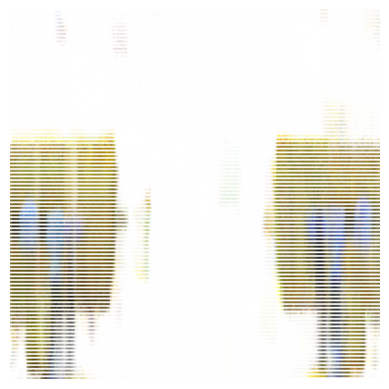

In [ ]:
if __name__ == '__main__':
   device = 'cuda' if torch.cuda.is_available() else 'cpu'
   print(f"Using device for KiloNerf: {device}")

   try:
       # Load datasets
       training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
       testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

       # Convert to torch tensors
       training_dataset = torch.from_numpy(training_data).float()
       testing_dataset = torch.from_numpy(testing_data).float()

       print(f"KiloNerf Original Training dataset shape: {training_dataset.shape}")

       # Take 1/5 of dataset
       subset_size = training_dataset.size(0) // 5
       training_dataset = training_dataset[:subset_size]

       print(f"KiloNerf Subset Training dataset shape: {training_dataset.shape}")

       # Model setup
       model = KiloNerf(16).to(device)
       model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
       scheduler = torch.optim.lr_scheduler.MultiStepLR(
           model_optimizer,
           milestones=[2, 4, 8],
           gamma=0.5
       )

       # Data loader with original batch size
       data_loader = DataLoader(
           training_dataset,
           batch_size=256,
           shuffle=True
       )

       print("Starting KiloNerf training...")
       training_loss, metrics = train(
           model,
           model_optimizer,
           scheduler,
           data_loader,
           device=device,
           nb_epochs=10,
           hn=2,
           hf=6,
           nb_bins=192
       )

       # Plot KiloNerf results
       plt.figure(figsize=(20, 6))

       plt.subplot(131)
       plt.plot(training_loss)
       plt.title('KiloNerf Training Loss')
       plt.xlabel('Epoch')
       plt.ylabel('Loss')

       plt.subplot(132)
       plt.plot(metrics['fps'])
       plt.axhline(y=30, color='r', linestyle='--', label='Minimum FPS')
       plt.title('KiloNerf FPS over Time')
       plt.xlabel('Batch')
       plt.ylabel('FPS')
       plt.legend()

       plt.subplot(133)
       plt.plot(metrics['psnr'])
       plt.title('KiloNerf PSNR over Time')
       plt.xlabel('Batch')
       plt.ylabel('PSNR (dB)')

       plt.tight_layout()
       plt.savefig('kilonerf_results.png')
       plt.close()

       print("Starting KiloNerf testing...")
       # Testing
       for idx in range(200):
           test(
               #model=model,  # Pass model
               hn=2,
               hf=6,
               dataset=testing_dataset,
               img_index=idx,
               nb_bins=192
           )

   except Exception as e:
       print(f"KiloNerf Error occurred: {e}")
   finally:
       if torch.cuda.is_available():
           torch.cuda.empty_cache()
       print("KiloNerf Process completed")

Need to draw graghs about performance as well

#Kilonerf with full data for high resolution rendered images

In [ ]:
@torch.no_grad()
def test_b(hn, hf, dataset, chunk_size=5, img_index=0, nb_bins=192, H=400, W=400):
    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []
    for i in range(int(np.ceil(H / chunk_size))):
        ray_origins_ = ray_origins[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        ray_directions_ = ray_directions[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)
    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)

    plt.figure()
    plt.imshow(img)
    plt.axis('off')
    plt.savefig(f'novel_views/img_{img_index}.png', bbox_inches='tight')
    plt.close()



In [ ]:
def train_b(nerf_model, optimizer, scheduler, data_loader, device='gpu', hn=0, hf=1, nb_epochs=1, nb_bins=192):
    training_loss = []
    for _ in (range(nb_epochs)):
        for ep, batch in enumerate(tqdm(data_loader)):
            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions, hn=hn, hf=hf, nb_bins=nb_bins)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).sum()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            training_loss.append(loss.item())
        scheduler.step()
    return training_loss

Using device: cuda
Training dataset shape: torch.Size([16000000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting training Kilonerf big dataset...


100%|██████████| 15625/15625 [09:12<00:00, 28.31it/s]


Starting testing Kilonerf big dataset...


Error occurred: [Errno 2] No such file or directory: '/content/novel_views/img_0.png'
Process completed


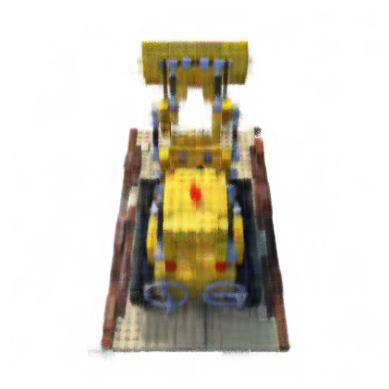

In [ ]:
if __name__ == '__main__':
    # Device setup
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        # Convert to torch tensors
        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        print(f"Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Model setup
        model = KiloNerf(16).to(device)
        model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
        scheduler = torch.optim.lr_scheduler.MultiStepLR(
            model_optimizer,
            milestones=[2, 4, 8],
            gamma=0.5
        )

        # Data loader
        data_loader = DataLoader(
            training_dataset,
            batch_size=1024,
            shuffle=True
        )

        print("Starting training Kilonerf big dataset...")
        # Training with original parameter names
        train_b(
            model,
            model_optimizer,
            scheduler,
            data_loader,
            nb_epochs=1,
            device=device,
            hn=2,  # Changed from near_plane
            hf=6,  # Changed from far_plane
            nb_bins=192  # Changed from num_bins
        )

        print("Starting testing Kilonerf big dataset...")
        # Testing
        for idx in range(20):
            test_b(
                hn=2,  # Changed from near_plane
                hf=6,  # Changed from far_plane
                dataset=testing_dataset,
                img_index=idx,
                nb_bins=192  # Changed from num_bins
            )

    except Exception as e:
        print(f"Error occurred: {e}")

    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")

##Fast NERF

##How it works :
1.Dynamically adjusting sampling density across the scene. This reduces computational complexity by focusing higher-resolution sampling on regions with more detail and lower sampling in less complex areas. Sampling optimizations are particularly impactful for real-time rendering, where the time budget per frame is tight.

 2.Applies various neural network optimizations, such as network pruning, quantization, and specialized activation functions, which contribute to faster convergence during training. Techniques like layer fusion and quantization further optimize the model for inference by compressing the model and reducing computation.

  3.Splits this into two separate components: geometry and view-dependent appearance. The geometry network models the scene's spatial structure and can be precomputed, while the view-dependent network computes appearance only when necessary, improving overall efficiency.
  
  4.Caches intermediate results of the geometry, allowing the model to avoid redundant calculations during inference. This cached information can be quickly accessed during rendering, further speeding up the process. This is particularly useful in scenes where geometry does not change, as only the view-dependent component needs updating with changing viewpoints.

In [6]:
class FastNerf(nn.Module):
    def __init__(self, embedding_dim_pos=10, embedding_dim_direction=4, hidden_dim_pos=384, hidden_dim_dir=128, D=8):
        super(FastNerf, self).__init__()

        self.Fpos = nn.Sequential(nn.Linear(embedding_dim_pos * 6 + 3, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, hidden_dim_pos), nn.ReLU(),
                                  nn.Linear(hidden_dim_pos, 3 * D + 1), )

        self.Fdir = nn.Sequential(nn.Linear(embedding_dim_direction * 6 + 3, hidden_dim_dir), nn.ReLU(),
                                  nn.Linear(hidden_dim_dir, hidden_dim_dir), nn.ReLU(),
                                  nn.Linear(hidden_dim_dir, hidden_dim_dir), nn.ReLU(),
                                  nn.Linear(hidden_dim_dir, D), )

        self.embedding_dim_pos = embedding_dim_pos
        self.embedding_dim_direction = embedding_dim_direction
        self.D = D

    @staticmethod
    def positional_encoding(x, L):
        out = [x]
        for j in range(L):
            out.append(torch.sin(2 ** j * x))
            out.append(torch.cos(2 ** j * x))
        return torch.cat(out, dim=1)

    def forward(self, o, d):
        sigma_uvw = self.Fpos(self.positional_encoding(o, self.embedding_dim_pos))
        sigma = torch.nn.functional.softplus(sigma_uvw[:, 0][..., None])  # [batch_size, 1]
        uvw = torch.sigmoid(sigma_uvw[:, 1:].reshape(-1, 3, self.D))  # [batch_size, 3, D]

        beta = torch.softmax(self.Fdir(self.positional_encoding(d, self.embedding_dim_direction)), -1)
        color = (beta.unsqueeze(1) * uvw).sum(-1)  # [batch_size, 3]
        return color, sigma


class Cache(nn.Module):
    def __init__(self, model, scale, device, Np, Nd):
        super(Cache, self).__init__()

        with torch.no_grad():
            # Position
            x, y, z = torch.meshgrid([torch.linspace(-scale / 2, scale / 2, Np).to(device),
                                      torch.linspace(-scale / 2, scale / 2, Np).to(device),
                                      torch.linspace(-scale / 2, scale / 2, Np).to(device)])
            xyz = torch.cat((x.reshape(-1, 1), y.reshape(-1, 1), z.reshape(-1, 1)), dim=1)
            sigma_uvw = model.Fpos(model.positional_encoding(xyz, model.embedding_dim_pos))
            self.sigma_uvw = sigma_uvw.reshape((Np, Np, Np, -1))
            # Direction
            xd, yd = torch.meshgrid([torch.linspace(-scale / 2, scale / 2, Nd).to(device),
                                     torch.linspace(-scale / 2, scale / 2, Nd).to(device)])
            xyz_d = torch.cat((xd.reshape(-1, 1), yd.reshape(-1, 1),
                               torch.sqrt((1 - xd ** 2 - yd ** 2).clip(0, 1)).reshape(-1, 1)), dim=1)
            beta = model.Fdir(model.positional_encoding(xyz_d, model.embedding_dim_direction))
            self.beta = beta.reshape((Nd, Nd, -1))

        self.scale = scale
        self.Np = Np
        self.Nd = Nd
        self.D = model.D

    def forward(self, x, d):
        color = torch.zeros_like(x)
        sigma = torch.zeros((x.shape[0], 1), device=x.device)

        mask = (x[:, 0].abs() < (self.scale / 2)) & (x[:, 1].abs() < (self.scale / 2)) & (x[:, 2].abs() < (self.scale / 2))
        # Position
        idx = (x[mask] / (self.scale / self.Np) + self.Np / 2).long().clip(0, self.Np - 1)
        sigma_uvw = self.sigma_uvw[idx[:, 0], idx[:, 1], idx[:, 2]]
        # Direction
        idx = (d[mask] * self.Nd).long().clip(0, self.Nd - 1)
        beta = torch.softmax(self.beta[idx[:, 0], idx[:, 1]], -1)

        sigma[mask] = torch.nn.functional.softplus(sigma_uvw[:, 0][..., None])  # [batch_size, 1]
        uvw = torch.sigmoid(sigma_uvw[:, 1:].reshape(-1, 3, self.D))  # [batch_size, 3, D]
        color[mask] = (beta.unsqueeze(1) * uvw).sum(-1)  # [batch_size, 3]
        return color, sigma


def compute_accumulated_transmittance(alphas):
    accumulated_transmittance = torch.cumprod(alphas, 1)
    return torch.cat((torch.ones((accumulated_transmittance.shape[0], 1), device=alphas.device),
                      accumulated_transmittance[:, :-1]), dim=-1)


def render_rays(nerf_model, ray_origins, ray_directions, hn=0, hf=0.5, nb_bins=192):
    device = ray_origins.device
    t = torch.linspace(hn, hf, nb_bins, device=device).expand(ray_origins.shape[0], nb_bins)
    # Perturb sampling along each ray.
    mid = (t[:, :-1] + t[:, 1:]) / 2.
    lower = torch.cat((t[:, :1], mid), -1)
    upper = torch.cat((mid, t[:, -1:]), -1)
    u = torch.rand(t.shape, device=ray_origins.device)
    t = lower + (upper - lower) * u  # [batch_size, nb_bins]
    delta = torch.cat((t[:, 1:] - t[:, :-1], torch.tensor([1e10], device=device).expand(ray_origins.shape[0], 1)), -1)

    x = ray_origins.unsqueeze(1) + t.unsqueeze(2) * ray_directions.unsqueeze(1)  # [batch_size, nb_bins, 3]
    ray_directions = ray_directions.expand(nb_bins, ray_directions.shape[0], 3).transpose(0, 1)

    colors, sigma = nerf_model(x.reshape(-1, 3), ray_directions.reshape(-1, 3))
    colors = colors.reshape(x.shape)
    sigma = sigma.reshape(x.shape[:-1])

    alpha = 1 - torch.exp(-sigma * delta)  # [batch_size, nb_bins]
    weights = compute_accumulated_transmittance(1 - alpha).unsqueeze(2) * alpha.unsqueeze(2)
    c = (weights * colors).sum(dim=1)  # Pixel values
    weight_sum = weights.sum(-1).sum(-1) # Regularization for white background
    return c + 1 - weight_sum.unsqueeze(-1)









In [7]:
%matplotlib inline

In [10]:
from IPython.display import display, clear_output
import matplotlib.pyplot as plt
import torch
import os

@torch.no_grad()
def test(hn, hf, dataset, chunk_size=5, img_index=0, nb_bins=192, H=200, W=200):
    print(f"Rendering image {img_index}...")

    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []
    for i in range(int(np.ceil(H / chunk_size))):
        ray_origins_ = ray_origins[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        ray_directions_ = ray_directions[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)

    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)

    # Ensure values are in valid range
    img = np.clip(img, 0, 1)

    # Create a new figure for each image
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'FastNerf Rendered Image {img_index}')
    display(plt.gcf())  # Display in Colab
    plt.close()



In [9]:
def train(fastnerf_model, optimizer, scheduler, data_loader, device='cpu', nb_epochs=10, hn=0, hf=1, nb_bins=192):
    training_loss = []
    metrics = {
        'epoch': [], 'batch': [],
        'fps': [], 'latency': [],
        'frame_variation': [], 'psnr': []
    }

    dirs = create_run_directories()
    metrics_file = os.path.join(dirs['metrics'], 'fastnerf_metrics.csv')

    total_batches = len(data_loader) * nb_epochs
    pbar = tqdm(total=total_batches, desc="FastNerf Training Progress")

    for epoch in range(nb_epochs):
        epoch_loss = 0.0
        batch_times = []
        epoch_psnr = []
        epoch_start = time.time()

        for batch_idx, batch in enumerate(data_loader):
            batch_start = time.time()

            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(fastnerf_model, ray_origins, ray_directions, hn=hn, hf=hf, nb_bins=nb_bins)
            #regenerated_px_values, sigma = Cache.forward(ray_origins, ray_directions)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).sum()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Performance metrics
            batch_end = time.time()
            batch_time = batch_end - batch_start
            fps = 1.0 / batch_time
            batch_times.append(batch_time * 1000)
            current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
            epoch_psnr.append(current_psnr.item())
            epoch_loss += loss.item()

            # Store metrics
            metrics['epoch'].append(epoch)
            metrics['batch'].append(batch_idx)
            metrics['fps'].append(fps)
            metrics['latency'].append(batch_time * 1000)
            metrics['frame_variation'].append(np.std(batch_times))
            metrics['psnr'].append(current_psnr.item())

            if batch_idx % 10 == 0:
                print(f'\nFastNerf Epoch {epoch+1}/{nb_epochs}, Batch {batch_idx}:')
                print(f'FPS: {fps:.2f}, Latency: {batch_time*1000:.2f}ms')
                print(f'PSNR: {current_psnr:.2f}dB, Loss: {loss.item():.4f}')

            pbar.update(1)

        # Epoch summary
        avg_epoch_loss = epoch_loss / len(data_loader)
        avg_epoch_psnr = sum(epoch_psnr) / len(epoch_psnr)
        epoch_fps = len(data_loader) / (time.time() - epoch_start)

        training_loss.append(avg_epoch_loss)

        pd.DataFrame({
            'epoch': [epoch],
            'avg_loss': [avg_epoch_loss],
            'avg_psnr': [avg_epoch_psnr],
            'avg_fps': [epoch_fps],
            'frame_variation': [np.std(batch_times)]
        }).to_csv(metrics_file, mode='a', header=not os.path.exists(metrics_file), index=False)

        scheduler.step()

        print(f'\nFastNerf Epoch {epoch+1} Summary:')
        print(f'Average Loss: {avg_epoch_loss:.4f}')
        print(f'Average PSNR: {avg_epoch_psnr:.2f}dB')
        print(f'Average FPS: {epoch_fps:.2f}')

        # Save the model
        torch.save(fastnerf_model.cpu(), 'fastnerf_model')
        fastnerf_model.to(device)

    pbar.close()
    pd.DataFrame(metrics).to_csv(os.path.join(dirs['metrics'], 'fastnerf_detailed_metrics.csv'), index=False)
    return training_loss

In [ ]:
if __name__ == '__main__':
    # Device setup
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        # Convert to torch tensors
        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        # Take 1/5 of the training dataset
        subset_size = training_dataset.size(0) // 5
        training_dataset = training_dataset[:subset_size]

        print(f"KiloNerf Original Training dataset shape: {training_data.shape}")
        print(f"KiloNerf Subset Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Model setup
        model = FastNerf().to(device)
        model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
        scheduler = torch.optim.lr_scheduler.MultiStepLR(
            model_optimizer,
            milestones=[2, 4, 8],
            gamma=0.5
        )

        # Data loader
        data_loader = DataLoader(
            training_dataset,
            batch_size=256,
            shuffle=True
        )

        print("Starting training for FastNerf Model ...")
        train(
            model,
            model_optimizer,
            scheduler,
            data_loader,
            device=device,
            hn=0,
            hf=1,
            nb_bins=192
        )
        print("Starting testing...")
        # Initialize the Cache
        cache = Cache(model, 2.2, device, 192, 128)

        # Testing loop
        for idx in range(5):
            test(
                hn = 2,
                hf=6,
                dataset=testing_dataset,
                chunk_size=5,
                img_index=idx,
                nb_bins=192,
                H=200,
                W=200
            )

    except Exception as e:
        print(f"Error occurred: {e}")

    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")

Using device: cuda
KiloNerf Original Training dataset shape: (16000000, 9)
KiloNerf Subset Training dataset shape: torch.Size([3200000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting training for FastNerf Model ...
Created directory: experiments/run_20241116_180044/metrics


FastNerf Training Progress:   0%|          | 2/125000 [00:02<34:20:41,  1.01it/s]


FastNerf Epoch 1/10, Batch 0:
FPS: 0.54, Latency: 1854.80ms
PSNR: 7.07dB, Loss: 150.6674


FastNerf Training Progress:   0%|          | 12/125000 [00:03<4:22:43,  7.93it/s]


FastNerf Epoch 1/10, Batch 10:
FPS: 29.20, Latency: 34.24ms
PSNR: 9.20dB, Loss: 92.2959


FastNerf Training Progress:   0%|          | 22/125000 [00:03<3:04:12, 11.31it/s]


FastNerf Epoch 1/10, Batch 20:
FPS: 28.83, Latency: 34.69ms
PSNR: 9.77dB, Loss: 80.8950


FastNerf Training Progress:   0%|          | 32/125000 [00:04<2:52:07, 12.10it/s]


FastNerf Epoch 1/10, Batch 30:
FPS: 28.92, Latency: 34.58ms
PSNR: 10.41dB, Loss: 69.9444


FastNerf Training Progress:   0%|          | 42/125000 [00:05<2:49:43, 12.27it/s]


FastNerf Epoch 1/10, Batch 40:
FPS: 30.07, Latency: 33.25ms
PSNR: 10.55dB, Loss: 67.5876


FastNerf Training Progress:   0%|          | 52/125000 [00:06<2:49:14, 12.30it/s]


FastNerf Epoch 1/10, Batch 50:
FPS: 29.26, Latency: 34.18ms
PSNR: 10.92dB, Loss: 62.1853


FastNerf Training Progress:   0%|          | 62/125000 [00:07<2:48:36, 12.35it/s]


FastNerf Epoch 1/10, Batch 60:
FPS: 29.44, Latency: 33.97ms
PSNR: 10.47dB, Loss: 68.9811


FastNerf Training Progress:   0%|          | 72/125000 [00:08<2:48:33, 12.35it/s]


FastNerf Epoch 1/10, Batch 70:
FPS: 29.64, Latency: 33.74ms
PSNR: 10.83dB, Loss: 63.3972


FastNerf Training Progress:   0%|          | 82/125000 [00:08<2:48:55, 12.33it/s]


FastNerf Epoch 1/10, Batch 80:
FPS: 29.24, Latency: 34.20ms
PSNR: 10.83dB, Loss: 63.4705


FastNerf Training Progress:   0%|          | 92/125000 [00:09<2:48:32, 12.35it/s]


FastNerf Epoch 1/10, Batch 90:
FPS: 29.50, Latency: 33.90ms
PSNR: 10.52dB, Loss: 68.0719


FastNerf Training Progress:   0%|          | 102/125000 [00:10<2:48:57, 12.32it/s]


FastNerf Epoch 1/10, Batch 100:
FPS: 29.43, Latency: 33.98ms
PSNR: 10.87dB, Loss: 62.8125


FastNerf Training Progress:   0%|          | 112/125000 [00:11<2:48:45, 12.33it/s]


FastNerf Epoch 1/10, Batch 110:
FPS: 29.45, Latency: 33.96ms
PSNR: 11.61dB, Loss: 53.0294


FastNerf Training Progress:   0%|          | 122/125000 [00:12<2:48:40, 12.34it/s]


FastNerf Epoch 1/10, Batch 120:
FPS: 29.46, Latency: 33.95ms
PSNR: 11.19dB, Loss: 58.4489


FastNerf Training Progress:   0%|          | 132/125000 [00:12<2:48:54, 12.32it/s]


FastNerf Epoch 1/10, Batch 130:
FPS: 28.75, Latency: 34.78ms
PSNR: 12.50dB, Loss: 43.1590


FastNerf Training Progress:   0%|          | 142/125000 [00:13<2:48:50, 12.33it/s]


FastNerf Epoch 1/10, Batch 140:
FPS: 29.76, Latency: 33.61ms
PSNR: 12.49dB, Loss: 43.3014


FastNerf Training Progress:   0%|          | 152/125000 [00:14<2:48:54, 12.32it/s]


FastNerf Epoch 1/10, Batch 150:
FPS: 29.78, Latency: 33.58ms
PSNR: 12.33dB, Loss: 44.9415


FastNerf Training Progress:   0%|          | 162/125000 [00:15<2:48:45, 12.33it/s]


FastNerf Epoch 1/10, Batch 160:
FPS: 29.40, Latency: 34.01ms
PSNR: 12.55dB, Loss: 42.7070


FastNerf Training Progress:   0%|          | 172/125000 [00:16<2:48:40, 12.33it/s]


FastNerf Epoch 1/10, Batch 170:
FPS: 29.72, Latency: 33.65ms
PSNR: 13.01dB, Loss: 38.4190


FastNerf Training Progress:   0%|          | 182/125000 [00:16<2:49:36, 12.27it/s]


FastNerf Epoch 1/10, Batch 180:
FPS: 28.82, Latency: 34.70ms
PSNR: 13.17dB, Loss: 37.0029


FastNerf Training Progress:   0%|          | 192/125000 [00:17<2:48:49, 12.32it/s]


FastNerf Epoch 1/10, Batch 190:
FPS: 29.46, Latency: 33.95ms
PSNR: 13.24dB, Loss: 36.4303


FastNerf Training Progress:   0%|          | 202/125000 [00:18<2:48:51, 12.32it/s]


FastNerf Epoch 1/10, Batch 200:
FPS: 29.31, Latency: 34.12ms
PSNR: 12.90dB, Loss: 39.3453


FastNerf Training Progress:   0%|          | 212/125000 [00:19<2:49:39, 12.26it/s]


FastNerf Epoch 1/10, Batch 210:
FPS: 29.25, Latency: 34.19ms
PSNR: 13.91dB, Loss: 31.1857


FastNerf Training Progress:   0%|          | 222/125000 [00:20<2:49:01, 12.30it/s]


FastNerf Epoch 1/10, Batch 220:
FPS: 29.94, Latency: 33.40ms
PSNR: 14.15dB, Loss: 29.5386


FastNerf Training Progress:   0%|          | 232/125000 [00:21<2:51:03, 12.16it/s]


FastNerf Epoch 1/10, Batch 230:
FPS: 27.53, Latency: 36.33ms
PSNR: 14.54dB, Loss: 26.9813


FastNerf Training Progress:   0%|          | 242/125000 [00:21<2:49:49, 12.24it/s]


FastNerf Epoch 1/10, Batch 240:
FPS: 30.14, Latency: 33.17ms
PSNR: 15.11dB, Loss: 23.6571


FastNerf Training Progress:   0%|          | 252/125000 [00:22<2:49:08, 12.29it/s]


FastNerf Epoch 1/10, Batch 250:
FPS: 29.61, Latency: 33.78ms
PSNR: 15.48dB, Loss: 21.7562


FastNerf Training Progress:   0%|          | 262/125000 [00:23<2:50:46, 12.17it/s]


FastNerf Epoch 1/10, Batch 260:
FPS: 27.74, Latency: 36.04ms
PSNR: 15.33dB, Loss: 22.5197


FastNerf Training Progress:   0%|          | 272/125000 [00:24<2:49:54, 12.23it/s]


FastNerf Epoch 1/10, Batch 270:
FPS: 29.49, Latency: 33.92ms
PSNR: 14.26dB, Loss: 28.7949


FastNerf Training Progress:   0%|          | 282/125000 [00:25<2:50:04, 12.22it/s]


FastNerf Epoch 1/10, Batch 280:
FPS: 28.28, Latency: 35.36ms
PSNR: 14.63dB, Loss: 26.4278


FastNerf Training Progress:   0%|          | 292/125000 [00:25<2:51:07, 12.15it/s]


FastNerf Epoch 1/10, Batch 290:
FPS: 28.56, Latency: 35.02ms
PSNR: 13.59dB, Loss: 33.5858


FastNerf Training Progress:   0%|          | 302/125000 [00:26<2:49:17, 12.28it/s]


FastNerf Epoch 1/10, Batch 300:
FPS: 29.47, Latency: 33.93ms
PSNR: 13.97dB, Loss: 30.7569


FastNerf Training Progress:   0%|          | 312/125000 [00:27<2:50:56, 12.16it/s]


FastNerf Epoch 1/10, Batch 310:
FPS: 28.75, Latency: 34.79ms
PSNR: 14.99dB, Loss: 24.3570


FastNerf Training Progress:   0%|          | 322/125000 [00:28<2:49:50, 12.23it/s]


FastNerf Epoch 1/10, Batch 320:
FPS: 30.10, Latency: 33.22ms
PSNR: 14.99dB, Loss: 24.3452


FastNerf Training Progress:   0%|          | 332/125000 [00:29<2:49:31, 12.26it/s]


FastNerf Epoch 1/10, Batch 330:
FPS: 29.56, Latency: 33.83ms
PSNR: 15.29dB, Loss: 22.7103


FastNerf Training Progress:   0%|          | 342/125000 [00:30<2:51:07, 12.14it/s]


FastNerf Epoch 1/10, Batch 340:
FPS: 29.38, Latency: 34.03ms
PSNR: 13.96dB, Loss: 30.8767


FastNerf Training Progress:   0%|          | 352/125000 [00:30<2:49:44, 12.24it/s]


FastNerf Epoch 1/10, Batch 350:
FPS: 29.84, Latency: 33.51ms
PSNR: 15.39dB, Loss: 22.1843


FastNerf Training Progress:   0%|          | 362/125000 [00:31<2:49:54, 12.23it/s]


FastNerf Epoch 1/10, Batch 360:
FPS: 29.50, Latency: 33.90ms
PSNR: 13.90dB, Loss: 31.2901


FastNerf Training Progress:   0%|          | 372/125000 [00:32<2:51:24, 12.12it/s]


FastNerf Epoch 1/10, Batch 370:
FPS: 27.98, Latency: 35.74ms
PSNR: 15.54dB, Loss: 21.4661


FastNerf Training Progress:   0%|          | 382/125000 [00:33<2:51:44, 12.09it/s]


FastNerf Epoch 1/10, Batch 380:
FPS: 28.73, Latency: 34.81ms
PSNR: 15.20dB, Loss: 23.1725


FastNerf Training Progress:   0%|          | 392/125000 [00:34<2:50:07, 12.21it/s]


FastNerf Epoch 1/10, Batch 390:
FPS: 28.90, Latency: 34.60ms
PSNR: 14.72dB, Loss: 25.8904


FastNerf Training Progress:   0%|          | 402/125000 [00:34<2:50:20, 12.19it/s]


FastNerf Epoch 1/10, Batch 400:
FPS: 28.61, Latency: 34.95ms
PSNR: 14.56dB, Loss: 26.8826


FastNerf Training Progress:   0%|          | 412/125000 [00:35<2:51:28, 12.11it/s]


FastNerf Epoch 1/10, Batch 410:
FPS: 28.77, Latency: 34.76ms
PSNR: 16.61dB, Loss: 16.7812


FastNerf Training Progress:   0%|          | 422/125000 [00:36<2:50:36, 12.17it/s]


FastNerf Epoch 1/10, Batch 420:
FPS: 28.67, Latency: 34.88ms
PSNR: 14.72dB, Loss: 25.8789


FastNerf Training Progress:   0%|          | 432/125000 [00:37<2:50:55, 12.15it/s]


FastNerf Epoch 1/10, Batch 430:
FPS: 29.02, Latency: 34.46ms
PSNR: 15.30dB, Loss: 22.6657


FastNerf Training Progress:   0%|          | 442/125000 [00:38<2:51:39, 12.09it/s]


FastNerf Epoch 1/10, Batch 440:
FPS: 27.90, Latency: 35.85ms
PSNR: 14.97dB, Loss: 24.4297


FastNerf Training Progress:   0%|          | 452/125000 [00:39<2:49:59, 12.21it/s]


FastNerf Epoch 1/10, Batch 450:
FPS: 30.19, Latency: 33.13ms
PSNR: 14.64dB, Loss: 26.4105


FastNerf Training Progress:   0%|          | 462/125000 [00:39<2:51:46, 12.08it/s]


FastNerf Epoch 1/10, Batch 460:
FPS: 28.85, Latency: 34.66ms
PSNR: 15.65dB, Loss: 20.9058


FastNerf Training Progress:   0%|          | 472/125000 [00:40<2:51:06, 12.13it/s]


FastNerf Epoch 1/10, Batch 470:
FPS: 29.19, Latency: 34.26ms
PSNR: 15.65dB, Loss: 20.9105


FastNerf Training Progress:   0%|          | 482/125000 [00:41<2:51:03, 12.13it/s]


FastNerf Epoch 1/10, Batch 480:
FPS: 29.39, Latency: 34.02ms
PSNR: 14.73dB, Loss: 25.8180


FastNerf Training Progress:   0%|          | 492/125000 [00:42<2:51:57, 12.07it/s]


FastNerf Epoch 1/10, Batch 490:
FPS: 29.65, Latency: 33.73ms
PSNR: 16.11dB, Loss: 18.7898


FastNerf Training Progress:   0%|          | 502/125000 [00:43<2:52:01, 12.06it/s]


FastNerf Epoch 1/10, Batch 500:
FPS: 28.96, Latency: 34.53ms
PSNR: 16.00dB, Loss: 19.2893


FastNerf Training Progress:   0%|          | 512/125000 [00:44<2:52:18, 12.04it/s]


FastNerf Epoch 1/10, Batch 510:
FPS: 28.58, Latency: 34.98ms
PSNR: 15.65dB, Loss: 20.8910


FastNerf Training Progress:   0%|          | 522/125000 [00:44<2:52:19, 12.04it/s]


FastNerf Epoch 1/10, Batch 520:
FPS: 29.15, Latency: 34.31ms
PSNR: 15.38dB, Loss: 22.2491


FastNerf Training Progress:   0%|          | 532/125000 [00:45<2:52:23, 12.03it/s]


FastNerf Epoch 1/10, Batch 530:
FPS: 29.62, Latency: 33.76ms
PSNR: 16.04dB, Loss: 19.1092


FastNerf Training Progress:   0%|          | 542/125000 [00:46<2:51:45, 12.08it/s]


FastNerf Epoch 1/10, Batch 540:
FPS: 28.71, Latency: 34.84ms
PSNR: 15.36dB, Loss: 22.3306


FastNerf Training Progress:   0%|          | 552/125000 [00:47<2:50:33, 12.16it/s]


FastNerf Epoch 1/10, Batch 550:
FPS: 29.95, Latency: 33.39ms
PSNR: 15.08dB, Loss: 23.8402


FastNerf Training Progress:   0%|          | 562/125000 [00:48<2:51:30, 12.09it/s]


FastNerf Epoch 1/10, Batch 560:
FPS: 29.09, Latency: 34.37ms
PSNR: 16.25dB, Loss: 18.2010


FastNerf Training Progress:   0%|          | 572/125000 [00:49<2:51:19, 12.10it/s]


FastNerf Epoch 1/10, Batch 570:
FPS: 28.76, Latency: 34.77ms
PSNR: 14.65dB, Loss: 26.3258


FastNerf Training Progress:   0%|          | 582/125000 [00:49<2:52:15, 12.04it/s]


FastNerf Epoch 1/10, Batch 580:
FPS: 28.49, Latency: 35.10ms
PSNR: 16.39dB, Loss: 17.6375


FastNerf Training Progress:   0%|          | 592/125000 [00:50<2:52:11, 12.04it/s]


FastNerf Epoch 1/10, Batch 590:
FPS: 28.52, Latency: 35.07ms
PSNR: 15.05dB, Loss: 23.9998


FastNerf Training Progress:   0%|          | 602/125000 [00:51<2:52:53, 11.99it/s]


FastNerf Epoch 1/10, Batch 600:
FPS: 28.78, Latency: 34.75ms
PSNR: 16.63dB, Loss: 16.6683


FastNerf Training Progress:   0%|          | 612/125000 [00:52<2:52:13, 12.04it/s]


FastNerf Epoch 1/10, Batch 610:
FPS: 27.66, Latency: 36.16ms
PSNR: 15.66dB, Loss: 20.8446


FastNerf Training Progress:   0%|          | 622/125000 [00:53<2:52:31, 12.02it/s]


FastNerf Epoch 1/10, Batch 620:
FPS: 27.95, Latency: 35.78ms
PSNR: 17.04dB, Loss: 15.1998


FastNerf Training Progress:   1%|          | 632/125000 [00:54<2:52:43, 12.00it/s]


FastNerf Epoch 1/10, Batch 630:
FPS: 28.59, Latency: 34.98ms
PSNR: 17.12dB, Loss: 14.8966


FastNerf Training Progress:   1%|          | 642/125000 [00:54<2:53:07, 11.97it/s]


FastNerf Epoch 1/10, Batch 640:
FPS: 28.27, Latency: 35.38ms
PSNR: 16.19dB, Loss: 18.4522


FastNerf Training Progress:   1%|          | 652/125000 [00:55<2:52:49, 11.99it/s]


FastNerf Epoch 1/10, Batch 650:
FPS: 27.77, Latency: 36.02ms
PSNR: 16.78dB, Loss: 16.1209


FastNerf Training Progress:   1%|          | 662/125000 [00:56<2:52:38, 12.00it/s]


FastNerf Epoch 1/10, Batch 660:
FPS: 27.93, Latency: 35.80ms
PSNR: 16.99dB, Loss: 15.3644


FastNerf Training Progress:   1%|          | 672/125000 [00:57<2:53:01, 11.98it/s]


FastNerf Epoch 1/10, Batch 670:
FPS: 28.66, Latency: 34.89ms
PSNR: 16.62dB, Loss: 16.7079


FastNerf Training Progress:   1%|          | 682/125000 [00:58<2:53:00, 11.98it/s]


FastNerf Epoch 1/10, Batch 680:
FPS: 28.73, Latency: 34.81ms
PSNR: 17.08dB, Loss: 15.0351


FastNerf Training Progress:   1%|          | 692/125000 [00:58<2:52:27, 12.01it/s]


FastNerf Epoch 1/10, Batch 690:
FPS: 28.81, Latency: 34.71ms
PSNR: 16.37dB, Loss: 17.7081


FastNerf Training Progress:   1%|          | 702/125000 [00:59<2:52:34, 12.00it/s]


FastNerf Epoch 1/10, Batch 700:
FPS: 28.81, Latency: 34.71ms
PSNR: 16.70dB, Loss: 16.4027


FastNerf Training Progress:   1%|          | 712/125000 [01:00<2:53:18, 11.95it/s]


FastNerf Epoch 1/10, Batch 710:
FPS: 27.66, Latency: 36.16ms
PSNR: 16.03dB, Loss: 19.1736


FastNerf Training Progress:   1%|          | 722/125000 [01:01<2:53:19, 11.95it/s]


FastNerf Epoch 1/10, Batch 720:
FPS: 28.99, Latency: 34.49ms
PSNR: 15.37dB, Loss: 22.3111


FastNerf Training Progress:   1%|          | 732/125000 [01:02<2:52:44, 11.99it/s]


FastNerf Epoch 1/10, Batch 730:
FPS: 29.14, Latency: 34.31ms
PSNR: 16.46dB, Loss: 17.3393


FastNerf Training Progress:   1%|          | 742/125000 [01:03<2:52:28, 12.01it/s]


FastNerf Epoch 1/10, Batch 740:
FPS: 29.62, Latency: 33.76ms
PSNR: 16.23dB, Loss: 18.3155


FastNerf Training Progress:   1%|          | 752/125000 [01:04<2:53:09, 11.96it/s]


FastNerf Epoch 1/10, Batch 750:
FPS: 28.19, Latency: 35.48ms
PSNR: 16.18dB, Loss: 18.5106


FastNerf Training Progress:   1%|          | 762/125000 [01:04<2:53:44, 11.92it/s]


FastNerf Epoch 1/10, Batch 760:
FPS: 27.76, Latency: 36.03ms
PSNR: 16.38dB, Loss: 17.6928


FastNerf Training Progress:   1%|          | 772/125000 [01:05<2:53:29, 11.93it/s]


FastNerf Epoch 1/10, Batch 770:
FPS: 29.38, Latency: 34.04ms
PSNR: 17.43dB, Loss: 13.8652


FastNerf Training Progress:   1%|          | 782/125000 [01:06<2:53:34, 11.93it/s]


FastNerf Epoch 1/10, Batch 780:
FPS: 27.66, Latency: 36.15ms
PSNR: 16.54dB, Loss: 17.0203


FastNerf Training Progress:   1%|          | 792/125000 [01:07<2:53:10, 11.95it/s]


FastNerf Epoch 1/10, Batch 790:
FPS: 29.21, Latency: 34.24ms
PSNR: 16.89dB, Loss: 15.7041


FastNerf Training Progress:   1%|          | 802/125000 [01:08<2:52:50, 11.98it/s]


FastNerf Epoch 1/10, Batch 800:
FPS: 28.82, Latency: 34.70ms
PSNR: 18.40dB, Loss: 11.0938


FastNerf Training Progress:   1%|          | 812/125000 [01:09<2:54:42, 11.85it/s]


FastNerf Epoch 1/10, Batch 810:
FPS: 28.08, Latency: 35.62ms
PSNR: 16.81dB, Loss: 16.0128


FastNerf Training Progress:   1%|          | 822/125000 [01:09<2:53:43, 11.91it/s]


FastNerf Epoch 1/10, Batch 820:
FPS: 29.34, Latency: 34.08ms
PSNR: 17.23dB, Loss: 14.5211


FastNerf Training Progress:   1%|          | 832/125000 [01:10<2:53:39, 11.92it/s]


FastNerf Epoch 1/10, Batch 830:
FPS: 27.50, Latency: 36.37ms
PSNR: 15.76dB, Loss: 20.3899


FastNerf Training Progress:   1%|          | 842/125000 [01:11<2:52:41, 11.98it/s]


FastNerf Epoch 1/10, Batch 840:
FPS: 29.50, Latency: 33.89ms
PSNR: 17.15dB, Loss: 14.8177


FastNerf Training Progress:   1%|          | 852/125000 [01:12<2:52:52, 11.97it/s]


FastNerf Epoch 1/10, Batch 850:
FPS: 28.91, Latency: 34.59ms
PSNR: 16.66dB, Loss: 16.5775


FastNerf Training Progress:   1%|          | 862/125000 [01:13<2:53:43, 11.91it/s]


FastNerf Epoch 1/10, Batch 860:
FPS: 27.76, Latency: 36.02ms
PSNR: 16.01dB, Loss: 19.2517


FastNerf Training Progress:   1%|          | 872/125000 [01:14<2:53:29, 11.92it/s]


FastNerf Epoch 1/10, Batch 870:
FPS: 29.25, Latency: 34.19ms
PSNR: 17.33dB, Loss: 14.2016


FastNerf Training Progress:   1%|          | 882/125000 [01:14<2:54:56, 11.82it/s]


FastNerf Epoch 1/10, Batch 880:
FPS: 27.62, Latency: 36.21ms
PSNR: 15.72dB, Loss: 20.5573


FastNerf Training Progress:   1%|          | 892/125000 [01:15<2:54:16, 11.87it/s]


FastNerf Epoch 1/10, Batch 890:
FPS: 28.62, Latency: 34.94ms
PSNR: 16.92dB, Loss: 15.6222


FastNerf Training Progress:   1%|          | 902/125000 [01:16<2:54:27, 11.86it/s]


FastNerf Epoch 1/10, Batch 900:
FPS: 28.24, Latency: 35.40ms
PSNR: 16.77dB, Loss: 16.1731


FastNerf Training Progress:   1%|          | 912/125000 [01:17<2:53:05, 11.95it/s]


FastNerf Epoch 1/10, Batch 910:
FPS: 28.75, Latency: 34.78ms
PSNR: 16.51dB, Loss: 17.1714


FastNerf Training Progress:   1%|          | 922/125000 [01:18<2:53:56, 11.89it/s]


FastNerf Epoch 1/10, Batch 920:
FPS: 27.90, Latency: 35.84ms
PSNR: 16.99dB, Loss: 15.3469


FastNerf Training Progress:   1%|          | 932/125000 [01:19<2:53:58, 11.89it/s]


FastNerf Epoch 1/10, Batch 930:
FPS: 29.14, Latency: 34.32ms
PSNR: 16.44dB, Loss: 17.4519


FastNerf Training Progress:   1%|          | 942/125000 [01:19<2:54:52, 11.82it/s]


FastNerf Epoch 1/10, Batch 940:
FPS: 27.56, Latency: 36.29ms
PSNR: 17.57dB, Loss: 13.4341


FastNerf Training Progress:   1%|          | 952/125000 [01:20<2:54:19, 11.86it/s]


FastNerf Epoch 1/10, Batch 950:
FPS: 27.79, Latency: 35.98ms
PSNR: 16.47dB, Loss: 17.3000


FastNerf Training Progress:   1%|          | 962/125000 [01:21<2:54:27, 11.85it/s]


FastNerf Epoch 1/10, Batch 960:
FPS: 29.22, Latency: 34.22ms
PSNR: 17.51dB, Loss: 13.6326


FastNerf Training Progress:   1%|          | 972/125000 [01:22<2:54:45, 11.83it/s]


FastNerf Epoch 1/10, Batch 970:
FPS: 28.27, Latency: 35.38ms
PSNR: 16.85dB, Loss: 15.8521


FastNerf Training Progress:   1%|          | 982/125000 [01:23<2:54:27, 11.85it/s]


FastNerf Epoch 1/10, Batch 980:
FPS: 27.63, Latency: 36.19ms
PSNR: 17.69dB, Loss: 13.0648


FastNerf Training Progress:   1%|          | 992/125000 [01:24<2:54:21, 11.85it/s]


FastNerf Epoch 1/10, Batch 990:
FPS: 29.07, Latency: 34.40ms
PSNR: 17.80dB, Loss: 12.7601


FastNerf Training Progress:   1%|          | 1002/125000 [01:25<2:54:55, 11.81it/s]


FastNerf Epoch 1/10, Batch 1000:
FPS: 28.03, Latency: 35.67ms
PSNR: 17.79dB, Loss: 12.7685


FastNerf Training Progress:   1%|          | 1012/125000 [01:25<2:53:57, 11.88it/s]


FastNerf Epoch 1/10, Batch 1010:
FPS: 27.96, Latency: 35.77ms
PSNR: 17.61dB, Loss: 13.3121


FastNerf Training Progress:   1%|          | 1022/125000 [01:26<2:54:32, 11.84it/s]


FastNerf Epoch 1/10, Batch 1020:
FPS: 28.47, Latency: 35.13ms
PSNR: 17.54dB, Loss: 13.5236


FastNerf Training Progress:   1%|          | 1032/125000 [01:27<2:54:55, 11.81it/s]


FastNerf Epoch 1/10, Batch 1030:
FPS: 28.40, Latency: 35.21ms
PSNR: 17.57dB, Loss: 13.4464


FastNerf Training Progress:   1%|          | 1042/125000 [01:28<2:54:36, 11.83it/s]


FastNerf Epoch 1/10, Batch 1040:
FPS: 28.02, Latency: 35.69ms
PSNR: 17.76dB, Loss: 12.8625


FastNerf Training Progress:   1%|          | 1052/125000 [01:29<2:53:39, 11.90it/s]


FastNerf Epoch 1/10, Batch 1050:
FPS: 29.40, Latency: 34.01ms
PSNR: 17.45dB, Loss: 13.8009


FastNerf Training Progress:   1%|          | 1062/125000 [01:30<2:54:02, 11.87it/s]


FastNerf Epoch 1/10, Batch 1060:
FPS: 27.79, Latency: 35.99ms
PSNR: 17.69dB, Loss: 13.0828


FastNerf Training Progress:   1%|          | 1072/125000 [01:30<2:54:20, 11.85it/s]


FastNerf Epoch 1/10, Batch 1070:
FPS: 29.17, Latency: 34.28ms
PSNR: 17.36dB, Loss: 14.1057


FastNerf Training Progress:   1%|          | 1082/125000 [01:31<2:55:21, 11.78it/s]


FastNerf Epoch 1/10, Batch 1080:
FPS: 28.06, Latency: 35.64ms
PSNR: 17.34dB, Loss: 14.1673


FastNerf Training Progress:   1%|          | 1092/125000 [01:32<2:55:09, 11.79it/s]


FastNerf Epoch 1/10, Batch 1090:
FPS: 27.52, Latency: 36.33ms
PSNR: 16.83dB, Loss: 15.9256


FastNerf Training Progress:   1%|          | 1102/125000 [01:33<2:55:07, 11.79it/s]


FastNerf Epoch 1/10, Batch 1100:
FPS: 28.40, Latency: 35.21ms
PSNR: 17.84dB, Loss: 12.6230


FastNerf Training Progress:   1%|          | 1112/125000 [01:34<2:54:44, 11.82it/s]


FastNerf Epoch 1/10, Batch 1110:
FPS: 28.84, Latency: 34.67ms
PSNR: 18.66dB, Loss: 10.4449


FastNerf Training Progress:   1%|          | 1122/125000 [01:35<2:55:18, 11.78it/s]


FastNerf Epoch 1/10, Batch 1120:
FPS: 28.09, Latency: 35.61ms
PSNR: 16.55dB, Loss: 17.0132


FastNerf Training Progress:   1%|          | 1132/125000 [01:36<2:55:05, 11.79it/s]


FastNerf Epoch 1/10, Batch 1130:
FPS: 28.48, Latency: 35.11ms
PSNR: 17.48dB, Loss: 13.7149


FastNerf Training Progress:   1%|          | 1142/125000 [01:36<2:54:40, 11.82it/s]


FastNerf Epoch 1/10, Batch 1140:
FPS: 27.88, Latency: 35.87ms
PSNR: 17.39dB, Loss: 13.9972


FastNerf Training Progress:   1%|          | 1152/125000 [01:37<2:55:18, 11.77it/s]


FastNerf Epoch 1/10, Batch 1150:
FPS: 27.45, Latency: 36.43ms
PSNR: 16.64dB, Loss: 16.6638


FastNerf Training Progress:   1%|          | 1162/125000 [01:38<2:55:00, 11.79it/s]


FastNerf Epoch 1/10, Batch 1160:
FPS: 28.20, Latency: 35.47ms
PSNR: 16.92dB, Loss: 15.5919


FastNerf Training Progress:   1%|          | 1172/125000 [01:39<2:54:45, 11.81it/s]


FastNerf Epoch 1/10, Batch 1170:
FPS: 29.10, Latency: 34.36ms
PSNR: 16.16dB, Loss: 18.6091


FastNerf Training Progress:   1%|          | 1182/125000 [01:40<2:54:47, 11.81it/s]


FastNerf Epoch 1/10, Batch 1180:
FPS: 28.42, Latency: 35.18ms
PSNR: 17.31dB, Loss: 14.2652


FastNerf Training Progress:   1%|          | 1192/125000 [01:41<2:55:26, 11.76it/s]


FastNerf Epoch 1/10, Batch 1190:
FPS: 27.67, Latency: 36.13ms
PSNR: 18.40dB, Loss: 11.0884


FastNerf Training Progress:   1%|          | 1202/125000 [01:41<2:55:28, 11.76it/s]


FastNerf Epoch 1/10, Batch 1200:
FPS: 27.05, Latency: 36.96ms
PSNR: 18.01dB, Loss: 12.1327


FastNerf Training Progress:   1%|          | 1212/125000 [01:42<2:55:15, 11.77it/s]


FastNerf Epoch 1/10, Batch 1210:
FPS: 27.74, Latency: 36.04ms
PSNR: 17.78dB, Loss: 12.8164


FastNerf Training Progress:   1%|          | 1222/125000 [01:43<2:56:05, 11.72it/s]


FastNerf Epoch 1/10, Batch 1220:
FPS: 26.84, Latency: 37.26ms
PSNR: 16.05dB, Loss: 19.0816


FastNerf Training Progress:   1%|          | 1232/125000 [01:44<2:56:02, 11.72it/s]


FastNerf Epoch 1/10, Batch 1230:
FPS: 27.73, Latency: 36.06ms
PSNR: 16.68dB, Loss: 16.4917


FastNerf Training Progress:   1%|          | 1242/125000 [01:45<2:55:01, 11.79it/s]


FastNerf Epoch 1/10, Batch 1240:
FPS: 27.71, Latency: 36.08ms
PSNR: 17.92dB, Loss: 12.3928


FastNerf Training Progress:   1%|          | 1252/125000 [01:46<2:55:16, 11.77it/s]


FastNerf Epoch 1/10, Batch 1250:
FPS: 27.79, Latency: 35.99ms
PSNR: 17.87dB, Loss: 12.5432


FastNerf Training Progress:   1%|          | 1262/125000 [01:47<2:55:28, 11.75it/s]


FastNerf Epoch 1/10, Batch 1260:
FPS: 28.20, Latency: 35.46ms
PSNR: 17.82dB, Loss: 12.6983


FastNerf Training Progress:   1%|          | 1272/125000 [01:47<2:56:00, 11.72it/s]


FastNerf Epoch 1/10, Batch 1270:
FPS: 28.12, Latency: 35.56ms
PSNR: 16.14dB, Loss: 18.6632


FastNerf Training Progress:   1%|          | 1282/125000 [01:48<2:56:06, 11.71it/s]


FastNerf Epoch 1/10, Batch 1280:
FPS: 27.85, Latency: 35.90ms
PSNR: 16.52dB, Loss: 17.1309


FastNerf Training Progress:   1%|          | 1292/125000 [01:49<2:55:47, 11.73it/s]


FastNerf Epoch 1/10, Batch 1290:
FPS: 27.93, Latency: 35.80ms
PSNR: 17.03dB, Loss: 15.2270


FastNerf Training Progress:   1%|          | 1302/125000 [01:50<2:56:34, 11.68it/s]


FastNerf Epoch 1/10, Batch 1300:
FPS: 26.98, Latency: 37.06ms
PSNR: 19.34dB, Loss: 8.9342


FastNerf Training Progress:   1%|          | 1312/125000 [01:51<2:55:57, 11.72it/s]


FastNerf Epoch 1/10, Batch 1310:
FPS: 28.64, Latency: 34.92ms
PSNR: 19.51dB, Loss: 8.6049


FastNerf Training Progress:   1%|          | 1322/125000 [01:52<2:55:46, 11.73it/s]


FastNerf Epoch 1/10, Batch 1320:
FPS: 28.72, Latency: 34.82ms
PSNR: 16.70dB, Loss: 16.4084


FastNerf Training Progress:   1%|          | 1332/125000 [01:53<2:56:31, 11.68it/s]


FastNerf Epoch 1/10, Batch 1330:
FPS: 28.90, Latency: 34.60ms
PSNR: 17.79dB, Loss: 12.7748


FastNerf Training Progress:   1%|          | 1342/125000 [01:53<2:56:00, 11.71it/s]


FastNerf Epoch 1/10, Batch 1340:
FPS: 27.90, Latency: 35.84ms
PSNR: 17.29dB, Loss: 14.3350


FastNerf Training Progress:   1%|          | 1352/125000 [01:54<2:56:46, 11.66it/s]


FastNerf Epoch 1/10, Batch 1350:
FPS: 28.12, Latency: 35.56ms
PSNR: 16.93dB, Loss: 15.5680


FastNerf Training Progress:   1%|          | 1362/125000 [01:55<2:56:04, 11.70it/s]


FastNerf Epoch 1/10, Batch 1360:
FPS: 28.72, Latency: 34.82ms
PSNR: 18.72dB, Loss: 10.3016


FastNerf Training Progress:   1%|          | 1372/125000 [01:56<2:55:33, 11.74it/s]


FastNerf Epoch 1/10, Batch 1370:
FPS: 28.70, Latency: 34.84ms
PSNR: 16.70dB, Loss: 16.4268


FastNerf Training Progress:   1%|          | 1382/125000 [01:57<2:56:13, 11.69it/s]


FastNerf Epoch 1/10, Batch 1380:
FPS: 28.64, Latency: 34.92ms
PSNR: 19.26dB, Loss: 9.1167


FastNerf Training Progress:   1%|          | 1392/125000 [01:58<2:57:06, 11.63it/s]


FastNerf Epoch 1/10, Batch 1390:
FPS: 27.42, Latency: 36.47ms
PSNR: 17.13dB, Loss: 14.8795


FastNerf Training Progress:   1%|          | 1402/125000 [01:59<2:56:21, 11.68it/s]


FastNerf Epoch 1/10, Batch 1400:
FPS: 28.89, Latency: 34.61ms
PSNR: 18.97dB, Loss: 9.7382


FastNerf Training Progress:   1%|          | 1412/125000 [01:59<2:57:01, 11.64it/s]


FastNerf Epoch 1/10, Batch 1410:
FPS: 27.62, Latency: 36.21ms
PSNR: 17.19dB, Loss: 14.6539


FastNerf Training Progress:   1%|          | 1422/125000 [02:00<2:56:55, 11.64it/s]


FastNerf Epoch 1/10, Batch 1420:
FPS: 28.72, Latency: 34.82ms
PSNR: 17.95dB, Loss: 12.3064


FastNerf Training Progress:   1%|          | 1432/125000 [02:01<2:56:36, 11.66it/s]


FastNerf Epoch 1/10, Batch 1430:
FPS: 28.42, Latency: 35.18ms
PSNR: 17.72dB, Loss: 12.9902


FastNerf Training Progress:   1%|          | 1442/125000 [02:02<2:56:51, 11.64it/s]


FastNerf Epoch 1/10, Batch 1440:
FPS: 27.57, Latency: 36.28ms
PSNR: 16.94dB, Loss: 15.5538


FastNerf Training Progress:   1%|          | 1452/125000 [02:03<2:56:21, 11.68it/s]


FastNerf Epoch 1/10, Batch 1450:
FPS: 27.99, Latency: 35.72ms
PSNR: 18.42dB, Loss: 11.0460


FastNerf Training Progress:   1%|          | 1462/125000 [02:04<2:56:34, 11.66it/s]


FastNerf Epoch 1/10, Batch 1460:
FPS: 27.90, Latency: 35.84ms
PSNR: 18.01dB, Loss: 12.1530


FastNerf Training Progress:   1%|          | 1472/125000 [02:05<2:56:49, 11.64it/s]


FastNerf Epoch 1/10, Batch 1470:
FPS: 27.67, Latency: 36.14ms
PSNR: 18.30dB, Loss: 11.3591


FastNerf Training Progress:   1%|          | 1482/125000 [02:05<2:56:25, 11.67it/s]


FastNerf Epoch 1/10, Batch 1480:
FPS: 28.21, Latency: 35.45ms
PSNR: 17.67dB, Loss: 13.1370


FastNerf Training Progress:   1%|          | 1492/125000 [02:06<2:56:28, 11.66it/s]


FastNerf Epoch 1/10, Batch 1490:
FPS: 27.98, Latency: 35.74ms
PSNR: 19.64dB, Loss: 8.3406


FastNerf Training Progress:   1%|          | 1502/125000 [02:07<2:56:42, 11.65it/s]


FastNerf Epoch 1/10, Batch 1500:
FPS: 27.74, Latency: 36.05ms
PSNR: 17.95dB, Loss: 12.3009


FastNerf Training Progress:   1%|          | 1512/125000 [02:08<2:56:10, 11.68it/s]


FastNerf Epoch 1/10, Batch 1510:
FPS: 28.80, Latency: 34.72ms
PSNR: 18.02dB, Loss: 12.1173


FastNerf Training Progress:   1%|          | 1522/125000 [02:09<2:56:12, 11.68it/s]


FastNerf Epoch 1/10, Batch 1520:
FPS: 28.29, Latency: 35.35ms
PSNR: 16.24dB, Loss: 18.2352


FastNerf Training Progress:   1%|          | 1532/125000 [02:10<2:57:01, 11.62it/s]


FastNerf Epoch 1/10, Batch 1530:
FPS: 27.52, Latency: 36.34ms
PSNR: 17.97dB, Loss: 12.2551


FastNerf Training Progress:   1%|          | 1542/125000 [02:11<2:56:38, 11.65it/s]


FastNerf Epoch 1/10, Batch 1540:
FPS: 28.61, Latency: 34.95ms
PSNR: 18.30dB, Loss: 11.3491


FastNerf Training Progress:   1%|          | 1552/125000 [02:11<2:56:46, 11.64it/s]


FastNerf Epoch 1/10, Batch 1550:
FPS: 27.25, Latency: 36.69ms
PSNR: 19.40dB, Loss: 8.8219


FastNerf Training Progress:   1%|          | 1562/125000 [02:12<2:56:26, 11.66it/s]


FastNerf Epoch 1/10, Batch 1560:
FPS: 28.49, Latency: 35.10ms
PSNR: 18.06dB, Loss: 11.9932


FastNerf Training Progress:   1%|▏         | 1572/125000 [02:13<2:57:40, 11.58it/s]


FastNerf Epoch 1/10, Batch 1570:
FPS: 27.42, Latency: 36.47ms
PSNR: 18.39dB, Loss: 11.1267


FastNerf Training Progress:   1%|▏         | 1582/125000 [02:14<2:56:18, 11.67it/s]


FastNerf Epoch 1/10, Batch 1580:
FPS: 28.87, Latency: 34.64ms
PSNR: 17.12dB, Loss: 14.9165


FastNerf Training Progress:   1%|▏         | 1592/125000 [02:15<2:56:26, 11.66it/s]


FastNerf Epoch 1/10, Batch 1590:
FPS: 28.71, Latency: 34.83ms
PSNR: 18.89dB, Loss: 9.9195


FastNerf Training Progress:   1%|▏         | 1602/125000 [02:16<2:57:34, 11.58it/s]


FastNerf Epoch 1/10, Batch 1600:
FPS: 27.07, Latency: 36.95ms
PSNR: 17.33dB, Loss: 14.2102


FastNerf Training Progress:   1%|▏         | 1612/125000 [02:17<2:57:07, 11.61it/s]


FastNerf Epoch 1/10, Batch 1610:
FPS: 28.61, Latency: 34.95ms
PSNR: 18.74dB, Loss: 10.2585


FastNerf Training Progress:   1%|▏         | 1622/125000 [02:17<2:56:33, 11.65it/s]


FastNerf Epoch 1/10, Batch 1620:
FPS: 27.19, Latency: 36.78ms
PSNR: 17.96dB, Loss: 12.2745


FastNerf Training Progress:   1%|▏         | 1632/125000 [02:18<2:56:47, 11.63it/s]


FastNerf Epoch 1/10, Batch 1630:
FPS: 28.56, Latency: 35.01ms
PSNR: 18.57dB, Loss: 10.6737


FastNerf Training Progress:   1%|▏         | 1642/125000 [02:19<2:57:06, 11.61it/s]


FastNerf Epoch 1/10, Batch 1640:
FPS: 27.38, Latency: 36.52ms
PSNR: 18.03dB, Loss: 12.0905


FastNerf Training Progress:   1%|▏         | 1652/125000 [02:20<2:56:36, 11.64it/s]


FastNerf Epoch 1/10, Batch 1650:
FPS: 28.76, Latency: 34.77ms
PSNR: 18.53dB, Loss: 10.7842


FastNerf Training Progress:   1%|▏         | 1662/125000 [02:21<2:56:29, 11.65it/s]


FastNerf Epoch 1/10, Batch 1660:
FPS: 28.48, Latency: 35.12ms
PSNR: 18.08dB, Loss: 11.9508


FastNerf Training Progress:   1%|▏         | 1672/125000 [02:22<2:57:32, 11.58it/s]


FastNerf Epoch 1/10, Batch 1670:
FPS: 27.85, Latency: 35.91ms
PSNR: 17.87dB, Loss: 12.5504


FastNerf Training Progress:   1%|▏         | 1682/125000 [02:23<2:57:29, 11.58it/s]


FastNerf Epoch 1/10, Batch 1680:
FPS: 27.00, Latency: 37.04ms
PSNR: 17.74dB, Loss: 12.9129


FastNerf Training Progress:   1%|▏         | 1692/125000 [02:23<2:57:20, 11.59it/s]


FastNerf Epoch 1/10, Batch 1690:
FPS: 28.57, Latency: 35.00ms
PSNR: 16.94dB, Loss: 15.5441


FastNerf Training Progress:   1%|▏         | 1702/125000 [02:24<2:57:32, 11.57it/s]


FastNerf Epoch 1/10, Batch 1700:
FPS: 28.15, Latency: 35.52ms
PSNR: 18.63dB, Loss: 10.5402


FastNerf Training Progress:   1%|▏         | 1712/125000 [02:25<2:58:03, 11.54it/s]


FastNerf Epoch 1/10, Batch 1710:
FPS: 27.58, Latency: 36.26ms
PSNR: 19.40dB, Loss: 8.8127


FastNerf Training Progress:   1%|▏         | 1722/125000 [02:26<2:56:38, 11.63it/s]


FastNerf Epoch 1/10, Batch 1720:
FPS: 27.97, Latency: 35.75ms
PSNR: 17.79dB, Loss: 12.7672


FastNerf Training Progress:   1%|▏         | 1732/125000 [02:27<2:57:05, 11.60it/s]


FastNerf Epoch 1/10, Batch 1730:
FPS: 27.74, Latency: 36.05ms
PSNR: 20.48dB, Loss: 6.8724


FastNerf Training Progress:   1%|▏         | 1742/125000 [02:28<2:56:48, 11.62it/s]


FastNerf Epoch 1/10, Batch 1740:
FPS: 28.16, Latency: 35.52ms
PSNR: 19.09dB, Loss: 9.4801


FastNerf Training Progress:   1%|▏         | 1752/125000 [02:29<2:56:46, 11.62it/s]


FastNerf Epoch 1/10, Batch 1750:
FPS: 27.67, Latency: 36.14ms
PSNR: 19.05dB, Loss: 9.5503


FastNerf Training Progress:   1%|▏         | 1762/125000 [02:29<2:57:04, 11.60it/s]


FastNerf Epoch 1/10, Batch 1760:
FPS: 28.18, Latency: 35.48ms
PSNR: 18.53dB, Loss: 10.7765


FastNerf Training Progress:   1%|▏         | 1772/125000 [02:30<2:57:54, 11.54it/s]


FastNerf Epoch 1/10, Batch 1770:
FPS: 27.43, Latency: 36.46ms
PSNR: 18.61dB, Loss: 10.5775


FastNerf Training Progress:   1%|▏         | 1782/125000 [02:31<2:57:09, 11.59it/s]


FastNerf Epoch 1/10, Batch 1780:
FPS: 28.57, Latency: 35.00ms
PSNR: 19.07dB, Loss: 9.5141


FastNerf Training Progress:   1%|▏         | 1792/125000 [02:32<2:57:43, 11.55it/s]


FastNerf Epoch 1/10, Batch 1790:
FPS: 27.24, Latency: 36.71ms
PSNR: 18.77dB, Loss: 10.1874


FastNerf Training Progress:   1%|▏         | 1802/125000 [02:33<2:57:36, 11.56it/s]


FastNerf Epoch 1/10, Batch 1800:
FPS: 27.42, Latency: 36.47ms
PSNR: 18.13dB, Loss: 11.8086


FastNerf Training Progress:   1%|▏         | 1812/125000 [02:34<2:57:03, 11.60it/s]


FastNerf Epoch 1/10, Batch 1810:
FPS: 28.06, Latency: 35.64ms
PSNR: 18.59dB, Loss: 10.6343


FastNerf Training Progress:   1%|▏         | 1822/125000 [02:35<2:56:50, 11.61it/s]


FastNerf Epoch 1/10, Batch 1820:
FPS: 27.54, Latency: 36.31ms
PSNR: 16.90dB, Loss: 15.6985


FastNerf Training Progress:   1%|▏         | 1832/125000 [02:35<2:56:34, 11.63it/s]


FastNerf Epoch 1/10, Batch 1830:
FPS: 28.33, Latency: 35.30ms
PSNR: 20.36dB, Loss: 7.0681


FastNerf Training Progress:   1%|▏         | 1842/125000 [02:36<2:56:50, 11.61it/s]


FastNerf Epoch 1/10, Batch 1840:
FPS: 27.36, Latency: 36.55ms
PSNR: 17.79dB, Loss: 12.7854


FastNerf Training Progress:   1%|▏         | 1852/125000 [02:37<2:57:30, 11.56it/s]


FastNerf Epoch 1/10, Batch 1850:
FPS: 28.67, Latency: 34.88ms
PSNR: 19.07dB, Loss: 9.5155


FastNerf Training Progress:   1%|▏         | 1862/125000 [02:38<2:56:42, 11.61it/s]


FastNerf Epoch 1/10, Batch 1860:
FPS: 27.85, Latency: 35.91ms
PSNR: 18.91dB, Loss: 9.8615


FastNerf Training Progress:   1%|▏         | 1872/125000 [02:39<2:57:16, 11.58it/s]


FastNerf Epoch 1/10, Batch 1870:
FPS: 27.59, Latency: 36.24ms
PSNR: 18.59dB, Loss: 10.6238


FastNerf Training Progress:   2%|▏         | 1882/125000 [02:40<2:57:34, 11.56it/s]


FastNerf Epoch 1/10, Batch 1880:
FPS: 28.07, Latency: 35.62ms
PSNR: 19.32dB, Loss: 8.9727


FastNerf Training Progress:   2%|▏         | 1892/125000 [02:41<2:57:19, 11.57it/s]


FastNerf Epoch 1/10, Batch 1890:
FPS: 27.30, Latency: 36.63ms
PSNR: 18.29dB, Loss: 11.3838


FastNerf Training Progress:   2%|▏         | 1902/125000 [02:42<2:57:27, 11.56it/s]


FastNerf Epoch 1/10, Batch 1900:
FPS: 27.81, Latency: 35.96ms
PSNR: 18.93dB, Loss: 9.8243


FastNerf Training Progress:   2%|▏         | 1912/125000 [02:42<2:57:10, 11.58it/s]


FastNerf Epoch 1/10, Batch 1910:
FPS: 28.23, Latency: 35.43ms
PSNR: 19.77dB, Loss: 8.1027


FastNerf Training Progress:   2%|▏         | 1922/125000 [02:43<2:57:36, 11.55it/s]


FastNerf Epoch 1/10, Batch 1920:
FPS: 27.17, Latency: 36.80ms
PSNR: 18.68dB, Loss: 10.3966


FastNerf Training Progress:   2%|▏         | 1932/125000 [02:44<2:57:24, 11.56it/s]


FastNerf Epoch 1/10, Batch 1930:
FPS: 27.54, Latency: 36.31ms
PSNR: 18.28dB, Loss: 11.4020


FastNerf Training Progress:   2%|▏         | 1942/125000 [02:45<2:57:01, 11.59it/s]


FastNerf Epoch 1/10, Batch 1940:
FPS: 28.05, Latency: 35.65ms
PSNR: 18.60dB, Loss: 10.5928


FastNerf Training Progress:   2%|▏         | 1952/125000 [02:46<2:58:00, 11.52it/s]


FastNerf Epoch 1/10, Batch 1950:
FPS: 26.69, Latency: 37.46ms
PSNR: 18.38dB, Loss: 11.1525


FastNerf Training Progress:   2%|▏         | 1962/125000 [02:47<2:58:23, 11.50it/s]


FastNerf Epoch 1/10, Batch 1960:
FPS: 27.06, Latency: 36.95ms
PSNR: 19.11dB, Loss: 9.4240


FastNerf Training Progress:   2%|▏         | 1972/125000 [02:48<2:57:49, 11.53it/s]


FastNerf Epoch 1/10, Batch 1970:
FPS: 28.60, Latency: 34.97ms
PSNR: 17.53dB, Loss: 13.5771


FastNerf Training Progress:   2%|▏         | 1982/125000 [02:48<2:58:00, 11.52it/s]


FastNerf Epoch 1/10, Batch 1980:
FPS: 28.18, Latency: 35.48ms
PSNR: 17.08dB, Loss: 15.0512


FastNerf Training Progress:   2%|▏         | 1992/125000 [02:49<2:57:56, 11.52it/s]


FastNerf Epoch 1/10, Batch 1990:
FPS: 28.30, Latency: 35.34ms
PSNR: 18.48dB, Loss: 10.9034


FastNerf Training Progress:   2%|▏         | 2002/125000 [02:50<2:58:17, 11.50it/s]


FastNerf Epoch 1/10, Batch 2000:
FPS: 28.13, Latency: 35.54ms
PSNR: 17.37dB, Loss: 14.0739


FastNerf Training Progress:   2%|▏         | 2012/125000 [02:51<2:58:03, 11.51it/s]


FastNerf Epoch 1/10, Batch 2010:
FPS: 28.09, Latency: 35.61ms
PSNR: 18.71dB, Loss: 10.3456


FastNerf Training Progress:   2%|▏         | 2022/125000 [02:52<2:58:23, 11.49it/s]


FastNerf Epoch 1/10, Batch 2020:
FPS: 27.22, Latency: 36.74ms
PSNR: 17.67dB, Loss: 13.1361


FastNerf Training Progress:   2%|▏         | 2032/125000 [02:53<2:58:12, 11.50it/s]


FastNerf Epoch 1/10, Batch 2030:
FPS: 27.64, Latency: 36.18ms
PSNR: 18.23dB, Loss: 11.5382


FastNerf Training Progress:   2%|▏         | 2042/125000 [02:54<2:57:37, 11.54it/s]


FastNerf Epoch 1/10, Batch 2040:
FPS: 27.10, Latency: 36.90ms
PSNR: 18.34dB, Loss: 11.2534


FastNerf Training Progress:   2%|▏         | 2052/125000 [02:55<2:57:38, 11.54it/s]


FastNerf Epoch 1/10, Batch 2050:
FPS: 28.14, Latency: 35.54ms
PSNR: 19.91dB, Loss: 7.8397


FastNerf Training Progress:   2%|▏         | 2062/125000 [02:55<2:58:03, 11.51it/s]


FastNerf Epoch 1/10, Batch 2060:
FPS: 29.01, Latency: 34.47ms
PSNR: 19.51dB, Loss: 8.5980


FastNerf Training Progress:   2%|▏         | 2072/125000 [02:56<2:57:53, 11.52it/s]


FastNerf Epoch 1/10, Batch 2070:
FPS: 28.75, Latency: 34.79ms
PSNR: 17.66dB, Loss: 13.1690


FastNerf Training Progress:   2%|▏         | 2082/125000 [02:57<2:57:42, 11.53it/s]


FastNerf Epoch 1/10, Batch 2080:
FPS: 28.15, Latency: 35.52ms
PSNR: 18.20dB, Loss: 11.6307


FastNerf Training Progress:   2%|▏         | 2092/125000 [02:58<2:58:36, 11.47it/s]


FastNerf Epoch 1/10, Batch 2090:
FPS: 26.64, Latency: 37.54ms
PSNR: 18.05dB, Loss: 12.0248


FastNerf Training Progress:   2%|▏         | 2102/125000 [02:59<2:58:14, 11.49it/s]


FastNerf Epoch 1/10, Batch 2100:
FPS: 27.20, Latency: 36.77ms
PSNR: 19.84dB, Loss: 7.9766


FastNerf Training Progress:   2%|▏         | 2112/125000 [03:00<2:57:48, 11.52it/s]


FastNerf Epoch 1/10, Batch 2110:
FPS: 27.55, Latency: 36.29ms
PSNR: 18.46dB, Loss: 10.9470


FastNerf Training Progress:   2%|▏         | 2122/125000 [03:01<2:57:58, 11.51it/s]


FastNerf Epoch 1/10, Batch 2120:
FPS: 27.30, Latency: 36.63ms
PSNR: 19.65dB, Loss: 8.3234


FastNerf Training Progress:   2%|▏         | 2132/125000 [03:01<2:58:25, 11.48it/s]


FastNerf Epoch 1/10, Batch 2130:
FPS: 26.89, Latency: 37.19ms
PSNR: 18.94dB, Loss: 9.7930


FastNerf Training Progress:   2%|▏         | 2142/125000 [03:02<2:58:06, 11.50it/s]


FastNerf Epoch 1/10, Batch 2140:
FPS: 28.40, Latency: 35.21ms
PSNR: 18.72dB, Loss: 10.3238


FastNerf Training Progress:   2%|▏         | 2152/125000 [03:03<2:57:30, 11.53it/s]


FastNerf Epoch 1/10, Batch 2150:
FPS: 28.64, Latency: 34.91ms
PSNR: 18.84dB, Loss: 10.0293


FastNerf Training Progress:   2%|▏         | 2162/125000 [03:04<2:57:30, 11.53it/s]


FastNerf Epoch 1/10, Batch 2160:
FPS: 28.17, Latency: 35.50ms
PSNR: 19.42dB, Loss: 8.7766


FastNerf Training Progress:   2%|▏         | 2172/125000 [03:05<2:57:45, 11.52it/s]


FastNerf Epoch 1/10, Batch 2170:
FPS: 27.87, Latency: 35.88ms
PSNR: 19.39dB, Loss: 8.8312


FastNerf Training Progress:   2%|▏         | 2182/125000 [03:06<2:57:49, 11.51it/s]


FastNerf Epoch 1/10, Batch 2180:
FPS: 27.02, Latency: 37.01ms
PSNR: 18.16dB, Loss: 11.7282


FastNerf Training Progress:   2%|▏         | 2192/125000 [03:07<2:58:07, 11.49it/s]


FastNerf Epoch 1/10, Batch 2190:
FPS: 27.14, Latency: 36.84ms
PSNR: 19.74dB, Loss: 8.1581


FastNerf Training Progress:   2%|▏         | 2202/125000 [03:08<2:58:12, 11.48it/s]


FastNerf Epoch 1/10, Batch 2200:
FPS: 27.18, Latency: 36.80ms
PSNR: 19.25dB, Loss: 9.1196


FastNerf Training Progress:   2%|▏         | 2212/125000 [03:08<2:58:25, 11.47it/s]


FastNerf Epoch 1/10, Batch 2210:
FPS: 26.93, Latency: 37.14ms
PSNR: 18.91dB, Loss: 9.8707


FastNerf Training Progress:   2%|▏         | 2222/125000 [03:09<2:58:20, 11.47it/s]


FastNerf Epoch 1/10, Batch 2220:
FPS: 27.10, Latency: 36.91ms
PSNR: 17.49dB, Loss: 13.6729


FastNerf Training Progress:   2%|▏         | 2232/125000 [03:10<2:58:30, 11.46it/s]


FastNerf Epoch 1/10, Batch 2230:
FPS: 26.67, Latency: 37.50ms
PSNR: 18.74dB, Loss: 10.2591


FastNerf Training Progress:   2%|▏         | 2242/125000 [03:11<2:58:37, 11.45it/s]


FastNerf Epoch 1/10, Batch 2240:
FPS: 27.46, Latency: 36.41ms
PSNR: 19.80dB, Loss: 8.0443


FastNerf Training Progress:   2%|▏         | 2252/125000 [03:12<2:58:27, 11.46it/s]


FastNerf Epoch 1/10, Batch 2250:
FPS: 26.84, Latency: 37.26ms
PSNR: 19.53dB, Loss: 8.5501


FastNerf Training Progress:   2%|▏         | 2262/125000 [03:13<2:58:05, 11.49it/s]


FastNerf Epoch 1/10, Batch 2260:
FPS: 27.17, Latency: 36.81ms
PSNR: 18.10dB, Loss: 11.8913


FastNerf Training Progress:   2%|▏         | 2272/125000 [03:14<2:58:10, 11.48it/s]


FastNerf Epoch 1/10, Batch 2270:
FPS: 27.30, Latency: 36.63ms
PSNR: 19.56dB, Loss: 8.5067


FastNerf Training Progress:   2%|▏         | 2282/125000 [03:15<2:58:21, 11.47it/s]


FastNerf Epoch 1/10, Batch 2280:
FPS: 27.21, Latency: 36.75ms
PSNR: 17.08dB, Loss: 15.0421


FastNerf Training Progress:   2%|▏         | 2292/125000 [03:15<2:58:08, 11.48it/s]


FastNerf Epoch 1/10, Batch 2290:
FPS: 27.45, Latency: 36.43ms
PSNR: 18.85dB, Loss: 10.0148


FastNerf Training Progress:   2%|▏         | 2302/125000 [03:16<2:58:08, 11.48it/s]


FastNerf Epoch 1/10, Batch 2300:
FPS: 27.54, Latency: 36.31ms
PSNR: 18.01dB, Loss: 12.1464


FastNerf Training Progress:   2%|▏         | 2312/125000 [03:17<2:58:21, 11.46it/s]


FastNerf Epoch 1/10, Batch 2310:
FPS: 26.94, Latency: 37.11ms
PSNR: 18.58dB, Loss: 10.6576


FastNerf Training Progress:   2%|▏         | 2322/125000 [03:18<2:58:27, 11.46it/s]


FastNerf Epoch 1/10, Batch 2320:
FPS: 27.09, Latency: 36.91ms
PSNR: 20.66dB, Loss: 6.5905


FastNerf Training Progress:   2%|▏         | 2332/125000 [03:19<2:58:04, 11.48it/s]


FastNerf Epoch 1/10, Batch 2330:
FPS: 27.21, Latency: 36.75ms
PSNR: 18.64dB, Loss: 10.5047


FastNerf Training Progress:   2%|▏         | 2342/125000 [03:20<2:57:51, 11.49it/s]


FastNerf Epoch 1/10, Batch 2340:
FPS: 27.34, Latency: 36.57ms
PSNR: 18.94dB, Loss: 9.7954


FastNerf Training Progress:   2%|▏         | 2352/125000 [03:21<2:58:27, 11.45it/s]


FastNerf Epoch 1/10, Batch 2350:
FPS: 27.28, Latency: 36.66ms
PSNR: 19.33dB, Loss: 8.9562


FastNerf Training Progress:   2%|▏         | 2362/125000 [03:21<2:58:17, 11.46it/s]


FastNerf Epoch 1/10, Batch 2360:
FPS: 26.99, Latency: 37.06ms
PSNR: 18.37dB, Loss: 11.1754


FastNerf Training Progress:   2%|▏         | 2372/125000 [03:22<2:57:38, 11.51it/s]


FastNerf Epoch 1/10, Batch 2370:
FPS: 27.42, Latency: 36.47ms
PSNR: 17.91dB, Loss: 12.4273


FastNerf Training Progress:   2%|▏         | 2382/125000 [03:23<2:58:18, 11.46it/s]


FastNerf Epoch 1/10, Batch 2380:
FPS: 27.82, Latency: 35.95ms
PSNR: 18.25dB, Loss: 11.4941


FastNerf Training Progress:   2%|▏         | 2392/125000 [03:24<2:58:28, 11.45it/s]


FastNerf Epoch 1/10, Batch 2390:
FPS: 27.17, Latency: 36.81ms
PSNR: 18.78dB, Loss: 10.1715


FastNerf Training Progress:   2%|▏         | 2402/125000 [03:25<2:58:48, 11.43it/s]


FastNerf Epoch 1/10, Batch 2400:
FPS: 26.91, Latency: 37.17ms
PSNR: 19.14dB, Loss: 9.3695


FastNerf Training Progress:   2%|▏         | 2412/125000 [03:26<2:58:10, 11.47it/s]


FastNerf Epoch 1/10, Batch 2410:
FPS: 28.72, Latency: 34.82ms
PSNR: 19.83dB, Loss: 7.9809


FastNerf Training Progress:   2%|▏         | 2422/125000 [03:27<2:58:26, 11.45it/s]


FastNerf Epoch 1/10, Batch 2420:
FPS: 28.20, Latency: 35.45ms
PSNR: 18.45dB, Loss: 10.9732


FastNerf Training Progress:   2%|▏         | 2432/125000 [03:28<2:58:40, 11.43it/s]


FastNerf Epoch 1/10, Batch 2430:
FPS: 28.26, Latency: 35.39ms
PSNR: 18.95dB, Loss: 9.7887


FastNerf Training Progress:   2%|▏         | 2442/125000 [03:28<2:57:55, 11.48it/s]


FastNerf Epoch 1/10, Batch 2440:
FPS: 28.35, Latency: 35.27ms
PSNR: 18.76dB, Loss: 10.2132


FastNerf Training Progress:   2%|▏         | 2452/125000 [03:29<2:58:42, 11.43it/s]


FastNerf Epoch 1/10, Batch 2450:
FPS: 27.65, Latency: 36.16ms
PSNR: 18.58dB, Loss: 10.6570


FastNerf Training Progress:   2%|▏         | 2462/125000 [03:30<2:57:47, 11.49it/s]


FastNerf Epoch 1/10, Batch 2460:
FPS: 27.46, Latency: 36.42ms
PSNR: 17.60dB, Loss: 13.3533


FastNerf Training Progress:   2%|▏         | 2472/125000 [03:31<2:58:18, 11.45it/s]


FastNerf Epoch 1/10, Batch 2470:
FPS: 27.39, Latency: 36.51ms
PSNR: 19.04dB, Loss: 9.5757


FastNerf Training Progress:   2%|▏         | 2482/125000 [03:32<2:58:19, 11.45it/s]


FastNerf Epoch 1/10, Batch 2480:
FPS: 26.89, Latency: 37.19ms
PSNR: 18.43dB, Loss: 11.0360


FastNerf Training Progress:   2%|▏         | 2492/125000 [03:33<2:57:52, 11.48it/s]


FastNerf Epoch 1/10, Batch 2490:
FPS: 27.16, Latency: 36.81ms
PSNR: 19.37dB, Loss: 8.8707


FastNerf Training Progress:   2%|▏         | 2502/125000 [03:34<2:58:18, 11.45it/s]


FastNerf Epoch 1/10, Batch 2500:
FPS: 27.69, Latency: 36.12ms
PSNR: 19.39dB, Loss: 8.8404


FastNerf Training Progress:   2%|▏         | 2512/125000 [03:35<2:58:05, 11.46it/s]


FastNerf Epoch 1/10, Batch 2510:
FPS: 27.84, Latency: 35.92ms
PSNR: 19.15dB, Loss: 9.3383


FastNerf Training Progress:   2%|▏         | 2522/125000 [03:35<2:58:00, 11.47it/s]


FastNerf Epoch 1/10, Batch 2520:
FPS: 26.70, Latency: 37.45ms
PSNR: 18.73dB, Loss: 10.2957


FastNerf Training Progress:   2%|▏         | 2532/125000 [03:36<2:58:09, 11.46it/s]


FastNerf Epoch 1/10, Batch 2530:
FPS: 28.62, Latency: 34.94ms
PSNR: 19.57dB, Loss: 8.4867


FastNerf Training Progress:   2%|▏         | 2542/125000 [03:37<2:59:08, 11.39it/s]


FastNerf Epoch 1/10, Batch 2540:
FPS: 27.40, Latency: 36.50ms
PSNR: 19.28dB, Loss: 9.0581


FastNerf Training Progress:   2%|▏         | 2552/125000 [03:38<2:58:11, 11.45it/s]


FastNerf Epoch 1/10, Batch 2550:
FPS: 26.93, Latency: 37.14ms
PSNR: 17.93dB, Loss: 12.3600


FastNerf Training Progress:   2%|▏         | 2562/125000 [03:39<2:58:05, 11.46it/s]


FastNerf Epoch 1/10, Batch 2560:
FPS: 27.25, Latency: 36.69ms
PSNR: 18.10dB, Loss: 11.8896


FastNerf Training Progress:   2%|▏         | 2572/125000 [03:40<2:57:09, 11.52it/s]


FastNerf Epoch 1/10, Batch 2570:
FPS: 27.84, Latency: 35.91ms
PSNR: 18.86dB, Loss: 9.9741


FastNerf Training Progress:   2%|▏         | 2582/125000 [03:41<2:58:05, 11.46it/s]


FastNerf Epoch 1/10, Batch 2580:
FPS: 27.28, Latency: 36.65ms
PSNR: 20.15dB, Loss: 7.4197


FastNerf Training Progress:   2%|▏         | 2592/125000 [03:42<2:57:52, 11.47it/s]


FastNerf Epoch 1/10, Batch 2590:
FPS: 27.40, Latency: 36.49ms
PSNR: 18.71dB, Loss: 10.3461


FastNerf Training Progress:   2%|▏         | 2602/125000 [03:42<2:58:13, 11.45it/s]


FastNerf Epoch 1/10, Batch 2600:
FPS: 27.21, Latency: 36.76ms
PSNR: 18.47dB, Loss: 10.9254


FastNerf Training Progress:   2%|▏         | 2612/125000 [03:43<2:58:06, 11.45it/s]


FastNerf Epoch 1/10, Batch 2610:
FPS: 27.14, Latency: 36.84ms
PSNR: 17.55dB, Loss: 13.5079


FastNerf Training Progress:   2%|▏         | 2622/125000 [03:44<2:58:03, 11.46it/s]


FastNerf Epoch 1/10, Batch 2620:
FPS: 28.05, Latency: 35.66ms
PSNR: 18.56dB, Loss: 10.7068


FastNerf Training Progress:   2%|▏         | 2632/125000 [03:45<2:57:34, 11.49it/s]


FastNerf Epoch 1/10, Batch 2630:
FPS: 28.10, Latency: 35.59ms
PSNR: 19.80dB, Loss: 8.0383


FastNerf Training Progress:   2%|▏         | 2642/125000 [03:46<2:58:28, 11.43it/s]


FastNerf Epoch 1/10, Batch 2640:
FPS: 27.70, Latency: 36.11ms
PSNR: 18.06dB, Loss: 12.0059


FastNerf Training Progress:   2%|▏         | 2652/125000 [03:47<2:58:20, 11.43it/s]


FastNerf Epoch 1/10, Batch 2650:
FPS: 28.33, Latency: 35.30ms
PSNR: 19.49dB, Loss: 8.6421


FastNerf Training Progress:   2%|▏         | 2662/125000 [03:48<2:58:01, 11.45it/s]


FastNerf Epoch 1/10, Batch 2660:
FPS: 27.67, Latency: 36.13ms
PSNR: 19.19dB, Loss: 9.2624


FastNerf Training Progress:   2%|▏         | 2672/125000 [03:49<2:58:49, 11.40it/s]


FastNerf Epoch 1/10, Batch 2670:
FPS: 27.17, Latency: 36.81ms
PSNR: 17.59dB, Loss: 13.3802


FastNerf Training Progress:   2%|▏         | 2682/125000 [03:49<2:58:34, 11.42it/s]


FastNerf Epoch 1/10, Batch 2680:
FPS: 27.01, Latency: 37.03ms
PSNR: 18.61dB, Loss: 10.5836


FastNerf Training Progress:   2%|▏         | 2692/125000 [03:50<2:58:26, 11.42it/s]


FastNerf Epoch 1/10, Batch 2690:
FPS: 27.10, Latency: 36.90ms
PSNR: 18.42dB, Loss: 11.0566


FastNerf Training Progress:   2%|▏         | 2702/125000 [03:51<2:58:03, 11.45it/s]


FastNerf Epoch 1/10, Batch 2700:
FPS: 27.31, Latency: 36.61ms
PSNR: 19.47dB, Loss: 8.6805


FastNerf Training Progress:   2%|▏         | 2712/125000 [03:52<2:58:30, 11.42it/s]


FastNerf Epoch 1/10, Batch 2710:
FPS: 28.30, Latency: 35.33ms
PSNR: 17.81dB, Loss: 12.7023


FastNerf Training Progress:   2%|▏         | 2722/125000 [03:53<2:57:39, 11.47it/s]


FastNerf Epoch 1/10, Batch 2720:
FPS: 28.48, Latency: 35.12ms
PSNR: 17.41dB, Loss: 13.9273


FastNerf Training Progress:   2%|▏         | 2732/125000 [03:54<2:57:58, 11.45it/s]


FastNerf Epoch 1/10, Batch 2730:
FPS: 28.85, Latency: 34.67ms
PSNR: 17.68dB, Loss: 13.1046


FastNerf Training Progress:   2%|▏         | 2742/125000 [03:55<2:58:15, 11.43it/s]


FastNerf Epoch 1/10, Batch 2740:
FPS: 28.38, Latency: 35.24ms
PSNR: 20.25dB, Loss: 7.2559


FastNerf Training Progress:   2%|▏         | 2752/125000 [03:56<2:58:59, 11.38it/s]


FastNerf Epoch 1/10, Batch 2750:
FPS: 26.84, Latency: 37.26ms
PSNR: 18.63dB, Loss: 10.5382


FastNerf Training Progress:   2%|▏         | 2762/125000 [03:56<2:58:39, 11.40it/s]


FastNerf Epoch 1/10, Batch 2760:
FPS: 27.08, Latency: 36.93ms
PSNR: 21.10dB, Loss: 5.9565


FastNerf Training Progress:   2%|▏         | 2772/125000 [03:57<2:58:51, 11.39it/s]


FastNerf Epoch 1/10, Batch 2770:
FPS: 27.58, Latency: 36.26ms
PSNR: 19.55dB, Loss: 8.5251


FastNerf Training Progress:   2%|▏         | 2782/125000 [03:58<2:58:52, 11.39it/s]


FastNerf Epoch 1/10, Batch 2780:
FPS: 27.74, Latency: 36.04ms
PSNR: 19.40dB, Loss: 8.8090


FastNerf Training Progress:   2%|▏         | 2792/125000 [03:59<2:59:06, 11.37it/s]


FastNerf Epoch 1/10, Batch 2790:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.23dB, Loss: 7.2852


FastNerf Training Progress:   2%|▏         | 2802/125000 [04:00<2:59:05, 11.37it/s]


FastNerf Epoch 1/10, Batch 2800:
FPS: 26.49, Latency: 37.74ms
PSNR: 18.60dB, Loss: 10.6089


FastNerf Training Progress:   2%|▏         | 2812/125000 [04:01<2:58:34, 11.40it/s]


FastNerf Epoch 1/10, Batch 2810:
FPS: 27.65, Latency: 36.17ms
PSNR: 20.02dB, Loss: 7.6462


FastNerf Training Progress:   2%|▏         | 2822/125000 [04:02<2:58:16, 11.42it/s]


FastNerf Epoch 1/10, Batch 2820:
FPS: 28.37, Latency: 35.25ms
PSNR: 19.34dB, Loss: 8.9393


FastNerf Training Progress:   2%|▏         | 2832/125000 [04:03<2:58:47, 11.39it/s]


FastNerf Epoch 1/10, Batch 2830:
FPS: 27.09, Latency: 36.92ms
PSNR: 18.25dB, Loss: 11.4907


FastNerf Training Progress:   2%|▏         | 2842/125000 [04:03<2:58:31, 11.40it/s]


FastNerf Epoch 1/10, Batch 2840:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.43dB, Loss: 6.9639


FastNerf Training Progress:   2%|▏         | 2852/125000 [04:04<2:57:52, 11.45it/s]


FastNerf Epoch 1/10, Batch 2850:
FPS: 27.99, Latency: 35.73ms
PSNR: 18.90dB, Loss: 9.8852


FastNerf Training Progress:   2%|▏         | 2862/125000 [04:05<2:58:10, 11.43it/s]


FastNerf Epoch 1/10, Batch 2860:
FPS: 27.87, Latency: 35.88ms
PSNR: 18.54dB, Loss: 10.7528


FastNerf Training Progress:   2%|▏         | 2872/125000 [04:06<2:58:57, 11.37it/s]


FastNerf Epoch 1/10, Batch 2870:
FPS: 27.23, Latency: 36.72ms
PSNR: 17.70dB, Loss: 13.0533


FastNerf Training Progress:   2%|▏         | 2882/125000 [04:07<2:58:38, 11.39it/s]


FastNerf Epoch 1/10, Batch 2880:
FPS: 27.19, Latency: 36.78ms
PSNR: 20.29dB, Loss: 7.1806


FastNerf Training Progress:   2%|▏         | 2892/125000 [04:08<2:58:44, 11.39it/s]


FastNerf Epoch 1/10, Batch 2890:
FPS: 28.28, Latency: 35.36ms
PSNR: 19.46dB, Loss: 8.7036


FastNerf Training Progress:   2%|▏         | 2902/125000 [04:09<2:58:31, 11.40it/s]


FastNerf Epoch 1/10, Batch 2900:
FPS: 26.89, Latency: 37.19ms
PSNR: 19.21dB, Loss: 9.2208


FastNerf Training Progress:   2%|▏         | 2912/125000 [04:10<2:58:32, 11.40it/s]


FastNerf Epoch 1/10, Batch 2910:
FPS: 28.21, Latency: 35.45ms
PSNR: 19.97dB, Loss: 7.7347


FastNerf Training Progress:   2%|▏         | 2922/125000 [04:10<2:58:26, 11.40it/s]


FastNerf Epoch 1/10, Batch 2920:
FPS: 27.30, Latency: 36.63ms
PSNR: 19.49dB, Loss: 8.6425


FastNerf Training Progress:   2%|▏         | 2932/125000 [04:11<2:58:18, 11.41it/s]


FastNerf Epoch 1/10, Batch 2930:
FPS: 27.17, Latency: 36.81ms
PSNR: 18.89dB, Loss: 9.9053


FastNerf Training Progress:   2%|▏         | 2942/125000 [04:12<2:58:40, 11.39it/s]


FastNerf Epoch 1/10, Batch 2940:
FPS: 27.81, Latency: 35.95ms
PSNR: 19.10dB, Loss: 9.4573


FastNerf Training Progress:   2%|▏         | 2952/125000 [04:13<2:57:20, 11.47it/s]


FastNerf Epoch 1/10, Batch 2950:
FPS: 27.97, Latency: 35.75ms
PSNR: 16.96dB, Loss: 15.4658


FastNerf Training Progress:   2%|▏         | 2962/125000 [04:14<2:58:05, 11.42it/s]


FastNerf Epoch 1/10, Batch 2960:
FPS: 28.56, Latency: 35.02ms
PSNR: 18.28dB, Loss: 11.4075


FastNerf Training Progress:   2%|▏         | 2972/125000 [04:15<2:58:43, 11.38it/s]


FastNerf Epoch 1/10, Batch 2970:
FPS: 26.28, Latency: 38.05ms
PSNR: 17.55dB, Loss: 13.4974


FastNerf Training Progress:   2%|▏         | 2982/125000 [04:16<2:58:06, 11.42it/s]


FastNerf Epoch 1/10, Batch 2980:
FPS: 27.78, Latency: 35.99ms
PSNR: 18.78dB, Loss: 10.1681


FastNerf Training Progress:   2%|▏         | 2992/125000 [04:17<2:58:23, 11.40it/s]


FastNerf Epoch 1/10, Batch 2990:
FPS: 28.09, Latency: 35.59ms
PSNR: 18.84dB, Loss: 10.0354


FastNerf Training Progress:   2%|▏         | 3002/125000 [04:17<2:58:52, 11.37it/s]


FastNerf Epoch 1/10, Batch 3000:
FPS: 26.55, Latency: 37.67ms
PSNR: 19.35dB, Loss: 8.9294


FastNerf Training Progress:   2%|▏         | 3012/125000 [04:18<2:58:00, 11.42it/s]


FastNerf Epoch 1/10, Batch 3010:
FPS: 27.79, Latency: 35.98ms
PSNR: 19.39dB, Loss: 8.8352


FastNerf Training Progress:   2%|▏         | 3022/125000 [04:19<2:58:30, 11.39it/s]


FastNerf Epoch 1/10, Batch 3020:
FPS: 28.23, Latency: 35.42ms
PSNR: 18.44dB, Loss: 11.0009


FastNerf Training Progress:   2%|▏         | 3032/125000 [04:20<2:59:14, 11.34it/s]


FastNerf Epoch 1/10, Batch 3030:
FPS: 26.84, Latency: 37.25ms
PSNR: 17.07dB, Loss: 15.0859


FastNerf Training Progress:   2%|▏         | 3042/125000 [04:21<2:58:31, 11.39it/s]


FastNerf Epoch 1/10, Batch 3040:
FPS: 27.92, Latency: 35.81ms
PSNR: 18.98dB, Loss: 9.7162


FastNerf Training Progress:   2%|▏         | 3052/125000 [04:22<2:58:04, 11.41it/s]


FastNerf Epoch 1/10, Batch 3050:
FPS: 28.03, Latency: 35.68ms
PSNR: 19.85dB, Loss: 7.9478


FastNerf Training Progress:   2%|▏         | 3062/125000 [04:23<2:58:21, 11.39it/s]


FastNerf Epoch 1/10, Batch 3060:
FPS: 27.41, Latency: 36.48ms
PSNR: 19.84dB, Loss: 7.9729


FastNerf Training Progress:   2%|▏         | 3072/125000 [04:24<2:58:18, 11.40it/s]


FastNerf Epoch 1/10, Batch 3070:
FPS: 27.80, Latency: 35.98ms
PSNR: 18.52dB, Loss: 10.7993


FastNerf Training Progress:   2%|▏         | 3082/125000 [04:24<2:58:24, 11.39it/s]


FastNerf Epoch 1/10, Batch 3080:
FPS: 28.21, Latency: 35.45ms
PSNR: 19.62dB, Loss: 8.3770


FastNerf Training Progress:   2%|▏         | 3092/125000 [04:25<2:58:28, 11.38it/s]


FastNerf Epoch 1/10, Batch 3090:
FPS: 26.67, Latency: 37.50ms
PSNR: 19.68dB, Loss: 8.2713


FastNerf Training Progress:   2%|▏         | 3102/125000 [04:26<2:58:04, 11.41it/s]


FastNerf Epoch 1/10, Batch 3100:
FPS: 27.42, Latency: 36.47ms
PSNR: 19.12dB, Loss: 9.4044


FastNerf Training Progress:   2%|▏         | 3112/125000 [04:27<2:58:21, 11.39it/s]


FastNerf Epoch 1/10, Batch 3110:
FPS: 28.39, Latency: 35.22ms
PSNR: 18.67dB, Loss: 10.4420


FastNerf Training Progress:   2%|▏         | 3122/125000 [04:28<2:58:03, 11.41it/s]


FastNerf Epoch 1/10, Batch 3120:
FPS: 27.00, Latency: 37.04ms
PSNR: 17.21dB, Loss: 14.6141


FastNerf Training Progress:   3%|▎         | 3132/125000 [04:29<2:57:53, 11.42it/s]


FastNerf Epoch 1/10, Batch 3130:
FPS: 27.45, Latency: 36.42ms
PSNR: 19.11dB, Loss: 9.4168


FastNerf Training Progress:   3%|▎         | 3142/125000 [04:30<2:57:34, 11.44it/s]


FastNerf Epoch 1/10, Batch 3140:
FPS: 27.65, Latency: 36.16ms
PSNR: 18.99dB, Loss: 9.7005


FastNerf Training Progress:   3%|▎         | 3152/125000 [04:31<2:57:45, 11.42it/s]


FastNerf Epoch 1/10, Batch 3150:
FPS: 28.59, Latency: 34.97ms
PSNR: 18.44dB, Loss: 10.9977


FastNerf Training Progress:   3%|▎         | 3162/125000 [04:31<2:58:14, 11.39it/s]


FastNerf Epoch 1/10, Batch 3160:
FPS: 27.20, Latency: 36.77ms
PSNR: 18.19dB, Loss: 11.6561


FastNerf Training Progress:   3%|▎         | 3172/125000 [04:32<2:58:07, 11.40it/s]


FastNerf Epoch 1/10, Batch 3170:
FPS: 27.01, Latency: 37.03ms
PSNR: 18.23dB, Loss: 11.5414


FastNerf Training Progress:   3%|▎         | 3182/125000 [04:33<2:57:45, 11.42it/s]


FastNerf Epoch 1/10, Batch 3180:
FPS: 27.22, Latency: 36.73ms
PSNR: 19.77dB, Loss: 8.0995


FastNerf Training Progress:   3%|▎         | 3192/125000 [04:34<2:58:22, 11.38it/s]


FastNerf Epoch 1/10, Batch 3190:
FPS: 28.30, Latency: 35.34ms
PSNR: 19.93dB, Loss: 7.8117


FastNerf Training Progress:   3%|▎         | 3202/125000 [04:35<2:58:48, 11.35it/s]


FastNerf Epoch 1/10, Batch 3200:
FPS: 25.94, Latency: 38.56ms
PSNR: 19.69dB, Loss: 8.2524


FastNerf Training Progress:   3%|▎         | 3212/125000 [04:36<2:57:44, 11.42it/s]


FastNerf Epoch 1/10, Batch 3210:
FPS: 27.34, Latency: 36.57ms
PSNR: 20.28dB, Loss: 7.2011


FastNerf Training Progress:   3%|▎         | 3222/125000 [04:37<2:58:17, 11.38it/s]


FastNerf Epoch 1/10, Batch 3220:
FPS: 28.56, Latency: 35.02ms
PSNR: 19.12dB, Loss: 9.4029


FastNerf Training Progress:   3%|▎         | 3232/125000 [04:38<2:58:08, 11.39it/s]


FastNerf Epoch 1/10, Batch 3230:
FPS: 26.95, Latency: 37.11ms
PSNR: 19.50dB, Loss: 8.6166


FastNerf Training Progress:   3%|▎         | 3242/125000 [04:38<2:57:36, 11.43it/s]


FastNerf Epoch 1/10, Batch 3240:
FPS: 27.93, Latency: 35.81ms
PSNR: 19.68dB, Loss: 8.2594


FastNerf Training Progress:   3%|▎         | 3252/125000 [04:39<2:58:06, 11.39it/s]


FastNerf Epoch 1/10, Batch 3250:
FPS: 28.28, Latency: 35.37ms
PSNR: 18.32dB, Loss: 11.3061


FastNerf Training Progress:   3%|▎         | 3262/125000 [04:40<2:58:08, 11.39it/s]


FastNerf Epoch 1/10, Batch 3260:
FPS: 27.00, Latency: 37.04ms
PSNR: 19.56dB, Loss: 8.4960


FastNerf Training Progress:   3%|▎         | 3272/125000 [04:41<2:58:03, 11.39it/s]


FastNerf Epoch 1/10, Batch 3270:
FPS: 28.02, Latency: 35.68ms
PSNR: 20.08dB, Loss: 7.5332


FastNerf Training Progress:   3%|▎         | 3282/125000 [04:42<2:58:04, 11.39it/s]


FastNerf Epoch 1/10, Batch 3280:
FPS: 28.55, Latency: 35.03ms
PSNR: 19.24dB, Loss: 9.1430


FastNerf Training Progress:   3%|▎         | 3292/125000 [04:43<2:58:18, 11.38it/s]


FastNerf Epoch 1/10, Batch 3290:
FPS: 26.96, Latency: 37.09ms
PSNR: 18.14dB, Loss: 11.7922


FastNerf Training Progress:   3%|▎         | 3302/125000 [04:44<2:57:59, 11.39it/s]


FastNerf Epoch 1/10, Batch 3300:
FPS: 28.04, Latency: 35.67ms
PSNR: 19.13dB, Loss: 9.3882


FastNerf Training Progress:   3%|▎         | 3312/125000 [04:45<2:58:05, 11.39it/s]


FastNerf Epoch 1/10, Batch 3310:
FPS: 28.10, Latency: 35.59ms
PSNR: 21.54dB, Loss: 5.3921


FastNerf Training Progress:   3%|▎         | 3322/125000 [04:45<2:58:19, 11.37it/s]


FastNerf Epoch 1/10, Batch 3320:
FPS: 27.04, Latency: 36.99ms
PSNR: 18.92dB, Loss: 9.8589


FastNerf Training Progress:   3%|▎         | 3332/125000 [04:46<2:58:15, 11.38it/s]


FastNerf Epoch 1/10, Batch 3330:
FPS: 27.91, Latency: 35.83ms
PSNR: 20.26dB, Loss: 7.2343


FastNerf Training Progress:   3%|▎         | 3342/125000 [04:47<2:59:08, 11.32it/s]


FastNerf Epoch 1/10, Batch 3340:
FPS: 27.18, Latency: 36.79ms
PSNR: 20.61dB, Loss: 6.6800


FastNerf Training Progress:   3%|▎         | 3352/125000 [04:48<2:57:29, 11.42it/s]


FastNerf Epoch 1/10, Batch 3350:
FPS: 27.36, Latency: 36.55ms
PSNR: 19.05dB, Loss: 9.5644


FastNerf Training Progress:   3%|▎         | 3362/125000 [04:49<2:58:07, 11.38it/s]


FastNerf Epoch 1/10, Batch 3360:
FPS: 28.14, Latency: 35.54ms
PSNR: 19.39dB, Loss: 8.8480


FastNerf Training Progress:   3%|▎         | 3372/125000 [04:50<2:57:46, 11.40it/s]


FastNerf Epoch 1/10, Batch 3370:
FPS: 27.06, Latency: 36.95ms
PSNR: 18.83dB, Loss: 10.0516


FastNerf Training Progress:   3%|▎         | 3382/125000 [04:51<2:57:49, 11.40it/s]


FastNerf Epoch 1/10, Batch 3380:
FPS: 27.57, Latency: 36.28ms
PSNR: 18.96dB, Loss: 9.7664


FastNerf Training Progress:   3%|▎         | 3392/125000 [04:52<2:58:58, 11.32it/s]


FastNerf Epoch 1/10, Batch 3390:
FPS: 27.89, Latency: 35.86ms
PSNR: 18.38dB, Loss: 11.1513


FastNerf Training Progress:   3%|▎         | 3402/125000 [04:53<2:58:03, 11.38it/s]


FastNerf Epoch 1/10, Batch 3400:
FPS: 27.23, Latency: 36.72ms
PSNR: 19.73dB, Loss: 8.1679


FastNerf Training Progress:   3%|▎         | 3412/125000 [04:53<2:58:23, 11.36it/s]


FastNerf Epoch 1/10, Batch 3410:
FPS: 27.51, Latency: 36.35ms
PSNR: 19.73dB, Loss: 8.1777


FastNerf Training Progress:   3%|▎         | 3422/125000 [04:54<2:58:11, 11.37it/s]


FastNerf Epoch 1/10, Batch 3420:
FPS: 27.50, Latency: 36.37ms
PSNR: 19.32dB, Loss: 8.9830


FastNerf Training Progress:   3%|▎         | 3432/125000 [04:55<2:57:59, 11.38it/s]


FastNerf Epoch 1/10, Batch 3430:
FPS: 28.74, Latency: 34.80ms
PSNR: 19.82dB, Loss: 8.0077


FastNerf Training Progress:   3%|▎         | 3442/125000 [04:56<2:58:06, 11.37it/s]


FastNerf Epoch 1/10, Batch 3440:
FPS: 27.23, Latency: 36.73ms
PSNR: 20.29dB, Loss: 7.1759


FastNerf Training Progress:   3%|▎         | 3452/125000 [04:57<2:58:05, 11.38it/s]


FastNerf Epoch 1/10, Batch 3450:
FPS: 27.01, Latency: 37.02ms
PSNR: 19.47dB, Loss: 8.6761


FastNerf Training Progress:   3%|▎         | 3462/125000 [04:58<2:58:06, 11.37it/s]


FastNerf Epoch 1/10, Batch 3460:
FPS: 27.84, Latency: 35.92ms
PSNR: 21.49dB, Loss: 5.4513


FastNerf Training Progress:   3%|▎         | 3472/125000 [04:59<2:58:01, 11.38it/s]


FastNerf Epoch 1/10, Batch 3470:
FPS: 26.81, Latency: 37.30ms
PSNR: 18.58dB, Loss: 10.6414


FastNerf Training Progress:   3%|▎         | 3482/125000 [05:00<2:57:53, 11.38it/s]


FastNerf Epoch 1/10, Batch 3480:
FPS: 27.65, Latency: 36.17ms
PSNR: 19.48dB, Loss: 8.6617


FastNerf Training Progress:   3%|▎         | 3492/125000 [05:00<2:58:13, 11.36it/s]


FastNerf Epoch 1/10, Batch 3490:
FPS: 27.03, Latency: 37.00ms
PSNR: 19.37dB, Loss: 8.8711


FastNerf Training Progress:   3%|▎         | 3502/125000 [05:01<2:58:47, 11.33it/s]


FastNerf Epoch 1/10, Batch 3500:
FPS: 27.29, Latency: 36.65ms
PSNR: 20.07dB, Loss: 7.5638


FastNerf Training Progress:   3%|▎         | 3512/125000 [05:02<2:59:09, 11.30it/s]


FastNerf Epoch 1/10, Batch 3510:
FPS: 25.93, Latency: 38.57ms
PSNR: 19.58dB, Loss: 8.4621


FastNerf Training Progress:   3%|▎         | 3522/125000 [05:03<2:58:00, 11.37it/s]


FastNerf Epoch 1/10, Batch 3520:
FPS: 27.35, Latency: 36.56ms
PSNR: 18.70dB, Loss: 10.3545


FastNerf Training Progress:   3%|▎         | 3532/125000 [05:04<2:57:48, 11.39it/s]


FastNerf Epoch 1/10, Batch 3530:
FPS: 28.27, Latency: 35.37ms
PSNR: 19.63dB, Loss: 8.3540


FastNerf Training Progress:   3%|▎         | 3542/125000 [05:05<2:58:15, 11.36it/s]


FastNerf Epoch 1/10, Batch 3540:
FPS: 26.03, Latency: 38.41ms
PSNR: 18.55dB, Loss: 10.7362


FastNerf Training Progress:   3%|▎         | 3552/125000 [05:06<2:58:15, 11.36it/s]


FastNerf Epoch 1/10, Batch 3550:
FPS: 27.67, Latency: 36.14ms
PSNR: 19.11dB, Loss: 9.4252


FastNerf Training Progress:   3%|▎         | 3562/125000 [05:07<2:58:19, 11.35it/s]


FastNerf Epoch 1/10, Batch 3560:
FPS: 27.86, Latency: 35.89ms
PSNR: 18.93dB, Loss: 9.8299


FastNerf Training Progress:   3%|▎         | 3572/125000 [05:07<2:57:58, 11.37it/s]


FastNerf Epoch 1/10, Batch 3570:
FPS: 27.34, Latency: 36.57ms
PSNR: 20.91dB, Loss: 6.2258


FastNerf Training Progress:   3%|▎         | 3582/125000 [05:08<2:58:04, 11.36it/s]


FastNerf Epoch 1/10, Batch 3580:
FPS: 28.14, Latency: 35.54ms
PSNR: 19.27dB, Loss: 9.0957


FastNerf Training Progress:   3%|▎         | 3592/125000 [05:09<2:58:08, 11.36it/s]


FastNerf Epoch 1/10, Batch 3590:
FPS: 26.67, Latency: 37.49ms
PSNR: 19.20dB, Loss: 9.2337


FastNerf Training Progress:   3%|▎         | 3602/125000 [05:10<2:57:51, 11.38it/s]


FastNerf Epoch 1/10, Batch 3600:
FPS: 27.48, Latency: 36.38ms
PSNR: 19.39dB, Loss: 8.8380


FastNerf Training Progress:   3%|▎         | 3612/125000 [05:11<2:58:25, 11.34it/s]


FastNerf Epoch 1/10, Batch 3610:
FPS: 28.04, Latency: 35.66ms
PSNR: 18.10dB, Loss: 11.8999


FastNerf Training Progress:   3%|▎         | 3622/125000 [05:12<2:58:16, 11.35it/s]


FastNerf Epoch 1/10, Batch 3620:
FPS: 26.90, Latency: 37.18ms
PSNR: 19.84dB, Loss: 7.9706


FastNerf Training Progress:   3%|▎         | 3632/125000 [05:13<2:57:26, 11.40it/s]


FastNerf Epoch 1/10, Batch 3630:
FPS: 28.48, Latency: 35.11ms
PSNR: 18.21dB, Loss: 11.5848


FastNerf Training Progress:   3%|▎         | 3642/125000 [05:14<2:57:23, 11.40it/s]


FastNerf Epoch 1/10, Batch 3640:
FPS: 27.28, Latency: 36.65ms
PSNR: 18.88dB, Loss: 9.9509


FastNerf Training Progress:   3%|▎         | 3652/125000 [05:15<2:57:42, 11.38it/s]


FastNerf Epoch 1/10, Batch 3650:
FPS: 26.76, Latency: 37.37ms
PSNR: 21.39dB, Loss: 5.5775


FastNerf Training Progress:   3%|▎         | 3662/125000 [05:15<2:57:37, 11.39it/s]


FastNerf Epoch 1/10, Batch 3660:
FPS: 28.46, Latency: 35.13ms
PSNR: 18.90dB, Loss: 9.8915


FastNerf Training Progress:   3%|▎         | 3672/125000 [05:16<2:58:00, 11.36it/s]


FastNerf Epoch 1/10, Batch 3670:
FPS: 26.70, Latency: 37.45ms
PSNR: 18.36dB, Loss: 11.2024


FastNerf Training Progress:   3%|▎         | 3682/125000 [05:17<2:57:24, 11.40it/s]


FastNerf Epoch 1/10, Batch 3680:
FPS: 28.27, Latency: 35.38ms
PSNR: 18.69dB, Loss: 10.3811


FastNerf Training Progress:   3%|▎         | 3692/125000 [05:18<2:58:37, 11.32it/s]


FastNerf Epoch 1/10, Batch 3690:
FPS: 26.90, Latency: 37.18ms
PSNR: 19.24dB, Loss: 9.1434


FastNerf Training Progress:   3%|▎         | 3702/125000 [05:19<2:58:07, 11.35it/s]


FastNerf Epoch 1/10, Batch 3700:
FPS: 27.23, Latency: 36.73ms
PSNR: 18.06dB, Loss: 12.0180


FastNerf Training Progress:   3%|▎         | 3712/125000 [05:20<2:57:44, 11.37it/s]


FastNerf Epoch 1/10, Batch 3710:
FPS: 28.43, Latency: 35.17ms
PSNR: 18.63dB, Loss: 10.5233


FastNerf Training Progress:   3%|▎         | 3722/125000 [05:21<2:58:19, 11.33it/s]


FastNerf Epoch 1/10, Batch 3720:
FPS: 26.08, Latency: 38.35ms
PSNR: 19.40dB, Loss: 8.8098


FastNerf Training Progress:   3%|▎         | 3732/125000 [05:22<2:59:06, 11.28it/s]


FastNerf Epoch 1/10, Batch 3730:
FPS: 27.98, Latency: 35.74ms
PSNR: 18.40dB, Loss: 11.1059


FastNerf Training Progress:   3%|▎         | 3742/125000 [05:22<2:57:37, 11.38it/s]


FastNerf Epoch 1/10, Batch 3740:
FPS: 27.83, Latency: 35.94ms
PSNR: 18.77dB, Loss: 10.1978


FastNerf Training Progress:   3%|▎         | 3752/125000 [05:23<2:59:28, 11.26it/s]


FastNerf Epoch 1/10, Batch 3750:
FPS: 25.83, Latency: 38.72ms
PSNR: 18.20dB, Loss: 11.6247


FastNerf Training Progress:   3%|▎         | 3762/125000 [05:24<2:58:10, 11.34it/s]


FastNerf Epoch 1/10, Batch 3760:
FPS: 27.62, Latency: 36.21ms
PSNR: 21.68dB, Loss: 5.2177


FastNerf Training Progress:   3%|▎         | 3772/125000 [05:25<2:58:14, 11.34it/s]


FastNerf Epoch 1/10, Batch 3770:
FPS: 27.02, Latency: 37.01ms
PSNR: 21.08dB, Loss: 5.9901


FastNerf Training Progress:   3%|▎         | 3782/125000 [05:26<2:59:39, 11.25it/s]


FastNerf Epoch 1/10, Batch 3780:
FPS: 26.60, Latency: 37.59ms
PSNR: 18.65dB, Loss: 10.4825


FastNerf Training Progress:   3%|▎         | 3792/125000 [05:27<2:58:09, 11.34it/s]


FastNerf Epoch 1/10, Batch 3790:
FPS: 28.25, Latency: 35.39ms
PSNR: 18.56dB, Loss: 10.7003


FastNerf Training Progress:   3%|▎         | 3802/125000 [05:28<2:59:06, 11.28it/s]


FastNerf Epoch 1/10, Batch 3800:
FPS: 27.12, Latency: 36.88ms
PSNR: 18.21dB, Loss: 11.6098


FastNerf Training Progress:   3%|▎         | 3812/125000 [05:29<2:58:37, 11.31it/s]


FastNerf Epoch 1/10, Batch 3810:
FPS: 26.75, Latency: 37.38ms
PSNR: 20.70dB, Loss: 6.5315


FastNerf Training Progress:   3%|▎         | 3822/125000 [05:30<2:58:11, 11.33it/s]


FastNerf Epoch 1/10, Batch 3820:
FPS: 27.72, Latency: 36.08ms
PSNR: 19.48dB, Loss: 8.6532


FastNerf Training Progress:   3%|▎         | 3832/125000 [05:30<2:58:21, 11.32it/s]


FastNerf Epoch 1/10, Batch 3830:
FPS: 27.10, Latency: 36.90ms
PSNR: 20.91dB, Loss: 6.2307


FastNerf Training Progress:   3%|▎         | 3842/125000 [05:31<2:59:05, 11.28it/s]


FastNerf Epoch 1/10, Batch 3840:
FPS: 25.97, Latency: 38.50ms
PSNR: 17.20dB, Loss: 14.6368


FastNerf Training Progress:   3%|▎         | 3852/125000 [05:32<2:58:48, 11.29it/s]


FastNerf Epoch 1/10, Batch 3850:
FPS: 28.04, Latency: 35.66ms
PSNR: 20.23dB, Loss: 7.2852


FastNerf Training Progress:   3%|▎         | 3862/125000 [05:33<2:59:00, 11.28it/s]


FastNerf Epoch 1/10, Batch 3860:
FPS: 27.43, Latency: 36.46ms
PSNR: 19.98dB, Loss: 7.7068


FastNerf Training Progress:   3%|▎         | 3872/125000 [05:34<2:58:52, 11.29it/s]


FastNerf Epoch 1/10, Batch 3870:
FPS: 26.24, Latency: 38.11ms
PSNR: 20.39dB, Loss: 7.0261


FastNerf Training Progress:   3%|▎         | 3882/125000 [05:35<2:58:31, 11.31it/s]


FastNerf Epoch 1/10, Batch 3880:
FPS: 27.58, Latency: 36.25ms
PSNR: 19.07dB, Loss: 9.5034


FastNerf Training Progress:   3%|▎         | 3892/125000 [05:36<2:57:51, 11.35it/s]


FastNerf Epoch 1/10, Batch 3890:
FPS: 27.96, Latency: 35.77ms
PSNR: 19.90dB, Loss: 7.8500


FastNerf Training Progress:   3%|▎         | 3902/125000 [05:37<2:58:24, 11.31it/s]


FastNerf Epoch 1/10, Batch 3900:
FPS: 26.59, Latency: 37.61ms
PSNR: 19.15dB, Loss: 9.3326


FastNerf Training Progress:   3%|▎         | 3912/125000 [05:37<2:57:16, 11.38it/s]


FastNerf Epoch 1/10, Batch 3910:
FPS: 27.77, Latency: 36.01ms
PSNR: 18.91dB, Loss: 9.8780


FastNerf Training Progress:   3%|▎         | 3922/125000 [05:38<2:58:01, 11.34it/s]


FastNerf Epoch 1/10, Batch 3920:
FPS: 26.83, Latency: 37.28ms
PSNR: 19.53dB, Loss: 8.5480


FastNerf Training Progress:   3%|▎         | 3932/125000 [05:39<2:57:08, 11.39it/s]


FastNerf Epoch 1/10, Batch 3930:
FPS: 27.53, Latency: 36.33ms
PSNR: 20.81dB, Loss: 6.3765


FastNerf Training Progress:   3%|▎         | 3942/125000 [05:40<2:58:12, 11.32it/s]


FastNerf Epoch 1/10, Batch 3940:
FPS: 26.85, Latency: 37.24ms
PSNR: 19.50dB, Loss: 8.6145


FastNerf Training Progress:   3%|▎         | 3952/125000 [05:41<2:57:42, 11.35it/s]


FastNerf Epoch 1/10, Batch 3950:
FPS: 28.39, Latency: 35.23ms
PSNR: 19.67dB, Loss: 8.2933


FastNerf Training Progress:   3%|▎         | 3962/125000 [05:42<2:57:45, 11.35it/s]


FastNerf Epoch 1/10, Batch 3960:
FPS: 26.11, Latency: 38.30ms
PSNR: 20.67dB, Loss: 6.5814


FastNerf Training Progress:   3%|▎         | 3972/125000 [05:43<2:58:00, 11.33it/s]


FastNerf Epoch 1/10, Batch 3970:
FPS: 28.16, Latency: 35.51ms
PSNR: 20.58dB, Loss: 6.7233


FastNerf Training Progress:   3%|▎         | 3982/125000 [05:44<2:57:31, 11.36it/s]


FastNerf Epoch 1/10, Batch 3980:
FPS: 27.00, Latency: 37.04ms
PSNR: 19.03dB, Loss: 9.6090


FastNerf Training Progress:   3%|▎         | 3992/125000 [05:44<2:57:52, 11.34it/s]


FastNerf Epoch 1/10, Batch 3990:
FPS: 28.12, Latency: 35.56ms
PSNR: 21.04dB, Loss: 6.0387


FastNerf Training Progress:   3%|▎         | 4002/125000 [05:45<2:57:17, 11.37it/s]


FastNerf Epoch 1/10, Batch 4000:
FPS: 26.86, Latency: 37.22ms
PSNR: 19.71dB, Loss: 8.2099


FastNerf Training Progress:   3%|▎         | 4012/125000 [05:46<2:57:52, 11.34it/s]


FastNerf Epoch 1/10, Batch 4010:
FPS: 27.91, Latency: 35.83ms
PSNR: 20.00dB, Loss: 7.6799


FastNerf Training Progress:   3%|▎         | 4022/125000 [05:47<2:57:41, 11.35it/s]


FastNerf Epoch 1/10, Batch 4020:
FPS: 26.97, Latency: 37.08ms
PSNR: 19.41dB, Loss: 8.8025


FastNerf Training Progress:   3%|▎         | 4032/125000 [05:48<2:58:28, 11.30it/s]


FastNerf Epoch 1/10, Batch 4030:
FPS: 27.05, Latency: 36.97ms
PSNR: 19.12dB, Loss: 9.4028


FastNerf Training Progress:   3%|▎         | 4042/125000 [05:49<2:57:18, 11.37it/s]


FastNerf Epoch 1/10, Batch 4040:
FPS: 27.53, Latency: 36.32ms
PSNR: 20.43dB, Loss: 6.9607


FastNerf Training Progress:   3%|▎         | 4052/125000 [05:50<2:58:23, 11.30it/s]


FastNerf Epoch 1/10, Batch 4050:
FPS: 27.38, Latency: 36.52ms
PSNR: 21.17dB, Loss: 5.8598


FastNerf Training Progress:   3%|▎         | 4062/125000 [05:51<2:57:28, 11.36it/s]


FastNerf Epoch 1/10, Batch 4060:
FPS: 28.40, Latency: 35.22ms
PSNR: 21.17dB, Loss: 5.8714


FastNerf Training Progress:   3%|▎         | 4072/125000 [05:52<2:57:51, 11.33it/s]


FastNerf Epoch 1/10, Batch 4070:
FPS: 26.73, Latency: 37.41ms
PSNR: 20.45dB, Loss: 6.9225


FastNerf Training Progress:   3%|▎         | 4082/125000 [05:52<2:58:03, 11.32it/s]


FastNerf Epoch 1/10, Batch 4080:
FPS: 27.67, Latency: 36.14ms
PSNR: 21.07dB, Loss: 6.0067


FastNerf Training Progress:   3%|▎         | 4092/125000 [05:53<2:57:43, 11.34it/s]


FastNerf Epoch 1/10, Batch 4090:
FPS: 27.36, Latency: 36.55ms
PSNR: 20.83dB, Loss: 6.3449


FastNerf Training Progress:   3%|▎         | 4102/125000 [05:54<2:58:19, 11.30it/s]


FastNerf Epoch 1/10, Batch 4100:
FPS: 26.64, Latency: 37.53ms
PSNR: 19.53dB, Loss: 8.5674


FastNerf Training Progress:   3%|▎         | 4112/125000 [05:55<2:57:37, 11.34it/s]


FastNerf Epoch 1/10, Batch 4110:
FPS: 28.36, Latency: 35.26ms
PSNR: 19.88dB, Loss: 7.8968


FastNerf Training Progress:   3%|▎         | 4122/125000 [05:56<2:57:51, 11.33it/s]


FastNerf Epoch 1/10, Batch 4120:
FPS: 26.77, Latency: 37.35ms
PSNR: 19.97dB, Loss: 7.7245


FastNerf Training Progress:   3%|▎         | 4132/125000 [05:57<2:57:56, 11.32it/s]


FastNerf Epoch 1/10, Batch 4130:
FPS: 27.70, Latency: 36.10ms
PSNR: 18.70dB, Loss: 10.3635


FastNerf Training Progress:   3%|▎         | 4142/125000 [05:58<2:57:33, 11.34it/s]


FastNerf Epoch 1/10, Batch 4140:
FPS: 28.16, Latency: 35.51ms
PSNR: 21.42dB, Loss: 5.5339


FastNerf Training Progress:   3%|▎         | 4152/125000 [05:59<2:58:21, 11.29it/s]


FastNerf Epoch 1/10, Batch 4150:
FPS: 26.43, Latency: 37.83ms
PSNR: 20.63dB, Loss: 6.6456


FastNerf Training Progress:   3%|▎         | 4162/125000 [05:59<2:58:03, 11.31it/s]


FastNerf Epoch 1/10, Batch 4160:
FPS: 27.84, Latency: 35.92ms
PSNR: 18.65dB, Loss: 10.4916


FastNerf Training Progress:   3%|▎         | 4172/125000 [06:00<2:58:18, 11.29it/s]


FastNerf Epoch 1/10, Batch 4170:
FPS: 26.19, Latency: 38.18ms
PSNR: 19.65dB, Loss: 8.3323


FastNerf Training Progress:   3%|▎         | 4182/125000 [06:01<2:57:52, 11.32it/s]


FastNerf Epoch 1/10, Batch 4180:
FPS: 27.47, Latency: 36.41ms
PSNR: 20.49dB, Loss: 6.8536


FastNerf Training Progress:   3%|▎         | 4192/125000 [06:02<2:57:12, 11.36it/s]


FastNerf Epoch 1/10, Batch 4190:
FPS: 27.77, Latency: 36.00ms
PSNR: 20.35dB, Loss: 7.0809


FastNerf Training Progress:   3%|▎         | 4202/125000 [06:03<2:57:38, 11.33it/s]


FastNerf Epoch 1/10, Batch 4200:
FPS: 28.14, Latency: 35.53ms
PSNR: 20.69dB, Loss: 6.5445


FastNerf Training Progress:   3%|▎         | 4212/125000 [06:04<2:57:37, 11.33it/s]


FastNerf Epoch 1/10, Batch 4210:
FPS: 26.36, Latency: 37.94ms
PSNR: 19.45dB, Loss: 8.7187


FastNerf Training Progress:   3%|▎         | 4222/125000 [06:05<2:57:25, 11.35it/s]


FastNerf Epoch 1/10, Batch 4220:
FPS: 28.64, Latency: 34.91ms
PSNR: 19.09dB, Loss: 9.4721


FastNerf Training Progress:   3%|▎         | 4232/125000 [06:06<2:57:18, 11.35it/s]


FastNerf Epoch 1/10, Batch 4230:
FPS: 27.01, Latency: 37.03ms
PSNR: 21.14dB, Loss: 5.9068


FastNerf Training Progress:   3%|▎         | 4242/125000 [06:07<2:57:54, 11.31it/s]


FastNerf Epoch 1/10, Batch 4240:
FPS: 28.36, Latency: 35.26ms
PSNR: 18.98dB, Loss: 9.7035


FastNerf Training Progress:   3%|▎         | 4252/125000 [06:07<2:57:20, 11.35it/s]


FastNerf Epoch 1/10, Batch 4250:
FPS: 26.71, Latency: 37.44ms
PSNR: 20.33dB, Loss: 7.1116


FastNerf Training Progress:   3%|▎         | 4262/125000 [06:08<2:56:35, 11.40it/s]


FastNerf Epoch 1/10, Batch 4260:
FPS: 27.36, Latency: 36.55ms
PSNR: 21.75dB, Loss: 5.1282


FastNerf Training Progress:   3%|▎         | 4272/125000 [06:09<2:56:40, 11.39it/s]


FastNerf Epoch 1/10, Batch 4270:
FPS: 28.27, Latency: 35.37ms
PSNR: 19.91dB, Loss: 7.8459


FastNerf Training Progress:   3%|▎         | 4282/125000 [06:10<2:57:03, 11.36it/s]


FastNerf Epoch 1/10, Batch 4280:
FPS: 26.80, Latency: 37.31ms
PSNR: 19.01dB, Loss: 9.6357


FastNerf Training Progress:   3%|▎         | 4292/125000 [06:11<2:57:17, 11.35it/s]


FastNerf Epoch 1/10, Batch 4290:
FPS: 27.96, Latency: 35.77ms
PSNR: 19.59dB, Loss: 8.4335


FastNerf Training Progress:   3%|▎         | 4302/125000 [06:12<2:58:15, 11.28it/s]


FastNerf Epoch 1/10, Batch 4300:
FPS: 26.33, Latency: 37.98ms
PSNR: 20.58dB, Loss: 6.7236


FastNerf Training Progress:   3%|▎         | 4312/125000 [06:13<2:57:35, 11.33it/s]


FastNerf Epoch 1/10, Batch 4310:
FPS: 28.79, Latency: 34.74ms
PSNR: 18.72dB, Loss: 10.3114


FastNerf Training Progress:   3%|▎         | 4322/125000 [06:14<2:57:21, 11.34it/s]


FastNerf Epoch 1/10, Batch 4320:
FPS: 27.41, Latency: 36.48ms
PSNR: 19.10dB, Loss: 9.4480


FastNerf Training Progress:   3%|▎         | 4332/125000 [06:14<2:57:49, 11.31it/s]


FastNerf Epoch 1/10, Batch 4330:
FPS: 27.92, Latency: 35.82ms
PSNR: 18.70dB, Loss: 10.3529


FastNerf Training Progress:   3%|▎         | 4342/125000 [06:15<2:57:34, 11.33it/s]


FastNerf Epoch 1/10, Batch 4340:
FPS: 27.67, Latency: 36.14ms
PSNR: 20.19dB, Loss: 7.3592


FastNerf Training Progress:   3%|▎         | 4352/125000 [06:16<2:57:38, 11.32it/s]


FastNerf Epoch 1/10, Batch 4350:
FPS: 26.75, Latency: 37.39ms
PSNR: 20.00dB, Loss: 7.6810


FastNerf Training Progress:   3%|▎         | 4362/125000 [06:17<2:57:16, 11.34it/s]


FastNerf Epoch 1/10, Batch 4360:
FPS: 28.19, Latency: 35.48ms
PSNR: 20.91dB, Loss: 6.2298


FastNerf Training Progress:   3%|▎         | 4372/125000 [06:18<2:57:32, 11.32it/s]


FastNerf Epoch 1/10, Batch 4370:
FPS: 27.08, Latency: 36.92ms
PSNR: 19.65dB, Loss: 8.3198


FastNerf Training Progress:   4%|▎         | 4382/125000 [06:19<2:57:03, 11.35it/s]


FastNerf Epoch 1/10, Batch 4380:
FPS: 28.72, Latency: 34.82ms
PSNR: 19.09dB, Loss: 9.4688


FastNerf Training Progress:   4%|▎         | 4392/125000 [06:20<2:57:26, 11.33it/s]


FastNerf Epoch 1/10, Batch 4390:
FPS: 26.86, Latency: 37.23ms
PSNR: 18.17dB, Loss: 11.7014


FastNerf Training Progress:   4%|▎         | 4402/125000 [06:21<2:56:28, 11.39it/s]


FastNerf Epoch 1/10, Batch 4400:
FPS: 28.11, Latency: 35.58ms
PSNR: 19.71dB, Loss: 8.2086


FastNerf Training Progress:   4%|▎         | 4412/125000 [06:22<2:56:46, 11.37it/s]


FastNerf Epoch 1/10, Batch 4410:
FPS: 26.91, Latency: 37.16ms
PSNR: 20.94dB, Loss: 6.1913


FastNerf Training Progress:   4%|▎         | 4422/125000 [06:22<2:56:35, 11.38it/s]


FastNerf Epoch 1/10, Batch 4420:
FPS: 28.32, Latency: 35.31ms
PSNR: 19.61dB, Loss: 8.3953


FastNerf Training Progress:   4%|▎         | 4432/125000 [06:23<2:57:32, 11.32it/s]


FastNerf Epoch 1/10, Batch 4430:
FPS: 26.92, Latency: 37.15ms
PSNR: 20.25dB, Loss: 7.2434


FastNerf Training Progress:   4%|▎         | 4442/125000 [06:24<2:56:15, 11.40it/s]


FastNerf Epoch 1/10, Batch 4440:
FPS: 27.54, Latency: 36.31ms
PSNR: 19.52dB, Loss: 8.5832


FastNerf Training Progress:   4%|▎         | 4452/125000 [06:25<2:56:33, 11.38it/s]


FastNerf Epoch 1/10, Batch 4450:
FPS: 28.40, Latency: 35.21ms
PSNR: 20.88dB, Loss: 6.2719


FastNerf Training Progress:   4%|▎         | 4462/125000 [06:26<2:57:01, 11.35it/s]


FastNerf Epoch 1/10, Batch 4460:
FPS: 27.45, Latency: 36.43ms
PSNR: 18.70dB, Loss: 10.3533


FastNerf Training Progress:   4%|▎         | 4472/125000 [06:27<2:56:56, 11.35it/s]


FastNerf Epoch 1/10, Batch 4470:
FPS: 28.60, Latency: 34.97ms
PSNR: 20.95dB, Loss: 6.1716


FastNerf Training Progress:   4%|▎         | 4482/125000 [06:28<2:56:58, 11.35it/s]


FastNerf Epoch 1/10, Batch 4480:
FPS: 27.37, Latency: 36.53ms
PSNR: 20.05dB, Loss: 7.5899


FastNerf Training Progress:   4%|▎         | 4492/125000 [06:29<2:57:23, 11.32it/s]


FastNerf Epoch 1/10, Batch 4490:
FPS: 27.79, Latency: 35.99ms
PSNR: 20.49dB, Loss: 6.8657


FastNerf Training Progress:   4%|▎         | 4502/125000 [06:29<2:56:58, 11.35it/s]


FastNerf Epoch 1/10, Batch 4500:
FPS: 27.67, Latency: 36.14ms
PSNR: 19.59dB, Loss: 8.4430


FastNerf Training Progress:   4%|▎         | 4512/125000 [06:30<2:57:41, 11.30it/s]


FastNerf Epoch 1/10, Batch 4510:
FPS: 26.99, Latency: 37.05ms
PSNR: 20.16dB, Loss: 7.4008


FastNerf Training Progress:   4%|▎         | 4522/125000 [06:31<2:57:11, 11.33it/s]


FastNerf Epoch 1/10, Batch 4520:
FPS: 28.49, Latency: 35.10ms
PSNR: 20.78dB, Loss: 6.4211


FastNerf Training Progress:   4%|▎         | 4532/125000 [06:32<2:56:47, 11.36it/s]


FastNerf Epoch 1/10, Batch 4530:
FPS: 27.66, Latency: 36.15ms
PSNR: 18.20dB, Loss: 11.6251


FastNerf Training Progress:   4%|▎         | 4542/125000 [06:33<2:57:28, 11.31it/s]


FastNerf Epoch 1/10, Batch 4540:
FPS: 27.14, Latency: 36.84ms
PSNR: 19.34dB, Loss: 8.9465


FastNerf Training Progress:   4%|▎         | 4552/125000 [06:34<2:57:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 4550:
FPS: 28.29, Latency: 35.35ms
PSNR: 20.51dB, Loss: 6.8268


FastNerf Training Progress:   4%|▎         | 4562/125000 [06:35<2:57:15, 11.32it/s]


FastNerf Epoch 1/10, Batch 4560:
FPS: 26.84, Latency: 37.26ms
PSNR: 20.54dB, Loss: 6.7866


FastNerf Training Progress:   4%|▎         | 4572/125000 [06:36<2:57:34, 11.30it/s]


FastNerf Epoch 1/10, Batch 4570:
FPS: 27.69, Latency: 36.12ms
PSNR: 19.07dB, Loss: 9.5117


FastNerf Training Progress:   4%|▎         | 4582/125000 [06:37<2:57:31, 11.31it/s]


FastNerf Epoch 1/10, Batch 4580:
FPS: 27.59, Latency: 36.25ms
PSNR: 21.51dB, Loss: 5.4226


FastNerf Training Progress:   4%|▎         | 4592/125000 [06:37<2:57:05, 11.33it/s]


FastNerf Epoch 1/10, Batch 4590:
FPS: 26.82, Latency: 37.29ms
PSNR: 20.16dB, Loss: 7.3977


FastNerf Training Progress:   4%|▎         | 4602/125000 [06:38<2:57:29, 11.31it/s]


FastNerf Epoch 1/10, Batch 4600:
FPS: 28.44, Latency: 35.16ms
PSNR: 20.62dB, Loss: 6.6573


FastNerf Training Progress:   4%|▎         | 4612/125000 [06:39<2:57:02, 11.33it/s]


FastNerf Epoch 1/10, Batch 4610:
FPS: 27.50, Latency: 36.36ms
PSNR: 19.91dB, Loss: 7.8404


FastNerf Training Progress:   4%|▎         | 4622/125000 [06:40<2:57:20, 11.31it/s]


FastNerf Epoch 1/10, Batch 4620:
FPS: 27.50, Latency: 36.36ms
PSNR: 19.64dB, Loss: 8.3412


FastNerf Training Progress:   4%|▎         | 4632/125000 [06:41<2:57:11, 11.32it/s]


FastNerf Epoch 1/10, Batch 4630:
FPS: 27.12, Latency: 36.88ms
PSNR: 21.21dB, Loss: 5.8080


FastNerf Training Progress:   4%|▎         | 4642/125000 [06:42<2:56:28, 11.37it/s]


FastNerf Epoch 1/10, Batch 4640:
FPS: 28.16, Latency: 35.52ms
PSNR: 18.99dB, Loss: 9.6882


FastNerf Training Progress:   4%|▎         | 4652/125000 [06:43<2:57:41, 11.29it/s]


FastNerf Epoch 1/10, Batch 4650:
FPS: 26.60, Latency: 37.59ms
PSNR: 18.88dB, Loss: 9.9373


FastNerf Training Progress:   4%|▎         | 4662/125000 [06:44<2:57:46, 11.28it/s]


FastNerf Epoch 1/10, Batch 4660:
FPS: 27.85, Latency: 35.90ms
PSNR: 19.81dB, Loss: 8.0189


FastNerf Training Progress:   4%|▎         | 4672/125000 [06:44<2:56:39, 11.35it/s]


FastNerf Epoch 1/10, Batch 4670:
FPS: 27.56, Latency: 36.28ms
PSNR: 17.92dB, Loss: 12.3974


FastNerf Training Progress:   4%|▎         | 4682/125000 [06:45<2:55:59, 11.39it/s]


FastNerf Epoch 1/10, Batch 4680:
FPS: 28.85, Latency: 34.67ms
PSNR: 22.03dB, Loss: 4.8086


FastNerf Training Progress:   4%|▍         | 4692/125000 [06:46<2:55:56, 11.40it/s]


FastNerf Epoch 1/10, Batch 4690:
FPS: 27.18, Latency: 36.79ms
PSNR: 20.01dB, Loss: 7.6672


FastNerf Training Progress:   4%|▍         | 4702/125000 [06:47<2:57:07, 11.32it/s]


FastNerf Epoch 1/10, Batch 4700:
FPS: 27.80, Latency: 35.97ms
PSNR: 19.74dB, Loss: 8.1621


FastNerf Training Progress:   4%|▍         | 4712/125000 [06:48<2:57:05, 11.32it/s]


FastNerf Epoch 1/10, Batch 4710:
FPS: 26.40, Latency: 37.88ms
PSNR: 19.37dB, Loss: 8.8704


FastNerf Training Progress:   4%|▍         | 4722/125000 [06:49<2:57:05, 11.32it/s]


FastNerf Epoch 1/10, Batch 4720:
FPS: 27.77, Latency: 36.01ms
PSNR: 20.24dB, Loss: 7.2748


FastNerf Training Progress:   4%|▍         | 4732/125000 [06:50<2:57:06, 11.32it/s]


FastNerf Epoch 1/10, Batch 4730:
FPS: 27.00, Latency: 37.03ms
PSNR: 19.92dB, Loss: 7.8198


FastNerf Training Progress:   4%|▍         | 4742/125000 [06:51<2:57:17, 11.31it/s]


FastNerf Epoch 1/10, Batch 4740:
FPS: 26.94, Latency: 37.12ms
PSNR: 18.95dB, Loss: 9.7711


FastNerf Training Progress:   4%|▍         | 4752/125000 [06:52<2:56:48, 11.33it/s]


FastNerf Epoch 1/10, Batch 4750:
FPS: 28.89, Latency: 34.61ms
PSNR: 20.15dB, Loss: 7.4253


FastNerf Training Progress:   4%|▍         | 4762/125000 [06:52<2:56:41, 11.34it/s]


FastNerf Epoch 1/10, Batch 4760:
FPS: 27.10, Latency: 36.90ms
PSNR: 19.29dB, Loss: 9.0380


FastNerf Training Progress:   4%|▍         | 4772/125000 [06:53<2:56:38, 11.34it/s]


FastNerf Epoch 1/10, Batch 4770:
FPS: 27.28, Latency: 36.66ms
PSNR: 20.79dB, Loss: 6.4059


FastNerf Training Progress:   4%|▍         | 4782/125000 [06:54<2:56:57, 11.32it/s]


FastNerf Epoch 1/10, Batch 4780:
FPS: 27.65, Latency: 36.17ms
PSNR: 19.83dB, Loss: 7.9887


FastNerf Training Progress:   4%|▍         | 4792/125000 [06:55<2:57:02, 11.32it/s]


FastNerf Epoch 1/10, Batch 4790:
FPS: 26.71, Latency: 37.44ms
PSNR: 19.63dB, Loss: 8.3663


FastNerf Training Progress:   4%|▍         | 4802/125000 [06:56<2:56:13, 11.37it/s]


FastNerf Epoch 1/10, Batch 4800:
FPS: 28.39, Latency: 35.22ms
PSNR: 21.33dB, Loss: 5.6495


FastNerf Training Progress:   4%|▍         | 4812/125000 [06:57<2:57:26, 11.29it/s]


FastNerf Epoch 1/10, Batch 4810:
FPS: 26.32, Latency: 37.99ms
PSNR: 19.29dB, Loss: 9.0524


FastNerf Training Progress:   4%|▍         | 4822/125000 [06:58<2:56:37, 11.34it/s]


FastNerf Epoch 1/10, Batch 4820:
FPS: 28.45, Latency: 35.14ms
PSNR: 18.54dB, Loss: 10.7495


FastNerf Training Progress:   4%|▍         | 4832/125000 [06:59<2:56:41, 11.33it/s]


FastNerf Epoch 1/10, Batch 4830:
FPS: 26.58, Latency: 37.62ms
PSNR: 23.10dB, Loss: 3.7591


FastNerf Training Progress:   4%|▍         | 4842/125000 [06:59<2:56:18, 11.36it/s]


FastNerf Epoch 1/10, Batch 4840:
FPS: 28.44, Latency: 35.16ms
PSNR: 19.72dB, Loss: 8.1926


FastNerf Training Progress:   4%|▍         | 4852/125000 [07:00<2:56:44, 11.33it/s]


FastNerf Epoch 1/10, Batch 4850:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.15dB, Loss: 5.8905


FastNerf Training Progress:   4%|▍         | 4862/125000 [07:01<2:57:04, 11.31it/s]


FastNerf Epoch 1/10, Batch 4860:
FPS: 28.58, Latency: 34.99ms
PSNR: 20.12dB, Loss: 7.4627


FastNerf Training Progress:   4%|▍         | 4872/125000 [07:02<2:56:37, 11.34it/s]


FastNerf Epoch 1/10, Batch 4870:
FPS: 27.67, Latency: 36.13ms
PSNR: 19.50dB, Loss: 8.6112


FastNerf Training Progress:   4%|▍         | 4882/125000 [07:03<2:57:03, 11.31it/s]


FastNerf Epoch 1/10, Batch 4880:
FPS: 26.84, Latency: 37.25ms
PSNR: 19.16dB, Loss: 9.3086


FastNerf Training Progress:   4%|▍         | 4892/125000 [07:04<2:56:38, 11.33it/s]


FastNerf Epoch 1/10, Batch 4890:
FPS: 28.69, Latency: 34.85ms
PSNR: 20.43dB, Loss: 6.9526


FastNerf Training Progress:   4%|▍         | 4902/125000 [07:05<2:56:13, 11.36it/s]


FastNerf Epoch 1/10, Batch 4900:
FPS: 27.65, Latency: 36.17ms
PSNR: 20.78dB, Loss: 6.4139


FastNerf Training Progress:   4%|▍         | 4912/125000 [07:06<2:56:56, 11.31it/s]


FastNerf Epoch 1/10, Batch 4910:
FPS: 27.10, Latency: 36.91ms
PSNR: 20.58dB, Loss: 6.7266


FastNerf Training Progress:   4%|▍         | 4922/125000 [07:06<2:55:52, 11.38it/s]


FastNerf Epoch 1/10, Batch 4920:
FPS: 28.24, Latency: 35.41ms
PSNR: 20.71dB, Loss: 6.5156


FastNerf Training Progress:   4%|▍         | 4932/125000 [07:07<2:57:08, 11.30it/s]


FastNerf Epoch 1/10, Batch 4930:
FPS: 27.46, Latency: 36.42ms
PSNR: 19.41dB, Loss: 8.8068


FastNerf Training Progress:   4%|▍         | 4942/125000 [07:08<2:55:51, 11.38it/s]


FastNerf Epoch 1/10, Batch 4940:
FPS: 27.49, Latency: 36.38ms
PSNR: 19.99dB, Loss: 7.7062


FastNerf Training Progress:   4%|▍         | 4952/125000 [07:09<2:56:20, 11.35it/s]


FastNerf Epoch 1/10, Batch 4950:
FPS: 27.98, Latency: 35.74ms
PSNR: 18.91dB, Loss: 9.8798


FastNerf Training Progress:   4%|▍         | 4962/125000 [07:10<2:56:30, 11.33it/s]


FastNerf Epoch 1/10, Batch 4960:
FPS: 27.75, Latency: 36.04ms
PSNR: 19.15dB, Loss: 9.3376


FastNerf Training Progress:   4%|▍         | 4972/125000 [07:11<2:57:15, 11.29it/s]


FastNerf Epoch 1/10, Batch 4970:
FPS: 26.91, Latency: 37.16ms
PSNR: 20.80dB, Loss: 6.3813


FastNerf Training Progress:   4%|▍         | 4982/125000 [07:12<2:56:01, 11.36it/s]


FastNerf Epoch 1/10, Batch 4980:
FPS: 28.59, Latency: 34.98ms
PSNR: 20.21dB, Loss: 7.3140


FastNerf Training Progress:   4%|▍         | 4992/125000 [07:13<2:56:31, 11.33it/s]


FastNerf Epoch 1/10, Batch 4990:
FPS: 26.57, Latency: 37.64ms
PSNR: 20.21dB, Loss: 7.3206


FastNerf Training Progress:   4%|▍         | 5002/125000 [07:14<2:56:38, 11.32it/s]


FastNerf Epoch 1/10, Batch 5000:
FPS: 28.76, Latency: 34.77ms
PSNR: 19.51dB, Loss: 8.5910


FastNerf Training Progress:   4%|▍         | 5012/125000 [07:14<2:55:59, 11.36it/s]


FastNerf Epoch 1/10, Batch 5010:
FPS: 26.53, Latency: 37.70ms
PSNR: 19.32dB, Loss: 8.9801


FastNerf Training Progress:   4%|▍         | 5022/125000 [07:15<2:56:17, 11.34it/s]


FastNerf Epoch 1/10, Batch 5020:
FPS: 27.88, Latency: 35.86ms
PSNR: 21.64dB, Loss: 5.2698


FastNerf Training Progress:   4%|▍         | 5032/125000 [07:16<2:56:28, 11.33it/s]


FastNerf Epoch 1/10, Batch 5030:
FPS: 25.77, Latency: 38.80ms
PSNR: 18.55dB, Loss: 10.7217


FastNerf Training Progress:   4%|▍         | 5042/125000 [07:17<2:56:13, 11.35it/s]


FastNerf Epoch 1/10, Batch 5040:
FPS: 28.53, Latency: 35.06ms
PSNR: 19.05dB, Loss: 9.5673


FastNerf Training Progress:   4%|▍         | 5052/125000 [07:18<2:56:32, 11.32it/s]


FastNerf Epoch 1/10, Batch 5050:
FPS: 26.75, Latency: 37.39ms
PSNR: 20.15dB, Loss: 7.4121


FastNerf Training Progress:   4%|▍         | 5062/125000 [07:19<2:56:01, 11.36it/s]


FastNerf Epoch 1/10, Batch 5060:
FPS: 27.76, Latency: 36.03ms
PSNR: 19.99dB, Loss: 7.7043


FastNerf Training Progress:   4%|▍         | 5072/125000 [07:20<2:56:26, 11.33it/s]


FastNerf Epoch 1/10, Batch 5070:
FPS: 27.18, Latency: 36.79ms
PSNR: 18.22dB, Loss: 11.5746


FastNerf Training Progress:   4%|▍         | 5082/125000 [07:21<2:56:09, 11.35it/s]


FastNerf Epoch 1/10, Batch 5080:
FPS: 28.50, Latency: 35.08ms
PSNR: 19.84dB, Loss: 7.9743


FastNerf Training Progress:   4%|▍         | 5092/125000 [07:21<2:56:20, 11.33it/s]


FastNerf Epoch 1/10, Batch 5090:
FPS: 26.97, Latency: 37.08ms
PSNR: 19.83dB, Loss: 7.9922


FastNerf Training Progress:   4%|▍         | 5102/125000 [07:22<2:56:31, 11.32it/s]


FastNerf Epoch 1/10, Batch 5100:
FPS: 28.68, Latency: 34.86ms
PSNR: 19.68dB, Loss: 8.2604


FastNerf Training Progress:   4%|▍         | 5112/125000 [07:23<2:56:11, 11.34it/s]


FastNerf Epoch 1/10, Batch 5110:
FPS: 26.28, Latency: 38.05ms
PSNR: 18.95dB, Loss: 9.7858


FastNerf Training Progress:   4%|▍         | 5122/125000 [07:24<2:56:28, 11.32it/s]


FastNerf Epoch 1/10, Batch 5120:
FPS: 28.17, Latency: 35.50ms
PSNR: 19.07dB, Loss: 9.5093


FastNerf Training Progress:   4%|▍         | 5132/125000 [07:25<2:56:42, 11.31it/s]


FastNerf Epoch 1/10, Batch 5130:
FPS: 26.81, Latency: 37.30ms
PSNR: 19.77dB, Loss: 8.1043


FastNerf Training Progress:   4%|▍         | 5142/125000 [07:26<2:57:14, 11.27it/s]


FastNerf Epoch 1/10, Batch 5140:
FPS: 26.84, Latency: 37.25ms
PSNR: 20.58dB, Loss: 6.7218


FastNerf Training Progress:   4%|▍         | 5152/125000 [07:27<2:56:33, 11.31it/s]


FastNerf Epoch 1/10, Batch 5150:
FPS: 28.38, Latency: 35.24ms
PSNR: 20.54dB, Loss: 6.7767


FastNerf Training Progress:   4%|▍         | 5162/125000 [07:28<2:56:37, 11.31it/s]


FastNerf Epoch 1/10, Batch 5160:
FPS: 27.05, Latency: 36.97ms
PSNR: 22.06dB, Loss: 4.7838


FastNerf Training Progress:   4%|▍         | 5172/125000 [07:29<2:56:38, 11.31it/s]


FastNerf Epoch 1/10, Batch 5170:
FPS: 27.32, Latency: 36.61ms
PSNR: 18.47dB, Loss: 10.9211


FastNerf Training Progress:   4%|▍         | 5182/125000 [07:29<2:55:01, 11.41it/s]


FastNerf Epoch 1/10, Batch 5180:
FPS: 28.59, Latency: 34.98ms
PSNR: 20.49dB, Loss: 6.8571


FastNerf Training Progress:   4%|▍         | 5192/125000 [07:30<2:56:08, 11.34it/s]


FastNerf Epoch 1/10, Batch 5190:
FPS: 26.93, Latency: 37.14ms
PSNR: 20.65dB, Loss: 6.6052


FastNerf Training Progress:   4%|▍         | 5202/125000 [07:31<2:56:14, 11.33it/s]


FastNerf Epoch 1/10, Batch 5200:
FPS: 28.64, Latency: 34.92ms
PSNR: 20.90dB, Loss: 6.2395


FastNerf Training Progress:   4%|▍         | 5212/125000 [07:32<2:56:44, 11.30it/s]


FastNerf Epoch 1/10, Batch 5210:
FPS: 26.98, Latency: 37.07ms
PSNR: 18.85dB, Loss: 10.0109


FastNerf Training Progress:   4%|▍         | 5222/125000 [07:33<2:56:37, 11.30it/s]


FastNerf Epoch 1/10, Batch 5220:
FPS: 28.19, Latency: 35.48ms
PSNR: 21.01dB, Loss: 6.0813


FastNerf Training Progress:   4%|▍         | 5232/125000 [07:34<2:55:46, 11.36it/s]


FastNerf Epoch 1/10, Batch 5230:
FPS: 27.55, Latency: 36.29ms
PSNR: 19.72dB, Loss: 8.1841


FastNerf Training Progress:   4%|▍         | 5242/125000 [07:35<2:56:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 5240:
FPS: 27.80, Latency: 35.98ms
PSNR: 20.23dB, Loss: 7.2898


FastNerf Training Progress:   4%|▍         | 5252/125000 [07:36<2:55:30, 11.37it/s]


FastNerf Epoch 1/10, Batch 5250:
FPS: 27.96, Latency: 35.77ms
PSNR: 21.07dB, Loss: 6.0039


FastNerf Training Progress:   4%|▍         | 5262/125000 [07:36<2:56:07, 11.33it/s]


FastNerf Epoch 1/10, Batch 5260:
FPS: 27.06, Latency: 36.96ms
PSNR: 16.98dB, Loss: 15.4012


FastNerf Training Progress:   4%|▍         | 5272/125000 [07:37<2:56:41, 11.29it/s]


FastNerf Epoch 1/10, Batch 5270:
FPS: 27.33, Latency: 36.59ms
PSNR: 19.18dB, Loss: 9.2859


FastNerf Training Progress:   4%|▍         | 5282/125000 [07:38<2:56:10, 11.33it/s]


FastNerf Epoch 1/10, Batch 5280:
FPS: 27.86, Latency: 35.90ms
PSNR: 20.30dB, Loss: 7.1701


FastNerf Training Progress:   4%|▍         | 5292/125000 [07:39<2:56:25, 11.31it/s]


FastNerf Epoch 1/10, Batch 5290:
FPS: 26.85, Latency: 37.24ms
PSNR: 19.29dB, Loss: 9.0442


FastNerf Training Progress:   4%|▍         | 5302/125000 [07:40<2:56:13, 11.32it/s]


FastNerf Epoch 1/10, Batch 5300:
FPS: 28.22, Latency: 35.44ms
PSNR: 20.85dB, Loss: 6.3094


FastNerf Training Progress:   4%|▍         | 5312/125000 [07:41<2:56:01, 11.33it/s]


FastNerf Epoch 1/10, Batch 5310:
FPS: 27.80, Latency: 35.97ms
PSNR: 20.95dB, Loss: 6.1655


FastNerf Training Progress:   4%|▍         | 5322/125000 [07:42<2:56:46, 11.28it/s]


FastNerf Epoch 1/10, Batch 5320:
FPS: 27.46, Latency: 36.41ms
PSNR: 19.62dB, Loss: 8.3885


FastNerf Training Progress:   4%|▍         | 5332/125000 [07:43<2:56:10, 11.32it/s]


FastNerf Epoch 1/10, Batch 5330:
FPS: 28.43, Latency: 35.17ms
PSNR: 20.21dB, Loss: 7.3177


FastNerf Training Progress:   4%|▍         | 5342/125000 [07:44<2:56:03, 11.33it/s]


FastNerf Epoch 1/10, Batch 5340:
FPS: 26.57, Latency: 37.63ms
PSNR: 20.60dB, Loss: 6.6824


FastNerf Training Progress:   4%|▍         | 5352/125000 [07:44<2:55:55, 11.33it/s]


FastNerf Epoch 1/10, Batch 5350:
FPS: 27.28, Latency: 36.65ms
PSNR: 19.36dB, Loss: 8.9080


FastNerf Training Progress:   4%|▍         | 5362/125000 [07:45<2:55:15, 11.38it/s]


FastNerf Epoch 1/10, Batch 5360:
FPS: 26.85, Latency: 37.24ms
PSNR: 19.90dB, Loss: 7.8573


FastNerf Training Progress:   4%|▍         | 5372/125000 [07:46<2:55:50, 11.34it/s]


FastNerf Epoch 1/10, Batch 5370:
FPS: 28.14, Latency: 35.54ms
PSNR: 20.08dB, Loss: 7.5429


FastNerf Training Progress:   4%|▍         | 5382/125000 [07:47<2:56:34, 11.29it/s]


FastNerf Epoch 1/10, Batch 5380:
FPS: 27.39, Latency: 36.51ms
PSNR: 19.51dB, Loss: 8.6020


FastNerf Training Progress:   4%|▍         | 5392/125000 [07:48<2:56:24, 11.30it/s]


FastNerf Epoch 1/10, Batch 5390:
FPS: 26.71, Latency: 37.44ms
PSNR: 20.47dB, Loss: 6.8916


FastNerf Training Progress:   4%|▍         | 5402/125000 [07:49<2:56:44, 11.28it/s]


FastNerf Epoch 1/10, Batch 5400:
FPS: 27.94, Latency: 35.79ms
PSNR: 21.14dB, Loss: 5.9027


FastNerf Training Progress:   4%|▍         | 5412/125000 [07:50<2:56:32, 11.29it/s]


FastNerf Epoch 1/10, Batch 5410:
FPS: 27.53, Latency: 36.32ms
PSNR: 19.70dB, Loss: 8.2214


FastNerf Training Progress:   4%|▍         | 5422/125000 [07:51<2:55:58, 11.33it/s]


FastNerf Epoch 1/10, Batch 5420:
FPS: 26.79, Latency: 37.33ms
PSNR: 19.05dB, Loss: 9.5543


FastNerf Training Progress:   4%|▍         | 5432/125000 [07:51<2:55:43, 11.34it/s]


FastNerf Epoch 1/10, Batch 5430:
FPS: 28.76, Latency: 34.77ms
PSNR: 20.91dB, Loss: 6.2277


FastNerf Training Progress:   4%|▍         | 5442/125000 [07:52<2:55:52, 11.33it/s]


FastNerf Epoch 1/10, Batch 5440:
FPS: 26.96, Latency: 37.09ms
PSNR: 18.47dB, Loss: 10.9266


FastNerf Training Progress:   4%|▍         | 5452/125000 [07:53<2:54:59, 11.39it/s]


FastNerf Epoch 1/10, Batch 5450:
FPS: 28.91, Latency: 34.59ms
PSNR: 20.54dB, Loss: 6.7764


FastNerf Training Progress:   4%|▍         | 5462/125000 [07:54<2:55:56, 11.32it/s]


FastNerf Epoch 1/10, Batch 5460:
FPS: 26.65, Latency: 37.52ms
PSNR: 19.52dB, Loss: 8.5788


FastNerf Training Progress:   4%|▍         | 5472/125000 [07:55<2:55:21, 11.36it/s]


FastNerf Epoch 1/10, Batch 5470:
FPS: 28.56, Latency: 35.02ms
PSNR: 20.77dB, Loss: 6.4294


FastNerf Training Progress:   4%|▍         | 5482/125000 [07:56<2:55:37, 11.34it/s]


FastNerf Epoch 1/10, Batch 5480:
FPS: 27.77, Latency: 36.01ms
PSNR: 18.37dB, Loss: 11.1748


FastNerf Training Progress:   4%|▍         | 5492/125000 [07:57<2:56:11, 11.30it/s]


FastNerf Epoch 1/10, Batch 5490:
FPS: 27.50, Latency: 36.36ms
PSNR: 21.43dB, Loss: 5.5229


FastNerf Training Progress:   4%|▍         | 5502/125000 [07:58<2:55:35, 11.34it/s]


FastNerf Epoch 1/10, Batch 5500:
FPS: 28.19, Latency: 35.47ms
PSNR: 19.12dB, Loss: 9.4129


FastNerf Training Progress:   4%|▍         | 5512/125000 [07:59<2:55:46, 11.33it/s]


FastNerf Epoch 1/10, Batch 5510:
FPS: 27.26, Latency: 36.69ms
PSNR: 20.61dB, Loss: 6.6799


FastNerf Training Progress:   4%|▍         | 5522/125000 [07:59<2:55:42, 11.33it/s]


FastNerf Epoch 1/10, Batch 5520:
FPS: 28.40, Latency: 35.21ms
PSNR: 19.82dB, Loss: 8.0009


FastNerf Training Progress:   4%|▍         | 5532/125000 [08:00<2:55:47, 11.33it/s]


FastNerf Epoch 1/10, Batch 5530:
FPS: 27.34, Latency: 36.58ms
PSNR: 18.75dB, Loss: 10.2347


FastNerf Training Progress:   4%|▍         | 5542/125000 [08:01<2:56:43, 11.27it/s]


FastNerf Epoch 1/10, Batch 5540:
FPS: 25.55, Latency: 39.13ms
PSNR: 19.16dB, Loss: 9.3186


FastNerf Training Progress:   4%|▍         | 5552/125000 [08:02<2:56:15, 11.29it/s]


FastNerf Epoch 1/10, Batch 5550:
FPS: 27.47, Latency: 36.41ms
PSNR: 20.25dB, Loss: 7.2558


FastNerf Training Progress:   4%|▍         | 5562/125000 [08:03<2:54:46, 11.39it/s]


FastNerf Epoch 1/10, Batch 5560:
FPS: 28.02, Latency: 35.69ms
PSNR: 20.82dB, Loss: 6.3636


FastNerf Training Progress:   4%|▍         | 5572/125000 [08:04<2:54:25, 11.41it/s]


FastNerf Epoch 1/10, Batch 5570:
FPS: 28.39, Latency: 35.22ms
PSNR: 20.75dB, Loss: 6.4571


FastNerf Training Progress:   4%|▍         | 5582/125000 [08:05<2:55:10, 11.36it/s]


FastNerf Epoch 1/10, Batch 5580:
FPS: 27.13, Latency: 36.85ms
PSNR: 22.12dB, Loss: 4.7155


FastNerf Training Progress:   4%|▍         | 5592/125000 [08:06<2:54:47, 11.39it/s]


FastNerf Epoch 1/10, Batch 5590:
FPS: 29.00, Latency: 34.49ms
PSNR: 21.07dB, Loss: 6.0058


FastNerf Training Progress:   4%|▍         | 5602/125000 [08:06<2:55:00, 11.37it/s]


FastNerf Epoch 1/10, Batch 5600:
FPS: 27.13, Latency: 36.86ms
PSNR: 19.47dB, Loss: 8.6785


FastNerf Training Progress:   4%|▍         | 5612/125000 [08:07<2:54:55, 11.38it/s]


FastNerf Epoch 1/10, Batch 5610:
FPS: 28.70, Latency: 34.84ms
PSNR: 19.51dB, Loss: 8.6045


FastNerf Training Progress:   4%|▍         | 5622/125000 [08:08<2:55:09, 11.36it/s]


FastNerf Epoch 1/10, Batch 5620:
FPS: 26.93, Latency: 37.13ms
PSNR: 19.39dB, Loss: 8.8439


FastNerf Training Progress:   5%|▍         | 5632/125000 [08:09<2:54:27, 11.40it/s]


FastNerf Epoch 1/10, Batch 5630:
FPS: 27.56, Latency: 36.29ms
PSNR: 20.51dB, Loss: 6.8287


FastNerf Training Progress:   5%|▍         | 5642/125000 [08:10<2:54:23, 11.41it/s]


FastNerf Epoch 1/10, Batch 5640:
FPS: 28.68, Latency: 34.86ms
PSNR: 19.99dB, Loss: 7.6946


FastNerf Training Progress:   5%|▍         | 5652/125000 [08:11<2:55:00, 11.37it/s]


FastNerf Epoch 1/10, Batch 5650:
FPS: 26.83, Latency: 37.27ms
PSNR: 18.48dB, Loss: 10.8928


FastNerf Training Progress:   5%|▍         | 5662/125000 [08:12<2:55:19, 11.34it/s]


FastNerf Epoch 1/10, Batch 5660:
FPS: 28.44, Latency: 35.16ms
PSNR: 21.29dB, Loss: 5.7099


FastNerf Training Progress:   5%|▍         | 5672/125000 [08:13<2:55:12, 11.35it/s]


FastNerf Epoch 1/10, Batch 5670:
FPS: 26.81, Latency: 37.30ms
PSNR: 19.67dB, Loss: 8.2885


FastNerf Training Progress:   5%|▍         | 5682/125000 [08:14<2:54:22, 11.40it/s]


FastNerf Epoch 1/10, Batch 5680:
FPS: 27.99, Latency: 35.72ms
PSNR: 20.26dB, Loss: 7.2343


FastNerf Training Progress:   5%|▍         | 5692/125000 [08:14<2:54:47, 11.38it/s]


FastNerf Epoch 1/10, Batch 5690:
FPS: 28.12, Latency: 35.56ms
PSNR: 20.15dB, Loss: 7.4214


FastNerf Training Progress:   5%|▍         | 5702/125000 [08:15<2:55:06, 11.35it/s]


FastNerf Epoch 1/10, Batch 5700:
FPS: 27.23, Latency: 36.72ms
PSNR: 21.58dB, Loss: 5.3318


FastNerf Training Progress:   5%|▍         | 5712/125000 [08:16<2:55:07, 11.35it/s]


FastNerf Epoch 1/10, Batch 5710:
FPS: 27.91, Latency: 35.83ms
PSNR: 20.96dB, Loss: 6.1516


FastNerf Training Progress:   5%|▍         | 5722/125000 [08:17<2:55:15, 11.34it/s]


FastNerf Epoch 1/10, Batch 5720:
FPS: 27.36, Latency: 36.55ms
PSNR: 20.39dB, Loss: 7.0193


FastNerf Training Progress:   5%|▍         | 5732/125000 [08:18<2:55:12, 11.35it/s]


FastNerf Epoch 1/10, Batch 5730:
FPS: 28.60, Latency: 34.97ms
PSNR: 20.27dB, Loss: 7.2122


FastNerf Training Progress:   5%|▍         | 5742/125000 [08:19<2:55:42, 11.31it/s]


FastNerf Epoch 1/10, Batch 5740:
FPS: 26.74, Latency: 37.39ms
PSNR: 21.69dB, Loss: 5.2005


FastNerf Training Progress:   5%|▍         | 5752/125000 [08:20<2:54:27, 11.39it/s]


FastNerf Epoch 1/10, Batch 5750:
FPS: 27.31, Latency: 36.61ms
PSNR: 21.55dB, Loss: 5.3717


FastNerf Training Progress:   5%|▍         | 5762/125000 [08:21<2:54:22, 11.40it/s]


FastNerf Epoch 1/10, Batch 5760:
FPS: 28.21, Latency: 35.45ms
PSNR: 20.98dB, Loss: 6.1293


FastNerf Training Progress:   5%|▍         | 5772/125000 [08:21<2:54:13, 11.41it/s]


FastNerf Epoch 1/10, Batch 5770:
FPS: 27.82, Latency: 35.94ms
PSNR: 18.34dB, Loss: 11.2520


FastNerf Training Progress:   5%|▍         | 5782/125000 [08:22<2:54:57, 11.36it/s]


FastNerf Epoch 1/10, Batch 5780:
FPS: 27.62, Latency: 36.20ms
PSNR: 21.19dB, Loss: 5.8434


FastNerf Training Progress:   5%|▍         | 5792/125000 [08:23<2:55:12, 11.34it/s]


FastNerf Epoch 1/10, Batch 5790:
FPS: 28.18, Latency: 35.48ms
PSNR: 21.31dB, Loss: 5.6842


FastNerf Training Progress:   5%|▍         | 5802/125000 [08:24<2:55:26, 11.32it/s]


FastNerf Epoch 1/10, Batch 5800:
FPS: 27.48, Latency: 36.39ms
PSNR: 20.81dB, Loss: 6.3730


FastNerf Training Progress:   5%|▍         | 5812/125000 [08:25<2:55:35, 11.31it/s]


FastNerf Epoch 1/10, Batch 5810:
FPS: 27.42, Latency: 36.47ms
PSNR: 19.88dB, Loss: 7.8962


FastNerf Training Progress:   5%|▍         | 5822/125000 [08:26<2:55:58, 11.29it/s]


FastNerf Epoch 1/10, Batch 5820:
FPS: 26.40, Latency: 37.87ms
PSNR: 19.71dB, Loss: 8.2056


FastNerf Training Progress:   5%|▍         | 5832/125000 [08:27<2:54:55, 11.35it/s]


FastNerf Epoch 1/10, Batch 5830:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.61dB, Loss: 5.3068


FastNerf Training Progress:   5%|▍         | 5842/125000 [08:28<2:55:39, 11.31it/s]


FastNerf Epoch 1/10, Batch 5840:
FPS: 28.42, Latency: 35.19ms
PSNR: 20.63dB, Loss: 6.6492


FastNerf Training Progress:   5%|▍         | 5852/125000 [08:28<2:55:38, 11.31it/s]


FastNerf Epoch 1/10, Batch 5850:
FPS: 26.39, Latency: 37.89ms
PSNR: 20.94dB, Loss: 6.1874


FastNerf Training Progress:   5%|▍         | 5862/125000 [08:29<2:55:06, 11.34it/s]


FastNerf Epoch 1/10, Batch 5860:
FPS: 28.35, Latency: 35.27ms
PSNR: 19.92dB, Loss: 7.8268


FastNerf Training Progress:   5%|▍         | 5872/125000 [08:30<2:55:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 5870:
FPS: 26.84, Latency: 37.25ms
PSNR: 20.13dB, Loss: 7.4496


FastNerf Training Progress:   5%|▍         | 5882/125000 [08:31<2:54:45, 11.36it/s]


FastNerf Epoch 1/10, Batch 5880:
FPS: 28.72, Latency: 34.82ms
PSNR: 19.95dB, Loss: 7.7768


FastNerf Training Progress:   5%|▍         | 5892/125000 [08:32<2:55:10, 11.33it/s]


FastNerf Epoch 1/10, Batch 5890:
FPS: 26.55, Latency: 37.66ms
PSNR: 20.45dB, Loss: 6.9316


FastNerf Training Progress:   5%|▍         | 5902/125000 [08:33<2:54:57, 11.35it/s]


FastNerf Epoch 1/10, Batch 5900:
FPS: 28.56, Latency: 35.01ms
PSNR: 20.50dB, Loss: 6.8435


FastNerf Training Progress:   5%|▍         | 5912/125000 [08:34<2:54:45, 11.36it/s]


FastNerf Epoch 1/10, Batch 5910:
FPS: 27.12, Latency: 36.87ms
PSNR: 19.12dB, Loss: 9.4020


FastNerf Training Progress:   5%|▍         | 5922/125000 [08:35<2:54:30, 11.37it/s]


FastNerf Epoch 1/10, Batch 5920:
FPS: 26.99, Latency: 37.04ms
PSNR: 20.32dB, Loss: 7.1383


FastNerf Training Progress:   5%|▍         | 5932/125000 [08:36<2:55:07, 11.33it/s]


FastNerf Epoch 1/10, Batch 5930:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.06dB, Loss: 6.0199


FastNerf Training Progress:   5%|▍         | 5942/125000 [08:36<2:55:11, 11.33it/s]


FastNerf Epoch 1/10, Batch 5940:
FPS: 28.25, Latency: 35.40ms
PSNR: 20.79dB, Loss: 6.3993


FastNerf Training Progress:   5%|▍         | 5952/125000 [08:37<2:55:39, 11.30it/s]


FastNerf Epoch 1/10, Batch 5950:
FPS: 27.74, Latency: 36.05ms
PSNR: 18.33dB, Loss: 11.2909


FastNerf Training Progress:   5%|▍         | 5962/125000 [08:38<2:55:48, 11.28it/s]


FastNerf Epoch 1/10, Batch 5960:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.68dB, Loss: 5.2129


FastNerf Training Progress:   5%|▍         | 5972/125000 [08:39<2:55:36, 11.30it/s]


FastNerf Epoch 1/10, Batch 5970:
FPS: 27.24, Latency: 36.71ms
PSNR: 20.27dB, Loss: 7.2150


FastNerf Training Progress:   5%|▍         | 5982/125000 [08:40<2:54:12, 11.39it/s]


FastNerf Epoch 1/10, Batch 5980:
FPS: 27.85, Latency: 35.90ms
PSNR: 21.14dB, Loss: 5.9122


FastNerf Training Progress:   5%|▍         | 5992/125000 [08:41<2:54:49, 11.35it/s]


FastNerf Epoch 1/10, Batch 5990:
FPS: 28.29, Latency: 35.35ms
PSNR: 23.09dB, Loss: 3.7696


FastNerf Training Progress:   5%|▍         | 6002/125000 [08:42<2:54:52, 11.34it/s]


FastNerf Epoch 1/10, Batch 6000:
FPS: 27.68, Latency: 36.12ms
PSNR: 19.66dB, Loss: 8.3084


FastNerf Training Progress:   5%|▍         | 6012/125000 [08:43<2:55:23, 11.31it/s]


FastNerf Epoch 1/10, Batch 6010:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.37dB, Loss: 5.6046


FastNerf Training Progress:   5%|▍         | 6022/125000 [08:43<2:56:02, 11.26it/s]


FastNerf Epoch 1/10, Batch 6020:
FPS: 27.90, Latency: 35.84ms
PSNR: 19.78dB, Loss: 8.0738


FastNerf Training Progress:   5%|▍         | 6032/125000 [08:44<2:54:59, 11.33it/s]


FastNerf Epoch 1/10, Batch 6030:
FPS: 27.48, Latency: 36.39ms
PSNR: 19.21dB, Loss: 9.2117


FastNerf Training Progress:   5%|▍         | 6042/125000 [08:45<2:55:11, 11.32it/s]


FastNerf Epoch 1/10, Batch 6040:
FPS: 27.14, Latency: 36.85ms
PSNR: 20.28dB, Loss: 7.2074


FastNerf Training Progress:   5%|▍         | 6052/125000 [08:46<2:55:46, 11.28it/s]


FastNerf Epoch 1/10, Batch 6050:
FPS: 27.58, Latency: 36.26ms
PSNR: 21.12dB, Loss: 5.9326


FastNerf Training Progress:   5%|▍         | 6062/125000 [08:47<2:55:24, 11.30it/s]


FastNerf Epoch 1/10, Batch 6060:
FPS: 28.36, Latency: 35.26ms
PSNR: 20.78dB, Loss: 6.4166


FastNerf Training Progress:   5%|▍         | 6072/125000 [08:48<2:55:05, 11.32it/s]


FastNerf Epoch 1/10, Batch 6070:
FPS: 26.58, Latency: 37.62ms
PSNR: 20.74dB, Loss: 6.4701


FastNerf Training Progress:   5%|▍         | 6082/125000 [08:49<2:55:53, 11.27it/s]


FastNerf Epoch 1/10, Batch 6080:
FPS: 27.08, Latency: 36.92ms
PSNR: 19.84dB, Loss: 7.9637


FastNerf Training Progress:   5%|▍         | 6092/125000 [08:50<2:55:56, 11.26it/s]


FastNerf Epoch 1/10, Batch 6090:
FPS: 27.22, Latency: 36.74ms
PSNR: 20.13dB, Loss: 7.4474


FastNerf Training Progress:   5%|▍         | 6102/125000 [08:51<2:55:48, 11.27it/s]


FastNerf Epoch 1/10, Batch 6100:
FPS: 27.98, Latency: 35.74ms
PSNR: 20.75dB, Loss: 6.4566


FastNerf Training Progress:   5%|▍         | 6112/125000 [08:51<2:55:32, 11.29it/s]


FastNerf Epoch 1/10, Batch 6110:
FPS: 27.52, Latency: 36.34ms
PSNR: 19.97dB, Loss: 7.7252


FastNerf Training Progress:   5%|▍         | 6122/125000 [08:52<2:55:50, 11.27it/s]


FastNerf Epoch 1/10, Batch 6120:
FPS: 26.82, Latency: 37.28ms
PSNR: 21.04dB, Loss: 6.0400


FastNerf Training Progress:   5%|▍         | 6132/125000 [08:53<2:55:54, 11.26it/s]


FastNerf Epoch 1/10, Batch 6130:
FPS: 26.72, Latency: 37.42ms
PSNR: 19.82dB, Loss: 7.9963


FastNerf Training Progress:   5%|▍         | 6142/125000 [08:54<2:55:44, 11.27it/s]


FastNerf Epoch 1/10, Batch 6140:
FPS: 27.34, Latency: 36.57ms
PSNR: 18.72dB, Loss: 10.3113


FastNerf Training Progress:   5%|▍         | 6152/125000 [08:55<2:55:20, 11.30it/s]


FastNerf Epoch 1/10, Batch 6150:
FPS: 27.90, Latency: 35.84ms
PSNR: 21.46dB, Loss: 5.4902


FastNerf Training Progress:   5%|▍         | 6162/125000 [08:56<2:55:21, 11.29it/s]


FastNerf Epoch 1/10, Batch 6160:
FPS: 26.38, Latency: 37.91ms
PSNR: 18.18dB, Loss: 11.6699


FastNerf Training Progress:   5%|▍         | 6172/125000 [08:57<2:55:28, 11.29it/s]


FastNerf Epoch 1/10, Batch 6170:
FPS: 27.57, Latency: 36.27ms
PSNR: 21.20dB, Loss: 5.8282


FastNerf Training Progress:   5%|▍         | 6182/125000 [08:58<2:55:00, 11.32it/s]


FastNerf Epoch 1/10, Batch 6180:
FPS: 28.02, Latency: 35.69ms
PSNR: 20.38dB, Loss: 7.0434


FastNerf Training Progress:   5%|▍         | 6192/125000 [08:59<2:55:11, 11.30it/s]


FastNerf Epoch 1/10, Batch 6190:
FPS: 25.91, Latency: 38.60ms
PSNR: 20.14dB, Loss: 7.4387


FastNerf Training Progress:   5%|▍         | 6202/125000 [08:59<2:55:43, 11.27it/s]


FastNerf Epoch 1/10, Batch 6200:
FPS: 27.64, Latency: 36.18ms
PSNR: 19.76dB, Loss: 8.1120


FastNerf Training Progress:   5%|▍         | 6212/125000 [09:00<2:55:44, 11.27it/s]


FastNerf Epoch 1/10, Batch 6210:
FPS: 27.72, Latency: 36.07ms
PSNR: 20.49dB, Loss: 6.8575


FastNerf Training Progress:   5%|▍         | 6222/125000 [09:01<2:54:57, 11.32it/s]


FastNerf Epoch 1/10, Batch 6220:
FPS: 27.90, Latency: 35.84ms
PSNR: 20.34dB, Loss: 7.0981


FastNerf Training Progress:   5%|▍         | 6232/125000 [09:02<2:56:11, 11.24it/s]


FastNerf Epoch 1/10, Batch 6230:
FPS: 26.45, Latency: 37.80ms
PSNR: 19.56dB, Loss: 8.5012


FastNerf Training Progress:   5%|▍         | 6242/125000 [09:03<2:55:39, 11.27it/s]


FastNerf Epoch 1/10, Batch 6240:
FPS: 27.27, Latency: 36.68ms
PSNR: 19.68dB, Loss: 8.2617


FastNerf Training Progress:   5%|▌         | 6252/125000 [09:04<2:55:08, 11.30it/s]


FastNerf Epoch 1/10, Batch 6250:
FPS: 27.68, Latency: 36.12ms
PSNR: 20.41dB, Loss: 6.9895


FastNerf Training Progress:   5%|▌         | 6262/125000 [09:05<2:55:03, 11.30it/s]


FastNerf Epoch 1/10, Batch 6260:
FPS: 26.87, Latency: 37.22ms
PSNR: 20.36dB, Loss: 7.0627


FastNerf Training Progress:   5%|▌         | 6272/125000 [09:06<2:55:18, 11.29it/s]


FastNerf Epoch 1/10, Batch 6270:
FPS: 26.87, Latency: 37.22ms
PSNR: 22.47dB, Loss: 4.3492


FastNerf Training Progress:   5%|▌         | 6282/125000 [09:06<2:54:26, 11.34it/s]


FastNerf Epoch 1/10, Batch 6280:
FPS: 27.68, Latency: 36.13ms
PSNR: 19.73dB, Loss: 8.1794


FastNerf Training Progress:   5%|▌         | 6292/125000 [09:07<2:54:57, 11.31it/s]


FastNerf Epoch 1/10, Batch 6290:
FPS: 27.38, Latency: 36.52ms
PSNR: 20.74dB, Loss: 6.4706


FastNerf Training Progress:   5%|▌         | 6302/125000 [09:08<2:55:27, 11.27it/s]


FastNerf Epoch 1/10, Batch 6300:
FPS: 26.46, Latency: 37.79ms
PSNR: 19.94dB, Loss: 7.7845


FastNerf Training Progress:   5%|▌         | 6312/125000 [09:09<2:54:04, 11.36it/s]


FastNerf Epoch 1/10, Batch 6310:
FPS: 28.69, Latency: 34.85ms
PSNR: 20.31dB, Loss: 7.1522


FastNerf Training Progress:   5%|▌         | 6322/125000 [09:10<2:54:24, 11.34it/s]


FastNerf Epoch 1/10, Batch 6320:
FPS: 26.54, Latency: 37.67ms
PSNR: 18.92dB, Loss: 9.8427


FastNerf Training Progress:   5%|▌         | 6332/125000 [09:11<2:54:35, 11.33it/s]


FastNerf Epoch 1/10, Batch 6330:
FPS: 28.26, Latency: 35.38ms
PSNR: 20.05dB, Loss: 7.5918


FastNerf Training Progress:   5%|▌         | 6342/125000 [09:12<2:54:58, 11.30it/s]


FastNerf Epoch 1/10, Batch 6340:
FPS: 27.28, Latency: 36.65ms
PSNR: 20.38dB, Loss: 7.0373


FastNerf Training Progress:   5%|▌         | 6352/125000 [09:13<2:55:08, 11.29it/s]


FastNerf Epoch 1/10, Batch 6350:
FPS: 26.97, Latency: 37.07ms
PSNR: 21.84dB, Loss: 5.0234


FastNerf Training Progress:   5%|▌         | 6362/125000 [09:14<2:54:16, 11.35it/s]


FastNerf Epoch 1/10, Batch 6360:
FPS: 27.57, Latency: 36.27ms
PSNR: 21.75dB, Loss: 5.1358


FastNerf Training Progress:   5%|▌         | 6372/125000 [09:14<2:55:46, 11.25it/s]


FastNerf Epoch 1/10, Batch 6370:
FPS: 25.81, Latency: 38.75ms
PSNR: 19.55dB, Loss: 8.5277


FastNerf Training Progress:   5%|▌         | 6382/125000 [09:15<2:55:15, 11.28it/s]


FastNerf Epoch 1/10, Batch 6380:
FPS: 27.39, Latency: 36.51ms
PSNR: 19.77dB, Loss: 8.0928


FastNerf Training Progress:   5%|▌         | 6392/125000 [09:16<2:54:48, 11.31it/s]


FastNerf Epoch 1/10, Batch 6390:
FPS: 27.46, Latency: 36.42ms
PSNR: 20.55dB, Loss: 6.7634


FastNerf Training Progress:   5%|▌         | 6402/125000 [09:17<2:54:50, 11.31it/s]


FastNerf Epoch 1/10, Batch 6400:
FPS: 26.23, Latency: 38.13ms
PSNR: 20.19dB, Loss: 7.3513


FastNerf Training Progress:   5%|▌         | 6412/125000 [09:18<2:55:06, 11.29it/s]


FastNerf Epoch 1/10, Batch 6410:
FPS: 27.83, Latency: 35.94ms
PSNR: 20.60dB, Loss: 6.6924


FastNerf Training Progress:   5%|▌         | 6422/125000 [09:19<2:54:07, 11.35it/s]


FastNerf Epoch 1/10, Batch 6420:
FPS: 28.00, Latency: 35.71ms
PSNR: 20.57dB, Loss: 6.7362


FastNerf Training Progress:   5%|▌         | 6432/125000 [09:20<2:54:45, 11.31it/s]


FastNerf Epoch 1/10, Batch 6430:
FPS: 26.72, Latency: 37.43ms
PSNR: 20.17dB, Loss: 7.3814


FastNerf Training Progress:   5%|▌         | 6442/125000 [09:21<2:53:57, 11.36it/s]


FastNerf Epoch 1/10, Batch 6440:
FPS: 28.35, Latency: 35.27ms
PSNR: 20.16dB, Loss: 7.3972


FastNerf Training Progress:   5%|▌         | 6452/125000 [09:21<2:54:21, 11.33it/s]


FastNerf Epoch 1/10, Batch 6450:
FPS: 26.64, Latency: 37.54ms
PSNR: 20.02dB, Loss: 7.6396


FastNerf Training Progress:   5%|▌         | 6462/125000 [09:22<2:54:29, 11.32it/s]


FastNerf Epoch 1/10, Batch 6460:
FPS: 28.18, Latency: 35.48ms
PSNR: 20.35dB, Loss: 7.0784


FastNerf Training Progress:   5%|▌         | 6472/125000 [09:23<2:54:38, 11.31it/s]


FastNerf Epoch 1/10, Batch 6470:
FPS: 27.04, Latency: 36.98ms
PSNR: 22.24dB, Loss: 4.5903


FastNerf Training Progress:   5%|▌         | 6482/125000 [09:24<2:55:14, 11.27it/s]


FastNerf Epoch 1/10, Batch 6480:
FPS: 27.24, Latency: 36.71ms
PSNR: 21.37dB, Loss: 5.6016


FastNerf Training Progress:   5%|▌         | 6492/125000 [09:25<2:56:25, 11.20it/s]


FastNerf Epoch 1/10, Batch 6490:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.27dB, Loss: 5.7263


FastNerf Training Progress:   5%|▌         | 6502/125000 [09:26<2:55:33, 11.25it/s]


FastNerf Epoch 1/10, Batch 6500:
FPS: 28.16, Latency: 35.51ms
PSNR: 19.96dB, Loss: 7.7460


FastNerf Training Progress:   5%|▌         | 6512/125000 [09:27<2:54:55, 11.29it/s]


FastNerf Epoch 1/10, Batch 6510:
FPS: 27.89, Latency: 35.86ms
PSNR: 19.19dB, Loss: 9.2483


FastNerf Training Progress:   5%|▌         | 6522/125000 [09:28<2:55:17, 11.26it/s]


FastNerf Epoch 1/10, Batch 6520:
FPS: 26.47, Latency: 37.78ms
PSNR: 20.72dB, Loss: 6.5024


FastNerf Training Progress:   5%|▌         | 6532/125000 [09:29<2:55:25, 11.25it/s]


FastNerf Epoch 1/10, Batch 6530:
FPS: 26.90, Latency: 37.18ms
PSNR: 21.59dB, Loss: 5.3201


FastNerf Training Progress:   5%|▌         | 6542/125000 [09:29<2:55:06, 11.27it/s]


FastNerf Epoch 1/10, Batch 6540:
FPS: 28.85, Latency: 34.66ms
PSNR: 20.26dB, Loss: 7.2383


FastNerf Training Progress:   5%|▌         | 6552/125000 [09:30<2:54:49, 11.29it/s]


FastNerf Epoch 1/10, Batch 6550:
FPS: 26.54, Latency: 37.67ms
PSNR: 20.51dB, Loss: 6.8276


FastNerf Training Progress:   5%|▌         | 6562/125000 [09:31<2:55:16, 11.26it/s]


FastNerf Epoch 1/10, Batch 6560:
FPS: 27.54, Latency: 36.32ms
PSNR: 19.70dB, Loss: 8.2255


FastNerf Training Progress:   5%|▌         | 6572/125000 [09:32<2:54:45, 11.29it/s]


FastNerf Epoch 1/10, Batch 6570:
FPS: 28.04, Latency: 35.66ms
PSNR: 21.05dB, Loss: 6.0374


FastNerf Training Progress:   5%|▌         | 6582/125000 [09:33<2:54:38, 11.30it/s]


FastNerf Epoch 1/10, Batch 6580:
FPS: 27.59, Latency: 36.24ms
PSNR: 20.79dB, Loss: 6.3973


FastNerf Training Progress:   5%|▌         | 6592/125000 [09:34<2:54:59, 11.28it/s]


FastNerf Epoch 1/10, Batch 6590:
FPS: 26.68, Latency: 37.48ms
PSNR: 20.32dB, Loss: 7.1292


FastNerf Training Progress:   5%|▌         | 6602/125000 [09:35<2:54:46, 11.29it/s]


FastNerf Epoch 1/10, Batch 6600:
FPS: 27.92, Latency: 35.81ms
PSNR: 21.29dB, Loss: 5.7025


FastNerf Training Progress:   5%|▌         | 6612/125000 [09:36<2:55:15, 11.26it/s]


FastNerf Epoch 1/10, Batch 6610:
FPS: 27.15, Latency: 36.83ms
PSNR: 20.11dB, Loss: 7.4813


FastNerf Training Progress:   5%|▌         | 6622/125000 [09:37<2:54:47, 11.29it/s]


FastNerf Epoch 1/10, Batch 6620:
FPS: 27.55, Latency: 36.30ms
PSNR: 20.88dB, Loss: 6.2660


FastNerf Training Progress:   5%|▌         | 6632/125000 [09:37<2:55:15, 11.26it/s]


FastNerf Epoch 1/10, Batch 6630:
FPS: 27.13, Latency: 36.86ms
PSNR: 19.80dB, Loss: 8.0341


FastNerf Training Progress:   5%|▌         | 6642/125000 [09:38<2:54:50, 11.28it/s]


FastNerf Epoch 1/10, Batch 6640:
FPS: 27.73, Latency: 36.06ms
PSNR: 19.58dB, Loss: 8.4692


FastNerf Training Progress:   5%|▌         | 6652/125000 [09:39<2:54:15, 11.32it/s]


FastNerf Epoch 1/10, Batch 6650:
FPS: 27.78, Latency: 36.00ms
PSNR: 19.68dB, Loss: 8.2606


FastNerf Training Progress:   5%|▌         | 6662/125000 [09:40<2:54:26, 11.31it/s]


FastNerf Epoch 1/10, Batch 6660:
FPS: 27.18, Latency: 36.79ms
PSNR: 20.38dB, Loss: 7.0368


FastNerf Training Progress:   5%|▌         | 6672/125000 [09:41<2:54:20, 11.31it/s]


FastNerf Epoch 1/10, Batch 6670:
FPS: 28.45, Latency: 35.14ms
PSNR: 21.45dB, Loss: 5.5000


FastNerf Training Progress:   5%|▌         | 6682/125000 [09:42<2:53:52, 11.34it/s]


FastNerf Epoch 1/10, Batch 6680:
FPS: 27.02, Latency: 37.02ms
PSNR: 21.88dB, Loss: 4.9764


FastNerf Training Progress:   5%|▌         | 6692/125000 [09:43<2:54:11, 11.32it/s]


FastNerf Epoch 1/10, Batch 6690:
FPS: 28.36, Latency: 35.26ms
PSNR: 21.09dB, Loss: 5.9689


FastNerf Training Progress:   5%|▌         | 6702/125000 [09:44<2:53:58, 11.33it/s]


FastNerf Epoch 1/10, Batch 6700:
FPS: 27.44, Latency: 36.45ms
PSNR: 19.21dB, Loss: 9.2094


FastNerf Training Progress:   5%|▌         | 6712/125000 [09:45<2:54:49, 11.28it/s]


FastNerf Epoch 1/10, Batch 6710:
FPS: 26.34, Latency: 37.97ms
PSNR: 21.07dB, Loss: 6.0098


FastNerf Training Progress:   5%|▌         | 6722/125000 [09:45<2:54:27, 11.30it/s]


FastNerf Epoch 1/10, Batch 6720:
FPS: 28.34, Latency: 35.28ms
PSNR: 21.23dB, Loss: 5.7842


FastNerf Training Progress:   5%|▌         | 6732/125000 [09:46<2:54:25, 11.30it/s]


FastNerf Epoch 1/10, Batch 6730:
FPS: 26.87, Latency: 37.22ms
PSNR: 22.63dB, Loss: 4.1961


FastNerf Training Progress:   5%|▌         | 6742/125000 [09:47<2:53:45, 11.34it/s]


FastNerf Epoch 1/10, Batch 6740:
FPS: 28.49, Latency: 35.10ms
PSNR: 20.13dB, Loss: 7.4455


FastNerf Training Progress:   5%|▌         | 6752/125000 [09:48<2:54:15, 11.31it/s]


FastNerf Epoch 1/10, Batch 6750:
FPS: 27.51, Latency: 36.35ms
PSNR: 21.67dB, Loss: 5.2321


FastNerf Training Progress:   5%|▌         | 6762/125000 [09:49<2:54:54, 11.27it/s]


FastNerf Epoch 1/10, Batch 6760:
FPS: 26.35, Latency: 37.95ms
PSNR: 21.76dB, Loss: 5.1228


FastNerf Training Progress:   5%|▌         | 6772/125000 [09:50<2:54:54, 11.27it/s]


FastNerf Epoch 1/10, Batch 6770:
FPS: 27.81, Latency: 35.96ms
PSNR: 20.84dB, Loss: 6.3282


FastNerf Training Progress:   5%|▌         | 6782/125000 [09:51<2:54:22, 11.30it/s]


FastNerf Epoch 1/10, Batch 6780:
FPS: 28.18, Latency: 35.49ms
PSNR: 20.62dB, Loss: 6.6526


FastNerf Training Progress:   5%|▌         | 6792/125000 [09:52<2:54:34, 11.29it/s]


FastNerf Epoch 1/10, Batch 6790:
FPS: 27.44, Latency: 36.44ms
PSNR: 20.29dB, Loss: 7.1896


FastNerf Training Progress:   5%|▌         | 6802/125000 [09:52<2:54:34, 11.28it/s]


FastNerf Epoch 1/10, Batch 6800:
FPS: 26.87, Latency: 37.22ms
PSNR: 21.03dB, Loss: 6.0639


FastNerf Training Progress:   5%|▌         | 6812/125000 [09:53<2:55:18, 11.24it/s]


FastNerf Epoch 1/10, Batch 6810:
FPS: 26.74, Latency: 37.39ms
PSNR: 18.67dB, Loss: 10.4397


FastNerf Training Progress:   5%|▌         | 6822/125000 [09:54<2:54:59, 11.26it/s]


FastNerf Epoch 1/10, Batch 6820:
FPS: 28.18, Latency: 35.48ms
PSNR: 19.83dB, Loss: 7.9819


FastNerf Training Progress:   5%|▌         | 6832/125000 [09:55<2:55:02, 11.25it/s]


FastNerf Epoch 1/10, Batch 6830:
FPS: 28.22, Latency: 35.44ms
PSNR: 19.97dB, Loss: 7.7263


FastNerf Training Progress:   5%|▌         | 6842/125000 [09:56<2:55:13, 11.24it/s]


FastNerf Epoch 1/10, Batch 6840:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.28dB, Loss: 4.5384


FastNerf Training Progress:   5%|▌         | 6852/125000 [09:57<2:54:30, 11.28it/s]


FastNerf Epoch 1/10, Batch 6850:
FPS: 27.46, Latency: 36.41ms
PSNR: 19.49dB, Loss: 8.6424


FastNerf Training Progress:   5%|▌         | 6862/125000 [09:58<2:54:28, 11.28it/s]


FastNerf Epoch 1/10, Batch 6860:
FPS: 27.19, Latency: 36.78ms
PSNR: 20.29dB, Loss: 7.1918


FastNerf Training Progress:   5%|▌         | 6872/125000 [09:59<2:55:10, 11.24it/s]


FastNerf Epoch 1/10, Batch 6870:
FPS: 27.03, Latency: 36.99ms
PSNR: 21.80dB, Loss: 5.0741


FastNerf Training Progress:   6%|▌         | 6882/125000 [10:00<2:54:32, 11.28it/s]


FastNerf Epoch 1/10, Batch 6880:
FPS: 28.17, Latency: 35.50ms
PSNR: 21.34dB, Loss: 5.6374


FastNerf Training Progress:   6%|▌         | 6892/125000 [10:00<2:54:31, 11.28it/s]


FastNerf Epoch 1/10, Batch 6890:
FPS: 28.09, Latency: 35.60ms
PSNR: 21.61dB, Loss: 5.3019


FastNerf Training Progress:   6%|▌         | 6902/125000 [10:01<2:55:07, 11.24it/s]


FastNerf Epoch 1/10, Batch 6900:
FPS: 27.68, Latency: 36.13ms
PSNR: 22.00dB, Loss: 4.8449


FastNerf Training Progress:   6%|▌         | 6912/125000 [10:02<2:54:56, 11.25it/s]


FastNerf Epoch 1/10, Batch 6910:
FPS: 26.20, Latency: 38.17ms
PSNR: 21.75dB, Loss: 5.1341


FastNerf Training Progress:   6%|▌         | 6922/125000 [10:03<2:55:08, 11.24it/s]


FastNerf Epoch 1/10, Batch 6920:
FPS: 26.90, Latency: 37.18ms
PSNR: 21.09dB, Loss: 5.9706


FastNerf Training Progress:   6%|▌         | 6932/125000 [10:04<2:55:00, 11.24it/s]


FastNerf Epoch 1/10, Batch 6930:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.25dB, Loss: 5.7529


FastNerf Training Progress:   6%|▌         | 6942/125000 [10:05<2:54:08, 11.30it/s]


FastNerf Epoch 1/10, Batch 6940:
FPS: 27.68, Latency: 36.13ms
PSNR: 20.51dB, Loss: 6.8317


FastNerf Training Progress:   6%|▌         | 6952/125000 [10:06<2:53:12, 11.36it/s]


FastNerf Epoch 1/10, Batch 6950:
FPS: 27.64, Latency: 36.18ms
PSNR: 20.78dB, Loss: 6.4130


FastNerf Training Progress:   6%|▌         | 6962/125000 [10:07<2:54:12, 11.29it/s]


FastNerf Epoch 1/10, Batch 6960:
FPS: 27.15, Latency: 36.83ms
PSNR: 21.88dB, Loss: 4.9759


FastNerf Training Progress:   6%|▌         | 6972/125000 [10:08<2:53:17, 11.35it/s]


FastNerf Epoch 1/10, Batch 6970:
FPS: 28.22, Latency: 35.44ms
PSNR: 19.81dB, Loss: 8.0204


FastNerf Training Progress:   6%|▌         | 6982/125000 [10:08<2:53:31, 11.33it/s]


FastNerf Epoch 1/10, Batch 6980:
FPS: 26.87, Latency: 37.21ms
PSNR: 20.29dB, Loss: 7.1815


FastNerf Training Progress:   6%|▌         | 6992/125000 [10:09<2:53:22, 11.34it/s]


FastNerf Epoch 1/10, Batch 6990:
FPS: 28.47, Latency: 35.12ms
PSNR: 20.59dB, Loss: 6.7074


FastNerf Training Progress:   6%|▌         | 7002/125000 [10:10<2:53:32, 11.33it/s]


FastNerf Epoch 1/10, Batch 7000:
FPS: 27.10, Latency: 36.90ms
PSNR: 22.21dB, Loss: 4.6172


FastNerf Training Progress:   6%|▌         | 7012/125000 [10:11<2:54:36, 11.26it/s]


FastNerf Epoch 1/10, Batch 7010:
FPS: 27.62, Latency: 36.21ms
PSNR: 20.01dB, Loss: 7.6563


FastNerf Training Progress:   6%|▌         | 7022/125000 [10:12<2:53:38, 11.32it/s]


FastNerf Epoch 1/10, Batch 7020:
FPS: 27.68, Latency: 36.13ms
PSNR: 20.98dB, Loss: 6.1308


FastNerf Training Progress:   6%|▌         | 7032/125000 [10:13<2:53:23, 11.34it/s]


FastNerf Epoch 1/10, Batch 7030:
FPS: 27.49, Latency: 36.38ms
PSNR: 20.37dB, Loss: 7.0506


FastNerf Training Progress:   6%|▌         | 7042/125000 [10:14<2:53:27, 11.33it/s]


FastNerf Epoch 1/10, Batch 7040:
FPS: 28.25, Latency: 35.40ms
PSNR: 20.05dB, Loss: 7.5923


FastNerf Training Progress:   6%|▌         | 7052/125000 [10:15<2:53:47, 11.31it/s]


FastNerf Epoch 1/10, Batch 7050:
FPS: 27.25, Latency: 36.70ms
PSNR: 18.74dB, Loss: 10.2697


FastNerf Training Progress:   6%|▌         | 7062/125000 [10:15<2:53:50, 11.31it/s]


FastNerf Epoch 1/10, Batch 7060:
FPS: 26.60, Latency: 37.59ms
PSNR: 21.18dB, Loss: 5.8511


FastNerf Training Progress:   6%|▌         | 7072/125000 [10:16<2:54:05, 11.29it/s]


FastNerf Epoch 1/10, Batch 7070:
FPS: 28.64, Latency: 34.92ms
PSNR: 19.53dB, Loss: 8.5657


FastNerf Training Progress:   6%|▌         | 7082/125000 [10:17<2:53:18, 11.34it/s]


FastNerf Epoch 1/10, Batch 7080:
FPS: 27.74, Latency: 36.04ms
PSNR: 20.98dB, Loss: 6.1276


FastNerf Training Progress:   6%|▌         | 7092/125000 [10:18<2:53:15, 11.34it/s]


FastNerf Epoch 1/10, Batch 7090:
FPS: 28.13, Latency: 35.55ms
PSNR: 20.93dB, Loss: 6.2035


FastNerf Training Progress:   6%|▌         | 7102/125000 [10:19<2:53:05, 11.35it/s]


FastNerf Epoch 1/10, Batch 7100:
FPS: 27.93, Latency: 35.80ms
PSNR: 20.75dB, Loss: 6.4646


FastNerf Training Progress:   6%|▌         | 7112/125000 [10:20<2:52:58, 11.36it/s]


FastNerf Epoch 1/10, Batch 7110:
FPS: 27.33, Latency: 36.59ms
PSNR: 20.84dB, Loss: 6.3352


FastNerf Training Progress:   6%|▌         | 7122/125000 [10:21<2:52:48, 11.37it/s]


FastNerf Epoch 1/10, Batch 7120:
FPS: 28.48, Latency: 35.11ms
PSNR: 19.62dB, Loss: 8.3747


FastNerf Training Progress:   6%|▌         | 7132/125000 [10:22<2:53:14, 11.34it/s]


FastNerf Epoch 1/10, Batch 7130:
FPS: 26.83, Latency: 37.28ms
PSNR: 19.67dB, Loss: 8.2860


FastNerf Training Progress:   6%|▌         | 7142/125000 [10:23<2:54:10, 11.28it/s]


FastNerf Epoch 1/10, Batch 7140:
FPS: 27.86, Latency: 35.89ms
PSNR: 19.35dB, Loss: 8.9172


FastNerf Training Progress:   6%|▌         | 7152/125000 [10:23<2:53:31, 11.32it/s]


FastNerf Epoch 1/10, Batch 7150:
FPS: 27.56, Latency: 36.29ms
PSNR: 20.72dB, Loss: 6.5139


FastNerf Training Progress:   6%|▌         | 7162/125000 [10:24<2:54:26, 11.26it/s]


FastNerf Epoch 1/10, Batch 7160:
FPS: 26.34, Latency: 37.96ms
PSNR: 21.19dB, Loss: 5.8381


FastNerf Training Progress:   6%|▌         | 7172/125000 [10:25<2:54:17, 11.27it/s]


FastNerf Epoch 1/10, Batch 7170:
FPS: 27.78, Latency: 36.00ms
PSNR: 20.15dB, Loss: 7.4170


FastNerf Training Progress:   6%|▌         | 7182/125000 [10:26<2:53:48, 11.30it/s]


FastNerf Epoch 1/10, Batch 7180:
FPS: 28.18, Latency: 35.49ms
PSNR: 21.74dB, Loss: 5.1427


FastNerf Training Progress:   6%|▌         | 7192/125000 [10:27<2:53:11, 11.34it/s]


FastNerf Epoch 1/10, Batch 7190:
FPS: 27.75, Latency: 36.04ms
PSNR: 21.27dB, Loss: 5.7343


FastNerf Training Progress:   6%|▌         | 7202/125000 [10:28<2:53:33, 11.31it/s]


FastNerf Epoch 1/10, Batch 7200:
FPS: 27.35, Latency: 36.56ms
PSNR: 21.16dB, Loss: 5.8813


FastNerf Training Progress:   6%|▌         | 7212/125000 [10:29<2:53:03, 11.34it/s]


FastNerf Epoch 1/10, Batch 7210:
FPS: 28.31, Latency: 35.33ms
PSNR: 20.40dB, Loss: 7.0036


FastNerf Training Progress:   6%|▌         | 7222/125000 [10:30<2:53:32, 11.31it/s]


FastNerf Epoch 1/10, Batch 7220:
FPS: 26.25, Latency: 38.10ms
PSNR: 19.57dB, Loss: 8.4888


FastNerf Training Progress:   6%|▌         | 7232/125000 [10:30<2:53:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 7230:
FPS: 28.52, Latency: 35.06ms
PSNR: 23.26dB, Loss: 3.6252


FastNerf Training Progress:   6%|▌         | 7242/125000 [10:31<2:53:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 7240:
FPS: 27.26, Latency: 36.68ms
PSNR: 19.50dB, Loss: 8.6222


FastNerf Training Progress:   6%|▌         | 7252/125000 [10:32<2:52:49, 11.35it/s]


FastNerf Epoch 1/10, Batch 7250:
FPS: 28.39, Latency: 35.23ms
PSNR: 22.14dB, Loss: 4.6881


FastNerf Training Progress:   6%|▌         | 7262/125000 [10:33<2:52:51, 11.35it/s]


FastNerf Epoch 1/10, Batch 7260:
FPS: 27.77, Latency: 36.01ms
PSNR: 20.08dB, Loss: 7.5465


FastNerf Training Progress:   6%|▌         | 7272/125000 [10:34<2:52:47, 11.36it/s]


FastNerf Epoch 1/10, Batch 7270:
FPS: 28.41, Latency: 35.20ms
PSNR: 20.03dB, Loss: 7.6286


FastNerf Training Progress:   6%|▌         | 7282/125000 [10:35<2:52:56, 11.34it/s]


FastNerf Epoch 1/10, Batch 7280:
FPS: 26.77, Latency: 37.35ms
PSNR: 20.84dB, Loss: 6.3311


FastNerf Training Progress:   6%|▌         | 7292/125000 [10:36<2:53:13, 11.33it/s]


FastNerf Epoch 1/10, Batch 7290:
FPS: 27.86, Latency: 35.89ms
PSNR: 19.01dB, Loss: 9.6449


FastNerf Training Progress:   6%|▌         | 7302/125000 [10:37<2:53:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 7300:
FPS: 26.60, Latency: 37.59ms
PSNR: 21.11dB, Loss: 5.9424


FastNerf Training Progress:   6%|▌         | 7312/125000 [10:38<2:53:34, 11.30it/s]


FastNerf Epoch 1/10, Batch 7310:
FPS: 28.43, Latency: 35.17ms
PSNR: 20.84dB, Loss: 6.3362


FastNerf Training Progress:   6%|▌         | 7322/125000 [10:38<2:53:32, 11.30it/s]


FastNerf Epoch 1/10, Batch 7320:
FPS: 26.43, Latency: 37.84ms
PSNR: 20.54dB, Loss: 6.7830


FastNerf Training Progress:   6%|▌         | 7332/125000 [10:39<2:53:25, 11.31it/s]


FastNerf Epoch 1/10, Batch 7330:
FPS: 27.75, Latency: 36.03ms
PSNR: 20.31dB, Loss: 7.1427


FastNerf Training Progress:   6%|▌         | 7342/125000 [10:40<2:52:45, 11.35it/s]


FastNerf Epoch 1/10, Batch 7340:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.22dB, Loss: 5.7979


FastNerf Training Progress:   6%|▌         | 7352/125000 [10:41<2:53:53, 11.28it/s]


FastNerf Epoch 1/10, Batch 7350:
FPS: 27.00, Latency: 37.03ms
PSNR: 21.30dB, Loss: 5.6941


FastNerf Training Progress:   6%|▌         | 7362/125000 [10:42<2:53:30, 11.30it/s]


FastNerf Epoch 1/10, Batch 7360:
FPS: 28.01, Latency: 35.70ms
PSNR: 22.54dB, Loss: 4.2823


FastNerf Training Progress:   6%|▌         | 7372/125000 [10:43<2:53:19, 11.31it/s]


FastNerf Epoch 1/10, Batch 7370:
FPS: 27.30, Latency: 36.63ms
PSNR: 19.84dB, Loss: 7.9761


FastNerf Training Progress:   6%|▌         | 7382/125000 [10:44<2:53:45, 11.28it/s]


FastNerf Epoch 1/10, Batch 7380:
FPS: 27.42, Latency: 36.47ms
PSNR: 21.62dB, Loss: 5.2943


FastNerf Training Progress:   6%|▌         | 7392/125000 [10:45<2:53:06, 11.32it/s]


FastNerf Epoch 1/10, Batch 7390:
FPS: 28.25, Latency: 35.40ms
PSNR: 23.66dB, Loss: 3.3090


FastNerf Training Progress:   6%|▌         | 7402/125000 [10:46<2:52:48, 11.34it/s]


FastNerf Epoch 1/10, Batch 7400:
FPS: 27.03, Latency: 36.99ms
PSNR: 18.59dB, Loss: 10.6313


FastNerf Training Progress:   6%|▌         | 7412/125000 [10:46<2:53:13, 11.31it/s]


FastNerf Epoch 1/10, Batch 7410:
FPS: 27.94, Latency: 35.79ms
PSNR: 19.89dB, Loss: 7.8824


FastNerf Training Progress:   6%|▌         | 7422/125000 [10:47<2:53:39, 11.28it/s]


FastNerf Epoch 1/10, Batch 7420:
FPS: 26.12, Latency: 38.29ms
PSNR: 19.01dB, Loss: 9.6535


FastNerf Training Progress:   6%|▌         | 7432/125000 [10:48<2:53:17, 11.31it/s]


FastNerf Epoch 1/10, Batch 7430:
FPS: 27.88, Latency: 35.87ms
PSNR: 20.87dB, Loss: 6.2794


FastNerf Training Progress:   6%|▌         | 7442/125000 [10:49<2:53:13, 11.31it/s]


FastNerf Epoch 1/10, Batch 7440:
FPS: 28.30, Latency: 35.33ms
PSNR: 21.26dB, Loss: 5.7396


FastNerf Training Progress:   6%|▌         | 7452/125000 [10:50<2:53:08, 11.32it/s]


FastNerf Epoch 1/10, Batch 7450:
FPS: 27.78, Latency: 36.00ms
PSNR: 19.51dB, Loss: 8.6056


FastNerf Training Progress:   6%|▌         | 7462/125000 [10:51<2:53:33, 11.29it/s]


FastNerf Epoch 1/10, Batch 7460:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.00dB, Loss: 6.0977


FastNerf Training Progress:   6%|▌         | 7472/125000 [10:52<2:54:16, 11.24it/s]


FastNerf Epoch 1/10, Batch 7470:
FPS: 27.76, Latency: 36.02ms
PSNR: 18.99dB, Loss: 9.6981


FastNerf Training Progress:   6%|▌         | 7482/125000 [10:53<2:53:05, 11.32it/s]


FastNerf Epoch 1/10, Batch 7480:
FPS: 28.52, Latency: 35.07ms
PSNR: 20.39dB, Loss: 7.0226


FastNerf Training Progress:   6%|▌         | 7492/125000 [10:53<2:52:49, 11.33it/s]


FastNerf Epoch 1/10, Batch 7490:
FPS: 27.55, Latency: 36.29ms
PSNR: 20.80dB, Loss: 6.3822


FastNerf Training Progress:   6%|▌         | 7502/125000 [10:54<2:53:27, 11.29it/s]


FastNerf Epoch 1/10, Batch 7500:
FPS: 26.96, Latency: 37.09ms
PSNR: 19.93dB, Loss: 7.8088


FastNerf Training Progress:   6%|▌         | 7512/125000 [10:55<2:53:29, 11.29it/s]


FastNerf Epoch 1/10, Batch 7510:
FPS: 28.45, Latency: 35.15ms
PSNR: 22.57dB, Loss: 4.2537


FastNerf Training Progress:   6%|▌         | 7522/125000 [10:56<2:53:17, 11.30it/s]


FastNerf Epoch 1/10, Batch 7520:
FPS: 27.92, Latency: 35.81ms
PSNR: 20.21dB, Loss: 7.3183


FastNerf Training Progress:   6%|▌         | 7532/125000 [10:57<2:52:50, 11.33it/s]


FastNerf Epoch 1/10, Batch 7530:
FPS: 26.80, Latency: 37.32ms
PSNR: 20.97dB, Loss: 6.1376


FastNerf Training Progress:   6%|▌         | 7542/125000 [10:58<2:53:41, 11.27it/s]


FastNerf Epoch 1/10, Batch 7540:
FPS: 27.24, Latency: 36.71ms
PSNR: 19.76dB, Loss: 8.1228


FastNerf Training Progress:   6%|▌         | 7552/125000 [10:59<2:53:12, 11.30it/s]


FastNerf Epoch 1/10, Batch 7550:
FPS: 28.02, Latency: 35.70ms
PSNR: 20.57dB, Loss: 6.7411


FastNerf Training Progress:   6%|▌         | 7562/125000 [11:00<2:53:03, 11.31it/s]


FastNerf Epoch 1/10, Batch 7560:
FPS: 27.31, Latency: 36.61ms
PSNR: 21.83dB, Loss: 5.0404


FastNerf Training Progress:   6%|▌         | 7572/125000 [11:01<2:52:59, 11.31it/s]


FastNerf Epoch 1/10, Batch 7570:
FPS: 27.01, Latency: 37.02ms
PSNR: 22.54dB, Loss: 4.2750


FastNerf Training Progress:   6%|▌         | 7582/125000 [11:01<2:53:01, 11.31it/s]


FastNerf Epoch 1/10, Batch 7580:
FPS: 28.32, Latency: 35.31ms
PSNR: 20.44dB, Loss: 6.9443


FastNerf Training Progress:   6%|▌         | 7592/125000 [11:02<2:53:20, 11.29it/s]


FastNerf Epoch 1/10, Batch 7590:
FPS: 27.70, Latency: 36.11ms
PSNR: 20.57dB, Loss: 6.7291


FastNerf Training Progress:   6%|▌         | 7602/125000 [11:03<2:54:07, 11.24it/s]


FastNerf Epoch 1/10, Batch 7600:
FPS: 26.53, Latency: 37.69ms
PSNR: 21.57dB, Loss: 5.3446


FastNerf Training Progress:   6%|▌         | 7612/125000 [11:04<2:54:24, 11.22it/s]


FastNerf Epoch 1/10, Batch 7610:
FPS: 26.38, Latency: 37.91ms
PSNR: 20.81dB, Loss: 6.3749


FastNerf Training Progress:   6%|▌         | 7622/125000 [11:05<2:53:29, 11.28it/s]


FastNerf Epoch 1/10, Batch 7620:
FPS: 26.72, Latency: 37.42ms
PSNR: 20.08dB, Loss: 7.5386


FastNerf Training Progress:   6%|▌         | 7632/125000 [11:06<2:53:57, 11.25it/s]


FastNerf Epoch 1/10, Batch 7630:
FPS: 27.12, Latency: 36.87ms
PSNR: 21.06dB, Loss: 6.0223


FastNerf Training Progress:   6%|▌         | 7642/125000 [11:07<2:53:19, 11.29it/s]


FastNerf Epoch 1/10, Batch 7640:
FPS: 28.28, Latency: 35.36ms
PSNR: 21.71dB, Loss: 5.1848


FastNerf Training Progress:   6%|▌         | 7652/125000 [11:08<2:53:18, 11.28it/s]


FastNerf Epoch 1/10, Batch 7650:
FPS: 27.65, Latency: 36.16ms
PSNR: 20.48dB, Loss: 6.8765


FastNerf Training Progress:   6%|▌         | 7662/125000 [11:09<2:52:56, 11.31it/s]


FastNerf Epoch 1/10, Batch 7660:
FPS: 27.11, Latency: 36.89ms
PSNR: 21.18dB, Loss: 5.8584


FastNerf Training Progress:   6%|▌         | 7672/125000 [11:09<2:51:57, 11.37it/s]


FastNerf Epoch 1/10, Batch 7670:
FPS: 28.42, Latency: 35.18ms
PSNR: 22.09dB, Loss: 4.7487


FastNerf Training Progress:   6%|▌         | 7682/125000 [11:10<2:52:54, 11.31it/s]


FastNerf Epoch 1/10, Batch 7680:
FPS: 26.81, Latency: 37.30ms
PSNR: 20.65dB, Loss: 6.6122


FastNerf Training Progress:   6%|▌         | 7692/125000 [11:11<2:53:37, 11.26it/s]


FastNerf Epoch 1/10, Batch 7690:
FPS: 27.30, Latency: 36.62ms
PSNR: 20.94dB, Loss: 6.1905


FastNerf Training Progress:   6%|▌         | 7702/125000 [11:12<2:52:49, 11.31it/s]


FastNerf Epoch 1/10, Batch 7700:
FPS: 28.29, Latency: 35.35ms
PSNR: 20.24dB, Loss: 7.2729


FastNerf Training Progress:   6%|▌         | 7712/125000 [11:13<2:52:47, 11.31it/s]


FastNerf Epoch 1/10, Batch 7710:
FPS: 27.75, Latency: 36.04ms
PSNR: 19.46dB, Loss: 8.6944


FastNerf Training Progress:   6%|▌         | 7722/125000 [11:14<2:53:55, 11.24it/s]


FastNerf Epoch 1/10, Batch 7720:
FPS: 25.45, Latency: 39.29ms
PSNR: 19.43dB, Loss: 8.7641


FastNerf Training Progress:   6%|▌         | 7732/125000 [11:15<2:53:48, 11.25it/s]


FastNerf Epoch 1/10, Batch 7730:
FPS: 26.33, Latency: 37.99ms
PSNR: 20.48dB, Loss: 6.8791


FastNerf Training Progress:   6%|▌         | 7742/125000 [11:16<2:53:53, 11.24it/s]


FastNerf Epoch 1/10, Batch 7740:
FPS: 26.65, Latency: 37.53ms
PSNR: 19.62dB, Loss: 8.3850


FastNerf Training Progress:   6%|▌         | 7752/125000 [11:16<2:52:52, 11.30it/s]


FastNerf Epoch 1/10, Batch 7750:
FPS: 28.54, Latency: 35.03ms
PSNR: 19.07dB, Loss: 9.5146


FastNerf Training Progress:   6%|▌         | 7762/125000 [11:17<2:52:42, 11.31it/s]


FastNerf Epoch 1/10, Batch 7760:
FPS: 27.55, Latency: 36.30ms
PSNR: 20.38dB, Loss: 7.0411


FastNerf Training Progress:   6%|▌         | 7772/125000 [11:18<2:53:16, 11.28it/s]


FastNerf Epoch 1/10, Batch 7770:
FPS: 26.67, Latency: 37.50ms
PSNR: 22.34dB, Loss: 4.4856


FastNerf Training Progress:   6%|▌         | 7782/125000 [11:19<2:53:34, 11.26it/s]


FastNerf Epoch 1/10, Batch 7780:
FPS: 26.90, Latency: 37.17ms
PSNR: 21.36dB, Loss: 5.6185


FastNerf Training Progress:   6%|▌         | 7792/125000 [11:20<2:53:59, 11.23it/s]


FastNerf Epoch 1/10, Batch 7790:
FPS: 27.65, Latency: 36.16ms
PSNR: 20.27dB, Loss: 7.2089


FastNerf Training Progress:   6%|▌         | 7802/125000 [11:21<2:53:04, 11.29it/s]


FastNerf Epoch 1/10, Batch 7800:
FPS: 28.06, Latency: 35.64ms
PSNR: 22.89dB, Loss: 3.9502


FastNerf Training Progress:   6%|▌         | 7812/125000 [11:22<2:52:55, 11.29it/s]


FastNerf Epoch 1/10, Batch 7810:
FPS: 27.92, Latency: 35.82ms
PSNR: 19.95dB, Loss: 7.7721


FastNerf Training Progress:   6%|▋         | 7822/125000 [11:23<2:53:41, 11.24it/s]


FastNerf Epoch 1/10, Batch 7820:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.00dB, Loss: 3.0595


FastNerf Training Progress:   6%|▋         | 7832/125000 [11:24<2:53:13, 11.27it/s]


FastNerf Epoch 1/10, Batch 7830:
FPS: 27.23, Latency: 36.72ms
PSNR: 20.18dB, Loss: 7.3748


FastNerf Training Progress:   6%|▋         | 7842/125000 [11:24<2:52:41, 11.31it/s]


FastNerf Epoch 1/10, Batch 7840:
FPS: 28.31, Latency: 35.32ms
PSNR: 20.76dB, Loss: 6.4490


FastNerf Training Progress:   6%|▋         | 7852/125000 [11:25<2:52:29, 11.32it/s]


FastNerf Epoch 1/10, Batch 7850:
FPS: 27.80, Latency: 35.97ms
PSNR: 21.61dB, Loss: 5.3048


FastNerf Training Progress:   6%|▋         | 7862/125000 [11:26<2:52:29, 11.32it/s]


FastNerf Epoch 1/10, Batch 7860:
FPS: 26.77, Latency: 37.35ms
PSNR: 20.49dB, Loss: 6.8543


FastNerf Training Progress:   6%|▋         | 7872/125000 [11:27<2:53:43, 11.24it/s]


FastNerf Epoch 1/10, Batch 7870:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.25dB, Loss: 4.5717


FastNerf Training Progress:   6%|▋         | 7882/125000 [11:28<2:53:52, 11.23it/s]


FastNerf Epoch 1/10, Batch 7880:
FPS: 27.63, Latency: 36.19ms
PSNR: 19.22dB, Loss: 9.1951


FastNerf Training Progress:   6%|▋         | 7892/125000 [11:29<2:52:59, 11.28it/s]


FastNerf Epoch 1/10, Batch 7890:
FPS: 28.40, Latency: 35.21ms
PSNR: 22.25dB, Loss: 4.5701


FastNerf Training Progress:   6%|▋         | 7902/125000 [11:30<2:52:48, 11.29it/s]


FastNerf Epoch 1/10, Batch 7900:
FPS: 27.59, Latency: 36.24ms
PSNR: 19.99dB, Loss: 7.6973


FastNerf Training Progress:   6%|▋         | 7912/125000 [11:31<2:52:43, 11.30it/s]


FastNerf Epoch 1/10, Batch 7910:
FPS: 26.89, Latency: 37.19ms
PSNR: 21.50dB, Loss: 5.4386


FastNerf Training Progress:   6%|▋         | 7922/125000 [11:32<2:52:29, 11.31it/s]


FastNerf Epoch 1/10, Batch 7920:
FPS: 28.39, Latency: 35.23ms
PSNR: 19.14dB, Loss: 9.3673


FastNerf Training Progress:   6%|▋         | 7932/125000 [11:32<2:52:35, 11.30it/s]


FastNerf Epoch 1/10, Batch 7930:
FPS: 27.40, Latency: 36.49ms
PSNR: 21.88dB, Loss: 4.9849


FastNerf Training Progress:   6%|▋         | 7942/125000 [11:33<2:53:04, 11.27it/s]


FastNerf Epoch 1/10, Batch 7940:
FPS: 27.46, Latency: 36.41ms
PSNR: 20.50dB, Loss: 6.8377


FastNerf Training Progress:   6%|▋         | 7952/125000 [11:34<2:53:19, 11.25it/s]


FastNerf Epoch 1/10, Batch 7950:
FPS: 26.78, Latency: 37.34ms
PSNR: 19.82dB, Loss: 7.9969


FastNerf Training Progress:   6%|▋         | 7962/125000 [11:35<2:52:53, 11.28it/s]


FastNerf Epoch 1/10, Batch 7960:
FPS: 28.10, Latency: 35.59ms
PSNR: 20.42dB, Loss: 6.9737


FastNerf Training Progress:   6%|▋         | 7972/125000 [11:36<2:53:10, 11.26it/s]


FastNerf Epoch 1/10, Batch 7970:
FPS: 28.08, Latency: 35.61ms
PSNR: 23.00dB, Loss: 3.8471


FastNerf Training Progress:   6%|▋         | 7982/125000 [11:37<2:53:08, 11.26it/s]


FastNerf Epoch 1/10, Batch 7980:
FPS: 26.12, Latency: 38.28ms
PSNR: 20.00dB, Loss: 7.6856


FastNerf Training Progress:   6%|▋         | 7992/125000 [11:38<2:52:44, 11.29it/s]


FastNerf Epoch 1/10, Batch 7990:
FPS: 27.60, Latency: 36.23ms
PSNR: 20.73dB, Loss: 6.4975


FastNerf Training Progress:   6%|▋         | 8002/125000 [11:39<2:52:54, 11.28it/s]


FastNerf Epoch 1/10, Batch 8000:
FPS: 28.07, Latency: 35.63ms
PSNR: 21.08dB, Loss: 5.9865


FastNerf Training Progress:   6%|▋         | 8012/125000 [11:40<2:53:06, 11.26it/s]


FastNerf Epoch 1/10, Batch 8010:
FPS: 27.48, Latency: 36.39ms
PSNR: 19.23dB, Loss: 9.1777


FastNerf Training Progress:   6%|▋         | 8022/125000 [11:40<2:52:41, 11.29it/s]


FastNerf Epoch 1/10, Batch 8020:
FPS: 27.46, Latency: 36.41ms
PSNR: 18.71dB, Loss: 10.3277


FastNerf Training Progress:   6%|▋         | 8032/125000 [11:41<2:52:53, 11.28it/s]


FastNerf Epoch 1/10, Batch 8030:
FPS: 27.48, Latency: 36.39ms
PSNR: 21.23dB, Loss: 5.7816


FastNerf Training Progress:   6%|▋         | 8042/125000 [11:42<2:52:56, 11.27it/s]


FastNerf Epoch 1/10, Batch 8040:
FPS: 27.73, Latency: 36.06ms
PSNR: 20.98dB, Loss: 6.1298


FastNerf Training Progress:   6%|▋         | 8052/125000 [11:43<2:52:39, 11.29it/s]


FastNerf Epoch 1/10, Batch 8050:
FPS: 27.26, Latency: 36.69ms
PSNR: 22.09dB, Loss: 4.7433


FastNerf Training Progress:   6%|▋         | 8062/125000 [11:44<2:53:20, 11.24it/s]


FastNerf Epoch 1/10, Batch 8060:
FPS: 26.52, Latency: 37.71ms
PSNR: 23.63dB, Loss: 3.3296


FastNerf Training Progress:   6%|▋         | 8072/125000 [11:45<2:52:49, 11.28it/s]


FastNerf Epoch 1/10, Batch 8070:
FPS: 27.70, Latency: 36.10ms
PSNR: 19.61dB, Loss: 8.4041


FastNerf Training Progress:   6%|▋         | 8082/125000 [11:46<2:53:01, 11.26it/s]


FastNerf Epoch 1/10, Batch 8080:
FPS: 28.19, Latency: 35.47ms
PSNR: 21.93dB, Loss: 4.9260


FastNerf Training Progress:   6%|▋         | 8092/125000 [11:47<2:52:57, 11.27it/s]


FastNerf Epoch 1/10, Batch 8090:
FPS: 27.50, Latency: 36.36ms
PSNR: 19.27dB, Loss: 9.0867


FastNerf Training Progress:   6%|▋         | 8102/125000 [11:48<2:52:52, 11.27it/s]


FastNerf Epoch 1/10, Batch 8100:
FPS: 26.40, Latency: 37.88ms
PSNR: 21.18dB, Loss: 5.8553


FastNerf Training Progress:   6%|▋         | 8112/125000 [11:48<2:53:26, 11.23it/s]


FastNerf Epoch 1/10, Batch 8110:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.95dB, Loss: 4.9007


FastNerf Training Progress:   6%|▋         | 8122/125000 [11:49<2:52:17, 11.31it/s]


FastNerf Epoch 1/10, Batch 8120:
FPS: 28.33, Latency: 35.29ms
PSNR: 20.22dB, Loss: 7.3050


FastNerf Training Progress:   7%|▋         | 8132/125000 [11:50<2:52:07, 11.32it/s]


FastNerf Epoch 1/10, Batch 8130:
FPS: 27.36, Latency: 36.55ms
PSNR: 20.66dB, Loss: 6.6025


FastNerf Training Progress:   7%|▋         | 8142/125000 [11:51<2:53:09, 11.25it/s]


FastNerf Epoch 1/10, Batch 8140:
FPS: 26.88, Latency: 37.20ms
PSNR: 19.54dB, Loss: 8.5358


FastNerf Training Progress:   7%|▋         | 8152/125000 [11:52<2:52:31, 11.29it/s]


FastNerf Epoch 1/10, Batch 8150:
FPS: 28.31, Latency: 35.33ms
PSNR: 21.34dB, Loss: 5.6404


FastNerf Training Progress:   7%|▋         | 8162/125000 [11:53<2:52:35, 11.28it/s]


FastNerf Epoch 1/10, Batch 8160:
FPS: 27.71, Latency: 36.09ms
PSNR: 20.24dB, Loss: 7.2633


FastNerf Training Progress:   7%|▋         | 8172/125000 [11:54<2:52:30, 11.29it/s]


FastNerf Epoch 1/10, Batch 8170:
FPS: 27.49, Latency: 36.38ms
PSNR: 22.54dB, Loss: 4.2754


FastNerf Training Progress:   7%|▋         | 8182/125000 [11:55<2:52:46, 11.27it/s]


FastNerf Epoch 1/10, Batch 8180:
FPS: 27.06, Latency: 36.96ms
PSNR: 20.84dB, Loss: 6.3304


FastNerf Training Progress:   7%|▋         | 8192/125000 [11:55<2:51:24, 11.36it/s]


FastNerf Epoch 1/10, Batch 8190:
FPS: 28.05, Latency: 35.65ms
PSNR: 21.65dB, Loss: 5.2486


FastNerf Training Progress:   7%|▋         | 8202/125000 [11:56<2:52:20, 11.30it/s]


FastNerf Epoch 1/10, Batch 8200:
FPS: 26.61, Latency: 37.58ms
PSNR: 21.72dB, Loss: 5.1626


FastNerf Training Progress:   7%|▋         | 8212/125000 [11:57<2:52:40, 11.27it/s]


FastNerf Epoch 1/10, Batch 8210:
FPS: 27.80, Latency: 35.97ms
PSNR: 21.59dB, Loss: 5.3244


FastNerf Training Progress:   7%|▋         | 8222/125000 [11:58<2:51:40, 11.34it/s]


FastNerf Epoch 1/10, Batch 8220:
FPS: 28.42, Latency: 35.19ms
PSNR: 21.40dB, Loss: 5.5628


FastNerf Training Progress:   7%|▋         | 8232/125000 [11:59<2:52:03, 11.31it/s]


FastNerf Epoch 1/10, Batch 8230:
FPS: 26.89, Latency: 37.19ms
PSNR: 19.78dB, Loss: 8.0819


FastNerf Training Progress:   7%|▋         | 8242/125000 [12:00<2:52:02, 11.31it/s]


FastNerf Epoch 1/10, Batch 8240:
FPS: 28.91, Latency: 34.60ms
PSNR: 20.55dB, Loss: 6.7727


FastNerf Training Progress:   7%|▋         | 8252/125000 [12:01<2:51:54, 11.32it/s]


FastNerf Epoch 1/10, Batch 8250:
FPS: 27.49, Latency: 36.38ms
PSNR: 19.51dB, Loss: 8.5987


FastNerf Training Progress:   7%|▋         | 8262/125000 [12:02<2:52:26, 11.28it/s]


FastNerf Epoch 1/10, Batch 8260:
FPS: 26.60, Latency: 37.59ms
PSNR: 23.22dB, Loss: 3.6557


FastNerf Training Progress:   7%|▋         | 8272/125000 [12:03<2:52:05, 11.30it/s]


FastNerf Epoch 1/10, Batch 8270:
FPS: 28.31, Latency: 35.33ms
PSNR: 18.61dB, Loss: 10.5855


FastNerf Training Progress:   7%|▋         | 8282/125000 [12:03<2:52:39, 11.27it/s]


FastNerf Epoch 1/10, Batch 8280:
FPS: 27.69, Latency: 36.12ms
PSNR: 21.28dB, Loss: 5.7210


FastNerf Training Progress:   7%|▋         | 8292/125000 [12:04<2:52:04, 11.30it/s]


FastNerf Epoch 1/10, Batch 8290:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.05dB, Loss: 6.0277


FastNerf Training Progress:   7%|▋         | 8302/125000 [12:05<2:51:24, 11.35it/s]


FastNerf Epoch 1/10, Batch 8300:
FPS: 28.76, Latency: 34.77ms
PSNR: 21.70dB, Loss: 5.1917


FastNerf Training Progress:   7%|▋         | 8312/125000 [12:06<2:51:56, 11.31it/s]


FastNerf Epoch 1/10, Batch 8310:
FPS: 27.76, Latency: 36.03ms
PSNR: 23.08dB, Loss: 3.7753


FastNerf Training Progress:   7%|▋         | 8322/125000 [12:07<2:52:24, 11.28it/s]


FastNerf Epoch 1/10, Batch 8320:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.50dB, Loss: 5.4395


FastNerf Training Progress:   7%|▋         | 8332/125000 [12:08<2:52:48, 11.25it/s]


FastNerf Epoch 1/10, Batch 8330:
FPS: 26.99, Latency: 37.05ms
PSNR: 21.35dB, Loss: 5.6244


FastNerf Training Progress:   7%|▋         | 8342/125000 [12:09<2:51:31, 11.34it/s]


FastNerf Epoch 1/10, Batch 8340:
FPS: 27.88, Latency: 35.86ms
PSNR: 21.16dB, Loss: 5.8846


FastNerf Training Progress:   7%|▋         | 8352/125000 [12:10<2:52:02, 11.30it/s]


FastNerf Epoch 1/10, Batch 8350:
FPS: 26.99, Latency: 37.06ms
PSNR: 19.67dB, Loss: 8.2867


FastNerf Training Progress:   7%|▋         | 8362/125000 [12:10<2:51:38, 11.33it/s]


FastNerf Epoch 1/10, Batch 8360:
FPS: 28.42, Latency: 35.18ms
PSNR: 21.28dB, Loss: 5.7195


FastNerf Training Progress:   7%|▋         | 8372/125000 [12:11<2:51:38, 11.32it/s]


FastNerf Epoch 1/10, Batch 8370:
FPS: 27.44, Latency: 36.45ms
PSNR: 23.25dB, Loss: 3.6325


FastNerf Training Progress:   7%|▋         | 8382/125000 [12:12<2:50:52, 11.37it/s]


FastNerf Epoch 1/10, Batch 8380:
FPS: 28.62, Latency: 34.94ms
PSNR: 21.05dB, Loss: 6.0359


FastNerf Training Progress:   7%|▋         | 8392/125000 [12:13<2:51:16, 11.35it/s]


FastNerf Epoch 1/10, Batch 8390:
FPS: 27.41, Latency: 36.48ms
PSNR: 19.96dB, Loss: 7.7550


FastNerf Training Progress:   7%|▋         | 8402/125000 [12:14<2:51:18, 11.34it/s]


FastNerf Epoch 1/10, Batch 8400:
FPS: 28.96, Latency: 34.53ms
PSNR: 21.39dB, Loss: 5.5745


FastNerf Training Progress:   7%|▋         | 8412/125000 [12:15<2:51:18, 11.34it/s]


FastNerf Epoch 1/10, Batch 8410:
FPS: 27.94, Latency: 35.80ms
PSNR: 19.64dB, Loss: 8.3522


FastNerf Training Progress:   7%|▋         | 8422/125000 [12:16<2:52:42, 11.25it/s]


FastNerf Epoch 1/10, Batch 8420:
FPS: 26.61, Latency: 37.58ms
PSNR: 20.89dB, Loss: 6.2516


FastNerf Training Progress:   7%|▋         | 8432/125000 [12:17<2:52:18, 11.27it/s]


FastNerf Epoch 1/10, Batch 8430:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.23dB, Loss: 4.5929


FastNerf Training Progress:   7%|▋         | 8442/125000 [12:18<2:51:39, 11.32it/s]


FastNerf Epoch 1/10, Batch 8440:
FPS: 27.71, Latency: 36.09ms
PSNR: 21.14dB, Loss: 5.9118


FastNerf Training Progress:   7%|▋         | 8452/125000 [12:18<2:51:50, 11.30it/s]


FastNerf Epoch 1/10, Batch 8450:
FPS: 26.37, Latency: 37.92ms
PSNR: 20.31dB, Loss: 7.1544


FastNerf Training Progress:   7%|▋         | 8462/125000 [12:19<2:52:09, 11.28it/s]


FastNerf Epoch 1/10, Batch 8460:
FPS: 27.43, Latency: 36.45ms
PSNR: 20.99dB, Loss: 6.1101


FastNerf Training Progress:   7%|▋         | 8472/125000 [12:20<2:52:02, 11.29it/s]


FastNerf Epoch 1/10, Batch 8470:
FPS: 28.59, Latency: 34.98ms
PSNR: 19.11dB, Loss: 9.4337


FastNerf Training Progress:   7%|▋         | 8482/125000 [12:21<2:51:57, 11.29it/s]


FastNerf Epoch 1/10, Batch 8480:
FPS: 27.58, Latency: 36.25ms
PSNR: 19.37dB, Loss: 8.8691


FastNerf Training Progress:   7%|▋         | 8492/125000 [12:22<2:52:26, 11.26it/s]


FastNerf Epoch 1/10, Batch 8490:
FPS: 26.63, Latency: 37.56ms
PSNR: 21.23dB, Loss: 5.7866


FastNerf Training Progress:   7%|▋         | 8502/125000 [12:23<2:51:59, 11.29it/s]


FastNerf Epoch 1/10, Batch 8500:
FPS: 27.99, Latency: 35.73ms
PSNR: 22.24dB, Loss: 4.5862


FastNerf Training Progress:   7%|▋         | 8512/125000 [12:24<2:51:17, 11.33it/s]


FastNerf Epoch 1/10, Batch 8510:
FPS: 28.00, Latency: 35.72ms
PSNR: 20.59dB, Loss: 6.6977


FastNerf Training Progress:   7%|▋         | 8522/125000 [12:25<2:52:04, 11.28it/s]


FastNerf Epoch 1/10, Batch 8520:
FPS: 27.00, Latency: 37.04ms
PSNR: 20.29dB, Loss: 7.1887


FastNerf Training Progress:   7%|▋         | 8532/125000 [12:26<2:52:12, 11.27it/s]


FastNerf Epoch 1/10, Batch 8530:
FPS: 26.95, Latency: 37.11ms
PSNR: 21.61dB, Loss: 5.3026


FastNerf Training Progress:   7%|▋         | 8542/125000 [12:26<2:50:54, 11.36it/s]


FastNerf Epoch 1/10, Batch 8540:
FPS: 28.56, Latency: 35.01ms
PSNR: 20.26dB, Loss: 7.2303


FastNerf Training Progress:   7%|▋         | 8552/125000 [12:27<2:51:27, 11.32it/s]


FastNerf Epoch 1/10, Batch 8550:
FPS: 26.65, Latency: 37.53ms
PSNR: 22.12dB, Loss: 4.7108


FastNerf Training Progress:   7%|▋         | 8562/125000 [12:28<2:51:12, 11.33it/s]


FastNerf Epoch 1/10, Batch 8560:
FPS: 28.64, Latency: 34.92ms
PSNR: 24.25dB, Loss: 2.8874


FastNerf Training Progress:   7%|▋         | 8572/125000 [12:29<2:50:51, 11.36it/s]


FastNerf Epoch 1/10, Batch 8570:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.51dB, Loss: 5.4225


FastNerf Training Progress:   7%|▋         | 8582/125000 [12:30<2:50:46, 11.36it/s]


FastNerf Epoch 1/10, Batch 8580:
FPS: 28.38, Latency: 35.23ms
PSNR: 20.06dB, Loss: 7.5740


FastNerf Training Progress:   7%|▋         | 8592/125000 [12:31<2:50:52, 11.35it/s]


FastNerf Epoch 1/10, Batch 8590:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.23dB, Loss: 5.7791


FastNerf Training Progress:   7%|▋         | 8602/125000 [12:32<2:50:26, 11.38it/s]


FastNerf Epoch 1/10, Batch 8600:
FPS: 28.39, Latency: 35.22ms
PSNR: 21.59dB, Loss: 5.3261


FastNerf Training Progress:   7%|▋         | 8612/125000 [12:33<2:51:28, 11.31it/s]


FastNerf Epoch 1/10, Batch 8610:
FPS: 27.22, Latency: 36.74ms
PSNR: 20.57dB, Loss: 6.7402


FastNerf Training Progress:   7%|▋         | 8622/125000 [12:33<2:51:18, 11.32it/s]


FastNerf Epoch 1/10, Batch 8620:
FPS: 27.19, Latency: 36.78ms
PSNR: 20.59dB, Loss: 6.6977


FastNerf Training Progress:   7%|▋         | 8632/125000 [12:34<2:50:46, 11.36it/s]


FastNerf Epoch 1/10, Batch 8630:
FPS: 28.37, Latency: 35.25ms
PSNR: 20.74dB, Loss: 6.4799


FastNerf Training Progress:   7%|▋         | 8642/125000 [12:35<2:51:08, 11.33it/s]


FastNerf Epoch 1/10, Batch 8640:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.71dB, Loss: 5.1858


FastNerf Training Progress:   7%|▋         | 8652/125000 [12:36<2:51:09, 11.33it/s]


FastNerf Epoch 1/10, Batch 8650:
FPS: 28.63, Latency: 34.93ms
PSNR: 21.18dB, Loss: 5.8478


FastNerf Training Progress:   7%|▋         | 8662/125000 [12:37<2:51:36, 11.30it/s]


FastNerf Epoch 1/10, Batch 8660:
FPS: 27.06, Latency: 36.95ms
PSNR: 20.89dB, Loss: 6.2540


FastNerf Training Progress:   7%|▋         | 8672/125000 [12:38<2:51:33, 11.30it/s]


FastNerf Epoch 1/10, Batch 8670:
FPS: 26.97, Latency: 37.08ms
PSNR: 21.12dB, Loss: 5.9364


FastNerf Training Progress:   7%|▋         | 8682/125000 [12:39<2:52:04, 11.27it/s]


FastNerf Epoch 1/10, Batch 8680:
FPS: 27.51, Latency: 36.35ms
PSNR: 21.44dB, Loss: 5.5156


FastNerf Training Progress:   7%|▋         | 8692/125000 [12:40<2:51:45, 11.29it/s]


FastNerf Epoch 1/10, Batch 8690:
FPS: 27.90, Latency: 35.84ms
PSNR: 20.92dB, Loss: 6.2093


FastNerf Training Progress:   7%|▋         | 8702/125000 [12:41<2:51:34, 11.30it/s]


FastNerf Epoch 1/10, Batch 8700:
FPS: 26.74, Latency: 37.40ms
PSNR: 22.82dB, Loss: 4.0148


FastNerf Training Progress:   7%|▋         | 8712/125000 [12:41<2:51:42, 11.29it/s]


FastNerf Epoch 1/10, Batch 8710:
FPS: 26.98, Latency: 37.07ms
PSNR: 20.67dB, Loss: 6.5839


FastNerf Training Progress:   7%|▋         | 8722/125000 [12:42<2:51:17, 11.31it/s]


FastNerf Epoch 1/10, Batch 8720:
FPS: 28.74, Latency: 34.80ms
PSNR: 19.71dB, Loss: 8.2193


FastNerf Training Progress:   7%|▋         | 8732/125000 [12:43<2:51:02, 11.33it/s]


FastNerf Epoch 1/10, Batch 8730:
FPS: 27.55, Latency: 36.30ms
PSNR: 21.87dB, Loss: 4.9928


FastNerf Training Progress:   7%|▋         | 8742/125000 [12:44<2:51:39, 11.29it/s]


FastNerf Epoch 1/10, Batch 8740:
FPS: 27.06, Latency: 36.96ms
PSNR: 18.90dB, Loss: 9.9036


FastNerf Training Progress:   7%|▋         | 8752/125000 [12:45<2:51:45, 11.28it/s]


FastNerf Epoch 1/10, Batch 8750:
FPS: 26.96, Latency: 37.10ms
PSNR: 20.82dB, Loss: 6.3520


FastNerf Training Progress:   7%|▋         | 8762/125000 [12:46<2:51:00, 11.33it/s]


FastNerf Epoch 1/10, Batch 8760:
FPS: 27.57, Latency: 36.27ms
PSNR: 20.65dB, Loss: 6.6153


FastNerf Training Progress:   7%|▋         | 8772/125000 [12:47<2:51:37, 11.29it/s]


FastNerf Epoch 1/10, Batch 8770:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.62dB, Loss: 6.6649


FastNerf Training Progress:   7%|▋         | 8782/125000 [12:48<2:51:22, 11.30it/s]


FastNerf Epoch 1/10, Batch 8780:
FPS: 28.60, Latency: 34.96ms
PSNR: 21.66dB, Loss: 5.2363


FastNerf Training Progress:   7%|▋         | 8792/125000 [12:48<2:51:33, 11.29it/s]


FastNerf Epoch 1/10, Batch 8790:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.32dB, Loss: 3.5717


FastNerf Training Progress:   7%|▋         | 8802/125000 [12:49<2:51:23, 11.30it/s]


FastNerf Epoch 1/10, Batch 8800:
FPS: 27.25, Latency: 36.70ms
PSNR: 20.63dB, Loss: 6.6378


FastNerf Training Progress:   7%|▋         | 8812/125000 [12:50<2:50:52, 11.33it/s]


FastNerf Epoch 1/10, Batch 8810:
FPS: 28.34, Latency: 35.29ms
PSNR: 21.62dB, Loss: 5.2942


FastNerf Training Progress:   7%|▋         | 8822/125000 [12:51<2:50:37, 11.35it/s]


FastNerf Epoch 1/10, Batch 8820:
FPS: 26.99, Latency: 37.05ms
PSNR: 20.38dB, Loss: 7.0381


FastNerf Training Progress:   7%|▋         | 8832/125000 [12:52<2:51:29, 11.29it/s]


FastNerf Epoch 1/10, Batch 8830:
FPS: 28.09, Latency: 35.61ms
PSNR: 21.99dB, Loss: 4.8543


FastNerf Training Progress:   7%|▋         | 8842/125000 [12:53<2:51:13, 11.31it/s]


FastNerf Epoch 1/10, Batch 8840:
FPS: 27.00, Latency: 37.04ms
PSNR: 19.72dB, Loss: 8.1865


FastNerf Training Progress:   7%|▋         | 8852/125000 [12:54<2:51:34, 11.28it/s]


FastNerf Epoch 1/10, Batch 8850:
FPS: 27.44, Latency: 36.45ms
PSNR: 19.70dB, Loss: 8.2303


FastNerf Training Progress:   7%|▋         | 8862/125000 [12:55<2:51:35, 11.28it/s]


FastNerf Epoch 1/10, Batch 8860:
FPS: 28.63, Latency: 34.93ms
PSNR: 20.90dB, Loss: 6.2469


FastNerf Training Progress:   7%|▋         | 8872/125000 [12:56<2:51:00, 11.32it/s]


FastNerf Epoch 1/10, Batch 8870:
FPS: 27.21, Latency: 36.74ms
PSNR: 20.46dB, Loss: 6.9085


FastNerf Training Progress:   7%|▋         | 8882/125000 [12:56<2:50:47, 11.33it/s]


FastNerf Epoch 1/10, Batch 8880:
FPS: 28.69, Latency: 34.86ms
PSNR: 21.22dB, Loss: 5.8049


FastNerf Training Progress:   7%|▋         | 8892/125000 [12:57<2:50:58, 11.32it/s]


FastNerf Epoch 1/10, Batch 8890:
FPS: 27.65, Latency: 36.16ms
PSNR: 21.26dB, Loss: 5.7521


FastNerf Training Progress:   7%|▋         | 8902/125000 [12:58<2:51:39, 11.27it/s]


FastNerf Epoch 1/10, Batch 8900:
FPS: 27.11, Latency: 36.88ms
PSNR: 22.85dB, Loss: 3.9873


FastNerf Training Progress:   7%|▋         | 8912/125000 [12:59<2:50:30, 11.35it/s]


FastNerf Epoch 1/10, Batch 8910:
FPS: 28.35, Latency: 35.27ms
PSNR: 21.34dB, Loss: 5.6348


FastNerf Training Progress:   7%|▋         | 8922/125000 [13:00<2:51:22, 11.29it/s]


FastNerf Epoch 1/10, Batch 8920:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.17dB, Loss: 5.8685


FastNerf Training Progress:   7%|▋         | 8932/125000 [13:01<2:50:24, 11.35it/s]


FastNerf Epoch 1/10, Batch 8930:
FPS: 28.71, Latency: 34.83ms
PSNR: 21.71dB, Loss: 5.1803


FastNerf Training Progress:   7%|▋         | 8942/125000 [13:02<2:50:51, 11.32it/s]


FastNerf Epoch 1/10, Batch 8940:
FPS: 27.59, Latency: 36.24ms
PSNR: 20.72dB, Loss: 6.5051


FastNerf Training Progress:   7%|▋         | 8952/125000 [13:03<2:51:09, 11.30it/s]


FastNerf Epoch 1/10, Batch 8950:
FPS: 26.89, Latency: 37.19ms
PSNR: 19.56dB, Loss: 8.5020


FastNerf Training Progress:   7%|▋         | 8962/125000 [13:04<2:51:09, 11.30it/s]


FastNerf Epoch 1/10, Batch 8960:
FPS: 28.42, Latency: 35.19ms
PSNR: 21.01dB, Loss: 6.0924


FastNerf Training Progress:   7%|▋         | 8972/125000 [13:04<2:51:11, 11.30it/s]


FastNerf Epoch 1/10, Batch 8970:
FPS: 27.20, Latency: 36.77ms
PSNR: 22.28dB, Loss: 4.5415


FastNerf Training Progress:   7%|▋         | 8982/125000 [13:05<2:51:25, 11.28it/s]


FastNerf Epoch 1/10, Batch 8980:
FPS: 27.52, Latency: 36.34ms
PSNR: 20.96dB, Loss: 6.1531


FastNerf Training Progress:   7%|▋         | 8992/125000 [13:06<2:51:20, 11.28it/s]


FastNerf Epoch 1/10, Batch 8990:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.31dB, Loss: 4.5160


FastNerf Training Progress:   7%|▋         | 9002/125000 [13:07<2:50:54, 11.31it/s]


FastNerf Epoch 1/10, Batch 9000:
FPS: 28.92, Latency: 34.58ms
PSNR: 22.05dB, Loss: 4.7928


FastNerf Training Progress:   7%|▋         | 9012/125000 [13:08<2:50:38, 11.33it/s]


FastNerf Epoch 1/10, Batch 9010:
FPS: 26.99, Latency: 37.06ms
PSNR: 21.64dB, Loss: 5.2689


FastNerf Training Progress:   7%|▋         | 9022/125000 [13:09<2:51:07, 11.30it/s]


FastNerf Epoch 1/10, Batch 9020:
FPS: 28.21, Latency: 35.45ms
PSNR: 18.80dB, Loss: 10.1232


FastNerf Training Progress:   7%|▋         | 9032/125000 [13:10<2:51:15, 11.29it/s]


FastNerf Epoch 1/10, Batch 9030:
FPS: 27.57, Latency: 36.27ms
PSNR: 21.46dB, Loss: 5.4887


FastNerf Training Progress:   7%|▋         | 9042/125000 [13:11<2:51:09, 11.29it/s]


FastNerf Epoch 1/10, Batch 9040:
FPS: 26.55, Latency: 37.66ms
PSNR: 21.40dB, Loss: 5.5602


FastNerf Training Progress:   7%|▋         | 9052/125000 [13:11<2:50:56, 11.30it/s]


FastNerf Epoch 1/10, Batch 9050:
FPS: 27.83, Latency: 35.93ms
PSNR: 20.97dB, Loss: 6.1422


FastNerf Training Progress:   7%|▋         | 9062/125000 [13:12<2:50:41, 11.32it/s]


FastNerf Epoch 1/10, Batch 9060:
FPS: 27.78, Latency: 36.00ms
PSNR: 19.70dB, Loss: 8.2235


FastNerf Training Progress:   7%|▋         | 9072/125000 [13:13<2:50:50, 11.31it/s]


FastNerf Epoch 1/10, Batch 9070:
FPS: 26.84, Latency: 37.25ms
PSNR: 21.19dB, Loss: 5.8394


FastNerf Training Progress:   7%|▋         | 9082/125000 [13:14<2:50:14, 11.35it/s]


FastNerf Epoch 1/10, Batch 9080:
FPS: 28.56, Latency: 35.01ms
PSNR: 20.02dB, Loss: 7.6487


FastNerf Training Progress:   7%|▋         | 9092/125000 [13:15<2:50:40, 11.32it/s]


FastNerf Epoch 1/10, Batch 9090:
FPS: 28.11, Latency: 35.58ms
PSNR: 19.71dB, Loss: 8.2152


FastNerf Training Progress:   7%|▋         | 9102/125000 [13:16<2:51:13, 11.28it/s]


FastNerf Epoch 1/10, Batch 9100:
FPS: 27.27, Latency: 36.68ms
PSNR: 20.30dB, Loss: 7.1676


FastNerf Training Progress:   7%|▋         | 9112/125000 [13:17<2:51:51, 11.24it/s]


FastNerf Epoch 1/10, Batch 9110:
FPS: 26.69, Latency: 37.47ms
PSNR: 20.16dB, Loss: 7.4070


FastNerf Training Progress:   7%|▋         | 9122/125000 [13:18<2:50:38, 11.32it/s]


FastNerf Epoch 1/10, Batch 9120:
FPS: 28.52, Latency: 35.06ms
PSNR: 19.66dB, Loss: 8.3132


FastNerf Training Progress:   7%|▋         | 9132/125000 [13:19<2:51:01, 11.29it/s]


FastNerf Epoch 1/10, Batch 9130:
FPS: 26.64, Latency: 37.54ms
PSNR: 20.46dB, Loss: 6.9035


FastNerf Training Progress:   7%|▋         | 9142/125000 [13:19<2:51:06, 11.28it/s]


FastNerf Epoch 1/10, Batch 9140:
FPS: 27.25, Latency: 36.70ms
PSNR: 20.65dB, Loss: 6.6096


FastNerf Training Progress:   7%|▋         | 9152/125000 [13:20<2:51:07, 11.28it/s]


FastNerf Epoch 1/10, Batch 9150:
FPS: 28.45, Latency: 35.15ms
PSNR: 21.20dB, Loss: 5.8235


FastNerf Training Progress:   7%|▋         | 9162/125000 [13:21<2:50:47, 11.30it/s]


FastNerf Epoch 1/10, Batch 9160:
FPS: 27.62, Latency: 36.21ms
PSNR: 21.14dB, Loss: 5.9023


FastNerf Training Progress:   7%|▋         | 9172/125000 [13:22<2:50:36, 11.32it/s]


FastNerf Epoch 1/10, Batch 9170:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.58dB, Loss: 5.3410


FastNerf Training Progress:   7%|▋         | 9182/125000 [13:23<2:50:27, 11.32it/s]


FastNerf Epoch 1/10, Batch 9180:
FPS: 28.73, Latency: 34.81ms
PSNR: 19.49dB, Loss: 8.6383


FastNerf Training Progress:   7%|▋         | 9192/125000 [13:24<2:50:31, 11.32it/s]


FastNerf Epoch 1/10, Batch 9190:
FPS: 26.79, Latency: 37.33ms
PSNR: 21.37dB, Loss: 5.5980


FastNerf Training Progress:   7%|▋         | 9202/125000 [13:25<2:51:08, 11.28it/s]


FastNerf Epoch 1/10, Batch 9200:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.75dB, Loss: 5.1345


FastNerf Training Progress:   7%|▋         | 9212/125000 [13:26<2:49:52, 11.36it/s]


FastNerf Epoch 1/10, Batch 9210:
FPS: 28.36, Latency: 35.26ms
PSNR: 21.46dB, Loss: 5.4918


FastNerf Training Progress:   7%|▋         | 9222/125000 [13:26<2:50:14, 11.33it/s]


FastNerf Epoch 1/10, Batch 9220:
FPS: 27.07, Latency: 36.95ms
PSNR: 21.52dB, Loss: 5.4144


FastNerf Training Progress:   7%|▋         | 9232/125000 [13:27<2:51:06, 11.28it/s]


FastNerf Epoch 1/10, Batch 9230:
FPS: 28.50, Latency: 35.09ms
PSNR: 21.20dB, Loss: 5.8257


FastNerf Training Progress:   7%|▋         | 9242/125000 [13:28<2:51:00, 11.28it/s]


FastNerf Epoch 1/10, Batch 9240:
FPS: 27.85, Latency: 35.91ms
PSNR: 21.97dB, Loss: 4.8783


FastNerf Training Progress:   7%|▋         | 9252/125000 [13:29<2:51:39, 11.24it/s]


FastNerf Epoch 1/10, Batch 9250:
FPS: 27.69, Latency: 36.11ms
PSNR: 20.56dB, Loss: 6.7531


FastNerf Training Progress:   7%|▋         | 9262/125000 [13:30<2:50:54, 11.29it/s]


FastNerf Epoch 1/10, Batch 9260:
FPS: 27.30, Latency: 36.64ms
PSNR: 20.92dB, Loss: 6.2114


FastNerf Training Progress:   7%|▋         | 9272/125000 [13:31<2:50:48, 11.29it/s]


FastNerf Epoch 1/10, Batch 9270:
FPS: 27.25, Latency: 36.69ms
PSNR: 22.31dB, Loss: 4.5122


FastNerf Training Progress:   7%|▋         | 9282/125000 [13:32<2:51:00, 11.28it/s]


FastNerf Epoch 1/10, Batch 9280:
FPS: 27.30, Latency: 36.63ms
PSNR: 20.81dB, Loss: 6.3718


FastNerf Training Progress:   7%|▋         | 9292/125000 [13:33<2:50:10, 11.33it/s]


FastNerf Epoch 1/10, Batch 9290:
FPS: 27.91, Latency: 35.83ms
PSNR: 22.03dB, Loss: 4.8150


FastNerf Training Progress:   7%|▋         | 9302/125000 [13:34<2:51:18, 11.26it/s]


FastNerf Epoch 1/10, Batch 9300:
FPS: 26.44, Latency: 37.82ms
PSNR: 20.58dB, Loss: 6.7168


FastNerf Training Progress:   7%|▋         | 9312/125000 [13:34<2:50:50, 11.29it/s]


FastNerf Epoch 1/10, Batch 9310:
FPS: 27.61, Latency: 36.22ms
PSNR: 20.38dB, Loss: 7.0312


FastNerf Training Progress:   7%|▋         | 9322/125000 [13:35<2:50:20, 11.32it/s]


FastNerf Epoch 1/10, Batch 9320:
FPS: 28.94, Latency: 34.55ms
PSNR: 20.57dB, Loss: 6.7424


FastNerf Training Progress:   7%|▋         | 9332/125000 [13:36<2:50:41, 11.29it/s]


FastNerf Epoch 1/10, Batch 9330:
FPS: 26.82, Latency: 37.29ms
PSNR: 21.71dB, Loss: 5.1750


FastNerf Training Progress:   7%|▋         | 9342/125000 [13:37<2:50:33, 11.30it/s]


FastNerf Epoch 1/10, Batch 9340:
FPS: 27.52, Latency: 36.34ms
PSNR: 20.69dB, Loss: 6.5562


FastNerf Training Progress:   7%|▋         | 9352/125000 [13:38<2:49:54, 11.34it/s]


FastNerf Epoch 1/10, Batch 9350:
FPS: 28.14, Latency: 35.53ms
PSNR: 23.19dB, Loss: 3.6841


FastNerf Training Progress:   7%|▋         | 9362/125000 [13:39<2:50:14, 11.32it/s]


FastNerf Epoch 1/10, Batch 9360:
FPS: 27.40, Latency: 36.50ms
PSNR: 20.24dB, Loss: 7.2673


FastNerf Training Progress:   7%|▋         | 9372/125000 [13:40<2:51:21, 11.25it/s]


FastNerf Epoch 1/10, Batch 9370:
FPS: 27.85, Latency: 35.90ms
PSNR: 20.49dB, Loss: 6.8553


FastNerf Training Progress:   8%|▊         | 9382/125000 [13:41<2:50:45, 11.29it/s]


FastNerf Epoch 1/10, Batch 9380:
FPS: 28.28, Latency: 35.36ms
PSNR: 20.63dB, Loss: 6.6369


FastNerf Training Progress:   8%|▊         | 9392/125000 [13:42<2:50:31, 11.30it/s]


FastNerf Epoch 1/10, Batch 9390:
FPS: 27.86, Latency: 35.90ms
PSNR: 21.12dB, Loss: 5.9341


FastNerf Training Progress:   8%|▊         | 9402/125000 [13:42<2:50:19, 11.31it/s]


FastNerf Epoch 1/10, Batch 9400:
FPS: 26.96, Latency: 37.09ms
PSNR: 19.33dB, Loss: 8.9664


FastNerf Training Progress:   8%|▊         | 9412/125000 [13:43<2:50:37, 11.29it/s]


FastNerf Epoch 1/10, Batch 9410:
FPS: 28.54, Latency: 35.04ms
PSNR: 22.39dB, Loss: 4.4308


FastNerf Training Progress:   8%|▊         | 9422/125000 [13:44<2:50:29, 11.30it/s]


FastNerf Epoch 1/10, Batch 9420:
FPS: 28.09, Latency: 35.60ms
PSNR: 18.75dB, Loss: 10.2523


FastNerf Training Progress:   8%|▊         | 9432/125000 [13:45<2:50:52, 11.27it/s]


FastNerf Epoch 1/10, Batch 9430:
FPS: 27.77, Latency: 36.01ms
PSNR: 21.59dB, Loss: 5.3280


FastNerf Training Progress:   8%|▊         | 9442/125000 [13:46<2:50:29, 11.30it/s]


FastNerf Epoch 1/10, Batch 9440:
FPS: 26.79, Latency: 37.32ms
PSNR: 20.17dB, Loss: 7.3774


FastNerf Training Progress:   8%|▊         | 9452/125000 [13:47<2:49:35, 11.36it/s]


FastNerf Epoch 1/10, Batch 9450:
FPS: 27.84, Latency: 35.92ms
PSNR: 22.09dB, Loss: 4.7411


FastNerf Training Progress:   8%|▊         | 9462/125000 [13:48<2:49:37, 11.35it/s]


FastNerf Epoch 1/10, Batch 9460:
FPS: 27.72, Latency: 36.07ms
PSNR: 21.49dB, Loss: 5.4480


FastNerf Training Progress:   8%|▊         | 9472/125000 [13:49<2:49:56, 11.33it/s]


FastNerf Epoch 1/10, Batch 9470:
FPS: 28.84, Latency: 34.67ms
PSNR: 20.31dB, Loss: 7.1485


FastNerf Training Progress:   8%|▊         | 9482/125000 [13:49<2:50:25, 11.30it/s]


FastNerf Epoch 1/10, Batch 9480:
FPS: 27.38, Latency: 36.53ms
PSNR: 21.29dB, Loss: 5.7009


FastNerf Training Progress:   8%|▊         | 9492/125000 [13:50<2:50:47, 11.27it/s]


FastNerf Epoch 1/10, Batch 9490:
FPS: 26.89, Latency: 37.19ms
PSNR: 21.46dB, Loss: 5.4866


FastNerf Training Progress:   8%|▊         | 9502/125000 [13:51<2:49:44, 11.34it/s]


FastNerf Epoch 1/10, Batch 9500:
FPS: 28.09, Latency: 35.60ms
PSNR: 21.00dB, Loss: 6.1036


FastNerf Training Progress:   8%|▊         | 9512/125000 [13:52<2:49:50, 11.33it/s]


FastNerf Epoch 1/10, Batch 9510:
FPS: 27.68, Latency: 36.13ms
PSNR: 21.16dB, Loss: 5.8781


FastNerf Training Progress:   8%|▊         | 9522/125000 [13:53<2:50:17, 11.30it/s]


FastNerf Epoch 1/10, Batch 9520:
FPS: 26.83, Latency: 37.27ms
PSNR: 21.89dB, Loss: 4.9742


FastNerf Training Progress:   8%|▊         | 9532/125000 [13:54<2:50:08, 11.31it/s]


FastNerf Epoch 1/10, Batch 9530:
FPS: 29.03, Latency: 34.45ms
PSNR: 20.41dB, Loss: 6.9937


FastNerf Training Progress:   8%|▊         | 9542/125000 [13:55<2:49:55, 11.32it/s]


FastNerf Epoch 1/10, Batch 9540:
FPS: 27.66, Latency: 36.15ms
PSNR: 21.84dB, Loss: 5.0257


FastNerf Training Progress:   8%|▊         | 9552/125000 [13:56<2:49:22, 11.36it/s]


FastNerf Epoch 1/10, Batch 9550:
FPS: 28.32, Latency: 35.32ms
PSNR: 20.77dB, Loss: 6.4300


FastNerf Training Progress:   8%|▊         | 9562/125000 [13:57<2:50:11, 11.30it/s]


FastNerf Epoch 1/10, Batch 9560:
FPS: 27.26, Latency: 36.68ms
PSNR: 21.94dB, Loss: 4.9107


FastNerf Training Progress:   8%|▊         | 9572/125000 [13:57<2:50:24, 11.29it/s]


FastNerf Epoch 1/10, Batch 9570:
FPS: 26.88, Latency: 37.20ms
PSNR: 20.17dB, Loss: 7.3793


FastNerf Training Progress:   8%|▊         | 9582/125000 [13:58<2:50:04, 11.31it/s]


FastNerf Epoch 1/10, Batch 9580:
FPS: 28.13, Latency: 35.54ms
PSNR: 24.08dB, Loss: 3.0010


FastNerf Training Progress:   8%|▊         | 9592/125000 [13:59<2:50:11, 11.30it/s]


FastNerf Epoch 1/10, Batch 9590:
FPS: 27.37, Latency: 36.54ms
PSNR: 20.89dB, Loss: 6.2575


FastNerf Training Progress:   8%|▊         | 9602/125000 [14:00<2:50:31, 11.28it/s]


FastNerf Epoch 1/10, Batch 9600:
FPS: 27.09, Latency: 36.92ms
PSNR: 20.90dB, Loss: 6.2436


FastNerf Training Progress:   8%|▊         | 9612/125000 [14:01<2:51:17, 11.23it/s]


FastNerf Epoch 1/10, Batch 9610:
FPS: 27.53, Latency: 36.32ms
PSNR: 19.96dB, Loss: 7.7447


FastNerf Training Progress:   8%|▊         | 9622/125000 [14:02<2:50:22, 11.29it/s]


FastNerf Epoch 1/10, Batch 9620:
FPS: 28.17, Latency: 35.49ms
PSNR: 18.82dB, Loss: 10.0848


FastNerf Training Progress:   8%|▊         | 9632/125000 [14:03<2:50:00, 11.31it/s]


FastNerf Epoch 1/10, Batch 9630:
FPS: 27.49, Latency: 36.37ms
PSNR: 20.02dB, Loss: 7.6518


FastNerf Training Progress:   8%|▊         | 9642/125000 [14:04<2:50:11, 11.30it/s]


FastNerf Epoch 1/10, Batch 9640:
FPS: 26.07, Latency: 38.37ms
PSNR: 20.00dB, Loss: 7.6727


FastNerf Training Progress:   8%|▊         | 9652/125000 [14:05<2:49:46, 11.32it/s]


FastNerf Epoch 1/10, Batch 9650:
FPS: 28.70, Latency: 34.84ms
PSNR: 21.01dB, Loss: 6.0819


FastNerf Training Progress:   8%|▊         | 9662/125000 [14:05<2:50:17, 11.29it/s]


FastNerf Epoch 1/10, Batch 9660:
FPS: 27.80, Latency: 35.97ms
PSNR: 20.98dB, Loss: 6.1350


FastNerf Training Progress:   8%|▊         | 9672/125000 [14:06<2:50:07, 11.30it/s]


FastNerf Epoch 1/10, Batch 9670:
FPS: 26.68, Latency: 37.49ms
PSNR: 21.57dB, Loss: 5.3492


FastNerf Training Progress:   8%|▊         | 9682/125000 [14:07<2:49:40, 11.33it/s]


FastNerf Epoch 1/10, Batch 9680:
FPS: 28.03, Latency: 35.68ms
PSNR: 19.96dB, Loss: 7.7506


FastNerf Training Progress:   8%|▊         | 9692/125000 [14:08<2:50:14, 11.29it/s]


FastNerf Epoch 1/10, Batch 9690:
FPS: 26.77, Latency: 37.36ms
PSNR: 22.33dB, Loss: 4.4928


FastNerf Training Progress:   8%|▊         | 9702/125000 [14:09<2:50:24, 11.28it/s]


FastNerf Epoch 1/10, Batch 9700:
FPS: 28.40, Latency: 35.22ms
PSNR: 21.50dB, Loss: 5.4321


FastNerf Training Progress:   8%|▊         | 9712/125000 [14:10<2:49:33, 11.33it/s]


FastNerf Epoch 1/10, Batch 9710:
FPS: 27.64, Latency: 36.18ms
PSNR: 20.47dB, Loss: 6.8895


FastNerf Training Progress:   8%|▊         | 9722/125000 [14:11<2:50:18, 11.28it/s]


FastNerf Epoch 1/10, Batch 9720:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.96dB, Loss: 3.8857


FastNerf Training Progress:   8%|▊         | 9732/125000 [14:12<2:49:36, 11.33it/s]


FastNerf Epoch 1/10, Batch 9730:
FPS: 28.36, Latency: 35.26ms
PSNR: 23.63dB, Loss: 3.3288


FastNerf Training Progress:   8%|▊         | 9742/125000 [14:12<2:49:47, 11.31it/s]


FastNerf Epoch 1/10, Batch 9740:
FPS: 27.92, Latency: 35.81ms
PSNR: 21.63dB, Loss: 5.2794


FastNerf Training Progress:   8%|▊         | 9752/125000 [14:13<2:49:53, 11.31it/s]


FastNerf Epoch 1/10, Batch 9750:
FPS: 26.62, Latency: 37.56ms
PSNR: 21.90dB, Loss: 4.9553


FastNerf Training Progress:   8%|▊         | 9762/125000 [14:14<2:49:21, 11.34it/s]


FastNerf Epoch 1/10, Batch 9760:
FPS: 28.64, Latency: 34.92ms
PSNR: 20.37dB, Loss: 7.0513


FastNerf Training Progress:   8%|▊         | 9772/125000 [14:15<2:50:18, 11.28it/s]


FastNerf Epoch 1/10, Batch 9770:
FPS: 27.21, Latency: 36.75ms
PSNR: 20.31dB, Loss: 7.1578


FastNerf Training Progress:   8%|▊         | 9782/125000 [14:16<2:49:39, 11.32it/s]


FastNerf Epoch 1/10, Batch 9780:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.23dB, Loss: 5.7817


FastNerf Training Progress:   8%|▊         | 9792/125000 [14:17<2:49:15, 11.34it/s]


FastNerf Epoch 1/10, Batch 9790:
FPS: 28.19, Latency: 35.47ms
PSNR: 21.44dB, Loss: 5.5140


FastNerf Training Progress:   8%|▊         | 9802/125000 [14:18<2:49:14, 11.34it/s]


FastNerf Epoch 1/10, Batch 9800:
FPS: 26.84, Latency: 37.26ms
PSNR: 21.51dB, Loss: 5.4269


FastNerf Training Progress:   8%|▊         | 9812/125000 [14:19<2:49:12, 11.35it/s]


FastNerf Epoch 1/10, Batch 9810:
FPS: 28.39, Latency: 35.23ms
PSNR: 20.78dB, Loss: 6.4114


FastNerf Training Progress:   8%|▊         | 9822/125000 [14:20<2:49:52, 11.30it/s]


FastNerf Epoch 1/10, Batch 9820:
FPS: 27.76, Latency: 36.03ms
PSNR: 20.90dB, Loss: 6.2403


FastNerf Training Progress:   8%|▊         | 9832/125000 [14:20<2:50:38, 11.25it/s]


FastNerf Epoch 1/10, Batch 9830:
FPS: 26.37, Latency: 37.93ms
PSNR: 21.60dB, Loss: 5.3097


FastNerf Training Progress:   8%|▊         | 9842/125000 [14:21<2:50:35, 11.25it/s]


FastNerf Epoch 1/10, Batch 9840:
FPS: 27.54, Latency: 36.32ms
PSNR: 21.26dB, Loss: 5.7481


FastNerf Training Progress:   8%|▊         | 9852/125000 [14:22<2:49:28, 11.32it/s]


FastNerf Epoch 1/10, Batch 9850:
FPS: 28.62, Latency: 34.94ms
PSNR: 21.66dB, Loss: 5.2413


FastNerf Training Progress:   8%|▊         | 9862/125000 [14:23<2:49:41, 11.31it/s]


FastNerf Epoch 1/10, Batch 9860:
FPS: 27.93, Latency: 35.81ms
PSNR: 20.92dB, Loss: 6.2187


FastNerf Training Progress:   8%|▊         | 9872/125000 [14:24<2:49:59, 11.29it/s]


FastNerf Epoch 1/10, Batch 9870:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.85dB, Loss: 5.0147


FastNerf Training Progress:   8%|▊         | 9882/125000 [14:25<2:50:22, 11.26it/s]


FastNerf Epoch 1/10, Batch 9880:
FPS: 27.39, Latency: 36.50ms
PSNR: 21.78dB, Loss: 5.0944


FastNerf Training Progress:   8%|▊         | 9892/125000 [14:26<2:50:03, 11.28it/s]


FastNerf Epoch 1/10, Batch 9890:
FPS: 28.05, Latency: 35.64ms
PSNR: 21.64dB, Loss: 5.2700


FastNerf Training Progress:   8%|▊         | 9902/125000 [14:27<2:49:35, 11.31it/s]


FastNerf Epoch 1/10, Batch 9900:
FPS: 27.82, Latency: 35.94ms
PSNR: 22.25dB, Loss: 4.5793


FastNerf Training Progress:   8%|▊         | 9912/125000 [14:28<2:49:54, 11.29it/s]


FastNerf Epoch 1/10, Batch 9910:
FPS: 27.03, Latency: 37.00ms
PSNR: 21.08dB, Loss: 5.9840


FastNerf Training Progress:   8%|▊         | 9922/125000 [14:28<2:49:44, 11.30it/s]


FastNerf Epoch 1/10, Batch 9920:
FPS: 27.84, Latency: 35.92ms
PSNR: 20.88dB, Loss: 6.2748


FastNerf Training Progress:   8%|▊         | 9932/125000 [14:29<2:50:15, 11.26it/s]


FastNerf Epoch 1/10, Batch 9930:
FPS: 27.93, Latency: 35.81ms
PSNR: 19.19dB, Loss: 9.2579


FastNerf Training Progress:   8%|▊         | 9942/125000 [14:30<2:49:52, 11.29it/s]


FastNerf Epoch 1/10, Batch 9940:
FPS: 27.92, Latency: 35.82ms
PSNR: 22.58dB, Loss: 4.2397


FastNerf Training Progress:   8%|▊         | 9952/125000 [14:31<2:49:46, 11.29it/s]


FastNerf Epoch 1/10, Batch 9950:
FPS: 26.91, Latency: 37.16ms
PSNR: 20.88dB, Loss: 6.2698


FastNerf Training Progress:   8%|▊         | 9962/125000 [14:32<2:49:42, 11.30it/s]


FastNerf Epoch 1/10, Batch 9960:
FPS: 28.09, Latency: 35.60ms
PSNR: 22.16dB, Loss: 4.6658


FastNerf Training Progress:   8%|▊         | 9972/125000 [14:33<2:48:55, 11.35it/s]


FastNerf Epoch 1/10, Batch 9970:
FPS: 27.96, Latency: 35.76ms
PSNR: 21.18dB, Loss: 5.8580


FastNerf Training Progress:   8%|▊         | 9982/125000 [14:34<2:49:21, 11.32it/s]


FastNerf Epoch 1/10, Batch 9980:
FPS: 27.17, Latency: 36.81ms
PSNR: 19.95dB, Loss: 7.7746


FastNerf Training Progress:   8%|▊         | 9992/125000 [14:35<2:49:27, 11.31it/s]


FastNerf Epoch 1/10, Batch 9990:
FPS: 28.42, Latency: 35.19ms
PSNR: 21.06dB, Loss: 6.0173


FastNerf Training Progress:   8%|▊         | 10002/125000 [14:35<2:49:43, 11.29it/s]


FastNerf Epoch 1/10, Batch 10000:
FPS: 27.82, Latency: 35.95ms
PSNR: 22.62dB, Loss: 4.2021


FastNerf Training Progress:   8%|▊         | 10012/125000 [14:36<2:49:36, 11.30it/s]


FastNerf Epoch 1/10, Batch 10010:
FPS: 27.05, Latency: 36.97ms
PSNR: 20.52dB, Loss: 6.8103


FastNerf Training Progress:   8%|▊         | 10022/125000 [14:37<2:48:50, 11.35it/s]


FastNerf Epoch 1/10, Batch 10020:
FPS: 29.07, Latency: 34.40ms
PSNR: 21.33dB, Loss: 5.6484


FastNerf Training Progress:   8%|▊         | 10032/125000 [14:38<2:48:51, 11.35it/s]


FastNerf Epoch 1/10, Batch 10030:
FPS: 27.58, Latency: 36.26ms
PSNR: 19.59dB, Loss: 8.4464


FastNerf Training Progress:   8%|▊         | 10042/125000 [14:39<2:48:44, 11.35it/s]


FastNerf Epoch 1/10, Batch 10040:
FPS: 28.08, Latency: 35.61ms
PSNR: 21.56dB, Loss: 5.3618


FastNerf Training Progress:   8%|▊         | 10052/125000 [14:40<2:49:04, 11.33it/s]


FastNerf Epoch 1/10, Batch 10050:
FPS: 27.42, Latency: 36.47ms
PSNR: 23.50dB, Loss: 3.4280


FastNerf Training Progress:   8%|▊         | 10062/125000 [14:41<2:49:36, 11.29it/s]


FastNerf Epoch 1/10, Batch 10060:
FPS: 26.97, Latency: 37.07ms
PSNR: 21.72dB, Loss: 5.1656


FastNerf Training Progress:   8%|▊         | 10072/125000 [14:42<2:50:50, 11.21it/s]


FastNerf Epoch 1/10, Batch 10070:
FPS: 27.40, Latency: 36.49ms
PSNR: 22.70dB, Loss: 4.1280


FastNerf Training Progress:   8%|▊         | 10082/125000 [14:43<2:50:00, 11.27it/s]


FastNerf Epoch 1/10, Batch 10080:
FPS: 27.52, Latency: 36.34ms
PSNR: 23.44dB, Loss: 3.4756


FastNerf Training Progress:   8%|▊         | 10092/125000 [14:43<2:49:16, 11.31it/s]


FastNerf Epoch 1/10, Batch 10090:
FPS: 27.98, Latency: 35.74ms
PSNR: 22.51dB, Loss: 4.3055


FastNerf Training Progress:   8%|▊         | 10102/125000 [14:44<2:49:15, 11.31it/s]


FastNerf Epoch 1/10, Batch 10100:
FPS: 27.33, Latency: 36.58ms
PSNR: 20.75dB, Loss: 6.4585


FastNerf Training Progress:   8%|▊         | 10112/125000 [14:45<2:48:27, 11.37it/s]


FastNerf Epoch 1/10, Batch 10110:
FPS: 28.41, Latency: 35.20ms
PSNR: 21.01dB, Loss: 6.0794


FastNerf Training Progress:   8%|▊         | 10122/125000 [14:46<2:48:12, 11.38it/s]


FastNerf Epoch 1/10, Batch 10120:
FPS: 27.36, Latency: 36.55ms
PSNR: 20.42dB, Loss: 6.9723


FastNerf Training Progress:   8%|▊         | 10132/125000 [14:47<2:48:02, 11.39it/s]


FastNerf Epoch 1/10, Batch 10130:
FPS: 28.27, Latency: 35.38ms
PSNR: 22.91dB, Loss: 3.9316


FastNerf Training Progress:   8%|▊         | 10142/125000 [14:48<2:50:37, 11.22it/s]


FastNerf Epoch 1/10, Batch 10140:
FPS: 26.76, Latency: 37.37ms
PSNR: 20.72dB, Loss: 6.5039


FastNerf Training Progress:   8%|▊         | 10152/125000 [14:49<2:50:47, 11.21it/s]


FastNerf Epoch 1/10, Batch 10150:
FPS: 27.35, Latency: 36.57ms
PSNR: 23.08dB, Loss: 3.7765


FastNerf Training Progress:   8%|▊         | 10162/125000 [14:50<2:50:29, 11.23it/s]


FastNerf Epoch 1/10, Batch 10160:
FPS: 26.52, Latency: 37.71ms
PSNR: 21.01dB, Loss: 6.0875


FastNerf Training Progress:   8%|▊         | 10172/125000 [14:51<2:50:06, 11.25it/s]


FastNerf Epoch 1/10, Batch 10170:
FPS: 27.09, Latency: 36.92ms
PSNR: 20.43dB, Loss: 6.9640


FastNerf Training Progress:   8%|▊         | 10182/125000 [14:51<2:49:15, 11.31it/s]


FastNerf Epoch 1/10, Batch 10180:
FPS: 28.13, Latency: 35.54ms
PSNR: 21.40dB, Loss: 5.5685


FastNerf Training Progress:   8%|▊         | 10192/125000 [14:52<2:49:03, 11.32it/s]


FastNerf Epoch 1/10, Batch 10190:
FPS: 27.24, Latency: 36.72ms
PSNR: 21.59dB, Loss: 5.3195


FastNerf Training Progress:   8%|▊         | 10202/125000 [14:53<2:48:59, 11.32it/s]


FastNerf Epoch 1/10, Batch 10200:
FPS: 27.50, Latency: 36.37ms
PSNR: 21.23dB, Loss: 5.7839


FastNerf Training Progress:   8%|▊         | 10212/125000 [14:54<2:49:11, 11.31it/s]


FastNerf Epoch 1/10, Batch 10210:
FPS: 27.84, Latency: 35.92ms
PSNR: 21.20dB, Loss: 5.8290


FastNerf Training Progress:   8%|▊         | 10222/125000 [14:55<2:49:07, 11.31it/s]


FastNerf Epoch 1/10, Batch 10220:
FPS: 27.50, Latency: 36.37ms
PSNR: 20.30dB, Loss: 7.1697


FastNerf Training Progress:   8%|▊         | 10232/125000 [14:56<2:49:24, 11.29it/s]


FastNerf Epoch 1/10, Batch 10230:
FPS: 27.57, Latency: 36.27ms
PSNR: 23.04dB, Loss: 3.8139


FastNerf Training Progress:   8%|▊         | 10242/125000 [14:57<2:49:48, 11.26it/s]


FastNerf Epoch 1/10, Batch 10240:
FPS: 27.20, Latency: 36.77ms
PSNR: 20.98dB, Loss: 6.1282


FastNerf Training Progress:   8%|▊         | 10252/125000 [14:58<2:49:09, 11.31it/s]


FastNerf Epoch 1/10, Batch 10250:
FPS: 28.06, Latency: 35.63ms
PSNR: 21.20dB, Loss: 5.8218


FastNerf Training Progress:   8%|▊         | 10262/125000 [14:58<2:48:44, 11.33it/s]


FastNerf Epoch 1/10, Batch 10260:
FPS: 27.62, Latency: 36.21ms
PSNR: 19.61dB, Loss: 8.3971


FastNerf Training Progress:   8%|▊         | 10272/125000 [14:59<2:49:01, 11.31it/s]


FastNerf Epoch 1/10, Batch 10270:
FPS: 27.31, Latency: 36.62ms
PSNR: 22.61dB, Loss: 4.2143


FastNerf Training Progress:   8%|▊         | 10282/125000 [15:00<2:48:56, 11.32it/s]


FastNerf Epoch 1/10, Batch 10280:
FPS: 28.19, Latency: 35.47ms
PSNR: 20.27dB, Loss: 7.2169


FastNerf Training Progress:   8%|▊         | 10292/125000 [15:01<2:48:48, 11.32it/s]


FastNerf Epoch 1/10, Batch 10290:
FPS: 26.79, Latency: 37.32ms
PSNR: 19.92dB, Loss: 7.8297


FastNerf Training Progress:   8%|▊         | 10302/125000 [15:02<2:48:07, 11.37it/s]


FastNerf Epoch 1/10, Batch 10300:
FPS: 28.36, Latency: 35.26ms
PSNR: 20.16dB, Loss: 7.4082


FastNerf Training Progress:   8%|▊         | 10312/125000 [15:03<2:49:06, 11.30it/s]


FastNerf Epoch 1/10, Batch 10310:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.62dB, Loss: 5.2937


FastNerf Training Progress:   8%|▊         | 10322/125000 [15:04<2:48:20, 11.35it/s]


FastNerf Epoch 1/10, Batch 10320:
FPS: 29.21, Latency: 34.24ms
PSNR: 21.29dB, Loss: 5.7099


FastNerf Training Progress:   8%|▊         | 10332/125000 [15:05<2:48:31, 11.34it/s]


FastNerf Epoch 1/10, Batch 10330:
FPS: 27.01, Latency: 37.03ms
PSNR: 20.94dB, Loss: 6.1870


FastNerf Training Progress:   8%|▊         | 10342/125000 [15:06<2:49:23, 11.28it/s]


FastNerf Epoch 1/10, Batch 10340:
FPS: 27.52, Latency: 36.34ms
PSNR: 19.35dB, Loss: 8.9296


FastNerf Training Progress:   8%|▊         | 10352/125000 [15:06<2:49:30, 11.27it/s]


FastNerf Epoch 1/10, Batch 10350:
FPS: 27.47, Latency: 36.41ms
PSNR: 21.37dB, Loss: 5.6061


FastNerf Training Progress:   8%|▊         | 10362/125000 [15:07<2:48:37, 11.33it/s]


FastNerf Epoch 1/10, Batch 10360:
FPS: 27.05, Latency: 36.98ms
PSNR: 22.05dB, Loss: 4.7871


FastNerf Training Progress:   8%|▊         | 10372/125000 [15:08<2:50:04, 11.23it/s]


FastNerf Epoch 1/10, Batch 10370:
FPS: 26.30, Latency: 38.03ms
PSNR: 21.11dB, Loss: 5.9521


FastNerf Training Progress:   8%|▊         | 10382/125000 [15:09<2:49:06, 11.30it/s]


FastNerf Epoch 1/10, Batch 10380:
FPS: 28.12, Latency: 35.57ms
PSNR: 21.86dB, Loss: 4.9998


FastNerf Training Progress:   8%|▊         | 10392/125000 [15:10<2:48:26, 11.34it/s]


FastNerf Epoch 1/10, Batch 10390:
FPS: 27.20, Latency: 36.77ms
PSNR: 21.33dB, Loss: 5.6491


FastNerf Training Progress:   8%|▊         | 10402/125000 [15:11<2:47:47, 11.38it/s]


FastNerf Epoch 1/10, Batch 10400:
FPS: 28.61, Latency: 34.96ms
PSNR: 23.40dB, Loss: 3.5111


FastNerf Training Progress:   8%|▊         | 10412/125000 [15:12<2:47:56, 11.37it/s]


FastNerf Epoch 1/10, Batch 10410:
FPS: 28.12, Latency: 35.56ms
PSNR: 20.64dB, Loss: 6.6287


FastNerf Training Progress:   8%|▊         | 10422/125000 [15:13<2:48:48, 11.31it/s]


FastNerf Epoch 1/10, Batch 10420:
FPS: 27.60, Latency: 36.23ms
PSNR: 20.41dB, Loss: 6.9936


FastNerf Training Progress:   8%|▊         | 10432/125000 [15:13<2:48:47, 11.31it/s]


FastNerf Epoch 1/10, Batch 10430:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.44dB, Loss: 6.9397


FastNerf Training Progress:   8%|▊         | 10442/125000 [15:14<2:47:44, 11.38it/s]


FastNerf Epoch 1/10, Batch 10440:
FPS: 27.97, Latency: 35.75ms
PSNR: 21.71dB, Loss: 5.1808


FastNerf Training Progress:   8%|▊         | 10452/125000 [15:15<2:47:50, 11.37it/s]


FastNerf Epoch 1/10, Batch 10450:
FPS: 28.27, Latency: 35.37ms
PSNR: 21.91dB, Loss: 4.9418


FastNerf Training Progress:   8%|▊         | 10462/125000 [15:16<2:48:28, 11.33it/s]


FastNerf Epoch 1/10, Batch 10460:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.28dB, Loss: 5.7228


FastNerf Training Progress:   8%|▊         | 10472/125000 [15:17<2:48:52, 11.30it/s]


FastNerf Epoch 1/10, Batch 10470:
FPS: 28.48, Latency: 35.11ms
PSNR: 21.94dB, Loss: 4.9092


FastNerf Training Progress:   8%|▊         | 10482/125000 [15:18<2:48:51, 11.30it/s]


FastNerf Epoch 1/10, Batch 10480:
FPS: 26.70, Latency: 37.46ms
PSNR: 19.84dB, Loss: 7.9622


FastNerf Training Progress:   8%|▊         | 10492/125000 [15:19<2:49:43, 11.24it/s]


FastNerf Epoch 1/10, Batch 10490:
FPS: 26.69, Latency: 37.47ms
PSNR: 20.49dB, Loss: 6.8670


FastNerf Training Progress:   8%|▊         | 10502/125000 [15:20<2:48:26, 11.33it/s]


FastNerf Epoch 1/10, Batch 10500:
FPS: 28.47, Latency: 35.13ms
PSNR: 20.35dB, Loss: 7.0890


FastNerf Training Progress:   8%|▊         | 10512/125000 [15:21<2:48:04, 11.35it/s]


FastNerf Epoch 1/10, Batch 10510:
FPS: 27.34, Latency: 36.57ms
PSNR: 21.26dB, Loss: 5.7491


FastNerf Training Progress:   8%|▊         | 10522/125000 [15:21<2:48:19, 11.34it/s]


FastNerf Epoch 1/10, Batch 10520:
FPS: 28.54, Latency: 35.04ms
PSNR: 22.01dB, Loss: 4.8378


FastNerf Training Progress:   8%|▊         | 10532/125000 [15:22<2:48:28, 11.32it/s]


FastNerf Epoch 1/10, Batch 10530:
FPS: 27.64, Latency: 36.18ms
PSNR: 21.92dB, Loss: 4.9334


FastNerf Training Progress:   8%|▊         | 10542/125000 [15:23<2:48:55, 11.29it/s]


FastNerf Epoch 1/10, Batch 10540:
FPS: 27.44, Latency: 36.44ms
PSNR: 21.23dB, Loss: 5.7854


FastNerf Training Progress:   8%|▊         | 10552/125000 [15:24<2:48:10, 11.34it/s]


FastNerf Epoch 1/10, Batch 10550:
FPS: 27.87, Latency: 35.88ms
PSNR: 20.40dB, Loss: 7.0061


FastNerf Training Progress:   8%|▊         | 10562/125000 [15:25<2:48:44, 11.30it/s]


FastNerf Epoch 1/10, Batch 10560:
FPS: 27.11, Latency: 36.89ms
PSNR: 19.92dB, Loss: 7.8174


FastNerf Training Progress:   8%|▊         | 10572/125000 [15:26<2:48:46, 11.30it/s]


FastNerf Epoch 1/10, Batch 10570:
FPS: 27.95, Latency: 35.77ms
PSNR: 19.70dB, Loss: 8.2261


FastNerf Training Progress:   8%|▊         | 10582/125000 [15:27<2:48:07, 11.34it/s]


FastNerf Epoch 1/10, Batch 10580:
FPS: 28.14, Latency: 35.54ms
PSNR: 21.47dB, Loss: 5.4771


FastNerf Training Progress:   8%|▊         | 10592/125000 [15:28<2:48:53, 11.29it/s]


FastNerf Epoch 1/10, Batch 10590:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.79dB, Loss: 6.4062


FastNerf Training Progress:   8%|▊         | 10602/125000 [15:28<2:48:43, 11.30it/s]


FastNerf Epoch 1/10, Batch 10600:
FPS: 28.66, Latency: 34.89ms
PSNR: 21.33dB, Loss: 5.6592


FastNerf Training Progress:   8%|▊         | 10612/125000 [15:29<2:48:23, 11.32it/s]


FastNerf Epoch 1/10, Batch 10610:
FPS: 27.71, Latency: 36.08ms
PSNR: 19.07dB, Loss: 9.5217


FastNerf Training Progress:   8%|▊         | 10622/125000 [15:30<2:48:59, 11.28it/s]


FastNerf Epoch 1/10, Batch 10620:
FPS: 27.01, Latency: 37.03ms
PSNR: 20.84dB, Loss: 6.3302


FastNerf Training Progress:   9%|▊         | 10632/125000 [15:31<2:49:23, 11.25it/s]


FastNerf Epoch 1/10, Batch 10630:
FPS: 27.40, Latency: 36.49ms
PSNR: 22.24dB, Loss: 4.5887


FastNerf Training Progress:   9%|▊         | 10642/125000 [15:32<2:48:45, 11.29it/s]


FastNerf Epoch 1/10, Batch 10640:
FPS: 28.70, Latency: 34.85ms
PSNR: 21.19dB, Loss: 5.8356


FastNerf Training Progress:   9%|▊         | 10652/125000 [15:33<2:48:32, 11.31it/s]


FastNerf Epoch 1/10, Batch 10650:
FPS: 27.99, Latency: 35.72ms
PSNR: 20.36dB, Loss: 7.0714


FastNerf Training Progress:   9%|▊         | 10662/125000 [15:34<2:48:04, 11.34it/s]


FastNerf Epoch 1/10, Batch 10660:
FPS: 27.98, Latency: 35.74ms
PSNR: 20.74dB, Loss: 6.4718


FastNerf Training Progress:   9%|▊         | 10672/125000 [15:35<2:49:18, 11.25it/s]


FastNerf Epoch 1/10, Batch 10670:
FPS: 26.91, Latency: 37.15ms
PSNR: 21.42dB, Loss: 5.5340


FastNerf Training Progress:   9%|▊         | 10682/125000 [15:36<2:48:44, 11.29it/s]


FastNerf Epoch 1/10, Batch 10680:
FPS: 27.55, Latency: 36.30ms
PSNR: 20.91dB, Loss: 6.2272


FastNerf Training Progress:   9%|▊         | 10692/125000 [15:36<2:48:22, 11.31it/s]


FastNerf Epoch 1/10, Batch 10690:
FPS: 28.17, Latency: 35.50ms
PSNR: 19.36dB, Loss: 8.8988


FastNerf Training Progress:   9%|▊         | 10702/125000 [15:37<2:48:05, 11.33it/s]


FastNerf Epoch 1/10, Batch 10700:
FPS: 27.78, Latency: 35.99ms
PSNR: 21.98dB, Loss: 4.8728


FastNerf Training Progress:   9%|▊         | 10712/125000 [15:38<2:49:14, 11.26it/s]


FastNerf Epoch 1/10, Batch 10710:
FPS: 26.57, Latency: 37.64ms
PSNR: 21.75dB, Loss: 5.1365


FastNerf Training Progress:   9%|▊         | 10722/125000 [15:39<2:48:47, 11.28it/s]


FastNerf Epoch 1/10, Batch 10720:
FPS: 26.94, Latency: 37.12ms
PSNR: 20.83dB, Loss: 6.3423


FastNerf Training Progress:   9%|▊         | 10732/125000 [15:40<2:48:21, 11.31it/s]


FastNerf Epoch 1/10, Batch 10730:
FPS: 28.56, Latency: 35.01ms
PSNR: 20.53dB, Loss: 6.7985


FastNerf Training Progress:   9%|▊         | 10742/125000 [15:41<2:48:37, 11.29it/s]


FastNerf Epoch 1/10, Batch 10740:
FPS: 27.02, Latency: 37.01ms
PSNR: 22.04dB, Loss: 4.8050


FastNerf Training Progress:   9%|▊         | 10752/125000 [15:42<2:48:46, 11.28it/s]


FastNerf Epoch 1/10, Batch 10750:
FPS: 27.74, Latency: 36.05ms
PSNR: 23.91dB, Loss: 3.1205


FastNerf Training Progress:   9%|▊         | 10762/125000 [15:43<2:49:35, 11.23it/s]


FastNerf Epoch 1/10, Batch 10760:
FPS: 26.71, Latency: 37.43ms
PSNR: 21.61dB, Loss: 5.3058


FastNerf Training Progress:   9%|▊         | 10772/125000 [15:44<2:49:26, 11.24it/s]


FastNerf Epoch 1/10, Batch 10770:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.60dB, Loss: 5.3077


FastNerf Training Progress:   9%|▊         | 10782/125000 [15:44<2:48:11, 11.32it/s]


FastNerf Epoch 1/10, Batch 10780:
FPS: 27.66, Latency: 36.15ms
PSNR: 21.36dB, Loss: 5.6111


FastNerf Training Progress:   9%|▊         | 10792/125000 [15:45<2:47:51, 11.34it/s]


FastNerf Epoch 1/10, Batch 10790:
FPS: 27.86, Latency: 35.89ms
PSNR: 23.56dB, Loss: 3.3848


FastNerf Training Progress:   9%|▊         | 10802/125000 [15:46<2:48:22, 11.30it/s]


FastNerf Epoch 1/10, Batch 10800:
FPS: 27.35, Latency: 36.56ms
PSNR: 21.40dB, Loss: 5.5617


FastNerf Training Progress:   9%|▊         | 10812/125000 [15:47<2:47:47, 11.34it/s]


FastNerf Epoch 1/10, Batch 10810:
FPS: 27.34, Latency: 36.58ms
PSNR: 21.82dB, Loss: 5.0478


FastNerf Training Progress:   9%|▊         | 10822/125000 [15:48<2:48:54, 11.27it/s]


FastNerf Epoch 1/10, Batch 10820:
FPS: 26.38, Latency: 37.91ms
PSNR: 21.11dB, Loss: 5.9522


FastNerf Training Progress:   9%|▊         | 10832/125000 [15:49<2:48:32, 11.29it/s]


FastNerf Epoch 1/10, Batch 10830:
FPS: 28.17, Latency: 35.50ms
PSNR: 20.45dB, Loss: 6.9292


FastNerf Training Progress:   9%|▊         | 10842/125000 [15:50<2:48:34, 11.29it/s]


FastNerf Epoch 1/10, Batch 10840:
FPS: 27.99, Latency: 35.73ms
PSNR: 21.67dB, Loss: 5.2278


FastNerf Training Progress:   9%|▊         | 10852/125000 [15:51<2:48:34, 11.29it/s]


FastNerf Epoch 1/10, Batch 10850:
FPS: 27.25, Latency: 36.70ms
PSNR: 21.44dB, Loss: 5.5095


FastNerf Training Progress:   9%|▊         | 10862/125000 [15:52<2:48:32, 11.29it/s]


FastNerf Epoch 1/10, Batch 10860:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.14dB, Loss: 4.6923


FastNerf Training Progress:   9%|▊         | 10872/125000 [15:52<2:48:01, 11.32it/s]


FastNerf Epoch 1/10, Batch 10870:
FPS: 29.03, Latency: 34.45ms
PSNR: 21.17dB, Loss: 5.8678


FastNerf Training Progress:   9%|▊         | 10882/125000 [15:53<2:48:17, 11.30it/s]


FastNerf Epoch 1/10, Batch 10880:
FPS: 26.69, Latency: 37.47ms
PSNR: 20.81dB, Loss: 6.3661


FastNerf Training Progress:   9%|▊         | 10892/125000 [15:54<2:48:58, 11.25it/s]


FastNerf Epoch 1/10, Batch 10890:
FPS: 27.01, Latency: 37.03ms
PSNR: 22.17dB, Loss: 4.6621


FastNerf Training Progress:   9%|▊         | 10902/125000 [15:55<2:49:30, 11.22it/s]


FastNerf Epoch 1/10, Batch 10900:
FPS: 26.82, Latency: 37.29ms
PSNR: 21.04dB, Loss: 6.0513


FastNerf Training Progress:   9%|▊         | 10912/125000 [15:56<2:49:28, 11.22it/s]


FastNerf Epoch 1/10, Batch 10910:
FPS: 27.60, Latency: 36.24ms
PSNR: 21.42dB, Loss: 5.5350


FastNerf Training Progress:   9%|▊         | 10922/125000 [15:57<2:48:47, 11.26it/s]


FastNerf Epoch 1/10, Batch 10920:
FPS: 27.82, Latency: 35.95ms
PSNR: 22.15dB, Loss: 4.6772


FastNerf Training Progress:   9%|▊         | 10932/125000 [15:58<2:47:49, 11.33it/s]


FastNerf Epoch 1/10, Batch 10930:
FPS: 27.11, Latency: 36.88ms
PSNR: 19.50dB, Loss: 8.6247


FastNerf Training Progress:   9%|▉         | 10942/125000 [15:59<2:48:54, 11.25it/s]


FastNerf Epoch 1/10, Batch 10940:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.01dB, Loss: 4.8380


FastNerf Training Progress:   9%|▉         | 10952/125000 [15:59<2:48:20, 11.29it/s]


FastNerf Epoch 1/10, Batch 10950:
FPS: 27.92, Latency: 35.81ms
PSNR: 20.50dB, Loss: 6.8476


FastNerf Training Progress:   9%|▉         | 10962/125000 [16:00<2:48:05, 11.31it/s]


FastNerf Epoch 1/10, Batch 10960:
FPS: 26.55, Latency: 37.66ms
PSNR: 21.94dB, Loss: 4.9121


FastNerf Training Progress:   9%|▉         | 10972/125000 [16:01<2:49:11, 11.23it/s]


FastNerf Epoch 1/10, Batch 10970:
FPS: 27.42, Latency: 36.46ms
PSNR: 23.24dB, Loss: 3.6384


FastNerf Training Progress:   9%|▉         | 10982/125000 [16:02<2:48:15, 11.29it/s]


FastNerf Epoch 1/10, Batch 10980:
FPS: 28.21, Latency: 35.45ms
PSNR: 20.92dB, Loss: 6.2157


FastNerf Training Progress:   9%|▉         | 10992/125000 [16:03<2:48:07, 11.30it/s]


FastNerf Epoch 1/10, Batch 10990:
FPS: 26.89, Latency: 37.19ms
PSNR: 19.87dB, Loss: 7.9142


FastNerf Training Progress:   9%|▉         | 11002/125000 [16:04<2:48:34, 11.27it/s]


FastNerf Epoch 1/10, Batch 11000:
FPS: 26.98, Latency: 37.06ms
PSNR: 21.59dB, Loss: 5.3230


FastNerf Training Progress:   9%|▉         | 11012/125000 [16:05<2:48:32, 11.27it/s]


FastNerf Epoch 1/10, Batch 11010:
FPS: 27.25, Latency: 36.69ms
PSNR: 21.58dB, Loss: 5.3335


FastNerf Training Progress:   9%|▉         | 11022/125000 [16:06<2:48:24, 11.28it/s]


FastNerf Epoch 1/10, Batch 11020:
FPS: 28.35, Latency: 35.28ms
PSNR: 21.89dB, Loss: 4.9753


FastNerf Training Progress:   9%|▉         | 11032/125000 [16:07<2:47:47, 11.32it/s]


FastNerf Epoch 1/10, Batch 11030:
FPS: 28.11, Latency: 35.58ms
PSNR: 21.24dB, Loss: 5.7723


FastNerf Training Progress:   9%|▉         | 11042/125000 [16:07<2:48:36, 11.26it/s]


FastNerf Epoch 1/10, Batch 11040:
FPS: 25.62, Latency: 39.03ms
PSNR: 21.71dB, Loss: 5.1759


FastNerf Training Progress:   9%|▉         | 11052/125000 [16:08<2:47:43, 11.32it/s]


FastNerf Epoch 1/10, Batch 11050:
FPS: 28.76, Latency: 34.76ms
PSNR: 19.79dB, Loss: 8.0549


FastNerf Training Progress:   9%|▉         | 11062/125000 [16:09<2:47:26, 11.34it/s]


FastNerf Epoch 1/10, Batch 11060:
FPS: 27.43, Latency: 36.45ms
PSNR: 22.27dB, Loss: 4.5577


FastNerf Training Progress:   9%|▉         | 11072/125000 [16:10<2:47:01, 11.37it/s]


FastNerf Epoch 1/10, Batch 11070:
FPS: 28.21, Latency: 35.45ms
PSNR: 20.71dB, Loss: 6.5280


FastNerf Training Progress:   9%|▉         | 11082/125000 [16:11<2:48:08, 11.29it/s]


FastNerf Epoch 1/10, Batch 11080:
FPS: 27.40, Latency: 36.49ms
PSNR: 22.87dB, Loss: 3.9656


FastNerf Training Progress:   9%|▉         | 11092/125000 [16:12<2:47:25, 11.34it/s]


FastNerf Epoch 1/10, Batch 11090:
FPS: 28.32, Latency: 35.31ms
PSNR: 20.06dB, Loss: 7.5758


FastNerf Training Progress:   9%|▉         | 11102/125000 [16:13<2:47:33, 11.33it/s]


FastNerf Epoch 1/10, Batch 11100:
FPS: 27.38, Latency: 36.52ms
PSNR: 20.02dB, Loss: 7.6391


FastNerf Training Progress:   9%|▉         | 11112/125000 [16:14<2:47:53, 11.31it/s]


FastNerf Epoch 1/10, Batch 11110:
FPS: 27.90, Latency: 35.84ms
PSNR: 21.68dB, Loss: 5.2131


FastNerf Training Progress:   9%|▉         | 11122/125000 [16:14<2:47:04, 11.36it/s]


FastNerf Epoch 1/10, Batch 11120:
FPS: 28.06, Latency: 35.64ms
PSNR: 21.41dB, Loss: 5.5490


FastNerf Training Progress:   9%|▉         | 11132/125000 [16:15<2:48:03, 11.29it/s]


FastNerf Epoch 1/10, Batch 11130:
FPS: 26.79, Latency: 37.32ms
PSNR: 19.69dB, Loss: 8.2496


FastNerf Training Progress:   9%|▉         | 11142/125000 [16:16<2:47:56, 11.30it/s]


FastNerf Epoch 1/10, Batch 11140:
FPS: 28.17, Latency: 35.50ms
PSNR: 21.80dB, Loss: 5.0692


FastNerf Training Progress:   9%|▉         | 11152/125000 [16:17<2:48:12, 11.28it/s]


FastNerf Epoch 1/10, Batch 11150:
FPS: 27.76, Latency: 36.02ms
PSNR: 23.87dB, Loss: 3.1535


FastNerf Training Progress:   9%|▉         | 11162/125000 [16:18<2:48:33, 11.26it/s]


FastNerf Epoch 1/10, Batch 11160:
FPS: 26.34, Latency: 37.96ms
PSNR: 21.17dB, Loss: 5.8707


FastNerf Training Progress:   9%|▉         | 11172/125000 [16:19<2:48:38, 11.25it/s]


FastNerf Epoch 1/10, Batch 11170:
FPS: 27.55, Latency: 36.30ms
PSNR: 20.93dB, Loss: 6.1988


FastNerf Training Progress:   9%|▉         | 11182/125000 [16:20<2:47:11, 11.35it/s]


FastNerf Epoch 1/10, Batch 11180:
FPS: 27.68, Latency: 36.13ms
PSNR: 23.49dB, Loss: 3.4355


FastNerf Training Progress:   9%|▉         | 11192/125000 [16:21<2:48:13, 11.28it/s]


FastNerf Epoch 1/10, Batch 11190:
FPS: 26.96, Latency: 37.09ms
PSNR: 20.35dB, Loss: 7.0805


FastNerf Training Progress:   9%|▉         | 11202/125000 [16:22<2:47:58, 11.29it/s]


FastNerf Epoch 1/10, Batch 11200:
FPS: 27.30, Latency: 36.63ms
PSNR: 20.82dB, Loss: 6.3597


FastNerf Training Progress:   9%|▉         | 11212/125000 [16:22<2:47:23, 11.33it/s]


FastNerf Epoch 1/10, Batch 11210:
FPS: 28.18, Latency: 35.49ms
PSNR: 21.18dB, Loss: 5.8556


FastNerf Training Progress:   9%|▉         | 11222/125000 [16:23<2:47:54, 11.29it/s]


FastNerf Epoch 1/10, Batch 11220:
FPS: 27.26, Latency: 36.68ms
PSNR: 22.03dB, Loss: 4.8124


FastNerf Training Progress:   9%|▉         | 11232/125000 [16:24<2:48:35, 11.25it/s]


FastNerf Epoch 1/10, Batch 11230:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.21dB, Loss: 5.8179


FastNerf Training Progress:   9%|▉         | 11242/125000 [16:25<2:48:44, 11.24it/s]


FastNerf Epoch 1/10, Batch 11240:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.84dB, Loss: 5.0230


FastNerf Training Progress:   9%|▉         | 11252/125000 [16:26<2:47:46, 11.30it/s]


FastNerf Epoch 1/10, Batch 11250:
FPS: 28.75, Latency: 34.79ms
PSNR: 21.35dB, Loss: 5.6231


FastNerf Training Progress:   9%|▉         | 11262/125000 [16:27<2:47:39, 11.31it/s]


FastNerf Epoch 1/10, Batch 11260:
FPS: 27.53, Latency: 36.32ms
PSNR: 22.25dB, Loss: 4.5784


FastNerf Training Progress:   9%|▉         | 11272/125000 [16:28<2:48:21, 11.26it/s]


FastNerf Epoch 1/10, Batch 11270:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.81dB, Loss: 4.0190


FastNerf Training Progress:   9%|▉         | 11282/125000 [16:29<2:48:37, 11.24it/s]


FastNerf Epoch 1/10, Batch 11280:
FPS: 27.48, Latency: 36.39ms
PSNR: 19.49dB, Loss: 8.6313


FastNerf Training Progress:   9%|▉         | 11292/125000 [16:30<2:48:40, 11.24it/s]


FastNerf Epoch 1/10, Batch 11290:
FPS: 26.76, Latency: 37.37ms
PSNR: 19.98dB, Loss: 7.7086


FastNerf Training Progress:   9%|▉         | 11302/125000 [16:30<2:47:37, 11.30it/s]


FastNerf Epoch 1/10, Batch 11300:
FPS: 28.44, Latency: 35.16ms
PSNR: 21.73dB, Loss: 5.1509


FastNerf Training Progress:   9%|▉         | 11312/125000 [16:31<2:48:29, 11.25it/s]


FastNerf Epoch 1/10, Batch 11310:
FPS: 28.14, Latency: 35.54ms
PSNR: 22.40dB, Loss: 4.4155


FastNerf Training Progress:   9%|▉         | 11322/125000 [16:32<2:47:51, 11.29it/s]


FastNerf Epoch 1/10, Batch 11320:
FPS: 27.82, Latency: 35.95ms
PSNR: 21.13dB, Loss: 5.9246


FastNerf Training Progress:   9%|▉         | 11332/125000 [16:33<2:48:22, 11.25it/s]


FastNerf Epoch 1/10, Batch 11330:
FPS: 26.80, Latency: 37.31ms
PSNR: 21.32dB, Loss: 5.6643


FastNerf Training Progress:   9%|▉         | 11342/125000 [16:34<2:47:35, 11.30it/s]


FastNerf Epoch 1/10, Batch 11340:
FPS: 27.44, Latency: 36.44ms
PSNR: 20.72dB, Loss: 6.5009


FastNerf Training Progress:   9%|▉         | 11352/125000 [16:35<2:48:42, 11.23it/s]


FastNerf Epoch 1/10, Batch 11350:
FPS: 28.16, Latency: 35.51ms
PSNR: 20.97dB, Loss: 6.1471


FastNerf Training Progress:   9%|▉         | 11362/125000 [16:36<2:48:53, 11.21it/s]


FastNerf Epoch 1/10, Batch 11360:
FPS: 27.44, Latency: 36.44ms
PSNR: 20.25dB, Loss: 7.2493


FastNerf Training Progress:   9%|▉         | 11372/125000 [16:37<2:48:51, 11.22it/s]


FastNerf Epoch 1/10, Batch 11370:
FPS: 27.96, Latency: 35.76ms
PSNR: 21.09dB, Loss: 5.9791


FastNerf Training Progress:   9%|▉         | 11382/125000 [16:38<2:48:11, 11.26it/s]


FastNerf Epoch 1/10, Batch 11380:
FPS: 28.42, Latency: 35.19ms
PSNR: 22.69dB, Loss: 4.1329


FastNerf Training Progress:   9%|▉         | 11392/125000 [16:38<2:48:55, 11.21it/s]


FastNerf Epoch 1/10, Batch 11390:
FPS: 27.73, Latency: 36.06ms
PSNR: 22.42dB, Loss: 4.4012


FastNerf Training Progress:   9%|▉         | 11402/125000 [16:39<2:48:18, 11.25it/s]


FastNerf Epoch 1/10, Batch 11400:
FPS: 28.39, Latency: 35.23ms
PSNR: 21.87dB, Loss: 4.9902


FastNerf Training Progress:   9%|▉         | 11412/125000 [16:40<2:47:48, 11.28it/s]


FastNerf Epoch 1/10, Batch 11410:
FPS: 28.39, Latency: 35.22ms
PSNR: 20.63dB, Loss: 6.6486


FastNerf Training Progress:   9%|▉         | 11422/125000 [16:41<2:48:18, 11.25it/s]


FastNerf Epoch 1/10, Batch 11420:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.49dB, Loss: 4.3258


FastNerf Training Progress:   9%|▉         | 11432/125000 [16:42<2:48:23, 11.24it/s]


FastNerf Epoch 1/10, Batch 11430:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.04dB, Loss: 4.8057


FastNerf Training Progress:   9%|▉         | 11442/125000 [16:43<2:48:35, 11.23it/s]


FastNerf Epoch 1/10, Batch 11440:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.26dB, Loss: 5.7445


FastNerf Training Progress:   9%|▉         | 11452/125000 [16:44<2:48:37, 11.22it/s]


FastNerf Epoch 1/10, Batch 11450:
FPS: 26.71, Latency: 37.44ms
PSNR: 20.59dB, Loss: 6.7083


FastNerf Training Progress:   9%|▉         | 11462/125000 [16:45<2:47:53, 11.27it/s]


FastNerf Epoch 1/10, Batch 11460:
FPS: 27.92, Latency: 35.82ms
PSNR: 21.70dB, Loss: 5.1931


FastNerf Training Progress:   9%|▉         | 11472/125000 [16:46<2:47:47, 11.28it/s]


FastNerf Epoch 1/10, Batch 11470:
FPS: 28.55, Latency: 35.03ms
PSNR: 22.11dB, Loss: 4.7259


FastNerf Training Progress:   9%|▉         | 11482/125000 [16:46<2:47:45, 11.28it/s]


FastNerf Epoch 1/10, Batch 11480:
FPS: 27.08, Latency: 36.92ms
PSNR: 21.12dB, Loss: 5.9375


FastNerf Training Progress:   9%|▉         | 11492/125000 [16:47<2:47:47, 11.28it/s]


FastNerf Epoch 1/10, Batch 11490:
FPS: 27.48, Latency: 36.38ms
PSNR: 21.93dB, Loss: 4.9223


FastNerf Training Progress:   9%|▉         | 11502/125000 [16:48<2:47:41, 11.28it/s]


FastNerf Epoch 1/10, Batch 11500:
FPS: 27.05, Latency: 36.97ms
PSNR: 21.26dB, Loss: 5.7507


FastNerf Training Progress:   9%|▉         | 11512/125000 [16:49<2:48:16, 11.24it/s]


FastNerf Epoch 1/10, Batch 11510:
FPS: 27.40, Latency: 36.50ms
PSNR: 22.15dB, Loss: 4.6845


FastNerf Training Progress:   9%|▉         | 11522/125000 [16:50<2:47:36, 11.28it/s]


FastNerf Epoch 1/10, Batch 11520:
FPS: 27.39, Latency: 36.50ms
PSNR: 22.99dB, Loss: 3.8574


FastNerf Training Progress:   9%|▉         | 11532/125000 [16:51<2:47:52, 11.27it/s]


FastNerf Epoch 1/10, Batch 11530:
FPS: 27.71, Latency: 36.09ms
PSNR: 21.25dB, Loss: 5.7565


FastNerf Training Progress:   9%|▉         | 11542/125000 [16:52<2:47:51, 11.27it/s]


FastNerf Epoch 1/10, Batch 11540:
FPS: 27.61, Latency: 36.21ms
PSNR: 21.89dB, Loss: 4.9731


FastNerf Training Progress:   9%|▉         | 11552/125000 [16:53<2:47:20, 11.30it/s]


FastNerf Epoch 1/10, Batch 11550:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.28dB, Loss: 4.5413


FastNerf Training Progress:   9%|▉         | 11562/125000 [16:54<2:47:56, 11.26it/s]


FastNerf Epoch 1/10, Batch 11560:
FPS: 27.51, Latency: 36.36ms
PSNR: 20.70dB, Loss: 6.5386


FastNerf Training Progress:   9%|▉         | 11572/125000 [16:54<2:47:37, 11.28it/s]


FastNerf Epoch 1/10, Batch 11570:
FPS: 28.43, Latency: 35.18ms
PSNR: 22.03dB, Loss: 4.8161


FastNerf Training Progress:   9%|▉         | 11582/125000 [16:55<2:48:11, 11.24it/s]


FastNerf Epoch 1/10, Batch 11580:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.00dB, Loss: 6.1001


FastNerf Training Progress:   9%|▉         | 11592/125000 [16:56<2:47:44, 11.27it/s]


FastNerf Epoch 1/10, Batch 11590:
FPS: 28.13, Latency: 35.55ms
PSNR: 22.38dB, Loss: 4.4402


FastNerf Training Progress:   9%|▉         | 11602/125000 [16:57<2:47:31, 11.28it/s]


FastNerf Epoch 1/10, Batch 11600:
FPS: 26.95, Latency: 37.11ms
PSNR: 20.95dB, Loss: 6.1663


FastNerf Training Progress:   9%|▉         | 11612/125000 [16:58<2:47:36, 11.27it/s]


FastNerf Epoch 1/10, Batch 11610:
FPS: 27.96, Latency: 35.76ms
PSNR: 22.29dB, Loss: 4.5359


FastNerf Training Progress:   9%|▉         | 11622/125000 [16:59<2:47:17, 11.30it/s]


FastNerf Epoch 1/10, Batch 11620:
FPS: 28.62, Latency: 34.95ms
PSNR: 19.86dB, Loss: 7.9262


FastNerf Training Progress:   9%|▉         | 11632/125000 [17:00<2:47:07, 11.31it/s]


FastNerf Epoch 1/10, Batch 11630:
FPS: 27.68, Latency: 36.13ms
PSNR: 21.90dB, Loss: 4.9634


FastNerf Training Progress:   9%|▉         | 11642/125000 [17:01<2:48:03, 11.24it/s]


FastNerf Epoch 1/10, Batch 11640:
FPS: 26.61, Latency: 37.58ms
PSNR: 21.74dB, Loss: 5.1430


FastNerf Training Progress:   9%|▉         | 11652/125000 [17:02<2:48:03, 11.24it/s]


FastNerf Epoch 1/10, Batch 11650:
FPS: 27.09, Latency: 36.92ms
PSNR: 22.95dB, Loss: 3.8937


FastNerf Training Progress:   9%|▉         | 11662/125000 [17:02<2:47:55, 11.25it/s]


FastNerf Epoch 1/10, Batch 11660:
FPS: 26.87, Latency: 37.21ms
PSNR: 22.14dB, Loss: 4.6945


FastNerf Training Progress:   9%|▉         | 11672/125000 [17:03<2:47:46, 11.26it/s]


FastNerf Epoch 1/10, Batch 11670:
FPS: 28.16, Latency: 35.51ms
PSNR: 20.42dB, Loss: 6.9787


FastNerf Training Progress:   9%|▉         | 11682/125000 [17:04<2:47:09, 11.30it/s]


FastNerf Epoch 1/10, Batch 11680:
FPS: 28.24, Latency: 35.41ms
PSNR: 22.00dB, Loss: 4.8509


FastNerf Training Progress:   9%|▉         | 11692/125000 [17:05<2:46:55, 11.31it/s]


FastNerf Epoch 1/10, Batch 11690:
FPS: 27.59, Latency: 36.25ms
PSNR: 22.58dB, Loss: 4.2362


FastNerf Training Progress:   9%|▉         | 11702/125000 [17:06<2:47:16, 11.29it/s]


FastNerf Epoch 1/10, Batch 11700:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.37dB, Loss: 3.5323


FastNerf Training Progress:   9%|▉         | 11712/125000 [17:07<2:48:01, 11.24it/s]


FastNerf Epoch 1/10, Batch 11710:
FPS: 26.43, Latency: 37.84ms
PSNR: 20.51dB, Loss: 6.8216


FastNerf Training Progress:   9%|▉         | 11722/125000 [17:08<2:48:11, 11.22it/s]


FastNerf Epoch 1/10, Batch 11720:
FPS: 26.98, Latency: 37.06ms
PSNR: 21.51dB, Loss: 5.4272


FastNerf Training Progress:   9%|▉         | 11732/125000 [17:09<2:47:37, 11.26it/s]


FastNerf Epoch 1/10, Batch 11730:
FPS: 28.67, Latency: 34.87ms
PSNR: 23.00dB, Loss: 3.8533


FastNerf Training Progress:   9%|▉         | 11742/125000 [17:09<2:47:05, 11.30it/s]


FastNerf Epoch 1/10, Batch 11740:
FPS: 28.05, Latency: 35.65ms
PSNR: 21.36dB, Loss: 5.6115


FastNerf Training Progress:   9%|▉         | 11752/125000 [17:10<2:47:14, 11.29it/s]


FastNerf Epoch 1/10, Batch 11750:
FPS: 27.95, Latency: 35.78ms
PSNR: 23.36dB, Loss: 3.5462


FastNerf Training Progress:   9%|▉         | 11762/125000 [17:11<2:47:07, 11.29it/s]


FastNerf Epoch 1/10, Batch 11760:
FPS: 27.99, Latency: 35.73ms
PSNR: 20.69dB, Loss: 6.5461


FastNerf Training Progress:   9%|▉         | 11772/125000 [17:12<2:47:52, 11.24it/s]


FastNerf Epoch 1/10, Batch 11770:
FPS: 26.19, Latency: 38.18ms
PSNR: 21.64dB, Loss: 5.2658


FastNerf Training Progress:   9%|▉         | 11782/125000 [17:13<2:48:00, 11.23it/s]


FastNerf Epoch 1/10, Batch 11780:
FPS: 26.59, Latency: 37.60ms
PSNR: 20.13dB, Loss: 7.4460


FastNerf Training Progress:   9%|▉         | 11792/125000 [17:14<2:47:47, 11.24it/s]


FastNerf Epoch 1/10, Batch 11790:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.80dB, Loss: 5.0760


FastNerf Training Progress:   9%|▉         | 11802/125000 [17:15<2:48:09, 11.22it/s]


FastNerf Epoch 1/10, Batch 11800:
FPS: 27.34, Latency: 36.58ms
PSNR: 23.25dB, Loss: 3.6342


FastNerf Training Progress:   9%|▉         | 11812/125000 [17:16<2:46:45, 11.31it/s]


FastNerf Epoch 1/10, Batch 11810:
FPS: 28.50, Latency: 35.09ms
PSNR: 21.29dB, Loss: 5.7039


FastNerf Training Progress:   9%|▉         | 11822/125000 [17:17<2:46:59, 11.30it/s]


FastNerf Epoch 1/10, Batch 11820:
FPS: 27.05, Latency: 36.97ms
PSNR: 21.70dB, Loss: 5.1966


FastNerf Training Progress:   9%|▉         | 11832/125000 [17:17<2:47:32, 11.26it/s]


FastNerf Epoch 1/10, Batch 11830:
FPS: 26.60, Latency: 37.59ms
PSNR: 21.41dB, Loss: 5.5521


FastNerf Training Progress:   9%|▉         | 11842/125000 [17:18<2:47:11, 11.28it/s]


FastNerf Epoch 1/10, Batch 11840:
FPS: 28.40, Latency: 35.21ms
PSNR: 20.66dB, Loss: 6.5929


FastNerf Training Progress:   9%|▉         | 11852/125000 [17:19<2:46:54, 11.30it/s]


FastNerf Epoch 1/10, Batch 11850:
FPS: 26.39, Latency: 37.90ms
PSNR: 22.04dB, Loss: 4.8008


FastNerf Training Progress:   9%|▉         | 11862/125000 [17:20<2:47:37, 11.25it/s]


FastNerf Epoch 1/10, Batch 11860:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.60dB, Loss: 5.3123


FastNerf Training Progress:   9%|▉         | 11872/125000 [17:21<2:46:59, 11.29it/s]


FastNerf Epoch 1/10, Batch 11870:
FPS: 28.75, Latency: 34.79ms
PSNR: 22.86dB, Loss: 3.9738


FastNerf Training Progress:  10%|▉         | 11882/125000 [17:22<2:47:06, 11.28it/s]


FastNerf Epoch 1/10, Batch 11880:
FPS: 27.70, Latency: 36.10ms
PSNR: 21.81dB, Loss: 5.0644


FastNerf Training Progress:  10%|▉         | 11892/125000 [17:23<2:47:11, 11.27it/s]


FastNerf Epoch 1/10, Batch 11890:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.89dB, Loss: 3.1389


FastNerf Training Progress:  10%|▉         | 11902/125000 [17:24<2:46:32, 11.32it/s]


FastNerf Epoch 1/10, Batch 11900:
FPS: 28.46, Latency: 35.14ms
PSNR: 22.99dB, Loss: 3.8549


FastNerf Training Progress:  10%|▉         | 11912/125000 [17:25<2:46:44, 11.30it/s]


FastNerf Epoch 1/10, Batch 11910:
FPS: 27.06, Latency: 36.96ms
PSNR: 22.20dB, Loss: 4.6278


FastNerf Training Progress:  10%|▉         | 11922/125000 [17:25<2:47:01, 11.28it/s]


FastNerf Epoch 1/10, Batch 11920:
FPS: 27.27, Latency: 36.67ms
PSNR: 20.90dB, Loss: 6.2496


FastNerf Training Progress:  10%|▉         | 11932/125000 [17:26<2:46:28, 11.32it/s]


FastNerf Epoch 1/10, Batch 11930:
FPS: 28.71, Latency: 34.84ms
PSNR: 20.80dB, Loss: 6.3947


FastNerf Training Progress:  10%|▉         | 11942/125000 [17:27<2:46:50, 11.29it/s]


FastNerf Epoch 1/10, Batch 11940:
FPS: 27.27, Latency: 36.67ms
PSNR: 21.19dB, Loss: 5.8448


FastNerf Training Progress:  10%|▉         | 11952/125000 [17:28<2:47:10, 11.27it/s]


FastNerf Epoch 1/10, Batch 11950:
FPS: 27.37, Latency: 36.54ms
PSNR: 21.59dB, Loss: 5.3232


FastNerf Training Progress:  10%|▉         | 11962/125000 [17:29<2:47:11, 11.27it/s]


FastNerf Epoch 1/10, Batch 11960:
FPS: 27.26, Latency: 36.69ms
PSNR: 21.73dB, Loss: 5.1537


FastNerf Training Progress:  10%|▉         | 11972/125000 [17:30<2:47:12, 11.27it/s]


FastNerf Epoch 1/10, Batch 11970:
FPS: 28.48, Latency: 35.11ms
PSNR: 20.95dB, Loss: 6.1768


FastNerf Training Progress:  10%|▉         | 11982/125000 [17:31<2:47:31, 11.24it/s]


FastNerf Epoch 1/10, Batch 11980:
FPS: 27.63, Latency: 36.19ms
PSNR: 21.13dB, Loss: 5.9242


FastNerf Training Progress:  10%|▉         | 11992/125000 [17:32<2:46:55, 11.28it/s]


FastNerf Epoch 1/10, Batch 11990:
FPS: 27.57, Latency: 36.28ms
PSNR: 20.99dB, Loss: 6.1168


FastNerf Training Progress:  10%|▉         | 12002/125000 [17:33<2:47:11, 11.26it/s]


FastNerf Epoch 1/10, Batch 12000:
FPS: 27.92, Latency: 35.81ms
PSNR: 20.47dB, Loss: 6.9000


FastNerf Training Progress:  10%|▉         | 12012/125000 [17:33<2:47:24, 11.25it/s]


FastNerf Epoch 1/10, Batch 12010:
FPS: 26.36, Latency: 37.93ms
PSNR: 22.97dB, Loss: 3.8746


FastNerf Training Progress:  10%|▉         | 12022/125000 [17:34<2:47:56, 11.21it/s]


FastNerf Epoch 1/10, Batch 12020:
FPS: 27.04, Latency: 36.98ms
PSNR: 20.36dB, Loss: 7.0771


FastNerf Training Progress:  10%|▉         | 12032/125000 [17:35<2:47:17, 11.25it/s]


FastNerf Epoch 1/10, Batch 12030:
FPS: 27.70, Latency: 36.11ms
PSNR: 21.88dB, Loss: 4.9776


FastNerf Training Progress:  10%|▉         | 12042/125000 [17:36<2:46:57, 11.28it/s]


FastNerf Epoch 1/10, Batch 12040:
FPS: 28.42, Latency: 35.18ms
PSNR: 21.20dB, Loss: 5.8247


FastNerf Training Progress:  10%|▉         | 12052/125000 [17:37<2:47:09, 11.26it/s]


FastNerf Epoch 1/10, Batch 12050:
FPS: 28.00, Latency: 35.71ms
PSNR: 21.95dB, Loss: 4.9062


FastNerf Training Progress:  10%|▉         | 12062/125000 [17:38<2:46:52, 11.28it/s]


FastNerf Epoch 1/10, Batch 12060:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.26dB, Loss: 5.7410


FastNerf Training Progress:  10%|▉         | 12072/125000 [17:39<2:47:31, 11.23it/s]


FastNerf Epoch 1/10, Batch 12070:
FPS: 26.97, Latency: 37.08ms
PSNR: 19.76dB, Loss: 8.1152


FastNerf Training Progress:  10%|▉         | 12082/125000 [17:40<2:47:12, 11.25it/s]


FastNerf Epoch 1/10, Batch 12080:
FPS: 27.03, Latency: 37.00ms
PSNR: 21.71dB, Loss: 5.1749


FastNerf Training Progress:  10%|▉         | 12092/125000 [17:41<2:47:29, 11.23it/s]


FastNerf Epoch 1/10, Batch 12090:
FPS: 27.10, Latency: 36.90ms
PSNR: 20.53dB, Loss: 6.7940


FastNerf Training Progress:  10%|▉         | 12102/125000 [17:41<2:47:38, 11.22it/s]


FastNerf Epoch 1/10, Batch 12100:
FPS: 27.69, Latency: 36.11ms
PSNR: 22.30dB, Loss: 4.5200


FastNerf Training Progress:  10%|▉         | 12112/125000 [17:42<2:48:33, 11.16it/s]


FastNerf Epoch 1/10, Batch 12110:
FPS: 26.88, Latency: 37.20ms
PSNR: 21.19dB, Loss: 5.8398


FastNerf Training Progress:  10%|▉         | 12122/125000 [17:43<2:48:27, 11.17it/s]


FastNerf Epoch 1/10, Batch 12120:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.11dB, Loss: 3.7511


FastNerf Training Progress:  10%|▉         | 12132/125000 [17:44<2:47:38, 11.22it/s]


FastNerf Epoch 1/10, Batch 12130:
FPS: 26.59, Latency: 37.60ms
PSNR: 19.39dB, Loss: 8.8462


FastNerf Training Progress:  10%|▉         | 12142/125000 [17:45<2:47:32, 11.23it/s]


FastNerf Epoch 1/10, Batch 12140:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.57dB, Loss: 2.6791


FastNerf Training Progress:  10%|▉         | 12152/125000 [17:46<2:47:17, 11.24it/s]


FastNerf Epoch 1/10, Batch 12150:
FPS: 27.13, Latency: 36.86ms
PSNR: 22.46dB, Loss: 4.3620


FastNerf Training Progress:  10%|▉         | 12162/125000 [17:47<2:47:01, 11.26it/s]


FastNerf Epoch 1/10, Batch 12160:
FPS: 27.69, Latency: 36.11ms
PSNR: 21.36dB, Loss: 5.6156


FastNerf Training Progress:  10%|▉         | 12172/125000 [17:48<2:47:28, 11.23it/s]


FastNerf Epoch 1/10, Batch 12170:
FPS: 28.43, Latency: 35.17ms
PSNR: 20.68dB, Loss: 6.5620


FastNerf Training Progress:  10%|▉         | 12182/125000 [17:49<2:46:57, 11.26it/s]


FastNerf Epoch 1/10, Batch 12180:
FPS: 28.27, Latency: 35.37ms
PSNR: 20.89dB, Loss: 6.2609


FastNerf Training Progress:  10%|▉         | 12192/125000 [17:49<2:47:02, 11.25it/s]


FastNerf Epoch 1/10, Batch 12190:
FPS: 27.58, Latency: 36.25ms
PSNR: 19.86dB, Loss: 7.9248


FastNerf Training Progress:  10%|▉         | 12202/125000 [17:50<2:46:38, 11.28it/s]


FastNerf Epoch 1/10, Batch 12200:
FPS: 27.44, Latency: 36.44ms
PSNR: 22.06dB, Loss: 4.7746


FastNerf Training Progress:  10%|▉         | 12212/125000 [17:51<2:46:49, 11.27it/s]


FastNerf Epoch 1/10, Batch 12210:
FPS: 26.25, Latency: 38.09ms
PSNR: 22.02dB, Loss: 4.8281


FastNerf Training Progress:  10%|▉         | 12222/125000 [17:52<2:46:41, 11.28it/s]


FastNerf Epoch 1/10, Batch 12220:
FPS: 27.24, Latency: 36.71ms
PSNR: 20.93dB, Loss: 6.1954


FastNerf Training Progress:  10%|▉         | 12232/125000 [17:53<2:46:10, 11.31it/s]


FastNerf Epoch 1/10, Batch 12230:
FPS: 28.60, Latency: 34.96ms
PSNR: 21.88dB, Loss: 4.9765


FastNerf Training Progress:  10%|▉         | 12242/125000 [17:54<2:46:16, 11.30it/s]


FastNerf Epoch 1/10, Batch 12240:
FPS: 28.10, Latency: 35.59ms
PSNR: 22.89dB, Loss: 3.9496


FastNerf Training Progress:  10%|▉         | 12252/125000 [17:55<2:46:39, 11.28it/s]


FastNerf Epoch 1/10, Batch 12250:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.85dB, Loss: 5.0104


FastNerf Training Progress:  10%|▉         | 12262/125000 [17:56<2:47:00, 11.25it/s]


FastNerf Epoch 1/10, Batch 12260:
FPS: 27.27, Latency: 36.67ms
PSNR: 22.10dB, Loss: 4.7307


FastNerf Training Progress:  10%|▉         | 12272/125000 [17:57<2:47:10, 11.24it/s]


FastNerf Epoch 1/10, Batch 12270:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.32dB, Loss: 5.6724


FastNerf Training Progress:  10%|▉         | 12282/125000 [17:57<2:46:05, 11.31it/s]


FastNerf Epoch 1/10, Batch 12280:
FPS: 28.76, Latency: 34.77ms
PSNR: 25.34dB, Loss: 2.2458


FastNerf Training Progress:  10%|▉         | 12292/125000 [17:58<2:46:00, 11.32it/s]


FastNerf Epoch 1/10, Batch 12290:
FPS: 27.71, Latency: 36.08ms
PSNR: 20.51dB, Loss: 6.8349


FastNerf Training Progress:  10%|▉         | 12302/125000 [17:59<2:46:39, 11.27it/s]


FastNerf Epoch 1/10, Batch 12300:
FPS: 27.12, Latency: 36.88ms
PSNR: 22.24dB, Loss: 4.5802


FastNerf Training Progress:  10%|▉         | 12312/125000 [18:00<2:47:02, 11.24it/s]


FastNerf Epoch 1/10, Batch 12310:
FPS: 27.42, Latency: 36.46ms
PSNR: 22.39dB, Loss: 4.4275


FastNerf Training Progress:  10%|▉         | 12322/125000 [18:01<2:46:33, 11.28it/s]


FastNerf Epoch 1/10, Batch 12320:
FPS: 28.33, Latency: 35.30ms
PSNR: 21.45dB, Loss: 5.4995


FastNerf Training Progress:  10%|▉         | 12332/125000 [18:02<2:46:38, 11.27it/s]


FastNerf Epoch 1/10, Batch 12330:
FPS: 28.04, Latency: 35.66ms
PSNR: 21.61dB, Loss: 5.2951


FastNerf Training Progress:  10%|▉         | 12342/125000 [18:03<2:46:16, 11.29it/s]


FastNerf Epoch 1/10, Batch 12340:
FPS: 27.87, Latency: 35.89ms
PSNR: 21.32dB, Loss: 5.6622


FastNerf Training Progress:  10%|▉         | 12352/125000 [18:04<2:46:34, 11.27it/s]


FastNerf Epoch 1/10, Batch 12350:
FPS: 26.69, Latency: 37.46ms
PSNR: 21.07dB, Loss: 6.0084


FastNerf Training Progress:  10%|▉         | 12362/125000 [18:04<2:46:28, 11.28it/s]


FastNerf Epoch 1/10, Batch 12360:
FPS: 27.41, Latency: 36.49ms
PSNR: 20.56dB, Loss: 6.7528


FastNerf Training Progress:  10%|▉         | 12372/125000 [18:05<2:46:04, 11.30it/s]


FastNerf Epoch 1/10, Batch 12370:
FPS: 28.13, Latency: 35.55ms
PSNR: 21.67dB, Loss: 5.2325


FastNerf Training Progress:  10%|▉         | 12382/125000 [18:06<2:45:59, 11.31it/s]


FastNerf Epoch 1/10, Batch 12380:
FPS: 28.09, Latency: 35.60ms
PSNR: 20.85dB, Loss: 6.3147


FastNerf Training Progress:  10%|▉         | 12392/125000 [18:07<2:46:01, 11.30it/s]


FastNerf Epoch 1/10, Batch 12390:
FPS: 27.02, Latency: 37.00ms
PSNR: 23.58dB, Loss: 3.3700


FastNerf Training Progress:  10%|▉         | 12402/125000 [18:08<2:47:07, 11.23it/s]


FastNerf Epoch 1/10, Batch 12400:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.40dB, Loss: 4.4209


FastNerf Training Progress:  10%|▉         | 12412/125000 [18:09<2:47:07, 11.23it/s]


FastNerf Epoch 1/10, Batch 12410:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.01dB, Loss: 3.8391


FastNerf Training Progress:  10%|▉         | 12422/125000 [18:10<2:47:17, 11.22it/s]


FastNerf Epoch 1/10, Batch 12420:
FPS: 26.90, Latency: 37.17ms
PSNR: 20.46dB, Loss: 6.9084


FastNerf Training Progress:  10%|▉         | 12432/125000 [18:11<2:46:51, 11.24it/s]


FastNerf Epoch 1/10, Batch 12430:
FPS: 27.73, Latency: 36.06ms
PSNR: 22.03dB, Loss: 4.8126


FastNerf Training Progress:  10%|▉         | 12442/125000 [18:12<2:45:46, 11.32it/s]


FastNerf Epoch 1/10, Batch 12440:
FPS: 28.39, Latency: 35.22ms
PSNR: 21.83dB, Loss: 5.0443


FastNerf Training Progress:  10%|▉         | 12452/125000 [18:12<2:46:33, 11.26it/s]


FastNerf Epoch 1/10, Batch 12450:
FPS: 27.87, Latency: 35.88ms
PSNR: 22.75dB, Loss: 4.0798


FastNerf Training Progress:  10%|▉         | 12462/125000 [18:13<2:46:45, 11.25it/s]


FastNerf Epoch 1/10, Batch 12460:
FPS: 26.82, Latency: 37.28ms
PSNR: 22.37dB, Loss: 4.4513


FastNerf Training Progress:  10%|▉         | 12472/125000 [18:14<2:46:44, 11.25it/s]


FastNerf Epoch 1/10, Batch 12470:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.55dB, Loss: 3.3890


FastNerf Training Progress:  10%|▉         | 12482/125000 [18:15<2:46:36, 11.26it/s]


FastNerf Epoch 1/10, Batch 12480:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.71dB, Loss: 4.1120


FastNerf Training Progress:  10%|▉         | 12492/125000 [18:16<2:46:57, 11.23it/s]


FastNerf Epoch 1/10, Batch 12490:
FPS: 28.11, Latency: 35.57ms
PSNR: 19.80dB, Loss: 8.0449


FastNerf Training Progress:  10%|█         | 12500/125000 [18:17<2:46:53, 11.24it/s]


FastNerf Epoch 1 Summary:
Average Loss: 9.2463
Average PSNR: 19.87dB
Average FPS: 11.39


FastNerf Training Progress:  10%|█         | 12502/125000 [18:18<5:48:12,  5.38it/s]


FastNerf Epoch 2/10, Batch 0:
FPS: 32.99, Latency: 30.31ms
PSNR: 21.02dB, Loss: 6.0717


FastNerf Training Progress:  10%|█         | 12512/125000 [18:18<3:17:21,  9.50it/s]


FastNerf Epoch 2/10, Batch 10:
FPS: 23.15, Latency: 43.20ms
PSNR: 21.74dB, Loss: 5.1441


FastNerf Training Progress:  10%|█         | 12522/125000 [18:19<2:50:44, 10.98it/s]


FastNerf Epoch 2/10, Batch 20:
FPS: 28.44, Latency: 35.16ms
PSNR: 21.14dB, Loss: 5.9122


FastNerf Training Progress:  10%|█         | 12532/125000 [18:20<2:45:36, 11.32it/s]


FastNerf Epoch 2/10, Batch 30:
FPS: 26.84, Latency: 37.25ms
PSNR: 22.44dB, Loss: 4.3766


FastNerf Training Progress:  10%|█         | 12542/125000 [18:21<2:44:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 40:
FPS: 28.25, Latency: 35.39ms
PSNR: 19.84dB, Loss: 7.9725


FastNerf Training Progress:  10%|█         | 12552/125000 [18:22<2:44:35, 11.39it/s]


FastNerf Epoch 2/10, Batch 50:
FPS: 26.64, Latency: 37.54ms
PSNR: 21.18dB, Loss: 5.8532


FastNerf Training Progress:  10%|█         | 12562/125000 [18:23<2:44:28, 11.39it/s]


FastNerf Epoch 2/10, Batch 60:
FPS: 27.75, Latency: 36.03ms
PSNR: 22.42dB, Loss: 4.3944


FastNerf Training Progress:  10%|█         | 12572/125000 [18:24<2:44:50, 11.37it/s]


FastNerf Epoch 2/10, Batch 70:
FPS: 27.69, Latency: 36.12ms
PSNR: 22.39dB, Loss: 4.4287


FastNerf Training Progress:  10%|█         | 12582/125000 [18:25<2:44:28, 11.39it/s]


FastNerf Epoch 2/10, Batch 80:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.78dB, Loss: 4.0499


FastNerf Training Progress:  10%|█         | 12592/125000 [18:25<2:44:32, 11.39it/s]


FastNerf Epoch 2/10, Batch 90:
FPS: 27.41, Latency: 36.48ms
PSNR: 21.83dB, Loss: 5.0397


FastNerf Training Progress:  10%|█         | 12602/125000 [18:26<2:44:30, 11.39it/s]


FastNerf Epoch 2/10, Batch 100:
FPS: 28.48, Latency: 35.12ms
PSNR: 22.35dB, Loss: 4.4657


FastNerf Training Progress:  10%|█         | 12612/125000 [18:27<2:44:42, 11.37it/s]


FastNerf Epoch 2/10, Batch 110:
FPS: 26.87, Latency: 37.22ms
PSNR: 21.47dB, Loss: 5.4751


FastNerf Training Progress:  10%|█         | 12622/125000 [18:28<2:44:32, 11.38it/s]


FastNerf Epoch 2/10, Batch 120:
FPS: 27.84, Latency: 35.91ms
PSNR: 20.70dB, Loss: 6.5440


FastNerf Training Progress:  10%|█         | 12632/125000 [18:29<2:44:17, 11.40it/s]


FastNerf Epoch 2/10, Batch 130:
FPS: 28.48, Latency: 35.12ms
PSNR: 22.40dB, Loss: 4.4146


FastNerf Training Progress:  10%|█         | 12642/125000 [18:30<2:44:29, 11.38it/s]


FastNerf Epoch 2/10, Batch 140:
FPS: 26.96, Latency: 37.10ms
PSNR: 19.34dB, Loss: 8.9429


FastNerf Training Progress:  10%|█         | 12652/125000 [18:31<2:44:58, 11.35it/s]


FastNerf Epoch 2/10, Batch 150:
FPS: 27.62, Latency: 36.21ms
PSNR: 21.92dB, Loss: 4.9351


FastNerf Training Progress:  10%|█         | 12662/125000 [18:32<2:44:29, 11.38it/s]


FastNerf Epoch 2/10, Batch 160:
FPS: 27.92, Latency: 35.82ms
PSNR: 20.89dB, Loss: 6.2526


FastNerf Training Progress:  10%|█         | 12672/125000 [18:32<2:44:33, 11.38it/s]


FastNerf Epoch 2/10, Batch 170:
FPS: 26.45, Latency: 37.80ms
PSNR: 22.60dB, Loss: 4.2210


FastNerf Training Progress:  10%|█         | 12682/125000 [18:33<2:44:32, 11.38it/s]


FastNerf Epoch 2/10, Batch 180:
FPS: 28.05, Latency: 35.66ms
PSNR: 22.84dB, Loss: 3.9978


FastNerf Training Progress:  10%|█         | 12692/125000 [18:34<2:44:43, 11.36it/s]


FastNerf Epoch 2/10, Batch 190:
FPS: 27.96, Latency: 35.76ms
PSNR: 23.01dB, Loss: 3.8419


FastNerf Training Progress:  10%|█         | 12702/125000 [18:35<2:44:39, 11.37it/s]


FastNerf Epoch 2/10, Batch 200:
FPS: 27.27, Latency: 36.66ms
PSNR: 20.72dB, Loss: 6.5052


FastNerf Training Progress:  10%|█         | 12712/125000 [18:36<2:44:16, 11.39it/s]


FastNerf Epoch 2/10, Batch 210:
FPS: 28.24, Latency: 35.41ms
PSNR: 20.24dB, Loss: 7.2677


FastNerf Training Progress:  10%|█         | 12722/125000 [18:37<2:44:42, 11.36it/s]


FastNerf Epoch 2/10, Batch 220:
FPS: 27.11, Latency: 36.88ms
PSNR: 21.57dB, Loss: 5.3518


FastNerf Training Progress:  10%|█         | 12732/125000 [18:38<2:44:19, 11.39it/s]


FastNerf Epoch 2/10, Batch 230:
FPS: 27.83, Latency: 35.93ms
PSNR: 23.11dB, Loss: 3.7540


FastNerf Training Progress:  10%|█         | 12742/125000 [18:39<2:44:21, 11.38it/s]


FastNerf Epoch 2/10, Batch 240:
FPS: 28.78, Latency: 34.74ms
PSNR: 24.73dB, Loss: 2.5831


FastNerf Training Progress:  10%|█         | 12752/125000 [18:40<2:44:25, 11.38it/s]


FastNerf Epoch 2/10, Batch 250:
FPS: 26.68, Latency: 37.49ms
PSNR: 21.31dB, Loss: 5.6755


FastNerf Training Progress:  10%|█         | 12762/125000 [18:40<2:44:11, 11.39it/s]


FastNerf Epoch 2/10, Batch 260:
FPS: 27.41, Latency: 36.48ms
PSNR: 21.83dB, Loss: 5.0334


FastNerf Training Progress:  10%|█         | 12772/125000 [18:41<2:43:58, 11.41it/s]


FastNerf Epoch 2/10, Batch 270:
FPS: 28.10, Latency: 35.59ms
PSNR: 22.60dB, Loss: 4.2241


FastNerf Training Progress:  10%|█         | 12782/125000 [18:42<2:43:59, 11.41it/s]


FastNerf Epoch 2/10, Batch 280:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.66dB, Loss: 5.2422


FastNerf Training Progress:  10%|█         | 12792/125000 [18:43<2:44:04, 11.40it/s]


FastNerf Epoch 2/10, Batch 290:
FPS: 27.49, Latency: 36.37ms
PSNR: 21.51dB, Loss: 5.4244


FastNerf Training Progress:  10%|█         | 12802/125000 [18:44<2:43:53, 11.41it/s]


FastNerf Epoch 2/10, Batch 300:
FPS: 28.55, Latency: 35.02ms
PSNR: 21.27dB, Loss: 5.7276


FastNerf Training Progress:  10%|█         | 12812/125000 [18:45<2:43:55, 11.41it/s]


FastNerf Epoch 2/10, Batch 310:
FPS: 26.59, Latency: 37.60ms
PSNR: 19.27dB, Loss: 9.0778


FastNerf Training Progress:  10%|█         | 12822/125000 [18:46<2:43:43, 11.42it/s]


FastNerf Epoch 2/10, Batch 320:
FPS: 27.51, Latency: 36.35ms
PSNR: 21.17dB, Loss: 5.8711


FastNerf Training Progress:  10%|█         | 12832/125000 [18:47<2:44:17, 11.38it/s]


FastNerf Epoch 2/10, Batch 330:
FPS: 27.99, Latency: 35.72ms
PSNR: 21.41dB, Loss: 5.5468


FastNerf Training Progress:  10%|█         | 12842/125000 [18:47<2:44:35, 11.36it/s]


FastNerf Epoch 2/10, Batch 340:
FPS: 26.43, Latency: 37.84ms
PSNR: 21.80dB, Loss: 5.0694


FastNerf Training Progress:  10%|█         | 12852/125000 [18:48<2:43:52, 11.41it/s]


FastNerf Epoch 2/10, Batch 350:
FPS: 27.86, Latency: 35.90ms
PSNR: 23.72dB, Loss: 3.2606


FastNerf Training Progress:  10%|█         | 12862/125000 [18:49<2:43:50, 11.41it/s]


FastNerf Epoch 2/10, Batch 360:
FPS: 28.33, Latency: 35.30ms
PSNR: 23.02dB, Loss: 3.8322


FastNerf Training Progress:  10%|█         | 12872/125000 [18:50<2:43:36, 11.42it/s]


FastNerf Epoch 2/10, Batch 370:
FPS: 26.82, Latency: 37.29ms
PSNR: 22.11dB, Loss: 4.7209


FastNerf Training Progress:  10%|█         | 12882/125000 [18:51<2:43:56, 11.40it/s]


FastNerf Epoch 2/10, Batch 380:
FPS: 27.17, Latency: 36.80ms
PSNR: 21.54dB, Loss: 5.3876


FastNerf Training Progress:  10%|█         | 12892/125000 [18:52<2:43:58, 11.39it/s]


FastNerf Epoch 2/10, Batch 390:
FPS: 28.35, Latency: 35.27ms
PSNR: 23.37dB, Loss: 3.5322


FastNerf Training Progress:  10%|█         | 12902/125000 [18:53<2:44:08, 11.38it/s]


FastNerf Epoch 2/10, Batch 400:
FPS: 26.91, Latency: 37.16ms
PSNR: 21.51dB, Loss: 5.4262


FastNerf Training Progress:  10%|█         | 12912/125000 [18:54<2:43:58, 11.39it/s]


FastNerf Epoch 2/10, Batch 410:
FPS: 27.80, Latency: 35.98ms
PSNR: 21.50dB, Loss: 5.4373


FastNerf Training Progress:  10%|█         | 12922/125000 [18:54<2:43:59, 11.39it/s]


FastNerf Epoch 2/10, Batch 420:
FPS: 28.29, Latency: 35.35ms
PSNR: 22.08dB, Loss: 4.7591


FastNerf Training Progress:  10%|█         | 12932/125000 [18:55<2:44:39, 11.34it/s]


FastNerf Epoch 2/10, Batch 430:
FPS: 26.42, Latency: 37.86ms
PSNR: 23.06dB, Loss: 3.7972


FastNerf Training Progress:  10%|█         | 12942/125000 [18:56<2:44:34, 11.35it/s]


FastNerf Epoch 2/10, Batch 440:
FPS: 27.96, Latency: 35.76ms
PSNR: 22.54dB, Loss: 4.2749


FastNerf Training Progress:  10%|█         | 12952/125000 [18:57<2:44:46, 11.33it/s]


FastNerf Epoch 2/10, Batch 450:
FPS: 26.31, Latency: 38.01ms
PSNR: 22.57dB, Loss: 4.2454


FastNerf Training Progress:  10%|█         | 12962/125000 [18:58<2:43:40, 11.41it/s]


FastNerf Epoch 2/10, Batch 460:
FPS: 27.97, Latency: 35.76ms
PSNR: 20.90dB, Loss: 6.2434


FastNerf Training Progress:  10%|█         | 12972/125000 [18:59<2:43:42, 11.41it/s]


FastNerf Epoch 2/10, Batch 470:
FPS: 28.01, Latency: 35.70ms
PSNR: 21.45dB, Loss: 5.4982


FastNerf Training Progress:  10%|█         | 12982/125000 [19:00<2:43:48, 11.40it/s]


FastNerf Epoch 2/10, Batch 480:
FPS: 26.91, Latency: 37.16ms
PSNR: 21.04dB, Loss: 6.0482


FastNerf Training Progress:  10%|█         | 12992/125000 [19:01<2:43:39, 11.41it/s]


FastNerf Epoch 2/10, Batch 490:
FPS: 27.90, Latency: 35.84ms
PSNR: 21.30dB, Loss: 5.6921


FastNerf Training Progress:  10%|█         | 13002/125000 [19:01<2:43:31, 11.42it/s]


FastNerf Epoch 2/10, Batch 500:
FPS: 28.18, Latency: 35.48ms
PSNR: 22.04dB, Loss: 4.8060


FastNerf Training Progress:  10%|█         | 13012/125000 [19:02<2:44:18, 11.36it/s]


FastNerf Epoch 2/10, Batch 510:
FPS: 26.70, Latency: 37.46ms
PSNR: 23.08dB, Loss: 3.7793


FastNerf Training Progress:  10%|█         | 13022/125000 [19:03<2:43:50, 11.39it/s]


FastNerf Epoch 2/10, Batch 520:
FPS: 27.72, Latency: 36.07ms
PSNR: 22.63dB, Loss: 4.1924


FastNerf Training Progress:  10%|█         | 13032/125000 [19:04<2:44:45, 11.33it/s]


FastNerf Epoch 2/10, Batch 530:
FPS: 27.51, Latency: 36.35ms
PSNR: 22.57dB, Loss: 4.2521


FastNerf Training Progress:  10%|█         | 13042/125000 [19:05<2:44:11, 11.36it/s]


FastNerf Epoch 2/10, Batch 540:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.25dB, Loss: 3.6379


FastNerf Training Progress:  10%|█         | 13052/125000 [19:06<2:43:54, 11.38it/s]


FastNerf Epoch 2/10, Batch 550:
FPS: 28.41, Latency: 35.20ms
PSNR: 23.23dB, Loss: 3.6472


FastNerf Training Progress:  10%|█         | 13062/125000 [19:07<2:44:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 560:
FPS: 26.26, Latency: 38.08ms
PSNR: 22.96dB, Loss: 3.8841


FastNerf Training Progress:  10%|█         | 13072/125000 [19:08<2:43:35, 11.40it/s]


FastNerf Epoch 2/10, Batch 570:
FPS: 27.97, Latency: 35.75ms
PSNR: 21.45dB, Loss: 5.5014


FastNerf Training Progress:  10%|█         | 13082/125000 [19:08<2:43:36, 11.40it/s]


FastNerf Epoch 2/10, Batch 580:
FPS: 27.80, Latency: 35.98ms
PSNR: 22.25dB, Loss: 4.5735


FastNerf Training Progress:  10%|█         | 13092/125000 [19:09<2:43:49, 11.39it/s]


FastNerf Epoch 2/10, Batch 590:
FPS: 26.78, Latency: 37.35ms
PSNR: 22.35dB, Loss: 4.4655


FastNerf Training Progress:  10%|█         | 13102/125000 [19:10<2:43:15, 11.42it/s]


FastNerf Epoch 2/10, Batch 600:
FPS: 27.84, Latency: 35.92ms
PSNR: 19.89dB, Loss: 7.8701


FastNerf Training Progress:  10%|█         | 13112/125000 [19:11<2:43:38, 11.40it/s]


FastNerf Epoch 2/10, Batch 610:
FPS: 28.43, Latency: 35.17ms
PSNR: 21.77dB, Loss: 5.1087


FastNerf Training Progress:  10%|█         | 13122/125000 [19:12<2:44:16, 11.35it/s]


FastNerf Epoch 2/10, Batch 620:
FPS: 26.35, Latency: 37.95ms
PSNR: 21.04dB, Loss: 6.0410


FastNerf Training Progress:  11%|█         | 13132/125000 [19:13<2:43:52, 11.38it/s]


FastNerf Epoch 2/10, Batch 630:
FPS: 28.10, Latency: 35.58ms
PSNR: 20.17dB, Loss: 7.3900


FastNerf Training Progress:  11%|█         | 13142/125000 [19:14<2:44:18, 11.35it/s]


FastNerf Epoch 2/10, Batch 640:
FPS: 26.18, Latency: 38.19ms
PSNR: 23.29dB, Loss: 3.6008


FastNerf Training Progress:  11%|█         | 13152/125000 [19:15<2:43:50, 11.38it/s]


FastNerf Epoch 2/10, Batch 650:
FPS: 28.37, Latency: 35.25ms
PSNR: 23.37dB, Loss: 3.5348


FastNerf Training Progress:  11%|█         | 13162/125000 [19:16<2:43:54, 11.37it/s]


FastNerf Epoch 2/10, Batch 660:
FPS: 27.00, Latency: 37.04ms
PSNR: 21.41dB, Loss: 5.5552


FastNerf Training Progress:  11%|█         | 13172/125000 [19:16<2:43:30, 11.40it/s]


FastNerf Epoch 2/10, Batch 670:
FPS: 27.40, Latency: 36.50ms
PSNR: 22.67dB, Loss: 4.1534


FastNerf Training Progress:  11%|█         | 13182/125000 [19:17<2:44:18, 11.34it/s]


FastNerf Epoch 2/10, Batch 680:
FPS: 27.76, Latency: 36.02ms
PSNR: 22.59dB, Loss: 4.2291


FastNerf Training Progress:  11%|█         | 13192/125000 [19:18<2:43:51, 11.37it/s]


FastNerf Epoch 2/10, Batch 690:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.86dB, Loss: 3.1577


FastNerf Training Progress:  11%|█         | 13202/125000 [19:19<2:43:29, 11.40it/s]


FastNerf Epoch 2/10, Batch 700:
FPS: 28.36, Latency: 35.26ms
PSNR: 21.75dB, Loss: 5.1354


FastNerf Training Progress:  11%|█         | 13212/125000 [19:20<2:43:48, 11.37it/s]


FastNerf Epoch 2/10, Batch 710:
FPS: 26.85, Latency: 37.24ms
PSNR: 20.60dB, Loss: 6.6896


FastNerf Training Progress:  11%|█         | 13222/125000 [19:21<2:44:17, 11.34it/s]


FastNerf Epoch 2/10, Batch 720:
FPS: 27.70, Latency: 36.11ms
PSNR: 22.41dB, Loss: 4.4073


FastNerf Training Progress:  11%|█         | 13232/125000 [19:22<2:44:29, 11.32it/s]


FastNerf Epoch 2/10, Batch 730:
FPS: 27.13, Latency: 36.85ms
PSNR: 22.09dB, Loss: 4.7508


FastNerf Training Progress:  11%|█         | 13242/125000 [19:23<2:43:52, 11.37it/s]


FastNerf Epoch 2/10, Batch 740:
FPS: 27.64, Latency: 36.18ms
PSNR: 20.81dB, Loss: 6.3797


FastNerf Training Progress:  11%|█         | 13252/125000 [19:23<2:44:10, 11.34it/s]


FastNerf Epoch 2/10, Batch 750:
FPS: 26.99, Latency: 37.05ms
PSNR: 20.96dB, Loss: 6.1625


FastNerf Training Progress:  11%|█         | 13262/125000 [19:24<2:44:27, 11.32it/s]


FastNerf Epoch 2/10, Batch 760:
FPS: 27.16, Latency: 36.81ms
PSNR: 21.53dB, Loss: 5.4026


FastNerf Training Progress:  11%|█         | 13272/125000 [19:25<2:44:03, 11.35it/s]


FastNerf Epoch 2/10, Batch 770:
FPS: 27.81, Latency: 35.96ms
PSNR: 22.14dB, Loss: 4.6876


FastNerf Training Progress:  11%|█         | 13282/125000 [19:26<2:43:40, 11.38it/s]


FastNerf Epoch 2/10, Batch 780:
FPS: 27.94, Latency: 35.79ms
PSNR: 20.41dB, Loss: 6.9890


FastNerf Training Progress:  11%|█         | 13292/125000 [19:27<2:44:08, 11.34it/s]


FastNerf Epoch 2/10, Batch 790:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.63dB, Loss: 5.2722


FastNerf Training Progress:  11%|█         | 13302/125000 [19:28<2:44:35, 11.31it/s]


FastNerf Epoch 2/10, Batch 800:
FPS: 27.45, Latency: 36.42ms
PSNR: 22.54dB, Loss: 4.2781


FastNerf Training Progress:  11%|█         | 13312/125000 [19:29<2:43:49, 11.36it/s]


FastNerf Epoch 2/10, Batch 810:
FPS: 28.02, Latency: 35.69ms
PSNR: 21.07dB, Loss: 5.9965


FastNerf Training Progress:  11%|█         | 13322/125000 [19:30<2:44:16, 11.33it/s]


FastNerf Epoch 2/10, Batch 820:
FPS: 27.38, Latency: 36.52ms
PSNR: 20.53dB, Loss: 6.8044


FastNerf Training Progress:  11%|█         | 13332/125000 [19:30<2:43:32, 11.38it/s]


FastNerf Epoch 2/10, Batch 830:
FPS: 27.47, Latency: 36.40ms
PSNR: 22.55dB, Loss: 4.2681


FastNerf Training Progress:  11%|█         | 13342/125000 [19:31<2:43:51, 11.36it/s]


FastNerf Epoch 2/10, Batch 840:
FPS: 28.19, Latency: 35.47ms
PSNR: 23.42dB, Loss: 3.4908


FastNerf Training Progress:  11%|█         | 13352/125000 [19:32<2:43:21, 11.39it/s]


FastNerf Epoch 2/10, Batch 850:
FPS: 27.11, Latency: 36.88ms
PSNR: 22.04dB, Loss: 4.8041


FastNerf Training Progress:  11%|█         | 13362/125000 [19:33<2:43:40, 11.37it/s]


FastNerf Epoch 2/10, Batch 860:
FPS: 27.42, Latency: 36.47ms
PSNR: 22.14dB, Loss: 4.6974


FastNerf Training Progress:  11%|█         | 13372/125000 [19:34<2:43:04, 11.41it/s]


FastNerf Epoch 2/10, Batch 870:
FPS: 28.35, Latency: 35.27ms
PSNR: 21.25dB, Loss: 5.7605


FastNerf Training Progress:  11%|█         | 13382/125000 [19:35<2:43:06, 11.41it/s]


FastNerf Epoch 2/10, Batch 880:
FPS: 26.51, Latency: 37.72ms
PSNR: 24.26dB, Loss: 2.8804


FastNerf Training Progress:  11%|█         | 13392/125000 [19:36<2:43:35, 11.37it/s]


FastNerf Epoch 2/10, Batch 890:
FPS: 27.70, Latency: 36.10ms
PSNR: 23.55dB, Loss: 3.3899


FastNerf Training Progress:  11%|█         | 13402/125000 [19:37<2:43:09, 11.40it/s]


FastNerf Epoch 2/10, Batch 900:
FPS: 28.71, Latency: 34.83ms
PSNR: 21.52dB, Loss: 5.4110


FastNerf Training Progress:  11%|█         | 13412/125000 [19:37<2:43:22, 11.38it/s]


FastNerf Epoch 2/10, Batch 910:
FPS: 26.55, Latency: 37.67ms
PSNR: 23.16dB, Loss: 3.7079


FastNerf Training Progress:  11%|█         | 13422/125000 [19:38<2:43:38, 11.36it/s]


FastNerf Epoch 2/10, Batch 920:
FPS: 27.39, Latency: 36.51ms
PSNR: 21.11dB, Loss: 5.9477


FastNerf Training Progress:  11%|█         | 13432/125000 [19:39<2:43:15, 11.39it/s]


FastNerf Epoch 2/10, Batch 930:
FPS: 28.27, Latency: 35.37ms
PSNR: 21.01dB, Loss: 6.0894


FastNerf Training Progress:  11%|█         | 13442/125000 [19:40<2:43:25, 11.38it/s]


FastNerf Epoch 2/10, Batch 940:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.13dB, Loss: 4.7076


FastNerf Training Progress:  11%|█         | 13452/125000 [19:41<2:43:27, 11.37it/s]


FastNerf Epoch 2/10, Batch 950:
FPS: 27.53, Latency: 36.32ms
PSNR: 22.48dB, Loss: 4.3431


FastNerf Training Progress:  11%|█         | 13462/125000 [19:42<2:44:06, 11.33it/s]


FastNerf Epoch 2/10, Batch 960:
FPS: 27.66, Latency: 36.15ms
PSNR: 22.73dB, Loss: 4.0942


FastNerf Training Progress:  11%|█         | 13472/125000 [19:43<2:43:52, 11.34it/s]


FastNerf Epoch 2/10, Batch 970:
FPS: 27.41, Latency: 36.48ms
PSNR: 22.31dB, Loss: 4.5105


FastNerf Training Progress:  11%|█         | 13482/125000 [19:44<2:43:56, 11.34it/s]


FastNerf Epoch 2/10, Batch 980:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.72dB, Loss: 3.2595


FastNerf Training Progress:  11%|█         | 13492/125000 [19:45<2:43:25, 11.37it/s]


FastNerf Epoch 2/10, Batch 990:
FPS: 27.27, Latency: 36.67ms
PSNR: 19.76dB, Loss: 8.1229


FastNerf Training Progress:  11%|█         | 13502/125000 [19:45<2:45:06, 11.26it/s]


FastNerf Epoch 2/10, Batch 1000:
FPS: 26.57, Latency: 37.64ms
PSNR: 21.69dB, Loss: 5.2023


FastNerf Training Progress:  11%|█         | 13512/125000 [19:46<2:45:56, 11.20it/s]


FastNerf Epoch 2/10, Batch 1010:
FPS: 26.80, Latency: 37.31ms
PSNR: 21.95dB, Loss: 4.8998


FastNerf Training Progress:  11%|█         | 13522/125000 [19:47<2:44:09, 11.32it/s]


FastNerf Epoch 2/10, Batch 1020:
FPS: 27.68, Latency: 36.13ms
PSNR: 21.59dB, Loss: 5.3197


FastNerf Training Progress:  11%|█         | 13532/125000 [19:48<2:43:49, 11.34it/s]


FastNerf Epoch 2/10, Batch 1030:
FPS: 26.72, Latency: 37.43ms
PSNR: 20.53dB, Loss: 6.7950


FastNerf Training Progress:  11%|█         | 13542/125000 [19:49<2:43:22, 11.37it/s]


FastNerf Epoch 2/10, Batch 1040:
FPS: 28.31, Latency: 35.33ms
PSNR: 21.34dB, Loss: 5.6405


FastNerf Training Progress:  11%|█         | 13552/125000 [19:50<2:44:04, 11.32it/s]


FastNerf Epoch 2/10, Batch 1050:
FPS: 26.57, Latency: 37.63ms
PSNR: 21.99dB, Loss: 4.8531


FastNerf Training Progress:  11%|█         | 13562/125000 [19:51<2:43:04, 11.39it/s]


FastNerf Epoch 2/10, Batch 1060:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.94dB, Loss: 3.1019


FastNerf Training Progress:  11%|█         | 13572/125000 [19:52<2:43:29, 11.36it/s]


FastNerf Epoch 2/10, Batch 1070:
FPS: 28.07, Latency: 35.62ms
PSNR: 20.98dB, Loss: 6.1282


FastNerf Training Progress:  11%|█         | 13582/125000 [19:52<2:43:08, 11.38it/s]


FastNerf Epoch 2/10, Batch 1080:
FPS: 26.42, Latency: 37.85ms
PSNR: 23.48dB, Loss: 3.4488


FastNerf Training Progress:  11%|█         | 13592/125000 [19:53<2:43:01, 11.39it/s]


FastNerf Epoch 2/10, Batch 1090:
FPS: 27.99, Latency: 35.73ms
PSNR: 25.15dB, Loss: 2.3460


FastNerf Training Progress:  11%|█         | 13602/125000 [19:54<2:43:27, 11.36it/s]


FastNerf Epoch 2/10, Batch 1100:
FPS: 28.04, Latency: 35.66ms
PSNR: 22.12dB, Loss: 4.7119


FastNerf Training Progress:  11%|█         | 13612/125000 [19:55<2:43:15, 11.37it/s]


FastNerf Epoch 2/10, Batch 1110:
FPS: 26.17, Latency: 38.21ms
PSNR: 20.73dB, Loss: 6.4956


FastNerf Training Progress:  11%|█         | 13622/125000 [19:56<2:43:18, 11.37it/s]


FastNerf Epoch 2/10, Batch 1120:
FPS: 28.23, Latency: 35.43ms
PSNR: 20.06dB, Loss: 7.5689


FastNerf Training Progress:  11%|█         | 13632/125000 [19:57<2:43:56, 11.32it/s]


FastNerf Epoch 2/10, Batch 1130:
FPS: 26.98, Latency: 37.07ms
PSNR: 22.58dB, Loss: 4.2362


FastNerf Training Progress:  11%|█         | 13642/125000 [19:58<2:43:44, 11.33it/s]


FastNerf Epoch 2/10, Batch 1140:
FPS: 26.87, Latency: 37.21ms
PSNR: 21.64dB, Loss: 5.2660


FastNerf Training Progress:  11%|█         | 13652/125000 [19:59<2:43:11, 11.37it/s]


FastNerf Epoch 2/10, Batch 1150:
FPS: 27.27, Latency: 36.67ms
PSNR: 20.53dB, Loss: 6.8044


FastNerf Training Progress:  11%|█         | 13662/125000 [19:59<2:42:57, 11.39it/s]


FastNerf Epoch 2/10, Batch 1160:
FPS: 28.53, Latency: 35.04ms
PSNR: 22.66dB, Loss: 4.1631


FastNerf Training Progress:  11%|█         | 13672/125000 [20:00<2:42:54, 11.39it/s]


FastNerf Epoch 2/10, Batch 1170:
FPS: 27.02, Latency: 37.01ms
PSNR: 21.35dB, Loss: 5.6291


FastNerf Training Progress:  11%|█         | 13682/125000 [20:01<2:42:44, 11.40it/s]


FastNerf Epoch 2/10, Batch 1180:
FPS: 27.83, Latency: 35.94ms
PSNR: 23.97dB, Loss: 3.0759


FastNerf Training Progress:  11%|█         | 13692/125000 [20:02<2:42:53, 11.39it/s]


FastNerf Epoch 2/10, Batch 1190:
FPS: 28.46, Latency: 35.13ms
PSNR: 20.73dB, Loss: 6.4848


FastNerf Training Progress:  11%|█         | 13702/125000 [20:03<2:43:05, 11.37it/s]


FastNerf Epoch 2/10, Batch 1200:
FPS: 26.58, Latency: 37.62ms
PSNR: 22.05dB, Loss: 4.7874


FastNerf Training Progress:  11%|█         | 13712/125000 [20:04<2:42:52, 11.39it/s]


FastNerf Epoch 2/10, Batch 1210:
FPS: 27.51, Latency: 36.35ms
PSNR: 20.67dB, Loss: 6.5768


FastNerf Training Progress:  11%|█         | 13722/125000 [20:05<2:42:16, 11.43it/s]


FastNerf Epoch 2/10, Batch 1220:
FPS: 28.57, Latency: 35.00ms
PSNR: 23.13dB, Loss: 3.7344


FastNerf Training Progress:  11%|█         | 13732/125000 [20:06<2:43:02, 11.37it/s]


FastNerf Epoch 2/10, Batch 1230:
FPS: 26.65, Latency: 37.52ms
PSNR: 20.49dB, Loss: 6.8570


FastNerf Training Progress:  11%|█         | 13742/125000 [20:07<2:43:22, 11.35it/s]


FastNerf Epoch 2/10, Batch 1240:
FPS: 27.81, Latency: 35.96ms
PSNR: 23.06dB, Loss: 3.7974


FastNerf Training Progress:  11%|█         | 13752/125000 [20:07<2:43:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 1250:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.89dB, Loss: 3.9472


FastNerf Training Progress:  11%|█         | 13762/125000 [20:08<2:42:32, 11.41it/s]


FastNerf Epoch 2/10, Batch 1260:
FPS: 27.91, Latency: 35.83ms
PSNR: 22.47dB, Loss: 4.3464


FastNerf Training Progress:  11%|█         | 13772/125000 [20:09<2:44:03, 11.30it/s]


FastNerf Epoch 2/10, Batch 1270:
FPS: 27.40, Latency: 36.49ms
PSNR: 21.69dB, Loss: 5.1999


FastNerf Training Progress:  11%|█         | 13782/125000 [20:10<2:43:45, 11.32it/s]


FastNerf Epoch 2/10, Batch 1280:
FPS: 27.05, Latency: 36.96ms
PSNR: 21.94dB, Loss: 4.9154


FastNerf Training Progress:  11%|█         | 13792/125000 [20:11<2:43:24, 11.34it/s]


FastNerf Epoch 2/10, Batch 1290:
FPS: 27.20, Latency: 36.77ms
PSNR: 21.08dB, Loss: 5.9918


FastNerf Training Progress:  11%|█         | 13802/125000 [20:12<2:43:01, 11.37it/s]


FastNerf Epoch 2/10, Batch 1300:
FPS: 27.76, Latency: 36.02ms
PSNR: 22.60dB, Loss: 4.2237


FastNerf Training Progress:  11%|█         | 13812/125000 [20:13<2:42:27, 11.41it/s]


FastNerf Epoch 2/10, Batch 1310:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.13dB, Loss: 5.9242


FastNerf Training Progress:  11%|█         | 13822/125000 [20:14<2:42:33, 11.40it/s]


FastNerf Epoch 2/10, Batch 1320:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.03dB, Loss: 3.8210


FastNerf Training Progress:  11%|█         | 13832/125000 [20:14<2:42:46, 11.38it/s]


FastNerf Epoch 2/10, Batch 1330:
FPS: 27.77, Latency: 36.02ms
PSNR: 21.55dB, Loss: 5.3712


FastNerf Training Progress:  11%|█         | 13842/125000 [20:15<2:43:08, 11.36it/s]


FastNerf Epoch 2/10, Batch 1340:
FPS: 26.76, Latency: 37.37ms
PSNR: 20.93dB, Loss: 6.1931


FastNerf Training Progress:  11%|█         | 13852/125000 [20:16<2:42:56, 11.37it/s]


FastNerf Epoch 2/10, Batch 1350:
FPS: 28.17, Latency: 35.49ms
PSNR: 20.99dB, Loss: 6.1146


FastNerf Training Progress:  11%|█         | 13862/125000 [20:17<2:42:33, 11.40it/s]


FastNerf Epoch 2/10, Batch 1360:
FPS: 27.14, Latency: 36.85ms
PSNR: 21.62dB, Loss: 5.2920


FastNerf Training Progress:  11%|█         | 13872/125000 [20:18<2:42:02, 11.43it/s]


FastNerf Epoch 2/10, Batch 1370:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.48dB, Loss: 5.4622


FastNerf Training Progress:  11%|█         | 13882/125000 [20:19<2:42:06, 11.42it/s]


FastNerf Epoch 2/10, Batch 1380:
FPS: 28.16, Latency: 35.52ms
PSNR: 21.81dB, Loss: 5.0654


FastNerf Training Progress:  11%|█         | 13892/125000 [20:20<2:42:35, 11.39it/s]


FastNerf Epoch 2/10, Batch 1390:
FPS: 27.79, Latency: 35.99ms
PSNR: 20.45dB, Loss: 6.9220


FastNerf Training Progress:  11%|█         | 13902/125000 [20:21<2:42:48, 11.37it/s]


FastNerf Epoch 2/10, Batch 1400:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.06dB, Loss: 4.7754


FastNerf Training Progress:  11%|█         | 13912/125000 [20:21<2:42:08, 11.42it/s]


FastNerf Epoch 2/10, Batch 1410:
FPS: 27.71, Latency: 36.08ms
PSNR: 23.11dB, Loss: 3.7548


FastNerf Training Progress:  11%|█         | 13922/125000 [20:22<2:42:29, 11.39it/s]


FastNerf Epoch 2/10, Batch 1420:
FPS: 28.34, Latency: 35.29ms
PSNR: 21.92dB, Loss: 4.9310


FastNerf Training Progress:  11%|█         | 13932/125000 [20:23<2:42:50, 11.37it/s]


FastNerf Epoch 2/10, Batch 1430:
FPS: 26.75, Latency: 37.39ms
PSNR: 20.74dB, Loss: 6.4734


FastNerf Training Progress:  11%|█         | 13942/125000 [20:24<2:42:22, 11.40it/s]


FastNerf Epoch 2/10, Batch 1440:
FPS: 27.86, Latency: 35.90ms
PSNR: 21.54dB, Loss: 5.3880


FastNerf Training Progress:  11%|█         | 13952/125000 [20:25<2:42:38, 11.38it/s]


FastNerf Epoch 2/10, Batch 1450:
FPS: 28.10, Latency: 35.58ms
PSNR: 21.94dB, Loss: 4.9083


FastNerf Training Progress:  11%|█         | 13962/125000 [20:26<2:42:35, 11.38it/s]


FastNerf Epoch 2/10, Batch 1460:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.20dB, Loss: 3.6737


FastNerf Training Progress:  11%|█         | 13972/125000 [20:27<2:42:18, 11.40it/s]


FastNerf Epoch 2/10, Batch 1470:
FPS: 27.38, Latency: 36.53ms
PSNR: 21.69dB, Loss: 5.2041


FastNerf Training Progress:  11%|█         | 13982/125000 [20:28<2:43:06, 11.34it/s]


FastNerf Epoch 2/10, Batch 1480:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.71dB, Loss: 6.5292


FastNerf Training Progress:  11%|█         | 13992/125000 [20:28<2:42:28, 11.39it/s]


FastNerf Epoch 2/10, Batch 1490:
FPS: 27.01, Latency: 37.03ms
PSNR: 22.85dB, Loss: 3.9840


FastNerf Training Progress:  11%|█         | 14002/125000 [20:29<2:42:11, 11.41it/s]


FastNerf Epoch 2/10, Batch 1500:
FPS: 28.35, Latency: 35.28ms
PSNR: 21.80dB, Loss: 5.0780


FastNerf Training Progress:  11%|█         | 14012/125000 [20:30<2:42:30, 11.38it/s]


FastNerf Epoch 2/10, Batch 1510:
FPS: 26.68, Latency: 37.49ms
PSNR: 22.17dB, Loss: 4.6617


FastNerf Training Progress:  11%|█         | 14022/125000 [20:31<2:42:09, 11.41it/s]


FastNerf Epoch 2/10, Batch 1520:
FPS: 27.71, Latency: 36.09ms
PSNR: 22.68dB, Loss: 4.1405


FastNerf Training Progress:  11%|█         | 14032/125000 [20:32<2:42:14, 11.40it/s]


FastNerf Epoch 2/10, Batch 1530:
FPS: 28.43, Latency: 35.18ms
PSNR: 21.90dB, Loss: 4.9563


FastNerf Training Progress:  11%|█         | 14042/125000 [20:33<2:42:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 1540:
FPS: 25.77, Latency: 38.81ms
PSNR: 23.02dB, Loss: 3.8324


FastNerf Training Progress:  11%|█         | 14052/125000 [20:34<2:42:09, 11.40it/s]


FastNerf Epoch 2/10, Batch 1550:
FPS: 27.60, Latency: 36.23ms
PSNR: 23.01dB, Loss: 3.8405


FastNerf Training Progress:  11%|█         | 14062/125000 [20:35<2:41:55, 11.42it/s]


FastNerf Epoch 2/10, Batch 1560:
FPS: 28.45, Latency: 35.14ms
PSNR: 22.76dB, Loss: 4.0645


FastNerf Training Progress:  11%|█▏        | 14072/125000 [20:35<2:42:16, 11.39it/s]


FastNerf Epoch 2/10, Batch 1570:
FPS: 26.48, Latency: 37.77ms
PSNR: 22.58dB, Loss: 4.2433


FastNerf Training Progress:  11%|█▏        | 14082/125000 [20:36<2:42:04, 11.41it/s]


FastNerf Epoch 2/10, Batch 1580:
FPS: 27.99, Latency: 35.73ms
PSNR: 21.04dB, Loss: 6.0450


FastNerf Training Progress:  11%|█▏        | 14092/125000 [20:37<2:42:46, 11.36it/s]


FastNerf Epoch 2/10, Batch 1590:
FPS: 28.14, Latency: 35.53ms
PSNR: 22.56dB, Loss: 4.2568


FastNerf Training Progress:  11%|█▏        | 14102/125000 [20:38<2:42:16, 11.39it/s]


FastNerf Epoch 2/10, Batch 1600:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.72dB, Loss: 3.2616


FastNerf Training Progress:  11%|█▏        | 14112/125000 [20:39<2:42:05, 11.40it/s]


FastNerf Epoch 2/10, Batch 1610:
FPS: 27.38, Latency: 36.52ms
PSNR: 21.43dB, Loss: 5.5247


FastNerf Training Progress:  11%|█▏        | 14122/125000 [20:40<2:42:03, 11.40it/s]


FastNerf Epoch 2/10, Batch 1620:
FPS: 28.09, Latency: 35.61ms
PSNR: 22.29dB, Loss: 4.5291


FastNerf Training Progress:  11%|█▏        | 14132/125000 [20:41<2:42:06, 11.40it/s]


FastNerf Epoch 2/10, Batch 1630:
FPS: 27.32, Latency: 36.60ms
PSNR: 21.00dB, Loss: 6.0990


FastNerf Training Progress:  11%|█▏        | 14142/125000 [20:42<2:42:15, 11.39it/s]


FastNerf Epoch 2/10, Batch 1640:
FPS: 26.93, Latency: 37.13ms
PSNR: 20.06dB, Loss: 7.5671


FastNerf Training Progress:  11%|█▏        | 14152/125000 [20:42<2:42:19, 11.38it/s]


FastNerf Epoch 2/10, Batch 1650:
FPS: 28.47, Latency: 35.13ms
PSNR: 21.53dB, Loss: 5.3965


FastNerf Training Progress:  11%|█▏        | 14162/125000 [20:43<2:42:41, 11.35it/s]


FastNerf Epoch 2/10, Batch 1660:
FPS: 27.02, Latency: 37.01ms
PSNR: 22.02dB, Loss: 4.8273


FastNerf Training Progress:  11%|█▏        | 14172/125000 [20:44<2:41:57, 11.41it/s]


FastNerf Epoch 2/10, Batch 1670:
FPS: 27.35, Latency: 36.57ms
PSNR: 21.89dB, Loss: 4.9746


FastNerf Training Progress:  11%|█▏        | 14182/125000 [20:45<2:42:13, 11.39it/s]


FastNerf Epoch 2/10, Batch 1680:
FPS: 28.54, Latency: 35.04ms
PSNR: 20.93dB, Loss: 6.2049


FastNerf Training Progress:  11%|█▏        | 14192/125000 [20:46<2:42:47, 11.34it/s]


FastNerf Epoch 2/10, Batch 1690:
FPS: 26.47, Latency: 37.78ms
PSNR: 22.83dB, Loss: 3.9999


FastNerf Training Progress:  11%|█▏        | 14202/125000 [20:47<2:41:49, 11.41it/s]


FastNerf Epoch 2/10, Batch 1700:
FPS: 28.33, Latency: 35.30ms
PSNR: 22.08dB, Loss: 4.7580


FastNerf Training Progress:  11%|█▏        | 14212/125000 [20:48<2:42:02, 11.39it/s]


FastNerf Epoch 2/10, Batch 1710:
FPS: 28.09, Latency: 35.60ms
PSNR: 22.73dB, Loss: 4.0968


FastNerf Training Progress:  11%|█▏        | 14222/125000 [20:49<2:42:40, 11.35it/s]


FastNerf Epoch 2/10, Batch 1720:
FPS: 26.69, Latency: 37.46ms
PSNR: 23.02dB, Loss: 3.8295


FastNerf Training Progress:  11%|█▏        | 14232/125000 [20:50<2:42:17, 11.38it/s]


FastNerf Epoch 2/10, Batch 1730:
FPS: 26.93, Latency: 37.13ms
PSNR: 21.41dB, Loss: 5.5533


FastNerf Training Progress:  11%|█▏        | 14242/125000 [20:50<2:41:56, 11.40it/s]


FastNerf Epoch 2/10, Batch 1740:
FPS: 27.95, Latency: 35.78ms
PSNR: 22.21dB, Loss: 4.6121


FastNerf Training Progress:  11%|█▏        | 14252/125000 [20:51<2:42:16, 11.37it/s]


FastNerf Epoch 2/10, Batch 1750:
FPS: 27.07, Latency: 36.94ms
PSNR: 22.64dB, Loss: 4.1815


FastNerf Training Progress:  11%|█▏        | 14262/125000 [20:52<2:42:07, 11.38it/s]


FastNerf Epoch 2/10, Batch 1760:
FPS: 26.99, Latency: 37.06ms
PSNR: 20.41dB, Loss: 6.9860


FastNerf Training Progress:  11%|█▏        | 14272/125000 [20:53<2:41:55, 11.40it/s]


FastNerf Epoch 2/10, Batch 1770:
FPS: 27.92, Latency: 35.82ms
PSNR: 23.07dB, Loss: 3.7837


FastNerf Training Progress:  11%|█▏        | 14282/125000 [20:54<2:42:21, 11.37it/s]


FastNerf Epoch 2/10, Batch 1780:
FPS: 26.76, Latency: 37.37ms
PSNR: 22.22dB, Loss: 4.6066


FastNerf Training Progress:  11%|█▏        | 14292/125000 [20:55<2:41:43, 11.41it/s]


FastNerf Epoch 2/10, Batch 1790:
FPS: 27.85, Latency: 35.90ms
PSNR: 23.70dB, Loss: 3.2794


FastNerf Training Progress:  11%|█▏        | 14302/125000 [20:56<2:41:54, 11.40it/s]


FastNerf Epoch 2/10, Batch 1800:
FPS: 27.77, Latency: 36.00ms
PSNR: 20.26dB, Loss: 7.2307


FastNerf Training Progress:  11%|█▏        | 14312/125000 [20:57<2:42:43, 11.34it/s]


FastNerf Epoch 2/10, Batch 1810:
FPS: 26.57, Latency: 37.63ms
PSNR: 23.83dB, Loss: 3.1796


FastNerf Training Progress:  11%|█▏        | 14322/125000 [20:57<2:42:05, 11.38it/s]


FastNerf Epoch 2/10, Batch 1820:
FPS: 28.03, Latency: 35.67ms
PSNR: 22.80dB, Loss: 4.0303


FastNerf Training Progress:  11%|█▏        | 14332/125000 [20:58<2:42:44, 11.33it/s]


FastNerf Epoch 2/10, Batch 1830:
FPS: 26.96, Latency: 37.10ms
PSNR: 22.81dB, Loss: 4.0255


FastNerf Training Progress:  11%|█▏        | 14342/125000 [20:59<2:41:45, 11.40it/s]


FastNerf Epoch 2/10, Batch 1840:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.50dB, Loss: 4.3159


FastNerf Training Progress:  11%|█▏        | 14352/125000 [21:00<2:41:42, 11.40it/s]


FastNerf Epoch 2/10, Batch 1850:
FPS: 28.39, Latency: 35.22ms
PSNR: 23.70dB, Loss: 3.2777


FastNerf Training Progress:  11%|█▏        | 14362/125000 [21:01<2:41:56, 11.39it/s]


FastNerf Epoch 2/10, Batch 1860:
FPS: 27.00, Latency: 37.03ms
PSNR: 20.82dB, Loss: 6.3583


FastNerf Training Progress:  11%|█▏        | 14372/125000 [21:02<2:41:38, 11.41it/s]


FastNerf Epoch 2/10, Batch 1870:
FPS: 27.67, Latency: 36.14ms
PSNR: 21.43dB, Loss: 5.5310


FastNerf Training Progress:  12%|█▏        | 14382/125000 [21:03<2:41:53, 11.39it/s]


FastNerf Epoch 2/10, Batch 1880:
FPS: 28.10, Latency: 35.59ms
PSNR: 22.39dB, Loss: 4.4329


FastNerf Training Progress:  12%|█▏        | 14392/125000 [21:04<2:42:12, 11.37it/s]


FastNerf Epoch 2/10, Batch 1890:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.69dB, Loss: 3.2813


FastNerf Training Progress:  12%|█▏        | 14402/125000 [21:04<2:41:27, 11.42it/s]


FastNerf Epoch 2/10, Batch 1900:
FPS: 27.59, Latency: 36.24ms
PSNR: 22.81dB, Loss: 4.0186


FastNerf Training Progress:  12%|█▏        | 14412/125000 [21:05<2:42:08, 11.37it/s]


FastNerf Epoch 2/10, Batch 1910:
FPS: 27.71, Latency: 36.08ms
PSNR: 20.68dB, Loss: 6.5613


FastNerf Training Progress:  12%|█▏        | 14422/125000 [21:06<2:42:35, 11.34it/s]


FastNerf Epoch 2/10, Batch 1920:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.04dB, Loss: 6.0385


FastNerf Training Progress:  12%|█▏        | 14432/125000 [21:07<2:42:40, 11.33it/s]


FastNerf Epoch 2/10, Batch 1930:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.39dB, Loss: 3.5192


FastNerf Training Progress:  12%|█▏        | 14442/125000 [21:08<2:42:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 1940:
FPS: 27.69, Latency: 36.11ms
PSNR: 24.27dB, Loss: 2.8761


FastNerf Training Progress:  12%|█▏        | 14452/125000 [21:09<2:41:45, 11.39it/s]


FastNerf Epoch 2/10, Batch 1950:
FPS: 27.59, Latency: 36.25ms
PSNR: 23.44dB, Loss: 3.4793


FastNerf Training Progress:  12%|█▏        | 14462/125000 [21:10<2:42:05, 11.37it/s]


FastNerf Epoch 2/10, Batch 1960:
FPS: 26.89, Latency: 37.19ms
PSNR: 21.55dB, Loss: 5.3734


FastNerf Training Progress:  12%|█▏        | 14472/125000 [21:11<2:42:13, 11.36it/s]


FastNerf Epoch 2/10, Batch 1970:
FPS: 28.32, Latency: 35.31ms
PSNR: 22.47dB, Loss: 4.3443


FastNerf Training Progress:  12%|█▏        | 14482/125000 [21:11<2:42:01, 11.37it/s]


FastNerf Epoch 2/10, Batch 1980:
FPS: 26.63, Latency: 37.56ms
PSNR: 24.03dB, Loss: 3.0361


FastNerf Training Progress:  12%|█▏        | 14492/125000 [21:12<2:41:40, 11.39it/s]


FastNerf Epoch 2/10, Batch 1990:
FPS: 27.90, Latency: 35.84ms
PSNR: 22.12dB, Loss: 4.7152


FastNerf Training Progress:  12%|█▏        | 14502/125000 [21:13<2:42:30, 11.33it/s]


FastNerf Epoch 2/10, Batch 2000:
FPS: 27.11, Latency: 36.89ms
PSNR: 21.82dB, Loss: 5.0530


FastNerf Training Progress:  12%|█▏        | 14512/125000 [21:14<2:42:06, 11.36it/s]


FastNerf Epoch 2/10, Batch 2010:
FPS: 27.57, Latency: 36.26ms
PSNR: 21.76dB, Loss: 5.1193


FastNerf Training Progress:  12%|█▏        | 14522/125000 [21:15<2:42:32, 11.33it/s]


FastNerf Epoch 2/10, Batch 2020:
FPS: 26.85, Latency: 37.24ms
PSNR: 22.13dB, Loss: 4.7034


FastNerf Training Progress:  12%|█▏        | 14532/125000 [21:16<2:41:44, 11.38it/s]


FastNerf Epoch 2/10, Batch 2030:
FPS: 27.93, Latency: 35.80ms
PSNR: 21.58dB, Loss: 5.3429


FastNerf Training Progress:  12%|█▏        | 14542/125000 [21:17<2:41:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 2040:
FPS: 28.19, Latency: 35.48ms
PSNR: 21.55dB, Loss: 5.3766


FastNerf Training Progress:  12%|█▏        | 14552/125000 [21:18<2:41:45, 11.38it/s]


FastNerf Epoch 2/10, Batch 2050:
FPS: 26.56, Latency: 37.66ms
PSNR: 20.77dB, Loss: 6.4336


FastNerf Training Progress:  12%|█▏        | 14562/125000 [21:19<2:41:39, 11.39it/s]


FastNerf Epoch 2/10, Batch 2060:
FPS: 27.97, Latency: 35.76ms
PSNR: 21.79dB, Loss: 5.0859


FastNerf Training Progress:  12%|█▏        | 14572/125000 [21:19<2:42:20, 11.34it/s]


FastNerf Epoch 2/10, Batch 2070:
FPS: 27.14, Latency: 36.85ms
PSNR: 20.89dB, Loss: 6.2581


FastNerf Training Progress:  12%|█▏        | 14582/125000 [21:20<2:41:17, 11.41it/s]


FastNerf Epoch 2/10, Batch 2080:
FPS: 27.98, Latency: 35.74ms
PSNR: 21.70dB, Loss: 5.1960


FastNerf Training Progress:  12%|█▏        | 14592/125000 [21:21<2:41:44, 11.38it/s]


FastNerf Epoch 2/10, Batch 2090:
FPS: 27.94, Latency: 35.79ms
PSNR: 21.56dB, Loss: 5.3666


FastNerf Training Progress:  12%|█▏        | 14602/125000 [21:22<2:41:50, 11.37it/s]


FastNerf Epoch 2/10, Batch 2100:
FPS: 26.74, Latency: 37.40ms
PSNR: 22.16dB, Loss: 4.6733


FastNerf Training Progress:  12%|█▏        | 14612/125000 [21:23<2:41:06, 11.42it/s]


FastNerf Epoch 2/10, Batch 2110:
FPS: 27.80, Latency: 35.97ms
PSNR: 22.56dB, Loss: 4.2629


FastNerf Training Progress:  12%|█▏        | 14622/125000 [21:24<2:41:14, 11.41it/s]


FastNerf Epoch 2/10, Batch 2120:
FPS: 28.34, Latency: 35.29ms
PSNR: 22.18dB, Loss: 4.6542


FastNerf Training Progress:  12%|█▏        | 14632/125000 [21:25<2:42:03, 11.35it/s]


FastNerf Epoch 2/10, Batch 2130:
FPS: 26.53, Latency: 37.70ms
PSNR: 21.76dB, Loss: 5.1189


FastNerf Training Progress:  12%|█▏        | 14642/125000 [21:26<2:40:56, 11.43it/s]


FastNerf Epoch 2/10, Batch 2140:
FPS: 27.94, Latency: 35.78ms
PSNR: 21.54dB, Loss: 5.3811


FastNerf Training Progress:  12%|█▏        | 14652/125000 [21:26<2:41:06, 11.41it/s]


FastNerf Epoch 2/10, Batch 2150:
FPS: 28.93, Latency: 34.56ms
PSNR: 23.04dB, Loss: 3.8145


FastNerf Training Progress:  12%|█▏        | 14662/125000 [21:27<2:41:37, 11.38it/s]


FastNerf Epoch 2/10, Batch 2160:
FPS: 26.44, Latency: 37.82ms
PSNR: 21.57dB, Loss: 5.3537


FastNerf Training Progress:  12%|█▏        | 14672/125000 [21:28<2:41:25, 11.39it/s]


FastNerf Epoch 2/10, Batch 2170:
FPS: 27.63, Latency: 36.19ms
PSNR: 23.15dB, Loss: 3.7208


FastNerf Training Progress:  12%|█▏        | 14682/125000 [21:29<2:41:10, 11.41it/s]


FastNerf Epoch 2/10, Batch 2180:
FPS: 28.49, Latency: 35.10ms
PSNR: 21.10dB, Loss: 5.9666


FastNerf Training Progress:  12%|█▏        | 14692/125000 [21:30<2:41:38, 11.37it/s]


FastNerf Epoch 2/10, Batch 2190:
FPS: 26.36, Latency: 37.93ms
PSNR: 22.70dB, Loss: 4.1209


FastNerf Training Progress:  12%|█▏        | 14702/125000 [21:31<2:41:16, 11.40it/s]


FastNerf Epoch 2/10, Batch 2200:
FPS: 27.27, Latency: 36.68ms
PSNR: 21.27dB, Loss: 5.7341


FastNerf Training Progress:  12%|█▏        | 14712/125000 [21:32<2:41:17, 11.40it/s]


FastNerf Epoch 2/10, Batch 2210:
FPS: 28.31, Latency: 35.33ms
PSNR: 22.73dB, Loss: 4.0987


FastNerf Training Progress:  12%|█▏        | 14722/125000 [21:33<2:41:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 2220:
FPS: 27.44, Latency: 36.45ms
PSNR: 20.18dB, Loss: 7.3761


FastNerf Training Progress:  12%|█▏        | 14732/125000 [21:33<2:41:21, 11.39it/s]


FastNerf Epoch 2/10, Batch 2230:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.70dB, Loss: 2.6019


FastNerf Training Progress:  12%|█▏        | 14742/125000 [21:34<2:41:45, 11.36it/s]


FastNerf Epoch 2/10, Batch 2240:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.23dB, Loss: 2.9013


FastNerf Training Progress:  12%|█▏        | 14752/125000 [21:35<2:41:46, 11.36it/s]


FastNerf Epoch 2/10, Batch 2250:
FPS: 28.19, Latency: 35.47ms
PSNR: 20.10dB, Loss: 7.5001


FastNerf Training Progress:  12%|█▏        | 14762/125000 [21:36<2:41:42, 11.36it/s]


FastNerf Epoch 2/10, Batch 2260:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.08dB, Loss: 4.7598


FastNerf Training Progress:  12%|█▏        | 14772/125000 [21:37<2:41:09, 11.40it/s]


FastNerf Epoch 2/10, Batch 2270:
FPS: 27.53, Latency: 36.32ms
PSNR: 22.57dB, Loss: 4.2520


FastNerf Training Progress:  12%|█▏        | 14782/125000 [21:38<2:41:14, 11.39it/s]


FastNerf Epoch 2/10, Batch 2280:
FPS: 27.71, Latency: 36.08ms
PSNR: 24.32dB, Loss: 2.8422


FastNerf Training Progress:  12%|█▏        | 14792/125000 [21:39<2:41:40, 11.36it/s]


FastNerf Epoch 2/10, Batch 2290:
FPS: 26.14, Latency: 38.26ms
PSNR: 22.93dB, Loss: 3.9088


FastNerf Training Progress:  12%|█▏        | 14802/125000 [21:40<2:41:37, 11.36it/s]


FastNerf Epoch 2/10, Batch 2300:
FPS: 28.50, Latency: 35.08ms
PSNR: 23.22dB, Loss: 3.6613


FastNerf Training Progress:  12%|█▏        | 14812/125000 [21:40<2:41:51, 11.35it/s]


FastNerf Epoch 2/10, Batch 2310:
FPS: 27.05, Latency: 36.97ms
PSNR: 21.58dB, Loss: 5.3402


FastNerf Training Progress:  12%|█▏        | 14822/125000 [21:41<2:41:13, 11.39it/s]


FastNerf Epoch 2/10, Batch 2320:
FPS: 27.69, Latency: 36.11ms
PSNR: 21.53dB, Loss: 5.3936


FastNerf Training Progress:  12%|█▏        | 14832/125000 [21:42<2:42:17, 11.31it/s]


FastNerf Epoch 2/10, Batch 2330:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.43dB, Loss: 6.9531


FastNerf Training Progress:  12%|█▏        | 14842/125000 [21:43<2:40:47, 11.42it/s]


FastNerf Epoch 2/10, Batch 2340:
FPS: 27.68, Latency: 36.13ms
PSNR: 21.78dB, Loss: 5.0961


FastNerf Training Progress:  12%|█▏        | 14852/125000 [21:44<2:42:05, 11.33it/s]


FastNerf Epoch 2/10, Batch 2350:
FPS: 26.71, Latency: 37.44ms
PSNR: 20.32dB, Loss: 7.1275


FastNerf Training Progress:  12%|█▏        | 14862/125000 [21:45<2:40:58, 11.40it/s]


FastNerf Epoch 2/10, Batch 2360:
FPS: 27.82, Latency: 35.94ms
PSNR: 24.25dB, Loss: 2.8893


FastNerf Training Progress:  12%|█▏        | 14872/125000 [21:46<2:41:16, 11.38it/s]


FastNerf Epoch 2/10, Batch 2370:
FPS: 28.46, Latency: 35.14ms
PSNR: 21.16dB, Loss: 5.8732


FastNerf Training Progress:  12%|█▏        | 14882/125000 [21:47<2:42:04, 11.32it/s]


FastNerf Epoch 2/10, Batch 2380:
FPS: 26.34, Latency: 37.96ms
PSNR: 20.72dB, Loss: 6.5101


FastNerf Training Progress:  12%|█▏        | 14892/125000 [21:47<2:40:58, 11.40it/s]


FastNerf Epoch 2/10, Batch 2390:
FPS: 28.28, Latency: 35.36ms
PSNR: 22.66dB, Loss: 4.1640


FastNerf Training Progress:  12%|█▏        | 14902/125000 [21:48<2:41:06, 11.39it/s]


FastNerf Epoch 2/10, Batch 2400:
FPS: 28.31, Latency: 35.32ms
PSNR: 21.35dB, Loss: 5.6273


FastNerf Training Progress:  12%|█▏        | 14912/125000 [21:49<2:41:43, 11.34it/s]


FastNerf Epoch 2/10, Batch 2410:
FPS: 26.55, Latency: 37.66ms
PSNR: 22.26dB, Loss: 4.5599


FastNerf Training Progress:  12%|█▏        | 14922/125000 [21:50<2:41:08, 11.39it/s]


FastNerf Epoch 2/10, Batch 2420:
FPS: 27.80, Latency: 35.97ms
PSNR: 21.67dB, Loss: 5.2272


FastNerf Training Progress:  12%|█▏        | 14932/125000 [21:51<2:42:00, 11.32it/s]


FastNerf Epoch 2/10, Batch 2430:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.06dB, Loss: 6.0142


FastNerf Training Progress:  12%|█▏        | 14942/125000 [21:52<2:41:21, 11.37it/s]


FastNerf Epoch 2/10, Batch 2440:
FPS: 27.56, Latency: 36.28ms
PSNR: 19.50dB, Loss: 8.6165


FastNerf Training Progress:  12%|█▏        | 14952/125000 [21:53<2:41:08, 11.38it/s]


FastNerf Epoch 2/10, Batch 2450:
FPS: 28.35, Latency: 35.27ms
PSNR: 19.32dB, Loss: 8.9848


FastNerf Training Progress:  12%|█▏        | 14962/125000 [21:54<2:41:19, 11.37it/s]


FastNerf Epoch 2/10, Batch 2460:
FPS: 26.78, Latency: 37.35ms
PSNR: 22.60dB, Loss: 4.2245


FastNerf Training Progress:  12%|█▏        | 14972/125000 [21:55<2:40:48, 11.40it/s]


FastNerf Epoch 2/10, Batch 2470:
FPS: 28.03, Latency: 35.68ms
PSNR: 23.56dB, Loss: 3.3832


FastNerf Training Progress:  12%|█▏        | 14982/125000 [21:55<2:40:38, 11.41it/s]


FastNerf Epoch 2/10, Batch 2480:
FPS: 28.64, Latency: 34.91ms
PSNR: 22.14dB, Loss: 4.6914


FastNerf Training Progress:  12%|█▏        | 14992/125000 [21:56<2:41:45, 11.33it/s]


FastNerf Epoch 2/10, Batch 2490:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.08dB, Loss: 3.0001


FastNerf Training Progress:  12%|█▏        | 15002/125000 [21:57<2:41:19, 11.36it/s]


FastNerf Epoch 2/10, Batch 2500:
FPS: 27.46, Latency: 36.42ms
PSNR: 21.55dB, Loss: 5.3735


FastNerf Training Progress:  12%|█▏        | 15012/125000 [21:58<2:41:50, 11.33it/s]


FastNerf Epoch 2/10, Batch 2510:
FPS: 26.99, Latency: 37.06ms
PSNR: 21.77dB, Loss: 5.1139


FastNerf Training Progress:  12%|█▏        | 15022/125000 [21:59<2:41:19, 11.36it/s]


FastNerf Epoch 2/10, Batch 2520:
FPS: 27.28, Latency: 36.65ms
PSNR: 23.68dB, Loss: 3.2948


FastNerf Training Progress:  12%|█▏        | 15032/125000 [22:00<2:41:12, 11.37it/s]


FastNerf Epoch 2/10, Batch 2530:
FPS: 28.53, Latency: 35.05ms
PSNR: 20.34dB, Loss: 7.0952


FastNerf Training Progress:  12%|█▏        | 15042/125000 [22:01<2:41:14, 11.37it/s]


FastNerf Epoch 2/10, Batch 2540:
FPS: 26.32, Latency: 38.00ms
PSNR: 21.72dB, Loss: 5.1641


FastNerf Training Progress:  12%|█▏        | 15052/125000 [22:02<2:40:42, 11.40it/s]


FastNerf Epoch 2/10, Batch 2550:
FPS: 27.74, Latency: 36.04ms
PSNR: 23.29dB, Loss: 3.6004


FastNerf Training Progress:  12%|█▏        | 15062/125000 [22:02<2:41:00, 11.38it/s]


FastNerf Epoch 2/10, Batch 2560:
FPS: 28.32, Latency: 35.31ms
PSNR: 23.76dB, Loss: 3.2282


FastNerf Training Progress:  12%|█▏        | 15072/125000 [22:03<2:41:36, 11.34it/s]


FastNerf Epoch 2/10, Batch 2570:
FPS: 27.46, Latency: 36.42ms
PSNR: 20.13dB, Loss: 7.4607


FastNerf Training Progress:  12%|█▏        | 15082/125000 [22:04<2:40:40, 11.40it/s]


FastNerf Epoch 2/10, Batch 2580:
FPS: 27.82, Latency: 35.95ms
PSNR: 21.64dB, Loss: 5.2682


FastNerf Training Progress:  12%|█▏        | 15092/125000 [22:05<2:41:17, 11.36it/s]


FastNerf Epoch 2/10, Batch 2590:
FPS: 26.74, Latency: 37.39ms
PSNR: 21.87dB, Loss: 4.9879


FastNerf Training Progress:  12%|█▏        | 15102/125000 [22:06<2:40:59, 11.38it/s]


FastNerf Epoch 2/10, Batch 2600:
FPS: 28.24, Latency: 35.41ms
PSNR: 24.00dB, Loss: 3.0564


FastNerf Training Progress:  12%|█▏        | 15112/125000 [22:07<2:41:41, 11.33it/s]


FastNerf Epoch 2/10, Batch 2610:
FPS: 27.09, Latency: 36.92ms
PSNR: 22.49dB, Loss: 4.3258


FastNerf Training Progress:  12%|█▏        | 15122/125000 [22:08<2:41:13, 11.36it/s]


FastNerf Epoch 2/10, Batch 2620:
FPS: 28.00, Latency: 35.72ms
PSNR: 24.26dB, Loss: 2.8779


FastNerf Training Progress:  12%|█▏        | 15132/125000 [22:09<2:41:09, 11.36it/s]


FastNerf Epoch 2/10, Batch 2630:
FPS: 26.86, Latency: 37.23ms
PSNR: 23.16dB, Loss: 3.7088


FastNerf Training Progress:  12%|█▏        | 15142/125000 [22:09<2:40:35, 11.40it/s]


FastNerf Epoch 2/10, Batch 2640:
FPS: 27.96, Latency: 35.77ms
PSNR: 20.82dB, Loss: 6.3658


FastNerf Training Progress:  12%|█▏        | 15152/125000 [22:10<2:41:31, 11.33it/s]


FastNerf Epoch 2/10, Batch 2650:
FPS: 27.24, Latency: 36.71ms
PSNR: 21.82dB, Loss: 5.0522


FastNerf Training Progress:  12%|█▏        | 15162/125000 [22:11<2:41:17, 11.35it/s]


FastNerf Epoch 2/10, Batch 2660:
FPS: 27.84, Latency: 35.91ms
PSNR: 21.93dB, Loss: 4.9207


FastNerf Training Progress:  12%|█▏        | 15172/125000 [22:12<2:41:21, 11.34it/s]


FastNerf Epoch 2/10, Batch 2670:
FPS: 26.91, Latency: 37.16ms
PSNR: 21.69dB, Loss: 5.2040


FastNerf Training Progress:  12%|█▏        | 15182/125000 [22:13<2:41:07, 11.36it/s]


FastNerf Epoch 2/10, Batch 2680:
FPS: 27.45, Latency: 36.43ms
PSNR: 24.43dB, Loss: 2.7699


FastNerf Training Progress:  12%|█▏        | 15192/125000 [22:14<2:41:47, 11.31it/s]


FastNerf Epoch 2/10, Batch 2690:
FPS: 26.58, Latency: 37.62ms
PSNR: 22.09dB, Loss: 4.7471


FastNerf Training Progress:  12%|█▏        | 15202/125000 [22:15<2:41:28, 11.33it/s]


FastNerf Epoch 2/10, Batch 2700:
FPS: 28.16, Latency: 35.52ms
PSNR: 22.46dB, Loss: 4.3549


FastNerf Training Progress:  12%|█▏        | 15212/125000 [22:16<2:40:54, 11.37it/s]


FastNerf Epoch 2/10, Batch 2710:
FPS: 26.49, Latency: 37.75ms
PSNR: 22.20dB, Loss: 4.6230


FastNerf Training Progress:  12%|█▏        | 15222/125000 [22:17<2:40:15, 11.42it/s]


FastNerf Epoch 2/10, Batch 2720:
FPS: 28.08, Latency: 35.61ms
PSNR: 21.73dB, Loss: 5.1569


FastNerf Training Progress:  12%|█▏        | 15232/125000 [22:17<2:40:31, 11.40it/s]


FastNerf Epoch 2/10, Batch 2730:
FPS: 28.46, Latency: 35.14ms
PSNR: 20.88dB, Loss: 6.2654


FastNerf Training Progress:  12%|█▏        | 15242/125000 [22:18<2:41:11, 11.35it/s]


FastNerf Epoch 2/10, Batch 2740:
FPS: 26.82, Latency: 37.29ms
PSNR: 22.06dB, Loss: 4.7783


FastNerf Training Progress:  12%|█▏        | 15252/125000 [22:19<2:41:12, 11.35it/s]


FastNerf Epoch 2/10, Batch 2750:
FPS: 28.18, Latency: 35.48ms
PSNR: 19.78dB, Loss: 8.0743


FastNerf Training Progress:  12%|█▏        | 15262/125000 [22:20<2:40:50, 11.37it/s]


FastNerf Epoch 2/10, Batch 2760:
FPS: 26.85, Latency: 37.25ms
PSNR: 21.99dB, Loss: 4.8574


FastNerf Training Progress:  12%|█▏        | 15272/125000 [22:21<2:41:18, 11.34it/s]


FastNerf Epoch 2/10, Batch 2770:
FPS: 27.96, Latency: 35.77ms
PSNR: 23.55dB, Loss: 3.3874


FastNerf Training Progress:  12%|█▏        | 15282/125000 [22:22<2:40:54, 11.36it/s]


FastNerf Epoch 2/10, Batch 2780:
FPS: 26.78, Latency: 37.35ms
PSNR: 21.64dB, Loss: 5.2663


FastNerf Training Progress:  12%|█▏        | 15292/125000 [22:23<2:41:49, 11.30it/s]


FastNerf Epoch 2/10, Batch 2790:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.20dB, Loss: 4.6228


FastNerf Training Progress:  12%|█▏        | 15302/125000 [22:24<2:41:23, 11.33it/s]


FastNerf Epoch 2/10, Batch 2800:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.26dB, Loss: 2.8818


FastNerf Training Progress:  12%|█▏        | 15312/125000 [22:24<2:41:33, 11.32it/s]


FastNerf Epoch 2/10, Batch 2810:
FPS: 26.53, Latency: 37.69ms
PSNR: 22.57dB, Loss: 4.2495


FastNerf Training Progress:  12%|█▏        | 15322/125000 [22:25<2:41:12, 11.34it/s]


FastNerf Epoch 2/10, Batch 2820:
FPS: 28.05, Latency: 35.66ms
PSNR: 21.40dB, Loss: 5.5658


FastNerf Training Progress:  12%|█▏        | 15332/125000 [22:26<2:40:45, 11.37it/s]


FastNerf Epoch 2/10, Batch 2830:
FPS: 26.76, Latency: 37.38ms
PSNR: 23.63dB, Loss: 3.3289


FastNerf Training Progress:  12%|█▏        | 15342/125000 [22:27<2:40:33, 11.38it/s]


FastNerf Epoch 2/10, Batch 2840:
FPS: 28.37, Latency: 35.25ms
PSNR: 23.27dB, Loss: 3.6156


FastNerf Training Progress:  12%|█▏        | 15352/125000 [22:28<2:41:15, 11.33it/s]


FastNerf Epoch 2/10, Batch 2850:
FPS: 27.22, Latency: 36.74ms
PSNR: 19.91dB, Loss: 7.8470


FastNerf Training Progress:  12%|█▏        | 15362/125000 [22:29<2:40:29, 11.39it/s]


FastNerf Epoch 2/10, Batch 2860:
FPS: 27.66, Latency: 36.15ms
PSNR: 22.22dB, Loss: 4.6096


FastNerf Training Progress:  12%|█▏        | 15372/125000 [22:30<2:41:24, 11.32it/s]


FastNerf Epoch 2/10, Batch 2870:
FPS: 26.75, Latency: 37.39ms
PSNR: 21.05dB, Loss: 6.0366


FastNerf Training Progress:  12%|█▏        | 15382/125000 [22:31<2:41:00, 11.35it/s]


FastNerf Epoch 2/10, Batch 2880:
FPS: 28.30, Latency: 35.34ms
PSNR: 22.08dB, Loss: 4.7615


FastNerf Training Progress:  12%|█▏        | 15392/125000 [22:31<2:40:36, 11.37it/s]


FastNerf Epoch 2/10, Batch 2890:
FPS: 26.66, Latency: 37.52ms
PSNR: 23.48dB, Loss: 3.4461


FastNerf Training Progress:  12%|█▏        | 15402/125000 [22:32<2:40:05, 11.41it/s]


FastNerf Epoch 2/10, Batch 2900:
FPS: 28.07, Latency: 35.63ms
PSNR: 22.27dB, Loss: 4.5568


FastNerf Training Progress:  12%|█▏        | 15412/125000 [22:33<2:40:36, 11.37it/s]


FastNerf Epoch 2/10, Batch 2910:
FPS: 27.85, Latency: 35.91ms
PSNR: 22.19dB, Loss: 4.6393


FastNerf Training Progress:  12%|█▏        | 15422/125000 [22:34<2:41:01, 11.34it/s]


FastNerf Epoch 2/10, Batch 2920:
FPS: 26.66, Latency: 37.51ms
PSNR: 20.96dB, Loss: 6.1636


FastNerf Training Progress:  12%|█▏        | 15432/125000 [22:35<2:41:03, 11.34it/s]


FastNerf Epoch 2/10, Batch 2930:
FPS: 28.43, Latency: 35.18ms
PSNR: 21.85dB, Loss: 5.0137


FastNerf Training Progress:  12%|█▏        | 15442/125000 [22:36<2:41:07, 11.33it/s]


FastNerf Epoch 2/10, Batch 2940:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.06dB, Loss: 4.7810


FastNerf Training Progress:  12%|█▏        | 15452/125000 [22:37<2:40:15, 11.39it/s]


FastNerf Epoch 2/10, Batch 2950:
FPS: 28.80, Latency: 34.72ms
PSNR: 23.69dB, Loss: 3.2868


FastNerf Training Progress:  12%|█▏        | 15462/125000 [22:38<2:40:42, 11.36it/s]


FastNerf Epoch 2/10, Batch 2960:
FPS: 26.61, Latency: 37.58ms
PSNR: 22.42dB, Loss: 4.3973


FastNerf Training Progress:  12%|█▏        | 15472/125000 [22:39<2:40:48, 11.35it/s]


FastNerf Epoch 2/10, Batch 2970:
FPS: 28.07, Latency: 35.63ms
PSNR: 22.67dB, Loss: 4.1546


FastNerf Training Progress:  12%|█▏        | 15482/125000 [22:39<2:40:29, 11.37it/s]


FastNerf Epoch 2/10, Batch 2980:
FPS: 27.12, Latency: 36.88ms
PSNR: 21.39dB, Loss: 5.5744


FastNerf Training Progress:  12%|█▏        | 15492/125000 [22:40<2:40:31, 11.37it/s]


FastNerf Epoch 2/10, Batch 2990:
FPS: 27.77, Latency: 36.01ms
PSNR: 20.97dB, Loss: 6.1467


FastNerf Training Progress:  12%|█▏        | 15502/125000 [22:41<2:40:53, 11.34it/s]


FastNerf Epoch 2/10, Batch 3000:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.87dB, Loss: 4.9907


FastNerf Training Progress:  12%|█▏        | 15512/125000 [22:42<2:40:11, 11.39it/s]


FastNerf Epoch 2/10, Batch 3010:
FPS: 28.11, Latency: 35.57ms
PSNR: 21.62dB, Loss: 5.2927


FastNerf Training Progress:  12%|█▏        | 15522/125000 [22:43<2:40:17, 11.38it/s]


FastNerf Epoch 2/10, Batch 3020:
FPS: 27.45, Latency: 36.43ms
PSNR: 21.69dB, Loss: 5.2097


FastNerf Training Progress:  12%|█▏        | 15532/125000 [22:44<2:40:18, 11.38it/s]


FastNerf Epoch 2/10, Batch 3030:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.91dB, Loss: 4.9484


FastNerf Training Progress:  12%|█▏        | 15542/125000 [22:45<2:40:06, 11.39it/s]


FastNerf Epoch 2/10, Batch 3040:
FPS: 27.38, Latency: 36.52ms
PSNR: 22.65dB, Loss: 4.1765


FastNerf Training Progress:  12%|█▏        | 15552/125000 [22:46<2:40:02, 11.40it/s]


FastNerf Epoch 2/10, Batch 3050:
FPS: 28.51, Latency: 35.07ms
PSNR: 20.06dB, Loss: 7.5831


FastNerf Training Progress:  12%|█▏        | 15562/125000 [22:46<2:40:24, 11.37it/s]


FastNerf Epoch 2/10, Batch 3060:
FPS: 26.17, Latency: 38.22ms
PSNR: 20.88dB, Loss: 6.2662


FastNerf Training Progress:  12%|█▏        | 15572/125000 [22:47<2:40:47, 11.34it/s]


FastNerf Epoch 2/10, Batch 3070:
FPS: 28.41, Latency: 35.20ms
PSNR: 21.69dB, Loss: 5.2032


FastNerf Training Progress:  12%|█▏        | 15582/125000 [22:48<2:41:06, 11.32it/s]


FastNerf Epoch 2/10, Batch 3080:
FPS: 27.15, Latency: 36.83ms
PSNR: 22.47dB, Loss: 4.3530


FastNerf Training Progress:  12%|█▏        | 15592/125000 [22:49<2:41:20, 11.30it/s]


FastNerf Epoch 2/10, Batch 3090:
FPS: 27.51, Latency: 36.35ms
PSNR: 20.77dB, Loss: 6.4262


FastNerf Training Progress:  12%|█▏        | 15602/125000 [22:50<2:40:15, 11.38it/s]


FastNerf Epoch 2/10, Batch 3100:
FPS: 27.42, Latency: 36.48ms
PSNR: 22.16dB, Loss: 4.6745


FastNerf Training Progress:  12%|█▏        | 15612/125000 [22:51<2:40:38, 11.35it/s]


FastNerf Epoch 2/10, Batch 3110:
FPS: 28.15, Latency: 35.53ms
PSNR: 20.49dB, Loss: 6.8580


FastNerf Training Progress:  12%|█▏        | 15622/125000 [22:52<2:40:34, 11.35it/s]


FastNerf Epoch 2/10, Batch 3120:
FPS: 26.62, Latency: 37.57ms
PSNR: 22.03dB, Loss: 4.8140


FastNerf Training Progress:  13%|█▎        | 15632/125000 [22:53<2:40:27, 11.36it/s]


FastNerf Epoch 2/10, Batch 3130:
FPS: 28.27, Latency: 35.37ms
PSNR: 22.51dB, Loss: 4.3065


FastNerf Training Progress:  13%|█▎        | 15642/125000 [22:53<2:40:43, 11.34it/s]


FastNerf Epoch 2/10, Batch 3140:
FPS: 26.72, Latency: 37.42ms
PSNR: 22.51dB, Loss: 4.3065


FastNerf Training Progress:  13%|█▎        | 15652/125000 [22:54<2:40:16, 11.37it/s]


FastNerf Epoch 2/10, Batch 3150:
FPS: 27.84, Latency: 35.93ms
PSNR: 21.70dB, Loss: 5.1936


FastNerf Training Progress:  13%|█▎        | 15662/125000 [22:55<2:41:03, 11.31it/s]


FastNerf Epoch 2/10, Batch 3160:
FPS: 27.05, Latency: 36.97ms
PSNR: 20.92dB, Loss: 6.2129


FastNerf Training Progress:  13%|█▎        | 15672/125000 [22:56<2:40:05, 11.38it/s]


FastNerf Epoch 2/10, Batch 3170:
FPS: 27.47, Latency: 36.40ms
PSNR: 21.06dB, Loss: 6.0196


FastNerf Training Progress:  13%|█▎        | 15682/125000 [22:57<2:40:41, 11.34it/s]


FastNerf Epoch 2/10, Batch 3180:
FPS: 27.42, Latency: 36.47ms
PSNR: 20.74dB, Loss: 6.4744


FastNerf Training Progress:  13%|█▎        | 15692/125000 [22:58<2:40:13, 11.37it/s]


FastNerf Epoch 2/10, Batch 3190:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.50dB, Loss: 4.3229


FastNerf Training Progress:  13%|█▎        | 15702/125000 [22:59<2:41:09, 11.30it/s]


FastNerf Epoch 2/10, Batch 3200:
FPS: 26.93, Latency: 37.13ms
PSNR: 21.28dB, Loss: 5.7133


FastNerf Training Progress:  13%|█▎        | 15712/125000 [23:00<2:40:42, 11.33it/s]


FastNerf Epoch 2/10, Batch 3210:
FPS: 27.72, Latency: 36.07ms
PSNR: 20.80dB, Loss: 6.3910


FastNerf Training Progress:  13%|█▎        | 15722/125000 [23:01<2:41:14, 11.30it/s]


FastNerf Epoch 2/10, Batch 3220:
FPS: 26.32, Latency: 38.00ms
PSNR: 21.80dB, Loss: 5.0725


FastNerf Training Progress:  13%|█▎        | 15732/125000 [23:01<2:40:57, 11.31it/s]


FastNerf Epoch 2/10, Batch 3230:
FPS: 28.05, Latency: 35.65ms
PSNR: 22.83dB, Loss: 4.0018


FastNerf Training Progress:  13%|█▎        | 15742/125000 [23:02<2:40:26, 11.35it/s]


FastNerf Epoch 2/10, Batch 3240:
FPS: 26.17, Latency: 38.21ms
PSNR: 22.52dB, Loss: 4.2961


FastNerf Training Progress:  13%|█▎        | 15752/125000 [23:03<2:41:16, 11.29it/s]


FastNerf Epoch 2/10, Batch 3250:
FPS: 27.40, Latency: 36.50ms
PSNR: 23.62dB, Loss: 3.3368


FastNerf Training Progress:  13%|█▎        | 15762/125000 [23:04<2:40:12, 11.36it/s]


FastNerf Epoch 2/10, Batch 3260:
FPS: 27.84, Latency: 35.92ms
PSNR: 22.69dB, Loss: 4.1320


FastNerf Training Progress:  13%|█▎        | 15772/125000 [23:05<2:39:42, 11.40it/s]


FastNerf Epoch 2/10, Batch 3270:
FPS: 28.68, Latency: 34.87ms
PSNR: 20.33dB, Loss: 7.1229


FastNerf Training Progress:  13%|█▎        | 15782/125000 [23:06<2:40:16, 11.36it/s]


FastNerf Epoch 2/10, Batch 3280:
FPS: 27.07, Latency: 36.95ms
PSNR: 22.56dB, Loss: 4.2562


FastNerf Training Progress:  13%|█▎        | 15792/125000 [23:07<2:39:44, 11.39it/s]


FastNerf Epoch 2/10, Batch 3290:
FPS: 28.32, Latency: 35.32ms
PSNR: 20.75dB, Loss: 6.4610


FastNerf Training Progress:  13%|█▎        | 15802/125000 [23:08<2:39:47, 11.39it/s]


FastNerf Epoch 2/10, Batch 3300:
FPS: 28.69, Latency: 34.86ms
PSNR: 21.65dB, Loss: 5.2542


FastNerf Training Progress:  13%|█▎        | 15812/125000 [23:08<2:40:24, 11.34it/s]


FastNerf Epoch 2/10, Batch 3310:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.79dB, Loss: 3.2074


FastNerf Training Progress:  13%|█▎        | 15822/125000 [23:09<2:39:35, 11.40it/s]


FastNerf Epoch 2/10, Batch 3320:
FPS: 28.51, Latency: 35.07ms
PSNR: 21.86dB, Loss: 5.0017


FastNerf Training Progress:  13%|█▎        | 15832/125000 [23:10<2:40:30, 11.34it/s]


FastNerf Epoch 2/10, Batch 3330:
FPS: 27.09, Latency: 36.92ms
PSNR: 21.65dB, Loss: 5.2558


FastNerf Training Progress:  13%|█▎        | 15842/125000 [23:11<2:40:30, 11.33it/s]


FastNerf Epoch 2/10, Batch 3340:
FPS: 28.18, Latency: 35.49ms
PSNR: 21.55dB, Loss: 5.3730


FastNerf Training Progress:  13%|█▎        | 15852/125000 [23:12<2:41:22, 11.27it/s]


FastNerf Epoch 2/10, Batch 3350:
FPS: 25.84, Latency: 38.69ms
PSNR: 21.42dB, Loss: 5.5351


FastNerf Training Progress:  13%|█▎        | 15862/125000 [23:13<2:40:53, 11.31it/s]


FastNerf Epoch 2/10, Batch 3360:
FPS: 27.53, Latency: 36.33ms
PSNR: 22.65dB, Loss: 4.1675


FastNerf Training Progress:  13%|█▎        | 15872/125000 [23:14<2:40:28, 11.33it/s]


FastNerf Epoch 2/10, Batch 3370:
FPS: 27.68, Latency: 36.13ms
PSNR: 23.53dB, Loss: 3.4035


FastNerf Training Progress:  13%|█▎        | 15882/125000 [23:15<2:40:30, 11.33it/s]


FastNerf Epoch 2/10, Batch 3380:
FPS: 26.45, Latency: 37.81ms
PSNR: 22.06dB, Loss: 4.7830


FastNerf Training Progress:  13%|█▎        | 15892/125000 [23:16<2:39:48, 11.38it/s]


FastNerf Epoch 2/10, Batch 3390:
FPS: 27.79, Latency: 35.99ms
PSNR: 21.08dB, Loss: 5.9953


FastNerf Training Progress:  13%|█▎        | 15902/125000 [23:16<2:39:41, 11.39it/s]


FastNerf Epoch 2/10, Batch 3400:
FPS: 28.77, Latency: 34.76ms
PSNR: 24.30dB, Loss: 2.8545


FastNerf Training Progress:  13%|█▎        | 15912/125000 [23:17<2:40:08, 11.35it/s]


FastNerf Epoch 2/10, Batch 3410:
FPS: 27.63, Latency: 36.19ms
PSNR: 21.98dB, Loss: 4.8685


FastNerf Training Progress:  13%|█▎        | 15922/125000 [23:18<2:40:24, 11.33it/s]


FastNerf Epoch 2/10, Batch 3420:
FPS: 27.77, Latency: 36.00ms
PSNR: 22.06dB, Loss: 4.7846


FastNerf Training Progress:  13%|█▎        | 15932/125000 [23:19<2:39:45, 11.38it/s]


FastNerf Epoch 2/10, Batch 3430:
FPS: 27.41, Latency: 36.49ms
PSNR: 20.77dB, Loss: 6.4306


FastNerf Training Progress:  13%|█▎        | 15942/125000 [23:20<2:39:25, 11.40it/s]


FastNerf Epoch 2/10, Batch 3440:
FPS: 28.73, Latency: 34.80ms
PSNR: 23.69dB, Loss: 3.2839


FastNerf Training Progress:  13%|█▎        | 15952/125000 [23:21<2:40:06, 11.35it/s]


FastNerf Epoch 2/10, Batch 3450:
FPS: 26.64, Latency: 37.54ms
PSNR: 21.96dB, Loss: 4.8854


FastNerf Training Progress:  13%|█▎        | 15962/125000 [23:22<2:40:12, 11.34it/s]


FastNerf Epoch 2/10, Batch 3460:
FPS: 28.44, Latency: 35.16ms
PSNR: 21.11dB, Loss: 5.9439


FastNerf Training Progress:  13%|█▎        | 15972/125000 [23:23<2:39:45, 11.37it/s]


FastNerf Epoch 2/10, Batch 3470:
FPS: 26.81, Latency: 37.29ms
PSNR: 20.24dB, Loss: 7.2597


FastNerf Training Progress:  13%|█▎        | 15982/125000 [23:23<2:39:23, 11.40it/s]


FastNerf Epoch 2/10, Batch 3480:
FPS: 28.06, Latency: 35.64ms
PSNR: 20.75dB, Loss: 6.4581


FastNerf Training Progress:  13%|█▎        | 15992/125000 [23:24<2:40:07, 11.35it/s]


FastNerf Epoch 2/10, Batch 3490:
FPS: 26.84, Latency: 37.25ms
PSNR: 21.62dB, Loss: 5.2830


FastNerf Training Progress:  13%|█▎        | 16002/125000 [23:25<2:40:00, 11.35it/s]


FastNerf Epoch 2/10, Batch 3500:
FPS: 27.58, Latency: 36.26ms
PSNR: 22.00dB, Loss: 4.8458


FastNerf Training Progress:  13%|█▎        | 16012/125000 [23:26<2:40:31, 11.32it/s]


FastNerf Epoch 2/10, Batch 3510:
FPS: 26.79, Latency: 37.32ms
PSNR: 23.23dB, Loss: 3.6471


FastNerf Training Progress:  13%|█▎        | 16022/125000 [23:27<2:39:29, 11.39it/s]


FastNerf Epoch 2/10, Batch 3520:
FPS: 27.88, Latency: 35.87ms
PSNR: 19.64dB, Loss: 8.3440


FastNerf Training Progress:  13%|█▎        | 16032/125000 [23:28<2:40:03, 11.35it/s]


FastNerf Epoch 2/10, Batch 3530:
FPS: 28.66, Latency: 34.89ms
PSNR: 20.83dB, Loss: 6.3452


FastNerf Training Progress:  13%|█▎        | 16042/125000 [23:29<2:39:48, 11.36it/s]


FastNerf Epoch 2/10, Batch 3540:
FPS: 27.45, Latency: 36.43ms
PSNR: 21.16dB, Loss: 5.8808


FastNerf Training Progress:  13%|█▎        | 16052/125000 [23:30<2:39:38, 11.37it/s]


FastNerf Epoch 2/10, Batch 3550:
FPS: 28.67, Latency: 34.88ms
PSNR: 21.81dB, Loss: 5.0585


FastNerf Training Progress:  13%|█▎        | 16062/125000 [23:30<2:39:18, 11.40it/s]


FastNerf Epoch 2/10, Batch 3560:
FPS: 27.25, Latency: 36.70ms
PSNR: 21.63dB, Loss: 5.2738


FastNerf Training Progress:  13%|█▎        | 16072/125000 [23:31<2:39:26, 11.39it/s]


FastNerf Epoch 2/10, Batch 3570:
FPS: 28.10, Latency: 35.59ms
PSNR: 23.72dB, Loss: 3.2622


FastNerf Training Progress:  13%|█▎        | 16082/125000 [23:32<2:39:59, 11.35it/s]


FastNerf Epoch 2/10, Batch 3580:
FPS: 27.83, Latency: 35.94ms
PSNR: 22.30dB, Loss: 4.5204


FastNerf Training Progress:  13%|█▎        | 16092/125000 [23:33<2:39:41, 11.37it/s]


FastNerf Epoch 2/10, Batch 3590:
FPS: 27.68, Latency: 36.13ms
PSNR: 23.80dB, Loss: 3.2023


FastNerf Training Progress:  13%|█▎        | 16102/125000 [23:34<2:39:03, 11.41it/s]


FastNerf Epoch 2/10, Batch 3600:
FPS: 28.67, Latency: 34.88ms
PSNR: 21.41dB, Loss: 5.5471


FastNerf Training Progress:  13%|█▎        | 16112/125000 [23:35<2:39:28, 11.38it/s]


FastNerf Epoch 2/10, Batch 3610:
FPS: 27.17, Latency: 36.81ms
PSNR: 20.75dB, Loss: 6.4669


FastNerf Training Progress:  13%|█▎        | 16122/125000 [23:36<2:39:29, 11.38it/s]


FastNerf Epoch 2/10, Batch 3620:
FPS: 27.52, Latency: 36.34ms
PSNR: 21.34dB, Loss: 5.6452


FastNerf Training Progress:  13%|█▎        | 16132/125000 [23:37<2:40:16, 11.32it/s]


FastNerf Epoch 2/10, Batch 3630:
FPS: 26.60, Latency: 37.59ms
PSNR: 23.08dB, Loss: 3.7776


FastNerf Training Progress:  13%|█▎        | 16142/125000 [23:37<2:39:14, 11.39it/s]


FastNerf Epoch 2/10, Batch 3640:
FPS: 28.45, Latency: 35.15ms
PSNR: 20.84dB, Loss: 6.3352


FastNerf Training Progress:  13%|█▎        | 16152/125000 [23:38<2:39:02, 11.41it/s]


FastNerf Epoch 2/10, Batch 3650:
FPS: 28.19, Latency: 35.47ms
PSNR: 23.88dB, Loss: 3.1461


FastNerf Training Progress:  13%|█▎        | 16162/125000 [23:39<2:39:23, 11.38it/s]


FastNerf Epoch 2/10, Batch 3660:
FPS: 26.80, Latency: 37.31ms
PSNR: 21.13dB, Loss: 5.9180


FastNerf Training Progress:  13%|█▎        | 16172/125000 [23:40<2:39:05, 11.40it/s]


FastNerf Epoch 2/10, Batch 3670:
FPS: 27.67, Latency: 36.14ms
PSNR: 21.46dB, Loss: 5.4899


FastNerf Training Progress:  13%|█▎        | 16182/125000 [23:41<2:40:08, 11.33it/s]


FastNerf Epoch 2/10, Batch 3680:
FPS: 27.69, Latency: 36.11ms
PSNR: 21.16dB, Loss: 5.8839


FastNerf Training Progress:  13%|█▎        | 16192/125000 [23:42<2:39:24, 11.38it/s]


FastNerf Epoch 2/10, Batch 3690:
FPS: 28.68, Latency: 34.87ms
PSNR: 21.27dB, Loss: 5.7335


FastNerf Training Progress:  13%|█▎        | 16202/125000 [23:43<2:40:26, 11.30it/s]


FastNerf Epoch 2/10, Batch 3700:
FPS: 26.42, Latency: 37.85ms
PSNR: 22.65dB, Loss: 4.1761


FastNerf Training Progress:  13%|█▎        | 16212/125000 [23:44<2:39:03, 11.40it/s]


FastNerf Epoch 2/10, Batch 3710:
FPS: 28.11, Latency: 35.58ms
PSNR: 23.73dB, Loss: 3.2511


FastNerf Training Progress:  13%|█▎        | 16222/125000 [23:45<2:39:20, 11.38it/s]


FastNerf Epoch 2/10, Batch 3720:
FPS: 28.00, Latency: 35.72ms
PSNR: 21.55dB, Loss: 5.3697


FastNerf Training Progress:  13%|█▎        | 16232/125000 [23:45<2:39:36, 11.36it/s]


FastNerf Epoch 2/10, Batch 3730:
FPS: 27.79, Latency: 35.98ms
PSNR: 22.69dB, Loss: 4.1364


FastNerf Training Progress:  13%|█▎        | 16242/125000 [23:46<2:39:04, 11.40it/s]


FastNerf Epoch 2/10, Batch 3740:
FPS: 28.43, Latency: 35.17ms
PSNR: 23.05dB, Loss: 3.8016


FastNerf Training Progress:  13%|█▎        | 16252/125000 [23:47<2:39:43, 11.35it/s]


FastNerf Epoch 2/10, Batch 3750:
FPS: 26.50, Latency: 37.73ms
PSNR: 21.70dB, Loss: 5.1883


FastNerf Training Progress:  13%|█▎        | 16262/125000 [23:48<2:39:14, 11.38it/s]


FastNerf Epoch 2/10, Batch 3760:
FPS: 28.13, Latency: 35.55ms
PSNR: 22.61dB, Loss: 4.2111


FastNerf Training Progress:  13%|█▎        | 16272/125000 [23:49<2:40:08, 11.32it/s]


FastNerf Epoch 2/10, Batch 3770:
FPS: 26.69, Latency: 37.47ms
PSNR: 19.92dB, Loss: 7.8248


FastNerf Training Progress:  13%|█▎        | 16282/125000 [23:50<2:39:18, 11.37it/s]


FastNerf Epoch 2/10, Batch 3780:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.05dB, Loss: 6.0329


FastNerf Training Progress:  13%|█▎        | 16292/125000 [23:51<2:39:54, 11.33it/s]


FastNerf Epoch 2/10, Batch 3790:
FPS: 27.96, Latency: 35.76ms
PSNR: 21.05dB, Loss: 6.0246


FastNerf Training Progress:  13%|█▎        | 16302/125000 [23:52<2:39:09, 11.38it/s]


FastNerf Epoch 2/10, Batch 3800:
FPS: 28.08, Latency: 35.61ms
PSNR: 21.80dB, Loss: 5.0727


FastNerf Training Progress:  13%|█▎        | 16312/125000 [23:52<2:39:51, 11.33it/s]


FastNerf Epoch 2/10, Batch 3810:
FPS: 27.40, Latency: 36.50ms
PSNR: 21.83dB, Loss: 5.0382


FastNerf Training Progress:  13%|█▎        | 16322/125000 [23:53<2:39:12, 11.38it/s]


FastNerf Epoch 2/10, Batch 3820:
FPS: 27.47, Latency: 36.40ms
PSNR: 23.53dB, Loss: 3.4084


FastNerf Training Progress:  13%|█▎        | 16332/125000 [23:54<2:39:24, 11.36it/s]


FastNerf Epoch 2/10, Batch 3830:
FPS: 28.25, Latency: 35.40ms
PSNR: 22.79dB, Loss: 4.0392


FastNerf Training Progress:  13%|█▎        | 16342/125000 [23:55<2:39:46, 11.33it/s]


FastNerf Epoch 2/10, Batch 3840:
FPS: 27.68, Latency: 36.13ms
PSNR: 19.77dB, Loss: 8.0909


FastNerf Training Progress:  13%|█▎        | 16352/125000 [23:56<2:39:35, 11.35it/s]


FastNerf Epoch 2/10, Batch 3850:
FPS: 27.30, Latency: 36.62ms
PSNR: 22.36dB, Loss: 4.4606


FastNerf Training Progress:  13%|█▎        | 16362/125000 [23:57<2:39:16, 11.37it/s]


FastNerf Epoch 2/10, Batch 3860:
FPS: 27.74, Latency: 36.05ms
PSNR: 21.30dB, Loss: 5.6969


FastNerf Training Progress:  13%|█▎        | 16372/125000 [23:58<2:39:33, 11.35it/s]


FastNerf Epoch 2/10, Batch 3870:
FPS: 26.80, Latency: 37.31ms
PSNR: 20.91dB, Loss: 6.2285


FastNerf Training Progress:  13%|█▎        | 16382/125000 [23:59<2:38:56, 11.39it/s]


FastNerf Epoch 2/10, Batch 3880:
FPS: 28.03, Latency: 35.68ms
PSNR: 21.89dB, Loss: 4.9665


FastNerf Training Progress:  13%|█▎        | 16392/125000 [23:59<2:38:58, 11.39it/s]


FastNerf Epoch 2/10, Batch 3890:
FPS: 28.04, Latency: 35.66ms
PSNR: 21.90dB, Loss: 4.9642


FastNerf Training Progress:  13%|█▎        | 16402/125000 [24:00<2:39:53, 11.32it/s]


FastNerf Epoch 2/10, Batch 3900:
FPS: 26.97, Latency: 37.07ms
PSNR: 22.74dB, Loss: 4.0908


FastNerf Training Progress:  13%|█▎        | 16412/125000 [24:01<2:39:15, 11.36it/s]


FastNerf Epoch 2/10, Batch 3910:
FPS: 28.40, Latency: 35.21ms
PSNR: 22.67dB, Loss: 4.1516


FastNerf Training Progress:  13%|█▎        | 16422/125000 [24:02<2:39:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 3920:
FPS: 26.53, Latency: 37.70ms
PSNR: 23.55dB, Loss: 3.3881


FastNerf Training Progress:  13%|█▎        | 16432/125000 [24:03<2:38:38, 11.41it/s]


FastNerf Epoch 2/10, Batch 3930:
FPS: 28.05, Latency: 35.65ms
PSNR: 21.22dB, Loss: 5.7930


FastNerf Training Progress:  13%|█▎        | 16442/125000 [24:04<2:38:50, 11.39it/s]


FastNerf Epoch 2/10, Batch 3940:
FPS: 28.64, Latency: 34.92ms
PSNR: 22.08dB, Loss: 4.7615


FastNerf Training Progress:  13%|█▎        | 16452/125000 [24:05<2:38:57, 11.38it/s]


FastNerf Epoch 2/10, Batch 3950:
FPS: 26.55, Latency: 37.66ms
PSNR: 22.16dB, Loss: 4.6668


FastNerf Training Progress:  13%|█▎        | 16462/125000 [24:06<2:38:36, 11.41it/s]


FastNerf Epoch 2/10, Batch 3960:
FPS: 27.97, Latency: 35.75ms
PSNR: 21.83dB, Loss: 5.0350


FastNerf Training Progress:  13%|█▎        | 16472/125000 [24:06<2:38:38, 11.40it/s]


FastNerf Epoch 2/10, Batch 3970:
FPS: 28.64, Latency: 34.92ms
PSNR: 22.32dB, Loss: 4.5067


FastNerf Training Progress:  13%|█▎        | 16482/125000 [24:07<2:38:58, 11.38it/s]


FastNerf Epoch 2/10, Batch 3980:
FPS: 27.43, Latency: 36.45ms
PSNR: 22.21dB, Loss: 4.6128


FastNerf Training Progress:  13%|█▎        | 16492/125000 [24:08<2:38:41, 11.40it/s]


FastNerf Epoch 2/10, Batch 3990:
FPS: 27.77, Latency: 36.01ms
PSNR: 22.84dB, Loss: 3.9901


FastNerf Training Progress:  13%|█▎        | 16502/125000 [24:09<2:38:45, 11.39it/s]


FastNerf Epoch 2/10, Batch 4000:
FPS: 28.12, Latency: 35.56ms
PSNR: 21.44dB, Loss: 5.5114


FastNerf Training Progress:  13%|█▎        | 16512/125000 [24:10<2:38:38, 11.40it/s]


FastNerf Epoch 2/10, Batch 4010:
FPS: 26.95, Latency: 37.10ms
PSNR: 22.84dB, Loss: 3.9936


FastNerf Training Progress:  13%|█▎        | 16522/125000 [24:11<2:39:37, 11.33it/s]


FastNerf Epoch 2/10, Batch 4020:
FPS: 28.58, Latency: 34.99ms
PSNR: 23.35dB, Loss: 3.5512


FastNerf Training Progress:  13%|█▎        | 16532/125000 [24:12<2:39:44, 11.32it/s]


FastNerf Epoch 2/10, Batch 4030:
FPS: 26.19, Latency: 38.18ms
PSNR: 22.16dB, Loss: 4.6746


FastNerf Training Progress:  13%|█▎        | 16542/125000 [24:13<2:39:31, 11.33it/s]


FastNerf Epoch 2/10, Batch 4040:
FPS: 28.24, Latency: 35.41ms
PSNR: 20.35dB, Loss: 7.0915


FastNerf Training Progress:  13%|█▎        | 16552/125000 [24:14<2:38:45, 11.38it/s]


FastNerf Epoch 2/10, Batch 4050:
FPS: 27.10, Latency: 36.90ms
PSNR: 20.72dB, Loss: 6.5046


FastNerf Training Progress:  13%|█▎        | 16562/125000 [24:14<2:39:00, 11.37it/s]


FastNerf Epoch 2/10, Batch 4060:
FPS: 27.32, Latency: 36.60ms
PSNR: 21.19dB, Loss: 5.8457


FastNerf Training Progress:  13%|█▎        | 16572/125000 [24:15<2:38:33, 11.40it/s]


FastNerf Epoch 2/10, Batch 4070:
FPS: 28.99, Latency: 34.49ms
PSNR: 22.89dB, Loss: 3.9503


FastNerf Training Progress:  13%|█▎        | 16582/125000 [24:16<2:38:43, 11.38it/s]


FastNerf Epoch 2/10, Batch 4080:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.98dB, Loss: 4.8659


FastNerf Training Progress:  13%|█▎        | 16592/125000 [24:17<2:38:27, 11.40it/s]


FastNerf Epoch 2/10, Batch 4090:
FPS: 27.78, Latency: 36.00ms
PSNR: 22.19dB, Loss: 4.6427


FastNerf Training Progress:  13%|█▎        | 16602/125000 [24:18<2:38:09, 11.42it/s]


FastNerf Epoch 2/10, Batch 4100:
FPS: 28.36, Latency: 35.26ms
PSNR: 20.64dB, Loss: 6.6347


FastNerf Training Progress:  13%|█▎        | 16612/125000 [24:19<2:38:58, 11.36it/s]


FastNerf Epoch 2/10, Batch 4110:
FPS: 27.29, Latency: 36.64ms
PSNR: 21.42dB, Loss: 5.5340


FastNerf Training Progress:  13%|█▎        | 16622/125000 [24:20<2:38:47, 11.37it/s]


FastNerf Epoch 2/10, Batch 4120:
FPS: 27.30, Latency: 36.62ms
PSNR: 21.57dB, Loss: 5.3475


FastNerf Training Progress:  13%|█▎        | 16632/125000 [24:21<2:38:24, 11.40it/s]


FastNerf Epoch 2/10, Batch 4130:
FPS: 28.81, Latency: 34.71ms
PSNR: 21.57dB, Loss: 5.3489


FastNerf Training Progress:  13%|█▎        | 16642/125000 [24:21<2:38:44, 11.38it/s]


FastNerf Epoch 2/10, Batch 4140:
FPS: 27.02, Latency: 37.00ms
PSNR: 23.24dB, Loss: 3.6421


FastNerf Training Progress:  13%|█▎        | 16652/125000 [24:22<2:38:04, 11.42it/s]


FastNerf Epoch 2/10, Batch 4150:
FPS: 28.25, Latency: 35.40ms
PSNR: 22.29dB, Loss: 4.5282


FastNerf Training Progress:  13%|█▎        | 16662/125000 [24:23<2:38:59, 11.36it/s]


FastNerf Epoch 2/10, Batch 4160:
FPS: 27.81, Latency: 35.96ms
PSNR: 23.28dB, Loss: 3.6124


FastNerf Training Progress:  13%|█▎        | 16672/125000 [24:24<2:38:37, 11.38it/s]


FastNerf Epoch 2/10, Batch 4170:
FPS: 26.04, Latency: 38.40ms
PSNR: 22.84dB, Loss: 3.9974


FastNerf Training Progress:  13%|█▎        | 16682/125000 [24:25<2:38:54, 11.36it/s]


FastNerf Epoch 2/10, Batch 4180:
FPS: 28.56, Latency: 35.01ms
PSNR: 22.69dB, Loss: 4.1319


FastNerf Training Progress:  13%|█▎        | 16692/125000 [24:26<2:38:49, 11.37it/s]


FastNerf Epoch 2/10, Batch 4190:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.66dB, Loss: 5.2423


FastNerf Training Progress:  13%|█▎        | 16702/125000 [24:27<2:38:14, 11.41it/s]


FastNerf Epoch 2/10, Batch 4200:
FPS: 28.11, Latency: 35.58ms
PSNR: 23.52dB, Loss: 3.4153


FastNerf Training Progress:  13%|█▎        | 16712/125000 [24:28<2:38:41, 11.37it/s]


FastNerf Epoch 2/10, Batch 4210:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.21dB, Loss: 3.6672


FastNerf Training Progress:  13%|█▎        | 16722/125000 [24:28<2:38:17, 11.40it/s]


FastNerf Epoch 2/10, Batch 4220:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.44dB, Loss: 2.7614


FastNerf Training Progress:  13%|█▎        | 16732/125000 [24:29<2:38:13, 11.40it/s]


FastNerf Epoch 2/10, Batch 4230:
FPS: 29.14, Latency: 34.31ms
PSNR: 22.14dB, Loss: 4.6954


FastNerf Training Progress:  13%|█▎        | 16742/125000 [24:30<2:38:30, 11.38it/s]


FastNerf Epoch 2/10, Batch 4240:
FPS: 26.57, Latency: 37.64ms
PSNR: 22.50dB, Loss: 4.3151


FastNerf Training Progress:  13%|█▎        | 16752/125000 [24:31<2:38:07, 11.41it/s]


FastNerf Epoch 2/10, Batch 4250:
FPS: 27.57, Latency: 36.27ms
PSNR: 22.86dB, Loss: 3.9716


FastNerf Training Progress:  13%|█▎        | 16762/125000 [24:32<2:38:11, 11.40it/s]


FastNerf Epoch 2/10, Batch 4260:
FPS: 28.75, Latency: 34.79ms
PSNR: 22.20dB, Loss: 4.6292


FastNerf Training Progress:  13%|█▎        | 16772/125000 [24:33<2:38:12, 11.40it/s]


FastNerf Epoch 2/10, Batch 4270:
FPS: 27.27, Latency: 36.66ms
PSNR: 21.97dB, Loss: 4.8781


FastNerf Training Progress:  13%|█▎        | 16782/125000 [24:34<2:37:51, 11.43it/s]


FastNerf Epoch 2/10, Batch 4280:
FPS: 28.16, Latency: 35.51ms
PSNR: 21.06dB, Loss: 6.0226


FastNerf Training Progress:  13%|█▎        | 16792/125000 [24:35<2:38:13, 11.40it/s]


FastNerf Epoch 2/10, Batch 4290:
FPS: 28.35, Latency: 35.28ms
PSNR: 23.82dB, Loss: 3.1845


FastNerf Training Progress:  13%|█▎        | 16802/125000 [24:35<2:38:05, 11.41it/s]


FastNerf Epoch 2/10, Batch 4300:
FPS: 26.16, Latency: 38.23ms
PSNR: 21.19dB, Loss: 5.8361


FastNerf Training Progress:  13%|█▎        | 16812/125000 [24:36<2:38:20, 11.39it/s]


FastNerf Epoch 2/10, Batch 4310:
FPS: 27.22, Latency: 36.73ms
PSNR: 22.39dB, Loss: 4.4297


FastNerf Training Progress:  13%|█▎        | 16822/125000 [24:37<2:38:10, 11.40it/s]


FastNerf Epoch 2/10, Batch 4320:
FPS: 28.22, Latency: 35.44ms
PSNR: 23.09dB, Loss: 3.7687


FastNerf Training Progress:  13%|█▎        | 16832/125000 [24:38<2:38:00, 11.41it/s]


FastNerf Epoch 2/10, Batch 4330:
FPS: 27.51, Latency: 36.35ms
PSNR: 20.93dB, Loss: 6.1973


FastNerf Training Progress:  13%|█▎        | 16842/125000 [24:39<2:37:28, 11.45it/s]


FastNerf Epoch 2/10, Batch 4340:
FPS: 27.20, Latency: 36.77ms
PSNR: 22.49dB, Loss: 4.3255


FastNerf Training Progress:  13%|█▎        | 16852/125000 [24:40<2:38:21, 11.38it/s]


FastNerf Epoch 2/10, Batch 4350:
FPS: 28.60, Latency: 34.96ms
PSNR: 19.96dB, Loss: 7.7515


FastNerf Training Progress:  13%|█▎        | 16862/125000 [24:41<2:37:46, 11.42it/s]


FastNerf Epoch 2/10, Batch 4360:
FPS: 28.84, Latency: 34.68ms
PSNR: 23.43dB, Loss: 3.4901


FastNerf Training Progress:  13%|█▎        | 16872/125000 [24:42<2:38:05, 11.40it/s]


FastNerf Epoch 2/10, Batch 4370:
FPS: 27.47, Latency: 36.40ms
PSNR: 22.97dB, Loss: 3.8753


FastNerf Training Progress:  14%|█▎        | 16882/125000 [24:42<2:37:53, 11.41it/s]


FastNerf Epoch 2/10, Batch 4380:
FPS: 28.10, Latency: 35.59ms
PSNR: 21.32dB, Loss: 5.6670


FastNerf Training Progress:  14%|█▎        | 16892/125000 [24:43<2:38:06, 11.40it/s]


FastNerf Epoch 2/10, Batch 4390:
FPS: 28.60, Latency: 34.97ms
PSNR: 22.46dB, Loss: 4.3597


FastNerf Training Progress:  14%|█▎        | 16902/125000 [24:44<2:37:48, 11.42it/s]


FastNerf Epoch 2/10, Batch 4400:
FPS: 27.55, Latency: 36.30ms
PSNR: 21.54dB, Loss: 5.3820


FastNerf Training Progress:  14%|█▎        | 16912/125000 [24:45<2:37:46, 11.42it/s]


FastNerf Epoch 2/10, Batch 4410:
FPS: 27.15, Latency: 36.83ms
PSNR: 20.74dB, Loss: 6.4777


FastNerf Training Progress:  14%|█▎        | 16922/125000 [24:46<2:37:43, 11.42it/s]


FastNerf Epoch 2/10, Batch 4420:
FPS: 27.95, Latency: 35.78ms
PSNR: 21.25dB, Loss: 5.7556


FastNerf Training Progress:  14%|█▎        | 16932/125000 [24:47<2:37:39, 11.42it/s]


FastNerf Epoch 2/10, Batch 4430:
FPS: 29.01, Latency: 34.48ms
PSNR: 22.19dB, Loss: 4.6400


FastNerf Training Progress:  14%|█▎        | 16942/125000 [24:48<2:38:19, 11.38it/s]


FastNerf Epoch 2/10, Batch 4440:
FPS: 27.15, Latency: 36.83ms
PSNR: 22.82dB, Loss: 4.0081


FastNerf Training Progress:  14%|█▎        | 16952/125000 [24:49<2:37:50, 11.41it/s]


FastNerf Epoch 2/10, Batch 4450:
FPS: 27.97, Latency: 35.75ms
PSNR: 23.82dB, Loss: 3.1873


FastNerf Training Progress:  14%|█▎        | 16962/125000 [24:49<2:37:45, 11.41it/s]


FastNerf Epoch 2/10, Batch 4460:
FPS: 28.73, Latency: 34.81ms
PSNR: 22.56dB, Loss: 4.2620


FastNerf Training Progress:  14%|█▎        | 16972/125000 [24:50<2:37:52, 11.40it/s]


FastNerf Epoch 2/10, Batch 4470:
FPS: 27.24, Latency: 36.71ms
PSNR: 20.61dB, Loss: 6.6754


FastNerf Training Progress:  14%|█▎        | 16982/125000 [24:51<2:37:17, 11.45it/s]


FastNerf Epoch 2/10, Batch 4480:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.61dB, Loss: 3.3441


FastNerf Training Progress:  14%|█▎        | 16992/125000 [24:52<2:37:49, 11.41it/s]


FastNerf Epoch 2/10, Batch 4490:
FPS: 28.07, Latency: 35.62ms
PSNR: 22.65dB, Loss: 4.1740


FastNerf Training Progress:  14%|█▎        | 17002/125000 [24:53<2:38:10, 11.38it/s]


FastNerf Epoch 2/10, Batch 4500:
FPS: 28.70, Latency: 34.85ms
PSNR: 21.07dB, Loss: 6.0079


FastNerf Training Progress:  14%|█▎        | 17012/125000 [24:54<2:37:29, 11.43it/s]


FastNerf Epoch 2/10, Batch 4510:
FPS: 28.10, Latency: 35.59ms
PSNR: 21.23dB, Loss: 5.7805


FastNerf Training Progress:  14%|█▎        | 17022/125000 [24:55<2:37:58, 11.39it/s]


FastNerf Epoch 2/10, Batch 4520:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.04dB, Loss: 4.8014


FastNerf Training Progress:  14%|█▎        | 17032/125000 [24:56<2:36:54, 11.47it/s]


FastNerf Epoch 2/10, Batch 4530:
FPS: 28.07, Latency: 35.63ms
PSNR: 22.52dB, Loss: 4.2977


FastNerf Training Progress:  14%|█▎        | 17042/125000 [24:56<2:37:35, 11.42it/s]


FastNerf Epoch 2/10, Batch 4540:
FPS: 28.64, Latency: 34.92ms
PSNR: 20.18dB, Loss: 7.3707


FastNerf Training Progress:  14%|█▎        | 17052/125000 [24:57<2:37:29, 11.42it/s]


FastNerf Epoch 2/10, Batch 4550:
FPS: 27.42, Latency: 36.47ms
PSNR: 23.09dB, Loss: 3.7681


FastNerf Training Progress:  14%|█▎        | 17062/125000 [24:58<2:37:19, 11.44it/s]


FastNerf Epoch 2/10, Batch 4560:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.41dB, Loss: 3.5039


FastNerf Training Progress:  14%|█▎        | 17072/125000 [24:59<2:37:38, 11.41it/s]


FastNerf Epoch 2/10, Batch 4570:
FPS: 28.10, Latency: 35.58ms
PSNR: 20.31dB, Loss: 7.1582


FastNerf Training Progress:  14%|█▎        | 17082/125000 [25:00<2:38:27, 11.35it/s]


FastNerf Epoch 2/10, Batch 4580:
FPS: 27.34, Latency: 36.57ms
PSNR: 22.85dB, Loss: 3.9838


FastNerf Training Progress:  14%|█▎        | 17092/125000 [25:01<2:37:41, 11.40it/s]


FastNerf Epoch 2/10, Batch 4590:
FPS: 27.51, Latency: 36.35ms
PSNR: 21.60dB, Loss: 5.3100


FastNerf Training Progress:  14%|█▎        | 17102/125000 [25:02<2:37:38, 11.41it/s]


FastNerf Epoch 2/10, Batch 4600:
FPS: 28.71, Latency: 34.84ms
PSNR: 21.48dB, Loss: 5.4582


FastNerf Training Progress:  14%|█▎        | 17112/125000 [25:03<2:37:55, 11.39it/s]


FastNerf Epoch 2/10, Batch 4610:
FPS: 27.36, Latency: 36.55ms
PSNR: 21.08dB, Loss: 5.9931


FastNerf Training Progress:  14%|█▎        | 17122/125000 [25:03<2:37:26, 11.42it/s]


FastNerf Epoch 2/10, Batch 4620:
FPS: 28.36, Latency: 35.27ms
PSNR: 19.74dB, Loss: 8.1612


FastNerf Training Progress:  14%|█▎        | 17132/125000 [25:04<2:37:38, 11.40it/s]


FastNerf Epoch 2/10, Batch 4630:
FPS: 28.17, Latency: 35.50ms
PSNR: 20.37dB, Loss: 7.0487


FastNerf Training Progress:  14%|█▎        | 17142/125000 [25:05<2:38:08, 11.37it/s]


FastNerf Epoch 2/10, Batch 4640:
FPS: 26.58, Latency: 37.62ms
PSNR: 22.50dB, Loss: 4.3171


FastNerf Training Progress:  14%|█▎        | 17152/125000 [25:06<2:37:53, 11.38it/s]


FastNerf Epoch 2/10, Batch 4650:
FPS: 28.03, Latency: 35.68ms
PSNR: 21.43dB, Loss: 5.5211


FastNerf Training Progress:  14%|█▎        | 17162/125000 [25:07<2:38:02, 11.37it/s]


FastNerf Epoch 2/10, Batch 4660:
FPS: 28.00, Latency: 35.71ms
PSNR: 22.04dB, Loss: 4.7965


FastNerf Training Progress:  14%|█▎        | 17172/125000 [25:08<2:38:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 4670:
FPS: 27.28, Latency: 36.66ms
PSNR: 23.22dB, Loss: 3.6551


FastNerf Training Progress:  14%|█▎        | 17182/125000 [25:09<2:37:01, 11.44it/s]


FastNerf Epoch 2/10, Batch 4680:
FPS: 28.91, Latency: 34.59ms
PSNR: 20.79dB, Loss: 6.3990


FastNerf Training Progress:  14%|█▍        | 17192/125000 [25:10<2:37:48, 11.39it/s]


FastNerf Epoch 2/10, Batch 4690:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.03dB, Loss: 3.8219


FastNerf Training Progress:  14%|█▍        | 17202/125000 [25:11<2:37:57, 11.37it/s]


FastNerf Epoch 2/10, Batch 4700:
FPS: 27.86, Latency: 35.90ms
PSNR: 22.74dB, Loss: 4.0851


FastNerf Training Progress:  14%|█▍        | 17212/125000 [25:11<2:37:48, 11.38it/s]


FastNerf Epoch 2/10, Batch 4710:
FPS: 27.91, Latency: 35.83ms
PSNR: 21.84dB, Loss: 5.0229


FastNerf Training Progress:  14%|█▍        | 17222/125000 [25:12<2:38:08, 11.36it/s]


FastNerf Epoch 2/10, Batch 4720:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.18dB, Loss: 4.6497


FastNerf Training Progress:  14%|█▍        | 17232/125000 [25:13<2:37:48, 11.38it/s]


FastNerf Epoch 2/10, Batch 4730:
FPS: 27.05, Latency: 36.97ms
PSNR: 21.00dB, Loss: 6.1019


FastNerf Training Progress:  14%|█▍        | 17242/125000 [25:14<2:37:57, 11.37it/s]


FastNerf Epoch 2/10, Batch 4740:
FPS: 28.18, Latency: 35.49ms
PSNR: 20.49dB, Loss: 6.8621


FastNerf Training Progress:  14%|█▍        | 17252/125000 [25:15<2:38:11, 11.35it/s]


FastNerf Epoch 2/10, Batch 4750:
FPS: 26.23, Latency: 38.12ms
PSNR: 23.42dB, Loss: 3.4972


FastNerf Training Progress:  14%|█▍        | 17262/125000 [25:16<2:38:05, 11.36it/s]


FastNerf Epoch 2/10, Batch 4760:
FPS: 28.72, Latency: 34.82ms
PSNR: 22.36dB, Loss: 4.4593


FastNerf Training Progress:  14%|█▍        | 17272/125000 [25:17<2:37:52, 11.37it/s]


FastNerf Epoch 2/10, Batch 4770:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.05dB, Loss: 3.8062


FastNerf Training Progress:  14%|█▍        | 17282/125000 [25:18<2:37:44, 11.38it/s]


FastNerf Epoch 2/10, Batch 4780:
FPS: 27.43, Latency: 36.45ms
PSNR: 21.91dB, Loss: 4.9497


FastNerf Training Progress:  14%|█▍        | 17292/125000 [25:18<2:37:09, 11.42it/s]


FastNerf Epoch 2/10, Batch 4790:
FPS: 28.37, Latency: 35.25ms
PSNR: 20.84dB, Loss: 6.3326


FastNerf Training Progress:  14%|█▍        | 17302/125000 [25:19<2:37:01, 11.43it/s]


FastNerf Epoch 2/10, Batch 4800:
FPS: 28.39, Latency: 35.22ms
PSNR: 19.91dB, Loss: 7.8357


FastNerf Training Progress:  14%|█▍        | 17312/125000 [25:20<2:37:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 4810:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.43dB, Loss: 4.3891


FastNerf Training Progress:  14%|█▍        | 17322/125000 [25:21<2:37:35, 11.39it/s]


FastNerf Epoch 2/10, Batch 4820:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.90dB, Loss: 3.1277


FastNerf Training Progress:  14%|█▍        | 17332/125000 [25:22<2:38:23, 11.33it/s]


FastNerf Epoch 2/10, Batch 4830:
FPS: 27.63, Latency: 36.19ms
PSNR: 25.14dB, Loss: 2.3503


FastNerf Training Progress:  14%|█▍        | 17342/125000 [25:23<2:38:22, 11.33it/s]


FastNerf Epoch 2/10, Batch 4840:
FPS: 27.94, Latency: 35.79ms
PSNR: 22.71dB, Loss: 4.1140


FastNerf Training Progress:  14%|█▍        | 17352/125000 [25:24<2:38:16, 11.34it/s]


FastNerf Epoch 2/10, Batch 4850:
FPS: 27.26, Latency: 36.69ms
PSNR: 23.30dB, Loss: 3.5921


FastNerf Training Progress:  14%|█▍        | 17362/125000 [25:25<2:37:31, 11.39it/s]


FastNerf Epoch 2/10, Batch 4860:
FPS: 27.10, Latency: 36.90ms
PSNR: 22.13dB, Loss: 4.7004


FastNerf Training Progress:  14%|█▍        | 17372/125000 [25:25<2:38:29, 11.32it/s]


FastNerf Epoch 2/10, Batch 4870:
FPS: 27.87, Latency: 35.88ms
PSNR: 20.78dB, Loss: 6.4157


FastNerf Training Progress:  14%|█▍        | 17382/125000 [25:26<2:38:03, 11.35it/s]


FastNerf Epoch 2/10, Batch 4880:
FPS: 27.50, Latency: 36.36ms
PSNR: 21.93dB, Loss: 4.9274


FastNerf Training Progress:  14%|█▍        | 17392/125000 [25:27<2:37:23, 11.40it/s]


FastNerf Epoch 2/10, Batch 4890:
FPS: 28.57, Latency: 35.00ms
PSNR: 22.13dB, Loss: 4.7050


FastNerf Training Progress:  14%|█▍        | 17402/125000 [25:28<2:37:19, 11.40it/s]


FastNerf Epoch 2/10, Batch 4900:
FPS: 27.17, Latency: 36.81ms
PSNR: 21.56dB, Loss: 5.3606


FastNerf Training Progress:  14%|█▍        | 17412/125000 [25:29<2:37:16, 11.40it/s]


FastNerf Epoch 2/10, Batch 4910:
FPS: 27.88, Latency: 35.86ms
PSNR: 23.34dB, Loss: 3.5617


FastNerf Training Progress:  14%|█▍        | 17422/125000 [25:30<2:37:29, 11.38it/s]


FastNerf Epoch 2/10, Batch 4920:
FPS: 28.23, Latency: 35.42ms
PSNR: 23.69dB, Loss: 3.2841


FastNerf Training Progress:  14%|█▍        | 17432/125000 [25:31<2:37:20, 11.39it/s]


FastNerf Epoch 2/10, Batch 4930:
FPS: 27.24, Latency: 36.71ms
PSNR: 21.61dB, Loss: 5.2981


FastNerf Training Progress:  14%|█▍        | 17442/125000 [25:32<2:37:38, 11.37it/s]


FastNerf Epoch 2/10, Batch 4940:
FPS: 28.39, Latency: 35.23ms
PSNR: 20.11dB, Loss: 7.4901


FastNerf Training Progress:  14%|█▍        | 17452/125000 [25:32<2:38:12, 11.33it/s]


FastNerf Epoch 2/10, Batch 4950:
FPS: 26.93, Latency: 37.13ms
PSNR: 21.97dB, Loss: 4.8820


FastNerf Training Progress:  14%|█▍        | 17462/125000 [25:33<2:37:32, 11.38it/s]


FastNerf Epoch 2/10, Batch 4960:
FPS: 28.58, Latency: 34.99ms
PSNR: 23.21dB, Loss: 3.6657


FastNerf Training Progress:  14%|█▍        | 17472/125000 [25:34<2:37:53, 11.35it/s]


FastNerf Epoch 2/10, Batch 4970:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.55dB, Loss: 5.3757


FastNerf Training Progress:  14%|█▍        | 17482/125000 [25:35<2:37:20, 11.39it/s]


FastNerf Epoch 2/10, Batch 4980:
FPS: 29.00, Latency: 34.48ms
PSNR: 20.68dB, Loss: 6.5734


FastNerf Training Progress:  14%|█▍        | 17492/125000 [25:36<2:37:42, 11.36it/s]


FastNerf Epoch 2/10, Batch 4990:
FPS: 26.56, Latency: 37.65ms
PSNR: 22.55dB, Loss: 4.2694


FastNerf Training Progress:  14%|█▍        | 17502/125000 [25:37<2:38:41, 11.29it/s]


FastNerf Epoch 2/10, Batch 5000:
FPS: 27.96, Latency: 35.76ms
PSNR: 23.23dB, Loss: 3.6482


FastNerf Training Progress:  14%|█▍        | 17512/125000 [25:38<2:37:39, 11.36it/s]


FastNerf Epoch 2/10, Batch 5010:
FPS: 27.64, Latency: 36.17ms
PSNR: 23.67dB, Loss: 3.2993


FastNerf Training Progress:  14%|█▍        | 17522/125000 [25:39<2:37:58, 11.34it/s]


FastNerf Epoch 2/10, Batch 5020:
FPS: 27.88, Latency: 35.86ms
PSNR: 20.37dB, Loss: 7.0458


FastNerf Training Progress:  14%|█▍        | 17532/125000 [25:40<2:37:55, 11.34it/s]


FastNerf Epoch 2/10, Batch 5030:
FPS: 28.14, Latency: 35.54ms
PSNR: 22.20dB, Loss: 4.6290


FastNerf Training Progress:  14%|█▍        | 17542/125000 [25:40<2:38:48, 11.28it/s]


FastNerf Epoch 2/10, Batch 5040:
FPS: 25.74, Latency: 38.84ms
PSNR: 20.93dB, Loss: 6.2043


FastNerf Training Progress:  14%|█▍        | 17552/125000 [25:41<2:37:58, 11.34it/s]


FastNerf Epoch 2/10, Batch 5050:
FPS: 28.48, Latency: 35.11ms
PSNR: 22.57dB, Loss: 4.2469


FastNerf Training Progress:  14%|█▍        | 17562/125000 [25:42<2:37:17, 11.38it/s]


FastNerf Epoch 2/10, Batch 5060:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.11dB, Loss: 3.7539


FastNerf Training Progress:  14%|█▍        | 17572/125000 [25:43<2:36:53, 11.41it/s]


FastNerf Epoch 2/10, Batch 5070:
FPS: 27.75, Latency: 36.04ms
PSNR: 23.37dB, Loss: 3.5354


FastNerf Training Progress:  14%|█▍        | 17582/125000 [25:44<2:37:06, 11.40it/s]


FastNerf Epoch 2/10, Batch 5080:
FPS: 28.70, Latency: 34.85ms
PSNR: 20.24dB, Loss: 7.2631


FastNerf Training Progress:  14%|█▍        | 17592/125000 [25:45<2:37:45, 11.35it/s]


FastNerf Epoch 2/10, Batch 5090:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.49dB, Loss: 4.3317


FastNerf Training Progress:  14%|█▍        | 17602/125000 [25:46<2:37:31, 11.36it/s]


FastNerf Epoch 2/10, Batch 5100:
FPS: 28.33, Latency: 35.30ms
PSNR: 23.26dB, Loss: 3.6270


FastNerf Training Progress:  14%|█▍        | 17612/125000 [25:47<2:37:16, 11.38it/s]


FastNerf Epoch 2/10, Batch 5110:
FPS: 26.81, Latency: 37.30ms
PSNR: 19.22dB, Loss: 9.1821


FastNerf Training Progress:  14%|█▍        | 17622/125000 [25:47<2:37:44, 11.35it/s]


FastNerf Epoch 2/10, Batch 5120:
FPS: 26.92, Latency: 37.14ms
PSNR: 21.99dB, Loss: 4.8600


FastNerf Training Progress:  14%|█▍        | 17632/125000 [25:48<2:38:20, 11.30it/s]


FastNerf Epoch 2/10, Batch 5130:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.21dB, Loss: 3.6654


FastNerf Training Progress:  14%|█▍        | 17642/125000 [25:49<2:37:35, 11.35it/s]


FastNerf Epoch 2/10, Batch 5140:
FPS: 27.99, Latency: 35.73ms
PSNR: 20.82dB, Loss: 6.3559


FastNerf Training Progress:  14%|█▍        | 17652/125000 [25:50<2:37:51, 11.33it/s]


FastNerf Epoch 2/10, Batch 5150:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.97dB, Loss: 4.8817


FastNerf Training Progress:  14%|█▍        | 17662/125000 [25:51<2:37:13, 11.38it/s]


FastNerf Epoch 2/10, Batch 5160:
FPS: 28.48, Latency: 35.11ms
PSNR: 23.68dB, Loss: 3.2880


FastNerf Training Progress:  14%|█▍        | 17672/125000 [25:52<2:37:30, 11.36it/s]


FastNerf Epoch 2/10, Batch 5170:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.54dB, Loss: 4.2809


FastNerf Training Progress:  14%|█▍        | 17682/125000 [25:53<2:38:00, 11.32it/s]


FastNerf Epoch 2/10, Batch 5180:
FPS: 28.13, Latency: 35.55ms
PSNR: 21.23dB, Loss: 5.7816


FastNerf Training Progress:  14%|█▍        | 17692/125000 [25:54<2:37:54, 11.33it/s]


FastNerf Epoch 2/10, Batch 5190:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.48dB, Loss: 5.4672


FastNerf Training Progress:  14%|█▍        | 17702/125000 [25:55<2:38:02, 11.32it/s]


FastNerf Epoch 2/10, Batch 5200:
FPS: 28.17, Latency: 35.50ms
PSNR: 22.81dB, Loss: 4.0255


FastNerf Training Progress:  14%|█▍        | 17712/125000 [25:55<2:37:10, 11.38it/s]


FastNerf Epoch 2/10, Batch 5210:
FPS: 27.94, Latency: 35.79ms
PSNR: 21.24dB, Loss: 5.7788


FastNerf Training Progress:  14%|█▍        | 17722/125000 [25:56<2:37:39, 11.34it/s]


FastNerf Epoch 2/10, Batch 5220:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.29dB, Loss: 2.8622


FastNerf Training Progress:  14%|█▍        | 17732/125000 [25:57<2:37:09, 11.38it/s]


FastNerf Epoch 2/10, Batch 5230:
FPS: 28.16, Latency: 35.51ms
PSNR: 20.62dB, Loss: 6.6549


FastNerf Training Progress:  14%|█▍        | 17742/125000 [25:58<2:38:07, 11.30it/s]


FastNerf Epoch 2/10, Batch 5240:
FPS: 27.33, Latency: 36.60ms
PSNR: 22.93dB, Loss: 3.9114


FastNerf Training Progress:  14%|█▍        | 17752/125000 [25:59<2:38:16, 11.29it/s]


FastNerf Epoch 2/10, Batch 5250:
FPS: 27.79, Latency: 35.98ms
PSNR: 22.17dB, Loss: 4.6597


FastNerf Training Progress:  14%|█▍        | 17762/125000 [26:00<2:37:56, 11.32it/s]


FastNerf Epoch 2/10, Batch 5260:
FPS: 26.93, Latency: 37.14ms
PSNR: 23.62dB, Loss: 3.3394


FastNerf Training Progress:  14%|█▍        | 17772/125000 [26:01<2:37:31, 11.35it/s]


FastNerf Epoch 2/10, Batch 5270:
FPS: 28.31, Latency: 35.32ms
PSNR: 20.98dB, Loss: 6.1335


FastNerf Training Progress:  14%|█▍        | 17782/125000 [26:02<2:37:15, 11.36it/s]


FastNerf Epoch 2/10, Batch 5280:
FPS: 27.30, Latency: 36.63ms
PSNR: 20.14dB, Loss: 7.4428


FastNerf Training Progress:  14%|█▍        | 17792/125000 [26:02<2:37:43, 11.33it/s]


FastNerf Epoch 2/10, Batch 5290:
FPS: 28.33, Latency: 35.30ms
PSNR: 21.50dB, Loss: 5.4358


FastNerf Training Progress:  14%|█▍        | 17802/125000 [26:03<2:37:40, 11.33it/s]


FastNerf Epoch 2/10, Batch 5300:
FPS: 27.43, Latency: 36.46ms
PSNR: 22.43dB, Loss: 4.3925


FastNerf Training Progress:  14%|█▍        | 17812/125000 [26:04<2:38:05, 11.30it/s]


FastNerf Epoch 2/10, Batch 5310:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.93dB, Loss: 3.9078


FastNerf Training Progress:  14%|█▍        | 17822/125000 [26:05<2:38:11, 11.29it/s]


FastNerf Epoch 2/10, Batch 5320:
FPS: 27.64, Latency: 36.17ms
PSNR: 23.78dB, Loss: 3.2188


FastNerf Training Progress:  14%|█▍        | 17832/125000 [26:06<2:37:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 5330:
FPS: 27.48, Latency: 36.39ms
PSNR: 22.31dB, Loss: 4.5137


FastNerf Training Progress:  14%|█▍        | 17842/125000 [26:07<2:37:04, 11.37it/s]


FastNerf Epoch 2/10, Batch 5340:
FPS: 28.54, Latency: 35.04ms
PSNR: 24.01dB, Loss: 3.0517


FastNerf Training Progress:  14%|█▍        | 17852/125000 [26:08<2:37:11, 11.36it/s]


FastNerf Epoch 2/10, Batch 5350:
FPS: 27.11, Latency: 36.88ms
PSNR: 22.02dB, Loss: 4.8209


FastNerf Training Progress:  14%|█▍        | 17862/125000 [26:09<2:36:36, 11.40it/s]


FastNerf Epoch 2/10, Batch 5360:
FPS: 27.54, Latency: 36.31ms
PSNR: 22.52dB, Loss: 4.2981


FastNerf Training Progress:  14%|█▍        | 17872/125000 [26:09<2:36:45, 11.39it/s]


FastNerf Epoch 2/10, Batch 5370:
FPS: 28.41, Latency: 35.20ms
PSNR: 22.51dB, Loss: 4.3099


FastNerf Training Progress:  14%|█▍        | 17882/125000 [26:10<2:37:23, 11.34it/s]


FastNerf Epoch 2/10, Batch 5380:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.02dB, Loss: 6.0655


FastNerf Training Progress:  14%|█▍        | 17892/125000 [26:11<2:37:04, 11.37it/s]


FastNerf Epoch 2/10, Batch 5390:
FPS: 28.12, Latency: 35.56ms
PSNR: 22.68dB, Loss: 4.1444


FastNerf Training Progress:  14%|█▍        | 17902/125000 [26:12<2:37:20, 11.34it/s]


FastNerf Epoch 2/10, Batch 5400:
FPS: 27.14, Latency: 36.84ms
PSNR: 20.26dB, Loss: 7.2307


FastNerf Training Progress:  14%|█▍        | 17912/125000 [26:13<2:38:01, 11.29it/s]


FastNerf Epoch 2/10, Batch 5410:
FPS: 26.82, Latency: 37.28ms
PSNR: 21.91dB, Loss: 4.9521


FastNerf Training Progress:  14%|█▍        | 17922/125000 [26:14<2:36:52, 11.38it/s]


FastNerf Epoch 2/10, Batch 5420:
FPS: 27.99, Latency: 35.73ms
PSNR: 21.83dB, Loss: 5.0369


FastNerf Training Progress:  14%|█▍        | 17932/125000 [26:15<2:37:16, 11.35it/s]


FastNerf Epoch 2/10, Batch 5430:
FPS: 27.67, Latency: 36.14ms
PSNR: 22.45dB, Loss: 4.3696


FastNerf Training Progress:  14%|█▍        | 17942/125000 [26:16<2:37:11, 11.35it/s]


FastNerf Epoch 2/10, Batch 5440:
FPS: 27.84, Latency: 35.92ms
PSNR: 22.75dB, Loss: 4.0758


FastNerf Training Progress:  14%|█▍        | 17952/125000 [26:17<2:37:51, 11.30it/s]


FastNerf Epoch 2/10, Batch 5450:
FPS: 26.65, Latency: 37.52ms
PSNR: 22.55dB, Loss: 4.2707


FastNerf Training Progress:  14%|█▍        | 17962/125000 [26:17<2:36:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 5460:
FPS: 28.11, Latency: 35.57ms
PSNR: 22.36dB, Loss: 4.4562


FastNerf Training Progress:  14%|█▍        | 17972/125000 [26:18<2:37:31, 11.32it/s]


FastNerf Epoch 2/10, Batch 5470:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.32dB, Loss: 5.6726


FastNerf Training Progress:  14%|█▍        | 17982/125000 [26:19<2:37:08, 11.35it/s]


FastNerf Epoch 2/10, Batch 5480:
FPS: 27.58, Latency: 36.26ms
PSNR: 20.52dB, Loss: 6.8208


FastNerf Training Progress:  14%|█▍        | 17992/125000 [26:20<2:36:47, 11.37it/s]


FastNerf Epoch 2/10, Batch 5490:
FPS: 28.21, Latency: 35.45ms
PSNR: 23.30dB, Loss: 3.5915


FastNerf Training Progress:  14%|█▍        | 18002/125000 [26:21<2:36:46, 11.38it/s]


FastNerf Epoch 2/10, Batch 5500:
FPS: 26.60, Latency: 37.59ms
PSNR: 21.83dB, Loss: 5.0365


FastNerf Training Progress:  14%|█▍        | 18012/125000 [26:22<2:36:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 5510:
FPS: 27.94, Latency: 35.79ms
PSNR: 23.87dB, Loss: 3.1485


FastNerf Training Progress:  14%|█▍        | 18022/125000 [26:23<2:36:31, 11.39it/s]


FastNerf Epoch 2/10, Batch 5520:
FPS: 28.57, Latency: 35.01ms
PSNR: 21.82dB, Loss: 5.0530


FastNerf Training Progress:  14%|█▍        | 18032/125000 [26:24<2:37:19, 11.33it/s]


FastNerf Epoch 2/10, Batch 5530:
FPS: 26.45, Latency: 37.80ms
PSNR: 23.29dB, Loss: 3.6001


FastNerf Training Progress:  14%|█▍        | 18042/125000 [26:24<2:37:07, 11.35it/s]


FastNerf Epoch 2/10, Batch 5540:
FPS: 28.22, Latency: 35.43ms
PSNR: 22.43dB, Loss: 4.3910


FastNerf Training Progress:  14%|█▍        | 18052/125000 [26:25<2:37:15, 11.33it/s]


FastNerf Epoch 2/10, Batch 5550:
FPS: 27.01, Latency: 37.02ms
PSNR: 22.15dB, Loss: 4.6824


FastNerf Training Progress:  14%|█▍        | 18062/125000 [26:26<2:36:25, 11.39it/s]


FastNerf Epoch 2/10, Batch 5560:
FPS: 28.42, Latency: 35.19ms
PSNR: 23.56dB, Loss: 3.3811


FastNerf Training Progress:  14%|█▍        | 18072/125000 [26:27<2:36:24, 11.39it/s]


FastNerf Epoch 2/10, Batch 5570:
FPS: 28.91, Latency: 34.59ms
PSNR: 21.33dB, Loss: 5.6479


FastNerf Training Progress:  14%|█▍        | 18082/125000 [26:28<2:36:59, 11.35it/s]


FastNerf Epoch 2/10, Batch 5580:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.53dB, Loss: 4.2890


FastNerf Training Progress:  14%|█▍        | 18092/125000 [26:29<2:36:54, 11.36it/s]


FastNerf Epoch 2/10, Batch 5590:
FPS: 28.18, Latency: 35.49ms
PSNR: 25.89dB, Loss: 1.9796


FastNerf Training Progress:  14%|█▍        | 18102/125000 [26:30<2:37:01, 11.35it/s]


FastNerf Epoch 2/10, Batch 5600:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.34dB, Loss: 4.4816


FastNerf Training Progress:  14%|█▍        | 18112/125000 [26:31<2:36:15, 11.40it/s]


FastNerf Epoch 2/10, Batch 5610:
FPS: 27.82, Latency: 35.94ms
PSNR: 22.48dB, Loss: 4.3386


FastNerf Training Progress:  14%|█▍        | 18122/125000 [26:31<2:36:19, 11.39it/s]


FastNerf Epoch 2/10, Batch 5620:
FPS: 28.21, Latency: 35.45ms
PSNR: 20.88dB, Loss: 6.2697


FastNerf Training Progress:  15%|█▍        | 18132/125000 [26:32<2:36:31, 11.38it/s]


FastNerf Epoch 2/10, Batch 5630:
FPS: 26.87, Latency: 37.21ms
PSNR: 20.96dB, Loss: 6.1556


FastNerf Training Progress:  15%|█▍        | 18142/125000 [26:33<2:36:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 5640:
FPS: 27.37, Latency: 36.53ms
PSNR: 22.40dB, Loss: 4.4160


FastNerf Training Progress:  15%|█▍        | 18152/125000 [26:34<2:36:59, 11.34it/s]


FastNerf Epoch 2/10, Batch 5650:
FPS: 26.69, Latency: 37.47ms
PSNR: 22.06dB, Loss: 4.7753


FastNerf Training Progress:  15%|█▍        | 18162/125000 [26:35<2:36:07, 11.41it/s]


FastNerf Epoch 2/10, Batch 5660:
FPS: 28.48, Latency: 35.11ms
PSNR: 21.95dB, Loss: 4.9050


FastNerf Training Progress:  15%|█▍        | 18172/125000 [26:36<2:35:52, 11.42it/s]


FastNerf Epoch 2/10, Batch 5670:
FPS: 28.56, Latency: 35.01ms
PSNR: 21.18dB, Loss: 5.8479


FastNerf Training Progress:  15%|█▍        | 18182/125000 [26:37<2:36:30, 11.38it/s]


FastNerf Epoch 2/10, Batch 5680:
FPS: 27.22, Latency: 36.73ms
PSNR: 22.03dB, Loss: 4.8167


FastNerf Training Progress:  15%|█▍        | 18192/125000 [26:38<2:36:40, 11.36it/s]


FastNerf Epoch 2/10, Batch 5690:
FPS: 28.18, Latency: 35.48ms
PSNR: 22.94dB, Loss: 3.9065


FastNerf Training Progress:  15%|█▍        | 18202/125000 [26:39<2:36:40, 11.36it/s]


FastNerf Epoch 2/10, Batch 5700:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.80dB, Loss: 5.0786


FastNerf Training Progress:  15%|█▍        | 18212/125000 [26:39<2:36:11, 11.39it/s]


FastNerf Epoch 2/10, Batch 5710:
FPS: 28.24, Latency: 35.41ms
PSNR: 23.95dB, Loss: 3.0938


FastNerf Training Progress:  15%|█▍        | 18222/125000 [26:40<2:36:54, 11.34it/s]


FastNerf Epoch 2/10, Batch 5720:
FPS: 27.63, Latency: 36.19ms
PSNR: 21.66dB, Loss: 5.2373


FastNerf Training Progress:  15%|█▍        | 18232/125000 [26:41<2:36:17, 11.39it/s]


FastNerf Epoch 2/10, Batch 5730:
FPS: 28.58, Latency: 34.99ms
PSNR: 23.09dB, Loss: 3.7699


FastNerf Training Progress:  15%|█▍        | 18242/125000 [26:42<2:35:57, 11.41it/s]


FastNerf Epoch 2/10, Batch 5740:
FPS: 28.07, Latency: 35.62ms
PSNR: 23.78dB, Loss: 3.2173


FastNerf Training Progress:  15%|█▍        | 18252/125000 [26:43<2:36:39, 11.36it/s]


FastNerf Epoch 2/10, Batch 5750:
FPS: 26.13, Latency: 38.27ms
PSNR: 22.13dB, Loss: 4.7024


FastNerf Training Progress:  15%|█▍        | 18262/125000 [26:44<2:36:32, 11.36it/s]


FastNerf Epoch 2/10, Batch 5760:
FPS: 28.22, Latency: 35.43ms
PSNR: 21.52dB, Loss: 5.4119


FastNerf Training Progress:  15%|█▍        | 18272/125000 [26:45<2:37:02, 11.33it/s]


FastNerf Epoch 2/10, Batch 5770:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.63dB, Loss: 4.1945


FastNerf Training Progress:  15%|█▍        | 18282/125000 [26:46<2:37:18, 11.31it/s]


FastNerf Epoch 2/10, Batch 5780:
FPS: 28.52, Latency: 35.06ms
PSNR: 22.61dB, Loss: 4.2091


FastNerf Training Progress:  15%|█▍        | 18292/125000 [26:46<2:36:25, 11.37it/s]


FastNerf Epoch 2/10, Batch 5790:
FPS: 27.74, Latency: 36.05ms
PSNR: 22.31dB, Loss: 4.5159


FastNerf Training Progress:  15%|█▍        | 18302/125000 [26:47<2:36:12, 11.38it/s]


FastNerf Epoch 2/10, Batch 5800:
FPS: 28.12, Latency: 35.56ms
PSNR: 21.21dB, Loss: 5.8129


FastNerf Training Progress:  15%|█▍        | 18312/125000 [26:48<2:36:43, 11.35it/s]


FastNerf Epoch 2/10, Batch 5810:
FPS: 26.67, Latency: 37.49ms
PSNR: 23.17dB, Loss: 3.6996


FastNerf Training Progress:  15%|█▍        | 18322/125000 [26:49<2:36:43, 11.34it/s]


FastNerf Epoch 2/10, Batch 5820:
FPS: 28.61, Latency: 34.96ms
PSNR: 22.39dB, Loss: 4.4288


FastNerf Training Progress:  15%|█▍        | 18332/125000 [26:50<2:37:05, 11.32it/s]


FastNerf Epoch 2/10, Batch 5830:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.11dB, Loss: 4.7257


FastNerf Training Progress:  15%|█▍        | 18342/125000 [26:51<2:37:27, 11.29it/s]


FastNerf Epoch 2/10, Batch 5840:
FPS: 26.12, Latency: 38.28ms
PSNR: 23.36dB, Loss: 3.5407


FastNerf Training Progress:  15%|█▍        | 18352/125000 [26:52<2:35:51, 11.40it/s]


FastNerf Epoch 2/10, Batch 5850:
FPS: 28.41, Latency: 35.19ms
PSNR: 20.49dB, Loss: 6.8540


FastNerf Training Progress:  15%|█▍        | 18362/125000 [26:53<2:36:55, 11.33it/s]


FastNerf Epoch 2/10, Batch 5860:
FPS: 26.65, Latency: 37.52ms
PSNR: 21.54dB, Loss: 5.3843


FastNerf Training Progress:  15%|█▍        | 18372/125000 [26:53<2:36:04, 11.39it/s]


FastNerf Epoch 2/10, Batch 5870:
FPS: 28.06, Latency: 35.64ms
PSNR: 20.28dB, Loss: 7.1949


FastNerf Training Progress:  15%|█▍        | 18382/125000 [26:54<2:36:43, 11.34it/s]


FastNerf Epoch 2/10, Batch 5880:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.66dB, Loss: 3.3068


FastNerf Training Progress:  15%|█▍        | 18392/125000 [26:55<2:35:53, 11.40it/s]


FastNerf Epoch 2/10, Batch 5890:
FPS: 28.16, Latency: 35.52ms
PSNR: 20.15dB, Loss: 7.4248


FastNerf Training Progress:  15%|█▍        | 18402/125000 [26:56<2:36:20, 11.36it/s]


FastNerf Epoch 2/10, Batch 5900:
FPS: 27.40, Latency: 36.50ms
PSNR: 22.19dB, Loss: 4.6401


FastNerf Training Progress:  15%|█▍        | 18412/125000 [26:57<2:36:06, 11.38it/s]


FastNerf Epoch 2/10, Batch 5910:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.90dB, Loss: 4.9536


FastNerf Training Progress:  15%|█▍        | 18422/125000 [26:58<2:35:53, 11.39it/s]


FastNerf Epoch 2/10, Batch 5920:
FPS: 28.37, Latency: 35.25ms
PSNR: 21.63dB, Loss: 5.2809


FastNerf Training Progress:  15%|█▍        | 18432/125000 [26:59<2:36:31, 11.35it/s]


FastNerf Epoch 2/10, Batch 5930:
FPS: 26.55, Latency: 37.66ms
PSNR: 23.29dB, Loss: 3.5976


FastNerf Training Progress:  15%|█▍        | 18442/125000 [27:00<2:36:03, 11.38it/s]


FastNerf Epoch 2/10, Batch 5940:
FPS: 28.63, Latency: 34.92ms
PSNR: 22.60dB, Loss: 4.2165


FastNerf Training Progress:  15%|█▍        | 18452/125000 [27:01<2:36:34, 11.34it/s]


FastNerf Epoch 2/10, Batch 5950:
FPS: 26.70, Latency: 37.46ms
PSNR: 20.32dB, Loss: 7.1393


FastNerf Training Progress:  15%|█▍        | 18462/125000 [27:01<2:36:09, 11.37it/s]


FastNerf Epoch 2/10, Batch 5960:
FPS: 28.25, Latency: 35.40ms
PSNR: 22.17dB, Loss: 4.6597


FastNerf Training Progress:  15%|█▍        | 18472/125000 [27:02<2:36:03, 11.38it/s]


FastNerf Epoch 2/10, Batch 5970:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.18dB, Loss: 4.6452


FastNerf Training Progress:  15%|█▍        | 18482/125000 [27:03<2:35:34, 11.41it/s]


FastNerf Epoch 2/10, Batch 5980:
FPS: 27.78, Latency: 36.00ms
PSNR: 21.63dB, Loss: 5.2778


FastNerf Training Progress:  15%|█▍        | 18492/125000 [27:04<2:36:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 5990:
FPS: 27.90, Latency: 35.85ms
PSNR: 22.18dB, Loss: 4.6533


FastNerf Training Progress:  15%|█▍        | 18502/125000 [27:05<2:36:16, 11.36it/s]


FastNerf Epoch 2/10, Batch 6000:
FPS: 26.98, Latency: 37.07ms
PSNR: 22.66dB, Loss: 4.1641


FastNerf Training Progress:  15%|█▍        | 18512/125000 [27:06<2:35:08, 11.44it/s]


FastNerf Epoch 2/10, Batch 6010:
FPS: 28.19, Latency: 35.47ms
PSNR: 21.95dB, Loss: 4.9020


FastNerf Training Progress:  15%|█▍        | 18522/125000 [27:07<2:35:27, 11.42it/s]


FastNerf Epoch 2/10, Batch 6020:
FPS: 28.49, Latency: 35.10ms
PSNR: 20.50dB, Loss: 6.8467


FastNerf Training Progress:  15%|█▍        | 18532/125000 [27:08<2:35:58, 11.38it/s]


FastNerf Epoch 2/10, Batch 6030:
FPS: 27.35, Latency: 36.57ms
PSNR: 23.06dB, Loss: 3.7941


FastNerf Training Progress:  15%|█▍        | 18542/125000 [27:08<2:35:41, 11.40it/s]


FastNerf Epoch 2/10, Batch 6040:
FPS: 28.44, Latency: 35.16ms
PSNR: 20.72dB, Loss: 6.5069


FastNerf Training Progress:  15%|█▍        | 18552/125000 [27:09<2:35:39, 11.40it/s]


FastNerf Epoch 2/10, Batch 6050:
FPS: 28.72, Latency: 34.82ms
PSNR: 21.95dB, Loss: 4.9034


FastNerf Training Progress:  15%|█▍        | 18562/125000 [27:10<2:35:54, 11.38it/s]


FastNerf Epoch 2/10, Batch 6060:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.03dB, Loss: 6.0562


FastNerf Training Progress:  15%|█▍        | 18572/125000 [27:11<2:35:20, 11.42it/s]


FastNerf Epoch 2/10, Batch 6070:
FPS: 27.92, Latency: 35.82ms
PSNR: 21.98dB, Loss: 4.8643


FastNerf Training Progress:  15%|█▍        | 18582/125000 [27:12<2:35:52, 11.38it/s]


FastNerf Epoch 2/10, Batch 6080:
FPS: 28.55, Latency: 35.03ms
PSNR: 22.12dB, Loss: 4.7164


FastNerf Training Progress:  15%|█▍        | 18592/125000 [27:13<2:35:32, 11.40it/s]


FastNerf Epoch 2/10, Batch 6090:
FPS: 26.69, Latency: 37.47ms
PSNR: 21.62dB, Loss: 5.2901


FastNerf Training Progress:  15%|█▍        | 18602/125000 [27:14<2:36:05, 11.36it/s]


FastNerf Epoch 2/10, Batch 6100:
FPS: 28.23, Latency: 35.43ms
PSNR: 21.53dB, Loss: 5.4047


FastNerf Training Progress:  15%|█▍        | 18612/125000 [27:15<2:35:56, 11.37it/s]


FastNerf Epoch 2/10, Batch 6110:
FPS: 27.15, Latency: 36.84ms
PSNR: 23.67dB, Loss: 3.3023


FastNerf Training Progress:  15%|█▍        | 18622/125000 [27:15<2:35:33, 11.40it/s]


FastNerf Epoch 2/10, Batch 6120:
FPS: 28.08, Latency: 35.62ms
PSNR: 20.26dB, Loss: 7.2279


FastNerf Training Progress:  15%|█▍        | 18632/125000 [27:16<2:35:06, 11.43it/s]


FastNerf Epoch 2/10, Batch 6130:
FPS: 28.49, Latency: 35.10ms
PSNR: 21.15dB, Loss: 5.8898


FastNerf Training Progress:  15%|█▍        | 18642/125000 [27:17<2:35:44, 11.38it/s]


FastNerf Epoch 2/10, Batch 6140:
FPS: 26.93, Latency: 37.14ms
PSNR: 23.64dB, Loss: 3.3209


FastNerf Training Progress:  15%|█▍        | 18652/125000 [27:18<2:35:12, 11.42it/s]


FastNerf Epoch 2/10, Batch 6150:
FPS: 28.25, Latency: 35.40ms
PSNR: 21.22dB, Loss: 5.7964


FastNerf Training Progress:  15%|█▍        | 18662/125000 [27:19<2:35:37, 11.39it/s]


FastNerf Epoch 2/10, Batch 6160:
FPS: 28.42, Latency: 35.19ms
PSNR: 23.28dB, Loss: 3.6072


FastNerf Training Progress:  15%|█▍        | 18672/125000 [27:20<2:35:31, 11.39it/s]


FastNerf Epoch 2/10, Batch 6170:
FPS: 27.03, Latency: 36.99ms
PSNR: 21.39dB, Loss: 5.5711


FastNerf Training Progress:  15%|█▍        | 18682/125000 [27:21<2:35:37, 11.39it/s]


FastNerf Epoch 2/10, Batch 6180:
FPS: 27.94, Latency: 35.79ms
PSNR: 21.44dB, Loss: 5.5092


FastNerf Training Progress:  15%|█▍        | 18692/125000 [27:22<2:36:36, 11.31it/s]


FastNerf Epoch 2/10, Batch 6190:
FPS: 26.50, Latency: 37.73ms
PSNR: 21.56dB, Loss: 5.3631


FastNerf Training Progress:  15%|█▍        | 18702/125000 [27:22<2:35:34, 11.39it/s]


FastNerf Epoch 2/10, Batch 6200:
FPS: 28.11, Latency: 35.57ms
PSNR: 21.16dB, Loss: 5.8785


FastNerf Training Progress:  15%|█▍        | 18712/125000 [27:23<2:34:41, 11.45it/s]


FastNerf Epoch 2/10, Batch 6210:
FPS: 28.83, Latency: 34.68ms
PSNR: 22.51dB, Loss: 4.3066


FastNerf Training Progress:  15%|█▍        | 18722/125000 [27:24<2:35:59, 11.36it/s]


FastNerf Epoch 2/10, Batch 6220:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.45dB, Loss: 3.4675


FastNerf Training Progress:  15%|█▍        | 18732/125000 [27:25<2:35:46, 11.37it/s]


FastNerf Epoch 2/10, Batch 6230:
FPS: 27.34, Latency: 36.57ms
PSNR: 21.40dB, Loss: 5.5672


FastNerf Training Progress:  15%|█▍        | 18742/125000 [27:26<2:35:46, 11.37it/s]


FastNerf Epoch 2/10, Batch 6240:
FPS: 28.39, Latency: 35.23ms
PSNR: 22.09dB, Loss: 4.7497


FastNerf Training Progress:  15%|█▌        | 18752/125000 [27:27<2:35:41, 11.37it/s]


FastNerf Epoch 2/10, Batch 6250:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.96dB, Loss: 3.8875


FastNerf Training Progress:  15%|█▌        | 18762/125000 [27:28<2:35:39, 11.37it/s]


FastNerf Epoch 2/10, Batch 6260:
FPS: 28.09, Latency: 35.60ms
PSNR: 23.06dB, Loss: 3.7966


FastNerf Training Progress:  15%|█▌        | 18772/125000 [27:29<2:35:32, 11.38it/s]


FastNerf Epoch 2/10, Batch 6270:
FPS: 28.62, Latency: 34.94ms
PSNR: 23.97dB, Loss: 3.0816


FastNerf Training Progress:  15%|█▌        | 18782/125000 [27:29<2:35:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 6280:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.29dB, Loss: 4.5319


FastNerf Training Progress:  15%|█▌        | 18792/125000 [27:30<2:35:18, 11.40it/s]


FastNerf Epoch 2/10, Batch 6290:
FPS: 28.13, Latency: 35.55ms
PSNR: 24.08dB, Loss: 3.0007


FastNerf Training Progress:  15%|█▌        | 18802/125000 [27:31<2:35:27, 11.39it/s]


FastNerf Epoch 2/10, Batch 6300:
FPS: 28.46, Latency: 35.14ms
PSNR: 23.87dB, Loss: 3.1492


FastNerf Training Progress:  15%|█▌        | 18812/125000 [27:32<2:35:34, 11.38it/s]


FastNerf Epoch 2/10, Batch 6310:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.25dB, Loss: 4.5727


FastNerf Training Progress:  15%|█▌        | 18822/125000 [27:33<2:35:17, 11.40it/s]


FastNerf Epoch 2/10, Batch 6320:
FPS: 27.68, Latency: 36.13ms
PSNR: 24.18dB, Loss: 2.9353


FastNerf Training Progress:  15%|█▌        | 18832/125000 [27:34<2:35:05, 11.41it/s]


FastNerf Epoch 2/10, Batch 6330:
FPS: 28.16, Latency: 35.51ms
PSNR: 21.48dB, Loss: 5.4669


FastNerf Training Progress:  15%|█▌        | 18842/125000 [27:35<2:35:38, 11.37it/s]


FastNerf Epoch 2/10, Batch 6340:
FPS: 27.08, Latency: 36.92ms
PSNR: 22.56dB, Loss: 4.2616


FastNerf Training Progress:  15%|█▌        | 18852/125000 [27:36<2:35:14, 11.40it/s]


FastNerf Epoch 2/10, Batch 6350:
FPS: 27.44, Latency: 36.45ms
PSNR: 22.18dB, Loss: 4.6531


FastNerf Training Progress:  15%|█▌        | 18862/125000 [27:36<2:35:14, 11.40it/s]


FastNerf Epoch 2/10, Batch 6360:
FPS: 28.77, Latency: 34.76ms
PSNR: 22.81dB, Loss: 4.0223


FastNerf Training Progress:  15%|█▌        | 18872/125000 [27:37<2:35:30, 11.37it/s]


FastNerf Epoch 2/10, Batch 6370:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.01dB, Loss: 3.8430


FastNerf Training Progress:  15%|█▌        | 18882/125000 [27:38<2:35:23, 11.38it/s]


FastNerf Epoch 2/10, Batch 6380:
FPS: 27.95, Latency: 35.78ms
PSNR: 20.33dB, Loss: 7.1131


FastNerf Training Progress:  15%|█▌        | 18892/125000 [27:39<2:35:09, 11.40it/s]


FastNerf Epoch 2/10, Batch 6390:
FPS: 28.64, Latency: 34.91ms
PSNR: 20.91dB, Loss: 6.2251


FastNerf Training Progress:  15%|█▌        | 18902/125000 [27:40<2:34:52, 11.42it/s]


FastNerf Epoch 2/10, Batch 6400:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.55dB, Loss: 5.3738


FastNerf Training Progress:  15%|█▌        | 18912/125000 [27:41<2:35:29, 11.37it/s]


FastNerf Epoch 2/10, Batch 6410:
FPS: 27.66, Latency: 36.16ms
PSNR: 20.54dB, Loss: 6.7784


FastNerf Training Progress:  15%|█▌        | 18922/125000 [27:42<2:35:36, 11.36it/s]


FastNerf Epoch 2/10, Batch 6420:
FPS: 28.41, Latency: 35.20ms
PSNR: 23.18dB, Loss: 3.6889


FastNerf Training Progress:  15%|█▌        | 18932/125000 [27:43<2:35:40, 11.36it/s]


FastNerf Epoch 2/10, Batch 6430:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.33dB, Loss: 2.8326


FastNerf Training Progress:  15%|█▌        | 18942/125000 [27:44<2:35:58, 11.33it/s]


FastNerf Epoch 2/10, Batch 6440:
FPS: 27.72, Latency: 36.07ms
PSNR: 22.54dB, Loss: 4.2777


FastNerf Training Progress:  15%|█▌        | 18952/125000 [27:44<2:35:31, 11.36it/s]


FastNerf Epoch 2/10, Batch 6450:
FPS: 27.28, Latency: 36.66ms
PSNR: 22.74dB, Loss: 4.0836


FastNerf Training Progress:  15%|█▌        | 18962/125000 [27:45<2:35:12, 11.39it/s]


FastNerf Epoch 2/10, Batch 6460:
FPS: 29.08, Latency: 34.39ms
PSNR: 22.65dB, Loss: 4.1733


FastNerf Training Progress:  15%|█▌        | 18972/125000 [27:46<2:35:09, 11.39it/s]


FastNerf Epoch 2/10, Batch 6470:
FPS: 26.89, Latency: 37.18ms
PSNR: 21.65dB, Loss: 5.2512


FastNerf Training Progress:  15%|█▌        | 18982/125000 [27:47<2:35:02, 11.40it/s]


FastNerf Epoch 2/10, Batch 6480:
FPS: 27.58, Latency: 36.25ms
PSNR: 22.63dB, Loss: 4.1931


FastNerf Training Progress:  15%|█▌        | 18992/125000 [27:48<2:35:32, 11.36it/s]


FastNerf Epoch 2/10, Batch 6490:
FPS: 28.69, Latency: 34.86ms
PSNR: 21.67dB, Loss: 5.2318


FastNerf Training Progress:  15%|█▌        | 19002/125000 [27:49<2:35:18, 11.37it/s]


FastNerf Epoch 2/10, Batch 6500:
FPS: 27.22, Latency: 36.73ms
PSNR: 21.87dB, Loss: 4.9973


FastNerf Training Progress:  15%|█▌        | 19012/125000 [27:50<2:35:51, 11.33it/s]


FastNerf Epoch 2/10, Batch 6510:
FPS: 28.33, Latency: 35.30ms
PSNR: 22.94dB, Loss: 3.9038


FastNerf Training Progress:  15%|█▌        | 19022/125000 [27:51<2:35:43, 11.34it/s]


FastNerf Epoch 2/10, Batch 6520:
FPS: 27.47, Latency: 36.41ms
PSNR: 22.15dB, Loss: 4.6817


FastNerf Training Progress:  15%|█▌        | 19032/125000 [27:51<2:35:09, 11.38it/s]


FastNerf Epoch 2/10, Batch 6530:
FPS: 28.41, Latency: 35.20ms
PSNR: 22.57dB, Loss: 4.2463


FastNerf Training Progress:  15%|█▌        | 19042/125000 [27:52<2:35:09, 11.38it/s]


FastNerf Epoch 2/10, Batch 6540:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.10dB, Loss: 2.3754


FastNerf Training Progress:  15%|█▌        | 19052/125000 [27:53<2:34:55, 11.40it/s]


FastNerf Epoch 2/10, Batch 6550:
FPS: 28.62, Latency: 34.94ms
PSNR: 22.60dB, Loss: 4.2179


FastNerf Training Progress:  15%|█▌        | 19062/125000 [27:54<2:35:52, 11.33it/s]


FastNerf Epoch 2/10, Batch 6560:
FPS: 27.64, Latency: 36.18ms
PSNR: 23.78dB, Loss: 3.2129


FastNerf Training Progress:  15%|█▌        | 19072/125000 [27:55<2:35:12, 11.37it/s]


FastNerf Epoch 2/10, Batch 6570:
FPS: 28.17, Latency: 35.50ms
PSNR: 22.54dB, Loss: 4.2802


FastNerf Training Progress:  15%|█▌        | 19082/125000 [27:56<2:34:59, 11.39it/s]


FastNerf Epoch 2/10, Batch 6580:
FPS: 28.68, Latency: 34.87ms
PSNR: 22.05dB, Loss: 4.7929


FastNerf Training Progress:  15%|█▌        | 19092/125000 [27:57<2:35:23, 11.36it/s]


FastNerf Epoch 2/10, Batch 6590:
FPS: 26.56, Latency: 37.65ms
PSNR: 23.75dB, Loss: 3.2409


FastNerf Training Progress:  15%|█▌        | 19102/125000 [27:58<2:35:06, 11.38it/s]


FastNerf Epoch 2/10, Batch 6600:
FPS: 27.39, Latency: 36.51ms
PSNR: 23.62dB, Loss: 3.3403


FastNerf Training Progress:  15%|█▌        | 19112/125000 [27:58<2:34:49, 11.40it/s]


FastNerf Epoch 2/10, Batch 6610:
FPS: 28.78, Latency: 34.75ms
PSNR: 23.36dB, Loss: 3.5436


FastNerf Training Progress:  15%|█▌        | 19122/125000 [27:59<2:35:04, 11.38it/s]


FastNerf Epoch 2/10, Batch 6620:
FPS: 27.04, Latency: 36.99ms
PSNR: 21.50dB, Loss: 5.4406


FastNerf Training Progress:  15%|█▌        | 19132/125000 [28:00<2:35:13, 11.37it/s]


FastNerf Epoch 2/10, Batch 6630:
FPS: 28.62, Latency: 34.95ms
PSNR: 23.39dB, Loss: 3.5147


FastNerf Training Progress:  15%|█▌        | 19142/125000 [28:01<2:35:31, 11.34it/s]


FastNerf Epoch 2/10, Batch 6640:
FPS: 26.63, Latency: 37.55ms
PSNR: 20.40dB, Loss: 7.0018


FastNerf Training Progress:  15%|█▌        | 19152/125000 [28:02<2:36:23, 11.28it/s]


FastNerf Epoch 2/10, Batch 6650:
FPS: 27.89, Latency: 35.85ms
PSNR: 22.20dB, Loss: 4.6238


FastNerf Training Progress:  15%|█▌        | 19162/125000 [28:03<2:34:55, 11.39it/s]


FastNerf Epoch 2/10, Batch 6660:
FPS: 27.70, Latency: 36.11ms
PSNR: 23.13dB, Loss: 3.7389


FastNerf Training Progress:  15%|█▌        | 19172/125000 [28:04<2:34:49, 11.39it/s]


FastNerf Epoch 2/10, Batch 6670:
FPS: 28.64, Latency: 34.91ms
PSNR: 22.02dB, Loss: 4.8228


FastNerf Training Progress:  15%|█▌        | 19182/125000 [28:05<2:35:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 6680:
FPS: 26.65, Latency: 37.52ms
PSNR: 21.68dB, Loss: 5.2189


FastNerf Training Progress:  15%|█▌        | 19192/125000 [28:05<2:34:30, 11.41it/s]


FastNerf Epoch 2/10, Batch 6690:
FPS: 27.62, Latency: 36.20ms
PSNR: 23.15dB, Loss: 3.7221


FastNerf Training Progress:  15%|█▌        | 19202/125000 [28:06<2:35:05, 11.37it/s]


FastNerf Epoch 2/10, Batch 6700:
FPS: 28.75, Latency: 34.78ms
PSNR: 21.71dB, Loss: 5.1837


FastNerf Training Progress:  15%|█▌        | 19212/125000 [28:07<2:34:59, 11.38it/s]


FastNerf Epoch 2/10, Batch 6710:
FPS: 27.23, Latency: 36.72ms
PSNR: 24.38dB, Loss: 2.8029


FastNerf Training Progress:  15%|█▌        | 19222/125000 [28:08<2:34:40, 11.40it/s]


FastNerf Epoch 2/10, Batch 6720:
FPS: 27.92, Latency: 35.81ms
PSNR: 23.17dB, Loss: 3.6993


FastNerf Training Progress:  15%|█▌        | 19232/125000 [28:09<2:35:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 6730:
FPS: 27.02, Latency: 37.01ms
PSNR: 21.59dB, Loss: 5.3273


FastNerf Training Progress:  15%|█▌        | 19242/125000 [28:10<2:34:42, 11.39it/s]


FastNerf Epoch 2/10, Batch 6740:
FPS: 27.59, Latency: 36.25ms
PSNR: 23.13dB, Loss: 3.7329


FastNerf Training Progress:  15%|█▌        | 19252/125000 [28:11<2:34:34, 11.40it/s]


FastNerf Epoch 2/10, Batch 6750:
FPS: 28.74, Latency: 34.80ms
PSNR: 23.98dB, Loss: 3.0697


FastNerf Training Progress:  15%|█▌        | 19262/125000 [28:12<2:35:21, 11.34it/s]


FastNerf Epoch 2/10, Batch 6760:
FPS: 26.37, Latency: 37.92ms
PSNR: 21.91dB, Loss: 4.9418


FastNerf Training Progress:  15%|█▌        | 19272/125000 [28:13<2:34:35, 11.40it/s]


FastNerf Epoch 2/10, Batch 6770:
FPS: 28.64, Latency: 34.92ms
PSNR: 21.90dB, Loss: 4.9578


FastNerf Training Progress:  15%|█▌        | 19282/125000 [28:13<2:35:19, 11.34it/s]


FastNerf Epoch 2/10, Batch 6780:
FPS: 27.40, Latency: 36.49ms
PSNR: 21.71dB, Loss: 5.1832


FastNerf Training Progress:  15%|█▌        | 19292/125000 [28:14<2:35:36, 11.32it/s]


FastNerf Epoch 2/10, Batch 6790:
FPS: 27.93, Latency: 35.80ms
PSNR: 22.26dB, Loss: 4.5659


FastNerf Training Progress:  15%|█▌        | 19302/125000 [28:15<2:35:24, 11.33it/s]


FastNerf Epoch 2/10, Batch 6800:
FPS: 26.42, Latency: 37.85ms
PSNR: 21.43dB, Loss: 5.5298


FastNerf Training Progress:  15%|█▌        | 19312/125000 [28:16<2:34:53, 11.37it/s]


FastNerf Epoch 2/10, Batch 6810:
FPS: 29.10, Latency: 34.37ms
PSNR: 23.76dB, Loss: 3.2331


FastNerf Training Progress:  15%|█▌        | 19322/125000 [28:17<2:34:40, 11.39it/s]


FastNerf Epoch 2/10, Batch 6820:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.77dB, Loss: 3.2266


FastNerf Training Progress:  15%|█▌        | 19332/125000 [28:18<2:34:32, 11.40it/s]


FastNerf Epoch 2/10, Batch 6830:
FPS: 27.81, Latency: 35.95ms
PSNR: 20.87dB, Loss: 6.2910


FastNerf Training Progress:  15%|█▌        | 19342/125000 [28:19<2:35:27, 11.33it/s]


FastNerf Epoch 2/10, Batch 6840:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.19dB, Loss: 4.6360


FastNerf Training Progress:  15%|█▌        | 19352/125000 [28:20<2:34:47, 11.38it/s]


FastNerf Epoch 2/10, Batch 6850:
FPS: 27.99, Latency: 35.73ms
PSNR: 23.08dB, Loss: 3.7772


FastNerf Training Progress:  15%|█▌        | 19362/125000 [28:20<2:35:25, 11.33it/s]


FastNerf Epoch 2/10, Batch 6860:
FPS: 26.41, Latency: 37.87ms
PSNR: 21.31dB, Loss: 5.6772


FastNerf Training Progress:  15%|█▌        | 19372/125000 [28:21<2:34:31, 11.39it/s]


FastNerf Epoch 2/10, Batch 6870:
FPS: 27.62, Latency: 36.20ms
PSNR: 22.68dB, Loss: 4.1438


FastNerf Training Progress:  16%|█▌        | 19382/125000 [28:22<2:34:23, 11.40it/s]


FastNerf Epoch 2/10, Batch 6880:
FPS: 28.53, Latency: 35.05ms
PSNR: 22.41dB, Loss: 4.4122


FastNerf Training Progress:  16%|█▌        | 19392/125000 [28:23<2:34:29, 11.39it/s]


FastNerf Epoch 2/10, Batch 6890:
FPS: 26.65, Latency: 37.52ms
PSNR: 22.63dB, Loss: 4.1893


FastNerf Training Progress:  16%|█▌        | 19402/125000 [28:24<2:34:58, 11.36it/s]


FastNerf Epoch 2/10, Batch 6900:
FPS: 28.15, Latency: 35.53ms
PSNR: 23.38dB, Loss: 3.5229


FastNerf Training Progress:  16%|█▌        | 19412/125000 [28:25<2:35:03, 11.35it/s]


FastNerf Epoch 2/10, Batch 6910:
FPS: 26.68, Latency: 37.49ms
PSNR: 21.48dB, Loss: 5.4598


FastNerf Training Progress:  16%|█▌        | 19422/125000 [28:26<2:34:43, 11.37it/s]


FastNerf Epoch 2/10, Batch 6920:
FPS: 28.02, Latency: 35.69ms
PSNR: 23.24dB, Loss: 3.6433


FastNerf Training Progress:  16%|█▌        | 19432/125000 [28:27<2:35:32, 11.31it/s]


FastNerf Epoch 2/10, Batch 6930:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.87dB, Loss: 4.9929


FastNerf Training Progress:  16%|█▌        | 19442/125000 [28:27<2:34:07, 11.41it/s]


FastNerf Epoch 2/10, Batch 6940:
FPS: 28.29, Latency: 35.35ms
PSNR: 24.52dB, Loss: 2.7108


FastNerf Training Progress:  16%|█▌        | 19452/125000 [28:28<2:35:20, 11.32it/s]


FastNerf Epoch 2/10, Batch 6950:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.07dB, Loss: 4.7644


FastNerf Training Progress:  16%|█▌        | 19462/125000 [28:29<2:34:30, 11.38it/s]


FastNerf Epoch 2/10, Batch 6960:
FPS: 28.28, Latency: 35.36ms
PSNR: 21.98dB, Loss: 4.8676


FastNerf Training Progress:  16%|█▌        | 19472/125000 [28:30<2:34:24, 11.39it/s]


FastNerf Epoch 2/10, Batch 6970:
FPS: 28.70, Latency: 34.84ms
PSNR: 22.83dB, Loss: 4.0051


FastNerf Training Progress:  16%|█▌        | 19482/125000 [28:31<2:35:01, 11.34it/s]


FastNerf Epoch 2/10, Batch 6980:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.01dB, Loss: 2.4208


FastNerf Training Progress:  16%|█▌        | 19492/125000 [28:32<2:34:56, 11.35it/s]


FastNerf Epoch 2/10, Batch 6990:
FPS: 28.34, Latency: 35.29ms
PSNR: 22.28dB, Loss: 4.5404


FastNerf Training Progress:  16%|█▌        | 19502/125000 [28:33<2:34:30, 11.38it/s]


FastNerf Epoch 2/10, Batch 7000:
FPS: 27.36, Latency: 36.56ms
PSNR: 22.47dB, Loss: 4.3474


FastNerf Training Progress:  16%|█▌        | 19512/125000 [28:34<2:34:26, 11.38it/s]


FastNerf Epoch 2/10, Batch 7010:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.34dB, Loss: 4.4822


FastNerf Training Progress:  16%|█▌        | 19522/125000 [28:35<2:34:48, 11.36it/s]


FastNerf Epoch 2/10, Batch 7020:
FPS: 29.04, Latency: 34.44ms
PSNR: 24.75dB, Loss: 2.5737


FastNerf Training Progress:  16%|█▌        | 19532/125000 [28:35<2:34:39, 11.37it/s]


FastNerf Epoch 2/10, Batch 7030:
FPS: 26.65, Latency: 37.52ms
PSNR: 20.92dB, Loss: 6.2208


FastNerf Training Progress:  16%|█▌        | 19542/125000 [28:36<2:34:10, 11.40it/s]


FastNerf Epoch 2/10, Batch 7040:
FPS: 27.22, Latency: 36.74ms
PSNR: 20.35dB, Loss: 7.0839


FastNerf Training Progress:  16%|█▌        | 19552/125000 [28:37<2:34:06, 11.40it/s]


FastNerf Epoch 2/10, Batch 7050:
FPS: 28.38, Latency: 35.24ms
PSNR: 22.09dB, Loss: 4.7478


FastNerf Training Progress:  16%|█▌        | 19562/125000 [28:38<2:34:34, 11.37it/s]


FastNerf Epoch 2/10, Batch 7060:
FPS: 26.73, Latency: 37.40ms
PSNR: 21.86dB, Loss: 5.0066


FastNerf Training Progress:  16%|█▌        | 19572/125000 [28:39<2:34:06, 11.40it/s]


FastNerf Epoch 2/10, Batch 7070:
FPS: 27.77, Latency: 36.01ms
PSNR: 23.76dB, Loss: 3.2315


FastNerf Training Progress:  16%|█▌        | 19582/125000 [28:40<2:34:29, 11.37it/s]


FastNerf Epoch 2/10, Batch 7080:
FPS: 29.25, Latency: 34.19ms
PSNR: 21.26dB, Loss: 5.7437


FastNerf Training Progress:  16%|█▌        | 19592/125000 [28:41<2:34:39, 11.36it/s]


FastNerf Epoch 2/10, Batch 7090:
FPS: 27.26, Latency: 36.68ms
PSNR: 22.73dB, Loss: 4.0957


FastNerf Training Progress:  16%|█▌        | 19602/125000 [28:42<2:34:07, 11.40it/s]


FastNerf Epoch 2/10, Batch 7100:
FPS: 28.39, Latency: 35.22ms
PSNR: 21.11dB, Loss: 5.9511


FastNerf Training Progress:  16%|█▌        | 19612/125000 [28:42<2:34:09, 11.39it/s]


FastNerf Epoch 2/10, Batch 7110:
FPS: 28.60, Latency: 34.97ms
PSNR: 22.08dB, Loss: 4.7623


FastNerf Training Progress:  16%|█▌        | 19622/125000 [28:43<2:34:44, 11.35it/s]


FastNerf Epoch 2/10, Batch 7120:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.08dB, Loss: 4.7534


FastNerf Training Progress:  16%|█▌        | 19632/125000 [28:44<2:34:36, 11.36it/s]


FastNerf Epoch 2/10, Batch 7130:
FPS: 28.35, Latency: 35.28ms
PSNR: 21.39dB, Loss: 5.5733


FastNerf Training Progress:  16%|█▌        | 19642/125000 [28:45<2:34:26, 11.37it/s]


FastNerf Epoch 2/10, Batch 7140:
FPS: 27.39, Latency: 36.51ms
PSNR: 21.87dB, Loss: 4.9970


FastNerf Training Progress:  16%|█▌        | 19652/125000 [28:46<2:34:34, 11.36it/s]


FastNerf Epoch 2/10, Batch 7150:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.93dB, Loss: 3.1080


FastNerf Training Progress:  16%|█▌        | 19662/125000 [28:47<2:34:31, 11.36it/s]


FastNerf Epoch 2/10, Batch 7160:
FPS: 28.34, Latency: 35.29ms
PSNR: 21.12dB, Loss: 5.9332


FastNerf Training Progress:  16%|█▌        | 19672/125000 [28:48<2:34:27, 11.36it/s]


FastNerf Epoch 2/10, Batch 7170:
FPS: 27.00, Latency: 37.04ms
PSNR: 24.07dB, Loss: 3.0085


FastNerf Training Progress:  16%|█▌        | 19682/125000 [28:49<2:34:48, 11.34it/s]


FastNerf Epoch 2/10, Batch 7180:
FPS: 28.46, Latency: 35.14ms
PSNR: 22.42dB, Loss: 4.3973


FastNerf Training Progress:  16%|█▌        | 19692/125000 [28:49<2:34:28, 11.36it/s]


FastNerf Epoch 2/10, Batch 7190:
FPS: 26.38, Latency: 37.90ms
PSNR: 20.76dB, Loss: 6.4520


FastNerf Training Progress:  16%|█▌        | 19702/125000 [28:50<2:34:45, 11.34it/s]


FastNerf Epoch 2/10, Batch 7200:
FPS: 28.21, Latency: 35.44ms
PSNR: 22.74dB, Loss: 4.0876


FastNerf Training Progress:  16%|█▌        | 19712/125000 [28:51<2:34:59, 11.32it/s]


FastNerf Epoch 2/10, Batch 7210:
FPS: 26.99, Latency: 37.05ms
PSNR: 23.55dB, Loss: 3.3926


FastNerf Training Progress:  16%|█▌        | 19722/125000 [28:52<2:33:57, 11.40it/s]


FastNerf Epoch 2/10, Batch 7220:
FPS: 28.25, Latency: 35.40ms
PSNR: 21.64dB, Loss: 5.2674


FastNerf Training Progress:  16%|█▌        | 19732/125000 [28:53<2:33:54, 11.40it/s]


FastNerf Epoch 2/10, Batch 7230:
FPS: 28.64, Latency: 34.91ms
PSNR: 23.19dB, Loss: 3.6859


FastNerf Training Progress:  16%|█▌        | 19742/125000 [28:54<2:33:58, 11.39it/s]


FastNerf Epoch 2/10, Batch 7240:
FPS: 27.72, Latency: 36.07ms
PSNR: 22.79dB, Loss: 4.0430


FastNerf Training Progress:  16%|█▌        | 19752/125000 [28:55<2:34:10, 11.38it/s]


FastNerf Epoch 2/10, Batch 7250:
FPS: 27.84, Latency: 35.92ms
PSNR: 21.30dB, Loss: 5.6901


FastNerf Training Progress:  16%|█▌        | 19762/125000 [28:56<2:35:00, 11.31it/s]


FastNerf Epoch 2/10, Batch 7260:
FPS: 27.69, Latency: 36.11ms
PSNR: 21.66dB, Loss: 5.2462


FastNerf Training Progress:  16%|█▌        | 19772/125000 [28:56<2:34:15, 11.37it/s]


FastNerf Epoch 2/10, Batch 7270:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.68dB, Loss: 4.1434


FastNerf Training Progress:  16%|█▌        | 19782/125000 [28:57<2:33:38, 11.41it/s]


FastNerf Epoch 2/10, Batch 7280:
FPS: 29.13, Latency: 34.33ms
PSNR: 24.03dB, Loss: 3.0359


FastNerf Training Progress:  16%|█▌        | 19792/125000 [28:58<2:33:43, 11.41it/s]


FastNerf Epoch 2/10, Batch 7290:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.21dB, Loss: 2.9137


FastNerf Training Progress:  16%|█▌        | 19802/125000 [28:59<2:33:48, 11.40it/s]


FastNerf Epoch 2/10, Batch 7300:
FPS: 27.86, Latency: 35.90ms
PSNR: 20.25dB, Loss: 7.2422


FastNerf Training Progress:  16%|█▌        | 19812/125000 [29:00<2:34:40, 11.33it/s]


FastNerf Epoch 2/10, Batch 7310:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.37dB, Loss: 4.4460


FastNerf Training Progress:  16%|█▌        | 19822/125000 [29:01<2:34:46, 11.33it/s]


FastNerf Epoch 2/10, Batch 7320:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.26dB, Loss: 3.6270


FastNerf Training Progress:  16%|█▌        | 19832/125000 [29:02<2:34:41, 11.33it/s]


FastNerf Epoch 2/10, Batch 7330:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.18dB, Loss: 4.6482


FastNerf Training Progress:  16%|█▌        | 19842/125000 [29:03<2:33:43, 11.40it/s]


FastNerf Epoch 2/10, Batch 7340:
FPS: 27.53, Latency: 36.33ms
PSNR: 24.20dB, Loss: 2.9178


FastNerf Training Progress:  16%|█▌        | 19852/125000 [29:04<2:33:47, 11.40it/s]


FastNerf Epoch 2/10, Batch 7350:
FPS: 28.73, Latency: 34.81ms
PSNR: 22.11dB, Loss: 4.7263


FastNerf Training Progress:  16%|█▌        | 19862/125000 [29:04<2:33:30, 11.42it/s]


FastNerf Epoch 2/10, Batch 7360:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.99dB, Loss: 3.8612


FastNerf Training Progress:  16%|█▌        | 19872/125000 [29:05<2:33:21, 11.43it/s]


FastNerf Epoch 2/10, Batch 7370:
FPS: 28.56, Latency: 35.01ms
PSNR: 22.90dB, Loss: 3.9389


FastNerf Training Progress:  16%|█▌        | 19882/125000 [29:06<2:33:40, 11.40it/s]


FastNerf Epoch 2/10, Batch 7380:
FPS: 28.36, Latency: 35.26ms
PSNR: 23.20dB, Loss: 3.6780


FastNerf Training Progress:  16%|█▌        | 19892/125000 [29:07<2:33:45, 11.39it/s]


FastNerf Epoch 2/10, Batch 7390:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.05dB, Loss: 3.8077


FastNerf Training Progress:  16%|█▌        | 19902/125000 [29:08<2:33:40, 11.40it/s]


FastNerf Epoch 2/10, Batch 7400:
FPS: 28.26, Latency: 35.39ms
PSNR: 21.51dB, Loss: 5.4216


FastNerf Training Progress:  16%|█▌        | 19912/125000 [29:09<2:33:57, 11.38it/s]


FastNerf Epoch 2/10, Batch 7410:
FPS: 28.31, Latency: 35.33ms
PSNR: 21.11dB, Loss: 5.9494


FastNerf Training Progress:  16%|█▌        | 19922/125000 [29:10<2:33:59, 11.37it/s]


FastNerf Epoch 2/10, Batch 7420:
FPS: 26.85, Latency: 37.25ms
PSNR: 22.81dB, Loss: 4.0167


FastNerf Training Progress:  16%|█▌        | 19932/125000 [29:11<2:34:13, 11.35it/s]


FastNerf Epoch 2/10, Batch 7430:
FPS: 28.30, Latency: 35.34ms
PSNR: 21.59dB, Loss: 5.3266


FastNerf Training Progress:  16%|█▌        | 19942/125000 [29:11<2:34:10, 11.36it/s]


FastNerf Epoch 2/10, Batch 7440:
FPS: 26.75, Latency: 37.38ms
PSNR: 23.82dB, Loss: 3.1857


FastNerf Training Progress:  16%|█▌        | 19952/125000 [29:12<2:33:39, 11.39it/s]


FastNerf Epoch 2/10, Batch 7450:
FPS: 28.52, Latency: 35.07ms
PSNR: 21.64dB, Loss: 5.2647


FastNerf Training Progress:  16%|█▌        | 19962/125000 [29:13<2:34:02, 11.36it/s]


FastNerf Epoch 2/10, Batch 7460:
FPS: 27.83, Latency: 35.93ms
PSNR: 22.60dB, Loss: 4.2212


FastNerf Training Progress:  16%|█▌        | 19972/125000 [29:14<2:34:16, 11.35it/s]


FastNerf Epoch 2/10, Batch 7470:
FPS: 27.29, Latency: 36.64ms
PSNR: 21.94dB, Loss: 4.9139


FastNerf Training Progress:  16%|█▌        | 19982/125000 [29:15<2:33:59, 11.37it/s]


FastNerf Epoch 2/10, Batch 7480:
FPS: 27.83, Latency: 35.94ms
PSNR: 20.71dB, Loss: 6.5186


FastNerf Training Progress:  16%|█▌        | 19992/125000 [29:16<2:34:04, 11.36it/s]


FastNerf Epoch 2/10, Batch 7490:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.40dB, Loss: 4.4148


FastNerf Training Progress:  16%|█▌        | 20002/125000 [29:17<2:34:21, 11.34it/s]


FastNerf Epoch 2/10, Batch 7500:
FPS: 28.26, Latency: 35.38ms
PSNR: 22.93dB, Loss: 3.9074


FastNerf Training Progress:  16%|█▌        | 20012/125000 [29:18<2:34:15, 11.34it/s]


FastNerf Epoch 2/10, Batch 7510:
FPS: 27.39, Latency: 36.51ms
PSNR: 21.21dB, Loss: 5.8116


FastNerf Training Progress:  16%|█▌        | 20022/125000 [29:18<2:34:40, 11.31it/s]


FastNerf Epoch 2/10, Batch 7520:
FPS: 27.25, Latency: 36.70ms
PSNR: 21.32dB, Loss: 5.6609


FastNerf Training Progress:  16%|█▌        | 20032/125000 [29:19<2:34:04, 11.35it/s]


FastNerf Epoch 2/10, Batch 7530:
FPS: 27.75, Latency: 36.03ms
PSNR: 24.33dB, Loss: 2.8321


FastNerf Training Progress:  16%|█▌        | 20042/125000 [29:20<2:34:25, 11.33it/s]


FastNerf Epoch 2/10, Batch 7540:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.84dB, Loss: 3.9949


FastNerf Training Progress:  16%|█▌        | 20052/125000 [29:21<2:33:43, 11.38it/s]


FastNerf Epoch 2/10, Batch 7550:
FPS: 28.10, Latency: 35.59ms
PSNR: 25.42dB, Loss: 2.2055


FastNerf Training Progress:  16%|█▌        | 20062/125000 [29:22<2:34:23, 11.33it/s]


FastNerf Epoch 2/10, Batch 7560:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.68dB, Loss: 3.2924


FastNerf Training Progress:  16%|█▌        | 20072/125000 [29:23<2:33:32, 11.39it/s]


FastNerf Epoch 2/10, Batch 7570:
FPS: 27.74, Latency: 36.05ms
PSNR: 21.63dB, Loss: 5.2820


FastNerf Training Progress:  16%|█▌        | 20082/125000 [29:24<2:33:19, 11.40it/s]


FastNerf Epoch 2/10, Batch 7580:
FPS: 28.20, Latency: 35.47ms
PSNR: 22.63dB, Loss: 4.1953


FastNerf Training Progress:  16%|█▌        | 20092/125000 [29:25<2:33:54, 11.36it/s]


FastNerf Epoch 2/10, Batch 7590:
FPS: 26.42, Latency: 37.85ms
PSNR: 22.87dB, Loss: 3.9668


FastNerf Training Progress:  16%|█▌        | 20102/125000 [29:25<2:33:11, 11.41it/s]


FastNerf Epoch 2/10, Batch 7600:
FPS: 27.78, Latency: 36.00ms
PSNR: 21.15dB, Loss: 5.8960


FastNerf Training Progress:  16%|█▌        | 20112/125000 [29:26<2:34:01, 11.35it/s]


FastNerf Epoch 2/10, Batch 7610:
FPS: 27.13, Latency: 36.85ms
PSNR: 23.59dB, Loss: 3.3590


FastNerf Training Progress:  16%|█▌        | 20122/125000 [29:27<2:33:24, 11.39it/s]


FastNerf Epoch 2/10, Batch 7620:
FPS: 27.92, Latency: 35.82ms
PSNR: 22.86dB, Loss: 3.9737


FastNerf Training Progress:  16%|█▌        | 20132/125000 [29:28<2:32:49, 11.44it/s]


FastNerf Epoch 2/10, Batch 7630:
FPS: 28.44, Latency: 35.16ms
PSNR: 21.27dB, Loss: 5.7356


FastNerf Training Progress:  16%|█▌        | 20142/125000 [29:29<2:32:56, 11.43it/s]


FastNerf Epoch 2/10, Batch 7640:
FPS: 28.66, Latency: 34.90ms
PSNR: 22.35dB, Loss: 4.4722


FastNerf Training Progress:  16%|█▌        | 20152/125000 [29:30<2:33:05, 11.42it/s]


FastNerf Epoch 2/10, Batch 7650:
FPS: 27.20, Latency: 36.77ms
PSNR: 24.02dB, Loss: 3.0425


FastNerf Training Progress:  16%|█▌        | 20162/125000 [29:31<2:32:53, 11.43it/s]


FastNerf Epoch 2/10, Batch 7660:
FPS: 27.97, Latency: 35.75ms
PSNR: 22.55dB, Loss: 4.2732


FastNerf Training Progress:  16%|█▌        | 20172/125000 [29:32<2:33:09, 11.41it/s]


FastNerf Epoch 2/10, Batch 7670:
FPS: 28.48, Latency: 35.11ms
PSNR: 22.91dB, Loss: 3.9254


FastNerf Training Progress:  16%|█▌        | 20182/125000 [29:32<2:33:44, 11.36it/s]


FastNerf Epoch 2/10, Batch 7680:
FPS: 26.70, Latency: 37.46ms
PSNR: 23.30dB, Loss: 3.5918


FastNerf Training Progress:  16%|█▌        | 20192/125000 [29:33<2:32:59, 11.42it/s]


FastNerf Epoch 2/10, Batch 7690:
FPS: 28.03, Latency: 35.68ms
PSNR: 24.04dB, Loss: 3.0283


FastNerf Training Progress:  16%|█▌        | 20202/125000 [29:34<2:32:42, 11.44it/s]


FastNerf Epoch 2/10, Batch 7700:
FPS: 28.13, Latency: 35.55ms
PSNR: 23.49dB, Loss: 3.4410


FastNerf Training Progress:  16%|█▌        | 20212/125000 [29:35<2:33:20, 11.39it/s]


FastNerf Epoch 2/10, Batch 7710:
FPS: 27.03, Latency: 36.99ms
PSNR: 21.23dB, Loss: 5.7904


FastNerf Training Progress:  16%|█▌        | 20222/125000 [29:36<2:33:42, 11.36it/s]


FastNerf Epoch 2/10, Batch 7720:
FPS: 27.98, Latency: 35.74ms
PSNR: 22.51dB, Loss: 4.3131


FastNerf Training Progress:  16%|█▌        | 20232/125000 [29:37<2:33:11, 11.40it/s]


FastNerf Epoch 2/10, Batch 7730:
FPS: 28.45, Latency: 35.15ms
PSNR: 21.20dB, Loss: 5.8280


FastNerf Training Progress:  16%|█▌        | 20242/125000 [29:38<2:33:46, 11.35it/s]


FastNerf Epoch 2/10, Batch 7740:
FPS: 26.89, Latency: 37.19ms
PSNR: 22.41dB, Loss: 4.4105


FastNerf Training Progress:  16%|█▌        | 20252/125000 [29:39<2:33:22, 11.38it/s]


FastNerf Epoch 2/10, Batch 7750:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.52dB, Loss: 3.4179


FastNerf Training Progress:  16%|█▌        | 20262/125000 [29:40<2:33:20, 11.38it/s]


FastNerf Epoch 2/10, Batch 7760:
FPS: 28.87, Latency: 34.63ms
PSNR: 22.26dB, Loss: 4.5678


FastNerf Training Progress:  16%|█▌        | 20272/125000 [29:40<2:33:05, 11.40it/s]


FastNerf Epoch 2/10, Batch 7770:
FPS: 27.31, Latency: 36.61ms
PSNR: 21.21dB, Loss: 5.8190


FastNerf Training Progress:  16%|█▌        | 20282/125000 [29:41<2:33:09, 11.40it/s]


FastNerf Epoch 2/10, Batch 7780:
FPS: 28.42, Latency: 35.19ms
PSNR: 21.99dB, Loss: 4.8615


FastNerf Training Progress:  16%|█▌        | 20292/125000 [29:42<2:33:23, 11.38it/s]


FastNerf Epoch 2/10, Batch 7790:
FPS: 28.14, Latency: 35.54ms
PSNR: 22.90dB, Loss: 3.9404


FastNerf Training Progress:  16%|█▌        | 20302/125000 [29:43<2:33:22, 11.38it/s]


FastNerf Epoch 2/10, Batch 7800:
FPS: 27.22, Latency: 36.73ms
PSNR: 21.10dB, Loss: 5.9607


FastNerf Training Progress:  16%|█▌        | 20312/125000 [29:44<2:32:28, 11.44it/s]


FastNerf Epoch 2/10, Batch 7810:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.43dB, Loss: 3.4887


FastNerf Training Progress:  16%|█▋        | 20322/125000 [29:45<2:32:41, 11.43it/s]


FastNerf Epoch 2/10, Batch 7820:
FPS: 27.90, Latency: 35.84ms
PSNR: 21.48dB, Loss: 5.4629


FastNerf Training Progress:  16%|█▋        | 20332/125000 [29:46<2:32:59, 11.40it/s]


FastNerf Epoch 2/10, Batch 7830:
FPS: 28.98, Latency: 34.51ms
PSNR: 21.49dB, Loss: 5.4442


FastNerf Training Progress:  16%|█▋        | 20342/125000 [29:47<2:33:05, 11.39it/s]


FastNerf Epoch 2/10, Batch 7840:
FPS: 27.54, Latency: 36.31ms
PSNR: 22.09dB, Loss: 4.7467


FastNerf Training Progress:  16%|█▋        | 20352/125000 [29:47<2:33:04, 11.39it/s]


FastNerf Epoch 2/10, Batch 7850:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.63dB, Loss: 3.3314


FastNerf Training Progress:  16%|█▋        | 20362/125000 [29:48<2:32:48, 11.41it/s]


FastNerf Epoch 2/10, Batch 7860:
FPS: 27.75, Latency: 36.04ms
PSNR: 25.42dB, Loss: 2.2064


FastNerf Training Progress:  16%|█▋        | 20372/125000 [29:49<2:32:37, 11.43it/s]


FastNerf Epoch 2/10, Batch 7870:
FPS: 27.88, Latency: 35.87ms
PSNR: 23.53dB, Loss: 3.4063


FastNerf Training Progress:  16%|█▋        | 20382/125000 [29:50<2:33:33, 11.36it/s]


FastNerf Epoch 2/10, Batch 7880:
FPS: 27.78, Latency: 36.00ms
PSNR: 22.81dB, Loss: 4.0228


FastNerf Training Progress:  16%|█▋        | 20392/125000 [29:51<2:33:00, 11.40it/s]


FastNerf Epoch 2/10, Batch 7890:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.52dB, Loss: 5.4129


FastNerf Training Progress:  16%|█▋        | 20402/125000 [29:52<2:33:03, 11.39it/s]


FastNerf Epoch 2/10, Batch 7900:
FPS: 28.65, Latency: 34.90ms
PSNR: 23.29dB, Loss: 3.6015


FastNerf Training Progress:  16%|█▋        | 20412/125000 [29:53<2:32:57, 11.40it/s]


FastNerf Epoch 2/10, Batch 7910:
FPS: 27.41, Latency: 36.49ms
PSNR: 20.94dB, Loss: 6.1783


FastNerf Training Progress:  16%|█▋        | 20422/125000 [29:54<2:32:19, 11.44it/s]


FastNerf Epoch 2/10, Batch 7920:
FPS: 27.25, Latency: 36.70ms
PSNR: 20.98dB, Loss: 6.1237


FastNerf Training Progress:  16%|█▋        | 20432/125000 [29:54<2:32:45, 11.41it/s]


FastNerf Epoch 2/10, Batch 7930:
FPS: 28.64, Latency: 34.91ms
PSNR: 22.60dB, Loss: 4.2184


FastNerf Training Progress:  16%|█▋        | 20442/125000 [29:55<2:32:38, 11.42it/s]


FastNerf Epoch 2/10, Batch 7940:
FPS: 28.23, Latency: 35.42ms
PSNR: 21.96dB, Loss: 4.8923


FastNerf Training Progress:  16%|█▋        | 20452/125000 [29:56<2:32:34, 11.42it/s]


FastNerf Epoch 2/10, Batch 7950:
FPS: 28.39, Latency: 35.22ms
PSNR: 24.38dB, Loss: 2.7984


FastNerf Training Progress:  16%|█▋        | 20462/125000 [29:57<2:32:44, 11.41it/s]


FastNerf Epoch 2/10, Batch 7960:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.27dB, Loss: 4.5515


FastNerf Training Progress:  16%|█▋        | 20472/125000 [29:58<2:32:33, 11.42it/s]


FastNerf Epoch 2/10, Batch 7970:
FPS: 28.24, Latency: 35.42ms
PSNR: 21.76dB, Loss: 5.1224


FastNerf Training Progress:  16%|█▋        | 20482/125000 [29:59<2:32:27, 11.43it/s]


FastNerf Epoch 2/10, Batch 7980:
FPS: 28.71, Latency: 34.83ms
PSNR: 22.21dB, Loss: 4.6132


FastNerf Training Progress:  16%|█▋        | 20492/125000 [30:00<2:33:03, 11.38it/s]


FastNerf Epoch 2/10, Batch 7990:
FPS: 27.89, Latency: 35.85ms
PSNR: 22.77dB, Loss: 4.0630


FastNerf Training Progress:  16%|█▋        | 20502/125000 [30:01<2:32:34, 11.42it/s]


FastNerf Epoch 2/10, Batch 8000:
FPS: 27.25, Latency: 36.69ms
PSNR: 22.67dB, Loss: 4.1534


FastNerf Training Progress:  16%|█▋        | 20512/125000 [30:01<2:32:26, 11.42it/s]


FastNerf Epoch 2/10, Batch 8010:
FPS: 27.18, Latency: 36.79ms
PSNR: 20.26dB, Loss: 7.2317


FastNerf Training Progress:  16%|█▋        | 20522/125000 [30:02<2:32:28, 11.42it/s]


FastNerf Epoch 2/10, Batch 8020:
FPS: 28.27, Latency: 35.38ms
PSNR: 22.10dB, Loss: 4.7346


FastNerf Training Progress:  16%|█▋        | 20532/125000 [30:03<2:33:17, 11.36it/s]


FastNerf Epoch 2/10, Batch 8030:
FPS: 28.26, Latency: 35.38ms
PSNR: 22.14dB, Loss: 4.6963


FastNerf Training Progress:  16%|█▋        | 20542/125000 [30:04<2:32:22, 11.43it/s]


FastNerf Epoch 2/10, Batch 8040:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.17dB, Loss: 4.6622


FastNerf Training Progress:  16%|█▋        | 20552/125000 [30:05<2:32:43, 11.40it/s]


FastNerf Epoch 2/10, Batch 8050:
FPS: 27.20, Latency: 36.76ms
PSNR: 21.25dB, Loss: 5.7543


FastNerf Training Progress:  16%|█▋        | 20562/125000 [30:06<2:33:07, 11.37it/s]


FastNerf Epoch 2/10, Batch 8060:
FPS: 28.96, Latency: 34.52ms
PSNR: 22.01dB, Loss: 4.8396


FastNerf Training Progress:  16%|█▋        | 20572/125000 [30:07<2:32:55, 11.38it/s]


FastNerf Epoch 2/10, Batch 8070:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.57dB, Loss: 3.3766


FastNerf Training Progress:  16%|█▋        | 20582/125000 [30:08<2:32:29, 11.41it/s]


FastNerf Epoch 2/10, Batch 8080:
FPS: 27.43, Latency: 36.45ms
PSNR: 23.86dB, Loss: 3.1564


FastNerf Training Progress:  16%|█▋        | 20592/125000 [30:08<2:32:01, 11.45it/s]


FastNerf Epoch 2/10, Batch 8090:
FPS: 28.72, Latency: 34.82ms
PSNR: 21.19dB, Loss: 5.8351


FastNerf Training Progress:  16%|█▋        | 20602/125000 [30:09<2:32:20, 11.42it/s]


FastNerf Epoch 2/10, Batch 8100:
FPS: 28.03, Latency: 35.67ms
PSNR: 23.45dB, Loss: 3.4678


FastNerf Training Progress:  16%|█▋        | 20612/125000 [30:10<2:32:14, 11.43it/s]


FastNerf Epoch 2/10, Batch 8110:
FPS: 27.38, Latency: 36.52ms
PSNR: 22.95dB, Loss: 3.8894


FastNerf Training Progress:  16%|█▋        | 20622/125000 [30:11<2:32:35, 11.40it/s]


FastNerf Epoch 2/10, Batch 8120:
FPS: 27.55, Latency: 36.30ms
PSNR: 21.80dB, Loss: 5.0719


FastNerf Training Progress:  17%|█▋        | 20632/125000 [30:12<2:32:34, 11.40it/s]


FastNerf Epoch 2/10, Batch 8130:
FPS: 28.61, Latency: 34.95ms
PSNR: 22.04dB, Loss: 4.7976


FastNerf Training Progress:  17%|█▋        | 20642/125000 [30:13<2:32:31, 11.40it/s]


FastNerf Epoch 2/10, Batch 8140:
FPS: 26.91, Latency: 37.17ms
PSNR: 24.38dB, Loss: 2.8018


FastNerf Training Progress:  17%|█▋        | 20652/125000 [30:14<2:32:20, 11.42it/s]


FastNerf Epoch 2/10, Batch 8150:
FPS: 28.11, Latency: 35.57ms
PSNR: 21.76dB, Loss: 5.1158


FastNerf Training Progress:  17%|█▋        | 20662/125000 [30:15<2:32:47, 11.38it/s]


FastNerf Epoch 2/10, Batch 8160:
FPS: 28.13, Latency: 35.55ms
PSNR: 23.16dB, Loss: 3.7069


FastNerf Training Progress:  17%|█▋        | 20672/125000 [30:15<2:33:03, 11.36it/s]


FastNerf Epoch 2/10, Batch 8170:
FPS: 26.57, Latency: 37.64ms
PSNR: 22.36dB, Loss: 4.4642


FastNerf Training Progress:  17%|█▋        | 20682/125000 [30:16<2:32:16, 11.42it/s]


FastNerf Epoch 2/10, Batch 8180:
FPS: 28.37, Latency: 35.25ms
PSNR: 21.05dB, Loss: 6.0248


FastNerf Training Progress:  17%|█▋        | 20692/125000 [30:17<2:32:28, 11.40it/s]


FastNerf Epoch 2/10, Batch 8190:
FPS: 28.40, Latency: 35.21ms
PSNR: 23.66dB, Loss: 3.3099


FastNerf Training Progress:  17%|█▋        | 20702/125000 [30:18<2:32:24, 11.41it/s]


FastNerf Epoch 2/10, Batch 8200:
FPS: 27.44, Latency: 36.45ms
PSNR: 22.52dB, Loss: 4.2984


FastNerf Training Progress:  17%|█▋        | 20712/125000 [30:19<2:32:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 8210:
FPS: 28.29, Latency: 35.35ms
PSNR: 22.60dB, Loss: 4.2225


FastNerf Training Progress:  17%|█▋        | 20722/125000 [30:20<2:33:27, 11.33it/s]


FastNerf Epoch 2/10, Batch 8220:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.77dB, Loss: 2.0323


FastNerf Training Progress:  17%|█▋        | 20732/125000 [30:21<2:32:33, 11.39it/s]


FastNerf Epoch 2/10, Batch 8230:
FPS: 28.09, Latency: 35.60ms
PSNR: 22.45dB, Loss: 4.3690


FastNerf Training Progress:  17%|█▋        | 20742/125000 [30:22<2:32:06, 11.42it/s]


FastNerf Epoch 2/10, Batch 8240:
FPS: 28.79, Latency: 34.73ms
PSNR: 21.88dB, Loss: 4.9863


FastNerf Training Progress:  17%|█▋        | 20752/125000 [30:22<2:32:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 8250:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.00dB, Loss: 3.8447


FastNerf Training Progress:  17%|█▋        | 20762/125000 [30:23<2:32:25, 11.40it/s]


FastNerf Epoch 2/10, Batch 8260:
FPS: 27.82, Latency: 35.95ms
PSNR: 22.99dB, Loss: 3.8619


FastNerf Training Progress:  17%|█▋        | 20772/125000 [30:24<2:32:38, 11.38it/s]


FastNerf Epoch 2/10, Batch 8270:
FPS: 27.59, Latency: 36.25ms
PSNR: 22.55dB, Loss: 4.2683


FastNerf Training Progress:  17%|█▋        | 20782/125000 [30:25<2:32:19, 11.40it/s]


FastNerf Epoch 2/10, Batch 8280:
FPS: 27.29, Latency: 36.64ms
PSNR: 20.98dB, Loss: 6.1303


FastNerf Training Progress:  17%|█▋        | 20792/125000 [30:26<2:32:42, 11.37it/s]


FastNerf Epoch 2/10, Batch 8290:
FPS: 28.02, Latency: 35.69ms
PSNR: 20.76dB, Loss: 6.4466


FastNerf Training Progress:  17%|█▋        | 20802/125000 [30:27<2:33:25, 11.32it/s]


FastNerf Epoch 2/10, Batch 8300:
FPS: 26.72, Latency: 37.43ms
PSNR: 21.03dB, Loss: 6.0532


FastNerf Training Progress:  17%|█▋        | 20812/125000 [30:28<2:32:14, 11.41it/s]


FastNerf Epoch 2/10, Batch 8310:
FPS: 28.19, Latency: 35.47ms
PSNR: 22.91dB, Loss: 3.9328


FastNerf Training Progress:  17%|█▋        | 20822/125000 [30:29<2:32:25, 11.39it/s]


FastNerf Epoch 2/10, Batch 8320:
FPS: 28.02, Latency: 35.69ms
PSNR: 24.83dB, Loss: 2.5271


FastNerf Training Progress:  17%|█▋        | 20832/125000 [30:29<2:32:20, 11.40it/s]


FastNerf Epoch 2/10, Batch 8330:
FPS: 26.97, Latency: 37.08ms
PSNR: 21.76dB, Loss: 5.1227


FastNerf Training Progress:  17%|█▋        | 20842/125000 [30:30<2:32:01, 11.42it/s]


FastNerf Epoch 2/10, Batch 8340:
FPS: 28.55, Latency: 35.02ms
PSNR: 21.83dB, Loss: 5.0391


FastNerf Training Progress:  17%|█▋        | 20852/125000 [30:31<2:32:23, 11.39it/s]


FastNerf Epoch 2/10, Batch 8350:
FPS: 28.62, Latency: 34.94ms
PSNR: 21.44dB, Loss: 5.5184


FastNerf Training Progress:  17%|█▋        | 20862/125000 [30:32<2:32:25, 11.39it/s]


FastNerf Epoch 2/10, Batch 8360:
FPS: 26.86, Latency: 37.22ms
PSNR: 23.27dB, Loss: 3.6172


FastNerf Training Progress:  17%|█▋        | 20872/125000 [30:33<2:32:21, 11.39it/s]


FastNerf Epoch 2/10, Batch 8370:
FPS: 27.74, Latency: 36.05ms
PSNR: 21.02dB, Loss: 6.0676


FastNerf Training Progress:  17%|█▋        | 20882/125000 [30:34<2:32:41, 11.36it/s]


FastNerf Epoch 2/10, Batch 8380:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.58dB, Loss: 5.3385


FastNerf Training Progress:  17%|█▋        | 20892/125000 [30:35<2:32:04, 11.41it/s]


FastNerf Epoch 2/10, Batch 8390:
FPS: 28.09, Latency: 35.60ms
PSNR: 22.86dB, Loss: 3.9745


FastNerf Training Progress:  17%|█▋        | 20902/125000 [30:36<2:32:12, 11.40it/s]


FastNerf Epoch 2/10, Batch 8400:
FPS: 28.74, Latency: 34.80ms
PSNR: 22.45dB, Loss: 4.3641


FastNerf Training Progress:  17%|█▋        | 20912/125000 [30:36<2:32:23, 11.38it/s]


FastNerf Epoch 2/10, Batch 8410:
FPS: 26.73, Latency: 37.41ms
PSNR: 22.52dB, Loss: 4.2949


FastNerf Training Progress:  17%|█▋        | 20922/125000 [30:37<2:32:03, 11.41it/s]


FastNerf Epoch 2/10, Batch 8420:
FPS: 28.67, Latency: 34.88ms
PSNR: 22.49dB, Loss: 4.3295


FastNerf Training Progress:  17%|█▋        | 20932/125000 [30:38<2:32:29, 11.37it/s]


FastNerf Epoch 2/10, Batch 8430:
FPS: 28.48, Latency: 35.11ms
PSNR: 22.86dB, Loss: 3.9727


FastNerf Training Progress:  17%|█▋        | 20942/125000 [30:39<2:32:53, 11.34it/s]


FastNerf Epoch 2/10, Batch 8440:
FPS: 27.77, Latency: 36.01ms
PSNR: 21.32dB, Loss: 5.6667


FastNerf Training Progress:  17%|█▋        | 20952/125000 [30:40<2:32:28, 11.37it/s]


FastNerf Epoch 2/10, Batch 8450:
FPS: 28.77, Latency: 34.76ms
PSNR: 22.49dB, Loss: 4.3315


FastNerf Training Progress:  17%|█▋        | 20962/125000 [30:41<2:32:06, 11.40it/s]


FastNerf Epoch 2/10, Batch 8460:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.23dB, Loss: 4.5946


FastNerf Training Progress:  17%|█▋        | 20972/125000 [30:42<2:31:48, 11.42it/s]


FastNerf Epoch 2/10, Batch 8470:
FPS: 27.80, Latency: 35.97ms
PSNR: 22.98dB, Loss: 3.8626


FastNerf Training Progress:  17%|█▋        | 20982/125000 [30:43<2:32:09, 11.39it/s]


FastNerf Epoch 2/10, Batch 8480:
FPS: 28.60, Latency: 34.96ms
PSNR: 21.97dB, Loss: 4.8823


FastNerf Training Progress:  17%|█▋        | 20992/125000 [30:44<2:32:19, 11.38it/s]


FastNerf Epoch 2/10, Batch 8490:
FPS: 26.77, Latency: 37.35ms
PSNR: 23.14dB, Loss: 3.7258


FastNerf Training Progress:  17%|█▋        | 21002/125000 [30:44<2:31:56, 11.41it/s]


FastNerf Epoch 2/10, Batch 8500:
FPS: 28.18, Latency: 35.48ms
PSNR: 22.44dB, Loss: 4.3747


FastNerf Training Progress:  17%|█▋        | 21012/125000 [30:45<2:32:10, 11.39it/s]


FastNerf Epoch 2/10, Batch 8510:
FPS: 28.59, Latency: 34.97ms
PSNR: 22.01dB, Loss: 4.8346


FastNerf Training Progress:  17%|█▋        | 21022/125000 [30:46<2:32:39, 11.35it/s]


FastNerf Epoch 2/10, Batch 8520:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.66dB, Loss: 4.1658


FastNerf Training Progress:  17%|█▋        | 21032/125000 [30:47<2:32:30, 11.36it/s]


FastNerf Epoch 2/10, Batch 8530:
FPS: 27.90, Latency: 35.84ms
PSNR: 21.32dB, Loss: 5.6698


FastNerf Training Progress:  17%|█▋        | 21042/125000 [30:48<2:31:27, 11.44it/s]


FastNerf Epoch 2/10, Batch 8540:
FPS: 28.47, Latency: 35.12ms
PSNR: 23.77dB, Loss: 3.2237


FastNerf Training Progress:  17%|█▋        | 21052/125000 [30:49<2:31:25, 11.44it/s]


FastNerf Epoch 2/10, Batch 8550:
FPS: 29.43, Latency: 33.98ms
PSNR: 21.37dB, Loss: 5.6087


FastNerf Training Progress:  17%|█▋        | 21062/125000 [30:50<2:32:19, 11.37it/s]


FastNerf Epoch 2/10, Batch 8560:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.53dB, Loss: 2.1500


FastNerf Training Progress:  17%|█▋        | 21072/125000 [30:51<2:32:09, 11.38it/s]


FastNerf Epoch 2/10, Batch 8570:
FPS: 26.96, Latency: 37.09ms
PSNR: 21.75dB, Loss: 5.1308


FastNerf Training Progress:  17%|█▋        | 21082/125000 [30:51<2:32:49, 11.33it/s]


FastNerf Epoch 2/10, Batch 8580:
FPS: 27.80, Latency: 35.97ms
PSNR: 22.96dB, Loss: 3.8873


FastNerf Training Progress:  17%|█▋        | 21092/125000 [30:52<2:32:19, 11.37it/s]


FastNerf Epoch 2/10, Batch 8590:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.95dB, Loss: 4.9073


FastNerf Training Progress:  17%|█▋        | 21102/125000 [30:53<2:32:02, 11.39it/s]


FastNerf Epoch 2/10, Batch 8600:
FPS: 27.63, Latency: 36.19ms
PSNR: 23.27dB, Loss: 3.6177


FastNerf Training Progress:  17%|█▋        | 21112/125000 [30:54<2:32:11, 11.38it/s]


FastNerf Epoch 2/10, Batch 8610:
FPS: 28.51, Latency: 35.07ms
PSNR: 21.32dB, Loss: 5.6715


FastNerf Training Progress:  17%|█▋        | 21122/125000 [30:55<2:32:04, 11.38it/s]


FastNerf Epoch 2/10, Batch 8620:
FPS: 27.07, Latency: 36.95ms
PSNR: 22.24dB, Loss: 4.5806


FastNerf Training Progress:  17%|█▋        | 21132/125000 [30:56<2:31:59, 11.39it/s]


FastNerf Epoch 2/10, Batch 8630:
FPS: 27.72, Latency: 36.07ms
PSNR: 22.63dB, Loss: 4.1956


FastNerf Training Progress:  17%|█▋        | 21142/125000 [30:57<2:32:29, 11.35it/s]


FastNerf Epoch 2/10, Batch 8640:
FPS: 28.40, Latency: 35.21ms
PSNR: 21.19dB, Loss: 5.8346


FastNerf Training Progress:  17%|█▋        | 21152/125000 [30:58<2:32:17, 11.37it/s]


FastNerf Epoch 2/10, Batch 8650:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.98dB, Loss: 3.0689


FastNerf Training Progress:  17%|█▋        | 21162/125000 [30:58<2:32:12, 11.37it/s]


FastNerf Epoch 2/10, Batch 8660:
FPS: 27.83, Latency: 35.93ms
PSNR: 21.83dB, Loss: 5.0373


FastNerf Training Progress:  17%|█▋        | 21172/125000 [30:59<2:32:10, 11.37it/s]


FastNerf Epoch 2/10, Batch 8670:
FPS: 28.30, Latency: 35.33ms
PSNR: 22.43dB, Loss: 4.3866


FastNerf Training Progress:  17%|█▋        | 21182/125000 [31:00<2:32:11, 11.37it/s]


FastNerf Epoch 2/10, Batch 8680:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.73dB, Loss: 4.0928


FastNerf Training Progress:  17%|█▋        | 21192/125000 [31:01<2:31:36, 11.41it/s]


FastNerf Epoch 2/10, Batch 8690:
FPS: 27.47, Latency: 36.40ms
PSNR: 23.12dB, Loss: 3.7476


FastNerf Training Progress:  17%|█▋        | 21202/125000 [31:02<2:31:20, 11.43it/s]


FastNerf Epoch 2/10, Batch 8700:
FPS: 28.94, Latency: 34.55ms
PSNR: 23.02dB, Loss: 3.8337


FastNerf Training Progress:  17%|█▋        | 21212/125000 [31:03<2:32:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 8710:
FPS: 26.80, Latency: 37.31ms
PSNR: 22.00dB, Loss: 4.8482


FastNerf Training Progress:  17%|█▋        | 21222/125000 [31:04<2:32:09, 11.37it/s]


FastNerf Epoch 2/10, Batch 8720:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.51dB, Loss: 4.3126


FastNerf Training Progress:  17%|█▋        | 21232/125000 [31:05<2:32:09, 11.37it/s]


FastNerf Epoch 2/10, Batch 8730:
FPS: 28.58, Latency: 35.00ms
PSNR: 21.21dB, Loss: 5.8181


FastNerf Training Progress:  17%|█▋        | 21242/125000 [31:05<2:32:24, 11.35it/s]


FastNerf Epoch 2/10, Batch 8740:
FPS: 27.13, Latency: 36.86ms
PSNR: 22.21dB, Loss: 4.6134


FastNerf Training Progress:  17%|█▋        | 21252/125000 [31:06<2:32:10, 11.36it/s]


FastNerf Epoch 2/10, Batch 8750:
FPS: 28.79, Latency: 34.74ms
PSNR: 23.55dB, Loss: 3.3936


FastNerf Training Progress:  17%|█▋        | 21262/125000 [31:07<2:31:56, 11.38it/s]


FastNerf Epoch 2/10, Batch 8760:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.56dB, Loss: 2.1356


FastNerf Training Progress:  17%|█▋        | 21272/125000 [31:08<2:31:43, 11.39it/s]


FastNerf Epoch 2/10, Batch 8770:
FPS: 28.35, Latency: 35.28ms
PSNR: 21.50dB, Loss: 5.4358


FastNerf Training Progress:  17%|█▋        | 21282/125000 [31:09<2:31:43, 11.39it/s]


FastNerf Epoch 2/10, Batch 8780:
FPS: 28.43, Latency: 35.17ms
PSNR: 21.61dB, Loss: 5.2972


FastNerf Training Progress:  17%|█▋        | 21292/125000 [31:10<2:32:03, 11.37it/s]


FastNerf Epoch 2/10, Batch 8790:
FPS: 27.30, Latency: 36.63ms
PSNR: 23.41dB, Loss: 3.5060


FastNerf Training Progress:  17%|█▋        | 21302/125000 [31:11<2:32:17, 11.35it/s]


FastNerf Epoch 2/10, Batch 8800:
FPS: 27.74, Latency: 36.05ms
PSNR: 23.72dB, Loss: 3.2633


FastNerf Training Progress:  17%|█▋        | 21312/125000 [31:12<2:32:23, 11.34it/s]


FastNerf Epoch 2/10, Batch 8810:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.48dB, Loss: 4.3421


FastNerf Training Progress:  17%|█▋        | 21322/125000 [31:12<2:31:19, 11.42it/s]


FastNerf Epoch 2/10, Batch 8820:
FPS: 28.06, Latency: 35.64ms
PSNR: 20.50dB, Loss: 6.8489


FastNerf Training Progress:  17%|█▋        | 21332/125000 [31:13<2:31:49, 11.38it/s]


FastNerf Epoch 2/10, Batch 8830:
FPS: 28.84, Latency: 34.68ms
PSNR: 23.96dB, Loss: 3.0890


FastNerf Training Progress:  17%|█▋        | 21342/125000 [31:14<2:32:25, 11.33it/s]


FastNerf Epoch 2/10, Batch 8840:
FPS: 26.62, Latency: 37.56ms
PSNR: 23.06dB, Loss: 3.7922


FastNerf Training Progress:  17%|█▋        | 21352/125000 [31:15<2:32:30, 11.33it/s]


FastNerf Epoch 2/10, Batch 8850:
FPS: 28.18, Latency: 35.49ms
PSNR: 22.54dB, Loss: 4.2760


FastNerf Training Progress:  17%|█▋        | 21362/125000 [31:16<2:32:23, 11.33it/s]


FastNerf Epoch 2/10, Batch 8860:
FPS: 27.66, Latency: 36.15ms
PSNR: 21.87dB, Loss: 4.9976


FastNerf Training Progress:  17%|█▋        | 21372/125000 [31:17<2:32:07, 11.35it/s]


FastNerf Epoch 2/10, Batch 8870:
FPS: 28.48, Latency: 35.11ms
PSNR: 21.91dB, Loss: 4.9527


FastNerf Training Progress:  17%|█▋        | 21382/125000 [31:18<2:31:53, 11.37it/s]


FastNerf Epoch 2/10, Batch 8880:
FPS: 26.94, Latency: 37.13ms
PSNR: 25.54dB, Loss: 2.1429


FastNerf Training Progress:  17%|█▋        | 21392/125000 [31:19<2:31:33, 11.39it/s]


FastNerf Epoch 2/10, Batch 8890:
FPS: 28.87, Latency: 34.64ms
PSNR: 23.11dB, Loss: 3.7499


FastNerf Training Progress:  17%|█▋        | 21402/125000 [31:20<2:31:31, 11.39it/s]


FastNerf Epoch 2/10, Batch 8900:
FPS: 27.21, Latency: 36.76ms
PSNR: 25.48dB, Loss: 2.1733


FastNerf Training Progress:  17%|█▋        | 21412/125000 [31:20<2:31:09, 11.42it/s]


FastNerf Epoch 2/10, Batch 8910:
FPS: 28.52, Latency: 35.06ms
PSNR: 22.76dB, Loss: 4.0687


FastNerf Training Progress:  17%|█▋        | 21422/125000 [31:21<2:31:46, 11.37it/s]


FastNerf Epoch 2/10, Batch 8920:
FPS: 28.36, Latency: 35.26ms
PSNR: 22.52dB, Loss: 4.2959


FastNerf Training Progress:  17%|█▋        | 21432/125000 [31:22<2:31:42, 11.38it/s]


FastNerf Epoch 2/10, Batch 8930:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.55dB, Loss: 2.6958


FastNerf Training Progress:  17%|█▋        | 21442/125000 [31:23<2:31:53, 11.36it/s]


FastNerf Epoch 2/10, Batch 8940:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.07dB, Loss: 3.7903


FastNerf Training Progress:  17%|█▋        | 21452/125000 [31:24<2:32:17, 11.33it/s]


FastNerf Epoch 2/10, Batch 8950:
FPS: 27.10, Latency: 36.90ms
PSNR: 19.62dB, Loss: 8.3916


FastNerf Training Progress:  17%|█▋        | 21462/125000 [31:25<2:31:53, 11.36it/s]


FastNerf Epoch 2/10, Batch 8960:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.16dB, Loss: 4.6732


FastNerf Training Progress:  17%|█▋        | 21472/125000 [31:26<2:32:05, 11.35it/s]


FastNerf Epoch 2/10, Batch 8970:
FPS: 26.99, Latency: 37.06ms
PSNR: 22.40dB, Loss: 4.4209


FastNerf Training Progress:  17%|█▋        | 21482/125000 [31:27<2:32:04, 11.35it/s]


FastNerf Epoch 2/10, Batch 8980:
FPS: 28.53, Latency: 35.05ms
PSNR: 21.04dB, Loss: 6.0411


FastNerf Training Progress:  17%|█▋        | 21492/125000 [31:27<2:32:01, 11.35it/s]


FastNerf Epoch 2/10, Batch 8990:
FPS: 26.39, Latency: 37.90ms
PSNR: 24.07dB, Loss: 3.0061


FastNerf Training Progress:  17%|█▋        | 21502/125000 [31:28<2:31:42, 11.37it/s]


FastNerf Epoch 2/10, Batch 9000:
FPS: 28.74, Latency: 34.79ms
PSNR: 23.03dB, Loss: 3.8270


FastNerf Training Progress:  17%|█▋        | 21512/125000 [31:29<2:31:54, 11.35it/s]


FastNerf Epoch 2/10, Batch 9010:
FPS: 26.99, Latency: 37.05ms
PSNR: 21.34dB, Loss: 5.6443


FastNerf Training Progress:  17%|█▋        | 21522/125000 [31:30<2:32:04, 11.34it/s]


FastNerf Epoch 2/10, Batch 9020:
FPS: 28.54, Latency: 35.04ms
PSNR: 21.57dB, Loss: 5.3537


FastNerf Training Progress:  17%|█▋        | 21532/125000 [31:31<2:31:44, 11.37it/s]


FastNerf Epoch 2/10, Batch 9030:
FPS: 27.06, Latency: 36.95ms
PSNR: 22.50dB, Loss: 4.3178


FastNerf Training Progress:  17%|█▋        | 21542/125000 [31:32<2:31:00, 11.42it/s]


FastNerf Epoch 2/10, Batch 9040:
FPS: 28.12, Latency: 35.56ms
PSNR: 21.44dB, Loss: 5.5084


FastNerf Training Progress:  17%|█▋        | 21552/125000 [31:33<2:31:29, 11.38it/s]


FastNerf Epoch 2/10, Batch 9050:
FPS: 28.61, Latency: 34.96ms
PSNR: 23.76dB, Loss: 3.2329


FastNerf Training Progress:  17%|█▋        | 21562/125000 [31:34<2:31:57, 11.34it/s]


FastNerf Epoch 2/10, Batch 9060:
FPS: 26.51, Latency: 37.72ms
PSNR: 20.78dB, Loss: 6.4235


FastNerf Training Progress:  17%|█▋        | 21572/125000 [31:34<2:31:56, 11.34it/s]


FastNerf Epoch 2/10, Batch 9070:
FPS: 28.64, Latency: 34.92ms
PSNR: 23.42dB, Loss: 3.4938


FastNerf Training Progress:  17%|█▋        | 21582/125000 [31:35<2:31:45, 11.36it/s]


FastNerf Epoch 2/10, Batch 9080:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.05dB, Loss: 3.8034


FastNerf Training Progress:  17%|█▋        | 21592/125000 [31:36<2:31:38, 11.37it/s]


FastNerf Epoch 2/10, Batch 9090:
FPS: 28.97, Latency: 34.52ms
PSNR: 21.94dB, Loss: 4.9162


FastNerf Training Progress:  17%|█▋        | 21602/125000 [31:37<2:31:39, 11.36it/s]


FastNerf Epoch 2/10, Batch 9100:
FPS: 27.24, Latency: 36.70ms
PSNR: 20.94dB, Loss: 6.1807


FastNerf Training Progress:  17%|█▋        | 21612/125000 [31:38<2:31:22, 11.38it/s]


FastNerf Epoch 2/10, Batch 9110:
FPS: 28.32, Latency: 35.31ms
PSNR: 23.19dB, Loss: 3.6833


FastNerf Training Progress:  17%|█▋        | 21622/125000 [31:39<2:32:01, 11.33it/s]


FastNerf Epoch 2/10, Batch 9120:
FPS: 28.22, Latency: 35.43ms
PSNR: 23.00dB, Loss: 3.8531


FastNerf Training Progress:  17%|█▋        | 21632/125000 [31:40<2:31:30, 11.37it/s]


FastNerf Epoch 2/10, Batch 9130:
FPS: 28.19, Latency: 35.47ms
PSNR: 21.64dB, Loss: 5.2678


FastNerf Training Progress:  17%|█▋        | 21642/125000 [31:41<2:31:57, 11.34it/s]


FastNerf Epoch 2/10, Batch 9140:
FPS: 27.87, Latency: 35.88ms
PSNR: 21.81dB, Loss: 5.0609


FastNerf Training Progress:  17%|█▋        | 21652/125000 [31:42<2:31:16, 11.39it/s]


FastNerf Epoch 2/10, Batch 9150:
FPS: 28.21, Latency: 35.45ms
PSNR: 22.57dB, Loss: 4.2489


FastNerf Training Progress:  17%|█▋        | 21662/125000 [31:42<2:30:59, 11.41it/s]


FastNerf Epoch 2/10, Batch 9160:
FPS: 28.39, Latency: 35.22ms
PSNR: 22.96dB, Loss: 3.8878


FastNerf Training Progress:  17%|█▋        | 21672/125000 [31:43<2:31:50, 11.34it/s]


FastNerf Epoch 2/10, Batch 9170:
FPS: 27.14, Latency: 36.84ms
PSNR: 22.06dB, Loss: 4.7742


FastNerf Training Progress:  17%|█▋        | 21682/125000 [31:44<2:30:41, 11.43it/s]


FastNerf Epoch 2/10, Batch 9180:
FPS: 28.08, Latency: 35.61ms
PSNR: 23.64dB, Loss: 3.3221


FastNerf Training Progress:  17%|█▋        | 21692/125000 [31:45<2:30:50, 11.41it/s]


FastNerf Epoch 2/10, Batch 9190:
FPS: 28.58, Latency: 34.99ms
PSNR: 23.37dB, Loss: 3.5376


FastNerf Training Progress:  17%|█▋        | 21702/125000 [31:46<2:31:06, 11.39it/s]


FastNerf Epoch 2/10, Batch 9200:
FPS: 27.09, Latency: 36.92ms
PSNR: 22.37dB, Loss: 4.4463


FastNerf Training Progress:  17%|█▋        | 21712/125000 [31:47<2:31:09, 11.39it/s]


FastNerf Epoch 2/10, Batch 9210:
FPS: 28.08, Latency: 35.61ms
PSNR: 23.74dB, Loss: 3.2488


FastNerf Training Progress:  17%|█▋        | 21722/125000 [31:48<2:31:30, 11.36it/s]


FastNerf Epoch 2/10, Batch 9220:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.15dB, Loss: 3.7205


FastNerf Training Progress:  17%|█▋        | 21732/125000 [31:49<2:30:55, 11.40it/s]


FastNerf Epoch 2/10, Batch 9230:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.03dB, Loss: 3.0347


FastNerf Training Progress:  17%|█▋        | 21742/125000 [31:49<2:30:57, 11.40it/s]


FastNerf Epoch 2/10, Batch 9240:
FPS: 27.60, Latency: 36.23ms
PSNR: 20.40dB, Loss: 6.9995


FastNerf Training Progress:  17%|█▋        | 21752/125000 [31:50<2:31:08, 11.39it/s]


FastNerf Epoch 2/10, Batch 9250:
FPS: 28.72, Latency: 34.82ms
PSNR: 23.36dB, Loss: 3.5389


FastNerf Training Progress:  17%|█▋        | 21762/125000 [31:51<2:31:52, 11.33it/s]


FastNerf Epoch 2/10, Batch 9260:
FPS: 26.71, Latency: 37.43ms
PSNR: 23.90dB, Loss: 3.1292


FastNerf Training Progress:  17%|█▋        | 21772/125000 [31:52<2:31:57, 11.32it/s]


FastNerf Epoch 2/10, Batch 9270:
FPS: 28.23, Latency: 35.42ms
PSNR: 23.25dB, Loss: 3.6301


FastNerf Training Progress:  17%|█▋        | 21782/125000 [31:53<2:31:49, 11.33it/s]


FastNerf Epoch 2/10, Batch 9280:
FPS: 27.22, Latency: 36.73ms
PSNR: 23.44dB, Loss: 3.4749


FastNerf Training Progress:  17%|█▋        | 21792/125000 [31:54<2:31:05, 11.38it/s]


FastNerf Epoch 2/10, Batch 9290:
FPS: 28.34, Latency: 35.28ms
PSNR: 22.38dB, Loss: 4.4445


FastNerf Training Progress:  17%|█▋        | 21802/125000 [31:55<2:31:13, 11.37it/s]


FastNerf Epoch 2/10, Batch 9300:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.84dB, Loss: 5.0237


FastNerf Training Progress:  17%|█▋        | 21812/125000 [31:56<2:31:11, 11.37it/s]


FastNerf Epoch 2/10, Batch 9310:
FPS: 27.84, Latency: 35.92ms
PSNR: 23.12dB, Loss: 3.7464


FastNerf Training Progress:  17%|█▋        | 21822/125000 [31:56<2:32:06, 11.31it/s]


FastNerf Epoch 2/10, Batch 9320:
FPS: 27.06, Latency: 36.96ms
PSNR: 22.40dB, Loss: 4.4221


FastNerf Training Progress:  17%|█▋        | 21832/125000 [31:57<2:30:57, 11.39it/s]


FastNerf Epoch 2/10, Batch 9330:
FPS: 28.35, Latency: 35.27ms
PSNR: 22.65dB, Loss: 4.1690


FastNerf Training Progress:  17%|█▋        | 21842/125000 [31:58<2:31:02, 11.38it/s]


FastNerf Epoch 2/10, Batch 9340:
FPS: 28.29, Latency: 35.35ms
PSNR: 22.95dB, Loss: 3.8965


FastNerf Training Progress:  17%|█▋        | 21852/125000 [31:59<2:31:08, 11.37it/s]


FastNerf Epoch 2/10, Batch 9350:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.71dB, Loss: 5.1794


FastNerf Training Progress:  17%|█▋        | 21862/125000 [32:00<2:31:02, 11.38it/s]


FastNerf Epoch 2/10, Batch 9360:
FPS: 28.47, Latency: 35.13ms
PSNR: 22.95dB, Loss: 3.8935


FastNerf Training Progress:  17%|█▋        | 21872/125000 [32:01<2:31:58, 11.31it/s]


FastNerf Epoch 2/10, Batch 9370:
FPS: 27.28, Latency: 36.66ms
PSNR: 24.57dB, Loss: 2.6818


FastNerf Training Progress:  18%|█▊        | 21882/125000 [32:02<2:31:03, 11.38it/s]


FastNerf Epoch 2/10, Batch 9380:
FPS: 27.43, Latency: 36.45ms
PSNR: 21.49dB, Loss: 5.4549


FastNerf Training Progress:  18%|█▊        | 21892/125000 [32:03<2:30:55, 11.39it/s]


FastNerf Epoch 2/10, Batch 9390:
FPS: 28.08, Latency: 35.62ms
PSNR: 22.88dB, Loss: 3.9541


FastNerf Training Progress:  18%|█▊        | 21902/125000 [32:03<2:32:00, 11.30it/s]


FastNerf Epoch 2/10, Batch 9400:
FPS: 26.46, Latency: 37.79ms
PSNR: 21.49dB, Loss: 5.4506


FastNerf Training Progress:  18%|█▊        | 21912/125000 [32:04<2:31:25, 11.35it/s]


FastNerf Epoch 2/10, Batch 9410:
FPS: 28.54, Latency: 35.04ms
PSNR: 21.80dB, Loss: 5.0710


FastNerf Training Progress:  18%|█▊        | 21922/125000 [32:05<2:30:49, 11.39it/s]


FastNerf Epoch 2/10, Batch 9420:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.80dB, Loss: 4.0324


FastNerf Training Progress:  18%|█▊        | 21932/125000 [32:06<2:30:30, 11.41it/s]


FastNerf Epoch 2/10, Batch 9430:
FPS: 27.89, Latency: 35.85ms
PSNR: 24.58dB, Loss: 2.6745


FastNerf Training Progress:  18%|█▊        | 21942/125000 [32:07<2:30:52, 11.39it/s]


FastNerf Epoch 2/10, Batch 9440:
FPS: 28.48, Latency: 35.12ms
PSNR: 24.29dB, Loss: 2.8572


FastNerf Training Progress:  18%|█▊        | 21952/125000 [32:08<2:31:01, 11.37it/s]


FastNerf Epoch 2/10, Batch 9450:
FPS: 26.73, Latency: 37.41ms
PSNR: 22.01dB, Loss: 4.8306


FastNerf Training Progress:  18%|█▊        | 21962/125000 [32:09<2:30:33, 11.41it/s]


FastNerf Epoch 2/10, Batch 9460:
FPS: 28.04, Latency: 35.66ms
PSNR: 21.41dB, Loss: 5.5450


FastNerf Training Progress:  18%|█▊        | 21972/125000 [32:10<2:31:00, 11.37it/s]


FastNerf Epoch 2/10, Batch 9470:
FPS: 28.76, Latency: 34.77ms
PSNR: 20.95dB, Loss: 6.1707


FastNerf Training Progress:  18%|█▊        | 21982/125000 [32:11<2:31:36, 11.32it/s]


FastNerf Epoch 2/10, Batch 9480:
FPS: 26.45, Latency: 37.80ms
PSNR: 21.75dB, Loss: 5.1296


FastNerf Training Progress:  18%|█▊        | 21992/125000 [32:11<2:31:21, 11.34it/s]


FastNerf Epoch 2/10, Batch 9490:
FPS: 28.92, Latency: 34.58ms
PSNR: 24.08dB, Loss: 2.9983


FastNerf Training Progress:  18%|█▊        | 22002/125000 [32:12<2:31:14, 11.35it/s]


FastNerf Epoch 2/10, Batch 9500:
FPS: 27.58, Latency: 36.26ms
PSNR: 23.23dB, Loss: 3.6541


FastNerf Training Progress:  18%|█▊        | 22012/125000 [32:13<2:31:00, 11.37it/s]


FastNerf Epoch 2/10, Batch 9510:
FPS: 28.71, Latency: 34.83ms
PSNR: 23.35dB, Loss: 3.5533


FastNerf Training Progress:  18%|█▊        | 22022/125000 [32:14<2:31:06, 11.36it/s]


FastNerf Epoch 2/10, Batch 9520:
FPS: 26.06, Latency: 38.38ms
PSNR: 22.30dB, Loss: 4.5177


FastNerf Training Progress:  18%|█▊        | 22032/125000 [32:15<2:31:08, 11.35it/s]


FastNerf Epoch 2/10, Batch 9530:
FPS: 28.96, Latency: 34.54ms
PSNR: 21.69dB, Loss: 5.2060


FastNerf Training Progress:  18%|█▊        | 22042/125000 [32:16<2:31:03, 11.36it/s]


FastNerf Epoch 2/10, Batch 9540:
FPS: 26.51, Latency: 37.73ms
PSNR: 23.18dB, Loss: 3.6968


FastNerf Training Progress:  18%|█▊        | 22052/125000 [32:17<2:30:53, 11.37it/s]


FastNerf Epoch 2/10, Batch 9550:
FPS: 29.01, Latency: 34.47ms
PSNR: 21.72dB, Loss: 5.1682


FastNerf Training Progress:  18%|█▊        | 22062/125000 [32:18<2:31:06, 11.35it/s]


FastNerf Epoch 2/10, Batch 9560:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.56dB, Loss: 2.6894


FastNerf Training Progress:  18%|█▊        | 22072/125000 [32:18<2:30:27, 11.40it/s]


FastNerf Epoch 2/10, Batch 9570:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.15dB, Loss: 2.9544


FastNerf Training Progress:  18%|█▊        | 22082/125000 [32:19<2:30:52, 11.37it/s]


FastNerf Epoch 2/10, Batch 9580:
FPS: 28.59, Latency: 34.97ms
PSNR: 22.62dB, Loss: 4.2045


FastNerf Training Progress:  18%|█▊        | 22092/125000 [32:20<2:30:25, 11.40it/s]


FastNerf Epoch 2/10, Batch 9590:
FPS: 27.26, Latency: 36.68ms
PSNR: 21.37dB, Loss: 5.5978


FastNerf Training Progress:  18%|█▊        | 22102/125000 [32:21<2:30:10, 11.42it/s]


FastNerf Epoch 2/10, Batch 9600:
FPS: 28.15, Latency: 35.52ms
PSNR: 22.65dB, Loss: 4.1738


FastNerf Training Progress:  18%|█▊        | 22112/125000 [32:22<2:30:26, 11.40it/s]


FastNerf Epoch 2/10, Batch 9610:
FPS: 28.32, Latency: 35.31ms
PSNR: 23.97dB, Loss: 3.0760


FastNerf Training Progress:  18%|█▊        | 22122/125000 [32:23<2:30:43, 11.38it/s]


FastNerf Epoch 2/10, Batch 9620:
FPS: 27.39, Latency: 36.50ms
PSNR: 22.60dB, Loss: 4.2204


FastNerf Training Progress:  18%|█▊        | 22132/125000 [32:24<2:30:21, 11.40it/s]


FastNerf Epoch 2/10, Batch 9630:
FPS: 27.79, Latency: 35.98ms
PSNR: 22.80dB, Loss: 4.0324


FastNerf Training Progress:  18%|█▊        | 22142/125000 [32:25<2:30:40, 11.38it/s]


FastNerf Epoch 2/10, Batch 9640:
FPS: 28.50, Latency: 35.09ms
PSNR: 22.27dB, Loss: 4.5515


FastNerf Training Progress:  18%|█▊        | 22152/125000 [32:25<2:30:39, 11.38it/s]


FastNerf Epoch 2/10, Batch 9650:
FPS: 26.51, Latency: 37.72ms
PSNR: 23.38dB, Loss: 3.5290


FastNerf Training Progress:  18%|█▊        | 22162/125000 [32:26<2:30:34, 11.38it/s]


FastNerf Epoch 2/10, Batch 9660:
FPS: 27.65, Latency: 36.17ms
PSNR: 23.20dB, Loss: 3.6747


FastNerf Training Progress:  18%|█▊        | 22172/125000 [32:27<2:30:51, 11.36it/s]


FastNerf Epoch 2/10, Batch 9670:
FPS: 28.90, Latency: 34.60ms
PSNR: 22.11dB, Loss: 4.7262


FastNerf Training Progress:  18%|█▊        | 22182/125000 [32:28<2:31:00, 11.35it/s]


FastNerf Epoch 2/10, Batch 9680:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.03dB, Loss: 3.0340


FastNerf Training Progress:  18%|█▊        | 22192/125000 [32:29<2:30:37, 11.38it/s]


FastNerf Epoch 2/10, Batch 9690:
FPS: 29.00, Latency: 34.48ms
PSNR: 23.49dB, Loss: 3.4348


FastNerf Training Progress:  18%|█▊        | 22202/125000 [32:30<2:30:30, 11.38it/s]


FastNerf Epoch 2/10, Batch 9700:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.82dB, Loss: 4.0129


FastNerf Training Progress:  18%|█▊        | 22212/125000 [32:31<2:30:10, 11.41it/s]


FastNerf Epoch 2/10, Batch 9710:
FPS: 28.13, Latency: 35.55ms
PSNR: 21.63dB, Loss: 5.2788


FastNerf Training Progress:  18%|█▊        | 22222/125000 [32:32<2:30:19, 11.39it/s]


FastNerf Epoch 2/10, Batch 9720:
FPS: 28.96, Latency: 34.53ms
PSNR: 21.47dB, Loss: 5.4782


FastNerf Training Progress:  18%|█▊        | 22232/125000 [32:32<2:31:06, 11.34it/s]


FastNerf Epoch 2/10, Batch 9730:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.25dB, Loss: 3.6353


FastNerf Training Progress:  18%|█▊        | 22242/125000 [32:33<2:30:11, 11.40it/s]


FastNerf Epoch 2/10, Batch 9740:
FPS: 28.99, Latency: 34.50ms
PSNR: 22.06dB, Loss: 4.7767


FastNerf Training Progress:  18%|█▊        | 22252/125000 [32:34<2:30:28, 11.38it/s]


FastNerf Epoch 2/10, Batch 9750:
FPS: 27.12, Latency: 36.87ms
PSNR: 21.52dB, Loss: 5.4119


FastNerf Training Progress:  18%|█▊        | 22262/125000 [32:35<2:30:17, 11.39it/s]


FastNerf Epoch 2/10, Batch 9760:
FPS: 27.96, Latency: 35.76ms
PSNR: 22.50dB, Loss: 4.3163


FastNerf Training Progress:  18%|█▊        | 22272/125000 [32:36<2:31:14, 11.32it/s]


FastNerf Epoch 2/10, Batch 9770:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.78dB, Loss: 2.5572


FastNerf Training Progress:  18%|█▊        | 22282/125000 [32:37<2:30:40, 11.36it/s]


FastNerf Epoch 2/10, Batch 9780:
FPS: 28.16, Latency: 35.51ms
PSNR: 22.81dB, Loss: 4.0211


FastNerf Training Progress:  18%|█▊        | 22292/125000 [32:38<2:30:55, 11.34it/s]


FastNerf Epoch 2/10, Batch 9790:
FPS: 27.65, Latency: 36.17ms
PSNR: 23.64dB, Loss: 3.3253


FastNerf Training Progress:  18%|█▊        | 22302/125000 [32:39<2:30:48, 11.35it/s]


FastNerf Epoch 2/10, Batch 9800:
FPS: 28.50, Latency: 35.09ms
PSNR: 21.82dB, Loss: 5.0531


FastNerf Training Progress:  18%|█▊        | 22312/125000 [32:40<2:31:19, 11.31it/s]


FastNerf Epoch 2/10, Batch 9810:
FPS: 26.87, Latency: 37.21ms
PSNR: 21.18dB, Loss: 5.8496


FastNerf Training Progress:  18%|█▊        | 22322/125000 [32:40<2:30:56, 11.34it/s]


FastNerf Epoch 2/10, Batch 9820:
FPS: 28.25, Latency: 35.39ms
PSNR: 21.55dB, Loss: 5.3779


FastNerf Training Progress:  18%|█▊        | 22332/125000 [32:41<2:30:29, 11.37it/s]


FastNerf Epoch 2/10, Batch 9830:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.62dB, Loss: 4.2042


FastNerf Training Progress:  18%|█▊        | 22342/125000 [32:42<2:30:27, 11.37it/s]


FastNerf Epoch 2/10, Batch 9840:
FPS: 28.92, Latency: 34.58ms
PSNR: 22.43dB, Loss: 4.3894


FastNerf Training Progress:  18%|█▊        | 22352/125000 [32:43<2:31:00, 11.33it/s]


FastNerf Epoch 2/10, Batch 9850:
FPS: 26.33, Latency: 37.98ms
PSNR: 21.65dB, Loss: 5.2584


FastNerf Training Progress:  18%|█▊        | 22362/125000 [32:44<2:30:03, 11.40it/s]


FastNerf Epoch 2/10, Batch 9860:
FPS: 27.99, Latency: 35.73ms
PSNR: 21.13dB, Loss: 5.9221


FastNerf Training Progress:  18%|█▊        | 22372/125000 [32:45<2:30:10, 11.39it/s]


FastNerf Epoch 2/10, Batch 9870:
FPS: 28.40, Latency: 35.21ms
PSNR: 23.92dB, Loss: 3.1176


FastNerf Training Progress:  18%|█▊        | 22382/125000 [32:46<2:30:31, 11.36it/s]


FastNerf Epoch 2/10, Batch 9880:
FPS: 27.60, Latency: 36.23ms
PSNR: 22.72dB, Loss: 4.1058


FastNerf Training Progress:  18%|█▊        | 22392/125000 [32:47<2:30:36, 11.36it/s]


FastNerf Epoch 2/10, Batch 9890:
FPS: 28.21, Latency: 35.45ms
PSNR: 20.75dB, Loss: 6.4632


FastNerf Training Progress:  18%|█▊        | 22402/125000 [32:47<2:30:46, 11.34it/s]


FastNerf Epoch 2/10, Batch 9900:
FPS: 27.53, Latency: 36.33ms
PSNR: 22.79dB, Loss: 4.0360


FastNerf Training Progress:  18%|█▊        | 22412/125000 [32:48<2:30:51, 11.33it/s]


FastNerf Epoch 2/10, Batch 9910:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.22dB, Loss: 3.6561


FastNerf Training Progress:  18%|█▊        | 22422/125000 [32:49<2:29:44, 11.42it/s]


FastNerf Epoch 2/10, Batch 9920:
FPS: 28.33, Latency: 35.29ms
PSNR: 25.10dB, Loss: 2.3738


FastNerf Training Progress:  18%|█▊        | 22432/125000 [32:50<2:30:06, 11.39it/s]


FastNerf Epoch 2/10, Batch 9930:
FPS: 28.14, Latency: 35.54ms
PSNR: 22.47dB, Loss: 4.3461


FastNerf Training Progress:  18%|█▊        | 22442/125000 [32:51<2:30:50, 11.33it/s]


FastNerf Epoch 2/10, Batch 9940:
FPS: 26.61, Latency: 37.58ms
PSNR: 19.67dB, Loss: 8.2910


FastNerf Training Progress:  18%|█▊        | 22452/125000 [32:52<2:31:06, 11.31it/s]


FastNerf Epoch 2/10, Batch 9950:
FPS: 26.68, Latency: 37.47ms
PSNR: 20.57dB, Loss: 6.7330


FastNerf Training Progress:  18%|█▊        | 22462/125000 [32:53<2:30:12, 11.38it/s]


FastNerf Epoch 2/10, Batch 9960:
FPS: 27.92, Latency: 35.81ms
PSNR: 22.36dB, Loss: 4.4575


FastNerf Training Progress:  18%|█▊        | 22472/125000 [32:54<2:31:08, 11.31it/s]


FastNerf Epoch 2/10, Batch 9970:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.12dB, Loss: 2.9776


FastNerf Training Progress:  18%|█▊        | 22482/125000 [32:54<2:30:07, 11.38it/s]


FastNerf Epoch 2/10, Batch 9980:
FPS: 28.42, Latency: 35.19ms
PSNR: 23.91dB, Loss: 3.1202


FastNerf Training Progress:  18%|█▊        | 22492/125000 [32:55<2:30:25, 11.36it/s]


FastNerf Epoch 2/10, Batch 9990:
FPS: 27.54, Latency: 36.31ms
PSNR: 24.47dB, Loss: 2.7433


FastNerf Training Progress:  18%|█▊        | 22502/125000 [32:56<2:29:57, 11.39it/s]


FastNerf Epoch 2/10, Batch 10000:
FPS: 28.32, Latency: 35.31ms
PSNR: 24.25dB, Loss: 2.8872


FastNerf Training Progress:  18%|█▊        | 22512/125000 [32:57<2:30:23, 11.36it/s]


FastNerf Epoch 2/10, Batch 10010:
FPS: 28.42, Latency: 35.19ms
PSNR: 22.21dB, Loss: 4.6204


FastNerf Training Progress:  18%|█▊        | 22522/125000 [32:58<2:30:19, 11.36it/s]


FastNerf Epoch 2/10, Batch 10020:
FPS: 26.74, Latency: 37.39ms
PSNR: 22.90dB, Loss: 3.9391


FastNerf Training Progress:  18%|█▊        | 22532/125000 [32:59<2:29:51, 11.40it/s]


FastNerf Epoch 2/10, Batch 10030:
FPS: 28.12, Latency: 35.56ms
PSNR: 24.23dB, Loss: 2.8965


FastNerf Training Progress:  18%|█▊        | 22542/125000 [33:00<2:30:48, 11.32it/s]


FastNerf Epoch 2/10, Batch 10040:
FPS: 27.61, Latency: 36.22ms
PSNR: 23.74dB, Loss: 3.2457


FastNerf Training Progress:  18%|█▊        | 22552/125000 [33:01<2:30:20, 11.36it/s]


FastNerf Epoch 2/10, Batch 10050:
FPS: 27.53, Latency: 36.32ms
PSNR: 21.97dB, Loss: 4.8822


FastNerf Training Progress:  18%|█▊        | 22562/125000 [33:02<2:30:07, 11.37it/s]


FastNerf Epoch 2/10, Batch 10060:
FPS: 28.55, Latency: 35.03ms
PSNR: 22.31dB, Loss: 4.5169


FastNerf Training Progress:  18%|█▊        | 22572/125000 [33:02<2:30:20, 11.35it/s]


FastNerf Epoch 2/10, Batch 10070:
FPS: 26.91, Latency: 37.17ms
PSNR: 23.14dB, Loss: 3.7297


FastNerf Training Progress:  18%|█▊        | 22582/125000 [33:03<2:29:52, 11.39it/s]


FastNerf Epoch 2/10, Batch 10080:
FPS: 28.52, Latency: 35.06ms
PSNR: 24.68dB, Loss: 2.6128


FastNerf Training Progress:  18%|█▊        | 22592/125000 [33:04<2:30:04, 11.37it/s]


FastNerf Epoch 2/10, Batch 10090:
FPS: 28.28, Latency: 35.36ms
PSNR: 20.86dB, Loss: 6.3032


FastNerf Training Progress:  18%|█▊        | 22602/125000 [33:05<2:30:00, 11.38it/s]


FastNerf Epoch 2/10, Batch 10100:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.94dB, Loss: 3.9022


FastNerf Training Progress:  18%|█▊        | 22612/125000 [33:06<2:29:57, 11.38it/s]


FastNerf Epoch 2/10, Batch 10110:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.47dB, Loss: 3.4556


FastNerf Training Progress:  18%|█▊        | 22622/125000 [33:07<2:30:29, 11.34it/s]


FastNerf Epoch 2/10, Batch 10120:
FPS: 27.53, Latency: 36.32ms
PSNR: 22.53dB, Loss: 4.2886


FastNerf Training Progress:  18%|█▊        | 22632/125000 [33:08<2:30:08, 11.36it/s]


FastNerf Epoch 2/10, Batch 10130:
FPS: 27.73, Latency: 36.06ms
PSNR: 22.39dB, Loss: 4.4264


FastNerf Training Progress:  18%|█▊        | 22642/125000 [33:09<2:30:01, 11.37it/s]


FastNerf Epoch 2/10, Batch 10140:
FPS: 28.71, Latency: 34.83ms
PSNR: 23.78dB, Loss: 3.2161


FastNerf Training Progress:  18%|█▊        | 22652/125000 [33:09<2:29:45, 11.39it/s]


FastNerf Epoch 2/10, Batch 10150:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.47dB, Loss: 2.7458


FastNerf Training Progress:  18%|█▊        | 22662/125000 [33:10<2:29:36, 11.40it/s]


FastNerf Epoch 2/10, Batch 10160:
FPS: 27.93, Latency: 35.81ms
PSNR: 20.37dB, Loss: 7.0500


FastNerf Training Progress:  18%|█▊        | 22672/125000 [33:11<2:29:53, 11.38it/s]


FastNerf Epoch 2/10, Batch 10170:
FPS: 28.46, Latency: 35.13ms
PSNR: 22.07dB, Loss: 4.7702


FastNerf Training Progress:  18%|█▊        | 22682/125000 [33:12<2:30:02, 11.37it/s]


FastNerf Epoch 2/10, Batch 10180:
FPS: 26.79, Latency: 37.33ms
PSNR: 23.06dB, Loss: 3.7958


FastNerf Training Progress:  18%|█▊        | 22692/125000 [33:13<2:29:45, 11.39it/s]


FastNerf Epoch 2/10, Batch 10190:
FPS: 27.53, Latency: 36.32ms
PSNR: 21.77dB, Loss: 5.1049


FastNerf Training Progress:  18%|█▊        | 22702/125000 [33:14<2:30:56, 11.30it/s]


FastNerf Epoch 2/10, Batch 10200:
FPS: 27.15, Latency: 36.83ms
PSNR: 22.31dB, Loss: 4.5116


FastNerf Training Progress:  18%|█▊        | 22712/125000 [33:15<2:30:30, 11.33it/s]


FastNerf Epoch 2/10, Batch 10210:
FPS: 28.39, Latency: 35.22ms
PSNR: 21.79dB, Loss: 5.0867


FastNerf Training Progress:  18%|█▊        | 22722/125000 [33:16<2:30:35, 11.32it/s]


FastNerf Epoch 2/10, Batch 10220:
FPS: 26.96, Latency: 37.10ms
PSNR: 22.71dB, Loss: 4.1113


FastNerf Training Progress:  18%|█▊        | 22732/125000 [33:16<2:29:41, 11.39it/s]


FastNerf Epoch 2/10, Batch 10230:
FPS: 28.53, Latency: 35.05ms
PSNR: 23.82dB, Loss: 3.1877


FastNerf Training Progress:  18%|█▊        | 22742/125000 [33:17<2:29:57, 11.37it/s]


FastNerf Epoch 2/10, Batch 10240:
FPS: 28.50, Latency: 35.09ms
PSNR: 22.64dB, Loss: 4.1827


FastNerf Training Progress:  18%|█▊        | 22752/125000 [33:18<2:29:51, 11.37it/s]


FastNerf Epoch 2/10, Batch 10250:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.98dB, Loss: 3.8684


FastNerf Training Progress:  18%|█▊        | 22762/125000 [33:19<2:29:31, 11.40it/s]


FastNerf Epoch 2/10, Batch 10260:
FPS: 28.20, Latency: 35.46ms
PSNR: 22.74dB, Loss: 4.0879


FastNerf Training Progress:  18%|█▊        | 22772/125000 [33:20<2:30:10, 11.35it/s]


FastNerf Epoch 2/10, Batch 10270:
FPS: 27.68, Latency: 36.13ms
PSNR: 22.23dB, Loss: 4.5912


FastNerf Training Progress:  18%|█▊        | 22782/125000 [33:21<2:29:27, 11.40it/s]


FastNerf Epoch 2/10, Batch 10280:
FPS: 28.21, Latency: 35.44ms
PSNR: 21.77dB, Loss: 5.1049


FastNerf Training Progress:  18%|█▊        | 22792/125000 [33:22<2:29:56, 11.36it/s]


FastNerf Epoch 2/10, Batch 10290:
FPS: 28.32, Latency: 35.32ms
PSNR: 22.17dB, Loss: 4.6581


FastNerf Training Progress:  18%|█▊        | 22802/125000 [33:23<2:29:56, 11.36it/s]


FastNerf Epoch 2/10, Batch 10300:
FPS: 27.44, Latency: 36.45ms
PSNR: 21.60dB, Loss: 5.3143


FastNerf Training Progress:  18%|█▊        | 22812/125000 [33:24<2:29:22, 11.40it/s]


FastNerf Epoch 2/10, Batch 10310:
FPS: 28.53, Latency: 35.05ms
PSNR: 21.05dB, Loss: 6.0367


FastNerf Training Progress:  18%|█▊        | 22822/125000 [33:24<2:29:54, 11.36it/s]


FastNerf Epoch 2/10, Batch 10320:
FPS: 27.11, Latency: 36.89ms
PSNR: 22.16dB, Loss: 4.6750


FastNerf Training Progress:  18%|█▊        | 22832/125000 [33:25<2:30:09, 11.34it/s]


FastNerf Epoch 2/10, Batch 10330:
FPS: 28.01, Latency: 35.70ms
PSNR: 21.56dB, Loss: 5.3625


FastNerf Training Progress:  18%|█▊        | 22842/125000 [33:26<2:30:27, 11.32it/s]


FastNerf Epoch 2/10, Batch 10340:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.60dB, Loss: 4.2194


FastNerf Training Progress:  18%|█▊        | 22852/125000 [33:27<2:31:07, 11.27it/s]


FastNerf Epoch 2/10, Batch 10350:
FPS: 27.26, Latency: 36.68ms
PSNR: 21.25dB, Loss: 5.7595


FastNerf Training Progress:  18%|█▊        | 22862/125000 [33:28<2:29:26, 11.39it/s]


FastNerf Epoch 2/10, Batch 10360:
FPS: 28.50, Latency: 35.08ms
PSNR: 22.06dB, Loss: 4.7844


FastNerf Training Progress:  18%|█▊        | 22872/125000 [33:29<2:29:08, 11.41it/s]


FastNerf Epoch 2/10, Batch 10370:
FPS: 29.11, Latency: 34.36ms
PSNR: 20.19dB, Loss: 7.3573


FastNerf Training Progress:  18%|█▊        | 22882/125000 [33:30<2:29:36, 11.38it/s]


FastNerf Epoch 2/10, Batch 10380:
FPS: 27.22, Latency: 36.74ms
PSNR: 22.84dB, Loss: 3.9932


FastNerf Training Progress:  18%|█▊        | 22892/125000 [33:31<2:29:21, 11.39it/s]


FastNerf Epoch 2/10, Batch 10390:
FPS: 28.44, Latency: 35.16ms
PSNR: 21.94dB, Loss: 4.9090


FastNerf Training Progress:  18%|█▊        | 22902/125000 [33:31<2:29:12, 11.40it/s]


FastNerf Epoch 2/10, Batch 10400:
FPS: 28.35, Latency: 35.27ms
PSNR: 23.42dB, Loss: 3.4931


FastNerf Training Progress:  18%|█▊        | 22912/125000 [33:32<2:29:14, 11.40it/s]


FastNerf Epoch 2/10, Batch 10410:
FPS: 27.32, Latency: 36.60ms
PSNR: 20.44dB, Loss: 6.9360


FastNerf Training Progress:  18%|█▊        | 22922/125000 [33:33<2:29:07, 11.41it/s]


FastNerf Epoch 2/10, Batch 10420:
FPS: 28.39, Latency: 35.22ms
PSNR: 25.22dB, Loss: 2.3105


FastNerf Training Progress:  18%|█▊        | 22932/125000 [33:34<2:29:26, 11.38it/s]


FastNerf Epoch 2/10, Batch 10430:
FPS: 28.63, Latency: 34.93ms
PSNR: 22.72dB, Loss: 4.1096


FastNerf Training Progress:  18%|█▊        | 22942/125000 [33:35<2:29:15, 11.40it/s]


FastNerf Epoch 2/10, Batch 10440:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.60dB, Loss: 2.6628


FastNerf Training Progress:  18%|█▊        | 22952/125000 [33:36<2:28:52, 11.42it/s]


FastNerf Epoch 2/10, Batch 10450:
FPS: 28.11, Latency: 35.58ms
PSNR: 23.81dB, Loss: 3.1909


FastNerf Training Progress:  18%|█▊        | 22962/125000 [33:37<2:29:17, 11.39it/s]


FastNerf Epoch 2/10, Batch 10460:
FPS: 28.24, Latency: 35.41ms
PSNR: 21.93dB, Loss: 4.9206


FastNerf Training Progress:  18%|█▊        | 22972/125000 [33:38<2:29:34, 11.37it/s]


FastNerf Epoch 2/10, Batch 10470:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.83dB, Loss: 3.1792


FastNerf Training Progress:  18%|█▊        | 22982/125000 [33:38<2:29:17, 11.39it/s]


FastNerf Epoch 2/10, Batch 10480:
FPS: 27.89, Latency: 35.85ms
PSNR: 21.04dB, Loss: 6.0486


FastNerf Training Progress:  18%|█▊        | 22992/125000 [33:39<2:30:05, 11.33it/s]


FastNerf Epoch 2/10, Batch 10490:
FPS: 27.05, Latency: 36.96ms
PSNR: 21.64dB, Loss: 5.2666


FastNerf Training Progress:  18%|█▊        | 23002/125000 [33:40<2:28:55, 11.42it/s]


FastNerf Epoch 2/10, Batch 10500:
FPS: 28.52, Latency: 35.06ms
PSNR: 23.46dB, Loss: 3.4656


FastNerf Training Progress:  18%|█▊        | 23012/125000 [33:41<2:29:01, 11.41it/s]


FastNerf Epoch 2/10, Batch 10510:
FPS: 28.39, Latency: 35.22ms
PSNR: 23.03dB, Loss: 3.8228


FastNerf Training Progress:  18%|█▊        | 23022/125000 [33:42<2:29:19, 11.38it/s]


FastNerf Epoch 2/10, Batch 10520:
FPS: 26.99, Latency: 37.05ms
PSNR: 21.80dB, Loss: 5.0745


FastNerf Training Progress:  18%|█▊        | 23032/125000 [33:43<2:29:33, 11.36it/s]


FastNerf Epoch 2/10, Batch 10530:
FPS: 28.26, Latency: 35.38ms
PSNR: 21.92dB, Loss: 4.9410


FastNerf Training Progress:  18%|█▊        | 23042/125000 [33:44<2:29:47, 11.34it/s]


FastNerf Epoch 2/10, Batch 10540:
FPS: 27.37, Latency: 36.54ms
PSNR: 22.94dB, Loss: 3.9018


FastNerf Training Progress:  18%|█▊        | 23052/125000 [33:45<2:29:21, 11.38it/s]


FastNerf Epoch 2/10, Batch 10550:
FPS: 28.03, Latency: 35.67ms
PSNR: 23.01dB, Loss: 3.8428


FastNerf Training Progress:  18%|█▊        | 23062/125000 [33:45<2:29:00, 11.40it/s]


FastNerf Epoch 2/10, Batch 10560:
FPS: 28.54, Latency: 35.04ms
PSNR: 22.60dB, Loss: 4.2195


FastNerf Training Progress:  18%|█▊        | 23072/125000 [33:46<2:29:02, 11.40it/s]


FastNerf Epoch 2/10, Batch 10570:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.22dB, Loss: 4.6095


FastNerf Training Progress:  18%|█▊        | 23082/125000 [33:47<2:29:00, 11.40it/s]


FastNerf Epoch 2/10, Batch 10580:
FPS: 28.70, Latency: 34.85ms
PSNR: 23.59dB, Loss: 3.3571


FastNerf Training Progress:  18%|█▊        | 23092/125000 [33:48<2:30:08, 11.31it/s]


FastNerf Epoch 2/10, Batch 10590:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.11dB, Loss: 2.9803


FastNerf Training Progress:  18%|█▊        | 23102/125000 [33:49<2:29:21, 11.37it/s]


FastNerf Epoch 2/10, Batch 10600:
FPS: 28.25, Latency: 35.40ms
PSNR: 22.63dB, Loss: 4.1958


FastNerf Training Progress:  18%|█▊        | 23112/125000 [33:50<2:30:11, 11.31it/s]


FastNerf Epoch 2/10, Batch 10610:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.48dB, Loss: 3.4438


FastNerf Training Progress:  18%|█▊        | 23122/125000 [33:51<2:29:57, 11.32it/s]


FastNerf Epoch 2/10, Batch 10620:
FPS: 28.24, Latency: 35.41ms
PSNR: 23.75dB, Loss: 3.2376


FastNerf Training Progress:  19%|█▊        | 23132/125000 [33:52<2:29:21, 11.37it/s]


FastNerf Epoch 2/10, Batch 10630:
FPS: 26.64, Latency: 37.54ms
PSNR: 24.57dB, Loss: 2.6795


FastNerf Training Progress:  19%|█▊        | 23142/125000 [33:53<2:28:34, 11.43it/s]


FastNerf Epoch 2/10, Batch 10640:
FPS: 28.33, Latency: 35.30ms
PSNR: 24.07dB, Loss: 3.0119


FastNerf Training Progress:  19%|█▊        | 23152/125000 [33:53<2:29:01, 11.39it/s]


FastNerf Epoch 2/10, Batch 10650:
FPS: 28.60, Latency: 34.96ms
PSNR: 22.60dB, Loss: 4.2173


FastNerf Training Progress:  19%|█▊        | 23162/125000 [33:54<2:29:42, 11.34it/s]


FastNerf Epoch 2/10, Batch 10660:
FPS: 26.55, Latency: 37.66ms
PSNR: 22.97dB, Loss: 3.8773


FastNerf Training Progress:  19%|█▊        | 23172/125000 [33:55<2:29:24, 11.36it/s]


FastNerf Epoch 2/10, Batch 10670:
FPS: 28.16, Latency: 35.51ms
PSNR: 23.92dB, Loss: 3.1123


FastNerf Training Progress:  19%|█▊        | 23182/125000 [33:56<2:29:09, 11.38it/s]


FastNerf Epoch 2/10, Batch 10680:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.95dB, Loss: 3.0917


FastNerf Training Progress:  19%|█▊        | 23192/125000 [33:57<2:28:56, 11.39it/s]


FastNerf Epoch 2/10, Batch 10690:
FPS: 28.49, Latency: 35.10ms
PSNR: 23.69dB, Loss: 3.2806


FastNerf Training Progress:  19%|█▊        | 23202/125000 [33:58<2:29:35, 11.34it/s]


FastNerf Epoch 2/10, Batch 10700:
FPS: 27.90, Latency: 35.84ms
PSNR: 22.70dB, Loss: 4.1229


FastNerf Training Progress:  19%|█▊        | 23212/125000 [33:59<2:28:53, 11.39it/s]


FastNerf Epoch 2/10, Batch 10710:
FPS: 28.04, Latency: 35.67ms
PSNR: 23.34dB, Loss: 3.5622


FastNerf Training Progress:  19%|█▊        | 23222/125000 [34:00<2:29:13, 11.37it/s]


FastNerf Epoch 2/10, Batch 10720:
FPS: 28.07, Latency: 35.62ms
PSNR: 23.92dB, Loss: 3.1110


FastNerf Training Progress:  19%|█▊        | 23232/125000 [34:00<2:29:09, 11.37it/s]


FastNerf Epoch 2/10, Batch 10730:
FPS: 27.26, Latency: 36.69ms
PSNR: 23.03dB, Loss: 3.8199


FastNerf Training Progress:  19%|█▊        | 23242/125000 [34:01<2:29:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 10740:
FPS: 28.61, Latency: 34.95ms
PSNR: 20.51dB, Loss: 6.8326


FastNerf Training Progress:  19%|█▊        | 23252/125000 [34:02<2:29:30, 11.34it/s]


FastNerf Epoch 2/10, Batch 10750:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.71dB, Loss: 4.1144


FastNerf Training Progress:  19%|█▊        | 23262/125000 [34:03<2:30:14, 11.29it/s]


FastNerf Epoch 2/10, Batch 10760:
FPS: 28.06, Latency: 35.64ms
PSNR: 23.54dB, Loss: 3.3982


FastNerf Training Progress:  19%|█▊        | 23272/125000 [34:04<2:29:11, 11.36it/s]


FastNerf Epoch 2/10, Batch 10770:
FPS: 27.76, Latency: 36.03ms
PSNR: 24.02dB, Loss: 3.0442


FastNerf Training Progress:  19%|█▊        | 23282/125000 [34:05<2:28:50, 11.39it/s]


FastNerf Epoch 2/10, Batch 10780:
FPS: 29.12, Latency: 34.34ms
PSNR: 21.42dB, Loss: 5.5436


FastNerf Training Progress:  19%|█▊        | 23292/125000 [34:06<2:29:10, 11.36it/s]


FastNerf Epoch 2/10, Batch 10790:
FPS: 27.23, Latency: 36.72ms
PSNR: 22.49dB, Loss: 4.3245


FastNerf Training Progress:  19%|█▊        | 23302/125000 [34:07<2:28:24, 11.42it/s]


FastNerf Epoch 2/10, Batch 10800:
FPS: 28.44, Latency: 35.17ms
PSNR: 24.88dB, Loss: 2.4950


FastNerf Training Progress:  19%|█▊        | 23312/125000 [34:07<2:29:03, 11.37it/s]


FastNerf Epoch 2/10, Batch 10810:
FPS: 28.59, Latency: 34.97ms
PSNR: 24.15dB, Loss: 2.9555


FastNerf Training Progress:  19%|█▊        | 23322/125000 [34:08<2:28:57, 11.38it/s]


FastNerf Epoch 2/10, Batch 10820:
FPS: 26.78, Latency: 37.33ms
PSNR: 22.17dB, Loss: 4.6565


FastNerf Training Progress:  19%|█▊        | 23332/125000 [34:09<2:28:38, 11.40it/s]


FastNerf Epoch 2/10, Batch 10830:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.41dB, Loss: 5.5530


FastNerf Training Progress:  19%|█▊        | 23342/125000 [34:10<2:28:14, 11.43it/s]


FastNerf Epoch 2/10, Batch 10840:
FPS: 28.07, Latency: 35.63ms
PSNR: 21.77dB, Loss: 5.1110


FastNerf Training Progress:  19%|█▊        | 23352/125000 [34:11<2:28:58, 11.37it/s]


FastNerf Epoch 2/10, Batch 10850:
FPS: 28.11, Latency: 35.58ms
PSNR: 22.52dB, Loss: 4.2963


FastNerf Training Progress:  19%|█▊        | 23362/125000 [34:12<2:28:49, 11.38it/s]


FastNerf Epoch 2/10, Batch 10860:
FPS: 27.47, Latency: 36.40ms
PSNR: 22.50dB, Loss: 4.3237


FastNerf Training Progress:  19%|█▊        | 23372/125000 [34:13<2:28:38, 11.40it/s]


FastNerf Epoch 2/10, Batch 10870:
FPS: 28.05, Latency: 35.65ms
PSNR: 26.21dB, Loss: 1.8381


FastNerf Training Progress:  19%|█▊        | 23382/125000 [34:14<2:29:09, 11.35it/s]


FastNerf Epoch 2/10, Batch 10880:
FPS: 28.12, Latency: 35.56ms
PSNR: 24.65dB, Loss: 2.6310


FastNerf Training Progress:  19%|█▊        | 23392/125000 [34:14<2:29:27, 11.33it/s]


FastNerf Epoch 2/10, Batch 10890:
FPS: 27.72, Latency: 36.08ms
PSNR: 21.41dB, Loss: 5.5471


FastNerf Training Progress:  19%|█▊        | 23402/125000 [34:15<2:30:11, 11.27it/s]


FastNerf Epoch 2/10, Batch 10900:
FPS: 26.65, Latency: 37.53ms
PSNR: 21.37dB, Loss: 5.6078


FastNerf Training Progress:  19%|█▊        | 23412/125000 [34:16<2:29:20, 11.34it/s]


FastNerf Epoch 2/10, Batch 10910:
FPS: 28.29, Latency: 35.35ms
PSNR: 22.71dB, Loss: 4.1145


FastNerf Training Progress:  19%|█▊        | 23422/125000 [34:17<2:28:56, 11.37it/s]


FastNerf Epoch 2/10, Batch 10920:
FPS: 27.23, Latency: 36.72ms
PSNR: 22.94dB, Loss: 3.9027


FastNerf Training Progress:  19%|█▊        | 23432/125000 [34:18<2:28:53, 11.37it/s]


FastNerf Epoch 2/10, Batch 10930:
FPS: 28.24, Latency: 35.41ms
PSNR: 23.40dB, Loss: 3.5065


FastNerf Training Progress:  19%|█▉        | 23442/125000 [34:19<2:29:24, 11.33it/s]


FastNerf Epoch 2/10, Batch 10940:
FPS: 27.31, Latency: 36.61ms
PSNR: 22.11dB, Loss: 4.7224


FastNerf Training Progress:  19%|█▉        | 23452/125000 [34:20<2:28:35, 11.39it/s]


FastNerf Epoch 2/10, Batch 10950:
FPS: 27.76, Latency: 36.02ms
PSNR: 22.28dB, Loss: 4.5393


FastNerf Training Progress:  19%|█▉        | 23462/125000 [34:21<2:29:16, 11.34it/s]


FastNerf Epoch 2/10, Batch 10960:
FPS: 27.65, Latency: 36.16ms
PSNR: 22.35dB, Loss: 4.4743


FastNerf Training Progress:  19%|█▉        | 23472/125000 [34:22<2:29:13, 11.34it/s]


FastNerf Epoch 2/10, Batch 10970:
FPS: 27.80, Latency: 35.97ms
PSNR: 22.53dB, Loss: 4.2870


FastNerf Training Progress:  19%|█▉        | 23482/125000 [34:22<2:28:25, 11.40it/s]


FastNerf Epoch 2/10, Batch 10980:
FPS: 28.65, Latency: 34.91ms
PSNR: 23.51dB, Loss: 3.4197


FastNerf Training Progress:  19%|█▉        | 23492/125000 [34:23<2:28:48, 11.37it/s]


FastNerf Epoch 2/10, Batch 10990:
FPS: 26.71, Latency: 37.44ms
PSNR: 22.76dB, Loss: 4.0670


FastNerf Training Progress:  19%|█▉        | 23502/125000 [34:24<2:29:01, 11.35it/s]


FastNerf Epoch 2/10, Batch 11000:
FPS: 28.69, Latency: 34.86ms
PSNR: 22.53dB, Loss: 4.2893


FastNerf Training Progress:  19%|█▉        | 23512/125000 [34:25<2:29:47, 11.29it/s]


FastNerf Epoch 2/10, Batch 11010:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.11dB, Loss: 2.9842


FastNerf Training Progress:  19%|█▉        | 23522/125000 [34:26<2:29:21, 11.32it/s]


FastNerf Epoch 2/10, Batch 11020:
FPS: 28.60, Latency: 34.97ms
PSNR: 21.09dB, Loss: 5.9747


FastNerf Training Progress:  19%|█▉        | 23532/125000 [34:27<2:29:18, 11.33it/s]


FastNerf Epoch 2/10, Batch 11030:
FPS: 27.63, Latency: 36.19ms
PSNR: 23.93dB, Loss: 3.1067


FastNerf Training Progress:  19%|█▉        | 23542/125000 [34:28<2:29:19, 11.32it/s]


FastNerf Epoch 2/10, Batch 11040:
FPS: 27.80, Latency: 35.97ms
PSNR: 22.39dB, Loss: 4.4255


FastNerf Training Progress:  19%|█▉        | 23552/125000 [34:29<2:28:31, 11.38it/s]


FastNerf Epoch 2/10, Batch 11050:
FPS: 28.71, Latency: 34.84ms
PSNR: 25.07dB, Loss: 2.3912


FastNerf Training Progress:  19%|█▉        | 23562/125000 [34:29<2:28:18, 11.40it/s]


FastNerf Epoch 2/10, Batch 11060:
FPS: 28.61, Latency: 34.95ms
PSNR: 22.78dB, Loss: 4.0511


FastNerf Training Progress:  19%|█▉        | 23572/125000 [34:30<2:28:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 11070:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.21dB, Loss: 3.6664


FastNerf Training Progress:  19%|█▉        | 23582/125000 [34:31<2:28:22, 11.39it/s]


FastNerf Epoch 2/10, Batch 11080:
FPS: 28.07, Latency: 35.62ms
PSNR: 22.14dB, Loss: 4.6909


FastNerf Training Progress:  19%|█▉        | 23592/125000 [34:32<2:29:06, 11.34it/s]


FastNerf Epoch 2/10, Batch 11090:
FPS: 27.39, Latency: 36.51ms
PSNR: 22.25dB, Loss: 4.5770


FastNerf Training Progress:  19%|█▉        | 23602/125000 [34:33<2:28:25, 11.39it/s]


FastNerf Epoch 2/10, Batch 11100:
FPS: 28.16, Latency: 35.51ms
PSNR: 22.41dB, Loss: 4.4111


FastNerf Training Progress:  19%|█▉        | 23612/125000 [34:34<2:29:28, 11.30it/s]


FastNerf Epoch 2/10, Batch 11110:
FPS: 26.45, Latency: 37.81ms
PSNR: 20.59dB, Loss: 6.7069


FastNerf Training Progress:  19%|█▉        | 23622/125000 [34:35<2:28:27, 11.38it/s]


FastNerf Epoch 2/10, Batch 11120:
FPS: 28.18, Latency: 35.49ms
PSNR: 21.40dB, Loss: 5.5635


FastNerf Training Progress:  19%|█▉        | 23632/125000 [34:36<2:28:25, 11.38it/s]


FastNerf Epoch 2/10, Batch 11130:
FPS: 27.97, Latency: 35.75ms
PSNR: 24.47dB, Loss: 2.7424


FastNerf Training Progress:  19%|█▉        | 23642/125000 [34:36<2:28:11, 11.40it/s]


FastNerf Epoch 2/10, Batch 11140:
FPS: 27.48, Latency: 36.39ms
PSNR: 21.56dB, Loss: 5.3670


FastNerf Training Progress:  19%|█▉        | 23652/125000 [34:37<2:29:04, 11.33it/s]


FastNerf Epoch 2/10, Batch 11150:
FPS: 27.74, Latency: 36.05ms
PSNR: 21.23dB, Loss: 5.7793


FastNerf Training Progress:  19%|█▉        | 23662/125000 [34:38<2:28:55, 11.34it/s]


FastNerf Epoch 2/10, Batch 11160:
FPS: 26.63, Latency: 37.56ms
PSNR: 22.66dB, Loss: 4.1583


FastNerf Training Progress:  19%|█▉        | 23672/125000 [34:39<2:28:45, 11.35it/s]


FastNerf Epoch 2/10, Batch 11170:
FPS: 28.38, Latency: 35.23ms
PSNR: 21.30dB, Loss: 5.6943


FastNerf Training Progress:  19%|█▉        | 23682/125000 [34:40<2:28:48, 11.35it/s]


FastNerf Epoch 2/10, Batch 11180:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.27dB, Loss: 3.6144


FastNerf Training Progress:  19%|█▉        | 23692/125000 [34:41<2:28:13, 11.39it/s]


FastNerf Epoch 2/10, Batch 11190:
FPS: 28.54, Latency: 35.04ms
PSNR: 21.89dB, Loss: 4.9652


FastNerf Training Progress:  19%|█▉        | 23702/125000 [34:42<2:28:57, 11.33it/s]


FastNerf Epoch 2/10, Batch 11200:
FPS: 27.03, Latency: 37.00ms
PSNR: 21.77dB, Loss: 5.1124


FastNerf Training Progress:  19%|█▉        | 23712/125000 [34:43<2:28:12, 11.39it/s]


FastNerf Epoch 2/10, Batch 11210:
FPS: 27.53, Latency: 36.33ms
PSNR: 23.55dB, Loss: 3.3928


FastNerf Training Progress:  19%|█▉        | 23722/125000 [34:44<2:28:01, 11.40it/s]


FastNerf Epoch 2/10, Batch 11220:
FPS: 28.87, Latency: 34.64ms
PSNR: 22.37dB, Loss: 4.4455


FastNerf Training Progress:  19%|█▉        | 23732/125000 [34:44<2:28:22, 11.37it/s]


FastNerf Epoch 2/10, Batch 11230:
FPS: 27.33, Latency: 36.60ms
PSNR: 21.18dB, Loss: 5.8465


FastNerf Training Progress:  19%|█▉        | 23742/125000 [34:45<2:27:54, 11.41it/s]


FastNerf Epoch 2/10, Batch 11240:
FPS: 28.09, Latency: 35.59ms
PSNR: 22.92dB, Loss: 3.9166


FastNerf Training Progress:  19%|█▉        | 23752/125000 [34:46<2:28:35, 11.36it/s]


FastNerf Epoch 2/10, Batch 11250:
FPS: 28.28, Latency: 35.36ms
PSNR: 22.91dB, Loss: 3.9255


FastNerf Training Progress:  19%|█▉        | 23762/125000 [34:47<2:28:46, 11.34it/s]


FastNerf Epoch 2/10, Batch 11260:
FPS: 27.84, Latency: 35.92ms
PSNR: 24.83dB, Loss: 2.5279


FastNerf Training Progress:  19%|█▉        | 23772/125000 [34:48<2:29:03, 11.32it/s]


FastNerf Epoch 2/10, Batch 11270:
FPS: 27.80, Latency: 35.97ms
PSNR: 23.78dB, Loss: 3.2131


FastNerf Training Progress:  19%|█▉        | 23782/125000 [34:49<2:28:34, 11.35it/s]


FastNerf Epoch 2/10, Batch 11280:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.08dB, Loss: 1.8956


FastNerf Training Progress:  19%|█▉        | 23792/125000 [34:50<2:29:39, 11.27it/s]


FastNerf Epoch 2/10, Batch 11290:
FPS: 26.85, Latency: 37.25ms
PSNR: 22.67dB, Loss: 4.1552


FastNerf Training Progress:  19%|█▉        | 23802/125000 [34:51<2:29:47, 11.26it/s]


FastNerf Epoch 2/10, Batch 11300:
FPS: 27.87, Latency: 35.89ms
PSNR: 23.72dB, Loss: 3.2603


FastNerf Training Progress:  19%|█▉        | 23812/125000 [34:51<2:28:32, 11.35it/s]


FastNerf Epoch 2/10, Batch 11310:
FPS: 27.65, Latency: 36.17ms
PSNR: 23.98dB, Loss: 3.0701


FastNerf Training Progress:  19%|█▉        | 23822/125000 [34:52<2:29:11, 11.30it/s]


FastNerf Epoch 2/10, Batch 11320:
FPS: 26.94, Latency: 37.12ms
PSNR: 22.55dB, Loss: 4.2660


FastNerf Training Progress:  19%|█▉        | 23832/125000 [34:53<2:29:09, 11.30it/s]


FastNerf Epoch 2/10, Batch 11330:
FPS: 28.23, Latency: 35.42ms
PSNR: 23.25dB, Loss: 3.6323


FastNerf Training Progress:  19%|█▉        | 23842/125000 [34:54<2:27:48, 11.41it/s]


FastNerf Epoch 2/10, Batch 11340:
FPS: 26.99, Latency: 37.05ms
PSNR: 20.73dB, Loss: 6.4921


FastNerf Training Progress:  19%|█▉        | 23852/125000 [34:55<2:28:07, 11.38it/s]


FastNerf Epoch 2/10, Batch 11350:
FPS: 27.13, Latency: 36.86ms
PSNR: 22.89dB, Loss: 3.9465


FastNerf Training Progress:  19%|█▉        | 23862/125000 [34:56<2:28:55, 11.32it/s]


FastNerf Epoch 2/10, Batch 11360:
FPS: 28.01, Latency: 35.70ms
PSNR: 20.51dB, Loss: 6.8358


FastNerf Training Progress:  19%|█▉        | 23872/125000 [34:57<2:28:29, 11.35it/s]


FastNerf Epoch 2/10, Batch 11370:
FPS: 27.60, Latency: 36.24ms
PSNR: 21.98dB, Loss: 4.8649


FastNerf Training Progress:  19%|█▉        | 23882/125000 [34:58<2:28:41, 11.33it/s]


FastNerf Epoch 2/10, Batch 11380:
FPS: 26.71, Latency: 37.44ms
PSNR: 21.68dB, Loss: 5.2180


FastNerf Training Progress:  19%|█▉        | 23892/125000 [34:58<2:28:36, 11.34it/s]


FastNerf Epoch 2/10, Batch 11390:
FPS: 28.76, Latency: 34.77ms
PSNR: 23.95dB, Loss: 3.0960


FastNerf Training Progress:  19%|█▉        | 23902/125000 [34:59<2:28:32, 11.34it/s]


FastNerf Epoch 2/10, Batch 11400:
FPS: 27.11, Latency: 36.89ms
PSNR: 22.74dB, Loss: 4.0893


FastNerf Training Progress:  19%|█▉        | 23912/125000 [35:00<2:28:55, 11.31it/s]


FastNerf Epoch 2/10, Batch 11410:
FPS: 27.89, Latency: 35.86ms
PSNR: 25.80dB, Loss: 2.0191


FastNerf Training Progress:  19%|█▉        | 23922/125000 [35:01<2:28:46, 11.32it/s]


FastNerf Epoch 2/10, Batch 11420:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.64dB, Loss: 2.6372


FastNerf Training Progress:  19%|█▉        | 23932/125000 [35:02<2:29:17, 11.28it/s]


FastNerf Epoch 2/10, Batch 11430:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.40dB, Loss: 2.7906


FastNerf Training Progress:  19%|█▉        | 23942/125000 [35:03<2:29:29, 11.27it/s]


FastNerf Epoch 2/10, Batch 11440:
FPS: 27.82, Latency: 35.94ms
PSNR: 22.66dB, Loss: 4.1665


FastNerf Training Progress:  19%|█▉        | 23952/125000 [35:04<2:28:38, 11.33it/s]


FastNerf Epoch 2/10, Batch 11450:
FPS: 27.88, Latency: 35.86ms
PSNR: 25.42dB, Loss: 2.2027


FastNerf Training Progress:  19%|█▉        | 23962/125000 [35:05<2:28:50, 11.31it/s]


FastNerf Epoch 2/10, Batch 11460:
FPS: 26.82, Latency: 37.29ms
PSNR: 22.78dB, Loss: 4.0511


FastNerf Training Progress:  19%|█▉        | 23972/125000 [35:06<2:28:32, 11.34it/s]


FastNerf Epoch 2/10, Batch 11470:
FPS: 28.96, Latency: 34.53ms
PSNR: 24.67dB, Loss: 2.6209


FastNerf Training Progress:  19%|█▉        | 23982/125000 [35:06<2:28:42, 11.32it/s]


FastNerf Epoch 2/10, Batch 11480:
FPS: 26.37, Latency: 37.93ms
PSNR: 21.42dB, Loss: 5.5321


FastNerf Training Progress:  19%|█▉        | 23992/125000 [35:07<2:28:06, 11.37it/s]


FastNerf Epoch 2/10, Batch 11490:
FPS: 28.67, Latency: 34.88ms
PSNR: 24.16dB, Loss: 2.9502


FastNerf Training Progress:  19%|█▉        | 24002/125000 [35:08<2:28:14, 11.35it/s]


FastNerf Epoch 2/10, Batch 11500:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.23dB, Loss: 3.6479


FastNerf Training Progress:  19%|█▉        | 24012/125000 [35:09<2:28:16, 11.35it/s]


FastNerf Epoch 2/10, Batch 11510:
FPS: 28.63, Latency: 34.92ms
PSNR: 22.34dB, Loss: 4.4804


FastNerf Training Progress:  19%|█▉        | 24022/125000 [35:10<2:28:27, 11.34it/s]


FastNerf Epoch 2/10, Batch 11520:
FPS: 26.49, Latency: 37.75ms
PSNR: 24.14dB, Loss: 2.9639


FastNerf Training Progress:  19%|█▉        | 24032/125000 [35:11<2:28:13, 11.35it/s]


FastNerf Epoch 2/10, Batch 11530:
FPS: 28.63, Latency: 34.93ms
PSNR: 21.29dB, Loss: 5.7048


FastNerf Training Progress:  19%|█▉        | 24042/125000 [35:12<2:28:17, 11.35it/s]


FastNerf Epoch 2/10, Batch 11540:
FPS: 26.83, Latency: 37.28ms
PSNR: 23.35dB, Loss: 3.5475


FastNerf Training Progress:  19%|█▉        | 24052/125000 [35:13<2:28:19, 11.34it/s]


FastNerf Epoch 2/10, Batch 11550:
FPS: 28.74, Latency: 34.79ms
PSNR: 23.02dB, Loss: 3.8313


FastNerf Training Progress:  19%|█▉        | 24062/125000 [35:13<2:28:51, 11.30it/s]


FastNerf Epoch 2/10, Batch 11560:
FPS: 26.97, Latency: 37.08ms
PSNR: 21.82dB, Loss: 5.0452


FastNerf Training Progress:  19%|█▉        | 24072/125000 [35:14<2:29:18, 11.27it/s]


FastNerf Epoch 2/10, Batch 11570:
FPS: 26.62, Latency: 37.57ms
PSNR: 21.92dB, Loss: 4.9395


FastNerf Training Progress:  19%|█▉        | 24082/125000 [35:15<2:29:02, 11.29it/s]


FastNerf Epoch 2/10, Batch 11580:
FPS: 28.31, Latency: 35.33ms
PSNR: 22.72dB, Loss: 4.1049


FastNerf Training Progress:  19%|█▉        | 24092/125000 [35:16<2:28:29, 11.33it/s]


FastNerf Epoch 2/10, Batch 11590:
FPS: 27.73, Latency: 36.07ms
PSNR: 21.67dB, Loss: 5.2270


FastNerf Training Progress:  19%|█▉        | 24102/125000 [35:17<2:28:11, 11.35it/s]


FastNerf Epoch 2/10, Batch 11600:
FPS: 28.21, Latency: 35.45ms
PSNR: 23.54dB, Loss: 3.3983


FastNerf Training Progress:  19%|█▉        | 24112/125000 [35:18<2:28:14, 11.34it/s]


FastNerf Epoch 2/10, Batch 11610:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.57dB, Loss: 4.2535


FastNerf Training Progress:  19%|█▉        | 24122/125000 [35:19<2:28:34, 11.32it/s]


FastNerf Epoch 2/10, Batch 11620:
FPS: 27.17, Latency: 36.81ms
PSNR: 24.00dB, Loss: 3.0568


FastNerf Training Progress:  19%|█▉        | 24132/125000 [35:20<2:28:01, 11.36it/s]


FastNerf Epoch 2/10, Batch 11630:
FPS: 28.40, Latency: 35.22ms
PSNR: 21.86dB, Loss: 5.0003


FastNerf Training Progress:  19%|█▉        | 24142/125000 [35:21<2:28:44, 11.30it/s]


FastNerf Epoch 2/10, Batch 11640:
FPS: 26.83, Latency: 37.28ms
PSNR: 22.54dB, Loss: 4.2810


FastNerf Training Progress:  19%|█▉        | 24152/125000 [35:21<2:28:14, 11.34it/s]


FastNerf Epoch 2/10, Batch 11650:
FPS: 28.12, Latency: 35.56ms
PSNR: 21.69dB, Loss: 5.2050


FastNerf Training Progress:  19%|█▉        | 24162/125000 [35:22<2:28:39, 11.31it/s]


FastNerf Epoch 2/10, Batch 11660:
FPS: 26.42, Latency: 37.85ms
PSNR: 21.82dB, Loss: 5.0465


FastNerf Training Progress:  19%|█▉        | 24172/125000 [35:23<2:29:01, 11.28it/s]


FastNerf Epoch 2/10, Batch 11670:
FPS: 28.07, Latency: 35.63ms
PSNR: 22.58dB, Loss: 4.2389


FastNerf Training Progress:  19%|█▉        | 24182/125000 [35:24<2:28:15, 11.33it/s]


FastNerf Epoch 2/10, Batch 11680:
FPS: 27.86, Latency: 35.89ms
PSNR: 22.14dB, Loss: 4.6877


FastNerf Training Progress:  19%|█▉        | 24192/125000 [35:25<2:28:48, 11.29it/s]


FastNerf Epoch 2/10, Batch 11690:
FPS: 27.15, Latency: 36.83ms
PSNR: 22.34dB, Loss: 4.4833


FastNerf Training Progress:  19%|█▉        | 24202/125000 [35:26<2:29:16, 11.25it/s]


FastNerf Epoch 2/10, Batch 11700:
FPS: 28.11, Latency: 35.58ms
PSNR: 22.73dB, Loss: 4.0932


FastNerf Training Progress:  19%|█▉        | 24212/125000 [35:27<2:29:17, 11.25it/s]


FastNerf Epoch 2/10, Batch 11710:
FPS: 27.40, Latency: 36.49ms
PSNR: 21.98dB, Loss: 4.8685


FastNerf Training Progress:  19%|█▉        | 24222/125000 [35:28<2:28:28, 11.31it/s]


FastNerf Epoch 2/10, Batch 11720:
FPS: 27.55, Latency: 36.30ms
PSNR: 23.17dB, Loss: 3.7043


FastNerf Training Progress:  19%|█▉        | 24232/125000 [35:29<2:27:29, 11.39it/s]


FastNerf Epoch 2/10, Batch 11730:
FPS: 28.16, Latency: 35.51ms
PSNR: 21.71dB, Loss: 5.1849


FastNerf Training Progress:  19%|█▉        | 24242/125000 [35:29<2:28:04, 11.34it/s]


FastNerf Epoch 2/10, Batch 11740:
FPS: 27.73, Latency: 36.07ms
PSNR: 22.04dB, Loss: 4.8059


FastNerf Training Progress:  19%|█▉        | 24252/125000 [35:30<2:27:58, 11.35it/s]


FastNerf Epoch 2/10, Batch 11750:
FPS: 28.39, Latency: 35.22ms
PSNR: 20.90dB, Loss: 6.2448


FastNerf Training Progress:  19%|█▉        | 24262/125000 [35:31<2:28:29, 11.31it/s]


FastNerf Epoch 2/10, Batch 11760:
FPS: 27.87, Latency: 35.88ms
PSNR: 23.02dB, Loss: 3.8313


FastNerf Training Progress:  19%|█▉        | 24272/125000 [35:32<2:28:27, 11.31it/s]


FastNerf Epoch 2/10, Batch 11770:
FPS: 26.70, Latency: 37.45ms
PSNR: 23.06dB, Loss: 3.7941


FastNerf Training Progress:  19%|█▉        | 24282/125000 [35:33<2:27:44, 11.36it/s]


FastNerf Epoch 2/10, Batch 11780:
FPS: 28.30, Latency: 35.34ms
PSNR: 22.53dB, Loss: 4.2871


FastNerf Training Progress:  19%|█▉        | 24292/125000 [35:34<2:27:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 11790:
FPS: 27.87, Latency: 35.88ms
PSNR: 24.05dB, Loss: 3.0195


FastNerf Training Progress:  19%|█▉        | 24302/125000 [35:35<2:28:04, 11.33it/s]


FastNerf Epoch 2/10, Batch 11800:
FPS: 28.48, Latency: 35.12ms
PSNR: 22.45dB, Loss: 4.3656


FastNerf Training Progress:  19%|█▉        | 24312/125000 [35:36<2:28:32, 11.30it/s]


FastNerf Epoch 2/10, Batch 11810:
FPS: 26.47, Latency: 37.78ms
PSNR: 22.45dB, Loss: 4.3644


FastNerf Training Progress:  19%|█▉        | 24322/125000 [35:36<2:28:24, 11.31it/s]


FastNerf Epoch 2/10, Batch 11820:
FPS: 27.51, Latency: 36.35ms
PSNR: 22.22dB, Loss: 4.6037


FastNerf Training Progress:  19%|█▉        | 24332/125000 [35:37<2:28:11, 11.32it/s]


FastNerf Epoch 2/10, Batch 11830:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.77dB, Loss: 5.1059


FastNerf Training Progress:  19%|█▉        | 24342/125000 [35:38<2:28:47, 11.28it/s]


FastNerf Epoch 2/10, Batch 11840:
FPS: 26.74, Latency: 37.39ms
PSNR: 22.43dB, Loss: 4.3846


FastNerf Training Progress:  19%|█▉        | 24352/125000 [35:39<2:27:58, 11.34it/s]


FastNerf Epoch 2/10, Batch 11850:
FPS: 28.09, Latency: 35.59ms
PSNR: 21.09dB, Loss: 5.9803


FastNerf Training Progress:  19%|█▉        | 24362/125000 [35:40<2:27:45, 11.35it/s]


FastNerf Epoch 2/10, Batch 11860:
FPS: 27.76, Latency: 36.03ms
PSNR: 20.97dB, Loss: 6.1459


FastNerf Training Progress:  19%|█▉        | 24372/125000 [35:41<2:28:04, 11.33it/s]


FastNerf Epoch 2/10, Batch 11870:
FPS: 27.27, Latency: 36.68ms
PSNR: 23.48dB, Loss: 3.4486


FastNerf Training Progress:  20%|█▉        | 24382/125000 [35:42<2:27:54, 11.34it/s]


FastNerf Epoch 2/10, Batch 11880:
FPS: 28.60, Latency: 34.97ms
PSNR: 21.49dB, Loss: 5.4488


FastNerf Training Progress:  20%|█▉        | 24392/125000 [35:43<2:28:08, 11.32it/s]


FastNerf Epoch 2/10, Batch 11890:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.76dB, Loss: 4.0677


FastNerf Training Progress:  20%|█▉        | 24402/125000 [35:44<2:28:25, 11.30it/s]


FastNerf Epoch 2/10, Batch 11900:
FPS: 28.15, Latency: 35.52ms
PSNR: 24.64dB, Loss: 2.6365


FastNerf Training Progress:  20%|█▉        | 24412/125000 [35:44<2:27:38, 11.36it/s]


FastNerf Epoch 2/10, Batch 11910:
FPS: 27.97, Latency: 35.76ms
PSNR: 21.50dB, Loss: 5.4344


FastNerf Training Progress:  20%|█▉        | 24422/125000 [35:45<2:28:06, 11.32it/s]


FastNerf Epoch 2/10, Batch 11920:
FPS: 26.28, Latency: 38.06ms
PSNR: 21.08dB, Loss: 5.9943


FastNerf Training Progress:  20%|█▉        | 24432/125000 [35:46<2:27:57, 11.33it/s]


FastNerf Epoch 2/10, Batch 11930:
FPS: 28.50, Latency: 35.09ms
PSNR: 21.01dB, Loss: 6.0914


FastNerf Training Progress:  20%|█▉        | 24442/125000 [35:47<2:28:04, 11.32it/s]


FastNerf Epoch 2/10, Batch 11940:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.15dB, Loss: 3.7180


FastNerf Training Progress:  20%|█▉        | 24452/125000 [35:48<2:27:58, 11.33it/s]


FastNerf Epoch 2/10, Batch 11950:
FPS: 26.82, Latency: 37.29ms
PSNR: 23.74dB, Loss: 3.2426


FastNerf Training Progress:  20%|█▉        | 24462/125000 [35:49<2:27:57, 11.32it/s]


FastNerf Epoch 2/10, Batch 11960:
FPS: 28.00, Latency: 35.72ms
PSNR: 24.89dB, Loss: 2.4922


FastNerf Training Progress:  20%|█▉        | 24472/125000 [35:50<2:28:33, 11.28it/s]


FastNerf Epoch 2/10, Batch 11970:
FPS: 26.77, Latency: 37.36ms
PSNR: 21.28dB, Loss: 5.7180


FastNerf Training Progress:  20%|█▉        | 24482/125000 [35:51<2:28:26, 11.29it/s]


FastNerf Epoch 2/10, Batch 11980:
FPS: 27.87, Latency: 35.88ms
PSNR: 22.54dB, Loss: 4.2800


FastNerf Training Progress:  20%|█▉        | 24492/125000 [35:51<2:28:17, 11.30it/s]


FastNerf Epoch 2/10, Batch 11990:
FPS: 28.16, Latency: 35.51ms
PSNR: 21.34dB, Loss: 5.6444


FastNerf Training Progress:  20%|█▉        | 24502/125000 [35:52<2:27:52, 11.33it/s]


FastNerf Epoch 2/10, Batch 12000:
FPS: 26.83, Latency: 37.27ms
PSNR: 20.97dB, Loss: 6.1414


FastNerf Training Progress:  20%|█▉        | 24512/125000 [35:53<2:27:31, 11.35it/s]


FastNerf Epoch 2/10, Batch 12010:
FPS: 28.87, Latency: 34.63ms
PSNR: 22.92dB, Loss: 3.9222


FastNerf Training Progress:  20%|█▉        | 24522/125000 [35:54<2:27:42, 11.34it/s]


FastNerf Epoch 2/10, Batch 12020:
FPS: 26.34, Latency: 37.97ms
PSNR: 24.11dB, Loss: 2.9777


FastNerf Training Progress:  20%|█▉        | 24532/125000 [35:55<2:27:41, 11.34it/s]


FastNerf Epoch 2/10, Batch 12030:
FPS: 29.02, Latency: 34.46ms
PSNR: 21.03dB, Loss: 6.0609


FastNerf Training Progress:  20%|█▉        | 24542/125000 [35:56<2:27:49, 11.33it/s]


FastNerf Epoch 2/10, Batch 12040:
FPS: 26.75, Latency: 37.39ms
PSNR: 22.09dB, Loss: 4.7508


FastNerf Training Progress:  20%|█▉        | 24552/125000 [35:57<2:28:02, 11.31it/s]


FastNerf Epoch 2/10, Batch 12050:
FPS: 28.56, Latency: 35.01ms
PSNR: 23.36dB, Loss: 3.5402


FastNerf Training Progress:  20%|█▉        | 24562/125000 [35:58<2:27:32, 11.35it/s]


FastNerf Epoch 2/10, Batch 12060:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.49dB, Loss: 4.3241


FastNerf Training Progress:  20%|█▉        | 24572/125000 [35:59<2:27:46, 11.33it/s]


FastNerf Epoch 2/10, Batch 12070:
FPS: 27.13, Latency: 36.85ms
PSNR: 23.31dB, Loss: 3.5826


FastNerf Training Progress:  20%|█▉        | 24582/125000 [35:59<2:26:53, 11.39it/s]


FastNerf Epoch 2/10, Batch 12080:
FPS: 28.81, Latency: 34.70ms
PSNR: 23.96dB, Loss: 3.0883


FastNerf Training Progress:  20%|█▉        | 24592/125000 [36:00<2:27:57, 11.31it/s]


FastNerf Epoch 2/10, Batch 12090:
FPS: 27.64, Latency: 36.17ms
PSNR: 22.53dB, Loss: 4.2935


FastNerf Training Progress:  20%|█▉        | 24602/125000 [36:01<2:28:13, 11.29it/s]


FastNerf Epoch 2/10, Batch 12100:
FPS: 28.19, Latency: 35.48ms
PSNR: 23.65dB, Loss: 3.3109


FastNerf Training Progress:  20%|█▉        | 24612/125000 [36:02<2:27:39, 11.33it/s]


FastNerf Epoch 2/10, Batch 12110:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.07dB, Loss: 3.0089


FastNerf Training Progress:  20%|█▉        | 24622/125000 [36:03<2:28:35, 11.26it/s]


FastNerf Epoch 2/10, Batch 12120:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.41dB, Loss: 3.5000


FastNerf Training Progress:  20%|█▉        | 24632/125000 [36:04<2:28:11, 11.29it/s]


FastNerf Epoch 2/10, Batch 12130:
FPS: 28.39, Latency: 35.23ms
PSNR: 23.98dB, Loss: 3.0721


FastNerf Training Progress:  20%|█▉        | 24642/125000 [36:05<2:27:56, 11.31it/s]


FastNerf Epoch 2/10, Batch 12140:
FPS: 26.67, Latency: 37.49ms
PSNR: 21.65dB, Loss: 5.2497


FastNerf Training Progress:  20%|█▉        | 24652/125000 [36:06<2:27:49, 11.31it/s]


FastNerf Epoch 2/10, Batch 12150:
FPS: 28.82, Latency: 34.70ms
PSNR: 22.24dB, Loss: 4.5812


FastNerf Training Progress:  20%|█▉        | 24662/125000 [36:06<2:27:13, 11.36it/s]


FastNerf Epoch 2/10, Batch 12160:
FPS: 27.88, Latency: 35.87ms
PSNR: 22.38dB, Loss: 4.4402


FastNerf Training Progress:  20%|█▉        | 24672/125000 [36:07<2:27:28, 11.34it/s]


FastNerf Epoch 2/10, Batch 12170:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.72dB, Loss: 3.2576


FastNerf Training Progress:  20%|█▉        | 24682/125000 [36:08<2:27:27, 11.34it/s]


FastNerf Epoch 2/10, Batch 12180:
FPS: 28.61, Latency: 34.96ms
PSNR: 23.53dB, Loss: 3.4097


FastNerf Training Progress:  20%|█▉        | 24692/125000 [36:09<2:27:23, 11.34it/s]


FastNerf Epoch 2/10, Batch 12190:
FPS: 27.14, Latency: 36.85ms
PSNR: 23.20dB, Loss: 3.6798


FastNerf Training Progress:  20%|█▉        | 24702/125000 [36:10<2:27:14, 11.35it/s]


FastNerf Epoch 2/10, Batch 12200:
FPS: 29.34, Latency: 34.08ms
PSNR: 22.19dB, Loss: 4.6433


FastNerf Training Progress:  20%|█▉        | 24712/125000 [36:11<2:27:33, 11.33it/s]


FastNerf Epoch 2/10, Batch 12210:
FPS: 26.88, Latency: 37.20ms
PSNR: 23.22dB, Loss: 3.6591


FastNerf Training Progress:  20%|█▉        | 24722/125000 [36:12<2:28:03, 11.29it/s]


FastNerf Epoch 2/10, Batch 12220:
FPS: 27.48, Latency: 36.39ms
PSNR: 20.48dB, Loss: 6.8756


FastNerf Training Progress:  20%|█▉        | 24732/125000 [36:13<2:28:08, 11.28it/s]


FastNerf Epoch 2/10, Batch 12230:
FPS: 27.90, Latency: 35.85ms
PSNR: 25.36dB, Loss: 2.2372


FastNerf Training Progress:  20%|█▉        | 24742/125000 [36:14<2:28:01, 11.29it/s]


FastNerf Epoch 2/10, Batch 12240:
FPS: 27.76, Latency: 36.02ms
PSNR: 22.58dB, Loss: 4.2413


FastNerf Training Progress:  20%|█▉        | 24752/125000 [36:14<2:27:54, 11.30it/s]


FastNerf Epoch 2/10, Batch 12250:
FPS: 26.83, Latency: 37.27ms
PSNR: 20.20dB, Loss: 7.3348


FastNerf Training Progress:  20%|█▉        | 24762/125000 [36:15<2:27:46, 11.31it/s]


FastNerf Epoch 2/10, Batch 12260:
FPS: 27.75, Latency: 36.03ms
PSNR: 21.88dB, Loss: 4.9864


FastNerf Training Progress:  20%|█▉        | 24772/125000 [36:16<2:27:35, 11.32it/s]


FastNerf Epoch 2/10, Batch 12270:
FPS: 28.30, Latency: 35.33ms
PSNR: 20.64dB, Loss: 6.6217


FastNerf Training Progress:  20%|█▉        | 24782/125000 [36:17<2:27:36, 11.32it/s]


FastNerf Epoch 2/10, Batch 12280:
FPS: 26.84, Latency: 37.25ms
PSNR: 22.78dB, Loss: 4.0502


FastNerf Training Progress:  20%|█▉        | 24792/125000 [36:18<2:27:26, 11.33it/s]


FastNerf Epoch 2/10, Batch 12290:
FPS: 28.43, Latency: 35.17ms
PSNR: 23.43dB, Loss: 3.4842


FastNerf Training Progress:  20%|█▉        | 24802/125000 [36:19<2:27:36, 11.31it/s]


FastNerf Epoch 2/10, Batch 12300:
FPS: 27.01, Latency: 37.02ms
PSNR: 20.80dB, Loss: 6.3906


FastNerf Training Progress:  20%|█▉        | 24812/125000 [36:20<2:28:03, 11.28it/s]


FastNerf Epoch 2/10, Batch 12310:
FPS: 27.44, Latency: 36.44ms
PSNR: 21.96dB, Loss: 4.8884


FastNerf Training Progress:  20%|█▉        | 24822/125000 [36:21<2:27:48, 11.30it/s]


FastNerf Epoch 2/10, Batch 12320:
FPS: 28.27, Latency: 35.37ms
PSNR: 24.72dB, Loss: 2.5918


FastNerf Training Progress:  20%|█▉        | 24832/125000 [36:21<2:27:23, 11.33it/s]


FastNerf Epoch 2/10, Batch 12330:
FPS: 26.62, Latency: 37.57ms
PSNR: 20.48dB, Loss: 6.8775


FastNerf Training Progress:  20%|█▉        | 24842/125000 [36:22<2:27:02, 11.35it/s]


FastNerf Epoch 2/10, Batch 12340:
FPS: 28.69, Latency: 34.86ms
PSNR: 23.76dB, Loss: 3.2280


FastNerf Training Progress:  20%|█▉        | 24852/125000 [36:23<2:27:42, 11.30it/s]


FastNerf Epoch 2/10, Batch 12350:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.89dB, Loss: 4.9672


FastNerf Training Progress:  20%|█▉        | 24862/125000 [36:24<2:27:41, 11.30it/s]


FastNerf Epoch 2/10, Batch 12360:
FPS: 27.71, Latency: 36.08ms
PSNR: 20.89dB, Loss: 6.2540


FastNerf Training Progress:  20%|█▉        | 24872/125000 [36:25<2:26:44, 11.37it/s]


FastNerf Epoch 2/10, Batch 12370:
FPS: 28.38, Latency: 35.24ms
PSNR: 21.90dB, Loss: 4.9625


FastNerf Training Progress:  20%|█▉        | 24882/125000 [36:26<2:28:11, 11.26it/s]


FastNerf Epoch 2/10, Batch 12380:
FPS: 26.14, Latency: 38.26ms
PSNR: 21.64dB, Loss: 5.2589


FastNerf Training Progress:  20%|█▉        | 24892/125000 [36:27<2:28:20, 11.25it/s]


FastNerf Epoch 2/10, Batch 12390:
FPS: 27.20, Latency: 36.76ms
PSNR: 22.12dB, Loss: 4.7099


FastNerf Training Progress:  20%|█▉        | 24902/125000 [36:28<2:27:15, 11.33it/s]


FastNerf Epoch 2/10, Batch 12400:
FPS: 28.24, Latency: 35.42ms
PSNR: 22.25dB, Loss: 4.5745


FastNerf Training Progress:  20%|█▉        | 24912/125000 [36:29<2:27:48, 11.29it/s]


FastNerf Epoch 2/10, Batch 12410:
FPS: 26.59, Latency: 37.61ms
PSNR: 21.69dB, Loss: 5.2070


FastNerf Training Progress:  20%|█▉        | 24922/125000 [36:29<2:27:02, 11.34it/s]


FastNerf Epoch 2/10, Batch 12420:
FPS: 28.95, Latency: 34.54ms
PSNR: 24.15dB, Loss: 2.9562


FastNerf Training Progress:  20%|█▉        | 24932/125000 [36:30<2:27:10, 11.33it/s]


FastNerf Epoch 2/10, Batch 12430:
FPS: 26.69, Latency: 37.46ms
PSNR: 24.00dB, Loss: 3.0569


FastNerf Training Progress:  20%|█▉        | 24942/125000 [36:31<2:27:46, 11.28it/s]


FastNerf Epoch 2/10, Batch 12440:
FPS: 28.24, Latency: 35.41ms
PSNR: 23.22dB, Loss: 3.6587


FastNerf Training Progress:  20%|█▉        | 24952/125000 [36:32<2:26:47, 11.36it/s]


FastNerf Epoch 2/10, Batch 12450:
FPS: 28.16, Latency: 35.51ms
PSNR: 22.16dB, Loss: 4.6665


FastNerf Training Progress:  20%|█▉        | 24962/125000 [36:33<2:27:24, 11.31it/s]


FastNerf Epoch 2/10, Batch 12460:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.66dB, Loss: 2.0843


FastNerf Training Progress:  20%|█▉        | 24972/125000 [36:34<2:26:58, 11.34it/s]


FastNerf Epoch 2/10, Batch 12470:
FPS: 28.19, Latency: 35.47ms
PSNR: 22.40dB, Loss: 4.4213


FastNerf Training Progress:  20%|█▉        | 24982/125000 [36:35<2:27:11, 11.32it/s]


FastNerf Epoch 2/10, Batch 12480:
FPS: 26.79, Latency: 37.33ms
PSNR: 22.09dB, Loss: 4.7410


FastNerf Training Progress:  20%|█▉        | 24992/125000 [36:36<2:27:17, 11.32it/s]


FastNerf Epoch 2/10, Batch 12490:
FPS: 28.35, Latency: 35.27ms
PSNR: 23.16dB, Loss: 3.7061


FastNerf Training Progress:  20%|██        | 25000/125000 [36:36<2:26:52, 11.35it/s]


FastNerf Epoch 2 Summary:
Average Loss: 4.6791
Average PSNR: 22.30dB
Average FPS: 11.37


FastNerf Training Progress:  20%|██        | 25002/125000 [36:37<4:58:02,  5.59it/s]


FastNerf Epoch 3/10, Batch 0:
FPS: 32.82, Latency: 30.47ms
PSNR: 24.45dB, Loss: 2.7587


FastNerf Training Progress:  20%|██        | 25012/125000 [36:38<2:52:30,  9.66it/s]


FastNerf Epoch 3/10, Batch 10:
FPS: 25.40, Latency: 39.36ms
PSNR: 22.57dB, Loss: 4.2545


FastNerf Training Progress:  20%|██        | 25022/125000 [36:39<2:31:29, 11.00it/s]


FastNerf Epoch 3/10, Batch 20:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.18dB, Loss: 4.6534


FastNerf Training Progress:  20%|██        | 25032/125000 [36:40<2:26:34, 11.37it/s]


FastNerf Epoch 3/10, Batch 30:
FPS: 27.03, Latency: 36.99ms
PSNR: 23.55dB, Loss: 3.3904


FastNerf Training Progress:  20%|██        | 25042/125000 [36:41<2:25:31, 11.45it/s]


FastNerf Epoch 3/10, Batch 40:
FPS: 27.49, Latency: 36.38ms
PSNR: 23.88dB, Loss: 3.1397


FastNerf Training Progress:  20%|██        | 25052/125000 [36:41<2:25:50, 11.42it/s]


FastNerf Epoch 3/10, Batch 50:
FPS: 28.07, Latency: 35.62ms
PSNR: 24.01dB, Loss: 3.0511


FastNerf Training Progress:  20%|██        | 25062/125000 [36:42<2:26:10, 11.40it/s]


FastNerf Epoch 3/10, Batch 60:
FPS: 27.61, Latency: 36.21ms
PSNR: 22.99dB, Loss: 3.8543


FastNerf Training Progress:  20%|██        | 25072/125000 [36:43<2:25:28, 11.45it/s]


FastNerf Epoch 3/10, Batch 70:
FPS: 27.04, Latency: 36.98ms
PSNR: 21.64dB, Loss: 5.2630


FastNerf Training Progress:  20%|██        | 25082/125000 [36:44<2:25:41, 11.43it/s]


FastNerf Epoch 3/10, Batch 80:
FPS: 27.31, Latency: 36.62ms
PSNR: 22.33dB, Loss: 4.4890


FastNerf Training Progress:  20%|██        | 25092/125000 [36:45<2:25:26, 11.45it/s]


FastNerf Epoch 3/10, Batch 90:
FPS: 27.42, Latency: 36.46ms
PSNR: 24.16dB, Loss: 2.9469


FastNerf Training Progress:  20%|██        | 25102/125000 [36:46<2:25:25, 11.45it/s]


FastNerf Epoch 3/10, Batch 100:
FPS: 27.43, Latency: 36.46ms
PSNR: 22.69dB, Loss: 4.1327


FastNerf Training Progress:  20%|██        | 25112/125000 [36:47<2:25:27, 11.45it/s]


FastNerf Epoch 3/10, Batch 110:
FPS: 28.38, Latency: 35.24ms
PSNR: 22.87dB, Loss: 3.9676


FastNerf Training Progress:  20%|██        | 25122/125000 [36:48<2:25:59, 11.40it/s]


FastNerf Epoch 3/10, Batch 120:
FPS: 27.28, Latency: 36.65ms
PSNR: 23.74dB, Loss: 3.2424


FastNerf Training Progress:  20%|██        | 25132/125000 [36:48<2:25:39, 11.43it/s]


FastNerf Epoch 3/10, Batch 130:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.53dB, Loss: 3.4052


FastNerf Training Progress:  20%|██        | 25142/125000 [36:49<2:25:09, 11.47it/s]


FastNerf Epoch 3/10, Batch 140:
FPS: 27.69, Latency: 36.11ms
PSNR: 24.22dB, Loss: 2.9075


FastNerf Training Progress:  20%|██        | 25152/125000 [36:50<2:26:09, 11.39it/s]


FastNerf Epoch 3/10, Batch 150:
FPS: 28.32, Latency: 35.31ms
PSNR: 24.75dB, Loss: 2.5701


FastNerf Training Progress:  20%|██        | 25162/125000 [36:51<2:26:10, 11.38it/s]


FastNerf Epoch 3/10, Batch 160:
FPS: 26.83, Latency: 37.27ms
PSNR: 23.53dB, Loss: 3.4064


FastNerf Training Progress:  20%|██        | 25172/125000 [36:52<2:25:42, 11.42it/s]


FastNerf Epoch 3/10, Batch 170:
FPS: 27.20, Latency: 36.77ms
PSNR: 23.21dB, Loss: 3.6698


FastNerf Training Progress:  20%|██        | 25182/125000 [36:53<2:25:26, 11.44it/s]


FastNerf Epoch 3/10, Batch 180:
FPS: 28.14, Latency: 35.54ms
PSNR: 23.52dB, Loss: 3.4140


FastNerf Training Progress:  20%|██        | 25192/125000 [36:54<2:26:11, 11.38it/s]


FastNerf Epoch 3/10, Batch 190:
FPS: 28.13, Latency: 35.55ms
PSNR: 21.43dB, Loss: 5.5289


FastNerf Training Progress:  20%|██        | 25202/125000 [36:55<2:25:58, 11.39it/s]


FastNerf Epoch 3/10, Batch 200:
FPS: 26.79, Latency: 37.33ms
PSNR: 22.71dB, Loss: 4.1132


FastNerf Training Progress:  20%|██        | 25212/125000 [36:55<2:25:10, 11.46it/s]


FastNerf Epoch 3/10, Batch 210:
FPS: 27.23, Latency: 36.73ms
PSNR: 24.13dB, Loss: 2.9648


FastNerf Training Progress:  20%|██        | 25222/125000 [36:56<2:25:33, 11.43it/s]


FastNerf Epoch 3/10, Batch 220:
FPS: 27.57, Latency: 36.27ms
PSNR: 22.50dB, Loss: 4.3163


FastNerf Training Progress:  20%|██        | 25232/125000 [36:57<2:25:37, 11.42it/s]


FastNerf Epoch 3/10, Batch 230:
FPS: 28.33, Latency: 35.30ms
PSNR: 23.99dB, Loss: 3.0635


FastNerf Training Progress:  20%|██        | 25242/125000 [36:58<2:25:22, 11.44it/s]


FastNerf Epoch 3/10, Batch 240:
FPS: 27.97, Latency: 35.75ms
PSNR: 24.11dB, Loss: 2.9811


FastNerf Training Progress:  20%|██        | 25252/125000 [36:59<2:25:36, 11.42it/s]


FastNerf Epoch 3/10, Batch 250:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.32dB, Loss: 3.5775


FastNerf Training Progress:  20%|██        | 25262/125000 [37:00<2:25:28, 11.43it/s]


FastNerf Epoch 3/10, Batch 260:
FPS: 27.29, Latency: 36.64ms
PSNR: 22.59dB, Loss: 4.2316


FastNerf Training Progress:  20%|██        | 25272/125000 [37:01<2:25:05, 11.46it/s]


FastNerf Epoch 3/10, Batch 270:
FPS: 28.41, Latency: 35.20ms
PSNR: 23.37dB, Loss: 3.5349


FastNerf Training Progress:  20%|██        | 25282/125000 [37:02<2:25:37, 11.41it/s]


FastNerf Epoch 3/10, Batch 280:
FPS: 28.33, Latency: 35.30ms
PSNR: 23.71dB, Loss: 3.2700


FastNerf Training Progress:  20%|██        | 25292/125000 [37:02<2:25:52, 11.39it/s]


FastNerf Epoch 3/10, Batch 290:
FPS: 26.54, Latency: 37.68ms
PSNR: 22.89dB, Loss: 3.9495


FastNerf Training Progress:  20%|██        | 25302/125000 [37:03<2:25:39, 11.41it/s]


FastNerf Epoch 3/10, Batch 300:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.16dB, Loss: 3.7088


FastNerf Training Progress:  20%|██        | 25312/125000 [37:04<2:25:22, 11.43it/s]


FastNerf Epoch 3/10, Batch 310:
FPS: 28.21, Latency: 35.45ms
PSNR: 23.39dB, Loss: 3.5181


FastNerf Training Progress:  20%|██        | 25322/125000 [37:05<2:25:38, 11.41it/s]


FastNerf Epoch 3/10, Batch 320:
FPS: 28.06, Latency: 35.64ms
PSNR: 22.52dB, Loss: 4.3012


FastNerf Training Progress:  20%|██        | 25332/125000 [37:06<2:25:03, 11.45it/s]


FastNerf Epoch 3/10, Batch 330:
FPS: 28.76, Latency: 34.77ms
PSNR: 21.72dB, Loss: 5.1644


FastNerf Training Progress:  20%|██        | 25342/125000 [37:07<2:25:20, 11.43it/s]


FastNerf Epoch 3/10, Batch 340:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.46dB, Loss: 2.1860


FastNerf Training Progress:  20%|██        | 25352/125000 [37:08<2:25:17, 11.43it/s]


FastNerf Epoch 3/10, Batch 350:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.89dB, Loss: 1.9781


FastNerf Training Progress:  20%|██        | 25362/125000 [37:09<2:24:55, 11.46it/s]


FastNerf Epoch 3/10, Batch 360:
FPS: 27.47, Latency: 36.41ms
PSNR: 23.72dB, Loss: 3.2587


FastNerf Training Progress:  20%|██        | 25372/125000 [37:09<2:24:58, 11.45it/s]


FastNerf Epoch 3/10, Batch 370:
FPS: 27.85, Latency: 35.91ms
PSNR: 23.00dB, Loss: 3.8475


FastNerf Training Progress:  20%|██        | 25382/125000 [37:10<2:25:21, 11.42it/s]


FastNerf Epoch 3/10, Batch 380:
FPS: 28.71, Latency: 34.84ms
PSNR: 22.33dB, Loss: 4.4873


FastNerf Training Progress:  20%|██        | 25392/125000 [37:11<2:25:22, 11.42it/s]


FastNerf Epoch 3/10, Batch 390:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.03dB, Loss: 4.8084


FastNerf Training Progress:  20%|██        | 25402/125000 [37:12<2:25:09, 11.44it/s]


FastNerf Epoch 3/10, Batch 400:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.42dB, Loss: 3.4958


FastNerf Training Progress:  20%|██        | 25412/125000 [37:13<2:24:56, 11.45it/s]


FastNerf Epoch 3/10, Batch 410:
FPS: 27.77, Latency: 36.02ms
PSNR: 24.64dB, Loss: 2.6375


FastNerf Training Progress:  20%|██        | 25422/125000 [37:14<2:25:27, 11.41it/s]


FastNerf Epoch 3/10, Batch 420:
FPS: 26.95, Latency: 37.10ms
PSNR: 21.66dB, Loss: 5.2436


FastNerf Training Progress:  20%|██        | 25432/125000 [37:15<2:25:07, 11.43it/s]


FastNerf Epoch 3/10, Batch 430:
FPS: 27.63, Latency: 36.20ms
PSNR: 24.98dB, Loss: 2.4419


FastNerf Training Progress:  20%|██        | 25442/125000 [37:16<2:25:25, 11.41it/s]


FastNerf Epoch 3/10, Batch 440:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.99dB, Loss: 2.4328


FastNerf Training Progress:  20%|██        | 25452/125000 [37:16<2:25:17, 11.42it/s]


FastNerf Epoch 3/10, Batch 450:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.82dB, Loss: 5.0513


FastNerf Training Progress:  20%|██        | 25462/125000 [37:17<2:25:14, 11.42it/s]


FastNerf Epoch 3/10, Batch 460:
FPS: 27.71, Latency: 36.09ms
PSNR: 22.79dB, Loss: 4.0405


FastNerf Training Progress:  20%|██        | 25472/125000 [37:18<2:25:06, 11.43it/s]


FastNerf Epoch 3/10, Batch 470:
FPS: 28.02, Latency: 35.69ms
PSNR: 22.18dB, Loss: 4.6441


FastNerf Training Progress:  20%|██        | 25482/125000 [37:19<2:25:13, 11.42it/s]


FastNerf Epoch 3/10, Batch 480:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.08dB, Loss: 2.3870


FastNerf Training Progress:  20%|██        | 25492/125000 [37:20<2:24:49, 11.45it/s]


FastNerf Epoch 3/10, Batch 490:
FPS: 27.87, Latency: 35.89ms
PSNR: 23.14dB, Loss: 3.7231


FastNerf Training Progress:  20%|██        | 25502/125000 [37:21<2:24:47, 11.45it/s]


FastNerf Epoch 3/10, Batch 500:
FPS: 26.60, Latency: 37.59ms
PSNR: 23.24dB, Loss: 3.6393


FastNerf Training Progress:  20%|██        | 25512/125000 [37:22<2:25:07, 11.43it/s]


FastNerf Epoch 3/10, Batch 510:
FPS: 27.43, Latency: 36.46ms
PSNR: 22.74dB, Loss: 4.0906


FastNerf Training Progress:  20%|██        | 25522/125000 [37:23<2:25:13, 11.42it/s]


FastNerf Epoch 3/10, Batch 520:
FPS: 27.78, Latency: 36.00ms
PSNR: 24.41dB, Loss: 2.7850


FastNerf Training Progress:  20%|██        | 25532/125000 [37:23<2:25:15, 11.41it/s]


FastNerf Epoch 3/10, Batch 530:
FPS: 27.30, Latency: 36.62ms
PSNR: 22.91dB, Loss: 3.9279


FastNerf Training Progress:  20%|██        | 25542/125000 [37:24<2:24:52, 11.44it/s]


FastNerf Epoch 3/10, Batch 540:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.50dB, Loss: 4.3165


FastNerf Training Progress:  20%|██        | 25552/125000 [37:25<2:25:02, 11.43it/s]


FastNerf Epoch 3/10, Batch 550:
FPS: 27.63, Latency: 36.19ms
PSNR: 23.95dB, Loss: 3.0904


FastNerf Training Progress:  20%|██        | 25562/125000 [37:26<2:25:28, 11.39it/s]


FastNerf Epoch 3/10, Batch 560:
FPS: 27.84, Latency: 35.91ms
PSNR: 23.41dB, Loss: 3.5042


FastNerf Training Progress:  20%|██        | 25572/125000 [37:27<2:25:31, 11.39it/s]


FastNerf Epoch 3/10, Batch 570:
FPS: 26.51, Latency: 37.73ms
PSNR: 24.12dB, Loss: 2.9740


FastNerf Training Progress:  20%|██        | 25582/125000 [37:28<2:25:07, 11.42it/s]


FastNerf Epoch 3/10, Batch 580:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.91dB, Loss: 2.4795


FastNerf Training Progress:  20%|██        | 25592/125000 [37:29<2:24:46, 11.44it/s]


FastNerf Epoch 3/10, Batch 590:
FPS: 28.19, Latency: 35.48ms
PSNR: 22.21dB, Loss: 4.6192


FastNerf Training Progress:  20%|██        | 25602/125000 [37:30<2:24:56, 11.43it/s]


FastNerf Epoch 3/10, Batch 600:
FPS: 28.23, Latency: 35.42ms
PSNR: 25.18dB, Loss: 2.3306


FastNerf Training Progress:  20%|██        | 25612/125000 [37:30<2:25:12, 11.41it/s]


FastNerf Epoch 3/10, Batch 610:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.79dB, Loss: 3.2091


FastNerf Training Progress:  20%|██        | 25622/125000 [37:31<2:24:41, 11.45it/s]


FastNerf Epoch 3/10, Batch 620:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.31dB, Loss: 2.8485


FastNerf Training Progress:  21%|██        | 25632/125000 [37:32<2:24:38, 11.45it/s]


FastNerf Epoch 3/10, Batch 630:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.54dB, Loss: 2.7010


FastNerf Training Progress:  21%|██        | 25642/125000 [37:33<2:24:38, 11.45it/s]


FastNerf Epoch 3/10, Batch 640:
FPS: 27.43, Latency: 36.45ms
PSNR: 24.13dB, Loss: 2.9662


FastNerf Training Progress:  21%|██        | 25652/125000 [37:34<2:25:10, 11.41it/s]


FastNerf Epoch 3/10, Batch 650:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.17dB, Loss: 2.9390


FastNerf Training Progress:  21%|██        | 25662/125000 [37:35<2:24:34, 11.45it/s]


FastNerf Epoch 3/10, Batch 660:
FPS: 28.26, Latency: 35.38ms
PSNR: 24.11dB, Loss: 2.9819


FastNerf Training Progress:  21%|██        | 25672/125000 [37:36<2:25:00, 11.42it/s]


FastNerf Epoch 3/10, Batch 670:
FPS: 27.96, Latency: 35.77ms
PSNR: 22.23dB, Loss: 4.5930


FastNerf Training Progress:  21%|██        | 25682/125000 [37:37<2:25:11, 11.40it/s]


FastNerf Epoch 3/10, Batch 680:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.80dB, Loss: 2.5409


FastNerf Training Progress:  21%|██        | 25692/125000 [37:37<2:25:37, 11.37it/s]


FastNerf Epoch 3/10, Batch 690:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.22dB, Loss: 2.9078


FastNerf Training Progress:  21%|██        | 25702/125000 [37:38<2:25:15, 11.39it/s]


FastNerf Epoch 3/10, Batch 700:
FPS: 28.40, Latency: 35.22ms
PSNR: 24.53dB, Loss: 2.7076


FastNerf Training Progress:  21%|██        | 25712/125000 [37:39<2:24:50, 11.43it/s]


FastNerf Epoch 3/10, Batch 710:
FPS: 27.96, Latency: 35.77ms
PSNR: 24.71dB, Loss: 2.5982


FastNerf Training Progress:  21%|██        | 25722/125000 [37:40<2:25:20, 11.38it/s]


FastNerf Epoch 3/10, Batch 720:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.81dB, Loss: 3.1910


FastNerf Training Progress:  21%|██        | 25732/125000 [37:41<2:25:04, 11.40it/s]


FastNerf Epoch 3/10, Batch 730:
FPS: 27.00, Latency: 37.03ms
PSNR: 22.04dB, Loss: 4.8013


FastNerf Training Progress:  21%|██        | 25742/125000 [37:42<2:24:30, 11.45it/s]


FastNerf Epoch 3/10, Batch 740:
FPS: 28.08, Latency: 35.61ms
PSNR: 23.37dB, Loss: 3.5353


FastNerf Training Progress:  21%|██        | 25752/125000 [37:43<2:24:33, 11.44it/s]


FastNerf Epoch 3/10, Batch 750:
FPS: 27.54, Latency: 36.30ms
PSNR: 24.76dB, Loss: 2.5688


FastNerf Training Progress:  21%|██        | 25762/125000 [37:44<2:24:41, 11.43it/s]


FastNerf Epoch 3/10, Batch 760:
FPS: 28.28, Latency: 35.36ms
PSNR: 22.69dB, Loss: 4.1375


FastNerf Training Progress:  21%|██        | 25772/125000 [37:44<2:24:57, 11.41it/s]


FastNerf Epoch 3/10, Batch 770:
FPS: 27.23, Latency: 36.72ms
PSNR: 24.70dB, Loss: 2.6015


FastNerf Training Progress:  21%|██        | 25782/125000 [37:45<2:24:51, 11.42it/s]


FastNerf Epoch 3/10, Batch 780:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.41dB, Loss: 2.2095


FastNerf Training Progress:  21%|██        | 25792/125000 [37:46<2:24:37, 11.43it/s]


FastNerf Epoch 3/10, Batch 790:
FPS: 27.71, Latency: 36.08ms
PSNR: 23.17dB, Loss: 3.7024


FastNerf Training Progress:  21%|██        | 25802/125000 [37:47<2:24:16, 11.46it/s]


FastNerf Epoch 3/10, Batch 800:
FPS: 28.21, Latency: 35.45ms
PSNR: 22.70dB, Loss: 4.1208


FastNerf Training Progress:  21%|██        | 25812/125000 [37:48<2:24:24, 11.45it/s]


FastNerf Epoch 3/10, Batch 810:
FPS: 27.89, Latency: 35.86ms
PSNR: 23.28dB, Loss: 3.6099


FastNerf Training Progress:  21%|██        | 25822/125000 [37:49<2:24:07, 11.47it/s]


FastNerf Epoch 3/10, Batch 820:
FPS: 28.09, Latency: 35.60ms
PSNR: 23.21dB, Loss: 3.6689


FastNerf Training Progress:  21%|██        | 25832/125000 [37:50<2:24:53, 11.41it/s]


FastNerf Epoch 3/10, Batch 830:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.25dB, Loss: 2.2941


FastNerf Training Progress:  21%|██        | 25842/125000 [37:51<2:25:02, 11.39it/s]


FastNerf Epoch 3/10, Batch 840:
FPS: 27.14, Latency: 36.85ms
PSNR: 23.61dB, Loss: 3.3449


FastNerf Training Progress:  21%|██        | 25852/125000 [37:51<2:24:30, 11.44it/s]


FastNerf Epoch 3/10, Batch 850:
FPS: 27.78, Latency: 35.99ms
PSNR: 22.30dB, Loss: 4.5221


FastNerf Training Progress:  21%|██        | 25862/125000 [37:52<2:24:50, 11.41it/s]


FastNerf Epoch 3/10, Batch 860:
FPS: 28.18, Latency: 35.49ms
PSNR: 22.75dB, Loss: 4.0727


FastNerf Training Progress:  21%|██        | 25872/125000 [37:53<2:24:49, 11.41it/s]


FastNerf Epoch 3/10, Batch 870:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.39dB, Loss: 2.7965


FastNerf Training Progress:  21%|██        | 25882/125000 [37:54<2:24:41, 11.42it/s]


FastNerf Epoch 3/10, Batch 880:
FPS: 27.35, Latency: 36.56ms
PSNR: 23.59dB, Loss: 3.3583


FastNerf Training Progress:  21%|██        | 25892/125000 [37:55<2:24:37, 11.42it/s]


FastNerf Epoch 3/10, Batch 890:
FPS: 27.45, Latency: 36.44ms
PSNR: 25.18dB, Loss: 2.3276


FastNerf Training Progress:  21%|██        | 25902/125000 [37:56<2:24:48, 11.41it/s]


FastNerf Epoch 3/10, Batch 900:
FPS: 28.28, Latency: 35.36ms
PSNR: 23.84dB, Loss: 3.1687


FastNerf Training Progress:  21%|██        | 25912/125000 [37:57<2:24:51, 11.40it/s]


FastNerf Epoch 3/10, Batch 910:
FPS: 27.24, Latency: 36.71ms
PSNR: 22.05dB, Loss: 4.7877


FastNerf Training Progress:  21%|██        | 25922/125000 [37:58<2:24:30, 11.43it/s]


FastNerf Epoch 3/10, Batch 920:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.75dB, Loss: 2.5714


FastNerf Training Progress:  21%|██        | 25932/125000 [37:58<2:24:14, 11.45it/s]


FastNerf Epoch 3/10, Batch 930:
FPS: 27.08, Latency: 36.92ms
PSNR: 22.81dB, Loss: 4.0194


FastNerf Training Progress:  21%|██        | 25942/125000 [37:59<2:23:52, 11.47it/s]


FastNerf Epoch 3/10, Batch 940:
FPS: 28.27, Latency: 35.37ms
PSNR: 22.35dB, Loss: 4.4665


FastNerf Training Progress:  21%|██        | 25952/125000 [38:00<2:24:07, 11.45it/s]


FastNerf Epoch 3/10, Batch 950:
FPS: 28.44, Latency: 35.16ms
PSNR: 22.78dB, Loss: 4.0449


FastNerf Training Progress:  21%|██        | 25962/125000 [38:01<2:24:38, 11.41it/s]


FastNerf Epoch 3/10, Batch 960:
FPS: 27.16, Latency: 36.82ms
PSNR: 23.14dB, Loss: 3.7237


FastNerf Training Progress:  21%|██        | 25972/125000 [38:02<2:25:01, 11.38it/s]


FastNerf Epoch 3/10, Batch 970:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.49dB, Loss: 2.7296


FastNerf Training Progress:  21%|██        | 25982/125000 [38:03<2:24:44, 11.40it/s]


FastNerf Epoch 3/10, Batch 980:
FPS: 28.05, Latency: 35.65ms
PSNR: 22.49dB, Loss: 4.3327


FastNerf Training Progress:  21%|██        | 25992/125000 [38:04<2:24:37, 11.41it/s]


FastNerf Epoch 3/10, Batch 990:
FPS: 28.38, Latency: 35.24ms
PSNR: 23.09dB, Loss: 3.7660


FastNerf Training Progress:  21%|██        | 26002/125000 [38:05<2:24:27, 11.42it/s]


FastNerf Epoch 3/10, Batch 1000:
FPS: 26.42, Latency: 37.85ms
PSNR: 22.36dB, Loss: 4.4632


FastNerf Training Progress:  21%|██        | 26012/125000 [38:05<2:24:17, 11.43it/s]


FastNerf Epoch 3/10, Batch 1010:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.27dB, Loss: 2.8744


FastNerf Training Progress:  21%|██        | 26022/125000 [38:06<2:24:30, 11.41it/s]


FastNerf Epoch 3/10, Batch 1020:
FPS: 27.53, Latency: 36.33ms
PSNR: 24.23dB, Loss: 2.8986


FastNerf Training Progress:  21%|██        | 26032/125000 [38:07<2:24:40, 11.40it/s]


FastNerf Epoch 3/10, Batch 1030:
FPS: 27.81, Latency: 35.95ms
PSNR: 22.80dB, Loss: 4.0340


FastNerf Training Progress:  21%|██        | 26042/125000 [38:08<2:24:47, 11.39it/s]


FastNerf Epoch 3/10, Batch 1040:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.82dB, Loss: 3.1880


FastNerf Training Progress:  21%|██        | 26052/125000 [38:09<2:24:24, 11.42it/s]


FastNerf Epoch 3/10, Batch 1050:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.47dB, Loss: 2.7427


FastNerf Training Progress:  21%|██        | 26062/125000 [38:10<2:24:07, 11.44it/s]


FastNerf Epoch 3/10, Batch 1060:
FPS: 27.99, Latency: 35.73ms
PSNR: 24.57dB, Loss: 2.6837


FastNerf Training Progress:  21%|██        | 26072/125000 [38:11<2:23:33, 11.49it/s]


FastNerf Epoch 3/10, Batch 1070:
FPS: 28.03, Latency: 35.68ms
PSNR: 22.94dB, Loss: 3.9042


FastNerf Training Progress:  21%|██        | 26082/125000 [38:12<2:23:39, 11.48it/s]


FastNerf Epoch 3/10, Batch 1080:
FPS: 28.33, Latency: 35.30ms
PSNR: 24.88dB, Loss: 2.4948


FastNerf Training Progress:  21%|██        | 26092/125000 [38:12<2:23:58, 11.45it/s]


FastNerf Epoch 3/10, Batch 1090:
FPS: 28.41, Latency: 35.20ms
PSNR: 24.44dB, Loss: 2.7613


FastNerf Training Progress:  21%|██        | 26102/125000 [38:13<2:24:23, 11.41it/s]


FastNerf Epoch 3/10, Batch 1100:
FPS: 27.32, Latency: 36.61ms
PSNR: 22.46dB, Loss: 4.3569


FastNerf Training Progress:  21%|██        | 26112/125000 [38:14<2:24:21, 11.42it/s]


FastNerf Epoch 3/10, Batch 1110:
FPS: 27.60, Latency: 36.23ms
PSNR: 22.90dB, Loss: 3.9358


FastNerf Training Progress:  21%|██        | 26122/125000 [38:15<2:24:02, 11.44it/s]


FastNerf Epoch 3/10, Batch 1120:
FPS: 28.16, Latency: 35.51ms
PSNR: 22.36dB, Loss: 4.4650


FastNerf Training Progress:  21%|██        | 26132/125000 [38:16<2:23:56, 11.45it/s]


FastNerf Epoch 3/10, Batch 1130:
FPS: 28.21, Latency: 35.45ms
PSNR: 22.83dB, Loss: 4.0057


FastNerf Training Progress:  21%|██        | 26142/125000 [38:17<2:23:41, 11.47it/s]


FastNerf Epoch 3/10, Batch 1140:
FPS: 28.29, Latency: 35.34ms
PSNR: 22.43dB, Loss: 4.3842


FastNerf Training Progress:  21%|██        | 26152/125000 [38:18<2:24:23, 11.41it/s]


FastNerf Epoch 3/10, Batch 1150:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.33dB, Loss: 3.5693


FastNerf Training Progress:  21%|██        | 26162/125000 [38:19<2:24:19, 11.41it/s]


FastNerf Epoch 3/10, Batch 1160:
FPS: 27.23, Latency: 36.73ms
PSNR: 22.63dB, Loss: 4.1938


FastNerf Training Progress:  21%|██        | 26172/125000 [38:19<2:24:10, 11.42it/s]


FastNerf Epoch 3/10, Batch 1170:
FPS: 26.56, Latency: 37.65ms
PSNR: 24.53dB, Loss: 2.7036


FastNerf Training Progress:  21%|██        | 26182/125000 [38:20<2:24:32, 11.39it/s]


FastNerf Epoch 3/10, Batch 1180:
FPS: 27.72, Latency: 36.07ms
PSNR: 23.16dB, Loss: 3.7074


FastNerf Training Progress:  21%|██        | 26192/125000 [38:21<2:23:53, 11.45it/s]


FastNerf Epoch 3/10, Batch 1190:
FPS: 28.15, Latency: 35.52ms
PSNR: 23.34dB, Loss: 3.5592


FastNerf Training Progress:  21%|██        | 26202/125000 [38:22<2:24:14, 11.42it/s]


FastNerf Epoch 3/10, Batch 1200:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.44dB, Loss: 4.3836


FastNerf Training Progress:  21%|██        | 26212/125000 [38:23<2:23:51, 11.44it/s]


FastNerf Epoch 3/10, Batch 1210:
FPS: 27.82, Latency: 35.94ms
PSNR: 23.07dB, Loss: 3.7836


FastNerf Training Progress:  21%|██        | 26222/125000 [38:24<2:23:53, 11.44it/s]


FastNerf Epoch 3/10, Batch 1220:
FPS: 28.15, Latency: 35.53ms
PSNR: 22.75dB, Loss: 4.0812


FastNerf Training Progress:  21%|██        | 26232/125000 [38:25<2:23:56, 11.44it/s]


FastNerf Epoch 3/10, Batch 1230:
FPS: 28.32, Latency: 35.32ms
PSNR: 23.09dB, Loss: 3.7714


FastNerf Training Progress:  21%|██        | 26242/125000 [38:26<2:24:31, 11.39it/s]


FastNerf Epoch 3/10, Batch 1240:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.17dB, Loss: 2.3357


FastNerf Training Progress:  21%|██        | 26252/125000 [38:26<2:24:22, 11.40it/s]


FastNerf Epoch 3/10, Batch 1250:
FPS: 26.61, Latency: 37.58ms
PSNR: 23.71dB, Loss: 3.2675


FastNerf Training Progress:  21%|██        | 26262/125000 [38:27<2:24:17, 11.41it/s]


FastNerf Epoch 3/10, Batch 1260:
FPS: 28.10, Latency: 35.59ms
PSNR: 21.87dB, Loss: 4.9899


FastNerf Training Progress:  21%|██        | 26272/125000 [38:28<2:23:46, 11.44it/s]


FastNerf Epoch 3/10, Batch 1270:
FPS: 28.76, Latency: 34.77ms
PSNR: 24.49dB, Loss: 2.7341


FastNerf Training Progress:  21%|██        | 26282/125000 [38:29<2:24:29, 11.39it/s]


FastNerf Epoch 3/10, Batch 1280:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.41dB, Loss: 3.5058


FastNerf Training Progress:  21%|██        | 26292/125000 [38:30<2:24:07, 11.42it/s]


FastNerf Epoch 3/10, Batch 1290:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.51dB, Loss: 2.1597


FastNerf Training Progress:  21%|██        | 26302/125000 [38:31<2:24:19, 11.40it/s]


FastNerf Epoch 3/10, Batch 1300:
FPS: 28.31, Latency: 35.32ms
PSNR: 23.63dB, Loss: 3.3304


FastNerf Training Progress:  21%|██        | 26312/125000 [38:32<2:24:04, 11.42it/s]


FastNerf Epoch 3/10, Batch 1310:
FPS: 27.59, Latency: 36.25ms
PSNR: 25.83dB, Loss: 2.0055


FastNerf Training Progress:  21%|██        | 26322/125000 [38:33<2:24:05, 11.41it/s]


FastNerf Epoch 3/10, Batch 1320:
FPS: 26.72, Latency: 37.42ms
PSNR: 24.26dB, Loss: 2.8801


FastNerf Training Progress:  21%|██        | 26332/125000 [38:33<2:24:01, 11.42it/s]


FastNerf Epoch 3/10, Batch 1330:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.96dB, Loss: 1.9447


FastNerf Training Progress:  21%|██        | 26342/125000 [38:34<2:24:15, 11.40it/s]


FastNerf Epoch 3/10, Batch 1340:
FPS: 28.22, Latency: 35.44ms
PSNR: 22.92dB, Loss: 3.9232


FastNerf Training Progress:  21%|██        | 26352/125000 [38:35<2:24:20, 11.39it/s]


FastNerf Epoch 3/10, Batch 1350:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.19dB, Loss: 2.9245


FastNerf Training Progress:  21%|██        | 26362/125000 [38:36<2:24:16, 11.39it/s]


FastNerf Epoch 3/10, Batch 1360:
FPS: 27.41, Latency: 36.48ms
PSNR: 22.33dB, Loss: 4.4871


FastNerf Training Progress:  21%|██        | 26372/125000 [38:37<2:24:01, 11.41it/s]


FastNerf Epoch 3/10, Batch 1370:
FPS: 28.00, Latency: 35.72ms
PSNR: 24.16dB, Loss: 2.9498


FastNerf Training Progress:  21%|██        | 26382/125000 [38:38<2:23:48, 11.43it/s]


FastNerf Epoch 3/10, Batch 1380:
FPS: 28.01, Latency: 35.71ms
PSNR: 24.58dB, Loss: 2.6733


FastNerf Training Progress:  21%|██        | 26392/125000 [38:39<2:24:20, 11.39it/s]


FastNerf Epoch 3/10, Batch 1390:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.83dB, Loss: 3.1779


FastNerf Training Progress:  21%|██        | 26402/125000 [38:40<2:23:48, 11.43it/s]


FastNerf Epoch 3/10, Batch 1400:
FPS: 28.05, Latency: 35.66ms
PSNR: 22.89dB, Loss: 3.9442


FastNerf Training Progress:  21%|██        | 26412/125000 [38:40<2:23:52, 11.42it/s]


FastNerf Epoch 3/10, Batch 1410:
FPS: 27.22, Latency: 36.74ms
PSNR: 22.80dB, Loss: 4.0325


FastNerf Training Progress:  21%|██        | 26422/125000 [38:41<2:24:04, 11.40it/s]


FastNerf Epoch 3/10, Batch 1420:
FPS: 27.83, Latency: 35.94ms
PSNR: 23.04dB, Loss: 3.8170


FastNerf Training Progress:  21%|██        | 26432/125000 [38:42<2:23:25, 11.45it/s]


FastNerf Epoch 3/10, Batch 1430:
FPS: 28.42, Latency: 35.19ms
PSNR: 26.68dB, Loss: 1.6480


FastNerf Training Progress:  21%|██        | 26442/125000 [38:43<2:23:41, 11.43it/s]


FastNerf Epoch 3/10, Batch 1440:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.52dB, Loss: 2.7154


FastNerf Training Progress:  21%|██        | 26452/125000 [38:44<2:23:25, 11.45it/s]


FastNerf Epoch 3/10, Batch 1450:
FPS: 27.20, Latency: 36.77ms
PSNR: 24.15dB, Loss: 2.9536


FastNerf Training Progress:  21%|██        | 26462/125000 [38:45<2:23:32, 11.44it/s]


FastNerf Epoch 3/10, Batch 1460:
FPS: 28.12, Latency: 35.57ms
PSNR: 23.98dB, Loss: 3.0686


FastNerf Training Progress:  21%|██        | 26472/125000 [38:46<2:23:52, 11.41it/s]


FastNerf Epoch 3/10, Batch 1470:
FPS: 27.65, Latency: 36.17ms
PSNR: 24.75dB, Loss: 2.5739


FastNerf Training Progress:  21%|██        | 26482/125000 [38:47<2:23:13, 11.46it/s]


FastNerf Epoch 3/10, Batch 1480:
FPS: 28.38, Latency: 35.24ms
PSNR: 24.10dB, Loss: 2.9853


FastNerf Training Progress:  21%|██        | 26492/125000 [38:47<2:24:06, 11.39it/s]


FastNerf Epoch 3/10, Batch 1490:
FPS: 26.90, Latency: 37.17ms
PSNR: 20.96dB, Loss: 6.1565


FastNerf Training Progress:  21%|██        | 26502/125000 [38:48<2:24:08, 11.39it/s]


FastNerf Epoch 3/10, Batch 1500:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.60dB, Loss: 5.3103


FastNerf Training Progress:  21%|██        | 26512/125000 [38:49<2:23:47, 11.42it/s]


FastNerf Epoch 3/10, Batch 1510:
FPS: 28.24, Latency: 35.41ms
PSNR: 25.21dB, Loss: 2.3163


FastNerf Training Progress:  21%|██        | 26522/125000 [38:50<2:24:00, 11.40it/s]


FastNerf Epoch 3/10, Batch 1520:
FPS: 27.39, Latency: 36.50ms
PSNR: 24.83dB, Loss: 2.5265


FastNerf Training Progress:  21%|██        | 26532/125000 [38:51<2:23:56, 11.40it/s]


FastNerf Epoch 3/10, Batch 1530:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.65dB, Loss: 3.3106


FastNerf Training Progress:  21%|██        | 26542/125000 [38:52<2:23:44, 11.42it/s]


FastNerf Epoch 3/10, Batch 1540:
FPS: 27.13, Latency: 36.86ms
PSNR: 22.78dB, Loss: 4.0481


FastNerf Training Progress:  21%|██        | 26552/125000 [38:53<2:24:03, 11.39it/s]


FastNerf Epoch 3/10, Batch 1550:
FPS: 28.82, Latency: 34.70ms
PSNR: 23.26dB, Loss: 3.6222


FastNerf Training Progress:  21%|██        | 26562/125000 [38:54<2:23:47, 11.41it/s]


FastNerf Epoch 3/10, Batch 1560:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.30dB, Loss: 2.8550


FastNerf Training Progress:  21%|██▏       | 26572/125000 [38:54<2:23:48, 11.41it/s]


FastNerf Epoch 3/10, Batch 1570:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.44dB, Loss: 4.3825


FastNerf Training Progress:  21%|██▏       | 26582/125000 [38:55<2:23:57, 11.39it/s]


FastNerf Epoch 3/10, Batch 1580:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.50dB, Loss: 2.7241


FastNerf Training Progress:  21%|██▏       | 26592/125000 [38:56<2:23:54, 11.40it/s]


FastNerf Epoch 3/10, Batch 1590:
FPS: 27.92, Latency: 35.82ms
PSNR: 22.51dB, Loss: 4.3096


FastNerf Training Progress:  21%|██▏       | 26602/125000 [38:57<2:24:01, 11.39it/s]


FastNerf Epoch 3/10, Batch 1600:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.21dB, Loss: 3.6639


FastNerf Training Progress:  21%|██▏       | 26612/125000 [38:58<2:23:53, 11.40it/s]


FastNerf Epoch 3/10, Batch 1610:
FPS: 27.74, Latency: 36.04ms
PSNR: 21.73dB, Loss: 5.1552


FastNerf Training Progress:  21%|██▏       | 26622/125000 [38:59<2:24:00, 11.39it/s]


FastNerf Epoch 3/10, Batch 1620:
FPS: 28.10, Latency: 35.58ms
PSNR: 22.76dB, Loss: 4.0639


FastNerf Training Progress:  21%|██▏       | 26632/125000 [39:00<2:24:08, 11.37it/s]


FastNerf Epoch 3/10, Batch 1630:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.11dB, Loss: 2.3672


FastNerf Training Progress:  21%|██▏       | 26642/125000 [39:01<2:24:03, 11.38it/s]


FastNerf Epoch 3/10, Batch 1640:
FPS: 26.36, Latency: 37.93ms
PSNR: 25.04dB, Loss: 2.4069


FastNerf Training Progress:  21%|██▏       | 26652/125000 [39:01<2:23:42, 11.41it/s]


FastNerf Epoch 3/10, Batch 1650:
FPS: 27.80, Latency: 35.98ms
PSNR: 25.52dB, Loss: 2.1537


FastNerf Training Progress:  21%|██▏       | 26662/125000 [39:02<2:24:23, 11.35it/s]


FastNerf Epoch 3/10, Batch 1660:
FPS: 26.70, Latency: 37.45ms
PSNR: 23.65dB, Loss: 3.3118


FastNerf Training Progress:  21%|██▏       | 26672/125000 [39:03<2:23:27, 11.42it/s]


FastNerf Epoch 3/10, Batch 1670:
FPS: 27.93, Latency: 35.81ms
PSNR: 24.79dB, Loss: 2.5486


FastNerf Training Progress:  21%|██▏       | 26682/125000 [39:04<2:24:00, 11.38it/s]


FastNerf Epoch 3/10, Batch 1680:
FPS: 28.00, Latency: 35.71ms
PSNR: 22.58dB, Loss: 4.2437


FastNerf Training Progress:  21%|██▏       | 26692/125000 [39:05<2:23:51, 11.39it/s]


FastNerf Epoch 3/10, Batch 1690:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.77dB, Loss: 2.5601


FastNerf Training Progress:  21%|██▏       | 26702/125000 [39:06<2:23:34, 11.41it/s]


FastNerf Epoch 3/10, Batch 1700:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.81dB, Loss: 2.5380


FastNerf Training Progress:  21%|██▏       | 26712/125000 [39:07<2:23:41, 11.40it/s]


FastNerf Epoch 3/10, Batch 1710:
FPS: 27.58, Latency: 36.26ms
PSNR: 24.65dB, Loss: 2.6307


FastNerf Training Progress:  21%|██▏       | 26722/125000 [39:08<2:23:24, 11.42it/s]


FastNerf Epoch 3/10, Batch 1720:
FPS: 27.80, Latency: 35.98ms
PSNR: 22.84dB, Loss: 3.9900


FastNerf Training Progress:  21%|██▏       | 26732/125000 [39:09<2:23:18, 11.43it/s]


FastNerf Epoch 3/10, Batch 1730:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.61dB, Loss: 5.2996


FastNerf Training Progress:  21%|██▏       | 26742/125000 [39:09<2:23:57, 11.38it/s]


FastNerf Epoch 3/10, Batch 1740:
FPS: 27.51, Latency: 36.35ms
PSNR: 22.55dB, Loss: 4.2673


FastNerf Training Progress:  21%|██▏       | 26752/125000 [39:10<2:23:36, 11.40it/s]


FastNerf Epoch 3/10, Batch 1750:
FPS: 27.90, Latency: 35.85ms
PSNR: 22.53dB, Loss: 4.2898


FastNerf Training Progress:  21%|██▏       | 26762/125000 [39:11<2:23:54, 11.38it/s]


FastNerf Epoch 3/10, Batch 1760:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.22dB, Loss: 2.9083


FastNerf Training Progress:  21%|██▏       | 26772/125000 [39:12<2:23:47, 11.39it/s]


FastNerf Epoch 3/10, Batch 1770:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.95dB, Loss: 2.4587


FastNerf Training Progress:  21%|██▏       | 26782/125000 [39:13<2:23:47, 11.38it/s]


FastNerf Epoch 3/10, Batch 1780:
FPS: 28.30, Latency: 35.33ms
PSNR: 27.39dB, Loss: 1.3992


FastNerf Training Progress:  21%|██▏       | 26792/125000 [39:14<2:23:43, 11.39it/s]


FastNerf Epoch 3/10, Batch 1790:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.78dB, Loss: 2.5557


FastNerf Training Progress:  21%|██▏       | 26802/125000 [39:15<2:23:56, 11.37it/s]


FastNerf Epoch 3/10, Batch 1800:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.43dB, Loss: 2.7687


FastNerf Training Progress:  21%|██▏       | 26812/125000 [39:16<2:23:36, 11.40it/s]


FastNerf Epoch 3/10, Batch 1810:
FPS: 27.98, Latency: 35.74ms
PSNR: 23.30dB, Loss: 3.5930


FastNerf Training Progress:  21%|██▏       | 26822/125000 [39:16<2:23:31, 11.40it/s]


FastNerf Epoch 3/10, Batch 1820:
FPS: 27.31, Latency: 36.61ms
PSNR: 24.58dB, Loss: 2.6772


FastNerf Training Progress:  21%|██▏       | 26832/125000 [39:17<2:23:49, 11.38it/s]


FastNerf Epoch 3/10, Batch 1830:
FPS: 26.44, Latency: 37.83ms
PSNR: 23.37dB, Loss: 3.5361


FastNerf Training Progress:  21%|██▏       | 26842/125000 [39:18<2:24:08, 11.35it/s]


FastNerf Epoch 3/10, Batch 1840:
FPS: 28.26, Latency: 35.38ms
PSNR: 22.68dB, Loss: 4.1434


FastNerf Training Progress:  21%|██▏       | 26852/125000 [39:19<2:23:24, 11.41it/s]


FastNerf Epoch 3/10, Batch 1850:
FPS: 26.78, Latency: 37.35ms
PSNR: 25.73dB, Loss: 2.0517


FastNerf Training Progress:  21%|██▏       | 26862/125000 [39:20<2:23:23, 11.41it/s]


FastNerf Epoch 3/10, Batch 1860:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.01dB, Loss: 3.8428


FastNerf Training Progress:  21%|██▏       | 26872/125000 [39:21<2:23:35, 11.39it/s]


FastNerf Epoch 3/10, Batch 1870:
FPS: 28.27, Latency: 35.37ms
PSNR: 23.99dB, Loss: 3.0672


FastNerf Training Progress:  22%|██▏       | 26882/125000 [39:22<2:23:36, 11.39it/s]


FastNerf Epoch 3/10, Batch 1880:
FPS: 26.50, Latency: 37.73ms
PSNR: 23.74dB, Loss: 3.2484


FastNerf Training Progress:  22%|██▏       | 26892/125000 [39:23<2:23:15, 11.41it/s]


FastNerf Epoch 3/10, Batch 1890:
FPS: 28.10, Latency: 35.59ms
PSNR: 25.71dB, Loss: 2.0603


FastNerf Training Progress:  22%|██▏       | 26902/125000 [39:23<2:23:16, 11.41it/s]


FastNerf Epoch 3/10, Batch 1900:
FPS: 28.28, Latency: 35.36ms
PSNR: 22.68dB, Loss: 4.1394


FastNerf Training Progress:  22%|██▏       | 26912/125000 [39:24<2:23:55, 11.36it/s]


FastNerf Epoch 3/10, Batch 1910:
FPS: 26.44, Latency: 37.82ms
PSNR: 22.53dB, Loss: 4.2936


FastNerf Training Progress:  22%|██▏       | 26922/125000 [39:25<2:23:30, 11.39it/s]


FastNerf Epoch 3/10, Batch 1920:
FPS: 27.96, Latency: 35.76ms
PSNR: 24.17dB, Loss: 2.9399


FastNerf Training Progress:  22%|██▏       | 26932/125000 [39:26<2:24:23, 11.32it/s]


FastNerf Epoch 3/10, Batch 1930:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.78dB, Loss: 2.0293


FastNerf Training Progress:  22%|██▏       | 26942/125000 [39:27<2:23:13, 11.41it/s]


FastNerf Epoch 3/10, Batch 1940:
FPS: 27.58, Latency: 36.26ms
PSNR: 24.26dB, Loss: 2.8802


FastNerf Training Progress:  22%|██▏       | 26952/125000 [39:28<2:23:27, 11.39it/s]


FastNerf Epoch 3/10, Batch 1950:
FPS: 28.24, Latency: 35.41ms
PSNR: 23.98dB, Loss: 3.0740


FastNerf Training Progress:  22%|██▏       | 26962/125000 [39:29<2:23:20, 11.40it/s]


FastNerf Epoch 3/10, Batch 1960:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.74dB, Loss: 3.2461


FastNerf Training Progress:  22%|██▏       | 26972/125000 [39:30<2:23:27, 11.39it/s]


FastNerf Epoch 3/10, Batch 1970:
FPS: 27.77, Latency: 36.01ms
PSNR: 23.75dB, Loss: 3.2412


FastNerf Training Progress:  22%|██▏       | 26982/125000 [39:30<2:22:55, 11.43it/s]


FastNerf Epoch 3/10, Batch 1980:
FPS: 27.89, Latency: 35.85ms
PSNR: 24.07dB, Loss: 3.0102


FastNerf Training Progress:  22%|██▏       | 26992/125000 [39:31<2:23:24, 11.39it/s]


FastNerf Epoch 3/10, Batch 1990:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.14dB, Loss: 3.7302


FastNerf Training Progress:  22%|██▏       | 27002/125000 [39:32<2:23:12, 11.41it/s]


FastNerf Epoch 3/10, Batch 2000:
FPS: 28.17, Latency: 35.50ms
PSNR: 22.81dB, Loss: 4.0187


FastNerf Training Progress:  22%|██▏       | 27012/125000 [39:33<2:23:36, 11.37it/s]


FastNerf Epoch 3/10, Batch 2010:
FPS: 28.13, Latency: 35.55ms
PSNR: 22.27dB, Loss: 4.5512


FastNerf Training Progress:  22%|██▏       | 27022/125000 [39:34<2:23:23, 11.39it/s]


FastNerf Epoch 3/10, Batch 2020:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.19dB, Loss: 2.3273


FastNerf Training Progress:  22%|██▏       | 27032/125000 [39:35<2:23:20, 11.39it/s]


FastNerf Epoch 3/10, Batch 2030:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.99dB, Loss: 3.0644


FastNerf Training Progress:  22%|██▏       | 27042/125000 [39:36<2:23:12, 11.40it/s]


FastNerf Epoch 3/10, Batch 2040:
FPS: 27.89, Latency: 35.86ms
PSNR: 25.02dB, Loss: 2.4167


FastNerf Training Progress:  22%|██▏       | 27052/125000 [39:37<2:23:11, 11.40it/s]


FastNerf Epoch 3/10, Batch 2050:
FPS: 26.47, Latency: 37.78ms
PSNR: 23.07dB, Loss: 3.7833


FastNerf Training Progress:  22%|██▏       | 27062/125000 [39:37<2:23:03, 11.41it/s]


FastNerf Epoch 3/10, Batch 2060:
FPS: 27.76, Latency: 36.02ms
PSNR: 24.30dB, Loss: 2.8515


FastNerf Training Progress:  22%|██▏       | 27072/125000 [39:38<2:24:15, 11.31it/s]


FastNerf Epoch 3/10, Batch 2070:
FPS: 26.76, Latency: 37.37ms
PSNR: 22.94dB, Loss: 3.8992


FastNerf Training Progress:  22%|██▏       | 27082/125000 [39:39<2:23:03, 11.41it/s]


FastNerf Epoch 3/10, Batch 2080:
FPS: 27.77, Latency: 36.01ms
PSNR: 25.00dB, Loss: 2.4309


FastNerf Training Progress:  22%|██▏       | 27092/125000 [39:40<2:22:59, 11.41it/s]


FastNerf Epoch 3/10, Batch 2090:
FPS: 28.43, Latency: 35.17ms
PSNR: 23.64dB, Loss: 3.3209


FastNerf Training Progress:  22%|██▏       | 27102/125000 [39:41<2:23:16, 11.39it/s]


FastNerf Epoch 3/10, Batch 2100:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.44dB, Loss: 5.5158


FastNerf Training Progress:  22%|██▏       | 27112/125000 [39:42<2:23:03, 11.40it/s]


FastNerf Epoch 3/10, Batch 2110:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.29dB, Loss: 2.8607


FastNerf Training Progress:  22%|██▏       | 27122/125000 [39:43<2:23:02, 11.40it/s]


FastNerf Epoch 3/10, Batch 2120:
FPS: 27.96, Latency: 35.76ms
PSNR: 23.42dB, Loss: 3.4930


FastNerf Training Progress:  22%|██▏       | 27132/125000 [39:44<2:23:35, 11.36it/s]


FastNerf Epoch 3/10, Batch 2130:
FPS: 26.61, Latency: 37.58ms
PSNR: 23.51dB, Loss: 3.4233


FastNerf Training Progress:  22%|██▏       | 27142/125000 [39:44<2:23:15, 11.39it/s]


FastNerf Epoch 3/10, Batch 2140:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.81dB, Loss: 3.1906


FastNerf Training Progress:  22%|██▏       | 27152/125000 [39:45<2:23:14, 11.39it/s]


FastNerf Epoch 3/10, Batch 2150:
FPS: 28.27, Latency: 35.37ms
PSNR: 23.14dB, Loss: 3.7281


FastNerf Training Progress:  22%|██▏       | 27162/125000 [39:46<2:23:29, 11.36it/s]


FastNerf Epoch 3/10, Batch 2160:
FPS: 26.52, Latency: 37.71ms
PSNR: 21.89dB, Loss: 4.9662


FastNerf Training Progress:  22%|██▏       | 27172/125000 [39:47<2:22:57, 11.41it/s]


FastNerf Epoch 3/10, Batch 2170:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.16dB, Loss: 2.3432


FastNerf Training Progress:  22%|██▏       | 27182/125000 [39:48<2:23:07, 11.39it/s]


FastNerf Epoch 3/10, Batch 2180:
FPS: 28.51, Latency: 35.07ms
PSNR: 21.58dB, Loss: 5.3401


FastNerf Training Progress:  22%|██▏       | 27192/125000 [39:49<2:23:21, 11.37it/s]


FastNerf Epoch 3/10, Batch 2190:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.73dB, Loss: 2.5869


FastNerf Training Progress:  22%|██▏       | 27202/125000 [39:50<2:23:29, 11.36it/s]


FastNerf Epoch 3/10, Batch 2200:
FPS: 26.06, Latency: 38.38ms
PSNR: 23.94dB, Loss: 3.1022


FastNerf Training Progress:  22%|██▏       | 27212/125000 [39:51<2:23:01, 11.39it/s]


FastNerf Epoch 3/10, Batch 2210:
FPS: 27.43, Latency: 36.46ms
PSNR: 24.25dB, Loss: 2.8842


FastNerf Training Progress:  22%|██▏       | 27222/125000 [39:51<2:23:02, 11.39it/s]


FastNerf Epoch 3/10, Batch 2220:
FPS: 28.50, Latency: 35.08ms
PSNR: 23.10dB, Loss: 3.7597


FastNerf Training Progress:  22%|██▏       | 27232/125000 [39:52<2:23:24, 11.36it/s]


FastNerf Epoch 3/10, Batch 2230:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.82dB, Loss: 3.1872


FastNerf Training Progress:  22%|██▏       | 27242/125000 [39:53<2:22:39, 11.42it/s]


FastNerf Epoch 3/10, Batch 2240:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.49dB, Loss: 3.4365


FastNerf Training Progress:  22%|██▏       | 27252/125000 [39:54<2:22:32, 11.43it/s]


FastNerf Epoch 3/10, Batch 2250:
FPS: 27.84, Latency: 35.92ms
PSNR: 24.40dB, Loss: 2.7900


FastNerf Training Progress:  22%|██▏       | 27262/125000 [39:55<2:22:17, 11.45it/s]


FastNerf Epoch 3/10, Batch 2260:
FPS: 28.58, Latency: 34.98ms
PSNR: 24.37dB, Loss: 2.8097


FastNerf Training Progress:  22%|██▏       | 27272/125000 [39:56<2:22:36, 11.42it/s]


FastNerf Epoch 3/10, Batch 2270:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.56dB, Loss: 2.1348


FastNerf Training Progress:  22%|██▏       | 27282/125000 [39:57<2:23:10, 11.38it/s]


FastNerf Epoch 3/10, Batch 2280:
FPS: 26.65, Latency: 37.53ms
PSNR: 21.67dB, Loss: 5.2312


FastNerf Training Progress:  22%|██▏       | 27292/125000 [39:58<2:22:56, 11.39it/s]


FastNerf Epoch 3/10, Batch 2290:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.65dB, Loss: 3.3104


FastNerf Training Progress:  22%|██▏       | 27302/125000 [39:59<2:22:27, 11.43it/s]


FastNerf Epoch 3/10, Batch 2300:
FPS: 27.86, Latency: 35.90ms
PSNR: 23.73dB, Loss: 3.2502


FastNerf Training Progress:  22%|██▏       | 27312/125000 [39:59<2:22:37, 11.42it/s]


FastNerf Epoch 3/10, Batch 2310:
FPS: 28.31, Latency: 35.32ms
PSNR: 25.95dB, Loss: 1.9515


FastNerf Training Progress:  22%|██▏       | 27322/125000 [40:00<2:23:24, 11.35it/s]


FastNerf Epoch 3/10, Batch 2320:
FPS: 25.93, Latency: 38.57ms
PSNR: 23.58dB, Loss: 3.3685


FastNerf Training Progress:  22%|██▏       | 27332/125000 [40:01<2:23:04, 11.38it/s]


FastNerf Epoch 3/10, Batch 2330:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.40dB, Loss: 5.5611


FastNerf Training Progress:  22%|██▏       | 27342/125000 [40:02<2:22:44, 11.40it/s]


FastNerf Epoch 3/10, Batch 2340:
FPS: 27.94, Latency: 35.79ms
PSNR: 23.32dB, Loss: 3.5745


FastNerf Training Progress:  22%|██▏       | 27352/125000 [40:03<2:23:05, 11.37it/s]


FastNerf Epoch 3/10, Batch 2350:
FPS: 26.88, Latency: 37.21ms
PSNR: 25.43dB, Loss: 2.1979


FastNerf Training Progress:  22%|██▏       | 27362/125000 [40:04<2:22:28, 11.42it/s]


FastNerf Epoch 3/10, Batch 2360:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.57dB, Loss: 2.6803


FastNerf Training Progress:  22%|██▏       | 27372/125000 [40:05<2:22:43, 11.40it/s]


FastNerf Epoch 3/10, Batch 2370:
FPS: 27.99, Latency: 35.72ms
PSNR: 22.17dB, Loss: 4.6616


FastNerf Training Progress:  22%|██▏       | 27382/125000 [40:06<2:22:34, 11.41it/s]


FastNerf Epoch 3/10, Batch 2380:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.60dB, Loss: 3.3523


FastNerf Training Progress:  22%|██▏       | 27392/125000 [40:06<2:22:45, 11.40it/s]


FastNerf Epoch 3/10, Batch 2390:
FPS: 27.39, Latency: 36.50ms
PSNR: 22.61dB, Loss: 4.2107


FastNerf Training Progress:  22%|██▏       | 27402/125000 [40:07<2:23:08, 11.36it/s]


FastNerf Epoch 3/10, Batch 2400:
FPS: 27.97, Latency: 35.75ms
PSNR: 24.77dB, Loss: 2.5614


FastNerf Training Progress:  22%|██▏       | 27412/125000 [40:08<2:23:18, 11.35it/s]


FastNerf Epoch 3/10, Batch 2410:
FPS: 27.26, Latency: 36.69ms
PSNR: 22.88dB, Loss: 3.9575


FastNerf Training Progress:  22%|██▏       | 27422/125000 [40:09<2:22:41, 11.40it/s]


FastNerf Epoch 3/10, Batch 2420:
FPS: 27.33, Latency: 36.60ms
PSNR: 22.95dB, Loss: 3.8946


FastNerf Training Progress:  22%|██▏       | 27432/125000 [40:10<2:23:33, 11.33it/s]


FastNerf Epoch 3/10, Batch 2430:
FPS: 27.53, Latency: 36.32ms
PSNR: 23.30dB, Loss: 3.5901


FastNerf Training Progress:  22%|██▏       | 27442/125000 [40:11<2:22:54, 11.38it/s]


FastNerf Epoch 3/10, Batch 2440:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.55dB, Loss: 2.6934


FastNerf Training Progress:  22%|██▏       | 27452/125000 [40:12<2:23:05, 11.36it/s]


FastNerf Epoch 3/10, Batch 2450:
FPS: 28.65, Latency: 34.90ms
PSNR: 23.69dB, Loss: 3.2825


FastNerf Training Progress:  22%|██▏       | 27462/125000 [40:13<2:22:47, 11.38it/s]


FastNerf Epoch 3/10, Batch 2460:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.32dB, Loss: 2.8389


FastNerf Training Progress:  22%|██▏       | 27472/125000 [40:13<2:22:32, 11.40it/s]


FastNerf Epoch 3/10, Batch 2470:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.64dB, Loss: 2.6409


FastNerf Training Progress:  22%|██▏       | 27482/125000 [40:14<2:23:34, 11.32it/s]


FastNerf Epoch 3/10, Batch 2480:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.53dB, Loss: 4.2872


FastNerf Training Progress:  22%|██▏       | 27492/125000 [40:15<2:22:57, 11.37it/s]


FastNerf Epoch 3/10, Batch 2490:
FPS: 27.27, Latency: 36.67ms
PSNR: 23.93dB, Loss: 3.1097


FastNerf Training Progress:  22%|██▏       | 27502/125000 [40:16<2:22:27, 11.41it/s]


FastNerf Epoch 3/10, Batch 2500:
FPS: 28.09, Latency: 35.60ms
PSNR: 25.80dB, Loss: 2.0218


FastNerf Training Progress:  22%|██▏       | 27512/125000 [40:17<2:22:34, 11.40it/s]


FastNerf Epoch 3/10, Batch 2510:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.95dB, Loss: 2.4563


FastNerf Training Progress:  22%|██▏       | 27522/125000 [40:18<2:22:36, 11.39it/s]


FastNerf Epoch 3/10, Batch 2520:
FPS: 27.73, Latency: 36.06ms
PSNR: 22.56dB, Loss: 4.2592


FastNerf Training Progress:  22%|██▏       | 27532/125000 [40:19<2:22:41, 11.38it/s]


FastNerf Epoch 3/10, Batch 2530:
FPS: 27.91, Latency: 35.83ms
PSNR: 26.14dB, Loss: 1.8691


FastNerf Training Progress:  22%|██▏       | 27542/125000 [40:20<2:22:45, 11.38it/s]


FastNerf Epoch 3/10, Batch 2540:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.76dB, Loss: 5.1204


FastNerf Training Progress:  22%|██▏       | 27552/125000 [40:20<2:22:21, 11.41it/s]


FastNerf Epoch 3/10, Batch 2550:
FPS: 28.33, Latency: 35.30ms
PSNR: 23.87dB, Loss: 3.1474


FastNerf Training Progress:  22%|██▏       | 27562/125000 [40:21<2:22:52, 11.37it/s]


FastNerf Epoch 3/10, Batch 2560:
FPS: 27.96, Latency: 35.76ms
PSNR: 23.37dB, Loss: 3.5327


FastNerf Training Progress:  22%|██▏       | 27572/125000 [40:22<2:22:29, 11.40it/s]


FastNerf Epoch 3/10, Batch 2570:
FPS: 26.48, Latency: 37.76ms
PSNR: 25.93dB, Loss: 1.9587


FastNerf Training Progress:  22%|██▏       | 27582/125000 [40:23<2:22:22, 11.40it/s]


FastNerf Epoch 3/10, Batch 2580:
FPS: 27.70, Latency: 36.10ms
PSNR: 23.17dB, Loss: 3.7009


FastNerf Training Progress:  22%|██▏       | 27592/125000 [40:24<2:22:21, 11.40it/s]


FastNerf Epoch 3/10, Batch 2590:
FPS: 28.36, Latency: 35.26ms
PSNR: 23.71dB, Loss: 3.2650


FastNerf Training Progress:  22%|██▏       | 27602/125000 [40:25<2:22:55, 11.36it/s]


FastNerf Epoch 3/10, Batch 2600:
FPS: 26.28, Latency: 38.06ms
PSNR: 23.70dB, Loss: 3.2728


FastNerf Training Progress:  22%|██▏       | 27612/125000 [40:26<2:22:26, 11.40it/s]


FastNerf Epoch 3/10, Batch 2610:
FPS: 27.80, Latency: 35.97ms
PSNR: 24.44dB, Loss: 2.7641


FastNerf Training Progress:  22%|██▏       | 27622/125000 [40:27<2:22:29, 11.39it/s]


FastNerf Epoch 3/10, Batch 2620:
FPS: 27.87, Latency: 35.88ms
PSNR: 23.42dB, Loss: 3.4945


FastNerf Training Progress:  22%|██▏       | 27632/125000 [40:27<2:22:39, 11.38it/s]


FastNerf Epoch 3/10, Batch 2630:
FPS: 27.44, Latency: 36.44ms
PSNR: 23.01dB, Loss: 3.8399


FastNerf Training Progress:  22%|██▏       | 27642/125000 [40:28<2:22:32, 11.38it/s]


FastNerf Epoch 3/10, Batch 2640:
FPS: 28.45, Latency: 35.15ms
PSNR: 24.86dB, Loss: 2.5105


FastNerf Training Progress:  22%|██▏       | 27652/125000 [40:29<2:22:35, 11.38it/s]


FastNerf Epoch 3/10, Batch 2650:
FPS: 26.59, Latency: 37.61ms
PSNR: 26.22dB, Loss: 1.8327


FastNerf Training Progress:  22%|██▏       | 27662/125000 [40:30<2:22:10, 11.41it/s]


FastNerf Epoch 3/10, Batch 2660:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.87dB, Loss: 1.9857


FastNerf Training Progress:  22%|██▏       | 27672/125000 [40:31<2:22:14, 11.40it/s]


FastNerf Epoch 3/10, Batch 2670:
FPS: 28.04, Latency: 35.66ms
PSNR: 25.75dB, Loss: 2.0443


FastNerf Training Progress:  22%|██▏       | 27682/125000 [40:32<2:22:40, 11.37it/s]


FastNerf Epoch 3/10, Batch 2680:
FPS: 26.65, Latency: 37.52ms
PSNR: 23.25dB, Loss: 3.6371


FastNerf Training Progress:  22%|██▏       | 27692/125000 [40:33<2:22:13, 11.40it/s]


FastNerf Epoch 3/10, Batch 2690:
FPS: 27.92, Latency: 35.82ms
PSNR: 23.31dB, Loss: 3.5862


FastNerf Training Progress:  22%|██▏       | 27702/125000 [40:34<2:22:19, 11.39it/s]


FastNerf Epoch 3/10, Batch 2700:
FPS: 28.36, Latency: 35.26ms
PSNR: 23.21dB, Loss: 3.6670


FastNerf Training Progress:  22%|██▏       | 27712/125000 [40:34<2:22:29, 11.38it/s]


FastNerf Epoch 3/10, Batch 2710:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.27dB, Loss: 3.6199


FastNerf Training Progress:  22%|██▏       | 27722/125000 [40:35<2:22:10, 11.40it/s]


FastNerf Epoch 3/10, Batch 2720:
FPS: 27.85, Latency: 35.91ms
PSNR: 24.80dB, Loss: 2.5412


FastNerf Training Progress:  22%|██▏       | 27732/125000 [40:36<2:22:31, 11.37it/s]


FastNerf Epoch 3/10, Batch 2730:
FPS: 27.91, Latency: 35.83ms
PSNR: 23.96dB, Loss: 3.0864


FastNerf Training Progress:  22%|██▏       | 27742/125000 [40:37<2:22:36, 11.37it/s]


FastNerf Epoch 3/10, Batch 2740:
FPS: 26.78, Latency: 37.35ms
PSNR: 23.36dB, Loss: 3.5423


FastNerf Training Progress:  22%|██▏       | 27752/125000 [40:38<2:22:01, 11.41it/s]


FastNerf Epoch 3/10, Batch 2750:
FPS: 28.10, Latency: 35.59ms
PSNR: 24.56dB, Loss: 2.6866


FastNerf Training Progress:  22%|██▏       | 27762/125000 [40:39<2:23:16, 11.31it/s]


FastNerf Epoch 3/10, Batch 2760:
FPS: 26.91, Latency: 37.16ms
PSNR: 23.60dB, Loss: 3.3539


FastNerf Training Progress:  22%|██▏       | 27772/125000 [40:40<2:22:07, 11.40it/s]


FastNerf Epoch 3/10, Batch 2770:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.12dB, Loss: 3.7417


FastNerf Training Progress:  22%|██▏       | 27782/125000 [40:41<2:22:13, 11.39it/s]


FastNerf Epoch 3/10, Batch 2780:
FPS: 27.94, Latency: 35.79ms
PSNR: 24.86dB, Loss: 2.5089


FastNerf Training Progress:  22%|██▏       | 27792/125000 [40:42<2:22:38, 11.36it/s]


FastNerf Epoch 3/10, Batch 2790:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.05dB, Loss: 2.4004


FastNerf Training Progress:  22%|██▏       | 27802/125000 [40:42<2:22:09, 11.40it/s]


FastNerf Epoch 3/10, Batch 2800:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.34dB, Loss: 3.5588


FastNerf Training Progress:  22%|██▏       | 27812/125000 [40:43<2:22:04, 11.40it/s]


FastNerf Epoch 3/10, Batch 2810:
FPS: 27.96, Latency: 35.76ms
PSNR: 24.82dB, Loss: 2.5315


FastNerf Training Progress:  22%|██▏       | 27822/125000 [40:44<2:22:45, 11.35it/s]


FastNerf Epoch 3/10, Batch 2820:
FPS: 26.67, Latency: 37.49ms
PSNR: 22.75dB, Loss: 4.0732


FastNerf Training Progress:  22%|██▏       | 27832/125000 [40:45<2:21:44, 11.43it/s]


FastNerf Epoch 3/10, Batch 2830:
FPS: 27.25, Latency: 36.69ms
PSNR: 23.87dB, Loss: 3.1517


FastNerf Training Progress:  22%|██▏       | 27842/125000 [40:46<2:21:53, 11.41it/s]


FastNerf Epoch 3/10, Batch 2840:
FPS: 28.45, Latency: 35.14ms
PSNR: 23.02dB, Loss: 3.8299


FastNerf Training Progress:  22%|██▏       | 27852/125000 [40:47<2:22:27, 11.37it/s]


FastNerf Epoch 3/10, Batch 2850:
FPS: 26.26, Latency: 38.07ms
PSNR: 24.69dB, Loss: 2.6109


FastNerf Training Progress:  22%|██▏       | 27862/125000 [40:48<2:21:57, 11.41it/s]


FastNerf Epoch 3/10, Batch 2860:
FPS: 27.99, Latency: 35.73ms
PSNR: 24.19dB, Loss: 2.9299


FastNerf Training Progress:  22%|██▏       | 27872/125000 [40:49<2:21:30, 11.44it/s]


FastNerf Epoch 3/10, Batch 2870:
FPS: 28.40, Latency: 35.21ms
PSNR: 23.86dB, Loss: 3.1573


FastNerf Training Progress:  22%|██▏       | 27882/125000 [40:49<2:22:27, 11.36it/s]


FastNerf Epoch 3/10, Batch 2880:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.57dB, Loss: 4.2478


FastNerf Training Progress:  22%|██▏       | 27892/125000 [40:50<2:22:22, 11.37it/s]


FastNerf Epoch 3/10, Batch 2890:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.58dB, Loss: 2.6746


FastNerf Training Progress:  22%|██▏       | 27902/125000 [40:51<2:21:57, 11.40it/s]


FastNerf Epoch 3/10, Batch 2900:
FPS: 28.19, Latency: 35.48ms
PSNR: 24.06dB, Loss: 3.0181


FastNerf Training Progress:  22%|██▏       | 27912/125000 [40:52<2:21:29, 11.44it/s]


FastNerf Epoch 3/10, Batch 2910:
FPS: 28.00, Latency: 35.71ms
PSNR: 23.61dB, Loss: 3.3438


FastNerf Training Progress:  22%|██▏       | 27922/125000 [40:53<2:21:49, 11.41it/s]


FastNerf Epoch 3/10, Batch 2920:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.64dB, Loss: 5.2692


FastNerf Training Progress:  22%|██▏       | 27932/125000 [40:54<2:21:53, 11.40it/s]


FastNerf Epoch 3/10, Batch 2930:
FPS: 27.47, Latency: 36.41ms
PSNR: 23.22dB, Loss: 3.6618


FastNerf Training Progress:  22%|██▏       | 27942/125000 [40:55<2:21:47, 11.41it/s]


FastNerf Epoch 3/10, Batch 2940:
FPS: 28.35, Latency: 35.27ms
PSNR: 23.36dB, Loss: 3.5461


FastNerf Training Progress:  22%|██▏       | 27952/125000 [40:56<2:22:22, 11.36it/s]


FastNerf Epoch 3/10, Batch 2950:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.17dB, Loss: 3.7022


FastNerf Training Progress:  22%|██▏       | 27962/125000 [40:56<2:22:04, 11.38it/s]


FastNerf Epoch 3/10, Batch 2960:
FPS: 27.22, Latency: 36.74ms
PSNR: 22.91dB, Loss: 3.9300


FastNerf Training Progress:  22%|██▏       | 27972/125000 [40:57<2:21:16, 11.45it/s]


FastNerf Epoch 3/10, Batch 2970:
FPS: 27.84, Latency: 35.92ms
PSNR: 25.30dB, Loss: 2.2677


FastNerf Training Progress:  22%|██▏       | 27982/125000 [40:58<2:21:33, 11.42it/s]


FastNerf Epoch 3/10, Batch 2980:
FPS: 28.36, Latency: 35.26ms
PSNR: 22.16dB, Loss: 4.6730


FastNerf Training Progress:  22%|██▏       | 27992/125000 [40:59<2:21:38, 11.41it/s]


FastNerf Epoch 3/10, Batch 2990:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.32dB, Loss: 4.5006


FastNerf Training Progress:  22%|██▏       | 28002/125000 [41:00<2:21:56, 11.39it/s]


FastNerf Epoch 3/10, Batch 3000:
FPS: 27.42, Latency: 36.46ms
PSNR: 23.95dB, Loss: 3.0904


FastNerf Training Progress:  22%|██▏       | 28012/125000 [41:01<2:22:06, 11.37it/s]


FastNerf Epoch 3/10, Batch 3010:
FPS: 28.09, Latency: 35.60ms
PSNR: 24.42dB, Loss: 2.7752


FastNerf Training Progress:  22%|██▏       | 28022/125000 [41:02<2:22:19, 11.36it/s]


FastNerf Epoch 3/10, Batch 3020:
FPS: 26.23, Latency: 38.12ms
PSNR: 22.80dB, Loss: 4.0289


FastNerf Training Progress:  22%|██▏       | 28032/125000 [41:03<2:21:42, 11.40it/s]


FastNerf Epoch 3/10, Batch 3030:
FPS: 27.88, Latency: 35.86ms
PSNR: 24.73dB, Loss: 2.5845


FastNerf Training Progress:  22%|██▏       | 28042/125000 [41:03<2:21:52, 11.39it/s]


FastNerf Epoch 3/10, Batch 3040:
FPS: 27.89, Latency: 35.85ms
PSNR: 23.43dB, Loss: 3.4875


FastNerf Training Progress:  22%|██▏       | 28052/125000 [41:04<2:21:57, 11.38it/s]


FastNerf Epoch 3/10, Batch 3050:
FPS: 26.55, Latency: 37.67ms
PSNR: 24.42dB, Loss: 2.7725


FastNerf Training Progress:  22%|██▏       | 28062/125000 [41:05<2:21:37, 11.41it/s]


FastNerf Epoch 3/10, Batch 3060:
FPS: 27.86, Latency: 35.90ms
PSNR: 25.10dB, Loss: 2.3739


FastNerf Training Progress:  22%|██▏       | 28072/125000 [41:06<2:22:08, 11.37it/s]


FastNerf Epoch 3/10, Batch 3070:
FPS: 28.01, Latency: 35.70ms
PSNR: 23.64dB, Loss: 3.3249


FastNerf Training Progress:  22%|██▏       | 28082/125000 [41:07<2:21:46, 11.39it/s]


FastNerf Epoch 3/10, Batch 3080:
FPS: 26.53, Latency: 37.69ms
PSNR: 24.17dB, Loss: 2.9407


FastNerf Training Progress:  22%|██▏       | 28092/125000 [41:08<2:21:56, 11.38it/s]


FastNerf Epoch 3/10, Batch 3090:
FPS: 27.38, Latency: 36.53ms
PSNR: 23.40dB, Loss: 3.5076


FastNerf Training Progress:  22%|██▏       | 28102/125000 [41:09<2:21:36, 11.40it/s]


FastNerf Epoch 3/10, Batch 3100:
FPS: 27.83, Latency: 35.93ms
PSNR: 23.46dB, Loss: 3.4588


FastNerf Training Progress:  22%|██▏       | 28112/125000 [41:10<2:21:27, 11.42it/s]


FastNerf Epoch 3/10, Batch 3110:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.65dB, Loss: 2.0901


FastNerf Training Progress:  22%|██▏       | 28122/125000 [41:10<2:21:48, 11.39it/s]


FastNerf Epoch 3/10, Batch 3120:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.60dB, Loss: 2.6619


FastNerf Training Progress:  23%|██▎       | 28132/125000 [41:11<2:21:35, 11.40it/s]


FastNerf Epoch 3/10, Batch 3130:
FPS: 26.91, Latency: 37.17ms
PSNR: 24.68dB, Loss: 2.6134


FastNerf Training Progress:  23%|██▎       | 28142/125000 [41:12<2:21:31, 11.41it/s]


FastNerf Epoch 3/10, Batch 3140:
FPS: 28.25, Latency: 35.40ms
PSNR: 22.39dB, Loss: 4.4303


FastNerf Training Progress:  23%|██▎       | 28152/125000 [41:13<2:21:54, 11.37it/s]


FastNerf Epoch 3/10, Batch 3150:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.54dB, Loss: 2.6972


FastNerf Training Progress:  23%|██▎       | 28162/125000 [41:14<2:21:34, 11.40it/s]


FastNerf Epoch 3/10, Batch 3160:
FPS: 28.15, Latency: 35.52ms
PSNR: 24.45dB, Loss: 2.7559


FastNerf Training Progress:  23%|██▎       | 28172/125000 [41:15<2:21:56, 11.37it/s]


FastNerf Epoch 3/10, Batch 3170:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.88dB, Loss: 2.4966


FastNerf Training Progress:  23%|██▎       | 28182/125000 [41:16<2:21:26, 11.41it/s]


FastNerf Epoch 3/10, Batch 3180:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.15dB, Loss: 2.9521


FastNerf Training Progress:  23%|██▎       | 28192/125000 [41:17<2:21:42, 11.39it/s]


FastNerf Epoch 3/10, Batch 3190:
FPS: 28.37, Latency: 35.24ms
PSNR: 24.85dB, Loss: 2.5126


FastNerf Training Progress:  23%|██▎       | 28202/125000 [41:17<2:21:16, 11.42it/s]


FastNerf Epoch 3/10, Batch 3200:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.08dB, Loss: 3.7770


FastNerf Training Progress:  23%|██▎       | 28212/125000 [41:18<2:20:53, 11.45it/s]


FastNerf Epoch 3/10, Batch 3210:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.71dB, Loss: 1.6393


FastNerf Training Progress:  23%|██▎       | 28222/125000 [41:19<2:21:10, 11.43it/s]


FastNerf Epoch 3/10, Batch 3220:
FPS: 27.83, Latency: 35.93ms
PSNR: 22.97dB, Loss: 3.8745


FastNerf Training Progress:  23%|██▎       | 28232/125000 [41:20<2:20:45, 11.46it/s]


FastNerf Epoch 3/10, Batch 3230:
FPS: 27.82, Latency: 35.95ms
PSNR: 25.31dB, Loss: 2.2592


FastNerf Training Progress:  23%|██▎       | 28242/125000 [41:21<2:20:44, 11.46it/s]


FastNerf Epoch 3/10, Batch 3240:
FPS: 28.53, Latency: 35.05ms
PSNR: 25.03dB, Loss: 2.4093


FastNerf Training Progress:  23%|██▎       | 28252/125000 [41:22<2:21:15, 11.42it/s]


FastNerf Epoch 3/10, Batch 3250:
FPS: 27.68, Latency: 36.13ms
PSNR: 22.57dB, Loss: 4.2461


FastNerf Training Progress:  23%|██▎       | 28262/125000 [41:23<2:21:28, 11.40it/s]


FastNerf Epoch 3/10, Batch 3260:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.89dB, Loss: 3.1345


FastNerf Training Progress:  23%|██▎       | 28272/125000 [41:24<2:20:53, 11.44it/s]


FastNerf Epoch 3/10, Batch 3270:
FPS: 28.19, Latency: 35.48ms
PSNR: 24.38dB, Loss: 2.7988


FastNerf Training Progress:  23%|██▎       | 28282/125000 [41:24<2:21:14, 11.41it/s]


FastNerf Epoch 3/10, Batch 3280:
FPS: 28.04, Latency: 35.66ms
PSNR: 22.27dB, Loss: 4.5574


FastNerf Training Progress:  23%|██▎       | 28292/125000 [41:25<2:21:47, 11.37it/s]


FastNerf Epoch 3/10, Batch 3290:
FPS: 26.16, Latency: 38.22ms
PSNR: 22.63dB, Loss: 4.1889


FastNerf Training Progress:  23%|██▎       | 28302/125000 [41:26<2:21:35, 11.38it/s]


FastNerf Epoch 3/10, Batch 3300:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.48dB, Loss: 2.7359


FastNerf Training Progress:  23%|██▎       | 28312/125000 [41:27<2:21:20, 11.40it/s]


FastNerf Epoch 3/10, Batch 3310:
FPS: 28.07, Latency: 35.63ms
PSNR: 24.56dB, Loss: 2.6863


FastNerf Training Progress:  23%|██▎       | 28322/125000 [41:28<2:21:09, 11.41it/s]


FastNerf Epoch 3/10, Batch 3320:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.93dB, Loss: 3.1077


FastNerf Training Progress:  23%|██▎       | 28332/125000 [41:29<2:21:13, 11.41it/s]


FastNerf Epoch 3/10, Batch 3330:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.41dB, Loss: 2.2081


FastNerf Training Progress:  23%|██▎       | 28342/125000 [41:30<2:21:33, 11.38it/s]


FastNerf Epoch 3/10, Batch 3340:
FPS: 28.57, Latency: 35.00ms
PSNR: 21.46dB, Loss: 5.4817


FastNerf Training Progress:  23%|██▎       | 28352/125000 [41:31<2:21:26, 11.39it/s]


FastNerf Epoch 3/10, Batch 3350:
FPS: 26.65, Latency: 37.53ms
PSNR: 26.05dB, Loss: 1.9062


FastNerf Training Progress:  23%|██▎       | 28362/125000 [41:31<2:21:26, 11.39it/s]


FastNerf Epoch 3/10, Batch 3360:
FPS: 27.69, Latency: 36.12ms
PSNR: 22.20dB, Loss: 4.6282


FastNerf Training Progress:  23%|██▎       | 28372/125000 [41:32<2:21:17, 11.40it/s]


FastNerf Epoch 3/10, Batch 3370:
FPS: 28.26, Latency: 35.38ms
PSNR: 23.92dB, Loss: 3.1143


FastNerf Training Progress:  23%|██▎       | 28382/125000 [41:33<2:21:08, 11.41it/s]


FastNerf Epoch 3/10, Batch 3380:
FPS: 26.94, Latency: 37.11ms
PSNR: 23.90dB, Loss: 3.1251


FastNerf Training Progress:  23%|██▎       | 28392/125000 [41:34<2:20:50, 11.43it/s]


FastNerf Epoch 3/10, Batch 3390:
FPS: 28.06, Latency: 35.63ms
PSNR: 23.40dB, Loss: 3.5132


FastNerf Training Progress:  23%|██▎       | 28402/125000 [41:35<2:21:01, 11.42it/s]


FastNerf Epoch 3/10, Batch 3400:
FPS: 27.73, Latency: 36.06ms
PSNR: 23.50dB, Loss: 3.4283


FastNerf Training Progress:  23%|██▎       | 28412/125000 [41:36<2:21:32, 11.37it/s]


FastNerf Epoch 3/10, Batch 3410:
FPS: 27.91, Latency: 35.83ms
PSNR: 23.39dB, Loss: 3.5206


FastNerf Training Progress:  23%|██▎       | 28422/125000 [41:37<2:21:13, 11.40it/s]


FastNerf Epoch 3/10, Batch 3420:
FPS: 26.57, Latency: 37.64ms
PSNR: 22.88dB, Loss: 3.9569


FastNerf Training Progress:  23%|██▎       | 28432/125000 [41:38<2:21:15, 11.39it/s]


FastNerf Epoch 3/10, Batch 3430:
FPS: 27.61, Latency: 36.22ms
PSNR: 24.35dB, Loss: 2.8227


FastNerf Training Progress:  23%|██▎       | 28442/125000 [41:39<2:22:03, 11.33it/s]


FastNerf Epoch 3/10, Batch 3440:
FPS: 25.76, Latency: 38.82ms
PSNR: 23.89dB, Loss: 3.1351


FastNerf Training Progress:  23%|██▎       | 28452/125000 [41:39<2:20:57, 11.42it/s]


FastNerf Epoch 3/10, Batch 3450:
FPS: 27.52, Latency: 36.34ms
PSNR: 23.16dB, Loss: 3.7098


FastNerf Training Progress:  23%|██▎       | 28462/125000 [41:40<2:20:52, 11.42it/s]


FastNerf Epoch 3/10, Batch 3460:
FPS: 28.32, Latency: 35.32ms
PSNR: 22.49dB, Loss: 4.3321


FastNerf Training Progress:  23%|██▎       | 28472/125000 [41:41<2:20:55, 11.42it/s]


FastNerf Epoch 3/10, Batch 3470:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.70dB, Loss: 2.6024


FastNerf Training Progress:  23%|██▎       | 28482/125000 [41:42<2:21:05, 11.40it/s]


FastNerf Epoch 3/10, Batch 3480:
FPS: 27.83, Latency: 35.93ms
PSNR: 24.31dB, Loss: 2.8474


FastNerf Training Progress:  23%|██▎       | 28492/125000 [41:43<2:21:08, 11.40it/s]


FastNerf Epoch 3/10, Batch 3490:
FPS: 28.07, Latency: 35.63ms
PSNR: 26.42dB, Loss: 1.7512


FastNerf Training Progress:  23%|██▎       | 28502/125000 [41:44<2:21:07, 11.40it/s]


FastNerf Epoch 3/10, Batch 3500:
FPS: 26.99, Latency: 37.05ms
PSNR: 22.95dB, Loss: 3.8962


FastNerf Training Progress:  23%|██▎       | 28512/125000 [41:45<2:21:06, 11.40it/s]


FastNerf Epoch 3/10, Batch 3510:
FPS: 27.00, Latency: 37.03ms
PSNR: 22.74dB, Loss: 4.0826


FastNerf Training Progress:  23%|██▎       | 28522/125000 [41:46<2:20:59, 11.41it/s]


FastNerf Epoch 3/10, Batch 3520:
FPS: 28.55, Latency: 35.02ms
PSNR: 25.02dB, Loss: 2.4166


FastNerf Training Progress:  23%|██▎       | 28532/125000 [41:46<2:21:02, 11.40it/s]


FastNerf Epoch 3/10, Batch 3530:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.23dB, Loss: 2.3024


FastNerf Training Progress:  23%|██▎       | 28542/125000 [41:47<2:20:58, 11.40it/s]


FastNerf Epoch 3/10, Batch 3540:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.03dB, Loss: 3.8221


FastNerf Training Progress:  23%|██▎       | 28552/125000 [41:48<2:21:00, 11.40it/s]


FastNerf Epoch 3/10, Batch 3550:
FPS: 27.99, Latency: 35.72ms
PSNR: 23.91dB, Loss: 3.1201


FastNerf Training Progress:  23%|██▎       | 28562/125000 [41:49<2:21:20, 11.37it/s]


FastNerf Epoch 3/10, Batch 3560:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.36dB, Loss: 2.8116


FastNerf Training Progress:  23%|██▎       | 28572/125000 [41:50<2:20:52, 11.41it/s]


FastNerf Epoch 3/10, Batch 3570:
FPS: 28.29, Latency: 35.35ms
PSNR: 23.84dB, Loss: 3.1700


FastNerf Training Progress:  23%|██▎       | 28582/125000 [41:51<2:20:58, 11.40it/s]


FastNerf Epoch 3/10, Batch 3580:
FPS: 28.01, Latency: 35.70ms
PSNR: 23.86dB, Loss: 3.1575


FastNerf Training Progress:  23%|██▎       | 28592/125000 [41:52<2:20:53, 11.41it/s]


FastNerf Epoch 3/10, Batch 3590:
FPS: 27.15, Latency: 36.84ms
PSNR: 23.42dB, Loss: 3.4979


FastNerf Training Progress:  23%|██▎       | 28602/125000 [41:53<2:20:51, 11.41it/s]


FastNerf Epoch 3/10, Batch 3600:
FPS: 27.40, Latency: 36.50ms
PSNR: 23.36dB, Loss: 3.5407


FastNerf Training Progress:  23%|██▎       | 28612/125000 [41:53<2:20:48, 11.41it/s]


FastNerf Epoch 3/10, Batch 3610:
FPS: 28.19, Latency: 35.47ms
PSNR: 24.38dB, Loss: 2.8016


FastNerf Training Progress:  23%|██▎       | 28622/125000 [41:54<2:20:54, 11.40it/s]


FastNerf Epoch 3/10, Batch 3620:
FPS: 26.68, Latency: 37.47ms
PSNR: 24.62dB, Loss: 2.6491


FastNerf Training Progress:  23%|██▎       | 28632/125000 [41:55<2:20:49, 11.41it/s]


FastNerf Epoch 3/10, Batch 3630:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.66dB, Loss: 2.0842


FastNerf Training Progress:  23%|██▎       | 28642/125000 [41:56<2:20:38, 11.42it/s]


FastNerf Epoch 3/10, Batch 3640:
FPS: 27.66, Latency: 36.16ms
PSNR: 24.99dB, Loss: 2.4330


FastNerf Training Progress:  23%|██▎       | 28652/125000 [41:57<2:20:33, 11.43it/s]


FastNerf Epoch 3/10, Batch 3650:
FPS: 28.60, Latency: 34.96ms
PSNR: 22.89dB, Loss: 3.9435


FastNerf Training Progress:  23%|██▎       | 28662/125000 [41:58<2:21:03, 11.38it/s]


FastNerf Epoch 3/10, Batch 3660:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.05dB, Loss: 4.7955


FastNerf Training Progress:  23%|██▎       | 28672/125000 [41:59<2:20:55, 11.39it/s]


FastNerf Epoch 3/10, Batch 3670:
FPS: 27.41, Latency: 36.49ms
PSNR: 25.48dB, Loss: 2.1743


FastNerf Training Progress:  23%|██▎       | 28682/125000 [42:00<2:20:30, 11.43it/s]


FastNerf Epoch 3/10, Batch 3680:
FPS: 28.36, Latency: 35.27ms
PSNR: 22.70dB, Loss: 4.1238


FastNerf Training Progress:  23%|██▎       | 28692/125000 [42:00<2:20:12, 11.45it/s]


FastNerf Epoch 3/10, Batch 3690:
FPS: 28.22, Latency: 35.43ms
PSNR: 23.46dB, Loss: 3.4599


FastNerf Training Progress:  23%|██▎       | 28702/125000 [42:01<2:20:59, 11.38it/s]


FastNerf Epoch 3/10, Batch 3700:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.67dB, Loss: 3.2975


FastNerf Training Progress:  23%|██▎       | 28712/125000 [42:02<2:20:58, 11.38it/s]


FastNerf Epoch 3/10, Batch 3710:
FPS: 27.95, Latency: 35.78ms
PSNR: 25.95dB, Loss: 1.9527


FastNerf Training Progress:  23%|██▎       | 28722/125000 [42:03<2:20:23, 11.43it/s]


FastNerf Epoch 3/10, Batch 3720:
FPS: 28.02, Latency: 35.69ms
PSNR: 22.60dB, Loss: 4.2160


FastNerf Training Progress:  23%|██▎       | 28732/125000 [42:04<2:19:47, 11.48it/s]


FastNerf Epoch 3/10, Batch 3730:
FPS: 28.81, Latency: 34.71ms
PSNR: 25.39dB, Loss: 2.2220


FastNerf Training Progress:  23%|██▎       | 28742/125000 [42:05<2:20:13, 11.44it/s]


FastNerf Epoch 3/10, Batch 3740:
FPS: 28.32, Latency: 35.31ms
PSNR: 25.17dB, Loss: 2.3362


FastNerf Training Progress:  23%|██▎       | 28752/125000 [42:06<2:20:46, 11.39it/s]


FastNerf Epoch 3/10, Batch 3750:
FPS: 26.60, Latency: 37.60ms
PSNR: 26.31dB, Loss: 1.7975


FastNerf Training Progress:  23%|██▎       | 28762/125000 [42:07<2:21:05, 11.37it/s]


FastNerf Epoch 3/10, Batch 3760:
FPS: 27.37, Latency: 36.53ms
PSNR: 22.53dB, Loss: 4.2910


FastNerf Training Progress:  23%|██▎       | 28772/125000 [42:07<2:20:31, 11.41it/s]


FastNerf Epoch 3/10, Batch 3770:
FPS: 28.51, Latency: 35.08ms
PSNR: 25.49dB, Loss: 2.1693


FastNerf Training Progress:  23%|██▎       | 28782/125000 [42:08<2:21:08, 11.36it/s]


FastNerf Epoch 3/10, Batch 3780:
FPS: 26.45, Latency: 37.81ms
PSNR: 25.01dB, Loss: 2.4243


FastNerf Training Progress:  23%|██▎       | 28792/125000 [42:09<2:20:46, 11.39it/s]


FastNerf Epoch 3/10, Batch 3790:
FPS: 27.97, Latency: 35.75ms
PSNR: 24.58dB, Loss: 2.6750


FastNerf Training Progress:  23%|██▎       | 28802/125000 [42:10<2:20:35, 11.40it/s]


FastNerf Epoch 3/10, Batch 3800:
FPS: 28.29, Latency: 35.34ms
PSNR: 24.29dB, Loss: 2.8619


FastNerf Training Progress:  23%|██▎       | 28812/125000 [42:11<2:20:21, 11.42it/s]


FastNerf Epoch 3/10, Batch 3810:
FPS: 28.19, Latency: 35.48ms
PSNR: 24.63dB, Loss: 2.6475


FastNerf Training Progress:  23%|██▎       | 28822/125000 [42:12<2:20:07, 11.44it/s]


FastNerf Epoch 3/10, Batch 3820:
FPS: 28.39, Latency: 35.22ms
PSNR: 23.09dB, Loss: 3.7737


FastNerf Training Progress:  23%|██▎       | 28832/125000 [42:13<2:20:33, 11.40it/s]


FastNerf Epoch 3/10, Batch 3830:
FPS: 26.56, Latency: 37.66ms
PSNR: 23.48dB, Loss: 3.4428


FastNerf Training Progress:  23%|██▎       | 28842/125000 [42:14<2:20:17, 11.42it/s]


FastNerf Epoch 3/10, Batch 3840:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.77dB, Loss: 2.0353


FastNerf Training Progress:  23%|██▎       | 28852/125000 [42:14<2:20:18, 11.42it/s]


FastNerf Epoch 3/10, Batch 3850:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.56dB, Loss: 2.1346


FastNerf Training Progress:  23%|██▎       | 28862/125000 [42:15<2:19:48, 11.46it/s]


FastNerf Epoch 3/10, Batch 3860:
FPS: 28.27, Latency: 35.37ms
PSNR: 22.05dB, Loss: 4.7848


FastNerf Training Progress:  23%|██▎       | 28872/125000 [42:16<2:20:37, 11.39it/s]


FastNerf Epoch 3/10, Batch 3870:
FPS: 28.51, Latency: 35.07ms
PSNR: 23.57dB, Loss: 3.3781


FastNerf Training Progress:  23%|██▎       | 28882/125000 [42:17<2:20:45, 11.38it/s]


FastNerf Epoch 3/10, Batch 3880:
FPS: 26.75, Latency: 37.39ms
PSNR: 24.61dB, Loss: 2.6555


FastNerf Training Progress:  23%|██▎       | 28892/125000 [42:18<2:20:31, 11.40it/s]


FastNerf Epoch 3/10, Batch 3890:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.98dB, Loss: 3.0708


FastNerf Training Progress:  23%|██▎       | 28902/125000 [42:19<2:20:20, 11.41it/s]


FastNerf Epoch 3/10, Batch 3900:
FPS: 28.65, Latency: 34.91ms
PSNR: 24.47dB, Loss: 2.7414


FastNerf Training Progress:  23%|██▎       | 28912/125000 [42:20<2:20:51, 11.37it/s]


FastNerf Epoch 3/10, Batch 3910:
FPS: 26.45, Latency: 37.80ms
PSNR: 23.41dB, Loss: 3.5014


FastNerf Training Progress:  23%|██▎       | 28922/125000 [42:21<2:20:27, 11.40it/s]


FastNerf Epoch 3/10, Batch 3920:
FPS: 27.93, Latency: 35.80ms
PSNR: 24.61dB, Loss: 2.6548


FastNerf Training Progress:  23%|██▎       | 28932/125000 [42:21<2:20:23, 11.40it/s]


FastNerf Epoch 3/10, Batch 3930:
FPS: 28.25, Latency: 35.40ms
PSNR: 22.72dB, Loss: 4.1092


FastNerf Training Progress:  23%|██▎       | 28942/125000 [42:22<2:19:46, 11.45it/s]


FastNerf Epoch 3/10, Batch 3940:
FPS: 28.62, Latency: 34.94ms
PSNR: 23.67dB, Loss: 3.3007


FastNerf Training Progress:  23%|██▎       | 28952/125000 [42:23<2:20:36, 11.38it/s]


FastNerf Epoch 3/10, Batch 3950:
FPS: 26.90, Latency: 37.18ms
PSNR: 23.98dB, Loss: 3.0738


FastNerf Training Progress:  23%|██▎       | 28962/125000 [42:24<2:20:16, 11.41it/s]


FastNerf Epoch 3/10, Batch 3960:
FPS: 28.02, Latency: 35.69ms
PSNR: 25.78dB, Loss: 2.0289


FastNerf Training Progress:  23%|██▎       | 28972/125000 [42:25<2:20:46, 11.37it/s]


FastNerf Epoch 3/10, Batch 3970:
FPS: 28.17, Latency: 35.50ms
PSNR: 22.17dB, Loss: 4.6592


FastNerf Training Progress:  23%|██▎       | 28982/125000 [42:26<2:20:48, 11.36it/s]


FastNerf Epoch 3/10, Batch 3980:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.45dB, Loss: 2.7567


FastNerf Training Progress:  23%|██▎       | 28992/125000 [42:27<2:20:07, 11.42it/s]


FastNerf Epoch 3/10, Batch 3990:
FPS: 27.91, Latency: 35.83ms
PSNR: 26.76dB, Loss: 1.6188


FastNerf Training Progress:  23%|██▎       | 29002/125000 [42:28<2:20:00, 11.43it/s]


FastNerf Epoch 3/10, Batch 4000:
FPS: 28.33, Latency: 35.30ms
PSNR: 22.18dB, Loss: 4.6491


FastNerf Training Progress:  23%|██▎       | 29012/125000 [42:28<2:20:27, 11.39it/s]


FastNerf Epoch 3/10, Batch 4010:
FPS: 26.35, Latency: 37.94ms
PSNR: 24.45dB, Loss: 2.7540


FastNerf Training Progress:  23%|██▎       | 29022/125000 [42:29<2:20:16, 11.40it/s]


FastNerf Epoch 3/10, Batch 4020:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.45dB, Loss: 2.7550


FastNerf Training Progress:  23%|██▎       | 29032/125000 [42:30<2:20:15, 11.40it/s]


FastNerf Epoch 3/10, Batch 4030:
FPS: 27.91, Latency: 35.83ms
PSNR: 22.98dB, Loss: 3.8681


FastNerf Training Progress:  23%|██▎       | 29042/125000 [42:31<2:20:10, 11.41it/s]


FastNerf Epoch 3/10, Batch 4040:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.84dB, Loss: 3.9976


FastNerf Training Progress:  23%|██▎       | 29052/125000 [42:32<2:19:58, 11.42it/s]


FastNerf Epoch 3/10, Batch 4050:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.80dB, Loss: 2.5455


FastNerf Training Progress:  23%|██▎       | 29062/125000 [42:33<2:19:34, 11.46it/s]


FastNerf Epoch 3/10, Batch 4060:
FPS: 28.14, Latency: 35.54ms
PSNR: 23.20dB, Loss: 3.6781


FastNerf Training Progress:  23%|██▎       | 29072/125000 [42:34<2:19:57, 11.42it/s]


FastNerf Epoch 3/10, Batch 4070:
FPS: 28.16, Latency: 35.51ms
PSNR: 24.52dB, Loss: 2.7121


FastNerf Training Progress:  23%|██▎       | 29082/125000 [42:35<2:20:17, 11.40it/s]


FastNerf Epoch 3/10, Batch 4080:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.51dB, Loss: 1.7135


FastNerf Training Progress:  23%|██▎       | 29092/125000 [42:35<2:20:26, 11.38it/s]


FastNerf Epoch 3/10, Batch 4090:
FPS: 26.81, Latency: 37.31ms
PSNR: 24.44dB, Loss: 2.7617


FastNerf Training Progress:  23%|██▎       | 29102/125000 [42:36<2:20:13, 11.40it/s]


FastNerf Epoch 3/10, Batch 4100:
FPS: 28.35, Latency: 35.28ms
PSNR: 23.63dB, Loss: 3.3329


FastNerf Training Progress:  23%|██▎       | 29112/125000 [42:37<2:20:20, 11.39it/s]


FastNerf Epoch 3/10, Batch 4110:
FPS: 27.02, Latency: 37.01ms
PSNR: 22.13dB, Loss: 4.7078


FastNerf Training Progress:  23%|██▎       | 29122/125000 [42:38<2:20:01, 11.41it/s]


FastNerf Epoch 3/10, Batch 4120:
FPS: 27.91, Latency: 35.83ms
PSNR: 24.75dB, Loss: 2.5744


FastNerf Training Progress:  23%|██▎       | 29132/125000 [42:39<2:20:07, 11.40it/s]


FastNerf Epoch 3/10, Batch 4130:
FPS: 28.99, Latency: 34.50ms
PSNR: 24.03dB, Loss: 3.0355


FastNerf Training Progress:  23%|██▎       | 29142/125000 [42:40<2:20:29, 11.37it/s]


FastNerf Epoch 3/10, Batch 4140:
FPS: 26.57, Latency: 37.64ms
PSNR: 22.07dB, Loss: 4.7640


FastNerf Training Progress:  23%|██▎       | 29152/125000 [42:41<2:19:58, 11.41it/s]


FastNerf Epoch 3/10, Batch 4150:
FPS: 28.13, Latency: 35.55ms
PSNR: 24.39dB, Loss: 2.7956


FastNerf Training Progress:  23%|██▎       | 29162/125000 [42:42<2:20:19, 11.38it/s]


FastNerf Epoch 3/10, Batch 4160:
FPS: 28.43, Latency: 35.17ms
PSNR: 23.72dB, Loss: 3.2612


FastNerf Training Progress:  23%|██▎       | 29172/125000 [42:42<2:20:34, 11.36it/s]


FastNerf Epoch 3/10, Batch 4170:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.03dB, Loss: 3.0396


FastNerf Training Progress:  23%|██▎       | 29182/125000 [42:43<2:20:00, 11.41it/s]


FastNerf Epoch 3/10, Batch 4180:
FPS: 27.75, Latency: 36.03ms
PSNR: 23.91dB, Loss: 3.1186


FastNerf Training Progress:  23%|██▎       | 29192/125000 [42:44<2:20:01, 11.40it/s]


FastNerf Epoch 3/10, Batch 4190:
FPS: 28.30, Latency: 35.33ms
PSNR: 25.06dB, Loss: 2.3938


FastNerf Training Progress:  23%|██▎       | 29202/125000 [42:45<2:20:16, 11.38it/s]


FastNerf Epoch 3/10, Batch 4200:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.22dB, Loss: 1.8330


FastNerf Training Progress:  23%|██▎       | 29212/125000 [42:46<2:20:03, 11.40it/s]


FastNerf Epoch 3/10, Batch 4210:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.68dB, Loss: 4.1446


FastNerf Training Progress:  23%|██▎       | 29222/125000 [42:47<2:19:57, 11.41it/s]


FastNerf Epoch 3/10, Batch 4220:
FPS: 28.37, Latency: 35.24ms
PSNR: 23.43dB, Loss: 3.4879


FastNerf Training Progress:  23%|██▎       | 29232/125000 [42:48<2:20:12, 11.38it/s]


FastNerf Epoch 3/10, Batch 4230:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.55dB, Loss: 2.6913


FastNerf Training Progress:  23%|██▎       | 29242/125000 [42:49<2:19:55, 11.41it/s]


FastNerf Epoch 3/10, Batch 4240:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.44dB, Loss: 1.3854


FastNerf Training Progress:  23%|██▎       | 29252/125000 [42:49<2:20:07, 11.39it/s]


FastNerf Epoch 3/10, Batch 4250:
FPS: 28.06, Latency: 35.64ms
PSNR: 23.81dB, Loss: 3.1932


FastNerf Training Progress:  23%|██▎       | 29262/125000 [42:50<2:20:22, 11.37it/s]


FastNerf Epoch 3/10, Batch 4260:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.43dB, Loss: 3.4840


FastNerf Training Progress:  23%|██▎       | 29272/125000 [42:51<2:19:59, 11.40it/s]


FastNerf Epoch 3/10, Batch 4270:
FPS: 28.04, Latency: 35.66ms
PSNR: 23.64dB, Loss: 3.3221


FastNerf Training Progress:  23%|██▎       | 29282/125000 [42:52<2:19:56, 11.40it/s]


FastNerf Epoch 3/10, Batch 4280:
FPS: 28.45, Latency: 35.14ms
PSNR: 21.32dB, Loss: 5.6625


FastNerf Training Progress:  23%|██▎       | 29292/125000 [42:53<2:19:40, 11.42it/s]


FastNerf Epoch 3/10, Batch 4290:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.74dB, Loss: 3.2446


FastNerf Training Progress:  23%|██▎       | 29302/125000 [42:54<2:20:13, 11.37it/s]


FastNerf Epoch 3/10, Batch 4300:
FPS: 27.54, Latency: 36.30ms
PSNR: 23.73dB, Loss: 3.2512


FastNerf Training Progress:  23%|██▎       | 29312/125000 [42:55<2:20:07, 11.38it/s]


FastNerf Epoch 3/10, Batch 4310:
FPS: 28.25, Latency: 35.39ms
PSNR: 22.98dB, Loss: 3.8661


FastNerf Training Progress:  23%|██▎       | 29322/125000 [42:56<2:19:53, 11.40it/s]


FastNerf Epoch 3/10, Batch 4320:
FPS: 26.99, Latency: 37.06ms
PSNR: 23.86dB, Loss: 3.1559


FastNerf Training Progress:  23%|██▎       | 29332/125000 [42:56<2:19:54, 11.40it/s]


FastNerf Epoch 3/10, Batch 4330:
FPS: 27.57, Latency: 36.28ms
PSNR: 22.70dB, Loss: 4.1262


FastNerf Training Progress:  23%|██▎       | 29342/125000 [42:57<2:19:57, 11.39it/s]


FastNerf Epoch 3/10, Batch 4340:
FPS: 28.22, Latency: 35.43ms
PSNR: 24.52dB, Loss: 2.7110


FastNerf Training Progress:  23%|██▎       | 29352/125000 [42:58<2:19:52, 11.40it/s]


FastNerf Epoch 3/10, Batch 4350:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.79dB, Loss: 4.0383


FastNerf Training Progress:  23%|██▎       | 29362/125000 [42:59<2:19:56, 11.39it/s]


FastNerf Epoch 3/10, Batch 4360:
FPS: 27.80, Latency: 35.98ms
PSNR: 23.87dB, Loss: 3.1476


FastNerf Training Progress:  23%|██▎       | 29372/125000 [43:00<2:19:43, 11.41it/s]


FastNerf Epoch 3/10, Batch 4370:
FPS: 28.95, Latency: 34.54ms
PSNR: 26.36dB, Loss: 1.7748


FastNerf Training Progress:  24%|██▎       | 29382/125000 [43:01<2:20:07, 11.37it/s]


FastNerf Epoch 3/10, Batch 4380:
FPS: 26.17, Latency: 38.21ms
PSNR: 22.51dB, Loss: 4.3102


FastNerf Training Progress:  24%|██▎       | 29392/125000 [43:02<2:19:45, 11.40it/s]


FastNerf Epoch 3/10, Batch 4390:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.84dB, Loss: 3.9918


FastNerf Training Progress:  24%|██▎       | 29402/125000 [43:03<2:19:55, 11.39it/s]


FastNerf Epoch 3/10, Batch 4400:
FPS: 28.13, Latency: 35.54ms
PSNR: 25.69dB, Loss: 2.0719


FastNerf Training Progress:  24%|██▎       | 29412/125000 [43:04<2:19:38, 11.41it/s]


FastNerf Epoch 3/10, Batch 4410:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.27dB, Loss: 2.8740


FastNerf Training Progress:  24%|██▎       | 29422/125000 [43:04<2:19:44, 11.40it/s]


FastNerf Epoch 3/10, Batch 4420:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.14dB, Loss: 2.3535


FastNerf Training Progress:  24%|██▎       | 29432/125000 [43:05<2:19:32, 11.41it/s]


FastNerf Epoch 3/10, Batch 4430:
FPS: 28.48, Latency: 35.11ms
PSNR: 24.56dB, Loss: 2.6860


FastNerf Training Progress:  24%|██▎       | 29442/125000 [43:06<2:19:50, 11.39it/s]


FastNerf Epoch 3/10, Batch 4440:
FPS: 26.74, Latency: 37.39ms
PSNR: 23.29dB, Loss: 3.5983


FastNerf Training Progress:  24%|██▎       | 29452/125000 [43:07<2:20:03, 11.37it/s]


FastNerf Epoch 3/10, Batch 4450:
FPS: 26.93, Latency: 37.13ms
PSNR: 21.85dB, Loss: 5.0185


FastNerf Training Progress:  24%|██▎       | 29462/125000 [43:08<2:20:00, 11.37it/s]


FastNerf Epoch 3/10, Batch 4460:
FPS: 28.16, Latency: 35.51ms
PSNR: 23.40dB, Loss: 3.5117


FastNerf Training Progress:  24%|██▎       | 29472/125000 [43:09<2:19:48, 11.39it/s]


FastNerf Epoch 3/10, Batch 4470:
FPS: 26.41, Latency: 37.86ms
PSNR: 24.28dB, Loss: 2.8694


FastNerf Training Progress:  24%|██▎       | 29482/125000 [43:10<2:19:27, 11.42it/s]


FastNerf Epoch 3/10, Batch 4480:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.26dB, Loss: 2.8797


FastNerf Training Progress:  24%|██▎       | 29492/125000 [43:11<2:19:04, 11.45it/s]


FastNerf Epoch 3/10, Batch 4490:
FPS: 28.31, Latency: 35.32ms
PSNR: 23.41dB, Loss: 3.5014


FastNerf Training Progress:  24%|██▎       | 29502/125000 [43:11<2:19:20, 11.42it/s]


FastNerf Epoch 3/10, Batch 4500:
FPS: 27.57, Latency: 36.27ms
PSNR: 23.25dB, Loss: 3.6299


FastNerf Training Progress:  24%|██▎       | 29512/125000 [43:12<2:19:19, 11.42it/s]


FastNerf Epoch 3/10, Batch 4510:
FPS: 28.45, Latency: 35.15ms
PSNR: 23.53dB, Loss: 3.4097


FastNerf Training Progress:  24%|██▎       | 29522/125000 [43:13<2:19:36, 11.40it/s]


FastNerf Epoch 3/10, Batch 4520:
FPS: 27.02, Latency: 37.02ms
PSNR: 24.25dB, Loss: 2.8833


FastNerf Training Progress:  24%|██▎       | 29532/125000 [43:14<2:19:34, 11.40it/s]


FastNerf Epoch 3/10, Batch 4530:
FPS: 28.53, Latency: 35.05ms
PSNR: 25.26dB, Loss: 2.2895


FastNerf Training Progress:  24%|██▎       | 29542/125000 [43:15<2:19:36, 11.40it/s]


FastNerf Epoch 3/10, Batch 4540:
FPS: 28.62, Latency: 34.94ms
PSNR: 23.74dB, Loss: 3.2430


FastNerf Training Progress:  24%|██▎       | 29552/125000 [43:16<2:20:06, 11.35it/s]


FastNerf Epoch 3/10, Batch 4550:
FPS: 26.38, Latency: 37.91ms
PSNR: 23.78dB, Loss: 3.2182


FastNerf Training Progress:  24%|██▎       | 29562/125000 [43:17<2:20:16, 11.34it/s]


FastNerf Epoch 3/10, Batch 4560:
FPS: 28.33, Latency: 35.30ms
PSNR: 23.18dB, Loss: 3.6941


FastNerf Training Progress:  24%|██▎       | 29572/125000 [43:18<2:20:07, 11.35it/s]


FastNerf Epoch 3/10, Batch 4570:
FPS: 26.60, Latency: 37.59ms
PSNR: 23.85dB, Loss: 3.1661


FastNerf Training Progress:  24%|██▎       | 29582/125000 [43:18<2:19:48, 11.37it/s]


FastNerf Epoch 3/10, Batch 4580:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.51dB, Loss: 3.4219


FastNerf Training Progress:  24%|██▎       | 29592/125000 [43:19<2:19:08, 11.43it/s]


FastNerf Epoch 3/10, Batch 4590:
FPS: 27.92, Latency: 35.82ms
PSNR: 23.84dB, Loss: 3.1700


FastNerf Training Progress:  24%|██▎       | 29602/125000 [43:20<2:19:15, 11.42it/s]


FastNerf Epoch 3/10, Batch 4600:
FPS: 28.40, Latency: 35.21ms
PSNR: 24.39dB, Loss: 2.7970


FastNerf Training Progress:  24%|██▎       | 29612/125000 [43:21<2:19:12, 11.42it/s]


FastNerf Epoch 3/10, Batch 4610:
FPS: 27.34, Latency: 36.57ms
PSNR: 21.41dB, Loss: 5.5515


FastNerf Training Progress:  24%|██▎       | 29622/125000 [43:22<2:19:22, 11.41it/s]


FastNerf Epoch 3/10, Batch 4620:
FPS: 28.10, Latency: 35.59ms
PSNR: 24.00dB, Loss: 3.0547


FastNerf Training Progress:  24%|██▎       | 29632/125000 [43:23<2:19:22, 11.40it/s]


FastNerf Epoch 3/10, Batch 4630:
FPS: 28.17, Latency: 35.50ms
PSNR: 24.72dB, Loss: 2.5926


FastNerf Training Progress:  24%|██▎       | 29642/125000 [43:24<2:19:28, 11.40it/s]


FastNerf Epoch 3/10, Batch 4640:
FPS: 27.43, Latency: 36.45ms
PSNR: 22.91dB, Loss: 3.9262


FastNerf Training Progress:  24%|██▎       | 29652/125000 [43:25<2:19:59, 11.35it/s]


FastNerf Epoch 3/10, Batch 4650:
FPS: 26.30, Latency: 38.02ms
PSNR: 23.84dB, Loss: 3.1689


FastNerf Training Progress:  24%|██▎       | 29662/125000 [43:25<2:19:13, 11.41it/s]


FastNerf Epoch 3/10, Batch 4660:
FPS: 27.23, Latency: 36.72ms
PSNR: 24.77dB, Loss: 2.5583


FastNerf Training Progress:  24%|██▎       | 29672/125000 [43:26<2:19:33, 11.38it/s]


FastNerf Epoch 3/10, Batch 4670:
FPS: 27.38, Latency: 36.52ms
PSNR: 23.81dB, Loss: 3.1951


FastNerf Training Progress:  24%|██▎       | 29682/125000 [43:27<2:19:26, 11.39it/s]


FastNerf Epoch 3/10, Batch 4680:
FPS: 26.86, Latency: 37.23ms
PSNR: 23.51dB, Loss: 3.4236


FastNerf Training Progress:  24%|██▍       | 29692/125000 [43:28<2:19:09, 11.41it/s]


FastNerf Epoch 3/10, Batch 4690:
FPS: 27.89, Latency: 35.85ms
PSNR: 24.04dB, Loss: 3.0290


FastNerf Training Progress:  24%|██▍       | 29702/125000 [43:29<2:19:29, 11.39it/s]


FastNerf Epoch 3/10, Batch 4700:
FPS: 28.27, Latency: 35.38ms
PSNR: 24.90dB, Loss: 2.4846


FastNerf Training Progress:  24%|██▍       | 29712/125000 [43:30<2:19:30, 11.38it/s]


FastNerf Epoch 3/10, Batch 4710:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.28dB, Loss: 2.8690


FastNerf Training Progress:  24%|██▍       | 29722/125000 [43:31<2:19:30, 11.38it/s]


FastNerf Epoch 3/10, Batch 4720:
FPS: 27.84, Latency: 35.92ms
PSNR: 24.26dB, Loss: 2.8800


FastNerf Training Progress:  24%|██▍       | 29732/125000 [43:32<2:18:56, 11.43it/s]


FastNerf Epoch 3/10, Batch 4730:
FPS: 28.15, Latency: 35.53ms
PSNR: 22.91dB, Loss: 3.9259


FastNerf Training Progress:  24%|██▍       | 29742/125000 [43:32<2:19:47, 11.36it/s]


FastNerf Epoch 3/10, Batch 4740:
FPS: 27.41, Latency: 36.49ms
PSNR: 24.07dB, Loss: 3.0063


FastNerf Training Progress:  24%|██▍       | 29752/125000 [43:33<2:19:05, 11.41it/s]


FastNerf Epoch 3/10, Batch 4750:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.97dB, Loss: 1.9443


FastNerf Training Progress:  24%|██▍       | 29762/125000 [43:34<2:19:37, 11.37it/s]


FastNerf Epoch 3/10, Batch 4760:
FPS: 28.22, Latency: 35.44ms
PSNR: 24.70dB, Loss: 2.6021


FastNerf Training Progress:  24%|██▍       | 29772/125000 [43:35<2:19:32, 11.37it/s]


FastNerf Epoch 3/10, Batch 4770:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.14dB, Loss: 1.8668


FastNerf Training Progress:  24%|██▍       | 29782/125000 [43:36<2:19:18, 11.39it/s]


FastNerf Epoch 3/10, Batch 4780:
FPS: 27.82, Latency: 35.95ms
PSNR: 25.82dB, Loss: 2.0093


FastNerf Training Progress:  24%|██▍       | 29792/125000 [43:37<2:19:32, 11.37it/s]


FastNerf Epoch 3/10, Batch 4790:
FPS: 28.31, Latency: 35.32ms
PSNR: 21.77dB, Loss: 5.1035


FastNerf Training Progress:  24%|██▍       | 29802/125000 [43:38<2:19:25, 11.38it/s]


FastNerf Epoch 3/10, Batch 4800:
FPS: 26.65, Latency: 37.52ms
PSNR: 22.44dB, Loss: 4.3825


FastNerf Training Progress:  24%|██▍       | 29812/125000 [43:39<2:19:01, 11.41it/s]


FastNerf Epoch 3/10, Batch 4810:
FPS: 28.03, Latency: 35.68ms
PSNR: 24.71dB, Loss: 2.5942


FastNerf Training Progress:  24%|██▍       | 29822/125000 [43:39<2:19:22, 11.38it/s]


FastNerf Epoch 3/10, Batch 4820:
FPS: 28.16, Latency: 35.52ms
PSNR: 23.24dB, Loss: 3.6409


FastNerf Training Progress:  24%|██▍       | 29832/125000 [43:40<2:19:17, 11.39it/s]


FastNerf Epoch 3/10, Batch 4830:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.60dB, Loss: 2.6625


FastNerf Training Progress:  24%|██▍       | 29842/125000 [43:41<2:19:12, 11.39it/s]


FastNerf Epoch 3/10, Batch 4840:
FPS: 27.79, Latency: 35.98ms
PSNR: 23.55dB, Loss: 3.3878


FastNerf Training Progress:  24%|██▍       | 29852/125000 [43:42<2:18:56, 11.41it/s]


FastNerf Epoch 3/10, Batch 4850:
FPS: 28.61, Latency: 34.95ms
PSNR: 23.85dB, Loss: 3.1683


FastNerf Training Progress:  24%|██▍       | 29862/125000 [43:43<2:19:14, 11.39it/s]


FastNerf Epoch 3/10, Batch 4860:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.71dB, Loss: 2.5987


FastNerf Training Progress:  24%|██▍       | 29872/125000 [43:44<2:18:58, 11.41it/s]


FastNerf Epoch 3/10, Batch 4870:
FPS: 28.15, Latency: 35.53ms
PSNR: 23.34dB, Loss: 3.5571


FastNerf Training Progress:  24%|██▍       | 29882/125000 [43:45<2:18:58, 11.41it/s]


FastNerf Epoch 3/10, Batch 4880:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.66dB, Loss: 2.6276


FastNerf Training Progress:  24%|██▍       | 29892/125000 [43:46<2:19:14, 11.38it/s]


FastNerf Epoch 3/10, Batch 4890:
FPS: 26.67, Latency: 37.50ms
PSNR: 23.58dB, Loss: 3.3657


FastNerf Training Progress:  24%|██▍       | 29902/125000 [43:46<2:18:54, 11.41it/s]


FastNerf Epoch 3/10, Batch 4900:
FPS: 28.01, Latency: 35.70ms
PSNR: 25.43dB, Loss: 2.2013


FastNerf Training Progress:  24%|██▍       | 29912/125000 [43:47<2:19:05, 11.39it/s]


FastNerf Epoch 3/10, Batch 4910:
FPS: 28.42, Latency: 35.19ms
PSNR: 23.24dB, Loss: 3.6395


FastNerf Training Progress:  24%|██▍       | 29922/125000 [43:48<2:19:15, 11.38it/s]


FastNerf Epoch 3/10, Batch 4920:
FPS: 26.62, Latency: 37.57ms
PSNR: 23.94dB, Loss: 3.0969


FastNerf Training Progress:  24%|██▍       | 29932/125000 [43:49<2:18:52, 11.41it/s]


FastNerf Epoch 3/10, Batch 4930:
FPS: 27.87, Latency: 35.88ms
PSNR: 24.27dB, Loss: 2.8709


FastNerf Training Progress:  24%|██▍       | 29942/125000 [43:50<2:19:36, 11.35it/s]


FastNerf Epoch 3/10, Batch 4940:
FPS: 28.09, Latency: 35.60ms
PSNR: 24.36dB, Loss: 2.8139


FastNerf Training Progress:  24%|██▍       | 29952/125000 [43:51<2:19:42, 11.34it/s]


FastNerf Epoch 3/10, Batch 4950:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.71dB, Loss: 1.3000


FastNerf Training Progress:  24%|██▍       | 29962/125000 [43:52<2:19:07, 11.39it/s]


FastNerf Epoch 3/10, Batch 4960:
FPS: 28.26, Latency: 35.38ms
PSNR: 24.39dB, Loss: 2.7939


FastNerf Training Progress:  24%|██▍       | 29972/125000 [43:53<2:19:25, 11.36it/s]


FastNerf Epoch 3/10, Batch 4970:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.85dB, Loss: 1.9952


FastNerf Training Progress:  24%|██▍       | 29982/125000 [43:54<2:19:07, 11.38it/s]


FastNerf Epoch 3/10, Batch 4980:
FPS: 27.91, Latency: 35.83ms
PSNR: 24.25dB, Loss: 2.8848


FastNerf Training Progress:  24%|██▍       | 29992/125000 [43:54<2:19:14, 11.37it/s]


FastNerf Epoch 3/10, Batch 4990:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.12dB, Loss: 2.9711


FastNerf Training Progress:  24%|██▍       | 30002/125000 [43:55<2:19:02, 11.39it/s]


FastNerf Epoch 3/10, Batch 5000:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.51dB, Loss: 2.7193


FastNerf Training Progress:  24%|██▍       | 30012/125000 [43:56<2:18:58, 11.39it/s]


FastNerf Epoch 3/10, Batch 5010:
FPS: 27.94, Latency: 35.78ms
PSNR: 24.40dB, Loss: 2.7889


FastNerf Training Progress:  24%|██▍       | 30022/125000 [43:57<2:18:46, 11.41it/s]


FastNerf Epoch 3/10, Batch 5020:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.03dB, Loss: 1.9174


FastNerf Training Progress:  24%|██▍       | 30032/125000 [43:58<2:18:44, 11.41it/s]


FastNerf Epoch 3/10, Batch 5030:
FPS: 28.11, Latency: 35.57ms
PSNR: 24.21dB, Loss: 2.9146


FastNerf Training Progress:  24%|██▍       | 30042/125000 [43:59<2:18:46, 11.40it/s]


FastNerf Epoch 3/10, Batch 5040:
FPS: 28.18, Latency: 35.49ms
PSNR: 23.50dB, Loss: 3.4290


FastNerf Training Progress:  24%|██▍       | 30052/125000 [44:00<2:19:07, 11.37it/s]


FastNerf Epoch 3/10, Batch 5050:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.21dB, Loss: 4.6120


FastNerf Training Progress:  24%|██▍       | 30062/125000 [44:01<2:19:03, 11.38it/s]


FastNerf Epoch 3/10, Batch 5060:
FPS: 27.57, Latency: 36.27ms
PSNR: 24.08dB, Loss: 2.9987


FastNerf Training Progress:  24%|██▍       | 30072/125000 [44:01<2:19:52, 11.31it/s]


FastNerf Epoch 3/10, Batch 5070:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.89dB, Loss: 3.1372


FastNerf Training Progress:  24%|██▍       | 30082/125000 [44:02<2:19:19, 11.36it/s]


FastNerf Epoch 3/10, Batch 5080:
FPS: 27.37, Latency: 36.54ms
PSNR: 22.67dB, Loss: 4.1510


FastNerf Training Progress:  24%|██▍       | 30092/125000 [44:03<2:19:41, 11.32it/s]


FastNerf Epoch 3/10, Batch 5090:
FPS: 26.61, Latency: 37.57ms
PSNR: 24.49dB, Loss: 2.7320


FastNerf Training Progress:  24%|██▍       | 30102/125000 [44:04<2:18:57, 11.38it/s]


FastNerf Epoch 3/10, Batch 5100:
FPS: 27.79, Latency: 35.98ms
PSNR: 24.94dB, Loss: 2.4609


FastNerf Training Progress:  24%|██▍       | 30112/125000 [44:05<2:18:28, 11.42it/s]


FastNerf Epoch 3/10, Batch 5110:
FPS: 28.38, Latency: 35.23ms
PSNR: 24.53dB, Loss: 2.7049


FastNerf Training Progress:  24%|██▍       | 30122/125000 [44:06<2:19:00, 11.38it/s]


FastNerf Epoch 3/10, Batch 5120:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.78dB, Loss: 2.5563


FastNerf Training Progress:  24%|██▍       | 30132/125000 [44:07<2:18:42, 11.40it/s]


FastNerf Epoch 3/10, Batch 5130:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.60dB, Loss: 2.6637


FastNerf Training Progress:  24%|██▍       | 30142/125000 [44:08<2:18:25, 11.42it/s]


FastNerf Epoch 3/10, Batch 5140:
FPS: 28.56, Latency: 35.01ms
PSNR: 23.65dB, Loss: 3.3136


FastNerf Training Progress:  24%|██▍       | 30152/125000 [44:08<2:19:06, 11.36it/s]


FastNerf Epoch 3/10, Batch 5150:
FPS: 26.27, Latency: 38.06ms
PSNR: 23.86dB, Loss: 3.1562


FastNerf Training Progress:  24%|██▍       | 30162/125000 [44:09<2:18:32, 11.41it/s]


FastNerf Epoch 3/10, Batch 5160:
FPS: 27.88, Latency: 35.87ms
PSNR: 23.38dB, Loss: 3.5292


FastNerf Training Progress:  24%|██▍       | 30172/125000 [44:10<2:18:44, 11.39it/s]


FastNerf Epoch 3/10, Batch 5170:
FPS: 28.09, Latency: 35.60ms
PSNR: 23.79dB, Loss: 3.2114


FastNerf Training Progress:  24%|██▍       | 30182/125000 [44:11<2:18:46, 11.39it/s]


FastNerf Epoch 3/10, Batch 5180:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.12dB, Loss: 3.7460


FastNerf Training Progress:  24%|██▍       | 30192/125000 [44:12<2:18:09, 11.44it/s]


FastNerf Epoch 3/10, Batch 5190:
FPS: 28.62, Latency: 34.94ms
PSNR: 23.31dB, Loss: 3.5836


FastNerf Training Progress:  24%|██▍       | 30202/125000 [44:13<2:18:55, 11.37it/s]


FastNerf Epoch 3/10, Batch 5200:
FPS: 27.96, Latency: 35.77ms
PSNR: 25.43dB, Loss: 2.2022


FastNerf Training Progress:  24%|██▍       | 30212/125000 [44:14<2:18:44, 11.39it/s]


FastNerf Epoch 3/10, Batch 5210:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.61dB, Loss: 2.1106


FastNerf Training Progress:  24%|██▍       | 30222/125000 [44:15<2:18:49, 11.38it/s]


FastNerf Epoch 3/10, Batch 5220:
FPS: 27.75, Latency: 36.04ms
PSNR: 23.04dB, Loss: 3.8152


FastNerf Training Progress:  24%|██▍       | 30232/125000 [44:15<2:18:42, 11.39it/s]


FastNerf Epoch 3/10, Batch 5230:
FPS: 28.47, Latency: 35.12ms
PSNR: 23.53dB, Loss: 3.4082


FastNerf Training Progress:  24%|██▍       | 30242/125000 [44:16<2:18:45, 11.38it/s]


FastNerf Epoch 3/10, Batch 5240:
FPS: 26.48, Latency: 37.76ms
PSNR: 25.35dB, Loss: 2.2388


FastNerf Training Progress:  24%|██▍       | 30252/125000 [44:17<2:18:14, 11.42it/s]


FastNerf Epoch 3/10, Batch 5250:
FPS: 27.83, Latency: 35.93ms
PSNR: 24.31dB, Loss: 2.8466


FastNerf Training Progress:  24%|██▍       | 30262/125000 [44:18<2:18:00, 11.44it/s]


FastNerf Epoch 3/10, Batch 5260:
FPS: 28.48, Latency: 35.11ms
PSNR: 21.99dB, Loss: 4.8621


FastNerf Training Progress:  24%|██▍       | 30272/125000 [44:19<2:18:14, 11.42it/s]


FastNerf Epoch 3/10, Batch 5270:
FPS: 27.77, Latency: 36.01ms
PSNR: 25.75dB, Loss: 2.0455


FastNerf Training Progress:  24%|██▍       | 30282/125000 [44:20<2:18:34, 11.39it/s]


FastNerf Epoch 3/10, Batch 5280:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.83dB, Loss: 3.1784


FastNerf Training Progress:  24%|██▍       | 30292/125000 [44:21<2:18:35, 11.39it/s]


FastNerf Epoch 3/10, Batch 5290:
FPS: 27.87, Latency: 35.89ms
PSNR: 25.64dB, Loss: 2.0977


FastNerf Training Progress:  24%|██▍       | 30302/125000 [44:22<2:17:33, 11.47it/s]


FastNerf Epoch 3/10, Batch 5300:
FPS: 28.18, Latency: 35.48ms
PSNR: 24.39dB, Loss: 2.7975


FastNerf Training Progress:  24%|██▍       | 30312/125000 [44:22<2:18:19, 11.41it/s]


FastNerf Epoch 3/10, Batch 5310:
FPS: 28.28, Latency: 35.35ms
PSNR: 24.63dB, Loss: 2.6457


FastNerf Training Progress:  24%|██▍       | 30322/125000 [44:23<2:18:53, 11.36it/s]


FastNerf Epoch 3/10, Batch 5320:
FPS: 26.65, Latency: 37.52ms
PSNR: 24.25dB, Loss: 2.8857


FastNerf Training Progress:  24%|██▍       | 30332/125000 [44:24<2:18:07, 11.42it/s]


FastNerf Epoch 3/10, Batch 5330:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.25dB, Loss: 3.6380


FastNerf Training Progress:  24%|██▍       | 30342/125000 [44:25<2:18:45, 11.37it/s]


FastNerf Epoch 3/10, Batch 5340:
FPS: 28.10, Latency: 35.59ms
PSNR: 22.29dB, Loss: 4.5327


FastNerf Training Progress:  24%|██▍       | 30352/125000 [44:26<2:19:18, 11.32it/s]


FastNerf Epoch 3/10, Batch 5350:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.44dB, Loss: 3.4764


FastNerf Training Progress:  24%|██▍       | 30362/125000 [44:27<2:18:59, 11.35it/s]


FastNerf Epoch 3/10, Batch 5360:
FPS: 28.10, Latency: 35.59ms
PSNR: 24.90dB, Loss: 2.4836


FastNerf Training Progress:  24%|██▍       | 30372/125000 [44:28<2:19:03, 11.34it/s]


FastNerf Epoch 3/10, Batch 5370:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.04dB, Loss: 3.0282


FastNerf Training Progress:  24%|██▍       | 30382/125000 [44:29<2:18:47, 11.36it/s]


FastNerf Epoch 3/10, Batch 5380:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.32dB, Loss: 1.7917


FastNerf Training Progress:  24%|██▍       | 30392/125000 [44:30<2:18:23, 11.39it/s]


FastNerf Epoch 3/10, Batch 5390:
FPS: 28.99, Latency: 34.49ms
PSNR: 23.44dB, Loss: 3.4819


FastNerf Training Progress:  24%|██▍       | 30402/125000 [44:30<2:18:37, 11.37it/s]


FastNerf Epoch 3/10, Batch 5400:
FPS: 26.75, Latency: 37.39ms
PSNR: 23.27dB, Loss: 3.6153


FastNerf Training Progress:  24%|██▍       | 30412/125000 [44:31<2:18:18, 11.40it/s]


FastNerf Epoch 3/10, Batch 5410:
FPS: 28.06, Latency: 35.63ms
PSNR: 22.40dB, Loss: 4.4203


FastNerf Training Progress:  24%|██▍       | 30422/125000 [44:32<2:17:48, 11.44it/s]


FastNerf Epoch 3/10, Batch 5420:
FPS: 27.76, Latency: 36.03ms
PSNR: 22.85dB, Loss: 3.9804


FastNerf Training Progress:  24%|██▍       | 30432/125000 [44:33<2:18:11, 11.41it/s]


FastNerf Epoch 3/10, Batch 5430:
FPS: 28.60, Latency: 34.96ms
PSNR: 24.06dB, Loss: 3.0182


FastNerf Training Progress:  24%|██▍       | 30442/125000 [44:34<2:18:01, 11.42it/s]


FastNerf Epoch 3/10, Batch 5440:
FPS: 27.29, Latency: 36.64ms
PSNR: 22.53dB, Loss: 4.2855


FastNerf Training Progress:  24%|██▍       | 30452/125000 [44:35<2:18:15, 11.40it/s]


FastNerf Epoch 3/10, Batch 5450:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.85dB, Loss: 3.9881


FastNerf Training Progress:  24%|██▍       | 30462/125000 [44:36<2:18:20, 11.39it/s]


FastNerf Epoch 3/10, Batch 5460:
FPS: 28.38, Latency: 35.24ms
PSNR: 25.81dB, Loss: 2.0136


FastNerf Training Progress:  24%|██▍       | 30472/125000 [44:37<2:18:21, 11.39it/s]


FastNerf Epoch 3/10, Batch 5470:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.90dB, Loss: 2.4842


FastNerf Training Progress:  24%|██▍       | 30482/125000 [44:37<2:18:07, 11.41it/s]


FastNerf Epoch 3/10, Batch 5480:
FPS: 28.04, Latency: 35.66ms
PSNR: 22.44dB, Loss: 4.3782


FastNerf Training Progress:  24%|██▍       | 30492/125000 [44:38<2:19:11, 11.32it/s]


FastNerf Epoch 3/10, Batch 5490:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.87dB, Loss: 3.1510


FastNerf Training Progress:  24%|██▍       | 30502/125000 [44:39<2:18:47, 11.35it/s]


FastNerf Epoch 3/10, Batch 5500:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.15dB, Loss: 3.7154


FastNerf Training Progress:  24%|██▍       | 30512/125000 [44:40<2:18:53, 11.34it/s]


FastNerf Epoch 3/10, Batch 5510:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.46dB, Loss: 5.4858


FastNerf Training Progress:  24%|██▍       | 30522/125000 [44:41<2:18:17, 11.39it/s]


FastNerf Epoch 3/10, Batch 5520:
FPS: 27.45, Latency: 36.43ms
PSNR: 21.71dB, Loss: 5.1807


FastNerf Training Progress:  24%|██▍       | 30532/125000 [44:42<2:18:22, 11.38it/s]


FastNerf Epoch 3/10, Batch 5530:
FPS: 28.09, Latency: 35.60ms
PSNR: 25.11dB, Loss: 2.3678


FastNerf Training Progress:  24%|██▍       | 30542/125000 [44:43<2:18:24, 11.37it/s]


FastNerf Epoch 3/10, Batch 5540:
FPS: 26.59, Latency: 37.60ms
PSNR: 21.91dB, Loss: 4.9472


FastNerf Training Progress:  24%|██▍       | 30552/125000 [44:44<2:18:59, 11.32it/s]


FastNerf Epoch 3/10, Batch 5550:
FPS: 28.25, Latency: 35.40ms
PSNR: 24.70dB, Loss: 2.6002


FastNerf Training Progress:  24%|██▍       | 30562/125000 [44:44<2:18:35, 11.36it/s]


FastNerf Epoch 3/10, Batch 5560:
FPS: 26.22, Latency: 38.14ms
PSNR: 24.68dB, Loss: 2.6141


FastNerf Training Progress:  24%|██▍       | 30572/125000 [44:45<2:18:58, 11.32it/s]


FastNerf Epoch 3/10, Batch 5570:
FPS: 28.54, Latency: 35.04ms
PSNR: 24.71dB, Loss: 2.5947


FastNerf Training Progress:  24%|██▍       | 30582/125000 [44:46<2:18:36, 11.35it/s]


FastNerf Epoch 3/10, Batch 5580:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.68dB, Loss: 1.6490


FastNerf Training Progress:  24%|██▍       | 30592/125000 [44:47<2:18:10, 11.39it/s]


FastNerf Epoch 3/10, Batch 5590:
FPS: 28.63, Latency: 34.93ms
PSNR: 25.00dB, Loss: 2.4308


FastNerf Training Progress:  24%|██▍       | 30602/125000 [44:48<2:18:49, 11.33it/s]


FastNerf Epoch 3/10, Batch 5600:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.25dB, Loss: 2.8849


FastNerf Training Progress:  24%|██▍       | 30612/125000 [44:49<2:18:23, 11.37it/s]


FastNerf Epoch 3/10, Batch 5610:
FPS: 28.36, Latency: 35.27ms
PSNR: 24.27dB, Loss: 2.8714


FastNerf Training Progress:  24%|██▍       | 30622/125000 [44:50<2:18:43, 11.34it/s]


FastNerf Epoch 3/10, Batch 5620:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.20dB, Loss: 1.4629


FastNerf Training Progress:  25%|██▍       | 30632/125000 [44:51<2:18:33, 11.35it/s]


FastNerf Epoch 3/10, Batch 5630:
FPS: 28.42, Latency: 35.19ms
PSNR: 23.82dB, Loss: 3.1886


FastNerf Training Progress:  25%|██▍       | 30642/125000 [44:51<2:18:28, 11.36it/s]


FastNerf Epoch 3/10, Batch 5640:
FPS: 26.90, Latency: 37.18ms
PSNR: 21.94dB, Loss: 4.9165


FastNerf Training Progress:  25%|██▍       | 30652/125000 [44:52<2:18:05, 11.39it/s]


FastNerf Epoch 3/10, Batch 5650:
FPS: 27.94, Latency: 35.79ms
PSNR: 23.97dB, Loss: 3.0766


FastNerf Training Progress:  25%|██▍       | 30662/125000 [44:53<2:17:59, 11.39it/s]


FastNerf Epoch 3/10, Batch 5660:
FPS: 26.61, Latency: 37.59ms
PSNR: 22.27dB, Loss: 4.5492


FastNerf Training Progress:  25%|██▍       | 30672/125000 [44:54<2:17:51, 11.40it/s]


FastNerf Epoch 3/10, Batch 5670:
FPS: 27.66, Latency: 36.16ms
PSNR: 27.62dB, Loss: 1.3297


FastNerf Training Progress:  25%|██▍       | 30682/125000 [44:55<2:18:52, 11.32it/s]


FastNerf Epoch 3/10, Batch 5680:
FPS: 26.86, Latency: 37.24ms
PSNR: 23.07dB, Loss: 3.7867


FastNerf Training Progress:  25%|██▍       | 30692/125000 [44:56<2:17:59, 11.39it/s]


FastNerf Epoch 3/10, Batch 5690:
FPS: 27.43, Latency: 36.46ms
PSNR: 23.39dB, Loss: 3.5187


FastNerf Training Progress:  25%|██▍       | 30702/125000 [44:57<2:17:49, 11.40it/s]


FastNerf Epoch 3/10, Batch 5700:
FPS: 28.48, Latency: 35.11ms
PSNR: 23.39dB, Loss: 3.5183


FastNerf Training Progress:  25%|██▍       | 30712/125000 [44:58<2:18:02, 11.38it/s]


FastNerf Epoch 3/10, Batch 5710:
FPS: 26.82, Latency: 37.28ms
PSNR: 21.88dB, Loss: 4.9810


FastNerf Training Progress:  25%|██▍       | 30722/125000 [44:58<2:17:45, 11.41it/s]


FastNerf Epoch 3/10, Batch 5720:
FPS: 27.82, Latency: 35.94ms
PSNR: 22.92dB, Loss: 3.9237


FastNerf Training Progress:  25%|██▍       | 30732/125000 [44:59<2:18:12, 11.37it/s]


FastNerf Epoch 3/10, Batch 5730:
FPS: 28.40, Latency: 35.22ms
PSNR: 24.49dB, Loss: 2.7286


FastNerf Training Progress:  25%|██▍       | 30742/125000 [45:00<2:17:56, 11.39it/s]


FastNerf Epoch 3/10, Batch 5740:
FPS: 27.29, Latency: 36.65ms
PSNR: 24.12dB, Loss: 2.9752


FastNerf Training Progress:  25%|██▍       | 30752/125000 [45:01<2:17:51, 11.39it/s]


FastNerf Epoch 3/10, Batch 5750:
FPS: 27.61, Latency: 36.22ms
PSNR: 25.52dB, Loss: 2.1523


FastNerf Training Progress:  25%|██▍       | 30762/125000 [45:02<2:17:41, 11.41it/s]


FastNerf Epoch 3/10, Batch 5760:
FPS: 28.30, Latency: 35.34ms
PSNR: 24.35dB, Loss: 2.8217


FastNerf Training Progress:  25%|██▍       | 30772/125000 [45:03<2:18:19, 11.35it/s]


FastNerf Epoch 3/10, Batch 5770:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.06dB, Loss: 2.3977


FastNerf Training Progress:  25%|██▍       | 30782/125000 [45:04<2:18:24, 11.35it/s]


FastNerf Epoch 3/10, Batch 5780:
FPS: 28.04, Latency: 35.66ms
PSNR: 23.06dB, Loss: 3.7932


FastNerf Training Progress:  25%|██▍       | 30792/125000 [45:05<2:17:52, 11.39it/s]


FastNerf Epoch 3/10, Batch 5790:
FPS: 26.86, Latency: 37.22ms
PSNR: 23.78dB, Loss: 3.2154


FastNerf Training Progress:  25%|██▍       | 30802/125000 [45:06<2:17:56, 11.38it/s]


FastNerf Epoch 3/10, Batch 5800:
FPS: 28.00, Latency: 35.71ms
PSNR: 24.41dB, Loss: 2.7832


FastNerf Training Progress:  25%|██▍       | 30812/125000 [45:06<2:17:46, 11.39it/s]


FastNerf Epoch 3/10, Batch 5810:
FPS: 28.68, Latency: 34.87ms
PSNR: 23.63dB, Loss: 3.3317


FastNerf Training Progress:  25%|██▍       | 30822/125000 [45:07<2:17:55, 11.38it/s]


FastNerf Epoch 3/10, Batch 5820:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.27dB, Loss: 1.8111


FastNerf Training Progress:  25%|██▍       | 30832/125000 [45:08<2:17:33, 11.41it/s]


FastNerf Epoch 3/10, Batch 5830:
FPS: 27.58, Latency: 36.26ms
PSNR: 24.06dB, Loss: 3.0180


FastNerf Training Progress:  25%|██▍       | 30842/125000 [45:09<2:17:30, 11.41it/s]


FastNerf Epoch 3/10, Batch 5840:
FPS: 28.56, Latency: 35.01ms
PSNR: 23.78dB, Loss: 3.2145


FastNerf Training Progress:  25%|██▍       | 30852/125000 [45:10<2:17:50, 11.38it/s]


FastNerf Epoch 3/10, Batch 5850:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.97dB, Loss: 1.9405


FastNerf Training Progress:  25%|██▍       | 30862/125000 [45:11<2:17:40, 11.40it/s]


FastNerf Epoch 3/10, Batch 5860:
FPS: 28.02, Latency: 35.69ms
PSNR: 23.13dB, Loss: 3.7332


FastNerf Training Progress:  25%|██▍       | 30872/125000 [45:12<2:17:50, 11.38it/s]


FastNerf Epoch 3/10, Batch 5870:
FPS: 28.33, Latency: 35.30ms
PSNR: 26.40dB, Loss: 1.7607


FastNerf Training Progress:  25%|██▍       | 30882/125000 [45:13<2:18:02, 11.36it/s]


FastNerf Epoch 3/10, Batch 5880:
FPS: 26.88, Latency: 37.21ms
PSNR: 22.95dB, Loss: 3.8931


FastNerf Training Progress:  25%|██▍       | 30892/125000 [45:13<2:17:37, 11.40it/s]


FastNerf Epoch 3/10, Batch 5890:
FPS: 28.33, Latency: 35.29ms
PSNR: 23.63dB, Loss: 3.3317


FastNerf Training Progress:  25%|██▍       | 30902/125000 [45:14<2:18:28, 11.33it/s]


FastNerf Epoch 3/10, Batch 5900:
FPS: 27.85, Latency: 35.90ms
PSNR: 23.95dB, Loss: 3.0919


FastNerf Training Progress:  25%|██▍       | 30912/125000 [45:15<2:17:46, 11.38it/s]


FastNerf Epoch 3/10, Batch 5910:
FPS: 27.48, Latency: 36.39ms
PSNR: 23.80dB, Loss: 3.2025


FastNerf Training Progress:  25%|██▍       | 30922/125000 [45:16<2:17:49, 11.38it/s]


FastNerf Epoch 3/10, Batch 5920:
FPS: 28.67, Latency: 34.88ms
PSNR: 22.03dB, Loss: 4.8151


FastNerf Training Progress:  25%|██▍       | 30932/125000 [45:17<2:17:56, 11.37it/s]


FastNerf Epoch 3/10, Batch 5930:
FPS: 26.90, Latency: 37.18ms
PSNR: 25.97dB, Loss: 1.9429


FastNerf Training Progress:  25%|██▍       | 30942/125000 [45:18<2:17:26, 11.41it/s]


FastNerf Epoch 3/10, Batch 5940:
FPS: 27.78, Latency: 36.00ms
PSNR: 23.19dB, Loss: 3.6857


FastNerf Training Progress:  25%|██▍       | 30952/125000 [45:19<2:17:32, 11.40it/s]


FastNerf Epoch 3/10, Batch 5950:
FPS: 28.61, Latency: 34.96ms
PSNR: 22.69dB, Loss: 4.1365


FastNerf Training Progress:  25%|██▍       | 30962/125000 [45:20<2:18:02, 11.35it/s]


FastNerf Epoch 3/10, Batch 5960:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.07dB, Loss: 2.3911


FastNerf Training Progress:  25%|██▍       | 30972/125000 [45:20<2:18:13, 11.34it/s]


FastNerf Epoch 3/10, Batch 5970:
FPS: 27.98, Latency: 35.74ms
PSNR: 24.45dB, Loss: 2.7582


FastNerf Training Progress:  25%|██▍       | 30982/125000 [45:21<2:17:54, 11.36it/s]


FastNerf Epoch 3/10, Batch 5980:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.69dB, Loss: 2.0723


FastNerf Training Progress:  25%|██▍       | 30992/125000 [45:22<2:17:27, 11.40it/s]


FastNerf Epoch 3/10, Batch 5990:
FPS: 27.83, Latency: 35.93ms
PSNR: 24.32dB, Loss: 2.8401


FastNerf Training Progress:  25%|██▍       | 31002/125000 [45:23<2:17:42, 11.38it/s]


FastNerf Epoch 3/10, Batch 6000:
FPS: 28.10, Latency: 35.59ms
PSNR: 22.59dB, Loss: 4.2264


FastNerf Training Progress:  25%|██▍       | 31012/125000 [45:24<2:17:50, 11.36it/s]


FastNerf Epoch 3/10, Batch 6010:
FPS: 26.35, Latency: 37.96ms
PSNR: 25.35dB, Loss: 2.2383


FastNerf Training Progress:  25%|██▍       | 31022/125000 [45:25<2:17:26, 11.40it/s]


FastNerf Epoch 3/10, Batch 6020:
FPS: 27.78, Latency: 36.00ms
PSNR: 22.53dB, Loss: 4.2905


FastNerf Training Progress:  25%|██▍       | 31032/125000 [45:26<2:17:33, 11.38it/s]


FastNerf Epoch 3/10, Batch 6030:
FPS: 28.08, Latency: 35.62ms
PSNR: 24.54dB, Loss: 2.6978


FastNerf Training Progress:  25%|██▍       | 31042/125000 [45:27<2:17:59, 11.35it/s]


FastNerf Epoch 3/10, Batch 6040:
FPS: 27.23, Latency: 36.72ms
PSNR: 22.94dB, Loss: 3.9036


FastNerf Training Progress:  25%|██▍       | 31052/125000 [45:27<2:17:49, 11.36it/s]


FastNerf Epoch 3/10, Batch 6050:
FPS: 28.14, Latency: 35.53ms
PSNR: 23.29dB, Loss: 3.6041


FastNerf Training Progress:  25%|██▍       | 31062/125000 [45:28<2:17:38, 11.38it/s]


FastNerf Epoch 3/10, Batch 6060:
FPS: 26.61, Latency: 37.59ms
PSNR: 26.75dB, Loss: 1.6228


FastNerf Training Progress:  25%|██▍       | 31072/125000 [45:29<2:17:32, 11.38it/s]


FastNerf Epoch 3/10, Batch 6070:
FPS: 27.56, Latency: 36.29ms
PSNR: 23.39dB, Loss: 3.5202


FastNerf Training Progress:  25%|██▍       | 31082/125000 [45:30<2:17:21, 11.40it/s]


FastNerf Epoch 3/10, Batch 6080:
FPS: 28.47, Latency: 35.13ms
PSNR: 23.32dB, Loss: 3.5727


FastNerf Training Progress:  25%|██▍       | 31092/125000 [45:31<2:18:06, 11.33it/s]


FastNerf Epoch 3/10, Batch 6090:
FPS: 26.41, Latency: 37.86ms
PSNR: 23.08dB, Loss: 3.7797


FastNerf Training Progress:  25%|██▍       | 31102/125000 [45:32<2:17:40, 11.37it/s]


FastNerf Epoch 3/10, Batch 6100:
FPS: 28.25, Latency: 35.40ms
PSNR: 26.19dB, Loss: 1.8477


FastNerf Training Progress:  25%|██▍       | 31112/125000 [45:33<2:17:51, 11.35it/s]


FastNerf Epoch 3/10, Batch 6110:
FPS: 26.79, Latency: 37.32ms
PSNR: 23.05dB, Loss: 3.8009


FastNerf Training Progress:  25%|██▍       | 31122/125000 [45:34<2:17:22, 11.39it/s]


FastNerf Epoch 3/10, Batch 6120:
FPS: 27.59, Latency: 36.25ms
PSNR: 24.34dB, Loss: 2.8295


FastNerf Training Progress:  25%|██▍       | 31132/125000 [45:35<2:17:20, 11.39it/s]


FastNerf Epoch 3/10, Batch 6130:
FPS: 28.76, Latency: 34.76ms
PSNR: 22.52dB, Loss: 4.2942


FastNerf Training Progress:  25%|██▍       | 31142/125000 [45:35<2:17:29, 11.38it/s]


FastNerf Epoch 3/10, Batch 6140:
FPS: 27.30, Latency: 36.63ms
PSNR: 23.16dB, Loss: 3.7074


FastNerf Training Progress:  25%|██▍       | 31152/125000 [45:36<2:17:18, 11.39it/s]


FastNerf Epoch 3/10, Batch 6150:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.33dB, Loss: 2.2526


FastNerf Training Progress:  25%|██▍       | 31162/125000 [45:37<2:17:14, 11.40it/s]


FastNerf Epoch 3/10, Batch 6160:
FPS: 28.12, Latency: 35.56ms
PSNR: 25.14dB, Loss: 2.3499


FastNerf Training Progress:  25%|██▍       | 31172/125000 [45:38<2:17:31, 11.37it/s]


FastNerf Epoch 3/10, Batch 6170:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.85dB, Loss: 2.5119


FastNerf Training Progress:  25%|██▍       | 31182/125000 [45:39<2:17:08, 11.40it/s]


FastNerf Epoch 3/10, Batch 6180:
FPS: 27.92, Latency: 35.82ms
PSNR: 23.38dB, Loss: 3.5228


FastNerf Training Progress:  25%|██▍       | 31192/125000 [45:40<2:17:46, 11.35it/s]


FastNerf Epoch 3/10, Batch 6190:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.87dB, Loss: 3.1480


FastNerf Training Progress:  25%|██▍       | 31202/125000 [45:41<2:17:29, 11.37it/s]


FastNerf Epoch 3/10, Batch 6200:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.38dB, Loss: 2.2259


FastNerf Training Progress:  25%|██▍       | 31212/125000 [45:42<2:17:13, 11.39it/s]


FastNerf Epoch 3/10, Batch 6210:
FPS: 28.07, Latency: 35.62ms
PSNR: 23.61dB, Loss: 3.3419


FastNerf Training Progress:  25%|██▍       | 31222/125000 [45:42<2:17:32, 11.36it/s]


FastNerf Epoch 3/10, Batch 6220:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.73dB, Loss: 3.2509


FastNerf Training Progress:  25%|██▍       | 31232/125000 [45:43<2:17:24, 11.37it/s]


FastNerf Epoch 3/10, Batch 6230:
FPS: 27.50, Latency: 36.37ms
PSNR: 22.96dB, Loss: 3.8881


FastNerf Training Progress:  25%|██▍       | 31242/125000 [45:44<2:17:44, 11.35it/s]


FastNerf Epoch 3/10, Batch 6240:
FPS: 27.43, Latency: 36.45ms
PSNR: 23.87dB, Loss: 3.1500


FastNerf Training Progress:  25%|██▌       | 31252/125000 [45:45<2:17:19, 11.38it/s]


FastNerf Epoch 3/10, Batch 6250:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.60dB, Loss: 2.1156


FastNerf Training Progress:  25%|██▌       | 31262/125000 [45:46<2:17:09, 11.39it/s]


FastNerf Epoch 3/10, Batch 6260:
FPS: 28.15, Latency: 35.52ms
PSNR: 22.93dB, Loss: 3.9081


FastNerf Training Progress:  25%|██▌       | 31272/125000 [45:47<2:17:28, 11.36it/s]


FastNerf Epoch 3/10, Batch 6270:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.03dB, Loss: 2.4130


FastNerf Training Progress:  25%|██▌       | 31282/125000 [45:48<2:17:00, 11.40it/s]


FastNerf Epoch 3/10, Batch 6280:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.09dB, Loss: 2.3808


FastNerf Training Progress:  25%|██▌       | 31292/125000 [45:49<2:17:13, 11.38it/s]


FastNerf Epoch 3/10, Batch 6290:
FPS: 28.66, Latency: 34.89ms
PSNR: 24.30dB, Loss: 2.8537


FastNerf Training Progress:  25%|██▌       | 31302/125000 [45:49<2:17:55, 11.32it/s]


FastNerf Epoch 3/10, Batch 6300:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.88dB, Loss: 2.4960


FastNerf Training Progress:  25%|██▌       | 31312/125000 [45:50<2:17:47, 11.33it/s]


FastNerf Epoch 3/10, Batch 6310:
FPS: 27.67, Latency: 36.14ms
PSNR: 26.02dB, Loss: 1.9204


FastNerf Training Progress:  25%|██▌       | 31322/125000 [45:51<2:17:11, 11.38it/s]


FastNerf Epoch 3/10, Batch 6320:
FPS: 27.88, Latency: 35.87ms
PSNR: 24.28dB, Loss: 2.8639


FastNerf Training Progress:  25%|██▌       | 31332/125000 [45:52<2:17:38, 11.34it/s]


FastNerf Epoch 3/10, Batch 6330:
FPS: 27.56, Latency: 36.28ms
PSNR: 24.27dB, Loss: 2.8759


FastNerf Training Progress:  25%|██▌       | 31342/125000 [45:53<2:17:04, 11.39it/s]


FastNerf Epoch 3/10, Batch 6340:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.08dB, Loss: 2.3818


FastNerf Training Progress:  25%|██▌       | 31352/125000 [45:54<2:16:58, 11.39it/s]


FastNerf Epoch 3/10, Batch 6350:
FPS: 28.49, Latency: 35.10ms
PSNR: 25.09dB, Loss: 2.3809


FastNerf Training Progress:  25%|██▌       | 31362/125000 [45:55<2:17:37, 11.34it/s]


FastNerf Epoch 3/10, Batch 6360:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.29dB, Loss: 3.5983


FastNerf Training Progress:  25%|██▌       | 31372/125000 [45:56<2:17:14, 11.37it/s]


FastNerf Epoch 3/10, Batch 6370:
FPS: 28.47, Latency: 35.12ms
PSNR: 24.43dB, Loss: 2.7717


FastNerf Training Progress:  25%|██▌       | 31382/125000 [45:56<2:17:13, 11.37it/s]


FastNerf Epoch 3/10, Batch 6380:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.48dB, Loss: 3.4429


FastNerf Training Progress:  25%|██▌       | 31392/125000 [45:57<2:16:46, 11.41it/s]


FastNerf Epoch 3/10, Batch 6390:
FPS: 28.33, Latency: 35.30ms
PSNR: 25.67dB, Loss: 2.0811


FastNerf Training Progress:  25%|██▌       | 31402/125000 [45:58<2:16:56, 11.39it/s]


FastNerf Epoch 3/10, Batch 6400:
FPS: 28.18, Latency: 35.49ms
PSNR: 23.14dB, Loss: 3.7284


FastNerf Training Progress:  25%|██▌       | 31412/125000 [45:59<2:17:08, 11.37it/s]


FastNerf Epoch 3/10, Batch 6410:
FPS: 26.77, Latency: 37.36ms
PSNR: 22.35dB, Loss: 4.4750


FastNerf Training Progress:  25%|██▌       | 31422/125000 [46:00<2:16:31, 11.42it/s]


FastNerf Epoch 3/10, Batch 6420:
FPS: 28.48, Latency: 35.11ms
PSNR: 23.01dB, Loss: 3.8399


FastNerf Training Progress:  25%|██▌       | 31432/125000 [46:01<2:17:36, 11.33it/s]


FastNerf Epoch 3/10, Batch 6430:
FPS: 27.49, Latency: 36.38ms
PSNR: 24.33dB, Loss: 2.8332


FastNerf Training Progress:  25%|██▌       | 31442/125000 [46:02<2:17:07, 11.37it/s]


FastNerf Epoch 3/10, Batch 6440:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.64dB, Loss: 3.3232


FastNerf Training Progress:  25%|██▌       | 31452/125000 [46:03<2:16:44, 11.40it/s]


FastNerf Epoch 3/10, Batch 6450:
FPS: 28.88, Latency: 34.62ms
PSNR: 23.68dB, Loss: 3.2939


FastNerf Training Progress:  25%|██▌       | 31462/125000 [46:04<2:16:57, 11.38it/s]


FastNerf Epoch 3/10, Batch 6460:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.57dB, Loss: 2.1305


FastNerf Training Progress:  25%|██▌       | 31472/125000 [46:04<2:16:58, 11.38it/s]


FastNerf Epoch 3/10, Batch 6470:
FPS: 28.39, Latency: 35.22ms
PSNR: 27.09dB, Loss: 1.5004


FastNerf Training Progress:  25%|██▌       | 31482/125000 [46:05<2:17:19, 11.35it/s]


FastNerf Epoch 3/10, Batch 6480:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.11dB, Loss: 2.9813


FastNerf Training Progress:  25%|██▌       | 31492/125000 [46:06<2:16:43, 11.40it/s]


FastNerf Epoch 3/10, Batch 6490:
FPS: 27.79, Latency: 35.99ms
PSNR: 24.38dB, Loss: 2.8025


FastNerf Training Progress:  25%|██▌       | 31502/125000 [46:07<2:16:45, 11.39it/s]


FastNerf Epoch 3/10, Batch 6500:
FPS: 27.92, Latency: 35.81ms
PSNR: 23.65dB, Loss: 3.3108


FastNerf Training Progress:  25%|██▌       | 31512/125000 [46:08<2:16:57, 11.38it/s]


FastNerf Epoch 3/10, Batch 6510:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.56dB, Loss: 3.3801


FastNerf Training Progress:  25%|██▌       | 31522/125000 [46:09<2:16:38, 11.40it/s]


FastNerf Epoch 3/10, Batch 6520:
FPS: 28.19, Latency: 35.48ms
PSNR: 25.38dB, Loss: 2.2250


FastNerf Training Progress:  25%|██▌       | 31532/125000 [46:10<2:16:45, 11.39it/s]


FastNerf Epoch 3/10, Batch 6530:
FPS: 28.47, Latency: 35.13ms
PSNR: 25.00dB, Loss: 2.4308


FastNerf Training Progress:  25%|██▌       | 31542/125000 [46:11<2:16:53, 11.38it/s]


FastNerf Epoch 3/10, Batch 6540:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.22dB, Loss: 2.3083


FastNerf Training Progress:  25%|██▌       | 31552/125000 [46:11<2:16:39, 11.40it/s]


FastNerf Epoch 3/10, Batch 6550:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.29dB, Loss: 1.8040


FastNerf Training Progress:  25%|██▌       | 31562/125000 [46:12<2:16:34, 11.40it/s]


FastNerf Epoch 3/10, Batch 6560:
FPS: 28.96, Latency: 34.53ms
PSNR: 23.85dB, Loss: 3.1667


FastNerf Training Progress:  25%|██▌       | 31572/125000 [46:13<2:16:46, 11.38it/s]


FastNerf Epoch 3/10, Batch 6570:
FPS: 26.84, Latency: 37.25ms
PSNR: 24.76dB, Loss: 2.5680


FastNerf Training Progress:  25%|██▌       | 31582/125000 [46:14<2:17:19, 11.34it/s]


FastNerf Epoch 3/10, Batch 6580:
FPS: 27.85, Latency: 35.90ms
PSNR: 24.78dB, Loss: 2.5535


FastNerf Training Progress:  25%|██▌       | 31592/125000 [46:15<2:17:25, 11.33it/s]


FastNerf Epoch 3/10, Batch 6590:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.08dB, Loss: 3.7826


FastNerf Training Progress:  25%|██▌       | 31602/125000 [46:16<2:17:31, 11.32it/s]


FastNerf Epoch 3/10, Batch 6600:
FPS: 27.67, Latency: 36.14ms
PSNR: 25.73dB, Loss: 2.0514


FastNerf Training Progress:  25%|██▌       | 31612/125000 [46:17<2:17:01, 11.36it/s]


FastNerf Epoch 3/10, Batch 6610:
FPS: 27.81, Latency: 35.96ms
PSNR: 24.86dB, Loss: 2.5058


FastNerf Training Progress:  25%|██▌       | 31622/125000 [46:18<2:17:18, 11.33it/s]


FastNerf Epoch 3/10, Batch 6620:
FPS: 26.68, Latency: 37.49ms
PSNR: 24.58dB, Loss: 2.6753


FastNerf Training Progress:  25%|██▌       | 31632/125000 [46:18<2:16:22, 11.41it/s]


FastNerf Epoch 3/10, Batch 6630:
FPS: 28.16, Latency: 35.52ms
PSNR: 24.00dB, Loss: 3.0566


FastNerf Training Progress:  25%|██▌       | 31642/125000 [46:19<2:17:06, 11.35it/s]


FastNerf Epoch 3/10, Batch 6640:
FPS: 27.69, Latency: 36.11ms
PSNR: 25.22dB, Loss: 2.3066


FastNerf Training Progress:  25%|██▌       | 31652/125000 [46:20<2:16:53, 11.37it/s]


FastNerf Epoch 3/10, Batch 6650:
FPS: 27.43, Latency: 36.46ms
PSNR: 24.85dB, Loss: 2.5125


FastNerf Training Progress:  25%|██▌       | 31662/125000 [46:21<2:17:26, 11.32it/s]


FastNerf Epoch 3/10, Batch 6660:
FPS: 27.19, Latency: 36.77ms
PSNR: 24.32dB, Loss: 2.8373


FastNerf Training Progress:  25%|██▌       | 31672/125000 [46:22<2:16:36, 11.39it/s]


FastNerf Epoch 3/10, Batch 6670:
FPS: 27.52, Latency: 36.34ms
PSNR: 25.05dB, Loss: 2.3996


FastNerf Training Progress:  25%|██▌       | 31682/125000 [46:23<2:16:47, 11.37it/s]


FastNerf Epoch 3/10, Batch 6680:
FPS: 28.50, Latency: 35.08ms
PSNR: 24.65dB, Loss: 2.6295


FastNerf Training Progress:  25%|██▌       | 31692/125000 [46:24<2:17:08, 11.34it/s]


FastNerf Epoch 3/10, Batch 6690:
FPS: 26.41, Latency: 37.87ms
PSNR: 22.95dB, Loss: 3.8941


FastNerf Training Progress:  25%|██▌       | 31702/125000 [46:25<2:17:18, 11.32it/s]


FastNerf Epoch 3/10, Batch 6700:
FPS: 28.41, Latency: 35.20ms
PSNR: 24.28dB, Loss: 2.8699


FastNerf Training Progress:  25%|██▌       | 31712/125000 [46:25<2:17:13, 11.33it/s]


FastNerf Epoch 3/10, Batch 6710:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.82dB, Loss: 3.1865


FastNerf Training Progress:  25%|██▌       | 31722/125000 [46:26<2:17:05, 11.34it/s]


FastNerf Epoch 3/10, Batch 6720:
FPS: 27.86, Latency: 35.89ms
PSNR: 23.13dB, Loss: 3.7343


FastNerf Training Progress:  25%|██▌       | 31732/125000 [46:27<2:16:39, 11.38it/s]


FastNerf Epoch 3/10, Batch 6730:
FPS: 28.24, Latency: 35.41ms
PSNR: 24.08dB, Loss: 3.0028


FastNerf Training Progress:  25%|██▌       | 31742/125000 [46:28<2:16:36, 11.38it/s]


FastNerf Epoch 3/10, Batch 6740:
FPS: 27.95, Latency: 35.78ms
PSNR: 23.95dB, Loss: 3.0925


FastNerf Training Progress:  25%|██▌       | 31752/125000 [46:29<2:16:51, 11.36it/s]


FastNerf Epoch 3/10, Batch 6750:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.30dB, Loss: 2.8511


FastNerf Training Progress:  25%|██▌       | 31762/125000 [46:30<2:16:30, 11.38it/s]


FastNerf Epoch 3/10, Batch 6760:
FPS: 28.41, Latency: 35.20ms
PSNR: 24.33dB, Loss: 2.8368


FastNerf Training Progress:  25%|██▌       | 31772/125000 [46:31<2:17:15, 11.32it/s]


FastNerf Epoch 3/10, Batch 6770:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.23dB, Loss: 2.3058


FastNerf Training Progress:  25%|██▌       | 31782/125000 [46:32<2:17:07, 11.33it/s]


FastNerf Epoch 3/10, Batch 6780:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.87dB, Loss: 1.9898


FastNerf Training Progress:  25%|██▌       | 31792/125000 [46:33<2:16:41, 11.37it/s]


FastNerf Epoch 3/10, Batch 6790:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.14dB, Loss: 3.7282


FastNerf Training Progress:  25%|██▌       | 31802/125000 [46:33<2:16:37, 11.37it/s]


FastNerf Epoch 3/10, Batch 6800:
FPS: 28.01, Latency: 35.70ms
PSNR: 23.84dB, Loss: 3.1743


FastNerf Training Progress:  25%|██▌       | 31812/125000 [46:34<2:16:57, 11.34it/s]


FastNerf Epoch 3/10, Batch 6810:
FPS: 28.19, Latency: 35.48ms
PSNR: 23.67dB, Loss: 3.2965


FastNerf Training Progress:  25%|██▌       | 31822/125000 [46:35<2:16:33, 11.37it/s]


FastNerf Epoch 3/10, Batch 6820:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.74dB, Loss: 5.1439


FastNerf Training Progress:  25%|██▌       | 31832/125000 [46:36<2:16:32, 11.37it/s]


FastNerf Epoch 3/10, Batch 6830:
FPS: 28.19, Latency: 35.48ms
PSNR: 24.14dB, Loss: 2.9612


FastNerf Training Progress:  25%|██▌       | 31842/125000 [46:37<2:16:54, 11.34it/s]


FastNerf Epoch 3/10, Batch 6840:
FPS: 26.90, Latency: 37.18ms
PSNR: 23.55dB, Loss: 3.3900


FastNerf Training Progress:  25%|██▌       | 31852/125000 [46:38<2:16:57, 11.33it/s]


FastNerf Epoch 3/10, Batch 6850:
FPS: 28.31, Latency: 35.32ms
PSNR: 24.73dB, Loss: 2.5866


FastNerf Training Progress:  25%|██▌       | 31862/125000 [46:39<2:17:02, 11.33it/s]


FastNerf Epoch 3/10, Batch 6860:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.38dB, Loss: 2.8030


FastNerf Training Progress:  25%|██▌       | 31872/125000 [46:40<2:16:11, 11.40it/s]


FastNerf Epoch 3/10, Batch 6870:
FPS: 28.06, Latency: 35.64ms
PSNR: 26.45dB, Loss: 1.7385


FastNerf Training Progress:  26%|██▌       | 31882/125000 [46:40<2:16:08, 11.40it/s]


FastNerf Epoch 3/10, Batch 6880:
FPS: 28.36, Latency: 35.26ms
PSNR: 24.16dB, Loss: 2.9483


FastNerf Training Progress:  26%|██▌       | 31892/125000 [46:41<2:16:44, 11.35it/s]


FastNerf Epoch 3/10, Batch 6890:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.00dB, Loss: 3.8485


FastNerf Training Progress:  26%|██▌       | 31902/125000 [46:42<2:16:04, 11.40it/s]


FastNerf Epoch 3/10, Batch 6900:
FPS: 27.77, Latency: 36.01ms
PSNR: 24.95dB, Loss: 2.4551


FastNerf Training Progress:  26%|██▌       | 31912/125000 [46:43<2:15:54, 11.42it/s]


FastNerf Epoch 3/10, Batch 6910:
FPS: 28.67, Latency: 34.88ms
PSNR: 24.37dB, Loss: 2.8083


FastNerf Training Progress:  26%|██▌       | 31922/125000 [46:44<2:16:25, 11.37it/s]


FastNerf Epoch 3/10, Batch 6920:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.13dB, Loss: 2.3582


FastNerf Training Progress:  26%|██▌       | 31932/125000 [46:45<2:16:16, 11.38it/s]


FastNerf Epoch 3/10, Batch 6930:
FPS: 27.90, Latency: 35.84ms
PSNR: 24.07dB, Loss: 3.0081


FastNerf Training Progress:  26%|██▌       | 31942/125000 [46:46<2:16:18, 11.38it/s]


FastNerf Epoch 3/10, Batch 6940:
FPS: 28.36, Latency: 35.26ms
PSNR: 22.64dB, Loss: 4.1787


FastNerf Training Progress:  26%|██▌       | 31952/125000 [46:47<2:16:37, 11.35it/s]


FastNerf Epoch 3/10, Batch 6950:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.69dB, Loss: 4.1367


FastNerf Training Progress:  26%|██▌       | 31962/125000 [46:47<2:16:28, 11.36it/s]


FastNerf Epoch 3/10, Batch 6960:
FPS: 27.32, Latency: 36.60ms
PSNR: 23.30dB, Loss: 3.5936


FastNerf Training Progress:  26%|██▌       | 31972/125000 [46:48<2:16:27, 11.36it/s]


FastNerf Epoch 3/10, Batch 6970:
FPS: 27.01, Latency: 37.03ms
PSNR: 22.60dB, Loss: 4.2174


FastNerf Training Progress:  26%|██▌       | 31982/125000 [46:49<2:16:41, 11.34it/s]


FastNerf Epoch 3/10, Batch 6980:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.40dB, Loss: 1.7592


FastNerf Training Progress:  26%|██▌       | 31992/125000 [46:50<2:16:53, 11.32it/s]


FastNerf Epoch 3/10, Batch 6990:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.57dB, Loss: 2.6796


FastNerf Training Progress:  26%|██▌       | 32002/125000 [46:51<2:16:09, 11.38it/s]


FastNerf Epoch 3/10, Batch 7000:
FPS: 28.06, Latency: 35.63ms
PSNR: 24.44dB, Loss: 2.7635


FastNerf Training Progress:  26%|██▌       | 32012/125000 [46:52<2:16:07, 11.39it/s]


FastNerf Epoch 3/10, Batch 7010:
FPS: 28.07, Latency: 35.63ms
PSNR: 24.57dB, Loss: 2.6835


FastNerf Training Progress:  26%|██▌       | 32022/125000 [46:53<2:16:21, 11.36it/s]


FastNerf Epoch 3/10, Batch 7020:
FPS: 27.10, Latency: 36.91ms
PSNR: 24.69dB, Loss: 2.6094


FastNerf Training Progress:  26%|██▌       | 32032/125000 [46:54<2:16:13, 11.37it/s]


FastNerf Epoch 3/10, Batch 7030:
FPS: 28.78, Latency: 34.75ms
PSNR: 24.46dB, Loss: 2.7519


FastNerf Training Progress:  26%|██▌       | 32042/125000 [46:55<2:16:13, 11.37it/s]


FastNerf Epoch 3/10, Batch 7040:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.09dB, Loss: 2.9917


FastNerf Training Progress:  26%|██▌       | 32052/125000 [46:55<2:15:43, 11.41it/s]


FastNerf Epoch 3/10, Batch 7050:
FPS: 28.14, Latency: 35.54ms
PSNR: 25.87dB, Loss: 1.9899


FastNerf Training Progress:  26%|██▌       | 32062/125000 [46:56<2:16:49, 11.32it/s]


FastNerf Epoch 3/10, Batch 7060:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.97dB, Loss: 3.0805


FastNerf Training Progress:  26%|██▌       | 32072/125000 [46:57<2:15:53, 11.40it/s]


FastNerf Epoch 3/10, Batch 7070:
FPS: 27.77, Latency: 36.02ms
PSNR: 24.56dB, Loss: 2.6846


FastNerf Training Progress:  26%|██▌       | 32082/125000 [46:58<2:16:21, 11.36it/s]


FastNerf Epoch 3/10, Batch 7080:
FPS: 27.48, Latency: 36.38ms
PSNR: 24.44dB, Loss: 2.7657


FastNerf Training Progress:  26%|██▌       | 32092/125000 [46:59<2:15:54, 11.39it/s]


FastNerf Epoch 3/10, Batch 7090:
FPS: 27.68, Latency: 36.13ms
PSNR: 23.49dB, Loss: 3.4400


FastNerf Training Progress:  26%|██▌       | 32102/125000 [47:00<2:16:03, 11.38it/s]


FastNerf Epoch 3/10, Batch 7100:
FPS: 28.82, Latency: 34.70ms
PSNR: 23.14dB, Loss: 3.7269


FastNerf Training Progress:  26%|██▌       | 32112/125000 [47:01<2:16:47, 11.32it/s]


FastNerf Epoch 3/10, Batch 7110:
FPS: 26.31, Latency: 38.01ms
PSNR: 26.91dB, Loss: 1.5651


FastNerf Training Progress:  26%|██▌       | 32122/125000 [47:02<2:16:27, 11.34it/s]


FastNerf Epoch 3/10, Batch 7120:
FPS: 28.13, Latency: 35.55ms
PSNR: 23.84dB, Loss: 3.1696


FastNerf Training Progress:  26%|██▌       | 32132/125000 [47:02<2:16:41, 11.32it/s]


FastNerf Epoch 3/10, Batch 7130:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.96dB, Loss: 3.0867


FastNerf Training Progress:  26%|██▌       | 32142/125000 [47:03<2:16:24, 11.35it/s]


FastNerf Epoch 3/10, Batch 7140:
FPS: 27.69, Latency: 36.11ms
PSNR: 23.35dB, Loss: 3.5502


FastNerf Training Progress:  26%|██▌       | 32152/125000 [47:04<2:16:02, 11.38it/s]


FastNerf Epoch 3/10, Batch 7150:
FPS: 27.03, Latency: 36.99ms
PSNR: 23.24dB, Loss: 3.6380


FastNerf Training Progress:  26%|██▌       | 32162/125000 [47:05<2:15:46, 11.40it/s]


FastNerf Epoch 3/10, Batch 7160:
FPS: 28.22, Latency: 35.44ms
PSNR: 23.55dB, Loss: 3.3890


FastNerf Training Progress:  26%|██▌       | 32172/125000 [47:06<2:16:37, 11.32it/s]


FastNerf Epoch 3/10, Batch 7170:
FPS: 26.81, Latency: 37.31ms
PSNR: 24.14dB, Loss: 2.9626


FastNerf Training Progress:  26%|██▌       | 32182/125000 [47:07<2:15:57, 11.38it/s]


FastNerf Epoch 3/10, Batch 7180:
FPS: 28.16, Latency: 35.51ms
PSNR: 23.84dB, Loss: 3.1686


FastNerf Training Progress:  26%|██▌       | 32192/125000 [47:08<2:16:45, 11.31it/s]


FastNerf Epoch 3/10, Batch 7190:
FPS: 26.71, Latency: 37.43ms
PSNR: 23.28dB, Loss: 3.6085


FastNerf Training Progress:  26%|██▌       | 32202/125000 [47:09<2:15:49, 11.39it/s]


FastNerf Epoch 3/10, Batch 7200:
FPS: 27.50, Latency: 36.37ms
PSNR: 24.49dB, Loss: 2.7319


FastNerf Training Progress:  26%|██▌       | 32212/125000 [47:09<2:15:41, 11.40it/s]


FastNerf Epoch 3/10, Batch 7210:
FPS: 28.35, Latency: 35.27ms
PSNR: 25.41dB, Loss: 2.2122


FastNerf Training Progress:  26%|██▌       | 32222/125000 [47:10<2:16:01, 11.37it/s]


FastNerf Epoch 3/10, Batch 7220:
FPS: 27.70, Latency: 36.11ms
PSNR: 23.21dB, Loss: 3.6648


FastNerf Training Progress:  26%|██▌       | 32232/125000 [47:11<2:15:54, 11.38it/s]


FastNerf Epoch 3/10, Batch 7230:
FPS: 27.86, Latency: 35.89ms
PSNR: 24.80dB, Loss: 2.5417


FastNerf Training Progress:  26%|██▌       | 32242/125000 [47:12<2:16:08, 11.36it/s]


FastNerf Epoch 3/10, Batch 7240:
FPS: 26.86, Latency: 37.22ms
PSNR: 24.96dB, Loss: 2.4501


FastNerf Training Progress:  26%|██▌       | 32252/125000 [47:13<2:15:55, 11.37it/s]


FastNerf Epoch 3/10, Batch 7250:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.81dB, Loss: 2.0165


FastNerf Training Progress:  26%|██▌       | 32262/125000 [47:14<2:16:07, 11.35it/s]


FastNerf Epoch 3/10, Batch 7260:
FPS: 27.00, Latency: 37.04ms
PSNR: 24.77dB, Loss: 2.5589


FastNerf Training Progress:  26%|██▌       | 32272/125000 [47:15<2:15:58, 11.37it/s]


FastNerf Epoch 3/10, Batch 7270:
FPS: 28.50, Latency: 35.09ms
PSNR: 25.40dB, Loss: 2.2144


FastNerf Training Progress:  26%|██▌       | 32282/125000 [47:16<2:16:41, 11.30it/s]


FastNerf Epoch 3/10, Batch 7280:
FPS: 26.51, Latency: 37.72ms
PSNR: 24.38dB, Loss: 2.8016


FastNerf Training Progress:  26%|██▌       | 32292/125000 [47:17<2:16:06, 11.35it/s]


FastNerf Epoch 3/10, Batch 7290:
FPS: 27.84, Latency: 35.92ms
PSNR: 24.47dB, Loss: 2.7459


FastNerf Training Progress:  26%|██▌       | 32302/125000 [47:17<2:16:19, 11.33it/s]


FastNerf Epoch 3/10, Batch 7300:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.84dB, Loss: 2.5203


FastNerf Training Progress:  26%|██▌       | 32312/125000 [47:18<2:16:07, 11.35it/s]


FastNerf Epoch 3/10, Batch 7310:
FPS: 27.76, Latency: 36.02ms
PSNR: 23.61dB, Loss: 3.3420


FastNerf Training Progress:  26%|██▌       | 32322/125000 [47:19<2:16:09, 11.34it/s]


FastNerf Epoch 3/10, Batch 7320:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.87dB, Loss: 3.1474


FastNerf Training Progress:  26%|██▌       | 32332/125000 [47:20<2:16:16, 11.33it/s]


FastNerf Epoch 3/10, Batch 7330:
FPS: 27.76, Latency: 36.03ms
PSNR: 25.28dB, Loss: 2.2781


FastNerf Training Progress:  26%|██▌       | 32342/125000 [47:21<2:16:07, 11.34it/s]


FastNerf Epoch 3/10, Batch 7340:
FPS: 27.48, Latency: 36.39ms
PSNR: 23.50dB, Loss: 3.4300


FastNerf Training Progress:  26%|██▌       | 32352/125000 [47:22<2:16:24, 11.32it/s]


FastNerf Epoch 3/10, Batch 7350:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.85dB, Loss: 3.1658


FastNerf Training Progress:  26%|██▌       | 32362/125000 [47:23<2:15:34, 11.39it/s]


FastNerf Epoch 3/10, Batch 7360:
FPS: 28.08, Latency: 35.61ms
PSNR: 23.43dB, Loss: 3.4854


FastNerf Training Progress:  26%|██▌       | 32372/125000 [47:24<2:16:24, 11.32it/s]


FastNerf Epoch 3/10, Batch 7370:
FPS: 26.56, Latency: 37.65ms
PSNR: 24.23dB, Loss: 2.8979


FastNerf Training Progress:  26%|██▌       | 32382/125000 [47:24<2:16:13, 11.33it/s]


FastNerf Epoch 3/10, Batch 7380:
FPS: 27.94, Latency: 35.79ms
PSNR: 25.70dB, Loss: 2.0673


FastNerf Training Progress:  26%|██▌       | 32392/125000 [47:25<2:16:26, 11.31it/s]


FastNerf Epoch 3/10, Batch 7390:
FPS: 26.75, Latency: 37.38ms
PSNR: 22.37dB, Loss: 4.4515


FastNerf Training Progress:  26%|██▌       | 32402/125000 [47:26<2:16:32, 11.30it/s]


FastNerf Epoch 3/10, Batch 7400:
FPS: 26.69, Latency: 37.46ms
PSNR: 23.55dB, Loss: 3.3911


FastNerf Training Progress:  26%|██▌       | 32412/125000 [47:27<2:15:50, 11.36it/s]


FastNerf Epoch 3/10, Batch 7410:
FPS: 27.45, Latency: 36.43ms
PSNR: 24.97dB, Loss: 2.4458


FastNerf Training Progress:  26%|██▌       | 32422/125000 [47:28<2:15:53, 11.35it/s]


FastNerf Epoch 3/10, Batch 7420:
FPS: 28.24, Latency: 35.42ms
PSNR: 23.39dB, Loss: 3.5222


FastNerf Training Progress:  26%|██▌       | 32432/125000 [47:29<2:16:10, 11.33it/s]


FastNerf Epoch 3/10, Batch 7430:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.35dB, Loss: 2.2385


FastNerf Training Progress:  26%|██▌       | 32442/125000 [47:30<2:16:18, 11.32it/s]


FastNerf Epoch 3/10, Batch 7440:
FPS: 28.12, Latency: 35.57ms
PSNR: 24.03dB, Loss: 3.0381


FastNerf Training Progress:  26%|██▌       | 32452/125000 [47:31<2:15:40, 11.37it/s]


FastNerf Epoch 3/10, Batch 7450:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.47dB, Loss: 2.1805


FastNerf Training Progress:  26%|██▌       | 32462/125000 [47:31<2:16:19, 11.31it/s]


FastNerf Epoch 3/10, Batch 7460:
FPS: 27.15, Latency: 36.84ms
PSNR: 23.79dB, Loss: 3.2120


FastNerf Training Progress:  26%|██▌       | 32472/125000 [47:32<2:15:14, 11.40it/s]


FastNerf Epoch 3/10, Batch 7470:
FPS: 28.18, Latency: 35.48ms
PSNR: 23.90dB, Loss: 3.1304


FastNerf Training Progress:  26%|██▌       | 32482/125000 [47:33<2:15:45, 11.36it/s]


FastNerf Epoch 3/10, Batch 7480:
FPS: 28.20, Latency: 35.46ms
PSNR: 23.55dB, Loss: 3.3907


FastNerf Training Progress:  26%|██▌       | 32492/125000 [47:34<2:15:44, 11.36it/s]


FastNerf Epoch 3/10, Batch 7490:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.62dB, Loss: 2.6501


FastNerf Training Progress:  26%|██▌       | 32502/125000 [47:35<2:15:35, 11.37it/s]


FastNerf Epoch 3/10, Batch 7500:
FPS: 28.30, Latency: 35.33ms
PSNR: 25.14dB, Loss: 2.3536


FastNerf Training Progress:  26%|██▌       | 32512/125000 [47:36<2:15:41, 11.36it/s]


FastNerf Epoch 3/10, Batch 7510:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.25dB, Loss: 2.8835


FastNerf Training Progress:  26%|██▌       | 32522/125000 [47:37<2:15:52, 11.34it/s]


FastNerf Epoch 3/10, Batch 7520:
FPS: 28.09, Latency: 35.60ms
PSNR: 22.31dB, Loss: 4.5168


FastNerf Training Progress:  26%|██▌       | 32532/125000 [47:38<2:16:05, 11.32it/s]


FastNerf Epoch 3/10, Batch 7530:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.12dB, Loss: 2.3649


FastNerf Training Progress:  26%|██▌       | 32542/125000 [47:39<2:15:27, 11.38it/s]


FastNerf Epoch 3/10, Batch 7540:
FPS: 28.38, Latency: 35.23ms
PSNR: 22.54dB, Loss: 4.2787


FastNerf Training Progress:  26%|██▌       | 32552/125000 [47:39<2:15:39, 11.36it/s]


FastNerf Epoch 3/10, Batch 7550:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.16dB, Loss: 2.9481


FastNerf Training Progress:  26%|██▌       | 32562/125000 [47:40<2:15:20, 11.38it/s]


FastNerf Epoch 3/10, Batch 7560:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.12dB, Loss: 2.9774


FastNerf Training Progress:  26%|██▌       | 32572/125000 [47:41<2:16:03, 11.32it/s]


FastNerf Epoch 3/10, Batch 7570:
FPS: 27.33, Latency: 36.58ms
PSNR: 25.92dB, Loss: 1.9641


FastNerf Training Progress:  26%|██▌       | 32582/125000 [47:42<2:15:30, 11.37it/s]


FastNerf Epoch 3/10, Batch 7580:
FPS: 27.98, Latency: 35.74ms
PSNR: 24.63dB, Loss: 2.6447


FastNerf Training Progress:  26%|██▌       | 32592/125000 [47:43<2:15:19, 11.38it/s]


FastNerf Epoch 3/10, Batch 7590:
FPS: 28.54, Latency: 35.04ms
PSNR: 25.20dB, Loss: 2.3188


FastNerf Training Progress:  26%|██▌       | 32602/125000 [47:44<2:15:46, 11.34it/s]


FastNerf Epoch 3/10, Batch 7600:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.77dB, Loss: 4.0566


FastNerf Training Progress:  26%|██▌       | 32612/125000 [47:45<2:16:05, 11.31it/s]


FastNerf Epoch 3/10, Batch 7610:
FPS: 28.16, Latency: 35.51ms
PSNR: 24.51dB, Loss: 2.7181


FastNerf Training Progress:  26%|██▌       | 32622/125000 [47:46<2:15:46, 11.34it/s]


FastNerf Epoch 3/10, Batch 7620:
FPS: 26.84, Latency: 37.25ms
PSNR: 24.69dB, Loss: 2.6061


FastNerf Training Progress:  26%|██▌       | 32632/125000 [47:46<2:15:53, 11.33it/s]


FastNerf Epoch 3/10, Batch 7630:
FPS: 28.32, Latency: 35.32ms
PSNR: 24.00dB, Loss: 3.0606


FastNerf Training Progress:  26%|██▌       | 32642/125000 [47:47<2:15:44, 11.34it/s]


FastNerf Epoch 3/10, Batch 7640:
FPS: 26.37, Latency: 37.92ms
PSNR: 22.90dB, Loss: 3.9389


FastNerf Training Progress:  26%|██▌       | 32652/125000 [47:48<2:15:31, 11.36it/s]


FastNerf Epoch 3/10, Batch 7650:
FPS: 28.03, Latency: 35.67ms
PSNR: 23.73dB, Loss: 3.2504


FastNerf Training Progress:  26%|██▌       | 32662/125000 [47:49<2:16:09, 11.30it/s]


FastNerf Epoch 3/10, Batch 7660:
FPS: 26.61, Latency: 37.57ms
PSNR: 24.93dB, Loss: 2.4683


FastNerf Training Progress:  26%|██▌       | 32672/125000 [47:50<2:15:29, 11.36it/s]


FastNerf Epoch 3/10, Batch 7670:
FPS: 28.17, Latency: 35.49ms
PSNR: 23.13dB, Loss: 3.7331


FastNerf Training Progress:  26%|██▌       | 32682/125000 [47:51<2:15:35, 11.35it/s]


FastNerf Epoch 3/10, Batch 7680:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.02dB, Loss: 3.0462


FastNerf Training Progress:  26%|██▌       | 32692/125000 [47:52<2:15:06, 11.39it/s]


FastNerf Epoch 3/10, Batch 7690:
FPS: 27.94, Latency: 35.80ms
PSNR: 23.90dB, Loss: 3.1268


FastNerf Training Progress:  26%|██▌       | 32702/125000 [47:53<2:15:51, 11.32it/s]


FastNerf Epoch 3/10, Batch 7700:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.59dB, Loss: 2.6709


FastNerf Training Progress:  26%|██▌       | 32712/125000 [47:53<2:15:19, 11.37it/s]


FastNerf Epoch 3/10, Batch 7710:
FPS: 28.13, Latency: 35.55ms
PSNR: 24.12dB, Loss: 2.9760


FastNerf Training Progress:  26%|██▌       | 32722/125000 [47:54<2:15:56, 11.31it/s]


FastNerf Epoch 3/10, Batch 7720:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.29dB, Loss: 4.5361


FastNerf Training Progress:  26%|██▌       | 32732/125000 [47:55<2:15:16, 11.37it/s]


FastNerf Epoch 3/10, Batch 7730:
FPS: 28.27, Latency: 35.37ms
PSNR: 24.09dB, Loss: 2.9942


FastNerf Training Progress:  26%|██▌       | 32742/125000 [47:56<2:14:40, 11.42it/s]


FastNerf Epoch 3/10, Batch 7740:
FPS: 27.91, Latency: 35.84ms
PSNR: 23.71dB, Loss: 3.2669


FastNerf Training Progress:  26%|██▌       | 32752/125000 [47:57<2:15:13, 11.37it/s]


FastNerf Epoch 3/10, Batch 7750:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.10dB, Loss: 3.7577


FastNerf Training Progress:  26%|██▌       | 32762/125000 [47:58<2:15:26, 11.35it/s]


FastNerf Epoch 3/10, Batch 7760:
FPS: 28.25, Latency: 35.40ms
PSNR: 23.28dB, Loss: 3.6098


FastNerf Training Progress:  26%|██▌       | 32772/125000 [47:59<2:15:22, 11.36it/s]


FastNerf Epoch 3/10, Batch 7770:
FPS: 26.74, Latency: 37.40ms
PSNR: 22.46dB, Loss: 4.3571


FastNerf Training Progress:  26%|██▌       | 32782/125000 [48:00<2:14:50, 11.40it/s]


FastNerf Epoch 3/10, Batch 7780:
FPS: 28.18, Latency: 35.49ms
PSNR: 24.77dB, Loss: 2.5589


FastNerf Training Progress:  26%|██▌       | 32792/125000 [48:01<2:15:41, 11.33it/s]


FastNerf Epoch 3/10, Batch 7790:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.70dB, Loss: 2.6021


FastNerf Training Progress:  26%|██▌       | 32802/125000 [48:01<2:15:17, 11.36it/s]


FastNerf Epoch 3/10, Batch 7800:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.97dB, Loss: 3.8772


FastNerf Training Progress:  26%|██▌       | 32812/125000 [48:02<2:16:02, 11.29it/s]


FastNerf Epoch 3/10, Batch 7810:
FPS: 26.46, Latency: 37.79ms
PSNR: 23.16dB, Loss: 3.7115


FastNerf Training Progress:  26%|██▋       | 32822/125000 [48:03<2:15:30, 11.34it/s]


FastNerf Epoch 3/10, Batch 7820:
FPS: 28.52, Latency: 35.07ms
PSNR: 23.10dB, Loss: 3.7630


FastNerf Training Progress:  26%|██▋       | 32832/125000 [48:04<2:15:00, 11.38it/s]


FastNerf Epoch 3/10, Batch 7830:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.96dB, Loss: 1.9480


FastNerf Training Progress:  26%|██▋       | 32842/125000 [48:05<2:14:42, 11.40it/s]


FastNerf Epoch 3/10, Batch 7840:
FPS: 27.59, Latency: 36.24ms
PSNR: 24.58dB, Loss: 2.6753


FastNerf Training Progress:  26%|██▋       | 32852/125000 [48:06<2:15:02, 11.37it/s]


FastNerf Epoch 3/10, Batch 7850:
FPS: 27.83, Latency: 35.93ms
PSNR: 23.89dB, Loss: 3.1384


FastNerf Training Progress:  26%|██▋       | 32862/125000 [48:07<2:15:02, 11.37it/s]


FastNerf Epoch 3/10, Batch 7860:
FPS: 27.44, Latency: 36.44ms
PSNR: 21.79dB, Loss: 5.0851


FastNerf Training Progress:  26%|██▋       | 32872/125000 [48:08<2:14:52, 11.38it/s]


FastNerf Epoch 3/10, Batch 7870:
FPS: 28.52, Latency: 35.07ms
PSNR: 23.03dB, Loss: 3.8236


FastNerf Training Progress:  26%|██▋       | 32882/125000 [48:08<2:14:58, 11.37it/s]


FastNerf Epoch 3/10, Batch 7880:
FPS: 26.85, Latency: 37.25ms
PSNR: 23.32dB, Loss: 3.5751


FastNerf Training Progress:  26%|██▋       | 32892/125000 [48:09<2:14:48, 11.39it/s]


FastNerf Epoch 3/10, Batch 7890:
FPS: 28.02, Latency: 35.69ms
PSNR: 24.78dB, Loss: 2.5532


FastNerf Training Progress:  26%|██▋       | 32902/125000 [48:10<2:14:55, 11.38it/s]


FastNerf Epoch 3/10, Batch 7900:
FPS: 28.31, Latency: 35.32ms
PSNR: 23.65dB, Loss: 3.3124


FastNerf Training Progress:  26%|██▋       | 32912/125000 [48:11<2:14:56, 11.37it/s]


FastNerf Epoch 3/10, Batch 7910:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.54dB, Loss: 3.3975


FastNerf Training Progress:  26%|██▋       | 32922/125000 [48:12<2:15:09, 11.36it/s]


FastNerf Epoch 3/10, Batch 7920:
FPS: 28.41, Latency: 35.20ms
PSNR: 23.29dB, Loss: 3.6043


FastNerf Training Progress:  26%|██▋       | 32932/125000 [48:13<2:14:53, 11.37it/s]


FastNerf Epoch 3/10, Batch 7930:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.37dB, Loss: 2.2321


FastNerf Training Progress:  26%|██▋       | 32942/125000 [48:14<2:15:00, 11.36it/s]


FastNerf Epoch 3/10, Batch 7940:
FPS: 27.91, Latency: 35.83ms
PSNR: 22.82dB, Loss: 4.0126


FastNerf Training Progress:  26%|██▋       | 32952/125000 [48:15<2:15:44, 11.30it/s]


FastNerf Epoch 3/10, Batch 7950:
FPS: 26.60, Latency: 37.59ms
PSNR: 22.75dB, Loss: 4.0808


FastNerf Training Progress:  26%|██▋       | 32962/125000 [48:15<2:14:50, 11.38it/s]


FastNerf Epoch 3/10, Batch 7960:
FPS: 28.06, Latency: 35.63ms
PSNR: 24.23dB, Loss: 2.8993


FastNerf Training Progress:  26%|██▋       | 32972/125000 [48:16<2:15:18, 11.34it/s]


FastNerf Epoch 3/10, Batch 7970:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.54dB, Loss: 2.7000


FastNerf Training Progress:  26%|██▋       | 32982/125000 [48:17<2:14:40, 11.39it/s]


FastNerf Epoch 3/10, Batch 7980:
FPS: 28.17, Latency: 35.49ms
PSNR: 26.17dB, Loss: 1.8552


FastNerf Training Progress:  26%|██▋       | 32992/125000 [48:18<2:15:20, 11.33it/s]


FastNerf Epoch 3/10, Batch 7990:
FPS: 27.37, Latency: 36.54ms
PSNR: 24.73dB, Loss: 2.5858


FastNerf Training Progress:  26%|██▋       | 33002/125000 [48:19<2:14:36, 11.39it/s]


FastNerf Epoch 3/10, Batch 8000:
FPS: 28.09, Latency: 35.60ms
PSNR: 24.99dB, Loss: 2.4329


FastNerf Training Progress:  26%|██▋       | 33012/125000 [48:20<2:14:50, 11.37it/s]


FastNerf Epoch 3/10, Batch 8010:
FPS: 28.20, Latency: 35.46ms
PSNR: 25.80dB, Loss: 2.0197


FastNerf Training Progress:  26%|██▋       | 33022/125000 [48:21<2:15:01, 11.35it/s]


FastNerf Epoch 3/10, Batch 8020:
FPS: 26.86, Latency: 37.24ms
PSNR: 22.33dB, Loss: 4.4920


FastNerf Training Progress:  26%|██▋       | 33032/125000 [48:22<2:14:37, 11.39it/s]


FastNerf Epoch 3/10, Batch 8030:
FPS: 28.41, Latency: 35.20ms
PSNR: 24.00dB, Loss: 3.0548


FastNerf Training Progress:  26%|██▋       | 33042/125000 [48:23<2:14:55, 11.36it/s]


FastNerf Epoch 3/10, Batch 8040:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.40dB, Loss: 2.2135


FastNerf Training Progress:  26%|██▋       | 33052/125000 [48:23<2:14:33, 11.39it/s]


FastNerf Epoch 3/10, Batch 8050:
FPS: 28.07, Latency: 35.63ms
PSNR: 23.93dB, Loss: 3.1085


FastNerf Training Progress:  26%|██▋       | 33062/125000 [48:24<2:15:26, 11.31it/s]


FastNerf Epoch 3/10, Batch 8060:
FPS: 26.62, Latency: 37.57ms
PSNR: 24.97dB, Loss: 2.4435


FastNerf Training Progress:  26%|██▋       | 33064/125000 [48:24<2:14:56, 11.35it/s]

# Fixing memory issues :


In [11]:
def train_(nerf_model, optimizer, scheduler, data_loader, device='gpu', hn=0, hf=1, nb_epochs=10, nb_bins=192):
   training_loss = []
   metrics = {
       'epoch': [], 'batch': [],
       'fps': [], 'latency': [],
       'frame_variation': [], 'psnr': []
   }

   dirs = create_run_directories()
   metrics_file = os.path.join(dirs['metrics'], 'kilonerf_metrics.csv')

   total_batches = len(data_loader) * nb_epochs
   pbar = tqdm(total=total_batches, desc="FastNerf Training Progress")

   for epoch in range(nb_epochs):
       epoch_loss = 0.0
       batch_times = []
       epoch_psnr = []
       epoch_start = time.time()

       for batch_idx, batch in enumerate(data_loader):
           batch_start = time.time()

           ray_origins = batch[:, :3].to(device)
           ray_directions = batch[:, 3:6].to(device)
           ground_truth_px_values = batch[:, 6:].to(device)

           regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                             hn=hn, hf=hf, nb_bins=nb_bins)

           current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
           loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

           optimizer.zero_grad()
           loss.backward()
           optimizer.step()

           batch_end = time.time()
           batch_time = batch_end - batch_start
           fps = 1.0 / batch_time
           batch_times.append(batch_time * 1000)  # Convert to ms
           epoch_psnr.append(current_psnr.item())
           epoch_loss += loss.item()

           # Store all metrics
           metrics['epoch'].append(epoch)
           metrics['batch'].append(batch_idx)
           metrics['fps'].append(fps)
           metrics['latency'].append(batch_time * 1000)
           metrics['frame_variation'].append(np.std(batch_times))
           metrics['psnr'].append(current_psnr.item())

           if batch_idx % 10 == 0:
               # Clear GPU memory but keep metrics
               torch.cuda.empty_cache()

               # Save current metrics to CSV
               temp_df = pd.DataFrame({
                   'epoch': [epoch],
                   'batch': [batch_idx],
                   'loss': [loss.item()],
                   'psnr': [current_psnr.item()],
                   'fps': [fps],
                   'latency': [batch_time * 1000]
               })
               temp_df.to_csv(metrics_file, mode='a', header=not os.path.exists(metrics_file), index=False)

               print(f'\nFastNerf Epoch {epoch+1}/{nb_epochs}, Batch {batch_idx}:')
               print(f'FPS: {fps:.2f}, Latency: {batch_time*1000:.2f}ms')
               print(f'PSNR: {current_psnr:.2f}dB, Loss: {loss.item():.4f}')

           pbar.update(1)

       # Epoch summary
       avg_epoch_loss = epoch_loss / len(data_loader)
       avg_epoch_psnr = sum(epoch_psnr) / len(epoch_psnr)
       epoch_fps = len(data_loader) / (time.time() - epoch_start)

       training_loss.append(avg_epoch_loss)

       # Save epoch summary
       epoch_metrics = pd.DataFrame({
           'epoch': [epoch],
           'avg_loss': [avg_epoch_loss],
           'avg_psnr': [avg_epoch_psnr],
           'avg_fps': [epoch_fps],
           'frame_variation': [np.std(batch_times)]
       })
       epoch_metrics.to_csv(os.path.join(dirs['metrics'], 'epoch_summary.csv'),
                          mode='a',
                          header=not os.path.exists(os.path.join(dirs['metrics'], 'epoch_summary.csv')),
                          index=False)

       scheduler.step()

       print(f'\nFastNerf Epoch {epoch+1} Summary:')
       print(f'Average Loss: {avg_epoch_loss:.4f}')
       print(f'Average PSNR: {avg_epoch_psnr:.2f}dB')
       print(f'Average FPS: {epoch_fps:.2f}')

   pbar.close()

   # Save final complete metrics
   pd.DataFrame(metrics).to_csv(os.path.join(dirs['metrics'], 'detailed_metrics.csv'), index=False)

   return training_loss, metrics

In [14]:
if __name__ == '__main__':
    # Device setup
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        # Convert to torch tensors
        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        # Take 1/5 of the training dataset
        subset_size = training_dataset.size(0) // 5
        training_dataset = training_dataset[:subset_size]

        print(f"FastNerf Original Training dataset shape: {training_data.shape}")
        print(f"FastNerf Subset Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Model setup
        model = FastNerf().to(device)
        model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
        scheduler = torch.optim.lr_scheduler.MultiStepLR(
            model_optimizer,
            milestones=[2, 4, 8],
            gamma=0.5
        )

        # Data loader
        data_loader = DataLoader(
            training_dataset,
            batch_size=256,
            shuffle=True
        )

        print("Starting training for FastNerf Model ...")
        train_(
            model,
            model_optimizer,
            scheduler,
            data_loader,
            device=device,
            hn=0,
            hf=1,
            nb_bins=192
        )

        print("Starting testing...")
        cache = Cache(model, 2.2, device, 192, 128)

        for idx in range(5):  # Reduced range
            test(
                hn=2,
                hf=6,
                dataset=testing_dataset,
                chunk_size=5,
                img_index=idx,
                nb_bins=192,
                H=200,
                W=200
            )
            if idx % 10 == 0:  # Clear memory every 10 images
                torch.cuda.empty_cache()

    except Exception as e:
        print(f"Error occurred: {e}")
    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")

Using device: cuda
FastNerf Original Training dataset shape: (16000000, 9)
FastNerf Subset Training dataset shape: torch.Size([3200000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting training for FastNerf Model ...
Created directory: experiments/run_20241118_150744/metrics


FastNerf Training Progress:   0%|          | 2/125000 [00:02<36:45:34,  1.06s/it]


FastNerf Epoch 1/10, Batch 0:
FPS: 0.49, Latency: 2044.87ms
PSNR: 6.99dB, Loss: 0.2001


FastNerf Training Progress:   0%|          | 13/125000 [00:03<4:15:41,  8.15it/s]


FastNerf Epoch 1/10, Batch 10:
FPS: 28.05, Latency: 35.64ms
PSNR: 9.38dB, Loss: 0.1155


FastNerf Training Progress:   0%|          | 23/125000 [00:04<3:16:48, 10.58it/s]


FastNerf Epoch 1/10, Batch 20:
FPS: 27.46, Latency: 36.42ms
PSNR: 9.03dB, Loss: 0.1251


FastNerf Training Progress:   0%|          | 33/125000 [00:05<3:08:01, 11.08it/s]


FastNerf Epoch 1/10, Batch 30:
FPS: 27.73, Latency: 36.07ms
PSNR: 9.90dB, Loss: 0.1022


FastNerf Training Progress:   0%|          | 43/125000 [00:06<3:06:30, 11.17it/s]


FastNerf Epoch 1/10, Batch 40:
FPS: 27.41, Latency: 36.49ms
PSNR: 10.04dB, Loss: 0.0991


FastNerf Training Progress:   0%|          | 53/125000 [00:07<3:06:25, 11.17it/s]


FastNerf Epoch 1/10, Batch 50:
FPS: 27.09, Latency: 36.91ms
PSNR: 10.17dB, Loss: 0.0962


FastNerf Training Progress:   0%|          | 63/125000 [00:07<3:06:19, 11.18it/s]


FastNerf Epoch 1/10, Batch 60:
FPS: 27.58, Latency: 36.26ms
PSNR: 9.98dB, Loss: 0.1005


FastNerf Training Progress:   0%|          | 73/125000 [00:08<3:06:30, 11.16it/s]


FastNerf Epoch 1/10, Batch 70:
FPS: 27.29, Latency: 36.64ms
PSNR: 11.00dB, Loss: 0.0795


FastNerf Training Progress:   0%|          | 83/125000 [00:09<3:08:29, 11.05it/s]


FastNerf Epoch 1/10, Batch 80:
FPS: 25.93, Latency: 38.56ms
PSNR: 11.47dB, Loss: 0.0713


FastNerf Training Progress:   0%|          | 93/125000 [00:10<3:08:31, 11.04it/s]


FastNerf Epoch 1/10, Batch 90:
FPS: 27.66, Latency: 36.16ms
PSNR: 9.95dB, Loss: 0.1011


FastNerf Training Progress:   0%|          | 103/125000 [00:11<3:09:43, 10.97it/s]


FastNerf Epoch 1/10, Batch 100:
FPS: 25.90, Latency: 38.61ms
PSNR: 11.24dB, Loss: 0.0751


FastNerf Training Progress:   0%|          | 113/125000 [00:12<3:08:26, 11.05it/s]


FastNerf Epoch 1/10, Batch 110:
FPS: 26.91, Latency: 37.16ms
PSNR: 11.34dB, Loss: 0.0734


FastNerf Training Progress:   0%|          | 123/125000 [00:13<3:09:18, 10.99it/s]


FastNerf Epoch 1/10, Batch 120:
FPS: 27.89, Latency: 35.85ms
PSNR: 11.14dB, Loss: 0.0770


FastNerf Training Progress:   0%|          | 133/125000 [00:14<3:09:58, 10.95it/s]


FastNerf Epoch 1/10, Batch 130:
FPS: 26.87, Latency: 37.22ms
PSNR: 11.93dB, Loss: 0.0642


FastNerf Training Progress:   0%|          | 143/125000 [00:15<3:11:05, 10.89it/s]


FastNerf Epoch 1/10, Batch 140:
FPS: 27.22, Latency: 36.74ms
PSNR: 12.28dB, Loss: 0.0591


FastNerf Training Progress:   0%|          | 153/125000 [00:16<3:11:30, 10.86it/s]


FastNerf Epoch 1/10, Batch 150:
FPS: 27.24, Latency: 36.71ms
PSNR: 11.29dB, Loss: 0.0744


FastNerf Training Progress:   0%|          | 163/125000 [00:17<3:10:35, 10.92it/s]


FastNerf Epoch 1/10, Batch 160:
FPS: 27.27, Latency: 36.67ms
PSNR: 12.02dB, Loss: 0.0628


FastNerf Training Progress:   0%|          | 173/125000 [00:17<3:10:55, 10.90it/s]


FastNerf Epoch 1/10, Batch 170:
FPS: 27.10, Latency: 36.90ms
PSNR: 12.24dB, Loss: 0.0597


FastNerf Training Progress:   0%|          | 183/125000 [00:18<3:11:26, 10.87it/s]


FastNerf Epoch 1/10, Batch 180:
FPS: 26.67, Latency: 37.49ms
PSNR: 12.67dB, Loss: 0.0541


FastNerf Training Progress:   0%|          | 193/125000 [00:19<3:12:32, 10.80it/s]


FastNerf Epoch 1/10, Batch 190:
FPS: 25.19, Latency: 39.70ms
PSNR: 12.09dB, Loss: 0.0618


FastNerf Training Progress:   0%|          | 203/125000 [00:20<3:12:08, 10.82it/s]


FastNerf Epoch 1/10, Batch 200:
FPS: 27.55, Latency: 36.29ms
PSNR: 11.84dB, Loss: 0.0654


FastNerf Training Progress:   0%|          | 213/125000 [00:21<3:11:55, 10.84it/s]


FastNerf Epoch 1/10, Batch 210:
FPS: 25.47, Latency: 39.26ms
PSNR: 11.87dB, Loss: 0.0651


FastNerf Training Progress:   0%|          | 223/125000 [00:22<3:12:14, 10.82it/s]


FastNerf Epoch 1/10, Batch 220:
FPS: 27.02, Latency: 37.01ms
PSNR: 13.47dB, Loss: 0.0450


FastNerf Training Progress:   0%|          | 233/125000 [00:23<3:11:29, 10.86it/s]


FastNerf Epoch 1/10, Batch 230:
FPS: 27.20, Latency: 36.76ms
PSNR: 13.31dB, Loss: 0.0466


FastNerf Training Progress:   0%|          | 243/125000 [00:24<3:12:25, 10.81it/s]


FastNerf Epoch 1/10, Batch 240:
FPS: 26.67, Latency: 37.49ms
PSNR: 13.21dB, Loss: 0.0477


FastNerf Training Progress:   0%|          | 253/125000 [00:25<3:12:46, 10.78it/s]


FastNerf Epoch 1/10, Batch 250:
FPS: 26.87, Latency: 37.22ms
PSNR: 13.63dB, Loss: 0.0433


FastNerf Training Progress:   0%|          | 263/125000 [00:26<3:11:41, 10.85it/s]


FastNerf Epoch 1/10, Batch 260:
FPS: 27.02, Latency: 37.01ms
PSNR: 13.21dB, Loss: 0.0477


FastNerf Training Progress:   0%|          | 273/125000 [00:27<3:13:36, 10.74it/s]


FastNerf Epoch 1/10, Batch 270:
FPS: 25.82, Latency: 38.73ms
PSNR: 12.95dB, Loss: 0.0507


FastNerf Training Progress:   0%|          | 283/125000 [00:28<3:13:21, 10.75it/s]


FastNerf Epoch 1/10, Batch 280:
FPS: 26.44, Latency: 37.83ms
PSNR: 14.41dB, Loss: 0.0362


FastNerf Training Progress:   0%|          | 293/125000 [00:28<3:13:23, 10.75it/s]


FastNerf Epoch 1/10, Batch 290:
FPS: 27.65, Latency: 36.16ms
PSNR: 13.99dB, Loss: 0.0399


FastNerf Training Progress:   0%|          | 303/125000 [00:29<3:14:32, 10.68it/s]


FastNerf Epoch 1/10, Batch 300:
FPS: 26.63, Latency: 37.55ms
PSNR: 13.73dB, Loss: 0.0423


FastNerf Training Progress:   0%|          | 313/125000 [00:30<3:14:20, 10.69it/s]


FastNerf Epoch 1/10, Batch 310:
FPS: 26.72, Latency: 37.43ms
PSNR: 14.28dB, Loss: 0.0373


FastNerf Training Progress:   0%|          | 323/125000 [00:31<3:14:41, 10.67it/s]


FastNerf Epoch 1/10, Batch 320:
FPS: 26.90, Latency: 37.17ms
PSNR: 14.62dB, Loss: 0.0345


FastNerf Training Progress:   0%|          | 333/125000 [00:32<3:14:52, 10.66it/s]


FastNerf Epoch 1/10, Batch 330:
FPS: 26.89, Latency: 37.19ms
PSNR: 14.64dB, Loss: 0.0343


FastNerf Training Progress:   0%|          | 343/125000 [00:33<3:15:01, 10.65it/s]


FastNerf Epoch 1/10, Batch 340:
FPS: 25.30, Latency: 39.52ms
PSNR: 13.73dB, Loss: 0.0423


FastNerf Training Progress:   0%|          | 353/125000 [00:34<3:15:12, 10.64it/s]


FastNerf Epoch 1/10, Batch 350:
FPS: 26.45, Latency: 37.81ms
PSNR: 14.20dB, Loss: 0.0381


FastNerf Training Progress:   0%|          | 363/125000 [00:35<3:15:17, 10.64it/s]


FastNerf Epoch 1/10, Batch 360:
FPS: 26.71, Latency: 37.44ms
PSNR: 14.76dB, Loss: 0.0334


FastNerf Training Progress:   0%|          | 373/125000 [00:36<3:15:17, 10.64it/s]


FastNerf Epoch 1/10, Batch 370:
FPS: 26.37, Latency: 37.93ms
PSNR: 15.54dB, Loss: 0.0280


FastNerf Training Progress:   0%|          | 383/125000 [00:37<3:15:31, 10.62it/s]


FastNerf Epoch 1/10, Batch 380:
FPS: 26.62, Latency: 37.57ms
PSNR: 16.02dB, Loss: 0.0250


FastNerf Training Progress:   0%|          | 393/125000 [00:38<3:15:38, 10.61it/s]


FastNerf Epoch 1/10, Batch 390:
FPS: 27.17, Latency: 36.81ms
PSNR: 14.43dB, Loss: 0.0361


FastNerf Training Progress:   0%|          | 403/125000 [00:39<3:16:33, 10.56it/s]


FastNerf Epoch 1/10, Batch 400:
FPS: 26.76, Latency: 37.36ms
PSNR: 15.25dB, Loss: 0.0299


FastNerf Training Progress:   0%|          | 413/125000 [00:40<3:16:57, 10.54it/s]


FastNerf Epoch 1/10, Batch 410:
FPS: 26.57, Latency: 37.64ms
PSNR: 15.22dB, Loss: 0.0301


FastNerf Training Progress:   0%|          | 423/125000 [00:41<3:17:49, 10.50it/s]


FastNerf Epoch 1/10, Batch 420:
FPS: 24.74, Latency: 40.42ms
PSNR: 13.98dB, Loss: 0.0400


FastNerf Training Progress:   0%|          | 433/125000 [00:42<3:17:20, 10.52it/s]


FastNerf Epoch 1/10, Batch 430:
FPS: 26.55, Latency: 37.67ms
PSNR: 14.32dB, Loss: 0.0369


FastNerf Training Progress:   0%|          | 443/125000 [00:43<3:16:47, 10.55it/s]


FastNerf Epoch 1/10, Batch 440:
FPS: 25.95, Latency: 38.53ms
PSNR: 15.54dB, Loss: 0.0279


FastNerf Training Progress:   0%|          | 453/125000 [00:43<3:17:43, 10.50it/s]


FastNerf Epoch 1/10, Batch 450:
FPS: 26.22, Latency: 38.14ms
PSNR: 16.51dB, Loss: 0.0224


FastNerf Training Progress:   0%|          | 463/125000 [00:44<3:19:50, 10.39it/s]


FastNerf Epoch 1/10, Batch 460:
FPS: 26.09, Latency: 38.33ms
PSNR: 15.86dB, Loss: 0.0260


FastNerf Training Progress:   0%|          | 473/125000 [00:45<3:21:36, 10.29it/s]


FastNerf Epoch 1/10, Batch 470:
FPS: 24.21, Latency: 41.30ms
PSNR: 16.30dB, Loss: 0.0234


FastNerf Training Progress:   0%|          | 483/125000 [00:46<3:21:23, 10.30it/s]


FastNerf Epoch 1/10, Batch 480:
FPS: 24.96, Latency: 40.07ms
PSNR: 16.77dB, Loss: 0.0210


FastNerf Training Progress:   0%|          | 493/125000 [00:47<3:21:32, 10.30it/s]


FastNerf Epoch 1/10, Batch 490:
FPS: 24.94, Latency: 40.09ms
PSNR: 14.73dB, Loss: 0.0337


FastNerf Training Progress:   0%|          | 503/125000 [00:48<3:20:52, 10.33it/s]


FastNerf Epoch 1/10, Batch 500:
FPS: 25.13, Latency: 39.79ms
PSNR: 13.86dB, Loss: 0.0412


FastNerf Training Progress:   0%|          | 513/125000 [00:49<3:20:09, 10.37it/s]


FastNerf Epoch 1/10, Batch 510:
FPS: 25.05, Latency: 39.92ms
PSNR: 17.69dB, Loss: 0.0170


FastNerf Training Progress:   0%|          | 523/125000 [00:50<3:20:37, 10.34it/s]


FastNerf Epoch 1/10, Batch 520:
FPS: 24.85, Latency: 40.24ms
PSNR: 16.59dB, Loss: 0.0219


FastNerf Training Progress:   0%|          | 533/125000 [00:51<3:20:47, 10.33it/s]


FastNerf Epoch 1/10, Batch 530:
FPS: 25.53, Latency: 39.16ms
PSNR: 16.94dB, Loss: 0.0202


FastNerf Training Progress:   0%|          | 543/125000 [00:52<3:21:07, 10.31it/s]


FastNerf Epoch 1/10, Batch 540:
FPS: 24.57, Latency: 40.70ms
PSNR: 16.24dB, Loss: 0.0238


FastNerf Training Progress:   0%|          | 553/125000 [00:53<3:21:52, 10.27it/s]


FastNerf Epoch 1/10, Batch 550:
FPS: 25.25, Latency: 39.61ms
PSNR: 15.17dB, Loss: 0.0304


FastNerf Training Progress:   0%|          | 563/125000 [00:54<3:22:23, 10.25it/s]


FastNerf Epoch 1/10, Batch 560:
FPS: 24.89, Latency: 40.18ms
PSNR: 15.39dB, Loss: 0.0289


FastNerf Training Progress:   0%|          | 573/125000 [00:55<3:23:45, 10.18it/s]


FastNerf Epoch 1/10, Batch 570:
FPS: 24.37, Latency: 41.04ms
PSNR: 15.40dB, Loss: 0.0289


FastNerf Training Progress:   0%|          | 583/125000 [00:56<3:24:07, 10.16it/s]


FastNerf Epoch 1/10, Batch 580:
FPS: 25.35, Latency: 39.44ms
PSNR: 16.37dB, Loss: 0.0231


FastNerf Training Progress:   0%|          | 593/125000 [00:57<3:25:02, 10.11it/s]


FastNerf Epoch 1/10, Batch 590:
FPS: 23.49, Latency: 42.58ms
PSNR: 15.70dB, Loss: 0.0269


FastNerf Training Progress:   0%|          | 603/125000 [00:58<3:25:31, 10.09it/s]


FastNerf Epoch 1/10, Batch 600:
FPS: 24.32, Latency: 41.11ms
PSNR: 15.64dB, Loss: 0.0273


FastNerf Training Progress:   0%|          | 613/125000 [00:59<3:26:40, 10.03it/s]


FastNerf Epoch 1/10, Batch 610:
FPS: 22.85, Latency: 43.76ms
PSNR: 15.75dB, Loss: 0.0266


FastNerf Training Progress:   0%|          | 623/125000 [01:00<3:24:44, 10.12it/s]


FastNerf Epoch 1/10, Batch 620:
FPS: 25.11, Latency: 39.83ms
PSNR: 15.24dB, Loss: 0.0299


FastNerf Training Progress:   1%|          | 633/125000 [01:01<3:26:25, 10.04it/s]


FastNerf Epoch 1/10, Batch 630:
FPS: 24.16, Latency: 41.40ms
PSNR: 15.32dB, Loss: 0.0294


FastNerf Training Progress:   1%|          | 643/125000 [01:02<3:27:47,  9.97it/s]


FastNerf Epoch 1/10, Batch 640:
FPS: 22.09, Latency: 45.27ms
PSNR: 15.84dB, Loss: 0.0261


FastNerf Training Progress:   1%|          | 653/125000 [01:03<3:28:52,  9.92it/s]


FastNerf Epoch 1/10, Batch 650:
FPS: 22.71, Latency: 44.04ms
PSNR: 16.35dB, Loss: 0.0232


FastNerf Training Progress:   1%|          | 663/125000 [01:04<3:28:21,  9.95it/s]


FastNerf Epoch 1/10, Batch 660:
FPS: 23.39, Latency: 42.75ms
PSNR: 16.28dB, Loss: 0.0236


FastNerf Training Progress:   1%|          | 673/125000 [01:05<3:29:52,  9.87it/s]


FastNerf Epoch 1/10, Batch 670:
FPS: 20.80, Latency: 48.08ms
PSNR: 16.80dB, Loss: 0.0209


FastNerf Training Progress:   1%|          | 683/125000 [01:06<3:30:06,  9.86it/s]


FastNerf Epoch 1/10, Batch 680:
FPS: 21.93, Latency: 45.61ms
PSNR: 15.71dB, Loss: 0.0268


FastNerf Training Progress:   1%|          | 693/125000 [01:07<3:31:20,  9.80it/s]


FastNerf Epoch 1/10, Batch 690:
FPS: 21.22, Latency: 47.13ms
PSNR: 16.93dB, Loss: 0.0203


FastNerf Training Progress:   1%|          | 703/125000 [01:08<3:32:41,  9.74it/s]


FastNerf Epoch 1/10, Batch 700:
FPS: 21.07, Latency: 47.46ms
PSNR: 16.07dB, Loss: 0.0247


FastNerf Training Progress:   1%|          | 713/125000 [01:09<3:32:01,  9.77it/s]


FastNerf Epoch 1/10, Batch 710:
FPS: 21.20, Latency: 47.16ms
PSNR: 17.04dB, Loss: 0.0198


FastNerf Training Progress:   1%|          | 723/125000 [01:10<3:31:02,  9.81it/s]


FastNerf Epoch 1/10, Batch 720:
FPS: 20.79, Latency: 48.11ms
PSNR: 17.68dB, Loss: 0.0171


FastNerf Training Progress:   1%|          | 733/125000 [01:11<3:31:38,  9.79it/s]


FastNerf Epoch 1/10, Batch 730:
FPS: 21.29, Latency: 46.97ms
PSNR: 15.70dB, Loss: 0.0269


FastNerf Training Progress:   1%|          | 743/125000 [01:12<3:32:54,  9.73it/s]


FastNerf Epoch 1/10, Batch 740:
FPS: 21.05, Latency: 47.52ms
PSNR: 15.75dB, Loss: 0.0266


FastNerf Training Progress:   1%|          | 753/125000 [01:13<3:32:15,  9.76it/s]


FastNerf Epoch 1/10, Batch 750:
FPS: 21.43, Latency: 46.66ms
PSNR: 16.84dB, Loss: 0.0207


FastNerf Training Progress:   1%|          | 763/125000 [01:14<3:31:45,  9.78it/s]


FastNerf Epoch 1/10, Batch 760:
FPS: 21.16, Latency: 47.27ms
PSNR: 16.10dB, Loss: 0.0246


FastNerf Training Progress:   1%|          | 773/125000 [01:15<3:32:04,  9.76it/s]


FastNerf Epoch 1/10, Batch 770:
FPS: 21.38, Latency: 46.76ms
PSNR: 15.33dB, Loss: 0.0293


FastNerf Training Progress:   1%|          | 783/125000 [01:16<3:31:45,  9.78it/s]


FastNerf Epoch 1/10, Batch 780:
FPS: 21.30, Latency: 46.94ms
PSNR: 16.65dB, Loss: 0.0216


FastNerf Training Progress:   1%|          | 793/125000 [01:17<3:29:59,  9.86it/s]


FastNerf Epoch 1/10, Batch 790:
FPS: 20.96, Latency: 47.72ms
PSNR: 16.19dB, Loss: 0.0240


FastNerf Training Progress:   1%|          | 803/125000 [01:18<3:29:29,  9.88it/s]


FastNerf Epoch 1/10, Batch 800:
FPS: 22.45, Latency: 44.54ms
PSNR: 16.94dB, Loss: 0.0203


FastNerf Training Progress:   1%|          | 813/125000 [01:19<3:29:25,  9.88it/s]


FastNerf Epoch 1/10, Batch 810:
FPS: 20.91, Latency: 47.83ms
PSNR: 16.27dB, Loss: 0.0236


FastNerf Training Progress:   1%|          | 823/125000 [01:20<3:28:26,  9.93it/s]


FastNerf Epoch 1/10, Batch 820:
FPS: 22.36, Latency: 44.73ms
PSNR: 17.86dB, Loss: 0.0164


FastNerf Training Progress:   1%|          | 833/125000 [01:21<3:27:27,  9.97it/s]


FastNerf Epoch 1/10, Batch 830:
FPS: 22.97, Latency: 43.54ms
PSNR: 17.62dB, Loss: 0.0173


FastNerf Training Progress:   1%|          | 843/125000 [01:22<3:28:00,  9.95it/s]


FastNerf Epoch 1/10, Batch 840:
FPS: 22.60, Latency: 44.25ms
PSNR: 16.25dB, Loss: 0.0237


FastNerf Training Progress:   1%|          | 853/125000 [01:23<3:27:03,  9.99it/s]


FastNerf Epoch 1/10, Batch 850:
FPS: 22.97, Latency: 43.53ms
PSNR: 16.52dB, Loss: 0.0223


FastNerf Training Progress:   1%|          | 863/125000 [01:24<3:25:08, 10.09it/s]


FastNerf Epoch 1/10, Batch 860:
FPS: 24.18, Latency: 41.35ms
PSNR: 17.07dB, Loss: 0.0196


FastNerf Training Progress:   1%|          | 873/125000 [01:25<3:25:30, 10.07it/s]


FastNerf Epoch 1/10, Batch 870:
FPS: 23.84, Latency: 41.95ms
PSNR: 16.74dB, Loss: 0.0212


FastNerf Training Progress:   1%|          | 883/125000 [01:26<3:23:53, 10.15it/s]


FastNerf Epoch 1/10, Batch 880:
FPS: 24.77, Latency: 40.37ms
PSNR: 17.38dB, Loss: 0.0183


FastNerf Training Progress:   1%|          | 893/125000 [01:27<3:22:52, 10.20it/s]


FastNerf Epoch 1/10, Batch 890:
FPS: 25.12, Latency: 39.81ms
PSNR: 16.81dB, Loss: 0.0208


FastNerf Training Progress:   1%|          | 903/125000 [01:28<3:23:20, 10.17it/s]


FastNerf Epoch 1/10, Batch 900:
FPS: 25.16, Latency: 39.75ms
PSNR: 16.51dB, Loss: 0.0223


FastNerf Training Progress:   1%|          | 913/125000 [01:29<3:21:50, 10.25it/s]


FastNerf Epoch 1/10, Batch 910:
FPS: 25.53, Latency: 39.17ms
PSNR: 17.01dB, Loss: 0.0199


FastNerf Training Progress:   1%|          | 923/125000 [01:30<3:22:12, 10.23it/s]


FastNerf Epoch 1/10, Batch 920:
FPS: 24.38, Latency: 41.02ms
PSNR: 17.35dB, Loss: 0.0184


FastNerf Training Progress:   1%|          | 933/125000 [01:31<3:22:01, 10.24it/s]


FastNerf Epoch 1/10, Batch 930:
FPS: 24.26, Latency: 41.21ms
PSNR: 17.52dB, Loss: 0.0177


FastNerf Training Progress:   1%|          | 943/125000 [01:32<3:22:10, 10.23it/s]


FastNerf Epoch 1/10, Batch 940:
FPS: 23.92, Latency: 41.81ms
PSNR: 16.53dB, Loss: 0.0223


FastNerf Training Progress:   1%|          | 953/125000 [01:33<3:20:41, 10.30it/s]


FastNerf Epoch 1/10, Batch 950:
FPS: 24.99, Latency: 40.01ms
PSNR: 16.66dB, Loss: 0.0216


FastNerf Training Progress:   1%|          | 963/125000 [01:34<3:19:44, 10.35it/s]


FastNerf Epoch 1/10, Batch 960:
FPS: 25.27, Latency: 39.57ms
PSNR: 17.67dB, Loss: 0.0171


FastNerf Training Progress:   1%|          | 973/125000 [01:35<3:20:24, 10.31it/s]


FastNerf Epoch 1/10, Batch 970:
FPS: 25.23, Latency: 39.63ms
PSNR: 17.07dB, Loss: 0.0196


FastNerf Training Progress:   1%|          | 983/125000 [01:36<3:19:44, 10.35it/s]


FastNerf Epoch 1/10, Batch 980:
FPS: 24.70, Latency: 40.48ms
PSNR: 18.16dB, Loss: 0.0153


FastNerf Training Progress:   1%|          | 993/125000 [01:37<3:19:31, 10.36it/s]


FastNerf Epoch 1/10, Batch 990:
FPS: 24.62, Latency: 40.62ms
PSNR: 18.12dB, Loss: 0.0154


FastNerf Training Progress:   1%|          | 1003/125000 [01:38<3:18:33, 10.41it/s]


FastNerf Epoch 1/10, Batch 1000:
FPS: 25.31, Latency: 39.50ms
PSNR: 17.37dB, Loss: 0.0183


FastNerf Training Progress:   1%|          | 1013/125000 [01:38<3:17:49, 10.45it/s]


FastNerf Epoch 1/10, Batch 1010:
FPS: 25.03, Latency: 39.96ms
PSNR: 17.58dB, Loss: 0.0175


FastNerf Training Progress:   1%|          | 1023/125000 [01:39<3:18:00, 10.44it/s]


FastNerf Epoch 1/10, Batch 1020:
FPS: 25.37, Latency: 39.42ms
PSNR: 16.24dB, Loss: 0.0238


FastNerf Training Progress:   1%|          | 1033/125000 [01:40<3:18:37, 10.40it/s]


FastNerf Epoch 1/10, Batch 1030:
FPS: 25.80, Latency: 38.76ms
PSNR: 17.83dB, Loss: 0.0165


FastNerf Training Progress:   1%|          | 1043/125000 [01:41<3:15:36, 10.56it/s]


FastNerf Epoch 1/10, Batch 1040:
FPS: 25.58, Latency: 39.09ms
PSNR: 17.71dB, Loss: 0.0169


FastNerf Training Progress:   1%|          | 1053/125000 [01:42<3:16:27, 10.51it/s]


FastNerf Epoch 1/10, Batch 1050:
FPS: 26.34, Latency: 37.97ms
PSNR: 17.02dB, Loss: 0.0198


FastNerf Training Progress:   1%|          | 1063/125000 [01:43<3:18:21, 10.41it/s]


FastNerf Epoch 1/10, Batch 1060:
FPS: 25.16, Latency: 39.74ms
PSNR: 17.27dB, Loss: 0.0188


FastNerf Training Progress:   1%|          | 1073/125000 [01:44<3:17:46, 10.44it/s]


FastNerf Epoch 1/10, Batch 1070:
FPS: 25.25, Latency: 39.60ms
PSNR: 17.44dB, Loss: 0.0180


FastNerf Training Progress:   1%|          | 1083/125000 [01:45<3:18:23, 10.41it/s]


FastNerf Epoch 1/10, Batch 1080:
FPS: 25.02, Latency: 39.96ms
PSNR: 17.57dB, Loss: 0.0175


FastNerf Training Progress:   1%|          | 1093/125000 [01:46<3:17:13, 10.47it/s]


FastNerf Epoch 1/10, Batch 1090:
FPS: 25.73, Latency: 38.86ms
PSNR: 18.16dB, Loss: 0.0153


FastNerf Training Progress:   1%|          | 1103/125000 [01:47<3:17:56, 10.43it/s]


FastNerf Epoch 1/10, Batch 1100:
FPS: 26.78, Latency: 37.34ms
PSNR: 18.96dB, Loss: 0.0127


FastNerf Training Progress:   1%|          | 1113/125000 [01:48<3:17:53, 10.43it/s]


FastNerf Epoch 1/10, Batch 1110:
FPS: 26.41, Latency: 37.87ms
PSNR: 17.82dB, Loss: 0.0165


FastNerf Training Progress:   1%|          | 1123/125000 [01:49<3:17:35, 10.45it/s]


FastNerf Epoch 1/10, Batch 1120:
FPS: 25.27, Latency: 39.57ms
PSNR: 17.80dB, Loss: 0.0166


FastNerf Training Progress:   1%|          | 1133/125000 [01:50<3:18:03, 10.42it/s]


FastNerf Epoch 1/10, Batch 1130:
FPS: 25.79, Latency: 38.78ms
PSNR: 17.98dB, Loss: 0.0159


FastNerf Training Progress:   1%|          | 1143/125000 [01:51<3:16:40, 10.50it/s]


FastNerf Epoch 1/10, Batch 1140:
FPS: 26.38, Latency: 37.91ms
PSNR: 16.51dB, Loss: 0.0223


FastNerf Training Progress:   1%|          | 1153/125000 [01:52<3:16:18, 10.51it/s]


FastNerf Epoch 1/10, Batch 1150:
FPS: 26.16, Latency: 38.23ms
PSNR: 16.68dB, Loss: 0.0215


FastNerf Training Progress:   1%|          | 1163/125000 [01:53<3:15:49, 10.54it/s]


FastNerf Epoch 1/10, Batch 1160:
FPS: 26.88, Latency: 37.21ms
PSNR: 16.63dB, Loss: 0.0217


FastNerf Training Progress:   1%|          | 1173/125000 [01:54<3:16:48, 10.49it/s]


FastNerf Epoch 1/10, Batch 1170:
FPS: 26.02, Latency: 38.44ms
PSNR: 17.67dB, Loss: 0.0171


FastNerf Training Progress:   1%|          | 1183/125000 [01:55<3:15:57, 10.53it/s]


FastNerf Epoch 1/10, Batch 1180:
FPS: 26.77, Latency: 37.36ms
PSNR: 18.01dB, Loss: 0.0158


FastNerf Training Progress:   1%|          | 1193/125000 [01:56<3:15:16, 10.57it/s]


FastNerf Epoch 1/10, Batch 1190:
FPS: 26.44, Latency: 37.81ms
PSNR: 19.22dB, Loss: 0.0120


FastNerf Training Progress:   1%|          | 1203/125000 [01:56<3:14:56, 10.58it/s]


FastNerf Epoch 1/10, Batch 1200:
FPS: 26.60, Latency: 37.59ms
PSNR: 17.14dB, Loss: 0.0193


FastNerf Training Progress:   1%|          | 1213/125000 [01:57<3:15:57, 10.53it/s]


FastNerf Epoch 1/10, Batch 1210:
FPS: 26.84, Latency: 37.25ms
PSNR: 17.71dB, Loss: 0.0170


FastNerf Training Progress:   1%|          | 1223/125000 [01:58<3:15:33, 10.55it/s]


FastNerf Epoch 1/10, Batch 1220:
FPS: 25.43, Latency: 39.32ms
PSNR: 17.36dB, Loss: 0.0183


FastNerf Training Progress:   1%|          | 1233/125000 [01:59<3:15:35, 10.55it/s]


FastNerf Epoch 1/10, Batch 1230:
FPS: 26.58, Latency: 37.62ms
PSNR: 19.17dB, Loss: 0.0121


FastNerf Training Progress:   1%|          | 1243/125000 [02:00<3:16:06, 10.52it/s]


FastNerf Epoch 1/10, Batch 1240:
FPS: 25.28, Latency: 39.56ms
PSNR: 19.15dB, Loss: 0.0122


FastNerf Training Progress:   1%|          | 1253/125000 [02:01<3:16:46, 10.48it/s]


FastNerf Epoch 1/10, Batch 1250:
FPS: 26.06, Latency: 38.37ms
PSNR: 16.89dB, Loss: 0.0205


FastNerf Training Progress:   1%|          | 1263/125000 [02:02<3:16:16, 10.51it/s]


FastNerf Epoch 1/10, Batch 1260:
FPS: 27.00, Latency: 37.04ms
PSNR: 16.60dB, Loss: 0.0219


FastNerf Training Progress:   1%|          | 1273/125000 [02:03<3:14:57, 10.58it/s]


FastNerf Epoch 1/10, Batch 1270:
FPS: 26.25, Latency: 38.09ms
PSNR: 17.36dB, Loss: 0.0184


FastNerf Training Progress:   1%|          | 1283/125000 [02:04<3:17:21, 10.45it/s]


FastNerf Epoch 1/10, Batch 1280:
FPS: 26.78, Latency: 37.35ms
PSNR: 18.30dB, Loss: 0.0148


FastNerf Training Progress:   1%|          | 1293/125000 [02:05<3:17:26, 10.44it/s]


FastNerf Epoch 1/10, Batch 1290:
FPS: 26.39, Latency: 37.90ms
PSNR: 17.71dB, Loss: 0.0170


FastNerf Training Progress:   1%|          | 1303/125000 [02:06<3:17:39, 10.43it/s]


FastNerf Epoch 1/10, Batch 1300:
FPS: 25.72, Latency: 38.88ms
PSNR: 16.58dB, Loss: 0.0220


FastNerf Training Progress:   1%|          | 1313/125000 [02:07<3:16:14, 10.50it/s]


FastNerf Epoch 1/10, Batch 1310:
FPS: 26.66, Latency: 37.51ms
PSNR: 17.18dB, Loss: 0.0191


FastNerf Training Progress:   1%|          | 1323/125000 [02:08<3:15:32, 10.54it/s]


FastNerf Epoch 1/10, Batch 1320:
FPS: 26.23, Latency: 38.12ms
PSNR: 17.07dB, Loss: 0.0196


FastNerf Training Progress:   1%|          | 1333/125000 [02:09<3:16:39, 10.48it/s]


FastNerf Epoch 1/10, Batch 1330:
FPS: 26.94, Latency: 37.13ms
PSNR: 16.51dB, Loss: 0.0223


FastNerf Training Progress:   1%|          | 1343/125000 [02:10<3:16:06, 10.51it/s]


FastNerf Epoch 1/10, Batch 1340:
FPS: 25.83, Latency: 38.71ms
PSNR: 18.37dB, Loss: 0.0146


FastNerf Training Progress:   1%|          | 1353/125000 [02:11<3:16:21, 10.49it/s]


FastNerf Epoch 1/10, Batch 1350:
FPS: 25.73, Latency: 38.86ms
PSNR: 17.34dB, Loss: 0.0185


FastNerf Training Progress:   1%|          | 1363/125000 [02:12<3:17:41, 10.42it/s]


FastNerf Epoch 1/10, Batch 1360:
FPS: 26.92, Latency: 37.14ms
PSNR: 17.62dB, Loss: 0.0173


FastNerf Training Progress:   1%|          | 1373/125000 [02:13<3:17:50, 10.41it/s]


FastNerf Epoch 1/10, Batch 1370:
FPS: 26.46, Latency: 37.79ms
PSNR: 17.61dB, Loss: 0.0173


FastNerf Training Progress:   1%|          | 1383/125000 [02:13<3:18:06, 10.40it/s]


FastNerf Epoch 1/10, Batch 1380:
FPS: 26.53, Latency: 37.70ms
PSNR: 17.91dB, Loss: 0.0162


FastNerf Training Progress:   1%|          | 1393/125000 [02:14<3:17:37, 10.42it/s]


FastNerf Epoch 1/10, Batch 1390:
FPS: 27.11, Latency: 36.89ms
PSNR: 17.49dB, Loss: 0.0178


FastNerf Training Progress:   1%|          | 1403/125000 [02:15<3:17:42, 10.42it/s]


FastNerf Epoch 1/10, Batch 1400:
FPS: 26.65, Latency: 37.52ms
PSNR: 19.11dB, Loss: 0.0123


FastNerf Training Progress:   1%|          | 1413/125000 [02:16<3:17:52, 10.41it/s]


FastNerf Epoch 1/10, Batch 1410:
FPS: 26.80, Latency: 37.32ms
PSNR: 16.69dB, Loss: 0.0214


FastNerf Training Progress:   1%|          | 1423/125000 [02:17<3:17:38, 10.42it/s]


FastNerf Epoch 1/10, Batch 1420:
FPS: 27.13, Latency: 36.85ms
PSNR: 16.55dB, Loss: 0.0221


FastNerf Training Progress:   1%|          | 1433/125000 [02:18<3:17:15, 10.44it/s]


FastNerf Epoch 1/10, Batch 1430:
FPS: 26.68, Latency: 37.47ms
PSNR: 18.55dB, Loss: 0.0139


FastNerf Training Progress:   1%|          | 1443/125000 [02:19<3:17:47, 10.41it/s]


FastNerf Epoch 1/10, Batch 1440:
FPS: 26.88, Latency: 37.20ms
PSNR: 18.18dB, Loss: 0.0152


FastNerf Training Progress:   1%|          | 1453/125000 [02:20<3:17:35, 10.42it/s]


FastNerf Epoch 1/10, Batch 1450:
FPS: 25.64, Latency: 38.99ms
PSNR: 18.00dB, Loss: 0.0158


FastNerf Training Progress:   1%|          | 1463/125000 [02:21<3:17:37, 10.42it/s]


FastNerf Epoch 1/10, Batch 1460:
FPS: 26.24, Latency: 38.11ms
PSNR: 18.45dB, Loss: 0.0143


FastNerf Training Progress:   1%|          | 1473/125000 [02:22<3:18:35, 10.37it/s]


FastNerf Epoch 1/10, Batch 1470:
FPS: 25.08, Latency: 39.88ms
PSNR: 17.28dB, Loss: 0.0187


FastNerf Training Progress:   1%|          | 1483/125000 [02:23<3:18:05, 10.39it/s]


FastNerf Epoch 1/10, Batch 1480:
FPS: 24.80, Latency: 40.32ms
PSNR: 18.27dB, Loss: 0.0149


FastNerf Training Progress:   1%|          | 1493/125000 [02:24<3:19:28, 10.32it/s]


FastNerf Epoch 1/10, Batch 1490:
FPS: 25.18, Latency: 39.71ms
PSNR: 17.11dB, Loss: 0.0195


FastNerf Training Progress:   1%|          | 1503/125000 [02:25<3:19:52, 10.30it/s]


FastNerf Epoch 1/10, Batch 1500:
FPS: 24.46, Latency: 40.88ms
PSNR: 18.21dB, Loss: 0.0151


FastNerf Training Progress:   1%|          | 1513/125000 [02:26<3:18:36, 10.36it/s]


FastNerf Epoch 1/10, Batch 1510:
FPS: 25.43, Latency: 39.32ms
PSNR: 18.80dB, Loss: 0.0132


FastNerf Training Progress:   1%|          | 1523/125000 [02:27<3:18:07, 10.39it/s]


FastNerf Epoch 1/10, Batch 1520:
FPS: 26.18, Latency: 38.20ms
PSNR: 19.41dB, Loss: 0.0115


FastNerf Training Progress:   1%|          | 1533/125000 [02:28<3:18:51, 10.35it/s]


FastNerf Epoch 1/10, Batch 1530:
FPS: 24.24, Latency: 41.25ms
PSNR: 18.81dB, Loss: 0.0131


FastNerf Training Progress:   1%|          | 1543/125000 [02:29<3:19:56, 10.29it/s]


FastNerf Epoch 1/10, Batch 1540:
FPS: 25.55, Latency: 39.14ms
PSNR: 18.00dB, Loss: 0.0159


FastNerf Training Progress:   1%|          | 1553/125000 [02:30<3:20:13, 10.28it/s]


FastNerf Epoch 1/10, Batch 1550:
FPS: 24.71, Latency: 40.47ms
PSNR: 18.12dB, Loss: 0.0154


FastNerf Training Progress:   1%|▏         | 1563/125000 [02:31<3:19:52, 10.29it/s]


FastNerf Epoch 1/10, Batch 1560:
FPS: 25.69, Latency: 38.92ms
PSNR: 16.72dB, Loss: 0.0213


FastNerf Training Progress:   1%|▏         | 1573/125000 [02:32<3:20:26, 10.26it/s]


FastNerf Epoch 1/10, Batch 1570:
FPS: 25.51, Latency: 39.20ms
PSNR: 17.07dB, Loss: 0.0196


FastNerf Training Progress:   1%|▏         | 1583/125000 [02:33<3:21:18, 10.22it/s]


FastNerf Epoch 1/10, Batch 1580:
FPS: 24.22, Latency: 41.28ms
PSNR: 18.57dB, Loss: 0.0139


FastNerf Training Progress:   1%|▏         | 1593/125000 [02:34<3:20:54, 10.24it/s]


FastNerf Epoch 1/10, Batch 1590:
FPS: 24.33, Latency: 41.09ms
PSNR: 19.15dB, Loss: 0.0122


FastNerf Training Progress:   1%|▏         | 1603/125000 [02:35<3:22:30, 10.16it/s]


FastNerf Epoch 1/10, Batch 1600:
FPS: 24.36, Latency: 41.05ms
PSNR: 17.48dB, Loss: 0.0179


FastNerf Training Progress:   1%|▏         | 1613/125000 [02:36<3:20:58, 10.23it/s]


FastNerf Epoch 1/10, Batch 1610:
FPS: 25.20, Latency: 39.68ms
PSNR: 18.86dB, Loss: 0.0130


FastNerf Training Progress:   1%|▏         | 1623/125000 [02:37<3:21:47, 10.19it/s]


FastNerf Epoch 1/10, Batch 1620:
FPS: 24.67, Latency: 40.54ms
PSNR: 18.01dB, Loss: 0.0158


FastNerf Training Progress:   1%|▏         | 1633/125000 [02:37<3:20:54, 10.23it/s]


FastNerf Epoch 1/10, Batch 1630:
FPS: 24.62, Latency: 40.61ms
PSNR: 18.14dB, Loss: 0.0153


FastNerf Training Progress:   1%|▏         | 1643/125000 [02:38<3:21:02, 10.23it/s]


FastNerf Epoch 1/10, Batch 1640:
FPS: 24.63, Latency: 40.61ms
PSNR: 16.94dB, Loss: 0.0202


FastNerf Training Progress:   1%|▏         | 1653/125000 [02:39<3:20:51, 10.23it/s]


FastNerf Epoch 1/10, Batch 1650:
FPS: 25.03, Latency: 39.95ms
PSNR: 19.15dB, Loss: 0.0122


FastNerf Training Progress:   1%|▏         | 1663/125000 [02:40<3:19:59, 10.28it/s]


FastNerf Epoch 1/10, Batch 1660:
FPS: 24.86, Latency: 40.22ms
PSNR: 17.79dB, Loss: 0.0166


FastNerf Training Progress:   1%|▏         | 1673/125000 [02:41<3:21:15, 10.21it/s]


FastNerf Epoch 1/10, Batch 1670:
FPS: 24.04, Latency: 41.60ms
PSNR: 19.23dB, Loss: 0.0119


FastNerf Training Progress:   1%|▏         | 1683/125000 [02:42<3:20:55, 10.23it/s]


FastNerf Epoch 1/10, Batch 1680:
FPS: 24.11, Latency: 41.48ms
PSNR: 18.27dB, Loss: 0.0149


FastNerf Training Progress:   1%|▏         | 1693/125000 [02:43<3:20:54, 10.23it/s]


FastNerf Epoch 1/10, Batch 1690:
FPS: 25.56, Latency: 39.12ms
PSNR: 17.53dB, Loss: 0.0177


FastNerf Training Progress:   1%|▏         | 1703/125000 [02:44<3:19:29, 10.30it/s]


FastNerf Epoch 1/10, Batch 1700:
FPS: 25.38, Latency: 39.40ms
PSNR: 19.29dB, Loss: 0.0118


FastNerf Training Progress:   1%|▏         | 1713/125000 [02:45<3:21:40, 10.19it/s]


FastNerf Epoch 1/10, Batch 1710:
FPS: 23.91, Latency: 41.82ms
PSNR: 18.53dB, Loss: 0.0140


FastNerf Training Progress:   1%|▏         | 1723/125000 [02:46<3:21:39, 10.19it/s]


FastNerf Epoch 1/10, Batch 1720:
FPS: 24.28, Latency: 41.18ms
PSNR: 18.16dB, Loss: 0.0153


FastNerf Training Progress:   1%|▏         | 1733/125000 [02:47<3:22:47, 10.13it/s]


FastNerf Epoch 1/10, Batch 1730:
FPS: 23.93, Latency: 41.79ms
PSNR: 20.02dB, Loss: 0.0100


FastNerf Training Progress:   1%|▏         | 1743/125000 [02:48<3:20:20, 10.25it/s]


FastNerf Epoch 1/10, Batch 1740:
FPS: 24.63, Latency: 40.60ms
PSNR: 17.45dB, Loss: 0.0180


FastNerf Training Progress:   1%|▏         | 1753/125000 [02:49<3:19:07, 10.32it/s]


FastNerf Epoch 1/10, Batch 1750:
FPS: 25.62, Latency: 39.03ms
PSNR: 18.22dB, Loss: 0.0151


FastNerf Training Progress:   1%|▏         | 1763/125000 [02:50<3:18:11, 10.36it/s]


FastNerf Epoch 1/10, Batch 1760:
FPS: 25.29, Latency: 39.54ms
PSNR: 17.45dB, Loss: 0.0180


FastNerf Training Progress:   1%|▏         | 1773/125000 [02:51<3:18:46, 10.33it/s]


FastNerf Epoch 1/10, Batch 1770:
FPS: 25.90, Latency: 38.60ms
PSNR: 19.05dB, Loss: 0.0124


FastNerf Training Progress:   1%|▏         | 1783/125000 [02:52<3:19:03, 10.32it/s]


FastNerf Epoch 1/10, Batch 1780:
FPS: 25.82, Latency: 38.73ms
PSNR: 19.03dB, Loss: 0.0125


FastNerf Training Progress:   1%|▏         | 1793/125000 [02:53<3:17:33, 10.39it/s]


FastNerf Epoch 1/10, Batch 1790:
FPS: 24.90, Latency: 40.16ms
PSNR: 17.82dB, Loss: 0.0165


FastNerf Training Progress:   1%|▏         | 1803/125000 [02:54<3:16:01, 10.47it/s]


FastNerf Epoch 1/10, Batch 1800:
FPS: 25.44, Latency: 39.31ms
PSNR: 18.03dB, Loss: 0.0157


FastNerf Training Progress:   1%|▏         | 1813/125000 [02:55<3:17:24, 10.40it/s]


FastNerf Epoch 1/10, Batch 1810:
FPS: 25.61, Latency: 39.04ms
PSNR: 19.71dB, Loss: 0.0107


FastNerf Training Progress:   1%|▏         | 1823/125000 [02:56<3:18:05, 10.36it/s]


FastNerf Epoch 1/10, Batch 1820:
FPS: 24.90, Latency: 40.16ms
PSNR: 19.50dB, Loss: 0.0112


FastNerf Training Progress:   1%|▏         | 1833/125000 [02:57<3:17:51, 10.37it/s]


FastNerf Epoch 1/10, Batch 1830:
FPS: 25.06, Latency: 39.90ms
PSNR: 17.76dB, Loss: 0.0167


FastNerf Training Progress:   1%|▏         | 1843/125000 [02:58<3:17:18, 10.40it/s]


FastNerf Epoch 1/10, Batch 1840:
FPS: 25.19, Latency: 39.71ms
PSNR: 17.89dB, Loss: 0.0163


FastNerf Training Progress:   1%|▏         | 1853/125000 [02:59<3:17:17, 10.40it/s]


FastNerf Epoch 1/10, Batch 1850:
FPS: 25.06, Latency: 39.91ms
PSNR: 18.23dB, Loss: 0.0150


FastNerf Training Progress:   1%|▏         | 1863/125000 [03:00<3:18:25, 10.34it/s]


FastNerf Epoch 1/10, Batch 1860:
FPS: 26.72, Latency: 37.42ms
PSNR: 18.34dB, Loss: 0.0146


FastNerf Training Progress:   1%|▏         | 1873/125000 [03:01<3:17:35, 10.39it/s]


FastNerf Epoch 1/10, Batch 1870:
FPS: 26.48, Latency: 37.76ms
PSNR: 17.94dB, Loss: 0.0161


FastNerf Training Progress:   2%|▏         | 1883/125000 [03:02<3:16:55, 10.42it/s]


FastNerf Epoch 1/10, Batch 1880:
FPS: 26.75, Latency: 37.38ms
PSNR: 18.88dB, Loss: 0.0130


FastNerf Training Progress:   2%|▏         | 1893/125000 [03:02<3:17:23, 10.39it/s]


FastNerf Epoch 1/10, Batch 1890:
FPS: 26.45, Latency: 37.80ms
PSNR: 16.97dB, Loss: 0.0201


FastNerf Training Progress:   2%|▏         | 1903/125000 [03:03<3:17:01, 10.41it/s]


FastNerf Epoch 1/10, Batch 1900:
FPS: 26.40, Latency: 37.87ms
PSNR: 18.70dB, Loss: 0.0135


FastNerf Training Progress:   2%|▏         | 1913/125000 [03:04<3:17:18, 10.40it/s]


FastNerf Epoch 1/10, Batch 1910:
FPS: 26.98, Latency: 37.07ms
PSNR: 17.88dB, Loss: 0.0163


FastNerf Training Progress:   2%|▏         | 1923/125000 [03:05<3:16:28, 10.44it/s]


FastNerf Epoch 1/10, Batch 1920:
FPS: 26.24, Latency: 38.11ms
PSNR: 18.92dB, Loss: 0.0128


FastNerf Training Progress:   2%|▏         | 1933/125000 [03:06<3:16:31, 10.44it/s]


FastNerf Epoch 1/10, Batch 1930:
FPS: 26.30, Latency: 38.02ms
PSNR: 18.50dB, Loss: 0.0141


FastNerf Training Progress:   2%|▏         | 1943/125000 [03:07<3:16:57, 10.41it/s]


FastNerf Epoch 1/10, Batch 1940:
FPS: 26.95, Latency: 37.11ms
PSNR: 18.57dB, Loss: 0.0139


FastNerf Training Progress:   2%|▏         | 1953/125000 [03:08<3:16:50, 10.42it/s]


FastNerf Epoch 1/10, Batch 1950:
FPS: 26.80, Latency: 37.32ms
PSNR: 17.73dB, Loss: 0.0169


FastNerf Training Progress:   2%|▏         | 1963/125000 [03:09<3:16:48, 10.42it/s]


FastNerf Epoch 1/10, Batch 1960:
FPS: 27.00, Latency: 37.04ms
PSNR: 17.85dB, Loss: 0.0164


FastNerf Training Progress:   2%|▏         | 1973/125000 [03:10<3:16:43, 10.42it/s]


FastNerf Epoch 1/10, Batch 1970:
FPS: 24.90, Latency: 40.16ms
PSNR: 17.67dB, Loss: 0.0171


FastNerf Training Progress:   2%|▏         | 1983/125000 [03:11<3:16:48, 10.42it/s]


FastNerf Epoch 1/10, Batch 1980:
FPS: 26.40, Latency: 37.87ms
PSNR: 17.78dB, Loss: 0.0167


FastNerf Training Progress:   2%|▏         | 1993/125000 [03:12<3:16:43, 10.42it/s]


FastNerf Epoch 1/10, Batch 1990:
FPS: 25.78, Latency: 38.79ms
PSNR: 18.14dB, Loss: 0.0154


FastNerf Training Progress:   2%|▏         | 2003/125000 [03:13<3:16:36, 10.43it/s]


FastNerf Epoch 1/10, Batch 2000:
FPS: 25.87, Latency: 38.66ms
PSNR: 17.48dB, Loss: 0.0178


FastNerf Training Progress:   2%|▏         | 2013/125000 [03:14<3:16:17, 10.44it/s]


FastNerf Epoch 1/10, Batch 2010:
FPS: 26.35, Latency: 37.96ms
PSNR: 18.72dB, Loss: 0.0134


FastNerf Training Progress:   2%|▏         | 2023/125000 [03:15<3:14:20, 10.55it/s]


FastNerf Epoch 1/10, Batch 2020:
FPS: 26.57, Latency: 37.64ms
PSNR: 18.07dB, Loss: 0.0156


FastNerf Training Progress:   2%|▏         | 2033/125000 [03:16<3:15:30, 10.48it/s]


FastNerf Epoch 1/10, Batch 2030:
FPS: 26.70, Latency: 37.45ms
PSNR: 19.48dB, Loss: 0.0113


FastNerf Training Progress:   2%|▏         | 2043/125000 [03:17<3:15:06, 10.50it/s]


FastNerf Epoch 1/10, Batch 2040:
FPS: 26.78, Latency: 37.34ms
PSNR: 19.45dB, Loss: 0.0113


FastNerf Training Progress:   2%|▏         | 2053/125000 [03:18<3:14:25, 10.54it/s]


FastNerf Epoch 1/10, Batch 2050:
FPS: 25.87, Latency: 38.66ms
PSNR: 18.35dB, Loss: 0.0146


FastNerf Training Progress:   2%|▏         | 2063/125000 [03:19<3:14:43, 10.52it/s]


FastNerf Epoch 1/10, Batch 2060:
FPS: 27.01, Latency: 37.03ms
PSNR: 19.42dB, Loss: 0.0114


FastNerf Training Progress:   2%|▏         | 2073/125000 [03:20<3:14:03, 10.56it/s]


FastNerf Epoch 1/10, Batch 2070:
FPS: 25.81, Latency: 38.74ms
PSNR: 19.25dB, Loss: 0.0119


FastNerf Training Progress:   2%|▏         | 2083/125000 [03:20<3:14:14, 10.55it/s]


FastNerf Epoch 1/10, Batch 2080:
FPS: 26.87, Latency: 37.21ms
PSNR: 18.94dB, Loss: 0.0128


FastNerf Training Progress:   2%|▏         | 2093/125000 [03:21<3:16:04, 10.45it/s]


FastNerf Epoch 1/10, Batch 2090:
FPS: 26.11, Latency: 38.29ms
PSNR: 18.10dB, Loss: 0.0155


FastNerf Training Progress:   2%|▏         | 2103/125000 [03:22<3:15:08, 10.50it/s]


FastNerf Epoch 1/10, Batch 2100:
FPS: 25.90, Latency: 38.61ms
PSNR: 18.73dB, Loss: 0.0134


FastNerf Training Progress:   2%|▏         | 2113/125000 [03:23<3:15:22, 10.48it/s]


FastNerf Epoch 1/10, Batch 2110:
FPS: 26.37, Latency: 37.92ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   2%|▏         | 2123/125000 [03:24<3:15:19, 10.48it/s]


FastNerf Epoch 1/10, Batch 2120:
FPS: 26.11, Latency: 38.31ms
PSNR: 18.66dB, Loss: 0.0136


FastNerf Training Progress:   2%|▏         | 2133/125000 [03:25<3:14:50, 10.51it/s]


FastNerf Epoch 1/10, Batch 2130:
FPS: 25.85, Latency: 38.69ms
PSNR: 19.95dB, Loss: 0.0101


FastNerf Training Progress:   2%|▏         | 2143/125000 [03:26<3:14:53, 10.51it/s]


FastNerf Epoch 1/10, Batch 2140:
FPS: 26.90, Latency: 37.17ms
PSNR: 18.03dB, Loss: 0.0157


FastNerf Training Progress:   2%|▏         | 2153/125000 [03:27<3:14:54, 10.50it/s]


FastNerf Epoch 1/10, Batch 2150:
FPS: 25.70, Latency: 38.91ms
PSNR: 17.89dB, Loss: 0.0163


FastNerf Training Progress:   2%|▏         | 2163/125000 [03:28<3:14:34, 10.52it/s]


FastNerf Epoch 1/10, Batch 2160:
FPS: 25.60, Latency: 39.06ms
PSNR: 18.83dB, Loss: 0.0131


FastNerf Training Progress:   2%|▏         | 2173/125000 [03:29<3:15:31, 10.47it/s]


FastNerf Epoch 1/10, Batch 2170:
FPS: 25.56, Latency: 39.12ms
PSNR: 19.47dB, Loss: 0.0113


FastNerf Training Progress:   2%|▏         | 2183/125000 [03:30<3:15:02, 10.49it/s]


FastNerf Epoch 1/10, Batch 2180:
FPS: 25.81, Latency: 38.74ms
PSNR: 17.91dB, Loss: 0.0162


FastNerf Training Progress:   2%|▏         | 2193/125000 [03:31<3:15:02, 10.49it/s]


FastNerf Epoch 1/10, Batch 2190:
FPS: 26.19, Latency: 38.18ms
PSNR: 19.60dB, Loss: 0.0110


FastNerf Training Progress:   2%|▏         | 2203/125000 [03:32<3:15:03, 10.49it/s]


FastNerf Epoch 1/10, Batch 2200:
FPS: 26.56, Latency: 37.64ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:   2%|▏         | 2213/125000 [03:33<3:14:11, 10.54it/s]


FastNerf Epoch 1/10, Batch 2210:
FPS: 26.16, Latency: 38.23ms
PSNR: 18.68dB, Loss: 0.0136


FastNerf Training Progress:   2%|▏         | 2223/125000 [03:34<3:16:20, 10.42it/s]


FastNerf Epoch 1/10, Batch 2220:
FPS: 26.33, Latency: 37.97ms
PSNR: 19.37dB, Loss: 0.0116


FastNerf Training Progress:   2%|▏         | 2233/125000 [03:35<3:16:25, 10.42it/s]


FastNerf Epoch 1/10, Batch 2230:
FPS: 25.96, Latency: 38.52ms
PSNR: 19.02dB, Loss: 0.0125


FastNerf Training Progress:   2%|▏         | 2243/125000 [03:36<3:16:06, 10.43it/s]


FastNerf Epoch 1/10, Batch 2240:
FPS: 24.81, Latency: 40.30ms
PSNR: 19.20dB, Loss: 0.0120


FastNerf Training Progress:   2%|▏         | 2253/125000 [03:37<3:16:12, 10.43it/s]


FastNerf Epoch 1/10, Batch 2250:
FPS: 26.58, Latency: 37.62ms
PSNR: 17.65dB, Loss: 0.0172


FastNerf Training Progress:   2%|▏         | 2263/125000 [03:38<3:16:22, 10.42it/s]


FastNerf Epoch 1/10, Batch 2260:
FPS: 26.30, Latency: 38.02ms
PSNR: 17.76dB, Loss: 0.0167


FastNerf Training Progress:   2%|▏         | 2273/125000 [03:38<3:16:35, 10.40it/s]


FastNerf Epoch 1/10, Batch 2270:
FPS: 26.68, Latency: 37.48ms
PSNR: 19.54dB, Loss: 0.0111


FastNerf Training Progress:   2%|▏         | 2283/125000 [03:39<3:16:22, 10.42it/s]


FastNerf Epoch 1/10, Batch 2280:
FPS: 26.52, Latency: 37.71ms
PSNR: 19.34dB, Loss: 0.0116


FastNerf Training Progress:   2%|▏         | 2293/125000 [03:40<3:16:23, 10.41it/s]


FastNerf Epoch 1/10, Batch 2290:
FPS: 26.81, Latency: 37.30ms
PSNR: 18.88dB, Loss: 0.0129


FastNerf Training Progress:   2%|▏         | 2303/125000 [03:41<3:15:38, 10.45it/s]


FastNerf Epoch 1/10, Batch 2300:
FPS: 26.29, Latency: 38.03ms
PSNR: 18.94dB, Loss: 0.0128


FastNerf Training Progress:   2%|▏         | 2313/125000 [03:42<3:15:41, 10.45it/s]


FastNerf Epoch 1/10, Batch 2310:
FPS: 26.30, Latency: 38.03ms
PSNR: 18.96dB, Loss: 0.0127


FastNerf Training Progress:   2%|▏         | 2323/125000 [03:43<3:15:51, 10.44it/s]


FastNerf Epoch 1/10, Batch 2320:
FPS: 25.16, Latency: 39.74ms
PSNR: 18.76dB, Loss: 0.0133


FastNerf Training Progress:   2%|▏         | 2333/125000 [03:44<3:16:14, 10.42it/s]


FastNerf Epoch 1/10, Batch 2330:
FPS: 25.04, Latency: 39.94ms
PSNR: 19.51dB, Loss: 0.0112


FastNerf Training Progress:   2%|▏         | 2343/125000 [03:45<3:14:47, 10.49it/s]


FastNerf Epoch 1/10, Batch 2340:
FPS: 25.45, Latency: 39.29ms
PSNR: 17.73dB, Loss: 0.0169


FastNerf Training Progress:   2%|▏         | 2353/125000 [03:46<3:16:15, 10.42it/s]


FastNerf Epoch 1/10, Batch 2350:
FPS: 25.10, Latency: 39.84ms
PSNR: 18.72dB, Loss: 0.0134


FastNerf Training Progress:   2%|▏         | 2363/125000 [03:47<3:15:38, 10.45it/s]


FastNerf Epoch 1/10, Batch 2360:
FPS: 25.13, Latency: 39.79ms
PSNR: 20.51dB, Loss: 0.0089


FastNerf Training Progress:   2%|▏         | 2373/125000 [03:48<3:17:37, 10.34it/s]


FastNerf Epoch 1/10, Batch 2370:
FPS: 24.76, Latency: 40.38ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:   2%|▏         | 2383/125000 [03:49<3:16:40, 10.39it/s]


FastNerf Epoch 1/10, Batch 2380:
FPS: 25.17, Latency: 39.74ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:   2%|▏         | 2393/125000 [03:50<3:16:07, 10.42it/s]


FastNerf Epoch 1/10, Batch 2390:
FPS: 24.64, Latency: 40.58ms
PSNR: 20.38dB, Loss: 0.0092


FastNerf Training Progress:   2%|▏         | 2403/125000 [03:51<3:16:36, 10.39it/s]


FastNerf Epoch 1/10, Batch 2400:
FPS: 25.33, Latency: 39.48ms
PSNR: 17.80dB, Loss: 0.0166


FastNerf Training Progress:   2%|▏         | 2413/125000 [03:52<3:17:05, 10.37it/s]


FastNerf Epoch 1/10, Batch 2410:
FPS: 25.12, Latency: 39.80ms
PSNR: 19.65dB, Loss: 0.0108


FastNerf Training Progress:   2%|▏         | 2423/125000 [03:53<3:15:43, 10.44it/s]


FastNerf Epoch 1/10, Batch 2420:
FPS: 26.27, Latency: 38.07ms
PSNR: 17.86dB, Loss: 0.0164


FastNerf Training Progress:   2%|▏         | 2433/125000 [03:54<3:15:46, 10.43it/s]


FastNerf Epoch 1/10, Batch 2430:
FPS: 25.29, Latency: 39.54ms
PSNR: 19.14dB, Loss: 0.0122


FastNerf Training Progress:   2%|▏         | 2443/125000 [03:55<3:16:06, 10.42it/s]


FastNerf Epoch 1/10, Batch 2440:
FPS: 24.95, Latency: 40.08ms
PSNR: 18.92dB, Loss: 0.0128


FastNerf Training Progress:   2%|▏         | 2453/125000 [03:56<3:15:38, 10.44it/s]


FastNerf Epoch 1/10, Batch 2450:
FPS: 26.09, Latency: 38.33ms
PSNR: 19.30dB, Loss: 0.0117


FastNerf Training Progress:   2%|▏         | 2463/125000 [03:57<3:16:33, 10.39it/s]


FastNerf Epoch 1/10, Batch 2460:
FPS: 24.72, Latency: 40.45ms
PSNR: 18.07dB, Loss: 0.0156


FastNerf Training Progress:   2%|▏         | 2473/125000 [03:58<3:16:29, 10.39it/s]


FastNerf Epoch 1/10, Batch 2470:
FPS: 24.66, Latency: 40.55ms
PSNR: 20.59dB, Loss: 0.0087


FastNerf Training Progress:   2%|▏         | 2483/125000 [03:58<3:16:20, 10.40it/s]


FastNerf Epoch 1/10, Batch 2480:
FPS: 25.69, Latency: 38.93ms
PSNR: 20.10dB, Loss: 0.0098


FastNerf Training Progress:   2%|▏         | 2493/125000 [03:59<3:17:39, 10.33it/s]


FastNerf Epoch 1/10, Batch 2490:
FPS: 24.76, Latency: 40.39ms
PSNR: 19.54dB, Loss: 0.0111


FastNerf Training Progress:   2%|▏         | 2503/125000 [04:00<3:17:26, 10.34it/s]


FastNerf Epoch 1/10, Batch 2500:
FPS: 24.69, Latency: 40.50ms
PSNR: 20.38dB, Loss: 0.0092


FastNerf Training Progress:   2%|▏         | 2513/125000 [04:01<3:17:08, 10.35it/s]


FastNerf Epoch 1/10, Batch 2510:
FPS: 25.07, Latency: 39.89ms
PSNR: 19.36dB, Loss: 0.0116


FastNerf Training Progress:   2%|▏         | 2523/125000 [04:02<3:18:06, 10.30it/s]


FastNerf Epoch 1/10, Batch 2520:
FPS: 25.63, Latency: 39.02ms
PSNR: 19.60dB, Loss: 0.0110


FastNerf Training Progress:   2%|▏         | 2533/125000 [04:03<3:17:17, 10.35it/s]


FastNerf Epoch 1/10, Batch 2530:
FPS: 25.47, Latency: 39.26ms
PSNR: 18.78dB, Loss: 0.0132


FastNerf Training Progress:   2%|▏         | 2543/125000 [04:04<3:17:30, 10.33it/s]


FastNerf Epoch 1/10, Batch 2540:
FPS: 24.86, Latency: 40.22ms
PSNR: 17.96dB, Loss: 0.0160


FastNerf Training Progress:   2%|▏         | 2553/125000 [04:05<3:17:16, 10.34it/s]


FastNerf Epoch 1/10, Batch 2550:
FPS: 25.04, Latency: 39.93ms
PSNR: 20.26dB, Loss: 0.0094


FastNerf Training Progress:   2%|▏         | 2563/125000 [04:06<3:18:07, 10.30it/s]


FastNerf Epoch 1/10, Batch 2560:
FPS: 26.36, Latency: 37.94ms
PSNR: 18.03dB, Loss: 0.0158


FastNerf Training Progress:   2%|▏         | 2573/125000 [04:07<3:17:38, 10.32it/s]


FastNerf Epoch 1/10, Batch 2570:
FPS: 25.40, Latency: 39.37ms
PSNR: 19.14dB, Loss: 0.0122


FastNerf Training Progress:   2%|▏         | 2583/125000 [04:08<3:17:23, 10.34it/s]


FastNerf Epoch 1/10, Batch 2580:
FPS: 25.28, Latency: 39.55ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:   2%|▏         | 2593/125000 [04:09<3:17:12, 10.35it/s]


FastNerf Epoch 1/10, Batch 2590:
FPS: 25.07, Latency: 39.90ms
PSNR: 18.10dB, Loss: 0.0155


FastNerf Training Progress:   2%|▏         | 2603/125000 [04:10<3:16:26, 10.38it/s]


FastNerf Epoch 1/10, Batch 2600:
FPS: 24.78, Latency: 40.35ms
PSNR: 19.96dB, Loss: 0.0101


FastNerf Training Progress:   2%|▏         | 2613/125000 [04:11<3:17:01, 10.35it/s]


FastNerf Epoch 1/10, Batch 2610:
FPS: 25.97, Latency: 38.51ms
PSNR: 19.53dB, Loss: 0.0112


FastNerf Training Progress:   2%|▏         | 2623/125000 [04:12<3:17:41, 10.32it/s]


FastNerf Epoch 1/10, Batch 2620:
FPS: 24.57, Latency: 40.70ms
PSNR: 17.19dB, Loss: 0.0191


FastNerf Training Progress:   2%|▏         | 2633/125000 [04:13<3:18:23, 10.28it/s]


FastNerf Epoch 1/10, Batch 2630:
FPS: 25.66, Latency: 38.97ms
PSNR: 17.30dB, Loss: 0.0186


FastNerf Training Progress:   2%|▏         | 2643/125000 [04:14<3:18:21, 10.28it/s]


FastNerf Epoch 1/10, Batch 2640:
FPS: 25.48, Latency: 39.25ms
PSNR: 19.85dB, Loss: 0.0104


FastNerf Training Progress:   2%|▏         | 2653/125000 [04:15<3:18:08, 10.29it/s]


FastNerf Epoch 1/10, Batch 2650:
FPS: 24.38, Latency: 41.01ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:   2%|▏         | 2663/125000 [04:16<3:17:09, 10.34it/s]


FastNerf Epoch 1/10, Batch 2660:
FPS: 25.41, Latency: 39.36ms
PSNR: 19.21dB, Loss: 0.0120


FastNerf Training Progress:   2%|▏         | 2673/125000 [04:17<3:17:17, 10.33it/s]


FastNerf Epoch 1/10, Batch 2670:
FPS: 24.39, Latency: 41.00ms
PSNR: 18.69dB, Loss: 0.0135


FastNerf Training Progress:   2%|▏         | 2683/125000 [04:18<3:15:26, 10.43it/s]


FastNerf Epoch 1/10, Batch 2680:
FPS: 25.85, Latency: 38.68ms
PSNR: 19.43dB, Loss: 0.0114


FastNerf Training Progress:   2%|▏         | 2693/125000 [04:19<3:15:45, 10.41it/s]


FastNerf Epoch 1/10, Batch 2690:
FPS: 25.60, Latency: 39.07ms
PSNR: 19.21dB, Loss: 0.0120


FastNerf Training Progress:   2%|▏         | 2703/125000 [04:20<3:15:07, 10.45it/s]


FastNerf Epoch 1/10, Batch 2700:
FPS: 26.10, Latency: 38.32ms
PSNR: 18.66dB, Loss: 0.0136


FastNerf Training Progress:   2%|▏         | 2713/125000 [04:21<3:15:55, 10.40it/s]


FastNerf Epoch 1/10, Batch 2710:
FPS: 25.21, Latency: 39.66ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   2%|▏         | 2723/125000 [04:21<3:15:09, 10.44it/s]


FastNerf Epoch 1/10, Batch 2720:
FPS: 25.55, Latency: 39.13ms
PSNR: 20.05dB, Loss: 0.0099


FastNerf Training Progress:   2%|▏         | 2733/125000 [04:22<3:15:21, 10.43it/s]


FastNerf Epoch 1/10, Batch 2730:
FPS: 25.88, Latency: 38.64ms
PSNR: 18.33dB, Loss: 0.0147


FastNerf Training Progress:   2%|▏         | 2743/125000 [04:23<3:15:49, 10.41it/s]


FastNerf Epoch 1/10, Batch 2740:
FPS: 24.96, Latency: 40.06ms
PSNR: 18.76dB, Loss: 0.0133


FastNerf Training Progress:   2%|▏         | 2753/125000 [04:24<3:16:53, 10.35it/s]


FastNerf Epoch 1/10, Batch 2750:
FPS: 24.81, Latency: 40.31ms
PSNR: 18.92dB, Loss: 0.0128


FastNerf Training Progress:   2%|▏         | 2763/125000 [04:25<3:15:12, 10.44it/s]


FastNerf Epoch 1/10, Batch 2760:
FPS: 26.09, Latency: 38.33ms
PSNR: 18.47dB, Loss: 0.0142


FastNerf Training Progress:   2%|▏         | 2773/125000 [04:26<3:14:56, 10.45it/s]


FastNerf Epoch 1/10, Batch 2770:
FPS: 25.52, Latency: 39.19ms
PSNR: 18.99dB, Loss: 0.0126


FastNerf Training Progress:   2%|▏         | 2783/125000 [04:27<3:14:33, 10.47it/s]


FastNerf Epoch 1/10, Batch 2780:
FPS: 25.59, Latency: 39.07ms
PSNR: 18.52dB, Loss: 0.0140


FastNerf Training Progress:   2%|▏         | 2793/125000 [04:28<3:15:02, 10.44it/s]


FastNerf Epoch 1/10, Batch 2790:
FPS: 25.87, Latency: 38.66ms
PSNR: 19.37dB, Loss: 0.0116


FastNerf Training Progress:   2%|▏         | 2803/125000 [04:29<3:14:56, 10.45it/s]


FastNerf Epoch 1/10, Batch 2800:
FPS: 24.98, Latency: 40.03ms
PSNR: 18.54dB, Loss: 0.0140


FastNerf Training Progress:   2%|▏         | 2813/125000 [04:30<3:14:57, 10.45it/s]


FastNerf Epoch 1/10, Batch 2810:
FPS: 26.46, Latency: 37.79ms
PSNR: 19.06dB, Loss: 0.0124


FastNerf Training Progress:   2%|▏         | 2823/125000 [04:31<3:15:59, 10.39it/s]


FastNerf Epoch 1/10, Batch 2820:
FPS: 26.92, Latency: 37.15ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   2%|▏         | 2833/125000 [04:32<3:15:29, 10.42it/s]


FastNerf Epoch 1/10, Batch 2830:
FPS: 26.75, Latency: 37.38ms
PSNR: 20.51dB, Loss: 0.0089


FastNerf Training Progress:   2%|▏         | 2843/125000 [04:33<3:15:35, 10.41it/s]


FastNerf Epoch 1/10, Batch 2840:
FPS: 26.66, Latency: 37.50ms
PSNR: 19.78dB, Loss: 0.0105


FastNerf Training Progress:   2%|▏         | 2853/125000 [04:34<3:15:39, 10.41it/s]


FastNerf Epoch 1/10, Batch 2850:
FPS: 26.20, Latency: 38.17ms
PSNR: 19.94dB, Loss: 0.0102


FastNerf Training Progress:   2%|▏         | 2863/125000 [04:35<3:14:41, 10.46it/s]


FastNerf Epoch 1/10, Batch 2860:
FPS: 26.37, Latency: 37.93ms
PSNR: 19.19dB, Loss: 0.0120


FastNerf Training Progress:   2%|▏         | 2873/125000 [04:36<3:13:46, 10.50it/s]


FastNerf Epoch 1/10, Batch 2870:
FPS: 26.19, Latency: 38.18ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:   2%|▏         | 2883/125000 [04:37<3:13:11, 10.53it/s]


FastNerf Epoch 1/10, Batch 2880:
FPS: 25.40, Latency: 39.37ms
PSNR: 19.66dB, Loss: 0.0108


FastNerf Training Progress:   2%|▏         | 2893/125000 [04:38<3:13:19, 10.53it/s]


FastNerf Epoch 1/10, Batch 2890:
FPS: 27.14, Latency: 36.84ms
PSNR: 18.37dB, Loss: 0.0146


FastNerf Training Progress:   2%|▏         | 2903/125000 [04:39<3:13:49, 10.50it/s]


FastNerf Epoch 1/10, Batch 2900:
FPS: 26.65, Latency: 37.53ms
PSNR: 20.18dB, Loss: 0.0096


FastNerf Training Progress:   2%|▏         | 2913/125000 [04:40<3:13:49, 10.50it/s]


FastNerf Epoch 1/10, Batch 2910:
FPS: 25.83, Latency: 38.71ms
PSNR: 19.15dB, Loss: 0.0122


FastNerf Training Progress:   2%|▏         | 2923/125000 [04:40<3:13:59, 10.49it/s]


FastNerf Epoch 1/10, Batch 2920:
FPS: 25.47, Latency: 39.26ms
PSNR: 19.09dB, Loss: 0.0123


FastNerf Training Progress:   2%|▏         | 2933/125000 [04:41<3:14:36, 10.45it/s]


FastNerf Epoch 1/10, Batch 2930:
FPS: 26.33, Latency: 37.99ms
PSNR: 17.49dB, Loss: 0.0178


FastNerf Training Progress:   2%|▏         | 2943/125000 [04:42<3:15:14, 10.42it/s]


FastNerf Epoch 1/10, Batch 2940:
FPS: 26.11, Latency: 38.30ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   2%|▏         | 2953/125000 [04:43<3:14:04, 10.48it/s]


FastNerf Epoch 1/10, Batch 2950:
FPS: 26.22, Latency: 38.14ms
PSNR: 19.14dB, Loss: 0.0122


FastNerf Training Progress:   2%|▏         | 2963/125000 [04:44<3:13:50, 10.49it/s]


FastNerf Epoch 1/10, Batch 2960:
FPS: 26.78, Latency: 37.34ms
PSNR: 19.47dB, Loss: 0.0113


FastNerf Training Progress:   2%|▏         | 2973/125000 [04:45<3:13:56, 10.49it/s]


FastNerf Epoch 1/10, Batch 2970:
FPS: 25.95, Latency: 38.53ms
PSNR: 19.52dB, Loss: 0.0112


FastNerf Training Progress:   2%|▏         | 2983/125000 [04:46<3:13:32, 10.51it/s]


FastNerf Epoch 1/10, Batch 2980:
FPS: 26.61, Latency: 37.58ms
PSNR: 19.72dB, Loss: 0.0107


FastNerf Training Progress:   2%|▏         | 2993/125000 [04:47<3:12:49, 10.55it/s]


FastNerf Epoch 1/10, Batch 2990:
FPS: 25.96, Latency: 38.53ms
PSNR: 18.68dB, Loss: 0.0135


FastNerf Training Progress:   2%|▏         | 3003/125000 [04:48<3:13:36, 10.50it/s]


FastNerf Epoch 1/10, Batch 3000:
FPS: 26.14, Latency: 38.25ms
PSNR: 18.98dB, Loss: 0.0126


FastNerf Training Progress:   2%|▏         | 3013/125000 [04:49<3:14:39, 10.44it/s]


FastNerf Epoch 1/10, Batch 3010:
FPS: 27.32, Latency: 36.61ms
PSNR: 18.64dB, Loss: 0.0137


FastNerf Training Progress:   2%|▏         | 3023/125000 [04:50<3:14:48, 10.44it/s]


FastNerf Epoch 1/10, Batch 3020:
FPS: 26.47, Latency: 37.77ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:   2%|▏         | 3033/125000 [04:51<3:15:43, 10.39it/s]


FastNerf Epoch 1/10, Batch 3030:
FPS: 26.66, Latency: 37.51ms
PSNR: 18.91dB, Loss: 0.0129


FastNerf Training Progress:   2%|▏         | 3043/125000 [04:52<3:15:37, 10.39it/s]


FastNerf Epoch 1/10, Batch 3040:
FPS: 26.13, Latency: 38.27ms
PSNR: 19.79dB, Loss: 0.0105


FastNerf Training Progress:   2%|▏         | 3053/125000 [04:53<3:15:19, 10.41it/s]


FastNerf Epoch 1/10, Batch 3050:
FPS: 26.65, Latency: 37.52ms
PSNR: 18.88dB, Loss: 0.0129


FastNerf Training Progress:   2%|▏         | 3063/125000 [04:54<3:15:41, 10.38it/s]


FastNerf Epoch 1/10, Batch 3060:
FPS: 26.50, Latency: 37.74ms
PSNR: 19.18dB, Loss: 0.0121


FastNerf Training Progress:   2%|▏         | 3073/125000 [04:55<3:15:12, 10.41it/s]


FastNerf Epoch 1/10, Batch 3070:
FPS: 26.55, Latency: 37.67ms
PSNR: 18.81dB, Loss: 0.0131


FastNerf Training Progress:   2%|▏         | 3083/125000 [04:56<3:15:26, 10.40it/s]


FastNerf Epoch 1/10, Batch 3080:
FPS: 26.30, Latency: 38.02ms
PSNR: 19.23dB, Loss: 0.0119


FastNerf Training Progress:   2%|▏         | 3093/125000 [04:57<3:15:24, 10.40it/s]


FastNerf Epoch 1/10, Batch 3090:
FPS: 26.38, Latency: 37.91ms
PSNR: 18.83dB, Loss: 0.0131


FastNerf Training Progress:   2%|▏         | 3103/125000 [04:58<3:15:52, 10.37it/s]


FastNerf Epoch 1/10, Batch 3100:
FPS: 26.08, Latency: 38.34ms
PSNR: 18.38dB, Loss: 0.0145


FastNerf Training Progress:   2%|▏         | 3113/125000 [04:59<3:15:41, 10.38it/s]


FastNerf Epoch 1/10, Batch 3110:
FPS: 26.38, Latency: 37.91ms
PSNR: 20.69dB, Loss: 0.0085


FastNerf Training Progress:   2%|▏         | 3123/125000 [04:59<3:15:33, 10.39it/s]


FastNerf Epoch 1/10, Batch 3120:
FPS: 26.66, Latency: 37.50ms
PSNR: 19.77dB, Loss: 0.0106


FastNerf Training Progress:   3%|▎         | 3133/125000 [05:00<3:15:36, 10.38it/s]


FastNerf Epoch 1/10, Batch 3130:
FPS: 25.11, Latency: 39.83ms
PSNR: 19.58dB, Loss: 0.0110


FastNerf Training Progress:   3%|▎         | 3143/125000 [05:01<3:15:00, 10.41it/s]


FastNerf Epoch 1/10, Batch 3140:
FPS: 25.18, Latency: 39.71ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:   3%|▎         | 3153/125000 [05:02<3:15:01, 10.41it/s]


FastNerf Epoch 1/10, Batch 3150:
FPS: 25.89, Latency: 38.62ms
PSNR: 18.92dB, Loss: 0.0128


FastNerf Training Progress:   3%|▎         | 3163/125000 [05:03<3:15:02, 10.41it/s]


FastNerf Epoch 1/10, Batch 3160:
FPS: 26.60, Latency: 37.59ms
PSNR: 19.03dB, Loss: 0.0125


FastNerf Training Progress:   3%|▎         | 3173/125000 [05:04<3:15:10, 10.40it/s]


FastNerf Epoch 1/10, Batch 3170:
FPS: 26.60, Latency: 37.60ms
PSNR: 19.31dB, Loss: 0.0117


FastNerf Training Progress:   3%|▎         | 3183/125000 [05:05<3:14:59, 10.41it/s]


FastNerf Epoch 1/10, Batch 3180:
FPS: 26.50, Latency: 37.73ms
PSNR: 19.93dB, Loss: 0.0102


FastNerf Training Progress:   3%|▎         | 3193/125000 [05:06<3:15:19, 10.39it/s]


FastNerf Epoch 1/10, Batch 3190:
FPS: 26.79, Latency: 37.32ms
PSNR: 18.50dB, Loss: 0.0141


FastNerf Training Progress:   3%|▎         | 3203/125000 [05:07<3:15:22, 10.39it/s]


FastNerf Epoch 1/10, Batch 3200:
FPS: 26.43, Latency: 37.84ms
PSNR: 19.39dB, Loss: 0.0115


FastNerf Training Progress:   3%|▎         | 3213/125000 [05:08<3:15:33, 10.38it/s]


FastNerf Epoch 1/10, Batch 3210:
FPS: 26.61, Latency: 37.58ms
PSNR: 18.48dB, Loss: 0.0142


FastNerf Training Progress:   3%|▎         | 3223/125000 [05:09<3:14:44, 10.42it/s]


FastNerf Epoch 1/10, Batch 3220:
FPS: 25.85, Latency: 38.69ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:   3%|▎         | 3233/125000 [05:10<3:15:28, 10.38it/s]


FastNerf Epoch 1/10, Batch 3230:
FPS: 26.43, Latency: 37.84ms
PSNR: 18.82dB, Loss: 0.0131


FastNerf Training Progress:   3%|▎         | 3243/125000 [05:11<3:16:16, 10.34it/s]


FastNerf Epoch 1/10, Batch 3240:
FPS: 25.27, Latency: 39.57ms
PSNR: 19.69dB, Loss: 0.0107


FastNerf Training Progress:   3%|▎         | 3253/125000 [05:12<3:15:47, 10.36it/s]


FastNerf Epoch 1/10, Batch 3250:
FPS: 24.47, Latency: 40.86ms
PSNR: 18.32dB, Loss: 0.0147


FastNerf Training Progress:   3%|▎         | 3263/125000 [05:13<3:15:42, 10.37it/s]


FastNerf Epoch 1/10, Batch 3260:
FPS: 26.03, Latency: 38.42ms
PSNR: 18.28dB, Loss: 0.0148


FastNerf Training Progress:   3%|▎         | 3273/125000 [05:14<3:16:14, 10.34it/s]


FastNerf Epoch 1/10, Batch 3270:
FPS: 25.29, Latency: 39.55ms
PSNR: 18.59dB, Loss: 0.0138


FastNerf Training Progress:   3%|▎         | 3283/125000 [05:15<3:15:31, 10.38it/s]


FastNerf Epoch 1/10, Batch 3280:
FPS: 25.21, Latency: 39.67ms
PSNR: 19.12dB, Loss: 0.0122


FastNerf Training Progress:   3%|▎         | 3293/125000 [05:16<3:14:59, 10.40it/s]


FastNerf Epoch 1/10, Batch 3290:
FPS: 25.47, Latency: 39.27ms
PSNR: 17.53dB, Loss: 0.0177


FastNerf Training Progress:   3%|▎         | 3303/125000 [05:17<3:16:11, 10.34it/s]


FastNerf Epoch 1/10, Batch 3300:
FPS: 25.26, Latency: 39.59ms
PSNR: 19.58dB, Loss: 0.0110


FastNerf Training Progress:   3%|▎         | 3313/125000 [05:18<3:15:32, 10.37it/s]


FastNerf Epoch 1/10, Batch 3310:
FPS: 25.43, Latency: 39.32ms
PSNR: 19.26dB, Loss: 0.0119


FastNerf Training Progress:   3%|▎         | 3323/125000 [05:19<3:16:43, 10.31it/s]


FastNerf Epoch 1/10, Batch 3320:
FPS: 25.25, Latency: 39.61ms
PSNR: 20.22dB, Loss: 0.0095


FastNerf Training Progress:   3%|▎         | 3333/125000 [05:20<3:14:49, 10.41it/s]


FastNerf Epoch 1/10, Batch 3330:
FPS: 25.29, Latency: 39.55ms
PSNR: 19.73dB, Loss: 0.0106


FastNerf Training Progress:   3%|▎         | 3343/125000 [05:20<3:14:36, 10.42it/s]


FastNerf Epoch 1/10, Batch 3340:
FPS: 26.17, Latency: 38.21ms
PSNR: 19.51dB, Loss: 0.0112


FastNerf Training Progress:   3%|▎         | 3353/125000 [05:21<3:14:44, 10.41it/s]


FastNerf Epoch 1/10, Batch 3350:
FPS: 25.17, Latency: 39.73ms
PSNR: 20.39dB, Loss: 0.0092


FastNerf Training Progress:   3%|▎         | 3363/125000 [05:22<3:14:35, 10.42it/s]


FastNerf Epoch 1/10, Batch 3360:
FPS: 25.02, Latency: 39.97ms
PSNR: 19.47dB, Loss: 0.0113


FastNerf Training Progress:   3%|▎         | 3373/125000 [05:23<3:14:45, 10.41it/s]


FastNerf Epoch 1/10, Batch 3370:
FPS: 24.74, Latency: 40.43ms
PSNR: 19.65dB, Loss: 0.0108


FastNerf Training Progress:   3%|▎         | 3383/125000 [05:24<3:16:05, 10.34it/s]


FastNerf Epoch 1/10, Batch 3380:
FPS: 25.93, Latency: 38.56ms
PSNR: 18.17dB, Loss: 0.0152


FastNerf Training Progress:   3%|▎         | 3393/125000 [05:25<3:15:49, 10.35it/s]


FastNerf Epoch 1/10, Batch 3390:
FPS: 24.88, Latency: 40.19ms
PSNR: 20.00dB, Loss: 0.0100


FastNerf Training Progress:   3%|▎         | 3403/125000 [05:26<3:14:54, 10.40it/s]


FastNerf Epoch 1/10, Batch 3400:
FPS: 25.13, Latency: 39.80ms
PSNR: 18.38dB, Loss: 0.0145


FastNerf Training Progress:   3%|▎         | 3413/125000 [05:27<3:14:10, 10.44it/s]


FastNerf Epoch 1/10, Batch 3410:
FPS: 25.31, Latency: 39.52ms
PSNR: 20.28dB, Loss: 0.0094


FastNerf Training Progress:   3%|▎         | 3423/125000 [05:28<3:15:10, 10.38it/s]


FastNerf Epoch 1/10, Batch 3420:
FPS: 25.54, Latency: 39.15ms
PSNR: 19.16dB, Loss: 0.0121


FastNerf Training Progress:   3%|▎         | 3433/125000 [05:29<3:14:10, 10.43it/s]


FastNerf Epoch 1/10, Batch 3430:
FPS: 25.43, Latency: 39.32ms
PSNR: 18.71dB, Loss: 0.0135


FastNerf Training Progress:   3%|▎         | 3443/125000 [05:30<3:13:21, 10.48it/s]


FastNerf Epoch 1/10, Batch 3440:
FPS: 26.13, Latency: 38.27ms
PSNR: 20.00dB, Loss: 0.0100


FastNerf Training Progress:   3%|▎         | 3453/125000 [05:31<3:14:06, 10.44it/s]


FastNerf Epoch 1/10, Batch 3450:
FPS: 27.33, Latency: 36.59ms
PSNR: 20.47dB, Loss: 0.0090


FastNerf Training Progress:   3%|▎         | 3463/125000 [05:32<3:15:01, 10.39it/s]


FastNerf Epoch 1/10, Batch 3460:
FPS: 25.95, Latency: 38.54ms
PSNR: 19.31dB, Loss: 0.0117


FastNerf Training Progress:   3%|▎         | 3473/125000 [05:33<3:14:01, 10.44it/s]


FastNerf Epoch 1/10, Batch 3470:
FPS: 26.18, Latency: 38.20ms
PSNR: 18.10dB, Loss: 0.0155


FastNerf Training Progress:   3%|▎         | 3483/125000 [05:34<3:12:50, 10.50it/s]


FastNerf Epoch 1/10, Batch 3480:
FPS: 26.95, Latency: 37.10ms
PSNR: 19.81dB, Loss: 0.0104


FastNerf Training Progress:   3%|▎         | 3493/125000 [05:35<3:14:26, 10.41it/s]


FastNerf Epoch 1/10, Batch 3490:
FPS: 26.49, Latency: 37.75ms
PSNR: 19.11dB, Loss: 0.0123


FastNerf Training Progress:   3%|▎         | 3503/125000 [05:36<3:14:24, 10.42it/s]


FastNerf Epoch 1/10, Batch 3500:
FPS: 26.25, Latency: 38.09ms
PSNR: 19.38dB, Loss: 0.0115


FastNerf Training Progress:   3%|▎         | 3513/125000 [05:37<3:14:10, 10.43it/s]


FastNerf Epoch 1/10, Batch 3510:
FPS: 27.02, Latency: 37.02ms
PSNR: 18.35dB, Loss: 0.0146


FastNerf Training Progress:   3%|▎         | 3523/125000 [05:38<3:14:06, 10.43it/s]


FastNerf Epoch 1/10, Batch 3520:
FPS: 27.20, Latency: 36.76ms
PSNR: 19.15dB, Loss: 0.0122


FastNerf Training Progress:   3%|▎         | 3533/125000 [05:39<3:12:43, 10.50it/s]


FastNerf Epoch 1/10, Batch 3530:
FPS: 26.45, Latency: 37.80ms
PSNR: 20.03dB, Loss: 0.0099


FastNerf Training Progress:   3%|▎         | 3543/125000 [05:39<3:13:57, 10.44it/s]


FastNerf Epoch 1/10, Batch 3540:
FPS: 25.34, Latency: 39.46ms
PSNR: 18.87dB, Loss: 0.0130


FastNerf Training Progress:   3%|▎         | 3553/125000 [05:40<3:13:28, 10.46it/s]


FastNerf Epoch 1/10, Batch 3550:
FPS: 25.62, Latency: 39.04ms
PSNR: 19.11dB, Loss: 0.0123


FastNerf Training Progress:   3%|▎         | 3563/125000 [05:41<3:13:08, 10.48it/s]


FastNerf Epoch 1/10, Batch 3560:
FPS: 26.10, Latency: 38.31ms
PSNR: 18.76dB, Loss: 0.0133


FastNerf Training Progress:   3%|▎         | 3573/125000 [05:42<3:13:53, 10.44it/s]


FastNerf Epoch 1/10, Batch 3570:
FPS: 26.40, Latency: 37.87ms
PSNR: 19.10dB, Loss: 0.0123


FastNerf Training Progress:   3%|▎         | 3583/125000 [05:43<3:13:07, 10.48it/s]


FastNerf Epoch 1/10, Batch 3580:
FPS: 26.09, Latency: 38.33ms
PSNR: 20.10dB, Loss: 0.0098


FastNerf Training Progress:   3%|▎         | 3593/125000 [05:44<3:13:06, 10.48it/s]


FastNerf Epoch 1/10, Batch 3590:
FPS: 25.54, Latency: 39.16ms
PSNR: 18.98dB, Loss: 0.0126


FastNerf Training Progress:   3%|▎         | 3603/125000 [05:45<3:12:49, 10.49it/s]


FastNerf Epoch 1/10, Batch 3600:
FPS: 26.60, Latency: 37.59ms
PSNR: 17.32dB, Loss: 0.0186


FastNerf Training Progress:   3%|▎         | 3613/125000 [05:46<3:13:16, 10.47it/s]


FastNerf Epoch 1/10, Batch 3610:
FPS: 26.75, Latency: 37.39ms
PSNR: 18.52dB, Loss: 0.0141


FastNerf Training Progress:   3%|▎         | 3623/125000 [05:47<3:12:21, 10.52it/s]


FastNerf Epoch 1/10, Batch 3620:
FPS: 26.53, Latency: 37.70ms
PSNR: 19.81dB, Loss: 0.0104


FastNerf Training Progress:   3%|▎         | 3633/125000 [05:48<3:12:49, 10.49it/s]


FastNerf Epoch 1/10, Batch 3630:
FPS: 25.00, Latency: 40.01ms
PSNR: 19.24dB, Loss: 0.0119


FastNerf Training Progress:   3%|▎         | 3643/125000 [05:49<3:12:25, 10.51it/s]


FastNerf Epoch 1/10, Batch 3640:
FPS: 26.44, Latency: 37.83ms
PSNR: 19.10dB, Loss: 0.0123


FastNerf Training Progress:   3%|▎         | 3653/125000 [05:50<3:11:09, 10.58it/s]


FastNerf Epoch 1/10, Batch 3650:
FPS: 26.32, Latency: 38.00ms
PSNR: 19.30dB, Loss: 0.0117


FastNerf Training Progress:   3%|▎         | 3663/125000 [05:51<3:12:27, 10.51it/s]


FastNerf Epoch 1/10, Batch 3660:
FPS: 27.05, Latency: 36.97ms
PSNR: 19.43dB, Loss: 0.0114


FastNerf Training Progress:   3%|▎         | 3673/125000 [05:52<3:12:03, 10.53it/s]


FastNerf Epoch 1/10, Batch 3670:
FPS: 26.00, Latency: 38.46ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:   3%|▎         | 3683/125000 [05:53<3:11:59, 10.53it/s]


FastNerf Epoch 1/10, Batch 3680:
FPS: 27.60, Latency: 36.23ms
PSNR: 19.74dB, Loss: 0.0106


FastNerf Training Progress:   3%|▎         | 3693/125000 [05:54<3:11:00, 10.58it/s]


FastNerf Epoch 1/10, Batch 3690:
FPS: 26.65, Latency: 37.52ms
PSNR: 18.68dB, Loss: 0.0136


FastNerf Training Progress:   3%|▎         | 3703/125000 [05:55<3:11:26, 10.56it/s]


FastNerf Epoch 1/10, Batch 3700:
FPS: 26.85, Latency: 37.25ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:   3%|▎         | 3713/125000 [05:56<3:11:32, 10.55it/s]


FastNerf Epoch 1/10, Batch 3710:
FPS: 26.73, Latency: 37.40ms
PSNR: 19.66dB, Loss: 0.0108


FastNerf Training Progress:   3%|▎         | 3723/125000 [05:56<3:11:55, 10.53it/s]


FastNerf Epoch 1/10, Batch 3720:
FPS: 26.83, Latency: 37.27ms
PSNR: 19.21dB, Loss: 0.0120


FastNerf Training Progress:   3%|▎         | 3733/125000 [05:57<3:12:38, 10.49it/s]


FastNerf Epoch 1/10, Batch 3730:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.40dB, Loss: 0.0058


FastNerf Training Progress:   3%|▎         | 3743/125000 [05:58<3:12:22, 10.51it/s]


FastNerf Epoch 1/10, Batch 3740:
FPS: 27.07, Latency: 36.94ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:   3%|▎         | 3753/125000 [05:59<3:12:09, 10.52it/s]


FastNerf Epoch 1/10, Batch 3750:
FPS: 26.17, Latency: 38.21ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:   3%|▎         | 3763/125000 [06:00<3:12:56, 10.47it/s]


FastNerf Epoch 1/10, Batch 3760:
FPS: 26.99, Latency: 37.06ms
PSNR: 20.46dB, Loss: 0.0090


FastNerf Training Progress:   3%|▎         | 3773/125000 [06:01<3:11:11, 10.57it/s]


FastNerf Epoch 1/10, Batch 3770:
FPS: 26.40, Latency: 37.87ms
PSNR: 19.05dB, Loss: 0.0124


FastNerf Training Progress:   3%|▎         | 3783/125000 [06:02<3:11:53, 10.53it/s]


FastNerf Epoch 1/10, Batch 3780:
FPS: 27.27, Latency: 36.67ms
PSNR: 20.69dB, Loss: 0.0085


FastNerf Training Progress:   3%|▎         | 3793/125000 [06:03<3:11:32, 10.55it/s]


FastNerf Epoch 1/10, Batch 3790:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.59dB, Loss: 0.0069


FastNerf Training Progress:   3%|▎         | 3803/125000 [06:04<3:11:46, 10.53it/s]


FastNerf Epoch 1/10, Batch 3800:
FPS: 26.24, Latency: 38.11ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:   3%|▎         | 3813/125000 [06:05<3:11:34, 10.54it/s]


FastNerf Epoch 1/10, Batch 3810:
FPS: 27.40, Latency: 36.50ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:   3%|▎         | 3823/125000 [06:06<3:11:04, 10.57it/s]


FastNerf Epoch 1/10, Batch 3820:
FPS: 26.38, Latency: 37.91ms
PSNR: 20.73dB, Loss: 0.0085


FastNerf Training Progress:   3%|▎         | 3833/125000 [06:07<3:10:39, 10.59it/s]


FastNerf Epoch 1/10, Batch 3830:
FPS: 27.25, Latency: 36.70ms
PSNR: 20.46dB, Loss: 0.0090


FastNerf Training Progress:   3%|▎         | 3843/125000 [06:08<3:11:17, 10.56it/s]


FastNerf Epoch 1/10, Batch 3840:
FPS: 27.18, Latency: 36.80ms
PSNR: 19.30dB, Loss: 0.0118


FastNerf Training Progress:   3%|▎         | 3853/125000 [06:09<3:12:16, 10.50it/s]


FastNerf Epoch 1/10, Batch 3850:
FPS: 25.97, Latency: 38.51ms
PSNR: 20.59dB, Loss: 0.0087


FastNerf Training Progress:   3%|▎         | 3863/125000 [06:10<3:12:13, 10.50it/s]


FastNerf Epoch 1/10, Batch 3860:
FPS: 27.17, Latency: 36.80ms
PSNR: 19.54dB, Loss: 0.0111


FastNerf Training Progress:   3%|▎         | 3873/125000 [06:11<3:12:46, 10.47it/s]


FastNerf Epoch 1/10, Batch 3870:
FPS: 25.68, Latency: 38.93ms
PSNR: 19.38dB, Loss: 0.0115


FastNerf Training Progress:   3%|▎         | 3883/125000 [06:12<3:12:30, 10.49it/s]


FastNerf Epoch 1/10, Batch 3880:
FPS: 25.07, Latency: 39.89ms
PSNR: 18.98dB, Loss: 0.0127


FastNerf Training Progress:   3%|▎         | 3893/125000 [06:12<3:12:20, 10.49it/s]


FastNerf Epoch 1/10, Batch 3890:
FPS: 26.85, Latency: 37.24ms
PSNR: 20.18dB, Loss: 0.0096


FastNerf Training Progress:   3%|▎         | 3903/125000 [06:13<3:12:08, 10.50it/s]


FastNerf Epoch 1/10, Batch 3900:
FPS: 25.28, Latency: 39.56ms
PSNR: 18.55dB, Loss: 0.0140


FastNerf Training Progress:   3%|▎         | 3913/125000 [06:14<3:11:43, 10.53it/s]


FastNerf Epoch 1/10, Batch 3910:
FPS: 27.32, Latency: 36.60ms
PSNR: 19.82dB, Loss: 0.0104


FastNerf Training Progress:   3%|▎         | 3923/125000 [06:15<3:11:17, 10.55it/s]


FastNerf Epoch 1/10, Batch 3920:
FPS: 26.24, Latency: 38.11ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:   3%|▎         | 3933/125000 [06:16<3:12:05, 10.50it/s]


FastNerf Epoch 1/10, Batch 3930:
FPS: 26.97, Latency: 37.08ms
PSNR: 18.99dB, Loss: 0.0126


FastNerf Training Progress:   3%|▎         | 3943/125000 [06:17<3:12:13, 10.50it/s]


FastNerf Epoch 1/10, Batch 3940:
FPS: 26.61, Latency: 37.58ms
PSNR: 19.18dB, Loss: 0.0121


FastNerf Training Progress:   3%|▎         | 3953/125000 [06:18<3:12:33, 10.48it/s]


FastNerf Epoch 1/10, Batch 3950:
FPS: 25.63, Latency: 39.02ms
PSNR: 20.39dB, Loss: 0.0091


FastNerf Training Progress:   3%|▎         | 3963/125000 [06:19<3:12:46, 10.46it/s]


FastNerf Epoch 1/10, Batch 3960:
FPS: 27.10, Latency: 36.90ms
PSNR: 19.41dB, Loss: 0.0115


FastNerf Training Progress:   3%|▎         | 3973/125000 [06:20<3:13:39, 10.42it/s]


FastNerf Epoch 1/10, Batch 3970:
FPS: 26.81, Latency: 37.31ms
PSNR: 19.03dB, Loss: 0.0125


FastNerf Training Progress:   3%|▎         | 3983/125000 [06:21<3:13:44, 10.41it/s]


FastNerf Epoch 1/10, Batch 3980:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.77dB, Loss: 0.0084


FastNerf Training Progress:   3%|▎         | 3993/125000 [06:22<3:13:51, 10.40it/s]


FastNerf Epoch 1/10, Batch 3990:
FPS: 26.60, Latency: 37.60ms
PSNR: 20.26dB, Loss: 0.0094


FastNerf Training Progress:   3%|▎         | 4003/125000 [06:23<3:13:21, 10.43it/s]


FastNerf Epoch 1/10, Batch 4000:
FPS: 27.27, Latency: 36.66ms
PSNR: 20.31dB, Loss: 0.0093


FastNerf Training Progress:   3%|▎         | 4013/125000 [06:24<3:13:41, 10.41it/s]


FastNerf Epoch 1/10, Batch 4010:
FPS: 26.28, Latency: 38.04ms
PSNR: 20.29dB, Loss: 0.0094


FastNerf Training Progress:   3%|▎         | 4023/125000 [06:25<3:14:20, 10.37it/s]


FastNerf Epoch 1/10, Batch 4020:
FPS: 25.91, Latency: 38.60ms
PSNR: 18.85dB, Loss: 0.0130


FastNerf Training Progress:   3%|▎         | 4033/125000 [06:26<3:14:18, 10.38it/s]


FastNerf Epoch 1/10, Batch 4030:
FPS: 25.08, Latency: 39.87ms
PSNR: 18.82dB, Loss: 0.0131


FastNerf Training Progress:   3%|▎         | 4043/125000 [06:27<3:14:13, 10.38it/s]


FastNerf Epoch 1/10, Batch 4040:
FPS: 24.91, Latency: 40.14ms
PSNR: 18.93dB, Loss: 0.0128


FastNerf Training Progress:   3%|▎         | 4053/125000 [06:28<3:13:46, 10.40it/s]


FastNerf Epoch 1/10, Batch 4050:
FPS: 25.31, Latency: 39.50ms
PSNR: 19.12dB, Loss: 0.0122


FastNerf Training Progress:   3%|▎         | 4063/125000 [06:29<3:13:48, 10.40it/s]


FastNerf Epoch 1/10, Batch 4060:
FPS: 25.40, Latency: 39.37ms
PSNR: 19.13dB, Loss: 0.0122


FastNerf Training Progress:   3%|▎         | 4073/125000 [06:30<3:14:33, 10.36it/s]


FastNerf Epoch 1/10, Batch 4070:
FPS: 26.45, Latency: 37.80ms
PSNR: 18.41dB, Loss: 0.0144


FastNerf Training Progress:   3%|▎         | 4083/125000 [06:31<3:14:56, 10.34it/s]


FastNerf Epoch 1/10, Batch 4080:
FPS: 24.95, Latency: 40.08ms
PSNR: 18.74dB, Loss: 0.0134


FastNerf Training Progress:   3%|▎         | 4093/125000 [06:32<3:14:02, 10.38it/s]


FastNerf Epoch 1/10, Batch 4090:
FPS: 25.43, Latency: 39.33ms
PSNR: 19.75dB, Loss: 0.0106


FastNerf Training Progress:   3%|▎         | 4103/125000 [06:32<3:12:54, 10.45it/s]


FastNerf Epoch 1/10, Batch 4100:
FPS: 25.33, Latency: 39.47ms
PSNR: 21.33dB, Loss: 0.0074


FastNerf Training Progress:   3%|▎         | 4113/125000 [06:33<3:13:37, 10.41it/s]


FastNerf Epoch 1/10, Batch 4110:
FPS: 25.47, Latency: 39.26ms
PSNR: 19.27dB, Loss: 0.0118


FastNerf Training Progress:   3%|▎         | 4123/125000 [06:34<3:14:05, 10.38it/s]


FastNerf Epoch 1/10, Batch 4120:
FPS: 25.11, Latency: 39.83ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   3%|▎         | 4133/125000 [06:35<3:14:14, 10.37it/s]


FastNerf Epoch 1/10, Batch 4130:
FPS: 26.44, Latency: 37.82ms
PSNR: 20.87dB, Loss: 0.0082


FastNerf Training Progress:   3%|▎         | 4143/125000 [06:36<3:14:53, 10.34it/s]


FastNerf Epoch 1/10, Batch 4140:
FPS: 25.02, Latency: 39.96ms
PSNR: 19.67dB, Loss: 0.0108


FastNerf Training Progress:   3%|▎         | 4153/125000 [06:37<3:14:17, 10.37it/s]


FastNerf Epoch 1/10, Batch 4150:
FPS: 25.18, Latency: 39.72ms
PSNR: 21.23dB, Loss: 0.0075


FastNerf Training Progress:   3%|▎         | 4163/125000 [06:38<3:15:03, 10.33it/s]


FastNerf Epoch 1/10, Batch 4160:
FPS: 25.77, Latency: 38.80ms
PSNR: 18.73dB, Loss: 0.0134


FastNerf Training Progress:   3%|▎         | 4173/125000 [06:39<3:14:20, 10.36it/s]


FastNerf Epoch 1/10, Batch 4170:
FPS: 26.10, Latency: 38.32ms
PSNR: 19.89dB, Loss: 0.0103


FastNerf Training Progress:   3%|▎         | 4183/125000 [06:40<3:14:52, 10.33it/s]


FastNerf Epoch 1/10, Batch 4180:
FPS: 25.20, Latency: 39.68ms
PSNR: 21.17dB, Loss: 0.0076


FastNerf Training Progress:   3%|▎         | 4193/125000 [06:41<3:14:49, 10.33it/s]


FastNerf Epoch 1/10, Batch 4190:
FPS: 25.30, Latency: 39.52ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   3%|▎         | 4203/125000 [06:42<3:14:14, 10.37it/s]


FastNerf Epoch 1/10, Batch 4200:
FPS: 26.44, Latency: 37.82ms
PSNR: 19.18dB, Loss: 0.0121


FastNerf Training Progress:   3%|▎         | 4213/125000 [06:43<3:14:03, 10.37it/s]


FastNerf Epoch 1/10, Batch 4210:
FPS: 26.32, Latency: 37.99ms
PSNR: 17.84dB, Loss: 0.0164


FastNerf Training Progress:   3%|▎         | 4223/125000 [06:44<3:13:42, 10.39it/s]


FastNerf Epoch 1/10, Batch 4220:
FPS: 25.03, Latency: 39.94ms
PSNR: 17.08dB, Loss: 0.0196


FastNerf Training Progress:   3%|▎         | 4233/125000 [06:45<3:14:22, 10.36it/s]


FastNerf Epoch 1/10, Batch 4230:
FPS: 25.65, Latency: 38.99ms
PSNR: 20.29dB, Loss: 0.0094


FastNerf Training Progress:   3%|▎         | 4243/125000 [06:46<3:13:28, 10.40it/s]


FastNerf Epoch 1/10, Batch 4240:
FPS: 25.98, Latency: 38.49ms
PSNR: 20.39dB, Loss: 0.0091


FastNerf Training Progress:   3%|▎         | 4253/125000 [06:47<3:13:19, 10.41it/s]


FastNerf Epoch 1/10, Batch 4250:
FPS: 25.80, Latency: 38.76ms
PSNR: 19.25dB, Loss: 0.0119


FastNerf Training Progress:   3%|▎         | 4263/125000 [06:48<3:14:07, 10.37it/s]


FastNerf Epoch 1/10, Batch 4260:
FPS: 24.74, Latency: 40.42ms
PSNR: 21.52dB, Loss: 0.0071


FastNerf Training Progress:   3%|▎         | 4273/125000 [06:49<3:14:10, 10.36it/s]


FastNerf Epoch 1/10, Batch 4270:
FPS: 26.05, Latency: 38.38ms
PSNR: 19.06dB, Loss: 0.0124


FastNerf Training Progress:   3%|▎         | 4283/125000 [06:50<3:13:59, 10.37it/s]


FastNerf Epoch 1/10, Batch 4280:
FPS: 25.38, Latency: 39.40ms
PSNR: 21.58dB, Loss: 0.0070


FastNerf Training Progress:   3%|▎         | 4293/125000 [06:51<3:13:36, 10.39it/s]


FastNerf Epoch 1/10, Batch 4290:
FPS: 25.40, Latency: 39.38ms
PSNR: 16.36dB, Loss: 0.0231


FastNerf Training Progress:   3%|▎         | 4303/125000 [06:52<3:13:47, 10.38it/s]


FastNerf Epoch 1/10, Batch 4300:
FPS: 25.50, Latency: 39.22ms
PSNR: 17.95dB, Loss: 0.0160


FastNerf Training Progress:   3%|▎         | 4313/125000 [06:53<3:14:13, 10.36it/s]


FastNerf Epoch 1/10, Batch 4310:
FPS: 26.39, Latency: 37.90ms
PSNR: 19.21dB, Loss: 0.0120


FastNerf Training Progress:   3%|▎         | 4323/125000 [06:53<3:13:44, 10.38it/s]


FastNerf Epoch 1/10, Batch 4320:
FPS: 26.47, Latency: 37.78ms
PSNR: 19.27dB, Loss: 0.0118


FastNerf Training Progress:   3%|▎         | 4333/125000 [06:54<3:12:52, 10.43it/s]


FastNerf Epoch 1/10, Batch 4330:
FPS: 27.12, Latency: 36.87ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   3%|▎         | 4343/125000 [06:55<3:12:59, 10.42it/s]


FastNerf Epoch 1/10, Batch 4340:
FPS: 26.42, Latency: 37.85ms
PSNR: 18.65dB, Loss: 0.0136


FastNerf Training Progress:   3%|▎         | 4353/125000 [06:56<3:13:11, 10.41it/s]


FastNerf Epoch 1/10, Batch 4350:
FPS: 25.89, Latency: 38.62ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   3%|▎         | 4363/125000 [06:57<3:12:51, 10.43it/s]


FastNerf Epoch 1/10, Batch 4360:
FPS: 27.09, Latency: 36.92ms
PSNR: 20.62dB, Loss: 0.0087


FastNerf Training Progress:   3%|▎         | 4373/125000 [06:58<3:12:49, 10.43it/s]


FastNerf Epoch 1/10, Batch 4370:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:   4%|▎         | 4383/125000 [06:59<3:11:52, 10.48it/s]


FastNerf Epoch 1/10, Batch 4380:
FPS: 27.10, Latency: 36.90ms
PSNR: 18.95dB, Loss: 0.0127


FastNerf Training Progress:   4%|▎         | 4393/125000 [07:00<3:13:28, 10.39it/s]


FastNerf Epoch 1/10, Batch 4390:
FPS: 26.49, Latency: 37.75ms
PSNR: 20.81dB, Loss: 0.0083


FastNerf Training Progress:   4%|▎         | 4403/125000 [07:01<3:13:01, 10.41it/s]


FastNerf Epoch 1/10, Batch 4400:
FPS: 26.65, Latency: 37.53ms
PSNR: 20.66dB, Loss: 0.0086


FastNerf Training Progress:   4%|▎         | 4413/125000 [07:02<3:13:20, 10.39it/s]


FastNerf Epoch 1/10, Batch 4410:
FPS: 26.60, Latency: 37.59ms
PSNR: 18.99dB, Loss: 0.0126


FastNerf Training Progress:   4%|▎         | 4423/125000 [07:03<3:12:21, 10.45it/s]


FastNerf Epoch 1/10, Batch 4420:
FPS: 25.99, Latency: 38.48ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:   4%|▎         | 4433/125000 [07:04<3:13:03, 10.41it/s]


FastNerf Epoch 1/10, Batch 4430:
FPS: 26.40, Latency: 37.88ms
PSNR: 20.79dB, Loss: 0.0083


FastNerf Training Progress:   4%|▎         | 4443/125000 [07:05<3:13:26, 10.39it/s]


FastNerf Epoch 1/10, Batch 4440:
FPS: 26.69, Latency: 37.46ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:   4%|▎         | 4453/125000 [07:06<3:12:40, 10.43it/s]


FastNerf Epoch 1/10, Batch 4450:
FPS: 27.46, Latency: 36.41ms
PSNR: 18.54dB, Loss: 0.0140


FastNerf Training Progress:   4%|▎         | 4463/125000 [07:07<3:12:47, 10.42it/s]


FastNerf Epoch 1/10, Batch 4460:
FPS: 26.63, Latency: 37.55ms
PSNR: 18.31dB, Loss: 0.0148


FastNerf Training Progress:   4%|▎         | 4473/125000 [07:08<3:11:52, 10.47it/s]


FastNerf Epoch 1/10, Batch 4470:
FPS: 26.18, Latency: 38.19ms
PSNR: 21.05dB, Loss: 0.0079


FastNerf Training Progress:   4%|▎         | 4483/125000 [07:09<3:11:32, 10.49it/s]


FastNerf Epoch 1/10, Batch 4480:
FPS: 25.43, Latency: 39.32ms
PSNR: 20.45dB, Loss: 0.0090


FastNerf Training Progress:   4%|▎         | 4493/125000 [07:10<3:11:40, 10.48it/s]


FastNerf Epoch 1/10, Batch 4490:
FPS: 26.19, Latency: 38.18ms
PSNR: 19.11dB, Loss: 0.0123


FastNerf Training Progress:   4%|▎         | 4503/125000 [07:11<3:11:13, 10.50it/s]


FastNerf Epoch 1/10, Batch 4500:
FPS: 27.22, Latency: 36.73ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:   4%|▎         | 4513/125000 [07:12<3:11:27, 10.49it/s]


FastNerf Epoch 1/10, Batch 4510:
FPS: 26.38, Latency: 37.90ms
PSNR: 19.76dB, Loss: 0.0106


FastNerf Training Progress:   4%|▎         | 4523/125000 [07:12<3:10:57, 10.52it/s]


FastNerf Epoch 1/10, Batch 4520:
FPS: 26.81, Latency: 37.30ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:   4%|▎         | 4533/125000 [07:13<3:10:28, 10.54it/s]


FastNerf Epoch 1/10, Batch 4530:
FPS: 26.82, Latency: 37.28ms
PSNR: 20.13dB, Loss: 0.0097


FastNerf Training Progress:   4%|▎         | 4543/125000 [07:14<3:09:05, 10.62it/s]


FastNerf Epoch 1/10, Batch 4540:
FPS: 27.20, Latency: 36.77ms
PSNR: 21.08dB, Loss: 0.0078


FastNerf Training Progress:   4%|▎         | 4553/125000 [07:15<3:09:55, 10.57it/s]


FastNerf Epoch 1/10, Batch 4550:
FPS: 27.25, Latency: 36.70ms
PSNR: 20.26dB, Loss: 0.0094


FastNerf Training Progress:   4%|▎         | 4563/125000 [07:16<3:09:16, 10.61it/s]


FastNerf Epoch 1/10, Batch 4560:
FPS: 26.56, Latency: 37.65ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:   4%|▎         | 4573/125000 [07:17<3:10:03, 10.56it/s]


FastNerf Epoch 1/10, Batch 4570:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.43dB, Loss: 0.0091


FastNerf Training Progress:   4%|▎         | 4583/125000 [07:18<3:09:23, 10.60it/s]


FastNerf Epoch 1/10, Batch 4580:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.78dB, Loss: 0.0066


FastNerf Training Progress:   4%|▎         | 4593/125000 [07:19<3:09:11, 10.61it/s]


FastNerf Epoch 1/10, Batch 4590:
FPS: 26.91, Latency: 37.16ms
PSNR: 19.75dB, Loss: 0.0106


FastNerf Training Progress:   4%|▎         | 4603/125000 [07:20<3:09:45, 10.57it/s]


FastNerf Epoch 1/10, Batch 4600:
FPS: 26.23, Latency: 38.12ms
PSNR: 19.06dB, Loss: 0.0124


FastNerf Training Progress:   4%|▎         | 4613/125000 [07:21<3:09:33, 10.59it/s]


FastNerf Epoch 1/10, Batch 4610:
FPS: 26.94, Latency: 37.12ms
PSNR: 22.08dB, Loss: 0.0062


FastNerf Training Progress:   4%|▎         | 4623/125000 [07:22<3:09:43, 10.58it/s]


FastNerf Epoch 1/10, Batch 4620:
FPS: 27.34, Latency: 36.57ms
PSNR: 18.45dB, Loss: 0.0143


FastNerf Training Progress:   4%|▎         | 4633/125000 [07:23<3:09:52, 10.57it/s]


FastNerf Epoch 1/10, Batch 4630:
FPS: 26.74, Latency: 37.39ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:   4%|▎         | 4643/125000 [07:24<3:09:09, 10.61it/s]


FastNerf Epoch 1/10, Batch 4640:
FPS: 25.84, Latency: 38.70ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:   4%|▎         | 4653/125000 [07:25<3:10:30, 10.53it/s]


FastNerf Epoch 1/10, Batch 4650:
FPS: 26.86, Latency: 37.23ms
PSNR: 19.72dB, Loss: 0.0107


FastNerf Training Progress:   4%|▎         | 4663/125000 [07:26<3:09:56, 10.56it/s]


FastNerf Epoch 1/10, Batch 4660:
FPS: 26.55, Latency: 37.66ms
PSNR: 18.89dB, Loss: 0.0129


FastNerf Training Progress:   4%|▎         | 4673/125000 [07:27<3:10:36, 10.52it/s]


FastNerf Epoch 1/10, Batch 4670:
FPS: 26.07, Latency: 38.35ms
PSNR: 17.97dB, Loss: 0.0160


FastNerf Training Progress:   4%|▎         | 4683/125000 [07:27<3:10:12, 10.54it/s]


FastNerf Epoch 1/10, Batch 4680:
FPS: 25.35, Latency: 39.44ms
PSNR: 19.85dB, Loss: 0.0103


FastNerf Training Progress:   4%|▍         | 4693/125000 [07:28<3:10:52, 10.50it/s]


FastNerf Epoch 1/10, Batch 4690:
FPS: 26.65, Latency: 37.52ms
PSNR: 19.97dB, Loss: 0.0101


FastNerf Training Progress:   4%|▍         | 4703/125000 [07:29<3:10:46, 10.51it/s]


FastNerf Epoch 1/10, Batch 4700:
FPS: 25.75, Latency: 38.84ms
PSNR: 20.17dB, Loss: 0.0096


FastNerf Training Progress:   4%|▍         | 4713/125000 [07:30<3:11:30, 10.47it/s]


FastNerf Epoch 1/10, Batch 4710:
FPS: 26.49, Latency: 37.75ms
PSNR: 20.43dB, Loss: 0.0091


FastNerf Training Progress:   4%|▍         | 4723/125000 [07:31<3:11:52, 10.45it/s]


FastNerf Epoch 1/10, Batch 4720:
FPS: 26.47, Latency: 37.78ms
PSNR: 20.67dB, Loss: 0.0086


FastNerf Training Progress:   4%|▍         | 4733/125000 [07:32<3:11:12, 10.48it/s]


FastNerf Epoch 1/10, Batch 4730:
FPS: 26.81, Latency: 37.30ms
PSNR: 18.71dB, Loss: 0.0134


FastNerf Training Progress:   4%|▍         | 4743/125000 [07:33<3:11:19, 10.48it/s]


FastNerf Epoch 1/10, Batch 4740:
FPS: 25.53, Latency: 39.17ms
PSNR: 19.65dB, Loss: 0.0108


FastNerf Training Progress:   4%|▍         | 4753/125000 [07:34<3:10:45, 10.51it/s]


FastNerf Epoch 1/10, Batch 4750:
FPS: 26.13, Latency: 38.27ms
PSNR: 19.53dB, Loss: 0.0111


FastNerf Training Progress:   4%|▍         | 4763/125000 [07:35<3:11:55, 10.44it/s]


FastNerf Epoch 1/10, Batch 4760:
FPS: 27.01, Latency: 37.02ms
PSNR: 19.71dB, Loss: 0.0107


FastNerf Training Progress:   4%|▍         | 4773/125000 [07:36<3:12:30, 10.41it/s]


FastNerf Epoch 1/10, Batch 4770:
FPS: 26.63, Latency: 37.55ms
PSNR: 19.72dB, Loss: 0.0107


FastNerf Training Progress:   4%|▍         | 4783/125000 [07:37<3:11:40, 10.45it/s]


FastNerf Epoch 1/10, Batch 4780:
FPS: 27.19, Latency: 36.77ms
PSNR: 20.35dB, Loss: 0.0092


FastNerf Training Progress:   4%|▍         | 4793/125000 [07:38<3:11:55, 10.44it/s]


FastNerf Epoch 1/10, Batch 4790:
FPS: 26.43, Latency: 37.84ms
PSNR: 18.79dB, Loss: 0.0132


FastNerf Training Progress:   4%|▍         | 4803/125000 [07:39<3:11:16, 10.47it/s]


FastNerf Epoch 1/10, Batch 4800:
FPS: 26.63, Latency: 37.56ms
PSNR: 20.61dB, Loss: 0.0087


FastNerf Training Progress:   4%|▍         | 4813/125000 [07:40<3:11:47, 10.44it/s]


FastNerf Epoch 1/10, Batch 4810:
FPS: 25.36, Latency: 39.43ms
PSNR: 20.48dB, Loss: 0.0090


FastNerf Training Progress:   4%|▍         | 4823/125000 [07:41<3:10:29, 10.51it/s]


FastNerf Epoch 1/10, Batch 4820:
FPS: 26.10, Latency: 38.32ms
PSNR: 19.69dB, Loss: 0.0107


FastNerf Training Progress:   4%|▍         | 4833/125000 [07:42<3:11:58, 10.43it/s]


FastNerf Epoch 1/10, Batch 4830:
FPS: 26.77, Latency: 37.36ms
PSNR: 20.85dB, Loss: 0.0082


FastNerf Training Progress:   4%|▍         | 4843/125000 [07:43<3:12:04, 10.43it/s]


FastNerf Epoch 1/10, Batch 4840:
FPS: 26.72, Latency: 37.43ms
PSNR: 20.65dB, Loss: 0.0086


FastNerf Training Progress:   4%|▍         | 4853/125000 [07:44<3:11:58, 10.43it/s]


FastNerf Epoch 1/10, Batch 4850:
FPS: 26.96, Latency: 37.09ms
PSNR: 19.05dB, Loss: 0.0125


FastNerf Training Progress:   4%|▍         | 4863/125000 [07:45<3:12:03, 10.43it/s]


FastNerf Epoch 1/10, Batch 4860:
FPS: 26.38, Latency: 37.91ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:   4%|▍         | 4873/125000 [07:45<3:12:30, 10.40it/s]


FastNerf Epoch 1/10, Batch 4870:
FPS: 26.64, Latency: 37.54ms
PSNR: 19.63dB, Loss: 0.0109


FastNerf Training Progress:   4%|▍         | 4883/125000 [07:46<3:12:29, 10.40it/s]


FastNerf Epoch 1/10, Batch 4880:
FPS: 26.30, Latency: 38.02ms
PSNR: 19.79dB, Loss: 0.0105


FastNerf Training Progress:   4%|▍         | 4893/125000 [07:47<3:11:57, 10.43it/s]


FastNerf Epoch 1/10, Batch 4890:
FPS: 26.15, Latency: 38.25ms
PSNR: 19.92dB, Loss: 0.0102


FastNerf Training Progress:   4%|▍         | 4903/125000 [07:48<3:12:04, 10.42it/s]


FastNerf Epoch 1/10, Batch 4900:
FPS: 25.64, Latency: 39.00ms
PSNR: 19.07dB, Loss: 0.0124


FastNerf Training Progress:   4%|▍         | 4913/125000 [07:49<3:12:00, 10.42it/s]


FastNerf Epoch 1/10, Batch 4910:
FPS: 25.61, Latency: 39.05ms
PSNR: 20.57dB, Loss: 0.0088


FastNerf Training Progress:   4%|▍         | 4923/125000 [07:50<3:11:42, 10.44it/s]


FastNerf Epoch 1/10, Batch 4920:
FPS: 25.67, Latency: 38.95ms
PSNR: 21.90dB, Loss: 0.0065


FastNerf Training Progress:   4%|▍         | 4933/125000 [07:51<3:12:18, 10.41it/s]


FastNerf Epoch 1/10, Batch 4930:
FPS: 26.77, Latency: 37.35ms
PSNR: 20.47dB, Loss: 0.0090


FastNerf Training Progress:   4%|▍         | 4943/125000 [07:52<3:13:00, 10.37it/s]


FastNerf Epoch 1/10, Batch 4940:
FPS: 26.86, Latency: 37.23ms
PSNR: 19.38dB, Loss: 0.0115


FastNerf Training Progress:   4%|▍         | 4953/125000 [07:53<3:12:33, 10.39it/s]


FastNerf Epoch 1/10, Batch 4950:
FPS: 25.76, Latency: 38.82ms
PSNR: 19.73dB, Loss: 0.0106


FastNerf Training Progress:   4%|▍         | 4963/125000 [07:54<3:13:21, 10.35it/s]


FastNerf Epoch 1/10, Batch 4960:
FPS: 24.92, Latency: 40.13ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:   4%|▍         | 4973/125000 [07:55<3:12:30, 10.39it/s]


FastNerf Epoch 1/10, Batch 4970:
FPS: 25.56, Latency: 39.13ms
PSNR: 20.62dB, Loss: 0.0087


FastNerf Training Progress:   4%|▍         | 4983/125000 [07:56<3:13:04, 10.36it/s]


FastNerf Epoch 1/10, Batch 4980:
FPS: 25.40, Latency: 39.37ms
PSNR: 20.25dB, Loss: 0.0094


FastNerf Training Progress:   4%|▍         | 4993/125000 [07:57<3:12:46, 10.38it/s]


FastNerf Epoch 1/10, Batch 4990:
FPS: 26.54, Latency: 37.68ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:   4%|▍         | 5003/125000 [07:58<3:12:41, 10.38it/s]


FastNerf Epoch 1/10, Batch 5000:
FPS: 26.01, Latency: 38.45ms
PSNR: 20.55dB, Loss: 0.0088


FastNerf Training Progress:   4%|▍         | 5013/125000 [07:59<3:12:42, 10.38it/s]


FastNerf Epoch 1/10, Batch 5010:
FPS: 24.76, Latency: 40.39ms
PSNR: 19.23dB, Loss: 0.0119


FastNerf Training Progress:   4%|▍         | 5023/125000 [08:00<3:13:25, 10.34it/s]


FastNerf Epoch 1/10, Batch 5020:
FPS: 25.00, Latency: 40.00ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:   4%|▍         | 5033/125000 [08:01<3:13:48, 10.32it/s]


FastNerf Epoch 1/10, Batch 5030:
FPS: 25.36, Latency: 39.43ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:   4%|▍         | 5043/125000 [08:02<3:12:46, 10.37it/s]


FastNerf Epoch 1/10, Batch 5040:
FPS: 26.04, Latency: 38.40ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:   4%|▍         | 5053/125000 [08:03<3:12:30, 10.38it/s]


FastNerf Epoch 1/10, Batch 5050:
FPS: 25.86, Latency: 38.67ms
PSNR: 18.02dB, Loss: 0.0158


FastNerf Training Progress:   4%|▍         | 5063/125000 [08:04<3:12:47, 10.37it/s]


FastNerf Epoch 1/10, Batch 5060:
FPS: 25.10, Latency: 39.84ms
PSNR: 20.39dB, Loss: 0.0091


FastNerf Training Progress:   4%|▍         | 5073/125000 [08:05<3:11:52, 10.42it/s]


FastNerf Epoch 1/10, Batch 5070:
FPS: 24.99, Latency: 40.02ms
PSNR: 17.61dB, Loss: 0.0174


FastNerf Training Progress:   4%|▍         | 5083/125000 [08:06<3:12:43, 10.37it/s]


FastNerf Epoch 1/10, Batch 5080:
FPS: 25.38, Latency: 39.39ms
PSNR: 19.95dB, Loss: 0.0101


FastNerf Training Progress:   4%|▍         | 5093/125000 [08:06<3:12:49, 10.36it/s]


FastNerf Epoch 1/10, Batch 5090:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.62dB, Loss: 0.0087


FastNerf Training Progress:   4%|▍         | 5103/125000 [08:07<3:11:58, 10.41it/s]


FastNerf Epoch 1/10, Batch 5100:
FPS: 25.86, Latency: 38.67ms
PSNR: 19.49dB, Loss: 0.0112


FastNerf Training Progress:   4%|▍         | 5113/125000 [08:08<3:11:58, 10.41it/s]


FastNerf Epoch 1/10, Batch 5110:
FPS: 27.08, Latency: 36.92ms
PSNR: 20.38dB, Loss: 0.0092


FastNerf Training Progress:   4%|▍         | 5123/125000 [08:09<3:11:56, 10.41it/s]


FastNerf Epoch 1/10, Batch 5120:
FPS: 26.69, Latency: 37.47ms
PSNR: 20.42dB, Loss: 0.0091


FastNerf Training Progress:   4%|▍         | 5133/125000 [08:10<3:11:59, 10.41it/s]


FastNerf Epoch 1/10, Batch 5130:
FPS: 26.45, Latency: 37.81ms
PSNR: 19.75dB, Loss: 0.0106


FastNerf Training Progress:   4%|▍         | 5143/125000 [08:11<3:12:02, 10.40it/s]


FastNerf Epoch 1/10, Batch 5140:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.14dB, Loss: 0.0077


FastNerf Training Progress:   4%|▍         | 5153/125000 [08:12<3:11:52, 10.41it/s]


FastNerf Epoch 1/10, Batch 5150:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.33dB, Loss: 0.0058


FastNerf Training Progress:   4%|▍         | 5163/125000 [08:13<3:11:00, 10.46it/s]


FastNerf Epoch 1/10, Batch 5160:
FPS: 26.98, Latency: 37.07ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:   4%|▍         | 5173/125000 [08:14<3:10:18, 10.49it/s]


FastNerf Epoch 1/10, Batch 5170:
FPS: 25.99, Latency: 38.48ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   4%|▍         | 5183/125000 [08:15<3:10:59, 10.46it/s]


FastNerf Epoch 1/10, Batch 5180:
FPS: 25.21, Latency: 39.67ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   4%|▍         | 5193/125000 [08:16<3:10:47, 10.47it/s]


FastNerf Epoch 1/10, Batch 5190:
FPS: 25.92, Latency: 38.58ms
PSNR: 18.91dB, Loss: 0.0129


FastNerf Training Progress:   4%|▍         | 5203/125000 [08:17<3:11:37, 10.42it/s]


FastNerf Epoch 1/10, Batch 5200:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:   4%|▍         | 5213/125000 [08:18<3:11:34, 10.42it/s]


FastNerf Epoch 1/10, Batch 5210:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:   4%|▍         | 5223/125000 [08:19<3:10:10, 10.50it/s]


FastNerf Epoch 1/10, Batch 5220:
FPS: 26.77, Latency: 37.35ms
PSNR: 19.71dB, Loss: 0.0107


FastNerf Training Progress:   4%|▍         | 5233/125000 [08:20<3:10:05, 10.50it/s]


FastNerf Epoch 1/10, Batch 5230:
FPS: 26.57, Latency: 37.63ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:   4%|▍         | 5243/125000 [08:21<3:11:10, 10.44it/s]


FastNerf Epoch 1/10, Batch 5240:
FPS: 26.85, Latency: 37.25ms
PSNR: 19.99dB, Loss: 0.0100


FastNerf Training Progress:   4%|▍         | 5253/125000 [08:22<3:11:46, 10.41it/s]


FastNerf Epoch 1/10, Batch 5250:
FPS: 26.51, Latency: 37.72ms
PSNR: 19.69dB, Loss: 0.0107


FastNerf Training Progress:   4%|▍         | 5263/125000 [08:23<3:11:29, 10.42it/s]


FastNerf Epoch 1/10, Batch 5260:
FPS: 27.10, Latency: 36.90ms
PSNR: 19.94dB, Loss: 0.0101


FastNerf Training Progress:   4%|▍         | 5273/125000 [08:24<3:11:28, 10.42it/s]


FastNerf Epoch 1/10, Batch 5270:
FPS: 26.53, Latency: 37.69ms
PSNR: 19.80dB, Loss: 0.0105


FastNerf Training Progress:   4%|▍         | 5283/125000 [08:25<3:11:40, 10.41it/s]


FastNerf Epoch 1/10, Batch 5280:
FPS: 26.74, Latency: 37.39ms
PSNR: 20.35dB, Loss: 0.0092


FastNerf Training Progress:   4%|▍         | 5293/125000 [08:25<3:10:50, 10.45it/s]


FastNerf Epoch 1/10, Batch 5290:
FPS: 25.84, Latency: 38.70ms
PSNR: 20.07dB, Loss: 0.0098


FastNerf Training Progress:   4%|▍         | 5303/125000 [08:26<3:10:22, 10.48it/s]


FastNerf Epoch 1/10, Batch 5300:
FPS: 26.85, Latency: 37.25ms
PSNR: 18.90dB, Loss: 0.0129


FastNerf Training Progress:   4%|▍         | 5313/125000 [08:27<3:09:34, 10.52it/s]


FastNerf Epoch 1/10, Batch 5310:
FPS: 26.09, Latency: 38.33ms
PSNR: 19.49dB, Loss: 0.0112


FastNerf Training Progress:   4%|▍         | 5323/125000 [08:28<3:10:23, 10.48it/s]


FastNerf Epoch 1/10, Batch 5320:
FPS: 26.80, Latency: 37.32ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   4%|▍         | 5333/125000 [08:29<3:09:19, 10.53it/s]


FastNerf Epoch 1/10, Batch 5330:
FPS: 26.40, Latency: 37.87ms
PSNR: 18.09dB, Loss: 0.0155


FastNerf Training Progress:   4%|▍         | 5343/125000 [08:30<3:09:45, 10.51it/s]


FastNerf Epoch 1/10, Batch 5340:
FPS: 26.44, Latency: 37.82ms
PSNR: 19.48dB, Loss: 0.0113


FastNerf Training Progress:   4%|▍         | 5353/125000 [08:31<3:09:23, 10.53it/s]


FastNerf Epoch 1/10, Batch 5350:
FPS: 26.78, Latency: 37.34ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:   4%|▍         | 5363/125000 [08:32<3:08:57, 10.55it/s]


FastNerf Epoch 1/10, Batch 5360:
FPS: 26.09, Latency: 38.33ms
PSNR: 20.35dB, Loss: 0.0092


FastNerf Training Progress:   4%|▍         | 5373/125000 [08:33<3:09:21, 10.53it/s]


FastNerf Epoch 1/10, Batch 5370:
FPS: 26.74, Latency: 37.40ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:   4%|▍         | 5383/125000 [08:34<3:09:17, 10.53it/s]


FastNerf Epoch 1/10, Batch 5380:
FPS: 26.10, Latency: 38.32ms
PSNR: 18.86dB, Loss: 0.0130


FastNerf Training Progress:   4%|▍         | 5393/125000 [08:35<3:10:08, 10.48it/s]


FastNerf Epoch 1/10, Batch 5390:
FPS: 26.74, Latency: 37.40ms
PSNR: 19.59dB, Loss: 0.0110


FastNerf Training Progress:   4%|▍         | 5403/125000 [08:36<3:09:52, 10.50it/s]


FastNerf Epoch 1/10, Batch 5400:
FPS: 25.79, Latency: 38.77ms
PSNR: 20.17dB, Loss: 0.0096


FastNerf Training Progress:   4%|▍         | 5413/125000 [08:37<3:09:12, 10.53it/s]


FastNerf Epoch 1/10, Batch 5410:
FPS: 26.90, Latency: 37.18ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   4%|▍         | 5423/125000 [08:38<3:09:34, 10.51it/s]


FastNerf Epoch 1/10, Batch 5420:
FPS: 27.08, Latency: 36.93ms
PSNR: 20.90dB, Loss: 0.0081


FastNerf Training Progress:   4%|▍         | 5433/125000 [08:39<3:09:34, 10.51it/s]


FastNerf Epoch 1/10, Batch 5430:
FPS: 26.35, Latency: 37.95ms
PSNR: 20.62dB, Loss: 0.0087


FastNerf Training Progress:   4%|▍         | 5443/125000 [08:40<3:09:41, 10.50it/s]


FastNerf Epoch 1/10, Batch 5440:
FPS: 26.74, Latency: 37.40ms
PSNR: 20.33dB, Loss: 0.0093


FastNerf Training Progress:   4%|▍         | 5453/125000 [08:41<3:08:33, 10.57it/s]


FastNerf Epoch 1/10, Batch 5450:
FPS: 25.66, Latency: 38.98ms
PSNR: 20.61dB, Loss: 0.0087


FastNerf Training Progress:   4%|▍         | 5463/125000 [08:42<3:08:51, 10.55it/s]


FastNerf Epoch 1/10, Batch 5460:
FPS: 27.50, Latency: 36.36ms
PSNR: 19.07dB, Loss: 0.0124


FastNerf Training Progress:   4%|▍         | 5473/125000 [08:42<3:07:27, 10.63it/s]


FastNerf Epoch 1/10, Batch 5470:
FPS: 26.76, Latency: 37.38ms
PSNR: 20.94dB, Loss: 0.0080


FastNerf Training Progress:   4%|▍         | 5483/125000 [08:43<3:07:20, 10.63it/s]


FastNerf Epoch 1/10, Batch 5480:
FPS: 26.89, Latency: 37.19ms
PSNR: 19.32dB, Loss: 0.0117


FastNerf Training Progress:   4%|▍         | 5493/125000 [08:44<3:08:04, 10.59it/s]


FastNerf Epoch 1/10, Batch 5490:
FPS: 26.04, Latency: 38.41ms
PSNR: 20.08dB, Loss: 0.0098


FastNerf Training Progress:   4%|▍         | 5503/125000 [08:45<3:09:27, 10.51it/s]


FastNerf Epoch 1/10, Batch 5500:
FPS: 26.73, Latency: 37.41ms
PSNR: 19.67dB, Loss: 0.0108


FastNerf Training Progress:   4%|▍         | 5513/125000 [08:46<3:09:30, 10.51it/s]


FastNerf Epoch 1/10, Batch 5510:
FPS: 25.61, Latency: 39.04ms
PSNR: 21.42dB, Loss: 0.0072


FastNerf Training Progress:   4%|▍         | 5523/125000 [08:47<3:08:44, 10.55it/s]


FastNerf Epoch 1/10, Batch 5520:
FPS: 26.61, Latency: 37.57ms
PSNR: 19.31dB, Loss: 0.0117


FastNerf Training Progress:   4%|▍         | 5533/125000 [08:48<3:09:28, 10.51it/s]


FastNerf Epoch 1/10, Batch 5530:
FPS: 26.62, Latency: 37.57ms
PSNR: 19.14dB, Loss: 0.0122


FastNerf Training Progress:   4%|▍         | 5543/125000 [08:49<3:09:08, 10.53it/s]


FastNerf Epoch 1/10, Batch 5540:
FPS: 26.69, Latency: 37.46ms
PSNR: 19.30dB, Loss: 0.0117


FastNerf Training Progress:   4%|▍         | 5553/125000 [08:50<3:09:23, 10.51it/s]


FastNerf Epoch 1/10, Batch 5550:
FPS: 26.68, Latency: 37.48ms
PSNR: 19.53dB, Loss: 0.0112


FastNerf Training Progress:   4%|▍         | 5563/125000 [08:51<3:08:41, 10.55it/s]


FastNerf Epoch 1/10, Batch 5560:
FPS: 26.48, Latency: 37.76ms
PSNR: 19.84dB, Loss: 0.0104


FastNerf Training Progress:   4%|▍         | 5573/125000 [08:52<3:09:24, 10.51it/s]


FastNerf Epoch 1/10, Batch 5570:
FPS: 27.15, Latency: 36.84ms
PSNR: 20.01dB, Loss: 0.0100


FastNerf Training Progress:   4%|▍         | 5583/125000 [08:53<3:08:11, 10.58it/s]


FastNerf Epoch 1/10, Batch 5580:
FPS: 26.21, Latency: 38.15ms
PSNR: 19.45dB, Loss: 0.0113


FastNerf Training Progress:   4%|▍         | 5593/125000 [08:54<3:09:40, 10.49it/s]


FastNerf Epoch 1/10, Batch 5590:
FPS: 27.27, Latency: 36.67ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   4%|▍         | 5603/125000 [08:55<3:07:52, 10.59it/s]


FastNerf Epoch 1/10, Batch 5600:
FPS: 26.37, Latency: 37.93ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   4%|▍         | 5613/125000 [08:56<3:07:20, 10.62it/s]


FastNerf Epoch 1/10, Batch 5610:
FPS: 27.21, Latency: 36.75ms
PSNR: 20.34dB, Loss: 0.0092


FastNerf Training Progress:   4%|▍         | 5623/125000 [08:57<3:08:49, 10.54it/s]


FastNerf Epoch 1/10, Batch 5620:
FPS: 26.67, Latency: 37.49ms
PSNR: 21.59dB, Loss: 0.0069


FastNerf Training Progress:   5%|▍         | 5633/125000 [08:58<3:09:49, 10.48it/s]


FastNerf Epoch 1/10, Batch 5630:
FPS: 26.48, Latency: 37.77ms
PSNR: 20.46dB, Loss: 0.0090


FastNerf Training Progress:   5%|▍         | 5643/125000 [08:58<3:08:53, 10.53it/s]


FastNerf Epoch 1/10, Batch 5640:
FPS: 25.81, Latency: 38.74ms
PSNR: 22.08dB, Loss: 0.0062


FastNerf Training Progress:   5%|▍         | 5653/125000 [08:59<3:09:17, 10.51it/s]


FastNerf Epoch 1/10, Batch 5650:
FPS: 26.41, Latency: 37.87ms
PSNR: 20.17dB, Loss: 0.0096


FastNerf Training Progress:   5%|▍         | 5663/125000 [09:00<3:10:51, 10.42it/s]


FastNerf Epoch 1/10, Batch 5660:
FPS: 26.45, Latency: 37.80ms
PSNR: 20.31dB, Loss: 0.0093


FastNerf Training Progress:   5%|▍         | 5673/125000 [09:01<3:10:59, 10.41it/s]


FastNerf Epoch 1/10, Batch 5670:
FPS: 27.09, Latency: 36.91ms
PSNR: 20.10dB, Loss: 0.0098


FastNerf Training Progress:   5%|▍         | 5683/125000 [09:02<3:10:55, 10.42it/s]


FastNerf Epoch 1/10, Batch 5680:
FPS: 26.96, Latency: 37.09ms
PSNR: 19.59dB, Loss: 0.0110


FastNerf Training Progress:   5%|▍         | 5693/125000 [09:03<3:11:13, 10.40it/s]


FastNerf Epoch 1/10, Batch 5690:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.11dB, Loss: 0.0077


FastNerf Training Progress:   5%|▍         | 5703/125000 [09:04<3:11:02, 10.41it/s]


FastNerf Epoch 1/10, Batch 5700:
FPS: 27.22, Latency: 36.73ms
PSNR: 21.40dB, Loss: 0.0072


FastNerf Training Progress:   5%|▍         | 5713/125000 [09:05<3:10:23, 10.44it/s]


FastNerf Epoch 1/10, Batch 5710:
FPS: 27.02, Latency: 37.01ms
PSNR: 19.47dB, Loss: 0.0113


FastNerf Training Progress:   5%|▍         | 5723/125000 [09:06<3:10:10, 10.45it/s]


FastNerf Epoch 1/10, Batch 5720:
FPS: 26.30, Latency: 38.02ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:   5%|▍         | 5733/125000 [09:07<3:11:31, 10.38it/s]


FastNerf Epoch 1/10, Batch 5730:
FPS: 26.27, Latency: 38.06ms
PSNR: 18.52dB, Loss: 0.0141


FastNerf Training Progress:   5%|▍         | 5743/125000 [09:08<3:10:56, 10.41it/s]


FastNerf Epoch 1/10, Batch 5740:
FPS: 26.36, Latency: 37.94ms
PSNR: 19.63dB, Loss: 0.0109


FastNerf Training Progress:   5%|▍         | 5753/125000 [09:09<3:11:09, 10.40it/s]


FastNerf Epoch 1/10, Batch 5750:
FPS: 27.03, Latency: 37.00ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:   5%|▍         | 5763/125000 [09:10<3:10:46, 10.42it/s]


FastNerf Epoch 1/10, Batch 5760:
FPS: 26.04, Latency: 38.40ms
PSNR: 19.47dB, Loss: 0.0113


FastNerf Training Progress:   5%|▍         | 5773/125000 [09:11<3:10:50, 10.41it/s]


FastNerf Epoch 1/10, Batch 5770:
FPS: 26.58, Latency: 37.62ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:   5%|▍         | 5783/125000 [09:12<3:10:14, 10.44it/s]


FastNerf Epoch 1/10, Batch 5780:
FPS: 26.07, Latency: 38.36ms
PSNR: 20.18dB, Loss: 0.0096


FastNerf Training Progress:   5%|▍         | 5793/125000 [09:13<3:11:20, 10.38it/s]


FastNerf Epoch 1/10, Batch 5790:
FPS: 24.83, Latency: 40.28ms
PSNR: 20.11dB, Loss: 0.0098


FastNerf Training Progress:   5%|▍         | 5803/125000 [09:14<3:10:07, 10.45it/s]


FastNerf Epoch 1/10, Batch 5800:
FPS: 26.44, Latency: 37.82ms
PSNR: 20.34dB, Loss: 0.0093


FastNerf Training Progress:   5%|▍         | 5813/125000 [09:15<3:10:02, 10.45it/s]


FastNerf Epoch 1/10, Batch 5810:
FPS: 26.07, Latency: 38.36ms
PSNR: 18.55dB, Loss: 0.0140


FastNerf Training Progress:   5%|▍         | 5823/125000 [09:16<3:10:39, 10.42it/s]


FastNerf Epoch 1/10, Batch 5820:
FPS: 26.00, Latency: 38.47ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:   5%|▍         | 5833/125000 [09:17<3:11:13, 10.39it/s]


FastNerf Epoch 1/10, Batch 5830:
FPS: 25.72, Latency: 38.88ms
PSNR: 20.56dB, Loss: 0.0088


FastNerf Training Progress:   5%|▍         | 5843/125000 [09:17<3:11:03, 10.39it/s]


FastNerf Epoch 1/10, Batch 5840:
FPS: 25.75, Latency: 38.83ms
PSNR: 20.58dB, Loss: 0.0088


FastNerf Training Progress:   5%|▍         | 5853/125000 [09:18<3:10:35, 10.42it/s]


FastNerf Epoch 1/10, Batch 5850:
FPS: 25.61, Latency: 39.04ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:   5%|▍         | 5863/125000 [09:19<3:09:36, 10.47it/s]


FastNerf Epoch 1/10, Batch 5860:
FPS: 25.28, Latency: 39.55ms
PSNR: 19.98dB, Loss: 0.0100


FastNerf Training Progress:   5%|▍         | 5873/125000 [09:20<3:09:34, 10.47it/s]


FastNerf Epoch 1/10, Batch 5870:
FPS: 25.70, Latency: 38.91ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:   5%|▍         | 5883/125000 [09:21<3:09:33, 10.47it/s]


FastNerf Epoch 1/10, Batch 5880:
FPS: 26.10, Latency: 38.32ms
PSNR: 20.68dB, Loss: 0.0085


FastNerf Training Progress:   5%|▍         | 5893/125000 [09:22<3:10:16, 10.43it/s]


FastNerf Epoch 1/10, Batch 5890:
FPS: 26.82, Latency: 37.28ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:   5%|▍         | 5903/125000 [09:23<3:10:41, 10.41it/s]


FastNerf Epoch 1/10, Batch 5900:
FPS: 26.32, Latency: 38.00ms
PSNR: 20.52dB, Loss: 0.0089


FastNerf Training Progress:   5%|▍         | 5913/125000 [09:24<3:11:57, 10.34it/s]


FastNerf Epoch 1/10, Batch 5910:
FPS: 26.72, Latency: 37.42ms
PSNR: 20.96dB, Loss: 0.0080


FastNerf Training Progress:   5%|▍         | 5923/125000 [09:25<3:10:58, 10.39it/s]


FastNerf Epoch 1/10, Batch 5920:
FPS: 25.28, Latency: 39.56ms
PSNR: 21.62dB, Loss: 0.0069


FastNerf Training Progress:   5%|▍         | 5933/125000 [09:26<3:10:27, 10.42it/s]


FastNerf Epoch 1/10, Batch 5930:
FPS: 25.00, Latency: 40.00ms
PSNR: 18.66dB, Loss: 0.0136


FastNerf Training Progress:   5%|▍         | 5943/125000 [09:27<3:10:32, 10.41it/s]


FastNerf Epoch 1/10, Batch 5940:
FPS: 25.97, Latency: 38.51ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:   5%|▍         | 5953/125000 [09:28<3:10:31, 10.41it/s]


FastNerf Epoch 1/10, Batch 5950:
FPS: 26.88, Latency: 37.20ms
PSNR: 18.33dB, Loss: 0.0147


FastNerf Training Progress:   5%|▍         | 5963/125000 [09:29<3:10:43, 10.40it/s]


FastNerf Epoch 1/10, Batch 5960:
FPS: 27.01, Latency: 37.02ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:   5%|▍         | 5973/125000 [09:30<3:10:27, 10.42it/s]


FastNerf Epoch 1/10, Batch 5970:
FPS: 26.60, Latency: 37.59ms
PSNR: 20.76dB, Loss: 0.0084


FastNerf Training Progress:   5%|▍         | 5983/125000 [09:31<3:10:48, 10.40it/s]


FastNerf Epoch 1/10, Batch 5980:
FPS: 27.12, Latency: 36.87ms
PSNR: 21.27dB, Loss: 0.0075


FastNerf Training Progress:   5%|▍         | 5993/125000 [09:32<3:10:34, 10.41it/s]


FastNerf Epoch 1/10, Batch 5990:
FPS: 26.63, Latency: 37.55ms
PSNR: 18.97dB, Loss: 0.0127


FastNerf Training Progress:   5%|▍         | 6003/125000 [09:33<3:10:18, 10.42it/s]


FastNerf Epoch 1/10, Batch 6000:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:   5%|▍         | 6013/125000 [09:34<3:10:35, 10.40it/s]


FastNerf Epoch 1/10, Batch 6010:
FPS: 26.39, Latency: 37.89ms
PSNR: 20.90dB, Loss: 0.0081


FastNerf Training Progress:   5%|▍         | 6023/125000 [09:35<3:10:33, 10.41it/s]


FastNerf Epoch 1/10, Batch 6020:
FPS: 26.62, Latency: 37.57ms
PSNR: 20.42dB, Loss: 0.0091


FastNerf Training Progress:   5%|▍         | 6033/125000 [09:36<3:10:55, 10.39it/s]


FastNerf Epoch 1/10, Batch 6030:
FPS: 27.07, Latency: 36.94ms
PSNR: 22.36dB, Loss: 0.0058


FastNerf Training Progress:   5%|▍         | 6043/125000 [09:37<3:10:03, 10.43it/s]


FastNerf Epoch 1/10, Batch 6040:
FPS: 27.03, Latency: 36.99ms
PSNR: 20.09dB, Loss: 0.0098


FastNerf Training Progress:   5%|▍         | 6053/125000 [09:37<3:10:32, 10.40it/s]


FastNerf Epoch 1/10, Batch 6050:
FPS: 26.94, Latency: 37.11ms
PSNR: 20.42dB, Loss: 0.0091


FastNerf Training Progress:   5%|▍         | 6063/125000 [09:38<3:09:37, 10.45it/s]


FastNerf Epoch 1/10, Batch 6060:
FPS: 26.74, Latency: 37.40ms
PSNR: 20.31dB, Loss: 0.0093


FastNerf Training Progress:   5%|▍         | 6073/125000 [09:39<3:09:05, 10.48it/s]


FastNerf Epoch 1/10, Batch 6070:
FPS: 25.92, Latency: 38.58ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   5%|▍         | 6083/125000 [09:40<3:09:08, 10.48it/s]


FastNerf Epoch 1/10, Batch 6080:
FPS: 25.99, Latency: 38.48ms
PSNR: 20.69dB, Loss: 0.0085


FastNerf Training Progress:   5%|▍         | 6093/125000 [09:41<3:08:22, 10.52it/s]


FastNerf Epoch 1/10, Batch 6090:
FPS: 26.97, Latency: 37.08ms
PSNR: 20.34dB, Loss: 0.0092


FastNerf Training Progress:   5%|▍         | 6103/125000 [09:42<3:07:40, 10.56it/s]


FastNerf Epoch 1/10, Batch 6100:
FPS: 25.93, Latency: 38.56ms
PSNR: 18.56dB, Loss: 0.0139


FastNerf Training Progress:   5%|▍         | 6113/125000 [09:43<3:08:39, 10.50it/s]


FastNerf Epoch 1/10, Batch 6110:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.61dB, Loss: 0.0069


FastNerf Training Progress:   5%|▍         | 6123/125000 [09:44<3:07:26, 10.57it/s]


FastNerf Epoch 1/10, Batch 6120:
FPS: 26.46, Latency: 37.79ms
PSNR: 20.01dB, Loss: 0.0100


FastNerf Training Progress:   5%|▍         | 6133/125000 [09:45<3:07:31, 10.56it/s]


FastNerf Epoch 1/10, Batch 6130:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:   5%|▍         | 6143/125000 [09:46<3:07:15, 10.58it/s]


FastNerf Epoch 1/10, Batch 6140:
FPS: 27.16, Latency: 36.82ms
PSNR: 19.24dB, Loss: 0.0119


FastNerf Training Progress:   5%|▍         | 6153/125000 [09:47<3:07:33, 10.56it/s]


FastNerf Epoch 1/10, Batch 6150:
FPS: 26.05, Latency: 38.39ms
PSNR: 18.63dB, Loss: 0.0137


FastNerf Training Progress:   5%|▍         | 6163/125000 [09:48<3:08:34, 10.50it/s]


FastNerf Epoch 1/10, Batch 6160:
FPS: 26.27, Latency: 38.06ms
PSNR: 21.35dB, Loss: 0.0073


FastNerf Training Progress:   5%|▍         | 6173/125000 [09:49<3:09:35, 10.45it/s]


FastNerf Epoch 1/10, Batch 6170:
FPS: 26.42, Latency: 37.85ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:   5%|▍         | 6183/125000 [09:50<3:10:19, 10.40it/s]


FastNerf Epoch 1/10, Batch 6180:
FPS: 26.39, Latency: 37.89ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:   5%|▍         | 6193/125000 [09:51<3:08:07, 10.53it/s]


FastNerf Epoch 1/10, Batch 6190:
FPS: 26.59, Latency: 37.60ms
PSNR: 20.57dB, Loss: 0.0088


FastNerf Training Progress:   5%|▍         | 6203/125000 [09:52<3:07:57, 10.53it/s]


FastNerf Epoch 1/10, Batch 6200:
FPS: 26.55, Latency: 37.66ms
PSNR: 18.89dB, Loss: 0.0129


FastNerf Training Progress:   5%|▍         | 6213/125000 [09:53<3:07:10, 10.58it/s]


FastNerf Epoch 1/10, Batch 6210:
FPS: 26.92, Latency: 37.15ms
PSNR: 20.66dB, Loss: 0.0086


FastNerf Training Progress:   5%|▍         | 6223/125000 [09:54<3:07:44, 10.54it/s]


FastNerf Epoch 1/10, Batch 6220:
FPS: 25.98, Latency: 38.49ms
PSNR: 21.14dB, Loss: 0.0077


FastNerf Training Progress:   5%|▍         | 6233/125000 [09:54<3:07:56, 10.53it/s]


FastNerf Epoch 1/10, Batch 6230:
FPS: 26.56, Latency: 37.64ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:   5%|▍         | 6243/125000 [09:55<3:07:37, 10.55it/s]


FastNerf Epoch 1/10, Batch 6240:
FPS: 25.85, Latency: 38.68ms
PSNR: 20.68dB, Loss: 0.0085


FastNerf Training Progress:   5%|▌         | 6253/125000 [09:56<3:07:58, 10.53it/s]


FastNerf Epoch 1/10, Batch 6250:
FPS: 27.06, Latency: 36.96ms
PSNR: 18.42dB, Loss: 0.0144


FastNerf Training Progress:   5%|▌         | 6263/125000 [09:57<3:07:10, 10.57it/s]


FastNerf Epoch 1/10, Batch 6260:
FPS: 25.99, Latency: 38.48ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:   5%|▌         | 6273/125000 [09:58<3:07:46, 10.54it/s]


FastNerf Epoch 1/10, Batch 6270:
FPS: 26.66, Latency: 37.51ms
PSNR: 20.32dB, Loss: 0.0093


FastNerf Training Progress:   5%|▌         | 6283/125000 [09:59<3:06:14, 10.62it/s]


FastNerf Epoch 1/10, Batch 6280:
FPS: 26.90, Latency: 37.17ms
PSNR: 19.98dB, Loss: 0.0100


FastNerf Training Progress:   5%|▌         | 6293/125000 [10:00<3:07:26, 10.55it/s]


FastNerf Epoch 1/10, Batch 6290:
FPS: 24.88, Latency: 40.19ms
PSNR: 20.06dB, Loss: 0.0099


FastNerf Training Progress:   5%|▌         | 6303/125000 [10:01<3:08:22, 10.50it/s]


FastNerf Epoch 1/10, Batch 6300:
FPS: 27.23, Latency: 36.73ms
PSNR: 21.08dB, Loss: 0.0078


FastNerf Training Progress:   5%|▌         | 6313/125000 [10:02<3:08:04, 10.52it/s]


FastNerf Epoch 1/10, Batch 6310:
FPS: 26.68, Latency: 37.48ms
PSNR: 19.03dB, Loss: 0.0125


FastNerf Training Progress:   5%|▌         | 6323/125000 [10:03<3:07:19, 10.56it/s]


FastNerf Epoch 1/10, Batch 6320:
FPS: 26.57, Latency: 37.63ms
PSNR: 18.57dB, Loss: 0.0139


FastNerf Training Progress:   5%|▌         | 6333/125000 [10:04<3:07:42, 10.54it/s]


FastNerf Epoch 1/10, Batch 6330:
FPS: 26.76, Latency: 37.38ms
PSNR: 20.68dB, Loss: 0.0085


FastNerf Training Progress:   5%|▌         | 6343/125000 [10:05<3:07:38, 10.54it/s]


FastNerf Epoch 1/10, Batch 6340:
FPS: 26.32, Latency: 37.99ms
PSNR: 19.21dB, Loss: 0.0120


FastNerf Training Progress:   5%|▌         | 6353/125000 [10:06<3:07:39, 10.54it/s]


FastNerf Epoch 1/10, Batch 6350:
FPS: 26.25, Latency: 38.10ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:   5%|▌         | 6363/125000 [10:07<3:07:34, 10.54it/s]


FastNerf Epoch 1/10, Batch 6360:
FPS: 26.42, Latency: 37.85ms
PSNR: 19.09dB, Loss: 0.0123


FastNerf Training Progress:   5%|▌         | 6373/125000 [10:08<3:07:37, 10.54it/s]


FastNerf Epoch 1/10, Batch 6370:
FPS: 27.47, Latency: 36.40ms
PSNR: 20.36dB, Loss: 0.0092


FastNerf Training Progress:   5%|▌         | 6383/125000 [10:09<3:06:43, 10.59it/s]


FastNerf Epoch 1/10, Batch 6380:
FPS: 26.43, Latency: 37.83ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:   5%|▌         | 6393/125000 [10:09<3:07:18, 10.55it/s]


FastNerf Epoch 1/10, Batch 6390:
FPS: 26.52, Latency: 37.71ms
PSNR: 19.01dB, Loss: 0.0126


FastNerf Training Progress:   5%|▌         | 6403/125000 [10:10<3:07:50, 10.52it/s]


FastNerf Epoch 1/10, Batch 6400:
FPS: 26.30, Latency: 38.02ms
PSNR: 22.93dB, Loss: 0.0051


FastNerf Training Progress:   5%|▌         | 6413/125000 [10:11<3:08:21, 10.49it/s]


FastNerf Epoch 1/10, Batch 6410:
FPS: 25.76, Latency: 38.82ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:   5%|▌         | 6423/125000 [10:12<3:07:40, 10.53it/s]


FastNerf Epoch 1/10, Batch 6420:
FPS: 25.09, Latency: 39.86ms
PSNR: 20.63dB, Loss: 0.0087


FastNerf Training Progress:   5%|▌         | 6433/125000 [10:13<3:09:15, 10.44it/s]


FastNerf Epoch 1/10, Batch 6430:
FPS: 26.60, Latency: 37.59ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   5%|▌         | 6443/125000 [10:14<3:08:59, 10.46it/s]


FastNerf Epoch 1/10, Batch 6440:
FPS: 26.07, Latency: 38.36ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:   5%|▌         | 6453/125000 [10:15<3:08:03, 10.51it/s]


FastNerf Epoch 1/10, Batch 6450:
FPS: 25.52, Latency: 39.19ms
PSNR: 19.95dB, Loss: 0.0101


FastNerf Training Progress:   5%|▌         | 6463/125000 [10:16<3:07:44, 10.52it/s]


FastNerf Epoch 1/10, Batch 6460:
FPS: 27.24, Latency: 36.71ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   5%|▌         | 6473/125000 [10:17<3:08:10, 10.50it/s]


FastNerf Epoch 1/10, Batch 6470:
FPS: 26.64, Latency: 37.54ms
PSNR: 21.65dB, Loss: 0.0068


FastNerf Training Progress:   5%|▌         | 6483/125000 [10:18<3:08:53, 10.46it/s]


FastNerf Epoch 1/10, Batch 6480:
FPS: 26.15, Latency: 38.24ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   5%|▌         | 6493/125000 [10:19<3:08:15, 10.49it/s]


FastNerf Epoch 1/10, Batch 6490:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:   5%|▌         | 6503/125000 [10:20<3:08:10, 10.50it/s]


FastNerf Epoch 1/10, Batch 6500:
FPS: 26.70, Latency: 37.45ms
PSNR: 20.43dB, Loss: 0.0091


FastNerf Training Progress:   5%|▌         | 6513/125000 [10:21<3:08:56, 10.45it/s]


FastNerf Epoch 1/10, Batch 6510:
FPS: 24.99, Latency: 40.02ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:   5%|▌         | 6523/125000 [10:22<3:09:53, 10.40it/s]


FastNerf Epoch 1/10, Batch 6520:
FPS: 25.41, Latency: 39.35ms
PSNR: 20.83dB, Loss: 0.0083


FastNerf Training Progress:   5%|▌         | 6533/125000 [10:23<3:09:31, 10.42it/s]


FastNerf Epoch 1/10, Batch 6530:
FPS: 25.37, Latency: 39.41ms
PSNR: 20.06dB, Loss: 0.0099


FastNerf Training Progress:   5%|▌         | 6543/125000 [10:24<3:09:47, 10.40it/s]


FastNerf Epoch 1/10, Batch 6540:
FPS: 25.49, Latency: 39.23ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:   5%|▌         | 6553/125000 [10:25<3:09:28, 10.42it/s]


FastNerf Epoch 1/10, Batch 6550:
FPS: 25.41, Latency: 39.36ms
PSNR: 20.03dB, Loss: 0.0099


FastNerf Training Progress:   5%|▌         | 6563/125000 [10:26<3:08:49, 10.45it/s]


FastNerf Epoch 1/10, Batch 6560:
FPS: 25.58, Latency: 39.09ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:   5%|▌         | 6573/125000 [10:27<3:09:04, 10.44it/s]


FastNerf Epoch 1/10, Batch 6570:
FPS: 25.46, Latency: 39.28ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:   5%|▌         | 6583/125000 [10:27<3:09:08, 10.43it/s]


FastNerf Epoch 1/10, Batch 6580:
FPS: 25.92, Latency: 38.57ms
PSNR: 19.76dB, Loss: 0.0106


FastNerf Training Progress:   5%|▌         | 6593/125000 [10:28<3:08:41, 10.46it/s]


FastNerf Epoch 1/10, Batch 6590:
FPS: 26.33, Latency: 37.98ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:   5%|▌         | 6603/125000 [10:29<3:08:51, 10.45it/s]


FastNerf Epoch 1/10, Batch 6600:
FPS: 26.04, Latency: 38.40ms
PSNR: 21.32dB, Loss: 0.0074


FastNerf Training Progress:   5%|▌         | 6613/125000 [10:30<3:09:23, 10.42it/s]


FastNerf Epoch 1/10, Batch 6610:
FPS: 26.54, Latency: 37.67ms
PSNR: 19.84dB, Loss: 0.0104


FastNerf Training Progress:   5%|▌         | 6623/125000 [10:31<3:09:29, 10.41it/s]


FastNerf Epoch 1/10, Batch 6620:
FPS: 26.92, Latency: 37.15ms
PSNR: 20.38dB, Loss: 0.0092


FastNerf Training Progress:   5%|▌         | 6633/125000 [10:32<3:08:25, 10.47it/s]


FastNerf Epoch 1/10, Batch 6630:
FPS: 27.14, Latency: 36.85ms
PSNR: 19.80dB, Loss: 0.0105


FastNerf Training Progress:   5%|▌         | 6643/125000 [10:33<3:09:24, 10.41it/s]


FastNerf Epoch 1/10, Batch 6640:
FPS: 26.00, Latency: 38.46ms
PSNR: 20.64dB, Loss: 0.0086


FastNerf Training Progress:   5%|▌         | 6653/125000 [10:34<3:09:57, 10.38it/s]


FastNerf Epoch 1/10, Batch 6650:
FPS: 26.31, Latency: 38.00ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:   5%|▌         | 6663/125000 [10:35<3:10:09, 10.37it/s]


FastNerf Epoch 1/10, Batch 6660:
FPS: 26.53, Latency: 37.69ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:   5%|▌         | 6673/125000 [10:36<3:10:22, 10.36it/s]


FastNerf Epoch 1/10, Batch 6670:
FPS: 25.52, Latency: 39.19ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:   5%|▌         | 6683/125000 [10:37<3:09:56, 10.38it/s]


FastNerf Epoch 1/10, Batch 6680:
FPS: 24.94, Latency: 40.10ms
PSNR: 19.59dB, Loss: 0.0110


FastNerf Training Progress:   5%|▌         | 6693/125000 [10:38<3:09:07, 10.43it/s]


FastNerf Epoch 1/10, Batch 6690:
FPS: 26.30, Latency: 38.02ms
PSNR: 21.16dB, Loss: 0.0076


FastNerf Training Progress:   5%|▌         | 6703/125000 [10:39<3:08:44, 10.45it/s]


FastNerf Epoch 1/10, Batch 6700:
FPS: 26.41, Latency: 37.87ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   5%|▌         | 6713/125000 [10:40<3:09:11, 10.42it/s]


FastNerf Epoch 1/10, Batch 6710:
FPS: 25.60, Latency: 39.07ms
PSNR: 19.08dB, Loss: 0.0124


FastNerf Training Progress:   5%|▌         | 6723/125000 [10:41<3:09:20, 10.41it/s]


FastNerf Epoch 1/10, Batch 6720:
FPS: 25.57, Latency: 39.10ms
PSNR: 20.57dB, Loss: 0.0088


FastNerf Training Progress:   5%|▌         | 6733/125000 [10:42<3:10:55, 10.32it/s]


FastNerf Epoch 1/10, Batch 6730:
FPS: 25.35, Latency: 39.44ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:   5%|▌         | 6743/125000 [10:43<3:10:41, 10.34it/s]


FastNerf Epoch 1/10, Batch 6740:
FPS: 25.72, Latency: 38.88ms
PSNR: 20.73dB, Loss: 0.0084


FastNerf Training Progress:   5%|▌         | 6753/125000 [10:44<3:10:02, 10.37it/s]


FastNerf Epoch 1/10, Batch 6750:
FPS: 26.60, Latency: 37.59ms
PSNR: 19.89dB, Loss: 0.0102


FastNerf Training Progress:   5%|▌         | 6763/125000 [10:45<3:09:50, 10.38it/s]


FastNerf Epoch 1/10, Batch 6760:
FPS: 26.43, Latency: 37.84ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:   5%|▌         | 6773/125000 [10:46<3:09:18, 10.41it/s]


FastNerf Epoch 1/10, Batch 6770:
FPS: 25.44, Latency: 39.31ms
PSNR: 20.05dB, Loss: 0.0099


FastNerf Training Progress:   5%|▌         | 6783/125000 [10:47<3:09:08, 10.42it/s]


FastNerf Epoch 1/10, Batch 6780:
FPS: 26.90, Latency: 37.18ms
PSNR: 19.84dB, Loss: 0.0104


FastNerf Training Progress:   5%|▌         | 6793/125000 [10:48<3:09:16, 10.41it/s]


FastNerf Epoch 1/10, Batch 6790:
FPS: 26.78, Latency: 37.35ms
PSNR: 21.97dB, Loss: 0.0063


FastNerf Training Progress:   5%|▌         | 6803/125000 [10:48<3:09:11, 10.41it/s]


FastNerf Epoch 1/10, Batch 6800:
FPS: 26.98, Latency: 37.07ms
PSNR: 18.99dB, Loss: 0.0126


FastNerf Training Progress:   5%|▌         | 6813/125000 [10:49<3:09:12, 10.41it/s]


FastNerf Epoch 1/10, Batch 6810:
FPS: 27.08, Latency: 36.92ms
PSNR: 19.97dB, Loss: 0.0101


FastNerf Training Progress:   5%|▌         | 6823/125000 [10:50<3:09:16, 10.41it/s]


FastNerf Epoch 1/10, Batch 6820:
FPS: 27.05, Latency: 36.96ms
PSNR: 21.56dB, Loss: 0.0070


FastNerf Training Progress:   5%|▌         | 6833/125000 [10:51<3:09:09, 10.41it/s]


FastNerf Epoch 1/10, Batch 6830:
FPS: 27.26, Latency: 36.68ms
PSNR: 18.88dB, Loss: 0.0129


FastNerf Training Progress:   5%|▌         | 6843/125000 [10:52<3:09:48, 10.38it/s]


FastNerf Epoch 1/10, Batch 6840:
FPS: 27.16, Latency: 36.82ms
PSNR: 20.62dB, Loss: 0.0087


FastNerf Training Progress:   5%|▌         | 6853/125000 [10:53<3:08:46, 10.43it/s]


FastNerf Epoch 1/10, Batch 6850:
FPS: 26.35, Latency: 37.95ms
PSNR: 21.53dB, Loss: 0.0070


FastNerf Training Progress:   5%|▌         | 6863/125000 [10:54<3:08:52, 10.42it/s]


FastNerf Epoch 1/10, Batch 6860:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:   5%|▌         | 6873/125000 [10:55<3:09:04, 10.41it/s]


FastNerf Epoch 1/10, Batch 6870:
FPS: 26.87, Latency: 37.22ms
PSNR: 20.07dB, Loss: 0.0098


FastNerf Training Progress:   6%|▌         | 6883/125000 [10:56<3:08:47, 10.43it/s]


FastNerf Epoch 1/10, Batch 6880:
FPS: 26.31, Latency: 38.01ms
PSNR: 21.33dB, Loss: 0.0074


FastNerf Training Progress:   6%|▌         | 6893/125000 [10:57<3:09:26, 10.39it/s]


FastNerf Epoch 1/10, Batch 6890:
FPS: 26.17, Latency: 38.21ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:   6%|▌         | 6903/125000 [10:58<3:08:47, 10.43it/s]


FastNerf Epoch 1/10, Batch 6900:
FPS: 26.76, Latency: 37.37ms
PSNR: 20.87dB, Loss: 0.0082


FastNerf Training Progress:   6%|▌         | 6913/125000 [10:59<3:09:04, 10.41it/s]


FastNerf Epoch 1/10, Batch 6910:
FPS: 26.67, Latency: 37.49ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:   6%|▌         | 6923/125000 [11:00<3:08:44, 10.43it/s]


FastNerf Epoch 1/10, Batch 6920:
FPS: 26.42, Latency: 37.85ms
PSNR: 20.10dB, Loss: 0.0098


FastNerf Training Progress:   6%|▌         | 6933/125000 [11:01<3:09:10, 10.40it/s]


FastNerf Epoch 1/10, Batch 6930:
FPS: 26.51, Latency: 37.73ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:   6%|▌         | 6943/125000 [11:02<3:08:50, 10.42it/s]


FastNerf Epoch 1/10, Batch 6940:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.14dB, Loss: 0.0097


FastNerf Training Progress:   6%|▌         | 6953/125000 [11:03<3:08:56, 10.41it/s]


FastNerf Epoch 1/10, Batch 6950:
FPS: 26.34, Latency: 37.97ms
PSNR: 21.25dB, Loss: 0.0075


FastNerf Training Progress:   6%|▌         | 6963/125000 [11:04<3:07:41, 10.48it/s]


FastNerf Epoch 1/10, Batch 6960:
FPS: 26.64, Latency: 37.53ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:   6%|▌         | 6973/125000 [11:05<3:06:34, 10.54it/s]


FastNerf Epoch 1/10, Batch 6970:
FPS: 26.38, Latency: 37.90ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:   6%|▌         | 6983/125000 [11:06<3:07:30, 10.49it/s]


FastNerf Epoch 1/10, Batch 6980:
FPS: 27.33, Latency: 36.59ms
PSNR: 20.17dB, Loss: 0.0096


FastNerf Training Progress:   6%|▌         | 6993/125000 [11:07<3:07:21, 10.50it/s]


FastNerf Epoch 1/10, Batch 6990:
FPS: 26.70, Latency: 37.46ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   6%|▌         | 7003/125000 [11:07<3:06:50, 10.53it/s]


FastNerf Epoch 1/10, Batch 7000:
FPS: 26.61, Latency: 37.58ms
PSNR: 19.97dB, Loss: 0.0101


FastNerf Training Progress:   6%|▌         | 7013/125000 [11:08<3:07:10, 10.51it/s]


FastNerf Epoch 1/10, Batch 7010:
FPS: 26.21, Latency: 38.15ms
PSNR: 21.97dB, Loss: 0.0064


FastNerf Training Progress:   6%|▌         | 7023/125000 [11:09<3:06:26, 10.55it/s]


FastNerf Epoch 1/10, Batch 7020:
FPS: 26.37, Latency: 37.92ms
PSNR: 20.19dB, Loss: 0.0096


FastNerf Training Progress:   6%|▌         | 7033/125000 [11:10<3:06:25, 10.55it/s]


FastNerf Epoch 1/10, Batch 7030:
FPS: 26.75, Latency: 37.38ms
PSNR: 18.48dB, Loss: 0.0142


FastNerf Training Progress:   6%|▌         | 7043/125000 [11:11<3:05:48, 10.58it/s]


FastNerf Epoch 1/10, Batch 7040:
FPS: 27.55, Latency: 36.29ms
PSNR: 20.26dB, Loss: 0.0094


FastNerf Training Progress:   6%|▌         | 7053/125000 [11:12<3:06:20, 10.55it/s]


FastNerf Epoch 1/10, Batch 7050:
FPS: 26.41, Latency: 37.87ms
PSNR: 20.71dB, Loss: 0.0085


FastNerf Training Progress:   6%|▌         | 7063/125000 [11:13<3:06:55, 10.52it/s]


FastNerf Epoch 1/10, Batch 7060:
FPS: 26.31, Latency: 38.01ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:   6%|▌         | 7073/125000 [11:14<3:06:24, 10.54it/s]


FastNerf Epoch 1/10, Batch 7070:
FPS: 26.10, Latency: 38.32ms
PSNR: 21.77dB, Loss: 0.0067


FastNerf Training Progress:   6%|▌         | 7083/125000 [11:15<3:06:35, 10.53it/s]


FastNerf Epoch 1/10, Batch 7080:
FPS: 27.30, Latency: 36.63ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:   6%|▌         | 7093/125000 [11:16<3:05:38, 10.59it/s]


FastNerf Epoch 1/10, Batch 7090:
FPS: 26.57, Latency: 37.63ms
PSNR: 19.65dB, Loss: 0.0108


FastNerf Training Progress:   6%|▌         | 7103/125000 [11:17<3:06:21, 10.54it/s]


FastNerf Epoch 1/10, Batch 7100:
FPS: 27.31, Latency: 36.61ms
PSNR: 19.23dB, Loss: 0.0119


FastNerf Training Progress:   6%|▌         | 7113/125000 [11:18<3:06:21, 10.54it/s]


FastNerf Epoch 1/10, Batch 7110:
FPS: 26.41, Latency: 37.87ms
PSNR: 21.58dB, Loss: 0.0070


FastNerf Training Progress:   6%|▌         | 7123/125000 [11:19<3:06:46, 10.52it/s]


FastNerf Epoch 1/10, Batch 7120:
FPS: 27.07, Latency: 36.94ms
PSNR: 20.48dB, Loss: 0.0090


FastNerf Training Progress:   6%|▌         | 7133/125000 [11:20<3:05:39, 10.58it/s]


FastNerf Epoch 1/10, Batch 7130:
FPS: 26.48, Latency: 37.76ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:   6%|▌         | 7143/125000 [11:21<3:06:31, 10.53it/s]


FastNerf Epoch 1/10, Batch 7140:
FPS: 26.64, Latency: 37.54ms
PSNR: 20.67dB, Loss: 0.0086


FastNerf Training Progress:   6%|▌         | 7153/125000 [11:22<3:06:10, 10.55it/s]


FastNerf Epoch 1/10, Batch 7150:
FPS: 26.36, Latency: 37.93ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:   6%|▌         | 7163/125000 [11:23<3:06:25, 10.53it/s]


FastNerf Epoch 1/10, Batch 7160:
FPS: 26.76, Latency: 37.37ms
PSNR: 20.45dB, Loss: 0.0090


FastNerf Training Progress:   6%|▌         | 7173/125000 [11:23<3:05:31, 10.59it/s]


FastNerf Epoch 1/10, Batch 7170:
FPS: 26.80, Latency: 37.31ms
PSNR: 20.39dB, Loss: 0.0091


FastNerf Training Progress:   6%|▌         | 7183/125000 [11:24<3:07:08, 10.49it/s]


FastNerf Epoch 1/10, Batch 7180:
FPS: 26.61, Latency: 37.58ms
PSNR: 20.55dB, Loss: 0.0088


FastNerf Training Progress:   6%|▌         | 7193/125000 [11:25<3:06:36, 10.52it/s]


FastNerf Epoch 1/10, Batch 7190:
FPS: 25.56, Latency: 39.13ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:   6%|▌         | 7203/125000 [11:26<3:05:22, 10.59it/s]


FastNerf Epoch 1/10, Batch 7200:
FPS: 27.03, Latency: 36.99ms
PSNR: 19.97dB, Loss: 0.0101


FastNerf Training Progress:   6%|▌         | 7213/125000 [11:27<3:05:57, 10.56it/s]


FastNerf Epoch 1/10, Batch 7210:
FPS: 26.41, Latency: 37.87ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:   6%|▌         | 7223/125000 [11:28<3:06:14, 10.54it/s]


FastNerf Epoch 1/10, Batch 7220:
FPS: 26.24, Latency: 38.12ms
PSNR: 20.96dB, Loss: 0.0080


FastNerf Training Progress:   6%|▌         | 7233/125000 [11:29<3:05:44, 10.57it/s]


FastNerf Epoch 1/10, Batch 7230:
FPS: 27.03, Latency: 37.00ms
PSNR: 20.33dB, Loss: 0.0093


FastNerf Training Progress:   6%|▌         | 7243/125000 [11:30<3:05:58, 10.55it/s]


FastNerf Epoch 1/10, Batch 7240:
FPS: 26.30, Latency: 38.03ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:   6%|▌         | 7253/125000 [11:31<3:06:38, 10.51it/s]


FastNerf Epoch 1/10, Batch 7250:
FPS: 26.83, Latency: 37.28ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:   6%|▌         | 7263/125000 [11:32<3:07:34, 10.46it/s]


FastNerf Epoch 1/10, Batch 7260:
FPS: 26.43, Latency: 37.84ms
PSNR: 20.61dB, Loss: 0.0087


FastNerf Training Progress:   6%|▌         | 7273/125000 [11:33<3:07:41, 10.45it/s]


FastNerf Epoch 1/10, Batch 7270:
FPS: 25.68, Latency: 38.95ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:   6%|▌         | 7283/125000 [11:34<3:07:09, 10.48it/s]


FastNerf Epoch 1/10, Batch 7280:
FPS: 26.38, Latency: 37.91ms
PSNR: 20.19dB, Loss: 0.0096


FastNerf Training Progress:   6%|▌         | 7293/125000 [11:35<3:07:55, 10.44it/s]


FastNerf Epoch 1/10, Batch 7290:
FPS: 26.82, Latency: 37.29ms
PSNR: 20.11dB, Loss: 0.0097


FastNerf Training Progress:   6%|▌         | 7303/125000 [11:36<3:07:29, 10.46it/s]


FastNerf Epoch 1/10, Batch 7300:
FPS: 26.25, Latency: 38.09ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:   6%|▌         | 7313/125000 [11:37<3:08:42, 10.39it/s]


FastNerf Epoch 1/10, Batch 7310:
FPS: 26.16, Latency: 38.23ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:   6%|▌         | 7323/125000 [11:38<3:08:46, 10.39it/s]


FastNerf Epoch 1/10, Batch 7320:
FPS: 26.84, Latency: 37.26ms
PSNR: 20.29dB, Loss: 0.0093


FastNerf Training Progress:   6%|▌         | 7333/125000 [11:39<3:07:30, 10.46it/s]


FastNerf Epoch 1/10, Batch 7330:
FPS: 26.66, Latency: 37.51ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:   6%|▌         | 7343/125000 [11:40<3:06:29, 10.52it/s]


FastNerf Epoch 1/10, Batch 7340:
FPS: 26.52, Latency: 37.70ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:   6%|▌         | 7353/125000 [11:40<3:07:20, 10.47it/s]


FastNerf Epoch 1/10, Batch 7350:
FPS: 26.15, Latency: 38.25ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:   6%|▌         | 7363/125000 [11:41<3:07:53, 10.43it/s]


FastNerf Epoch 1/10, Batch 7360:
FPS: 26.69, Latency: 37.47ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:   6%|▌         | 7373/125000 [11:42<3:08:32, 10.40it/s]


FastNerf Epoch 1/10, Batch 7370:
FPS: 27.11, Latency: 36.88ms
PSNR: 20.17dB, Loss: 0.0096


FastNerf Training Progress:   6%|▌         | 7383/125000 [11:43<3:08:18, 10.41it/s]


FastNerf Epoch 1/10, Batch 7380:
FPS: 27.14, Latency: 36.85ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:   6%|▌         | 7393/125000 [11:44<3:08:02, 10.42it/s]


FastNerf Epoch 1/10, Batch 7390:
FPS: 26.67, Latency: 37.50ms
PSNR: 21.14dB, Loss: 0.0077


FastNerf Training Progress:   6%|▌         | 7403/125000 [11:45<3:08:33, 10.39it/s]


FastNerf Epoch 1/10, Batch 7400:
FPS: 26.60, Latency: 37.60ms
PSNR: 20.43dB, Loss: 0.0091


FastNerf Training Progress:   6%|▌         | 7413/125000 [11:46<3:08:41, 10.39it/s]


FastNerf Epoch 1/10, Batch 7410:
FPS: 26.83, Latency: 37.27ms
PSNR: 21.12dB, Loss: 0.0077


FastNerf Training Progress:   6%|▌         | 7423/125000 [11:47<3:08:25, 10.40it/s]


FastNerf Epoch 1/10, Batch 7420:
FPS: 27.22, Latency: 36.74ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:   6%|▌         | 7433/125000 [11:48<3:08:38, 10.39it/s]


FastNerf Epoch 1/10, Batch 7430:
FPS: 24.87, Latency: 40.20ms
PSNR: 20.63dB, Loss: 0.0086


FastNerf Training Progress:   6%|▌         | 7443/125000 [11:49<3:08:24, 10.40it/s]


FastNerf Epoch 1/10, Batch 7440:
FPS: 24.94, Latency: 40.09ms
PSNR: 21.42dB, Loss: 0.0072


FastNerf Training Progress:   6%|▌         | 7453/125000 [11:50<3:07:36, 10.44it/s]


FastNerf Epoch 1/10, Batch 7450:
FPS: 25.69, Latency: 38.92ms
PSNR: 22.21dB, Loss: 0.0060


FastNerf Training Progress:   6%|▌         | 7463/125000 [11:51<3:08:35, 10.39it/s]


FastNerf Epoch 1/10, Batch 7460:
FPS: 26.18, Latency: 38.20ms
PSNR: 20.56dB, Loss: 0.0088


FastNerf Training Progress:   6%|▌         | 7473/125000 [11:52<3:09:03, 10.36it/s]


FastNerf Epoch 1/10, Batch 7470:
FPS: 27.48, Latency: 36.38ms
PSNR: 19.99dB, Loss: 0.0100


FastNerf Training Progress:   6%|▌         | 7483/125000 [11:53<3:08:00, 10.42it/s]


FastNerf Epoch 1/10, Batch 7480:
FPS: 26.05, Latency: 38.38ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:   6%|▌         | 7493/125000 [11:54<3:07:29, 10.45it/s]


FastNerf Epoch 1/10, Batch 7490:
FPS: 26.06, Latency: 38.37ms
PSNR: 19.41dB, Loss: 0.0115


FastNerf Training Progress:   6%|▌         | 7503/125000 [11:55<3:07:23, 10.45it/s]


FastNerf Epoch 1/10, Batch 7500:
FPS: 26.09, Latency: 38.32ms
PSNR: 20.21dB, Loss: 0.0095


FastNerf Training Progress:   6%|▌         | 7513/125000 [11:56<3:08:09, 10.41it/s]


FastNerf Epoch 1/10, Batch 7510:
FPS: 26.88, Latency: 37.20ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:   6%|▌         | 7523/125000 [11:57<3:08:26, 10.39it/s]


FastNerf Epoch 1/10, Batch 7520:
FPS: 26.81, Latency: 37.30ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:   6%|▌         | 7533/125000 [11:58<3:09:31, 10.33it/s]


FastNerf Epoch 1/10, Batch 7530:
FPS: 26.11, Latency: 38.30ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:   6%|▌         | 7543/125000 [11:59<3:07:16, 10.45it/s]


FastNerf Epoch 1/10, Batch 7540:
FPS: 26.43, Latency: 37.83ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:   6%|▌         | 7553/125000 [12:00<3:07:38, 10.43it/s]


FastNerf Epoch 1/10, Batch 7550:
FPS: 27.02, Latency: 37.00ms
PSNR: 21.78dB, Loss: 0.0066


FastNerf Training Progress:   6%|▌         | 7563/125000 [12:00<3:08:15, 10.40it/s]


FastNerf Epoch 1/10, Batch 7560:
FPS: 27.25, Latency: 36.69ms
PSNR: 19.46dB, Loss: 0.0113


FastNerf Training Progress:   6%|▌         | 7573/125000 [12:01<3:08:00, 10.41it/s]


FastNerf Epoch 1/10, Batch 7570:
FPS: 26.79, Latency: 37.32ms
PSNR: 21.18dB, Loss: 0.0076


FastNerf Training Progress:   6%|▌         | 7583/125000 [12:02<3:07:38, 10.43it/s]


FastNerf Epoch 1/10, Batch 7580:
FPS: 27.22, Latency: 36.73ms
PSNR: 19.43dB, Loss: 0.0114


FastNerf Training Progress:   6%|▌         | 7593/125000 [12:03<3:06:38, 10.48it/s]


FastNerf Epoch 1/10, Batch 7590:
FPS: 26.10, Latency: 38.31ms
PSNR: 20.38dB, Loss: 0.0092


FastNerf Training Progress:   6%|▌         | 7603/125000 [12:04<3:06:33, 10.49it/s]


FastNerf Epoch 1/10, Batch 7600:
FPS: 25.33, Latency: 39.48ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:   6%|▌         | 7613/125000 [12:05<3:06:22, 10.50it/s]


FastNerf Epoch 1/10, Batch 7610:
FPS: 26.31, Latency: 38.01ms
PSNR: 22.48dB, Loss: 0.0056


FastNerf Training Progress:   6%|▌         | 7623/125000 [12:06<3:07:05, 10.46it/s]


FastNerf Epoch 1/10, Batch 7620:
FPS: 27.14, Latency: 36.85ms
PSNR: 20.11dB, Loss: 0.0097


FastNerf Training Progress:   6%|▌         | 7633/125000 [12:07<3:07:17, 10.44it/s]


FastNerf Epoch 1/10, Batch 7630:
FPS: 26.13, Latency: 38.26ms
PSNR: 19.84dB, Loss: 0.0104


FastNerf Training Progress:   6%|▌         | 7643/125000 [12:08<3:06:17, 10.50it/s]


FastNerf Epoch 1/10, Batch 7640:
FPS: 26.80, Latency: 37.32ms
PSNR: 21.56dB, Loss: 0.0070


FastNerf Training Progress:   6%|▌         | 7653/125000 [12:09<3:05:29, 10.54it/s]


FastNerf Epoch 1/10, Batch 7650:
FPS: 26.40, Latency: 37.88ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:   6%|▌         | 7663/125000 [12:10<3:06:36, 10.48it/s]


FastNerf Epoch 1/10, Batch 7660:
FPS: 27.32, Latency: 36.61ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:   6%|▌         | 7673/125000 [12:11<3:06:23, 10.49it/s]


FastNerf Epoch 1/10, Batch 7670:
FPS: 26.42, Latency: 37.85ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:   6%|▌         | 7683/125000 [12:12<3:06:43, 10.47it/s]


FastNerf Epoch 1/10, Batch 7680:
FPS: 25.24, Latency: 39.61ms
PSNR: 21.84dB, Loss: 0.0065


FastNerf Training Progress:   6%|▌         | 7693/125000 [12:13<3:06:19, 10.49it/s]


FastNerf Epoch 1/10, Batch 7690:
FPS: 25.64, Latency: 39.00ms
PSNR: 22.93dB, Loss: 0.0051


FastNerf Training Progress:   6%|▌         | 7703/125000 [12:14<3:06:57, 10.46it/s]


FastNerf Epoch 1/10, Batch 7700:
FPS: 26.57, Latency: 37.64ms
PSNR: 21.56dB, Loss: 0.0070


FastNerf Training Progress:   6%|▌         | 7713/125000 [12:15<3:06:07, 10.50it/s]


FastNerf Epoch 1/10, Batch 7710:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:   6%|▌         | 7723/125000 [12:16<3:05:59, 10.51it/s]


FastNerf Epoch 1/10, Batch 7720:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:   6%|▌         | 7733/125000 [12:17<3:05:30, 10.54it/s]


FastNerf Epoch 1/10, Batch 7730:
FPS: 26.98, Latency: 37.07ms
PSNR: 20.36dB, Loss: 0.0092


FastNerf Training Progress:   6%|▌         | 7743/125000 [12:17<3:05:50, 10.52it/s]


FastNerf Epoch 1/10, Batch 7740:
FPS: 25.52, Latency: 39.19ms
PSNR: 21.33dB, Loss: 0.0074


FastNerf Training Progress:   6%|▌         | 7753/125000 [12:18<3:06:24, 10.48it/s]


FastNerf Epoch 1/10, Batch 7750:
FPS: 26.36, Latency: 37.93ms
PSNR: 21.57dB, Loss: 0.0070


FastNerf Training Progress:   6%|▌         | 7763/125000 [12:19<3:06:23, 10.48it/s]


FastNerf Epoch 1/10, Batch 7760:
FPS: 27.00, Latency: 37.04ms
PSNR: 20.53dB, Loss: 0.0089


FastNerf Training Progress:   6%|▌         | 7773/125000 [12:20<3:06:45, 10.46it/s]


FastNerf Epoch 1/10, Batch 7770:
FPS: 26.30, Latency: 38.02ms
PSNR: 21.16dB, Loss: 0.0076


FastNerf Training Progress:   6%|▌         | 7783/125000 [12:21<3:06:28, 10.48it/s]


FastNerf Epoch 1/10, Batch 7780:
FPS: 25.71, Latency: 38.89ms
PSNR: 18.48dB, Loss: 0.0142


FastNerf Training Progress:   6%|▌         | 7793/125000 [12:22<3:05:51, 10.51it/s]


FastNerf Epoch 1/10, Batch 7790:
FPS: 26.74, Latency: 37.39ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:   6%|▌         | 7803/125000 [12:23<3:05:56, 10.51it/s]


FastNerf Epoch 1/10, Batch 7800:
FPS: 26.69, Latency: 37.47ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:   6%|▋         | 7813/125000 [12:24<3:06:05, 10.50it/s]


FastNerf Epoch 1/10, Batch 7810:
FPS: 26.26, Latency: 38.08ms
PSNR: 19.42dB, Loss: 0.0114


FastNerf Training Progress:   6%|▋         | 7823/125000 [12:25<3:06:59, 10.44it/s]


FastNerf Epoch 1/10, Batch 7820:
FPS: 25.95, Latency: 38.53ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:   6%|▋         | 7833/125000 [12:26<3:07:10, 10.43it/s]


FastNerf Epoch 1/10, Batch 7830:
FPS: 26.87, Latency: 37.21ms
PSNR: 20.32dB, Loss: 0.0093


FastNerf Training Progress:   6%|▋         | 7843/125000 [12:27<3:06:23, 10.48it/s]


FastNerf Epoch 1/10, Batch 7840:
FPS: 26.88, Latency: 37.21ms
PSNR: 20.38dB, Loss: 0.0092


FastNerf Training Progress:   6%|▋         | 7853/125000 [12:28<3:04:58, 10.55it/s]


FastNerf Epoch 1/10, Batch 7850:
FPS: 25.93, Latency: 38.56ms
PSNR: 20.89dB, Loss: 0.0081


FastNerf Training Progress:   6%|▋         | 7863/125000 [12:29<3:04:53, 10.56it/s]


FastNerf Epoch 1/10, Batch 7860:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.71dB, Loss: 0.0067


FastNerf Training Progress:   6%|▋         | 7873/125000 [12:30<3:05:20, 10.53it/s]


FastNerf Epoch 1/10, Batch 7870:
FPS: 26.33, Latency: 37.97ms
PSNR: 20.48dB, Loss: 0.0089


FastNerf Training Progress:   6%|▋         | 7883/125000 [12:31<3:05:30, 10.52it/s]


FastNerf Epoch 1/10, Batch 7880:
FPS: 26.67, Latency: 37.49ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:   6%|▋         | 7893/125000 [12:32<3:05:05, 10.54it/s]


FastNerf Epoch 1/10, Batch 7890:
FPS: 26.32, Latency: 38.00ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:   6%|▋         | 7903/125000 [12:33<3:04:48, 10.56it/s]


FastNerf Epoch 1/10, Batch 7900:
FPS: 27.03, Latency: 36.99ms
PSNR: 20.37dB, Loss: 0.0092


FastNerf Training Progress:   6%|▋         | 7913/125000 [12:34<3:03:46, 10.62it/s]


FastNerf Epoch 1/10, Batch 7910:
FPS: 27.51, Latency: 36.35ms
PSNR: 21.50dB, Loss: 0.0071


FastNerf Training Progress:   6%|▋         | 7923/125000 [12:34<3:03:19, 10.64it/s]


FastNerf Epoch 1/10, Batch 7920:
FPS: 26.90, Latency: 37.18ms
PSNR: 19.74dB, Loss: 0.0106


FastNerf Training Progress:   6%|▋         | 7933/125000 [12:35<3:03:17, 10.64it/s]


FastNerf Epoch 1/10, Batch 7930:
FPS: 26.57, Latency: 37.64ms
PSNR: 21.56dB, Loss: 0.0070


FastNerf Training Progress:   6%|▋         | 7943/125000 [12:36<3:03:36, 10.63it/s]


FastNerf Epoch 1/10, Batch 7940:
FPS: 25.90, Latency: 38.61ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:   6%|▋         | 7953/125000 [12:37<3:04:11, 10.59it/s]


FastNerf Epoch 1/10, Batch 7950:
FPS: 25.62, Latency: 39.03ms
PSNR: 20.02dB, Loss: 0.0100


FastNerf Training Progress:   6%|▋         | 7963/125000 [12:38<3:05:05, 10.54it/s]


FastNerf Epoch 1/10, Batch 7960:
FPS: 26.91, Latency: 37.16ms
PSNR: 19.74dB, Loss: 0.0106


FastNerf Training Progress:   6%|▋         | 7973/125000 [12:39<3:04:01, 10.60it/s]


FastNerf Epoch 1/10, Batch 7970:
FPS: 26.56, Latency: 37.65ms
PSNR: 19.94dB, Loss: 0.0101


FastNerf Training Progress:   6%|▋         | 7983/125000 [12:40<3:04:47, 10.55it/s]


FastNerf Epoch 1/10, Batch 7980:
FPS: 26.69, Latency: 37.47ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:   6%|▋         | 7993/125000 [12:41<3:03:49, 10.61it/s]


FastNerf Epoch 1/10, Batch 7990:
FPS: 27.05, Latency: 36.97ms
PSNR: 21.35dB, Loss: 0.0073


FastNerf Training Progress:   6%|▋         | 8003/125000 [12:42<3:04:45, 10.55it/s]


FastNerf Epoch 1/10, Batch 8000:
FPS: 25.26, Latency: 39.59ms
PSNR: 19.69dB, Loss: 0.0107


FastNerf Training Progress:   6%|▋         | 8013/125000 [12:43<3:06:06, 10.48it/s]


FastNerf Epoch 1/10, Batch 8010:
FPS: 27.28, Latency: 36.65ms
PSNR: 20.70dB, Loss: 0.0085


FastNerf Training Progress:   6%|▋         | 8023/125000 [12:44<3:05:45, 10.50it/s]


FastNerf Epoch 1/10, Batch 8020:
FPS: 26.83, Latency: 37.27ms
PSNR: 19.25dB, Loss: 0.0119


FastNerf Training Progress:   6%|▋         | 8033/125000 [12:45<3:04:40, 10.56it/s]


FastNerf Epoch 1/10, Batch 8030:
FPS: 26.82, Latency: 37.28ms
PSNR: 20.30dB, Loss: 0.0093


FastNerf Training Progress:   6%|▋         | 8043/125000 [12:46<3:04:28, 10.57it/s]


FastNerf Epoch 1/10, Batch 8040:
FPS: 26.76, Latency: 37.36ms
PSNR: 20.24dB, Loss: 0.0095


FastNerf Training Progress:   6%|▋         | 8053/125000 [12:47<3:04:25, 10.57it/s]


FastNerf Epoch 1/10, Batch 8050:
FPS: 27.45, Latency: 36.43ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:   6%|▋         | 8063/125000 [12:48<3:04:48, 10.55it/s]


FastNerf Epoch 1/10, Batch 8060:
FPS: 26.68, Latency: 37.49ms
PSNR: 21.34dB, Loss: 0.0074


FastNerf Training Progress:   6%|▋         | 8073/125000 [12:49<3:05:38, 10.50it/s]


FastNerf Epoch 1/10, Batch 8070:
FPS: 26.97, Latency: 37.07ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:   6%|▋         | 8083/125000 [12:49<3:06:00, 10.48it/s]


FastNerf Epoch 1/10, Batch 8080:
FPS: 26.71, Latency: 37.44ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:   6%|▋         | 8093/125000 [12:50<3:05:32, 10.50it/s]


FastNerf Epoch 1/10, Batch 8090:
FPS: 26.80, Latency: 37.32ms
PSNR: 19.48dB, Loss: 0.0113


FastNerf Training Progress:   6%|▋         | 8103/125000 [12:51<3:04:59, 10.53it/s]


FastNerf Epoch 1/10, Batch 8100:
FPS: 26.36, Latency: 37.93ms
PSNR: 20.86dB, Loss: 0.0082


FastNerf Training Progress:   6%|▋         | 8113/125000 [12:52<3:05:33, 10.50it/s]


FastNerf Epoch 1/10, Batch 8110:
FPS: 27.21, Latency: 36.75ms
PSNR: 19.14dB, Loss: 0.0122


FastNerf Training Progress:   6%|▋         | 8123/125000 [12:53<3:05:55, 10.48it/s]


FastNerf Epoch 1/10, Batch 8120:
FPS: 26.64, Latency: 37.53ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:   7%|▋         | 8133/125000 [12:54<3:05:36, 10.49it/s]


FastNerf Epoch 1/10, Batch 8130:
FPS: 25.27, Latency: 39.58ms
PSNR: 20.12dB, Loss: 0.0097


FastNerf Training Progress:   7%|▋         | 8143/125000 [12:55<3:06:18, 10.45it/s]


FastNerf Epoch 1/10, Batch 8140:
FPS: 26.46, Latency: 37.79ms
PSNR: 21.28dB, Loss: 0.0074


FastNerf Training Progress:   7%|▋         | 8153/125000 [12:56<3:05:03, 10.52it/s]


FastNerf Epoch 1/10, Batch 8150:
FPS: 27.12, Latency: 36.88ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:   7%|▋         | 8163/125000 [12:57<3:04:38, 10.55it/s]


FastNerf Epoch 1/10, Batch 8160:
FPS: 26.76, Latency: 37.37ms
PSNR: 18.48dB, Loss: 0.0142


FastNerf Training Progress:   7%|▋         | 8173/125000 [12:58<3:04:05, 10.58it/s]


FastNerf Epoch 1/10, Batch 8170:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.45dB, Loss: 0.0045


FastNerf Training Progress:   7%|▋         | 8183/125000 [12:59<3:04:51, 10.53it/s]


FastNerf Epoch 1/10, Batch 8180:
FPS: 27.45, Latency: 36.43ms
PSNR: 20.61dB, Loss: 0.0087


FastNerf Training Progress:   7%|▋         | 8193/125000 [13:00<3:06:42, 10.43it/s]


FastNerf Epoch 1/10, Batch 8190:
FPS: 24.64, Latency: 40.58ms
PSNR: 20.86dB, Loss: 0.0082


FastNerf Training Progress:   7%|▋         | 8203/125000 [13:01<3:06:51, 10.42it/s]


FastNerf Epoch 1/10, Batch 8200:
FPS: 26.63, Latency: 37.55ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:   7%|▋         | 8213/125000 [13:02<3:06:39, 10.43it/s]


FastNerf Epoch 1/10, Batch 8210:
FPS: 25.66, Latency: 38.96ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:   7%|▋         | 8223/125000 [13:03<3:05:11, 10.51it/s]


FastNerf Epoch 1/10, Batch 8220:
FPS: 26.40, Latency: 37.88ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:   7%|▋         | 8233/125000 [13:04<3:06:18, 10.45it/s]


FastNerf Epoch 1/10, Batch 8230:
FPS: 26.84, Latency: 37.25ms
PSNR: 20.46dB, Loss: 0.0090


FastNerf Training Progress:   7%|▋         | 8243/125000 [13:05<3:05:22, 10.50it/s]


FastNerf Epoch 1/10, Batch 8240:
FPS: 26.92, Latency: 37.14ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:   7%|▋         | 8253/125000 [13:06<3:04:46, 10.53it/s]


FastNerf Epoch 1/10, Batch 8250:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.86dB, Loss: 0.0082


FastNerf Training Progress:   7%|▋         | 8263/125000 [13:06<3:06:08, 10.45it/s]


FastNerf Epoch 1/10, Batch 8260:
FPS: 26.76, Latency: 37.38ms
PSNR: 21.05dB, Loss: 0.0078


FastNerf Training Progress:   7%|▋         | 8273/125000 [13:07<3:07:00, 10.40it/s]


FastNerf Epoch 1/10, Batch 8270:
FPS: 26.56, Latency: 37.66ms
PSNR: 22.42dB, Loss: 0.0057


FastNerf Training Progress:   7%|▋         | 8283/125000 [13:08<3:05:45, 10.47it/s]


FastNerf Epoch 1/10, Batch 8280:
FPS: 26.74, Latency: 37.40ms
PSNR: 20.01dB, Loss: 0.0100


FastNerf Training Progress:   7%|▋         | 8293/125000 [13:09<3:06:04, 10.45it/s]


FastNerf Epoch 1/10, Batch 8290:
FPS: 26.06, Latency: 38.37ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:   7%|▋         | 8303/125000 [13:10<3:06:49, 10.41it/s]


FastNerf Epoch 1/10, Batch 8300:
FPS: 25.94, Latency: 38.55ms
PSNR: 21.06dB, Loss: 0.0078


FastNerf Training Progress:   7%|▋         | 8313/125000 [13:11<3:06:30, 10.43it/s]


FastNerf Epoch 1/10, Batch 8310:
FPS: 25.35, Latency: 39.44ms
PSNR: 18.60dB, Loss: 0.0138


FastNerf Training Progress:   7%|▋         | 8323/125000 [13:12<3:06:54, 10.40it/s]


FastNerf Epoch 1/10, Batch 8320:
FPS: 25.24, Latency: 39.62ms
PSNR: 20.18dB, Loss: 0.0096


FastNerf Training Progress:   7%|▋         | 8333/125000 [13:13<3:07:37, 10.36it/s]


FastNerf Epoch 1/10, Batch 8330:
FPS: 25.16, Latency: 39.74ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:   7%|▋         | 8343/125000 [13:14<3:07:11, 10.39it/s]


FastNerf Epoch 1/10, Batch 8340:
FPS: 26.67, Latency: 37.50ms
PSNR: 20.12dB, Loss: 0.0097


FastNerf Training Progress:   7%|▋         | 8353/125000 [13:15<3:06:45, 10.41it/s]


FastNerf Epoch 1/10, Batch 8350:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:   7%|▋         | 8363/125000 [13:16<3:07:09, 10.39it/s]


FastNerf Epoch 1/10, Batch 8360:
FPS: 26.52, Latency: 37.71ms
PSNR: 20.89dB, Loss: 0.0081


FastNerf Training Progress:   7%|▋         | 8373/125000 [13:17<3:07:17, 10.38it/s]


FastNerf Epoch 1/10, Batch 8370:
FPS: 24.98, Latency: 40.04ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:   7%|▋         | 8383/125000 [13:18<3:07:33, 10.36it/s]


FastNerf Epoch 1/10, Batch 8380:
FPS: 25.56, Latency: 39.13ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   7%|▋         | 8393/125000 [13:19<3:07:17, 10.38it/s]


FastNerf Epoch 1/10, Batch 8390:
FPS: 25.49, Latency: 39.23ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 8403/125000 [13:20<3:07:51, 10.34it/s]


FastNerf Epoch 1/10, Batch 8400:
FPS: 25.28, Latency: 39.56ms
PSNR: 21.53dB, Loss: 0.0070


FastNerf Training Progress:   7%|▋         | 8413/125000 [13:21<3:07:08, 10.38it/s]


FastNerf Epoch 1/10, Batch 8410:
FPS: 26.43, Latency: 37.84ms
PSNR: 19.65dB, Loss: 0.0108


FastNerf Training Progress:   7%|▋         | 8423/125000 [13:22<3:06:23, 10.42it/s]


FastNerf Epoch 1/10, Batch 8420:
FPS: 26.95, Latency: 37.11ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:   7%|▋         | 8433/125000 [13:23<3:06:32, 10.41it/s]


FastNerf Epoch 1/10, Batch 8430:
FPS: 26.90, Latency: 37.17ms
PSNR: 20.45dB, Loss: 0.0090


FastNerf Training Progress:   7%|▋         | 8443/125000 [13:24<3:06:40, 10.41it/s]


FastNerf Epoch 1/10, Batch 8440:
FPS: 26.76, Latency: 37.37ms
PSNR: 19.94dB, Loss: 0.0101


FastNerf Training Progress:   7%|▋         | 8453/125000 [13:25<3:06:37, 10.41it/s]


FastNerf Epoch 1/10, Batch 8450:
FPS: 27.01, Latency: 37.02ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:   7%|▋         | 8463/125000 [13:26<3:06:45, 10.40it/s]


FastNerf Epoch 1/10, Batch 8460:
FPS: 25.73, Latency: 38.86ms
PSNR: 21.57dB, Loss: 0.0070


FastNerf Training Progress:   7%|▋         | 8473/125000 [13:27<3:06:42, 10.40it/s]


FastNerf Epoch 1/10, Batch 8470:
FPS: 24.97, Latency: 40.05ms
PSNR: 21.28dB, Loss: 0.0075


FastNerf Training Progress:   7%|▋         | 8483/125000 [13:27<3:05:33, 10.47it/s]


FastNerf Epoch 1/10, Batch 8480:
FPS: 26.44, Latency: 37.82ms
PSNR: 20.35dB, Loss: 0.0092


FastNerf Training Progress:   7%|▋         | 8493/125000 [13:28<3:05:50, 10.45it/s]


FastNerf Epoch 1/10, Batch 8490:
FPS: 27.27, Latency: 36.67ms
PSNR: 20.71dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 8503/125000 [13:29<3:06:22, 10.42it/s]


FastNerf Epoch 1/10, Batch 8500:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.77dB, Loss: 0.0084


FastNerf Training Progress:   7%|▋         | 8513/125000 [13:30<3:06:06, 10.43it/s]


FastNerf Epoch 1/10, Batch 8510:
FPS: 27.01, Latency: 37.02ms
PSNR: 21.52dB, Loss: 0.0071


FastNerf Training Progress:   7%|▋         | 8523/125000 [13:31<3:06:51, 10.39it/s]


FastNerf Epoch 1/10, Batch 8520:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.77dB, Loss: 0.0053


FastNerf Training Progress:   7%|▋         | 8533/125000 [13:32<3:05:38, 10.46it/s]


FastNerf Epoch 1/10, Batch 8530:
FPS: 27.09, Latency: 36.92ms
PSNR: 21.43dB, Loss: 0.0072


FastNerf Training Progress:   7%|▋         | 8543/125000 [13:33<3:06:00, 10.43it/s]


FastNerf Epoch 1/10, Batch 8540:
FPS: 26.38, Latency: 37.91ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:   7%|▋         | 8553/125000 [13:34<3:05:59, 10.44it/s]


FastNerf Epoch 1/10, Batch 8550:
FPS: 25.90, Latency: 38.61ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:   7%|▋         | 8563/125000 [13:35<3:05:17, 10.47it/s]


FastNerf Epoch 1/10, Batch 8560:
FPS: 26.80, Latency: 37.32ms
PSNR: 21.50dB, Loss: 0.0071


FastNerf Training Progress:   7%|▋         | 8573/125000 [13:36<3:04:56, 10.49it/s]


FastNerf Epoch 1/10, Batch 8570:
FPS: 25.84, Latency: 38.70ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:   7%|▋         | 8583/125000 [13:37<3:05:50, 10.44it/s]


FastNerf Epoch 1/10, Batch 8580:
FPS: 26.18, Latency: 38.20ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:   7%|▋         | 8593/125000 [13:38<3:04:59, 10.49it/s]


FastNerf Epoch 1/10, Batch 8590:
FPS: 25.62, Latency: 39.03ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:   7%|▋         | 8603/125000 [13:39<3:05:36, 10.45it/s]


FastNerf Epoch 1/10, Batch 8600:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.07dB, Loss: 0.0098


FastNerf Training Progress:   7%|▋         | 8613/125000 [13:40<3:05:22, 10.46it/s]


FastNerf Epoch 1/10, Batch 8610:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:   7%|▋         | 8623/125000 [13:41<3:04:29, 10.51it/s]


FastNerf Epoch 1/10, Batch 8620:
FPS: 25.78, Latency: 38.79ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:   7%|▋         | 8633/125000 [13:42<3:05:00, 10.48it/s]


FastNerf Epoch 1/10, Batch 8630:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.27dB, Loss: 0.0075


FastNerf Training Progress:   7%|▋         | 8643/125000 [13:43<3:05:33, 10.45it/s]


FastNerf Epoch 1/10, Batch 8640:
FPS: 26.98, Latency: 37.06ms
PSNR: 21.77dB, Loss: 0.0067


FastNerf Training Progress:   7%|▋         | 8653/125000 [13:44<3:04:01, 10.54it/s]


FastNerf Epoch 1/10, Batch 8650:
FPS: 27.31, Latency: 36.61ms
PSNR: 21.40dB, Loss: 0.0072


FastNerf Training Progress:   7%|▋         | 8663/125000 [13:45<3:04:11, 10.53it/s]


FastNerf Epoch 1/10, Batch 8660:
FPS: 25.94, Latency: 38.54ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:   7%|▋         | 8673/125000 [13:45<3:03:46, 10.55it/s]


FastNerf Epoch 1/10, Batch 8670:
FPS: 26.89, Latency: 37.19ms
PSNR: 20.98dB, Loss: 0.0080


FastNerf Training Progress:   7%|▋         | 8683/125000 [13:46<3:04:16, 10.52it/s]


FastNerf Epoch 1/10, Batch 8680:
FPS: 27.05, Latency: 36.97ms
PSNR: 22.04dB, Loss: 0.0062


FastNerf Training Progress:   7%|▋         | 8693/125000 [13:47<3:03:28, 10.56it/s]


FastNerf Epoch 1/10, Batch 8690:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:   7%|▋         | 8703/125000 [13:48<3:04:17, 10.52it/s]


FastNerf Epoch 1/10, Batch 8700:
FPS: 25.78, Latency: 38.79ms
PSNR: 22.16dB, Loss: 0.0061


FastNerf Training Progress:   7%|▋         | 8713/125000 [13:49<3:05:23, 10.45it/s]


FastNerf Epoch 1/10, Batch 8710:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:   7%|▋         | 8723/125000 [13:50<3:05:49, 10.43it/s]


FastNerf Epoch 1/10, Batch 8720:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:   7%|▋         | 8733/125000 [13:51<3:04:34, 10.50it/s]


FastNerf Epoch 1/10, Batch 8730:
FPS: 26.52, Latency: 37.70ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:   7%|▋         | 8743/125000 [13:52<3:03:49, 10.54it/s]


FastNerf Epoch 1/10, Batch 8740:
FPS: 26.59, Latency: 37.61ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:   7%|▋         | 8753/125000 [13:53<3:03:46, 10.54it/s]


FastNerf Epoch 1/10, Batch 8750:
FPS: 26.94, Latency: 37.12ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:   7%|▋         | 8763/125000 [13:54<3:03:58, 10.53it/s]


FastNerf Epoch 1/10, Batch 8760:
FPS: 26.43, Latency: 37.83ms
PSNR: 18.74dB, Loss: 0.0134


FastNerf Training Progress:   7%|▋         | 8773/125000 [13:55<3:04:08, 10.52it/s]


FastNerf Epoch 1/10, Batch 8770:
FPS: 27.17, Latency: 36.80ms
PSNR: 19.34dB, Loss: 0.0116


FastNerf Training Progress:   7%|▋         | 8783/125000 [13:56<3:03:13, 10.57it/s]


FastNerf Epoch 1/10, Batch 8780:
FPS: 27.35, Latency: 36.56ms
PSNR: 19.77dB, Loss: 0.0105


FastNerf Training Progress:   7%|▋         | 8793/125000 [13:57<3:03:26, 10.56it/s]


FastNerf Epoch 1/10, Batch 8790:
FPS: 26.29, Latency: 38.04ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:   7%|▋         | 8803/125000 [13:58<3:03:39, 10.54it/s]


FastNerf Epoch 1/10, Batch 8800:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:   7%|▋         | 8813/125000 [13:59<3:03:40, 10.54it/s]


FastNerf Epoch 1/10, Batch 8810:
FPS: 26.75, Latency: 37.38ms
PSNR: 20.64dB, Loss: 0.0086


FastNerf Training Progress:   7%|▋         | 8823/125000 [14:00<3:02:30, 10.61it/s]


FastNerf Epoch 1/10, Batch 8820:
FPS: 26.75, Latency: 37.38ms
PSNR: 20.85dB, Loss: 0.0082


FastNerf Training Progress:   7%|▋         | 8833/125000 [14:01<3:04:00, 10.52it/s]


FastNerf Epoch 1/10, Batch 8830:
FPS: 26.85, Latency: 37.24ms
PSNR: 20.68dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 8843/125000 [14:01<3:03:32, 10.55it/s]


FastNerf Epoch 1/10, Batch 8840:
FPS: 26.16, Latency: 38.23ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:   7%|▋         | 8853/125000 [14:02<3:03:28, 10.55it/s]


FastNerf Epoch 1/10, Batch 8850:
FPS: 26.98, Latency: 37.07ms
PSNR: 21.66dB, Loss: 0.0068


FastNerf Training Progress:   7%|▋         | 8863/125000 [14:03<3:02:53, 10.58it/s]


FastNerf Epoch 1/10, Batch 8860:
FPS: 27.39, Latency: 36.52ms
PSNR: 20.71dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 8873/125000 [14:04<3:02:32, 10.60it/s]


FastNerf Epoch 1/10, Batch 8870:
FPS: 26.71, Latency: 37.44ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:   7%|▋         | 8883/125000 [14:05<3:03:56, 10.52it/s]


FastNerf Epoch 1/10, Batch 8880:
FPS: 26.44, Latency: 37.83ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:   7%|▋         | 8893/125000 [14:06<3:02:31, 10.60it/s]


FastNerf Epoch 1/10, Batch 8890:
FPS: 27.54, Latency: 36.31ms
PSNR: 20.19dB, Loss: 0.0096


FastNerf Training Progress:   7%|▋         | 8903/125000 [14:07<3:02:33, 10.60it/s]


FastNerf Epoch 1/10, Batch 8900:
FPS: 26.40, Latency: 37.88ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:   7%|▋         | 8913/125000 [14:08<3:03:03, 10.57it/s]


FastNerf Epoch 1/10, Batch 8910:
FPS: 26.51, Latency: 37.72ms
PSNR: 20.68dB, Loss: 0.0086


FastNerf Training Progress:   7%|▋         | 8923/125000 [14:09<3:03:35, 10.54it/s]


FastNerf Epoch 1/10, Batch 8920:
FPS: 26.84, Latency: 37.25ms
PSNR: 20.83dB, Loss: 0.0083


FastNerf Training Progress:   7%|▋         | 8933/125000 [14:10<3:03:41, 10.53it/s]


FastNerf Epoch 1/10, Batch 8930:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:   7%|▋         | 8943/125000 [14:11<3:03:17, 10.55it/s]


FastNerf Epoch 1/10, Batch 8940:
FPS: 26.69, Latency: 37.47ms
PSNR: 21.64dB, Loss: 0.0068


FastNerf Training Progress:   7%|▋         | 8953/125000 [14:12<3:02:52, 10.58it/s]


FastNerf Epoch 1/10, Batch 8950:
FPS: 27.40, Latency: 36.50ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   7%|▋         | 8963/125000 [14:13<3:03:33, 10.54it/s]


FastNerf Epoch 1/10, Batch 8960:
FPS: 26.39, Latency: 37.90ms
PSNR: 21.12dB, Loss: 0.0077


FastNerf Training Progress:   7%|▋         | 8973/125000 [14:14<3:04:12, 10.50it/s]


FastNerf Epoch 1/10, Batch 8970:
FPS: 26.33, Latency: 37.98ms
PSNR: 18.98dB, Loss: 0.0127


FastNerf Training Progress:   7%|▋         | 8983/125000 [14:15<3:03:17, 10.55it/s]


FastNerf Epoch 1/10, Batch 8980:
FPS: 25.93, Latency: 38.57ms
PSNR: 20.66dB, Loss: 0.0086


FastNerf Training Progress:   7%|▋         | 8993/125000 [14:16<3:03:24, 10.54it/s]


FastNerf Epoch 1/10, Batch 8990:
FPS: 27.22, Latency: 36.73ms
PSNR: 20.10dB, Loss: 0.0098


FastNerf Training Progress:   7%|▋         | 9003/125000 [14:16<3:02:31, 10.59it/s]


FastNerf Epoch 1/10, Batch 9000:
FPS: 26.26, Latency: 38.08ms
PSNR: 20.87dB, Loss: 0.0082


FastNerf Training Progress:   7%|▋         | 9013/125000 [14:17<3:03:36, 10.53it/s]


FastNerf Epoch 1/10, Batch 9010:
FPS: 26.09, Latency: 38.33ms
PSNR: 20.78dB, Loss: 0.0084


FastNerf Training Progress:   7%|▋         | 9023/125000 [14:18<3:02:59, 10.56it/s]


FastNerf Epoch 1/10, Batch 9020:
FPS: 26.41, Latency: 37.87ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:   7%|▋         | 9033/125000 [14:19<3:03:40, 10.52it/s]


FastNerf Epoch 1/10, Batch 9030:
FPS: 26.51, Latency: 37.72ms
PSNR: 21.78dB, Loss: 0.0066


FastNerf Training Progress:   7%|▋         | 9043/125000 [14:20<3:04:46, 10.46it/s]


FastNerf Epoch 1/10, Batch 9040:
FPS: 25.68, Latency: 38.95ms
PSNR: 20.67dB, Loss: 0.0086


FastNerf Training Progress:   7%|▋         | 9053/125000 [14:21<3:03:28, 10.53it/s]


FastNerf Epoch 1/10, Batch 9050:
FPS: 25.91, Latency: 38.59ms
PSNR: 20.71dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 9063/125000 [14:22<3:03:15, 10.54it/s]


FastNerf Epoch 1/10, Batch 9060:
FPS: 27.36, Latency: 36.55ms
PSNR: 21.22dB, Loss: 0.0076


FastNerf Training Progress:   7%|▋         | 9073/125000 [14:23<3:04:01, 10.50it/s]


FastNerf Epoch 1/10, Batch 9070:
FPS: 25.35, Latency: 39.44ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:   7%|▋         | 9083/125000 [14:24<3:05:46, 10.40it/s]


FastNerf Epoch 1/10, Batch 9080:
FPS: 25.75, Latency: 38.84ms
PSNR: 21.43dB, Loss: 0.0072


FastNerf Training Progress:   7%|▋         | 9093/125000 [14:25<3:06:09, 10.38it/s]


FastNerf Epoch 1/10, Batch 9090:
FPS: 25.78, Latency: 38.79ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:   7%|▋         | 9103/125000 [14:26<3:06:37, 10.35it/s]


FastNerf Epoch 1/10, Batch 9100:
FPS: 26.37, Latency: 37.93ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:   7%|▋         | 9113/125000 [14:27<3:06:15, 10.37it/s]


FastNerf Epoch 1/10, Batch 9110:
FPS: 27.09, Latency: 36.91ms
PSNR: 20.05dB, Loss: 0.0099


FastNerf Training Progress:   7%|▋         | 9123/125000 [14:28<3:05:18, 10.42it/s]


FastNerf Epoch 1/10, Batch 9120:
FPS: 26.77, Latency: 37.35ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 9133/125000 [14:29<3:05:30, 10.41it/s]


FastNerf Epoch 1/10, Batch 9130:
FPS: 27.32, Latency: 36.60ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:   7%|▋         | 9143/125000 [14:30<3:06:10, 10.37it/s]


FastNerf Epoch 1/10, Batch 9140:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.03dB, Loss: 0.0079


FastNerf Training Progress:   7%|▋         | 9153/125000 [14:31<3:05:25, 10.41it/s]


FastNerf Epoch 1/10, Batch 9150:
FPS: 25.34, Latency: 39.46ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:   7%|▋         | 9163/125000 [14:32<3:05:04, 10.43it/s]


FastNerf Epoch 1/10, Batch 9160:
FPS: 25.51, Latency: 39.20ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:   7%|▋         | 9173/125000 [14:33<3:05:13, 10.42it/s]


FastNerf Epoch 1/10, Batch 9170:
FPS: 24.95, Latency: 40.08ms
PSNR: 22.23dB, Loss: 0.0060


FastNerf Training Progress:   7%|▋         | 9183/125000 [14:34<3:06:10, 10.37it/s]


FastNerf Epoch 1/10, Batch 9180:
FPS: 25.25, Latency: 39.61ms
PSNR: 20.03dB, Loss: 0.0099


FastNerf Training Progress:   7%|▋         | 9193/125000 [14:35<3:06:17, 10.36it/s]


FastNerf Epoch 1/10, Batch 9190:
FPS: 25.68, Latency: 38.94ms
PSNR: 20.12dB, Loss: 0.0097


FastNerf Training Progress:   7%|▋         | 9203/125000 [14:36<3:06:22, 10.36it/s]


FastNerf Epoch 1/10, Batch 9200:
FPS: 26.06, Latency: 38.37ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:   7%|▋         | 9213/125000 [14:36<3:06:48, 10.33it/s]


FastNerf Epoch 1/10, Batch 9210:
FPS: 25.11, Latency: 39.83ms
PSNR: 21.06dB, Loss: 0.0078


FastNerf Training Progress:   7%|▋         | 9223/125000 [14:37<3:07:39, 10.28it/s]


FastNerf Epoch 1/10, Batch 9220:
FPS: 24.61, Latency: 40.63ms
PSNR: 20.69dB, Loss: 0.0085


FastNerf Training Progress:   7%|▋         | 9233/125000 [14:38<3:07:11, 10.31it/s]


FastNerf Epoch 1/10, Batch 9230:
FPS: 24.17, Latency: 41.38ms
PSNR: 20.01dB, Loss: 0.0100


FastNerf Training Progress:   7%|▋         | 9243/125000 [14:39<3:06:05, 10.37it/s]


FastNerf Epoch 1/10, Batch 9240:
FPS: 25.37, Latency: 39.42ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:   7%|▋         | 9253/125000 [14:40<3:06:09, 10.36it/s]


FastNerf Epoch 1/10, Batch 9250:
FPS: 26.13, Latency: 38.26ms
PSNR: 21.23dB, Loss: 0.0075


FastNerf Training Progress:   7%|▋         | 9263/125000 [14:41<3:06:48, 10.33it/s]


FastNerf Epoch 1/10, Batch 9260:
FPS: 25.69, Latency: 38.93ms
PSNR: 20.14dB, Loss: 0.0097


FastNerf Training Progress:   7%|▋         | 9273/125000 [14:42<3:06:08, 10.36it/s]


FastNerf Epoch 1/10, Batch 9270:
FPS: 25.58, Latency: 39.09ms
PSNR: 20.74dB, Loss: 0.0084


FastNerf Training Progress:   7%|▋         | 9283/125000 [14:43<3:05:36, 10.39it/s]


FastNerf Epoch 1/10, Batch 9280:
FPS: 25.00, Latency: 39.99ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:   7%|▋         | 9293/125000 [14:44<3:05:01, 10.42it/s]


FastNerf Epoch 1/10, Batch 9290:
FPS: 25.60, Latency: 39.06ms
PSNR: 20.85dB, Loss: 0.0082


FastNerf Training Progress:   7%|▋         | 9303/125000 [14:45<3:05:31, 10.39it/s]


FastNerf Epoch 1/10, Batch 9300:
FPS: 24.67, Latency: 40.54ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:   7%|▋         | 9311/125000 [14:46<3:11:01, 10.09it/s]


FastNerf Epoch 1/10, Batch 9310:
FPS: 25.15, Latency: 39.77ms
PSNR: 20.28dB, Loss: 0.0094


FastNerf Training Progress:   7%|▋         | 9323/125000 [14:47<3:07:14, 10.30it/s]


FastNerf Epoch 1/10, Batch 9320:
FPS: 26.94, Latency: 37.11ms
PSNR: 21.11dB, Loss: 0.0078


FastNerf Training Progress:   7%|▋         | 9333/125000 [14:48<3:05:36, 10.39it/s]


FastNerf Epoch 1/10, Batch 9330:
FPS: 25.52, Latency: 39.19ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:   7%|▋         | 9343/125000 [14:49<3:05:08, 10.41it/s]


FastNerf Epoch 1/10, Batch 9340:
FPS: 25.31, Latency: 39.51ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:   7%|▋         | 9353/125000 [14:50<3:06:11, 10.35it/s]


FastNerf Epoch 1/10, Batch 9350:
FPS: 25.22, Latency: 39.65ms
PSNR: 21.47dB, Loss: 0.0071


FastNerf Training Progress:   7%|▋         | 9363/125000 [14:51<3:05:01, 10.42it/s]


FastNerf Epoch 1/10, Batch 9360:
FPS: 26.41, Latency: 37.87ms
PSNR: 21.71dB, Loss: 0.0068


FastNerf Training Progress:   7%|▋         | 9373/125000 [14:52<3:04:48, 10.43it/s]


FastNerf Epoch 1/10, Batch 9370:
FPS: 25.71, Latency: 38.89ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 9383/125000 [14:53<3:03:55, 10.48it/s]


FastNerf Epoch 1/10, Batch 9380:
FPS: 25.27, Latency: 39.57ms
PSNR: 21.12dB, Loss: 0.0077


FastNerf Training Progress:   8%|▊         | 9393/125000 [14:54<3:04:26, 10.45it/s]


FastNerf Epoch 1/10, Batch 9390:
FPS: 26.28, Latency: 38.05ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:   8%|▊         | 9403/125000 [14:55<3:04:43, 10.43it/s]


FastNerf Epoch 1/10, Batch 9400:
FPS: 26.92, Latency: 37.14ms
PSNR: 22.37dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 9413/125000 [14:56<3:05:26, 10.39it/s]


FastNerf Epoch 1/10, Batch 9410:
FPS: 27.01, Latency: 37.03ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:   8%|▊         | 9423/125000 [14:57<3:03:51, 10.48it/s]


FastNerf Epoch 1/10, Batch 9420:
FPS: 26.50, Latency: 37.73ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:   8%|▊         | 9433/125000 [14:57<3:04:29, 10.44it/s]


FastNerf Epoch 1/10, Batch 9430:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.40dB, Loss: 0.0072


FastNerf Training Progress:   8%|▊         | 9443/125000 [14:58<3:04:12, 10.45it/s]


FastNerf Epoch 1/10, Batch 9440:
FPS: 26.37, Latency: 37.92ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:   8%|▊         | 9453/125000 [14:59<3:03:42, 10.48it/s]


FastNerf Epoch 1/10, Batch 9450:
FPS: 26.12, Latency: 38.29ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:   8%|▊         | 9463/125000 [15:00<3:04:34, 10.43it/s]


FastNerf Epoch 1/10, Batch 9460:
FPS: 25.89, Latency: 38.63ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:   8%|▊         | 9473/125000 [15:01<3:04:25, 10.44it/s]


FastNerf Epoch 1/10, Batch 9470:
FPS: 25.19, Latency: 39.70ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:   8%|▊         | 9483/125000 [15:02<3:04:02, 10.46it/s]


FastNerf Epoch 1/10, Batch 9480:
FPS: 25.80, Latency: 38.76ms
PSNR: 20.89dB, Loss: 0.0081


FastNerf Training Progress:   8%|▊         | 9493/125000 [15:03<3:03:18, 10.50it/s]


FastNerf Epoch 1/10, Batch 9490:
FPS: 26.70, Latency: 37.45ms
PSNR: 20.55dB, Loss: 0.0088


FastNerf Training Progress:   8%|▊         | 9503/125000 [15:04<3:02:31, 10.55it/s]


FastNerf Epoch 1/10, Batch 9500:
FPS: 26.41, Latency: 37.87ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:   8%|▊         | 9513/125000 [15:05<3:02:39, 10.54it/s]


FastNerf Epoch 1/10, Batch 9510:
FPS: 27.13, Latency: 36.86ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:   8%|▊         | 9523/125000 [15:06<3:03:21, 10.50it/s]


FastNerf Epoch 1/10, Batch 9520:
FPS: 26.55, Latency: 37.67ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:   8%|▊         | 9533/125000 [15:07<3:02:29, 10.55it/s]


FastNerf Epoch 1/10, Batch 9530:
FPS: 26.24, Latency: 38.11ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:   8%|▊         | 9543/125000 [15:08<3:02:57, 10.52it/s]


FastNerf Epoch 1/10, Batch 9540:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   8%|▊         | 9553/125000 [15:09<3:02:44, 10.53it/s]


FastNerf Epoch 1/10, Batch 9550:
FPS: 26.35, Latency: 37.96ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:   8%|▊         | 9563/125000 [15:10<3:03:07, 10.51it/s]


FastNerf Epoch 1/10, Batch 9560:
FPS: 27.43, Latency: 36.46ms
PSNR: 21.34dB, Loss: 0.0073


FastNerf Training Progress:   8%|▊         | 9573/125000 [15:11<3:02:07, 10.56it/s]


FastNerf Epoch 1/10, Batch 9570:
FPS: 26.70, Latency: 37.45ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:   8%|▊         | 9583/125000 [15:12<3:02:03, 10.57it/s]


FastNerf Epoch 1/10, Batch 9580:
FPS: 26.73, Latency: 37.40ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:   8%|▊         | 9593/125000 [15:13<3:00:54, 10.63it/s]


FastNerf Epoch 1/10, Batch 9590:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:   8%|▊         | 9603/125000 [15:14<3:01:44, 10.58it/s]


FastNerf Epoch 1/10, Batch 9600:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.05dB, Loss: 0.0079


FastNerf Training Progress:   8%|▊         | 9613/125000 [15:14<3:01:48, 10.58it/s]


FastNerf Epoch 1/10, Batch 9610:
FPS: 26.32, Latency: 38.00ms
PSNR: 20.16dB, Loss: 0.0096


FastNerf Training Progress:   8%|▊         | 9623/125000 [15:15<3:01:19, 10.61it/s]


FastNerf Epoch 1/10, Batch 9620:
FPS: 27.30, Latency: 36.63ms
PSNR: 20.42dB, Loss: 0.0091


FastNerf Training Progress:   8%|▊         | 9633/125000 [15:16<3:01:53, 10.57it/s]


FastNerf Epoch 1/10, Batch 9630:
FPS: 26.98, Latency: 37.07ms
PSNR: 22.26dB, Loss: 0.0059


FastNerf Training Progress:   8%|▊         | 9643/125000 [15:17<3:02:21, 10.54it/s]


FastNerf Epoch 1/10, Batch 9640:
FPS: 26.46, Latency: 37.80ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:   8%|▊         | 9653/125000 [15:18<3:02:31, 10.53it/s]


FastNerf Epoch 1/10, Batch 9650:
FPS: 27.32, Latency: 36.60ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:   8%|▊         | 9663/125000 [15:19<3:02:26, 10.54it/s]


FastNerf Epoch 1/10, Batch 9660:
FPS: 26.29, Latency: 38.03ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 9673/125000 [15:20<3:02:28, 10.53it/s]


FastNerf Epoch 1/10, Batch 9670:
FPS: 26.33, Latency: 37.98ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:   8%|▊         | 9683/125000 [15:21<3:02:32, 10.53it/s]


FastNerf Epoch 1/10, Batch 9680:
FPS: 26.50, Latency: 37.73ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 9693/125000 [15:22<3:02:52, 10.51it/s]


FastNerf Epoch 1/10, Batch 9690:
FPS: 26.86, Latency: 37.23ms
PSNR: 19.96dB, Loss: 0.0101


FastNerf Training Progress:   8%|▊         | 9703/125000 [15:23<3:01:28, 10.59it/s]


FastNerf Epoch 1/10, Batch 9700:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   8%|▊         | 9713/125000 [15:24<3:01:42, 10.57it/s]


FastNerf Epoch 1/10, Batch 9710:
FPS: 26.21, Latency: 38.16ms
PSNR: 19.55dB, Loss: 0.0111


FastNerf Training Progress:   8%|▊         | 9723/125000 [15:25<3:03:09, 10.49it/s]


FastNerf Epoch 1/10, Batch 9720:
FPS: 26.84, Latency: 37.25ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:   8%|▊         | 9733/125000 [15:26<3:03:09, 10.49it/s]


FastNerf Epoch 1/10, Batch 9730:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:   8%|▊         | 9743/125000 [15:27<3:02:32, 10.52it/s]


FastNerf Epoch 1/10, Batch 9740:
FPS: 25.65, Latency: 38.99ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:   8%|▊         | 9753/125000 [15:28<3:01:36, 10.58it/s]


FastNerf Epoch 1/10, Batch 9750:
FPS: 27.49, Latency: 36.38ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:   8%|▊         | 9763/125000 [15:29<3:01:46, 10.57it/s]


FastNerf Epoch 1/10, Batch 9760:
FPS: 26.54, Latency: 37.68ms
PSNR: 21.73dB, Loss: 0.0067


FastNerf Training Progress:   8%|▊         | 9773/125000 [15:30<3:01:01, 10.61it/s]


FastNerf Epoch 1/10, Batch 9770:
FPS: 26.93, Latency: 37.14ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:   8%|▊         | 9783/125000 [15:30<3:01:49, 10.56it/s]


FastNerf Epoch 1/10, Batch 9780:
FPS: 27.32, Latency: 36.61ms
PSNR: 19.69dB, Loss: 0.0107


FastNerf Training Progress:   8%|▊         | 9793/125000 [15:31<3:01:47, 10.56it/s]


FastNerf Epoch 1/10, Batch 9790:
FPS: 26.28, Latency: 38.05ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:   8%|▊         | 9803/125000 [15:32<3:02:42, 10.51it/s]


FastNerf Epoch 1/10, Batch 9800:
FPS: 26.73, Latency: 37.42ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:   8%|▊         | 9813/125000 [15:33<3:02:22, 10.53it/s]


FastNerf Epoch 1/10, Batch 9810:
FPS: 26.02, Latency: 38.43ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:   8%|▊         | 9823/125000 [15:34<3:02:28, 10.52it/s]


FastNerf Epoch 1/10, Batch 9820:
FPS: 26.72, Latency: 37.42ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:   8%|▊         | 9833/125000 [15:35<3:02:40, 10.51it/s]


FastNerf Epoch 1/10, Batch 9830:
FPS: 26.54, Latency: 37.67ms
PSNR: 22.40dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 9843/125000 [15:36<3:02:44, 10.50it/s]


FastNerf Epoch 1/10, Batch 9840:
FPS: 26.64, Latency: 37.53ms
PSNR: 22.22dB, Loss: 0.0060


FastNerf Training Progress:   8%|▊         | 9853/125000 [15:37<3:02:41, 10.50it/s]


FastNerf Epoch 1/10, Batch 9850:
FPS: 26.60, Latency: 37.59ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:   8%|▊         | 9863/125000 [15:38<3:03:48, 10.44it/s]


FastNerf Epoch 1/10, Batch 9860:
FPS: 25.99, Latency: 38.48ms
PSNR: 20.27dB, Loss: 0.0094


FastNerf Training Progress:   8%|▊         | 9873/125000 [15:39<3:03:03, 10.48it/s]


FastNerf Epoch 1/10, Batch 9870:
FPS: 26.24, Latency: 38.10ms
PSNR: 20.19dB, Loss: 0.0096


FastNerf Training Progress:   8%|▊         | 9883/125000 [15:40<3:02:01, 10.54it/s]


FastNerf Epoch 1/10, Batch 9880:
FPS: 26.46, Latency: 37.79ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:   8%|▊         | 9893/125000 [15:41<3:03:07, 10.48it/s]


FastNerf Epoch 1/10, Batch 9890:
FPS: 26.55, Latency: 37.66ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:   8%|▊         | 9903/125000 [15:42<3:03:32, 10.45it/s]


FastNerf Epoch 1/10, Batch 9900:
FPS: 25.46, Latency: 39.28ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:   8%|▊         | 9913/125000 [15:43<3:02:54, 10.49it/s]


FastNerf Epoch 1/10, Batch 9910:
FPS: 25.92, Latency: 38.58ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:   8%|▊         | 9923/125000 [15:44<3:03:17, 10.46it/s]


FastNerf Epoch 1/10, Batch 9920:
FPS: 25.56, Latency: 39.12ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:   8%|▊         | 9933/125000 [15:45<3:03:42, 10.44it/s]


FastNerf Epoch 1/10, Batch 9930:
FPS: 27.19, Latency: 36.78ms
PSNR: 20.54dB, Loss: 0.0088


FastNerf Training Progress:   8%|▊         | 9943/125000 [15:46<3:03:24, 10.46it/s]


FastNerf Epoch 1/10, Batch 9940:
FPS: 27.03, Latency: 37.00ms
PSNR: 22.12dB, Loss: 0.0061


FastNerf Training Progress:   8%|▊         | 9953/125000 [15:47<3:03:22, 10.46it/s]


FastNerf Epoch 1/10, Batch 9950:
FPS: 26.51, Latency: 37.73ms
PSNR: 20.34dB, Loss: 0.0093


FastNerf Training Progress:   8%|▊         | 9963/125000 [15:47<3:03:16, 10.46it/s]


FastNerf Epoch 1/10, Batch 9960:
FPS: 26.69, Latency: 37.46ms
PSNR: 21.85dB, Loss: 0.0065


FastNerf Training Progress:   8%|▊         | 9973/125000 [15:48<3:02:53, 10.48it/s]


FastNerf Epoch 1/10, Batch 9970:
FPS: 26.28, Latency: 38.05ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:   8%|▊         | 9983/125000 [15:49<3:03:06, 10.47it/s]


FastNerf Epoch 1/10, Batch 9980:
FPS: 26.11, Latency: 38.29ms
PSNR: 21.03dB, Loss: 0.0079


FastNerf Training Progress:   8%|▊         | 9993/125000 [15:50<3:03:22, 10.45it/s]


FastNerf Epoch 1/10, Batch 9990:
FPS: 26.47, Latency: 37.79ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:   8%|▊         | 10003/125000 [15:51<3:03:39, 10.44it/s]


FastNerf Epoch 1/10, Batch 10000:
FPS: 27.29, Latency: 36.65ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:   8%|▊         | 10013/125000 [15:52<3:03:50, 10.42it/s]


FastNerf Epoch 1/10, Batch 10010:
FPS: 26.77, Latency: 37.35ms
PSNR: 20.19dB, Loss: 0.0096


FastNerf Training Progress:   8%|▊         | 10023/125000 [15:53<3:02:50, 10.48it/s]


FastNerf Epoch 1/10, Batch 10020:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:   8%|▊         | 10033/125000 [15:54<3:01:34, 10.55it/s]


FastNerf Epoch 1/10, Batch 10030:
FPS: 26.25, Latency: 38.10ms
PSNR: 22.33dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 10043/125000 [15:55<3:02:13, 10.51it/s]


FastNerf Epoch 1/10, Batch 10040:
FPS: 27.37, Latency: 36.54ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:   8%|▊         | 10053/125000 [15:56<3:02:59, 10.47it/s]


FastNerf Epoch 1/10, Batch 10050:
FPS: 25.38, Latency: 39.40ms
PSNR: 22.10dB, Loss: 0.0062


FastNerf Training Progress:   8%|▊         | 10063/125000 [15:57<3:03:52, 10.42it/s]


FastNerf Epoch 1/10, Batch 10060:
FPS: 25.63, Latency: 39.01ms
PSNR: 21.47dB, Loss: 0.0071


FastNerf Training Progress:   8%|▊         | 10073/125000 [15:58<3:03:01, 10.47it/s]


FastNerf Epoch 1/10, Batch 10070:
FPS: 26.42, Latency: 37.85ms
PSNR: 21.28dB, Loss: 0.0074


FastNerf Training Progress:   8%|▊         | 10083/125000 [15:59<3:03:41, 10.43it/s]


FastNerf Epoch 1/10, Batch 10080:
FPS: 26.04, Latency: 38.41ms
PSNR: 22.30dB, Loss: 0.0059


FastNerf Training Progress:   8%|▊         | 10093/125000 [16:00<3:04:44, 10.37it/s]


FastNerf Epoch 1/10, Batch 10090:
FPS: 25.17, Latency: 39.73ms
PSNR: 21.35dB, Loss: 0.0073


FastNerf Training Progress:   8%|▊         | 10103/125000 [16:01<3:04:12, 10.40it/s]


FastNerf Epoch 1/10, Batch 10100:
FPS: 25.20, Latency: 39.68ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:   8%|▊         | 10113/125000 [16:02<3:04:55, 10.35it/s]


FastNerf Epoch 1/10, Batch 10110:
FPS: 26.26, Latency: 38.08ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:   8%|▊         | 10123/125000 [16:03<3:03:50, 10.41it/s]


FastNerf Epoch 1/10, Batch 10120:
FPS: 26.09, Latency: 38.34ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:   8%|▊         | 10133/125000 [16:04<3:04:13, 10.39it/s]


FastNerf Epoch 1/10, Batch 10130:
FPS: 26.19, Latency: 38.18ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:   8%|▊         | 10143/125000 [16:05<3:03:50, 10.41it/s]


FastNerf Epoch 1/10, Batch 10140:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:   8%|▊         | 10153/125000 [16:06<3:03:14, 10.45it/s]


FastNerf Epoch 1/10, Batch 10150:
FPS: 26.68, Latency: 37.48ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:   8%|▊         | 10163/125000 [16:06<3:03:35, 10.42it/s]


FastNerf Epoch 1/10, Batch 10160:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:   8%|▊         | 10173/125000 [16:07<3:03:53, 10.41it/s]


FastNerf Epoch 1/10, Batch 10170:
FPS: 26.72, Latency: 37.43ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:   8%|▊         | 10183/125000 [16:08<3:04:03, 10.40it/s]


FastNerf Epoch 1/10, Batch 10180:
FPS: 27.16, Latency: 36.82ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:   8%|▊         | 10193/125000 [16:09<3:03:53, 10.41it/s]


FastNerf Epoch 1/10, Batch 10190:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:   8%|▊         | 10203/125000 [16:10<3:03:32, 10.42it/s]


FastNerf Epoch 1/10, Batch 10200:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:   8%|▊         | 10213/125000 [16:11<3:04:07, 10.39it/s]


FastNerf Epoch 1/10, Batch 10210:
FPS: 25.93, Latency: 38.56ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:   8%|▊         | 10223/125000 [16:12<3:03:45, 10.41it/s]


FastNerf Epoch 1/10, Batch 10220:
FPS: 27.04, Latency: 36.98ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:   8%|▊         | 10233/125000 [16:13<3:03:57, 10.40it/s]


FastNerf Epoch 1/10, Batch 10230:
FPS: 26.26, Latency: 38.09ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:   8%|▊         | 10243/125000 [16:14<3:04:25, 10.37it/s]


FastNerf Epoch 1/10, Batch 10240:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:   8%|▊         | 10253/125000 [16:15<3:03:56, 10.40it/s]


FastNerf Epoch 1/10, Batch 10250:
FPS: 26.72, Latency: 37.42ms
PSNR: 20.76dB, Loss: 0.0084


FastNerf Training Progress:   8%|▊         | 10263/125000 [16:16<3:02:43, 10.46it/s]


FastNerf Epoch 1/10, Batch 10260:
FPS: 26.33, Latency: 37.97ms
PSNR: 20.63dB, Loss: 0.0087


FastNerf Training Progress:   8%|▊         | 10273/125000 [16:17<3:01:19, 10.55it/s]


FastNerf Epoch 1/10, Batch 10270:
FPS: 26.59, Latency: 37.61ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:   8%|▊         | 10283/125000 [16:18<3:03:04, 10.44it/s]


FastNerf Epoch 1/10, Batch 10280:
FPS: 27.24, Latency: 36.71ms
PSNR: 20.01dB, Loss: 0.0100


FastNerf Training Progress:   8%|▊         | 10293/125000 [16:19<3:03:42, 10.41it/s]


FastNerf Epoch 1/10, Batch 10290:
FPS: 26.60, Latency: 37.59ms
PSNR: 20.74dB, Loss: 0.0084


FastNerf Training Progress:   8%|▊         | 10303/125000 [16:20<3:02:15, 10.49it/s]


FastNerf Epoch 1/10, Batch 10300:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:   8%|▊         | 10313/125000 [16:21<3:01:12, 10.55it/s]


FastNerf Epoch 1/10, Batch 10310:
FPS: 26.16, Latency: 38.23ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:   8%|▊         | 10323/125000 [16:22<3:01:59, 10.50it/s]


FastNerf Epoch 1/10, Batch 10320:
FPS: 26.95, Latency: 37.11ms
PSNR: 20.20dB, Loss: 0.0096


FastNerf Training Progress:   8%|▊         | 10333/125000 [16:23<3:00:38, 10.58it/s]


FastNerf Epoch 1/10, Batch 10330:
FPS: 26.65, Latency: 37.52ms
PSNR: 22.71dB, Loss: 0.0054


FastNerf Training Progress:   8%|▊         | 10343/125000 [16:24<3:00:27, 10.59it/s]


FastNerf Epoch 1/10, Batch 10340:
FPS: 27.07, Latency: 36.95ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:   8%|▊         | 10353/125000 [16:24<3:01:21, 10.54it/s]


FastNerf Epoch 1/10, Batch 10350:
FPS: 27.22, Latency: 36.74ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:   8%|▊         | 10363/125000 [16:25<3:00:32, 10.58it/s]


FastNerf Epoch 1/10, Batch 10360:
FPS: 26.39, Latency: 37.89ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:   8%|▊         | 10373/125000 [16:26<3:02:10, 10.49it/s]


FastNerf Epoch 1/10, Batch 10370:
FPS: 26.77, Latency: 37.35ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:   8%|▊         | 10383/125000 [16:27<3:00:46, 10.57it/s]


FastNerf Epoch 1/10, Batch 10380:
FPS: 26.33, Latency: 37.98ms
PSNR: 21.18dB, Loss: 0.0076


FastNerf Training Progress:   8%|▊         | 10393/125000 [16:28<3:00:38, 10.57it/s]


FastNerf Epoch 1/10, Batch 10390:
FPS: 27.10, Latency: 36.90ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:   8%|▊         | 10403/125000 [16:29<2:59:38, 10.63it/s]


FastNerf Epoch 1/10, Batch 10400:
FPS: 27.81, Latency: 35.96ms
PSNR: 19.92dB, Loss: 0.0102


FastNerf Training Progress:   8%|▊         | 10413/125000 [16:30<3:00:04, 10.61it/s]


FastNerf Epoch 1/10, Batch 10410:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.89dB, Loss: 0.0082


FastNerf Training Progress:   8%|▊         | 10423/125000 [16:31<2:59:34, 10.63it/s]


FastNerf Epoch 1/10, Batch 10420:
FPS: 26.61, Latency: 37.59ms
PSNR: 21.32dB, Loss: 0.0074


FastNerf Training Progress:   8%|▊         | 10433/125000 [16:32<2:58:56, 10.67it/s]


FastNerf Epoch 1/10, Batch 10430:
FPS: 26.75, Latency: 37.38ms
PSNR: 20.34dB, Loss: 0.0092


FastNerf Training Progress:   8%|▊         | 10443/125000 [16:33<2:59:52, 10.61it/s]


FastNerf Epoch 1/10, Batch 10440:
FPS: 27.35, Latency: 36.56ms
PSNR: 21.64dB, Loss: 0.0069


FastNerf Training Progress:   8%|▊         | 10453/125000 [16:34<2:58:37, 10.69it/s]


FastNerf Epoch 1/10, Batch 10450:
FPS: 27.15, Latency: 36.83ms
PSNR: 20.84dB, Loss: 0.0082


FastNerf Training Progress:   8%|▊         | 10463/125000 [16:35<2:59:56, 10.61it/s]


FastNerf Epoch 1/10, Batch 10460:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:   8%|▊         | 10473/125000 [16:36<2:59:12, 10.65it/s]


FastNerf Epoch 1/10, Batch 10470:
FPS: 27.59, Latency: 36.24ms
PSNR: 21.35dB, Loss: 0.0073


FastNerf Training Progress:   8%|▊         | 10483/125000 [16:37<3:00:11, 10.59it/s]


FastNerf Epoch 1/10, Batch 10480:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.17dB, Loss: 0.0076


FastNerf Training Progress:   8%|▊         | 10493/125000 [16:38<2:59:31, 10.63it/s]


FastNerf Epoch 1/10, Batch 10490:
FPS: 27.10, Latency: 36.90ms
PSNR: 22.01dB, Loss: 0.0063


FastNerf Training Progress:   8%|▊         | 10503/125000 [16:38<2:59:48, 10.61it/s]


FastNerf Epoch 1/10, Batch 10500:
FPS: 26.39, Latency: 37.90ms
PSNR: 18.90dB, Loss: 0.0129


FastNerf Training Progress:   8%|▊         | 10513/125000 [16:39<2:59:44, 10.62it/s]


FastNerf Epoch 1/10, Batch 10510:
FPS: 26.75, Latency: 37.39ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:   8%|▊         | 10523/125000 [16:40<2:59:54, 10.60it/s]


FastNerf Epoch 1/10, Batch 10520:
FPS: 26.54, Latency: 37.67ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:   8%|▊         | 10533/125000 [16:41<2:59:34, 10.62it/s]


FastNerf Epoch 1/10, Batch 10530:
FPS: 26.52, Latency: 37.70ms
PSNR: 20.18dB, Loss: 0.0096


FastNerf Training Progress:   8%|▊         | 10543/125000 [16:42<2:59:17, 10.64it/s]


FastNerf Epoch 1/10, Batch 10540:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:   8%|▊         | 10553/125000 [16:43<2:59:48, 10.61it/s]


FastNerf Epoch 1/10, Batch 10550:
FPS: 26.53, Latency: 37.69ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:   8%|▊         | 10563/125000 [16:44<2:59:23, 10.63it/s]


FastNerf Epoch 1/10, Batch 10560:
FPS: 26.45, Latency: 37.80ms
PSNR: 19.31dB, Loss: 0.0117


FastNerf Training Progress:   8%|▊         | 10573/125000 [16:45<3:00:11, 10.58it/s]


FastNerf Epoch 1/10, Batch 10570:
FPS: 27.02, Latency: 37.01ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:   8%|▊         | 10583/125000 [16:46<3:00:16, 10.58it/s]


FastNerf Epoch 1/10, Batch 10580:
FPS: 27.70, Latency: 36.10ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:   8%|▊         | 10593/125000 [16:47<2:59:22, 10.63it/s]


FastNerf Epoch 1/10, Batch 10590:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.18dB, Loss: 0.0076


FastNerf Training Progress:   8%|▊         | 10603/125000 [16:48<2:59:36, 10.62it/s]


FastNerf Epoch 1/10, Batch 10600:
FPS: 27.34, Latency: 36.58ms
PSNR: 22.42dB, Loss: 0.0057


FastNerf Training Progress:   8%|▊         | 10613/125000 [16:49<3:00:20, 10.57it/s]


FastNerf Epoch 1/10, Batch 10610:
FPS: 25.95, Latency: 38.54ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:   8%|▊         | 10623/125000 [16:50<3:01:42, 10.49it/s]


FastNerf Epoch 1/10, Batch 10620:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:   9%|▊         | 10633/125000 [16:51<3:02:14, 10.46it/s]


FastNerf Epoch 1/10, Batch 10630:
FPS: 25.65, Latency: 38.98ms
PSNR: 19.37dB, Loss: 0.0116


FastNerf Training Progress:   9%|▊         | 10643/125000 [16:52<3:00:30, 10.56it/s]


FastNerf Epoch 1/10, Batch 10640:
FPS: 26.88, Latency: 37.20ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:   9%|▊         | 10653/125000 [16:53<3:01:15, 10.51it/s]


FastNerf Epoch 1/10, Batch 10650:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:   9%|▊         | 10663/125000 [16:53<3:00:42, 10.55it/s]


FastNerf Epoch 1/10, Batch 10660:
FPS: 26.47, Latency: 37.78ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:   9%|▊         | 10673/125000 [16:54<3:00:52, 10.53it/s]


FastNerf Epoch 1/10, Batch 10670:
FPS: 26.79, Latency: 37.33ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:   9%|▊         | 10683/125000 [16:55<3:00:38, 10.55it/s]


FastNerf Epoch 1/10, Batch 10680:
FPS: 26.15, Latency: 38.25ms
PSNR: 21.35dB, Loss: 0.0073


FastNerf Training Progress:   9%|▊         | 10693/125000 [16:56<3:00:14, 10.57it/s]


FastNerf Epoch 1/10, Batch 10690:
FPS: 26.79, Latency: 37.32ms
PSNR: 20.48dB, Loss: 0.0090


FastNerf Training Progress:   9%|▊         | 10703/125000 [16:57<3:01:03, 10.52it/s]


FastNerf Epoch 1/10, Batch 10700:
FPS: 26.64, Latency: 37.54ms
PSNR: 19.71dB, Loss: 0.0107


FastNerf Training Progress:   9%|▊         | 10713/125000 [16:58<3:02:09, 10.46it/s]


FastNerf Epoch 1/10, Batch 10710:
FPS: 27.30, Latency: 36.63ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:   9%|▊         | 10723/125000 [16:59<3:02:12, 10.45it/s]


FastNerf Epoch 1/10, Batch 10720:
FPS: 26.45, Latency: 37.81ms
PSNR: 22.91dB, Loss: 0.0051


FastNerf Training Progress:   9%|▊         | 10733/125000 [17:00<3:00:33, 10.55it/s]


FastNerf Epoch 1/10, Batch 10730:
FPS: 26.74, Latency: 37.40ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:   9%|▊         | 10743/125000 [17:01<3:01:44, 10.48it/s]


FastNerf Epoch 1/10, Batch 10740:
FPS: 26.53, Latency: 37.70ms
PSNR: 19.11dB, Loss: 0.0123


FastNerf Training Progress:   9%|▊         | 10753/125000 [17:02<3:02:31, 10.43it/s]


FastNerf Epoch 1/10, Batch 10750:
FPS: 26.23, Latency: 38.13ms
PSNR: 22.94dB, Loss: 0.0051


FastNerf Training Progress:   9%|▊         | 10763/125000 [17:03<3:02:34, 10.43it/s]


FastNerf Epoch 1/10, Batch 10760:
FPS: 27.00, Latency: 37.03ms
PSNR: 23.42dB, Loss: 0.0046


FastNerf Training Progress:   9%|▊         | 10773/125000 [17:04<3:01:48, 10.47it/s]


FastNerf Epoch 1/10, Batch 10770:
FPS: 26.70, Latency: 37.45ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:   9%|▊         | 10783/125000 [17:05<3:00:51, 10.52it/s]


FastNerf Epoch 1/10, Batch 10780:
FPS: 25.87, Latency: 38.65ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:   9%|▊         | 10793/125000 [17:06<3:00:28, 10.55it/s]


FastNerf Epoch 1/10, Batch 10790:
FPS: 27.42, Latency: 36.48ms
PSNR: 20.90dB, Loss: 0.0081


FastNerf Training Progress:   9%|▊         | 10803/125000 [17:07<2:59:50, 10.58it/s]


FastNerf Epoch 1/10, Batch 10800:
FPS: 26.13, Latency: 38.27ms
PSNR: 20.94dB, Loss: 0.0081


FastNerf Training Progress:   9%|▊         | 10813/125000 [17:08<3:00:45, 10.53it/s]


FastNerf Epoch 1/10, Batch 10810:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:   9%|▊         | 10823/125000 [17:09<3:00:11, 10.56it/s]


FastNerf Epoch 1/10, Batch 10820:
FPS: 26.70, Latency: 37.45ms
PSNR: 19.41dB, Loss: 0.0115


FastNerf Training Progress:   9%|▊         | 10833/125000 [17:10<3:01:07, 10.51it/s]


FastNerf Epoch 1/10, Batch 10830:
FPS: 26.59, Latency: 37.61ms
PSNR: 19.07dB, Loss: 0.0124


FastNerf Training Progress:   9%|▊         | 10843/125000 [17:10<3:00:54, 10.52it/s]


FastNerf Epoch 1/10, Batch 10840:
FPS: 25.81, Latency: 38.75ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:   9%|▊         | 10853/125000 [17:11<3:00:56, 10.51it/s]


FastNerf Epoch 1/10, Batch 10850:
FPS: 26.84, Latency: 37.26ms
PSNR: 19.66dB, Loss: 0.0108


FastNerf Training Progress:   9%|▊         | 10863/125000 [17:12<3:01:47, 10.46it/s]


FastNerf Epoch 1/10, Batch 10860:
FPS: 26.60, Latency: 37.60ms
PSNR: 20.27dB, Loss: 0.0094


FastNerf Training Progress:   9%|▊         | 10873/125000 [17:13<3:02:06, 10.44it/s]


FastNerf Epoch 1/10, Batch 10870:
FPS: 26.40, Latency: 37.88ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:   9%|▊         | 10883/125000 [17:14<3:02:20, 10.43it/s]


FastNerf Epoch 1/10, Batch 10880:
FPS: 25.33, Latency: 39.48ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:   9%|▊         | 10893/125000 [17:15<3:01:34, 10.47it/s]


FastNerf Epoch 1/10, Batch 10890:
FPS: 25.94, Latency: 38.55ms
PSNR: 21.40dB, Loss: 0.0072


FastNerf Training Progress:   9%|▊         | 10903/125000 [17:16<3:00:51, 10.51it/s]


FastNerf Epoch 1/10, Batch 10900:
FPS: 26.45, Latency: 37.80ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:   9%|▊         | 10913/125000 [17:17<3:01:24, 10.48it/s]


FastNerf Epoch 1/10, Batch 10910:
FPS: 26.69, Latency: 37.47ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:   9%|▊         | 10923/125000 [17:18<3:00:21, 10.54it/s]


FastNerf Epoch 1/10, Batch 10920:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:   9%|▊         | 10933/125000 [17:19<3:02:11, 10.43it/s]


FastNerf Epoch 1/10, Batch 10930:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.04dB, Loss: 0.0062


FastNerf Training Progress:   9%|▉         | 10943/125000 [17:20<3:02:56, 10.39it/s]


FastNerf Epoch 1/10, Batch 10940:
FPS: 26.94, Latency: 37.12ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:   9%|▉         | 10953/125000 [17:21<3:02:44, 10.40it/s]


FastNerf Epoch 1/10, Batch 10950:
FPS: 27.42, Latency: 36.47ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:   9%|▉         | 10963/125000 [17:22<3:02:00, 10.44it/s]


FastNerf Epoch 1/10, Batch 10960:
FPS: 26.10, Latency: 38.31ms
PSNR: 20.08dB, Loss: 0.0098


FastNerf Training Progress:   9%|▉         | 10973/125000 [17:23<3:00:36, 10.52it/s]


FastNerf Epoch 1/10, Batch 10970:
FPS: 26.77, Latency: 37.35ms
PSNR: 19.31dB, Loss: 0.0117


FastNerf Training Progress:   9%|▉         | 10983/125000 [17:24<3:01:25, 10.47it/s]


FastNerf Epoch 1/10, Batch 10980:
FPS: 26.41, Latency: 37.86ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:   9%|▉         | 10993/125000 [17:25<3:02:14, 10.43it/s]


FastNerf Epoch 1/10, Batch 10990:
FPS: 27.38, Latency: 36.53ms
PSNR: 22.26dB, Loss: 0.0059


FastNerf Training Progress:   9%|▉         | 11003/125000 [17:26<3:02:35, 10.41it/s]


FastNerf Epoch 1/10, Batch 11000:
FPS: 26.34, Latency: 37.96ms
PSNR: 21.25dB, Loss: 0.0075


FastNerf Training Progress:   9%|▉         | 11013/125000 [17:27<3:02:17, 10.42it/s]


FastNerf Epoch 1/10, Batch 11010:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:   9%|▉         | 11023/125000 [17:28<3:02:28, 10.41it/s]


FastNerf Epoch 1/10, Batch 11020:
FPS: 27.25, Latency: 36.70ms
PSNR: 20.78dB, Loss: 0.0084


FastNerf Training Progress:   9%|▉         | 11033/125000 [17:29<3:02:24, 10.41it/s]


FastNerf Epoch 1/10, Batch 11030:
FPS: 26.22, Latency: 38.14ms
PSNR: 21.77dB, Loss: 0.0066


FastNerf Training Progress:   9%|▉         | 11043/125000 [17:29<3:01:39, 10.45it/s]


FastNerf Epoch 1/10, Batch 11040:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:   9%|▉         | 11053/125000 [17:30<3:00:03, 10.55it/s]


FastNerf Epoch 1/10, Batch 11050:
FPS: 25.91, Latency: 38.59ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:   9%|▉         | 11063/125000 [17:31<3:00:26, 10.52it/s]


FastNerf Epoch 1/10, Batch 11060:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:   9%|▉         | 11073/125000 [17:32<3:00:14, 10.53it/s]


FastNerf Epoch 1/10, Batch 11070:
FPS: 26.25, Latency: 38.09ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:   9%|▉         | 11083/125000 [17:33<3:00:48, 10.50it/s]


FastNerf Epoch 1/10, Batch 11080:
FPS: 27.73, Latency: 36.06ms
PSNR: 20.56dB, Loss: 0.0088


FastNerf Training Progress:   9%|▉         | 11093/125000 [17:34<3:00:10, 10.54it/s]


FastNerf Epoch 1/10, Batch 11090:
FPS: 26.06, Latency: 38.38ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:   9%|▉         | 11103/125000 [17:35<2:59:32, 10.57it/s]


FastNerf Epoch 1/10, Batch 11100:
FPS: 27.48, Latency: 36.39ms
PSNR: 22.77dB, Loss: 0.0053


FastNerf Training Progress:   9%|▉         | 11113/125000 [17:36<2:59:52, 10.55it/s]


FastNerf Epoch 1/10, Batch 11110:
FPS: 26.54, Latency: 37.68ms
PSNR: 22.01dB, Loss: 0.0063


FastNerf Training Progress:   9%|▉         | 11123/125000 [17:37<3:00:44, 10.50it/s]


FastNerf Epoch 1/10, Batch 11120:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:   9%|▉         | 11133/125000 [17:38<3:01:28, 10.46it/s]


FastNerf Epoch 1/10, Batch 11130:
FPS: 26.42, Latency: 37.86ms
PSNR: 20.03dB, Loss: 0.0099


FastNerf Training Progress:   9%|▉         | 11143/125000 [17:39<3:00:33, 10.51it/s]


FastNerf Epoch 1/10, Batch 11140:
FPS: 26.35, Latency: 37.95ms
PSNR: 20.70dB, Loss: 0.0085


FastNerf Training Progress:   9%|▉         | 11153/125000 [17:40<2:58:44, 10.62it/s]


FastNerf Epoch 1/10, Batch 11150:
FPS: 26.81, Latency: 37.30ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:   9%|▉         | 11163/125000 [17:41<2:58:46, 10.61it/s]


FastNerf Epoch 1/10, Batch 11160:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.66dB, Loss: 0.0054


FastNerf Training Progress:   9%|▉         | 11173/125000 [17:42<2:59:51, 10.55it/s]


FastNerf Epoch 1/10, Batch 11170:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.22dB, Loss: 0.0048


FastNerf Training Progress:   9%|▉         | 11183/125000 [17:43<3:00:17, 10.52it/s]


FastNerf Epoch 1/10, Batch 11180:
FPS: 26.97, Latency: 37.07ms
PSNR: 19.80dB, Loss: 0.0105


FastNerf Training Progress:   9%|▉         | 11193/125000 [17:44<2:59:04, 10.59it/s]


FastNerf Epoch 1/10, Batch 11190:
FPS: 26.81, Latency: 37.29ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:   9%|▉         | 11203/125000 [17:45<2:59:45, 10.55it/s]


FastNerf Epoch 1/10, Batch 11200:
FPS: 26.91, Latency: 37.16ms
PSNR: 20.45dB, Loss: 0.0090


FastNerf Training Progress:   9%|▉         | 11213/125000 [17:45<2:59:00, 10.59it/s]


FastNerf Epoch 1/10, Batch 11210:
FPS: 26.62, Latency: 37.57ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:   9%|▉         | 11223/125000 [17:46<2:58:35, 10.62it/s]


FastNerf Epoch 1/10, Batch 11220:
FPS: 26.38, Latency: 37.91ms
PSNR: 21.21dB, Loss: 0.0076


FastNerf Training Progress:   9%|▉         | 11233/125000 [17:47<2:58:32, 10.62it/s]


FastNerf Epoch 1/10, Batch 11230:
FPS: 26.95, Latency: 37.10ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:   9%|▉         | 11243/125000 [17:48<2:58:35, 10.62it/s]


FastNerf Epoch 1/10, Batch 11240:
FPS: 27.69, Latency: 36.11ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:   9%|▉         | 11253/125000 [17:49<2:59:32, 10.56it/s]


FastNerf Epoch 1/10, Batch 11250:
FPS: 25.77, Latency: 38.81ms
PSNR: 20.63dB, Loss: 0.0087


FastNerf Training Progress:   9%|▉         | 11263/125000 [17:50<3:00:25, 10.51it/s]


FastNerf Epoch 1/10, Batch 11260:
FPS: 26.30, Latency: 38.03ms
PSNR: 22.08dB, Loss: 0.0062


FastNerf Training Progress:   9%|▉         | 11273/125000 [17:51<3:00:32, 10.50it/s]


FastNerf Epoch 1/10, Batch 11270:
FPS: 26.09, Latency: 38.32ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:   9%|▉         | 11283/125000 [17:52<2:59:37, 10.55it/s]


FastNerf Epoch 1/10, Batch 11280:
FPS: 26.79, Latency: 37.33ms
PSNR: 19.65dB, Loss: 0.0108


FastNerf Training Progress:   9%|▉         | 11293/125000 [17:53<3:00:13, 10.52it/s]


FastNerf Epoch 1/10, Batch 11290:
FPS: 26.54, Latency: 37.67ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:   9%|▉         | 11303/125000 [17:54<3:01:10, 10.46it/s]


FastNerf Epoch 1/10, Batch 11300:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:   9%|▉         | 11313/125000 [17:55<3:00:30, 10.50it/s]


FastNerf Epoch 1/10, Batch 11310:
FPS: 25.46, Latency: 39.28ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:   9%|▉         | 11323/125000 [17:56<2:59:23, 10.56it/s]


FastNerf Epoch 1/10, Batch 11320:
FPS: 27.44, Latency: 36.45ms
PSNR: 21.84dB, Loss: 0.0066


FastNerf Training Progress:   9%|▉         | 11333/125000 [17:57<2:58:46, 10.60it/s]


FastNerf Epoch 1/10, Batch 11330:
FPS: 26.50, Latency: 37.73ms
PSNR: 21.11dB, Loss: 0.0078


FastNerf Training Progress:   9%|▉         | 11343/125000 [17:58<2:59:38, 10.54it/s]


FastNerf Epoch 1/10, Batch 11340:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.52dB, Loss: 0.0056


FastNerf Training Progress:   9%|▉         | 11353/125000 [17:59<2:59:18, 10.56it/s]


FastNerf Epoch 1/10, Batch 11350:
FPS: 26.77, Latency: 37.36ms
PSNR: 22.01dB, Loss: 0.0063


FastNerf Training Progress:   9%|▉         | 11363/125000 [18:00<2:59:20, 10.56it/s]


FastNerf Epoch 1/10, Batch 11360:
FPS: 26.86, Latency: 37.22ms
PSNR: 22.00dB, Loss: 0.0063


FastNerf Training Progress:   9%|▉         | 11373/125000 [18:01<2:59:49, 10.53it/s]


FastNerf Epoch 1/10, Batch 11370:
FPS: 26.34, Latency: 37.97ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:   9%|▉         | 11383/125000 [18:01<3:00:02, 10.52it/s]


FastNerf Epoch 1/10, Batch 11380:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.22dB, Loss: 0.0075


FastNerf Training Progress:   9%|▉         | 11393/125000 [18:02<3:00:59, 10.46it/s]


FastNerf Epoch 1/10, Batch 11390:
FPS: 25.88, Latency: 38.64ms
PSNR: 22.14dB, Loss: 0.0061


FastNerf Training Progress:   9%|▉         | 11403/125000 [18:03<2:59:31, 10.55it/s]


FastNerf Epoch 1/10, Batch 11400:
FPS: 26.64, Latency: 37.54ms
PSNR: 20.00dB, Loss: 0.0100


FastNerf Training Progress:   9%|▉         | 11413/125000 [18:04<2:58:54, 10.58it/s]


FastNerf Epoch 1/10, Batch 11410:
FPS: 26.77, Latency: 37.35ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:   9%|▉         | 11423/125000 [18:05<2:58:50, 10.58it/s]


FastNerf Epoch 1/10, Batch 11420:
FPS: 27.54, Latency: 36.32ms
PSNR: 20.73dB, Loss: 0.0085


FastNerf Training Progress:   9%|▉         | 11433/125000 [18:06<2:59:27, 10.55it/s]


FastNerf Epoch 1/10, Batch 11430:
FPS: 26.44, Latency: 37.82ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:   9%|▉         | 11443/125000 [18:07<2:59:54, 10.52it/s]


FastNerf Epoch 1/10, Batch 11440:
FPS: 26.45, Latency: 37.81ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:   9%|▉         | 11453/125000 [18:08<2:59:45, 10.53it/s]


FastNerf Epoch 1/10, Batch 11450:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.66dB, Loss: 0.0068


FastNerf Training Progress:   9%|▉         | 11463/125000 [18:09<3:00:12, 10.50it/s]


FastNerf Epoch 1/10, Batch 11460:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.52dB, Loss: 0.0056


FastNerf Training Progress:   9%|▉         | 11473/125000 [18:10<2:59:25, 10.54it/s]


FastNerf Epoch 1/10, Batch 11470:
FPS: 26.59, Latency: 37.61ms
PSNR: 21.25dB, Loss: 0.0075


FastNerf Training Progress:   9%|▉         | 11483/125000 [18:11<3:00:14, 10.50it/s]


FastNerf Epoch 1/10, Batch 11480:
FPS: 27.41, Latency: 36.48ms
PSNR: 20.63dB, Loss: 0.0086


FastNerf Training Progress:   9%|▉         | 11493/125000 [18:12<2:59:49, 10.52it/s]


FastNerf Epoch 1/10, Batch 11490:
FPS: 25.73, Latency: 38.87ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:   9%|▉         | 11503/125000 [18:13<2:59:29, 10.54it/s]


FastNerf Epoch 1/10, Batch 11500:
FPS: 26.73, Latency: 37.41ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:   9%|▉         | 11513/125000 [18:14<2:59:56, 10.51it/s]


FastNerf Epoch 1/10, Batch 11510:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.77dB, Loss: 0.0067


FastNerf Training Progress:   9%|▉         | 11523/125000 [18:15<2:59:31, 10.54it/s]


FastNerf Epoch 1/10, Batch 11520:
FPS: 26.33, Latency: 37.98ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:   9%|▉         | 11533/125000 [18:16<2:59:33, 10.53it/s]


FastNerf Epoch 1/10, Batch 11530:
FPS: 27.45, Latency: 36.43ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:   9%|▉         | 11543/125000 [18:17<2:59:12, 10.55it/s]


FastNerf Epoch 1/10, Batch 11540:
FPS: 26.67, Latency: 37.50ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:   9%|▉         | 11553/125000 [18:17<2:59:07, 10.56it/s]


FastNerf Epoch 1/10, Batch 11550:
FPS: 26.84, Latency: 37.26ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:   9%|▉         | 11563/125000 [18:18<2:58:44, 10.58it/s]


FastNerf Epoch 1/10, Batch 11560:
FPS: 26.74, Latency: 37.40ms
PSNR: 20.74dB, Loss: 0.0084


FastNerf Training Progress:   9%|▉         | 11573/125000 [18:19<2:58:32, 10.59it/s]


FastNerf Epoch 1/10, Batch 11570:
FPS: 26.58, Latency: 37.62ms
PSNR: 21.65dB, Loss: 0.0068


FastNerf Training Progress:   9%|▉         | 11583/125000 [18:20<2:58:51, 10.57it/s]


FastNerf Epoch 1/10, Batch 11580:
FPS: 27.38, Latency: 36.52ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:   9%|▉         | 11593/125000 [18:21<2:59:13, 10.55it/s]


FastNerf Epoch 1/10, Batch 11590:
FPS: 26.36, Latency: 37.94ms
PSNR: 19.84dB, Loss: 0.0104


FastNerf Training Progress:   9%|▉         | 11603/125000 [18:22<2:59:05, 10.55it/s]


FastNerf Epoch 1/10, Batch 11600:
FPS: 27.52, Latency: 36.34ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:   9%|▉         | 11613/125000 [18:23<2:59:11, 10.55it/s]


FastNerf Epoch 1/10, Batch 11610:
FPS: 26.72, Latency: 37.43ms
PSNR: 20.90dB, Loss: 0.0081


FastNerf Training Progress:   9%|▉         | 11623/125000 [18:24<2:59:59, 10.50it/s]


FastNerf Epoch 1/10, Batch 11620:
FPS: 26.28, Latency: 38.05ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:   9%|▉         | 11633/125000 [18:25<2:58:44, 10.57it/s]


FastNerf Epoch 1/10, Batch 11630:
FPS: 26.11, Latency: 38.30ms
PSNR: 21.30dB, Loss: 0.0074


FastNerf Training Progress:   9%|▉         | 11643/125000 [18:26<3:00:09, 10.49it/s]


FastNerf Epoch 1/10, Batch 11640:
FPS: 27.04, Latency: 36.98ms
PSNR: 21.46dB, Loss: 0.0071


FastNerf Training Progress:   9%|▉         | 11653/125000 [18:27<3:00:37, 10.46it/s]


FastNerf Epoch 1/10, Batch 11650:
FPS: 25.62, Latency: 39.03ms
PSNR: 19.49dB, Loss: 0.0112


FastNerf Training Progress:   9%|▉         | 11663/125000 [18:28<3:00:05, 10.49it/s]


FastNerf Epoch 1/10, Batch 11660:
FPS: 27.64, Latency: 36.18ms
PSNR: 21.12dB, Loss: 0.0077


FastNerf Training Progress:   9%|▉         | 11673/125000 [18:29<2:59:40, 10.51it/s]


FastNerf Epoch 1/10, Batch 11670:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:   9%|▉         | 11683/125000 [18:30<2:59:48, 10.50it/s]


FastNerf Epoch 1/10, Batch 11680:
FPS: 26.20, Latency: 38.16ms
PSNR: 21.43dB, Loss: 0.0072


FastNerf Training Progress:   9%|▉         | 11693/125000 [18:31<2:59:44, 10.51it/s]


FastNerf Epoch 1/10, Batch 11690:
FPS: 26.53, Latency: 37.69ms
PSNR: 21.85dB, Loss: 0.0065


FastNerf Training Progress:   9%|▉         | 11703/125000 [18:32<2:59:05, 10.54it/s]


FastNerf Epoch 1/10, Batch 11700:
FPS: 26.30, Latency: 38.02ms
PSNR: 21.16dB, Loss: 0.0076


FastNerf Training Progress:   9%|▉         | 11713/125000 [18:33<2:59:54, 10.49it/s]


FastNerf Epoch 1/10, Batch 11710:
FPS: 27.40, Latency: 36.50ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:   9%|▉         | 11723/125000 [18:33<3:00:23, 10.47it/s]


FastNerf Epoch 1/10, Batch 11720:
FPS: 25.50, Latency: 39.21ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:   9%|▉         | 11733/125000 [18:34<3:00:07, 10.48it/s]


FastNerf Epoch 1/10, Batch 11730:
FPS: 26.87, Latency: 37.22ms
PSNR: 21.37dB, Loss: 0.0073


FastNerf Training Progress:   9%|▉         | 11743/125000 [18:35<3:00:50, 10.44it/s]


FastNerf Epoch 1/10, Batch 11740:
FPS: 27.13, Latency: 36.87ms
PSNR: 22.14dB, Loss: 0.0061


FastNerf Training Progress:   9%|▉         | 11753/125000 [18:36<2:59:59, 10.49it/s]


FastNerf Epoch 1/10, Batch 11750:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:   9%|▉         | 11763/125000 [18:37<2:59:54, 10.49it/s]


FastNerf Epoch 1/10, Batch 11760:
FPS: 26.19, Latency: 38.18ms
PSNR: 19.88dB, Loss: 0.0103


FastNerf Training Progress:   9%|▉         | 11773/125000 [18:38<3:00:37, 10.45it/s]


FastNerf Epoch 1/10, Batch 11770:
FPS: 27.14, Latency: 36.84ms
PSNR: 21.62dB, Loss: 0.0069


FastNerf Training Progress:   9%|▉         | 11783/125000 [18:39<3:00:46, 10.44it/s]


FastNerf Epoch 1/10, Batch 11780:
FPS: 27.19, Latency: 36.78ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:   9%|▉         | 11793/125000 [18:40<2:59:35, 10.51it/s]


FastNerf Epoch 1/10, Batch 11790:
FPS: 27.35, Latency: 36.57ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:   9%|▉         | 11803/125000 [18:41<2:59:14, 10.53it/s]


FastNerf Epoch 1/10, Batch 11800:
FPS: 25.99, Latency: 38.48ms
PSNR: 22.56dB, Loss: 0.0055


FastNerf Training Progress:   9%|▉         | 11813/125000 [18:42<2:59:41, 10.50it/s]


FastNerf Epoch 1/10, Batch 11810:
FPS: 27.20, Latency: 36.77ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:   9%|▉         | 11823/125000 [18:43<2:59:10, 10.53it/s]


FastNerf Epoch 1/10, Batch 11820:
FPS: 25.98, Latency: 38.49ms
PSNR: 21.49dB, Loss: 0.0071


FastNerf Training Progress:   9%|▉         | 11833/125000 [18:44<2:59:48, 10.49it/s]


FastNerf Epoch 1/10, Batch 11830:
FPS: 27.47, Latency: 36.41ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:   9%|▉         | 11843/125000 [18:45<2:59:10, 10.53it/s]


FastNerf Epoch 1/10, Batch 11840:
FPS: 26.50, Latency: 37.74ms
PSNR: 20.53dB, Loss: 0.0088


FastNerf Training Progress:   9%|▉         | 11853/125000 [18:46<2:59:48, 10.49it/s]


FastNerf Epoch 1/10, Batch 11850:
FPS: 26.68, Latency: 37.49ms
PSNR: 22.56dB, Loss: 0.0056


FastNerf Training Progress:   9%|▉         | 11863/125000 [18:47<3:00:52, 10.42it/s]


FastNerf Epoch 1/10, Batch 11860:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:   9%|▉         | 11873/125000 [18:48<3:00:03, 10.47it/s]


FastNerf Epoch 1/10, Batch 11870:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.72dB, Loss: 0.0067


FastNerf Training Progress:  10%|▉         | 11883/125000 [18:49<2:59:02, 10.53it/s]


FastNerf Epoch 1/10, Batch 11880:
FPS: 25.99, Latency: 38.48ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:  10%|▉         | 11893/125000 [18:50<2:59:33, 10.50it/s]


FastNerf Epoch 1/10, Batch 11890:
FPS: 26.50, Latency: 37.74ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  10%|▉         | 11903/125000 [18:50<2:59:59, 10.47it/s]


FastNerf Epoch 1/10, Batch 11900:
FPS: 26.93, Latency: 37.14ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  10%|▉         | 11913/125000 [18:51<2:58:59, 10.53it/s]


FastNerf Epoch 1/10, Batch 11910:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.96dB, Loss: 0.0051


FastNerf Training Progress:  10%|▉         | 11923/125000 [18:52<2:59:03, 10.53it/s]


FastNerf Epoch 1/10, Batch 11920:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  10%|▉         | 11933/125000 [18:53<3:00:22, 10.45it/s]


FastNerf Epoch 1/10, Batch 11930:
FPS: 27.16, Latency: 36.82ms
PSNR: 21.90dB, Loss: 0.0064


FastNerf Training Progress:  10%|▉         | 11943/125000 [18:54<3:00:28, 10.44it/s]


FastNerf Epoch 1/10, Batch 11940:
FPS: 26.98, Latency: 37.07ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  10%|▉         | 11953/125000 [18:55<3:00:33, 10.44it/s]


FastNerf Epoch 1/10, Batch 11950:
FPS: 26.90, Latency: 37.17ms
PSNR: 19.93dB, Loss: 0.0102


FastNerf Training Progress:  10%|▉         | 11963/125000 [18:56<3:00:43, 10.42it/s]


FastNerf Epoch 1/10, Batch 11960:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  10%|▉         | 11973/125000 [18:57<3:00:41, 10.43it/s]


FastNerf Epoch 1/10, Batch 11970:
FPS: 27.03, Latency: 37.00ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:  10%|▉         | 11983/125000 [18:58<3:00:24, 10.44it/s]


FastNerf Epoch 1/10, Batch 11980:
FPS: 26.34, Latency: 37.96ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  10%|▉         | 11993/125000 [18:59<2:59:11, 10.51it/s]


FastNerf Epoch 1/10, Batch 11990:
FPS: 26.60, Latency: 37.59ms
PSNR: 20.82dB, Loss: 0.0083


FastNerf Training Progress:  10%|▉         | 12003/125000 [19:00<2:58:08, 10.57it/s]


FastNerf Epoch 1/10, Batch 12000:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  10%|▉         | 12013/125000 [19:01<2:57:39, 10.60it/s]


FastNerf Epoch 1/10, Batch 12010:
FPS: 25.52, Latency: 39.19ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:  10%|▉         | 12023/125000 [19:02<2:58:38, 10.54it/s]


FastNerf Epoch 1/10, Batch 12020:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.50dB, Loss: 0.0071


FastNerf Training Progress:  10%|▉         | 12033/125000 [19:03<2:58:48, 10.53it/s]


FastNerf Epoch 1/10, Batch 12030:
FPS: 25.86, Latency: 38.66ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:  10%|▉         | 12043/125000 [19:04<2:57:56, 10.58it/s]


FastNerf Epoch 1/10, Batch 12040:
FPS: 27.42, Latency: 36.47ms
PSNR: 20.75dB, Loss: 0.0084


FastNerf Training Progress:  10%|▉         | 12053/125000 [19:05<2:57:57, 10.58it/s]


FastNerf Epoch 1/10, Batch 12050:
FPS: 26.58, Latency: 37.63ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  10%|▉         | 12063/125000 [19:06<2:57:13, 10.62it/s]


FastNerf Epoch 1/10, Batch 12060:
FPS: 27.05, Latency: 36.97ms
PSNR: 22.12dB, Loss: 0.0061


FastNerf Training Progress:  10%|▉         | 12073/125000 [19:07<2:57:35, 10.60it/s]


FastNerf Epoch 1/10, Batch 12070:
FPS: 26.68, Latency: 37.48ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:  10%|▉         | 12083/125000 [19:07<2:57:17, 10.62it/s]


FastNerf Epoch 1/10, Batch 12080:
FPS: 27.29, Latency: 36.64ms
PSNR: 22.49dB, Loss: 0.0056


FastNerf Training Progress:  10%|▉         | 12093/125000 [19:08<2:57:26, 10.61it/s]


FastNerf Epoch 1/10, Batch 12090:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  10%|▉         | 12103/125000 [19:09<2:57:22, 10.61it/s]


FastNerf Epoch 1/10, Batch 12100:
FPS: 26.57, Latency: 37.64ms
PSNR: 21.52dB, Loss: 0.0070


FastNerf Training Progress:  10%|▉         | 12113/125000 [19:10<2:58:04, 10.57it/s]


FastNerf Epoch 1/10, Batch 12110:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  10%|▉         | 12123/125000 [19:11<2:58:05, 10.56it/s]


FastNerf Epoch 1/10, Batch 12120:
FPS: 27.40, Latency: 36.50ms
PSNR: 21.27dB, Loss: 0.0075


FastNerf Training Progress:  10%|▉         | 12133/125000 [19:12<2:56:52, 10.64it/s]


FastNerf Epoch 1/10, Batch 12130:
FPS: 26.35, Latency: 37.95ms
PSNR: 20.83dB, Loss: 0.0083


FastNerf Training Progress:  10%|▉         | 12143/125000 [19:13<2:56:50, 10.64it/s]


FastNerf Epoch 1/10, Batch 12140:
FPS: 26.37, Latency: 37.92ms
PSNR: 21.46dB, Loss: 0.0071


FastNerf Training Progress:  10%|▉         | 12153/125000 [19:14<2:57:30, 10.60it/s]


FastNerf Epoch 1/10, Batch 12150:
FPS: 26.40, Latency: 37.88ms
PSNR: 20.13dB, Loss: 0.0097


FastNerf Training Progress:  10%|▉         | 12163/125000 [19:15<2:57:53, 10.57it/s]


FastNerf Epoch 1/10, Batch 12160:
FPS: 27.59, Latency: 36.25ms
PSNR: 21.52dB, Loss: 0.0070


FastNerf Training Progress:  10%|▉         | 12173/125000 [19:16<2:57:17, 10.61it/s]


FastNerf Epoch 1/10, Batch 12170:
FPS: 27.71, Latency: 36.09ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  10%|▉         | 12183/125000 [19:17<2:55:39, 10.70it/s]


FastNerf Epoch 1/10, Batch 12180:
FPS: 27.63, Latency: 36.19ms
PSNR: 20.67dB, Loss: 0.0086


FastNerf Training Progress:  10%|▉         | 12193/125000 [19:18<2:55:09, 10.73it/s]


FastNerf Epoch 1/10, Batch 12190:
FPS: 27.49, Latency: 36.38ms
PSNR: 21.11dB, Loss: 0.0077


FastNerf Training Progress:  10%|▉         | 12203/125000 [19:19<2:56:00, 10.68it/s]


FastNerf Epoch 1/10, Batch 12200:
FPS: 27.06, Latency: 36.96ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  10%|▉         | 12213/125000 [19:20<2:56:00, 10.68it/s]


FastNerf Epoch 1/10, Batch 12210:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.62dB, Loss: 0.0087


FastNerf Training Progress:  10%|▉         | 12223/125000 [19:21<2:56:56, 10.62it/s]


FastNerf Epoch 1/10, Batch 12220:
FPS: 27.06, Latency: 36.96ms
PSNR: 20.57dB, Loss: 0.0088


FastNerf Training Progress:  10%|▉         | 12233/125000 [19:21<2:55:46, 10.69it/s]


FastNerf Epoch 1/10, Batch 12230:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.21dB, Loss: 0.0060


FastNerf Training Progress:  10%|▉         | 12243/125000 [19:22<2:56:33, 10.64it/s]


FastNerf Epoch 1/10, Batch 12240:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.70dB, Loss: 0.0068


FastNerf Training Progress:  10%|▉         | 12253/125000 [19:23<2:56:13, 10.66it/s]


FastNerf Epoch 1/10, Batch 12250:
FPS: 27.25, Latency: 36.69ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  10%|▉         | 12263/125000 [19:24<2:57:09, 10.61it/s]


FastNerf Epoch 1/10, Batch 12260:
FPS: 27.69, Latency: 36.11ms
PSNR: 19.56dB, Loss: 0.0111


FastNerf Training Progress:  10%|▉         | 12273/125000 [19:25<2:57:22, 10.59it/s]


FastNerf Epoch 1/10, Batch 12270:
FPS: 27.84, Latency: 35.92ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  10%|▉         | 12283/125000 [19:26<2:57:16, 10.60it/s]


FastNerf Epoch 1/10, Batch 12280:
FPS: 26.25, Latency: 38.10ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  10%|▉         | 12293/125000 [19:27<2:57:07, 10.61it/s]


FastNerf Epoch 1/10, Batch 12290:
FPS: 26.47, Latency: 37.78ms
PSNR: 22.71dB, Loss: 0.0054


FastNerf Training Progress:  10%|▉         | 12303/125000 [19:28<2:57:31, 10.58it/s]


FastNerf Epoch 1/10, Batch 12300:
FPS: 27.59, Latency: 36.24ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:  10%|▉         | 12313/125000 [19:29<2:56:56, 10.61it/s]


FastNerf Epoch 1/10, Batch 12310:
FPS: 28.06, Latency: 35.64ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  10%|▉         | 12323/125000 [19:30<2:57:27, 10.58it/s]


FastNerf Epoch 1/10, Batch 12320:
FPS: 27.05, Latency: 36.97ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:  10%|▉         | 12333/125000 [19:31<2:58:21, 10.53it/s]


FastNerf Epoch 1/10, Batch 12330:
FPS: 27.37, Latency: 36.54ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  10%|▉         | 12343/125000 [19:32<2:57:27, 10.58it/s]


FastNerf Epoch 1/10, Batch 12340:
FPS: 27.60, Latency: 36.23ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  10%|▉         | 12353/125000 [19:33<2:57:23, 10.58it/s]


FastNerf Epoch 1/10, Batch 12350:
FPS: 26.74, Latency: 37.40ms
PSNR: 21.06dB, Loss: 0.0078


FastNerf Training Progress:  10%|▉         | 12363/125000 [19:34<2:57:33, 10.57it/s]


FastNerf Epoch 1/10, Batch 12360:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  10%|▉         | 12373/125000 [19:35<2:57:51, 10.55it/s]


FastNerf Epoch 1/10, Batch 12370:
FPS: 27.24, Latency: 36.71ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:  10%|▉         | 12383/125000 [19:36<2:57:49, 10.55it/s]


FastNerf Epoch 1/10, Batch 12380:
FPS: 27.15, Latency: 36.83ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:  10%|▉         | 12393/125000 [19:36<2:57:12, 10.59it/s]


FastNerf Epoch 1/10, Batch 12390:
FPS: 26.74, Latency: 37.40ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:  10%|▉         | 12403/125000 [19:37<2:57:50, 10.55it/s]


FastNerf Epoch 1/10, Batch 12400:
FPS: 27.62, Latency: 36.21ms
PSNR: 20.47dB, Loss: 0.0090


FastNerf Training Progress:  10%|▉         | 12413/125000 [19:38<2:57:41, 10.56it/s]


FastNerf Epoch 1/10, Batch 12410:
FPS: 26.23, Latency: 38.13ms
PSNR: 20.36dB, Loss: 0.0092


FastNerf Training Progress:  10%|▉         | 12423/125000 [19:39<2:57:51, 10.55it/s]


FastNerf Epoch 1/10, Batch 12420:
FPS: 27.55, Latency: 36.30ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  10%|▉         | 12433/125000 [19:40<2:57:49, 10.55it/s]


FastNerf Epoch 1/10, Batch 12430:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.21dB, Loss: 0.0076


FastNerf Training Progress:  10%|▉         | 12443/125000 [19:41<2:56:53, 10.61it/s]


FastNerf Epoch 1/10, Batch 12440:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  10%|▉         | 12453/125000 [19:42<2:58:04, 10.53it/s]


FastNerf Epoch 1/10, Batch 12450:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:  10%|▉         | 12463/125000 [19:43<2:57:27, 10.57it/s]


FastNerf Epoch 1/10, Batch 12460:
FPS: 26.80, Latency: 37.32ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:  10%|▉         | 12473/125000 [19:44<2:57:51, 10.54it/s]


FastNerf Epoch 1/10, Batch 12470:
FPS: 26.53, Latency: 37.69ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  10%|▉         | 12483/125000 [19:45<2:57:54, 10.54it/s]


FastNerf Epoch 1/10, Batch 12480:
FPS: 27.41, Latency: 36.48ms
PSNR: 20.18dB, Loss: 0.0096


FastNerf Training Progress:  10%|▉         | 12493/125000 [19:46<2:56:38, 10.62it/s]


FastNerf Epoch 1/10, Batch 12490:
FPS: 26.52, Latency: 37.71ms
PSNR: 21.11dB, Loss: 0.0077


FastNerf Training Progress:  10%|▉         | 12499/125000 [19:46<2:52:04, 10.90it/s]


FastNerf Epoch 1 Summary:
Average Loss: 0.0120
Average PSNR: 19.94dB
Average FPS: 10.53


FastNerf Training Progress:  10%|█         | 12503/125000 [19:47<4:31:05,  6.92it/s]


FastNerf Epoch 2/10, Batch 0:
FPS: 32.14, Latency: 31.12ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:  10%|█         | 12513/125000 [19:48<3:12:37,  9.73it/s]


FastNerf Epoch 2/10, Batch 10:
FPS: 26.91, Latency: 37.15ms
PSNR: 21.72dB, Loss: 0.0067


FastNerf Training Progress:  10%|█         | 12523/125000 [19:49<3:00:03, 10.41it/s]


FastNerf Epoch 2/10, Batch 20:
FPS: 25.59, Latency: 39.08ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  10%|█         | 12533/125000 [19:50<2:57:51, 10.54it/s]


FastNerf Epoch 2/10, Batch 30:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  10%|█         | 12543/125000 [19:51<2:56:30, 10.62it/s]


FastNerf Epoch 2/10, Batch 40:
FPS: 26.26, Latency: 38.08ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  10%|█         | 12553/125000 [19:52<2:57:01, 10.59it/s]


FastNerf Epoch 2/10, Batch 50:
FPS: 26.82, Latency: 37.28ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  10%|█         | 12563/125000 [19:53<2:56:44, 10.60it/s]


FastNerf Epoch 2/10, Batch 60:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  10%|█         | 12573/125000 [19:54<2:56:35, 10.61it/s]


FastNerf Epoch 2/10, Batch 70:
FPS: 27.70, Latency: 36.10ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  10%|█         | 12583/125000 [19:55<2:56:49, 10.60it/s]


FastNerf Epoch 2/10, Batch 80:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  10%|█         | 12593/125000 [19:56<2:55:03, 10.70it/s]


FastNerf Epoch 2/10, Batch 90:
FPS: 26.81, Latency: 37.31ms
PSNR: 22.22dB, Loss: 0.0060


FastNerf Training Progress:  10%|█         | 12603/125000 [19:57<2:55:37, 10.67it/s]


FastNerf Epoch 2/10, Batch 100:
FPS: 27.22, Latency: 36.74ms
PSNR: 21.33dB, Loss: 0.0074


FastNerf Training Progress:  10%|█         | 12613/125000 [19:58<2:56:47, 10.59it/s]


FastNerf Epoch 2/10, Batch 110:
FPS: 26.39, Latency: 37.90ms
PSNR: 22.56dB, Loss: 0.0055


FastNerf Training Progress:  10%|█         | 12623/125000 [19:58<2:56:29, 10.61it/s]


FastNerf Epoch 2/10, Batch 120:
FPS: 26.72, Latency: 37.43ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:  10%|█         | 12633/125000 [19:59<2:56:33, 10.61it/s]


FastNerf Epoch 2/10, Batch 130:
FPS: 26.59, Latency: 37.61ms
PSNR: 21.71dB, Loss: 0.0067


FastNerf Training Progress:  10%|█         | 12643/125000 [20:00<2:56:08, 10.63it/s]


FastNerf Epoch 2/10, Batch 140:
FPS: 27.19, Latency: 36.77ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  10%|█         | 12653/125000 [20:01<2:56:07, 10.63it/s]


FastNerf Epoch 2/10, Batch 150:
FPS: 27.33, Latency: 36.59ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:  10%|█         | 12663/125000 [20:02<2:57:17, 10.56it/s]


FastNerf Epoch 2/10, Batch 160:
FPS: 26.31, Latency: 38.00ms
PSNR: 23.22dB, Loss: 0.0048


FastNerf Training Progress:  10%|█         | 12673/125000 [20:03<2:57:59, 10.52it/s]


FastNerf Epoch 2/10, Batch 170:
FPS: 27.08, Latency: 36.93ms
PSNR: 21.25dB, Loss: 0.0075


FastNerf Training Progress:  10%|█         | 12683/125000 [20:04<2:57:22, 10.55it/s]


FastNerf Epoch 2/10, Batch 180:
FPS: 26.12, Latency: 38.28ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  10%|█         | 12693/125000 [20:05<2:56:47, 10.59it/s]


FastNerf Epoch 2/10, Batch 190:
FPS: 27.06, Latency: 36.96ms
PSNR: 21.46dB, Loss: 0.0072


FastNerf Training Progress:  10%|█         | 12703/125000 [20:06<2:56:28, 10.61it/s]


FastNerf Epoch 2/10, Batch 200:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.49dB, Loss: 0.0056


FastNerf Training Progress:  10%|█         | 12713/125000 [20:07<2:56:38, 10.59it/s]


FastNerf Epoch 2/10, Batch 210:
FPS: 26.27, Latency: 38.07ms
PSNR: 22.33dB, Loss: 0.0059


FastNerf Training Progress:  10%|█         | 12723/125000 [20:08<2:56:15, 10.62it/s]


FastNerf Epoch 2/10, Batch 220:
FPS: 25.78, Latency: 38.79ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  10%|█         | 12733/125000 [20:09<2:56:16, 10.61it/s]


FastNerf Epoch 2/10, Batch 230:
FPS: 26.85, Latency: 37.24ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  10%|█         | 12743/125000 [20:10<2:55:46, 10.64it/s]


FastNerf Epoch 2/10, Batch 240:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:  10%|█         | 12753/125000 [20:11<2:56:09, 10.62it/s]


FastNerf Epoch 2/10, Batch 250:
FPS: 27.54, Latency: 36.31ms
PSNR: 21.40dB, Loss: 0.0072


FastNerf Training Progress:  10%|█         | 12763/125000 [20:12<2:55:40, 10.65it/s]


FastNerf Epoch 2/10, Batch 260:
FPS: 27.02, Latency: 37.01ms
PSNR: 21.84dB, Loss: 0.0065


FastNerf Training Progress:  10%|█         | 12773/125000 [20:13<2:55:30, 10.66it/s]


FastNerf Epoch 2/10, Batch 270:
FPS: 26.19, Latency: 38.18ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  10%|█         | 12783/125000 [20:13<2:55:28, 10.66it/s]


FastNerf Epoch 2/10, Batch 280:
FPS: 26.69, Latency: 37.46ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  10%|█         | 12793/125000 [20:14<2:55:41, 10.64it/s]


FastNerf Epoch 2/10, Batch 290:
FPS: 25.95, Latency: 38.54ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:  10%|█         | 12803/125000 [20:15<2:54:46, 10.70it/s]


FastNerf Epoch 2/10, Batch 300:
FPS: 27.05, Latency: 36.98ms
PSNR: 21.25dB, Loss: 0.0075


FastNerf Training Progress:  10%|█         | 12813/125000 [20:16<2:54:50, 10.69it/s]


FastNerf Epoch 2/10, Batch 310:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  10%|█         | 12823/125000 [20:17<2:55:57, 10.62it/s]


FastNerf Epoch 2/10, Batch 320:
FPS: 27.18, Latency: 36.80ms
PSNR: 20.79dB, Loss: 0.0083


FastNerf Training Progress:  10%|█         | 12833/125000 [20:18<2:55:19, 10.66it/s]


FastNerf Epoch 2/10, Batch 330:
FPS: 27.35, Latency: 36.57ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:  10%|█         | 12843/125000 [20:19<2:54:42, 10.70it/s]


FastNerf Epoch 2/10, Batch 340:
FPS: 26.46, Latency: 37.79ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  10%|█         | 12853/125000 [20:20<2:54:40, 10.70it/s]


FastNerf Epoch 2/10, Batch 350:
FPS: 26.84, Latency: 37.26ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  10%|█         | 12863/125000 [20:21<2:55:54, 10.62it/s]


FastNerf Epoch 2/10, Batch 360:
FPS: 27.00, Latency: 37.04ms
PSNR: 21.97dB, Loss: 0.0064


FastNerf Training Progress:  10%|█         | 12873/125000 [20:22<2:55:13, 10.67it/s]


FastNerf Epoch 2/10, Batch 370:
FPS: 26.76, Latency: 37.37ms
PSNR: 22.20dB, Loss: 0.0060


FastNerf Training Progress:  10%|█         | 12883/125000 [20:23<2:54:02, 10.74it/s]


FastNerf Epoch 2/10, Batch 380:
FPS: 27.18, Latency: 36.80ms
PSNR: 21.00dB, Loss: 0.0079


FastNerf Training Progress:  10%|█         | 12893/125000 [20:24<2:53:20, 10.78it/s]


FastNerf Epoch 2/10, Batch 390:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  10%|█         | 12903/125000 [20:25<2:54:24, 10.71it/s]


FastNerf Epoch 2/10, Batch 400:
FPS: 27.31, Latency: 36.61ms
PSNR: 20.59dB, Loss: 0.0087


FastNerf Training Progress:  10%|█         | 12913/125000 [20:26<2:55:11, 10.66it/s]


FastNerf Epoch 2/10, Batch 410:
FPS: 26.81, Latency: 37.31ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  10%|█         | 12923/125000 [20:26<2:54:19, 10.72it/s]


FastNerf Epoch 2/10, Batch 420:
FPS: 26.87, Latency: 37.21ms
PSNR: 21.13dB, Loss: 0.0077


FastNerf Training Progress:  10%|█         | 12933/125000 [20:27<2:54:01, 10.73it/s]


FastNerf Epoch 2/10, Batch 430:
FPS: 27.38, Latency: 36.52ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  10%|█         | 12943/125000 [20:28<2:54:35, 10.70it/s]


FastNerf Epoch 2/10, Batch 440:
FPS: 26.80, Latency: 37.32ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:  10%|█         | 12953/125000 [20:29<2:54:40, 10.69it/s]


FastNerf Epoch 2/10, Batch 450:
FPS: 26.58, Latency: 37.63ms
PSNR: 21.53dB, Loss: 0.0070


FastNerf Training Progress:  10%|█         | 12963/125000 [20:30<2:54:19, 10.71it/s]


FastNerf Epoch 2/10, Batch 460:
FPS: 25.87, Latency: 38.65ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:  10%|█         | 12973/125000 [20:31<2:54:04, 10.73it/s]


FastNerf Epoch 2/10, Batch 470:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  10%|█         | 12983/125000 [20:32<2:53:25, 10.77it/s]


FastNerf Epoch 2/10, Batch 480:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  10%|█         | 12993/125000 [20:33<2:54:04, 10.72it/s]


FastNerf Epoch 2/10, Batch 490:
FPS: 27.26, Latency: 36.69ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  10%|█         | 13003/125000 [20:34<2:53:53, 10.73it/s]


FastNerf Epoch 2/10, Batch 500:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:  10%|█         | 13013/125000 [20:35<2:53:06, 10.78it/s]


FastNerf Epoch 2/10, Batch 510:
FPS: 27.58, Latency: 36.26ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:  10%|█         | 13023/125000 [20:36<2:53:17, 10.77it/s]


FastNerf Epoch 2/10, Batch 520:
FPS: 27.10, Latency: 36.91ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:  10%|█         | 13033/125000 [20:37<2:54:20, 10.70it/s]


FastNerf Epoch 2/10, Batch 530:
FPS: 25.97, Latency: 38.50ms
PSNR: 21.17dB, Loss: 0.0076


FastNerf Training Progress:  10%|█         | 13043/125000 [20:38<2:53:51, 10.73it/s]


FastNerf Epoch 2/10, Batch 540:
FPS: 26.36, Latency: 37.94ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:  10%|█         | 13053/125000 [20:38<2:53:16, 10.77it/s]


FastNerf Epoch 2/10, Batch 550:
FPS: 27.01, Latency: 37.03ms
PSNR: 21.22dB, Loss: 0.0076


FastNerf Training Progress:  10%|█         | 13063/125000 [20:39<2:53:59, 10.72it/s]


FastNerf Epoch 2/10, Batch 560:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.28dB, Loss: 0.0074


FastNerf Training Progress:  10%|█         | 13073/125000 [20:40<2:54:01, 10.72it/s]


FastNerf Epoch 2/10, Batch 570:
FPS: 26.60, Latency: 37.60ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:  10%|█         | 13083/125000 [20:41<2:53:32, 10.75it/s]


FastNerf Epoch 2/10, Batch 580:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  10%|█         | 13093/125000 [20:42<2:53:48, 10.73it/s]


FastNerf Epoch 2/10, Batch 590:
FPS: 27.05, Latency: 36.96ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  10%|█         | 13103/125000 [20:43<2:53:29, 10.75it/s]


FastNerf Epoch 2/10, Batch 600:
FPS: 26.26, Latency: 38.08ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  10%|█         | 13113/125000 [20:44<2:53:10, 10.77it/s]


FastNerf Epoch 2/10, Batch 610:
FPS: 27.62, Latency: 36.20ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  10%|█         | 13123/125000 [20:45<2:54:13, 10.70it/s]


FastNerf Epoch 2/10, Batch 620:
FPS: 26.99, Latency: 37.05ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:  11%|█         | 13133/125000 [20:46<2:54:02, 10.71it/s]


FastNerf Epoch 2/10, Batch 630:
FPS: 26.67, Latency: 37.49ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:  11%|█         | 13143/125000 [20:47<2:53:36, 10.74it/s]


FastNerf Epoch 2/10, Batch 640:
FPS: 27.14, Latency: 36.85ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:  11%|█         | 13153/125000 [20:48<2:53:08, 10.77it/s]


FastNerf Epoch 2/10, Batch 650:
FPS: 26.97, Latency: 37.08ms
PSNR: 20.47dB, Loss: 0.0090


FastNerf Training Progress:  11%|█         | 13163/125000 [20:49<2:53:16, 10.76it/s]


FastNerf Epoch 2/10, Batch 660:
FPS: 26.14, Latency: 38.25ms
PSNR: 21.05dB, Loss: 0.0079


FastNerf Training Progress:  11%|█         | 13173/125000 [20:50<2:54:42, 10.67it/s]


FastNerf Epoch 2/10, Batch 670:
FPS: 26.96, Latency: 37.09ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:  11%|█         | 13183/125000 [20:51<2:54:41, 10.67it/s]


FastNerf Epoch 2/10, Batch 680:
FPS: 26.09, Latency: 38.33ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  11%|█         | 13193/125000 [20:51<2:54:20, 10.69it/s]


FastNerf Epoch 2/10, Batch 690:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  11%|█         | 13203/125000 [20:52<2:54:46, 10.66it/s]


FastNerf Epoch 2/10, Batch 700:
FPS: 27.00, Latency: 37.04ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:  11%|█         | 13213/125000 [20:53<2:54:38, 10.67it/s]


FastNerf Epoch 2/10, Batch 710:
FPS: 26.69, Latency: 37.46ms
PSNR: 20.90dB, Loss: 0.0081


FastNerf Training Progress:  11%|█         | 13223/125000 [20:54<2:54:37, 10.67it/s]


FastNerf Epoch 2/10, Batch 720:
FPS: 26.79, Latency: 37.33ms
PSNR: 19.46dB, Loss: 0.0113


FastNerf Training Progress:  11%|█         | 13233/125000 [20:55<2:54:31, 10.67it/s]


FastNerf Epoch 2/10, Batch 730:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  11%|█         | 13243/125000 [20:56<2:55:14, 10.63it/s]


FastNerf Epoch 2/10, Batch 740:
FPS: 26.81, Latency: 37.31ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  11%|█         | 13253/125000 [20:57<2:54:43, 10.66it/s]


FastNerf Epoch 2/10, Batch 750:
FPS: 26.73, Latency: 37.42ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  11%|█         | 13263/125000 [20:58<2:55:44, 10.60it/s]


FastNerf Epoch 2/10, Batch 760:
FPS: 27.05, Latency: 36.97ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:  11%|█         | 13273/125000 [20:59<2:54:47, 10.65it/s]


FastNerf Epoch 2/10, Batch 770:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  11%|█         | 13283/125000 [21:00<2:55:14, 10.63it/s]


FastNerf Epoch 2/10, Batch 780:
FPS: 26.96, Latency: 37.10ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:  11%|█         | 13293/125000 [21:01<2:55:40, 10.60it/s]


FastNerf Epoch 2/10, Batch 790:
FPS: 26.30, Latency: 38.02ms
PSNR: 22.23dB, Loss: 0.0060


FastNerf Training Progress:  11%|█         | 13303/125000 [21:02<2:57:00, 10.52it/s]


FastNerf Epoch 2/10, Batch 800:
FPS: 26.48, Latency: 37.76ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  11%|█         | 13313/125000 [21:03<2:56:29, 10.55it/s]


FastNerf Epoch 2/10, Batch 810:
FPS: 26.22, Latency: 38.13ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:  11%|█         | 13323/125000 [21:04<2:55:13, 10.62it/s]


FastNerf Epoch 2/10, Batch 820:
FPS: 26.78, Latency: 37.35ms
PSNR: 20.52dB, Loss: 0.0089


FastNerf Training Progress:  11%|█         | 13333/125000 [21:05<2:55:41, 10.59it/s]


FastNerf Epoch 2/10, Batch 830:
FPS: 27.22, Latency: 36.74ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:  11%|█         | 13343/125000 [21:05<2:54:53, 10.64it/s]


FastNerf Epoch 2/10, Batch 840:
FPS: 27.63, Latency: 36.19ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  11%|█         | 13353/125000 [21:06<2:55:36, 10.60it/s]


FastNerf Epoch 2/10, Batch 850:
FPS: 26.75, Latency: 37.39ms
PSNR: 19.89dB, Loss: 0.0103


FastNerf Training Progress:  11%|█         | 13363/125000 [21:07<2:55:01, 10.63it/s]


FastNerf Epoch 2/10, Batch 860:
FPS: 26.32, Latency: 38.00ms
PSNR: 21.85dB, Loss: 0.0065


FastNerf Training Progress:  11%|█         | 13373/125000 [21:08<2:56:05, 10.56it/s]


FastNerf Epoch 2/10, Batch 870:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  11%|█         | 13383/125000 [21:09<2:56:21, 10.55it/s]


FastNerf Epoch 2/10, Batch 880:
FPS: 26.30, Latency: 38.03ms
PSNR: 21.64dB, Loss: 0.0069


FastNerf Training Progress:  11%|█         | 13393/125000 [21:10<2:56:14, 10.55it/s]


FastNerf Epoch 2/10, Batch 890:
FPS: 26.37, Latency: 37.92ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:  11%|█         | 13403/125000 [21:11<2:55:09, 10.62it/s]


FastNerf Epoch 2/10, Batch 900:
FPS: 27.28, Latency: 36.66ms
PSNR: 19.94dB, Loss: 0.0101


FastNerf Training Progress:  11%|█         | 13413/125000 [21:12<2:55:37, 10.59it/s]


FastNerf Epoch 2/10, Batch 910:
FPS: 27.39, Latency: 36.52ms
PSNR: 21.40dB, Loss: 0.0072


FastNerf Training Progress:  11%|█         | 13423/125000 [21:13<2:55:33, 10.59it/s]


FastNerf Epoch 2/10, Batch 920:
FPS: 26.04, Latency: 38.41ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:  11%|█         | 13433/125000 [21:14<2:56:29, 10.54it/s]


FastNerf Epoch 2/10, Batch 930:
FPS: 25.73, Latency: 38.86ms
PSNR: 20.13dB, Loss: 0.0097


FastNerf Training Progress:  11%|█         | 13443/125000 [21:15<2:55:44, 10.58it/s]


FastNerf Epoch 2/10, Batch 940:
FPS: 26.59, Latency: 37.61ms
PSNR: 22.66dB, Loss: 0.0054


FastNerf Training Progress:  11%|█         | 13453/125000 [21:16<2:55:04, 10.62it/s]


FastNerf Epoch 2/10, Batch 950:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  11%|█         | 13463/125000 [21:17<2:54:20, 10.66it/s]


FastNerf Epoch 2/10, Batch 960:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:  11%|█         | 13473/125000 [21:18<2:54:09, 10.67it/s]


FastNerf Epoch 2/10, Batch 970:
FPS: 27.65, Latency: 36.17ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  11%|█         | 13483/125000 [21:19<2:54:25, 10.66it/s]


FastNerf Epoch 2/10, Batch 980:
FPS: 27.13, Latency: 36.86ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:  11%|█         | 13493/125000 [21:20<2:54:12, 10.67it/s]


FastNerf Epoch 2/10, Batch 990:
FPS: 25.89, Latency: 38.63ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  11%|█         | 13503/125000 [21:20<2:53:37, 10.70it/s]


FastNerf Epoch 2/10, Batch 1000:
FPS: 27.17, Latency: 36.81ms
PSNR: 21.34dB, Loss: 0.0073


FastNerf Training Progress:  11%|█         | 13513/125000 [21:21<2:55:01, 10.62it/s]


FastNerf Epoch 2/10, Batch 1010:
FPS: 26.26, Latency: 38.08ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  11%|█         | 13523/125000 [21:22<2:54:50, 10.63it/s]


FastNerf Epoch 2/10, Batch 1020:
FPS: 27.68, Latency: 36.12ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  11%|█         | 13533/125000 [21:23<2:54:34, 10.64it/s]


FastNerf Epoch 2/10, Batch 1030:
FPS: 27.59, Latency: 36.24ms
PSNR: 21.52dB, Loss: 0.0070


FastNerf Training Progress:  11%|█         | 13543/125000 [21:24<2:53:36, 10.70it/s]


FastNerf Epoch 2/10, Batch 1040:
FPS: 27.58, Latency: 36.25ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  11%|█         | 13553/125000 [21:25<2:54:46, 10.63it/s]


FastNerf Epoch 2/10, Batch 1050:
FPS: 26.95, Latency: 37.11ms
PSNR: 20.46dB, Loss: 0.0090


FastNerf Training Progress:  11%|█         | 13563/125000 [21:26<2:56:03, 10.55it/s]


FastNerf Epoch 2/10, Batch 1060:
FPS: 25.88, Latency: 38.65ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  11%|█         | 13573/125000 [21:27<2:56:16, 10.54it/s]


FastNerf Epoch 2/10, Batch 1070:
FPS: 26.06, Latency: 38.37ms
PSNR: 22.08dB, Loss: 0.0062


FastNerf Training Progress:  11%|█         | 13583/125000 [21:28<2:55:43, 10.57it/s]


FastNerf Epoch 2/10, Batch 1080:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:  11%|█         | 13593/125000 [21:29<2:55:28, 10.58it/s]


FastNerf Epoch 2/10, Batch 1090:
FPS: 26.58, Latency: 37.62ms
PSNR: 20.25dB, Loss: 0.0095


FastNerf Training Progress:  11%|█         | 13603/125000 [21:30<2:55:48, 10.56it/s]


FastNerf Epoch 2/10, Batch 1100:
FPS: 26.75, Latency: 37.39ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:  11%|█         | 13613/125000 [21:31<2:55:03, 10.60it/s]


FastNerf Epoch 2/10, Batch 1110:
FPS: 27.43, Latency: 36.46ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  11%|█         | 13623/125000 [21:32<2:53:54, 10.67it/s]


FastNerf Epoch 2/10, Batch 1120:
FPS: 27.14, Latency: 36.85ms
PSNR: 20.63dB, Loss: 0.0087


FastNerf Training Progress:  11%|█         | 13633/125000 [21:33<2:53:32, 10.70it/s]


FastNerf Epoch 2/10, Batch 1130:
FPS: 27.12, Latency: 36.87ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  11%|█         | 13643/125000 [21:34<2:54:48, 10.62it/s]


FastNerf Epoch 2/10, Batch 1140:
FPS: 26.90, Latency: 37.18ms
PSNR: 21.70dB, Loss: 0.0068


FastNerf Training Progress:  11%|█         | 13653/125000 [21:34<2:53:07, 10.72it/s]


FastNerf Epoch 2/10, Batch 1150:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:  11%|█         | 13663/125000 [21:35<2:53:50, 10.67it/s]


FastNerf Epoch 2/10, Batch 1160:
FPS: 26.85, Latency: 37.25ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  11%|█         | 13673/125000 [21:36<2:53:58, 10.66it/s]


FastNerf Epoch 2/10, Batch 1170:
FPS: 26.47, Latency: 37.78ms
PSNR: 19.96dB, Loss: 0.0101


FastNerf Training Progress:  11%|█         | 13683/125000 [21:37<2:54:48, 10.61it/s]


FastNerf Epoch 2/10, Batch 1180:
FPS: 27.41, Latency: 36.48ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  11%|█         | 13693/125000 [21:38<2:54:39, 10.62it/s]


FastNerf Epoch 2/10, Batch 1190:
FPS: 27.00, Latency: 37.04ms
PSNR: 21.32dB, Loss: 0.0074


FastNerf Training Progress:  11%|█         | 13703/125000 [21:39<2:53:37, 10.68it/s]


FastNerf Epoch 2/10, Batch 1200:
FPS: 26.62, Latency: 37.56ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:  11%|█         | 13713/125000 [21:40<2:52:54, 10.73it/s]


FastNerf Epoch 2/10, Batch 1210:
FPS: 27.30, Latency: 36.63ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  11%|█         | 13723/125000 [21:41<2:52:52, 10.73it/s]


FastNerf Epoch 2/10, Batch 1220:
FPS: 26.97, Latency: 37.07ms
PSNR: 21.03dB, Loss: 0.0079


FastNerf Training Progress:  11%|█         | 13733/125000 [21:42<2:52:04, 10.78it/s]


FastNerf Epoch 2/10, Batch 1230:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.62dB, Loss: 0.0069


FastNerf Training Progress:  11%|█         | 13743/125000 [21:43<2:52:16, 10.76it/s]


FastNerf Epoch 2/10, Batch 1240:
FPS: 27.37, Latency: 36.54ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:  11%|█         | 13753/125000 [21:44<2:52:44, 10.73it/s]


FastNerf Epoch 2/10, Batch 1250:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.30dB, Loss: 0.0074


FastNerf Training Progress:  11%|█         | 13763/125000 [21:45<2:52:09, 10.77it/s]


FastNerf Epoch 2/10, Batch 1260:
FPS: 26.90, Latency: 37.17ms
PSNR: 20.86dB, Loss: 0.0082


FastNerf Training Progress:  11%|█         | 13773/125000 [21:46<2:52:19, 10.76it/s]


FastNerf Epoch 2/10, Batch 1270:
FPS: 27.30, Latency: 36.63ms
PSNR: 21.72dB, Loss: 0.0067


FastNerf Training Progress:  11%|█         | 13783/125000 [21:47<2:52:02, 10.77it/s]


FastNerf Epoch 2/10, Batch 1280:
FPS: 26.61, Latency: 37.57ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:  11%|█         | 13793/125000 [21:47<2:51:57, 10.78it/s]


FastNerf Epoch 2/10, Batch 1290:
FPS: 27.25, Latency: 36.70ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  11%|█         | 13803/125000 [21:48<2:52:09, 10.76it/s]


FastNerf Epoch 2/10, Batch 1300:
FPS: 26.57, Latency: 37.64ms
PSNR: 22.72dB, Loss: 0.0053


FastNerf Training Progress:  11%|█         | 13813/125000 [21:49<2:52:12, 10.76it/s]


FastNerf Epoch 2/10, Batch 1310:
FPS: 26.83, Latency: 37.28ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:  11%|█         | 13823/125000 [21:50<2:53:38, 10.67it/s]


FastNerf Epoch 2/10, Batch 1320:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:  11%|█         | 13833/125000 [21:51<2:52:55, 10.71it/s]


FastNerf Epoch 2/10, Batch 1330:
FPS: 27.05, Latency: 36.97ms
PSNR: 19.53dB, Loss: 0.0111


FastNerf Training Progress:  11%|█         | 13843/125000 [21:52<2:52:11, 10.76it/s]


FastNerf Epoch 2/10, Batch 1340:
FPS: 26.93, Latency: 37.14ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:  11%|█         | 13853/125000 [21:53<2:52:38, 10.73it/s]


FastNerf Epoch 2/10, Batch 1350:
FPS: 27.35, Latency: 36.57ms
PSNR: 20.79dB, Loss: 0.0083


FastNerf Training Progress:  11%|█         | 13863/125000 [21:54<2:52:53, 10.71it/s]


FastNerf Epoch 2/10, Batch 1360:
FPS: 27.26, Latency: 36.68ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  11%|█         | 13873/125000 [21:55<2:52:50, 10.72it/s]


FastNerf Epoch 2/10, Batch 1370:
FPS: 27.02, Latency: 37.00ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  11%|█         | 13883/125000 [21:56<2:52:09, 10.76it/s]


FastNerf Epoch 2/10, Batch 1380:
FPS: 27.14, Latency: 36.84ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  11%|█         | 13893/125000 [21:57<2:52:17, 10.75it/s]


FastNerf Epoch 2/10, Batch 1390:
FPS: 26.72, Latency: 37.42ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  11%|█         | 13903/125000 [21:58<2:52:37, 10.73it/s]


FastNerf Epoch 2/10, Batch 1400:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.34dB, Loss: 0.0073


FastNerf Training Progress:  11%|█         | 13913/125000 [21:59<2:52:51, 10.71it/s]


FastNerf Epoch 2/10, Batch 1410:
FPS: 26.65, Latency: 37.53ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  11%|█         | 13923/125000 [21:59<2:52:27, 10.73it/s]


FastNerf Epoch 2/10, Batch 1420:
FPS: 26.64, Latency: 37.53ms
PSNR: 20.89dB, Loss: 0.0082


FastNerf Training Progress:  11%|█         | 13933/125000 [22:00<2:52:32, 10.73it/s]


FastNerf Epoch 2/10, Batch 1430:
FPS: 26.90, Latency: 37.17ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:  11%|█         | 13943/125000 [22:01<2:52:56, 10.70it/s]


FastNerf Epoch 2/10, Batch 1440:
FPS: 26.34, Latency: 37.96ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:  11%|█         | 13953/125000 [22:02<2:53:30, 10.67it/s]


FastNerf Epoch 2/10, Batch 1450:
FPS: 26.89, Latency: 37.19ms
PSNR: 19.00dB, Loss: 0.0126


FastNerf Training Progress:  11%|█         | 13963/125000 [22:03<2:54:22, 10.61it/s]


FastNerf Epoch 2/10, Batch 1460:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  11%|█         | 13973/125000 [22:04<2:54:29, 10.60it/s]


FastNerf Epoch 2/10, Batch 1470:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  11%|█         | 13983/125000 [22:05<2:52:36, 10.72it/s]


FastNerf Epoch 2/10, Batch 1480:
FPS: 27.24, Latency: 36.71ms
PSNR: 20.27dB, Loss: 0.0094


FastNerf Training Progress:  11%|█         | 13993/125000 [22:06<2:54:06, 10.63it/s]


FastNerf Epoch 2/10, Batch 1490:
FPS: 26.76, Latency: 37.36ms
PSNR: 22.23dB, Loss: 0.0060


FastNerf Training Progress:  11%|█         | 14003/125000 [22:07<2:54:24, 10.61it/s]


FastNerf Epoch 2/10, Batch 1500:
FPS: 26.75, Latency: 37.38ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  11%|█         | 14013/125000 [22:08<2:53:22, 10.67it/s]


FastNerf Epoch 2/10, Batch 1510:
FPS: 26.55, Latency: 37.67ms
PSNR: 21.21dB, Loss: 0.0076


FastNerf Training Progress:  11%|█         | 14023/125000 [22:09<2:53:17, 10.67it/s]


FastNerf Epoch 2/10, Batch 1520:
FPS: 27.28, Latency: 36.65ms
PSNR: 22.14dB, Loss: 0.0061


FastNerf Training Progress:  11%|█         | 14033/125000 [22:10<2:53:41, 10.65it/s]


FastNerf Epoch 2/10, Batch 1530:
FPS: 27.60, Latency: 36.23ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  11%|█         | 14043/125000 [22:11<2:53:07, 10.68it/s]


FastNerf Epoch 2/10, Batch 1540:
FPS: 26.80, Latency: 37.32ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:  11%|█         | 14053/125000 [22:12<2:54:22, 10.60it/s]


FastNerf Epoch 2/10, Batch 1550:
FPS: 26.83, Latency: 37.28ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  11%|█▏        | 14063/125000 [22:13<2:54:05, 10.62it/s]


FastNerf Epoch 2/10, Batch 1560:
FPS: 25.91, Latency: 38.59ms
PSNR: 19.82dB, Loss: 0.0104


FastNerf Training Progress:  11%|█▏        | 14073/125000 [22:13<2:54:13, 10.61it/s]


FastNerf Epoch 2/10, Batch 1570:
FPS: 26.84, Latency: 37.26ms
PSNR: 21.11dB, Loss: 0.0077


FastNerf Training Progress:  11%|█▏        | 14083/125000 [22:14<2:54:43, 10.58it/s]


FastNerf Epoch 2/10, Batch 1580:
FPS: 27.35, Latency: 36.57ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  11%|█▏        | 14093/125000 [22:15<2:54:38, 10.58it/s]


FastNerf Epoch 2/10, Batch 1590:
FPS: 26.47, Latency: 37.78ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:  11%|█▏        | 14103/125000 [22:16<2:54:20, 10.60it/s]


FastNerf Epoch 2/10, Batch 1600:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  11%|█▏        | 14113/125000 [22:17<2:54:32, 10.59it/s]


FastNerf Epoch 2/10, Batch 1610:
FPS: 27.13, Latency: 36.87ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:  11%|█▏        | 14123/125000 [22:18<2:53:16, 10.67it/s]


FastNerf Epoch 2/10, Batch 1620:
FPS: 27.22, Latency: 36.74ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:  11%|█▏        | 14133/125000 [22:19<2:53:24, 10.66it/s]


FastNerf Epoch 2/10, Batch 1630:
FPS: 26.91, Latency: 37.16ms
PSNR: 20.25dB, Loss: 0.0094


FastNerf Training Progress:  11%|█▏        | 14143/125000 [22:20<2:54:28, 10.59it/s]


FastNerf Epoch 2/10, Batch 1640:
FPS: 27.34, Latency: 36.58ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:  11%|█▏        | 14153/125000 [22:21<2:54:41, 10.58it/s]


FastNerf Epoch 2/10, Batch 1650:
FPS: 26.41, Latency: 37.87ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  11%|█▏        | 14163/125000 [22:22<2:55:31, 10.52it/s]


FastNerf Epoch 2/10, Batch 1660:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:  11%|█▏        | 14173/125000 [22:23<2:54:33, 10.58it/s]


FastNerf Epoch 2/10, Batch 1670:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.24dB, Loss: 0.0095


FastNerf Training Progress:  11%|█▏        | 14183/125000 [22:24<2:53:58, 10.62it/s]


FastNerf Epoch 2/10, Batch 1680:
FPS: 26.06, Latency: 38.38ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:  11%|█▏        | 14193/125000 [22:25<2:54:57, 10.56it/s]


FastNerf Epoch 2/10, Batch 1690:
FPS: 26.53, Latency: 37.69ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  11%|█▏        | 14203/125000 [22:26<2:54:32, 10.58it/s]


FastNerf Epoch 2/10, Batch 1700:
FPS: 26.36, Latency: 37.94ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:  11%|█▏        | 14213/125000 [22:27<2:55:14, 10.54it/s]


FastNerf Epoch 2/10, Batch 1710:
FPS: 26.70, Latency: 37.45ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  11%|█▏        | 14223/125000 [22:28<2:54:36, 10.57it/s]


FastNerf Epoch 2/10, Batch 1720:
FPS: 26.44, Latency: 37.82ms
PSNR: 20.53dB, Loss: 0.0088


FastNerf Training Progress:  11%|█▏        | 14233/125000 [22:28<2:54:03, 10.61it/s]


FastNerf Epoch 2/10, Batch 1730:
FPS: 26.91, Latency: 37.17ms
PSNR: 22.56dB, Loss: 0.0055


FastNerf Training Progress:  11%|█▏        | 14243/125000 [22:29<2:54:46, 10.56it/s]


FastNerf Epoch 2/10, Batch 1740:
FPS: 27.47, Latency: 36.40ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:  11%|█▏        | 14253/125000 [22:30<2:54:29, 10.58it/s]


FastNerf Epoch 2/10, Batch 1750:
FPS: 26.44, Latency: 37.82ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  11%|█▏        | 14263/125000 [22:31<2:54:04, 10.60it/s]


FastNerf Epoch 2/10, Batch 1760:
FPS: 26.56, Latency: 37.66ms
PSNR: 19.96dB, Loss: 0.0101


FastNerf Training Progress:  11%|█▏        | 14273/125000 [22:32<2:54:15, 10.59it/s]


FastNerf Epoch 2/10, Batch 1770:
FPS: 27.35, Latency: 36.56ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:  11%|█▏        | 14283/125000 [22:33<2:54:15, 10.59it/s]


FastNerf Epoch 2/10, Batch 1780:
FPS: 26.66, Latency: 37.51ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:  11%|█▏        | 14293/125000 [22:34<2:53:14, 10.65it/s]


FastNerf Epoch 2/10, Batch 1790:
FPS: 26.43, Latency: 37.83ms
PSNR: 21.38dB, Loss: 0.0073


FastNerf Training Progress:  11%|█▏        | 14303/125000 [22:35<2:54:24, 10.58it/s]


FastNerf Epoch 2/10, Batch 1800:
FPS: 27.39, Latency: 36.51ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  11%|█▏        | 14313/125000 [22:36<2:54:07, 10.59it/s]


FastNerf Epoch 2/10, Batch 1810:
FPS: 26.94, Latency: 37.12ms
PSNR: 21.97dB, Loss: 0.0063


FastNerf Training Progress:  11%|█▏        | 14323/125000 [22:37<2:54:15, 10.59it/s]


FastNerf Epoch 2/10, Batch 1820:
FPS: 25.81, Latency: 38.75ms
PSNR: 23.23dB, Loss: 0.0048


FastNerf Training Progress:  11%|█▏        | 14333/125000 [22:38<2:55:36, 10.50it/s]


FastNerf Epoch 2/10, Batch 1830:
FPS: 26.28, Latency: 38.05ms
PSNR: 22.48dB, Loss: 0.0056


FastNerf Training Progress:  11%|█▏        | 14343/125000 [22:39<2:54:06, 10.59it/s]


FastNerf Epoch 2/10, Batch 1840:
FPS: 25.75, Latency: 38.83ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  11%|█▏        | 14353/125000 [22:40<2:53:53, 10.61it/s]


FastNerf Epoch 2/10, Batch 1850:
FPS: 27.28, Latency: 36.65ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:  11%|█▏        | 14363/125000 [22:41<2:53:55, 10.60it/s]


FastNerf Epoch 2/10, Batch 1860:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.13dB, Loss: 0.0077


FastNerf Training Progress:  11%|█▏        | 14373/125000 [22:42<2:52:50, 10.67it/s]


FastNerf Epoch 2/10, Batch 1870:
FPS: 27.41, Latency: 36.48ms
PSNR: 21.72dB, Loss: 0.0067


FastNerf Training Progress:  12%|█▏        | 14383/125000 [22:42<2:53:02, 10.65it/s]


FastNerf Epoch 2/10, Batch 1880:
FPS: 27.72, Latency: 36.08ms
PSNR: 20.72dB, Loss: 0.0085


FastNerf Training Progress:  12%|█▏        | 14393/125000 [22:43<2:53:16, 10.64it/s]


FastNerf Epoch 2/10, Batch 1890:
FPS: 26.52, Latency: 37.71ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  12%|█▏        | 14403/125000 [22:44<2:53:19, 10.64it/s]


FastNerf Epoch 2/10, Batch 1900:
FPS: 26.69, Latency: 37.47ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  12%|█▏        | 14413/125000 [22:45<2:53:08, 10.65it/s]


FastNerf Epoch 2/10, Batch 1910:
FPS: 26.58, Latency: 37.62ms
PSNR: 22.21dB, Loss: 0.0060


FastNerf Training Progress:  12%|█▏        | 14423/125000 [22:46<2:54:34, 10.56it/s]


FastNerf Epoch 2/10, Batch 1920:
FPS: 26.91, Latency: 37.17ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:  12%|█▏        | 14433/125000 [22:47<2:52:45, 10.67it/s]


FastNerf Epoch 2/10, Batch 1930:
FPS: 27.50, Latency: 36.37ms
PSNR: 21.12dB, Loss: 0.0077


FastNerf Training Progress:  12%|█▏        | 14443/125000 [22:48<2:52:26, 10.69it/s]


FastNerf Epoch 2/10, Batch 1940:
FPS: 27.11, Latency: 36.89ms
PSNR: 20.37dB, Loss: 0.0092


FastNerf Training Progress:  12%|█▏        | 14453/125000 [22:49<2:53:52, 10.60it/s]


FastNerf Epoch 2/10, Batch 1950:
FPS: 27.34, Latency: 36.58ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  12%|█▏        | 14463/125000 [22:50<2:54:26, 10.56it/s]


FastNerf Epoch 2/10, Batch 1960:
FPS: 26.13, Latency: 38.28ms
PSNR: 22.83dB, Loss: 0.0052


FastNerf Training Progress:  12%|█▏        | 14473/125000 [22:51<2:53:54, 10.59it/s]


FastNerf Epoch 2/10, Batch 1970:
FPS: 26.65, Latency: 37.53ms
PSNR: 21.52dB, Loss: 0.0071


FastNerf Training Progress:  12%|█▏        | 14483/125000 [22:52<2:52:30, 10.68it/s]


FastNerf Epoch 2/10, Batch 1980:
FPS: 27.46, Latency: 36.42ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  12%|█▏        | 14493/125000 [22:53<2:52:37, 10.67it/s]


FastNerf Epoch 2/10, Batch 1990:
FPS: 27.31, Latency: 36.61ms
PSNR: 20.37dB, Loss: 0.0092


FastNerf Training Progress:  12%|█▏        | 14503/125000 [22:54<2:52:33, 10.67it/s]


FastNerf Epoch 2/10, Batch 2000:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:  12%|█▏        | 14513/125000 [22:55<2:52:41, 10.66it/s]


FastNerf Epoch 2/10, Batch 2010:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:  12%|█▏        | 14523/125000 [22:56<2:52:31, 10.67it/s]


FastNerf Epoch 2/10, Batch 2020:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  12%|█▏        | 14533/125000 [22:56<2:52:43, 10.66it/s]


FastNerf Epoch 2/10, Batch 2030:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  12%|█▏        | 14543/125000 [22:57<2:52:55, 10.65it/s]


FastNerf Epoch 2/10, Batch 2040:
FPS: 27.20, Latency: 36.77ms
PSNR: 20.89dB, Loss: 0.0081


FastNerf Training Progress:  12%|█▏        | 14553/125000 [22:58<2:53:05, 10.63it/s]


FastNerf Epoch 2/10, Batch 2050:
FPS: 26.99, Latency: 37.05ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  12%|█▏        | 14563/125000 [22:59<2:52:08, 10.69it/s]


FastNerf Epoch 2/10, Batch 2060:
FPS: 27.13, Latency: 36.86ms
PSNR: 20.94dB, Loss: 0.0081


FastNerf Training Progress:  12%|█▏        | 14573/125000 [23:00<2:52:00, 10.70it/s]


FastNerf Epoch 2/10, Batch 2070:
FPS: 27.06, Latency: 36.96ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:  12%|█▏        | 14583/125000 [23:01<2:53:04, 10.63it/s]


FastNerf Epoch 2/10, Batch 2080:
FPS: 26.43, Latency: 37.84ms
PSNR: 22.00dB, Loss: 0.0063


FastNerf Training Progress:  12%|█▏        | 14593/125000 [23:02<2:53:07, 10.63it/s]


FastNerf Epoch 2/10, Batch 2090:
FPS: 26.43, Latency: 37.83ms
PSNR: 20.14dB, Loss: 0.0097


FastNerf Training Progress:  12%|█▏        | 14603/125000 [23:03<2:52:43, 10.65it/s]


FastNerf Epoch 2/10, Batch 2100:
FPS: 27.30, Latency: 36.63ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  12%|█▏        | 14613/125000 [23:04<2:52:08, 10.69it/s]


FastNerf Epoch 2/10, Batch 2110:
FPS: 27.20, Latency: 36.76ms
PSNR: 20.57dB, Loss: 0.0088


FastNerf Training Progress:  12%|█▏        | 14623/125000 [23:05<2:50:53, 10.76it/s]


FastNerf Epoch 2/10, Batch 2120:
FPS: 26.76, Latency: 37.37ms
PSNR: 20.59dB, Loss: 0.0087


FastNerf Training Progress:  12%|█▏        | 14633/125000 [23:06<2:51:14, 10.74it/s]


FastNerf Epoch 2/10, Batch 2130:
FPS: 27.48, Latency: 36.39ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  12%|█▏        | 14643/125000 [23:07<2:51:23, 10.73it/s]


FastNerf Epoch 2/10, Batch 2140:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  12%|█▏        | 14653/125000 [23:08<2:51:24, 10.73it/s]


FastNerf Epoch 2/10, Batch 2150:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:  12%|█▏        | 14663/125000 [23:09<2:50:54, 10.76it/s]


FastNerf Epoch 2/10, Batch 2160:
FPS: 27.91, Latency: 35.83ms
PSNR: 20.06dB, Loss: 0.0099


FastNerf Training Progress:  12%|█▏        | 14673/125000 [23:10<2:51:11, 10.74it/s]


FastNerf Epoch 2/10, Batch 2170:
FPS: 26.76, Latency: 37.38ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  12%|█▏        | 14683/125000 [23:10<2:50:51, 10.76it/s]


FastNerf Epoch 2/10, Batch 2180:
FPS: 26.63, Latency: 37.55ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  12%|█▏        | 14693/125000 [23:11<2:51:15, 10.74it/s]


FastNerf Epoch 2/10, Batch 2190:
FPS: 27.42, Latency: 36.47ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  12%|█▏        | 14703/125000 [23:12<2:51:50, 10.70it/s]


FastNerf Epoch 2/10, Batch 2200:
FPS: 27.26, Latency: 36.69ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  12%|█▏        | 14713/125000 [23:13<2:52:07, 10.68it/s]


FastNerf Epoch 2/10, Batch 2210:
FPS: 26.25, Latency: 38.09ms
PSNR: 23.42dB, Loss: 0.0046


FastNerf Training Progress:  12%|█▏        | 14723/125000 [23:14<2:51:41, 10.71it/s]


FastNerf Epoch 2/10, Batch 2220:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  12%|█▏        | 14733/125000 [23:15<2:50:53, 10.75it/s]


FastNerf Epoch 2/10, Batch 2230:
FPS: 26.70, Latency: 37.46ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  12%|█▏        | 14743/125000 [23:16<2:51:09, 10.74it/s]


FastNerf Epoch 2/10, Batch 2240:
FPS: 26.96, Latency: 37.10ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  12%|█▏        | 14753/125000 [23:17<2:51:42, 10.70it/s]


FastNerf Epoch 2/10, Batch 2250:
FPS: 26.98, Latency: 37.07ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:  12%|█▏        | 14763/125000 [23:18<2:51:29, 10.71it/s]


FastNerf Epoch 2/10, Batch 2260:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.38dB, Loss: 0.0073


FastNerf Training Progress:  12%|█▏        | 14773/125000 [23:19<2:50:44, 10.76it/s]


FastNerf Epoch 2/10, Batch 2270:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.36dB, Loss: 0.0058


FastNerf Training Progress:  12%|█▏        | 14783/125000 [23:20<2:50:27, 10.78it/s]


FastNerf Epoch 2/10, Batch 2280:
FPS: 27.24, Latency: 36.71ms
PSNR: 22.49dB, Loss: 0.0056


FastNerf Training Progress:  12%|█▏        | 14793/125000 [23:21<2:51:16, 10.72it/s]


FastNerf Epoch 2/10, Batch 2290:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  12%|█▏        | 14803/125000 [23:22<2:51:28, 10.71it/s]


FastNerf Epoch 2/10, Batch 2300:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:  12%|█▏        | 14813/125000 [23:22<2:51:50, 10.69it/s]


FastNerf Epoch 2/10, Batch 2310:
FPS: 26.38, Latency: 37.91ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  12%|█▏        | 14823/125000 [23:23<2:52:07, 10.67it/s]


FastNerf Epoch 2/10, Batch 2320:
FPS: 25.75, Latency: 38.84ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  12%|█▏        | 14833/125000 [23:24<2:52:41, 10.63it/s]


FastNerf Epoch 2/10, Batch 2330:
FPS: 25.14, Latency: 39.78ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:  12%|█▏        | 14843/125000 [23:25<2:52:54, 10.62it/s]


FastNerf Epoch 2/10, Batch 2340:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  12%|█▏        | 14853/125000 [23:26<2:52:48, 10.62it/s]


FastNerf Epoch 2/10, Batch 2350:
FPS: 27.19, Latency: 36.78ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:  12%|█▏        | 14863/125000 [23:27<2:52:05, 10.67it/s]


FastNerf Epoch 2/10, Batch 2360:
FPS: 27.62, Latency: 36.20ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  12%|█▏        | 14873/125000 [23:28<2:52:25, 10.64it/s]


FastNerf Epoch 2/10, Batch 2370:
FPS: 27.20, Latency: 36.76ms
PSNR: 20.52dB, Loss: 0.0089


FastNerf Training Progress:  12%|█▏        | 14883/125000 [23:29<2:52:18, 10.65it/s]


FastNerf Epoch 2/10, Batch 2380:
FPS: 27.00, Latency: 37.03ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:  12%|█▏        | 14893/125000 [23:30<2:52:48, 10.62it/s]


FastNerf Epoch 2/10, Batch 2390:
FPS: 26.57, Latency: 37.64ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  12%|█▏        | 14903/125000 [23:31<2:52:25, 10.64it/s]


FastNerf Epoch 2/10, Batch 2400:
FPS: 26.27, Latency: 38.07ms
PSNR: 21.65dB, Loss: 0.0068


FastNerf Training Progress:  12%|█▏        | 14913/125000 [23:32<2:51:52, 10.68it/s]


FastNerf Epoch 2/10, Batch 2410:
FPS: 26.62, Latency: 37.56ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:  12%|█▏        | 14923/125000 [23:33<2:52:23, 10.64it/s]


FastNerf Epoch 2/10, Batch 2420:
FPS: 27.26, Latency: 36.68ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  12%|█▏        | 14933/125000 [23:34<2:52:07, 10.66it/s]


FastNerf Epoch 2/10, Batch 2430:
FPS: 26.71, Latency: 37.44ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  12%|█▏        | 14943/125000 [23:35<2:52:48, 10.61it/s]


FastNerf Epoch 2/10, Batch 2440:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.21dB, Loss: 0.0060


FastNerf Training Progress:  12%|█▏        | 14953/125000 [23:36<2:52:56, 10.61it/s]


FastNerf Epoch 2/10, Batch 2450:
FPS: 27.55, Latency: 36.30ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  12%|█▏        | 14963/125000 [23:36<2:52:39, 10.62it/s]


FastNerf Epoch 2/10, Batch 2460:
FPS: 26.28, Latency: 38.05ms
PSNR: 20.24dB, Loss: 0.0095


FastNerf Training Progress:  12%|█▏        | 14973/125000 [23:37<2:52:11, 10.65it/s]


FastNerf Epoch 2/10, Batch 2470:
FPS: 25.91, Latency: 38.60ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  12%|█▏        | 14983/125000 [23:38<2:52:10, 10.65it/s]


FastNerf Epoch 2/10, Batch 2480:
FPS: 26.67, Latency: 37.50ms
PSNR: 21.31dB, Loss: 0.0074


FastNerf Training Progress:  12%|█▏        | 14993/125000 [23:39<2:53:35, 10.56it/s]


FastNerf Epoch 2/10, Batch 2490:
FPS: 26.89, Latency: 37.19ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:  12%|█▏        | 15003/125000 [23:40<2:53:07, 10.59it/s]


FastNerf Epoch 2/10, Batch 2500:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  12%|█▏        | 15013/125000 [23:41<2:52:13, 10.64it/s]


FastNerf Epoch 2/10, Batch 2510:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.48dB, Loss: 0.0056


FastNerf Training Progress:  12%|█▏        | 15023/125000 [23:42<2:52:42, 10.61it/s]


FastNerf Epoch 2/10, Batch 2520:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:  12%|█▏        | 15033/125000 [23:43<2:52:34, 10.62it/s]


FastNerf Epoch 2/10, Batch 2530:
FPS: 26.03, Latency: 38.42ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:  12%|█▏        | 15043/125000 [23:44<2:54:02, 10.53it/s]


FastNerf Epoch 2/10, Batch 2540:
FPS: 26.77, Latency: 37.36ms
PSNR: 20.46dB, Loss: 0.0090


FastNerf Training Progress:  12%|█▏        | 15053/125000 [23:45<2:53:35, 10.56it/s]


FastNerf Epoch 2/10, Batch 2550:
FPS: 26.62, Latency: 37.57ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  12%|█▏        | 15063/125000 [23:46<2:52:34, 10.62it/s]


FastNerf Epoch 2/10, Batch 2560:
FPS: 27.10, Latency: 36.90ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  12%|█▏        | 15073/125000 [23:47<2:52:12, 10.64it/s]


FastNerf Epoch 2/10, Batch 2570:
FPS: 27.28, Latency: 36.65ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  12%|█▏        | 15083/125000 [23:48<2:52:39, 10.61it/s]


FastNerf Epoch 2/10, Batch 2580:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  12%|█▏        | 15093/125000 [23:49<2:52:38, 10.61it/s]


FastNerf Epoch 2/10, Batch 2590:
FPS: 26.53, Latency: 37.70ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:  12%|█▏        | 15103/125000 [23:50<2:53:26, 10.56it/s]


FastNerf Epoch 2/10, Batch 2600:
FPS: 25.88, Latency: 38.64ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  12%|█▏        | 15113/125000 [23:51<2:53:37, 10.55it/s]


FastNerf Epoch 2/10, Batch 2610:
FPS: 26.95, Latency: 37.10ms
PSNR: 19.96dB, Loss: 0.0101


FastNerf Training Progress:  12%|█▏        | 15123/125000 [23:51<2:52:23, 10.62it/s]


FastNerf Epoch 2/10, Batch 2620:
FPS: 26.85, Latency: 37.24ms
PSNR: 20.86dB, Loss: 0.0082


FastNerf Training Progress:  12%|█▏        | 15133/125000 [23:52<2:52:09, 10.64it/s]


FastNerf Epoch 2/10, Batch 2630:
FPS: 26.51, Latency: 37.72ms
PSNR: 21.17dB, Loss: 0.0076


FastNerf Training Progress:  12%|█▏        | 15143/125000 [23:53<2:53:13, 10.57it/s]


FastNerf Epoch 2/10, Batch 2640:
FPS: 26.38, Latency: 37.91ms
PSNR: 21.78dB, Loss: 0.0066


FastNerf Training Progress:  12%|█▏        | 15153/125000 [23:54<2:53:30, 10.55it/s]


FastNerf Epoch 2/10, Batch 2650:
FPS: 27.19, Latency: 36.78ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:  12%|█▏        | 15163/125000 [23:55<2:53:18, 10.56it/s]


FastNerf Epoch 2/10, Batch 2660:
FPS: 26.35, Latency: 37.95ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:  12%|█▏        | 15173/125000 [23:56<2:52:28, 10.61it/s]


FastNerf Epoch 2/10, Batch 2670:
FPS: 26.53, Latency: 37.69ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  12%|█▏        | 15183/125000 [23:57<2:52:53, 10.59it/s]


FastNerf Epoch 2/10, Batch 2680:
FPS: 27.38, Latency: 36.52ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:  12%|█▏        | 15193/125000 [23:58<2:52:48, 10.59it/s]


FastNerf Epoch 2/10, Batch 2690:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  12%|█▏        | 15203/125000 [23:59<2:52:58, 10.58it/s]


FastNerf Epoch 2/10, Batch 2700:
FPS: 26.26, Latency: 38.08ms
PSNR: 21.73dB, Loss: 0.0067


FastNerf Training Progress:  12%|█▏        | 15213/125000 [24:00<2:54:01, 10.51it/s]


FastNerf Epoch 2/10, Batch 2710:
FPS: 26.67, Latency: 37.50ms
PSNR: 20.39dB, Loss: 0.0091


FastNerf Training Progress:  12%|█▏        | 15223/125000 [24:01<2:53:04, 10.57it/s]


FastNerf Epoch 2/10, Batch 2720:
FPS: 26.23, Latency: 38.13ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  12%|█▏        | 15233/125000 [24:02<2:53:10, 10.56it/s]


FastNerf Epoch 2/10, Batch 2730:
FPS: 26.56, Latency: 37.65ms
PSNR: 19.92dB, Loss: 0.0102


FastNerf Training Progress:  12%|█▏        | 15243/125000 [24:03<2:51:45, 10.65it/s]


FastNerf Epoch 2/10, Batch 2740:
FPS: 27.34, Latency: 36.58ms
PSNR: 21.61dB, Loss: 0.0069


FastNerf Training Progress:  12%|█▏        | 15253/125000 [24:04<2:51:42, 10.65it/s]


FastNerf Epoch 2/10, Batch 2750:
FPS: 27.11, Latency: 36.89ms
PSNR: 20.56dB, Loss: 0.0088


FastNerf Training Progress:  12%|█▏        | 15263/125000 [24:05<2:51:10, 10.68it/s]


FastNerf Epoch 2/10, Batch 2760:
FPS: 27.16, Latency: 36.81ms
PSNR: 21.27dB, Loss: 0.0075


FastNerf Training Progress:  12%|█▏        | 15273/125000 [24:05<2:50:47, 10.71it/s]


FastNerf Epoch 2/10, Batch 2770:
FPS: 26.81, Latency: 37.30ms
PSNR: 21.33dB, Loss: 0.0074


FastNerf Training Progress:  12%|█▏        | 15283/125000 [24:06<2:52:08, 10.62it/s]


FastNerf Epoch 2/10, Batch 2780:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  12%|█▏        | 15293/125000 [24:07<2:51:57, 10.63it/s]


FastNerf Epoch 2/10, Batch 2790:
FPS: 27.00, Latency: 37.03ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  12%|█▏        | 15303/125000 [24:08<2:50:47, 10.71it/s]


FastNerf Epoch 2/10, Batch 2800:
FPS: 26.96, Latency: 37.10ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  12%|█▏        | 15313/125000 [24:09<2:51:32, 10.66it/s]


FastNerf Epoch 2/10, Batch 2810:
FPS: 27.14, Latency: 36.84ms
PSNR: 21.49dB, Loss: 0.0071


FastNerf Training Progress:  12%|█▏        | 15323/125000 [24:10<2:51:43, 10.64it/s]


FastNerf Epoch 2/10, Batch 2820:
FPS: 27.25, Latency: 36.69ms
PSNR: 21.08dB, Loss: 0.0078


FastNerf Training Progress:  12%|█▏        | 15333/125000 [24:11<2:51:35, 10.65it/s]


FastNerf Epoch 2/10, Batch 2830:
FPS: 27.25, Latency: 36.70ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  12%|█▏        | 15343/125000 [24:12<2:51:39, 10.65it/s]


FastNerf Epoch 2/10, Batch 2840:
FPS: 26.31, Latency: 38.01ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:  12%|█▏        | 15353/125000 [24:13<2:52:35, 10.59it/s]


FastNerf Epoch 2/10, Batch 2850:
FPS: 27.12, Latency: 36.87ms
PSNR: 20.48dB, Loss: 0.0090


FastNerf Training Progress:  12%|█▏        | 15363/125000 [24:14<2:52:00, 10.62it/s]


FastNerf Epoch 2/10, Batch 2860:
FPS: 27.11, Latency: 36.89ms
PSNR: 20.50dB, Loss: 0.0089


FastNerf Training Progress:  12%|█▏        | 15373/125000 [24:15<2:51:16, 10.67it/s]


FastNerf Epoch 2/10, Batch 2870:
FPS: 27.06, Latency: 36.96ms
PSNR: 21.06dB, Loss: 0.0078


FastNerf Training Progress:  12%|█▏        | 15383/125000 [24:16<2:50:37, 10.71it/s]


FastNerf Epoch 2/10, Batch 2880:
FPS: 26.95, Latency: 37.10ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  12%|█▏        | 15393/125000 [24:17<2:50:50, 10.69it/s]


FastNerf Epoch 2/10, Batch 2890:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  12%|█▏        | 15403/125000 [24:18<2:50:53, 10.69it/s]


FastNerf Epoch 2/10, Batch 2900:
FPS: 26.76, Latency: 37.38ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  12%|█▏        | 15413/125000 [24:19<2:50:56, 10.68it/s]


FastNerf Epoch 2/10, Batch 2910:
FPS: 26.69, Latency: 37.46ms
PSNR: 22.49dB, Loss: 0.0056


FastNerf Training Progress:  12%|█▏        | 15423/125000 [24:19<2:50:00, 10.74it/s]


FastNerf Epoch 2/10, Batch 2920:
FPS: 26.60, Latency: 37.59ms
PSNR: 21.34dB, Loss: 0.0073


FastNerf Training Progress:  12%|█▏        | 15433/125000 [24:20<2:50:30, 10.71it/s]


FastNerf Epoch 2/10, Batch 2930:
FPS: 27.38, Latency: 36.53ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:  12%|█▏        | 15443/125000 [24:21<2:50:41, 10.70it/s]


FastNerf Epoch 2/10, Batch 2940:
FPS: 26.87, Latency: 37.21ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  12%|█▏        | 15453/125000 [24:22<2:50:41, 10.70it/s]


FastNerf Epoch 2/10, Batch 2950:
FPS: 27.23, Latency: 36.73ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  12%|█▏        | 15463/125000 [24:23<2:50:12, 10.73it/s]


FastNerf Epoch 2/10, Batch 2960:
FPS: 27.16, Latency: 36.82ms
PSNR: 20.81dB, Loss: 0.0083


FastNerf Training Progress:  12%|█▏        | 15473/125000 [24:24<2:50:41, 10.69it/s]


FastNerf Epoch 2/10, Batch 2970:
FPS: 26.59, Latency: 37.61ms
PSNR: 21.46dB, Loss: 0.0072


FastNerf Training Progress:  12%|█▏        | 15483/125000 [24:25<2:49:55, 10.74it/s]


FastNerf Epoch 2/10, Batch 2980:
FPS: 26.89, Latency: 37.18ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  12%|█▏        | 15493/125000 [24:26<2:49:21, 10.78it/s]


FastNerf Epoch 2/10, Batch 2990:
FPS: 27.70, Latency: 36.11ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:  12%|█▏        | 15503/125000 [24:27<2:49:24, 10.77it/s]


FastNerf Epoch 2/10, Batch 3000:
FPS: 26.68, Latency: 37.48ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:  12%|█▏        | 15513/125000 [24:28<2:48:49, 10.81it/s]


FastNerf Epoch 2/10, Batch 3010:
FPS: 27.57, Latency: 36.27ms
PSNR: 20.85dB, Loss: 0.0082


FastNerf Training Progress:  12%|█▏        | 15523/125000 [24:29<2:49:59, 10.73it/s]


FastNerf Epoch 2/10, Batch 3020:
FPS: 26.75, Latency: 37.39ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  12%|█▏        | 15533/125000 [24:30<2:49:24, 10.77it/s]


FastNerf Epoch 2/10, Batch 3030:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  12%|█▏        | 15543/125000 [24:31<2:49:46, 10.74it/s]


FastNerf Epoch 2/10, Batch 3040:
FPS: 27.49, Latency: 36.38ms
PSNR: 22.00dB, Loss: 0.0063


FastNerf Training Progress:  12%|█▏        | 15553/125000 [24:31<2:50:33, 10.70it/s]


FastNerf Epoch 2/10, Batch 3050:
FPS: 27.12, Latency: 36.87ms
PSNR: 20.31dB, Loss: 0.0093


FastNerf Training Progress:  12%|█▏        | 15563/125000 [24:32<2:49:46, 10.74it/s]


FastNerf Epoch 2/10, Batch 3060:
FPS: 26.82, Latency: 37.28ms
PSNR: 22.10dB, Loss: 0.0062


FastNerf Training Progress:  12%|█▏        | 15573/125000 [24:33<2:48:43, 10.81it/s]


FastNerf Epoch 2/10, Batch 3070:
FPS: 27.71, Latency: 36.09ms
PSNR: 22.88dB, Loss: 0.0051


FastNerf Training Progress:  12%|█▏        | 15583/125000 [24:34<2:49:52, 10.73it/s]


FastNerf Epoch 2/10, Batch 3080:
FPS: 26.99, Latency: 37.05ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:  12%|█▏        | 15593/125000 [24:35<2:50:13, 10.71it/s]


FastNerf Epoch 2/10, Batch 3090:
FPS: 26.69, Latency: 37.47ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  12%|█▏        | 15603/125000 [24:36<2:50:20, 10.70it/s]


FastNerf Epoch 2/10, Batch 3100:
FPS: 26.26, Latency: 38.08ms
PSNR: 20.45dB, Loss: 0.0090


FastNerf Training Progress:  12%|█▏        | 15613/125000 [24:37<2:50:04, 10.72it/s]


FastNerf Epoch 2/10, Batch 3110:
FPS: 26.46, Latency: 37.79ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:  12%|█▏        | 15623/125000 [24:38<2:50:56, 10.66it/s]


FastNerf Epoch 2/10, Batch 3120:
FPS: 27.43, Latency: 36.45ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  13%|█▎        | 15633/125000 [24:39<2:49:44, 10.74it/s]


FastNerf Epoch 2/10, Batch 3130:
FPS: 27.31, Latency: 36.61ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  13%|█▎        | 15643/125000 [24:40<2:49:44, 10.74it/s]


FastNerf Epoch 2/10, Batch 3140:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.31dB, Loss: 0.0074


FastNerf Training Progress:  13%|█▎        | 15653/125000 [24:41<2:50:22, 10.70it/s]


FastNerf Epoch 2/10, Batch 3150:
FPS: 26.43, Latency: 37.83ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  13%|█▎        | 15663/125000 [24:42<2:50:13, 10.71it/s]


FastNerf Epoch 2/10, Batch 3160:
FPS: 26.47, Latency: 37.77ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  13%|█▎        | 15673/125000 [24:43<2:50:17, 10.70it/s]


FastNerf Epoch 2/10, Batch 3170:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  13%|█▎        | 15683/125000 [24:44<2:50:18, 10.70it/s]


FastNerf Epoch 2/10, Batch 3180:
FPS: 27.25, Latency: 36.70ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:  13%|█▎        | 15693/125000 [24:44<2:50:13, 10.70it/s]


FastNerf Epoch 2/10, Batch 3190:
FPS: 26.75, Latency: 37.38ms
PSNR: 22.33dB, Loss: 0.0059


FastNerf Training Progress:  13%|█▎        | 15703/125000 [24:45<2:50:21, 10.69it/s]


FastNerf Epoch 2/10, Batch 3200:
FPS: 27.01, Latency: 37.02ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:  13%|█▎        | 15713/125000 [24:46<2:50:49, 10.66it/s]


FastNerf Epoch 2/10, Batch 3210:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  13%|█▎        | 15723/125000 [24:47<2:50:27, 10.69it/s]


FastNerf Epoch 2/10, Batch 3220:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  13%|█▎        | 15733/125000 [24:48<2:51:33, 10.62it/s]


FastNerf Epoch 2/10, Batch 3230:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.84dB, Loss: 0.0066


FastNerf Training Progress:  13%|█▎        | 15743/125000 [24:49<2:51:57, 10.59it/s]


FastNerf Epoch 2/10, Batch 3240:
FPS: 26.87, Latency: 37.22ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:  13%|█▎        | 15753/125000 [24:50<2:51:27, 10.62it/s]


FastNerf Epoch 2/10, Batch 3250:
FPS: 26.32, Latency: 38.00ms
PSNR: 20.21dB, Loss: 0.0095


FastNerf Training Progress:  13%|█▎        | 15763/125000 [24:51<2:51:25, 10.62it/s]


FastNerf Epoch 2/10, Batch 3260:
FPS: 26.58, Latency: 37.63ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  13%|█▎        | 15773/125000 [24:52<2:50:51, 10.66it/s]


FastNerf Epoch 2/10, Batch 3270:
FPS: 26.96, Latency: 37.10ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 15783/125000 [24:53<2:50:50, 10.65it/s]


FastNerf Epoch 2/10, Batch 3280:
FPS: 27.03, Latency: 36.99ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 15793/125000 [24:54<2:51:17, 10.63it/s]


FastNerf Epoch 2/10, Batch 3290:
FPS: 27.28, Latency: 36.66ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  13%|█▎        | 15803/125000 [24:55<2:50:16, 10.69it/s]


FastNerf Epoch 2/10, Batch 3300:
FPS: 27.74, Latency: 36.05ms
PSNR: 21.64dB, Loss: 0.0069


FastNerf Training Progress:  13%|█▎        | 15813/125000 [24:56<2:50:32, 10.67it/s]


FastNerf Epoch 2/10, Batch 3310:
FPS: 27.12, Latency: 36.88ms
PSNR: 21.16dB, Loss: 0.0076


FastNerf Training Progress:  13%|█▎        | 15823/125000 [24:57<2:50:57, 10.64it/s]


FastNerf Epoch 2/10, Batch 3320:
FPS: 26.94, Latency: 37.12ms
PSNR: 18.84dB, Loss: 0.0131


FastNerf Training Progress:  13%|█▎        | 15833/125000 [24:58<2:51:49, 10.59it/s]


FastNerf Epoch 2/10, Batch 3330:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  13%|█▎        | 15843/125000 [24:58<2:51:27, 10.61it/s]


FastNerf Epoch 2/10, Batch 3340:
FPS: 26.37, Latency: 37.92ms
PSNR: 20.41dB, Loss: 0.0091


FastNerf Training Progress:  13%|█▎        | 15853/125000 [24:59<2:51:07, 10.63it/s]


FastNerf Epoch 2/10, Batch 3350:
FPS: 25.40, Latency: 39.37ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  13%|█▎        | 15863/125000 [25:00<2:51:10, 10.63it/s]


FastNerf Epoch 2/10, Batch 3360:
FPS: 26.46, Latency: 37.79ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  13%|█▎        | 15873/125000 [25:01<2:51:47, 10.59it/s]


FastNerf Epoch 2/10, Batch 3370:
FPS: 27.40, Latency: 36.50ms
PSNR: 20.85dB, Loss: 0.0082


FastNerf Training Progress:  13%|█▎        | 15883/125000 [25:02<2:51:32, 10.60it/s]


FastNerf Epoch 2/10, Batch 3380:
FPS: 26.29, Latency: 38.04ms
PSNR: 20.47dB, Loss: 0.0090


FastNerf Training Progress:  13%|█▎        | 15893/125000 [25:03<2:51:33, 10.60it/s]


FastNerf Epoch 2/10, Batch 3390:
FPS: 25.96, Latency: 38.52ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  13%|█▎        | 15903/125000 [25:04<2:51:44, 10.59it/s]


FastNerf Epoch 2/10, Batch 3400:
FPS: 26.35, Latency: 37.95ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  13%|█▎        | 15913/125000 [25:05<2:51:36, 10.59it/s]


FastNerf Epoch 2/10, Batch 3410:
FPS: 27.34, Latency: 36.58ms
PSNR: 21.27dB, Loss: 0.0075


FastNerf Training Progress:  13%|█▎        | 15923/125000 [25:06<2:51:19, 10.61it/s]


FastNerf Epoch 2/10, Batch 3420:
FPS: 26.48, Latency: 37.76ms
PSNR: 21.68dB, Loss: 0.0068


FastNerf Training Progress:  13%|█▎        | 15933/125000 [25:07<2:51:27, 10.60it/s]


FastNerf Epoch 2/10, Batch 3430:
FPS: 26.75, Latency: 37.38ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  13%|█▎        | 15943/125000 [25:08<2:51:54, 10.57it/s]


FastNerf Epoch 2/10, Batch 3440:
FPS: 27.46, Latency: 36.42ms
PSNR: 22.00dB, Loss: 0.0063


FastNerf Training Progress:  13%|█▎        | 15953/125000 [25:09<2:52:03, 10.56it/s]


FastNerf Epoch 2/10, Batch 3450:
FPS: 26.07, Latency: 38.36ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  13%|█▎        | 15963/125000 [25:10<2:51:15, 10.61it/s]


FastNerf Epoch 2/10, Batch 3460:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  13%|█▎        | 15973/125000 [25:11<2:51:25, 10.60it/s]


FastNerf Epoch 2/10, Batch 3470:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.20dB, Loss: 0.0060


FastNerf Training Progress:  13%|█▎        | 15983/125000 [25:12<2:51:39, 10.58it/s]


FastNerf Epoch 2/10, Batch 3480:
FPS: 27.49, Latency: 36.37ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  13%|█▎        | 15993/125000 [25:13<2:51:04, 10.62it/s]


FastNerf Epoch 2/10, Batch 3490:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:  13%|█▎        | 16003/125000 [25:13<2:51:02, 10.62it/s]


FastNerf Epoch 2/10, Batch 3500:
FPS: 26.41, Latency: 37.86ms
PSNR: 21.46dB, Loss: 0.0072


FastNerf Training Progress:  13%|█▎        | 16013/125000 [25:14<2:51:23, 10.60it/s]


FastNerf Epoch 2/10, Batch 3510:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:  13%|█▎        | 16023/125000 [25:15<2:51:10, 10.61it/s]


FastNerf Epoch 2/10, Batch 3520:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  13%|█▎        | 16033/125000 [25:16<2:50:39, 10.64it/s]


FastNerf Epoch 2/10, Batch 3530:
FPS: 27.52, Latency: 36.34ms
PSNR: 21.21dB, Loss: 0.0076


FastNerf Training Progress:  13%|█▎        | 16043/125000 [25:17<2:50:30, 10.65it/s]


FastNerf Epoch 2/10, Batch 3540:
FPS: 26.65, Latency: 37.53ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 16053/125000 [25:18<2:51:31, 10.59it/s]


FastNerf Epoch 2/10, Batch 3550:
FPS: 26.24, Latency: 38.11ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  13%|█▎        | 16063/125000 [25:19<2:51:17, 10.60it/s]


FastNerf Epoch 2/10, Batch 3560:
FPS: 26.83, Latency: 37.28ms
PSNR: 22.20dB, Loss: 0.0060


FastNerf Training Progress:  13%|█▎        | 16073/125000 [25:20<2:51:05, 10.61it/s]


FastNerf Epoch 2/10, Batch 3570:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  13%|█▎        | 16083/125000 [25:21<2:50:03, 10.67it/s]


FastNerf Epoch 2/10, Batch 3580:
FPS: 27.57, Latency: 36.27ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:  13%|█▎        | 16093/125000 [25:22<2:50:48, 10.63it/s]


FastNerf Epoch 2/10, Batch 3590:
FPS: 26.71, Latency: 37.43ms
PSNR: 21.71dB, Loss: 0.0067


FastNerf Training Progress:  13%|█▎        | 16103/125000 [25:23<2:50:09, 10.67it/s]


FastNerf Epoch 2/10, Batch 3600:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:  13%|█▎        | 16113/125000 [25:24<2:50:10, 10.66it/s]


FastNerf Epoch 2/10, Batch 3610:
FPS: 27.37, Latency: 36.54ms
PSNR: 20.84dB, Loss: 0.0082


FastNerf Training Progress:  13%|█▎        | 16123/125000 [25:25<2:51:22, 10.59it/s]


FastNerf Epoch 2/10, Batch 3620:
FPS: 27.04, Latency: 36.98ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:  13%|█▎        | 16133/125000 [25:26<2:50:24, 10.65it/s]


FastNerf Epoch 2/10, Batch 3630:
FPS: 27.41, Latency: 36.48ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:  13%|█▎        | 16143/125000 [25:27<2:49:29, 10.70it/s]


FastNerf Epoch 2/10, Batch 3640:
FPS: 27.26, Latency: 36.68ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  13%|█▎        | 16153/125000 [25:27<2:50:40, 10.63it/s]


FastNerf Epoch 2/10, Batch 3650:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  13%|█▎        | 16163/125000 [25:28<2:50:02, 10.67it/s]


FastNerf Epoch 2/10, Batch 3660:
FPS: 27.11, Latency: 36.88ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  13%|█▎        | 16173/125000 [25:29<2:50:02, 10.67it/s]


FastNerf Epoch 2/10, Batch 3670:
FPS: 26.80, Latency: 37.32ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  13%|█▎        | 16183/125000 [25:30<2:50:16, 10.65it/s]


FastNerf Epoch 2/10, Batch 3680:
FPS: 27.37, Latency: 36.53ms
PSNR: 20.68dB, Loss: 0.0086


FastNerf Training Progress:  13%|█▎        | 16193/125000 [25:31<2:49:23, 10.71it/s]


FastNerf Epoch 2/10, Batch 3690:
FPS: 27.12, Latency: 36.88ms
PSNR: 20.97dB, Loss: 0.0080


FastNerf Training Progress:  13%|█▎        | 16203/125000 [25:32<2:49:31, 10.70it/s]


FastNerf Epoch 2/10, Batch 3700:
FPS: 27.29, Latency: 36.64ms
PSNR: 22.16dB, Loss: 0.0061


FastNerf Training Progress:  13%|█▎        | 16213/125000 [25:33<2:49:23, 10.70it/s]


FastNerf Epoch 2/10, Batch 3710:
FPS: 26.39, Latency: 37.90ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  13%|█▎        | 16223/125000 [25:34<2:49:53, 10.67it/s]


FastNerf Epoch 2/10, Batch 3720:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.48dB, Loss: 0.0056


FastNerf Training Progress:  13%|█▎        | 16233/125000 [25:35<2:49:42, 10.68it/s]


FastNerf Epoch 2/10, Batch 3730:
FPS: 26.71, Latency: 37.44ms
PSNR: 22.91dB, Loss: 0.0051


FastNerf Training Progress:  13%|█▎        | 16243/125000 [25:36<2:49:45, 10.68it/s]


FastNerf Epoch 2/10, Batch 3740:
FPS: 26.74, Latency: 37.40ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  13%|█▎        | 16253/125000 [25:37<2:50:05, 10.66it/s]


FastNerf Epoch 2/10, Batch 3750:
FPS: 25.90, Latency: 38.61ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:  13%|█▎        | 16263/125000 [25:38<2:49:43, 10.68it/s]


FastNerf Epoch 2/10, Batch 3760:
FPS: 26.58, Latency: 37.62ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:  13%|█▎        | 16273/125000 [25:39<2:48:47, 10.74it/s]


FastNerf Epoch 2/10, Batch 3770:
FPS: 26.61, Latency: 37.58ms
PSNR: 22.27dB, Loss: 0.0059


FastNerf Training Progress:  13%|█▎        | 16283/125000 [25:40<2:48:32, 10.75it/s]


FastNerf Epoch 2/10, Batch 3780:
FPS: 27.77, Latency: 36.01ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:  13%|█▎        | 16293/125000 [25:40<2:48:53, 10.73it/s]


FastNerf Epoch 2/10, Batch 3790:
FPS: 27.55, Latency: 36.30ms
PSNR: 21.85dB, Loss: 0.0065


FastNerf Training Progress:  13%|█▎        | 16303/125000 [25:41<2:49:02, 10.72it/s]


FastNerf Epoch 2/10, Batch 3800:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.58dB, Loss: 0.0070


FastNerf Training Progress:  13%|█▎        | 16313/125000 [25:42<2:49:14, 10.70it/s]


FastNerf Epoch 2/10, Batch 3810:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.46dB, Loss: 0.0071


FastNerf Training Progress:  13%|█▎        | 16323/125000 [25:43<2:48:55, 10.72it/s]


FastNerf Epoch 2/10, Batch 3820:
FPS: 26.67, Latency: 37.49ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:  13%|█▎        | 16333/125000 [25:44<2:49:07, 10.71it/s]


FastNerf Epoch 2/10, Batch 3830:
FPS: 27.29, Latency: 36.64ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:  13%|█▎        | 16343/125000 [25:45<2:49:02, 10.71it/s]


FastNerf Epoch 2/10, Batch 3840:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  13%|█▎        | 16353/125000 [25:46<2:48:40, 10.74it/s]


FastNerf Epoch 2/10, Batch 3850:
FPS: 27.13, Latency: 36.86ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  13%|█▎        | 16363/125000 [25:47<2:48:59, 10.71it/s]


FastNerf Epoch 2/10, Batch 3860:
FPS: 26.53, Latency: 37.69ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  13%|█▎        | 16373/125000 [25:48<2:48:43, 10.73it/s]


FastNerf Epoch 2/10, Batch 3870:
FPS: 25.75, Latency: 38.84ms
PSNR: 21.71dB, Loss: 0.0067


FastNerf Training Progress:  13%|█▎        | 16383/125000 [25:49<2:49:04, 10.71it/s]


FastNerf Epoch 2/10, Batch 3880:
FPS: 27.12, Latency: 36.87ms
PSNR: 19.43dB, Loss: 0.0114


FastNerf Training Progress:  13%|█▎        | 16393/125000 [25:50<2:49:19, 10.69it/s]


FastNerf Epoch 2/10, Batch 3890:
FPS: 27.05, Latency: 36.96ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  13%|█▎        | 16403/125000 [25:51<2:48:53, 10.72it/s]


FastNerf Epoch 2/10, Batch 3900:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.25dB, Loss: 0.0075


FastNerf Training Progress:  13%|█▎        | 16413/125000 [25:52<2:48:45, 10.72it/s]


FastNerf Epoch 2/10, Batch 3910:
FPS: 27.27, Latency: 36.67ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  13%|█▎        | 16423/125000 [25:53<2:48:45, 10.72it/s]


FastNerf Epoch 2/10, Batch 3920:
FPS: 26.55, Latency: 37.66ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:  13%|█▎        | 16433/125000 [25:53<2:48:41, 10.73it/s]


FastNerf Epoch 2/10, Batch 3930:
FPS: 26.68, Latency: 37.48ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  13%|█▎        | 16443/125000 [25:54<2:48:02, 10.77it/s]


FastNerf Epoch 2/10, Batch 3940:
FPS: 27.26, Latency: 36.68ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  13%|█▎        | 16453/125000 [25:55<2:48:47, 10.72it/s]


FastNerf Epoch 2/10, Batch 3950:
FPS: 27.25, Latency: 36.69ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:  13%|█▎        | 16463/125000 [25:56<2:48:22, 10.74it/s]


FastNerf Epoch 2/10, Batch 3960:
FPS: 26.89, Latency: 37.19ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:  13%|█▎        | 16473/125000 [25:57<2:47:25, 10.80it/s]


FastNerf Epoch 2/10, Batch 3970:
FPS: 27.56, Latency: 36.29ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  13%|█▎        | 16483/125000 [25:58<2:48:56, 10.71it/s]


FastNerf Epoch 2/10, Batch 3980:
FPS: 26.91, Latency: 37.16ms
PSNR: 21.40dB, Loss: 0.0073


FastNerf Training Progress:  13%|█▎        | 16493/125000 [25:59<2:49:07, 10.69it/s]


FastNerf Epoch 2/10, Batch 3990:
FPS: 26.92, Latency: 37.14ms
PSNR: 20.95dB, Loss: 0.0080


FastNerf Training Progress:  13%|█▎        | 16503/125000 [26:00<2:49:26, 10.67it/s]


FastNerf Epoch 2/10, Batch 4000:
FPS: 27.40, Latency: 36.49ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  13%|█▎        | 16513/125000 [26:01<2:50:00, 10.64it/s]


FastNerf Epoch 2/10, Batch 4010:
FPS: 26.71, Latency: 37.44ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 16523/125000 [26:02<2:49:07, 10.69it/s]


FastNerf Epoch 2/10, Batch 4020:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.46dB, Loss: 0.0057


FastNerf Training Progress:  13%|█▎        | 16533/125000 [26:03<2:49:03, 10.69it/s]


FastNerf Epoch 2/10, Batch 4030:
FPS: 27.28, Latency: 36.66ms
PSNR: 20.81dB, Loss: 0.0083


FastNerf Training Progress:  13%|█▎        | 16543/125000 [26:04<2:49:26, 10.67it/s]


FastNerf Epoch 2/10, Batch 4040:
FPS: 26.89, Latency: 37.19ms
PSNR: 22.36dB, Loss: 0.0058


FastNerf Training Progress:  13%|█▎        | 16553/125000 [26:05<2:49:12, 10.68it/s]


FastNerf Epoch 2/10, Batch 4050:
FPS: 27.03, Latency: 36.99ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:  13%|█▎        | 16563/125000 [26:06<2:48:54, 10.70it/s]


FastNerf Epoch 2/10, Batch 4060:
FPS: 27.28, Latency: 36.65ms
PSNR: 20.59dB, Loss: 0.0087


FastNerf Training Progress:  13%|█▎        | 16573/125000 [26:06<2:48:42, 10.71it/s]


FastNerf Epoch 2/10, Batch 4070:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:  13%|█▎        | 16583/125000 [26:07<2:47:53, 10.76it/s]


FastNerf Epoch 2/10, Batch 4080:
FPS: 26.74, Latency: 37.40ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:  13%|█▎        | 16593/125000 [26:08<2:48:11, 10.74it/s]


FastNerf Epoch 2/10, Batch 4090:
FPS: 27.87, Latency: 35.88ms
PSNR: 23.34dB, Loss: 0.0046


FastNerf Training Progress:  13%|█▎        | 16603/125000 [26:09<2:49:04, 10.69it/s]


FastNerf Epoch 2/10, Batch 4100:
FPS: 26.76, Latency: 37.37ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:  13%|█▎        | 16613/125000 [26:10<2:49:29, 10.66it/s]


FastNerf Epoch 2/10, Batch 4110:
FPS: 26.89, Latency: 37.19ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  13%|█▎        | 16623/125000 [26:11<2:49:21, 10.67it/s]


FastNerf Epoch 2/10, Batch 4120:
FPS: 27.00, Latency: 37.03ms
PSNR: 21.03dB, Loss: 0.0079


FastNerf Training Progress:  13%|█▎        | 16633/125000 [26:12<2:50:16, 10.61it/s]


FastNerf Epoch 2/10, Batch 4130:
FPS: 27.09, Latency: 36.91ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  13%|█▎        | 16643/125000 [26:13<2:48:58, 10.69it/s]


FastNerf Epoch 2/10, Batch 4140:
FPS: 27.42, Latency: 36.47ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  13%|█▎        | 16653/125000 [26:14<2:49:32, 10.65it/s]


FastNerf Epoch 2/10, Batch 4150:
FPS: 27.64, Latency: 36.18ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  13%|█▎        | 16663/125000 [26:15<2:50:03, 10.62it/s]


FastNerf Epoch 2/10, Batch 4160:
FPS: 27.28, Latency: 36.65ms
PSNR: 20.70dB, Loss: 0.0085


FastNerf Training Progress:  13%|█▎        | 16673/125000 [26:16<2:50:50, 10.57it/s]


FastNerf Epoch 2/10, Batch 4170:
FPS: 25.56, Latency: 39.13ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:  13%|█▎        | 16683/125000 [26:17<2:50:50, 10.57it/s]


FastNerf Epoch 2/10, Batch 4180:
FPS: 26.96, Latency: 37.09ms
PSNR: 21.85dB, Loss: 0.0065


FastNerf Training Progress:  13%|█▎        | 16693/125000 [26:18<2:50:10, 10.61it/s]


FastNerf Epoch 2/10, Batch 4190:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  13%|█▎        | 16703/125000 [26:19<2:50:11, 10.61it/s]


FastNerf Epoch 2/10, Batch 4200:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  13%|█▎        | 16713/125000 [26:20<2:50:27, 10.59it/s]


FastNerf Epoch 2/10, Batch 4210:
FPS: 26.32, Latency: 38.00ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:  13%|█▎        | 16723/125000 [26:20<2:50:41, 10.57it/s]


FastNerf Epoch 2/10, Batch 4220:
FPS: 26.86, Latency: 37.23ms
PSNR: 20.21dB, Loss: 0.0095


FastNerf Training Progress:  13%|█▎        | 16733/125000 [26:21<2:50:48, 10.56it/s]


FastNerf Epoch 2/10, Batch 4230:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  13%|█▎        | 16743/125000 [26:22<2:50:20, 10.59it/s]


FastNerf Epoch 2/10, Batch 4240:
FPS: 26.09, Latency: 38.32ms
PSNR: 22.63dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 16753/125000 [26:23<2:50:51, 10.56it/s]


FastNerf Epoch 2/10, Batch 4250:
FPS: 27.19, Latency: 36.77ms
PSNR: 22.46dB, Loss: 0.0057


FastNerf Training Progress:  13%|█▎        | 16763/125000 [26:24<2:51:23, 10.52it/s]


FastNerf Epoch 2/10, Batch 4260:
FPS: 25.75, Latency: 38.83ms
PSNR: 20.35dB, Loss: 0.0092


FastNerf Training Progress:  13%|█▎        | 16773/125000 [26:25<2:50:33, 10.58it/s]


FastNerf Epoch 2/10, Batch 4270:
FPS: 27.16, Latency: 36.82ms
PSNR: 21.90dB, Loss: 0.0065


FastNerf Training Progress:  13%|█▎        | 16783/125000 [26:26<2:49:54, 10.62it/s]


FastNerf Epoch 2/10, Batch 4280:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 16793/125000 [26:27<2:49:52, 10.62it/s]


FastNerf Epoch 2/10, Batch 4290:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  13%|█▎        | 16803/125000 [26:28<2:50:27, 10.58it/s]


FastNerf Epoch 2/10, Batch 4300:
FPS: 27.17, Latency: 36.81ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  13%|█▎        | 16813/125000 [26:29<2:49:36, 10.63it/s]


FastNerf Epoch 2/10, Batch 4310:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:  13%|█▎        | 16823/125000 [26:30<2:48:34, 10.70it/s]


FastNerf Epoch 2/10, Batch 4320:
FPS: 26.89, Latency: 37.18ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:  13%|█▎        | 16833/125000 [26:31<2:49:05, 10.66it/s]


FastNerf Epoch 2/10, Batch 4330:
FPS: 27.55, Latency: 36.30ms
PSNR: 22.26dB, Loss: 0.0059


FastNerf Training Progress:  13%|█▎        | 16843/125000 [26:32<2:48:48, 10.68it/s]


FastNerf Epoch 2/10, Batch 4340:
FPS: 27.23, Latency: 36.72ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:  13%|█▎        | 16853/125000 [26:33<2:48:47, 10.68it/s]


FastNerf Epoch 2/10, Batch 4350:
FPS: 27.03, Latency: 37.00ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:  13%|█▎        | 16863/125000 [26:34<2:48:58, 10.67it/s]


FastNerf Epoch 2/10, Batch 4360:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  13%|█▎        | 16873/125000 [26:34<2:50:37, 10.56it/s]


FastNerf Epoch 2/10, Batch 4370:
FPS: 27.09, Latency: 36.92ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  14%|█▎        | 16883/125000 [26:35<2:50:22, 10.58it/s]


FastNerf Epoch 2/10, Batch 4380:
FPS: 26.32, Latency: 37.99ms
PSNR: 20.54dB, Loss: 0.0088


FastNerf Training Progress:  14%|█▎        | 16893/125000 [26:36<2:49:49, 10.61it/s]


FastNerf Epoch 2/10, Batch 4390:
FPS: 27.09, Latency: 36.91ms
PSNR: 20.51dB, Loss: 0.0089


FastNerf Training Progress:  14%|█▎        | 16903/125000 [26:37<2:49:50, 10.61it/s]


FastNerf Epoch 2/10, Batch 4400:
FPS: 27.58, Latency: 36.25ms
PSNR: 20.89dB, Loss: 0.0082


FastNerf Training Progress:  14%|█▎        | 16913/125000 [26:38<2:50:08, 10.59it/s]


FastNerf Epoch 2/10, Batch 4410:
FPS: 27.26, Latency: 36.69ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:  14%|█▎        | 16923/125000 [26:39<2:50:07, 10.59it/s]


FastNerf Epoch 2/10, Batch 4420:
FPS: 26.43, Latency: 37.83ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:  14%|█▎        | 16933/125000 [26:40<2:49:58, 10.60it/s]


FastNerf Epoch 2/10, Batch 4430:
FPS: 26.71, Latency: 37.44ms
PSNR: 20.96dB, Loss: 0.0080


FastNerf Training Progress:  14%|█▎        | 16943/125000 [26:41<2:48:46, 10.67it/s]


FastNerf Epoch 2/10, Batch 4440:
FPS: 26.72, Latency: 37.42ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  14%|█▎        | 16953/125000 [26:42<2:49:00, 10.66it/s]


FastNerf Epoch 2/10, Batch 4450:
FPS: 26.36, Latency: 37.93ms
PSNR: 22.12dB, Loss: 0.0061


FastNerf Training Progress:  14%|█▎        | 16963/125000 [26:43<2:49:26, 10.63it/s]


FastNerf Epoch 2/10, Batch 4460:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  14%|█▎        | 16973/125000 [26:44<2:48:36, 10.68it/s]


FastNerf Epoch 2/10, Batch 4470:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:  14%|█▎        | 16983/125000 [26:45<2:48:47, 10.67it/s]


FastNerf Epoch 2/10, Batch 4480:
FPS: 27.23, Latency: 36.73ms
PSNR: 20.42dB, Loss: 0.0091


FastNerf Training Progress:  14%|█▎        | 16993/125000 [26:46<2:49:09, 10.64it/s]


FastNerf Epoch 2/10, Batch 4490:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  14%|█▎        | 17003/125000 [26:47<2:49:22, 10.63it/s]


FastNerf Epoch 2/10, Batch 4500:
FPS: 27.14, Latency: 36.84ms
PSNR: 20.36dB, Loss: 0.0092


FastNerf Training Progress:  14%|█▎        | 17013/125000 [26:48<2:48:44, 10.67it/s]


FastNerf Epoch 2/10, Batch 4510:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  14%|█▎        | 17023/125000 [26:48<2:47:55, 10.72it/s]


FastNerf Epoch 2/10, Batch 4520:
FPS: 27.67, Latency: 36.13ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:  14%|█▎        | 17033/125000 [26:49<2:48:30, 10.68it/s]


FastNerf Epoch 2/10, Batch 4530:
FPS: 26.72, Latency: 37.43ms
PSNR: 22.40dB, Loss: 0.0057


FastNerf Training Progress:  14%|█▎        | 17043/125000 [26:50<2:47:58, 10.71it/s]


FastNerf Epoch 2/10, Batch 4540:
FPS: 26.99, Latency: 37.05ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  14%|█▎        | 17053/125000 [26:51<2:48:03, 10.71it/s]


FastNerf Epoch 2/10, Batch 4550:
FPS: 26.65, Latency: 37.52ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  14%|█▎        | 17063/125000 [26:52<2:48:06, 10.70it/s]


FastNerf Epoch 2/10, Batch 4560:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.08dB, Loss: 0.0078


FastNerf Training Progress:  14%|█▎        | 17073/125000 [26:53<2:47:24, 10.74it/s]


FastNerf Epoch 2/10, Batch 4570:
FPS: 26.80, Latency: 37.31ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  14%|█▎        | 17083/125000 [26:54<2:47:34, 10.73it/s]


FastNerf Epoch 2/10, Batch 4580:
FPS: 27.25, Latency: 36.69ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  14%|█▎        | 17093/125000 [26:55<2:48:16, 10.69it/s]


FastNerf Epoch 2/10, Batch 4590:
FPS: 27.21, Latency: 36.75ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:  14%|█▎        | 17103/125000 [26:56<2:48:32, 10.67it/s]


FastNerf Epoch 2/10, Batch 4600:
FPS: 27.35, Latency: 36.57ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:  14%|█▎        | 17113/125000 [26:57<2:47:49, 10.71it/s]


FastNerf Epoch 2/10, Batch 4610:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.28dB, Loss: 0.0075


FastNerf Training Progress:  14%|█▎        | 17123/125000 [26:58<2:47:44, 10.72it/s]


FastNerf Epoch 2/10, Batch 4620:
FPS: 27.01, Latency: 37.03ms
PSNR: 21.08dB, Loss: 0.0078


FastNerf Training Progress:  14%|█▎        | 17133/125000 [26:59<2:49:15, 10.62it/s]


FastNerf Epoch 2/10, Batch 4630:
FPS: 26.94, Latency: 37.11ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:  14%|█▎        | 17143/125000 [27:00<2:49:45, 10.59it/s]


FastNerf Epoch 2/10, Batch 4640:
FPS: 27.36, Latency: 36.55ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  14%|█▎        | 17153/125000 [27:01<2:48:00, 10.70it/s]


FastNerf Epoch 2/10, Batch 4650:
FPS: 27.12, Latency: 36.87ms
PSNR: 22.79dB, Loss: 0.0053


FastNerf Training Progress:  14%|█▎        | 17163/125000 [27:01<2:48:03, 10.69it/s]


FastNerf Epoch 2/10, Batch 4660:
FPS: 27.43, Latency: 36.46ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:  14%|█▎        | 17173/125000 [27:02<2:47:46, 10.71it/s]


FastNerf Epoch 2/10, Batch 4670:
FPS: 27.40, Latency: 36.50ms
PSNR: 20.76dB, Loss: 0.0084


FastNerf Training Progress:  14%|█▎        | 17183/125000 [27:03<2:48:05, 10.69it/s]


FastNerf Epoch 2/10, Batch 4680:
FPS: 27.38, Latency: 36.53ms
PSNR: 21.84dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17193/125000 [27:04<2:47:41, 10.71it/s]


FastNerf Epoch 2/10, Batch 4690:
FPS: 26.59, Latency: 37.61ms
PSNR: 20.82dB, Loss: 0.0083


FastNerf Training Progress:  14%|█▍        | 17203/125000 [27:05<2:47:08, 10.75it/s]


FastNerf Epoch 2/10, Batch 4700:
FPS: 27.04, Latency: 36.98ms
PSNR: 21.84dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17213/125000 [27:06<2:47:27, 10.73it/s]


FastNerf Epoch 2/10, Batch 4710:
FPS: 26.83, Latency: 37.27ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17223/125000 [27:07<2:47:43, 10.71it/s]


FastNerf Epoch 2/10, Batch 4720:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  14%|█▍        | 17233/125000 [27:08<2:47:51, 10.70it/s]


FastNerf Epoch 2/10, Batch 4730:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.47dB, Loss: 0.0057


FastNerf Training Progress:  14%|█▍        | 17243/125000 [27:09<2:47:25, 10.73it/s]


FastNerf Epoch 2/10, Batch 4740:
FPS: 25.98, Latency: 38.49ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17253/125000 [27:10<2:47:16, 10.74it/s]


FastNerf Epoch 2/10, Batch 4750:
FPS: 27.11, Latency: 36.88ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  14%|█▍        | 17263/125000 [27:11<2:48:19, 10.67it/s]


FastNerf Epoch 2/10, Batch 4760:
FPS: 26.98, Latency: 37.07ms
PSNR: 20.73dB, Loss: 0.0085


FastNerf Training Progress:  14%|█▍        | 17273/125000 [27:12<2:48:44, 10.64it/s]


FastNerf Epoch 2/10, Batch 4770:
FPS: 27.39, Latency: 36.51ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:  14%|█▍        | 17283/125000 [27:13<2:47:09, 10.74it/s]


FastNerf Epoch 2/10, Batch 4780:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.72dB, Loss: 0.0053


FastNerf Training Progress:  14%|█▍        | 17293/125000 [27:14<2:48:02, 10.68it/s]


FastNerf Epoch 2/10, Batch 4790:
FPS: 26.94, Latency: 37.11ms
PSNR: 19.53dB, Loss: 0.0112


FastNerf Training Progress:  14%|█▍        | 17303/125000 [27:14<2:47:26, 10.72it/s]


FastNerf Epoch 2/10, Batch 4800:
FPS: 27.36, Latency: 36.55ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:  14%|█▍        | 17313/125000 [27:15<2:48:05, 10.68it/s]


FastNerf Epoch 2/10, Batch 4810:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  14%|█▍        | 17323/125000 [27:16<2:47:44, 10.70it/s]


FastNerf Epoch 2/10, Batch 4820:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:  14%|█▍        | 17333/125000 [27:17<2:47:10, 10.73it/s]


FastNerf Epoch 2/10, Batch 4830:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.45dB, Loss: 0.0057


FastNerf Training Progress:  14%|█▍        | 17343/125000 [27:18<2:46:42, 10.76it/s]


FastNerf Epoch 2/10, Batch 4840:
FPS: 27.49, Latency: 36.38ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  14%|█▍        | 17353/125000 [27:19<2:48:00, 10.68it/s]


FastNerf Epoch 2/10, Batch 4850:
FPS: 26.87, Latency: 37.21ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  14%|█▍        | 17363/125000 [27:20<2:48:11, 10.67it/s]


FastNerf Epoch 2/10, Batch 4860:
FPS: 27.41, Latency: 36.48ms
PSNR: 22.22dB, Loss: 0.0060


FastNerf Training Progress:  14%|█▍        | 17373/125000 [27:21<2:47:54, 10.68it/s]


FastNerf Epoch 2/10, Batch 4870:
FPS: 27.27, Latency: 36.66ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  14%|█▍        | 17383/125000 [27:22<2:48:18, 10.66it/s]


FastNerf Epoch 2/10, Batch 4880:
FPS: 25.85, Latency: 38.68ms
PSNR: 22.56dB, Loss: 0.0055


FastNerf Training Progress:  14%|█▍        | 17393/125000 [27:23<2:48:01, 10.67it/s]


FastNerf Epoch 2/10, Batch 4890:
FPS: 27.11, Latency: 36.89ms
PSNR: 20.22dB, Loss: 0.0095


FastNerf Training Progress:  14%|█▍        | 17403/125000 [27:24<2:47:47, 10.69it/s]


FastNerf Epoch 2/10, Batch 4900:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  14%|█▍        | 17413/125000 [27:25<2:47:56, 10.68it/s]


FastNerf Epoch 2/10, Batch 4910:
FPS: 26.80, Latency: 37.31ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:  14%|█▍        | 17423/125000 [27:26<2:48:09, 10.66it/s]


FastNerf Epoch 2/10, Batch 4920:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.56dB, Loss: 0.0055


FastNerf Training Progress:  14%|█▍        | 17433/125000 [27:27<2:47:44, 10.69it/s]


FastNerf Epoch 2/10, Batch 4930:
FPS: 27.01, Latency: 37.03ms
PSNR: 22.60dB, Loss: 0.0055


FastNerf Training Progress:  14%|█▍        | 17443/125000 [27:27<2:48:12, 10.66it/s]


FastNerf Epoch 2/10, Batch 4940:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  14%|█▍        | 17453/125000 [27:28<2:47:35, 10.69it/s]


FastNerf Epoch 2/10, Batch 4950:
FPS: 27.02, Latency: 37.00ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  14%|█▍        | 17463/125000 [27:29<2:47:37, 10.69it/s]


FastNerf Epoch 2/10, Batch 4960:
FPS: 26.73, Latency: 37.42ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  14%|█▍        | 17473/125000 [27:30<2:47:44, 10.68it/s]


FastNerf Epoch 2/10, Batch 4970:
FPS: 26.44, Latency: 37.81ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  14%|█▍        | 17483/125000 [27:31<2:48:29, 10.64it/s]


FastNerf Epoch 2/10, Batch 4980:
FPS: 26.71, Latency: 37.44ms
PSNR: 22.14dB, Loss: 0.0061


FastNerf Training Progress:  14%|█▍        | 17493/125000 [27:32<2:48:15, 10.65it/s]


FastNerf Epoch 2/10, Batch 4990:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:  14%|█▍        | 17503/125000 [27:33<2:48:10, 10.65it/s]


FastNerf Epoch 2/10, Batch 5000:
FPS: 26.20, Latency: 38.16ms
PSNR: 21.90dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17513/125000 [27:34<2:49:32, 10.57it/s]


FastNerf Epoch 2/10, Batch 5010:
FPS: 26.29, Latency: 38.04ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  14%|█▍        | 17523/125000 [27:35<2:49:50, 10.55it/s]


FastNerf Epoch 2/10, Batch 5020:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:  14%|█▍        | 17533/125000 [27:36<2:48:04, 10.66it/s]


FastNerf Epoch 2/10, Batch 5030:
FPS: 27.74, Latency: 36.05ms
PSNR: 19.48dB, Loss: 0.0113


FastNerf Training Progress:  14%|█▍        | 17543/125000 [27:37<2:48:36, 10.62it/s]


FastNerf Epoch 2/10, Batch 5040:
FPS: 27.32, Latency: 36.60ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  14%|█▍        | 17553/125000 [27:38<2:48:25, 10.63it/s]


FastNerf Epoch 2/10, Batch 5050:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  14%|█▍        | 17563/125000 [27:39<2:48:17, 10.64it/s]


FastNerf Epoch 2/10, Batch 5060:
FPS: 27.06, Latency: 36.95ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:  14%|█▍        | 17573/125000 [27:40<2:47:50, 10.67it/s]


FastNerf Epoch 2/10, Batch 5070:
FPS: 27.41, Latency: 36.49ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  14%|█▍        | 17583/125000 [27:41<2:48:02, 10.65it/s]


FastNerf Epoch 2/10, Batch 5080:
FPS: 27.34, Latency: 36.58ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  14%|█▍        | 17593/125000 [27:41<2:48:17, 10.64it/s]


FastNerf Epoch 2/10, Batch 5090:
FPS: 27.46, Latency: 36.42ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  14%|█▍        | 17603/125000 [27:42<2:48:39, 10.61it/s]


FastNerf Epoch 2/10, Batch 5100:
FPS: 27.56, Latency: 36.28ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:  14%|█▍        | 17613/125000 [27:43<2:48:22, 10.63it/s]


FastNerf Epoch 2/10, Batch 5110:
FPS: 27.28, Latency: 36.65ms
PSNR: 22.27dB, Loss: 0.0059


FastNerf Training Progress:  14%|█▍        | 17623/125000 [27:44<2:48:49, 10.60it/s]


FastNerf Epoch 2/10, Batch 5120:
FPS: 26.61, Latency: 37.58ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  14%|█▍        | 17633/125000 [27:45<2:49:16, 10.57it/s]


FastNerf Epoch 2/10, Batch 5130:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.02dB, Loss: 0.0032


FastNerf Training Progress:  14%|█▍        | 17643/125000 [27:46<2:49:29, 10.56it/s]


FastNerf Epoch 2/10, Batch 5140:
FPS: 26.67, Latency: 37.50ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:  14%|█▍        | 17653/125000 [27:47<2:49:56, 10.53it/s]


FastNerf Epoch 2/10, Batch 5150:
FPS: 25.49, Latency: 39.23ms
PSNR: 21.71dB, Loss: 0.0068


FastNerf Training Progress:  14%|█▍        | 17663/125000 [27:48<2:49:20, 10.56it/s]


FastNerf Epoch 2/10, Batch 5160:
FPS: 27.68, Latency: 36.12ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17673/125000 [27:49<2:49:32, 10.55it/s]


FastNerf Epoch 2/10, Batch 5170:
FPS: 26.56, Latency: 37.65ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:  14%|█▍        | 17683/125000 [27:50<2:49:18, 10.56it/s]


FastNerf Epoch 2/10, Batch 5180:
FPS: 26.79, Latency: 37.33ms
PSNR: 22.49dB, Loss: 0.0056


FastNerf Training Progress:  14%|█▍        | 17693/125000 [27:51<2:49:28, 10.55it/s]


FastNerf Epoch 2/10, Batch 5190:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  14%|█▍        | 17703/125000 [27:52<2:48:34, 10.61it/s]


FastNerf Epoch 2/10, Batch 5200:
FPS: 26.62, Latency: 37.57ms
PSNR: 22.24dB, Loss: 0.0060


FastNerf Training Progress:  14%|█▍        | 17713/125000 [27:53<2:49:12, 10.57it/s]


FastNerf Epoch 2/10, Batch 5210:
FPS: 26.86, Latency: 37.24ms
PSNR: 22.69dB, Loss: 0.0054


FastNerf Training Progress:  14%|█▍        | 17723/125000 [27:54<2:48:34, 10.61it/s]


FastNerf Epoch 2/10, Batch 5220:
FPS: 27.57, Latency: 36.28ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  14%|█▍        | 17733/125000 [27:55<2:47:47, 10.65it/s]


FastNerf Epoch 2/10, Batch 5230:
FPS: 27.47, Latency: 36.41ms
PSNR: 21.49dB, Loss: 0.0071


FastNerf Training Progress:  14%|█▍        | 17743/125000 [27:56<2:47:57, 10.64it/s]


FastNerf Epoch 2/10, Batch 5240:
FPS: 27.62, Latency: 36.20ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:  14%|█▍        | 17753/125000 [27:56<2:48:28, 10.61it/s]


FastNerf Epoch 2/10, Batch 5250:
FPS: 26.54, Latency: 37.69ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  14%|█▍        | 17763/125000 [27:57<2:48:44, 10.59it/s]


FastNerf Epoch 2/10, Batch 5260:
FPS: 26.73, Latency: 37.42ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  14%|█▍        | 17773/125000 [27:58<2:50:13, 10.50it/s]


FastNerf Epoch 2/10, Batch 5270:
FPS: 26.30, Latency: 38.02ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  14%|█▍        | 17783/125000 [27:59<2:50:03, 10.51it/s]


FastNerf Epoch 2/10, Batch 5280:
FPS: 26.47, Latency: 37.78ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:  14%|█▍        | 17793/125000 [28:00<2:48:38, 10.59it/s]


FastNerf Epoch 2/10, Batch 5290:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.33dB, Loss: 0.0059


FastNerf Training Progress:  14%|█▍        | 17803/125000 [28:01<2:47:42, 10.65it/s]


FastNerf Epoch 2/10, Batch 5300:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  14%|█▍        | 17813/125000 [28:02<2:48:38, 10.59it/s]


FastNerf Epoch 2/10, Batch 5310:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 17823/125000 [28:03<2:47:35, 10.66it/s]


FastNerf Epoch 2/10, Batch 5320:
FPS: 26.86, Latency: 37.24ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  14%|█▍        | 17833/125000 [28:04<2:47:48, 10.64it/s]


FastNerf Epoch 2/10, Batch 5330:
FPS: 27.07, Latency: 36.95ms
PSNR: 22.09dB, Loss: 0.0062


FastNerf Training Progress:  14%|█▍        | 17843/125000 [28:05<2:47:30, 10.66it/s]


FastNerf Epoch 2/10, Batch 5340:
FPS: 27.57, Latency: 36.27ms
PSNR: 20.94dB, Loss: 0.0081


FastNerf Training Progress:  14%|█▍        | 17853/125000 [28:06<2:47:35, 10.66it/s]


FastNerf Epoch 2/10, Batch 5350:
FPS: 27.54, Latency: 36.30ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  14%|█▍        | 17863/125000 [28:07<2:47:09, 10.68it/s]


FastNerf Epoch 2/10, Batch 5360:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  14%|█▍        | 17873/125000 [28:08<2:47:21, 10.67it/s]


FastNerf Epoch 2/10, Batch 5370:
FPS: 26.91, Latency: 37.16ms
PSNR: 20.37dB, Loss: 0.0092


FastNerf Training Progress:  14%|█▍        | 17883/125000 [28:09<2:48:20, 10.60it/s]


FastNerf Epoch 2/10, Batch 5380:
FPS: 27.75, Latency: 36.04ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  14%|█▍        | 17893/125000 [28:10<2:46:55, 10.69it/s]


FastNerf Epoch 2/10, Batch 5390:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  14%|█▍        | 17903/125000 [28:10<2:47:37, 10.65it/s]


FastNerf Epoch 2/10, Batch 5400:
FPS: 27.17, Latency: 36.80ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  14%|█▍        | 17913/125000 [28:11<2:47:58, 10.63it/s]


FastNerf Epoch 2/10, Batch 5410:
FPS: 27.58, Latency: 36.25ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  14%|█▍        | 17923/125000 [28:12<2:47:25, 10.66it/s]


FastNerf Epoch 2/10, Batch 5420:
FPS: 27.18, Latency: 36.80ms
PSNR: 22.77dB, Loss: 0.0053


FastNerf Training Progress:  14%|█▍        | 17933/125000 [28:13<2:46:55, 10.69it/s]


FastNerf Epoch 2/10, Batch 5430:
FPS: 27.43, Latency: 36.45ms
PSNR: 21.52dB, Loss: 0.0070


FastNerf Training Progress:  14%|█▍        | 17943/125000 [28:14<2:46:34, 10.71it/s]


FastNerf Epoch 2/10, Batch 5440:
FPS: 26.84, Latency: 37.26ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  14%|█▍        | 17953/125000 [28:15<2:47:55, 10.62it/s]


FastNerf Epoch 2/10, Batch 5450:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  14%|█▍        | 17963/125000 [28:16<2:47:02, 10.68it/s]


FastNerf Epoch 2/10, Batch 5460:
FPS: 27.11, Latency: 36.89ms
PSNR: 20.77dB, Loss: 0.0084


FastNerf Training Progress:  14%|█▍        | 17973/125000 [28:17<2:46:33, 10.71it/s]


FastNerf Epoch 2/10, Batch 5470:
FPS: 27.29, Latency: 36.65ms
PSNR: 22.60dB, Loss: 0.0055


FastNerf Training Progress:  14%|█▍        | 17983/125000 [28:18<2:45:39, 10.77it/s]


FastNerf Epoch 2/10, Batch 5480:
FPS: 26.77, Latency: 37.35ms
PSNR: 19.30dB, Loss: 0.0118


FastNerf Training Progress:  14%|█▍        | 17993/125000 [28:19<2:46:48, 10.69it/s]


FastNerf Epoch 2/10, Batch 5490:
FPS: 26.83, Latency: 37.27ms
PSNR: 20.83dB, Loss: 0.0083


FastNerf Training Progress:  14%|█▍        | 18003/125000 [28:20<2:46:57, 10.68it/s]


FastNerf Epoch 2/10, Batch 5500:
FPS: 27.48, Latency: 36.39ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  14%|█▍        | 18013/125000 [28:21<2:46:26, 10.71it/s]


FastNerf Epoch 2/10, Batch 5510:
FPS: 27.39, Latency: 36.50ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:  14%|█▍        | 18023/125000 [28:22<2:46:39, 10.70it/s]


FastNerf Epoch 2/10, Batch 5520:
FPS: 27.10, Latency: 36.89ms
PSNR: 21.30dB, Loss: 0.0074


FastNerf Training Progress:  14%|█▍        | 18033/125000 [28:23<2:46:39, 10.70it/s]


FastNerf Epoch 2/10, Batch 5530:
FPS: 27.36, Latency: 36.55ms
PSNR: 21.66dB, Loss: 0.0068


FastNerf Training Progress:  14%|█▍        | 18043/125000 [28:24<2:46:57, 10.68it/s]


FastNerf Epoch 2/10, Batch 5540:
FPS: 27.09, Latency: 36.91ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  14%|█▍        | 18053/125000 [28:24<2:46:39, 10.69it/s]


FastNerf Epoch 2/10, Batch 5550:
FPS: 27.27, Latency: 36.67ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:  14%|█▍        | 18063/125000 [28:25<2:46:45, 10.69it/s]


FastNerf Epoch 2/10, Batch 5560:
FPS: 26.75, Latency: 37.38ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  14%|█▍        | 18073/125000 [28:26<2:46:40, 10.69it/s]


FastNerf Epoch 2/10, Batch 5570:
FPS: 26.62, Latency: 37.56ms
PSNR: 21.84dB, Loss: 0.0065


FastNerf Training Progress:  14%|█▍        | 18083/125000 [28:27<2:45:51, 10.74it/s]


FastNerf Epoch 2/10, Batch 5580:
FPS: 27.11, Latency: 36.89ms
PSNR: 22.22dB, Loss: 0.0060


FastNerf Training Progress:  14%|█▍        | 18093/125000 [28:28<2:45:58, 10.74it/s]


FastNerf Epoch 2/10, Batch 5590:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  14%|█▍        | 18103/125000 [28:29<2:46:51, 10.68it/s]


FastNerf Epoch 2/10, Batch 5600:
FPS: 27.25, Latency: 36.70ms
PSNR: 21.18dB, Loss: 0.0076


FastNerf Training Progress:  14%|█▍        | 18113/125000 [28:30<2:47:10, 10.66it/s]


FastNerf Epoch 2/10, Batch 5610:
FPS: 26.79, Latency: 37.33ms
PSNR: 21.34dB, Loss: 0.0073


FastNerf Training Progress:  14%|█▍        | 18123/125000 [28:31<2:46:32, 10.70it/s]


FastNerf Epoch 2/10, Batch 5620:
FPS: 26.85, Latency: 37.25ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  15%|█▍        | 18133/125000 [28:32<2:45:10, 10.78it/s]


FastNerf Epoch 2/10, Batch 5630:
FPS: 26.60, Latency: 37.59ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  15%|█▍        | 18143/125000 [28:33<2:46:14, 10.71it/s]


FastNerf Epoch 2/10, Batch 5640:
FPS: 27.70, Latency: 36.09ms
PSNR: 22.14dB, Loss: 0.0061


FastNerf Training Progress:  15%|█▍        | 18153/125000 [28:34<2:46:07, 10.72it/s]


FastNerf Epoch 2/10, Batch 5650:
FPS: 27.84, Latency: 35.92ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  15%|█▍        | 18163/125000 [28:35<2:47:04, 10.66it/s]


FastNerf Epoch 2/10, Batch 5660:
FPS: 26.26, Latency: 38.07ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  15%|█▍        | 18173/125000 [28:36<2:46:54, 10.67it/s]


FastNerf Epoch 2/10, Batch 5670:
FPS: 27.06, Latency: 36.95ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  15%|█▍        | 18183/125000 [28:36<2:46:52, 10.67it/s]


FastNerf Epoch 2/10, Batch 5680:
FPS: 26.98, Latency: 37.07ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:  15%|█▍        | 18193/125000 [28:37<2:46:43, 10.68it/s]


FastNerf Epoch 2/10, Batch 5690:
FPS: 27.21, Latency: 36.75ms
PSNR: 20.92dB, Loss: 0.0081


FastNerf Training Progress:  15%|█▍        | 18203/125000 [28:38<2:46:13, 10.71it/s]


FastNerf Epoch 2/10, Batch 5700:
FPS: 27.34, Latency: 36.57ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:  15%|█▍        | 18213/125000 [28:39<2:45:33, 10.75it/s]


FastNerf Epoch 2/10, Batch 5710:
FPS: 26.63, Latency: 37.56ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  15%|█▍        | 18223/125000 [28:40<2:45:43, 10.74it/s]


FastNerf Epoch 2/10, Batch 5720:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  15%|█▍        | 18233/125000 [28:41<2:46:59, 10.66it/s]


FastNerf Epoch 2/10, Batch 5730:
FPS: 26.54, Latency: 37.68ms
PSNR: 21.18dB, Loss: 0.0076


FastNerf Training Progress:  15%|█▍        | 18243/125000 [28:42<2:47:06, 10.65it/s]


FastNerf Epoch 2/10, Batch 5740:
FPS: 26.23, Latency: 38.13ms
PSNR: 20.35dB, Loss: 0.0092


FastNerf Training Progress:  15%|█▍        | 18253/125000 [28:43<2:46:08, 10.71it/s]


FastNerf Epoch 2/10, Batch 5750:
FPS: 27.14, Latency: 36.84ms
PSNR: 21.52dB, Loss: 0.0070


FastNerf Training Progress:  15%|█▍        | 18263/125000 [28:44<2:46:04, 10.71it/s]


FastNerf Epoch 2/10, Batch 5760:
FPS: 26.47, Latency: 37.77ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  15%|█▍        | 18273/125000 [28:45<2:46:28, 10.69it/s]


FastNerf Epoch 2/10, Batch 5770:
FPS: 26.66, Latency: 37.50ms
PSNR: 20.31dB, Loss: 0.0093


FastNerf Training Progress:  15%|█▍        | 18283/125000 [28:46<2:46:37, 10.67it/s]


FastNerf Epoch 2/10, Batch 5780:
FPS: 25.97, Latency: 38.51ms
PSNR: 21.53dB, Loss: 0.0070


FastNerf Training Progress:  15%|█▍        | 18293/125000 [28:47<2:46:31, 10.68it/s]


FastNerf Epoch 2/10, Batch 5790:
FPS: 26.58, Latency: 37.62ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:  15%|█▍        | 18303/125000 [28:48<2:45:55, 10.72it/s]


FastNerf Epoch 2/10, Batch 5800:
FPS: 27.73, Latency: 36.07ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  15%|█▍        | 18313/125000 [28:49<2:46:28, 10.68it/s]


FastNerf Epoch 2/10, Batch 5810:
FPS: 27.04, Latency: 36.99ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  15%|█▍        | 18323/125000 [28:50<2:46:44, 10.66it/s]


FastNerf Epoch 2/10, Batch 5820:
FPS: 26.83, Latency: 37.27ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  15%|█▍        | 18333/125000 [28:50<2:46:06, 10.70it/s]


FastNerf Epoch 2/10, Batch 5830:
FPS: 26.51, Latency: 37.72ms
PSNR: 22.80dB, Loss: 0.0053


FastNerf Training Progress:  15%|█▍        | 18343/125000 [28:51<2:46:56, 10.65it/s]


FastNerf Epoch 2/10, Batch 5840:
FPS: 27.20, Latency: 36.77ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:  15%|█▍        | 18353/125000 [28:52<2:46:49, 10.65it/s]


FastNerf Epoch 2/10, Batch 5850:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  15%|█▍        | 18363/125000 [28:53<2:47:03, 10.64it/s]


FastNerf Epoch 2/10, Batch 5860:
FPS: 26.51, Latency: 37.72ms
PSNR: 21.14dB, Loss: 0.0077


FastNerf Training Progress:  15%|█▍        | 18373/125000 [28:54<2:46:00, 10.70it/s]


FastNerf Epoch 2/10, Batch 5870:
FPS: 26.79, Latency: 37.33ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  15%|█▍        | 18383/125000 [28:55<2:46:01, 10.70it/s]


FastNerf Epoch 2/10, Batch 5880:
FPS: 27.30, Latency: 36.62ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  15%|█▍        | 18393/125000 [28:56<2:46:15, 10.69it/s]


FastNerf Epoch 2/10, Batch 5890:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:  15%|█▍        | 18403/125000 [28:57<2:47:19, 10.62it/s]


FastNerf Epoch 2/10, Batch 5900:
FPS: 27.08, Latency: 36.92ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:  15%|█▍        | 18413/125000 [28:58<2:47:53, 10.58it/s]


FastNerf Epoch 2/10, Batch 5910:
FPS: 27.11, Latency: 36.89ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:  15%|█▍        | 18423/125000 [28:59<2:47:56, 10.58it/s]


FastNerf Epoch 2/10, Batch 5920:
FPS: 25.32, Latency: 39.49ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:  15%|█▍        | 18433/125000 [29:00<2:47:36, 10.60it/s]


FastNerf Epoch 2/10, Batch 5930:
FPS: 26.96, Latency: 37.10ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:  15%|█▍        | 18443/125000 [29:01<2:47:40, 10.59it/s]


FastNerf Epoch 2/10, Batch 5940:
FPS: 27.22, Latency: 36.74ms
PSNR: 20.83dB, Loss: 0.0083


FastNerf Training Progress:  15%|█▍        | 18453/125000 [29:02<2:47:38, 10.59it/s]


FastNerf Epoch 2/10, Batch 5950:
FPS: 26.76, Latency: 37.37ms
PSNR: 20.74dB, Loss: 0.0084


FastNerf Training Progress:  15%|█▍        | 18463/125000 [29:03<2:47:09, 10.62it/s]


FastNerf Epoch 2/10, Batch 5960:
FPS: 26.29, Latency: 38.04ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  15%|█▍        | 18473/125000 [29:04<2:47:13, 10.62it/s]


FastNerf Epoch 2/10, Batch 5970:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.48dB, Loss: 0.0057


FastNerf Training Progress:  15%|█▍        | 18483/125000 [29:04<2:47:42, 10.59it/s]


FastNerf Epoch 2/10, Batch 5980:
FPS: 27.10, Latency: 36.91ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:  15%|█▍        | 18493/125000 [29:05<2:46:22, 10.67it/s]


FastNerf Epoch 2/10, Batch 5990:
FPS: 27.33, Latency: 36.59ms
PSNR: 22.16dB, Loss: 0.0061


FastNerf Training Progress:  15%|█▍        | 18503/125000 [29:06<2:46:37, 10.65it/s]


FastNerf Epoch 2/10, Batch 6000:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  15%|█▍        | 18513/125000 [29:07<2:46:21, 10.67it/s]


FastNerf Epoch 2/10, Batch 6010:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  15%|█▍        | 18523/125000 [29:08<2:46:58, 10.63it/s]


FastNerf Epoch 2/10, Batch 6020:
FPS: 26.70, Latency: 37.45ms
PSNR: 20.45dB, Loss: 0.0090


FastNerf Training Progress:  15%|█▍        | 18533/125000 [29:09<2:46:11, 10.68it/s]


FastNerf Epoch 2/10, Batch 6030:
FPS: 25.69, Latency: 38.93ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  15%|█▍        | 18543/125000 [29:10<2:46:03, 10.68it/s]


FastNerf Epoch 2/10, Batch 6040:
FPS: 26.87, Latency: 37.21ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  15%|█▍        | 18553/125000 [29:11<2:47:10, 10.61it/s]


FastNerf Epoch 2/10, Batch 6050:
FPS: 26.31, Latency: 38.01ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  15%|█▍        | 18563/125000 [29:12<2:47:02, 10.62it/s]


FastNerf Epoch 2/10, Batch 6060:
FPS: 26.80, Latency: 37.31ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:  15%|█▍        | 18573/125000 [29:13<2:46:15, 10.67it/s]


FastNerf Epoch 2/10, Batch 6070:
FPS: 27.40, Latency: 36.50ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:  15%|█▍        | 18583/125000 [29:14<2:46:25, 10.66it/s]


FastNerf Epoch 2/10, Batch 6080:
FPS: 27.41, Latency: 36.49ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  15%|█▍        | 18593/125000 [29:15<2:46:02, 10.68it/s]


FastNerf Epoch 2/10, Batch 6090:
FPS: 27.46, Latency: 36.41ms
PSNR: 21.71dB, Loss: 0.0067


FastNerf Training Progress:  15%|█▍        | 18603/125000 [29:16<2:46:29, 10.65it/s]


FastNerf Epoch 2/10, Batch 6100:
FPS: 27.03, Latency: 36.99ms
PSNR: 21.65dB, Loss: 0.0068


FastNerf Training Progress:  15%|█▍        | 18613/125000 [29:17<2:46:38, 10.64it/s]


FastNerf Epoch 2/10, Batch 6110:
FPS: 27.22, Latency: 36.74ms
PSNR: 21.42dB, Loss: 0.0072


FastNerf Training Progress:  15%|█▍        | 18623/125000 [29:18<2:46:41, 10.64it/s]


FastNerf Epoch 2/10, Batch 6120:
FPS: 27.44, Latency: 36.44ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  15%|█▍        | 18633/125000 [29:18<2:45:54, 10.69it/s]


FastNerf Epoch 2/10, Batch 6130:
FPS: 27.53, Latency: 36.32ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  15%|█▍        | 18643/125000 [29:19<2:45:42, 10.70it/s]


FastNerf Epoch 2/10, Batch 6140:
FPS: 26.82, Latency: 37.29ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  15%|█▍        | 18653/125000 [29:20<2:46:18, 10.66it/s]


FastNerf Epoch 2/10, Batch 6150:
FPS: 27.04, Latency: 36.98ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  15%|█▍        | 18663/125000 [29:21<2:46:53, 10.62it/s]


FastNerf Epoch 2/10, Batch 6160:
FPS: 27.54, Latency: 36.31ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  15%|█▍        | 18673/125000 [29:22<2:46:50, 10.62it/s]


FastNerf Epoch 2/10, Batch 6170:
FPS: 27.34, Latency: 36.58ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  15%|█▍        | 18683/125000 [29:23<2:46:15, 10.66it/s]


FastNerf Epoch 2/10, Batch 6180:
FPS: 26.48, Latency: 37.77ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  15%|█▍        | 18693/125000 [29:24<2:46:02, 10.67it/s]


FastNerf Epoch 2/10, Batch 6190:
FPS: 26.61, Latency: 37.59ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  15%|█▍        | 18703/125000 [29:25<2:45:37, 10.70it/s]


FastNerf Epoch 2/10, Batch 6200:
FPS: 27.67, Latency: 36.14ms
PSNR: 20.87dB, Loss: 0.0082


FastNerf Training Progress:  15%|█▍        | 18713/125000 [29:26<2:45:45, 10.69it/s]


FastNerf Epoch 2/10, Batch 6210:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  15%|█▍        | 18723/125000 [29:27<2:45:29, 10.70it/s]


FastNerf Epoch 2/10, Batch 6220:
FPS: 27.53, Latency: 36.33ms
PSNR: 21.15dB, Loss: 0.0077


FastNerf Training Progress:  15%|█▍        | 18733/125000 [29:28<2:45:19, 10.71it/s]


FastNerf Epoch 2/10, Batch 6230:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:  15%|█▍        | 18743/125000 [29:29<2:45:25, 10.70it/s]


FastNerf Epoch 2/10, Batch 6240:
FPS: 27.27, Latency: 36.67ms
PSNR: 20.57dB, Loss: 0.0088


FastNerf Training Progress:  15%|█▌        | 18753/125000 [29:30<2:45:50, 10.68it/s]


FastNerf Epoch 2/10, Batch 6250:
FPS: 27.35, Latency: 36.56ms
PSNR: 23.78dB, Loss: 0.0042


FastNerf Training Progress:  15%|█▌        | 18763/125000 [29:31<2:45:52, 10.67it/s]


FastNerf Epoch 2/10, Batch 6260:
FPS: 27.16, Latency: 36.82ms
PSNR: 21.28dB, Loss: 0.0075


FastNerf Training Progress:  15%|█▌        | 18773/125000 [29:31<2:45:42, 10.68it/s]


FastNerf Epoch 2/10, Batch 6270:
FPS: 27.12, Latency: 36.87ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:  15%|█▌        | 18783/125000 [29:32<2:46:08, 10.66it/s]


FastNerf Epoch 2/10, Batch 6280:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  15%|█▌        | 18793/125000 [29:33<2:47:03, 10.60it/s]


FastNerf Epoch 2/10, Batch 6290:
FPS: 26.62, Latency: 37.57ms
PSNR: 21.50dB, Loss: 0.0071


FastNerf Training Progress:  15%|█▌        | 18803/125000 [29:34<2:46:45, 10.61it/s]


FastNerf Epoch 2/10, Batch 6300:
FPS: 27.33, Latency: 36.59ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:  15%|█▌        | 18813/125000 [29:35<2:45:59, 10.66it/s]


FastNerf Epoch 2/10, Batch 6310:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  15%|█▌        | 18823/125000 [29:36<2:44:53, 10.73it/s]


FastNerf Epoch 2/10, Batch 6320:
FPS: 27.56, Latency: 36.28ms
PSNR: 19.80dB, Loss: 0.0105


FastNerf Training Progress:  15%|█▌        | 18833/125000 [29:37<2:45:03, 10.72it/s]


FastNerf Epoch 2/10, Batch 6330:
FPS: 27.30, Latency: 36.63ms
PSNR: 21.85dB, Loss: 0.0065


FastNerf Training Progress:  15%|█▌        | 18843/125000 [29:38<2:46:05, 10.65it/s]


FastNerf Epoch 2/10, Batch 6340:
FPS: 27.01, Latency: 37.03ms
PSNR: 20.51dB, Loss: 0.0089


FastNerf Training Progress:  15%|█▌        | 18853/125000 [29:39<2:46:05, 10.65it/s]


FastNerf Epoch 2/10, Batch 6350:
FPS: 26.83, Latency: 37.27ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  15%|█▌        | 18863/125000 [29:40<2:45:09, 10.71it/s]


FastNerf Epoch 2/10, Batch 6360:
FPS: 26.80, Latency: 37.31ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  15%|█▌        | 18873/125000 [29:41<2:45:23, 10.69it/s]


FastNerf Epoch 2/10, Batch 6370:
FPS: 26.26, Latency: 38.08ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  15%|█▌        | 18883/125000 [29:42<2:44:26, 10.75it/s]


FastNerf Epoch 2/10, Batch 6380:
FPS: 26.74, Latency: 37.39ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  15%|█▌        | 18893/125000 [29:43<2:44:50, 10.73it/s]


FastNerf Epoch 2/10, Batch 6390:
FPS: 27.08, Latency: 36.93ms
PSNR: 19.87dB, Loss: 0.0103


FastNerf Training Progress:  15%|█▌        | 18903/125000 [29:44<2:45:25, 10.69it/s]


FastNerf Epoch 2/10, Batch 6400:
FPS: 27.02, Latency: 37.01ms
PSNR: 20.22dB, Loss: 0.0095


FastNerf Training Progress:  15%|█▌        | 18913/125000 [29:44<2:45:41, 10.67it/s]


FastNerf Epoch 2/10, Batch 6410:
FPS: 26.79, Latency: 37.33ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:  15%|█▌        | 18923/125000 [29:45<2:45:42, 10.67it/s]


FastNerf Epoch 2/10, Batch 6420:
FPS: 26.72, Latency: 37.43ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  15%|█▌        | 18933/125000 [29:46<2:46:08, 10.64it/s]


FastNerf Epoch 2/10, Batch 6430:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  15%|█▌        | 18943/125000 [29:47<2:45:28, 10.68it/s]


FastNerf Epoch 2/10, Batch 6440:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  15%|█▌        | 18953/125000 [29:48<2:45:55, 10.65it/s]


FastNerf Epoch 2/10, Batch 6450:
FPS: 26.54, Latency: 37.67ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:  15%|█▌        | 18963/125000 [29:49<2:46:09, 10.64it/s]


FastNerf Epoch 2/10, Batch 6460:
FPS: 26.60, Latency: 37.59ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  15%|█▌        | 18973/125000 [29:50<2:45:15, 10.69it/s]


FastNerf Epoch 2/10, Batch 6470:
FPS: 27.09, Latency: 36.92ms
PSNR: 21.70dB, Loss: 0.0068


FastNerf Training Progress:  15%|█▌        | 18983/125000 [29:51<2:45:04, 10.70it/s]


FastNerf Epoch 2/10, Batch 6480:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  15%|█▌        | 18993/125000 [29:52<2:45:43, 10.66it/s]


FastNerf Epoch 2/10, Batch 6490:
FPS: 26.49, Latency: 37.75ms
PSNR: 21.02dB, Loss: 0.0079


FastNerf Training Progress:  15%|█▌        | 19003/125000 [29:53<2:45:29, 10.67it/s]


FastNerf Epoch 2/10, Batch 6500:
FPS: 26.57, Latency: 37.63ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:  15%|█▌        | 19013/125000 [29:54<2:45:52, 10.65it/s]


FastNerf Epoch 2/10, Batch 6510:
FPS: 26.72, Latency: 37.43ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:  15%|█▌        | 19023/125000 [29:55<2:45:24, 10.68it/s]


FastNerf Epoch 2/10, Batch 6520:
FPS: 26.67, Latency: 37.49ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:  15%|█▌        | 19033/125000 [29:56<2:45:16, 10.69it/s]


FastNerf Epoch 2/10, Batch 6530:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  15%|█▌        | 19043/125000 [29:57<2:45:10, 10.69it/s]


FastNerf Epoch 2/10, Batch 6540:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  15%|█▌        | 19053/125000 [29:58<2:45:08, 10.69it/s]


FastNerf Epoch 2/10, Batch 6550:
FPS: 27.15, Latency: 36.83ms
PSNR: 21.62dB, Loss: 0.0069


FastNerf Training Progress:  15%|█▌        | 19063/125000 [29:58<2:46:40, 10.59it/s]


FastNerf Epoch 2/10, Batch 6560:
FPS: 26.95, Latency: 37.11ms
PSNR: 20.44dB, Loss: 0.0090


FastNerf Training Progress:  15%|█▌        | 19073/125000 [29:59<2:44:57, 10.70it/s]


FastNerf Epoch 2/10, Batch 6570:
FPS: 27.46, Latency: 36.42ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:  15%|█▌        | 19083/125000 [30:00<2:46:07, 10.63it/s]


FastNerf Epoch 2/10, Batch 6580:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  15%|█▌        | 19093/125000 [30:01<2:45:45, 10.65it/s]


FastNerf Epoch 2/10, Batch 6590:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  15%|█▌        | 19103/125000 [30:02<2:45:14, 10.68it/s]


FastNerf Epoch 2/10, Batch 6600:
FPS: 26.49, Latency: 37.75ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  15%|█▌        | 19113/125000 [30:03<2:45:03, 10.69it/s]


FastNerf Epoch 2/10, Batch 6610:
FPS: 27.14, Latency: 36.84ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  15%|█▌        | 19123/125000 [30:04<2:45:14, 10.68it/s]


FastNerf Epoch 2/10, Batch 6620:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  15%|█▌        | 19133/125000 [30:05<2:45:26, 10.67it/s]


FastNerf Epoch 2/10, Batch 6630:
FPS: 27.20, Latency: 36.76ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  15%|█▌        | 19143/125000 [30:06<2:45:44, 10.65it/s]


FastNerf Epoch 2/10, Batch 6640:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.56dB, Loss: 0.0070


FastNerf Training Progress:  15%|█▌        | 19153/125000 [30:07<2:45:15, 10.67it/s]


FastNerf Epoch 2/10, Batch 6650:
FPS: 26.90, Latency: 37.17ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:  15%|█▌        | 19163/125000 [30:08<2:45:13, 10.68it/s]


FastNerf Epoch 2/10, Batch 6660:
FPS: 26.87, Latency: 37.22ms
PSNR: 20.68dB, Loss: 0.0086


FastNerf Training Progress:  15%|█▌        | 19173/125000 [30:09<2:45:07, 10.68it/s]


FastNerf Epoch 2/10, Batch 6670:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  15%|█▌        | 19183/125000 [30:10<2:44:47, 10.70it/s]


FastNerf Epoch 2/10, Batch 6680:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  15%|█▌        | 19193/125000 [30:11<2:45:06, 10.68it/s]


FastNerf Epoch 2/10, Batch 6690:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  15%|█▌        | 19203/125000 [30:11<2:45:49, 10.63it/s]


FastNerf Epoch 2/10, Batch 6700:
FPS: 27.29, Latency: 36.65ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:  15%|█▌        | 19213/125000 [30:12<2:45:50, 10.63it/s]


FastNerf Epoch 2/10, Batch 6710:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  15%|█▌        | 19223/125000 [30:13<2:44:55, 10.69it/s]


FastNerf Epoch 2/10, Batch 6720:
FPS: 27.54, Latency: 36.31ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  15%|█▌        | 19233/125000 [30:14<2:45:16, 10.67it/s]


FastNerf Epoch 2/10, Batch 6730:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  15%|█▌        | 19243/125000 [30:15<2:45:39, 10.64it/s]


FastNerf Epoch 2/10, Batch 6740:
FPS: 26.65, Latency: 37.53ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  15%|█▌        | 19253/125000 [30:16<2:45:29, 10.65it/s]


FastNerf Epoch 2/10, Batch 6750:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  15%|█▌        | 19263/125000 [30:17<2:45:59, 10.62it/s]


FastNerf Epoch 2/10, Batch 6760:
FPS: 27.21, Latency: 36.75ms
PSNR: 20.47dB, Loss: 0.0090


FastNerf Training Progress:  15%|█▌        | 19273/125000 [30:18<2:46:11, 10.60it/s]


FastNerf Epoch 2/10, Batch 6770:
FPS: 26.77, Latency: 37.36ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  15%|█▌        | 19283/125000 [30:19<2:45:53, 10.62it/s]


FastNerf Epoch 2/10, Batch 6780:
FPS: 26.63, Latency: 37.56ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  15%|█▌        | 19293/125000 [30:20<2:46:04, 10.61it/s]


FastNerf Epoch 2/10, Batch 6790:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  15%|█▌        | 19303/125000 [30:21<2:46:03, 10.61it/s]


FastNerf Epoch 2/10, Batch 6800:
FPS: 26.61, Latency: 37.58ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:  15%|█▌        | 19313/125000 [30:22<2:47:14, 10.53it/s]


FastNerf Epoch 2/10, Batch 6810:
FPS: 27.15, Latency: 36.84ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  15%|█▌        | 19323/125000 [30:23<2:47:28, 10.52it/s]


FastNerf Epoch 2/10, Batch 6820:
FPS: 26.70, Latency: 37.46ms
PSNR: 20.91dB, Loss: 0.0081


FastNerf Training Progress:  15%|█▌        | 19333/125000 [30:24<2:46:52, 10.55it/s]


FastNerf Epoch 2/10, Batch 6830:
FPS: 26.64, Latency: 37.54ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  15%|█▌        | 19343/125000 [30:25<2:46:28, 10.58it/s]


FastNerf Epoch 2/10, Batch 6840:
FPS: 26.70, Latency: 37.45ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:  15%|█▌        | 19353/125000 [30:26<2:46:31, 10.57it/s]


FastNerf Epoch 2/10, Batch 6850:
FPS: 26.83, Latency: 37.28ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  15%|█▌        | 19363/125000 [30:26<2:45:51, 10.62it/s]


FastNerf Epoch 2/10, Batch 6860:
FPS: 26.94, Latency: 37.12ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  15%|█▌        | 19373/125000 [30:27<2:45:48, 10.62it/s]


FastNerf Epoch 2/10, Batch 6870:
FPS: 26.51, Latency: 37.72ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  16%|█▌        | 19383/125000 [30:28<2:46:12, 10.59it/s]


FastNerf Epoch 2/10, Batch 6880:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  16%|█▌        | 19393/125000 [30:29<2:46:01, 10.60it/s]


FastNerf Epoch 2/10, Batch 6890:
FPS: 27.54, Latency: 36.31ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  16%|█▌        | 19403/125000 [30:30<2:45:25, 10.64it/s]


FastNerf Epoch 2/10, Batch 6900:
FPS: 27.57, Latency: 36.27ms
PSNR: 22.83dB, Loss: 0.0052


FastNerf Training Progress:  16%|█▌        | 19413/125000 [30:31<2:46:08, 10.59it/s]


FastNerf Epoch 2/10, Batch 6910:
FPS: 26.85, Latency: 37.25ms
PSNR: 21.47dB, Loss: 0.0071


FastNerf Training Progress:  16%|█▌        | 19423/125000 [30:32<2:45:19, 10.64it/s]


FastNerf Epoch 2/10, Batch 6920:
FPS: 26.33, Latency: 37.97ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  16%|█▌        | 19433/125000 [30:33<2:45:51, 10.61it/s]


FastNerf Epoch 2/10, Batch 6930:
FPS: 26.42, Latency: 37.85ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:  16%|█▌        | 19443/125000 [30:34<2:46:47, 10.55it/s]


FastNerf Epoch 2/10, Batch 6940:
FPS: 26.75, Latency: 37.39ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  16%|█▌        | 19453/125000 [30:35<2:45:53, 10.60it/s]


FastNerf Epoch 2/10, Batch 6950:
FPS: 26.80, Latency: 37.31ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  16%|█▌        | 19463/125000 [30:36<2:45:26, 10.63it/s]


FastNerf Epoch 2/10, Batch 6960:
FPS: 27.30, Latency: 36.62ms
PSNR: 21.65dB, Loss: 0.0068


FastNerf Training Progress:  16%|█▌        | 19473/125000 [30:37<2:43:42, 10.74it/s]


FastNerf Epoch 2/10, Batch 6970:
FPS: 27.50, Latency: 36.37ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  16%|█▌        | 19483/125000 [30:38<2:44:20, 10.70it/s]


FastNerf Epoch 2/10, Batch 6980:
FPS: 27.26, Latency: 36.68ms
PSNR: 20.82dB, Loss: 0.0083


FastNerf Training Progress:  16%|█▌        | 19493/125000 [30:39<2:45:08, 10.65it/s]


FastNerf Epoch 2/10, Batch 6990:
FPS: 27.30, Latency: 36.63ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  16%|█▌        | 19503/125000 [30:40<2:45:14, 10.64it/s]


FastNerf Epoch 2/10, Batch 7000:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  16%|█▌        | 19513/125000 [30:40<2:44:49, 10.67it/s]


FastNerf Epoch 2/10, Batch 7010:
FPS: 27.37, Latency: 36.53ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  16%|█▌        | 19523/125000 [30:41<2:45:00, 10.65it/s]


FastNerf Epoch 2/10, Batch 7020:
FPS: 27.50, Latency: 36.36ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  16%|█▌        | 19533/125000 [30:42<2:44:50, 10.66it/s]


FastNerf Epoch 2/10, Batch 7030:
FPS: 27.90, Latency: 35.84ms
PSNR: 20.94dB, Loss: 0.0081


FastNerf Training Progress:  16%|█▌        | 19543/125000 [30:43<2:44:52, 10.66it/s]


FastNerf Epoch 2/10, Batch 7040:
FPS: 27.54, Latency: 36.30ms
PSNR: 19.67dB, Loss: 0.0108


FastNerf Training Progress:  16%|█▌        | 19553/125000 [30:44<2:44:34, 10.68it/s]


FastNerf Epoch 2/10, Batch 7050:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  16%|█▌        | 19563/125000 [30:45<2:45:40, 10.61it/s]


FastNerf Epoch 2/10, Batch 7060:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  16%|█▌        | 19573/125000 [30:46<2:44:52, 10.66it/s]


FastNerf Epoch 2/10, Batch 7070:
FPS: 26.63, Latency: 37.55ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  16%|█▌        | 19583/125000 [30:47<2:43:58, 10.71it/s]


FastNerf Epoch 2/10, Batch 7080:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  16%|█▌        | 19593/125000 [30:48<2:44:26, 10.68it/s]


FastNerf Epoch 2/10, Batch 7090:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.23dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19603/125000 [30:49<2:44:17, 10.69it/s]


FastNerf Epoch 2/10, Batch 7100:
FPS: 27.06, Latency: 36.95ms
PSNR: 23.23dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19613/125000 [30:50<2:44:19, 10.69it/s]


FastNerf Epoch 2/10, Batch 7110:
FPS: 26.39, Latency: 37.90ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  16%|█▌        | 19623/125000 [30:51<2:44:14, 10.69it/s]


FastNerf Epoch 2/10, Batch 7120:
FPS: 25.98, Latency: 38.50ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:  16%|█▌        | 19633/125000 [30:52<2:42:59, 10.77it/s]


FastNerf Epoch 2/10, Batch 7130:
FPS: 27.38, Latency: 36.53ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:  16%|█▌        | 19643/125000 [30:53<2:43:23, 10.75it/s]


FastNerf Epoch 2/10, Batch 7140:
FPS: 26.99, Latency: 37.05ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  16%|█▌        | 19653/125000 [30:53<2:43:10, 10.76it/s]


FastNerf Epoch 2/10, Batch 7150:
FPS: 26.32, Latency: 38.00ms
PSNR: 21.64dB, Loss: 0.0069


FastNerf Training Progress:  16%|█▌        | 19663/125000 [30:54<2:43:21, 10.75it/s]


FastNerf Epoch 2/10, Batch 7160:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  16%|█▌        | 19673/125000 [30:55<2:43:35, 10.73it/s]


FastNerf Epoch 2/10, Batch 7170:
FPS: 26.34, Latency: 37.97ms
PSNR: 21.70dB, Loss: 0.0068


FastNerf Training Progress:  16%|█▌        | 19683/125000 [30:56<2:43:29, 10.74it/s]


FastNerf Epoch 2/10, Batch 7180:
FPS: 26.89, Latency: 37.19ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  16%|█▌        | 19693/125000 [30:57<2:43:03, 10.76it/s]


FastNerf Epoch 2/10, Batch 7190:
FPS: 27.60, Latency: 36.24ms
PSNR: 23.72dB, Loss: 0.0043


FastNerf Training Progress:  16%|█▌        | 19703/125000 [30:58<2:43:39, 10.72it/s]


FastNerf Epoch 2/10, Batch 7200:
FPS: 26.38, Latency: 37.91ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19713/125000 [30:59<2:43:01, 10.76it/s]


FastNerf Epoch 2/10, Batch 7210:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  16%|█▌        | 19723/125000 [31:00<2:43:16, 10.75it/s]


FastNerf Epoch 2/10, Batch 7220:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19733/125000 [31:01<2:42:50, 10.77it/s]


FastNerf Epoch 2/10, Batch 7230:
FPS: 26.54, Latency: 37.68ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  16%|█▌        | 19743/125000 [31:02<2:43:31, 10.73it/s]


FastNerf Epoch 2/10, Batch 7240:
FPS: 27.08, Latency: 36.92ms
PSNR: 20.19dB, Loss: 0.0096


FastNerf Training Progress:  16%|█▌        | 19753/125000 [31:03<2:43:40, 10.72it/s]


FastNerf Epoch 2/10, Batch 7250:
FPS: 27.21, Latency: 36.76ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  16%|█▌        | 19763/125000 [31:04<2:42:48, 10.77it/s]


FastNerf Epoch 2/10, Batch 7260:
FPS: 27.11, Latency: 36.88ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  16%|█▌        | 19773/125000 [31:05<2:43:18, 10.74it/s]


FastNerf Epoch 2/10, Batch 7270:
FPS: 27.62, Latency: 36.21ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  16%|█▌        | 19783/125000 [31:05<2:43:34, 10.72it/s]


FastNerf Epoch 2/10, Batch 7280:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19793/125000 [31:06<2:43:25, 10.73it/s]


FastNerf Epoch 2/10, Batch 7290:
FPS: 26.38, Latency: 37.90ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  16%|█▌        | 19803/125000 [31:07<2:42:35, 10.78it/s]


FastNerf Epoch 2/10, Batch 7300:
FPS: 27.09, Latency: 36.91ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:  16%|█▌        | 19813/125000 [31:08<2:43:29, 10.72it/s]


FastNerf Epoch 2/10, Batch 7310:
FPS: 26.10, Latency: 38.32ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19823/125000 [31:09<2:44:23, 10.66it/s]


FastNerf Epoch 2/10, Batch 7320:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  16%|█▌        | 19833/125000 [31:10<2:45:03, 10.62it/s]


FastNerf Epoch 2/10, Batch 7330:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.48dB, Loss: 0.0057


FastNerf Training Progress:  16%|█▌        | 19843/125000 [31:11<2:44:30, 10.65it/s]


FastNerf Epoch 2/10, Batch 7340:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  16%|█▌        | 19853/125000 [31:12<2:44:46, 10.64it/s]


FastNerf Epoch 2/10, Batch 7350:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  16%|█▌        | 19863/125000 [31:13<2:44:16, 10.67it/s]


FastNerf Epoch 2/10, Batch 7360:
FPS: 26.28, Latency: 38.06ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:  16%|█▌        | 19873/125000 [31:14<2:44:16, 10.67it/s]


FastNerf Epoch 2/10, Batch 7370:
FPS: 26.94, Latency: 37.13ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  16%|█▌        | 19883/125000 [31:15<2:43:58, 10.68it/s]


FastNerf Epoch 2/10, Batch 7380:
FPS: 27.46, Latency: 36.42ms
PSNR: 21.90dB, Loss: 0.0065


FastNerf Training Progress:  16%|█▌        | 19893/125000 [31:16<2:44:44, 10.63it/s]


FastNerf Epoch 2/10, Batch 7390:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  16%|█▌        | 19903/125000 [31:17<2:44:51, 10.63it/s]


FastNerf Epoch 2/10, Batch 7400:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.89dB, Loss: 0.0051


FastNerf Training Progress:  16%|█▌        | 19913/125000 [31:18<2:44:54, 10.62it/s]


FastNerf Epoch 2/10, Batch 7410:
FPS: 26.20, Latency: 38.17ms
PSNR: 22.91dB, Loss: 0.0051


FastNerf Training Progress:  16%|█▌        | 19923/125000 [31:19<2:45:39, 10.57it/s]


FastNerf Epoch 2/10, Batch 7420:
FPS: 26.32, Latency: 38.00ms
PSNR: 22.16dB, Loss: 0.0061


FastNerf Training Progress:  16%|█▌        | 19933/125000 [31:19<2:45:58, 10.55it/s]


FastNerf Epoch 2/10, Batch 7430:
FPS: 27.24, Latency: 36.72ms
PSNR: 21.53dB, Loss: 0.0070


FastNerf Training Progress:  16%|█▌        | 19943/125000 [31:20<2:44:18, 10.66it/s]


FastNerf Epoch 2/10, Batch 7440:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:  16%|█▌        | 19953/125000 [31:21<2:44:21, 10.65it/s]


FastNerf Epoch 2/10, Batch 7450:
FPS: 26.57, Latency: 37.64ms
PSNR: 23.23dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 19963/125000 [31:22<2:44:25, 10.65it/s]


FastNerf Epoch 2/10, Batch 7460:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  16%|█▌        | 19973/125000 [31:23<2:44:33, 10.64it/s]


FastNerf Epoch 2/10, Batch 7470:
FPS: 26.71, Latency: 37.44ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:  16%|█▌        | 19983/125000 [31:24<2:44:41, 10.63it/s]


FastNerf Epoch 2/10, Batch 7480:
FPS: 27.15, Latency: 36.84ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  16%|█▌        | 19993/125000 [31:25<2:44:33, 10.64it/s]


FastNerf Epoch 2/10, Batch 7490:
FPS: 27.50, Latency: 36.37ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▌        | 20003/125000 [31:26<2:44:48, 10.62it/s]


FastNerf Epoch 2/10, Batch 7500:
FPS: 27.61, Latency: 36.22ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  16%|█▌        | 20013/125000 [31:27<2:44:39, 10.63it/s]


FastNerf Epoch 2/10, Batch 7510:
FPS: 27.81, Latency: 35.95ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:  16%|█▌        | 20023/125000 [31:28<2:45:32, 10.57it/s]


FastNerf Epoch 2/10, Batch 7520:
FPS: 26.41, Latency: 37.87ms
PSNR: 22.77dB, Loss: 0.0053


FastNerf Training Progress:  16%|█▌        | 20033/125000 [31:29<2:44:54, 10.61it/s]


FastNerf Epoch 2/10, Batch 7530:
FPS: 25.90, Latency: 38.60ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  16%|█▌        | 20043/125000 [31:30<2:45:28, 10.57it/s]


FastNerf Epoch 2/10, Batch 7540:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  16%|█▌        | 20053/125000 [31:31<2:45:21, 10.58it/s]


FastNerf Epoch 2/10, Batch 7550:
FPS: 26.32, Latency: 37.99ms
PSNR: 20.80dB, Loss: 0.0083


FastNerf Training Progress:  16%|█▌        | 20063/125000 [31:32<2:45:39, 10.56it/s]


FastNerf Epoch 2/10, Batch 7560:
FPS: 27.23, Latency: 36.73ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  16%|█▌        | 20073/125000 [31:33<2:45:54, 10.54it/s]


FastNerf Epoch 2/10, Batch 7570:
FPS: 26.10, Latency: 38.31ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  16%|█▌        | 20083/125000 [31:34<2:47:19, 10.45it/s]


FastNerf Epoch 2/10, Batch 7580:
FPS: 26.73, Latency: 37.41ms
PSNR: 20.15dB, Loss: 0.0097


FastNerf Training Progress:  16%|█▌        | 20093/125000 [31:34<2:46:45, 10.49it/s]


FastNerf Epoch 2/10, Batch 7590:
FPS: 26.99, Latency: 37.05ms
PSNR: 22.89dB, Loss: 0.0051


FastNerf Training Progress:  16%|█▌        | 20103/125000 [31:35<2:45:04, 10.59it/s]


FastNerf Epoch 2/10, Batch 7600:
FPS: 25.26, Latency: 39.60ms
PSNR: 22.08dB, Loss: 0.0062


FastNerf Training Progress:  16%|█▌        | 20113/125000 [31:36<2:44:45, 10.61it/s]


FastNerf Epoch 2/10, Batch 7610:
FPS: 26.95, Latency: 37.11ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:  16%|█▌        | 20123/125000 [31:37<2:45:44, 10.55it/s]


FastNerf Epoch 2/10, Batch 7620:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  16%|█▌        | 20133/125000 [31:38<2:45:02, 10.59it/s]


FastNerf Epoch 2/10, Batch 7630:
FPS: 26.31, Latency: 38.01ms
PSNR: 20.04dB, Loss: 0.0099


FastNerf Training Progress:  16%|█▌        | 20143/125000 [31:39<2:45:25, 10.56it/s]


FastNerf Epoch 2/10, Batch 7640:
FPS: 26.80, Latency: 37.31ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:  16%|█▌        | 20153/125000 [31:40<2:45:30, 10.56it/s]


FastNerf Epoch 2/10, Batch 7650:
FPS: 26.50, Latency: 37.74ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  16%|█▌        | 20163/125000 [31:41<2:45:13, 10.58it/s]


FastNerf Epoch 2/10, Batch 7660:
FPS: 26.87, Latency: 37.21ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  16%|█▌        | 20173/125000 [31:42<2:45:14, 10.57it/s]


FastNerf Epoch 2/10, Batch 7670:
FPS: 27.28, Latency: 36.66ms
PSNR: 22.00dB, Loss: 0.0063


FastNerf Training Progress:  16%|█▌        | 20183/125000 [31:43<2:44:08, 10.64it/s]


FastNerf Epoch 2/10, Batch 7680:
FPS: 27.04, Latency: 36.98ms
PSNR: 21.45dB, Loss: 0.0072


FastNerf Training Progress:  16%|█▌        | 20193/125000 [31:44<2:44:52, 10.59it/s]


FastNerf Epoch 2/10, Batch 7690:
FPS: 26.65, Latency: 37.52ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  16%|█▌        | 20203/125000 [31:45<2:45:33, 10.55it/s]


FastNerf Epoch 2/10, Batch 7700:
FPS: 26.65, Latency: 37.53ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  16%|█▌        | 20213/125000 [31:46<2:45:42, 10.54it/s]


FastNerf Epoch 2/10, Batch 7710:
FPS: 25.80, Latency: 38.76ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  16%|█▌        | 20223/125000 [31:47<2:44:54, 10.59it/s]


FastNerf Epoch 2/10, Batch 7720:
FPS: 26.33, Latency: 37.97ms
PSNR: 23.42dB, Loss: 0.0045


FastNerf Training Progress:  16%|█▌        | 20233/125000 [31:48<2:44:14, 10.63it/s]


FastNerf Epoch 2/10, Batch 7730:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  16%|█▌        | 20243/125000 [31:49<2:44:10, 10.63it/s]


FastNerf Epoch 2/10, Batch 7740:
FPS: 27.69, Latency: 36.12ms
PSNR: 20.53dB, Loss: 0.0089


FastNerf Training Progress:  16%|█▌        | 20253/125000 [31:49<2:44:34, 10.61it/s]


FastNerf Epoch 2/10, Batch 7750:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.24dB, Loss: 0.0060


FastNerf Training Progress:  16%|█▌        | 20263/125000 [31:50<2:44:30, 10.61it/s]


FastNerf Epoch 2/10, Batch 7760:
FPS: 26.16, Latency: 38.23ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  16%|█▌        | 20273/125000 [31:51<2:45:00, 10.58it/s]


FastNerf Epoch 2/10, Batch 7770:
FPS: 26.62, Latency: 37.57ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  16%|█▌        | 20283/125000 [31:52<2:44:26, 10.61it/s]


FastNerf Epoch 2/10, Batch 7780:
FPS: 27.43, Latency: 36.46ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  16%|█▌        | 20293/125000 [31:53<2:43:54, 10.65it/s]


FastNerf Epoch 2/10, Batch 7790:
FPS: 27.39, Latency: 36.51ms
PSNR: 22.24dB, Loss: 0.0060


FastNerf Training Progress:  16%|█▌        | 20303/125000 [31:54<2:43:26, 10.68it/s]


FastNerf Epoch 2/10, Batch 7800:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  16%|█▋        | 20313/125000 [31:55<2:43:20, 10.68it/s]


FastNerf Epoch 2/10, Batch 7810:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  16%|█▋        | 20323/125000 [31:56<2:43:56, 10.64it/s]


FastNerf Epoch 2/10, Batch 7820:
FPS: 26.50, Latency: 37.73ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  16%|█▋        | 20333/125000 [31:57<2:43:17, 10.68it/s]


FastNerf Epoch 2/10, Batch 7830:
FPS: 27.04, Latency: 36.99ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:  16%|█▋        | 20343/125000 [31:58<2:43:31, 10.67it/s]


FastNerf Epoch 2/10, Batch 7840:
FPS: 27.62, Latency: 36.20ms
PSNR: 20.42dB, Loss: 0.0091


FastNerf Training Progress:  16%|█▋        | 20353/125000 [31:59<2:43:12, 10.69it/s]


FastNerf Epoch 2/10, Batch 7850:
FPS: 27.28, Latency: 36.65ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  16%|█▋        | 20363/125000 [32:00<2:42:38, 10.72it/s]


FastNerf Epoch 2/10, Batch 7860:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.96dB, Loss: 0.0051


FastNerf Training Progress:  16%|█▋        | 20373/125000 [32:01<2:42:56, 10.70it/s]


FastNerf Epoch 2/10, Batch 7870:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  16%|█▋        | 20383/125000 [32:02<2:44:57, 10.57it/s]


FastNerf Epoch 2/10, Batch 7880:
FPS: 26.32, Latency: 38.00ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:  16%|█▋        | 20393/125000 [32:03<2:44:22, 10.61it/s]


FastNerf Epoch 2/10, Batch 7890:
FPS: 27.21, Latency: 36.75ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  16%|█▋        | 20403/125000 [32:03<2:43:52, 10.64it/s]


FastNerf Epoch 2/10, Batch 7900:
FPS: 26.75, Latency: 37.38ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  16%|█▋        | 20413/125000 [32:04<2:43:10, 10.68it/s]


FastNerf Epoch 2/10, Batch 7910:
FPS: 27.20, Latency: 36.77ms
PSNR: 21.22dB, Loss: 0.0076


FastNerf Training Progress:  16%|█▋        | 20423/125000 [32:05<2:43:05, 10.69it/s]


FastNerf Epoch 2/10, Batch 7920:
FPS: 26.64, Latency: 37.54ms
PSNR: 20.61dB, Loss: 0.0087


FastNerf Training Progress:  16%|█▋        | 20433/125000 [32:06<2:43:56, 10.63it/s]


FastNerf Epoch 2/10, Batch 7930:
FPS: 26.61, Latency: 37.58ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  16%|█▋        | 20443/125000 [32:07<2:43:21, 10.67it/s]


FastNerf Epoch 2/10, Batch 7940:
FPS: 27.10, Latency: 36.89ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  16%|█▋        | 20453/125000 [32:08<2:43:26, 10.66it/s]


FastNerf Epoch 2/10, Batch 7950:
FPS: 26.29, Latency: 38.04ms
PSNR: 21.28dB, Loss: 0.0074


FastNerf Training Progress:  16%|█▋        | 20463/125000 [32:09<2:43:15, 10.67it/s]


FastNerf Epoch 2/10, Batch 7960:
FPS: 26.35, Latency: 37.95ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  16%|█▋        | 20473/125000 [32:10<2:44:32, 10.59it/s]


FastNerf Epoch 2/10, Batch 7970:
FPS: 26.39, Latency: 37.90ms
PSNR: 20.97dB, Loss: 0.0080


FastNerf Training Progress:  16%|█▋        | 20483/125000 [32:11<2:43:09, 10.68it/s]


FastNerf Epoch 2/10, Batch 7980:
FPS: 27.89, Latency: 35.85ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  16%|█▋        | 20493/125000 [32:12<2:43:53, 10.63it/s]


FastNerf Epoch 2/10, Batch 7990:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  16%|█▋        | 20503/125000 [32:13<2:43:10, 10.67it/s]


FastNerf Epoch 2/10, Batch 8000:
FPS: 27.12, Latency: 36.87ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  16%|█▋        | 20513/125000 [32:14<2:42:59, 10.68it/s]


FastNerf Epoch 2/10, Batch 8010:
FPS: 26.65, Latency: 37.52ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  16%|█▋        | 20523/125000 [32:15<2:43:36, 10.64it/s]


FastNerf Epoch 2/10, Batch 8020:
FPS: 26.52, Latency: 37.70ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  16%|█▋        | 20533/125000 [32:16<2:44:01, 10.62it/s]


FastNerf Epoch 2/10, Batch 8030:
FPS: 27.21, Latency: 36.76ms
PSNR: 22.11dB, Loss: 0.0061


FastNerf Training Progress:  16%|█▋        | 20543/125000 [32:16<2:43:47, 10.63it/s]


FastNerf Epoch 2/10, Batch 8040:
FPS: 26.24, Latency: 38.11ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:  16%|█▋        | 20553/125000 [32:17<2:42:51, 10.69it/s]


FastNerf Epoch 2/10, Batch 8050:
FPS: 27.49, Latency: 36.38ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:  16%|█▋        | 20563/125000 [32:18<2:42:34, 10.71it/s]


FastNerf Epoch 2/10, Batch 8060:
FPS: 27.25, Latency: 36.70ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  16%|█▋        | 20573/125000 [32:19<2:42:44, 10.69it/s]


FastNerf Epoch 2/10, Batch 8070:
FPS: 26.87, Latency: 37.22ms
PSNR: 22.36dB, Loss: 0.0058


FastNerf Training Progress:  16%|█▋        | 20583/125000 [32:20<2:43:46, 10.63it/s]


FastNerf Epoch 2/10, Batch 8080:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.77dB, Loss: 0.0067


FastNerf Training Progress:  16%|█▋        | 20593/125000 [32:21<2:44:04, 10.61it/s]


FastNerf Epoch 2/10, Batch 8090:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  16%|█▋        | 20603/125000 [32:22<2:42:26, 10.71it/s]


FastNerf Epoch 2/10, Batch 8100:
FPS: 27.38, Latency: 36.52ms
PSNR: 20.52dB, Loss: 0.0089


FastNerf Training Progress:  16%|█▋        | 20613/125000 [32:23<2:42:36, 10.70it/s]


FastNerf Epoch 2/10, Batch 8110:
FPS: 27.37, Latency: 36.54ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  16%|█▋        | 20623/125000 [32:24<2:43:08, 10.66it/s]


FastNerf Epoch 2/10, Batch 8120:
FPS: 26.67, Latency: 37.50ms
PSNR: 22.26dB, Loss: 0.0059


FastNerf Training Progress:  17%|█▋        | 20633/125000 [32:25<2:42:26, 10.71it/s]


FastNerf Epoch 2/10, Batch 8130:
FPS: 27.21, Latency: 36.76ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:  17%|█▋        | 20643/125000 [32:26<2:42:30, 10.70it/s]


FastNerf Epoch 2/10, Batch 8140:
FPS: 27.42, Latency: 36.46ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:  17%|█▋        | 20653/125000 [32:27<2:42:44, 10.69it/s]


FastNerf Epoch 2/10, Batch 8150:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  17%|█▋        | 20663/125000 [32:28<2:42:29, 10.70it/s]


FastNerf Epoch 2/10, Batch 8160:
FPS: 26.94, Latency: 37.12ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  17%|█▋        | 20673/125000 [32:29<2:41:40, 10.75it/s]


FastNerf Epoch 2/10, Batch 8170:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  17%|█▋        | 20683/125000 [32:29<2:41:02, 10.80it/s]


FastNerf Epoch 2/10, Batch 8180:
FPS: 27.73, Latency: 36.07ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  17%|█▋        | 20693/125000 [32:30<2:42:27, 10.70it/s]


FastNerf Epoch 2/10, Batch 8190:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  17%|█▋        | 20703/125000 [32:31<2:41:54, 10.74it/s]


FastNerf Epoch 2/10, Batch 8200:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.09dB, Loss: 0.0078


FastNerf Training Progress:  17%|█▋        | 20713/125000 [32:32<2:42:34, 10.69it/s]


FastNerf Epoch 2/10, Batch 8210:
FPS: 26.80, Latency: 37.32ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  17%|█▋        | 20723/125000 [32:33<2:42:34, 10.69it/s]


FastNerf Epoch 2/10, Batch 8220:
FPS: 25.34, Latency: 39.47ms
PSNR: 20.93dB, Loss: 0.0081


FastNerf Training Progress:  17%|█▋        | 20733/125000 [32:34<2:41:36, 10.75it/s]


FastNerf Epoch 2/10, Batch 8230:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  17%|█▋        | 20743/125000 [32:35<2:41:40, 10.75it/s]


FastNerf Epoch 2/10, Batch 8240:
FPS: 27.24, Latency: 36.71ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:  17%|█▋        | 20753/125000 [32:36<2:41:56, 10.73it/s]


FastNerf Epoch 2/10, Batch 8250:
FPS: 27.17, Latency: 36.81ms
PSNR: 20.49dB, Loss: 0.0089


FastNerf Training Progress:  17%|█▋        | 20763/125000 [32:37<2:41:55, 10.73it/s]


FastNerf Epoch 2/10, Batch 8260:
FPS: 26.91, Latency: 37.15ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  17%|█▋        | 20773/125000 [32:38<2:41:06, 10.78it/s]


FastNerf Epoch 2/10, Batch 8270:
FPS: 27.69, Latency: 36.11ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:  17%|█▋        | 20783/125000 [32:39<2:41:19, 10.77it/s]


FastNerf Epoch 2/10, Batch 8280:
FPS: 27.09, Latency: 36.91ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:  17%|█▋        | 20793/125000 [32:40<2:41:22, 10.76it/s]


FastNerf Epoch 2/10, Batch 8290:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  17%|█▋        | 20803/125000 [32:41<2:41:28, 10.75it/s]


FastNerf Epoch 2/10, Batch 8300:
FPS: 27.16, Latency: 36.81ms
PSNR: 22.16dB, Loss: 0.0061


FastNerf Training Progress:  17%|█▋        | 20813/125000 [32:42<2:42:19, 10.70it/s]


FastNerf Epoch 2/10, Batch 8310:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  17%|█▋        | 20823/125000 [32:42<2:42:13, 10.70it/s]


FastNerf Epoch 2/10, Batch 8320:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  17%|█▋        | 20833/125000 [32:43<2:42:30, 10.68it/s]


FastNerf Epoch 2/10, Batch 8330:
FPS: 26.26, Latency: 38.08ms
PSNR: 22.67dB, Loss: 0.0054


FastNerf Training Progress:  17%|█▋        | 20843/125000 [32:44<2:42:26, 10.69it/s]


FastNerf Epoch 2/10, Batch 8340:
FPS: 26.37, Latency: 37.92ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  17%|█▋        | 20853/125000 [32:45<2:42:40, 10.67it/s]


FastNerf Epoch 2/10, Batch 8350:
FPS: 26.38, Latency: 37.91ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  17%|█▋        | 20863/125000 [32:46<2:42:05, 10.71it/s]


FastNerf Epoch 2/10, Batch 8360:
FPS: 26.69, Latency: 37.47ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:  17%|█▋        | 20873/125000 [32:47<2:41:17, 10.76it/s]


FastNerf Epoch 2/10, Batch 8370:
FPS: 27.56, Latency: 36.29ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  17%|█▋        | 20883/125000 [32:48<2:41:57, 10.71it/s]


FastNerf Epoch 2/10, Batch 8380:
FPS: 27.04, Latency: 36.98ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:  17%|█▋        | 20893/125000 [32:49<2:42:19, 10.69it/s]


FastNerf Epoch 2/10, Batch 8390:
FPS: 27.13, Latency: 36.86ms
PSNR: 20.33dB, Loss: 0.0093


FastNerf Training Progress:  17%|█▋        | 20903/125000 [32:50<2:44:28, 10.55it/s]


FastNerf Epoch 2/10, Batch 8400:
FPS: 26.25, Latency: 38.10ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  17%|█▋        | 20913/125000 [32:51<2:45:32, 10.48it/s]


FastNerf Epoch 2/10, Batch 8410:
FPS: 26.67, Latency: 37.49ms
PSNR: 21.59dB, Loss: 0.0069


FastNerf Training Progress:  17%|█▋        | 20923/125000 [32:52<2:43:16, 10.62it/s]


FastNerf Epoch 2/10, Batch 8420:
FPS: 26.79, Latency: 37.32ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:  17%|█▋        | 20933/125000 [32:53<2:43:12, 10.63it/s]


FastNerf Epoch 2/10, Batch 8430:
FPS: 26.39, Latency: 37.89ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  17%|█▋        | 20943/125000 [32:54<2:43:37, 10.60it/s]


FastNerf Epoch 2/10, Batch 8440:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  17%|█▋        | 20953/125000 [32:55<2:42:10, 10.69it/s]


FastNerf Epoch 2/10, Batch 8450:
FPS: 27.48, Latency: 36.38ms
PSNR: 20.81dB, Loss: 0.0083


FastNerf Training Progress:  17%|█▋        | 20963/125000 [32:56<2:42:29, 10.67it/s]


FastNerf Epoch 2/10, Batch 8460:
FPS: 26.34, Latency: 37.96ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  17%|█▋        | 20973/125000 [32:56<2:42:41, 10.66it/s]


FastNerf Epoch 2/10, Batch 8470:
FPS: 27.38, Latency: 36.53ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  17%|█▋        | 20983/125000 [32:57<2:43:22, 10.61it/s]


FastNerf Epoch 2/10, Batch 8480:
FPS: 26.54, Latency: 37.67ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  17%|█▋        | 20993/125000 [32:58<2:42:58, 10.64it/s]


FastNerf Epoch 2/10, Batch 8490:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21003/125000 [32:59<2:42:23, 10.67it/s]


FastNerf Epoch 2/10, Batch 8500:
FPS: 26.58, Latency: 37.62ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  17%|█▋        | 21013/125000 [33:00<2:42:56, 10.64it/s]


FastNerf Epoch 2/10, Batch 8510:
FPS: 26.30, Latency: 38.02ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  17%|█▋        | 21023/125000 [33:01<2:43:11, 10.62it/s]


FastNerf Epoch 2/10, Batch 8520:
FPS: 26.66, Latency: 37.50ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:  17%|█▋        | 21033/125000 [33:02<2:42:52, 10.64it/s]


FastNerf Epoch 2/10, Batch 8530:
FPS: 26.19, Latency: 38.18ms
PSNR: 21.50dB, Loss: 0.0071


FastNerf Training Progress:  17%|█▋        | 21043/125000 [33:03<2:42:58, 10.63it/s]


FastNerf Epoch 2/10, Batch 8540:
FPS: 27.08, Latency: 36.93ms
PSNR: 20.74dB, Loss: 0.0084


FastNerf Training Progress:  17%|█▋        | 21053/125000 [33:04<2:42:48, 10.64it/s]


FastNerf Epoch 2/10, Batch 8550:
FPS: 27.07, Latency: 36.95ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  17%|█▋        | 21063/125000 [33:05<2:43:14, 10.61it/s]


FastNerf Epoch 2/10, Batch 8560:
FPS: 27.02, Latency: 37.01ms
PSNR: 22.01dB, Loss: 0.0063


FastNerf Training Progress:  17%|█▋        | 21073/125000 [33:06<2:42:52, 10.63it/s]


FastNerf Epoch 2/10, Batch 8570:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.40dB, Loss: 0.0058


FastNerf Training Progress:  17%|█▋        | 21083/125000 [33:07<2:42:41, 10.65it/s]


FastNerf Epoch 2/10, Batch 8580:
FPS: 26.34, Latency: 37.97ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:  17%|█▋        | 21093/125000 [33:08<2:43:19, 10.60it/s]


FastNerf Epoch 2/10, Batch 8590:
FPS: 26.23, Latency: 38.12ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  17%|█▋        | 21103/125000 [33:09<2:43:39, 10.58it/s]


FastNerf Epoch 2/10, Batch 8600:
FPS: 26.40, Latency: 37.88ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  17%|█▋        | 21113/125000 [33:10<2:43:20, 10.60it/s]


FastNerf Epoch 2/10, Batch 8610:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  17%|█▋        | 21123/125000 [33:10<2:43:17, 10.60it/s]


FastNerf Epoch 2/10, Batch 8620:
FPS: 26.45, Latency: 37.80ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:  17%|█▋        | 21133/125000 [33:11<2:43:10, 10.61it/s]


FastNerf Epoch 2/10, Batch 8630:
FPS: 25.97, Latency: 38.51ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:  17%|█▋        | 21143/125000 [33:12<2:43:32, 10.58it/s]


FastNerf Epoch 2/10, Batch 8640:
FPS: 26.61, Latency: 37.59ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  17%|█▋        | 21153/125000 [33:13<2:42:02, 10.68it/s]


FastNerf Epoch 2/10, Batch 8650:
FPS: 26.92, Latency: 37.14ms
PSNR: 21.14dB, Loss: 0.0077


FastNerf Training Progress:  17%|█▋        | 21163/125000 [33:14<2:42:13, 10.67it/s]


FastNerf Epoch 2/10, Batch 8660:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  17%|█▋        | 21173/125000 [33:15<2:42:07, 10.67it/s]


FastNerf Epoch 2/10, Batch 8670:
FPS: 27.18, Latency: 36.80ms
PSNR: 21.72dB, Loss: 0.0067


FastNerf Training Progress:  17%|█▋        | 21183/125000 [33:16<2:42:56, 10.62it/s]


FastNerf Epoch 2/10, Batch 8680:
FPS: 26.54, Latency: 37.68ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  17%|█▋        | 21193/125000 [33:17<2:43:38, 10.57it/s]


FastNerf Epoch 2/10, Batch 8690:
FPS: 27.16, Latency: 36.82ms
PSNR: 23.82dB, Loss: 0.0042


FastNerf Training Progress:  17%|█▋        | 21203/125000 [33:18<2:42:46, 10.63it/s]


FastNerf Epoch 2/10, Batch 8700:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  17%|█▋        | 21213/125000 [33:19<2:42:25, 10.65it/s]


FastNerf Epoch 2/10, Batch 8710:
FPS: 26.18, Latency: 38.20ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:  17%|█▋        | 21223/125000 [33:20<2:43:24, 10.59it/s]


FastNerf Epoch 2/10, Batch 8720:
FPS: 26.57, Latency: 37.63ms
PSNR: 22.10dB, Loss: 0.0062


FastNerf Training Progress:  17%|█▋        | 21233/125000 [33:21<2:43:34, 10.57it/s]


FastNerf Epoch 2/10, Batch 8730:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  17%|█▋        | 21243/125000 [33:22<2:42:59, 10.61it/s]


FastNerf Epoch 2/10, Batch 8740:
FPS: 26.59, Latency: 37.61ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  17%|█▋        | 21253/125000 [33:23<2:42:51, 10.62it/s]


FastNerf Epoch 2/10, Batch 8750:
FPS: 27.14, Latency: 36.85ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  17%|█▋        | 21263/125000 [33:24<2:43:32, 10.57it/s]


FastNerf Epoch 2/10, Batch 8760:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  17%|█▋        | 21273/125000 [33:24<2:43:32, 10.57it/s]


FastNerf Epoch 2/10, Batch 8770:
FPS: 25.96, Latency: 38.53ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  17%|█▋        | 21283/125000 [33:25<2:43:42, 10.56it/s]


FastNerf Epoch 2/10, Batch 8780:
FPS: 26.65, Latency: 37.53ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  17%|█▋        | 21293/125000 [33:26<2:44:02, 10.54it/s]


FastNerf Epoch 2/10, Batch 8790:
FPS: 25.93, Latency: 38.57ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21303/125000 [33:27<2:44:22, 10.51it/s]


FastNerf Epoch 2/10, Batch 8800:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  17%|█▋        | 21313/125000 [33:28<2:43:56, 10.54it/s]


FastNerf Epoch 2/10, Batch 8810:
FPS: 25.71, Latency: 38.90ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  17%|█▋        | 21323/125000 [33:29<2:43:57, 10.54it/s]


FastNerf Epoch 2/10, Batch 8820:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  17%|█▋        | 21333/125000 [33:30<2:43:24, 10.57it/s]


FastNerf Epoch 2/10, Batch 8830:
FPS: 25.74, Latency: 38.86ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  17%|█▋        | 21343/125000 [33:31<2:44:07, 10.53it/s]


FastNerf Epoch 2/10, Batch 8840:
FPS: 26.28, Latency: 38.05ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  17%|█▋        | 21353/125000 [33:32<2:44:17, 10.52it/s]


FastNerf Epoch 2/10, Batch 8850:
FPS: 25.28, Latency: 39.56ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21363/125000 [33:33<2:44:22, 10.51it/s]


FastNerf Epoch 2/10, Batch 8860:
FPS: 26.80, Latency: 37.32ms
PSNR: 21.73dB, Loss: 0.0067


FastNerf Training Progress:  17%|█▋        | 21373/125000 [33:34<2:44:13, 10.52it/s]


FastNerf Epoch 2/10, Batch 8870:
FPS: 26.77, Latency: 37.35ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  17%|█▋        | 21383/125000 [33:35<2:43:32, 10.56it/s]


FastNerf Epoch 2/10, Batch 8880:
FPS: 26.59, Latency: 37.61ms
PSNR: 21.03dB, Loss: 0.0079


FastNerf Training Progress:  17%|█▋        | 21393/125000 [33:36<2:43:00, 10.59it/s]


FastNerf Epoch 2/10, Batch 8890:
FPS: 25.41, Latency: 39.36ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  17%|█▋        | 21403/125000 [33:37<2:43:49, 10.54it/s]


FastNerf Epoch 2/10, Batch 8900:
FPS: 27.01, Latency: 37.02ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:  17%|█▋        | 21413/125000 [33:38<2:43:58, 10.53it/s]


FastNerf Epoch 2/10, Batch 8910:
FPS: 25.92, Latency: 38.58ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  17%|█▋        | 21423/125000 [33:39<2:43:34, 10.55it/s]


FastNerf Epoch 2/10, Batch 8920:
FPS: 26.86, Latency: 37.24ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  17%|█▋        | 21433/125000 [33:40<2:42:36, 10.62it/s]


FastNerf Epoch 2/10, Batch 8930:
FPS: 26.16, Latency: 38.23ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  17%|█▋        | 21443/125000 [33:41<2:43:48, 10.54it/s]


FastNerf Epoch 2/10, Batch 8940:
FPS: 26.29, Latency: 38.04ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  17%|█▋        | 21453/125000 [33:41<2:42:33, 10.62it/s]


FastNerf Epoch 2/10, Batch 8950:
FPS: 26.27, Latency: 38.06ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  17%|█▋        | 21463/125000 [33:42<2:42:18, 10.63it/s]


FastNerf Epoch 2/10, Batch 8960:
FPS: 26.08, Latency: 38.34ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  17%|█▋        | 21473/125000 [33:43<2:43:58, 10.52it/s]


FastNerf Epoch 2/10, Batch 8970:
FPS: 26.37, Latency: 37.93ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  17%|█▋        | 21483/125000 [33:44<2:43:52, 10.53it/s]


FastNerf Epoch 2/10, Batch 8980:
FPS: 25.70, Latency: 38.90ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21493/125000 [33:45<2:43:55, 10.52it/s]


FastNerf Epoch 2/10, Batch 8990:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  17%|█▋        | 21503/125000 [33:46<2:43:22, 10.56it/s]


FastNerf Epoch 2/10, Batch 9000:
FPS: 25.79, Latency: 38.78ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:  17%|█▋        | 21513/125000 [33:47<2:43:59, 10.52it/s]


FastNerf Epoch 2/10, Batch 9010:
FPS: 26.02, Latency: 38.43ms
PSNR: 23.42dB, Loss: 0.0045


FastNerf Training Progress:  17%|█▋        | 21523/125000 [33:48<2:43:01, 10.58it/s]


FastNerf Epoch 2/10, Batch 9020:
FPS: 26.14, Latency: 38.25ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:  17%|█▋        | 21533/125000 [33:49<2:42:49, 10.59it/s]


FastNerf Epoch 2/10, Batch 9030:
FPS: 26.47, Latency: 37.78ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  17%|█▋        | 21543/125000 [33:50<2:43:06, 10.57it/s]


FastNerf Epoch 2/10, Batch 9040:
FPS: 27.37, Latency: 36.53ms
PSNR: 21.37dB, Loss: 0.0073


FastNerf Training Progress:  17%|█▋        | 21553/125000 [33:51<2:42:38, 10.60it/s]


FastNerf Epoch 2/10, Batch 9050:
FPS: 26.13, Latency: 38.27ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21563/125000 [33:52<2:43:35, 10.54it/s]


FastNerf Epoch 2/10, Batch 9060:
FPS: 26.44, Latency: 37.82ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  17%|█▋        | 21573/125000 [33:53<2:43:03, 10.57it/s]


FastNerf Epoch 2/10, Batch 9070:
FPS: 26.33, Latency: 37.97ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  17%|█▋        | 21583/125000 [33:54<2:42:34, 10.60it/s]


FastNerf Epoch 2/10, Batch 9080:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:  17%|█▋        | 21593/125000 [33:55<2:42:50, 10.58it/s]


FastNerf Epoch 2/10, Batch 9090:
FPS: 27.04, Latency: 36.99ms
PSNR: 21.05dB, Loss: 0.0078


FastNerf Training Progress:  17%|█▋        | 21603/125000 [33:56<2:42:42, 10.59it/s]


FastNerf Epoch 2/10, Batch 9100:
FPS: 25.93, Latency: 38.56ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  17%|█▋        | 21613/125000 [33:56<2:43:29, 10.54it/s]


FastNerf Epoch 2/10, Batch 9110:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  17%|█▋        | 21623/125000 [33:57<2:42:31, 10.60it/s]


FastNerf Epoch 2/10, Batch 9120:
FPS: 26.37, Latency: 37.92ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21633/125000 [33:58<2:42:11, 10.62it/s]


FastNerf Epoch 2/10, Batch 9130:
FPS: 26.86, Latency: 37.23ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:  17%|█▋        | 21643/125000 [33:59<2:42:40, 10.59it/s]


FastNerf Epoch 2/10, Batch 9140:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  17%|█▋        | 21653/125000 [34:00<2:42:41, 10.59it/s]


FastNerf Epoch 2/10, Batch 9150:
FPS: 26.09, Latency: 38.33ms
PSNR: 22.47dB, Loss: 0.0057


FastNerf Training Progress:  17%|█▋        | 21663/125000 [34:01<2:42:59, 10.57it/s]


FastNerf Epoch 2/10, Batch 9160:
FPS: 26.71, Latency: 37.45ms
PSNR: 23.78dB, Loss: 0.0042


FastNerf Training Progress:  17%|█▋        | 21673/125000 [34:02<2:42:33, 10.59it/s]


FastNerf Epoch 2/10, Batch 9170:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  17%|█▋        | 21683/125000 [34:03<2:42:41, 10.58it/s]


FastNerf Epoch 2/10, Batch 9180:
FPS: 26.20, Latency: 38.17ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  17%|█▋        | 21693/125000 [34:04<2:42:53, 10.57it/s]


FastNerf Epoch 2/10, Batch 9190:
FPS: 27.17, Latency: 36.80ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  17%|█▋        | 21703/125000 [34:05<2:42:34, 10.59it/s]


FastNerf Epoch 2/10, Batch 9200:
FPS: 27.47, Latency: 36.41ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  17%|█▋        | 21713/125000 [34:06<2:42:04, 10.62it/s]


FastNerf Epoch 2/10, Batch 9210:
FPS: 27.09, Latency: 36.92ms
PSNR: 21.31dB, Loss: 0.0074


FastNerf Training Progress:  17%|█▋        | 21723/125000 [34:07<2:41:39, 10.65it/s]


FastNerf Epoch 2/10, Batch 9220:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:  17%|█▋        | 21733/125000 [34:08<2:42:14, 10.61it/s]


FastNerf Epoch 2/10, Batch 9230:
FPS: 26.40, Latency: 37.88ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21743/125000 [34:09<2:43:16, 10.54it/s]


FastNerf Epoch 2/10, Batch 9240:
FPS: 27.15, Latency: 36.83ms
PSNR: 21.53dB, Loss: 0.0070


FastNerf Training Progress:  17%|█▋        | 21753/125000 [34:10<2:42:48, 10.57it/s]


FastNerf Epoch 2/10, Batch 9250:
FPS: 27.01, Latency: 37.02ms
PSNR: 21.18dB, Loss: 0.0076


FastNerf Training Progress:  17%|█▋        | 21763/125000 [34:11<2:42:33, 10.58it/s]


FastNerf Epoch 2/10, Batch 9260:
FPS: 26.12, Latency: 38.28ms
PSNR: 21.17dB, Loss: 0.0076


FastNerf Training Progress:  17%|█▋        | 21773/125000 [34:11<2:42:15, 10.60it/s]


FastNerf Epoch 2/10, Batch 9270:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  17%|█▋        | 21783/125000 [34:12<2:42:16, 10.60it/s]


FastNerf Epoch 2/10, Batch 9280:
FPS: 27.59, Latency: 36.25ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  17%|█▋        | 21793/125000 [34:13<2:40:29, 10.72it/s]


FastNerf Epoch 2/10, Batch 9290:
FPS: 27.38, Latency: 36.52ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  17%|█▋        | 21803/125000 [34:14<2:41:09, 10.67it/s]


FastNerf Epoch 2/10, Batch 9300:
FPS: 26.55, Latency: 37.67ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  17%|█▋        | 21813/125000 [34:15<2:41:07, 10.67it/s]


FastNerf Epoch 2/10, Batch 9310:
FPS: 26.68, Latency: 37.49ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  17%|█▋        | 21823/125000 [34:16<2:41:48, 10.63it/s]


FastNerf Epoch 2/10, Batch 9320:
FPS: 27.34, Latency: 36.57ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  17%|█▋        | 21833/125000 [34:17<2:41:36, 10.64it/s]


FastNerf Epoch 2/10, Batch 9330:
FPS: 27.34, Latency: 36.58ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  17%|█▋        | 21843/125000 [34:18<2:41:39, 10.64it/s]


FastNerf Epoch 2/10, Batch 9340:
FPS: 27.62, Latency: 36.21ms
PSNR: 22.52dB, Loss: 0.0056


FastNerf Training Progress:  17%|█▋        | 21853/125000 [34:19<2:42:09, 10.60it/s]


FastNerf Epoch 2/10, Batch 9350:
FPS: 27.42, Latency: 36.46ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  17%|█▋        | 21863/125000 [34:20<2:42:09, 10.60it/s]


FastNerf Epoch 2/10, Batch 9360:
FPS: 26.97, Latency: 37.08ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:  17%|█▋        | 21873/125000 [34:21<2:42:16, 10.59it/s]


FastNerf Epoch 2/10, Batch 9370:
FPS: 25.71, Latency: 38.90ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  18%|█▊        | 21883/125000 [34:22<2:42:40, 10.56it/s]


FastNerf Epoch 2/10, Batch 9380:
FPS: 27.59, Latency: 36.24ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  18%|█▊        | 21893/125000 [34:23<2:42:08, 10.60it/s]


FastNerf Epoch 2/10, Batch 9390:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  18%|█▊        | 21903/125000 [34:24<2:40:55, 10.68it/s]


FastNerf Epoch 2/10, Batch 9400:
FPS: 27.72, Latency: 36.08ms
PSNR: 22.36dB, Loss: 0.0058


FastNerf Training Progress:  18%|█▊        | 21913/125000 [34:25<2:42:07, 10.60it/s]


FastNerf Epoch 2/10, Batch 9410:
FPS: 27.64, Latency: 36.18ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  18%|█▊        | 21923/125000 [34:25<2:41:35, 10.63it/s]


FastNerf Epoch 2/10, Batch 9420:
FPS: 26.92, Latency: 37.15ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  18%|█▊        | 21933/125000 [34:26<2:41:13, 10.65it/s]


FastNerf Epoch 2/10, Batch 9430:
FPS: 26.71, Latency: 37.43ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  18%|█▊        | 21943/125000 [34:27<2:41:19, 10.65it/s]


FastNerf Epoch 2/10, Batch 9440:
FPS: 27.18, Latency: 36.80ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  18%|█▊        | 21953/125000 [34:28<2:41:54, 10.61it/s]


FastNerf Epoch 2/10, Batch 9450:
FPS: 26.55, Latency: 37.67ms
PSNR: 22.21dB, Loss: 0.0060


FastNerf Training Progress:  18%|█▊        | 21963/125000 [34:29<2:43:10, 10.52it/s]


FastNerf Epoch 2/10, Batch 9460:
FPS: 26.91, Latency: 37.15ms
PSNR: 21.70dB, Loss: 0.0068


FastNerf Training Progress:  18%|█▊        | 21973/125000 [34:30<2:42:41, 10.55it/s]


FastNerf Epoch 2/10, Batch 9470:
FPS: 26.04, Latency: 38.40ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  18%|█▊        | 21983/125000 [34:31<2:42:30, 10.57it/s]


FastNerf Epoch 2/10, Batch 9480:
FPS: 26.97, Latency: 37.07ms
PSNR: 22.42dB, Loss: 0.0057


FastNerf Training Progress:  18%|█▊        | 21993/125000 [34:32<2:42:09, 10.59it/s]


FastNerf Epoch 2/10, Batch 9490:
FPS: 26.58, Latency: 37.63ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22003/125000 [34:33<2:42:23, 10.57it/s]


FastNerf Epoch 2/10, Batch 9500:
FPS: 26.11, Latency: 38.30ms
PSNR: 20.99dB, Loss: 0.0080


FastNerf Training Progress:  18%|█▊        | 22013/125000 [34:34<2:42:23, 10.57it/s]


FastNerf Epoch 2/10, Batch 9510:
FPS: 27.05, Latency: 36.96ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22023/125000 [34:35<2:42:03, 10.59it/s]


FastNerf Epoch 2/10, Batch 9520:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.82dB, Loss: 0.0052


FastNerf Training Progress:  18%|█▊        | 22033/125000 [34:36<2:41:50, 10.60it/s]


FastNerf Epoch 2/10, Batch 9530:
FPS: 26.51, Latency: 37.72ms
PSNR: 22.26dB, Loss: 0.0059


FastNerf Training Progress:  18%|█▊        | 22043/125000 [34:37<2:42:11, 10.58it/s]


FastNerf Epoch 2/10, Batch 9540:
FPS: 26.86, Latency: 37.22ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22053/125000 [34:38<2:42:01, 10.59it/s]


FastNerf Epoch 2/10, Batch 9550:
FPS: 26.80, Latency: 37.32ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22063/125000 [34:39<2:41:33, 10.62it/s]


FastNerf Epoch 2/10, Batch 9560:
FPS: 26.63, Latency: 37.56ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  18%|█▊        | 22073/125000 [34:40<2:41:53, 10.60it/s]


FastNerf Epoch 2/10, Batch 9570:
FPS: 27.04, Latency: 36.98ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  18%|█▊        | 22083/125000 [34:40<2:41:38, 10.61it/s]


FastNerf Epoch 2/10, Batch 9580:
FPS: 27.90, Latency: 35.84ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  18%|█▊        | 22093/125000 [34:41<2:41:25, 10.63it/s]


FastNerf Epoch 2/10, Batch 9590:
FPS: 27.58, Latency: 36.26ms
PSNR: 22.52dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22103/125000 [34:42<2:40:40, 10.67it/s]


FastNerf Epoch 2/10, Batch 9600:
FPS: 26.92, Latency: 37.15ms
PSNR: 21.66dB, Loss: 0.0068


FastNerf Training Progress:  18%|█▊        | 22113/125000 [34:43<2:40:57, 10.65it/s]


FastNerf Epoch 2/10, Batch 9610:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  18%|█▊        | 22123/125000 [34:44<2:41:12, 10.64it/s]


FastNerf Epoch 2/10, Batch 9620:
FPS: 25.94, Latency: 38.55ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22133/125000 [34:45<2:41:46, 10.60it/s]


FastNerf Epoch 2/10, Batch 9630:
FPS: 26.80, Latency: 37.32ms
PSNR: 22.45dB, Loss: 0.0057


FastNerf Training Progress:  18%|█▊        | 22143/125000 [34:46<2:42:06, 10.58it/s]


FastNerf Epoch 2/10, Batch 9640:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  18%|█▊        | 22153/125000 [34:47<2:41:44, 10.60it/s]


FastNerf Epoch 2/10, Batch 9650:
FPS: 26.69, Latency: 37.47ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  18%|█▊        | 22163/125000 [34:48<2:42:16, 10.56it/s]


FastNerf Epoch 2/10, Batch 9660:
FPS: 26.57, Latency: 37.63ms
PSNR: 22.22dB, Loss: 0.0060


FastNerf Training Progress:  18%|█▊        | 22173/125000 [34:49<2:41:55, 10.58it/s]


FastNerf Epoch 2/10, Batch 9670:
FPS: 26.44, Latency: 37.82ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  18%|█▊        | 22183/125000 [34:50<2:41:30, 10.61it/s]


FastNerf Epoch 2/10, Batch 9680:
FPS: 25.87, Latency: 38.66ms
PSNR: 23.22dB, Loss: 0.0048


FastNerf Training Progress:  18%|█▊        | 22193/125000 [34:51<2:42:37, 10.54it/s]


FastNerf Epoch 2/10, Batch 9690:
FPS: 27.20, Latency: 36.76ms
PSNR: 21.46dB, Loss: 0.0071


FastNerf Training Progress:  18%|█▊        | 22203/125000 [34:52<2:42:17, 10.56it/s]


FastNerf Epoch 2/10, Batch 9700:
FPS: 26.47, Latency: 37.78ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22213/125000 [34:53<2:42:44, 10.53it/s]


FastNerf Epoch 2/10, Batch 9710:
FPS: 26.60, Latency: 37.59ms
PSNR: 21.80dB, Loss: 0.0066


FastNerf Training Progress:  18%|█▊        | 22223/125000 [34:54<2:41:32, 10.60it/s]


FastNerf Epoch 2/10, Batch 9720:
FPS: 26.24, Latency: 38.11ms
PSNR: 21.38dB, Loss: 0.0073


FastNerf Training Progress:  18%|█▊        | 22233/125000 [34:55<2:42:07, 10.56it/s]


FastNerf Epoch 2/10, Batch 9730:
FPS: 26.85, Latency: 37.24ms
PSNR: 21.77dB, Loss: 0.0067


FastNerf Training Progress:  18%|█▊        | 22243/125000 [34:55<2:42:06, 10.57it/s]


FastNerf Epoch 2/10, Batch 9740:
FPS: 24.91, Latency: 40.15ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22253/125000 [34:56<2:42:50, 10.52it/s]


FastNerf Epoch 2/10, Batch 9750:
FPS: 26.79, Latency: 37.32ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  18%|█▊        | 22263/125000 [34:57<2:41:36, 10.60it/s]


FastNerf Epoch 2/10, Batch 9760:
FPS: 26.18, Latency: 38.20ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  18%|█▊        | 22273/125000 [34:58<2:42:02, 10.57it/s]


FastNerf Epoch 2/10, Batch 9770:
FPS: 26.66, Latency: 37.52ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  18%|█▊        | 22283/125000 [34:59<2:42:16, 10.55it/s]


FastNerf Epoch 2/10, Batch 9780:
FPS: 26.05, Latency: 38.39ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:  18%|█▊        | 22293/125000 [35:00<2:42:51, 10.51it/s]


FastNerf Epoch 2/10, Batch 9790:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22303/125000 [35:01<2:41:53, 10.57it/s]


FastNerf Epoch 2/10, Batch 9800:
FPS: 26.05, Latency: 38.39ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22313/125000 [35:02<2:41:29, 10.60it/s]


FastNerf Epoch 2/10, Batch 9810:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.04dB, Loss: 0.0079


FastNerf Training Progress:  18%|█▊        | 22323/125000 [35:03<2:41:54, 10.57it/s]


FastNerf Epoch 2/10, Batch 9820:
FPS: 27.61, Latency: 36.22ms
PSNR: 21.44dB, Loss: 0.0072


FastNerf Training Progress:  18%|█▊        | 22333/125000 [35:04<2:41:36, 10.59it/s]


FastNerf Epoch 2/10, Batch 9830:
FPS: 26.10, Latency: 38.31ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22343/125000 [35:05<2:41:50, 10.57it/s]


FastNerf Epoch 2/10, Batch 9840:
FPS: 26.50, Latency: 37.74ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  18%|█▊        | 22353/125000 [35:06<2:41:30, 10.59it/s]


FastNerf Epoch 2/10, Batch 9850:
FPS: 27.17, Latency: 36.80ms
PSNR: 22.56dB, Loss: 0.0055


FastNerf Training Progress:  18%|█▊        | 22363/125000 [35:07<2:41:37, 10.58it/s]


FastNerf Epoch 2/10, Batch 9860:
FPS: 26.05, Latency: 38.38ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22373/125000 [35:08<2:42:01, 10.56it/s]


FastNerf Epoch 2/10, Batch 9870:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  18%|█▊        | 22383/125000 [35:09<2:41:50, 10.57it/s]


FastNerf Epoch 2/10, Batch 9880:
FPS: 25.57, Latency: 39.11ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  18%|█▊        | 22393/125000 [35:10<2:41:32, 10.59it/s]


FastNerf Epoch 2/10, Batch 9890:
FPS: 26.81, Latency: 37.30ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22403/125000 [35:10<2:40:55, 10.63it/s]


FastNerf Epoch 2/10, Batch 9900:
FPS: 27.37, Latency: 36.54ms
PSNR: 21.41dB, Loss: 0.0072


FastNerf Training Progress:  18%|█▊        | 22413/125000 [35:11<2:41:10, 10.61it/s]


FastNerf Epoch 2/10, Batch 9910:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  18%|█▊        | 22423/125000 [35:12<2:41:10, 10.61it/s]


FastNerf Epoch 2/10, Batch 9920:
FPS: 26.37, Latency: 37.92ms
PSNR: 21.31dB, Loss: 0.0074


FastNerf Training Progress:  18%|█▊        | 22433/125000 [35:13<2:40:38, 10.64it/s]


FastNerf Epoch 2/10, Batch 9930:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.30dB, Loss: 0.0059


FastNerf Training Progress:  18%|█▊        | 22443/125000 [35:14<2:41:50, 10.56it/s]


FastNerf Epoch 2/10, Batch 9940:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22453/125000 [35:15<2:41:17, 10.60it/s]


FastNerf Epoch 2/10, Batch 9950:
FPS: 27.58, Latency: 36.26ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:  18%|█▊        | 22463/125000 [35:16<2:40:48, 10.63it/s]


FastNerf Epoch 2/10, Batch 9960:
FPS: 26.84, Latency: 37.26ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  18%|█▊        | 22473/125000 [35:17<2:40:53, 10.62it/s]


FastNerf Epoch 2/10, Batch 9970:
FPS: 26.34, Latency: 37.97ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  18%|█▊        | 22483/125000 [35:18<2:41:24, 10.59it/s]


FastNerf Epoch 2/10, Batch 9980:
FPS: 26.49, Latency: 37.76ms
PSNR: 22.10dB, Loss: 0.0062


FastNerf Training Progress:  18%|█▊        | 22493/125000 [35:19<2:41:49, 10.56it/s]


FastNerf Epoch 2/10, Batch 9990:
FPS: 27.42, Latency: 36.47ms
PSNR: 22.79dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22503/125000 [35:20<2:41:19, 10.59it/s]


FastNerf Epoch 2/10, Batch 10000:
FPS: 26.81, Latency: 37.31ms
PSNR: 21.33dB, Loss: 0.0074


FastNerf Training Progress:  18%|█▊        | 22513/125000 [35:21<2:40:57, 10.61it/s]


FastNerf Epoch 2/10, Batch 10010:
FPS: 26.32, Latency: 37.99ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  18%|█▊        | 22523/125000 [35:22<2:40:02, 10.67it/s]


FastNerf Epoch 2/10, Batch 10020:
FPS: 26.85, Latency: 37.24ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:  18%|█▊        | 22533/125000 [35:23<2:40:04, 10.67it/s]


FastNerf Epoch 2/10, Batch 10030:
FPS: 26.89, Latency: 37.19ms
PSNR: 22.45dB, Loss: 0.0057


FastNerf Training Progress:  18%|█▊        | 22543/125000 [35:24<2:41:00, 10.61it/s]


FastNerf Epoch 2/10, Batch 10040:
FPS: 26.73, Latency: 37.42ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  18%|█▊        | 22553/125000 [35:25<2:41:12, 10.59it/s]


FastNerf Epoch 2/10, Batch 10050:
FPS: 27.32, Latency: 36.61ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  18%|█▊        | 22563/125000 [35:25<2:40:43, 10.62it/s]


FastNerf Epoch 2/10, Batch 10060:
FPS: 27.51, Latency: 36.35ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  18%|█▊        | 22573/125000 [35:26<2:40:28, 10.64it/s]


FastNerf Epoch 2/10, Batch 10070:
FPS: 27.25, Latency: 36.70ms
PSNR: 22.77dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 22583/125000 [35:27<2:40:02, 10.67it/s]


FastNerf Epoch 2/10, Batch 10080:
FPS: 27.80, Latency: 35.98ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  18%|█▊        | 22593/125000 [35:28<2:39:18, 10.71it/s]


FastNerf Epoch 2/10, Batch 10090:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.52dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22603/125000 [35:29<2:39:43, 10.68it/s]


FastNerf Epoch 2/10, Batch 10100:
FPS: 27.56, Latency: 36.28ms
PSNR: 21.51dB, Loss: 0.0071


FastNerf Training Progress:  18%|█▊        | 22613/125000 [35:30<2:40:30, 10.63it/s]


FastNerf Epoch 2/10, Batch 10110:
FPS: 27.63, Latency: 36.20ms
PSNR: 21.52dB, Loss: 0.0070


FastNerf Training Progress:  18%|█▊        | 22623/125000 [35:31<2:41:21, 10.57it/s]


FastNerf Epoch 2/10, Batch 10120:
FPS: 26.24, Latency: 38.10ms
PSNR: 23.45dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22633/125000 [35:32<2:42:31, 10.50it/s]


FastNerf Epoch 2/10, Batch 10130:
FPS: 25.96, Latency: 38.52ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  18%|█▊        | 22643/125000 [35:33<2:42:20, 10.51it/s]


FastNerf Epoch 2/10, Batch 10140:
FPS: 25.79, Latency: 38.77ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  18%|█▊        | 22653/125000 [35:34<2:42:08, 10.52it/s]


FastNerf Epoch 2/10, Batch 10150:
FPS: 25.90, Latency: 38.61ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  18%|█▊        | 22663/125000 [35:35<2:41:04, 10.59it/s]


FastNerf Epoch 2/10, Batch 10160:
FPS: 26.40, Latency: 37.88ms
PSNR: 21.20dB, Loss: 0.0076


FastNerf Training Progress:  18%|█▊        | 22673/125000 [35:36<2:42:13, 10.51it/s]


FastNerf Epoch 2/10, Batch 10170:
FPS: 26.21, Latency: 38.15ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  18%|█▊        | 22683/125000 [35:37<2:41:12, 10.58it/s]


FastNerf Epoch 2/10, Batch 10180:
FPS: 25.98, Latency: 38.49ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  18%|█▊        | 22693/125000 [35:38<2:41:47, 10.54it/s]


FastNerf Epoch 2/10, Batch 10190:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:  18%|█▊        | 22703/125000 [35:39<2:41:00, 10.59it/s]


FastNerf Epoch 2/10, Batch 10200:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.91dB, Loss: 0.0064


FastNerf Training Progress:  18%|█▊        | 22713/125000 [35:40<2:41:29, 10.56it/s]


FastNerf Epoch 2/10, Batch 10210:
FPS: 26.55, Latency: 37.66ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  18%|█▊        | 22723/125000 [35:40<2:41:12, 10.57it/s]


FastNerf Epoch 2/10, Batch 10220:
FPS: 27.05, Latency: 36.96ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  18%|█▊        | 22733/125000 [35:41<2:39:53, 10.66it/s]


FastNerf Epoch 2/10, Batch 10230:
FPS: 26.35, Latency: 37.96ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  18%|█▊        | 22743/125000 [35:42<2:40:32, 10.62it/s]


FastNerf Epoch 2/10, Batch 10240:
FPS: 26.07, Latency: 38.36ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  18%|█▊        | 22753/125000 [35:43<2:41:50, 10.53it/s]


FastNerf Epoch 2/10, Batch 10250:
FPS: 26.82, Latency: 37.29ms
PSNR: 22.12dB, Loss: 0.0061


FastNerf Training Progress:  18%|█▊        | 22763/125000 [35:44<2:41:16, 10.57it/s]


FastNerf Epoch 2/10, Batch 10260:
FPS: 24.66, Latency: 40.55ms
PSNR: 21.06dB, Loss: 0.0078


FastNerf Training Progress:  18%|█▊        | 22773/125000 [35:45<2:41:21, 10.56it/s]


FastNerf Epoch 2/10, Batch 10270:
FPS: 26.50, Latency: 37.74ms
PSNR: 23.72dB, Loss: 0.0043


FastNerf Training Progress:  18%|█▊        | 22783/125000 [35:46<2:40:59, 10.58it/s]


FastNerf Epoch 2/10, Batch 10280:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  18%|█▊        | 22793/125000 [35:47<2:40:20, 10.62it/s]


FastNerf Epoch 2/10, Batch 10290:
FPS: 26.87, Latency: 37.21ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22803/125000 [35:48<2:40:36, 10.60it/s]


FastNerf Epoch 2/10, Batch 10300:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  18%|█▊        | 22813/125000 [35:49<2:40:44, 10.60it/s]


FastNerf Epoch 2/10, Batch 10310:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  18%|█▊        | 22823/125000 [35:50<2:40:54, 10.58it/s]


FastNerf Epoch 2/10, Batch 10320:
FPS: 27.29, Latency: 36.64ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  18%|█▊        | 22833/125000 [35:51<2:40:51, 10.59it/s]


FastNerf Epoch 2/10, Batch 10330:
FPS: 26.45, Latency: 37.81ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  18%|█▊        | 22843/125000 [35:52<2:40:55, 10.58it/s]


FastNerf Epoch 2/10, Batch 10340:
FPS: 26.75, Latency: 37.38ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  18%|█▊        | 22853/125000 [35:53<2:40:53, 10.58it/s]


FastNerf Epoch 2/10, Batch 10350:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  18%|█▊        | 22863/125000 [35:54<2:41:00, 10.57it/s]


FastNerf Epoch 2/10, Batch 10360:
FPS: 26.18, Latency: 38.19ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  18%|█▊        | 22873/125000 [35:55<2:41:30, 10.54it/s]


FastNerf Epoch 2/10, Batch 10370:
FPS: 26.64, Latency: 37.53ms
PSNR: 22.40dB, Loss: 0.0058


FastNerf Training Progress:  18%|█▊        | 22883/125000 [35:55<2:40:11, 10.62it/s]


FastNerf Epoch 2/10, Batch 10380:
FPS: 27.46, Latency: 36.42ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  18%|█▊        | 22893/125000 [35:56<2:40:11, 10.62it/s]


FastNerf Epoch 2/10, Batch 10390:
FPS: 27.43, Latency: 36.45ms
PSNR: 20.36dB, Loss: 0.0092


FastNerf Training Progress:  18%|█▊        | 22903/125000 [35:57<2:39:51, 10.64it/s]


FastNerf Epoch 2/10, Batch 10400:
FPS: 27.07, Latency: 36.94ms
PSNR: 20.40dB, Loss: 0.0091


FastNerf Training Progress:  18%|█▊        | 22913/125000 [35:58<2:39:31, 10.67it/s]


FastNerf Epoch 2/10, Batch 10410:
FPS: 26.95, Latency: 37.10ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  18%|█▊        | 22923/125000 [35:59<2:39:35, 10.66it/s]


FastNerf Epoch 2/10, Batch 10420:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.47dB, Loss: 0.0057


FastNerf Training Progress:  18%|█▊        | 22933/125000 [36:00<2:38:37, 10.72it/s]


FastNerf Epoch 2/10, Batch 10430:
FPS: 27.59, Latency: 36.24ms
PSNR: 22.45dB, Loss: 0.0057


FastNerf Training Progress:  18%|█▊        | 22943/125000 [36:01<2:38:54, 10.70it/s]


FastNerf Epoch 2/10, Batch 10440:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22953/125000 [36:02<2:39:12, 10.68it/s]


FastNerf Epoch 2/10, Batch 10450:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 22963/125000 [36:03<2:40:14, 10.61it/s]


FastNerf Epoch 2/10, Batch 10460:
FPS: 27.03, Latency: 36.99ms
PSNR: 21.90dB, Loss: 0.0065


FastNerf Training Progress:  18%|█▊        | 22973/125000 [36:04<2:40:00, 10.63it/s]


FastNerf Epoch 2/10, Batch 10470:
FPS: 27.55, Latency: 36.30ms
PSNR: 19.99dB, Loss: 0.0100


FastNerf Training Progress:  18%|█▊        | 22983/125000 [36:05<2:40:13, 10.61it/s]


FastNerf Epoch 2/10, Batch 10480:
FPS: 27.38, Latency: 36.52ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  18%|█▊        | 22993/125000 [36:06<2:39:17, 10.67it/s]


FastNerf Epoch 2/10, Batch 10490:
FPS: 26.62, Latency: 37.56ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  18%|█▊        | 23003/125000 [36:07<2:39:31, 10.66it/s]


FastNerf Epoch 2/10, Batch 10500:
FPS: 26.36, Latency: 37.94ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  18%|█▊        | 23013/125000 [36:08<2:40:12, 10.61it/s]


FastNerf Epoch 2/10, Batch 10510:
FPS: 26.58, Latency: 37.63ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  18%|█▊        | 23023/125000 [36:09<2:40:30, 10.59it/s]


FastNerf Epoch 2/10, Batch 10520:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  18%|█▊        | 23033/125000 [36:09<2:39:33, 10.65it/s]


FastNerf Epoch 2/10, Batch 10530:
FPS: 27.47, Latency: 36.40ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  18%|█▊        | 23043/125000 [36:10<2:39:42, 10.64it/s]


FastNerf Epoch 2/10, Batch 10540:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  18%|█▊        | 23053/125000 [36:11<2:39:54, 10.63it/s]


FastNerf Epoch 2/10, Batch 10550:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  18%|█▊        | 23063/125000 [36:12<2:38:11, 10.74it/s]


FastNerf Epoch 2/10, Batch 10560:
FPS: 27.94, Latency: 35.79ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  18%|█▊        | 23073/125000 [36:13<2:38:52, 10.69it/s]


FastNerf Epoch 2/10, Batch 10570:
FPS: 27.24, Latency: 36.71ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  18%|█▊        | 23083/125000 [36:14<2:38:28, 10.72it/s]


FastNerf Epoch 2/10, Batch 10580:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  18%|█▊        | 23093/125000 [36:15<2:38:12, 10.74it/s]


FastNerf Epoch 2/10, Batch 10590:
FPS: 27.25, Latency: 36.69ms
PSNR: 21.24dB, Loss: 0.0075


FastNerf Training Progress:  18%|█▊        | 23103/125000 [36:16<2:38:15, 10.73it/s]


FastNerf Epoch 2/10, Batch 10600:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  18%|█▊        | 23113/125000 [36:17<2:38:34, 10.71it/s]


FastNerf Epoch 2/10, Batch 10610:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:  18%|█▊        | 23123/125000 [36:18<2:38:20, 10.72it/s]


FastNerf Epoch 2/10, Batch 10620:
FPS: 27.59, Latency: 36.24ms
PSNR: 21.74dB, Loss: 0.0067


FastNerf Training Progress:  19%|█▊        | 23133/125000 [36:19<2:39:27, 10.65it/s]


FastNerf Epoch 2/10, Batch 10630:
FPS: 26.74, Latency: 37.40ms
PSNR: 20.86dB, Loss: 0.0082


FastNerf Training Progress:  19%|█▊        | 23143/125000 [36:20<2:38:54, 10.68it/s]


FastNerf Epoch 2/10, Batch 10640:
FPS: 27.99, Latency: 35.73ms
PSNR: 22.18dB, Loss: 0.0060


FastNerf Training Progress:  19%|█▊        | 23153/125000 [36:21<2:38:53, 10.68it/s]


FastNerf Epoch 2/10, Batch 10650:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  19%|█▊        | 23163/125000 [36:22<2:38:53, 10.68it/s]


FastNerf Epoch 2/10, Batch 10660:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  19%|█▊        | 23173/125000 [36:22<2:38:44, 10.69it/s]


FastNerf Epoch 2/10, Batch 10670:
FPS: 27.35, Latency: 36.57ms
PSNR: 22.96dB, Loss: 0.0051


FastNerf Training Progress:  19%|█▊        | 23183/125000 [36:23<2:38:15, 10.72it/s]


FastNerf Epoch 2/10, Batch 10680:
FPS: 27.23, Latency: 36.72ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:  19%|█▊        | 23193/125000 [36:24<2:38:33, 10.70it/s]


FastNerf Epoch 2/10, Batch 10690:
FPS: 26.69, Latency: 37.46ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  19%|█▊        | 23203/125000 [36:25<2:36:55, 10.81it/s]


FastNerf Epoch 2/10, Batch 10700:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.46dB, Loss: 0.0057


FastNerf Training Progress:  19%|█▊        | 23213/125000 [36:26<2:38:10, 10.72it/s]


FastNerf Epoch 2/10, Batch 10710:
FPS: 26.98, Latency: 37.07ms
PSNR: 21.81dB, Loss: 0.0066


FastNerf Training Progress:  19%|█▊        | 23223/125000 [36:27<2:38:32, 10.70it/s]


FastNerf Epoch 2/10, Batch 10720:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  19%|█▊        | 23233/125000 [36:28<2:38:01, 10.73it/s]


FastNerf Epoch 2/10, Batch 10730:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  19%|█▊        | 23243/125000 [36:29<2:38:15, 10.72it/s]


FastNerf Epoch 2/10, Batch 10740:
FPS: 27.63, Latency: 36.20ms
PSNR: 21.39dB, Loss: 0.0073


FastNerf Training Progress:  19%|█▊        | 23253/125000 [36:30<2:38:04, 10.73it/s]


FastNerf Epoch 2/10, Batch 10750:
FPS: 27.06, Latency: 36.96ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  19%|█▊        | 23263/125000 [36:31<2:38:44, 10.68it/s]


FastNerf Epoch 2/10, Batch 10760:
FPS: 26.49, Latency: 37.75ms
PSNR: 23.34dB, Loss: 0.0046


FastNerf Training Progress:  19%|█▊        | 23273/125000 [36:32<2:39:01, 10.66it/s]


FastNerf Epoch 2/10, Batch 10770:
FPS: 26.53, Latency: 37.69ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:  19%|█▊        | 23283/125000 [36:33<2:38:37, 10.69it/s]


FastNerf Epoch 2/10, Batch 10780:
FPS: 26.50, Latency: 37.74ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  19%|█▊        | 23293/125000 [36:34<2:37:10, 10.79it/s]


FastNerf Epoch 2/10, Batch 10790:
FPS: 27.76, Latency: 36.03ms
PSNR: 22.91dB, Loss: 0.0051


FastNerf Training Progress:  19%|█▊        | 23303/125000 [36:35<2:38:23, 10.70it/s]


FastNerf Epoch 2/10, Batch 10800:
FPS: 27.15, Latency: 36.84ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  19%|█▊        | 23313/125000 [36:35<2:38:33, 10.69it/s]


FastNerf Epoch 2/10, Batch 10810:
FPS: 27.51, Latency: 36.34ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  19%|█▊        | 23323/125000 [36:36<2:38:27, 10.69it/s]


FastNerf Epoch 2/10, Batch 10820:
FPS: 26.91, Latency: 37.15ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  19%|█▊        | 23333/125000 [36:37<2:37:22, 10.77it/s]


FastNerf Epoch 2/10, Batch 10830:
FPS: 26.38, Latency: 37.91ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  19%|█▊        | 23343/125000 [36:38<2:37:52, 10.73it/s]


FastNerf Epoch 2/10, Batch 10840:
FPS: 27.40, Latency: 36.50ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  19%|█▊        | 23353/125000 [36:39<2:38:40, 10.68it/s]


FastNerf Epoch 2/10, Batch 10850:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  19%|█▊        | 23363/125000 [36:40<2:38:28, 10.69it/s]


FastNerf Epoch 2/10, Batch 10860:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  19%|█▊        | 23373/125000 [36:41<2:38:48, 10.67it/s]


FastNerf Epoch 2/10, Batch 10870:
FPS: 26.24, Latency: 38.11ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  19%|█▊        | 23383/125000 [36:42<2:38:02, 10.72it/s]


FastNerf Epoch 2/10, Batch 10880:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.23dB, Loss: 0.0060


FastNerf Training Progress:  19%|█▊        | 23393/125000 [36:43<2:38:48, 10.66it/s]


FastNerf Epoch 2/10, Batch 10890:
FPS: 26.58, Latency: 37.62ms
PSNR: 20.55dB, Loss: 0.0088


FastNerf Training Progress:  19%|█▊        | 23403/125000 [36:44<2:38:43, 10.67it/s]


FastNerf Epoch 2/10, Batch 10900:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  19%|█▊        | 23413/125000 [36:45<2:38:09, 10.70it/s]


FastNerf Epoch 2/10, Batch 10910:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  19%|█▊        | 23423/125000 [36:46<2:37:51, 10.72it/s]


FastNerf Epoch 2/10, Batch 10920:
FPS: 27.32, Latency: 36.60ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  19%|█▊        | 23433/125000 [36:47<2:38:30, 10.68it/s]


FastNerf Epoch 2/10, Batch 10930:
FPS: 27.30, Latency: 36.64ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  19%|█▉        | 23443/125000 [36:48<2:39:36, 10.61it/s]


FastNerf Epoch 2/10, Batch 10940:
FPS: 27.47, Latency: 36.40ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  19%|█▉        | 23453/125000 [36:48<2:38:11, 10.70it/s]


FastNerf Epoch 2/10, Batch 10950:
FPS: 27.81, Latency: 35.95ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:  19%|█▉        | 23463/125000 [36:49<2:38:26, 10.68it/s]


FastNerf Epoch 2/10, Batch 10960:
FPS: 27.72, Latency: 36.07ms
PSNR: 21.73dB, Loss: 0.0067


FastNerf Training Progress:  19%|█▉        | 23473/125000 [36:50<2:38:21, 10.69it/s]


FastNerf Epoch 2/10, Batch 10970:
FPS: 27.73, Latency: 36.06ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  19%|█▉        | 23483/125000 [36:51<2:38:20, 10.69it/s]


FastNerf Epoch 2/10, Batch 10980:
FPS: 26.98, Latency: 37.06ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:  19%|█▉        | 23493/125000 [36:52<2:38:41, 10.66it/s]


FastNerf Epoch 2/10, Batch 10990:
FPS: 27.50, Latency: 36.36ms
PSNR: 21.47dB, Loss: 0.0071


FastNerf Training Progress:  19%|█▉        | 23503/125000 [36:53<2:38:18, 10.69it/s]


FastNerf Epoch 2/10, Batch 11000:
FPS: 26.69, Latency: 37.47ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  19%|█▉        | 23513/125000 [36:54<2:38:36, 10.66it/s]


FastNerf Epoch 2/10, Batch 11010:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  19%|█▉        | 23523/125000 [36:55<2:39:24, 10.61it/s]


FastNerf Epoch 2/10, Batch 11020:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  19%|█▉        | 23533/125000 [36:56<2:40:13, 10.56it/s]


FastNerf Epoch 2/10, Batch 11030:
FPS: 26.22, Latency: 38.14ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  19%|█▉        | 23543/125000 [36:57<2:38:56, 10.64it/s]


FastNerf Epoch 2/10, Batch 11040:
FPS: 27.15, Latency: 36.83ms
PSNR: 21.58dB, Loss: 0.0070


FastNerf Training Progress:  19%|█▉        | 23553/125000 [36:58<2:38:03, 10.70it/s]


FastNerf Epoch 2/10, Batch 11050:
FPS: 26.92, Latency: 37.14ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  19%|█▉        | 23563/125000 [36:59<2:38:22, 10.67it/s]


FastNerf Epoch 2/10, Batch 11060:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  19%|█▉        | 23573/125000 [37:00<2:38:59, 10.63it/s]


FastNerf Epoch 2/10, Batch 11070:
FPS: 27.59, Latency: 36.25ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  19%|█▉        | 23583/125000 [37:01<2:38:09, 10.69it/s]


FastNerf Epoch 2/10, Batch 11080:
FPS: 27.74, Latency: 36.05ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  19%|█▉        | 23593/125000 [37:02<2:39:27, 10.60it/s]


FastNerf Epoch 2/10, Batch 11090:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:  19%|█▉        | 23603/125000 [37:02<2:39:02, 10.63it/s]


FastNerf Epoch 2/10, Batch 11100:
FPS: 26.33, Latency: 37.98ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  19%|█▉        | 23613/125000 [37:03<2:40:08, 10.55it/s]


FastNerf Epoch 2/10, Batch 11110:
FPS: 26.08, Latency: 38.34ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  19%|█▉        | 23623/125000 [37:04<2:39:25, 10.60it/s]


FastNerf Epoch 2/10, Batch 11120:
FPS: 27.74, Latency: 36.05ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  19%|█▉        | 23633/125000 [37:05<2:38:09, 10.68it/s]


FastNerf Epoch 2/10, Batch 11130:
FPS: 27.94, Latency: 35.79ms
PSNR: 20.52dB, Loss: 0.0089


FastNerf Training Progress:  19%|█▉        | 23643/125000 [37:06<2:38:18, 10.67it/s]


FastNerf Epoch 2/10, Batch 11140:
FPS: 27.61, Latency: 36.22ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  19%|█▉        | 23653/125000 [37:07<2:38:51, 10.63it/s]


FastNerf Epoch 2/10, Batch 11150:
FPS: 27.56, Latency: 36.28ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  19%|█▉        | 23663/125000 [37:08<2:38:39, 10.65it/s]


FastNerf Epoch 2/10, Batch 11160:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  19%|█▉        | 23673/125000 [37:09<2:39:02, 10.62it/s]


FastNerf Epoch 2/10, Batch 11170:
FPS: 27.58, Latency: 36.26ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  19%|█▉        | 23683/125000 [37:10<2:39:00, 10.62it/s]


FastNerf Epoch 2/10, Batch 11180:
FPS: 26.81, Latency: 37.29ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  19%|█▉        | 23693/125000 [37:11<2:38:40, 10.64it/s]


FastNerf Epoch 2/10, Batch 11190:
FPS: 26.27, Latency: 38.07ms
PSNR: 20.73dB, Loss: 0.0085


FastNerf Training Progress:  19%|█▉        | 23703/125000 [37:12<2:38:29, 10.65it/s]


FastNerf Epoch 2/10, Batch 11200:
FPS: 27.36, Latency: 36.55ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  19%|█▉        | 23713/125000 [37:13<2:39:01, 10.62it/s]


FastNerf Epoch 2/10, Batch 11210:
FPS: 27.20, Latency: 36.76ms
PSNR: 22.52dB, Loss: 0.0056


FastNerf Training Progress:  19%|█▉        | 23723/125000 [37:14<2:37:43, 10.70it/s]


FastNerf Epoch 2/10, Batch 11220:
FPS: 27.68, Latency: 36.12ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:  19%|█▉        | 23733/125000 [37:15<2:37:42, 10.70it/s]


FastNerf Epoch 2/10, Batch 11230:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  19%|█▉        | 23743/125000 [37:16<2:37:39, 10.70it/s]


FastNerf Epoch 2/10, Batch 11240:
FPS: 27.10, Latency: 36.90ms
PSNR: 22.72dB, Loss: 0.0053


FastNerf Training Progress:  19%|█▉        | 23753/125000 [37:16<2:37:53, 10.69it/s]


FastNerf Epoch 2/10, Batch 11250:
FPS: 26.57, Latency: 37.64ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  19%|█▉        | 23763/125000 [37:17<2:37:45, 10.70it/s]


FastNerf Epoch 2/10, Batch 11260:
FPS: 27.27, Latency: 36.67ms
PSNR: 21.86dB, Loss: 0.0065


FastNerf Training Progress:  19%|█▉        | 23773/125000 [37:18<2:38:45, 10.63it/s]


FastNerf Epoch 2/10, Batch 11270:
FPS: 26.09, Latency: 38.33ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  19%|█▉        | 23783/125000 [37:19<2:39:02, 10.61it/s]


FastNerf Epoch 2/10, Batch 11280:
FPS: 27.35, Latency: 36.56ms
PSNR: 21.60dB, Loss: 0.0069


FastNerf Training Progress:  19%|█▉        | 23793/125000 [37:20<2:38:40, 10.63it/s]


FastNerf Epoch 2/10, Batch 11290:
FPS: 26.72, Latency: 37.43ms
PSNR: 22.93dB, Loss: 0.0051


FastNerf Training Progress:  19%|█▉        | 23803/125000 [37:21<2:38:14, 10.66it/s]


FastNerf Epoch 2/10, Batch 11300:
FPS: 27.16, Latency: 36.81ms
PSNR: 21.16dB, Loss: 0.0077


FastNerf Training Progress:  19%|█▉        | 23813/125000 [37:22<2:38:28, 10.64it/s]


FastNerf Epoch 2/10, Batch 11310:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  19%|█▉        | 23823/125000 [37:23<2:38:29, 10.64it/s]


FastNerf Epoch 2/10, Batch 11320:
FPS: 26.73, Latency: 37.41ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  19%|█▉        | 23833/125000 [37:24<2:38:39, 10.63it/s]


FastNerf Epoch 2/10, Batch 11330:
FPS: 26.68, Latency: 37.49ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  19%|█▉        | 23843/125000 [37:25<2:39:02, 10.60it/s]


FastNerf Epoch 2/10, Batch 11340:
FPS: 26.92, Latency: 37.14ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:  19%|█▉        | 23853/125000 [37:26<2:38:40, 10.62it/s]


FastNerf Epoch 2/10, Batch 11350:
FPS: 27.49, Latency: 36.37ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  19%|█▉        | 23863/125000 [37:27<2:38:54, 10.61it/s]


FastNerf Epoch 2/10, Batch 11360:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  19%|█▉        | 23873/125000 [37:28<2:38:01, 10.67it/s]


FastNerf Epoch 2/10, Batch 11370:
FPS: 27.01, Latency: 37.02ms
PSNR: 20.96dB, Loss: 0.0080


FastNerf Training Progress:  19%|█▉        | 23883/125000 [37:29<2:36:35, 10.76it/s]


FastNerf Epoch 2/10, Batch 11380:
FPS: 27.73, Latency: 36.07ms
PSNR: 22.01dB, Loss: 0.0063


FastNerf Training Progress:  19%|█▉        | 23893/125000 [37:29<2:37:21, 10.71it/s]


FastNerf Epoch 2/10, Batch 11390:
FPS: 27.41, Latency: 36.48ms
PSNR: 21.77dB, Loss: 0.0066


FastNerf Training Progress:  19%|█▉        | 23903/125000 [37:30<2:38:30, 10.63it/s]


FastNerf Epoch 2/10, Batch 11400:
FPS: 27.76, Latency: 36.02ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  19%|█▉        | 23913/125000 [37:31<2:39:22, 10.57it/s]


FastNerf Epoch 2/10, Batch 11410:
FPS: 26.35, Latency: 37.94ms
PSNR: 20.23dB, Loss: 0.0095


FastNerf Training Progress:  19%|█▉        | 23923/125000 [37:32<2:38:01, 10.66it/s]


FastNerf Epoch 2/10, Batch 11420:
FPS: 26.67, Latency: 37.50ms
PSNR: 21.58dB, Loss: 0.0069


FastNerf Training Progress:  19%|█▉        | 23933/125000 [37:33<2:37:36, 10.69it/s]


FastNerf Epoch 2/10, Batch 11430:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  19%|█▉        | 23943/125000 [37:34<2:37:37, 10.69it/s]


FastNerf Epoch 2/10, Batch 11440:
FPS: 27.01, Latency: 37.03ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  19%|█▉        | 23953/125000 [37:35<2:38:11, 10.65it/s]


FastNerf Epoch 2/10, Batch 11450:
FPS: 27.16, Latency: 36.82ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  19%|█▉        | 23963/125000 [37:36<2:38:01, 10.66it/s]


FastNerf Epoch 2/10, Batch 11460:
FPS: 27.55, Latency: 36.30ms
PSNR: 21.67dB, Loss: 0.0068


FastNerf Training Progress:  19%|█▉        | 23973/125000 [37:37<2:37:34, 10.69it/s]


FastNerf Epoch 2/10, Batch 11470:
FPS: 27.20, Latency: 36.77ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  19%|█▉        | 23983/125000 [37:38<2:37:28, 10.69it/s]


FastNerf Epoch 2/10, Batch 11480:
FPS: 26.86, Latency: 37.22ms
PSNR: 21.94dB, Loss: 0.0064


FastNerf Training Progress:  19%|█▉        | 23993/125000 [37:39<2:37:01, 10.72it/s]


FastNerf Epoch 2/10, Batch 11490:
FPS: 27.33, Latency: 36.59ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:  19%|█▉        | 24003/125000 [37:40<2:37:24, 10.69it/s]


FastNerf Epoch 2/10, Batch 11500:
FPS: 26.93, Latency: 37.14ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:  19%|█▉        | 24013/125000 [37:41<2:37:19, 10.70it/s]


FastNerf Epoch 2/10, Batch 11510:
FPS: 26.44, Latency: 37.82ms
PSNR: 21.99dB, Loss: 0.0063


FastNerf Training Progress:  19%|█▉        | 24023/125000 [37:42<2:36:43, 10.74it/s]


FastNerf Epoch 2/10, Batch 11520:
FPS: 27.20, Latency: 36.77ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  19%|█▉        | 24033/125000 [37:43<2:37:12, 10.70it/s]


FastNerf Epoch 2/10, Batch 11530:
FPS: 27.08, Latency: 36.93ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  19%|█▉        | 24043/125000 [37:43<2:38:08, 10.64it/s]


FastNerf Epoch 2/10, Batch 11540:
FPS: 27.51, Latency: 36.35ms
PSNR: 22.49dB, Loss: 0.0056


FastNerf Training Progress:  19%|█▉        | 24053/125000 [37:44<2:37:05, 10.71it/s]


FastNerf Epoch 2/10, Batch 11550:
FPS: 27.68, Latency: 36.13ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  19%|█▉        | 24063/125000 [37:45<2:36:56, 10.72it/s]


FastNerf Epoch 2/10, Batch 11560:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  19%|█▉        | 24073/125000 [37:46<2:36:49, 10.73it/s]


FastNerf Epoch 2/10, Batch 11570:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  19%|█▉        | 24083/125000 [37:47<2:36:21, 10.76it/s]


FastNerf Epoch 2/10, Batch 11580:
FPS: 27.87, Latency: 35.89ms
PSNR: 21.19dB, Loss: 0.0076


FastNerf Training Progress:  19%|█▉        | 24093/125000 [37:48<2:36:51, 10.72it/s]


FastNerf Epoch 2/10, Batch 11590:
FPS: 26.60, Latency: 37.59ms
PSNR: 22.82dB, Loss: 0.0052


FastNerf Training Progress:  19%|█▉        | 24103/125000 [37:49<2:37:02, 10.71it/s]


FastNerf Epoch 2/10, Batch 11600:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  19%|█▉        | 24113/125000 [37:50<2:36:23, 10.75it/s]


FastNerf Epoch 2/10, Batch 11610:
FPS: 27.34, Latency: 36.57ms
PSNR: 22.04dB, Loss: 0.0063


FastNerf Training Progress:  19%|█▉        | 24123/125000 [37:51<2:36:47, 10.72it/s]


FastNerf Epoch 2/10, Batch 11620:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  19%|█▉        | 24133/125000 [37:52<2:35:42, 10.80it/s]


FastNerf Epoch 2/10, Batch 11630:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  19%|█▉        | 24143/125000 [37:53<2:36:19, 10.75it/s]


FastNerf Epoch 2/10, Batch 11640:
FPS: 27.16, Latency: 36.82ms
PSNR: 21.35dB, Loss: 0.0073


FastNerf Training Progress:  19%|█▉        | 24153/125000 [37:54<2:36:43, 10.72it/s]


FastNerf Epoch 2/10, Batch 11650:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  19%|█▉        | 24163/125000 [37:55<2:37:34, 10.67it/s]


FastNerf Epoch 2/10, Batch 11660:
FPS: 26.65, Latency: 37.52ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  19%|█▉        | 24173/125000 [37:55<2:37:05, 10.70it/s]


FastNerf Epoch 2/10, Batch 11670:
FPS: 25.83, Latency: 38.72ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  19%|█▉        | 24183/125000 [37:56<2:36:23, 10.74it/s]


FastNerf Epoch 2/10, Batch 11680:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  19%|█▉        | 24193/125000 [37:57<2:36:07, 10.76it/s]


FastNerf Epoch 2/10, Batch 11690:
FPS: 27.68, Latency: 36.12ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  19%|█▉        | 24203/125000 [37:58<2:37:14, 10.68it/s]


FastNerf Epoch 2/10, Batch 11700:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  19%|█▉        | 24213/125000 [37:59<2:36:38, 10.72it/s]


FastNerf Epoch 2/10, Batch 11710:
FPS: 27.08, Latency: 36.92ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  19%|█▉        | 24223/125000 [38:00<2:36:59, 10.70it/s]


FastNerf Epoch 2/10, Batch 11720:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  19%|█▉        | 24233/125000 [38:01<2:37:22, 10.67it/s]


FastNerf Epoch 2/10, Batch 11730:
FPS: 25.99, Latency: 38.48ms
PSNR: 19.90dB, Loss: 0.0102


FastNerf Training Progress:  19%|█▉        | 24243/125000 [38:02<2:36:32, 10.73it/s]


FastNerf Epoch 2/10, Batch 11740:
FPS: 26.97, Latency: 37.07ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  19%|█▉        | 24253/125000 [38:03<2:36:03, 10.76it/s]


FastNerf Epoch 2/10, Batch 11750:
FPS: 27.82, Latency: 35.95ms
PSNR: 22.69dB, Loss: 0.0054


FastNerf Training Progress:  19%|█▉        | 24263/125000 [38:04<2:36:38, 10.72it/s]


FastNerf Epoch 2/10, Batch 11760:
FPS: 26.77, Latency: 37.35ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  19%|█▉        | 24273/125000 [38:05<2:36:43, 10.71it/s]


FastNerf Epoch 2/10, Batch 11770:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.36dB, Loss: 0.0058


FastNerf Training Progress:  19%|█▉        | 24283/125000 [38:06<2:36:23, 10.73it/s]


FastNerf Epoch 2/10, Batch 11780:
FPS: 26.92, Latency: 37.14ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  19%|█▉        | 24293/125000 [38:07<2:36:52, 10.70it/s]


FastNerf Epoch 2/10, Batch 11790:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  19%|█▉        | 24303/125000 [38:08<2:36:39, 10.71it/s]


FastNerf Epoch 2/10, Batch 11800:
FPS: 27.71, Latency: 36.08ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  19%|█▉        | 24313/125000 [38:08<2:36:46, 10.70it/s]


FastNerf Epoch 2/10, Batch 11810:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.68dB, Loss: 0.0068


FastNerf Training Progress:  19%|█▉        | 24323/125000 [38:09<2:37:16, 10.67it/s]


FastNerf Epoch 2/10, Batch 11820:
FPS: 26.99, Latency: 37.06ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  19%|█▉        | 24333/125000 [38:10<2:36:18, 10.73it/s]


FastNerf Epoch 2/10, Batch 11830:
FPS: 27.33, Latency: 36.58ms
PSNR: 20.76dB, Loss: 0.0084


FastNerf Training Progress:  19%|█▉        | 24343/125000 [38:11<2:36:49, 10.70it/s]


FastNerf Epoch 2/10, Batch 11840:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  19%|█▉        | 24353/125000 [38:12<2:36:12, 10.74it/s]


FastNerf Epoch 2/10, Batch 11850:
FPS: 27.06, Latency: 36.96ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  19%|█▉        | 24363/125000 [38:13<2:36:27, 10.72it/s]


FastNerf Epoch 2/10, Batch 11860:
FPS: 27.24, Latency: 36.72ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  19%|█▉        | 24373/125000 [38:14<2:36:58, 10.68it/s]


FastNerf Epoch 2/10, Batch 11870:
FPS: 26.87, Latency: 37.22ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  20%|█▉        | 24383/125000 [38:15<2:37:31, 10.65it/s]


FastNerf Epoch 2/10, Batch 11880:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:  20%|█▉        | 24393/125000 [38:16<2:36:51, 10.69it/s]


FastNerf Epoch 2/10, Batch 11890:
FPS: 27.02, Latency: 37.01ms
PSNR: 21.66dB, Loss: 0.0068


FastNerf Training Progress:  20%|█▉        | 24403/125000 [38:17<2:37:11, 10.67it/s]


FastNerf Epoch 2/10, Batch 11900:
FPS: 26.98, Latency: 37.06ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  20%|█▉        | 24413/125000 [38:18<2:37:17, 10.66it/s]


FastNerf Epoch 2/10, Batch 11910:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  20%|█▉        | 24423/125000 [38:19<2:37:44, 10.63it/s]


FastNerf Epoch 2/10, Batch 11920:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  20%|█▉        | 24433/125000 [38:20<2:37:42, 10.63it/s]


FastNerf Epoch 2/10, Batch 11930:
FPS: 27.64, Latency: 36.19ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  20%|█▉        | 24443/125000 [38:21<2:37:09, 10.66it/s]


FastNerf Epoch 2/10, Batch 11940:
FPS: 27.52, Latency: 36.33ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  20%|█▉        | 24453/125000 [38:21<2:37:21, 10.65it/s]


FastNerf Epoch 2/10, Batch 11950:
FPS: 27.59, Latency: 36.24ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  20%|█▉        | 24463/125000 [38:22<2:36:43, 10.69it/s]


FastNerf Epoch 2/10, Batch 11960:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  20%|█▉        | 24473/125000 [38:23<2:37:11, 10.66it/s]


FastNerf Epoch 2/10, Batch 11970:
FPS: 26.98, Latency: 37.07ms
PSNR: 21.89dB, Loss: 0.0065


FastNerf Training Progress:  20%|█▉        | 24483/125000 [38:24<2:36:56, 10.67it/s]


FastNerf Epoch 2/10, Batch 11980:
FPS: 27.22, Latency: 36.73ms
PSNR: 22.79dB, Loss: 0.0053


FastNerf Training Progress:  20%|█▉        | 24493/125000 [38:25<2:36:40, 10.69it/s]


FastNerf Epoch 2/10, Batch 11990:
FPS: 28.05, Latency: 35.65ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  20%|█▉        | 24503/125000 [38:26<2:36:49, 10.68it/s]


FastNerf Epoch 2/10, Batch 12000:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  20%|█▉        | 24513/125000 [38:27<2:37:05, 10.66it/s]


FastNerf Epoch 2/10, Batch 12010:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.91dB, Loss: 0.0051


FastNerf Training Progress:  20%|█▉        | 24523/125000 [38:28<2:36:56, 10.67it/s]


FastNerf Epoch 2/10, Batch 12020:
FPS: 27.74, Latency: 36.05ms
PSNR: 22.46dB, Loss: 0.0057


FastNerf Training Progress:  20%|█▉        | 24533/125000 [38:29<2:36:53, 10.67it/s]


FastNerf Epoch 2/10, Batch 12030:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  20%|█▉        | 24543/125000 [38:30<2:37:08, 10.65it/s]


FastNerf Epoch 2/10, Batch 12040:
FPS: 26.38, Latency: 37.91ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  20%|█▉        | 24553/125000 [38:31<2:36:45, 10.68it/s]


FastNerf Epoch 2/10, Batch 12050:
FPS: 27.30, Latency: 36.63ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  20%|█▉        | 24563/125000 [38:32<2:36:46, 10.68it/s]


FastNerf Epoch 2/10, Batch 12060:
FPS: 27.72, Latency: 36.07ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  20%|█▉        | 24573/125000 [38:33<2:37:18, 10.64it/s]


FastNerf Epoch 2/10, Batch 12070:
FPS: 27.47, Latency: 36.40ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  20%|█▉        | 24583/125000 [38:34<2:38:29, 10.56it/s]


FastNerf Epoch 2/10, Batch 12080:
FPS: 26.69, Latency: 37.46ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  20%|█▉        | 24593/125000 [38:35<2:38:49, 10.54it/s]


FastNerf Epoch 2/10, Batch 12090:
FPS: 25.15, Latency: 39.76ms
PSNR: 22.10dB, Loss: 0.0062


FastNerf Training Progress:  20%|█▉        | 24603/125000 [38:35<2:37:39, 10.61it/s]


FastNerf Epoch 2/10, Batch 12100:
FPS: 27.46, Latency: 36.42ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  20%|█▉        | 24613/125000 [38:36<2:37:38, 10.61it/s]


FastNerf Epoch 2/10, Batch 12110:
FPS: 27.31, Latency: 36.61ms
PSNR: 20.98dB, Loss: 0.0080


FastNerf Training Progress:  20%|█▉        | 24623/125000 [38:37<2:36:42, 10.68it/s]


FastNerf Epoch 2/10, Batch 12120:
FPS: 27.03, Latency: 36.99ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  20%|█▉        | 24633/125000 [38:38<2:36:58, 10.66it/s]


FastNerf Epoch 2/10, Batch 12130:
FPS: 27.44, Latency: 36.45ms
PSNR: 20.53dB, Loss: 0.0088


FastNerf Training Progress:  20%|█▉        | 24643/125000 [38:39<2:36:16, 10.70it/s]


FastNerf Epoch 2/10, Batch 12140:
FPS: 27.52, Latency: 36.33ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:  20%|█▉        | 24653/125000 [38:40<2:36:41, 10.67it/s]


FastNerf Epoch 2/10, Batch 12150:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  20%|█▉        | 24663/125000 [38:41<2:37:40, 10.61it/s]


FastNerf Epoch 2/10, Batch 12160:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  20%|█▉        | 24673/125000 [38:42<2:36:36, 10.68it/s]


FastNerf Epoch 2/10, Batch 12170:
FPS: 27.93, Latency: 35.81ms
PSNR: 22.60dB, Loss: 0.0055


FastNerf Training Progress:  20%|█▉        | 24683/125000 [38:43<2:36:20, 10.69it/s]


FastNerf Epoch 2/10, Batch 12180:
FPS: 27.30, Latency: 36.63ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  20%|█▉        | 24693/125000 [38:44<2:36:43, 10.67it/s]


FastNerf Epoch 2/10, Batch 12190:
FPS: 27.19, Latency: 36.77ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  20%|█▉        | 24703/125000 [38:45<2:38:44, 10.53it/s]


FastNerf Epoch 2/10, Batch 12200:
FPS: 25.13, Latency: 39.79ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  20%|█▉        | 24713/125000 [38:46<2:39:11, 10.50it/s]


FastNerf Epoch 2/10, Batch 12210:
FPS: 25.98, Latency: 38.50ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  20%|█▉        | 24723/125000 [38:47<2:37:30, 10.61it/s]


FastNerf Epoch 2/10, Batch 12220:
FPS: 26.79, Latency: 37.33ms
PSNR: 22.30dB, Loss: 0.0059


FastNerf Training Progress:  20%|█▉        | 24733/125000 [38:48<2:37:44, 10.59it/s]


FastNerf Epoch 2/10, Batch 12230:
FPS: 26.11, Latency: 38.30ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  20%|█▉        | 24743/125000 [38:49<2:37:08, 10.63it/s]


FastNerf Epoch 2/10, Batch 12240:
FPS: 26.61, Latency: 37.58ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  20%|█▉        | 24753/125000 [38:50<2:37:56, 10.58it/s]


FastNerf Epoch 2/10, Batch 12250:
FPS: 26.64, Latency: 37.53ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  20%|█▉        | 24763/125000 [38:50<2:36:41, 10.66it/s]


FastNerf Epoch 2/10, Batch 12260:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  20%|█▉        | 24773/125000 [38:51<2:37:23, 10.61it/s]


FastNerf Epoch 2/10, Batch 12270:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  20%|█▉        | 24783/125000 [38:52<2:36:12, 10.69it/s]


FastNerf Epoch 2/10, Batch 12280:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.71dB, Loss: 0.0054


FastNerf Training Progress:  20%|█▉        | 24793/125000 [38:53<2:37:50, 10.58it/s]


FastNerf Epoch 2/10, Batch 12290:
FPS: 26.94, Latency: 37.12ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  20%|█▉        | 24803/125000 [38:54<2:38:12, 10.56it/s]


FastNerf Epoch 2/10, Batch 12300:
FPS: 26.31, Latency: 38.01ms
PSNR: 20.97dB, Loss: 0.0080


FastNerf Training Progress:  20%|█▉        | 24813/125000 [38:55<2:38:50, 10.51it/s]


FastNerf Epoch 2/10, Batch 12310:
FPS: 27.04, Latency: 36.99ms
PSNR: 22.04dB, Loss: 0.0063


FastNerf Training Progress:  20%|█▉        | 24823/125000 [38:56<2:37:04, 10.63it/s]


FastNerf Epoch 2/10, Batch 12320:
FPS: 26.65, Latency: 37.52ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  20%|█▉        | 24833/125000 [38:57<2:36:35, 10.66it/s]


FastNerf Epoch 2/10, Batch 12330:
FPS: 26.89, Latency: 37.20ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  20%|█▉        | 24843/125000 [38:58<2:37:11, 10.62it/s]


FastNerf Epoch 2/10, Batch 12340:
FPS: 26.58, Latency: 37.63ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  20%|█▉        | 24853/125000 [38:59<2:36:58, 10.63it/s]


FastNerf Epoch 2/10, Batch 12350:
FPS: 26.35, Latency: 37.95ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  20%|█▉        | 24863/125000 [39:00<2:38:01, 10.56it/s]


FastNerf Epoch 2/10, Batch 12360:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  20%|█▉        | 24873/125000 [39:01<2:37:01, 10.63it/s]


FastNerf Epoch 2/10, Batch 12370:
FPS: 27.45, Latency: 36.43ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:  20%|█▉        | 24883/125000 [39:02<2:36:20, 10.67it/s]


FastNerf Epoch 2/10, Batch 12380:
FPS: 27.95, Latency: 35.78ms
PSNR: 22.25dB, Loss: 0.0059


FastNerf Training Progress:  20%|█▉        | 24893/125000 [39:03<2:35:57, 10.70it/s]


FastNerf Epoch 2/10, Batch 12390:
FPS: 27.82, Latency: 35.94ms
PSNR: 20.70dB, Loss: 0.0085


FastNerf Training Progress:  20%|█▉        | 24903/125000 [39:04<2:36:55, 10.63it/s]


FastNerf Epoch 2/10, Batch 12400:
FPS: 27.40, Latency: 36.49ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  20%|█▉        | 24913/125000 [39:04<2:37:12, 10.61it/s]


FastNerf Epoch 2/10, Batch 12410:
FPS: 27.54, Latency: 36.31ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:  20%|█▉        | 24923/125000 [39:05<2:37:11, 10.61it/s]


FastNerf Epoch 2/10, Batch 12420:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  20%|█▉        | 24933/125000 [39:06<2:36:48, 10.64it/s]


FastNerf Epoch 2/10, Batch 12430:
FPS: 26.35, Latency: 37.95ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  20%|█▉        | 24943/125000 [39:07<2:37:29, 10.59it/s]


FastNerf Epoch 2/10, Batch 12440:
FPS: 26.57, Latency: 37.63ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  20%|█▉        | 24953/125000 [39:08<2:36:33, 10.65it/s]


FastNerf Epoch 2/10, Batch 12450:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  20%|█▉        | 24963/125000 [39:09<2:36:52, 10.63it/s]


FastNerf Epoch 2/10, Batch 12460:
FPS: 26.34, Latency: 37.97ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  20%|█▉        | 24973/125000 [39:10<2:35:56, 10.69it/s]


FastNerf Epoch 2/10, Batch 12470:
FPS: 27.16, Latency: 36.82ms
PSNR: 21.63dB, Loss: 0.0069


FastNerf Training Progress:  20%|█▉        | 24983/125000 [39:11<2:36:11, 10.67it/s]


FastNerf Epoch 2/10, Batch 12480:
FPS: 26.66, Latency: 37.50ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  20%|█▉        | 24993/125000 [39:12<2:35:43, 10.70it/s]


FastNerf Epoch 2/10, Batch 12490:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  20%|█▉        | 24999/125000 [39:12<2:31:58, 10.97it/s]


FastNerf Epoch 2 Summary:
Average Loss: 0.0061
Average PSNR: 22.31dB
Average FPS: 10.72


FastNerf Training Progress:  20%|██        | 25003/125000 [39:13<4:05:45,  6.78it/s]


FastNerf Epoch 3/10, Batch 0:
FPS: 31.95, Latency: 31.30ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  20%|██        | 25013/125000 [39:14<2:51:53,  9.69it/s]


FastNerf Epoch 3/10, Batch 10:
FPS: 26.02, Latency: 38.43ms
PSNR: 22.63dB, Loss: 0.0055


FastNerf Training Progress:  20%|██        | 25023/125000 [39:15<2:38:10, 10.53it/s]


FastNerf Epoch 3/10, Batch 20:
FPS: 25.93, Latency: 38.57ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  20%|██        | 25033/125000 [39:16<2:35:10, 10.74it/s]


FastNerf Epoch 3/10, Batch 30:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  20%|██        | 25043/125000 [39:17<2:34:50, 10.76it/s]


FastNerf Epoch 3/10, Batch 40:
FPS: 26.98, Latency: 37.07ms
PSNR: 23.22dB, Loss: 0.0048


FastNerf Training Progress:  20%|██        | 25053/125000 [39:18<2:35:25, 10.72it/s]


FastNerf Epoch 3/10, Batch 50:
FPS: 26.04, Latency: 38.41ms
PSNR: 21.47dB, Loss: 0.0071


FastNerf Training Progress:  20%|██        | 25063/125000 [39:19<2:34:53, 10.75it/s]


FastNerf Epoch 3/10, Batch 60:
FPS: 26.45, Latency: 37.80ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  20%|██        | 25073/125000 [39:20<2:35:27, 10.71it/s]


FastNerf Epoch 3/10, Batch 70:
FPS: 26.65, Latency: 37.52ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  20%|██        | 25083/125000 [39:21<2:35:31, 10.71it/s]


FastNerf Epoch 3/10, Batch 80:
FPS: 26.22, Latency: 38.14ms
PSNR: 21.13dB, Loss: 0.0077


FastNerf Training Progress:  20%|██        | 25093/125000 [39:22<2:36:03, 10.67it/s]


FastNerf Epoch 3/10, Batch 90:
FPS: 26.37, Latency: 37.92ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  20%|██        | 25103/125000 [39:23<2:36:03, 10.67it/s]


FastNerf Epoch 3/10, Batch 100:
FPS: 26.36, Latency: 37.94ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  20%|██        | 25113/125000 [39:24<2:35:56, 10.68it/s]


FastNerf Epoch 3/10, Batch 110:
FPS: 26.17, Latency: 38.21ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  20%|██        | 25123/125000 [39:25<2:36:11, 10.66it/s]


FastNerf Epoch 3/10, Batch 120:
FPS: 25.96, Latency: 38.52ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:  20%|██        | 25133/125000 [39:25<2:35:42, 10.69it/s]


FastNerf Epoch 3/10, Batch 130:
FPS: 26.88, Latency: 37.20ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  20%|██        | 25143/125000 [39:26<2:35:54, 10.67it/s]


FastNerf Epoch 3/10, Batch 140:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:  20%|██        | 25153/125000 [39:27<2:35:34, 10.70it/s]


FastNerf Epoch 3/10, Batch 150:
FPS: 26.17, Latency: 38.21ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  20%|██        | 25163/125000 [39:28<2:36:02, 10.66it/s]


FastNerf Epoch 3/10, Batch 160:
FPS: 26.25, Latency: 38.09ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  20%|██        | 25173/125000 [39:29<2:35:41, 10.69it/s]


FastNerf Epoch 3/10, Batch 170:
FPS: 26.91, Latency: 37.16ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:  20%|██        | 25183/125000 [39:30<2:36:00, 10.66it/s]


FastNerf Epoch 3/10, Batch 180:
FPS: 25.83, Latency: 38.72ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  20%|██        | 25193/125000 [39:31<2:35:45, 10.68it/s]


FastNerf Epoch 3/10, Batch 190:
FPS: 25.81, Latency: 38.75ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  20%|██        | 25203/125000 [39:32<2:35:49, 10.67it/s]


FastNerf Epoch 3/10, Batch 200:
FPS: 26.37, Latency: 37.92ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  20%|██        | 25213/125000 [39:33<2:35:21, 10.70it/s]


FastNerf Epoch 3/10, Batch 210:
FPS: 26.76, Latency: 37.37ms
PSNR: 22.79dB, Loss: 0.0053


FastNerf Training Progress:  20%|██        | 25223/125000 [39:34<2:35:50, 10.67it/s]


FastNerf Epoch 3/10, Batch 220:
FPS: 26.55, Latency: 37.66ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  20%|██        | 25233/125000 [39:35<2:35:54, 10.66it/s]


FastNerf Epoch 3/10, Batch 230:
FPS: 26.35, Latency: 37.96ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  20%|██        | 25243/125000 [39:36<2:36:03, 10.65it/s]


FastNerf Epoch 3/10, Batch 240:
FPS: 26.27, Latency: 38.07ms
PSNR: 21.34dB, Loss: 0.0073


FastNerf Training Progress:  20%|██        | 25253/125000 [39:37<2:35:43, 10.68it/s]


FastNerf Epoch 3/10, Batch 250:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  20%|██        | 25263/125000 [39:38<2:35:46, 10.67it/s]


FastNerf Epoch 3/10, Batch 260:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  20%|██        | 25273/125000 [39:38<2:35:24, 10.69it/s]


FastNerf Epoch 3/10, Batch 270:
FPS: 26.75, Latency: 37.38ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  20%|██        | 25283/125000 [39:39<2:35:46, 10.67it/s]


FastNerf Epoch 3/10, Batch 280:
FPS: 27.05, Latency: 36.96ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  20%|██        | 25293/125000 [39:40<2:35:42, 10.67it/s]


FastNerf Epoch 3/10, Batch 290:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  20%|██        | 25303/125000 [39:41<2:34:53, 10.73it/s]


FastNerf Epoch 3/10, Batch 300:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  20%|██        | 25313/125000 [39:42<2:35:15, 10.70it/s]


FastNerf Epoch 3/10, Batch 310:
FPS: 25.67, Latency: 38.96ms
PSNR: 21.06dB, Loss: 0.0078


FastNerf Training Progress:  20%|██        | 25323/125000 [39:43<2:35:21, 10.69it/s]


FastNerf Epoch 3/10, Batch 320:
FPS: 25.96, Latency: 38.52ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  20%|██        | 25333/125000 [39:44<2:34:33, 10.75it/s]


FastNerf Epoch 3/10, Batch 330:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  20%|██        | 25343/125000 [39:45<2:34:24, 10.76it/s]


FastNerf Epoch 3/10, Batch 340:
FPS: 27.17, Latency: 36.81ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  20%|██        | 25353/125000 [39:46<2:34:22, 10.76it/s]


FastNerf Epoch 3/10, Batch 350:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  20%|██        | 25363/125000 [39:47<2:34:13, 10.77it/s]


FastNerf Epoch 3/10, Batch 360:
FPS: 27.62, Latency: 36.21ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  20%|██        | 25373/125000 [39:48<2:35:09, 10.70it/s]


FastNerf Epoch 3/10, Batch 370:
FPS: 27.15, Latency: 36.83ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:  20%|██        | 25383/125000 [39:49<2:35:10, 10.70it/s]


FastNerf Epoch 3/10, Batch 380:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  20%|██        | 25393/125000 [39:50<2:35:13, 10.69it/s]


FastNerf Epoch 3/10, Batch 390:
FPS: 26.62, Latency: 37.56ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  20%|██        | 25403/125000 [39:51<2:34:08, 10.77it/s]


FastNerf Epoch 3/10, Batch 400:
FPS: 26.51, Latency: 37.73ms
PSNR: 21.93dB, Loss: 0.0064


FastNerf Training Progress:  20%|██        | 25413/125000 [39:51<2:34:30, 10.74it/s]


FastNerf Epoch 3/10, Batch 410:
FPS: 27.23, Latency: 36.73ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  20%|██        | 25423/125000 [39:52<2:34:35, 10.73it/s]


FastNerf Epoch 3/10, Batch 420:
FPS: 27.25, Latency: 36.69ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  20%|██        | 25433/125000 [39:53<2:34:38, 10.73it/s]


FastNerf Epoch 3/10, Batch 430:
FPS: 26.16, Latency: 38.22ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  20%|██        | 25443/125000 [39:54<2:34:11, 10.76it/s]


FastNerf Epoch 3/10, Batch 440:
FPS: 27.42, Latency: 36.46ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  20%|██        | 25453/125000 [39:55<2:35:39, 10.66it/s]


FastNerf Epoch 3/10, Batch 450:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  20%|██        | 25463/125000 [39:56<2:35:22, 10.68it/s]


FastNerf Epoch 3/10, Batch 460:
FPS: 26.62, Latency: 37.56ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  20%|██        | 25473/125000 [39:57<2:35:06, 10.69it/s]


FastNerf Epoch 3/10, Batch 470:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  20%|██        | 25483/125000 [39:58<2:35:08, 10.69it/s]


FastNerf Epoch 3/10, Batch 480:
FPS: 26.59, Latency: 37.61ms
PSNR: 22.24dB, Loss: 0.0060


FastNerf Training Progress:  20%|██        | 25493/125000 [39:59<2:35:06, 10.69it/s]


FastNerf Epoch 3/10, Batch 490:
FPS: 26.29, Latency: 38.03ms
PSNR: 22.72dB, Loss: 0.0053


FastNerf Training Progress:  20%|██        | 25503/125000 [40:00<2:34:48, 10.71it/s]


FastNerf Epoch 3/10, Batch 500:
FPS: 26.41, Latency: 37.86ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  20%|██        | 25513/125000 [40:01<2:35:03, 10.69it/s]


FastNerf Epoch 3/10, Batch 510:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  20%|██        | 25523/125000 [40:02<2:34:36, 10.72it/s]


FastNerf Epoch 3/10, Batch 520:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  20%|██        | 25533/125000 [40:03<2:34:28, 10.73it/s]


FastNerf Epoch 3/10, Batch 530:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  20%|██        | 25543/125000 [40:04<2:34:52, 10.70it/s]


FastNerf Epoch 3/10, Batch 540:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  20%|██        | 25553/125000 [40:04<2:34:34, 10.72it/s]


FastNerf Epoch 3/10, Batch 550:
FPS: 26.43, Latency: 37.84ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  20%|██        | 25563/125000 [40:05<2:35:02, 10.69it/s]


FastNerf Epoch 3/10, Batch 560:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  20%|██        | 25573/125000 [40:06<2:34:42, 10.71it/s]


FastNerf Epoch 3/10, Batch 570:
FPS: 26.15, Latency: 38.24ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  20%|██        | 25583/125000 [40:07<2:35:22, 10.66it/s]


FastNerf Epoch 3/10, Batch 580:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  20%|██        | 25593/125000 [40:08<2:34:44, 10.71it/s]


FastNerf Epoch 3/10, Batch 590:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  20%|██        | 25603/125000 [40:09<2:34:58, 10.69it/s]


FastNerf Epoch 3/10, Batch 600:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  20%|██        | 25613/125000 [40:10<2:34:36, 10.71it/s]


FastNerf Epoch 3/10, Batch 610:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  20%|██        | 25623/125000 [40:11<2:33:55, 10.76it/s]


FastNerf Epoch 3/10, Batch 620:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  21%|██        | 25633/125000 [40:12<2:33:41, 10.78it/s]


FastNerf Epoch 3/10, Batch 630:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  21%|██        | 25643/125000 [40:13<2:34:32, 10.72it/s]


FastNerf Epoch 3/10, Batch 640:
FPS: 26.47, Latency: 37.78ms
PSNR: 21.76dB, Loss: 0.0067


FastNerf Training Progress:  21%|██        | 25653/125000 [40:14<2:34:47, 10.70it/s]


FastNerf Epoch 3/10, Batch 650:
FPS: 26.21, Latency: 38.15ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  21%|██        | 25663/125000 [40:15<2:34:12, 10.74it/s]


FastNerf Epoch 3/10, Batch 660:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  21%|██        | 25673/125000 [40:16<2:34:02, 10.75it/s]


FastNerf Epoch 3/10, Batch 670:
FPS: 26.61, Latency: 37.58ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  21%|██        | 25683/125000 [40:16<2:34:11, 10.74it/s]


FastNerf Epoch 3/10, Batch 680:
FPS: 26.28, Latency: 38.06ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  21%|██        | 25693/125000 [40:17<2:33:55, 10.75it/s]


FastNerf Epoch 3/10, Batch 690:
FPS: 25.23, Latency: 39.64ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  21%|██        | 25703/125000 [40:18<2:34:11, 10.73it/s]


FastNerf Epoch 3/10, Batch 700:
FPS: 27.53, Latency: 36.32ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  21%|██        | 25713/125000 [40:19<2:34:36, 10.70it/s]


FastNerf Epoch 3/10, Batch 710:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  21%|██        | 25723/125000 [40:20<2:33:16, 10.79it/s]


FastNerf Epoch 3/10, Batch 720:
FPS: 26.53, Latency: 37.70ms
PSNR: 22.91dB, Loss: 0.0051


FastNerf Training Progress:  21%|██        | 25733/125000 [40:21<2:33:29, 10.78it/s]


FastNerf Epoch 3/10, Batch 730:
FPS: 26.84, Latency: 37.26ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  21%|██        | 25743/125000 [40:22<2:33:19, 10.79it/s]


FastNerf Epoch 3/10, Batch 740:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  21%|██        | 25753/125000 [40:23<2:33:19, 10.79it/s]


FastNerf Epoch 3/10, Batch 750:
FPS: 27.05, Latency: 36.96ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  21%|██        | 25763/125000 [40:24<2:33:26, 10.78it/s]


FastNerf Epoch 3/10, Batch 760:
FPS: 26.67, Latency: 37.49ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  21%|██        | 25773/125000 [40:25<2:33:34, 10.77it/s]


FastNerf Epoch 3/10, Batch 770:
FPS: 27.64, Latency: 36.19ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  21%|██        | 25783/125000 [40:26<2:34:04, 10.73it/s]


FastNerf Epoch 3/10, Batch 780:
FPS: 26.66, Latency: 37.50ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  21%|██        | 25793/125000 [40:27<2:33:14, 10.79it/s]


FastNerf Epoch 3/10, Batch 790:
FPS: 26.58, Latency: 37.63ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  21%|██        | 25803/125000 [40:28<2:33:39, 10.76it/s]


FastNerf Epoch 3/10, Batch 800:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  21%|██        | 25813/125000 [40:28<2:32:23, 10.85it/s]


FastNerf Epoch 3/10, Batch 810:
FPS: 27.35, Latency: 36.57ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  21%|██        | 25823/125000 [40:29<2:33:47, 10.75it/s]


FastNerf Epoch 3/10, Batch 820:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  21%|██        | 25833/125000 [40:30<2:32:44, 10.82it/s]


FastNerf Epoch 3/10, Batch 830:
FPS: 26.63, Latency: 37.56ms
PSNR: 21.23dB, Loss: 0.0075


FastNerf Training Progress:  21%|██        | 25843/125000 [40:31<2:33:25, 10.77it/s]


FastNerf Epoch 3/10, Batch 840:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  21%|██        | 25853/125000 [40:32<2:31:41, 10.89it/s]


FastNerf Epoch 3/10, Batch 850:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  21%|██        | 25863/125000 [40:33<2:32:38, 10.82it/s]


FastNerf Epoch 3/10, Batch 860:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  21%|██        | 25873/125000 [40:34<2:32:46, 10.81it/s]


FastNerf Epoch 3/10, Batch 870:
FPS: 27.27, Latency: 36.68ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  21%|██        | 25883/125000 [40:35<2:32:44, 10.82it/s]


FastNerf Epoch 3/10, Batch 880:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  21%|██        | 25893/125000 [40:36<2:33:13, 10.78it/s]


FastNerf Epoch 3/10, Batch 890:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  21%|██        | 25903/125000 [40:37<2:32:47, 10.81it/s]


FastNerf Epoch 3/10, Batch 900:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.44dB, Loss: 0.0057


FastNerf Training Progress:  21%|██        | 25913/125000 [40:38<2:33:06, 10.79it/s]


FastNerf Epoch 3/10, Batch 910:
FPS: 26.87, Latency: 37.21ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  21%|██        | 25923/125000 [40:39<2:32:38, 10.82it/s]


FastNerf Epoch 3/10, Batch 920:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  21%|██        | 25933/125000 [40:40<2:33:08, 10.78it/s]


FastNerf Epoch 3/10, Batch 930:
FPS: 26.80, Latency: 37.32ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  21%|██        | 25943/125000 [40:40<2:32:17, 10.84it/s]


FastNerf Epoch 3/10, Batch 940:
FPS: 27.76, Latency: 36.03ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  21%|██        | 25953/125000 [40:41<2:33:12, 10.78it/s]


FastNerf Epoch 3/10, Batch 950:
FPS: 25.87, Latency: 38.65ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  21%|██        | 25963/125000 [40:42<2:32:34, 10.82it/s]


FastNerf Epoch 3/10, Batch 960:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  21%|██        | 25973/125000 [40:43<2:33:17, 10.77it/s]


FastNerf Epoch 3/10, Batch 970:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  21%|██        | 25983/125000 [40:44<2:32:01, 10.86it/s]


FastNerf Epoch 3/10, Batch 980:
FPS: 27.71, Latency: 36.08ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  21%|██        | 25993/125000 [40:45<2:32:02, 10.85it/s]


FastNerf Epoch 3/10, Batch 990:
FPS: 26.40, Latency: 37.87ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:  21%|██        | 26003/125000 [40:46<2:32:44, 10.80it/s]


FastNerf Epoch 3/10, Batch 1000:
FPS: 26.72, Latency: 37.43ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  21%|██        | 26013/125000 [40:47<2:32:43, 10.80it/s]


FastNerf Epoch 3/10, Batch 1010:
FPS: 26.87, Latency: 37.21ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  21%|██        | 26023/125000 [40:48<2:32:44, 10.80it/s]


FastNerf Epoch 3/10, Batch 1020:
FPS: 27.30, Latency: 36.64ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  21%|██        | 26033/125000 [40:49<2:31:50, 10.86it/s]


FastNerf Epoch 3/10, Batch 1030:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.82dB, Loss: 0.0042


FastNerf Training Progress:  21%|██        | 26043/125000 [40:50<2:32:17, 10.83it/s]


FastNerf Epoch 3/10, Batch 1040:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  21%|██        | 26053/125000 [40:51<2:32:37, 10.80it/s]


FastNerf Epoch 3/10, Batch 1050:
FPS: 27.03, Latency: 37.00ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  21%|██        | 26063/125000 [40:51<2:32:44, 10.80it/s]


FastNerf Epoch 3/10, Batch 1060:
FPS: 26.20, Latency: 38.17ms
PSNR: 22.80dB, Loss: 0.0052


FastNerf Training Progress:  21%|██        | 26073/125000 [40:52<2:32:38, 10.80it/s]


FastNerf Epoch 3/10, Batch 1070:
FPS: 26.81, Latency: 37.31ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  21%|██        | 26083/125000 [40:53<2:32:45, 10.79it/s]


FastNerf Epoch 3/10, Batch 1080:
FPS: 25.88, Latency: 38.63ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  21%|██        | 26093/125000 [40:54<2:33:18, 10.75it/s]


FastNerf Epoch 3/10, Batch 1090:
FPS: 26.11, Latency: 38.30ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  21%|██        | 26103/125000 [40:55<2:33:26, 10.74it/s]


FastNerf Epoch 3/10, Batch 1100:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  21%|██        | 26113/125000 [40:56<2:32:38, 10.80it/s]


FastNerf Epoch 3/10, Batch 1110:
FPS: 27.57, Latency: 36.27ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  21%|██        | 26123/125000 [40:57<2:33:30, 10.74it/s]


FastNerf Epoch 3/10, Batch 1120:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  21%|██        | 26133/125000 [40:58<2:32:59, 10.77it/s]


FastNerf Epoch 3/10, Batch 1130:
FPS: 27.07, Latency: 36.95ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  21%|██        | 26143/125000 [40:59<2:33:15, 10.75it/s]


FastNerf Epoch 3/10, Batch 1140:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  21%|██        | 26153/125000 [41:00<2:32:50, 10.78it/s]


FastNerf Epoch 3/10, Batch 1150:
FPS: 26.40, Latency: 37.88ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  21%|██        | 26163/125000 [41:01<2:32:58, 10.77it/s]


FastNerf Epoch 3/10, Batch 1160:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  21%|██        | 26173/125000 [41:02<2:33:22, 10.74it/s]


FastNerf Epoch 3/10, Batch 1170:
FPS: 26.40, Latency: 37.88ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  21%|██        | 26183/125000 [41:03<2:32:50, 10.78it/s]


FastNerf Epoch 3/10, Batch 1180:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  21%|██        | 26193/125000 [41:03<2:32:50, 10.77it/s]


FastNerf Epoch 3/10, Batch 1190:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  21%|██        | 26203/125000 [41:04<2:32:39, 10.79it/s]


FastNerf Epoch 3/10, Batch 1200:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  21%|██        | 26213/125000 [41:05<2:33:05, 10.75it/s]


FastNerf Epoch 3/10, Batch 1210:
FPS: 26.39, Latency: 37.89ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  21%|██        | 26223/125000 [41:06<2:33:51, 10.70it/s]


FastNerf Epoch 3/10, Batch 1220:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  21%|██        | 26233/125000 [41:07<2:33:43, 10.71it/s]


FastNerf Epoch 3/10, Batch 1230:
FPS: 26.61, Latency: 37.59ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  21%|██        | 26243/125000 [41:08<2:32:56, 10.76it/s]


FastNerf Epoch 3/10, Batch 1240:
FPS: 26.41, Latency: 37.86ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  21%|██        | 26253/125000 [41:09<2:33:47, 10.70it/s]


FastNerf Epoch 3/10, Batch 1250:
FPS: 26.60, Latency: 37.60ms
PSNR: 21.48dB, Loss: 0.0071


FastNerf Training Progress:  21%|██        | 26263/125000 [41:10<2:34:12, 10.67it/s]


FastNerf Epoch 3/10, Batch 1260:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  21%|██        | 26273/125000 [41:11<2:34:02, 10.68it/s]


FastNerf Epoch 3/10, Batch 1270:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  21%|██        | 26283/125000 [41:12<2:33:32, 10.72it/s]


FastNerf Epoch 3/10, Batch 1280:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  21%|██        | 26293/125000 [41:13<2:33:59, 10.68it/s]


FastNerf Epoch 3/10, Batch 1290:
FPS: 27.06, Latency: 36.96ms
PSNR: 22.42dB, Loss: 0.0057


FastNerf Training Progress:  21%|██        | 26303/125000 [41:14<2:34:15, 10.66it/s]


FastNerf Epoch 3/10, Batch 1300:
FPS: 26.85, Latency: 37.24ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  21%|██        | 26313/125000 [41:15<2:34:15, 10.66it/s]


FastNerf Epoch 3/10, Batch 1310:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  21%|██        | 26323/125000 [41:16<2:34:14, 10.66it/s]


FastNerf Epoch 3/10, Batch 1320:
FPS: 26.26, Latency: 38.08ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  21%|██        | 26333/125000 [41:16<2:34:30, 10.64it/s]


FastNerf Epoch 3/10, Batch 1330:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  21%|██        | 26343/125000 [41:17<2:34:06, 10.67it/s]


FastNerf Epoch 3/10, Batch 1340:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  21%|██        | 26353/125000 [41:18<2:33:38, 10.70it/s]


FastNerf Epoch 3/10, Batch 1350:
FPS: 27.21, Latency: 36.75ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  21%|██        | 26363/125000 [41:19<2:33:37, 10.70it/s]


FastNerf Epoch 3/10, Batch 1360:
FPS: 27.47, Latency: 36.40ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  21%|██        | 26373/125000 [41:20<2:33:41, 10.70it/s]


FastNerf Epoch 3/10, Batch 1370:
FPS: 27.38, Latency: 36.52ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  21%|██        | 26383/125000 [41:21<2:33:42, 10.69it/s]


FastNerf Epoch 3/10, Batch 1380:
FPS: 26.33, Latency: 37.99ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  21%|██        | 26393/125000 [41:22<2:33:34, 10.70it/s]


FastNerf Epoch 3/10, Batch 1390:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  21%|██        | 26403/125000 [41:23<2:33:54, 10.68it/s]


FastNerf Epoch 3/10, Batch 1400:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  21%|██        | 26413/125000 [41:24<2:33:54, 10.68it/s]


FastNerf Epoch 3/10, Batch 1410:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  21%|██        | 26423/125000 [41:25<2:33:52, 10.68it/s]


FastNerf Epoch 3/10, Batch 1420:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  21%|██        | 26433/125000 [41:26<2:34:23, 10.64it/s]


FastNerf Epoch 3/10, Batch 1430:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  21%|██        | 26443/125000 [41:27<2:34:49, 10.61it/s]


FastNerf Epoch 3/10, Batch 1440:
FPS: 27.13, Latency: 36.87ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  21%|██        | 26453/125000 [41:28<2:33:57, 10.67it/s]


FastNerf Epoch 3/10, Batch 1450:
FPS: 27.03, Latency: 36.99ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  21%|██        | 26463/125000 [41:29<2:33:59, 10.66it/s]


FastNerf Epoch 3/10, Batch 1460:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  21%|██        | 26473/125000 [41:30<2:34:17, 10.64it/s]


FastNerf Epoch 3/10, Batch 1470:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  21%|██        | 26483/125000 [41:30<2:33:52, 10.67it/s]


FastNerf Epoch 3/10, Batch 1480:
FPS: 26.28, Latency: 38.06ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  21%|██        | 26493/125000 [41:31<2:34:07, 10.65it/s]


FastNerf Epoch 3/10, Batch 1490:
FPS: 26.20, Latency: 38.17ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  21%|██        | 26503/125000 [41:32<2:33:37, 10.69it/s]


FastNerf Epoch 3/10, Batch 1500:
FPS: 26.35, Latency: 37.95ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  21%|██        | 26513/125000 [41:33<2:33:38, 10.68it/s]


FastNerf Epoch 3/10, Batch 1510:
FPS: 26.30, Latency: 38.03ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  21%|██        | 26523/125000 [41:34<2:33:52, 10.67it/s]


FastNerf Epoch 3/10, Batch 1520:
FPS: 26.88, Latency: 37.21ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  21%|██        | 26533/125000 [41:35<2:34:03, 10.65it/s]


FastNerf Epoch 3/10, Batch 1530:
FPS: 26.79, Latency: 37.33ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  21%|██        | 26543/125000 [41:36<2:34:43, 10.61it/s]


FastNerf Epoch 3/10, Batch 1540:
FPS: 26.36, Latency: 37.94ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  21%|██        | 26553/125000 [41:37<2:33:36, 10.68it/s]


FastNerf Epoch 3/10, Batch 1550:
FPS: 26.32, Latency: 38.00ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  21%|██▏       | 26563/125000 [41:38<2:32:41, 10.74it/s]


FastNerf Epoch 3/10, Batch 1560:
FPS: 26.76, Latency: 37.36ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  21%|██▏       | 26573/125000 [41:39<2:33:25, 10.69it/s]


FastNerf Epoch 3/10, Batch 1570:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  21%|██▏       | 26583/125000 [41:40<2:33:26, 10.69it/s]


FastNerf Epoch 3/10, Batch 1580:
FPS: 26.12, Latency: 38.29ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  21%|██▏       | 26593/125000 [41:41<2:33:50, 10.66it/s]


FastNerf Epoch 3/10, Batch 1590:
FPS: 26.36, Latency: 37.93ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  21%|██▏       | 26603/125000 [41:42<2:33:39, 10.67it/s]


FastNerf Epoch 3/10, Batch 1600:
FPS: 26.12, Latency: 38.29ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  21%|██▏       | 26613/125000 [41:43<2:33:27, 10.69it/s]


FastNerf Epoch 3/10, Batch 1610:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  21%|██▏       | 26623/125000 [41:43<2:33:11, 10.70it/s]


FastNerf Epoch 3/10, Batch 1620:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  21%|██▏       | 26633/125000 [41:44<2:33:07, 10.71it/s]


FastNerf Epoch 3/10, Batch 1630:
FPS: 26.54, Latency: 37.68ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  21%|██▏       | 26643/125000 [41:45<2:32:31, 10.75it/s]


FastNerf Epoch 3/10, Batch 1640:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.94dB, Loss: 0.0051


FastNerf Training Progress:  21%|██▏       | 26653/125000 [41:46<2:32:46, 10.73it/s]


FastNerf Epoch 3/10, Batch 1650:
FPS: 26.87, Latency: 37.22ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  21%|██▏       | 26663/125000 [41:47<2:32:57, 10.72it/s]


FastNerf Epoch 3/10, Batch 1660:
FPS: 26.84, Latency: 37.25ms
PSNR: 21.10dB, Loss: 0.0078


FastNerf Training Progress:  21%|██▏       | 26673/125000 [41:48<2:32:59, 10.71it/s]


FastNerf Epoch 3/10, Batch 1670:
FPS: 26.06, Latency: 38.37ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  21%|██▏       | 26683/125000 [41:49<2:33:28, 10.68it/s]


FastNerf Epoch 3/10, Batch 1680:
FPS: 26.31, Latency: 38.01ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  21%|██▏       | 26693/125000 [41:50<2:33:04, 10.70it/s]


FastNerf Epoch 3/10, Batch 1690:
FPS: 26.02, Latency: 38.44ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  21%|██▏       | 26703/125000 [41:51<2:32:20, 10.75it/s]


FastNerf Epoch 3/10, Batch 1700:
FPS: 26.23, Latency: 38.12ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  21%|██▏       | 26713/125000 [41:52<2:32:24, 10.75it/s]


FastNerf Epoch 3/10, Batch 1710:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  21%|██▏       | 26723/125000 [41:53<2:32:24, 10.75it/s]


FastNerf Epoch 3/10, Batch 1720:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  21%|██▏       | 26733/125000 [41:54<2:32:15, 10.76it/s]


FastNerf Epoch 3/10, Batch 1730:
FPS: 25.92, Latency: 38.58ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  21%|██▏       | 26743/125000 [41:55<2:32:51, 10.71it/s]


FastNerf Epoch 3/10, Batch 1740:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  21%|██▏       | 26753/125000 [41:56<2:32:23, 10.74it/s]


FastNerf Epoch 3/10, Batch 1750:
FPS: 26.38, Latency: 37.91ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  21%|██▏       | 26763/125000 [41:56<2:31:23, 10.81it/s]


FastNerf Epoch 3/10, Batch 1760:
FPS: 26.24, Latency: 38.12ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  21%|██▏       | 26773/125000 [41:57<2:31:56, 10.77it/s]


FastNerf Epoch 3/10, Batch 1770:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  21%|██▏       | 26783/125000 [41:58<2:32:10, 10.76it/s]


FastNerf Epoch 3/10, Batch 1780:
FPS: 26.30, Latency: 38.03ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  21%|██▏       | 26793/125000 [41:59<2:31:39, 10.79it/s]


FastNerf Epoch 3/10, Batch 1790:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  21%|██▏       | 26803/125000 [42:00<2:31:29, 10.80it/s]


FastNerf Epoch 3/10, Batch 1800:
FPS: 26.16, Latency: 38.22ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  21%|██▏       | 26813/125000 [42:01<2:31:44, 10.78it/s]


FastNerf Epoch 3/10, Batch 1810:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  21%|██▏       | 26823/125000 [42:02<2:31:45, 10.78it/s]


FastNerf Epoch 3/10, Batch 1820:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  21%|██▏       | 26833/125000 [42:03<2:32:13, 10.75it/s]


FastNerf Epoch 3/10, Batch 1830:
FPS: 26.87, Latency: 37.21ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  21%|██▏       | 26843/125000 [42:04<2:31:43, 10.78it/s]


FastNerf Epoch 3/10, Batch 1840:
FPS: 26.26, Latency: 38.08ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  21%|██▏       | 26853/125000 [42:05<2:31:39, 10.79it/s]


FastNerf Epoch 3/10, Batch 1850:
FPS: 25.87, Latency: 38.65ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  21%|██▏       | 26863/125000 [42:06<2:31:34, 10.79it/s]


FastNerf Epoch 3/10, Batch 1860:
FPS: 26.13, Latency: 38.27ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  21%|██▏       | 26873/125000 [42:07<2:31:55, 10.77it/s]


FastNerf Epoch 3/10, Batch 1870:
FPS: 26.32, Latency: 37.99ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 26883/125000 [42:07<2:31:22, 10.80it/s]


FastNerf Epoch 3/10, Batch 1880:
FPS: 26.62, Latency: 37.56ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  22%|██▏       | 26893/125000 [42:08<2:31:58, 10.76it/s]


FastNerf Epoch 3/10, Batch 1890:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 26903/125000 [42:09<2:32:07, 10.75it/s]


FastNerf Epoch 3/10, Batch 1900:
FPS: 26.16, Latency: 38.22ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 26913/125000 [42:10<2:31:28, 10.79it/s]


FastNerf Epoch 3/10, Batch 1910:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 26923/125000 [42:11<2:32:24, 10.73it/s]


FastNerf Epoch 3/10, Batch 1920:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  22%|██▏       | 26933/125000 [42:12<2:31:43, 10.77it/s]


FastNerf Epoch 3/10, Batch 1930:
FPS: 26.46, Latency: 37.79ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  22%|██▏       | 26943/125000 [42:13<2:31:49, 10.76it/s]


FastNerf Epoch 3/10, Batch 1940:
FPS: 27.26, Latency: 36.69ms
PSNR: 22.96dB, Loss: 0.0051


FastNerf Training Progress:  22%|██▏       | 26953/125000 [42:14<2:31:28, 10.79it/s]


FastNerf Epoch 3/10, Batch 1950:
FPS: 26.48, Latency: 37.76ms
PSNR: 22.17dB, Loss: 0.0061


FastNerf Training Progress:  22%|██▏       | 26963/125000 [42:15<2:31:29, 10.79it/s]


FastNerf Epoch 3/10, Batch 1960:
FPS: 27.24, Latency: 36.71ms
PSNR: 21.14dB, Loss: 0.0077


FastNerf Training Progress:  22%|██▏       | 26973/125000 [42:16<2:30:29, 10.86it/s]


FastNerf Epoch 3/10, Batch 1970:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  22%|██▏       | 26983/125000 [42:17<2:30:46, 10.84it/s]


FastNerf Epoch 3/10, Batch 1980:
FPS: 26.60, Latency: 37.60ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  22%|██▏       | 26993/125000 [42:18<2:31:34, 10.78it/s]


FastNerf Epoch 3/10, Batch 1990:
FPS: 27.22, Latency: 36.74ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:  22%|██▏       | 27003/125000 [42:19<2:32:24, 10.72it/s]


FastNerf Epoch 3/10, Batch 2000:
FPS: 26.56, Latency: 37.65ms
PSNR: 21.83dB, Loss: 0.0066


FastNerf Training Progress:  22%|██▏       | 27013/125000 [42:19<2:31:51, 10.75it/s]


FastNerf Epoch 3/10, Batch 2010:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  22%|██▏       | 27023/125000 [42:20<2:32:06, 10.74it/s]


FastNerf Epoch 3/10, Batch 2020:
FPS: 26.53, Latency: 37.70ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  22%|██▏       | 27033/125000 [42:21<2:32:35, 10.70it/s]


FastNerf Epoch 3/10, Batch 2030:
FPS: 27.27, Latency: 36.67ms
PSNR: 22.63dB, Loss: 0.0055


FastNerf Training Progress:  22%|██▏       | 27043/125000 [42:22<2:31:23, 10.78it/s]


FastNerf Epoch 3/10, Batch 2040:
FPS: 26.51, Latency: 37.73ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  22%|██▏       | 27053/125000 [42:23<2:31:46, 10.76it/s]


FastNerf Epoch 3/10, Batch 2050:
FPS: 27.07, Latency: 36.94ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  22%|██▏       | 27063/125000 [42:24<2:30:44, 10.83it/s]


FastNerf Epoch 3/10, Batch 2060:
FPS: 26.54, Latency: 37.67ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  22%|██▏       | 27073/125000 [42:25<2:31:49, 10.75it/s]


FastNerf Epoch 3/10, Batch 2070:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27083/125000 [42:26<2:31:59, 10.74it/s]


FastNerf Epoch 3/10, Batch 2080:
FPS: 27.16, Latency: 36.82ms
PSNR: 22.29dB, Loss: 0.0059


FastNerf Training Progress:  22%|██▏       | 27093/125000 [42:27<2:31:37, 10.76it/s]


FastNerf Epoch 3/10, Batch 2090:
FPS: 26.55, Latency: 37.66ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  22%|██▏       | 27103/125000 [42:28<2:32:09, 10.72it/s]


FastNerf Epoch 3/10, Batch 2100:
FPS: 26.92, Latency: 37.14ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  22%|██▏       | 27113/125000 [42:29<2:32:36, 10.69it/s]


FastNerf Epoch 3/10, Batch 2110:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 27123/125000 [42:30<2:33:38, 10.62it/s]


FastNerf Epoch 3/10, Batch 2120:
FPS: 26.54, Latency: 37.68ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  22%|██▏       | 27133/125000 [42:31<2:32:36, 10.69it/s]


FastNerf Epoch 3/10, Batch 2130:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  22%|██▏       | 27143/125000 [42:32<2:32:31, 10.69it/s]


FastNerf Epoch 3/10, Batch 2140:
FPS: 26.76, Latency: 37.36ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  22%|██▏       | 27153/125000 [42:32<2:32:35, 10.69it/s]


FastNerf Epoch 3/10, Batch 2150:
FPS: 26.51, Latency: 37.73ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  22%|██▏       | 27163/125000 [42:33<2:32:44, 10.68it/s]


FastNerf Epoch 3/10, Batch 2160:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 27173/125000 [42:34<2:32:47, 10.67it/s]


FastNerf Epoch 3/10, Batch 2170:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  22%|██▏       | 27183/125000 [42:35<2:33:12, 10.64it/s]


FastNerf Epoch 3/10, Batch 2180:
FPS: 27.11, Latency: 36.89ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  22%|██▏       | 27193/125000 [42:36<2:32:40, 10.68it/s]


FastNerf Epoch 3/10, Batch 2190:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  22%|██▏       | 27203/125000 [42:37<2:32:06, 10.72it/s]


FastNerf Epoch 3/10, Batch 2200:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  22%|██▏       | 27213/125000 [42:38<2:32:30, 10.69it/s]


FastNerf Epoch 3/10, Batch 2210:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  22%|██▏       | 27223/125000 [42:39<2:32:03, 10.72it/s]


FastNerf Epoch 3/10, Batch 2220:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 27233/125000 [42:40<2:32:22, 10.69it/s]


FastNerf Epoch 3/10, Batch 2230:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27243/125000 [42:41<2:32:02, 10.72it/s]


FastNerf Epoch 3/10, Batch 2240:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 27253/125000 [42:42<2:32:19, 10.69it/s]


FastNerf Epoch 3/10, Batch 2250:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  22%|██▏       | 27263/125000 [42:43<2:32:18, 10.69it/s]


FastNerf Epoch 3/10, Batch 2260:
FPS: 27.32, Latency: 36.60ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  22%|██▏       | 27273/125000 [42:44<2:32:05, 10.71it/s]


FastNerf Epoch 3/10, Batch 2270:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  22%|██▏       | 27283/125000 [42:45<2:32:59, 10.64it/s]


FastNerf Epoch 3/10, Batch 2280:
FPS: 26.61, Latency: 37.58ms
PSNR: 21.88dB, Loss: 0.0065


FastNerf Training Progress:  22%|██▏       | 27293/125000 [42:45<2:32:31, 10.68it/s]


FastNerf Epoch 3/10, Batch 2290:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  22%|██▏       | 27303/125000 [42:46<2:32:25, 10.68it/s]


FastNerf Epoch 3/10, Batch 2300:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 27313/125000 [42:47<2:33:15, 10.62it/s]


FastNerf Epoch 3/10, Batch 2310:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  22%|██▏       | 27323/125000 [42:48<2:32:56, 10.64it/s]


FastNerf Epoch 3/10, Batch 2320:
FPS: 27.22, Latency: 36.73ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 27333/125000 [42:49<2:32:34, 10.67it/s]


FastNerf Epoch 3/10, Batch 2330:
FPS: 27.04, Latency: 36.99ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:  22%|██▏       | 27343/125000 [42:50<2:31:33, 10.74it/s]


FastNerf Epoch 3/10, Batch 2340:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  22%|██▏       | 27353/125000 [42:51<2:32:06, 10.70it/s]


FastNerf Epoch 3/10, Batch 2350:
FPS: 26.72, Latency: 37.42ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  22%|██▏       | 27363/125000 [42:52<2:33:16, 10.62it/s]


FastNerf Epoch 3/10, Batch 2360:
FPS: 26.01, Latency: 38.44ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 27373/125000 [42:53<2:32:37, 10.66it/s]


FastNerf Epoch 3/10, Batch 2370:
FPS: 26.94, Latency: 37.11ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27383/125000 [42:54<2:33:11, 10.62it/s]


FastNerf Epoch 3/10, Batch 2380:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  22%|██▏       | 27393/125000 [42:55<2:32:35, 10.66it/s]


FastNerf Epoch 3/10, Batch 2390:
FPS: 26.51, Latency: 37.72ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  22%|██▏       | 27403/125000 [42:56<2:32:35, 10.66it/s]


FastNerf Epoch 3/10, Batch 2400:
FPS: 26.72, Latency: 37.43ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  22%|██▏       | 27413/125000 [42:57<2:32:31, 10.66it/s]


FastNerf Epoch 3/10, Batch 2410:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  22%|██▏       | 27423/125000 [42:58<2:31:39, 10.72it/s]


FastNerf Epoch 3/10, Batch 2420:
FPS: 27.30, Latency: 36.62ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  22%|██▏       | 27433/125000 [42:58<2:31:57, 10.70it/s]


FastNerf Epoch 3/10, Batch 2430:
FPS: 26.04, Latency: 38.40ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  22%|██▏       | 27443/125000 [42:59<2:32:04, 10.69it/s]


FastNerf Epoch 3/10, Batch 2440:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  22%|██▏       | 27453/125000 [43:00<2:32:06, 10.69it/s]


FastNerf Epoch 3/10, Batch 2450:
FPS: 26.64, Latency: 37.54ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  22%|██▏       | 27463/125000 [43:01<2:32:29, 10.66it/s]


FastNerf Epoch 3/10, Batch 2460:
FPS: 26.73, Latency: 37.42ms
PSNR: 22.33dB, Loss: 0.0058


FastNerf Training Progress:  22%|██▏       | 27473/125000 [43:02<2:32:13, 10.68it/s]


FastNerf Epoch 3/10, Batch 2470:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  22%|██▏       | 27483/125000 [43:03<2:31:53, 10.70it/s]


FastNerf Epoch 3/10, Batch 2480:
FPS: 26.50, Latency: 37.74ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  22%|██▏       | 27493/125000 [43:04<2:32:00, 10.69it/s]


FastNerf Epoch 3/10, Batch 2490:
FPS: 26.59, Latency: 37.60ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  22%|██▏       | 27503/125000 [43:05<2:32:18, 10.67it/s]


FastNerf Epoch 3/10, Batch 2500:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  22%|██▏       | 27513/125000 [43:06<2:32:12, 10.67it/s]


FastNerf Epoch 3/10, Batch 2510:
FPS: 26.32, Latency: 37.99ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  22%|██▏       | 27523/125000 [43:07<2:31:54, 10.69it/s]


FastNerf Epoch 3/10, Batch 2520:
FPS: 26.88, Latency: 37.20ms
PSNR: 21.73dB, Loss: 0.0067


FastNerf Training Progress:  22%|██▏       | 27533/125000 [43:08<2:31:42, 10.71it/s]


FastNerf Epoch 3/10, Batch 2530:
FPS: 27.16, Latency: 36.83ms
PSNR: 22.34dB, Loss: 0.0058


FastNerf Training Progress:  22%|██▏       | 27543/125000 [43:09<2:31:40, 10.71it/s]


FastNerf Epoch 3/10, Batch 2540:
FPS: 26.22, Latency: 38.14ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  22%|██▏       | 27553/125000 [43:10<2:31:15, 10.74it/s]


FastNerf Epoch 3/10, Batch 2550:
FPS: 26.52, Latency: 37.71ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 27563/125000 [43:11<2:31:07, 10.75it/s]


FastNerf Epoch 3/10, Batch 2560:
FPS: 27.34, Latency: 36.58ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  22%|██▏       | 27573/125000 [43:11<2:30:29, 10.79it/s]


FastNerf Epoch 3/10, Batch 2570:
FPS: 26.39, Latency: 37.89ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  22%|██▏       | 27583/125000 [43:12<2:30:09, 10.81it/s]


FastNerf Epoch 3/10, Batch 2580:
FPS: 27.29, Latency: 36.64ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  22%|██▏       | 27593/125000 [43:13<2:30:00, 10.82it/s]


FastNerf Epoch 3/10, Batch 2590:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27603/125000 [43:14<2:30:59, 10.75it/s]


FastNerf Epoch 3/10, Batch 2600:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.22dB, Loss: 0.0048


FastNerf Training Progress:  22%|██▏       | 27613/125000 [43:15<2:29:45, 10.84it/s]


FastNerf Epoch 3/10, Batch 2610:
FPS: 27.97, Latency: 35.76ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  22%|██▏       | 27623/125000 [43:16<2:29:06, 10.88it/s]


FastNerf Epoch 3/10, Batch 2620:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  22%|██▏       | 27633/125000 [43:17<2:29:26, 10.86it/s]


FastNerf Epoch 3/10, Batch 2630:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 27643/125000 [43:18<2:30:45, 10.76it/s]


FastNerf Epoch 3/10, Batch 2640:
FPS: 26.29, Latency: 38.04ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  22%|██▏       | 27653/125000 [43:19<2:30:25, 10.79it/s]


FastNerf Epoch 3/10, Batch 2650:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 27663/125000 [43:20<2:30:13, 10.80it/s]


FastNerf Epoch 3/10, Batch 2660:
FPS: 27.24, Latency: 36.71ms
PSNR: 22.47dB, Loss: 0.0057


FastNerf Training Progress:  22%|██▏       | 27673/125000 [43:21<2:30:11, 10.80it/s]


FastNerf Epoch 3/10, Batch 2670:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  22%|██▏       | 27683/125000 [43:22<2:30:05, 10.81it/s]


FastNerf Epoch 3/10, Batch 2680:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  22%|██▏       | 27693/125000 [43:23<2:29:24, 10.85it/s]


FastNerf Epoch 3/10, Batch 2690:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 27703/125000 [43:23<2:29:39, 10.84it/s]


FastNerf Epoch 3/10, Batch 2700:
FPS: 26.71, Latency: 37.45ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27713/125000 [43:24<2:30:10, 10.80it/s]


FastNerf Epoch 3/10, Batch 2710:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  22%|██▏       | 27723/125000 [43:25<2:29:17, 10.86it/s]


FastNerf Epoch 3/10, Batch 2720:
FPS: 26.57, Latency: 37.63ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  22%|██▏       | 27733/125000 [43:26<2:30:00, 10.81it/s]


FastNerf Epoch 3/10, Batch 2730:
FPS: 26.53, Latency: 37.69ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 27743/125000 [43:27<2:30:18, 10.78it/s]


FastNerf Epoch 3/10, Batch 2740:
FPS: 27.39, Latency: 36.51ms
PSNR: 22.89dB, Loss: 0.0051


FastNerf Training Progress:  22%|██▏       | 27753/125000 [43:28<2:29:49, 10.82it/s]


FastNerf Epoch 3/10, Batch 2750:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27763/125000 [43:29<2:30:15, 10.79it/s]


FastNerf Epoch 3/10, Batch 2760:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  22%|██▏       | 27773/125000 [43:30<2:30:21, 10.78it/s]


FastNerf Epoch 3/10, Batch 2770:
FPS: 26.14, Latency: 38.25ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 27783/125000 [43:31<2:30:19, 10.78it/s]


FastNerf Epoch 3/10, Batch 2780:
FPS: 26.87, Latency: 37.21ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 27793/125000 [43:32<2:30:42, 10.75it/s]


FastNerf Epoch 3/10, Batch 2790:
FPS: 26.45, Latency: 37.81ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:  22%|██▏       | 27803/125000 [43:33<2:30:45, 10.75it/s]


FastNerf Epoch 3/10, Batch 2800:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  22%|██▏       | 27813/125000 [43:34<2:31:01, 10.73it/s]


FastNerf Epoch 3/10, Batch 2810:
FPS: 26.51, Latency: 37.72ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  22%|██▏       | 27823/125000 [43:35<2:30:57, 10.73it/s]


FastNerf Epoch 3/10, Batch 2820:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  22%|██▏       | 27833/125000 [43:35<2:30:10, 10.78it/s]


FastNerf Epoch 3/10, Batch 2830:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  22%|██▏       | 27843/125000 [43:36<2:30:47, 10.74it/s]


FastNerf Epoch 3/10, Batch 2840:
FPS: 26.83, Latency: 37.27ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  22%|██▏       | 27853/125000 [43:37<2:30:49, 10.73it/s]


FastNerf Epoch 3/10, Batch 2850:
FPS: 27.42, Latency: 36.47ms
PSNR: 22.65dB, Loss: 0.0054


FastNerf Training Progress:  22%|██▏       | 27863/125000 [43:38<2:30:16, 10.77it/s]


FastNerf Epoch 3/10, Batch 2860:
FPS: 26.86, Latency: 37.23ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  22%|██▏       | 27873/125000 [43:39<2:30:17, 10.77it/s]


FastNerf Epoch 3/10, Batch 2870:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  22%|██▏       | 27883/125000 [43:40<2:30:24, 10.76it/s]


FastNerf Epoch 3/10, Batch 2880:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  22%|██▏       | 27893/125000 [43:41<2:31:10, 10.71it/s]


FastNerf Epoch 3/10, Batch 2890:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 27903/125000 [43:42<2:31:14, 10.70it/s]


FastNerf Epoch 3/10, Batch 2900:
FPS: 26.35, Latency: 37.95ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  22%|██▏       | 27913/125000 [43:43<2:31:14, 10.70it/s]


FastNerf Epoch 3/10, Batch 2910:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  22%|██▏       | 27923/125000 [43:44<2:30:17, 10.77it/s]


FastNerf Epoch 3/10, Batch 2920:
FPS: 26.95, Latency: 37.11ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  22%|██▏       | 27933/125000 [43:45<2:31:04, 10.71it/s]


FastNerf Epoch 3/10, Batch 2930:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  22%|██▏       | 27943/125000 [43:46<2:31:15, 10.69it/s]


FastNerf Epoch 3/10, Batch 2940:
FPS: 26.80, Latency: 37.32ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  22%|██▏       | 27953/125000 [43:47<2:31:19, 10.69it/s]


FastNerf Epoch 3/10, Batch 2950:
FPS: 27.03, Latency: 37.00ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  22%|██▏       | 27963/125000 [43:47<2:31:19, 10.69it/s]


FastNerf Epoch 3/10, Batch 2960:
FPS: 27.32, Latency: 36.61ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  22%|██▏       | 27973/125000 [43:48<2:30:51, 10.72it/s]


FastNerf Epoch 3/10, Batch 2970:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  22%|██▏       | 27983/125000 [43:49<2:30:50, 10.72it/s]


FastNerf Epoch 3/10, Batch 2980:
FPS: 26.49, Latency: 37.75ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  22%|██▏       | 27993/125000 [43:50<2:30:18, 10.76it/s]


FastNerf Epoch 3/10, Batch 2990:
FPS: 26.85, Latency: 37.25ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  22%|██▏       | 28003/125000 [43:51<2:30:46, 10.72it/s]


FastNerf Epoch 3/10, Batch 3000:
FPS: 27.37, Latency: 36.53ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  22%|██▏       | 28013/125000 [43:52<2:31:56, 10.64it/s]


FastNerf Epoch 3/10, Batch 3010:
FPS: 26.63, Latency: 37.54ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  22%|██▏       | 28023/125000 [43:53<2:31:48, 10.65it/s]


FastNerf Epoch 3/10, Batch 3020:
FPS: 26.75, Latency: 37.39ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  22%|██▏       | 28033/125000 [43:54<2:31:18, 10.68it/s]


FastNerf Epoch 3/10, Batch 3030:
FPS: 27.41, Latency: 36.48ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  22%|██▏       | 28043/125000 [43:55<2:31:20, 10.68it/s]


FastNerf Epoch 3/10, Batch 3040:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  22%|██▏       | 28053/125000 [43:56<2:31:01, 10.70it/s]


FastNerf Epoch 3/10, Batch 3050:
FPS: 26.94, Latency: 37.11ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  22%|██▏       | 28063/125000 [43:57<2:31:29, 10.66it/s]


FastNerf Epoch 3/10, Batch 3060:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  22%|██▏       | 28073/125000 [43:58<2:31:00, 10.70it/s]


FastNerf Epoch 3/10, Batch 3070:
FPS: 27.06, Latency: 36.95ms
PSNR: 22.87dB, Loss: 0.0052


FastNerf Training Progress:  22%|██▏       | 28083/125000 [43:59<2:31:32, 10.66it/s]


FastNerf Epoch 3/10, Batch 3080:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  22%|██▏       | 28093/125000 [44:00<2:31:20, 10.67it/s]


FastNerf Epoch 3/10, Batch 3090:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  22%|██▏       | 28103/125000 [44:00<2:30:40, 10.72it/s]


FastNerf Epoch 3/10, Batch 3100:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  22%|██▏       | 28113/125000 [44:01<2:31:10, 10.68it/s]


FastNerf Epoch 3/10, Batch 3110:
FPS: 27.15, Latency: 36.84ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  22%|██▏       | 28123/125000 [44:02<2:30:57, 10.70it/s]


FastNerf Epoch 3/10, Batch 3120:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28133/125000 [44:03<2:31:10, 10.68it/s]


FastNerf Epoch 3/10, Batch 3130:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  23%|██▎       | 28143/125000 [44:04<2:30:49, 10.70it/s]


FastNerf Epoch 3/10, Batch 3140:
FPS: 26.87, Latency: 37.21ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  23%|██▎       | 28153/125000 [44:05<2:31:17, 10.67it/s]


FastNerf Epoch 3/10, Batch 3150:
FPS: 26.35, Latency: 37.96ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  23%|██▎       | 28163/125000 [44:06<2:32:10, 10.61it/s]


FastNerf Epoch 3/10, Batch 3160:
FPS: 25.83, Latency: 38.71ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  23%|██▎       | 28173/125000 [44:07<2:31:21, 10.66it/s]


FastNerf Epoch 3/10, Batch 3170:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 28183/125000 [44:08<2:30:46, 10.70it/s]


FastNerf Epoch 3/10, Batch 3180:
FPS: 26.89, Latency: 37.18ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  23%|██▎       | 28193/125000 [44:09<2:30:55, 10.69it/s]


FastNerf Epoch 3/10, Batch 3190:
FPS: 26.20, Latency: 38.16ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  23%|██▎       | 28203/125000 [44:10<2:30:54, 10.69it/s]


FastNerf Epoch 3/10, Batch 3200:
FPS: 26.74, Latency: 37.40ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28213/125000 [44:11<2:30:20, 10.73it/s]


FastNerf Epoch 3/10, Batch 3210:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  23%|██▎       | 28223/125000 [44:12<2:29:17, 10.80it/s]


FastNerf Epoch 3/10, Batch 3220:
FPS: 27.57, Latency: 36.28ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  23%|██▎       | 28233/125000 [44:13<2:30:29, 10.72it/s]


FastNerf Epoch 3/10, Batch 3230:
FPS: 26.94, Latency: 37.13ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  23%|██▎       | 28243/125000 [44:13<2:30:20, 10.73it/s]


FastNerf Epoch 3/10, Batch 3240:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  23%|██▎       | 28253/125000 [44:14<2:30:28, 10.72it/s]


FastNerf Epoch 3/10, Batch 3250:
FPS: 26.56, Latency: 37.65ms
PSNR: 21.57dB, Loss: 0.0070


FastNerf Training Progress:  23%|██▎       | 28263/125000 [44:15<2:30:27, 10.72it/s]


FastNerf Epoch 3/10, Batch 3260:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  23%|██▎       | 28273/125000 [44:16<2:30:08, 10.74it/s]


FastNerf Epoch 3/10, Batch 3270:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28283/125000 [44:17<2:30:53, 10.68it/s]


FastNerf Epoch 3/10, Batch 3280:
FPS: 26.48, Latency: 37.76ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 28293/125000 [44:18<2:30:52, 10.68it/s]


FastNerf Epoch 3/10, Batch 3290:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  23%|██▎       | 28303/125000 [44:19<2:29:47, 10.76it/s]


FastNerf Epoch 3/10, Batch 3300:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  23%|██▎       | 28313/125000 [44:20<2:29:54, 10.75it/s]


FastNerf Epoch 3/10, Batch 3310:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  23%|██▎       | 28323/125000 [44:21<2:30:00, 10.74it/s]


FastNerf Epoch 3/10, Batch 3320:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  23%|██▎       | 28333/125000 [44:22<2:28:41, 10.84it/s]


FastNerf Epoch 3/10, Batch 3330:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  23%|██▎       | 28343/125000 [44:23<2:29:32, 10.77it/s]


FastNerf Epoch 3/10, Batch 3340:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 28353/125000 [44:24<2:28:46, 10.83it/s]


FastNerf Epoch 3/10, Batch 3350:
FPS: 27.81, Latency: 35.96ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 28363/125000 [44:25<2:29:02, 10.81it/s]


FastNerf Epoch 3/10, Batch 3360:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  23%|██▎       | 28373/125000 [44:26<2:29:09, 10.80it/s]


FastNerf Epoch 3/10, Batch 3370:
FPS: 27.62, Latency: 36.21ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  23%|██▎       | 28383/125000 [44:26<2:28:59, 10.81it/s]


FastNerf Epoch 3/10, Batch 3380:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  23%|██▎       | 28393/125000 [44:27<2:29:08, 10.80it/s]


FastNerf Epoch 3/10, Batch 3390:
FPS: 27.46, Latency: 36.41ms
PSNR: 21.23dB, Loss: 0.0075


FastNerf Training Progress:  23%|██▎       | 28403/125000 [44:28<2:29:30, 10.77it/s]


FastNerf Epoch 3/10, Batch 3400:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  23%|██▎       | 28413/125000 [44:29<2:30:07, 10.72it/s]


FastNerf Epoch 3/10, Batch 3410:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  23%|██▎       | 28423/125000 [44:30<2:30:01, 10.73it/s]


FastNerf Epoch 3/10, Batch 3420:
FPS: 26.57, Latency: 37.64ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  23%|██▎       | 28433/125000 [44:31<2:28:25, 10.84it/s]


FastNerf Epoch 3/10, Batch 3430:
FPS: 27.78, Latency: 35.99ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  23%|██▎       | 28443/125000 [44:32<2:28:14, 10.86it/s]


FastNerf Epoch 3/10, Batch 3440:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28453/125000 [44:33<2:28:53, 10.81it/s]


FastNerf Epoch 3/10, Batch 3450:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  23%|██▎       | 28463/125000 [44:34<2:28:21, 10.85it/s]


FastNerf Epoch 3/10, Batch 3460:
FPS: 27.88, Latency: 35.87ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  23%|██▎       | 28473/125000 [44:35<2:28:01, 10.87it/s]


FastNerf Epoch 3/10, Batch 3470:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 28483/125000 [44:36<2:29:02, 10.79it/s]


FastNerf Epoch 3/10, Batch 3480:
FPS: 27.06, Latency: 36.96ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  23%|██▎       | 28493/125000 [44:37<2:28:33, 10.83it/s]


FastNerf Epoch 3/10, Batch 3490:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  23%|██▎       | 28503/125000 [44:37<2:28:52, 10.80it/s]


FastNerf Epoch 3/10, Batch 3500:
FPS: 26.28, Latency: 38.05ms
PSNR: 22.03dB, Loss: 0.0063


FastNerf Training Progress:  23%|██▎       | 28513/125000 [44:38<2:28:54, 10.80it/s]


FastNerf Epoch 3/10, Batch 3510:
FPS: 27.53, Latency: 36.32ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  23%|██▎       | 28523/125000 [44:39<2:28:40, 10.81it/s]


FastNerf Epoch 3/10, Batch 3520:
FPS: 26.55, Latency: 37.66ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  23%|██▎       | 28533/125000 [44:40<2:29:15, 10.77it/s]


FastNerf Epoch 3/10, Batch 3530:
FPS: 26.24, Latency: 38.10ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28543/125000 [44:41<2:29:41, 10.74it/s]


FastNerf Epoch 3/10, Batch 3540:
FPS: 26.49, Latency: 37.75ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  23%|██▎       | 28553/125000 [44:42<2:29:15, 10.77it/s]


FastNerf Epoch 3/10, Batch 3550:
FPS: 26.31, Latency: 38.01ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  23%|██▎       | 28563/125000 [44:43<2:29:25, 10.76it/s]


FastNerf Epoch 3/10, Batch 3560:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  23%|██▎       | 28573/125000 [44:44<2:28:14, 10.84it/s]


FastNerf Epoch 3/10, Batch 3570:
FPS: 26.54, Latency: 37.68ms
PSNR: 22.83dB, Loss: 0.0052


FastNerf Training Progress:  23%|██▎       | 28583/125000 [44:45<2:28:34, 10.82it/s]


FastNerf Epoch 3/10, Batch 3580:
FPS: 27.24, Latency: 36.71ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  23%|██▎       | 28593/125000 [44:46<2:27:57, 10.86it/s]


FastNerf Epoch 3/10, Batch 3590:
FPS: 27.02, Latency: 37.02ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 28603/125000 [44:47<2:28:41, 10.80it/s]


FastNerf Epoch 3/10, Batch 3600:
FPS: 26.56, Latency: 37.65ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  23%|██▎       | 28613/125000 [44:48<2:28:42, 10.80it/s]


FastNerf Epoch 3/10, Batch 3610:
FPS: 27.47, Latency: 36.41ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  23%|██▎       | 28623/125000 [44:49<2:28:42, 10.80it/s]


FastNerf Epoch 3/10, Batch 3620:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  23%|██▎       | 28633/125000 [44:49<2:29:17, 10.76it/s]


FastNerf Epoch 3/10, Batch 3630:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 28643/125000 [44:50<2:28:45, 10.80it/s]


FastNerf Epoch 3/10, Batch 3640:
FPS: 26.72, Latency: 37.42ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  23%|██▎       | 28653/125000 [44:51<2:28:58, 10.78it/s]


FastNerf Epoch 3/10, Batch 3650:
FPS: 27.27, Latency: 36.67ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  23%|██▎       | 28663/125000 [44:52<2:29:41, 10.73it/s]


FastNerf Epoch 3/10, Batch 3660:
FPS: 25.65, Latency: 38.98ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  23%|██▎       | 28673/125000 [44:53<2:30:10, 10.69it/s]


FastNerf Epoch 3/10, Batch 3670:
FPS: 26.04, Latency: 38.40ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  23%|██▎       | 28683/125000 [44:54<2:28:56, 10.78it/s]


FastNerf Epoch 3/10, Batch 3680:
FPS: 26.46, Latency: 37.79ms
PSNR: 22.20dB, Loss: 0.0060


FastNerf Training Progress:  23%|██▎       | 28693/125000 [44:55<2:28:48, 10.79it/s]


FastNerf Epoch 3/10, Batch 3690:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  23%|██▎       | 28703/125000 [44:56<2:28:39, 10.80it/s]


FastNerf Epoch 3/10, Batch 3700:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 28713/125000 [44:57<2:28:52, 10.78it/s]


FastNerf Epoch 3/10, Batch 3710:
FPS: 27.01, Latency: 37.02ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28723/125000 [44:58<2:28:47, 10.78it/s]


FastNerf Epoch 3/10, Batch 3720:
FPS: 26.71, Latency: 37.43ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 28733/125000 [44:59<2:28:53, 10.78it/s]


FastNerf Epoch 3/10, Batch 3730:
FPS: 27.37, Latency: 36.53ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  23%|██▎       | 28743/125000 [45:00<2:30:05, 10.69it/s]


FastNerf Epoch 3/10, Batch 3740:
FPS: 26.43, Latency: 37.83ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  23%|██▎       | 28753/125000 [45:01<2:29:50, 10.71it/s]


FastNerf Epoch 3/10, Batch 3750:
FPS: 26.61, Latency: 37.59ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  23%|██▎       | 28763/125000 [45:01<2:29:50, 10.70it/s]


FastNerf Epoch 3/10, Batch 3760:
FPS: 26.59, Latency: 37.61ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  23%|██▎       | 28773/125000 [45:02<2:29:34, 10.72it/s]


FastNerf Epoch 3/10, Batch 3770:
FPS: 27.04, Latency: 36.99ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 28783/125000 [45:03<2:29:05, 10.76it/s]


FastNerf Epoch 3/10, Batch 3780:
FPS: 27.28, Latency: 36.66ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  23%|██▎       | 28793/125000 [45:04<2:29:58, 10.69it/s]


FastNerf Epoch 3/10, Batch 3790:
FPS: 26.25, Latency: 38.10ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  23%|██▎       | 28803/125000 [45:05<2:30:18, 10.67it/s]


FastNerf Epoch 3/10, Batch 3800:
FPS: 26.62, Latency: 37.57ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 28813/125000 [45:06<2:29:48, 10.70it/s]


FastNerf Epoch 3/10, Batch 3810:
FPS: 27.66, Latency: 36.15ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  23%|██▎       | 28823/125000 [45:07<2:29:55, 10.69it/s]


FastNerf Epoch 3/10, Batch 3820:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 28833/125000 [45:08<2:29:24, 10.73it/s]


FastNerf Epoch 3/10, Batch 3830:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  23%|██▎       | 28843/125000 [45:09<2:29:35, 10.71it/s]


FastNerf Epoch 3/10, Batch 3840:
FPS: 26.75, Latency: 37.38ms
PSNR: 21.97dB, Loss: 0.0064


FastNerf Training Progress:  23%|██▎       | 28853/125000 [45:10<2:29:10, 10.74it/s]


FastNerf Epoch 3/10, Batch 3850:
FPS: 26.13, Latency: 38.26ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 28863/125000 [45:11<2:29:21, 10.73it/s]


FastNerf Epoch 3/10, Batch 3860:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  23%|██▎       | 28873/125000 [45:12<2:29:32, 10.71it/s]


FastNerf Epoch 3/10, Batch 3870:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  23%|██▎       | 28883/125000 [45:13<2:29:34, 10.71it/s]


FastNerf Epoch 3/10, Batch 3880:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  23%|██▎       | 28893/125000 [45:14<2:29:47, 10.69it/s]


FastNerf Epoch 3/10, Batch 3890:
FPS: 26.52, Latency: 37.71ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  23%|██▎       | 28903/125000 [45:14<2:30:41, 10.63it/s]


FastNerf Epoch 3/10, Batch 3900:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  23%|██▎       | 28913/125000 [45:15<2:30:51, 10.62it/s]


FastNerf Epoch 3/10, Batch 3910:
FPS: 27.79, Latency: 35.98ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  23%|██▎       | 28923/125000 [45:16<2:30:33, 10.64it/s]


FastNerf Epoch 3/10, Batch 3920:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 28933/125000 [45:17<2:30:17, 10.65it/s]


FastNerf Epoch 3/10, Batch 3930:
FPS: 27.25, Latency: 36.70ms
PSNR: 22.35dB, Loss: 0.0058


FastNerf Training Progress:  23%|██▎       | 28943/125000 [45:18<2:30:21, 10.65it/s]


FastNerf Epoch 3/10, Batch 3940:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.76dB, Loss: 0.0053


FastNerf Training Progress:  23%|██▎       | 28953/125000 [45:19<2:30:41, 10.62it/s]


FastNerf Epoch 3/10, Batch 3950:
FPS: 27.17, Latency: 36.81ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  23%|██▎       | 28963/125000 [45:20<2:29:48, 10.68it/s]


FastNerf Epoch 3/10, Batch 3960:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  23%|██▎       | 28973/125000 [45:21<2:30:09, 10.66it/s]


FastNerf Epoch 3/10, Batch 3970:
FPS: 27.34, Latency: 36.58ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  23%|██▎       | 28983/125000 [45:22<2:29:16, 10.72it/s]


FastNerf Epoch 3/10, Batch 3980:
FPS: 27.59, Latency: 36.25ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  23%|██▎       | 28993/125000 [45:23<2:29:30, 10.70it/s]


FastNerf Epoch 3/10, Batch 3990:
FPS: 27.25, Latency: 36.70ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  23%|██▎       | 29003/125000 [45:24<2:29:16, 10.72it/s]


FastNerf Epoch 3/10, Batch 4000:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  23%|██▎       | 29013/125000 [45:25<2:29:04, 10.73it/s]


FastNerf Epoch 3/10, Batch 4010:
FPS: 26.56, Latency: 37.65ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 29023/125000 [45:26<2:28:15, 10.79it/s]


FastNerf Epoch 3/10, Batch 4020:
FPS: 27.42, Latency: 36.46ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  23%|██▎       | 29033/125000 [45:27<2:29:15, 10.72it/s]


FastNerf Epoch 3/10, Batch 4030:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  23%|██▎       | 29043/125000 [45:27<2:28:23, 10.78it/s]


FastNerf Epoch 3/10, Batch 4040:
FPS: 26.55, Latency: 37.67ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 29053/125000 [45:28<2:29:05, 10.73it/s]


FastNerf Epoch 3/10, Batch 4050:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  23%|██▎       | 29063/125000 [45:29<2:30:02, 10.66it/s]


FastNerf Epoch 3/10, Batch 4060:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 29073/125000 [45:30<2:29:31, 10.69it/s]


FastNerf Epoch 3/10, Batch 4070:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  23%|██▎       | 29083/125000 [45:31<2:28:27, 10.77it/s]


FastNerf Epoch 3/10, Batch 4080:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 29093/125000 [45:32<2:28:55, 10.73it/s]


FastNerf Epoch 3/10, Batch 4090:
FPS: 27.48, Latency: 36.39ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  23%|██▎       | 29103/125000 [45:33<2:29:12, 10.71it/s]


FastNerf Epoch 3/10, Batch 4100:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  23%|██▎       | 29113/125000 [45:34<2:28:47, 10.74it/s]


FastNerf Epoch 3/10, Batch 4110:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  23%|██▎       | 29123/125000 [45:35<2:28:16, 10.78it/s]


FastNerf Epoch 3/10, Batch 4120:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  23%|██▎       | 29133/125000 [45:36<2:27:52, 10.81it/s]


FastNerf Epoch 3/10, Batch 4130:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  23%|██▎       | 29143/125000 [45:37<2:28:00, 10.79it/s]


FastNerf Epoch 3/10, Batch 4140:
FPS: 27.16, Latency: 36.82ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  23%|██▎       | 29153/125000 [45:38<2:27:29, 10.83it/s]


FastNerf Epoch 3/10, Batch 4150:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  23%|██▎       | 29163/125000 [45:39<2:28:23, 10.76it/s]


FastNerf Epoch 3/10, Batch 4160:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  23%|██▎       | 29173/125000 [45:39<2:27:18, 10.84it/s]


FastNerf Epoch 3/10, Batch 4170:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  23%|██▎       | 29183/125000 [45:40<2:28:43, 10.74it/s]


FastNerf Epoch 3/10, Batch 4180:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 29193/125000 [45:41<2:29:11, 10.70it/s]


FastNerf Epoch 3/10, Batch 4190:
FPS: 25.83, Latency: 38.71ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  23%|██▎       | 29203/125000 [45:42<2:28:16, 10.77it/s]


FastNerf Epoch 3/10, Batch 4200:
FPS: 27.27, Latency: 36.68ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  23%|██▎       | 29213/125000 [45:43<2:28:05, 10.78it/s]


FastNerf Epoch 3/10, Batch 4210:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  23%|██▎       | 29223/125000 [45:44<2:27:28, 10.82it/s]


FastNerf Epoch 3/10, Batch 4220:
FPS: 27.82, Latency: 35.94ms
PSNR: 23.78dB, Loss: 0.0042


FastNerf Training Progress:  23%|██▎       | 29233/125000 [45:45<2:28:17, 10.76it/s]


FastNerf Epoch 3/10, Batch 4230:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 29243/125000 [45:46<2:27:22, 10.83it/s]


FastNerf Epoch 3/10, Batch 4240:
FPS: 27.58, Latency: 36.26ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  23%|██▎       | 29253/125000 [45:47<2:27:32, 10.82it/s]


FastNerf Epoch 3/10, Batch 4250:
FPS: 26.64, Latency: 37.53ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 29263/125000 [45:48<2:27:55, 10.79it/s]


FastNerf Epoch 3/10, Batch 4260:
FPS: 27.30, Latency: 36.64ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  23%|██▎       | 29273/125000 [45:49<2:27:35, 10.81it/s]


FastNerf Epoch 3/10, Batch 4270:
FPS: 26.34, Latency: 37.96ms
PSNR: 23.05dB, Loss: 0.0049


FastNerf Training Progress:  23%|██▎       | 29283/125000 [45:50<2:27:58, 10.78it/s]


FastNerf Epoch 3/10, Batch 4280:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  23%|██▎       | 29293/125000 [45:51<2:27:15, 10.83it/s]


FastNerf Epoch 3/10, Batch 4290:
FPS: 27.08, Latency: 36.93ms
PSNR: 24.03dB, Loss: 0.0039


FastNerf Training Progress:  23%|██▎       | 29303/125000 [45:51<2:27:32, 10.81it/s]


FastNerf Epoch 3/10, Batch 4300:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  23%|██▎       | 29313/125000 [45:52<2:28:09, 10.76it/s]


FastNerf Epoch 3/10, Batch 4310:
FPS: 26.39, Latency: 37.89ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  23%|██▎       | 29323/125000 [45:53<2:28:07, 10.76it/s]


FastNerf Epoch 3/10, Batch 4320:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  23%|██▎       | 29333/125000 [45:54<2:27:49, 10.79it/s]


FastNerf Epoch 3/10, Batch 4330:
FPS: 26.52, Latency: 37.71ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  23%|██▎       | 29343/125000 [45:55<2:27:45, 10.79it/s]


FastNerf Epoch 3/10, Batch 4340:
FPS: 27.95, Latency: 35.78ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  23%|██▎       | 29353/125000 [45:56<2:28:30, 10.73it/s]


FastNerf Epoch 3/10, Batch 4350:
FPS: 26.40, Latency: 37.87ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  23%|██▎       | 29363/125000 [45:57<2:27:46, 10.79it/s]


FastNerf Epoch 3/10, Batch 4360:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  23%|██▎       | 29373/125000 [45:58<2:28:04, 10.76it/s]


FastNerf Epoch 3/10, Batch 4370:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  24%|██▎       | 29383/125000 [45:59<2:27:35, 10.80it/s]


FastNerf Epoch 3/10, Batch 4380:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  24%|██▎       | 29393/125000 [46:00<2:27:39, 10.79it/s]


FastNerf Epoch 3/10, Batch 4390:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.40dB, Loss: 0.0058


FastNerf Training Progress:  24%|██▎       | 29403/125000 [46:01<2:27:42, 10.79it/s]


FastNerf Epoch 3/10, Batch 4400:
FPS: 26.55, Latency: 37.66ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  24%|██▎       | 29413/125000 [46:02<2:27:26, 10.81it/s]


FastNerf Epoch 3/10, Batch 4410:
FPS: 27.39, Latency: 36.50ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  24%|██▎       | 29423/125000 [46:02<2:26:41, 10.86it/s]


FastNerf Epoch 3/10, Batch 4420:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  24%|██▎       | 29433/125000 [46:03<2:27:50, 10.77it/s]


FastNerf Epoch 3/10, Batch 4430:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  24%|██▎       | 29443/125000 [46:04<2:27:53, 10.77it/s]


FastNerf Epoch 3/10, Batch 4440:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  24%|██▎       | 29453/125000 [46:05<2:28:16, 10.74it/s]


FastNerf Epoch 3/10, Batch 4450:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  24%|██▎       | 29463/125000 [46:06<2:28:08, 10.75it/s]


FastNerf Epoch 3/10, Batch 4460:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  24%|██▎       | 29473/125000 [46:07<2:27:20, 10.81it/s]


FastNerf Epoch 3/10, Batch 4470:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  24%|██▎       | 29483/125000 [46:08<2:27:44, 10.78it/s]


FastNerf Epoch 3/10, Batch 4480:
FPS: 26.57, Latency: 37.63ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▎       | 29493/125000 [46:09<2:27:35, 10.79it/s]


FastNerf Epoch 3/10, Batch 4490:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  24%|██▎       | 29503/125000 [46:10<2:27:59, 10.76it/s]


FastNerf Epoch 3/10, Batch 4500:
FPS: 26.51, Latency: 37.72ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  24%|██▎       | 29513/125000 [46:11<2:28:02, 10.75it/s]


FastNerf Epoch 3/10, Batch 4510:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  24%|██▎       | 29523/125000 [46:12<2:28:04, 10.75it/s]


FastNerf Epoch 3/10, Batch 4520:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  24%|██▎       | 29533/125000 [46:13<2:27:22, 10.80it/s]


FastNerf Epoch 3/10, Batch 4530:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  24%|██▎       | 29543/125000 [46:14<2:27:41, 10.77it/s]


FastNerf Epoch 3/10, Batch 4540:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  24%|██▎       | 29553/125000 [46:14<2:27:37, 10.78it/s]


FastNerf Epoch 3/10, Batch 4550:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  24%|██▎       | 29563/125000 [46:15<2:27:31, 10.78it/s]


FastNerf Epoch 3/10, Batch 4560:
FPS: 27.69, Latency: 36.11ms
PSNR: 23.78dB, Loss: 0.0042


FastNerf Training Progress:  24%|██▎       | 29573/125000 [46:16<2:28:33, 10.71it/s]


FastNerf Epoch 3/10, Batch 4570:
FPS: 26.88, Latency: 37.20ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▎       | 29583/125000 [46:17<2:28:34, 10.70it/s]


FastNerf Epoch 3/10, Batch 4580:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  24%|██▎       | 29593/125000 [46:18<2:28:07, 10.74it/s]


FastNerf Epoch 3/10, Batch 4590:
FPS: 26.87, Latency: 37.21ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  24%|██▎       | 29603/125000 [46:19<2:27:16, 10.80it/s]


FastNerf Epoch 3/10, Batch 4600:
FPS: 27.65, Latency: 36.17ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  24%|██▎       | 29613/125000 [46:20<2:28:06, 10.73it/s]


FastNerf Epoch 3/10, Batch 4610:
FPS: 27.07, Latency: 36.94ms
PSNR: 21.59dB, Loss: 0.0069


FastNerf Training Progress:  24%|██▎       | 29623/125000 [46:21<2:28:20, 10.72it/s]


FastNerf Epoch 3/10, Batch 4620:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  24%|██▎       | 29633/125000 [46:22<2:28:05, 10.73it/s]


FastNerf Epoch 3/10, Batch 4630:
FPS: 26.53, Latency: 37.69ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  24%|██▎       | 29643/125000 [46:23<2:27:51, 10.75it/s]


FastNerf Epoch 3/10, Batch 4640:
FPS: 27.75, Latency: 36.03ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  24%|██▎       | 29653/125000 [46:24<2:28:04, 10.73it/s]


FastNerf Epoch 3/10, Batch 4650:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  24%|██▎       | 29663/125000 [46:25<2:27:24, 10.78it/s]


FastNerf Epoch 3/10, Batch 4660:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  24%|██▎       | 29673/125000 [46:26<2:27:50, 10.75it/s]


FastNerf Epoch 3/10, Batch 4670:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▎       | 29683/125000 [46:27<2:27:53, 10.74it/s]


FastNerf Epoch 3/10, Batch 4680:
FPS: 27.36, Latency: 36.54ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  24%|██▍       | 29693/125000 [46:27<2:28:14, 10.71it/s]


FastNerf Epoch 3/10, Batch 4690:
FPS: 26.27, Latency: 38.07ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  24%|██▍       | 29703/125000 [46:28<2:28:15, 10.71it/s]


FastNerf Epoch 3/10, Batch 4700:
FPS: 26.14, Latency: 38.25ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  24%|██▍       | 29713/125000 [46:29<2:27:59, 10.73it/s]


FastNerf Epoch 3/10, Batch 4710:
FPS: 27.69, Latency: 36.12ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  24%|██▍       | 29723/125000 [46:30<2:28:21, 10.70it/s]


FastNerf Epoch 3/10, Batch 4720:
FPS: 26.75, Latency: 37.38ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  24%|██▍       | 29733/125000 [46:31<2:28:18, 10.71it/s]


FastNerf Epoch 3/10, Batch 4730:
FPS: 27.32, Latency: 36.61ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  24%|██▍       | 29743/125000 [46:32<2:28:32, 10.69it/s]


FastNerf Epoch 3/10, Batch 4740:
FPS: 26.30, Latency: 38.02ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  24%|██▍       | 29753/125000 [46:33<2:28:12, 10.71it/s]


FastNerf Epoch 3/10, Batch 4750:
FPS: 26.52, Latency: 37.70ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  24%|██▍       | 29763/125000 [46:34<2:28:11, 10.71it/s]


FastNerf Epoch 3/10, Batch 4760:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  24%|██▍       | 29773/125000 [46:35<2:28:14, 10.71it/s]


FastNerf Epoch 3/10, Batch 4770:
FPS: 26.93, Latency: 37.14ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  24%|██▍       | 29783/125000 [46:36<2:28:48, 10.66it/s]


FastNerf Epoch 3/10, Batch 4780:
FPS: 27.22, Latency: 36.74ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  24%|██▍       | 29793/125000 [46:37<2:28:26, 10.69it/s]


FastNerf Epoch 3/10, Batch 4790:
FPS: 27.45, Latency: 36.43ms
PSNR: 22.47dB, Loss: 0.0057


FastNerf Training Progress:  24%|██▍       | 29803/125000 [46:38<2:28:07, 10.71it/s]


FastNerf Epoch 3/10, Batch 4800:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  24%|██▍       | 29813/125000 [46:39<2:27:28, 10.76it/s]


FastNerf Epoch 3/10, Batch 4810:
FPS: 26.29, Latency: 38.04ms
PSNR: 22.13dB, Loss: 0.0061


FastNerf Training Progress:  24%|██▍       | 29823/125000 [46:39<2:27:24, 10.76it/s]


FastNerf Epoch 3/10, Batch 4820:
FPS: 27.50, Latency: 36.37ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▍       | 29833/125000 [46:40<2:28:19, 10.69it/s]


FastNerf Epoch 3/10, Batch 4830:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▍       | 29843/125000 [46:41<2:28:43, 10.66it/s]


FastNerf Epoch 3/10, Batch 4840:
FPS: 26.51, Latency: 37.73ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  24%|██▍       | 29853/125000 [46:42<2:28:10, 10.70it/s]


FastNerf Epoch 3/10, Batch 4850:
FPS: 26.84, Latency: 37.25ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  24%|██▍       | 29863/125000 [46:43<2:28:03, 10.71it/s]


FastNerf Epoch 3/10, Batch 4860:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  24%|██▍       | 29873/125000 [46:44<2:27:58, 10.71it/s]


FastNerf Epoch 3/10, Batch 4870:
FPS: 26.37, Latency: 37.93ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▍       | 29883/125000 [46:45<2:28:09, 10.70it/s]


FastNerf Epoch 3/10, Batch 4880:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  24%|██▍       | 29893/125000 [46:46<2:28:28, 10.68it/s]


FastNerf Epoch 3/10, Batch 4890:
FPS: 27.12, Latency: 36.88ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  24%|██▍       | 29903/125000 [46:47<2:28:02, 10.71it/s]


FastNerf Epoch 3/10, Batch 4900:
FPS: 27.13, Latency: 36.85ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  24%|██▍       | 29913/125000 [46:48<2:27:55, 10.71it/s]


FastNerf Epoch 3/10, Batch 4910:
FPS: 27.06, Latency: 36.95ms
PSNR: 22.98dB, Loss: 0.0050


FastNerf Training Progress:  24%|██▍       | 29923/125000 [46:49<2:27:57, 10.71it/s]


FastNerf Epoch 3/10, Batch 4920:
FPS: 26.61, Latency: 37.58ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  24%|██▍       | 29933/125000 [46:50<2:27:45, 10.72it/s]


FastNerf Epoch 3/10, Batch 4930:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  24%|██▍       | 29943/125000 [46:51<2:27:18, 10.76it/s]


FastNerf Epoch 3/10, Batch 4940:
FPS: 27.27, Latency: 36.67ms
PSNR: 23.45dB, Loss: 0.0045


FastNerf Training Progress:  24%|██▍       | 29953/125000 [46:52<2:28:20, 10.68it/s]


FastNerf Epoch 3/10, Batch 4950:
FPS: 26.39, Latency: 37.89ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  24%|██▍       | 29963/125000 [46:52<2:28:11, 10.69it/s]


FastNerf Epoch 3/10, Batch 4960:
FPS: 27.18, Latency: 36.79ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  24%|██▍       | 29973/125000 [46:53<2:27:56, 10.70it/s]


FastNerf Epoch 3/10, Batch 4970:
FPS: 26.91, Latency: 37.16ms
PSNR: 22.80dB, Loss: 0.0053


FastNerf Training Progress:  24%|██▍       | 29983/125000 [46:54<2:27:51, 10.71it/s]


FastNerf Epoch 3/10, Batch 4980:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  24%|██▍       | 29993/125000 [46:55<2:28:19, 10.68it/s]


FastNerf Epoch 3/10, Batch 4990:
FPS: 26.99, Latency: 37.05ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  24%|██▍       | 30003/125000 [46:56<2:28:12, 10.68it/s]


FastNerf Epoch 3/10, Batch 5000:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  24%|██▍       | 30013/125000 [46:57<2:28:27, 10.66it/s]


FastNerf Epoch 3/10, Batch 5010:
FPS: 26.63, Latency: 37.55ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  24%|██▍       | 30023/125000 [46:58<2:27:58, 10.70it/s]


FastNerf Epoch 3/10, Batch 5020:
FPS: 26.45, Latency: 37.81ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▍       | 30033/125000 [46:59<2:27:49, 10.71it/s]


FastNerf Epoch 3/10, Batch 5030:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  24%|██▍       | 30043/125000 [47:00<2:27:14, 10.75it/s]


FastNerf Epoch 3/10, Batch 5040:
FPS: 26.49, Latency: 37.74ms
PSNR: 20.88dB, Loss: 0.0082


FastNerf Training Progress:  24%|██▍       | 30053/125000 [47:01<2:27:18, 10.74it/s]


FastNerf Epoch 3/10, Batch 5050:
FPS: 27.47, Latency: 36.41ms
PSNR: 22.46dB, Loss: 0.0057


FastNerf Training Progress:  24%|██▍       | 30063/125000 [47:02<2:27:48, 10.71it/s]


FastNerf Epoch 3/10, Batch 5060:
FPS: 26.61, Latency: 37.57ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  24%|██▍       | 30073/125000 [47:03<2:27:55, 10.70it/s]


FastNerf Epoch 3/10, Batch 5070:
FPS: 26.58, Latency: 37.62ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  24%|██▍       | 30083/125000 [47:04<2:27:55, 10.69it/s]


FastNerf Epoch 3/10, Batch 5080:
FPS: 26.31, Latency: 38.00ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  24%|██▍       | 30093/125000 [47:05<2:27:36, 10.72it/s]


FastNerf Epoch 3/10, Batch 5090:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  24%|██▍       | 30103/125000 [47:06<2:27:43, 10.71it/s]


FastNerf Epoch 3/10, Batch 5100:
FPS: 26.22, Latency: 38.14ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▍       | 30113/125000 [47:06<2:27:02, 10.75it/s]


FastNerf Epoch 3/10, Batch 5110:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  24%|██▍       | 30123/125000 [47:07<2:27:21, 10.73it/s]


FastNerf Epoch 3/10, Batch 5120:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  24%|██▍       | 30133/125000 [47:08<2:27:47, 10.70it/s]


FastNerf Epoch 3/10, Batch 5130:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  24%|██▍       | 30143/125000 [47:09<2:26:22, 10.80it/s]


FastNerf Epoch 3/10, Batch 5140:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  24%|██▍       | 30153/125000 [47:10<2:27:02, 10.75it/s]


FastNerf Epoch 3/10, Batch 5150:
FPS: 26.56, Latency: 37.65ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  24%|██▍       | 30163/125000 [47:11<2:27:13, 10.74it/s]


FastNerf Epoch 3/10, Batch 5160:
FPS: 26.03, Latency: 38.42ms
PSNR: 21.95dB, Loss: 0.0064


FastNerf Training Progress:  24%|██▍       | 30173/125000 [47:12<2:26:45, 10.77it/s]


FastNerf Epoch 3/10, Batch 5170:
FPS: 26.47, Latency: 37.77ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  24%|██▍       | 30183/125000 [47:13<2:27:03, 10.75it/s]


FastNerf Epoch 3/10, Batch 5180:
FPS: 27.46, Latency: 36.41ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  24%|██▍       | 30193/125000 [47:14<2:26:13, 10.81it/s]


FastNerf Epoch 3/10, Batch 5190:
FPS: 26.61, Latency: 37.57ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▍       | 30203/125000 [47:15<2:26:32, 10.78it/s]


FastNerf Epoch 3/10, Batch 5200:
FPS: 28.01, Latency: 35.70ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  24%|██▍       | 30213/125000 [47:16<2:27:26, 10.71it/s]


FastNerf Epoch 3/10, Batch 5210:
FPS: 26.80, Latency: 37.32ms
PSNR: 22.83dB, Loss: 0.0052


FastNerf Training Progress:  24%|██▍       | 30223/125000 [47:17<2:27:02, 10.74it/s]


FastNerf Epoch 3/10, Batch 5220:
FPS: 26.66, Latency: 37.50ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  24%|██▍       | 30233/125000 [47:18<2:27:08, 10.73it/s]


FastNerf Epoch 3/10, Batch 5230:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  24%|██▍       | 30243/125000 [47:18<2:26:27, 10.78it/s]


FastNerf Epoch 3/10, Batch 5240:
FPS: 27.20, Latency: 36.77ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  24%|██▍       | 30253/125000 [47:19<2:26:04, 10.81it/s]


FastNerf Epoch 3/10, Batch 5250:
FPS: 26.50, Latency: 37.73ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  24%|██▍       | 30263/125000 [47:20<2:26:33, 10.77it/s]


FastNerf Epoch 3/10, Batch 5260:
FPS: 27.68, Latency: 36.13ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  24%|██▍       | 30273/125000 [47:21<2:26:54, 10.75it/s]


FastNerf Epoch 3/10, Batch 5270:
FPS: 26.39, Latency: 37.89ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  24%|██▍       | 30283/125000 [47:22<2:26:29, 10.78it/s]


FastNerf Epoch 3/10, Batch 5280:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▍       | 30293/125000 [47:23<2:26:29, 10.77it/s]


FastNerf Epoch 3/10, Batch 5290:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:  24%|██▍       | 30303/125000 [47:24<2:26:12, 10.79it/s]


FastNerf Epoch 3/10, Batch 5300:
FPS: 26.34, Latency: 37.97ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  24%|██▍       | 30313/125000 [47:25<2:26:25, 10.78it/s]


FastNerf Epoch 3/10, Batch 5310:
FPS: 27.58, Latency: 36.25ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  24%|██▍       | 30323/125000 [47:26<2:26:52, 10.74it/s]


FastNerf Epoch 3/10, Batch 5320:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  24%|██▍       | 30333/125000 [47:27<2:26:24, 10.78it/s]


FastNerf Epoch 3/10, Batch 5330:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  24%|██▍       | 30343/125000 [47:28<2:26:47, 10.75it/s]


FastNerf Epoch 3/10, Batch 5340:
FPS: 27.43, Latency: 36.46ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  24%|██▍       | 30353/125000 [47:29<2:27:27, 10.70it/s]


FastNerf Epoch 3/10, Batch 5350:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:  24%|██▍       | 30363/125000 [47:30<2:27:42, 10.68it/s]


FastNerf Epoch 3/10, Batch 5360:
FPS: 26.33, Latency: 37.98ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  24%|██▍       | 30373/125000 [47:30<2:27:25, 10.70it/s]


FastNerf Epoch 3/10, Batch 5370:
FPS: 26.64, Latency: 37.54ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  24%|██▍       | 30383/125000 [47:31<2:27:49, 10.67it/s]


FastNerf Epoch 3/10, Batch 5380:
FPS: 26.58, Latency: 37.63ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▍       | 30393/125000 [47:32<2:27:13, 10.71it/s]


FastNerf Epoch 3/10, Batch 5390:
FPS: 27.22, Latency: 36.73ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▍       | 30403/125000 [47:33<2:26:57, 10.73it/s]


FastNerf Epoch 3/10, Batch 5400:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  24%|██▍       | 30413/125000 [47:34<2:26:29, 10.76it/s]


FastNerf Epoch 3/10, Batch 5410:
FPS: 27.22, Latency: 36.73ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  24%|██▍       | 30423/125000 [47:35<2:26:45, 10.74it/s]


FastNerf Epoch 3/10, Batch 5420:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  24%|██▍       | 30433/125000 [47:36<2:26:45, 10.74it/s]


FastNerf Epoch 3/10, Batch 5430:
FPS: 27.30, Latency: 36.64ms
PSNR: 23.15dB, Loss: 0.0048


FastNerf Training Progress:  24%|██▍       | 30443/125000 [47:37<2:26:47, 10.74it/s]


FastNerf Epoch 3/10, Batch 5440:
FPS: 26.71, Latency: 37.43ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  24%|██▍       | 30453/125000 [47:38<2:25:48, 10.81it/s]


FastNerf Epoch 3/10, Batch 5450:
FPS: 27.32, Latency: 36.60ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  24%|██▍       | 30463/125000 [47:39<2:26:33, 10.75it/s]


FastNerf Epoch 3/10, Batch 5460:
FPS: 26.94, Latency: 37.11ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  24%|██▍       | 30473/125000 [47:40<2:27:36, 10.67it/s]


FastNerf Epoch 3/10, Batch 5470:
FPS: 26.15, Latency: 38.24ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  24%|██▍       | 30483/125000 [47:41<2:28:10, 10.63it/s]


FastNerf Epoch 3/10, Batch 5480:
FPS: 26.15, Latency: 38.25ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  24%|██▍       | 30493/125000 [47:42<2:27:17, 10.69it/s]


FastNerf Epoch 3/10, Batch 5490:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  24%|██▍       | 30503/125000 [47:43<2:27:18, 10.69it/s]


FastNerf Epoch 3/10, Batch 5500:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  24%|██▍       | 30513/125000 [47:43<2:27:18, 10.69it/s]


FastNerf Epoch 3/10, Batch 5510:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  24%|██▍       | 30523/125000 [47:44<2:27:19, 10.69it/s]


FastNerf Epoch 3/10, Batch 5520:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  24%|██▍       | 30533/125000 [47:45<2:26:16, 10.76it/s]


FastNerf Epoch 3/10, Batch 5530:
FPS: 27.52, Latency: 36.33ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  24%|██▍       | 30543/125000 [47:46<2:26:26, 10.75it/s]


FastNerf Epoch 3/10, Batch 5540:
FPS: 27.25, Latency: 36.69ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  24%|██▍       | 30553/125000 [47:47<2:26:06, 10.77it/s]


FastNerf Epoch 3/10, Batch 5550:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  24%|██▍       | 30563/125000 [47:48<2:26:32, 10.74it/s]


FastNerf Epoch 3/10, Batch 5560:
FPS: 26.96, Latency: 37.09ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  24%|██▍       | 30573/125000 [47:49<2:26:52, 10.72it/s]


FastNerf Epoch 3/10, Batch 5570:
FPS: 26.88, Latency: 37.21ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  24%|██▍       | 30583/125000 [47:50<2:27:04, 10.70it/s]


FastNerf Epoch 3/10, Batch 5580:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  24%|██▍       | 30593/125000 [47:51<2:26:42, 10.73it/s]


FastNerf Epoch 3/10, Batch 5590:
FPS: 26.54, Latency: 37.69ms
PSNR: 22.30dB, Loss: 0.0059


FastNerf Training Progress:  24%|██▍       | 30603/125000 [47:52<2:26:21, 10.75it/s]


FastNerf Epoch 3/10, Batch 5600:
FPS: 26.97, Latency: 37.07ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  24%|██▍       | 30613/125000 [47:53<2:27:04, 10.70it/s]


FastNerf Epoch 3/10, Batch 5610:
FPS: 27.44, Latency: 36.44ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  24%|██▍       | 30623/125000 [47:54<2:27:16, 10.68it/s]


FastNerf Epoch 3/10, Batch 5620:
FPS: 26.86, Latency: 37.24ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  25%|██▍       | 30633/125000 [47:55<2:27:24, 10.67it/s]


FastNerf Epoch 3/10, Batch 5630:
FPS: 26.76, Latency: 37.38ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  25%|██▍       | 30643/125000 [47:56<2:27:25, 10.67it/s]


FastNerf Epoch 3/10, Batch 5640:
FPS: 26.76, Latency: 37.38ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  25%|██▍       | 30653/125000 [47:56<2:26:59, 10.70it/s]


FastNerf Epoch 3/10, Batch 5650:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  25%|██▍       | 30663/125000 [47:57<2:27:11, 10.68it/s]


FastNerf Epoch 3/10, Batch 5660:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  25%|██▍       | 30673/125000 [47:58<2:27:21, 10.67it/s]


FastNerf Epoch 3/10, Batch 5670:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  25%|██▍       | 30683/125000 [47:59<2:27:20, 10.67it/s]


FastNerf Epoch 3/10, Batch 5680:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  25%|██▍       | 30693/125000 [48:00<2:27:41, 10.64it/s]


FastNerf Epoch 3/10, Batch 5690:
FPS: 26.30, Latency: 38.02ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  25%|██▍       | 30703/125000 [48:01<2:27:44, 10.64it/s]


FastNerf Epoch 3/10, Batch 5700:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  25%|██▍       | 30713/125000 [48:02<2:28:12, 10.60it/s]


FastNerf Epoch 3/10, Batch 5710:
FPS: 27.37, Latency: 36.53ms
PSNR: 25.77dB, Loss: 0.0027


FastNerf Training Progress:  25%|██▍       | 30723/125000 [48:03<2:27:42, 10.64it/s]


FastNerf Epoch 3/10, Batch 5720:
FPS: 27.23, Latency: 36.72ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  25%|██▍       | 30733/125000 [48:04<2:28:00, 10.62it/s]


FastNerf Epoch 3/10, Batch 5730:
FPS: 26.37, Latency: 37.92ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  25%|██▍       | 30743/125000 [48:05<2:27:58, 10.62it/s]


FastNerf Epoch 3/10, Batch 5740:
FPS: 26.47, Latency: 37.78ms
PSNR: 22.27dB, Loss: 0.0059


FastNerf Training Progress:  25%|██▍       | 30753/125000 [48:06<2:27:34, 10.64it/s]


FastNerf Epoch 3/10, Batch 5750:
FPS: 26.29, Latency: 38.03ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  25%|██▍       | 30763/125000 [48:07<2:26:57, 10.69it/s]


FastNerf Epoch 3/10, Batch 5760:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  25%|██▍       | 30773/125000 [48:08<2:26:35, 10.71it/s]


FastNerf Epoch 3/10, Batch 5770:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  25%|██▍       | 30783/125000 [48:09<2:26:43, 10.70it/s]


FastNerf Epoch 3/10, Batch 5780:
FPS: 26.75, Latency: 37.38ms
PSNR: 23.42dB, Loss: 0.0046


FastNerf Training Progress:  25%|██▍       | 30793/125000 [48:09<2:25:56, 10.76it/s]


FastNerf Epoch 3/10, Batch 5790:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  25%|██▍       | 30803/125000 [48:10<2:26:50, 10.69it/s]


FastNerf Epoch 3/10, Batch 5800:
FPS: 26.99, Latency: 37.04ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  25%|██▍       | 30813/125000 [48:11<2:27:13, 10.66it/s]


FastNerf Epoch 3/10, Batch 5810:
FPS: 26.48, Latency: 37.76ms
PSNR: 22.06dB, Loss: 0.0062


FastNerf Training Progress:  25%|██▍       | 30823/125000 [48:12<2:27:20, 10.65it/s]


FastNerf Epoch 3/10, Batch 5820:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:  25%|██▍       | 30833/125000 [48:13<2:26:33, 10.71it/s]


FastNerf Epoch 3/10, Batch 5830:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  25%|██▍       | 30843/125000 [48:14<2:26:54, 10.68it/s]


FastNerf Epoch 3/10, Batch 5840:
FPS: 26.83, Latency: 37.28ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  25%|██▍       | 30853/125000 [48:15<2:26:56, 10.68it/s]


FastNerf Epoch 3/10, Batch 5850:
FPS: 26.39, Latency: 37.90ms
PSNR: 22.40dB, Loss: 0.0058


FastNerf Training Progress:  25%|██▍       | 30863/125000 [48:16<2:27:05, 10.67it/s]


FastNerf Epoch 3/10, Batch 5860:
FPS: 26.69, Latency: 37.47ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  25%|██▍       | 30873/125000 [48:17<2:26:48, 10.69it/s]


FastNerf Epoch 3/10, Batch 5870:
FPS: 27.20, Latency: 36.77ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  25%|██▍       | 30883/125000 [48:18<2:26:24, 10.71it/s]


FastNerf Epoch 3/10, Batch 5880:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  25%|██▍       | 30893/125000 [48:19<2:25:48, 10.76it/s]


FastNerf Epoch 3/10, Batch 5890:
FPS: 27.13, Latency: 36.85ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  25%|██▍       | 30903/125000 [48:20<2:25:22, 10.79it/s]


FastNerf Epoch 3/10, Batch 5900:
FPS: 27.95, Latency: 35.78ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  25%|██▍       | 30913/125000 [48:21<2:25:59, 10.74it/s]


FastNerf Epoch 3/10, Batch 5910:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  25%|██▍       | 30923/125000 [48:22<2:26:18, 10.72it/s]


FastNerf Epoch 3/10, Batch 5920:
FPS: 26.96, Latency: 37.09ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  25%|██▍       | 30933/125000 [48:22<2:25:44, 10.76it/s]


FastNerf Epoch 3/10, Batch 5930:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  25%|██▍       | 30943/125000 [48:23<2:26:09, 10.73it/s]


FastNerf Epoch 3/10, Batch 5940:
FPS: 26.60, Latency: 37.59ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  25%|██▍       | 30953/125000 [48:24<2:26:39, 10.69it/s]


FastNerf Epoch 3/10, Batch 5950:
FPS: 27.22, Latency: 36.74ms
PSNR: 21.69dB, Loss: 0.0068


FastNerf Training Progress:  25%|██▍       | 30963/125000 [48:25<2:25:35, 10.76it/s]


FastNerf Epoch 3/10, Batch 5960:
FPS: 26.38, Latency: 37.90ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  25%|██▍       | 30973/125000 [48:26<2:25:12, 10.79it/s]


FastNerf Epoch 3/10, Batch 5970:
FPS: 27.55, Latency: 36.30ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  25%|██▍       | 30983/125000 [48:27<2:26:00, 10.73it/s]


FastNerf Epoch 3/10, Batch 5980:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  25%|██▍       | 30993/125000 [48:28<2:26:11, 10.72it/s]


FastNerf Epoch 3/10, Batch 5990:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  25%|██▍       | 31003/125000 [48:29<2:26:09, 10.72it/s]


FastNerf Epoch 3/10, Batch 6000:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  25%|██▍       | 31013/125000 [48:30<2:25:35, 10.76it/s]


FastNerf Epoch 3/10, Batch 6010:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  25%|██▍       | 31023/125000 [48:31<2:25:04, 10.80it/s]


FastNerf Epoch 3/10, Batch 6020:
FPS: 26.63, Latency: 37.55ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  25%|██▍       | 31033/125000 [48:32<2:25:20, 10.77it/s]


FastNerf Epoch 3/10, Batch 6030:
FPS: 27.56, Latency: 36.28ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  25%|██▍       | 31043/125000 [48:33<2:24:42, 10.82it/s]


FastNerf Epoch 3/10, Batch 6040:
FPS: 26.52, Latency: 37.71ms
PSNR: 23.45dB, Loss: 0.0045


FastNerf Training Progress:  25%|██▍       | 31053/125000 [48:34<2:25:35, 10.75it/s]


FastNerf Epoch 3/10, Batch 6050:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  25%|██▍       | 31063/125000 [48:34<2:25:58, 10.73it/s]


FastNerf Epoch 3/10, Batch 6060:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  25%|██▍       | 31073/125000 [48:35<2:25:37, 10.75it/s]


FastNerf Epoch 3/10, Batch 6070:
FPS: 26.75, Latency: 37.38ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  25%|██▍       | 31083/125000 [48:36<2:25:07, 10.79it/s]


FastNerf Epoch 3/10, Batch 6080:
FPS: 26.92, Latency: 37.14ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  25%|██▍       | 31093/125000 [48:37<2:25:38, 10.75it/s]


FastNerf Epoch 3/10, Batch 6090:
FPS: 26.76, Latency: 37.37ms
PSNR: 21.61dB, Loss: 0.0069


FastNerf Training Progress:  25%|██▍       | 31103/125000 [48:38<2:25:42, 10.74it/s]


FastNerf Epoch 3/10, Batch 6100:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  25%|██▍       | 31113/125000 [48:39<2:25:51, 10.73it/s]


FastNerf Epoch 3/10, Batch 6110:
FPS: 26.68, Latency: 37.49ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  25%|██▍       | 31123/125000 [48:40<2:25:44, 10.74it/s]


FastNerf Epoch 3/10, Batch 6120:
FPS: 26.64, Latency: 37.54ms
PSNR: 21.90dB, Loss: 0.0065


FastNerf Training Progress:  25%|██▍       | 31133/125000 [48:41<2:26:13, 10.70it/s]


FastNerf Epoch 3/10, Batch 6130:
FPS: 26.16, Latency: 38.22ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  25%|██▍       | 31143/125000 [48:42<2:25:33, 10.75it/s]


FastNerf Epoch 3/10, Batch 6140:
FPS: 26.69, Latency: 37.47ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  25%|██▍       | 31153/125000 [48:43<2:24:57, 10.79it/s]


FastNerf Epoch 3/10, Batch 6150:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  25%|██▍       | 31163/125000 [48:44<2:26:05, 10.71it/s]


FastNerf Epoch 3/10, Batch 6160:
FPS: 27.18, Latency: 36.79ms
PSNR: 21.07dB, Loss: 0.0078


FastNerf Training Progress:  25%|██▍       | 31173/125000 [48:45<2:26:02, 10.71it/s]


FastNerf Epoch 3/10, Batch 6170:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  25%|██▍       | 31183/125000 [48:46<2:25:36, 10.74it/s]


FastNerf Epoch 3/10, Batch 6180:
FPS: 26.62, Latency: 37.57ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  25%|██▍       | 31193/125000 [48:47<2:25:30, 10.75it/s]


FastNerf Epoch 3/10, Batch 6190:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  25%|██▍       | 31203/125000 [48:47<2:25:32, 10.74it/s]


FastNerf Epoch 3/10, Batch 6200:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  25%|██▍       | 31213/125000 [48:48<2:25:04, 10.77it/s]


FastNerf Epoch 3/10, Batch 6210:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  25%|██▍       | 31223/125000 [48:49<2:25:19, 10.76it/s]


FastNerf Epoch 3/10, Batch 6220:
FPS: 27.43, Latency: 36.46ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  25%|██▍       | 31233/125000 [48:50<2:26:12, 10.69it/s]


FastNerf Epoch 3/10, Batch 6230:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  25%|██▍       | 31243/125000 [48:51<2:26:38, 10.66it/s]


FastNerf Epoch 3/10, Batch 6240:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  25%|██▌       | 31253/125000 [48:52<2:26:27, 10.67it/s]


FastNerf Epoch 3/10, Batch 6250:
FPS: 26.44, Latency: 37.83ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  25%|██▌       | 31263/125000 [48:53<2:26:17, 10.68it/s]


FastNerf Epoch 3/10, Batch 6260:
FPS: 26.36, Latency: 37.94ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  25%|██▌       | 31273/125000 [48:54<2:26:00, 10.70it/s]


FastNerf Epoch 3/10, Batch 6270:
FPS: 26.20, Latency: 38.16ms
PSNR: 22.82dB, Loss: 0.0052


FastNerf Training Progress:  25%|██▌       | 31283/125000 [48:55<2:25:24, 10.74it/s]


FastNerf Epoch 3/10, Batch 6280:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  25%|██▌       | 31293/125000 [48:56<2:25:15, 10.75it/s]


FastNerf Epoch 3/10, Batch 6290:
FPS: 27.87, Latency: 35.88ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  25%|██▌       | 31303/125000 [48:57<2:26:01, 10.69it/s]


FastNerf Epoch 3/10, Batch 6300:
FPS: 27.02, Latency: 37.00ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  25%|██▌       | 31313/125000 [48:58<2:25:44, 10.71it/s]


FastNerf Epoch 3/10, Batch 6310:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  25%|██▌       | 31323/125000 [48:59<2:25:56, 10.70it/s]


FastNerf Epoch 3/10, Batch 6320:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  25%|██▌       | 31333/125000 [49:00<2:25:32, 10.73it/s]


FastNerf Epoch 3/10, Batch 6330:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  25%|██▌       | 31343/125000 [49:00<2:25:44, 10.71it/s]


FastNerf Epoch 3/10, Batch 6340:
FPS: 27.58, Latency: 36.26ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  25%|██▌       | 31353/125000 [49:01<2:25:59, 10.69it/s]


FastNerf Epoch 3/10, Batch 6350:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  25%|██▌       | 31363/125000 [49:02<2:26:42, 10.64it/s]


FastNerf Epoch 3/10, Batch 6360:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.25dB, Loss: 0.0060


FastNerf Training Progress:  25%|██▌       | 31373/125000 [49:03<2:27:00, 10.61it/s]


FastNerf Epoch 3/10, Batch 6370:
FPS: 27.40, Latency: 36.49ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  25%|██▌       | 31383/125000 [49:04<2:26:07, 10.68it/s]


FastNerf Epoch 3/10, Batch 6380:
FPS: 27.54, Latency: 36.31ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  25%|██▌       | 31393/125000 [49:05<2:26:28, 10.65it/s]


FastNerf Epoch 3/10, Batch 6390:
FPS: 27.43, Latency: 36.46ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  25%|██▌       | 31403/125000 [49:06<2:25:49, 10.70it/s]


FastNerf Epoch 3/10, Batch 6400:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  25%|██▌       | 31413/125000 [49:07<2:26:11, 10.67it/s]


FastNerf Epoch 3/10, Batch 6410:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.57dB, Loss: 0.0018


FastNerf Training Progress:  25%|██▌       | 31423/125000 [49:08<2:26:24, 10.65it/s]


FastNerf Epoch 3/10, Batch 6420:
FPS: 27.56, Latency: 36.28ms
PSNR: 22.40dB, Loss: 0.0057


FastNerf Training Progress:  25%|██▌       | 31433/125000 [49:09<2:26:15, 10.66it/s]


FastNerf Epoch 3/10, Batch 6430:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  25%|██▌       | 31443/125000 [49:10<2:26:13, 10.66it/s]


FastNerf Epoch 3/10, Batch 6440:
FPS: 27.49, Latency: 36.37ms
PSNR: 21.79dB, Loss: 0.0066


FastNerf Training Progress:  25%|██▌       | 31453/125000 [49:11<2:26:13, 10.66it/s]


FastNerf Epoch 3/10, Batch 6450:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  25%|██▌       | 31463/125000 [49:12<2:25:52, 10.69it/s]


FastNerf Epoch 3/10, Batch 6460:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  25%|██▌       | 31473/125000 [49:13<2:26:19, 10.65it/s]


FastNerf Epoch 3/10, Batch 6470:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  25%|██▌       | 31483/125000 [49:13<2:26:48, 10.62it/s]


FastNerf Epoch 3/10, Batch 6480:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  25%|██▌       | 31493/125000 [49:14<2:26:38, 10.63it/s]


FastNerf Epoch 3/10, Batch 6490:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  25%|██▌       | 31503/125000 [49:15<2:27:07, 10.59it/s]


FastNerf Epoch 3/10, Batch 6500:
FPS: 26.20, Latency: 38.17ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  25%|██▌       | 31513/125000 [49:16<2:26:42, 10.62it/s]


FastNerf Epoch 3/10, Batch 6510:
FPS: 26.34, Latency: 37.96ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  25%|██▌       | 31523/125000 [49:17<2:27:36, 10.55it/s]


FastNerf Epoch 3/10, Batch 6520:
FPS: 25.87, Latency: 38.65ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  25%|██▌       | 31533/125000 [49:18<2:26:16, 10.65it/s]


FastNerf Epoch 3/10, Batch 6530:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  25%|██▌       | 31543/125000 [49:19<2:26:22, 10.64it/s]


FastNerf Epoch 3/10, Batch 6540:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  25%|██▌       | 31553/125000 [49:20<2:25:47, 10.68it/s]


FastNerf Epoch 3/10, Batch 6550:
FPS: 26.74, Latency: 37.40ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  25%|██▌       | 31563/125000 [49:21<2:25:55, 10.67it/s]


FastNerf Epoch 3/10, Batch 6560:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  25%|██▌       | 31573/125000 [49:22<2:25:58, 10.67it/s]


FastNerf Epoch 3/10, Batch 6570:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  25%|██▌       | 31583/125000 [49:23<2:26:24, 10.63it/s]


FastNerf Epoch 3/10, Batch 6580:
FPS: 27.61, Latency: 36.22ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  25%|██▌       | 31593/125000 [49:24<2:25:53, 10.67it/s]


FastNerf Epoch 3/10, Batch 6590:
FPS: 26.50, Latency: 37.73ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  25%|██▌       | 31603/125000 [49:25<2:25:40, 10.69it/s]


FastNerf Epoch 3/10, Batch 6600:
FPS: 26.95, Latency: 37.10ms
PSNR: 21.64dB, Loss: 0.0069


FastNerf Training Progress:  25%|██▌       | 31613/125000 [49:26<2:25:57, 10.66it/s]


FastNerf Epoch 3/10, Batch 6610:
FPS: 26.45, Latency: 37.80ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  25%|██▌       | 31623/125000 [49:27<2:25:43, 10.68it/s]


FastNerf Epoch 3/10, Batch 6620:
FPS: 27.30, Latency: 36.63ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  25%|██▌       | 31633/125000 [49:27<2:25:52, 10.67it/s]


FastNerf Epoch 3/10, Batch 6630:
FPS: 26.53, Latency: 37.69ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  25%|██▌       | 31643/125000 [49:28<2:26:06, 10.65it/s]


FastNerf Epoch 3/10, Batch 6640:
FPS: 27.57, Latency: 36.28ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  25%|██▌       | 31653/125000 [49:29<2:25:34, 10.69it/s]


FastNerf Epoch 3/10, Batch 6650:
FPS: 27.54, Latency: 36.31ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  25%|██▌       | 31663/125000 [49:30<2:25:13, 10.71it/s]


FastNerf Epoch 3/10, Batch 6660:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  25%|██▌       | 31673/125000 [49:31<2:25:36, 10.68it/s]


FastNerf Epoch 3/10, Batch 6670:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  25%|██▌       | 31683/125000 [49:32<2:25:28, 10.69it/s]


FastNerf Epoch 3/10, Batch 6680:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  25%|██▌       | 31693/125000 [49:33<2:25:04, 10.72it/s]


FastNerf Epoch 3/10, Batch 6690:
FPS: 26.79, Latency: 37.33ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  25%|██▌       | 31703/125000 [49:34<2:24:39, 10.75it/s]


FastNerf Epoch 3/10, Batch 6700:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:  25%|██▌       | 31713/125000 [49:35<2:24:36, 10.75it/s]


FastNerf Epoch 3/10, Batch 6710:
FPS: 27.95, Latency: 35.78ms
PSNR: 22.46dB, Loss: 0.0057


FastNerf Training Progress:  25%|██▌       | 31723/125000 [49:36<2:25:01, 10.72it/s]


FastNerf Epoch 3/10, Batch 6720:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  25%|██▌       | 31733/125000 [49:37<2:25:15, 10.70it/s]


FastNerf Epoch 3/10, Batch 6730:
FPS: 26.86, Latency: 37.23ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  25%|██▌       | 31743/125000 [49:38<2:24:29, 10.76it/s]


FastNerf Epoch 3/10, Batch 6740:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  25%|██▌       | 31753/125000 [49:39<2:24:19, 10.77it/s]


FastNerf Epoch 3/10, Batch 6750:
FPS: 28.05, Latency: 35.65ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  25%|██▌       | 31763/125000 [49:40<2:25:27, 10.68it/s]


FastNerf Epoch 3/10, Batch 6760:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  25%|██▌       | 31773/125000 [49:40<2:25:38, 10.67it/s]


FastNerf Epoch 3/10, Batch 6770:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  25%|██▌       | 31783/125000 [49:41<2:25:08, 10.70it/s]


FastNerf Epoch 3/10, Batch 6780:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  25%|██▌       | 31793/125000 [49:42<2:24:36, 10.74it/s]


FastNerf Epoch 3/10, Batch 6790:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  25%|██▌       | 31803/125000 [49:43<2:24:37, 10.74it/s]


FastNerf Epoch 3/10, Batch 6800:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  25%|██▌       | 31813/125000 [49:44<2:24:37, 10.74it/s]


FastNerf Epoch 3/10, Batch 6810:
FPS: 27.73, Latency: 36.06ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  25%|██▌       | 31823/125000 [49:45<2:24:53, 10.72it/s]


FastNerf Epoch 3/10, Batch 6820:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  25%|██▌       | 31833/125000 [49:46<2:24:50, 10.72it/s]


FastNerf Epoch 3/10, Batch 6830:
FPS: 26.61, Latency: 37.58ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  25%|██▌       | 31843/125000 [49:47<2:24:07, 10.77it/s]


FastNerf Epoch 3/10, Batch 6840:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  25%|██▌       | 31853/125000 [49:48<2:24:43, 10.73it/s]


FastNerf Epoch 3/10, Batch 6850:
FPS: 26.76, Latency: 37.38ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  25%|██▌       | 31863/125000 [49:49<2:24:50, 10.72it/s]


FastNerf Epoch 3/10, Batch 6860:
FPS: 26.98, Latency: 37.06ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  25%|██▌       | 31873/125000 [49:50<2:23:55, 10.78it/s]


FastNerf Epoch 3/10, Batch 6870:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  26%|██▌       | 31883/125000 [49:51<2:23:29, 10.82it/s]


FastNerf Epoch 3/10, Batch 6880:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  26%|██▌       | 31893/125000 [49:52<2:23:44, 10.80it/s]


FastNerf Epoch 3/10, Batch 6890:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▌       | 31903/125000 [49:52<2:24:41, 10.72it/s]


FastNerf Epoch 3/10, Batch 6900:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  26%|██▌       | 31913/125000 [49:53<2:24:31, 10.74it/s]


FastNerf Epoch 3/10, Batch 6910:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  26%|██▌       | 31923/125000 [49:54<2:23:18, 10.82it/s]


FastNerf Epoch 3/10, Batch 6920:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  26%|██▌       | 31933/125000 [49:55<2:24:10, 10.76it/s]


FastNerf Epoch 3/10, Batch 6930:
FPS: 26.58, Latency: 37.62ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  26%|██▌       | 31943/125000 [49:56<2:23:10, 10.83it/s]


FastNerf Epoch 3/10, Batch 6940:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  26%|██▌       | 31953/125000 [49:57<2:23:19, 10.82it/s]


FastNerf Epoch 3/10, Batch 6950:
FPS: 26.33, Latency: 37.98ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▌       | 31963/125000 [49:58<2:24:03, 10.76it/s]


FastNerf Epoch 3/10, Batch 6960:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  26%|██▌       | 31973/125000 [49:59<2:23:20, 10.82it/s]


FastNerf Epoch 3/10, Batch 6970:
FPS: 26.88, Latency: 37.20ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  26%|██▌       | 31983/125000 [50:00<2:23:30, 10.80it/s]


FastNerf Epoch 3/10, Batch 6980:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  26%|██▌       | 31993/125000 [50:01<2:23:07, 10.83it/s]


FastNerf Epoch 3/10, Batch 6990:
FPS: 26.86, Latency: 37.23ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  26%|██▌       | 32003/125000 [50:02<2:23:05, 10.83it/s]


FastNerf Epoch 3/10, Batch 7000:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  26%|██▌       | 32013/125000 [50:03<2:23:53, 10.77it/s]


FastNerf Epoch 3/10, Batch 7010:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  26%|██▌       | 32023/125000 [50:04<2:23:44, 10.78it/s]


FastNerf Epoch 3/10, Batch 7020:
FPS: 26.63, Latency: 37.54ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  26%|██▌       | 32033/125000 [50:04<2:23:54, 10.77it/s]


FastNerf Epoch 3/10, Batch 7030:
FPS: 27.28, Latency: 36.66ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  26%|██▌       | 32043/125000 [50:05<2:24:08, 10.75it/s]


FastNerf Epoch 3/10, Batch 7040:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  26%|██▌       | 32053/125000 [50:06<2:23:12, 10.82it/s]


FastNerf Epoch 3/10, Batch 7050:
FPS: 27.72, Latency: 36.07ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32063/125000 [50:07<2:23:34, 10.79it/s]


FastNerf Epoch 3/10, Batch 7060:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▌       | 32073/125000 [50:08<2:23:34, 10.79it/s]


FastNerf Epoch 3/10, Batch 7070:
FPS: 27.51, Latency: 36.35ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▌       | 32083/125000 [50:09<2:24:05, 10.75it/s]


FastNerf Epoch 3/10, Batch 7080:
FPS: 26.23, Latency: 38.12ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32093/125000 [50:10<2:24:08, 10.74it/s]


FastNerf Epoch 3/10, Batch 7090:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  26%|██▌       | 32103/125000 [50:11<2:24:23, 10.72it/s]


FastNerf Epoch 3/10, Batch 7100:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  26%|██▌       | 32113/125000 [50:12<2:24:38, 10.70it/s]


FastNerf Epoch 3/10, Batch 7110:
FPS: 26.85, Latency: 37.24ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  26%|██▌       | 32123/125000 [50:13<2:24:34, 10.71it/s]


FastNerf Epoch 3/10, Batch 7120:
FPS: 27.11, Latency: 36.88ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  26%|██▌       | 32133/125000 [50:14<2:23:47, 10.76it/s]


FastNerf Epoch 3/10, Batch 7130:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  26%|██▌       | 32143/125000 [50:15<2:24:14, 10.73it/s]


FastNerf Epoch 3/10, Batch 7140:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  26%|██▌       | 32153/125000 [50:16<2:24:59, 10.67it/s]


FastNerf Epoch 3/10, Batch 7150:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  26%|██▌       | 32163/125000 [50:16<2:25:11, 10.66it/s]


FastNerf Epoch 3/10, Batch 7160:
FPS: 25.96, Latency: 38.52ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  26%|██▌       | 32173/125000 [50:17<2:24:36, 10.70it/s]


FastNerf Epoch 3/10, Batch 7170:
FPS: 27.42, Latency: 36.47ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  26%|██▌       | 32183/125000 [50:18<2:24:24, 10.71it/s]


FastNerf Epoch 3/10, Batch 7180:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  26%|██▌       | 32193/125000 [50:19<2:24:18, 10.72it/s]


FastNerf Epoch 3/10, Batch 7190:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32203/125000 [50:20<2:24:40, 10.69it/s]


FastNerf Epoch 3/10, Batch 7200:
FPS: 26.46, Latency: 37.80ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32213/125000 [50:21<2:24:40, 10.69it/s]


FastNerf Epoch 3/10, Batch 7210:
FPS: 26.52, Latency: 37.70ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  26%|██▌       | 32223/125000 [50:22<2:24:11, 10.72it/s]


FastNerf Epoch 3/10, Batch 7220:
FPS: 26.29, Latency: 38.04ms
PSNR: 25.30dB, Loss: 0.0029


FastNerf Training Progress:  26%|██▌       | 32233/125000 [50:23<2:24:58, 10.66it/s]


FastNerf Epoch 3/10, Batch 7230:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▌       | 32243/125000 [50:24<2:24:13, 10.72it/s]


FastNerf Epoch 3/10, Batch 7240:
FPS: 27.43, Latency: 36.45ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  26%|██▌       | 32253/125000 [50:25<2:24:09, 10.72it/s]


FastNerf Epoch 3/10, Batch 7250:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.01dB, Loss: 0.0063


FastNerf Training Progress:  26%|██▌       | 32263/125000 [50:26<2:24:44, 10.68it/s]


FastNerf Epoch 3/10, Batch 7260:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▌       | 32273/125000 [50:27<2:25:08, 10.65it/s]


FastNerf Epoch 3/10, Batch 7270:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  26%|██▌       | 32283/125000 [50:28<2:25:40, 10.61it/s]


FastNerf Epoch 3/10, Batch 7280:
FPS: 27.30, Latency: 36.63ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  26%|██▌       | 32293/125000 [50:29<2:25:18, 10.63it/s]


FastNerf Epoch 3/10, Batch 7290:
FPS: 26.58, Latency: 37.63ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  26%|██▌       | 32303/125000 [50:30<2:24:32, 10.69it/s]


FastNerf Epoch 3/10, Batch 7300:
FPS: 27.05, Latency: 36.96ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  26%|██▌       | 32313/125000 [50:30<2:24:19, 10.70it/s]


FastNerf Epoch 3/10, Batch 7310:
FPS: 27.49, Latency: 36.38ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  26%|██▌       | 32323/125000 [50:31<2:24:08, 10.72it/s]


FastNerf Epoch 3/10, Batch 7320:
FPS: 27.55, Latency: 36.29ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  26%|██▌       | 32333/125000 [50:32<2:24:24, 10.70it/s]


FastNerf Epoch 3/10, Batch 7330:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▌       | 32343/125000 [50:33<2:24:47, 10.67it/s]


FastNerf Epoch 3/10, Batch 7340:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.72dB, Loss: 0.0053


FastNerf Training Progress:  26%|██▌       | 32353/125000 [50:34<2:24:53, 10.66it/s]


FastNerf Epoch 3/10, Batch 7350:
FPS: 27.15, Latency: 36.84ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  26%|██▌       | 32363/125000 [50:35<2:24:57, 10.65it/s]


FastNerf Epoch 3/10, Batch 7360:
FPS: 27.51, Latency: 36.36ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▌       | 32373/125000 [50:36<2:25:09, 10.64it/s]


FastNerf Epoch 3/10, Batch 7370:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▌       | 32383/125000 [50:37<2:24:44, 10.66it/s]


FastNerf Epoch 3/10, Batch 7380:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  26%|██▌       | 32393/125000 [50:38<2:24:34, 10.68it/s]


FastNerf Epoch 3/10, Batch 7390:
FPS: 27.82, Latency: 35.94ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  26%|██▌       | 32403/125000 [50:39<2:24:24, 10.69it/s]


FastNerf Epoch 3/10, Batch 7400:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▌       | 32413/125000 [50:40<2:25:35, 10.60it/s]


FastNerf Epoch 3/10, Batch 7410:
FPS: 27.64, Latency: 36.18ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  26%|██▌       | 32423/125000 [50:41<2:24:59, 10.64it/s]


FastNerf Epoch 3/10, Batch 7420:
FPS: 27.05, Latency: 36.97ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  26%|██▌       | 32433/125000 [50:42<2:24:12, 10.70it/s]


FastNerf Epoch 3/10, Batch 7430:
FPS: 27.66, Latency: 36.16ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  26%|██▌       | 32443/125000 [50:43<2:24:06, 10.70it/s]


FastNerf Epoch 3/10, Batch 7440:
FPS: 27.59, Latency: 36.25ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  26%|██▌       | 32453/125000 [50:43<2:24:30, 10.67it/s]


FastNerf Epoch 3/10, Batch 7450:
FPS: 27.45, Latency: 36.42ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  26%|██▌       | 32463/125000 [50:44<2:24:14, 10.69it/s]


FastNerf Epoch 3/10, Batch 7460:
FPS: 27.13, Latency: 36.87ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32473/125000 [50:45<2:25:19, 10.61it/s]


FastNerf Epoch 3/10, Batch 7470:
FPS: 26.94, Latency: 37.12ms
PSNR: 22.27dB, Loss: 0.0059


FastNerf Training Progress:  26%|██▌       | 32483/125000 [50:46<2:24:43, 10.65it/s]


FastNerf Epoch 3/10, Batch 7480:
FPS: 27.73, Latency: 36.06ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32493/125000 [50:47<2:24:06, 10.70it/s]


FastNerf Epoch 3/10, Batch 7490:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  26%|██▌       | 32503/125000 [50:48<2:24:26, 10.67it/s]


FastNerf Epoch 3/10, Batch 7500:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▌       | 32513/125000 [50:49<2:23:48, 10.72it/s]


FastNerf Epoch 3/10, Batch 7510:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  26%|██▌       | 32523/125000 [50:50<2:24:11, 10.69it/s]


FastNerf Epoch 3/10, Batch 7520:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▌       | 32533/125000 [50:51<2:24:13, 10.69it/s]


FastNerf Epoch 3/10, Batch 7530:
FPS: 26.14, Latency: 38.25ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  26%|██▌       | 32543/125000 [50:52<2:24:23, 10.67it/s]


FastNerf Epoch 3/10, Batch 7540:
FPS: 26.75, Latency: 37.39ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  26%|██▌       | 32553/125000 [50:53<2:24:55, 10.63it/s]


FastNerf Epoch 3/10, Batch 7550:
FPS: 26.50, Latency: 37.73ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▌       | 32563/125000 [50:54<2:24:16, 10.68it/s]


FastNerf Epoch 3/10, Batch 7560:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▌       | 32573/125000 [50:55<2:23:38, 10.72it/s]


FastNerf Epoch 3/10, Batch 7570:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▌       | 32583/125000 [50:56<2:23:43, 10.72it/s]


FastNerf Epoch 3/10, Batch 7580:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.05dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▌       | 32593/125000 [50:56<2:23:05, 10.76it/s]


FastNerf Epoch 3/10, Batch 7590:
FPS: 26.57, Latency: 37.63ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▌       | 32603/125000 [50:57<2:23:45, 10.71it/s]


FastNerf Epoch 3/10, Batch 7600:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  26%|██▌       | 32613/125000 [50:58<2:23:27, 10.73it/s]


FastNerf Epoch 3/10, Batch 7610:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  26%|██▌       | 32623/125000 [50:59<2:23:00, 10.77it/s]


FastNerf Epoch 3/10, Batch 7620:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  26%|██▌       | 32633/125000 [51:00<2:23:18, 10.74it/s]


FastNerf Epoch 3/10, Batch 7630:
FPS: 27.61, Latency: 36.22ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  26%|██▌       | 32643/125000 [51:01<2:23:38, 10.72it/s]


FastNerf Epoch 3/10, Batch 7640:
FPS: 27.18, Latency: 36.79ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  26%|██▌       | 32653/125000 [51:02<2:23:16, 10.74it/s]


FastNerf Epoch 3/10, Batch 7650:
FPS: 26.52, Latency: 37.71ms
PSNR: 22.20dB, Loss: 0.0060


FastNerf Training Progress:  26%|██▌       | 32663/125000 [51:03<2:23:12, 10.75it/s]


FastNerf Epoch 3/10, Batch 7660:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▌       | 32673/125000 [51:04<2:23:52, 10.70it/s]


FastNerf Epoch 3/10, Batch 7670:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32683/125000 [51:05<2:23:16, 10.74it/s]


FastNerf Epoch 3/10, Batch 7680:
FPS: 27.50, Latency: 36.37ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  26%|██▌       | 32693/125000 [51:06<2:22:45, 10.78it/s]


FastNerf Epoch 3/10, Batch 7690:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▌       | 32703/125000 [51:07<2:23:08, 10.75it/s]


FastNerf Epoch 3/10, Batch 7700:
FPS: 27.31, Latency: 36.62ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  26%|██▌       | 32713/125000 [51:08<2:22:30, 10.79it/s]


FastNerf Epoch 3/10, Batch 7710:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▌       | 32723/125000 [51:08<2:23:02, 10.75it/s]


FastNerf Epoch 3/10, Batch 7720:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▌       | 32733/125000 [51:09<2:22:06, 10.82it/s]


FastNerf Epoch 3/10, Batch 7730:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  26%|██▌       | 32743/125000 [51:10<2:22:14, 10.81it/s]


FastNerf Epoch 3/10, Batch 7740:
FPS: 27.39, Latency: 36.51ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  26%|██▌       | 32753/125000 [51:11<2:21:42, 10.85it/s]


FastNerf Epoch 3/10, Batch 7750:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  26%|██▌       | 32763/125000 [51:12<2:22:07, 10.82it/s]


FastNerf Epoch 3/10, Batch 7760:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  26%|██▌       | 32773/125000 [51:13<2:22:13, 10.81it/s]


FastNerf Epoch 3/10, Batch 7770:
FPS: 27.06, Latency: 36.96ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▌       | 32783/125000 [51:14<2:21:39, 10.85it/s]


FastNerf Epoch 3/10, Batch 7780:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  26%|██▌       | 32793/125000 [51:15<2:22:24, 10.79it/s]


FastNerf Epoch 3/10, Batch 7790:
FPS: 26.11, Latency: 38.30ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  26%|██▌       | 32803/125000 [51:16<2:22:43, 10.77it/s]


FastNerf Epoch 3/10, Batch 7800:
FPS: 28.09, Latency: 35.61ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▋       | 32813/125000 [51:17<2:23:08, 10.73it/s]


FastNerf Epoch 3/10, Batch 7810:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  26%|██▋       | 32823/125000 [51:18<2:22:16, 10.80it/s]


FastNerf Epoch 3/10, Batch 7820:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▋       | 32833/125000 [51:19<2:22:19, 10.79it/s]


FastNerf Epoch 3/10, Batch 7830:
FPS: 27.49, Latency: 36.38ms
PSNR: 21.96dB, Loss: 0.0064


FastNerf Training Progress:  26%|██▋       | 32843/125000 [51:20<2:21:38, 10.84it/s]


FastNerf Epoch 3/10, Batch 7840:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  26%|██▋       | 32853/125000 [51:20<2:22:44, 10.76it/s]


FastNerf Epoch 3/10, Batch 7850:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  26%|██▋       | 32863/125000 [51:21<2:22:21, 10.79it/s]


FastNerf Epoch 3/10, Batch 7860:
FPS: 26.68, Latency: 37.49ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  26%|██▋       | 32873/125000 [51:22<2:22:17, 10.79it/s]


FastNerf Epoch 3/10, Batch 7870:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  26%|██▋       | 32883/125000 [51:23<2:22:02, 10.81it/s]


FastNerf Epoch 3/10, Batch 7880:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▋       | 32893/125000 [51:24<2:23:02, 10.73it/s]


FastNerf Epoch 3/10, Batch 7890:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.05dB, Loss: 0.0049


FastNerf Training Progress:  26%|██▋       | 32903/125000 [51:25<2:23:06, 10.73it/s]


FastNerf Epoch 3/10, Batch 7900:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  26%|██▋       | 32913/125000 [51:26<2:22:22, 10.78it/s]


FastNerf Epoch 3/10, Batch 7910:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  26%|██▋       | 32923/125000 [51:27<2:22:43, 10.75it/s]


FastNerf Epoch 3/10, Batch 7920:
FPS: 26.94, Latency: 37.11ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  26%|██▋       | 32933/125000 [51:28<2:23:16, 10.71it/s]


FastNerf Epoch 3/10, Batch 7930:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▋       | 32943/125000 [51:29<2:23:14, 10.71it/s]


FastNerf Epoch 3/10, Batch 7940:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  26%|██▋       | 32953/125000 [51:30<2:22:18, 10.78it/s]


FastNerf Epoch 3/10, Batch 7950:
FPS: 26.88, Latency: 37.20ms
PSNR: 21.26dB, Loss: 0.0075


FastNerf Training Progress:  26%|██▋       | 32963/125000 [51:31<2:23:00, 10.73it/s]


FastNerf Epoch 3/10, Batch 7960:
FPS: 26.76, Latency: 37.36ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▋       | 32973/125000 [51:32<2:23:01, 10.72it/s]


FastNerf Epoch 3/10, Batch 7970:
FPS: 26.42, Latency: 37.85ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  26%|██▋       | 32983/125000 [51:32<2:22:44, 10.74it/s]


FastNerf Epoch 3/10, Batch 7980:
FPS: 27.00, Latency: 37.04ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▋       | 32993/125000 [51:33<2:22:33, 10.76it/s]


FastNerf Epoch 3/10, Batch 7990:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  26%|██▋       | 33003/125000 [51:34<2:22:45, 10.74it/s]


FastNerf Epoch 3/10, Batch 8000:
FPS: 26.48, Latency: 37.77ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  26%|██▋       | 33013/125000 [51:35<2:22:03, 10.79it/s]


FastNerf Epoch 3/10, Batch 8010:
FPS: 27.48, Latency: 36.38ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  26%|██▋       | 33023/125000 [51:36<2:22:32, 10.75it/s]


FastNerf Epoch 3/10, Batch 8020:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  26%|██▋       | 33033/125000 [51:37<2:22:19, 10.77it/s]


FastNerf Epoch 3/10, Batch 8030:
FPS: 26.49, Latency: 37.74ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  26%|██▋       | 33043/125000 [51:38<2:22:44, 10.74it/s]


FastNerf Epoch 3/10, Batch 8040:
FPS: 27.59, Latency: 36.24ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▋       | 33053/125000 [51:39<2:23:06, 10.71it/s]


FastNerf Epoch 3/10, Batch 8050:
FPS: 27.76, Latency: 36.03ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  26%|██▋       | 33063/125000 [51:40<2:24:27, 10.61it/s]


FastNerf Epoch 3/10, Batch 8060:
FPS: 25.98, Latency: 38.49ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  26%|██▋       | 33073/125000 [51:41<2:23:26, 10.68it/s]


FastNerf Epoch 3/10, Batch 8070:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▋       | 33083/125000 [51:42<2:23:08, 10.70it/s]


FastNerf Epoch 3/10, Batch 8080:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  26%|██▋       | 33093/125000 [51:43<2:23:17, 10.69it/s]


FastNerf Epoch 3/10, Batch 8090:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  26%|██▋       | 33103/125000 [51:44<2:23:07, 10.70it/s]


FastNerf Epoch 3/10, Batch 8100:
FPS: 27.67, Latency: 36.14ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  26%|██▋       | 33113/125000 [51:45<2:23:22, 10.68it/s]


FastNerf Epoch 3/10, Batch 8110:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  26%|██▋       | 33123/125000 [51:45<2:23:16, 10.69it/s]


FastNerf Epoch 3/10, Batch 8120:
FPS: 27.59, Latency: 36.25ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 33133/125000 [51:46<2:23:24, 10.68it/s]


FastNerf Epoch 3/10, Batch 8130:
FPS: 27.00, Latency: 37.03ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  27%|██▋       | 33143/125000 [51:47<2:23:28, 10.67it/s]


FastNerf Epoch 3/10, Batch 8140:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  27%|██▋       | 33153/125000 [51:48<2:23:23, 10.68it/s]


FastNerf Epoch 3/10, Batch 8150:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  27%|██▋       | 33163/125000 [51:49<2:23:02, 10.70it/s]


FastNerf Epoch 3/10, Batch 8160:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33173/125000 [51:50<2:23:27, 10.67it/s]


FastNerf Epoch 3/10, Batch 8170:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  27%|██▋       | 33183/125000 [51:51<2:24:09, 10.62it/s]


FastNerf Epoch 3/10, Batch 8180:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  27%|██▋       | 33193/125000 [51:52<2:24:17, 10.60it/s]


FastNerf Epoch 3/10, Batch 8190:
FPS: 26.56, Latency: 37.65ms
PSNR: 21.64dB, Loss: 0.0068


FastNerf Training Progress:  27%|██▋       | 33203/125000 [51:53<2:24:03, 10.62it/s]


FastNerf Epoch 3/10, Batch 8200:
FPS: 27.08, Latency: 36.93ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  27%|██▋       | 33213/125000 [51:54<2:24:14, 10.61it/s]


FastNerf Epoch 3/10, Batch 8210:
FPS: 26.17, Latency: 38.21ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  27%|██▋       | 33223/125000 [51:55<2:23:59, 10.62it/s]


FastNerf Epoch 3/10, Batch 8220:
FPS: 27.00, Latency: 37.04ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  27%|██▋       | 33233/125000 [51:56<2:22:59, 10.70it/s]


FastNerf Epoch 3/10, Batch 8230:
FPS: 27.00, Latency: 37.04ms
PSNR: 29.27dB, Loss: 0.0012


FastNerf Training Progress:  27%|██▋       | 33243/125000 [51:57<2:23:27, 10.66it/s]


FastNerf Epoch 3/10, Batch 8240:
FPS: 27.40, Latency: 36.49ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  27%|██▋       | 33253/125000 [51:58<2:23:00, 10.69it/s]


FastNerf Epoch 3/10, Batch 8250:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  27%|██▋       | 33263/125000 [51:59<2:22:57, 10.70it/s]


FastNerf Epoch 3/10, Batch 8260:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  27%|██▋       | 33273/125000 [51:59<2:22:55, 10.70it/s]


FastNerf Epoch 3/10, Batch 8270:
FPS: 26.98, Latency: 37.06ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  27%|██▋       | 33283/125000 [52:00<2:23:25, 10.66it/s]


FastNerf Epoch 3/10, Batch 8280:
FPS: 26.22, Latency: 38.14ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  27%|██▋       | 33293/125000 [52:01<2:22:55, 10.69it/s]


FastNerf Epoch 3/10, Batch 8290:
FPS: 27.06, Latency: 36.96ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  27%|██▋       | 33303/125000 [52:02<2:22:59, 10.69it/s]


FastNerf Epoch 3/10, Batch 8300:
FPS: 27.21, Latency: 36.76ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  27%|██▋       | 33313/125000 [52:03<2:23:10, 10.67it/s]


FastNerf Epoch 3/10, Batch 8310:
FPS: 26.30, Latency: 38.02ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  27%|██▋       | 33323/125000 [52:04<2:23:05, 10.68it/s]


FastNerf Epoch 3/10, Batch 8320:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  27%|██▋       | 33333/125000 [52:05<2:23:10, 10.67it/s]


FastNerf Epoch 3/10, Batch 8330:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  27%|██▋       | 33343/125000 [52:06<2:23:00, 10.68it/s]


FastNerf Epoch 3/10, Batch 8340:
FPS: 27.25, Latency: 36.69ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  27%|██▋       | 33353/125000 [52:07<2:23:27, 10.65it/s]


FastNerf Epoch 3/10, Batch 8350:
FPS: 26.48, Latency: 37.76ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  27%|██▋       | 33363/125000 [52:08<2:22:17, 10.73it/s]


FastNerf Epoch 3/10, Batch 8360:
FPS: 27.43, Latency: 36.45ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  27%|██▋       | 33373/125000 [52:09<2:21:55, 10.76it/s]


FastNerf Epoch 3/10, Batch 8370:
FPS: 26.76, Latency: 37.38ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  27%|██▋       | 33383/125000 [52:10<2:21:38, 10.78it/s]


FastNerf Epoch 3/10, Batch 8380:
FPS: 27.98, Latency: 35.74ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  27%|██▋       | 33393/125000 [52:11<2:22:42, 10.70it/s]


FastNerf Epoch 3/10, Batch 8390:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  27%|██▋       | 33403/125000 [52:12<2:22:27, 10.72it/s]


FastNerf Epoch 3/10, Batch 8400:
FPS: 27.36, Latency: 36.56ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  27%|██▋       | 33413/125000 [52:12<2:21:28, 10.79it/s]


FastNerf Epoch 3/10, Batch 8410:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  27%|██▋       | 33423/125000 [52:13<2:21:52, 10.76it/s]


FastNerf Epoch 3/10, Batch 8420:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  27%|██▋       | 33433/125000 [52:14<2:22:39, 10.70it/s]


FastNerf Epoch 3/10, Batch 8430:
FPS: 26.33, Latency: 37.98ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  27%|██▋       | 33443/125000 [52:15<2:22:33, 10.70it/s]


FastNerf Epoch 3/10, Batch 8440:
FPS: 26.45, Latency: 37.81ms
PSNR: 22.80dB, Loss: 0.0052


FastNerf Training Progress:  27%|██▋       | 33453/125000 [52:16<2:22:34, 10.70it/s]


FastNerf Epoch 3/10, Batch 8450:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  27%|██▋       | 33463/125000 [52:17<2:22:13, 10.73it/s]


FastNerf Epoch 3/10, Batch 8460:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  27%|██▋       | 33473/125000 [52:18<2:22:16, 10.72it/s]


FastNerf Epoch 3/10, Batch 8470:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  27%|██▋       | 33483/125000 [52:19<2:20:59, 10.82it/s]


FastNerf Epoch 3/10, Batch 8480:
FPS: 27.32, Latency: 36.61ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  27%|██▋       | 33493/125000 [52:20<2:22:01, 10.74it/s]


FastNerf Epoch 3/10, Batch 8490:
FPS: 26.91, Latency: 37.15ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  27%|██▋       | 33503/125000 [52:21<2:21:20, 10.79it/s]


FastNerf Epoch 3/10, Batch 8500:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 33513/125000 [52:22<2:21:47, 10.75it/s]


FastNerf Epoch 3/10, Batch 8510:
FPS: 27.23, Latency: 36.73ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  27%|██▋       | 33523/125000 [52:23<2:21:38, 10.76it/s]


FastNerf Epoch 3/10, Batch 8520:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  27%|██▋       | 33533/125000 [52:24<2:21:53, 10.74it/s]


FastNerf Epoch 3/10, Batch 8530:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  27%|██▋       | 33543/125000 [52:24<2:22:21, 10.71it/s]


FastNerf Epoch 3/10, Batch 8540:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  27%|██▋       | 33553/125000 [52:25<2:21:06, 10.80it/s]


FastNerf Epoch 3/10, Batch 8550:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 33563/125000 [52:26<2:21:28, 10.77it/s]


FastNerf Epoch 3/10, Batch 8560:
FPS: 27.20, Latency: 36.76ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  27%|██▋       | 33573/125000 [52:27<2:21:49, 10.74it/s]


FastNerf Epoch 3/10, Batch 8570:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33583/125000 [52:28<2:22:17, 10.71it/s]


FastNerf Epoch 3/10, Batch 8580:
FPS: 26.49, Latency: 37.75ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 33593/125000 [52:29<2:21:57, 10.73it/s]


FastNerf Epoch 3/10, Batch 8590:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  27%|██▋       | 33603/125000 [52:30<2:21:02, 10.80it/s]


FastNerf Epoch 3/10, Batch 8600:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 33613/125000 [52:31<2:21:04, 10.80it/s]


FastNerf Epoch 3/10, Batch 8610:
FPS: 27.63, Latency: 36.19ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  27%|██▋       | 33623/125000 [52:32<2:20:06, 10.87it/s]


FastNerf Epoch 3/10, Batch 8620:
FPS: 27.77, Latency: 36.00ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33633/125000 [52:33<2:20:22, 10.85it/s]


FastNerf Epoch 3/10, Batch 8630:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  27%|██▋       | 33643/125000 [52:34<2:20:43, 10.82it/s]


FastNerf Epoch 3/10, Batch 8640:
FPS: 27.29, Latency: 36.65ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  27%|██▋       | 33653/125000 [52:35<2:21:00, 10.80it/s]


FastNerf Epoch 3/10, Batch 8650:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  27%|██▋       | 33663/125000 [52:36<2:21:34, 10.75it/s]


FastNerf Epoch 3/10, Batch 8660:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  27%|██▋       | 33673/125000 [52:36<2:20:54, 10.80it/s]


FastNerf Epoch 3/10, Batch 8670:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  27%|██▋       | 33683/125000 [52:37<2:20:50, 10.81it/s]


FastNerf Epoch 3/10, Batch 8680:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  27%|██▋       | 33693/125000 [52:38<2:21:04, 10.79it/s]


FastNerf Epoch 3/10, Batch 8690:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  27%|██▋       | 33703/125000 [52:39<2:21:25, 10.76it/s]


FastNerf Epoch 3/10, Batch 8700:
FPS: 27.76, Latency: 36.03ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  27%|██▋       | 33713/125000 [52:40<2:22:14, 10.70it/s]


FastNerf Epoch 3/10, Batch 8710:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  27%|██▋       | 33723/125000 [52:41<2:21:39, 10.74it/s]


FastNerf Epoch 3/10, Batch 8720:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  27%|██▋       | 33733/125000 [52:42<2:21:26, 10.75it/s]


FastNerf Epoch 3/10, Batch 8730:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  27%|██▋       | 33743/125000 [52:43<2:21:13, 10.77it/s]


FastNerf Epoch 3/10, Batch 8740:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  27%|██▋       | 33753/125000 [52:44<2:20:38, 10.81it/s]


FastNerf Epoch 3/10, Batch 8750:
FPS: 27.14, Latency: 36.85ms
PSNR: 21.54dB, Loss: 0.0070


FastNerf Training Progress:  27%|██▋       | 33763/125000 [52:45<2:21:17, 10.76it/s]


FastNerf Epoch 3/10, Batch 8760:
FPS: 27.02, Latency: 37.02ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 33773/125000 [52:46<2:20:54, 10.79it/s]


FastNerf Epoch 3/10, Batch 8770:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33783/125000 [52:47<2:20:51, 10.79it/s]


FastNerf Epoch 3/10, Batch 8780:
FPS: 27.94, Latency: 35.78ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  27%|██▋       | 33793/125000 [52:48<2:21:30, 10.74it/s]


FastNerf Epoch 3/10, Batch 8790:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  27%|██▋       | 33803/125000 [52:48<2:21:09, 10.77it/s]


FastNerf Epoch 3/10, Batch 8800:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  27%|██▋       | 33813/125000 [52:49<2:20:56, 10.78it/s]


FastNerf Epoch 3/10, Batch 8810:
FPS: 27.64, Latency: 36.17ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  27%|██▋       | 33823/125000 [52:50<2:21:33, 10.74it/s]


FastNerf Epoch 3/10, Batch 8820:
FPS: 26.21, Latency: 38.15ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:  27%|██▋       | 33833/125000 [52:51<2:21:17, 10.75it/s]


FastNerf Epoch 3/10, Batch 8830:
FPS: 27.24, Latency: 36.72ms
PSNR: 20.60dB, Loss: 0.0087


FastNerf Training Progress:  27%|██▋       | 33843/125000 [52:52<2:21:18, 10.75it/s]


FastNerf Epoch 3/10, Batch 8840:
FPS: 27.55, Latency: 36.30ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  27%|██▋       | 33853/125000 [52:53<2:21:27, 10.74it/s]


FastNerf Epoch 3/10, Batch 8850:
FPS: 26.52, Latency: 37.70ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  27%|██▋       | 33863/125000 [52:54<2:21:05, 10.77it/s]


FastNerf Epoch 3/10, Batch 8860:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  27%|██▋       | 33873/125000 [52:55<2:20:53, 10.78it/s]


FastNerf Epoch 3/10, Batch 8870:
FPS: 27.64, Latency: 36.18ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  27%|██▋       | 33883/125000 [52:56<2:21:24, 10.74it/s]


FastNerf Epoch 3/10, Batch 8880:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  27%|██▋       | 33893/125000 [52:57<2:20:57, 10.77it/s]


FastNerf Epoch 3/10, Batch 8890:
FPS: 27.08, Latency: 36.93ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33903/125000 [52:58<2:21:27, 10.73it/s]


FastNerf Epoch 3/10, Batch 8900:
FPS: 27.88, Latency: 35.86ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  27%|██▋       | 33913/125000 [52:59<2:21:23, 10.74it/s]


FastNerf Epoch 3/10, Batch 8910:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33923/125000 [53:00<2:21:15, 10.75it/s]


FastNerf Epoch 3/10, Batch 8920:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33933/125000 [53:00<2:20:47, 10.78it/s]


FastNerf Epoch 3/10, Batch 8930:
FPS: 26.71, Latency: 37.43ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  27%|██▋       | 33943/125000 [53:01<2:21:48, 10.70it/s]


FastNerf Epoch 3/10, Batch 8940:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  27%|██▋       | 33953/125000 [53:02<2:22:26, 10.65it/s]


FastNerf Epoch 3/10, Batch 8950:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  27%|██▋       | 33963/125000 [53:03<2:22:03, 10.68it/s]


FastNerf Epoch 3/10, Batch 8960:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 33973/125000 [53:04<2:22:01, 10.68it/s]


FastNerf Epoch 3/10, Batch 8970:
FPS: 27.81, Latency: 35.96ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  27%|██▋       | 33983/125000 [53:05<2:21:43, 10.70it/s]


FastNerf Epoch 3/10, Batch 8980:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.02dB, Loss: 0.0050


FastNerf Training Progress:  27%|██▋       | 33993/125000 [53:06<2:21:36, 10.71it/s]


FastNerf Epoch 3/10, Batch 8990:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  27%|██▋       | 34003/125000 [53:07<2:21:39, 10.71it/s]


FastNerf Epoch 3/10, Batch 9000:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  27%|██▋       | 34013/125000 [53:08<2:21:48, 10.69it/s]


FastNerf Epoch 3/10, Batch 9010:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  27%|██▋       | 34023/125000 [53:09<2:22:06, 10.67it/s]


FastNerf Epoch 3/10, Batch 9020:
FPS: 27.26, Latency: 36.69ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  27%|██▋       | 34033/125000 [53:10<2:21:49, 10.69it/s]


FastNerf Epoch 3/10, Batch 9030:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  27%|██▋       | 34043/125000 [53:11<2:21:48, 10.69it/s]


FastNerf Epoch 3/10, Batch 9040:
FPS: 26.48, Latency: 37.76ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  27%|██▋       | 34053/125000 [53:12<2:21:24, 10.72it/s]


FastNerf Epoch 3/10, Batch 9050:
FPS: 26.90, Latency: 37.17ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 34063/125000 [53:13<2:21:45, 10.69it/s]


FastNerf Epoch 3/10, Batch 9060:
FPS: 27.41, Latency: 36.48ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 34073/125000 [53:13<2:21:33, 10.71it/s]


FastNerf Epoch 3/10, Batch 9070:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  27%|██▋       | 34083/125000 [53:14<2:22:37, 10.62it/s]


FastNerf Epoch 3/10, Batch 9080:
FPS: 27.38, Latency: 36.53ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:  27%|██▋       | 34093/125000 [53:15<2:23:00, 10.59it/s]


FastNerf Epoch 3/10, Batch 9090:
FPS: 25.99, Latency: 38.48ms
PSNR: 22.48dB, Loss: 0.0057


FastNerf Training Progress:  27%|██▋       | 34103/125000 [53:16<2:22:02, 10.67it/s]


FastNerf Epoch 3/10, Batch 9100:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  27%|██▋       | 34113/125000 [53:17<2:21:50, 10.68it/s]


FastNerf Epoch 3/10, Batch 9110:
FPS: 26.76, Latency: 37.36ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  27%|██▋       | 34123/125000 [53:18<2:21:03, 10.74it/s]


FastNerf Epoch 3/10, Batch 9120:
FPS: 26.72, Latency: 37.42ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 34133/125000 [53:19<2:21:25, 10.71it/s]


FastNerf Epoch 3/10, Batch 9130:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  27%|██▋       | 34143/125000 [53:20<2:22:09, 10.65it/s]


FastNerf Epoch 3/10, Batch 9140:
FPS: 27.57, Latency: 36.27ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:  27%|██▋       | 34153/125000 [53:21<2:21:48, 10.68it/s]


FastNerf Epoch 3/10, Batch 9150:
FPS: 27.07, Latency: 36.95ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  27%|██▋       | 34163/125000 [53:22<2:21:47, 10.68it/s]


FastNerf Epoch 3/10, Batch 9160:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  27%|██▋       | 34173/125000 [53:23<2:21:18, 10.71it/s]


FastNerf Epoch 3/10, Batch 9170:
FPS: 27.56, Latency: 36.28ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  27%|██▋       | 34183/125000 [53:24<2:20:48, 10.75it/s]


FastNerf Epoch 3/10, Batch 9180:
FPS: 26.60, Latency: 37.60ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  27%|██▋       | 34193/125000 [53:25<2:20:53, 10.74it/s]


FastNerf Epoch 3/10, Batch 9190:
FPS: 27.56, Latency: 36.28ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  27%|██▋       | 34203/125000 [53:26<2:21:27, 10.70it/s]


FastNerf Epoch 3/10, Batch 9200:
FPS: 27.10, Latency: 36.91ms
PSNR: 23.78dB, Loss: 0.0042


FastNerf Training Progress:  27%|██▋       | 34213/125000 [53:27<2:21:27, 10.70it/s]


FastNerf Epoch 3/10, Batch 9210:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  27%|██▋       | 34223/125000 [53:27<2:21:54, 10.66it/s]


FastNerf Epoch 3/10, Batch 9220:
FPS: 27.69, Latency: 36.11ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  27%|██▋       | 34233/125000 [53:28<2:21:48, 10.67it/s]


FastNerf Epoch 3/10, Batch 9230:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 34243/125000 [53:29<2:21:39, 10.68it/s]


FastNerf Epoch 3/10, Batch 9240:
FPS: 27.51, Latency: 36.36ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  27%|██▋       | 34253/125000 [53:30<2:21:26, 10.69it/s]


FastNerf Epoch 3/10, Batch 9250:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  27%|██▋       | 34263/125000 [53:31<2:21:26, 10.69it/s]


FastNerf Epoch 3/10, Batch 9260:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  27%|██▋       | 34273/125000 [53:32<2:21:34, 10.68it/s]


FastNerf Epoch 3/10, Batch 9270:
FPS: 26.40, Latency: 37.87ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:  27%|██▋       | 34283/125000 [53:33<2:20:31, 10.76it/s]


FastNerf Epoch 3/10, Batch 9280:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  27%|██▋       | 34293/125000 [53:34<2:20:25, 10.77it/s]


FastNerf Epoch 3/10, Batch 9290:
FPS: 27.85, Latency: 35.90ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  27%|██▋       | 34303/125000 [53:35<2:20:45, 10.74it/s]


FastNerf Epoch 3/10, Batch 9300:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  27%|██▋       | 34313/125000 [53:36<2:21:11, 10.71it/s]


FastNerf Epoch 3/10, Batch 9310:
FPS: 26.90, Latency: 37.18ms
PSNR: 22.50dB, Loss: 0.0056


FastNerf Training Progress:  27%|██▋       | 34323/125000 [53:37<2:21:23, 10.69it/s]


FastNerf Epoch 3/10, Batch 9320:
FPS: 26.50, Latency: 37.74ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  27%|██▋       | 34333/125000 [53:38<2:21:15, 10.70it/s]


FastNerf Epoch 3/10, Batch 9330:
FPS: 26.65, Latency: 37.53ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  27%|██▋       | 34343/125000 [53:39<2:20:18, 10.77it/s]


FastNerf Epoch 3/10, Batch 9340:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  27%|██▋       | 34353/125000 [53:40<2:21:31, 10.67it/s]


FastNerf Epoch 3/10, Batch 9350:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  27%|██▋       | 34363/125000 [53:40<2:20:44, 10.73it/s]


FastNerf Epoch 3/10, Batch 9360:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  27%|██▋       | 34373/125000 [53:41<2:20:04, 10.78it/s]


FastNerf Epoch 3/10, Batch 9370:
FPS: 26.87, Latency: 37.22ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  28%|██▊       | 34383/125000 [53:42<2:20:37, 10.74it/s]


FastNerf Epoch 3/10, Batch 9380:
FPS: 27.55, Latency: 36.29ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 34393/125000 [53:43<2:20:43, 10.73it/s]


FastNerf Epoch 3/10, Batch 9390:
FPS: 26.28, Latency: 38.05ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  28%|██▊       | 34403/125000 [53:44<2:20:16, 10.76it/s]


FastNerf Epoch 3/10, Batch 9400:
FPS: 26.81, Latency: 37.29ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 34413/125000 [53:45<2:20:06, 10.78it/s]


FastNerf Epoch 3/10, Batch 9410:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 34423/125000 [53:46<2:20:30, 10.74it/s]


FastNerf Epoch 3/10, Batch 9420:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 34433/125000 [53:47<2:20:18, 10.76it/s]


FastNerf Epoch 3/10, Batch 9430:
FPS: 27.84, Latency: 35.92ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  28%|██▊       | 34443/125000 [53:48<2:19:49, 10.79it/s]


FastNerf Epoch 3/10, Batch 9440:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  28%|██▊       | 34453/125000 [53:49<2:20:16, 10.76it/s]


FastNerf Epoch 3/10, Batch 9450:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 34463/125000 [53:50<2:20:39, 10.73it/s]


FastNerf Epoch 3/10, Batch 9460:
FPS: 26.24, Latency: 38.11ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  28%|██▊       | 34473/125000 [53:51<2:20:11, 10.76it/s]


FastNerf Epoch 3/10, Batch 9470:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  28%|██▊       | 34483/125000 [53:52<2:20:10, 10.76it/s]


FastNerf Epoch 3/10, Batch 9480:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  28%|██▊       | 34493/125000 [53:52<2:20:36, 10.73it/s]


FastNerf Epoch 3/10, Batch 9490:
FPS: 26.78, Latency: 37.34ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  28%|██▊       | 34503/125000 [53:53<2:20:31, 10.73it/s]


FastNerf Epoch 3/10, Batch 9500:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  28%|██▊       | 34513/125000 [53:54<2:20:03, 10.77it/s]


FastNerf Epoch 3/10, Batch 9510:
FPS: 27.73, Latency: 36.06ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 34523/125000 [53:55<2:20:11, 10.76it/s]


FastNerf Epoch 3/10, Batch 9520:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 34533/125000 [53:56<2:19:17, 10.82it/s]


FastNerf Epoch 3/10, Batch 9530:
FPS: 27.30, Latency: 36.62ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 34543/125000 [53:57<2:20:17, 10.75it/s]


FastNerf Epoch 3/10, Batch 9540:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 34553/125000 [53:58<2:19:58, 10.77it/s]


FastNerf Epoch 3/10, Batch 9550:
FPS: 27.32, Latency: 36.60ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  28%|██▊       | 34563/125000 [53:59<2:19:54, 10.77it/s]


FastNerf Epoch 3/10, Batch 9560:
FPS: 27.22, Latency: 36.73ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  28%|██▊       | 34573/125000 [54:00<2:19:37, 10.79it/s]


FastNerf Epoch 3/10, Batch 9570:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  28%|██▊       | 34583/125000 [54:01<2:20:05, 10.76it/s]


FastNerf Epoch 3/10, Batch 9580:
FPS: 27.17, Latency: 36.80ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  28%|██▊       | 34593/125000 [54:02<2:20:49, 10.70it/s]


FastNerf Epoch 3/10, Batch 9590:
FPS: 26.39, Latency: 37.89ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  28%|██▊       | 34603/125000 [54:03<2:20:45, 10.70it/s]


FastNerf Epoch 3/10, Batch 9600:
FPS: 26.83, Latency: 37.28ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 34613/125000 [54:04<2:20:00, 10.76it/s]


FastNerf Epoch 3/10, Batch 9610:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 34623/125000 [54:04<2:19:58, 10.76it/s]


FastNerf Epoch 3/10, Batch 9620:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  28%|██▊       | 34633/125000 [54:05<2:20:06, 10.75it/s]


FastNerf Epoch 3/10, Batch 9630:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  28%|██▊       | 34643/125000 [54:06<2:19:44, 10.78it/s]


FastNerf Epoch 3/10, Batch 9640:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  28%|██▊       | 34653/125000 [54:07<2:19:40, 10.78it/s]


FastNerf Epoch 3/10, Batch 9650:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 34663/125000 [54:08<2:20:20, 10.73it/s]


FastNerf Epoch 3/10, Batch 9660:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 34673/125000 [54:09<2:20:05, 10.75it/s]


FastNerf Epoch 3/10, Batch 9670:
FPS: 26.47, Latency: 37.77ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  28%|██▊       | 34683/125000 [54:10<2:19:36, 10.78it/s]


FastNerf Epoch 3/10, Batch 9680:
FPS: 27.92, Latency: 35.82ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 34693/125000 [54:11<2:20:41, 10.70it/s]


FastNerf Epoch 3/10, Batch 9690:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  28%|██▊       | 34703/125000 [54:12<2:21:04, 10.67it/s]


FastNerf Epoch 3/10, Batch 9700:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  28%|██▊       | 34713/125000 [54:13<2:20:22, 10.72it/s]


FastNerf Epoch 3/10, Batch 9710:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  28%|██▊       | 34723/125000 [54:14<2:20:38, 10.70it/s]


FastNerf Epoch 3/10, Batch 9720:
FPS: 26.45, Latency: 37.81ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  28%|██▊       | 34733/125000 [54:15<2:20:15, 10.73it/s]


FastNerf Epoch 3/10, Batch 9730:
FPS: 26.97, Latency: 37.07ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  28%|██▊       | 34743/125000 [54:16<2:20:13, 10.73it/s]


FastNerf Epoch 3/10, Batch 9740:
FPS: 27.80, Latency: 35.98ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  28%|██▊       | 34753/125000 [54:16<2:20:33, 10.70it/s]


FastNerf Epoch 3/10, Batch 9750:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  28%|██▊       | 34763/125000 [54:17<2:20:27, 10.71it/s]


FastNerf Epoch 3/10, Batch 9760:
FPS: 26.81, Latency: 37.31ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  28%|██▊       | 34773/125000 [54:18<2:21:00, 10.67it/s]


FastNerf Epoch 3/10, Batch 9770:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 34783/125000 [54:19<2:20:58, 10.67it/s]


FastNerf Epoch 3/10, Batch 9780:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.34dB, Loss: 0.0046


FastNerf Training Progress:  28%|██▊       | 34793/125000 [54:20<2:21:09, 10.65it/s]


FastNerf Epoch 3/10, Batch 9790:
FPS: 27.52, Latency: 36.34ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  28%|██▊       | 34803/125000 [54:21<2:21:18, 10.64it/s]


FastNerf Epoch 3/10, Batch 9800:
FPS: 27.33, Latency: 36.59ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 34813/125000 [54:22<2:21:02, 10.66it/s]


FastNerf Epoch 3/10, Batch 9810:
FPS: 26.73, Latency: 37.42ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  28%|██▊       | 34823/125000 [54:23<2:20:59, 10.66it/s]


FastNerf Epoch 3/10, Batch 9820:
FPS: 27.05, Latency: 36.97ms
PSNR: 22.28dB, Loss: 0.0059


FastNerf Training Progress:  28%|██▊       | 34833/125000 [54:24<2:20:58, 10.66it/s]


FastNerf Epoch 3/10, Batch 9830:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  28%|██▊       | 34843/125000 [54:25<2:20:46, 10.67it/s]


FastNerf Epoch 3/10, Batch 9840:
FPS: 27.62, Latency: 36.20ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  28%|██▊       | 34853/125000 [54:26<2:21:49, 10.59it/s]


FastNerf Epoch 3/10, Batch 9850:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  28%|██▊       | 34863/125000 [54:27<2:21:38, 10.61it/s]


FastNerf Epoch 3/10, Batch 9860:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 34873/125000 [54:28<2:20:39, 10.68it/s]


FastNerf Epoch 3/10, Batch 9870:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  28%|██▊       | 34883/125000 [54:29<2:20:16, 10.71it/s]


FastNerf Epoch 3/10, Batch 9880:
FPS: 27.67, Latency: 36.13ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 34893/125000 [54:30<2:20:23, 10.70it/s]


FastNerf Epoch 3/10, Batch 9890:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  28%|██▊       | 34903/125000 [54:30<2:20:50, 10.66it/s]


FastNerf Epoch 3/10, Batch 9900:
FPS: 26.87, Latency: 37.21ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  28%|██▊       | 34913/125000 [54:31<2:21:04, 10.64it/s]


FastNerf Epoch 3/10, Batch 9910:
FPS: 26.89, Latency: 37.19ms
PSNR: 22.12dB, Loss: 0.0061


FastNerf Training Progress:  28%|██▊       | 34923/125000 [54:32<2:20:54, 10.65it/s]


FastNerf Epoch 3/10, Batch 9920:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 34933/125000 [54:33<2:20:56, 10.65it/s]


FastNerf Epoch 3/10, Batch 9930:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 34943/125000 [54:34<2:21:19, 10.62it/s]


FastNerf Epoch 3/10, Batch 9940:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 34953/125000 [54:35<2:20:47, 10.66it/s]


FastNerf Epoch 3/10, Batch 9950:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 34963/125000 [54:36<2:20:25, 10.69it/s]


FastNerf Epoch 3/10, Batch 9960:
FPS: 27.57, Latency: 36.27ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  28%|██▊       | 34973/125000 [54:37<2:20:46, 10.66it/s]


FastNerf Epoch 3/10, Batch 9970:
FPS: 27.25, Latency: 36.69ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 34983/125000 [54:38<2:21:39, 10.59it/s]


FastNerf Epoch 3/10, Batch 9980:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  28%|██▊       | 34993/125000 [54:39<2:21:26, 10.61it/s]


FastNerf Epoch 3/10, Batch 9990:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 35003/125000 [54:40<2:19:58, 10.72it/s]


FastNerf Epoch 3/10, Batch 10000:
FPS: 27.49, Latency: 36.38ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  28%|██▊       | 35013/125000 [54:41<2:20:16, 10.69it/s]


FastNerf Epoch 3/10, Batch 10010:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  28%|██▊       | 35023/125000 [54:42<2:20:44, 10.66it/s]


FastNerf Epoch 3/10, Batch 10020:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 35033/125000 [54:43<2:20:38, 10.66it/s]


FastNerf Epoch 3/10, Batch 10030:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  28%|██▊       | 35043/125000 [54:43<2:20:07, 10.70it/s]


FastNerf Epoch 3/10, Batch 10040:
FPS: 27.67, Latency: 36.13ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  28%|██▊       | 35053/125000 [54:44<2:20:19, 10.68it/s]


FastNerf Epoch 3/10, Batch 10050:
FPS: 27.72, Latency: 36.07ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 35063/125000 [54:45<2:20:45, 10.65it/s]


FastNerf Epoch 3/10, Batch 10060:
FPS: 27.18, Latency: 36.79ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 35073/125000 [54:46<2:20:10, 10.69it/s]


FastNerf Epoch 3/10, Batch 10070:
FPS: 27.60, Latency: 36.23ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  28%|██▊       | 35083/125000 [54:47<2:20:23, 10.67it/s]


FastNerf Epoch 3/10, Batch 10080:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  28%|██▊       | 35093/125000 [54:48<2:20:02, 10.70it/s]


FastNerf Epoch 3/10, Batch 10090:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 35103/125000 [54:49<2:21:11, 10.61it/s]


FastNerf Epoch 3/10, Batch 10100:
FPS: 26.46, Latency: 37.79ms
PSNR: 21.01dB, Loss: 0.0079


FastNerf Training Progress:  28%|██▊       | 35113/125000 [54:50<2:20:47, 10.64it/s]


FastNerf Epoch 3/10, Batch 10110:
FPS: 26.82, Latency: 37.29ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  28%|██▊       | 35123/125000 [54:51<2:19:49, 10.71it/s]


FastNerf Epoch 3/10, Batch 10120:
FPS: 27.67, Latency: 36.13ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  28%|██▊       | 35133/125000 [54:52<2:19:32, 10.73it/s]


FastNerf Epoch 3/10, Batch 10130:
FPS: 27.11, Latency: 36.89ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  28%|██▊       | 35143/125000 [54:53<2:19:41, 10.72it/s]


FastNerf Epoch 3/10, Batch 10140:
FPS: 27.29, Latency: 36.65ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  28%|██▊       | 35153/125000 [54:54<2:19:20, 10.75it/s]


FastNerf Epoch 3/10, Batch 10150:
FPS: 26.61, Latency: 37.59ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  28%|██▊       | 35163/125000 [54:55<2:19:20, 10.75it/s]


FastNerf Epoch 3/10, Batch 10160:
FPS: 27.86, Latency: 35.90ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  28%|██▊       | 35173/125000 [54:56<2:19:29, 10.73it/s]


FastNerf Epoch 3/10, Batch 10170:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  28%|██▊       | 35183/125000 [54:57<2:20:05, 10.69it/s]


FastNerf Epoch 3/10, Batch 10180:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  28%|██▊       | 35193/125000 [54:57<2:20:09, 10.68it/s]


FastNerf Epoch 3/10, Batch 10190:
FPS: 26.97, Latency: 37.07ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  28%|██▊       | 35203/125000 [54:58<2:19:51, 10.70it/s]


FastNerf Epoch 3/10, Batch 10200:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  28%|██▊       | 35213/125000 [54:59<2:19:02, 10.76it/s]


FastNerf Epoch 3/10, Batch 10210:
FPS: 26.77, Latency: 37.36ms
PSNR: 22.33dB, Loss: 0.0059


FastNerf Training Progress:  28%|██▊       | 35223/125000 [55:00<2:19:10, 10.75it/s]


FastNerf Epoch 3/10, Batch 10220:
FPS: 27.92, Latency: 35.81ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  28%|██▊       | 35233/125000 [55:01<2:19:47, 10.70it/s]


FastNerf Epoch 3/10, Batch 10230:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  28%|██▊       | 35243/125000 [55:02<2:20:13, 10.67it/s]


FastNerf Epoch 3/10, Batch 10240:
FPS: 27.26, Latency: 36.69ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:  28%|██▊       | 35253/125000 [55:03<2:19:44, 10.70it/s]


FastNerf Epoch 3/10, Batch 10250:
FPS: 27.50, Latency: 36.37ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 35263/125000 [55:04<2:18:34, 10.79it/s]


FastNerf Epoch 3/10, Batch 10260:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 35273/125000 [55:05<2:18:22, 10.81it/s]


FastNerf Epoch 3/10, Batch 10270:
FPS: 27.80, Latency: 35.97ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  28%|██▊       | 35283/125000 [55:06<2:18:37, 10.79it/s]


FastNerf Epoch 3/10, Batch 10280:
FPS: 26.77, Latency: 37.35ms
PSNR: 22.60dB, Loss: 0.0055


FastNerf Training Progress:  28%|██▊       | 35293/125000 [55:07<2:18:23, 10.80it/s]


FastNerf Epoch 3/10, Batch 10290:
FPS: 28.15, Latency: 35.52ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  28%|██▊       | 35303/125000 [55:08<2:17:56, 10.84it/s]


FastNerf Epoch 3/10, Batch 10300:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  28%|██▊       | 35313/125000 [55:09<2:18:43, 10.77it/s]


FastNerf Epoch 3/10, Batch 10310:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  28%|██▊       | 35323/125000 [55:09<2:18:21, 10.80it/s]


FastNerf Epoch 3/10, Batch 10320:
FPS: 26.79, Latency: 37.33ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  28%|██▊       | 35333/125000 [55:10<2:18:41, 10.78it/s]


FastNerf Epoch 3/10, Batch 10330:
FPS: 27.35, Latency: 36.57ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  28%|██▊       | 35343/125000 [55:11<2:18:29, 10.79it/s]


FastNerf Epoch 3/10, Batch 10340:
FPS: 26.75, Latency: 37.39ms
PSNR: 21.03dB, Loss: 0.0079


FastNerf Training Progress:  28%|██▊       | 35353/125000 [55:12<2:18:45, 10.77it/s]


FastNerf Epoch 3/10, Batch 10350:
FPS: 27.21, Latency: 36.76ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  28%|██▊       | 35363/125000 [55:13<2:18:34, 10.78it/s]


FastNerf Epoch 3/10, Batch 10360:
FPS: 25.88, Latency: 38.65ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  28%|██▊       | 35373/125000 [55:14<2:18:46, 10.76it/s]


FastNerf Epoch 3/10, Batch 10370:
FPS: 27.68, Latency: 36.13ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  28%|██▊       | 35383/125000 [55:15<2:19:00, 10.75it/s]


FastNerf Epoch 3/10, Batch 10380:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  28%|██▊       | 35393/125000 [55:16<2:18:25, 10.79it/s]


FastNerf Epoch 3/10, Batch 10390:
FPS: 27.01, Latency: 37.03ms
PSNR: 21.70dB, Loss: 0.0068


FastNerf Training Progress:  28%|██▊       | 35403/125000 [55:17<2:18:16, 10.80it/s]


FastNerf Epoch 3/10, Batch 10400:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 35413/125000 [55:18<2:18:46, 10.76it/s]


FastNerf Epoch 3/10, Batch 10410:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.18dB, Loss: 0.0061


FastNerf Training Progress:  28%|██▊       | 35423/125000 [55:19<2:18:16, 10.80it/s]


FastNerf Epoch 3/10, Batch 10420:
FPS: 27.90, Latency: 35.84ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  28%|██▊       | 35433/125000 [55:20<2:18:15, 10.80it/s]


FastNerf Epoch 3/10, Batch 10430:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  28%|██▊       | 35443/125000 [55:21<2:18:46, 10.76it/s]


FastNerf Epoch 3/10, Batch 10440:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  28%|██▊       | 35453/125000 [55:21<2:18:04, 10.81it/s]


FastNerf Epoch 3/10, Batch 10450:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  28%|██▊       | 35463/125000 [55:22<2:18:24, 10.78it/s]


FastNerf Epoch 3/10, Batch 10460:
FPS: 27.94, Latency: 35.79ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 35473/125000 [55:23<2:18:52, 10.74it/s]


FastNerf Epoch 3/10, Batch 10470:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  28%|██▊       | 35483/125000 [55:24<2:17:48, 10.83it/s]


FastNerf Epoch 3/10, Batch 10480:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  28%|██▊       | 35493/125000 [55:25<2:19:12, 10.72it/s]


FastNerf Epoch 3/10, Batch 10490:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  28%|██▊       | 35503/125000 [55:26<2:19:12, 10.72it/s]


FastNerf Epoch 3/10, Batch 10500:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  28%|██▊       | 35513/125000 [55:27<2:18:37, 10.76it/s]


FastNerf Epoch 3/10, Batch 10510:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  28%|██▊       | 35523/125000 [55:28<2:18:08, 10.80it/s]


FastNerf Epoch 3/10, Batch 10520:
FPS: 27.40, Latency: 36.50ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  28%|██▊       | 35533/125000 [55:29<2:18:06, 10.80it/s]


FastNerf Epoch 3/10, Batch 10530:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  28%|██▊       | 35543/125000 [55:30<2:18:49, 10.74it/s]


FastNerf Epoch 3/10, Batch 10540:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  28%|██▊       | 35553/125000 [55:31<2:19:00, 10.72it/s]


FastNerf Epoch 3/10, Batch 10550:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  28%|██▊       | 35563/125000 [55:32<2:18:18, 10.78it/s]


FastNerf Epoch 3/10, Batch 10560:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  28%|██▊       | 35573/125000 [55:33<2:18:33, 10.76it/s]


FastNerf Epoch 3/10, Batch 10570:
FPS: 27.43, Latency: 36.45ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  28%|██▊       | 35583/125000 [55:33<2:18:54, 10.73it/s]


FastNerf Epoch 3/10, Batch 10580:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  28%|██▊       | 35593/125000 [55:34<2:18:45, 10.74it/s]


FastNerf Epoch 3/10, Batch 10590:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  28%|██▊       | 35603/125000 [55:35<2:18:58, 10.72it/s]


FastNerf Epoch 3/10, Batch 10600:
FPS: 26.84, Latency: 37.25ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  28%|██▊       | 35613/125000 [55:36<2:19:04, 10.71it/s]


FastNerf Epoch 3/10, Batch 10610:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  28%|██▊       | 35623/125000 [55:37<2:19:38, 10.67it/s]


FastNerf Epoch 3/10, Batch 10620:
FPS: 26.07, Latency: 38.36ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  29%|██▊       | 35633/125000 [55:38<2:19:48, 10.65it/s]


FastNerf Epoch 3/10, Batch 10630:
FPS: 25.91, Latency: 38.60ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  29%|██▊       | 35643/125000 [55:39<2:19:19, 10.69it/s]


FastNerf Epoch 3/10, Batch 10640:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  29%|██▊       | 35653/125000 [55:40<2:19:18, 10.69it/s]


FastNerf Epoch 3/10, Batch 10650:
FPS: 26.58, Latency: 37.62ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:  29%|██▊       | 35663/125000 [55:41<2:18:54, 10.72it/s]


FastNerf Epoch 3/10, Batch 10660:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▊       | 35673/125000 [55:42<2:18:27, 10.75it/s]


FastNerf Epoch 3/10, Batch 10670:
FPS: 27.61, Latency: 36.22ms
PSNR: 23.22dB, Loss: 0.0048


FastNerf Training Progress:  29%|██▊       | 35683/125000 [55:43<2:19:06, 10.70it/s]


FastNerf Epoch 3/10, Batch 10680:
FPS: 27.32, Latency: 36.61ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  29%|██▊       | 35693/125000 [55:44<2:19:20, 10.68it/s]


FastNerf Epoch 3/10, Batch 10690:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  29%|██▊       | 35703/125000 [55:45<2:19:15, 10.69it/s]


FastNerf Epoch 3/10, Batch 10700:
FPS: 27.54, Latency: 36.31ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  29%|██▊       | 35713/125000 [55:46<2:19:22, 10.68it/s]


FastNerf Epoch 3/10, Batch 10710:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  29%|██▊       | 35723/125000 [55:46<2:18:30, 10.74it/s]


FastNerf Epoch 3/10, Batch 10720:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  29%|██▊       | 35733/125000 [55:47<2:18:29, 10.74it/s]


FastNerf Epoch 3/10, Batch 10730:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  29%|██▊       | 35743/125000 [55:48<2:19:05, 10.70it/s]


FastNerf Epoch 3/10, Batch 10740:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▊       | 35753/125000 [55:49<2:19:43, 10.65it/s]


FastNerf Epoch 3/10, Batch 10750:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▊       | 35763/125000 [55:50<2:19:43, 10.64it/s]


FastNerf Epoch 3/10, Batch 10760:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  29%|██▊       | 35773/125000 [55:51<2:19:07, 10.69it/s]


FastNerf Epoch 3/10, Batch 10770:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▊       | 35783/125000 [55:52<2:19:03, 10.69it/s]


FastNerf Epoch 3/10, Batch 10780:
FPS: 27.35, Latency: 36.57ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▊       | 35793/125000 [55:53<2:19:24, 10.66it/s]


FastNerf Epoch 3/10, Batch 10790:
FPS: 27.62, Latency: 36.20ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  29%|██▊       | 35803/125000 [55:54<2:19:09, 10.68it/s]


FastNerf Epoch 3/10, Batch 10800:
FPS: 27.63, Latency: 36.20ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▊       | 35813/125000 [55:55<2:19:24, 10.66it/s]


FastNerf Epoch 3/10, Batch 10810:
FPS: 27.44, Latency: 36.45ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  29%|██▊       | 35823/125000 [55:56<2:18:46, 10.71it/s]


FastNerf Epoch 3/10, Batch 10820:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  29%|██▊       | 35833/125000 [55:57<2:19:13, 10.67it/s]


FastNerf Epoch 3/10, Batch 10830:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  29%|██▊       | 35843/125000 [55:58<2:18:57, 10.69it/s]


FastNerf Epoch 3/10, Batch 10840:
FPS: 27.27, Latency: 36.66ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▊       | 35853/125000 [55:59<2:19:13, 10.67it/s]


FastNerf Epoch 3/10, Batch 10850:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  29%|██▊       | 35863/125000 [55:59<2:19:18, 10.66it/s]


FastNerf Epoch 3/10, Batch 10860:
FPS: 27.01, Latency: 37.03ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  29%|██▊       | 35873/125000 [56:00<2:19:30, 10.65it/s]


FastNerf Epoch 3/10, Batch 10870:
FPS: 26.13, Latency: 38.27ms
PSNR: 25.30dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▊       | 35883/125000 [56:01<2:19:32, 10.64it/s]


FastNerf Epoch 3/10, Batch 10880:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▊       | 35893/125000 [56:02<2:19:32, 10.64it/s]


FastNerf Epoch 3/10, Batch 10890:
FPS: 27.74, Latency: 36.05ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  29%|██▊       | 35903/125000 [56:03<2:18:53, 10.69it/s]


FastNerf Epoch 3/10, Batch 10900:
FPS: 27.61, Latency: 36.22ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  29%|██▊       | 35913/125000 [56:04<2:19:14, 10.66it/s]


FastNerf Epoch 3/10, Batch 10910:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  29%|██▊       | 35923/125000 [56:05<2:19:35, 10.64it/s]


FastNerf Epoch 3/10, Batch 10920:
FPS: 27.18, Latency: 36.80ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  29%|██▊       | 35933/125000 [56:06<2:19:11, 10.66it/s]


FastNerf Epoch 3/10, Batch 10930:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▉       | 35943/125000 [56:07<2:18:31, 10.72it/s]


FastNerf Epoch 3/10, Batch 10940:
FPS: 27.86, Latency: 35.90ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  29%|██▉       | 35953/125000 [56:08<2:18:45, 10.70it/s]


FastNerf Epoch 3/10, Batch 10950:
FPS: 27.54, Latency: 36.31ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  29%|██▉       | 35963/125000 [56:09<2:19:00, 10.68it/s]


FastNerf Epoch 3/10, Batch 10960:
FPS: 26.64, Latency: 37.53ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  29%|██▉       | 35973/125000 [56:10<2:18:42, 10.70it/s]


FastNerf Epoch 3/10, Batch 10970:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.00dB, Loss: 0.0063


FastNerf Training Progress:  29%|██▉       | 35983/125000 [56:11<2:18:38, 10.70it/s]


FastNerf Epoch 3/10, Batch 10980:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▉       | 35993/125000 [56:12<2:18:51, 10.68it/s]


FastNerf Epoch 3/10, Batch 10990:
FPS: 26.55, Latency: 37.66ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  29%|██▉       | 36003/125000 [56:12<2:19:40, 10.62it/s]


FastNerf Epoch 3/10, Batch 11000:
FPS: 26.27, Latency: 38.07ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  29%|██▉       | 36013/125000 [56:13<2:19:29, 10.63it/s]


FastNerf Epoch 3/10, Batch 11010:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  29%|██▉       | 36023/125000 [56:14<2:18:40, 10.69it/s]


FastNerf Epoch 3/10, Batch 11020:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  29%|██▉       | 36033/125000 [56:15<2:18:30, 10.70it/s]


FastNerf Epoch 3/10, Batch 11030:
FPS: 27.22, Latency: 36.73ms
PSNR: 22.04dB, Loss: 0.0062


FastNerf Training Progress:  29%|██▉       | 36043/125000 [56:16<2:18:44, 10.69it/s]


FastNerf Epoch 3/10, Batch 11040:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  29%|██▉       | 36053/125000 [56:17<2:18:45, 10.68it/s]


FastNerf Epoch 3/10, Batch 11050:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  29%|██▉       | 36063/125000 [56:18<2:18:44, 10.68it/s]


FastNerf Epoch 3/10, Batch 11060:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▉       | 36073/125000 [56:19<2:18:23, 10.71it/s]


FastNerf Epoch 3/10, Batch 11070:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  29%|██▉       | 36083/125000 [56:20<2:18:42, 10.68it/s]


FastNerf Epoch 3/10, Batch 11080:
FPS: 26.52, Latency: 37.70ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  29%|██▉       | 36093/125000 [56:21<2:18:01, 10.74it/s]


FastNerf Epoch 3/10, Batch 11090:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▉       | 36103/125000 [56:22<2:18:05, 10.73it/s]


FastNerf Epoch 3/10, Batch 11100:
FPS: 27.44, Latency: 36.44ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  29%|██▉       | 36113/125000 [56:23<2:18:37, 10.69it/s]


FastNerf Epoch 3/10, Batch 11110:
FPS: 27.52, Latency: 36.33ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  29%|██▉       | 36123/125000 [56:24<2:18:17, 10.71it/s]


FastNerf Epoch 3/10, Batch 11120:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  29%|██▉       | 36133/125000 [56:25<2:18:17, 10.71it/s]


FastNerf Epoch 3/10, Batch 11130:
FPS: 25.67, Latency: 38.96ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  29%|██▉       | 36143/125000 [56:25<2:17:48, 10.75it/s]


FastNerf Epoch 3/10, Batch 11140:
FPS: 26.69, Latency: 37.47ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  29%|██▉       | 36153/125000 [56:26<2:17:43, 10.75it/s]


FastNerf Epoch 3/10, Batch 11150:
FPS: 27.85, Latency: 35.90ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▉       | 36163/125000 [56:27<2:17:14, 10.79it/s]


FastNerf Epoch 3/10, Batch 11160:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▉       | 36173/125000 [56:28<2:17:23, 10.78it/s]


FastNerf Epoch 3/10, Batch 11170:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▉       | 36183/125000 [56:29<2:17:35, 10.76it/s]


FastNerf Epoch 3/10, Batch 11180:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  29%|██▉       | 36193/125000 [56:30<2:17:37, 10.76it/s]


FastNerf Epoch 3/10, Batch 11190:
FPS: 26.28, Latency: 38.06ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▉       | 36203/125000 [56:31<2:17:06, 10.79it/s]


FastNerf Epoch 3/10, Batch 11200:
FPS: 27.72, Latency: 36.07ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  29%|██▉       | 36213/125000 [56:32<2:17:49, 10.74it/s]


FastNerf Epoch 3/10, Batch 11210:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▉       | 36223/125000 [56:33<2:17:02, 10.80it/s]


FastNerf Epoch 3/10, Batch 11220:
FPS: 26.74, Latency: 37.40ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  29%|██▉       | 36233/125000 [56:34<2:17:13, 10.78it/s]


FastNerf Epoch 3/10, Batch 11230:
FPS: 27.61, Latency: 36.22ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  29%|██▉       | 36243/125000 [56:35<2:17:44, 10.74it/s]


FastNerf Epoch 3/10, Batch 11240:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  29%|██▉       | 36253/125000 [56:36<2:17:20, 10.77it/s]


FastNerf Epoch 3/10, Batch 11250:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  29%|██▉       | 36263/125000 [56:37<2:17:51, 10.73it/s]


FastNerf Epoch 3/10, Batch 11260:
FPS: 27.14, Latency: 36.84ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  29%|██▉       | 36273/125000 [56:38<2:17:56, 10.72it/s]


FastNerf Epoch 3/10, Batch 11270:
FPS: 26.42, Latency: 37.86ms
PSNR: 22.72dB, Loss: 0.0053


FastNerf Training Progress:  29%|██▉       | 36283/125000 [56:38<2:17:12, 10.78it/s]


FastNerf Epoch 3/10, Batch 11280:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  29%|██▉       | 36293/125000 [56:39<2:17:29, 10.75it/s]


FastNerf Epoch 3/10, Batch 11290:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  29%|██▉       | 36303/125000 [56:40<2:18:00, 10.71it/s]


FastNerf Epoch 3/10, Batch 11300:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  29%|██▉       | 36313/125000 [56:41<2:17:21, 10.76it/s]


FastNerf Epoch 3/10, Batch 11310:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  29%|██▉       | 36323/125000 [56:42<2:17:03, 10.78it/s]


FastNerf Epoch 3/10, Batch 11320:
FPS: 27.32, Latency: 36.61ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  29%|██▉       | 36333/125000 [56:43<2:17:19, 10.76it/s]


FastNerf Epoch 3/10, Batch 11330:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  29%|██▉       | 36343/125000 [56:44<2:17:40, 10.73it/s]


FastNerf Epoch 3/10, Batch 11340:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  29%|██▉       | 36353/125000 [56:45<2:17:30, 10.74it/s]


FastNerf Epoch 3/10, Batch 11350:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  29%|██▉       | 36363/125000 [56:46<2:17:19, 10.76it/s]


FastNerf Epoch 3/10, Batch 11360:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  29%|██▉       | 36373/125000 [56:47<2:17:41, 10.73it/s]


FastNerf Epoch 3/10, Batch 11370:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  29%|██▉       | 36383/125000 [56:48<2:17:44, 10.72it/s]


FastNerf Epoch 3/10, Batch 11380:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▉       | 36393/125000 [56:49<2:18:28, 10.67it/s]


FastNerf Epoch 3/10, Batch 11390:
FPS: 26.01, Latency: 38.44ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  29%|██▉       | 36403/125000 [56:50<2:18:59, 10.62it/s]


FastNerf Epoch 3/10, Batch 11400:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  29%|██▉       | 36413/125000 [56:50<2:18:20, 10.67it/s]


FastNerf Epoch 3/10, Batch 11410:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  29%|██▉       | 36423/125000 [56:51<2:18:12, 10.68it/s]


FastNerf Epoch 3/10, Batch 11420:
FPS: 26.39, Latency: 37.89ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  29%|██▉       | 36433/125000 [56:52<2:17:36, 10.73it/s]


FastNerf Epoch 3/10, Batch 11430:
FPS: 26.98, Latency: 37.07ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  29%|██▉       | 36443/125000 [56:53<2:17:46, 10.71it/s]


FastNerf Epoch 3/10, Batch 11440:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  29%|██▉       | 36453/125000 [56:54<2:18:10, 10.68it/s]


FastNerf Epoch 3/10, Batch 11450:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:  29%|██▉       | 36463/125000 [56:55<2:17:47, 10.71it/s]


FastNerf Epoch 3/10, Batch 11460:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  29%|██▉       | 36473/125000 [56:56<2:17:37, 10.72it/s]


FastNerf Epoch 3/10, Batch 11470:
FPS: 26.68, Latency: 37.48ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  29%|██▉       | 36483/125000 [56:57<2:17:49, 10.70it/s]


FastNerf Epoch 3/10, Batch 11480:
FPS: 27.29, Latency: 36.64ms
PSNR: 23.23dB, Loss: 0.0048


FastNerf Training Progress:  29%|██▉       | 36493/125000 [56:58<2:17:44, 10.71it/s]


FastNerf Epoch 3/10, Batch 11490:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  29%|██▉       | 36503/125000 [56:59<2:17:48, 10.70it/s]


FastNerf Epoch 3/10, Batch 11500:
FPS: 27.67, Latency: 36.13ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  29%|██▉       | 36513/125000 [57:00<2:18:04, 10.68it/s]


FastNerf Epoch 3/10, Batch 11510:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  29%|██▉       | 36523/125000 [57:01<2:18:48, 10.62it/s]


FastNerf Epoch 3/10, Batch 11520:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  29%|██▉       | 36533/125000 [57:02<2:18:16, 10.66it/s]


FastNerf Epoch 3/10, Batch 11530:
FPS: 27.65, Latency: 36.16ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  29%|██▉       | 36543/125000 [57:03<2:17:58, 10.69it/s]


FastNerf Epoch 3/10, Batch 11540:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  29%|██▉       | 36553/125000 [57:03<2:18:10, 10.67it/s]


FastNerf Epoch 3/10, Batch 11550:
FPS: 27.81, Latency: 35.95ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  29%|██▉       | 36563/125000 [57:04<2:18:28, 10.64it/s]


FastNerf Epoch 3/10, Batch 11560:
FPS: 27.28, Latency: 36.65ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  29%|██▉       | 36573/125000 [57:05<2:17:36, 10.71it/s]


FastNerf Epoch 3/10, Batch 11570:
FPS: 27.85, Latency: 35.90ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  29%|██▉       | 36583/125000 [57:06<2:17:59, 10.68it/s]


FastNerf Epoch 3/10, Batch 11580:
FPS: 27.55, Latency: 36.29ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  29%|██▉       | 36593/125000 [57:07<2:18:24, 10.65it/s]


FastNerf Epoch 3/10, Batch 11590:
FPS: 27.40, Latency: 36.49ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  29%|██▉       | 36603/125000 [57:08<2:18:39, 10.63it/s]


FastNerf Epoch 3/10, Batch 11600:
FPS: 27.72, Latency: 36.08ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  29%|██▉       | 36613/125000 [57:09<2:18:29, 10.64it/s]


FastNerf Epoch 3/10, Batch 11610:
FPS: 27.37, Latency: 36.53ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  29%|██▉       | 36623/125000 [57:10<2:18:27, 10.64it/s]


FastNerf Epoch 3/10, Batch 11620:
FPS: 27.52, Latency: 36.33ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  29%|██▉       | 36633/125000 [57:11<2:18:35, 10.63it/s]


FastNerf Epoch 3/10, Batch 11630:
FPS: 27.62, Latency: 36.20ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  29%|██▉       | 36643/125000 [57:12<2:18:41, 10.62it/s]


FastNerf Epoch 3/10, Batch 11640:
FPS: 26.05, Latency: 38.39ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  29%|██▉       | 36653/125000 [57:13<2:18:42, 10.62it/s]


FastNerf Epoch 3/10, Batch 11650:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  29%|██▉       | 36663/125000 [57:14<2:18:18, 10.65it/s]


FastNerf Epoch 3/10, Batch 11660:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.48dB, Loss: 0.0057


FastNerf Training Progress:  29%|██▉       | 36673/125000 [57:15<2:18:33, 10.62it/s]


FastNerf Epoch 3/10, Batch 11670:
FPS: 27.54, Latency: 36.32ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▉       | 36683/125000 [57:16<2:18:17, 10.64it/s]


FastNerf Epoch 3/10, Batch 11680:
FPS: 27.46, Latency: 36.42ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  29%|██▉       | 36693/125000 [57:17<2:17:50, 10.68it/s]


FastNerf Epoch 3/10, Batch 11690:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  29%|██▉       | 36703/125000 [57:17<2:17:22, 10.71it/s]


FastNerf Epoch 3/10, Batch 11700:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  29%|██▉       | 36713/125000 [57:18<2:17:36, 10.69it/s]


FastNerf Epoch 3/10, Batch 11710:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  29%|██▉       | 36723/125000 [57:19<2:17:36, 10.69it/s]


FastNerf Epoch 3/10, Batch 11720:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  29%|██▉       | 36733/125000 [57:20<2:18:01, 10.66it/s]


FastNerf Epoch 3/10, Batch 11730:
FPS: 27.12, Latency: 36.88ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  29%|██▉       | 36743/125000 [57:21<2:17:49, 10.67it/s]


FastNerf Epoch 3/10, Batch 11740:
FPS: 27.79, Latency: 35.99ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  29%|██▉       | 36753/125000 [57:22<2:18:15, 10.64it/s]


FastNerf Epoch 3/10, Batch 11750:
FPS: 27.82, Latency: 35.94ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  29%|██▉       | 36763/125000 [57:23<2:17:44, 10.68it/s]


FastNerf Epoch 3/10, Batch 11760:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  29%|██▉       | 36773/125000 [57:24<2:17:52, 10.67it/s]


FastNerf Epoch 3/10, Batch 11770:
FPS: 26.71, Latency: 37.44ms
PSNR: 21.42dB, Loss: 0.0072


FastNerf Training Progress:  29%|██▉       | 36783/125000 [57:25<2:18:19, 10.63it/s]


FastNerf Epoch 3/10, Batch 11780:
FPS: 27.50, Latency: 36.37ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  29%|██▉       | 36793/125000 [57:26<2:18:02, 10.65it/s]


FastNerf Epoch 3/10, Batch 11790:
FPS: 27.96, Latency: 35.77ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  29%|██▉       | 36803/125000 [57:27<2:17:38, 10.68it/s]


FastNerf Epoch 3/10, Batch 11800:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▉       | 36813/125000 [57:28<2:17:30, 10.69it/s]


FastNerf Epoch 3/10, Batch 11810:
FPS: 27.43, Latency: 36.46ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  29%|██▉       | 36823/125000 [57:29<2:17:50, 10.66it/s]


FastNerf Epoch 3/10, Batch 11820:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  29%|██▉       | 36833/125000 [57:30<2:17:36, 10.68it/s]


FastNerf Epoch 3/10, Batch 11830:
FPS: 27.35, Latency: 36.57ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  29%|██▉       | 36843/125000 [57:31<2:17:48, 10.66it/s]


FastNerf Epoch 3/10, Batch 11840:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  29%|██▉       | 36853/125000 [57:31<2:16:49, 10.74it/s]


FastNerf Epoch 3/10, Batch 11850:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  29%|██▉       | 36863/125000 [57:32<2:16:35, 10.75it/s]


FastNerf Epoch 3/10, Batch 11860:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  29%|██▉       | 36873/125000 [57:33<2:16:41, 10.75it/s]


FastNerf Epoch 3/10, Batch 11870:
FPS: 27.59, Latency: 36.25ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  30%|██▉       | 36883/125000 [57:34<2:16:50, 10.73it/s]


FastNerf Epoch 3/10, Batch 11880:
FPS: 27.33, Latency: 36.59ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  30%|██▉       | 36893/125000 [57:35<2:17:07, 10.71it/s]


FastNerf Epoch 3/10, Batch 11890:
FPS: 26.65, Latency: 37.53ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  30%|██▉       | 36903/125000 [57:36<2:17:40, 10.66it/s]


FastNerf Epoch 3/10, Batch 11900:
FPS: 26.34, Latency: 37.96ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  30%|██▉       | 36913/125000 [57:37<2:17:36, 10.67it/s]


FastNerf Epoch 3/10, Batch 11910:
FPS: 26.50, Latency: 37.73ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  30%|██▉       | 36923/125000 [57:38<2:16:45, 10.73it/s]


FastNerf Epoch 3/10, Batch 11920:
FPS: 26.29, Latency: 38.04ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  30%|██▉       | 36933/125000 [57:39<2:16:18, 10.77it/s]


FastNerf Epoch 3/10, Batch 11930:
FPS: 28.01, Latency: 35.70ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  30%|██▉       | 36943/125000 [57:40<2:17:01, 10.71it/s]


FastNerf Epoch 3/10, Batch 11940:
FPS: 27.38, Latency: 36.52ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  30%|██▉       | 36953/125000 [57:41<2:16:51, 10.72it/s]


FastNerf Epoch 3/10, Batch 11950:
FPS: 26.77, Latency: 37.35ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  30%|██▉       | 36963/125000 [57:42<2:15:28, 10.83it/s]


FastNerf Epoch 3/10, Batch 11960:
FPS: 27.40, Latency: 36.49ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  30%|██▉       | 36973/125000 [57:43<2:16:28, 10.75it/s]


FastNerf Epoch 3/10, Batch 11970:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  30%|██▉       | 36983/125000 [57:43<2:15:55, 10.79it/s]


FastNerf Epoch 3/10, Batch 11980:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  30%|██▉       | 36993/125000 [57:44<2:15:59, 10.79it/s]


FastNerf Epoch 3/10, Batch 11990:
FPS: 27.10, Latency: 36.91ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  30%|██▉       | 37003/125000 [57:45<2:15:47, 10.80it/s]


FastNerf Epoch 3/10, Batch 12000:
FPS: 27.20, Latency: 36.77ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  30%|██▉       | 37013/125000 [57:46<2:15:37, 10.81it/s]


FastNerf Epoch 3/10, Batch 12010:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  30%|██▉       | 37023/125000 [57:47<2:14:54, 10.87it/s]


FastNerf Epoch 3/10, Batch 12020:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  30%|██▉       | 37033/125000 [57:48<2:16:43, 10.72it/s]


FastNerf Epoch 3/10, Batch 12030:
FPS: 26.61, Latency: 37.59ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  30%|██▉       | 37043/125000 [57:49<2:17:18, 10.68it/s]


FastNerf Epoch 3/10, Batch 12040:
FPS: 26.61, Latency: 37.57ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  30%|██▉       | 37053/125000 [57:50<2:16:46, 10.72it/s]


FastNerf Epoch 3/10, Batch 12050:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  30%|██▉       | 37063/125000 [57:51<2:16:12, 10.76it/s]


FastNerf Epoch 3/10, Batch 12060:
FPS: 27.10, Latency: 36.90ms
PSNR: 21.29dB, Loss: 0.0074


FastNerf Training Progress:  30%|██▉       | 37073/125000 [57:52<2:15:44, 10.80it/s]


FastNerf Epoch 3/10, Batch 12070:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  30%|██▉       | 37083/125000 [57:53<2:15:22, 10.82it/s]


FastNerf Epoch 3/10, Batch 12080:
FPS: 27.22, Latency: 36.73ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  30%|██▉       | 37093/125000 [57:54<2:16:42, 10.72it/s]


FastNerf Epoch 3/10, Batch 12090:
FPS: 26.99, Latency: 37.06ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  30%|██▉       | 37103/125000 [57:55<2:16:24, 10.74it/s]


FastNerf Epoch 3/10, Batch 12100:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  30%|██▉       | 37113/125000 [57:55<2:16:15, 10.75it/s]


FastNerf Epoch 3/10, Batch 12110:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  30%|██▉       | 37123/125000 [57:56<2:16:19, 10.74it/s]


FastNerf Epoch 3/10, Batch 12120:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  30%|██▉       | 37133/125000 [57:57<2:15:39, 10.79it/s]


FastNerf Epoch 3/10, Batch 12130:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  30%|██▉       | 37143/125000 [57:58<2:16:13, 10.75it/s]


FastNerf Epoch 3/10, Batch 12140:
FPS: 27.67, Latency: 36.14ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  30%|██▉       | 37153/125000 [57:59<2:16:07, 10.76it/s]


FastNerf Epoch 3/10, Batch 12150:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  30%|██▉       | 37163/125000 [58:00<2:16:30, 10.72it/s]


FastNerf Epoch 3/10, Batch 12160:
FPS: 26.20, Latency: 38.16ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  30%|██▉       | 37173/125000 [58:01<2:17:36, 10.64it/s]


FastNerf Epoch 3/10, Batch 12170:
FPS: 27.46, Latency: 36.41ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  30%|██▉       | 37183/125000 [58:02<2:16:43, 10.70it/s]


FastNerf Epoch 3/10, Batch 12180:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  30%|██▉       | 37193/125000 [58:03<2:16:33, 10.72it/s]


FastNerf Epoch 3/10, Batch 12190:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  30%|██▉       | 37203/125000 [58:04<2:16:44, 10.70it/s]


FastNerf Epoch 3/10, Batch 12200:
FPS: 26.41, Latency: 37.87ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  30%|██▉       | 37213/125000 [58:05<2:16:02, 10.75it/s]


FastNerf Epoch 3/10, Batch 12210:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  30%|██▉       | 37223/125000 [58:06<2:16:13, 10.74it/s]


FastNerf Epoch 3/10, Batch 12220:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  30%|██▉       | 37233/125000 [58:07<2:16:25, 10.72it/s]


FastNerf Epoch 3/10, Batch 12230:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  30%|██▉       | 37243/125000 [58:08<2:16:29, 10.72it/s]


FastNerf Epoch 3/10, Batch 12240:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  30%|██▉       | 37253/125000 [58:08<2:16:54, 10.68it/s]


FastNerf Epoch 3/10, Batch 12250:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  30%|██▉       | 37263/125000 [58:09<2:16:03, 10.75it/s]


FastNerf Epoch 3/10, Batch 12260:
FPS: 26.69, Latency: 37.46ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  30%|██▉       | 37273/125000 [58:10<2:15:53, 10.76it/s]


FastNerf Epoch 3/10, Batch 12270:
FPS: 27.75, Latency: 36.03ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  30%|██▉       | 37283/125000 [58:11<2:16:38, 10.70it/s]


FastNerf Epoch 3/10, Batch 12280:
FPS: 27.15, Latency: 36.83ms
PSNR: 21.77dB, Loss: 0.0067


FastNerf Training Progress:  30%|██▉       | 37293/125000 [58:12<2:17:50, 10.60it/s]


FastNerf Epoch 3/10, Batch 12290:
FPS: 27.82, Latency: 35.95ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  30%|██▉       | 37303/125000 [58:13<2:17:34, 10.62it/s]


FastNerf Epoch 3/10, Batch 12300:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  30%|██▉       | 37313/125000 [58:14<2:17:06, 10.66it/s]


FastNerf Epoch 3/10, Batch 12310:
FPS: 27.65, Latency: 36.17ms
PSNR: 22.80dB, Loss: 0.0053


FastNerf Training Progress:  30%|██▉       | 37323/125000 [58:15<2:16:21, 10.72it/s]


FastNerf Epoch 3/10, Batch 12320:
FPS: 27.90, Latency: 35.84ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  30%|██▉       | 37333/125000 [58:16<2:16:42, 10.69it/s]


FastNerf Epoch 3/10, Batch 12330:
FPS: 27.12, Latency: 36.88ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  30%|██▉       | 37343/125000 [58:17<2:16:33, 10.70it/s]


FastNerf Epoch 3/10, Batch 12340:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  30%|██▉       | 37353/125000 [58:18<2:16:57, 10.67it/s]


FastNerf Epoch 3/10, Batch 12350:
FPS: 26.82, Latency: 37.29ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  30%|██▉       | 37363/125000 [58:19<2:16:53, 10.67it/s]


FastNerf Epoch 3/10, Batch 12360:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  30%|██▉       | 37373/125000 [58:20<2:16:52, 10.67it/s]


FastNerf Epoch 3/10, Batch 12370:
FPS: 27.53, Latency: 36.33ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  30%|██▉       | 37383/125000 [58:21<2:17:29, 10.62it/s]


FastNerf Epoch 3/10, Batch 12380:
FPS: 27.72, Latency: 36.08ms
PSNR: 22.38dB, Loss: 0.0058


FastNerf Training Progress:  30%|██▉       | 37393/125000 [58:21<2:16:38, 10.69it/s]


FastNerf Epoch 3/10, Batch 12390:
FPS: 27.70, Latency: 36.10ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:  30%|██▉       | 37403/125000 [58:22<2:17:05, 10.65it/s]


FastNerf Epoch 3/10, Batch 12400:
FPS: 27.65, Latency: 36.17ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  30%|██▉       | 37413/125000 [58:23<2:17:31, 10.61it/s]


FastNerf Epoch 3/10, Batch 12410:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  30%|██▉       | 37423/125000 [58:24<2:17:05, 10.65it/s]


FastNerf Epoch 3/10, Batch 12420:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.22dB, Loss: 0.0060


FastNerf Training Progress:  30%|██▉       | 37433/125000 [58:25<2:17:03, 10.65it/s]


FastNerf Epoch 3/10, Batch 12430:
FPS: 26.61, Latency: 37.59ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  30%|██▉       | 37443/125000 [58:26<2:16:21, 10.70it/s]


FastNerf Epoch 3/10, Batch 12440:
FPS: 27.55, Latency: 36.30ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  30%|██▉       | 37453/125000 [58:27<2:16:42, 10.67it/s]


FastNerf Epoch 3/10, Batch 12450:
FPS: 27.52, Latency: 36.33ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  30%|██▉       | 37463/125000 [58:28<2:17:13, 10.63it/s]


FastNerf Epoch 3/10, Batch 12460:
FPS: 27.83, Latency: 35.94ms
PSNR: 22.89dB, Loss: 0.0051


FastNerf Training Progress:  30%|██▉       | 37473/125000 [58:29<2:16:18, 10.70it/s]


FastNerf Epoch 3/10, Batch 12470:
FPS: 27.85, Latency: 35.91ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  30%|██▉       | 37483/125000 [58:30<2:16:49, 10.66it/s]


FastNerf Epoch 3/10, Batch 12480:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  30%|██▉       | 37493/125000 [58:31<2:16:42, 10.67it/s]


FastNerf Epoch 3/10, Batch 12490:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  30%|██▉       | 37499/125000 [58:31<2:12:59, 10.97it/s]


FastNerf Epoch 3 Summary:
Average Loss: 0.0040
Average PSNR: 24.13dB
Average FPS: 10.79


FastNerf Training Progress:  30%|███       | 37503/125000 [58:32<3:32:46,  6.85it/s]


FastNerf Epoch 4/10, Batch 0:
FPS: 31.48, Latency: 31.77ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  30%|███       | 37513/125000 [58:33<2:29:42,  9.74it/s]


FastNerf Epoch 4/10, Batch 10:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  30%|███       | 37523/125000 [58:34<2:18:20, 10.54it/s]


FastNerf Epoch 4/10, Batch 20:
FPS: 25.22, Latency: 39.65ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  30%|███       | 37533/125000 [58:35<2:16:41, 10.66it/s]


FastNerf Epoch 4/10, Batch 30:
FPS: 26.18, Latency: 38.19ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37543/125000 [58:36<2:14:42, 10.82it/s]


FastNerf Epoch 4/10, Batch 40:
FPS: 26.69, Latency: 37.46ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  30%|███       | 37553/125000 [58:37<2:15:43, 10.74it/s]


FastNerf Epoch 4/10, Batch 50:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  30%|███       | 37563/125000 [58:38<2:15:56, 10.72it/s]


FastNerf Epoch 4/10, Batch 60:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  30%|███       | 37573/125000 [58:39<2:14:53, 10.80it/s]


FastNerf Epoch 4/10, Batch 70:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  30%|███       | 37583/125000 [58:40<2:14:50, 10.80it/s]


FastNerf Epoch 4/10, Batch 80:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  30%|███       | 37593/125000 [58:41<2:14:56, 10.80it/s]


FastNerf Epoch 4/10, Batch 90:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  30%|███       | 37603/125000 [58:41<2:15:24, 10.76it/s]


FastNerf Epoch 4/10, Batch 100:
FPS: 25.64, Latency: 39.00ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  30%|███       | 37613/125000 [58:42<2:15:44, 10.73it/s]


FastNerf Epoch 4/10, Batch 110:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  30%|███       | 37623/125000 [58:43<2:15:22, 10.76it/s]


FastNerf Epoch 4/10, Batch 120:
FPS: 26.78, Latency: 37.35ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  30%|███       | 37633/125000 [58:44<2:15:18, 10.76it/s]


FastNerf Epoch 4/10, Batch 130:
FPS: 27.77, Latency: 36.01ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  30%|███       | 37643/125000 [58:45<2:15:40, 10.73it/s]


FastNerf Epoch 4/10, Batch 140:
FPS: 26.80, Latency: 37.32ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  30%|███       | 37653/125000 [58:46<2:15:27, 10.75it/s]


FastNerf Epoch 4/10, Batch 150:
FPS: 26.03, Latency: 38.42ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37663/125000 [58:47<2:15:14, 10.76it/s]


FastNerf Epoch 4/10, Batch 160:
FPS: 27.64, Latency: 36.18ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  30%|███       | 37673/125000 [58:48<2:15:55, 10.71it/s]


FastNerf Epoch 4/10, Batch 170:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  30%|███       | 37683/125000 [58:49<2:16:04, 10.69it/s]


FastNerf Epoch 4/10, Batch 180:
FPS: 26.68, Latency: 37.49ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  30%|███       | 37693/125000 [58:50<2:16:00, 10.70it/s]


FastNerf Epoch 4/10, Batch 190:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  30%|███       | 37703/125000 [58:51<2:15:17, 10.75it/s]


FastNerf Epoch 4/10, Batch 200:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  30%|███       | 37713/125000 [58:52<2:15:08, 10.77it/s]


FastNerf Epoch 4/10, Batch 210:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  30%|███       | 37723/125000 [58:53<2:15:18, 10.75it/s]


FastNerf Epoch 4/10, Batch 220:
FPS: 26.74, Latency: 37.39ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  30%|███       | 37733/125000 [58:53<2:14:28, 10.82it/s]


FastNerf Epoch 4/10, Batch 230:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37743/125000 [58:54<2:15:20, 10.75it/s]


FastNerf Epoch 4/10, Batch 240:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  30%|███       | 37753/125000 [58:55<2:14:19, 10.82it/s]


FastNerf Epoch 4/10, Batch 250:
FPS: 27.01, Latency: 37.03ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  30%|███       | 37763/125000 [58:56<2:15:04, 10.76it/s]


FastNerf Epoch 4/10, Batch 260:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  30%|███       | 37773/125000 [58:57<2:14:06, 10.84it/s]


FastNerf Epoch 4/10, Batch 270:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  30%|███       | 37783/125000 [58:58<2:14:49, 10.78it/s]


FastNerf Epoch 4/10, Batch 280:
FPS: 26.30, Latency: 38.02ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  30%|███       | 37793/125000 [58:59<2:14:10, 10.83it/s]


FastNerf Epoch 4/10, Batch 290:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37803/125000 [59:00<2:15:08, 10.75it/s]


FastNerf Epoch 4/10, Batch 300:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  30%|███       | 37813/125000 [59:01<2:14:17, 10.82it/s]


FastNerf Epoch 4/10, Batch 310:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  30%|███       | 37823/125000 [59:02<2:14:15, 10.82it/s]


FastNerf Epoch 4/10, Batch 320:
FPS: 26.46, Latency: 37.79ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  30%|███       | 37833/125000 [59:03<2:14:11, 10.83it/s]


FastNerf Epoch 4/10, Batch 330:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  30%|███       | 37843/125000 [59:04<2:13:55, 10.85it/s]


FastNerf Epoch 4/10, Batch 340:
FPS: 27.86, Latency: 35.89ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  30%|███       | 37853/125000 [59:05<2:14:12, 10.82it/s]


FastNerf Epoch 4/10, Batch 350:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37863/125000 [59:05<2:14:33, 10.79it/s]


FastNerf Epoch 4/10, Batch 360:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  30%|███       | 37873/125000 [59:06<2:13:42, 10.86it/s]


FastNerf Epoch 4/10, Batch 370:
FPS: 27.66, Latency: 36.16ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  30%|███       | 37883/125000 [59:07<2:13:33, 10.87it/s]


FastNerf Epoch 4/10, Batch 380:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  30%|███       | 37893/125000 [59:08<2:13:45, 10.85it/s]


FastNerf Epoch 4/10, Batch 390:
FPS: 26.41, Latency: 37.87ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  30%|███       | 37903/125000 [59:09<2:14:36, 10.78it/s]


FastNerf Epoch 4/10, Batch 400:
FPS: 26.88, Latency: 37.21ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  30%|███       | 37913/125000 [59:10<2:13:55, 10.84it/s]


FastNerf Epoch 4/10, Batch 410:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37923/125000 [59:11<2:14:51, 10.76it/s]


FastNerf Epoch 4/10, Batch 420:
FPS: 26.53, Latency: 37.70ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  30%|███       | 37933/125000 [59:12<2:14:18, 10.80it/s]


FastNerf Epoch 4/10, Batch 430:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 37943/125000 [59:13<2:14:32, 10.78it/s]


FastNerf Epoch 4/10, Batch 440:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  30%|███       | 37953/125000 [59:14<2:14:34, 10.78it/s]


FastNerf Epoch 4/10, Batch 450:
FPS: 27.10, Latency: 36.89ms
PSNR: 22.26dB, Loss: 0.0059


FastNerf Training Progress:  30%|███       | 37963/125000 [59:15<2:14:02, 10.82it/s]


FastNerf Epoch 4/10, Batch 460:
FPS: 27.04, Latency: 36.99ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  30%|███       | 37973/125000 [59:16<2:14:30, 10.78it/s]


FastNerf Epoch 4/10, Batch 470:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  30%|███       | 37983/125000 [59:16<2:13:27, 10.87it/s]


FastNerf Epoch 4/10, Batch 480:
FPS: 27.40, Latency: 36.49ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  30%|███       | 37993/125000 [59:17<2:13:38, 10.85it/s]


FastNerf Epoch 4/10, Batch 490:
FPS: 26.50, Latency: 37.74ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  30%|███       | 38003/125000 [59:18<2:14:05, 10.81it/s]


FastNerf Epoch 4/10, Batch 500:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  30%|███       | 38013/125000 [59:19<2:13:40, 10.85it/s]


FastNerf Epoch 4/10, Batch 510:
FPS: 27.68, Latency: 36.13ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  30%|███       | 38023/125000 [59:20<2:13:57, 10.82it/s]


FastNerf Epoch 4/10, Batch 520:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  30%|███       | 38033/125000 [59:21<2:14:43, 10.76it/s]


FastNerf Epoch 4/10, Batch 530:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  30%|███       | 38043/125000 [59:22<2:14:23, 10.78it/s]


FastNerf Epoch 4/10, Batch 540:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 38053/125000 [59:23<2:14:24, 10.78it/s]


FastNerf Epoch 4/10, Batch 550:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  30%|███       | 38063/125000 [59:24<2:14:06, 10.80it/s]


FastNerf Epoch 4/10, Batch 560:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  30%|███       | 38073/125000 [59:25<2:14:31, 10.77it/s]


FastNerf Epoch 4/10, Batch 570:
FPS: 27.39, Latency: 36.51ms
PSNR: 22.05dB, Loss: 0.0062


FastNerf Training Progress:  30%|███       | 38083/125000 [59:26<2:14:26, 10.78it/s]


FastNerf Epoch 4/10, Batch 580:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  30%|███       | 38093/125000 [59:27<2:14:01, 10.81it/s]


FastNerf Epoch 4/10, Batch 590:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  30%|███       | 38103/125000 [59:27<2:14:33, 10.76it/s]


FastNerf Epoch 4/10, Batch 600:
FPS: 26.52, Latency: 37.71ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  30%|███       | 38113/125000 [59:28<2:13:39, 10.83it/s]


FastNerf Epoch 4/10, Batch 610:
FPS: 27.40, Latency: 36.50ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  30%|███       | 38123/125000 [59:29<2:14:21, 10.78it/s]


FastNerf Epoch 4/10, Batch 620:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  31%|███       | 38133/125000 [59:30<2:14:08, 10.79it/s]


FastNerf Epoch 4/10, Batch 630:
FPS: 26.97, Latency: 37.07ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  31%|███       | 38143/125000 [59:31<2:14:46, 10.74it/s]


FastNerf Epoch 4/10, Batch 640:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  31%|███       | 38153/125000 [59:32<2:13:53, 10.81it/s]


FastNerf Epoch 4/10, Batch 650:
FPS: 26.45, Latency: 37.80ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  31%|███       | 38163/125000 [59:33<2:14:00, 10.80it/s]


FastNerf Epoch 4/10, Batch 660:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  31%|███       | 38173/125000 [59:34<2:13:53, 10.81it/s]


FastNerf Epoch 4/10, Batch 670:
FPS: 26.77, Latency: 37.36ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  31%|███       | 38183/125000 [59:35<2:14:14, 10.78it/s]


FastNerf Epoch 4/10, Batch 680:
FPS: 27.65, Latency: 36.17ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  31%|███       | 38193/125000 [59:36<2:14:55, 10.72it/s]


FastNerf Epoch 4/10, Batch 690:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  31%|███       | 38203/125000 [59:37<2:14:53, 10.72it/s]


FastNerf Epoch 4/10, Batch 700:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  31%|███       | 38213/125000 [59:38<2:14:22, 10.76it/s]


FastNerf Epoch 4/10, Batch 710:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  31%|███       | 38223/125000 [59:39<2:14:56, 10.72it/s]


FastNerf Epoch 4/10, Batch 720:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  31%|███       | 38233/125000 [59:39<2:14:49, 10.73it/s]


FastNerf Epoch 4/10, Batch 730:
FPS: 25.81, Latency: 38.75ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  31%|███       | 38243/125000 [59:40<2:14:06, 10.78it/s]


FastNerf Epoch 4/10, Batch 740:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  31%|███       | 38253/125000 [59:41<2:13:45, 10.81it/s]


FastNerf Epoch 4/10, Batch 750:
FPS: 27.20, Latency: 36.77ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  31%|███       | 38263/125000 [59:42<2:14:38, 10.74it/s]


FastNerf Epoch 4/10, Batch 760:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  31%|███       | 38273/125000 [59:43<2:15:09, 10.69it/s]


FastNerf Epoch 4/10, Batch 770:
FPS: 26.30, Latency: 38.02ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  31%|███       | 38283/125000 [59:44<2:15:21, 10.68it/s]


FastNerf Epoch 4/10, Batch 780:
FPS: 26.33, Latency: 37.98ms
PSNR: 22.57dB, Loss: 0.0055


FastNerf Training Progress:  31%|███       | 38293/125000 [59:45<2:15:09, 10.69it/s]


FastNerf Epoch 4/10, Batch 790:
FPS: 26.55, Latency: 37.67ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  31%|███       | 38303/125000 [59:46<2:14:40, 10.73it/s]


FastNerf Epoch 4/10, Batch 800:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  31%|███       | 38313/125000 [59:47<2:14:19, 10.76it/s]


FastNerf Epoch 4/10, Batch 810:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  31%|███       | 38323/125000 [59:48<2:15:10, 10.69it/s]


FastNerf Epoch 4/10, Batch 820:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  31%|███       | 38333/125000 [59:49<2:15:10, 10.69it/s]


FastNerf Epoch 4/10, Batch 830:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  31%|███       | 38343/125000 [59:50<2:14:34, 10.73it/s]


FastNerf Epoch 4/10, Batch 840:
FPS: 26.94, Latency: 37.11ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  31%|███       | 38353/125000 [59:51<2:14:53, 10.71it/s]


FastNerf Epoch 4/10, Batch 850:
FPS: 26.23, Latency: 38.13ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  31%|███       | 38363/125000 [59:52<2:14:59, 10.70it/s]


FastNerf Epoch 4/10, Batch 860:
FPS: 26.52, Latency: 37.71ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  31%|███       | 38373/125000 [59:52<2:14:32, 10.73it/s]


FastNerf Epoch 4/10, Batch 870:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  31%|███       | 38383/125000 [59:53<2:14:37, 10.72it/s]


FastNerf Epoch 4/10, Batch 880:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  31%|███       | 38393/125000 [59:54<2:15:21, 10.66it/s]


FastNerf Epoch 4/10, Batch 890:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  31%|███       | 38403/125000 [59:55<2:15:02, 10.69it/s]


FastNerf Epoch 4/10, Batch 900:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  31%|███       | 38413/125000 [59:56<2:14:51, 10.70it/s]


FastNerf Epoch 4/10, Batch 910:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  31%|███       | 38423/125000 [59:57<2:14:14, 10.75it/s]


FastNerf Epoch 4/10, Batch 920:
FPS: 26.41, Latency: 37.87ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  31%|███       | 38433/125000 [59:58<2:13:51, 10.78it/s]


FastNerf Epoch 4/10, Batch 930:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  31%|███       | 38443/125000 [59:59<2:14:48, 10.70it/s]


FastNerf Epoch 4/10, Batch 940:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  31%|███       | 38453/125000 [1:00:00<2:15:15, 10.66it/s]


FastNerf Epoch 4/10, Batch 950:
FPS: 27.00, Latency: 37.03ms
PSNR: 22.43dB, Loss: 0.0057


FastNerf Training Progress:  31%|███       | 38463/125000 [1:00:01<2:14:55, 10.69it/s]


FastNerf Epoch 4/10, Batch 960:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  31%|███       | 38473/125000 [1:00:02<2:14:40, 10.71it/s]


FastNerf Epoch 4/10, Batch 970:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  31%|███       | 38483/125000 [1:00:03<2:13:35, 10.79it/s]


FastNerf Epoch 4/10, Batch 980:
FPS: 26.67, Latency: 37.49ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  31%|███       | 38493/125000 [1:00:04<2:13:56, 10.76it/s]


FastNerf Epoch 4/10, Batch 990:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  31%|███       | 38503/125000 [1:00:05<2:13:44, 10.78it/s]


FastNerf Epoch 4/10, Batch 1000:
FPS: 26.28, Latency: 38.06ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  31%|███       | 38513/125000 [1:00:05<2:13:56, 10.76it/s]


FastNerf Epoch 4/10, Batch 1010:
FPS: 27.52, Latency: 36.34ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  31%|███       | 38523/125000 [1:00:06<2:14:28, 10.72it/s]


FastNerf Epoch 4/10, Batch 1020:
FPS: 26.73, Latency: 37.42ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  31%|███       | 38533/125000 [1:00:07<2:13:55, 10.76it/s]


FastNerf Epoch 4/10, Batch 1030:
FPS: 26.92, Latency: 37.15ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  31%|███       | 38543/125000 [1:00:08<2:14:12, 10.74it/s]


FastNerf Epoch 4/10, Batch 1040:
FPS: 26.30, Latency: 38.02ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  31%|███       | 38553/125000 [1:00:09<2:13:27, 10.80it/s]


FastNerf Epoch 4/10, Batch 1050:
FPS: 26.17, Latency: 38.21ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  31%|███       | 38563/125000 [1:00:10<2:13:41, 10.78it/s]


FastNerf Epoch 4/10, Batch 1060:
FPS: 25.83, Latency: 38.72ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  31%|███       | 38573/125000 [1:00:11<2:14:01, 10.75it/s]


FastNerf Epoch 4/10, Batch 1070:
FPS: 26.43, Latency: 37.83ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  31%|███       | 38583/125000 [1:00:12<2:13:47, 10.77it/s]


FastNerf Epoch 4/10, Batch 1080:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  31%|███       | 38593/125000 [1:00:13<2:14:14, 10.73it/s]


FastNerf Epoch 4/10, Batch 1090:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  31%|███       | 38603/125000 [1:00:14<2:14:15, 10.73it/s]


FastNerf Epoch 4/10, Batch 1100:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  31%|███       | 38613/125000 [1:00:15<2:13:10, 10.81it/s]


FastNerf Epoch 4/10, Batch 1110:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  31%|███       | 38623/125000 [1:00:16<2:13:40, 10.77it/s]


FastNerf Epoch 4/10, Batch 1120:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  31%|███       | 38633/125000 [1:00:17<2:13:23, 10.79it/s]


FastNerf Epoch 4/10, Batch 1130:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  31%|███       | 38643/125000 [1:00:17<2:13:41, 10.77it/s]


FastNerf Epoch 4/10, Batch 1140:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  31%|███       | 38653/125000 [1:00:18<2:12:39, 10.85it/s]


FastNerf Epoch 4/10, Batch 1150:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  31%|███       | 38663/125000 [1:00:19<2:12:44, 10.84it/s]


FastNerf Epoch 4/10, Batch 1160:
FPS: 26.65, Latency: 37.52ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  31%|███       | 38673/125000 [1:00:20<2:13:30, 10.78it/s]


FastNerf Epoch 4/10, Batch 1170:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  31%|███       | 38683/125000 [1:00:21<2:13:48, 10.75it/s]


FastNerf Epoch 4/10, Batch 1180:
FPS: 26.78, Latency: 37.35ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  31%|███       | 38693/125000 [1:00:22<2:12:59, 10.82it/s]


FastNerf Epoch 4/10, Batch 1190:
FPS: 27.69, Latency: 36.11ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  31%|███       | 38703/125000 [1:00:23<2:13:40, 10.76it/s]


FastNerf Epoch 4/10, Batch 1200:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  31%|███       | 38713/125000 [1:00:24<2:12:55, 10.82it/s]


FastNerf Epoch 4/10, Batch 1210:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.45dB, Loss: 0.0057


FastNerf Training Progress:  31%|███       | 38723/125000 [1:00:25<2:13:16, 10.79it/s]


FastNerf Epoch 4/10, Batch 1220:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  31%|███       | 38733/125000 [1:00:26<2:12:34, 10.84it/s]


FastNerf Epoch 4/10, Batch 1230:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  31%|███       | 38743/125000 [1:00:27<2:12:14, 10.87it/s]


FastNerf Epoch 4/10, Batch 1240:
FPS: 27.57, Latency: 36.27ms
PSNR: 22.31dB, Loss: 0.0059


FastNerf Training Progress:  31%|███       | 38753/125000 [1:00:28<2:12:17, 10.87it/s]


FastNerf Epoch 4/10, Batch 1250:
FPS: 26.65, Latency: 37.53ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  31%|███       | 38763/125000 [1:00:28<2:12:49, 10.82it/s]


FastNerf Epoch 4/10, Batch 1260:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  31%|███       | 38773/125000 [1:00:29<2:12:11, 10.87it/s]


FastNerf Epoch 4/10, Batch 1270:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.23dB, Loss: 0.0060


FastNerf Training Progress:  31%|███       | 38783/125000 [1:00:30<2:12:12, 10.87it/s]


FastNerf Epoch 4/10, Batch 1280:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  31%|███       | 38793/125000 [1:00:31<2:13:01, 10.80it/s]


FastNerf Epoch 4/10, Batch 1290:
FPS: 26.94, Latency: 37.12ms
PSNR: 22.94dB, Loss: 0.0051


FastNerf Training Progress:  31%|███       | 38803/125000 [1:00:32<2:12:07, 10.87it/s]


FastNerf Epoch 4/10, Batch 1300:
FPS: 27.58, Latency: 36.26ms
PSNR: 22.88dB, Loss: 0.0052


FastNerf Training Progress:  31%|███       | 38813/125000 [1:00:33<2:11:27, 10.93it/s]


FastNerf Epoch 4/10, Batch 1310:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  31%|███       | 38823/125000 [1:00:34<2:12:20, 10.85it/s]


FastNerf Epoch 4/10, Batch 1320:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  31%|███       | 38833/125000 [1:00:35<2:12:46, 10.82it/s]


FastNerf Epoch 4/10, Batch 1330:
FPS: 27.13, Latency: 36.85ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  31%|███       | 38843/125000 [1:00:36<2:12:16, 10.86it/s]


FastNerf Epoch 4/10, Batch 1340:
FPS: 27.49, Latency: 36.37ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  31%|███       | 38853/125000 [1:00:37<2:12:09, 10.86it/s]


FastNerf Epoch 4/10, Batch 1350:
FPS: 26.59, Latency: 37.61ms
PSNR: 22.63dB, Loss: 0.0055


FastNerf Training Progress:  31%|███       | 38863/125000 [1:00:38<2:12:45, 10.81it/s]


FastNerf Epoch 4/10, Batch 1360:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  31%|███       | 38873/125000 [1:00:39<2:12:33, 10.83it/s]


FastNerf Epoch 4/10, Batch 1370:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  31%|███       | 38883/125000 [1:00:39<2:11:55, 10.88it/s]


FastNerf Epoch 4/10, Batch 1380:
FPS: 26.84, Latency: 37.25ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  31%|███       | 38893/125000 [1:00:40<2:12:23, 10.84it/s]


FastNerf Epoch 4/10, Batch 1390:
FPS: 26.48, Latency: 37.77ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  31%|███       | 38903/125000 [1:00:41<2:12:25, 10.84it/s]


FastNerf Epoch 4/10, Batch 1400:
FPS: 26.89, Latency: 37.19ms
PSNR: 22.83dB, Loss: 0.0052


FastNerf Training Progress:  31%|███       | 38913/125000 [1:00:42<2:11:54, 10.88it/s]


FastNerf Epoch 4/10, Batch 1410:
FPS: 27.70, Latency: 36.11ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  31%|███       | 38923/125000 [1:00:43<2:12:01, 10.87it/s]


FastNerf Epoch 4/10, Batch 1420:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  31%|███       | 38933/125000 [1:00:44<2:13:00, 10.79it/s]


FastNerf Epoch 4/10, Batch 1430:
FPS: 26.65, Latency: 37.52ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  31%|███       | 38943/125000 [1:00:45<2:12:21, 10.84it/s]


FastNerf Epoch 4/10, Batch 1440:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  31%|███       | 38953/125000 [1:00:46<2:12:20, 10.84it/s]


FastNerf Epoch 4/10, Batch 1450:
FPS: 26.64, Latency: 37.53ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  31%|███       | 38963/125000 [1:00:47<2:13:11, 10.77it/s]


FastNerf Epoch 4/10, Batch 1460:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  31%|███       | 38973/125000 [1:00:48<2:13:06, 10.77it/s]


FastNerf Epoch 4/10, Batch 1470:
FPS: 26.11, Latency: 38.29ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  31%|███       | 38983/125000 [1:00:49<2:13:06, 10.77it/s]


FastNerf Epoch 4/10, Batch 1480:
FPS: 27.81, Latency: 35.96ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  31%|███       | 38993/125000 [1:00:50<2:13:27, 10.74it/s]


FastNerf Epoch 4/10, Batch 1490:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  31%|███       | 39003/125000 [1:00:51<2:12:50, 10.79it/s]


FastNerf Epoch 4/10, Batch 1500:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  31%|███       | 39013/125000 [1:00:51<2:13:20, 10.75it/s]


FastNerf Epoch 4/10, Batch 1510:
FPS: 27.15, Latency: 36.84ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  31%|███       | 39023/125000 [1:00:52<2:13:19, 10.75it/s]


FastNerf Epoch 4/10, Batch 1520:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  31%|███       | 39033/125000 [1:00:53<2:12:56, 10.78it/s]


FastNerf Epoch 4/10, Batch 1530:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  31%|███       | 39043/125000 [1:00:54<2:13:15, 10.75it/s]


FastNerf Epoch 4/10, Batch 1540:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  31%|███       | 39053/125000 [1:00:55<2:12:51, 10.78it/s]


FastNerf Epoch 4/10, Batch 1550:
FPS: 26.74, Latency: 37.39ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  31%|███▏      | 39063/125000 [1:00:56<2:12:44, 10.79it/s]


FastNerf Epoch 4/10, Batch 1560:
FPS: 27.57, Latency: 36.27ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  31%|███▏      | 39073/125000 [1:00:57<2:13:21, 10.74it/s]


FastNerf Epoch 4/10, Batch 1570:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  31%|███▏      | 39083/125000 [1:00:58<2:12:50, 10.78it/s]


FastNerf Epoch 4/10, Batch 1580:
FPS: 26.99, Latency: 37.04ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  31%|███▏      | 39093/125000 [1:00:59<2:13:09, 10.75it/s]


FastNerf Epoch 4/10, Batch 1590:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  31%|███▏      | 39103/125000 [1:01:00<2:13:54, 10.69it/s]


FastNerf Epoch 4/10, Batch 1600:
FPS: 26.63, Latency: 37.56ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  31%|███▏      | 39113/125000 [1:01:01<2:13:49, 10.70it/s]


FastNerf Epoch 4/10, Batch 1610:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  31%|███▏      | 39123/125000 [1:01:02<2:13:41, 10.71it/s]


FastNerf Epoch 4/10, Batch 1620:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  31%|███▏      | 39133/125000 [1:01:03<2:13:46, 10.70it/s]


FastNerf Epoch 4/10, Batch 1630:
FPS: 26.52, Latency: 37.71ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  31%|███▏      | 39143/125000 [1:01:03<2:13:35, 10.71it/s]


FastNerf Epoch 4/10, Batch 1640:
FPS: 26.52, Latency: 37.71ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  31%|███▏      | 39153/125000 [1:01:04<2:13:26, 10.72it/s]


FastNerf Epoch 4/10, Batch 1650:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  31%|███▏      | 39163/125000 [1:01:05<2:13:12, 10.74it/s]


FastNerf Epoch 4/10, Batch 1660:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  31%|███▏      | 39173/125000 [1:01:06<2:13:54, 10.68it/s]


FastNerf Epoch 4/10, Batch 1670:
FPS: 27.47, Latency: 36.41ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  31%|███▏      | 39183/125000 [1:01:07<2:13:41, 10.70it/s]


FastNerf Epoch 4/10, Batch 1680:
FPS: 26.73, Latency: 37.41ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  31%|███▏      | 39193/125000 [1:01:08<2:13:33, 10.71it/s]


FastNerf Epoch 4/10, Batch 1690:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  31%|███▏      | 39203/125000 [1:01:09<2:13:02, 10.75it/s]


FastNerf Epoch 4/10, Batch 1700:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  31%|███▏      | 39213/125000 [1:01:10<2:12:55, 10.76it/s]


FastNerf Epoch 4/10, Batch 1710:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  31%|███▏      | 39223/125000 [1:01:11<2:13:53, 10.68it/s]


FastNerf Epoch 4/10, Batch 1720:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  31%|███▏      | 39233/125000 [1:01:12<2:14:10, 10.65it/s]


FastNerf Epoch 4/10, Batch 1730:
FPS: 26.17, Latency: 38.22ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  31%|███▏      | 39243/125000 [1:01:13<2:13:49, 10.68it/s]


FastNerf Epoch 4/10, Batch 1740:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  31%|███▏      | 39253/125000 [1:01:14<2:13:57, 10.67it/s]


FastNerf Epoch 4/10, Batch 1750:
FPS: 26.52, Latency: 37.70ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  31%|███▏      | 39263/125000 [1:01:15<2:13:54, 10.67it/s]


FastNerf Epoch 4/10, Batch 1760:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  31%|███▏      | 39273/125000 [1:01:16<2:12:41, 10.77it/s]


FastNerf Epoch 4/10, Batch 1770:
FPS: 26.75, Latency: 37.39ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  31%|███▏      | 39283/125000 [1:01:16<2:12:55, 10.75it/s]


FastNerf Epoch 4/10, Batch 1780:
FPS: 27.62, Latency: 36.20ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  31%|███▏      | 39293/125000 [1:01:17<2:13:02, 10.74it/s]


FastNerf Epoch 4/10, Batch 1790:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  31%|███▏      | 39303/125000 [1:01:18<2:13:54, 10.67it/s]


FastNerf Epoch 4/10, Batch 1800:
FPS: 25.95, Latency: 38.54ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  31%|███▏      | 39313/125000 [1:01:19<2:13:09, 10.72it/s]


FastNerf Epoch 4/10, Batch 1810:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  31%|███▏      | 39323/125000 [1:01:20<2:12:39, 10.76it/s]


FastNerf Epoch 4/10, Batch 1820:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  31%|███▏      | 39333/125000 [1:01:21<2:12:16, 10.79it/s]


FastNerf Epoch 4/10, Batch 1830:
FPS: 26.45, Latency: 37.81ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  31%|███▏      | 39343/125000 [1:01:22<2:12:56, 10.74it/s]


FastNerf Epoch 4/10, Batch 1840:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  31%|███▏      | 39353/125000 [1:01:23<2:13:06, 10.72it/s]


FastNerf Epoch 4/10, Batch 1850:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  31%|███▏      | 39363/125000 [1:01:24<2:13:29, 10.69it/s]


FastNerf Epoch 4/10, Batch 1860:
FPS: 25.94, Latency: 38.55ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  31%|███▏      | 39373/125000 [1:01:25<2:12:44, 10.75it/s]


FastNerf Epoch 4/10, Batch 1870:
FPS: 26.82, Latency: 37.28ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  32%|███▏      | 39383/125000 [1:01:26<2:12:58, 10.73it/s]


FastNerf Epoch 4/10, Batch 1880:
FPS: 26.58, Latency: 37.62ms
PSNR: 25.16dB, Loss: 0.0031


FastNerf Training Progress:  32%|███▏      | 39393/125000 [1:01:27<2:12:47, 10.75it/s]


FastNerf Epoch 4/10, Batch 1890:
FPS: 26.47, Latency: 37.78ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 39403/125000 [1:01:28<2:12:27, 10.77it/s]


FastNerf Epoch 4/10, Batch 1900:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  32%|███▏      | 39413/125000 [1:01:28<2:12:35, 10.76it/s]


FastNerf Epoch 4/10, Batch 1910:
FPS: 26.58, Latency: 37.63ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  32%|███▏      | 39423/125000 [1:01:29<2:12:50, 10.74it/s]


FastNerf Epoch 4/10, Batch 1920:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  32%|███▏      | 39433/125000 [1:01:30<2:12:46, 10.74it/s]


FastNerf Epoch 4/10, Batch 1930:
FPS: 26.47, Latency: 37.78ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  32%|███▏      | 39443/125000 [1:01:31<2:12:28, 10.76it/s]


FastNerf Epoch 4/10, Batch 1940:
FPS: 27.70, Latency: 36.10ms
PSNR: 23.78dB, Loss: 0.0042


FastNerf Training Progress:  32%|███▏      | 39453/125000 [1:01:32<2:12:46, 10.74it/s]


FastNerf Epoch 4/10, Batch 1950:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  32%|███▏      | 39463/125000 [1:01:33<2:13:00, 10.72it/s]


FastNerf Epoch 4/10, Batch 1960:
FPS: 26.30, Latency: 38.02ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  32%|███▏      | 39473/125000 [1:01:34<2:12:58, 10.72it/s]


FastNerf Epoch 4/10, Batch 1970:
FPS: 26.39, Latency: 37.89ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  32%|███▏      | 39483/125000 [1:01:35<2:12:44, 10.74it/s]


FastNerf Epoch 4/10, Batch 1980:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 39493/125000 [1:01:36<2:13:07, 10.70it/s]


FastNerf Epoch 4/10, Batch 1990:
FPS: 26.36, Latency: 37.93ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  32%|███▏      | 39503/125000 [1:01:37<2:12:43, 10.74it/s]


FastNerf Epoch 4/10, Batch 2000:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 39513/125000 [1:01:38<2:11:50, 10.81it/s]


FastNerf Epoch 4/10, Batch 2010:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 39523/125000 [1:01:39<2:12:25, 10.76it/s]


FastNerf Epoch 4/10, Batch 2020:
FPS: 26.90, Latency: 37.17ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  32%|███▏      | 39533/125000 [1:01:40<2:11:35, 10.82it/s]


FastNerf Epoch 4/10, Batch 2030:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  32%|███▏      | 39543/125000 [1:01:40<2:11:47, 10.81it/s]


FastNerf Epoch 4/10, Batch 2040:
FPS: 27.31, Latency: 36.61ms
PSNR: 22.97dB, Loss: 0.0050


FastNerf Training Progress:  32%|███▏      | 39553/125000 [1:01:41<2:11:02, 10.87it/s]


FastNerf Epoch 4/10, Batch 2050:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  32%|███▏      | 39563/125000 [1:01:42<2:12:00, 10.79it/s]


FastNerf Epoch 4/10, Batch 2060:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  32%|███▏      | 39573/125000 [1:01:43<2:11:10, 10.85it/s]


FastNerf Epoch 4/10, Batch 2070:
FPS: 27.74, Latency: 36.05ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  32%|███▏      | 39583/125000 [1:01:44<2:10:59, 10.87it/s]


FastNerf Epoch 4/10, Batch 2080:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  32%|███▏      | 39593/125000 [1:01:45<2:11:33, 10.82it/s]


FastNerf Epoch 4/10, Batch 2090:
FPS: 26.66, Latency: 37.51ms
PSNR: 21.50dB, Loss: 0.0071


FastNerf Training Progress:  32%|███▏      | 39603/125000 [1:01:46<2:11:34, 10.82it/s]


FastNerf Epoch 4/10, Batch 2100:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  32%|███▏      | 39613/125000 [1:01:47<2:12:04, 10.77it/s]


FastNerf Epoch 4/10, Batch 2110:
FPS: 26.88, Latency: 37.20ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  32%|███▏      | 39623/125000 [1:01:48<2:11:15, 10.84it/s]


FastNerf Epoch 4/10, Batch 2120:
FPS: 27.79, Latency: 35.98ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 39633/125000 [1:01:49<2:11:14, 10.84it/s]


FastNerf Epoch 4/10, Batch 2130:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  32%|███▏      | 39643/125000 [1:01:50<2:11:41, 10.80it/s]


FastNerf Epoch 4/10, Batch 2140:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 39653/125000 [1:01:51<2:10:48, 10.87it/s]


FastNerf Epoch 4/10, Batch 2150:
FPS: 27.90, Latency: 35.84ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  32%|███▏      | 39663/125000 [1:01:52<2:10:25, 10.90it/s]


FastNerf Epoch 4/10, Batch 2160:
FPS: 26.85, Latency: 37.25ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  32%|███▏      | 39673/125000 [1:01:52<2:10:54, 10.86it/s]


FastNerf Epoch 4/10, Batch 2170:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 39683/125000 [1:01:53<2:11:15, 10.83it/s]


FastNerf Epoch 4/10, Batch 2180:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 39693/125000 [1:01:54<2:11:03, 10.85it/s]


FastNerf Epoch 4/10, Batch 2190:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 39703/125000 [1:01:55<2:10:29, 10.89it/s]


FastNerf Epoch 4/10, Batch 2200:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  32%|███▏      | 39713/125000 [1:01:56<2:10:58, 10.85it/s]


FastNerf Epoch 4/10, Batch 2210:
FPS: 26.35, Latency: 37.95ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  32%|███▏      | 39723/125000 [1:01:57<2:11:36, 10.80it/s]


FastNerf Epoch 4/10, Batch 2220:
FPS: 27.22, Latency: 36.73ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  32%|███▏      | 39733/125000 [1:01:58<2:11:11, 10.83it/s]


FastNerf Epoch 4/10, Batch 2230:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  32%|███▏      | 39743/125000 [1:01:59<2:11:22, 10.82it/s]


FastNerf Epoch 4/10, Batch 2240:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 39753/125000 [1:02:00<2:11:25, 10.81it/s]


FastNerf Epoch 4/10, Batch 2250:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  32%|███▏      | 39763/125000 [1:02:01<2:11:05, 10.84it/s]


FastNerf Epoch 4/10, Batch 2260:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  32%|███▏      | 39773/125000 [1:02:02<2:11:37, 10.79it/s]


FastNerf Epoch 4/10, Batch 2270:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  32%|███▏      | 39783/125000 [1:02:03<2:10:43, 10.86it/s]


FastNerf Epoch 4/10, Batch 2280:
FPS: 27.96, Latency: 35.77ms
PSNR: 22.68dB, Loss: 0.0054


FastNerf Training Progress:  32%|███▏      | 39793/125000 [1:02:03<2:11:03, 10.84it/s]


FastNerf Epoch 4/10, Batch 2290:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.82dB, Loss: 0.0042


FastNerf Training Progress:  32%|███▏      | 39803/125000 [1:02:04<2:11:27, 10.80it/s]


FastNerf Epoch 4/10, Batch 2300:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  32%|███▏      | 39813/125000 [1:02:05<2:10:50, 10.85it/s]


FastNerf Epoch 4/10, Batch 2310:
FPS: 26.74, Latency: 37.40ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  32%|███▏      | 39823/125000 [1:02:06<2:10:56, 10.84it/s]


FastNerf Epoch 4/10, Batch 2320:
FPS: 26.43, Latency: 37.83ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 39833/125000 [1:02:07<2:11:26, 10.80it/s]


FastNerf Epoch 4/10, Batch 2330:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  32%|███▏      | 39843/125000 [1:02:08<2:11:06, 10.83it/s]


FastNerf Epoch 4/10, Batch 2340:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  32%|███▏      | 39853/125000 [1:02:09<2:11:43, 10.77it/s]


FastNerf Epoch 4/10, Batch 2350:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  32%|███▏      | 39863/125000 [1:02:10<2:12:08, 10.74it/s]


FastNerf Epoch 4/10, Batch 2360:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  32%|███▏      | 39873/125000 [1:02:11<2:11:37, 10.78it/s]


FastNerf Epoch 4/10, Batch 2370:
FPS: 26.91, Latency: 37.17ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  32%|███▏      | 39883/125000 [1:02:12<2:12:04, 10.74it/s]


FastNerf Epoch 4/10, Batch 2380:
FPS: 27.36, Latency: 36.54ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  32%|███▏      | 39893/125000 [1:02:13<2:11:59, 10.75it/s]


FastNerf Epoch 4/10, Batch 2390:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  32%|███▏      | 39903/125000 [1:02:14<2:11:13, 10.81it/s]


FastNerf Epoch 4/10, Batch 2400:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  32%|███▏      | 39913/125000 [1:02:14<2:11:28, 10.79it/s]


FastNerf Epoch 4/10, Batch 2410:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  32%|███▏      | 39923/125000 [1:02:15<2:11:20, 10.80it/s]


FastNerf Epoch 4/10, Batch 2420:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 39933/125000 [1:02:16<2:11:54, 10.75it/s]


FastNerf Epoch 4/10, Batch 2430:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 39943/125000 [1:02:17<2:11:22, 10.79it/s]


FastNerf Epoch 4/10, Batch 2440:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  32%|███▏      | 39953/125000 [1:02:18<2:11:31, 10.78it/s]


FastNerf Epoch 4/10, Batch 2450:
FPS: 27.63, Latency: 36.20ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  32%|███▏      | 39963/125000 [1:02:19<2:12:10, 10.72it/s]


FastNerf Epoch 4/10, Batch 2460:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 39973/125000 [1:02:20<2:11:33, 10.77it/s]


FastNerf Epoch 4/10, Batch 2470:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  32%|███▏      | 39983/125000 [1:02:21<2:12:03, 10.73it/s]


FastNerf Epoch 4/10, Batch 2480:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  32%|███▏      | 39993/125000 [1:02:22<2:12:28, 10.69it/s]


FastNerf Epoch 4/10, Batch 2490:
FPS: 26.47, Latency: 37.77ms
PSNR: 24.62dB, Loss: 0.0034


FastNerf Training Progress:  32%|███▏      | 40003/125000 [1:02:23<2:12:29, 10.69it/s]


FastNerf Epoch 4/10, Batch 2500:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  32%|███▏      | 40013/125000 [1:02:24<2:12:48, 10.67it/s]


FastNerf Epoch 4/10, Batch 2510:
FPS: 26.91, Latency: 37.17ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  32%|███▏      | 40023/125000 [1:02:25<2:12:58, 10.65it/s]


FastNerf Epoch 4/10, Batch 2520:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  32%|███▏      | 40033/125000 [1:02:26<2:12:13, 10.71it/s]


FastNerf Epoch 4/10, Batch 2530:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 40043/125000 [1:02:27<2:11:39, 10.75it/s]


FastNerf Epoch 4/10, Batch 2540:
FPS: 26.44, Latency: 37.82ms
PSNR: 23.00dB, Loss: 0.0050


FastNerf Training Progress:  32%|███▏      | 40053/125000 [1:02:27<2:11:34, 10.76it/s]


FastNerf Epoch 4/10, Batch 2550:
FPS: 27.65, Latency: 36.17ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  32%|███▏      | 40063/125000 [1:02:28<2:11:47, 10.74it/s]


FastNerf Epoch 4/10, Batch 2560:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  32%|███▏      | 40073/125000 [1:02:29<2:12:11, 10.71it/s]


FastNerf Epoch 4/10, Batch 2570:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  32%|███▏      | 40083/125000 [1:02:30<2:11:57, 10.73it/s]


FastNerf Epoch 4/10, Batch 2580:
FPS: 26.63, Latency: 37.56ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  32%|███▏      | 40093/125000 [1:02:31<2:11:25, 10.77it/s]


FastNerf Epoch 4/10, Batch 2590:
FPS: 27.64, Latency: 36.17ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  32%|███▏      | 40103/125000 [1:02:32<2:12:10, 10.71it/s]


FastNerf Epoch 4/10, Batch 2600:
FPS: 27.05, Latency: 36.98ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 40113/125000 [1:02:33<2:11:33, 10.75it/s]


FastNerf Epoch 4/10, Batch 2610:
FPS: 26.65, Latency: 37.52ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 40123/125000 [1:02:34<2:11:44, 10.74it/s]


FastNerf Epoch 4/10, Batch 2620:
FPS: 27.41, Latency: 36.48ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  32%|███▏      | 40133/125000 [1:02:35<2:12:19, 10.69it/s]


FastNerf Epoch 4/10, Batch 2630:
FPS: 26.39, Latency: 37.90ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 40143/125000 [1:02:36<2:12:39, 10.66it/s]


FastNerf Epoch 4/10, Batch 2640:
FPS: 26.94, Latency: 37.13ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  32%|███▏      | 40153/125000 [1:02:37<2:12:10, 10.70it/s]


FastNerf Epoch 4/10, Batch 2650:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 40163/125000 [1:02:38<2:12:23, 10.68it/s]


FastNerf Epoch 4/10, Batch 2660:
FPS: 27.23, Latency: 36.73ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  32%|███▏      | 40173/125000 [1:02:39<2:11:51, 10.72it/s]


FastNerf Epoch 4/10, Batch 2670:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 40183/125000 [1:02:40<2:11:21, 10.76it/s]


FastNerf Epoch 4/10, Batch 2680:
FPS: 26.33, Latency: 37.98ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  32%|███▏      | 40193/125000 [1:02:40<2:11:02, 10.79it/s]


FastNerf Epoch 4/10, Batch 2690:
FPS: 27.65, Latency: 36.17ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  32%|███▏      | 40203/125000 [1:02:41<2:11:44, 10.73it/s]


FastNerf Epoch 4/10, Batch 2700:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  32%|███▏      | 40213/125000 [1:02:42<2:10:56, 10.79it/s]


FastNerf Epoch 4/10, Batch 2710:
FPS: 26.51, Latency: 37.73ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  32%|███▏      | 40223/125000 [1:02:43<2:11:23, 10.75it/s]


FastNerf Epoch 4/10, Batch 2720:
FPS: 27.54, Latency: 36.32ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  32%|███▏      | 40233/125000 [1:02:44<2:11:39, 10.73it/s]


FastNerf Epoch 4/10, Batch 2730:
FPS: 27.08, Latency: 36.93ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  32%|███▏      | 40243/125000 [1:02:45<2:11:06, 10.78it/s]


FastNerf Epoch 4/10, Batch 2740:
FPS: 26.72, Latency: 37.42ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  32%|███▏      | 40253/125000 [1:02:46<2:11:13, 10.76it/s]


FastNerf Epoch 4/10, Batch 2750:
FPS: 27.78, Latency: 35.99ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  32%|███▏      | 40263/125000 [1:02:47<2:11:50, 10.71it/s]


FastNerf Epoch 4/10, Batch 2760:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  32%|███▏      | 40273/125000 [1:02:48<2:11:46, 10.72it/s]


FastNerf Epoch 4/10, Batch 2770:
FPS: 27.02, Latency: 37.00ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  32%|███▏      | 40283/125000 [1:02:49<2:10:45, 10.80it/s]


FastNerf Epoch 4/10, Batch 2780:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  32%|███▏      | 40293/125000 [1:02:50<2:11:13, 10.76it/s]


FastNerf Epoch 4/10, Batch 2790:
FPS: 27.29, Latency: 36.64ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  32%|███▏      | 40303/125000 [1:02:51<2:10:56, 10.78it/s]


FastNerf Epoch 4/10, Batch 2800:
FPS: 26.61, Latency: 37.59ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  32%|███▏      | 40313/125000 [1:02:52<2:10:49, 10.79it/s]


FastNerf Epoch 4/10, Batch 2810:
FPS: 27.65, Latency: 36.17ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  32%|███▏      | 40323/125000 [1:02:52<2:11:16, 10.75it/s]


FastNerf Epoch 4/10, Batch 2820:
FPS: 27.01, Latency: 37.02ms
PSNR: 22.95dB, Loss: 0.0051


FastNerf Training Progress:  32%|███▏      | 40333/125000 [1:02:53<2:10:45, 10.79it/s]


FastNerf Epoch 4/10, Batch 2830:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  32%|███▏      | 40343/125000 [1:02:54<2:10:49, 10.79it/s]


FastNerf Epoch 4/10, Batch 2840:
FPS: 27.10, Latency: 36.91ms
PSNR: 22.58dB, Loss: 0.0055


FastNerf Training Progress:  32%|███▏      | 40353/125000 [1:02:55<2:10:54, 10.78it/s]


FastNerf Epoch 4/10, Batch 2850:
FPS: 27.26, Latency: 36.69ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 40363/125000 [1:02:56<2:10:38, 10.80it/s]


FastNerf Epoch 4/10, Batch 2860:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  32%|███▏      | 40373/125000 [1:02:57<2:09:55, 10.86it/s]


FastNerf Epoch 4/10, Batch 2870:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  32%|███▏      | 40383/125000 [1:02:58<2:11:17, 10.74it/s]


FastNerf Epoch 4/10, Batch 2880:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  32%|███▏      | 40393/125000 [1:02:59<2:10:47, 10.78it/s]


FastNerf Epoch 4/10, Batch 2890:
FPS: 26.30, Latency: 38.02ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  32%|███▏      | 40403/125000 [1:03:00<2:10:25, 10.81it/s]


FastNerf Epoch 4/10, Batch 2900:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  32%|███▏      | 40413/125000 [1:03:01<2:09:43, 10.87it/s]


FastNerf Epoch 4/10, Batch 2910:
FPS: 27.71, Latency: 36.09ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  32%|███▏      | 40423/125000 [1:03:02<2:09:56, 10.85it/s]


FastNerf Epoch 4/10, Batch 2920:
FPS: 27.05, Latency: 36.96ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  32%|███▏      | 40433/125000 [1:03:03<2:10:11, 10.83it/s]


FastNerf Epoch 4/10, Batch 2930:
FPS: 27.51, Latency: 36.36ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  32%|███▏      | 40443/125000 [1:03:03<2:09:50, 10.85it/s]


FastNerf Epoch 4/10, Batch 2940:
FPS: 27.66, Latency: 36.16ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  32%|███▏      | 40453/125000 [1:03:04<2:09:29, 10.88it/s]


FastNerf Epoch 4/10, Batch 2950:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  32%|███▏      | 40463/125000 [1:03:05<2:09:17, 10.90it/s]


FastNerf Epoch 4/10, Batch 2960:
FPS: 26.66, Latency: 37.51ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  32%|███▏      | 40473/125000 [1:03:06<2:09:58, 10.84it/s]


FastNerf Epoch 4/10, Batch 2970:
FPS: 27.44, Latency: 36.45ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  32%|███▏      | 40483/125000 [1:03:07<2:09:31, 10.87it/s]


FastNerf Epoch 4/10, Batch 2980:
FPS: 27.84, Latency: 35.92ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:  32%|███▏      | 40493/125000 [1:03:08<2:09:31, 10.87it/s]


FastNerf Epoch 4/10, Batch 2990:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 40503/125000 [1:03:09<2:09:40, 10.86it/s]


FastNerf Epoch 4/10, Batch 3000:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  32%|███▏      | 40513/125000 [1:03:10<2:10:46, 10.77it/s]


FastNerf Epoch 4/10, Batch 3010:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  32%|███▏      | 40523/125000 [1:03:11<2:11:01, 10.75it/s]


FastNerf Epoch 4/10, Batch 3020:
FPS: 25.20, Latency: 39.68ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 40533/125000 [1:03:12<2:09:45, 10.85it/s]


FastNerf Epoch 4/10, Batch 3030:
FPS: 28.09, Latency: 35.60ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  32%|███▏      | 40543/125000 [1:03:13<2:09:28, 10.87it/s]


FastNerf Epoch 4/10, Batch 3040:
FPS: 26.57, Latency: 37.64ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 40553/125000 [1:03:14<2:09:55, 10.83it/s]


FastNerf Epoch 4/10, Batch 3050:
FPS: 27.16, Latency: 36.81ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  32%|███▏      | 40563/125000 [1:03:14<2:09:46, 10.84it/s]


FastNerf Epoch 4/10, Batch 3060:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 40573/125000 [1:03:15<2:09:01, 10.91it/s]


FastNerf Epoch 4/10, Batch 3070:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  32%|███▏      | 40583/125000 [1:03:16<2:09:38, 10.85it/s]


FastNerf Epoch 4/10, Batch 3080:
FPS: 26.44, Latency: 37.83ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  32%|███▏      | 40593/125000 [1:03:17<2:09:53, 10.83it/s]


FastNerf Epoch 4/10, Batch 3090:
FPS: 27.19, Latency: 36.77ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  32%|███▏      | 40603/125000 [1:03:18<2:09:50, 10.83it/s]


FastNerf Epoch 4/10, Batch 3100:
FPS: 27.73, Latency: 36.06ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  32%|███▏      | 40613/125000 [1:03:19<2:09:41, 10.84it/s]


FastNerf Epoch 4/10, Batch 3110:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  32%|███▏      | 40623/125000 [1:03:20<2:10:10, 10.80it/s]


FastNerf Epoch 4/10, Batch 3120:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  33%|███▎      | 40633/125000 [1:03:21<2:10:14, 10.80it/s]


FastNerf Epoch 4/10, Batch 3130:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  33%|███▎      | 40643/125000 [1:03:22<2:11:00, 10.73it/s]


FastNerf Epoch 4/10, Batch 3140:
FPS: 26.35, Latency: 37.95ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  33%|███▎      | 40653/125000 [1:03:23<2:10:15, 10.79it/s]


FastNerf Epoch 4/10, Batch 3150:
FPS: 26.28, Latency: 38.05ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  33%|███▎      | 40663/125000 [1:03:24<2:10:32, 10.77it/s]


FastNerf Epoch 4/10, Batch 3160:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  33%|███▎      | 40673/125000 [1:03:25<2:09:30, 10.85it/s]


FastNerf Epoch 4/10, Batch 3170:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  33%|███▎      | 40683/125000 [1:03:25<2:10:41, 10.75it/s]


FastNerf Epoch 4/10, Batch 3180:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 40693/125000 [1:03:26<2:09:56, 10.81it/s]


FastNerf Epoch 4/10, Batch 3190:
FPS: 27.89, Latency: 35.86ms
PSNR: 23.17dB, Loss: 0.0048


FastNerf Training Progress:  33%|███▎      | 40703/125000 [1:03:27<2:09:53, 10.82it/s]


FastNerf Epoch 4/10, Batch 3200:
FPS: 26.32, Latency: 37.99ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  33%|███▎      | 40713/125000 [1:03:28<2:10:05, 10.80it/s]


FastNerf Epoch 4/10, Batch 3210:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 40723/125000 [1:03:29<2:09:38, 10.84it/s]


FastNerf Epoch 4/10, Batch 3220:
FPS: 27.15, Latency: 36.83ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:  33%|███▎      | 40733/125000 [1:03:30<2:10:11, 10.79it/s]


FastNerf Epoch 4/10, Batch 3230:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 40743/125000 [1:03:31<2:09:49, 10.82it/s]


FastNerf Epoch 4/10, Batch 3240:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  33%|███▎      | 40753/125000 [1:03:32<2:10:41, 10.74it/s]


FastNerf Epoch 4/10, Batch 3250:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  33%|███▎      | 40763/125000 [1:03:33<2:10:49, 10.73it/s]


FastNerf Epoch 4/10, Batch 3260:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.11dB, Loss: 0.0049


FastNerf Training Progress:  33%|███▎      | 40773/125000 [1:03:34<2:10:33, 10.75it/s]


FastNerf Epoch 4/10, Batch 3270:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 40783/125000 [1:03:35<2:10:55, 10.72it/s]


FastNerf Epoch 4/10, Batch 3280:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  33%|███▎      | 40793/125000 [1:03:36<2:10:29, 10.76it/s]


FastNerf Epoch 4/10, Batch 3290:
FPS: 26.73, Latency: 37.42ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  33%|███▎      | 40803/125000 [1:03:37<2:10:44, 10.73it/s]


FastNerf Epoch 4/10, Batch 3300:
FPS: 26.88, Latency: 37.21ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 40813/125000 [1:03:37<2:10:41, 10.74it/s]


FastNerf Epoch 4/10, Batch 3310:
FPS: 26.77, Latency: 37.35ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  33%|███▎      | 40823/125000 [1:03:38<2:10:06, 10.78it/s]


FastNerf Epoch 4/10, Batch 3320:
FPS: 27.81, Latency: 35.96ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 40833/125000 [1:03:39<2:11:07, 10.70it/s]


FastNerf Epoch 4/10, Batch 3330:
FPS: 27.29, Latency: 36.65ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  33%|███▎      | 40843/125000 [1:03:40<2:10:50, 10.72it/s]


FastNerf Epoch 4/10, Batch 3340:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 40853/125000 [1:03:41<2:10:32, 10.74it/s]


FastNerf Epoch 4/10, Batch 3350:
FPS: 26.71, Latency: 37.43ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  33%|███▎      | 40863/125000 [1:03:42<2:10:37, 10.73it/s]


FastNerf Epoch 4/10, Batch 3360:
FPS: 26.60, Latency: 37.60ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 40873/125000 [1:03:43<2:11:12, 10.69it/s]


FastNerf Epoch 4/10, Batch 3370:
FPS: 26.98, Latency: 37.07ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  33%|███▎      | 40883/125000 [1:03:44<2:11:03, 10.70it/s]


FastNerf Epoch 4/10, Batch 3380:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  33%|███▎      | 40893/125000 [1:03:45<2:11:28, 10.66it/s]


FastNerf Epoch 4/10, Batch 3390:
FPS: 26.11, Latency: 38.29ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  33%|███▎      | 40903/125000 [1:03:46<2:11:46, 10.64it/s]


FastNerf Epoch 4/10, Batch 3400:
FPS: 26.37, Latency: 37.92ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  33%|███▎      | 40913/125000 [1:03:47<2:11:27, 10.66it/s]


FastNerf Epoch 4/10, Batch 3410:
FPS: 26.06, Latency: 38.38ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  33%|███▎      | 40923/125000 [1:03:48<2:11:11, 10.68it/s]


FastNerf Epoch 4/10, Batch 3420:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.42dB, Loss: 0.0045


FastNerf Training Progress:  33%|███▎      | 40933/125000 [1:03:49<2:10:55, 10.70it/s]


FastNerf Epoch 4/10, Batch 3430:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  33%|███▎      | 40943/125000 [1:03:50<2:11:18, 10.67it/s]


FastNerf Epoch 4/10, Batch 3440:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  33%|███▎      | 40953/125000 [1:03:50<2:10:49, 10.71it/s]


FastNerf Epoch 4/10, Batch 3450:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  33%|███▎      | 40963/125000 [1:03:51<2:10:45, 10.71it/s]


FastNerf Epoch 4/10, Batch 3460:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 40973/125000 [1:03:52<2:10:55, 10.70it/s]


FastNerf Epoch 4/10, Batch 3470:
FPS: 27.11, Latency: 36.88ms
PSNR: 22.70dB, Loss: 0.0054


FastNerf Training Progress:  33%|███▎      | 40983/125000 [1:03:53<2:11:00, 10.69it/s]


FastNerf Epoch 4/10, Batch 3480:
FPS: 26.94, Latency: 37.12ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  33%|███▎      | 40993/125000 [1:03:54<2:11:05, 10.68it/s]


FastNerf Epoch 4/10, Batch 3490:
FPS: 26.55, Latency: 37.67ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  33%|███▎      | 41003/125000 [1:03:55<2:10:45, 10.71it/s]


FastNerf Epoch 4/10, Batch 3500:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  33%|███▎      | 41013/125000 [1:03:56<2:10:32, 10.72it/s]


FastNerf Epoch 4/10, Batch 3510:
FPS: 26.23, Latency: 38.13ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 41023/125000 [1:03:57<2:10:59, 10.69it/s]


FastNerf Epoch 4/10, Batch 3520:
FPS: 27.44, Latency: 36.45ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  33%|███▎      | 41033/125000 [1:03:58<2:11:23, 10.65it/s]


FastNerf Epoch 4/10, Batch 3530:
FPS: 27.24, Latency: 36.72ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41043/125000 [1:03:59<2:11:06, 10.67it/s]


FastNerf Epoch 4/10, Batch 3540:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  33%|███▎      | 41053/125000 [1:04:00<2:10:01, 10.76it/s]


FastNerf Epoch 4/10, Batch 3550:
FPS: 27.57, Latency: 36.27ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  33%|███▎      | 41063/125000 [1:04:01<2:10:37, 10.71it/s]


FastNerf Epoch 4/10, Batch 3560:
FPS: 26.45, Latency: 37.80ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  33%|███▎      | 41073/125000 [1:04:02<2:11:03, 10.67it/s]


FastNerf Epoch 4/10, Batch 3570:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  33%|███▎      | 41083/125000 [1:04:03<2:10:43, 10.70it/s]


FastNerf Epoch 4/10, Batch 3580:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  33%|███▎      | 41093/125000 [1:04:04<2:10:49, 10.69it/s]


FastNerf Epoch 4/10, Batch 3590:
FPS: 27.13, Latency: 36.85ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  33%|███▎      | 41103/125000 [1:04:04<2:10:36, 10.71it/s]


FastNerf Epoch 4/10, Batch 3600:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  33%|███▎      | 41113/125000 [1:04:05<2:10:35, 10.71it/s]


FastNerf Epoch 4/10, Batch 3610:
FPS: 26.42, Latency: 37.86ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41123/125000 [1:04:06<2:10:17, 10.73it/s]


FastNerf Epoch 4/10, Batch 3620:
FPS: 26.41, Latency: 37.87ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41133/125000 [1:04:07<2:10:03, 10.75it/s]


FastNerf Epoch 4/10, Batch 3630:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  33%|███▎      | 41143/125000 [1:04:08<2:10:50, 10.68it/s]


FastNerf Epoch 4/10, Batch 3640:
FPS: 26.61, Latency: 37.59ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  33%|███▎      | 41153/125000 [1:04:09<2:10:27, 10.71it/s]


FastNerf Epoch 4/10, Batch 3650:
FPS: 26.22, Latency: 38.14ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  33%|███▎      | 41163/125000 [1:04:10<2:10:09, 10.74it/s]


FastNerf Epoch 4/10, Batch 3660:
FPS: 26.23, Latency: 38.13ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  33%|███▎      | 41173/125000 [1:04:11<2:09:37, 10.78it/s]


FastNerf Epoch 4/10, Batch 3670:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 41183/125000 [1:04:12<2:09:59, 10.75it/s]


FastNerf Epoch 4/10, Batch 3680:
FPS: 26.88, Latency: 37.21ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  33%|███▎      | 41193/125000 [1:04:13<2:09:32, 10.78it/s]


FastNerf Epoch 4/10, Batch 3690:
FPS: 26.51, Latency: 37.72ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  33%|███▎      | 41203/125000 [1:04:14<2:09:46, 10.76it/s]


FastNerf Epoch 4/10, Batch 3700:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 41213/125000 [1:04:15<2:09:59, 10.74it/s]


FastNerf Epoch 4/10, Batch 3710:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41223/125000 [1:04:16<2:09:14, 10.80it/s]


FastNerf Epoch 4/10, Batch 3720:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  33%|███▎      | 41233/125000 [1:04:16<2:09:47, 10.76it/s]


FastNerf Epoch 4/10, Batch 3730:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  33%|███▎      | 41243/125000 [1:04:17<2:09:51, 10.75it/s]


FastNerf Epoch 4/10, Batch 3740:
FPS: 26.63, Latency: 37.56ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  33%|███▎      | 41253/125000 [1:04:18<2:09:17, 10.80it/s]


FastNerf Epoch 4/10, Batch 3750:
FPS: 27.62, Latency: 36.20ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  33%|███▎      | 41263/125000 [1:04:19<2:09:42, 10.76it/s]


FastNerf Epoch 4/10, Batch 3760:
FPS: 26.51, Latency: 37.73ms
PSNR: 23.06dB, Loss: 0.0049


FastNerf Training Progress:  33%|███▎      | 41273/125000 [1:04:20<2:09:45, 10.75it/s]


FastNerf Epoch 4/10, Batch 3770:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41283/125000 [1:04:21<2:09:35, 10.77it/s]


FastNerf Epoch 4/10, Batch 3780:
FPS: 26.50, Latency: 37.73ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 41293/125000 [1:04:22<2:09:31, 10.77it/s]


FastNerf Epoch 4/10, Batch 3790:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  33%|███▎      | 41303/125000 [1:04:23<2:09:11, 10.80it/s]


FastNerf Epoch 4/10, Batch 3800:
FPS: 27.87, Latency: 35.88ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41313/125000 [1:04:24<2:09:05, 10.80it/s]


FastNerf Epoch 4/10, Batch 3810:
FPS: 26.97, Latency: 37.08ms
PSNR: 22.96dB, Loss: 0.0051


FastNerf Training Progress:  33%|███▎      | 41323/125000 [1:04:25<2:09:01, 10.81it/s]


FastNerf Epoch 4/10, Batch 3820:
FPS: 27.40, Latency: 36.49ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  33%|███▎      | 41333/125000 [1:04:26<2:08:22, 10.86it/s]


FastNerf Epoch 4/10, Batch 3830:
FPS: 27.68, Latency: 36.12ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  33%|███▎      | 41343/125000 [1:04:27<2:08:21, 10.86it/s]


FastNerf Epoch 4/10, Batch 3840:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  33%|███▎      | 41353/125000 [1:04:28<2:09:03, 10.80it/s]


FastNerf Epoch 4/10, Batch 3850:
FPS: 27.48, Latency: 36.39ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  33%|███▎      | 41363/125000 [1:04:28<2:08:44, 10.83it/s]


FastNerf Epoch 4/10, Batch 3860:
FPS: 27.27, Latency: 36.68ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41373/125000 [1:04:29<2:09:07, 10.79it/s]


FastNerf Epoch 4/10, Batch 3870:
FPS: 27.10, Latency: 36.89ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41383/125000 [1:04:30<2:08:30, 10.84it/s]


FastNerf Epoch 4/10, Batch 3880:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41393/125000 [1:04:31<2:08:29, 10.84it/s]


FastNerf Epoch 4/10, Batch 3890:
FPS: 26.21, Latency: 38.15ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41403/125000 [1:04:32<2:08:55, 10.81it/s]


FastNerf Epoch 4/10, Batch 3900:
FPS: 27.18, Latency: 36.80ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  33%|███▎      | 41413/125000 [1:04:33<2:08:54, 10.81it/s]


FastNerf Epoch 4/10, Batch 3910:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  33%|███▎      | 41423/125000 [1:04:34<2:09:27, 10.76it/s]


FastNerf Epoch 4/10, Batch 3920:
FPS: 27.04, Latency: 36.99ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  33%|███▎      | 41433/125000 [1:04:35<2:09:05, 10.79it/s]


FastNerf Epoch 4/10, Batch 3930:
FPS: 26.79, Latency: 37.32ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  33%|███▎      | 41443/125000 [1:04:36<2:09:06, 10.79it/s]


FastNerf Epoch 4/10, Batch 3940:
FPS: 27.31, Latency: 36.62ms
PSNR: 21.36dB, Loss: 0.0073


FastNerf Training Progress:  33%|███▎      | 41453/125000 [1:04:37<2:08:25, 10.84it/s]


FastNerf Epoch 4/10, Batch 3950:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  33%|███▎      | 41463/125000 [1:04:38<2:08:23, 10.84it/s]


FastNerf Epoch 4/10, Batch 3960:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  33%|███▎      | 41473/125000 [1:04:39<2:08:39, 10.82it/s]


FastNerf Epoch 4/10, Batch 3970:
FPS: 26.91, Latency: 37.15ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  33%|███▎      | 41483/125000 [1:04:39<2:08:13, 10.86it/s]


FastNerf Epoch 4/10, Batch 3980:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  33%|███▎      | 41493/125000 [1:04:40<2:08:19, 10.85it/s]


FastNerf Epoch 4/10, Batch 3990:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  33%|███▎      | 41503/125000 [1:04:41<2:08:52, 10.80it/s]


FastNerf Epoch 4/10, Batch 4000:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  33%|███▎      | 41513/125000 [1:04:42<2:08:22, 10.84it/s]


FastNerf Epoch 4/10, Batch 4010:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 41523/125000 [1:04:43<2:09:20, 10.76it/s]


FastNerf Epoch 4/10, Batch 4020:
FPS: 26.17, Latency: 38.22ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  33%|███▎      | 41533/125000 [1:04:44<2:09:09, 10.77it/s]


FastNerf Epoch 4/10, Batch 4030:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  33%|███▎      | 41543/125000 [1:04:45<2:09:47, 10.72it/s]


FastNerf Epoch 4/10, Batch 4040:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 41553/125000 [1:04:46<2:09:52, 10.71it/s]


FastNerf Epoch 4/10, Batch 4050:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 41563/125000 [1:04:47<2:09:04, 10.77it/s]


FastNerf Epoch 4/10, Batch 4060:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  33%|███▎      | 41573/125000 [1:04:48<2:09:15, 10.76it/s]


FastNerf Epoch 4/10, Batch 4070:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  33%|███▎      | 41583/125000 [1:04:49<2:08:38, 10.81it/s]


FastNerf Epoch 4/10, Batch 4080:
FPS: 26.57, Latency: 37.63ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  33%|███▎      | 41593/125000 [1:04:50<2:09:00, 10.77it/s]


FastNerf Epoch 4/10, Batch 4090:
FPS: 27.50, Latency: 36.37ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  33%|███▎      | 41603/125000 [1:04:51<2:08:43, 10.80it/s]


FastNerf Epoch 4/10, Batch 4100:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41613/125000 [1:04:51<2:08:33, 10.81it/s]


FastNerf Epoch 4/10, Batch 4110:
FPS: 27.79, Latency: 35.99ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  33%|███▎      | 41623/125000 [1:04:52<2:09:19, 10.75it/s]


FastNerf Epoch 4/10, Batch 4120:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41633/125000 [1:04:53<2:08:42, 10.80it/s]


FastNerf Epoch 4/10, Batch 4130:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41643/125000 [1:04:54<2:09:18, 10.74it/s]


FastNerf Epoch 4/10, Batch 4140:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  33%|███▎      | 41653/125000 [1:04:55<2:09:13, 10.75it/s]


FastNerf Epoch 4/10, Batch 4150:
FPS: 26.96, Latency: 37.10ms
PSNR: 21.55dB, Loss: 0.0070


FastNerf Training Progress:  33%|███▎      | 41663/125000 [1:04:56<2:09:35, 10.72it/s]


FastNerf Epoch 4/10, Batch 4160:
FPS: 26.44, Latency: 37.82ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41673/125000 [1:04:57<2:09:26, 10.73it/s]


FastNerf Epoch 4/10, Batch 4170:
FPS: 26.14, Latency: 38.26ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  33%|███▎      | 41683/125000 [1:04:58<2:09:52, 10.69it/s]


FastNerf Epoch 4/10, Batch 4180:
FPS: 27.75, Latency: 36.04ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  33%|███▎      | 41693/125000 [1:04:59<2:09:25, 10.73it/s]


FastNerf Epoch 4/10, Batch 4190:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  33%|███▎      | 41703/125000 [1:05:00<2:09:38, 10.71it/s]


FastNerf Epoch 4/10, Batch 4200:
FPS: 27.03, Latency: 36.99ms
PSNR: 22.99dB, Loss: 0.0050


FastNerf Training Progress:  33%|███▎      | 41713/125000 [1:05:01<2:09:42, 10.70it/s]


FastNerf Epoch 4/10, Batch 4210:
FPS: 26.68, Latency: 37.47ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  33%|███▎      | 41723/125000 [1:05:02<2:09:33, 10.71it/s]


FastNerf Epoch 4/10, Batch 4220:
FPS: 26.33, Latency: 37.98ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  33%|███▎      | 41733/125000 [1:05:03<2:09:25, 10.72it/s]


FastNerf Epoch 4/10, Batch 4230:
FPS: 27.08, Latency: 36.93ms
PSNR: 22.54dB, Loss: 0.0056


FastNerf Training Progress:  33%|███▎      | 41743/125000 [1:05:03<2:09:11, 10.74it/s]


FastNerf Epoch 4/10, Batch 4240:
FPS: 27.38, Latency: 36.53ms
PSNR: 22.33dB, Loss: 0.0059


FastNerf Training Progress:  33%|███▎      | 41753/125000 [1:05:04<2:09:41, 10.70it/s]


FastNerf Epoch 4/10, Batch 4250:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  33%|███▎      | 41763/125000 [1:05:05<2:10:27, 10.63it/s]


FastNerf Epoch 4/10, Batch 4260:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.14dB, Loss: 0.0048


FastNerf Training Progress:  33%|███▎      | 41773/125000 [1:05:06<2:10:42, 10.61it/s]


FastNerf Epoch 4/10, Batch 4270:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  33%|███▎      | 41783/125000 [1:05:07<2:09:33, 10.71it/s]


FastNerf Epoch 4/10, Batch 4280:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  33%|███▎      | 41793/125000 [1:05:08<2:09:46, 10.69it/s]


FastNerf Epoch 4/10, Batch 4290:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  33%|███▎      | 41803/125000 [1:05:09<2:09:54, 10.67it/s]


FastNerf Epoch 4/10, Batch 4300:
FPS: 26.66, Latency: 37.50ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  33%|███▎      | 41813/125000 [1:05:10<2:10:27, 10.63it/s]


FastNerf Epoch 4/10, Batch 4310:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41823/125000 [1:05:11<2:09:06, 10.74it/s]


FastNerf Epoch 4/10, Batch 4320:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  33%|███▎      | 41833/125000 [1:05:12<2:09:52, 10.67it/s]


FastNerf Epoch 4/10, Batch 4330:
FPS: 26.93, Latency: 37.13ms
PSNR: 22.60dB, Loss: 0.0055


FastNerf Training Progress:  33%|███▎      | 41843/125000 [1:05:13<2:10:22, 10.63it/s]


FastNerf Epoch 4/10, Batch 4340:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  33%|███▎      | 41853/125000 [1:05:14<2:09:36, 10.69it/s]


FastNerf Epoch 4/10, Batch 4350:
FPS: 27.59, Latency: 36.25ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  33%|███▎      | 41863/125000 [1:05:15<2:09:37, 10.69it/s]


FastNerf Epoch 4/10, Batch 4360:
FPS: 27.15, Latency: 36.84ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  33%|███▎      | 41873/125000 [1:05:16<2:10:04, 10.65it/s]


FastNerf Epoch 4/10, Batch 4370:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  34%|███▎      | 41883/125000 [1:05:17<2:10:22, 10.63it/s]


FastNerf Epoch 4/10, Batch 4380:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  34%|███▎      | 41893/125000 [1:05:17<2:09:57, 10.66it/s]


FastNerf Epoch 4/10, Batch 4390:
FPS: 26.89, Latency: 37.18ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  34%|███▎      | 41903/125000 [1:05:18<2:09:38, 10.68it/s]


FastNerf Epoch 4/10, Batch 4400:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  34%|███▎      | 41913/125000 [1:05:19<2:09:41, 10.68it/s]


FastNerf Epoch 4/10, Batch 4410:
FPS: 26.89, Latency: 37.18ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  34%|███▎      | 41923/125000 [1:05:20<2:09:33, 10.69it/s]


FastNerf Epoch 4/10, Batch 4420:
FPS: 27.54, Latency: 36.31ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  34%|███▎      | 41933/125000 [1:05:21<2:09:37, 10.68it/s]


FastNerf Epoch 4/10, Batch 4430:
FPS: 26.01, Latency: 38.44ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  34%|███▎      | 41943/125000 [1:05:22<2:09:48, 10.66it/s]


FastNerf Epoch 4/10, Batch 4440:
FPS: 26.39, Latency: 37.89ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  34%|███▎      | 41953/125000 [1:05:23<2:09:23, 10.70it/s]


FastNerf Epoch 4/10, Batch 4450:
FPS: 26.90, Latency: 37.18ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  34%|███▎      | 41963/125000 [1:05:24<2:09:16, 10.71it/s]


FastNerf Epoch 4/10, Batch 4460:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▎      | 41973/125000 [1:05:25<2:09:25, 10.69it/s]


FastNerf Epoch 4/10, Batch 4470:
FPS: 26.29, Latency: 38.04ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  34%|███▎      | 41983/125000 [1:05:26<2:08:53, 10.73it/s]


FastNerf Epoch 4/10, Batch 4480:
FPS: 26.52, Latency: 37.71ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  34%|███▎      | 41993/125000 [1:05:27<2:08:24, 10.77it/s]


FastNerf Epoch 4/10, Batch 4490:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  34%|███▎      | 42003/125000 [1:05:28<2:08:38, 10.75it/s]


FastNerf Epoch 4/10, Batch 4500:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  34%|███▎      | 42013/125000 [1:05:29<2:08:53, 10.73it/s]


FastNerf Epoch 4/10, Batch 4510:
FPS: 26.42, Latency: 37.85ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  34%|███▎      | 42023/125000 [1:05:30<2:08:40, 10.75it/s]


FastNerf Epoch 4/10, Batch 4520:
FPS: 27.02, Latency: 37.00ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▎      | 42033/125000 [1:05:30<2:08:35, 10.75it/s]


FastNerf Epoch 4/10, Batch 4530:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  34%|███▎      | 42043/125000 [1:05:31<2:08:51, 10.73it/s]


FastNerf Epoch 4/10, Batch 4540:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  34%|███▎      | 42053/125000 [1:05:32<2:08:55, 10.72it/s]


FastNerf Epoch 4/10, Batch 4550:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  34%|███▎      | 42063/125000 [1:05:33<2:08:17, 10.78it/s]


FastNerf Epoch 4/10, Batch 4560:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  34%|███▎      | 42073/125000 [1:05:34<2:08:46, 10.73it/s]


FastNerf Epoch 4/10, Batch 4570:
FPS: 26.50, Latency: 37.73ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▎      | 42083/125000 [1:05:35<2:07:49, 10.81it/s]


FastNerf Epoch 4/10, Batch 4580:
FPS: 26.38, Latency: 37.91ms
PSNR: 26.88dB, Loss: 0.0020


FastNerf Training Progress:  34%|███▎      | 42093/125000 [1:05:36<2:07:48, 10.81it/s]


FastNerf Epoch 4/10, Batch 4590:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  34%|███▎      | 42103/125000 [1:05:37<2:07:53, 10.80it/s]


FastNerf Epoch 4/10, Batch 4600:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▎      | 42113/125000 [1:05:38<2:07:56, 10.80it/s]


FastNerf Epoch 4/10, Batch 4610:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  34%|███▎      | 42123/125000 [1:05:39<2:07:11, 10.86it/s]


FastNerf Epoch 4/10, Batch 4620:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  34%|███▎      | 42133/125000 [1:05:40<2:07:58, 10.79it/s]


FastNerf Epoch 4/10, Batch 4630:
FPS: 26.90, Latency: 37.17ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▎      | 42143/125000 [1:05:41<2:07:53, 10.80it/s]


FastNerf Epoch 4/10, Batch 4640:
FPS: 27.88, Latency: 35.87ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  34%|███▎      | 42153/125000 [1:05:41<2:06:45, 10.89it/s]


FastNerf Epoch 4/10, Batch 4650:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  34%|███▎      | 42163/125000 [1:05:42<2:07:20, 10.84it/s]


FastNerf Epoch 4/10, Batch 4660:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  34%|███▎      | 42173/125000 [1:05:43<2:07:54, 10.79it/s]


FastNerf Epoch 4/10, Batch 4670:
FPS: 26.94, Latency: 37.12ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  34%|███▎      | 42183/125000 [1:05:44<2:07:54, 10.79it/s]


FastNerf Epoch 4/10, Batch 4680:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  34%|███▍      | 42193/125000 [1:05:45<2:07:58, 10.78it/s]


FastNerf Epoch 4/10, Batch 4690:
FPS: 27.15, Latency: 36.84ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  34%|███▍      | 42203/125000 [1:05:46<2:08:15, 10.76it/s]


FastNerf Epoch 4/10, Batch 4700:
FPS: 26.88, Latency: 37.20ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  34%|███▍      | 42213/125000 [1:05:47<2:07:45, 10.80it/s]


FastNerf Epoch 4/10, Batch 4710:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  34%|███▍      | 42223/125000 [1:05:48<2:08:08, 10.77it/s]


FastNerf Epoch 4/10, Batch 4720:
FPS: 26.71, Latency: 37.43ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  34%|███▍      | 42233/125000 [1:05:49<2:08:01, 10.78it/s]


FastNerf Epoch 4/10, Batch 4730:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  34%|███▍      | 42243/125000 [1:05:50<2:07:05, 10.85it/s]


FastNerf Epoch 4/10, Batch 4740:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.58dB, Loss: 0.0044


FastNerf Training Progress:  34%|███▍      | 42253/125000 [1:05:51<2:07:23, 10.83it/s]


FastNerf Epoch 4/10, Batch 4750:
FPS: 26.47, Latency: 37.78ms
PSNR: 22.39dB, Loss: 0.0058


FastNerf Training Progress:  34%|███▍      | 42263/125000 [1:05:52<2:07:56, 10.78it/s]


FastNerf Epoch 4/10, Batch 4760:
FPS: 27.67, Latency: 36.13ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  34%|███▍      | 42273/125000 [1:05:53<2:08:29, 10.73it/s]


FastNerf Epoch 4/10, Batch 4770:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  34%|███▍      | 42283/125000 [1:05:53<2:08:27, 10.73it/s]


FastNerf Epoch 4/10, Batch 4780:
FPS: 27.06, Latency: 36.96ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  34%|███▍      | 42293/125000 [1:05:54<2:08:17, 10.74it/s]


FastNerf Epoch 4/10, Batch 4790:
FPS: 27.69, Latency: 36.12ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  34%|███▍      | 42303/125000 [1:05:55<2:08:28, 10.73it/s]


FastNerf Epoch 4/10, Batch 4800:
FPS: 26.21, Latency: 38.15ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  34%|███▍      | 42313/125000 [1:05:56<2:08:36, 10.72it/s]


FastNerf Epoch 4/10, Batch 4810:
FPS: 26.03, Latency: 38.41ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  34%|███▍      | 42323/125000 [1:05:57<2:08:32, 10.72it/s]


FastNerf Epoch 4/10, Batch 4820:
FPS: 27.64, Latency: 36.19ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  34%|███▍      | 42333/125000 [1:05:58<2:08:35, 10.71it/s]


FastNerf Epoch 4/10, Batch 4830:
FPS: 26.69, Latency: 37.46ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  34%|███▍      | 42343/125000 [1:05:59<2:07:48, 10.78it/s]


FastNerf Epoch 4/10, Batch 4840:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  34%|███▍      | 42353/125000 [1:06:00<2:07:37, 10.79it/s]


FastNerf Epoch 4/10, Batch 4850:
FPS: 27.63, Latency: 36.20ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  34%|███▍      | 42363/125000 [1:06:01<2:08:02, 10.76it/s]


FastNerf Epoch 4/10, Batch 4860:
FPS: 27.01, Latency: 37.02ms
PSNR: 23.09dB, Loss: 0.0049


FastNerf Training Progress:  34%|███▍      | 42373/125000 [1:06:02<2:08:07, 10.75it/s]


FastNerf Epoch 4/10, Batch 4870:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  34%|███▍      | 42383/125000 [1:06:03<2:07:50, 10.77it/s]


FastNerf Epoch 4/10, Batch 4880:
FPS: 27.70, Latency: 36.10ms
PSNR: 21.87dB, Loss: 0.0065


FastNerf Training Progress:  34%|███▍      | 42393/125000 [1:06:04<2:08:22, 10.72it/s]


FastNerf Epoch 4/10, Batch 4890:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  34%|███▍      | 42403/125000 [1:06:05<2:08:11, 10.74it/s]


FastNerf Epoch 4/10, Batch 4900:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  34%|███▍      | 42413/125000 [1:06:05<2:08:15, 10.73it/s]


FastNerf Epoch 4/10, Batch 4910:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▍      | 42423/125000 [1:06:06<2:08:13, 10.73it/s]


FastNerf Epoch 4/10, Batch 4920:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  34%|███▍      | 42433/125000 [1:06:07<2:08:10, 10.74it/s]


FastNerf Epoch 4/10, Batch 4930:
FPS: 26.55, Latency: 37.67ms
PSNR: 24.50dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▍      | 42443/125000 [1:06:08<2:08:24, 10.72it/s]


FastNerf Epoch 4/10, Batch 4940:
FPS: 26.40, Latency: 37.87ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  34%|███▍      | 42453/125000 [1:06:09<2:08:19, 10.72it/s]


FastNerf Epoch 4/10, Batch 4950:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  34%|███▍      | 42463/125000 [1:06:10<2:07:56, 10.75it/s]


FastNerf Epoch 4/10, Batch 4960:
FPS: 27.66, Latency: 36.15ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  34%|███▍      | 42473/125000 [1:06:11<2:08:18, 10.72it/s]


FastNerf Epoch 4/10, Batch 4970:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  34%|███▍      | 42483/125000 [1:06:12<2:07:42, 10.77it/s]


FastNerf Epoch 4/10, Batch 4980:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.36dB, Loss: 0.0046


FastNerf Training Progress:  34%|███▍      | 42493/125000 [1:06:13<2:07:33, 10.78it/s]


FastNerf Epoch 4/10, Batch 4990:
FPS: 27.78, Latency: 36.00ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  34%|███▍      | 42503/125000 [1:06:14<2:08:20, 10.71it/s]


FastNerf Epoch 4/10, Batch 5000:
FPS: 27.26, Latency: 36.69ms
PSNR: 23.20dB, Loss: 0.0048


FastNerf Training Progress:  34%|███▍      | 42513/125000 [1:06:15<2:08:37, 10.69it/s]


FastNerf Epoch 4/10, Batch 5010:
FPS: 26.01, Latency: 38.44ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  34%|███▍      | 42523/125000 [1:06:16<2:08:37, 10.69it/s]


FastNerf Epoch 4/10, Batch 5020:
FPS: 26.10, Latency: 38.32ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▍      | 42533/125000 [1:06:17<2:08:35, 10.69it/s]


FastNerf Epoch 4/10, Batch 5030:
FPS: 26.38, Latency: 37.91ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  34%|███▍      | 42543/125000 [1:06:18<2:08:24, 10.70it/s]


FastNerf Epoch 4/10, Batch 5040:
FPS: 26.51, Latency: 37.72ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  34%|███▍      | 42553/125000 [1:06:18<2:08:26, 10.70it/s]


FastNerf Epoch 4/10, Batch 5050:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▍      | 42563/125000 [1:06:19<2:07:57, 10.74it/s]


FastNerf Epoch 4/10, Batch 5060:
FPS: 27.79, Latency: 35.99ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  34%|███▍      | 42573/125000 [1:06:20<2:08:23, 10.70it/s]


FastNerf Epoch 4/10, Batch 5070:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  34%|███▍      | 42583/125000 [1:06:21<2:08:45, 10.67it/s]


FastNerf Epoch 4/10, Batch 5080:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  34%|███▍      | 42593/125000 [1:06:22<2:08:11, 10.71it/s]


FastNerf Epoch 4/10, Batch 5090:
FPS: 27.52, Latency: 36.33ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  34%|███▍      | 42603/125000 [1:06:23<2:08:17, 10.70it/s]


FastNerf Epoch 4/10, Batch 5100:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  34%|███▍      | 42613/125000 [1:06:24<2:08:39, 10.67it/s]


FastNerf Epoch 4/10, Batch 5110:
FPS: 27.48, Latency: 36.38ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▍      | 42623/125000 [1:06:25<2:08:48, 10.66it/s]


FastNerf Epoch 4/10, Batch 5120:
FPS: 27.27, Latency: 36.68ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  34%|███▍      | 42633/125000 [1:06:26<2:08:42, 10.67it/s]


FastNerf Epoch 4/10, Batch 5130:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  34%|███▍      | 42643/125000 [1:06:27<2:08:23, 10.69it/s]


FastNerf Epoch 4/10, Batch 5140:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  34%|███▍      | 42653/125000 [1:06:28<2:08:18, 10.70it/s]


FastNerf Epoch 4/10, Batch 5150:
FPS: 27.20, Latency: 36.77ms
PSNR: 22.73dB, Loss: 0.0053


FastNerf Training Progress:  34%|███▍      | 42663/125000 [1:06:29<2:08:41, 10.66it/s]


FastNerf Epoch 4/10, Batch 5160:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  34%|███▍      | 42673/125000 [1:06:30<2:08:31, 10.68it/s]


FastNerf Epoch 4/10, Batch 5170:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  34%|███▍      | 42683/125000 [1:06:31<2:08:37, 10.67it/s]


FastNerf Epoch 4/10, Batch 5180:
FPS: 27.47, Latency: 36.40ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  34%|███▍      | 42693/125000 [1:06:31<2:08:24, 10.68it/s]


FastNerf Epoch 4/10, Batch 5190:
FPS: 26.83, Latency: 37.27ms
PSNR: 22.64dB, Loss: 0.0054


FastNerf Training Progress:  34%|███▍      | 42703/125000 [1:06:32<2:08:41, 10.66it/s]


FastNerf Epoch 4/10, Batch 5200:
FPS: 27.19, Latency: 36.77ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▍      | 42713/125000 [1:06:33<2:09:14, 10.61it/s]


FastNerf Epoch 4/10, Batch 5210:
FPS: 27.30, Latency: 36.63ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  34%|███▍      | 42723/125000 [1:06:34<2:08:07, 10.70it/s]


FastNerf Epoch 4/10, Batch 5220:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  34%|███▍      | 42733/125000 [1:06:35<2:08:04, 10.71it/s]


FastNerf Epoch 4/10, Batch 5230:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.76dB, Loss: 0.0042


FastNerf Training Progress:  34%|███▍      | 42743/125000 [1:06:36<2:08:16, 10.69it/s]


FastNerf Epoch 4/10, Batch 5240:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  34%|███▍      | 42753/125000 [1:06:37<2:07:55, 10.72it/s]


FastNerf Epoch 4/10, Batch 5250:
FPS: 26.30, Latency: 38.02ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  34%|███▍      | 42763/125000 [1:06:38<2:08:24, 10.67it/s]


FastNerf Epoch 4/10, Batch 5260:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  34%|███▍      | 42773/125000 [1:06:39<2:08:45, 10.64it/s]


FastNerf Epoch 4/10, Batch 5270:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  34%|███▍      | 42783/125000 [1:06:40<2:08:39, 10.65it/s]


FastNerf Epoch 4/10, Batch 5280:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▍      | 42793/125000 [1:06:41<2:08:20, 10.68it/s]


FastNerf Epoch 4/10, Batch 5290:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  34%|███▍      | 42803/125000 [1:06:42<2:08:00, 10.70it/s]


FastNerf Epoch 4/10, Batch 5300:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  34%|███▍      | 42813/125000 [1:06:43<2:08:03, 10.70it/s]


FastNerf Epoch 4/10, Batch 5310:
FPS: 27.14, Latency: 36.85ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  34%|███▍      | 42823/125000 [1:06:44<2:08:02, 10.70it/s]


FastNerf Epoch 4/10, Batch 5320:
FPS: 26.65, Latency: 37.52ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  34%|███▍      | 42833/125000 [1:06:45<2:08:12, 10.68it/s]


FastNerf Epoch 4/10, Batch 5330:
FPS: 26.25, Latency: 38.10ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  34%|███▍      | 42843/125000 [1:06:45<2:08:15, 10.68it/s]


FastNerf Epoch 4/10, Batch 5340:
FPS: 25.91, Latency: 38.59ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▍      | 42853/125000 [1:06:46<2:07:46, 10.72it/s]


FastNerf Epoch 4/10, Batch 5350:
FPS: 27.67, Latency: 36.14ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  34%|███▍      | 42863/125000 [1:06:47<2:07:57, 10.70it/s]


FastNerf Epoch 4/10, Batch 5360:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  34%|███▍      | 42873/125000 [1:06:48<2:08:13, 10.68it/s]


FastNerf Epoch 4/10, Batch 5370:
FPS: 26.90, Latency: 37.18ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  34%|███▍      | 42883/125000 [1:06:49<2:08:08, 10.68it/s]


FastNerf Epoch 4/10, Batch 5380:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▍      | 42893/125000 [1:06:50<2:07:54, 10.70it/s]


FastNerf Epoch 4/10, Batch 5390:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  34%|███▍      | 42903/125000 [1:06:51<2:07:41, 10.72it/s]


FastNerf Epoch 4/10, Batch 5400:
FPS: 26.65, Latency: 37.52ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  34%|███▍      | 42913/125000 [1:06:52<2:07:07, 10.76it/s]


FastNerf Epoch 4/10, Batch 5410:
FPS: 27.63, Latency: 36.20ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  34%|███▍      | 42923/125000 [1:06:53<2:07:29, 10.73it/s]


FastNerf Epoch 4/10, Batch 5420:
FPS: 27.47, Latency: 36.41ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  34%|███▍      | 42933/125000 [1:06:54<2:07:15, 10.75it/s]


FastNerf Epoch 4/10, Batch 5430:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▍      | 42943/125000 [1:06:55<2:07:07, 10.76it/s]


FastNerf Epoch 4/10, Batch 5440:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  34%|███▍      | 42953/125000 [1:06:56<2:06:41, 10.79it/s]


FastNerf Epoch 4/10, Batch 5450:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  34%|███▍      | 42963/125000 [1:06:57<2:06:57, 10.77it/s]


FastNerf Epoch 4/10, Batch 5460:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  34%|███▍      | 42973/125000 [1:06:57<2:07:30, 10.72it/s]


FastNerf Epoch 4/10, Batch 5470:
FPS: 26.37, Latency: 37.92ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  34%|███▍      | 42983/125000 [1:06:58<2:07:06, 10.75it/s]


FastNerf Epoch 4/10, Batch 5480:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  34%|███▍      | 42993/125000 [1:06:59<2:07:16, 10.74it/s]


FastNerf Epoch 4/10, Batch 5490:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  34%|███▍      | 43003/125000 [1:07:00<2:06:22, 10.81it/s]


FastNerf Epoch 4/10, Batch 5500:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  34%|███▍      | 43013/125000 [1:07:01<2:07:08, 10.75it/s]


FastNerf Epoch 4/10, Batch 5510:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  34%|███▍      | 43023/125000 [1:07:02<2:06:41, 10.78it/s]


FastNerf Epoch 4/10, Batch 5520:
FPS: 26.21, Latency: 38.15ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  34%|███▍      | 43033/125000 [1:07:03<2:06:45, 10.78it/s]


FastNerf Epoch 4/10, Batch 5530:
FPS: 27.42, Latency: 36.46ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  34%|███▍      | 43043/125000 [1:07:04<2:06:24, 10.81it/s]


FastNerf Epoch 4/10, Batch 5540:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  34%|███▍      | 43053/125000 [1:07:05<2:06:10, 10.82it/s]


FastNerf Epoch 4/10, Batch 5550:
FPS: 27.30, Latency: 36.62ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  34%|███▍      | 43063/125000 [1:07:06<2:06:10, 10.82it/s]


FastNerf Epoch 4/10, Batch 5560:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  34%|███▍      | 43073/125000 [1:07:07<2:06:39, 10.78it/s]


FastNerf Epoch 4/10, Batch 5570:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  34%|███▍      | 43083/125000 [1:07:08<2:06:48, 10.77it/s]


FastNerf Epoch 4/10, Batch 5580:
FPS: 26.39, Latency: 37.89ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  34%|███▍      | 43093/125000 [1:07:09<2:07:06, 10.74it/s]


FastNerf Epoch 4/10, Batch 5590:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  34%|███▍      | 43103/125000 [1:07:09<2:07:13, 10.73it/s]


FastNerf Epoch 4/10, Batch 5600:
FPS: 25.60, Latency: 39.06ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  34%|███▍      | 43113/125000 [1:07:10<2:07:02, 10.74it/s]


FastNerf Epoch 4/10, Batch 5610:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  34%|███▍      | 43123/125000 [1:07:11<2:06:46, 10.76it/s]


FastNerf Epoch 4/10, Batch 5620:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  35%|███▍      | 43133/125000 [1:07:12<2:06:36, 10.78it/s]


FastNerf Epoch 4/10, Batch 5630:
FPS: 27.13, Latency: 36.86ms
PSNR: 22.64dB, Loss: 0.0055


FastNerf Training Progress:  35%|███▍      | 43143/125000 [1:07:13<2:06:17, 10.80it/s]


FastNerf Epoch 4/10, Batch 5640:
FPS: 27.13, Latency: 36.87ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▍      | 43153/125000 [1:07:14<2:05:59, 10.83it/s]


FastNerf Epoch 4/10, Batch 5650:
FPS: 26.54, Latency: 37.67ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  35%|███▍      | 43163/125000 [1:07:15<2:06:31, 10.78it/s]


FastNerf Epoch 4/10, Batch 5660:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  35%|███▍      | 43173/125000 [1:07:16<2:06:22, 10.79it/s]


FastNerf Epoch 4/10, Batch 5670:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▍      | 43183/125000 [1:07:17<2:06:33, 10.77it/s]


FastNerf Epoch 4/10, Batch 5680:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.42dB, Loss: 0.0045


FastNerf Training Progress:  35%|███▍      | 43193/125000 [1:07:18<2:06:42, 10.76it/s]


FastNerf Epoch 4/10, Batch 5690:
FPS: 27.04, Latency: 36.99ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  35%|███▍      | 43203/125000 [1:07:19<2:06:49, 10.75it/s]


FastNerf Epoch 4/10, Batch 5700:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▍      | 43213/125000 [1:07:20<2:07:09, 10.72it/s]


FastNerf Epoch 4/10, Batch 5710:
FPS: 26.61, Latency: 37.59ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  35%|███▍      | 43223/125000 [1:07:21<2:08:05, 10.64it/s]


FastNerf Epoch 4/10, Batch 5720:
FPS: 26.58, Latency: 37.62ms
PSNR: 22.15dB, Loss: 0.0061


FastNerf Training Progress:  35%|███▍      | 43233/125000 [1:07:21<2:07:41, 10.67it/s]


FastNerf Epoch 4/10, Batch 5730:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  35%|███▍      | 43243/125000 [1:07:22<2:07:02, 10.73it/s]


FastNerf Epoch 4/10, Batch 5740:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  35%|███▍      | 43253/125000 [1:07:23<2:06:32, 10.77it/s]


FastNerf Epoch 4/10, Batch 5750:
FPS: 26.36, Latency: 37.94ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  35%|███▍      | 43263/125000 [1:07:24<2:06:36, 10.76it/s]


FastNerf Epoch 4/10, Batch 5760:
FPS: 27.45, Latency: 36.43ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  35%|███▍      | 43273/125000 [1:07:25<2:07:19, 10.70it/s]


FastNerf Epoch 4/10, Batch 5770:
FPS: 26.90, Latency: 37.18ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  35%|███▍      | 43283/125000 [1:07:26<2:07:14, 10.70it/s]


FastNerf Epoch 4/10, Batch 5780:
FPS: 26.78, Latency: 37.35ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  35%|███▍      | 43293/125000 [1:07:27<2:07:05, 10.71it/s]


FastNerf Epoch 4/10, Batch 5790:
FPS: 27.11, Latency: 36.88ms
PSNR: 23.23dB, Loss: 0.0048


FastNerf Training Progress:  35%|███▍      | 43303/125000 [1:07:28<2:06:32, 10.76it/s]


FastNerf Epoch 4/10, Batch 5800:
FPS: 26.33, Latency: 37.98ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  35%|███▍      | 43313/125000 [1:07:29<2:06:47, 10.74it/s]


FastNerf Epoch 4/10, Batch 5810:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▍      | 43323/125000 [1:07:30<2:06:52, 10.73it/s]


FastNerf Epoch 4/10, Batch 5820:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▍      | 43333/125000 [1:07:31<2:06:41, 10.74it/s]


FastNerf Epoch 4/10, Batch 5830:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▍      | 43343/125000 [1:07:32<2:06:20, 10.77it/s]


FastNerf Epoch 4/10, Batch 5840:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  35%|███▍      | 43353/125000 [1:07:33<2:07:13, 10.70it/s]


FastNerf Epoch 4/10, Batch 5850:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▍      | 43363/125000 [1:07:34<2:07:21, 10.68it/s]


FastNerf Epoch 4/10, Batch 5860:
FPS: 26.06, Latency: 38.37ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▍      | 43373/125000 [1:07:34<2:06:16, 10.77it/s]


FastNerf Epoch 4/10, Batch 5870:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  35%|███▍      | 43383/125000 [1:07:35<2:06:17, 10.77it/s]


FastNerf Epoch 4/10, Batch 5880:
FPS: 27.93, Latency: 35.80ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  35%|███▍      | 43393/125000 [1:07:36<2:07:32, 10.66it/s]


FastNerf Epoch 4/10, Batch 5890:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▍      | 43403/125000 [1:07:37<2:06:59, 10.71it/s]


FastNerf Epoch 4/10, Batch 5900:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  35%|███▍      | 43413/125000 [1:07:38<2:06:44, 10.73it/s]


FastNerf Epoch 4/10, Batch 5910:
FPS: 26.62, Latency: 37.57ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  35%|███▍      | 43423/125000 [1:07:39<2:06:29, 10.75it/s]


FastNerf Epoch 4/10, Batch 5920:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.38dB, Loss: 0.0046


FastNerf Training Progress:  35%|███▍      | 43433/125000 [1:07:40<2:06:19, 10.76it/s]


FastNerf Epoch 4/10, Batch 5930:
FPS: 27.50, Latency: 36.37ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▍      | 43443/125000 [1:07:41<2:06:18, 10.76it/s]


FastNerf Epoch 4/10, Batch 5940:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  35%|███▍      | 43453/125000 [1:07:42<2:06:26, 10.75it/s]


FastNerf Epoch 4/10, Batch 5950:
FPS: 26.65, Latency: 37.52ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▍      | 43463/125000 [1:07:43<2:05:58, 10.79it/s]


FastNerf Epoch 4/10, Batch 5960:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  35%|███▍      | 43473/125000 [1:07:44<2:07:24, 10.66it/s]


FastNerf Epoch 4/10, Batch 5970:
FPS: 27.45, Latency: 36.43ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  35%|███▍      | 43483/125000 [1:07:45<2:06:59, 10.70it/s]


FastNerf Epoch 4/10, Batch 5980:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▍      | 43493/125000 [1:07:46<2:07:38, 10.64it/s]


FastNerf Epoch 4/10, Batch 5990:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  35%|███▍      | 43503/125000 [1:07:46<2:07:19, 10.67it/s]


FastNerf Epoch 4/10, Batch 6000:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  35%|███▍      | 43513/125000 [1:07:47<2:07:10, 10.68it/s]


FastNerf Epoch 4/10, Batch 6010:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  35%|███▍      | 43523/125000 [1:07:48<2:07:45, 10.63it/s]


FastNerf Epoch 4/10, Batch 6020:
FPS: 27.10, Latency: 36.91ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  35%|███▍      | 43533/125000 [1:07:49<2:06:39, 10.72it/s]


FastNerf Epoch 4/10, Batch 6030:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  35%|███▍      | 43543/125000 [1:07:50<2:07:14, 10.67it/s]


FastNerf Epoch 4/10, Batch 6040:
FPS: 26.94, Latency: 37.13ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▍      | 43553/125000 [1:07:51<2:07:09, 10.68it/s]


FastNerf Epoch 4/10, Batch 6050:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  35%|███▍      | 43563/125000 [1:07:52<2:06:59, 10.69it/s]


FastNerf Epoch 4/10, Batch 6060:
FPS: 27.53, Latency: 36.32ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  35%|███▍      | 43573/125000 [1:07:53<2:07:10, 10.67it/s]


FastNerf Epoch 4/10, Batch 6070:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  35%|███▍      | 43583/125000 [1:07:54<2:06:48, 10.70it/s]


FastNerf Epoch 4/10, Batch 6080:
FPS: 27.44, Latency: 36.44ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  35%|███▍      | 43593/125000 [1:07:55<2:07:04, 10.68it/s]


FastNerf Epoch 4/10, Batch 6090:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  35%|███▍      | 43603/125000 [1:07:56<2:07:33, 10.64it/s]


FastNerf Epoch 4/10, Batch 6100:
FPS: 26.64, Latency: 37.54ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  35%|███▍      | 43613/125000 [1:07:57<2:07:20, 10.65it/s]


FastNerf Epoch 4/10, Batch 6110:
FPS: 27.17, Latency: 36.80ms
PSNR: 22.74dB, Loss: 0.0053


FastNerf Training Progress:  35%|███▍      | 43623/125000 [1:07:58<2:07:04, 10.67it/s]


FastNerf Epoch 4/10, Batch 6120:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  35%|███▍      | 43633/125000 [1:07:59<2:06:59, 10.68it/s]


FastNerf Epoch 4/10, Batch 6130:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  35%|███▍      | 43643/125000 [1:08:00<2:07:23, 10.64it/s]


FastNerf Epoch 4/10, Batch 6140:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▍      | 43653/125000 [1:08:00<2:07:17, 10.65it/s]


FastNerf Epoch 4/10, Batch 6150:
FPS: 26.90, Latency: 37.17ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  35%|███▍      | 43663/125000 [1:08:01<2:06:51, 10.69it/s]


FastNerf Epoch 4/10, Batch 6160:
FPS: 26.42, Latency: 37.85ms
PSNR: 21.92dB, Loss: 0.0064


FastNerf Training Progress:  35%|███▍      | 43673/125000 [1:08:02<2:06:22, 10.72it/s]


FastNerf Epoch 4/10, Batch 6170:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  35%|███▍      | 43683/125000 [1:08:03<2:06:21, 10.73it/s]


FastNerf Epoch 4/10, Batch 6180:
FPS: 27.46, Latency: 36.41ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  35%|███▍      | 43693/125000 [1:08:04<2:06:18, 10.73it/s]


FastNerf Epoch 4/10, Batch 6190:
FPS: 27.40, Latency: 36.50ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  35%|███▍      | 43703/125000 [1:08:05<2:06:02, 10.75it/s]


FastNerf Epoch 4/10, Batch 6200:
FPS: 26.70, Latency: 37.45ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  35%|███▍      | 43713/125000 [1:08:06<2:05:52, 10.76it/s]


FastNerf Epoch 4/10, Batch 6210:
FPS: 27.81, Latency: 35.96ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▍      | 43723/125000 [1:08:07<2:06:18, 10.72it/s]


FastNerf Epoch 4/10, Batch 6220:
FPS: 27.11, Latency: 36.88ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▍      | 43733/125000 [1:08:08<2:06:36, 10.70it/s]


FastNerf Epoch 4/10, Batch 6230:
FPS: 26.08, Latency: 38.34ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  35%|███▍      | 43743/125000 [1:08:09<2:06:07, 10.74it/s]


FastNerf Epoch 4/10, Batch 6240:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  35%|███▌      | 43753/125000 [1:08:10<2:06:20, 10.72it/s]


FastNerf Epoch 4/10, Batch 6250:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  35%|███▌      | 43763/125000 [1:08:11<2:06:17, 10.72it/s]


FastNerf Epoch 4/10, Batch 6260:
FPS: 26.48, Latency: 37.76ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 43773/125000 [1:08:12<2:06:31, 10.70it/s]


FastNerf Epoch 4/10, Batch 6270:
FPS: 26.21, Latency: 38.15ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  35%|███▌      | 43783/125000 [1:08:13<2:06:46, 10.68it/s]


FastNerf Epoch 4/10, Batch 6280:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  35%|███▌      | 43793/125000 [1:08:13<2:05:55, 10.75it/s]


FastNerf Epoch 4/10, Batch 6290:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 43803/125000 [1:08:14<2:05:44, 10.76it/s]


FastNerf Epoch 4/10, Batch 6300:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  35%|███▌      | 43813/125000 [1:08:15<2:06:13, 10.72it/s]


FastNerf Epoch 4/10, Batch 6310:
FPS: 26.63, Latency: 37.56ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 43823/125000 [1:08:16<2:05:36, 10.77it/s]


FastNerf Epoch 4/10, Batch 6320:
FPS: 26.36, Latency: 37.94ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  35%|███▌      | 43833/125000 [1:08:17<2:05:40, 10.76it/s]


FastNerf Epoch 4/10, Batch 6330:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  35%|███▌      | 43843/125000 [1:08:18<2:05:54, 10.74it/s]


FastNerf Epoch 4/10, Batch 6340:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  35%|███▌      | 43853/125000 [1:08:19<2:05:07, 10.81it/s]


FastNerf Epoch 4/10, Batch 6350:
FPS: 28.12, Latency: 35.56ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 43863/125000 [1:08:20<2:05:39, 10.76it/s]


FastNerf Epoch 4/10, Batch 6360:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▌      | 43873/125000 [1:08:21<2:05:31, 10.77it/s]


FastNerf Epoch 4/10, Batch 6370:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  35%|███▌      | 43883/125000 [1:08:22<2:05:25, 10.78it/s]


FastNerf Epoch 4/10, Batch 6380:
FPS: 27.81, Latency: 35.96ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  35%|███▌      | 43893/125000 [1:08:23<2:05:39, 10.76it/s]


FastNerf Epoch 4/10, Batch 6390:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  35%|███▌      | 43903/125000 [1:08:24<2:05:12, 10.80it/s]


FastNerf Epoch 4/10, Batch 6400:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▌      | 43913/125000 [1:08:25<2:05:27, 10.77it/s]


FastNerf Epoch 4/10, Batch 6410:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.62dB, Loss: 0.0034


FastNerf Training Progress:  35%|███▌      | 43923/125000 [1:08:25<2:05:15, 10.79it/s]


FastNerf Epoch 4/10, Batch 6420:
FPS: 27.01, Latency: 37.03ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  35%|███▌      | 43933/125000 [1:08:26<2:05:33, 10.76it/s]


FastNerf Epoch 4/10, Batch 6430:
FPS: 26.86, Latency: 37.23ms
PSNR: 23.56dB, Loss: 0.0044


FastNerf Training Progress:  35%|███▌      | 43943/125000 [1:08:27<2:05:51, 10.73it/s]


FastNerf Epoch 4/10, Batch 6440:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  35%|███▌      | 43953/125000 [1:08:28<2:05:26, 10.77it/s]


FastNerf Epoch 4/10, Batch 6450:
FPS: 26.50, Latency: 37.74ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  35%|███▌      | 43963/125000 [1:08:29<2:05:12, 10.79it/s]


FastNerf Epoch 4/10, Batch 6460:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▌      | 43973/125000 [1:08:30<2:05:13, 10.78it/s]


FastNerf Epoch 4/10, Batch 6470:
FPS: 26.41, Latency: 37.87ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  35%|███▌      | 43983/125000 [1:08:31<2:05:11, 10.79it/s]


FastNerf Epoch 4/10, Batch 6480:
FPS: 27.53, Latency: 36.33ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  35%|███▌      | 43993/125000 [1:08:32<2:05:43, 10.74it/s]


FastNerf Epoch 4/10, Batch 6490:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  35%|███▌      | 44003/125000 [1:08:33<2:05:22, 10.77it/s]


FastNerf Epoch 4/10, Batch 6500:
FPS: 26.99, Latency: 37.06ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  35%|███▌      | 44013/125000 [1:08:34<2:05:25, 10.76it/s]


FastNerf Epoch 4/10, Batch 6510:
FPS: 27.78, Latency: 35.99ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  35%|███▌      | 44023/125000 [1:08:35<2:05:29, 10.75it/s]


FastNerf Epoch 4/10, Batch 6520:
FPS: 26.52, Latency: 37.70ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  35%|███▌      | 44033/125000 [1:08:36<2:05:19, 10.77it/s]


FastNerf Epoch 4/10, Batch 6530:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  35%|███▌      | 44043/125000 [1:08:37<2:05:05, 10.79it/s]


FastNerf Epoch 4/10, Batch 6540:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  35%|███▌      | 44053/125000 [1:08:37<2:04:40, 10.82it/s]


FastNerf Epoch 4/10, Batch 6550:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  35%|███▌      | 44063/125000 [1:08:38<2:05:10, 10.78it/s]


FastNerf Epoch 4/10, Batch 6560:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  35%|███▌      | 44073/125000 [1:08:39<2:04:20, 10.85it/s]


FastNerf Epoch 4/10, Batch 6570:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  35%|███▌      | 44083/125000 [1:08:40<2:05:09, 10.78it/s]


FastNerf Epoch 4/10, Batch 6580:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  35%|███▌      | 44093/125000 [1:08:41<2:04:14, 10.85it/s]


FastNerf Epoch 4/10, Batch 6590:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  35%|███▌      | 44103/125000 [1:08:42<2:05:08, 10.77it/s]


FastNerf Epoch 4/10, Batch 6600:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  35%|███▌      | 44113/125000 [1:08:43<2:04:40, 10.81it/s]


FastNerf Epoch 4/10, Batch 6610:
FPS: 27.64, Latency: 36.18ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  35%|███▌      | 44123/125000 [1:08:44<2:05:25, 10.75it/s]


FastNerf Epoch 4/10, Batch 6620:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  35%|███▌      | 44133/125000 [1:08:45<2:05:38, 10.73it/s]


FastNerf Epoch 4/10, Batch 6630:
FPS: 26.88, Latency: 37.20ms
PSNR: 22.62dB, Loss: 0.0055


FastNerf Training Progress:  35%|███▌      | 44143/125000 [1:08:46<2:05:47, 10.71it/s]


FastNerf Epoch 4/10, Batch 6640:
FPS: 26.70, Latency: 37.45ms
PSNR: 22.82dB, Loss: 0.0052


FastNerf Training Progress:  35%|███▌      | 44153/125000 [1:08:47<2:05:13, 10.76it/s]


FastNerf Epoch 4/10, Batch 6650:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  35%|███▌      | 44163/125000 [1:08:48<2:04:40, 10.81it/s]


FastNerf Epoch 4/10, Batch 6660:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  35%|███▌      | 44173/125000 [1:08:48<2:05:03, 10.77it/s]


FastNerf Epoch 4/10, Batch 6670:
FPS: 27.62, Latency: 36.21ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  35%|███▌      | 44183/125000 [1:08:49<2:04:25, 10.83it/s]


FastNerf Epoch 4/10, Batch 6680:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  35%|███▌      | 44193/125000 [1:08:50<2:05:06, 10.77it/s]


FastNerf Epoch 4/10, Batch 6690:
FPS: 27.14, Latency: 36.85ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  35%|███▌      | 44203/125000 [1:08:51<2:05:28, 10.73it/s]


FastNerf Epoch 4/10, Batch 6700:
FPS: 26.78, Latency: 37.33ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 44213/125000 [1:08:52<2:04:45, 10.79it/s]


FastNerf Epoch 4/10, Batch 6710:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  35%|███▌      | 44223/125000 [1:08:53<2:04:55, 10.78it/s]


FastNerf Epoch 4/10, Batch 6720:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 44233/125000 [1:08:54<2:05:07, 10.76it/s]


FastNerf Epoch 4/10, Batch 6730:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  35%|███▌      | 44243/125000 [1:08:55<2:05:35, 10.72it/s]


FastNerf Epoch 4/10, Batch 6740:
FPS: 25.90, Latency: 38.61ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  35%|███▌      | 44253/125000 [1:08:56<2:06:12, 10.66it/s]


FastNerf Epoch 4/10, Batch 6750:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  35%|███▌      | 44263/125000 [1:08:57<2:06:29, 10.64it/s]


FastNerf Epoch 4/10, Batch 6760:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  35%|███▌      | 44273/125000 [1:08:58<2:05:21, 10.73it/s]


FastNerf Epoch 4/10, Batch 6770:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  35%|███▌      | 44283/125000 [1:08:59<2:05:34, 10.71it/s]


FastNerf Epoch 4/10, Batch 6780:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  35%|███▌      | 44293/125000 [1:09:00<2:05:40, 10.70it/s]


FastNerf Epoch 4/10, Batch 6790:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 44303/125000 [1:09:01<2:05:34, 10.71it/s]


FastNerf Epoch 4/10, Batch 6800:
FPS: 26.92, Latency: 37.14ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  35%|███▌      | 44313/125000 [1:09:01<2:05:11, 10.74it/s]


FastNerf Epoch 4/10, Batch 6810:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  35%|███▌      | 44323/125000 [1:09:02<2:05:19, 10.73it/s]


FastNerf Epoch 4/10, Batch 6820:
FPS: 27.77, Latency: 36.02ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  35%|███▌      | 44333/125000 [1:09:03<2:05:21, 10.72it/s]


FastNerf Epoch 4/10, Batch 6830:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  35%|███▌      | 44343/125000 [1:09:04<2:05:26, 10.72it/s]


FastNerf Epoch 4/10, Batch 6840:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  35%|███▌      | 44353/125000 [1:09:05<2:04:55, 10.76it/s]


FastNerf Epoch 4/10, Batch 6850:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  35%|███▌      | 44363/125000 [1:09:06<2:05:07, 10.74it/s]


FastNerf Epoch 4/10, Batch 6860:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  35%|███▌      | 44373/125000 [1:09:07<2:05:56, 10.67it/s]


FastNerf Epoch 4/10, Batch 6870:
FPS: 27.16, Latency: 36.81ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  36%|███▌      | 44383/125000 [1:09:08<2:06:30, 10.62it/s]


FastNerf Epoch 4/10, Batch 6880:
FPS: 27.89, Latency: 35.85ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  36%|███▌      | 44393/125000 [1:09:09<2:06:19, 10.63it/s]


FastNerf Epoch 4/10, Batch 6890:
FPS: 27.36, Latency: 36.56ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 44403/125000 [1:09:10<2:05:46, 10.68it/s]


FastNerf Epoch 4/10, Batch 6900:
FPS: 26.70, Latency: 37.46ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  36%|███▌      | 44413/125000 [1:09:11<2:05:49, 10.67it/s]


FastNerf Epoch 4/10, Batch 6910:
FPS: 27.23, Latency: 36.73ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 44423/125000 [1:09:12<2:05:39, 10.69it/s]


FastNerf Epoch 4/10, Batch 6920:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 44433/125000 [1:09:13<2:05:37, 10.69it/s]


FastNerf Epoch 4/10, Batch 6930:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  36%|███▌      | 44443/125000 [1:09:14<2:05:14, 10.72it/s]


FastNerf Epoch 4/10, Batch 6940:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  36%|███▌      | 44453/125000 [1:09:14<2:04:31, 10.78it/s]


FastNerf Epoch 4/10, Batch 6950:
FPS: 27.66, Latency: 36.15ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  36%|███▌      | 44463/125000 [1:09:15<2:05:18, 10.71it/s]


FastNerf Epoch 4/10, Batch 6960:
FPS: 26.81, Latency: 37.30ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  36%|███▌      | 44473/125000 [1:09:16<2:06:00, 10.65it/s]


FastNerf Epoch 4/10, Batch 6970:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  36%|███▌      | 44483/125000 [1:09:17<2:05:39, 10.68it/s]


FastNerf Epoch 4/10, Batch 6980:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  36%|███▌      | 44493/125000 [1:09:18<2:05:42, 10.67it/s]


FastNerf Epoch 4/10, Batch 6990:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 44503/125000 [1:09:19<2:05:46, 10.67it/s]


FastNerf Epoch 4/10, Batch 7000:
FPS: 26.62, Latency: 37.57ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 44513/125000 [1:09:20<2:05:56, 10.65it/s]


FastNerf Epoch 4/10, Batch 7010:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  36%|███▌      | 44523/125000 [1:09:21<2:06:30, 10.60it/s]


FastNerf Epoch 4/10, Batch 7020:
FPS: 27.64, Latency: 36.18ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  36%|███▌      | 44533/125000 [1:09:22<2:05:14, 10.71it/s]


FastNerf Epoch 4/10, Batch 7030:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  36%|███▌      | 44543/125000 [1:09:23<2:05:13, 10.71it/s]


FastNerf Epoch 4/10, Batch 7040:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.47dB, Loss: 0.0045


FastNerf Training Progress:  36%|███▌      | 44553/125000 [1:09:24<2:04:35, 10.76it/s]


FastNerf Epoch 4/10, Batch 7050:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  36%|███▌      | 44563/125000 [1:09:25<2:04:29, 10.77it/s]


FastNerf Epoch 4/10, Batch 7060:
FPS: 27.72, Latency: 36.08ms
PSNR: 22.45dB, Loss: 0.0057


FastNerf Training Progress:  36%|███▌      | 44573/125000 [1:09:26<2:05:22, 10.69it/s]


FastNerf Epoch 4/10, Batch 7070:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▌      | 44583/125000 [1:09:27<2:05:06, 10.71it/s]


FastNerf Epoch 4/10, Batch 7080:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 44593/125000 [1:09:27<2:04:35, 10.76it/s]


FastNerf Epoch 4/10, Batch 7090:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  36%|███▌      | 44603/125000 [1:09:28<2:04:08, 10.79it/s]


FastNerf Epoch 4/10, Batch 7100:
FPS: 27.98, Latency: 35.74ms
PSNR: 23.01dB, Loss: 0.0050


FastNerf Training Progress:  36%|███▌      | 44613/125000 [1:09:29<2:04:37, 10.75it/s]


FastNerf Epoch 4/10, Batch 7110:
FPS: 26.70, Latency: 37.46ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  36%|███▌      | 44623/125000 [1:09:30<2:04:24, 10.77it/s]


FastNerf Epoch 4/10, Batch 7120:
FPS: 26.61, Latency: 37.59ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 44633/125000 [1:09:31<2:04:44, 10.74it/s]


FastNerf Epoch 4/10, Batch 7130:
FPS: 27.65, Latency: 36.17ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 44643/125000 [1:09:32<2:05:36, 10.66it/s]


FastNerf Epoch 4/10, Batch 7140:
FPS: 27.34, Latency: 36.58ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  36%|███▌      | 44653/125000 [1:09:33<2:05:16, 10.69it/s]


FastNerf Epoch 4/10, Batch 7150:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  36%|███▌      | 44663/125000 [1:09:34<2:04:56, 10.72it/s]


FastNerf Epoch 4/10, Batch 7160:
FPS: 27.24, Latency: 36.72ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  36%|███▌      | 44673/125000 [1:09:35<2:04:51, 10.72it/s]


FastNerf Epoch 4/10, Batch 7170:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  36%|███▌      | 44683/125000 [1:09:36<2:03:44, 10.82it/s]


FastNerf Epoch 4/10, Batch 7180:
FPS: 26.98, Latency: 37.06ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 44693/125000 [1:09:37<2:04:37, 10.74it/s]


FastNerf Epoch 4/10, Batch 7190:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  36%|███▌      | 44703/125000 [1:09:38<2:04:27, 10.75it/s]


FastNerf Epoch 4/10, Batch 7200:
FPS: 26.45, Latency: 37.81ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 44713/125000 [1:09:39<2:04:11, 10.78it/s]


FastNerf Epoch 4/10, Batch 7210:
FPS: 27.57, Latency: 36.27ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  36%|███▌      | 44723/125000 [1:09:39<2:04:18, 10.76it/s]


FastNerf Epoch 4/10, Batch 7220:
FPS: 27.08, Latency: 36.93ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  36%|███▌      | 44733/125000 [1:09:40<2:03:55, 10.79it/s]


FastNerf Epoch 4/10, Batch 7230:
FPS: 26.68, Latency: 37.47ms
PSNR: 22.16dB, Loss: 0.0061


FastNerf Training Progress:  36%|███▌      | 44743/125000 [1:09:41<2:03:57, 10.79it/s]


FastNerf Epoch 4/10, Batch 7240:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 44753/125000 [1:09:42<2:03:50, 10.80it/s]


FastNerf Epoch 4/10, Batch 7250:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▌      | 44763/125000 [1:09:43<2:04:10, 10.77it/s]


FastNerf Epoch 4/10, Batch 7260:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  36%|███▌      | 44773/125000 [1:09:44<2:04:49, 10.71it/s]


FastNerf Epoch 4/10, Batch 7270:
FPS: 26.84, Latency: 37.25ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  36%|███▌      | 44783/125000 [1:09:45<2:04:43, 10.72it/s]


FastNerf Epoch 4/10, Batch 7280:
FPS: 26.48, Latency: 37.76ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  36%|███▌      | 44793/125000 [1:09:46<2:04:28, 10.74it/s]


FastNerf Epoch 4/10, Batch 7290:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  36%|███▌      | 44803/125000 [1:09:47<2:04:31, 10.73it/s]


FastNerf Epoch 4/10, Batch 7300:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  36%|███▌      | 44813/125000 [1:09:48<2:03:53, 10.79it/s]


FastNerf Epoch 4/10, Batch 7310:
FPS: 26.69, Latency: 37.46ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  36%|███▌      | 44823/125000 [1:09:49<2:04:00, 10.78it/s]


FastNerf Epoch 4/10, Batch 7320:
FPS: 28.00, Latency: 35.71ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  36%|███▌      | 44833/125000 [1:09:50<2:04:11, 10.76it/s]


FastNerf Epoch 4/10, Batch 7330:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 44843/125000 [1:09:51<2:03:13, 10.84it/s]


FastNerf Epoch 4/10, Batch 7340:
FPS: 27.38, Latency: 36.52ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  36%|███▌      | 44853/125000 [1:09:51<2:04:05, 10.76it/s]


FastNerf Epoch 4/10, Batch 7350:
FPS: 26.66, Latency: 37.52ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  36%|███▌      | 44863/125000 [1:09:52<2:02:57, 10.86it/s]


FastNerf Epoch 4/10, Batch 7360:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  36%|███▌      | 44873/125000 [1:09:53<2:03:08, 10.84it/s]


FastNerf Epoch 4/10, Batch 7370:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  36%|███▌      | 44883/125000 [1:09:54<2:03:28, 10.81it/s]


FastNerf Epoch 4/10, Batch 7380:
FPS: 27.18, Latency: 36.79ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  36%|███▌      | 44893/125000 [1:09:55<2:04:06, 10.76it/s]


FastNerf Epoch 4/10, Batch 7390:
FPS: 26.30, Latency: 38.03ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  36%|███▌      | 44903/125000 [1:09:56<2:03:58, 10.77it/s]


FastNerf Epoch 4/10, Batch 7400:
FPS: 27.27, Latency: 36.67ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  36%|███▌      | 44913/125000 [1:09:57<2:04:12, 10.75it/s]


FastNerf Epoch 4/10, Batch 7410:
FPS: 26.56, Latency: 37.66ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▌      | 44923/125000 [1:09:58<2:03:23, 10.82it/s]


FastNerf Epoch 4/10, Batch 7420:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 44933/125000 [1:09:59<2:04:04, 10.76it/s]


FastNerf Epoch 4/10, Batch 7430:
FPS: 26.50, Latency: 37.74ms
PSNR: 22.61dB, Loss: 0.0055


FastNerf Training Progress:  36%|███▌      | 44943/125000 [1:10:00<2:03:50, 10.77it/s]


FastNerf Epoch 4/10, Batch 7440:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:  36%|███▌      | 44953/125000 [1:10:01<2:03:49, 10.77it/s]


FastNerf Epoch 4/10, Batch 7450:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  36%|███▌      | 44963/125000 [1:10:02<2:03:59, 10.76it/s]


FastNerf Epoch 4/10, Batch 7460:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 44973/125000 [1:10:03<2:03:32, 10.80it/s]


FastNerf Epoch 4/10, Batch 7470:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  36%|███▌      | 44983/125000 [1:10:03<2:03:44, 10.78it/s]


FastNerf Epoch 4/10, Batch 7480:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  36%|███▌      | 44993/125000 [1:10:04<2:03:44, 10.78it/s]


FastNerf Epoch 4/10, Batch 7490:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  36%|███▌      | 45003/125000 [1:10:05<2:03:50, 10.77it/s]


FastNerf Epoch 4/10, Batch 7500:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  36%|███▌      | 45013/125000 [1:10:06<2:03:24, 10.80it/s]


FastNerf Epoch 4/10, Batch 7510:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  36%|███▌      | 45023/125000 [1:10:07<2:04:49, 10.68it/s]


FastNerf Epoch 4/10, Batch 7520:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  36%|███▌      | 45033/125000 [1:10:08<2:04:36, 10.70it/s]


FastNerf Epoch 4/10, Batch 7530:
FPS: 26.98, Latency: 37.06ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  36%|███▌      | 45043/125000 [1:10:09<2:04:40, 10.69it/s]


FastNerf Epoch 4/10, Batch 7540:
FPS: 27.36, Latency: 36.55ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  36%|███▌      | 45053/125000 [1:10:10<2:03:33, 10.78it/s]


FastNerf Epoch 4/10, Batch 7550:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  36%|███▌      | 45063/125000 [1:10:11<2:04:09, 10.73it/s]


FastNerf Epoch 4/10, Batch 7560:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.14dB, Loss: 0.0049


FastNerf Training Progress:  36%|███▌      | 45073/125000 [1:10:12<2:04:12, 10.73it/s]


FastNerf Epoch 4/10, Batch 7570:
FPS: 26.74, Latency: 37.39ms
PSNR: 25.30dB, Loss: 0.0029


FastNerf Training Progress:  36%|███▌      | 45083/125000 [1:10:13<2:03:41, 10.77it/s]


FastNerf Epoch 4/10, Batch 7580:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  36%|███▌      | 45093/125000 [1:10:14<2:03:53, 10.75it/s]


FastNerf Epoch 4/10, Batch 7590:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 45103/125000 [1:10:15<2:04:40, 10.68it/s]


FastNerf Epoch 4/10, Batch 7600:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  36%|███▌      | 45113/125000 [1:10:15<2:03:41, 10.76it/s]


FastNerf Epoch 4/10, Batch 7610:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  36%|███▌      | 45123/125000 [1:10:16<2:03:56, 10.74it/s]


FastNerf Epoch 4/10, Batch 7620:
FPS: 27.56, Latency: 36.28ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  36%|███▌      | 45133/125000 [1:10:17<2:04:07, 10.72it/s]


FastNerf Epoch 4/10, Batch 7630:
FPS: 27.01, Latency: 37.03ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  36%|███▌      | 45143/125000 [1:10:18<2:03:42, 10.76it/s]


FastNerf Epoch 4/10, Batch 7640:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  36%|███▌      | 45153/125000 [1:10:19<2:03:43, 10.76it/s]


FastNerf Epoch 4/10, Batch 7650:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 45163/125000 [1:10:20<2:04:29, 10.69it/s]


FastNerf Epoch 4/10, Batch 7660:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  36%|███▌      | 45173/125000 [1:10:21<2:04:38, 10.67it/s]


FastNerf Epoch 4/10, Batch 7670:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  36%|███▌      | 45183/125000 [1:10:22<2:04:15, 10.71it/s]


FastNerf Epoch 4/10, Batch 7680:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  36%|███▌      | 45193/125000 [1:10:23<2:03:29, 10.77it/s]


FastNerf Epoch 4/10, Batch 7690:
FPS: 26.55, Latency: 37.67ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  36%|███▌      | 45203/125000 [1:10:24<2:03:30, 10.77it/s]


FastNerf Epoch 4/10, Batch 7700:
FPS: 27.79, Latency: 35.99ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 45213/125000 [1:10:25<2:04:27, 10.68it/s]


FastNerf Epoch 4/10, Batch 7710:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  36%|███▌      | 45223/125000 [1:10:26<2:04:35, 10.67it/s]


FastNerf Epoch 4/10, Batch 7720:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  36%|███▌      | 45233/125000 [1:10:27<2:04:01, 10.72it/s]


FastNerf Epoch 4/10, Batch 7730:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 45243/125000 [1:10:28<2:04:20, 10.69it/s]


FastNerf Epoch 4/10, Batch 7740:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  36%|███▌      | 45253/125000 [1:10:28<2:03:57, 10.72it/s]


FastNerf Epoch 4/10, Batch 7750:
FPS: 26.43, Latency: 37.84ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  36%|███▌      | 45263/125000 [1:10:29<2:03:50, 10.73it/s]


FastNerf Epoch 4/10, Batch 7760:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▌      | 45273/125000 [1:10:30<2:04:29, 10.67it/s]


FastNerf Epoch 4/10, Batch 7770:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  36%|███▌      | 45283/125000 [1:10:31<2:04:24, 10.68it/s]


FastNerf Epoch 4/10, Batch 7780:
FPS: 27.53, Latency: 36.32ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  36%|███▌      | 45293/125000 [1:10:32<2:04:56, 10.63it/s]


FastNerf Epoch 4/10, Batch 7790:
FPS: 27.35, Latency: 36.57ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  36%|███▌      | 45303/125000 [1:10:33<2:04:15, 10.69it/s]


FastNerf Epoch 4/10, Batch 7800:
FPS: 27.62, Latency: 36.21ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45313/125000 [1:10:34<2:04:12, 10.69it/s]


FastNerf Epoch 4/10, Batch 7810:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  36%|███▋      | 45323/125000 [1:10:35<2:03:55, 10.72it/s]


FastNerf Epoch 4/10, Batch 7820:
FPS: 26.81, Latency: 37.31ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  36%|███▋      | 45333/125000 [1:10:36<2:03:59, 10.71it/s]


FastNerf Epoch 4/10, Batch 7830:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  36%|███▋      | 45343/125000 [1:10:37<2:04:09, 10.69it/s]


FastNerf Epoch 4/10, Batch 7840:
FPS: 26.84, Latency: 37.26ms
PSNR: 22.32dB, Loss: 0.0059


FastNerf Training Progress:  36%|███▋      | 45353/125000 [1:10:38<2:03:11, 10.78it/s]


FastNerf Epoch 4/10, Batch 7850:
FPS: 26.99, Latency: 37.04ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  36%|███▋      | 45363/125000 [1:10:39<2:03:19, 10.76it/s]


FastNerf Epoch 4/10, Batch 7860:
FPS: 27.61, Latency: 36.22ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  36%|███▋      | 45373/125000 [1:10:40<2:04:01, 10.70it/s]


FastNerf Epoch 4/10, Batch 7870:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  36%|███▋      | 45383/125000 [1:10:41<2:04:25, 10.66it/s]


FastNerf Epoch 4/10, Batch 7880:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45393/125000 [1:10:41<2:04:19, 10.67it/s]


FastNerf Epoch 4/10, Batch 7890:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45403/125000 [1:10:42<2:03:54, 10.71it/s]


FastNerf Epoch 4/10, Batch 7900:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  36%|███▋      | 45413/125000 [1:10:43<2:04:13, 10.68it/s]


FastNerf Epoch 4/10, Batch 7910:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  36%|███▋      | 45423/125000 [1:10:44<2:04:14, 10.68it/s]


FastNerf Epoch 4/10, Batch 7920:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  36%|███▋      | 45433/125000 [1:10:45<2:03:53, 10.70it/s]


FastNerf Epoch 4/10, Batch 7930:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  36%|███▋      | 45443/125000 [1:10:46<2:03:32, 10.73it/s]


FastNerf Epoch 4/10, Batch 7940:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  36%|███▋      | 45453/125000 [1:10:47<2:02:53, 10.79it/s]


FastNerf Epoch 4/10, Batch 7950:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45463/125000 [1:10:48<2:03:26, 10.74it/s]


FastNerf Epoch 4/10, Batch 7960:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  36%|███▋      | 45473/125000 [1:10:49<2:03:10, 10.76it/s]


FastNerf Epoch 4/10, Batch 7970:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45483/125000 [1:10:50<2:02:51, 10.79it/s]


FastNerf Epoch 4/10, Batch 7980:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  36%|███▋      | 45493/125000 [1:10:51<2:03:00, 10.77it/s]


FastNerf Epoch 4/10, Batch 7990:
FPS: 27.44, Latency: 36.44ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  36%|███▋      | 45503/125000 [1:10:52<2:03:33, 10.72it/s]


FastNerf Epoch 4/10, Batch 8000:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  36%|███▋      | 45513/125000 [1:10:53<2:03:18, 10.74it/s]


FastNerf Epoch 4/10, Batch 8010:
FPS: 26.46, Latency: 37.80ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45523/125000 [1:10:54<2:03:28, 10.73it/s]


FastNerf Epoch 4/10, Batch 8020:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  36%|███▋      | 45533/125000 [1:10:54<2:03:26, 10.73it/s]


FastNerf Epoch 4/10, Batch 8030:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  36%|███▋      | 45543/125000 [1:10:55<2:03:55, 10.69it/s]


FastNerf Epoch 4/10, Batch 8040:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  36%|███▋      | 45553/125000 [1:10:56<2:03:32, 10.72it/s]


FastNerf Epoch 4/10, Batch 8050:
FPS: 26.97, Latency: 37.07ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  36%|███▋      | 45563/125000 [1:10:57<2:02:44, 10.79it/s]


FastNerf Epoch 4/10, Batch 8060:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  36%|███▋      | 45573/125000 [1:10:58<2:03:16, 10.74it/s]


FastNerf Epoch 4/10, Batch 8070:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  36%|███▋      | 45583/125000 [1:10:59<2:02:39, 10.79it/s]


FastNerf Epoch 4/10, Batch 8080:
FPS: 26.64, Latency: 37.54ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  36%|███▋      | 45593/125000 [1:11:00<2:02:20, 10.82it/s]


FastNerf Epoch 4/10, Batch 8090:
FPS: 27.98, Latency: 35.74ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  36%|███▋      | 45603/125000 [1:11:01<2:02:12, 10.83it/s]


FastNerf Epoch 4/10, Batch 8100:
FPS: 26.64, Latency: 37.53ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  36%|███▋      | 45613/125000 [1:11:02<2:02:18, 10.82it/s]


FastNerf Epoch 4/10, Batch 8110:
FPS: 27.27, Latency: 36.68ms
PSNR: 22.11dB, Loss: 0.0062


FastNerf Training Progress:  36%|███▋      | 45623/125000 [1:11:03<2:02:09, 10.83it/s]


FastNerf Epoch 4/10, Batch 8120:
FPS: 27.72, Latency: 36.08ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 45633/125000 [1:11:04<2:02:44, 10.78it/s]


FastNerf Epoch 4/10, Batch 8130:
FPS: 26.89, Latency: 37.18ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  37%|███▋      | 45643/125000 [1:11:05<2:02:52, 10.76it/s]


FastNerf Epoch 4/10, Batch 8140:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 45653/125000 [1:11:06<2:03:16, 10.73it/s]


FastNerf Epoch 4/10, Batch 8150:
FPS: 26.74, Latency: 37.39ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  37%|███▋      | 45663/125000 [1:11:06<2:02:56, 10.76it/s]


FastNerf Epoch 4/10, Batch 8160:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 45673/125000 [1:11:07<2:03:08, 10.74it/s]


FastNerf Epoch 4/10, Batch 8170:
FPS: 27.62, Latency: 36.21ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  37%|███▋      | 45683/125000 [1:11:08<2:03:42, 10.69it/s]


FastNerf Epoch 4/10, Batch 8180:
FPS: 26.28, Latency: 38.05ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 45693/125000 [1:11:09<2:02:28, 10.79it/s]


FastNerf Epoch 4/10, Batch 8190:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  37%|███▋      | 45703/125000 [1:11:10<2:02:29, 10.79it/s]


FastNerf Epoch 4/10, Batch 8200:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 45713/125000 [1:11:11<2:02:05, 10.82it/s]


FastNerf Epoch 4/10, Batch 8210:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 45723/125000 [1:11:12<2:02:42, 10.77it/s]


FastNerf Epoch 4/10, Batch 8220:
FPS: 27.44, Latency: 36.44ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  37%|███▋      | 45733/125000 [1:11:13<2:02:24, 10.79it/s]


FastNerf Epoch 4/10, Batch 8230:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  37%|███▋      | 45743/125000 [1:11:14<2:02:33, 10.78it/s]


FastNerf Epoch 4/10, Batch 8240:
FPS: 28.18, Latency: 35.49ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  37%|███▋      | 45753/125000 [1:11:15<2:02:50, 10.75it/s]


FastNerf Epoch 4/10, Batch 8250:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  37%|███▋      | 45763/125000 [1:11:16<2:02:42, 10.76it/s]


FastNerf Epoch 4/10, Batch 8260:
FPS: 26.81, Latency: 37.29ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 45773/125000 [1:11:17<2:03:01, 10.73it/s]


FastNerf Epoch 4/10, Batch 8270:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  37%|███▋      | 45783/125000 [1:11:18<2:02:17, 10.80it/s]


FastNerf Epoch 4/10, Batch 8280:
FPS: 26.61, Latency: 37.58ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  37%|███▋      | 45793/125000 [1:11:18<2:02:24, 10.78it/s]


FastNerf Epoch 4/10, Batch 8290:
FPS: 27.66, Latency: 36.15ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  37%|███▋      | 45803/125000 [1:11:19<2:03:10, 10.72it/s]


FastNerf Epoch 4/10, Batch 8300:
FPS: 26.17, Latency: 38.21ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  37%|███▋      | 45813/125000 [1:11:20<2:03:06, 10.72it/s]


FastNerf Epoch 4/10, Batch 8310:
FPS: 27.03, Latency: 36.99ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  37%|███▋      | 45823/125000 [1:11:21<2:02:49, 10.74it/s]


FastNerf Epoch 4/10, Batch 8320:
FPS: 27.61, Latency: 36.21ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  37%|███▋      | 45833/125000 [1:11:22<2:02:56, 10.73it/s]


FastNerf Epoch 4/10, Batch 8330:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  37%|███▋      | 45843/125000 [1:11:23<2:02:30, 10.77it/s]


FastNerf Epoch 4/10, Batch 8340:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 45853/125000 [1:11:24<2:02:33, 10.76it/s]


FastNerf Epoch 4/10, Batch 8350:
FPS: 27.46, Latency: 36.41ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  37%|███▋      | 45863/125000 [1:11:25<2:02:05, 10.80it/s]


FastNerf Epoch 4/10, Batch 8360:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  37%|███▋      | 45873/125000 [1:11:26<2:02:14, 10.79it/s]


FastNerf Epoch 4/10, Batch 8370:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  37%|███▋      | 45883/125000 [1:11:27<2:02:16, 10.78it/s]


FastNerf Epoch 4/10, Batch 8380:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  37%|███▋      | 45893/125000 [1:11:28<2:02:31, 10.76it/s]


FastNerf Epoch 4/10, Batch 8390:
FPS: 27.11, Latency: 36.88ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  37%|███▋      | 45903/125000 [1:11:29<2:03:21, 10.69it/s]


FastNerf Epoch 4/10, Batch 8400:
FPS: 27.00, Latency: 37.04ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  37%|███▋      | 45913/125000 [1:11:30<2:03:00, 10.72it/s]


FastNerf Epoch 4/10, Batch 8410:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  37%|███▋      | 45923/125000 [1:11:30<2:02:40, 10.74it/s]


FastNerf Epoch 4/10, Batch 8420:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 45933/125000 [1:11:31<2:02:57, 10.72it/s]


FastNerf Epoch 4/10, Batch 8430:
FPS: 27.67, Latency: 36.14ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  37%|███▋      | 45943/125000 [1:11:32<2:03:12, 10.69it/s]


FastNerf Epoch 4/10, Batch 8440:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  37%|███▋      | 45953/125000 [1:11:33<2:02:58, 10.71it/s]


FastNerf Epoch 4/10, Batch 8450:
FPS: 27.15, Latency: 36.84ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  37%|███▋      | 45963/125000 [1:11:34<2:02:56, 10.71it/s]


FastNerf Epoch 4/10, Batch 8460:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 45973/125000 [1:11:35<2:03:02, 10.70it/s]


FastNerf Epoch 4/10, Batch 8470:
FPS: 26.43, Latency: 37.83ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 45983/125000 [1:11:36<2:02:40, 10.73it/s]


FastNerf Epoch 4/10, Batch 8480:
FPS: 27.01, Latency: 37.03ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 45993/125000 [1:11:37<2:02:45, 10.73it/s]


FastNerf Epoch 4/10, Batch 8490:
FPS: 27.79, Latency: 35.99ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  37%|███▋      | 46003/125000 [1:11:38<2:02:57, 10.71it/s]


FastNerf Epoch 4/10, Batch 8500:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  37%|███▋      | 46013/125000 [1:11:39<2:03:50, 10.63it/s]


FastNerf Epoch 4/10, Batch 8510:
FPS: 26.42, Latency: 37.84ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  37%|███▋      | 46023/125000 [1:11:40<2:03:45, 10.64it/s]


FastNerf Epoch 4/10, Batch 8520:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  37%|███▋      | 46033/125000 [1:11:41<2:03:18, 10.67it/s]


FastNerf Epoch 4/10, Batch 8530:
FPS: 27.61, Latency: 36.23ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  37%|███▋      | 46043/125000 [1:11:42<2:03:00, 10.70it/s]


FastNerf Epoch 4/10, Batch 8540:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 46053/125000 [1:11:43<2:03:21, 10.67it/s]


FastNerf Epoch 4/10, Batch 8550:
FPS: 26.31, Latency: 38.01ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 46063/125000 [1:11:43<2:04:07, 10.60it/s]


FastNerf Epoch 4/10, Batch 8560:
FPS: 27.56, Latency: 36.29ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  37%|███▋      | 46073/125000 [1:11:44<2:03:48, 10.62it/s]


FastNerf Epoch 4/10, Batch 8570:
FPS: 26.23, Latency: 38.12ms
PSNR: 23.18dB, Loss: 0.0048


FastNerf Training Progress:  37%|███▋      | 46083/125000 [1:11:45<2:02:57, 10.70it/s]


FastNerf Epoch 4/10, Batch 8580:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 46093/125000 [1:11:46<2:02:26, 10.74it/s]


FastNerf Epoch 4/10, Batch 8590:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 46103/125000 [1:11:47<2:02:40, 10.72it/s]


FastNerf Epoch 4/10, Batch 8600:
FPS: 26.94, Latency: 37.11ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  37%|███▋      | 46113/125000 [1:11:48<2:03:24, 10.65it/s]


FastNerf Epoch 4/10, Batch 8610:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  37%|███▋      | 46123/125000 [1:11:49<2:03:22, 10.66it/s]


FastNerf Epoch 4/10, Batch 8620:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  37%|███▋      | 46133/125000 [1:11:50<2:03:24, 10.65it/s]


FastNerf Epoch 4/10, Batch 8630:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 46143/125000 [1:11:51<2:03:22, 10.65it/s]


FastNerf Epoch 4/10, Batch 8640:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 46153/125000 [1:11:52<2:03:12, 10.67it/s]


FastNerf Epoch 4/10, Batch 8650:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  37%|███▋      | 46163/125000 [1:11:53<2:03:14, 10.66it/s]


FastNerf Epoch 4/10, Batch 8660:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 46173/125000 [1:11:54<2:03:14, 10.66it/s]


FastNerf Epoch 4/10, Batch 8670:
FPS: 27.32, Latency: 36.61ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  37%|███▋      | 46183/125000 [1:11:55<2:03:30, 10.64it/s]


FastNerf Epoch 4/10, Batch 8680:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  37%|███▋      | 46193/125000 [1:11:56<2:03:30, 10.63it/s]


FastNerf Epoch 4/10, Batch 8690:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  37%|███▋      | 46203/125000 [1:11:57<2:02:40, 10.71it/s]


FastNerf Epoch 4/10, Batch 8700:
FPS: 27.50, Latency: 36.36ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  37%|███▋      | 46213/125000 [1:11:57<2:02:25, 10.73it/s]


FastNerf Epoch 4/10, Batch 8710:
FPS: 27.88, Latency: 35.86ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  37%|███▋      | 46223/125000 [1:11:58<2:03:05, 10.67it/s]


FastNerf Epoch 4/10, Batch 8720:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 46233/125000 [1:11:59<2:02:43, 10.70it/s]


FastNerf Epoch 4/10, Batch 8730:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 46243/125000 [1:12:00<2:02:42, 10.70it/s]


FastNerf Epoch 4/10, Batch 8740:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  37%|███▋      | 46253/125000 [1:12:01<2:03:36, 10.62it/s]


FastNerf Epoch 4/10, Batch 8750:
FPS: 26.56, Latency: 37.65ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  37%|███▋      | 46263/125000 [1:12:02<2:03:36, 10.62it/s]


FastNerf Epoch 4/10, Batch 8760:
FPS: 27.63, Latency: 36.20ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  37%|███▋      | 46273/125000 [1:12:03<2:03:09, 10.65it/s]


FastNerf Epoch 4/10, Batch 8770:
FPS: 27.37, Latency: 36.53ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 46283/125000 [1:12:04<2:02:36, 10.70it/s]


FastNerf Epoch 4/10, Batch 8780:
FPS: 27.44, Latency: 36.44ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 46293/125000 [1:12:05<2:02:29, 10.71it/s]


FastNerf Epoch 4/10, Batch 8790:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  37%|███▋      | 46303/125000 [1:12:06<2:02:19, 10.72it/s]


FastNerf Epoch 4/10, Batch 8800:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  37%|███▋      | 46313/125000 [1:12:07<2:02:17, 10.72it/s]


FastNerf Epoch 4/10, Batch 8810:
FPS: 26.56, Latency: 37.65ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  37%|███▋      | 46323/125000 [1:12:08<2:02:22, 10.72it/s]


FastNerf Epoch 4/10, Batch 8820:
FPS: 27.16, Latency: 36.82ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  37%|███▋      | 46333/125000 [1:12:09<2:02:06, 10.74it/s]


FastNerf Epoch 4/10, Batch 8830:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 46343/125000 [1:12:10<2:02:27, 10.71it/s]


FastNerf Epoch 4/10, Batch 8840:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  37%|███▋      | 46353/125000 [1:12:10<2:02:45, 10.68it/s]


FastNerf Epoch 4/10, Batch 8850:
FPS: 27.23, Latency: 36.73ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  37%|███▋      | 46363/125000 [1:12:11<2:02:22, 10.71it/s]


FastNerf Epoch 4/10, Batch 8860:
FPS: 27.16, Latency: 36.81ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  37%|███▋      | 46373/125000 [1:12:12<2:01:49, 10.76it/s]


FastNerf Epoch 4/10, Batch 8870:
FPS: 26.76, Latency: 37.36ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  37%|███▋      | 46383/125000 [1:12:13<2:02:12, 10.72it/s]


FastNerf Epoch 4/10, Batch 8880:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  37%|███▋      | 46393/125000 [1:12:14<2:02:08, 10.73it/s]


FastNerf Epoch 4/10, Batch 8890:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  37%|███▋      | 46403/125000 [1:12:15<2:02:22, 10.71it/s]


FastNerf Epoch 4/10, Batch 8900:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  37%|███▋      | 46413/125000 [1:12:16<2:01:29, 10.78it/s]


FastNerf Epoch 4/10, Batch 8910:
FPS: 27.18, Latency: 36.80ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  37%|███▋      | 46423/125000 [1:12:17<2:01:15, 10.80it/s]


FastNerf Epoch 4/10, Batch 8920:
FPS: 27.84, Latency: 35.91ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  37%|███▋      | 46433/125000 [1:12:18<2:01:00, 10.82it/s]


FastNerf Epoch 4/10, Batch 8930:
FPS: 26.45, Latency: 37.81ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 46443/125000 [1:12:19<2:01:45, 10.75it/s]


FastNerf Epoch 4/10, Batch 8940:
FPS: 27.48, Latency: 36.39ms
PSNR: 22.07dB, Loss: 0.0062


FastNerf Training Progress:  37%|███▋      | 46453/125000 [1:12:20<2:02:37, 10.68it/s]


FastNerf Epoch 4/10, Batch 8950:
FPS: 26.57, Latency: 37.63ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  37%|███▋      | 46463/125000 [1:12:21<2:01:58, 10.73it/s]


FastNerf Epoch 4/10, Batch 8960:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  37%|███▋      | 46473/125000 [1:12:22<2:01:01, 10.81it/s]


FastNerf Epoch 4/10, Batch 8970:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 46483/125000 [1:12:22<2:01:08, 10.80it/s]


FastNerf Epoch 4/10, Batch 8980:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  37%|███▋      | 46493/125000 [1:12:23<2:01:17, 10.79it/s]


FastNerf Epoch 4/10, Batch 8990:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  37%|███▋      | 46503/125000 [1:12:24<2:01:17, 10.79it/s]


FastNerf Epoch 4/10, Batch 9000:
FPS: 26.66, Latency: 37.51ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  37%|███▋      | 46513/125000 [1:12:25<2:00:54, 10.82it/s]


FastNerf Epoch 4/10, Batch 9010:
FPS: 27.61, Latency: 36.22ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 46523/125000 [1:12:26<2:01:42, 10.75it/s]


FastNerf Epoch 4/10, Batch 9020:
FPS: 26.65, Latency: 37.53ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  37%|███▋      | 46533/125000 [1:12:27<2:00:34, 10.85it/s]


FastNerf Epoch 4/10, Batch 9030:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 46543/125000 [1:12:28<2:01:11, 10.79it/s]


FastNerf Epoch 4/10, Batch 9040:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  37%|███▋      | 46553/125000 [1:12:29<2:01:05, 10.80it/s]


FastNerf Epoch 4/10, Batch 9050:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 46563/125000 [1:12:30<2:00:52, 10.82it/s]


FastNerf Epoch 4/10, Batch 9060:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  37%|███▋      | 46573/125000 [1:12:31<2:01:26, 10.76it/s]


FastNerf Epoch 4/10, Batch 9070:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  37%|███▋      | 46583/125000 [1:12:32<2:01:22, 10.77it/s]


FastNerf Epoch 4/10, Batch 9080:
FPS: 26.94, Latency: 37.11ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  37%|███▋      | 46593/125000 [1:12:33<2:01:10, 10.78it/s]


FastNerf Epoch 4/10, Batch 9090:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 46603/125000 [1:12:34<2:00:37, 10.83it/s]


FastNerf Epoch 4/10, Batch 9100:
FPS: 27.64, Latency: 36.18ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  37%|███▋      | 46613/125000 [1:12:34<2:00:49, 10.81it/s]


FastNerf Epoch 4/10, Batch 9110:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  37%|███▋      | 46623/125000 [1:12:35<2:01:04, 10.79it/s]


FastNerf Epoch 4/10, Batch 9120:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  37%|███▋      | 46633/125000 [1:12:36<2:00:42, 10.82it/s]


FastNerf Epoch 4/10, Batch 9130:
FPS: 27.27, Latency: 36.67ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  37%|███▋      | 46643/125000 [1:12:37<2:01:20, 10.76it/s]


FastNerf Epoch 4/10, Batch 9140:
FPS: 27.49, Latency: 36.38ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 46653/125000 [1:12:38<2:01:16, 10.77it/s]


FastNerf Epoch 4/10, Batch 9150:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.07dB, Loss: 0.0049


FastNerf Training Progress:  37%|███▋      | 46663/125000 [1:12:39<2:01:29, 10.75it/s]


FastNerf Epoch 4/10, Batch 9160:
FPS: 27.23, Latency: 36.73ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 46673/125000 [1:12:40<2:01:12, 10.77it/s]


FastNerf Epoch 4/10, Batch 9170:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  37%|███▋      | 46683/125000 [1:12:41<2:01:28, 10.75it/s]


FastNerf Epoch 4/10, Batch 9180:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  37%|███▋      | 46693/125000 [1:12:42<2:00:59, 10.79it/s]


FastNerf Epoch 4/10, Batch 9190:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  37%|███▋      | 46703/125000 [1:12:43<2:00:53, 10.79it/s]


FastNerf Epoch 4/10, Batch 9200:
FPS: 27.86, Latency: 35.90ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  37%|███▋      | 46713/125000 [1:12:44<2:01:47, 10.71it/s]


FastNerf Epoch 4/10, Batch 9210:
FPS: 26.93, Latency: 37.13ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  37%|███▋      | 46723/125000 [1:12:45<2:02:00, 10.69it/s]


FastNerf Epoch 4/10, Batch 9220:
FPS: 27.00, Latency: 37.04ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  37%|███▋      | 46733/125000 [1:12:46<2:01:34, 10.73it/s]


FastNerf Epoch 4/10, Batch 9230:
FPS: 26.99, Latency: 37.06ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  37%|███▋      | 46743/125000 [1:12:46<2:01:18, 10.75it/s]


FastNerf Epoch 4/10, Batch 9240:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  37%|███▋      | 46753/125000 [1:12:47<2:01:02, 10.77it/s]


FastNerf Epoch 4/10, Batch 9250:
FPS: 27.81, Latency: 35.95ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  37%|███▋      | 46763/125000 [1:12:48<2:01:51, 10.70it/s]


FastNerf Epoch 4/10, Batch 9260:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  37%|███▋      | 46773/125000 [1:12:49<2:02:16, 10.66it/s]


FastNerf Epoch 4/10, Batch 9270:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  37%|███▋      | 46783/125000 [1:12:50<2:02:08, 10.67it/s]


FastNerf Epoch 4/10, Batch 9280:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  37%|███▋      | 46793/125000 [1:12:51<2:01:49, 10.70it/s]


FastNerf Epoch 4/10, Batch 9290:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  37%|███▋      | 46803/125000 [1:12:52<2:01:07, 10.76it/s]


FastNerf Epoch 4/10, Batch 9300:
FPS: 26.57, Latency: 37.63ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 46813/125000 [1:12:53<2:01:07, 10.76it/s]


FastNerf Epoch 4/10, Batch 9310:
FPS: 27.50, Latency: 36.36ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  37%|███▋      | 46823/125000 [1:12:54<2:01:18, 10.74it/s]


FastNerf Epoch 4/10, Batch 9320:
FPS: 27.27, Latency: 36.67ms
PSNR: 23.34dB, Loss: 0.0046


FastNerf Training Progress:  37%|███▋      | 46833/125000 [1:12:55<2:02:12, 10.66it/s]


FastNerf Epoch 4/10, Batch 9330:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  37%|███▋      | 46843/125000 [1:12:56<2:02:14, 10.66it/s]


FastNerf Epoch 4/10, Batch 9340:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  37%|███▋      | 46853/125000 [1:12:57<2:02:08, 10.66it/s]


FastNerf Epoch 4/10, Batch 9350:
FPS: 27.43, Latency: 36.45ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  37%|███▋      | 46863/125000 [1:12:58<2:01:53, 10.68it/s]


FastNerf Epoch 4/10, Batch 9360:
FPS: 27.38, Latency: 36.53ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  37%|███▋      | 46873/125000 [1:12:59<2:01:58, 10.68it/s]


FastNerf Epoch 4/10, Batch 9370:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  38%|███▊      | 46883/125000 [1:12:59<2:02:08, 10.66it/s]


FastNerf Epoch 4/10, Batch 9380:
FPS: 27.61, Latency: 36.21ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  38%|███▊      | 46893/125000 [1:13:00<2:02:34, 10.62it/s]


FastNerf Epoch 4/10, Batch 9390:
FPS: 27.57, Latency: 36.27ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 46903/125000 [1:13:01<2:02:00, 10.67it/s]


FastNerf Epoch 4/10, Batch 9400:
FPS: 27.73, Latency: 36.06ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 46913/125000 [1:13:02<2:01:44, 10.69it/s]


FastNerf Epoch 4/10, Batch 9410:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  38%|███▊      | 46923/125000 [1:13:03<2:01:41, 10.69it/s]


FastNerf Epoch 4/10, Batch 9420:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 46933/125000 [1:13:04<2:01:54, 10.67it/s]


FastNerf Epoch 4/10, Batch 9430:
FPS: 27.64, Latency: 36.19ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  38%|███▊      | 46943/125000 [1:13:05<2:01:38, 10.69it/s]


FastNerf Epoch 4/10, Batch 9440:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 46953/125000 [1:13:06<2:01:42, 10.69it/s]


FastNerf Epoch 4/10, Batch 9450:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 46963/125000 [1:13:07<2:02:01, 10.66it/s]


FastNerf Epoch 4/10, Batch 9460:
FPS: 27.54, Latency: 36.31ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 46973/125000 [1:13:08<2:02:14, 10.64it/s]


FastNerf Epoch 4/10, Batch 9470:
FPS: 27.89, Latency: 35.85ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  38%|███▊      | 46983/125000 [1:13:09<2:02:09, 10.64it/s]


FastNerf Epoch 4/10, Batch 9480:
FPS: 27.64, Latency: 36.17ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 46993/125000 [1:13:10<2:02:03, 10.65it/s]


FastNerf Epoch 4/10, Batch 9490:
FPS: 27.65, Latency: 36.16ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  38%|███▊      | 47003/125000 [1:13:11<2:02:18, 10.63it/s]


FastNerf Epoch 4/10, Batch 9500:
FPS: 27.32, Latency: 36.61ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  38%|███▊      | 47013/125000 [1:13:12<2:02:08, 10.64it/s]


FastNerf Epoch 4/10, Batch 9510:
FPS: 27.54, Latency: 36.31ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  38%|███▊      | 47023/125000 [1:13:12<2:02:10, 10.64it/s]


FastNerf Epoch 4/10, Batch 9520:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47033/125000 [1:13:13<2:01:50, 10.66it/s]


FastNerf Epoch 4/10, Batch 9530:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  38%|███▊      | 47043/125000 [1:13:14<2:01:28, 10.70it/s]


FastNerf Epoch 4/10, Batch 9540:
FPS: 26.94, Latency: 37.11ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  38%|███▊      | 47053/125000 [1:13:15<2:01:46, 10.67it/s]


FastNerf Epoch 4/10, Batch 9550:
FPS: 27.43, Latency: 36.46ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  38%|███▊      | 47063/125000 [1:13:16<2:01:44, 10.67it/s]


FastNerf Epoch 4/10, Batch 9560:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 47073/125000 [1:13:17<2:01:27, 10.69it/s]


FastNerf Epoch 4/10, Batch 9570:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47083/125000 [1:13:18<2:01:54, 10.65it/s]


FastNerf Epoch 4/10, Batch 9580:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  38%|███▊      | 47093/125000 [1:13:19<2:01:36, 10.68it/s]


FastNerf Epoch 4/10, Batch 9590:
FPS: 27.92, Latency: 35.81ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47103/125000 [1:13:20<2:01:51, 10.65it/s]


FastNerf Epoch 4/10, Batch 9600:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  38%|███▊      | 47113/125000 [1:13:21<2:01:22, 10.69it/s]


FastNerf Epoch 4/10, Batch 9610:
FPS: 26.91, Latency: 37.15ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  38%|███▊      | 47123/125000 [1:13:22<2:01:30, 10.68it/s]


FastNerf Epoch 4/10, Batch 9620:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 47133/125000 [1:13:23<2:01:43, 10.66it/s]


FastNerf Epoch 4/10, Batch 9630:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  38%|███▊      | 47143/125000 [1:13:24<2:01:37, 10.67it/s]


FastNerf Epoch 4/10, Batch 9640:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 47153/125000 [1:13:25<2:01:17, 10.70it/s]


FastNerf Epoch 4/10, Batch 9650:
FPS: 27.79, Latency: 35.98ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  38%|███▊      | 47163/125000 [1:13:26<2:01:16, 10.70it/s]


FastNerf Epoch 4/10, Batch 9660:
FPS: 27.82, Latency: 35.94ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  38%|███▊      | 47173/125000 [1:13:26<2:00:53, 10.73it/s]


FastNerf Epoch 4/10, Batch 9670:
FPS: 27.29, Latency: 36.65ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  38%|███▊      | 47183/125000 [1:13:27<2:00:18, 10.78it/s]


FastNerf Epoch 4/10, Batch 9680:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  38%|███▊      | 47193/125000 [1:13:28<2:00:29, 10.76it/s]


FastNerf Epoch 4/10, Batch 9690:
FPS: 27.89, Latency: 35.86ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  38%|███▊      | 47203/125000 [1:13:29<2:00:44, 10.74it/s]


FastNerf Epoch 4/10, Batch 9700:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  38%|███▊      | 47213/125000 [1:13:30<2:01:23, 10.68it/s]


FastNerf Epoch 4/10, Batch 9710:
FPS: 26.14, Latency: 38.26ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  38%|███▊      | 47223/125000 [1:13:31<2:00:55, 10.72it/s]


FastNerf Epoch 4/10, Batch 9720:
FPS: 26.32, Latency: 38.00ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  38%|███▊      | 47233/125000 [1:13:32<2:00:28, 10.76it/s]


FastNerf Epoch 4/10, Batch 9730:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  38%|███▊      | 47243/125000 [1:13:33<2:00:42, 10.74it/s]


FastNerf Epoch 4/10, Batch 9740:
FPS: 26.74, Latency: 37.39ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  38%|███▊      | 47253/125000 [1:13:34<2:00:24, 10.76it/s]


FastNerf Epoch 4/10, Batch 9750:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  38%|███▊      | 47263/125000 [1:13:35<2:00:40, 10.74it/s]


FastNerf Epoch 4/10, Batch 9760:
FPS: 27.69, Latency: 36.11ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47273/125000 [1:13:36<2:01:11, 10.69it/s]


FastNerf Epoch 4/10, Batch 9770:
FPS: 26.96, Latency: 37.10ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  38%|███▊      | 47283/125000 [1:13:37<2:00:02, 10.79it/s]


FastNerf Epoch 4/10, Batch 9780:
FPS: 27.02, Latency: 37.00ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  38%|███▊      | 47293/125000 [1:13:38<2:00:26, 10.75it/s]


FastNerf Epoch 4/10, Batch 9790:
FPS: 27.45, Latency: 36.44ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  38%|███▊      | 47303/125000 [1:13:38<2:00:23, 10.76it/s]


FastNerf Epoch 4/10, Batch 9800:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 47313/125000 [1:13:39<1:59:43, 10.81it/s]


FastNerf Epoch 4/10, Batch 9810:
FPS: 27.67, Latency: 36.14ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  38%|███▊      | 47323/125000 [1:13:40<1:59:52, 10.80it/s]


FastNerf Epoch 4/10, Batch 9820:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47333/125000 [1:13:41<1:59:50, 10.80it/s]


FastNerf Epoch 4/10, Batch 9830:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  38%|███▊      | 47343/125000 [1:13:42<1:59:42, 10.81it/s]


FastNerf Epoch 4/10, Batch 9840:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47353/125000 [1:13:43<2:00:21, 10.75it/s]


FastNerf Epoch 4/10, Batch 9850:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  38%|███▊      | 47363/125000 [1:13:44<1:59:55, 10.79it/s]


FastNerf Epoch 4/10, Batch 9860:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  38%|███▊      | 47373/125000 [1:13:45<1:59:51, 10.79it/s]


FastNerf Epoch 4/10, Batch 9870:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47383/125000 [1:13:46<1:59:37, 10.81it/s]


FastNerf Epoch 4/10, Batch 9880:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  38%|███▊      | 47393/125000 [1:13:47<2:00:42, 10.72it/s]


FastNerf Epoch 4/10, Batch 9890:
FPS: 27.35, Latency: 36.57ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  38%|███▊      | 47403/125000 [1:13:48<2:00:36, 10.72it/s]


FastNerf Epoch 4/10, Batch 9900:
FPS: 26.25, Latency: 38.09ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  38%|███▊      | 47413/125000 [1:13:49<1:59:44, 10.80it/s]


FastNerf Epoch 4/10, Batch 9910:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  38%|███▊      | 47423/125000 [1:13:50<2:00:05, 10.77it/s]


FastNerf Epoch 4/10, Batch 9920:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47433/125000 [1:13:50<1:59:52, 10.78it/s]


FastNerf Epoch 4/10, Batch 9930:
FPS: 28.20, Latency: 35.46ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47443/125000 [1:13:51<2:00:04, 10.77it/s]


FastNerf Epoch 4/10, Batch 9940:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  38%|███▊      | 47453/125000 [1:13:52<1:59:19, 10.83it/s]


FastNerf Epoch 4/10, Batch 9950:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 47463/125000 [1:13:53<2:00:10, 10.75it/s]


FastNerf Epoch 4/10, Batch 9960:
FPS: 26.78, Latency: 37.34ms
PSNR: 21.98dB, Loss: 0.0063


FastNerf Training Progress:  38%|███▊      | 47473/125000 [1:13:54<1:59:53, 10.78it/s]


FastNerf Epoch 4/10, Batch 9970:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  38%|███▊      | 47483/125000 [1:13:55<2:00:36, 10.71it/s]


FastNerf Epoch 4/10, Batch 9980:
FPS: 27.33, Latency: 36.58ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  38%|███▊      | 47493/125000 [1:13:56<2:00:20, 10.73it/s]


FastNerf Epoch 4/10, Batch 9990:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 47503/125000 [1:13:57<1:59:47, 10.78it/s]


FastNerf Epoch 4/10, Batch 10000:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  38%|███▊      | 47513/125000 [1:13:58<2:00:14, 10.74it/s]


FastNerf Epoch 4/10, Batch 10010:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 47523/125000 [1:13:59<2:00:25, 10.72it/s]


FastNerf Epoch 4/10, Batch 10020:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  38%|███▊      | 47533/125000 [1:14:00<1:59:54, 10.77it/s]


FastNerf Epoch 4/10, Batch 10030:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  38%|███▊      | 47543/125000 [1:14:01<1:59:34, 10.80it/s]


FastNerf Epoch 4/10, Batch 10040:
FPS: 28.03, Latency: 35.68ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 47553/125000 [1:14:02<2:00:13, 10.74it/s]


FastNerf Epoch 4/10, Batch 10050:
FPS: 27.05, Latency: 36.96ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 47563/125000 [1:14:02<1:59:42, 10.78it/s]


FastNerf Epoch 4/10, Batch 10060:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 47573/125000 [1:14:03<1:59:55, 10.76it/s]


FastNerf Epoch 4/10, Batch 10070:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  38%|███▊      | 47583/125000 [1:14:04<1:59:37, 10.79it/s]


FastNerf Epoch 4/10, Batch 10080:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  38%|███▊      | 47593/125000 [1:14:05<1:59:54, 10.76it/s]


FastNerf Epoch 4/10, Batch 10090:
FPS: 27.35, Latency: 36.56ms
PSNR: 22.33dB, Loss: 0.0059


FastNerf Training Progress:  38%|███▊      | 47603/125000 [1:14:06<2:00:27, 10.71it/s]


FastNerf Epoch 4/10, Batch 10100:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  38%|███▊      | 47613/125000 [1:14:07<2:00:15, 10.72it/s]


FastNerf Epoch 4/10, Batch 10110:
FPS: 27.02, Latency: 37.02ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  38%|███▊      | 47623/125000 [1:14:08<2:00:53, 10.67it/s]


FastNerf Epoch 4/10, Batch 10120:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  38%|███▊      | 47633/125000 [1:14:09<2:00:18, 10.72it/s]


FastNerf Epoch 4/10, Batch 10130:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47643/125000 [1:14:10<1:59:56, 10.75it/s]


FastNerf Epoch 4/10, Batch 10140:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 47653/125000 [1:14:11<1:59:43, 10.77it/s]


FastNerf Epoch 4/10, Batch 10150:
FPS: 27.69, Latency: 36.11ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 47663/125000 [1:14:12<2:00:18, 10.71it/s]


FastNerf Epoch 4/10, Batch 10160:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47673/125000 [1:14:13<2:00:48, 10.67it/s]


FastNerf Epoch 4/10, Batch 10170:
FPS: 27.20, Latency: 36.77ms
PSNR: 22.69dB, Loss: 0.0054


FastNerf Training Progress:  38%|███▊      | 47683/125000 [1:14:14<2:00:29, 10.69it/s]


FastNerf Epoch 4/10, Batch 10180:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 47693/125000 [1:14:15<2:00:30, 10.69it/s]


FastNerf Epoch 4/10, Batch 10190:
FPS: 26.56, Latency: 37.65ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  38%|███▊      | 47703/125000 [1:14:15<2:00:27, 10.69it/s]


FastNerf Epoch 4/10, Batch 10200:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  38%|███▊      | 47713/125000 [1:14:16<2:00:27, 10.69it/s]


FastNerf Epoch 4/10, Batch 10210:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  38%|███▊      | 47723/125000 [1:14:17<2:00:31, 10.69it/s]


FastNerf Epoch 4/10, Batch 10220:
FPS: 26.40, Latency: 37.88ms
PSNR: 23.03dB, Loss: 0.0050


FastNerf Training Progress:  38%|███▊      | 47733/125000 [1:14:18<2:01:05, 10.64it/s]


FastNerf Epoch 4/10, Batch 10230:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 47743/125000 [1:14:19<2:01:10, 10.63it/s]


FastNerf Epoch 4/10, Batch 10240:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 47753/125000 [1:14:20<2:00:16, 10.70it/s]


FastNerf Epoch 4/10, Batch 10250:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47763/125000 [1:14:21<2:00:38, 10.67it/s]


FastNerf Epoch 4/10, Batch 10260:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  38%|███▊      | 47773/125000 [1:14:22<2:00:29, 10.68it/s]


FastNerf Epoch 4/10, Batch 10270:
FPS: 27.55, Latency: 36.29ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  38%|███▊      | 47783/125000 [1:14:23<2:00:57, 10.64it/s]


FastNerf Epoch 4/10, Batch 10280:
FPS: 27.40, Latency: 36.50ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  38%|███▊      | 47793/125000 [1:14:24<2:00:00, 10.72it/s]


FastNerf Epoch 4/10, Batch 10290:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  38%|███▊      | 47803/125000 [1:14:25<2:00:32, 10.67it/s]


FastNerf Epoch 4/10, Batch 10300:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  38%|███▊      | 47813/125000 [1:14:26<2:00:51, 10.64it/s]


FastNerf Epoch 4/10, Batch 10310:
FPS: 27.44, Latency: 36.44ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  38%|███▊      | 47823/125000 [1:14:27<2:00:22, 10.69it/s]


FastNerf Epoch 4/10, Batch 10320:
FPS: 28.00, Latency: 35.72ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  38%|███▊      | 47833/125000 [1:14:28<2:00:22, 10.68it/s]


FastNerf Epoch 4/10, Batch 10330:
FPS: 27.47, Latency: 36.41ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  38%|███▊      | 47843/125000 [1:14:28<2:00:30, 10.67it/s]


FastNerf Epoch 4/10, Batch 10340:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 47853/125000 [1:14:29<2:00:36, 10.66it/s]


FastNerf Epoch 4/10, Batch 10350:
FPS: 27.35, Latency: 36.57ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  38%|███▊      | 47863/125000 [1:14:30<2:01:13, 10.60it/s]


FastNerf Epoch 4/10, Batch 10360:
FPS: 26.76, Latency: 37.36ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  38%|███▊      | 47873/125000 [1:14:31<2:01:21, 10.59it/s]


FastNerf Epoch 4/10, Batch 10370:
FPS: 25.62, Latency: 39.03ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  38%|███▊      | 47883/125000 [1:14:32<2:01:21, 10.59it/s]


FastNerf Epoch 4/10, Batch 10380:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  38%|███▊      | 47893/125000 [1:14:33<2:01:45, 10.55it/s]


FastNerf Epoch 4/10, Batch 10390:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 47903/125000 [1:14:34<2:01:42, 10.56it/s]


FastNerf Epoch 4/10, Batch 10400:
FPS: 26.46, Latency: 37.80ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  38%|███▊      | 47913/125000 [1:14:35<2:00:41, 10.64it/s]


FastNerf Epoch 4/10, Batch 10410:
FPS: 27.75, Latency: 36.04ms
PSNR: 23.45dB, Loss: 0.0045


FastNerf Training Progress:  38%|███▊      | 47923/125000 [1:14:36<2:00:26, 10.67it/s]


FastNerf Epoch 4/10, Batch 10420:
FPS: 27.36, Latency: 36.54ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 47933/125000 [1:14:37<2:01:09, 10.60it/s]


FastNerf Epoch 4/10, Batch 10430:
FPS: 26.82, Latency: 37.28ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  38%|███▊      | 47943/125000 [1:14:38<2:00:45, 10.64it/s]


FastNerf Epoch 4/10, Batch 10440:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  38%|███▊      | 47953/125000 [1:14:39<2:00:56, 10.62it/s]


FastNerf Epoch 4/10, Batch 10450:
FPS: 26.23, Latency: 38.12ms
PSNR: 23.34dB, Loss: 0.0046


FastNerf Training Progress:  38%|███▊      | 47963/125000 [1:14:40<2:00:54, 10.62it/s]


FastNerf Epoch 4/10, Batch 10460:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  38%|███▊      | 47973/125000 [1:14:41<2:01:15, 10.59it/s]


FastNerf Epoch 4/10, Batch 10470:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  38%|███▊      | 47983/125000 [1:14:42<2:00:46, 10.63it/s]


FastNerf Epoch 4/10, Batch 10480:
FPS: 26.98, Latency: 37.07ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  38%|███▊      | 47993/125000 [1:14:43<2:00:24, 10.66it/s]


FastNerf Epoch 4/10, Batch 10490:
FPS: 26.11, Latency: 38.30ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  38%|███▊      | 48003/125000 [1:14:43<2:00:19, 10.67it/s]


FastNerf Epoch 4/10, Batch 10500:
FPS: 26.06, Latency: 38.37ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 48013/125000 [1:14:44<2:00:03, 10.69it/s]


FastNerf Epoch 4/10, Batch 10510:
FPS: 26.29, Latency: 38.04ms
PSNR: 22.80dB, Loss: 0.0052


FastNerf Training Progress:  38%|███▊      | 48023/125000 [1:14:45<2:00:16, 10.67it/s]


FastNerf Epoch 4/10, Batch 10520:
FPS: 26.36, Latency: 37.93ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  38%|███▊      | 48033/125000 [1:14:46<2:00:11, 10.67it/s]


FastNerf Epoch 4/10, Batch 10530:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  38%|███▊      | 48043/125000 [1:14:47<2:00:26, 10.65it/s]


FastNerf Epoch 4/10, Batch 10540:
FPS: 27.59, Latency: 36.25ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  38%|███▊      | 48053/125000 [1:14:48<2:00:13, 10.67it/s]


FastNerf Epoch 4/10, Batch 10550:
FPS: 26.23, Latency: 38.13ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  38%|███▊      | 48063/125000 [1:14:49<2:00:01, 10.68it/s]


FastNerf Epoch 4/10, Batch 10560:
FPS: 26.43, Latency: 37.84ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  38%|███▊      | 48073/125000 [1:14:50<2:00:26, 10.65it/s]


FastNerf Epoch 4/10, Batch 10570:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  38%|███▊      | 48083/125000 [1:14:51<2:00:08, 10.67it/s]


FastNerf Epoch 4/10, Batch 10580:
FPS: 27.47, Latency: 36.41ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  38%|███▊      | 48093/125000 [1:14:52<2:00:40, 10.62it/s]


FastNerf Epoch 4/10, Batch 10590:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.46dB, Loss: 0.0045


FastNerf Training Progress:  38%|███▊      | 48103/125000 [1:14:53<2:00:13, 10.66it/s]


FastNerf Epoch 4/10, Batch 10600:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  38%|███▊      | 48113/125000 [1:14:54<2:00:13, 10.66it/s]


FastNerf Epoch 4/10, Batch 10610:
FPS: 26.83, Latency: 37.28ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  38%|███▊      | 48123/125000 [1:14:55<1:59:58, 10.68it/s]


FastNerf Epoch 4/10, Batch 10620:
FPS: 27.28, Latency: 36.66ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  39%|███▊      | 48133/125000 [1:14:56<2:00:21, 10.64it/s]


FastNerf Epoch 4/10, Batch 10630:
FPS: 26.64, Latency: 37.54ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  39%|███▊      | 48143/125000 [1:14:56<2:00:00, 10.67it/s]


FastNerf Epoch 4/10, Batch 10640:
FPS: 26.63, Latency: 37.55ms
PSNR: 21.82dB, Loss: 0.0066


FastNerf Training Progress:  39%|███▊      | 48153/125000 [1:14:57<1:59:50, 10.69it/s]


FastNerf Epoch 4/10, Batch 10650:
FPS: 26.59, Latency: 37.61ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▊      | 48163/125000 [1:14:58<1:59:38, 10.70it/s]


FastNerf Epoch 4/10, Batch 10660:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▊      | 48173/125000 [1:14:59<1:59:26, 10.72it/s]


FastNerf Epoch 4/10, Batch 10670:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.69dB, Loss: 0.0054


FastNerf Training Progress:  39%|███▊      | 48183/125000 [1:15:00<1:59:21, 10.73it/s]


FastNerf Epoch 4/10, Batch 10680:
FPS: 27.73, Latency: 36.07ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▊      | 48193/125000 [1:15:01<1:59:08, 10.74it/s]


FastNerf Epoch 4/10, Batch 10690:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  39%|███▊      | 48203/125000 [1:15:02<1:59:32, 10.71it/s]


FastNerf Epoch 4/10, Batch 10700:
FPS: 26.40, Latency: 37.88ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  39%|███▊      | 48213/125000 [1:15:03<1:59:07, 10.74it/s]


FastNerf Epoch 4/10, Batch 10710:
FPS: 26.60, Latency: 37.59ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  39%|███▊      | 48223/125000 [1:15:04<1:59:30, 10.71it/s]


FastNerf Epoch 4/10, Batch 10720:
FPS: 26.69, Latency: 37.47ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  39%|███▊      | 48233/125000 [1:15:05<1:59:28, 10.71it/s]


FastNerf Epoch 4/10, Batch 10730:
FPS: 26.45, Latency: 37.80ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  39%|███▊      | 48243/125000 [1:15:06<1:59:08, 10.74it/s]


FastNerf Epoch 4/10, Batch 10740:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  39%|███▊      | 48253/125000 [1:15:07<1:59:31, 10.70it/s]


FastNerf Epoch 4/10, Batch 10750:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  39%|███▊      | 48263/125000 [1:15:08<1:59:03, 10.74it/s]


FastNerf Epoch 4/10, Batch 10760:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▊      | 48273/125000 [1:15:09<1:59:36, 10.69it/s]


FastNerf Epoch 4/10, Batch 10770:
FPS: 26.84, Latency: 37.26ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  39%|███▊      | 48283/125000 [1:15:09<1:59:35, 10.69it/s]


FastNerf Epoch 4/10, Batch 10780:
FPS: 26.83, Latency: 37.28ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▊      | 48293/125000 [1:15:10<1:59:07, 10.73it/s]


FastNerf Epoch 4/10, Batch 10790:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▊      | 48303/125000 [1:15:11<1:59:35, 10.69it/s]


FastNerf Epoch 4/10, Batch 10800:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  39%|███▊      | 48313/125000 [1:15:12<1:59:01, 10.74it/s]


FastNerf Epoch 4/10, Batch 10810:
FPS: 26.90, Latency: 37.17ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  39%|███▊      | 48323/125000 [1:15:13<1:58:33, 10.78it/s]


FastNerf Epoch 4/10, Batch 10820:
FPS: 27.47, Latency: 36.41ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▊      | 48333/125000 [1:15:14<1:59:34, 10.69it/s]


FastNerf Epoch 4/10, Batch 10830:
FPS: 26.89, Latency: 37.19ms
PSNR: 23.05dB, Loss: 0.0050


FastNerf Training Progress:  39%|███▊      | 48343/125000 [1:15:15<1:59:12, 10.72it/s]


FastNerf Epoch 4/10, Batch 10840:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  39%|███▊      | 48353/125000 [1:15:16<1:59:50, 10.66it/s]


FastNerf Epoch 4/10, Batch 10850:
FPS: 26.68, Latency: 37.49ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  39%|███▊      | 48363/125000 [1:15:17<1:59:18, 10.71it/s]


FastNerf Epoch 4/10, Batch 10860:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▊      | 48373/125000 [1:15:18<1:58:45, 10.75it/s]


FastNerf Epoch 4/10, Batch 10870:
FPS: 26.22, Latency: 38.14ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  39%|███▊      | 48383/125000 [1:15:19<1:58:35, 10.77it/s]


FastNerf Epoch 4/10, Batch 10880:
FPS: 27.68, Latency: 36.12ms
PSNR: 22.02dB, Loss: 0.0063


FastNerf Training Progress:  39%|███▊      | 48393/125000 [1:15:20<1:59:08, 10.72it/s]


FastNerf Epoch 4/10, Batch 10890:
FPS: 26.84, Latency: 37.26ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  39%|███▊      | 48403/125000 [1:15:21<1:58:57, 10.73it/s]


FastNerf Epoch 4/10, Batch 10900:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  39%|███▊      | 48413/125000 [1:15:22<1:58:53, 10.74it/s]


FastNerf Epoch 4/10, Batch 10910:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  39%|███▊      | 48423/125000 [1:15:22<1:58:26, 10.78it/s]


FastNerf Epoch 4/10, Batch 10920:
FPS: 27.96, Latency: 35.77ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  39%|███▊      | 48433/125000 [1:15:23<1:59:12, 10.71it/s]


FastNerf Epoch 4/10, Batch 10930:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  39%|███▉      | 48443/125000 [1:15:24<1:59:00, 10.72it/s]


FastNerf Epoch 4/10, Batch 10940:
FPS: 26.49, Latency: 37.75ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  39%|███▉      | 48453/125000 [1:15:25<1:58:51, 10.73it/s]


FastNerf Epoch 4/10, Batch 10950:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  39%|███▉      | 48463/125000 [1:15:26<1:58:46, 10.74it/s]


FastNerf Epoch 4/10, Batch 10960:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  39%|███▉      | 48473/125000 [1:15:27<1:58:42, 10.74it/s]


FastNerf Epoch 4/10, Batch 10970:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  39%|███▉      | 48483/125000 [1:15:28<1:58:27, 10.77it/s]


FastNerf Epoch 4/10, Batch 10980:
FPS: 27.09, Latency: 36.91ms
PSNR: 23.67dB, Loss: 0.0043


FastNerf Training Progress:  39%|███▉      | 48493/125000 [1:15:29<1:58:28, 10.76it/s]


FastNerf Epoch 4/10, Batch 10990:
FPS: 27.60, Latency: 36.24ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  39%|███▉      | 48503/125000 [1:15:30<1:59:16, 10.69it/s]


FastNerf Epoch 4/10, Batch 11000:
FPS: 26.66, Latency: 37.50ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  39%|███▉      | 48513/125000 [1:15:31<1:59:22, 10.68it/s]


FastNerf Epoch 4/10, Batch 11010:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 48523/125000 [1:15:32<1:59:40, 10.65it/s]


FastNerf Epoch 4/10, Batch 11020:
FPS: 27.41, Latency: 36.49ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  39%|███▉      | 48533/125000 [1:15:33<1:58:58, 10.71it/s]


FastNerf Epoch 4/10, Batch 11030:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 48543/125000 [1:15:34<1:58:57, 10.71it/s]


FastNerf Epoch 4/10, Batch 11040:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  39%|███▉      | 48553/125000 [1:15:35<1:59:07, 10.70it/s]


FastNerf Epoch 4/10, Batch 11050:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  39%|███▉      | 48563/125000 [1:15:35<1:58:29, 10.75it/s]


FastNerf Epoch 4/10, Batch 11060:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  39%|███▉      | 48573/125000 [1:15:36<1:58:58, 10.71it/s]


FastNerf Epoch 4/10, Batch 11070:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48583/125000 [1:15:37<1:59:07, 10.69it/s]


FastNerf Epoch 4/10, Batch 11080:
FPS: 27.78, Latency: 35.99ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  39%|███▉      | 48593/125000 [1:15:38<1:58:57, 10.71it/s]


FastNerf Epoch 4/10, Batch 11090:
FPS: 27.45, Latency: 36.42ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  39%|███▉      | 48603/125000 [1:15:39<1:59:25, 10.66it/s]


FastNerf Epoch 4/10, Batch 11100:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  39%|███▉      | 48613/125000 [1:15:40<1:59:42, 10.64it/s]


FastNerf Epoch 4/10, Batch 11110:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  39%|███▉      | 48623/125000 [1:15:41<1:59:58, 10.61it/s]


FastNerf Epoch 4/10, Batch 11120:
FPS: 26.85, Latency: 37.24ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  39%|███▉      | 48633/125000 [1:15:42<1:59:40, 10.64it/s]


FastNerf Epoch 4/10, Batch 11130:
FPS: 26.23, Latency: 38.12ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  39%|███▉      | 48643/125000 [1:15:43<2:00:09, 10.59it/s]


FastNerf Epoch 4/10, Batch 11140:
FPS: 26.31, Latency: 38.01ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48653/125000 [1:15:44<2:00:37, 10.55it/s]


FastNerf Epoch 4/10, Batch 11150:
FPS: 27.19, Latency: 36.78ms
PSNR: 22.93dB, Loss: 0.0051


FastNerf Training Progress:  39%|███▉      | 48663/125000 [1:15:45<2:00:19, 10.57it/s]


FastNerf Epoch 4/10, Batch 11160:
FPS: 26.53, Latency: 37.70ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  39%|███▉      | 48673/125000 [1:15:46<1:59:55, 10.61it/s]


FastNerf Epoch 4/10, Batch 11170:
FPS: 26.82, Latency: 37.29ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▉      | 48683/125000 [1:15:47<2:00:03, 10.59it/s]


FastNerf Epoch 4/10, Batch 11180:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48693/125000 [1:15:48<1:59:45, 10.62it/s]


FastNerf Epoch 4/10, Batch 11190:
FPS: 27.33, Latency: 36.59ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  39%|███▉      | 48703/125000 [1:15:49<1:59:05, 10.68it/s]


FastNerf Epoch 4/10, Batch 11200:
FPS: 26.83, Latency: 37.27ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  39%|███▉      | 48713/125000 [1:15:49<1:58:40, 10.71it/s]


FastNerf Epoch 4/10, Batch 11210:
FPS: 27.94, Latency: 35.79ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▉      | 48723/125000 [1:15:50<1:58:57, 10.69it/s]


FastNerf Epoch 4/10, Batch 11220:
FPS: 27.35, Latency: 36.57ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  39%|███▉      | 48733/125000 [1:15:51<1:59:09, 10.67it/s]


FastNerf Epoch 4/10, Batch 11230:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  39%|███▉      | 48743/125000 [1:15:52<1:59:14, 10.66it/s]


FastNerf Epoch 4/10, Batch 11240:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▉      | 48753/125000 [1:15:53<1:59:36, 10.62it/s]


FastNerf Epoch 4/10, Batch 11250:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48763/125000 [1:15:54<1:58:58, 10.68it/s]


FastNerf Epoch 4/10, Batch 11260:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  39%|███▉      | 48773/125000 [1:15:55<1:59:21, 10.64it/s]


FastNerf Epoch 4/10, Batch 11270:
FPS: 27.25, Latency: 36.69ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  39%|███▉      | 48783/125000 [1:15:56<1:59:50, 10.60it/s]


FastNerf Epoch 4/10, Batch 11280:
FPS: 27.26, Latency: 36.69ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  39%|███▉      | 48793/125000 [1:15:57<1:59:28, 10.63it/s]


FastNerf Epoch 4/10, Batch 11290:
FPS: 26.38, Latency: 37.91ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 48803/125000 [1:15:58<1:59:28, 10.63it/s]


FastNerf Epoch 4/10, Batch 11300:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 48813/125000 [1:15:59<1:59:52, 10.59it/s]


FastNerf Epoch 4/10, Batch 11310:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  39%|███▉      | 48823/125000 [1:16:00<1:59:18, 10.64it/s]


FastNerf Epoch 4/10, Batch 11320:
FPS: 27.76, Latency: 36.03ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48833/125000 [1:16:01<1:58:59, 10.67it/s]


FastNerf Epoch 4/10, Batch 11330:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.30dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48843/125000 [1:16:02<1:58:55, 10.67it/s]


FastNerf Epoch 4/10, Batch 11340:
FPS: 27.57, Latency: 36.27ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 48853/125000 [1:16:02<1:59:03, 10.66it/s]


FastNerf Epoch 4/10, Batch 11350:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  39%|███▉      | 48863/125000 [1:16:03<1:58:58, 10.67it/s]


FastNerf Epoch 4/10, Batch 11360:
FPS: 27.27, Latency: 36.67ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  39%|███▉      | 48873/125000 [1:16:04<1:59:01, 10.66it/s]


FastNerf Epoch 4/10, Batch 11370:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  39%|███▉      | 48883/125000 [1:16:05<1:58:52, 10.67it/s]


FastNerf Epoch 4/10, Batch 11380:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  39%|███▉      | 48893/125000 [1:16:06<1:58:55, 10.67it/s]


FastNerf Epoch 4/10, Batch 11390:
FPS: 26.60, Latency: 37.60ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  39%|███▉      | 48903/125000 [1:16:07<1:58:46, 10.68it/s]


FastNerf Epoch 4/10, Batch 11400:
FPS: 27.32, Latency: 36.60ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▉      | 48913/125000 [1:16:08<1:58:55, 10.66it/s]


FastNerf Epoch 4/10, Batch 11410:
FPS: 26.52, Latency: 37.71ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  39%|███▉      | 48923/125000 [1:16:09<1:58:36, 10.69it/s]


FastNerf Epoch 4/10, Batch 11420:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  39%|███▉      | 48933/125000 [1:16:10<1:58:15, 10.72it/s]


FastNerf Epoch 4/10, Batch 11430:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  39%|███▉      | 48943/125000 [1:16:11<1:58:20, 10.71it/s]


FastNerf Epoch 4/10, Batch 11440:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 48953/125000 [1:16:12<1:58:16, 10.72it/s]


FastNerf Epoch 4/10, Batch 11450:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 48963/125000 [1:16:13<1:57:54, 10.75it/s]


FastNerf Epoch 4/10, Batch 11460:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  39%|███▉      | 48973/125000 [1:16:14<1:58:02, 10.73it/s]


FastNerf Epoch 4/10, Batch 11470:
FPS: 27.55, Latency: 36.30ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  39%|███▉      | 48983/125000 [1:16:15<1:58:27, 10.70it/s]


FastNerf Epoch 4/10, Batch 11480:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  39%|███▉      | 48993/125000 [1:16:16<1:58:38, 10.68it/s]


FastNerf Epoch 4/10, Batch 11490:
FPS: 26.67, Latency: 37.49ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▉      | 49003/125000 [1:16:16<1:57:48, 10.75it/s]


FastNerf Epoch 4/10, Batch 11500:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  39%|███▉      | 49013/125000 [1:16:17<1:57:43, 10.76it/s]


FastNerf Epoch 4/10, Batch 11510:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  39%|███▉      | 49023/125000 [1:16:18<1:58:07, 10.72it/s]


FastNerf Epoch 4/10, Batch 11520:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  39%|███▉      | 49033/125000 [1:16:19<1:58:18, 10.70it/s]


FastNerf Epoch 4/10, Batch 11530:
FPS: 26.25, Latency: 38.09ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  39%|███▉      | 49043/125000 [1:16:20<1:57:19, 10.79it/s]


FastNerf Epoch 4/10, Batch 11540:
FPS: 28.03, Latency: 35.67ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  39%|███▉      | 49053/125000 [1:16:21<1:57:00, 10.82it/s]


FastNerf Epoch 4/10, Batch 11550:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  39%|███▉      | 49063/125000 [1:16:22<1:57:13, 10.80it/s]


FastNerf Epoch 4/10, Batch 11560:
FPS: 27.31, Latency: 36.62ms
PSNR: 23.61dB, Loss: 0.0044


FastNerf Training Progress:  39%|███▉      | 49073/125000 [1:16:23<1:57:09, 10.80it/s]


FastNerf Epoch 4/10, Batch 11570:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  39%|███▉      | 49083/125000 [1:16:24<1:57:32, 10.76it/s]


FastNerf Epoch 4/10, Batch 11580:
FPS: 27.17, Latency: 36.80ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▉      | 49093/125000 [1:16:25<1:57:42, 10.75it/s]


FastNerf Epoch 4/10, Batch 11590:
FPS: 27.01, Latency: 37.02ms
PSNR: 23.39dB, Loss: 0.0046


FastNerf Training Progress:  39%|███▉      | 49103/125000 [1:16:26<1:57:32, 10.76it/s]


FastNerf Epoch 4/10, Batch 11600:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  39%|███▉      | 49113/125000 [1:16:27<1:57:40, 10.75it/s]


FastNerf Epoch 4/10, Batch 11610:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  39%|███▉      | 49123/125000 [1:16:28<1:57:46, 10.74it/s]


FastNerf Epoch 4/10, Batch 11620:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  39%|███▉      | 49133/125000 [1:16:28<1:57:58, 10.72it/s]


FastNerf Epoch 4/10, Batch 11630:
FPS: 26.50, Latency: 37.73ms
PSNR: 23.21dB, Loss: 0.0048


FastNerf Training Progress:  39%|███▉      | 49143/125000 [1:16:29<1:57:25, 10.77it/s]


FastNerf Epoch 4/10, Batch 11640:
FPS: 27.97, Latency: 35.76ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  39%|███▉      | 49153/125000 [1:16:30<1:57:50, 10.73it/s]


FastNerf Epoch 4/10, Batch 11650:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 49163/125000 [1:16:31<1:57:37, 10.75it/s]


FastNerf Epoch 4/10, Batch 11660:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▉      | 49173/125000 [1:16:32<1:57:04, 10.79it/s]


FastNerf Epoch 4/10, Batch 11670:
FPS: 26.94, Latency: 37.11ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  39%|███▉      | 49183/125000 [1:16:33<1:57:08, 10.79it/s]


FastNerf Epoch 4/10, Batch 11680:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  39%|███▉      | 49193/125000 [1:16:34<1:57:10, 10.78it/s]


FastNerf Epoch 4/10, Batch 11690:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▉      | 49203/125000 [1:16:35<1:57:24, 10.76it/s]


FastNerf Epoch 4/10, Batch 11700:
FPS: 27.40, Latency: 36.50ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  39%|███▉      | 49213/125000 [1:16:36<1:57:49, 10.72it/s]


FastNerf Epoch 4/10, Batch 11710:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  39%|███▉      | 49223/125000 [1:16:37<1:57:54, 10.71it/s]


FastNerf Epoch 4/10, Batch 11720:
FPS: 26.67, Latency: 37.50ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  39%|███▉      | 49233/125000 [1:16:38<1:57:26, 10.75it/s]


FastNerf Epoch 4/10, Batch 11730:
FPS: 27.36, Latency: 36.54ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  39%|███▉      | 49243/125000 [1:16:39<1:57:40, 10.73it/s]


FastNerf Epoch 4/10, Batch 11740:
FPS: 27.06, Latency: 36.96ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  39%|███▉      | 49253/125000 [1:16:40<1:57:49, 10.72it/s]


FastNerf Epoch 4/10, Batch 11750:
FPS: 26.82, Latency: 37.28ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▉      | 49263/125000 [1:16:40<1:57:16, 10.76it/s]


FastNerf Epoch 4/10, Batch 11760:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▉      | 49273/125000 [1:16:41<1:57:43, 10.72it/s]


FastNerf Epoch 4/10, Batch 11770:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  39%|███▉      | 49283/125000 [1:16:42<1:57:59, 10.70it/s]


FastNerf Epoch 4/10, Batch 11780:
FPS: 27.63, Latency: 36.20ms
PSNR: 22.19dB, Loss: 0.0060


FastNerf Training Progress:  39%|███▉      | 49293/125000 [1:16:43<1:58:08, 10.68it/s]


FastNerf Epoch 4/10, Batch 11790:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  39%|███▉      | 49303/125000 [1:16:44<1:57:26, 10.74it/s]


FastNerf Epoch 4/10, Batch 11800:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  39%|███▉      | 49313/125000 [1:16:45<1:57:19, 10.75it/s]


FastNerf Epoch 4/10, Batch 11810:
FPS: 26.42, Latency: 37.85ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  39%|███▉      | 49323/125000 [1:16:46<1:56:53, 10.79it/s]


FastNerf Epoch 4/10, Batch 11820:
FPS: 27.88, Latency: 35.87ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  39%|███▉      | 49333/125000 [1:16:47<1:57:38, 10.72it/s]


FastNerf Epoch 4/10, Batch 11830:
FPS: 27.37, Latency: 36.54ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  39%|███▉      | 49343/125000 [1:16:48<1:57:47, 10.70it/s]


FastNerf Epoch 4/10, Batch 11840:
FPS: 26.61, Latency: 37.58ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  39%|███▉      | 49353/125000 [1:16:49<1:57:57, 10.69it/s]


FastNerf Epoch 4/10, Batch 11850:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 49363/125000 [1:16:50<1:58:04, 10.68it/s]


FastNerf Epoch 4/10, Batch 11860:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  39%|███▉      | 49373/125000 [1:16:51<1:58:11, 10.66it/s]


FastNerf Epoch 4/10, Batch 11870:
FPS: 26.28, Latency: 38.05ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  40%|███▉      | 49383/125000 [1:16:52<1:58:08, 10.67it/s]


FastNerf Epoch 4/10, Batch 11880:
FPS: 27.16, Latency: 36.81ms
PSNR: 21.75dB, Loss: 0.0067


FastNerf Training Progress:  40%|███▉      | 49393/125000 [1:16:53<1:57:56, 10.68it/s]


FastNerf Epoch 4/10, Batch 11890:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  40%|███▉      | 49403/125000 [1:16:53<1:58:08, 10.66it/s]


FastNerf Epoch 4/10, Batch 11900:
FPS: 27.82, Latency: 35.95ms
PSNR: 21.64dB, Loss: 0.0068


FastNerf Training Progress:  40%|███▉      | 49413/125000 [1:16:54<1:58:09, 10.66it/s]


FastNerf Epoch 4/10, Batch 11910:
FPS: 27.19, Latency: 36.78ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  40%|███▉      | 49423/125000 [1:16:55<1:57:48, 10.69it/s]


FastNerf Epoch 4/10, Batch 11920:
FPS: 27.71, Latency: 36.09ms
PSNR: 22.94dB, Loss: 0.0051


FastNerf Training Progress:  40%|███▉      | 49433/125000 [1:16:56<1:58:02, 10.67it/s]


FastNerf Epoch 4/10, Batch 11930:
FPS: 26.72, Latency: 37.42ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  40%|███▉      | 49443/125000 [1:16:57<1:58:16, 10.65it/s]


FastNerf Epoch 4/10, Batch 11940:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  40%|███▉      | 49453/125000 [1:16:58<1:58:30, 10.62it/s]


FastNerf Epoch 4/10, Batch 11950:
FPS: 26.80, Latency: 37.32ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  40%|███▉      | 49463/125000 [1:16:59<1:58:01, 10.67it/s]


FastNerf Epoch 4/10, Batch 11960:
FPS: 27.72, Latency: 36.08ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  40%|███▉      | 49473/125000 [1:17:00<1:57:35, 10.70it/s]


FastNerf Epoch 4/10, Batch 11970:
FPS: 27.77, Latency: 36.02ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  40%|███▉      | 49483/125000 [1:17:01<1:58:09, 10.65it/s]


FastNerf Epoch 4/10, Batch 11980:
FPS: 27.28, Latency: 36.66ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  40%|███▉      | 49493/125000 [1:17:02<1:58:23, 10.63it/s]


FastNerf Epoch 4/10, Batch 11990:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  40%|███▉      | 49503/125000 [1:17:03<1:58:25, 10.63it/s]


FastNerf Epoch 4/10, Batch 12000:
FPS: 27.52, Latency: 36.34ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  40%|███▉      | 49513/125000 [1:17:04<1:57:41, 10.69it/s]


FastNerf Epoch 4/10, Batch 12010:
FPS: 27.87, Latency: 35.87ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  40%|███▉      | 49523/125000 [1:17:05<1:57:53, 10.67it/s]


FastNerf Epoch 4/10, Batch 12020:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  40%|███▉      | 49533/125000 [1:17:06<1:58:15, 10.64it/s]


FastNerf Epoch 4/10, Batch 12030:
FPS: 27.40, Latency: 36.50ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  40%|███▉      | 49543/125000 [1:17:07<1:58:51, 10.58it/s]


FastNerf Epoch 4/10, Batch 12040:
FPS: 27.56, Latency: 36.28ms
PSNR: 23.08dB, Loss: 0.0049


FastNerf Training Progress:  40%|███▉      | 49553/125000 [1:17:07<1:58:02, 10.65it/s]


FastNerf Epoch 4/10, Batch 12050:
FPS: 27.57, Latency: 36.28ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  40%|███▉      | 49563/125000 [1:17:08<1:57:05, 10.74it/s]


FastNerf Epoch 4/10, Batch 12060:
FPS: 27.65, Latency: 36.17ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  40%|███▉      | 49573/125000 [1:17:09<1:58:18, 10.63it/s]


FastNerf Epoch 4/10, Batch 12070:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  40%|███▉      | 49583/125000 [1:17:10<1:57:54, 10.66it/s]


FastNerf Epoch 4/10, Batch 12080:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  40%|███▉      | 49593/125000 [1:17:11<1:57:41, 10.68it/s]


FastNerf Epoch 4/10, Batch 12090:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  40%|███▉      | 49603/125000 [1:17:12<1:57:47, 10.67it/s]


FastNerf Epoch 4/10, Batch 12100:
FPS: 26.91, Latency: 37.16ms
PSNR: 23.31dB, Loss: 0.0047


FastNerf Training Progress:  40%|███▉      | 49613/125000 [1:17:13<1:57:51, 10.66it/s]


FastNerf Epoch 4/10, Batch 12110:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  40%|███▉      | 49623/125000 [1:17:14<1:57:55, 10.65it/s]


FastNerf Epoch 4/10, Batch 12120:
FPS: 27.34, Latency: 36.58ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  40%|███▉      | 49633/125000 [1:17:15<1:57:48, 10.66it/s]


FastNerf Epoch 4/10, Batch 12130:
FPS: 27.90, Latency: 35.84ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  40%|███▉      | 49643/125000 [1:17:16<1:57:23, 10.70it/s]


FastNerf Epoch 4/10, Batch 12140:
FPS: 27.80, Latency: 35.97ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  40%|███▉      | 49653/125000 [1:17:17<1:57:44, 10.67it/s]


FastNerf Epoch 4/10, Batch 12150:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.02dB, Loss: 0.0032


FastNerf Training Progress:  40%|███▉      | 49663/125000 [1:17:18<1:58:22, 10.61it/s]


FastNerf Epoch 4/10, Batch 12160:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  40%|███▉      | 49673/125000 [1:17:19<1:58:00, 10.64it/s]


FastNerf Epoch 4/10, Batch 12170:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  40%|███▉      | 49683/125000 [1:17:20<1:57:18, 10.70it/s]


FastNerf Epoch 4/10, Batch 12180:
FPS: 27.71, Latency: 36.09ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  40%|███▉      | 49693/125000 [1:17:20<1:57:36, 10.67it/s]


FastNerf Epoch 4/10, Batch 12190:
FPS: 27.29, Latency: 36.65ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  40%|███▉      | 49703/125000 [1:17:21<1:57:12, 10.71it/s]


FastNerf Epoch 4/10, Batch 12200:
FPS: 27.49, Latency: 36.37ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  40%|███▉      | 49713/125000 [1:17:22<1:57:23, 10.69it/s]


FastNerf Epoch 4/10, Batch 12210:
FPS: 27.64, Latency: 36.18ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  40%|███▉      | 49723/125000 [1:17:23<1:57:12, 10.70it/s]


FastNerf Epoch 4/10, Batch 12220:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  40%|███▉      | 49733/125000 [1:17:24<1:57:15, 10.70it/s]


FastNerf Epoch 4/10, Batch 12230:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  40%|███▉      | 49743/125000 [1:17:25<1:57:30, 10.67it/s]


FastNerf Epoch 4/10, Batch 12240:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  40%|███▉      | 49753/125000 [1:17:26<1:57:39, 10.66it/s]


FastNerf Epoch 4/10, Batch 12250:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  40%|███▉      | 49763/125000 [1:17:27<1:57:02, 10.71it/s]


FastNerf Epoch 4/10, Batch 12260:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  40%|███▉      | 49773/125000 [1:17:28<1:57:08, 10.70it/s]


FastNerf Epoch 4/10, Batch 12270:
FPS: 27.16, Latency: 36.82ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  40%|███▉      | 49783/125000 [1:17:29<1:57:11, 10.70it/s]


FastNerf Epoch 4/10, Batch 12280:
FPS: 25.16, Latency: 39.74ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  40%|███▉      | 49793/125000 [1:17:30<1:57:34, 10.66it/s]


FastNerf Epoch 4/10, Batch 12290:
FPS: 27.25, Latency: 36.70ms
PSNR: 23.84dB, Loss: 0.0041


FastNerf Training Progress:  40%|███▉      | 49803/125000 [1:17:31<1:57:28, 10.67it/s]


FastNerf Epoch 4/10, Batch 12300:
FPS: 26.64, Latency: 37.54ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  40%|███▉      | 49813/125000 [1:17:32<1:56:35, 10.75it/s]


FastNerf Epoch 4/10, Batch 12310:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  40%|███▉      | 49823/125000 [1:17:33<1:56:07, 10.79it/s]


FastNerf Epoch 4/10, Batch 12320:
FPS: 27.96, Latency: 35.76ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  40%|███▉      | 49833/125000 [1:17:33<1:57:08, 10.69it/s]


FastNerf Epoch 4/10, Batch 12330:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  40%|███▉      | 49843/125000 [1:17:34<1:56:57, 10.71it/s]


FastNerf Epoch 4/10, Batch 12340:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  40%|███▉      | 49853/125000 [1:17:35<1:56:10, 10.78it/s]


FastNerf Epoch 4/10, Batch 12350:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  40%|███▉      | 49863/125000 [1:17:36<1:56:33, 10.74it/s]


FastNerf Epoch 4/10, Batch 12360:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  40%|███▉      | 49873/125000 [1:17:37<1:56:18, 10.76it/s]


FastNerf Epoch 4/10, Batch 12370:
FPS: 26.34, Latency: 37.97ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  40%|███▉      | 49883/125000 [1:17:38<1:56:00, 10.79it/s]


FastNerf Epoch 4/10, Batch 12380:
FPS: 28.16, Latency: 35.52ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  40%|███▉      | 49893/125000 [1:17:39<1:55:49, 10.81it/s]


FastNerf Epoch 4/10, Batch 12390:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  40%|███▉      | 49903/125000 [1:17:40<1:55:56, 10.79it/s]


FastNerf Epoch 4/10, Batch 12400:
FPS: 27.50, Latency: 36.37ms
PSNR: 23.44dB, Loss: 0.0045


FastNerf Training Progress:  40%|███▉      | 49913/125000 [1:17:41<1:56:02, 10.79it/s]


FastNerf Epoch 4/10, Batch 12410:
FPS: 26.48, Latency: 37.76ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  40%|███▉      | 49923/125000 [1:17:42<1:56:36, 10.73it/s]


FastNerf Epoch 4/10, Batch 12420:
FPS: 28.29, Latency: 35.35ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  40%|███▉      | 49933/125000 [1:17:43<1:56:32, 10.74it/s]


FastNerf Epoch 4/10, Batch 12430:
FPS: 27.70, Latency: 36.11ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  40%|███▉      | 49943/125000 [1:17:44<1:56:37, 10.73it/s]


FastNerf Epoch 4/10, Batch 12440:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  40%|███▉      | 49953/125000 [1:17:45<1:56:25, 10.74it/s]


FastNerf Epoch 4/10, Batch 12450:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  40%|███▉      | 49963/125000 [1:17:45<1:56:37, 10.72it/s]


FastNerf Epoch 4/10, Batch 12460:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  40%|███▉      | 49973/125000 [1:17:46<1:56:26, 10.74it/s]


FastNerf Epoch 4/10, Batch 12470:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  40%|███▉      | 49983/125000 [1:17:47<1:55:34, 10.82it/s]


FastNerf Epoch 4/10, Batch 12480:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  40%|███▉      | 49993/125000 [1:17:48<1:56:33, 10.73it/s]


FastNerf Epoch 4/10, Batch 12490:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  40%|███▉      | 49999/125000 [1:17:49<1:53:15, 11.04it/s]


FastNerf Epoch 4 Summary:
Average Loss: 0.0035
Average PSNR: 24.68dB
Average FPS: 10.80


FastNerf Training Progress:  40%|████      | 50003/125000 [1:17:50<3:05:30,  6.74it/s]


FastNerf Epoch 5/10, Batch 0:
FPS: 32.27, Latency: 30.99ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  40%|████      | 50013/125000 [1:17:51<2:08:38,  9.71it/s]


FastNerf Epoch 5/10, Batch 10:
FPS: 25.72, Latency: 38.88ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  40%|████      | 50023/125000 [1:17:52<1:58:01, 10.59it/s]


FastNerf Epoch 5/10, Batch 20:
FPS: 27.02, Latency: 37.01ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  40%|████      | 50033/125000 [1:17:52<1:56:38, 10.71it/s]


FastNerf Epoch 5/10, Batch 30:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  40%|████      | 50043/125000 [1:17:53<1:55:54, 10.78it/s]


FastNerf Epoch 5/10, Batch 40:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  40%|████      | 50053/125000 [1:17:54<1:55:59, 10.77it/s]


FastNerf Epoch 5/10, Batch 50:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  40%|████      | 50063/125000 [1:17:55<1:56:22, 10.73it/s]


FastNerf Epoch 5/10, Batch 60:
FPS: 25.97, Latency: 38.51ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  40%|████      | 50073/125000 [1:17:56<1:55:58, 10.77it/s]


FastNerf Epoch 5/10, Batch 70:
FPS: 26.52, Latency: 37.71ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  40%|████      | 50083/125000 [1:17:57<1:56:12, 10.74it/s]


FastNerf Epoch 5/10, Batch 80:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  40%|████      | 50093/125000 [1:17:58<1:55:39, 10.79it/s]


FastNerf Epoch 5/10, Batch 90:
FPS: 26.32, Latency: 37.99ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  40%|████      | 50103/125000 [1:17:59<1:55:29, 10.81it/s]


FastNerf Epoch 5/10, Batch 100:
FPS: 27.42, Latency: 36.47ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  40%|████      | 50113/125000 [1:18:00<1:55:26, 10.81it/s]


FastNerf Epoch 5/10, Batch 110:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  40%|████      | 50123/125000 [1:18:01<1:55:45, 10.78it/s]


FastNerf Epoch 5/10, Batch 120:
FPS: 27.01, Latency: 37.02ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  40%|████      | 50133/125000 [1:18:02<1:55:22, 10.82it/s]


FastNerf Epoch 5/10, Batch 130:
FPS: 26.23, Latency: 38.12ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  40%|████      | 50143/125000 [1:18:03<1:56:05, 10.75it/s]


FastNerf Epoch 5/10, Batch 140:
FPS: 26.34, Latency: 37.97ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  40%|████      | 50153/125000 [1:18:04<1:56:19, 10.72it/s]


FastNerf Epoch 5/10, Batch 150:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  40%|████      | 50163/125000 [1:18:04<1:56:00, 10.75it/s]


FastNerf Epoch 5/10, Batch 160:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  40%|████      | 50173/125000 [1:18:05<1:55:56, 10.76it/s]


FastNerf Epoch 5/10, Batch 170:
FPS: 27.35, Latency: 36.56ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  40%|████      | 50183/125000 [1:18:06<1:55:28, 10.80it/s]


FastNerf Epoch 5/10, Batch 180:
FPS: 26.63, Latency: 37.54ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  40%|████      | 50193/125000 [1:18:07<1:55:48, 10.77it/s]


FastNerf Epoch 5/10, Batch 190:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  40%|████      | 50203/125000 [1:18:08<1:54:42, 10.87it/s]


FastNerf Epoch 5/10, Batch 200:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  40%|████      | 50213/125000 [1:18:09<1:54:57, 10.84it/s]


FastNerf Epoch 5/10, Batch 210:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  40%|████      | 50223/125000 [1:18:10<1:55:20, 10.80it/s]


FastNerf Epoch 5/10, Batch 220:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  40%|████      | 50233/125000 [1:18:11<1:55:41, 10.77it/s]


FastNerf Epoch 5/10, Batch 230:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  40%|████      | 50243/125000 [1:18:12<1:55:48, 10.76it/s]


FastNerf Epoch 5/10, Batch 240:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  40%|████      | 50253/125000 [1:18:13<1:55:51, 10.75it/s]


FastNerf Epoch 5/10, Batch 250:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  40%|████      | 50263/125000 [1:18:14<1:56:13, 10.72it/s]


FastNerf Epoch 5/10, Batch 260:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  40%|████      | 50273/125000 [1:18:15<1:55:58, 10.74it/s]


FastNerf Epoch 5/10, Batch 270:
FPS: 27.12, Latency: 36.88ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  40%|████      | 50283/125000 [1:18:16<1:56:12, 10.72it/s]


FastNerf Epoch 5/10, Batch 280:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  40%|████      | 50293/125000 [1:18:16<1:56:22, 10.70it/s]


FastNerf Epoch 5/10, Batch 290:
FPS: 26.03, Latency: 38.42ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  40%|████      | 50303/125000 [1:18:17<1:56:38, 10.67it/s]


FastNerf Epoch 5/10, Batch 300:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  40%|████      | 50313/125000 [1:18:18<1:56:24, 10.69it/s]


FastNerf Epoch 5/10, Batch 310:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  40%|████      | 50323/125000 [1:18:19<1:56:09, 10.71it/s]


FastNerf Epoch 5/10, Batch 320:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  40%|████      | 50333/125000 [1:18:20<1:55:25, 10.78it/s]


FastNerf Epoch 5/10, Batch 330:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  40%|████      | 50343/125000 [1:18:21<1:55:40, 10.76it/s]


FastNerf Epoch 5/10, Batch 340:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  40%|████      | 50353/125000 [1:18:22<1:56:08, 10.71it/s]


FastNerf Epoch 5/10, Batch 350:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  40%|████      | 50363/125000 [1:18:23<1:56:15, 10.70it/s]


FastNerf Epoch 5/10, Batch 360:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  40%|████      | 50373/125000 [1:18:24<1:56:21, 10.69it/s]


FastNerf Epoch 5/10, Batch 370:
FPS: 25.98, Latency: 38.49ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  40%|████      | 50383/125000 [1:18:25<1:56:24, 10.68it/s]


FastNerf Epoch 5/10, Batch 380:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  40%|████      | 50393/125000 [1:18:26<1:56:12, 10.70it/s]


FastNerf Epoch 5/10, Batch 390:
FPS: 26.06, Latency: 38.37ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  40%|████      | 50403/125000 [1:18:27<1:55:35, 10.76it/s]


FastNerf Epoch 5/10, Batch 400:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  40%|████      | 50413/125000 [1:18:28<1:55:43, 10.74it/s]


FastNerf Epoch 5/10, Batch 410:
FPS: 26.73, Latency: 37.41ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  40%|████      | 50423/125000 [1:18:29<1:55:48, 10.73it/s]


FastNerf Epoch 5/10, Batch 420:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  40%|████      | 50433/125000 [1:18:29<1:55:57, 10.72it/s]


FastNerf Epoch 5/10, Batch 430:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  40%|████      | 50443/125000 [1:18:30<1:56:02, 10.71it/s]


FastNerf Epoch 5/10, Batch 440:
FPS: 26.34, Latency: 37.97ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  40%|████      | 50453/125000 [1:18:31<1:55:39, 10.74it/s]


FastNerf Epoch 5/10, Batch 450:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  40%|████      | 50463/125000 [1:18:32<1:55:30, 10.76it/s]


FastNerf Epoch 5/10, Batch 460:
FPS: 26.83, Latency: 37.28ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  40%|████      | 50473/125000 [1:18:33<1:55:53, 10.72it/s]


FastNerf Epoch 5/10, Batch 470:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  40%|████      | 50483/125000 [1:18:34<1:55:05, 10.79it/s]


FastNerf Epoch 5/10, Batch 480:
FPS: 26.52, Latency: 37.70ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  40%|████      | 50493/125000 [1:18:35<1:55:18, 10.77it/s]


FastNerf Epoch 5/10, Batch 490:
FPS: 27.69, Latency: 36.11ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  40%|████      | 50503/125000 [1:18:36<1:55:41, 10.73it/s]


FastNerf Epoch 5/10, Batch 500:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.02dB, Loss: 0.0032


FastNerf Training Progress:  40%|████      | 50513/125000 [1:18:37<1:55:12, 10.78it/s]


FastNerf Epoch 5/10, Batch 510:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  40%|████      | 50523/125000 [1:18:38<1:55:23, 10.76it/s]


FastNerf Epoch 5/10, Batch 520:
FPS: 26.79, Latency: 37.32ms
PSNR: 22.53dB, Loss: 0.0056


FastNerf Training Progress:  40%|████      | 50533/125000 [1:18:39<1:55:41, 10.73it/s]


FastNerf Epoch 5/10, Batch 530:
FPS: 26.32, Latency: 37.99ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  40%|████      | 50543/125000 [1:18:40<1:54:51, 10.80it/s]


FastNerf Epoch 5/10, Batch 540:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  40%|████      | 50553/125000 [1:18:41<1:55:40, 10.73it/s]


FastNerf Epoch 5/10, Batch 550:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  40%|████      | 50563/125000 [1:18:41<1:55:19, 10.76it/s]


FastNerf Epoch 5/10, Batch 560:
FPS: 25.94, Latency: 38.55ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  40%|████      | 50573/125000 [1:18:42<1:55:01, 10.78it/s]


FastNerf Epoch 5/10, Batch 570:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  40%|████      | 50583/125000 [1:18:43<1:54:25, 10.84it/s]


FastNerf Epoch 5/10, Batch 580:
FPS: 26.41, Latency: 37.86ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  40%|████      | 50593/125000 [1:18:44<1:55:08, 10.77it/s]


FastNerf Epoch 5/10, Batch 590:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  40%|████      | 50603/125000 [1:18:45<1:54:39, 10.81it/s]


FastNerf Epoch 5/10, Batch 600:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  40%|████      | 50613/125000 [1:18:46<1:54:55, 10.79it/s]


FastNerf Epoch 5/10, Batch 610:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  40%|████      | 50623/125000 [1:18:47<1:54:54, 10.79it/s]


FastNerf Epoch 5/10, Batch 620:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  41%|████      | 50633/125000 [1:18:48<1:54:58, 10.78it/s]


FastNerf Epoch 5/10, Batch 630:
FPS: 26.86, Latency: 37.24ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  41%|████      | 50643/125000 [1:18:49<1:54:42, 10.80it/s]


FastNerf Epoch 5/10, Batch 640:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 50653/125000 [1:18:50<1:54:37, 10.81it/s]


FastNerf Epoch 5/10, Batch 650:
FPS: 27.41, Latency: 36.49ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  41%|████      | 50663/125000 [1:18:51<1:54:20, 10.83it/s]


FastNerf Epoch 5/10, Batch 660:
FPS: 27.74, Latency: 36.04ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  41%|████      | 50673/125000 [1:18:52<1:54:05, 10.86it/s]


FastNerf Epoch 5/10, Batch 670:
FPS: 26.78, Latency: 37.35ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  41%|████      | 50683/125000 [1:18:53<1:54:33, 10.81it/s]


FastNerf Epoch 5/10, Batch 680:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 50693/125000 [1:18:53<1:54:11, 10.85it/s]


FastNerf Epoch 5/10, Batch 690:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  41%|████      | 50703/125000 [1:18:54<1:54:40, 10.80it/s]


FastNerf Epoch 5/10, Batch 700:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  41%|████      | 50713/125000 [1:18:55<1:54:09, 10.85it/s]


FastNerf Epoch 5/10, Batch 710:
FPS: 27.92, Latency: 35.81ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  41%|████      | 50723/125000 [1:18:56<1:54:02, 10.86it/s]


FastNerf Epoch 5/10, Batch 720:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  41%|████      | 50733/125000 [1:18:57<1:54:40, 10.79it/s]


FastNerf Epoch 5/10, Batch 730:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  41%|████      | 50743/125000 [1:18:58<1:53:31, 10.90it/s]


FastNerf Epoch 5/10, Batch 740:
FPS: 27.25, Latency: 36.70ms
PSNR: 22.59dB, Loss: 0.0055


FastNerf Training Progress:  41%|████      | 50753/125000 [1:18:59<1:53:59, 10.86it/s]


FastNerf Epoch 5/10, Batch 750:
FPS: 26.36, Latency: 37.93ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  41%|████      | 50763/125000 [1:19:00<1:54:16, 10.83it/s]


FastNerf Epoch 5/10, Batch 760:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  41%|████      | 50773/125000 [1:19:01<1:53:43, 10.88it/s]


FastNerf Epoch 5/10, Batch 770:
FPS: 27.11, Latency: 36.88ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  41%|████      | 50783/125000 [1:19:02<1:54:01, 10.85it/s]


FastNerf Epoch 5/10, Batch 780:
FPS: 26.64, Latency: 37.53ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 50793/125000 [1:19:03<1:54:24, 10.81it/s]


FastNerf Epoch 5/10, Batch 790:
FPS: 27.45, Latency: 36.43ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  41%|████      | 50803/125000 [1:19:04<1:53:48, 10.87it/s]


FastNerf Epoch 5/10, Batch 800:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  41%|████      | 50813/125000 [1:19:04<1:54:14, 10.82it/s]


FastNerf Epoch 5/10, Batch 810:
FPS: 26.52, Latency: 37.70ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  41%|████      | 50823/125000 [1:19:05<1:54:38, 10.78it/s]


FastNerf Epoch 5/10, Batch 820:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  41%|████      | 50833/125000 [1:19:06<1:53:37, 10.88it/s]


FastNerf Epoch 5/10, Batch 830:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 50843/125000 [1:19:07<1:53:51, 10.86it/s]


FastNerf Epoch 5/10, Batch 840:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 50853/125000 [1:19:08<1:53:14, 10.91it/s]


FastNerf Epoch 5/10, Batch 850:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  41%|████      | 50863/125000 [1:19:09<1:54:07, 10.83it/s]


FastNerf Epoch 5/10, Batch 860:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  41%|████      | 50873/125000 [1:19:10<1:54:01, 10.83it/s]


FastNerf Epoch 5/10, Batch 870:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  41%|████      | 50883/125000 [1:19:11<1:54:17, 10.81it/s]


FastNerf Epoch 5/10, Batch 880:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 50893/125000 [1:19:12<1:53:34, 10.87it/s]


FastNerf Epoch 5/10, Batch 890:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  41%|████      | 50903/125000 [1:19:13<1:54:00, 10.83it/s]


FastNerf Epoch 5/10, Batch 900:
FPS: 27.51, Latency: 36.36ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  41%|████      | 50913/125000 [1:19:14<1:53:47, 10.85it/s]


FastNerf Epoch 5/10, Batch 910:
FPS: 27.99, Latency: 35.72ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  41%|████      | 50923/125000 [1:19:15<1:53:17, 10.90it/s]


FastNerf Epoch 5/10, Batch 920:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  41%|████      | 50933/125000 [1:19:15<1:52:49, 10.94it/s]


FastNerf Epoch 5/10, Batch 930:
FPS: 27.18, Latency: 36.79ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 50943/125000 [1:19:16<1:52:53, 10.93it/s]


FastNerf Epoch 5/10, Batch 940:
FPS: 26.77, Latency: 37.35ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  41%|████      | 50953/125000 [1:19:17<1:53:50, 10.84it/s]


FastNerf Epoch 5/10, Batch 950:
FPS: 26.25, Latency: 38.10ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  41%|████      | 50963/125000 [1:19:18<1:53:51, 10.84it/s]


FastNerf Epoch 5/10, Batch 960:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  41%|████      | 50973/125000 [1:19:19<1:53:58, 10.83it/s]


FastNerf Epoch 5/10, Batch 970:
FPS: 27.55, Latency: 36.30ms
PSNR: 25.77dB, Loss: 0.0027


FastNerf Training Progress:  41%|████      | 50983/125000 [1:19:20<1:53:17, 10.89it/s]


FastNerf Epoch 5/10, Batch 980:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  41%|████      | 50993/125000 [1:19:21<1:53:26, 10.87it/s]


FastNerf Epoch 5/10, Batch 990:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  41%|████      | 51003/125000 [1:19:22<1:54:20, 10.79it/s]


FastNerf Epoch 5/10, Batch 1000:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  41%|████      | 51013/125000 [1:19:23<1:53:48, 10.83it/s]


FastNerf Epoch 5/10, Batch 1010:
FPS: 27.90, Latency: 35.84ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  41%|████      | 51023/125000 [1:19:24<1:53:30, 10.86it/s]


FastNerf Epoch 5/10, Batch 1020:
FPS: 27.82, Latency: 35.95ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  41%|████      | 51033/125000 [1:19:25<1:53:34, 10.85it/s]


FastNerf Epoch 5/10, Batch 1030:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  41%|████      | 51043/125000 [1:19:26<1:54:08, 10.80it/s]


FastNerf Epoch 5/10, Batch 1040:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  41%|████      | 51053/125000 [1:19:26<1:53:43, 10.84it/s]


FastNerf Epoch 5/10, Batch 1050:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51063/125000 [1:19:27<1:52:57, 10.91it/s]


FastNerf Epoch 5/10, Batch 1060:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  41%|████      | 51073/125000 [1:19:28<1:53:35, 10.85it/s]


FastNerf Epoch 5/10, Batch 1070:
FPS: 26.26, Latency: 38.08ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  41%|████      | 51083/125000 [1:19:29<1:53:56, 10.81it/s]


FastNerf Epoch 5/10, Batch 1080:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  41%|████      | 51093/125000 [1:19:30<1:53:29, 10.85it/s]


FastNerf Epoch 5/10, Batch 1090:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 51103/125000 [1:19:31<1:53:34, 10.84it/s]


FastNerf Epoch 5/10, Batch 1100:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  41%|████      | 51113/125000 [1:19:32<1:53:38, 10.84it/s]


FastNerf Epoch 5/10, Batch 1110:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  41%|████      | 51123/125000 [1:19:33<1:53:29, 10.85it/s]


FastNerf Epoch 5/10, Batch 1120:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  41%|████      | 51133/125000 [1:19:34<1:54:19, 10.77it/s]


FastNerf Epoch 5/10, Batch 1130:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  41%|████      | 51143/125000 [1:19:35<1:53:32, 10.84it/s]


FastNerf Epoch 5/10, Batch 1140:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  41%|████      | 51153/125000 [1:19:36<1:53:41, 10.83it/s]


FastNerf Epoch 5/10, Batch 1150:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51163/125000 [1:19:37<1:54:07, 10.78it/s]


FastNerf Epoch 5/10, Batch 1160:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  41%|████      | 51173/125000 [1:19:37<1:53:35, 10.83it/s]


FastNerf Epoch 5/10, Batch 1170:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  41%|████      | 51183/125000 [1:19:38<1:53:45, 10.82it/s]


FastNerf Epoch 5/10, Batch 1180:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 51193/125000 [1:19:39<1:53:06, 10.88it/s]


FastNerf Epoch 5/10, Batch 1190:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  41%|████      | 51203/125000 [1:19:40<1:54:11, 10.77it/s]


FastNerf Epoch 5/10, Batch 1200:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51213/125000 [1:19:41<1:53:21, 10.85it/s]


FastNerf Epoch 5/10, Batch 1210:
FPS: 25.92, Latency: 38.58ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  41%|████      | 51223/125000 [1:19:42<1:53:14, 10.86it/s]


FastNerf Epoch 5/10, Batch 1220:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51233/125000 [1:19:43<1:53:32, 10.83it/s]


FastNerf Epoch 5/10, Batch 1230:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  41%|████      | 51243/125000 [1:19:44<1:53:30, 10.83it/s]


FastNerf Epoch 5/10, Batch 1240:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  41%|████      | 51253/125000 [1:19:45<1:53:59, 10.78it/s]


FastNerf Epoch 5/10, Batch 1250:
FPS: 27.17, Latency: 36.80ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  41%|████      | 51263/125000 [1:19:46<1:53:18, 10.85it/s]


FastNerf Epoch 5/10, Batch 1260:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  41%|████      | 51273/125000 [1:19:47<1:54:18, 10.75it/s]


FastNerf Epoch 5/10, Batch 1270:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  41%|████      | 51283/125000 [1:19:48<1:53:51, 10.79it/s]


FastNerf Epoch 5/10, Batch 1280:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  41%|████      | 51293/125000 [1:19:48<1:53:49, 10.79it/s]


FastNerf Epoch 5/10, Batch 1290:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  41%|████      | 51303/125000 [1:19:49<1:53:07, 10.86it/s]


FastNerf Epoch 5/10, Batch 1300:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  41%|████      | 51313/125000 [1:19:50<1:53:30, 10.82it/s]


FastNerf Epoch 5/10, Batch 1310:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  41%|████      | 51323/125000 [1:19:51<1:53:36, 10.81it/s]


FastNerf Epoch 5/10, Batch 1320:
FPS: 27.31, Latency: 36.61ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  41%|████      | 51333/125000 [1:19:52<1:53:49, 10.79it/s]


FastNerf Epoch 5/10, Batch 1330:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  41%|████      | 51343/125000 [1:19:53<1:53:51, 10.78it/s]


FastNerf Epoch 5/10, Batch 1340:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  41%|████      | 51353/125000 [1:19:54<1:53:30, 10.81it/s]


FastNerf Epoch 5/10, Batch 1350:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  41%|████      | 51363/125000 [1:19:55<1:53:33, 10.81it/s]


FastNerf Epoch 5/10, Batch 1360:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  41%|████      | 51373/125000 [1:19:56<1:53:15, 10.84it/s]


FastNerf Epoch 5/10, Batch 1370:
FPS: 26.65, Latency: 37.53ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  41%|████      | 51383/125000 [1:19:57<1:53:54, 10.77it/s]


FastNerf Epoch 5/10, Batch 1380:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 51393/125000 [1:19:58<1:53:36, 10.80it/s]


FastNerf Epoch 5/10, Batch 1390:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51403/125000 [1:19:59<1:53:59, 10.76it/s]


FastNerf Epoch 5/10, Batch 1400:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  41%|████      | 51413/125000 [1:20:00<1:53:29, 10.81it/s]


FastNerf Epoch 5/10, Batch 1410:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  41%|████      | 51423/125000 [1:20:00<1:53:58, 10.76it/s]


FastNerf Epoch 5/10, Batch 1420:
FPS: 27.12, Latency: 36.88ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  41%|████      | 51433/125000 [1:20:01<1:53:34, 10.80it/s]


FastNerf Epoch 5/10, Batch 1430:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  41%|████      | 51443/125000 [1:20:02<1:53:33, 10.80it/s]


FastNerf Epoch 5/10, Batch 1440:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  41%|████      | 51453/125000 [1:20:03<1:53:14, 10.82it/s]


FastNerf Epoch 5/10, Batch 1450:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  41%|████      | 51463/125000 [1:20:04<1:53:47, 10.77it/s]


FastNerf Epoch 5/10, Batch 1460:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51473/125000 [1:20:05<1:54:06, 10.74it/s]


FastNerf Epoch 5/10, Batch 1470:
FPS: 27.20, Latency: 36.77ms
PSNR: 23.53dB, Loss: 0.0044


FastNerf Training Progress:  41%|████      | 51483/125000 [1:20:06<1:53:46, 10.77it/s]


FastNerf Epoch 5/10, Batch 1480:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  41%|████      | 51493/125000 [1:20:07<1:53:52, 10.76it/s]


FastNerf Epoch 5/10, Batch 1490:
FPS: 26.86, Latency: 37.24ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  41%|████      | 51503/125000 [1:20:08<1:54:15, 10.72it/s]


FastNerf Epoch 5/10, Batch 1500:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  41%|████      | 51513/125000 [1:20:09<1:53:52, 10.76it/s]


FastNerf Epoch 5/10, Batch 1510:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  41%|████      | 51523/125000 [1:20:10<1:53:44, 10.77it/s]


FastNerf Epoch 5/10, Batch 1520:
FPS: 27.52, Latency: 36.34ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  41%|████      | 51533/125000 [1:20:11<1:53:47, 10.76it/s]


FastNerf Epoch 5/10, Batch 1530:
FPS: 27.17, Latency: 36.80ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  41%|████      | 51543/125000 [1:20:12<1:53:28, 10.79it/s]


FastNerf Epoch 5/10, Batch 1540:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  41%|████      | 51553/125000 [1:20:12<1:53:42, 10.77it/s]


FastNerf Epoch 5/10, Batch 1550:
FPS: 27.21, Latency: 36.76ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  41%|████▏     | 51563/125000 [1:20:13<1:53:05, 10.82it/s]


FastNerf Epoch 5/10, Batch 1560:
FPS: 26.65, Latency: 37.52ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  41%|████▏     | 51573/125000 [1:20:14<1:53:45, 10.76it/s]


FastNerf Epoch 5/10, Batch 1570:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  41%|████▏     | 51583/125000 [1:20:15<1:53:54, 10.74it/s]


FastNerf Epoch 5/10, Batch 1580:
FPS: 26.76, Latency: 37.38ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  41%|████▏     | 51593/125000 [1:20:16<1:53:50, 10.75it/s]


FastNerf Epoch 5/10, Batch 1590:
FPS: 26.83, Latency: 37.28ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  41%|████▏     | 51603/125000 [1:20:17<1:53:41, 10.76it/s]


FastNerf Epoch 5/10, Batch 1600:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  41%|████▏     | 51613/125000 [1:20:18<1:52:52, 10.84it/s]


FastNerf Epoch 5/10, Batch 1610:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  41%|████▏     | 51623/125000 [1:20:19<1:53:44, 10.75it/s]


FastNerf Epoch 5/10, Batch 1620:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  41%|████▏     | 51633/125000 [1:20:20<1:53:18, 10.79it/s]


FastNerf Epoch 5/10, Batch 1630:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  41%|████▏     | 51643/125000 [1:20:21<1:53:51, 10.74it/s]


FastNerf Epoch 5/10, Batch 1640:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  41%|████▏     | 51653/125000 [1:20:22<1:53:21, 10.78it/s]


FastNerf Epoch 5/10, Batch 1650:
FPS: 26.82, Latency: 37.28ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  41%|████▏     | 51663/125000 [1:20:23<1:53:35, 10.76it/s]


FastNerf Epoch 5/10, Batch 1660:
FPS: 27.22, Latency: 36.73ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  41%|████▏     | 51673/125000 [1:20:24<1:53:43, 10.75it/s]


FastNerf Epoch 5/10, Batch 1670:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  41%|████▏     | 51683/125000 [1:20:24<1:53:11, 10.80it/s]


FastNerf Epoch 5/10, Batch 1680:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  41%|████▏     | 51693/125000 [1:20:25<1:53:28, 10.77it/s]


FastNerf Epoch 5/10, Batch 1690:
FPS: 27.26, Latency: 36.68ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  41%|████▏     | 51703/125000 [1:20:26<1:53:07, 10.80it/s]


FastNerf Epoch 5/10, Batch 1700:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  41%|████▏     | 51713/125000 [1:20:27<1:53:37, 10.75it/s]


FastNerf Epoch 5/10, Batch 1710:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  41%|████▏     | 51723/125000 [1:20:28<1:53:50, 10.73it/s]


FastNerf Epoch 5/10, Batch 1720:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  41%|████▏     | 51733/125000 [1:20:29<1:53:24, 10.77it/s]


FastNerf Epoch 5/10, Batch 1730:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  41%|████▏     | 51743/125000 [1:20:30<1:53:32, 10.75it/s]


FastNerf Epoch 5/10, Batch 1740:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  41%|████▏     | 51753/125000 [1:20:31<1:53:51, 10.72it/s]


FastNerf Epoch 5/10, Batch 1750:
FPS: 26.58, Latency: 37.63ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  41%|████▏     | 51763/125000 [1:20:32<1:52:43, 10.83it/s]


FastNerf Epoch 5/10, Batch 1760:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  41%|████▏     | 51773/125000 [1:20:33<1:53:34, 10.75it/s]


FastNerf Epoch 5/10, Batch 1770:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  41%|████▏     | 51783/125000 [1:20:34<1:52:57, 10.80it/s]


FastNerf Epoch 5/10, Batch 1780:
FPS: 27.78, Latency: 35.99ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  41%|████▏     | 51793/125000 [1:20:35<1:53:35, 10.74it/s]


FastNerf Epoch 5/10, Batch 1790:
FPS: 26.24, Latency: 38.10ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  41%|████▏     | 51803/125000 [1:20:36<1:53:24, 10.76it/s]


FastNerf Epoch 5/10, Batch 1800:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  41%|████▏     | 51813/125000 [1:20:36<1:53:25, 10.75it/s]


FastNerf Epoch 5/10, Batch 1810:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  41%|████▏     | 51823/125000 [1:20:37<1:53:01, 10.79it/s]


FastNerf Epoch 5/10, Batch 1820:
FPS: 26.58, Latency: 37.63ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  41%|████▏     | 51833/125000 [1:20:38<1:53:19, 10.76it/s]


FastNerf Epoch 5/10, Batch 1830:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  41%|████▏     | 51843/125000 [1:20:39<1:53:44, 10.72it/s]


FastNerf Epoch 5/10, Batch 1840:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  41%|████▏     | 51853/125000 [1:20:40<1:53:04, 10.78it/s]


FastNerf Epoch 5/10, Batch 1850:
FPS: 26.20, Latency: 38.17ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  41%|████▏     | 51863/125000 [1:20:41<1:52:54, 10.80it/s]


FastNerf Epoch 5/10, Batch 1860:
FPS: 27.70, Latency: 36.11ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  41%|████▏     | 51873/125000 [1:20:42<1:53:31, 10.74it/s]


FastNerf Epoch 5/10, Batch 1870:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 51883/125000 [1:20:43<1:53:09, 10.77it/s]


FastNerf Epoch 5/10, Batch 1880:
FPS: 26.54, Latency: 37.68ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  42%|████▏     | 51893/125000 [1:20:44<1:52:49, 10.80it/s]


FastNerf Epoch 5/10, Batch 1890:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  42%|████▏     | 51903/125000 [1:20:45<1:52:53, 10.79it/s]


FastNerf Epoch 5/10, Batch 1900:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  42%|████▏     | 51913/125000 [1:20:46<1:52:53, 10.79it/s]


FastNerf Epoch 5/10, Batch 1910:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  42%|████▏     | 51923/125000 [1:20:47<1:52:57, 10.78it/s]


FastNerf Epoch 5/10, Batch 1920:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  42%|████▏     | 51933/125000 [1:20:47<1:52:48, 10.80it/s]


FastNerf Epoch 5/10, Batch 1930:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 51943/125000 [1:20:48<1:52:41, 10.81it/s]


FastNerf Epoch 5/10, Batch 1940:
FPS: 26.72, Latency: 37.43ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  42%|████▏     | 51953/125000 [1:20:49<1:52:35, 10.81it/s]


FastNerf Epoch 5/10, Batch 1950:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 51963/125000 [1:20:50<1:52:40, 10.80it/s]


FastNerf Epoch 5/10, Batch 1960:
FPS: 27.01, Latency: 37.02ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  42%|████▏     | 51973/125000 [1:20:51<1:53:16, 10.74it/s]


FastNerf Epoch 5/10, Batch 1970:
FPS: 27.58, Latency: 36.25ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  42%|████▏     | 51983/125000 [1:20:52<1:53:23, 10.73it/s]


FastNerf Epoch 5/10, Batch 1980:
FPS: 26.06, Latency: 38.37ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 51993/125000 [1:20:53<1:52:22, 10.83it/s]


FastNerf Epoch 5/10, Batch 1990:
FPS: 27.53, Latency: 36.32ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  42%|████▏     | 52003/125000 [1:20:54<1:52:43, 10.79it/s]


FastNerf Epoch 5/10, Batch 2000:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  42%|████▏     | 52013/125000 [1:20:55<1:52:22, 10.82it/s]


FastNerf Epoch 5/10, Batch 2010:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  42%|████▏     | 52023/125000 [1:20:56<1:52:59, 10.76it/s]


FastNerf Epoch 5/10, Batch 2020:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52033/125000 [1:20:57<1:52:03, 10.85it/s]


FastNerf Epoch 5/10, Batch 2030:
FPS: 27.40, Latency: 36.50ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  42%|████▏     | 52043/125000 [1:20:58<1:52:54, 10.77it/s]


FastNerf Epoch 5/10, Batch 2040:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  42%|████▏     | 52053/125000 [1:20:59<1:53:04, 10.75it/s]


FastNerf Epoch 5/10, Batch 2050:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52063/125000 [1:20:59<1:52:40, 10.79it/s]


FastNerf Epoch 5/10, Batch 2060:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  42%|████▏     | 52073/125000 [1:21:00<1:52:15, 10.83it/s]


FastNerf Epoch 5/10, Batch 2070:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52083/125000 [1:21:01<1:52:42, 10.78it/s]


FastNerf Epoch 5/10, Batch 2080:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  42%|████▏     | 52093/125000 [1:21:02<1:52:46, 10.77it/s]


FastNerf Epoch 5/10, Batch 2090:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  42%|████▏     | 52103/125000 [1:21:03<1:52:33, 10.79it/s]


FastNerf Epoch 5/10, Batch 2100:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 52113/125000 [1:21:04<1:53:20, 10.72it/s]


FastNerf Epoch 5/10, Batch 2110:
FPS: 26.90, Latency: 37.18ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  42%|████▏     | 52123/125000 [1:21:05<1:52:31, 10.79it/s]


FastNerf Epoch 5/10, Batch 2120:
FPS: 26.41, Latency: 37.86ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 52133/125000 [1:21:06<1:53:01, 10.75it/s]


FastNerf Epoch 5/10, Batch 2130:
FPS: 27.47, Latency: 36.41ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  42%|████▏     | 52143/125000 [1:21:07<1:53:08, 10.73it/s]


FastNerf Epoch 5/10, Batch 2140:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  42%|████▏     | 52153/125000 [1:21:08<1:52:36, 10.78it/s]


FastNerf Epoch 5/10, Batch 2150:
FPS: 27.00, Latency: 37.03ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 52163/125000 [1:21:09<1:52:17, 10.81it/s]


FastNerf Epoch 5/10, Batch 2160:
FPS: 27.57, Latency: 36.27ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 52173/125000 [1:21:10<1:52:29, 10.79it/s]


FastNerf Epoch 5/10, Batch 2170:
FPS: 27.38, Latency: 36.53ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 52183/125000 [1:21:11<1:53:06, 10.73it/s]


FastNerf Epoch 5/10, Batch 2180:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 52193/125000 [1:21:11<1:52:22, 10.80it/s]


FastNerf Epoch 5/10, Batch 2190:
FPS: 26.74, Latency: 37.39ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 52203/125000 [1:21:12<1:52:16, 10.81it/s]


FastNerf Epoch 5/10, Batch 2200:
FPS: 27.80, Latency: 35.97ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  42%|████▏     | 52213/125000 [1:21:13<1:52:03, 10.83it/s]


FastNerf Epoch 5/10, Batch 2210:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 52223/125000 [1:21:14<1:52:16, 10.80it/s]


FastNerf Epoch 5/10, Batch 2220:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52233/125000 [1:21:15<1:52:22, 10.79it/s]


FastNerf Epoch 5/10, Batch 2230:
FPS: 26.41, Latency: 37.86ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 52243/125000 [1:21:16<1:52:52, 10.74it/s]


FastNerf Epoch 5/10, Batch 2240:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52253/125000 [1:21:17<1:52:47, 10.75it/s]


FastNerf Epoch 5/10, Batch 2250:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  42%|████▏     | 52263/125000 [1:21:18<1:52:17, 10.80it/s]


FastNerf Epoch 5/10, Batch 2260:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  42%|████▏     | 52273/125000 [1:21:19<1:52:15, 10.80it/s]


FastNerf Epoch 5/10, Batch 2270:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  42%|████▏     | 52283/125000 [1:21:20<1:52:00, 10.82it/s]


FastNerf Epoch 5/10, Batch 2280:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  42%|████▏     | 52293/125000 [1:21:21<1:52:22, 10.78it/s]


FastNerf Epoch 5/10, Batch 2290:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 52303/125000 [1:21:22<1:52:20, 10.78it/s]


FastNerf Epoch 5/10, Batch 2300:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52313/125000 [1:21:23<1:52:06, 10.81it/s]


FastNerf Epoch 5/10, Batch 2310:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  42%|████▏     | 52323/125000 [1:21:23<1:51:36, 10.85it/s]


FastNerf Epoch 5/10, Batch 2320:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 52333/125000 [1:21:24<1:51:41, 10.84it/s]


FastNerf Epoch 5/10, Batch 2330:
FPS: 26.46, Latency: 37.79ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  42%|████▏     | 52343/125000 [1:21:25<1:52:04, 10.81it/s]


FastNerf Epoch 5/10, Batch 2340:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 52353/125000 [1:21:26<1:51:36, 10.85it/s]


FastNerf Epoch 5/10, Batch 2350:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  42%|████▏     | 52363/125000 [1:21:27<1:51:47, 10.83it/s]


FastNerf Epoch 5/10, Batch 2360:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  42%|████▏     | 52373/125000 [1:21:28<1:52:22, 10.77it/s]


FastNerf Epoch 5/10, Batch 2370:
FPS: 27.71, Latency: 36.09ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 52383/125000 [1:21:29<1:52:29, 10.76it/s]


FastNerf Epoch 5/10, Batch 2380:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52393/125000 [1:21:30<1:52:11, 10.79it/s]


FastNerf Epoch 5/10, Batch 2390:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52403/125000 [1:21:31<1:51:44, 10.83it/s]


FastNerf Epoch 5/10, Batch 2400:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  42%|████▏     | 52413/125000 [1:21:32<1:52:14, 10.78it/s]


FastNerf Epoch 5/10, Batch 2410:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52423/125000 [1:21:33<1:51:49, 10.82it/s]


FastNerf Epoch 5/10, Batch 2420:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 52433/125000 [1:21:34<1:52:22, 10.76it/s]


FastNerf Epoch 5/10, Batch 2430:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  42%|████▏     | 52443/125000 [1:21:34<1:51:24, 10.85it/s]


FastNerf Epoch 5/10, Batch 2440:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52453/125000 [1:21:35<1:51:34, 10.84it/s]


FastNerf Epoch 5/10, Batch 2450:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52463/125000 [1:21:36<1:52:23, 10.76it/s]


FastNerf Epoch 5/10, Batch 2460:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  42%|████▏     | 52473/125000 [1:21:37<1:51:50, 10.81it/s]


FastNerf Epoch 5/10, Batch 2470:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52483/125000 [1:21:38<1:52:18, 10.76it/s]


FastNerf Epoch 5/10, Batch 2480:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52493/125000 [1:21:39<1:52:00, 10.79it/s]


FastNerf Epoch 5/10, Batch 2490:
FPS: 26.40, Latency: 37.89ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 52503/125000 [1:21:40<1:52:37, 10.73it/s]


FastNerf Epoch 5/10, Batch 2500:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52513/125000 [1:21:41<1:52:36, 10.73it/s]


FastNerf Epoch 5/10, Batch 2510:
FPS: 26.40, Latency: 37.87ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  42%|████▏     | 52523/125000 [1:21:42<1:51:58, 10.79it/s]


FastNerf Epoch 5/10, Batch 2520:
FPS: 27.18, Latency: 36.80ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  42%|████▏     | 52533/125000 [1:21:43<1:51:12, 10.86it/s]


FastNerf Epoch 5/10, Batch 2530:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52543/125000 [1:21:44<1:51:43, 10.81it/s]


FastNerf Epoch 5/10, Batch 2540:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52553/125000 [1:21:45<1:51:36, 10.82it/s]


FastNerf Epoch 5/10, Batch 2550:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  42%|████▏     | 52563/125000 [1:21:46<1:52:19, 10.75it/s]


FastNerf Epoch 5/10, Batch 2560:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  42%|████▏     | 52573/125000 [1:21:46<1:51:38, 10.81it/s]


FastNerf Epoch 5/10, Batch 2570:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  42%|████▏     | 52583/125000 [1:21:47<1:52:13, 10.75it/s]


FastNerf Epoch 5/10, Batch 2580:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  42%|████▏     | 52593/125000 [1:21:48<1:51:38, 10.81it/s]


FastNerf Epoch 5/10, Batch 2590:
FPS: 27.21, Latency: 36.76ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  42%|████▏     | 52603/125000 [1:21:49<1:51:52, 10.79it/s]


FastNerf Epoch 5/10, Batch 2600:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  42%|████▏     | 52613/125000 [1:21:50<1:51:25, 10.83it/s]


FastNerf Epoch 5/10, Batch 2610:
FPS: 26.74, Latency: 37.40ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  42%|████▏     | 52623/125000 [1:21:51<1:51:57, 10.77it/s]


FastNerf Epoch 5/10, Batch 2620:
FPS: 26.90, Latency: 37.17ms
PSNR: 22.60dB, Loss: 0.0055


FastNerf Training Progress:  42%|████▏     | 52633/125000 [1:21:52<1:52:32, 10.72it/s]


FastNerf Epoch 5/10, Batch 2630:
FPS: 26.29, Latency: 38.03ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  42%|████▏     | 52643/125000 [1:21:53<1:51:30, 10.81it/s]


FastNerf Epoch 5/10, Batch 2640:
FPS: 27.04, Latency: 36.99ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52653/125000 [1:21:54<1:51:50, 10.78it/s]


FastNerf Epoch 5/10, Batch 2650:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52663/125000 [1:21:55<1:51:32, 10.81it/s]


FastNerf Epoch 5/10, Batch 2660:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  42%|████▏     | 52673/125000 [1:21:56<1:51:52, 10.77it/s]


FastNerf Epoch 5/10, Batch 2670:
FPS: 26.90, Latency: 37.18ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  42%|████▏     | 52683/125000 [1:21:57<1:51:54, 10.77it/s]


FastNerf Epoch 5/10, Batch 2680:
FPS: 26.80, Latency: 37.32ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52693/125000 [1:21:58<1:51:33, 10.80it/s]


FastNerf Epoch 5/10, Batch 2690:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  42%|████▏     | 52703/125000 [1:21:58<1:51:38, 10.79it/s]


FastNerf Epoch 5/10, Batch 2700:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  42%|████▏     | 52713/125000 [1:21:59<1:51:32, 10.80it/s]


FastNerf Epoch 5/10, Batch 2710:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  42%|████▏     | 52723/125000 [1:22:00<1:51:15, 10.83it/s]


FastNerf Epoch 5/10, Batch 2720:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  42%|████▏     | 52733/125000 [1:22:01<1:51:37, 10.79it/s]


FastNerf Epoch 5/10, Batch 2730:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  42%|████▏     | 52743/125000 [1:22:02<1:51:46, 10.77it/s]


FastNerf Epoch 5/10, Batch 2740:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  42%|████▏     | 52753/125000 [1:22:03<1:52:12, 10.73it/s]


FastNerf Epoch 5/10, Batch 2750:
FPS: 26.98, Latency: 37.06ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  42%|████▏     | 52763/125000 [1:22:04<1:52:33, 10.70it/s]


FastNerf Epoch 5/10, Batch 2760:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 52773/125000 [1:22:05<1:51:37, 10.78it/s]


FastNerf Epoch 5/10, Batch 2770:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52783/125000 [1:22:06<1:51:46, 10.77it/s]


FastNerf Epoch 5/10, Batch 2780:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  42%|████▏     | 52793/125000 [1:22:07<1:51:08, 10.83it/s]


FastNerf Epoch 5/10, Batch 2790:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 52803/125000 [1:22:08<1:51:34, 10.78it/s]


FastNerf Epoch 5/10, Batch 2800:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52813/125000 [1:22:09<1:51:14, 10.82it/s]


FastNerf Epoch 5/10, Batch 2810:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  42%|████▏     | 52823/125000 [1:22:09<1:51:47, 10.76it/s]


FastNerf Epoch 5/10, Batch 2820:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52833/125000 [1:22:10<1:51:24, 10.80it/s]


FastNerf Epoch 5/10, Batch 2830:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 52843/125000 [1:22:11<1:51:23, 10.80it/s]


FastNerf Epoch 5/10, Batch 2840:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  42%|████▏     | 52853/125000 [1:22:12<1:50:42, 10.86it/s]


FastNerf Epoch 5/10, Batch 2850:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52863/125000 [1:22:13<1:51:33, 10.78it/s]


FastNerf Epoch 5/10, Batch 2860:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52873/125000 [1:22:14<1:51:49, 10.75it/s]


FastNerf Epoch 5/10, Batch 2870:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  42%|████▏     | 52883/125000 [1:22:15<1:51:50, 10.75it/s]


FastNerf Epoch 5/10, Batch 2880:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  42%|████▏     | 52893/125000 [1:22:16<1:52:00, 10.73it/s]


FastNerf Epoch 5/10, Batch 2890:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  42%|████▏     | 52903/125000 [1:22:17<1:50:56, 10.83it/s]


FastNerf Epoch 5/10, Batch 2900:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 52913/125000 [1:22:18<1:51:19, 10.79it/s]


FastNerf Epoch 5/10, Batch 2910:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 52923/125000 [1:22:19<1:50:48, 10.84it/s]


FastNerf Epoch 5/10, Batch 2920:
FPS: 27.63, Latency: 36.20ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 52933/125000 [1:22:20<1:51:17, 10.79it/s]


FastNerf Epoch 5/10, Batch 2930:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 52943/125000 [1:22:21<1:50:49, 10.84it/s]


FastNerf Epoch 5/10, Batch 2940:
FPS: 28.16, Latency: 35.51ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52953/125000 [1:22:21<1:51:02, 10.81it/s]


FastNerf Epoch 5/10, Batch 2950:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  42%|████▏     | 52963/125000 [1:22:22<1:51:09, 10.80it/s]


FastNerf Epoch 5/10, Batch 2960:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 52973/125000 [1:22:23<1:50:41, 10.84it/s]


FastNerf Epoch 5/10, Batch 2970:
FPS: 27.92, Latency: 35.82ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  42%|████▏     | 52983/125000 [1:22:24<1:50:46, 10.84it/s]


FastNerf Epoch 5/10, Batch 2980:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 52993/125000 [1:22:25<1:50:55, 10.82it/s]


FastNerf Epoch 5/10, Batch 2990:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  42%|████▏     | 53003/125000 [1:22:26<1:51:24, 10.77it/s]


FastNerf Epoch 5/10, Batch 3000:
FPS: 27.53, Latency: 36.33ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  42%|████▏     | 53013/125000 [1:22:27<1:51:44, 10.74it/s]


FastNerf Epoch 5/10, Batch 3010:
FPS: 27.40, Latency: 36.50ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  42%|████▏     | 53023/125000 [1:22:28<1:51:43, 10.74it/s]


FastNerf Epoch 5/10, Batch 3020:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  42%|████▏     | 53033/125000 [1:22:29<1:50:32, 10.85it/s]


FastNerf Epoch 5/10, Batch 3030:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  42%|████▏     | 53043/125000 [1:22:30<1:50:36, 10.84it/s]


FastNerf Epoch 5/10, Batch 3040:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  42%|████▏     | 53053/125000 [1:22:31<1:51:11, 10.78it/s]


FastNerf Epoch 5/10, Batch 3050:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  42%|████▏     | 53063/125000 [1:22:32<1:50:37, 10.84it/s]


FastNerf Epoch 5/10, Batch 3060:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  42%|████▏     | 53073/125000 [1:22:32<1:51:17, 10.77it/s]


FastNerf Epoch 5/10, Batch 3070:
FPS: 27.59, Latency: 36.25ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  42%|████▏     | 53083/125000 [1:22:33<1:50:26, 10.85it/s]


FastNerf Epoch 5/10, Batch 3080:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  42%|████▏     | 53093/125000 [1:22:34<1:50:36, 10.84it/s]


FastNerf Epoch 5/10, Batch 3090:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  42%|████▏     | 53103/125000 [1:22:35<1:50:44, 10.82it/s]


FastNerf Epoch 5/10, Batch 3100:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  42%|████▏     | 53113/125000 [1:22:36<1:50:29, 10.84it/s]


FastNerf Epoch 5/10, Batch 3110:
FPS: 27.78, Latency: 36.00ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  42%|████▏     | 53123/125000 [1:22:37<1:50:31, 10.84it/s]


FastNerf Epoch 5/10, Batch 3120:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  43%|████▎     | 53133/125000 [1:22:38<1:51:25, 10.75it/s]


FastNerf Epoch 5/10, Batch 3130:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  43%|████▎     | 53143/125000 [1:22:39<1:51:33, 10.74it/s]


FastNerf Epoch 5/10, Batch 3140:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  43%|████▎     | 53153/125000 [1:22:40<1:51:13, 10.77it/s]


FastNerf Epoch 5/10, Batch 3150:
FPS: 26.91, Latency: 37.17ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  43%|████▎     | 53163/125000 [1:22:41<1:51:18, 10.76it/s]


FastNerf Epoch 5/10, Batch 3160:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 53173/125000 [1:22:42<1:50:09, 10.87it/s]


FastNerf Epoch 5/10, Batch 3170:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  43%|████▎     | 53183/125000 [1:22:43<1:50:12, 10.86it/s]


FastNerf Epoch 5/10, Batch 3180:
FPS: 27.07, Latency: 36.94ms
PSNR: 28.90dB, Loss: 0.0013


FastNerf Training Progress:  43%|████▎     | 53193/125000 [1:22:44<1:50:44, 10.81it/s]


FastNerf Epoch 5/10, Batch 3190:
FPS: 27.44, Latency: 36.44ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 53203/125000 [1:22:44<1:50:47, 10.80it/s]


FastNerf Epoch 5/10, Batch 3200:
FPS: 26.82, Latency: 37.29ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 53213/125000 [1:22:45<1:51:10, 10.76it/s]


FastNerf Epoch 5/10, Batch 3210:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 53223/125000 [1:22:46<1:50:43, 10.80it/s]


FastNerf Epoch 5/10, Batch 3220:
FPS: 27.01, Latency: 37.03ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  43%|████▎     | 53233/125000 [1:22:47<1:50:57, 10.78it/s]


FastNerf Epoch 5/10, Batch 3230:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  43%|████▎     | 53243/125000 [1:22:48<1:50:30, 10.82it/s]


FastNerf Epoch 5/10, Batch 3240:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  43%|████▎     | 53253/125000 [1:22:49<1:50:56, 10.78it/s]


FastNerf Epoch 5/10, Batch 3250:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  43%|████▎     | 53263/125000 [1:22:50<1:50:47, 10.79it/s]


FastNerf Epoch 5/10, Batch 3260:
FPS: 27.65, Latency: 36.17ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  43%|████▎     | 53273/125000 [1:22:51<1:51:03, 10.76it/s]


FastNerf Epoch 5/10, Batch 3270:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 53283/125000 [1:22:52<1:50:20, 10.83it/s]


FastNerf Epoch 5/10, Batch 3280:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 53293/125000 [1:22:53<1:50:59, 10.77it/s]


FastNerf Epoch 5/10, Batch 3290:
FPS: 26.29, Latency: 38.04ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 53303/125000 [1:22:54<1:50:16, 10.84it/s]


FastNerf Epoch 5/10, Batch 3300:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  43%|████▎     | 53313/125000 [1:22:55<1:50:19, 10.83it/s]


FastNerf Epoch 5/10, Batch 3310:
FPS: 27.25, Latency: 36.69ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 53323/125000 [1:22:55<1:50:28, 10.81it/s]


FastNerf Epoch 5/10, Batch 3320:
FPS: 27.87, Latency: 35.88ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 53333/125000 [1:22:56<1:50:26, 10.82it/s]


FastNerf Epoch 5/10, Batch 3330:
FPS: 26.91, Latency: 37.15ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  43%|████▎     | 53343/125000 [1:22:57<1:50:52, 10.77it/s]


FastNerf Epoch 5/10, Batch 3340:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 53353/125000 [1:22:58<1:50:31, 10.80it/s]


FastNerf Epoch 5/10, Batch 3350:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  43%|████▎     | 53363/125000 [1:22:59<1:50:31, 10.80it/s]


FastNerf Epoch 5/10, Batch 3360:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  43%|████▎     | 53373/125000 [1:23:00<1:50:01, 10.85it/s]


FastNerf Epoch 5/10, Batch 3370:
FPS: 27.92, Latency: 35.82ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  43%|████▎     | 53383/125000 [1:23:01<1:50:13, 10.83it/s]


FastNerf Epoch 5/10, Batch 3380:
FPS: 26.76, Latency: 37.37ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  43%|████▎     | 53393/125000 [1:23:02<1:50:55, 10.76it/s]


FastNerf Epoch 5/10, Batch 3390:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  43%|████▎     | 53403/125000 [1:23:03<1:51:05, 10.74it/s]


FastNerf Epoch 5/10, Batch 3400:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  43%|████▎     | 53413/125000 [1:23:04<1:50:34, 10.79it/s]


FastNerf Epoch 5/10, Batch 3410:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 53423/125000 [1:23:05<1:50:26, 10.80it/s]


FastNerf Epoch 5/10, Batch 3420:
FPS: 27.43, Latency: 36.46ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 53433/125000 [1:23:06<1:49:52, 10.86it/s]


FastNerf Epoch 5/10, Batch 3430:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  43%|████▎     | 53443/125000 [1:23:07<1:50:49, 10.76it/s]


FastNerf Epoch 5/10, Batch 3440:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  43%|████▎     | 53453/125000 [1:23:07<1:50:00, 10.84it/s]


FastNerf Epoch 5/10, Batch 3450:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  43%|████▎     | 53463/125000 [1:23:08<1:49:51, 10.85it/s]


FastNerf Epoch 5/10, Batch 3460:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  43%|████▎     | 53473/125000 [1:23:09<1:50:36, 10.78it/s]


FastNerf Epoch 5/10, Batch 3470:
FPS: 27.23, Latency: 36.72ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  43%|████▎     | 53483/125000 [1:23:10<1:50:13, 10.81it/s]


FastNerf Epoch 5/10, Batch 3480:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 53493/125000 [1:23:11<1:50:40, 10.77it/s]


FastNerf Epoch 5/10, Batch 3490:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 53503/125000 [1:23:12<1:50:14, 10.81it/s]


FastNerf Epoch 5/10, Batch 3500:
FPS: 26.56, Latency: 37.66ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 53513/125000 [1:23:13<1:50:29, 10.78it/s]


FastNerf Epoch 5/10, Batch 3510:
FPS: 27.32, Latency: 36.61ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  43%|████▎     | 53523/125000 [1:23:14<1:50:55, 10.74it/s]


FastNerf Epoch 5/10, Batch 3520:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 53533/125000 [1:23:15<1:50:21, 10.79it/s]


FastNerf Epoch 5/10, Batch 3530:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  43%|████▎     | 53543/125000 [1:23:16<1:50:30, 10.78it/s]


FastNerf Epoch 5/10, Batch 3540:
FPS: 27.71, Latency: 36.09ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 53553/125000 [1:23:17<1:50:08, 10.81it/s]


FastNerf Epoch 5/10, Batch 3550:
FPS: 26.24, Latency: 38.11ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  43%|████▎     | 53563/125000 [1:23:18<1:50:04, 10.82it/s]


FastNerf Epoch 5/10, Batch 3560:
FPS: 27.83, Latency: 35.93ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 53573/125000 [1:23:19<1:49:43, 10.85it/s]


FastNerf Epoch 5/10, Batch 3570:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 53583/125000 [1:23:19<1:50:10, 10.80it/s]


FastNerf Epoch 5/10, Batch 3580:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 53593/125000 [1:23:20<1:49:47, 10.84it/s]


FastNerf Epoch 5/10, Batch 3590:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 53603/125000 [1:23:21<1:50:07, 10.81it/s]


FastNerf Epoch 5/10, Batch 3600:
FPS: 26.79, Latency: 37.33ms
PSNR: 22.78dB, Loss: 0.0053


FastNerf Training Progress:  43%|████▎     | 53613/125000 [1:23:22<1:50:30, 10.77it/s]


FastNerf Epoch 5/10, Batch 3610:
FPS: 26.72, Latency: 37.43ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  43%|████▎     | 53623/125000 [1:23:23<1:50:27, 10.77it/s]


FastNerf Epoch 5/10, Batch 3620:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 53633/125000 [1:23:24<1:50:08, 10.80it/s]


FastNerf Epoch 5/10, Batch 3630:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  43%|████▎     | 53643/125000 [1:23:25<1:50:00, 10.81it/s]


FastNerf Epoch 5/10, Batch 3640:
FPS: 27.36, Latency: 36.56ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 53653/125000 [1:23:26<1:50:53, 10.72it/s]


FastNerf Epoch 5/10, Batch 3650:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 53663/125000 [1:23:27<1:50:40, 10.74it/s]


FastNerf Epoch 5/10, Batch 3660:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  43%|████▎     | 53673/125000 [1:23:28<1:49:56, 10.81it/s]


FastNerf Epoch 5/10, Batch 3670:
FPS: 27.87, Latency: 35.88ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  43%|████▎     | 53683/125000 [1:23:29<1:50:23, 10.77it/s]


FastNerf Epoch 5/10, Batch 3680:
FPS: 27.34, Latency: 36.57ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  43%|████▎     | 53693/125000 [1:23:30<1:50:18, 10.77it/s]


FastNerf Epoch 5/10, Batch 3690:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 53703/125000 [1:23:30<1:50:36, 10.74it/s]


FastNerf Epoch 5/10, Batch 3700:
FPS: 27.27, Latency: 36.66ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 53713/125000 [1:23:31<1:50:06, 10.79it/s]


FastNerf Epoch 5/10, Batch 3710:
FPS: 26.47, Latency: 37.77ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  43%|████▎     | 53723/125000 [1:23:32<1:50:14, 10.78it/s]


FastNerf Epoch 5/10, Batch 3720:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  43%|████▎     | 53733/125000 [1:23:33<1:49:51, 10.81it/s]


FastNerf Epoch 5/10, Batch 3730:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  43%|████▎     | 53743/125000 [1:23:34<1:50:23, 10.76it/s]


FastNerf Epoch 5/10, Batch 3740:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  43%|████▎     | 53753/125000 [1:23:35<1:49:48, 10.81it/s]


FastNerf Epoch 5/10, Batch 3750:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 53763/125000 [1:23:36<1:50:13, 10.77it/s]


FastNerf Epoch 5/10, Batch 3760:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  43%|████▎     | 53773/125000 [1:23:37<1:49:34, 10.83it/s]


FastNerf Epoch 5/10, Batch 3770:
FPS: 26.64, Latency: 37.53ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  43%|████▎     | 53783/125000 [1:23:38<1:50:03, 10.79it/s]


FastNerf Epoch 5/10, Batch 3780:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  43%|████▎     | 53793/125000 [1:23:39<1:50:08, 10.78it/s]


FastNerf Epoch 5/10, Batch 3790:
FPS: 25.80, Latency: 38.75ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 53803/125000 [1:23:40<1:50:13, 10.76it/s]


FastNerf Epoch 5/10, Batch 3800:
FPS: 27.50, Latency: 36.37ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 53813/125000 [1:23:41<1:49:56, 10.79it/s]


FastNerf Epoch 5/10, Batch 3810:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  43%|████▎     | 53823/125000 [1:23:42<1:49:53, 10.80it/s]


FastNerf Epoch 5/10, Batch 3820:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  43%|████▎     | 53833/125000 [1:23:42<1:49:28, 10.83it/s]


FastNerf Epoch 5/10, Batch 3830:
FPS: 28.08, Latency: 35.61ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  43%|████▎     | 53843/125000 [1:23:43<1:49:32, 10.83it/s]


FastNerf Epoch 5/10, Batch 3840:
FPS: 26.68, Latency: 37.49ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  43%|████▎     | 53853/125000 [1:23:44<1:50:08, 10.77it/s]


FastNerf Epoch 5/10, Batch 3850:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  43%|████▎     | 53863/125000 [1:23:45<1:49:39, 10.81it/s]


FastNerf Epoch 5/10, Batch 3860:
FPS: 27.21, Latency: 36.76ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  43%|████▎     | 53873/125000 [1:23:46<1:49:54, 10.79it/s]


FastNerf Epoch 5/10, Batch 3870:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  43%|████▎     | 53883/125000 [1:23:47<1:49:57, 10.78it/s]


FastNerf Epoch 5/10, Batch 3880:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  43%|████▎     | 53893/125000 [1:23:48<1:50:13, 10.75it/s]


FastNerf Epoch 5/10, Batch 3890:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  43%|████▎     | 53903/125000 [1:23:49<1:50:41, 10.70it/s]


FastNerf Epoch 5/10, Batch 3900:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 53913/125000 [1:23:50<1:49:53, 10.78it/s]


FastNerf Epoch 5/10, Batch 3910:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  43%|████▎     | 53923/125000 [1:23:51<1:49:57, 10.77it/s]


FastNerf Epoch 5/10, Batch 3920:
FPS: 26.16, Latency: 38.22ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 53933/125000 [1:23:52<1:49:48, 10.79it/s]


FastNerf Epoch 5/10, Batch 3930:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  43%|████▎     | 53943/125000 [1:23:53<1:49:56, 10.77it/s]


FastNerf Epoch 5/10, Batch 3940:
FPS: 27.35, Latency: 36.57ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  43%|████▎     | 53953/125000 [1:23:54<1:49:05, 10.85it/s]


FastNerf Epoch 5/10, Batch 3950:
FPS: 27.62, Latency: 36.21ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 53963/125000 [1:23:54<1:49:27, 10.82it/s]


FastNerf Epoch 5/10, Batch 3960:
FPS: 26.34, Latency: 37.96ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  43%|████▎     | 53973/125000 [1:23:55<1:49:44, 10.79it/s]


FastNerf Epoch 5/10, Batch 3970:
FPS: 27.02, Latency: 37.02ms
PSNR: 22.92dB, Loss: 0.0051


FastNerf Training Progress:  43%|████▎     | 53983/125000 [1:23:56<1:49:42, 10.79it/s]


FastNerf Epoch 5/10, Batch 3980:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 53993/125000 [1:23:57<1:49:28, 10.81it/s]


FastNerf Epoch 5/10, Batch 3990:
FPS: 27.48, Latency: 36.38ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 54003/125000 [1:23:58<1:49:19, 10.82it/s]


FastNerf Epoch 5/10, Batch 4000:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  43%|████▎     | 54013/125000 [1:23:59<1:49:50, 10.77it/s]


FastNerf Epoch 5/10, Batch 4010:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 54023/125000 [1:24:00<1:49:42, 10.78it/s]


FastNerf Epoch 5/10, Batch 4020:
FPS: 26.64, Latency: 37.53ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  43%|████▎     | 54033/125000 [1:24:01<1:49:54, 10.76it/s]


FastNerf Epoch 5/10, Batch 4030:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  43%|████▎     | 54043/125000 [1:24:02<1:49:37, 10.79it/s]


FastNerf Epoch 5/10, Batch 4040:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  43%|████▎     | 54053/125000 [1:24:03<1:49:59, 10.75it/s]


FastNerf Epoch 5/10, Batch 4050:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 54063/125000 [1:24:04<1:49:17, 10.82it/s]


FastNerf Epoch 5/10, Batch 4060:
FPS: 26.28, Latency: 38.05ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  43%|████▎     | 54073/125000 [1:24:05<1:49:49, 10.76it/s]


FastNerf Epoch 5/10, Batch 4070:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  43%|████▎     | 54083/125000 [1:24:05<1:49:23, 10.81it/s]


FastNerf Epoch 5/10, Batch 4080:
FPS: 26.73, Latency: 37.42ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  43%|████▎     | 54093/125000 [1:24:06<1:49:23, 10.80it/s]


FastNerf Epoch 5/10, Batch 4090:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 54103/125000 [1:24:07<1:49:33, 10.79it/s]


FastNerf Epoch 5/10, Batch 4100:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 54113/125000 [1:24:08<1:49:15, 10.81it/s]


FastNerf Epoch 5/10, Batch 4110:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 54123/125000 [1:24:09<1:49:33, 10.78it/s]


FastNerf Epoch 5/10, Batch 4120:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  43%|████▎     | 54133/125000 [1:24:10<1:49:51, 10.75it/s]


FastNerf Epoch 5/10, Batch 4130:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  43%|████▎     | 54143/125000 [1:24:11<1:49:26, 10.79it/s]


FastNerf Epoch 5/10, Batch 4140:
FPS: 26.96, Latency: 37.10ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  43%|████▎     | 54153/125000 [1:24:12<1:49:23, 10.79it/s]


FastNerf Epoch 5/10, Batch 4150:
FPS: 27.22, Latency: 36.73ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  43%|████▎     | 54163/125000 [1:24:13<1:49:26, 10.79it/s]


FastNerf Epoch 5/10, Batch 4160:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 54173/125000 [1:24:14<1:49:36, 10.77it/s]


FastNerf Epoch 5/10, Batch 4170:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  43%|████▎     | 54183/125000 [1:24:15<1:49:57, 10.73it/s]


FastNerf Epoch 5/10, Batch 4180:
FPS: 26.50, Latency: 37.73ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 54193/125000 [1:24:16<1:49:20, 10.79it/s]


FastNerf Epoch 5/10, Batch 4190:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 54203/125000 [1:24:17<1:49:16, 10.80it/s]


FastNerf Epoch 5/10, Batch 4200:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 54213/125000 [1:24:17<1:48:59, 10.82it/s]


FastNerf Epoch 5/10, Batch 4210:
FPS: 28.03, Latency: 35.67ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 54223/125000 [1:24:18<1:48:49, 10.84it/s]


FastNerf Epoch 5/10, Batch 4220:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  43%|████▎     | 54233/125000 [1:24:19<1:48:54, 10.83it/s]


FastNerf Epoch 5/10, Batch 4230:
FPS: 27.37, Latency: 36.53ms
PSNR: 22.79dB, Loss: 0.0053


FastNerf Training Progress:  43%|████▎     | 54243/125000 [1:24:20<1:48:48, 10.84it/s]


FastNerf Epoch 5/10, Batch 4240:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  43%|████▎     | 54253/125000 [1:24:21<1:49:24, 10.78it/s]


FastNerf Epoch 5/10, Batch 4250:
FPS: 27.15, Latency: 36.84ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  43%|████▎     | 54263/125000 [1:24:22<1:48:44, 10.84it/s]


FastNerf Epoch 5/10, Batch 4260:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  43%|████▎     | 54273/125000 [1:24:23<1:49:23, 10.78it/s]


FastNerf Epoch 5/10, Batch 4270:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  43%|████▎     | 54283/125000 [1:24:24<1:48:53, 10.82it/s]


FastNerf Epoch 5/10, Batch 4280:
FPS: 27.38, Latency: 36.53ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  43%|████▎     | 54293/125000 [1:24:25<1:49:21, 10.78it/s]


FastNerf Epoch 5/10, Batch 4290:
FPS: 27.25, Latency: 36.69ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  43%|████▎     | 54303/125000 [1:24:26<1:48:33, 10.85it/s]


FastNerf Epoch 5/10, Batch 4300:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  43%|████▎     | 54313/125000 [1:24:27<1:49:29, 10.76it/s]


FastNerf Epoch 5/10, Batch 4310:
FPS: 26.43, Latency: 37.84ms
PSNR: 22.81dB, Loss: 0.0052


FastNerf Training Progress:  43%|████▎     | 54323/125000 [1:24:28<1:48:34, 10.85it/s]


FastNerf Epoch 5/10, Batch 4320:
FPS: 27.76, Latency: 36.02ms
PSNR: 22.10dB, Loss: 0.0062


FastNerf Training Progress:  43%|████▎     | 54333/125000 [1:24:28<1:48:44, 10.83it/s]


FastNerf Epoch 5/10, Batch 4330:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  43%|████▎     | 54343/125000 [1:24:29<1:49:27, 10.76it/s]


FastNerf Epoch 5/10, Batch 4340:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  43%|████▎     | 54353/125000 [1:24:30<1:48:55, 10.81it/s]


FastNerf Epoch 5/10, Batch 4350:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  43%|████▎     | 54363/125000 [1:24:31<1:49:24, 10.76it/s]


FastNerf Epoch 5/10, Batch 4360:
FPS: 27.64, Latency: 36.18ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  43%|████▎     | 54373/125000 [1:24:32<1:48:08, 10.88it/s]


FastNerf Epoch 5/10, Batch 4370:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▎     | 54383/125000 [1:24:33<1:48:27, 10.85it/s]


FastNerf Epoch 5/10, Batch 4380:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▎     | 54393/125000 [1:24:34<1:49:09, 10.78it/s]


FastNerf Epoch 5/10, Batch 4390:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  44%|████▎     | 54403/125000 [1:24:35<1:48:46, 10.82it/s]


FastNerf Epoch 5/10, Batch 4400:
FPS: 26.68, Latency: 37.49ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  44%|████▎     | 54413/125000 [1:24:36<1:48:57, 10.80it/s]


FastNerf Epoch 5/10, Batch 4410:
FPS: 26.12, Latency: 38.29ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  44%|████▎     | 54423/125000 [1:24:37<1:49:07, 10.78it/s]


FastNerf Epoch 5/10, Batch 4420:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  44%|████▎     | 54433/125000 [1:24:38<1:49:09, 10.77it/s]


FastNerf Epoch 5/10, Batch 4430:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▎     | 54443/125000 [1:24:39<1:48:58, 10.79it/s]


FastNerf Epoch 5/10, Batch 4440:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  44%|████▎     | 54453/125000 [1:24:40<1:48:55, 10.79it/s]


FastNerf Epoch 5/10, Batch 4450:
FPS: 27.47, Latency: 36.40ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▎     | 54463/125000 [1:24:40<1:48:49, 10.80it/s]


FastNerf Epoch 5/10, Batch 4460:
FPS: 27.32, Latency: 36.61ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  44%|████▎     | 54473/125000 [1:24:41<1:48:59, 10.79it/s]


FastNerf Epoch 5/10, Batch 4470:
FPS: 27.33, Latency: 36.60ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  44%|████▎     | 54483/125000 [1:24:42<1:48:21, 10.85it/s]


FastNerf Epoch 5/10, Batch 4480:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▎     | 54493/125000 [1:24:43<1:48:22, 10.84it/s]


FastNerf Epoch 5/10, Batch 4490:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▎     | 54503/125000 [1:24:44<1:48:38, 10.82it/s]


FastNerf Epoch 5/10, Batch 4500:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  44%|████▎     | 54513/125000 [1:24:45<1:48:21, 10.84it/s]


FastNerf Epoch 5/10, Batch 4510:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▎     | 54523/125000 [1:24:46<1:49:20, 10.74it/s]


FastNerf Epoch 5/10, Batch 4520:
FPS: 27.06, Latency: 36.95ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  44%|████▎     | 54533/125000 [1:24:47<1:48:24, 10.83it/s]


FastNerf Epoch 5/10, Batch 4530:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▎     | 54543/125000 [1:24:48<1:48:13, 10.85it/s]


FastNerf Epoch 5/10, Batch 4540:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▎     | 54553/125000 [1:24:49<1:48:52, 10.78it/s]


FastNerf Epoch 5/10, Batch 4550:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▎     | 54563/125000 [1:24:50<1:48:40, 10.80it/s]


FastNerf Epoch 5/10, Batch 4560:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▎     | 54573/125000 [1:24:51<1:49:16, 10.74it/s]


FastNerf Epoch 5/10, Batch 4570:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▎     | 54583/125000 [1:24:51<1:48:35, 10.81it/s]


FastNerf Epoch 5/10, Batch 4580:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  44%|████▎     | 54593/125000 [1:24:52<1:48:45, 10.79it/s]


FastNerf Epoch 5/10, Batch 4590:
FPS: 27.41, Latency: 36.48ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▎     | 54603/125000 [1:24:53<1:47:59, 10.87it/s]


FastNerf Epoch 5/10, Batch 4600:
FPS: 27.22, Latency: 36.73ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  44%|████▎     | 54613/125000 [1:24:54<1:48:20, 10.83it/s]


FastNerf Epoch 5/10, Batch 4610:
FPS: 26.78, Latency: 37.34ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  44%|████▎     | 54623/125000 [1:24:55<1:48:26, 10.82it/s]


FastNerf Epoch 5/10, Batch 4620:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▎     | 54633/125000 [1:24:56<1:48:03, 10.85it/s]


FastNerf Epoch 5/10, Batch 4630:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▎     | 54643/125000 [1:24:57<1:49:03, 10.75it/s]


FastNerf Epoch 5/10, Batch 4640:
FPS: 26.16, Latency: 38.23ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▎     | 54653/125000 [1:24:58<1:48:45, 10.78it/s]


FastNerf Epoch 5/10, Batch 4650:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  44%|████▎     | 54663/125000 [1:24:59<1:48:48, 10.77it/s]


FastNerf Epoch 5/10, Batch 4660:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▎     | 54673/125000 [1:25:00<1:48:19, 10.82it/s]


FastNerf Epoch 5/10, Batch 4670:
FPS: 27.23, Latency: 36.72ms
PSNR: 23.16dB, Loss: 0.0048


FastNerf Training Progress:  44%|████▎     | 54683/125000 [1:25:01<1:48:54, 10.76it/s]


FastNerf Epoch 5/10, Batch 4680:
FPS: 26.17, Latency: 38.20ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▍     | 54693/125000 [1:25:02<1:48:48, 10.77it/s]


FastNerf Epoch 5/10, Batch 4690:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  44%|████▍     | 54703/125000 [1:25:03<1:48:40, 10.78it/s]


FastNerf Epoch 5/10, Batch 4700:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▍     | 54713/125000 [1:25:03<1:48:04, 10.84it/s]


FastNerf Epoch 5/10, Batch 4710:
FPS: 27.92, Latency: 35.82ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  44%|████▍     | 54723/125000 [1:25:04<1:48:44, 10.77it/s]


FastNerf Epoch 5/10, Batch 4720:
FPS: 27.27, Latency: 36.66ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  44%|████▍     | 54733/125000 [1:25:05<1:48:10, 10.83it/s]


FastNerf Epoch 5/10, Batch 4730:
FPS: 27.83, Latency: 35.93ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  44%|████▍     | 54743/125000 [1:25:06<1:48:17, 10.81it/s]


FastNerf Epoch 5/10, Batch 4740:
FPS: 26.99, Latency: 37.05ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  44%|████▍     | 54753/125000 [1:25:07<1:48:20, 10.81it/s]


FastNerf Epoch 5/10, Batch 4750:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▍     | 54763/125000 [1:25:08<1:48:27, 10.79it/s]


FastNerf Epoch 5/10, Batch 4760:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  44%|████▍     | 54773/125000 [1:25:09<1:48:53, 10.75it/s]


FastNerf Epoch 5/10, Batch 4770:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  44%|████▍     | 54783/125000 [1:25:10<1:48:00, 10.83it/s]


FastNerf Epoch 5/10, Batch 4780:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  44%|████▍     | 54793/125000 [1:25:11<1:48:05, 10.83it/s]


FastNerf Epoch 5/10, Batch 4790:
FPS: 27.55, Latency: 36.30ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  44%|████▍     | 54803/125000 [1:25:12<1:47:51, 10.85it/s]


FastNerf Epoch 5/10, Batch 4800:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  44%|████▍     | 54813/125000 [1:25:13<1:47:57, 10.84it/s]


FastNerf Epoch 5/10, Batch 4810:
FPS: 26.31, Latency: 38.01ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 54823/125000 [1:25:14<1:48:22, 10.79it/s]


FastNerf Epoch 5/10, Batch 4820:
FPS: 27.52, Latency: 36.33ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  44%|████▍     | 54833/125000 [1:25:14<1:48:51, 10.74it/s]


FastNerf Epoch 5/10, Batch 4830:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  44%|████▍     | 54843/125000 [1:25:15<1:48:18, 10.80it/s]


FastNerf Epoch 5/10, Batch 4840:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 54853/125000 [1:25:16<1:48:22, 10.79it/s]


FastNerf Epoch 5/10, Batch 4850:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▍     | 54863/125000 [1:25:17<1:48:04, 10.82it/s]


FastNerf Epoch 5/10, Batch 4860:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▍     | 54873/125000 [1:25:18<1:48:35, 10.76it/s]


FastNerf Epoch 5/10, Batch 4870:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▍     | 54883/125000 [1:25:19<1:47:53, 10.83it/s]


FastNerf Epoch 5/10, Batch 4880:
FPS: 27.92, Latency: 35.81ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 54893/125000 [1:25:20<1:48:05, 10.81it/s]


FastNerf Epoch 5/10, Batch 4890:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  44%|████▍     | 54903/125000 [1:25:21<1:47:54, 10.83it/s]


FastNerf Epoch 5/10, Batch 4900:
FPS: 28.07, Latency: 35.62ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  44%|████▍     | 54913/125000 [1:25:22<1:47:41, 10.85it/s]


FastNerf Epoch 5/10, Batch 4910:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 54923/125000 [1:25:23<1:48:10, 10.80it/s]


FastNerf Epoch 5/10, Batch 4920:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 54933/125000 [1:25:24<1:47:42, 10.84it/s]


FastNerf Epoch 5/10, Batch 4930:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  44%|████▍     | 54943/125000 [1:25:25<1:48:42, 10.74it/s]


FastNerf Epoch 5/10, Batch 4940:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  44%|████▍     | 54953/125000 [1:25:26<1:48:19, 10.78it/s]


FastNerf Epoch 5/10, Batch 4950:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▍     | 54963/125000 [1:25:26<1:48:24, 10.77it/s]


FastNerf Epoch 5/10, Batch 4960:
FPS: 27.81, Latency: 35.96ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  44%|████▍     | 54973/125000 [1:25:27<1:48:35, 10.75it/s]


FastNerf Epoch 5/10, Batch 4970:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  44%|████▍     | 54983/125000 [1:25:28<1:47:35, 10.85it/s]


FastNerf Epoch 5/10, Batch 4980:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  44%|████▍     | 54993/125000 [1:25:29<1:48:25, 10.76it/s]


FastNerf Epoch 5/10, Batch 4990:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  44%|████▍     | 55003/125000 [1:25:30<1:47:30, 10.85it/s]


FastNerf Epoch 5/10, Batch 5000:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▍     | 55013/125000 [1:25:31<1:48:16, 10.77it/s]


FastNerf Epoch 5/10, Batch 5010:
FPS: 27.00, Latency: 37.03ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  44%|████▍     | 55023/125000 [1:25:32<1:48:11, 10.78it/s]


FastNerf Epoch 5/10, Batch 5020:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▍     | 55033/125000 [1:25:33<1:48:20, 10.76it/s]


FastNerf Epoch 5/10, Batch 5030:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  44%|████▍     | 55043/125000 [1:25:34<1:47:44, 10.82it/s]


FastNerf Epoch 5/10, Batch 5040:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  44%|████▍     | 55053/125000 [1:25:35<1:48:00, 10.79it/s]


FastNerf Epoch 5/10, Batch 5050:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  44%|████▍     | 55063/125000 [1:25:36<1:47:56, 10.80it/s]


FastNerf Epoch 5/10, Batch 5060:
FPS: 27.14, Latency: 36.85ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55073/125000 [1:25:37<1:48:33, 10.74it/s]


FastNerf Epoch 5/10, Batch 5070:
FPS: 27.22, Latency: 36.73ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▍     | 55083/125000 [1:25:38<1:48:45, 10.71it/s]


FastNerf Epoch 5/10, Batch 5080:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 55093/125000 [1:25:38<1:48:04, 10.78it/s]


FastNerf Epoch 5/10, Batch 5090:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  44%|████▍     | 55103/125000 [1:25:39<1:48:01, 10.78it/s]


FastNerf Epoch 5/10, Batch 5100:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▍     | 55113/125000 [1:25:40<1:48:15, 10.76it/s]


FastNerf Epoch 5/10, Batch 5110:
FPS: 27.11, Latency: 36.88ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▍     | 55123/125000 [1:25:41<1:47:58, 10.79it/s]


FastNerf Epoch 5/10, Batch 5120:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  44%|████▍     | 55133/125000 [1:25:42<1:48:10, 10.76it/s]


FastNerf Epoch 5/10, Batch 5130:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▍     | 55143/125000 [1:25:43<1:48:19, 10.75it/s]


FastNerf Epoch 5/10, Batch 5140:
FPS: 27.21, Latency: 36.76ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55153/125000 [1:25:44<1:48:12, 10.76it/s]


FastNerf Epoch 5/10, Batch 5150:
FPS: 26.77, Latency: 37.35ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  44%|████▍     | 55163/125000 [1:25:45<1:47:59, 10.78it/s]


FastNerf Epoch 5/10, Batch 5160:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  44%|████▍     | 55173/125000 [1:25:46<1:47:39, 10.81it/s]


FastNerf Epoch 5/10, Batch 5170:
FPS: 27.23, Latency: 36.72ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  44%|████▍     | 55183/125000 [1:25:47<1:48:10, 10.76it/s]


FastNerf Epoch 5/10, Batch 5180:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▍     | 55193/125000 [1:25:48<1:47:42, 10.80it/s]


FastNerf Epoch 5/10, Batch 5190:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▍     | 55203/125000 [1:25:49<1:47:52, 10.78it/s]


FastNerf Epoch 5/10, Batch 5200:
FPS: 27.31, Latency: 36.61ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  44%|████▍     | 55213/125000 [1:25:49<1:48:11, 10.75it/s]


FastNerf Epoch 5/10, Batch 5210:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  44%|████▍     | 55223/125000 [1:25:50<1:47:48, 10.79it/s]


FastNerf Epoch 5/10, Batch 5220:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  44%|████▍     | 55233/125000 [1:25:51<1:47:48, 10.79it/s]


FastNerf Epoch 5/10, Batch 5230:
FPS: 27.59, Latency: 36.24ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  44%|████▍     | 55243/125000 [1:25:52<1:48:06, 10.75it/s]


FastNerf Epoch 5/10, Batch 5240:
FPS: 27.13, Latency: 36.87ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▍     | 55253/125000 [1:25:53<1:47:22, 10.83it/s]


FastNerf Epoch 5/10, Batch 5250:
FPS: 27.65, Latency: 36.17ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55263/125000 [1:25:54<1:47:33, 10.81it/s]


FastNerf Epoch 5/10, Batch 5260:
FPS: 26.44, Latency: 37.83ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  44%|████▍     | 55273/125000 [1:25:55<1:47:47, 10.78it/s]


FastNerf Epoch 5/10, Batch 5270:
FPS: 27.71, Latency: 36.08ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  44%|████▍     | 55283/125000 [1:25:56<1:48:29, 10.71it/s]


FastNerf Epoch 5/10, Batch 5280:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  44%|████▍     | 55293/125000 [1:25:57<1:48:05, 10.75it/s]


FastNerf Epoch 5/10, Batch 5290:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▍     | 55303/125000 [1:25:58<1:48:27, 10.71it/s]


FastNerf Epoch 5/10, Batch 5300:
FPS: 26.94, Latency: 37.11ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55313/125000 [1:25:59<1:48:28, 10.71it/s]


FastNerf Epoch 5/10, Batch 5310:
FPS: 26.42, Latency: 37.86ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  44%|████▍     | 55323/125000 [1:26:00<1:47:38, 10.79it/s]


FastNerf Epoch 5/10, Batch 5320:
FPS: 26.89, Latency: 37.20ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▍     | 55333/125000 [1:26:01<1:48:20, 10.72it/s]


FastNerf Epoch 5/10, Batch 5330:
FPS: 26.76, Latency: 37.36ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  44%|████▍     | 55343/125000 [1:26:02<1:48:16, 10.72it/s]


FastNerf Epoch 5/10, Batch 5340:
FPS: 27.43, Latency: 36.46ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▍     | 55353/125000 [1:26:02<1:47:38, 10.78it/s]


FastNerf Epoch 5/10, Batch 5350:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▍     | 55363/125000 [1:26:03<1:47:46, 10.77it/s]


FastNerf Epoch 5/10, Batch 5360:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55373/125000 [1:26:04<1:47:45, 10.77it/s]


FastNerf Epoch 5/10, Batch 5370:
FPS: 26.66, Latency: 37.51ms
PSNR: 22.55dB, Loss: 0.0056


FastNerf Training Progress:  44%|████▍     | 55383/125000 [1:26:05<1:47:40, 10.78it/s]


FastNerf Epoch 5/10, Batch 5380:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  44%|████▍     | 55393/125000 [1:26:06<1:48:04, 10.73it/s]


FastNerf Epoch 5/10, Batch 5390:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 55403/125000 [1:26:07<1:48:03, 10.73it/s]


FastNerf Epoch 5/10, Batch 5400:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  44%|████▍     | 55413/125000 [1:26:08<1:47:39, 10.77it/s]


FastNerf Epoch 5/10, Batch 5410:
FPS: 27.80, Latency: 35.97ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  44%|████▍     | 55423/125000 [1:26:09<1:47:56, 10.74it/s]


FastNerf Epoch 5/10, Batch 5420:
FPS: 27.28, Latency: 36.65ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▍     | 55433/125000 [1:26:10<1:47:48, 10.76it/s]


FastNerf Epoch 5/10, Batch 5430:
FPS: 27.01, Latency: 37.03ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55443/125000 [1:26:11<1:48:04, 10.73it/s]


FastNerf Epoch 5/10, Batch 5440:
FPS: 26.90, Latency: 37.18ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  44%|████▍     | 55453/125000 [1:26:12<1:47:23, 10.79it/s]


FastNerf Epoch 5/10, Batch 5450:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  44%|████▍     | 55463/125000 [1:26:13<1:47:45, 10.76it/s]


FastNerf Epoch 5/10, Batch 5460:
FPS: 27.64, Latency: 36.19ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  44%|████▍     | 55473/125000 [1:26:14<1:48:16, 10.70it/s]


FastNerf Epoch 5/10, Batch 5470:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  44%|████▍     | 55483/125000 [1:26:14<1:47:57, 10.73it/s]


FastNerf Epoch 5/10, Batch 5480:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  44%|████▍     | 55493/125000 [1:26:15<1:47:45, 10.75it/s]


FastNerf Epoch 5/10, Batch 5490:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▍     | 55503/125000 [1:26:16<1:47:35, 10.76it/s]


FastNerf Epoch 5/10, Batch 5500:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 55513/125000 [1:26:17<1:47:50, 10.74it/s]


FastNerf Epoch 5/10, Batch 5510:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  44%|████▍     | 55523/125000 [1:26:18<1:47:47, 10.74it/s]


FastNerf Epoch 5/10, Batch 5520:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  44%|████▍     | 55533/125000 [1:26:19<1:47:24, 10.78it/s]


FastNerf Epoch 5/10, Batch 5530:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  44%|████▍     | 55543/125000 [1:26:20<1:47:59, 10.72it/s]


FastNerf Epoch 5/10, Batch 5540:
FPS: 27.37, Latency: 36.53ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  44%|████▍     | 55553/125000 [1:26:21<1:47:56, 10.72it/s]


FastNerf Epoch 5/10, Batch 5550:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  44%|████▍     | 55563/125000 [1:26:22<1:47:21, 10.78it/s]


FastNerf Epoch 5/10, Batch 5560:
FPS: 27.26, Latency: 36.69ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  44%|████▍     | 55573/125000 [1:26:23<1:47:49, 10.73it/s]


FastNerf Epoch 5/10, Batch 5570:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  44%|████▍     | 55583/125000 [1:26:24<1:47:48, 10.73it/s]


FastNerf Epoch 5/10, Batch 5580:
FPS: 26.86, Latency: 37.22ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  44%|████▍     | 55593/125000 [1:26:25<1:48:16, 10.68it/s]


FastNerf Epoch 5/10, Batch 5590:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  44%|████▍     | 55603/125000 [1:26:26<1:48:12, 10.69it/s]


FastNerf Epoch 5/10, Batch 5600:
FPS: 25.66, Latency: 38.97ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  44%|████▍     | 55613/125000 [1:26:26<1:48:25, 10.67it/s]


FastNerf Epoch 5/10, Batch 5610:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  44%|████▍     | 55623/125000 [1:26:27<1:47:51, 10.72it/s]


FastNerf Epoch 5/10, Batch 5620:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  45%|████▍     | 55633/125000 [1:26:28<1:47:26, 10.76it/s]


FastNerf Epoch 5/10, Batch 5630:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 55643/125000 [1:26:29<1:47:42, 10.73it/s]


FastNerf Epoch 5/10, Batch 5640:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  45%|████▍     | 55653/125000 [1:26:30<1:47:42, 10.73it/s]


FastNerf Epoch 5/10, Batch 5650:
FPS: 26.46, Latency: 37.79ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 55663/125000 [1:26:31<1:47:31, 10.75it/s]


FastNerf Epoch 5/10, Batch 5660:
FPS: 26.54, Latency: 37.67ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▍     | 55673/125000 [1:26:32<1:47:29, 10.75it/s]


FastNerf Epoch 5/10, Batch 5670:
FPS: 27.06, Latency: 36.96ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  45%|████▍     | 55683/125000 [1:26:33<1:47:20, 10.76it/s]


FastNerf Epoch 5/10, Batch 5680:
FPS: 26.96, Latency: 37.10ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  45%|████▍     | 55693/125000 [1:26:34<1:47:17, 10.77it/s]


FastNerf Epoch 5/10, Batch 5690:
FPS: 27.29, Latency: 36.65ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  45%|████▍     | 55703/125000 [1:26:35<1:47:26, 10.75it/s]


FastNerf Epoch 5/10, Batch 5700:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  45%|████▍     | 55713/125000 [1:26:36<1:46:57, 10.80it/s]


FastNerf Epoch 5/10, Batch 5710:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 55723/125000 [1:26:37<1:47:25, 10.75it/s]


FastNerf Epoch 5/10, Batch 5720:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  45%|████▍     | 55733/125000 [1:26:38<1:47:39, 10.72it/s]


FastNerf Epoch 5/10, Batch 5730:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 55743/125000 [1:26:39<1:47:43, 10.71it/s]


FastNerf Epoch 5/10, Batch 5740:
FPS: 27.10, Latency: 36.91ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  45%|████▍     | 55753/125000 [1:26:39<1:47:15, 10.76it/s]


FastNerf Epoch 5/10, Batch 5750:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  45%|████▍     | 55763/125000 [1:26:40<1:47:14, 10.76it/s]


FastNerf Epoch 5/10, Batch 5760:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  45%|████▍     | 55773/125000 [1:26:41<1:47:27, 10.74it/s]


FastNerf Epoch 5/10, Batch 5770:
FPS: 26.44, Latency: 37.83ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  45%|████▍     | 55783/125000 [1:26:42<1:46:56, 10.79it/s]


FastNerf Epoch 5/10, Batch 5780:
FPS: 28.03, Latency: 35.68ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 55793/125000 [1:26:43<1:47:19, 10.75it/s]


FastNerf Epoch 5/10, Batch 5790:
FPS: 27.17, Latency: 36.80ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  45%|████▍     | 55803/125000 [1:26:44<1:46:51, 10.79it/s]


FastNerf Epoch 5/10, Batch 5800:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  45%|████▍     | 55813/125000 [1:26:45<1:47:10, 10.76it/s]


FastNerf Epoch 5/10, Batch 5810:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  45%|████▍     | 55823/125000 [1:26:46<1:47:25, 10.73it/s]


FastNerf Epoch 5/10, Batch 5820:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▍     | 55833/125000 [1:26:47<1:46:56, 10.78it/s]


FastNerf Epoch 5/10, Batch 5830:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▍     | 55843/125000 [1:26:48<1:47:28, 10.72it/s]


FastNerf Epoch 5/10, Batch 5840:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  45%|████▍     | 55853/125000 [1:26:49<1:47:27, 10.72it/s]


FastNerf Epoch 5/10, Batch 5850:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  45%|████▍     | 55863/125000 [1:26:50<1:47:24, 10.73it/s]


FastNerf Epoch 5/10, Batch 5860:
FPS: 25.29, Latency: 39.55ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  45%|████▍     | 55873/125000 [1:26:51<1:46:41, 10.80it/s]


FastNerf Epoch 5/10, Batch 5870:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▍     | 55883/125000 [1:26:51<1:47:15, 10.74it/s]


FastNerf Epoch 5/10, Batch 5880:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▍     | 55893/125000 [1:26:52<1:46:38, 10.80it/s]


FastNerf Epoch 5/10, Batch 5890:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▍     | 55903/125000 [1:26:53<1:47:08, 10.75it/s]


FastNerf Epoch 5/10, Batch 5900:
FPS: 27.28, Latency: 36.65ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▍     | 55913/125000 [1:26:54<1:46:48, 10.78it/s]


FastNerf Epoch 5/10, Batch 5910:
FPS: 26.75, Latency: 37.38ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  45%|████▍     | 55923/125000 [1:26:55<1:46:50, 10.78it/s]


FastNerf Epoch 5/10, Batch 5920:
FPS: 28.05, Latency: 35.65ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  45%|████▍     | 55933/125000 [1:26:56<1:47:13, 10.74it/s]


FastNerf Epoch 5/10, Batch 5930:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▍     | 55943/125000 [1:26:57<1:46:22, 10.82it/s]


FastNerf Epoch 5/10, Batch 5940:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 55953/125000 [1:26:58<1:46:48, 10.77it/s]


FastNerf Epoch 5/10, Batch 5950:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  45%|████▍     | 55963/125000 [1:26:59<1:46:30, 10.80it/s]


FastNerf Epoch 5/10, Batch 5960:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▍     | 55973/125000 [1:27:00<1:47:04, 10.74it/s]


FastNerf Epoch 5/10, Batch 5970:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▍     | 55983/125000 [1:27:01<1:47:05, 10.74it/s]


FastNerf Epoch 5/10, Batch 5980:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  45%|████▍     | 55993/125000 [1:27:02<1:46:37, 10.79it/s]


FastNerf Epoch 5/10, Batch 5990:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  45%|████▍     | 56003/125000 [1:27:03<1:46:38, 10.78it/s]


FastNerf Epoch 5/10, Batch 6000:
FPS: 27.34, Latency: 36.57ms
PSNR: 28.66dB, Loss: 0.0014


FastNerf Training Progress:  45%|████▍     | 56013/125000 [1:27:03<1:46:20, 10.81it/s]


FastNerf Epoch 5/10, Batch 6010:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▍     | 56023/125000 [1:27:04<1:47:00, 10.74it/s]


FastNerf Epoch 5/10, Batch 6020:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  45%|████▍     | 56033/125000 [1:27:05<1:46:23, 10.80it/s]


FastNerf Epoch 5/10, Batch 6030:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  45%|████▍     | 56043/125000 [1:27:06<1:46:47, 10.76it/s]


FastNerf Epoch 5/10, Batch 6040:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  45%|████▍     | 56053/125000 [1:27:07<1:46:48, 10.76it/s]


FastNerf Epoch 5/10, Batch 6050:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  45%|████▍     | 56063/125000 [1:27:08<1:46:24, 10.80it/s]


FastNerf Epoch 5/10, Batch 6060:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  45%|████▍     | 56073/125000 [1:27:09<1:46:07, 10.83it/s]


FastNerf Epoch 5/10, Batch 6070:
FPS: 27.61, Latency: 36.22ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▍     | 56083/125000 [1:27:10<1:46:59, 10.74it/s]


FastNerf Epoch 5/10, Batch 6080:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▍     | 56093/125000 [1:27:11<1:46:35, 10.77it/s]


FastNerf Epoch 5/10, Batch 6090:
FPS: 26.67, Latency: 37.50ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  45%|████▍     | 56103/125000 [1:27:12<1:47:04, 10.72it/s]


FastNerf Epoch 5/10, Batch 6100:
FPS: 26.16, Latency: 38.22ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▍     | 56113/125000 [1:27:13<1:46:59, 10.73it/s]


FastNerf Epoch 5/10, Batch 6110:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▍     | 56123/125000 [1:27:14<1:46:25, 10.79it/s]


FastNerf Epoch 5/10, Batch 6120:
FPS: 26.67, Latency: 37.50ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  45%|████▍     | 56133/125000 [1:27:15<1:46:42, 10.76it/s]


FastNerf Epoch 5/10, Batch 6130:
FPS: 27.46, Latency: 36.41ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  45%|████▍     | 56143/125000 [1:27:15<1:46:50, 10.74it/s]


FastNerf Epoch 5/10, Batch 6140:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  45%|████▍     | 56153/125000 [1:27:16<1:46:31, 10.77it/s]


FastNerf Epoch 5/10, Batch 6150:
FPS: 27.19, Latency: 36.77ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  45%|████▍     | 56163/125000 [1:27:17<1:46:56, 10.73it/s]


FastNerf Epoch 5/10, Batch 6160:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 56173/125000 [1:27:18<1:46:11, 10.80it/s]


FastNerf Epoch 5/10, Batch 6170:
FPS: 26.71, Latency: 37.43ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  45%|████▍     | 56183/125000 [1:27:19<1:46:21, 10.78it/s]


FastNerf Epoch 5/10, Batch 6180:
FPS: 27.67, Latency: 36.14ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  45%|████▍     | 56193/125000 [1:27:20<1:46:56, 10.72it/s]


FastNerf Epoch 5/10, Batch 6190:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▍     | 56203/125000 [1:27:21<1:46:38, 10.75it/s]


FastNerf Epoch 5/10, Batch 6200:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  45%|████▍     | 56213/125000 [1:27:22<1:46:25, 10.77it/s]


FastNerf Epoch 5/10, Batch 6210:
FPS: 27.71, Latency: 36.09ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▍     | 56223/125000 [1:27:23<1:46:26, 10.77it/s]


FastNerf Epoch 5/10, Batch 6220:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  45%|████▍     | 56233/125000 [1:27:24<1:46:03, 10.81it/s]


FastNerf Epoch 5/10, Batch 6230:
FPS: 26.42, Latency: 37.85ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  45%|████▍     | 56243/125000 [1:27:25<1:46:41, 10.74it/s]


FastNerf Epoch 5/10, Batch 6240:
FPS: 26.91, Latency: 37.17ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  45%|████▌     | 56253/125000 [1:27:26<1:47:05, 10.70it/s]


FastNerf Epoch 5/10, Batch 6250:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  45%|████▌     | 56263/125000 [1:27:27<1:46:20, 10.77it/s]


FastNerf Epoch 5/10, Batch 6260:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  45%|████▌     | 56273/125000 [1:27:27<1:46:34, 10.75it/s]


FastNerf Epoch 5/10, Batch 6270:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▌     | 56283/125000 [1:27:28<1:45:48, 10.82it/s]


FastNerf Epoch 5/10, Batch 6280:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  45%|████▌     | 56293/125000 [1:27:29<1:46:20, 10.77it/s]


FastNerf Epoch 5/10, Batch 6290:
FPS: 27.52, Latency: 36.34ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▌     | 56303/125000 [1:27:30<1:46:15, 10.78it/s]


FastNerf Epoch 5/10, Batch 6300:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▌     | 56313/125000 [1:27:31<1:45:53, 10.81it/s]


FastNerf Epoch 5/10, Batch 6310:
FPS: 28.06, Latency: 35.63ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  45%|████▌     | 56323/125000 [1:27:32<1:46:05, 10.79it/s]


FastNerf Epoch 5/10, Batch 6320:
FPS: 26.86, Latency: 37.24ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▌     | 56333/125000 [1:27:33<1:45:50, 10.81it/s]


FastNerf Epoch 5/10, Batch 6330:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  45%|████▌     | 56343/125000 [1:27:34<1:45:35, 10.84it/s]


FastNerf Epoch 5/10, Batch 6340:
FPS: 26.50, Latency: 37.73ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  45%|████▌     | 56353/125000 [1:27:35<1:46:10, 10.78it/s]


FastNerf Epoch 5/10, Batch 6350:
FPS: 27.52, Latency: 36.33ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  45%|████▌     | 56363/125000 [1:27:36<1:45:56, 10.80it/s]


FastNerf Epoch 5/10, Batch 6360:
FPS: 26.52, Latency: 37.71ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▌     | 56373/125000 [1:27:37<1:46:29, 10.74it/s]


FastNerf Epoch 5/10, Batch 6370:
FPS: 27.65, Latency: 36.16ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  45%|████▌     | 56383/125000 [1:27:38<1:46:22, 10.75it/s]


FastNerf Epoch 5/10, Batch 6380:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  45%|████▌     | 56393/125000 [1:27:38<1:46:04, 10.78it/s]


FastNerf Epoch 5/10, Batch 6390:
FPS: 26.83, Latency: 37.28ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  45%|████▌     | 56403/125000 [1:27:39<1:46:07, 10.77it/s]


FastNerf Epoch 5/10, Batch 6400:
FPS: 27.57, Latency: 36.28ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  45%|████▌     | 56413/125000 [1:27:40<1:46:19, 10.75it/s]


FastNerf Epoch 5/10, Batch 6410:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  45%|████▌     | 56423/125000 [1:27:41<1:46:04, 10.77it/s]


FastNerf Epoch 5/10, Batch 6420:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  45%|████▌     | 56433/125000 [1:27:42<1:46:06, 10.77it/s]


FastNerf Epoch 5/10, Batch 6430:
FPS: 27.32, Latency: 36.61ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  45%|████▌     | 56443/125000 [1:27:43<1:46:19, 10.75it/s]


FastNerf Epoch 5/10, Batch 6440:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  45%|████▌     | 56453/125000 [1:27:44<1:46:23, 10.74it/s]


FastNerf Epoch 5/10, Batch 6450:
FPS: 26.75, Latency: 37.39ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  45%|████▌     | 56463/125000 [1:27:45<1:46:13, 10.75it/s]


FastNerf Epoch 5/10, Batch 6460:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  45%|████▌     | 56473/125000 [1:27:46<1:45:34, 10.82it/s]


FastNerf Epoch 5/10, Batch 6470:
FPS: 28.09, Latency: 35.60ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▌     | 56483/125000 [1:27:47<1:46:17, 10.74it/s]


FastNerf Epoch 5/10, Batch 6480:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  45%|████▌     | 56493/125000 [1:27:48<1:46:00, 10.77it/s]


FastNerf Epoch 5/10, Batch 6490:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  45%|████▌     | 56503/125000 [1:27:49<1:46:21, 10.73it/s]


FastNerf Epoch 5/10, Batch 6500:
FPS: 27.37, Latency: 36.54ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  45%|████▌     | 56513/125000 [1:27:50<1:46:52, 10.68it/s]


FastNerf Epoch 5/10, Batch 6510:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  45%|████▌     | 56523/125000 [1:27:51<1:46:17, 10.74it/s]


FastNerf Epoch 5/10, Batch 6520:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  45%|████▌     | 56533/125000 [1:27:51<1:45:20, 10.83it/s]


FastNerf Epoch 5/10, Batch 6530:
FPS: 27.14, Latency: 36.84ms
PSNR: 28.28dB, Loss: 0.0015


FastNerf Training Progress:  45%|████▌     | 56543/125000 [1:27:52<1:45:54, 10.77it/s]


FastNerf Epoch 5/10, Batch 6540:
FPS: 27.79, Latency: 35.99ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▌     | 56553/125000 [1:27:53<1:45:46, 10.78it/s]


FastNerf Epoch 5/10, Batch 6550:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  45%|████▌     | 56563/125000 [1:27:54<1:45:43, 10.79it/s]


FastNerf Epoch 5/10, Batch 6560:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  45%|████▌     | 56573/125000 [1:27:55<1:45:34, 10.80it/s]


FastNerf Epoch 5/10, Batch 6570:
FPS: 26.62, Latency: 37.56ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  45%|████▌     | 56583/125000 [1:27:56<1:45:49, 10.77it/s]


FastNerf Epoch 5/10, Batch 6580:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▌     | 56593/125000 [1:27:57<1:46:08, 10.74it/s]


FastNerf Epoch 5/10, Batch 6590:
FPS: 27.35, Latency: 36.57ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▌     | 56603/125000 [1:27:58<1:45:53, 10.77it/s]


FastNerf Epoch 5/10, Batch 6600:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  45%|████▌     | 56613/125000 [1:27:59<1:46:12, 10.73it/s]


FastNerf Epoch 5/10, Batch 6610:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▌     | 56623/125000 [1:28:00<1:46:38, 10.69it/s]


FastNerf Epoch 5/10, Batch 6620:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▌     | 56633/125000 [1:28:01<1:46:41, 10.68it/s]


FastNerf Epoch 5/10, Batch 6630:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  45%|████▌     | 56643/125000 [1:28:02<1:46:37, 10.68it/s]


FastNerf Epoch 5/10, Batch 6640:
FPS: 27.49, Latency: 36.37ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  45%|████▌     | 56653/125000 [1:28:03<1:46:14, 10.72it/s]


FastNerf Epoch 5/10, Batch 6650:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▌     | 56663/125000 [1:28:03<1:45:31, 10.79it/s]


FastNerf Epoch 5/10, Batch 6660:
FPS: 27.10, Latency: 36.90ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  45%|████▌     | 56673/125000 [1:28:04<1:45:34, 10.79it/s]


FastNerf Epoch 5/10, Batch 6670:
FPS: 27.46, Latency: 36.42ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  45%|████▌     | 56683/125000 [1:28:05<1:45:21, 10.81it/s]


FastNerf Epoch 5/10, Batch 6680:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▌     | 56693/125000 [1:28:06<1:46:03, 10.73it/s]


FastNerf Epoch 5/10, Batch 6690:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  45%|████▌     | 56703/125000 [1:28:07<1:45:26, 10.79it/s]


FastNerf Epoch 5/10, Batch 6700:
FPS: 26.81, Latency: 37.29ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  45%|████▌     | 56713/125000 [1:28:08<1:45:14, 10.81it/s]


FastNerf Epoch 5/10, Batch 6710:
FPS: 27.76, Latency: 36.02ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  45%|████▌     | 56723/125000 [1:28:09<1:45:17, 10.81it/s]


FastNerf Epoch 5/10, Batch 6720:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  45%|████▌     | 56733/125000 [1:28:10<1:45:34, 10.78it/s]


FastNerf Epoch 5/10, Batch 6730:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  45%|████▌     | 56743/125000 [1:28:11<1:45:23, 10.79it/s]


FastNerf Epoch 5/10, Batch 6740:
FPS: 27.27, Latency: 36.68ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  45%|████▌     | 56753/125000 [1:28:12<1:45:57, 10.73it/s]


FastNerf Epoch 5/10, Batch 6750:
FPS: 27.62, Latency: 36.21ms
PSNR: 29.27dB, Loss: 0.0012


FastNerf Training Progress:  45%|████▌     | 56763/125000 [1:28:13<1:46:34, 10.67it/s]


FastNerf Epoch 5/10, Batch 6760:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  45%|████▌     | 56773/125000 [1:28:14<1:46:14, 10.70it/s]


FastNerf Epoch 5/10, Batch 6770:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▌     | 56783/125000 [1:28:15<1:46:23, 10.69it/s]


FastNerf Epoch 5/10, Batch 6780:
FPS: 26.40, Latency: 37.88ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  45%|████▌     | 56793/125000 [1:28:15<1:45:32, 10.77it/s]


FastNerf Epoch 5/10, Batch 6790:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▌     | 56803/125000 [1:28:16<1:45:51, 10.74it/s]


FastNerf Epoch 5/10, Batch 6800:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▌     | 56813/125000 [1:28:17<1:46:24, 10.68it/s]


FastNerf Epoch 5/10, Batch 6810:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  45%|████▌     | 56823/125000 [1:28:18<1:46:09, 10.70it/s]


FastNerf Epoch 5/10, Batch 6820:
FPS: 27.07, Latency: 36.95ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  45%|████▌     | 56833/125000 [1:28:19<1:45:37, 10.76it/s]


FastNerf Epoch 5/10, Batch 6830:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  45%|████▌     | 56843/125000 [1:28:20<1:45:51, 10.73it/s]


FastNerf Epoch 5/10, Batch 6840:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  45%|████▌     | 56853/125000 [1:28:21<1:46:16, 10.69it/s]


FastNerf Epoch 5/10, Batch 6850:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  45%|████▌     | 56863/125000 [1:28:22<1:46:04, 10.71it/s]


FastNerf Epoch 5/10, Batch 6860:
FPS: 26.83, Latency: 37.28ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  45%|████▌     | 56873/125000 [1:28:23<1:45:48, 10.73it/s]


FastNerf Epoch 5/10, Batch 6870:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▌     | 56883/125000 [1:28:24<1:45:51, 10.72it/s]


FastNerf Epoch 5/10, Batch 6880:
FPS: 26.88, Latency: 37.20ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  46%|████▌     | 56893/125000 [1:28:25<1:46:16, 10.68it/s]


FastNerf Epoch 5/10, Batch 6890:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  46%|████▌     | 56903/125000 [1:28:26<1:46:12, 10.69it/s]


FastNerf Epoch 5/10, Batch 6900:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  46%|████▌     | 56913/125000 [1:28:27<1:45:15, 10.78it/s]


FastNerf Epoch 5/10, Batch 6910:
FPS: 26.68, Latency: 37.49ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▌     | 56923/125000 [1:28:27<1:45:26, 10.76it/s]


FastNerf Epoch 5/10, Batch 6920:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  46%|████▌     | 56933/125000 [1:28:28<1:45:44, 10.73it/s]


FastNerf Epoch 5/10, Batch 6930:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  46%|████▌     | 56943/125000 [1:28:29<1:45:25, 10.76it/s]


FastNerf Epoch 5/10, Batch 6940:
FPS: 26.61, Latency: 37.59ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  46%|████▌     | 56953/125000 [1:28:30<1:45:32, 10.75it/s]


FastNerf Epoch 5/10, Batch 6950:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 56963/125000 [1:28:31<1:45:36, 10.74it/s]


FastNerf Epoch 5/10, Batch 6960:
FPS: 27.59, Latency: 36.25ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  46%|████▌     | 56973/125000 [1:28:32<1:46:02, 10.69it/s]


FastNerf Epoch 5/10, Batch 6970:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  46%|████▌     | 56983/125000 [1:28:33<1:46:04, 10.69it/s]


FastNerf Epoch 5/10, Batch 6980:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.68dB, Loss: 0.0022


FastNerf Training Progress:  46%|████▌     | 56993/125000 [1:28:34<1:45:26, 10.75it/s]


FastNerf Epoch 5/10, Batch 6990:
FPS: 26.20, Latency: 38.17ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  46%|████▌     | 57003/125000 [1:28:35<1:45:12, 10.77it/s]


FastNerf Epoch 5/10, Batch 7000:
FPS: 26.75, Latency: 37.38ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  46%|████▌     | 57013/125000 [1:28:36<1:45:33, 10.73it/s]


FastNerf Epoch 5/10, Batch 7010:
FPS: 26.44, Latency: 37.83ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▌     | 57023/125000 [1:28:37<1:45:47, 10.71it/s]


FastNerf Epoch 5/10, Batch 7020:
FPS: 26.26, Latency: 38.09ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  46%|████▌     | 57033/125000 [1:28:38<1:45:16, 10.76it/s]


FastNerf Epoch 5/10, Batch 7030:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▌     | 57043/125000 [1:28:39<1:44:48, 10.81it/s]


FastNerf Epoch 5/10, Batch 7040:
FPS: 28.17, Latency: 35.50ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▌     | 57053/125000 [1:28:40<1:44:38, 10.82it/s]


FastNerf Epoch 5/10, Batch 7050:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▌     | 57063/125000 [1:28:40<1:45:07, 10.77it/s]


FastNerf Epoch 5/10, Batch 7060:
FPS: 27.39, Latency: 36.50ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  46%|████▌     | 57073/125000 [1:28:41<1:44:38, 10.82it/s]


FastNerf Epoch 5/10, Batch 7070:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  46%|████▌     | 57083/125000 [1:28:42<1:44:41, 10.81it/s]


FastNerf Epoch 5/10, Batch 7080:
FPS: 27.36, Latency: 36.54ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  46%|████▌     | 57093/125000 [1:28:43<1:44:16, 10.85it/s]


FastNerf Epoch 5/10, Batch 7090:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  46%|████▌     | 57103/125000 [1:28:44<1:44:46, 10.80it/s]


FastNerf Epoch 5/10, Batch 7100:
FPS: 27.24, Latency: 36.71ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  46%|████▌     | 57113/125000 [1:28:45<1:44:32, 10.82it/s]


FastNerf Epoch 5/10, Batch 7110:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▌     | 57123/125000 [1:28:46<1:45:05, 10.77it/s]


FastNerf Epoch 5/10, Batch 7120:
FPS: 26.28, Latency: 38.06ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  46%|████▌     | 57133/125000 [1:28:47<1:44:58, 10.77it/s]


FastNerf Epoch 5/10, Batch 7130:
FPS: 26.53, Latency: 37.70ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57143/125000 [1:28:48<1:44:55, 10.78it/s]


FastNerf Epoch 5/10, Batch 7140:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57153/125000 [1:28:49<1:45:09, 10.75it/s]


FastNerf Epoch 5/10, Batch 7150:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  46%|████▌     | 57163/125000 [1:28:50<1:44:17, 10.84it/s]


FastNerf Epoch 5/10, Batch 7160:
FPS: 27.42, Latency: 36.47ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  46%|████▌     | 57173/125000 [1:28:51<1:44:21, 10.83it/s]


FastNerf Epoch 5/10, Batch 7170:
FPS: 26.64, Latency: 37.53ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  46%|████▌     | 57183/125000 [1:28:51<1:44:52, 10.78it/s]


FastNerf Epoch 5/10, Batch 7180:
FPS: 27.45, Latency: 36.42ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  46%|████▌     | 57193/125000 [1:28:52<1:45:01, 10.76it/s]


FastNerf Epoch 5/10, Batch 7190:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▌     | 57203/125000 [1:28:53<1:44:20, 10.83it/s]


FastNerf Epoch 5/10, Batch 7200:
FPS: 27.93, Latency: 35.80ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▌     | 57213/125000 [1:28:54<1:44:22, 10.83it/s]


FastNerf Epoch 5/10, Batch 7210:
FPS: 26.70, Latency: 37.46ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  46%|████▌     | 57223/125000 [1:28:55<1:44:51, 10.77it/s]


FastNerf Epoch 5/10, Batch 7220:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  46%|████▌     | 57233/125000 [1:28:56<1:44:26, 10.81it/s]


FastNerf Epoch 5/10, Batch 7230:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57243/125000 [1:28:57<1:44:54, 10.77it/s]


FastNerf Epoch 5/10, Batch 7240:
FPS: 27.39, Latency: 36.50ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▌     | 57253/125000 [1:28:58<1:44:29, 10.81it/s]


FastNerf Epoch 5/10, Batch 7250:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  46%|████▌     | 57263/125000 [1:28:59<1:45:02, 10.75it/s]


FastNerf Epoch 5/10, Batch 7260:
FPS: 27.49, Latency: 36.38ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  46%|████▌     | 57273/125000 [1:29:00<1:44:58, 10.75it/s]


FastNerf Epoch 5/10, Batch 7270:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▌     | 57283/125000 [1:29:01<1:44:29, 10.80it/s]


FastNerf Epoch 5/10, Batch 7280:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▌     | 57293/125000 [1:29:02<1:44:53, 10.76it/s]


FastNerf Epoch 5/10, Batch 7290:
FPS: 27.44, Latency: 36.44ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▌     | 57303/125000 [1:29:03<1:44:23, 10.81it/s]


FastNerf Epoch 5/10, Batch 7300:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  46%|████▌     | 57313/125000 [1:29:03<1:44:37, 10.78it/s]


FastNerf Epoch 5/10, Batch 7310:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  46%|████▌     | 57323/125000 [1:29:04<1:45:04, 10.73it/s]


FastNerf Epoch 5/10, Batch 7320:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  46%|████▌     | 57333/125000 [1:29:05<1:44:18, 10.81it/s]


FastNerf Epoch 5/10, Batch 7330:
FPS: 27.30, Latency: 36.62ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  46%|████▌     | 57343/125000 [1:29:06<1:44:47, 10.76it/s]


FastNerf Epoch 5/10, Batch 7340:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  46%|████▌     | 57353/125000 [1:29:07<1:44:00, 10.84it/s]


FastNerf Epoch 5/10, Batch 7350:
FPS: 27.76, Latency: 36.02ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57363/125000 [1:29:08<1:43:59, 10.84it/s]


FastNerf Epoch 5/10, Batch 7360:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  46%|████▌     | 57373/125000 [1:29:09<1:44:17, 10.81it/s]


FastNerf Epoch 5/10, Batch 7370:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▌     | 57383/125000 [1:29:10<1:44:11, 10.82it/s]


FastNerf Epoch 5/10, Batch 7380:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  46%|████▌     | 57393/125000 [1:29:11<1:44:28, 10.79it/s]


FastNerf Epoch 5/10, Batch 7390:
FPS: 27.63, Latency: 36.20ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  46%|████▌     | 57403/125000 [1:29:12<1:44:17, 10.80it/s]


FastNerf Epoch 5/10, Batch 7400:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  46%|████▌     | 57413/125000 [1:29:13<1:44:22, 10.79it/s]


FastNerf Epoch 5/10, Batch 7410:
FPS: 27.32, Latency: 36.61ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  46%|████▌     | 57423/125000 [1:29:14<1:44:05, 10.82it/s]


FastNerf Epoch 5/10, Batch 7420:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  46%|████▌     | 57433/125000 [1:29:15<1:44:27, 10.78it/s]


FastNerf Epoch 5/10, Batch 7430:
FPS: 27.25, Latency: 36.69ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  46%|████▌     | 57443/125000 [1:29:15<1:44:20, 10.79it/s]


FastNerf Epoch 5/10, Batch 7440:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▌     | 57453/125000 [1:29:16<1:44:10, 10.81it/s]


FastNerf Epoch 5/10, Batch 7450:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57463/125000 [1:29:17<1:44:06, 10.81it/s]


FastNerf Epoch 5/10, Batch 7460:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  46%|████▌     | 57473/125000 [1:29:18<1:44:15, 10.79it/s]


FastNerf Epoch 5/10, Batch 7470:
FPS: 27.66, Latency: 36.16ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  46%|████▌     | 57483/125000 [1:29:19<1:44:10, 10.80it/s]


FastNerf Epoch 5/10, Batch 7480:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  46%|████▌     | 57493/125000 [1:29:20<1:44:12, 10.80it/s]


FastNerf Epoch 5/10, Batch 7490:
FPS: 27.41, Latency: 36.48ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▌     | 57503/125000 [1:29:21<1:43:42, 10.85it/s]


FastNerf Epoch 5/10, Batch 7500:
FPS: 28.03, Latency: 35.67ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  46%|████▌     | 57513/125000 [1:29:22<1:43:49, 10.83it/s]


FastNerf Epoch 5/10, Batch 7510:
FPS: 27.14, Latency: 36.84ms
PSNR: 23.68dB, Loss: 0.0043


FastNerf Training Progress:  46%|████▌     | 57523/125000 [1:29:23<1:44:22, 10.77it/s]


FastNerf Epoch 5/10, Batch 7520:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  46%|████▌     | 57533/125000 [1:29:24<1:44:33, 10.75it/s]


FastNerf Epoch 5/10, Batch 7530:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  46%|████▌     | 57543/125000 [1:29:25<1:44:26, 10.76it/s]


FastNerf Epoch 5/10, Batch 7540:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  46%|████▌     | 57553/125000 [1:29:26<1:43:38, 10.85it/s]


FastNerf Epoch 5/10, Batch 7550:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  46%|████▌     | 57563/125000 [1:29:26<1:44:13, 10.78it/s]


FastNerf Epoch 5/10, Batch 7560:
FPS: 27.18, Latency: 36.79ms
PSNR: 22.47dB, Loss: 0.0057


FastNerf Training Progress:  46%|████▌     | 57573/125000 [1:29:27<1:43:37, 10.85it/s]


FastNerf Epoch 5/10, Batch 7570:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  46%|████▌     | 57583/125000 [1:29:28<1:43:27, 10.86it/s]


FastNerf Epoch 5/10, Batch 7580:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  46%|████▌     | 57593/125000 [1:29:29<1:44:04, 10.80it/s]


FastNerf Epoch 5/10, Batch 7590:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  46%|████▌     | 57603/125000 [1:29:30<1:43:30, 10.85it/s]


FastNerf Epoch 5/10, Batch 7600:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  46%|████▌     | 57613/125000 [1:29:31<1:43:44, 10.83it/s]


FastNerf Epoch 5/10, Batch 7610:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▌     | 57623/125000 [1:29:32<1:44:04, 10.79it/s]


FastNerf Epoch 5/10, Batch 7620:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▌     | 57633/125000 [1:29:33<1:43:31, 10.85it/s]


FastNerf Epoch 5/10, Batch 7630:
FPS: 27.76, Latency: 36.02ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  46%|████▌     | 57643/125000 [1:29:34<1:44:24, 10.75it/s]


FastNerf Epoch 5/10, Batch 7640:
FPS: 26.30, Latency: 38.03ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  46%|████▌     | 57653/125000 [1:29:35<1:43:48, 10.81it/s]


FastNerf Epoch 5/10, Batch 7650:
FPS: 27.64, Latency: 36.17ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57663/125000 [1:29:36<1:44:30, 10.74it/s]


FastNerf Epoch 5/10, Batch 7660:
FPS: 26.38, Latency: 37.90ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  46%|████▌     | 57673/125000 [1:29:37<1:43:49, 10.81it/s]


FastNerf Epoch 5/10, Batch 7670:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57683/125000 [1:29:38<1:43:50, 10.81it/s]


FastNerf Epoch 5/10, Batch 7680:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▌     | 57693/125000 [1:29:38<1:43:43, 10.81it/s]


FastNerf Epoch 5/10, Batch 7690:
FPS: 26.57, Latency: 37.63ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  46%|████▌     | 57703/125000 [1:29:39<1:44:05, 10.78it/s]


FastNerf Epoch 5/10, Batch 7700:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  46%|████▌     | 57713/125000 [1:29:40<1:43:33, 10.83it/s]


FastNerf Epoch 5/10, Batch 7710:
FPS: 28.00, Latency: 35.71ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▌     | 57723/125000 [1:29:41<1:43:25, 10.84it/s]


FastNerf Epoch 5/10, Batch 7720:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▌     | 57733/125000 [1:29:42<1:43:44, 10.81it/s]


FastNerf Epoch 5/10, Batch 7730:
FPS: 27.45, Latency: 36.43ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▌     | 57743/125000 [1:29:43<1:43:45, 10.80it/s]


FastNerf Epoch 5/10, Batch 7740:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  46%|████▌     | 57753/125000 [1:29:44<1:43:46, 10.80it/s]


FastNerf Epoch 5/10, Batch 7750:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  46%|████▌     | 57763/125000 [1:29:45<1:43:33, 10.82it/s]


FastNerf Epoch 5/10, Batch 7760:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  46%|████▌     | 57773/125000 [1:29:46<1:43:51, 10.79it/s]


FastNerf Epoch 5/10, Batch 7770:
FPS: 27.24, Latency: 36.72ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▌     | 57783/125000 [1:29:47<1:43:21, 10.84it/s]


FastNerf Epoch 5/10, Batch 7780:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  46%|████▌     | 57793/125000 [1:29:48<1:44:06, 10.76it/s]


FastNerf Epoch 5/10, Batch 7790:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  46%|████▌     | 57803/125000 [1:29:49<1:43:14, 10.85it/s]


FastNerf Epoch 5/10, Batch 7800:
FPS: 26.90, Latency: 37.18ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  46%|████▋     | 57813/125000 [1:29:49<1:43:59, 10.77it/s]


FastNerf Epoch 5/10, Batch 7810:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▋     | 57823/125000 [1:29:50<1:43:42, 10.80it/s]


FastNerf Epoch 5/10, Batch 7820:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  46%|████▋     | 57833/125000 [1:29:51<1:44:01, 10.76it/s]


FastNerf Epoch 5/10, Batch 7830:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  46%|████▋     | 57843/125000 [1:29:52<1:43:26, 10.82it/s]


FastNerf Epoch 5/10, Batch 7840:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  46%|████▋     | 57853/125000 [1:29:53<1:43:30, 10.81it/s]


FastNerf Epoch 5/10, Batch 7850:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▋     | 57863/125000 [1:29:54<1:43:28, 10.81it/s]


FastNerf Epoch 5/10, Batch 7860:
FPS: 27.41, Latency: 36.49ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  46%|████▋     | 57873/125000 [1:29:55<1:43:41, 10.79it/s]


FastNerf Epoch 5/10, Batch 7870:
FPS: 27.76, Latency: 36.03ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▋     | 57883/125000 [1:29:56<1:43:00, 10.86it/s]


FastNerf Epoch 5/10, Batch 7880:
FPS: 27.40, Latency: 36.50ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  46%|████▋     | 57893/125000 [1:29:57<1:43:38, 10.79it/s]


FastNerf Epoch 5/10, Batch 7890:
FPS: 26.78, Latency: 37.35ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  46%|████▋     | 57903/125000 [1:29:58<1:43:19, 10.82it/s]


FastNerf Epoch 5/10, Batch 7900:
FPS: 27.82, Latency: 35.94ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  46%|████▋     | 57913/125000 [1:29:59<1:44:28, 10.70it/s]


FastNerf Epoch 5/10, Batch 7910:
FPS: 27.27, Latency: 36.66ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  46%|████▋     | 57923/125000 [1:30:00<1:44:23, 10.71it/s]


FastNerf Epoch 5/10, Batch 7920:
FPS: 25.95, Latency: 38.54ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  46%|████▋     | 57933/125000 [1:30:01<1:43:49, 10.77it/s]


FastNerf Epoch 5/10, Batch 7930:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▋     | 57943/125000 [1:30:01<1:43:56, 10.75it/s]


FastNerf Epoch 5/10, Batch 7940:
FPS: 26.96, Latency: 37.10ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  46%|████▋     | 57953/125000 [1:30:02<1:43:57, 10.75it/s]


FastNerf Epoch 5/10, Batch 7950:
FPS: 26.67, Latency: 37.49ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  46%|████▋     | 57963/125000 [1:30:03<1:43:20, 10.81it/s]


FastNerf Epoch 5/10, Batch 7960:
FPS: 28.05, Latency: 35.66ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  46%|████▋     | 57973/125000 [1:30:04<1:43:44, 10.77it/s]


FastNerf Epoch 5/10, Batch 7970:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▋     | 57983/125000 [1:30:05<1:42:56, 10.85it/s]


FastNerf Epoch 5/10, Batch 7980:
FPS: 27.42, Latency: 36.46ms
PSNR: 22.90dB, Loss: 0.0051


FastNerf Training Progress:  46%|████▋     | 57993/125000 [1:30:06<1:43:35, 10.78it/s]


FastNerf Epoch 5/10, Batch 7990:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  46%|████▋     | 58003/125000 [1:30:07<1:43:12, 10.82it/s]


FastNerf Epoch 5/10, Batch 8000:
FPS: 27.71, Latency: 36.09ms
PSNR: 23.27dB, Loss: 0.0047


FastNerf Training Progress:  46%|████▋     | 58013/125000 [1:30:08<1:43:34, 10.78it/s]


FastNerf Epoch 5/10, Batch 8010:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▋     | 58023/125000 [1:30:09<1:43:19, 10.80it/s]


FastNerf Epoch 5/10, Batch 8020:
FPS: 27.77, Latency: 36.02ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  46%|████▋     | 58033/125000 [1:30:10<1:43:39, 10.77it/s]


FastNerf Epoch 5/10, Batch 8030:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  46%|████▋     | 58043/125000 [1:30:11<1:43:29, 10.78it/s]


FastNerf Epoch 5/10, Batch 8040:
FPS: 26.49, Latency: 37.75ms
PSNR: 22.85dB, Loss: 0.0052


FastNerf Training Progress:  46%|████▋     | 58053/125000 [1:30:12<1:43:45, 10.75it/s]


FastNerf Epoch 5/10, Batch 8050:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▋     | 58063/125000 [1:30:13<1:43:47, 10.75it/s]


FastNerf Epoch 5/10, Batch 8060:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  46%|████▋     | 58073/125000 [1:30:13<1:43:52, 10.74it/s]


FastNerf Epoch 5/10, Batch 8070:
FPS: 27.28, Latency: 36.65ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  46%|████▋     | 58083/125000 [1:30:14<1:43:36, 10.76it/s]


FastNerf Epoch 5/10, Batch 8080:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  46%|████▋     | 58093/125000 [1:30:15<1:42:34, 10.87it/s]


FastNerf Epoch 5/10, Batch 8090:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  46%|████▋     | 58103/125000 [1:30:16<1:42:50, 10.84it/s]


FastNerf Epoch 5/10, Batch 8100:
FPS: 26.65, Latency: 37.52ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  46%|████▋     | 58113/125000 [1:30:17<1:43:26, 10.78it/s]


FastNerf Epoch 5/10, Batch 8110:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  46%|████▋     | 58123/125000 [1:30:18<1:43:26, 10.78it/s]


FastNerf Epoch 5/10, Batch 8120:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 58133/125000 [1:30:19<1:42:54, 10.83it/s]


FastNerf Epoch 5/10, Batch 8130:
FPS: 27.98, Latency: 35.75ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 58143/125000 [1:30:20<1:43:09, 10.80it/s]


FastNerf Epoch 5/10, Batch 8140:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 58153/125000 [1:30:21<1:43:05, 10.81it/s]


FastNerf Epoch 5/10, Batch 8150:
FPS: 28.11, Latency: 35.58ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 58163/125000 [1:30:22<1:43:36, 10.75it/s]


FastNerf Epoch 5/10, Batch 8160:
FPS: 27.47, Latency: 36.40ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  47%|████▋     | 58173/125000 [1:30:23<1:43:33, 10.75it/s]


FastNerf Epoch 5/10, Batch 8170:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  47%|████▋     | 58183/125000 [1:30:24<1:43:33, 10.75it/s]


FastNerf Epoch 5/10, Batch 8180:
FPS: 26.42, Latency: 37.86ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 58193/125000 [1:30:25<1:43:28, 10.76it/s]


FastNerf Epoch 5/10, Batch 8190:
FPS: 26.51, Latency: 37.73ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  47%|████▋     | 58203/125000 [1:30:25<1:43:33, 10.75it/s]


FastNerf Epoch 5/10, Batch 8200:
FPS: 27.02, Latency: 37.00ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58213/125000 [1:30:26<1:42:59, 10.81it/s]


FastNerf Epoch 5/10, Batch 8210:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  47%|████▋     | 58223/125000 [1:30:27<1:43:10, 10.79it/s]


FastNerf Epoch 5/10, Batch 8220:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 58233/125000 [1:30:28<1:42:35, 10.85it/s]


FastNerf Epoch 5/10, Batch 8230:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  47%|████▋     | 58243/125000 [1:30:29<1:42:37, 10.84it/s]


FastNerf Epoch 5/10, Batch 8240:
FPS: 26.76, Latency: 37.37ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  47%|████▋     | 58253/125000 [1:30:30<1:42:56, 10.81it/s]


FastNerf Epoch 5/10, Batch 8250:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 58263/125000 [1:30:31<1:42:38, 10.84it/s]


FastNerf Epoch 5/10, Batch 8260:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  47%|████▋     | 58273/125000 [1:30:32<1:42:38, 10.84it/s]


FastNerf Epoch 5/10, Batch 8270:
FPS: 26.76, Latency: 37.37ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  47%|████▋     | 58283/125000 [1:30:33<1:43:09, 10.78it/s]


FastNerf Epoch 5/10, Batch 8280:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  47%|████▋     | 58293/125000 [1:30:34<1:42:41, 10.83it/s]


FastNerf Epoch 5/10, Batch 8290:
FPS: 27.81, Latency: 35.95ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  47%|████▋     | 58303/125000 [1:30:35<1:43:21, 10.76it/s]


FastNerf Epoch 5/10, Batch 8300:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  47%|████▋     | 58313/125000 [1:30:36<1:43:03, 10.79it/s]


FastNerf Epoch 5/10, Batch 8310:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 58323/125000 [1:30:36<1:43:23, 10.75it/s]


FastNerf Epoch 5/10, Batch 8320:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  47%|████▋     | 58333/125000 [1:30:37<1:44:00, 10.68it/s]


FastNerf Epoch 5/10, Batch 8330:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 58343/125000 [1:30:38<1:43:57, 10.69it/s]


FastNerf Epoch 5/10, Batch 8340:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 58353/125000 [1:30:39<1:43:05, 10.77it/s]


FastNerf Epoch 5/10, Batch 8350:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 58363/125000 [1:30:40<1:43:02, 10.78it/s]


FastNerf Epoch 5/10, Batch 8360:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 58373/125000 [1:30:41<1:42:45, 10.81it/s]


FastNerf Epoch 5/10, Batch 8370:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  47%|████▋     | 58383/125000 [1:30:42<1:43:01, 10.78it/s]


FastNerf Epoch 5/10, Batch 8380:
FPS: 27.26, Latency: 36.68ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 58393/125000 [1:30:43<1:42:37, 10.82it/s]


FastNerf Epoch 5/10, Batch 8390:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 58403/125000 [1:30:44<1:43:31, 10.72it/s]


FastNerf Epoch 5/10, Batch 8400:
FPS: 27.78, Latency: 35.99ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  47%|████▋     | 58413/125000 [1:30:45<1:43:26, 10.73it/s]


FastNerf Epoch 5/10, Batch 8410:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 58423/125000 [1:30:46<1:43:57, 10.67it/s]


FastNerf Epoch 5/10, Batch 8420:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 58433/125000 [1:30:47<1:44:17, 10.64it/s]


FastNerf Epoch 5/10, Batch 8430:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 58443/125000 [1:30:48<1:45:00, 10.56it/s]


FastNerf Epoch 5/10, Batch 8440:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  47%|████▋     | 58453/125000 [1:30:49<1:44:09, 10.65it/s]


FastNerf Epoch 5/10, Batch 8450:
FPS: 27.26, Latency: 36.69ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  47%|████▋     | 58463/125000 [1:30:49<1:43:55, 10.67it/s]


FastNerf Epoch 5/10, Batch 8460:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 58473/125000 [1:30:50<1:43:37, 10.70it/s]


FastNerf Epoch 5/10, Batch 8470:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 58483/125000 [1:30:51<1:43:43, 10.69it/s]


FastNerf Epoch 5/10, Batch 8480:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 58493/125000 [1:30:52<1:43:46, 10.68it/s]


FastNerf Epoch 5/10, Batch 8490:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  47%|████▋     | 58503/125000 [1:30:53<1:43:48, 10.68it/s]


FastNerf Epoch 5/10, Batch 8500:
FPS: 27.30, Latency: 36.64ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 58513/125000 [1:30:54<1:43:50, 10.67it/s]


FastNerf Epoch 5/10, Batch 8510:
FPS: 26.35, Latency: 37.95ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 58523/125000 [1:30:55<1:43:46, 10.68it/s]


FastNerf Epoch 5/10, Batch 8520:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 58533/125000 [1:30:56<1:43:47, 10.67it/s]


FastNerf Epoch 5/10, Batch 8530:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  47%|████▋     | 58543/125000 [1:30:57<1:43:44, 10.68it/s]


FastNerf Epoch 5/10, Batch 8540:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  47%|████▋     | 58553/125000 [1:30:58<1:43:46, 10.67it/s]


FastNerf Epoch 5/10, Batch 8550:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58563/125000 [1:30:59<1:44:16, 10.62it/s]


FastNerf Epoch 5/10, Batch 8560:
FPS: 26.99, Latency: 37.05ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  47%|████▋     | 58573/125000 [1:31:00<1:44:37, 10.58it/s]


FastNerf Epoch 5/10, Batch 8570:
FPS: 25.94, Latency: 38.55ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  47%|████▋     | 58583/125000 [1:31:01<1:43:49, 10.66it/s]


FastNerf Epoch 5/10, Batch 8580:
FPS: 26.39, Latency: 37.89ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  47%|████▋     | 58593/125000 [1:31:02<1:43:19, 10.71it/s]


FastNerf Epoch 5/10, Batch 8590:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 58603/125000 [1:31:02<1:43:07, 10.73it/s]


FastNerf Epoch 5/10, Batch 8600:
FPS: 27.69, Latency: 36.12ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  47%|████▋     | 58613/125000 [1:31:03<1:43:13, 10.72it/s]


FastNerf Epoch 5/10, Batch 8610:
FPS: 26.44, Latency: 37.83ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 58623/125000 [1:31:04<1:43:40, 10.67it/s]


FastNerf Epoch 5/10, Batch 8620:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 58633/125000 [1:31:05<1:43:40, 10.67it/s]


FastNerf Epoch 5/10, Batch 8630:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  47%|████▋     | 58643/125000 [1:31:06<1:43:36, 10.67it/s]


FastNerf Epoch 5/10, Batch 8640:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  47%|████▋     | 58653/125000 [1:31:07<1:43:28, 10.69it/s]


FastNerf Epoch 5/10, Batch 8650:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 58663/125000 [1:31:08<1:43:35, 10.67it/s]


FastNerf Epoch 5/10, Batch 8660:
FPS: 26.38, Latency: 37.90ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 58673/125000 [1:31:09<1:43:29, 10.68it/s]


FastNerf Epoch 5/10, Batch 8670:
FPS: 27.42, Latency: 36.48ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 58683/125000 [1:31:10<1:43:48, 10.65it/s]


FastNerf Epoch 5/10, Batch 8680:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  47%|████▋     | 58693/125000 [1:31:11<1:43:28, 10.68it/s]


FastNerf Epoch 5/10, Batch 8690:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 58703/125000 [1:31:12<1:43:34, 10.67it/s]


FastNerf Epoch 5/10, Batch 8700:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 58713/125000 [1:31:13<1:43:15, 10.70it/s]


FastNerf Epoch 5/10, Batch 8710:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 58723/125000 [1:31:14<1:42:50, 10.74it/s]


FastNerf Epoch 5/10, Batch 8720:
FPS: 26.76, Latency: 37.36ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  47%|████▋     | 58733/125000 [1:31:15<1:43:02, 10.72it/s]


FastNerf Epoch 5/10, Batch 8730:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  47%|████▋     | 58743/125000 [1:31:15<1:42:45, 10.75it/s]


FastNerf Epoch 5/10, Batch 8740:
FPS: 28.02, Latency: 35.68ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58753/125000 [1:31:16<1:42:47, 10.74it/s]


FastNerf Epoch 5/10, Batch 8750:
FPS: 27.08, Latency: 36.92ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 58763/125000 [1:31:17<1:42:10, 10.80it/s]


FastNerf Epoch 5/10, Batch 8760:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  47%|████▋     | 58773/125000 [1:31:18<1:42:38, 10.75it/s]


FastNerf Epoch 5/10, Batch 8770:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58783/125000 [1:31:19<1:42:07, 10.81it/s]


FastNerf Epoch 5/10, Batch 8780:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  47%|████▋     | 58793/125000 [1:31:20<1:42:10, 10.80it/s]


FastNerf Epoch 5/10, Batch 8790:
FPS: 27.64, Latency: 36.18ms
PSNR: 22.51dB, Loss: 0.0056


FastNerf Training Progress:  47%|████▋     | 58803/125000 [1:31:21<1:42:19, 10.78it/s]


FastNerf Epoch 5/10, Batch 8800:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  47%|████▋     | 58813/125000 [1:31:22<1:42:17, 10.78it/s]


FastNerf Epoch 5/10, Batch 8810:
FPS: 27.68, Latency: 36.13ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58823/125000 [1:31:23<1:42:38, 10.75it/s]


FastNerf Epoch 5/10, Batch 8820:
FPS: 25.96, Latency: 38.52ms
PSNR: 24.26dB, Loss: 0.0038


FastNerf Training Progress:  47%|████▋     | 58833/125000 [1:31:24<1:42:50, 10.72it/s]


FastNerf Epoch 5/10, Batch 8830:
FPS: 25.97, Latency: 38.51ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  47%|████▋     | 58843/125000 [1:31:25<1:42:26, 10.76it/s]


FastNerf Epoch 5/10, Batch 8840:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 58853/125000 [1:31:26<1:42:18, 10.78it/s]


FastNerf Epoch 5/10, Batch 8850:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  47%|████▋     | 58863/125000 [1:31:27<1:41:40, 10.84it/s]


FastNerf Epoch 5/10, Batch 8860:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  47%|████▋     | 58873/125000 [1:31:27<1:42:13, 10.78it/s]


FastNerf Epoch 5/10, Batch 8870:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  47%|████▋     | 58883/125000 [1:31:28<1:41:48, 10.82it/s]


FastNerf Epoch 5/10, Batch 8880:
FPS: 28.06, Latency: 35.63ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  47%|████▋     | 58893/125000 [1:31:29<1:41:52, 10.81it/s]


FastNerf Epoch 5/10, Batch 8890:
FPS: 27.13, Latency: 36.85ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 58903/125000 [1:31:30<1:42:05, 10.79it/s]


FastNerf Epoch 5/10, Batch 8900:
FPS: 27.67, Latency: 36.14ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  47%|████▋     | 58913/125000 [1:31:31<1:41:47, 10.82it/s]


FastNerf Epoch 5/10, Batch 8910:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 58923/125000 [1:31:32<1:42:11, 10.78it/s]


FastNerf Epoch 5/10, Batch 8920:
FPS: 27.63, Latency: 36.19ms
PSNR: 22.75dB, Loss: 0.0053


FastNerf Training Progress:  47%|████▋     | 58933/125000 [1:31:33<1:41:46, 10.82it/s]


FastNerf Epoch 5/10, Batch 8930:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58943/125000 [1:31:34<1:42:18, 10.76it/s]


FastNerf Epoch 5/10, Batch 8940:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 58953/125000 [1:31:35<1:42:43, 10.72it/s]


FastNerf Epoch 5/10, Batch 8950:
FPS: 26.10, Latency: 38.32ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  47%|████▋     | 58963/125000 [1:31:36<1:42:33, 10.73it/s]


FastNerf Epoch 5/10, Batch 8960:
FPS: 26.65, Latency: 37.53ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  47%|████▋     | 58973/125000 [1:31:37<1:42:05, 10.78it/s]


FastNerf Epoch 5/10, Batch 8970:
FPS: 27.92, Latency: 35.82ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58983/125000 [1:31:38<1:41:49, 10.81it/s]


FastNerf Epoch 5/10, Batch 8980:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 58993/125000 [1:31:39<1:42:12, 10.76it/s]


FastNerf Epoch 5/10, Batch 8990:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.11dB, Loss: 0.0039


FastNerf Training Progress:  47%|████▋     | 59003/125000 [1:31:39<1:41:49, 10.80it/s]


FastNerf Epoch 5/10, Batch 9000:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 59013/125000 [1:31:40<1:42:26, 10.74it/s]


FastNerf Epoch 5/10, Batch 9010:
FPS: 27.51, Latency: 36.36ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 59023/125000 [1:31:41<1:41:45, 10.81it/s]


FastNerf Epoch 5/10, Batch 9020:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  47%|████▋     | 59033/125000 [1:31:42<1:42:13, 10.76it/s]


FastNerf Epoch 5/10, Batch 9030:
FPS: 27.38, Latency: 36.53ms
PSNR: 28.28dB, Loss: 0.0015


FastNerf Training Progress:  47%|████▋     | 59043/125000 [1:31:43<1:42:30, 10.72it/s]


FastNerf Epoch 5/10, Batch 9040:
FPS: 26.83, Latency: 37.28ms
PSNR: 28.75dB, Loss: 0.0013


FastNerf Training Progress:  47%|████▋     | 59053/125000 [1:31:44<1:42:00, 10.78it/s]


FastNerf Epoch 5/10, Batch 9050:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  47%|████▋     | 59063/125000 [1:31:45<1:42:00, 10.77it/s]


FastNerf Epoch 5/10, Batch 9060:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 59073/125000 [1:31:46<1:42:22, 10.73it/s]


FastNerf Epoch 5/10, Batch 9070:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  47%|████▋     | 59083/125000 [1:31:47<1:41:57, 10.78it/s]


FastNerf Epoch 5/10, Batch 9080:
FPS: 27.72, Latency: 36.08ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  47%|████▋     | 59093/125000 [1:31:48<1:42:30, 10.72it/s]


FastNerf Epoch 5/10, Batch 9090:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  47%|████▋     | 59103/125000 [1:31:49<1:41:39, 10.80it/s]


FastNerf Epoch 5/10, Batch 9100:
FPS: 26.77, Latency: 37.35ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  47%|████▋     | 59113/125000 [1:31:50<1:41:58, 10.77it/s]


FastNerf Epoch 5/10, Batch 9110:
FPS: 27.64, Latency: 36.18ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  47%|████▋     | 59123/125000 [1:31:51<1:41:56, 10.77it/s]


FastNerf Epoch 5/10, Batch 9120:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 59133/125000 [1:31:51<1:41:39, 10.80it/s]


FastNerf Epoch 5/10, Batch 9130:
FPS: 28.01, Latency: 35.70ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  47%|████▋     | 59143/125000 [1:31:52<1:42:03, 10.75it/s]


FastNerf Epoch 5/10, Batch 9140:
FPS: 27.02, Latency: 37.02ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 59153/125000 [1:31:53<1:41:56, 10.77it/s]


FastNerf Epoch 5/10, Batch 9150:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  47%|████▋     | 59163/125000 [1:31:54<1:42:06, 10.75it/s]


FastNerf Epoch 5/10, Batch 9160:
FPS: 27.32, Latency: 36.61ms
PSNR: 22.84dB, Loss: 0.0052


FastNerf Training Progress:  47%|████▋     | 59173/125000 [1:31:55<1:42:15, 10.73it/s]


FastNerf Epoch 5/10, Batch 9170:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 59183/125000 [1:31:56<1:41:36, 10.80it/s]


FastNerf Epoch 5/10, Batch 9180:
FPS: 27.23, Latency: 36.72ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 59193/125000 [1:31:57<1:41:53, 10.76it/s]


FastNerf Epoch 5/10, Batch 9190:
FPS: 27.33, Latency: 36.60ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 59203/125000 [1:31:58<1:42:17, 10.72it/s]


FastNerf Epoch 5/10, Batch 9200:
FPS: 26.39, Latency: 37.89ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 59213/125000 [1:31:59<1:42:32, 10.69it/s]


FastNerf Epoch 5/10, Batch 9210:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  47%|████▋     | 59223/125000 [1:32:00<1:42:28, 10.70it/s]


FastNerf Epoch 5/10, Batch 9220:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  47%|████▋     | 59233/125000 [1:32:01<1:41:56, 10.75it/s]


FastNerf Epoch 5/10, Batch 9230:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  47%|████▋     | 59243/125000 [1:32:02<1:42:01, 10.74it/s]


FastNerf Epoch 5/10, Batch 9240:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  47%|████▋     | 59253/125000 [1:32:03<1:41:34, 10.79it/s]


FastNerf Epoch 5/10, Batch 9250:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  47%|████▋     | 59263/125000 [1:32:03<1:41:35, 10.78it/s]


FastNerf Epoch 5/10, Batch 9260:
FPS: 27.97, Latency: 35.76ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  47%|████▋     | 59273/125000 [1:32:04<1:42:04, 10.73it/s]


FastNerf Epoch 5/10, Batch 9270:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  47%|████▋     | 59283/125000 [1:32:05<1:41:32, 10.79it/s]


FastNerf Epoch 5/10, Batch 9280:
FPS: 26.59, Latency: 37.61ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  47%|████▋     | 59293/125000 [1:32:06<1:41:43, 10.77it/s]


FastNerf Epoch 5/10, Batch 9290:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 59303/125000 [1:32:07<1:41:56, 10.74it/s]


FastNerf Epoch 5/10, Batch 9300:
FPS: 27.26, Latency: 36.68ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 59313/125000 [1:32:08<1:41:37, 10.77it/s]


FastNerf Epoch 5/10, Batch 9310:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 59323/125000 [1:32:09<1:41:32, 10.78it/s]


FastNerf Epoch 5/10, Batch 9320:
FPS: 27.75, Latency: 36.04ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  47%|████▋     | 59333/125000 [1:32:10<1:42:20, 10.69it/s]


FastNerf Epoch 5/10, Batch 9330:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  47%|████▋     | 59343/125000 [1:32:11<1:42:29, 10.68it/s]


FastNerf Epoch 5/10, Batch 9340:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  47%|████▋     | 59353/125000 [1:32:12<1:42:00, 10.73it/s]


FastNerf Epoch 5/10, Batch 9350:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  47%|████▋     | 59363/125000 [1:32:13<1:41:23, 10.79it/s]


FastNerf Epoch 5/10, Batch 9360:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  47%|████▋     | 59373/125000 [1:32:14<1:41:51, 10.74it/s]


FastNerf Epoch 5/10, Batch 9370:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  48%|████▊     | 59383/125000 [1:32:15<1:41:58, 10.73it/s]


FastNerf Epoch 5/10, Batch 9380:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  48%|████▊     | 59393/125000 [1:32:16<1:41:33, 10.77it/s]


FastNerf Epoch 5/10, Batch 9390:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  48%|████▊     | 59403/125000 [1:32:16<1:41:37, 10.76it/s]


FastNerf Epoch 5/10, Batch 9400:
FPS: 27.29, Latency: 36.65ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 59413/125000 [1:32:17<1:41:51, 10.73it/s]


FastNerf Epoch 5/10, Batch 9410:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  48%|████▊     | 59423/125000 [1:32:18<1:41:55, 10.72it/s]


FastNerf Epoch 5/10, Batch 9420:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  48%|████▊     | 59433/125000 [1:32:19<1:41:31, 10.76it/s]


FastNerf Epoch 5/10, Batch 9430:
FPS: 27.96, Latency: 35.77ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  48%|████▊     | 59443/125000 [1:32:20<1:41:41, 10.74it/s]


FastNerf Epoch 5/10, Batch 9440:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  48%|████▊     | 59453/125000 [1:32:21<1:41:58, 10.71it/s]


FastNerf Epoch 5/10, Batch 9450:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  48%|████▊     | 59463/125000 [1:32:22<1:42:17, 10.68it/s]


FastNerf Epoch 5/10, Batch 9460:
FPS: 26.42, Latency: 37.85ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 59473/125000 [1:32:23<1:42:34, 10.65it/s]


FastNerf Epoch 5/10, Batch 9470:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  48%|████▊     | 59483/125000 [1:32:24<1:42:12, 10.68it/s]


FastNerf Epoch 5/10, Batch 9480:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  48%|████▊     | 59493/125000 [1:32:25<1:41:41, 10.74it/s]


FastNerf Epoch 5/10, Batch 9490:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  48%|████▊     | 59503/125000 [1:32:26<1:41:21, 10.77it/s]


FastNerf Epoch 5/10, Batch 9500:
FPS: 27.60, Latency: 36.23ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 59513/125000 [1:32:27<1:41:43, 10.73it/s]


FastNerf Epoch 5/10, Batch 9510:
FPS: 27.28, Latency: 36.65ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 59523/125000 [1:32:28<1:41:53, 10.71it/s]


FastNerf Epoch 5/10, Batch 9520:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 59533/125000 [1:32:28<1:41:51, 10.71it/s]


FastNerf Epoch 5/10, Batch 9530:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 59543/125000 [1:32:29<1:41:25, 10.76it/s]


FastNerf Epoch 5/10, Batch 9540:
FPS: 26.60, Latency: 37.60ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 59553/125000 [1:32:30<1:41:11, 10.78it/s]


FastNerf Epoch 5/10, Batch 9550:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  48%|████▊     | 59563/125000 [1:32:31<1:41:46, 10.72it/s]


FastNerf Epoch 5/10, Batch 9560:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  48%|████▊     | 59573/125000 [1:32:32<1:41:33, 10.74it/s]


FastNerf Epoch 5/10, Batch 9570:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  48%|████▊     | 59583/125000 [1:32:33<1:41:18, 10.76it/s]


FastNerf Epoch 5/10, Batch 9580:
FPS: 26.72, Latency: 37.43ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  48%|████▊     | 59593/125000 [1:32:34<1:41:26, 10.75it/s]


FastNerf Epoch 5/10, Batch 9590:
FPS: 27.55, Latency: 36.29ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  48%|████▊     | 59603/125000 [1:32:35<1:41:54, 10.70it/s]


FastNerf Epoch 5/10, Batch 9600:
FPS: 26.99, Latency: 37.04ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 59613/125000 [1:32:36<1:41:39, 10.72it/s]


FastNerf Epoch 5/10, Batch 9610:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  48%|████▊     | 59623/125000 [1:32:37<1:41:04, 10.78it/s]


FastNerf Epoch 5/10, Batch 9620:
FPS: 26.73, Latency: 37.40ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  48%|████▊     | 59633/125000 [1:32:38<1:41:21, 10.75it/s]


FastNerf Epoch 5/10, Batch 9630:
FPS: 27.49, Latency: 36.37ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 59643/125000 [1:32:39<1:41:29, 10.73it/s]


FastNerf Epoch 5/10, Batch 9640:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  48%|████▊     | 59653/125000 [1:32:40<1:40:53, 10.80it/s]


FastNerf Epoch 5/10, Batch 9650:
FPS: 27.20, Latency: 36.77ms
PSNR: 22.89dB, Loss: 0.0051


FastNerf Training Progress:  48%|████▊     | 59663/125000 [1:32:41<1:41:10, 10.76it/s]


FastNerf Epoch 5/10, Batch 9660:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  48%|████▊     | 59673/125000 [1:32:41<1:40:46, 10.80it/s]


FastNerf Epoch 5/10, Batch 9670:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  48%|████▊     | 59683/125000 [1:32:42<1:41:06, 10.77it/s]


FastNerf Epoch 5/10, Batch 9680:
FPS: 27.26, Latency: 36.69ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  48%|████▊     | 59693/125000 [1:32:43<1:40:22, 10.84it/s]


FastNerf Epoch 5/10, Batch 9690:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 59703/125000 [1:32:44<1:41:11, 10.76it/s]


FastNerf Epoch 5/10, Batch 9700:
FPS: 27.26, Latency: 36.69ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 59713/125000 [1:32:45<1:41:16, 10.74it/s]


FastNerf Epoch 5/10, Batch 9710:
FPS: 25.54, Latency: 39.16ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  48%|████▊     | 59723/125000 [1:32:46<1:41:19, 10.74it/s]


FastNerf Epoch 5/10, Batch 9720:
FPS: 28.22, Latency: 35.43ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  48%|████▊     | 59733/125000 [1:32:47<1:41:31, 10.71it/s]


FastNerf Epoch 5/10, Batch 9730:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  48%|████▊     | 59743/125000 [1:32:48<1:41:27, 10.72it/s]


FastNerf Epoch 5/10, Batch 9740:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 59753/125000 [1:32:49<1:40:49, 10.79it/s]


FastNerf Epoch 5/10, Batch 9750:
FPS: 27.98, Latency: 35.75ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  48%|████▊     | 59763/125000 [1:32:50<1:41:27, 10.72it/s]


FastNerf Epoch 5/10, Batch 9760:
FPS: 27.27, Latency: 36.68ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 59773/125000 [1:32:51<1:41:00, 10.76it/s]


FastNerf Epoch 5/10, Batch 9770:
FPS: 27.07, Latency: 36.95ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 59783/125000 [1:32:52<1:40:49, 10.78it/s]


FastNerf Epoch 5/10, Batch 9780:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  48%|████▊     | 59793/125000 [1:32:53<1:40:40, 10.80it/s]


FastNerf Epoch 5/10, Batch 9790:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  48%|████▊     | 59803/125000 [1:32:53<1:41:08, 10.74it/s]


FastNerf Epoch 5/10, Batch 9800:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 59813/125000 [1:32:54<1:40:34, 10.80it/s]


FastNerf Epoch 5/10, Batch 9810:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 59823/125000 [1:32:55<1:40:53, 10.77it/s]


FastNerf Epoch 5/10, Batch 9820:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 59833/125000 [1:32:56<1:40:38, 10.79it/s]


FastNerf Epoch 5/10, Batch 9830:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 59843/125000 [1:32:57<1:40:53, 10.76it/s]


FastNerf Epoch 5/10, Batch 9840:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 59853/125000 [1:32:58<1:41:16, 10.72it/s]


FastNerf Epoch 5/10, Batch 9850:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 59863/125000 [1:32:59<1:41:30, 10.70it/s]


FastNerf Epoch 5/10, Batch 9860:
FPS: 26.17, Latency: 38.22ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 59873/125000 [1:33:00<1:40:40, 10.78it/s]


FastNerf Epoch 5/10, Batch 9870:
FPS: 27.81, Latency: 35.96ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  48%|████▊     | 59883/125000 [1:33:01<1:40:51, 10.76it/s]


FastNerf Epoch 5/10, Batch 9880:
FPS: 27.19, Latency: 36.78ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  48%|████▊     | 59893/125000 [1:33:02<1:40:13, 10.83it/s]


FastNerf Epoch 5/10, Batch 9890:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  48%|████▊     | 59903/125000 [1:33:03<1:40:37, 10.78it/s]


FastNerf Epoch 5/10, Batch 9900:
FPS: 27.60, Latency: 36.24ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  48%|████▊     | 59913/125000 [1:33:04<1:40:49, 10.76it/s]


FastNerf Epoch 5/10, Batch 9910:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  48%|████▊     | 59923/125000 [1:33:05<1:40:25, 10.80it/s]


FastNerf Epoch 5/10, Batch 9920:
FPS: 28.00, Latency: 35.72ms
PSNR: 23.24dB, Loss: 0.0047


FastNerf Training Progress:  48%|████▊     | 59933/125000 [1:33:05<1:40:30, 10.79it/s]


FastNerf Epoch 5/10, Batch 9930:
FPS: 26.59, Latency: 37.60ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 59943/125000 [1:33:06<1:40:27, 10.79it/s]


FastNerf Epoch 5/10, Batch 9940:
FPS: 27.82, Latency: 35.95ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 59953/125000 [1:33:07<1:40:55, 10.74it/s]


FastNerf Epoch 5/10, Batch 9950:
FPS: 26.49, Latency: 37.75ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  48%|████▊     | 59963/125000 [1:33:08<1:40:52, 10.74it/s]


FastNerf Epoch 5/10, Batch 9960:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  48%|████▊     | 59973/125000 [1:33:09<1:40:28, 10.79it/s]


FastNerf Epoch 5/10, Batch 9970:
FPS: 28.12, Latency: 35.56ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  48%|████▊     | 59983/125000 [1:33:10<1:41:07, 10.72it/s]


FastNerf Epoch 5/10, Batch 9980:
FPS: 27.43, Latency: 36.45ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  48%|████▊     | 59993/125000 [1:33:11<1:41:31, 10.67it/s]


FastNerf Epoch 5/10, Batch 9990:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 60003/125000 [1:33:12<1:40:45, 10.75it/s]


FastNerf Epoch 5/10, Batch 10000:
FPS: 27.38, Latency: 36.52ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  48%|████▊     | 60013/125000 [1:33:13<1:40:26, 10.78it/s]


FastNerf Epoch 5/10, Batch 10010:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 60023/125000 [1:33:14<1:40:22, 10.79it/s]


FastNerf Epoch 5/10, Batch 10020:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 60033/125000 [1:33:15<1:40:07, 10.81it/s]


FastNerf Epoch 5/10, Batch 10030:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.89dB, Loss: 0.0041


FastNerf Training Progress:  48%|████▊     | 60043/125000 [1:33:16<1:40:35, 10.76it/s]


FastNerf Epoch 5/10, Batch 10040:
FPS: 27.67, Latency: 36.15ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  48%|████▊     | 60053/125000 [1:33:17<1:40:12, 10.80it/s]


FastNerf Epoch 5/10, Batch 10050:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 60063/125000 [1:33:17<1:40:22, 10.78it/s]


FastNerf Epoch 5/10, Batch 10060:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 60073/125000 [1:33:18<1:40:42, 10.74it/s]


FastNerf Epoch 5/10, Batch 10070:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  48%|████▊     | 60083/125000 [1:33:19<1:40:25, 10.77it/s]


FastNerf Epoch 5/10, Batch 10080:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  48%|████▊     | 60093/125000 [1:33:20<1:40:42, 10.74it/s]


FastNerf Epoch 5/10, Batch 10090:
FPS: 27.61, Latency: 36.23ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 60103/125000 [1:33:21<1:40:46, 10.73it/s]


FastNerf Epoch 5/10, Batch 10100:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  48%|████▊     | 60113/125000 [1:33:22<1:40:47, 10.73it/s]


FastNerf Epoch 5/10, Batch 10110:
FPS: 26.35, Latency: 37.96ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  48%|████▊     | 60123/125000 [1:33:23<1:40:31, 10.76it/s]


FastNerf Epoch 5/10, Batch 10120:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  48%|████▊     | 60133/125000 [1:33:24<1:40:23, 10.77it/s]


FastNerf Epoch 5/10, Batch 10130:
FPS: 27.44, Latency: 36.45ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  48%|████▊     | 60143/125000 [1:33:25<1:40:14, 10.78it/s]


FastNerf Epoch 5/10, Batch 10140:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 60153/125000 [1:33:26<1:40:36, 10.74it/s]


FastNerf Epoch 5/10, Batch 10150:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  48%|████▊     | 60163/125000 [1:33:27<1:39:56, 10.81it/s]


FastNerf Epoch 5/10, Batch 10160:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  48%|████▊     | 60173/125000 [1:33:28<1:40:18, 10.77it/s]


FastNerf Epoch 5/10, Batch 10170:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 60183/125000 [1:33:29<1:39:54, 10.81it/s]


FastNerf Epoch 5/10, Batch 10180:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 60193/125000 [1:33:29<1:40:08, 10.79it/s]


FastNerf Epoch 5/10, Batch 10190:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  48%|████▊     | 60203/125000 [1:33:30<1:40:08, 10.78it/s]


FastNerf Epoch 5/10, Batch 10200:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 60213/125000 [1:33:31<1:40:27, 10.75it/s]


FastNerf Epoch 5/10, Batch 10210:
FPS: 28.03, Latency: 35.68ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 60223/125000 [1:33:32<1:40:21, 10.76it/s]


FastNerf Epoch 5/10, Batch 10220:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  48%|████▊     | 60233/125000 [1:33:33<1:40:09, 10.78it/s]


FastNerf Epoch 5/10, Batch 10230:
FPS: 27.04, Latency: 36.98ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  48%|████▊     | 60243/125000 [1:33:34<1:40:14, 10.77it/s]


FastNerf Epoch 5/10, Batch 10240:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 60253/125000 [1:33:35<1:40:28, 10.74it/s]


FastNerf Epoch 5/10, Batch 10250:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  48%|████▊     | 60263/125000 [1:33:36<1:39:46, 10.81it/s]


FastNerf Epoch 5/10, Batch 10260:
FPS: 27.69, Latency: 36.11ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 60273/125000 [1:33:37<1:40:27, 10.74it/s]


FastNerf Epoch 5/10, Batch 10270:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  48%|████▊     | 60283/125000 [1:33:38<1:39:24, 10.85it/s]


FastNerf Epoch 5/10, Batch 10280:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  48%|████▊     | 60293/125000 [1:33:39<1:40:03, 10.78it/s]


FastNerf Epoch 5/10, Batch 10290:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 60303/125000 [1:33:40<1:39:42, 10.81it/s]


FastNerf Epoch 5/10, Batch 10300:
FPS: 27.54, Latency: 36.31ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 60313/125000 [1:33:40<1:40:09, 10.76it/s]


FastNerf Epoch 5/10, Batch 10310:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 60323/125000 [1:33:41<1:39:31, 10.83it/s]


FastNerf Epoch 5/10, Batch 10320:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  48%|████▊     | 60333/125000 [1:33:42<1:40:22, 10.74it/s]


FastNerf Epoch 5/10, Batch 10330:
FPS: 27.47, Latency: 36.40ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  48%|████▊     | 60343/125000 [1:33:43<1:40:32, 10.72it/s]


FastNerf Epoch 5/10, Batch 10340:
FPS: 26.52, Latency: 37.71ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  48%|████▊     | 60353/125000 [1:33:44<1:39:56, 10.78it/s]


FastNerf Epoch 5/10, Batch 10350:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  48%|████▊     | 60363/125000 [1:33:45<1:40:05, 10.76it/s]


FastNerf Epoch 5/10, Batch 10360:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  48%|████▊     | 60373/125000 [1:33:46<1:40:23, 10.73it/s]


FastNerf Epoch 5/10, Batch 10370:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  48%|████▊     | 60383/125000 [1:33:47<1:40:02, 10.76it/s]


FastNerf Epoch 5/10, Batch 10380:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  48%|████▊     | 60393/125000 [1:33:48<1:40:05, 10.76it/s]


FastNerf Epoch 5/10, Batch 10390:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  48%|████▊     | 60403/125000 [1:33:49<1:39:39, 10.80it/s]


FastNerf Epoch 5/10, Batch 10400:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 60413/125000 [1:33:50<1:39:56, 10.77it/s]


FastNerf Epoch 5/10, Batch 10410:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  48%|████▊     | 60423/125000 [1:33:51<1:39:36, 10.80it/s]


FastNerf Epoch 5/10, Batch 10420:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  48%|████▊     | 60433/125000 [1:33:52<1:39:40, 10.80it/s]


FastNerf Epoch 5/10, Batch 10430:
FPS: 27.60, Latency: 36.24ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 60443/125000 [1:33:52<1:39:09, 10.85it/s]


FastNerf Epoch 5/10, Batch 10440:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  48%|████▊     | 60453/125000 [1:33:53<1:39:56, 10.76it/s]


FastNerf Epoch 5/10, Batch 10450:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 60463/125000 [1:33:54<1:39:45, 10.78it/s]


FastNerf Epoch 5/10, Batch 10460:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  48%|████▊     | 60473/125000 [1:33:55<1:40:00, 10.75it/s]


FastNerf Epoch 5/10, Batch 10470:
FPS: 27.28, Latency: 36.65ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  48%|████▊     | 60483/125000 [1:33:56<1:39:30, 10.81it/s]


FastNerf Epoch 5/10, Batch 10480:
FPS: 27.11, Latency: 36.88ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  48%|████▊     | 60493/125000 [1:33:57<1:39:55, 10.76it/s]


FastNerf Epoch 5/10, Batch 10490:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  48%|████▊     | 60503/125000 [1:33:58<1:40:05, 10.74it/s]


FastNerf Epoch 5/10, Batch 10500:
FPS: 26.63, Latency: 37.56ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  48%|████▊     | 60513/125000 [1:33:59<1:39:25, 10.81it/s]


FastNerf Epoch 5/10, Batch 10510:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  48%|████▊     | 60523/125000 [1:34:00<1:40:04, 10.74it/s]


FastNerf Epoch 5/10, Batch 10520:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 60533/125000 [1:34:01<1:39:23, 10.81it/s]


FastNerf Epoch 5/10, Batch 10530:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  48%|████▊     | 60543/125000 [1:34:02<1:39:45, 10.77it/s]


FastNerf Epoch 5/10, Batch 10540:
FPS: 27.05, Latency: 36.98ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  48%|████▊     | 60553/125000 [1:34:03<1:39:25, 10.80it/s]


FastNerf Epoch 5/10, Batch 10550:
FPS: 27.72, Latency: 36.08ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  48%|████▊     | 60563/125000 [1:34:04<1:39:42, 10.77it/s]


FastNerf Epoch 5/10, Batch 10560:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 60573/125000 [1:34:04<1:39:47, 10.76it/s]


FastNerf Epoch 5/10, Batch 10570:
FPS: 27.04, Latency: 36.99ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  48%|████▊     | 60583/125000 [1:34:05<1:40:02, 10.73it/s]


FastNerf Epoch 5/10, Batch 10580:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  48%|████▊     | 60593/125000 [1:34:06<1:39:51, 10.75it/s]


FastNerf Epoch 5/10, Batch 10590:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  48%|████▊     | 60603/125000 [1:34:07<1:39:24, 10.80it/s]


FastNerf Epoch 5/10, Batch 10600:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  48%|████▊     | 60613/125000 [1:34:08<1:39:51, 10.75it/s]


FastNerf Epoch 5/10, Batch 10610:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  48%|████▊     | 60623/125000 [1:34:09<1:39:34, 10.78it/s]


FastNerf Epoch 5/10, Batch 10620:
FPS: 26.28, Latency: 38.05ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▊     | 60633/125000 [1:34:10<1:39:41, 10.76it/s]


FastNerf Epoch 5/10, Batch 10630:
FPS: 27.73, Latency: 36.06ms
PSNR: 23.28dB, Loss: 0.0047


FastNerf Training Progress:  49%|████▊     | 60643/125000 [1:34:11<1:39:52, 10.74it/s]


FastNerf Epoch 5/10, Batch 10640:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▊     | 60653/125000 [1:34:12<1:39:43, 10.75it/s]


FastNerf Epoch 5/10, Batch 10650:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▊     | 60663/125000 [1:34:13<1:39:25, 10.78it/s]


FastNerf Epoch 5/10, Batch 10660:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  49%|████▊     | 60673/125000 [1:34:14<1:38:50, 10.85it/s]


FastNerf Epoch 5/10, Batch 10670:
FPS: 27.43, Latency: 36.46ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  49%|████▊     | 60683/125000 [1:34:15<1:39:30, 10.77it/s]


FastNerf Epoch 5/10, Batch 10680:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  49%|████▊     | 60693/125000 [1:34:16<1:39:32, 10.77it/s]


FastNerf Epoch 5/10, Batch 10690:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  49%|████▊     | 60703/125000 [1:34:16<1:39:46, 10.74it/s]


FastNerf Epoch 5/10, Batch 10700:
FPS: 27.45, Latency: 36.44ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  49%|████▊     | 60713/125000 [1:34:17<1:39:32, 10.76it/s]


FastNerf Epoch 5/10, Batch 10710:
FPS: 27.20, Latency: 36.77ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  49%|████▊     | 60723/125000 [1:34:18<1:39:29, 10.77it/s]


FastNerf Epoch 5/10, Batch 10720:
FPS: 27.97, Latency: 35.75ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  49%|████▊     | 60733/125000 [1:34:19<1:39:37, 10.75it/s]


FastNerf Epoch 5/10, Batch 10730:
FPS: 26.78, Latency: 37.35ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  49%|████▊     | 60743/125000 [1:34:20<1:39:24, 10.77it/s]


FastNerf Epoch 5/10, Batch 10740:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▊     | 60753/125000 [1:34:21<1:39:24, 10.77it/s]


FastNerf Epoch 5/10, Batch 10750:
FPS: 27.91, Latency: 35.83ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  49%|████▊     | 60763/125000 [1:34:22<1:40:01, 10.70it/s]


FastNerf Epoch 5/10, Batch 10760:
FPS: 27.56, Latency: 36.29ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  49%|████▊     | 60773/125000 [1:34:23<1:40:00, 10.70it/s]


FastNerf Epoch 5/10, Batch 10770:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  49%|████▊     | 60783/125000 [1:34:24<1:39:17, 10.78it/s]


FastNerf Epoch 5/10, Batch 10780:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  49%|████▊     | 60793/125000 [1:34:25<1:39:25, 10.76it/s]


FastNerf Epoch 5/10, Batch 10790:
FPS: 27.04, Latency: 36.98ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  49%|████▊     | 60803/125000 [1:34:26<1:39:41, 10.73it/s]


FastNerf Epoch 5/10, Batch 10800:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▊     | 60813/125000 [1:34:27<1:39:20, 10.77it/s]


FastNerf Epoch 5/10, Batch 10810:
FPS: 27.80, Latency: 35.97ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  49%|████▊     | 60823/125000 [1:34:28<1:39:23, 10.76it/s]


FastNerf Epoch 5/10, Batch 10820:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  49%|████▊     | 60833/125000 [1:34:28<1:39:41, 10.73it/s]


FastNerf Epoch 5/10, Batch 10830:
FPS: 26.57, Latency: 37.63ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▊     | 60843/125000 [1:34:29<1:39:17, 10.77it/s]


FastNerf Epoch 5/10, Batch 10840:
FPS: 27.06, Latency: 36.95ms
PSNR: 23.45dB, Loss: 0.0045


FastNerf Training Progress:  49%|████▊     | 60853/125000 [1:34:30<1:39:23, 10.76it/s]


FastNerf Epoch 5/10, Batch 10850:
FPS: 27.27, Latency: 36.66ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▊     | 60863/125000 [1:34:31<1:39:15, 10.77it/s]


FastNerf Epoch 5/10, Batch 10860:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  49%|████▊     | 60873/125000 [1:34:32<1:39:00, 10.79it/s]


FastNerf Epoch 5/10, Batch 10870:
FPS: 27.84, Latency: 35.92ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  49%|████▊     | 60883/125000 [1:34:33<1:39:42, 10.72it/s]


FastNerf Epoch 5/10, Batch 10880:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  49%|████▊     | 60893/125000 [1:34:34<1:39:48, 10.70it/s]


FastNerf Epoch 5/10, Batch 10890:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  49%|████▊     | 60903/125000 [1:34:35<1:38:59, 10.79it/s]


FastNerf Epoch 5/10, Batch 10900:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▊     | 60913/125000 [1:34:36<1:39:09, 10.77it/s]


FastNerf Epoch 5/10, Batch 10910:
FPS: 27.78, Latency: 36.00ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▊     | 60923/125000 [1:34:37<1:39:03, 10.78it/s]


FastNerf Epoch 5/10, Batch 10920:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  49%|████▊     | 60933/125000 [1:34:38<1:39:08, 10.77it/s]


FastNerf Epoch 5/10, Batch 10930:
FPS: 27.79, Latency: 35.99ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  49%|████▉     | 60943/125000 [1:34:39<1:39:07, 10.77it/s]


FastNerf Epoch 5/10, Batch 10940:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▉     | 60953/125000 [1:34:40<1:39:01, 10.78it/s]


FastNerf Epoch 5/10, Batch 10950:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  49%|████▉     | 60963/125000 [1:34:40<1:39:21, 10.74it/s]


FastNerf Epoch 5/10, Batch 10960:
FPS: 27.95, Latency: 35.78ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▉     | 60973/125000 [1:34:41<1:39:25, 10.73it/s]


FastNerf Epoch 5/10, Batch 10970:
FPS: 27.17, Latency: 36.80ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  49%|████▉     | 60983/125000 [1:34:42<1:38:59, 10.78it/s]


FastNerf Epoch 5/10, Batch 10980:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  49%|████▉     | 60993/125000 [1:34:43<1:39:03, 10.77it/s]


FastNerf Epoch 5/10, Batch 10990:
FPS: 27.77, Latency: 36.01ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61003/125000 [1:34:44<1:39:16, 10.74it/s]


FastNerf Epoch 5/10, Batch 11000:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61013/125000 [1:34:45<1:39:21, 10.73it/s]


FastNerf Epoch 5/10, Batch 11010:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  49%|████▉     | 61023/125000 [1:34:46<1:39:12, 10.75it/s]


FastNerf Epoch 5/10, Batch 11020:
FPS: 27.56, Latency: 36.29ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  49%|████▉     | 61033/125000 [1:34:47<1:39:08, 10.75it/s]


FastNerf Epoch 5/10, Batch 11030:
FPS: 27.36, Latency: 36.55ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  49%|████▉     | 61043/125000 [1:34:48<1:38:58, 10.77it/s]


FastNerf Epoch 5/10, Batch 11040:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▉     | 61053/125000 [1:34:49<1:39:02, 10.76it/s]


FastNerf Epoch 5/10, Batch 11050:
FPS: 27.98, Latency: 35.74ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  49%|████▉     | 61063/125000 [1:34:50<1:39:03, 10.76it/s]


FastNerf Epoch 5/10, Batch 11060:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  49%|████▉     | 61073/125000 [1:34:51<1:38:42, 10.79it/s]


FastNerf Epoch 5/10, Batch 11070:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  49%|████▉     | 61083/125000 [1:34:52<1:39:18, 10.73it/s]


FastNerf Epoch 5/10, Batch 11080:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▉     | 61093/125000 [1:34:53<1:39:35, 10.70it/s]


FastNerf Epoch 5/10, Batch 11090:
FPS: 27.00, Latency: 37.04ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  49%|████▉     | 61103/125000 [1:34:53<1:39:23, 10.71it/s]


FastNerf Epoch 5/10, Batch 11100:
FPS: 27.37, Latency: 36.54ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  49%|████▉     | 61113/125000 [1:34:54<1:39:05, 10.75it/s]


FastNerf Epoch 5/10, Batch 11110:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  49%|████▉     | 61123/125000 [1:34:55<1:39:05, 10.74it/s]


FastNerf Epoch 5/10, Batch 11120:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  49%|████▉     | 61133/125000 [1:34:56<1:38:54, 10.76it/s]


FastNerf Epoch 5/10, Batch 11130:
FPS: 26.83, Latency: 37.28ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  49%|████▉     | 61143/125000 [1:34:57<1:39:06, 10.74it/s]


FastNerf Epoch 5/10, Batch 11140:
FPS: 27.10, Latency: 36.91ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  49%|████▉     | 61153/125000 [1:34:58<1:39:47, 10.66it/s]


FastNerf Epoch 5/10, Batch 11150:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  49%|████▉     | 61163/125000 [1:34:59<1:39:12, 10.73it/s]


FastNerf Epoch 5/10, Batch 11160:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  49%|████▉     | 61173/125000 [1:35:00<1:38:45, 10.77it/s]


FastNerf Epoch 5/10, Batch 11170:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61183/125000 [1:35:01<1:39:04, 10.74it/s]


FastNerf Epoch 5/10, Batch 11180:
FPS: 27.54, Latency: 36.32ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  49%|████▉     | 61193/125000 [1:35:02<1:38:30, 10.80it/s]


FastNerf Epoch 5/10, Batch 11190:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  49%|████▉     | 61203/125000 [1:35:03<1:38:51, 10.76it/s]


FastNerf Epoch 5/10, Batch 11200:
FPS: 27.77, Latency: 36.01ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  49%|████▉     | 61213/125000 [1:35:04<1:39:05, 10.73it/s]


FastNerf Epoch 5/10, Batch 11210:
FPS: 27.30, Latency: 36.63ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  49%|████▉     | 61223/125000 [1:35:05<1:38:34, 10.78it/s]


FastNerf Epoch 5/10, Batch 11220:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  49%|████▉     | 61233/125000 [1:35:05<1:38:53, 10.75it/s]


FastNerf Epoch 5/10, Batch 11230:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61243/125000 [1:35:06<1:38:20, 10.81it/s]


FastNerf Epoch 5/10, Batch 11240:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  49%|████▉     | 61253/125000 [1:35:07<1:38:38, 10.77it/s]


FastNerf Epoch 5/10, Batch 11250:
FPS: 27.47, Latency: 36.41ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  49%|████▉     | 61263/125000 [1:35:08<1:38:55, 10.74it/s]


FastNerf Epoch 5/10, Batch 11260:
FPS: 27.19, Latency: 36.78ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  49%|████▉     | 61273/125000 [1:35:09<1:38:56, 10.74it/s]


FastNerf Epoch 5/10, Batch 11270:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  49%|████▉     | 61283/125000 [1:35:10<1:38:37, 10.77it/s]


FastNerf Epoch 5/10, Batch 11280:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▉     | 61293/125000 [1:35:11<1:38:49, 10.74it/s]


FastNerf Epoch 5/10, Batch 11290:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  49%|████▉     | 61303/125000 [1:35:12<1:38:48, 10.74it/s]


FastNerf Epoch 5/10, Batch 11300:
FPS: 27.35, Latency: 36.57ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  49%|████▉     | 61313/125000 [1:35:13<1:38:49, 10.74it/s]


FastNerf Epoch 5/10, Batch 11310:
FPS: 27.89, Latency: 35.85ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61323/125000 [1:35:14<1:38:46, 10.74it/s]


FastNerf Epoch 5/10, Batch 11320:
FPS: 27.11, Latency: 36.88ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  49%|████▉     | 61333/125000 [1:35:15<1:38:43, 10.75it/s]


FastNerf Epoch 5/10, Batch 11330:
FPS: 27.19, Latency: 36.77ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  49%|████▉     | 61343/125000 [1:35:16<1:38:47, 10.74it/s]


FastNerf Epoch 5/10, Batch 11340:
FPS: 27.63, Latency: 36.19ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▉     | 61353/125000 [1:35:17<1:38:51, 10.73it/s]


FastNerf Epoch 5/10, Batch 11350:
FPS: 27.03, Latency: 36.99ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  49%|████▉     | 61363/125000 [1:35:17<1:38:36, 10.76it/s]


FastNerf Epoch 5/10, Batch 11360:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61373/125000 [1:35:18<1:38:18, 10.79it/s]


FastNerf Epoch 5/10, Batch 11370:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  49%|████▉     | 61383/125000 [1:35:19<1:38:09, 10.80it/s]


FastNerf Epoch 5/10, Batch 11380:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61393/125000 [1:35:20<1:38:33, 10.76it/s]


FastNerf Epoch 5/10, Batch 11390:
FPS: 28.20, Latency: 35.47ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61403/125000 [1:35:21<1:39:11, 10.69it/s]


FastNerf Epoch 5/10, Batch 11400:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  49%|████▉     | 61413/125000 [1:35:22<1:39:15, 10.68it/s]


FastNerf Epoch 5/10, Batch 11410:
FPS: 27.19, Latency: 36.77ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61423/125000 [1:35:23<1:38:58, 10.71it/s]


FastNerf Epoch 5/10, Batch 11420:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▉     | 61433/125000 [1:35:24<1:38:32, 10.75it/s]


FastNerf Epoch 5/10, Batch 11430:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  49%|████▉     | 61443/125000 [1:35:25<1:38:34, 10.75it/s]


FastNerf Epoch 5/10, Batch 11440:
FPS: 27.71, Latency: 36.08ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  49%|████▉     | 61453/125000 [1:35:26<1:38:21, 10.77it/s]


FastNerf Epoch 5/10, Batch 11450:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61463/125000 [1:35:27<1:38:25, 10.76it/s]


FastNerf Epoch 5/10, Batch 11460:
FPS: 26.51, Latency: 37.72ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  49%|████▉     | 61473/125000 [1:35:28<1:38:07, 10.79it/s]


FastNerf Epoch 5/10, Batch 11470:
FPS: 28.05, Latency: 35.65ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  49%|████▉     | 61483/125000 [1:35:29<1:38:25, 10.76it/s]


FastNerf Epoch 5/10, Batch 11480:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  49%|████▉     | 61493/125000 [1:35:30<1:38:35, 10.74it/s]


FastNerf Epoch 5/10, Batch 11490:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  49%|████▉     | 61503/125000 [1:35:30<1:38:29, 10.75it/s]


FastNerf Epoch 5/10, Batch 11500:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▉     | 61513/125000 [1:35:31<1:38:17, 10.76it/s]


FastNerf Epoch 5/10, Batch 11510:
FPS: 28.05, Latency: 35.65ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  49%|████▉     | 61523/125000 [1:35:32<1:38:45, 10.71it/s]


FastNerf Epoch 5/10, Batch 11520:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  49%|████▉     | 61533/125000 [1:35:33<1:39:11, 10.66it/s]


FastNerf Epoch 5/10, Batch 11530:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▉     | 61543/125000 [1:35:34<1:38:51, 10.70it/s]


FastNerf Epoch 5/10, Batch 11540:
FPS: 27.53, Latency: 36.32ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  49%|████▉     | 61553/125000 [1:35:35<1:38:34, 10.73it/s]


FastNerf Epoch 5/10, Batch 11550:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  49%|████▉     | 61563/125000 [1:35:36<1:38:07, 10.78it/s]


FastNerf Epoch 5/10, Batch 11560:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▉     | 61573/125000 [1:35:37<1:38:10, 10.77it/s]


FastNerf Epoch 5/10, Batch 11570:
FPS: 27.63, Latency: 36.19ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▉     | 61583/125000 [1:35:38<1:38:26, 10.74it/s]


FastNerf Epoch 5/10, Batch 11580:
FPS: 27.33, Latency: 36.59ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  49%|████▉     | 61593/125000 [1:35:39<1:38:05, 10.77it/s]


FastNerf Epoch 5/10, Batch 11590:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61603/125000 [1:35:40<1:37:59, 10.78it/s]


FastNerf Epoch 5/10, Batch 11600:
FPS: 27.42, Latency: 36.47ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  49%|████▉     | 61613/125000 [1:35:41<1:37:56, 10.79it/s]


FastNerf Epoch 5/10, Batch 11610:
FPS: 26.90, Latency: 37.18ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61623/125000 [1:35:42<1:37:45, 10.80it/s]


FastNerf Epoch 5/10, Batch 11620:
FPS: 27.85, Latency: 35.91ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  49%|████▉     | 61633/125000 [1:35:42<1:38:24, 10.73it/s]


FastNerf Epoch 5/10, Batch 11630:
FPS: 26.78, Latency: 37.35ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61643/125000 [1:35:43<1:37:50, 10.79it/s]


FastNerf Epoch 5/10, Batch 11640:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  49%|████▉     | 61653/125000 [1:35:44<1:38:21, 10.73it/s]


FastNerf Epoch 5/10, Batch 11650:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61663/125000 [1:35:45<1:38:16, 10.74it/s]


FastNerf Epoch 5/10, Batch 11660:
FPS: 27.41, Latency: 36.49ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▉     | 61673/125000 [1:35:46<1:38:22, 10.73it/s]


FastNerf Epoch 5/10, Batch 11670:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  49%|████▉     | 61683/125000 [1:35:47<1:37:39, 10.81it/s]


FastNerf Epoch 5/10, Batch 11680:
FPS: 27.94, Latency: 35.79ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  49%|████▉     | 61693/125000 [1:35:48<1:38:03, 10.76it/s]


FastNerf Epoch 5/10, Batch 11690:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  49%|████▉     | 61703/125000 [1:35:49<1:37:57, 10.77it/s]


FastNerf Epoch 5/10, Batch 11700:
FPS: 26.61, Latency: 37.58ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  49%|████▉     | 61713/125000 [1:35:50<1:38:05, 10.75it/s]


FastNerf Epoch 5/10, Batch 11710:
FPS: 27.90, Latency: 35.84ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  49%|████▉     | 61723/125000 [1:35:51<1:38:07, 10.75it/s]


FastNerf Epoch 5/10, Batch 11720:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  49%|████▉     | 61733/125000 [1:35:52<1:37:47, 10.78it/s]


FastNerf Epoch 5/10, Batch 11730:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.87dB, Loss: 0.0013


FastNerf Training Progress:  49%|████▉     | 61743/125000 [1:35:53<1:37:47, 10.78it/s]


FastNerf Epoch 5/10, Batch 11740:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▉     | 61753/125000 [1:35:54<1:37:36, 10.80it/s]


FastNerf Epoch 5/10, Batch 11750:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▉     | 61763/125000 [1:35:54<1:37:51, 10.77it/s]


FastNerf Epoch 5/10, Batch 11760:
FPS: 27.67, Latency: 36.14ms
PSNR: 23.52dB, Loss: 0.0044


FastNerf Training Progress:  49%|████▉     | 61773/125000 [1:35:55<1:38:07, 10.74it/s]


FastNerf Epoch 5/10, Batch 11770:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  49%|████▉     | 61783/125000 [1:35:56<1:38:26, 10.70it/s]


FastNerf Epoch 5/10, Batch 11780:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  49%|████▉     | 61793/125000 [1:35:57<1:38:06, 10.74it/s]


FastNerf Epoch 5/10, Batch 11790:
FPS: 26.99, Latency: 37.05ms
PSNR: 23.32dB, Loss: 0.0047


FastNerf Training Progress:  49%|████▉     | 61803/125000 [1:35:58<1:37:51, 10.76it/s]


FastNerf Epoch 5/10, Batch 11800:
FPS: 27.64, Latency: 36.18ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  49%|████▉     | 61813/125000 [1:35:59<1:38:05, 10.74it/s]


FastNerf Epoch 5/10, Batch 11810:
FPS: 26.88, Latency: 37.21ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  49%|████▉     | 61823/125000 [1:36:00<1:37:32, 10.79it/s]


FastNerf Epoch 5/10, Batch 11820:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  49%|████▉     | 61833/125000 [1:36:01<1:37:49, 10.76it/s]


FastNerf Epoch 5/10, Batch 11830:
FPS: 27.64, Latency: 36.18ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  49%|████▉     | 61843/125000 [1:36:02<1:38:12, 10.72it/s]


FastNerf Epoch 5/10, Batch 11840:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  49%|████▉     | 61853/125000 [1:36:03<1:37:54, 10.75it/s]


FastNerf Epoch 5/10, Batch 11850:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  49%|████▉     | 61863/125000 [1:36:04<1:37:49, 10.76it/s]


FastNerf Epoch 5/10, Batch 11860:
FPS: 26.96, Latency: 37.10ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  49%|████▉     | 61873/125000 [1:36:05<1:37:34, 10.78it/s]


FastNerf Epoch 5/10, Batch 11870:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  50%|████▉     | 61883/125000 [1:36:06<1:37:43, 10.77it/s]


FastNerf Epoch 5/10, Batch 11880:
FPS: 27.56, Latency: 36.28ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  50%|████▉     | 61893/125000 [1:36:06<1:37:38, 10.77it/s]


FastNerf Epoch 5/10, Batch 11890:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 61903/125000 [1:36:07<1:38:00, 10.73it/s]


FastNerf Epoch 5/10, Batch 11900:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  50%|████▉     | 61913/125000 [1:36:08<1:38:11, 10.71it/s]


FastNerf Epoch 5/10, Batch 11910:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  50%|████▉     | 61923/125000 [1:36:09<1:37:26, 10.79it/s]


FastNerf Epoch 5/10, Batch 11920:
FPS: 26.79, Latency: 37.32ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  50%|████▉     | 61933/125000 [1:36:10<1:37:30, 10.78it/s]


FastNerf Epoch 5/10, Batch 11930:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 61943/125000 [1:36:11<1:37:06, 10.82it/s]


FastNerf Epoch 5/10, Batch 11940:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  50%|████▉     | 61953/125000 [1:36:12<1:37:44, 10.75it/s]


FastNerf Epoch 5/10, Batch 11950:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  50%|████▉     | 61963/125000 [1:36:13<1:38:07, 10.71it/s]


FastNerf Epoch 5/10, Batch 11960:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  50%|████▉     | 61973/125000 [1:36:14<1:37:40, 10.75it/s]


FastNerf Epoch 5/10, Batch 11970:
FPS: 27.44, Latency: 36.44ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  50%|████▉     | 61983/125000 [1:36:15<1:37:45, 10.74it/s]


FastNerf Epoch 5/10, Batch 11980:
FPS: 27.43, Latency: 36.46ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  50%|████▉     | 61993/125000 [1:36:16<1:37:27, 10.78it/s]


FastNerf Epoch 5/10, Batch 11990:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.50dB, Loss: 0.0036


FastNerf Training Progress:  50%|████▉     | 62003/125000 [1:36:17<1:37:19, 10.79it/s]


FastNerf Epoch 5/10, Batch 12000:
FPS: 27.42, Latency: 36.48ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  50%|████▉     | 62013/125000 [1:36:18<1:37:00, 10.82it/s]


FastNerf Epoch 5/10, Batch 12010:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  50%|████▉     | 62023/125000 [1:36:18<1:36:55, 10.83it/s]


FastNerf Epoch 5/10, Batch 12020:
FPS: 28.14, Latency: 35.53ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  50%|████▉     | 62033/125000 [1:36:19<1:37:11, 10.80it/s]


FastNerf Epoch 5/10, Batch 12030:
FPS: 27.34, Latency: 36.58ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  50%|████▉     | 62043/125000 [1:36:20<1:37:55, 10.72it/s]


FastNerf Epoch 5/10, Batch 12040:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  50%|████▉     | 62053/125000 [1:36:21<1:37:56, 10.71it/s]


FastNerf Epoch 5/10, Batch 12050:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  50%|████▉     | 62063/125000 [1:36:22<1:37:32, 10.75it/s]


FastNerf Epoch 5/10, Batch 12060:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  50%|████▉     | 62073/125000 [1:36:23<1:37:23, 10.77it/s]


FastNerf Epoch 5/10, Batch 12070:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  50%|████▉     | 62083/125000 [1:36:24<1:37:33, 10.75it/s]


FastNerf Epoch 5/10, Batch 12080:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  50%|████▉     | 62093/125000 [1:36:25<1:37:36, 10.74it/s]


FastNerf Epoch 5/10, Batch 12090:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  50%|████▉     | 62103/125000 [1:36:26<1:37:17, 10.77it/s]


FastNerf Epoch 5/10, Batch 12100:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  50%|████▉     | 62113/125000 [1:36:27<1:37:35, 10.74it/s]


FastNerf Epoch 5/10, Batch 12110:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 62123/125000 [1:36:28<1:37:09, 10.79it/s]


FastNerf Epoch 5/10, Batch 12120:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  50%|████▉     | 62133/125000 [1:36:29<1:37:13, 10.78it/s]


FastNerf Epoch 5/10, Batch 12130:
FPS: 27.58, Latency: 36.26ms
PSNR: 23.41dB, Loss: 0.0046


FastNerf Training Progress:  50%|████▉     | 62143/125000 [1:36:30<1:36:49, 10.82it/s]


FastNerf Epoch 5/10, Batch 12140:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  50%|████▉     | 62153/125000 [1:36:30<1:37:12, 10.78it/s]


FastNerf Epoch 5/10, Batch 12150:
FPS: 27.86, Latency: 35.90ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  50%|████▉     | 62163/125000 [1:36:31<1:37:28, 10.74it/s]


FastNerf Epoch 5/10, Batch 12160:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 62173/125000 [1:36:32<1:37:21, 10.76it/s]


FastNerf Epoch 5/10, Batch 12170:
FPS: 26.65, Latency: 37.53ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  50%|████▉     | 62183/125000 [1:36:33<1:37:16, 10.76it/s]


FastNerf Epoch 5/10, Batch 12180:
FPS: 27.60, Latency: 36.24ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  50%|████▉     | 62193/125000 [1:36:34<1:36:56, 10.80it/s]


FastNerf Epoch 5/10, Batch 12190:
FPS: 26.86, Latency: 37.23ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  50%|████▉     | 62203/125000 [1:36:35<1:36:54, 10.80it/s]


FastNerf Epoch 5/10, Batch 12200:
FPS: 27.93, Latency: 35.81ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  50%|████▉     | 62213/125000 [1:36:36<1:37:16, 10.76it/s]


FastNerf Epoch 5/10, Batch 12210:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  50%|████▉     | 62223/125000 [1:36:37<1:37:25, 10.74it/s]


FastNerf Epoch 5/10, Batch 12220:
FPS: 27.53, Latency: 36.33ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  50%|████▉     | 62233/125000 [1:36:38<1:37:08, 10.77it/s]


FastNerf Epoch 5/10, Batch 12230:
FPS: 27.60, Latency: 36.23ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  50%|████▉     | 62243/125000 [1:36:39<1:36:48, 10.80it/s]


FastNerf Epoch 5/10, Batch 12240:
FPS: 27.02, Latency: 37.00ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  50%|████▉     | 62253/125000 [1:36:40<1:36:41, 10.82it/s]


FastNerf Epoch 5/10, Batch 12250:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  50%|████▉     | 62263/125000 [1:36:41<1:36:50, 10.80it/s]


FastNerf Epoch 5/10, Batch 12260:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  50%|████▉     | 62273/125000 [1:36:42<1:37:01, 10.78it/s]


FastNerf Epoch 5/10, Batch 12270:
FPS: 28.04, Latency: 35.66ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  50%|████▉     | 62283/125000 [1:36:42<1:36:55, 10.78it/s]


FastNerf Epoch 5/10, Batch 12280:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  50%|████▉     | 62293/125000 [1:36:43<1:36:54, 10.78it/s]


FastNerf Epoch 5/10, Batch 12290:
FPS: 27.86, Latency: 35.90ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 62303/125000 [1:36:44<1:37:30, 10.72it/s]


FastNerf Epoch 5/10, Batch 12300:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  50%|████▉     | 62313/125000 [1:36:45<1:37:34, 10.71it/s]


FastNerf Epoch 5/10, Batch 12310:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  50%|████▉     | 62323/125000 [1:36:46<1:36:31, 10.82it/s]


FastNerf Epoch 5/10, Batch 12320:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  50%|████▉     | 62333/125000 [1:36:47<1:37:08, 10.75it/s]


FastNerf Epoch 5/10, Batch 12330:
FPS: 27.02, Latency: 37.02ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  50%|████▉     | 62343/125000 [1:36:48<1:37:31, 10.71it/s]


FastNerf Epoch 5/10, Batch 12340:
FPS: 26.34, Latency: 37.96ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  50%|████▉     | 62353/125000 [1:36:49<1:37:04, 10.76it/s]


FastNerf Epoch 5/10, Batch 12350:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  50%|████▉     | 62363/125000 [1:36:50<1:37:06, 10.75it/s]


FastNerf Epoch 5/10, Batch 12360:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  50%|████▉     | 62373/125000 [1:36:51<1:36:51, 10.78it/s]


FastNerf Epoch 5/10, Batch 12370:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  50%|████▉     | 62383/125000 [1:36:52<1:36:43, 10.79it/s]


FastNerf Epoch 5/10, Batch 12380:
FPS: 28.05, Latency: 35.65ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  50%|████▉     | 62393/125000 [1:36:53<1:36:26, 10.82it/s]


FastNerf Epoch 5/10, Batch 12390:
FPS: 27.11, Latency: 36.88ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  50%|████▉     | 62403/125000 [1:36:54<1:36:40, 10.79it/s]


FastNerf Epoch 5/10, Batch 12400:
FPS: 27.78, Latency: 35.99ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  50%|████▉     | 62413/125000 [1:36:54<1:36:36, 10.80it/s]


FastNerf Epoch 5/10, Batch 12410:
FPS: 26.78, Latency: 37.35ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  50%|████▉     | 62423/125000 [1:36:55<1:36:51, 10.77it/s]


FastNerf Epoch 5/10, Batch 12420:
FPS: 28.17, Latency: 35.50ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  50%|████▉     | 62433/125000 [1:36:56<1:37:23, 10.71it/s]


FastNerf Epoch 5/10, Batch 12430:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  50%|████▉     | 62443/125000 [1:36:57<1:37:44, 10.67it/s]


FastNerf Epoch 5/10, Batch 12440:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  50%|████▉     | 62453/125000 [1:36:58<1:37:28, 10.69it/s]


FastNerf Epoch 5/10, Batch 12450:
FPS: 27.45, Latency: 36.43ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  50%|████▉     | 62463/125000 [1:36:59<1:37:01, 10.74it/s]


FastNerf Epoch 5/10, Batch 12460:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 62473/125000 [1:37:00<1:36:46, 10.77it/s]


FastNerf Epoch 5/10, Batch 12470:
FPS: 27.89, Latency: 35.86ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  50%|████▉     | 62483/125000 [1:37:01<1:36:40, 10.78it/s]


FastNerf Epoch 5/10, Batch 12480:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  50%|████▉     | 62493/125000 [1:37:02<1:36:01, 10.85it/s]


FastNerf Epoch 5/10, Batch 12490:
FPS: 27.20, Latency: 36.77ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  50%|████▉     | 62499/125000 [1:37:02<1:34:08, 11.07it/s]


FastNerf Epoch 5 Summary:
Average Loss: 0.0028
Average PSNR: 25.77dB
Average FPS: 10.84


FastNerf Training Progress:  50%|█████     | 62503/125000 [1:37:03<2:30:20,  6.93it/s]


FastNerf Epoch 6/10, Batch 0:
FPS: 31.24, Latency: 32.01ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  50%|█████     | 62513/125000 [1:37:04<1:46:12,  9.81it/s]


FastNerf Epoch 6/10, Batch 10:
FPS: 25.90, Latency: 38.60ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 62523/125000 [1:37:05<1:37:59, 10.63it/s]


FastNerf Epoch 6/10, Batch 20:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 62533/125000 [1:37:06<1:36:31, 10.79it/s]


FastNerf Epoch 6/10, Batch 30:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  50%|█████     | 62543/125000 [1:37:07<1:35:57, 10.85it/s]


FastNerf Epoch 6/10, Batch 40:
FPS: 28.01, Latency: 35.70ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  50%|█████     | 62553/125000 [1:37:08<1:35:50, 10.86it/s]


FastNerf Epoch 6/10, Batch 50:
FPS: 26.46, Latency: 37.80ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  50%|█████     | 62563/125000 [1:37:09<1:36:15, 10.81it/s]


FastNerf Epoch 6/10, Batch 60:
FPS: 26.60, Latency: 37.60ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 62573/125000 [1:37:10<1:35:54, 10.85it/s]


FastNerf Epoch 6/10, Batch 70:
FPS: 27.65, Latency: 36.16ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  50%|█████     | 62583/125000 [1:37:11<1:35:58, 10.84it/s]


FastNerf Epoch 6/10, Batch 80:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  50%|█████     | 62593/125000 [1:37:12<1:36:20, 10.80it/s]


FastNerf Epoch 6/10, Batch 90:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 62603/125000 [1:37:12<1:35:37, 10.87it/s]


FastNerf Epoch 6/10, Batch 100:
FPS: 27.65, Latency: 36.17ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  50%|█████     | 62613/125000 [1:37:13<1:35:32, 10.88it/s]


FastNerf Epoch 6/10, Batch 110:
FPS: 27.73, Latency: 36.07ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  50%|█████     | 62623/125000 [1:37:14<1:35:23, 10.90it/s]


FastNerf Epoch 6/10, Batch 120:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 62633/125000 [1:37:15<1:35:21, 10.90it/s]


FastNerf Epoch 6/10, Batch 130:
FPS: 26.62, Latency: 37.57ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  50%|█████     | 62643/125000 [1:37:16<1:35:59, 10.83it/s]


FastNerf Epoch 6/10, Batch 140:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  50%|█████     | 62653/125000 [1:37:17<1:35:56, 10.83it/s]


FastNerf Epoch 6/10, Batch 150:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  50%|█████     | 62663/125000 [1:37:18<1:35:32, 10.87it/s]


FastNerf Epoch 6/10, Batch 160:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  50%|█████     | 62673/125000 [1:37:19<1:35:30, 10.88it/s]


FastNerf Epoch 6/10, Batch 170:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  50%|█████     | 62683/125000 [1:37:20<1:36:16, 10.79it/s]


FastNerf Epoch 6/10, Batch 180:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  50%|█████     | 62693/125000 [1:37:21<1:35:46, 10.84it/s]


FastNerf Epoch 6/10, Batch 190:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 62703/125000 [1:37:22<1:35:44, 10.84it/s]


FastNerf Epoch 6/10, Batch 200:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 62713/125000 [1:37:23<1:36:16, 10.78it/s]


FastNerf Epoch 6/10, Batch 210:
FPS: 27.55, Latency: 36.30ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  50%|█████     | 62723/125000 [1:37:23<1:35:41, 10.85it/s]


FastNerf Epoch 6/10, Batch 220:
FPS: 27.56, Latency: 36.28ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  50%|█████     | 62733/125000 [1:37:24<1:35:30, 10.87it/s]


FastNerf Epoch 6/10, Batch 230:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  50%|█████     | 62743/125000 [1:37:25<1:36:07, 10.79it/s]


FastNerf Epoch 6/10, Batch 240:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 62753/125000 [1:37:26<1:35:31, 10.86it/s]


FastNerf Epoch 6/10, Batch 250:
FPS: 27.47, Latency: 36.41ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  50%|█████     | 62763/125000 [1:37:27<1:35:44, 10.83it/s]


FastNerf Epoch 6/10, Batch 260:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 62773/125000 [1:37:28<1:35:48, 10.83it/s]


FastNerf Epoch 6/10, Batch 270:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  50%|█████     | 62783/125000 [1:37:29<1:35:34, 10.85it/s]


FastNerf Epoch 6/10, Batch 280:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  50%|█████     | 62793/125000 [1:37:30<1:36:18, 10.76it/s]


FastNerf Epoch 6/10, Batch 290:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  50%|█████     | 62803/125000 [1:37:31<1:35:51, 10.81it/s]


FastNerf Epoch 6/10, Batch 300:
FPS: 27.35, Latency: 36.56ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  50%|█████     | 62813/125000 [1:37:32<1:36:37, 10.73it/s]


FastNerf Epoch 6/10, Batch 310:
FPS: 27.39, Latency: 36.52ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 62823/125000 [1:37:33<1:36:02, 10.79it/s]


FastNerf Epoch 6/10, Batch 320:
FPS: 26.10, Latency: 38.31ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 62833/125000 [1:37:34<1:36:03, 10.79it/s]


FastNerf Epoch 6/10, Batch 330:
FPS: 27.54, Latency: 36.32ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  50%|█████     | 62843/125000 [1:37:34<1:35:40, 10.83it/s]


FastNerf Epoch 6/10, Batch 340:
FPS: 26.52, Latency: 37.71ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  50%|█████     | 62853/125000 [1:37:35<1:35:39, 10.83it/s]


FastNerf Epoch 6/10, Batch 350:
FPS: 27.45, Latency: 36.43ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 62863/125000 [1:37:36<1:35:13, 10.88it/s]


FastNerf Epoch 6/10, Batch 360:
FPS: 27.30, Latency: 36.63ms
PSNR: 23.93dB, Loss: 0.0040


FastNerf Training Progress:  50%|█████     | 62873/125000 [1:37:37<1:35:30, 10.84it/s]


FastNerf Epoch 6/10, Batch 370:
FPS: 26.60, Latency: 37.59ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 62883/125000 [1:37:38<1:35:46, 10.81it/s]


FastNerf Epoch 6/10, Batch 380:
FPS: 27.13, Latency: 36.85ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  50%|█████     | 62893/125000 [1:37:39<1:35:18, 10.86it/s]


FastNerf Epoch 6/10, Batch 390:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  50%|█████     | 62903/125000 [1:37:40<1:36:05, 10.77it/s]


FastNerf Epoch 6/10, Batch 400:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  50%|█████     | 62913/125000 [1:37:41<1:35:35, 10.83it/s]


FastNerf Epoch 6/10, Batch 410:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  50%|█████     | 62923/125000 [1:37:42<1:35:51, 10.79it/s]


FastNerf Epoch 6/10, Batch 420:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  50%|█████     | 62933/125000 [1:37:43<1:35:20, 10.85it/s]


FastNerf Epoch 6/10, Batch 430:
FPS: 27.73, Latency: 36.06ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 62943/125000 [1:37:44<1:36:15, 10.75it/s]


FastNerf Epoch 6/10, Batch 440:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  50%|█████     | 62953/125000 [1:37:45<1:36:13, 10.75it/s]


FastNerf Epoch 6/10, Batch 450:
FPS: 26.75, Latency: 37.39ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  50%|█████     | 62963/125000 [1:37:46<1:36:04, 10.76it/s]


FastNerf Epoch 6/10, Batch 460:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  50%|█████     | 62973/125000 [1:37:46<1:36:21, 10.73it/s]


FastNerf Epoch 6/10, Batch 470:
FPS: 26.26, Latency: 38.08ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 62983/125000 [1:37:47<1:35:37, 10.81it/s]


FastNerf Epoch 6/10, Batch 480:
FPS: 27.71, Latency: 36.09ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  50%|█████     | 62993/125000 [1:37:48<1:35:50, 10.78it/s]


FastNerf Epoch 6/10, Batch 490:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  50%|█████     | 63003/125000 [1:37:49<1:35:15, 10.85it/s]


FastNerf Epoch 6/10, Batch 500:
FPS: 27.71, Latency: 36.08ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 63013/125000 [1:37:50<1:35:29, 10.82it/s]


FastNerf Epoch 6/10, Batch 510:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  50%|█████     | 63023/125000 [1:37:51<1:35:38, 10.80it/s]


FastNerf Epoch 6/10, Batch 520:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 63033/125000 [1:37:52<1:35:37, 10.80it/s]


FastNerf Epoch 6/10, Batch 530:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  50%|█████     | 63043/125000 [1:37:53<1:35:42, 10.79it/s]


FastNerf Epoch 6/10, Batch 540:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 63053/125000 [1:37:54<1:35:11, 10.85it/s]


FastNerf Epoch 6/10, Batch 550:
FPS: 27.57, Latency: 36.27ms
PSNR: 30.31dB, Loss: 0.0009


FastNerf Training Progress:  50%|█████     | 63063/125000 [1:37:55<1:34:57, 10.87it/s]


FastNerf Epoch 6/10, Batch 560:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  50%|█████     | 63073/125000 [1:37:56<1:35:47, 10.77it/s]


FastNerf Epoch 6/10, Batch 570:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  50%|█████     | 63083/125000 [1:37:57<1:36:00, 10.75it/s]


FastNerf Epoch 6/10, Batch 580:
FPS: 25.93, Latency: 38.56ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  50%|█████     | 63093/125000 [1:37:57<1:35:47, 10.77it/s]


FastNerf Epoch 6/10, Batch 590:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  50%|█████     | 63103/125000 [1:37:58<1:35:57, 10.75it/s]


FastNerf Epoch 6/10, Batch 600:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  50%|█████     | 63113/125000 [1:37:59<1:35:31, 10.80it/s]


FastNerf Epoch 6/10, Batch 610:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  50%|█████     | 63123/125000 [1:38:00<1:35:33, 10.79it/s]


FastNerf Epoch 6/10, Batch 620:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  51%|█████     | 63133/125000 [1:38:01<1:34:58, 10.86it/s]


FastNerf Epoch 6/10, Batch 630:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  51%|█████     | 63143/125000 [1:38:02<1:35:38, 10.78it/s]


FastNerf Epoch 6/10, Batch 640:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████     | 63153/125000 [1:38:03<1:35:16, 10.82it/s]


FastNerf Epoch 6/10, Batch 650:
FPS: 28.10, Latency: 35.59ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 63163/125000 [1:38:04<1:35:19, 10.81it/s]


FastNerf Epoch 6/10, Batch 660:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  51%|█████     | 63173/125000 [1:38:05<1:35:12, 10.82it/s]


FastNerf Epoch 6/10, Batch 670:
FPS: 27.37, Latency: 36.54ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  51%|█████     | 63183/125000 [1:38:06<1:34:40, 10.88it/s]


FastNerf Epoch 6/10, Batch 680:
FPS: 27.32, Latency: 36.61ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  51%|█████     | 63193/125000 [1:38:07<1:34:58, 10.85it/s]


FastNerf Epoch 6/10, Batch 690:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63203/125000 [1:38:08<1:35:33, 10.78it/s]


FastNerf Epoch 6/10, Batch 700:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  51%|█████     | 63213/125000 [1:38:09<1:35:54, 10.74it/s]


FastNerf Epoch 6/10, Batch 710:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  51%|█████     | 63223/125000 [1:38:09<1:35:12, 10.81it/s]


FastNerf Epoch 6/10, Batch 720:
FPS: 27.19, Latency: 36.77ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  51%|█████     | 63233/125000 [1:38:10<1:35:32, 10.78it/s]


FastNerf Epoch 6/10, Batch 730:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  51%|█████     | 63243/125000 [1:38:11<1:35:08, 10.82it/s]


FastNerf Epoch 6/10, Batch 740:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  51%|█████     | 63253/125000 [1:38:12<1:35:22, 10.79it/s]


FastNerf Epoch 6/10, Batch 750:
FPS: 27.15, Latency: 36.83ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  51%|█████     | 63263/125000 [1:38:13<1:35:06, 10.82it/s]


FastNerf Epoch 6/10, Batch 760:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████     | 63273/125000 [1:38:14<1:35:20, 10.79it/s]


FastNerf Epoch 6/10, Batch 770:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████     | 63283/125000 [1:38:15<1:34:49, 10.85it/s]


FastNerf Epoch 6/10, Batch 780:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  51%|█████     | 63293/125000 [1:38:16<1:34:53, 10.84it/s]


FastNerf Epoch 6/10, Batch 790:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  51%|█████     | 63303/125000 [1:38:17<1:35:11, 10.80it/s]


FastNerf Epoch 6/10, Batch 800:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 63313/125000 [1:38:18<1:34:44, 10.85it/s]


FastNerf Epoch 6/10, Batch 810:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63323/125000 [1:38:19<1:34:46, 10.85it/s]


FastNerf Epoch 6/10, Batch 820:
FPS: 26.24, Latency: 38.11ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████     | 63333/125000 [1:38:20<1:35:20, 10.78it/s]


FastNerf Epoch 6/10, Batch 830:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.99dB, Loss: 0.0013


FastNerf Training Progress:  51%|█████     | 63343/125000 [1:38:20<1:36:06, 10.69it/s]


FastNerf Epoch 6/10, Batch 840:
FPS: 25.84, Latency: 38.69ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  51%|█████     | 63353/125000 [1:38:21<1:35:12, 10.79it/s]


FastNerf Epoch 6/10, Batch 850:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  51%|█████     | 63363/125000 [1:38:22<1:35:04, 10.80it/s]


FastNerf Epoch 6/10, Batch 860:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████     | 63373/125000 [1:38:23<1:34:41, 10.85it/s]


FastNerf Epoch 6/10, Batch 870:
FPS: 27.74, Latency: 36.05ms
PSNR: 30.15dB, Loss: 0.0010


FastNerf Training Progress:  51%|█████     | 63383/125000 [1:38:24<1:34:40, 10.85it/s]


FastNerf Epoch 6/10, Batch 880:
FPS: 26.75, Latency: 37.39ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  51%|█████     | 63393/125000 [1:38:25<1:35:03, 10.80it/s]


FastNerf Epoch 6/10, Batch 890:
FPS: 27.57, Latency: 36.28ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 63403/125000 [1:38:26<1:34:22, 10.88it/s]


FastNerf Epoch 6/10, Batch 900:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  51%|█████     | 63413/125000 [1:38:27<1:34:33, 10.86it/s]


FastNerf Epoch 6/10, Batch 910:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  51%|█████     | 63423/125000 [1:38:28<1:35:02, 10.80it/s]


FastNerf Epoch 6/10, Batch 920:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63433/125000 [1:38:29<1:34:29, 10.86it/s]


FastNerf Epoch 6/10, Batch 930:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  51%|█████     | 63443/125000 [1:38:30<1:35:02, 10.79it/s]


FastNerf Epoch 6/10, Batch 940:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 63453/125000 [1:38:31<1:34:59, 10.80it/s]


FastNerf Epoch 6/10, Batch 950:
FPS: 27.73, Latency: 36.06ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 63463/125000 [1:38:32<1:35:28, 10.74it/s]


FastNerf Epoch 6/10, Batch 960:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  51%|█████     | 63473/125000 [1:38:32<1:35:08, 10.78it/s]


FastNerf Epoch 6/10, Batch 970:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  51%|█████     | 63483/125000 [1:38:33<1:35:06, 10.78it/s]


FastNerf Epoch 6/10, Batch 980:
FPS: 27.22, Latency: 36.73ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63493/125000 [1:38:34<1:35:01, 10.79it/s]


FastNerf Epoch 6/10, Batch 990:
FPS: 27.46, Latency: 36.41ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  51%|█████     | 63503/125000 [1:38:35<1:34:54, 10.80it/s]


FastNerf Epoch 6/10, Batch 1000:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 63513/125000 [1:38:36<1:34:46, 10.81it/s]


FastNerf Epoch 6/10, Batch 1010:
FPS: 27.16, Latency: 36.81ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  51%|█████     | 63523/125000 [1:38:37<1:35:04, 10.78it/s]


FastNerf Epoch 6/10, Batch 1020:
FPS: 27.16, Latency: 36.81ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  51%|█████     | 63533/125000 [1:38:38<1:34:23, 10.85it/s]


FastNerf Epoch 6/10, Batch 1030:
FPS: 27.70, Latency: 36.11ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  51%|█████     | 63543/125000 [1:38:39<1:34:33, 10.83it/s]


FastNerf Epoch 6/10, Batch 1040:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  51%|█████     | 63553/125000 [1:38:40<1:35:09, 10.76it/s]


FastNerf Epoch 6/10, Batch 1050:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  51%|█████     | 63563/125000 [1:38:41<1:34:48, 10.80it/s]


FastNerf Epoch 6/10, Batch 1060:
FPS: 26.46, Latency: 37.79ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  51%|█████     | 63573/125000 [1:38:42<1:34:40, 10.81it/s]


FastNerf Epoch 6/10, Batch 1070:
FPS: 27.33, Latency: 36.58ms
PSNR: 28.39dB, Loss: 0.0014


FastNerf Training Progress:  51%|█████     | 63583/125000 [1:38:43<1:34:28, 10.83it/s]


FastNerf Epoch 6/10, Batch 1080:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  51%|█████     | 63593/125000 [1:38:43<1:35:18, 10.74it/s]


FastNerf Epoch 6/10, Batch 1090:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  51%|█████     | 63603/125000 [1:38:44<1:35:20, 10.73it/s]


FastNerf Epoch 6/10, Batch 1100:
FPS: 26.27, Latency: 38.07ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 63613/125000 [1:38:45<1:34:25, 10.83it/s]


FastNerf Epoch 6/10, Batch 1110:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  51%|█████     | 63623/125000 [1:38:46<1:34:26, 10.83it/s]


FastNerf Epoch 6/10, Batch 1120:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63633/125000 [1:38:47<1:34:48, 10.79it/s]


FastNerf Epoch 6/10, Batch 1130:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  51%|█████     | 63643/125000 [1:38:48<1:34:30, 10.82it/s]


FastNerf Epoch 6/10, Batch 1140:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  51%|█████     | 63653/125000 [1:38:49<1:35:01, 10.76it/s]


FastNerf Epoch 6/10, Batch 1150:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████     | 63663/125000 [1:38:50<1:34:29, 10.82it/s]


FastNerf Epoch 6/10, Batch 1160:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 63673/125000 [1:38:51<1:34:55, 10.77it/s]


FastNerf Epoch 6/10, Batch 1170:
FPS: 27.58, Latency: 36.26ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  51%|█████     | 63683/125000 [1:38:52<1:35:02, 10.75it/s]


FastNerf Epoch 6/10, Batch 1180:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  51%|█████     | 63693/125000 [1:38:53<1:34:21, 10.83it/s]


FastNerf Epoch 6/10, Batch 1190:
FPS: 27.52, Latency: 36.33ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63703/125000 [1:38:54<1:34:00, 10.87it/s]


FastNerf Epoch 6/10, Batch 1200:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63713/125000 [1:38:55<1:34:56, 10.76it/s]


FastNerf Epoch 6/10, Batch 1210:
FPS: 26.58, Latency: 37.62ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 63723/125000 [1:38:55<1:35:38, 10.68it/s]


FastNerf Epoch 6/10, Batch 1220:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████     | 63733/125000 [1:38:56<1:35:14, 10.72it/s]


FastNerf Epoch 6/10, Batch 1230:
FPS: 27.00, Latency: 37.04ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  51%|█████     | 63743/125000 [1:38:57<1:34:11, 10.84it/s]


FastNerf Epoch 6/10, Batch 1240:
FPS: 27.68, Latency: 36.13ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  51%|█████     | 63753/125000 [1:38:58<1:34:21, 10.82it/s]


FastNerf Epoch 6/10, Batch 1250:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████     | 63763/125000 [1:38:59<1:34:44, 10.77it/s]


FastNerf Epoch 6/10, Batch 1260:
FPS: 27.00, Latency: 37.04ms
PSNR: 29.87dB, Loss: 0.0010


FastNerf Training Progress:  51%|█████     | 63773/125000 [1:39:00<1:34:01, 10.85it/s]


FastNerf Epoch 6/10, Batch 1270:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63783/125000 [1:39:01<1:34:34, 10.79it/s]


FastNerf Epoch 6/10, Batch 1280:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63793/125000 [1:39:02<1:34:03, 10.85it/s]


FastNerf Epoch 6/10, Batch 1290:
FPS: 27.92, Latency: 35.82ms
PSNR: 28.83dB, Loss: 0.0013


FastNerf Training Progress:  51%|█████     | 63803/125000 [1:39:03<1:33:58, 10.85it/s]


FastNerf Epoch 6/10, Batch 1300:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  51%|█████     | 63813/125000 [1:39:04<1:34:20, 10.81it/s]


FastNerf Epoch 6/10, Batch 1310:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 63823/125000 [1:39:05<1:33:52, 10.86it/s]


FastNerf Epoch 6/10, Batch 1320:
FPS: 27.23, Latency: 36.72ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress:  51%|█████     | 63833/125000 [1:39:06<1:34:18, 10.81it/s]


FastNerf Epoch 6/10, Batch 1330:
FPS: 27.43, Latency: 36.46ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  51%|█████     | 63843/125000 [1:39:06<1:34:11, 10.82it/s]


FastNerf Epoch 6/10, Batch 1340:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 63853/125000 [1:39:07<1:35:12, 10.70it/s]


FastNerf Epoch 6/10, Batch 1350:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63863/125000 [1:39:08<1:35:10, 10.71it/s]


FastNerf Epoch 6/10, Batch 1360:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  51%|█████     | 63873/125000 [1:39:09<1:34:03, 10.83it/s]


FastNerf Epoch 6/10, Batch 1370:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  51%|█████     | 63883/125000 [1:39:10<1:34:37, 10.76it/s]


FastNerf Epoch 6/10, Batch 1380:
FPS: 27.16, Latency: 36.81ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  51%|█████     | 63893/125000 [1:39:11<1:34:15, 10.81it/s]


FastNerf Epoch 6/10, Batch 1390:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  51%|█████     | 63903/125000 [1:39:12<1:34:34, 10.77it/s]


FastNerf Epoch 6/10, Batch 1400:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  51%|█████     | 63913/125000 [1:39:13<1:33:41, 10.87it/s]


FastNerf Epoch 6/10, Batch 1410:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63923/125000 [1:39:14<1:34:20, 10.79it/s]


FastNerf Epoch 6/10, Batch 1420:
FPS: 27.25, Latency: 36.69ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  51%|█████     | 63933/125000 [1:39:15<1:33:39, 10.87it/s]


FastNerf Epoch 6/10, Batch 1430:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 63943/125000 [1:39:16<1:33:44, 10.86it/s]


FastNerf Epoch 6/10, Batch 1440:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  51%|█████     | 63953/125000 [1:39:17<1:34:02, 10.82it/s]


FastNerf Epoch 6/10, Batch 1450:
FPS: 27.19, Latency: 36.77ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████     | 63963/125000 [1:39:18<1:33:39, 10.86it/s]


FastNerf Epoch 6/10, Batch 1460:
FPS: 27.75, Latency: 36.03ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████     | 63973/125000 [1:39:18<1:33:51, 10.84it/s]


FastNerf Epoch 6/10, Batch 1470:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████     | 63983/125000 [1:39:19<1:34:26, 10.77it/s]


FastNerf Epoch 6/10, Batch 1480:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  51%|█████     | 63993/125000 [1:39:20<1:33:57, 10.82it/s]


FastNerf Epoch 6/10, Batch 1490:
FPS: 26.57, Latency: 37.64ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  51%|█████     | 64003/125000 [1:39:21<1:34:01, 10.81it/s]


FastNerf Epoch 6/10, Batch 1500:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████     | 64013/125000 [1:39:22<1:33:36, 10.86it/s]


FastNerf Epoch 6/10, Batch 1510:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 64023/125000 [1:39:23<1:33:40, 10.85it/s]


FastNerf Epoch 6/10, Batch 1520:
FPS: 26.54, Latency: 37.68ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 64033/125000 [1:39:24<1:34:03, 10.80it/s]


FastNerf Epoch 6/10, Batch 1530:
FPS: 27.34, Latency: 36.57ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  51%|█████     | 64043/125000 [1:39:25<1:33:42, 10.84it/s]


FastNerf Epoch 6/10, Batch 1540:
FPS: 28.10, Latency: 35.58ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████     | 64053/125000 [1:39:26<1:33:34, 10.85it/s]


FastNerf Epoch 6/10, Batch 1550:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  51%|█████▏    | 64063/125000 [1:39:27<1:33:34, 10.85it/s]


FastNerf Epoch 6/10, Batch 1560:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  51%|█████▏    | 64073/125000 [1:39:28<1:33:55, 10.81it/s]


FastNerf Epoch 6/10, Batch 1570:
FPS: 27.34, Latency: 36.57ms
PSNR: 29.30dB, Loss: 0.0012


FastNerf Training Progress:  51%|█████▏    | 64083/125000 [1:39:29<1:33:43, 10.83it/s]


FastNerf Epoch 6/10, Batch 1580:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  51%|█████▏    | 64093/125000 [1:39:29<1:33:31, 10.85it/s]


FastNerf Epoch 6/10, Batch 1590:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  51%|█████▏    | 64103/125000 [1:39:30<1:34:17, 10.76it/s]


FastNerf Epoch 6/10, Batch 1600:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  51%|█████▏    | 64113/125000 [1:39:31<1:33:55, 10.80it/s]


FastNerf Epoch 6/10, Batch 1610:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████▏    | 64123/125000 [1:39:32<1:33:24, 10.86it/s]


FastNerf Epoch 6/10, Batch 1620:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  51%|█████▏    | 64133/125000 [1:39:33<1:33:52, 10.81it/s]


FastNerf Epoch 6/10, Batch 1630:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████▏    | 64143/125000 [1:39:34<1:33:31, 10.84it/s]


FastNerf Epoch 6/10, Batch 1640:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  51%|█████▏    | 64153/125000 [1:39:35<1:33:24, 10.86it/s]


FastNerf Epoch 6/10, Batch 1650:
FPS: 26.66, Latency: 37.50ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  51%|█████▏    | 64163/125000 [1:39:36<1:33:56, 10.79it/s]


FastNerf Epoch 6/10, Batch 1660:
FPS: 27.25, Latency: 36.69ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  51%|█████▏    | 64173/125000 [1:39:37<1:33:26, 10.85it/s]


FastNerf Epoch 6/10, Batch 1670:
FPS: 27.34, Latency: 36.57ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  51%|█████▏    | 64183/125000 [1:39:38<1:33:07, 10.88it/s]


FastNerf Epoch 6/10, Batch 1680:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  51%|█████▏    | 64193/125000 [1:39:39<1:32:54, 10.91it/s]


FastNerf Epoch 6/10, Batch 1690:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  51%|█████▏    | 64203/125000 [1:39:40<1:33:04, 10.89it/s]


FastNerf Epoch 6/10, Batch 1700:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  51%|█████▏    | 64213/125000 [1:39:40<1:33:38, 10.82it/s]


FastNerf Epoch 6/10, Batch 1710:
FPS: 27.24, Latency: 36.72ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  51%|█████▏    | 64223/125000 [1:39:41<1:33:31, 10.83it/s]


FastNerf Epoch 6/10, Batch 1720:
FPS: 27.93, Latency: 35.81ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  51%|█████▏    | 64233/125000 [1:39:42<1:33:46, 10.80it/s]


FastNerf Epoch 6/10, Batch 1730:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████▏    | 64243/125000 [1:39:43<1:33:58, 10.77it/s]


FastNerf Epoch 6/10, Batch 1740:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  51%|█████▏    | 64253/125000 [1:39:44<1:33:42, 10.81it/s]


FastNerf Epoch 6/10, Batch 1750:
FPS: 26.20, Latency: 38.16ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  51%|█████▏    | 64263/125000 [1:39:45<1:33:47, 10.79it/s]


FastNerf Epoch 6/10, Batch 1760:
FPS: 27.60, Latency: 36.23ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  51%|█████▏    | 64273/125000 [1:39:46<1:33:06, 10.87it/s]


FastNerf Epoch 6/10, Batch 1770:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  51%|█████▏    | 64283/125000 [1:39:47<1:33:04, 10.87it/s]


FastNerf Epoch 6/10, Batch 1780:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  51%|█████▏    | 64293/125000 [1:39:48<1:33:37, 10.81it/s]


FastNerf Epoch 6/10, Batch 1790:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  51%|█████▏    | 64303/125000 [1:39:49<1:33:07, 10.86it/s]


FastNerf Epoch 6/10, Batch 1800:
FPS: 27.70, Latency: 36.10ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  51%|█████▏    | 64313/125000 [1:39:50<1:33:29, 10.82it/s]


FastNerf Epoch 6/10, Batch 1810:
FPS: 26.68, Latency: 37.47ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  51%|█████▏    | 64323/125000 [1:39:51<1:33:34, 10.81it/s]


FastNerf Epoch 6/10, Batch 1820:
FPS: 27.23, Latency: 36.73ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  51%|█████▏    | 64333/125000 [1:39:51<1:33:03, 10.87it/s]


FastNerf Epoch 6/10, Batch 1830:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  51%|█████▏    | 64343/125000 [1:39:52<1:33:46, 10.78it/s]


FastNerf Epoch 6/10, Batch 1840:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  51%|█████▏    | 64353/125000 [1:39:53<1:33:30, 10.81it/s]


FastNerf Epoch 6/10, Batch 1850:
FPS: 27.79, Latency: 35.98ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  51%|█████▏    | 64363/125000 [1:39:54<1:33:25, 10.82it/s]


FastNerf Epoch 6/10, Batch 1860:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  51%|█████▏    | 64373/125000 [1:39:55<1:33:25, 10.82it/s]


FastNerf Epoch 6/10, Batch 1870:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 64383/125000 [1:39:56<1:33:23, 10.82it/s]


FastNerf Epoch 6/10, Batch 1880:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.38dB, Loss: 0.0036


FastNerf Training Progress:  52%|█████▏    | 64393/125000 [1:39:57<1:33:19, 10.82it/s]


FastNerf Epoch 6/10, Batch 1890:
FPS: 27.24, Latency: 36.72ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 64403/125000 [1:39:58<1:33:09, 10.84it/s]


FastNerf Epoch 6/10, Batch 1900:
FPS: 28.03, Latency: 35.67ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  52%|█████▏    | 64413/125000 [1:39:59<1:33:02, 10.85it/s]


FastNerf Epoch 6/10, Batch 1910:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 64423/125000 [1:40:00<1:33:29, 10.80it/s]


FastNerf Epoch 6/10, Batch 1920:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 64433/125000 [1:40:01<1:32:58, 10.86it/s]


FastNerf Epoch 6/10, Batch 1930:
FPS: 27.79, Latency: 35.98ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  52%|█████▏    | 64443/125000 [1:40:02<1:32:58, 10.86it/s]


FastNerf Epoch 6/10, Batch 1940:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  52%|█████▏    | 64453/125000 [1:40:02<1:33:05, 10.84it/s]


FastNerf Epoch 6/10, Batch 1950:
FPS: 27.27, Latency: 36.68ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 64463/125000 [1:40:03<1:33:09, 10.83it/s]


FastNerf Epoch 6/10, Batch 1960:
FPS: 27.87, Latency: 35.88ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 64473/125000 [1:40:04<1:32:52, 10.86it/s]


FastNerf Epoch 6/10, Batch 1970:
FPS: 27.19, Latency: 36.78ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  52%|█████▏    | 64483/125000 [1:40:05<1:33:19, 10.81it/s]


FastNerf Epoch 6/10, Batch 1980:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 64493/125000 [1:40:06<1:33:14, 10.82it/s]


FastNerf Epoch 6/10, Batch 1990:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  52%|█████▏    | 64503/125000 [1:40:07<1:33:43, 10.76it/s]


FastNerf Epoch 6/10, Batch 2000:
FPS: 26.59, Latency: 37.60ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 64513/125000 [1:40:08<1:33:08, 10.82it/s]


FastNerf Epoch 6/10, Batch 2010:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  52%|█████▏    | 64523/125000 [1:40:09<1:33:01, 10.84it/s]


FastNerf Epoch 6/10, Batch 2020:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 64533/125000 [1:40:10<1:33:10, 10.82it/s]


FastNerf Epoch 6/10, Batch 2030:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 64543/125000 [1:40:11<1:32:46, 10.86it/s]


FastNerf Epoch 6/10, Batch 2040:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  52%|█████▏    | 64553/125000 [1:40:12<1:32:45, 10.86it/s]


FastNerf Epoch 6/10, Batch 2050:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  52%|█████▏    | 64563/125000 [1:40:13<1:32:58, 10.83it/s]


FastNerf Epoch 6/10, Batch 2060:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 64573/125000 [1:40:14<1:32:45, 10.86it/s]


FastNerf Epoch 6/10, Batch 2070:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 64583/125000 [1:40:14<1:32:48, 10.85it/s]


FastNerf Epoch 6/10, Batch 2080:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  52%|█████▏    | 64593/125000 [1:40:15<1:33:21, 10.78it/s]


FastNerf Epoch 6/10, Batch 2090:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  52%|█████▏    | 64603/125000 [1:40:16<1:32:33, 10.88it/s]


FastNerf Epoch 6/10, Batch 2100:
FPS: 27.07, Latency: 36.93ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  52%|█████▏    | 64613/125000 [1:40:17<1:32:38, 10.86it/s]


FastNerf Epoch 6/10, Batch 2110:
FPS: 26.56, Latency: 37.66ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  52%|█████▏    | 64623/125000 [1:40:18<1:33:13, 10.79it/s]


FastNerf Epoch 6/10, Batch 2120:
FPS: 26.89, Latency: 37.18ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 64633/125000 [1:40:19<1:33:05, 10.81it/s]


FastNerf Epoch 6/10, Batch 2130:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  52%|█████▏    | 64643/125000 [1:40:20<1:33:40, 10.74it/s]


FastNerf Epoch 6/10, Batch 2140:
FPS: 26.63, Latency: 37.56ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 64653/125000 [1:40:21<1:33:25, 10.77it/s]


FastNerf Epoch 6/10, Batch 2150:
FPS: 26.54, Latency: 37.68ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 64663/125000 [1:40:22<1:33:09, 10.79it/s]


FastNerf Epoch 6/10, Batch 2160:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  52%|█████▏    | 64673/125000 [1:40:23<1:32:40, 10.85it/s]


FastNerf Epoch 6/10, Batch 2170:
FPS: 26.94, Latency: 37.13ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 64683/125000 [1:40:24<1:32:56, 10.82it/s]


FastNerf Epoch 6/10, Batch 2180:
FPS: 27.57, Latency: 36.27ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  52%|█████▏    | 64693/125000 [1:40:25<1:32:41, 10.84it/s]


FastNerf Epoch 6/10, Batch 2190:
FPS: 27.63, Latency: 36.19ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  52%|█████▏    | 64703/125000 [1:40:25<1:32:49, 10.83it/s]


FastNerf Epoch 6/10, Batch 2200:
FPS: 26.65, Latency: 37.53ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 64713/125000 [1:40:26<1:32:59, 10.80it/s]


FastNerf Epoch 6/10, Batch 2210:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 64723/125000 [1:40:27<1:32:53, 10.82it/s]


FastNerf Epoch 6/10, Batch 2220:
FPS: 26.52, Latency: 37.70ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  52%|█████▏    | 64733/125000 [1:40:28<1:33:00, 10.80it/s]


FastNerf Epoch 6/10, Batch 2230:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 64743/125000 [1:40:29<1:33:35, 10.73it/s]


FastNerf Epoch 6/10, Batch 2240:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 64753/125000 [1:40:30<1:33:18, 10.76it/s]


FastNerf Epoch 6/10, Batch 2250:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 64763/125000 [1:40:31<1:33:31, 10.73it/s]


FastNerf Epoch 6/10, Batch 2260:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  52%|█████▏    | 64773/125000 [1:40:32<1:33:29, 10.74it/s]


FastNerf Epoch 6/10, Batch 2270:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 64783/125000 [1:40:33<1:32:43, 10.82it/s]


FastNerf Epoch 6/10, Batch 2280:
FPS: 27.69, Latency: 36.11ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  52%|█████▏    | 64793/125000 [1:40:34<1:32:41, 10.83it/s]


FastNerf Epoch 6/10, Batch 2290:
FPS: 26.33, Latency: 37.99ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  52%|█████▏    | 64803/125000 [1:40:35<1:32:54, 10.80it/s]


FastNerf Epoch 6/10, Batch 2300:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 64813/125000 [1:40:36<1:32:29, 10.85it/s]


FastNerf Epoch 6/10, Batch 2310:
FPS: 27.75, Latency: 36.04ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  52%|█████▏    | 64823/125000 [1:40:37<1:32:29, 10.84it/s]


FastNerf Epoch 6/10, Batch 2320:
FPS: 26.55, Latency: 37.67ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  52%|█████▏    | 64833/125000 [1:40:37<1:32:49, 10.80it/s]


FastNerf Epoch 6/10, Batch 2330:
FPS: 27.75, Latency: 36.04ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 64843/125000 [1:40:38<1:32:43, 10.81it/s]


FastNerf Epoch 6/10, Batch 2340:
FPS: 26.80, Latency: 37.31ms
PSNR: 23.04dB, Loss: 0.0050


FastNerf Training Progress:  52%|█████▏    | 64853/125000 [1:40:39<1:33:00, 10.78it/s]


FastNerf Epoch 6/10, Batch 2350:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 64863/125000 [1:40:40<1:32:27, 10.84it/s]


FastNerf Epoch 6/10, Batch 2360:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  52%|█████▏    | 64873/125000 [1:40:41<1:32:26, 10.84it/s]


FastNerf Epoch 6/10, Batch 2370:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  52%|█████▏    | 64883/125000 [1:40:42<1:32:51, 10.79it/s]


FastNerf Epoch 6/10, Batch 2380:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  52%|█████▏    | 64893/125000 [1:40:43<1:33:23, 10.73it/s]


FastNerf Epoch 6/10, Batch 2390:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  52%|█████▏    | 64903/125000 [1:40:44<1:32:54, 10.78it/s]


FastNerf Epoch 6/10, Batch 2400:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 64913/125000 [1:40:45<1:32:49, 10.79it/s]


FastNerf Epoch 6/10, Batch 2410:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  52%|█████▏    | 64923/125000 [1:40:46<1:32:23, 10.84it/s]


FastNerf Epoch 6/10, Batch 2420:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  52%|█████▏    | 64933/125000 [1:40:47<1:32:20, 10.84it/s]


FastNerf Epoch 6/10, Batch 2430:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 64943/125000 [1:40:48<1:32:52, 10.78it/s]


FastNerf Epoch 6/10, Batch 2440:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 64953/125000 [1:40:48<1:32:10, 10.86it/s]


FastNerf Epoch 6/10, Batch 2450:
FPS: 27.77, Latency: 36.02ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 64963/125000 [1:40:49<1:32:18, 10.84it/s]


FastNerf Epoch 6/10, Batch 2460:
FPS: 26.96, Latency: 37.10ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  52%|█████▏    | 64973/125000 [1:40:50<1:32:46, 10.78it/s]


FastNerf Epoch 6/10, Batch 2470:
FPS: 27.33, Latency: 36.59ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  52%|█████▏    | 64983/125000 [1:40:51<1:32:33, 10.81it/s]


FastNerf Epoch 6/10, Batch 2480:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 64993/125000 [1:40:52<1:32:46, 10.78it/s]


FastNerf Epoch 6/10, Batch 2490:
FPS: 26.99, Latency: 37.05ms
PSNR: 29.45dB, Loss: 0.0011


FastNerf Training Progress:  52%|█████▏    | 65003/125000 [1:40:53<1:32:34, 10.80it/s]


FastNerf Epoch 6/10, Batch 2500:
FPS: 26.20, Latency: 38.17ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 65013/125000 [1:40:54<1:32:53, 10.76it/s]


FastNerf Epoch 6/10, Batch 2510:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  52%|█████▏    | 65023/125000 [1:40:55<1:32:48, 10.77it/s]


FastNerf Epoch 6/10, Batch 2520:
FPS: 26.53, Latency: 37.69ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  52%|█████▏    | 65033/125000 [1:40:56<1:32:33, 10.80it/s]


FastNerf Epoch 6/10, Batch 2530:
FPS: 27.60, Latency: 36.23ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 65043/125000 [1:40:57<1:32:53, 10.76it/s]


FastNerf Epoch 6/10, Batch 2540:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  52%|█████▏    | 65053/125000 [1:40:58<1:31:57, 10.86it/s]


FastNerf Epoch 6/10, Batch 2550:
FPS: 27.67, Latency: 36.15ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 65063/125000 [1:40:59<1:32:09, 10.84it/s]


FastNerf Epoch 6/10, Batch 2560:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 65073/125000 [1:41:00<1:32:16, 10.82it/s]


FastNerf Epoch 6/10, Batch 2570:
FPS: 27.54, Latency: 36.31ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 65083/125000 [1:41:00<1:31:58, 10.86it/s]


FastNerf Epoch 6/10, Batch 2580:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 65093/125000 [1:41:01<1:32:38, 10.78it/s]


FastNerf Epoch 6/10, Batch 2590:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 65103/125000 [1:41:02<1:32:07, 10.84it/s]


FastNerf Epoch 6/10, Batch 2600:
FPS: 27.44, Latency: 36.45ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65113/125000 [1:41:03<1:32:40, 10.77it/s]


FastNerf Epoch 6/10, Batch 2610:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  52%|█████▏    | 65123/125000 [1:41:04<1:32:01, 10.85it/s]


FastNerf Epoch 6/10, Batch 2620:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 65133/125000 [1:41:05<1:32:34, 10.78it/s]


FastNerf Epoch 6/10, Batch 2630:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  52%|█████▏    | 65143/125000 [1:41:06<1:32:12, 10.82it/s]


FastNerf Epoch 6/10, Batch 2640:
FPS: 27.78, Latency: 36.00ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65153/125000 [1:41:07<1:32:52, 10.74it/s]


FastNerf Epoch 6/10, Batch 2650:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 65163/125000 [1:41:08<1:32:12, 10.81it/s]


FastNerf Epoch 6/10, Batch 2660:
FPS: 26.81, Latency: 37.31ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 65173/125000 [1:41:09<1:32:24, 10.79it/s]


FastNerf Epoch 6/10, Batch 2670:
FPS: 26.73, Latency: 37.42ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  52%|█████▏    | 65183/125000 [1:41:10<1:32:03, 10.83it/s]


FastNerf Epoch 6/10, Batch 2680:
FPS: 27.91, Latency: 35.83ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 65193/125000 [1:41:11<1:32:23, 10.79it/s]


FastNerf Epoch 6/10, Batch 2690:
FPS: 27.33, Latency: 36.58ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65203/125000 [1:41:11<1:31:53, 10.84it/s]


FastNerf Epoch 6/10, Batch 2700:
FPS: 26.94, Latency: 37.13ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  52%|█████▏    | 65213/125000 [1:41:12<1:31:49, 10.85it/s]


FastNerf Epoch 6/10, Batch 2710:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65223/125000 [1:41:13<1:32:06, 10.82it/s]


FastNerf Epoch 6/10, Batch 2720:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 65233/125000 [1:41:14<1:32:11, 10.80it/s]


FastNerf Epoch 6/10, Batch 2730:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 65243/125000 [1:41:15<1:32:18, 10.79it/s]


FastNerf Epoch 6/10, Batch 2740:
FPS: 28.09, Latency: 35.60ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 65253/125000 [1:41:16<1:32:03, 10.82it/s]


FastNerf Epoch 6/10, Batch 2750:
FPS: 26.53, Latency: 37.70ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65263/125000 [1:41:17<1:32:11, 10.80it/s]


FastNerf Epoch 6/10, Batch 2760:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 65273/125000 [1:41:18<1:32:17, 10.79it/s]


FastNerf Epoch 6/10, Batch 2770:
FPS: 26.50, Latency: 37.73ms
PSNR: 23.86dB, Loss: 0.0041


FastNerf Training Progress:  52%|█████▏    | 65283/125000 [1:41:19<1:32:17, 10.78it/s]


FastNerf Epoch 6/10, Batch 2780:
FPS: 28.06, Latency: 35.64ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  52%|█████▏    | 65293/125000 [1:41:20<1:32:32, 10.75it/s]


FastNerf Epoch 6/10, Batch 2790:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 65303/125000 [1:41:21<1:32:07, 10.80it/s]


FastNerf Epoch 6/10, Batch 2800:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  52%|█████▏    | 65313/125000 [1:41:22<1:32:10, 10.79it/s]


FastNerf Epoch 6/10, Batch 2810:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 65323/125000 [1:41:23<1:31:40, 10.85it/s]


FastNerf Epoch 6/10, Batch 2820:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 65333/125000 [1:41:23<1:31:29, 10.87it/s]


FastNerf Epoch 6/10, Batch 2830:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 65343/125000 [1:41:24<1:31:54, 10.82it/s]


FastNerf Epoch 6/10, Batch 2840:
FPS: 27.45, Latency: 36.43ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  52%|█████▏    | 65353/125000 [1:41:25<1:31:57, 10.81it/s]


FastNerf Epoch 6/10, Batch 2850:
FPS: 26.94, Latency: 37.13ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 65363/125000 [1:41:26<1:32:15, 10.77it/s]


FastNerf Epoch 6/10, Batch 2860:
FPS: 27.16, Latency: 36.82ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  52%|█████▏    | 65373/125000 [1:41:27<1:32:04, 10.79it/s]


FastNerf Epoch 6/10, Batch 2870:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  52%|█████▏    | 65383/125000 [1:41:28<1:32:27, 10.75it/s]


FastNerf Epoch 6/10, Batch 2880:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 65393/125000 [1:41:29<1:31:44, 10.83it/s]


FastNerf Epoch 6/10, Batch 2890:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65403/125000 [1:41:30<1:32:23, 10.75it/s]


FastNerf Epoch 6/10, Batch 2900:
FPS: 26.59, Latency: 37.60ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  52%|█████▏    | 65413/125000 [1:41:31<1:32:23, 10.75it/s]


FastNerf Epoch 6/10, Batch 2910:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 65423/125000 [1:41:32<1:31:56, 10.80it/s]


FastNerf Epoch 6/10, Batch 2920:
FPS: 27.18, Latency: 36.80ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  52%|█████▏    | 65433/125000 [1:41:33<1:31:58, 10.79it/s]


FastNerf Epoch 6/10, Batch 2930:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  52%|█████▏    | 65443/125000 [1:41:34<1:31:42, 10.82it/s]


FastNerf Epoch 6/10, Batch 2940:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 65453/125000 [1:41:34<1:32:01, 10.79it/s]


FastNerf Epoch 6/10, Batch 2950:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 65463/125000 [1:41:35<1:32:11, 10.76it/s]


FastNerf Epoch 6/10, Batch 2960:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 65473/125000 [1:41:36<1:32:28, 10.73it/s]


FastNerf Epoch 6/10, Batch 2970:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 65483/125000 [1:41:37<1:32:02, 10.78it/s]


FastNerf Epoch 6/10, Batch 2980:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 65493/125000 [1:41:38<1:32:00, 10.78it/s]


FastNerf Epoch 6/10, Batch 2990:
FPS: 27.59, Latency: 36.25ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  52%|█████▏    | 65503/125000 [1:41:39<1:31:39, 10.82it/s]


FastNerf Epoch 6/10, Batch 3000:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  52%|█████▏    | 65513/125000 [1:41:40<1:31:48, 10.80it/s]


FastNerf Epoch 6/10, Batch 3010:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  52%|█████▏    | 65523/125000 [1:41:41<1:31:37, 10.82it/s]


FastNerf Epoch 6/10, Batch 3020:
FPS: 27.90, Latency: 35.84ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  52%|█████▏    | 65533/125000 [1:41:42<1:32:20, 10.73it/s]


FastNerf Epoch 6/10, Batch 3030:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  52%|█████▏    | 65543/125000 [1:41:43<1:32:07, 10.76it/s]


FastNerf Epoch 6/10, Batch 3040:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  52%|█████▏    | 65553/125000 [1:41:44<1:32:03, 10.76it/s]


FastNerf Epoch 6/10, Batch 3050:
FPS: 27.48, Latency: 36.40ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  52%|█████▏    | 65563/125000 [1:41:45<1:31:13, 10.86it/s]


FastNerf Epoch 6/10, Batch 3060:
FPS: 27.14, Latency: 36.85ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  52%|█████▏    | 65573/125000 [1:41:46<1:31:28, 10.83it/s]


FastNerf Epoch 6/10, Batch 3070:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  52%|█████▏    | 65583/125000 [1:41:46<1:31:32, 10.82it/s]


FastNerf Epoch 6/10, Batch 3080:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  52%|█████▏    | 65593/125000 [1:41:47<1:31:09, 10.86it/s]


FastNerf Epoch 6/10, Batch 3090:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  52%|█████▏    | 65603/125000 [1:41:48<1:31:26, 10.83it/s]


FastNerf Epoch 6/10, Batch 3100:
FPS: 26.56, Latency: 37.66ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  52%|█████▏    | 65613/125000 [1:41:49<1:31:53, 10.77it/s]


FastNerf Epoch 6/10, Batch 3110:
FPS: 26.78, Latency: 37.35ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  52%|█████▏    | 65623/125000 [1:41:50<1:31:27, 10.82it/s]


FastNerf Epoch 6/10, Batch 3120:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 65633/125000 [1:41:51<1:31:45, 10.78it/s]


FastNerf Epoch 6/10, Batch 3130:
FPS: 27.15, Latency: 36.84ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  53%|█████▎    | 65643/125000 [1:41:52<1:31:16, 10.84it/s]


FastNerf Epoch 6/10, Batch 3140:
FPS: 27.45, Latency: 36.44ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  53%|█████▎    | 65653/125000 [1:41:53<1:31:12, 10.84it/s]


FastNerf Epoch 6/10, Batch 3150:
FPS: 26.75, Latency: 37.39ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  53%|█████▎    | 65663/125000 [1:41:54<1:31:54, 10.76it/s]


FastNerf Epoch 6/10, Batch 3160:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 65673/125000 [1:41:55<1:31:38, 10.79it/s]


FastNerf Epoch 6/10, Batch 3170:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  53%|█████▎    | 65683/125000 [1:41:56<1:31:38, 10.79it/s]


FastNerf Epoch 6/10, Batch 3180:
FPS: 27.97, Latency: 35.75ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 65693/125000 [1:41:57<1:31:09, 10.84it/s]


FastNerf Epoch 6/10, Batch 3190:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 65703/125000 [1:41:57<1:31:30, 10.80it/s]


FastNerf Epoch 6/10, Batch 3200:
FPS: 26.71, Latency: 37.43ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  53%|█████▎    | 65713/125000 [1:41:58<1:30:58, 10.86it/s]


FastNerf Epoch 6/10, Batch 3210:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 65723/125000 [1:41:59<1:31:38, 10.78it/s]


FastNerf Epoch 6/10, Batch 3220:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.86dB, Loss: 0.0013


FastNerf Training Progress:  53%|█████▎    | 65733/125000 [1:42:00<1:31:38, 10.78it/s]


FastNerf Epoch 6/10, Batch 3230:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 65743/125000 [1:42:01<1:31:49, 10.75it/s]


FastNerf Epoch 6/10, Batch 3240:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 65753/125000 [1:42:02<1:31:18, 10.81it/s]


FastNerf Epoch 6/10, Batch 3250:
FPS: 26.86, Latency: 37.23ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  53%|█████▎    | 65763/125000 [1:42:03<1:31:14, 10.82it/s]


FastNerf Epoch 6/10, Batch 3260:
FPS: 27.53, Latency: 36.33ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 65773/125000 [1:42:04<1:30:44, 10.88it/s]


FastNerf Epoch 6/10, Batch 3270:
FPS: 27.36, Latency: 36.54ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  53%|█████▎    | 65783/125000 [1:42:05<1:30:54, 10.86it/s]


FastNerf Epoch 6/10, Batch 3280:
FPS: 26.81, Latency: 37.29ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  53%|█████▎    | 65793/125000 [1:42:06<1:31:27, 10.79it/s]


FastNerf Epoch 6/10, Batch 3290:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  53%|█████▎    | 65803/125000 [1:42:07<1:31:18, 10.81it/s]


FastNerf Epoch 6/10, Batch 3300:
FPS: 26.18, Latency: 38.19ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  53%|█████▎    | 65813/125000 [1:42:08<1:31:34, 10.77it/s]


FastNerf Epoch 6/10, Batch 3310:
FPS: 27.07, Latency: 36.95ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 65823/125000 [1:42:09<1:31:27, 10.78it/s]


FastNerf Epoch 6/10, Batch 3320:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 65833/125000 [1:42:09<1:31:28, 10.78it/s]


FastNerf Epoch 6/10, Batch 3330:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  53%|█████▎    | 65843/125000 [1:42:10<1:31:10, 10.81it/s]


FastNerf Epoch 6/10, Batch 3340:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 65853/125000 [1:42:11<1:31:24, 10.78it/s]


FastNerf Epoch 6/10, Batch 3350:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 65863/125000 [1:42:12<1:31:11, 10.81it/s]


FastNerf Epoch 6/10, Batch 3360:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 65873/125000 [1:42:13<1:31:07, 10.81it/s]


FastNerf Epoch 6/10, Batch 3370:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  53%|█████▎    | 65883/125000 [1:42:14<1:31:07, 10.81it/s]


FastNerf Epoch 6/10, Batch 3380:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  53%|█████▎    | 65893/125000 [1:42:15<1:31:34, 10.76it/s]


FastNerf Epoch 6/10, Batch 3390:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 65903/125000 [1:42:16<1:30:53, 10.84it/s]


FastNerf Epoch 6/10, Batch 3400:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 65913/125000 [1:42:17<1:30:56, 10.83it/s]


FastNerf Epoch 6/10, Batch 3410:
FPS: 27.41, Latency: 36.49ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  53%|█████▎    | 65923/125000 [1:42:18<1:31:22, 10.78it/s]


FastNerf Epoch 6/10, Batch 3420:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 65933/125000 [1:42:19<1:31:25, 10.77it/s]


FastNerf Epoch 6/10, Batch 3430:
FPS: 27.71, Latency: 36.09ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 65943/125000 [1:42:20<1:31:30, 10.76it/s]


FastNerf Epoch 6/10, Batch 3440:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 65953/125000 [1:42:21<1:30:49, 10.83it/s]


FastNerf Epoch 6/10, Batch 3450:
FPS: 27.92, Latency: 35.82ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  53%|█████▎    | 65963/125000 [1:42:21<1:30:47, 10.84it/s]


FastNerf Epoch 6/10, Batch 3460:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  53%|█████▎    | 65973/125000 [1:42:22<1:30:54, 10.82it/s]


FastNerf Epoch 6/10, Batch 3470:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 65983/125000 [1:42:23<1:30:40, 10.85it/s]


FastNerf Epoch 6/10, Batch 3480:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 65993/125000 [1:42:24<1:31:21, 10.76it/s]


FastNerf Epoch 6/10, Batch 3490:
FPS: 26.98, Latency: 37.06ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  53%|█████▎    | 66003/125000 [1:42:25<1:30:49, 10.83it/s]


FastNerf Epoch 6/10, Batch 3500:
FPS: 27.70, Latency: 36.11ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  53%|█████▎    | 66013/125000 [1:42:26<1:30:32, 10.86it/s]


FastNerf Epoch 6/10, Batch 3510:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 66023/125000 [1:42:27<1:30:49, 10.82it/s]


FastNerf Epoch 6/10, Batch 3520:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  53%|█████▎    | 66033/125000 [1:42:28<1:30:53, 10.81it/s]


FastNerf Epoch 6/10, Batch 3530:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66043/125000 [1:42:29<1:31:13, 10.77it/s]


FastNerf Epoch 6/10, Batch 3540:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66053/125000 [1:42:30<1:31:23, 10.75it/s]


FastNerf Epoch 6/10, Batch 3550:
FPS: 26.14, Latency: 38.25ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66063/125000 [1:42:31<1:31:10, 10.77it/s]


FastNerf Epoch 6/10, Batch 3560:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66073/125000 [1:42:32<1:31:19, 10.75it/s]


FastNerf Epoch 6/10, Batch 3570:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  53%|█████▎    | 66083/125000 [1:42:32<1:30:36, 10.84it/s]


FastNerf Epoch 6/10, Batch 3580:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66093/125000 [1:42:33<1:31:14, 10.76it/s]


FastNerf Epoch 6/10, Batch 3590:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66103/125000 [1:42:34<1:30:30, 10.85it/s]


FastNerf Epoch 6/10, Batch 3600:
FPS: 27.81, Latency: 35.95ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 66113/125000 [1:42:35<1:30:24, 10.86it/s]


FastNerf Epoch 6/10, Batch 3610:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  53%|█████▎    | 66123/125000 [1:42:36<1:30:50, 10.80it/s]


FastNerf Epoch 6/10, Batch 3620:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 66133/125000 [1:42:37<1:30:18, 10.86it/s]


FastNerf Epoch 6/10, Batch 3630:
FPS: 27.95, Latency: 35.78ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 66143/125000 [1:42:38<1:30:09, 10.88it/s]


FastNerf Epoch 6/10, Batch 3640:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  53%|█████▎    | 66153/125000 [1:42:39<1:30:48, 10.80it/s]


FastNerf Epoch 6/10, Batch 3650:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  53%|█████▎    | 66163/125000 [1:42:40<1:30:34, 10.83it/s]


FastNerf Epoch 6/10, Batch 3660:
FPS: 27.75, Latency: 36.04ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 66173/125000 [1:42:41<1:30:38, 10.82it/s]


FastNerf Epoch 6/10, Batch 3670:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66183/125000 [1:42:42<1:31:06, 10.76it/s]


FastNerf Epoch 6/10, Batch 3680:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  53%|█████▎    | 66193/125000 [1:42:43<1:30:38, 10.81it/s]


FastNerf Epoch 6/10, Batch 3690:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 66203/125000 [1:42:43<1:30:28, 10.83it/s]


FastNerf Epoch 6/10, Batch 3700:
FPS: 27.45, Latency: 36.43ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  53%|█████▎    | 66213/125000 [1:42:44<1:30:13, 10.86it/s]


FastNerf Epoch 6/10, Batch 3710:
FPS: 27.77, Latency: 36.01ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66223/125000 [1:42:45<1:30:44, 10.80it/s]


FastNerf Epoch 6/10, Batch 3720:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 66233/125000 [1:42:46<1:30:45, 10.79it/s]


FastNerf Epoch 6/10, Batch 3730:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66243/125000 [1:42:47<1:30:22, 10.84it/s]


FastNerf Epoch 6/10, Batch 3740:
FPS: 27.12, Latency: 36.88ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66253/125000 [1:42:48<1:30:49, 10.78it/s]


FastNerf Epoch 6/10, Batch 3750:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  53%|█████▎    | 66263/125000 [1:42:49<1:30:33, 10.81it/s]


FastNerf Epoch 6/10, Batch 3760:
FPS: 27.66, Latency: 36.15ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  53%|█████▎    | 66273/125000 [1:42:50<1:30:21, 10.83it/s]


FastNerf Epoch 6/10, Batch 3770:
FPS: 26.65, Latency: 37.52ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 66283/125000 [1:42:51<1:30:30, 10.81it/s]


FastNerf Epoch 6/10, Batch 3780:
FPS: 27.30, Latency: 36.63ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  53%|█████▎    | 66293/125000 [1:42:52<1:30:23, 10.83it/s]


FastNerf Epoch 6/10, Batch 3790:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 66303/125000 [1:42:53<1:30:51, 10.77it/s]


FastNerf Epoch 6/10, Batch 3800:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  53%|█████▎    | 66313/125000 [1:42:54<1:30:06, 10.85it/s]


FastNerf Epoch 6/10, Batch 3810:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 66323/125000 [1:42:55<1:30:51, 10.76it/s]


FastNerf Epoch 6/10, Batch 3820:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66333/125000 [1:42:55<1:30:16, 10.83it/s]


FastNerf Epoch 6/10, Batch 3830:
FPS: 28.23, Latency: 35.43ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  53%|█████▎    | 66343/125000 [1:42:56<1:30:08, 10.84it/s]


FastNerf Epoch 6/10, Batch 3840:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 66353/125000 [1:42:57<1:30:30, 10.80it/s]


FastNerf Epoch 6/10, Batch 3850:
FPS: 27.36, Latency: 36.56ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 66363/125000 [1:42:58<1:30:09, 10.84it/s]


FastNerf Epoch 6/10, Batch 3860:
FPS: 27.91, Latency: 35.82ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  53%|█████▎    | 66373/125000 [1:42:59<1:30:02, 10.85it/s]


FastNerf Epoch 6/10, Batch 3870:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66383/125000 [1:43:00<1:30:29, 10.80it/s]


FastNerf Epoch 6/10, Batch 3880:
FPS: 26.29, Latency: 38.04ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 66393/125000 [1:43:01<1:30:02, 10.85it/s]


FastNerf Epoch 6/10, Batch 3890:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 66403/125000 [1:43:02<1:30:45, 10.76it/s]


FastNerf Epoch 6/10, Batch 3900:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 66413/125000 [1:43:03<1:30:08, 10.83it/s]


FastNerf Epoch 6/10, Batch 3910:
FPS: 27.46, Latency: 36.41ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  53%|█████▎    | 66423/125000 [1:43:04<1:29:57, 10.85it/s]


FastNerf Epoch 6/10, Batch 3920:
FPS: 27.25, Latency: 36.69ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66433/125000 [1:43:05<1:30:30, 10.79it/s]


FastNerf Epoch 6/10, Batch 3930:
FPS: 27.58, Latency: 36.26ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  53%|█████▎    | 66443/125000 [1:43:06<1:30:19, 10.81it/s]


FastNerf Epoch 6/10, Batch 3940:
FPS: 26.31, Latency: 38.01ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66453/125000 [1:43:06<1:30:47, 10.75it/s]


FastNerf Epoch 6/10, Batch 3950:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 66463/125000 [1:43:07<1:30:01, 10.84it/s]


FastNerf Epoch 6/10, Batch 3960:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  53%|█████▎    | 66473/125000 [1:43:08<1:30:23, 10.79it/s]


FastNerf Epoch 6/10, Batch 3970:
FPS: 27.15, Latency: 36.84ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  53%|█████▎    | 66483/125000 [1:43:09<1:29:47, 10.86it/s]


FastNerf Epoch 6/10, Batch 3980:
FPS: 27.49, Latency: 36.37ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  53%|█████▎    | 66493/125000 [1:43:10<1:29:54, 10.85it/s]


FastNerf Epoch 6/10, Batch 3990:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  53%|█████▎    | 66503/125000 [1:43:11<1:30:08, 10.82it/s]


FastNerf Epoch 6/10, Batch 4000:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  53%|█████▎    | 66513/125000 [1:43:12<1:29:56, 10.84it/s]


FastNerf Epoch 6/10, Batch 4010:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66523/125000 [1:43:13<1:30:22, 10.79it/s]


FastNerf Epoch 6/10, Batch 4020:
FPS: 27.29, Latency: 36.64ms
PSNR: 23.26dB, Loss: 0.0047


FastNerf Training Progress:  53%|█████▎    | 66533/125000 [1:43:14<1:29:43, 10.86it/s]


FastNerf Epoch 6/10, Batch 4030:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  53%|█████▎    | 66543/125000 [1:43:15<1:29:41, 10.86it/s]


FastNerf Epoch 6/10, Batch 4040:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66553/125000 [1:43:16<1:30:07, 10.81it/s]


FastNerf Epoch 6/10, Batch 4050:
FPS: 27.12, Latency: 36.88ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  53%|█████▎    | 66563/125000 [1:43:17<1:30:12, 10.80it/s]


FastNerf Epoch 6/10, Batch 4060:
FPS: 27.02, Latency: 37.02ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66573/125000 [1:43:17<1:30:31, 10.76it/s]


FastNerf Epoch 6/10, Batch 4070:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 66583/125000 [1:43:18<1:30:43, 10.73it/s]


FastNerf Epoch 6/10, Batch 4080:
FPS: 25.99, Latency: 38.48ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  53%|█████▎    | 66593/125000 [1:43:19<1:30:08, 10.80it/s]


FastNerf Epoch 6/10, Batch 4090:
FPS: 27.94, Latency: 35.79ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  53%|█████▎    | 66603/125000 [1:43:20<1:30:03, 10.81it/s]


FastNerf Epoch 6/10, Batch 4100:
FPS: 26.59, Latency: 37.61ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  53%|█████▎    | 66613/125000 [1:43:21<1:30:04, 10.80it/s]


FastNerf Epoch 6/10, Batch 4110:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66623/125000 [1:43:22<1:29:46, 10.84it/s]


FastNerf Epoch 6/10, Batch 4120:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  53%|█████▎    | 66633/125000 [1:43:23<1:29:57, 10.81it/s]


FastNerf Epoch 6/10, Batch 4130:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  53%|█████▎    | 66643/125000 [1:43:24<1:29:38, 10.85it/s]


FastNerf Epoch 6/10, Batch 4140:
FPS: 27.20, Latency: 36.76ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  53%|█████▎    | 66653/125000 [1:43:25<1:31:59, 10.57it/s]


FastNerf Epoch 6/10, Batch 4150:
FPS: 25.25, Latency: 39.61ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66663/125000 [1:43:26<1:30:34, 10.74it/s]


FastNerf Epoch 6/10, Batch 4160:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  53%|█████▎    | 66673/125000 [1:43:27<1:30:31, 10.74it/s]


FastNerf Epoch 6/10, Batch 4170:
FPS: 27.27, Latency: 36.66ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  53%|█████▎    | 66683/125000 [1:43:28<1:29:57, 10.81it/s]


FastNerf Epoch 6/10, Batch 4180:
FPS: 27.26, Latency: 36.68ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  53%|█████▎    | 66693/125000 [1:43:29<1:30:17, 10.76it/s]


FastNerf Epoch 6/10, Batch 4190:
FPS: 27.15, Latency: 36.84ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  53%|█████▎    | 66703/125000 [1:43:29<1:30:00, 10.80it/s]


FastNerf Epoch 6/10, Batch 4200:
FPS: 26.25, Latency: 38.09ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  53%|█████▎    | 66713/125000 [1:43:30<1:30:13, 10.77it/s]


FastNerf Epoch 6/10, Batch 4210:
FPS: 27.64, Latency: 36.17ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  53%|█████▎    | 66723/125000 [1:43:31<1:30:02, 10.79it/s]


FastNerf Epoch 6/10, Batch 4220:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  53%|█████▎    | 66733/125000 [1:43:32<1:30:03, 10.78it/s]


FastNerf Epoch 6/10, Batch 4230:
FPS: 27.74, Latency: 36.05ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  53%|█████▎    | 66743/125000 [1:43:33<1:30:21, 10.75it/s]


FastNerf Epoch 6/10, Batch 4240:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  53%|█████▎    | 66753/125000 [1:43:34<1:29:58, 10.79it/s]


FastNerf Epoch 6/10, Batch 4250:
FPS: 26.64, Latency: 37.53ms
PSNR: 29.42dB, Loss: 0.0011


FastNerf Training Progress:  53%|█████▎    | 66763/125000 [1:43:35<1:30:08, 10.77it/s]


FastNerf Epoch 6/10, Batch 4260:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  53%|█████▎    | 66773/125000 [1:43:36<1:29:48, 10.81it/s]


FastNerf Epoch 6/10, Batch 4270:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  53%|█████▎    | 66783/125000 [1:43:37<1:29:55, 10.79it/s]


FastNerf Epoch 6/10, Batch 4280:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66793/125000 [1:43:38<1:30:15, 10.75it/s]


FastNerf Epoch 6/10, Batch 4290:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  53%|█████▎    | 66803/125000 [1:43:39<1:29:51, 10.79it/s]


FastNerf Epoch 6/10, Batch 4300:
FPS: 26.53, Latency: 37.69ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  53%|█████▎    | 66813/125000 [1:43:40<1:30:13, 10.75it/s]


FastNerf Epoch 6/10, Batch 4310:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66823/125000 [1:43:41<1:30:34, 10.70it/s]


FastNerf Epoch 6/10, Batch 4320:
FPS: 26.52, Latency: 37.71ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  53%|█████▎    | 66833/125000 [1:43:41<1:30:23, 10.72it/s]


FastNerf Epoch 6/10, Batch 4330:
FPS: 26.74, Latency: 37.40ms
PSNR: 23.12dB, Loss: 0.0049


FastNerf Training Progress:  53%|█████▎    | 66843/125000 [1:43:42<1:30:02, 10.76it/s]


FastNerf Epoch 6/10, Batch 4340:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  53%|█████▎    | 66853/125000 [1:43:43<1:30:07, 10.75it/s]


FastNerf Epoch 6/10, Batch 4350:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  53%|█████▎    | 66863/125000 [1:43:44<1:30:18, 10.73it/s]


FastNerf Epoch 6/10, Batch 4360:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  53%|█████▎    | 66873/125000 [1:43:45<1:30:14, 10.74it/s]


FastNerf Epoch 6/10, Batch 4370:
FPS: 26.59, Latency: 37.60ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  54%|█████▎    | 66883/125000 [1:43:46<1:29:47, 10.79it/s]


FastNerf Epoch 6/10, Batch 4380:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▎    | 66893/125000 [1:43:47<1:30:00, 10.76it/s]


FastNerf Epoch 6/10, Batch 4390:
FPS: 27.56, Latency: 36.29ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▎    | 66903/125000 [1:43:48<1:29:49, 10.78it/s]


FastNerf Epoch 6/10, Batch 4400:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  54%|█████▎    | 66913/125000 [1:43:49<1:30:02, 10.75it/s]


FastNerf Epoch 6/10, Batch 4410:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  54%|█████▎    | 66923/125000 [1:43:50<1:29:41, 10.79it/s]


FastNerf Epoch 6/10, Batch 4420:
FPS: 26.49, Latency: 37.76ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  54%|█████▎    | 66933/125000 [1:43:51<1:29:42, 10.79it/s]


FastNerf Epoch 6/10, Batch 4430:
FPS: 27.71, Latency: 36.09ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▎    | 66943/125000 [1:43:52<1:30:12, 10.73it/s]


FastNerf Epoch 6/10, Batch 4440:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▎    | 66953/125000 [1:43:53<1:29:48, 10.77it/s]


FastNerf Epoch 6/10, Batch 4450:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  54%|█████▎    | 66963/125000 [1:43:53<1:29:49, 10.77it/s]


FastNerf Epoch 6/10, Batch 4460:
FPS: 27.96, Latency: 35.76ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  54%|█████▎    | 66973/125000 [1:43:54<1:30:13, 10.72it/s]


FastNerf Epoch 6/10, Batch 4470:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  54%|█████▎    | 66983/125000 [1:43:55<1:29:53, 10.76it/s]


FastNerf Epoch 6/10, Batch 4480:
FPS: 26.62, Latency: 37.57ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  54%|█████▎    | 66993/125000 [1:43:56<1:29:47, 10.77it/s]


FastNerf Epoch 6/10, Batch 4490:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.50dB, Loss: 0.0036


FastNerf Training Progress:  54%|█████▎    | 67003/125000 [1:43:57<1:30:12, 10.72it/s]


FastNerf Epoch 6/10, Batch 4500:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▎    | 67013/125000 [1:43:58<1:30:24, 10.69it/s]


FastNerf Epoch 6/10, Batch 4510:
FPS: 26.14, Latency: 38.25ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▎    | 67023/125000 [1:43:59<1:29:55, 10.75it/s]


FastNerf Epoch 6/10, Batch 4520:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  54%|█████▎    | 67033/125000 [1:44:00<1:29:54, 10.75it/s]


FastNerf Epoch 6/10, Batch 4530:
FPS: 27.62, Latency: 36.20ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  54%|█████▎    | 67043/125000 [1:44:01<1:30:07, 10.72it/s]


FastNerf Epoch 6/10, Batch 4540:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▎    | 67053/125000 [1:44:02<1:30:12, 10.71it/s]


FastNerf Epoch 6/10, Batch 4550:
FPS: 26.25, Latency: 38.10ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  54%|█████▎    | 67063/125000 [1:44:03<1:29:56, 10.74it/s]


FastNerf Epoch 6/10, Batch 4560:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▎    | 67073/125000 [1:44:04<1:29:50, 10.75it/s]


FastNerf Epoch 6/10, Batch 4570:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  54%|█████▎    | 67083/125000 [1:44:05<1:30:04, 10.72it/s]


FastNerf Epoch 6/10, Batch 4580:
FPS: 26.22, Latency: 38.14ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▎    | 67093/125000 [1:44:06<1:29:51, 10.74it/s]


FastNerf Epoch 6/10, Batch 4590:
FPS: 25.88, Latency: 38.65ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  54%|█████▎    | 67103/125000 [1:44:06<1:29:45, 10.75it/s]


FastNerf Epoch 6/10, Batch 4600:
FPS: 27.70, Latency: 36.10ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  54%|█████▎    | 67113/125000 [1:44:07<1:30:11, 10.70it/s]


FastNerf Epoch 6/10, Batch 4610:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▎    | 67123/125000 [1:44:08<1:30:20, 10.68it/s]


FastNerf Epoch 6/10, Batch 4620:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▎    | 67133/125000 [1:44:09<1:30:07, 10.70it/s]


FastNerf Epoch 6/10, Batch 4630:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  54%|█████▎    | 67143/125000 [1:44:10<1:30:15, 10.68it/s]


FastNerf Epoch 6/10, Batch 4640:
FPS: 26.62, Latency: 37.57ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  54%|█████▎    | 67153/125000 [1:44:11<1:30:05, 10.70it/s]


FastNerf Epoch 6/10, Batch 4650:
FPS: 26.42, Latency: 37.86ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  54%|█████▎    | 67163/125000 [1:44:12<1:30:03, 10.70it/s]


FastNerf Epoch 6/10, Batch 4660:
FPS: 26.17, Latency: 38.21ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▎    | 67173/125000 [1:44:13<1:29:44, 10.74it/s]


FastNerf Epoch 6/10, Batch 4670:
FPS: 26.70, Latency: 37.46ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  54%|█████▎    | 67183/125000 [1:44:14<1:29:41, 10.74it/s]


FastNerf Epoch 6/10, Batch 4680:
FPS: 27.34, Latency: 36.57ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▍    | 67193/125000 [1:44:15<1:29:48, 10.73it/s]


FastNerf Epoch 6/10, Batch 4690:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67203/125000 [1:44:16<1:29:59, 10.70it/s]


FastNerf Epoch 6/10, Batch 4700:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▍    | 67213/125000 [1:44:17<1:29:59, 10.70it/s]


FastNerf Epoch 6/10, Batch 4710:
FPS: 26.72, Latency: 37.42ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  54%|█████▍    | 67223/125000 [1:44:18<1:30:18, 10.66it/s]


FastNerf Epoch 6/10, Batch 4720:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  54%|█████▍    | 67233/125000 [1:44:19<1:29:57, 10.70it/s]


FastNerf Epoch 6/10, Batch 4730:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  54%|█████▍    | 67243/125000 [1:44:19<1:29:55, 10.70it/s]


FastNerf Epoch 6/10, Batch 4740:
FPS: 26.50, Latency: 37.73ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  54%|█████▍    | 67253/125000 [1:44:20<1:29:15, 10.78it/s]


FastNerf Epoch 6/10, Batch 4750:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.62dB, Loss: 0.0034


FastNerf Training Progress:  54%|█████▍    | 67263/125000 [1:44:21<1:29:26, 10.76it/s]


FastNerf Epoch 6/10, Batch 4760:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67273/125000 [1:44:22<1:29:34, 10.74it/s]


FastNerf Epoch 6/10, Batch 4770:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  54%|█████▍    | 67283/125000 [1:44:23<1:29:44, 10.72it/s]


FastNerf Epoch 6/10, Batch 4780:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  54%|█████▍    | 67293/125000 [1:44:24<1:28:49, 10.83it/s]


FastNerf Epoch 6/10, Batch 4790:
FPS: 28.00, Latency: 35.72ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▍    | 67303/125000 [1:44:25<1:29:21, 10.76it/s]


FastNerf Epoch 6/10, Batch 4800:
FPS: 27.14, Latency: 36.85ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67313/125000 [1:44:26<1:29:16, 10.77it/s]


FastNerf Epoch 6/10, Batch 4810:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  54%|█████▍    | 67323/125000 [1:44:27<1:29:07, 10.79it/s]


FastNerf Epoch 6/10, Batch 4820:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  54%|█████▍    | 67333/125000 [1:44:28<1:29:04, 10.79it/s]


FastNerf Epoch 6/10, Batch 4830:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67343/125000 [1:44:29<1:29:24, 10.75it/s]


FastNerf Epoch 6/10, Batch 4840:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67353/125000 [1:44:30<1:29:49, 10.70it/s]


FastNerf Epoch 6/10, Batch 4850:
FPS: 25.95, Latency: 38.54ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  54%|█████▍    | 67363/125000 [1:44:31<1:29:34, 10.72it/s]


FastNerf Epoch 6/10, Batch 4860:
FPS: 27.21, Latency: 36.76ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67373/125000 [1:44:31<1:29:09, 10.77it/s]


FastNerf Epoch 6/10, Batch 4870:
FPS: 27.12, Latency: 36.87ms
PSNR: 22.83dB, Loss: 0.0052


FastNerf Training Progress:  54%|█████▍    | 67383/125000 [1:44:32<1:29:08, 10.77it/s]


FastNerf Epoch 6/10, Batch 4880:
FPS: 27.63, Latency: 36.20ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67393/125000 [1:44:33<1:29:08, 10.77it/s]


FastNerf Epoch 6/10, Batch 4890:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▍    | 67403/125000 [1:44:34<1:28:51, 10.80it/s]


FastNerf Epoch 6/10, Batch 4900:
FPS: 27.60, Latency: 36.23ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  54%|█████▍    | 67413/125000 [1:44:35<1:28:38, 10.83it/s]


FastNerf Epoch 6/10, Batch 4910:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▍    | 67423/125000 [1:44:36<1:28:54, 10.79it/s]


FastNerf Epoch 6/10, Batch 4920:
FPS: 27.19, Latency: 36.77ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▍    | 67433/125000 [1:44:37<1:28:43, 10.81it/s]


FastNerf Epoch 6/10, Batch 4930:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  54%|█████▍    | 67443/125000 [1:44:38<1:28:58, 10.78it/s]


FastNerf Epoch 6/10, Batch 4940:
FPS: 26.95, Latency: 37.11ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  54%|█████▍    | 67453/125000 [1:44:39<1:28:51, 10.79it/s]


FastNerf Epoch 6/10, Batch 4950:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  54%|█████▍    | 67463/125000 [1:44:40<1:29:09, 10.76it/s]


FastNerf Epoch 6/10, Batch 4960:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  54%|█████▍    | 67473/125000 [1:44:41<1:29:40, 10.69it/s]


FastNerf Epoch 6/10, Batch 4970:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▍    | 67483/125000 [1:44:42<1:29:41, 10.69it/s]


FastNerf Epoch 6/10, Batch 4980:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  54%|█████▍    | 67493/125000 [1:44:43<1:29:33, 10.70it/s]


FastNerf Epoch 6/10, Batch 4990:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▍    | 67503/125000 [1:44:43<1:29:25, 10.72it/s]


FastNerf Epoch 6/10, Batch 5000:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▍    | 67513/125000 [1:44:44<1:29:13, 10.74it/s]


FastNerf Epoch 6/10, Batch 5010:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  54%|█████▍    | 67523/125000 [1:44:45<1:28:51, 10.78it/s]


FastNerf Epoch 6/10, Batch 5020:
FPS: 27.49, Latency: 36.37ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  54%|█████▍    | 67533/125000 [1:44:46<1:29:03, 10.75it/s]


FastNerf Epoch 6/10, Batch 5030:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  54%|█████▍    | 67543/125000 [1:44:47<1:29:06, 10.75it/s]


FastNerf Epoch 6/10, Batch 5040:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67553/125000 [1:44:48<1:29:26, 10.70it/s]


FastNerf Epoch 6/10, Batch 5050:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▍    | 67563/125000 [1:44:49<1:29:17, 10.72it/s]


FastNerf Epoch 6/10, Batch 5060:
FPS: 26.98, Latency: 37.06ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  54%|█████▍    | 67573/125000 [1:44:50<1:29:14, 10.72it/s]


FastNerf Epoch 6/10, Batch 5070:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  54%|█████▍    | 67583/125000 [1:44:51<1:29:01, 10.75it/s]


FastNerf Epoch 6/10, Batch 5080:
FPS: 26.43, Latency: 37.84ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  54%|█████▍    | 67593/125000 [1:44:52<1:29:01, 10.75it/s]


FastNerf Epoch 6/10, Batch 5090:
FPS: 27.32, Latency: 36.61ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  54%|█████▍    | 67603/125000 [1:44:53<1:29:12, 10.72it/s]


FastNerf Epoch 6/10, Batch 5100:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▍    | 67613/125000 [1:44:54<1:29:44, 10.66it/s]


FastNerf Epoch 6/10, Batch 5110:
FPS: 27.34, Latency: 36.58ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67623/125000 [1:44:55<1:29:40, 10.66it/s]


FastNerf Epoch 6/10, Batch 5120:
FPS: 27.34, Latency: 36.58ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  54%|█████▍    | 67633/125000 [1:44:56<1:30:13, 10.60it/s]


FastNerf Epoch 6/10, Batch 5130:
FPS: 27.53, Latency: 36.32ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  54%|█████▍    | 67643/125000 [1:44:56<1:29:48, 10.64it/s]


FastNerf Epoch 6/10, Batch 5140:
FPS: 27.42, Latency: 36.48ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▍    | 67653/125000 [1:44:57<1:29:18, 10.70it/s]


FastNerf Epoch 6/10, Batch 5150:
FPS: 27.48, Latency: 36.40ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67663/125000 [1:44:58<1:29:19, 10.70it/s]


FastNerf Epoch 6/10, Batch 5160:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▍    | 67673/125000 [1:44:59<1:29:32, 10.67it/s]


FastNerf Epoch 6/10, Batch 5170:
FPS: 26.32, Latency: 38.00ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▍    | 67683/125000 [1:45:00<1:29:35, 10.66it/s]


FastNerf Epoch 6/10, Batch 5180:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▍    | 67693/125000 [1:45:01<1:29:28, 10.67it/s]


FastNerf Epoch 6/10, Batch 5190:
FPS: 26.38, Latency: 37.91ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  54%|█████▍    | 67703/125000 [1:45:02<1:29:25, 10.68it/s]


FastNerf Epoch 6/10, Batch 5200:
FPS: 26.94, Latency: 37.13ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▍    | 67713/125000 [1:45:03<1:29:32, 10.66it/s]


FastNerf Epoch 6/10, Batch 5210:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67723/125000 [1:45:04<1:29:49, 10.63it/s]


FastNerf Epoch 6/10, Batch 5220:
FPS: 26.83, Latency: 37.28ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▍    | 67733/125000 [1:45:05<1:29:56, 10.61it/s]


FastNerf Epoch 6/10, Batch 5230:
FPS: 27.08, Latency: 36.92ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  54%|█████▍    | 67743/125000 [1:45:06<1:29:08, 10.70it/s]


FastNerf Epoch 6/10, Batch 5240:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  54%|█████▍    | 67753/125000 [1:45:07<1:29:18, 10.68it/s]


FastNerf Epoch 6/10, Batch 5250:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  54%|█████▍    | 67763/125000 [1:45:08<1:29:18, 10.68it/s]


FastNerf Epoch 6/10, Batch 5260:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  54%|█████▍    | 67773/125000 [1:45:09<1:29:29, 10.66it/s]


FastNerf Epoch 6/10, Batch 5270:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  54%|█████▍    | 67783/125000 [1:45:10<1:29:44, 10.63it/s]


FastNerf Epoch 6/10, Batch 5280:
FPS: 26.20, Latency: 38.16ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▍    | 67793/125000 [1:45:10<1:29:22, 10.67it/s]


FastNerf Epoch 6/10, Batch 5290:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  54%|█████▍    | 67803/125000 [1:45:11<1:29:24, 10.66it/s]


FastNerf Epoch 6/10, Batch 5300:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  54%|█████▍    | 67813/125000 [1:45:12<1:29:23, 10.66it/s]


FastNerf Epoch 6/10, Batch 5310:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  54%|█████▍    | 67823/125000 [1:45:13<1:29:16, 10.68it/s]


FastNerf Epoch 6/10, Batch 5320:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  54%|█████▍    | 67833/125000 [1:45:14<1:29:13, 10.68it/s]


FastNerf Epoch 6/10, Batch 5330:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▍    | 67843/125000 [1:45:15<1:29:19, 10.67it/s]


FastNerf Epoch 6/10, Batch 5340:
FPS: 26.33, Latency: 37.98ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  54%|█████▍    | 67853/125000 [1:45:16<1:29:10, 10.68it/s]


FastNerf Epoch 6/10, Batch 5350:
FPS: 26.38, Latency: 37.90ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67863/125000 [1:45:17<1:29:22, 10.66it/s]


FastNerf Epoch 6/10, Batch 5360:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▍    | 67873/125000 [1:45:18<1:29:21, 10.66it/s]


FastNerf Epoch 6/10, Batch 5370:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67883/125000 [1:45:19<1:29:02, 10.69it/s]


FastNerf Epoch 6/10, Batch 5380:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▍    | 67893/125000 [1:45:20<1:28:59, 10.70it/s]


FastNerf Epoch 6/10, Batch 5390:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▍    | 67903/125000 [1:45:21<1:29:32, 10.63it/s]


FastNerf Epoch 6/10, Batch 5400:
FPS: 26.72, Latency: 37.42ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  54%|█████▍    | 67913/125000 [1:45:22<1:29:02, 10.68it/s]


FastNerf Epoch 6/10, Batch 5410:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▍    | 67923/125000 [1:45:23<1:29:05, 10.68it/s]


FastNerf Epoch 6/10, Batch 5420:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67933/125000 [1:45:23<1:29:07, 10.67it/s]


FastNerf Epoch 6/10, Batch 5430:
FPS: 27.62, Latency: 36.20ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  54%|█████▍    | 67943/125000 [1:45:24<1:29:16, 10.65it/s]


FastNerf Epoch 6/10, Batch 5440:
FPS: 27.02, Latency: 37.00ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67953/125000 [1:45:25<1:29:16, 10.65it/s]


FastNerf Epoch 6/10, Batch 5450:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 67963/125000 [1:45:26<1:28:51, 10.70it/s]


FastNerf Epoch 6/10, Batch 5460:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67973/125000 [1:45:27<1:28:54, 10.69it/s]


FastNerf Epoch 6/10, Batch 5470:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 67983/125000 [1:45:28<1:29:00, 10.68it/s]


FastNerf Epoch 6/10, Batch 5480:
FPS: 27.28, Latency: 36.65ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▍    | 67993/125000 [1:45:29<1:29:06, 10.66it/s]


FastNerf Epoch 6/10, Batch 5490:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  54%|█████▍    | 68003/125000 [1:45:30<1:28:52, 10.69it/s]


FastNerf Epoch 6/10, Batch 5500:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 68013/125000 [1:45:31<1:28:59, 10.67it/s]


FastNerf Epoch 6/10, Batch 5510:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.32dB, Loss: 0.0037


FastNerf Training Progress:  54%|█████▍    | 68023/125000 [1:45:32<1:28:54, 10.68it/s]


FastNerf Epoch 6/10, Batch 5520:
FPS: 27.82, Latency: 35.95ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  54%|█████▍    | 68033/125000 [1:45:33<1:28:43, 10.70it/s]


FastNerf Epoch 6/10, Batch 5530:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  54%|█████▍    | 68043/125000 [1:45:34<1:28:29, 10.73it/s]


FastNerf Epoch 6/10, Batch 5540:
FPS: 27.65, Latency: 36.17ms
PSNR: 29.01dB, Loss: 0.0013


FastNerf Training Progress:  54%|█████▍    | 68053/125000 [1:45:35<1:28:00, 10.78it/s]


FastNerf Epoch 6/10, Batch 5550:
FPS: 26.60, Latency: 37.60ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  54%|█████▍    | 68063/125000 [1:45:36<1:27:47, 10.81it/s]


FastNerf Epoch 6/10, Batch 5560:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  54%|█████▍    | 68073/125000 [1:45:36<1:27:54, 10.79it/s]


FastNerf Epoch 6/10, Batch 5570:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  54%|█████▍    | 68083/125000 [1:45:37<1:28:13, 10.75it/s]


FastNerf Epoch 6/10, Batch 5580:
FPS: 27.47, Latency: 36.41ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  54%|█████▍    | 68093/125000 [1:45:38<1:28:15, 10.75it/s]


FastNerf Epoch 6/10, Batch 5590:
FPS: 27.07, Latency: 36.95ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  54%|█████▍    | 68103/125000 [1:45:39<1:27:56, 10.78it/s]


FastNerf Epoch 6/10, Batch 5600:
FPS: 27.04, Latency: 36.99ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  54%|█████▍    | 68113/125000 [1:45:40<1:28:01, 10.77it/s]


FastNerf Epoch 6/10, Batch 5610:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  54%|█████▍    | 68123/125000 [1:45:41<1:28:25, 10.72it/s]


FastNerf Epoch 6/10, Batch 5620:
FPS: 26.46, Latency: 37.80ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▍    | 68133/125000 [1:45:42<1:28:33, 10.70it/s]


FastNerf Epoch 6/10, Batch 5630:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  55%|█████▍    | 68143/125000 [1:45:43<1:27:44, 10.80it/s]


FastNerf Epoch 6/10, Batch 5640:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▍    | 68153/125000 [1:45:44<1:28:08, 10.75it/s]


FastNerf Epoch 6/10, Batch 5650:
FPS: 27.61, Latency: 36.21ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  55%|█████▍    | 68163/125000 [1:45:45<1:28:06, 10.75it/s]


FastNerf Epoch 6/10, Batch 5660:
FPS: 27.59, Latency: 36.24ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▍    | 68173/125000 [1:45:46<1:27:48, 10.79it/s]


FastNerf Epoch 6/10, Batch 5670:
FPS: 26.89, Latency: 37.18ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  55%|█████▍    | 68183/125000 [1:45:47<1:27:54, 10.77it/s]


FastNerf Epoch 6/10, Batch 5680:
FPS: 26.88, Latency: 37.21ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  55%|█████▍    | 68193/125000 [1:45:48<1:27:36, 10.81it/s]


FastNerf Epoch 6/10, Batch 5690:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  55%|█████▍    | 68203/125000 [1:45:48<1:27:46, 10.78it/s]


FastNerf Epoch 6/10, Batch 5700:
FPS: 27.36, Latency: 36.54ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  55%|█████▍    | 68213/125000 [1:45:49<1:28:03, 10.75it/s]


FastNerf Epoch 6/10, Batch 5710:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68223/125000 [1:45:50<1:27:43, 10.79it/s]


FastNerf Epoch 6/10, Batch 5720:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  55%|█████▍    | 68233/125000 [1:45:51<1:27:58, 10.75it/s]


FastNerf Epoch 6/10, Batch 5730:
FPS: 27.86, Latency: 35.89ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  55%|█████▍    | 68243/125000 [1:45:52<1:28:24, 10.70it/s]


FastNerf Epoch 6/10, Batch 5740:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  55%|█████▍    | 68253/125000 [1:45:53<1:28:24, 10.70it/s]


FastNerf Epoch 6/10, Batch 5750:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68263/125000 [1:45:54<1:28:27, 10.69it/s]


FastNerf Epoch 6/10, Batch 5760:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  55%|█████▍    | 68273/125000 [1:45:55<1:27:57, 10.75it/s]


FastNerf Epoch 6/10, Batch 5770:
FPS: 26.77, Latency: 37.35ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  55%|█████▍    | 68283/125000 [1:45:56<1:27:40, 10.78it/s]


FastNerf Epoch 6/10, Batch 5780:
FPS: 27.87, Latency: 35.89ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▍    | 68293/125000 [1:45:57<1:27:38, 10.78it/s]


FastNerf Epoch 6/10, Batch 5790:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  55%|█████▍    | 68303/125000 [1:45:58<1:27:07, 10.85it/s]


FastNerf Epoch 6/10, Batch 5800:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  55%|█████▍    | 68313/125000 [1:45:59<1:27:45, 10.77it/s]


FastNerf Epoch 6/10, Batch 5810:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  55%|█████▍    | 68323/125000 [1:46:00<1:27:30, 10.80it/s]


FastNerf Epoch 6/10, Batch 5820:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▍    | 68333/125000 [1:46:00<1:27:31, 10.79it/s]


FastNerf Epoch 6/10, Batch 5830:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  55%|█████▍    | 68343/125000 [1:46:01<1:27:20, 10.81it/s]


FastNerf Epoch 6/10, Batch 5840:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▍    | 68353/125000 [1:46:02<1:27:23, 10.80it/s]


FastNerf Epoch 6/10, Batch 5850:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▍    | 68363/125000 [1:46:03<1:27:10, 10.83it/s]


FastNerf Epoch 6/10, Batch 5860:
FPS: 27.41, Latency: 36.49ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  55%|█████▍    | 68373/125000 [1:46:04<1:27:34, 10.78it/s]


FastNerf Epoch 6/10, Batch 5870:
FPS: 27.41, Latency: 36.49ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▍    | 68383/125000 [1:46:05<1:27:21, 10.80it/s]


FastNerf Epoch 6/10, Batch 5880:
FPS: 26.43, Latency: 37.83ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▍    | 68393/125000 [1:46:06<1:27:22, 10.80it/s]


FastNerf Epoch 6/10, Batch 5890:
FPS: 27.98, Latency: 35.74ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▍    | 68403/125000 [1:46:07<1:27:37, 10.77it/s]


FastNerf Epoch 6/10, Batch 5900:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68413/125000 [1:46:08<1:27:05, 10.83it/s]


FastNerf Epoch 6/10, Batch 5910:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  55%|█████▍    | 68423/125000 [1:46:09<1:27:38, 10.76it/s]


FastNerf Epoch 6/10, Batch 5920:
FPS: 26.33, Latency: 37.98ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▍    | 68433/125000 [1:46:10<1:27:06, 10.82it/s]


FastNerf Epoch 6/10, Batch 5930:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  55%|█████▍    | 68443/125000 [1:46:11<1:26:56, 10.84it/s]


FastNerf Epoch 6/10, Batch 5940:
FPS: 26.49, Latency: 37.76ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68453/125000 [1:46:12<1:27:38, 10.75it/s]


FastNerf Epoch 6/10, Batch 5950:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▍    | 68463/125000 [1:46:12<1:27:13, 10.80it/s]


FastNerf Epoch 6/10, Batch 5960:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  55%|█████▍    | 68473/125000 [1:46:13<1:27:35, 10.76it/s]


FastNerf Epoch 6/10, Batch 5970:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  55%|█████▍    | 68483/125000 [1:46:14<1:26:53, 10.84it/s]


FastNerf Epoch 6/10, Batch 5980:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68493/125000 [1:46:15<1:27:33, 10.76it/s]


FastNerf Epoch 6/10, Batch 5990:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▍    | 68503/125000 [1:46:16<1:27:16, 10.79it/s]


FastNerf Epoch 6/10, Batch 6000:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  55%|█████▍    | 68513/125000 [1:46:17<1:27:49, 10.72it/s]


FastNerf Epoch 6/10, Batch 6010:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▍    | 68523/125000 [1:46:18<1:27:45, 10.73it/s]


FastNerf Epoch 6/10, Batch 6020:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  55%|█████▍    | 68533/125000 [1:46:19<1:26:52, 10.83it/s]


FastNerf Epoch 6/10, Batch 6030:
FPS: 27.83, Latency: 35.93ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▍    | 68543/125000 [1:46:20<1:27:28, 10.76it/s]


FastNerf Epoch 6/10, Batch 6040:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▍    | 68553/125000 [1:46:21<1:26:52, 10.83it/s]


FastNerf Epoch 6/10, Batch 6050:
FPS: 27.58, Latency: 36.25ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  55%|█████▍    | 68563/125000 [1:46:22<1:26:55, 10.82it/s]


FastNerf Epoch 6/10, Batch 6060:
FPS: 27.06, Latency: 36.95ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  55%|█████▍    | 68573/125000 [1:46:23<1:27:08, 10.79it/s]


FastNerf Epoch 6/10, Batch 6070:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▍    | 68583/125000 [1:46:24<1:26:33, 10.86it/s]


FastNerf Epoch 6/10, Batch 6080:
FPS: 27.18, Latency: 36.79ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68593/125000 [1:46:24<1:27:20, 10.76it/s]


FastNerf Epoch 6/10, Batch 6090:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  55%|█████▍    | 68603/125000 [1:46:25<1:26:59, 10.80it/s]


FastNerf Epoch 6/10, Batch 6100:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  55%|█████▍    | 68613/125000 [1:46:26<1:27:18, 10.76it/s]


FastNerf Epoch 6/10, Batch 6110:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  55%|█████▍    | 68623/125000 [1:46:27<1:27:10, 10.78it/s]


FastNerf Epoch 6/10, Batch 6120:
FPS: 27.47, Latency: 36.41ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▍    | 68633/125000 [1:46:28<1:27:32, 10.73it/s]


FastNerf Epoch 6/10, Batch 6130:
FPS: 26.50, Latency: 37.74ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  55%|█████▍    | 68643/125000 [1:46:29<1:27:50, 10.69it/s]


FastNerf Epoch 6/10, Batch 6140:
FPS: 26.84, Latency: 37.25ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▍    | 68653/125000 [1:46:30<1:27:55, 10.68it/s]


FastNerf Epoch 6/10, Batch 6150:
FPS: 26.76, Latency: 37.37ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  55%|█████▍    | 68663/125000 [1:46:31<1:27:49, 10.69it/s]


FastNerf Epoch 6/10, Batch 6160:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▍    | 68673/125000 [1:46:32<1:27:39, 10.71it/s]


FastNerf Epoch 6/10, Batch 6170:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▍    | 68683/125000 [1:46:33<1:27:42, 10.70it/s]


FastNerf Epoch 6/10, Batch 6180:
FPS: 26.61, Latency: 37.59ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  55%|█████▍    | 68693/125000 [1:46:34<1:27:15, 10.75it/s]


FastNerf Epoch 6/10, Batch 6190:
FPS: 26.04, Latency: 38.40ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▍    | 68703/125000 [1:46:35<1:27:39, 10.70it/s]


FastNerf Epoch 6/10, Batch 6200:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  55%|█████▍    | 68713/125000 [1:46:36<1:27:23, 10.74it/s]


FastNerf Epoch 6/10, Batch 6210:
FPS: 27.23, Latency: 36.72ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  55%|█████▍    | 68723/125000 [1:46:36<1:27:24, 10.73it/s]


FastNerf Epoch 6/10, Batch 6220:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  55%|█████▍    | 68733/125000 [1:46:37<1:26:54, 10.79it/s]


FastNerf Epoch 6/10, Batch 6230:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  55%|█████▍    | 68743/125000 [1:46:38<1:27:10, 10.75it/s]


FastNerf Epoch 6/10, Batch 6240:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▌    | 68753/125000 [1:46:39<1:27:36, 10.70it/s]


FastNerf Epoch 6/10, Batch 6250:
FPS: 27.10, Latency: 36.89ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  55%|█████▌    | 68763/125000 [1:46:40<1:27:46, 10.68it/s]


FastNerf Epoch 6/10, Batch 6260:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  55%|█████▌    | 68773/125000 [1:46:41<1:27:40, 10.69it/s]


FastNerf Epoch 6/10, Batch 6270:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▌    | 68783/125000 [1:46:42<1:27:11, 10.75it/s]


FastNerf Epoch 6/10, Batch 6280:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▌    | 68793/125000 [1:46:43<1:27:17, 10.73it/s]


FastNerf Epoch 6/10, Batch 6290:
FPS: 27.43, Latency: 36.46ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  55%|█████▌    | 68803/125000 [1:46:44<1:26:52, 10.78it/s]


FastNerf Epoch 6/10, Batch 6300:
FPS: 26.94, Latency: 37.12ms
PSNR: 29.11dB, Loss: 0.0012


FastNerf Training Progress:  55%|█████▌    | 68813/125000 [1:46:45<1:27:04, 10.75it/s]


FastNerf Epoch 6/10, Batch 6310:
FPS: 27.45, Latency: 36.43ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▌    | 68823/125000 [1:46:46<1:27:38, 10.68it/s]


FastNerf Epoch 6/10, Batch 6320:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  55%|█████▌    | 68833/125000 [1:46:47<1:27:29, 10.70it/s]


FastNerf Epoch 6/10, Batch 6330:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  55%|█████▌    | 68843/125000 [1:46:48<1:27:15, 10.73it/s]


FastNerf Epoch 6/10, Batch 6340:
FPS: 27.10, Latency: 36.91ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▌    | 68853/125000 [1:46:49<1:26:52, 10.77it/s]


FastNerf Epoch 6/10, Batch 6350:
FPS: 27.00, Latency: 37.04ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  55%|█████▌    | 68863/125000 [1:46:49<1:26:54, 10.77it/s]


FastNerf Epoch 6/10, Batch 6360:
FPS: 27.71, Latency: 36.09ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  55%|█████▌    | 68873/125000 [1:46:50<1:27:08, 10.73it/s]


FastNerf Epoch 6/10, Batch 6370:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  55%|█████▌    | 68883/125000 [1:46:51<1:27:06, 10.74it/s]


FastNerf Epoch 6/10, Batch 6380:
FPS: 25.78, Latency: 38.79ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  55%|█████▌    | 68893/125000 [1:46:52<1:27:03, 10.74it/s]


FastNerf Epoch 6/10, Batch 6390:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▌    | 68903/125000 [1:46:53<1:27:12, 10.72it/s]


FastNerf Epoch 6/10, Batch 6400:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  55%|█████▌    | 68913/125000 [1:46:54<1:27:01, 10.74it/s]


FastNerf Epoch 6/10, Batch 6410:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  55%|█████▌    | 68923/125000 [1:46:55<1:27:25, 10.69it/s]


FastNerf Epoch 6/10, Batch 6420:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▌    | 68933/125000 [1:46:56<1:27:21, 10.70it/s]


FastNerf Epoch 6/10, Batch 6430:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▌    | 68943/125000 [1:46:57<1:26:47, 10.76it/s]


FastNerf Epoch 6/10, Batch 6440:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.16dB, Loss: 0.0031


FastNerf Training Progress:  55%|█████▌    | 68953/125000 [1:46:58<1:27:07, 10.72it/s]


FastNerf Epoch 6/10, Batch 6450:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  55%|█████▌    | 68963/125000 [1:46:59<1:27:07, 10.72it/s]


FastNerf Epoch 6/10, Batch 6460:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  55%|█████▌    | 68973/125000 [1:47:00<1:27:09, 10.71it/s]


FastNerf Epoch 6/10, Batch 6470:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▌    | 68983/125000 [1:47:01<1:27:14, 10.70it/s]


FastNerf Epoch 6/10, Batch 6480:
FPS: 26.64, Latency: 37.54ms
PSNR: 24.02dB, Loss: 0.0040


FastNerf Training Progress:  55%|█████▌    | 68993/125000 [1:47:01<1:26:45, 10.76it/s]


FastNerf Epoch 6/10, Batch 6490:
FPS: 26.66, Latency: 37.52ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  55%|█████▌    | 69003/125000 [1:47:02<1:26:47, 10.75it/s]


FastNerf Epoch 6/10, Batch 6500:
FPS: 27.85, Latency: 35.91ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▌    | 69013/125000 [1:47:03<1:26:57, 10.73it/s]


FastNerf Epoch 6/10, Batch 6510:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  55%|█████▌    | 69023/125000 [1:47:04<1:27:23, 10.68it/s]


FastNerf Epoch 6/10, Batch 6520:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  55%|█████▌    | 69033/125000 [1:47:05<1:27:31, 10.66it/s]


FastNerf Epoch 6/10, Batch 6530:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▌    | 69043/125000 [1:47:06<1:27:13, 10.69it/s]


FastNerf Epoch 6/10, Batch 6540:
FPS: 26.54, Latency: 37.68ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▌    | 69053/125000 [1:47:07<1:27:13, 10.69it/s]


FastNerf Epoch 6/10, Batch 6550:
FPS: 26.51, Latency: 37.73ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▌    | 69063/125000 [1:47:08<1:27:10, 10.69it/s]


FastNerf Epoch 6/10, Batch 6560:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  55%|█████▌    | 69073/125000 [1:47:09<1:27:03, 10.71it/s]


FastNerf Epoch 6/10, Batch 6570:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  55%|█████▌    | 69083/125000 [1:47:10<1:27:13, 10.68it/s]


FastNerf Epoch 6/10, Batch 6580:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  55%|█████▌    | 69093/125000 [1:47:11<1:27:25, 10.66it/s]


FastNerf Epoch 6/10, Batch 6590:
FPS: 27.11, Latency: 36.88ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▌    | 69103/125000 [1:47:12<1:27:05, 10.70it/s]


FastNerf Epoch 6/10, Batch 6600:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▌    | 69113/125000 [1:47:13<1:26:52, 10.72it/s]


FastNerf Epoch 6/10, Batch 6610:
FPS: 27.19, Latency: 36.77ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▌    | 69123/125000 [1:47:14<1:26:39, 10.75it/s]


FastNerf Epoch 6/10, Batch 6620:
FPS: 26.65, Latency: 37.53ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▌    | 69133/125000 [1:47:15<1:26:41, 10.74it/s]


FastNerf Epoch 6/10, Batch 6630:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  55%|█████▌    | 69143/125000 [1:47:15<1:27:00, 10.70it/s]


FastNerf Epoch 6/10, Batch 6640:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▌    | 69153/125000 [1:47:16<1:26:56, 10.71it/s]


FastNerf Epoch 6/10, Batch 6650:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  55%|█████▌    | 69163/125000 [1:47:17<1:26:54, 10.71it/s]


FastNerf Epoch 6/10, Batch 6660:
FPS: 27.44, Latency: 36.44ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  55%|█████▌    | 69173/125000 [1:47:18<1:26:26, 10.76it/s]


FastNerf Epoch 6/10, Batch 6670:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▌    | 69183/125000 [1:47:19<1:26:27, 10.76it/s]


FastNerf Epoch 6/10, Batch 6680:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  55%|█████▌    | 69193/125000 [1:47:20<1:26:02, 10.81it/s]


FastNerf Epoch 6/10, Batch 6690:
FPS: 27.08, Latency: 36.92ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▌    | 69203/125000 [1:47:21<1:26:18, 10.77it/s]


FastNerf Epoch 6/10, Batch 6700:
FPS: 27.71, Latency: 36.08ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  55%|█████▌    | 69213/125000 [1:47:22<1:26:26, 10.76it/s]


FastNerf Epoch 6/10, Batch 6710:
FPS: 26.63, Latency: 37.55ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  55%|█████▌    | 69223/125000 [1:47:23<1:26:27, 10.75it/s]


FastNerf Epoch 6/10, Batch 6720:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▌    | 69233/125000 [1:47:24<1:26:36, 10.73it/s]


FastNerf Epoch 6/10, Batch 6730:
FPS: 26.63, Latency: 37.56ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  55%|█████▌    | 69243/125000 [1:47:25<1:25:59, 10.81it/s]


FastNerf Epoch 6/10, Batch 6740:
FPS: 27.50, Latency: 36.37ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  55%|█████▌    | 69253/125000 [1:47:26<1:26:20, 10.76it/s]


FastNerf Epoch 6/10, Batch 6750:
FPS: 27.39, Latency: 36.51ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  55%|█████▌    | 69263/125000 [1:47:27<1:26:19, 10.76it/s]


FastNerf Epoch 6/10, Batch 6760:
FPS: 26.78, Latency: 37.35ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▌    | 69273/125000 [1:47:27<1:26:21, 10.75it/s]


FastNerf Epoch 6/10, Batch 6770:
FPS: 27.79, Latency: 35.99ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  55%|█████▌    | 69283/125000 [1:47:28<1:26:55, 10.68it/s]


FastNerf Epoch 6/10, Batch 6780:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  55%|█████▌    | 69293/125000 [1:47:29<1:26:36, 10.72it/s]


FastNerf Epoch 6/10, Batch 6790:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  55%|█████▌    | 69303/125000 [1:47:30<1:26:06, 10.78it/s]


FastNerf Epoch 6/10, Batch 6800:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  55%|█████▌    | 69313/125000 [1:47:31<1:26:08, 10.77it/s]


FastNerf Epoch 6/10, Batch 6810:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  55%|█████▌    | 69323/125000 [1:47:32<1:26:00, 10.79it/s]


FastNerf Epoch 6/10, Batch 6820:
FPS: 26.33, Latency: 37.98ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  55%|█████▌    | 69333/125000 [1:47:33<1:26:20, 10.75it/s]


FastNerf Epoch 6/10, Batch 6830:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  55%|█████▌    | 69343/125000 [1:47:34<1:25:50, 10.81it/s]


FastNerf Epoch 6/10, Batch 6840:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  55%|█████▌    | 69353/125000 [1:47:35<1:26:01, 10.78it/s]


FastNerf Epoch 6/10, Batch 6850:
FPS: 27.77, Latency: 36.01ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  55%|█████▌    | 69363/125000 [1:47:36<1:26:16, 10.75it/s]


FastNerf Epoch 6/10, Batch 6860:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  55%|█████▌    | 69373/125000 [1:47:37<1:25:57, 10.78it/s]


FastNerf Epoch 6/10, Batch 6870:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  56%|█████▌    | 69383/125000 [1:47:38<1:25:56, 10.79it/s]


FastNerf Epoch 6/10, Batch 6880:
FPS: 27.93, Latency: 35.80ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 69393/125000 [1:47:39<1:25:39, 10.82it/s]


FastNerf Epoch 6/10, Batch 6890:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  56%|█████▌    | 69403/125000 [1:47:39<1:26:14, 10.75it/s]


FastNerf Epoch 6/10, Batch 6900:
FPS: 27.93, Latency: 35.80ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▌    | 69413/125000 [1:47:40<1:26:33, 10.70it/s]


FastNerf Epoch 6/10, Batch 6910:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▌    | 69423/125000 [1:47:41<1:26:17, 10.73it/s]


FastNerf Epoch 6/10, Batch 6920:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▌    | 69433/125000 [1:47:42<1:26:02, 10.76it/s]


FastNerf Epoch 6/10, Batch 6930:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  56%|█████▌    | 69443/125000 [1:47:43<1:25:56, 10.78it/s]


FastNerf Epoch 6/10, Batch 6940:
FPS: 26.99, Latency: 37.06ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  56%|█████▌    | 69453/125000 [1:47:44<1:26:08, 10.75it/s]


FastNerf Epoch 6/10, Batch 6950:
FPS: 25.96, Latency: 38.52ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▌    | 69463/125000 [1:47:45<1:25:28, 10.83it/s]


FastNerf Epoch 6/10, Batch 6960:
FPS: 27.74, Latency: 36.05ms
PSNR: 23.54dB, Loss: 0.0044


FastNerf Training Progress:  56%|█████▌    | 69473/125000 [1:47:46<1:25:58, 10.76it/s]


FastNerf Epoch 6/10, Batch 6970:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▌    | 69483/125000 [1:47:47<1:25:30, 10.82it/s]


FastNerf Epoch 6/10, Batch 6980:
FPS: 27.73, Latency: 36.06ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  56%|█████▌    | 69493/125000 [1:47:48<1:26:01, 10.75it/s]


FastNerf Epoch 6/10, Batch 6990:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  56%|█████▌    | 69503/125000 [1:47:49<1:26:00, 10.76it/s]


FastNerf Epoch 6/10, Batch 7000:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▌    | 69513/125000 [1:47:50<1:25:41, 10.79it/s]


FastNerf Epoch 6/10, Batch 7010:
FPS: 27.92, Latency: 35.82ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  56%|█████▌    | 69523/125000 [1:47:51<1:25:56, 10.76it/s]


FastNerf Epoch 6/10, Batch 7020:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▌    | 69533/125000 [1:47:51<1:25:58, 10.75it/s]


FastNerf Epoch 6/10, Batch 7030:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▌    | 69543/125000 [1:47:52<1:26:05, 10.74it/s]


FastNerf Epoch 6/10, Batch 7040:
FPS: 27.75, Latency: 36.04ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  56%|█████▌    | 69553/125000 [1:47:53<1:26:02, 10.74it/s]


FastNerf Epoch 6/10, Batch 7050:
FPS: 27.38, Latency: 36.52ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  56%|█████▌    | 69563/125000 [1:47:54<1:25:50, 10.76it/s]


FastNerf Epoch 6/10, Batch 7060:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  56%|█████▌    | 69573/125000 [1:47:55<1:25:56, 10.75it/s]


FastNerf Epoch 6/10, Batch 7070:
FPS: 27.99, Latency: 35.72ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  56%|█████▌    | 69583/125000 [1:47:56<1:25:56, 10.75it/s]


FastNerf Epoch 6/10, Batch 7080:
FPS: 26.33, Latency: 37.98ms
PSNR: 23.77dB, Loss: 0.0042


FastNerf Training Progress:  56%|█████▌    | 69593/125000 [1:47:57<1:25:35, 10.79it/s]


FastNerf Epoch 6/10, Batch 7090:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 69603/125000 [1:47:58<1:25:51, 10.75it/s]


FastNerf Epoch 6/10, Batch 7100:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  56%|█████▌    | 69613/125000 [1:47:59<1:26:18, 10.70it/s]


FastNerf Epoch 6/10, Batch 7110:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  56%|█████▌    | 69623/125000 [1:48:00<1:26:11, 10.71it/s]


FastNerf Epoch 6/10, Batch 7120:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▌    | 69633/125000 [1:48:01<1:25:34, 10.78it/s]


FastNerf Epoch 6/10, Batch 7130:
FPS: 26.51, Latency: 37.72ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  56%|█████▌    | 69643/125000 [1:48:02<1:25:52, 10.74it/s]


FastNerf Epoch 6/10, Batch 7140:
FPS: 27.26, Latency: 36.68ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  56%|█████▌    | 69653/125000 [1:48:03<1:26:07, 10.71it/s]


FastNerf Epoch 6/10, Batch 7150:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  56%|█████▌    | 69663/125000 [1:48:03<1:26:05, 10.71it/s]


FastNerf Epoch 6/10, Batch 7160:
FPS: 26.27, Latency: 38.06ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  56%|█████▌    | 69673/125000 [1:48:04<1:25:49, 10.74it/s]


FastNerf Epoch 6/10, Batch 7170:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▌    | 69683/125000 [1:48:05<1:25:40, 10.76it/s]


FastNerf Epoch 6/10, Batch 7180:
FPS: 27.61, Latency: 36.21ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  56%|█████▌    | 69693/125000 [1:48:06<1:25:47, 10.74it/s]


FastNerf Epoch 6/10, Batch 7190:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  56%|█████▌    | 69703/125000 [1:48:07<1:26:19, 10.68it/s]


FastNerf Epoch 6/10, Batch 7200:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▌    | 69713/125000 [1:48:08<1:25:24, 10.79it/s]


FastNerf Epoch 6/10, Batch 7210:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  56%|█████▌    | 69723/125000 [1:48:09<1:25:37, 10.76it/s]


FastNerf Epoch 6/10, Batch 7220:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  56%|█████▌    | 69733/125000 [1:48:10<1:25:49, 10.73it/s]


FastNerf Epoch 6/10, Batch 7230:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  56%|█████▌    | 69743/125000 [1:48:11<1:26:03, 10.70it/s]


FastNerf Epoch 6/10, Batch 7240:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▌    | 69753/125000 [1:48:12<1:25:27, 10.78it/s]


FastNerf Epoch 6/10, Batch 7250:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  56%|█████▌    | 69763/125000 [1:48:13<1:25:30, 10.77it/s]


FastNerf Epoch 6/10, Batch 7260:
FPS: 27.23, Latency: 36.73ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  56%|█████▌    | 69773/125000 [1:48:14<1:26:10, 10.68it/s]


FastNerf Epoch 6/10, Batch 7270:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  56%|█████▌    | 69783/125000 [1:48:15<1:26:16, 10.67it/s]


FastNerf Epoch 6/10, Batch 7280:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▌    | 69793/125000 [1:48:16<1:26:10, 10.68it/s]


FastNerf Epoch 6/10, Batch 7290:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.30dB, Loss: 0.0029


FastNerf Training Progress:  56%|█████▌    | 69803/125000 [1:48:16<1:26:08, 10.68it/s]


FastNerf Epoch 6/10, Batch 7300:
FPS: 26.68, Latency: 37.49ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  56%|█████▌    | 69813/125000 [1:48:17<1:25:57, 10.70it/s]


FastNerf Epoch 6/10, Batch 7310:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  56%|█████▌    | 69823/125000 [1:48:18<1:26:03, 10.69it/s]


FastNerf Epoch 6/10, Batch 7320:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.74dB, Loss: 0.0034


FastNerf Training Progress:  56%|█████▌    | 69833/125000 [1:48:19<1:26:40, 10.61it/s]


FastNerf Epoch 6/10, Batch 7330:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▌    | 69843/125000 [1:48:20<1:25:57, 10.70it/s]


FastNerf Epoch 6/10, Batch 7340:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  56%|█████▌    | 69853/125000 [1:48:21<1:25:58, 10.69it/s]


FastNerf Epoch 6/10, Batch 7350:
FPS: 26.88, Latency: 37.20ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▌    | 69863/125000 [1:48:22<1:26:03, 10.68it/s]


FastNerf Epoch 6/10, Batch 7360:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  56%|█████▌    | 69873/125000 [1:48:23<1:26:08, 10.67it/s]


FastNerf Epoch 6/10, Batch 7370:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 69883/125000 [1:48:24<1:26:00, 10.68it/s]


FastNerf Epoch 6/10, Batch 7380:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  56%|█████▌    | 69893/125000 [1:48:25<1:25:59, 10.68it/s]


FastNerf Epoch 6/10, Batch 7390:
FPS: 26.48, Latency: 37.76ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  56%|█████▌    | 69903/125000 [1:48:26<1:25:59, 10.68it/s]


FastNerf Epoch 6/10, Batch 7400:
FPS: 26.94, Latency: 37.11ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  56%|█████▌    | 69913/125000 [1:48:27<1:26:00, 10.68it/s]


FastNerf Epoch 6/10, Batch 7410:
FPS: 27.08, Latency: 36.92ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  56%|█████▌    | 69923/125000 [1:48:28<1:26:01, 10.67it/s]


FastNerf Epoch 6/10, Batch 7420:
FPS: 26.40, Latency: 37.88ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▌    | 69933/125000 [1:48:29<1:25:57, 10.68it/s]


FastNerf Epoch 6/10, Batch 7430:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▌    | 69943/125000 [1:48:29<1:25:48, 10.69it/s]


FastNerf Epoch 6/10, Batch 7440:
FPS: 25.94, Latency: 38.55ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  56%|█████▌    | 69953/125000 [1:48:30<1:25:26, 10.74it/s]


FastNerf Epoch 6/10, Batch 7450:
FPS: 26.57, Latency: 37.64ms
PSNR: 23.70dB, Loss: 0.0043


FastNerf Training Progress:  56%|█████▌    | 69963/125000 [1:48:31<1:25:56, 10.67it/s]


FastNerf Epoch 6/10, Batch 7460:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  56%|█████▌    | 69973/125000 [1:48:32<1:25:44, 10.70it/s]


FastNerf Epoch 6/10, Batch 7470:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  56%|█████▌    | 69983/125000 [1:48:33<1:25:39, 10.70it/s]


FastNerf Epoch 6/10, Batch 7480:
FPS: 26.65, Latency: 37.52ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  56%|█████▌    | 69993/125000 [1:48:34<1:25:23, 10.74it/s]


FastNerf Epoch 6/10, Batch 7490:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  56%|█████▌    | 70003/125000 [1:48:35<1:25:23, 10.74it/s]


FastNerf Epoch 6/10, Batch 7500:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▌    | 70013/125000 [1:48:36<1:25:21, 10.74it/s]


FastNerf Epoch 6/10, Batch 7510:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  56%|█████▌    | 70023/125000 [1:48:37<1:25:21, 10.73it/s]


FastNerf Epoch 6/10, Batch 7520:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▌    | 70033/125000 [1:48:38<1:25:30, 10.71it/s]


FastNerf Epoch 6/10, Batch 7530:
FPS: 26.64, Latency: 37.54ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  56%|█████▌    | 70043/125000 [1:48:39<1:25:11, 10.75it/s]


FastNerf Epoch 6/10, Batch 7540:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  56%|█████▌    | 70053/125000 [1:48:40<1:25:27, 10.72it/s]


FastNerf Epoch 6/10, Batch 7550:
FPS: 27.65, Latency: 36.16ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 70063/125000 [1:48:41<1:25:15, 10.74it/s]


FastNerf Epoch 6/10, Batch 7560:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  56%|█████▌    | 70073/125000 [1:48:42<1:25:01, 10.77it/s]


FastNerf Epoch 6/10, Batch 7570:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  56%|█████▌    | 70083/125000 [1:48:42<1:25:16, 10.73it/s]


FastNerf Epoch 6/10, Batch 7580:
FPS: 27.01, Latency: 37.03ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  56%|█████▌    | 70093/125000 [1:48:43<1:25:19, 10.72it/s]


FastNerf Epoch 6/10, Batch 7590:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▌    | 70103/125000 [1:48:44<1:25:17, 10.73it/s]


FastNerf Epoch 6/10, Batch 7600:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 70113/125000 [1:48:45<1:24:45, 10.79it/s]


FastNerf Epoch 6/10, Batch 7610:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  56%|█████▌    | 70123/125000 [1:48:46<1:25:06, 10.75it/s]


FastNerf Epoch 6/10, Batch 7620:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.50dB, Loss: 0.0036


FastNerf Training Progress:  56%|█████▌    | 70133/125000 [1:48:47<1:25:06, 10.74it/s]


FastNerf Epoch 6/10, Batch 7630:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  56%|█████▌    | 70143/125000 [1:48:48<1:24:49, 10.78it/s]


FastNerf Epoch 6/10, Batch 7640:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  56%|█████▌    | 70153/125000 [1:48:49<1:25:06, 10.74it/s]


FastNerf Epoch 6/10, Batch 7650:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 70163/125000 [1:48:50<1:25:08, 10.73it/s]


FastNerf Epoch 6/10, Batch 7660:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  56%|█████▌    | 70173/125000 [1:48:51<1:25:25, 10.70it/s]


FastNerf Epoch 6/10, Batch 7670:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  56%|█████▌    | 70183/125000 [1:48:52<1:25:07, 10.73it/s]


FastNerf Epoch 6/10, Batch 7680:
FPS: 26.41, Latency: 37.87ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 70193/125000 [1:48:53<1:24:44, 10.78it/s]


FastNerf Epoch 6/10, Batch 7690:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  56%|█████▌    | 70203/125000 [1:48:54<1:24:59, 10.74it/s]


FastNerf Epoch 6/10, Batch 7700:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 70213/125000 [1:48:54<1:24:57, 10.75it/s]


FastNerf Epoch 6/10, Batch 7710:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▌    | 70223/125000 [1:48:55<1:24:46, 10.77it/s]


FastNerf Epoch 6/10, Batch 7720:
FPS: 27.66, Latency: 36.15ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  56%|█████▌    | 70233/125000 [1:48:56<1:24:58, 10.74it/s]


FastNerf Epoch 6/10, Batch 7730:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  56%|█████▌    | 70243/125000 [1:48:57<1:24:38, 10.78it/s]


FastNerf Epoch 6/10, Batch 7740:
FPS: 26.52, Latency: 37.71ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▌    | 70253/125000 [1:48:58<1:24:45, 10.76it/s]


FastNerf Epoch 6/10, Batch 7750:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  56%|█████▌    | 70263/125000 [1:48:59<1:25:09, 10.71it/s]


FastNerf Epoch 6/10, Batch 7760:
FPS: 26.91, Latency: 37.16ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  56%|█████▌    | 70273/125000 [1:49:00<1:25:19, 10.69it/s]


FastNerf Epoch 6/10, Batch 7770:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  56%|█████▌    | 70283/125000 [1:49:01<1:25:15, 10.70it/s]


FastNerf Epoch 6/10, Batch 7780:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  56%|█████▌    | 70293/125000 [1:49:02<1:24:30, 10.79it/s]


FastNerf Epoch 6/10, Batch 7790:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  56%|█████▌    | 70303/125000 [1:49:03<1:24:50, 10.75it/s]


FastNerf Epoch 6/10, Batch 7800:
FPS: 28.11, Latency: 35.58ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  56%|█████▋    | 70313/125000 [1:49:04<1:25:15, 10.69it/s]


FastNerf Epoch 6/10, Batch 7810:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  56%|█████▋    | 70323/125000 [1:49:05<1:25:07, 10.71it/s]


FastNerf Epoch 6/10, Batch 7820:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▋    | 70333/125000 [1:49:06<1:24:56, 10.73it/s]


FastNerf Epoch 6/10, Batch 7830:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  56%|█████▋    | 70343/125000 [1:49:07<1:24:32, 10.78it/s]


FastNerf Epoch 6/10, Batch 7840:
FPS: 26.76, Latency: 37.38ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▋    | 70353/125000 [1:49:07<1:24:45, 10.74it/s]


FastNerf Epoch 6/10, Batch 7850:
FPS: 27.81, Latency: 35.96ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  56%|█████▋    | 70363/125000 [1:49:08<1:24:46, 10.74it/s]


FastNerf Epoch 6/10, Batch 7860:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  56%|█████▋    | 70373/125000 [1:49:09<1:24:37, 10.76it/s]


FastNerf Epoch 6/10, Batch 7870:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▋    | 70383/125000 [1:49:10<1:24:27, 10.78it/s]


FastNerf Epoch 6/10, Batch 7880:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  56%|█████▋    | 70393/125000 [1:49:11<1:24:41, 10.75it/s]


FastNerf Epoch 6/10, Batch 7890:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  56%|█████▋    | 70403/125000 [1:49:12<1:24:16, 10.80it/s]


FastNerf Epoch 6/10, Batch 7900:
FPS: 26.46, Latency: 37.80ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  56%|█████▋    | 70413/125000 [1:49:13<1:24:27, 10.77it/s]


FastNerf Epoch 6/10, Batch 7910:
FPS: 27.87, Latency: 35.89ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  56%|█████▋    | 70423/125000 [1:49:14<1:24:34, 10.75it/s]


FastNerf Epoch 6/10, Batch 7920:
FPS: 26.26, Latency: 38.08ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  56%|█████▋    | 70433/125000 [1:49:15<1:24:35, 10.75it/s]


FastNerf Epoch 6/10, Batch 7930:
FPS: 27.16, Latency: 36.81ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  56%|█████▋    | 70443/125000 [1:49:16<1:24:43, 10.73it/s]


FastNerf Epoch 6/10, Batch 7940:
FPS: 27.64, Latency: 36.18ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▋    | 70453/125000 [1:49:17<1:24:36, 10.74it/s]


FastNerf Epoch 6/10, Batch 7950:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▋    | 70463/125000 [1:49:18<1:24:37, 10.74it/s]


FastNerf Epoch 6/10, Batch 7960:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▋    | 70473/125000 [1:49:19<1:24:19, 10.78it/s]


FastNerf Epoch 6/10, Batch 7970:
FPS: 27.60, Latency: 36.23ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  56%|█████▋    | 70483/125000 [1:49:19<1:24:35, 10.74it/s]


FastNerf Epoch 6/10, Batch 7980:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  56%|█████▋    | 70493/125000 [1:49:20<1:24:05, 10.80it/s]


FastNerf Epoch 6/10, Batch 7990:
FPS: 26.99, Latency: 37.06ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▋    | 70503/125000 [1:49:21<1:24:35, 10.74it/s]


FastNerf Epoch 6/10, Batch 8000:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  56%|█████▋    | 70513/125000 [1:49:22<1:24:33, 10.74it/s]


FastNerf Epoch 6/10, Batch 8010:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  56%|█████▋    | 70523/125000 [1:49:23<1:24:31, 10.74it/s]


FastNerf Epoch 6/10, Batch 8020:
FPS: 27.00, Latency: 37.03ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  56%|█████▋    | 70533/125000 [1:49:24<1:24:34, 10.73it/s]


FastNerf Epoch 6/10, Batch 8030:
FPS: 26.44, Latency: 37.83ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  56%|█████▋    | 70543/125000 [1:49:25<1:24:36, 10.73it/s]


FastNerf Epoch 6/10, Batch 8040:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  56%|█████▋    | 70553/125000 [1:49:26<1:24:10, 10.78it/s]


FastNerf Epoch 6/10, Batch 8050:
FPS: 26.97, Latency: 37.08ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  56%|█████▋    | 70563/125000 [1:49:27<1:24:10, 10.78it/s]


FastNerf Epoch 6/10, Batch 8060:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  56%|█████▋    | 70573/125000 [1:49:28<1:24:42, 10.71it/s]


FastNerf Epoch 6/10, Batch 8070:
FPS: 26.60, Latency: 37.60ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  56%|█████▋    | 70583/125000 [1:49:29<1:24:34, 10.72it/s]


FastNerf Epoch 6/10, Batch 8080:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  56%|█████▋    | 70593/125000 [1:49:30<1:24:16, 10.76it/s]


FastNerf Epoch 6/10, Batch 8090:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  56%|█████▋    | 70603/125000 [1:49:31<1:24:24, 10.74it/s]


FastNerf Epoch 6/10, Batch 8100:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  56%|█████▋    | 70613/125000 [1:49:31<1:24:29, 10.73it/s]


FastNerf Epoch 6/10, Batch 8110:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  56%|█████▋    | 70623/125000 [1:49:32<1:23:49, 10.81it/s]


FastNerf Epoch 6/10, Batch 8120:
FPS: 27.58, Latency: 36.26ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  57%|█████▋    | 70633/125000 [1:49:33<1:24:10, 10.77it/s]


FastNerf Epoch 6/10, Batch 8130:
FPS: 26.84, Latency: 37.26ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  57%|█████▋    | 70643/125000 [1:49:34<1:23:49, 10.81it/s]


FastNerf Epoch 6/10, Batch 8140:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  57%|█████▋    | 70653/125000 [1:49:35<1:24:15, 10.75it/s]


FastNerf Epoch 6/10, Batch 8150:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 70663/125000 [1:49:36<1:24:32, 10.71it/s]


FastNerf Epoch 6/10, Batch 8160:
FPS: 26.41, Latency: 37.87ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  57%|█████▋    | 70673/125000 [1:49:37<1:23:56, 10.79it/s]


FastNerf Epoch 6/10, Batch 8170:
FPS: 27.53, Latency: 36.33ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  57%|█████▋    | 70683/125000 [1:49:38<1:24:15, 10.74it/s]


FastNerf Epoch 6/10, Batch 8180:
FPS: 26.19, Latency: 38.18ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  57%|█████▋    | 70693/125000 [1:49:39<1:24:05, 10.76it/s]


FastNerf Epoch 6/10, Batch 8190:
FPS: 26.42, Latency: 37.86ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 70703/125000 [1:49:40<1:24:15, 10.74it/s]


FastNerf Epoch 6/10, Batch 8200:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  57%|█████▋    | 70713/125000 [1:49:41<1:24:29, 10.71it/s]


FastNerf Epoch 6/10, Batch 8210:
FPS: 27.11, Latency: 36.88ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 70723/125000 [1:49:42<1:24:11, 10.74it/s]


FastNerf Epoch 6/10, Batch 8220:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  57%|█████▋    | 70733/125000 [1:49:43<1:23:52, 10.78it/s]


FastNerf Epoch 6/10, Batch 8230:
FPS: 27.68, Latency: 36.12ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 70743/125000 [1:49:43<1:24:20, 10.72it/s]


FastNerf Epoch 6/10, Batch 8240:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  57%|█████▋    | 70753/125000 [1:49:44<1:23:38, 10.81it/s]


FastNerf Epoch 6/10, Batch 8250:
FPS: 27.14, Latency: 36.85ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  57%|█████▋    | 70763/125000 [1:49:45<1:24:09, 10.74it/s]


FastNerf Epoch 6/10, Batch 8260:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  57%|█████▋    | 70773/125000 [1:49:46<1:24:23, 10.71it/s]


FastNerf Epoch 6/10, Batch 8270:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  57%|█████▋    | 70783/125000 [1:49:47<1:23:52, 10.77it/s]


FastNerf Epoch 6/10, Batch 8280:
FPS: 26.88, Latency: 37.21ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  57%|█████▋    | 70793/125000 [1:49:48<1:24:14, 10.72it/s]


FastNerf Epoch 6/10, Batch 8290:
FPS: 27.13, Latency: 36.85ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  57%|█████▋    | 70803/125000 [1:49:49<1:23:55, 10.76it/s]


FastNerf Epoch 6/10, Batch 8300:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  57%|█████▋    | 70813/125000 [1:49:50<1:23:48, 10.78it/s]


FastNerf Epoch 6/10, Batch 8310:
FPS: 27.46, Latency: 36.41ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  57%|█████▋    | 70823/125000 [1:49:51<1:24:20, 10.71it/s]


FastNerf Epoch 6/10, Batch 8320:
FPS: 27.20, Latency: 36.76ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  57%|█████▋    | 70833/125000 [1:49:52<1:24:15, 10.71it/s]


FastNerf Epoch 6/10, Batch 8330:
FPS: 27.80, Latency: 35.97ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  57%|█████▋    | 70843/125000 [1:49:53<1:24:14, 10.71it/s]


FastNerf Epoch 6/10, Batch 8340:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 70853/125000 [1:49:54<1:23:49, 10.77it/s]


FastNerf Epoch 6/10, Batch 8350:
FPS: 26.53, Latency: 37.69ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  57%|█████▋    | 70863/125000 [1:49:55<1:23:59, 10.74it/s]


FastNerf Epoch 6/10, Batch 8360:
FPS: 27.86, Latency: 35.90ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  57%|█████▋    | 70873/125000 [1:49:56<1:23:44, 10.77it/s]


FastNerf Epoch 6/10, Batch 8370:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  57%|█████▋    | 70883/125000 [1:49:56<1:23:30, 10.80it/s]


FastNerf Epoch 6/10, Batch 8380:
FPS: 27.63, Latency: 36.19ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  57%|█████▋    | 70893/125000 [1:49:57<1:23:55, 10.75it/s]


FastNerf Epoch 6/10, Batch 8390:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 70903/125000 [1:49:58<1:23:59, 10.73it/s]


FastNerf Epoch 6/10, Batch 8400:
FPS: 27.05, Latency: 36.98ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 70913/125000 [1:49:59<1:23:37, 10.78it/s]


FastNerf Epoch 6/10, Batch 8410:
FPS: 28.01, Latency: 35.71ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  57%|█████▋    | 70923/125000 [1:50:00<1:24:04, 10.72it/s]


FastNerf Epoch 6/10, Batch 8420:
FPS: 27.44, Latency: 36.45ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 70933/125000 [1:50:01<1:23:54, 10.74it/s]


FastNerf Epoch 6/10, Batch 8430:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 70943/125000 [1:50:02<1:24:27, 10.67it/s]


FastNerf Epoch 6/10, Batch 8440:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  57%|█████▋    | 70953/125000 [1:50:03<1:23:56, 10.73it/s]


FastNerf Epoch 6/10, Batch 8450:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  57%|█████▋    | 70963/125000 [1:50:04<1:24:00, 10.72it/s]


FastNerf Epoch 6/10, Batch 8460:
FPS: 27.55, Latency: 36.29ms
PSNR: 24.62dB, Loss: 0.0034


FastNerf Training Progress:  57%|█████▋    | 70973/125000 [1:50:05<1:23:56, 10.73it/s]


FastNerf Epoch 6/10, Batch 8470:
FPS: 27.01, Latency: 37.03ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  57%|█████▋    | 70983/125000 [1:50:06<1:23:33, 10.77it/s]


FastNerf Epoch 6/10, Batch 8480:
FPS: 27.07, Latency: 36.95ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 70993/125000 [1:50:07<1:23:33, 10.77it/s]


FastNerf Epoch 6/10, Batch 8490:
FPS: 27.77, Latency: 36.01ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  57%|█████▋    | 71003/125000 [1:50:08<1:24:07, 10.70it/s]


FastNerf Epoch 6/10, Batch 8500:
FPS: 26.78, Latency: 37.33ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  57%|█████▋    | 71013/125000 [1:50:08<1:23:51, 10.73it/s]


FastNerf Epoch 6/10, Batch 8510:
FPS: 27.23, Latency: 36.72ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  57%|█████▋    | 71023/125000 [1:50:09<1:23:31, 10.77it/s]


FastNerf Epoch 6/10, Batch 8520:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71033/125000 [1:50:10<1:23:39, 10.75it/s]


FastNerf Epoch 6/10, Batch 8530:
FPS: 27.29, Latency: 36.65ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  57%|█████▋    | 71043/125000 [1:50:11<1:24:06, 10.69it/s]


FastNerf Epoch 6/10, Batch 8540:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  57%|█████▋    | 71053/125000 [1:50:12<1:24:15, 10.67it/s]


FastNerf Epoch 6/10, Batch 8550:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  57%|█████▋    | 71063/125000 [1:50:13<1:24:14, 10.67it/s]


FastNerf Epoch 6/10, Batch 8560:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71073/125000 [1:50:14<1:24:10, 10.68it/s]


FastNerf Epoch 6/10, Batch 8570:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71083/125000 [1:50:15<1:24:34, 10.62it/s]


FastNerf Epoch 6/10, Batch 8580:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71093/125000 [1:50:16<1:24:03, 10.69it/s]


FastNerf Epoch 6/10, Batch 8590:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71103/125000 [1:50:17<1:23:53, 10.71it/s]


FastNerf Epoch 6/10, Batch 8600:
FPS: 26.90, Latency: 37.18ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  57%|█████▋    | 71113/125000 [1:50:18<1:23:59, 10.69it/s]


FastNerf Epoch 6/10, Batch 8610:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71123/125000 [1:50:19<1:23:45, 10.72it/s]


FastNerf Epoch 6/10, Batch 8620:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  57%|█████▋    | 71133/125000 [1:50:20<1:23:51, 10.71it/s]


FastNerf Epoch 6/10, Batch 8630:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  57%|█████▋    | 71143/125000 [1:50:21<1:23:48, 10.71it/s]


FastNerf Epoch 6/10, Batch 8640:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.34dB, Loss: 0.0037


FastNerf Training Progress:  57%|█████▋    | 71153/125000 [1:50:21<1:23:57, 10.69it/s]


FastNerf Epoch 6/10, Batch 8650:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71163/125000 [1:50:22<1:23:53, 10.70it/s]


FastNerf Epoch 6/10, Batch 8660:
FPS: 26.74, Latency: 37.40ms
PSNR: 23.71dB, Loss: 0.0043


FastNerf Training Progress:  57%|█████▋    | 71173/125000 [1:50:23<1:23:56, 10.69it/s]


FastNerf Epoch 6/10, Batch 8670:
FPS: 25.91, Latency: 38.59ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  57%|█████▋    | 71183/125000 [1:50:24<1:23:58, 10.68it/s]


FastNerf Epoch 6/10, Batch 8680:
FPS: 26.00, Latency: 38.46ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 71193/125000 [1:50:25<1:24:08, 10.66it/s]


FastNerf Epoch 6/10, Batch 8690:
FPS: 27.10, Latency: 36.89ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  57%|█████▋    | 71203/125000 [1:50:26<1:24:13, 10.65it/s]


FastNerf Epoch 6/10, Batch 8700:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71213/125000 [1:50:27<1:23:55, 10.68it/s]


FastNerf Epoch 6/10, Batch 8710:
FPS: 26.69, Latency: 37.46ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  57%|█████▋    | 71223/125000 [1:50:28<1:23:43, 10.70it/s]


FastNerf Epoch 6/10, Batch 8720:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  57%|█████▋    | 71233/125000 [1:50:29<1:23:15, 10.76it/s]


FastNerf Epoch 6/10, Batch 8730:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71243/125000 [1:50:30<1:23:08, 10.78it/s]


FastNerf Epoch 6/10, Batch 8740:
FPS: 27.96, Latency: 35.77ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71253/125000 [1:50:31<1:23:22, 10.74it/s]


FastNerf Epoch 6/10, Batch 8750:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71263/125000 [1:50:32<1:23:11, 10.77it/s]


FastNerf Epoch 6/10, Batch 8760:
FPS: 26.69, Latency: 37.46ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 71273/125000 [1:50:33<1:23:04, 10.78it/s]


FastNerf Epoch 6/10, Batch 8770:
FPS: 27.88, Latency: 35.87ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  57%|█████▋    | 71283/125000 [1:50:34<1:23:16, 10.75it/s]


FastNerf Epoch 6/10, Batch 8780:
FPS: 27.28, Latency: 36.66ms
PSNR: 23.40dB, Loss: 0.0046


FastNerf Training Progress:  57%|█████▋    | 71293/125000 [1:50:34<1:23:16, 10.75it/s]


FastNerf Epoch 6/10, Batch 8790:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  57%|█████▋    | 71303/125000 [1:50:35<1:23:29, 10.72it/s]


FastNerf Epoch 6/10, Batch 8800:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  57%|█████▋    | 71313/125000 [1:50:36<1:23:26, 10.72it/s]


FastNerf Epoch 6/10, Batch 8810:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  57%|█████▋    | 71323/125000 [1:50:37<1:23:31, 10.71it/s]


FastNerf Epoch 6/10, Batch 8820:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  57%|█████▋    | 71333/125000 [1:50:38<1:23:59, 10.65it/s]


FastNerf Epoch 6/10, Batch 8830:
FPS: 26.88, Latency: 37.21ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 71343/125000 [1:50:39<1:23:58, 10.65it/s]


FastNerf Epoch 6/10, Batch 8840:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  57%|█████▋    | 71353/125000 [1:50:40<1:23:37, 10.69it/s]


FastNerf Epoch 6/10, Batch 8850:
FPS: 26.62, Latency: 37.57ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 71363/125000 [1:50:41<1:23:18, 10.73it/s]


FastNerf Epoch 6/10, Batch 8860:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71373/125000 [1:50:42<1:23:07, 10.75it/s]


FastNerf Epoch 6/10, Batch 8870:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71383/125000 [1:50:43<1:23:00, 10.77it/s]


FastNerf Epoch 6/10, Batch 8880:
FPS: 26.66, Latency: 37.52ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  57%|█████▋    | 71393/125000 [1:50:44<1:22:50, 10.78it/s]


FastNerf Epoch 6/10, Batch 8890:
FPS: 27.92, Latency: 35.81ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  57%|█████▋    | 71403/125000 [1:50:45<1:23:22, 10.71it/s]


FastNerf Epoch 6/10, Batch 8900:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71413/125000 [1:50:46<1:22:51, 10.78it/s]


FastNerf Epoch 6/10, Batch 8910:
FPS: 26.61, Latency: 37.59ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71423/125000 [1:50:47<1:23:04, 10.75it/s]


FastNerf Epoch 6/10, Batch 8920:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  57%|█████▋    | 71433/125000 [1:50:47<1:23:06, 10.74it/s]


FastNerf Epoch 6/10, Batch 8930:
FPS: 26.42, Latency: 37.84ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  57%|█████▋    | 71443/125000 [1:50:48<1:23:07, 10.74it/s]


FastNerf Epoch 6/10, Batch 8940:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 71453/125000 [1:50:49<1:23:10, 10.73it/s]


FastNerf Epoch 6/10, Batch 8950:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71463/125000 [1:50:50<1:23:19, 10.71it/s]


FastNerf Epoch 6/10, Batch 8960:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71473/125000 [1:50:51<1:23:15, 10.71it/s]


FastNerf Epoch 6/10, Batch 8970:
FPS: 26.54, Latency: 37.68ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  57%|█████▋    | 71483/125000 [1:50:52<1:22:42, 10.78it/s]


FastNerf Epoch 6/10, Batch 8980:
FPS: 27.57, Latency: 36.27ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  57%|█████▋    | 71493/125000 [1:50:53<1:22:59, 10.74it/s]


FastNerf Epoch 6/10, Batch 8990:
FPS: 27.06, Latency: 36.95ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  57%|█████▋    | 71503/125000 [1:50:54<1:22:54, 10.75it/s]


FastNerf Epoch 6/10, Batch 9000:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71513/125000 [1:50:55<1:22:58, 10.74it/s]


FastNerf Epoch 6/10, Batch 9010:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  57%|█████▋    | 71523/125000 [1:50:56<1:22:40, 10.78it/s]


FastNerf Epoch 6/10, Batch 9020:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.63dB, Loss: 0.0043


FastNerf Training Progress:  57%|█████▋    | 71533/125000 [1:50:57<1:22:52, 10.75it/s]


FastNerf Epoch 6/10, Batch 9030:
FPS: 27.95, Latency: 35.78ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71543/125000 [1:50:58<1:22:56, 10.74it/s]


FastNerf Epoch 6/10, Batch 9040:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  57%|█████▋    | 71553/125000 [1:50:59<1:22:46, 10.76it/s]


FastNerf Epoch 6/10, Batch 9050:
FPS: 26.52, Latency: 37.70ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71563/125000 [1:50:59<1:22:30, 10.79it/s]


FastNerf Epoch 6/10, Batch 9060:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 71573/125000 [1:51:00<1:22:54, 10.74it/s]


FastNerf Epoch 6/10, Batch 9070:
FPS: 27.23, Latency: 36.72ms
PSNR: 29.57dB, Loss: 0.0011


FastNerf Training Progress:  57%|█████▋    | 71583/125000 [1:51:01<1:22:45, 10.76it/s]


FastNerf Epoch 6/10, Batch 9080:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  57%|█████▋    | 71593/125000 [1:51:02<1:22:41, 10.77it/s]


FastNerf Epoch 6/10, Batch 9090:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  57%|█████▋    | 71603/125000 [1:51:03<1:23:04, 10.71it/s]


FastNerf Epoch 6/10, Batch 9100:
FPS: 26.08, Latency: 38.35ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  57%|█████▋    | 71613/125000 [1:51:04<1:22:46, 10.75it/s]


FastNerf Epoch 6/10, Batch 9110:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  57%|█████▋    | 71623/125000 [1:51:05<1:22:36, 10.77it/s]


FastNerf Epoch 6/10, Batch 9120:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71633/125000 [1:51:06<1:22:22, 10.80it/s]


FastNerf Epoch 6/10, Batch 9130:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  57%|█████▋    | 71643/125000 [1:51:07<1:22:37, 10.76it/s]


FastNerf Epoch 6/10, Batch 9140:
FPS: 28.01, Latency: 35.70ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  57%|█████▋    | 71653/125000 [1:51:08<1:22:44, 10.75it/s]


FastNerf Epoch 6/10, Batch 9150:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  57%|█████▋    | 71663/125000 [1:51:09<1:22:28, 10.78it/s]


FastNerf Epoch 6/10, Batch 9160:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  57%|█████▋    | 71673/125000 [1:51:10<1:22:41, 10.75it/s]


FastNerf Epoch 6/10, Batch 9170:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  57%|█████▋    | 71683/125000 [1:51:11<1:22:54, 10.72it/s]


FastNerf Epoch 6/10, Batch 9180:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  57%|█████▋    | 71693/125000 [1:51:11<1:23:03, 10.70it/s]


FastNerf Epoch 6/10, Batch 9190:
FPS: 26.03, Latency: 38.41ms
PSNR: 29.73dB, Loss: 0.0011


FastNerf Training Progress:  57%|█████▋    | 71703/125000 [1:51:12<1:23:09, 10.68it/s]


FastNerf Epoch 6/10, Batch 9200:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71713/125000 [1:51:13<1:23:12, 10.67it/s]


FastNerf Epoch 6/10, Batch 9210:
FPS: 26.16, Latency: 38.22ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  57%|█████▋    | 71723/125000 [1:51:14<1:23:18, 10.66it/s]


FastNerf Epoch 6/10, Batch 9220:
FPS: 26.56, Latency: 37.64ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  57%|█████▋    | 71733/125000 [1:51:15<1:23:02, 10.69it/s]


FastNerf Epoch 6/10, Batch 9230:
FPS: 27.31, Latency: 36.61ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  57%|█████▋    | 71743/125000 [1:51:16<1:23:09, 10.67it/s]


FastNerf Epoch 6/10, Batch 9240:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  57%|█████▋    | 71753/125000 [1:51:17<1:22:41, 10.73it/s]


FastNerf Epoch 6/10, Batch 9250:
FPS: 26.59, Latency: 37.60ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  57%|█████▋    | 71763/125000 [1:51:18<1:23:00, 10.69it/s]


FastNerf Epoch 6/10, Batch 9260:
FPS: 26.69, Latency: 37.46ms
PSNR: 28.94dB, Loss: 0.0013


FastNerf Training Progress:  57%|█████▋    | 71773/125000 [1:51:19<1:22:32, 10.75it/s]


FastNerf Epoch 6/10, Batch 9270:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  57%|█████▋    | 71783/125000 [1:51:20<1:22:27, 10.76it/s]


FastNerf Epoch 6/10, Batch 9280:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  57%|█████▋    | 71793/125000 [1:51:21<1:22:58, 10.69it/s]


FastNerf Epoch 6/10, Batch 9290:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71803/125000 [1:51:22<1:22:40, 10.72it/s]


FastNerf Epoch 6/10, Batch 9300:
FPS: 26.42, Latency: 37.85ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  57%|█████▋    | 71813/125000 [1:51:23<1:22:24, 10.76it/s]


FastNerf Epoch 6/10, Batch 9310:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71823/125000 [1:51:24<1:22:23, 10.76it/s]


FastNerf Epoch 6/10, Batch 9320:
FPS: 27.54, Latency: 36.32ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71833/125000 [1:51:24<1:22:47, 10.70it/s]


FastNerf Epoch 6/10, Batch 9330:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  57%|█████▋    | 71843/125000 [1:51:25<1:22:40, 10.72it/s]


FastNerf Epoch 6/10, Batch 9340:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  57%|█████▋    | 71853/125000 [1:51:26<1:22:36, 10.72it/s]


FastNerf Epoch 6/10, Batch 9350:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  57%|█████▋    | 71863/125000 [1:51:27<1:22:15, 10.77it/s]


FastNerf Epoch 6/10, Batch 9360:
FPS: 28.11, Latency: 35.57ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  57%|█████▋    | 71873/125000 [1:51:28<1:22:27, 10.74it/s]


FastNerf Epoch 6/10, Batch 9370:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  58%|█████▊    | 71883/125000 [1:51:29<1:22:39, 10.71it/s]


FastNerf Epoch 6/10, Batch 9380:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  58%|█████▊    | 71893/125000 [1:51:30<1:22:20, 10.75it/s]


FastNerf Epoch 6/10, Batch 9390:
FPS: 27.32, Latency: 36.60ms
PSNR: 23.75dB, Loss: 0.0042


FastNerf Training Progress:  58%|█████▊    | 71903/125000 [1:51:31<1:22:23, 10.74it/s]


FastNerf Epoch 6/10, Batch 9400:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 71913/125000 [1:51:32<1:22:29, 10.72it/s]


FastNerf Epoch 6/10, Batch 9410:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 71923/125000 [1:51:33<1:22:08, 10.77it/s]


FastNerf Epoch 6/10, Batch 9420:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  58%|█████▊    | 71933/125000 [1:51:34<1:22:25, 10.73it/s]


FastNerf Epoch 6/10, Batch 9430:
FPS: 27.27, Latency: 36.67ms
PSNR: 30.01dB, Loss: 0.0010


FastNerf Training Progress:  58%|█████▊    | 71943/125000 [1:51:35<1:22:26, 10.73it/s]


FastNerf Epoch 6/10, Batch 9440:
FPS: 26.77, Latency: 37.36ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  58%|█████▊    | 71953/125000 [1:51:36<1:21:57, 10.79it/s]


FastNerf Epoch 6/10, Batch 9450:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  58%|█████▊    | 71963/125000 [1:51:36<1:22:13, 10.75it/s]


FastNerf Epoch 6/10, Batch 9460:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 71973/125000 [1:51:37<1:22:24, 10.72it/s]


FastNerf Epoch 6/10, Batch 9470:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  58%|█████▊    | 71983/125000 [1:51:38<1:22:20, 10.73it/s]


FastNerf Epoch 6/10, Batch 9480:
FPS: 26.28, Latency: 38.05ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  58%|█████▊    | 71993/125000 [1:51:39<1:22:18, 10.73it/s]


FastNerf Epoch 6/10, Batch 9490:
FPS: 28.07, Latency: 35.63ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72003/125000 [1:51:40<1:22:16, 10.73it/s]


FastNerf Epoch 6/10, Batch 9500:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 72013/125000 [1:51:41<1:21:48, 10.79it/s]


FastNerf Epoch 6/10, Batch 9510:
FPS: 26.66, Latency: 37.50ms
PSNR: 22.41dB, Loss: 0.0057


FastNerf Training Progress:  58%|█████▊    | 72023/125000 [1:51:42<1:21:56, 10.78it/s]


FastNerf Epoch 6/10, Batch 9520:
FPS: 27.98, Latency: 35.74ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  58%|█████▊    | 72033/125000 [1:51:43<1:22:28, 10.70it/s]


FastNerf Epoch 6/10, Batch 9530:
FPS: 27.37, Latency: 36.54ms
PSNR: 28.10dB, Loss: 0.0016


FastNerf Training Progress:  58%|█████▊    | 72043/125000 [1:51:44<1:22:18, 10.72it/s]


FastNerf Epoch 6/10, Batch 9540:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  58%|█████▊    | 72053/125000 [1:51:45<1:22:00, 10.76it/s]


FastNerf Epoch 6/10, Batch 9550:
FPS: 26.45, Latency: 37.81ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  58%|█████▊    | 72063/125000 [1:51:46<1:22:01, 10.76it/s]


FastNerf Epoch 6/10, Batch 9560:
FPS: 28.07, Latency: 35.63ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  58%|█████▊    | 72073/125000 [1:51:47<1:22:09, 10.74it/s]


FastNerf Epoch 6/10, Batch 9570:
FPS: 27.09, Latency: 36.92ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  58%|█████▊    | 72083/125000 [1:51:48<1:21:59, 10.76it/s]


FastNerf Epoch 6/10, Batch 9580:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  58%|█████▊    | 72093/125000 [1:51:49<1:22:09, 10.73it/s]


FastNerf Epoch 6/10, Batch 9590:
FPS: 27.96, Latency: 35.76ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  58%|█████▊    | 72103/125000 [1:51:49<1:22:23, 10.70it/s]


FastNerf Epoch 6/10, Batch 9600:
FPS: 27.35, Latency: 36.56ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  58%|█████▊    | 72113/125000 [1:51:50<1:22:42, 10.66it/s]


FastNerf Epoch 6/10, Batch 9610:
FPS: 26.11, Latency: 38.30ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  58%|█████▊    | 72123/125000 [1:51:51<1:22:34, 10.67it/s]


FastNerf Epoch 6/10, Batch 9620:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72133/125000 [1:51:52<1:22:13, 10.72it/s]


FastNerf Epoch 6/10, Batch 9630:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72143/125000 [1:51:53<1:22:15, 10.71it/s]


FastNerf Epoch 6/10, Batch 9640:
FPS: 26.58, Latency: 37.62ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  58%|█████▊    | 72153/125000 [1:51:54<1:22:21, 10.70it/s]


FastNerf Epoch 6/10, Batch 9650:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress:  58%|█████▊    | 72163/125000 [1:51:55<1:22:11, 10.71it/s]


FastNerf Epoch 6/10, Batch 9660:
FPS: 26.90, Latency: 37.18ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 72173/125000 [1:51:56<1:22:07, 10.72it/s]


FastNerf Epoch 6/10, Batch 9670:
FPS: 27.16, Latency: 36.81ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72183/125000 [1:51:57<1:22:19, 10.69it/s]


FastNerf Epoch 6/10, Batch 9680:
FPS: 27.78, Latency: 36.00ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72193/125000 [1:51:58<1:22:26, 10.68it/s]


FastNerf Epoch 6/10, Batch 9690:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72203/125000 [1:51:59<1:22:31, 10.66it/s]


FastNerf Epoch 6/10, Batch 9700:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  58%|█████▊    | 72213/125000 [1:52:00<1:22:00, 10.73it/s]


FastNerf Epoch 6/10, Batch 9710:
FPS: 27.41, Latency: 36.48ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  58%|█████▊    | 72223/125000 [1:52:01<1:22:23, 10.68it/s]


FastNerf Epoch 6/10, Batch 9720:
FPS: 26.46, Latency: 37.79ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 72233/125000 [1:52:02<1:22:22, 10.68it/s]


FastNerf Epoch 6/10, Batch 9730:
FPS: 26.30, Latency: 38.03ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  58%|█████▊    | 72243/125000 [1:52:02<1:22:36, 10.64it/s]


FastNerf Epoch 6/10, Batch 9740:
FPS: 26.70, Latency: 37.45ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  58%|█████▊    | 72253/125000 [1:52:03<1:22:38, 10.64it/s]


FastNerf Epoch 6/10, Batch 9750:
FPS: 27.14, Latency: 36.84ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  58%|█████▊    | 72263/125000 [1:52:04<1:22:23, 10.67it/s]


FastNerf Epoch 6/10, Batch 9760:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  58%|█████▊    | 72273/125000 [1:52:05<1:22:33, 10.65it/s]


FastNerf Epoch 6/10, Batch 9770:
FPS: 27.54, Latency: 36.32ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  58%|█████▊    | 72283/125000 [1:52:06<1:22:11, 10.69it/s]


FastNerf Epoch 6/10, Batch 9780:
FPS: 27.61, Latency: 36.22ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72293/125000 [1:52:07<1:22:10, 10.69it/s]


FastNerf Epoch 6/10, Batch 9790:
FPS: 27.22, Latency: 36.73ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  58%|█████▊    | 72303/125000 [1:52:08<1:22:02, 10.70it/s]


FastNerf Epoch 6/10, Batch 9800:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  58%|█████▊    | 72313/125000 [1:52:09<1:22:00, 10.71it/s]


FastNerf Epoch 6/10, Batch 9810:
FPS: 27.34, Latency: 36.58ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  58%|█████▊    | 72323/125000 [1:52:10<1:22:00, 10.71it/s]


FastNerf Epoch 6/10, Batch 9820:
FPS: 26.94, Latency: 37.13ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  58%|█████▊    | 72333/125000 [1:52:11<1:22:04, 10.69it/s]


FastNerf Epoch 6/10, Batch 9830:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72343/125000 [1:52:12<1:21:46, 10.73it/s]


FastNerf Epoch 6/10, Batch 9840:
FPS: 26.53, Latency: 37.69ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72353/125000 [1:52:13<1:21:52, 10.72it/s]


FastNerf Epoch 6/10, Batch 9850:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 72363/125000 [1:52:14<1:22:06, 10.68it/s]


FastNerf Epoch 6/10, Batch 9860:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  58%|█████▊    | 72373/125000 [1:52:15<1:21:51, 10.72it/s]


FastNerf Epoch 6/10, Batch 9870:
FPS: 27.07, Latency: 36.95ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  58%|█████▊    | 72383/125000 [1:52:15<1:21:47, 10.72it/s]


FastNerf Epoch 6/10, Batch 9880:
FPS: 27.50, Latency: 36.36ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 72393/125000 [1:52:16<1:21:48, 10.72it/s]


FastNerf Epoch 6/10, Batch 9890:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  58%|█████▊    | 72403/125000 [1:52:17<1:21:27, 10.76it/s]


FastNerf Epoch 6/10, Batch 9900:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  58%|█████▊    | 72413/125000 [1:52:18<1:21:26, 10.76it/s]


FastNerf Epoch 6/10, Batch 9910:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  58%|█████▊    | 72423/125000 [1:52:19<1:21:01, 10.81it/s]


FastNerf Epoch 6/10, Batch 9920:
FPS: 26.56, Latency: 37.65ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  58%|█████▊    | 72433/125000 [1:52:20<1:21:24, 10.76it/s]


FastNerf Epoch 6/10, Batch 9930:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  58%|█████▊    | 72443/125000 [1:52:21<1:21:43, 10.72it/s]


FastNerf Epoch 6/10, Batch 9940:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 72453/125000 [1:52:22<1:21:36, 10.73it/s]


FastNerf Epoch 6/10, Batch 9950:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 72463/125000 [1:52:23<1:21:40, 10.72it/s]


FastNerf Epoch 6/10, Batch 9960:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72473/125000 [1:52:24<1:21:22, 10.76it/s]


FastNerf Epoch 6/10, Batch 9970:
FPS: 27.35, Latency: 36.57ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  58%|█████▊    | 72483/125000 [1:52:25<1:21:49, 10.70it/s]


FastNerf Epoch 6/10, Batch 9980:
FPS: 27.31, Latency: 36.61ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  58%|█████▊    | 72493/125000 [1:52:26<1:21:52, 10.69it/s]


FastNerf Epoch 6/10, Batch 9990:
FPS: 27.54, Latency: 36.31ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  58%|█████▊    | 72503/125000 [1:52:27<1:21:59, 10.67it/s]


FastNerf Epoch 6/10, Batch 10000:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  58%|█████▊    | 72513/125000 [1:52:28<1:21:42, 10.71it/s]


FastNerf Epoch 6/10, Batch 10010:
FPS: 27.20, Latency: 36.76ms
PSNR: 24.06dB, Loss: 0.0039


FastNerf Training Progress:  58%|█████▊    | 72523/125000 [1:52:28<1:21:50, 10.69it/s]


FastNerf Epoch 6/10, Batch 10020:
FPS: 27.59, Latency: 36.24ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  58%|█████▊    | 72533/125000 [1:52:29<1:21:52, 10.68it/s]


FastNerf Epoch 6/10, Batch 10030:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  58%|█████▊    | 72543/125000 [1:52:30<1:21:46, 10.69it/s]


FastNerf Epoch 6/10, Batch 10040:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72553/125000 [1:52:31<1:21:55, 10.67it/s]


FastNerf Epoch 6/10, Batch 10050:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72563/125000 [1:52:32<1:21:37, 10.71it/s]


FastNerf Epoch 6/10, Batch 10060:
FPS: 27.50, Latency: 36.37ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72573/125000 [1:52:33<1:21:10, 10.76it/s]


FastNerf Epoch 6/10, Batch 10070:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  58%|█████▊    | 72583/125000 [1:52:34<1:20:48, 10.81it/s]


FastNerf Epoch 6/10, Batch 10080:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72593/125000 [1:52:35<1:20:52, 10.80it/s]


FastNerf Epoch 6/10, Batch 10090:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  58%|█████▊    | 72603/125000 [1:52:36<1:21:04, 10.77it/s]


FastNerf Epoch 6/10, Batch 10100:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  58%|█████▊    | 72613/125000 [1:52:37<1:21:29, 10.71it/s]


FastNerf Epoch 6/10, Batch 10110:
FPS: 26.19, Latency: 38.18ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 72623/125000 [1:52:38<1:21:12, 10.75it/s]


FastNerf Epoch 6/10, Batch 10120:
FPS: 26.60, Latency: 37.60ms
PSNR: 24.17dB, Loss: 0.0038


FastNerf Training Progress:  58%|█████▊    | 72633/125000 [1:52:39<1:21:29, 10.71it/s]


FastNerf Epoch 6/10, Batch 10130:
FPS: 27.69, Latency: 36.12ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  58%|█████▊    | 72643/125000 [1:52:40<1:21:20, 10.73it/s]


FastNerf Epoch 6/10, Batch 10140:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  58%|█████▊    | 72653/125000 [1:52:40<1:21:25, 10.72it/s]


FastNerf Epoch 6/10, Batch 10150:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  58%|█████▊    | 72663/125000 [1:52:41<1:21:16, 10.73it/s]


FastNerf Epoch 6/10, Batch 10160:
FPS: 26.51, Latency: 37.72ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  58%|█████▊    | 72673/125000 [1:52:42<1:21:11, 10.74it/s]


FastNerf Epoch 6/10, Batch 10170:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  58%|█████▊    | 72683/125000 [1:52:43<1:21:12, 10.74it/s]


FastNerf Epoch 6/10, Batch 10180:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72693/125000 [1:52:44<1:21:06, 10.75it/s]


FastNerf Epoch 6/10, Batch 10190:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72703/125000 [1:52:45<1:21:01, 10.76it/s]


FastNerf Epoch 6/10, Batch 10200:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72713/125000 [1:52:46<1:21:00, 10.76it/s]


FastNerf Epoch 6/10, Batch 10210:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  58%|█████▊    | 72723/125000 [1:52:47<1:21:15, 10.72it/s]


FastNerf Epoch 6/10, Batch 10220:
FPS: 27.02, Latency: 37.02ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  58%|█████▊    | 72733/125000 [1:52:48<1:21:16, 10.72it/s]


FastNerf Epoch 6/10, Batch 10230:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72743/125000 [1:52:49<1:20:55, 10.76it/s]


FastNerf Epoch 6/10, Batch 10240:
FPS: 26.30, Latency: 38.02ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  58%|█████▊    | 72753/125000 [1:52:50<1:21:07, 10.73it/s]


FastNerf Epoch 6/10, Batch 10250:
FPS: 27.80, Latency: 35.98ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  58%|█████▊    | 72763/125000 [1:52:51<1:21:23, 10.70it/s]


FastNerf Epoch 6/10, Batch 10260:
FPS: 26.55, Latency: 37.67ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  58%|█████▊    | 72773/125000 [1:52:52<1:21:07, 10.73it/s]


FastNerf Epoch 6/10, Batch 10270:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 72783/125000 [1:52:53<1:20:37, 10.80it/s]


FastNerf Epoch 6/10, Batch 10280:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72793/125000 [1:52:53<1:21:08, 10.72it/s]


FastNerf Epoch 6/10, Batch 10290:
FPS: 27.07, Latency: 36.95ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  58%|█████▊    | 72803/125000 [1:52:54<1:21:24, 10.69it/s]


FastNerf Epoch 6/10, Batch 10300:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 72813/125000 [1:52:55<1:21:14, 10.71it/s]


FastNerf Epoch 6/10, Batch 10310:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.50dB, Loss: 0.0036


FastNerf Training Progress:  58%|█████▊    | 72823/125000 [1:52:56<1:21:25, 10.68it/s]


FastNerf Epoch 6/10, Batch 10320:
FPS: 26.68, Latency: 37.48ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  58%|█████▊    | 72833/125000 [1:52:57<1:21:19, 10.69it/s]


FastNerf Epoch 6/10, Batch 10330:
FPS: 26.27, Latency: 38.06ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  58%|█████▊    | 72843/125000 [1:52:58<1:20:54, 10.74it/s]


FastNerf Epoch 6/10, Batch 10340:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 72853/125000 [1:52:59<1:20:59, 10.73it/s]


FastNerf Epoch 6/10, Batch 10350:
FPS: 27.32, Latency: 36.61ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  58%|█████▊    | 72863/125000 [1:53:00<1:20:28, 10.80it/s]


FastNerf Epoch 6/10, Batch 10360:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  58%|█████▊    | 72873/125000 [1:53:01<1:20:59, 10.73it/s]


FastNerf Epoch 6/10, Batch 10370:
FPS: 27.69, Latency: 36.11ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  58%|█████▊    | 72883/125000 [1:53:02<1:21:16, 10.69it/s]


FastNerf Epoch 6/10, Batch 10380:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  58%|█████▊    | 72893/125000 [1:53:03<1:21:16, 10.69it/s]


FastNerf Epoch 6/10, Batch 10390:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  58%|█████▊    | 72903/125000 [1:53:04<1:20:39, 10.76it/s]


FastNerf Epoch 6/10, Batch 10400:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  58%|█████▊    | 72913/125000 [1:53:05<1:20:44, 10.75it/s]


FastNerf Epoch 6/10, Batch 10410:
FPS: 27.60, Latency: 36.23ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72923/125000 [1:53:05<1:20:53, 10.73it/s]


FastNerf Epoch 6/10, Batch 10420:
FPS: 26.48, Latency: 37.76ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  58%|█████▊    | 72933/125000 [1:53:06<1:20:51, 10.73it/s]


FastNerf Epoch 6/10, Batch 10430:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  58%|█████▊    | 72943/125000 [1:53:07<1:21:00, 10.71it/s]


FastNerf Epoch 6/10, Batch 10440:
FPS: 27.28, Latency: 36.65ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 72953/125000 [1:53:08<1:20:52, 10.73it/s]


FastNerf Epoch 6/10, Batch 10450:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  58%|█████▊    | 72963/125000 [1:53:09<1:20:27, 10.78it/s]


FastNerf Epoch 6/10, Batch 10460:
FPS: 27.21, Latency: 36.76ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  58%|█████▊    | 72973/125000 [1:53:10<1:20:31, 10.77it/s]


FastNerf Epoch 6/10, Batch 10470:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  58%|█████▊    | 72983/125000 [1:53:11<1:20:53, 10.72it/s]


FastNerf Epoch 6/10, Batch 10480:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 72993/125000 [1:53:12<1:21:30, 10.63it/s]


FastNerf Epoch 6/10, Batch 10490:
FPS: 26.81, Latency: 37.31ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  58%|█████▊    | 73003/125000 [1:53:13<1:21:22, 10.65it/s]


FastNerf Epoch 6/10, Batch 10500:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  58%|█████▊    | 73013/125000 [1:53:14<1:21:05, 10.69it/s]


FastNerf Epoch 6/10, Batch 10510:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  58%|█████▊    | 73023/125000 [1:53:15<1:21:00, 10.69it/s]


FastNerf Epoch 6/10, Batch 10520:
FPS: 27.77, Latency: 36.01ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  58%|█████▊    | 73033/125000 [1:53:16<1:20:55, 10.70it/s]


FastNerf Epoch 6/10, Batch 10530:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.34dB, Loss: 0.0046


FastNerf Training Progress:  58%|█████▊    | 73043/125000 [1:53:17<1:21:09, 10.67it/s]


FastNerf Epoch 6/10, Batch 10540:
FPS: 26.67, Latency: 37.50ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 73053/125000 [1:53:18<1:20:55, 10.70it/s]


FastNerf Epoch 6/10, Batch 10550:
FPS: 27.19, Latency: 36.77ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  58%|█████▊    | 73063/125000 [1:53:18<1:20:53, 10.70it/s]


FastNerf Epoch 6/10, Batch 10560:
FPS: 26.59, Latency: 37.61ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  58%|█████▊    | 73073/125000 [1:53:19<1:20:38, 10.73it/s]


FastNerf Epoch 6/10, Batch 10570:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  58%|█████▊    | 73083/125000 [1:53:20<1:20:31, 10.75it/s]


FastNerf Epoch 6/10, Batch 10580:
FPS: 27.75, Latency: 36.04ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  58%|█████▊    | 73093/125000 [1:53:21<1:20:43, 10.72it/s]


FastNerf Epoch 6/10, Batch 10590:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  58%|█████▊    | 73103/125000 [1:53:22<1:20:24, 10.76it/s]


FastNerf Epoch 6/10, Batch 10600:
FPS: 26.59, Latency: 37.60ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  58%|█████▊    | 73113/125000 [1:53:23<1:20:02, 10.80it/s]


FastNerf Epoch 6/10, Batch 10610:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  58%|█████▊    | 73123/125000 [1:53:24<1:20:40, 10.72it/s]


FastNerf Epoch 6/10, Batch 10620:
FPS: 27.02, Latency: 37.02ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  59%|█████▊    | 73133/125000 [1:53:25<1:21:03, 10.66it/s]


FastNerf Epoch 6/10, Batch 10630:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  59%|█████▊    | 73143/125000 [1:53:26<1:21:02, 10.66it/s]


FastNerf Epoch 6/10, Batch 10640:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  59%|█████▊    | 73153/125000 [1:53:27<1:20:39, 10.71it/s]


FastNerf Epoch 6/10, Batch 10650:
FPS: 27.17, Latency: 36.81ms
PSNR: 23.90dB, Loss: 0.0041


FastNerf Training Progress:  59%|█████▊    | 73163/125000 [1:53:28<1:20:38, 10.71it/s]


FastNerf Epoch 6/10, Batch 10660:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.26dB, Loss: 0.0037


FastNerf Training Progress:  59%|█████▊    | 73173/125000 [1:53:29<1:20:28, 10.73it/s]


FastNerf Epoch 6/10, Batch 10670:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  59%|█████▊    | 73183/125000 [1:53:30<1:20:16, 10.76it/s]


FastNerf Epoch 6/10, Batch 10680:
FPS: 27.78, Latency: 36.00ms
PSNR: 23.35dB, Loss: 0.0046


FastNerf Training Progress:  59%|█████▊    | 73193/125000 [1:53:31<1:20:31, 10.72it/s]


FastNerf Epoch 6/10, Batch 10690:
FPS: 27.34, Latency: 36.57ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▊    | 73203/125000 [1:53:31<1:20:26, 10.73it/s]


FastNerf Epoch 6/10, Batch 10700:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▊    | 73213/125000 [1:53:32<1:20:19, 10.75it/s]


FastNerf Epoch 6/10, Batch 10710:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▊    | 73223/125000 [1:53:33<1:20:24, 10.73it/s]


FastNerf Epoch 6/10, Batch 10720:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▊    | 73233/125000 [1:53:34<1:20:32, 10.71it/s]


FastNerf Epoch 6/10, Batch 10730:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▊    | 73243/125000 [1:53:35<1:20:21, 10.73it/s]


FastNerf Epoch 6/10, Batch 10740:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▊    | 73253/125000 [1:53:36<1:20:06, 10.77it/s]


FastNerf Epoch 6/10, Batch 10750:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▊    | 73263/125000 [1:53:37<1:20:22, 10.73it/s]


FastNerf Epoch 6/10, Batch 10760:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  59%|█████▊    | 73273/125000 [1:53:38<1:20:20, 10.73it/s]


FastNerf Epoch 6/10, Batch 10770:
FPS: 27.68, Latency: 36.13ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  59%|█████▊    | 73283/125000 [1:53:39<1:20:28, 10.71it/s]


FastNerf Epoch 6/10, Batch 10780:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▊    | 73293/125000 [1:53:40<1:19:53, 10.79it/s]


FastNerf Epoch 6/10, Batch 10790:
FPS: 26.42, Latency: 37.85ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▊    | 73303/125000 [1:53:41<1:20:01, 10.77it/s]


FastNerf Epoch 6/10, Batch 10800:
FPS: 27.38, Latency: 36.53ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  59%|█████▊    | 73313/125000 [1:53:42<1:20:14, 10.74it/s]


FastNerf Epoch 6/10, Batch 10810:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  59%|█████▊    | 73323/125000 [1:53:43<1:19:57, 10.77it/s]


FastNerf Epoch 6/10, Batch 10820:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▊    | 73333/125000 [1:53:43<1:19:51, 10.78it/s]


FastNerf Epoch 6/10, Batch 10830:
FPS: 27.87, Latency: 35.88ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▊    | 73343/125000 [1:53:44<1:20:02, 10.76it/s]


FastNerf Epoch 6/10, Batch 10840:
FPS: 26.76, Latency: 37.38ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  59%|█████▊    | 73353/125000 [1:53:45<1:20:07, 10.74it/s]


FastNerf Epoch 6/10, Batch 10850:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  59%|█████▊    | 73363/125000 [1:53:46<1:19:53, 10.77it/s]


FastNerf Epoch 6/10, Batch 10860:
FPS: 27.95, Latency: 35.78ms
PSNR: 28.82dB, Loss: 0.0013


FastNerf Training Progress:  59%|█████▊    | 73373/125000 [1:53:47<1:19:59, 10.76it/s]


FastNerf Epoch 6/10, Batch 10870:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  59%|█████▊    | 73383/125000 [1:53:48<1:20:21, 10.70it/s]


FastNerf Epoch 6/10, Batch 10880:
FPS: 26.62, Latency: 37.57ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▊    | 73393/125000 [1:53:49<1:20:22, 10.70it/s]


FastNerf Epoch 6/10, Batch 10890:
FPS: 26.27, Latency: 38.06ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▊    | 73403/125000 [1:53:50<1:20:14, 10.72it/s]


FastNerf Epoch 6/10, Batch 10900:
FPS: 26.63, Latency: 37.55ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  59%|█████▊    | 73413/125000 [1:53:51<1:19:58, 10.75it/s]


FastNerf Epoch 6/10, Batch 10910:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  59%|█████▊    | 73423/125000 [1:53:52<1:19:53, 10.76it/s]


FastNerf Epoch 6/10, Batch 10920:
FPS: 27.76, Latency: 36.03ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  59%|█████▊    | 73433/125000 [1:53:53<1:19:58, 10.75it/s]


FastNerf Epoch 6/10, Batch 10930:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▉    | 73443/125000 [1:53:54<1:19:42, 10.78it/s]


FastNerf Epoch 6/10, Batch 10940:
FPS: 27.89, Latency: 35.86ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  59%|█████▉    | 73453/125000 [1:53:55<1:19:52, 10.75it/s]


FastNerf Epoch 6/10, Batch 10950:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 73463/125000 [1:53:56<1:19:41, 10.78it/s]


FastNerf Epoch 6/10, Batch 10960:
FPS: 26.96, Latency: 37.10ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  59%|█████▉    | 73473/125000 [1:53:56<1:19:37, 10.79it/s]


FastNerf Epoch 6/10, Batch 10970:
FPS: 28.04, Latency: 35.67ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▉    | 73483/125000 [1:53:57<1:20:07, 10.72it/s]


FastNerf Epoch 6/10, Batch 10980:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  59%|█████▉    | 73493/125000 [1:53:58<1:20:06, 10.72it/s]


FastNerf Epoch 6/10, Batch 10990:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 73503/125000 [1:53:59<1:19:58, 10.73it/s]


FastNerf Epoch 6/10, Batch 11000:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  59%|█████▉    | 73513/125000 [1:54:00<1:20:05, 10.71it/s]


FastNerf Epoch 6/10, Batch 11010:
FPS: 27.15, Latency: 36.84ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  59%|█████▉    | 73523/125000 [1:54:01<1:20:10, 10.70it/s]


FastNerf Epoch 6/10, Batch 11020:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  59%|█████▉    | 73533/125000 [1:54:02<1:20:19, 10.68it/s]


FastNerf Epoch 6/10, Batch 11030:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 73543/125000 [1:54:03<1:19:27, 10.79it/s]


FastNerf Epoch 6/10, Batch 11040:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▉    | 73553/125000 [1:54:04<1:19:40, 10.76it/s]


FastNerf Epoch 6/10, Batch 11050:
FPS: 27.27, Latency: 36.68ms
PSNR: 24.09dB, Loss: 0.0039


FastNerf Training Progress:  59%|█████▉    | 73563/125000 [1:54:05<1:19:33, 10.77it/s]


FastNerf Epoch 6/10, Batch 11060:
FPS: 26.99, Latency: 37.06ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 73573/125000 [1:54:06<1:19:44, 10.75it/s]


FastNerf Epoch 6/10, Batch 11070:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  59%|█████▉    | 73583/125000 [1:54:07<1:19:21, 10.80it/s]


FastNerf Epoch 6/10, Batch 11080:
FPS: 26.71, Latency: 37.43ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 73593/125000 [1:54:08<1:19:33, 10.77it/s]


FastNerf Epoch 6/10, Batch 11090:
FPS: 27.50, Latency: 36.36ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  59%|█████▉    | 73603/125000 [1:54:08<1:19:50, 10.73it/s]


FastNerf Epoch 6/10, Batch 11100:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 73613/125000 [1:54:09<1:19:19, 10.80it/s]


FastNerf Epoch 6/10, Batch 11110:
FPS: 26.79, Latency: 37.32ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  59%|█████▉    | 73623/125000 [1:54:10<1:19:32, 10.77it/s]


FastNerf Epoch 6/10, Batch 11120:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  59%|█████▉    | 73633/125000 [1:54:11<1:19:27, 10.77it/s]


FastNerf Epoch 6/10, Batch 11130:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  59%|█████▉    | 73643/125000 [1:54:12<1:19:35, 10.75it/s]


FastNerf Epoch 6/10, Batch 11140:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  59%|█████▉    | 73653/125000 [1:54:13<1:19:47, 10.72it/s]


FastNerf Epoch 6/10, Batch 11150:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  59%|█████▉    | 73663/125000 [1:54:14<1:19:19, 10.79it/s]


FastNerf Epoch 6/10, Batch 11160:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  59%|█████▉    | 73673/125000 [1:54:15<1:19:14, 10.80it/s]


FastNerf Epoch 6/10, Batch 11170:
FPS: 27.33, Latency: 36.58ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  59%|█████▉    | 73683/125000 [1:54:16<1:18:49, 10.85it/s]


FastNerf Epoch 6/10, Batch 11180:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▉    | 73693/125000 [1:54:17<1:19:27, 10.76it/s]


FastNerf Epoch 6/10, Batch 11190:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 73703/125000 [1:54:18<1:19:09, 10.80it/s]


FastNerf Epoch 6/10, Batch 11200:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 73713/125000 [1:54:19<1:19:19, 10.78it/s]


FastNerf Epoch 6/10, Batch 11210:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▉    | 73723/125000 [1:54:20<1:19:09, 10.80it/s]


FastNerf Epoch 6/10, Batch 11220:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▉    | 73733/125000 [1:54:20<1:19:35, 10.74it/s]


FastNerf Epoch 6/10, Batch 11230:
FPS: 27.68, Latency: 36.13ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  59%|█████▉    | 73743/125000 [1:54:21<1:19:35, 10.73it/s]


FastNerf Epoch 6/10, Batch 11240:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▉    | 73753/125000 [1:54:22<1:19:44, 10.71it/s]


FastNerf Epoch 6/10, Batch 11250:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▉    | 73763/125000 [1:54:23<1:19:05, 10.80it/s]


FastNerf Epoch 6/10, Batch 11260:
FPS: 27.86, Latency: 35.89ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 73773/125000 [1:54:24<1:19:47, 10.70it/s]


FastNerf Epoch 6/10, Batch 11270:
FPS: 27.43, Latency: 36.45ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  59%|█████▉    | 73783/125000 [1:54:25<1:20:03, 10.66it/s]


FastNerf Epoch 6/10, Batch 11280:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▉    | 73793/125000 [1:54:26<1:19:59, 10.67it/s]


FastNerf Epoch 6/10, Batch 11290:
FPS: 27.18, Latency: 36.80ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 73803/125000 [1:54:27<1:19:32, 10.73it/s]


FastNerf Epoch 6/10, Batch 11300:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  59%|█████▉    | 73813/125000 [1:54:28<1:19:10, 10.78it/s]


FastNerf Epoch 6/10, Batch 11310:
FPS: 26.94, Latency: 37.11ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 73823/125000 [1:54:29<1:19:19, 10.75it/s]


FastNerf Epoch 6/10, Batch 11320:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 73833/125000 [1:54:30<1:18:58, 10.80it/s]


FastNerf Epoch 6/10, Batch 11330:
FPS: 26.71, Latency: 37.45ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 73843/125000 [1:54:31<1:19:14, 10.76it/s]


FastNerf Epoch 6/10, Batch 11340:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  59%|█████▉    | 73853/125000 [1:54:32<1:19:22, 10.74it/s]


FastNerf Epoch 6/10, Batch 11350:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  59%|█████▉    | 73863/125000 [1:54:32<1:19:30, 10.72it/s]


FastNerf Epoch 6/10, Batch 11360:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  59%|█████▉    | 73873/125000 [1:54:33<1:18:51, 10.81it/s]


FastNerf Epoch 6/10, Batch 11370:
FPS: 27.43, Latency: 36.46ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 73883/125000 [1:54:34<1:19:19, 10.74it/s]


FastNerf Epoch 6/10, Batch 11380:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  59%|█████▉    | 73893/125000 [1:54:35<1:18:49, 10.81it/s]


FastNerf Epoch 6/10, Batch 11390:
FPS: 27.02, Latency: 37.02ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  59%|█████▉    | 73903/125000 [1:54:36<1:19:19, 10.74it/s]


FastNerf Epoch 6/10, Batch 11400:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 73913/125000 [1:54:37<1:19:41, 10.68it/s]


FastNerf Epoch 6/10, Batch 11410:
FPS: 27.21, Latency: 36.75ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  59%|█████▉    | 73923/125000 [1:54:38<1:19:36, 10.69it/s]


FastNerf Epoch 6/10, Batch 11420:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▉    | 73933/125000 [1:54:39<1:19:20, 10.73it/s]


FastNerf Epoch 6/10, Batch 11430:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 73943/125000 [1:54:40<1:19:04, 10.76it/s]


FastNerf Epoch 6/10, Batch 11440:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  59%|█████▉    | 73953/125000 [1:54:41<1:19:16, 10.73it/s]


FastNerf Epoch 6/10, Batch 11450:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 73963/125000 [1:54:42<1:19:27, 10.71it/s]


FastNerf Epoch 6/10, Batch 11460:
FPS: 26.58, Latency: 37.63ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 73973/125000 [1:54:43<1:19:22, 10.71it/s]


FastNerf Epoch 6/10, Batch 11470:
FPS: 27.73, Latency: 36.06ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  59%|█████▉    | 73983/125000 [1:54:44<1:19:24, 10.71it/s]


FastNerf Epoch 6/10, Batch 11480:
FPS: 26.79, Latency: 37.32ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  59%|█████▉    | 73993/125000 [1:54:45<1:19:04, 10.75it/s]


FastNerf Epoch 6/10, Batch 11490:
FPS: 27.04, Latency: 36.99ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 74003/125000 [1:54:45<1:19:01, 10.75it/s]


FastNerf Epoch 6/10, Batch 11500:
FPS: 28.07, Latency: 35.62ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  59%|█████▉    | 74013/125000 [1:54:46<1:19:02, 10.75it/s]


FastNerf Epoch 6/10, Batch 11510:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  59%|█████▉    | 74023/125000 [1:54:47<1:19:16, 10.72it/s]


FastNerf Epoch 6/10, Batch 11520:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 74033/125000 [1:54:48<1:19:31, 10.68it/s]


FastNerf Epoch 6/10, Batch 11530:
FPS: 26.48, Latency: 37.76ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 74043/125000 [1:54:49<1:19:57, 10.62it/s]


FastNerf Epoch 6/10, Batch 11540:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  59%|█████▉    | 74053/125000 [1:54:50<1:19:36, 10.67it/s]


FastNerf Epoch 6/10, Batch 11550:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▉    | 74063/125000 [1:54:51<1:19:24, 10.69it/s]


FastNerf Epoch 6/10, Batch 11560:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 74073/125000 [1:54:52<1:19:24, 10.69it/s]


FastNerf Epoch 6/10, Batch 11570:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  59%|█████▉    | 74083/125000 [1:54:53<1:19:28, 10.68it/s]


FastNerf Epoch 6/10, Batch 11580:
FPS: 27.67, Latency: 36.14ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  59%|█████▉    | 74093/125000 [1:54:54<1:19:22, 10.69it/s]


FastNerf Epoch 6/10, Batch 11590:
FPS: 28.12, Latency: 35.56ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  59%|█████▉    | 74103/125000 [1:54:55<1:19:13, 10.71it/s]


FastNerf Epoch 6/10, Batch 11600:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  59%|█████▉    | 74113/125000 [1:54:56<1:19:18, 10.69it/s]


FastNerf Epoch 6/10, Batch 11610:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▉    | 74123/125000 [1:54:57<1:19:18, 10.69it/s]


FastNerf Epoch 6/10, Batch 11620:
FPS: 27.24, Latency: 36.70ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▉    | 74133/125000 [1:54:58<1:19:19, 10.69it/s]


FastNerf Epoch 6/10, Batch 11630:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  59%|█████▉    | 74143/125000 [1:54:58<1:19:21, 10.68it/s]


FastNerf Epoch 6/10, Batch 11640:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▉    | 74153/125000 [1:54:59<1:19:23, 10.68it/s]


FastNerf Epoch 6/10, Batch 11650:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  59%|█████▉    | 74163/125000 [1:55:00<1:19:46, 10.62it/s]


FastNerf Epoch 6/10, Batch 11660:
FPS: 27.79, Latency: 35.99ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  59%|█████▉    | 74173/125000 [1:55:01<1:19:38, 10.64it/s]


FastNerf Epoch 6/10, Batch 11670:
FPS: 27.34, Latency: 36.58ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  59%|█████▉    | 74183/125000 [1:55:02<1:19:03, 10.71it/s]


FastNerf Epoch 6/10, Batch 11680:
FPS: 27.69, Latency: 36.11ms
PSNR: 29.25dB, Loss: 0.0012


FastNerf Training Progress:  59%|█████▉    | 74193/125000 [1:55:03<1:19:14, 10.69it/s]


FastNerf Epoch 6/10, Batch 11690:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  59%|█████▉    | 74203/125000 [1:55:04<1:19:13, 10.69it/s]


FastNerf Epoch 6/10, Batch 11700:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  59%|█████▉    | 74213/125000 [1:55:05<1:19:24, 10.66it/s]


FastNerf Epoch 6/10, Batch 11710:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▉    | 74223/125000 [1:55:06<1:19:13, 10.68it/s]


FastNerf Epoch 6/10, Batch 11720:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  59%|█████▉    | 74233/125000 [1:55:07<1:19:18, 10.67it/s]


FastNerf Epoch 6/10, Batch 11730:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  59%|█████▉    | 74243/125000 [1:55:08<1:19:05, 10.70it/s]


FastNerf Epoch 6/10, Batch 11740:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  59%|█████▉    | 74253/125000 [1:55:09<1:18:58, 10.71it/s]


FastNerf Epoch 6/10, Batch 11750:
FPS: 27.40, Latency: 36.50ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  59%|█████▉    | 74263/125000 [1:55:10<1:18:41, 10.75it/s]


FastNerf Epoch 6/10, Batch 11760:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  59%|█████▉    | 74273/125000 [1:55:11<1:18:33, 10.76it/s]


FastNerf Epoch 6/10, Batch 11770:
FPS: 28.04, Latency: 35.67ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  59%|█████▉    | 74283/125000 [1:55:11<1:19:00, 10.70it/s]


FastNerf Epoch 6/10, Batch 11780:
FPS: 26.27, Latency: 38.06ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  59%|█████▉    | 74293/125000 [1:55:12<1:19:16, 10.66it/s]


FastNerf Epoch 6/10, Batch 11790:
FPS: 25.83, Latency: 38.71ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  59%|█████▉    | 74303/125000 [1:55:13<1:18:53, 10.71it/s]


FastNerf Epoch 6/10, Batch 11800:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  59%|█████▉    | 74313/125000 [1:55:14<1:18:39, 10.74it/s]


FastNerf Epoch 6/10, Batch 11810:
FPS: 26.51, Latency: 37.72ms
PSNR: 29.05dB, Loss: 0.0012


FastNerf Training Progress:  59%|█████▉    | 74323/125000 [1:55:15<1:19:01, 10.69it/s]


FastNerf Epoch 6/10, Batch 11820:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  59%|█████▉    | 74333/125000 [1:55:16<1:18:32, 10.75it/s]


FastNerf Epoch 6/10, Batch 11830:
FPS: 28.04, Latency: 35.66ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▉    | 74343/125000 [1:55:17<1:18:37, 10.74it/s]


FastNerf Epoch 6/10, Batch 11840:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  59%|█████▉    | 74353/125000 [1:55:18<1:18:31, 10.75it/s]


FastNerf Epoch 6/10, Batch 11850:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  59%|█████▉    | 74363/125000 [1:55:19<1:18:29, 10.75it/s]


FastNerf Epoch 6/10, Batch 11860:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  59%|█████▉    | 74373/125000 [1:55:20<1:18:12, 10.79it/s]


FastNerf Epoch 6/10, Batch 11870:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  60%|█████▉    | 74383/125000 [1:55:21<1:18:18, 10.77it/s]


FastNerf Epoch 6/10, Batch 11880:
FPS: 27.49, Latency: 36.38ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  60%|█████▉    | 74393/125000 [1:55:22<1:17:58, 10.82it/s]


FastNerf Epoch 6/10, Batch 11890:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  60%|█████▉    | 74403/125000 [1:55:23<1:18:27, 10.75it/s]


FastNerf Epoch 6/10, Batch 11900:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  60%|█████▉    | 74413/125000 [1:55:23<1:18:16, 10.77it/s]


FastNerf Epoch 6/10, Batch 11910:
FPS: 26.90, Latency: 37.17ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  60%|█████▉    | 74423/125000 [1:55:24<1:18:27, 10.74it/s]


FastNerf Epoch 6/10, Batch 11920:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  60%|█████▉    | 74433/125000 [1:55:25<1:18:56, 10.68it/s]


FastNerf Epoch 6/10, Batch 11930:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  60%|█████▉    | 74443/125000 [1:55:26<1:18:36, 10.72it/s]


FastNerf Epoch 6/10, Batch 11940:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  60%|█████▉    | 74453/125000 [1:55:27<1:18:08, 10.78it/s]


FastNerf Epoch 6/10, Batch 11950:
FPS: 26.41, Latency: 37.87ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  60%|█████▉    | 74463/125000 [1:55:28<1:18:22, 10.75it/s]


FastNerf Epoch 6/10, Batch 11960:
FPS: 27.81, Latency: 35.95ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  60%|█████▉    | 74473/125000 [1:55:29<1:18:25, 10.74it/s]


FastNerf Epoch 6/10, Batch 11970:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  60%|█████▉    | 74483/125000 [1:55:30<1:18:23, 10.74it/s]


FastNerf Epoch 6/10, Batch 11980:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  60%|█████▉    | 74493/125000 [1:55:31<1:18:01, 10.79it/s]


FastNerf Epoch 6/10, Batch 11990:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  60%|█████▉    | 74503/125000 [1:55:32<1:18:19, 10.75it/s]


FastNerf Epoch 6/10, Batch 12000:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  60%|█████▉    | 74513/125000 [1:55:33<1:17:46, 10.82it/s]


FastNerf Epoch 6/10, Batch 12010:
FPS: 27.98, Latency: 35.74ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  60%|█████▉    | 74523/125000 [1:55:34<1:17:37, 10.84it/s]


FastNerf Epoch 6/10, Batch 12020:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  60%|█████▉    | 74533/125000 [1:55:35<1:17:46, 10.82it/s]


FastNerf Epoch 6/10, Batch 12030:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  60%|█████▉    | 74543/125000 [1:55:35<1:17:37, 10.83it/s]


FastNerf Epoch 6/10, Batch 12040:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  60%|█████▉    | 74553/125000 [1:55:36<1:18:06, 10.76it/s]


FastNerf Epoch 6/10, Batch 12050:
FPS: 27.88, Latency: 35.87ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  60%|█████▉    | 74563/125000 [1:55:37<1:18:17, 10.74it/s]


FastNerf Epoch 6/10, Batch 12060:
FPS: 26.53, Latency: 37.70ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  60%|█████▉    | 74573/125000 [1:55:38<1:18:05, 10.76it/s]


FastNerf Epoch 6/10, Batch 12070:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.16dB, Loss: 0.0038


FastNerf Training Progress:  60%|█████▉    | 74583/125000 [1:55:39<1:17:51, 10.79it/s]


FastNerf Epoch 6/10, Batch 12080:
FPS: 27.98, Latency: 35.74ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  60%|█████▉    | 74593/125000 [1:55:40<1:18:02, 10.76it/s]


FastNerf Epoch 6/10, Batch 12090:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  60%|█████▉    | 74603/125000 [1:55:41<1:17:52, 10.79it/s]


FastNerf Epoch 6/10, Batch 12100:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  60%|█████▉    | 74613/125000 [1:55:42<1:18:06, 10.75it/s]


FastNerf Epoch 6/10, Batch 12110:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  60%|█████▉    | 74623/125000 [1:55:43<1:17:42, 10.81it/s]


FastNerf Epoch 6/10, Batch 12120:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  60%|█████▉    | 74633/125000 [1:55:44<1:17:59, 10.76it/s]


FastNerf Epoch 6/10, Batch 12130:
FPS: 27.43, Latency: 36.45ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  60%|█████▉    | 74643/125000 [1:55:45<1:17:45, 10.79it/s]


FastNerf Epoch 6/10, Batch 12140:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  60%|█████▉    | 74653/125000 [1:55:46<1:17:46, 10.79it/s]


FastNerf Epoch 6/10, Batch 12150:
FPS: 28.28, Latency: 35.36ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  60%|█████▉    | 74663/125000 [1:55:47<1:17:39, 10.80it/s]


FastNerf Epoch 6/10, Batch 12160:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  60%|█████▉    | 74673/125000 [1:55:47<1:17:38, 10.80it/s]


FastNerf Epoch 6/10, Batch 12170:
FPS: 28.04, Latency: 35.67ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74683/125000 [1:55:48<1:18:14, 10.72it/s]


FastNerf Epoch 6/10, Batch 12180:
FPS: 26.77, Latency: 37.36ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74693/125000 [1:55:49<1:18:22, 10.70it/s]


FastNerf Epoch 6/10, Batch 12190:
FPS: 26.56, Latency: 37.66ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  60%|█████▉    | 74703/125000 [1:55:50<1:18:03, 10.74it/s]


FastNerf Epoch 6/10, Batch 12200:
FPS: 26.53, Latency: 37.70ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  60%|█████▉    | 74713/125000 [1:55:51<1:17:44, 10.78it/s]


FastNerf Epoch 6/10, Batch 12210:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  60%|█████▉    | 74723/125000 [1:55:52<1:17:59, 10.74it/s]


FastNerf Epoch 6/10, Batch 12220:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  60%|█████▉    | 74733/125000 [1:55:53<1:17:34, 10.80it/s]


FastNerf Epoch 6/10, Batch 12230:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  60%|█████▉    | 74743/125000 [1:55:54<1:17:50, 10.76it/s]


FastNerf Epoch 6/10, Batch 12240:
FPS: 26.99, Latency: 37.05ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  60%|█████▉    | 74753/125000 [1:55:55<1:17:47, 10.76it/s]


FastNerf Epoch 6/10, Batch 12250:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  60%|█████▉    | 74763/125000 [1:55:56<1:17:42, 10.77it/s]


FastNerf Epoch 6/10, Batch 12260:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74773/125000 [1:55:57<1:18:03, 10.73it/s]


FastNerf Epoch 6/10, Batch 12270:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74783/125000 [1:55:58<1:18:12, 10.70it/s]


FastNerf Epoch 6/10, Batch 12280:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  60%|█████▉    | 74793/125000 [1:55:59<1:17:58, 10.73it/s]


FastNerf Epoch 6/10, Batch 12290:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  60%|█████▉    | 74803/125000 [1:56:00<1:18:14, 10.69it/s]


FastNerf Epoch 6/10, Batch 12300:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  60%|█████▉    | 74813/125000 [1:56:00<1:18:28, 10.66it/s]


FastNerf Epoch 6/10, Batch 12310:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  60%|█████▉    | 74823/125000 [1:56:01<1:18:09, 10.70it/s]


FastNerf Epoch 6/10, Batch 12320:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  60%|█████▉    | 74833/125000 [1:56:02<1:17:58, 10.72it/s]


FastNerf Epoch 6/10, Batch 12330:
FPS: 27.60, Latency: 36.23ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  60%|█████▉    | 74843/125000 [1:56:03<1:18:10, 10.69it/s]


FastNerf Epoch 6/10, Batch 12340:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  60%|█████▉    | 74853/125000 [1:56:04<1:18:26, 10.65it/s]


FastNerf Epoch 6/10, Batch 12350:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74863/125000 [1:56:05<1:18:02, 10.71it/s]


FastNerf Epoch 6/10, Batch 12360:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74873/125000 [1:56:06<1:18:08, 10.69it/s]


FastNerf Epoch 6/10, Batch 12370:
FPS: 26.40, Latency: 37.87ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  60%|█████▉    | 74883/125000 [1:56:07<1:17:40, 10.75it/s]


FastNerf Epoch 6/10, Batch 12380:
FPS: 26.76, Latency: 37.37ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  60%|█████▉    | 74893/125000 [1:56:08<1:17:30, 10.77it/s]


FastNerf Epoch 6/10, Batch 12390:
FPS: 27.72, Latency: 36.07ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74903/125000 [1:56:09<1:17:59, 10.71it/s]


FastNerf Epoch 6/10, Batch 12400:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  60%|█████▉    | 74913/125000 [1:56:10<1:17:56, 10.71it/s]


FastNerf Epoch 6/10, Batch 12410:
FPS: 27.52, Latency: 36.34ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  60%|█████▉    | 74923/125000 [1:56:11<1:18:15, 10.66it/s]


FastNerf Epoch 6/10, Batch 12420:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  60%|█████▉    | 74933/125000 [1:56:12<1:18:39, 10.61it/s]


FastNerf Epoch 6/10, Batch 12430:
FPS: 27.56, Latency: 36.29ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  60%|█████▉    | 74943/125000 [1:56:13<1:18:00, 10.69it/s]


FastNerf Epoch 6/10, Batch 12440:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  60%|█████▉    | 74953/125000 [1:56:13<1:17:54, 10.71it/s]


FastNerf Epoch 6/10, Batch 12450:
FPS: 27.68, Latency: 36.12ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  60%|█████▉    | 74963/125000 [1:56:14<1:18:06, 10.68it/s]


FastNerf Epoch 6/10, Batch 12460:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  60%|█████▉    | 74973/125000 [1:56:15<1:18:01, 10.69it/s]


FastNerf Epoch 6/10, Batch 12470:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  60%|█████▉    | 74983/125000 [1:56:16<1:17:55, 10.70it/s]


FastNerf Epoch 6/10, Batch 12480:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  60%|█████▉    | 74993/125000 [1:56:17<1:18:05, 10.67it/s]


FastNerf Epoch 6/10, Batch 12490:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  60%|█████▉    | 74999/125000 [1:56:18<1:15:53, 10.98it/s]


FastNerf Epoch 6 Summary:
Average Loss: 0.0025
Average PSNR: 26.15dB
Average FPS: 10.82


FastNerf Training Progress:  60%|██████    | 75003/125000 [1:56:19<2:01:40,  6.85it/s]


FastNerf Epoch 7/10, Batch 0:
FPS: 32.04, Latency: 31.21ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  60%|██████    | 75013/125000 [1:56:20<1:25:47,  9.71it/s]


FastNerf Epoch 7/10, Batch 10:
FPS: 25.60, Latency: 39.06ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  60%|██████    | 75023/125000 [1:56:20<1:18:38, 10.59it/s]


FastNerf Epoch 7/10, Batch 20:
FPS: 26.41, Latency: 37.86ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  60%|██████    | 75033/125000 [1:56:21<1:17:22, 10.76it/s]


FastNerf Epoch 7/10, Batch 30:
FPS: 27.12, Latency: 36.88ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  60%|██████    | 75043/125000 [1:56:22<1:17:04, 10.80it/s]


FastNerf Epoch 7/10, Batch 40:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  60%|██████    | 75053/125000 [1:56:23<1:17:27, 10.75it/s]


FastNerf Epoch 7/10, Batch 50:
FPS: 26.50, Latency: 37.73ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  60%|██████    | 75063/125000 [1:56:24<1:17:12, 10.78it/s]


FastNerf Epoch 7/10, Batch 60:
FPS: 26.37, Latency: 37.93ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  60%|██████    | 75073/125000 [1:56:25<1:17:19, 10.76it/s]


FastNerf Epoch 7/10, Batch 70:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  60%|██████    | 75083/125000 [1:56:26<1:16:57, 10.81it/s]


FastNerf Epoch 7/10, Batch 80:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  60%|██████    | 75093/125000 [1:56:27<1:16:59, 10.80it/s]


FastNerf Epoch 7/10, Batch 90:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.43dB, Loss: 0.0036


FastNerf Training Progress:  60%|██████    | 75103/125000 [1:56:28<1:16:37, 10.85it/s]


FastNerf Epoch 7/10, Batch 100:
FPS: 27.68, Latency: 36.12ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  60%|██████    | 75113/125000 [1:56:29<1:17:06, 10.78it/s]


FastNerf Epoch 7/10, Batch 110:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  60%|██████    | 75123/125000 [1:56:30<1:16:55, 10.81it/s]


FastNerf Epoch 7/10, Batch 120:
FPS: 27.92, Latency: 35.82ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  60%|██████    | 75133/125000 [1:56:31<1:16:45, 10.83it/s]


FastNerf Epoch 7/10, Batch 130:
FPS: 26.90, Latency: 37.17ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  60%|██████    | 75143/125000 [1:56:32<1:17:06, 10.78it/s]


FastNerf Epoch 7/10, Batch 140:
FPS: 26.31, Latency: 38.01ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75153/125000 [1:56:32<1:16:28, 10.86it/s]


FastNerf Epoch 7/10, Batch 150:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  60%|██████    | 75163/125000 [1:56:33<1:17:04, 10.78it/s]


FastNerf Epoch 7/10, Batch 160:
FPS: 26.78, Latency: 37.35ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  60%|██████    | 75173/125000 [1:56:34<1:16:35, 10.84it/s]


FastNerf Epoch 7/10, Batch 170:
FPS: 26.33, Latency: 37.98ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  60%|██████    | 75183/125000 [1:56:35<1:17:10, 10.76it/s]


FastNerf Epoch 7/10, Batch 180:
FPS: 26.56, Latency: 37.66ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  60%|██████    | 75193/125000 [1:56:36<1:17:00, 10.78it/s]


FastNerf Epoch 7/10, Batch 190:
FPS: 27.09, Latency: 36.92ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  60%|██████    | 75203/125000 [1:56:37<1:17:06, 10.76it/s]


FastNerf Epoch 7/10, Batch 200:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  60%|██████    | 75213/125000 [1:56:38<1:16:44, 10.81it/s]


FastNerf Epoch 7/10, Batch 210:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75223/125000 [1:56:39<1:17:02, 10.77it/s]


FastNerf Epoch 7/10, Batch 220:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  60%|██████    | 75233/125000 [1:56:40<1:16:32, 10.84it/s]


FastNerf Epoch 7/10, Batch 230:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  60%|██████    | 75243/125000 [1:56:41<1:16:24, 10.85it/s]


FastNerf Epoch 7/10, Batch 240:
FPS: 26.44, Latency: 37.82ms
PSNR: 28.38dB, Loss: 0.0015


FastNerf Training Progress:  60%|██████    | 75253/125000 [1:56:42<1:16:51, 10.79it/s]


FastNerf Epoch 7/10, Batch 250:
FPS: 27.04, Latency: 36.99ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  60%|██████    | 75263/125000 [1:56:43<1:16:33, 10.83it/s]


FastNerf Epoch 7/10, Batch 260:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  60%|██████    | 75273/125000 [1:56:43<1:16:41, 10.81it/s]


FastNerf Epoch 7/10, Batch 270:
FPS: 27.34, Latency: 36.57ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  60%|██████    | 75283/125000 [1:56:44<1:16:17, 10.86it/s]


FastNerf Epoch 7/10, Batch 280:
FPS: 27.53, Latency: 36.33ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75293/125000 [1:56:45<1:16:28, 10.83it/s]


FastNerf Epoch 7/10, Batch 290:
FPS: 25.89, Latency: 38.63ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  60%|██████    | 75303/125000 [1:56:46<1:16:40, 10.80it/s]


FastNerf Epoch 7/10, Batch 300:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75313/125000 [1:56:47<1:16:27, 10.83it/s]


FastNerf Epoch 7/10, Batch 310:
FPS: 27.52, Latency: 36.34ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  60%|██████    | 75323/125000 [1:56:48<1:16:54, 10.77it/s]


FastNerf Epoch 7/10, Batch 320:
FPS: 26.37, Latency: 37.93ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75333/125000 [1:56:49<1:16:25, 10.83it/s]


FastNerf Epoch 7/10, Batch 330:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  60%|██████    | 75343/125000 [1:56:50<1:16:13, 10.86it/s]


FastNerf Epoch 7/10, Batch 340:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  60%|██████    | 75353/125000 [1:56:51<1:16:30, 10.81it/s]


FastNerf Epoch 7/10, Batch 350:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75363/125000 [1:56:52<1:16:23, 10.83it/s]


FastNerf Epoch 7/10, Batch 360:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  60%|██████    | 75373/125000 [1:56:53<1:16:16, 10.84it/s]


FastNerf Epoch 7/10, Batch 370:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  60%|██████    | 75383/125000 [1:56:54<1:16:33, 10.80it/s]


FastNerf Epoch 7/10, Batch 380:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  60%|██████    | 75393/125000 [1:56:54<1:16:10, 10.85it/s]


FastNerf Epoch 7/10, Batch 390:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  60%|██████    | 75403/125000 [1:56:55<1:16:48, 10.76it/s]


FastNerf Epoch 7/10, Batch 400:
FPS: 27.13, Latency: 36.86ms
PSNR: 23.94dB, Loss: 0.0040


FastNerf Training Progress:  60%|██████    | 75413/125000 [1:56:56<1:16:10, 10.85it/s]


FastNerf Epoch 7/10, Batch 410:
FPS: 27.45, Latency: 36.43ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  60%|██████    | 75423/125000 [1:56:57<1:16:22, 10.82it/s]


FastNerf Epoch 7/10, Batch 420:
FPS: 26.34, Latency: 37.96ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  60%|██████    | 75433/125000 [1:56:58<1:16:24, 10.81it/s]


FastNerf Epoch 7/10, Batch 430:
FPS: 27.08, Latency: 36.92ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  60%|██████    | 75443/125000 [1:56:59<1:16:04, 10.86it/s]


FastNerf Epoch 7/10, Batch 440:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75453/125000 [1:57:00<1:16:46, 10.76it/s]


FastNerf Epoch 7/10, Batch 450:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  60%|██████    | 75463/125000 [1:57:01<1:16:35, 10.78it/s]


FastNerf Epoch 7/10, Batch 460:
FPS: 26.27, Latency: 38.07ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  60%|██████    | 75473/125000 [1:57:02<1:16:28, 10.79it/s]


FastNerf Epoch 7/10, Batch 470:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  60%|██████    | 75483/125000 [1:57:03<1:16:11, 10.83it/s]


FastNerf Epoch 7/10, Batch 480:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  60%|██████    | 75493/125000 [1:57:04<1:16:28, 10.79it/s]


FastNerf Epoch 7/10, Batch 490:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  60%|██████    | 75503/125000 [1:57:05<1:16:17, 10.81it/s]


FastNerf Epoch 7/10, Batch 500:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  60%|██████    | 75513/125000 [1:57:06<1:16:19, 10.81it/s]


FastNerf Epoch 7/10, Batch 510:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  60%|██████    | 75523/125000 [1:57:06<1:16:01, 10.85it/s]


FastNerf Epoch 7/10, Batch 520:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  60%|██████    | 75533/125000 [1:57:07<1:16:36, 10.76it/s]


FastNerf Epoch 7/10, Batch 530:
FPS: 26.54, Latency: 37.69ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  60%|██████    | 75543/125000 [1:57:08<1:16:21, 10.79it/s]


FastNerf Epoch 7/10, Batch 540:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  60%|██████    | 75553/125000 [1:57:09<1:16:25, 10.78it/s]


FastNerf Epoch 7/10, Batch 550:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  60%|██████    | 75563/125000 [1:57:10<1:16:11, 10.82it/s]


FastNerf Epoch 7/10, Batch 560:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  60%|██████    | 75573/125000 [1:57:11<1:16:29, 10.77it/s]


FastNerf Epoch 7/10, Batch 570:
FPS: 25.76, Latency: 38.81ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  60%|██████    | 75583/125000 [1:57:12<1:16:11, 10.81it/s]


FastNerf Epoch 7/10, Batch 580:
FPS: 26.88, Latency: 37.20ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  60%|██████    | 75593/125000 [1:57:13<1:16:09, 10.81it/s]


FastNerf Epoch 7/10, Batch 590:
FPS: 27.21, Latency: 36.75ms
PSNR: 29.21dB, Loss: 0.0012


FastNerf Training Progress:  60%|██████    | 75603/125000 [1:57:14<1:16:09, 10.81it/s]


FastNerf Epoch 7/10, Batch 600:
FPS: 26.64, Latency: 37.53ms
PSNR: 26.88dB, Loss: 0.0020


FastNerf Training Progress:  60%|██████    | 75613/125000 [1:57:15<1:16:02, 10.82it/s]


FastNerf Epoch 7/10, Batch 610:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  60%|██████    | 75623/125000 [1:57:16<1:15:47, 10.86it/s]


FastNerf Epoch 7/10, Batch 620:
FPS: 27.49, Latency: 36.38ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████    | 75633/125000 [1:57:17<1:16:21, 10.77it/s]


FastNerf Epoch 7/10, Batch 630:
FPS: 27.02, Latency: 37.02ms
PSNR: 28.16dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████    | 75643/125000 [1:57:17<1:15:59, 10.83it/s]


FastNerf Epoch 7/10, Batch 640:
FPS: 27.52, Latency: 36.33ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████    | 75653/125000 [1:57:18<1:15:52, 10.84it/s]


FastNerf Epoch 7/10, Batch 650:
FPS: 26.56, Latency: 37.65ms
PSNR: 29.64dB, Loss: 0.0011


FastNerf Training Progress:  61%|██████    | 75663/125000 [1:57:19<1:15:59, 10.82it/s]


FastNerf Epoch 7/10, Batch 660:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 75673/125000 [1:57:20<1:15:56, 10.82it/s]


FastNerf Epoch 7/10, Batch 670:
FPS: 27.06, Latency: 36.95ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████    | 75683/125000 [1:57:21<1:16:19, 10.77it/s]


FastNerf Epoch 7/10, Batch 680:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.68dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████    | 75693/125000 [1:57:22<1:15:47, 10.84it/s]


FastNerf Epoch 7/10, Batch 690:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 75703/125000 [1:57:23<1:16:13, 10.78it/s]


FastNerf Epoch 7/10, Batch 700:
FPS: 26.27, Latency: 38.07ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████    | 75713/125000 [1:57:24<1:16:14, 10.77it/s]


FastNerf Epoch 7/10, Batch 710:
FPS: 26.83, Latency: 37.28ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 75723/125000 [1:57:25<1:16:11, 10.78it/s]


FastNerf Epoch 7/10, Batch 720:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 75733/125000 [1:57:26<1:15:47, 10.83it/s]


FastNerf Epoch 7/10, Batch 730:
FPS: 27.79, Latency: 35.98ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████    | 75743/125000 [1:57:27<1:16:12, 10.77it/s]


FastNerf Epoch 7/10, Batch 740:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  61%|██████    | 75753/125000 [1:57:28<1:16:03, 10.79it/s]


FastNerf Epoch 7/10, Batch 750:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  61%|██████    | 75763/125000 [1:57:29<1:15:48, 10.82it/s]


FastNerf Epoch 7/10, Batch 760:
FPS: 26.92, Latency: 37.14ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  61%|██████    | 75773/125000 [1:57:29<1:16:03, 10.79it/s]


FastNerf Epoch 7/10, Batch 770:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████    | 75783/125000 [1:57:30<1:15:49, 10.82it/s]


FastNerf Epoch 7/10, Batch 780:
FPS: 27.57, Latency: 36.27ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  61%|██████    | 75793/125000 [1:57:31<1:15:48, 10.82it/s]


FastNerf Epoch 7/10, Batch 790:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████    | 75803/125000 [1:57:32<1:16:07, 10.77it/s]


FastNerf Epoch 7/10, Batch 800:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  61%|██████    | 75813/125000 [1:57:33<1:15:30, 10.86it/s]


FastNerf Epoch 7/10, Batch 810:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  61%|██████    | 75823/125000 [1:57:34<1:15:37, 10.84it/s]


FastNerf Epoch 7/10, Batch 820:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  61%|██████    | 75833/125000 [1:57:35<1:16:04, 10.77it/s]


FastNerf Epoch 7/10, Batch 830:
FPS: 26.64, Latency: 37.54ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████    | 75843/125000 [1:57:36<1:15:30, 10.85it/s]


FastNerf Epoch 7/10, Batch 840:
FPS: 26.35, Latency: 37.95ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 75853/125000 [1:57:37<1:15:33, 10.84it/s]


FastNerf Epoch 7/10, Batch 850:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████    | 75863/125000 [1:57:38<1:15:36, 10.83it/s]


FastNerf Epoch 7/10, Batch 860:
FPS: 26.77, Latency: 37.35ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████    | 75873/125000 [1:57:39<1:15:35, 10.83it/s]


FastNerf Epoch 7/10, Batch 870:
FPS: 27.32, Latency: 36.60ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 75883/125000 [1:57:40<1:16:04, 10.76it/s]


FastNerf Epoch 7/10, Batch 880:
FPS: 26.81, Latency: 37.30ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  61%|██████    | 75893/125000 [1:57:40<1:15:38, 10.82it/s]


FastNerf Epoch 7/10, Batch 890:
FPS: 27.84, Latency: 35.92ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████    | 75903/125000 [1:57:41<1:15:36, 10.82it/s]


FastNerf Epoch 7/10, Batch 900:
FPS: 26.32, Latency: 37.99ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  61%|██████    | 75913/125000 [1:57:42<1:15:36, 10.82it/s]


FastNerf Epoch 7/10, Batch 910:
FPS: 27.64, Latency: 36.18ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 75923/125000 [1:57:43<1:15:30, 10.83it/s]


FastNerf Epoch 7/10, Batch 920:
FPS: 26.56, Latency: 37.65ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  61%|██████    | 75933/125000 [1:57:44<1:15:46, 10.79it/s]


FastNerf Epoch 7/10, Batch 930:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 75943/125000 [1:57:45<1:15:18, 10.86it/s]


FastNerf Epoch 7/10, Batch 940:
FPS: 27.55, Latency: 36.29ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  61%|██████    | 75953/125000 [1:57:46<1:15:27, 10.83it/s]


FastNerf Epoch 7/10, Batch 950:
FPS: 26.51, Latency: 37.73ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  61%|██████    | 75963/125000 [1:57:47<1:15:32, 10.82it/s]


FastNerf Epoch 7/10, Batch 960:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 75973/125000 [1:57:48<1:15:14, 10.86it/s]


FastNerf Epoch 7/10, Batch 970:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  61%|██████    | 75983/125000 [1:57:49<1:15:39, 10.80it/s]


FastNerf Epoch 7/10, Batch 980:
FPS: 26.75, Latency: 37.39ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████    | 75993/125000 [1:57:50<1:15:19, 10.84it/s]


FastNerf Epoch 7/10, Batch 990:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████    | 76003/125000 [1:57:51<1:15:47, 10.77it/s]


FastNerf Epoch 7/10, Batch 1000:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 76013/125000 [1:57:51<1:15:36, 10.80it/s]


FastNerf Epoch 7/10, Batch 1010:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████    | 76023/125000 [1:57:52<1:15:28, 10.82it/s]


FastNerf Epoch 7/10, Batch 1020:
FPS: 27.02, Latency: 37.00ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████    | 76033/125000 [1:57:53<1:15:11, 10.85it/s]


FastNerf Epoch 7/10, Batch 1030:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  61%|██████    | 76043/125000 [1:57:54<1:15:52, 10.75it/s]


FastNerf Epoch 7/10, Batch 1040:
FPS: 26.74, Latency: 37.39ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  61%|██████    | 76053/125000 [1:57:55<1:15:11, 10.85it/s]


FastNerf Epoch 7/10, Batch 1050:
FPS: 27.68, Latency: 36.12ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  61%|██████    | 76063/125000 [1:57:56<1:15:37, 10.78it/s]


FastNerf Epoch 7/10, Batch 1060:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████    | 76073/125000 [1:57:57<1:15:13, 10.84it/s]


FastNerf Epoch 7/10, Batch 1070:
FPS: 27.56, Latency: 36.28ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████    | 76083/125000 [1:57:58<1:15:13, 10.84it/s]


FastNerf Epoch 7/10, Batch 1080:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  61%|██████    | 76093/125000 [1:57:59<1:15:25, 10.81it/s]


FastNerf Epoch 7/10, Batch 1090:
FPS: 26.36, Latency: 37.93ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  61%|██████    | 76103/125000 [1:58:00<1:15:32, 10.79it/s]


FastNerf Epoch 7/10, Batch 1100:
FPS: 26.64, Latency: 37.53ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 76113/125000 [1:58:01<1:15:20, 10.82it/s]


FastNerf Epoch 7/10, Batch 1110:
FPS: 27.67, Latency: 36.13ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  61%|██████    | 76123/125000 [1:58:02<1:15:50, 10.74it/s]


FastNerf Epoch 7/10, Batch 1120:
FPS: 26.39, Latency: 37.89ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  61%|██████    | 76133/125000 [1:58:03<1:15:33, 10.78it/s]


FastNerf Epoch 7/10, Batch 1130:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████    | 76143/125000 [1:58:03<1:15:45, 10.75it/s]


FastNerf Epoch 7/10, Batch 1140:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 76153/125000 [1:58:04<1:15:40, 10.76it/s]


FastNerf Epoch 7/10, Batch 1150:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████    | 76163/125000 [1:58:05<1:15:25, 10.79it/s]


FastNerf Epoch 7/10, Batch 1160:
FPS: 27.82, Latency: 35.94ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 76173/125000 [1:58:06<1:15:44, 10.74it/s]


FastNerf Epoch 7/10, Batch 1170:
FPS: 27.08, Latency: 36.92ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████    | 76183/125000 [1:58:07<1:15:34, 10.77it/s]


FastNerf Epoch 7/10, Batch 1180:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 76193/125000 [1:58:08<1:15:24, 10.79it/s]


FastNerf Epoch 7/10, Batch 1190:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████    | 76203/125000 [1:58:09<1:15:24, 10.78it/s]


FastNerf Epoch 7/10, Batch 1200:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████    | 76213/125000 [1:58:10<1:15:12, 10.81it/s]


FastNerf Epoch 7/10, Batch 1210:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  61%|██████    | 76223/125000 [1:58:11<1:15:22, 10.79it/s]


FastNerf Epoch 7/10, Batch 1220:
FPS: 26.38, Latency: 37.90ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████    | 76233/125000 [1:58:12<1:15:38, 10.75it/s]


FastNerf Epoch 7/10, Batch 1230:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████    | 76243/125000 [1:58:13<1:15:38, 10.74it/s]


FastNerf Epoch 7/10, Batch 1240:
FPS: 26.67, Latency: 37.50ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  61%|██████    | 76253/125000 [1:58:14<1:15:17, 10.79it/s]


FastNerf Epoch 7/10, Batch 1250:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  61%|██████    | 76263/125000 [1:58:15<1:15:26, 10.77it/s]


FastNerf Epoch 7/10, Batch 1260:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 76273/125000 [1:58:15<1:15:05, 10.82it/s]


FastNerf Epoch 7/10, Batch 1270:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  61%|██████    | 76283/125000 [1:58:16<1:15:19, 10.78it/s]


FastNerf Epoch 7/10, Batch 1280:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 76293/125000 [1:58:17<1:15:32, 10.75it/s]


FastNerf Epoch 7/10, Batch 1290:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 76303/125000 [1:58:18<1:15:17, 10.78it/s]


FastNerf Epoch 7/10, Batch 1300:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████    | 76313/125000 [1:58:19<1:15:19, 10.77it/s]


FastNerf Epoch 7/10, Batch 1310:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 76323/125000 [1:58:20<1:15:37, 10.73it/s]


FastNerf Epoch 7/10, Batch 1320:
FPS: 26.39, Latency: 37.89ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 76333/125000 [1:58:21<1:15:17, 10.77it/s]


FastNerf Epoch 7/10, Batch 1330:
FPS: 26.76, Latency: 37.36ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  61%|██████    | 76343/125000 [1:58:22<1:15:32, 10.74it/s]


FastNerf Epoch 7/10, Batch 1340:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  61%|██████    | 76353/125000 [1:58:23<1:15:56, 10.68it/s]


FastNerf Epoch 7/10, Batch 1350:
FPS: 25.81, Latency: 38.75ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 76363/125000 [1:58:24<1:15:49, 10.69it/s]


FastNerf Epoch 7/10, Batch 1360:
FPS: 26.82, Latency: 37.29ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 76373/125000 [1:58:25<1:15:32, 10.73it/s]


FastNerf Epoch 7/10, Batch 1370:
FPS: 26.71, Latency: 37.44ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  61%|██████    | 76383/125000 [1:58:26<1:15:07, 10.79it/s]


FastNerf Epoch 7/10, Batch 1380:
FPS: 26.84, Latency: 37.25ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  61%|██████    | 76393/125000 [1:58:27<1:15:03, 10.79it/s]


FastNerf Epoch 7/10, Batch 1390:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  61%|██████    | 76403/125000 [1:58:27<1:14:37, 10.85it/s]


FastNerf Epoch 7/10, Batch 1400:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████    | 76413/125000 [1:58:28<1:15:14, 10.76it/s]


FastNerf Epoch 7/10, Batch 1410:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████    | 76423/125000 [1:58:29<1:15:01, 10.79it/s]


FastNerf Epoch 7/10, Batch 1420:
FPS: 26.85, Latency: 37.24ms
PSNR: 29.04dB, Loss: 0.0012


FastNerf Training Progress:  61%|██████    | 76433/125000 [1:58:30<1:15:23, 10.74it/s]


FastNerf Epoch 7/10, Batch 1430:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████    | 76443/125000 [1:58:31<1:15:36, 10.70it/s]


FastNerf Epoch 7/10, Batch 1440:
FPS: 26.34, Latency: 37.96ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████    | 76453/125000 [1:58:32<1:15:17, 10.75it/s]


FastNerf Epoch 7/10, Batch 1450:
FPS: 26.43, Latency: 37.84ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  61%|██████    | 76463/125000 [1:58:33<1:15:22, 10.73it/s]


FastNerf Epoch 7/10, Batch 1460:
FPS: 26.15, Latency: 38.24ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  61%|██████    | 76473/125000 [1:58:34<1:14:50, 10.81it/s]


FastNerf Epoch 7/10, Batch 1470:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████    | 76483/125000 [1:58:35<1:15:09, 10.76it/s]


FastNerf Epoch 7/10, Batch 1480:
FPS: 27.57, Latency: 36.27ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████    | 76493/125000 [1:58:36<1:15:27, 10.71it/s]


FastNerf Epoch 7/10, Batch 1490:
FPS: 26.69, Latency: 37.46ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  61%|██████    | 76503/125000 [1:58:37<1:14:49, 10.80it/s]


FastNerf Epoch 7/10, Batch 1500:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████    | 76513/125000 [1:58:38<1:15:04, 10.76it/s]


FastNerf Epoch 7/10, Batch 1510:
FPS: 27.04, Latency: 36.99ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████    | 76523/125000 [1:58:39<1:14:51, 10.79it/s]


FastNerf Epoch 7/10, Batch 1520:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  61%|██████    | 76533/125000 [1:58:39<1:14:55, 10.78it/s]


FastNerf Epoch 7/10, Batch 1530:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  61%|██████    | 76543/125000 [1:58:40<1:14:52, 10.79it/s]


FastNerf Epoch 7/10, Batch 1540:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  61%|██████    | 76553/125000 [1:58:41<1:14:53, 10.78it/s]


FastNerf Epoch 7/10, Batch 1550:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████▏   | 76563/125000 [1:58:42<1:15:31, 10.69it/s]


FastNerf Epoch 7/10, Batch 1560:
FPS: 25.26, Latency: 39.59ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████▏   | 76573/125000 [1:58:43<1:16:33, 10.54it/s]


FastNerf Epoch 7/10, Batch 1570:
FPS: 25.30, Latency: 39.53ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████▏   | 76583/125000 [1:58:44<1:15:36, 10.67it/s]


FastNerf Epoch 7/10, Batch 1580:
FPS: 27.40, Latency: 36.49ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████▏   | 76593/125000 [1:58:45<1:14:42, 10.80it/s]


FastNerf Epoch 7/10, Batch 1590:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  61%|██████▏   | 76603/125000 [1:58:46<1:14:46, 10.79it/s]


FastNerf Epoch 7/10, Batch 1600:
FPS: 27.34, Latency: 36.58ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████▏   | 76613/125000 [1:58:47<1:15:24, 10.69it/s]


FastNerf Epoch 7/10, Batch 1610:
FPS: 26.28, Latency: 38.06ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  61%|██████▏   | 76623/125000 [1:58:48<1:14:59, 10.75it/s]


FastNerf Epoch 7/10, Batch 1620:
FPS: 26.04, Latency: 38.40ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████▏   | 76633/125000 [1:58:49<1:14:35, 10.81it/s]


FastNerf Epoch 7/10, Batch 1630:
FPS: 27.46, Latency: 36.41ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  61%|██████▏   | 76643/125000 [1:58:50<1:14:52, 10.76it/s]


FastNerf Epoch 7/10, Batch 1640:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  61%|██████▏   | 76653/125000 [1:58:51<1:14:49, 10.77it/s]


FastNerf Epoch 7/10, Batch 1650:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████▏   | 76663/125000 [1:58:52<1:14:56, 10.75it/s]


FastNerf Epoch 7/10, Batch 1660:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.12dB, Loss: 0.0039


FastNerf Training Progress:  61%|██████▏   | 76673/125000 [1:58:52<1:15:05, 10.73it/s]


FastNerf Epoch 7/10, Batch 1670:
FPS: 26.01, Latency: 38.45ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  61%|██████▏   | 76683/125000 [1:58:53<1:14:45, 10.77it/s]


FastNerf Epoch 7/10, Batch 1680:
FPS: 26.05, Latency: 38.39ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  61%|██████▏   | 76693/125000 [1:58:54<1:14:57, 10.74it/s]


FastNerf Epoch 7/10, Batch 1690:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████▏   | 76703/125000 [1:58:55<1:14:59, 10.73it/s]


FastNerf Epoch 7/10, Batch 1700:
FPS: 26.52, Latency: 37.70ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  61%|██████▏   | 76713/125000 [1:58:56<1:15:03, 10.72it/s]


FastNerf Epoch 7/10, Batch 1710:
FPS: 26.46, Latency: 37.79ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  61%|██████▏   | 76723/125000 [1:58:57<1:15:00, 10.73it/s]


FastNerf Epoch 7/10, Batch 1720:
FPS: 26.40, Latency: 37.88ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████▏   | 76733/125000 [1:58:58<1:14:59, 10.73it/s]


FastNerf Epoch 7/10, Batch 1730:
FPS: 26.43, Latency: 37.83ms
PSNR: 28.86dB, Loss: 0.0013


FastNerf Training Progress:  61%|██████▏   | 76743/125000 [1:58:59<1:14:54, 10.74it/s]


FastNerf Epoch 7/10, Batch 1740:
FPS: 26.09, Latency: 38.34ms
PSNR: 28.58dB, Loss: 0.0014


FastNerf Training Progress:  61%|██████▏   | 76753/125000 [1:59:00<1:15:05, 10.71it/s]


FastNerf Epoch 7/10, Batch 1750:
FPS: 26.09, Latency: 38.33ms
PSNR: 28.39dB, Loss: 0.0014


FastNerf Training Progress:  61%|██████▏   | 76763/125000 [1:59:01<1:14:55, 10.73it/s]


FastNerf Epoch 7/10, Batch 1760:
FPS: 26.50, Latency: 37.73ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  61%|██████▏   | 76773/125000 [1:59:02<1:14:33, 10.78it/s]


FastNerf Epoch 7/10, Batch 1770:
FPS: 27.62, Latency: 36.20ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  61%|██████▏   | 76783/125000 [1:59:03<1:14:14, 10.82it/s]


FastNerf Epoch 7/10, Batch 1780:
FPS: 26.04, Latency: 38.40ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  61%|██████▏   | 76793/125000 [1:59:04<1:14:41, 10.76it/s]


FastNerf Epoch 7/10, Batch 1790:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  61%|██████▏   | 76803/125000 [1:59:04<1:14:49, 10.74it/s]


FastNerf Epoch 7/10, Batch 1800:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  61%|██████▏   | 76813/125000 [1:59:05<1:14:21, 10.80it/s]


FastNerf Epoch 7/10, Batch 1810:
FPS: 26.78, Latency: 37.35ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  61%|██████▏   | 76823/125000 [1:59:06<1:14:35, 10.76it/s]


FastNerf Epoch 7/10, Batch 1820:
FPS: 27.30, Latency: 36.62ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  61%|██████▏   | 76833/125000 [1:59:07<1:14:46, 10.73it/s]


FastNerf Epoch 7/10, Batch 1830:
FPS: 26.60, Latency: 37.59ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████▏   | 76843/125000 [1:59:08<1:15:11, 10.68it/s]


FastNerf Epoch 7/10, Batch 1840:
FPS: 26.23, Latency: 38.12ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  61%|██████▏   | 76853/125000 [1:59:09<1:14:48, 10.73it/s]


FastNerf Epoch 7/10, Batch 1850:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  61%|██████▏   | 76863/125000 [1:59:10<1:14:05, 10.83it/s]


FastNerf Epoch 7/10, Batch 1860:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  61%|██████▏   | 76873/125000 [1:59:11<1:14:58, 10.70it/s]


FastNerf Epoch 7/10, Batch 1870:
FPS: 26.07, Latency: 38.36ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  62%|██████▏   | 76883/125000 [1:59:12<1:15:05, 10.68it/s]


FastNerf Epoch 7/10, Batch 1880:
FPS: 26.47, Latency: 37.77ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  62%|██████▏   | 76893/125000 [1:59:13<1:14:52, 10.71it/s]


FastNerf Epoch 7/10, Batch 1890:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 76903/125000 [1:59:14<1:14:47, 10.72it/s]


FastNerf Epoch 7/10, Batch 1900:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 76913/125000 [1:59:15<1:15:01, 10.68it/s]


FastNerf Epoch 7/10, Batch 1910:
FPS: 25.85, Latency: 38.68ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 76923/125000 [1:59:16<1:15:03, 10.67it/s]


FastNerf Epoch 7/10, Batch 1920:
FPS: 26.51, Latency: 37.72ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 76933/125000 [1:59:17<1:14:50, 10.70it/s]


FastNerf Epoch 7/10, Batch 1930:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  62%|██████▏   | 76943/125000 [1:59:17<1:14:58, 10.68it/s]


FastNerf Epoch 7/10, Batch 1940:
FPS: 26.19, Latency: 38.19ms
PSNR: 29.18dB, Loss: 0.0012


FastNerf Training Progress:  62%|██████▏   | 76953/125000 [1:59:18<1:15:25, 10.62it/s]


FastNerf Epoch 7/10, Batch 1950:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 76963/125000 [1:59:19<1:14:42, 10.72it/s]


FastNerf Epoch 7/10, Batch 1960:
FPS: 27.04, Latency: 36.99ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  62%|██████▏   | 76973/125000 [1:59:20<1:15:02, 10.67it/s]


FastNerf Epoch 7/10, Batch 1970:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 76983/125000 [1:59:21<1:15:02, 10.66it/s]


FastNerf Epoch 7/10, Batch 1980:
FPS: 26.56, Latency: 37.65ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  62%|██████▏   | 76993/125000 [1:59:22<1:14:45, 10.70it/s]


FastNerf Epoch 7/10, Batch 1990:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  62%|██████▏   | 77003/125000 [1:59:23<1:15:09, 10.64it/s]


FastNerf Epoch 7/10, Batch 2000:
FPS: 26.33, Latency: 37.98ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77013/125000 [1:59:24<1:14:45, 10.70it/s]


FastNerf Epoch 7/10, Batch 2010:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 77023/125000 [1:59:25<1:14:47, 10.69it/s]


FastNerf Epoch 7/10, Batch 2020:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  62%|██████▏   | 77033/125000 [1:59:26<1:15:08, 10.64it/s]


FastNerf Epoch 7/10, Batch 2030:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  62%|██████▏   | 77043/125000 [1:59:27<1:14:37, 10.71it/s]


FastNerf Epoch 7/10, Batch 2040:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 77053/125000 [1:59:28<1:14:40, 10.70it/s]


FastNerf Epoch 7/10, Batch 2050:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 77063/125000 [1:59:29<1:14:51, 10.67it/s]


FastNerf Epoch 7/10, Batch 2060:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  62%|██████▏   | 77073/125000 [1:59:30<1:14:44, 10.69it/s]


FastNerf Epoch 7/10, Batch 2070:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  62%|██████▏   | 77083/125000 [1:59:30<1:14:38, 10.70it/s]


FastNerf Epoch 7/10, Batch 2080:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  62%|██████▏   | 77093/125000 [1:59:31<1:14:46, 10.68it/s]


FastNerf Epoch 7/10, Batch 2090:
FPS: 26.72, Latency: 37.43ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77103/125000 [1:59:32<1:14:44, 10.68it/s]


FastNerf Epoch 7/10, Batch 2100:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 77113/125000 [1:59:33<1:14:35, 10.70it/s]


FastNerf Epoch 7/10, Batch 2110:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  62%|██████▏   | 77123/125000 [1:59:34<1:14:25, 10.72it/s]


FastNerf Epoch 7/10, Batch 2120:
FPS: 26.40, Latency: 37.88ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  62%|██████▏   | 77133/125000 [1:59:35<1:14:12, 10.75it/s]


FastNerf Epoch 7/10, Batch 2130:
FPS: 26.44, Latency: 37.82ms
PSNR: 29.14dB, Loss: 0.0012


FastNerf Training Progress:  62%|██████▏   | 77143/125000 [1:59:36<1:14:13, 10.75it/s]


FastNerf Epoch 7/10, Batch 2140:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  62%|██████▏   | 77153/125000 [1:59:37<1:14:20, 10.73it/s]


FastNerf Epoch 7/10, Batch 2150:
FPS: 27.02, Latency: 37.02ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  62%|██████▏   | 77163/125000 [1:59:38<1:13:53, 10.79it/s]


FastNerf Epoch 7/10, Batch 2160:
FPS: 26.95, Latency: 37.11ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  62%|██████▏   | 77173/125000 [1:59:39<1:14:07, 10.75it/s]


FastNerf Epoch 7/10, Batch 2170:
FPS: 26.76, Latency: 37.36ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  62%|██████▏   | 77183/125000 [1:59:40<1:13:56, 10.78it/s]


FastNerf Epoch 7/10, Batch 2180:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  62%|██████▏   | 77193/125000 [1:59:41<1:13:49, 10.79it/s]


FastNerf Epoch 7/10, Batch 2190:
FPS: 27.31, Latency: 36.61ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  62%|██████▏   | 77203/125000 [1:59:42<1:13:30, 10.84it/s]


FastNerf Epoch 7/10, Batch 2200:
FPS: 26.58, Latency: 37.63ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 77213/125000 [1:59:42<1:13:47, 10.79it/s]


FastNerf Epoch 7/10, Batch 2210:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  62%|██████▏   | 77223/125000 [1:59:43<1:13:50, 10.78it/s]


FastNerf Epoch 7/10, Batch 2220:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  62%|██████▏   | 77233/125000 [1:59:44<1:13:53, 10.77it/s]


FastNerf Epoch 7/10, Batch 2230:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 77243/125000 [1:59:45<1:13:25, 10.84it/s]


FastNerf Epoch 7/10, Batch 2240:
FPS: 27.72, Latency: 36.07ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77253/125000 [1:59:46<1:13:25, 10.84it/s]


FastNerf Epoch 7/10, Batch 2250:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  62%|██████▏   | 77263/125000 [1:59:47<1:13:46, 10.78it/s]


FastNerf Epoch 7/10, Batch 2260:
FPS: 26.77, Latency: 37.35ms
PSNR: 29.00dB, Loss: 0.0013


FastNerf Training Progress:  62%|██████▏   | 77273/125000 [1:59:48<1:13:42, 10.79it/s]


FastNerf Epoch 7/10, Batch 2270:
FPS: 26.05, Latency: 38.39ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77283/125000 [1:59:49<1:13:41, 10.79it/s]


FastNerf Epoch 7/10, Batch 2280:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 77293/125000 [1:59:50<1:13:21, 10.84it/s]


FastNerf Epoch 7/10, Batch 2290:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.19dB, Loss: 0.0038


FastNerf Training Progress:  62%|██████▏   | 77303/125000 [1:59:51<1:13:18, 10.84it/s]


FastNerf Epoch 7/10, Batch 2300:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77313/125000 [1:59:52<1:13:34, 10.80it/s]


FastNerf Epoch 7/10, Batch 2310:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  62%|██████▏   | 77323/125000 [1:59:53<1:13:21, 10.83it/s]


FastNerf Epoch 7/10, Batch 2320:
FPS: 27.91, Latency: 35.83ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  62%|██████▏   | 77333/125000 [1:59:54<1:13:18, 10.84it/s]


FastNerf Epoch 7/10, Batch 2330:
FPS: 26.33, Latency: 37.98ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 77343/125000 [1:59:54<1:13:27, 10.81it/s]


FastNerf Epoch 7/10, Batch 2340:
FPS: 26.54, Latency: 37.68ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  62%|██████▏   | 77353/125000 [1:59:55<1:13:07, 10.86it/s]


FastNerf Epoch 7/10, Batch 2350:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  62%|██████▏   | 77363/125000 [1:59:56<1:13:26, 10.81it/s]


FastNerf Epoch 7/10, Batch 2360:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 77373/125000 [1:59:57<1:13:35, 10.79it/s]


FastNerf Epoch 7/10, Batch 2370:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  62%|██████▏   | 77383/125000 [1:59:58<1:13:50, 10.75it/s]


FastNerf Epoch 7/10, Batch 2380:
FPS: 26.55, Latency: 37.66ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  62%|██████▏   | 77393/125000 [1:59:59<1:13:27, 10.80it/s]


FastNerf Epoch 7/10, Batch 2390:
FPS: 27.76, Latency: 36.02ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 77403/125000 [2:00:00<1:13:38, 10.77it/s]


FastNerf Epoch 7/10, Batch 2400:
FPS: 26.37, Latency: 37.92ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  62%|██████▏   | 77413/125000 [2:00:01<1:13:13, 10.83it/s]


FastNerf Epoch 7/10, Batch 2410:
FPS: 27.59, Latency: 36.25ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  62%|██████▏   | 77423/125000 [2:00:02<1:13:06, 10.85it/s]


FastNerf Epoch 7/10, Batch 2420:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  62%|██████▏   | 77433/125000 [2:00:03<1:13:16, 10.82it/s]


FastNerf Epoch 7/10, Batch 2430:
FPS: 26.92, Latency: 37.14ms
PSNR: 30.88dB, Loss: 0.0008


FastNerf Training Progress:  62%|██████▏   | 77443/125000 [2:00:04<1:13:07, 10.84it/s]


FastNerf Epoch 7/10, Batch 2440:
FPS: 28.05, Latency: 35.65ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  62%|██████▏   | 77453/125000 [2:00:05<1:12:34, 10.92it/s]


FastNerf Epoch 7/10, Batch 2450:
FPS: 27.60, Latency: 36.23ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  62%|██████▏   | 77463/125000 [2:00:05<1:12:52, 10.87it/s]


FastNerf Epoch 7/10, Batch 2460:
FPS: 27.02, Latency: 37.00ms
PSNR: 23.30dB, Loss: 0.0047


FastNerf Training Progress:  62%|██████▏   | 77473/125000 [2:00:06<1:13:11, 10.82it/s]


FastNerf Epoch 7/10, Batch 2470:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.62dB, Loss: 0.0035


FastNerf Training Progress:  62%|██████▏   | 77483/125000 [2:00:07<1:12:54, 10.86it/s]


FastNerf Epoch 7/10, Batch 2480:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  62%|██████▏   | 77493/125000 [2:00:08<1:12:55, 10.86it/s]


FastNerf Epoch 7/10, Batch 2490:
FPS: 26.37, Latency: 37.92ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  62%|██████▏   | 77503/125000 [2:00:09<1:13:25, 10.78it/s]


FastNerf Epoch 7/10, Batch 2500:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 77513/125000 [2:00:10<1:12:40, 10.89it/s]


FastNerf Epoch 7/10, Batch 2510:
FPS: 26.84, Latency: 37.25ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  62%|██████▏   | 77523/125000 [2:00:11<1:13:23, 10.78it/s]


FastNerf Epoch 7/10, Batch 2520:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77533/125000 [2:00:12<1:13:09, 10.81it/s]


FastNerf Epoch 7/10, Batch 2530:
FPS: 26.34, Latency: 37.97ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  62%|██████▏   | 77543/125000 [2:00:13<1:13:42, 10.73it/s]


FastNerf Epoch 7/10, Batch 2540:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  62%|██████▏   | 77553/125000 [2:00:14<1:13:07, 10.81it/s]


FastNerf Epoch 7/10, Batch 2550:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77563/125000 [2:00:15<1:13:03, 10.82it/s]


FastNerf Epoch 7/10, Batch 2560:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77573/125000 [2:00:16<1:12:58, 10.83it/s]


FastNerf Epoch 7/10, Batch 2570:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  62%|██████▏   | 77583/125000 [2:00:16<1:13:10, 10.80it/s]


FastNerf Epoch 7/10, Batch 2580:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77593/125000 [2:00:17<1:12:54, 10.84it/s]


FastNerf Epoch 7/10, Batch 2590:
FPS: 27.56, Latency: 36.28ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  62%|██████▏   | 77603/125000 [2:00:18<1:13:18, 10.78it/s]


FastNerf Epoch 7/10, Batch 2600:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  62%|██████▏   | 77613/125000 [2:00:19<1:13:05, 10.81it/s]


FastNerf Epoch 7/10, Batch 2610:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  62%|██████▏   | 77623/125000 [2:00:20<1:13:19, 10.77it/s]


FastNerf Epoch 7/10, Batch 2620:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  62%|██████▏   | 77633/125000 [2:00:21<1:12:54, 10.83it/s]


FastNerf Epoch 7/10, Batch 2630:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  62%|██████▏   | 77643/125000 [2:00:22<1:13:06, 10.80it/s]


FastNerf Epoch 7/10, Batch 2640:
FPS: 26.72, Latency: 37.42ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 77653/125000 [2:00:23<1:13:24, 10.75it/s]


FastNerf Epoch 7/10, Batch 2650:
FPS: 26.13, Latency: 38.27ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  62%|██████▏   | 77663/125000 [2:00:24<1:13:34, 10.72it/s]


FastNerf Epoch 7/10, Batch 2660:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 77673/125000 [2:00:25<1:13:23, 10.75it/s]


FastNerf Epoch 7/10, Batch 2670:
FPS: 27.63, Latency: 36.19ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  62%|██████▏   | 77683/125000 [2:00:26<1:13:26, 10.74it/s]


FastNerf Epoch 7/10, Batch 2680:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77693/125000 [2:00:27<1:13:22, 10.74it/s]


FastNerf Epoch 7/10, Batch 2690:
FPS: 26.28, Latency: 38.05ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77703/125000 [2:00:28<1:13:02, 10.79it/s]


FastNerf Epoch 7/10, Batch 2700:
FPS: 27.43, Latency: 36.45ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  62%|██████▏   | 77713/125000 [2:00:28<1:13:37, 10.71it/s]


FastNerf Epoch 7/10, Batch 2710:
FPS: 27.31, Latency: 36.61ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  62%|██████▏   | 77723/125000 [2:00:29<1:13:26, 10.73it/s]


FastNerf Epoch 7/10, Batch 2720:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77733/125000 [2:00:30<1:13:11, 10.76it/s]


FastNerf Epoch 7/10, Batch 2730:
FPS: 26.50, Latency: 37.74ms
PSNR: 23.81dB, Loss: 0.0042


FastNerf Training Progress:  62%|██████▏   | 77743/125000 [2:00:31<1:13:06, 10.77it/s]


FastNerf Epoch 7/10, Batch 2740:
FPS: 27.18, Latency: 36.80ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  62%|██████▏   | 77753/125000 [2:00:32<1:13:30, 10.71it/s]


FastNerf Epoch 7/10, Batch 2750:
FPS: 26.92, Latency: 37.15ms
PSNR: 30.58dB, Loss: 0.0009


FastNerf Training Progress:  62%|██████▏   | 77763/125000 [2:00:33<1:13:25, 10.72it/s]


FastNerf Epoch 7/10, Batch 2760:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  62%|██████▏   | 77773/125000 [2:00:34<1:13:09, 10.76it/s]


FastNerf Epoch 7/10, Batch 2770:
FPS: 26.60, Latency: 37.59ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  62%|██████▏   | 77783/125000 [2:00:35<1:13:23, 10.72it/s]


FastNerf Epoch 7/10, Batch 2780:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  62%|██████▏   | 77793/125000 [2:00:36<1:13:37, 10.69it/s]


FastNerf Epoch 7/10, Batch 2790:
FPS: 26.89, Latency: 37.18ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 77803/125000 [2:00:37<1:13:22, 10.72it/s]


FastNerf Epoch 7/10, Batch 2800:
FPS: 27.61, Latency: 36.22ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  62%|██████▏   | 77813/125000 [2:00:38<1:13:27, 10.71it/s]


FastNerf Epoch 7/10, Batch 2810:
FPS: 27.52, Latency: 36.34ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  62%|██████▏   | 77823/125000 [2:00:39<1:13:26, 10.71it/s]


FastNerf Epoch 7/10, Batch 2820:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 77833/125000 [2:00:40<1:13:28, 10.70it/s]


FastNerf Epoch 7/10, Batch 2830:
FPS: 26.58, Latency: 37.63ms
PSNR: 29.38dB, Loss: 0.0012


FastNerf Training Progress:  62%|██████▏   | 77843/125000 [2:00:41<1:13:30, 10.69it/s]


FastNerf Epoch 7/10, Batch 2840:
FPS: 27.68, Latency: 36.12ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  62%|██████▏   | 77853/125000 [2:00:41<1:13:13, 10.73it/s]


FastNerf Epoch 7/10, Batch 2850:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  62%|██████▏   | 77863/125000 [2:00:42<1:13:21, 10.71it/s]


FastNerf Epoch 7/10, Batch 2860:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 77873/125000 [2:00:43<1:13:20, 10.71it/s]


FastNerf Epoch 7/10, Batch 2870:
FPS: 26.84, Latency: 37.26ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  62%|██████▏   | 77883/125000 [2:00:44<1:13:35, 10.67it/s]


FastNerf Epoch 7/10, Batch 2880:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  62%|██████▏   | 77893/125000 [2:00:45<1:13:22, 10.70it/s]


FastNerf Epoch 7/10, Batch 2890:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 77903/125000 [2:00:46<1:13:16, 10.71it/s]


FastNerf Epoch 7/10, Batch 2900:
FPS: 26.56, Latency: 37.65ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  62%|██████▏   | 77913/125000 [2:00:47<1:13:16, 10.71it/s]


FastNerf Epoch 7/10, Batch 2910:
FPS: 26.12, Latency: 38.28ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 77923/125000 [2:00:48<1:13:25, 10.69it/s]


FastNerf Epoch 7/10, Batch 2920:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 77933/125000 [2:00:49<1:13:14, 10.71it/s]


FastNerf Epoch 7/10, Batch 2930:
FPS: 27.47, Latency: 36.41ms
PSNR: 29.60dB, Loss: 0.0011


FastNerf Training Progress:  62%|██████▏   | 77943/125000 [2:00:50<1:13:09, 10.72it/s]


FastNerf Epoch 7/10, Batch 2940:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  62%|██████▏   | 77953/125000 [2:00:51<1:12:47, 10.77it/s]


FastNerf Epoch 7/10, Batch 2950:
FPS: 26.23, Latency: 38.12ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  62%|██████▏   | 77963/125000 [2:00:52<1:12:57, 10.75it/s]


FastNerf Epoch 7/10, Batch 2960:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 77973/125000 [2:00:53<1:12:38, 10.79it/s]


FastNerf Epoch 7/10, Batch 2970:
FPS: 26.36, Latency: 37.93ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  62%|██████▏   | 77983/125000 [2:00:54<1:12:49, 10.76it/s]


FastNerf Epoch 7/10, Batch 2980:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  62%|██████▏   | 77993/125000 [2:00:54<1:12:52, 10.75it/s]


FastNerf Epoch 7/10, Batch 2990:
FPS: 27.03, Latency: 37.00ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  62%|██████▏   | 78003/125000 [2:00:55<1:12:15, 10.84it/s]


FastNerf Epoch 7/10, Batch 3000:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  62%|██████▏   | 78013/125000 [2:00:56<1:12:49, 10.75it/s]


FastNerf Epoch 7/10, Batch 3010:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  62%|██████▏   | 78023/125000 [2:00:57<1:12:17, 10.83it/s]


FastNerf Epoch 7/10, Batch 3020:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 78033/125000 [2:00:58<1:12:10, 10.85it/s]


FastNerf Epoch 7/10, Batch 3030:
FPS: 26.38, Latency: 37.90ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  62%|██████▏   | 78043/125000 [2:00:59<1:12:36, 10.78it/s]


FastNerf Epoch 7/10, Batch 3040:
FPS: 27.63, Latency: 36.20ms
PSNR: 24.36dB, Loss: 0.0037


FastNerf Training Progress:  62%|██████▏   | 78053/125000 [2:01:00<1:12:33, 10.78it/s]


FastNerf Epoch 7/10, Batch 3050:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  62%|██████▏   | 78063/125000 [2:01:01<1:12:37, 10.77it/s]


FastNerf Epoch 7/10, Batch 3060:
FPS: 26.76, Latency: 37.36ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  62%|██████▏   | 78073/125000 [2:01:02<1:12:28, 10.79it/s]


FastNerf Epoch 7/10, Batch 3070:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  62%|██████▏   | 78083/125000 [2:01:03<1:12:24, 10.80it/s]


FastNerf Epoch 7/10, Batch 3080:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  62%|██████▏   | 78093/125000 [2:01:04<1:11:52, 10.88it/s]


FastNerf Epoch 7/10, Batch 3090:
FPS: 27.77, Latency: 36.01ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  62%|██████▏   | 78103/125000 [2:01:05<1:12:33, 10.77it/s]


FastNerf Epoch 7/10, Batch 3100:
FPS: 26.25, Latency: 38.09ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  62%|██████▏   | 78113/125000 [2:01:05<1:12:23, 10.79it/s]


FastNerf Epoch 7/10, Batch 3110:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.57dB, Loss: 0.0018


FastNerf Training Progress:  62%|██████▏   | 78123/125000 [2:01:06<1:12:19, 10.80it/s]


FastNerf Epoch 7/10, Batch 3120:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78133/125000 [2:01:07<1:12:12, 10.82it/s]


FastNerf Epoch 7/10, Batch 3130:
FPS: 27.87, Latency: 35.88ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78143/125000 [2:01:08<1:12:02, 10.84it/s]


FastNerf Epoch 7/10, Batch 3140:
FPS: 26.48, Latency: 37.76ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78153/125000 [2:01:09<1:12:28, 10.77it/s]


FastNerf Epoch 7/10, Batch 3150:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78163/125000 [2:01:10<1:12:30, 10.77it/s]


FastNerf Epoch 7/10, Batch 3160:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78173/125000 [2:01:11<1:12:44, 10.73it/s]


FastNerf Epoch 7/10, Batch 3170:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78183/125000 [2:01:12<1:12:45, 10.72it/s]


FastNerf Epoch 7/10, Batch 3180:
FPS: 26.59, Latency: 37.61ms
PSNR: 29.15dB, Loss: 0.0012


FastNerf Training Progress:  63%|██████▎   | 78193/125000 [2:01:13<1:12:40, 10.73it/s]


FastNerf Epoch 7/10, Batch 3190:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  63%|██████▎   | 78203/125000 [2:01:14<1:12:40, 10.73it/s]


FastNerf Epoch 7/10, Batch 3200:
FPS: 26.12, Latency: 38.29ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  63%|██████▎   | 78213/125000 [2:01:15<1:12:40, 10.73it/s]


FastNerf Epoch 7/10, Batch 3210:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78223/125000 [2:01:16<1:12:35, 10.74it/s]


FastNerf Epoch 7/10, Batch 3220:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78233/125000 [2:01:17<1:12:50, 10.70it/s]


FastNerf Epoch 7/10, Batch 3230:
FPS: 26.21, Latency: 38.15ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  63%|██████▎   | 78243/125000 [2:01:17<1:12:43, 10.72it/s]


FastNerf Epoch 7/10, Batch 3240:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78253/125000 [2:01:18<1:12:57, 10.68it/s]


FastNerf Epoch 7/10, Batch 3250:
FPS: 26.39, Latency: 37.89ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  63%|██████▎   | 78263/125000 [2:01:19<1:12:47, 10.70it/s]


FastNerf Epoch 7/10, Batch 3260:
FPS: 26.06, Latency: 38.37ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78273/125000 [2:01:20<1:12:32, 10.73it/s]


FastNerf Epoch 7/10, Batch 3270:
FPS: 26.22, Latency: 38.13ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78283/125000 [2:01:21<1:12:27, 10.75it/s]


FastNerf Epoch 7/10, Batch 3280:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  63%|██████▎   | 78293/125000 [2:01:22<1:12:42, 10.71it/s]


FastNerf Epoch 7/10, Batch 3290:
FPS: 26.61, Latency: 37.59ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  63%|██████▎   | 78303/125000 [2:01:23<1:12:35, 10.72it/s]


FastNerf Epoch 7/10, Batch 3300:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78313/125000 [2:01:24<1:12:45, 10.69it/s]


FastNerf Epoch 7/10, Batch 3310:
FPS: 26.38, Latency: 37.90ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 78323/125000 [2:01:25<1:12:32, 10.72it/s]


FastNerf Epoch 7/10, Batch 3320:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78333/125000 [2:01:26<1:11:53, 10.82it/s]


FastNerf Epoch 7/10, Batch 3330:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  63%|██████▎   | 78343/125000 [2:01:27<1:12:30, 10.72it/s]


FastNerf Epoch 7/10, Batch 3340:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  63%|██████▎   | 78353/125000 [2:01:28<1:12:28, 10.73it/s]


FastNerf Epoch 7/10, Batch 3350:
FPS: 26.55, Latency: 37.67ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78363/125000 [2:01:29<1:12:12, 10.77it/s]


FastNerf Epoch 7/10, Batch 3360:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  63%|██████▎   | 78373/125000 [2:01:30<1:12:06, 10.78it/s]


FastNerf Epoch 7/10, Batch 3370:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 78383/125000 [2:01:30<1:12:15, 10.75it/s]


FastNerf Epoch 7/10, Batch 3380:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78393/125000 [2:01:31<1:12:00, 10.79it/s]


FastNerf Epoch 7/10, Batch 3390:
FPS: 27.68, Latency: 36.12ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78403/125000 [2:01:32<1:12:21, 10.73it/s]


FastNerf Epoch 7/10, Batch 3400:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  63%|██████▎   | 78413/125000 [2:01:33<1:12:16, 10.74it/s]


FastNerf Epoch 7/10, Batch 3410:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  63%|██████▎   | 78423/125000 [2:01:34<1:12:08, 10.76it/s]


FastNerf Epoch 7/10, Batch 3420:
FPS: 26.99, Latency: 37.06ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78433/125000 [2:01:35<1:12:42, 10.67it/s]


FastNerf Epoch 7/10, Batch 3430:
FPS: 26.33, Latency: 37.98ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  63%|██████▎   | 78443/125000 [2:01:36<1:12:44, 10.67it/s]


FastNerf Epoch 7/10, Batch 3440:
FPS: 26.53, Latency: 37.70ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78453/125000 [2:01:37<1:12:24, 10.71it/s]


FastNerf Epoch 7/10, Batch 3450:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 78463/125000 [2:01:38<1:12:29, 10.70it/s]


FastNerf Epoch 7/10, Batch 3460:
FPS: 27.49, Latency: 36.37ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  63%|██████▎   | 78473/125000 [2:01:39<1:12:29, 10.70it/s]


FastNerf Epoch 7/10, Batch 3470:
FPS: 26.21, Latency: 38.15ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78483/125000 [2:01:40<1:12:34, 10.68it/s]


FastNerf Epoch 7/10, Batch 3480:
FPS: 26.63, Latency: 37.56ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78493/125000 [2:01:41<1:12:33, 10.68it/s]


FastNerf Epoch 7/10, Batch 3490:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78503/125000 [2:01:42<1:12:16, 10.72it/s]


FastNerf Epoch 7/10, Batch 3500:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  63%|██████▎   | 78513/125000 [2:01:43<1:12:05, 10.75it/s]


FastNerf Epoch 7/10, Batch 3510:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78523/125000 [2:01:43<1:12:18, 10.71it/s]


FastNerf Epoch 7/10, Batch 3520:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  63%|██████▎   | 78533/125000 [2:01:44<1:12:28, 10.69it/s]


FastNerf Epoch 7/10, Batch 3530:
FPS: 26.20, Latency: 38.16ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  63%|██████▎   | 78543/125000 [2:01:45<1:12:12, 10.72it/s]


FastNerf Epoch 7/10, Batch 3540:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  63%|██████▎   | 78553/125000 [2:01:46<1:12:14, 10.72it/s]


FastNerf Epoch 7/10, Batch 3550:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78563/125000 [2:01:47<1:11:59, 10.75it/s]


FastNerf Epoch 7/10, Batch 3560:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78573/125000 [2:01:48<1:12:20, 10.70it/s]


FastNerf Epoch 7/10, Batch 3570:
FPS: 26.78, Latency: 37.35ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78583/125000 [2:01:49<1:12:08, 10.72it/s]


FastNerf Epoch 7/10, Batch 3580:
FPS: 27.67, Latency: 36.14ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78593/125000 [2:01:50<1:12:22, 10.69it/s]


FastNerf Epoch 7/10, Batch 3590:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  63%|██████▎   | 78603/125000 [2:01:51<1:12:12, 10.71it/s]


FastNerf Epoch 7/10, Batch 3600:
FPS: 27.19, Latency: 36.77ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78613/125000 [2:01:52<1:12:15, 10.70it/s]


FastNerf Epoch 7/10, Batch 3610:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78623/125000 [2:01:53<1:12:07, 10.72it/s]


FastNerf Epoch 7/10, Batch 3620:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  63%|██████▎   | 78633/125000 [2:01:54<1:11:54, 10.75it/s]


FastNerf Epoch 7/10, Batch 3630:
FPS: 26.98, Latency: 37.06ms
PSNR: 23.73dB, Loss: 0.0042


FastNerf Training Progress:  63%|██████▎   | 78643/125000 [2:01:55<1:12:14, 10.69it/s]


FastNerf Epoch 7/10, Batch 3640:
FPS: 27.12, Latency: 36.88ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78653/125000 [2:01:55<1:11:45, 10.76it/s]


FastNerf Epoch 7/10, Batch 3650:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78663/125000 [2:01:56<1:11:40, 10.78it/s]


FastNerf Epoch 7/10, Batch 3660:
FPS: 27.67, Latency: 36.14ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78673/125000 [2:01:57<1:11:55, 10.74it/s]


FastNerf Epoch 7/10, Batch 3670:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78683/125000 [2:01:58<1:11:40, 10.77it/s]


FastNerf Epoch 7/10, Batch 3680:
FPS: 26.40, Latency: 37.88ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  63%|██████▎   | 78693/125000 [2:01:59<1:11:47, 10.75it/s]


FastNerf Epoch 7/10, Batch 3690:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  63%|██████▎   | 78703/125000 [2:02:00<1:11:56, 10.72it/s]


FastNerf Epoch 7/10, Batch 3700:
FPS: 25.68, Latency: 38.94ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 78713/125000 [2:02:01<1:11:44, 10.75it/s]


FastNerf Epoch 7/10, Batch 3710:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  63%|██████▎   | 78723/125000 [2:02:02<1:11:55, 10.72it/s]


FastNerf Epoch 7/10, Batch 3720:
FPS: 27.35, Latency: 36.56ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  63%|██████▎   | 78733/125000 [2:02:03<1:11:51, 10.73it/s]


FastNerf Epoch 7/10, Batch 3730:
FPS: 26.51, Latency: 37.72ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  63%|██████▎   | 78743/125000 [2:02:04<1:11:18, 10.81it/s]


FastNerf Epoch 7/10, Batch 3740:
FPS: 27.56, Latency: 36.29ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78753/125000 [2:02:05<1:11:40, 10.75it/s]


FastNerf Epoch 7/10, Batch 3750:
FPS: 26.57, Latency: 37.64ms
PSNR: 24.25dB, Loss: 0.0038


FastNerf Training Progress:  63%|██████▎   | 78763/125000 [2:02:06<1:11:18, 10.81it/s]


FastNerf Epoch 7/10, Batch 3760:
FPS: 27.64, Latency: 36.19ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78773/125000 [2:02:07<1:11:43, 10.74it/s]


FastNerf Epoch 7/10, Batch 3770:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 78783/125000 [2:02:08<1:11:36, 10.76it/s]


FastNerf Epoch 7/10, Batch 3780:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78793/125000 [2:02:08<1:11:35, 10.76it/s]


FastNerf Epoch 7/10, Batch 3790:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 78803/125000 [2:02:09<1:11:16, 10.80it/s]


FastNerf Epoch 7/10, Batch 3800:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78813/125000 [2:02:10<1:11:19, 10.79it/s]


FastNerf Epoch 7/10, Batch 3810:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  63%|██████▎   | 78823/125000 [2:02:11<1:11:11, 10.81it/s]


FastNerf Epoch 7/10, Batch 3820:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  63%|██████▎   | 78833/125000 [2:02:12<1:11:51, 10.71it/s]


FastNerf Epoch 7/10, Batch 3830:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  63%|██████▎   | 78843/125000 [2:02:13<1:11:45, 10.72it/s]


FastNerf Epoch 7/10, Batch 3840:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  63%|██████▎   | 78853/125000 [2:02:14<1:11:22, 10.78it/s]


FastNerf Epoch 7/10, Batch 3850:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  63%|██████▎   | 78863/125000 [2:02:15<1:11:13, 10.80it/s]


FastNerf Epoch 7/10, Batch 3860:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  63%|██████▎   | 78873/125000 [2:02:16<1:10:57, 10.83it/s]


FastNerf Epoch 7/10, Batch 3870:
FPS: 27.67, Latency: 36.15ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  63%|██████▎   | 78883/125000 [2:02:17<1:10:42, 10.87it/s]


FastNerf Epoch 7/10, Batch 3880:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  63%|██████▎   | 78893/125000 [2:02:18<1:10:58, 10.83it/s]


FastNerf Epoch 7/10, Batch 3890:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 78903/125000 [2:02:19<1:10:42, 10.87it/s]


FastNerf Epoch 7/10, Batch 3900:
FPS: 27.01, Latency: 37.03ms
PSNR: 29.48dB, Loss: 0.0011


FastNerf Training Progress:  63%|██████▎   | 78913/125000 [2:02:19<1:11:15, 10.78it/s]


FastNerf Epoch 7/10, Batch 3910:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 78923/125000 [2:02:20<1:11:04, 10.80it/s]


FastNerf Epoch 7/10, Batch 3920:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  63%|██████▎   | 78933/125000 [2:02:21<1:11:12, 10.78it/s]


FastNerf Epoch 7/10, Batch 3930:
FPS: 26.71, Latency: 37.44ms
PSNR: 29.23dB, Loss: 0.0012


FastNerf Training Progress:  63%|██████▎   | 78943/125000 [2:02:22<1:10:54, 10.83it/s]


FastNerf Epoch 7/10, Batch 3940:
FPS: 27.73, Latency: 36.07ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  63%|██████▎   | 78953/125000 [2:02:23<1:11:12, 10.78it/s]


FastNerf Epoch 7/10, Batch 3950:
FPS: 26.47, Latency: 37.79ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 78963/125000 [2:02:24<1:11:21, 10.75it/s]


FastNerf Epoch 7/10, Batch 3960:
FPS: 26.77, Latency: 37.35ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  63%|██████▎   | 78973/125000 [2:02:25<1:10:59, 10.81it/s]


FastNerf Epoch 7/10, Batch 3970:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  63%|██████▎   | 78983/125000 [2:02:26<1:10:55, 10.81it/s]


FastNerf Epoch 7/10, Batch 3980:
FPS: 27.17, Latency: 36.81ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 78993/125000 [2:02:27<1:10:48, 10.83it/s]


FastNerf Epoch 7/10, Batch 3990:
FPS: 26.99, Latency: 37.04ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  63%|██████▎   | 79003/125000 [2:02:28<1:11:15, 10.76it/s]


FastNerf Epoch 7/10, Batch 4000:
FPS: 27.11, Latency: 36.88ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  63%|██████▎   | 79013/125000 [2:02:29<1:11:00, 10.79it/s]


FastNerf Epoch 7/10, Batch 4010:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  63%|██████▎   | 79023/125000 [2:02:30<1:11:02, 10.79it/s]


FastNerf Epoch 7/10, Batch 4020:
FPS: 27.16, Latency: 36.83ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  63%|██████▎   | 79033/125000 [2:02:31<1:10:48, 10.82it/s]


FastNerf Epoch 7/10, Batch 4030:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  63%|██████▎   | 79043/125000 [2:02:31<1:10:52, 10.81it/s]


FastNerf Epoch 7/10, Batch 4040:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  63%|██████▎   | 79053/125000 [2:02:32<1:10:30, 10.86it/s]


FastNerf Epoch 7/10, Batch 4050:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  63%|██████▎   | 79063/125000 [2:02:33<1:11:06, 10.77it/s]


FastNerf Epoch 7/10, Batch 4060:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.60dB, Loss: 0.0044


FastNerf Training Progress:  63%|██████▎   | 79073/125000 [2:02:34<1:11:04, 10.77it/s]


FastNerf Epoch 7/10, Batch 4070:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  63%|██████▎   | 79083/125000 [2:02:35<1:11:15, 10.74it/s]


FastNerf Epoch 7/10, Batch 4080:
FPS: 27.61, Latency: 36.22ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 79093/125000 [2:02:36<1:11:22, 10.72it/s]


FastNerf Epoch 7/10, Batch 4090:
FPS: 26.94, Latency: 37.12ms
PSNR: 29.07dB, Loss: 0.0012


FastNerf Training Progress:  63%|██████▎   | 79103/125000 [2:02:37<1:11:12, 10.74it/s]


FastNerf Epoch 7/10, Batch 4100:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 79113/125000 [2:02:38<1:10:38, 10.83it/s]


FastNerf Epoch 7/10, Batch 4110:
FPS: 27.70, Latency: 36.09ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  63%|██████▎   | 79123/125000 [2:02:39<1:11:05, 10.76it/s]


FastNerf Epoch 7/10, Batch 4120:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  63%|██████▎   | 79133/125000 [2:02:40<1:10:48, 10.79it/s]


FastNerf Epoch 7/10, Batch 4130:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  63%|██████▎   | 79143/125000 [2:02:41<1:11:08, 10.74it/s]


FastNerf Epoch 7/10, Batch 4140:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 79153/125000 [2:02:42<1:10:56, 10.77it/s]


FastNerf Epoch 7/10, Batch 4150:
FPS: 26.58, Latency: 37.62ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  63%|██████▎   | 79163/125000 [2:02:43<1:10:54, 10.77it/s]


FastNerf Epoch 7/10, Batch 4160:
FPS: 27.80, Latency: 35.98ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  63%|██████▎   | 79173/125000 [2:02:43<1:11:09, 10.73it/s]


FastNerf Epoch 7/10, Batch 4170:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 79183/125000 [2:02:44<1:10:46, 10.79it/s]


FastNerf Epoch 7/10, Batch 4180:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  63%|██████▎   | 79193/125000 [2:02:45<1:10:55, 10.76it/s]


FastNerf Epoch 7/10, Batch 4190:
FPS: 27.56, Latency: 36.28ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  63%|██████▎   | 79203/125000 [2:02:46<1:11:22, 10.69it/s]


FastNerf Epoch 7/10, Batch 4200:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 79213/125000 [2:02:47<1:11:29, 10.67it/s]


FastNerf Epoch 7/10, Batch 4210:
FPS: 26.88, Latency: 37.21ms
PSNR: 23.37dB, Loss: 0.0046


FastNerf Training Progress:  63%|██████▎   | 79223/125000 [2:02:48<1:11:26, 10.68it/s]


FastNerf Epoch 7/10, Batch 4220:
FPS: 26.53, Latency: 37.69ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  63%|██████▎   | 79233/125000 [2:02:49<1:10:59, 10.74it/s]


FastNerf Epoch 7/10, Batch 4230:
FPS: 26.79, Latency: 37.33ms
PSNR: 23.23dB, Loss: 0.0047


FastNerf Training Progress:  63%|██████▎   | 79243/125000 [2:02:50<1:10:50, 10.76it/s]


FastNerf Epoch 7/10, Batch 4240:
FPS: 26.68, Latency: 37.49ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  63%|██████▎   | 79253/125000 [2:02:51<1:10:57, 10.75it/s]


FastNerf Epoch 7/10, Batch 4250:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  63%|██████▎   | 79263/125000 [2:02:52<1:11:03, 10.73it/s]


FastNerf Epoch 7/10, Batch 4260:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  63%|██████▎   | 79273/125000 [2:02:53<1:10:50, 10.76it/s]


FastNerf Epoch 7/10, Batch 4270:
FPS: 26.56, Latency: 37.64ms
PSNR: 23.99dB, Loss: 0.0040


FastNerf Training Progress:  63%|██████▎   | 79283/125000 [2:02:54<1:10:50, 10.76it/s]


FastNerf Epoch 7/10, Batch 4280:
FPS: 27.74, Latency: 36.04ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 79293/125000 [2:02:55<1:11:01, 10.72it/s]


FastNerf Epoch 7/10, Batch 4290:
FPS: 27.42, Latency: 36.47ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 79303/125000 [2:02:55<1:11:00, 10.73it/s]


FastNerf Epoch 7/10, Batch 4300:
FPS: 27.17, Latency: 36.81ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  63%|██████▎   | 79313/125000 [2:02:56<1:10:57, 10.73it/s]


FastNerf Epoch 7/10, Batch 4310:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  63%|██████▎   | 79323/125000 [2:02:57<1:10:33, 10.79it/s]


FastNerf Epoch 7/10, Batch 4320:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  63%|██████▎   | 79333/125000 [2:02:58<1:11:10, 10.69it/s]


FastNerf Epoch 7/10, Batch 4330:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  63%|██████▎   | 79343/125000 [2:02:59<1:11:28, 10.65it/s]


FastNerf Epoch 7/10, Batch 4340:
FPS: 27.12, Latency: 36.87ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 79353/125000 [2:03:00<1:10:58, 10.72it/s]


FastNerf Epoch 7/10, Batch 4350:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  63%|██████▎   | 79363/125000 [2:03:01<1:10:51, 10.73it/s]


FastNerf Epoch 7/10, Batch 4360:
FPS: 26.39, Latency: 37.90ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  63%|██████▎   | 79373/125000 [2:03:02<1:10:36, 10.77it/s]


FastNerf Epoch 7/10, Batch 4370:
FPS: 27.76, Latency: 36.02ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▎   | 79383/125000 [2:03:03<1:10:50, 10.73it/s]


FastNerf Epoch 7/10, Batch 4380:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▎   | 79393/125000 [2:03:04<1:10:46, 10.74it/s]


FastNerf Epoch 7/10, Batch 4390:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  64%|██████▎   | 79403/125000 [2:03:05<1:10:50, 10.73it/s]


FastNerf Epoch 7/10, Batch 4400:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▎   | 79413/125000 [2:03:06<1:10:50, 10.73it/s]


FastNerf Epoch 7/10, Batch 4410:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▎   | 79423/125000 [2:03:07<1:10:25, 10.79it/s]


FastNerf Epoch 7/10, Batch 4420:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  64%|██████▎   | 79433/125000 [2:03:07<1:10:40, 10.75it/s]


FastNerf Epoch 7/10, Batch 4430:
FPS: 26.88, Latency: 37.20ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  64%|██████▎   | 79443/125000 [2:03:08<1:10:25, 10.78it/s]


FastNerf Epoch 7/10, Batch 4440:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▎   | 79453/125000 [2:03:09<1:10:42, 10.74it/s]


FastNerf Epoch 7/10, Batch 4450:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▎   | 79463/125000 [2:03:10<1:10:43, 10.73it/s]


FastNerf Epoch 7/10, Batch 4460:
FPS: 26.24, Latency: 38.11ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▎   | 79473/125000 [2:03:11<1:10:18, 10.79it/s]


FastNerf Epoch 7/10, Batch 4470:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  64%|██████▎   | 79483/125000 [2:03:12<1:10:46, 10.72it/s]


FastNerf Epoch 7/10, Batch 4480:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▎   | 79493/125000 [2:03:13<1:10:07, 10.82it/s]


FastNerf Epoch 7/10, Batch 4490:
FPS: 26.72, Latency: 37.43ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  64%|██████▎   | 79503/125000 [2:03:14<1:10:31, 10.75it/s]


FastNerf Epoch 7/10, Batch 4500:
FPS: 27.40, Latency: 36.49ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  64%|██████▎   | 79513/125000 [2:03:15<1:10:12, 10.80it/s]


FastNerf Epoch 7/10, Batch 4510:
FPS: 26.71, Latency: 37.44ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  64%|██████▎   | 79523/125000 [2:03:16<1:10:24, 10.77it/s]


FastNerf Epoch 7/10, Batch 4520:
FPS: 27.55, Latency: 36.29ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  64%|██████▎   | 79533/125000 [2:03:17<1:10:40, 10.72it/s]


FastNerf Epoch 7/10, Batch 4530:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  64%|██████▎   | 79543/125000 [2:03:18<1:10:30, 10.74it/s]


FastNerf Epoch 7/10, Batch 4540:
FPS: 26.79, Latency: 37.33ms
PSNR: 23.51dB, Loss: 0.0045


FastNerf Training Progress:  64%|██████▎   | 79553/125000 [2:03:19<1:10:14, 10.78it/s]


FastNerf Epoch 7/10, Batch 4550:
FPS: 27.93, Latency: 35.81ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▎   | 79563/125000 [2:03:20<1:10:32, 10.74it/s]


FastNerf Epoch 7/10, Batch 4560:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▎   | 79573/125000 [2:03:20<1:10:34, 10.73it/s]


FastNerf Epoch 7/10, Batch 4570:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▎   | 79583/125000 [2:03:21<1:10:19, 10.76it/s]


FastNerf Epoch 7/10, Batch 4580:
FPS: 26.09, Latency: 38.32ms
PSNR: 23.64dB, Loss: 0.0043


FastNerf Training Progress:  64%|██████▎   | 79593/125000 [2:03:22<1:10:04, 10.80it/s]


FastNerf Epoch 7/10, Batch 4590:
FPS: 27.53, Latency: 36.32ms
PSNR: 23.49dB, Loss: 0.0045


FastNerf Training Progress:  64%|██████▎   | 79603/125000 [2:03:23<1:10:31, 10.73it/s]


FastNerf Epoch 7/10, Batch 4600:
FPS: 25.97, Latency: 38.51ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  64%|██████▎   | 79613/125000 [2:03:24<1:10:59, 10.66it/s]


FastNerf Epoch 7/10, Batch 4610:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  64%|██████▎   | 79623/125000 [2:03:25<1:10:28, 10.73it/s]


FastNerf Epoch 7/10, Batch 4620:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.83dB, Loss: 0.0013


FastNerf Training Progress:  64%|██████▎   | 79633/125000 [2:03:26<1:10:18, 10.75it/s]


FastNerf Epoch 7/10, Batch 4630:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  64%|██████▎   | 79643/125000 [2:03:27<1:10:19, 10.75it/s]


FastNerf Epoch 7/10, Batch 4640:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  64%|██████▎   | 79653/125000 [2:03:28<1:10:16, 10.75it/s]


FastNerf Epoch 7/10, Batch 4650:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  64%|██████▎   | 79663/125000 [2:03:29<1:10:01, 10.79it/s]


FastNerf Epoch 7/10, Batch 4660:
FPS: 27.53, Latency: 36.33ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  64%|██████▎   | 79673/125000 [2:03:30<1:10:19, 10.74it/s]


FastNerf Epoch 7/10, Batch 4670:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  64%|██████▎   | 79683/125000 [2:03:31<1:10:13, 10.75it/s]


FastNerf Epoch 7/10, Batch 4680:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  64%|██████▍   | 79693/125000 [2:03:32<1:10:08, 10.77it/s]


FastNerf Epoch 7/10, Batch 4690:
FPS: 27.60, Latency: 36.23ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 79703/125000 [2:03:32<1:10:35, 10.70it/s]


FastNerf Epoch 7/10, Batch 4700:
FPS: 27.43, Latency: 36.45ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 79713/125000 [2:03:33<1:10:37, 10.69it/s]


FastNerf Epoch 7/10, Batch 4710:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  64%|██████▍   | 79723/125000 [2:03:34<1:10:44, 10.67it/s]


FastNerf Epoch 7/10, Batch 4720:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 79733/125000 [2:03:35<1:10:34, 10.69it/s]


FastNerf Epoch 7/10, Batch 4730:
FPS: 26.98, Latency: 37.06ms
PSNR: 23.95dB, Loss: 0.0040


FastNerf Training Progress:  64%|██████▍   | 79743/125000 [2:03:36<1:10:28, 10.70it/s]


FastNerf Epoch 7/10, Batch 4740:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  64%|██████▍   | 79753/125000 [2:03:37<1:10:30, 10.70it/s]


FastNerf Epoch 7/10, Batch 4750:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  64%|██████▍   | 79763/125000 [2:03:38<1:10:23, 10.71it/s]


FastNerf Epoch 7/10, Batch 4760:
FPS: 26.44, Latency: 37.83ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  64%|██████▍   | 79773/125000 [2:03:39<1:10:06, 10.75it/s]


FastNerf Epoch 7/10, Batch 4770:
FPS: 26.86, Latency: 37.23ms
PSNR: 29.14dB, Loss: 0.0012


FastNerf Training Progress:  64%|██████▍   | 79783/125000 [2:03:40<1:10:04, 10.75it/s]


FastNerf Epoch 7/10, Batch 4780:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  64%|██████▍   | 79793/125000 [2:03:41<1:10:17, 10.72it/s]


FastNerf Epoch 7/10, Batch 4790:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  64%|██████▍   | 79803/125000 [2:03:42<1:09:49, 10.79it/s]


FastNerf Epoch 7/10, Batch 4800:
FPS: 26.37, Latency: 37.93ms
PSNR: 24.41dB, Loss: 0.0036


FastNerf Training Progress:  64%|██████▍   | 79813/125000 [2:03:43<1:10:08, 10.74it/s]


FastNerf Epoch 7/10, Batch 4810:
FPS: 27.43, Latency: 36.46ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  64%|██████▍   | 79823/125000 [2:03:44<1:10:24, 10.69it/s]


FastNerf Epoch 7/10, Batch 4820:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 79833/125000 [2:03:45<1:10:22, 10.70it/s]


FastNerf Epoch 7/10, Batch 4830:
FPS: 27.18, Latency: 36.79ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  64%|██████▍   | 79843/125000 [2:03:45<1:09:46, 10.79it/s]


FastNerf Epoch 7/10, Batch 4840:
FPS: 26.64, Latency: 37.53ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  64%|██████▍   | 79853/125000 [2:03:46<1:10:08, 10.73it/s]


FastNerf Epoch 7/10, Batch 4850:
FPS: 27.54, Latency: 36.32ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  64%|██████▍   | 79863/125000 [2:03:47<1:10:11, 10.72it/s]


FastNerf Epoch 7/10, Batch 4860:
FPS: 27.46, Latency: 36.42ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 79873/125000 [2:03:48<1:10:15, 10.71it/s]


FastNerf Epoch 7/10, Batch 4870:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  64%|██████▍   | 79883/125000 [2:03:49<1:10:23, 10.68it/s]


FastNerf Epoch 7/10, Batch 4880:
FPS: 27.15, Latency: 36.84ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 79893/125000 [2:03:50<1:10:03, 10.73it/s]


FastNerf Epoch 7/10, Batch 4890:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  64%|██████▍   | 79903/125000 [2:03:51<1:10:07, 10.72it/s]


FastNerf Epoch 7/10, Batch 4900:
FPS: 26.43, Latency: 37.83ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  64%|██████▍   | 79913/125000 [2:03:52<1:09:55, 10.75it/s]


FastNerf Epoch 7/10, Batch 4910:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 79923/125000 [2:03:53<1:09:46, 10.77it/s]


FastNerf Epoch 7/10, Batch 4920:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 79933/125000 [2:03:54<1:10:04, 10.72it/s]


FastNerf Epoch 7/10, Batch 4930:
FPS: 26.81, Latency: 37.29ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 79943/125000 [2:03:55<1:10:18, 10.68it/s]


FastNerf Epoch 7/10, Batch 4940:
FPS: 26.31, Latency: 38.01ms
PSNR: 23.82dB, Loss: 0.0041


FastNerf Training Progress:  64%|██████▍   | 79953/125000 [2:03:56<1:09:59, 10.73it/s]


FastNerf Epoch 7/10, Batch 4950:
FPS: 26.42, Latency: 37.86ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 79963/125000 [2:03:57<1:09:52, 10.74it/s]


FastNerf Epoch 7/10, Batch 4960:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  64%|██████▍   | 79973/125000 [2:03:57<1:09:54, 10.74it/s]


FastNerf Epoch 7/10, Batch 4970:
FPS: 27.65, Latency: 36.16ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 79983/125000 [2:03:58<1:10:05, 10.70it/s]


FastNerf Epoch 7/10, Batch 4980:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  64%|██████▍   | 79993/125000 [2:03:59<1:10:11, 10.69it/s]


FastNerf Epoch 7/10, Batch 4990:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  64%|██████▍   | 80003/125000 [2:04:00<1:10:05, 10.70it/s]


FastNerf Epoch 7/10, Batch 5000:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 80013/125000 [2:04:01<1:10:00, 10.71it/s]


FastNerf Epoch 7/10, Batch 5010:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 80023/125000 [2:04:02<1:09:43, 10.75it/s]


FastNerf Epoch 7/10, Batch 5020:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  64%|██████▍   | 80033/125000 [2:04:03<1:09:55, 10.72it/s]


FastNerf Epoch 7/10, Batch 5030:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  64%|██████▍   | 80043/125000 [2:04:04<1:09:48, 10.73it/s]


FastNerf Epoch 7/10, Batch 5040:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.37dB, Loss: 0.0037


FastNerf Training Progress:  64%|██████▍   | 80053/125000 [2:04:05<1:09:48, 10.73it/s]


FastNerf Epoch 7/10, Batch 5050:
FPS: 26.23, Latency: 38.13ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  64%|██████▍   | 80063/125000 [2:04:06<1:10:10, 10.67it/s]


FastNerf Epoch 7/10, Batch 5060:
FPS: 26.02, Latency: 38.43ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 80073/125000 [2:04:07<1:09:35, 10.76it/s]


FastNerf Epoch 7/10, Batch 5070:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 80083/125000 [2:04:08<1:09:23, 10.79it/s]


FastNerf Epoch 7/10, Batch 5080:
FPS: 27.56, Latency: 36.28ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  64%|██████▍   | 80093/125000 [2:04:09<1:09:38, 10.75it/s]


FastNerf Epoch 7/10, Batch 5090:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  64%|██████▍   | 80103/125000 [2:04:10<1:09:23, 10.78it/s]


FastNerf Epoch 7/10, Batch 5100:
FPS: 27.26, Latency: 36.69ms
PSNR: 28.38dB, Loss: 0.0015


FastNerf Training Progress:  64%|██████▍   | 80113/125000 [2:04:10<1:09:39, 10.74it/s]


FastNerf Epoch 7/10, Batch 5110:
FPS: 27.31, Latency: 36.61ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  64%|██████▍   | 80123/125000 [2:04:11<1:09:48, 10.71it/s]


FastNerf Epoch 7/10, Batch 5120:
FPS: 25.87, Latency: 38.66ms
PSNR: 22.71dB, Loss: 0.0054


FastNerf Training Progress:  64%|██████▍   | 80133/125000 [2:04:12<1:09:33, 10.75it/s]


FastNerf Epoch 7/10, Batch 5130:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 80143/125000 [2:04:13<1:09:24, 10.77it/s]


FastNerf Epoch 7/10, Batch 5140:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  64%|██████▍   | 80153/125000 [2:04:14<1:09:08, 10.81it/s]


FastNerf Epoch 7/10, Batch 5150:
FPS: 26.68, Latency: 37.49ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  64%|██████▍   | 80163/125000 [2:04:15<1:09:24, 10.77it/s]


FastNerf Epoch 7/10, Batch 5160:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80173/125000 [2:04:16<1:09:11, 10.80it/s]


FastNerf Epoch 7/10, Batch 5170:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  64%|██████▍   | 80183/125000 [2:04:17<1:09:14, 10.79it/s]


FastNerf Epoch 7/10, Batch 5180:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 80193/125000 [2:04:18<1:08:53, 10.84it/s]


FastNerf Epoch 7/10, Batch 5190:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  64%|██████▍   | 80203/125000 [2:04:19<1:09:05, 10.81it/s]


FastNerf Epoch 7/10, Batch 5200:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  64%|██████▍   | 80213/125000 [2:04:20<1:09:05, 10.80it/s]


FastNerf Epoch 7/10, Batch 5210:
FPS: 27.55, Latency: 36.29ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 80223/125000 [2:04:21<1:08:49, 10.84it/s]


FastNerf Epoch 7/10, Batch 5220:
FPS: 27.19, Latency: 36.78ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  64%|██████▍   | 80233/125000 [2:04:22<1:08:48, 10.84it/s]


FastNerf Epoch 7/10, Batch 5230:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.10dB, Loss: 0.0039


FastNerf Training Progress:  64%|██████▍   | 80243/125000 [2:04:22<1:09:23, 10.75it/s]


FastNerf Epoch 7/10, Batch 5240:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  64%|██████▍   | 80253/125000 [2:04:23<1:09:03, 10.80it/s]


FastNerf Epoch 7/10, Batch 5250:
FPS: 26.26, Latency: 38.08ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 80263/125000 [2:04:24<1:09:19, 10.76it/s]


FastNerf Epoch 7/10, Batch 5260:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80273/125000 [2:04:25<1:08:47, 10.84it/s]


FastNerf Epoch 7/10, Batch 5270:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 80283/125000 [2:04:26<1:09:08, 10.78it/s]


FastNerf Epoch 7/10, Batch 5280:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80293/125000 [2:04:27<1:08:59, 10.80it/s]


FastNerf Epoch 7/10, Batch 5290:
FPS: 27.68, Latency: 36.12ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80303/125000 [2:04:28<1:09:15, 10.76it/s]


FastNerf Epoch 7/10, Batch 5300:
FPS: 26.96, Latency: 37.09ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  64%|██████▍   | 80313/125000 [2:04:29<1:08:57, 10.80it/s]


FastNerf Epoch 7/10, Batch 5310:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 80323/125000 [2:04:30<1:08:35, 10.86it/s]


FastNerf Epoch 7/10, Batch 5320:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  64%|██████▍   | 80333/125000 [2:04:31<1:08:42, 10.84it/s]


FastNerf Epoch 7/10, Batch 5330:
FPS: 27.60, Latency: 36.24ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  64%|██████▍   | 80343/125000 [2:04:32<1:08:30, 10.86it/s]


FastNerf Epoch 7/10, Batch 5340:
FPS: 26.80, Latency: 37.31ms
PSNR: 29.22dB, Loss: 0.0012


FastNerf Training Progress:  64%|██████▍   | 80353/125000 [2:04:33<1:08:58, 10.79it/s]


FastNerf Epoch 7/10, Batch 5350:
FPS: 26.52, Latency: 37.71ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 80363/125000 [2:04:33<1:08:47, 10.82it/s]


FastNerf Epoch 7/10, Batch 5360:
FPS: 27.93, Latency: 35.81ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  64%|██████▍   | 80373/125000 [2:04:34<1:09:11, 10.75it/s]


FastNerf Epoch 7/10, Batch 5370:
FPS: 26.73, Latency: 37.42ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  64%|██████▍   | 80383/125000 [2:04:35<1:09:30, 10.70it/s]


FastNerf Epoch 7/10, Batch 5380:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 80393/125000 [2:04:36<1:08:40, 10.83it/s]


FastNerf Epoch 7/10, Batch 5390:
FPS: 27.99, Latency: 35.72ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  64%|██████▍   | 80403/125000 [2:04:37<1:08:42, 10.82it/s]


FastNerf Epoch 7/10, Batch 5400:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80413/125000 [2:04:38<1:08:45, 10.81it/s]


FastNerf Epoch 7/10, Batch 5410:
FPS: 27.47, Latency: 36.40ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80423/125000 [2:04:39<1:08:43, 10.81it/s]


FastNerf Epoch 7/10, Batch 5420:
FPS: 26.65, Latency: 37.52ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  64%|██████▍   | 80433/125000 [2:04:40<1:08:49, 10.79it/s]


FastNerf Epoch 7/10, Batch 5430:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  64%|██████▍   | 80443/125000 [2:04:41<1:08:35, 10.83it/s]


FastNerf Epoch 7/10, Batch 5440:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  64%|██████▍   | 80453/125000 [2:04:42<1:08:51, 10.78it/s]


FastNerf Epoch 7/10, Batch 5450:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 80463/125000 [2:04:43<1:08:53, 10.77it/s]


FastNerf Epoch 7/10, Batch 5460:
FPS: 27.12, Latency: 36.88ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  64%|██████▍   | 80473/125000 [2:04:44<1:08:54, 10.77it/s]


FastNerf Epoch 7/10, Batch 5470:
FPS: 27.47, Latency: 36.40ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  64%|██████▍   | 80483/125000 [2:04:45<1:09:04, 10.74it/s]


FastNerf Epoch 7/10, Batch 5480:
FPS: 27.01, Latency: 37.03ms
PSNR: 29.98dB, Loss: 0.0010


FastNerf Training Progress:  64%|██████▍   | 80493/125000 [2:04:45<1:08:30, 10.83it/s]


FastNerf Epoch 7/10, Batch 5490:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 80503/125000 [2:04:46<1:08:58, 10.75it/s]


FastNerf Epoch 7/10, Batch 5500:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  64%|██████▍   | 80513/125000 [2:04:47<1:09:21, 10.69it/s]


FastNerf Epoch 7/10, Batch 5510:
FPS: 26.33, Latency: 37.97ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  64%|██████▍   | 80523/125000 [2:04:48<1:09:05, 10.73it/s]


FastNerf Epoch 7/10, Batch 5520:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  64%|██████▍   | 80533/125000 [2:04:49<1:08:47, 10.77it/s]


FastNerf Epoch 7/10, Batch 5530:
FPS: 26.73, Latency: 37.42ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  64%|██████▍   | 80543/125000 [2:04:50<1:08:50, 10.76it/s]


FastNerf Epoch 7/10, Batch 5540:
FPS: 27.52, Latency: 36.34ms
PSNR: 24.13dB, Loss: 0.0039


FastNerf Training Progress:  64%|██████▍   | 80553/125000 [2:04:51<1:09:16, 10.69it/s]


FastNerf Epoch 7/10, Batch 5550:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  64%|██████▍   | 80563/125000 [2:04:52<1:09:00, 10.73it/s]


FastNerf Epoch 7/10, Batch 5560:
FPS: 26.50, Latency: 37.74ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  64%|██████▍   | 80573/125000 [2:04:53<1:08:27, 10.82it/s]


FastNerf Epoch 7/10, Batch 5570:
FPS: 27.65, Latency: 36.17ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  64%|██████▍   | 80583/125000 [2:04:54<1:08:47, 10.76it/s]


FastNerf Epoch 7/10, Batch 5580:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  64%|██████▍   | 80593/125000 [2:04:55<1:08:32, 10.80it/s]


FastNerf Epoch 7/10, Batch 5590:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  64%|██████▍   | 80603/125000 [2:04:56<1:08:42, 10.77it/s]


FastNerf Epoch 7/10, Batch 5600:
FPS: 27.82, Latency: 35.95ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  64%|██████▍   | 80613/125000 [2:04:57<1:08:58, 10.73it/s]


FastNerf Epoch 7/10, Batch 5610:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  64%|██████▍   | 80623/125000 [2:04:57<1:08:40, 10.77it/s]


FastNerf Epoch 7/10, Batch 5620:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▍   | 80633/125000 [2:04:58<1:08:52, 10.73it/s]


FastNerf Epoch 7/10, Batch 5630:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  65%|██████▍   | 80643/125000 [2:04:59<1:09:30, 10.64it/s]


FastNerf Epoch 7/10, Batch 5640:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  65%|██████▍   | 80653/125000 [2:05:00<1:08:56, 10.72it/s]


FastNerf Epoch 7/10, Batch 5650:
FPS: 27.41, Latency: 36.48ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▍   | 80663/125000 [2:05:01<1:09:03, 10.70it/s]


FastNerf Epoch 7/10, Batch 5660:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  65%|██████▍   | 80673/125000 [2:05:02<1:09:07, 10.69it/s]


FastNerf Epoch 7/10, Batch 5670:
FPS: 26.24, Latency: 38.11ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  65%|██████▍   | 80683/125000 [2:05:03<1:09:00, 10.70it/s]


FastNerf Epoch 7/10, Batch 5680:
FPS: 26.32, Latency: 38.00ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▍   | 80693/125000 [2:05:04<1:08:44, 10.74it/s]


FastNerf Epoch 7/10, Batch 5690:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▍   | 80703/125000 [2:05:05<1:08:43, 10.74it/s]


FastNerf Epoch 7/10, Batch 5700:
FPS: 27.62, Latency: 36.21ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▍   | 80713/125000 [2:05:06<1:09:07, 10.68it/s]


FastNerf Epoch 7/10, Batch 5710:
FPS: 26.70, Latency: 37.45ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  65%|██████▍   | 80723/125000 [2:05:07<1:08:51, 10.72it/s]


FastNerf Epoch 7/10, Batch 5720:
FPS: 27.00, Latency: 37.03ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▍   | 80733/125000 [2:05:08<1:09:01, 10.69it/s]


FastNerf Epoch 7/10, Batch 5730:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▍   | 80743/125000 [2:05:09<1:08:46, 10.72it/s]


FastNerf Epoch 7/10, Batch 5740:
FPS: 26.74, Latency: 37.39ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▍   | 80753/125000 [2:05:10<1:08:45, 10.73it/s]


FastNerf Epoch 7/10, Batch 5750:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  65%|██████▍   | 80763/125000 [2:05:10<1:08:39, 10.74it/s]


FastNerf Epoch 7/10, Batch 5760:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  65%|██████▍   | 80773/125000 [2:05:11<1:09:12, 10.65it/s]


FastNerf Epoch 7/10, Batch 5770:
FPS: 26.45, Latency: 37.80ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  65%|██████▍   | 80783/125000 [2:05:12<1:08:58, 10.69it/s]


FastNerf Epoch 7/10, Batch 5780:
FPS: 27.12, Latency: 36.87ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▍   | 80793/125000 [2:05:13<1:08:56, 10.69it/s]


FastNerf Epoch 7/10, Batch 5790:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  65%|██████▍   | 80803/125000 [2:05:14<1:09:00, 10.67it/s]


FastNerf Epoch 7/10, Batch 5800:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▍   | 80813/125000 [2:05:15<1:08:46, 10.71it/s]


FastNerf Epoch 7/10, Batch 5810:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  65%|██████▍   | 80823/125000 [2:05:16<1:08:41, 10.72it/s]


FastNerf Epoch 7/10, Batch 5820:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  65%|██████▍   | 80833/125000 [2:05:17<1:08:11, 10.79it/s]


FastNerf Epoch 7/10, Batch 5830:
FPS: 27.29, Latency: 36.65ms
PSNR: 23.82dB, Loss: 0.0042


FastNerf Training Progress:  65%|██████▍   | 80843/125000 [2:05:18<1:08:24, 10.76it/s]


FastNerf Epoch 7/10, Batch 5840:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▍   | 80853/125000 [2:05:19<1:08:26, 10.75it/s]


FastNerf Epoch 7/10, Batch 5850:
FPS: 26.81, Latency: 37.31ms
PSNR: 29.74dB, Loss: 0.0011


FastNerf Training Progress:  65%|██████▍   | 80863/125000 [2:05:20<1:08:16, 10.77it/s]


FastNerf Epoch 7/10, Batch 5860:
FPS: 27.43, Latency: 36.45ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  65%|██████▍   | 80873/125000 [2:05:21<1:08:33, 10.73it/s]


FastNerf Epoch 7/10, Batch 5870:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▍   | 80883/125000 [2:05:22<1:08:55, 10.67it/s]


FastNerf Epoch 7/10, Batch 5880:
FPS: 26.49, Latency: 37.76ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▍   | 80893/125000 [2:05:23<1:08:30, 10.73it/s]


FastNerf Epoch 7/10, Batch 5890:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  65%|██████▍   | 80903/125000 [2:05:23<1:08:47, 10.68it/s]


FastNerf Epoch 7/10, Batch 5900:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  65%|██████▍   | 80913/125000 [2:05:24<1:08:33, 10.72it/s]


FastNerf Epoch 7/10, Batch 5910:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  65%|██████▍   | 80923/125000 [2:05:25<1:08:34, 10.71it/s]


FastNerf Epoch 7/10, Batch 5920:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  65%|██████▍   | 80933/125000 [2:05:26<1:07:54, 10.82it/s]


FastNerf Epoch 7/10, Batch 5930:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▍   | 80943/125000 [2:05:27<1:08:14, 10.76it/s]


FastNerf Epoch 7/10, Batch 5940:
FPS: 26.65, Latency: 37.52ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▍   | 80953/125000 [2:05:28<1:08:06, 10.78it/s]


FastNerf Epoch 7/10, Batch 5950:
FPS: 26.25, Latency: 38.10ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  65%|██████▍   | 80963/125000 [2:05:29<1:08:11, 10.76it/s]


FastNerf Epoch 7/10, Batch 5960:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▍   | 80973/125000 [2:05:30<1:08:26, 10.72it/s]


FastNerf Epoch 7/10, Batch 5970:
FPS: 26.82, Latency: 37.29ms
PSNR: 24.55dB, Loss: 0.0035


FastNerf Training Progress:  65%|██████▍   | 80983/125000 [2:05:31<1:08:29, 10.71it/s]


FastNerf Epoch 7/10, Batch 5980:
FPS: 26.55, Latency: 37.66ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▍   | 80993/125000 [2:05:32<1:08:19, 10.74it/s]


FastNerf Epoch 7/10, Batch 5990:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▍   | 81003/125000 [2:05:33<1:08:16, 10.74it/s]


FastNerf Epoch 7/10, Batch 6000:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  65%|██████▍   | 81013/125000 [2:05:34<1:08:38, 10.68it/s]


FastNerf Epoch 7/10, Batch 6010:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▍   | 81023/125000 [2:05:35<1:08:24, 10.72it/s]


FastNerf Epoch 7/10, Batch 6020:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  65%|██████▍   | 81033/125000 [2:05:35<1:08:16, 10.73it/s]


FastNerf Epoch 7/10, Batch 6030:
FPS: 26.70, Latency: 37.46ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  65%|██████▍   | 81043/125000 [2:05:36<1:08:07, 10.76it/s]


FastNerf Epoch 7/10, Batch 6040:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  65%|██████▍   | 81053/125000 [2:05:37<1:08:07, 10.75it/s]


FastNerf Epoch 7/10, Batch 6050:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▍   | 81063/125000 [2:05:38<1:08:00, 10.77it/s]


FastNerf Epoch 7/10, Batch 6060:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▍   | 81073/125000 [2:05:39<1:07:52, 10.79it/s]


FastNerf Epoch 7/10, Batch 6070:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  65%|██████▍   | 81083/125000 [2:05:40<1:08:10, 10.74it/s]


FastNerf Epoch 7/10, Batch 6080:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▍   | 81093/125000 [2:05:41<1:07:48, 10.79it/s]


FastNerf Epoch 7/10, Batch 6090:
FPS: 26.68, Latency: 37.49ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  65%|██████▍   | 81103/125000 [2:05:42<1:08:03, 10.75it/s]


FastNerf Epoch 7/10, Batch 6100:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  65%|██████▍   | 81113/125000 [2:05:43<1:08:10, 10.73it/s]


FastNerf Epoch 7/10, Batch 6110:
FPS: 27.19, Latency: 36.77ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  65%|██████▍   | 81123/125000 [2:05:44<1:08:00, 10.75it/s]


FastNerf Epoch 7/10, Batch 6120:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  65%|██████▍   | 81133/125000 [2:05:45<1:07:50, 10.78it/s]


FastNerf Epoch 7/10, Batch 6130:
FPS: 27.81, Latency: 35.95ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▍   | 81143/125000 [2:05:46<1:08:12, 10.72it/s]


FastNerf Epoch 7/10, Batch 6140:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▍   | 81153/125000 [2:05:47<1:08:27, 10.68it/s]


FastNerf Epoch 7/10, Batch 6150:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▍   | 81163/125000 [2:05:48<1:08:16, 10.70it/s]


FastNerf Epoch 7/10, Batch 6160:
FPS: 26.43, Latency: 37.83ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  65%|██████▍   | 81173/125000 [2:05:48<1:08:00, 10.74it/s]


FastNerf Epoch 7/10, Batch 6170:
FPS: 26.28, Latency: 38.05ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▍   | 81183/125000 [2:05:49<1:07:36, 10.80it/s]


FastNerf Epoch 7/10, Batch 6180:
FPS: 27.63, Latency: 36.19ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▍   | 81193/125000 [2:05:50<1:07:41, 10.79it/s]


FastNerf Epoch 7/10, Batch 6190:
FPS: 27.35, Latency: 36.56ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  65%|██████▍   | 81203/125000 [2:05:51<1:07:43, 10.78it/s]


FastNerf Epoch 7/10, Batch 6200:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  65%|██████▍   | 81213/125000 [2:05:52<1:07:56, 10.74it/s]


FastNerf Epoch 7/10, Batch 6210:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▍   | 81223/125000 [2:05:53<1:08:09, 10.71it/s]


FastNerf Epoch 7/10, Batch 6220:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▍   | 81233/125000 [2:05:54<1:08:02, 10.72it/s]


FastNerf Epoch 7/10, Batch 6230:
FPS: 26.65, Latency: 37.52ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  65%|██████▍   | 81243/125000 [2:05:55<1:07:55, 10.74it/s]


FastNerf Epoch 7/10, Batch 6240:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▌   | 81253/125000 [2:05:56<1:07:51, 10.74it/s]


FastNerf Epoch 7/10, Batch 6250:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▌   | 81263/125000 [2:05:57<1:07:54, 10.74it/s]


FastNerf Epoch 7/10, Batch 6260:
FPS: 26.51, Latency: 37.72ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  65%|██████▌   | 81273/125000 [2:05:58<1:08:02, 10.71it/s]


FastNerf Epoch 7/10, Batch 6270:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▌   | 81283/125000 [2:05:59<1:08:12, 10.68it/s]


FastNerf Epoch 7/10, Batch 6280:
FPS: 27.42, Latency: 36.48ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  65%|██████▌   | 81293/125000 [2:06:00<1:07:47, 10.74it/s]


FastNerf Epoch 7/10, Batch 6290:
FPS: 27.80, Latency: 35.97ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  65%|██████▌   | 81303/125000 [2:06:00<1:07:55, 10.72it/s]


FastNerf Epoch 7/10, Batch 6300:
FPS: 27.04, Latency: 36.98ms
PSNR: 28.60dB, Loss: 0.0014


FastNerf Training Progress:  65%|██████▌   | 81313/125000 [2:06:01<1:08:03, 10.70it/s]


FastNerf Epoch 7/10, Batch 6310:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  65%|██████▌   | 81323/125000 [2:06:02<1:08:13, 10.67it/s]


FastNerf Epoch 7/10, Batch 6320:
FPS: 27.33, Latency: 36.60ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▌   | 81333/125000 [2:06:03<1:08:04, 10.69it/s]


FastNerf Epoch 7/10, Batch 6330:
FPS: 27.18, Latency: 36.80ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▌   | 81343/125000 [2:06:04<1:08:01, 10.70it/s]


FastNerf Epoch 7/10, Batch 6340:
FPS: 26.90, Latency: 37.18ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  65%|██████▌   | 81353/125000 [2:06:05<1:07:30, 10.78it/s]


FastNerf Epoch 7/10, Batch 6350:
FPS: 26.65, Latency: 37.52ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▌   | 81363/125000 [2:06:06<1:07:34, 10.76it/s]


FastNerf Epoch 7/10, Batch 6360:
FPS: 27.89, Latency: 35.85ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  65%|██████▌   | 81373/125000 [2:06:07<1:07:45, 10.73it/s]


FastNerf Epoch 7/10, Batch 6370:
FPS: 26.84, Latency: 37.25ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  65%|██████▌   | 81383/125000 [2:06:08<1:07:51, 10.71it/s]


FastNerf Epoch 7/10, Batch 6380:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▌   | 81393/125000 [2:06:09<1:07:53, 10.70it/s]


FastNerf Epoch 7/10, Batch 6390:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  65%|██████▌   | 81403/125000 [2:06:10<1:08:02, 10.68it/s]


FastNerf Epoch 7/10, Batch 6400:
FPS: 26.23, Latency: 38.12ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▌   | 81413/125000 [2:06:11<1:08:24, 10.62it/s]


FastNerf Epoch 7/10, Batch 6410:
FPS: 26.54, Latency: 37.68ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  65%|██████▌   | 81423/125000 [2:06:12<1:07:57, 10.69it/s]


FastNerf Epoch 7/10, Batch 6420:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▌   | 81433/125000 [2:06:13<1:07:36, 10.74it/s]


FastNerf Epoch 7/10, Batch 6430:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  65%|██████▌   | 81443/125000 [2:06:13<1:07:31, 10.75it/s]


FastNerf Epoch 7/10, Batch 6440:
FPS: 26.77, Latency: 37.36ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▌   | 81453/125000 [2:06:14<1:07:19, 10.78it/s]


FastNerf Epoch 7/10, Batch 6450:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▌   | 81463/125000 [2:06:15<1:07:29, 10.75it/s]


FastNerf Epoch 7/10, Batch 6460:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▌   | 81473/125000 [2:06:16<1:07:23, 10.77it/s]


FastNerf Epoch 7/10, Batch 6470:
FPS: 26.43, Latency: 37.84ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▌   | 81483/125000 [2:06:17<1:07:02, 10.82it/s]


FastNerf Epoch 7/10, Batch 6480:
FPS: 27.85, Latency: 35.91ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  65%|██████▌   | 81493/125000 [2:06:18<1:07:34, 10.73it/s]


FastNerf Epoch 7/10, Batch 6490:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  65%|██████▌   | 81503/125000 [2:06:19<1:07:18, 10.77it/s]


FastNerf Epoch 7/10, Batch 6500:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  65%|██████▌   | 81513/125000 [2:06:20<1:07:11, 10.79it/s]


FastNerf Epoch 7/10, Batch 6510:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  65%|██████▌   | 81523/125000 [2:06:21<1:07:23, 10.75it/s]


FastNerf Epoch 7/10, Batch 6520:
FPS: 27.18, Latency: 36.79ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  65%|██████▌   | 81533/125000 [2:06:22<1:07:44, 10.69it/s]


FastNerf Epoch 7/10, Batch 6530:
FPS: 27.18, Latency: 36.80ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  65%|██████▌   | 81543/125000 [2:06:23<1:07:30, 10.73it/s]


FastNerf Epoch 7/10, Batch 6540:
FPS: 26.21, Latency: 38.16ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  65%|██████▌   | 81553/125000 [2:06:24<1:07:08, 10.78it/s]


FastNerf Epoch 7/10, Batch 6550:
FPS: 27.69, Latency: 36.11ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▌   | 81563/125000 [2:06:25<1:07:24, 10.74it/s]


FastNerf Epoch 7/10, Batch 6560:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▌   | 81573/125000 [2:06:25<1:06:54, 10.82it/s]


FastNerf Epoch 7/10, Batch 6570:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  65%|██████▌   | 81583/125000 [2:06:26<1:06:51, 10.82it/s]


FastNerf Epoch 7/10, Batch 6580:
FPS: 26.69, Latency: 37.46ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  65%|██████▌   | 81593/125000 [2:06:27<1:06:51, 10.82it/s]


FastNerf Epoch 7/10, Batch 6590:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▌   | 81603/125000 [2:06:28<1:06:44, 10.84it/s]


FastNerf Epoch 7/10, Batch 6600:
FPS: 26.47, Latency: 37.79ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  65%|██████▌   | 81613/125000 [2:06:29<1:07:12, 10.76it/s]


FastNerf Epoch 7/10, Batch 6610:
FPS: 27.02, Latency: 37.02ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▌   | 81623/125000 [2:06:30<1:07:04, 10.78it/s]


FastNerf Epoch 7/10, Batch 6620:
FPS: 26.41, Latency: 37.87ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▌   | 81633/125000 [2:06:31<1:06:55, 10.80it/s]


FastNerf Epoch 7/10, Batch 6630:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  65%|██████▌   | 81643/125000 [2:06:32<1:06:46, 10.82it/s]


FastNerf Epoch 7/10, Batch 6640:
FPS: 28.14, Latency: 35.54ms
PSNR: 23.55dB, Loss: 0.0044


FastNerf Training Progress:  65%|██████▌   | 81653/125000 [2:06:33<1:07:15, 10.74it/s]


FastNerf Epoch 7/10, Batch 6650:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▌   | 81663/125000 [2:06:34<1:06:50, 10.81it/s]


FastNerf Epoch 7/10, Batch 6660:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  65%|██████▌   | 81673/125000 [2:06:35<1:07:12, 10.74it/s]


FastNerf Epoch 7/10, Batch 6670:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▌   | 81683/125000 [2:06:36<1:06:45, 10.82it/s]


FastNerf Epoch 7/10, Batch 6680:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  65%|██████▌   | 81693/125000 [2:06:37<1:07:05, 10.76it/s]


FastNerf Epoch 7/10, Batch 6690:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  65%|██████▌   | 81703/125000 [2:06:37<1:06:45, 10.81it/s]


FastNerf Epoch 7/10, Batch 6700:
FPS: 26.71, Latency: 37.45ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▌   | 81713/125000 [2:06:38<1:06:51, 10.79it/s]


FastNerf Epoch 7/10, Batch 6710:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  65%|██████▌   | 81723/125000 [2:06:39<1:07:07, 10.75it/s]


FastNerf Epoch 7/10, Batch 6720:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▌   | 81733/125000 [2:06:40<1:07:01, 10.76it/s]


FastNerf Epoch 7/10, Batch 6730:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▌   | 81743/125000 [2:06:41<1:06:52, 10.78it/s]


FastNerf Epoch 7/10, Batch 6740:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  65%|██████▌   | 81753/125000 [2:06:42<1:06:41, 10.81it/s]


FastNerf Epoch 7/10, Batch 6750:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  65%|██████▌   | 81763/125000 [2:06:43<1:06:51, 10.78it/s]


FastNerf Epoch 7/10, Batch 6760:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  65%|██████▌   | 81773/125000 [2:06:44<1:07:04, 10.74it/s]


FastNerf Epoch 7/10, Batch 6770:
FPS: 26.78, Latency: 37.33ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▌   | 81783/125000 [2:06:45<1:06:41, 10.80it/s]


FastNerf Epoch 7/10, Batch 6780:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  65%|██████▌   | 81793/125000 [2:06:46<1:06:56, 10.76it/s]


FastNerf Epoch 7/10, Batch 6790:
FPS: 27.68, Latency: 36.13ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  65%|██████▌   | 81803/125000 [2:06:47<1:07:00, 10.74it/s]


FastNerf Epoch 7/10, Batch 6800:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  65%|██████▌   | 81813/125000 [2:06:48<1:06:34, 10.81it/s]


FastNerf Epoch 7/10, Batch 6810:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  65%|██████▌   | 81823/125000 [2:06:49<1:06:27, 10.83it/s]


FastNerf Epoch 7/10, Batch 6820:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  65%|██████▌   | 81833/125000 [2:06:49<1:06:23, 10.84it/s]


FastNerf Epoch 7/10, Batch 6830:
FPS: 26.43, Latency: 37.84ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  65%|██████▌   | 81843/125000 [2:06:50<1:06:53, 10.75it/s]


FastNerf Epoch 7/10, Batch 6840:
FPS: 27.34, Latency: 36.57ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  65%|██████▌   | 81853/125000 [2:06:51<1:06:31, 10.81it/s]


FastNerf Epoch 7/10, Batch 6850:
FPS: 26.41, Latency: 37.86ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  65%|██████▌   | 81863/125000 [2:06:52<1:06:29, 10.81it/s]


FastNerf Epoch 7/10, Batch 6860:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  65%|██████▌   | 81873/125000 [2:06:53<1:06:27, 10.81it/s]


FastNerf Epoch 7/10, Batch 6870:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  66%|██████▌   | 81883/125000 [2:06:54<1:06:30, 10.80it/s]


FastNerf Epoch 7/10, Batch 6880:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  66%|██████▌   | 81893/125000 [2:06:55<1:06:33, 10.79it/s]


FastNerf Epoch 7/10, Batch 6890:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 81903/125000 [2:06:56<1:06:50, 10.75it/s]


FastNerf Epoch 7/10, Batch 6900:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 81913/125000 [2:06:57<1:06:32, 10.79it/s]


FastNerf Epoch 7/10, Batch 6910:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 81923/125000 [2:06:58<1:06:31, 10.79it/s]


FastNerf Epoch 7/10, Batch 6920:
FPS: 27.34, Latency: 36.57ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▌   | 81933/125000 [2:06:59<1:07:01, 10.71it/s]


FastNerf Epoch 7/10, Batch 6930:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▌   | 81943/125000 [2:07:00<1:07:00, 10.71it/s]


FastNerf Epoch 7/10, Batch 6940:
FPS: 27.21, Latency: 36.74ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  66%|██████▌   | 81953/125000 [2:07:00<1:06:32, 10.78it/s]


FastNerf Epoch 7/10, Batch 6950:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 81963/125000 [2:07:01<1:06:36, 10.77it/s]


FastNerf Epoch 7/10, Batch 6960:
FPS: 27.23, Latency: 36.72ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  66%|██████▌   | 81973/125000 [2:07:02<1:06:50, 10.73it/s]


FastNerf Epoch 7/10, Batch 6970:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▌   | 81983/125000 [2:07:03<1:06:35, 10.77it/s]


FastNerf Epoch 7/10, Batch 6980:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 81993/125000 [2:07:04<1:06:52, 10.72it/s]


FastNerf Epoch 7/10, Batch 6990:
FPS: 27.56, Latency: 36.28ms
PSNR: 23.74dB, Loss: 0.0042


FastNerf Training Progress:  66%|██████▌   | 82003/125000 [2:07:05<1:06:41, 10.74it/s]


FastNerf Epoch 7/10, Batch 7000:
FPS: 27.22, Latency: 36.73ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  66%|██████▌   | 82013/125000 [2:07:06<1:06:42, 10.74it/s]


FastNerf Epoch 7/10, Batch 7010:
FPS: 26.91, Latency: 37.16ms
PSNR: 23.19dB, Loss: 0.0048


FastNerf Training Progress:  66%|██████▌   | 82023/125000 [2:07:07<1:06:55, 10.70it/s]


FastNerf Epoch 7/10, Batch 7020:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▌   | 82033/125000 [2:07:08<1:06:48, 10.72it/s]


FastNerf Epoch 7/10, Batch 7030:
FPS: 27.06, Latency: 36.95ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▌   | 82043/125000 [2:07:09<1:06:39, 10.74it/s]


FastNerf Epoch 7/10, Batch 7040:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  66%|██████▌   | 82053/125000 [2:07:10<1:06:52, 10.70it/s]


FastNerf Epoch 7/10, Batch 7050:
FPS: 26.58, Latency: 37.62ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  66%|██████▌   | 82063/125000 [2:07:11<1:06:51, 10.70it/s]


FastNerf Epoch 7/10, Batch 7060:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▌   | 82073/125000 [2:07:12<1:06:37, 10.74it/s]


FastNerf Epoch 7/10, Batch 7070:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  66%|██████▌   | 82083/125000 [2:07:13<1:06:28, 10.76it/s]


FastNerf Epoch 7/10, Batch 7080:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  66%|██████▌   | 82093/125000 [2:07:13<1:06:39, 10.73it/s]


FastNerf Epoch 7/10, Batch 7090:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 82103/125000 [2:07:14<1:06:28, 10.76it/s]


FastNerf Epoch 7/10, Batch 7100:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82113/125000 [2:07:15<1:06:29, 10.75it/s]


FastNerf Epoch 7/10, Batch 7110:
FPS: 27.52, Latency: 36.33ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 82123/125000 [2:07:16<1:06:31, 10.74it/s]


FastNerf Epoch 7/10, Batch 7120:
FPS: 27.40, Latency: 36.50ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▌   | 82133/125000 [2:07:17<1:06:43, 10.71it/s]


FastNerf Epoch 7/10, Batch 7130:
FPS: 26.75, Latency: 37.39ms
PSNR: 29.41dB, Loss: 0.0011


FastNerf Training Progress:  66%|██████▌   | 82143/125000 [2:07:18<1:06:55, 10.67it/s]


FastNerf Epoch 7/10, Batch 7140:
FPS: 26.88, Latency: 37.20ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  66%|██████▌   | 82153/125000 [2:07:19<1:06:37, 10.72it/s]


FastNerf Epoch 7/10, Batch 7150:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▌   | 82163/125000 [2:07:20<1:06:34, 10.72it/s]


FastNerf Epoch 7/10, Batch 7160:
FPS: 26.59, Latency: 37.60ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▌   | 82173/125000 [2:07:21<1:06:25, 10.75it/s]


FastNerf Epoch 7/10, Batch 7170:
FPS: 26.49, Latency: 37.74ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  66%|██████▌   | 82183/125000 [2:07:22<1:06:35, 10.72it/s]


FastNerf Epoch 7/10, Batch 7180:
FPS: 27.25, Latency: 36.69ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  66%|██████▌   | 82193/125000 [2:07:23<1:06:36, 10.71it/s]


FastNerf Epoch 7/10, Batch 7190:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▌   | 82203/125000 [2:07:24<1:06:23, 10.74it/s]


FastNerf Epoch 7/10, Batch 7200:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▌   | 82213/125000 [2:07:25<1:06:16, 10.76it/s]


FastNerf Epoch 7/10, Batch 7210:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 82223/125000 [2:07:26<1:06:24, 10.73it/s]


FastNerf Epoch 7/10, Batch 7220:
FPS: 27.64, Latency: 36.18ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  66%|██████▌   | 82233/125000 [2:07:26<1:06:22, 10.74it/s]


FastNerf Epoch 7/10, Batch 7230:
FPS: 26.88, Latency: 37.21ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  66%|██████▌   | 82243/125000 [2:07:27<1:06:42, 10.68it/s]


FastNerf Epoch 7/10, Batch 7240:
FPS: 27.15, Latency: 36.83ms
PSNR: 23.65dB, Loss: 0.0043


FastNerf Training Progress:  66%|██████▌   | 82253/125000 [2:07:28<1:06:34, 10.70it/s]


FastNerf Epoch 7/10, Batch 7250:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 82263/125000 [2:07:29<1:06:13, 10.76it/s]


FastNerf Epoch 7/10, Batch 7260:
FPS: 26.56, Latency: 37.66ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  66%|██████▌   | 82273/125000 [2:07:30<1:06:10, 10.76it/s]


FastNerf Epoch 7/10, Batch 7270:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  66%|██████▌   | 82283/125000 [2:07:31<1:06:11, 10.76it/s]


FastNerf Epoch 7/10, Batch 7280:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82293/125000 [2:07:32<1:05:58, 10.79it/s]


FastNerf Epoch 7/10, Batch 7290:
FPS: 27.79, Latency: 35.98ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▌   | 82303/125000 [2:07:33<1:06:15, 10.74it/s]


FastNerf Epoch 7/10, Batch 7300:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.05dB, Loss: 0.0039


FastNerf Training Progress:  66%|██████▌   | 82313/125000 [2:07:34<1:06:05, 10.77it/s]


FastNerf Epoch 7/10, Batch 7310:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  66%|██████▌   | 82323/125000 [2:07:35<1:06:20, 10.72it/s]


FastNerf Epoch 7/10, Batch 7320:
FPS: 25.27, Latency: 39.57ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▌   | 82333/125000 [2:07:36<1:05:43, 10.82it/s]


FastNerf Epoch 7/10, Batch 7330:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 82343/125000 [2:07:37<1:05:44, 10.81it/s]


FastNerf Epoch 7/10, Batch 7340:
FPS: 27.15, Latency: 36.84ms
PSNR: 28.60dB, Loss: 0.0014


FastNerf Training Progress:  66%|██████▌   | 82353/125000 [2:07:38<1:05:33, 10.84it/s]


FastNerf Epoch 7/10, Batch 7350:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  66%|██████▌   | 82363/125000 [2:07:38<1:06:07, 10.75it/s]


FastNerf Epoch 7/10, Batch 7360:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 82373/125000 [2:07:39<1:05:54, 10.78it/s]


FastNerf Epoch 7/10, Batch 7370:
FPS: 26.57, Latency: 37.63ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▌   | 82383/125000 [2:07:40<1:06:03, 10.75it/s]


FastNerf Epoch 7/10, Batch 7380:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  66%|██████▌   | 82393/125000 [2:07:41<1:05:43, 10.80it/s]


FastNerf Epoch 7/10, Batch 7390:
FPS: 26.66, Latency: 37.51ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  66%|██████▌   | 82403/125000 [2:07:42<1:05:40, 10.81it/s]


FastNerf Epoch 7/10, Batch 7400:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  66%|██████▌   | 82413/125000 [2:07:43<1:05:35, 10.82it/s]


FastNerf Epoch 7/10, Batch 7410:
FPS: 28.18, Latency: 35.49ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  66%|██████▌   | 82423/125000 [2:07:44<1:05:50, 10.78it/s]


FastNerf Epoch 7/10, Batch 7420:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▌   | 82433/125000 [2:07:45<1:05:39, 10.81it/s]


FastNerf Epoch 7/10, Batch 7430:
FPS: 27.79, Latency: 35.99ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  66%|██████▌   | 82443/125000 [2:07:46<1:05:54, 10.76it/s]


FastNerf Epoch 7/10, Batch 7440:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  66%|██████▌   | 82453/125000 [2:07:47<1:06:00, 10.74it/s]


FastNerf Epoch 7/10, Batch 7450:
FPS: 27.43, Latency: 36.46ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▌   | 82463/125000 [2:07:48<1:05:35, 10.81it/s]


FastNerf Epoch 7/10, Batch 7460:
FPS: 26.50, Latency: 37.73ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▌   | 82473/125000 [2:07:49<1:05:32, 10.82it/s]


FastNerf Epoch 7/10, Batch 7470:
FPS: 27.49, Latency: 36.37ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  66%|██████▌   | 82483/125000 [2:07:49<1:05:38, 10.80it/s]


FastNerf Epoch 7/10, Batch 7480:
FPS: 26.50, Latency: 37.74ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  66%|██████▌   | 82493/125000 [2:07:50<1:05:40, 10.79it/s]


FastNerf Epoch 7/10, Batch 7490:
FPS: 27.41, Latency: 36.48ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  66%|██████▌   | 82503/125000 [2:07:51<1:05:40, 10.78it/s]


FastNerf Epoch 7/10, Batch 7500:
FPS: 26.51, Latency: 37.73ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▌   | 82513/125000 [2:07:52<1:05:46, 10.76it/s]


FastNerf Epoch 7/10, Batch 7510:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82523/125000 [2:07:53<1:05:37, 10.79it/s]


FastNerf Epoch 7/10, Batch 7520:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  66%|██████▌   | 82533/125000 [2:07:54<1:05:39, 10.78it/s]


FastNerf Epoch 7/10, Batch 7530:
FPS: 27.11, Latency: 36.88ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  66%|██████▌   | 82543/125000 [2:07:55<1:05:11, 10.85it/s]


FastNerf Epoch 7/10, Batch 7540:
FPS: 27.55, Latency: 36.29ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  66%|██████▌   | 82553/125000 [2:07:56<1:05:14, 10.84it/s]


FastNerf Epoch 7/10, Batch 7550:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82563/125000 [2:07:57<1:05:30, 10.80it/s]


FastNerf Epoch 7/10, Batch 7560:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.98dB, Loss: 0.0013


FastNerf Training Progress:  66%|██████▌   | 82573/125000 [2:07:58<1:05:14, 10.84it/s]


FastNerf Epoch 7/10, Batch 7570:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  66%|██████▌   | 82583/125000 [2:07:59<1:05:55, 10.72it/s]


FastNerf Epoch 7/10, Batch 7580:
FPS: 26.39, Latency: 37.90ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  66%|██████▌   | 82593/125000 [2:08:00<1:05:46, 10.75it/s]


FastNerf Epoch 7/10, Batch 7590:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 82603/125000 [2:08:01<1:05:20, 10.81it/s]


FastNerf Epoch 7/10, Batch 7600:
FPS: 27.59, Latency: 36.25ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 82613/125000 [2:08:01<1:05:31, 10.78it/s]


FastNerf Epoch 7/10, Batch 7610:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▌   | 82623/125000 [2:08:02<1:05:16, 10.82it/s]


FastNerf Epoch 7/10, Batch 7620:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82633/125000 [2:08:03<1:05:37, 10.76it/s]


FastNerf Epoch 7/10, Batch 7630:
FPS: 26.78, Latency: 37.33ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▌   | 82643/125000 [2:08:04<1:05:06, 10.84it/s]


FastNerf Epoch 7/10, Batch 7640:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▌   | 82653/125000 [2:08:05<1:05:29, 10.78it/s]


FastNerf Epoch 7/10, Batch 7650:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82663/125000 [2:08:06<1:05:12, 10.82it/s]


FastNerf Epoch 7/10, Batch 7660:
FPS: 27.74, Latency: 36.05ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  66%|██████▌   | 82673/125000 [2:08:07<1:05:38, 10.75it/s]


FastNerf Epoch 7/10, Batch 7670:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  66%|██████▌   | 82683/125000 [2:08:08<1:05:24, 10.78it/s]


FastNerf Epoch 7/10, Batch 7680:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▌   | 82693/125000 [2:08:09<1:05:35, 10.75it/s]


FastNerf Epoch 7/10, Batch 7690:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  66%|██████▌   | 82703/125000 [2:08:10<1:05:50, 10.71it/s]


FastNerf Epoch 7/10, Batch 7700:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  66%|██████▌   | 82713/125000 [2:08:11<1:05:56, 10.69it/s]


FastNerf Epoch 7/10, Batch 7710:
FPS: 27.62, Latency: 36.21ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▌   | 82723/125000 [2:08:12<1:05:34, 10.75it/s]


FastNerf Epoch 7/10, Batch 7720:
FPS: 26.81, Latency: 37.29ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▌   | 82733/125000 [2:08:13<1:05:19, 10.78it/s]


FastNerf Epoch 7/10, Batch 7730:
FPS: 27.04, Latency: 36.99ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▌   | 82743/125000 [2:08:13<1:05:33, 10.74it/s]


FastNerf Epoch 7/10, Batch 7740:
FPS: 27.67, Latency: 36.15ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▌   | 82753/125000 [2:08:14<1:05:48, 10.70it/s]


FastNerf Epoch 7/10, Batch 7750:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▌   | 82763/125000 [2:08:15<1:05:42, 10.71it/s]


FastNerf Epoch 7/10, Batch 7760:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▌   | 82773/125000 [2:08:16<1:05:18, 10.78it/s]


FastNerf Epoch 7/10, Batch 7770:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 82783/125000 [2:08:17<1:05:21, 10.76it/s]


FastNerf Epoch 7/10, Batch 7780:
FPS: 27.87, Latency: 35.88ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▌   | 82793/125000 [2:08:18<1:05:38, 10.72it/s]


FastNerf Epoch 7/10, Batch 7790:
FPS: 27.12, Latency: 36.88ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▌   | 82803/125000 [2:08:19<1:05:43, 10.70it/s]


FastNerf Epoch 7/10, Batch 7800:
FPS: 26.66, Latency: 37.51ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▋   | 82813/125000 [2:08:20<1:05:34, 10.72it/s]


FastNerf Epoch 7/10, Batch 7810:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  66%|██████▋   | 82823/125000 [2:08:21<1:05:46, 10.69it/s]


FastNerf Epoch 7/10, Batch 7820:
FPS: 27.71, Latency: 36.09ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  66%|██████▋   | 82833/125000 [2:08:22<1:05:36, 10.71it/s]


FastNerf Epoch 7/10, Batch 7830:
FPS: 27.42, Latency: 36.47ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  66%|██████▋   | 82843/125000 [2:08:23<1:05:50, 10.67it/s]


FastNerf Epoch 7/10, Batch 7840:
FPS: 27.24, Latency: 36.70ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▋   | 82853/125000 [2:08:24<1:05:26, 10.74it/s]


FastNerf Epoch 7/10, Batch 7850:
FPS: 27.88, Latency: 35.87ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  66%|██████▋   | 82863/125000 [2:08:25<1:05:40, 10.69it/s]


FastNerf Epoch 7/10, Batch 7860:
FPS: 26.66, Latency: 37.50ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  66%|██████▋   | 82873/125000 [2:08:26<1:05:40, 10.69it/s]


FastNerf Epoch 7/10, Batch 7870:
FPS: 26.89, Latency: 37.18ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  66%|██████▋   | 82883/125000 [2:08:26<1:05:36, 10.70it/s]


FastNerf Epoch 7/10, Batch 7880:
FPS: 27.05, Latency: 36.97ms
PSNR: 23.69dB, Loss: 0.0043


FastNerf Training Progress:  66%|██████▋   | 82893/125000 [2:08:27<1:05:33, 10.71it/s]


FastNerf Epoch 7/10, Batch 7890:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  66%|██████▋   | 82903/125000 [2:08:28<1:05:41, 10.68it/s]


FastNerf Epoch 7/10, Batch 7900:
FPS: 27.14, Latency: 36.84ms
PSNR: 24.86dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▋   | 82913/125000 [2:08:29<1:05:27, 10.72it/s]


FastNerf Epoch 7/10, Batch 7910:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  66%|██████▋   | 82923/125000 [2:08:30<1:05:24, 10.72it/s]


FastNerf Epoch 7/10, Batch 7920:
FPS: 26.46, Latency: 37.80ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  66%|██████▋   | 82933/125000 [2:08:31<1:05:29, 10.70it/s]


FastNerf Epoch 7/10, Batch 7930:
FPS: 26.89, Latency: 37.18ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  66%|██████▋   | 82943/125000 [2:08:32<1:05:23, 10.72it/s]


FastNerf Epoch 7/10, Batch 7940:
FPS: 27.49, Latency: 36.38ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  66%|██████▋   | 82953/125000 [2:08:33<1:05:32, 10.69it/s]


FastNerf Epoch 7/10, Batch 7950:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  66%|██████▋   | 82963/125000 [2:08:34<1:05:34, 10.68it/s]


FastNerf Epoch 7/10, Batch 7960:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▋   | 82973/125000 [2:08:35<1:05:31, 10.69it/s]


FastNerf Epoch 7/10, Batch 7970:
FPS: 27.66, Latency: 36.15ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  66%|██████▋   | 82983/125000 [2:08:36<1:05:38, 10.67it/s]


FastNerf Epoch 7/10, Batch 7980:
FPS: 26.82, Latency: 37.28ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  66%|██████▋   | 82993/125000 [2:08:37<1:05:22, 10.71it/s]


FastNerf Epoch 7/10, Batch 7990:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  66%|██████▋   | 83003/125000 [2:08:38<1:05:10, 10.74it/s]


FastNerf Epoch 7/10, Batch 8000:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  66%|██████▋   | 83013/125000 [2:08:39<1:04:59, 10.77it/s]


FastNerf Epoch 7/10, Batch 8010:
FPS: 27.68, Latency: 36.12ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  66%|██████▋   | 83023/125000 [2:08:39<1:04:59, 10.76it/s]


FastNerf Epoch 7/10, Batch 8020:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  66%|██████▋   | 83033/125000 [2:08:40<1:04:54, 10.78it/s]


FastNerf Epoch 7/10, Batch 8030:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▋   | 83043/125000 [2:08:41<1:04:58, 10.76it/s]


FastNerf Epoch 7/10, Batch 8040:
FPS: 27.62, Latency: 36.21ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  66%|██████▋   | 83053/125000 [2:08:42<1:05:06, 10.74it/s]


FastNerf Epoch 7/10, Batch 8050:
FPS: 26.54, Latency: 37.69ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  66%|██████▋   | 83063/125000 [2:08:43<1:04:51, 10.78it/s]


FastNerf Epoch 7/10, Batch 8060:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  66%|██████▋   | 83073/125000 [2:08:44<1:04:52, 10.77it/s]


FastNerf Epoch 7/10, Batch 8070:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  66%|██████▋   | 83083/125000 [2:08:45<1:04:56, 10.76it/s]


FastNerf Epoch 7/10, Batch 8080:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  66%|██████▋   | 83093/125000 [2:08:46<1:04:59, 10.75it/s]


FastNerf Epoch 7/10, Batch 8090:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  66%|██████▋   | 83103/125000 [2:08:47<1:04:55, 10.75it/s]


FastNerf Epoch 7/10, Batch 8100:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  66%|██████▋   | 83113/125000 [2:08:48<1:04:45, 10.78it/s]


FastNerf Epoch 7/10, Batch 8110:
FPS: 27.38, Latency: 36.53ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  66%|██████▋   | 83123/125000 [2:08:49<1:04:56, 10.75it/s]


FastNerf Epoch 7/10, Batch 8120:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 83133/125000 [2:08:50<1:04:31, 10.81it/s]


FastNerf Epoch 7/10, Batch 8130:
FPS: 27.72, Latency: 36.07ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  67%|██████▋   | 83143/125000 [2:08:51<1:04:56, 10.74it/s]


FastNerf Epoch 7/10, Batch 8140:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83153/125000 [2:08:51<1:04:19, 10.84it/s]


FastNerf Epoch 7/10, Batch 8150:
FPS: 27.44, Latency: 36.45ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83163/125000 [2:08:52<1:04:20, 10.84it/s]


FastNerf Epoch 7/10, Batch 8160:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  67%|██████▋   | 83173/125000 [2:08:53<1:04:43, 10.77it/s]


FastNerf Epoch 7/10, Batch 8170:
FPS: 27.03, Latency: 37.00ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  67%|██████▋   | 83183/125000 [2:08:54<1:04:46, 10.76it/s]


FastNerf Epoch 7/10, Batch 8180:
FPS: 26.42, Latency: 37.86ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  67%|██████▋   | 83193/125000 [2:08:55<1:04:30, 10.80it/s]


FastNerf Epoch 7/10, Batch 8190:
FPS: 27.78, Latency: 35.99ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 83203/125000 [2:08:56<1:04:19, 10.83it/s]


FastNerf Epoch 7/10, Batch 8200:
FPS: 27.10, Latency: 36.91ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  67%|██████▋   | 83213/125000 [2:08:57<1:04:43, 10.76it/s]


FastNerf Epoch 7/10, Batch 8210:
FPS: 27.19, Latency: 36.77ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  67%|██████▋   | 83223/125000 [2:08:58<1:04:46, 10.75it/s]


FastNerf Epoch 7/10, Batch 8220:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 83233/125000 [2:08:59<1:04:34, 10.78it/s]


FastNerf Epoch 7/10, Batch 8230:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83243/125000 [2:09:00<1:04:40, 10.76it/s]


FastNerf Epoch 7/10, Batch 8240:
FPS: 27.62, Latency: 36.20ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  67%|██████▋   | 83253/125000 [2:09:01<1:04:18, 10.82it/s]


FastNerf Epoch 7/10, Batch 8250:
FPS: 26.75, Latency: 37.39ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83263/125000 [2:09:02<1:04:14, 10.83it/s]


FastNerf Epoch 7/10, Batch 8260:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  67%|██████▋   | 83273/125000 [2:09:02<1:04:08, 10.84it/s]


FastNerf Epoch 7/10, Batch 8270:
FPS: 26.04, Latency: 38.40ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83283/125000 [2:09:03<1:04:21, 10.80it/s]


FastNerf Epoch 7/10, Batch 8280:
FPS: 27.21, Latency: 36.75ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 83293/125000 [2:09:04<1:04:15, 10.82it/s]


FastNerf Epoch 7/10, Batch 8290:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 83303/125000 [2:09:05<1:04:37, 10.75it/s]


FastNerf Epoch 7/10, Batch 8300:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83313/125000 [2:09:06<1:04:24, 10.79it/s]


FastNerf Epoch 7/10, Batch 8310:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  67%|██████▋   | 83323/125000 [2:09:07<1:04:36, 10.75it/s]


FastNerf Epoch 7/10, Batch 8320:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  67%|██████▋   | 83333/125000 [2:09:08<1:04:18, 10.80it/s]


FastNerf Epoch 7/10, Batch 8330:
FPS: 27.27, Latency: 36.68ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  67%|██████▋   | 83343/125000 [2:09:09<1:04:35, 10.75it/s]


FastNerf Epoch 7/10, Batch 8340:
FPS: 26.58, Latency: 37.63ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83353/125000 [2:09:10<1:04:45, 10.72it/s]


FastNerf Epoch 7/10, Batch 8350:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83363/125000 [2:09:11<1:04:50, 10.70it/s]


FastNerf Epoch 7/10, Batch 8360:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83373/125000 [2:09:12<1:04:11, 10.81it/s]


FastNerf Epoch 7/10, Batch 8370:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 83383/125000 [2:09:13<1:04:08, 10.81it/s]


FastNerf Epoch 7/10, Batch 8380:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83393/125000 [2:09:14<1:04:18, 10.78it/s]


FastNerf Epoch 7/10, Batch 8390:
FPS: 26.82, Latency: 37.28ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  67%|██████▋   | 83403/125000 [2:09:14<1:04:23, 10.77it/s]


FastNerf Epoch 7/10, Batch 8400:
FPS: 27.26, Latency: 36.69ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  67%|██████▋   | 83413/125000 [2:09:15<1:04:31, 10.74it/s]


FastNerf Epoch 7/10, Batch 8410:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83423/125000 [2:09:16<1:04:23, 10.76it/s]


FastNerf Epoch 7/10, Batch 8420:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83433/125000 [2:09:17<1:04:34, 10.73it/s]


FastNerf Epoch 7/10, Batch 8430:
FPS: 27.40, Latency: 36.49ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  67%|██████▋   | 83443/125000 [2:09:18<1:04:31, 10.73it/s]


FastNerf Epoch 7/10, Batch 8440:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  67%|██████▋   | 83453/125000 [2:09:19<1:04:14, 10.78it/s]


FastNerf Epoch 7/10, Batch 8450:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 83463/125000 [2:09:20<1:04:25, 10.75it/s]


FastNerf Epoch 7/10, Batch 8460:
FPS: 27.73, Latency: 36.06ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress:  67%|██████▋   | 83473/125000 [2:09:21<1:04:49, 10.68it/s]


FastNerf Epoch 7/10, Batch 8470:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83483/125000 [2:09:22<1:05:01, 10.64it/s]


FastNerf Epoch 7/10, Batch 8480:
FPS: 26.82, Latency: 37.29ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  67%|██████▋   | 83493/125000 [2:09:23<1:04:39, 10.70it/s]


FastNerf Epoch 7/10, Batch 8490:
FPS: 27.46, Latency: 36.41ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  67%|██████▋   | 83503/125000 [2:09:24<1:04:26, 10.73it/s]


FastNerf Epoch 7/10, Batch 8500:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  67%|██████▋   | 83513/125000 [2:09:25<1:04:28, 10.72it/s]


FastNerf Epoch 7/10, Batch 8510:
FPS: 26.68, Latency: 37.47ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  67%|██████▋   | 83523/125000 [2:09:26<1:04:26, 10.73it/s]


FastNerf Epoch 7/10, Batch 8520:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  67%|██████▋   | 83533/125000 [2:09:27<1:04:19, 10.74it/s]


FastNerf Epoch 7/10, Batch 8530:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 83543/125000 [2:09:27<1:04:21, 10.74it/s]


FastNerf Epoch 7/10, Batch 8540:
FPS: 26.91, Latency: 37.16ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 83553/125000 [2:09:28<1:04:25, 10.72it/s]


FastNerf Epoch 7/10, Batch 8550:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 83563/125000 [2:09:29<1:04:16, 10.74it/s]


FastNerf Epoch 7/10, Batch 8560:
FPS: 26.66, Latency: 37.51ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 83573/125000 [2:09:30<1:04:25, 10.72it/s]


FastNerf Epoch 7/10, Batch 8570:
FPS: 27.64, Latency: 36.19ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83583/125000 [2:09:31<1:04:42, 10.67it/s]


FastNerf Epoch 7/10, Batch 8580:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83593/125000 [2:09:32<1:04:29, 10.70it/s]


FastNerf Epoch 7/10, Batch 8590:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  67%|██████▋   | 83603/125000 [2:09:33<1:04:45, 10.65it/s]


FastNerf Epoch 7/10, Batch 8600:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 83613/125000 [2:09:34<1:04:36, 10.68it/s]


FastNerf Epoch 7/10, Batch 8610:
FPS: 27.37, Latency: 36.53ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  67%|██████▋   | 83623/125000 [2:09:35<1:04:41, 10.66it/s]


FastNerf Epoch 7/10, Batch 8620:
FPS: 27.32, Latency: 36.60ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 83633/125000 [2:09:36<1:04:28, 10.69it/s]


FastNerf Epoch 7/10, Batch 8630:
FPS: 27.14, Latency: 36.84ms
PSNR: 29.30dB, Loss: 0.0012


FastNerf Training Progress:  67%|██████▋   | 83643/125000 [2:09:37<1:04:26, 10.70it/s]


FastNerf Epoch 7/10, Batch 8640:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 83653/125000 [2:09:38<1:04:06, 10.75it/s]


FastNerf Epoch 7/10, Batch 8650:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83663/125000 [2:09:39<1:04:07, 10.74it/s]


FastNerf Epoch 7/10, Batch 8660:
FPS: 27.97, Latency: 35.75ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 83673/125000 [2:09:40<1:04:12, 10.73it/s]


FastNerf Epoch 7/10, Batch 8670:
FPS: 27.02, Latency: 37.00ms
PSNR: 28.82dB, Loss: 0.0013


FastNerf Training Progress:  67%|██████▋   | 83683/125000 [2:09:40<1:04:15, 10.72it/s]


FastNerf Epoch 7/10, Batch 8680:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 83693/125000 [2:09:41<1:03:48, 10.79it/s]


FastNerf Epoch 7/10, Batch 8690:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  67%|██████▋   | 83703/125000 [2:09:42<1:04:04, 10.74it/s]


FastNerf Epoch 7/10, Batch 8700:
FPS: 27.53, Latency: 36.32ms
PSNR: 24.00dB, Loss: 0.0040


FastNerf Training Progress:  67%|██████▋   | 83713/125000 [2:09:43<1:04:24, 10.68it/s]


FastNerf Epoch 7/10, Batch 8710:
FPS: 27.31, Latency: 36.62ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 83723/125000 [2:09:44<1:04:29, 10.67it/s]


FastNerf Epoch 7/10, Batch 8720:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  67%|██████▋   | 83733/125000 [2:09:45<1:04:19, 10.69it/s]


FastNerf Epoch 7/10, Batch 8730:
FPS: 27.09, Latency: 36.92ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 83743/125000 [2:09:46<1:04:19, 10.69it/s]


FastNerf Epoch 7/10, Batch 8740:
FPS: 27.17, Latency: 36.80ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  67%|██████▋   | 83753/125000 [2:09:47<1:04:09, 10.72it/s]


FastNerf Epoch 7/10, Batch 8750:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 83763/125000 [2:09:48<1:03:49, 10.77it/s]


FastNerf Epoch 7/10, Batch 8760:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  67%|██████▋   | 83773/125000 [2:09:49<1:03:59, 10.74it/s]


FastNerf Epoch 7/10, Batch 8770:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  67%|██████▋   | 83783/125000 [2:09:50<1:04:00, 10.73it/s]


FastNerf Epoch 7/10, Batch 8780:
FPS: 27.33, Latency: 36.59ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  67%|██████▋   | 83793/125000 [2:09:51<1:03:38, 10.79it/s]


FastNerf Epoch 7/10, Batch 8790:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83803/125000 [2:09:52<1:03:48, 10.76it/s]


FastNerf Epoch 7/10, Batch 8800:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  67%|██████▋   | 83813/125000 [2:09:52<1:03:24, 10.83it/s]


FastNerf Epoch 7/10, Batch 8810:
FPS: 26.86, Latency: 37.22ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83823/125000 [2:09:53<1:03:28, 10.81it/s]


FastNerf Epoch 7/10, Batch 8820:
FPS: 27.43, Latency: 36.46ms
PSNR: 23.92dB, Loss: 0.0041


FastNerf Training Progress:  67%|██████▋   | 83833/125000 [2:09:54<1:03:08, 10.87it/s]


FastNerf Epoch 7/10, Batch 8830:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 83843/125000 [2:09:55<1:03:47, 10.75it/s]


FastNerf Epoch 7/10, Batch 8840:
FPS: 26.89, Latency: 37.18ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  67%|██████▋   | 83853/125000 [2:09:56<1:03:31, 10.80it/s]


FastNerf Epoch 7/10, Batch 8850:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.98dB, Loss: 0.0032


FastNerf Training Progress:  67%|██████▋   | 83863/125000 [2:09:57<1:03:43, 10.76it/s]


FastNerf Epoch 7/10, Batch 8860:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  67%|██████▋   | 83873/125000 [2:09:58<1:03:45, 10.75it/s]


FastNerf Epoch 7/10, Batch 8870:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  67%|██████▋   | 83883/125000 [2:09:59<1:03:34, 10.78it/s]


FastNerf Epoch 7/10, Batch 8880:
FPS: 27.91, Latency: 35.84ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 83893/125000 [2:10:00<1:03:47, 10.74it/s]


FastNerf Epoch 7/10, Batch 8890:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  67%|██████▋   | 83903/125000 [2:10:01<1:03:19, 10.82it/s]


FastNerf Epoch 7/10, Batch 8900:
FPS: 27.20, Latency: 36.76ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  67%|██████▋   | 83913/125000 [2:10:02<1:03:24, 10.80it/s]


FastNerf Epoch 7/10, Batch 8910:
FPS: 27.18, Latency: 36.79ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  67%|██████▋   | 83923/125000 [2:10:03<1:03:21, 10.80it/s]


FastNerf Epoch 7/10, Batch 8920:
FPS: 26.91, Latency: 37.15ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  67%|██████▋   | 83933/125000 [2:10:04<1:03:35, 10.76it/s]


FastNerf Epoch 7/10, Batch 8930:
FPS: 26.99, Latency: 37.06ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83943/125000 [2:10:04<1:03:07, 10.84it/s]


FastNerf Epoch 7/10, Batch 8940:
FPS: 27.63, Latency: 36.19ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 83953/125000 [2:10:05<1:03:10, 10.83it/s]


FastNerf Epoch 7/10, Batch 8950:
FPS: 26.95, Latency: 37.10ms
PSNR: 23.48dB, Loss: 0.0045


FastNerf Training Progress:  67%|██████▋   | 83963/125000 [2:10:06<1:03:31, 10.77it/s]


FastNerf Epoch 7/10, Batch 8960:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 83973/125000 [2:10:07<1:03:39, 10.74it/s]


FastNerf Epoch 7/10, Batch 8970:
FPS: 26.52, Latency: 37.70ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 83983/125000 [2:10:08<1:03:09, 10.82it/s]


FastNerf Epoch 7/10, Batch 8980:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  67%|██████▋   | 83993/125000 [2:10:09<1:03:35, 10.75it/s]


FastNerf Epoch 7/10, Batch 8990:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  67%|██████▋   | 84003/125000 [2:10:10<1:03:34, 10.75it/s]


FastNerf Epoch 7/10, Batch 9000:
FPS: 25.53, Latency: 39.17ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  67%|██████▋   | 84013/125000 [2:10:11<1:03:32, 10.75it/s]


FastNerf Epoch 7/10, Batch 9010:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  67%|██████▋   | 84023/125000 [2:10:12<1:03:17, 10.79it/s]


FastNerf Epoch 7/10, Batch 9020:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  67%|██████▋   | 84033/125000 [2:10:13<1:03:17, 10.79it/s]


FastNerf Epoch 7/10, Batch 9030:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 84043/125000 [2:10:14<1:02:44, 10.88it/s]


FastNerf Epoch 7/10, Batch 9040:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  67%|██████▋   | 84053/125000 [2:10:15<1:03:18, 10.78it/s]


FastNerf Epoch 7/10, Batch 9050:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  67%|██████▋   | 84063/125000 [2:10:16<1:03:20, 10.77it/s]


FastNerf Epoch 7/10, Batch 9060:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  67%|██████▋   | 84073/125000 [2:10:16<1:03:26, 10.75it/s]


FastNerf Epoch 7/10, Batch 9070:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 84083/125000 [2:10:17<1:03:12, 10.79it/s]


FastNerf Epoch 7/10, Batch 9080:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  67%|██████▋   | 84093/125000 [2:10:18<1:03:27, 10.74it/s]


FastNerf Epoch 7/10, Batch 9090:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  67%|██████▋   | 84103/125000 [2:10:19<1:03:26, 10.74it/s]


FastNerf Epoch 7/10, Batch 9100:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  67%|██████▋   | 84113/125000 [2:10:20<1:03:21, 10.75it/s]


FastNerf Epoch 7/10, Batch 9110:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 84123/125000 [2:10:21<1:03:24, 10.74it/s]


FastNerf Epoch 7/10, Batch 9120:
FPS: 28.08, Latency: 35.61ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  67%|██████▋   | 84133/125000 [2:10:22<1:03:38, 10.70it/s]


FastNerf Epoch 7/10, Batch 9130:
FPS: 26.73, Latency: 37.42ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 84143/125000 [2:10:23<1:03:34, 10.71it/s]


FastNerf Epoch 7/10, Batch 9140:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  67%|██████▋   | 84153/125000 [2:10:24<1:03:26, 10.73it/s]


FastNerf Epoch 7/10, Batch 9150:
FPS: 27.52, Latency: 36.33ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  67%|██████▋   | 84163/125000 [2:10:25<1:03:26, 10.73it/s]


FastNerf Epoch 7/10, Batch 9160:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  67%|██████▋   | 84173/125000 [2:10:26<1:03:31, 10.71it/s]


FastNerf Epoch 7/10, Batch 9170:
FPS: 26.76, Latency: 37.37ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  67%|██████▋   | 84183/125000 [2:10:27<1:03:16, 10.75it/s]


FastNerf Epoch 7/10, Batch 9180:
FPS: 27.59, Latency: 36.25ms
PSNR: 25.16dB, Loss: 0.0031


FastNerf Training Progress:  67%|██████▋   | 84193/125000 [2:10:28<1:03:24, 10.73it/s]


FastNerf Epoch 7/10, Batch 9190:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  67%|██████▋   | 84203/125000 [2:10:28<1:03:31, 10.70it/s]


FastNerf Epoch 7/10, Batch 9200:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  67%|██████▋   | 84213/125000 [2:10:29<1:03:50, 10.65it/s]


FastNerf Epoch 7/10, Batch 9210:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.35dB, Loss: 0.0037


FastNerf Training Progress:  67%|██████▋   | 84223/125000 [2:10:30<1:03:39, 10.68it/s]


FastNerf Epoch 7/10, Batch 9220:
FPS: 27.22, Latency: 36.74ms
PSNR: 23.80dB, Loss: 0.0042


FastNerf Training Progress:  67%|██████▋   | 84233/125000 [2:10:31<1:03:39, 10.67it/s]


FastNerf Epoch 7/10, Batch 9230:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 84243/125000 [2:10:32<1:03:33, 10.69it/s]


FastNerf Epoch 7/10, Batch 9240:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  67%|██████▋   | 84253/125000 [2:10:33<1:03:41, 10.66it/s]


FastNerf Epoch 7/10, Batch 9250:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 84263/125000 [2:10:34<1:03:40, 10.66it/s]


FastNerf Epoch 7/10, Batch 9260:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  67%|██████▋   | 84273/125000 [2:10:35<1:03:37, 10.67it/s]


FastNerf Epoch 7/10, Batch 9270:
FPS: 27.90, Latency: 35.85ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  67%|██████▋   | 84283/125000 [2:10:36<1:03:36, 10.67it/s]


FastNerf Epoch 7/10, Batch 9280:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  67%|██████▋   | 84293/125000 [2:10:37<1:03:31, 10.68it/s]


FastNerf Epoch 7/10, Batch 9290:
FPS: 26.95, Latency: 37.10ms
PSNR: 28.78dB, Loss: 0.0013


FastNerf Training Progress:  67%|██████▋   | 84303/125000 [2:10:38<1:03:29, 10.68it/s]


FastNerf Epoch 7/10, Batch 9300:
FPS: 27.58, Latency: 36.25ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  67%|██████▋   | 84313/125000 [2:10:39<1:03:21, 10.70it/s]


FastNerf Epoch 7/10, Batch 9310:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  67%|██████▋   | 84323/125000 [2:10:40<1:03:25, 10.69it/s]


FastNerf Epoch 7/10, Batch 9320:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  67%|██████▋   | 84333/125000 [2:10:41<1:03:41, 10.64it/s]


FastNerf Epoch 7/10, Batch 9330:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 84343/125000 [2:10:42<1:03:32, 10.67it/s]


FastNerf Epoch 7/10, Batch 9340:
FPS: 27.64, Latency: 36.17ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  67%|██████▋   | 84353/125000 [2:10:42<1:03:21, 10.69it/s]


FastNerf Epoch 7/10, Batch 9350:
FPS: 27.78, Latency: 35.99ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  67%|██████▋   | 84363/125000 [2:10:43<1:03:22, 10.69it/s]


FastNerf Epoch 7/10, Batch 9360:
FPS: 27.89, Latency: 35.86ms
PSNR: 23.25dB, Loss: 0.0047


FastNerf Training Progress:  67%|██████▋   | 84373/125000 [2:10:44<1:03:22, 10.68it/s]


FastNerf Epoch 7/10, Batch 9370:
FPS: 27.04, Latency: 36.99ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  68%|██████▊   | 84383/125000 [2:10:45<1:03:20, 10.69it/s]


FastNerf Epoch 7/10, Batch 9380:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 84393/125000 [2:10:46<1:03:42, 10.62it/s]


FastNerf Epoch 7/10, Batch 9390:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84403/125000 [2:10:47<1:03:12, 10.70it/s]


FastNerf Epoch 7/10, Batch 9400:
FPS: 27.71, Latency: 36.09ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  68%|██████▊   | 84413/125000 [2:10:48<1:03:14, 10.70it/s]


FastNerf Epoch 7/10, Batch 9410:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  68%|██████▊   | 84423/125000 [2:10:49<1:03:26, 10.66it/s]


FastNerf Epoch 7/10, Batch 9420:
FPS: 27.43, Latency: 36.45ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84433/125000 [2:10:50<1:03:24, 10.66it/s]


FastNerf Epoch 7/10, Batch 9430:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84443/125000 [2:10:51<1:03:15, 10.69it/s]


FastNerf Epoch 7/10, Batch 9440:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 84453/125000 [2:10:52<1:03:17, 10.68it/s]


FastNerf Epoch 7/10, Batch 9450:
FPS: 26.50, Latency: 37.74ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  68%|██████▊   | 84463/125000 [2:10:53<1:03:13, 10.69it/s]


FastNerf Epoch 7/10, Batch 9460:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84473/125000 [2:10:54<1:02:58, 10.73it/s]


FastNerf Epoch 7/10, Batch 9470:
FPS: 27.40, Latency: 36.49ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84483/125000 [2:10:55<1:02:47, 10.75it/s]


FastNerf Epoch 7/10, Batch 9480:
FPS: 26.38, Latency: 37.90ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 84493/125000 [2:10:55<1:02:56, 10.73it/s]


FastNerf Epoch 7/10, Batch 9490:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 84503/125000 [2:10:56<1:03:03, 10.70it/s]


FastNerf Epoch 7/10, Batch 9500:
FPS: 27.13, Latency: 36.85ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  68%|██████▊   | 84513/125000 [2:10:57<1:03:00, 10.71it/s]


FastNerf Epoch 7/10, Batch 9510:
FPS: 26.68, Latency: 37.49ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  68%|██████▊   | 84523/125000 [2:10:58<1:02:46, 10.75it/s]


FastNerf Epoch 7/10, Batch 9520:
FPS: 26.33, Latency: 37.98ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84533/125000 [2:10:59<1:02:38, 10.77it/s]


FastNerf Epoch 7/10, Batch 9530:
FPS: 27.11, Latency: 36.89ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 84543/125000 [2:11:00<1:02:29, 10.79it/s]


FastNerf Epoch 7/10, Batch 9540:
FPS: 25.96, Latency: 38.52ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 84553/125000 [2:11:01<1:02:47, 10.73it/s]


FastNerf Epoch 7/10, Batch 9550:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 84563/125000 [2:11:02<1:02:49, 10.73it/s]


FastNerf Epoch 7/10, Batch 9560:
FPS: 26.61, Latency: 37.59ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  68%|██████▊   | 84573/125000 [2:11:03<1:02:40, 10.75it/s]


FastNerf Epoch 7/10, Batch 9570:
FPS: 27.73, Latency: 36.06ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  68%|██████▊   | 84583/125000 [2:11:04<1:02:41, 10.75it/s]


FastNerf Epoch 7/10, Batch 9580:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 84593/125000 [2:11:05<1:02:24, 10.79it/s]


FastNerf Epoch 7/10, Batch 9590:
FPS: 27.18, Latency: 36.80ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  68%|██████▊   | 84603/125000 [2:11:06<1:02:31, 10.77it/s]


FastNerf Epoch 7/10, Batch 9600:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  68%|██████▊   | 84613/125000 [2:11:07<1:02:24, 10.78it/s]


FastNerf Epoch 7/10, Batch 9610:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84623/125000 [2:11:07<1:02:36, 10.75it/s]


FastNerf Epoch 7/10, Batch 9620:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  68%|██████▊   | 84633/125000 [2:11:08<1:02:45, 10.72it/s]


FastNerf Epoch 7/10, Batch 9630:
FPS: 26.26, Latency: 38.08ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  68%|██████▊   | 84643/125000 [2:11:09<1:02:33, 10.75it/s]


FastNerf Epoch 7/10, Batch 9640:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84653/125000 [2:11:10<1:02:41, 10.73it/s]


FastNerf Epoch 7/10, Batch 9650:
FPS: 27.65, Latency: 36.16ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  68%|██████▊   | 84663/125000 [2:11:11<1:02:40, 10.73it/s]


FastNerf Epoch 7/10, Batch 9660:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  68%|██████▊   | 84673/125000 [2:11:12<1:02:23, 10.77it/s]


FastNerf Epoch 7/10, Batch 9670:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  68%|██████▊   | 84683/125000 [2:11:13<1:02:13, 10.80it/s]


FastNerf Epoch 7/10, Batch 9680:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  68%|██████▊   | 84693/125000 [2:11:14<1:02:05, 10.82it/s]


FastNerf Epoch 7/10, Batch 9690:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 84703/125000 [2:11:15<1:02:27, 10.75it/s]


FastNerf Epoch 7/10, Batch 9700:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84713/125000 [2:11:16<1:02:24, 10.76it/s]


FastNerf Epoch 7/10, Batch 9710:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 84723/125000 [2:11:17<1:02:04, 10.81it/s]


FastNerf Epoch 7/10, Batch 9720:
FPS: 28.10, Latency: 35.58ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 84733/125000 [2:11:18<1:02:00, 10.82it/s]


FastNerf Epoch 7/10, Batch 9730:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84743/125000 [2:11:19<1:02:06, 10.80it/s]


FastNerf Epoch 7/10, Batch 9740:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 84753/125000 [2:11:19<1:02:00, 10.82it/s]


FastNerf Epoch 7/10, Batch 9750:
FPS: 27.17, Latency: 36.80ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  68%|██████▊   | 84763/125000 [2:11:20<1:02:22, 10.75it/s]


FastNerf Epoch 7/10, Batch 9760:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  68%|██████▊   | 84773/125000 [2:11:21<1:02:24, 10.74it/s]


FastNerf Epoch 7/10, Batch 9770:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  68%|██████▊   | 84783/125000 [2:11:22<1:02:08, 10.79it/s]


FastNerf Epoch 7/10, Batch 9780:
FPS: 26.14, Latency: 38.26ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 84793/125000 [2:11:23<1:02:17, 10.76it/s]


FastNerf Epoch 7/10, Batch 9790:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  68%|██████▊   | 84803/125000 [2:11:24<1:02:09, 10.78it/s]


FastNerf Epoch 7/10, Batch 9800:
FPS: 26.31, Latency: 38.01ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84813/125000 [2:11:25<1:02:07, 10.78it/s]


FastNerf Epoch 7/10, Batch 9810:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  68%|██████▊   | 84823/125000 [2:11:26<1:02:26, 10.72it/s]


FastNerf Epoch 7/10, Batch 9820:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  68%|██████▊   | 84833/125000 [2:11:27<1:02:26, 10.72it/s]


FastNerf Epoch 7/10, Batch 9830:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84843/125000 [2:11:28<1:02:03, 10.79it/s]


FastNerf Epoch 7/10, Batch 9840:
FPS: 26.69, Latency: 37.46ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 84853/125000 [2:11:29<1:02:05, 10.78it/s]


FastNerf Epoch 7/10, Batch 9850:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  68%|██████▊   | 84863/125000 [2:11:30<1:01:49, 10.82it/s]


FastNerf Epoch 7/10, Batch 9860:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  68%|██████▊   | 84873/125000 [2:11:31<1:02:11, 10.75it/s]


FastNerf Epoch 7/10, Batch 9870:
FPS: 27.41, Latency: 36.49ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 84883/125000 [2:11:31<1:02:16, 10.74it/s]


FastNerf Epoch 7/10, Batch 9880:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 84893/125000 [2:11:32<1:02:16, 10.73it/s]


FastNerf Epoch 7/10, Batch 9890:
FPS: 26.53, Latency: 37.70ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84903/125000 [2:11:33<1:02:04, 10.76it/s]


FastNerf Epoch 7/10, Batch 9900:
FPS: 27.52, Latency: 36.33ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  68%|██████▊   | 84913/125000 [2:11:34<1:02:24, 10.71it/s]


FastNerf Epoch 7/10, Batch 9910:
FPS: 26.35, Latency: 37.95ms
PSNR: 28.83dB, Loss: 0.0013


FastNerf Training Progress:  68%|██████▊   | 84923/125000 [2:11:35<1:02:22, 10.71it/s]


FastNerf Epoch 7/10, Batch 9920:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 84933/125000 [2:11:36<1:02:16, 10.72it/s]


FastNerf Epoch 7/10, Batch 9930:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 84943/125000 [2:11:37<1:02:26, 10.69it/s]


FastNerf Epoch 7/10, Batch 9940:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 84953/125000 [2:11:38<1:02:01, 10.76it/s]


FastNerf Epoch 7/10, Batch 9950:
FPS: 27.81, Latency: 35.96ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 84963/125000 [2:11:39<1:02:05, 10.75it/s]


FastNerf Epoch 7/10, Batch 9960:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 84973/125000 [2:11:40<1:02:20, 10.70it/s]


FastNerf Epoch 7/10, Batch 9970:
FPS: 27.08, Latency: 36.92ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  68%|██████▊   | 84983/125000 [2:11:41<1:02:20, 10.70it/s]


FastNerf Epoch 7/10, Batch 9980:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 84993/125000 [2:11:42<1:02:20, 10.70it/s]


FastNerf Epoch 7/10, Batch 9990:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 85003/125000 [2:11:43<1:02:25, 10.68it/s]


FastNerf Epoch 7/10, Batch 10000:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 85013/125000 [2:11:44<1:02:23, 10.68it/s]


FastNerf Epoch 7/10, Batch 10010:
FPS: 26.21, Latency: 38.15ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  68%|██████▊   | 85023/125000 [2:11:44<1:02:28, 10.66it/s]


FastNerf Epoch 7/10, Batch 10020:
FPS: 26.41, Latency: 37.86ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  68%|██████▊   | 85033/125000 [2:11:45<1:02:56, 10.58it/s]


FastNerf Epoch 7/10, Batch 10030:
FPS: 27.06, Latency: 36.95ms
PSNR: 30.22dB, Loss: 0.0010


FastNerf Training Progress:  68%|██████▊   | 85043/125000 [2:11:46<1:02:35, 10.64it/s]


FastNerf Epoch 7/10, Batch 10040:
FPS: 27.80, Latency: 35.97ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 85053/125000 [2:11:47<1:02:26, 10.66it/s]


FastNerf Epoch 7/10, Batch 10050:
FPS: 26.64, Latency: 37.53ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  68%|██████▊   | 85063/125000 [2:11:48<1:02:13, 10.70it/s]


FastNerf Epoch 7/10, Batch 10060:
FPS: 27.86, Latency: 35.89ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 85073/125000 [2:11:49<1:02:15, 10.69it/s]


FastNerf Epoch 7/10, Batch 10070:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  68%|██████▊   | 85083/125000 [2:11:50<1:02:14, 10.69it/s]


FastNerf Epoch 7/10, Batch 10080:
FPS: 27.42, Latency: 36.46ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  68%|██████▊   | 85093/125000 [2:11:51<1:02:16, 10.68it/s]


FastNerf Epoch 7/10, Batch 10090:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 85103/125000 [2:11:52<1:02:16, 10.68it/s]


FastNerf Epoch 7/10, Batch 10100:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 85113/125000 [2:11:53<1:02:10, 10.69it/s]


FastNerf Epoch 7/10, Batch 10110:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  68%|██████▊   | 85123/125000 [2:11:54<1:02:15, 10.68it/s]


FastNerf Epoch 7/10, Batch 10120:
FPS: 27.26, Latency: 36.68ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  68%|██████▊   | 85133/125000 [2:11:55<1:02:08, 10.69it/s]


FastNerf Epoch 7/10, Batch 10130:
FPS: 27.30, Latency: 36.63ms
PSNR: 24.44dB, Loss: 0.0036


FastNerf Training Progress:  68%|██████▊   | 85143/125000 [2:11:56<1:02:10, 10.68it/s]


FastNerf Epoch 7/10, Batch 10140:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 85153/125000 [2:11:57<1:02:24, 10.64it/s]


FastNerf Epoch 7/10, Batch 10150:
FPS: 26.94, Latency: 37.11ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  68%|██████▊   | 85163/125000 [2:11:57<1:02:07, 10.69it/s]


FastNerf Epoch 7/10, Batch 10160:
FPS: 27.78, Latency: 35.99ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  68%|██████▊   | 85173/125000 [2:11:58<1:02:05, 10.69it/s]


FastNerf Epoch 7/10, Batch 10170:
FPS: 27.69, Latency: 36.11ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 85183/125000 [2:11:59<1:02:04, 10.69it/s]


FastNerf Epoch 7/10, Batch 10180:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 85193/125000 [2:12:00<1:02:09, 10.67it/s]


FastNerf Epoch 7/10, Batch 10190:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  68%|██████▊   | 85203/125000 [2:12:01<1:01:53, 10.72it/s]


FastNerf Epoch 7/10, Batch 10200:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 85213/125000 [2:12:02<1:01:58, 10.70it/s]


FastNerf Epoch 7/10, Batch 10210:
FPS: 26.49, Latency: 37.74ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  68%|██████▊   | 85223/125000 [2:12:03<1:02:01, 10.69it/s]


FastNerf Epoch 7/10, Batch 10220:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  68%|██████▊   | 85233/125000 [2:12:04<1:01:41, 10.74it/s]


FastNerf Epoch 7/10, Batch 10230:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  68%|██████▊   | 85243/125000 [2:12:05<1:01:39, 10.75it/s]


FastNerf Epoch 7/10, Batch 10240:
FPS: 27.74, Latency: 36.06ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  68%|██████▊   | 85253/125000 [2:12:06<1:01:49, 10.72it/s]


FastNerf Epoch 7/10, Batch 10250:
FPS: 26.31, Latency: 38.02ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  68%|██████▊   | 85263/125000 [2:12:07<1:01:27, 10.78it/s]


FastNerf Epoch 7/10, Batch 10260:
FPS: 27.86, Latency: 35.89ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  68%|██████▊   | 85273/125000 [2:12:08<1:01:33, 10.75it/s]


FastNerf Epoch 7/10, Batch 10270:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 85283/125000 [2:12:09<1:01:31, 10.76it/s]


FastNerf Epoch 7/10, Batch 10280:
FPS: 27.22, Latency: 36.74ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  68%|██████▊   | 85293/125000 [2:12:10<1:01:41, 10.73it/s]


FastNerf Epoch 7/10, Batch 10290:
FPS: 27.67, Latency: 36.14ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  68%|██████▊   | 85303/125000 [2:12:10<1:01:40, 10.73it/s]


FastNerf Epoch 7/10, Batch 10300:
FPS: 27.95, Latency: 35.78ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  68%|██████▊   | 85313/125000 [2:12:11<1:01:46, 10.71it/s]


FastNerf Epoch 7/10, Batch 10310:
FPS: 27.10, Latency: 36.91ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 85323/125000 [2:12:12<1:01:31, 10.75it/s]


FastNerf Epoch 7/10, Batch 10320:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  68%|██████▊   | 85333/125000 [2:12:13<1:01:28, 10.76it/s]


FastNerf Epoch 7/10, Batch 10330:
FPS: 27.65, Latency: 36.16ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 85343/125000 [2:12:14<1:01:31, 10.74it/s]


FastNerf Epoch 7/10, Batch 10340:
FPS: 26.23, Latency: 38.13ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  68%|██████▊   | 85353/125000 [2:12:15<1:01:28, 10.75it/s]


FastNerf Epoch 7/10, Batch 10350:
FPS: 27.93, Latency: 35.80ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  68%|██████▊   | 85363/125000 [2:12:16<1:01:32, 10.74it/s]


FastNerf Epoch 7/10, Batch 10360:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 85373/125000 [2:12:17<1:01:17, 10.78it/s]


FastNerf Epoch 7/10, Batch 10370:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  68%|██████▊   | 85383/125000 [2:12:18<1:01:08, 10.80it/s]


FastNerf Epoch 7/10, Batch 10380:
FPS: 27.53, Latency: 36.33ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  68%|██████▊   | 85393/125000 [2:12:19<1:01:15, 10.77it/s]


FastNerf Epoch 7/10, Batch 10390:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  68%|██████▊   | 85403/125000 [2:12:20<1:01:10, 10.79it/s]


FastNerf Epoch 7/10, Batch 10400:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  68%|██████▊   | 85413/125000 [2:12:21<1:01:11, 10.78it/s]


FastNerf Epoch 7/10, Batch 10410:
FPS: 26.21, Latency: 38.16ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 85423/125000 [2:12:22<1:01:16, 10.77it/s]


FastNerf Epoch 7/10, Batch 10420:
FPS: 27.33, Latency: 36.59ms
PSNR: 28.96dB, Loss: 0.0013


FastNerf Training Progress:  68%|██████▊   | 85433/125000 [2:12:22<1:01:24, 10.74it/s]


FastNerf Epoch 7/10, Batch 10430:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  68%|██████▊   | 85443/125000 [2:12:23<1:00:59, 10.81it/s]


FastNerf Epoch 7/10, Batch 10440:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  68%|██████▊   | 85453/125000 [2:12:24<1:01:04, 10.79it/s]


FastNerf Epoch 7/10, Batch 10450:
FPS: 27.28, Latency: 36.65ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 85463/125000 [2:12:25<1:00:53, 10.82it/s]


FastNerf Epoch 7/10, Batch 10460:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 85473/125000 [2:12:26<1:01:11, 10.77it/s]


FastNerf Epoch 7/10, Batch 10470:
FPS: 27.40, Latency: 36.49ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  68%|██████▊   | 85483/125000 [2:12:27<1:00:50, 10.82it/s]


FastNerf Epoch 7/10, Batch 10480:
FPS: 27.10, Latency: 36.89ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  68%|██████▊   | 85493/125000 [2:12:28<1:01:16, 10.75it/s]


FastNerf Epoch 7/10, Batch 10490:
FPS: 27.62, Latency: 36.20ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  68%|██████▊   | 85503/125000 [2:12:29<1:00:52, 10.81it/s]


FastNerf Epoch 7/10, Batch 10500:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 85513/125000 [2:12:30<1:01:05, 10.77it/s]


FastNerf Epoch 7/10, Batch 10510:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  68%|██████▊   | 85523/125000 [2:12:31<1:00:52, 10.81it/s]


FastNerf Epoch 7/10, Batch 10520:
FPS: 26.54, Latency: 37.67ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  68%|██████▊   | 85533/125000 [2:12:32<1:01:02, 10.78it/s]


FastNerf Epoch 7/10, Batch 10530:
FPS: 27.66, Latency: 36.15ms
PSNR: 23.97dB, Loss: 0.0040


FastNerf Training Progress:  68%|██████▊   | 85543/125000 [2:12:33<1:01:16, 10.73it/s]


FastNerf Epoch 7/10, Batch 10540:
FPS: 26.07, Latency: 38.36ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  68%|██████▊   | 85553/125000 [2:12:34<1:01:37, 10.67it/s]


FastNerf Epoch 7/10, Batch 10550:
FPS: 25.72, Latency: 38.88ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 85563/125000 [2:12:34<1:01:05, 10.76it/s]


FastNerf Epoch 7/10, Batch 10560:
FPS: 27.05, Latency: 36.96ms
PSNR: 29.45dB, Loss: 0.0011


FastNerf Training Progress:  68%|██████▊   | 85573/125000 [2:12:35<1:01:04, 10.76it/s]


FastNerf Epoch 7/10, Batch 10570:
FPS: 27.83, Latency: 35.93ms
PSNR: 28.39dB, Loss: 0.0014


FastNerf Training Progress:  68%|██████▊   | 85583/125000 [2:12:36<1:01:08, 10.74it/s]


FastNerf Epoch 7/10, Batch 10580:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.23dB, Loss: 0.0030


FastNerf Training Progress:  68%|██████▊   | 85593/125000 [2:12:37<1:01:05, 10.75it/s]


FastNerf Epoch 7/10, Batch 10590:
FPS: 26.68, Latency: 37.49ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  68%|██████▊   | 85603/125000 [2:12:38<1:01:01, 10.76it/s]


FastNerf Epoch 7/10, Batch 10600:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  68%|██████▊   | 85613/125000 [2:12:39<1:01:03, 10.75it/s]


FastNerf Epoch 7/10, Batch 10610:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  68%|██████▊   | 85623/125000 [2:12:40<1:00:56, 10.77it/s]


FastNerf Epoch 7/10, Batch 10620:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▊   | 85633/125000 [2:12:41<1:00:54, 10.77it/s]


FastNerf Epoch 7/10, Batch 10630:
FPS: 27.96, Latency: 35.76ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  69%|██████▊   | 85643/125000 [2:12:42<1:01:22, 10.69it/s]


FastNerf Epoch 7/10, Batch 10640:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  69%|██████▊   | 85653/125000 [2:12:43<1:01:20, 10.69it/s]


FastNerf Epoch 7/10, Batch 10650:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  69%|██████▊   | 85663/125000 [2:12:44<1:01:14, 10.71it/s]


FastNerf Epoch 7/10, Batch 10660:
FPS: 27.50, Latency: 36.36ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  69%|██████▊   | 85673/125000 [2:12:45<1:01:33, 10.65it/s]


FastNerf Epoch 7/10, Batch 10670:
FPS: 26.31, Latency: 38.00ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  69%|██████▊   | 85683/125000 [2:12:46<1:01:34, 10.64it/s]


FastNerf Epoch 7/10, Batch 10680:
FPS: 25.93, Latency: 38.57ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▊   | 85693/125000 [2:12:47<1:01:12, 10.70it/s]


FastNerf Epoch 7/10, Batch 10690:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.52dB, Loss: 0.0035


FastNerf Training Progress:  69%|██████▊   | 85703/125000 [2:12:47<1:01:00, 10.73it/s]


FastNerf Epoch 7/10, Batch 10700:
FPS: 26.33, Latency: 37.97ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▊   | 85713/125000 [2:12:48<1:01:07, 10.71it/s]


FastNerf Epoch 7/10, Batch 10710:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▊   | 85723/125000 [2:12:49<1:00:54, 10.75it/s]


FastNerf Epoch 7/10, Batch 10720:
FPS: 27.81, Latency: 35.96ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  69%|██████▊   | 85733/125000 [2:12:50<1:01:07, 10.71it/s]


FastNerf Epoch 7/10, Batch 10730:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▊   | 85743/125000 [2:12:51<1:01:14, 10.68it/s]


FastNerf Epoch 7/10, Batch 10740:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▊   | 85753/125000 [2:12:52<1:01:20, 10.66it/s]


FastNerf Epoch 7/10, Batch 10750:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  69%|██████▊   | 85763/125000 [2:12:53<1:01:14, 10.68it/s]


FastNerf Epoch 7/10, Batch 10760:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  69%|██████▊   | 85773/125000 [2:12:54<1:01:11, 10.68it/s]


FastNerf Epoch 7/10, Batch 10770:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▊   | 85783/125000 [2:12:55<1:01:11, 10.68it/s]


FastNerf Epoch 7/10, Batch 10780:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  69%|██████▊   | 85793/125000 [2:12:56<1:01:26, 10.64it/s]


FastNerf Epoch 7/10, Batch 10790:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▊   | 85803/125000 [2:12:57<1:01:38, 10.60it/s]


FastNerf Epoch 7/10, Batch 10800:
FPS: 27.03, Latency: 36.99ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  69%|██████▊   | 85813/125000 [2:12:58<1:01:30, 10.62it/s]


FastNerf Epoch 7/10, Batch 10810:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▊   | 85823/125000 [2:12:59<1:01:01, 10.70it/s]


FastNerf Epoch 7/10, Batch 10820:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▊   | 85833/125000 [2:13:00<1:01:04, 10.69it/s]


FastNerf Epoch 7/10, Batch 10830:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▊   | 85843/125000 [2:13:00<1:01:01, 10.69it/s]


FastNerf Epoch 7/10, Batch 10840:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▊   | 85853/125000 [2:13:01<1:01:03, 10.69it/s]


FastNerf Epoch 7/10, Batch 10850:
FPS: 27.02, Latency: 37.00ms
PSNR: 23.98dB, Loss: 0.0040


FastNerf Training Progress:  69%|██████▊   | 85863/125000 [2:13:02<1:01:00, 10.69it/s]


FastNerf Epoch 7/10, Batch 10860:
FPS: 27.22, Latency: 36.73ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▊   | 85873/125000 [2:13:03<1:00:57, 10.70it/s]


FastNerf Epoch 7/10, Batch 10870:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  69%|██████▊   | 85883/125000 [2:13:04<1:01:05, 10.67it/s]


FastNerf Epoch 7/10, Batch 10880:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▊   | 85893/125000 [2:13:05<1:00:59, 10.69it/s]


FastNerf Epoch 7/10, Batch 10890:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▊   | 85903/125000 [2:13:06<1:01:02, 10.67it/s]


FastNerf Epoch 7/10, Batch 10900:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  69%|██████▊   | 85913/125000 [2:13:07<1:01:08, 10.65it/s]


FastNerf Epoch 7/10, Batch 10910:
FPS: 27.04, Latency: 36.98ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  69%|██████▊   | 85923/125000 [2:13:08<1:01:31, 10.59it/s]


FastNerf Epoch 7/10, Batch 10920:
FPS: 27.62, Latency: 36.20ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▊   | 85933/125000 [2:13:09<1:01:07, 10.65it/s]


FastNerf Epoch 7/10, Batch 10930:
FPS: 27.31, Latency: 36.62ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  69%|██████▉   | 85943/125000 [2:13:10<1:00:51, 10.69it/s]


FastNerf Epoch 7/10, Batch 10940:
FPS: 27.63, Latency: 36.19ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 85953/125000 [2:13:11<1:00:50, 10.70it/s]


FastNerf Epoch 7/10, Batch 10950:
FPS: 26.83, Latency: 37.27ms
PSNR: 29.04dB, Loss: 0.0012


FastNerf Training Progress:  69%|██████▉   | 85963/125000 [2:13:12<1:00:45, 10.71it/s]


FastNerf Epoch 7/10, Batch 10960:
FPS: 27.12, Latency: 36.88ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  69%|██████▉   | 85973/125000 [2:13:13<1:00:21, 10.78it/s]


FastNerf Epoch 7/10, Batch 10970:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 85983/125000 [2:13:13<1:00:30, 10.75it/s]


FastNerf Epoch 7/10, Batch 10980:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▉   | 85993/125000 [2:13:14<1:00:38, 10.72it/s]


FastNerf Epoch 7/10, Batch 10990:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86003/125000 [2:13:15<1:00:01, 10.83it/s]


FastNerf Epoch 7/10, Batch 11000:
FPS: 27.16, Latency: 36.83ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86013/125000 [2:13:16<1:00:02, 10.82it/s]


FastNerf Epoch 7/10, Batch 11010:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86023/125000 [2:13:17<1:00:14, 10.78it/s]


FastNerf Epoch 7/10, Batch 11020:
FPS: 26.60, Latency: 37.60ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▉   | 86033/125000 [2:13:18<1:00:08, 10.80it/s]


FastNerf Epoch 7/10, Batch 11030:
FPS: 26.93, Latency: 37.13ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  69%|██████▉   | 86043/125000 [2:13:19<1:00:17, 10.77it/s]


FastNerf Epoch 7/10, Batch 11040:
FPS: 27.50, Latency: 36.36ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  69%|██████▉   | 86053/125000 [2:13:20<1:00:33, 10.72it/s]


FastNerf Epoch 7/10, Batch 11050:
FPS: 25.56, Latency: 39.12ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  69%|██████▉   | 86063/125000 [2:13:21<1:00:14, 10.77it/s]


FastNerf Epoch 7/10, Batch 11060:
FPS: 26.42, Latency: 37.86ms
PSNR: 24.01dB, Loss: 0.0040


FastNerf Training Progress:  69%|██████▉   | 86073/125000 [2:13:22<1:00:35, 10.71it/s]


FastNerf Epoch 7/10, Batch 11070:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  69%|██████▉   | 86083/125000 [2:13:23<1:00:14, 10.77it/s]


FastNerf Epoch 7/10, Batch 11080:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86093/125000 [2:13:24<1:00:07, 10.79it/s]


FastNerf Epoch 7/10, Batch 11090:
FPS: 26.99, Latency: 37.06ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86103/125000 [2:13:25<59:51, 10.83it/s]  


FastNerf Epoch 7/10, Batch 11100:
FPS: 27.07, Latency: 36.95ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86113/125000 [2:13:25<1:00:02, 10.79it/s]


FastNerf Epoch 7/10, Batch 11110:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86123/125000 [2:13:26<59:45, 10.84it/s]  


FastNerf Epoch 7/10, Batch 11120:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86133/125000 [2:13:27<1:00:07, 10.77it/s]


FastNerf Epoch 7/10, Batch 11130:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86143/125000 [2:13:28<59:47, 10.83it/s]  


FastNerf Epoch 7/10, Batch 11140:
FPS: 28.08, Latency: 35.61ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86153/125000 [2:13:29<1:00:09, 10.76it/s]


FastNerf Epoch 7/10, Batch 11150:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  69%|██████▉   | 86163/125000 [2:13:30<1:00:21, 10.72it/s]


FastNerf Epoch 7/10, Batch 11160:
FPS: 26.33, Latency: 37.98ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86173/125000 [2:13:31<1:00:07, 10.76it/s]


FastNerf Epoch 7/10, Batch 11170:
FPS: 27.98, Latency: 35.74ms
PSNR: 23.43dB, Loss: 0.0045


FastNerf Training Progress:  69%|██████▉   | 86183/125000 [2:13:32<1:00:23, 10.71it/s]


FastNerf Epoch 7/10, Batch 11180:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86193/125000 [2:13:33<1:00:16, 10.73it/s]


FastNerf Epoch 7/10, Batch 11190:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  69%|██████▉   | 86203/125000 [2:13:34<1:00:02, 10.77it/s]


FastNerf Epoch 7/10, Batch 11200:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  69%|██████▉   | 86213/125000 [2:13:35<59:49, 10.81it/s]  


FastNerf Epoch 7/10, Batch 11210:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  69%|██████▉   | 86223/125000 [2:13:36<59:50, 10.80it/s]  


FastNerf Epoch 7/10, Batch 11220:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86233/125000 [2:13:37<59:50, 10.80it/s]  


FastNerf Epoch 7/10, Batch 11230:
FPS: 27.74, Latency: 36.05ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86243/125000 [2:13:37<1:00:10, 10.73it/s]


FastNerf Epoch 7/10, Batch 11240:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86253/125000 [2:13:38<59:50, 10.79it/s]  


FastNerf Epoch 7/10, Batch 11250:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86263/125000 [2:13:39<59:50, 10.79it/s]  


FastNerf Epoch 7/10, Batch 11260:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86273/125000 [2:13:40<59:58, 10.76it/s]  


FastNerf Epoch 7/10, Batch 11270:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86283/125000 [2:13:41<59:49, 10.79it/s]  


FastNerf Epoch 7/10, Batch 11280:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86293/125000 [2:13:42<1:00:02, 10.74it/s]


FastNerf Epoch 7/10, Batch 11290:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  69%|██████▉   | 86303/125000 [2:13:43<59:52, 10.77it/s]  


FastNerf Epoch 7/10, Batch 11300:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  69%|██████▉   | 86313/125000 [2:13:44<1:00:06, 10.73it/s]


FastNerf Epoch 7/10, Batch 11310:
FPS: 27.83, Latency: 35.93ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  69%|██████▉   | 86323/125000 [2:13:45<1:00:16, 10.69it/s]


FastNerf Epoch 7/10, Batch 11320:
FPS: 27.38, Latency: 36.53ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  69%|██████▉   | 86333/125000 [2:13:46<1:00:15, 10.70it/s]


FastNerf Epoch 7/10, Batch 11330:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  69%|██████▉   | 86343/125000 [2:13:47<1:00:18, 10.68it/s]


FastNerf Epoch 7/10, Batch 11340:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86353/125000 [2:13:48<1:00:19, 10.68it/s]


FastNerf Epoch 7/10, Batch 11350:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86363/125000 [2:13:49<1:00:09, 10.70it/s]


FastNerf Epoch 7/10, Batch 11360:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  69%|██████▉   | 86373/125000 [2:13:49<59:47, 10.77it/s]  


FastNerf Epoch 7/10, Batch 11370:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86383/125000 [2:13:50<59:46, 10.77it/s]  


FastNerf Epoch 7/10, Batch 11380:
FPS: 28.02, Latency: 35.69ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  69%|██████▉   | 86393/125000 [2:13:51<1:00:02, 10.72it/s]


FastNerf Epoch 7/10, Batch 11390:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  69%|██████▉   | 86403/125000 [2:13:52<1:00:14, 10.68it/s]


FastNerf Epoch 7/10, Batch 11400:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  69%|██████▉   | 86413/125000 [2:13:53<1:00:14, 10.68it/s]


FastNerf Epoch 7/10, Batch 11410:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86423/125000 [2:13:54<1:00:08, 10.69it/s]


FastNerf Epoch 7/10, Batch 11420:
FPS: 26.71, Latency: 37.43ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86433/125000 [2:13:55<1:00:09, 10.68it/s]


FastNerf Epoch 7/10, Batch 11430:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  69%|██████▉   | 86443/125000 [2:13:56<1:00:18, 10.65it/s]


FastNerf Epoch 7/10, Batch 11440:
FPS: 27.39, Latency: 36.50ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86453/125000 [2:13:57<1:00:24, 10.63it/s]


FastNerf Epoch 7/10, Batch 11450:
FPS: 27.84, Latency: 35.92ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86463/125000 [2:13:58<1:00:03, 10.69it/s]


FastNerf Epoch 7/10, Batch 11460:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  69%|██████▉   | 86473/125000 [2:13:59<1:00:03, 10.69it/s]


FastNerf Epoch 7/10, Batch 11470:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  69%|██████▉   | 86483/125000 [2:14:00<1:00:07, 10.68it/s]


FastNerf Epoch 7/10, Batch 11480:
FPS: 27.82, Latency: 35.95ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  69%|██████▉   | 86493/125000 [2:14:01<1:00:09, 10.67it/s]


FastNerf Epoch 7/10, Batch 11490:
FPS: 26.79, Latency: 37.32ms
PSNR: 29.49dB, Loss: 0.0011


FastNerf Training Progress:  69%|██████▉   | 86503/125000 [2:14:02<1:00:08, 10.67it/s]


FastNerf Epoch 7/10, Batch 11500:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  69%|██████▉   | 86513/125000 [2:14:03<1:00:18, 10.64it/s]


FastNerf Epoch 7/10, Batch 11510:
FPS: 27.87, Latency: 35.88ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86523/125000 [2:14:03<59:59, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11520:
FPS: 27.49, Latency: 36.37ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  69%|██████▉   | 86533/125000 [2:14:04<59:58, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11530:
FPS: 27.95, Latency: 35.78ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  69%|██████▉   | 86543/125000 [2:14:05<1:00:01, 10.68it/s]


FastNerf Epoch 7/10, Batch 11540:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86553/125000 [2:14:06<59:53, 10.70it/s]  


FastNerf Epoch 7/10, Batch 11550:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86563/125000 [2:14:07<59:54, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11560:
FPS: 27.41, Latency: 36.48ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86573/125000 [2:14:08<1:00:00, 10.67it/s]


FastNerf Epoch 7/10, Batch 11570:
FPS: 27.77, Latency: 36.01ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  69%|██████▉   | 86583/125000 [2:14:09<1:00:15, 10.62it/s]


FastNerf Epoch 7/10, Batch 11580:
FPS: 27.34, Latency: 36.58ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  69%|██████▉   | 86593/125000 [2:14:10<59:59, 10.67it/s]  


FastNerf Epoch 7/10, Batch 11590:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86603/125000 [2:14:11<1:00:00, 10.66it/s]


FastNerf Epoch 7/10, Batch 11600:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  69%|██████▉   | 86613/125000 [2:14:12<59:52, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11610:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86623/125000 [2:14:13<59:57, 10.67it/s]  


FastNerf Epoch 7/10, Batch 11620:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86633/125000 [2:14:14<59:46, 10.70it/s]  


FastNerf Epoch 7/10, Batch 11630:
FPS: 27.42, Latency: 36.47ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86643/125000 [2:14:15<59:46, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11640:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  69%|██████▉   | 86653/125000 [2:14:16<59:48, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11650:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  69%|██████▉   | 86663/125000 [2:14:16<59:39, 10.71it/s]  


FastNerf Epoch 7/10, Batch 11660:
FPS: 26.99, Latency: 37.06ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86673/125000 [2:14:17<59:20, 10.76it/s]  


FastNerf Epoch 7/10, Batch 11670:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  69%|██████▉   | 86683/125000 [2:14:18<59:31, 10.73it/s]  


FastNerf Epoch 7/10, Batch 11680:
FPS: 27.45, Latency: 36.43ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  69%|██████▉   | 86693/125000 [2:14:19<59:37, 10.71it/s]  


FastNerf Epoch 7/10, Batch 11690:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▉   | 86703/125000 [2:14:20<59:39, 10.70it/s]  


FastNerf Epoch 7/10, Batch 11700:
FPS: 27.54, Latency: 36.31ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  69%|██████▉   | 86713/125000 [2:14:21<59:56, 10.64it/s]  


FastNerf Epoch 7/10, Batch 11710:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  69%|██████▉   | 86723/125000 [2:14:22<59:17, 10.76it/s]  


FastNerf Epoch 7/10, Batch 11720:
FPS: 27.24, Latency: 36.72ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86733/125000 [2:14:23<59:23, 10.74it/s]  


FastNerf Epoch 7/10, Batch 11730:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▉   | 86743/125000 [2:14:24<59:25, 10.73it/s]  


FastNerf Epoch 7/10, Batch 11740:
FPS: 27.34, Latency: 36.57ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86753/125000 [2:14:25<59:12, 10.77it/s]  


FastNerf Epoch 7/10, Batch 11750:
FPS: 27.08, Latency: 36.93ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  69%|██████▉   | 86763/125000 [2:14:26<59:17, 10.75it/s]  


FastNerf Epoch 7/10, Batch 11760:
FPS: 27.46, Latency: 36.41ms
PSNR: 24.07dB, Loss: 0.0039


FastNerf Training Progress:  69%|██████▉   | 86773/125000 [2:14:27<59:31, 10.70it/s]  


FastNerf Epoch 7/10, Batch 11770:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  69%|██████▉   | 86783/125000 [2:14:28<59:28, 10.71it/s]  


FastNerf Epoch 7/10, Batch 11780:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86793/125000 [2:14:29<59:15, 10.75it/s]  


FastNerf Epoch 7/10, Batch 11790:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  69%|██████▉   | 86803/125000 [2:14:29<59:12, 10.75it/s]  


FastNerf Epoch 7/10, Batch 11800:
FPS: 27.89, Latency: 35.85ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  69%|██████▉   | 86813/125000 [2:14:30<59:21, 10.72it/s]  


FastNerf Epoch 7/10, Batch 11810:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▉   | 86823/125000 [2:14:31<59:14, 10.74it/s]  


FastNerf Epoch 7/10, Batch 11820:
FPS: 26.73, Latency: 37.40ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  69%|██████▉   | 86833/125000 [2:14:32<59:05, 10.76it/s]  


FastNerf Epoch 7/10, Batch 11830:
FPS: 27.48, Latency: 36.38ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  69%|██████▉   | 86843/125000 [2:14:33<59:23, 10.71it/s]  


FastNerf Epoch 7/10, Batch 11840:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86853/125000 [2:14:34<59:27, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11850:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  69%|██████▉   | 86863/125000 [2:14:35<59:19, 10.72it/s]  


FastNerf Epoch 7/10, Batch 11860:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  69%|██████▉   | 86873/125000 [2:14:36<59:07, 10.75it/s]  


FastNerf Epoch 7/10, Batch 11870:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 86883/125000 [2:14:37<59:13, 10.73it/s]  


FastNerf Epoch 7/10, Batch 11880:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  70%|██████▉   | 86893/125000 [2:14:38<59:24, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11890:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  70%|██████▉   | 86903/125000 [2:14:39<59:17, 10.71it/s]  


FastNerf Epoch 7/10, Batch 11900:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  70%|██████▉   | 86913/125000 [2:14:40<59:11, 10.72it/s]  


FastNerf Epoch 7/10, Batch 11910:
FPS: 26.20, Latency: 38.16ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  70%|██████▉   | 86923/125000 [2:14:41<58:58, 10.76it/s]  


FastNerf Epoch 7/10, Batch 11920:
FPS: 27.90, Latency: 35.85ms
PSNR: 28.88dB, Loss: 0.0013


FastNerf Training Progress:  70%|██████▉   | 86933/125000 [2:14:41<58:59, 10.76it/s]  


FastNerf Epoch 7/10, Batch 11930:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  70%|██████▉   | 86943/125000 [2:14:42<59:09, 10.72it/s]  


FastNerf Epoch 7/10, Batch 11940:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  70%|██████▉   | 86953/125000 [2:14:43<59:18, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11950:
FPS: 26.54, Latency: 37.68ms
PSNR: 24.75dB, Loss: 0.0034


FastNerf Training Progress:  70%|██████▉   | 86963/125000 [2:14:44<59:02, 10.74it/s]  


FastNerf Epoch 7/10, Batch 11960:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  70%|██████▉   | 86973/125000 [2:14:45<59:18, 10.69it/s]  


FastNerf Epoch 7/10, Batch 11970:
FPS: 27.28, Latency: 36.65ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  70%|██████▉   | 86983/125000 [2:14:46<59:19, 10.68it/s]  


FastNerf Epoch 7/10, Batch 11980:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 86993/125000 [2:14:47<59:01, 10.73it/s]  


FastNerf Epoch 7/10, Batch 11990:
FPS: 26.73, Latency: 37.42ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  70%|██████▉   | 87003/125000 [2:14:48<58:49, 10.77it/s]  


FastNerf Epoch 7/10, Batch 12000:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  70%|██████▉   | 87013/125000 [2:14:49<59:00, 10.73it/s]  


FastNerf Epoch 7/10, Batch 12010:
FPS: 27.28, Latency: 36.65ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  70%|██████▉   | 87023/125000 [2:14:50<59:10, 10.70it/s]  


FastNerf Epoch 7/10, Batch 12020:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  70%|██████▉   | 87033/125000 [2:14:51<59:02, 10.72it/s]  


FastNerf Epoch 7/10, Batch 12030:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  70%|██████▉   | 87043/125000 [2:14:52<59:07, 10.70it/s]  


FastNerf Epoch 7/10, Batch 12040:
FPS: 26.83, Latency: 37.28ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  70%|██████▉   | 87053/125000 [2:14:53<58:32, 10.80it/s]  


FastNerf Epoch 7/10, Batch 12050:
FPS: 28.10, Latency: 35.59ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  70%|██████▉   | 87063/125000 [2:14:54<58:59, 10.72it/s]  


FastNerf Epoch 7/10, Batch 12060:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  70%|██████▉   | 87073/125000 [2:14:54<58:43, 10.76it/s]  


FastNerf Epoch 7/10, Batch 12070:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  70%|██████▉   | 87083/125000 [2:14:55<59:01, 10.71it/s]  


FastNerf Epoch 7/10, Batch 12080:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  70%|██████▉   | 87093/125000 [2:14:56<59:03, 10.70it/s]  


FastNerf Epoch 7/10, Batch 12090:
FPS: 27.89, Latency: 35.85ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  70%|██████▉   | 87103/125000 [2:14:57<58:52, 10.73it/s]  


FastNerf Epoch 7/10, Batch 12100:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  70%|██████▉   | 87113/125000 [2:14:58<58:50, 10.73it/s]  


FastNerf Epoch 7/10, Batch 12110:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  70%|██████▉   | 87123/125000 [2:14:59<58:36, 10.77it/s]  


FastNerf Epoch 7/10, Batch 12120:
FPS: 26.87, Latency: 37.21ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  70%|██████▉   | 87133/125000 [2:15:00<58:32, 10.78it/s]  


FastNerf Epoch 7/10, Batch 12130:
FPS: 27.73, Latency: 36.06ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  70%|██████▉   | 87143/125000 [2:15:01<58:50, 10.72it/s]  


FastNerf Epoch 7/10, Batch 12140:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  70%|██████▉   | 87153/125000 [2:15:02<58:50, 10.72it/s]  


FastNerf Epoch 7/10, Batch 12150:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  70%|██████▉   | 87163/125000 [2:15:03<58:55, 10.70it/s]  


FastNerf Epoch 7/10, Batch 12160:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 87173/125000 [2:15:04<58:31, 10.77it/s]  


FastNerf Epoch 7/10, Batch 12170:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  70%|██████▉   | 87183/125000 [2:15:05<58:40, 10.74it/s]  


FastNerf Epoch 7/10, Batch 12180:
FPS: 27.38, Latency: 36.52ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  70%|██████▉   | 87193/125000 [2:15:06<58:53, 10.70it/s]  


FastNerf Epoch 7/10, Batch 12190:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  70%|██████▉   | 87203/125000 [2:15:07<58:46, 10.72it/s]  


FastNerf Epoch 7/10, Batch 12200:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 87213/125000 [2:15:07<59:03, 10.66it/s]  


FastNerf Epoch 7/10, Batch 12210:
FPS: 26.17, Latency: 38.22ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  70%|██████▉   | 87223/125000 [2:15:08<59:08, 10.65it/s]  


FastNerf Epoch 7/10, Batch 12220:
FPS: 27.42, Latency: 36.47ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  70%|██████▉   | 87233/125000 [2:15:09<58:56, 10.68it/s]  


FastNerf Epoch 7/10, Batch 12230:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  70%|██████▉   | 87243/125000 [2:15:10<58:43, 10.72it/s]  


FastNerf Epoch 7/10, Batch 12240:
FPS: 26.48, Latency: 37.76ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  70%|██████▉   | 87253/125000 [2:15:11<58:43, 10.71it/s]  


FastNerf Epoch 7/10, Batch 12250:
FPS: 26.73, Latency: 37.42ms
PSNR: 24.51dB, Loss: 0.0035


FastNerf Training Progress:  70%|██████▉   | 87263/125000 [2:15:12<58:34, 10.74it/s]  


FastNerf Epoch 7/10, Batch 12260:
FPS: 26.48, Latency: 37.77ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  70%|██████▉   | 87273/125000 [2:15:13<58:25, 10.76it/s]  


FastNerf Epoch 7/10, Batch 12270:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  70%|██████▉   | 87283/125000 [2:15:14<58:49, 10.69it/s]  


FastNerf Epoch 7/10, Batch 12280:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 87293/125000 [2:15:15<58:41, 10.71it/s]  


FastNerf Epoch 7/10, Batch 12290:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  70%|██████▉   | 87303/125000 [2:15:16<58:27, 10.75it/s]  


FastNerf Epoch 7/10, Batch 12300:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  70%|██████▉   | 87313/125000 [2:15:17<58:13, 10.79it/s]  


FastNerf Epoch 7/10, Batch 12310:
FPS: 27.93, Latency: 35.80ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  70%|██████▉   | 87323/125000 [2:15:18<58:31, 10.73it/s]  


FastNerf Epoch 7/10, Batch 12320:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  70%|██████▉   | 87333/125000 [2:15:19<58:29, 10.73it/s]  


FastNerf Epoch 7/10, Batch 12330:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  70%|██████▉   | 87343/125000 [2:15:19<58:44, 10.69it/s]  


FastNerf Epoch 7/10, Batch 12340:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  70%|██████▉   | 87353/125000 [2:15:20<58:59, 10.64it/s]  


FastNerf Epoch 7/10, Batch 12350:
FPS: 26.42, Latency: 37.85ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  70%|██████▉   | 87363/125000 [2:15:21<58:51, 10.66it/s]  


FastNerf Epoch 7/10, Batch 12360:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  70%|██████▉   | 87373/125000 [2:15:22<58:39, 10.69it/s]  


FastNerf Epoch 7/10, Batch 12370:
FPS: 27.29, Latency: 36.65ms
PSNR: 23.83dB, Loss: 0.0041


FastNerf Training Progress:  70%|██████▉   | 87383/125000 [2:15:23<58:34, 10.70it/s]  


FastNerf Epoch 7/10, Batch 12380:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  70%|██████▉   | 87393/125000 [2:15:24<58:16, 10.76it/s]


FastNerf Epoch 7/10, Batch 12390:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  70%|██████▉   | 87403/125000 [2:15:25<58:17, 10.75it/s]  


FastNerf Epoch 7/10, Batch 12400:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  70%|██████▉   | 87413/125000 [2:15:26<58:22, 10.73it/s]


FastNerf Epoch 7/10, Batch 12410:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 87423/125000 [2:15:27<58:10, 10.77it/s]


FastNerf Epoch 7/10, Batch 12420:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  70%|██████▉   | 87433/125000 [2:15:28<58:03, 10.79it/s]


FastNerf Epoch 7/10, Batch 12430:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  70%|██████▉   | 87443/125000 [2:15:29<58:08, 10.77it/s]


FastNerf Epoch 7/10, Batch 12440:
FPS: 27.15, Latency: 36.84ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  70%|██████▉   | 87453/125000 [2:15:30<58:07, 10.77it/s]


FastNerf Epoch 7/10, Batch 12450:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  70%|██████▉   | 87463/125000 [2:15:31<57:59, 10.79it/s]


FastNerf Epoch 7/10, Batch 12460:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  70%|██████▉   | 87473/125000 [2:15:32<58:17, 10.73it/s]


FastNerf Epoch 7/10, Batch 12470:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  70%|██████▉   | 87483/125000 [2:15:32<58:39, 10.66it/s]  


FastNerf Epoch 7/10, Batch 12480:
FPS: 27.51, Latency: 36.34ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  70%|██████▉   | 87493/125000 [2:15:33<58:33, 10.68it/s]  


FastNerf Epoch 7/10, Batch 12490:
FPS: 26.59, Latency: 37.62ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  70%|██████▉   | 87499/125000 [2:15:34<56:57, 10.97it/s]


FastNerf Epoch 7 Summary:
Average Loss: 0.0024
Average PSNR: 26.39dB
Average FPS: 10.81


FastNerf Training Progress:  70%|███████   | 87503/125000 [2:15:35<1:32:02,  6.79it/s]


FastNerf Epoch 8/10, Batch 0:
FPS: 32.37, Latency: 30.89ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  70%|███████   | 87513/125000 [2:15:36<1:04:09,  9.74it/s]


FastNerf Epoch 8/10, Batch 10:
FPS: 25.49, Latency: 39.23ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  70%|███████   | 87523/125000 [2:15:37<59:02, 10.58it/s]  


FastNerf Epoch 8/10, Batch 20:
FPS: 25.39, Latency: 39.39ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  70%|███████   | 87533/125000 [2:15:38<57:53, 10.79it/s]


FastNerf Epoch 8/10, Batch 30:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  70%|███████   | 87543/125000 [2:15:39<57:22, 10.88it/s]


FastNerf Epoch 8/10, Batch 40:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  70%|███████   | 87553/125000 [2:15:39<57:27, 10.86it/s]


FastNerf Epoch 8/10, Batch 50:
FPS: 26.35, Latency: 37.95ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  70%|███████   | 87563/125000 [2:15:40<57:47, 10.80it/s]


FastNerf Epoch 8/10, Batch 60:
FPS: 27.15, Latency: 36.84ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  70%|███████   | 87573/125000 [2:15:41<57:36, 10.83it/s]


FastNerf Epoch 8/10, Batch 70:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  70%|███████   | 87583/125000 [2:15:42<57:22, 10.87it/s]


FastNerf Epoch 8/10, Batch 80:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  70%|███████   | 87593/125000 [2:15:43<57:50, 10.78it/s]


FastNerf Epoch 8/10, Batch 90:
FPS: 26.49, Latency: 37.74ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 87603/125000 [2:15:44<57:32, 10.83it/s]


FastNerf Epoch 8/10, Batch 100:
FPS: 26.37, Latency: 37.93ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  70%|███████   | 87613/125000 [2:15:45<57:52, 10.77it/s]


FastNerf Epoch 8/10, Batch 110:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  70%|███████   | 87623/125000 [2:15:46<57:34, 10.82it/s]


FastNerf Epoch 8/10, Batch 120:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  70%|███████   | 87633/125000 [2:15:47<57:36, 10.81it/s]


FastNerf Epoch 8/10, Batch 130:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 87643/125000 [2:15:48<57:17, 10.87it/s]


FastNerf Epoch 8/10, Batch 140:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  70%|███████   | 87653/125000 [2:15:49<57:16, 10.87it/s]


FastNerf Epoch 8/10, Batch 150:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  70%|███████   | 87663/125000 [2:15:50<57:36, 10.80it/s]


FastNerf Epoch 8/10, Batch 160:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  70%|███████   | 87673/125000 [2:15:50<57:33, 10.81it/s]


FastNerf Epoch 8/10, Batch 170:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  70%|███████   | 87683/125000 [2:15:51<57:38, 10.79it/s]


FastNerf Epoch 8/10, Batch 180:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  70%|███████   | 87693/125000 [2:15:52<57:21, 10.84it/s]


FastNerf Epoch 8/10, Batch 190:
FPS: 26.79, Latency: 37.33ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  70%|███████   | 87703/125000 [2:15:53<57:46, 10.76it/s]


FastNerf Epoch 8/10, Batch 200:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  70%|███████   | 87713/125000 [2:15:54<57:23, 10.83it/s]


FastNerf Epoch 8/10, Batch 210:
FPS: 26.97, Latency: 37.07ms
PSNR: 24.68dB, Loss: 0.0034


FastNerf Training Progress:  70%|███████   | 87723/125000 [2:15:55<57:47, 10.75it/s]


FastNerf Epoch 8/10, Batch 220:
FPS: 26.90, Latency: 37.17ms
PSNR: 29.03dB, Loss: 0.0012


FastNerf Training Progress:  70%|███████   | 87733/125000 [2:15:56<57:40, 10.77it/s]


FastNerf Epoch 8/10, Batch 230:
FPS: 26.23, Latency: 38.13ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  70%|███████   | 87743/125000 [2:15:57<57:49, 10.74it/s]


FastNerf Epoch 8/10, Batch 240:
FPS: 26.15, Latency: 38.24ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 87753/125000 [2:15:58<57:29, 10.80it/s]


FastNerf Epoch 8/10, Batch 250:
FPS: 26.50, Latency: 37.73ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  70%|███████   | 87763/125000 [2:15:59<57:28, 10.80it/s]


FastNerf Epoch 8/10, Batch 260:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  70%|███████   | 87773/125000 [2:16:00<57:21, 10.82it/s]


FastNerf Epoch 8/10, Batch 270:
FPS: 26.64, Latency: 37.53ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  70%|███████   | 87783/125000 [2:16:01<57:23, 10.81it/s]


FastNerf Epoch 8/10, Batch 280:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  70%|███████   | 87793/125000 [2:16:02<57:35, 10.77it/s]


FastNerf Epoch 8/10, Batch 290:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 87803/125000 [2:16:02<57:25, 10.80it/s]


FastNerf Epoch 8/10, Batch 300:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  70%|███████   | 87813/125000 [2:16:03<57:40, 10.75it/s]


FastNerf Epoch 8/10, Batch 310:
FPS: 26.57, Latency: 37.63ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  70%|███████   | 87823/125000 [2:16:04<57:37, 10.75it/s]


FastNerf Epoch 8/10, Batch 320:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  70%|███████   | 87833/125000 [2:16:05<57:25, 10.79it/s]


FastNerf Epoch 8/10, Batch 330:
FPS: 27.63, Latency: 36.19ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  70%|███████   | 87843/125000 [2:16:06<57:34, 10.75it/s]


FastNerf Epoch 8/10, Batch 340:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  70%|███████   | 87853/125000 [2:16:07<57:30, 10.77it/s]


FastNerf Epoch 8/10, Batch 350:
FPS: 25.90, Latency: 38.62ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  70%|███████   | 87863/125000 [2:16:08<57:31, 10.76it/s]


FastNerf Epoch 8/10, Batch 360:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  70%|███████   | 87873/125000 [2:16:09<57:41, 10.73it/s]


FastNerf Epoch 8/10, Batch 370:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  70%|███████   | 87883/125000 [2:16:10<57:22, 10.78it/s]


FastNerf Epoch 8/10, Batch 380:
FPS: 26.26, Latency: 38.08ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  70%|███████   | 87893/125000 [2:16:11<57:26, 10.77it/s]


FastNerf Epoch 8/10, Batch 390:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  70%|███████   | 87903/125000 [2:16:12<57:33, 10.74it/s]


FastNerf Epoch 8/10, Batch 400:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  70%|███████   | 87913/125000 [2:16:13<57:30, 10.75it/s]


FastNerf Epoch 8/10, Batch 410:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  70%|███████   | 87923/125000 [2:16:14<57:14, 10.79it/s]


FastNerf Epoch 8/10, Batch 420:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  70%|███████   | 87933/125000 [2:16:14<57:31, 10.74it/s]


FastNerf Epoch 8/10, Batch 430:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  70%|███████   | 87943/125000 [2:16:15<57:23, 10.76it/s]


FastNerf Epoch 8/10, Batch 440:
FPS: 26.43, Latency: 37.84ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  70%|███████   | 87953/125000 [2:16:16<57:13, 10.79it/s]


FastNerf Epoch 8/10, Batch 450:
FPS: 27.42, Latency: 36.47ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  70%|███████   | 87963/125000 [2:16:17<57:28, 10.74it/s]


FastNerf Epoch 8/10, Batch 460:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  70%|███████   | 87973/125000 [2:16:18<57:11, 10.79it/s]


FastNerf Epoch 8/10, Batch 470:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.57dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 87983/125000 [2:16:19<57:16, 10.77it/s]


FastNerf Epoch 8/10, Batch 480:
FPS: 27.09, Latency: 36.91ms
PSNR: 29.25dB, Loss: 0.0012


FastNerf Training Progress:  70%|███████   | 87993/125000 [2:16:20<57:32, 10.72it/s]


FastNerf Epoch 8/10, Batch 490:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  70%|███████   | 88003/125000 [2:16:21<57:29, 10.72it/s]


FastNerf Epoch 8/10, Batch 500:
FPS: 26.55, Latency: 37.66ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  70%|███████   | 88013/125000 [2:16:22<57:12, 10.78it/s]


FastNerf Epoch 8/10, Batch 510:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.57dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 88023/125000 [2:16:23<57:12, 10.77it/s]


FastNerf Epoch 8/10, Batch 520:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  70%|███████   | 88033/125000 [2:16:24<56:49, 10.84it/s]


FastNerf Epoch 8/10, Batch 530:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  70%|███████   | 88043/125000 [2:16:25<57:15, 10.76it/s]


FastNerf Epoch 8/10, Batch 540:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  70%|███████   | 88053/125000 [2:16:26<57:05, 10.79it/s]


FastNerf Epoch 8/10, Batch 550:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  70%|███████   | 88063/125000 [2:16:26<57:11, 10.76it/s]


FastNerf Epoch 8/10, Batch 560:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  70%|███████   | 88073/125000 [2:16:27<57:00, 10.79it/s]


FastNerf Epoch 8/10, Batch 570:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  70%|███████   | 88083/125000 [2:16:28<57:00, 10.79it/s]


FastNerf Epoch 8/10, Batch 580:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  70%|███████   | 88093/125000 [2:16:29<56:33, 10.87it/s]


FastNerf Epoch 8/10, Batch 590:
FPS: 26.83, Latency: 37.26ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  70%|███████   | 88103/125000 [2:16:30<57:04, 10.78it/s]


FastNerf Epoch 8/10, Batch 600:
FPS: 26.54, Latency: 37.68ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  70%|███████   | 88113/125000 [2:16:31<57:01, 10.78it/s]


FastNerf Epoch 8/10, Batch 610:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  70%|███████   | 88123/125000 [2:16:32<57:07, 10.76it/s]


FastNerf Epoch 8/10, Batch 620:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88133/125000 [2:16:33<56:57, 10.79it/s]


FastNerf Epoch 8/10, Batch 630:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88143/125000 [2:16:34<56:55, 10.79it/s]


FastNerf Epoch 8/10, Batch 640:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  71%|███████   | 88153/125000 [2:16:35<56:38, 10.84it/s]


FastNerf Epoch 8/10, Batch 650:
FPS: 26.43, Latency: 37.83ms
PSNR: 29.60dB, Loss: 0.0011


FastNerf Training Progress:  71%|███████   | 88163/125000 [2:16:36<56:38, 10.84it/s]


FastNerf Epoch 8/10, Batch 660:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  71%|███████   | 88173/125000 [2:16:37<56:43, 10.82it/s]


FastNerf Epoch 8/10, Batch 670:
FPS: 26.75, Latency: 37.39ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  71%|███████   | 88183/125000 [2:16:37<56:25, 10.87it/s]


FastNerf Epoch 8/10, Batch 680:
FPS: 27.38, Latency: 36.52ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  71%|███████   | 88193/125000 [2:16:38<56:36, 10.84it/s]


FastNerf Epoch 8/10, Batch 690:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  71%|███████   | 88203/125000 [2:16:39<56:55, 10.77it/s]


FastNerf Epoch 8/10, Batch 700:
FPS: 27.28, Latency: 36.65ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  71%|███████   | 88213/125000 [2:16:40<56:50, 10.79it/s]


FastNerf Epoch 8/10, Batch 710:
FPS: 27.10, Latency: 36.90ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  71%|███████   | 88223/125000 [2:16:41<56:50, 10.78it/s]


FastNerf Epoch 8/10, Batch 720:
FPS: 26.85, Latency: 37.25ms
PSNR: 29.29dB, Loss: 0.0012


FastNerf Training Progress:  71%|███████   | 88233/125000 [2:16:42<56:51, 10.78it/s]


FastNerf Epoch 8/10, Batch 730:
FPS: 26.40, Latency: 37.87ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88243/125000 [2:16:43<56:59, 10.75it/s]


FastNerf Epoch 8/10, Batch 740:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  71%|███████   | 88253/125000 [2:16:44<57:05, 10.73it/s]


FastNerf Epoch 8/10, Batch 750:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  71%|███████   | 88263/125000 [2:16:45<56:26, 10.85it/s]


FastNerf Epoch 8/10, Batch 760:
FPS: 26.21, Latency: 38.16ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88273/125000 [2:16:46<56:24, 10.85it/s]


FastNerf Epoch 8/10, Batch 770:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  71%|███████   | 88283/125000 [2:16:47<56:43, 10.79it/s]


FastNerf Epoch 8/10, Batch 780:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  71%|███████   | 88293/125000 [2:16:48<56:10, 10.89it/s]


FastNerf Epoch 8/10, Batch 790:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88303/125000 [2:16:49<56:24, 10.84it/s]


FastNerf Epoch 8/10, Batch 800:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88313/125000 [2:16:49<56:40, 10.79it/s]


FastNerf Epoch 8/10, Batch 810:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████   | 88323/125000 [2:16:50<56:14, 10.87it/s]


FastNerf Epoch 8/10, Batch 820:
FPS: 27.49, Latency: 36.37ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88333/125000 [2:16:51<56:24, 10.83it/s]


FastNerf Epoch 8/10, Batch 830:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88343/125000 [2:16:52<56:34, 10.80it/s]


FastNerf Epoch 8/10, Batch 840:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 88353/125000 [2:16:53<56:33, 10.80it/s]


FastNerf Epoch 8/10, Batch 850:
FPS: 26.66, Latency: 37.51ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 88363/125000 [2:16:54<56:12, 10.86it/s]


FastNerf Epoch 8/10, Batch 860:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████   | 88373/125000 [2:16:55<56:38, 10.78it/s]


FastNerf Epoch 8/10, Batch 870:
FPS: 25.79, Latency: 38.77ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  71%|███████   | 88383/125000 [2:16:56<56:46, 10.75it/s]


FastNerf Epoch 8/10, Batch 880:
FPS: 26.68, Latency: 37.49ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 88393/125000 [2:16:57<56:31, 10.79it/s]


FastNerf Epoch 8/10, Batch 890:
FPS: 26.21, Latency: 38.15ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  71%|███████   | 88403/125000 [2:16:58<56:32, 10.79it/s]


FastNerf Epoch 8/10, Batch 900:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████   | 88413/125000 [2:16:59<56:14, 10.84it/s]


FastNerf Epoch 8/10, Batch 910:
FPS: 27.51, Latency: 36.35ms
PSNR: 28.89dB, Loss: 0.0013


FastNerf Training Progress:  71%|███████   | 88423/125000 [2:17:00<56:10, 10.85it/s]


FastNerf Epoch 8/10, Batch 920:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88433/125000 [2:17:00<56:36, 10.77it/s]


FastNerf Epoch 8/10, Batch 930:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 88443/125000 [2:17:01<56:28, 10.79it/s]


FastNerf Epoch 8/10, Batch 940:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88453/125000 [2:17:02<56:24, 10.80it/s]


FastNerf Epoch 8/10, Batch 950:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  71%|███████   | 88463/125000 [2:17:03<56:22, 10.80it/s]


FastNerf Epoch 8/10, Batch 960:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  71%|███████   | 88473/125000 [2:17:04<56:36, 10.75it/s]


FastNerf Epoch 8/10, Batch 970:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  71%|███████   | 88483/125000 [2:17:05<56:20, 10.80it/s]


FastNerf Epoch 8/10, Batch 980:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  71%|███████   | 88493/125000 [2:17:06<56:15, 10.81it/s]


FastNerf Epoch 8/10, Batch 990:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88503/125000 [2:17:07<55:58, 10.87it/s]


FastNerf Epoch 8/10, Batch 1000:
FPS: 26.48, Latency: 37.76ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88513/125000 [2:17:08<56:30, 10.76it/s]


FastNerf Epoch 8/10, Batch 1010:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88523/125000 [2:17:09<56:18, 10.80it/s]


FastNerf Epoch 8/10, Batch 1020:
FPS: 26.25, Latency: 38.09ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████   | 88533/125000 [2:17:10<56:19, 10.79it/s]


FastNerf Epoch 8/10, Batch 1030:
FPS: 26.21, Latency: 38.15ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  71%|███████   | 88543/125000 [2:17:11<56:16, 10.80it/s]


FastNerf Epoch 8/10, Batch 1040:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.88dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88553/125000 [2:17:12<56:20, 10.78it/s]


FastNerf Epoch 8/10, Batch 1050:
FPS: 26.66, Latency: 37.51ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88563/125000 [2:17:12<56:10, 10.81it/s]


FastNerf Epoch 8/10, Batch 1060:
FPS: 26.51, Latency: 37.72ms
PSNR: 28.72dB, Loss: 0.0013


FastNerf Training Progress:  71%|███████   | 88573/125000 [2:17:13<56:22, 10.77it/s]


FastNerf Epoch 8/10, Batch 1070:
FPS: 27.10, Latency: 36.89ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  71%|███████   | 88583/125000 [2:17:14<56:12, 10.80it/s]


FastNerf Epoch 8/10, Batch 1080:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88593/125000 [2:17:15<56:15, 10.78it/s]


FastNerf Epoch 8/10, Batch 1090:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  71%|███████   | 88603/125000 [2:17:16<56:12, 10.79it/s]


FastNerf Epoch 8/10, Batch 1100:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88613/125000 [2:17:17<56:19, 10.77it/s]


FastNerf Epoch 8/10, Batch 1110:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88623/125000 [2:17:18<55:57, 10.83it/s]


FastNerf Epoch 8/10, Batch 1120:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  71%|███████   | 88633/125000 [2:17:19<56:19, 10.76it/s]


FastNerf Epoch 8/10, Batch 1130:
FPS: 26.38, Latency: 37.91ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████   | 88643/125000 [2:17:20<56:28, 10.73it/s]


FastNerf Epoch 8/10, Batch 1140:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88653/125000 [2:17:21<56:27, 10.73it/s]


FastNerf Epoch 8/10, Batch 1150:
FPS: 26.27, Latency: 38.07ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  71%|███████   | 88663/125000 [2:17:22<56:12, 10.77it/s]


FastNerf Epoch 8/10, Batch 1160:
FPS: 26.88, Latency: 37.20ms
PSNR: 29.86dB, Loss: 0.0010


FastNerf Training Progress:  71%|███████   | 88673/125000 [2:17:23<56:20, 10.75it/s]


FastNerf Epoch 8/10, Batch 1170:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████   | 88683/125000 [2:17:24<56:26, 10.72it/s]


FastNerf Epoch 8/10, Batch 1180:
FPS: 26.40, Latency: 37.87ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88693/125000 [2:17:24<56:07, 10.78it/s]


FastNerf Epoch 8/10, Batch 1190:
FPS: 26.60, Latency: 37.59ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  71%|███████   | 88703/125000 [2:17:25<56:15, 10.75it/s]


FastNerf Epoch 8/10, Batch 1200:
FPS: 27.02, Latency: 37.00ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  71%|███████   | 88713/125000 [2:17:26<56:22, 10.73it/s]


FastNerf Epoch 8/10, Batch 1210:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  71%|███████   | 88723/125000 [2:17:27<56:15, 10.75it/s]


FastNerf Epoch 8/10, Batch 1220:
FPS: 26.36, Latency: 37.94ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88733/125000 [2:17:28<56:02, 10.78it/s]


FastNerf Epoch 8/10, Batch 1230:
FPS: 27.83, Latency: 35.93ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  71%|███████   | 88743/125000 [2:17:29<56:13, 10.75it/s]


FastNerf Epoch 8/10, Batch 1240:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88753/125000 [2:17:30<55:50, 10.82it/s]


FastNerf Epoch 8/10, Batch 1250:
FPS: 27.35, Latency: 36.56ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  71%|███████   | 88763/125000 [2:17:31<56:10, 10.75it/s]


FastNerf Epoch 8/10, Batch 1260:
FPS: 26.54, Latency: 37.68ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 88773/125000 [2:17:32<56:14, 10.73it/s]


FastNerf Epoch 8/10, Batch 1270:
FPS: 26.38, Latency: 37.91ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  71%|███████   | 88783/125000 [2:17:33<56:10, 10.75it/s]


FastNerf Epoch 8/10, Batch 1280:
FPS: 27.00, Latency: 37.03ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88793/125000 [2:17:34<56:10, 10.74it/s]


FastNerf Epoch 8/10, Batch 1290:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  71%|███████   | 88803/125000 [2:17:35<56:00, 10.77it/s]


FastNerf Epoch 8/10, Batch 1300:
FPS: 26.00, Latency: 38.46ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  71%|███████   | 88813/125000 [2:17:36<55:57, 10.78it/s]


FastNerf Epoch 8/10, Batch 1310:
FPS: 27.59, Latency: 36.25ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  71%|███████   | 88823/125000 [2:17:36<55:38, 10.84it/s]


FastNerf Epoch 8/10, Batch 1320:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 88833/125000 [2:17:37<55:55, 10.78it/s]


FastNerf Epoch 8/10, Batch 1330:
FPS: 26.95, Latency: 37.10ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88843/125000 [2:17:38<55:56, 10.77it/s]


FastNerf Epoch 8/10, Batch 1340:
FPS: 26.43, Latency: 37.83ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 88853/125000 [2:17:39<55:50, 10.79it/s]


FastNerf Epoch 8/10, Batch 1350:
FPS: 27.44, Latency: 36.45ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████   | 88863/125000 [2:17:40<55:44, 10.80it/s]


FastNerf Epoch 8/10, Batch 1360:
FPS: 26.43, Latency: 37.83ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  71%|███████   | 88873/125000 [2:17:41<55:42, 10.81it/s]


FastNerf Epoch 8/10, Batch 1370:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 88883/125000 [2:17:42<55:33, 10.83it/s]


FastNerf Epoch 8/10, Batch 1380:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████   | 88893/125000 [2:17:43<55:54, 10.76it/s]


FastNerf Epoch 8/10, Batch 1390:
FPS: 27.41, Latency: 36.48ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88903/125000 [2:17:44<55:47, 10.78it/s]


FastNerf Epoch 8/10, Batch 1400:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 88913/125000 [2:17:45<55:49, 10.77it/s]


FastNerf Epoch 8/10, Batch 1410:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  71%|███████   | 88923/125000 [2:17:46<55:56, 10.75it/s]


FastNerf Epoch 8/10, Batch 1420:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  71%|███████   | 88933/125000 [2:17:47<55:34, 10.82it/s]


FastNerf Epoch 8/10, Batch 1430:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  71%|███████   | 88943/125000 [2:17:47<55:35, 10.81it/s]


FastNerf Epoch 8/10, Batch 1440:
FPS: 26.34, Latency: 37.96ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████   | 88953/125000 [2:17:48<55:41, 10.79it/s]


FastNerf Epoch 8/10, Batch 1450:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  71%|███████   | 88963/125000 [2:17:49<55:46, 10.77it/s]


FastNerf Epoch 8/10, Batch 1460:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████   | 88973/125000 [2:17:50<55:48, 10.76it/s]


FastNerf Epoch 8/10, Batch 1470:
FPS: 27.64, Latency: 36.19ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  71%|███████   | 88983/125000 [2:17:51<55:56, 10.73it/s]


FastNerf Epoch 8/10, Batch 1480:
FPS: 27.16, Latency: 36.81ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████   | 88993/125000 [2:17:52<55:43, 10.77it/s]


FastNerf Epoch 8/10, Batch 1490:
FPS: 27.00, Latency: 37.03ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  71%|███████   | 89003/125000 [2:17:53<55:48, 10.75it/s]


FastNerf Epoch 8/10, Batch 1500:
FPS: 27.01, Latency: 37.02ms
PSNR: 23.13dB, Loss: 0.0049


FastNerf Training Progress:  71%|███████   | 89013/125000 [2:17:54<55:36, 10.79it/s]


FastNerf Epoch 8/10, Batch 1510:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████   | 89023/125000 [2:17:55<55:45, 10.75it/s]


FastNerf Epoch 8/10, Batch 1520:
FPS: 27.02, Latency: 37.00ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████   | 89033/125000 [2:17:56<56:05, 10.69it/s]


FastNerf Epoch 8/10, Batch 1530:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████   | 89043/125000 [2:17:57<55:52, 10.73it/s]


FastNerf Epoch 8/10, Batch 1540:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████   | 89053/125000 [2:17:58<55:24, 10.81it/s]


FastNerf Epoch 8/10, Batch 1550:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  71%|███████▏  | 89063/125000 [2:17:59<55:47, 10.74it/s]


FastNerf Epoch 8/10, Batch 1560:
FPS: 27.21, Latency: 36.76ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  71%|███████▏  | 89073/125000 [2:18:00<55:25, 10.80it/s]


FastNerf Epoch 8/10, Batch 1570:
FPS: 26.54, Latency: 37.67ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  71%|███████▏  | 89083/125000 [2:18:00<55:31, 10.78it/s]


FastNerf Epoch 8/10, Batch 1580:
FPS: 27.59, Latency: 36.24ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████▏  | 89093/125000 [2:18:01<55:47, 10.73it/s]


FastNerf Epoch 8/10, Batch 1590:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████▏  | 89103/125000 [2:18:02<55:46, 10.73it/s]


FastNerf Epoch 8/10, Batch 1600:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  71%|███████▏  | 89113/125000 [2:18:03<55:30, 10.78it/s]


FastNerf Epoch 8/10, Batch 1610:
FPS: 26.27, Latency: 38.06ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████▏  | 89123/125000 [2:18:04<55:35, 10.76it/s]


FastNerf Epoch 8/10, Batch 1620:
FPS: 27.16, Latency: 36.81ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  71%|███████▏  | 89133/125000 [2:18:05<55:41, 10.73it/s]


FastNerf Epoch 8/10, Batch 1630:
FPS: 27.15, Latency: 36.83ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  71%|███████▏  | 89143/125000 [2:18:06<55:47, 10.71it/s]


FastNerf Epoch 8/10, Batch 1640:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  71%|███████▏  | 89153/125000 [2:18:07<55:45, 10.72it/s]


FastNerf Epoch 8/10, Batch 1650:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  71%|███████▏  | 89163/125000 [2:18:08<55:33, 10.75it/s]


FastNerf Epoch 8/10, Batch 1660:
FPS: 27.49, Latency: 36.38ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  71%|███████▏  | 89173/125000 [2:18:09<55:44, 10.71it/s]


FastNerf Epoch 8/10, Batch 1670:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  71%|███████▏  | 89183/125000 [2:18:10<55:40, 10.72it/s]


FastNerf Epoch 8/10, Batch 1680:
FPS: 27.55, Latency: 36.30ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  71%|███████▏  | 89193/125000 [2:18:11<55:36, 10.73it/s]


FastNerf Epoch 8/10, Batch 1690:
FPS: 26.23, Latency: 38.12ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████▏  | 89203/125000 [2:18:12<55:39, 10.72it/s]


FastNerf Epoch 8/10, Batch 1700:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  71%|███████▏  | 89213/125000 [2:18:12<55:38, 10.72it/s]


FastNerf Epoch 8/10, Batch 1710:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  71%|███████▏  | 89223/125000 [2:18:13<55:35, 10.73it/s]


FastNerf Epoch 8/10, Batch 1720:
FPS: 27.44, Latency: 36.45ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████▏  | 89233/125000 [2:18:14<55:18, 10.78it/s]


FastNerf Epoch 8/10, Batch 1730:
FPS: 26.52, Latency: 37.71ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████▏  | 89243/125000 [2:18:15<55:22, 10.76it/s]


FastNerf Epoch 8/10, Batch 1740:
FPS: 27.60, Latency: 36.24ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  71%|███████▏  | 89253/125000 [2:18:16<55:40, 10.70it/s]


FastNerf Epoch 8/10, Batch 1750:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  71%|███████▏  | 89263/125000 [2:18:17<55:42, 10.69it/s]


FastNerf Epoch 8/10, Batch 1760:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  71%|███████▏  | 89273/125000 [2:18:18<55:27, 10.74it/s]


FastNerf Epoch 8/10, Batch 1770:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████▏  | 89283/125000 [2:18:19<55:31, 10.72it/s]


FastNerf Epoch 8/10, Batch 1780:
FPS: 26.01, Latency: 38.45ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  71%|███████▏  | 89293/125000 [2:18:20<55:11, 10.78it/s]


FastNerf Epoch 8/10, Batch 1790:
FPS: 27.25, Latency: 36.70ms
PSNR: 29.74dB, Loss: 0.0011


FastNerf Training Progress:  71%|███████▏  | 89303/125000 [2:18:21<55:29, 10.72it/s]


FastNerf Epoch 8/10, Batch 1800:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  71%|███████▏  | 89313/125000 [2:18:22<55:30, 10.71it/s]


FastNerf Epoch 8/10, Batch 1810:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  71%|███████▏  | 89323/125000 [2:18:23<55:09, 10.78it/s]


FastNerf Epoch 8/10, Batch 1820:
FPS: 26.17, Latency: 38.21ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  71%|███████▏  | 89333/125000 [2:18:24<55:16, 10.75it/s]


FastNerf Epoch 8/10, Batch 1830:
FPS: 27.26, Latency: 36.69ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  71%|███████▏  | 89343/125000 [2:18:24<55:23, 10.73it/s]


FastNerf Epoch 8/10, Batch 1840:
FPS: 26.86, Latency: 37.23ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  71%|███████▏  | 89353/125000 [2:18:25<55:04, 10.79it/s]


FastNerf Epoch 8/10, Batch 1850:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  71%|███████▏  | 89363/125000 [2:18:26<55:13, 10.76it/s]


FastNerf Epoch 8/10, Batch 1860:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  71%|███████▏  | 89373/125000 [2:18:27<55:13, 10.75it/s]


FastNerf Epoch 8/10, Batch 1870:
FPS: 26.59, Latency: 37.60ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 89383/125000 [2:18:28<54:48, 10.83it/s]


FastNerf Epoch 8/10, Batch 1880:
FPS: 26.70, Latency: 37.45ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  72%|███████▏  | 89393/125000 [2:18:29<55:13, 10.75it/s]


FastNerf Epoch 8/10, Batch 1890:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  72%|███████▏  | 89403/125000 [2:18:30<54:48, 10.83it/s]


FastNerf Epoch 8/10, Batch 1900:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 89413/125000 [2:18:31<55:04, 10.77it/s]


FastNerf Epoch 8/10, Batch 1910:
FPS: 27.10, Latency: 36.91ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  72%|███████▏  | 89423/125000 [2:18:32<55:06, 10.76it/s]


FastNerf Epoch 8/10, Batch 1920:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89433/125000 [2:18:33<54:51, 10.81it/s]


FastNerf Epoch 8/10, Batch 1930:
FPS: 27.40, Latency: 36.50ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 89443/125000 [2:18:34<54:35, 10.85it/s]


FastNerf Epoch 8/10, Batch 1940:
FPS: 26.70, Latency: 37.46ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 89453/125000 [2:18:35<55:00, 10.77it/s]


FastNerf Epoch 8/10, Batch 1950:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 89463/125000 [2:18:36<54:50, 10.80it/s]


FastNerf Epoch 8/10, Batch 1960:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 89473/125000 [2:18:36<54:48, 10.80it/s]


FastNerf Epoch 8/10, Batch 1970:
FPS: 27.06, Latency: 36.95ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 89483/125000 [2:18:37<54:33, 10.85it/s]


FastNerf Epoch 8/10, Batch 1980:
FPS: 27.03, Latency: 36.99ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 89493/125000 [2:18:38<54:42, 10.82it/s]


FastNerf Epoch 8/10, Batch 1990:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  72%|███████▏  | 89503/125000 [2:18:39<54:37, 10.83it/s]


FastNerf Epoch 8/10, Batch 2000:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  72%|███████▏  | 89513/125000 [2:18:40<54:36, 10.83it/s]


FastNerf Epoch 8/10, Batch 2010:
FPS: 26.40, Latency: 37.89ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  72%|███████▏  | 89523/125000 [2:18:41<54:42, 10.81it/s]


FastNerf Epoch 8/10, Batch 2020:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 89533/125000 [2:18:42<54:26, 10.86it/s]


FastNerf Epoch 8/10, Batch 2030:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.21dB, Loss: 0.0030


FastNerf Training Progress:  72%|███████▏  | 89543/125000 [2:18:43<54:55, 10.76it/s]


FastNerf Epoch 8/10, Batch 2040:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  72%|███████▏  | 89553/125000 [2:18:44<54:46, 10.79it/s]


FastNerf Epoch 8/10, Batch 2050:
FPS: 26.27, Latency: 38.06ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 89563/125000 [2:18:45<54:37, 10.81it/s]


FastNerf Epoch 8/10, Batch 2060:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 89573/125000 [2:18:46<54:27, 10.84it/s]


FastNerf Epoch 8/10, Batch 2070:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 89583/125000 [2:18:47<54:33, 10.82it/s]


FastNerf Epoch 8/10, Batch 2080:
FPS: 26.40, Latency: 37.88ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  72%|███████▏  | 89593/125000 [2:18:47<54:28, 10.83it/s]


FastNerf Epoch 8/10, Batch 2090:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 89603/125000 [2:18:48<54:25, 10.84it/s]


FastNerf Epoch 8/10, Batch 2100:
FPS: 28.05, Latency: 35.65ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 89613/125000 [2:18:49<54:25, 10.84it/s]


FastNerf Epoch 8/10, Batch 2110:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 89623/125000 [2:18:50<54:37, 10.80it/s]


FastNerf Epoch 8/10, Batch 2120:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  72%|███████▏  | 89633/125000 [2:18:51<54:22, 10.84it/s]


FastNerf Epoch 8/10, Batch 2130:
FPS: 27.63, Latency: 36.20ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  72%|███████▏  | 89643/125000 [2:18:52<54:16, 10.86it/s]


FastNerf Epoch 8/10, Batch 2140:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 89653/125000 [2:18:53<54:28, 10.82it/s]


FastNerf Epoch 8/10, Batch 2150:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 89663/125000 [2:18:54<54:22, 10.83it/s]


FastNerf Epoch 8/10, Batch 2160:
FPS: 27.55, Latency: 36.30ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 89673/125000 [2:18:55<54:24, 10.82it/s]


FastNerf Epoch 8/10, Batch 2170:
FPS: 26.76, Latency: 37.38ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 89683/125000 [2:18:56<54:42, 10.76it/s]


FastNerf Epoch 8/10, Batch 2180:
FPS: 26.45, Latency: 37.80ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 89693/125000 [2:18:57<54:11, 10.86it/s]


FastNerf Epoch 8/10, Batch 2190:
FPS: 27.00, Latency: 37.03ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89703/125000 [2:18:58<54:23, 10.82it/s]


FastNerf Epoch 8/10, Batch 2200:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89713/125000 [2:18:59<54:20, 10.82it/s]


FastNerf Epoch 8/10, Batch 2210:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 89723/125000 [2:18:59<54:04, 10.87it/s]


FastNerf Epoch 8/10, Batch 2220:
FPS: 26.89, Latency: 37.20ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 89733/125000 [2:19:00<54:15, 10.83it/s]


FastNerf Epoch 8/10, Batch 2230:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 89743/125000 [2:19:01<54:23, 10.80it/s]


FastNerf Epoch 8/10, Batch 2240:
FPS: 27.14, Latency: 36.84ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  72%|███████▏  | 89753/125000 [2:19:02<54:25, 10.79it/s]


FastNerf Epoch 8/10, Batch 2250:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 89763/125000 [2:19:03<54:20, 10.81it/s]


FastNerf Epoch 8/10, Batch 2260:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  72%|███████▏  | 89773/125000 [2:19:04<54:09, 10.84it/s]


FastNerf Epoch 8/10, Batch 2270:
FPS: 27.59, Latency: 36.24ms
PSNR: 28.87dB, Loss: 0.0013


FastNerf Training Progress:  72%|███████▏  | 89783/125000 [2:19:05<54:20, 10.80it/s]


FastNerf Epoch 8/10, Batch 2280:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  72%|███████▏  | 89793/125000 [2:19:06<54:17, 10.81it/s]


FastNerf Epoch 8/10, Batch 2290:
FPS: 27.31, Latency: 36.62ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89803/125000 [2:19:07<54:45, 10.71it/s]


FastNerf Epoch 8/10, Batch 2300:
FPS: 26.50, Latency: 37.74ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 89813/125000 [2:19:08<54:41, 10.72it/s]


FastNerf Epoch 8/10, Batch 2310:
FPS: 25.82, Latency: 38.73ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  72%|███████▏  | 89823/125000 [2:19:09<54:20, 10.79it/s]


FastNerf Epoch 8/10, Batch 2320:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 89833/125000 [2:19:10<54:33, 10.74it/s]


FastNerf Epoch 8/10, Batch 2330:
FPS: 26.42, Latency: 37.85ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 89843/125000 [2:19:10<54:25, 10.76it/s]


FastNerf Epoch 8/10, Batch 2340:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 89853/125000 [2:19:11<54:22, 10.77it/s]


FastNerf Epoch 8/10, Batch 2350:
FPS: 27.21, Latency: 36.74ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 89863/125000 [2:19:12<54:21, 10.77it/s]


FastNerf Epoch 8/10, Batch 2360:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  72%|███████▏  | 89873/125000 [2:19:13<54:10, 10.81it/s]


FastNerf Epoch 8/10, Batch 2370:
FPS: 27.69, Latency: 36.12ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 89883/125000 [2:19:14<54:29, 10.74it/s]


FastNerf Epoch 8/10, Batch 2380:
FPS: 26.55, Latency: 37.67ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  72%|███████▏  | 89893/125000 [2:19:15<54:13, 10.79it/s]


FastNerf Epoch 8/10, Batch 2390:
FPS: 26.90, Latency: 37.17ms
PSNR: 28.87dB, Loss: 0.0013


FastNerf Training Progress:  72%|███████▏  | 89903/125000 [2:19:16<54:21, 10.76it/s]


FastNerf Epoch 8/10, Batch 2400:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89913/125000 [2:19:17<54:01, 10.82it/s]


FastNerf Epoch 8/10, Batch 2410:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  72%|███████▏  | 89923/125000 [2:19:18<54:22, 10.75it/s]


FastNerf Epoch 8/10, Batch 2420:
FPS: 27.71, Latency: 36.08ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  72%|███████▏  | 89933/125000 [2:19:19<54:38, 10.70it/s]


FastNerf Epoch 8/10, Batch 2430:
FPS: 26.46, Latency: 37.79ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  72%|███████▏  | 89943/125000 [2:19:20<54:39, 10.69it/s]


FastNerf Epoch 8/10, Batch 2440:
FPS: 26.50, Latency: 37.73ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  72%|███████▏  | 89953/125000 [2:19:21<54:33, 10.71it/s]


FastNerf Epoch 8/10, Batch 2450:
FPS: 26.91, Latency: 37.15ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89963/125000 [2:19:22<54:16, 10.76it/s]


FastNerf Epoch 8/10, Batch 2460:
FPS: 26.43, Latency: 37.83ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 89973/125000 [2:19:23<54:15, 10.76it/s]


FastNerf Epoch 8/10, Batch 2470:
FPS: 27.05, Latency: 36.96ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 89983/125000 [2:19:23<54:17, 10.75it/s]


FastNerf Epoch 8/10, Batch 2480:
FPS: 27.46, Latency: 36.42ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 89993/125000 [2:19:24<54:23, 10.73it/s]


FastNerf Epoch 8/10, Batch 2490:
FPS: 26.55, Latency: 37.67ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  72%|███████▏  | 90003/125000 [2:19:25<54:12, 10.76it/s]


FastNerf Epoch 8/10, Batch 2500:
FPS: 26.52, Latency: 37.71ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  72%|███████▏  | 90013/125000 [2:19:26<54:07, 10.77it/s]


FastNerf Epoch 8/10, Batch 2510:
FPS: 27.53, Latency: 36.33ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 90023/125000 [2:19:27<54:14, 10.75it/s]


FastNerf Epoch 8/10, Batch 2520:
FPS: 27.10, Latency: 36.89ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  72%|███████▏  | 90033/125000 [2:19:28<54:29, 10.69it/s]


FastNerf Epoch 8/10, Batch 2530:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 90043/125000 [2:19:29<54:21, 10.72it/s]


FastNerf Epoch 8/10, Batch 2540:
FPS: 26.91, Latency: 37.16ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  72%|███████▏  | 90053/125000 [2:19:30<54:15, 10.73it/s]


FastNerf Epoch 8/10, Batch 2550:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 90063/125000 [2:19:31<54:30, 10.68it/s]


FastNerf Epoch 8/10, Batch 2560:
FPS: 25.81, Latency: 38.74ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  72%|███████▏  | 90073/125000 [2:19:32<54:30, 10.68it/s]


FastNerf Epoch 8/10, Batch 2570:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 90083/125000 [2:19:33<54:10, 10.74it/s]


FastNerf Epoch 8/10, Batch 2580:
FPS: 27.61, Latency: 36.22ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 90093/125000 [2:19:34<54:15, 10.72it/s]


FastNerf Epoch 8/10, Batch 2590:
FPS: 26.75, Latency: 37.38ms
PSNR: 29.38dB, Loss: 0.0012


FastNerf Training Progress:  72%|███████▏  | 90103/125000 [2:19:35<53:56, 10.78it/s]


FastNerf Epoch 8/10, Batch 2600:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 90113/125000 [2:19:35<53:56, 10.78it/s]


FastNerf Epoch 8/10, Batch 2610:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  72%|███████▏  | 90123/125000 [2:19:36<54:01, 10.76it/s]


FastNerf Epoch 8/10, Batch 2620:
FPS: 27.24, Latency: 36.72ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  72%|███████▏  | 90133/125000 [2:19:37<54:02, 10.75it/s]


FastNerf Epoch 8/10, Batch 2630:
FPS: 26.06, Latency: 38.38ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 90143/125000 [2:19:38<53:58, 10.76it/s]


FastNerf Epoch 8/10, Batch 2640:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.88dB, Loss: 0.0032


FastNerf Training Progress:  72%|███████▏  | 90153/125000 [2:19:39<53:57, 10.76it/s]


FastNerf Epoch 8/10, Batch 2650:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  72%|███████▏  | 90163/125000 [2:19:40<53:52, 10.78it/s]


FastNerf Epoch 8/10, Batch 2660:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 90173/125000 [2:19:41<53:56, 10.76it/s]


FastNerf Epoch 8/10, Batch 2670:
FPS: 27.44, Latency: 36.45ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  72%|███████▏  | 90183/125000 [2:19:42<54:02, 10.74it/s]


FastNerf Epoch 8/10, Batch 2680:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 90193/125000 [2:19:43<54:11, 10.70it/s]


FastNerf Epoch 8/10, Batch 2690:
FPS: 26.44, Latency: 37.83ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 90203/125000 [2:19:44<54:10, 10.71it/s]


FastNerf Epoch 8/10, Batch 2700:
FPS: 26.20, Latency: 38.17ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 90213/125000 [2:19:45<53:49, 10.77it/s]


FastNerf Epoch 8/10, Batch 2710:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 90223/125000 [2:19:46<53:56, 10.75it/s]


FastNerf Epoch 8/10, Batch 2720:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 90233/125000 [2:19:47<53:33, 10.82it/s]


FastNerf Epoch 8/10, Batch 2730:
FPS: 26.62, Latency: 37.57ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 90243/125000 [2:19:47<53:32, 10.82it/s]


FastNerf Epoch 8/10, Batch 2740:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 90253/125000 [2:19:48<53:36, 10.80it/s]


FastNerf Epoch 8/10, Batch 2750:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  72%|███████▏  | 90263/125000 [2:19:49<53:40, 10.79it/s]


FastNerf Epoch 8/10, Batch 2760:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 90273/125000 [2:19:50<53:36, 10.80it/s]


FastNerf Epoch 8/10, Batch 2770:
FPS: 26.25, Latency: 38.09ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  72%|███████▏  | 90283/125000 [2:19:51<53:34, 10.80it/s]


FastNerf Epoch 8/10, Batch 2780:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 90293/125000 [2:19:52<53:15, 10.86it/s]


FastNerf Epoch 8/10, Batch 2790:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 90303/125000 [2:19:53<53:18, 10.85it/s]


FastNerf Epoch 8/10, Batch 2800:
FPS: 26.32, Latency: 37.99ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  72%|███████▏  | 90313/125000 [2:19:54<53:35, 10.79it/s]


FastNerf Epoch 8/10, Batch 2810:
FPS: 27.30, Latency: 36.63ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 90323/125000 [2:19:55<53:29, 10.81it/s]


FastNerf Epoch 8/10, Batch 2820:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  72%|███████▏  | 90333/125000 [2:19:56<53:37, 10.77it/s]


FastNerf Epoch 8/10, Batch 2830:
FPS: 26.84, Latency: 37.26ms
PSNR: 28.39dB, Loss: 0.0015


FastNerf Training Progress:  72%|███████▏  | 90343/125000 [2:19:57<53:16, 10.84it/s]


FastNerf Epoch 8/10, Batch 2840:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  72%|███████▏  | 90353/125000 [2:19:58<53:05, 10.88it/s]


FastNerf Epoch 8/10, Batch 2850:
FPS: 26.33, Latency: 37.98ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  72%|███████▏  | 90363/125000 [2:19:59<53:21, 10.82it/s]


FastNerf Epoch 8/10, Batch 2860:
FPS: 26.64, Latency: 37.53ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  72%|███████▏  | 90373/125000 [2:19:59<53:16, 10.83it/s]


FastNerf Epoch 8/10, Batch 2870:
FPS: 27.66, Latency: 36.15ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  72%|███████▏  | 90383/125000 [2:20:00<53:05, 10.87it/s]


FastNerf Epoch 8/10, Batch 2880:
FPS: 26.06, Latency: 38.38ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  72%|███████▏  | 90393/125000 [2:20:01<53:16, 10.83it/s]


FastNerf Epoch 8/10, Batch 2890:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 90403/125000 [2:20:02<53:17, 10.82it/s]


FastNerf Epoch 8/10, Batch 2900:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  72%|███████▏  | 90413/125000 [2:20:03<53:02, 10.87it/s]


FastNerf Epoch 8/10, Batch 2910:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 90423/125000 [2:20:04<53:06, 10.85it/s]


FastNerf Epoch 8/10, Batch 2920:
FPS: 26.41, Latency: 37.86ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  72%|███████▏  | 90433/125000 [2:20:05<53:20, 10.80it/s]


FastNerf Epoch 8/10, Batch 2930:
FPS: 26.69, Latency: 37.47ms
PSNR: 29.07dB, Loss: 0.0012


FastNerf Training Progress:  72%|███████▏  | 90443/125000 [2:20:06<53:03, 10.86it/s]


FastNerf Epoch 8/10, Batch 2940:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  72%|███████▏  | 90453/125000 [2:20:07<53:34, 10.75it/s]


FastNerf Epoch 8/10, Batch 2950:
FPS: 25.74, Latency: 38.86ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  72%|███████▏  | 90463/125000 [2:20:08<53:16, 10.80it/s]


FastNerf Epoch 8/10, Batch 2960:
FPS: 27.30, Latency: 36.63ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  72%|███████▏  | 90473/125000 [2:20:09<53:06, 10.84it/s]


FastNerf Epoch 8/10, Batch 2970:
FPS: 26.53, Latency: 37.69ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  72%|███████▏  | 90483/125000 [2:20:10<53:16, 10.80it/s]


FastNerf Epoch 8/10, Batch 2980:
FPS: 27.09, Latency: 36.92ms
PSNR: 28.78dB, Loss: 0.0013


FastNerf Training Progress:  72%|███████▏  | 90493/125000 [2:20:10<53:04, 10.83it/s]


FastNerf Epoch 8/10, Batch 2990:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  72%|███████▏  | 90503/125000 [2:20:11<53:19, 10.78it/s]


FastNerf Epoch 8/10, Batch 3000:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  72%|███████▏  | 90513/125000 [2:20:12<53:06, 10.82it/s]


FastNerf Epoch 8/10, Batch 3010:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  72%|███████▏  | 90523/125000 [2:20:13<53:15, 10.79it/s]


FastNerf Epoch 8/10, Batch 3020:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  72%|███████▏  | 90533/125000 [2:20:14<53:04, 10.82it/s]


FastNerf Epoch 8/10, Batch 3030:
FPS: 27.85, Latency: 35.90ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  72%|███████▏  | 90543/125000 [2:20:15<53:00, 10.84it/s]


FastNerf Epoch 8/10, Batch 3040:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  72%|███████▏  | 90553/125000 [2:20:16<53:07, 10.81it/s]


FastNerf Epoch 8/10, Batch 3050:
FPS: 27.43, Latency: 36.46ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  72%|███████▏  | 90563/125000 [2:20:17<53:02, 10.82it/s]


FastNerf Epoch 8/10, Batch 3060:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  72%|███████▏  | 90573/125000 [2:20:18<53:20, 10.76it/s]


FastNerf Epoch 8/10, Batch 3070:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  72%|███████▏  | 90583/125000 [2:20:19<53:28, 10.73it/s]


FastNerf Epoch 8/10, Batch 3080:
FPS: 26.46, Latency: 37.79ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  72%|███████▏  | 90593/125000 [2:20:20<53:07, 10.79it/s]


FastNerf Epoch 8/10, Batch 3090:
FPS: 26.76, Latency: 37.37ms
PSNR: 29.26dB, Loss: 0.0012


FastNerf Training Progress:  72%|███████▏  | 90603/125000 [2:20:21<53:12, 10.77it/s]


FastNerf Epoch 8/10, Batch 3100:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.54dB, Loss: 0.0035


FastNerf Training Progress:  72%|███████▏  | 90613/125000 [2:20:21<52:44, 10.87it/s]


FastNerf Epoch 8/10, Batch 3110:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  72%|███████▏  | 90623/125000 [2:20:22<53:05, 10.79it/s]


FastNerf Epoch 8/10, Batch 3120:
FPS: 26.97, Latency: 37.07ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  73%|███████▎  | 90633/125000 [2:20:23<52:56, 10.82it/s]


FastNerf Epoch 8/10, Batch 3130:
FPS: 26.89, Latency: 37.18ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 90643/125000 [2:20:24<53:03, 10.79it/s]


FastNerf Epoch 8/10, Batch 3140:
FPS: 26.71, Latency: 37.44ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  73%|███████▎  | 90653/125000 [2:20:25<52:53, 10.82it/s]


FastNerf Epoch 8/10, Batch 3150:
FPS: 27.84, Latency: 35.91ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  73%|███████▎  | 90663/125000 [2:20:26<53:07, 10.77it/s]


FastNerf Epoch 8/10, Batch 3160:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 90673/125000 [2:20:27<53:02, 10.79it/s]


FastNerf Epoch 8/10, Batch 3170:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 90683/125000 [2:20:28<53:12, 10.75it/s]


FastNerf Epoch 8/10, Batch 3180:
FPS: 26.66, Latency: 37.50ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 90693/125000 [2:20:29<53:00, 10.79it/s]


FastNerf Epoch 8/10, Batch 3190:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 90703/125000 [2:20:30<52:58, 10.79it/s]


FastNerf Epoch 8/10, Batch 3200:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 90713/125000 [2:20:31<53:03, 10.77it/s]


FastNerf Epoch 8/10, Batch 3210:
FPS: 25.65, Latency: 38.98ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 90723/125000 [2:20:32<52:57, 10.79it/s]


FastNerf Epoch 8/10, Batch 3220:
FPS: 27.58, Latency: 36.25ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  73%|███████▎  | 90733/125000 [2:20:33<53:08, 10.75it/s]


FastNerf Epoch 8/10, Batch 3230:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 90743/125000 [2:20:33<52:57, 10.78it/s]


FastNerf Epoch 8/10, Batch 3240:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 90753/125000 [2:20:34<52:52, 10.80it/s]


FastNerf Epoch 8/10, Batch 3250:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 90763/125000 [2:20:35<52:47, 10.81it/s]


FastNerf Epoch 8/10, Batch 3260:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  73%|███████▎  | 90773/125000 [2:20:36<52:57, 10.77it/s]


FastNerf Epoch 8/10, Batch 3270:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.77dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 90783/125000 [2:20:37<53:09, 10.73it/s]


FastNerf Epoch 8/10, Batch 3280:
FPS: 26.39, Latency: 37.89ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  73%|███████▎  | 90793/125000 [2:20:38<52:57, 10.77it/s]


FastNerf Epoch 8/10, Batch 3290:
FPS: 26.14, Latency: 38.25ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 90803/125000 [2:20:39<53:04, 10.74it/s]


FastNerf Epoch 8/10, Batch 3300:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  73%|███████▎  | 90813/125000 [2:20:40<52:48, 10.79it/s]


FastNerf Epoch 8/10, Batch 3310:
FPS: 26.57, Latency: 37.64ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 90823/125000 [2:20:41<52:42, 10.81it/s]


FastNerf Epoch 8/10, Batch 3320:
FPS: 27.76, Latency: 36.02ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 90833/125000 [2:20:42<53:01, 10.74it/s]


FastNerf Epoch 8/10, Batch 3330:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 90843/125000 [2:20:43<53:08, 10.71it/s]


FastNerf Epoch 8/10, Batch 3340:
FPS: 26.05, Latency: 38.38ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  73%|███████▎  | 90853/125000 [2:20:44<53:05, 10.72it/s]


FastNerf Epoch 8/10, Batch 3350:
FPS: 26.51, Latency: 37.72ms
PSNR: 29.18dB, Loss: 0.0012


FastNerf Training Progress:  73%|███████▎  | 90863/125000 [2:20:45<52:46, 10.78it/s]


FastNerf Epoch 8/10, Batch 3360:
FPS: 27.98, Latency: 35.74ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 90873/125000 [2:20:45<52:55, 10.75it/s]


FastNerf Epoch 8/10, Batch 3370:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 90883/125000 [2:20:46<53:02, 10.72it/s]


FastNerf Epoch 8/10, Batch 3380:
FPS: 27.02, Latency: 37.00ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 90893/125000 [2:20:47<53:08, 10.70it/s]


FastNerf Epoch 8/10, Batch 3390:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 90903/125000 [2:20:48<53:01, 10.72it/s]


FastNerf Epoch 8/10, Batch 3400:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 90913/125000 [2:20:49<52:43, 10.77it/s]


FastNerf Epoch 8/10, Batch 3410:
FPS: 27.38, Latency: 36.53ms
PSNR: 29.20dB, Loss: 0.0012


FastNerf Training Progress:  73%|███████▎  | 90923/125000 [2:20:50<52:58, 10.72it/s]


FastNerf Epoch 8/10, Batch 3420:
FPS: 26.87, Latency: 37.21ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 90933/125000 [2:20:51<52:55, 10.73it/s]


FastNerf Epoch 8/10, Batch 3430:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 90943/125000 [2:20:52<52:39, 10.78it/s]


FastNerf Epoch 8/10, Batch 3440:
FPS: 26.98, Latency: 37.06ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 90953/125000 [2:20:53<52:47, 10.75it/s]


FastNerf Epoch 8/10, Batch 3450:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 90963/125000 [2:20:54<52:52, 10.73it/s]


FastNerf Epoch 8/10, Batch 3460:
FPS: 26.31, Latency: 38.00ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 90973/125000 [2:20:55<52:46, 10.75it/s]


FastNerf Epoch 8/10, Batch 3470:
FPS: 26.52, Latency: 37.70ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 90983/125000 [2:20:56<52:40, 10.76it/s]


FastNerf Epoch 8/10, Batch 3480:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 90993/125000 [2:20:57<52:42, 10.75it/s]


FastNerf Epoch 8/10, Batch 3490:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  73%|███████▎  | 91003/125000 [2:20:58<52:43, 10.75it/s]


FastNerf Epoch 8/10, Batch 3500:
FPS: 26.79, Latency: 37.33ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 91013/125000 [2:20:58<52:47, 10.73it/s]


FastNerf Epoch 8/10, Batch 3510:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91023/125000 [2:20:59<52:22, 10.81it/s]


FastNerf Epoch 8/10, Batch 3520:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  73%|███████▎  | 91033/125000 [2:21:00<52:30, 10.78it/s]


FastNerf Epoch 8/10, Batch 3530:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  73%|███████▎  | 91043/125000 [2:21:01<52:46, 10.72it/s]


FastNerf Epoch 8/10, Batch 3540:
FPS: 26.44, Latency: 37.83ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 91053/125000 [2:21:02<52:26, 10.79it/s]


FastNerf Epoch 8/10, Batch 3550:
FPS: 27.01, Latency: 37.03ms
PSNR: 25.03dB, Loss: 0.0031


FastNerf Training Progress:  73%|███████▎  | 91063/125000 [2:21:03<52:46, 10.72it/s]


FastNerf Epoch 8/10, Batch 3560:
FPS: 26.63, Latency: 37.56ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  73%|███████▎  | 91073/125000 [2:21:04<52:49, 10.70it/s]


FastNerf Epoch 8/10, Batch 3570:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.22dB, Loss: 0.0038


FastNerf Training Progress:  73%|███████▎  | 91083/125000 [2:21:05<52:32, 10.76it/s]


FastNerf Epoch 8/10, Batch 3580:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 91093/125000 [2:21:06<52:42, 10.72it/s]


FastNerf Epoch 8/10, Batch 3590:
FPS: 26.53, Latency: 37.70ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 91103/125000 [2:21:07<52:35, 10.74it/s]


FastNerf Epoch 8/10, Batch 3600:
FPS: 27.27, Latency: 36.68ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 91113/125000 [2:21:08<52:44, 10.71it/s]


FastNerf Epoch 8/10, Batch 3610:
FPS: 26.10, Latency: 38.32ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 91123/125000 [2:21:09<52:05, 10.84it/s]


FastNerf Epoch 8/10, Batch 3620:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  73%|███████▎  | 91133/125000 [2:21:10<52:25, 10.77it/s]


FastNerf Epoch 8/10, Batch 3630:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 91143/125000 [2:21:10<52:22, 10.77it/s]


FastNerf Epoch 8/10, Batch 3640:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  73%|███████▎  | 91153/125000 [2:21:11<52:29, 10.75it/s]


FastNerf Epoch 8/10, Batch 3650:
FPS: 27.30, Latency: 36.64ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 91163/125000 [2:21:12<52:32, 10.73it/s]


FastNerf Epoch 8/10, Batch 3660:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  73%|███████▎  | 91173/125000 [2:21:13<52:18, 10.78it/s]


FastNerf Epoch 8/10, Batch 3670:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91183/125000 [2:21:14<52:14, 10.79it/s]


FastNerf Epoch 8/10, Batch 3680:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91193/125000 [2:21:15<51:57, 10.84it/s]


FastNerf Epoch 8/10, Batch 3690:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91203/125000 [2:21:16<52:16, 10.77it/s]


FastNerf Epoch 8/10, Batch 3700:
FPS: 27.42, Latency: 36.48ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  73%|███████▎  | 91213/125000 [2:21:17<52:15, 10.77it/s]


FastNerf Epoch 8/10, Batch 3710:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 91223/125000 [2:21:18<52:20, 10.76it/s]


FastNerf Epoch 8/10, Batch 3720:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91233/125000 [2:21:19<52:25, 10.74it/s]


FastNerf Epoch 8/10, Batch 3730:
FPS: 26.37, Latency: 37.91ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 91243/125000 [2:21:20<52:37, 10.69it/s]


FastNerf Epoch 8/10, Batch 3740:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91253/125000 [2:21:21<52:38, 10.68it/s]


FastNerf Epoch 8/10, Batch 3750:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  73%|███████▎  | 91263/125000 [2:21:22<52:03, 10.80it/s]


FastNerf Epoch 8/10, Batch 3760:
FPS: 27.66, Latency: 36.16ms
PSNR: 28.64dB, Loss: 0.0014


FastNerf Training Progress:  73%|███████▎  | 91273/125000 [2:21:22<52:24, 10.72it/s]


FastNerf Epoch 8/10, Batch 3770:
FPS: 27.00, Latency: 37.04ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 91283/125000 [2:21:23<52:27, 10.71it/s]


FastNerf Epoch 8/10, Batch 3780:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  73%|███████▎  | 91293/125000 [2:21:24<52:25, 10.72it/s]


FastNerf Epoch 8/10, Batch 3790:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91303/125000 [2:21:25<52:01, 10.80it/s]


FastNerf Epoch 8/10, Batch 3800:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  73%|███████▎  | 91313/125000 [2:21:26<52:12, 10.75it/s]


FastNerf Epoch 8/10, Batch 3810:
FPS: 26.40, Latency: 37.89ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  73%|███████▎  | 91323/125000 [2:21:27<52:21, 10.72it/s]


FastNerf Epoch 8/10, Batch 3820:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 91333/125000 [2:21:28<52:25, 10.70it/s]


FastNerf Epoch 8/10, Batch 3830:
FPS: 26.62, Latency: 37.57ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 91343/125000 [2:21:29<51:54, 10.81it/s]


FastNerf Epoch 8/10, Batch 3840:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91353/125000 [2:21:30<52:13, 10.74it/s]


FastNerf Epoch 8/10, Batch 3850:
FPS: 26.09, Latency: 38.33ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 91363/125000 [2:21:31<52:32, 10.67it/s]


FastNerf Epoch 8/10, Batch 3860:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91373/125000 [2:21:32<52:20, 10.71it/s]


FastNerf Epoch 8/10, Batch 3870:
FPS: 27.15, Latency: 36.83ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 91383/125000 [2:21:33<52:14, 10.72it/s]


FastNerf Epoch 8/10, Batch 3880:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  73%|███████▎  | 91393/125000 [2:21:34<52:11, 10.73it/s]


FastNerf Epoch 8/10, Batch 3890:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91403/125000 [2:21:35<52:00, 10.77it/s]


FastNerf Epoch 8/10, Batch 3900:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 91413/125000 [2:21:35<52:16, 10.71it/s]


FastNerf Epoch 8/10, Batch 3910:
FPS: 26.85, Latency: 37.25ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 91423/125000 [2:21:36<52:18, 10.70it/s]


FastNerf Epoch 8/10, Batch 3920:
FPS: 27.20, Latency: 36.76ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  73%|███████▎  | 91433/125000 [2:21:37<52:13, 10.71it/s]


FastNerf Epoch 8/10, Batch 3930:
FPS: 26.65, Latency: 37.52ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91443/125000 [2:21:38<51:53, 10.78it/s]


FastNerf Epoch 8/10, Batch 3940:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  73%|███████▎  | 91453/125000 [2:21:39<51:54, 10.77it/s]


FastNerf Epoch 8/10, Batch 3950:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  73%|███████▎  | 91463/125000 [2:21:40<52:08, 10.72it/s]


FastNerf Epoch 8/10, Batch 3960:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  73%|███████▎  | 91473/125000 [2:21:41<52:09, 10.71it/s]


FastNerf Epoch 8/10, Batch 3970:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 91483/125000 [2:21:42<52:08, 10.72it/s]


FastNerf Epoch 8/10, Batch 3980:
FPS: 26.12, Latency: 38.29ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 91493/125000 [2:21:43<51:51, 10.77it/s]


FastNerf Epoch 8/10, Batch 3990:
FPS: 27.53, Latency: 36.33ms
PSNR: 24.31dB, Loss: 0.0037


FastNerf Training Progress:  73%|███████▎  | 91503/125000 [2:21:44<52:12, 10.69it/s]


FastNerf Epoch 8/10, Batch 4000:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  73%|███████▎  | 91513/125000 [2:21:45<52:05, 10.72it/s]


FastNerf Epoch 8/10, Batch 4010:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91523/125000 [2:21:46<52:01, 10.72it/s]


FastNerf Epoch 8/10, Batch 4020:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  73%|███████▎  | 91533/125000 [2:21:47<51:56, 10.74it/s]


FastNerf Epoch 8/10, Batch 4030:
FPS: 26.60, Latency: 37.60ms
PSNR: 28.66dB, Loss: 0.0014


FastNerf Training Progress:  73%|███████▎  | 91543/125000 [2:21:47<51:50, 10.75it/s]


FastNerf Epoch 8/10, Batch 4040:
FPS: 27.33, Latency: 36.59ms
PSNR: 30.06dB, Loss: 0.0010


FastNerf Training Progress:  73%|███████▎  | 91553/125000 [2:21:48<51:53, 10.74it/s]


FastNerf Epoch 8/10, Batch 4050:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 91563/125000 [2:21:49<51:39, 10.79it/s]


FastNerf Epoch 8/10, Batch 4060:
FPS: 26.76, Latency: 37.36ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 91573/125000 [2:21:50<51:42, 10.77it/s]


FastNerf Epoch 8/10, Batch 4070:
FPS: 26.86, Latency: 37.24ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  73%|███████▎  | 91583/125000 [2:21:51<51:32, 10.81it/s]


FastNerf Epoch 8/10, Batch 4080:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 91593/125000 [2:21:52<51:42, 10.77it/s]


FastNerf Epoch 8/10, Batch 4090:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 91603/125000 [2:21:53<51:30, 10.81it/s]


FastNerf Epoch 8/10, Batch 4100:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  73%|███████▎  | 91613/125000 [2:21:54<51:46, 10.75it/s]


FastNerf Epoch 8/10, Batch 4110:
FPS: 27.69, Latency: 36.11ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  73%|███████▎  | 91623/125000 [2:21:55<51:55, 10.71it/s]


FastNerf Epoch 8/10, Batch 4120:
FPS: 26.74, Latency: 37.39ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  73%|███████▎  | 91633/125000 [2:21:56<51:54, 10.71it/s]


FastNerf Epoch 8/10, Batch 4130:
FPS: 26.95, Latency: 37.11ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  73%|███████▎  | 91643/125000 [2:21:57<51:37, 10.77it/s]


FastNerf Epoch 8/10, Batch 4140:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91653/125000 [2:21:58<51:45, 10.74it/s]


FastNerf Epoch 8/10, Batch 4150:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 91663/125000 [2:21:59<51:47, 10.73it/s]


FastNerf Epoch 8/10, Batch 4160:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 91673/125000 [2:21:59<51:25, 10.80it/s]


FastNerf Epoch 8/10, Batch 4170:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  73%|███████▎  | 91683/125000 [2:22:00<51:27, 10.79it/s]


FastNerf Epoch 8/10, Batch 4180:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  73%|███████▎  | 91693/125000 [2:22:01<51:26, 10.79it/s]


FastNerf Epoch 8/10, Batch 4190:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  73%|███████▎  | 91703/125000 [2:22:02<51:28, 10.78it/s]


FastNerf Epoch 8/10, Batch 4200:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  73%|███████▎  | 91713/125000 [2:22:03<51:12, 10.83it/s]


FastNerf Epoch 8/10, Batch 4210:
FPS: 26.50, Latency: 37.74ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  73%|███████▎  | 91723/125000 [2:22:04<51:25, 10.78it/s]


FastNerf Epoch 8/10, Batch 4220:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 91733/125000 [2:22:05<51:22, 10.79it/s]


FastNerf Epoch 8/10, Batch 4230:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  73%|███████▎  | 91743/125000 [2:22:06<51:28, 10.77it/s]


FastNerf Epoch 8/10, Batch 4240:
FPS: 27.06, Latency: 36.95ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  73%|███████▎  | 91753/125000 [2:22:07<51:39, 10.73it/s]


FastNerf Epoch 8/10, Batch 4250:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  73%|███████▎  | 91763/125000 [2:22:08<51:25, 10.77it/s]


FastNerf Epoch 8/10, Batch 4260:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 91773/125000 [2:22:09<51:22, 10.78it/s]


FastNerf Epoch 8/10, Batch 4270:
FPS: 26.67, Latency: 37.49ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  73%|███████▎  | 91783/125000 [2:22:10<51:09, 10.82it/s]


FastNerf Epoch 8/10, Batch 4280:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  73%|███████▎  | 91793/125000 [2:22:11<51:02, 10.84it/s]


FastNerf Epoch 8/10, Batch 4290:
FPS: 26.48, Latency: 37.77ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  73%|███████▎  | 91803/125000 [2:22:11<51:20, 10.78it/s]


FastNerf Epoch 8/10, Batch 4300:
FPS: 27.34, Latency: 36.57ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 91813/125000 [2:22:12<51:09, 10.81it/s]


FastNerf Epoch 8/10, Batch 4310:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  73%|███████▎  | 91823/125000 [2:22:13<51:10, 10.81it/s]


FastNerf Epoch 8/10, Batch 4320:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  73%|███████▎  | 91833/125000 [2:22:14<50:54, 10.86it/s]


FastNerf Epoch 8/10, Batch 4330:
FPS: 27.22, Latency: 36.74ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  73%|███████▎  | 91843/125000 [2:22:15<50:56, 10.85it/s]


FastNerf Epoch 8/10, Batch 4340:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  73%|███████▎  | 91853/125000 [2:22:16<51:17, 10.77it/s]


FastNerf Epoch 8/10, Batch 4350:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91863/125000 [2:22:17<51:04, 10.81it/s]


FastNerf Epoch 8/10, Batch 4360:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  73%|███████▎  | 91873/125000 [2:22:18<51:28, 10.72it/s]


FastNerf Epoch 8/10, Batch 4370:
FPS: 26.55, Latency: 37.66ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  74%|███████▎  | 91883/125000 [2:22:19<51:10, 10.79it/s]


FastNerf Epoch 8/10, Batch 4380:
FPS: 26.25, Latency: 38.09ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▎  | 91893/125000 [2:22:20<51:21, 10.74it/s]


FastNerf Epoch 8/10, Batch 4390:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▎  | 91903/125000 [2:22:21<51:05, 10.79it/s]


FastNerf Epoch 8/10, Batch 4400:
FPS: 26.67, Latency: 37.50ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  74%|███████▎  | 91913/125000 [2:22:22<51:03, 10.80it/s]


FastNerf Epoch 8/10, Batch 4410:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  74%|███████▎  | 91923/125000 [2:22:23<50:50, 10.84it/s]


FastNerf Epoch 8/10, Batch 4420:
FPS: 27.60, Latency: 36.24ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▎  | 91933/125000 [2:22:23<51:02, 10.80it/s]


FastNerf Epoch 8/10, Batch 4430:
FPS: 26.33, Latency: 37.97ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▎  | 91943/125000 [2:22:24<50:58, 10.81it/s]


FastNerf Epoch 8/10, Batch 4440:
FPS: 27.12, Latency: 36.88ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▎  | 91953/125000 [2:22:25<50:38, 10.87it/s]


FastNerf Epoch 8/10, Batch 4450:
FPS: 27.09, Latency: 36.92ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  74%|███████▎  | 91963/125000 [2:22:26<50:45, 10.85it/s]


FastNerf Epoch 8/10, Batch 4460:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  74%|███████▎  | 91973/125000 [2:22:27<51:04, 10.78it/s]


FastNerf Epoch 8/10, Batch 4470:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▎  | 91983/125000 [2:22:28<51:08, 10.76it/s]


FastNerf Epoch 8/10, Batch 4480:
FPS: 25.55, Latency: 39.14ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▎  | 91993/125000 [2:22:29<51:01, 10.78it/s]


FastNerf Epoch 8/10, Batch 4490:
FPS: 27.87, Latency: 35.88ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▎  | 92003/125000 [2:22:30<51:25, 10.69it/s]


FastNerf Epoch 8/10, Batch 4500:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  74%|███████▎  | 92013/125000 [2:22:31<51:30, 10.67it/s]


FastNerf Epoch 8/10, Batch 4510:
FPS: 26.25, Latency: 38.10ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▎  | 92023/125000 [2:22:32<51:17, 10.72it/s]


FastNerf Epoch 8/10, Batch 4520:
FPS: 26.74, Latency: 37.39ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  74%|███████▎  | 92033/125000 [2:22:33<50:53, 10.80it/s]


FastNerf Epoch 8/10, Batch 4530:
FPS: 26.64, Latency: 37.54ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▎  | 92043/125000 [2:22:34<50:54, 10.79it/s]


FastNerf Epoch 8/10, Batch 4540:
FPS: 27.67, Latency: 36.13ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▎  | 92053/125000 [2:22:34<50:48, 10.81it/s]


FastNerf Epoch 8/10, Batch 4550:
FPS: 26.77, Latency: 37.35ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▎  | 92063/125000 [2:22:35<50:56, 10.78it/s]


FastNerf Epoch 8/10, Batch 4560:
FPS: 27.52, Latency: 36.33ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▎  | 92073/125000 [2:22:36<50:58, 10.77it/s]


FastNerf Epoch 8/10, Batch 4570:
FPS: 27.14, Latency: 36.85ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▎  | 92083/125000 [2:22:37<50:57, 10.77it/s]


FastNerf Epoch 8/10, Batch 4580:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▎  | 92093/125000 [2:22:38<50:44, 10.81it/s]


FastNerf Epoch 8/10, Batch 4590:
FPS: 27.64, Latency: 36.18ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  74%|███████▎  | 92103/125000 [2:22:39<50:59, 10.75it/s]


FastNerf Epoch 8/10, Batch 4600:
FPS: 26.95, Latency: 37.10ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  74%|███████▎  | 92113/125000 [2:22:40<50:49, 10.79it/s]


FastNerf Epoch 8/10, Batch 4610:
FPS: 26.56, Latency: 37.66ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▎  | 92123/125000 [2:22:41<51:05, 10.73it/s]


FastNerf Epoch 8/10, Batch 4620:
FPS: 27.69, Latency: 36.11ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▎  | 92133/125000 [2:22:42<51:11, 10.70it/s]


FastNerf Epoch 8/10, Batch 4630:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  74%|███████▎  | 92143/125000 [2:22:43<51:15, 10.68it/s]


FastNerf Epoch 8/10, Batch 4640:
FPS: 26.64, Latency: 37.53ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  74%|███████▎  | 92153/125000 [2:22:44<51:05, 10.72it/s]


FastNerf Epoch 8/10, Batch 4650:
FPS: 27.53, Latency: 36.32ms
PSNR: 25.10dB, Loss: 0.0031


FastNerf Training Progress:  74%|███████▎  | 92163/125000 [2:22:45<51:02, 10.72it/s]


FastNerf Epoch 8/10, Batch 4660:
FPS: 27.25, Latency: 36.69ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  74%|███████▎  | 92173/125000 [2:22:46<50:50, 10.76it/s]


FastNerf Epoch 8/10, Batch 4670:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▎  | 92183/125000 [2:22:47<50:42, 10.79it/s]


FastNerf Epoch 8/10, Batch 4680:
FPS: 27.89, Latency: 35.85ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  74%|███████▍  | 92193/125000 [2:22:47<51:08, 10.69it/s]


FastNerf Epoch 8/10, Batch 4690:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▍  | 92203/125000 [2:22:48<50:58, 10.72it/s]


FastNerf Epoch 8/10, Batch 4700:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  74%|███████▍  | 92213/125000 [2:22:49<50:41, 10.78it/s]


FastNerf Epoch 8/10, Batch 4710:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  74%|███████▍  | 92223/125000 [2:22:50<50:51, 10.74it/s]


FastNerf Epoch 8/10, Batch 4720:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92233/125000 [2:22:51<50:53, 10.73it/s]


FastNerf Epoch 8/10, Batch 4730:
FPS: 27.20, Latency: 36.77ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92243/125000 [2:22:52<50:56, 10.72it/s]


FastNerf Epoch 8/10, Batch 4740:
FPS: 26.25, Latency: 38.10ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  74%|███████▍  | 92253/125000 [2:22:53<50:51, 10.73it/s]


FastNerf Epoch 8/10, Batch 4750:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▍  | 92263/125000 [2:22:54<51:03, 10.68it/s]


FastNerf Epoch 8/10, Batch 4760:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92273/125000 [2:22:55<50:48, 10.73it/s]


FastNerf Epoch 8/10, Batch 4770:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  74%|███████▍  | 92283/125000 [2:22:56<50:50, 10.72it/s]


FastNerf Epoch 8/10, Batch 4780:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▍  | 92293/125000 [2:22:57<50:39, 10.76it/s]


FastNerf Epoch 8/10, Batch 4790:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  74%|███████▍  | 92303/125000 [2:22:58<50:39, 10.76it/s]


FastNerf Epoch 8/10, Batch 4800:
FPS: 27.50, Latency: 36.37ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  74%|███████▍  | 92313/125000 [2:22:59<50:55, 10.70it/s]


FastNerf Epoch 8/10, Batch 4810:
FPS: 27.06, Latency: 36.96ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  74%|███████▍  | 92323/125000 [2:22:59<50:50, 10.71it/s]


FastNerf Epoch 8/10, Batch 4820:
FPS: 26.88, Latency: 37.20ms
PSNR: 29.19dB, Loss: 0.0012


FastNerf Training Progress:  74%|███████▍  | 92333/125000 [2:23:00<50:39, 10.75it/s]


FastNerf Epoch 8/10, Batch 4830:
FPS: 27.02, Latency: 37.00ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  74%|███████▍  | 92343/125000 [2:23:01<50:34, 10.76it/s]


FastNerf Epoch 8/10, Batch 4840:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92353/125000 [2:23:02<50:44, 10.72it/s]


FastNerf Epoch 8/10, Batch 4850:
FPS: 26.81, Latency: 37.29ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▍  | 92363/125000 [2:23:03<50:24, 10.79it/s]


FastNerf Epoch 8/10, Batch 4860:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  74%|███████▍  | 92373/125000 [2:23:04<50:36, 10.74it/s]


FastNerf Epoch 8/10, Batch 4870:
FPS: 27.75, Latency: 36.03ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▍  | 92383/125000 [2:23:05<50:41, 10.73it/s]


FastNerf Epoch 8/10, Batch 4880:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  74%|███████▍  | 92393/125000 [2:23:06<50:45, 10.71it/s]


FastNerf Epoch 8/10, Batch 4890:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92403/125000 [2:23:07<50:27, 10.77it/s]


FastNerf Epoch 8/10, Batch 4900:
FPS: 26.72, Latency: 37.42ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92413/125000 [2:23:08<50:27, 10.76it/s]


FastNerf Epoch 8/10, Batch 4910:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  74%|███████▍  | 92423/125000 [2:23:09<50:33, 10.74it/s]


FastNerf Epoch 8/10, Batch 4920:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▍  | 92433/125000 [2:23:10<50:25, 10.76it/s]


FastNerf Epoch 8/10, Batch 4930:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92443/125000 [2:23:11<50:30, 10.74it/s]


FastNerf Epoch 8/10, Batch 4940:
FPS: 26.64, Latency: 37.53ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  74%|███████▍  | 92453/125000 [2:23:12<50:14, 10.80it/s]


FastNerf Epoch 8/10, Batch 4950:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  74%|███████▍  | 92463/125000 [2:23:12<50:18, 10.78it/s]


FastNerf Epoch 8/10, Batch 4960:
FPS: 27.63, Latency: 36.20ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  74%|███████▍  | 92473/125000 [2:23:13<50:28, 10.74it/s]


FastNerf Epoch 8/10, Batch 4970:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  74%|███████▍  | 92483/125000 [2:23:14<50:38, 10.70it/s]


FastNerf Epoch 8/10, Batch 4980:
FPS: 26.27, Latency: 38.07ms
PSNR: 28.88dB, Loss: 0.0013


FastNerf Training Progress:  74%|███████▍  | 92493/125000 [2:23:15<50:27, 10.74it/s]


FastNerf Epoch 8/10, Batch 4990:
FPS: 26.43, Latency: 37.84ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  74%|███████▍  | 92503/125000 [2:23:16<50:26, 10.74it/s]


FastNerf Epoch 8/10, Batch 5000:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▍  | 92513/125000 [2:23:17<50:18, 10.76it/s]


FastNerf Epoch 8/10, Batch 5010:
FPS: 26.29, Latency: 38.04ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  74%|███████▍  | 92523/125000 [2:23:18<50:12, 10.78it/s]


FastNerf Epoch 8/10, Batch 5020:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92533/125000 [2:23:19<50:28, 10.72it/s]


FastNerf Epoch 8/10, Batch 5030:
FPS: 26.47, Latency: 37.77ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  74%|███████▍  | 92543/125000 [2:23:20<50:01, 10.81it/s]


FastNerf Epoch 8/10, Batch 5040:
FPS: 27.36, Latency: 36.55ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  74%|███████▍  | 92553/125000 [2:23:21<50:13, 10.77it/s]


FastNerf Epoch 8/10, Batch 5050:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92563/125000 [2:23:22<49:55, 10.83it/s]


FastNerf Epoch 8/10, Batch 5060:
FPS: 27.47, Latency: 36.40ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▍  | 92573/125000 [2:23:23<50:11, 10.77it/s]


FastNerf Epoch 8/10, Batch 5070:
FPS: 27.06, Latency: 36.95ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  74%|███████▍  | 92583/125000 [2:23:24<49:54, 10.83it/s]


FastNerf Epoch 8/10, Batch 5080:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.50dB, Loss: 0.0035


FastNerf Training Progress:  74%|███████▍  | 92593/125000 [2:23:24<49:49, 10.84it/s]


FastNerf Epoch 8/10, Batch 5090:
FPS: 26.90, Latency: 37.17ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  74%|███████▍  | 92603/125000 [2:23:25<49:58, 10.81it/s]


FastNerf Epoch 8/10, Batch 5100:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▍  | 92613/125000 [2:23:26<49:43, 10.86it/s]


FastNerf Epoch 8/10, Batch 5110:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92623/125000 [2:23:27<49:47, 10.84it/s]


FastNerf Epoch 8/10, Batch 5120:
FPS: 26.76, Latency: 37.36ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  74%|███████▍  | 92633/125000 [2:23:28<50:05, 10.77it/s]


FastNerf Epoch 8/10, Batch 5130:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  74%|███████▍  | 92643/125000 [2:23:29<49:56, 10.80it/s]


FastNerf Epoch 8/10, Batch 5140:
FPS: 25.80, Latency: 38.76ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  74%|███████▍  | 92653/125000 [2:23:30<50:05, 10.76it/s]


FastNerf Epoch 8/10, Batch 5150:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  74%|███████▍  | 92663/125000 [2:23:31<50:13, 10.73it/s]


FastNerf Epoch 8/10, Batch 5160:
FPS: 26.32, Latency: 38.00ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▍  | 92673/125000 [2:23:32<49:53, 10.80it/s]


FastNerf Epoch 8/10, Batch 5170:
FPS: 27.66, Latency: 36.15ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92683/125000 [2:23:33<49:53, 10.80it/s]


FastNerf Epoch 8/10, Batch 5180:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92693/125000 [2:23:34<49:53, 10.79it/s]


FastNerf Epoch 8/10, Batch 5190:
FPS: 27.06, Latency: 36.95ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▍  | 92703/125000 [2:23:35<49:59, 10.77it/s]


FastNerf Epoch 8/10, Batch 5200:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  74%|███████▍  | 92713/125000 [2:23:35<49:42, 10.83it/s]


FastNerf Epoch 8/10, Batch 5210:
FPS: 27.62, Latency: 36.20ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▍  | 92723/125000 [2:23:36<50:05, 10.74it/s]


FastNerf Epoch 8/10, Batch 5220:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  74%|███████▍  | 92733/125000 [2:23:37<49:57, 10.76it/s]


FastNerf Epoch 8/10, Batch 5230:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  74%|███████▍  | 92743/125000 [2:23:38<50:02, 10.74it/s]


FastNerf Epoch 8/10, Batch 5240:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  74%|███████▍  | 92753/125000 [2:23:39<50:02, 10.74it/s]


FastNerf Epoch 8/10, Batch 5250:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▍  | 92763/125000 [2:23:40<49:50, 10.78it/s]


FastNerf Epoch 8/10, Batch 5260:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  74%|███████▍  | 92773/125000 [2:23:41<49:58, 10.75it/s]


FastNerf Epoch 8/10, Batch 5270:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  74%|███████▍  | 92783/125000 [2:23:42<50:10, 10.70it/s]


FastNerf Epoch 8/10, Batch 5280:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  74%|███████▍  | 92793/125000 [2:23:43<50:05, 10.72it/s]


FastNerf Epoch 8/10, Batch 5290:
FPS: 27.16, Latency: 36.82ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▍  | 92803/125000 [2:23:44<49:45, 10.79it/s]


FastNerf Epoch 8/10, Batch 5300:
FPS: 26.51, Latency: 37.73ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▍  | 92813/125000 [2:23:45<49:44, 10.79it/s]


FastNerf Epoch 8/10, Batch 5310:
FPS: 27.90, Latency: 35.84ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▍  | 92823/125000 [2:23:46<50:09, 10.69it/s]


FastNerf Epoch 8/10, Batch 5320:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  74%|███████▍  | 92833/125000 [2:23:47<49:57, 10.73it/s]


FastNerf Epoch 8/10, Batch 5330:
FPS: 26.84, Latency: 37.25ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  74%|███████▍  | 92843/125000 [2:23:47<49:39, 10.79it/s]


FastNerf Epoch 8/10, Batch 5340:
FPS: 26.89, Latency: 37.18ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92853/125000 [2:23:48<49:43, 10.78it/s]


FastNerf Epoch 8/10, Batch 5350:
FPS: 27.95, Latency: 35.78ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  74%|███████▍  | 92863/125000 [2:23:49<49:52, 10.74it/s]


FastNerf Epoch 8/10, Batch 5360:
FPS: 27.01, Latency: 37.02ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  74%|███████▍  | 92873/125000 [2:23:50<50:00, 10.71it/s]


FastNerf Epoch 8/10, Batch 5370:
FPS: 26.39, Latency: 37.89ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  74%|███████▍  | 92883/125000 [2:23:51<49:53, 10.73it/s]


FastNerf Epoch 8/10, Batch 5380:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92893/125000 [2:23:52<49:45, 10.76it/s]


FastNerf Epoch 8/10, Batch 5390:
FPS: 27.59, Latency: 36.24ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  74%|███████▍  | 92903/125000 [2:23:53<49:58, 10.71it/s]


FastNerf Epoch 8/10, Batch 5400:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▍  | 92913/125000 [2:23:54<50:11, 10.66it/s]


FastNerf Epoch 8/10, Batch 5410:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▍  | 92923/125000 [2:23:55<49:59, 10.70it/s]


FastNerf Epoch 8/10, Batch 5420:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▍  | 92933/125000 [2:23:56<49:53, 10.71it/s]


FastNerf Epoch 8/10, Batch 5430:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92943/125000 [2:23:57<49:45, 10.74it/s]


FastNerf Epoch 8/10, Batch 5440:
FPS: 26.67, Latency: 37.50ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  74%|███████▍  | 92953/125000 [2:23:58<49:33, 10.78it/s]


FastNerf Epoch 8/10, Batch 5450:
FPS: 27.49, Latency: 36.38ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  74%|███████▍  | 92963/125000 [2:23:59<49:37, 10.76it/s]


FastNerf Epoch 8/10, Batch 5460:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  74%|███████▍  | 92973/125000 [2:24:00<49:31, 10.78it/s]


FastNerf Epoch 8/10, Batch 5470:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 92983/125000 [2:24:00<49:34, 10.77it/s]


FastNerf Epoch 8/10, Batch 5480:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  74%|███████▍  | 92993/125000 [2:24:01<49:42, 10.73it/s]


FastNerf Epoch 8/10, Batch 5490:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  74%|███████▍  | 93003/125000 [2:24:02<49:57, 10.68it/s]


FastNerf Epoch 8/10, Batch 5500:
FPS: 26.65, Latency: 37.52ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  74%|███████▍  | 93013/125000 [2:24:03<49:42, 10.72it/s]


FastNerf Epoch 8/10, Batch 5510:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  74%|███████▍  | 93023/125000 [2:24:04<49:34, 10.75it/s]


FastNerf Epoch 8/10, Batch 5520:
FPS: 27.15, Latency: 36.84ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  74%|███████▍  | 93033/125000 [2:24:05<49:41, 10.72it/s]


FastNerf Epoch 8/10, Batch 5530:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  74%|███████▍  | 93043/125000 [2:24:06<49:53, 10.68it/s]


FastNerf Epoch 8/10, Batch 5540:
FPS: 27.65, Latency: 36.16ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  74%|███████▍  | 93053/125000 [2:24:07<49:46, 10.70it/s]


FastNerf Epoch 8/10, Batch 5550:
FPS: 27.48, Latency: 36.40ms
PSNR: 24.57dB, Loss: 0.0035


FastNerf Training Progress:  74%|███████▍  | 93063/125000 [2:24:08<49:38, 10.72it/s]


FastNerf Epoch 8/10, Batch 5560:
FPS: 27.64, Latency: 36.18ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  74%|███████▍  | 93073/125000 [2:24:09<49:35, 10.73it/s]


FastNerf Epoch 8/10, Batch 5570:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  74%|███████▍  | 93083/125000 [2:24:10<49:39, 10.71it/s]


FastNerf Epoch 8/10, Batch 5580:
FPS: 26.19, Latency: 38.19ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  74%|███████▍  | 93093/125000 [2:24:11<49:35, 10.72it/s]


FastNerf Epoch 8/10, Batch 5590:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  74%|███████▍  | 93103/125000 [2:24:12<49:22, 10.77it/s]


FastNerf Epoch 8/10, Batch 5600:
FPS: 27.96, Latency: 35.76ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  74%|███████▍  | 93113/125000 [2:24:13<49:35, 10.71it/s]


FastNerf Epoch 8/10, Batch 5610:
FPS: 27.13, Latency: 36.86ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  74%|███████▍  | 93123/125000 [2:24:13<49:38, 10.70it/s]


FastNerf Epoch 8/10, Batch 5620:
FPS: 26.66, Latency: 37.51ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  75%|███████▍  | 93133/125000 [2:24:14<49:31, 10.72it/s]


FastNerf Epoch 8/10, Batch 5630:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  75%|███████▍  | 93143/125000 [2:24:15<49:25, 10.74it/s]


FastNerf Epoch 8/10, Batch 5640:
FPS: 26.48, Latency: 37.76ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  75%|███████▍  | 93153/125000 [2:24:16<49:24, 10.74it/s]


FastNerf Epoch 8/10, Batch 5650:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▍  | 93163/125000 [2:24:17<49:31, 10.71it/s]


FastNerf Epoch 8/10, Batch 5660:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▍  | 93173/125000 [2:24:18<49:34, 10.70it/s]


FastNerf Epoch 8/10, Batch 5670:
FPS: 26.20, Latency: 38.17ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  75%|███████▍  | 93183/125000 [2:24:19<49:36, 10.69it/s]


FastNerf Epoch 8/10, Batch 5680:
FPS: 27.59, Latency: 36.25ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  75%|███████▍  | 93193/125000 [2:24:20<49:13, 10.77it/s]


FastNerf Epoch 8/10, Batch 5690:
FPS: 26.35, Latency: 37.95ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  75%|███████▍  | 93203/125000 [2:24:21<49:18, 10.75it/s]


FastNerf Epoch 8/10, Batch 5700:
FPS: 27.79, Latency: 35.98ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  75%|███████▍  | 93213/125000 [2:24:22<49:24, 10.72it/s]


FastNerf Epoch 8/10, Batch 5710:
FPS: 27.03, Latency: 37.00ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  75%|███████▍  | 93223/125000 [2:24:23<49:02, 10.80it/s]


FastNerf Epoch 8/10, Batch 5720:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.95dB, Loss: 0.0032


FastNerf Training Progress:  75%|███████▍  | 93233/125000 [2:24:24<49:07, 10.78it/s]


FastNerf Epoch 8/10, Batch 5730:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▍  | 93243/125000 [2:24:25<49:00, 10.80it/s]


FastNerf Epoch 8/10, Batch 5740:
FPS: 26.36, Latency: 37.94ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  75%|███████▍  | 93253/125000 [2:24:25<49:08, 10.77it/s]


FastNerf Epoch 8/10, Batch 5750:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▍  | 93263/125000 [2:24:26<49:01, 10.79it/s]


FastNerf Epoch 8/10, Batch 5760:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▍  | 93273/125000 [2:24:27<49:02, 10.78it/s]


FastNerf Epoch 8/10, Batch 5770:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▍  | 93283/125000 [2:24:28<48:43, 10.85it/s]


FastNerf Epoch 8/10, Batch 5780:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▍  | 93293/125000 [2:24:29<49:07, 10.76it/s]


FastNerf Epoch 8/10, Batch 5790:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.27dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▍  | 93303/125000 [2:24:30<49:07, 10.75it/s]


FastNerf Epoch 8/10, Batch 5800:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  75%|███████▍  | 93313/125000 [2:24:31<48:57, 10.79it/s]


FastNerf Epoch 8/10, Batch 5810:
FPS: 27.29, Latency: 36.65ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  75%|███████▍  | 93323/125000 [2:24:32<48:43, 10.84it/s]


FastNerf Epoch 8/10, Batch 5820:
FPS: 27.67, Latency: 36.14ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  75%|███████▍  | 93333/125000 [2:24:33<48:35, 10.86it/s]


FastNerf Epoch 8/10, Batch 5830:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▍  | 93343/125000 [2:24:34<48:28, 10.88it/s]


FastNerf Epoch 8/10, Batch 5840:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.30dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▍  | 93353/125000 [2:24:35<48:57, 10.77it/s]


FastNerf Epoch 8/10, Batch 5850:
FPS: 27.28, Latency: 36.65ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▍  | 93363/125000 [2:24:36<48:54, 10.78it/s]


FastNerf Epoch 8/10, Batch 5860:
FPS: 26.65, Latency: 37.53ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▍  | 93373/125000 [2:24:37<48:48, 10.80it/s]


FastNerf Epoch 8/10, Batch 5870:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▍  | 93383/125000 [2:24:37<48:39, 10.83it/s]


FastNerf Epoch 8/10, Batch 5880:
FPS: 26.81, Latency: 37.31ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  75%|███████▍  | 93393/125000 [2:24:38<48:50, 10.79it/s]


FastNerf Epoch 8/10, Batch 5890:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  75%|███████▍  | 93403/125000 [2:24:39<48:43, 10.81it/s]


FastNerf Epoch 8/10, Batch 5900:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  75%|███████▍  | 93413/125000 [2:24:40<48:39, 10.82it/s]


FastNerf Epoch 8/10, Batch 5910:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▍  | 93423/125000 [2:24:41<48:47, 10.79it/s]


FastNerf Epoch 8/10, Batch 5920:
FPS: 26.64, Latency: 37.54ms
PSNR: 29.31dB, Loss: 0.0012


FastNerf Training Progress:  75%|███████▍  | 93433/125000 [2:24:42<48:44, 10.79it/s]


FastNerf Epoch 8/10, Batch 5930:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▍  | 93443/125000 [2:24:43<48:43, 10.79it/s]


FastNerf Epoch 8/10, Batch 5940:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  75%|███████▍  | 93453/125000 [2:24:44<48:38, 10.81it/s]


FastNerf Epoch 8/10, Batch 5950:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▍  | 93463/125000 [2:24:45<48:33, 10.82it/s]


FastNerf Epoch 8/10, Batch 5960:
FPS: 27.26, Latency: 36.69ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▍  | 93473/125000 [2:24:46<48:24, 10.86it/s]


FastNerf Epoch 8/10, Batch 5970:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▍  | 93483/125000 [2:24:47<48:43, 10.78it/s]


FastNerf Epoch 8/10, Batch 5980:
FPS: 26.79, Latency: 37.32ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▍  | 93493/125000 [2:24:48<48:26, 10.84it/s]


FastNerf Epoch 8/10, Batch 5990:
FPS: 27.15, Latency: 36.84ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▍  | 93503/125000 [2:24:48<48:40, 10.79it/s]


FastNerf Epoch 8/10, Batch 6000:
FPS: 26.73, Latency: 37.40ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▍  | 93513/125000 [2:24:49<48:26, 10.83it/s]


FastNerf Epoch 8/10, Batch 6010:
FPS: 26.42, Latency: 37.85ms
PSNR: 30.51dB, Loss: 0.0009


FastNerf Training Progress:  75%|███████▍  | 93523/125000 [2:24:50<48:38, 10.79it/s]


FastNerf Epoch 8/10, Batch 6020:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▍  | 93533/125000 [2:24:51<48:18, 10.86it/s]


FastNerf Epoch 8/10, Batch 6030:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▍  | 93543/125000 [2:24:52<48:38, 10.78it/s]


FastNerf Epoch 8/10, Batch 6040:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▍  | 93553/125000 [2:24:53<48:40, 10.77it/s]


FastNerf Epoch 8/10, Batch 6050:
FPS: 26.31, Latency: 38.00ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  75%|███████▍  | 93563/125000 [2:24:54<48:47, 10.74it/s]


FastNerf Epoch 8/10, Batch 6060:
FPS: 26.24, Latency: 38.11ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  75%|███████▍  | 93573/125000 [2:24:55<48:44, 10.75it/s]


FastNerf Epoch 8/10, Batch 6070:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▍  | 93583/125000 [2:24:56<48:36, 10.77it/s]


FastNerf Epoch 8/10, Batch 6080:
FPS: 26.60, Latency: 37.60ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▍  | 93593/125000 [2:24:57<48:29, 10.80it/s]


FastNerf Epoch 8/10, Batch 6090:
FPS: 27.60, Latency: 36.23ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▍  | 93603/125000 [2:24:58<48:34, 10.77it/s]


FastNerf Epoch 8/10, Batch 6100:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▍  | 93613/125000 [2:24:59<48:30, 10.78it/s]


FastNerf Epoch 8/10, Batch 6110:
FPS: 26.57, Latency: 37.63ms
PSNR: 24.59dB, Loss: 0.0035


FastNerf Training Progress:  75%|███████▍  | 93623/125000 [2:25:00<48:37, 10.75it/s]


FastNerf Epoch 8/10, Batch 6120:
FPS: 27.98, Latency: 35.74ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  75%|███████▍  | 93633/125000 [2:25:00<48:36, 10.76it/s]


FastNerf Epoch 8/10, Batch 6130:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▍  | 93643/125000 [2:25:01<48:31, 10.77it/s]


FastNerf Epoch 8/10, Batch 6140:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  75%|███████▍  | 93653/125000 [2:25:02<48:29, 10.77it/s]


FastNerf Epoch 8/10, Batch 6150:
FPS: 27.45, Latency: 36.43ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▍  | 93663/125000 [2:25:03<48:38, 10.74it/s]


FastNerf Epoch 8/10, Batch 6160:
FPS: 26.77, Latency: 37.36ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▍  | 93673/125000 [2:25:04<48:32, 10.75it/s]


FastNerf Epoch 8/10, Batch 6170:
FPS: 26.79, Latency: 37.32ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  75%|███████▍  | 93683/125000 [2:25:05<48:43, 10.71it/s]


FastNerf Epoch 8/10, Batch 6180:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▍  | 93693/125000 [2:25:06<48:51, 10.68it/s]


FastNerf Epoch 8/10, Batch 6190:
FPS: 26.80, Latency: 37.32ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▍  | 93703/125000 [2:25:07<48:51, 10.68it/s]


FastNerf Epoch 8/10, Batch 6200:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▍  | 93713/125000 [2:25:08<48:43, 10.70it/s]


FastNerf Epoch 8/10, Batch 6210:
FPS: 27.09, Latency: 36.92ms
PSNR: 29.72dB, Loss: 0.0011


FastNerf Training Progress:  75%|███████▍  | 93723/125000 [2:25:09<48:45, 10.69it/s]


FastNerf Epoch 8/10, Batch 6220:
FPS: 26.24, Latency: 38.11ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  75%|███████▍  | 93733/125000 [2:25:10<48:45, 10.69it/s]


FastNerf Epoch 8/10, Batch 6230:
FPS: 26.42, Latency: 37.86ms
PSNR: 23.62dB, Loss: 0.0043


FastNerf Training Progress:  75%|███████▍  | 93743/125000 [2:25:11<48:48, 10.67it/s]


FastNerf Epoch 8/10, Batch 6240:
FPS: 26.15, Latency: 38.24ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▌  | 93753/125000 [2:25:12<48:44, 10.69it/s]


FastNerf Epoch 8/10, Batch 6250:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▌  | 93763/125000 [2:25:13<48:54, 10.65it/s]


FastNerf Epoch 8/10, Batch 6260:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  75%|███████▌  | 93773/125000 [2:25:13<48:51, 10.65it/s]


FastNerf Epoch 8/10, Batch 6270:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▌  | 93783/125000 [2:25:14<48:37, 10.70it/s]


FastNerf Epoch 8/10, Batch 6280:
FPS: 27.19, Latency: 36.78ms
PSNR: 29.25dB, Loss: 0.0012


FastNerf Training Progress:  75%|███████▌  | 93793/125000 [2:25:15<48:37, 10.70it/s]


FastNerf Epoch 8/10, Batch 6290:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▌  | 93803/125000 [2:25:16<48:30, 10.72it/s]


FastNerf Epoch 8/10, Batch 6300:
FPS: 26.51, Latency: 37.72ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 93813/125000 [2:25:17<48:29, 10.72it/s]


FastNerf Epoch 8/10, Batch 6310:
FPS: 26.63, Latency: 37.55ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 93823/125000 [2:25:18<48:31, 10.71it/s]


FastNerf Epoch 8/10, Batch 6320:
FPS: 26.79, Latency: 37.32ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  75%|███████▌  | 93833/125000 [2:25:19<48:26, 10.72it/s]


FastNerf Epoch 8/10, Batch 6330:
FPS: 27.42, Latency: 36.47ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  75%|███████▌  | 93843/125000 [2:25:20<48:41, 10.66it/s]


FastNerf Epoch 8/10, Batch 6340:
FPS: 26.46, Latency: 37.79ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 93853/125000 [2:25:21<48:40, 10.66it/s]


FastNerf Epoch 8/10, Batch 6350:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 93863/125000 [2:25:22<48:33, 10.69it/s]


FastNerf Epoch 8/10, Batch 6360:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  75%|███████▌  | 93873/125000 [2:25:23<48:34, 10.68it/s]


FastNerf Epoch 8/10, Batch 6370:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 93883/125000 [2:25:24<48:28, 10.70it/s]


FastNerf Epoch 8/10, Batch 6380:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  75%|███████▌  | 93893/125000 [2:25:25<48:32, 10.68it/s]


FastNerf Epoch 8/10, Batch 6390:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  75%|███████▌  | 93903/125000 [2:25:26<48:21, 10.72it/s]


FastNerf Epoch 8/10, Batch 6400:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  75%|███████▌  | 93913/125000 [2:25:26<48:09, 10.76it/s]


FastNerf Epoch 8/10, Batch 6410:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▌  | 93923/125000 [2:25:27<48:09, 10.76it/s]


FastNerf Epoch 8/10, Batch 6420:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 93933/125000 [2:25:28<48:20, 10.71it/s]


FastNerf Epoch 8/10, Batch 6430:
FPS: 26.94, Latency: 37.12ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  75%|███████▌  | 93943/125000 [2:25:29<48:22, 10.70it/s]


FastNerf Epoch 8/10, Batch 6440:
FPS: 26.26, Latency: 38.08ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  75%|███████▌  | 93953/125000 [2:25:30<48:27, 10.68it/s]


FastNerf Epoch 8/10, Batch 6450:
FPS: 26.82, Latency: 37.28ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  75%|███████▌  | 93963/125000 [2:25:31<48:14, 10.72it/s]


FastNerf Epoch 8/10, Batch 6460:
FPS: 26.66, Latency: 37.50ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  75%|███████▌  | 93973/125000 [2:25:32<48:07, 10.75it/s]


FastNerf Epoch 8/10, Batch 6470:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  75%|███████▌  | 93983/125000 [2:25:33<48:14, 10.72it/s]


FastNerf Epoch 8/10, Batch 6480:
FPS: 27.39, Latency: 36.52ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▌  | 93993/125000 [2:25:34<47:52, 10.80it/s]


FastNerf Epoch 8/10, Batch 6490:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  75%|███████▌  | 94003/125000 [2:25:35<47:56, 10.78it/s]


FastNerf Epoch 8/10, Batch 6500:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 94013/125000 [2:25:36<47:44, 10.82it/s]


FastNerf Epoch 8/10, Batch 6510:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 94023/125000 [2:25:37<48:05, 10.74it/s]


FastNerf Epoch 8/10, Batch 6520:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▌  | 94033/125000 [2:25:38<47:57, 10.76it/s]


FastNerf Epoch 8/10, Batch 6530:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 94043/125000 [2:25:38<47:50, 10.79it/s]


FastNerf Epoch 8/10, Batch 6540:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.18dB, Loss: 0.0038


FastNerf Training Progress:  75%|███████▌  | 94053/125000 [2:25:39<47:35, 10.84it/s]


FastNerf Epoch 8/10, Batch 6550:
FPS: 27.59, Latency: 36.24ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  75%|███████▌  | 94063/125000 [2:25:40<47:54, 10.76it/s]


FastNerf Epoch 8/10, Batch 6560:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.58dB, Loss: 0.0014


FastNerf Training Progress:  75%|███████▌  | 94073/125000 [2:25:41<47:51, 10.77it/s]


FastNerf Epoch 8/10, Batch 6570:
FPS: 26.87, Latency: 37.22ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  75%|███████▌  | 94083/125000 [2:25:42<48:02, 10.73it/s]


FastNerf Epoch 8/10, Batch 6580:
FPS: 27.51, Latency: 36.35ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  75%|███████▌  | 94093/125000 [2:25:43<48:08, 10.70it/s]


FastNerf Epoch 8/10, Batch 6590:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  75%|███████▌  | 94103/125000 [2:25:44<47:54, 10.75it/s]


FastNerf Epoch 8/10, Batch 6600:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▌  | 94113/125000 [2:25:45<47:52, 10.75it/s]


FastNerf Epoch 8/10, Batch 6610:
FPS: 27.61, Latency: 36.21ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 94123/125000 [2:25:46<47:39, 10.80it/s]


FastNerf Epoch 8/10, Batch 6620:
FPS: 26.54, Latency: 37.68ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▌  | 94133/125000 [2:25:47<47:38, 10.80it/s]


FastNerf Epoch 8/10, Batch 6630:
FPS: 27.60, Latency: 36.23ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  75%|███████▌  | 94143/125000 [2:25:48<47:25, 10.84it/s]


FastNerf Epoch 8/10, Batch 6640:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  75%|███████▌  | 94153/125000 [2:25:49<47:37, 10.79it/s]


FastNerf Epoch 8/10, Batch 6650:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 94163/125000 [2:25:50<47:41, 10.78it/s]


FastNerf Epoch 8/10, Batch 6660:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▌  | 94173/125000 [2:25:50<47:34, 10.80it/s]


FastNerf Epoch 8/10, Batch 6670:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  75%|███████▌  | 94183/125000 [2:25:51<47:26, 10.83it/s]


FastNerf Epoch 8/10, Batch 6680:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▌  | 94193/125000 [2:25:52<47:39, 10.77it/s]


FastNerf Epoch 8/10, Batch 6690:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 94203/125000 [2:25:53<47:34, 10.79it/s]


FastNerf Epoch 8/10, Batch 6700:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  75%|███████▌  | 94213/125000 [2:25:54<47:51, 10.72it/s]


FastNerf Epoch 8/10, Batch 6710:
FPS: 27.69, Latency: 36.11ms
PSNR: 23.91dB, Loss: 0.0041


FastNerf Training Progress:  75%|███████▌  | 94223/125000 [2:25:55<47:47, 10.73it/s]


FastNerf Epoch 8/10, Batch 6720:
FPS: 26.38, Latency: 37.90ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▌  | 94233/125000 [2:25:56<47:34, 10.78it/s]


FastNerf Epoch 8/10, Batch 6730:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▌  | 94243/125000 [2:25:57<47:30, 10.79it/s]


FastNerf Epoch 8/10, Batch 6740:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  75%|███████▌  | 94253/125000 [2:25:58<47:32, 10.78it/s]


FastNerf Epoch 8/10, Batch 6750:
FPS: 27.11, Latency: 36.88ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  75%|███████▌  | 94263/125000 [2:25:59<47:42, 10.74it/s]


FastNerf Epoch 8/10, Batch 6760:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  75%|███████▌  | 94273/125000 [2:26:00<47:26, 10.79it/s]


FastNerf Epoch 8/10, Batch 6770:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  75%|███████▌  | 94283/125000 [2:26:01<47:26, 10.79it/s]


FastNerf Epoch 8/10, Batch 6780:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  75%|███████▌  | 94293/125000 [2:26:02<47:17, 10.82it/s]


FastNerf Epoch 8/10, Batch 6790:
FPS: 26.56, Latency: 37.65ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  75%|███████▌  | 94303/125000 [2:26:02<47:30, 10.77it/s]


FastNerf Epoch 8/10, Batch 6800:
FPS: 27.50, Latency: 36.37ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  75%|███████▌  | 94313/125000 [2:26:03<47:17, 10.81it/s]


FastNerf Epoch 8/10, Batch 6810:
FPS: 26.38, Latency: 37.90ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  75%|███████▌  | 94323/125000 [2:26:04<47:33, 10.75it/s]


FastNerf Epoch 8/10, Batch 6820:
FPS: 26.68, Latency: 37.48ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  75%|███████▌  | 94333/125000 [2:26:05<47:52, 10.68it/s]


FastNerf Epoch 8/10, Batch 6830:
FPS: 25.98, Latency: 38.49ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  75%|███████▌  | 94343/125000 [2:26:06<47:55, 10.66it/s]


FastNerf Epoch 8/10, Batch 6840:
FPS: 26.57, Latency: 37.63ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  75%|███████▌  | 94353/125000 [2:26:07<47:33, 10.74it/s]


FastNerf Epoch 8/10, Batch 6850:
FPS: 26.61, Latency: 37.58ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  75%|███████▌  | 94363/125000 [2:26:08<47:32, 10.74it/s]


FastNerf Epoch 8/10, Batch 6860:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  75%|███████▌  | 94373/125000 [2:26:09<47:36, 10.72it/s]


FastNerf Epoch 8/10, Batch 6870:
FPS: 26.84, Latency: 37.25ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  76%|███████▌  | 94383/125000 [2:26:10<47:31, 10.74it/s]


FastNerf Epoch 8/10, Batch 6880:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 94393/125000 [2:26:11<47:23, 10.76it/s]


FastNerf Epoch 8/10, Batch 6890:
FPS: 26.55, Latency: 37.67ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▌  | 94403/125000 [2:26:12<47:18, 10.78it/s]


FastNerf Epoch 8/10, Batch 6900:
FPS: 27.83, Latency: 35.94ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  76%|███████▌  | 94413/125000 [2:26:13<47:23, 10.76it/s]


FastNerf Epoch 8/10, Batch 6910:
FPS: 26.99, Latency: 37.06ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▌  | 94423/125000 [2:26:14<47:15, 10.78it/s]


FastNerf Epoch 8/10, Batch 6920:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  76%|███████▌  | 94433/125000 [2:26:14<47:30, 10.72it/s]


FastNerf Epoch 8/10, Batch 6930:
FPS: 27.57, Latency: 36.27ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  76%|███████▌  | 94443/125000 [2:26:15<47:35, 10.70it/s]


FastNerf Epoch 8/10, Batch 6940:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  76%|███████▌  | 94453/125000 [2:26:16<47:42, 10.67it/s]


FastNerf Epoch 8/10, Batch 6950:
FPS: 26.38, Latency: 37.91ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  76%|███████▌  | 94463/125000 [2:26:17<47:40, 10.68it/s]


FastNerf Epoch 8/10, Batch 6960:
FPS: 27.44, Latency: 36.44ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  76%|███████▌  | 94473/125000 [2:26:18<47:39, 10.68it/s]


FastNerf Epoch 8/10, Batch 6970:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▌  | 94483/125000 [2:26:19<47:34, 10.69it/s]


FastNerf Epoch 8/10, Batch 6980:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  76%|███████▌  | 94493/125000 [2:26:20<47:28, 10.71it/s]


FastNerf Epoch 8/10, Batch 6990:
FPS: 27.61, Latency: 36.22ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 94503/125000 [2:26:21<47:33, 10.69it/s]


FastNerf Epoch 8/10, Batch 7000:
FPS: 27.08, Latency: 36.93ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▌  | 94513/125000 [2:26:22<47:31, 10.69it/s]


FastNerf Epoch 8/10, Batch 7010:
FPS: 27.37, Latency: 36.53ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▌  | 94523/125000 [2:26:23<47:29, 10.69it/s]


FastNerf Epoch 8/10, Batch 7020:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▌  | 94533/125000 [2:26:24<47:24, 10.71it/s]


FastNerf Epoch 8/10, Batch 7030:
FPS: 26.34, Latency: 37.97ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 94543/125000 [2:26:25<47:13, 10.75it/s]


FastNerf Epoch 8/10, Batch 7040:
FPS: 26.54, Latency: 37.68ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  76%|███████▌  | 94553/125000 [2:26:26<47:16, 10.73it/s]


FastNerf Epoch 8/10, Batch 7050:
FPS: 27.30, Latency: 36.62ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▌  | 94563/125000 [2:26:27<47:18, 10.72it/s]


FastNerf Epoch 8/10, Batch 7060:
FPS: 27.67, Latency: 36.14ms
PSNR: 28.39dB, Loss: 0.0015


FastNerf Training Progress:  76%|███████▌  | 94573/125000 [2:26:27<47:17, 10.72it/s]


FastNerf Epoch 8/10, Batch 7070:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  76%|███████▌  | 94583/125000 [2:26:28<47:26, 10.69it/s]


FastNerf Epoch 8/10, Batch 7080:
FPS: 26.39, Latency: 37.89ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  76%|███████▌  | 94593/125000 [2:26:29<47:29, 10.67it/s]


FastNerf Epoch 8/10, Batch 7090:
FPS: 27.17, Latency: 36.81ms
PSNR: 25.43dB, Loss: 0.0029


FastNerf Training Progress:  76%|███████▌  | 94603/125000 [2:26:30<47:19, 10.70it/s]


FastNerf Epoch 8/10, Batch 7100:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  76%|███████▌  | 94613/125000 [2:26:31<47:21, 10.69it/s]


FastNerf Epoch 8/10, Batch 7110:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  76%|███████▌  | 94623/125000 [2:26:32<46:48, 10.82it/s]


FastNerf Epoch 8/10, Batch 7120:
FPS: 27.56, Latency: 36.29ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  76%|███████▌  | 94633/125000 [2:26:33<47:02, 10.76it/s]


FastNerf Epoch 8/10, Batch 7130:
FPS: 27.12, Latency: 36.88ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  76%|███████▌  | 94643/125000 [2:26:34<46:48, 10.81it/s]


FastNerf Epoch 8/10, Batch 7140:
FPS: 26.95, Latency: 37.11ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  76%|███████▌  | 94653/125000 [2:26:35<47:10, 10.72it/s]


FastNerf Epoch 8/10, Batch 7150:
FPS: 26.37, Latency: 37.92ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  76%|███████▌  | 94663/125000 [2:26:36<47:08, 10.73it/s]


FastNerf Epoch 8/10, Batch 7160:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 94673/125000 [2:26:37<47:12, 10.71it/s]


FastNerf Epoch 8/10, Batch 7170:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 94683/125000 [2:26:38<47:04, 10.74it/s]


FastNerf Epoch 8/10, Batch 7180:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 94693/125000 [2:26:39<47:02, 10.74it/s]


FastNerf Epoch 8/10, Batch 7190:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▌  | 94703/125000 [2:26:40<47:07, 10.71it/s]


FastNerf Epoch 8/10, Batch 7200:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 94713/125000 [2:26:40<47:01, 10.73it/s]


FastNerf Epoch 8/10, Batch 7210:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 94723/125000 [2:26:41<46:51, 10.77it/s]


FastNerf Epoch 8/10, Batch 7220:
FPS: 27.82, Latency: 35.95ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  76%|███████▌  | 94733/125000 [2:26:42<47:02, 10.72it/s]


FastNerf Epoch 8/10, Batch 7230:
FPS: 27.43, Latency: 36.46ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▌  | 94743/125000 [2:26:43<47:01, 10.72it/s]


FastNerf Epoch 8/10, Batch 7240:
FPS: 26.46, Latency: 37.79ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  76%|███████▌  | 94753/125000 [2:26:44<46:43, 10.79it/s]


FastNerf Epoch 8/10, Batch 7250:
FPS: 27.73, Latency: 36.07ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  76%|███████▌  | 94763/125000 [2:26:45<46:50, 10.76it/s]


FastNerf Epoch 8/10, Batch 7260:
FPS: 26.69, Latency: 37.47ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  76%|███████▌  | 94773/125000 [2:26:46<46:40, 10.79it/s]


FastNerf Epoch 8/10, Batch 7270:
FPS: 27.78, Latency: 35.99ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  76%|███████▌  | 94783/125000 [2:26:47<46:57, 10.72it/s]


FastNerf Epoch 8/10, Batch 7280:
FPS: 26.09, Latency: 38.33ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 94793/125000 [2:26:48<46:53, 10.74it/s]


FastNerf Epoch 8/10, Batch 7290:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▌  | 94803/125000 [2:26:49<46:54, 10.73it/s]


FastNerf Epoch 8/10, Batch 7300:
FPS: 26.85, Latency: 37.25ms
PSNR: 29.11dB, Loss: 0.0012


FastNerf Training Progress:  76%|███████▌  | 94813/125000 [2:26:50<46:54, 10.72it/s]


FastNerf Epoch 8/10, Batch 7310:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  76%|███████▌  | 94823/125000 [2:26:51<46:40, 10.77it/s]


FastNerf Epoch 8/10, Batch 7320:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▌  | 94833/125000 [2:26:52<46:50, 10.73it/s]


FastNerf Epoch 8/10, Batch 7330:
FPS: 27.57, Latency: 36.27ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  76%|███████▌  | 94843/125000 [2:26:52<47:01, 10.69it/s]


FastNerf Epoch 8/10, Batch 7340:
FPS: 26.58, Latency: 37.62ms
PSNR: 29.20dB, Loss: 0.0012


FastNerf Training Progress:  76%|███████▌  | 94853/125000 [2:26:53<47:01, 10.68it/s]


FastNerf Epoch 8/10, Batch 7350:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  76%|███████▌  | 94863/125000 [2:26:54<46:39, 10.77it/s]


FastNerf Epoch 8/10, Batch 7360:
FPS: 26.98, Latency: 37.07ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  76%|███████▌  | 94873/125000 [2:26:55<46:43, 10.75it/s]


FastNerf Epoch 8/10, Batch 7370:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  76%|███████▌  | 94883/125000 [2:26:56<46:45, 10.73it/s]


FastNerf Epoch 8/10, Batch 7380:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▌  | 94893/125000 [2:26:57<46:22, 10.82it/s]


FastNerf Epoch 8/10, Batch 7390:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.39dB, Loss: 0.0036


FastNerf Training Progress:  76%|███████▌  | 94903/125000 [2:26:58<46:36, 10.76it/s]


FastNerf Epoch 8/10, Batch 7400:
FPS: 27.10, Latency: 36.89ms
PSNR: 29.42dB, Loss: 0.0011


FastNerf Training Progress:  76%|███████▌  | 94913/125000 [2:26:59<46:24, 10.80it/s]


FastNerf Epoch 8/10, Batch 7410:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▌  | 94923/125000 [2:27:00<46:28, 10.79it/s]


FastNerf Epoch 8/10, Batch 7420:
FPS: 26.99, Latency: 37.06ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▌  | 94933/125000 [2:27:01<46:27, 10.79it/s]


FastNerf Epoch 8/10, Batch 7430:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  76%|███████▌  | 94943/125000 [2:27:02<46:34, 10.75it/s]


FastNerf Epoch 8/10, Batch 7440:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  76%|███████▌  | 94953/125000 [2:27:03<46:45, 10.71it/s]


FastNerf Epoch 8/10, Batch 7450:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▌  | 94963/125000 [2:27:04<46:49, 10.69it/s]


FastNerf Epoch 8/10, Batch 7460:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 94973/125000 [2:27:04<46:44, 10.71it/s]


FastNerf Epoch 8/10, Batch 7470:
FPS: 25.99, Latency: 38.48ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  76%|███████▌  | 94983/125000 [2:27:05<46:37, 10.73it/s]


FastNerf Epoch 8/10, Batch 7480:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 94993/125000 [2:27:06<46:22, 10.78it/s]


FastNerf Epoch 8/10, Batch 7490:
FPS: 27.75, Latency: 36.04ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▌  | 95003/125000 [2:27:07<46:29, 10.76it/s]


FastNerf Epoch 8/10, Batch 7500:
FPS: 27.31, Latency: 36.61ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  76%|███████▌  | 95013/125000 [2:27:08<46:23, 10.77it/s]


FastNerf Epoch 8/10, Batch 7510:
FPS: 26.55, Latency: 37.66ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  76%|███████▌  | 95023/125000 [2:27:09<46:13, 10.81it/s]


FastNerf Epoch 8/10, Batch 7520:
FPS: 27.79, Latency: 35.99ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  76%|███████▌  | 95033/125000 [2:27:10<46:27, 10.75it/s]


FastNerf Epoch 8/10, Batch 7530:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  76%|███████▌  | 95043/125000 [2:27:11<46:21, 10.77it/s]


FastNerf Epoch 8/10, Batch 7540:
FPS: 26.93, Latency: 37.14ms
PSNR: 24.03dB, Loss: 0.0040


FastNerf Training Progress:  76%|███████▌  | 95053/125000 [2:27:12<46:16, 10.78it/s]


FastNerf Epoch 8/10, Batch 7550:
FPS: 27.80, Latency: 35.97ms
PSNR: 29.55dB, Loss: 0.0011


FastNerf Training Progress:  76%|███████▌  | 95063/125000 [2:27:13<46:40, 10.69it/s]


FastNerf Epoch 8/10, Batch 7560:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▌  | 95073/125000 [2:27:14<46:41, 10.68it/s]


FastNerf Epoch 8/10, Batch 7570:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▌  | 95083/125000 [2:27:15<46:35, 10.70it/s]


FastNerf Epoch 8/10, Batch 7580:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  76%|███████▌  | 95093/125000 [2:27:16<46:24, 10.74it/s]


FastNerf Epoch 8/10, Batch 7590:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▌  | 95103/125000 [2:27:17<46:15, 10.77it/s]


FastNerf Epoch 8/10, Batch 7600:
FPS: 27.56, Latency: 36.28ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▌  | 95113/125000 [2:27:17<46:35, 10.69it/s]


FastNerf Epoch 8/10, Batch 7610:
FPS: 27.00, Latency: 37.03ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▌  | 95123/125000 [2:27:18<46:31, 10.70it/s]


FastNerf Epoch 8/10, Batch 7620:
FPS: 26.61, Latency: 37.58ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 95133/125000 [2:27:19<46:37, 10.68it/s]


FastNerf Epoch 8/10, Batch 7630:
FPS: 26.50, Latency: 37.73ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  76%|███████▌  | 95143/125000 [2:27:20<46:20, 10.74it/s]


FastNerf Epoch 8/10, Batch 7640:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▌  | 95153/125000 [2:27:21<46:22, 10.73it/s]


FastNerf Epoch 8/10, Batch 7650:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.30dB, Loss: 0.0029


FastNerf Training Progress:  76%|███████▌  | 95163/125000 [2:27:22<46:25, 10.71it/s]


FastNerf Epoch 8/10, Batch 7660:
FPS: 26.49, Latency: 37.74ms
PSNR: 28.87dB, Loss: 0.0013


FastNerf Training Progress:  76%|███████▌  | 95173/125000 [2:27:23<46:16, 10.74it/s]


FastNerf Epoch 8/10, Batch 7670:
FPS: 26.95, Latency: 37.10ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  76%|███████▌  | 95183/125000 [2:27:24<46:26, 10.70it/s]


FastNerf Epoch 8/10, Batch 7680:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▌  | 95193/125000 [2:27:25<46:28, 10.69it/s]


FastNerf Epoch 8/10, Batch 7690:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  76%|███████▌  | 95203/125000 [2:27:26<46:27, 10.69it/s]


FastNerf Epoch 8/10, Batch 7700:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▌  | 95213/125000 [2:27:27<46:18, 10.72it/s]


FastNerf Epoch 8/10, Batch 7710:
FPS: 26.60, Latency: 37.59ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▌  | 95223/125000 [2:27:28<46:00, 10.79it/s]


FastNerf Epoch 8/10, Batch 7720:
FPS: 27.61, Latency: 36.22ms
PSNR: 29.42dB, Loss: 0.0011


FastNerf Training Progress:  76%|███████▌  | 95233/125000 [2:27:29<46:26, 10.68it/s]


FastNerf Epoch 8/10, Batch 7730:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▌  | 95243/125000 [2:27:29<46:25, 10.68it/s]


FastNerf Epoch 8/10, Batch 7740:
FPS: 27.38, Latency: 36.52ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  76%|███████▌  | 95253/125000 [2:27:30<46:17, 10.71it/s]


FastNerf Epoch 8/10, Batch 7750:
FPS: 27.73, Latency: 36.06ms
PSNR: 24.28dB, Loss: 0.0037


FastNerf Training Progress:  76%|███████▌  | 95263/125000 [2:27:31<46:11, 10.73it/s]


FastNerf Epoch 8/10, Batch 7760:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▌  | 95273/125000 [2:27:32<45:59, 10.77it/s]


FastNerf Epoch 8/10, Batch 7770:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  76%|███████▌  | 95283/125000 [2:27:33<46:00, 10.77it/s]


FastNerf Epoch 8/10, Batch 7780:
FPS: 27.69, Latency: 36.11ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▌  | 95293/125000 [2:27:34<46:07, 10.74it/s]


FastNerf Epoch 8/10, Batch 7790:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▌  | 95303/125000 [2:27:35<45:55, 10.78it/s]


FastNerf Epoch 8/10, Batch 7800:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▋  | 95313/125000 [2:27:36<45:54, 10.78it/s]


FastNerf Epoch 8/10, Batch 7810:
FPS: 28.08, Latency: 35.61ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▋  | 95323/125000 [2:27:37<46:11, 10.71it/s]


FastNerf Epoch 8/10, Batch 7820:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  76%|███████▋  | 95333/125000 [2:27:38<46:06, 10.72it/s]


FastNerf Epoch 8/10, Batch 7830:
FPS: 27.39, Latency: 36.51ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▋  | 95343/125000 [2:27:39<46:01, 10.74it/s]


FastNerf Epoch 8/10, Batch 7840:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▋  | 95353/125000 [2:27:40<46:04, 10.72it/s]


FastNerf Epoch 8/10, Batch 7850:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.04dB, Loss: 0.0031


FastNerf Training Progress:  76%|███████▋  | 95363/125000 [2:27:41<46:03, 10.73it/s]


FastNerf Epoch 8/10, Batch 7860:
FPS: 27.13, Latency: 36.85ms
PSNR: 30.71dB, Loss: 0.0008


FastNerf Training Progress:  76%|███████▋  | 95373/125000 [2:27:42<46:10, 10.69it/s]


FastNerf Epoch 8/10, Batch 7870:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▋  | 95383/125000 [2:27:42<46:08, 10.70it/s]


FastNerf Epoch 8/10, Batch 7880:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  76%|███████▋  | 95393/125000 [2:27:43<46:04, 10.71it/s]


FastNerf Epoch 8/10, Batch 7890:
FPS: 27.26, Latency: 36.69ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  76%|███████▋  | 95403/125000 [2:27:44<45:42, 10.79it/s]


FastNerf Epoch 8/10, Batch 7900:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▋  | 95413/125000 [2:27:45<45:54, 10.74it/s]


FastNerf Epoch 8/10, Batch 7910:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▋  | 95423/125000 [2:27:46<45:37, 10.80it/s]


FastNerf Epoch 8/10, Batch 7920:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▋  | 95433/125000 [2:27:47<45:43, 10.78it/s]


FastNerf Epoch 8/10, Batch 7930:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  76%|███████▋  | 95443/125000 [2:27:48<46:04, 10.69it/s]


FastNerf Epoch 8/10, Batch 7940:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▋  | 95453/125000 [2:27:49<45:36, 10.80it/s]


FastNerf Epoch 8/10, Batch 7950:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  76%|███████▋  | 95463/125000 [2:27:50<45:36, 10.79it/s]


FastNerf Epoch 8/10, Batch 7960:
FPS: 27.47, Latency: 36.40ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▋  | 95473/125000 [2:27:51<45:37, 10.79it/s]


FastNerf Epoch 8/10, Batch 7970:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▋  | 95483/125000 [2:27:52<45:55, 10.71it/s]


FastNerf Epoch 8/10, Batch 7980:
FPS: 26.09, Latency: 38.32ms
PSNR: 24.23dB, Loss: 0.0038


FastNerf Training Progress:  76%|███████▋  | 95493/125000 [2:27:53<45:51, 10.72it/s]


FastNerf Epoch 8/10, Batch 7990:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  76%|███████▋  | 95503/125000 [2:27:54<45:49, 10.73it/s]


FastNerf Epoch 8/10, Batch 8000:
FPS: 26.39, Latency: 37.90ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  76%|███████▋  | 95513/125000 [2:27:54<45:32, 10.79it/s]


FastNerf Epoch 8/10, Batch 8010:
FPS: 27.91, Latency: 35.83ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  76%|███████▋  | 95523/125000 [2:27:55<45:46, 10.73it/s]


FastNerf Epoch 8/10, Batch 8020:
FPS: 26.22, Latency: 38.14ms
PSNR: 23.10dB, Loss: 0.0049


FastNerf Training Progress:  76%|███████▋  | 95533/125000 [2:27:56<45:21, 10.83it/s]


FastNerf Epoch 8/10, Batch 8030:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  76%|███████▋  | 95543/125000 [2:27:57<45:40, 10.75it/s]


FastNerf Epoch 8/10, Batch 8040:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  76%|███████▋  | 95553/125000 [2:27:58<45:28, 10.79it/s]


FastNerf Epoch 8/10, Batch 8050:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  76%|███████▋  | 95563/125000 [2:27:59<45:43, 10.73it/s]


FastNerf Epoch 8/10, Batch 8060:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  76%|███████▋  | 95573/125000 [2:28:00<45:27, 10.79it/s]


FastNerf Epoch 8/10, Batch 8070:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▋  | 95583/125000 [2:28:01<45:24, 10.80it/s]


FastNerf Epoch 8/10, Batch 8080:
FPS: 27.32, Latency: 36.61ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  76%|███████▋  | 95593/125000 [2:28:02<45:20, 10.81it/s]


FastNerf Epoch 8/10, Batch 8090:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  76%|███████▋  | 95603/125000 [2:28:03<45:23, 10.79it/s]


FastNerf Epoch 8/10, Batch 8100:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  76%|███████▋  | 95613/125000 [2:28:04<45:26, 10.78it/s]


FastNerf Epoch 8/10, Batch 8110:
FPS: 26.72, Latency: 37.42ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  76%|███████▋  | 95623/125000 [2:28:05<45:41, 10.72it/s]


FastNerf Epoch 8/10, Batch 8120:
FPS: 27.81, Latency: 35.96ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  77%|███████▋  | 95633/125000 [2:28:06<45:45, 10.70it/s]


FastNerf Epoch 8/10, Batch 8130:
FPS: 26.73, Latency: 37.42ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 95643/125000 [2:28:06<45:35, 10.73it/s]


FastNerf Epoch 8/10, Batch 8140:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 95653/125000 [2:28:07<45:13, 10.81it/s]


FastNerf Epoch 8/10, Batch 8150:
FPS: 27.19, Latency: 36.77ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  77%|███████▋  | 95663/125000 [2:28:08<45:28, 10.75it/s]


FastNerf Epoch 8/10, Batch 8160:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 95673/125000 [2:28:09<45:28, 10.75it/s]


FastNerf Epoch 8/10, Batch 8170:
FPS: 26.14, Latency: 38.25ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 95683/125000 [2:28:10<45:30, 10.74it/s]


FastNerf Epoch 8/10, Batch 8180:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  77%|███████▋  | 95693/125000 [2:28:11<45:18, 10.78it/s]


FastNerf Epoch 8/10, Batch 8190:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  77%|███████▋  | 95703/125000 [2:28:12<45:08, 10.82it/s]


FastNerf Epoch 8/10, Batch 8200:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  77%|███████▋  | 95713/125000 [2:28:13<45:23, 10.75it/s]


FastNerf Epoch 8/10, Batch 8210:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 95723/125000 [2:28:14<45:25, 10.74it/s]


FastNerf Epoch 8/10, Batch 8220:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 95733/125000 [2:28:15<45:14, 10.78it/s]


FastNerf Epoch 8/10, Batch 8230:
FPS: 26.72, Latency: 37.43ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  77%|███████▋  | 95743/125000 [2:28:16<45:32, 10.71it/s]


FastNerf Epoch 8/10, Batch 8240:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 95753/125000 [2:28:17<45:32, 10.70it/s]


FastNerf Epoch 8/10, Batch 8250:
FPS: 26.43, Latency: 37.84ms
PSNR: 23.87dB, Loss: 0.0041


FastNerf Training Progress:  77%|███████▋  | 95763/125000 [2:28:18<45:32, 10.70it/s]


FastNerf Epoch 8/10, Batch 8260:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 95773/125000 [2:28:18<45:13, 10.77it/s]


FastNerf Epoch 8/10, Batch 8270:
FPS: 27.05, Latency: 36.96ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  77%|███████▋  | 95783/125000 [2:28:19<45:14, 10.76it/s]


FastNerf Epoch 8/10, Batch 8280:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 95793/125000 [2:28:20<45:23, 10.72it/s]


FastNerf Epoch 8/10, Batch 8290:
FPS: 26.33, Latency: 37.98ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 95803/125000 [2:28:21<45:33, 10.68it/s]


FastNerf Epoch 8/10, Batch 8300:
FPS: 26.27, Latency: 38.06ms
PSNR: 25.81dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 95813/125000 [2:28:22<45:14, 10.75it/s]


FastNerf Epoch 8/10, Batch 8310:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 95823/125000 [2:28:23<45:21, 10.72it/s]


FastNerf Epoch 8/10, Batch 8320:
FPS: 27.30, Latency: 36.62ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  77%|███████▋  | 95833/125000 [2:28:24<45:14, 10.74it/s]


FastNerf Epoch 8/10, Batch 8330:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 95843/125000 [2:28:25<45:16, 10.73it/s]


FastNerf Epoch 8/10, Batch 8340:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 95853/125000 [2:28:26<45:06, 10.77it/s]


FastNerf Epoch 8/10, Batch 8350:
FPS: 27.35, Latency: 36.57ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  77%|███████▋  | 95863/125000 [2:28:27<45:19, 10.71it/s]


FastNerf Epoch 8/10, Batch 8360:
FPS: 27.42, Latency: 36.48ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 95873/125000 [2:28:28<45:15, 10.73it/s]


FastNerf Epoch 8/10, Batch 8370:
FPS: 26.12, Latency: 38.28ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 95883/125000 [2:28:29<45:25, 10.68it/s]


FastNerf Epoch 8/10, Batch 8380:
FPS: 26.39, Latency: 37.90ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  77%|███████▋  | 95893/125000 [2:28:30<45:23, 10.69it/s]


FastNerf Epoch 8/10, Batch 8390:
FPS: 26.04, Latency: 38.40ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  77%|███████▋  | 95903/125000 [2:28:31<45:08, 10.74it/s]


FastNerf Epoch 8/10, Batch 8400:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 95913/125000 [2:28:31<45:15, 10.71it/s]


FastNerf Epoch 8/10, Batch 8410:
FPS: 27.15, Latency: 36.84ms
PSNR: 24.40dB, Loss: 0.0036


FastNerf Training Progress:  77%|███████▋  | 95923/125000 [2:28:32<45:23, 10.68it/s]


FastNerf Epoch 8/10, Batch 8420:
FPS: 27.07, Latency: 36.95ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 95933/125000 [2:28:33<45:14, 10.71it/s]


FastNerf Epoch 8/10, Batch 8430:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  77%|███████▋  | 95943/125000 [2:28:34<45:00, 10.76it/s]


FastNerf Epoch 8/10, Batch 8440:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 95953/125000 [2:28:35<44:56, 10.77it/s]


FastNerf Epoch 8/10, Batch 8450:
FPS: 27.69, Latency: 36.11ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  77%|███████▋  | 95963/125000 [2:28:36<44:55, 10.77it/s]


FastNerf Epoch 8/10, Batch 8460:
FPS: 27.29, Latency: 36.65ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 95973/125000 [2:28:37<44:50, 10.79it/s]


FastNerf Epoch 8/10, Batch 8470:
FPS: 27.06, Latency: 36.95ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  77%|███████▋  | 95983/125000 [2:28:38<44:55, 10.76it/s]


FastNerf Epoch 8/10, Batch 8480:
FPS: 27.75, Latency: 36.04ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  77%|███████▋  | 95993/125000 [2:28:39<44:58, 10.75it/s]


FastNerf Epoch 8/10, Batch 8490:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 96003/125000 [2:28:40<45:13, 10.69it/s]


FastNerf Epoch 8/10, Batch 8500:
FPS: 26.31, Latency: 38.01ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  77%|███████▋  | 96013/125000 [2:28:41<45:04, 10.72it/s]


FastNerf Epoch 8/10, Batch 8510:
FPS: 25.90, Latency: 38.61ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 96023/125000 [2:28:42<45:06, 10.71it/s]


FastNerf Epoch 8/10, Batch 8520:
FPS: 26.13, Latency: 38.28ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  77%|███████▋  | 96033/125000 [2:28:43<44:51, 10.76it/s]


FastNerf Epoch 8/10, Batch 8530:
FPS: 28.02, Latency: 35.70ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96043/125000 [2:28:43<45:02, 10.72it/s]


FastNerf Epoch 8/10, Batch 8540:
FPS: 27.28, Latency: 36.66ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96053/125000 [2:28:44<45:07, 10.69it/s]


FastNerf Epoch 8/10, Batch 8550:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96063/125000 [2:28:45<45:00, 10.71it/s]


FastNerf Epoch 8/10, Batch 8560:
FPS: 26.76, Latency: 37.37ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96073/125000 [2:28:46<45:08, 10.68it/s]


FastNerf Epoch 8/10, Batch 8570:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  77%|███████▋  | 96083/125000 [2:28:47<44:57, 10.72it/s]


FastNerf Epoch 8/10, Batch 8580:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 96093/125000 [2:28:48<44:46, 10.76it/s]


FastNerf Epoch 8/10, Batch 8590:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  77%|███████▋  | 96103/125000 [2:28:49<44:44, 10.76it/s]


FastNerf Epoch 8/10, Batch 8600:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  77%|███████▋  | 96113/125000 [2:28:50<44:49, 10.74it/s]


FastNerf Epoch 8/10, Batch 8610:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96123/125000 [2:28:51<44:44, 10.76it/s]


FastNerf Epoch 8/10, Batch 8620:
FPS: 26.59, Latency: 37.61ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96133/125000 [2:28:52<45:06, 10.67it/s]


FastNerf Epoch 8/10, Batch 8630:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  77%|███████▋  | 96143/125000 [2:28:53<44:49, 10.73it/s]


FastNerf Epoch 8/10, Batch 8640:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 96153/125000 [2:28:54<44:48, 10.73it/s]


FastNerf Epoch 8/10, Batch 8650:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  77%|███████▋  | 96163/125000 [2:28:55<44:42, 10.75it/s]


FastNerf Epoch 8/10, Batch 8660:
FPS: 26.63, Latency: 37.56ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 96173/125000 [2:28:56<44:35, 10.77it/s]


FastNerf Epoch 8/10, Batch 8670:
FPS: 27.63, Latency: 36.20ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  77%|███████▋  | 96183/125000 [2:28:56<44:41, 10.75it/s]


FastNerf Epoch 8/10, Batch 8680:
FPS: 27.24, Latency: 36.70ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 96193/125000 [2:28:57<44:43, 10.74it/s]


FastNerf Epoch 8/10, Batch 8690:
FPS: 26.56, Latency: 37.65ms
PSNR: 24.29dB, Loss: 0.0037


FastNerf Training Progress:  77%|███████▋  | 96203/125000 [2:28:58<44:40, 10.74it/s]


FastNerf Epoch 8/10, Batch 8700:
FPS: 27.76, Latency: 36.03ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 96213/125000 [2:28:59<44:43, 10.73it/s]


FastNerf Epoch 8/10, Batch 8710:
FPS: 26.72, Latency: 37.43ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  77%|███████▋  | 96223/125000 [2:29:00<44:31, 10.77it/s]


FastNerf Epoch 8/10, Batch 8720:
FPS: 27.03, Latency: 36.99ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96233/125000 [2:29:01<44:39, 10.73it/s]


FastNerf Epoch 8/10, Batch 8730:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  77%|███████▋  | 96243/125000 [2:29:02<44:47, 10.70it/s]


FastNerf Epoch 8/10, Batch 8740:
FPS: 26.25, Latency: 38.09ms
PSNR: 23.29dB, Loss: 0.0047


FastNerf Training Progress:  77%|███████▋  | 96253/125000 [2:29:03<44:34, 10.75it/s]


FastNerf Epoch 8/10, Batch 8750:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  77%|███████▋  | 96263/125000 [2:29:04<44:47, 10.69it/s]


FastNerf Epoch 8/10, Batch 8760:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96273/125000 [2:29:05<44:42, 10.71it/s]


FastNerf Epoch 8/10, Batch 8770:
FPS: 27.52, Latency: 36.34ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96283/125000 [2:29:06<44:52, 10.67it/s]


FastNerf Epoch 8/10, Batch 8780:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.69dB, Loss: 0.0027


FastNerf Training Progress:  77%|███████▋  | 96293/125000 [2:29:07<44:49, 10.67it/s]


FastNerf Epoch 8/10, Batch 8790:
FPS: 27.16, Latency: 36.83ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 96303/125000 [2:29:08<44:45, 10.68it/s]


FastNerf Epoch 8/10, Batch 8800:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  77%|███████▋  | 96313/125000 [2:29:09<44:52, 10.66it/s]


FastNerf Epoch 8/10, Batch 8810:
FPS: 26.12, Latency: 38.28ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96323/125000 [2:29:09<44:45, 10.68it/s]


FastNerf Epoch 8/10, Batch 8820:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96333/125000 [2:29:10<44:40, 10.69it/s]


FastNerf Epoch 8/10, Batch 8830:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96343/125000 [2:29:11<44:38, 10.70it/s]


FastNerf Epoch 8/10, Batch 8840:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 96353/125000 [2:29:12<44:36, 10.70it/s]


FastNerf Epoch 8/10, Batch 8850:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 96363/125000 [2:29:13<44:41, 10.68it/s]


FastNerf Epoch 8/10, Batch 8860:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  77%|███████▋  | 96373/125000 [2:29:14<44:37, 10.69it/s]


FastNerf Epoch 8/10, Batch 8870:
FPS: 26.88, Latency: 37.20ms
PSNR: 30.34dB, Loss: 0.0009


FastNerf Training Progress:  77%|███████▋  | 96383/125000 [2:29:15<44:41, 10.67it/s]


FastNerf Epoch 8/10, Batch 8880:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  77%|███████▋  | 96393/125000 [2:29:16<44:46, 10.65it/s]


FastNerf Epoch 8/10, Batch 8890:
FPS: 27.00, Latency: 37.04ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  77%|███████▋  | 96403/125000 [2:29:17<44:52, 10.62it/s]


FastNerf Epoch 8/10, Batch 8900:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  77%|███████▋  | 96413/125000 [2:29:18<44:36, 10.68it/s]


FastNerf Epoch 8/10, Batch 8910:
FPS: 27.45, Latency: 36.43ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96423/125000 [2:29:19<44:28, 10.71it/s]


FastNerf Epoch 8/10, Batch 8920:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  77%|███████▋  | 96433/125000 [2:29:20<44:23, 10.72it/s]


FastNerf Epoch 8/10, Batch 8930:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 96443/125000 [2:29:21<44:26, 10.71it/s]


FastNerf Epoch 8/10, Batch 8940:
FPS: 26.42, Latency: 37.84ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96453/125000 [2:29:22<44:17, 10.74it/s]


FastNerf Epoch 8/10, Batch 8950:
FPS: 26.82, Latency: 37.28ms
PSNR: 24.46dB, Loss: 0.0036


FastNerf Training Progress:  77%|███████▋  | 96463/125000 [2:29:22<44:14, 10.75it/s]


FastNerf Epoch 8/10, Batch 8960:
FPS: 27.66, Latency: 36.16ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96473/125000 [2:29:23<44:36, 10.66it/s]


FastNerf Epoch 8/10, Batch 8970:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 96483/125000 [2:29:24<44:26, 10.69it/s]


FastNerf Epoch 8/10, Batch 8980:
FPS: 26.30, Latency: 38.02ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  77%|███████▋  | 96493/125000 [2:29:25<44:28, 10.68it/s]


FastNerf Epoch 8/10, Batch 8990:
FPS: 27.10, Latency: 36.90ms
PSNR: 24.73dB, Loss: 0.0034


FastNerf Training Progress:  77%|███████▋  | 96503/125000 [2:29:26<44:28, 10.68it/s]


FastNerf Epoch 8/10, Batch 9000:
FPS: 27.56, Latency: 36.29ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  77%|███████▋  | 96513/125000 [2:29:27<44:26, 10.68it/s]


FastNerf Epoch 8/10, Batch 9010:
FPS: 26.31, Latency: 38.01ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 96523/125000 [2:29:28<44:47, 10.60it/s]


FastNerf Epoch 8/10, Batch 9020:
FPS: 26.73, Latency: 37.42ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 96533/125000 [2:29:29<44:37, 10.63it/s]


FastNerf Epoch 8/10, Batch 9030:
FPS: 27.31, Latency: 36.61ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  77%|███████▋  | 96543/125000 [2:29:30<44:13, 10.73it/s]


FastNerf Epoch 8/10, Batch 9040:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 96553/125000 [2:29:31<44:23, 10.68it/s]


FastNerf Epoch 8/10, Batch 9050:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96563/125000 [2:29:32<44:39, 10.61it/s]


FastNerf Epoch 8/10, Batch 9060:
FPS: 27.29, Latency: 36.64ms
PSNR: 24.04dB, Loss: 0.0039


FastNerf Training Progress:  77%|███████▋  | 96573/125000 [2:29:33<44:16, 10.70it/s]


FastNerf Epoch 8/10, Batch 9070:
FPS: 27.28, Latency: 36.65ms
PSNR: 24.49dB, Loss: 0.0036


FastNerf Training Progress:  77%|███████▋  | 96583/125000 [2:29:34<44:12, 10.72it/s]


FastNerf Epoch 8/10, Batch 9080:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.33dB, Loss: 0.0046


FastNerf Training Progress:  77%|███████▋  | 96593/125000 [2:29:35<44:11, 10.71it/s]


FastNerf Epoch 8/10, Batch 9090:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  77%|███████▋  | 96603/125000 [2:29:35<44:19, 10.68it/s]


FastNerf Epoch 8/10, Batch 9100:
FPS: 26.29, Latency: 38.03ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  77%|███████▋  | 96613/125000 [2:29:36<44:12, 10.70it/s]


FastNerf Epoch 8/10, Batch 9110:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96623/125000 [2:29:37<44:12, 10.70it/s]


FastNerf Epoch 8/10, Batch 9120:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 96633/125000 [2:29:38<43:51, 10.78it/s]


FastNerf Epoch 8/10, Batch 9130:
FPS: 27.63, Latency: 36.20ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96643/125000 [2:29:39<44:03, 10.73it/s]


FastNerf Epoch 8/10, Batch 9140:
FPS: 26.90, Latency: 37.17ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  77%|███████▋  | 96653/125000 [2:29:40<44:26, 10.63it/s]


FastNerf Epoch 8/10, Batch 9150:
FPS: 26.62, Latency: 37.57ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 96663/125000 [2:29:41<44:31, 10.61it/s]


FastNerf Epoch 8/10, Batch 9160:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  77%|███████▋  | 96673/125000 [2:29:42<44:05, 10.71it/s]


FastNerf Epoch 8/10, Batch 9170:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  77%|███████▋  | 96683/125000 [2:29:43<44:13, 10.67it/s]


FastNerf Epoch 8/10, Batch 9180:
FPS: 27.15, Latency: 36.83ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  77%|███████▋  | 96693/125000 [2:29:44<44:06, 10.69it/s]


FastNerf Epoch 8/10, Batch 9190:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.19dB, Loss: 0.0030


FastNerf Training Progress:  77%|███████▋  | 96703/125000 [2:29:45<44:02, 10.71it/s]


FastNerf Epoch 8/10, Batch 9200:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 96713/125000 [2:29:46<43:49, 10.76it/s]


FastNerf Epoch 8/10, Batch 9210:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  77%|███████▋  | 96723/125000 [2:29:47<43:48, 10.76it/s]


FastNerf Epoch 8/10, Batch 9220:
FPS: 27.47, Latency: 36.40ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96733/125000 [2:29:48<44:01, 10.70it/s]


FastNerf Epoch 8/10, Batch 9230:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 96743/125000 [2:29:48<43:59, 10.70it/s]


FastNerf Epoch 8/10, Batch 9240:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96753/125000 [2:29:49<43:58, 10.71it/s]


FastNerf Epoch 8/10, Batch 9250:
FPS: 26.39, Latency: 37.89ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96763/125000 [2:29:50<43:49, 10.74it/s]


FastNerf Epoch 8/10, Batch 9260:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  77%|███████▋  | 96773/125000 [2:29:51<43:43, 10.76it/s]


FastNerf Epoch 8/10, Batch 9270:
FPS: 28.00, Latency: 35.72ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96783/125000 [2:29:52<44:10, 10.65it/s]


FastNerf Epoch 8/10, Batch 9280:
FPS: 26.26, Latency: 38.07ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  77%|███████▋  | 96793/125000 [2:29:53<44:23, 10.59it/s]


FastNerf Epoch 8/10, Batch 9290:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96803/125000 [2:29:54<43:59, 10.68it/s]


FastNerf Epoch 8/10, Batch 9300:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  77%|███████▋  | 96813/125000 [2:29:55<43:50, 10.71it/s]


FastNerf Epoch 8/10, Batch 9310:
FPS: 27.44, Latency: 36.45ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  77%|███████▋  | 96823/125000 [2:29:56<43:53, 10.70it/s]


FastNerf Epoch 8/10, Batch 9320:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  77%|███████▋  | 96833/125000 [2:29:57<43:51, 10.70it/s]


FastNerf Epoch 8/10, Batch 9330:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  77%|███████▋  | 96843/125000 [2:29:58<43:38, 10.75it/s]


FastNerf Epoch 8/10, Batch 9340:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  77%|███████▋  | 96853/125000 [2:29:59<43:42, 10.73it/s]


FastNerf Epoch 8/10, Batch 9350:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  77%|███████▋  | 96863/125000 [2:30:00<43:49, 10.70it/s]


FastNerf Epoch 8/10, Batch 9360:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  77%|███████▋  | 96873/125000 [2:30:01<43:54, 10.67it/s]


FastNerf Epoch 8/10, Batch 9370:
FPS: 26.76, Latency: 37.36ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 96883/125000 [2:30:01<44:05, 10.63it/s]


FastNerf Epoch 8/10, Batch 9380:
FPS: 26.48, Latency: 37.76ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  78%|███████▊  | 96893/125000 [2:30:02<43:47, 10.70it/s]


FastNerf Epoch 8/10, Batch 9390:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 96903/125000 [2:30:03<43:55, 10.66it/s]


FastNerf Epoch 8/10, Batch 9400:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 96913/125000 [2:30:04<43:49, 10.68it/s]


FastNerf Epoch 8/10, Batch 9410:
FPS: 27.10, Latency: 36.91ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress:  78%|███████▊  | 96923/125000 [2:30:05<43:48, 10.68it/s]


FastNerf Epoch 8/10, Batch 9420:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 96933/125000 [2:30:06<43:23, 10.78it/s]


FastNerf Epoch 8/10, Batch 9430:
FPS: 26.45, Latency: 37.81ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  78%|███████▊  | 96943/125000 [2:30:07<43:29, 10.75it/s]


FastNerf Epoch 8/10, Batch 9440:
FPS: 26.84, Latency: 37.25ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  78%|███████▊  | 96953/125000 [2:30:08<43:31, 10.74it/s]


FastNerf Epoch 8/10, Batch 9450:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  78%|███████▊  | 96963/125000 [2:30:09<43:29, 10.74it/s]


FastNerf Epoch 8/10, Batch 9460:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 96973/125000 [2:30:10<43:30, 10.74it/s]


FastNerf Epoch 8/10, Batch 9470:
FPS: 26.64, Latency: 37.53ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 96983/125000 [2:30:11<43:23, 10.76it/s]


FastNerf Epoch 8/10, Batch 9480:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 96993/125000 [2:30:12<43:24, 10.75it/s]


FastNerf Epoch 8/10, Batch 9490:
FPS: 28.01, Latency: 35.70ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  78%|███████▊  | 97003/125000 [2:30:13<43:24, 10.75it/s]


FastNerf Epoch 8/10, Batch 9500:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.45dB, Loss: 0.0036


FastNerf Training Progress:  78%|███████▊  | 97013/125000 [2:30:14<43:23, 10.75it/s]


FastNerf Epoch 8/10, Batch 9510:
FPS: 26.97, Latency: 37.07ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  78%|███████▊  | 97023/125000 [2:30:14<43:21, 10.75it/s]


FastNerf Epoch 8/10, Batch 9520:
FPS: 27.85, Latency: 35.91ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97033/125000 [2:30:15<43:24, 10.74it/s]


FastNerf Epoch 8/10, Batch 9530:
FPS: 26.73, Latency: 37.42ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97043/125000 [2:30:16<43:26, 10.73it/s]


FastNerf Epoch 8/10, Batch 9540:
FPS: 26.57, Latency: 37.63ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 97053/125000 [2:30:17<43:18, 10.76it/s]


FastNerf Epoch 8/10, Batch 9550:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97063/125000 [2:30:18<43:22, 10.73it/s]


FastNerf Epoch 8/10, Batch 9560:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 97073/125000 [2:30:19<43:23, 10.73it/s]


FastNerf Epoch 8/10, Batch 9570:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  78%|███████▊  | 97083/125000 [2:30:20<43:21, 10.73it/s]


FastNerf Epoch 8/10, Batch 9580:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  78%|███████▊  | 97093/125000 [2:30:21<43:12, 10.76it/s]


FastNerf Epoch 8/10, Batch 9590:
FPS: 27.75, Latency: 36.04ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 97103/125000 [2:30:22<43:15, 10.75it/s]


FastNerf Epoch 8/10, Batch 9600:
FPS: 26.61, Latency: 37.58ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97113/125000 [2:30:23<43:07, 10.78it/s]


FastNerf Epoch 8/10, Batch 9610:
FPS: 27.05, Latency: 36.98ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  78%|███████▊  | 97123/125000 [2:30:24<43:10, 10.76it/s]


FastNerf Epoch 8/10, Batch 9620:
FPS: 27.70, Latency: 36.11ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 97133/125000 [2:30:25<43:25, 10.70it/s]


FastNerf Epoch 8/10, Batch 9630:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  78%|███████▊  | 97143/125000 [2:30:26<43:26, 10.69it/s]


FastNerf Epoch 8/10, Batch 9640:
FPS: 27.76, Latency: 36.02ms
PSNR: 25.02dB, Loss: 0.0031


FastNerf Training Progress:  78%|███████▊  | 97153/125000 [2:30:26<43:22, 10.70it/s]


FastNerf Epoch 8/10, Batch 9650:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 97163/125000 [2:30:27<43:19, 10.71it/s]


FastNerf Epoch 8/10, Batch 9660:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  78%|███████▊  | 97173/125000 [2:30:28<43:21, 10.69it/s]


FastNerf Epoch 8/10, Batch 9670:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97183/125000 [2:30:29<43:19, 10.70it/s]


FastNerf Epoch 8/10, Batch 9680:
FPS: 27.26, Latency: 36.68ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  78%|███████▊  | 97193/125000 [2:30:30<43:03, 10.76it/s]


FastNerf Epoch 8/10, Batch 9690:
FPS: 26.65, Latency: 37.53ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97203/125000 [2:30:31<42:52, 10.80it/s]


FastNerf Epoch 8/10, Batch 9700:
FPS: 27.33, Latency: 36.59ms
PSNR: 23.66dB, Loss: 0.0043


FastNerf Training Progress:  78%|███████▊  | 97213/125000 [2:30:32<43:13, 10.71it/s]


FastNerf Epoch 8/10, Batch 9710:
FPS: 26.61, Latency: 37.58ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  78%|███████▊  | 97223/125000 [2:30:33<43:02, 10.75it/s]


FastNerf Epoch 8/10, Batch 9720:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 97233/125000 [2:30:34<42:55, 10.78it/s]


FastNerf Epoch 8/10, Batch 9730:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97243/125000 [2:30:35<43:01, 10.75it/s]


FastNerf Epoch 8/10, Batch 9740:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 97253/125000 [2:30:36<42:58, 10.76it/s]


FastNerf Epoch 8/10, Batch 9750:
FPS: 26.70, Latency: 37.46ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress:  78%|███████▊  | 97263/125000 [2:30:37<43:00, 10.75it/s]


FastNerf Epoch 8/10, Batch 9760:
FPS: 27.68, Latency: 36.13ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97273/125000 [2:30:38<42:58, 10.75it/s]


FastNerf Epoch 8/10, Batch 9770:
FPS: 27.16, Latency: 36.82ms
PSNR: 24.42dB, Loss: 0.0036


FastNerf Training Progress:  78%|███████▊  | 97283/125000 [2:30:39<42:56, 10.76it/s]


FastNerf Epoch 8/10, Batch 9780:
FPS: 26.31, Latency: 38.02ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97293/125000 [2:30:39<42:50, 10.78it/s]


FastNerf Epoch 8/10, Batch 9790:
FPS: 27.17, Latency: 36.80ms
PSNR: 29.44dB, Loss: 0.0011


FastNerf Training Progress:  78%|███████▊  | 97303/125000 [2:30:40<43:07, 10.71it/s]


FastNerf Epoch 8/10, Batch 9800:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  78%|███████▊  | 97313/125000 [2:30:41<43:04, 10.71it/s]


FastNerf Epoch 8/10, Batch 9810:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97323/125000 [2:30:42<42:58, 10.73it/s]


FastNerf Epoch 8/10, Batch 9820:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  78%|███████▊  | 97333/125000 [2:30:43<42:59, 10.72it/s]


FastNerf Epoch 8/10, Batch 9830:
FPS: 26.35, Latency: 37.96ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97343/125000 [2:30:44<42:46, 10.77it/s]


FastNerf Epoch 8/10, Batch 9840:
FPS: 27.46, Latency: 36.41ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97353/125000 [2:30:45<42:46, 10.77it/s]


FastNerf Epoch 8/10, Batch 9850:
FPS: 27.31, Latency: 36.62ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97363/125000 [2:30:46<42:43, 10.78it/s]


FastNerf Epoch 8/10, Batch 9860:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97373/125000 [2:30:47<42:54, 10.73it/s]


FastNerf Epoch 8/10, Batch 9870:
FPS: 27.43, Latency: 36.46ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 97383/125000 [2:30:48<43:06, 10.68it/s]


FastNerf Epoch 8/10, Batch 9880:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97393/125000 [2:30:49<43:02, 10.69it/s]


FastNerf Epoch 8/10, Batch 9890:
FPS: 27.49, Latency: 36.37ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97403/125000 [2:30:50<42:56, 10.71it/s]


FastNerf Epoch 8/10, Batch 9900:
FPS: 27.05, Latency: 36.96ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97413/125000 [2:30:51<42:53, 10.72it/s]


FastNerf Epoch 8/10, Batch 9910:
FPS: 26.88, Latency: 37.21ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97423/125000 [2:30:52<42:59, 10.69it/s]


FastNerf Epoch 8/10, Batch 9920:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97433/125000 [2:30:52<43:14, 10.63it/s]


FastNerf Epoch 8/10, Batch 9930:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  78%|███████▊  | 97443/125000 [2:30:53<42:57, 10.69it/s]


FastNerf Epoch 8/10, Batch 9940:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  78%|███████▊  | 97453/125000 [2:30:54<42:53, 10.70it/s]


FastNerf Epoch 8/10, Batch 9950:
FPS: 27.30, Latency: 36.64ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  78%|███████▊  | 97463/125000 [2:30:55<42:50, 10.71it/s]


FastNerf Epoch 8/10, Batch 9960:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 97473/125000 [2:30:56<42:37, 10.76it/s]


FastNerf Epoch 8/10, Batch 9970:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  78%|███████▊  | 97483/125000 [2:30:57<42:42, 10.74it/s]


FastNerf Epoch 8/10, Batch 9980:
FPS: 27.47, Latency: 36.40ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  78%|███████▊  | 97493/125000 [2:30:58<42:50, 10.70it/s]


FastNerf Epoch 8/10, Batch 9990:
FPS: 26.60, Latency: 37.60ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  78%|███████▊  | 97503/125000 [2:30:59<43:02, 10.65it/s]


FastNerf Epoch 8/10, Batch 10000:
FPS: 27.02, Latency: 37.01ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  78%|███████▊  | 97513/125000 [2:31:00<42:56, 10.67it/s]


FastNerf Epoch 8/10, Batch 10010:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 97523/125000 [2:31:01<42:52, 10.68it/s]


FastNerf Epoch 8/10, Batch 10020:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97533/125000 [2:31:02<42:50, 10.69it/s]


FastNerf Epoch 8/10, Batch 10030:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97543/125000 [2:31:03<42:53, 10.67it/s]


FastNerf Epoch 8/10, Batch 10040:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.45dB, Loss: 0.0029


FastNerf Training Progress:  78%|███████▊  | 97553/125000 [2:31:04<42:51, 10.67it/s]


FastNerf Epoch 8/10, Batch 10050:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  78%|███████▊  | 97563/125000 [2:31:05<43:07, 10.60it/s]


FastNerf Epoch 8/10, Batch 10060:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  78%|███████▊  | 97573/125000 [2:31:05<42:50, 10.67it/s]


FastNerf Epoch 8/10, Batch 10070:
FPS: 26.50, Latency: 37.73ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 97583/125000 [2:31:06<42:45, 10.69it/s]


FastNerf Epoch 8/10, Batch 10080:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 97593/125000 [2:31:07<42:26, 10.76it/s]


FastNerf Epoch 8/10, Batch 10090:
FPS: 27.26, Latency: 36.69ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  78%|███████▊  | 97603/125000 [2:31:08<42:38, 10.71it/s]


FastNerf Epoch 8/10, Batch 10100:
FPS: 26.59, Latency: 37.61ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  78%|███████▊  | 97613/125000 [2:31:09<42:33, 10.73it/s]


FastNerf Epoch 8/10, Batch 10110:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  78%|███████▊  | 97623/125000 [2:31:10<42:37, 10.70it/s]


FastNerf Epoch 8/10, Batch 10120:
FPS: 27.24, Latency: 36.72ms
PSNR: 25.94dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 97633/125000 [2:31:11<42:43, 10.68it/s]


FastNerf Epoch 8/10, Batch 10130:
FPS: 27.47, Latency: 36.41ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97643/125000 [2:31:12<42:34, 10.71it/s]


FastNerf Epoch 8/10, Batch 10140:
FPS: 27.05, Latency: 36.97ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  78%|███████▊  | 97653/125000 [2:31:13<42:34, 10.71it/s]


FastNerf Epoch 8/10, Batch 10150:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 97663/125000 [2:31:14<42:28, 10.73it/s]


FastNerf Epoch 8/10, Batch 10160:
FPS: 26.49, Latency: 37.74ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 97673/125000 [2:31:15<42:22, 10.75it/s]


FastNerf Epoch 8/10, Batch 10170:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  78%|███████▊  | 97683/125000 [2:31:16<42:50, 10.63it/s]


FastNerf Epoch 8/10, Batch 10180:
FPS: 26.31, Latency: 38.00ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97693/125000 [2:31:17<42:48, 10.63it/s]


FastNerf Epoch 8/10, Batch 10190:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.77dB, Loss: 0.0027


FastNerf Training Progress:  78%|███████▊  | 97703/125000 [2:31:18<42:34, 10.69it/s]


FastNerf Epoch 8/10, Batch 10200:
FPS: 27.72, Latency: 36.07ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 97713/125000 [2:31:18<42:23, 10.73it/s]


FastNerf Epoch 8/10, Batch 10210:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 97723/125000 [2:31:19<42:17, 10.75it/s]


FastNerf Epoch 8/10, Batch 10220:
FPS: 26.62, Latency: 37.56ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  78%|███████▊  | 97733/125000 [2:31:20<42:12, 10.77it/s]


FastNerf Epoch 8/10, Batch 10230:
FPS: 27.63, Latency: 36.19ms
PSNR: 24.30dB, Loss: 0.0037


FastNerf Training Progress:  78%|███████▊  | 97743/125000 [2:31:21<42:33, 10.67it/s]


FastNerf Epoch 8/10, Batch 10240:
FPS: 27.23, Latency: 36.73ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  78%|███████▊  | 97753/125000 [2:31:22<42:43, 10.63it/s]


FastNerf Epoch 8/10, Batch 10250:
FPS: 27.18, Latency: 36.80ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97763/125000 [2:31:23<42:29, 10.68it/s]


FastNerf Epoch 8/10, Batch 10260:
FPS: 26.64, Latency: 37.53ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97773/125000 [2:31:24<42:31, 10.67it/s]


FastNerf Epoch 8/10, Batch 10270:
FPS: 27.19, Latency: 36.77ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97783/125000 [2:31:25<42:35, 10.65it/s]


FastNerf Epoch 8/10, Batch 10280:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  78%|███████▊  | 97793/125000 [2:31:26<42:36, 10.64it/s]


FastNerf Epoch 8/10, Batch 10290:
FPS: 26.50, Latency: 37.74ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  78%|███████▊  | 97803/125000 [2:31:27<42:24, 10.69it/s]


FastNerf Epoch 8/10, Batch 10300:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  78%|███████▊  | 97813/125000 [2:31:28<42:33, 10.65it/s]


FastNerf Epoch 8/10, Batch 10310:
FPS: 27.63, Latency: 36.20ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  78%|███████▊  | 97823/125000 [2:31:29<42:29, 10.66it/s]


FastNerf Epoch 8/10, Batch 10320:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97833/125000 [2:31:30<42:23, 10.68it/s]


FastNerf Epoch 8/10, Batch 10330:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 97843/125000 [2:31:31<42:16, 10.71it/s]


FastNerf Epoch 8/10, Batch 10340:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 97853/125000 [2:31:31<42:22, 10.68it/s]


FastNerf Epoch 8/10, Batch 10350:
FPS: 27.15, Latency: 36.83ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97863/125000 [2:31:32<42:23, 10.67it/s]


FastNerf Epoch 8/10, Batch 10360:
FPS: 27.07, Latency: 36.94ms
PSNR: 23.59dB, Loss: 0.0044


FastNerf Training Progress:  78%|███████▊  | 97873/125000 [2:31:33<42:17, 10.69it/s]


FastNerf Epoch 8/10, Batch 10370:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  78%|███████▊  | 97883/125000 [2:31:34<42:19, 10.68it/s]


FastNerf Epoch 8/10, Batch 10380:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 97893/125000 [2:31:35<42:20, 10.67it/s]


FastNerf Epoch 8/10, Batch 10390:
FPS: 27.21, Latency: 36.75ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  78%|███████▊  | 97903/125000 [2:31:36<42:16, 10.68it/s]


FastNerf Epoch 8/10, Batch 10400:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 97913/125000 [2:31:37<42:13, 10.69it/s]


FastNerf Epoch 8/10, Batch 10410:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97923/125000 [2:31:38<42:16, 10.67it/s]


FastNerf Epoch 8/10, Batch 10420:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 97933/125000 [2:31:39<42:19, 10.66it/s]


FastNerf Epoch 8/10, Batch 10430:
FPS: 27.07, Latency: 36.94ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress:  78%|███████▊  | 97943/125000 [2:31:40<42:29, 10.61it/s]


FastNerf Epoch 8/10, Batch 10440:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 97953/125000 [2:31:41<42:17, 10.66it/s]


FastNerf Epoch 8/10, Batch 10450:
FPS: 26.08, Latency: 38.34ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 97963/125000 [2:31:42<42:13, 10.67it/s]


FastNerf Epoch 8/10, Batch 10460:
FPS: 26.23, Latency: 38.13ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  78%|███████▊  | 97973/125000 [2:31:43<42:12, 10.67it/s]


FastNerf Epoch 8/10, Batch 10470:
FPS: 26.10, Latency: 38.32ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97983/125000 [2:31:44<42:11, 10.67it/s]


FastNerf Epoch 8/10, Batch 10480:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 97993/125000 [2:31:45<42:07, 10.69it/s]


FastNerf Epoch 8/10, Batch 10490:
FPS: 26.37, Latency: 37.93ms
PSNR: 28.82dB, Loss: 0.0013


FastNerf Training Progress:  78%|███████▊  | 98003/125000 [2:31:45<42:13, 10.66it/s]


FastNerf Epoch 8/10, Batch 10500:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.32dB, Loss: 0.0029


FastNerf Training Progress:  78%|███████▊  | 98013/125000 [2:31:46<42:10, 10.67it/s]


FastNerf Epoch 8/10, Batch 10510:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 98023/125000 [2:31:47<42:08, 10.67it/s]


FastNerf Epoch 8/10, Batch 10520:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  78%|███████▊  | 98033/125000 [2:31:48<42:11, 10.65it/s]


FastNerf Epoch 8/10, Batch 10530:
FPS: 27.43, Latency: 36.46ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  78%|███████▊  | 98043/125000 [2:31:49<42:08, 10.66it/s]


FastNerf Epoch 8/10, Batch 10540:
FPS: 26.97, Latency: 37.08ms
PSNR: 24.76dB, Loss: 0.0033


FastNerf Training Progress:  78%|███████▊  | 98053/125000 [2:31:50<42:10, 10.65it/s]


FastNerf Epoch 8/10, Batch 10550:
FPS: 26.30, Latency: 38.03ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  78%|███████▊  | 98063/125000 [2:31:51<42:14, 10.63it/s]


FastNerf Epoch 8/10, Batch 10560:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  78%|███████▊  | 98073/125000 [2:31:52<42:02, 10.68it/s]


FastNerf Epoch 8/10, Batch 10570:
FPS: 26.40, Latency: 37.88ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  78%|███████▊  | 98083/125000 [2:31:53<42:10, 10.64it/s]


FastNerf Epoch 8/10, Batch 10580:
FPS: 25.90, Latency: 38.61ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  78%|███████▊  | 98093/125000 [2:31:54<42:10, 10.64it/s]


FastNerf Epoch 8/10, Batch 10590:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  78%|███████▊  | 98103/125000 [2:31:55<42:03, 10.66it/s]


FastNerf Epoch 8/10, Batch 10600:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  78%|███████▊  | 98113/125000 [2:31:56<42:18, 10.59it/s]


FastNerf Epoch 8/10, Batch 10610:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  78%|███████▊  | 98123/125000 [2:31:57<41:46, 10.72it/s]


FastNerf Epoch 8/10, Batch 10620:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  79%|███████▊  | 98133/125000 [2:31:58<41:48, 10.71it/s]


FastNerf Epoch 8/10, Batch 10630:
FPS: 26.62, Latency: 37.57ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  79%|███████▊  | 98143/125000 [2:31:58<41:49, 10.70it/s]


FastNerf Epoch 8/10, Batch 10640:
FPS: 27.42, Latency: 36.47ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▊  | 98153/125000 [2:31:59<41:46, 10.71it/s]


FastNerf Epoch 8/10, Batch 10650:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▊  | 98163/125000 [2:32:00<41:45, 10.71it/s]


FastNerf Epoch 8/10, Batch 10660:
FPS: 26.45, Latency: 37.80ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▊  | 98173/125000 [2:32:01<41:32, 10.76it/s]


FastNerf Epoch 8/10, Batch 10670:
FPS: 26.86, Latency: 37.23ms
PSNR: 29.16dB, Loss: 0.0012


FastNerf Training Progress:  79%|███████▊  | 98183/125000 [2:32:02<41:37, 10.74it/s]


FastNerf Epoch 8/10, Batch 10680:
FPS: 27.61, Latency: 36.22ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  79%|███████▊  | 98193/125000 [2:32:03<41:49, 10.68it/s]


FastNerf Epoch 8/10, Batch 10690:
FPS: 27.20, Latency: 36.77ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▊  | 98203/125000 [2:32:04<41:49, 10.68it/s]


FastNerf Epoch 8/10, Batch 10700:
FPS: 27.61, Latency: 36.21ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  79%|███████▊  | 98213/125000 [2:32:05<41:51, 10.66it/s]


FastNerf Epoch 8/10, Batch 10710:
FPS: 27.81, Latency: 35.95ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  79%|███████▊  | 98223/125000 [2:32:06<41:59, 10.63it/s]


FastNerf Epoch 8/10, Batch 10720:
FPS: 26.26, Latency: 38.08ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▊  | 98233/125000 [2:32:07<41:51, 10.66it/s]


FastNerf Epoch 8/10, Batch 10730:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▊  | 98243/125000 [2:32:08<41:40, 10.70it/s]


FastNerf Epoch 8/10, Batch 10740:
FPS: 27.52, Latency: 36.33ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  79%|███████▊  | 98253/125000 [2:32:09<41:33, 10.73it/s]


FastNerf Epoch 8/10, Batch 10750:
FPS: 27.56, Latency: 36.28ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  79%|███████▊  | 98263/125000 [2:32:10<41:42, 10.69it/s]


FastNerf Epoch 8/10, Batch 10760:
FPS: 27.07, Latency: 36.94ms
PSNR: 29.13dB, Loss: 0.0012


FastNerf Training Progress:  79%|███████▊  | 98273/125000 [2:32:11<41:43, 10.68it/s]


FastNerf Epoch 8/10, Batch 10770:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▊  | 98283/125000 [2:32:11<41:33, 10.71it/s]


FastNerf Epoch 8/10, Batch 10780:
FPS: 27.05, Latency: 36.97ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  79%|███████▊  | 98293/125000 [2:32:12<41:31, 10.72it/s]


FastNerf Epoch 8/10, Batch 10790:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▊  | 98303/125000 [2:32:13<41:25, 10.74it/s]


FastNerf Epoch 8/10, Batch 10800:
FPS: 27.69, Latency: 36.11ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  79%|███████▊  | 98313/125000 [2:32:14<41:29, 10.72it/s]


FastNerf Epoch 8/10, Batch 10810:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▊  | 98323/125000 [2:32:15<41:43, 10.66it/s]


FastNerf Epoch 8/10, Batch 10820:
FPS: 26.29, Latency: 38.03ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▊  | 98333/125000 [2:32:16<41:40, 10.66it/s]


FastNerf Epoch 8/10, Batch 10830:
FPS: 27.63, Latency: 36.19ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▊  | 98343/125000 [2:32:17<41:38, 10.67it/s]


FastNerf Epoch 8/10, Batch 10840:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▊  | 98353/125000 [2:32:18<41:35, 10.68it/s]


FastNerf Epoch 8/10, Batch 10850:
FPS: 26.31, Latency: 38.00ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▊  | 98363/125000 [2:32:19<41:33, 10.68it/s]


FastNerf Epoch 8/10, Batch 10860:
FPS: 27.26, Latency: 36.68ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▊  | 98373/125000 [2:32:20<41:25, 10.71it/s]


FastNerf Epoch 8/10, Batch 10870:
FPS: 26.86, Latency: 37.22ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▊  | 98383/125000 [2:32:21<41:14, 10.75it/s]


FastNerf Epoch 8/10, Batch 10880:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▊  | 98393/125000 [2:32:22<41:18, 10.74it/s]


FastNerf Epoch 8/10, Batch 10890:
FPS: 27.66, Latency: 36.15ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  79%|███████▊  | 98403/125000 [2:32:23<41:16, 10.74it/s]


FastNerf Epoch 8/10, Batch 10900:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  79%|███████▊  | 98413/125000 [2:32:24<41:05, 10.78it/s]


FastNerf Epoch 8/10, Batch 10910:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▊  | 98423/125000 [2:32:24<41:14, 10.74it/s]


FastNerf Epoch 8/10, Batch 10920:
FPS: 27.80, Latency: 35.97ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▊  | 98433/125000 [2:32:25<41:24, 10.69it/s]


FastNerf Epoch 8/10, Batch 10930:
FPS: 27.24, Latency: 36.72ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▉  | 98443/125000 [2:32:26<41:18, 10.72it/s]


FastNerf Epoch 8/10, Batch 10940:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▉  | 98453/125000 [2:32:27<41:13, 10.73it/s]


FastNerf Epoch 8/10, Batch 10950:
FPS: 26.91, Latency: 37.17ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▉  | 98463/125000 [2:32:28<41:23, 10.69it/s]


FastNerf Epoch 8/10, Batch 10960:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▉  | 98473/125000 [2:32:29<41:13, 10.73it/s]


FastNerf Epoch 8/10, Batch 10970:
FPS: 27.82, Latency: 35.95ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▉  | 98483/125000 [2:32:30<41:21, 10.69it/s]


FastNerf Epoch 8/10, Batch 10980:
FPS: 27.25, Latency: 36.69ms
PSNR: 24.47dB, Loss: 0.0036


FastNerf Training Progress:  79%|███████▉  | 98493/125000 [2:32:31<41:14, 10.71it/s]


FastNerf Epoch 8/10, Batch 10990:
FPS: 26.83, Latency: 37.27ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  79%|███████▉  | 98503/125000 [2:32:32<41:07, 10.74it/s]


FastNerf Epoch 8/10, Batch 11000:
FPS: 26.49, Latency: 37.74ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▉  | 98513/125000 [2:32:33<41:06, 10.74it/s]


FastNerf Epoch 8/10, Batch 11010:
FPS: 27.84, Latency: 35.92ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  79%|███████▉  | 98523/125000 [2:32:34<41:14, 10.70it/s]


FastNerf Epoch 8/10, Batch 11020:
FPS: 27.28, Latency: 36.65ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98533/125000 [2:32:35<41:08, 10.72it/s]


FastNerf Epoch 8/10, Batch 11030:
FPS: 27.43, Latency: 36.46ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  79%|███████▉  | 98543/125000 [2:32:36<41:01, 10.75it/s]


FastNerf Epoch 8/10, Batch 11040:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▉  | 98553/125000 [2:32:37<40:52, 10.78it/s]


FastNerf Epoch 8/10, Batch 11050:
FPS: 27.67, Latency: 36.14ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  79%|███████▉  | 98563/125000 [2:32:37<41:04, 10.73it/s]


FastNerf Epoch 8/10, Batch 11060:
FPS: 27.10, Latency: 36.90ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  79%|███████▉  | 98573/125000 [2:32:38<41:14, 10.68it/s]


FastNerf Epoch 8/10, Batch 11070:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▉  | 98583/125000 [2:32:39<41:14, 10.68it/s]


FastNerf Epoch 8/10, Batch 11080:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 98593/125000 [2:32:40<41:12, 10.68it/s]


FastNerf Epoch 8/10, Batch 11090:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98603/125000 [2:32:41<41:08, 10.69it/s]


FastNerf Epoch 8/10, Batch 11100:
FPS: 27.60, Latency: 36.24ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  79%|███████▉  | 98613/125000 [2:32:42<41:00, 10.72it/s]


FastNerf Epoch 8/10, Batch 11110:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▉  | 98623/125000 [2:32:43<41:04, 10.70it/s]


FastNerf Epoch 8/10, Batch 11120:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98633/125000 [2:32:44<40:40, 10.80it/s]


FastNerf Epoch 8/10, Batch 11130:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  79%|███████▉  | 98643/125000 [2:32:45<41:03, 10.70it/s]


FastNerf Epoch 8/10, Batch 11140:
FPS: 27.18, Latency: 36.80ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98653/125000 [2:32:46<41:14, 10.65it/s]


FastNerf Epoch 8/10, Batch 11150:
FPS: 27.52, Latency: 36.33ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▉  | 98663/125000 [2:32:47<41:00, 10.70it/s]


FastNerf Epoch 8/10, Batch 11160:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▉  | 98673/125000 [2:32:48<40:52, 10.74it/s]


FastNerf Epoch 8/10, Batch 11170:
FPS: 27.36, Latency: 36.55ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  79%|███████▉  | 98683/125000 [2:32:49<40:53, 10.72it/s]


FastNerf Epoch 8/10, Batch 11180:
FPS: 26.46, Latency: 37.79ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▉  | 98693/125000 [2:32:50<40:55, 10.71it/s]


FastNerf Epoch 8/10, Batch 11190:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▉  | 98703/125000 [2:32:50<41:04, 10.67it/s]


FastNerf Epoch 8/10, Batch 11200:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress:  79%|███████▉  | 98713/125000 [2:32:51<41:16, 10.62it/s]


FastNerf Epoch 8/10, Batch 11210:
FPS: 26.54, Latency: 37.69ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▉  | 98723/125000 [2:32:52<41:25, 10.57it/s]


FastNerf Epoch 8/10, Batch 11220:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.24dB, Loss: 0.0038


FastNerf Training Progress:  79%|███████▉  | 98733/125000 [2:32:53<40:47, 10.73it/s]


FastNerf Epoch 8/10, Batch 11230:
FPS: 27.40, Latency: 36.50ms
PSNR: 23.50dB, Loss: 0.0045


FastNerf Training Progress:  79%|███████▉  | 98743/125000 [2:32:54<40:55, 10.69it/s]


FastNerf Epoch 8/10, Batch 11240:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▉  | 98753/125000 [2:32:55<40:48, 10.72it/s]


FastNerf Epoch 8/10, Batch 11250:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  79%|███████▉  | 98763/125000 [2:32:56<40:54, 10.69it/s]


FastNerf Epoch 8/10, Batch 11260:
FPS: 26.45, Latency: 37.81ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▉  | 98773/125000 [2:32:57<40:52, 10.69it/s]


FastNerf Epoch 8/10, Batch 11270:
FPS: 26.63, Latency: 37.56ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▉  | 98783/125000 [2:32:58<40:58, 10.67it/s]


FastNerf Epoch 8/10, Batch 11280:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98793/125000 [2:32:59<41:00, 10.65it/s]


FastNerf Epoch 8/10, Batch 11290:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  79%|███████▉  | 98803/125000 [2:33:00<41:04, 10.63it/s]


FastNerf Epoch 8/10, Batch 11300:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 98813/125000 [2:33:01<40:54, 10.67it/s]


FastNerf Epoch 8/10, Batch 11310:
FPS: 27.41, Latency: 36.48ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▉  | 98823/125000 [2:33:02<40:51, 10.68it/s]


FastNerf Epoch 8/10, Batch 11320:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  79%|███████▉  | 98833/125000 [2:33:03<40:49, 10.68it/s]


FastNerf Epoch 8/10, Batch 11330:
FPS: 27.51, Latency: 36.36ms
PSNR: 29.10dB, Loss: 0.0012


FastNerf Training Progress:  79%|███████▉  | 98843/125000 [2:33:04<40:50, 10.67it/s]


FastNerf Epoch 8/10, Batch 11340:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  79%|███████▉  | 98853/125000 [2:33:04<40:42, 10.70it/s]


FastNerf Epoch 8/10, Batch 11350:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98863/125000 [2:33:05<40:46, 10.68it/s]


FastNerf Epoch 8/10, Batch 11360:
FPS: 26.79, Latency: 37.33ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  79%|███████▉  | 98873/125000 [2:33:06<40:42, 10.69it/s]


FastNerf Epoch 8/10, Batch 11370:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98883/125000 [2:33:07<40:45, 10.68it/s]


FastNerf Epoch 8/10, Batch 11380:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98893/125000 [2:33:08<40:45, 10.68it/s]


FastNerf Epoch 8/10, Batch 11390:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  79%|███████▉  | 98903/125000 [2:33:09<40:43, 10.68it/s]


FastNerf Epoch 8/10, Batch 11400:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▉  | 98913/125000 [2:33:10<40:38, 10.70it/s]


FastNerf Epoch 8/10, Batch 11410:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▉  | 98923/125000 [2:33:11<40:30, 10.73it/s]


FastNerf Epoch 8/10, Batch 11420:
FPS: 26.80, Latency: 37.32ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 98933/125000 [2:33:12<40:14, 10.80it/s]


FastNerf Epoch 8/10, Batch 11430:
FPS: 27.74, Latency: 36.05ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  79%|███████▉  | 98943/125000 [2:33:13<40:27, 10.73it/s]


FastNerf Epoch 8/10, Batch 11440:
FPS: 27.15, Latency: 36.84ms
PSNR: 25.58dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▉  | 98953/125000 [2:33:14<40:29, 10.72it/s]


FastNerf Epoch 8/10, Batch 11450:
FPS: 26.54, Latency: 37.67ms
PSNR: 25.13dB, Loss: 0.0031


FastNerf Training Progress:  79%|███████▉  | 98963/125000 [2:33:15<40:42, 10.66it/s]


FastNerf Epoch 8/10, Batch 11460:
FPS: 26.27, Latency: 38.06ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▉  | 98973/125000 [2:33:16<40:37, 10.68it/s]


FastNerf Epoch 8/10, Batch 11470:
FPS: 26.54, Latency: 37.68ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▉  | 98983/125000 [2:33:17<40:28, 10.71it/s]


FastNerf Epoch 8/10, Batch 11480:
FPS: 26.57, Latency: 37.64ms
PSNR: 28.10dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 98993/125000 [2:33:17<40:14, 10.77it/s]


FastNerf Epoch 8/10, Batch 11490:
FPS: 28.01, Latency: 35.70ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 99003/125000 [2:33:18<40:17, 10.75it/s]


FastNerf Epoch 8/10, Batch 11500:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▉  | 99013/125000 [2:33:19<40:24, 10.72it/s]


FastNerf Epoch 8/10, Batch 11510:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  79%|███████▉  | 99023/125000 [2:33:20<40:23, 10.72it/s]


FastNerf Epoch 8/10, Batch 11520:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 99033/125000 [2:33:21<40:19, 10.73it/s]


FastNerf Epoch 8/10, Batch 11530:
FPS: 27.61, Latency: 36.22ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 99043/125000 [2:33:22<40:17, 10.74it/s]


FastNerf Epoch 8/10, Batch 11540:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  79%|███████▉  | 99053/125000 [2:33:23<40:17, 10.74it/s]


FastNerf Epoch 8/10, Batch 11550:
FPS: 26.75, Latency: 37.39ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  79%|███████▉  | 99063/125000 [2:33:24<40:04, 10.79it/s]


FastNerf Epoch 8/10, Batch 11560:
FPS: 27.47, Latency: 36.41ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  79%|███████▉  | 99073/125000 [2:33:25<40:24, 10.69it/s]


FastNerf Epoch 8/10, Batch 11570:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▉  | 99083/125000 [2:33:26<40:22, 10.70it/s]


FastNerf Epoch 8/10, Batch 11580:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  79%|███████▉  | 99093/125000 [2:33:27<40:28, 10.67it/s]


FastNerf Epoch 8/10, Batch 11590:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  79%|███████▉  | 99103/125000 [2:33:28<40:25, 10.68it/s]


FastNerf Epoch 8/10, Batch 11600:
FPS: 27.45, Latency: 36.42ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  79%|███████▉  | 99113/125000 [2:33:29<40:20, 10.70it/s]


FastNerf Epoch 8/10, Batch 11610:
FPS: 27.04, Latency: 36.99ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▉  | 99123/125000 [2:33:29<40:13, 10.72it/s]


FastNerf Epoch 8/10, Batch 11620:
FPS: 26.91, Latency: 37.17ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  79%|███████▉  | 99133/125000 [2:33:30<40:03, 10.76it/s]


FastNerf Epoch 8/10, Batch 11630:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  79%|███████▉  | 99143/125000 [2:33:31<40:07, 10.74it/s]


FastNerf Epoch 8/10, Batch 11640:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▉  | 99153/125000 [2:33:32<40:00, 10.77it/s]


FastNerf Epoch 8/10, Batch 11650:
FPS: 27.03, Latency: 37.00ms
PSNR: 24.79dB, Loss: 0.0033


FastNerf Training Progress:  79%|███████▉  | 99163/125000 [2:33:33<40:08, 10.73it/s]


FastNerf Epoch 8/10, Batch 11660:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  79%|███████▉  | 99173/125000 [2:33:34<40:02, 10.75it/s]


FastNerf Epoch 8/10, Batch 11670:
FPS: 27.15, Latency: 36.83ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  79%|███████▉  | 99183/125000 [2:33:35<40:05, 10.73it/s]


FastNerf Epoch 8/10, Batch 11680:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 99193/125000 [2:33:36<39:54, 10.78it/s]


FastNerf Epoch 8/10, Batch 11690:
FPS: 27.63, Latency: 36.19ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▉  | 99203/125000 [2:33:37<40:04, 10.73it/s]


FastNerf Epoch 8/10, Batch 11700:
FPS: 26.93, Latency: 37.13ms
PSNR: 30.32dB, Loss: 0.0009


FastNerf Training Progress:  79%|███████▉  | 99213/125000 [2:33:38<40:06, 10.72it/s]


FastNerf Epoch 8/10, Batch 11710:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 99223/125000 [2:33:39<40:18, 10.66it/s]


FastNerf Epoch 8/10, Batch 11720:
FPS: 25.84, Latency: 38.69ms
PSNR: 25.45dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▉  | 99233/125000 [2:33:40<40:31, 10.60it/s]


FastNerf Epoch 8/10, Batch 11730:
FPS: 26.48, Latency: 37.77ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 99243/125000 [2:33:41<40:11, 10.68it/s]


FastNerf Epoch 8/10, Batch 11740:
FPS: 26.86, Latency: 37.22ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▉  | 99253/125000 [2:33:42<40:12, 10.67it/s]


FastNerf Epoch 8/10, Batch 11750:
FPS: 27.03, Latency: 36.99ms
PSNR: 29.18dB, Loss: 0.0012


FastNerf Training Progress:  79%|███████▉  | 99263/125000 [2:33:42<40:04, 10.70it/s]


FastNerf Epoch 8/10, Batch 11760:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  79%|███████▉  | 99273/125000 [2:33:43<40:02, 10.71it/s]


FastNerf Epoch 8/10, Batch 11770:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  79%|███████▉  | 99283/125000 [2:33:44<39:55, 10.74it/s]


FastNerf Epoch 8/10, Batch 11780:
FPS: 26.95, Latency: 37.10ms
PSNR: 24.20dB, Loss: 0.0038


FastNerf Training Progress:  79%|███████▉  | 99293/125000 [2:33:45<39:54, 10.74it/s]


FastNerf Epoch 8/10, Batch 11790:
FPS: 27.25, Latency: 36.69ms
PSNR: 24.78dB, Loss: 0.0033


FastNerf Training Progress:  79%|███████▉  | 99303/125000 [2:33:46<39:48, 10.76it/s]


FastNerf Epoch 8/10, Batch 11800:
FPS: 27.39, Latency: 36.50ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  79%|███████▉  | 99313/125000 [2:33:47<39:41, 10.79it/s]


FastNerf Epoch 8/10, Batch 11810:
FPS: 26.74, Latency: 37.39ms
PSNR: 25.33dB, Loss: 0.0029


FastNerf Training Progress:  79%|███████▉  | 99323/125000 [2:33:48<39:43, 10.77it/s]


FastNerf Epoch 8/10, Batch 11820:
FPS: 27.76, Latency: 36.02ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  79%|███████▉  | 99333/125000 [2:33:49<40:07, 10.66it/s]


FastNerf Epoch 8/10, Batch 11830:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  79%|███████▉  | 99343/125000 [2:33:50<39:58, 10.70it/s]


FastNerf Epoch 8/10, Batch 11840:
FPS: 27.12, Latency: 36.87ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  79%|███████▉  | 99353/125000 [2:33:51<40:00, 10.68it/s]


FastNerf Epoch 8/10, Batch 11850:
FPS: 26.84, Latency: 37.26ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  79%|███████▉  | 99363/125000 [2:33:52<40:07, 10.65it/s]


FastNerf Epoch 8/10, Batch 11860:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  79%|███████▉  | 99373/125000 [2:33:53<39:53, 10.71it/s]


FastNerf Epoch 8/10, Batch 11870:
FPS: 27.73, Latency: 36.06ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  80%|███████▉  | 99383/125000 [2:33:54<39:46, 10.73it/s]


FastNerf Epoch 8/10, Batch 11880:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  80%|███████▉  | 99393/125000 [2:33:55<39:40, 10.76it/s]


FastNerf Epoch 8/10, Batch 11890:
FPS: 26.88, Latency: 37.21ms
PSNR: 24.38dB, Loss: 0.0037


FastNerf Training Progress:  80%|███████▉  | 99403/125000 [2:33:55<39:52, 10.70it/s]


FastNerf Epoch 8/10, Batch 11900:
FPS: 27.24, Latency: 36.70ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  80%|███████▉  | 99413/125000 [2:33:56<39:54, 10.69it/s]


FastNerf Epoch 8/10, Batch 11910:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  80%|███████▉  | 99423/125000 [2:33:57<39:56, 10.67it/s]


FastNerf Epoch 8/10, Batch 11920:
FPS: 27.30, Latency: 36.63ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  80%|███████▉  | 99433/125000 [2:33:58<39:59, 10.66it/s]


FastNerf Epoch 8/10, Batch 11930:
FPS: 27.55, Latency: 36.30ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  80%|███████▉  | 99443/125000 [2:33:59<39:41, 10.73it/s]


FastNerf Epoch 8/10, Batch 11940:
FPS: 26.53, Latency: 37.69ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  80%|███████▉  | 99453/125000 [2:34:00<39:47, 10.70it/s]


FastNerf Epoch 8/10, Batch 11950:
FPS: 27.67, Latency: 36.14ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  80%|███████▉  | 99463/125000 [2:34:01<39:47, 10.69it/s]


FastNerf Epoch 8/10, Batch 11960:
FPS: 27.41, Latency: 36.49ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  80%|███████▉  | 99473/125000 [2:34:02<39:52, 10.67it/s]


FastNerf Epoch 8/10, Batch 11970:
FPS: 26.70, Latency: 37.45ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  80%|███████▉  | 99483/125000 [2:34:03<40:04, 10.61it/s]


FastNerf Epoch 8/10, Batch 11980:
FPS: 27.86, Latency: 35.90ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  80%|███████▉  | 99493/125000 [2:34:04<40:07, 10.59it/s]


FastNerf Epoch 8/10, Batch 11990:
FPS: 27.43, Latency: 36.45ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  80%|███████▉  | 99503/125000 [2:34:05<39:50, 10.67it/s]


FastNerf Epoch 8/10, Batch 12000:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.28dB, Loss: 0.0030


FastNerf Training Progress:  80%|███████▉  | 99513/125000 [2:34:06<39:45, 10.69it/s]


FastNerf Epoch 8/10, Batch 12010:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  80%|███████▉  | 99523/125000 [2:34:07<39:41, 10.70it/s]


FastNerf Epoch 8/10, Batch 12020:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  80%|███████▉  | 99533/125000 [2:34:08<39:36, 10.72it/s]


FastNerf Epoch 8/10, Batch 12030:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.93dB, Loss: 0.0032


FastNerf Training Progress:  80%|███████▉  | 99543/125000 [2:34:08<39:42, 10.68it/s]


FastNerf Epoch 8/10, Batch 12040:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  80%|███████▉  | 99553/125000 [2:34:09<39:42, 10.68it/s]


FastNerf Epoch 8/10, Batch 12050:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  80%|███████▉  | 99563/125000 [2:34:10<39:42, 10.68it/s]


FastNerf Epoch 8/10, Batch 12060:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  80%|███████▉  | 99573/125000 [2:34:11<39:42, 10.67it/s]


FastNerf Epoch 8/10, Batch 12070:
FPS: 27.43, Latency: 36.46ms
PSNR: 24.33dB, Loss: 0.0037


FastNerf Training Progress:  80%|███████▉  | 99583/125000 [2:34:12<39:32, 10.71it/s]


FastNerf Epoch 8/10, Batch 12080:
FPS: 27.36, Latency: 36.54ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  80%|███████▉  | 99593/125000 [2:34:13<39:38, 10.68it/s]


FastNerf Epoch 8/10, Batch 12090:
FPS: 26.12, Latency: 38.29ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  80%|███████▉  | 99603/125000 [2:34:14<39:37, 10.68it/s]


FastNerf Epoch 8/10, Batch 12100:
FPS: 26.33, Latency: 37.98ms
PSNR: 24.27dB, Loss: 0.0037


FastNerf Training Progress:  80%|███████▉  | 99613/125000 [2:34:15<39:50, 10.62it/s]


FastNerf Epoch 8/10, Batch 12110:
FPS: 25.91, Latency: 38.59ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  80%|███████▉  | 99623/125000 [2:34:16<39:45, 10.64it/s]


FastNerf Epoch 8/10, Batch 12120:
FPS: 26.93, Latency: 37.14ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  80%|███████▉  | 99633/125000 [2:34:17<39:35, 10.68it/s]


FastNerf Epoch 8/10, Batch 12130:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  80%|███████▉  | 99643/125000 [2:34:18<39:34, 10.68it/s]


FastNerf Epoch 8/10, Batch 12140:
FPS: 27.30, Latency: 36.64ms
PSNR: 24.69dB, Loss: 0.0034


FastNerf Training Progress:  80%|███████▉  | 99653/125000 [2:34:19<39:35, 10.67it/s]


FastNerf Epoch 8/10, Batch 12150:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  80%|███████▉  | 99663/125000 [2:34:20<39:25, 10.71it/s]


FastNerf Epoch 8/10, Batch 12160:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  80%|███████▉  | 99673/125000 [2:34:21<39:23, 10.72it/s]


FastNerf Epoch 8/10, Batch 12170:
FPS: 27.20, Latency: 36.76ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  80%|███████▉  | 99683/125000 [2:34:22<39:14, 10.75it/s]


FastNerf Epoch 8/10, Batch 12180:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  80%|███████▉  | 99693/125000 [2:34:22<39:29, 10.68it/s]


FastNerf Epoch 8/10, Batch 12190:
FPS: 26.78, Latency: 37.35ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  80%|███████▉  | 99703/125000 [2:34:23<39:11, 10.76it/s]


FastNerf Epoch 8/10, Batch 12200:
FPS: 27.73, Latency: 36.06ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  80%|███████▉  | 99713/125000 [2:34:24<39:29, 10.67it/s]


FastNerf Epoch 8/10, Batch 12210:
FPS: 27.40, Latency: 36.49ms
PSNR: 29.74dB, Loss: 0.0011


FastNerf Training Progress:  80%|███████▉  | 99723/125000 [2:34:25<39:27, 10.68it/s]


FastNerf Epoch 8/10, Batch 12220:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  80%|███████▉  | 99733/125000 [2:34:26<39:30, 10.66it/s]


FastNerf Epoch 8/10, Batch 12230:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  80%|███████▉  | 99743/125000 [2:34:27<39:26, 10.67it/s]


FastNerf Epoch 8/10, Batch 12240:
FPS: 27.59, Latency: 36.24ms
PSNR: 29.59dB, Loss: 0.0011


FastNerf Training Progress:  80%|███████▉  | 99753/125000 [2:34:28<39:39, 10.61it/s]


FastNerf Epoch 8/10, Batch 12250:
FPS: 26.71, Latency: 37.43ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  80%|███████▉  | 99763/125000 [2:34:29<39:20, 10.69it/s]


FastNerf Epoch 8/10, Batch 12260:
FPS: 27.56, Latency: 36.29ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  80%|███████▉  | 99773/125000 [2:34:30<39:23, 10.68it/s]


FastNerf Epoch 8/10, Batch 12270:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  80%|███████▉  | 99783/125000 [2:34:31<39:19, 10.69it/s]


FastNerf Epoch 8/10, Batch 12280:
FPS: 27.76, Latency: 36.02ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  80%|███████▉  | 99793/125000 [2:34:32<39:20, 10.68it/s]


FastNerf Epoch 8/10, Batch 12290:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  80%|███████▉  | 99803/125000 [2:34:33<39:34, 10.61it/s]


FastNerf Epoch 8/10, Batch 12300:
FPS: 27.25, Latency: 36.69ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  80%|███████▉  | 99813/125000 [2:34:34<39:19, 10.67it/s]


FastNerf Epoch 8/10, Batch 12310:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  80%|███████▉  | 99823/125000 [2:34:35<39:16, 10.69it/s]


FastNerf Epoch 8/10, Batch 12320:
FPS: 27.64, Latency: 36.18ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  80%|███████▉  | 99833/125000 [2:34:35<39:23, 10.65it/s]


FastNerf Epoch 8/10, Batch 12330:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  80%|███████▉  | 99843/125000 [2:34:36<39:33, 10.60it/s]


FastNerf Epoch 8/10, Batch 12340:
FPS: 27.69, Latency: 36.11ms
PSNR: 24.80dB, Loss: 0.0033


FastNerf Training Progress:  80%|███████▉  | 99853/125000 [2:34:37<39:28, 10.62it/s]


FastNerf Epoch 8/10, Batch 12350:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  80%|███████▉  | 99863/125000 [2:34:38<39:15, 10.67it/s]


FastNerf Epoch 8/10, Batch 12360:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  80%|███████▉  | 99873/125000 [2:34:39<39:10, 10.69it/s]


FastNerf Epoch 8/10, Batch 12370:
FPS: 27.65, Latency: 36.16ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  80%|███████▉  | 99883/125000 [2:34:40<39:20, 10.64it/s]


FastNerf Epoch 8/10, Batch 12380:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  80%|███████▉  | 99893/125000 [2:34:41<39:05, 10.70it/s]


FastNerf Epoch 8/10, Batch 12390:
FPS: 27.74, Latency: 36.05ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  80%|███████▉  | 99903/125000 [2:34:42<39:28, 10.60it/s]


FastNerf Epoch 8/10, Batch 12400:
FPS: 26.98, Latency: 37.07ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  80%|███████▉  | 99913/125000 [2:34:43<39:16, 10.64it/s]


FastNerf Epoch 8/10, Batch 12410:
FPS: 27.60, Latency: 36.23ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  80%|███████▉  | 99923/125000 [2:34:44<39:11, 10.66it/s]


FastNerf Epoch 8/10, Batch 12420:
FPS: 27.74, Latency: 36.05ms
PSNR: 24.70dB, Loss: 0.0034


FastNerf Training Progress:  80%|███████▉  | 99933/125000 [2:34:45<39:19, 10.63it/s]


FastNerf Epoch 8/10, Batch 12430:
FPS: 27.21, Latency: 36.76ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  80%|███████▉  | 99943/125000 [2:34:46<39:16, 10.63it/s]


FastNerf Epoch 8/10, Batch 12440:
FPS: 27.42, Latency: 36.48ms
PSNR: 25.22dB, Loss: 0.0030


FastNerf Training Progress:  80%|███████▉  | 99953/125000 [2:34:47<38:56, 10.72it/s]


FastNerf Epoch 8/10, Batch 12450:
FPS: 27.97, Latency: 35.76ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  80%|███████▉  | 99963/125000 [2:34:48<39:01, 10.69it/s]


FastNerf Epoch 8/10, Batch 12460:
FPS: 27.39, Latency: 36.52ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  80%|███████▉  | 99973/125000 [2:34:49<39:04, 10.67it/s]


FastNerf Epoch 8/10, Batch 12470:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  80%|███████▉  | 99983/125000 [2:34:49<39:01, 10.68it/s]


FastNerf Epoch 8/10, Batch 12480:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  80%|███████▉  | 99993/125000 [2:34:50<39:13, 10.63it/s]


FastNerf Epoch 8/10, Batch 12490:
FPS: 26.71, Latency: 37.45ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  80%|███████▉  | 99999/125000 [2:34:51<37:59, 10.97it/s]


FastNerf Epoch 8 Summary:
Average Loss: 0.0023
Average PSNR: 26.61dB
Average FPS: 10.80


FastNerf Training Progress:  80%|████████  | 100003/125000 [2:34:52<1:02:24,  6.67it/s]


FastNerf Epoch 9/10, Batch 0:
FPS: 32.06, Latency: 31.19ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  80%|████████  | 100013/125000 [2:34:53<43:07,  9.66it/s]


FastNerf Epoch 9/10, Batch 10:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  80%|████████  | 100023/125000 [2:34:54<39:29, 10.54it/s]


FastNerf Epoch 9/10, Batch 20:
FPS: 25.78, Latency: 38.80ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  80%|████████  | 100033/125000 [2:34:55<38:39, 10.76it/s]


FastNerf Epoch 9/10, Batch 30:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  80%|████████  | 100043/125000 [2:34:56<38:40, 10.75it/s]


FastNerf Epoch 9/10, Batch 40:
FPS: 27.00, Latency: 37.03ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  80%|████████  | 100053/125000 [2:34:56<38:33, 10.78it/s]


FastNerf Epoch 9/10, Batch 50:
FPS: 26.55, Latency: 37.66ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  80%|████████  | 100063/125000 [2:34:57<38:37, 10.76it/s]


FastNerf Epoch 9/10, Batch 60:
FPS: 26.97, Latency: 37.08ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  80%|████████  | 100073/125000 [2:34:58<38:31, 10.79it/s]


FastNerf Epoch 9/10, Batch 70:
FPS: 26.03, Latency: 38.42ms
PSNR: 23.79dB, Loss: 0.0042


FastNerf Training Progress:  80%|████████  | 100083/125000 [2:34:59<38:31, 10.78it/s]


FastNerf Epoch 9/10, Batch 80:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  80%|████████  | 100093/125000 [2:35:00<38:25, 10.80it/s]


FastNerf Epoch 9/10, Batch 90:
FPS: 26.18, Latency: 38.19ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  80%|████████  | 100103/125000 [2:35:01<38:31, 10.77it/s]


FastNerf Epoch 9/10, Batch 100:
FPS: 27.22, Latency: 36.73ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  80%|████████  | 100113/125000 [2:35:02<38:23, 10.80it/s]


FastNerf Epoch 9/10, Batch 110:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  80%|████████  | 100123/125000 [2:35:03<38:35, 10.75it/s]


FastNerf Epoch 9/10, Batch 120:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  80%|████████  | 100133/125000 [2:35:04<38:31, 10.76it/s]


FastNerf Epoch 9/10, Batch 130:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  80%|████████  | 100143/125000 [2:35:05<38:14, 10.83it/s]


FastNerf Epoch 9/10, Batch 140:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  80%|████████  | 100153/125000 [2:35:06<38:10, 10.85it/s]


FastNerf Epoch 9/10, Batch 150:
FPS: 26.72, Latency: 37.43ms
PSNR: 29.50dB, Loss: 0.0011


FastNerf Training Progress:  80%|████████  | 100163/125000 [2:35:07<38:19, 10.80it/s]


FastNerf Epoch 9/10, Batch 160:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.66dB, Loss: 0.0014


FastNerf Training Progress:  80%|████████  | 100173/125000 [2:35:08<38:18, 10.80it/s]


FastNerf Epoch 9/10, Batch 170:
FPS: 26.15, Latency: 38.24ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  80%|████████  | 100183/125000 [2:35:08<38:13, 10.82it/s]


FastNerf Epoch 9/10, Batch 180:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  80%|████████  | 100193/125000 [2:35:09<38:12, 10.82it/s]


FastNerf Epoch 9/10, Batch 190:
FPS: 26.36, Latency: 37.93ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  80%|████████  | 100203/125000 [2:35:10<38:23, 10.76it/s]


FastNerf Epoch 9/10, Batch 200:
FPS: 26.75, Latency: 37.39ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  80%|████████  | 100213/125000 [2:35:11<38:00, 10.87it/s]


FastNerf Epoch 9/10, Batch 210:
FPS: 27.23, Latency: 36.72ms
PSNR: 29.12dB, Loss: 0.0012


FastNerf Training Progress:  80%|████████  | 100223/125000 [2:35:12<38:08, 10.83it/s]


FastNerf Epoch 9/10, Batch 220:
FPS: 26.58, Latency: 37.63ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  80%|████████  | 100233/125000 [2:35:13<38:07, 10.83it/s]


FastNerf Epoch 9/10, Batch 230:
FPS: 27.69, Latency: 36.12ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  80%|████████  | 100243/125000 [2:35:14<38:09, 10.81it/s]


FastNerf Epoch 9/10, Batch 240:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.81dB, Loss: 0.0013


FastNerf Training Progress:  80%|████████  | 100253/125000 [2:35:15<38:17, 10.77it/s]


FastNerf Epoch 9/10, Batch 250:
FPS: 27.05, Latency: 36.97ms
PSNR: 29.11dB, Loss: 0.0012


FastNerf Training Progress:  80%|████████  | 100263/125000 [2:35:16<38:24, 10.73it/s]


FastNerf Epoch 9/10, Batch 260:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  80%|████████  | 100273/125000 [2:35:17<38:12, 10.78it/s]


FastNerf Epoch 9/10, Batch 270:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  80%|████████  | 100283/125000 [2:35:18<38:18, 10.76it/s]


FastNerf Epoch 9/10, Batch 280:
FPS: 27.11, Latency: 36.88ms
PSNR: 29.47dB, Loss: 0.0011


FastNerf Training Progress:  80%|████████  | 100293/125000 [2:35:19<38:11, 10.78it/s]


FastNerf Epoch 9/10, Batch 290:
FPS: 26.60, Latency: 37.59ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  80%|████████  | 100303/125000 [2:35:19<38:02, 10.82it/s]


FastNerf Epoch 9/10, Batch 300:
FPS: 27.13, Latency: 36.86ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  80%|████████  | 100313/125000 [2:35:20<37:51, 10.87it/s]


FastNerf Epoch 9/10, Batch 310:
FPS: 27.20, Latency: 36.76ms
PSNR: 23.88dB, Loss: 0.0041


FastNerf Training Progress:  80%|████████  | 100323/125000 [2:35:21<38:09, 10.78it/s]


FastNerf Epoch 9/10, Batch 320:
FPS: 26.87, Latency: 37.22ms
PSNR: 24.67dB, Loss: 0.0034


FastNerf Training Progress:  80%|████████  | 100333/125000 [2:35:22<37:56, 10.83it/s]


FastNerf Epoch 9/10, Batch 330:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  80%|████████  | 100343/125000 [2:35:23<38:07, 10.78it/s]


FastNerf Epoch 9/10, Batch 340:
FPS: 26.95, Latency: 37.10ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  80%|████████  | 100353/125000 [2:35:24<37:52, 10.85it/s]


FastNerf Epoch 9/10, Batch 350:
FPS: 26.88, Latency: 37.21ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  80%|████████  | 100363/125000 [2:35:25<38:05, 10.78it/s]


FastNerf Epoch 9/10, Batch 360:
FPS: 27.02, Latency: 37.02ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  80%|████████  | 100373/125000 [2:35:26<38:03, 10.78it/s]


FastNerf Epoch 9/10, Batch 370:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  80%|████████  | 100383/125000 [2:35:27<38:12, 10.74it/s]


FastNerf Epoch 9/10, Batch 380:
FPS: 26.84, Latency: 37.25ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  80%|████████  | 100393/125000 [2:35:28<38:04, 10.77it/s]


FastNerf Epoch 9/10, Batch 390:
FPS: 26.37, Latency: 37.92ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  80%|████████  | 100403/125000 [2:35:29<37:56, 10.81it/s]


FastNerf Epoch 9/10, Batch 400:
FPS: 27.62, Latency: 36.21ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  80%|████████  | 100413/125000 [2:35:30<37:50, 10.83it/s]


FastNerf Epoch 9/10, Batch 410:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  80%|████████  | 100423/125000 [2:35:31<37:55, 10.80it/s]


FastNerf Epoch 9/10, Batch 420:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  80%|████████  | 100433/125000 [2:35:31<38:02, 10.76it/s]


FastNerf Epoch 9/10, Batch 430:
FPS: 26.22, Latency: 38.14ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  80%|████████  | 100443/125000 [2:35:32<37:50, 10.81it/s]


FastNerf Epoch 9/10, Batch 440:
FPS: 27.72, Latency: 36.07ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  80%|████████  | 100453/125000 [2:35:33<38:00, 10.76it/s]


FastNerf Epoch 9/10, Batch 450:
FPS: 26.40, Latency: 37.89ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  80%|████████  | 100463/125000 [2:35:34<37:55, 10.78it/s]


FastNerf Epoch 9/10, Batch 460:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  80%|████████  | 100473/125000 [2:35:35<38:05, 10.73it/s]


FastNerf Epoch 9/10, Batch 470:
FPS: 26.28, Latency: 38.05ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  80%|████████  | 100483/125000 [2:35:36<37:49, 10.80it/s]


FastNerf Epoch 9/10, Batch 480:
FPS: 25.90, Latency: 38.61ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  80%|████████  | 100493/125000 [2:35:37<37:40, 10.84it/s]


FastNerf Epoch 9/10, Batch 490:
FPS: 27.23, Latency: 36.72ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  80%|████████  | 100503/125000 [2:35:38<37:45, 10.81it/s]


FastNerf Epoch 9/10, Batch 500:
FPS: 27.77, Latency: 36.01ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  80%|████████  | 100513/125000 [2:35:39<37:57, 10.75it/s]


FastNerf Epoch 9/10, Batch 510:
FPS: 26.35, Latency: 37.95ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  80%|████████  | 100523/125000 [2:35:40<37:47, 10.80it/s]


FastNerf Epoch 9/10, Batch 520:
FPS: 27.28, Latency: 36.66ms
PSNR: 24.60dB, Loss: 0.0035


FastNerf Training Progress:  80%|████████  | 100533/125000 [2:35:41<37:40, 10.83it/s]


FastNerf Epoch 9/10, Batch 530:
FPS: 26.31, Latency: 38.01ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  80%|████████  | 100543/125000 [2:35:42<37:46, 10.79it/s]


FastNerf Epoch 9/10, Batch 540:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  80%|████████  | 100553/125000 [2:35:43<37:32, 10.85it/s]


FastNerf Epoch 9/10, Batch 550:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  80%|████████  | 100563/125000 [2:35:43<37:26, 10.88it/s]


FastNerf Epoch 9/10, Batch 560:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  80%|████████  | 100573/125000 [2:35:44<37:42, 10.79it/s]


FastNerf Epoch 9/10, Batch 570:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  80%|████████  | 100583/125000 [2:35:45<37:38, 10.81it/s]


FastNerf Epoch 9/10, Batch 580:
FPS: 27.91, Latency: 35.83ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  80%|████████  | 100593/125000 [2:35:46<37:30, 10.84it/s]


FastNerf Epoch 9/10, Batch 590:
FPS: 27.13, Latency: 36.85ms
PSNR: 29.52dB, Loss: 0.0011


FastNerf Training Progress:  80%|████████  | 100603/125000 [2:35:47<37:46, 10.76it/s]


FastNerf Epoch 9/10, Batch 600:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  80%|████████  | 100613/125000 [2:35:48<37:30, 10.84it/s]


FastNerf Epoch 9/10, Batch 610:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  80%|████████  | 100623/125000 [2:35:49<37:28, 10.84it/s]


FastNerf Epoch 9/10, Batch 620:
FPS: 26.20, Latency: 38.17ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████  | 100633/125000 [2:35:50<37:46, 10.75it/s]


FastNerf Epoch 9/10, Batch 630:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 100643/125000 [2:35:51<37:38, 10.79it/s]


FastNerf Epoch 9/10, Batch 640:
FPS: 26.35, Latency: 37.95ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  81%|████████  | 100653/125000 [2:35:52<37:42, 10.76it/s]


FastNerf Epoch 9/10, Batch 650:
FPS: 27.12, Latency: 36.87ms
PSNR: 23.85dB, Loss: 0.0041


FastNerf Training Progress:  81%|████████  | 100663/125000 [2:35:53<37:39, 10.77it/s]


FastNerf Epoch 9/10, Batch 660:
FPS: 25.99, Latency: 38.48ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████  | 100673/125000 [2:35:54<37:33, 10.79it/s]


FastNerf Epoch 9/10, Batch 670:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 100683/125000 [2:35:54<37:29, 10.81it/s]


FastNerf Epoch 9/10, Batch 680:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████  | 100693/125000 [2:35:55<37:26, 10.82it/s]


FastNerf Epoch 9/10, Batch 690:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.38dB, Loss: 0.0029


FastNerf Training Progress:  81%|████████  | 100703/125000 [2:35:56<37:17, 10.86it/s]


FastNerf Epoch 9/10, Batch 700:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 100713/125000 [2:35:57<37:30, 10.79it/s]


FastNerf Epoch 9/10, Batch 710:
FPS: 27.04, Latency: 36.98ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████  | 100723/125000 [2:35:58<37:18, 10.85it/s]


FastNerf Epoch 9/10, Batch 720:
FPS: 27.27, Latency: 36.66ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 100733/125000 [2:35:59<37:16, 10.85it/s]


FastNerf Epoch 9/10, Batch 730:
FPS: 26.52, Latency: 37.70ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 100743/125000 [2:36:00<37:19, 10.83it/s]


FastNerf Epoch 9/10, Batch 740:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 100753/125000 [2:36:01<37:12, 10.86it/s]


FastNerf Epoch 9/10, Batch 750:
FPS: 27.53, Latency: 36.33ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  81%|████████  | 100763/125000 [2:36:02<37:31, 10.76it/s]


FastNerf Epoch 9/10, Batch 760:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 100773/125000 [2:36:03<37:34, 10.75it/s]


FastNerf Epoch 9/10, Batch 770:
FPS: 26.18, Latency: 38.20ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  81%|████████  | 100783/125000 [2:36:04<37:30, 10.76it/s]


FastNerf Epoch 9/10, Batch 780:
FPS: 26.30, Latency: 38.02ms
PSNR: 29.30dB, Loss: 0.0012


FastNerf Training Progress:  81%|████████  | 100793/125000 [2:36:05<37:29, 10.76it/s]


FastNerf Epoch 9/10, Batch 790:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  81%|████████  | 100803/125000 [2:36:06<37:05, 10.87it/s]


FastNerf Epoch 9/10, Batch 800:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 100813/125000 [2:36:06<37:05, 10.87it/s]


FastNerf Epoch 9/10, Batch 810:
FPS: 27.04, Latency: 36.99ms
PSNR: 24.77dB, Loss: 0.0033


FastNerf Training Progress:  81%|████████  | 100823/125000 [2:36:07<37:17, 10.80it/s]


FastNerf Epoch 9/10, Batch 820:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████  | 100833/125000 [2:36:08<37:18, 10.80it/s]


FastNerf Epoch 9/10, Batch 830:
FPS: 27.05, Latency: 36.96ms
PSNR: 29.41dB, Loss: 0.0011


FastNerf Training Progress:  81%|████████  | 100843/125000 [2:36:09<37:23, 10.77it/s]


FastNerf Epoch 9/10, Batch 840:
FPS: 26.99, Latency: 37.05ms
PSNR: 29.28dB, Loss: 0.0012


FastNerf Training Progress:  81%|████████  | 100853/125000 [2:36:10<37:00, 10.88it/s]


FastNerf Epoch 9/10, Batch 850:
FPS: 27.41, Latency: 36.49ms
PSNR: 24.97dB, Loss: 0.0032


FastNerf Training Progress:  81%|████████  | 100863/125000 [2:36:11<37:19, 10.78it/s]


FastNerf Epoch 9/10, Batch 860:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 100873/125000 [2:36:12<37:06, 10.84it/s]


FastNerf Epoch 9/10, Batch 870:
FPS: 27.50, Latency: 36.37ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 100883/125000 [2:36:13<37:01, 10.86it/s]


FastNerf Epoch 9/10, Batch 880:
FPS: 26.45, Latency: 37.81ms
PSNR: 29.34dB, Loss: 0.0012


FastNerf Training Progress:  81%|████████  | 100893/125000 [2:36:14<37:23, 10.75it/s]


FastNerf Epoch 9/10, Batch 890:
FPS: 27.24, Latency: 36.70ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 100903/125000 [2:36:15<37:26, 10.73it/s]


FastNerf Epoch 9/10, Batch 900:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 100913/125000 [2:36:16<37:13, 10.78it/s]


FastNerf Epoch 9/10, Batch 910:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████  | 100923/125000 [2:36:17<37:05, 10.82it/s]


FastNerf Epoch 9/10, Batch 920:
FPS: 27.34, Latency: 36.57ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████  | 100933/125000 [2:36:17<36:56, 10.86it/s]


FastNerf Epoch 9/10, Batch 930:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████  | 100943/125000 [2:36:18<37:13, 10.77it/s]


FastNerf Epoch 9/10, Batch 940:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  81%|████████  | 100953/125000 [2:36:19<37:06, 10.80it/s]


FastNerf Epoch 9/10, Batch 950:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  81%|████████  | 100963/125000 [2:36:20<37:12, 10.77it/s]


FastNerf Epoch 9/10, Batch 960:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 100973/125000 [2:36:21<37:03, 10.81it/s]


FastNerf Epoch 9/10, Batch 970:
FPS: 26.61, Latency: 37.58ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 100983/125000 [2:36:22<37:07, 10.78it/s]


FastNerf Epoch 9/10, Batch 980:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 100993/125000 [2:36:23<36:57, 10.82it/s]


FastNerf Epoch 9/10, Batch 990:
FPS: 27.38, Latency: 36.53ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  81%|████████  | 101003/125000 [2:36:24<36:51, 10.85it/s]


FastNerf Epoch 9/10, Batch 1000:
FPS: 26.63, Latency: 37.56ms
PSNR: 29.14dB, Loss: 0.0012


FastNerf Training Progress:  81%|████████  | 101013/125000 [2:36:25<36:57, 10.82it/s]


FastNerf Epoch 9/10, Batch 1010:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████  | 101023/125000 [2:36:26<36:49, 10.85it/s]


FastNerf Epoch 9/10, Batch 1020:
FPS: 27.37, Latency: 36.54ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  81%|████████  | 101033/125000 [2:36:27<37:08, 10.76it/s]


FastNerf Epoch 9/10, Batch 1030:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101043/125000 [2:36:28<37:04, 10.77it/s]


FastNerf Epoch 9/10, Batch 1040:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 101053/125000 [2:36:29<37:06, 10.75it/s]


FastNerf Epoch 9/10, Batch 1050:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 101063/125000 [2:36:29<36:54, 10.81it/s]


FastNerf Epoch 9/10, Batch 1060:
FPS: 27.12, Latency: 36.88ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  81%|████████  | 101073/125000 [2:36:30<36:56, 10.80it/s]


FastNerf Epoch 9/10, Batch 1070:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  81%|████████  | 101083/125000 [2:36:31<36:45, 10.84it/s]


FastNerf Epoch 9/10, Batch 1080:
FPS: 27.49, Latency: 36.37ms
PSNR: 29.81dB, Loss: 0.0010


FastNerf Training Progress:  81%|████████  | 101093/125000 [2:36:32<36:58, 10.78it/s]


FastNerf Epoch 9/10, Batch 1090:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████  | 101103/125000 [2:36:33<36:47, 10.82it/s]


FastNerf Epoch 9/10, Batch 1100:
FPS: 27.91, Latency: 35.83ms
PSNR: 28.16dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████  | 101113/125000 [2:36:34<36:37, 10.87it/s]


FastNerf Epoch 9/10, Batch 1110:
FPS: 26.50, Latency: 37.73ms
PSNR: 25.18dB, Loss: 0.0030


FastNerf Training Progress:  81%|████████  | 101123/125000 [2:36:35<36:46, 10.82it/s]


FastNerf Epoch 9/10, Batch 1120:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101133/125000 [2:36:36<36:34, 10.87it/s]


FastNerf Epoch 9/10, Batch 1130:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101143/125000 [2:36:37<36:42, 10.83it/s]


FastNerf Epoch 9/10, Batch 1140:
FPS: 25.74, Latency: 38.84ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 101153/125000 [2:36:38<36:56, 10.76it/s]


FastNerf Epoch 9/10, Batch 1150:
FPS: 26.26, Latency: 38.08ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████  | 101163/125000 [2:36:39<36:46, 10.80it/s]


FastNerf Epoch 9/10, Batch 1160:
FPS: 26.67, Latency: 37.49ms
PSNR: 29.23dB, Loss: 0.0012


FastNerf Training Progress:  81%|████████  | 101173/125000 [2:36:40<36:51, 10.77it/s]


FastNerf Epoch 9/10, Batch 1170:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████  | 101183/125000 [2:36:40<36:46, 10.80it/s]


FastNerf Epoch 9/10, Batch 1180:
FPS: 26.54, Latency: 37.67ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  81%|████████  | 101193/125000 [2:36:41<36:39, 10.82it/s]


FastNerf Epoch 9/10, Batch 1190:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  81%|████████  | 101203/125000 [2:36:42<36:33, 10.85it/s]


FastNerf Epoch 9/10, Batch 1200:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 101213/125000 [2:36:43<36:44, 10.79it/s]


FastNerf Epoch 9/10, Batch 1210:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  81%|████████  | 101223/125000 [2:36:44<36:37, 10.82it/s]


FastNerf Epoch 9/10, Batch 1220:
FPS: 26.70, Latency: 37.46ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101233/125000 [2:36:45<36:33, 10.83it/s]


FastNerf Epoch 9/10, Batch 1230:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 101243/125000 [2:36:46<36:35, 10.82it/s]


FastNerf Epoch 9/10, Batch 1240:
FPS: 26.72, Latency: 37.43ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 101253/125000 [2:36:47<36:28, 10.85it/s]


FastNerf Epoch 9/10, Batch 1250:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 101263/125000 [2:36:48<36:26, 10.86it/s]


FastNerf Epoch 9/10, Batch 1260:
FPS: 26.79, Latency: 37.33ms
PSNR: 28.60dB, Loss: 0.0014


FastNerf Training Progress:  81%|████████  | 101273/125000 [2:36:49<36:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 1270:
FPS: 28.05, Latency: 35.64ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 101283/125000 [2:36:50<36:39, 10.78it/s]


FastNerf Epoch 9/10, Batch 1280:
FPS: 25.64, Latency: 39.00ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101293/125000 [2:36:51<36:44, 10.76it/s]


FastNerf Epoch 9/10, Batch 1290:
FPS: 27.00, Latency: 37.04ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  81%|████████  | 101303/125000 [2:36:51<36:47, 10.74it/s]


FastNerf Epoch 9/10, Batch 1300:
FPS: 26.40, Latency: 37.88ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  81%|████████  | 101313/125000 [2:36:52<36:22, 10.85it/s]


FastNerf Epoch 9/10, Batch 1310:
FPS: 27.57, Latency: 36.27ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  81%|████████  | 101323/125000 [2:36:53<36:37, 10.78it/s]


FastNerf Epoch 9/10, Batch 1320:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 101333/125000 [2:36:54<36:26, 10.83it/s]


FastNerf Epoch 9/10, Batch 1330:
FPS: 27.70, Latency: 36.10ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████  | 101343/125000 [2:36:55<36:39, 10.76it/s]


FastNerf Epoch 9/10, Batch 1340:
FPS: 26.71, Latency: 37.45ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 101353/125000 [2:36:56<36:25, 10.82it/s]


FastNerf Epoch 9/10, Batch 1350:
FPS: 27.65, Latency: 36.17ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  81%|████████  | 101363/125000 [2:36:57<36:24, 10.82it/s]


FastNerf Epoch 9/10, Batch 1360:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 101373/125000 [2:36:58<36:33, 10.77it/s]


FastNerf Epoch 9/10, Batch 1370:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  81%|████████  | 101383/125000 [2:36:59<36:26, 10.80it/s]


FastNerf Epoch 9/10, Batch 1380:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  81%|████████  | 101393/125000 [2:37:00<36:32, 10.77it/s]


FastNerf Epoch 9/10, Batch 1390:
FPS: 26.62, Latency: 37.57ms
PSNR: 28.16dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████  | 101403/125000 [2:37:01<36:39, 10.73it/s]


FastNerf Epoch 9/10, Batch 1400:
FPS: 26.38, Latency: 37.91ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 101413/125000 [2:37:02<36:25, 10.79it/s]


FastNerf Epoch 9/10, Batch 1410:
FPS: 27.73, Latency: 36.06ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████  | 101423/125000 [2:37:03<36:24, 10.80it/s]


FastNerf Epoch 9/10, Batch 1420:
FPS: 25.75, Latency: 38.83ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  81%|████████  | 101433/125000 [2:37:03<36:26, 10.78it/s]


FastNerf Epoch 9/10, Batch 1430:
FPS: 27.54, Latency: 36.31ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  81%|████████  | 101443/125000 [2:37:04<36:15, 10.83it/s]


FastNerf Epoch 9/10, Batch 1440:
FPS: 26.66, Latency: 37.51ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  81%|████████  | 101453/125000 [2:37:05<36:23, 10.78it/s]


FastNerf Epoch 9/10, Batch 1450:
FPS: 27.28, Latency: 36.66ms
PSNR: 30.95dB, Loss: 0.0008


FastNerf Training Progress:  81%|████████  | 101463/125000 [2:37:06<36:10, 10.84it/s]


FastNerf Epoch 9/10, Batch 1460:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 101473/125000 [2:37:07<36:25, 10.76it/s]


FastNerf Epoch 9/10, Batch 1470:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████  | 101483/125000 [2:37:08<36:10, 10.84it/s]


FastNerf Epoch 9/10, Batch 1480:
FPS: 27.58, Latency: 36.25ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  81%|████████  | 101493/125000 [2:37:09<36:07, 10.85it/s]


FastNerf Epoch 9/10, Batch 1490:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  81%|████████  | 101503/125000 [2:37:10<36:13, 10.81it/s]


FastNerf Epoch 9/10, Batch 1500:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████  | 101513/125000 [2:37:11<36:10, 10.82it/s]


FastNerf Epoch 9/10, Batch 1510:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  81%|████████  | 101523/125000 [2:37:12<36:21, 10.76it/s]


FastNerf Epoch 9/10, Batch 1520:
FPS: 26.59, Latency: 37.60ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101533/125000 [2:37:13<36:21, 10.76it/s]


FastNerf Epoch 9/10, Batch 1530:
FPS: 26.28, Latency: 38.06ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████  | 101543/125000 [2:37:14<36:14, 10.79it/s]


FastNerf Epoch 9/10, Batch 1540:
FPS: 27.60, Latency: 36.23ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████  | 101553/125000 [2:37:15<36:23, 10.74it/s]


FastNerf Epoch 9/10, Batch 1550:
FPS: 26.78, Latency: 37.35ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  81%|████████▏ | 101563/125000 [2:37:15<36:26, 10.72it/s]


FastNerf Epoch 9/10, Batch 1560:
FPS: 25.78, Latency: 38.79ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  81%|████████▏ | 101573/125000 [2:37:16<36:02, 10.83it/s]


FastNerf Epoch 9/10, Batch 1570:
FPS: 27.78, Latency: 36.00ms
PSNR: 30.11dB, Loss: 0.0010


FastNerf Training Progress:  81%|████████▏ | 101583/125000 [2:37:17<36:17, 10.76it/s]


FastNerf Epoch 9/10, Batch 1580:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  81%|████████▏ | 101593/125000 [2:37:18<36:10, 10.79it/s]


FastNerf Epoch 9/10, Batch 1590:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.91dB, Loss: 0.0013


FastNerf Training Progress:  81%|████████▏ | 101603/125000 [2:37:19<36:17, 10.74it/s]


FastNerf Epoch 9/10, Batch 1600:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  81%|████████▏ | 101613/125000 [2:37:20<36:05, 10.80it/s]


FastNerf Epoch 9/10, Batch 1610:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████▏ | 101623/125000 [2:37:21<36:12, 10.76it/s]


FastNerf Epoch 9/10, Batch 1620:
FPS: 26.87, Latency: 37.22ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  81%|████████▏ | 101633/125000 [2:37:22<36:06, 10.78it/s]


FastNerf Epoch 9/10, Batch 1630:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████▏ | 101643/125000 [2:37:23<36:05, 10.79it/s]


FastNerf Epoch 9/10, Batch 1640:
FPS: 27.26, Latency: 36.68ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  81%|████████▏ | 101653/125000 [2:37:24<36:10, 10.76it/s]


FastNerf Epoch 9/10, Batch 1650:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  81%|████████▏ | 101663/125000 [2:37:25<36:03, 10.78it/s]


FastNerf Epoch 9/10, Batch 1660:
FPS: 26.16, Latency: 38.22ms
PSNR: 29.52dB, Loss: 0.0011


FastNerf Training Progress:  81%|████████▏ | 101673/125000 [2:37:26<36:10, 10.75it/s]


FastNerf Epoch 9/10, Batch 1670:
FPS: 27.40, Latency: 36.49ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  81%|████████▏ | 101683/125000 [2:37:27<36:21, 10.69it/s]


FastNerf Epoch 9/10, Batch 1680:
FPS: 26.56, Latency: 37.65ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  81%|████████▏ | 101693/125000 [2:37:27<36:19, 10.70it/s]


FastNerf Epoch 9/10, Batch 1690:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████▏ | 101703/125000 [2:37:28<36:12, 10.73it/s]


FastNerf Epoch 9/10, Batch 1700:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████▏ | 101713/125000 [2:37:29<36:10, 10.73it/s]


FastNerf Epoch 9/10, Batch 1710:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████▏ | 101723/125000 [2:37:30<36:01, 10.77it/s]


FastNerf Epoch 9/10, Batch 1720:
FPS: 27.73, Latency: 36.07ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████▏ | 101733/125000 [2:37:31<36:03, 10.76it/s]


FastNerf Epoch 9/10, Batch 1730:
FPS: 27.18, Latency: 36.80ms
PSNR: 32.03dB, Loss: 0.0006


FastNerf Training Progress:  81%|████████▏ | 101743/125000 [2:37:32<35:56, 10.79it/s]


FastNerf Epoch 9/10, Batch 1740:
FPS: 26.34, Latency: 37.96ms
PSNR: 28.38dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████▏ | 101753/125000 [2:37:33<36:00, 10.76it/s]


FastNerf Epoch 9/10, Batch 1750:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  81%|████████▏ | 101763/125000 [2:37:34<36:11, 10.70it/s]


FastNerf Epoch 9/10, Batch 1760:
FPS: 26.70, Latency: 37.45ms
PSNR: 28.16dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████▏ | 101773/125000 [2:37:35<36:06, 10.72it/s]


FastNerf Epoch 9/10, Batch 1770:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  81%|████████▏ | 101783/125000 [2:37:36<35:59, 10.75it/s]


FastNerf Epoch 9/10, Batch 1780:
FPS: 26.37, Latency: 37.93ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  81%|████████▏ | 101793/125000 [2:37:37<36:00, 10.74it/s]


FastNerf Epoch 9/10, Batch 1790:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  81%|████████▏ | 101803/125000 [2:37:38<36:05, 10.71it/s]


FastNerf Epoch 9/10, Batch 1800:
FPS: 26.97, Latency: 37.07ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  81%|████████▏ | 101813/125000 [2:37:39<36:12, 10.67it/s]


FastNerf Epoch 9/10, Batch 1810:
FPS: 26.49, Latency: 37.76ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  81%|████████▏ | 101823/125000 [2:37:39<36:08, 10.69it/s]


FastNerf Epoch 9/10, Batch 1820:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  81%|████████▏ | 101833/125000 [2:37:40<36:00, 10.72it/s]


FastNerf Epoch 9/10, Batch 1830:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  81%|████████▏ | 101843/125000 [2:37:41<35:57, 10.73it/s]


FastNerf Epoch 9/10, Batch 1840:
FPS: 26.60, Latency: 37.59ms
PSNR: 29.92dB, Loss: 0.0010


FastNerf Training Progress:  81%|████████▏ | 101853/125000 [2:37:42<35:47, 10.78it/s]


FastNerf Epoch 9/10, Batch 1850:
FPS: 26.99, Latency: 37.05ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  81%|████████▏ | 101863/125000 [2:37:43<35:51, 10.75it/s]


FastNerf Epoch 9/10, Batch 1860:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  81%|████████▏ | 101873/125000 [2:37:44<35:56, 10.72it/s]


FastNerf Epoch 9/10, Batch 1870:
FPS: 26.08, Latency: 38.34ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 101883/125000 [2:37:45<35:50, 10.75it/s]


FastNerf Epoch 9/10, Batch 1880:
FPS: 26.60, Latency: 37.59ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 101893/125000 [2:37:46<35:41, 10.79it/s]


FastNerf Epoch 9/10, Batch 1890:
FPS: 27.59, Latency: 36.25ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 101903/125000 [2:37:47<35:49, 10.74it/s]


FastNerf Epoch 9/10, Batch 1900:
FPS: 27.02, Latency: 37.00ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 101913/125000 [2:37:48<35:55, 10.71it/s]


FastNerf Epoch 9/10, Batch 1910:
FPS: 26.15, Latency: 38.24ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  82%|████████▏ | 101923/125000 [2:37:49<35:39, 10.79it/s]


FastNerf Epoch 9/10, Batch 1920:
FPS: 27.52, Latency: 36.34ms
PSNR: 29.92dB, Loss: 0.0010


FastNerf Training Progress:  82%|████████▏ | 101933/125000 [2:37:50<35:50, 10.72it/s]


FastNerf Epoch 9/10, Batch 1930:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 101943/125000 [2:37:51<35:52, 10.71it/s]


FastNerf Epoch 9/10, Batch 1940:
FPS: 26.33, Latency: 37.98ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 101953/125000 [2:37:52<35:37, 10.78it/s]


FastNerf Epoch 9/10, Batch 1950:
FPS: 26.56, Latency: 37.66ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  82%|████████▏ | 101963/125000 [2:37:52<35:38, 10.77it/s]


FastNerf Epoch 9/10, Batch 1960:
FPS: 27.72, Latency: 36.07ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 101973/125000 [2:37:53<35:43, 10.74it/s]


FastNerf Epoch 9/10, Batch 1970:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  82%|████████▏ | 101983/125000 [2:37:54<35:29, 10.81it/s]


FastNerf Epoch 9/10, Batch 1980:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  82%|████████▏ | 101993/125000 [2:37:55<35:42, 10.74it/s]


FastNerf Epoch 9/10, Batch 1990:
FPS: 26.81, Latency: 37.31ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102003/125000 [2:37:56<35:44, 10.72it/s]


FastNerf Epoch 9/10, Batch 2000:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102013/125000 [2:37:57<35:39, 10.74it/s]


FastNerf Epoch 9/10, Batch 2010:
FPS: 26.71, Latency: 37.44ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102023/125000 [2:37:58<35:39, 10.74it/s]


FastNerf Epoch 9/10, Batch 2020:
FPS: 27.17, Latency: 36.81ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  82%|████████▏ | 102033/125000 [2:37:59<35:27, 10.80it/s]


FastNerf Epoch 9/10, Batch 2030:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102043/125000 [2:38:00<35:28, 10.78it/s]


FastNerf Epoch 9/10, Batch 2040:
FPS: 27.10, Latency: 36.89ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102053/125000 [2:38:01<35:22, 10.81it/s]


FastNerf Epoch 9/10, Batch 2050:
FPS: 26.71, Latency: 37.44ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  82%|████████▏ | 102063/125000 [2:38:02<35:35, 10.74it/s]


FastNerf Epoch 9/10, Batch 2060:
FPS: 27.30, Latency: 36.63ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102073/125000 [2:38:03<35:28, 10.77it/s]


FastNerf Epoch 9/10, Batch 2070:
FPS: 26.17, Latency: 38.21ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 102083/125000 [2:38:04<35:24, 10.79it/s]


FastNerf Epoch 9/10, Batch 2080:
FPS: 27.32, Latency: 36.60ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  82%|████████▏ | 102093/125000 [2:38:04<35:28, 10.76it/s]


FastNerf Epoch 9/10, Batch 2090:
FPS: 26.77, Latency: 37.36ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  82%|████████▏ | 102103/125000 [2:38:05<35:26, 10.77it/s]


FastNerf Epoch 9/10, Batch 2100:
FPS: 27.62, Latency: 36.20ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 102113/125000 [2:38:06<35:13, 10.83it/s]


FastNerf Epoch 9/10, Batch 2110:
FPS: 26.57, Latency: 37.63ms
PSNR: 29.13dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 102123/125000 [2:38:07<35:26, 10.76it/s]


FastNerf Epoch 9/10, Batch 2120:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102133/125000 [2:38:08<35:38, 10.69it/s]


FastNerf Epoch 9/10, Batch 2130:
FPS: 26.79, Latency: 37.32ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  82%|████████▏ | 102143/125000 [2:38:09<35:19, 10.78it/s]


FastNerf Epoch 9/10, Batch 2140:
FPS: 26.84, Latency: 37.25ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102153/125000 [2:38:10<35:26, 10.75it/s]


FastNerf Epoch 9/10, Batch 2150:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102163/125000 [2:38:11<35:12, 10.81it/s]


FastNerf Epoch 9/10, Batch 2160:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  82%|████████▏ | 102173/125000 [2:38:12<35:15, 10.79it/s]


FastNerf Epoch 9/10, Batch 2170:
FPS: 27.22, Latency: 36.73ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 102183/125000 [2:38:13<35:13, 10.80it/s]


FastNerf Epoch 9/10, Batch 2180:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102193/125000 [2:38:14<35:21, 10.75it/s]


FastNerf Epoch 9/10, Batch 2190:
FPS: 26.80, Latency: 37.32ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102203/125000 [2:38:15<35:17, 10.77it/s]


FastNerf Epoch 9/10, Batch 2200:
FPS: 26.26, Latency: 38.08ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102213/125000 [2:38:15<35:15, 10.77it/s]


FastNerf Epoch 9/10, Batch 2210:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  82%|████████▏ | 102223/125000 [2:38:16<34:57, 10.86it/s]


FastNerf Epoch 9/10, Batch 2220:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  82%|████████▏ | 102233/125000 [2:38:17<35:06, 10.81it/s]


FastNerf Epoch 9/10, Batch 2230:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  82%|████████▏ | 102243/125000 [2:38:18<35:07, 10.80it/s]


FastNerf Epoch 9/10, Batch 2240:
FPS: 26.64, Latency: 37.54ms
PSNR: 30.12dB, Loss: 0.0010


FastNerf Training Progress:  82%|████████▏ | 102253/125000 [2:38:19<35:16, 10.75it/s]


FastNerf Epoch 9/10, Batch 2250:
FPS: 26.41, Latency: 37.86ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  82%|████████▏ | 102263/125000 [2:38:20<35:06, 10.79it/s]


FastNerf Epoch 9/10, Batch 2260:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102273/125000 [2:38:21<35:00, 10.82it/s]


FastNerf Epoch 9/10, Batch 2270:
FPS: 27.23, Latency: 36.72ms
PSNR: 31.50dB, Loss: 0.0007


FastNerf Training Progress:  82%|████████▏ | 102283/125000 [2:38:22<34:49, 10.87it/s]


FastNerf Epoch 9/10, Batch 2280:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102293/125000 [2:38:23<35:10, 10.76it/s]


FastNerf Epoch 9/10, Batch 2290:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102303/125000 [2:38:24<34:54, 10.84it/s]


FastNerf Epoch 9/10, Batch 2300:
FPS: 27.77, Latency: 36.01ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102313/125000 [2:38:25<34:53, 10.84it/s]


FastNerf Epoch 9/10, Batch 2310:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102323/125000 [2:38:26<35:03, 10.78it/s]


FastNerf Epoch 9/10, Batch 2320:
FPS: 27.18, Latency: 36.79ms
PSNR: 29.34dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 102333/125000 [2:38:27<35:12, 10.73it/s]


FastNerf Epoch 9/10, Batch 2330:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  82%|████████▏ | 102343/125000 [2:38:27<34:57, 10.80it/s]


FastNerf Epoch 9/10, Batch 2340:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.82dB, Loss: 0.0013


FastNerf Training Progress:  82%|████████▏ | 102353/125000 [2:38:28<34:58, 10.79it/s]


FastNerf Epoch 9/10, Batch 2350:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  82%|████████▏ | 102363/125000 [2:38:29<34:55, 10.80it/s]


FastNerf Epoch 9/10, Batch 2360:
FPS: 26.62, Latency: 37.57ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102373/125000 [2:38:30<34:59, 10.78it/s]


FastNerf Epoch 9/10, Batch 2370:
FPS: 27.12, Latency: 36.87ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102383/125000 [2:38:31<35:05, 10.74it/s]


FastNerf Epoch 9/10, Batch 2380:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102393/125000 [2:38:32<34:44, 10.85it/s]


FastNerf Epoch 9/10, Batch 2390:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  82%|████████▏ | 102403/125000 [2:38:33<34:58, 10.77it/s]


FastNerf Epoch 9/10, Batch 2400:
FPS: 26.53, Latency: 37.69ms
PSNR: 28.87dB, Loss: 0.0013


FastNerf Training Progress:  82%|████████▏ | 102413/125000 [2:38:34<34:50, 10.80it/s]


FastNerf Epoch 9/10, Batch 2410:
FPS: 26.65, Latency: 37.53ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102423/125000 [2:38:35<34:52, 10.79it/s]


FastNerf Epoch 9/10, Batch 2420:
FPS: 27.12, Latency: 36.87ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  82%|████████▏ | 102433/125000 [2:38:36<34:57, 10.76it/s]


FastNerf Epoch 9/10, Batch 2430:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  82%|████████▏ | 102443/125000 [2:38:37<34:56, 10.76it/s]


FastNerf Epoch 9/10, Batch 2440:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102453/125000 [2:38:38<35:00, 10.73it/s]


FastNerf Epoch 9/10, Batch 2450:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  82%|████████▏ | 102463/125000 [2:38:39<34:54, 10.76it/s]


FastNerf Epoch 9/10, Batch 2460:
FPS: 26.74, Latency: 37.39ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102473/125000 [2:38:39<35:01, 10.72it/s]


FastNerf Epoch 9/10, Batch 2470:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102483/125000 [2:38:40<34:52, 10.76it/s]


FastNerf Epoch 9/10, Batch 2480:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102493/125000 [2:38:41<34:53, 10.75it/s]


FastNerf Epoch 9/10, Batch 2490:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102503/125000 [2:38:42<34:51, 10.75it/s]


FastNerf Epoch 9/10, Batch 2500:
FPS: 27.44, Latency: 36.45ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  82%|████████▏ | 102513/125000 [2:38:43<34:56, 10.72it/s]


FastNerf Epoch 9/10, Batch 2510:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 102523/125000 [2:38:44<34:43, 10.79it/s]


FastNerf Epoch 9/10, Batch 2520:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102533/125000 [2:38:45<34:46, 10.77it/s]


FastNerf Epoch 9/10, Batch 2530:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102543/125000 [2:38:46<34:52, 10.73it/s]


FastNerf Epoch 9/10, Batch 2540:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102553/125000 [2:38:47<34:44, 10.77it/s]


FastNerf Epoch 9/10, Batch 2550:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  82%|████████▏ | 102563/125000 [2:38:48<34:45, 10.76it/s]


FastNerf Epoch 9/10, Batch 2560:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102573/125000 [2:38:49<34:39, 10.79it/s]


FastNerf Epoch 9/10, Batch 2570:
FPS: 26.29, Latency: 38.04ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  82%|████████▏ | 102583/125000 [2:38:50<34:45, 10.75it/s]


FastNerf Epoch 9/10, Batch 2580:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102593/125000 [2:38:51<34:57, 10.68it/s]


FastNerf Epoch 9/10, Batch 2590:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  82%|████████▏ | 102603/125000 [2:38:51<34:46, 10.74it/s]


FastNerf Epoch 9/10, Batch 2600:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102613/125000 [2:38:52<34:34, 10.79it/s]


FastNerf Epoch 9/10, Batch 2610:
FPS: 26.64, Latency: 37.54ms
PSNR: 29.82dB, Loss: 0.0010


FastNerf Training Progress:  82%|████████▏ | 102623/125000 [2:38:53<34:45, 10.73it/s]


FastNerf Epoch 9/10, Batch 2620:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102633/125000 [2:38:54<34:45, 10.73it/s]


FastNerf Epoch 9/10, Batch 2630:
FPS: 27.11, Latency: 36.89ms
PSNR: 28.51dB, Loss: 0.0014


FastNerf Training Progress:  82%|████████▏ | 102643/125000 [2:38:55<34:44, 10.72it/s]


FastNerf Epoch 9/10, Batch 2640:
FPS: 26.38, Latency: 37.91ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102653/125000 [2:38:56<34:38, 10.75it/s]


FastNerf Epoch 9/10, Batch 2650:
FPS: 26.89, Latency: 37.18ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102663/125000 [2:38:57<34:41, 10.73it/s]


FastNerf Epoch 9/10, Batch 2660:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102673/125000 [2:38:58<34:49, 10.68it/s]


FastNerf Epoch 9/10, Batch 2670:
FPS: 27.39, Latency: 36.51ms
PSNR: 29.32dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 102683/125000 [2:38:59<34:44, 10.71it/s]


FastNerf Epoch 9/10, Batch 2680:
FPS: 26.55, Latency: 37.66ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  82%|████████▏ | 102693/125000 [2:39:00<34:31, 10.77it/s]


FastNerf Epoch 9/10, Batch 2690:
FPS: 26.12, Latency: 38.28ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  82%|████████▏ | 102703/125000 [2:39:01<34:38, 10.73it/s]


FastNerf Epoch 9/10, Batch 2700:
FPS: 26.73, Latency: 37.42ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102713/125000 [2:39:02<34:38, 10.72it/s]


FastNerf Epoch 9/10, Batch 2710:
FPS: 26.48, Latency: 37.76ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102723/125000 [2:39:03<34:50, 10.65it/s]


FastNerf Epoch 9/10, Batch 2720:
FPS: 26.83, Latency: 37.28ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  82%|████████▏ | 102733/125000 [2:39:04<34:39, 10.71it/s]


FastNerf Epoch 9/10, Batch 2730:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102743/125000 [2:39:04<34:36, 10.72it/s]


FastNerf Epoch 9/10, Batch 2740:
FPS: 26.36, Latency: 37.94ms
PSNR: 29.09dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 102753/125000 [2:39:05<34:31, 10.74it/s]


FastNerf Epoch 9/10, Batch 2750:
FPS: 27.24, Latency: 36.72ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102763/125000 [2:39:06<34:23, 10.77it/s]


FastNerf Epoch 9/10, Batch 2760:
FPS: 26.55, Latency: 37.66ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102773/125000 [2:39:07<34:16, 10.81it/s]


FastNerf Epoch 9/10, Batch 2770:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  82%|████████▏ | 102783/125000 [2:39:08<34:25, 10.75it/s]


FastNerf Epoch 9/10, Batch 2780:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  82%|████████▏ | 102793/125000 [2:39:09<34:23, 10.76it/s]


FastNerf Epoch 9/10, Batch 2790:
FPS: 27.38, Latency: 36.53ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102803/125000 [2:39:10<34:25, 10.75it/s]


FastNerf Epoch 9/10, Batch 2800:
FPS: 27.30, Latency: 36.63ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102813/125000 [2:39:11<34:21, 10.76it/s]


FastNerf Epoch 9/10, Batch 2810:
FPS: 27.21, Latency: 36.75ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  82%|████████▏ | 102823/125000 [2:39:12<34:23, 10.75it/s]


FastNerf Epoch 9/10, Batch 2820:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 102833/125000 [2:39:13<34:14, 10.79it/s]


FastNerf Epoch 9/10, Batch 2830:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102843/125000 [2:39:14<34:21, 10.75it/s]


FastNerf Epoch 9/10, Batch 2840:
FPS: 27.34, Latency: 36.58ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102853/125000 [2:39:15<34:32, 10.69it/s]


FastNerf Epoch 9/10, Batch 2850:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102863/125000 [2:39:16<34:24, 10.72it/s]


FastNerf Epoch 9/10, Batch 2860:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  82%|████████▏ | 102873/125000 [2:39:16<34:15, 10.77it/s]


FastNerf Epoch 9/10, Batch 2870:
FPS: 26.86, Latency: 37.24ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 102883/125000 [2:39:17<34:16, 10.76it/s]


FastNerf Epoch 9/10, Batch 2880:
FPS: 26.73, Latency: 37.41ms
PSNR: 29.76dB, Loss: 0.0011


FastNerf Training Progress:  82%|████████▏ | 102893/125000 [2:39:18<34:12, 10.77it/s]


FastNerf Epoch 9/10, Batch 2890:
FPS: 26.39, Latency: 37.89ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 102903/125000 [2:39:19<34:10, 10.78it/s]


FastNerf Epoch 9/10, Batch 2900:
FPS: 27.70, Latency: 36.11ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  82%|████████▏ | 102913/125000 [2:39:20<34:15, 10.74it/s]


FastNerf Epoch 9/10, Batch 2910:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102923/125000 [2:39:21<34:10, 10.77it/s]


FastNerf Epoch 9/10, Batch 2920:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  82%|████████▏ | 102933/125000 [2:39:22<34:10, 10.76it/s]


FastNerf Epoch 9/10, Batch 2930:
FPS: 26.86, Latency: 37.24ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 102943/125000 [2:39:23<34:12, 10.75it/s]


FastNerf Epoch 9/10, Batch 2940:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  82%|████████▏ | 102953/125000 [2:39:24<34:13, 10.74it/s]


FastNerf Epoch 9/10, Batch 2950:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  82%|████████▏ | 102963/125000 [2:39:25<34:08, 10.76it/s]


FastNerf Epoch 9/10, Batch 2960:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  82%|████████▏ | 102973/125000 [2:39:26<34:09, 10.75it/s]


FastNerf Epoch 9/10, Batch 2970:
FPS: 27.00, Latency: 37.04ms
PSNR: 30.08dB, Loss: 0.0010


FastNerf Training Progress:  82%|████████▏ | 102983/125000 [2:39:27<34:22, 10.68it/s]


FastNerf Epoch 9/10, Batch 2980:
FPS: 26.45, Latency: 37.80ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  82%|████████▏ | 102993/125000 [2:39:28<34:09, 10.74it/s]


FastNerf Epoch 9/10, Batch 2990:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  82%|████████▏ | 103003/125000 [2:39:28<34:02, 10.77it/s]


FastNerf Epoch 9/10, Batch 3000:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.89dB, Loss: 0.0013


FastNerf Training Progress:  82%|████████▏ | 103013/125000 [2:39:29<34:05, 10.75it/s]


FastNerf Epoch 9/10, Batch 3010:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  82%|████████▏ | 103023/125000 [2:39:30<33:51, 10.82it/s]


FastNerf Epoch 9/10, Batch 3020:
FPS: 26.67, Latency: 37.50ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  82%|████████▏ | 103033/125000 [2:39:31<33:58, 10.78it/s]


FastNerf Epoch 9/10, Batch 3030:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  82%|████████▏ | 103043/125000 [2:39:32<33:53, 10.80it/s]


FastNerf Epoch 9/10, Batch 3040:
FPS: 26.44, Latency: 37.82ms
PSNR: 29.31dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 103053/125000 [2:39:33<33:57, 10.77it/s]


FastNerf Epoch 9/10, Batch 3050:
FPS: 27.18, Latency: 36.79ms
PSNR: 29.10dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 103063/125000 [2:39:34<33:46, 10.82it/s]


FastNerf Epoch 9/10, Batch 3060:
FPS: 26.72, Latency: 37.43ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  82%|████████▏ | 103073/125000 [2:39:35<33:48, 10.81it/s]


FastNerf Epoch 9/10, Batch 3070:
FPS: 27.49, Latency: 36.37ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  82%|████████▏ | 103083/125000 [2:39:36<33:49, 10.80it/s]


FastNerf Epoch 9/10, Batch 3080:
FPS: 26.44, Latency: 37.83ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  82%|████████▏ | 103093/125000 [2:39:37<33:55, 10.76it/s]


FastNerf Epoch 9/10, Batch 3090:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.06dB, Loss: 0.0031


FastNerf Training Progress:  82%|████████▏ | 103103/125000 [2:39:38<34:07, 10.69it/s]


FastNerf Epoch 9/10, Batch 3100:
FPS: 27.08, Latency: 36.93ms
PSNR: 29.13dB, Loss: 0.0012


FastNerf Training Progress:  82%|████████▏ | 103113/125000 [2:39:39<34:07, 10.69it/s]


FastNerf Epoch 9/10, Batch 3110:
FPS: 26.27, Latency: 38.06ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  82%|████████▏ | 103123/125000 [2:39:40<33:50, 10.77it/s]


FastNerf Epoch 9/10, Batch 3120:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 103133/125000 [2:39:40<33:49, 10.77it/s]


FastNerf Epoch 9/10, Batch 3130:
FPS: 26.91, Latency: 37.15ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 103143/125000 [2:39:41<33:50, 10.76it/s]


FastNerf Epoch 9/10, Batch 3140:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 103153/125000 [2:39:42<33:42, 10.80it/s]


FastNerf Epoch 9/10, Batch 3150:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103163/125000 [2:39:43<33:46, 10.78it/s]


FastNerf Epoch 9/10, Batch 3160:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  83%|████████▎ | 103173/125000 [2:39:44<33:41, 10.80it/s]


FastNerf Epoch 9/10, Batch 3170:
FPS: 26.48, Latency: 37.76ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103183/125000 [2:39:45<33:46, 10.76it/s]


FastNerf Epoch 9/10, Batch 3180:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103193/125000 [2:39:46<33:47, 10.76it/s]


FastNerf Epoch 9/10, Batch 3190:
FPS: 26.54, Latency: 37.67ms
PSNR: 29.00dB, Loss: 0.0013


FastNerf Training Progress:  83%|████████▎ | 103203/125000 [2:39:47<33:54, 10.71it/s]


FastNerf Epoch 9/10, Batch 3200:
FPS: 26.30, Latency: 38.02ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103213/125000 [2:39:48<33:44, 10.76it/s]


FastNerf Epoch 9/10, Batch 3210:
FPS: 26.62, Latency: 37.56ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103223/125000 [2:39:49<33:52, 10.71it/s]


FastNerf Epoch 9/10, Batch 3220:
FPS: 25.55, Latency: 39.14ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103233/125000 [2:39:50<33:57, 10.68it/s]


FastNerf Epoch 9/10, Batch 3230:
FPS: 25.87, Latency: 38.66ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103243/125000 [2:39:51<33:58, 10.67it/s]


FastNerf Epoch 9/10, Batch 3240:
FPS: 26.58, Latency: 37.62ms
PSNR: 29.26dB, Loss: 0.0012


FastNerf Training Progress:  83%|████████▎ | 103253/125000 [2:39:52<33:49, 10.71it/s]


FastNerf Epoch 9/10, Batch 3250:
FPS: 26.52, Latency: 37.70ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103263/125000 [2:39:52<33:33, 10.79it/s]


FastNerf Epoch 9/10, Batch 3260:
FPS: 27.80, Latency: 35.97ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 103273/125000 [2:39:53<33:39, 10.76it/s]


FastNerf Epoch 9/10, Batch 3270:
FPS: 27.27, Latency: 36.68ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  83%|████████▎ | 103283/125000 [2:39:54<33:32, 10.79it/s]


FastNerf Epoch 9/10, Batch 3280:
FPS: 26.79, Latency: 37.32ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 103293/125000 [2:39:55<33:36, 10.76it/s]


FastNerf Epoch 9/10, Batch 3290:
FPS: 27.51, Latency: 36.35ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  83%|████████▎ | 103303/125000 [2:39:56<33:41, 10.73it/s]


FastNerf Epoch 9/10, Batch 3300:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 103313/125000 [2:39:57<33:37, 10.75it/s]


FastNerf Epoch 9/10, Batch 3310:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  83%|████████▎ | 103323/125000 [2:39:58<33:27, 10.80it/s]


FastNerf Epoch 9/10, Batch 3320:
FPS: 27.68, Latency: 36.13ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 103333/125000 [2:39:59<33:37, 10.74it/s]


FastNerf Epoch 9/10, Batch 3330:
FPS: 26.33, Latency: 37.98ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  83%|████████▎ | 103343/125000 [2:40:00<33:32, 10.76it/s]


FastNerf Epoch 9/10, Batch 3340:
FPS: 26.35, Latency: 37.95ms
PSNR: 28.84dB, Loss: 0.0013


FastNerf Training Progress:  83%|████████▎ | 103353/125000 [2:40:01<33:42, 10.70it/s]


FastNerf Epoch 9/10, Batch 3350:
FPS: 26.67, Latency: 37.49ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103363/125000 [2:40:02<33:38, 10.72it/s]


FastNerf Epoch 9/10, Batch 3360:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  83%|████████▎ | 103373/125000 [2:40:03<33:34, 10.74it/s]


FastNerf Epoch 9/10, Batch 3370:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 103383/125000 [2:40:04<33:32, 10.74it/s]


FastNerf Epoch 9/10, Batch 3380:
FPS: 26.64, Latency: 37.53ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  83%|████████▎ | 103393/125000 [2:40:04<33:25, 10.77it/s]


FastNerf Epoch 9/10, Batch 3390:
FPS: 27.40, Latency: 36.50ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103403/125000 [2:40:05<33:29, 10.75it/s]


FastNerf Epoch 9/10, Batch 3400:
FPS: 27.24, Latency: 36.71ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  83%|████████▎ | 103413/125000 [2:40:06<33:22, 10.78it/s]


FastNerf Epoch 9/10, Batch 3410:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103423/125000 [2:40:07<33:24, 10.77it/s]


FastNerf Epoch 9/10, Batch 3420:
FPS: 26.77, Latency: 37.36ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103433/125000 [2:40:08<33:18, 10.79it/s]


FastNerf Epoch 9/10, Batch 3430:
FPS: 26.55, Latency: 37.67ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  83%|████████▎ | 103443/125000 [2:40:09<33:14, 10.81it/s]


FastNerf Epoch 9/10, Batch 3440:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103453/125000 [2:40:10<33:09, 10.83it/s]


FastNerf Epoch 9/10, Batch 3450:
FPS: 27.23, Latency: 36.72ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 103463/125000 [2:40:11<33:21, 10.76it/s]


FastNerf Epoch 9/10, Batch 3460:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103473/125000 [2:40:12<33:26, 10.73it/s]


FastNerf Epoch 9/10, Batch 3470:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 103483/125000 [2:40:13<33:15, 10.78it/s]


FastNerf Epoch 9/10, Batch 3480:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.68dB, Loss: 0.0027


FastNerf Training Progress:  83%|████████▎ | 103493/125000 [2:40:14<33:24, 10.73it/s]


FastNerf Epoch 9/10, Batch 3490:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103503/125000 [2:40:15<33:15, 10.77it/s]


FastNerf Epoch 9/10, Batch 3500:
FPS: 26.86, Latency: 37.24ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103513/125000 [2:40:16<33:13, 10.78it/s]


FastNerf Epoch 9/10, Batch 3510:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103523/125000 [2:40:16<33:04, 10.82it/s]


FastNerf Epoch 9/10, Batch 3520:
FPS: 27.69, Latency: 36.11ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 103533/125000 [2:40:17<33:04, 10.82it/s]


FastNerf Epoch 9/10, Batch 3530:
FPS: 26.49, Latency: 37.75ms
PSNR: 29.61dB, Loss: 0.0011


FastNerf Training Progress:  83%|████████▎ | 103543/125000 [2:40:18<33:09, 10.78it/s]


FastNerf Epoch 9/10, Batch 3540:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 103553/125000 [2:40:19<32:57, 10.85it/s]


FastNerf Epoch 9/10, Batch 3550:
FPS: 27.36, Latency: 36.55ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103563/125000 [2:40:20<33:11, 10.77it/s]


FastNerf Epoch 9/10, Batch 3560:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 103573/125000 [2:40:21<33:07, 10.78it/s]


FastNerf Epoch 9/10, Batch 3570:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103583/125000 [2:40:22<33:17, 10.72it/s]


FastNerf Epoch 9/10, Batch 3580:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103593/125000 [2:40:23<33:08, 10.76it/s]


FastNerf Epoch 9/10, Batch 3590:
FPS: 26.43, Latency: 37.83ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103603/125000 [2:40:24<33:02, 10.79it/s]


FastNerf Epoch 9/10, Batch 3600:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103613/125000 [2:40:25<33:02, 10.79it/s]


FastNerf Epoch 9/10, Batch 3610:
FPS: 26.16, Latency: 38.23ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103623/125000 [2:40:26<33:05, 10.77it/s]


FastNerf Epoch 9/10, Batch 3620:
FPS: 27.85, Latency: 35.91ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103633/125000 [2:40:27<33:10, 10.73it/s]


FastNerf Epoch 9/10, Batch 3630:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103643/125000 [2:40:28<33:00, 10.78it/s]


FastNerf Epoch 9/10, Batch 3640:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  83%|████████▎ | 103653/125000 [2:40:28<32:57, 10.79it/s]


FastNerf Epoch 9/10, Batch 3650:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103663/125000 [2:40:29<32:52, 10.82it/s]


FastNerf Epoch 9/10, Batch 3660:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103673/125000 [2:40:30<32:53, 10.81it/s]


FastNerf Epoch 9/10, Batch 3670:
FPS: 26.97, Latency: 37.07ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 103683/125000 [2:40:31<32:49, 10.82it/s]


FastNerf Epoch 9/10, Batch 3680:
FPS: 26.65, Latency: 37.52ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103693/125000 [2:40:32<32:52, 10.80it/s]


FastNerf Epoch 9/10, Batch 3690:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103703/125000 [2:40:33<33:01, 10.75it/s]


FastNerf Epoch 9/10, Batch 3700:
FPS: 25.52, Latency: 39.19ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103713/125000 [2:40:34<32:51, 10.80it/s]


FastNerf Epoch 9/10, Batch 3710:
FPS: 27.26, Latency: 36.68ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103723/125000 [2:40:35<32:53, 10.78it/s]


FastNerf Epoch 9/10, Batch 3720:
FPS: 26.62, Latency: 37.57ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103733/125000 [2:40:36<32:53, 10.78it/s]


FastNerf Epoch 9/10, Batch 3730:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103743/125000 [2:40:37<32:59, 10.74it/s]


FastNerf Epoch 9/10, Batch 3740:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.50dB, Loss: 0.0028


FastNerf Training Progress:  83%|████████▎ | 103753/125000 [2:40:38<33:00, 10.73it/s]


FastNerf Epoch 9/10, Batch 3750:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103763/125000 [2:40:39<32:50, 10.78it/s]


FastNerf Epoch 9/10, Batch 3760:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 103773/125000 [2:40:40<32:48, 10.78it/s]


FastNerf Epoch 9/10, Batch 3770:
FPS: 27.11, Latency: 36.88ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  83%|████████▎ | 103783/125000 [2:40:40<32:44, 10.80it/s]


FastNerf Epoch 9/10, Batch 3780:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103793/125000 [2:40:41<32:45, 10.79it/s]


FastNerf Epoch 9/10, Batch 3790:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.29dB, Loss: 0.0030


FastNerf Training Progress:  83%|████████▎ | 103803/125000 [2:40:42<32:49, 10.76it/s]


FastNerf Epoch 9/10, Batch 3800:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103813/125000 [2:40:43<32:40, 10.80it/s]


FastNerf Epoch 9/10, Batch 3810:
FPS: 28.09, Latency: 35.60ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103823/125000 [2:40:44<32:47, 10.77it/s]


FastNerf Epoch 9/10, Batch 3820:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103833/125000 [2:40:45<32:44, 10.78it/s]


FastNerf Epoch 9/10, Batch 3830:
FPS: 26.22, Latency: 38.15ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103843/125000 [2:40:46<32:50, 10.74it/s]


FastNerf Epoch 9/10, Batch 3840:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  83%|████████▎ | 103853/125000 [2:40:47<32:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 3850:
FPS: 26.10, Latency: 38.32ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 103863/125000 [2:40:48<32:34, 10.82it/s]


FastNerf Epoch 9/10, Batch 3860:
FPS: 27.67, Latency: 36.15ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103873/125000 [2:40:49<32:44, 10.75it/s]


FastNerf Epoch 9/10, Batch 3870:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 103883/125000 [2:40:50<32:40, 10.77it/s]


FastNerf Epoch 9/10, Batch 3880:
FPS: 26.78, Latency: 37.34ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 103893/125000 [2:40:51<32:37, 10.78it/s]


FastNerf Epoch 9/10, Batch 3890:
FPS: 27.29, Latency: 36.65ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  83%|████████▎ | 103903/125000 [2:40:52<32:42, 10.75it/s]


FastNerf Epoch 9/10, Batch 3900:
FPS: 26.38, Latency: 37.90ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  83%|████████▎ | 103913/125000 [2:40:52<32:27, 10.83it/s]


FastNerf Epoch 9/10, Batch 3910:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 103923/125000 [2:40:53<32:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 3920:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 103933/125000 [2:40:54<32:33, 10.79it/s]


FastNerf Epoch 9/10, Batch 3930:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  83%|████████▎ | 103943/125000 [2:40:55<32:38, 10.75it/s]


FastNerf Epoch 9/10, Batch 3940:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 103953/125000 [2:40:56<32:40, 10.73it/s]


FastNerf Epoch 9/10, Batch 3950:
FPS: 26.44, Latency: 37.82ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 103963/125000 [2:40:57<32:49, 10.68it/s]


FastNerf Epoch 9/10, Batch 3960:
FPS: 26.30, Latency: 38.02ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  83%|████████▎ | 103973/125000 [2:40:58<32:40, 10.73it/s]


FastNerf Epoch 9/10, Batch 3970:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  83%|████████▎ | 103983/125000 [2:40:59<32:35, 10.75it/s]


FastNerf Epoch 9/10, Batch 3980:
FPS: 27.69, Latency: 36.12ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 103993/125000 [2:41:00<32:37, 10.73it/s]


FastNerf Epoch 9/10, Batch 3990:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 104003/125000 [2:41:01<32:31, 10.76it/s]


FastNerf Epoch 9/10, Batch 4000:
FPS: 26.75, Latency: 37.38ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 104013/125000 [2:41:02<32:31, 10.76it/s]


FastNerf Epoch 9/10, Batch 4010:
FPS: 27.89, Latency: 35.86ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 104023/125000 [2:41:03<32:28, 10.76it/s]


FastNerf Epoch 9/10, Batch 4020:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 104033/125000 [2:41:04<32:25, 10.78it/s]


FastNerf Epoch 9/10, Batch 4030:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 104043/125000 [2:41:04<32:30, 10.74it/s]


FastNerf Epoch 9/10, Batch 4040:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 104053/125000 [2:41:05<32:34, 10.72it/s]


FastNerf Epoch 9/10, Batch 4050:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  83%|████████▎ | 104063/125000 [2:41:06<32:22, 10.78it/s]


FastNerf Epoch 9/10, Batch 4060:
FPS: 26.95, Latency: 37.10ms
PSNR: 28.28dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 104073/125000 [2:41:07<32:24, 10.76it/s]


FastNerf Epoch 9/10, Batch 4070:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 104083/125000 [2:41:08<32:27, 10.74it/s]


FastNerf Epoch 9/10, Batch 4080:
FPS: 26.29, Latency: 38.04ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 104093/125000 [2:41:09<32:26, 10.74it/s]


FastNerf Epoch 9/10, Batch 4090:
FPS: 26.26, Latency: 38.07ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 104103/125000 [2:41:10<32:25, 10.74it/s]


FastNerf Epoch 9/10, Batch 4100:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  83%|████████▎ | 104113/125000 [2:41:11<32:24, 10.74it/s]


FastNerf Epoch 9/10, Batch 4110:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 104123/125000 [2:41:12<32:12, 10.80it/s]


FastNerf Epoch 9/10, Batch 4120:
FPS: 27.73, Latency: 36.07ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  83%|████████▎ | 104133/125000 [2:41:13<32:23, 10.74it/s]


FastNerf Epoch 9/10, Batch 4130:
FPS: 25.92, Latency: 38.57ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  83%|████████▎ | 104143/125000 [2:41:14<32:15, 10.78it/s]


FastNerf Epoch 9/10, Batch 4140:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  83%|████████▎ | 104153/125000 [2:41:15<32:16, 10.77it/s]


FastNerf Epoch 9/10, Batch 4150:
FPS: 27.49, Latency: 36.38ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 104163/125000 [2:41:16<32:06, 10.82it/s]


FastNerf Epoch 9/10, Batch 4160:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  83%|████████▎ | 104173/125000 [2:41:16<32:12, 10.78it/s]


FastNerf Epoch 9/10, Batch 4170:
FPS: 27.16, Latency: 36.82ms
PSNR: 30.47dB, Loss: 0.0009


FastNerf Training Progress:  83%|████████▎ | 104183/125000 [2:41:17<32:15, 10.75it/s]


FastNerf Epoch 9/10, Batch 4180:
FPS: 26.49, Latency: 37.76ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 104193/125000 [2:41:18<32:15, 10.75it/s]


FastNerf Epoch 9/10, Batch 4190:
FPS: 27.86, Latency: 35.90ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  83%|████████▎ | 104203/125000 [2:41:19<32:15, 10.75it/s]


FastNerf Epoch 9/10, Batch 4200:
FPS: 26.85, Latency: 37.25ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  83%|████████▎ | 104213/125000 [2:41:20<32:08, 10.78it/s]


FastNerf Epoch 9/10, Batch 4210:
FPS: 26.87, Latency: 37.21ms
PSNR: 25.76dB, Loss: 0.0027


FastNerf Training Progress:  83%|████████▎ | 104223/125000 [2:41:21<32:08, 10.77it/s]


FastNerf Epoch 9/10, Batch 4220:
FPS: 27.20, Latency: 36.76ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 104233/125000 [2:41:22<32:05, 10.78it/s]


FastNerf Epoch 9/10, Batch 4230:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  83%|████████▎ | 104243/125000 [2:41:23<32:03, 10.79it/s]


FastNerf Epoch 9/10, Batch 4240:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 104253/125000 [2:41:24<31:52, 10.85it/s]


FastNerf Epoch 9/10, Batch 4250:
FPS: 27.42, Latency: 36.47ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  83%|████████▎ | 104263/125000 [2:41:25<32:07, 10.76it/s]


FastNerf Epoch 9/10, Batch 4260:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  83%|████████▎ | 104273/125000 [2:41:26<32:03, 10.78it/s]


FastNerf Epoch 9/10, Batch 4270:
FPS: 27.10, Latency: 36.90ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  83%|████████▎ | 104283/125000 [2:41:27<32:05, 10.76it/s]


FastNerf Epoch 9/10, Batch 4280:
FPS: 27.54, Latency: 36.31ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 104293/125000 [2:41:28<31:59, 10.79it/s]


FastNerf Epoch 9/10, Batch 4290:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 104303/125000 [2:41:28<32:03, 10.76it/s]


FastNerf Epoch 9/10, Batch 4300:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  83%|████████▎ | 104313/125000 [2:41:29<31:55, 10.80it/s]


FastNerf Epoch 9/10, Batch 4310:
FPS: 26.54, Latency: 37.68ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 104323/125000 [2:41:30<32:02, 10.76it/s]


FastNerf Epoch 9/10, Batch 4320:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  83%|████████▎ | 104333/125000 [2:41:31<32:05, 10.73it/s]


FastNerf Epoch 9/10, Batch 4330:
FPS: 26.62, Latency: 37.57ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  83%|████████▎ | 104343/125000 [2:41:32<31:53, 10.79it/s]


FastNerf Epoch 9/10, Batch 4340:
FPS: 26.89, Latency: 37.19ms
PSNR: 29.83dB, Loss: 0.0010


FastNerf Training Progress:  83%|████████▎ | 104353/125000 [2:41:33<31:55, 10.78it/s]


FastNerf Epoch 9/10, Batch 4350:
FPS: 26.52, Latency: 37.71ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  83%|████████▎ | 104363/125000 [2:41:34<31:49, 10.81it/s]


FastNerf Epoch 9/10, Batch 4360:
FPS: 27.58, Latency: 36.26ms
PSNR: 28.66dB, Loss: 0.0014


FastNerf Training Progress:  83%|████████▎ | 104373/125000 [2:41:35<31:53, 10.78it/s]


FastNerf Epoch 9/10, Batch 4370:
FPS: 26.19, Latency: 38.18ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  84%|████████▎ | 104383/125000 [2:41:36<31:49, 10.80it/s]


FastNerf Epoch 9/10, Batch 4380:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  84%|████████▎ | 104393/125000 [2:41:37<32:02, 10.72it/s]


FastNerf Epoch 9/10, Batch 4390:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104403/125000 [2:41:38<32:02, 10.72it/s]


FastNerf Epoch 9/10, Batch 4400:
FPS: 26.34, Latency: 37.97ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▎ | 104413/125000 [2:41:39<32:00, 10.72it/s]


FastNerf Epoch 9/10, Batch 4410:
FPS: 26.99, Latency: 37.06ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▎ | 104423/125000 [2:41:40<31:45, 10.80it/s]


FastNerf Epoch 9/10, Batch 4420:
FPS: 27.00, Latency: 37.04ms
PSNR: 29.28dB, Loss: 0.0012


FastNerf Training Progress:  84%|████████▎ | 104433/125000 [2:41:40<31:50, 10.77it/s]


FastNerf Epoch 9/10, Batch 4430:
FPS: 27.51, Latency: 36.35ms
PSNR: 29.15dB, Loss: 0.0012


FastNerf Training Progress:  84%|████████▎ | 104443/125000 [2:41:41<31:49, 10.76it/s]


FastNerf Epoch 9/10, Batch 4440:
FPS: 26.43, Latency: 37.84ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▎ | 104453/125000 [2:41:42<31:50, 10.75it/s]


FastNerf Epoch 9/10, Batch 4450:
FPS: 27.10, Latency: 36.91ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▎ | 104463/125000 [2:41:43<31:56, 10.71it/s]


FastNerf Epoch 9/10, Batch 4460:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104473/125000 [2:41:44<31:55, 10.72it/s]


FastNerf Epoch 9/10, Batch 4470:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▎ | 104483/125000 [2:41:45<31:43, 10.78it/s]


FastNerf Epoch 9/10, Batch 4480:
FPS: 26.55, Latency: 37.66ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▎ | 104493/125000 [2:41:46<31:43, 10.77it/s]


FastNerf Epoch 9/10, Batch 4490:
FPS: 27.03, Latency: 36.99ms
PSNR: 29.59dB, Loss: 0.0011


FastNerf Training Progress:  84%|████████▎ | 104503/125000 [2:41:47<31:46, 10.75it/s]


FastNerf Epoch 9/10, Batch 4500:
FPS: 26.40, Latency: 37.87ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104513/125000 [2:41:48<31:44, 10.76it/s]


FastNerf Epoch 9/10, Batch 4510:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  84%|████████▎ | 104523/125000 [2:41:49<31:46, 10.74it/s]


FastNerf Epoch 9/10, Batch 4520:
FPS: 27.45, Latency: 36.43ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▎ | 104533/125000 [2:41:50<31:51, 10.71it/s]


FastNerf Epoch 9/10, Batch 4530:
FPS: 26.91, Latency: 37.15ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  84%|████████▎ | 104543/125000 [2:41:51<31:53, 10.69it/s]


FastNerf Epoch 9/10, Batch 4540:
FPS: 26.31, Latency: 38.01ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▎ | 104553/125000 [2:41:52<31:45, 10.73it/s]


FastNerf Epoch 9/10, Batch 4550:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▎ | 104563/125000 [2:41:52<31:35, 10.78it/s]


FastNerf Epoch 9/10, Batch 4560:
FPS: 27.49, Latency: 36.38ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▎ | 104573/125000 [2:41:53<31:42, 10.74it/s]


FastNerf Epoch 9/10, Batch 4570:
FPS: 27.00, Latency: 37.03ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▎ | 104583/125000 [2:41:54<31:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 4580:
FPS: 27.29, Latency: 36.64ms
PSNR: 29.39dB, Loss: 0.0012


FastNerf Training Progress:  84%|████████▎ | 104593/125000 [2:41:55<31:34, 10.77it/s]


FastNerf Epoch 9/10, Batch 4590:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  84%|████████▎ | 104603/125000 [2:41:56<31:36, 10.76it/s]


FastNerf Epoch 9/10, Batch 4600:
FPS: 26.42, Latency: 37.85ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress:  84%|████████▎ | 104613/125000 [2:41:57<31:37, 10.74it/s]


FastNerf Epoch 9/10, Batch 4610:
FPS: 26.40, Latency: 37.88ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▎ | 104623/125000 [2:41:58<31:27, 10.79it/s]


FastNerf Epoch 9/10, Batch 4620:
FPS: 27.46, Latency: 36.42ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104633/125000 [2:41:59<31:29, 10.78it/s]


FastNerf Epoch 9/10, Batch 4630:
FPS: 26.39, Latency: 37.90ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104643/125000 [2:42:00<31:36, 10.74it/s]


FastNerf Epoch 9/10, Batch 4640:
FPS: 26.78, Latency: 37.35ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104653/125000 [2:42:01<31:34, 10.74it/s]


FastNerf Epoch 9/10, Batch 4650:
FPS: 27.54, Latency: 36.31ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▎ | 104663/125000 [2:42:02<31:34, 10.73it/s]


FastNerf Epoch 9/10, Batch 4660:
FPS: 26.44, Latency: 37.82ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  84%|████████▎ | 104673/125000 [2:42:03<31:38, 10.71it/s]


FastNerf Epoch 9/10, Batch 4670:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▎ | 104683/125000 [2:42:04<31:31, 10.74it/s]


FastNerf Epoch 9/10, Batch 4680:
FPS: 26.83, Latency: 37.28ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 104693/125000 [2:42:05<31:32, 10.73it/s]


FastNerf Epoch 9/10, Batch 4690:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 104703/125000 [2:42:05<31:33, 10.72it/s]


FastNerf Epoch 9/10, Batch 4700:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  84%|████████▍ | 104713/125000 [2:42:06<31:34, 10.71it/s]


FastNerf Epoch 9/10, Batch 4710:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  84%|████████▍ | 104723/125000 [2:42:07<31:30, 10.73it/s]


FastNerf Epoch 9/10, Batch 4720:
FPS: 26.71, Latency: 37.43ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  84%|████████▍ | 104733/125000 [2:42:08<31:31, 10.72it/s]


FastNerf Epoch 9/10, Batch 4730:
FPS: 26.27, Latency: 38.06ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  84%|████████▍ | 104743/125000 [2:42:09<31:30, 10.72it/s]


FastNerf Epoch 9/10, Batch 4740:
FPS: 27.42, Latency: 36.47ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 104753/125000 [2:42:10<31:25, 10.74it/s]


FastNerf Epoch 9/10, Batch 4750:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  84%|████████▍ | 104763/125000 [2:42:11<31:31, 10.70it/s]


FastNerf Epoch 9/10, Batch 4760:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  84%|████████▍ | 104773/125000 [2:42:12<31:24, 10.74it/s]


FastNerf Epoch 9/10, Batch 4770:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 104783/125000 [2:42:13<31:35, 10.67it/s]


FastNerf Epoch 9/10, Batch 4780:
FPS: 26.44, Latency: 37.82ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 104793/125000 [2:42:14<31:35, 10.66it/s]


FastNerf Epoch 9/10, Batch 4790:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  84%|████████▍ | 104803/125000 [2:42:15<31:24, 10.72it/s]


FastNerf Epoch 9/10, Batch 4800:
FPS: 26.37, Latency: 37.92ms
PSNR: 30.67dB, Loss: 0.0009


FastNerf Training Progress:  84%|████████▍ | 104813/125000 [2:42:16<31:29, 10.68it/s]


FastNerf Epoch 9/10, Batch 4810:
FPS: 27.01, Latency: 37.03ms
PSNR: 28.82dB, Loss: 0.0013


FastNerf Training Progress:  84%|████████▍ | 104823/125000 [2:42:17<31:26, 10.69it/s]


FastNerf Epoch 9/10, Batch 4820:
FPS: 26.40, Latency: 37.88ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  84%|████████▍ | 104833/125000 [2:42:18<31:28, 10.68it/s]


FastNerf Epoch 9/10, Batch 4830:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 104843/125000 [2:42:18<31:20, 10.72it/s]


FastNerf Epoch 9/10, Batch 4840:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▍ | 104853/125000 [2:42:19<31:16, 10.74it/s]


FastNerf Epoch 9/10, Batch 4850:
FPS: 26.69, Latency: 37.46ms
PSNR: 25.25dB, Loss: 0.0030


FastNerf Training Progress:  84%|████████▍ | 104863/125000 [2:42:20<31:14, 10.74it/s]


FastNerf Epoch 9/10, Batch 4860:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  84%|████████▍ | 104873/125000 [2:42:21<31:16, 10.73it/s]


FastNerf Epoch 9/10, Batch 4870:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 104883/125000 [2:42:22<31:08, 10.76it/s]


FastNerf Epoch 9/10, Batch 4880:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 104893/125000 [2:42:23<31:13, 10.73it/s]


FastNerf Epoch 9/10, Batch 4890:
FPS: 27.60, Latency: 36.24ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 104903/125000 [2:42:24<31:17, 10.71it/s]


FastNerf Epoch 9/10, Batch 4900:
FPS: 26.99, Latency: 37.06ms
PSNR: 28.79dB, Loss: 0.0013


FastNerf Training Progress:  84%|████████▍ | 104913/125000 [2:42:25<31:13, 10.72it/s]


FastNerf Epoch 9/10, Batch 4910:
FPS: 25.54, Latency: 39.15ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 104923/125000 [2:42:26<31:07, 10.75it/s]


FastNerf Epoch 9/10, Batch 4920:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 104933/125000 [2:42:27<31:15, 10.70it/s]


FastNerf Epoch 9/10, Batch 4930:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▍ | 104943/125000 [2:42:28<31:12, 10.71it/s]


FastNerf Epoch 9/10, Batch 4940:
FPS: 26.62, Latency: 37.56ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 104953/125000 [2:42:29<31:01, 10.77it/s]


FastNerf Epoch 9/10, Batch 4950:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 104963/125000 [2:42:30<31:05, 10.74it/s]


FastNerf Epoch 9/10, Batch 4960:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 104973/125000 [2:42:30<31:07, 10.72it/s]


FastNerf Epoch 9/10, Batch 4970:
FPS: 26.65, Latency: 37.52ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 104983/125000 [2:42:31<30:57, 10.78it/s]


FastNerf Epoch 9/10, Batch 4980:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 104993/125000 [2:42:32<31:03, 10.74it/s]


FastNerf Epoch 9/10, Batch 4990:
FPS: 26.64, Latency: 37.53ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  84%|████████▍ | 105003/125000 [2:42:33<30:56, 10.77it/s]


FastNerf Epoch 9/10, Batch 5000:
FPS: 26.66, Latency: 37.50ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▍ | 105013/125000 [2:42:34<30:56, 10.77it/s]


FastNerf Epoch 9/10, Batch 5010:
FPS: 27.71, Latency: 36.09ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105023/125000 [2:42:35<31:02, 10.73it/s]


FastNerf Epoch 9/10, Batch 5020:
FPS: 26.56, Latency: 37.64ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  84%|████████▍ | 105033/125000 [2:42:36<30:58, 10.74it/s]


FastNerf Epoch 9/10, Batch 5030:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 105043/125000 [2:42:37<30:57, 10.75it/s]


FastNerf Epoch 9/10, Batch 5040:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 105053/125000 [2:42:38<31:12, 10.65it/s]


FastNerf Epoch 9/10, Batch 5050:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105063/125000 [2:42:39<31:05, 10.69it/s]


FastNerf Epoch 9/10, Batch 5060:
FPS: 27.13, Latency: 36.87ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▍ | 105073/125000 [2:42:40<31:00, 10.71it/s]


FastNerf Epoch 9/10, Batch 5070:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105083/125000 [2:42:41<30:53, 10.75it/s]


FastNerf Epoch 9/10, Batch 5080:
FPS: 26.44, Latency: 37.82ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105093/125000 [2:42:42<30:56, 10.72it/s]


FastNerf Epoch 9/10, Batch 5090:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 105103/125000 [2:42:43<30:55, 10.72it/s]


FastNerf Epoch 9/10, Batch 5100:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▍ | 105113/125000 [2:42:43<30:51, 10.74it/s]


FastNerf Epoch 9/10, Batch 5110:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  84%|████████▍ | 105123/125000 [2:42:44<30:47, 10.76it/s]


FastNerf Epoch 9/10, Batch 5120:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105133/125000 [2:42:45<30:46, 10.76it/s]


FastNerf Epoch 9/10, Batch 5130:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  84%|████████▍ | 105143/125000 [2:42:46<30:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 5140:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105153/125000 [2:42:47<30:43, 10.77it/s]


FastNerf Epoch 9/10, Batch 5150:
FPS: 26.66, Latency: 37.50ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  84%|████████▍ | 105163/125000 [2:42:48<30:47, 10.73it/s]


FastNerf Epoch 9/10, Batch 5160:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 105173/125000 [2:42:49<30:54, 10.69it/s]


FastNerf Epoch 9/10, Batch 5170:
FPS: 26.83, Latency: 37.28ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▍ | 105183/125000 [2:42:50<30:59, 10.66it/s]


FastNerf Epoch 9/10, Batch 5180:
FPS: 26.35, Latency: 37.95ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  84%|████████▍ | 105193/125000 [2:42:51<30:45, 10.73it/s]


FastNerf Epoch 9/10, Batch 5190:
FPS: 27.16, Latency: 36.81ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105203/125000 [2:42:52<30:49, 10.70it/s]


FastNerf Epoch 9/10, Batch 5200:
FPS: 25.85, Latency: 38.68ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105213/125000 [2:42:53<30:35, 10.78it/s]


FastNerf Epoch 9/10, Batch 5210:
FPS: 27.40, Latency: 36.49ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105223/125000 [2:42:54<30:39, 10.75it/s]


FastNerf Epoch 9/10, Batch 5220:
FPS: 27.04, Latency: 36.98ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  84%|████████▍ | 105233/125000 [2:42:55<30:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 5230:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 105243/125000 [2:42:55<30:31, 10.79it/s]


FastNerf Epoch 9/10, Batch 5240:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105253/125000 [2:42:56<30:44, 10.71it/s]


FastNerf Epoch 9/10, Batch 5250:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 105263/125000 [2:42:57<30:51, 10.66it/s]


FastNerf Epoch 9/10, Batch 5260:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▍ | 105273/125000 [2:42:58<30:44, 10.69it/s]


FastNerf Epoch 9/10, Batch 5270:
FPS: 27.22, Latency: 36.73ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105283/125000 [2:42:59<30:39, 10.72it/s]


FastNerf Epoch 9/10, Batch 5280:
FPS: 26.34, Latency: 37.96ms
PSNR: 25.52dB, Loss: 0.0028


FastNerf Training Progress:  84%|████████▍ | 105293/125000 [2:43:00<30:42, 10.70it/s]


FastNerf Epoch 9/10, Batch 5290:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  84%|████████▍ | 105303/125000 [2:43:01<30:45, 10.67it/s]


FastNerf Epoch 9/10, Batch 5300:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105313/125000 [2:43:02<30:45, 10.67it/s]


FastNerf Epoch 9/10, Batch 5310:
FPS: 26.53, Latency: 37.69ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105323/125000 [2:43:03<30:32, 10.74it/s]


FastNerf Epoch 9/10, Batch 5320:
FPS: 27.64, Latency: 36.18ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  84%|████████▍ | 105333/125000 [2:43:04<30:38, 10.70it/s]


FastNerf Epoch 9/10, Batch 5330:
FPS: 27.31, Latency: 36.61ms
PSNR: 29.55dB, Loss: 0.0011


FastNerf Training Progress:  84%|████████▍ | 105343/125000 [2:43:05<30:35, 10.71it/s]


FastNerf Epoch 9/10, Batch 5340:
FPS: 26.36, Latency: 37.94ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105353/125000 [2:43:06<30:31, 10.73it/s]


FastNerf Epoch 9/10, Batch 5350:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  84%|████████▍ | 105363/125000 [2:43:07<30:24, 10.76it/s]


FastNerf Epoch 9/10, Batch 5360:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105373/125000 [2:43:08<30:28, 10.74it/s]


FastNerf Epoch 9/10, Batch 5370:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  84%|████████▍ | 105383/125000 [2:43:08<30:36, 10.68it/s]


FastNerf Epoch 9/10, Batch 5380:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105393/125000 [2:43:09<30:30, 10.71it/s]


FastNerf Epoch 9/10, Batch 5390:
FPS: 26.71, Latency: 37.44ms
PSNR: 29.60dB, Loss: 0.0011


FastNerf Training Progress:  84%|████████▍ | 105403/125000 [2:43:10<30:28, 10.72it/s]


FastNerf Epoch 9/10, Batch 5400:
FPS: 26.61, Latency: 37.57ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105413/125000 [2:43:11<30:25, 10.73it/s]


FastNerf Epoch 9/10, Batch 5410:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  84%|████████▍ | 105423/125000 [2:43:12<30:26, 10.72it/s]


FastNerf Epoch 9/10, Batch 5420:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  84%|████████▍ | 105433/125000 [2:43:13<30:43, 10.62it/s]


FastNerf Epoch 9/10, Batch 5430:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▍ | 105443/125000 [2:43:14<30:39, 10.63it/s]


FastNerf Epoch 9/10, Batch 5440:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  84%|████████▍ | 105453/125000 [2:43:15<30:26, 10.70it/s]


FastNerf Epoch 9/10, Batch 5450:
FPS: 26.55, Latency: 37.66ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  84%|████████▍ | 105463/125000 [2:43:16<30:25, 10.70it/s]


FastNerf Epoch 9/10, Batch 5460:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 105473/125000 [2:43:17<30:18, 10.74it/s]


FastNerf Epoch 9/10, Batch 5470:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▍ | 105483/125000 [2:43:18<30:25, 10.69it/s]


FastNerf Epoch 9/10, Batch 5480:
FPS: 26.16, Latency: 38.23ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105493/125000 [2:43:19<30:24, 10.69it/s]


FastNerf Epoch 9/10, Batch 5490:
FPS: 26.38, Latency: 37.90ms
PSNR: 30.41dB, Loss: 0.0009


FastNerf Training Progress:  84%|████████▍ | 105503/125000 [2:43:20<30:15, 10.74it/s]


FastNerf Epoch 9/10, Batch 5500:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 105513/125000 [2:43:21<30:14, 10.74it/s]


FastNerf Epoch 9/10, Batch 5510:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  84%|████████▍ | 105523/125000 [2:43:21<30:18, 10.71it/s]


FastNerf Epoch 9/10, Batch 5520:
FPS: 27.38, Latency: 36.52ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105533/125000 [2:43:22<30:17, 10.71it/s]


FastNerf Epoch 9/10, Batch 5530:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 105543/125000 [2:43:23<30:19, 10.69it/s]


FastNerf Epoch 9/10, Batch 5540:
FPS: 26.44, Latency: 37.82ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  84%|████████▍ | 105553/125000 [2:43:24<30:21, 10.68it/s]


FastNerf Epoch 9/10, Batch 5550:
FPS: 25.70, Latency: 38.91ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  84%|████████▍ | 105563/125000 [2:43:25<30:21, 10.67it/s]


FastNerf Epoch 9/10, Batch 5560:
FPS: 26.36, Latency: 37.94ms
PSNR: 28.88dB, Loss: 0.0013


FastNerf Training Progress:  84%|████████▍ | 105573/125000 [2:43:26<30:23, 10.66it/s]


FastNerf Epoch 9/10, Batch 5570:
FPS: 25.30, Latency: 39.52ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  84%|████████▍ | 105583/125000 [2:43:27<30:10, 10.72it/s]


FastNerf Epoch 9/10, Batch 5580:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  84%|████████▍ | 105593/125000 [2:43:28<30:01, 10.77it/s]


FastNerf Epoch 9/10, Batch 5590:
FPS: 27.65, Latency: 36.16ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  84%|████████▍ | 105603/125000 [2:43:29<30:10, 10.72it/s]


FastNerf Epoch 9/10, Batch 5600:
FPS: 27.04, Latency: 36.98ms
PSNR: 30.13dB, Loss: 0.0010


FastNerf Training Progress:  84%|████████▍ | 105613/125000 [2:43:30<30:07, 10.73it/s]


FastNerf Epoch 9/10, Batch 5610:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  84%|████████▍ | 105623/125000 [2:43:31<30:00, 10.76it/s]


FastNerf Epoch 9/10, Batch 5620:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  85%|████████▍ | 105633/125000 [2:43:32<29:59, 10.76it/s]


FastNerf Epoch 9/10, Batch 5630:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 105643/125000 [2:43:33<30:06, 10.72it/s]


FastNerf Epoch 9/10, Batch 5640:
FPS: 26.55, Latency: 37.67ms
PSNR: 28.72dB, Loss: 0.0013


FastNerf Training Progress:  85%|████████▍ | 105653/125000 [2:43:33<29:55, 10.77it/s]


FastNerf Epoch 9/10, Batch 5650:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  85%|████████▍ | 105663/125000 [2:43:34<29:50, 10.80it/s]


FastNerf Epoch 9/10, Batch 5660:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▍ | 105673/125000 [2:43:35<29:54, 10.77it/s]


FastNerf Epoch 9/10, Batch 5670:
FPS: 26.34, Latency: 37.96ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▍ | 105683/125000 [2:43:36<29:57, 10.74it/s]


FastNerf Epoch 9/10, Batch 5680:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▍ | 105693/125000 [2:43:37<29:56, 10.75it/s]


FastNerf Epoch 9/10, Batch 5690:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 105703/125000 [2:43:38<29:51, 10.77it/s]


FastNerf Epoch 9/10, Batch 5700:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▍ | 105713/125000 [2:43:39<29:52, 10.76it/s]


FastNerf Epoch 9/10, Batch 5710:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 105723/125000 [2:43:40<29:36, 10.85it/s]


FastNerf Epoch 9/10, Batch 5720:
FPS: 26.98, Latency: 37.07ms
PSNR: 30.61dB, Loss: 0.0009


FastNerf Training Progress:  85%|████████▍ | 105733/125000 [2:43:41<29:48, 10.77it/s]


FastNerf Epoch 9/10, Batch 5730:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 105743/125000 [2:43:42<29:45, 10.78it/s]


FastNerf Epoch 9/10, Batch 5740:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  85%|████████▍ | 105753/125000 [2:43:43<29:49, 10.76it/s]


FastNerf Epoch 9/10, Batch 5750:
FPS: 27.18, Latency: 36.80ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▍ | 105763/125000 [2:43:44<29:44, 10.78it/s]


FastNerf Epoch 9/10, Batch 5760:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▍ | 105773/125000 [2:43:45<29:42, 10.79it/s]


FastNerf Epoch 9/10, Batch 5770:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▍ | 105783/125000 [2:43:45<29:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 5780:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▍ | 105793/125000 [2:43:46<29:34, 10.83it/s]


FastNerf Epoch 9/10, Batch 5790:
FPS: 27.22, Latency: 36.74ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  85%|████████▍ | 105803/125000 [2:43:47<29:41, 10.78it/s]


FastNerf Epoch 9/10, Batch 5800:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  85%|████████▍ | 105813/125000 [2:43:48<29:43, 10.76it/s]


FastNerf Epoch 9/10, Batch 5810:
FPS: 26.36, Latency: 37.94ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  85%|████████▍ | 105823/125000 [2:43:49<29:42, 10.76it/s]


FastNerf Epoch 9/10, Batch 5820:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  85%|████████▍ | 105833/125000 [2:43:50<29:51, 10.70it/s]


FastNerf Epoch 9/10, Batch 5830:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▍ | 105843/125000 [2:43:51<29:35, 10.79it/s]


FastNerf Epoch 9/10, Batch 5840:
FPS: 26.91, Latency: 37.17ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▍ | 105853/125000 [2:43:52<29:39, 10.76it/s]


FastNerf Epoch 9/10, Batch 5850:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 105863/125000 [2:43:53<29:30, 10.81it/s]


FastNerf Epoch 9/10, Batch 5860:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  85%|████████▍ | 105873/125000 [2:43:54<29:33, 10.79it/s]


FastNerf Epoch 9/10, Batch 5870:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▍ | 105883/125000 [2:43:55<29:27, 10.82it/s]


FastNerf Epoch 9/10, Batch 5880:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 105893/125000 [2:43:56<29:34, 10.77it/s]


FastNerf Epoch 9/10, Batch 5890:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  85%|████████▍ | 105903/125000 [2:43:57<29:38, 10.74it/s]


FastNerf Epoch 9/10, Batch 5900:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  85%|████████▍ | 105913/125000 [2:43:57<29:31, 10.78it/s]


FastNerf Epoch 9/10, Batch 5910:
FPS: 26.93, Latency: 37.13ms
PSNR: 29.66dB, Loss: 0.0011


FastNerf Training Progress:  85%|████████▍ | 105923/125000 [2:43:58<29:32, 10.76it/s]


FastNerf Epoch 9/10, Batch 5920:
FPS: 26.78, Latency: 37.35ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▍ | 105933/125000 [2:43:59<29:26, 10.79it/s]


FastNerf Epoch 9/10, Batch 5930:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 105943/125000 [2:44:00<29:29, 10.77it/s]


FastNerf Epoch 9/10, Batch 5940:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  85%|████████▍ | 105953/125000 [2:44:01<29:36, 10.72it/s]


FastNerf Epoch 9/10, Batch 5950:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  85%|████████▍ | 105963/125000 [2:44:02<29:27, 10.77it/s]


FastNerf Epoch 9/10, Batch 5960:
FPS: 26.63, Latency: 37.56ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▍ | 105973/125000 [2:44:03<29:27, 10.76it/s]


FastNerf Epoch 9/10, Batch 5970:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  85%|████████▍ | 105983/125000 [2:44:04<29:20, 10.80it/s]


FastNerf Epoch 9/10, Batch 5980:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▍ | 105993/125000 [2:44:05<29:28, 10.75it/s]


FastNerf Epoch 9/10, Batch 5990:
FPS: 27.31, Latency: 36.61ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 106003/125000 [2:44:06<29:28, 10.74it/s]


FastNerf Epoch 9/10, Batch 6000:
FPS: 27.33, Latency: 36.59ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▍ | 106013/125000 [2:44:07<29:20, 10.79it/s]


FastNerf Epoch 9/10, Batch 6010:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  85%|████████▍ | 106023/125000 [2:44:08<29:26, 10.74it/s]


FastNerf Epoch 9/10, Batch 6020:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  85%|████████▍ | 106033/125000 [2:44:09<29:32, 10.70it/s]


FastNerf Epoch 9/10, Batch 6030:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.88dB, Loss: 0.0013


FastNerf Training Progress:  85%|████████▍ | 106043/125000 [2:44:09<29:33, 10.69it/s]


FastNerf Epoch 9/10, Batch 6040:
FPS: 26.75, Latency: 37.39ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 106053/125000 [2:44:10<29:25, 10.73it/s]


FastNerf Epoch 9/10, Batch 6050:
FPS: 27.21, Latency: 36.75ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▍ | 106063/125000 [2:44:11<29:17, 10.77it/s]


FastNerf Epoch 9/10, Batch 6060:
FPS: 26.79, Latency: 37.33ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▍ | 106073/125000 [2:44:12<29:25, 10.72it/s]


FastNerf Epoch 9/10, Batch 6070:
FPS: 27.86, Latency: 35.90ms
PSNR: 29.40dB, Loss: 0.0011


FastNerf Training Progress:  85%|████████▍ | 106083/125000 [2:44:13<29:28, 10.70it/s]


FastNerf Epoch 9/10, Batch 6080:
FPS: 27.69, Latency: 36.11ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  85%|████████▍ | 106093/125000 [2:44:14<29:29, 10.69it/s]


FastNerf Epoch 9/10, Batch 6090:
FPS: 26.62, Latency: 37.57ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 106103/125000 [2:44:15<29:33, 10.66it/s]


FastNerf Epoch 9/10, Batch 6100:
FPS: 27.23, Latency: 36.72ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  85%|████████▍ | 106113/125000 [2:44:16<29:27, 10.69it/s]


FastNerf Epoch 9/10, Batch 6110:
FPS: 26.79, Latency: 37.32ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▍ | 106123/125000 [2:44:17<29:25, 10.70it/s]


FastNerf Epoch 9/10, Batch 6120:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  85%|████████▍ | 106133/125000 [2:44:18<29:21, 10.71it/s]


FastNerf Epoch 9/10, Batch 6130:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 106143/125000 [2:44:19<29:22, 10.70it/s]


FastNerf Epoch 9/10, Batch 6140:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▍ | 106153/125000 [2:44:20<29:22, 10.69it/s]


FastNerf Epoch 9/10, Batch 6150:
FPS: 26.26, Latency: 38.08ms
PSNR: 28.39dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▍ | 106163/125000 [2:44:21<29:19, 10.71it/s]


FastNerf Epoch 9/10, Batch 6160:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 106173/125000 [2:44:22<29:15, 10.72it/s]


FastNerf Epoch 9/10, Batch 6170:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▍ | 106183/125000 [2:44:22<29:10, 10.75it/s]


FastNerf Epoch 9/10, Batch 6180:
FPS: 27.94, Latency: 35.79ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  85%|████████▍ | 106193/125000 [2:44:23<29:14, 10.72it/s]


FastNerf Epoch 9/10, Batch 6190:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  85%|████████▍ | 106203/125000 [2:44:24<29:19, 10.68it/s]


FastNerf Epoch 9/10, Batch 6200:
FPS: 27.43, Latency: 36.46ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 106213/125000 [2:44:25<29:18, 10.68it/s]


FastNerf Epoch 9/10, Batch 6210:
FPS: 27.45, Latency: 36.43ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▍ | 106223/125000 [2:44:26<29:23, 10.65it/s]


FastNerf Epoch 9/10, Batch 6220:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▍ | 106233/125000 [2:44:27<29:17, 10.68it/s]


FastNerf Epoch 9/10, Batch 6230:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▍ | 106243/125000 [2:44:28<29:06, 10.74it/s]


FastNerf Epoch 9/10, Batch 6240:
FPS: 27.13, Latency: 36.87ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▌ | 106253/125000 [2:44:29<29:09, 10.71it/s]


FastNerf Epoch 9/10, Batch 6250:
FPS: 26.69, Latency: 37.47ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106263/125000 [2:44:30<29:02, 10.75it/s]


FastNerf Epoch 9/10, Batch 6260:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106273/125000 [2:44:31<29:04, 10.73it/s]


FastNerf Epoch 9/10, Batch 6270:
FPS: 27.43, Latency: 36.45ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▌ | 106283/125000 [2:44:32<29:11, 10.69it/s]


FastNerf Epoch 9/10, Batch 6280:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  85%|████████▌ | 106293/125000 [2:44:33<29:07, 10.70it/s]


FastNerf Epoch 9/10, Batch 6290:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106303/125000 [2:44:34<29:07, 10.70it/s]


FastNerf Epoch 9/10, Batch 6300:
FPS: 27.53, Latency: 36.33ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▌ | 106313/125000 [2:44:35<28:53, 10.78it/s]


FastNerf Epoch 9/10, Batch 6310:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106323/125000 [2:44:35<28:53, 10.77it/s]


FastNerf Epoch 9/10, Batch 6320:
FPS: 28.04, Latency: 35.66ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  85%|████████▌ | 106333/125000 [2:44:36<29:04, 10.70it/s]


FastNerf Epoch 9/10, Batch 6330:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  85%|████████▌ | 106343/125000 [2:44:37<29:10, 10.66it/s]


FastNerf Epoch 9/10, Batch 6340:
FPS: 26.40, Latency: 37.87ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  85%|████████▌ | 106353/125000 [2:44:38<28:58, 10.73it/s]


FastNerf Epoch 9/10, Batch 6350:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▌ | 106363/125000 [2:44:39<28:55, 10.74it/s]


FastNerf Epoch 9/10, Batch 6360:
FPS: 26.87, Latency: 37.21ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  85%|████████▌ | 106373/125000 [2:44:40<28:47, 10.78it/s]


FastNerf Epoch 9/10, Batch 6370:
FPS: 27.07, Latency: 36.94ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▌ | 106383/125000 [2:44:41<28:43, 10.80it/s]


FastNerf Epoch 9/10, Batch 6380:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  85%|████████▌ | 106393/125000 [2:44:42<28:52, 10.74it/s]


FastNerf Epoch 9/10, Batch 6390:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  85%|████████▌ | 106403/125000 [2:44:43<28:55, 10.71it/s]


FastNerf Epoch 9/10, Batch 6400:
FPS: 27.45, Latency: 36.43ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106413/125000 [2:44:44<28:46, 10.76it/s]


FastNerf Epoch 9/10, Batch 6410:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106423/125000 [2:44:45<28:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 6420:
FPS: 26.94, Latency: 37.13ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  85%|████████▌ | 106433/125000 [2:44:46<28:40, 10.79it/s]


FastNerf Epoch 9/10, Batch 6430:
FPS: 26.72, Latency: 37.42ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106443/125000 [2:44:47<28:44, 10.76it/s]


FastNerf Epoch 9/10, Batch 6440:
FPS: 27.55, Latency: 36.29ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  85%|████████▌ | 106453/125000 [2:44:48<28:51, 10.71it/s]


FastNerf Epoch 9/10, Batch 6450:
FPS: 27.21, Latency: 36.76ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  85%|████████▌ | 106463/125000 [2:44:48<28:59, 10.65it/s]


FastNerf Epoch 9/10, Batch 6460:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  85%|████████▌ | 106473/125000 [2:44:49<28:56, 10.67it/s]


FastNerf Epoch 9/10, Batch 6470:
FPS: 26.07, Latency: 38.36ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▌ | 106483/125000 [2:44:50<28:51, 10.69it/s]


FastNerf Epoch 9/10, Batch 6480:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▌ | 106493/125000 [2:44:51<28:38, 10.77it/s]


FastNerf Epoch 9/10, Batch 6490:
FPS: 27.50, Latency: 36.37ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  85%|████████▌ | 106503/125000 [2:44:52<28:42, 10.74it/s]


FastNerf Epoch 9/10, Batch 6500:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  85%|████████▌ | 106513/125000 [2:44:53<28:39, 10.75it/s]


FastNerf Epoch 9/10, Batch 6510:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▌ | 106523/125000 [2:44:54<28:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 6520:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106533/125000 [2:44:55<28:48, 10.68it/s]


FastNerf Epoch 9/10, Batch 6530:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  85%|████████▌ | 106543/125000 [2:44:56<28:36, 10.75it/s]


FastNerf Epoch 9/10, Batch 6540:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress:  85%|████████▌ | 106553/125000 [2:44:57<28:30, 10.79it/s]


FastNerf Epoch 9/10, Batch 6550:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▌ | 106563/125000 [2:44:58<28:35, 10.75it/s]


FastNerf Epoch 9/10, Batch 6560:
FPS: 27.04, Latency: 36.98ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▌ | 106573/125000 [2:44:59<28:27, 10.79it/s]


FastNerf Epoch 9/10, Batch 6570:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▌ | 106583/125000 [2:45:00<28:24, 10.81it/s]


FastNerf Epoch 9/10, Batch 6580:
FPS: 27.30, Latency: 36.63ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  85%|████████▌ | 106593/125000 [2:45:00<28:28, 10.78it/s]


FastNerf Epoch 9/10, Batch 6590:
FPS: 26.58, Latency: 37.63ms
PSNR: 25.53dB, Loss: 0.0028


FastNerf Training Progress:  85%|████████▌ | 106603/125000 [2:45:01<28:30, 10.76it/s]


FastNerf Epoch 9/10, Batch 6600:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.85dB, Loss: 0.0033


FastNerf Training Progress:  85%|████████▌ | 106613/125000 [2:45:02<28:33, 10.73it/s]


FastNerf Epoch 9/10, Batch 6610:
FPS: 26.66, Latency: 37.51ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106623/125000 [2:45:03<28:31, 10.74it/s]


FastNerf Epoch 9/10, Batch 6620:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  85%|████████▌ | 106633/125000 [2:45:04<28:29, 10.74it/s]


FastNerf Epoch 9/10, Batch 6630:
FPS: 26.74, Latency: 37.40ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▌ | 106643/125000 [2:45:05<28:24, 10.77it/s]


FastNerf Epoch 9/10, Batch 6640:
FPS: 26.92, Latency: 37.14ms
PSNR: 29.39dB, Loss: 0.0012


FastNerf Training Progress:  85%|████████▌ | 106653/125000 [2:45:06<28:18, 10.80it/s]


FastNerf Epoch 9/10, Batch 6650:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106663/125000 [2:45:07<28:23, 10.76it/s]


FastNerf Epoch 9/10, Batch 6660:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▌ | 106673/125000 [2:45:08<28:15, 10.81it/s]


FastNerf Epoch 9/10, Batch 6670:
FPS: 26.69, Latency: 37.46ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  85%|████████▌ | 106683/125000 [2:45:09<28:18, 10.78it/s]


FastNerf Epoch 9/10, Batch 6680:
FPS: 27.30, Latency: 36.63ms
PSNR: 29.13dB, Loss: 0.0012


FastNerf Training Progress:  85%|████████▌ | 106693/125000 [2:45:10<28:19, 10.77it/s]


FastNerf Epoch 9/10, Batch 6690:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106703/125000 [2:45:11<28:13, 10.80it/s]


FastNerf Epoch 9/10, Batch 6700:
FPS: 27.92, Latency: 35.81ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▌ | 106713/125000 [2:45:12<28:23, 10.73it/s]


FastNerf Epoch 9/10, Batch 6710:
FPS: 26.79, Latency: 37.33ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106723/125000 [2:45:12<28:26, 10.71it/s]


FastNerf Epoch 9/10, Batch 6720:
FPS: 26.57, Latency: 37.63ms
PSNR: 22.86dB, Loss: 0.0052


FastNerf Training Progress:  85%|████████▌ | 106733/125000 [2:45:13<28:20, 10.74it/s]


FastNerf Epoch 9/10, Batch 6730:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▌ | 106743/125000 [2:45:14<28:17, 10.76it/s]


FastNerf Epoch 9/10, Batch 6740:
FPS: 26.54, Latency: 37.67ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106753/125000 [2:45:15<28:16, 10.76it/s]


FastNerf Epoch 9/10, Batch 6750:
FPS: 26.50, Latency: 37.74ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  85%|████████▌ | 106763/125000 [2:45:16<28:08, 10.80it/s]


FastNerf Epoch 9/10, Batch 6760:
FPS: 27.40, Latency: 36.50ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  85%|████████▌ | 106773/125000 [2:45:17<28:18, 10.73it/s]


FastNerf Epoch 9/10, Batch 6770:
FPS: 26.99, Latency: 37.04ms
PSNR: 29.63dB, Loss: 0.0011


FastNerf Training Progress:  85%|████████▌ | 106783/125000 [2:45:18<28:07, 10.79it/s]


FastNerf Epoch 9/10, Batch 6780:
FPS: 26.71, Latency: 37.44ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106793/125000 [2:45:19<28:12, 10.76it/s]


FastNerf Epoch 9/10, Batch 6790:
FPS: 27.41, Latency: 36.48ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  85%|████████▌ | 106803/125000 [2:45:20<28:13, 10.75it/s]


FastNerf Epoch 9/10, Batch 6800:
FPS: 26.75, Latency: 37.38ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  85%|████████▌ | 106813/125000 [2:45:21<28:06, 10.78it/s]


FastNerf Epoch 9/10, Batch 6810:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  85%|████████▌ | 106823/125000 [2:45:22<28:11, 10.74it/s]


FastNerf Epoch 9/10, Batch 6820:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  85%|████████▌ | 106833/125000 [2:45:23<28:10, 10.74it/s]


FastNerf Epoch 9/10, Batch 6830:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.86dB, Loss: 0.0013


FastNerf Training Progress:  85%|████████▌ | 106843/125000 [2:45:24<28:12, 10.73it/s]


FastNerf Epoch 9/10, Batch 6840:
FPS: 26.94, Latency: 37.13ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  85%|████████▌ | 106853/125000 [2:45:24<28:09, 10.74it/s]


FastNerf Epoch 9/10, Batch 6850:
FPS: 27.35, Latency: 36.56ms
PSNR: 29.99dB, Loss: 0.0010


FastNerf Training Progress:  85%|████████▌ | 106863/125000 [2:45:25<28:15, 10.70it/s]


FastNerf Epoch 9/10, Batch 6860:
FPS: 26.35, Latency: 37.95ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  85%|████████▌ | 106873/125000 [2:45:26<28:11, 10.71it/s]


FastNerf Epoch 9/10, Batch 6870:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▌ | 106883/125000 [2:45:27<28:07, 10.73it/s]


FastNerf Epoch 9/10, Batch 6880:
FPS: 25.69, Latency: 38.93ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  86%|████████▌ | 106893/125000 [2:45:28<28:07, 10.73it/s]


FastNerf Epoch 9/10, Batch 6890:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 106903/125000 [2:45:29<28:01, 10.76it/s]


FastNerf Epoch 9/10, Batch 6900:
FPS: 27.75, Latency: 36.04ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▌ | 106913/125000 [2:45:30<28:03, 10.74it/s]


FastNerf Epoch 9/10, Batch 6910:
FPS: 27.06, Latency: 36.95ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▌ | 106923/125000 [2:45:31<27:56, 10.78it/s]


FastNerf Epoch 9/10, Batch 6920:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 106933/125000 [2:45:32<27:59, 10.76it/s]


FastNerf Epoch 9/10, Batch 6930:
FPS: 27.36, Latency: 36.55ms
PSNR: 29.20dB, Loss: 0.0012


FastNerf Training Progress:  86%|████████▌ | 106943/125000 [2:45:33<28:09, 10.69it/s]


FastNerf Epoch 9/10, Batch 6940:
FPS: 26.55, Latency: 37.66ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▌ | 106953/125000 [2:45:34<27:57, 10.76it/s]


FastNerf Epoch 9/10, Batch 6950:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▌ | 106963/125000 [2:45:35<27:59, 10.74it/s]


FastNerf Epoch 9/10, Batch 6960:
FPS: 26.98, Latency: 37.07ms
PSNR: 29.32dB, Loss: 0.0012


FastNerf Training Progress:  86%|████████▌ | 106973/125000 [2:45:36<28:01, 10.72it/s]


FastNerf Epoch 9/10, Batch 6970:
FPS: 25.97, Latency: 38.51ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  86%|████████▌ | 106983/125000 [2:45:37<28:03, 10.70it/s]


FastNerf Epoch 9/10, Batch 6980:
FPS: 26.65, Latency: 37.52ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▌ | 106993/125000 [2:45:37<28:00, 10.72it/s]


FastNerf Epoch 9/10, Batch 6990:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107003/125000 [2:45:38<27:51, 10.77it/s]


FastNerf Epoch 9/10, Batch 7000:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107013/125000 [2:45:39<27:51, 10.76it/s]


FastNerf Epoch 9/10, Batch 7010:
FPS: 27.58, Latency: 36.25ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▌ | 107023/125000 [2:45:40<27:56, 10.72it/s]


FastNerf Epoch 9/10, Batch 7020:
FPS: 27.48, Latency: 36.39ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107033/125000 [2:45:41<27:51, 10.75it/s]


FastNerf Epoch 9/10, Batch 7030:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107043/125000 [2:45:42<27:46, 10.77it/s]


FastNerf Epoch 9/10, Batch 7040:
FPS: 26.42, Latency: 37.85ms
PSNR: 29.65dB, Loss: 0.0011


FastNerf Training Progress:  86%|████████▌ | 107053/125000 [2:45:43<27:48, 10.76it/s]


FastNerf Epoch 9/10, Batch 7050:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▌ | 107063/125000 [2:45:44<27:51, 10.73it/s]


FastNerf Epoch 9/10, Batch 7060:
FPS: 27.32, Latency: 36.60ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107073/125000 [2:45:45<27:48, 10.75it/s]


FastNerf Epoch 9/10, Batch 7070:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▌ | 107083/125000 [2:45:46<27:42, 10.78it/s]


FastNerf Epoch 9/10, Batch 7080:
FPS: 27.99, Latency: 35.73ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▌ | 107093/125000 [2:45:47<27:49, 10.73it/s]


FastNerf Epoch 9/10, Batch 7090:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107103/125000 [2:45:48<27:47, 10.73it/s]


FastNerf Epoch 9/10, Batch 7100:
FPS: 26.74, Latency: 37.39ms
PSNR: 24.65dB, Loss: 0.0034


FastNerf Training Progress:  86%|████████▌ | 107113/125000 [2:45:49<27:45, 10.74it/s]


FastNerf Epoch 9/10, Batch 7110:
FPS: 27.65, Latency: 36.16ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107123/125000 [2:45:49<27:46, 10.73it/s]


FastNerf Epoch 9/10, Batch 7120:
FPS: 27.60, Latency: 36.23ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▌ | 107133/125000 [2:45:50<27:44, 10.74it/s]


FastNerf Epoch 9/10, Batch 7130:
FPS: 26.83, Latency: 37.28ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107143/125000 [2:45:51<27:37, 10.78it/s]


FastNerf Epoch 9/10, Batch 7140:
FPS: 28.01, Latency: 35.70ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107153/125000 [2:45:52<27:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 7150:
FPS: 27.07, Latency: 36.95ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107163/125000 [2:45:53<27:36, 10.77it/s]


FastNerf Epoch 9/10, Batch 7160:
FPS: 26.85, Latency: 37.24ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  86%|████████▌ | 107173/125000 [2:45:54<27:38, 10.75it/s]


FastNerf Epoch 9/10, Batch 7170:
FPS: 26.35, Latency: 37.95ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  86%|████████▌ | 107183/125000 [2:45:55<27:32, 10.78it/s]


FastNerf Epoch 9/10, Batch 7180:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107193/125000 [2:45:56<27:37, 10.74it/s]


FastNerf Epoch 9/10, Batch 7190:
FPS: 27.91, Latency: 35.82ms
PSNR: 28.96dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107203/125000 [2:45:57<27:38, 10.73it/s]


FastNerf Epoch 9/10, Batch 7200:
FPS: 27.26, Latency: 36.68ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107213/125000 [2:45:58<27:35, 10.74it/s]


FastNerf Epoch 9/10, Batch 7210:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▌ | 107223/125000 [2:45:59<27:28, 10.78it/s]


FastNerf Epoch 9/10, Batch 7220:
FPS: 27.95, Latency: 35.77ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107233/125000 [2:46:00<27:35, 10.73it/s]


FastNerf Epoch 9/10, Batch 7230:
FPS: 26.78, Latency: 37.34ms
PSNR: 29.64dB, Loss: 0.0011


FastNerf Training Progress:  86%|████████▌ | 107243/125000 [2:46:01<27:46, 10.65it/s]


FastNerf Epoch 9/10, Batch 7240:
FPS: 26.78, Latency: 37.34ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  86%|████████▌ | 107253/125000 [2:46:01<27:43, 10.67it/s]


FastNerf Epoch 9/10, Batch 7250:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  86%|████████▌ | 107263/125000 [2:46:02<27:40, 10.68it/s]


FastNerf Epoch 9/10, Batch 7260:
FPS: 26.65, Latency: 37.53ms
PSNR: 29.38dB, Loss: 0.0012


FastNerf Training Progress:  86%|████████▌ | 107273/125000 [2:46:03<27:30, 10.74it/s]


FastNerf Epoch 9/10, Batch 7270:
FPS: 26.59, Latency: 37.60ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  86%|████████▌ | 107283/125000 [2:46:04<27:21, 10.79it/s]


FastNerf Epoch 9/10, Batch 7280:
FPS: 28.04, Latency: 35.67ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▌ | 107293/125000 [2:46:05<27:20, 10.79it/s]


FastNerf Epoch 9/10, Batch 7290:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107303/125000 [2:46:06<27:14, 10.83it/s]


FastNerf Epoch 9/10, Batch 7300:
FPS: 27.85, Latency: 35.91ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  86%|████████▌ | 107313/125000 [2:46:07<27:25, 10.75it/s]


FastNerf Epoch 9/10, Batch 7310:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▌ | 107323/125000 [2:46:08<27:20, 10.78it/s]


FastNerf Epoch 9/10, Batch 7320:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107333/125000 [2:46:09<27:24, 10.74it/s]


FastNerf Epoch 9/10, Batch 7330:
FPS: 27.25, Latency: 36.70ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107343/125000 [2:46:10<27:25, 10.73it/s]


FastNerf Epoch 9/10, Batch 7340:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  86%|████████▌ | 107353/125000 [2:46:11<27:17, 10.78it/s]


FastNerf Epoch 9/10, Batch 7350:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▌ | 107363/125000 [2:46:12<27:25, 10.72it/s]


FastNerf Epoch 9/10, Batch 7360:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.93dB, Loss: 0.0026


FastNerf Training Progress:  86%|████████▌ | 107373/125000 [2:46:13<27:30, 10.68it/s]


FastNerf Epoch 9/10, Batch 7370:
FPS: 26.49, Latency: 37.75ms
PSNR: 29.31dB, Loss: 0.0012


FastNerf Training Progress:  86%|████████▌ | 107383/125000 [2:46:14<27:29, 10.68it/s]


FastNerf Epoch 9/10, Batch 7380:
FPS: 26.98, Latency: 37.06ms
PSNR: 28.78dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107393/125000 [2:46:14<27:20, 10.74it/s]


FastNerf Epoch 9/10, Batch 7390:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▌ | 107403/125000 [2:46:15<27:14, 10.77it/s]


FastNerf Epoch 9/10, Batch 7400:
FPS: 27.06, Latency: 36.95ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107413/125000 [2:46:16<27:16, 10.75it/s]


FastNerf Epoch 9/10, Batch 7410:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107423/125000 [2:46:17<27:09, 10.79it/s]


FastNerf Epoch 9/10, Batch 7420:
FPS: 26.97, Latency: 37.07ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107433/125000 [2:46:18<27:11, 10.77it/s]


FastNerf Epoch 9/10, Batch 7430:
FPS: 27.77, Latency: 36.01ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▌ | 107443/125000 [2:46:19<27:14, 10.74it/s]


FastNerf Epoch 9/10, Batch 7440:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107453/125000 [2:46:20<27:09, 10.77it/s]


FastNerf Epoch 9/10, Batch 7450:
FPS: 26.85, Latency: 37.24ms
PSNR: 29.38dB, Loss: 0.0012


FastNerf Training Progress:  86%|████████▌ | 107463/125000 [2:46:21<27:06, 10.78it/s]


FastNerf Epoch 9/10, Batch 7460:
FPS: 27.92, Latency: 35.82ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  86%|████████▌ | 107473/125000 [2:46:22<27:12, 10.74it/s]


FastNerf Epoch 9/10, Batch 7470:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107483/125000 [2:46:23<27:02, 10.80it/s]


FastNerf Epoch 9/10, Batch 7480:
FPS: 26.41, Latency: 37.86ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107493/125000 [2:46:24<27:10, 10.74it/s]


FastNerf Epoch 9/10, Batch 7490:
FPS: 27.46, Latency: 36.41ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107503/125000 [2:46:25<27:14, 10.71it/s]


FastNerf Epoch 9/10, Batch 7500:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107513/125000 [2:46:26<27:11, 10.72it/s]


FastNerf Epoch 9/10, Batch 7510:
FPS: 27.77, Latency: 36.01ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  86%|████████▌ | 107523/125000 [2:46:26<27:07, 10.74it/s]


FastNerf Epoch 9/10, Batch 7520:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.81dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107533/125000 [2:46:27<27:06, 10.74it/s]


FastNerf Epoch 9/10, Batch 7530:
FPS: 26.50, Latency: 37.73ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107543/125000 [2:46:28<27:04, 10.75it/s]


FastNerf Epoch 9/10, Batch 7540:
FPS: 27.85, Latency: 35.91ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107553/125000 [2:46:29<27:08, 10.71it/s]


FastNerf Epoch 9/10, Batch 7550:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107563/125000 [2:46:30<27:12, 10.68it/s]


FastNerf Epoch 9/10, Batch 7560:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107573/125000 [2:46:31<27:06, 10.72it/s]


FastNerf Epoch 9/10, Batch 7570:
FPS: 27.07, Latency: 36.94ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107583/125000 [2:46:32<27:06, 10.71it/s]


FastNerf Epoch 9/10, Batch 7580:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107593/125000 [2:46:33<26:57, 10.76it/s]


FastNerf Epoch 9/10, Batch 7590:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.86dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▌ | 107603/125000 [2:46:34<26:59, 10.74it/s]


FastNerf Epoch 9/10, Batch 7600:
FPS: 27.88, Latency: 35.86ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▌ | 107613/125000 [2:46:35<26:56, 10.76it/s]


FastNerf Epoch 9/10, Batch 7610:
FPS: 27.51, Latency: 36.34ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107623/125000 [2:46:36<27:09, 10.66it/s]


FastNerf Epoch 9/10, Batch 7620:
FPS: 26.69, Latency: 37.47ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▌ | 107633/125000 [2:46:37<27:13, 10.63it/s]


FastNerf Epoch 9/10, Batch 7630:
FPS: 27.60, Latency: 36.24ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107643/125000 [2:46:38<27:02, 10.70it/s]


FastNerf Epoch 9/10, Batch 7640:
FPS: 27.63, Latency: 36.19ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  86%|████████▌ | 107653/125000 [2:46:39<26:57, 10.72it/s]


FastNerf Epoch 9/10, Batch 7650:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  86%|████████▌ | 107663/125000 [2:46:39<26:59, 10.70it/s]


FastNerf Epoch 9/10, Batch 7660:
FPS: 26.07, Latency: 38.35ms
PSNR: 27.89dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107673/125000 [2:46:40<26:59, 10.70it/s]


FastNerf Epoch 9/10, Batch 7670:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▌ | 107683/125000 [2:46:41<26:49, 10.76it/s]


FastNerf Epoch 9/10, Batch 7680:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  86%|████████▌ | 107693/125000 [2:46:42<26:48, 10.76it/s]


FastNerf Epoch 9/10, Batch 7690:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.61dB, Loss: 0.0035


FastNerf Training Progress:  86%|████████▌ | 107703/125000 [2:46:43<26:52, 10.73it/s]


FastNerf Epoch 9/10, Batch 7700:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107713/125000 [2:46:44<26:50, 10.73it/s]


FastNerf Epoch 9/10, Batch 7710:
FPS: 26.34, Latency: 37.97ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▌ | 107723/125000 [2:46:45<26:49, 10.74it/s]


FastNerf Epoch 9/10, Batch 7720:
FPS: 26.71, Latency: 37.43ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107733/125000 [2:46:46<26:49, 10.73it/s]


FastNerf Epoch 9/10, Batch 7730:
FPS: 27.05, Latency: 36.96ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107743/125000 [2:46:47<26:52, 10.70it/s]


FastNerf Epoch 9/10, Batch 7740:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  86%|████████▌ | 107753/125000 [2:46:48<26:53, 10.69it/s]


FastNerf Epoch 9/10, Batch 7750:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▌ | 107763/125000 [2:46:49<26:54, 10.67it/s]


FastNerf Epoch 9/10, Batch 7760:
FPS: 26.67, Latency: 37.50ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▌ | 107773/125000 [2:46:50<26:51, 10.69it/s]


FastNerf Epoch 9/10, Batch 7770:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▌ | 107783/125000 [2:46:51<26:43, 10.74it/s]


FastNerf Epoch 9/10, Batch 7780:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▌ | 107793/125000 [2:46:51<26:37, 10.77it/s]


FastNerf Epoch 9/10, Batch 7790:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▌ | 107803/125000 [2:46:52<26:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 7800:
FPS: 27.69, Latency: 36.12ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▋ | 107813/125000 [2:46:53<26:41, 10.73it/s]


FastNerf Epoch 9/10, Batch 7810:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  86%|████████▋ | 107823/125000 [2:46:54<26:33, 10.78it/s]


FastNerf Epoch 9/10, Batch 7820:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▋ | 107833/125000 [2:46:55<26:37, 10.75it/s]


FastNerf Epoch 9/10, Batch 7830:
FPS: 27.90, Latency: 35.85ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▋ | 107843/125000 [2:46:56<26:28, 10.80it/s]


FastNerf Epoch 9/10, Batch 7840:
FPS: 26.51, Latency: 37.72ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▋ | 107853/125000 [2:46:57<26:33, 10.76it/s]


FastNerf Epoch 9/10, Batch 7850:
FPS: 26.90, Latency: 37.17ms
PSNR: 29.62dB, Loss: 0.0011


FastNerf Training Progress:  86%|████████▋ | 107863/125000 [2:46:58<26:29, 10.78it/s]


FastNerf Epoch 9/10, Batch 7860:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▋ | 107873/125000 [2:46:59<26:33, 10.75it/s]


FastNerf Epoch 9/10, Batch 7870:
FPS: 26.96, Latency: 37.09ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  86%|████████▋ | 107883/125000 [2:47:00<26:38, 10.71it/s]


FastNerf Epoch 9/10, Batch 7880:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  86%|████████▋ | 107893/125000 [2:47:01<26:33, 10.73it/s]


FastNerf Epoch 9/10, Batch 7890:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▋ | 107903/125000 [2:47:02<26:32, 10.73it/s]


FastNerf Epoch 9/10, Batch 7900:
FPS: 26.99, Latency: 37.05ms
PSNR: 28.78dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▋ | 107913/125000 [2:47:03<26:26, 10.77it/s]


FastNerf Epoch 9/10, Batch 7910:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▋ | 107923/125000 [2:47:04<26:25, 10.77it/s]


FastNerf Epoch 9/10, Batch 7920:
FPS: 27.70, Latency: 36.11ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▋ | 107933/125000 [2:47:04<26:25, 10.77it/s]


FastNerf Epoch 9/10, Batch 7930:
FPS: 26.80, Latency: 37.32ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▋ | 107943/125000 [2:47:05<26:22, 10.78it/s]


FastNerf Epoch 9/10, Batch 7940:
FPS: 27.45, Latency: 36.42ms
PSNR: 28.28dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▋ | 107953/125000 [2:47:06<26:26, 10.74it/s]


FastNerf Epoch 9/10, Batch 7950:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▋ | 107963/125000 [2:47:07<26:24, 10.75it/s]


FastNerf Epoch 9/10, Batch 7960:
FPS: 26.85, Latency: 37.25ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▋ | 107973/125000 [2:47:08<26:24, 10.74it/s]


FastNerf Epoch 9/10, Batch 7970:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  86%|████████▋ | 107983/125000 [2:47:09<26:27, 10.72it/s]


FastNerf Epoch 9/10, Batch 7980:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  86%|████████▋ | 107993/125000 [2:47:10<26:23, 10.74it/s]


FastNerf Epoch 9/10, Batch 7990:
FPS: 26.53, Latency: 37.70ms
PSNR: 28.82dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▋ | 108003/125000 [2:47:11<26:16, 10.78it/s]


FastNerf Epoch 9/10, Batch 8000:
FPS: 27.20, Latency: 36.77ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  86%|████████▋ | 108013/125000 [2:47:12<26:12, 10.80it/s]


FastNerf Epoch 9/10, Batch 8010:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  86%|████████▋ | 108023/125000 [2:47:13<26:18, 10.76it/s]


FastNerf Epoch 9/10, Batch 8020:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  86%|████████▋ | 108033/125000 [2:47:14<26:17, 10.75it/s]


FastNerf Epoch 9/10, Batch 8030:
FPS: 27.23, Latency: 36.73ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  86%|████████▋ | 108043/125000 [2:47:15<26:03, 10.84it/s]


FastNerf Epoch 9/10, Batch 8040:
FPS: 27.41, Latency: 36.49ms
PSNR: 28.75dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▋ | 108053/125000 [2:47:15<26:05, 10.82it/s]


FastNerf Epoch 9/10, Batch 8050:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  86%|████████▋ | 108063/125000 [2:47:16<26:13, 10.76it/s]


FastNerf Epoch 9/10, Batch 8060:
FPS: 27.57, Latency: 36.27ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  86%|████████▋ | 108073/125000 [2:47:17<26:02, 10.83it/s]


FastNerf Epoch 9/10, Batch 8070:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  86%|████████▋ | 108083/125000 [2:47:18<26:02, 10.83it/s]


FastNerf Epoch 9/10, Batch 8080:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  86%|████████▋ | 108093/125000 [2:47:19<26:05, 10.80it/s]


FastNerf Epoch 9/10, Batch 8090:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  86%|████████▋ | 108103/125000 [2:47:20<26:06, 10.78it/s]


FastNerf Epoch 9/10, Batch 8100:
FPS: 27.07, Latency: 36.93ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  86%|████████▋ | 108113/125000 [2:47:21<26:09, 10.76it/s]


FastNerf Epoch 9/10, Batch 8110:
FPS: 26.69, Latency: 37.47ms
PSNR: 29.03dB, Loss: 0.0013


FastNerf Training Progress:  86%|████████▋ | 108123/125000 [2:47:22<26:09, 10.75it/s]


FastNerf Epoch 9/10, Batch 8120:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 108133/125000 [2:47:23<26:07, 10.76it/s]


FastNerf Epoch 9/10, Batch 8130:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108143/125000 [2:47:24<26:10, 10.73it/s]


FastNerf Epoch 9/10, Batch 8140:
FPS: 26.51, Latency: 37.72ms
PSNR: 29.39dB, Loss: 0.0012


FastNerf Training Progress:  87%|████████▋ | 108153/125000 [2:47:25<26:09, 10.73it/s]


FastNerf Epoch 9/10, Batch 8150:
FPS: 27.01, Latency: 37.03ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  87%|████████▋ | 108163/125000 [2:47:26<26:06, 10.75it/s]


FastNerf Epoch 9/10, Batch 8160:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 108173/125000 [2:47:27<26:01, 10.78it/s]


FastNerf Epoch 9/10, Batch 8170:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.79dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108183/125000 [2:47:27<26:00, 10.78it/s]


FastNerf Epoch 9/10, Batch 8180:
FPS: 27.41, Latency: 36.48ms
PSNR: 25.01dB, Loss: 0.0032


FastNerf Training Progress:  87%|████████▋ | 108193/125000 [2:47:28<26:02, 10.76it/s]


FastNerf Epoch 9/10, Batch 8190:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108203/125000 [2:47:29<25:55, 10.80it/s]


FastNerf Epoch 9/10, Batch 8200:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108213/125000 [2:47:30<26:03, 10.73it/s]


FastNerf Epoch 9/10, Batch 8210:
FPS: 27.20, Latency: 36.76ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108223/125000 [2:47:31<25:56, 10.78it/s]


FastNerf Epoch 9/10, Batch 8220:
FPS: 26.22, Latency: 38.14ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 108233/125000 [2:47:32<25:52, 10.80it/s]


FastNerf Epoch 9/10, Batch 8230:
FPS: 27.62, Latency: 36.20ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108243/125000 [2:47:33<26:00, 10.74it/s]


FastNerf Epoch 9/10, Batch 8240:
FPS: 26.84, Latency: 37.25ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  87%|████████▋ | 108253/125000 [2:47:34<26:02, 10.71it/s]


FastNerf Epoch 9/10, Batch 8250:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108263/125000 [2:47:35<26:07, 10.68it/s]


FastNerf Epoch 9/10, Batch 8260:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108273/125000 [2:47:36<26:06, 10.68it/s]


FastNerf Epoch 9/10, Batch 8270:
FPS: 26.20, Latency: 38.16ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108283/125000 [2:47:37<26:02, 10.70it/s]


FastNerf Epoch 9/10, Batch 8280:
FPS: 26.38, Latency: 37.91ms
PSNR: 29.15dB, Loss: 0.0012


FastNerf Training Progress:  87%|████████▋ | 108293/125000 [2:47:38<25:49, 10.78it/s]


FastNerf Epoch 9/10, Batch 8290:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 108303/125000 [2:47:39<25:53, 10.75it/s]


FastNerf Epoch 9/10, Batch 8300:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108313/125000 [2:47:40<25:55, 10.73it/s]


FastNerf Epoch 9/10, Batch 8310:
FPS: 26.55, Latency: 37.66ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108323/125000 [2:47:40<25:55, 10.72it/s]


FastNerf Epoch 9/10, Batch 8320:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108333/125000 [2:47:41<25:49, 10.76it/s]


FastNerf Epoch 9/10, Batch 8330:
FPS: 28.03, Latency: 35.68ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 108343/125000 [2:47:42<25:56, 10.70it/s]


FastNerf Epoch 9/10, Batch 8340:
FPS: 27.47, Latency: 36.40ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108353/125000 [2:47:43<25:56, 10.69it/s]


FastNerf Epoch 9/10, Batch 8350:
FPS: 27.27, Latency: 36.67ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  87%|████████▋ | 108363/125000 [2:47:44<25:58, 10.67it/s]


FastNerf Epoch 9/10, Batch 8360:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  87%|████████▋ | 108373/125000 [2:47:45<25:56, 10.68it/s]


FastNerf Epoch 9/10, Batch 8370:
FPS: 26.93, Latency: 37.14ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108383/125000 [2:47:46<25:47, 10.74it/s]


FastNerf Epoch 9/10, Batch 8380:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 108393/125000 [2:47:47<25:51, 10.70it/s]


FastNerf Epoch 9/10, Batch 8390:
FPS: 26.79, Latency: 37.32ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108403/125000 [2:47:48<25:50, 10.70it/s]


FastNerf Epoch 9/10, Batch 8400:
FPS: 27.72, Latency: 36.08ms
PSNR: 25.47dB, Loss: 0.0028


FastNerf Training Progress:  87%|████████▋ | 108413/125000 [2:47:49<25:58, 10.64it/s]


FastNerf Epoch 9/10, Batch 8410:
FPS: 27.35, Latency: 36.57ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 108423/125000 [2:47:50<25:54, 10.66it/s]


FastNerf Epoch 9/10, Batch 8420:
FPS: 27.87, Latency: 35.89ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108433/125000 [2:47:51<25:48, 10.70it/s]


FastNerf Epoch 9/10, Batch 8430:
FPS: 27.59, Latency: 36.24ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108443/125000 [2:47:52<25:46, 10.71it/s]


FastNerf Epoch 9/10, Batch 8440:
FPS: 27.34, Latency: 36.57ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 108453/125000 [2:47:53<25:43, 10.72it/s]


FastNerf Epoch 9/10, Batch 8450:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108463/125000 [2:47:53<25:38, 10.75it/s]


FastNerf Epoch 9/10, Batch 8460:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108473/125000 [2:47:54<25:41, 10.72it/s]


FastNerf Epoch 9/10, Batch 8470:
FPS: 27.23, Latency: 36.73ms
PSNR: 29.17dB, Loss: 0.0012


FastNerf Training Progress:  87%|████████▋ | 108483/125000 [2:47:55<25:40, 10.72it/s]


FastNerf Epoch 9/10, Batch 8480:
FPS: 27.62, Latency: 36.21ms
PSNR: 31.44dB, Loss: 0.0007


FastNerf Training Progress:  87%|████████▋ | 108493/125000 [2:47:56<25:36, 10.74it/s]


FastNerf Epoch 9/10, Batch 8490:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  87%|████████▋ | 108503/125000 [2:47:57<25:35, 10.74it/s]


FastNerf Epoch 9/10, Batch 8500:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108513/125000 [2:47:58<25:35, 10.74it/s]


FastNerf Epoch 9/10, Batch 8510:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  87%|████████▋ | 108523/125000 [2:47:59<25:36, 10.73it/s]


FastNerf Epoch 9/10, Batch 8520:
FPS: 26.79, Latency: 37.32ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108533/125000 [2:48:00<25:46, 10.65it/s]


FastNerf Epoch 9/10, Batch 8530:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108543/125000 [2:48:01<25:40, 10.68it/s]


FastNerf Epoch 9/10, Batch 8540:
FPS: 26.32, Latency: 37.99ms
PSNR: 29.16dB, Loss: 0.0012


FastNerf Training Progress:  87%|████████▋ | 108553/125000 [2:48:02<25:31, 10.74it/s]


FastNerf Epoch 9/10, Batch 8550:
FPS: 27.13, Latency: 36.86ms
PSNR: 29.88dB, Loss: 0.0010


FastNerf Training Progress:  87%|████████▋ | 108563/125000 [2:48:03<25:23, 10.79it/s]


FastNerf Epoch 9/10, Batch 8560:
FPS: 28.05, Latency: 35.65ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108573/125000 [2:48:04<25:17, 10.82it/s]


FastNerf Epoch 9/10, Batch 8570:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 108583/125000 [2:48:05<25:23, 10.77it/s]


FastNerf Epoch 9/10, Batch 8580:
FPS: 28.13, Latency: 35.55ms
PSNR: 28.90dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108593/125000 [2:48:05<25:30, 10.72it/s]


FastNerf Epoch 9/10, Batch 8590:
FPS: 26.53, Latency: 37.70ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 108603/125000 [2:48:06<25:27, 10.73it/s]


FastNerf Epoch 9/10, Batch 8600:
FPS: 26.42, Latency: 37.84ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108613/125000 [2:48:07<25:21, 10.77it/s]


FastNerf Epoch 9/10, Batch 8610:
FPS: 27.71, Latency: 36.09ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108623/125000 [2:48:08<25:17, 10.79it/s]


FastNerf Epoch 9/10, Batch 8620:
FPS: 26.67, Latency: 37.49ms
PSNR: 25.82dB, Loss: 0.0026


FastNerf Training Progress:  87%|████████▋ | 108633/125000 [2:48:09<25:14, 10.81it/s]


FastNerf Epoch 9/10, Batch 8630:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108643/125000 [2:48:10<25:17, 10.78it/s]


FastNerf Epoch 9/10, Batch 8640:
FPS: 26.67, Latency: 37.49ms
PSNR: 28.88dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108653/125000 [2:48:11<25:21, 10.74it/s]


FastNerf Epoch 9/10, Batch 8650:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 108663/125000 [2:48:12<25:29, 10.68it/s]


FastNerf Epoch 9/10, Batch 8660:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108673/125000 [2:48:13<25:27, 10.69it/s]


FastNerf Epoch 9/10, Batch 8670:
FPS: 27.17, Latency: 36.80ms
PSNR: 30.60dB, Loss: 0.0009


FastNerf Training Progress:  87%|████████▋ | 108683/125000 [2:48:14<25:14, 10.77it/s]


FastNerf Epoch 9/10, Batch 8680:
FPS: 27.24, Latency: 36.72ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  87%|████████▋ | 108693/125000 [2:48:15<25:11, 10.79it/s]


FastNerf Epoch 9/10, Batch 8690:
FPS: 27.55, Latency: 36.30ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108703/125000 [2:48:16<25:04, 10.83it/s]


FastNerf Epoch 9/10, Batch 8700:
FPS: 27.02, Latency: 37.01ms
PSNR: 25.77dB, Loss: 0.0027


FastNerf Training Progress:  87%|████████▋ | 108713/125000 [2:48:17<25:11, 10.78it/s]


FastNerf Epoch 9/10, Batch 8710:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108723/125000 [2:48:17<25:08, 10.79it/s]


FastNerf Epoch 9/10, Batch 8720:
FPS: 27.69, Latency: 36.12ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108733/125000 [2:48:18<25:09, 10.78it/s]


FastNerf Epoch 9/10, Batch 8730:
FPS: 27.19, Latency: 36.77ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 108743/125000 [2:48:19<25:00, 10.84it/s]


FastNerf Epoch 9/10, Batch 8740:
FPS: 27.42, Latency: 36.47ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108753/125000 [2:48:20<25:08, 10.77it/s]


FastNerf Epoch 9/10, Batch 8750:
FPS: 26.42, Latency: 37.86ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108763/125000 [2:48:21<25:00, 10.82it/s]


FastNerf Epoch 9/10, Batch 8760:
FPS: 27.34, Latency: 36.58ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  87%|████████▋ | 108773/125000 [2:48:22<24:58, 10.83it/s]


FastNerf Epoch 9/10, Batch 8770:
FPS: 26.91, Latency: 37.15ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108783/125000 [2:48:23<25:06, 10.77it/s]


FastNerf Epoch 9/10, Batch 8780:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108793/125000 [2:48:24<25:08, 10.74it/s]


FastNerf Epoch 9/10, Batch 8790:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108803/125000 [2:48:25<25:03, 10.77it/s]


FastNerf Epoch 9/10, Batch 8800:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 108813/125000 [2:48:26<24:57, 10.81it/s]


FastNerf Epoch 9/10, Batch 8810:
FPS: 27.52, Latency: 36.34ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 108823/125000 [2:48:27<24:52, 10.84it/s]


FastNerf Epoch 9/10, Batch 8820:
FPS: 27.84, Latency: 35.92ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108833/125000 [2:48:28<24:50, 10.84it/s]


FastNerf Epoch 9/10, Batch 8830:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  87%|████████▋ | 108843/125000 [2:48:29<24:55, 10.81it/s]


FastNerf Epoch 9/10, Batch 8840:
FPS: 27.78, Latency: 36.00ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  87%|████████▋ | 108853/125000 [2:48:29<25:01, 10.76it/s]


FastNerf Epoch 9/10, Batch 8850:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 108863/125000 [2:48:30<24:57, 10.78it/s]


FastNerf Epoch 9/10, Batch 8860:
FPS: 27.05, Latency: 36.97ms
PSNR: 29.59dB, Loss: 0.0011


FastNerf Training Progress:  87%|████████▋ | 108873/125000 [2:48:31<24:59, 10.75it/s]


FastNerf Epoch 9/10, Batch 8870:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 108883/125000 [2:48:32<24:54, 10.78it/s]


FastNerf Epoch 9/10, Batch 8880:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 108893/125000 [2:48:33<24:54, 10.77it/s]


FastNerf Epoch 9/10, Batch 8890:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 108903/125000 [2:48:34<24:57, 10.75it/s]


FastNerf Epoch 9/10, Batch 8900:
FPS: 26.86, Latency: 37.24ms
PSNR: 28.74dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108913/125000 [2:48:35<24:51, 10.78it/s]


FastNerf Epoch 9/10, Batch 8910:
FPS: 26.50, Latency: 37.74ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108923/125000 [2:48:36<24:59, 10.72it/s]


FastNerf Epoch 9/10, Batch 8920:
FPS: 27.79, Latency: 35.99ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108933/125000 [2:48:37<25:02, 10.70it/s]


FastNerf Epoch 9/10, Batch 8930:
FPS: 26.39, Latency: 37.89ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 108943/125000 [2:48:38<24:56, 10.73it/s]


FastNerf Epoch 9/10, Batch 8940:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108953/125000 [2:48:39<24:50, 10.76it/s]


FastNerf Epoch 9/10, Batch 8950:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 108963/125000 [2:48:40<24:48, 10.77it/s]


FastNerf Epoch 9/10, Batch 8960:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 108973/125000 [2:48:41<24:56, 10.71it/s]


FastNerf Epoch 9/10, Batch 8970:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.98dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 108983/125000 [2:48:41<24:56, 10.71it/s]


FastNerf Epoch 9/10, Batch 8980:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.35dB, Loss: 0.0029


FastNerf Training Progress:  87%|████████▋ | 108993/125000 [2:48:42<24:42, 10.80it/s]


FastNerf Epoch 9/10, Batch 8990:
FPS: 26.60, Latency: 37.59ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  87%|████████▋ | 109003/125000 [2:48:43<24:44, 10.77it/s]


FastNerf Epoch 9/10, Batch 9000:
FPS: 27.91, Latency: 35.83ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 109013/125000 [2:48:44<24:50, 10.73it/s]


FastNerf Epoch 9/10, Batch 9010:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 109023/125000 [2:48:45<24:50, 10.72it/s]


FastNerf Epoch 9/10, Batch 9020:
FPS: 26.50, Latency: 37.74ms
PSNR: 28.74dB, Loss: 0.0013


FastNerf Training Progress:  87%|████████▋ | 109033/125000 [2:48:46<24:47, 10.73it/s]


FastNerf Epoch 9/10, Batch 9030:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  87%|████████▋ | 109043/125000 [2:48:47<24:46, 10.73it/s]


FastNerf Epoch 9/10, Batch 9040:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 109053/125000 [2:48:48<24:51, 10.69it/s]


FastNerf Epoch 9/10, Batch 9050:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 109063/125000 [2:48:49<24:49, 10.70it/s]


FastNerf Epoch 9/10, Batch 9060:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 109073/125000 [2:48:50<24:45, 10.72it/s]


FastNerf Epoch 9/10, Batch 9070:
FPS: 26.81, Latency: 37.31ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  87%|████████▋ | 109083/125000 [2:48:51<24:48, 10.69it/s]


FastNerf Epoch 9/10, Batch 9080:
FPS: 26.33, Latency: 37.99ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  87%|████████▋ | 109093/125000 [2:48:52<24:51, 10.66it/s]


FastNerf Epoch 9/10, Batch 9090:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  87%|████████▋ | 109103/125000 [2:48:53<24:48, 10.68it/s]


FastNerf Epoch 9/10, Batch 9100:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  87%|████████▋ | 109113/125000 [2:48:54<24:47, 10.68it/s]


FastNerf Epoch 9/10, Batch 9110:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109123/125000 [2:48:54<24:46, 10.68it/s]


FastNerf Epoch 9/10, Batch 9120:
FPS: 27.44, Latency: 36.45ms
PSNR: 29.48dB, Loss: 0.0011


FastNerf Training Progress:  87%|████████▋ | 109133/125000 [2:48:55<24:43, 10.70it/s]


FastNerf Epoch 9/10, Batch 9130:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109143/125000 [2:48:56<24:45, 10.67it/s]


FastNerf Epoch 9/10, Batch 9140:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 109153/125000 [2:48:57<24:39, 10.71it/s]


FastNerf Epoch 9/10, Batch 9150:
FPS: 27.42, Latency: 36.48ms
PSNR: 29.38dB, Loss: 0.0012


FastNerf Training Progress:  87%|████████▋ | 109163/125000 [2:48:58<24:40, 10.70it/s]


FastNerf Epoch 9/10, Batch 9160:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 109173/125000 [2:48:59<24:47, 10.64it/s]


FastNerf Epoch 9/10, Batch 9170:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress:  87%|████████▋ | 109183/125000 [2:49:00<24:46, 10.64it/s]


FastNerf Epoch 9/10, Batch 9180:
FPS: 27.15, Latency: 36.83ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  87%|████████▋ | 109193/125000 [2:49:01<24:42, 10.66it/s]


FastNerf Epoch 9/10, Batch 9190:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  87%|████████▋ | 109203/125000 [2:49:02<24:38, 10.68it/s]


FastNerf Epoch 9/10, Batch 9200:
FPS: 26.87, Latency: 37.21ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109213/125000 [2:49:03<24:41, 10.66it/s]


FastNerf Epoch 9/10, Batch 9210:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109223/125000 [2:49:04<24:33, 10.71it/s]


FastNerf Epoch 9/10, Batch 9220:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  87%|████████▋ | 109233/125000 [2:49:05<24:24, 10.76it/s]


FastNerf Epoch 9/10, Batch 9230:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109243/125000 [2:49:06<24:23, 10.77it/s]


FastNerf Epoch 9/10, Batch 9240:
FPS: 27.45, Latency: 36.44ms
PSNR: 28.60dB, Loss: 0.0014


FastNerf Training Progress:  87%|████████▋ | 109253/125000 [2:49:07<24:29, 10.72it/s]


FastNerf Epoch 9/10, Batch 9250:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109263/125000 [2:49:07<24:20, 10.77it/s]


FastNerf Epoch 9/10, Batch 9260:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109273/125000 [2:49:08<24:26, 10.73it/s]


FastNerf Epoch 9/10, Batch 9270:
FPS: 27.80, Latency: 35.98ms
PSNR: 24.08dB, Loss: 0.0039


FastNerf Training Progress:  87%|████████▋ | 109283/125000 [2:49:09<24:28, 10.71it/s]


FastNerf Epoch 9/10, Batch 9280:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 109293/125000 [2:49:10<24:24, 10.72it/s]


FastNerf Epoch 9/10, Batch 9290:
FPS: 26.88, Latency: 37.21ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  87%|████████▋ | 109303/125000 [2:49:11<24:22, 10.73it/s]


FastNerf Epoch 9/10, Batch 9300:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  87%|████████▋ | 109313/125000 [2:49:12<24:21, 10.73it/s]


FastNerf Epoch 9/10, Batch 9310:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 109323/125000 [2:49:13<24:23, 10.71it/s]


FastNerf Epoch 9/10, Batch 9320:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  87%|████████▋ | 109333/125000 [2:49:14<24:23, 10.70it/s]


FastNerf Epoch 9/10, Batch 9330:
FPS: 26.72, Latency: 37.43ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  87%|████████▋ | 109343/125000 [2:49:15<24:15, 10.76it/s]


FastNerf Epoch 9/10, Batch 9340:
FPS: 26.47, Latency: 37.77ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  87%|████████▋ | 109353/125000 [2:49:16<24:16, 10.74it/s]


FastNerf Epoch 9/10, Batch 9350:
FPS: 27.30, Latency: 36.63ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  87%|████████▋ | 109363/125000 [2:49:17<24:22, 10.69it/s]


FastNerf Epoch 9/10, Batch 9360:
FPS: 26.85, Latency: 37.24ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  87%|████████▋ | 109373/125000 [2:49:18<24:12, 10.76it/s]


FastNerf Epoch 9/10, Batch 9370:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  88%|████████▊ | 109383/125000 [2:49:19<24:16, 10.72it/s]


FastNerf Epoch 9/10, Batch 9380:
FPS: 27.46, Latency: 36.42ms
PSNR: 29.91dB, Loss: 0.0010


FastNerf Training Progress:  88%|████████▊ | 109393/125000 [2:49:20<24:16, 10.71it/s]


FastNerf Epoch 9/10, Batch 9390:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109403/125000 [2:49:20<24:11, 10.75it/s]


FastNerf Epoch 9/10, Batch 9400:
FPS: 26.65, Latency: 37.53ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 109413/125000 [2:49:21<24:06, 10.78it/s]


FastNerf Epoch 9/10, Batch 9410:
FPS: 28.02, Latency: 35.69ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109423/125000 [2:49:22<24:10, 10.74it/s]


FastNerf Epoch 9/10, Batch 9420:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109433/125000 [2:49:23<24:14, 10.70it/s]


FastNerf Epoch 9/10, Batch 9430:
FPS: 26.30, Latency: 38.02ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109443/125000 [2:49:24<24:11, 10.72it/s]


FastNerf Epoch 9/10, Batch 9440:
FPS: 26.79, Latency: 37.33ms
PSNR: 28.66dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 109453/125000 [2:49:25<24:08, 10.73it/s]


FastNerf Epoch 9/10, Batch 9450:
FPS: 27.75, Latency: 36.03ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109463/125000 [2:49:26<24:10, 10.71it/s]


FastNerf Epoch 9/10, Batch 9460:
FPS: 27.28, Latency: 36.65ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  88%|████████▊ | 109473/125000 [2:49:27<24:06, 10.73it/s]


FastNerf Epoch 9/10, Batch 9470:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  88%|████████▊ | 109483/125000 [2:49:28<24:03, 10.75it/s]


FastNerf Epoch 9/10, Batch 9480:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109493/125000 [2:49:29<24:03, 10.74it/s]


FastNerf Epoch 9/10, Batch 9490:
FPS: 27.55, Latency: 36.30ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 109503/125000 [2:49:30<24:05, 10.72it/s]


FastNerf Epoch 9/10, Batch 9500:
FPS: 26.54, Latency: 37.68ms
PSNR: 25.44dB, Loss: 0.0029


FastNerf Training Progress:  88%|████████▊ | 109513/125000 [2:49:31<23:59, 10.76it/s]


FastNerf Epoch 9/10, Batch 9510:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109523/125000 [2:49:32<23:58, 10.76it/s]


FastNerf Epoch 9/10, Batch 9520:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  88%|████████▊ | 109533/125000 [2:49:32<24:01, 10.73it/s]


FastNerf Epoch 9/10, Batch 9530:
FPS: 26.61, Latency: 37.58ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109543/125000 [2:49:33<23:54, 10.77it/s]


FastNerf Epoch 9/10, Batch 9540:
FPS: 26.83, Latency: 37.27ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  88%|████████▊ | 109553/125000 [2:49:34<23:55, 10.76it/s]


FastNerf Epoch 9/10, Batch 9550:
FPS: 27.86, Latency: 35.90ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109563/125000 [2:49:35<24:03, 10.69it/s]


FastNerf Epoch 9/10, Batch 9560:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109573/125000 [2:49:36<24:07, 10.65it/s]


FastNerf Epoch 9/10, Batch 9570:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 109583/125000 [2:49:37<23:59, 10.71it/s]


FastNerf Epoch 9/10, Batch 9580:
FPS: 27.11, Latency: 36.89ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 109593/125000 [2:49:38<23:59, 10.71it/s]


FastNerf Epoch 9/10, Batch 9590:
FPS: 26.74, Latency: 37.39ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109603/125000 [2:49:39<23:52, 10.75it/s]


FastNerf Epoch 9/10, Batch 9600:
FPS: 26.68, Latency: 37.48ms
PSNR: 24.82dB, Loss: 0.0033


FastNerf Training Progress:  88%|████████▊ | 109613/125000 [2:49:40<23:47, 10.78it/s]


FastNerf Epoch 9/10, Batch 9610:
FPS: 27.77, Latency: 36.01ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109623/125000 [2:49:41<23:55, 10.71it/s]


FastNerf Epoch 9/10, Batch 9620:
FPS: 26.86, Latency: 37.22ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109633/125000 [2:49:42<23:55, 10.70it/s]


FastNerf Epoch 9/10, Batch 9630:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress:  88%|████████▊ | 109643/125000 [2:49:43<23:50, 10.73it/s]


FastNerf Epoch 9/10, Batch 9640:
FPS: 26.54, Latency: 37.67ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 109653/125000 [2:49:44<23:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 9650:
FPS: 26.88, Latency: 37.21ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 109663/125000 [2:49:45<23:47, 10.75it/s]


FastNerf Epoch 9/10, Batch 9660:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 109673/125000 [2:49:45<23:46, 10.75it/s]


FastNerf Epoch 9/10, Batch 9670:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 109683/125000 [2:49:46<23:50, 10.71it/s]


FastNerf Epoch 9/10, Batch 9680:
FPS: 26.59, Latency: 37.61ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109693/125000 [2:49:47<23:53, 10.67it/s]


FastNerf Epoch 9/10, Batch 9690:
FPS: 26.44, Latency: 37.82ms
PSNR: 29.04dB, Loss: 0.0012


FastNerf Training Progress:  88%|████████▊ | 109703/125000 [2:49:48<23:54, 10.67it/s]


FastNerf Epoch 9/10, Batch 9700:
FPS: 25.97, Latency: 38.50ms
PSNR: 25.55dB, Loss: 0.0028


FastNerf Training Progress:  88%|████████▊ | 109713/125000 [2:49:49<23:58, 10.63it/s]


FastNerf Epoch 9/10, Batch 9710:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109723/125000 [2:49:50<23:46, 10.71it/s]


FastNerf Epoch 9/10, Batch 9720:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109733/125000 [2:49:51<23:45, 10.71it/s]


FastNerf Epoch 9/10, Batch 9730:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109743/125000 [2:49:52<23:44, 10.71it/s]


FastNerf Epoch 9/10, Batch 9740:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109753/125000 [2:49:53<23:45, 10.70it/s]


FastNerf Epoch 9/10, Batch 9750:
FPS: 27.41, Latency: 36.49ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109763/125000 [2:49:54<23:39, 10.74it/s]


FastNerf Epoch 9/10, Batch 9760:
FPS: 27.98, Latency: 35.74ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 109773/125000 [2:49:55<23:37, 10.74it/s]


FastNerf Epoch 9/10, Batch 9770:
FPS: 27.34, Latency: 36.58ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 109783/125000 [2:49:56<23:31, 10.78it/s]


FastNerf Epoch 9/10, Batch 9780:
FPS: 26.80, Latency: 37.31ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  88%|████████▊ | 109793/125000 [2:49:57<23:32, 10.77it/s]


FastNerf Epoch 9/10, Batch 9790:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109803/125000 [2:49:57<23:35, 10.73it/s]


FastNerf Epoch 9/10, Batch 9800:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 109813/125000 [2:49:58<23:39, 10.70it/s]


FastNerf Epoch 9/10, Batch 9810:
FPS: 25.86, Latency: 38.67ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  88%|████████▊ | 109823/125000 [2:49:59<23:43, 10.66it/s]


FastNerf Epoch 9/10, Batch 9820:
FPS: 26.73, Latency: 37.42ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109833/125000 [2:50:00<23:43, 10.65it/s]


FastNerf Epoch 9/10, Batch 9830:
FPS: 27.40, Latency: 36.50ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109843/125000 [2:50:01<23:30, 10.74it/s]


FastNerf Epoch 9/10, Batch 9840:
FPS: 26.59, Latency: 37.60ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  88%|████████▊ | 109853/125000 [2:50:02<23:22, 10.80it/s]


FastNerf Epoch 9/10, Batch 9850:
FPS: 27.53, Latency: 36.32ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 109863/125000 [2:50:03<23:31, 10.72it/s]


FastNerf Epoch 9/10, Batch 9860:
FPS: 27.07, Latency: 36.95ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 109873/125000 [2:50:04<23:31, 10.71it/s]


FastNerf Epoch 9/10, Batch 9870:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  88%|████████▊ | 109883/125000 [2:50:05<23:27, 10.74it/s]


FastNerf Epoch 9/10, Batch 9880:
FPS: 26.76, Latency: 37.37ms
PSNR: 29.55dB, Loss: 0.0011


FastNerf Training Progress:  88%|████████▊ | 109893/125000 [2:50:06<23:25, 10.75it/s]


FastNerf Epoch 9/10, Batch 9890:
FPS: 28.04, Latency: 35.67ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 109903/125000 [2:50:07<23:33, 10.68it/s]


FastNerf Epoch 9/10, Batch 9900:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  88%|████████▊ | 109913/125000 [2:50:08<23:33, 10.67it/s]


FastNerf Epoch 9/10, Batch 9910:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109923/125000 [2:50:09<23:30, 10.69it/s]


FastNerf Epoch 9/10, Batch 9920:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 109933/125000 [2:50:10<23:26, 10.71it/s]


FastNerf Epoch 9/10, Batch 9930:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 109943/125000 [2:50:10<23:30, 10.68it/s]


FastNerf Epoch 9/10, Batch 9940:
FPS: 25.94, Latency: 38.55ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 109953/125000 [2:50:11<23:32, 10.65it/s]


FastNerf Epoch 9/10, Batch 9950:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 109963/125000 [2:50:12<23:25, 10.70it/s]


FastNerf Epoch 9/10, Batch 9960:
FPS: 27.67, Latency: 36.15ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 109973/125000 [2:50:13<23:27, 10.68it/s]


FastNerf Epoch 9/10, Batch 9970:
FPS: 27.06, Latency: 36.95ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 109983/125000 [2:50:14<23:24, 10.69it/s]


FastNerf Epoch 9/10, Batch 9980:
FPS: 26.71, Latency: 37.43ms
PSNR: 29.48dB, Loss: 0.0011


FastNerf Training Progress:  88%|████████▊ | 109993/125000 [2:50:15<23:14, 10.77it/s]


FastNerf Epoch 9/10, Batch 9990:
FPS: 26.91, Latency: 37.16ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  88%|████████▊ | 110003/125000 [2:50:16<23:13, 10.76it/s]


FastNerf Epoch 9/10, Batch 10000:
FPS: 27.22, Latency: 36.73ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110013/125000 [2:50:17<23:10, 10.78it/s]


FastNerf Epoch 9/10, Batch 10010:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 110023/125000 [2:50:18<23:10, 10.77it/s]


FastNerf Epoch 9/10, Batch 10020:
FPS: 27.61, Latency: 36.21ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 110033/125000 [2:50:19<23:08, 10.78it/s]


FastNerf Epoch 9/10, Batch 10030:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 110043/125000 [2:50:20<23:11, 10.75it/s]


FastNerf Epoch 9/10, Batch 10040:
FPS: 27.77, Latency: 36.01ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 110053/125000 [2:50:21<23:11, 10.74it/s]


FastNerf Epoch 9/10, Batch 10050:
FPS: 27.30, Latency: 36.64ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110063/125000 [2:50:22<23:10, 10.74it/s]


FastNerf Epoch 9/10, Batch 10060:
FPS: 26.59, Latency: 37.60ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 110073/125000 [2:50:23<23:04, 10.78it/s]


FastNerf Epoch 9/10, Batch 10070:
FPS: 27.32, Latency: 36.61ms
PSNR: 29.54dB, Loss: 0.0011


FastNerf Training Progress:  88%|████████▊ | 110083/125000 [2:50:23<23:14, 10.70it/s]


FastNerf Epoch 9/10, Batch 10080:
FPS: 26.88, Latency: 37.20ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 110093/125000 [2:50:24<23:16, 10.67it/s]


FastNerf Epoch 9/10, Batch 10090:
FPS: 26.99, Latency: 37.05ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 110103/125000 [2:50:25<23:14, 10.68it/s]


FastNerf Epoch 9/10, Batch 10100:
FPS: 27.35, Latency: 36.57ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 110113/125000 [2:50:26<23:09, 10.71it/s]


FastNerf Epoch 9/10, Batch 10110:
FPS: 26.79, Latency: 37.32ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  88%|████████▊ | 110123/125000 [2:50:27<22:56, 10.80it/s]


FastNerf Epoch 9/10, Batch 10120:
FPS: 27.36, Latency: 36.56ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110133/125000 [2:50:28<23:04, 10.74it/s]


FastNerf Epoch 9/10, Batch 10130:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110143/125000 [2:50:29<22:58, 10.77it/s]


FastNerf Epoch 9/10, Batch 10140:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  88%|████████▊ | 110153/125000 [2:50:30<23:00, 10.75it/s]


FastNerf Epoch 9/10, Batch 10150:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 110163/125000 [2:50:31<23:04, 10.71it/s]


FastNerf Epoch 9/10, Batch 10160:
FPS: 27.58, Latency: 36.25ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  88%|████████▊ | 110173/125000 [2:50:32<23:05, 10.70it/s]


FastNerf Epoch 9/10, Batch 10170:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  88%|████████▊ | 110183/125000 [2:50:33<23:00, 10.73it/s]


FastNerf Epoch 9/10, Batch 10180:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110193/125000 [2:50:34<22:55, 10.76it/s]


FastNerf Epoch 9/10, Batch 10190:
FPS: 27.59, Latency: 36.25ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 110203/125000 [2:50:35<22:57, 10.74it/s]


FastNerf Epoch 9/10, Batch 10200:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 110213/125000 [2:50:35<23:06, 10.66it/s]


FastNerf Epoch 9/10, Batch 10210:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 110223/125000 [2:50:36<23:06, 10.66it/s]


FastNerf Epoch 9/10, Batch 10220:
FPS: 27.20, Latency: 36.77ms
PSNR: 29.31dB, Loss: 0.0012


FastNerf Training Progress:  88%|████████▊ | 110233/125000 [2:50:37<22:50, 10.78it/s]


FastNerf Epoch 9/10, Batch 10230:
FPS: 26.88, Latency: 37.20ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 110243/125000 [2:50:38<22:51, 10.76it/s]


FastNerf Epoch 9/10, Batch 10240:
FPS: 27.83, Latency: 35.93ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 110253/125000 [2:50:39<22:56, 10.71it/s]


FastNerf Epoch 9/10, Batch 10250:
FPS: 27.19, Latency: 36.78ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  88%|████████▊ | 110263/125000 [2:50:40<22:55, 10.71it/s]


FastNerf Epoch 9/10, Batch 10260:
FPS: 26.84, Latency: 37.26ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  88%|████████▊ | 110273/125000 [2:50:41<22:46, 10.78it/s]


FastNerf Epoch 9/10, Batch 10270:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.79dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 110283/125000 [2:50:42<22:50, 10.74it/s]


FastNerf Epoch 9/10, Batch 10280:
FPS: 27.51, Latency: 36.36ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  88%|████████▊ | 110293/125000 [2:50:43<22:57, 10.68it/s]


FastNerf Epoch 9/10, Batch 10290:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 110303/125000 [2:50:44<22:55, 10.68it/s]


FastNerf Epoch 9/10, Batch 10300:
FPS: 27.31, Latency: 36.62ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  88%|████████▊ | 110313/125000 [2:50:45<22:52, 10.70it/s]


FastNerf Epoch 9/10, Batch 10310:
FPS: 27.28, Latency: 36.65ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110323/125000 [2:50:46<22:51, 10.70it/s]


FastNerf Epoch 9/10, Batch 10320:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  88%|████████▊ | 110333/125000 [2:50:47<22:57, 10.65it/s]


FastNerf Epoch 9/10, Batch 10330:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 110343/125000 [2:50:48<22:59, 10.62it/s]


FastNerf Epoch 9/10, Batch 10340:
FPS: 26.60, Latency: 37.59ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 110353/125000 [2:50:48<22:53, 10.66it/s]


FastNerf Epoch 9/10, Batch 10350:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 110363/125000 [2:50:49<22:48, 10.69it/s]


FastNerf Epoch 9/10, Batch 10360:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  88%|████████▊ | 110373/125000 [2:50:50<22:46, 10.70it/s]


FastNerf Epoch 9/10, Batch 10370:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  88%|████████▊ | 110383/125000 [2:50:51<22:45, 10.70it/s]


FastNerf Epoch 9/10, Batch 10380:
FPS: 26.55, Latency: 37.66ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110393/125000 [2:50:52<22:43, 10.71it/s]


FastNerf Epoch 9/10, Batch 10390:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 110403/125000 [2:50:53<22:35, 10.77it/s]


FastNerf Epoch 9/10, Batch 10400:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110413/125000 [2:50:54<22:38, 10.74it/s]


FastNerf Epoch 9/10, Batch 10410:
FPS: 27.39, Latency: 36.51ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  88%|████████▊ | 110423/125000 [2:50:55<22:39, 10.72it/s]


FastNerf Epoch 9/10, Batch 10420:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  88%|████████▊ | 110433/125000 [2:50:56<22:46, 10.66it/s]


FastNerf Epoch 9/10, Batch 10430:
FPS: 27.29, Latency: 36.65ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110443/125000 [2:50:57<22:42, 10.68it/s]


FastNerf Epoch 9/10, Batch 10440:
FPS: 27.20, Latency: 36.77ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110453/125000 [2:50:58<22:43, 10.67it/s]


FastNerf Epoch 9/10, Batch 10450:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.87dB, Loss: 0.0026


FastNerf Training Progress:  88%|████████▊ | 110463/125000 [2:50:59<22:50, 10.61it/s]


FastNerf Epoch 9/10, Batch 10460:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 110473/125000 [2:51:00<22:46, 10.63it/s]


FastNerf Epoch 9/10, Batch 10470:
FPS: 27.22, Latency: 36.74ms
PSNR: 30.12dB, Loss: 0.0010


FastNerf Training Progress:  88%|████████▊ | 110483/125000 [2:51:01<22:32, 10.73it/s]


FastNerf Epoch 9/10, Batch 10480:
FPS: 27.88, Latency: 35.87ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  88%|████████▊ | 110493/125000 [2:51:02<22:34, 10.71it/s]


FastNerf Epoch 9/10, Batch 10490:
FPS: 26.52, Latency: 37.71ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110503/125000 [2:51:02<22:39, 10.66it/s]


FastNerf Epoch 9/10, Batch 10500:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  88%|████████▊ | 110513/125000 [2:51:03<22:33, 10.70it/s]


FastNerf Epoch 9/10, Batch 10510:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110523/125000 [2:51:04<22:35, 10.68it/s]


FastNerf Epoch 9/10, Batch 10520:
FPS: 27.14, Latency: 36.84ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110533/125000 [2:51:05<22:36, 10.67it/s]


FastNerf Epoch 9/10, Batch 10530:
FPS: 27.00, Latency: 37.04ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110543/125000 [2:51:06<22:33, 10.68it/s]


FastNerf Epoch 9/10, Batch 10540:
FPS: 27.70, Latency: 36.10ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  88%|████████▊ | 110553/125000 [2:51:07<22:39, 10.62it/s]


FastNerf Epoch 9/10, Batch 10550:
FPS: 27.01, Latency: 37.03ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  88%|████████▊ | 110563/125000 [2:51:08<22:29, 10.70it/s]


FastNerf Epoch 9/10, Batch 10560:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  88%|████████▊ | 110573/125000 [2:51:09<22:27, 10.71it/s]


FastNerf Epoch 9/10, Batch 10570:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress:  88%|████████▊ | 110583/125000 [2:51:10<22:30, 10.68it/s]


FastNerf Epoch 9/10, Batch 10580:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  88%|████████▊ | 110593/125000 [2:51:11<22:26, 10.70it/s]


FastNerf Epoch 9/10, Batch 10590:
FPS: 27.62, Latency: 36.21ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  88%|████████▊ | 110603/125000 [2:51:12<22:26, 10.69it/s]


FastNerf Epoch 9/10, Batch 10600:
FPS: 27.81, Latency: 35.95ms
PSNR: 29.08dB, Loss: 0.0012


FastNerf Training Progress:  88%|████████▊ | 110613/125000 [2:51:13<22:24, 10.70it/s]


FastNerf Epoch 9/10, Batch 10610:
FPS: 27.18, Latency: 36.79ms
PSNR: 29.53dB, Loss: 0.0011


FastNerf Training Progress:  88%|████████▊ | 110623/125000 [2:51:14<22:20, 10.72it/s]


FastNerf Epoch 9/10, Batch 10620:
FPS: 27.50, Latency: 36.36ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▊ | 110633/125000 [2:51:15<22:21, 10.71it/s]


FastNerf Epoch 9/10, Batch 10630:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▊ | 110643/125000 [2:51:15<22:18, 10.73it/s]


FastNerf Epoch 9/10, Batch 10640:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  89%|████████▊ | 110653/125000 [2:51:16<22:13, 10.76it/s]


FastNerf Epoch 9/10, Batch 10650:
FPS: 27.63, Latency: 36.20ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▊ | 110663/125000 [2:51:17<22:22, 10.68it/s]


FastNerf Epoch 9/10, Batch 10660:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▊ | 110673/125000 [2:51:18<22:23, 10.67it/s]


FastNerf Epoch 9/10, Batch 10670:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▊ | 110683/125000 [2:51:19<22:17, 10.70it/s]


FastNerf Epoch 9/10, Batch 10680:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▊ | 110693/125000 [2:51:20<22:19, 10.68it/s]


FastNerf Epoch 9/10, Batch 10690:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  89%|████████▊ | 110703/125000 [2:51:21<22:13, 10.72it/s]


FastNerf Epoch 9/10, Batch 10700:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▊ | 110713/125000 [2:51:22<22:14, 10.70it/s]


FastNerf Epoch 9/10, Batch 10710:
FPS: 26.39, Latency: 37.89ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  89%|████████▊ | 110723/125000 [2:51:23<22:11, 10.72it/s]


FastNerf Epoch 9/10, Batch 10720:
FPS: 27.15, Latency: 36.84ms
PSNR: 29.23dB, Loss: 0.0012


FastNerf Training Progress:  89%|████████▊ | 110733/125000 [2:51:24<22:08, 10.74it/s]


FastNerf Epoch 9/10, Batch 10730:
FPS: 27.72, Latency: 36.08ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▊ | 110743/125000 [2:51:25<22:09, 10.73it/s]


FastNerf Epoch 9/10, Batch 10740:
FPS: 27.10, Latency: 36.89ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▊ | 110753/125000 [2:51:26<22:11, 10.70it/s]


FastNerf Epoch 9/10, Batch 10750:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.41dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▊ | 110763/125000 [2:51:27<21:56, 10.81it/s]


FastNerf Epoch 9/10, Batch 10760:
FPS: 27.73, Latency: 36.07ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▊ | 110773/125000 [2:51:28<22:05, 10.74it/s]


FastNerf Epoch 9/10, Batch 10770:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▊ | 110783/125000 [2:51:28<22:02, 10.75it/s]


FastNerf Epoch 9/10, Batch 10780:
FPS: 27.33, Latency: 36.59ms
PSNR: 29.42dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▊ | 110793/125000 [2:51:29<22:08, 10.69it/s]


FastNerf Epoch 9/10, Batch 10790:
FPS: 27.45, Latency: 36.42ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▊ | 110803/125000 [2:51:30<22:06, 10.70it/s]


FastNerf Epoch 9/10, Batch 10800:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  89%|████████▊ | 110813/125000 [2:51:31<21:58, 10.76it/s]


FastNerf Epoch 9/10, Batch 10810:
FPS: 26.83, Latency: 37.27ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▊ | 110823/125000 [2:51:32<21:57, 10.76it/s]


FastNerf Epoch 9/10, Batch 10820:
FPS: 27.84, Latency: 35.92ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▊ | 110833/125000 [2:51:33<21:49, 10.82it/s]


FastNerf Epoch 9/10, Batch 10830:
FPS: 26.17, Latency: 38.21ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▊ | 110843/125000 [2:51:34<21:58, 10.73it/s]


FastNerf Epoch 9/10, Batch 10840:
FPS: 27.49, Latency: 36.38ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▊ | 110853/125000 [2:51:35<22:04, 10.68it/s]


FastNerf Epoch 9/10, Batch 10850:
FPS: 27.31, Latency: 36.62ms
PSNR: 25.89dB, Loss: 0.0026


FastNerf Training Progress:  89%|████████▊ | 110863/125000 [2:51:36<22:07, 10.65it/s]


FastNerf Epoch 9/10, Batch 10860:
FPS: 27.23, Latency: 36.73ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  89%|████████▊ | 110873/125000 [2:51:37<21:57, 10.72it/s]


FastNerf Epoch 9/10, Batch 10870:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▊ | 110883/125000 [2:51:38<21:56, 10.73it/s]


FastNerf Epoch 9/10, Batch 10880:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▊ | 110893/125000 [2:51:39<21:43, 10.82it/s]


FastNerf Epoch 9/10, Batch 10890:
FPS: 27.14, Latency: 36.84ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▊ | 110903/125000 [2:51:40<21:53, 10.74it/s]


FastNerf Epoch 9/10, Batch 10900:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress:  89%|████████▊ | 110913/125000 [2:51:40<22:00, 10.67it/s]


FastNerf Epoch 9/10, Batch 10910:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  89%|████████▊ | 110923/125000 [2:51:41<21:51, 10.73it/s]


FastNerf Epoch 9/10, Batch 10920:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▊ | 110933/125000 [2:51:42<21:41, 10.81it/s]


FastNerf Epoch 9/10, Batch 10930:
FPS: 27.64, Latency: 36.18ms
PSNR: 31.19dB, Loss: 0.0008


FastNerf Training Progress:  89%|████████▉ | 110943/125000 [2:51:43<21:51, 10.72it/s]


FastNerf Epoch 9/10, Batch 10940:
FPS: 27.32, Latency: 36.60ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 110953/125000 [2:51:44<21:49, 10.73it/s]


FastNerf Epoch 9/10, Batch 10950:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 110963/125000 [2:51:45<21:47, 10.73it/s]


FastNerf Epoch 9/10, Batch 10960:
FPS: 26.85, Latency: 37.24ms
PSNR: 24.48dB, Loss: 0.0036


FastNerf Training Progress:  89%|████████▉ | 110973/125000 [2:51:46<21:43, 10.76it/s]


FastNerf Epoch 9/10, Batch 10970:
FPS: 27.68, Latency: 36.12ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  89%|████████▉ | 110983/125000 [2:51:47<21:47, 10.72it/s]


FastNerf Epoch 9/10, Batch 10980:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  89%|████████▉ | 110993/125000 [2:51:48<21:46, 10.72it/s]


FastNerf Epoch 9/10, Batch 10990:
FPS: 27.50, Latency: 36.36ms
PSNR: 25.26dB, Loss: 0.0030


FastNerf Training Progress:  89%|████████▉ | 111003/125000 [2:51:49<21:45, 10.72it/s]


FastNerf Epoch 9/10, Batch 11000:
FPS: 26.54, Latency: 37.68ms
PSNR: 29.16dB, Loss: 0.0012


FastNerf Training Progress:  89%|████████▉ | 111013/125000 [2:51:50<21:41, 10.75it/s]


FastNerf Epoch 9/10, Batch 11010:
FPS: 26.81, Latency: 37.31ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111023/125000 [2:51:51<21:41, 10.74it/s]


FastNerf Epoch 9/10, Batch 11020:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111033/125000 [2:51:52<21:43, 10.71it/s]


FastNerf Epoch 9/10, Batch 11030:
FPS: 27.38, Latency: 36.52ms
PSNR: 29.46dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▉ | 111043/125000 [2:51:53<21:41, 10.72it/s]


FastNerf Epoch 9/10, Batch 11040:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  89%|████████▉ | 111053/125000 [2:51:53<21:42, 10.71it/s]


FastNerf Epoch 9/10, Batch 11050:
FPS: 26.24, Latency: 38.11ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress:  89%|████████▉ | 111063/125000 [2:51:54<21:40, 10.72it/s]


FastNerf Epoch 9/10, Batch 11060:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111073/125000 [2:51:55<21:37, 10.74it/s]


FastNerf Epoch 9/10, Batch 11070:
FPS: 27.04, Latency: 36.99ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111083/125000 [2:51:56<21:40, 10.70it/s]


FastNerf Epoch 9/10, Batch 11080:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▉ | 111093/125000 [2:51:57<21:42, 10.68it/s]


FastNerf Epoch 9/10, Batch 11090:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111103/125000 [2:51:58<21:44, 10.66it/s]


FastNerf Epoch 9/10, Batch 11100:
FPS: 26.33, Latency: 37.98ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  89%|████████▉ | 111113/125000 [2:51:59<21:42, 10.66it/s]


FastNerf Epoch 9/10, Batch 11110:
FPS: 27.05, Latency: 36.96ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111123/125000 [2:52:00<21:37, 10.69it/s]


FastNerf Epoch 9/10, Batch 11120:
FPS: 27.05, Latency: 36.97ms
PSNR: 29.75dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▉ | 111133/125000 [2:52:01<21:34, 10.71it/s]


FastNerf Epoch 9/10, Batch 11130:
FPS: 26.96, Latency: 37.10ms
PSNR: 29.32dB, Loss: 0.0012


FastNerf Training Progress:  89%|████████▉ | 111143/125000 [2:52:02<21:30, 10.74it/s]


FastNerf Epoch 9/10, Batch 11140:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.42dB, Loss: 0.0029


FastNerf Training Progress:  89%|████████▉ | 111153/125000 [2:52:03<21:31, 10.72it/s]


FastNerf Epoch 9/10, Batch 11150:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111163/125000 [2:52:04<21:27, 10.75it/s]


FastNerf Epoch 9/10, Batch 11160:
FPS: 28.00, Latency: 35.72ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111173/125000 [2:52:05<21:30, 10.72it/s]


FastNerf Epoch 9/10, Batch 11170:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111183/125000 [2:52:06<21:26, 10.74it/s]


FastNerf Epoch 9/10, Batch 11180:
FPS: 27.65, Latency: 36.16ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111193/125000 [2:52:06<21:20, 10.78it/s]


FastNerf Epoch 9/10, Batch 11190:
FPS: 26.60, Latency: 37.60ms
PSNR: 27.10dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111203/125000 [2:52:07<21:27, 10.72it/s]


FastNerf Epoch 9/10, Batch 11200:
FPS: 27.55, Latency: 36.29ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress:  89%|████████▉ | 111213/125000 [2:52:08<21:28, 10.70it/s]


FastNerf Epoch 9/10, Batch 11210:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111223/125000 [2:52:09<21:26, 10.71it/s]


FastNerf Epoch 9/10, Batch 11220:
FPS: 27.43, Latency: 36.45ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  89%|████████▉ | 111233/125000 [2:52:10<21:33, 10.65it/s]


FastNerf Epoch 9/10, Batch 11230:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  89%|████████▉ | 111243/125000 [2:52:11<21:27, 10.69it/s]


FastNerf Epoch 9/10, Batch 11240:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.46dB, Loss: 0.0028


FastNerf Training Progress:  89%|████████▉ | 111253/125000 [2:52:12<21:25, 10.69it/s]


FastNerf Epoch 9/10, Batch 11250:
FPS: 27.72, Latency: 36.08ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▉ | 111263/125000 [2:52:13<21:25, 10.69it/s]


FastNerf Epoch 9/10, Batch 11260:
FPS: 27.04, Latency: 36.99ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111273/125000 [2:52:14<21:22, 10.70it/s]


FastNerf Epoch 9/10, Batch 11270:
FPS: 26.75, Latency: 37.38ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111283/125000 [2:52:15<21:14, 10.76it/s]


FastNerf Epoch 9/10, Batch 11280:
FPS: 26.40, Latency: 37.87ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  89%|████████▉ | 111293/125000 [2:52:16<21:13, 10.77it/s]


FastNerf Epoch 9/10, Batch 11290:
FPS: 27.74, Latency: 36.05ms
PSNR: 30.57dB, Loss: 0.0009


FastNerf Training Progress:  89%|████████▉ | 111303/125000 [2:52:17<21:15, 10.74it/s]


FastNerf Epoch 9/10, Batch 11300:
FPS: 27.59, Latency: 36.24ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111313/125000 [2:52:18<21:13, 10.75it/s]


FastNerf Epoch 9/10, Batch 11310:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111323/125000 [2:52:18<21:09, 10.78it/s]


FastNerf Epoch 9/10, Batch 11320:
FPS: 27.81, Latency: 35.95ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▉ | 111333/125000 [2:52:19<21:12, 10.74it/s]


FastNerf Epoch 9/10, Batch 11330:
FPS: 26.99, Latency: 37.05ms
PSNR: 29.53dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▉ | 111343/125000 [2:52:20<21:05, 10.79it/s]


FastNerf Epoch 9/10, Batch 11340:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  89%|████████▉ | 111353/125000 [2:52:21<21:10, 10.74it/s]


FastNerf Epoch 9/10, Batch 11350:
FPS: 27.40, Latency: 36.50ms
PSNR: 24.21dB, Loss: 0.0038


FastNerf Training Progress:  89%|████████▉ | 111363/125000 [2:52:22<21:14, 10.70it/s]


FastNerf Epoch 9/10, Batch 11360:
FPS: 27.93, Latency: 35.80ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  89%|████████▉ | 111373/125000 [2:52:23<21:14, 10.69it/s]


FastNerf Epoch 9/10, Batch 11370:
FPS: 27.85, Latency: 35.91ms
PSNR: 25.40dB, Loss: 0.0029


FastNerf Training Progress:  89%|████████▉ | 111383/125000 [2:52:24<21:11, 10.71it/s]


FastNerf Epoch 9/10, Batch 11380:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111393/125000 [2:52:25<21:15, 10.67it/s]


FastNerf Epoch 9/10, Batch 11390:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111403/125000 [2:52:26<21:14, 10.67it/s]


FastNerf Epoch 9/10, Batch 11400:
FPS: 26.90, Latency: 37.17ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  89%|████████▉ | 111413/125000 [2:52:27<21:06, 10.73it/s]


FastNerf Epoch 9/10, Batch 11410:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▉ | 111423/125000 [2:52:28<20:59, 10.78it/s]


FastNerf Epoch 9/10, Batch 11420:
FPS: 27.21, Latency: 36.76ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▉ | 111433/125000 [2:52:29<21:02, 10.75it/s]


FastNerf Epoch 9/10, Batch 11430:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▉ | 111443/125000 [2:52:30<21:02, 10.74it/s]


FastNerf Epoch 9/10, Batch 11440:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111453/125000 [2:52:31<20:57, 10.77it/s]


FastNerf Epoch 9/10, Batch 11450:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111463/125000 [2:52:31<21:01, 10.73it/s]


FastNerf Epoch 9/10, Batch 11460:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  89%|████████▉ | 111473/125000 [2:52:32<21:01, 10.73it/s]


FastNerf Epoch 9/10, Batch 11470:
FPS: 27.32, Latency: 36.61ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111483/125000 [2:52:33<20:58, 10.74it/s]


FastNerf Epoch 9/10, Batch 11480:
FPS: 27.44, Latency: 36.44ms
PSNR: 28.90dB, Loss: 0.0013


FastNerf Training Progress:  89%|████████▉ | 111493/125000 [2:52:34<21:01, 10.71it/s]


FastNerf Epoch 9/10, Batch 11490:
FPS: 27.37, Latency: 36.53ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111503/125000 [2:52:35<21:04, 10.68it/s]


FastNerf Epoch 9/10, Batch 11500:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  89%|████████▉ | 111513/125000 [2:52:36<21:05, 10.66it/s]


FastNerf Epoch 9/10, Batch 11510:
FPS: 26.51, Latency: 37.72ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111523/125000 [2:52:37<21:00, 10.69it/s]


FastNerf Epoch 9/10, Batch 11520:
FPS: 26.82, Latency: 37.29ms
PSNR: 29.21dB, Loss: 0.0012


FastNerf Training Progress:  89%|████████▉ | 111533/125000 [2:52:38<21:02, 10.67it/s]


FastNerf Epoch 9/10, Batch 11530:
FPS: 25.94, Latency: 38.56ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111543/125000 [2:52:39<20:56, 10.71it/s]


FastNerf Epoch 9/10, Batch 11540:
FPS: 26.77, Latency: 37.35ms
PSNR: 30.47dB, Loss: 0.0009


FastNerf Training Progress:  89%|████████▉ | 111553/125000 [2:52:40<20:55, 10.71it/s]


FastNerf Epoch 9/10, Batch 11550:
FPS: 27.49, Latency: 36.37ms
PSNR: 25.64dB, Loss: 0.0027


FastNerf Training Progress:  89%|████████▉ | 111563/125000 [2:52:41<20:53, 10.72it/s]


FastNerf Epoch 9/10, Batch 11560:
FPS: 27.52, Latency: 36.33ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111573/125000 [2:52:42<20:45, 10.78it/s]


FastNerf Epoch 9/10, Batch 11570:
FPS: 26.99, Latency: 37.06ms
PSNR: 29.25dB, Loss: 0.0012


FastNerf Training Progress:  89%|████████▉ | 111583/125000 [2:52:43<20:48, 10.75it/s]


FastNerf Epoch 9/10, Batch 11580:
FPS: 27.39, Latency: 36.51ms
PSNR: 29.53dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▉ | 111593/125000 [2:52:44<20:51, 10.71it/s]


FastNerf Epoch 9/10, Batch 11590:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  89%|████████▉ | 111603/125000 [2:52:44<20:49, 10.73it/s]


FastNerf Epoch 9/10, Batch 11600:
FPS: 26.46, Latency: 37.79ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111613/125000 [2:52:45<20:46, 10.74it/s]


FastNerf Epoch 9/10, Batch 11610:
FPS: 27.70, Latency: 36.11ms
PSNR: 24.66dB, Loss: 0.0034


FastNerf Training Progress:  89%|████████▉ | 111623/125000 [2:52:46<20:48, 10.71it/s]


FastNerf Epoch 9/10, Batch 11620:
FPS: 27.07, Latency: 36.95ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  89%|████████▉ | 111633/125000 [2:52:47<20:52, 10.67it/s]


FastNerf Epoch 9/10, Batch 11630:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111643/125000 [2:52:48<20:56, 10.63it/s]


FastNerf Epoch 9/10, Batch 11640:
FPS: 26.91, Latency: 37.16ms
PSNR: 29.05dB, Loss: 0.0012


FastNerf Training Progress:  89%|████████▉ | 111653/125000 [2:52:49<20:51, 10.67it/s]


FastNerf Epoch 9/10, Batch 11650:
FPS: 26.13, Latency: 38.28ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111663/125000 [2:52:50<20:44, 10.71it/s]


FastNerf Epoch 9/10, Batch 11660:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111673/125000 [2:52:51<20:41, 10.73it/s]


FastNerf Epoch 9/10, Batch 11670:
FPS: 27.45, Latency: 36.43ms
PSNR: 25.08dB, Loss: 0.0031


FastNerf Training Progress:  89%|████████▉ | 111683/125000 [2:52:52<20:37, 10.76it/s]


FastNerf Epoch 9/10, Batch 11680:
FPS: 27.02, Latency: 37.01ms
PSNR: 29.75dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▉ | 111693/125000 [2:52:53<20:32, 10.79it/s]


FastNerf Epoch 9/10, Batch 11690:
FPS: 27.70, Latency: 36.10ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  89%|████████▉ | 111703/125000 [2:52:54<20:40, 10.72it/s]


FastNerf Epoch 9/10, Batch 11700:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.98dB, Loss: 0.0025


FastNerf Training Progress:  89%|████████▉ | 111713/125000 [2:52:55<20:45, 10.67it/s]


FastNerf Epoch 9/10, Batch 11710:
FPS: 27.49, Latency: 36.38ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111723/125000 [2:52:56<20:39, 10.71it/s]


FastNerf Epoch 9/10, Batch 11720:
FPS: 26.78, Latency: 37.34ms
PSNR: 28.38dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111733/125000 [2:52:56<20:32, 10.76it/s]


FastNerf Epoch 9/10, Batch 11730:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111743/125000 [2:52:57<20:36, 10.72it/s]


FastNerf Epoch 9/10, Batch 11740:
FPS: 27.56, Latency: 36.28ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111753/125000 [2:52:58<20:40, 10.68it/s]


FastNerf Epoch 9/10, Batch 11750:
FPS: 27.76, Latency: 36.03ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  89%|████████▉ | 111763/125000 [2:52:59<20:38, 10.69it/s]


FastNerf Epoch 9/10, Batch 11760:
FPS: 27.37, Latency: 36.54ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111773/125000 [2:53:00<20:36, 10.70it/s]


FastNerf Epoch 9/10, Batch 11770:
FPS: 27.75, Latency: 36.04ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  89%|████████▉ | 111783/125000 [2:53:01<20:32, 10.72it/s]


FastNerf Epoch 9/10, Batch 11780:
FPS: 27.17, Latency: 36.80ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  89%|████████▉ | 111793/125000 [2:53:02<20:28, 10.75it/s]


FastNerf Epoch 9/10, Batch 11790:
FPS: 26.35, Latency: 37.95ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  89%|████████▉ | 111803/125000 [2:53:03<20:27, 10.75it/s]


FastNerf Epoch 9/10, Batch 11800:
FPS: 27.32, Latency: 36.61ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111813/125000 [2:53:04<20:30, 10.72it/s]


FastNerf Epoch 9/10, Batch 11810:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  89%|████████▉ | 111823/125000 [2:53:05<20:31, 10.70it/s]


FastNerf Epoch 9/10, Batch 11820:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  89%|████████▉ | 111833/125000 [2:53:06<20:30, 10.70it/s]


FastNerf Epoch 9/10, Batch 11830:
FPS: 27.29, Latency: 36.64ms
PSNR: 29.66dB, Loss: 0.0011


FastNerf Training Progress:  89%|████████▉ | 111843/125000 [2:53:07<20:29, 10.70it/s]


FastNerf Epoch 9/10, Batch 11840:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  89%|████████▉ | 111853/125000 [2:53:08<20:32, 10.67it/s]


FastNerf Epoch 9/10, Batch 11850:
FPS: 27.24, Latency: 36.70ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  89%|████████▉ | 111863/125000 [2:53:09<20:30, 10.67it/s]


FastNerf Epoch 9/10, Batch 11860:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  89%|████████▉ | 111873/125000 [2:53:10<20:30, 10.66it/s]


FastNerf Epoch 9/10, Batch 11870:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  90%|████████▉ | 111883/125000 [2:53:10<20:35, 10.62it/s]


FastNerf Epoch 9/10, Batch 11880:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  90%|████████▉ | 111893/125000 [2:53:11<20:33, 10.63it/s]


FastNerf Epoch 9/10, Batch 11890:
FPS: 26.54, Latency: 37.68ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  90%|████████▉ | 111903/125000 [2:53:12<20:32, 10.63it/s]


FastNerf Epoch 9/10, Batch 11900:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  90%|████████▉ | 111913/125000 [2:53:13<20:28, 10.65it/s]


FastNerf Epoch 9/10, Batch 11910:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  90%|████████▉ | 111923/125000 [2:53:14<20:28, 10.65it/s]


FastNerf Epoch 9/10, Batch 11920:
FPS: 26.94, Latency: 37.12ms
PSNR: 29.11dB, Loss: 0.0012


FastNerf Training Progress:  90%|████████▉ | 111933/125000 [2:53:15<20:20, 10.70it/s]


FastNerf Epoch 9/10, Batch 11930:
FPS: 27.72, Latency: 36.08ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  90%|████████▉ | 111943/125000 [2:53:16<20:20, 10.70it/s]


FastNerf Epoch 9/10, Batch 11940:
FPS: 27.54, Latency: 36.32ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  90%|████████▉ | 111953/125000 [2:53:17<20:22, 10.67it/s]


FastNerf Epoch 9/10, Batch 11950:
FPS: 27.53, Latency: 36.32ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  90%|████████▉ | 111963/125000 [2:53:18<20:22, 10.67it/s]


FastNerf Epoch 9/10, Batch 11960:
FPS: 27.86, Latency: 35.89ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 111973/125000 [2:53:19<20:19, 10.69it/s]


FastNerf Epoch 9/10, Batch 11970:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 111983/125000 [2:53:20<20:17, 10.69it/s]


FastNerf Epoch 9/10, Batch 11980:
FPS: 26.72, Latency: 37.43ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 111993/125000 [2:53:21<20:15, 10.70it/s]


FastNerf Epoch 9/10, Batch 11990:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  90%|████████▉ | 112003/125000 [2:53:22<20:24, 10.62it/s]


FastNerf Epoch 9/10, Batch 12000:
FPS: 27.68, Latency: 36.13ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  90%|████████▉ | 112013/125000 [2:53:23<20:15, 10.68it/s]


FastNerf Epoch 9/10, Batch 12010:
FPS: 27.83, Latency: 35.93ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112023/125000 [2:53:23<20:10, 10.72it/s]


FastNerf Epoch 9/10, Batch 12020:
FPS: 27.74, Latency: 36.05ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112033/125000 [2:53:24<20:10, 10.71it/s]


FastNerf Epoch 9/10, Batch 12030:
FPS: 27.82, Latency: 35.95ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  90%|████████▉ | 112043/125000 [2:53:25<20:10, 10.70it/s]


FastNerf Epoch 9/10, Batch 12040:
FPS: 27.45, Latency: 36.43ms
PSNR: 29.39dB, Loss: 0.0012


FastNerf Training Progress:  90%|████████▉ | 112053/125000 [2:53:26<20:12, 10.68it/s]


FastNerf Epoch 9/10, Batch 12050:
FPS: 27.16, Latency: 36.82ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  90%|████████▉ | 112063/125000 [2:53:27<20:09, 10.70it/s]


FastNerf Epoch 9/10, Batch 12060:
FPS: 27.55, Latency: 36.29ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  90%|████████▉ | 112073/125000 [2:53:28<20:08, 10.70it/s]


FastNerf Epoch 9/10, Batch 12070:
FPS: 27.14, Latency: 36.84ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  90%|████████▉ | 112083/125000 [2:53:29<20:07, 10.69it/s]


FastNerf Epoch 9/10, Batch 12080:
FPS: 26.19, Latency: 38.19ms
PSNR: 24.63dB, Loss: 0.0034


FastNerf Training Progress:  90%|████████▉ | 112093/125000 [2:53:30<20:09, 10.68it/s]


FastNerf Epoch 9/10, Batch 12090:
FPS: 26.58, Latency: 37.62ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  90%|████████▉ | 112103/125000 [2:53:31<20:01, 10.74it/s]


FastNerf Epoch 9/10, Batch 12100:
FPS: 27.05, Latency: 36.97ms
PSNR: 29.16dB, Loss: 0.0012


FastNerf Training Progress:  90%|████████▉ | 112113/125000 [2:53:32<19:59, 10.75it/s]


FastNerf Epoch 9/10, Batch 12110:
FPS: 27.79, Latency: 35.98ms
PSNR: 29.34dB, Loss: 0.0012


FastNerf Training Progress:  90%|████████▉ | 112123/125000 [2:53:33<20:02, 10.71it/s]


FastNerf Epoch 9/10, Batch 12120:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  90%|████████▉ | 112133/125000 [2:53:34<20:06, 10.66it/s]


FastNerf Epoch 9/10, Batch 12130:
FPS: 26.93, Latency: 37.13ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  90%|████████▉ | 112143/125000 [2:53:35<20:04, 10.68it/s]


FastNerf Epoch 9/10, Batch 12140:
FPS: 27.11, Latency: 36.89ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  90%|████████▉ | 112153/125000 [2:53:36<19:55, 10.74it/s]


FastNerf Epoch 9/10, Batch 12150:
FPS: 27.35, Latency: 36.56ms
PSNR: 28.28dB, Loss: 0.0015


FastNerf Training Progress:  90%|████████▉ | 112163/125000 [2:53:36<19:51, 10.78it/s]


FastNerf Epoch 9/10, Batch 12160:
FPS: 27.34, Latency: 36.57ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  90%|████████▉ | 112173/125000 [2:53:37<19:48, 10.79it/s]


FastNerf Epoch 9/10, Batch 12170:
FPS: 27.59, Latency: 36.24ms
PSNR: 25.07dB, Loss: 0.0031


FastNerf Training Progress:  90%|████████▉ | 112183/125000 [2:53:38<19:49, 10.77it/s]


FastNerf Epoch 9/10, Batch 12180:
FPS: 26.88, Latency: 37.20ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112193/125000 [2:53:39<19:49, 10.77it/s]


FastNerf Epoch 9/10, Batch 12190:
FPS: 26.94, Latency: 37.12ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  90%|████████▉ | 112203/125000 [2:53:40<19:45, 10.79it/s]


FastNerf Epoch 9/10, Batch 12200:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  90%|████████▉ | 112213/125000 [2:53:41<19:47, 10.77it/s]


FastNerf Epoch 9/10, Batch 12210:
FPS: 27.34, Latency: 36.57ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112223/125000 [2:53:42<19:40, 10.82it/s]


FastNerf Epoch 9/10, Batch 12220:
FPS: 27.18, Latency: 36.80ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  90%|████████▉ | 112233/125000 [2:53:43<19:50, 10.73it/s]


FastNerf Epoch 9/10, Batch 12230:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  90%|████████▉ | 112243/125000 [2:53:44<19:46, 10.75it/s]


FastNerf Epoch 9/10, Batch 12240:
FPS: 26.52, Latency: 37.70ms
PSNR: 25.14dB, Loss: 0.0031


FastNerf Training Progress:  90%|████████▉ | 112253/125000 [2:53:45<19:43, 10.77it/s]


FastNerf Epoch 9/10, Batch 12250:
FPS: 27.65, Latency: 36.16ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  90%|████████▉ | 112263/125000 [2:53:46<19:49, 10.71it/s]


FastNerf Epoch 9/10, Batch 12260:
FPS: 27.24, Latency: 36.71ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  90%|████████▉ | 112273/125000 [2:53:47<19:47, 10.72it/s]


FastNerf Epoch 9/10, Batch 12270:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.38dB, Loss: 0.0015


FastNerf Training Progress:  90%|████████▉ | 112283/125000 [2:53:48<19:40, 10.77it/s]


FastNerf Epoch 9/10, Batch 12280:
FPS: 27.03, Latency: 37.00ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  90%|████████▉ | 112293/125000 [2:53:48<19:42, 10.74it/s]


FastNerf Epoch 9/10, Batch 12290:
FPS: 27.20, Latency: 36.77ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112303/125000 [2:53:49<19:45, 10.71it/s]


FastNerf Epoch 9/10, Batch 12300:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  90%|████████▉ | 112313/125000 [2:53:50<19:39, 10.75it/s]


FastNerf Epoch 9/10, Batch 12310:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  90%|████████▉ | 112323/125000 [2:53:51<19:38, 10.75it/s]


FastNerf Epoch 9/10, Batch 12320:
FPS: 27.91, Latency: 35.83ms
PSNR: 25.74dB, Loss: 0.0027


FastNerf Training Progress:  90%|████████▉ | 112333/125000 [2:53:52<19:33, 10.79it/s]


FastNerf Epoch 9/10, Batch 12330:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  90%|████████▉ | 112343/125000 [2:53:53<19:33, 10.78it/s]


FastNerf Epoch 9/10, Batch 12340:
FPS: 27.87, Latency: 35.88ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  90%|████████▉ | 112353/125000 [2:53:54<19:40, 10.71it/s]


FastNerf Epoch 9/10, Batch 12350:
FPS: 26.67, Latency: 37.50ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  90%|████████▉ | 112363/125000 [2:53:55<19:37, 10.73it/s]


FastNerf Epoch 9/10, Batch 12360:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  90%|████████▉ | 112373/125000 [2:53:56<19:31, 10.77it/s]


FastNerf Epoch 9/10, Batch 12370:
FPS: 27.70, Latency: 36.10ms
PSNR: 29.73dB, Loss: 0.0011


FastNerf Training Progress:  90%|████████▉ | 112383/125000 [2:53:57<19:37, 10.71it/s]


FastNerf Epoch 9/10, Batch 12380:
FPS: 27.31, Latency: 36.61ms
PSNR: 25.57dB, Loss: 0.0028


FastNerf Training Progress:  90%|████████▉ | 112393/125000 [2:53:58<19:40, 10.68it/s]


FastNerf Epoch 9/10, Batch 12390:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112403/125000 [2:53:59<19:41, 10.66it/s]


FastNerf Epoch 9/10, Batch 12400:
FPS: 26.76, Latency: 37.38ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112413/125000 [2:54:00<19:34, 10.72it/s]


FastNerf Epoch 9/10, Batch 12410:
FPS: 27.32, Latency: 36.60ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  90%|████████▉ | 112423/125000 [2:54:01<19:31, 10.73it/s]


FastNerf Epoch 9/10, Batch 12420:
FPS: 26.99, Latency: 37.05ms
PSNR: 30.97dB, Loss: 0.0008


FastNerf Training Progress:  90%|████████▉ | 112433/125000 [2:54:01<19:29, 10.74it/s]


FastNerf Epoch 9/10, Batch 12430:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  90%|████████▉ | 112443/125000 [2:54:02<19:26, 10.77it/s]


FastNerf Epoch 9/10, Batch 12440:
FPS: 27.95, Latency: 35.78ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  90%|████████▉ | 112453/125000 [2:54:03<19:31, 10.71it/s]


FastNerf Epoch 9/10, Batch 12450:
FPS: 27.37, Latency: 36.54ms
PSNR: 28.51dB, Loss: 0.0014


FastNerf Training Progress:  90%|████████▉ | 112463/125000 [2:54:04<19:27, 10.74it/s]


FastNerf Epoch 9/10, Batch 12460:
FPS: 27.24, Latency: 36.71ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  90%|████████▉ | 112473/125000 [2:54:05<19:25, 10.75it/s]


FastNerf Epoch 9/10, Batch 12470:
FPS: 27.24, Latency: 36.72ms
PSNR: 29.91dB, Loss: 0.0010


FastNerf Training Progress:  90%|████████▉ | 112483/125000 [2:54:06<19:23, 10.76it/s]


FastNerf Epoch 9/10, Batch 12480:
FPS: 28.03, Latency: 35.68ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  90%|████████▉ | 112493/125000 [2:54:07<19:29, 10.69it/s]


FastNerf Epoch 9/10, Batch 12490:
FPS: 27.94, Latency: 35.79ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  90%|████████▉ | 112499/125000 [2:54:08<19:07, 10.90it/s]


FastNerf Epoch 9 Summary:
Average Loss: 0.0019
Average PSNR: 27.37dB
Average FPS: 10.81


FastNerf Training Progress:  90%|█████████ | 112503/125000 [2:54:08<30:30,  6.83it/s]


FastNerf Epoch 10/10, Batch 0:
FPS: 32.66, Latency: 30.62ms
PSNR: 28.86dB, Loss: 0.0013


FastNerf Training Progress:  90%|█████████ | 112513/125000 [2:54:09<21:28,  9.69it/s]


FastNerf Epoch 10/10, Batch 10:
FPS: 25.38, Latency: 39.41ms
PSNR: 25.16dB, Loss: 0.0031


FastNerf Training Progress:  90%|█████████ | 112523/125000 [2:54:10<19:37, 10.60it/s]


FastNerf Epoch 10/10, Batch 20:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 112533/125000 [2:54:11<19:24, 10.71it/s]


FastNerf Epoch 10/10, Batch 30:
FPS: 26.30, Latency: 38.02ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  90%|█████████ | 112543/125000 [2:54:12<19:14, 10.79it/s]


FastNerf Epoch 10/10, Batch 40:
FPS: 26.91, Latency: 37.16ms
PSNR: 29.84dB, Loss: 0.0010


FastNerf Training Progress:  90%|█████████ | 112553/125000 [2:54:13<19:13, 10.79it/s]


FastNerf Epoch 10/10, Batch 50:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 112563/125000 [2:54:14<19:09, 10.82it/s]


FastNerf Epoch 10/10, Batch 60:
FPS: 26.63, Latency: 37.56ms
PSNR: 30.00dB, Loss: 0.0010


FastNerf Training Progress:  90%|█████████ | 112573/125000 [2:54:15<19:13, 10.78it/s]


FastNerf Epoch 10/10, Batch 70:
FPS: 27.52, Latency: 36.33ms
PSNR: 30.10dB, Loss: 0.0010


FastNerf Training Progress:  90%|█████████ | 112583/125000 [2:54:16<19:15, 10.75it/s]


FastNerf Epoch 10/10, Batch 80:
FPS: 26.45, Latency: 37.81ms
PSNR: 29.85dB, Loss: 0.0010


FastNerf Training Progress:  90%|█████████ | 112593/125000 [2:54:17<19:10, 10.79it/s]


FastNerf Epoch 10/10, Batch 90:
FPS: 27.70, Latency: 36.11ms
PSNR: 30.24dB, Loss: 0.0009


FastNerf Training Progress:  90%|█████████ | 112603/125000 [2:54:18<19:13, 10.75it/s]


FastNerf Epoch 10/10, Batch 100:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress:  90%|█████████ | 112613/125000 [2:54:19<19:09, 10.77it/s]


FastNerf Epoch 10/10, Batch 110:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 112623/125000 [2:54:20<19:09, 10.76it/s]


FastNerf Epoch 10/10, Batch 120:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 112633/125000 [2:54:20<19:12, 10.73it/s]


FastNerf Epoch 10/10, Batch 130:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  90%|█████████ | 112643/125000 [2:54:21<19:14, 10.71it/s]


FastNerf Epoch 10/10, Batch 140:
FPS: 26.83, Latency: 37.27ms
PSNR: 29.71dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 112653/125000 [2:54:22<19:14, 10.70it/s]


FastNerf Epoch 10/10, Batch 150:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 112663/125000 [2:54:23<19:09, 10.73it/s]


FastNerf Epoch 10/10, Batch 160:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 112673/125000 [2:54:24<19:06, 10.75it/s]


FastNerf Epoch 10/10, Batch 170:
FPS: 27.37, Latency: 36.54ms
PSNR: 29.32dB, Loss: 0.0012


FastNerf Training Progress:  90%|█████████ | 112683/125000 [2:54:25<19:07, 10.73it/s]


FastNerf Epoch 10/10, Batch 180:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 112693/125000 [2:54:26<19:07, 10.72it/s]


FastNerf Epoch 10/10, Batch 190:
FPS: 26.46, Latency: 37.80ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  90%|█████████ | 112703/125000 [2:54:27<19:03, 10.75it/s]


FastNerf Epoch 10/10, Batch 200:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  90%|█████████ | 112713/125000 [2:54:28<19:07, 10.70it/s]


FastNerf Epoch 10/10, Batch 210:
FPS: 27.41, Latency: 36.49ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  90%|█████████ | 112723/125000 [2:54:29<19:05, 10.72it/s]


FastNerf Epoch 10/10, Batch 220:
FPS: 27.45, Latency: 36.42ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  90%|█████████ | 112733/125000 [2:54:30<19:04, 10.71it/s]


FastNerf Epoch 10/10, Batch 230:
FPS: 26.83, Latency: 37.27ms
PSNR: 29.12dB, Loss: 0.0012


FastNerf Training Progress:  90%|█████████ | 112743/125000 [2:54:31<19:06, 10.69it/s]


FastNerf Epoch 10/10, Batch 240:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 112753/125000 [2:54:32<19:00, 10.74it/s]


FastNerf Epoch 10/10, Batch 250:
FPS: 26.55, Latency: 37.67ms
PSNR: 28.51dB, Loss: 0.0014


FastNerf Training Progress:  90%|█████████ | 112763/125000 [2:54:32<18:59, 10.74it/s]


FastNerf Epoch 10/10, Batch 260:
FPS: 27.15, Latency: 36.83ms
PSNR: 29.11dB, Loss: 0.0012


FastNerf Training Progress:  90%|█████████ | 112773/125000 [2:54:33<19:02, 10.70it/s]


FastNerf Epoch 10/10, Batch 270:
FPS: 27.42, Latency: 36.47ms
PSNR: 25.00dB, Loss: 0.0032


FastNerf Training Progress:  90%|█████████ | 112783/125000 [2:54:34<19:03, 10.68it/s]


FastNerf Epoch 10/10, Batch 280:
FPS: 26.27, Latency: 38.06ms
PSNR: 29.61dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 112793/125000 [2:54:35<18:59, 10.72it/s]


FastNerf Epoch 10/10, Batch 290:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  90%|█████████ | 112803/125000 [2:54:36<18:53, 10.76it/s]


FastNerf Epoch 10/10, Batch 300:
FPS: 26.46, Latency: 37.79ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  90%|█████████ | 112813/125000 [2:54:37<18:53, 10.75it/s]


FastNerf Epoch 10/10, Batch 310:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  90%|█████████ | 112823/125000 [2:54:38<18:45, 10.82it/s]


FastNerf Epoch 10/10, Batch 320:
FPS: 26.62, Latency: 37.56ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  90%|█████████ | 112833/125000 [2:54:39<18:44, 10.82it/s]


FastNerf Epoch 10/10, Batch 330:
FPS: 27.40, Latency: 36.49ms
PSNR: 28.74dB, Loss: 0.0013


FastNerf Training Progress:  90%|█████████ | 112843/125000 [2:54:40<18:52, 10.74it/s]


FastNerf Epoch 10/10, Batch 340:
FPS: 26.62, Latency: 37.57ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  90%|█████████ | 112853/125000 [2:54:41<18:48, 10.77it/s]


FastNerf Epoch 10/10, Batch 350:
FPS: 26.59, Latency: 37.61ms
PSNR: 29.57dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 112863/125000 [2:54:42<18:46, 10.77it/s]


FastNerf Epoch 10/10, Batch 360:
FPS: 27.32, Latency: 36.60ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  90%|█████████ | 112873/125000 [2:54:43<18:40, 10.82it/s]


FastNerf Epoch 10/10, Batch 370:
FPS: 26.24, Latency: 38.10ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  90%|█████████ | 112883/125000 [2:54:44<18:44, 10.77it/s]


FastNerf Epoch 10/10, Batch 380:
FPS: 26.94, Latency: 37.11ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 112893/125000 [2:54:44<18:42, 10.79it/s]


FastNerf Epoch 10/10, Batch 390:
FPS: 26.48, Latency: 37.76ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  90%|█████████ | 112903/125000 [2:54:45<18:43, 10.77it/s]


FastNerf Epoch 10/10, Batch 400:
FPS: 26.96, Latency: 37.10ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  90%|█████████ | 112913/125000 [2:54:46<18:39, 10.79it/s]


FastNerf Epoch 10/10, Batch 410:
FPS: 26.43, Latency: 37.84ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  90%|█████████ | 112923/125000 [2:54:47<18:40, 10.78it/s]


FastNerf Epoch 10/10, Batch 420:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 112933/125000 [2:54:48<18:35, 10.81it/s]


FastNerf Epoch 10/10, Batch 430:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  90%|█████████ | 112943/125000 [2:54:49<18:39, 10.77it/s]


FastNerf Epoch 10/10, Batch 440:
FPS: 26.65, Latency: 37.52ms
PSNR: 29.30dB, Loss: 0.0012


FastNerf Training Progress:  90%|█████████ | 112953/125000 [2:54:50<18:36, 10.79it/s]


FastNerf Epoch 10/10, Batch 450:
FPS: 26.43, Latency: 37.83ms
PSNR: 28.64dB, Loss: 0.0014


FastNerf Training Progress:  90%|█████████ | 112963/125000 [2:54:51<18:37, 10.77it/s]


FastNerf Epoch 10/10, Batch 460:
FPS: 27.05, Latency: 36.96ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  90%|█████████ | 112973/125000 [2:54:52<18:35, 10.78it/s]


FastNerf Epoch 10/10, Batch 470:
FPS: 26.59, Latency: 37.62ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  90%|█████████ | 112983/125000 [2:54:53<18:33, 10.79it/s]


FastNerf Epoch 10/10, Batch 480:
FPS: 27.54, Latency: 36.31ms
PSNR: 29.40dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 112993/125000 [2:54:54<18:28, 10.84it/s]


FastNerf Epoch 10/10, Batch 490:
FPS: 26.16, Latency: 38.22ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  90%|█████████ | 113003/125000 [2:54:55<18:30, 10.80it/s]


FastNerf Epoch 10/10, Batch 500:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 113013/125000 [2:54:56<18:24, 10.85it/s]


FastNerf Epoch 10/10, Batch 510:
FPS: 27.55, Latency: 36.30ms
PSNR: 29.52dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 113023/125000 [2:54:56<18:26, 10.83it/s]


FastNerf Epoch 10/10, Batch 520:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  90%|█████████ | 113033/125000 [2:54:57<18:33, 10.75it/s]


FastNerf Epoch 10/10, Batch 530:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 113043/125000 [2:54:58<18:26, 10.81it/s]


FastNerf Epoch 10/10, Batch 540:
FPS: 26.12, Latency: 38.29ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  90%|█████████ | 113053/125000 [2:54:59<18:24, 10.82it/s]


FastNerf Epoch 10/10, Batch 550:
FPS: 27.38, Latency: 36.52ms
PSNR: 29.67dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 113063/125000 [2:55:00<18:17, 10.87it/s]


FastNerf Epoch 10/10, Batch 560:
FPS: 27.46, Latency: 36.42ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  90%|█████████ | 113073/125000 [2:55:01<18:18, 10.85it/s]


FastNerf Epoch 10/10, Batch 570:
FPS: 26.31, Latency: 38.00ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 113083/125000 [2:55:02<18:22, 10.81it/s]


FastNerf Epoch 10/10, Batch 580:
FPS: 26.92, Latency: 37.14ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  90%|█████████ | 113093/125000 [2:55:03<18:18, 10.84it/s]


FastNerf Epoch 10/10, Batch 590:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  90%|█████████ | 113103/125000 [2:55:04<18:25, 10.76it/s]


FastNerf Epoch 10/10, Batch 600:
FPS: 26.73, Latency: 37.42ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  90%|█████████ | 113113/125000 [2:55:05<18:26, 10.74it/s]


FastNerf Epoch 10/10, Batch 610:
FPS: 26.77, Latency: 37.36ms
PSNR: 29.67dB, Loss: 0.0011


FastNerf Training Progress:  90%|█████████ | 113123/125000 [2:55:06<18:20, 10.79it/s]


FastNerf Epoch 10/10, Batch 620:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113133/125000 [2:55:07<18:12, 10.87it/s]


FastNerf Epoch 10/10, Batch 630:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113143/125000 [2:55:07<18:17, 10.81it/s]


FastNerf Epoch 10/10, Batch 640:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  91%|█████████ | 113153/125000 [2:55:08<18:18, 10.79it/s]


FastNerf Epoch 10/10, Batch 650:
FPS: 27.06, Latency: 36.96ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113163/125000 [2:55:09<18:21, 10.74it/s]


FastNerf Epoch 10/10, Batch 660:
FPS: 26.51, Latency: 37.72ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  91%|█████████ | 113173/125000 [2:55:10<18:17, 10.78it/s]


FastNerf Epoch 10/10, Batch 670:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 113183/125000 [2:55:11<18:18, 10.75it/s]


FastNerf Epoch 10/10, Batch 680:
FPS: 27.44, Latency: 36.44ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113193/125000 [2:55:12<18:19, 10.74it/s]


FastNerf Epoch 10/10, Batch 690:
FPS: 26.41, Latency: 37.86ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  91%|█████████ | 113203/125000 [2:55:13<18:07, 10.84it/s]


FastNerf Epoch 10/10, Batch 700:
FPS: 27.30, Latency: 36.63ms
PSNR: 29.12dB, Loss: 0.0012


FastNerf Training Progress:  91%|█████████ | 113213/125000 [2:55:14<18:17, 10.74it/s]


FastNerf Epoch 10/10, Batch 710:
FPS: 27.00, Latency: 37.04ms
PSNR: 26.81dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113223/125000 [2:55:15<18:13, 10.77it/s]


FastNerf Epoch 10/10, Batch 720:
FPS: 26.10, Latency: 38.32ms
PSNR: 26.23dB, Loss: 0.0024


FastNerf Training Progress:  91%|█████████ | 113233/125000 [2:55:16<18:13, 10.76it/s]


FastNerf Epoch 10/10, Batch 730:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 113243/125000 [2:55:17<18:07, 10.81it/s]


FastNerf Epoch 10/10, Batch 740:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113253/125000 [2:55:18<18:13, 10.75it/s]


FastNerf Epoch 10/10, Batch 750:
FPS: 27.33, Latency: 36.60ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████ | 113263/125000 [2:55:19<18:10, 10.76it/s]


FastNerf Epoch 10/10, Batch 760:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113273/125000 [2:55:19<18:06, 10.79it/s]


FastNerf Epoch 10/10, Batch 770:
FPS: 24.28, Latency: 41.19ms
PSNR: 25.12dB, Loss: 0.0031


FastNerf Training Progress:  91%|█████████ | 113283/125000 [2:55:20<18:11, 10.74it/s]


FastNerf Epoch 10/10, Batch 780:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113293/125000 [2:55:21<18:09, 10.74it/s]


FastNerf Epoch 10/10, Batch 790:
FPS: 26.59, Latency: 37.61ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  91%|█████████ | 113303/125000 [2:55:22<18:07, 10.76it/s]


FastNerf Epoch 10/10, Batch 800:
FPS: 25.40, Latency: 39.37ms
PSNR: 26.71dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113313/125000 [2:55:23<18:04, 10.77it/s]


FastNerf Epoch 10/10, Batch 810:
FPS: 26.90, Latency: 37.17ms
PSNR: 28.98dB, Loss: 0.0013


FastNerf Training Progress:  91%|█████████ | 113323/125000 [2:55:24<17:58, 10.83it/s]


FastNerf Epoch 10/10, Batch 820:
FPS: 26.34, Latency: 37.97ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113333/125000 [2:55:25<18:00, 10.80it/s]


FastNerf Epoch 10/10, Batch 830:
FPS: 27.46, Latency: 36.42ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113343/125000 [2:55:26<18:04, 10.75it/s]


FastNerf Epoch 10/10, Batch 840:
FPS: 27.14, Latency: 36.84ms
PSNR: 29.60dB, Loss: 0.0011


FastNerf Training Progress:  91%|█████████ | 113353/125000 [2:55:27<17:58, 10.80it/s]


FastNerf Epoch 10/10, Batch 850:
FPS: 26.79, Latency: 37.32ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  91%|█████████ | 113363/125000 [2:55:28<18:01, 10.76it/s]


FastNerf Epoch 10/10, Batch 860:
FPS: 27.20, Latency: 36.77ms
PSNR: 25.16dB, Loss: 0.0031


FastNerf Training Progress:  91%|█████████ | 113373/125000 [2:55:29<18:01, 10.75it/s]


FastNerf Epoch 10/10, Batch 870:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 113383/125000 [2:55:30<17:58, 10.77it/s]


FastNerf Epoch 10/10, Batch 880:
FPS: 27.08, Latency: 36.93ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  91%|█████████ | 113393/125000 [2:55:31<18:00, 10.74it/s]


FastNerf Epoch 10/10, Batch 890:
FPS: 26.45, Latency: 37.81ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113403/125000 [2:55:31<18:01, 10.73it/s]


FastNerf Epoch 10/10, Batch 900:
FPS: 26.83, Latency: 37.28ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  91%|█████████ | 113413/125000 [2:55:32<18:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 910:
FPS: 27.04, Latency: 36.99ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113423/125000 [2:55:33<17:59, 10.72it/s]


FastNerf Epoch 10/10, Batch 920:
FPS: 26.35, Latency: 37.95ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 113433/125000 [2:55:34<17:58, 10.73it/s]


FastNerf Epoch 10/10, Batch 930:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113443/125000 [2:55:35<17:55, 10.74it/s]


FastNerf Epoch 10/10, Batch 940:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113453/125000 [2:55:36<17:55, 10.73it/s]


FastNerf Epoch 10/10, Batch 950:
FPS: 26.47, Latency: 37.78ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113463/125000 [2:55:37<17:52, 10.76it/s]


FastNerf Epoch 10/10, Batch 960:
FPS: 26.74, Latency: 37.40ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  91%|█████████ | 113473/125000 [2:55:38<17:51, 10.76it/s]


FastNerf Epoch 10/10, Batch 970:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 113483/125000 [2:55:39<17:50, 10.76it/s]


FastNerf Epoch 10/10, Batch 980:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113493/125000 [2:55:40<17:50, 10.75it/s]


FastNerf Epoch 10/10, Batch 990:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113503/125000 [2:55:41<17:47, 10.77it/s]


FastNerf Epoch 10/10, Batch 1000:
FPS: 26.47, Latency: 37.77ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  91%|█████████ | 113513/125000 [2:55:42<17:49, 10.74it/s]


FastNerf Epoch 10/10, Batch 1010:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████ | 113523/125000 [2:55:43<17:43, 10.79it/s]


FastNerf Epoch 10/10, Batch 1020:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████ | 113533/125000 [2:55:44<17:42, 10.79it/s]


FastNerf Epoch 10/10, Batch 1030:
FPS: 27.33, Latency: 36.60ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113543/125000 [2:55:44<17:42, 10.78it/s]


FastNerf Epoch 10/10, Batch 1040:
FPS: 26.38, Latency: 37.90ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113553/125000 [2:55:45<17:44, 10.75it/s]


FastNerf Epoch 10/10, Batch 1050:
FPS: 27.39, Latency: 36.51ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  91%|█████████ | 113563/125000 [2:55:46<17:49, 10.70it/s]


FastNerf Epoch 10/10, Batch 1060:
FPS: 26.09, Latency: 38.32ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  91%|█████████ | 113573/125000 [2:55:47<17:45, 10.73it/s]


FastNerf Epoch 10/10, Batch 1070:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  91%|█████████ | 113583/125000 [2:55:48<17:39, 10.78it/s]


FastNerf Epoch 10/10, Batch 1080:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113593/125000 [2:55:49<17:40, 10.76it/s]


FastNerf Epoch 10/10, Batch 1090:
FPS: 26.46, Latency: 37.79ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113603/125000 [2:55:50<17:32, 10.83it/s]


FastNerf Epoch 10/10, Batch 1100:
FPS: 26.54, Latency: 37.68ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113613/125000 [2:55:51<17:35, 10.79it/s]


FastNerf Epoch 10/10, Batch 1110:
FPS: 26.80, Latency: 37.31ms
PSNR: 25.31dB, Loss: 0.0029


FastNerf Training Progress:  91%|█████████ | 113623/125000 [2:55:52<17:33, 10.80it/s]


FastNerf Epoch 10/10, Batch 1120:
FPS: 26.66, Latency: 37.51ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████ | 113633/125000 [2:55:53<17:33, 10.79it/s]


FastNerf Epoch 10/10, Batch 1130:
FPS: 27.41, Latency: 36.48ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113643/125000 [2:55:54<17:29, 10.82it/s]


FastNerf Epoch 10/10, Batch 1140:
FPS: 26.93, Latency: 37.14ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113653/125000 [2:55:55<17:34, 10.76it/s]


FastNerf Epoch 10/10, Batch 1150:
FPS: 27.39, Latency: 36.50ms
PSNR: 26.13dB, Loss: 0.0024


FastNerf Training Progress:  91%|█████████ | 113663/125000 [2:55:55<17:32, 10.77it/s]


FastNerf Epoch 10/10, Batch 1160:
FPS: 26.64, Latency: 37.54ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113673/125000 [2:55:56<17:34, 10.74it/s]


FastNerf Epoch 10/10, Batch 1170:
FPS: 25.24, Latency: 39.62ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████ | 113683/125000 [2:55:57<17:33, 10.75it/s]


FastNerf Epoch 10/10, Batch 1180:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113693/125000 [2:55:58<17:25, 10.82it/s]


FastNerf Epoch 10/10, Batch 1190:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  91%|█████████ | 113703/125000 [2:55:59<17:27, 10.78it/s]


FastNerf Epoch 10/10, Batch 1200:
FPS: 26.62, Latency: 37.56ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113713/125000 [2:56:00<17:26, 10.79it/s]


FastNerf Epoch 10/10, Batch 1210:
FPS: 27.04, Latency: 36.99ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113723/125000 [2:56:01<17:30, 10.73it/s]


FastNerf Epoch 10/10, Batch 1220:
FPS: 26.60, Latency: 37.60ms
PSNR: 29.57dB, Loss: 0.0011


FastNerf Training Progress:  91%|█████████ | 113733/125000 [2:56:02<17:20, 10.83it/s]


FastNerf Epoch 10/10, Batch 1230:
FPS: 27.83, Latency: 35.94ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████ | 113743/125000 [2:56:03<17:21, 10.81it/s]


FastNerf Epoch 10/10, Batch 1240:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113753/125000 [2:56:04<17:23, 10.78it/s]


FastNerf Epoch 10/10, Batch 1250:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113763/125000 [2:56:05<17:19, 10.81it/s]


FastNerf Epoch 10/10, Batch 1260:
FPS: 26.45, Latency: 37.81ms
PSNR: 26.17dB, Loss: 0.0024


FastNerf Training Progress:  91%|█████████ | 113773/125000 [2:56:06<17:18, 10.81it/s]


FastNerf Epoch 10/10, Batch 1270:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.28dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113783/125000 [2:56:07<17:13, 10.86it/s]


FastNerf Epoch 10/10, Batch 1280:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113793/125000 [2:56:07<17:20, 10.77it/s]


FastNerf Epoch 10/10, Batch 1290:
FPS: 27.01, Latency: 37.03ms
PSNR: 29.17dB, Loss: 0.0012


FastNerf Training Progress:  91%|█████████ | 113803/125000 [2:56:08<17:20, 10.77it/s]


FastNerf Epoch 10/10, Batch 1300:
FPS: 26.09, Latency: 38.33ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 113813/125000 [2:56:09<17:19, 10.76it/s]


FastNerf Epoch 10/10, Batch 1310:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████ | 113823/125000 [2:56:10<17:22, 10.72it/s]


FastNerf Epoch 10/10, Batch 1320:
FPS: 26.73, Latency: 37.42ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113833/125000 [2:56:11<17:21, 10.72it/s]


FastNerf Epoch 10/10, Batch 1330:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.22dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113843/125000 [2:56:12<17:13, 10.80it/s]


FastNerf Epoch 10/10, Batch 1340:
FPS: 27.44, Latency: 36.45ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113853/125000 [2:56:13<17:15, 10.76it/s]


FastNerf Epoch 10/10, Batch 1350:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113863/125000 [2:56:14<17:12, 10.78it/s]


FastNerf Epoch 10/10, Batch 1360:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████ | 113873/125000 [2:56:15<17:13, 10.76it/s]


FastNerf Epoch 10/10, Batch 1370:
FPS: 26.63, Latency: 37.55ms
PSNR: 28.51dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████ | 113883/125000 [2:56:16<17:10, 10.79it/s]


FastNerf Epoch 10/10, Batch 1380:
FPS: 26.17, Latency: 38.22ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 113893/125000 [2:56:17<17:12, 10.76it/s]


FastNerf Epoch 10/10, Batch 1390:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.54dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113903/125000 [2:56:18<17:12, 10.75it/s]


FastNerf Epoch 10/10, Batch 1400:
FPS: 27.15, Latency: 36.84ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  91%|█████████ | 113913/125000 [2:56:19<17:09, 10.77it/s]


FastNerf Epoch 10/10, Batch 1410:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████ | 113923/125000 [2:56:19<17:11, 10.74it/s]


FastNerf Epoch 10/10, Batch 1420:
FPS: 26.95, Latency: 37.11ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  91%|█████████ | 113933/125000 [2:56:20<17:13, 10.71it/s]


FastNerf Epoch 10/10, Batch 1430:
FPS: 26.12, Latency: 38.29ms
PSNR: 29.30dB, Loss: 0.0012


FastNerf Training Progress:  91%|█████████ | 113943/125000 [2:56:21<17:12, 10.71it/s]


FastNerf Epoch 10/10, Batch 1440:
FPS: 26.38, Latency: 37.91ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████ | 113953/125000 [2:56:22<17:13, 10.68it/s]


FastNerf Epoch 10/10, Batch 1450:
FPS: 26.21, Latency: 38.15ms
PSNR: 28.51dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████ | 113963/125000 [2:56:23<17:10, 10.71it/s]


FastNerf Epoch 10/10, Batch 1460:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████ | 113973/125000 [2:56:24<17:03, 10.77it/s]


FastNerf Epoch 10/10, Batch 1470:
FPS: 27.45, Latency: 36.43ms
PSNR: 28.94dB, Loss: 0.0013


FastNerf Training Progress:  91%|█████████ | 113983/125000 [2:56:25<17:04, 10.75it/s]


FastNerf Epoch 10/10, Batch 1480:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████ | 113993/125000 [2:56:26<17:02, 10.77it/s]


FastNerf Epoch 10/10, Batch 1490:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 114003/125000 [2:56:27<16:59, 10.78it/s]


FastNerf Epoch 10/10, Batch 1500:
FPS: 27.59, Latency: 36.25ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████ | 114013/125000 [2:56:28<17:02, 10.75it/s]


FastNerf Epoch 10/10, Batch 1510:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████ | 114023/125000 [2:56:29<16:57, 10.79it/s]


FastNerf Epoch 10/10, Batch 1520:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████ | 114033/125000 [2:56:30<16:58, 10.77it/s]


FastNerf Epoch 10/10, Batch 1530:
FPS: 27.09, Latency: 36.92ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████ | 114043/125000 [2:56:31<17:02, 10.71it/s]


FastNerf Epoch 10/10, Batch 1540:
FPS: 26.66, Latency: 37.50ms
PSNR: 29.18dB, Loss: 0.0012


FastNerf Training Progress:  91%|█████████ | 114053/125000 [2:56:32<17:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 1550:
FPS: 26.40, Latency: 37.88ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  91%|█████████▏| 114063/125000 [2:56:32<16:56, 10.75it/s]


FastNerf Epoch 10/10, Batch 1560:
FPS: 26.91, Latency: 37.17ms
PSNR: 28.87dB, Loss: 0.0013


FastNerf Training Progress:  91%|█████████▏| 114073/125000 [2:56:33<16:57, 10.74it/s]


FastNerf Epoch 10/10, Batch 1570:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████▏| 114083/125000 [2:56:34<17:00, 10.70it/s]


FastNerf Epoch 10/10, Batch 1580:
FPS: 27.42, Latency: 36.47ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████▏| 114093/125000 [2:56:35<16:57, 10.72it/s]


FastNerf Epoch 10/10, Batch 1590:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████▏| 114103/125000 [2:56:36<16:57, 10.71it/s]


FastNerf Epoch 10/10, Batch 1600:
FPS: 26.66, Latency: 37.50ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████▏| 114113/125000 [2:56:37<16:52, 10.75it/s]


FastNerf Epoch 10/10, Batch 1610:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████▏| 114123/125000 [2:56:38<16:51, 10.75it/s]


FastNerf Epoch 10/10, Batch 1620:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████▏| 114133/125000 [2:56:39<16:52, 10.73it/s]


FastNerf Epoch 10/10, Batch 1630:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████▏| 114143/125000 [2:56:40<16:46, 10.79it/s]


FastNerf Epoch 10/10, Batch 1640:
FPS: 26.93, Latency: 37.13ms
PSNR: 29.36dB, Loss: 0.0012


FastNerf Training Progress:  91%|█████████▏| 114153/125000 [2:56:41<16:46, 10.78it/s]


FastNerf Epoch 10/10, Batch 1650:
FPS: 27.72, Latency: 36.08ms
PSNR: 24.87dB, Loss: 0.0033


FastNerf Training Progress:  91%|█████████▏| 114163/125000 [2:56:42<16:47, 10.75it/s]


FastNerf Epoch 10/10, Batch 1660:
FPS: 27.07, Latency: 36.95ms
PSNR: 28.96dB, Loss: 0.0013


FastNerf Training Progress:  91%|█████████▏| 114173/125000 [2:56:43<16:46, 10.76it/s]


FastNerf Epoch 10/10, Batch 1670:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  91%|█████████▏| 114183/125000 [2:56:44<16:46, 10.75it/s]


FastNerf Epoch 10/10, Batch 1680:
FPS: 27.76, Latency: 36.03ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████▏| 114193/125000 [2:56:44<16:46, 10.74it/s]


FastNerf Epoch 10/10, Batch 1690:
FPS: 26.51, Latency: 37.72ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████▏| 114203/125000 [2:56:45<16:50, 10.68it/s]


FastNerf Epoch 10/10, Batch 1700:
FPS: 25.89, Latency: 38.63ms
PSNR: 30.91dB, Loss: 0.0008


FastNerf Training Progress:  91%|█████████▏| 114213/125000 [2:56:46<16:44, 10.73it/s]


FastNerf Epoch 10/10, Batch 1710:
FPS: 26.63, Latency: 37.56ms
PSNR: 26.62dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████▏| 114223/125000 [2:56:47<16:38, 10.79it/s]


FastNerf Epoch 10/10, Batch 1720:
FPS: 27.54, Latency: 36.31ms
PSNR: 26.80dB, Loss: 0.0021


FastNerf Training Progress:  91%|█████████▏| 114233/125000 [2:56:48<16:40, 10.76it/s]


FastNerf Epoch 10/10, Batch 1730:
FPS: 26.91, Latency: 37.17ms
PSNR: 25.99dB, Loss: 0.0025


FastNerf Training Progress:  91%|█████████▏| 114243/125000 [2:56:49<16:36, 10.80it/s]


FastNerf Epoch 10/10, Batch 1740:
FPS: 26.84, Latency: 37.26ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████▏| 114253/125000 [2:56:50<16:35, 10.79it/s]


FastNerf Epoch 10/10, Batch 1750:
FPS: 27.26, Latency: 36.68ms
PSNR: 30.04dB, Loss: 0.0010


FastNerf Training Progress:  91%|█████████▏| 114263/125000 [2:56:51<16:37, 10.77it/s]


FastNerf Epoch 10/10, Batch 1760:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  91%|█████████▏| 114273/125000 [2:56:52<16:34, 10.79it/s]


FastNerf Epoch 10/10, Batch 1770:
FPS: 27.26, Latency: 36.69ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████▏| 114283/125000 [2:56:53<16:25, 10.88it/s]


FastNerf Epoch 10/10, Batch 1780:
FPS: 27.33, Latency: 36.59ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  91%|█████████▏| 114293/125000 [2:56:54<16:25, 10.86it/s]


FastNerf Epoch 10/10, Batch 1790:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress:  91%|█████████▏| 114303/125000 [2:56:55<16:29, 10.81it/s]


FastNerf Epoch 10/10, Batch 1800:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  91%|█████████▏| 114313/125000 [2:56:56<16:25, 10.85it/s]


FastNerf Epoch 10/10, Batch 1810:
FPS: 26.51, Latency: 37.72ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████▏| 114323/125000 [2:56:56<16:34, 10.73it/s]


FastNerf Epoch 10/10, Batch 1820:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████▏| 114333/125000 [2:56:57<16:28, 10.79it/s]


FastNerf Epoch 10/10, Batch 1830:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  91%|█████████▏| 114343/125000 [2:56:58<16:25, 10.81it/s]


FastNerf Epoch 10/10, Batch 1840:
FPS: 27.15, Latency: 36.83ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  91%|█████████▏| 114353/125000 [2:56:59<16:20, 10.86it/s]


FastNerf Epoch 10/10, Batch 1850:
FPS: 27.60, Latency: 36.24ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  91%|█████████▏| 114363/125000 [2:57:00<16:19, 10.86it/s]


FastNerf Epoch 10/10, Batch 1860:
FPS: 27.12, Latency: 36.87ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  91%|█████████▏| 114373/125000 [2:57:01<16:24, 10.79it/s]


FastNerf Epoch 10/10, Batch 1870:
FPS: 26.98, Latency: 37.06ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  92%|█████████▏| 114383/125000 [2:57:02<16:20, 10.83it/s]


FastNerf Epoch 10/10, Batch 1880:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114393/125000 [2:57:03<16:23, 10.78it/s]


FastNerf Epoch 10/10, Batch 1890:
FPS: 27.16, Latency: 36.81ms
PSNR: 29.76dB, Loss: 0.0011


FastNerf Training Progress:  92%|█████████▏| 114403/125000 [2:57:04<16:15, 10.87it/s]


FastNerf Epoch 10/10, Batch 1900:
FPS: 27.37, Latency: 36.53ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 114413/125000 [2:57:05<16:15, 10.86it/s]


FastNerf Epoch 10/10, Batch 1910:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 114423/125000 [2:57:06<16:18, 10.81it/s]


FastNerf Epoch 10/10, Batch 1920:
FPS: 27.25, Latency: 36.69ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  92%|█████████▏| 114433/125000 [2:57:07<16:15, 10.84it/s]


FastNerf Epoch 10/10, Batch 1930:
FPS: 27.72, Latency: 36.08ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114443/125000 [2:57:07<16:15, 10.83it/s]


FastNerf Epoch 10/10, Batch 1940:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 114453/125000 [2:57:08<16:15, 10.81it/s]


FastNerf Epoch 10/10, Batch 1950:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 114463/125000 [2:57:09<16:13, 10.83it/s]


FastNerf Epoch 10/10, Batch 1960:
FPS: 26.65, Latency: 37.52ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  92%|█████████▏| 114473/125000 [2:57:10<16:14, 10.80it/s]


FastNerf Epoch 10/10, Batch 1970:
FPS: 27.20, Latency: 36.76ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 114483/125000 [2:57:11<16:12, 10.82it/s]


FastNerf Epoch 10/10, Batch 1980:
FPS: 26.67, Latency: 37.49ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  92%|█████████▏| 114493/125000 [2:57:12<16:14, 10.78it/s]


FastNerf Epoch 10/10, Batch 1990:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  92%|█████████▏| 114503/125000 [2:57:13<16:13, 10.78it/s]


FastNerf Epoch 10/10, Batch 2000:
FPS: 28.21, Latency: 35.45ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114513/125000 [2:57:14<16:09, 10.82it/s]


FastNerf Epoch 10/10, Batch 2010:
FPS: 26.92, Latency: 37.15ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  92%|█████████▏| 114523/125000 [2:57:15<16:10, 10.79it/s]


FastNerf Epoch 10/10, Batch 2020:
FPS: 27.11, Latency: 36.89ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114533/125000 [2:57:16<16:09, 10.79it/s]


FastNerf Epoch 10/10, Batch 2030:
FPS: 27.06, Latency: 36.95ms
PSNR: 29.63dB, Loss: 0.0011


FastNerf Training Progress:  92%|█████████▏| 114543/125000 [2:57:17<16:10, 10.78it/s]


FastNerf Epoch 10/10, Batch 2040:
FPS: 26.91, Latency: 37.16ms
PSNR: 29.63dB, Loss: 0.0011


FastNerf Training Progress:  92%|█████████▏| 114553/125000 [2:57:18<16:07, 10.80it/s]


FastNerf Epoch 10/10, Batch 2050:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 114563/125000 [2:57:19<16:07, 10.79it/s]


FastNerf Epoch 10/10, Batch 2060:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114573/125000 [2:57:19<16:11, 10.74it/s]


FastNerf Epoch 10/10, Batch 2070:
FPS: 26.95, Latency: 37.11ms
PSNR: 25.66dB, Loss: 0.0027


FastNerf Training Progress:  92%|█████████▏| 114583/125000 [2:57:20<16:08, 10.76it/s]


FastNerf Epoch 10/10, Batch 2080:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 114593/125000 [2:57:21<16:10, 10.73it/s]


FastNerf Epoch 10/10, Batch 2090:
FPS: 26.56, Latency: 37.65ms
PSNR: 29.30dB, Loss: 0.0012


FastNerf Training Progress:  92%|█████████▏| 114603/125000 [2:57:22<16:09, 10.72it/s]


FastNerf Epoch 10/10, Batch 2100:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114613/125000 [2:57:23<16:03, 10.78it/s]


FastNerf Epoch 10/10, Batch 2110:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 114623/125000 [2:57:24<16:03, 10.77it/s]


FastNerf Epoch 10/10, Batch 2120:
FPS: 27.41, Latency: 36.48ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114633/125000 [2:57:25<16:02, 10.77it/s]


FastNerf Epoch 10/10, Batch 2130:
FPS: 26.34, Latency: 37.96ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114643/125000 [2:57:26<16:02, 10.76it/s]


FastNerf Epoch 10/10, Batch 2140:
FPS: 27.64, Latency: 36.18ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114653/125000 [2:57:27<16:02, 10.75it/s]


FastNerf Epoch 10/10, Batch 2150:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 114663/125000 [2:57:28<15:57, 10.79it/s]


FastNerf Epoch 10/10, Batch 2160:
FPS: 26.52, Latency: 37.71ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 114673/125000 [2:57:29<15:57, 10.78it/s]


FastNerf Epoch 10/10, Batch 2170:
FPS: 27.56, Latency: 36.29ms
PSNR: 26.55dB, Loss: 0.0022


FastNerf Training Progress:  92%|█████████▏| 114683/125000 [2:57:30<16:00, 10.74it/s]


FastNerf Epoch 10/10, Batch 2180:
FPS: 26.29, Latency: 38.03ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 114693/125000 [2:57:31<15:56, 10.78it/s]


FastNerf Epoch 10/10, Batch 2190:
FPS: 26.49, Latency: 37.75ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 114703/125000 [2:57:31<15:58, 10.74it/s]


FastNerf Epoch 10/10, Batch 2200:
FPS: 26.78, Latency: 37.34ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 114713/125000 [2:57:32<16:01, 10.70it/s]


FastNerf Epoch 10/10, Batch 2210:
FPS: 27.02, Latency: 37.00ms
PSNR: 30.23dB, Loss: 0.0009


FastNerf Training Progress:  92%|█████████▏| 114723/125000 [2:57:33<16:02, 10.68it/s]


FastNerf Epoch 10/10, Batch 2220:
FPS: 26.74, Latency: 37.39ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 114733/125000 [2:57:34<15:59, 10.70it/s]


FastNerf Epoch 10/10, Batch 2230:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114743/125000 [2:57:35<15:59, 10.69it/s]


FastNerf Epoch 10/10, Batch 2240:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 114753/125000 [2:57:36<15:57, 10.70it/s]


FastNerf Epoch 10/10, Batch 2250:
FPS: 26.52, Latency: 37.71ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 114763/125000 [2:57:37<15:54, 10.72it/s]


FastNerf Epoch 10/10, Batch 2260:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 114773/125000 [2:57:38<15:48, 10.78it/s]


FastNerf Epoch 10/10, Batch 2270:
FPS: 27.56, Latency: 36.29ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114783/125000 [2:57:39<15:51, 10.73it/s]


FastNerf Epoch 10/10, Batch 2280:
FPS: 27.12, Latency: 36.88ms
PSNR: 30.23dB, Loss: 0.0009


FastNerf Training Progress:  92%|█████████▏| 114793/125000 [2:57:40<15:53, 10.70it/s]


FastNerf Epoch 10/10, Batch 2290:
FPS: 27.30, Latency: 36.63ms
PSNR: 29.22dB, Loss: 0.0012


FastNerf Training Progress:  92%|█████████▏| 114803/125000 [2:57:41<15:53, 10.69it/s]


FastNerf Epoch 10/10, Batch 2300:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114813/125000 [2:57:42<15:52, 10.70it/s]


FastNerf Epoch 10/10, Batch 2310:
FPS: 26.20, Latency: 38.17ms
PSNR: 30.20dB, Loss: 0.0010


FastNerf Training Progress:  92%|█████████▏| 114823/125000 [2:57:43<15:52, 10.68it/s]


FastNerf Epoch 10/10, Batch 2320:
FPS: 26.09, Latency: 38.33ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 114833/125000 [2:57:44<15:50, 10.69it/s]


FastNerf Epoch 10/10, Batch 2330:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 114843/125000 [2:57:44<15:51, 10.67it/s]


FastNerf Epoch 10/10, Batch 2340:
FPS: 26.47, Latency: 37.78ms
PSNR: 27.52dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114853/125000 [2:57:45<15:49, 10.68it/s]


FastNerf Epoch 10/10, Batch 2350:
FPS: 26.48, Latency: 37.76ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 114863/125000 [2:57:46<15:43, 10.74it/s]


FastNerf Epoch 10/10, Batch 2360:
FPS: 26.88, Latency: 37.21ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  92%|█████████▏| 114873/125000 [2:57:47<15:41, 10.75it/s]


FastNerf Epoch 10/10, Batch 2370:
FPS: 27.54, Latency: 36.31ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 114883/125000 [2:57:48<15:40, 10.75it/s]


FastNerf Epoch 10/10, Batch 2380:
FPS: 27.04, Latency: 36.98ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 114893/125000 [2:57:49<15:38, 10.77it/s]


FastNerf Epoch 10/10, Batch 2390:
FPS: 26.35, Latency: 37.96ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  92%|█████████▏| 114903/125000 [2:57:50<15:37, 10.77it/s]


FastNerf Epoch 10/10, Batch 2400:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 114913/125000 [2:57:51<15:38, 10.75it/s]


FastNerf Epoch 10/10, Batch 2410:
FPS: 27.11, Latency: 36.88ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 114923/125000 [2:57:52<15:40, 10.72it/s]


FastNerf Epoch 10/10, Batch 2420:
FPS: 26.94, Latency: 37.12ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 114933/125000 [2:57:53<15:37, 10.74it/s]


FastNerf Epoch 10/10, Batch 2430:
FPS: 26.60, Latency: 37.60ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 114943/125000 [2:57:54<15:34, 10.77it/s]


FastNerf Epoch 10/10, Batch 2440:
FPS: 27.29, Latency: 36.64ms
PSNR: 29.38dB, Loss: 0.0012


FastNerf Training Progress:  92%|█████████▏| 114953/125000 [2:57:55<15:33, 10.76it/s]


FastNerf Epoch 10/10, Batch 2450:
FPS: 26.61, Latency: 37.57ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 114963/125000 [2:57:56<15:31, 10.77it/s]


FastNerf Epoch 10/10, Batch 2460:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 114973/125000 [2:57:56<15:35, 10.72it/s]


FastNerf Epoch 10/10, Batch 2470:
FPS: 26.24, Latency: 38.11ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  92%|█████████▏| 114983/125000 [2:57:57<15:35, 10.70it/s]


FastNerf Epoch 10/10, Batch 2480:
FPS: 26.75, Latency: 37.39ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  92%|█████████▏| 114993/125000 [2:57:58<15:30, 10.76it/s]


FastNerf Epoch 10/10, Batch 2490:
FPS: 26.99, Latency: 37.04ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  92%|█████████▏| 115003/125000 [2:57:59<15:28, 10.77it/s]


FastNerf Epoch 10/10, Batch 2500:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 115013/125000 [2:58:00<15:23, 10.82it/s]


FastNerf Epoch 10/10, Batch 2510:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  92%|█████████▏| 115023/125000 [2:58:01<15:25, 10.78it/s]


FastNerf Epoch 10/10, Batch 2520:
FPS: 27.09, Latency: 36.92ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115033/125000 [2:58:02<15:21, 10.81it/s]


FastNerf Epoch 10/10, Batch 2530:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115043/125000 [2:58:03<15:23, 10.78it/s]


FastNerf Epoch 10/10, Batch 2540:
FPS: 27.22, Latency: 36.73ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115053/125000 [2:58:04<15:23, 10.77it/s]


FastNerf Epoch 10/10, Batch 2550:
FPS: 26.52, Latency: 37.70ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115063/125000 [2:58:05<15:22, 10.77it/s]


FastNerf Epoch 10/10, Batch 2560:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115073/125000 [2:58:06<15:16, 10.83it/s]


FastNerf Epoch 10/10, Batch 2570:
FPS: 26.64, Latency: 37.54ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 115083/125000 [2:58:07<15:20, 10.78it/s]


FastNerf Epoch 10/10, Batch 2580:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 115093/125000 [2:58:08<15:18, 10.79it/s]


FastNerf Epoch 10/10, Batch 2590:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115103/125000 [2:58:08<15:17, 10.78it/s]


FastNerf Epoch 10/10, Batch 2600:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 115113/125000 [2:58:09<15:19, 10.76it/s]


FastNerf Epoch 10/10, Batch 2610:
FPS: 25.65, Latency: 38.99ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  92%|█████████▏| 115123/125000 [2:58:10<15:16, 10.78it/s]


FastNerf Epoch 10/10, Batch 2620:
FPS: 26.76, Latency: 37.36ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115133/125000 [2:58:11<15:12, 10.82it/s]


FastNerf Epoch 10/10, Batch 2630:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 115143/125000 [2:58:12<15:13, 10.79it/s]


FastNerf Epoch 10/10, Batch 2640:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 115153/125000 [2:58:13<15:09, 10.83it/s]


FastNerf Epoch 10/10, Batch 2650:
FPS: 26.75, Latency: 37.39ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 115163/125000 [2:58:14<15:06, 10.86it/s]


FastNerf Epoch 10/10, Batch 2660:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  92%|█████████▏| 115173/125000 [2:58:15<15:15, 10.74it/s]


FastNerf Epoch 10/10, Batch 2670:
FPS: 27.10, Latency: 36.90ms
PSNR: 29.31dB, Loss: 0.0012


FastNerf Training Progress:  92%|█████████▏| 115183/125000 [2:58:16<15:15, 10.72it/s]


FastNerf Epoch 10/10, Batch 2680:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.64dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 115193/125000 [2:58:17<15:03, 10.85it/s]


FastNerf Epoch 10/10, Batch 2690:
FPS: 27.78, Latency: 36.00ms
PSNR: 30.28dB, Loss: 0.0009


FastNerf Training Progress:  92%|█████████▏| 115203/125000 [2:58:18<15:05, 10.82it/s]


FastNerf Epoch 10/10, Batch 2700:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115213/125000 [2:58:19<15:05, 10.81it/s]


FastNerf Epoch 10/10, Batch 2710:
FPS: 27.27, Latency: 36.68ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 115223/125000 [2:58:19<15:00, 10.86it/s]


FastNerf Epoch 10/10, Batch 2720:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  92%|█████████▏| 115233/125000 [2:58:20<15:07, 10.76it/s]


FastNerf Epoch 10/10, Batch 2730:
FPS: 25.77, Latency: 38.80ms
PSNR: 25.51dB, Loss: 0.0028


FastNerf Training Progress:  92%|█████████▏| 115243/125000 [2:58:21<15:03, 10.79it/s]


FastNerf Epoch 10/10, Batch 2740:
FPS: 27.47, Latency: 36.40ms
PSNR: 25.41dB, Loss: 0.0029


FastNerf Training Progress:  92%|█████████▏| 115253/125000 [2:58:22<15:08, 10.73it/s]


FastNerf Epoch 10/10, Batch 2750:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 115263/125000 [2:58:23<14:58, 10.83it/s]


FastNerf Epoch 10/10, Batch 2760:
FPS: 27.39, Latency: 36.52ms
PSNR: 28.99dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 115273/125000 [2:58:24<15:00, 10.81it/s]


FastNerf Epoch 10/10, Batch 2770:
FPS: 26.44, Latency: 37.82ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 115283/125000 [2:58:25<15:00, 10.79it/s]


FastNerf Epoch 10/10, Batch 2780:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  92%|█████████▏| 115293/125000 [2:58:26<14:58, 10.81it/s]


FastNerf Epoch 10/10, Batch 2790:
FPS: 26.08, Latency: 38.34ms
PSNR: 27.77dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115303/125000 [2:58:27<15:00, 10.76it/s]


FastNerf Epoch 10/10, Batch 2800:
FPS: 26.70, Latency: 37.46ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 115313/125000 [2:58:28<14:56, 10.80it/s]


FastNerf Epoch 10/10, Batch 2810:
FPS: 26.36, Latency: 37.93ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115323/125000 [2:58:29<14:58, 10.77it/s]


FastNerf Epoch 10/10, Batch 2820:
FPS: 27.31, Latency: 36.62ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 115333/125000 [2:58:30<14:53, 10.82it/s]


FastNerf Epoch 10/10, Batch 2830:
FPS: 26.43, Latency: 37.84ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 115343/125000 [2:58:31<14:55, 10.78it/s]


FastNerf Epoch 10/10, Batch 2840:
FPS: 27.93, Latency: 35.80ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 115353/125000 [2:58:31<14:53, 10.80it/s]


FastNerf Epoch 10/10, Batch 2850:
FPS: 26.70, Latency: 37.46ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115363/125000 [2:58:32<14:59, 10.72it/s]


FastNerf Epoch 10/10, Batch 2860:
FPS: 27.34, Latency: 36.58ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 115373/125000 [2:58:33<14:57, 10.72it/s]


FastNerf Epoch 10/10, Batch 2870:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  92%|█████████▏| 115383/125000 [2:58:34<14:56, 10.73it/s]


FastNerf Epoch 10/10, Batch 2880:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  92%|█████████▏| 115393/125000 [2:58:35<14:51, 10.77it/s]


FastNerf Epoch 10/10, Batch 2890:
FPS: 26.46, Latency: 37.79ms
PSNR: 28.75dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 115403/125000 [2:58:36<14:49, 10.78it/s]


FastNerf Epoch 10/10, Batch 2900:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115413/125000 [2:58:37<14:54, 10.72it/s]


FastNerf Epoch 10/10, Batch 2910:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 115423/125000 [2:58:38<14:54, 10.71it/s]


FastNerf Epoch 10/10, Batch 2920:
FPS: 26.19, Latency: 38.18ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115433/125000 [2:58:39<14:51, 10.73it/s]


FastNerf Epoch 10/10, Batch 2930:
FPS: 26.53, Latency: 37.69ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 115443/125000 [2:58:40<14:44, 10.81it/s]


FastNerf Epoch 10/10, Batch 2940:
FPS: 27.37, Latency: 36.54ms
PSNR: 23.57dB, Loss: 0.0044


FastNerf Training Progress:  92%|█████████▏| 115453/125000 [2:58:41<14:46, 10.77it/s]


FastNerf Epoch 10/10, Batch 2950:
FPS: 26.94, Latency: 37.12ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  92%|█████████▏| 115463/125000 [2:58:42<14:43, 10.79it/s]


FastNerf Epoch 10/10, Batch 2960:
FPS: 26.93, Latency: 37.13ms
PSNR: 29.19dB, Loss: 0.0012


FastNerf Training Progress:  92%|█████████▏| 115473/125000 [2:58:43<14:45, 10.75it/s]


FastNerf Epoch 10/10, Batch 2970:
FPS: 27.50, Latency: 36.36ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  92%|█████████▏| 115483/125000 [2:58:43<14:47, 10.73it/s]


FastNerf Epoch 10/10, Batch 2980:
FPS: 26.76, Latency: 37.36ms
PSNR: 30.28dB, Loss: 0.0009


FastNerf Training Progress:  92%|█████████▏| 115493/125000 [2:58:44<14:47, 10.71it/s]


FastNerf Epoch 10/10, Batch 2990:
FPS: 26.52, Latency: 37.71ms
PSNR: 29.77dB, Loss: 0.0011


FastNerf Training Progress:  92%|█████████▏| 115503/125000 [2:58:45<14:47, 10.70it/s]


FastNerf Epoch 10/10, Batch 3000:
FPS: 25.89, Latency: 38.62ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  92%|█████████▏| 115513/125000 [2:58:46<14:41, 10.77it/s]


FastNerf Epoch 10/10, Batch 3010:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  92%|█████████▏| 115523/125000 [2:58:47<14:44, 10.71it/s]


FastNerf Epoch 10/10, Batch 3020:
FPS: 27.29, Latency: 36.64ms
PSNR: 26.21dB, Loss: 0.0024


FastNerf Training Progress:  92%|█████████▏| 115533/125000 [2:58:48<14:41, 10.74it/s]


FastNerf Epoch 10/10, Batch 3030:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  92%|█████████▏| 115543/125000 [2:58:49<14:43, 10.71it/s]


FastNerf Epoch 10/10, Batch 3040:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  92%|█████████▏| 115553/125000 [2:58:50<14:44, 10.68it/s]


FastNerf Epoch 10/10, Batch 3050:
FPS: 26.47, Latency: 37.77ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  92%|█████████▏| 115563/125000 [2:58:51<14:36, 10.77it/s]


FastNerf Epoch 10/10, Batch 3060:
FPS: 26.70, Latency: 37.46ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115573/125000 [2:58:52<14:34, 10.78it/s]


FastNerf Epoch 10/10, Batch 3070:
FPS: 27.35, Latency: 36.57ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  92%|█████████▏| 115583/125000 [2:58:53<14:37, 10.73it/s]


FastNerf Epoch 10/10, Batch 3080:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.72dB, Loss: 0.0013


FastNerf Training Progress:  92%|█████████▏| 115593/125000 [2:58:54<14:30, 10.80it/s]


FastNerf Epoch 10/10, Batch 3090:
FPS: 26.66, Latency: 37.51ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115603/125000 [2:58:55<14:34, 10.74it/s]


FastNerf Epoch 10/10, Batch 3100:
FPS: 27.35, Latency: 36.56ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  92%|█████████▏| 115613/125000 [2:58:56<14:37, 10.70it/s]


FastNerf Epoch 10/10, Batch 3110:
FPS: 25.30, Latency: 39.53ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  92%|█████████▏| 115623/125000 [2:58:56<14:35, 10.71it/s]


FastNerf Epoch 10/10, Batch 3120:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 115633/125000 [2:58:57<14:37, 10.68it/s]


FastNerf Epoch 10/10, Batch 3130:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 115643/125000 [2:58:58<14:29, 10.77it/s]


FastNerf Epoch 10/10, Batch 3140:
FPS: 26.53, Latency: 37.69ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 115653/125000 [2:58:59<14:28, 10.77it/s]


FastNerf Epoch 10/10, Batch 3150:
FPS: 27.39, Latency: 36.50ms
PSNR: 26.24dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 115663/125000 [2:59:00<14:29, 10.74it/s]


FastNerf Epoch 10/10, Batch 3160:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 115673/125000 [2:59:01<14:26, 10.76it/s]


FastNerf Epoch 10/10, Batch 3170:
FPS: 26.90, Latency: 37.17ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 115683/125000 [2:59:02<14:24, 10.78it/s]


FastNerf Epoch 10/10, Batch 3180:
FPS: 27.31, Latency: 36.62ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 115693/125000 [2:59:03<14:29, 10.71it/s]


FastNerf Epoch 10/10, Batch 3190:
FPS: 26.72, Latency: 37.42ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 115703/125000 [2:59:04<14:20, 10.80it/s]


FastNerf Epoch 10/10, Batch 3200:
FPS: 26.58, Latency: 37.62ms
PSNR: 30.12dB, Loss: 0.0010


FastNerf Training Progress:  93%|█████████▎| 115713/125000 [2:59:05<14:22, 10.77it/s]


FastNerf Epoch 10/10, Batch 3210:
FPS: 26.75, Latency: 37.39ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 115723/125000 [2:59:06<14:25, 10.72it/s]


FastNerf Epoch 10/10, Batch 3220:
FPS: 26.59, Latency: 37.60ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 115733/125000 [2:59:07<14:21, 10.75it/s]


FastNerf Epoch 10/10, Batch 3230:
FPS: 26.91, Latency: 37.16ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 115743/125000 [2:59:08<14:23, 10.72it/s]


FastNerf Epoch 10/10, Batch 3240:
FPS: 25.99, Latency: 38.48ms
PSNR: 24.75dB, Loss: 0.0033


FastNerf Training Progress:  93%|█████████▎| 115753/125000 [2:59:08<14:23, 10.71it/s]


FastNerf Epoch 10/10, Batch 3250:
FPS: 27.32, Latency: 36.60ms
PSNR: 27.05dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 115763/125000 [2:59:09<14:21, 10.72it/s]


FastNerf Epoch 10/10, Batch 3260:
FPS: 27.29, Latency: 36.64ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 115773/125000 [2:59:10<14:15, 10.78it/s]


FastNerf Epoch 10/10, Batch 3270:
FPS: 26.45, Latency: 37.81ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 115783/125000 [2:59:11<14:14, 10.78it/s]


FastNerf Epoch 10/10, Batch 3280:
FPS: 27.70, Latency: 36.10ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 115793/125000 [2:59:12<14:19, 10.71it/s]


FastNerf Epoch 10/10, Batch 3290:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 115803/125000 [2:59:13<14:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 3300:
FPS: 27.62, Latency: 36.21ms
PSNR: 29.49dB, Loss: 0.0011


FastNerf Training Progress:  93%|█████████▎| 115813/125000 [2:59:14<14:18, 10.71it/s]


FastNerf Epoch 10/10, Batch 3310:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 115823/125000 [2:59:15<14:10, 10.78it/s]


FastNerf Epoch 10/10, Batch 3320:
FPS: 26.94, Latency: 37.11ms
PSNR: 28.39dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 115833/125000 [2:59:16<14:11, 10.76it/s]


FastNerf Epoch 10/10, Batch 3330:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 115843/125000 [2:59:17<14:10, 10.77it/s]


FastNerf Epoch 10/10, Batch 3340:
FPS: 26.46, Latency: 37.79ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 115853/125000 [2:59:18<14:09, 10.76it/s]


FastNerf Epoch 10/10, Batch 3350:
FPS: 27.53, Latency: 36.32ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 115863/125000 [2:59:19<14:10, 10.74it/s]


FastNerf Epoch 10/10, Batch 3360:
FPS: 27.04, Latency: 36.99ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 115873/125000 [2:59:20<14:12, 10.71it/s]


FastNerf Epoch 10/10, Batch 3370:
FPS: 26.34, Latency: 37.97ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 115883/125000 [2:59:21<14:13, 10.68it/s]


FastNerf Epoch 10/10, Batch 3380:
FPS: 27.15, Latency: 36.84ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 115893/125000 [2:59:21<14:11, 10.70it/s]


FastNerf Epoch 10/10, Batch 3390:
FPS: 27.12, Latency: 36.87ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 115903/125000 [2:59:22<14:04, 10.78it/s]


FastNerf Epoch 10/10, Batch 3400:
FPS: 26.77, Latency: 37.36ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 115913/125000 [2:59:23<14:06, 10.73it/s]


FastNerf Epoch 10/10, Batch 3410:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.91dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 115923/125000 [2:59:24<14:04, 10.74it/s]


FastNerf Epoch 10/10, Batch 3420:
FPS: 27.12, Latency: 36.88ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 115933/125000 [2:59:25<14:01, 10.78it/s]


FastNerf Epoch 10/10, Batch 3430:
FPS: 26.72, Latency: 37.42ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 115943/125000 [2:59:26<13:59, 10.78it/s]


FastNerf Epoch 10/10, Batch 3440:
FPS: 26.48, Latency: 37.77ms
PSNR: 29.53dB, Loss: 0.0011


FastNerf Training Progress:  93%|█████████▎| 115953/125000 [2:59:27<14:00, 10.76it/s]


FastNerf Epoch 10/10, Batch 3450:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 115963/125000 [2:59:28<14:01, 10.74it/s]


FastNerf Epoch 10/10, Batch 3460:
FPS: 27.85, Latency: 35.90ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 115973/125000 [2:59:29<14:00, 10.75it/s]


FastNerf Epoch 10/10, Batch 3470:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 115983/125000 [2:59:30<13:58, 10.76it/s]


FastNerf Epoch 10/10, Batch 3480:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 115993/125000 [2:59:31<14:00, 10.72it/s]


FastNerf Epoch 10/10, Batch 3490:
FPS: 26.81, Latency: 37.29ms
PSNR: 29.93dB, Loss: 0.0010


FastNerf Training Progress:  93%|█████████▎| 116003/125000 [2:59:32<14:03, 10.66it/s]


FastNerf Epoch 10/10, Batch 3500:
FPS: 26.71, Latency: 37.43ms
PSNR: 25.60dB, Loss: 0.0028


FastNerf Training Progress:  93%|█████████▎| 116013/125000 [2:59:33<13:58, 10.71it/s]


FastNerf Epoch 10/10, Batch 3510:
FPS: 27.29, Latency: 36.65ms
PSNR: 29.13dB, Loss: 0.0012


FastNerf Training Progress:  93%|█████████▎| 116023/125000 [2:59:33<14:01, 10.66it/s]


FastNerf Epoch 10/10, Batch 3520:
FPS: 26.80, Latency: 37.32ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116033/125000 [2:59:34<13:58, 10.69it/s]


FastNerf Epoch 10/10, Batch 3530:
FPS: 26.92, Latency: 37.14ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 116043/125000 [2:59:35<13:57, 10.69it/s]


FastNerf Epoch 10/10, Batch 3540:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 116053/125000 [2:59:36<13:54, 10.72it/s]


FastNerf Epoch 10/10, Batch 3550:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116063/125000 [2:59:37<13:56, 10.68it/s]


FastNerf Epoch 10/10, Batch 3560:
FPS: 25.78, Latency: 38.79ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 116073/125000 [2:59:38<13:53, 10.71it/s]


FastNerf Epoch 10/10, Batch 3570:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 116083/125000 [2:59:39<13:52, 10.72it/s]


FastNerf Epoch 10/10, Batch 3580:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 116093/125000 [2:59:40<13:51, 10.72it/s]


FastNerf Epoch 10/10, Batch 3590:
FPS: 27.07, Latency: 36.94ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116103/125000 [2:59:41<13:48, 10.73it/s]


FastNerf Epoch 10/10, Batch 3600:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.69dB, Loss: 0.0021


FastNerf Training Progress:  93%|█████████▎| 116113/125000 [2:59:42<13:46, 10.76it/s]


FastNerf Epoch 10/10, Batch 3610:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116123/125000 [2:59:43<13:46, 10.74it/s]


FastNerf Epoch 10/10, Batch 3620:
FPS: 27.47, Latency: 36.41ms
PSNR: 25.65dB, Loss: 0.0027


FastNerf Training Progress:  93%|█████████▎| 116133/125000 [2:59:44<13:49, 10.69it/s]


FastNerf Epoch 10/10, Batch 3630:
FPS: 26.46, Latency: 37.80ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116143/125000 [2:59:45<13:49, 10.67it/s]


FastNerf Epoch 10/10, Batch 3640:
FPS: 26.67, Latency: 37.50ms
PSNR: 28.75dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116153/125000 [2:59:46<13:47, 10.69it/s]


FastNerf Epoch 10/10, Batch 3650:
FPS: 27.20, Latency: 36.77ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116163/125000 [2:59:46<13:44, 10.71it/s]


FastNerf Epoch 10/10, Batch 3660:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116173/125000 [2:59:47<13:46, 10.68it/s]


FastNerf Epoch 10/10, Batch 3670:
FPS: 27.20, Latency: 36.76ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116183/125000 [2:59:48<13:43, 10.70it/s]


FastNerf Epoch 10/10, Batch 3680:
FPS: 27.22, Latency: 36.73ms
PSNR: 28.99dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116193/125000 [2:59:49<13:43, 10.70it/s]


FastNerf Epoch 10/10, Batch 3690:
FPS: 26.83, Latency: 37.27ms
PSNR: 27.58dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116203/125000 [2:59:50<13:38, 10.75it/s]


FastNerf Epoch 10/10, Batch 3700:
FPS: 26.42, Latency: 37.85ms
PSNR: 24.64dB, Loss: 0.0034


FastNerf Training Progress:  93%|█████████▎| 116213/125000 [2:59:51<13:40, 10.71it/s]


FastNerf Epoch 10/10, Batch 3710:
FPS: 26.93, Latency: 37.13ms
PSNR: 30.56dB, Loss: 0.0009


FastNerf Training Progress:  93%|█████████▎| 116223/125000 [2:59:52<13:37, 10.74it/s]


FastNerf Epoch 10/10, Batch 3720:
FPS: 26.73, Latency: 37.41ms
PSNR: 25.61dB, Loss: 0.0028


FastNerf Training Progress:  93%|█████████▎| 116233/125000 [2:59:53<13:38, 10.71it/s]


FastNerf Epoch 10/10, Batch 3730:
FPS: 26.74, Latency: 37.40ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116243/125000 [2:59:54<13:36, 10.73it/s]


FastNerf Epoch 10/10, Batch 3740:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  93%|█████████▎| 116253/125000 [2:59:55<13:30, 10.79it/s]


FastNerf Epoch 10/10, Batch 3750:
FPS: 26.52, Latency: 37.71ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116263/125000 [2:59:56<13:32, 10.75it/s]


FastNerf Epoch 10/10, Batch 3760:
FPS: 27.74, Latency: 36.05ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 116273/125000 [2:59:57<13:36, 10.68it/s]


FastNerf Epoch 10/10, Batch 3770:
FPS: 26.35, Latency: 37.96ms
PSNR: 24.90dB, Loss: 0.0032


FastNerf Training Progress:  93%|█████████▎| 116283/125000 [2:59:58<13:35, 10.69it/s]


FastNerf Epoch 10/10, Batch 3780:
FPS: 27.40, Latency: 36.50ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  93%|█████████▎| 116293/125000 [2:59:59<13:32, 10.71it/s]


FastNerf Epoch 10/10, Batch 3790:
FPS: 26.54, Latency: 37.68ms
PSNR: 29.71dB, Loss: 0.0011


FastNerf Training Progress:  93%|█████████▎| 116303/125000 [2:59:59<13:30, 10.72it/s]


FastNerf Epoch 10/10, Batch 3800:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116313/125000 [3:00:00<13:27, 10.76it/s]


FastNerf Epoch 10/10, Batch 3810:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 116323/125000 [3:00:01<13:26, 10.77it/s]


FastNerf Epoch 10/10, Batch 3820:
FPS: 27.69, Latency: 36.11ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116333/125000 [3:00:02<13:28, 10.72it/s]


FastNerf Epoch 10/10, Batch 3830:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.98dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116343/125000 [3:00:03<13:29, 10.69it/s]


FastNerf Epoch 10/10, Batch 3840:
FPS: 23.14, Latency: 43.21ms
PSNR: 28.64dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 116353/125000 [3:00:04<13:20, 10.80it/s]


FastNerf Epoch 10/10, Batch 3850:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  93%|█████████▎| 116363/125000 [3:00:05<13:27, 10.70it/s]


FastNerf Epoch 10/10, Batch 3860:
FPS: 26.78, Latency: 37.35ms
PSNR: 29.36dB, Loss: 0.0012


FastNerf Training Progress:  93%|█████████▎| 116373/125000 [3:00:06<13:24, 10.72it/s]


FastNerf Epoch 10/10, Batch 3870:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116383/125000 [3:00:07<13:19, 10.77it/s]


FastNerf Epoch 10/10, Batch 3880:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 116393/125000 [3:00:08<13:22, 10.72it/s]


FastNerf Epoch 10/10, Batch 3890:
FPS: 27.85, Latency: 35.91ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 116403/125000 [3:00:09<13:23, 10.69it/s]


FastNerf Epoch 10/10, Batch 3900:
FPS: 26.90, Latency: 37.18ms
PSNR: 26.25dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 116413/125000 [3:00:10<13:18, 10.75it/s]


FastNerf Epoch 10/10, Batch 3910:
FPS: 27.29, Latency: 36.65ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 116423/125000 [3:00:11<13:11, 10.83it/s]


FastNerf Epoch 10/10, Batch 3920:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116433/125000 [3:00:11<13:15, 10.77it/s]


FastNerf Epoch 10/10, Batch 3930:
FPS: 27.23, Latency: 36.73ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 116443/125000 [3:00:12<13:08, 10.85it/s]


FastNerf Epoch 10/10, Batch 3940:
FPS: 27.44, Latency: 36.44ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  93%|█████████▎| 116453/125000 [3:00:13<13:13, 10.77it/s]


FastNerf Epoch 10/10, Batch 3950:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 116463/125000 [3:00:14<13:07, 10.84it/s]


FastNerf Epoch 10/10, Batch 3960:
FPS: 27.02, Latency: 37.00ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116473/125000 [3:00:15<13:12, 10.76it/s]


FastNerf Epoch 10/10, Batch 3970:
FPS: 26.54, Latency: 37.68ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116483/125000 [3:00:16<13:06, 10.82it/s]


FastNerf Epoch 10/10, Batch 3980:
FPS: 27.25, Latency: 36.69ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 116493/125000 [3:00:17<13:09, 10.78it/s]


FastNerf Epoch 10/10, Batch 3990:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.70dB, Loss: 0.0021


FastNerf Training Progress:  93%|█████████▎| 116503/125000 [3:00:18<13:07, 10.79it/s]


FastNerf Epoch 10/10, Batch 4000:
FPS: 26.87, Latency: 37.22ms
PSNR: 29.05dB, Loss: 0.0012


FastNerf Training Progress:  93%|█████████▎| 116513/125000 [3:00:19<13:09, 10.76it/s]


FastNerf Epoch 10/10, Batch 4010:
FPS: 26.56, Latency: 37.65ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 116523/125000 [3:00:20<13:11, 10.71it/s]


FastNerf Epoch 10/10, Batch 4020:
FPS: 26.16, Latency: 38.22ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116533/125000 [3:00:21<13:06, 10.76it/s]


FastNerf Epoch 10/10, Batch 4030:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  93%|█████████▎| 116543/125000 [3:00:22<13:04, 10.78it/s]


FastNerf Epoch 10/10, Batch 4040:
FPS: 27.51, Latency: 36.35ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  93%|█████████▎| 116553/125000 [3:00:23<13:02, 10.80it/s]


FastNerf Epoch 10/10, Batch 4050:
FPS: 26.43, Latency: 37.83ms
PSNR: 27.57dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116563/125000 [3:00:23<13:01, 10.80it/s]


FastNerf Epoch 10/10, Batch 4060:
FPS: 27.74, Latency: 36.04ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116573/125000 [3:00:24<12:59, 10.82it/s]


FastNerf Epoch 10/10, Batch 4070:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116583/125000 [3:00:25<13:02, 10.76it/s]


FastNerf Epoch 10/10, Batch 4080:
FPS: 26.55, Latency: 37.66ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116593/125000 [3:00:26<12:59, 10.79it/s]


FastNerf Epoch 10/10, Batch 4090:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 116603/125000 [3:00:27<13:01, 10.74it/s]


FastNerf Epoch 10/10, Batch 4100:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116613/125000 [3:00:28<12:56, 10.80it/s]


FastNerf Epoch 10/10, Batch 4110:
FPS: 27.17, Latency: 36.80ms
PSNR: 29.21dB, Loss: 0.0012


FastNerf Training Progress:  93%|█████████▎| 116623/125000 [3:00:29<12:55, 10.80it/s]


FastNerf Epoch 10/10, Batch 4120:
FPS: 26.84, Latency: 37.26ms
PSNR: 29.04dB, Loss: 0.0012


FastNerf Training Progress:  93%|█████████▎| 116633/125000 [3:00:30<12:54, 10.80it/s]


FastNerf Epoch 10/10, Batch 4130:
FPS: 27.24, Latency: 36.71ms
PSNR: 28.94dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116643/125000 [3:00:31<12:57, 10.75it/s]


FastNerf Epoch 10/10, Batch 4140:
FPS: 26.67, Latency: 37.50ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  93%|█████████▎| 116653/125000 [3:00:32<12:54, 10.78it/s]


FastNerf Epoch 10/10, Batch 4150:
FPS: 26.78, Latency: 37.34ms
PSNR: 29.27dB, Loss: 0.0012


FastNerf Training Progress:  93%|█████████▎| 116663/125000 [3:00:33<12:55, 10.75it/s]


FastNerf Epoch 10/10, Batch 4160:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116673/125000 [3:00:34<12:50, 10.80it/s]


FastNerf Epoch 10/10, Batch 4170:
FPS: 26.49, Latency: 37.75ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  93%|█████████▎| 116683/125000 [3:00:35<12:51, 10.78it/s]


FastNerf Epoch 10/10, Batch 4180:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116693/125000 [3:00:35<12:53, 10.75it/s]


FastNerf Epoch 10/10, Batch 4190:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 116703/125000 [3:00:36<12:50, 10.77it/s]


FastNerf Epoch 10/10, Batch 4200:
FPS: 27.41, Latency: 36.49ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 116713/125000 [3:00:37<12:45, 10.82it/s]


FastNerf Epoch 10/10, Batch 4210:
FPS: 26.67, Latency: 37.50ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116723/125000 [3:00:38<12:47, 10.79it/s]


FastNerf Epoch 10/10, Batch 4220:
FPS: 26.89, Latency: 37.19ms
PSNR: 25.70dB, Loss: 0.0027


FastNerf Training Progress:  93%|█████████▎| 116733/125000 [3:00:39<12:48, 10.76it/s]


FastNerf Epoch 10/10, Batch 4230:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 116743/125000 [3:00:40<12:43, 10.81it/s]


FastNerf Epoch 10/10, Batch 4240:
FPS: 27.50, Latency: 36.37ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  93%|█████████▎| 116753/125000 [3:00:41<12:48, 10.73it/s]


FastNerf Epoch 10/10, Batch 4250:
FPS: 26.76, Latency: 37.37ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116763/125000 [3:00:42<12:48, 10.72it/s]


FastNerf Epoch 10/10, Batch 4260:
FPS: 26.55, Latency: 37.66ms
PSNR: 28.79dB, Loss: 0.0013


FastNerf Training Progress:  93%|█████████▎| 116773/125000 [3:00:43<12:43, 10.77it/s]


FastNerf Epoch 10/10, Batch 4270:
FPS: 27.13, Latency: 36.85ms
PSNR: 25.73dB, Loss: 0.0027


FastNerf Training Progress:  93%|█████████▎| 116783/125000 [3:00:44<12:44, 10.75it/s]


FastNerf Epoch 10/10, Batch 4280:
FPS: 27.74, Latency: 36.05ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116793/125000 [3:00:45<12:47, 10.69it/s]


FastNerf Epoch 10/10, Batch 4290:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 116803/125000 [3:00:46<12:44, 10.72it/s]


FastNerf Epoch 10/10, Batch 4300:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  93%|█████████▎| 116813/125000 [3:00:47<12:39, 10.78it/s]


FastNerf Epoch 10/10, Batch 4310:
FPS: 26.89, Latency: 37.19ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  93%|█████████▎| 116823/125000 [3:00:47<12:36, 10.80it/s]


FastNerf Epoch 10/10, Batch 4320:
FPS: 27.86, Latency: 35.90ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 116833/125000 [3:00:48<12:39, 10.75it/s]


FastNerf Epoch 10/10, Batch 4330:
FPS: 26.68, Latency: 37.48ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  93%|█████████▎| 116843/125000 [3:00:49<12:33, 10.82it/s]


FastNerf Epoch 10/10, Batch 4340:
FPS: 27.46, Latency: 36.41ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  93%|█████████▎| 116853/125000 [3:00:50<12:37, 10.76it/s]


FastNerf Epoch 10/10, Batch 4350:
FPS: 26.83, Latency: 37.28ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  93%|█████████▎| 116863/125000 [3:00:51<12:34, 10.79it/s]


FastNerf Epoch 10/10, Batch 4360:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  93%|█████████▎| 116873/125000 [3:00:52<12:35, 10.76it/s]


FastNerf Epoch 10/10, Batch 4370:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  94%|█████████▎| 116883/125000 [3:00:53<12:37, 10.72it/s]


FastNerf Epoch 10/10, Batch 4380:
FPS: 27.12, Latency: 36.87ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▎| 116893/125000 [3:00:54<12:37, 10.70it/s]


FastNerf Epoch 10/10, Batch 4390:
FPS: 27.40, Latency: 36.50ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▎| 116903/125000 [3:00:55<12:37, 10.69it/s]


FastNerf Epoch 10/10, Batch 4400:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▎| 116913/125000 [3:00:56<12:36, 10.68it/s]


FastNerf Epoch 10/10, Batch 4410:
FPS: 26.47, Latency: 37.78ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  94%|█████████▎| 116923/125000 [3:00:57<12:37, 10.66it/s]


FastNerf Epoch 10/10, Batch 4420:
FPS: 27.10, Latency: 36.91ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▎| 116933/125000 [3:00:58<12:32, 10.73it/s]


FastNerf Epoch 10/10, Batch 4430:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▎| 116943/125000 [3:00:59<12:31, 10.73it/s]


FastNerf Epoch 10/10, Batch 4440:
FPS: 26.78, Latency: 37.34ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  94%|█████████▎| 116953/125000 [3:00:59<12:26, 10.77it/s]


FastNerf Epoch 10/10, Batch 4450:
FPS: 27.95, Latency: 35.78ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▎| 116963/125000 [3:01:00<12:29, 10.73it/s]


FastNerf Epoch 10/10, Batch 4460:
FPS: 27.60, Latency: 36.23ms
PSNR: 29.62dB, Loss: 0.0011


FastNerf Training Progress:  94%|█████████▎| 116973/125000 [3:01:01<12:29, 10.70it/s]


FastNerf Epoch 10/10, Batch 4470:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▎| 116983/125000 [3:01:02<12:29, 10.69it/s]


FastNerf Epoch 10/10, Batch 4480:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▎| 116993/125000 [3:01:03<12:28, 10.70it/s]


FastNerf Epoch 10/10, Batch 4490:
FPS: 26.84, Latency: 37.25ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▎| 117003/125000 [3:01:04<12:26, 10.71it/s]


FastNerf Epoch 10/10, Batch 4500:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▎| 117013/125000 [3:01:05<12:25, 10.71it/s]


FastNerf Epoch 10/10, Batch 4510:
FPS: 26.72, Latency: 37.43ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  94%|█████████▎| 117023/125000 [3:01:06<12:24, 10.72it/s]


FastNerf Epoch 10/10, Batch 4520:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▎| 117033/125000 [3:01:07<12:23, 10.72it/s]


FastNerf Epoch 10/10, Batch 4530:
FPS: 26.75, Latency: 37.38ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▎| 117043/125000 [3:01:08<12:19, 10.76it/s]


FastNerf Epoch 10/10, Batch 4540:
FPS: 27.43, Latency: 36.46ms
PSNR: 29.85dB, Loss: 0.0010


FastNerf Training Progress:  94%|█████████▎| 117053/125000 [3:01:09<12:22, 10.71it/s]


FastNerf Epoch 10/10, Batch 4550:
FPS: 26.40, Latency: 37.87ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▎| 117063/125000 [3:01:10<12:19, 10.73it/s]


FastNerf Epoch 10/10, Batch 4560:
FPS: 27.17, Latency: 36.80ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▎| 117073/125000 [3:01:11<12:17, 10.75it/s]


FastNerf Epoch 10/10, Batch 4570:
FPS: 26.41, Latency: 37.86ms
PSNR: 29.41dB, Loss: 0.0011


FastNerf Training Progress:  94%|█████████▎| 117083/125000 [3:01:12<12:15, 10.76it/s]


FastNerf Epoch 10/10, Batch 4580:
FPS: 27.75, Latency: 36.04ms
PSNR: 27.15dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▎| 117093/125000 [3:01:12<12:15, 10.76it/s]


FastNerf Epoch 10/10, Batch 4590:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▎| 117103/125000 [3:01:13<12:13, 10.77it/s]


FastNerf Epoch 10/10, Batch 4600:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▎| 117113/125000 [3:01:14<12:10, 10.79it/s]


FastNerf Epoch 10/10, Batch 4610:
FPS: 27.82, Latency: 35.95ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▎| 117123/125000 [3:01:15<12:12, 10.75it/s]


FastNerf Epoch 10/10, Batch 4620:
FPS: 26.91, Latency: 37.17ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▎| 117133/125000 [3:01:16<12:13, 10.72it/s]


FastNerf Epoch 10/10, Batch 4630:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.11dB, Loss: 0.0024


FastNerf Training Progress:  94%|█████████▎| 117143/125000 [3:01:17<12:08, 10.79it/s]


FastNerf Epoch 10/10, Batch 4640:
FPS: 27.26, Latency: 36.69ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▎| 117153/125000 [3:01:18<12:12, 10.71it/s]


FastNerf Epoch 10/10, Batch 4650:
FPS: 26.88, Latency: 37.21ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▎| 117163/125000 [3:01:19<12:11, 10.72it/s]


FastNerf Epoch 10/10, Batch 4660:
FPS: 25.15, Latency: 39.77ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▎| 117173/125000 [3:01:20<12:08, 10.75it/s]


FastNerf Epoch 10/10, Batch 4670:
FPS: 27.37, Latency: 36.53ms
PSNR: 29.45dB, Loss: 0.0011


FastNerf Training Progress:  94%|█████████▎| 117183/125000 [3:01:21<12:06, 10.75it/s]


FastNerf Epoch 10/10, Batch 4680:
FPS: 26.98, Latency: 37.07ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117193/125000 [3:01:22<12:06, 10.74it/s]


FastNerf Epoch 10/10, Batch 4690:
FPS: 26.50, Latency: 37.74ms
PSNR: 27.75dB, Loss: 0.0017


FastNerf Training Progress:  94%|█████████▍| 117203/125000 [3:01:23<11:59, 10.84it/s]


FastNerf Epoch 10/10, Batch 4700:
FPS: 27.48, Latency: 36.39ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▍| 117213/125000 [3:01:24<12:06, 10.72it/s]


FastNerf Epoch 10/10, Batch 4710:
FPS: 26.70, Latency: 37.46ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▍| 117223/125000 [3:01:24<12:04, 10.73it/s]


FastNerf Epoch 10/10, Batch 4720:
FPS: 26.86, Latency: 37.23ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▍| 117233/125000 [3:01:25<12:00, 10.79it/s]


FastNerf Epoch 10/10, Batch 4730:
FPS: 26.52, Latency: 37.70ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117243/125000 [3:01:26<12:00, 10.76it/s]


FastNerf Epoch 10/10, Batch 4740:
FPS: 26.73, Latency: 37.41ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117253/125000 [3:01:27<12:03, 10.70it/s]


FastNerf Epoch 10/10, Batch 4750:
FPS: 26.37, Latency: 37.92ms
PSNR: 30.25dB, Loss: 0.0009


FastNerf Training Progress:  94%|█████████▍| 117263/125000 [3:01:28<12:01, 10.73it/s]


FastNerf Epoch 10/10, Batch 4760:
FPS: 26.78, Latency: 37.34ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117273/125000 [3:01:29<11:57, 10.77it/s]


FastNerf Epoch 10/10, Batch 4770:
FPS: 26.91, Latency: 37.16ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▍| 117283/125000 [3:01:30<11:58, 10.74it/s]


FastNerf Epoch 10/10, Batch 4780:
FPS: 27.03, Latency: 36.99ms
PSNR: 29.79dB, Loss: 0.0010


FastNerf Training Progress:  94%|█████████▍| 117293/125000 [3:01:31<11:58, 10.73it/s]


FastNerf Epoch 10/10, Batch 4790:
FPS: 26.31, Latency: 38.01ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  94%|█████████▍| 117303/125000 [3:01:32<11:56, 10.74it/s]


FastNerf Epoch 10/10, Batch 4800:
FPS: 26.75, Latency: 37.38ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117313/125000 [3:01:33<11:56, 10.73it/s]


FastNerf Epoch 10/10, Batch 4810:
FPS: 27.26, Latency: 36.69ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117323/125000 [3:01:34<11:54, 10.75it/s]


FastNerf Epoch 10/10, Batch 4820:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.09dB, Loss: 0.0025


FastNerf Training Progress:  94%|█████████▍| 117333/125000 [3:01:35<11:49, 10.81it/s]


FastNerf Epoch 10/10, Batch 4830:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117343/125000 [3:01:36<11:49, 10.79it/s]


FastNerf Epoch 10/10, Batch 4840:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.34dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▍| 117353/125000 [3:01:37<11:50, 10.77it/s]


FastNerf Epoch 10/10, Batch 4850:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117363/125000 [3:01:37<11:52, 10.72it/s]


FastNerf Epoch 10/10, Batch 4860:
FPS: 26.93, Latency: 37.13ms
PSNR: 28.78dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117373/125000 [3:01:38<11:52, 10.70it/s]


FastNerf Epoch 10/10, Batch 4870:
FPS: 26.42, Latency: 37.85ms
PSNR: 25.36dB, Loss: 0.0029


FastNerf Training Progress:  94%|█████████▍| 117383/125000 [3:01:39<11:46, 10.78it/s]


FastNerf Epoch 10/10, Batch 4880:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.36dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▍| 117393/125000 [3:01:40<11:45, 10.78it/s]


FastNerf Epoch 10/10, Batch 4890:
FPS: 26.78, Latency: 37.34ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117403/125000 [3:01:41<11:49, 10.71it/s]


FastNerf Epoch 10/10, Batch 4900:
FPS: 26.80, Latency: 37.32ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117413/125000 [3:01:42<11:44, 10.77it/s]


FastNerf Epoch 10/10, Batch 4910:
FPS: 26.85, Latency: 37.25ms
PSNR: 29.71dB, Loss: 0.0011


FastNerf Training Progress:  94%|█████████▍| 117423/125000 [3:01:43<11:45, 10.74it/s]


FastNerf Epoch 10/10, Batch 4920:
FPS: 27.65, Latency: 36.17ms
PSNR: 29.00dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117433/125000 [3:01:44<11:46, 10.71it/s]


FastNerf Epoch 10/10, Batch 4930:
FPS: 26.69, Latency: 37.46ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  94%|█████████▍| 117443/125000 [3:01:45<11:46, 10.70it/s]


FastNerf Epoch 10/10, Batch 4940:
FPS: 26.46, Latency: 37.80ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117453/125000 [3:01:46<11:38, 10.81it/s]


FastNerf Epoch 10/10, Batch 4950:
FPS: 27.55, Latency: 36.30ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117463/125000 [3:01:47<11:42, 10.74it/s]


FastNerf Epoch 10/10, Batch 4960:
FPS: 26.43, Latency: 37.83ms
PSNR: 29.09dB, Loss: 0.0012


FastNerf Training Progress:  94%|█████████▍| 117473/125000 [3:01:48<11:38, 10.77it/s]


FastNerf Epoch 10/10, Batch 4970:
FPS: 27.03, Latency: 36.99ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▍| 117483/125000 [3:01:49<11:38, 10.77it/s]


FastNerf Epoch 10/10, Batch 4980:
FPS: 26.27, Latency: 38.06ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117493/125000 [3:01:49<11:41, 10.70it/s]


FastNerf Epoch 10/10, Batch 4990:
FPS: 26.43, Latency: 37.84ms
PSNR: 28.60dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 117503/125000 [3:01:50<11:38, 10.73it/s]


FastNerf Epoch 10/10, Batch 5000:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.28dB, Loss: 0.0024


FastNerf Training Progress:  94%|█████████▍| 117513/125000 [3:01:51<11:36, 10.74it/s]


FastNerf Epoch 10/10, Batch 5010:
FPS: 26.99, Latency: 37.05ms
PSNR: 29.18dB, Loss: 0.0012


FastNerf Training Progress:  94%|█████████▍| 117523/125000 [3:01:52<11:36, 10.73it/s]


FastNerf Epoch 10/10, Batch 5020:
FPS: 27.32, Latency: 36.61ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  94%|█████████▍| 117533/125000 [3:01:53<11:35, 10.73it/s]


FastNerf Epoch 10/10, Batch 5030:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▍| 117543/125000 [3:01:54<11:32, 10.76it/s]


FastNerf Epoch 10/10, Batch 5040:
FPS: 26.36, Latency: 37.94ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117553/125000 [3:01:55<11:36, 10.70it/s]


FastNerf Epoch 10/10, Batch 5050:
FPS: 26.14, Latency: 38.26ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117563/125000 [3:01:56<11:33, 10.72it/s]


FastNerf Epoch 10/10, Batch 5060:
FPS: 27.40, Latency: 36.50ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117573/125000 [3:01:57<11:32, 10.73it/s]


FastNerf Epoch 10/10, Batch 5070:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117583/125000 [3:01:58<11:31, 10.72it/s]


FastNerf Epoch 10/10, Batch 5080:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117593/125000 [3:01:59<11:29, 10.75it/s]


FastNerf Epoch 10/10, Batch 5090:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117603/125000 [3:02:00<11:29, 10.73it/s]


FastNerf Epoch 10/10, Batch 5100:
FPS: 27.90, Latency: 35.84ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117613/125000 [3:02:01<11:30, 10.70it/s]


FastNerf Epoch 10/10, Batch 5110:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.75dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▍| 117623/125000 [3:02:02<11:30, 10.69it/s]


FastNerf Epoch 10/10, Batch 5120:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▍| 117633/125000 [3:02:02<11:25, 10.75it/s]


FastNerf Epoch 10/10, Batch 5130:
FPS: 27.08, Latency: 36.92ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress:  94%|█████████▍| 117643/125000 [3:02:03<11:23, 10.76it/s]


FastNerf Epoch 10/10, Batch 5140:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117653/125000 [3:02:04<11:20, 10.79it/s]


FastNerf Epoch 10/10, Batch 5150:
FPS: 27.41, Latency: 36.48ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117663/125000 [3:02:05<11:23, 10.73it/s]


FastNerf Epoch 10/10, Batch 5160:
FPS: 26.49, Latency: 37.76ms
PSNR: 29.25dB, Loss: 0.0012


FastNerf Training Progress:  94%|█████████▍| 117673/125000 [3:02:06<11:20, 10.76it/s]


FastNerf Epoch 10/10, Batch 5170:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117683/125000 [3:02:07<11:21, 10.74it/s]


FastNerf Epoch 10/10, Batch 5180:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117693/125000 [3:02:08<11:24, 10.68it/s]


FastNerf Epoch 10/10, Batch 5190:
FPS: 26.50, Latency: 37.74ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 117703/125000 [3:02:09<11:22, 10.69it/s]


FastNerf Epoch 10/10, Batch 5200:
FPS: 27.42, Latency: 36.48ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117713/125000 [3:02:10<11:22, 10.68it/s]


FastNerf Epoch 10/10, Batch 5210:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  94%|█████████▍| 117723/125000 [3:02:11<11:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 5220:
FPS: 27.24, Latency: 36.72ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117733/125000 [3:02:12<11:21, 10.67it/s]


FastNerf Epoch 10/10, Batch 5230:
FPS: 27.15, Latency: 36.84ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▍| 117743/125000 [3:02:13<11:19, 10.69it/s]


FastNerf Epoch 10/10, Batch 5240:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  94%|█████████▍| 117753/125000 [3:02:14<11:11, 10.79it/s]


FastNerf Epoch 10/10, Batch 5250:
FPS: 26.78, Latency: 37.34ms
PSNR: 26.99dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117763/125000 [3:02:14<11:11, 10.77it/s]


FastNerf Epoch 10/10, Batch 5260:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117773/125000 [3:02:15<11:15, 10.71it/s]


FastNerf Epoch 10/10, Batch 5270:
FPS: 27.32, Latency: 36.60ms
PSNR: 29.72dB, Loss: 0.0011


FastNerf Training Progress:  94%|█████████▍| 117783/125000 [3:02:16<11:13, 10.72it/s]


FastNerf Epoch 10/10, Batch 5280:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117793/125000 [3:02:17<11:12, 10.71it/s]


FastNerf Epoch 10/10, Batch 5290:
FPS: 26.46, Latency: 37.80ms
PSNR: 28.39dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 117803/125000 [3:02:18<11:09, 10.76it/s]


FastNerf Epoch 10/10, Batch 5300:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▍| 117813/125000 [3:02:19<11:10, 10.73it/s]


FastNerf Epoch 10/10, Batch 5310:
FPS: 27.58, Latency: 36.26ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 117823/125000 [3:02:20<11:11, 10.68it/s]


FastNerf Epoch 10/10, Batch 5320:
FPS: 26.59, Latency: 37.60ms
PSNR: 30.22dB, Loss: 0.0010


FastNerf Training Progress:  94%|█████████▍| 117833/125000 [3:02:21<11:08, 10.71it/s]


FastNerf Epoch 10/10, Batch 5330:
FPS: 26.91, Latency: 37.17ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117843/125000 [3:02:22<11:06, 10.74it/s]


FastNerf Epoch 10/10, Batch 5340:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117853/125000 [3:02:23<11:05, 10.74it/s]


FastNerf Epoch 10/10, Batch 5350:
FPS: 26.40, Latency: 37.87ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 117863/125000 [3:02:24<11:03, 10.76it/s]


FastNerf Epoch 10/10, Batch 5360:
FPS: 27.78, Latency: 36.00ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117873/125000 [3:02:25<11:04, 10.72it/s]


FastNerf Epoch 10/10, Batch 5370:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.46dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117883/125000 [3:02:26<10:59, 10.80it/s]


FastNerf Epoch 10/10, Batch 5380:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.38dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▍| 117893/125000 [3:02:27<11:00, 10.76it/s]


FastNerf Epoch 10/10, Batch 5390:
FPS: 27.65, Latency: 36.16ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117903/125000 [3:02:27<11:01, 10.73it/s]


FastNerf Epoch 10/10, Batch 5400:
FPS: 27.23, Latency: 36.72ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  94%|█████████▍| 117913/125000 [3:02:28<10:59, 10.74it/s]


FastNerf Epoch 10/10, Batch 5410:
FPS: 26.59, Latency: 37.60ms
PSNR: 29.69dB, Loss: 0.0011


FastNerf Training Progress:  94%|█████████▍| 117923/125000 [3:02:29<10:58, 10.75it/s]


FastNerf Epoch 10/10, Batch 5420:
FPS: 27.46, Latency: 36.42ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  94%|█████████▍| 117933/125000 [3:02:30<10:59, 10.71it/s]


FastNerf Epoch 10/10, Batch 5430:
FPS: 26.76, Latency: 37.37ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117943/125000 [3:02:31<11:02, 10.65it/s]


FastNerf Epoch 10/10, Batch 5440:
FPS: 26.93, Latency: 37.14ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 117953/125000 [3:02:32<11:01, 10.65it/s]


FastNerf Epoch 10/10, Batch 5450:
FPS: 27.59, Latency: 36.25ms
PSNR: 28.75dB, Loss: 0.0013


FastNerf Training Progress:  94%|█████████▍| 117963/125000 [3:02:33<10:57, 10.70it/s]


FastNerf Epoch 10/10, Batch 5460:
FPS: 27.66, Latency: 36.15ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▍| 117973/125000 [3:02:34<10:56, 10.70it/s]


FastNerf Epoch 10/10, Batch 5470:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  94%|█████████▍| 117983/125000 [3:02:35<10:54, 10.72it/s]


FastNerf Epoch 10/10, Batch 5480:
FPS: 26.92, Latency: 37.15ms
PSNR: 24.96dB, Loss: 0.0032


FastNerf Training Progress:  94%|█████████▍| 117993/125000 [3:02:36<10:49, 10.78it/s]


FastNerf Epoch 10/10, Batch 5490:
FPS: 26.82, Latency: 37.29ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  94%|█████████▍| 118003/125000 [3:02:37<10:48, 10.79it/s]


FastNerf Epoch 10/10, Batch 5500:
FPS: 27.41, Latency: 36.48ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress:  94%|█████████▍| 118013/125000 [3:02:38<10:47, 10.79it/s]


FastNerf Epoch 10/10, Batch 5510:
FPS: 26.99, Latency: 37.05ms
PSNR: 26.18dB, Loss: 0.0024


FastNerf Training Progress:  94%|█████████▍| 118023/125000 [3:02:39<10:48, 10.77it/s]


FastNerf Epoch 10/10, Batch 5520:
FPS: 28.12, Latency: 35.57ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  94%|█████████▍| 118033/125000 [3:02:39<10:50, 10.71it/s]


FastNerf Epoch 10/10, Batch 5530:
FPS: 26.66, Latency: 37.51ms
PSNR: 28.69dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 118043/125000 [3:02:40<10:46, 10.76it/s]


FastNerf Epoch 10/10, Batch 5540:
FPS: 26.97, Latency: 37.07ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  94%|█████████▍| 118053/125000 [3:02:41<10:46, 10.75it/s]


FastNerf Epoch 10/10, Batch 5550:
FPS: 26.56, Latency: 37.65ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  94%|█████████▍| 118063/125000 [3:02:42<10:46, 10.73it/s]


FastNerf Epoch 10/10, Batch 5560:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.57dB, Loss: 0.0018


FastNerf Training Progress:  94%|█████████▍| 118073/125000 [3:02:43<10:46, 10.71it/s]


FastNerf Epoch 10/10, Batch 5570:
FPS: 26.12, Latency: 38.28ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  94%|█████████▍| 118083/125000 [3:02:44<10:46, 10.70it/s]


FastNerf Epoch 10/10, Batch 5580:
FPS: 26.92, Latency: 37.15ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  94%|█████████▍| 118093/125000 [3:02:45<10:44, 10.71it/s]


FastNerf Epoch 10/10, Batch 5590:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  94%|█████████▍| 118103/125000 [3:02:46<10:45, 10.69it/s]


FastNerf Epoch 10/10, Batch 5600:
FPS: 26.40, Latency: 37.88ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 118113/125000 [3:02:47<10:41, 10.74it/s]


FastNerf Epoch 10/10, Batch 5610:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  94%|█████████▍| 118123/125000 [3:02:48<10:40, 10.74it/s]


FastNerf Epoch 10/10, Batch 5620:
FPS: 27.51, Latency: 36.35ms
PSNR: 30.97dB, Loss: 0.0008


FastNerf Training Progress:  95%|█████████▍| 118133/125000 [3:02:49<10:39, 10.74it/s]


FastNerf Epoch 10/10, Batch 5630:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.56dB, Loss: 0.0022


FastNerf Training Progress:  95%|█████████▍| 118143/125000 [3:02:50<10:42, 10.66it/s]


FastNerf Epoch 10/10, Batch 5640:
FPS: 27.62, Latency: 36.21ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118153/125000 [3:02:51<10:38, 10.72it/s]


FastNerf Epoch 10/10, Batch 5650:
FPS: 27.70, Latency: 36.10ms
PSNR: 28.59dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▍| 118163/125000 [3:02:52<10:37, 10.72it/s]


FastNerf Epoch 10/10, Batch 5660:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.93dB, Loss: 0.0013


FastNerf Training Progress:  95%|█████████▍| 118173/125000 [3:02:52<10:34, 10.76it/s]


FastNerf Epoch 10/10, Batch 5670:
FPS: 26.79, Latency: 37.33ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118183/125000 [3:02:53<10:34, 10.74it/s]


FastNerf Epoch 10/10, Batch 5680:
FPS: 27.63, Latency: 36.19ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▍| 118193/125000 [3:02:54<10:35, 10.70it/s]


FastNerf Epoch 10/10, Batch 5690:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▍| 118203/125000 [3:02:55<10:37, 10.67it/s]


FastNerf Epoch 10/10, Batch 5700:
FPS: 26.46, Latency: 37.79ms
PSNR: 29.60dB, Loss: 0.0011


FastNerf Training Progress:  95%|█████████▍| 118213/125000 [3:02:56<10:37, 10.65it/s]


FastNerf Epoch 10/10, Batch 5710:
FPS: 26.25, Latency: 38.09ms
PSNR: 28.97dB, Loss: 0.0013


FastNerf Training Progress:  95%|█████████▍| 118223/125000 [3:02:57<10:34, 10.68it/s]


FastNerf Epoch 10/10, Batch 5720:
FPS: 26.84, Latency: 37.25ms
PSNR: 28.76dB, Loss: 0.0013


FastNerf Training Progress:  95%|█████████▍| 118233/125000 [3:02:58<10:32, 10.70it/s]


FastNerf Epoch 10/10, Batch 5730:
FPS: 27.17, Latency: 36.80ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  95%|█████████▍| 118243/125000 [3:02:59<10:30, 10.72it/s]


FastNerf Epoch 10/10, Batch 5740:
FPS: 27.21, Latency: 36.75ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▍| 118253/125000 [3:03:00<10:27, 10.75it/s]


FastNerf Epoch 10/10, Batch 5750:
FPS: 26.57, Latency: 37.64ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▍| 118263/125000 [3:03:01<10:29, 10.71it/s]


FastNerf Epoch 10/10, Batch 5760:
FPS: 26.61, Latency: 37.58ms
PSNR: 25.71dB, Loss: 0.0027


FastNerf Training Progress:  95%|█████████▍| 118273/125000 [3:03:02<10:27, 10.71it/s]


FastNerf Epoch 10/10, Batch 5770:
FPS: 27.45, Latency: 36.43ms
PSNR: 26.51dB, Loss: 0.0022


FastNerf Training Progress:  95%|█████████▍| 118283/125000 [3:03:03<10:28, 10.69it/s]


FastNerf Epoch 10/10, Batch 5780:
FPS: 27.53, Latency: 36.33ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▍| 118293/125000 [3:03:04<10:30, 10.64it/s]


FastNerf Epoch 10/10, Batch 5790:
FPS: 27.48, Latency: 36.39ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▍| 118303/125000 [3:03:05<10:28, 10.66it/s]


FastNerf Epoch 10/10, Batch 5800:
FPS: 26.72, Latency: 37.42ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118313/125000 [3:03:05<10:25, 10.70it/s]


FastNerf Epoch 10/10, Batch 5810:
FPS: 27.27, Latency: 36.67ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▍| 118323/125000 [3:03:06<10:24, 10.69it/s]


FastNerf Epoch 10/10, Batch 5820:
FPS: 26.83, Latency: 37.28ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▍| 118333/125000 [3:03:07<10:26, 10.65it/s]


FastNerf Epoch 10/10, Batch 5830:
FPS: 26.93, Latency: 37.13ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  95%|█████████▍| 118343/125000 [3:03:08<10:24, 10.67it/s]


FastNerf Epoch 10/10, Batch 5840:
FPS: 27.15, Latency: 36.84ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▍| 118353/125000 [3:03:09<10:21, 10.70it/s]


FastNerf Epoch 10/10, Batch 5850:
FPS: 27.20, Latency: 36.77ms
PSNR: 29.47dB, Loss: 0.0011


FastNerf Training Progress:  95%|█████████▍| 118363/125000 [3:03:10<10:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 5860:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▍| 118373/125000 [3:03:11<10:21, 10.67it/s]


FastNerf Epoch 10/10, Batch 5870:
FPS: 27.22, Latency: 36.73ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118383/125000 [3:03:12<10:19, 10.68it/s]


FastNerf Epoch 10/10, Batch 5880:
FPS: 26.98, Latency: 37.06ms
PSNR: 25.67dB, Loss: 0.0027


FastNerf Training Progress:  95%|█████████▍| 118393/125000 [3:03:13<10:16, 10.72it/s]


FastNerf Epoch 10/10, Batch 5890:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118403/125000 [3:03:14<10:16, 10.70it/s]


FastNerf Epoch 10/10, Batch 5900:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▍| 118413/125000 [3:03:15<10:10, 10.79it/s]


FastNerf Epoch 10/10, Batch 5910:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▍| 118423/125000 [3:03:16<10:12, 10.75it/s]


FastNerf Epoch 10/10, Batch 5920:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▍| 118433/125000 [3:03:17<10:14, 10.69it/s]


FastNerf Epoch 10/10, Batch 5930:
FPS: 26.81, Latency: 37.29ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▍| 118443/125000 [3:03:18<10:12, 10.71it/s]


FastNerf Epoch 10/10, Batch 5940:
FPS: 27.56, Latency: 36.28ms
PSNR: 26.22dB, Loss: 0.0024


FastNerf Training Progress:  95%|█████████▍| 118453/125000 [3:03:18<10:13, 10.66it/s]


FastNerf Epoch 10/10, Batch 5950:
FPS: 26.14, Latency: 38.26ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  95%|█████████▍| 118463/125000 [3:03:19<10:12, 10.67it/s]


FastNerf Epoch 10/10, Batch 5960:
FPS: 25.83, Latency: 38.71ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118473/125000 [3:03:20<10:10, 10.69it/s]


FastNerf Epoch 10/10, Batch 5970:
FPS: 27.50, Latency: 36.37ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▍| 118483/125000 [3:03:21<10:11, 10.66it/s]


FastNerf Epoch 10/10, Batch 5980:
FPS: 26.63, Latency: 37.54ms
PSNR: 25.80dB, Loss: 0.0026


FastNerf Training Progress:  95%|█████████▍| 118493/125000 [3:03:22<10:09, 10.68it/s]


FastNerf Epoch 10/10, Batch 5990:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.33dB, Loss: 0.0023


FastNerf Training Progress:  95%|█████████▍| 118503/125000 [3:03:23<10:05, 10.73it/s]


FastNerf Epoch 10/10, Batch 6000:
FPS: 26.84, Latency: 37.25ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▍| 118513/125000 [3:03:24<10:06, 10.69it/s]


FastNerf Epoch 10/10, Batch 6010:
FPS: 26.83, Latency: 37.27ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▍| 118523/125000 [3:03:25<10:02, 10.75it/s]


FastNerf Epoch 10/10, Batch 6020:
FPS: 26.88, Latency: 37.21ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▍| 118533/125000 [3:03:26<10:02, 10.73it/s]


FastNerf Epoch 10/10, Batch 6030:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.93dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▍| 118543/125000 [3:03:27<10:01, 10.74it/s]


FastNerf Epoch 10/10, Batch 6040:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.95dB, Loss: 0.0025


FastNerf Training Progress:  95%|█████████▍| 118553/125000 [3:03:28<10:00, 10.73it/s]


FastNerf Epoch 10/10, Batch 6050:
FPS: 26.70, Latency: 37.46ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▍| 118563/125000 [3:03:29<09:55, 10.82it/s]


FastNerf Epoch 10/10, Batch 6060:
FPS: 27.75, Latency: 36.03ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▍| 118573/125000 [3:03:30<09:57, 10.75it/s]


FastNerf Epoch 10/10, Batch 6070:
FPS: 27.38, Latency: 36.53ms
PSNR: 29.29dB, Loss: 0.0012


FastNerf Training Progress:  95%|█████████▍| 118583/125000 [3:03:31<09:57, 10.73it/s]


FastNerf Epoch 10/10, Batch 6080:
FPS: 26.44, Latency: 37.82ms
PSNR: 28.17dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▍| 118593/125000 [3:03:31<09:57, 10.72it/s]


FastNerf Epoch 10/10, Batch 6090:
FPS: 26.08, Latency: 38.35ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▍| 118603/125000 [3:03:32<09:53, 10.78it/s]


FastNerf Epoch 10/10, Batch 6100:
FPS: 28.24, Latency: 35.41ms
PSNR: 25.90dB, Loss: 0.0026


FastNerf Training Progress:  95%|█████████▍| 118613/125000 [3:03:33<09:54, 10.74it/s]


FastNerf Epoch 10/10, Batch 6110:
FPS: 26.40, Latency: 37.88ms
PSNR: 29.76dB, Loss: 0.0011


FastNerf Training Progress:  95%|█████████▍| 118623/125000 [3:03:34<09:49, 10.81it/s]


FastNerf Epoch 10/10, Batch 6120:
FPS: 27.12, Latency: 36.88ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  95%|█████████▍| 118633/125000 [3:03:35<09:50, 10.78it/s]


FastNerf Epoch 10/10, Batch 6130:
FPS: 27.20, Latency: 36.76ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▍| 118643/125000 [3:03:36<09:48, 10.80it/s]


FastNerf Epoch 10/10, Batch 6140:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▍| 118653/125000 [3:03:37<09:50, 10.75it/s]


FastNerf Epoch 10/10, Batch 6150:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▍| 118663/125000 [3:03:38<09:50, 10.73it/s]


FastNerf Epoch 10/10, Batch 6160:
FPS: 27.05, Latency: 36.97ms
PSNR: 29.62dB, Loss: 0.0011


FastNerf Training Progress:  95%|█████████▍| 118673/125000 [3:03:39<09:43, 10.85it/s]


FastNerf Epoch 10/10, Batch 6170:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▍| 118683/125000 [3:03:40<09:46, 10.77it/s]


FastNerf Epoch 10/10, Batch 6180:
FPS: 27.08, Latency: 36.92ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▍| 118693/125000 [3:03:41<09:45, 10.78it/s]


FastNerf Epoch 10/10, Batch 6190:
FPS: 26.63, Latency: 37.56ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▍| 118703/125000 [3:03:42<09:44, 10.77it/s]


FastNerf Epoch 10/10, Batch 6200:
FPS: 26.94, Latency: 37.12ms
PSNR: 29.50dB, Loss: 0.0011


FastNerf Training Progress:  95%|█████████▍| 118713/125000 [3:03:43<09:47, 10.71it/s]


FastNerf Epoch 10/10, Batch 6210:
FPS: 26.18, Latency: 38.20ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▍| 118723/125000 [3:03:43<09:42, 10.77it/s]


FastNerf Epoch 10/10, Batch 6220:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▍| 118733/125000 [3:03:44<09:41, 10.78it/s]


FastNerf Epoch 10/10, Batch 6230:
FPS: 28.06, Latency: 35.64ms
PSNR: 28.98dB, Loss: 0.0013


FastNerf Training Progress:  95%|█████████▍| 118743/125000 [3:03:45<09:42, 10.75it/s]


FastNerf Epoch 10/10, Batch 6240:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.63dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▌| 118753/125000 [3:03:46<09:38, 10.80it/s]


FastNerf Epoch 10/10, Batch 6250:
FPS: 27.92, Latency: 35.82ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 118763/125000 [3:03:47<09:39, 10.76it/s]


FastNerf Epoch 10/10, Batch 6260:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.91dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▌| 118773/125000 [3:03:48<09:39, 10.75it/s]


FastNerf Epoch 10/10, Batch 6270:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  95%|█████████▌| 118783/125000 [3:03:49<09:38, 10.74it/s]


FastNerf Epoch 10/10, Batch 6280:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▌| 118793/125000 [3:03:50<09:35, 10.79it/s]


FastNerf Epoch 10/10, Batch 6290:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▌| 118803/125000 [3:03:51<09:35, 10.77it/s]


FastNerf Epoch 10/10, Batch 6300:
FPS: 27.42, Latency: 36.47ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 118813/125000 [3:03:52<09:32, 10.80it/s]


FastNerf Epoch 10/10, Batch 6310:
FPS: 26.64, Latency: 37.54ms
PSNR: 29.26dB, Loss: 0.0012


FastNerf Training Progress:  95%|█████████▌| 118823/125000 [3:03:53<09:33, 10.77it/s]


FastNerf Epoch 10/10, Batch 6320:
FPS: 26.85, Latency: 37.25ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  95%|█████████▌| 118833/125000 [3:03:54<09:34, 10.73it/s]


FastNerf Epoch 10/10, Batch 6330:
FPS: 26.71, Latency: 37.44ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 118843/125000 [3:03:55<09:34, 10.71it/s]


FastNerf Epoch 10/10, Batch 6340:
FPS: 27.06, Latency: 36.95ms
PSNR: 30.12dB, Loss: 0.0010


FastNerf Training Progress:  95%|█████████▌| 118853/125000 [3:03:55<09:35, 10.68it/s]


FastNerf Epoch 10/10, Batch 6350:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.10dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▌| 118863/125000 [3:03:56<09:33, 10.71it/s]


FastNerf Epoch 10/10, Batch 6360:
FPS: 26.82, Latency: 37.28ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▌| 118873/125000 [3:03:57<09:31, 10.72it/s]


FastNerf Epoch 10/10, Batch 6370:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▌| 118883/125000 [3:03:58<09:29, 10.75it/s]


FastNerf Epoch 10/10, Batch 6380:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  95%|█████████▌| 118893/125000 [3:03:59<09:28, 10.73it/s]


FastNerf Epoch 10/10, Batch 6390:
FPS: 27.76, Latency: 36.02ms
PSNR: 24.81dB, Loss: 0.0033


FastNerf Training Progress:  95%|█████████▌| 118903/125000 [3:04:00<09:27, 10.74it/s]


FastNerf Epoch 10/10, Batch 6400:
FPS: 27.20, Latency: 36.76ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▌| 118913/125000 [3:04:01<09:25, 10.77it/s]


FastNerf Epoch 10/10, Batch 6410:
FPS: 26.64, Latency: 37.54ms
PSNR: 26.43dB, Loss: 0.0023


FastNerf Training Progress:  95%|█████████▌| 118923/125000 [3:04:02<09:24, 10.76it/s]


FastNerf Epoch 10/10, Batch 6420:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.72dB, Loss: 0.0034


FastNerf Training Progress:  95%|█████████▌| 118933/125000 [3:04:03<09:22, 10.78it/s]


FastNerf Epoch 10/10, Batch 6430:
FPS: 26.86, Latency: 37.24ms
PSNR: 26.08dB, Loss: 0.0025


FastNerf Training Progress:  95%|█████████▌| 118943/125000 [3:04:04<09:22, 10.76it/s]


FastNerf Epoch 10/10, Batch 6440:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 118953/125000 [3:04:05<09:24, 10.72it/s]


FastNerf Epoch 10/10, Batch 6450:
FPS: 27.13, Latency: 36.86ms
PSNR: 25.17dB, Loss: 0.0030


FastNerf Training Progress:  95%|█████████▌| 118963/125000 [3:04:06<09:25, 10.68it/s]


FastNerf Epoch 10/10, Batch 6460:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 118973/125000 [3:04:07<09:24, 10.67it/s]


FastNerf Epoch 10/10, Batch 6470:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.60dB, Loss: 0.0022


FastNerf Training Progress:  95%|█████████▌| 118983/125000 [3:04:07<09:23, 10.68it/s]


FastNerf Epoch 10/10, Batch 6480:
FPS: 27.22, Latency: 36.73ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▌| 118993/125000 [3:04:08<09:22, 10.69it/s]


FastNerf Epoch 10/10, Batch 6490:
FPS: 27.66, Latency: 36.16ms
PSNR: 28.03dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▌| 119003/125000 [3:04:09<09:22, 10.66it/s]


FastNerf Epoch 10/10, Batch 6500:
FPS: 26.97, Latency: 37.07ms
PSNR: 29.27dB, Loss: 0.0012


FastNerf Training Progress:  95%|█████████▌| 119013/125000 [3:04:10<09:21, 10.66it/s]


FastNerf Epoch 10/10, Batch 6510:
FPS: 26.92, Latency: 37.15ms
PSNR: 29.92dB, Loss: 0.0010


FastNerf Training Progress:  95%|█████████▌| 119023/125000 [3:04:11<09:20, 10.66it/s]


FastNerf Epoch 10/10, Batch 6520:
FPS: 27.55, Latency: 36.30ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▌| 119033/125000 [3:04:12<09:18, 10.69it/s]


FastNerf Epoch 10/10, Batch 6530:
FPS: 27.44, Latency: 36.44ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 119043/125000 [3:04:13<09:19, 10.65it/s]


FastNerf Epoch 10/10, Batch 6540:
FPS: 26.72, Latency: 37.42ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 119053/125000 [3:04:14<09:16, 10.68it/s]


FastNerf Epoch 10/10, Batch 6550:
FPS: 26.69, Latency: 37.46ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 119063/125000 [3:04:15<09:16, 10.68it/s]


FastNerf Epoch 10/10, Batch 6560:
FPS: 26.63, Latency: 37.56ms
PSNR: 30.23dB, Loss: 0.0009


FastNerf Training Progress:  95%|█████████▌| 119073/125000 [3:04:16<09:15, 10.67it/s]


FastNerf Epoch 10/10, Batch 6570:
FPS: 27.38, Latency: 36.52ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 119083/125000 [3:04:17<09:15, 10.64it/s]


FastNerf Epoch 10/10, Batch 6580:
FPS: 27.42, Latency: 36.47ms
PSNR: 26.05dB, Loss: 0.0025


FastNerf Training Progress:  95%|█████████▌| 119093/125000 [3:04:18<09:13, 10.67it/s]


FastNerf Epoch 10/10, Batch 6590:
FPS: 27.40, Latency: 36.50ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 119103/125000 [3:04:19<09:15, 10.61it/s]


FastNerf Epoch 10/10, Batch 6600:
FPS: 27.31, Latency: 36.61ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 119113/125000 [3:04:20<09:14, 10.62it/s]


FastNerf Epoch 10/10, Batch 6610:
FPS: 26.67, Latency: 37.50ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 119123/125000 [3:04:21<09:10, 10.67it/s]


FastNerf Epoch 10/10, Batch 6620:
FPS: 27.50, Latency: 36.37ms
PSNR: 25.59dB, Loss: 0.0028


FastNerf Training Progress:  95%|█████████▌| 119133/125000 [3:04:21<09:06, 10.73it/s]


FastNerf Epoch 10/10, Batch 6630:
FPS: 27.77, Latency: 36.01ms
PSNR: 28.58dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▌| 119143/125000 [3:04:22<09:07, 10.70it/s]


FastNerf Epoch 10/10, Batch 6640:
FPS: 27.44, Latency: 36.44ms
PSNR: 27.63dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▌| 119153/125000 [3:04:23<09:06, 10.71it/s]


FastNerf Epoch 10/10, Batch 6650:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress:  95%|█████████▌| 119163/125000 [3:04:24<09:05, 10.69it/s]


FastNerf Epoch 10/10, Batch 6660:
FPS: 27.08, Latency: 36.92ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  95%|█████████▌| 119173/125000 [3:04:25<09:05, 10.69it/s]


FastNerf Epoch 10/10, Batch 6670:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  95%|█████████▌| 119183/125000 [3:04:26<09:02, 10.72it/s]


FastNerf Epoch 10/10, Batch 6680:
FPS: 26.91, Latency: 37.16ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  95%|█████████▌| 119193/125000 [3:04:27<09:02, 10.71it/s]


FastNerf Epoch 10/10, Batch 6690:
FPS: 26.40, Latency: 37.89ms
PSNR: 26.68dB, Loss: 0.0021


FastNerf Training Progress:  95%|█████████▌| 119203/125000 [3:04:28<09:00, 10.72it/s]


FastNerf Epoch 10/10, Batch 6700:
FPS: 26.68, Latency: 37.48ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  95%|█████████▌| 119213/125000 [3:04:29<08:59, 10.72it/s]


FastNerf Epoch 10/10, Batch 6710:
FPS: 27.77, Latency: 36.00ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  95%|█████████▌| 119223/125000 [3:04:30<08:59, 10.70it/s]


FastNerf Epoch 10/10, Batch 6720:
FPS: 27.01, Latency: 37.02ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 119233/125000 [3:04:31<08:59, 10.69it/s]


FastNerf Epoch 10/10, Batch 6730:
FPS: 27.16, Latency: 36.81ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  95%|█████████▌| 119243/125000 [3:04:32<08:59, 10.67it/s]


FastNerf Epoch 10/10, Batch 6740:
FPS: 25.88, Latency: 38.65ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▌| 119253/125000 [3:04:33<08:56, 10.72it/s]


FastNerf Epoch 10/10, Batch 6750:
FPS: 26.90, Latency: 37.18ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▌| 119263/125000 [3:04:34<08:54, 10.73it/s]


FastNerf Epoch 10/10, Batch 6760:
FPS: 26.85, Latency: 37.24ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 119273/125000 [3:04:34<08:52, 10.75it/s]


FastNerf Epoch 10/10, Batch 6770:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  95%|█████████▌| 119283/125000 [3:04:35<08:51, 10.76it/s]


FastNerf Epoch 10/10, Batch 6780:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  95%|█████████▌| 119293/125000 [3:04:36<08:51, 10.74it/s]


FastNerf Epoch 10/10, Batch 6790:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.16dB, Loss: 0.0030


FastNerf Training Progress:  95%|█████████▌| 119303/125000 [3:04:37<08:46, 10.82it/s]


FastNerf Epoch 10/10, Batch 6800:
FPS: 27.17, Latency: 36.81ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  95%|█████████▌| 119313/125000 [3:04:38<08:50, 10.73it/s]


FastNerf Epoch 10/10, Batch 6810:
FPS: 26.97, Latency: 37.08ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  95%|█████████▌| 119323/125000 [3:04:39<08:48, 10.73it/s]


FastNerf Epoch 10/10, Batch 6820:
FPS: 26.67, Latency: 37.50ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 119333/125000 [3:04:40<08:45, 10.78it/s]


FastNerf Epoch 10/10, Batch 6830:
FPS: 26.72, Latency: 37.42ms
PSNR: 27.42dB, Loss: 0.0018


FastNerf Training Progress:  95%|█████████▌| 119343/125000 [3:04:41<08:46, 10.74it/s]


FastNerf Epoch 10/10, Batch 6840:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  95%|█████████▌| 119353/125000 [3:04:42<08:46, 10.73it/s]


FastNerf Epoch 10/10, Batch 6850:
FPS: 26.23, Latency: 38.12ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress:  95%|█████████▌| 119363/125000 [3:04:43<08:46, 10.71it/s]


FastNerf Epoch 10/10, Batch 6860:
FPS: 26.75, Latency: 37.38ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  95%|█████████▌| 119373/125000 [3:04:44<08:46, 10.70it/s]


FastNerf Epoch 10/10, Batch 6870:
FPS: 26.55, Latency: 37.67ms
PSNR: 29.03dB, Loss: 0.0012


FastNerf Training Progress:  96%|█████████▌| 119383/125000 [3:04:45<08:42, 10.75it/s]


FastNerf Epoch 10/10, Batch 6880:
FPS: 27.02, Latency: 37.01ms
PSNR: 24.83dB, Loss: 0.0033


FastNerf Training Progress:  96%|█████████▌| 119393/125000 [3:04:46<08:40, 10.77it/s]


FastNerf Epoch 10/10, Batch 6890:
FPS: 26.87, Latency: 37.22ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  96%|█████████▌| 119403/125000 [3:04:46<08:38, 10.80it/s]


FastNerf Epoch 10/10, Batch 6900:
FPS: 27.21, Latency: 36.75ms
PSNR: 25.92dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 119413/125000 [3:04:47<08:37, 10.80it/s]


FastNerf Epoch 10/10, Batch 6910:
FPS: 26.93, Latency: 37.14ms
PSNR: 28.64dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 119423/125000 [3:04:48<08:33, 10.86it/s]


FastNerf Epoch 10/10, Batch 6920:
FPS: 27.02, Latency: 37.02ms
PSNR: 28.05dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 119433/125000 [3:04:49<08:36, 10.78it/s]


FastNerf Epoch 10/10, Batch 6930:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 119443/125000 [3:04:50<08:35, 10.78it/s]


FastNerf Epoch 10/10, Batch 6940:
FPS: 26.54, Latency: 37.68ms
PSNR: 29.85dB, Loss: 0.0010


FastNerf Training Progress:  96%|█████████▌| 119453/125000 [3:04:51<08:36, 10.74it/s]


FastNerf Epoch 10/10, Batch 6950:
FPS: 27.11, Latency: 36.89ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 119463/125000 [3:04:52<08:33, 10.79it/s]


FastNerf Epoch 10/10, Batch 6960:
FPS: 26.93, Latency: 37.13ms
PSNR: 28.00dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 119473/125000 [3:04:53<08:31, 10.81it/s]


FastNerf Epoch 10/10, Batch 6970:
FPS: 27.43, Latency: 36.45ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 119483/125000 [3:04:54<08:31, 10.78it/s]


FastNerf Epoch 10/10, Batch 6980:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  96%|█████████▌| 119493/125000 [3:04:55<08:32, 10.74it/s]


FastNerf Epoch 10/10, Batch 6990:
FPS: 27.95, Latency: 35.77ms
PSNR: 25.86dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 119503/125000 [3:04:56<08:35, 10.67it/s]


FastNerf Epoch 10/10, Batch 7000:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  96%|█████████▌| 119513/125000 [3:04:57<08:31, 10.72it/s]


FastNerf Epoch 10/10, Batch 7010:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 119523/125000 [3:04:58<08:27, 10.80it/s]


FastNerf Epoch 10/10, Batch 7020:
FPS: 27.63, Latency: 36.19ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 119533/125000 [3:04:58<08:26, 10.79it/s]


FastNerf Epoch 10/10, Batch 7030:
FPS: 26.53, Latency: 37.69ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 119543/125000 [3:04:59<08:27, 10.74it/s]


FastNerf Epoch 10/10, Batch 7040:
FPS: 27.27, Latency: 36.67ms
PSNR: 25.20dB, Loss: 0.0030


FastNerf Training Progress:  96%|█████████▌| 119553/125000 [3:05:00<08:26, 10.76it/s]


FastNerf Epoch 10/10, Batch 7050:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 119563/125000 [3:05:01<08:24, 10.77it/s]


FastNerf Epoch 10/10, Batch 7060:
FPS: 26.68, Latency: 37.49ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 119573/125000 [3:05:02<08:24, 10.76it/s]


FastNerf Epoch 10/10, Batch 7070:
FPS: 27.83, Latency: 35.93ms
PSNR: 29.77dB, Loss: 0.0011


FastNerf Training Progress:  96%|█████████▌| 119583/125000 [3:05:03<08:25, 10.72it/s]


FastNerf Epoch 10/10, Batch 7080:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 119593/125000 [3:05:04<08:22, 10.76it/s]


FastNerf Epoch 10/10, Batch 7090:
FPS: 26.61, Latency: 37.58ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 119603/125000 [3:05:05<08:23, 10.72it/s]


FastNerf Epoch 10/10, Batch 7100:
FPS: 26.95, Latency: 37.10ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 119613/125000 [3:05:06<08:26, 10.63it/s]


FastNerf Epoch 10/10, Batch 7110:
FPS: 25.92, Latency: 38.58ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 119623/125000 [3:05:07<08:23, 10.67it/s]


FastNerf Epoch 10/10, Batch 7120:
FPS: 27.02, Latency: 37.01ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 119633/125000 [3:05:08<08:22, 10.68it/s]


FastNerf Epoch 10/10, Batch 7130:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 119643/125000 [3:05:09<08:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 7140:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 119653/125000 [3:05:10<08:19, 10.70it/s]


FastNerf Epoch 10/10, Batch 7150:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  96%|█████████▌| 119663/125000 [3:05:11<08:18, 10.71it/s]


FastNerf Epoch 10/10, Batch 7160:
FPS: 26.92, Latency: 37.15ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 119673/125000 [3:05:11<08:18, 10.68it/s]


FastNerf Epoch 10/10, Batch 7170:
FPS: 26.32, Latency: 38.00ms
PSNR: 28.16dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 119683/125000 [3:05:12<08:15, 10.73it/s]


FastNerf Epoch 10/10, Batch 7180:
FPS: 26.21, Latency: 38.15ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 119693/125000 [3:05:13<08:15, 10.71it/s]


FastNerf Epoch 10/10, Batch 7190:
FPS: 26.87, Latency: 37.21ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 119703/125000 [3:05:14<08:12, 10.75it/s]


FastNerf Epoch 10/10, Batch 7200:
FPS: 27.27, Latency: 36.68ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 119713/125000 [3:05:15<08:14, 10.70it/s]


FastNerf Epoch 10/10, Batch 7210:
FPS: 27.36, Latency: 36.55ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 119723/125000 [3:05:16<08:10, 10.77it/s]


FastNerf Epoch 10/10, Batch 7220:
FPS: 26.36, Latency: 37.93ms
PSNR: 28.26dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 119733/125000 [3:05:17<08:09, 10.77it/s]


FastNerf Epoch 10/10, Batch 7230:
FPS: 27.84, Latency: 35.92ms
PSNR: 25.96dB, Loss: 0.0025


FastNerf Training Progress:  96%|█████████▌| 119743/125000 [3:05:18<08:11, 10.69it/s]


FastNerf Epoch 10/10, Batch 7240:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  96%|█████████▌| 119753/125000 [3:05:19<08:10, 10.69it/s]


FastNerf Epoch 10/10, Batch 7250:
FPS: 26.75, Latency: 37.38ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 119763/125000 [3:05:20<08:09, 10.69it/s]


FastNerf Epoch 10/10, Batch 7260:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.47dB, Loss: 0.0023


FastNerf Training Progress:  96%|█████████▌| 119773/125000 [3:05:21<08:08, 10.70it/s]


FastNerf Epoch 10/10, Batch 7270:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.77dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 119783/125000 [3:05:22<08:07, 10.71it/s]


FastNerf Epoch 10/10, Batch 7280:
FPS: 26.75, Latency: 37.38ms
PSNR: 24.71dB, Loss: 0.0034


FastNerf Training Progress:  96%|█████████▌| 119793/125000 [3:05:23<08:05, 10.73it/s]


FastNerf Epoch 10/10, Batch 7290:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  96%|█████████▌| 119803/125000 [3:05:24<08:04, 10.72it/s]


FastNerf Epoch 10/10, Batch 7300:
FPS: 27.69, Latency: 36.11ms
PSNR: 28.41dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 119813/125000 [3:05:24<08:04, 10.70it/s]


FastNerf Epoch 10/10, Batch 7310:
FPS: 27.44, Latency: 36.44ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 119823/125000 [3:05:25<08:05, 10.67it/s]


FastNerf Epoch 10/10, Batch 7320:
FPS: 26.81, Latency: 37.31ms
PSNR: 27.98dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 119833/125000 [3:05:26<08:04, 10.66it/s]


FastNerf Epoch 10/10, Batch 7330:
FPS: 26.77, Latency: 37.35ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 119843/125000 [3:05:27<08:03, 10.68it/s]


FastNerf Epoch 10/10, Batch 7340:
FPS: 27.36, Latency: 36.55ms
PSNR: 25.72dB, Loss: 0.0027


FastNerf Training Progress:  96%|█████████▌| 119853/125000 [3:05:28<08:01, 10.69it/s]


FastNerf Epoch 10/10, Batch 7350:
FPS: 27.54, Latency: 36.31ms
PSNR: 27.06dB, Loss: 0.0020


FastNerf Training Progress:  96%|█████████▌| 119863/125000 [3:05:29<08:00, 10.69it/s]


FastNerf Epoch 10/10, Batch 7360:
FPS: 27.34, Latency: 36.58ms
PSNR: 29.47dB, Loss: 0.0011


FastNerf Training Progress:  96%|█████████▌| 119873/125000 [3:05:30<08:00, 10.66it/s]


FastNerf Epoch 10/10, Batch 7370:
FPS: 25.50, Latency: 39.22ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 119883/125000 [3:05:31<08:00, 10.65it/s]


FastNerf Epoch 10/10, Batch 7380:
FPS: 26.85, Latency: 37.25ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 119893/125000 [3:05:32<07:58, 10.67it/s]


FastNerf Epoch 10/10, Batch 7390:
FPS: 27.64, Latency: 36.18ms
PSNR: 27.17dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 119903/125000 [3:05:33<07:56, 10.71it/s]


FastNerf Epoch 10/10, Batch 7400:
FPS: 27.46, Latency: 36.42ms
PSNR: 28.75dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 119913/125000 [3:05:34<07:55, 10.70it/s]


FastNerf Epoch 10/10, Batch 7410:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 119923/125000 [3:05:35<07:54, 10.69it/s]


FastNerf Epoch 10/10, Batch 7420:
FPS: 26.21, Latency: 38.16ms
PSNR: 28.84dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 119933/125000 [3:05:36<07:55, 10.65it/s]


FastNerf Epoch 10/10, Batch 7430:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 119943/125000 [3:05:37<07:53, 10.67it/s]


FastNerf Epoch 10/10, Batch 7440:
FPS: 27.54, Latency: 36.31ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 119953/125000 [3:05:37<07:49, 10.75it/s]


FastNerf Epoch 10/10, Batch 7450:
FPS: 26.35, Latency: 37.95ms
PSNR: 26.37dB, Loss: 0.0023


FastNerf Training Progress:  96%|█████████▌| 119963/125000 [3:05:38<07:45, 10.81it/s]


FastNerf Epoch 10/10, Batch 7460:
FPS: 27.70, Latency: 36.10ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 119973/125000 [3:05:39<07:49, 10.71it/s]


FastNerf Epoch 10/10, Batch 7470:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  96%|█████████▌| 119983/125000 [3:05:40<07:48, 10.71it/s]


FastNerf Epoch 10/10, Batch 7480:
FPS: 26.92, Latency: 37.14ms
PSNR: 25.83dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 119993/125000 [3:05:41<07:45, 10.75it/s]


FastNerf Epoch 10/10, Batch 7490:
FPS: 26.52, Latency: 37.70ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 120003/125000 [3:05:42<07:46, 10.71it/s]


FastNerf Epoch 10/10, Batch 7500:
FPS: 27.16, Latency: 36.82ms
PSNR: 26.12dB, Loss: 0.0024


FastNerf Training Progress:  96%|█████████▌| 120013/125000 [3:05:43<07:45, 10.71it/s]


FastNerf Epoch 10/10, Batch 7510:
FPS: 26.50, Latency: 37.73ms
PSNR: 26.90dB, Loss: 0.0020


FastNerf Training Progress:  96%|█████████▌| 120023/125000 [3:05:44<07:45, 10.70it/s]


FastNerf Epoch 10/10, Batch 7520:
FPS: 27.49, Latency: 36.38ms
PSNR: 29.52dB, Loss: 0.0011


FastNerf Training Progress:  96%|█████████▌| 120033/125000 [3:05:45<07:43, 10.71it/s]


FastNerf Epoch 10/10, Batch 7530:
FPS: 27.25, Latency: 36.69ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 120043/125000 [3:05:46<07:40, 10.75it/s]


FastNerf Epoch 10/10, Batch 7540:
FPS: 26.98, Latency: 37.06ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 120053/125000 [3:05:47<07:41, 10.71it/s]


FastNerf Epoch 10/10, Batch 7550:
FPS: 27.57, Latency: 36.27ms
PSNR: 29.12dB, Loss: 0.0012


FastNerf Training Progress:  96%|█████████▌| 120063/125000 [3:05:48<07:40, 10.72it/s]


FastNerf Epoch 10/10, Batch 7560:
FPS: 27.53, Latency: 36.32ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 120073/125000 [3:05:49<07:39, 10.73it/s]


FastNerf Epoch 10/10, Batch 7570:
FPS: 27.01, Latency: 37.03ms
PSNR: 29.19dB, Loss: 0.0012


FastNerf Training Progress:  96%|█████████▌| 120083/125000 [3:05:49<07:37, 10.74it/s]


FastNerf Epoch 10/10, Batch 7580:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.74dB, Loss: 0.0021


FastNerf Training Progress:  96%|█████████▌| 120093/125000 [3:05:50<07:35, 10.77it/s]


FastNerf Epoch 10/10, Batch 7590:
FPS: 27.84, Latency: 35.91ms
PSNR: 25.91dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▌| 120103/125000 [3:05:51<07:35, 10.75it/s]


FastNerf Epoch 10/10, Batch 7600:
FPS: 27.10, Latency: 36.91ms
PSNR: 28.86dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 120113/125000 [3:05:52<07:33, 10.78it/s]


FastNerf Epoch 10/10, Batch 7610:
FPS: 26.52, Latency: 37.71ms
PSNR: 28.37dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 120123/125000 [3:05:53<07:33, 10.76it/s]


FastNerf Epoch 10/10, Batch 7620:
FPS: 27.65, Latency: 36.17ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▌| 120133/125000 [3:05:54<07:35, 10.68it/s]


FastNerf Epoch 10/10, Batch 7630:
FPS: 26.93, Latency: 37.14ms
PSNR: 29.32dB, Loss: 0.0012


FastNerf Training Progress:  96%|█████████▌| 120143/125000 [3:05:55<07:34, 10.70it/s]


FastNerf Epoch 10/10, Batch 7640:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 120153/125000 [3:05:56<07:32, 10.72it/s]


FastNerf Epoch 10/10, Batch 7650:
FPS: 26.96, Latency: 37.09ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  96%|█████████▌| 120163/125000 [3:05:57<07:29, 10.75it/s]


FastNerf Epoch 10/10, Batch 7660:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 120173/125000 [3:05:58<07:28, 10.77it/s]


FastNerf Epoch 10/10, Batch 7670:
FPS: 27.60, Latency: 36.23ms
PSNR: 27.11dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 120183/125000 [3:05:59<07:28, 10.75it/s]


FastNerf Epoch 10/10, Batch 7680:
FPS: 27.27, Latency: 36.66ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 120193/125000 [3:06:00<07:28, 10.73it/s]


FastNerf Epoch 10/10, Batch 7690:
FPS: 26.35, Latency: 37.95ms
PSNR: 28.35dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 120203/125000 [3:06:01<07:25, 10.76it/s]


FastNerf Epoch 10/10, Batch 7700:
FPS: 27.65, Latency: 36.17ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▌| 120213/125000 [3:06:02<07:27, 10.71it/s]


FastNerf Epoch 10/10, Batch 7710:
FPS: 27.18, Latency: 36.80ms
PSNR: 28.51dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▌| 120223/125000 [3:06:02<07:23, 10.76it/s]


FastNerf Epoch 10/10, Batch 7720:
FPS: 26.68, Latency: 37.47ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 120233/125000 [3:06:03<07:22, 10.77it/s]


FastNerf Epoch 10/10, Batch 7730:
FPS: 27.77, Latency: 36.01ms
PSNR: 28.29dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▌| 120243/125000 [3:06:04<07:23, 10.73it/s]


FastNerf Epoch 10/10, Batch 7740:
FPS: 27.47, Latency: 36.40ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  96%|█████████▌| 120253/125000 [3:06:05<07:23, 10.71it/s]


FastNerf Epoch 10/10, Batch 7750:
FPS: 26.79, Latency: 37.33ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  96%|█████████▌| 120263/125000 [3:06:06<07:23, 10.68it/s]


FastNerf Epoch 10/10, Batch 7760:
FPS: 26.05, Latency: 38.39ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▌| 120273/125000 [3:06:07<07:25, 10.61it/s]


FastNerf Epoch 10/10, Batch 7770:
FPS: 26.37, Latency: 37.93ms
PSNR: 27.24dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▌| 120283/125000 [3:06:08<07:22, 10.66it/s]


FastNerf Epoch 10/10, Batch 7780:
FPS: 27.51, Latency: 36.36ms
PSNR: 27.94dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▌| 120293/125000 [3:06:09<07:22, 10.64it/s]


FastNerf Epoch 10/10, Batch 7790:
FPS: 27.31, Latency: 36.61ms
PSNR: 29.72dB, Loss: 0.0011


FastNerf Training Progress:  96%|█████████▌| 120303/125000 [3:06:10<07:19, 10.69it/s]


FastNerf Epoch 10/10, Batch 7800:
FPS: 27.50, Latency: 36.36ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▋| 120313/125000 [3:06:11<07:17, 10.70it/s]


FastNerf Epoch 10/10, Batch 7810:
FPS: 27.10, Latency: 36.90ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  96%|█████████▋| 120323/125000 [3:06:12<07:16, 10.70it/s]


FastNerf Epoch 10/10, Batch 7820:
FPS: 26.39, Latency: 37.89ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  96%|█████████▋| 120333/125000 [3:06:13<07:15, 10.71it/s]


FastNerf Epoch 10/10, Batch 7830:
FPS: 27.25, Latency: 36.70ms
PSNR: 27.53dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▋| 120343/125000 [3:06:14<07:13, 10.75it/s]


FastNerf Epoch 10/10, Batch 7840:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▋| 120353/125000 [3:06:15<07:13, 10.72it/s]


FastNerf Epoch 10/10, Batch 7850:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.07dB, Loss: 0.0025


FastNerf Training Progress:  96%|█████████▋| 120363/125000 [3:06:15<07:15, 10.65it/s]


FastNerf Epoch 10/10, Batch 7860:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▋| 120373/125000 [3:06:16<07:14, 10.64it/s]


FastNerf Epoch 10/10, Batch 7870:
FPS: 27.16, Latency: 36.82ms
PSNR: 30.67dB, Loss: 0.0009


FastNerf Training Progress:  96%|█████████▋| 120383/125000 [3:06:17<07:11, 10.69it/s]


FastNerf Epoch 10/10, Batch 7880:
FPS: 26.75, Latency: 37.39ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▋| 120393/125000 [3:06:18<07:11, 10.68it/s]


FastNerf Epoch 10/10, Batch 7890:
FPS: 26.87, Latency: 37.22ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress:  96%|█████████▋| 120403/125000 [3:06:19<07:12, 10.63it/s]


FastNerf Epoch 10/10, Batch 7900:
FPS: 27.02, Latency: 37.02ms
PSNR: 28.31dB, Loss: 0.0015


FastNerf Training Progress:  96%|█████████▋| 120413/125000 [3:06:20<07:09, 10.67it/s]


FastNerf Epoch 10/10, Batch 7910:
FPS: 27.59, Latency: 36.24ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  96%|█████████▋| 120423/125000 [3:06:21<07:08, 10.68it/s]


FastNerf Epoch 10/10, Batch 7920:
FPS: 26.99, Latency: 37.06ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▋| 120433/125000 [3:06:22<07:06, 10.71it/s]


FastNerf Epoch 10/10, Batch 7930:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.01dB, Loss: 0.0020


FastNerf Training Progress:  96%|█████████▋| 120443/125000 [3:06:23<07:06, 10.69it/s]


FastNerf Epoch 10/10, Batch 7940:
FPS: 27.12, Latency: 36.88ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▋| 120453/125000 [3:06:24<07:05, 10.69it/s]


FastNerf Epoch 10/10, Batch 7950:
FPS: 26.67, Latency: 37.49ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▋| 120463/125000 [3:06:25<07:03, 10.72it/s]


FastNerf Epoch 10/10, Batch 7960:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▋| 120473/125000 [3:06:26<07:01, 10.74it/s]


FastNerf Epoch 10/10, Batch 7970:
FPS: 26.76, Latency: 37.37ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▋| 120483/125000 [3:06:27<07:00, 10.75it/s]


FastNerf Epoch 10/10, Batch 7980:
FPS: 27.66, Latency: 36.16ms
PSNR: 29.46dB, Loss: 0.0011


FastNerf Training Progress:  96%|█████████▋| 120493/125000 [3:06:28<07:01, 10.69it/s]


FastNerf Epoch 10/10, Batch 7990:
FPS: 27.13, Latency: 36.86ms
PSNR: 29.90dB, Loss: 0.0010


FastNerf Training Progress:  96%|█████████▋| 120503/125000 [3:06:28<07:01, 10.67it/s]


FastNerf Epoch 10/10, Batch 8000:
FPS: 27.00, Latency: 37.03ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress:  96%|█████████▋| 120513/125000 [3:06:29<07:01, 10.65it/s]


FastNerf Epoch 10/10, Batch 8010:
FPS: 26.48, Latency: 37.77ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  96%|█████████▋| 120523/125000 [3:06:30<07:00, 10.66it/s]


FastNerf Epoch 10/10, Batch 8020:
FPS: 27.52, Latency: 36.34ms
PSNR: 27.93dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▋| 120533/125000 [3:06:31<07:00, 10.62it/s]


FastNerf Epoch 10/10, Batch 8030:
FPS: 26.75, Latency: 37.39ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  96%|█████████▋| 120543/125000 [3:06:32<06:57, 10.69it/s]


FastNerf Epoch 10/10, Batch 8040:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  96%|█████████▋| 120553/125000 [3:06:33<06:54, 10.73it/s]


FastNerf Epoch 10/10, Batch 8050:
FPS: 27.46, Latency: 36.42ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  96%|█████████▋| 120563/125000 [3:06:34<06:55, 10.69it/s]


FastNerf Epoch 10/10, Batch 8060:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.97dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▋| 120573/125000 [3:06:35<06:54, 10.67it/s]


FastNerf Epoch 10/10, Batch 8070:
FPS: 26.13, Latency: 38.27ms
PSNR: 27.34dB, Loss: 0.0018


FastNerf Training Progress:  96%|█████████▋| 120583/125000 [3:06:36<06:51, 10.72it/s]


FastNerf Epoch 10/10, Batch 8080:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.54dB, Loss: 0.0028


FastNerf Training Progress:  96%|█████████▋| 120593/125000 [3:06:37<06:51, 10.70it/s]


FastNerf Epoch 10/10, Batch 8090:
FPS: 26.36, Latency: 37.93ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  96%|█████████▋| 120603/125000 [3:06:38<06:48, 10.76it/s]


FastNerf Epoch 10/10, Batch 8100:
FPS: 26.89, Latency: 37.19ms
PSNR: 29.22dB, Loss: 0.0012


FastNerf Training Progress:  96%|█████████▋| 120613/125000 [3:06:39<06:48, 10.75it/s]


FastNerf Epoch 10/10, Batch 8110:
FPS: 27.61, Latency: 36.22ms
PSNR: 24.84dB, Loss: 0.0033


FastNerf Training Progress:  96%|█████████▋| 120623/125000 [3:06:40<06:48, 10.71it/s]


FastNerf Epoch 10/10, Batch 8120:
FPS: 26.99, Latency: 37.06ms
PSNR: 26.48dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 120633/125000 [3:06:41<06:48, 10.68it/s]


FastNerf Epoch 10/10, Batch 8130:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  97%|█████████▋| 120643/125000 [3:06:41<06:47, 10.68it/s]


FastNerf Epoch 10/10, Batch 8140:
FPS: 27.36, Latency: 36.55ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress:  97%|█████████▋| 120653/125000 [3:06:42<06:48, 10.65it/s]


FastNerf Epoch 10/10, Batch 8150:
FPS: 25.80, Latency: 38.75ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 120663/125000 [3:06:43<06:45, 10.70it/s]


FastNerf Epoch 10/10, Batch 8160:
FPS: 27.45, Latency: 36.44ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  97%|█████████▋| 120673/125000 [3:06:44<06:44, 10.69it/s]


FastNerf Epoch 10/10, Batch 8170:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 120683/125000 [3:06:45<06:42, 10.73it/s]


FastNerf Epoch 10/10, Batch 8180:
FPS: 27.46, Latency: 36.42ms
PSNR: 27.02dB, Loss: 0.0020


FastNerf Training Progress:  97%|█████████▋| 120693/125000 [3:06:46<06:41, 10.72it/s]


FastNerf Epoch 10/10, Batch 8190:
FPS: 26.46, Latency: 37.79ms
PSNR: 26.77dB, Loss: 0.0021


FastNerf Training Progress:  97%|█████████▋| 120703/125000 [3:06:47<06:39, 10.76it/s]


FastNerf Epoch 10/10, Batch 8200:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.64dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 120713/125000 [3:06:48<06:38, 10.75it/s]


FastNerf Epoch 10/10, Batch 8210:
FPS: 27.80, Latency: 35.97ms
PSNR: 25.62dB, Loss: 0.0027


FastNerf Training Progress:  97%|█████████▋| 120723/125000 [3:06:49<06:38, 10.72it/s]


FastNerf Epoch 10/10, Batch 8220:
FPS: 27.59, Latency: 36.25ms
PSNR: 28.91dB, Loss: 0.0013


FastNerf Training Progress:  97%|█████████▋| 120733/125000 [3:06:50<06:37, 10.73it/s]


FastNerf Epoch 10/10, Batch 8230:
FPS: 27.05, Latency: 36.97ms
PSNR: 30.86dB, Loss: 0.0008


FastNerf Training Progress:  97%|█████████▋| 120743/125000 [3:06:51<06:35, 10.78it/s]


FastNerf Epoch 10/10, Batch 8240:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.57dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 120753/125000 [3:06:52<06:33, 10.78it/s]


FastNerf Epoch 10/10, Batch 8250:
FPS: 27.87, Latency: 35.88ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 120763/125000 [3:06:53<06:34, 10.74it/s]


FastNerf Epoch 10/10, Batch 8260:
FPS: 27.01, Latency: 37.03ms
PSNR: 27.74dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 120773/125000 [3:06:54<06:35, 10.68it/s]


FastNerf Epoch 10/10, Batch 8270:
FPS: 26.19, Latency: 38.18ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 120783/125000 [3:06:54<06:36, 10.64it/s]


FastNerf Epoch 10/10, Batch 8280:
FPS: 25.78, Latency: 38.79ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  97%|█████████▋| 120793/125000 [3:06:55<06:32, 10.71it/s]


FastNerf Epoch 10/10, Batch 8290:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 120803/125000 [3:06:56<06:30, 10.74it/s]


FastNerf Epoch 10/10, Batch 8300:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  97%|█████████▋| 120813/125000 [3:06:57<06:29, 10.76it/s]


FastNerf Epoch 10/10, Batch 8310:
FPS: 26.84, Latency: 37.25ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 120823/125000 [3:06:58<06:28, 10.76it/s]


FastNerf Epoch 10/10, Batch 8320:
FPS: 28.10, Latency: 35.58ms
PSNR: 25.61dB, Loss: 0.0027


FastNerf Training Progress:  97%|█████████▋| 120833/125000 [3:06:59<06:28, 10.71it/s]


FastNerf Epoch 10/10, Batch 8330:
FPS: 26.20, Latency: 38.17ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  97%|█████████▋| 120843/125000 [3:07:00<06:25, 10.78it/s]


FastNerf Epoch 10/10, Batch 8340:
FPS: 26.93, Latency: 37.14ms
PSNR: 28.47dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 120853/125000 [3:07:01<06:24, 10.77it/s]


FastNerf Epoch 10/10, Batch 8350:
FPS: 27.53, Latency: 36.33ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 120863/125000 [3:07:02<06:24, 10.75it/s]


FastNerf Epoch 10/10, Batch 8360:
FPS: 27.11, Latency: 36.89ms
PSNR: 29.10dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 120873/125000 [3:07:03<06:23, 10.78it/s]


FastNerf Epoch 10/10, Batch 8370:
FPS: 26.72, Latency: 37.42ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 120883/125000 [3:07:04<06:22, 10.76it/s]


FastNerf Epoch 10/10, Batch 8380:
FPS: 27.08, Latency: 36.93ms
PSNR: 26.01dB, Loss: 0.0025


FastNerf Training Progress:  97%|█████████▋| 120893/125000 [3:07:05<06:23, 10.72it/s]


FastNerf Epoch 10/10, Batch 8390:
FPS: 26.75, Latency: 37.38ms
PSNR: 29.55dB, Loss: 0.0011


FastNerf Training Progress:  97%|█████████▋| 120903/125000 [3:07:06<06:25, 10.64it/s]


FastNerf Epoch 10/10, Batch 8400:
FPS: 26.59, Latency: 37.60ms
PSNR: 28.58dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 120913/125000 [3:07:07<06:23, 10.65it/s]


FastNerf Epoch 10/10, Batch 8410:
FPS: 25.88, Latency: 38.64ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 120923/125000 [3:07:07<06:20, 10.72it/s]


FastNerf Epoch 10/10, Batch 8420:
FPS: 26.79, Latency: 37.33ms
PSNR: 25.15dB, Loss: 0.0031


FastNerf Training Progress:  97%|█████████▋| 120933/125000 [3:07:08<06:18, 10.74it/s]


FastNerf Epoch 10/10, Batch 8430:
FPS: 27.07, Latency: 36.94ms
PSNR: 25.97dB, Loss: 0.0025


FastNerf Training Progress:  97%|█████████▋| 120943/125000 [3:07:09<06:18, 10.71it/s]


FastNerf Epoch 10/10, Batch 8440:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 120953/125000 [3:07:10<06:17, 10.71it/s]


FastNerf Epoch 10/10, Batch 8450:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 120963/125000 [3:07:11<06:13, 10.81it/s]


FastNerf Epoch 10/10, Batch 8460:
FPS: 26.84, Latency: 37.26ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 120973/125000 [3:07:12<06:15, 10.73it/s]


FastNerf Epoch 10/10, Batch 8470:
FPS: 27.09, Latency: 36.92ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 120983/125000 [3:07:13<06:14, 10.72it/s]


FastNerf Epoch 10/10, Batch 8480:
FPS: 26.62, Latency: 37.56ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  97%|█████████▋| 120993/125000 [3:07:14<06:12, 10.76it/s]


FastNerf Epoch 10/10, Batch 8490:
FPS: 26.54, Latency: 37.68ms
PSNR: 28.01dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121003/125000 [3:07:15<06:13, 10.71it/s]


FastNerf Epoch 10/10, Batch 8500:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.15dB, Loss: 0.0024


FastNerf Training Progress:  97%|█████████▋| 121013/125000 [3:07:16<06:11, 10.72it/s]


FastNerf Epoch 10/10, Batch 8510:
FPS: 26.73, Latency: 37.41ms
PSNR: 26.86dB, Loss: 0.0021


FastNerf Training Progress:  97%|█████████▋| 121023/125000 [3:07:17<06:11, 10.70it/s]


FastNerf Epoch 10/10, Batch 8520:
FPS: 27.04, Latency: 36.98ms
PSNR: 24.15dB, Loss: 0.0038


FastNerf Training Progress:  97%|█████████▋| 121033/125000 [3:07:18<06:10, 10.70it/s]


FastNerf Epoch 10/10, Batch 8530:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress:  97%|█████████▋| 121043/125000 [3:07:19<06:10, 10.68it/s]


FastNerf Epoch 10/10, Batch 8540:
FPS: 25.80, Latency: 38.77ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  97%|█████████▋| 121053/125000 [3:07:19<06:08, 10.72it/s]


FastNerf Epoch 10/10, Batch 8550:
FPS: 26.59, Latency: 37.61ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121063/125000 [3:07:20<06:06, 10.75it/s]


FastNerf Epoch 10/10, Batch 8560:
FPS: 27.42, Latency: 36.47ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121073/125000 [3:07:21<06:06, 10.71it/s]


FastNerf Epoch 10/10, Batch 8570:
FPS: 26.85, Latency: 37.25ms
PSNR: 24.92dB, Loss: 0.0032


FastNerf Training Progress:  97%|█████████▋| 121083/125000 [3:07:22<06:05, 10.73it/s]


FastNerf Epoch 10/10, Batch 8580:
FPS: 26.46, Latency: 37.79ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121093/125000 [3:07:23<06:03, 10.75it/s]


FastNerf Epoch 10/10, Batch 8590:
FPS: 26.98, Latency: 37.06ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 121103/125000 [3:07:24<06:03, 10.73it/s]


FastNerf Epoch 10/10, Batch 8600:
FPS: 27.22, Latency: 36.74ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 121113/125000 [3:07:25<06:04, 10.68it/s]


FastNerf Epoch 10/10, Batch 8610:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.33dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 121123/125000 [3:07:26<06:02, 10.71it/s]


FastNerf Epoch 10/10, Batch 8620:
FPS: 26.98, Latency: 37.07ms
PSNR: 28.19dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121133/125000 [3:07:27<06:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 8630:
FPS: 26.49, Latency: 37.76ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121143/125000 [3:07:28<06:00, 10.69it/s]


FastNerf Epoch 10/10, Batch 8640:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  97%|█████████▋| 121153/125000 [3:07:29<05:59, 10.69it/s]


FastNerf Epoch 10/10, Batch 8650:
FPS: 26.32, Latency: 38.00ms
PSNR: 25.37dB, Loss: 0.0029


FastNerf Training Progress:  97%|█████████▋| 121163/125000 [3:07:30<05:59, 10.69it/s]


FastNerf Epoch 10/10, Batch 8660:
FPS: 26.21, Latency: 38.16ms
PSNR: 27.61dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121173/125000 [3:07:31<05:58, 10.69it/s]


FastNerf Epoch 10/10, Batch 8670:
FPS: 26.67, Latency: 37.50ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121183/125000 [3:07:32<05:55, 10.73it/s]


FastNerf Epoch 10/10, Batch 8680:
FPS: 27.55, Latency: 36.30ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121193/125000 [3:07:32<05:55, 10.69it/s]


FastNerf Epoch 10/10, Batch 8690:
FPS: 27.04, Latency: 36.98ms
PSNR: 29.29dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 121203/125000 [3:07:33<05:53, 10.73it/s]


FastNerf Epoch 10/10, Batch 8700:
FPS: 26.98, Latency: 37.07ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121213/125000 [3:07:34<05:53, 10.71it/s]


FastNerf Epoch 10/10, Batch 8710:
FPS: 26.58, Latency: 37.62ms
PSNR: 27.29dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 121223/125000 [3:07:35<05:53, 10.70it/s]


FastNerf Epoch 10/10, Batch 8720:
FPS: 26.62, Latency: 37.57ms
PSNR: 30.06dB, Loss: 0.0010


FastNerf Training Progress:  97%|█████████▋| 121233/125000 [3:07:36<05:51, 10.73it/s]


FastNerf Epoch 10/10, Batch 8730:
FPS: 26.40, Latency: 37.88ms
PSNR: 27.50dB, Loss: 0.0018


FastNerf Training Progress:  97%|█████████▋| 121243/125000 [3:07:37<05:49, 10.75it/s]


FastNerf Epoch 10/10, Batch 8740:
FPS: 27.88, Latency: 35.86ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121253/125000 [3:07:38<05:50, 10.70it/s]


FastNerf Epoch 10/10, Batch 8750:
FPS: 27.41, Latency: 36.49ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121263/125000 [3:07:39<05:49, 10.69it/s]


FastNerf Epoch 10/10, Batch 8760:
FPS: 27.22, Latency: 36.74ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121273/125000 [3:07:40<05:50, 10.64it/s]


FastNerf Epoch 10/10, Batch 8770:
FPS: 26.63, Latency: 37.55ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121283/125000 [3:07:41<05:47, 10.69it/s]


FastNerf Epoch 10/10, Batch 8780:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121293/125000 [3:07:42<05:47, 10.68it/s]


FastNerf Epoch 10/10, Batch 8790:
FPS: 26.97, Latency: 37.08ms
PSNR: 26.67dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 121303/125000 [3:07:43<05:45, 10.71it/s]


FastNerf Epoch 10/10, Batch 8800:
FPS: 27.51, Latency: 36.36ms
PSNR: 30.91dB, Loss: 0.0008


FastNerf Training Progress:  97%|█████████▋| 121313/125000 [3:07:44<05:44, 10.70it/s]


FastNerf Epoch 10/10, Batch 8810:
FPS: 27.28, Latency: 36.65ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 121323/125000 [3:07:45<05:43, 10.71it/s]


FastNerf Epoch 10/10, Batch 8820:
FPS: 26.64, Latency: 37.54ms
PSNR: 29.51dB, Loss: 0.0011


FastNerf Training Progress:  97%|█████████▋| 121333/125000 [3:07:45<05:41, 10.73it/s]


FastNerf Epoch 10/10, Batch 8830:
FPS: 26.43, Latency: 37.84ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 121343/125000 [3:07:46<05:39, 10.78it/s]


FastNerf Epoch 10/10, Batch 8840:
FPS: 27.20, Latency: 36.76ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 121353/125000 [3:07:47<05:40, 10.72it/s]


FastNerf Epoch 10/10, Batch 8850:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.96dB, Loss: 0.0013


FastNerf Training Progress:  97%|█████████▋| 121363/125000 [3:07:48<05:39, 10.72it/s]


FastNerf Epoch 10/10, Batch 8860:
FPS: 27.05, Latency: 36.97ms
PSNR: 26.20dB, Loss: 0.0024


FastNerf Training Progress:  97%|█████████▋| 121373/125000 [3:07:49<05:38, 10.72it/s]


FastNerf Epoch 10/10, Batch 8870:
FPS: 26.53, Latency: 37.70ms
PSNR: 27.82dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121383/125000 [3:07:50<05:37, 10.73it/s]


FastNerf Epoch 10/10, Batch 8880:
FPS: 26.95, Latency: 37.11ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  97%|█████████▋| 121393/125000 [3:07:51<05:36, 10.71it/s]


FastNerf Epoch 10/10, Batch 8890:
FPS: 27.34, Latency: 36.57ms
PSNR: 24.58dB, Loss: 0.0035


FastNerf Training Progress:  97%|█████████▋| 121403/125000 [3:07:52<05:36, 10.70it/s]


FastNerf Epoch 10/10, Batch 8900:
FPS: 27.22, Latency: 36.74ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121413/125000 [3:07:53<05:35, 10.69it/s]


FastNerf Epoch 10/10, Batch 8910:
FPS: 27.26, Latency: 36.68ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121423/125000 [3:07:54<05:34, 10.69it/s]


FastNerf Epoch 10/10, Batch 8920:
FPS: 27.32, Latency: 36.61ms
PSNR: 26.88dB, Loss: 0.0021


FastNerf Training Progress:  97%|█████████▋| 121433/125000 [3:07:55<05:32, 10.72it/s]


FastNerf Epoch 10/10, Batch 8930:
FPS: 27.23, Latency: 36.73ms
PSNR: 30.19dB, Loss: 0.0010


FastNerf Training Progress:  97%|█████████▋| 121443/125000 [3:07:56<05:29, 10.79it/s]


FastNerf Epoch 10/10, Batch 8940:
FPS: 26.96, Latency: 37.10ms
PSNR: 26.98dB, Loss: 0.0020


FastNerf Training Progress:  97%|█████████▋| 121453/125000 [3:07:57<05:29, 10.78it/s]


FastNerf Epoch 10/10, Batch 8950:
FPS: 27.89, Latency: 35.86ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121463/125000 [3:07:58<05:27, 10.80it/s]


FastNerf Epoch 10/10, Batch 8960:
FPS: 26.87, Latency: 37.21ms
PSNR: 28.30dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121473/125000 [3:07:58<05:27, 10.76it/s]


FastNerf Epoch 10/10, Batch 8970:
FPS: 27.58, Latency: 36.26ms
PSNR: 28.04dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121483/125000 [3:07:59<05:27, 10.75it/s]


FastNerf Epoch 10/10, Batch 8980:
FPS: 26.64, Latency: 37.54ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 121493/125000 [3:08:00<05:25, 10.78it/s]


FastNerf Epoch 10/10, Batch 8990:
FPS: 26.69, Latency: 37.47ms
PSNR: 29.36dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 121503/125000 [3:08:01<05:25, 10.75it/s]


FastNerf Epoch 10/10, Batch 9000:
FPS: 27.56, Latency: 36.29ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 121513/125000 [3:08:02<05:26, 10.67it/s]


FastNerf Epoch 10/10, Batch 9010:
FPS: 25.85, Latency: 38.69ms
PSNR: 29.39dB, Loss: 0.0011


FastNerf Training Progress:  97%|█████████▋| 121523/125000 [3:08:03<05:24, 10.72it/s]


FastNerf Epoch 10/10, Batch 9020:
FPS: 26.50, Latency: 37.73ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  97%|█████████▋| 121533/125000 [3:08:04<05:23, 10.73it/s]


FastNerf Epoch 10/10, Batch 9030:
FPS: 26.93, Latency: 37.13ms
PSNR: 28.53dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 121543/125000 [3:08:05<05:20, 10.79it/s]


FastNerf Epoch 10/10, Batch 9040:
FPS: 27.79, Latency: 35.99ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  97%|█████████▋| 121553/125000 [3:08:06<05:22, 10.70it/s]


FastNerf Epoch 10/10, Batch 9050:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121563/125000 [3:08:07<05:19, 10.75it/s]


FastNerf Epoch 10/10, Batch 9060:
FPS: 27.13, Latency: 36.86ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121573/125000 [3:08:08<05:18, 10.76it/s]


FastNerf Epoch 10/10, Batch 9070:
FPS: 26.59, Latency: 37.61ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 121583/125000 [3:08:09<05:16, 10.80it/s]


FastNerf Epoch 10/10, Batch 9080:
FPS: 27.81, Latency: 35.96ms
PSNR: 25.75dB, Loss: 0.0027


FastNerf Training Progress:  97%|█████████▋| 121593/125000 [3:08:10<05:17, 10.75it/s]


FastNerf Epoch 10/10, Batch 9090:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.88dB, Loss: 0.0033


FastNerf Training Progress:  97%|█████████▋| 121603/125000 [3:08:10<05:16, 10.73it/s]


FastNerf Epoch 10/10, Batch 9100:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.27dB, Loss: 0.0024


FastNerf Training Progress:  97%|█████████▋| 121613/125000 [3:08:11<05:14, 10.79it/s]


FastNerf Epoch 10/10, Batch 9110:
FPS: 27.97, Latency: 35.75ms
PSNR: 27.70dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121623/125000 [3:08:12<05:14, 10.75it/s]


FastNerf Epoch 10/10, Batch 9120:
FPS: 27.28, Latency: 36.65ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121633/125000 [3:08:13<05:14, 10.72it/s]


FastNerf Epoch 10/10, Batch 9130:
FPS: 26.04, Latency: 38.40ms
PSNR: 27.09dB, Loss: 0.0020


FastNerf Training Progress:  97%|█████████▋| 121643/125000 [3:08:14<05:12, 10.75it/s]


FastNerf Epoch 10/10, Batch 9140:
FPS: 27.28, Latency: 36.66ms
PSNR: 26.65dB, Loss: 0.0022


FastNerf Training Progress:  97%|█████████▋| 121653/125000 [3:08:15<05:11, 10.76it/s]


FastNerf Epoch 10/10, Batch 9150:
FPS: 27.06, Latency: 36.95ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121663/125000 [3:08:16<05:10, 10.75it/s]


FastNerf Epoch 10/10, Batch 9160:
FPS: 26.91, Latency: 37.16ms
PSNR: 28.45dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 121673/125000 [3:08:17<05:09, 10.75it/s]


FastNerf Epoch 10/10, Batch 9170:
FPS: 27.29, Latency: 36.64ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121683/125000 [3:08:18<05:10, 10.69it/s]


FastNerf Epoch 10/10, Batch 9180:
FPS: 26.65, Latency: 37.53ms
PSNR: 29.24dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 121693/125000 [3:08:19<05:08, 10.73it/s]


FastNerf Epoch 10/10, Batch 9190:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.27dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 121703/125000 [3:08:20<05:06, 10.77it/s]


FastNerf Epoch 10/10, Batch 9200:
FPS: 27.12, Latency: 36.87ms
PSNR: 28.58dB, Loss: 0.0014


FastNerf Training Progress:  97%|█████████▋| 121713/125000 [3:08:21<05:05, 10.77it/s]


FastNerf Epoch 10/10, Batch 9210:
FPS: 27.59, Latency: 36.24ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121723/125000 [3:08:22<05:04, 10.75it/s]


FastNerf Epoch 10/10, Batch 9220:
FPS: 26.70, Latency: 37.45ms
PSNR: 27.84dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121733/125000 [3:08:23<05:03, 10.76it/s]


FastNerf Epoch 10/10, Batch 9230:
FPS: 27.28, Latency: 36.65ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121743/125000 [3:08:23<05:03, 10.72it/s]


FastNerf Epoch 10/10, Batch 9240:
FPS: 27.12, Latency: 36.87ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  97%|█████████▋| 121753/125000 [3:08:24<05:03, 10.68it/s]


FastNerf Epoch 10/10, Batch 9250:
FPS: 26.95, Latency: 37.10ms
PSNR: 29.92dB, Loss: 0.0010


FastNerf Training Progress:  97%|█████████▋| 121763/125000 [3:08:25<05:03, 10.67it/s]


FastNerf Epoch 10/10, Batch 9260:
FPS: 26.84, Latency: 37.26ms
PSNR: 30.26dB, Loss: 0.0009


FastNerf Training Progress:  97%|█████████▋| 121773/125000 [3:08:26<05:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 9270:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121783/125000 [3:08:27<04:59, 10.76it/s]


FastNerf Epoch 10/10, Batch 9280:
FPS: 26.30, Latency: 38.02ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  97%|█████████▋| 121793/125000 [3:08:28<04:59, 10.71it/s]


FastNerf Epoch 10/10, Batch 9290:
FPS: 26.58, Latency: 37.62ms
PSNR: 26.04dB, Loss: 0.0025


FastNerf Training Progress:  97%|█████████▋| 121803/125000 [3:08:29<05:00, 10.64it/s]


FastNerf Epoch 10/10, Batch 9300:
FPS: 26.53, Latency: 37.69ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  97%|█████████▋| 121813/125000 [3:08:30<04:58, 10.67it/s]


FastNerf Epoch 10/10, Batch 9310:
FPS: 27.18, Latency: 36.79ms
PSNR: 29.17dB, Loss: 0.0012


FastNerf Training Progress:  97%|█████████▋| 121823/125000 [3:08:31<04:57, 10.68it/s]


FastNerf Epoch 10/10, Batch 9320:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.78dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121833/125000 [3:08:32<04:56, 10.70it/s]


FastNerf Epoch 10/10, Batch 9330:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.64dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121843/125000 [3:08:33<04:55, 10.69it/s]


FastNerf Epoch 10/10, Batch 9340:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  97%|█████████▋| 121853/125000 [3:08:34<04:54, 10.70it/s]


FastNerf Epoch 10/10, Batch 9350:
FPS: 27.09, Latency: 36.91ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  97%|█████████▋| 121863/125000 [3:08:35<04:53, 10.71it/s]


FastNerf Epoch 10/10, Batch 9360:
FPS: 26.76, Latency: 37.36ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  97%|█████████▋| 121873/125000 [3:08:36<04:52, 10.68it/s]


FastNerf Epoch 10/10, Batch 9370:
FPS: 26.50, Latency: 37.73ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 121883/125000 [3:08:36<04:51, 10.69it/s]


FastNerf Epoch 10/10, Batch 9380:
FPS: 27.19, Latency: 36.78ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 121893/125000 [3:08:37<04:49, 10.72it/s]


FastNerf Epoch 10/10, Batch 9390:
FPS: 26.21, Latency: 38.16ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 121903/125000 [3:08:38<04:47, 10.76it/s]


FastNerf Epoch 10/10, Batch 9400:
FPS: 27.04, Latency: 36.99ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 121913/125000 [3:08:39<04:47, 10.72it/s]


FastNerf Epoch 10/10, Batch 9410:
FPS: 26.48, Latency: 37.77ms
PSNR: 27.45dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 121923/125000 [3:08:40<04:47, 10.68it/s]


FastNerf Epoch 10/10, Batch 9420:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 121933/125000 [3:08:41<04:48, 10.63it/s]


FastNerf Epoch 10/10, Batch 9430:
FPS: 27.06, Latency: 36.96ms
PSNR: 28.27dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 121943/125000 [3:08:42<04:46, 10.66it/s]


FastNerf Epoch 10/10, Batch 9440:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 121953/125000 [3:08:43<04:44, 10.69it/s]


FastNerf Epoch 10/10, Batch 9450:
FPS: 27.55, Latency: 36.30ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 121963/125000 [3:08:44<04:44, 10.68it/s]


FastNerf Epoch 10/10, Batch 9460:
FPS: 26.10, Latency: 38.32ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  98%|█████████▊| 121973/125000 [3:08:45<04:42, 10.70it/s]


FastNerf Epoch 10/10, Batch 9470:
FPS: 27.08, Latency: 36.93ms
PSNR: 28.68dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 121983/125000 [3:08:46<04:42, 10.70it/s]


FastNerf Epoch 10/10, Batch 9480:
FPS: 27.48, Latency: 36.40ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 121993/125000 [3:08:47<04:42, 10.65it/s]


FastNerf Epoch 10/10, Batch 9490:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 122003/125000 [3:08:48<04:41, 10.65it/s]


FastNerf Epoch 10/10, Batch 9500:
FPS: 27.26, Latency: 36.68ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122013/125000 [3:08:49<04:40, 10.66it/s]


FastNerf Epoch 10/10, Batch 9510:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.29dB, Loss: 0.0023


FastNerf Training Progress:  98%|█████████▊| 122023/125000 [3:08:49<04:38, 10.69it/s]


FastNerf Epoch 10/10, Batch 9520:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.87dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122033/125000 [3:08:50<04:37, 10.71it/s]


FastNerf Epoch 10/10, Batch 9530:
FPS: 27.42, Latency: 36.47ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122043/125000 [3:08:51<04:35, 10.71it/s]


FastNerf Epoch 10/10, Batch 9540:
FPS: 26.51, Latency: 37.72ms
PSNR: 27.91dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122053/125000 [3:08:52<04:34, 10.72it/s]


FastNerf Epoch 10/10, Batch 9550:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122063/125000 [3:08:53<04:34, 10.69it/s]


FastNerf Epoch 10/10, Batch 9560:
FPS: 27.52, Latency: 36.34ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122073/125000 [3:08:54<04:34, 10.68it/s]


FastNerf Epoch 10/10, Batch 9570:
FPS: 26.90, Latency: 37.18ms
PSNR: 25.39dB, Loss: 0.0029


FastNerf Training Progress:  98%|█████████▊| 122083/125000 [3:08:55<04:32, 10.71it/s]


FastNerf Epoch 10/10, Batch 9580:
FPS: 27.14, Latency: 36.85ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122093/125000 [3:08:56<04:32, 10.69it/s]


FastNerf Epoch 10/10, Batch 9590:
FPS: 27.22, Latency: 36.74ms
PSNR: 29.44dB, Loss: 0.0011


FastNerf Training Progress:  98%|█████████▊| 122103/125000 [3:08:57<04:30, 10.71it/s]


FastNerf Epoch 10/10, Batch 9600:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122113/125000 [3:08:58<04:30, 10.66it/s]


FastNerf Epoch 10/10, Batch 9610:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  98%|█████████▊| 122123/125000 [3:08:59<04:29, 10.69it/s]


FastNerf Epoch 10/10, Batch 9620:
FPS: 26.90, Latency: 37.17ms
PSNR: 26.89dB, Loss: 0.0020


FastNerf Training Progress:  98%|█████████▊| 122133/125000 [3:09:00<04:27, 10.71it/s]


FastNerf Epoch 10/10, Batch 9630:
FPS: 26.66, Latency: 37.50ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 122143/125000 [3:09:01<04:25, 10.74it/s]


FastNerf Epoch 10/10, Batch 9640:
FPS: 26.61, Latency: 37.59ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 122153/125000 [3:09:02<04:25, 10.74it/s]


FastNerf Epoch 10/10, Batch 9650:
FPS: 27.98, Latency: 35.74ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122163/125000 [3:09:02<04:23, 10.77it/s]


FastNerf Epoch 10/10, Batch 9660:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122173/125000 [3:09:03<04:22, 10.77it/s]


FastNerf Epoch 10/10, Batch 9670:
FPS: 26.98, Latency: 37.07ms
PSNR: 29.39dB, Loss: 0.0012


FastNerf Training Progress:  98%|█████████▊| 122183/125000 [3:09:04<04:21, 10.75it/s]


FastNerf Epoch 10/10, Batch 9680:
FPS: 26.99, Latency: 37.04ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122193/125000 [3:09:05<04:22, 10.70it/s]


FastNerf Epoch 10/10, Batch 9690:
FPS: 27.18, Latency: 36.79ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122203/125000 [3:09:06<04:22, 10.67it/s]


FastNerf Epoch 10/10, Batch 9700:
FPS: 26.67, Latency: 37.49ms
PSNR: 28.16dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122213/125000 [3:09:07<04:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 9710:
FPS: 26.73, Latency: 37.41ms
PSNR: 24.91dB, Loss: 0.0032


FastNerf Training Progress:  98%|█████████▊| 122223/125000 [3:09:08<04:19, 10.71it/s]


FastNerf Epoch 10/10, Batch 9720:
FPS: 27.29, Latency: 36.64ms
PSNR: 29.29dB, Loss: 0.0012


FastNerf Training Progress:  98%|█████████▊| 122233/125000 [3:09:09<04:18, 10.71it/s]


FastNerf Epoch 10/10, Batch 9730:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122243/125000 [3:09:10<04:18, 10.65it/s]


FastNerf Epoch 10/10, Batch 9740:
FPS: 26.81, Latency: 37.30ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122253/125000 [3:09:11<04:17, 10.68it/s]


FastNerf Epoch 10/10, Batch 9750:
FPS: 27.30, Latency: 36.63ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122263/125000 [3:09:12<04:14, 10.75it/s]


FastNerf Epoch 10/10, Batch 9760:
FPS: 26.82, Latency: 37.28ms
PSNR: 26.19dB, Loss: 0.0024


FastNerf Training Progress:  98%|█████████▊| 122273/125000 [3:09:13<04:14, 10.73it/s]


FastNerf Epoch 10/10, Batch 9770:
FPS: 26.99, Latency: 37.05ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122283/125000 [3:09:14<04:11, 10.80it/s]


FastNerf Epoch 10/10, Batch 9780:
FPS: 28.04, Latency: 35.66ms
PSNR: 27.92dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122293/125000 [3:09:15<04:12, 10.73it/s]


FastNerf Epoch 10/10, Batch 9790:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122303/125000 [3:09:15<04:12, 10.68it/s]


FastNerf Epoch 10/10, Batch 9800:
FPS: 27.25, Latency: 36.70ms
PSNR: 26.72dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122313/125000 [3:09:16<04:12, 10.64it/s]


FastNerf Epoch 10/10, Batch 9810:
FPS: 27.00, Latency: 37.03ms
PSNR: 28.15dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122323/125000 [3:09:17<04:10, 10.68it/s]


FastNerf Epoch 10/10, Batch 9820:
FPS: 27.05, Latency: 36.97ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122333/125000 [3:09:18<04:11, 10.61it/s]


FastNerf Epoch 10/10, Batch 9830:
FPS: 27.65, Latency: 36.17ms
PSNR: 28.46dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 122343/125000 [3:09:19<04:08, 10.69it/s]


FastNerf Epoch 10/10, Batch 9840:
FPS: 27.04, Latency: 36.98ms
PSNR: 27.47dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122353/125000 [3:09:20<04:07, 10.68it/s]


FastNerf Epoch 10/10, Batch 9850:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.24dB, Loss: 0.0030


FastNerf Training Progress:  98%|█████████▊| 122363/125000 [3:09:21<04:07, 10.65it/s]


FastNerf Epoch 10/10, Batch 9860:
FPS: 26.91, Latency: 37.15ms
PSNR: 26.14dB, Loss: 0.0024


FastNerf Training Progress:  98%|█████████▊| 122373/125000 [3:09:22<04:05, 10.69it/s]


FastNerf Epoch 10/10, Batch 9870:
FPS: 27.49, Latency: 36.38ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122383/125000 [3:09:23<04:02, 10.79it/s]


FastNerf Epoch 10/10, Batch 9880:
FPS: 26.80, Latency: 37.31ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122393/125000 [3:09:24<04:02, 10.76it/s]


FastNerf Epoch 10/10, Batch 9890:
FPS: 28.33, Latency: 35.29ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122403/125000 [3:09:25<04:02, 10.71it/s]


FastNerf Epoch 10/10, Batch 9900:
FPS: 27.31, Latency: 36.62ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122413/125000 [3:09:26<04:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 9910:
FPS: 27.01, Latency: 37.02ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  98%|█████████▊| 122423/125000 [3:09:27<03:59, 10.74it/s]


FastNerf Epoch 10/10, Batch 9920:
FPS: 26.78, Latency: 37.34ms
PSNR: 29.90dB, Loss: 0.0010


FastNerf Training Progress:  98%|█████████▊| 122433/125000 [3:09:28<03:59, 10.72it/s]


FastNerf Epoch 10/10, Batch 9930:
FPS: 27.41, Latency: 36.49ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122443/125000 [3:09:28<04:00, 10.65it/s]


FastNerf Epoch 10/10, Batch 9940:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122453/125000 [3:09:29<03:58, 10.68it/s]


FastNerf Epoch 10/10, Batch 9950:
FPS: 27.61, Latency: 36.22ms
PSNR: 29.34dB, Loss: 0.0012


FastNerf Training Progress:  98%|█████████▊| 122463/125000 [3:09:30<03:57, 10.68it/s]


FastNerf Epoch 10/10, Batch 9960:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.66dB, Loss: 0.0022


FastNerf Training Progress:  98%|█████████▊| 122473/125000 [3:09:31<03:57, 10.65it/s]


FastNerf Epoch 10/10, Batch 9970:
FPS: 27.10, Latency: 36.90ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122483/125000 [3:09:32<03:56, 10.66it/s]


FastNerf Epoch 10/10, Batch 9980:
FPS: 26.68, Latency: 37.48ms
PSNR: 28.83dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 122493/125000 [3:09:33<03:54, 10.67it/s]


FastNerf Epoch 10/10, Batch 9990:
FPS: 27.56, Latency: 36.29ms
PSNR: 28.80dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 122503/125000 [3:09:34<03:54, 10.65it/s]


FastNerf Epoch 10/10, Batch 10000:
FPS: 27.18, Latency: 36.80ms
PSNR: 27.30dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122513/125000 [3:09:35<03:53, 10.66it/s]


FastNerf Epoch 10/10, Batch 10010:
FPS: 26.88, Latency: 37.21ms
PSNR: 27.35dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122523/125000 [3:09:36<03:51, 10.68it/s]


FastNerf Epoch 10/10, Batch 10020:
FPS: 27.14, Latency: 36.84ms
PSNR: 30.05dB, Loss: 0.0010


FastNerf Training Progress:  98%|█████████▊| 122533/125000 [3:09:37<03:51, 10.67it/s]


FastNerf Epoch 10/10, Batch 10030:
FPS: 27.03, Latency: 36.99ms
PSNR: 29.54dB, Loss: 0.0011


FastNerf Training Progress:  98%|█████████▊| 122543/125000 [3:09:38<03:50, 10.68it/s]


FastNerf Epoch 10/10, Batch 10040:
FPS: 26.67, Latency: 37.49ms
PSNR: 29.13dB, Loss: 0.0012


FastNerf Training Progress:  98%|█████████▊| 122553/125000 [3:09:39<03:49, 10.68it/s]


FastNerf Epoch 10/10, Batch 10050:
FPS: 26.70, Latency: 37.45ms
PSNR: 26.11dB, Loss: 0.0025


FastNerf Training Progress:  98%|█████████▊| 122563/125000 [3:09:40<03:48, 10.68it/s]


FastNerf Epoch 10/10, Batch 10060:
FPS: 27.12, Latency: 36.88ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122573/125000 [3:09:41<03:48, 10.64it/s]


FastNerf Epoch 10/10, Batch 10070:
FPS: 27.81, Latency: 35.96ms
PSNR: 26.30dB, Loss: 0.0023


FastNerf Training Progress:  98%|█████████▊| 122583/125000 [3:09:41<03:47, 10.64it/s]


FastNerf Epoch 10/10, Batch 10080:
FPS: 27.75, Latency: 36.04ms
PSNR: 24.89dB, Loss: 0.0032


FastNerf Training Progress:  98%|█████████▊| 122593/125000 [3:09:42<03:46, 10.64it/s]


FastNerf Epoch 10/10, Batch 10090:
FPS: 27.34, Latency: 36.58ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress:  98%|█████████▊| 122603/125000 [3:09:43<03:45, 10.62it/s]


FastNerf Epoch 10/10, Batch 10100:
FPS: 27.87, Latency: 35.88ms
PSNR: 26.52dB, Loss: 0.0022


FastNerf Training Progress:  98%|█████████▊| 122613/125000 [3:09:44<03:43, 10.67it/s]


FastNerf Epoch 10/10, Batch 10110:
FPS: 27.05, Latency: 36.97ms
PSNR: 30.40dB, Loss: 0.0009


FastNerf Training Progress:  98%|█████████▊| 122623/125000 [3:09:45<03:41, 10.71it/s]


FastNerf Epoch 10/10, Batch 10120:
FPS: 27.43, Latency: 36.45ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  98%|█████████▊| 122633/125000 [3:09:46<03:42, 10.65it/s]


FastNerf Epoch 10/10, Batch 10130:
FPS: 27.32, Latency: 36.60ms
PSNR: 25.56dB, Loss: 0.0028


FastNerf Training Progress:  98%|█████████▊| 122643/125000 [3:09:47<03:40, 10.71it/s]


FastNerf Epoch 10/10, Batch 10140:
FPS: 27.13, Latency: 36.85ms
PSNR: 28.74dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 122653/125000 [3:09:48<03:39, 10.71it/s]


FastNerf Epoch 10/10, Batch 10150:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.76dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122663/125000 [3:09:49<03:38, 10.71it/s]


FastNerf Epoch 10/10, Batch 10160:
FPS: 27.38, Latency: 36.53ms
PSNR: 28.91dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 122673/125000 [3:09:50<03:37, 10.70it/s]


FastNerf Epoch 10/10, Batch 10170:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122683/125000 [3:09:51<03:37, 10.67it/s]


FastNerf Epoch 10/10, Batch 10180:
FPS: 26.93, Latency: 37.14ms
PSNR: 26.76dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122693/125000 [3:09:52<03:36, 10.64it/s]


FastNerf Epoch 10/10, Batch 10190:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.95dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122703/125000 [3:09:53<03:35, 10.66it/s]


FastNerf Epoch 10/10, Batch 10200:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122713/125000 [3:09:54<03:35, 10.63it/s]


FastNerf Epoch 10/10, Batch 10210:
FPS: 27.96, Latency: 35.76ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122723/125000 [3:09:55<03:33, 10.68it/s]


FastNerf Epoch 10/10, Batch 10220:
FPS: 27.94, Latency: 35.79ms
PSNR: 29.50dB, Loss: 0.0011


FastNerf Training Progress:  98%|█████████▊| 122733/125000 [3:09:55<03:31, 10.70it/s]


FastNerf Epoch 10/10, Batch 10230:
FPS: 26.74, Latency: 37.40ms
PSNR: 24.99dB, Loss: 0.0032


FastNerf Training Progress:  98%|█████████▊| 122743/125000 [3:09:56<03:30, 10.70it/s]


FastNerf Epoch 10/10, Batch 10240:
FPS: 27.64, Latency: 36.18ms
PSNR: 28.62dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 122753/125000 [3:09:57<03:30, 10.69it/s]


FastNerf Epoch 10/10, Batch 10250:
FPS: 26.80, Latency: 37.31ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122763/125000 [3:09:58<03:29, 10.70it/s]


FastNerf Epoch 10/10, Batch 10260:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.44dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122773/125000 [3:09:59<03:27, 10.71it/s]


FastNerf Epoch 10/10, Batch 10270:
FPS: 26.86, Latency: 37.23ms
PSNR: 28.10dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122783/125000 [3:10:00<03:26, 10.74it/s]


FastNerf Epoch 10/10, Batch 10280:
FPS: 26.67, Latency: 37.49ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122793/125000 [3:10:01<03:24, 10.77it/s]


FastNerf Epoch 10/10, Batch 10290:
FPS: 27.45, Latency: 36.43ms
PSNR: 29.35dB, Loss: 0.0012


FastNerf Training Progress:  98%|█████████▊| 122803/125000 [3:10:02<03:24, 10.72it/s]


FastNerf Epoch 10/10, Batch 10300:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.99dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122813/125000 [3:10:03<03:23, 10.73it/s]


FastNerf Epoch 10/10, Batch 10310:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.28dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122823/125000 [3:10:04<03:22, 10.73it/s]


FastNerf Epoch 10/10, Batch 10320:
FPS: 27.05, Latency: 36.96ms
PSNR: 27.68dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 122833/125000 [3:10:05<03:22, 10.68it/s]


FastNerf Epoch 10/10, Batch 10330:
FPS: 27.74, Latency: 36.05ms
PSNR: 25.79dB, Loss: 0.0026


FastNerf Training Progress:  98%|█████████▊| 122843/125000 [3:10:06<03:21, 10.71it/s]


FastNerf Epoch 10/10, Batch 10340:
FPS: 27.52, Latency: 36.34ms
PSNR: 28.97dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 122853/125000 [3:10:07<03:20, 10.70it/s]


FastNerf Epoch 10/10, Batch 10350:
FPS: 27.57, Latency: 36.27ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  98%|█████████▊| 122863/125000 [3:10:08<03:19, 10.71it/s]


FastNerf Epoch 10/10, Batch 10360:
FPS: 27.11, Latency: 36.89ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 122873/125000 [3:10:08<03:18, 10.72it/s]


FastNerf Epoch 10/10, Batch 10370:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.10dB, Loss: 0.0025


FastNerf Training Progress:  98%|█████████▊| 122883/125000 [3:10:09<03:17, 10.74it/s]


FastNerf Epoch 10/10, Batch 10380:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122893/125000 [3:10:10<03:15, 10.76it/s]


FastNerf Epoch 10/10, Batch 10390:
FPS: 27.93, Latency: 35.80ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122903/125000 [3:10:11<03:15, 10.72it/s]


FastNerf Epoch 10/10, Batch 10400:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  98%|█████████▊| 122913/125000 [3:10:12<03:14, 10.72it/s]


FastNerf Epoch 10/10, Batch 10410:
FPS: 26.48, Latency: 37.76ms
PSNR: 23.72dB, Loss: 0.0042


FastNerf Training Progress:  98%|█████████▊| 122923/125000 [3:10:13<03:13, 10.73it/s]


FastNerf Epoch 10/10, Batch 10420:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 122933/125000 [3:10:14<03:12, 10.73it/s]


FastNerf Epoch 10/10, Batch 10430:
FPS: 27.39, Latency: 36.50ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 122943/125000 [3:10:15<03:12, 10.71it/s]


FastNerf Epoch 10/10, Batch 10440:
FPS: 27.22, Latency: 36.74ms
PSNR: 29.00dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 122953/125000 [3:10:16<03:10, 10.74it/s]


FastNerf Epoch 10/10, Batch 10450:
FPS: 27.05, Latency: 36.97ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress:  98%|█████████▊| 122963/125000 [3:10:17<03:09, 10.75it/s]


FastNerf Epoch 10/10, Batch 10460:
FPS: 27.62, Latency: 36.20ms
PSNR: 28.40dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 122973/125000 [3:10:18<03:09, 10.70it/s]


FastNerf Epoch 10/10, Batch 10470:
FPS: 26.71, Latency: 37.44ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 122983/125000 [3:10:19<03:08, 10.72it/s]


FastNerf Epoch 10/10, Batch 10480:
FPS: 27.11, Latency: 36.89ms
PSNR: 26.42dB, Loss: 0.0023


FastNerf Training Progress:  98%|█████████▊| 122993/125000 [3:10:20<03:06, 10.74it/s]


FastNerf Epoch 10/10, Batch 10490:
FPS: 26.52, Latency: 37.70ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  98%|█████████▊| 123003/125000 [3:10:20<03:05, 10.75it/s]


FastNerf Epoch 10/10, Batch 10500:
FPS: 27.02, Latency: 37.00ms
PSNR: 28.52dB, Loss: 0.0014


FastNerf Training Progress:  98%|█████████▊| 123013/125000 [3:10:21<03:04, 10.76it/s]


FastNerf Epoch 10/10, Batch 10510:
FPS: 27.14, Latency: 36.85ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  98%|█████████▊| 123023/125000 [3:10:22<03:03, 10.78it/s]


FastNerf Epoch 10/10, Batch 10520:
FPS: 26.49, Latency: 37.74ms
PSNR: 27.85dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 123033/125000 [3:10:23<03:02, 10.76it/s]


FastNerf Epoch 10/10, Batch 10530:
FPS: 27.66, Latency: 36.15ms
PSNR: 28.07dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 123043/125000 [3:10:24<03:02, 10.70it/s]


FastNerf Epoch 10/10, Batch 10540:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.86dB, Loss: 0.0016


FastNerf Training Progress:  98%|█████████▊| 123053/125000 [3:10:25<03:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 10550:
FPS: 27.19, Latency: 36.78ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  98%|█████████▊| 123063/125000 [3:10:26<03:00, 10.75it/s]


FastNerf Epoch 10/10, Batch 10560:
FPS: 26.68, Latency: 37.49ms
PSNR: 26.78dB, Loss: 0.0021


FastNerf Training Progress:  98%|█████████▊| 123073/125000 [3:10:27<02:58, 10.79it/s]


FastNerf Epoch 10/10, Batch 10570:
FPS: 27.89, Latency: 35.85ms
PSNR: 27.55dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 123083/125000 [3:10:28<02:59, 10.68it/s]


FastNerf Epoch 10/10, Batch 10580:
FPS: 26.42, Latency: 37.86ms
PSNR: 27.21dB, Loss: 0.0019


FastNerf Training Progress:  98%|█████████▊| 123093/125000 [3:10:29<02:58, 10.67it/s]


FastNerf Epoch 10/10, Batch 10590:
FPS: 26.44, Latency: 37.82ms
PSNR: 26.94dB, Loss: 0.0020


FastNerf Training Progress:  98%|█████████▊| 123103/125000 [3:10:30<02:57, 10.69it/s]


FastNerf Epoch 10/10, Batch 10600:
FPS: 27.47, Latency: 36.41ms
PSNR: 26.31dB, Loss: 0.0023


FastNerf Training Progress:  98%|█████████▊| 123113/125000 [3:10:31<02:55, 10.74it/s]


FastNerf Epoch 10/10, Batch 10610:
FPS: 27.39, Latency: 36.51ms
PSNR: 27.54dB, Loss: 0.0018


FastNerf Training Progress:  98%|█████████▊| 123123/125000 [3:10:32<02:54, 10.73it/s]


FastNerf Epoch 10/10, Batch 10620:
FPS: 26.60, Latency: 37.59ms
PSNR: 29.63dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▊| 123133/125000 [3:10:33<02:53, 10.78it/s]


FastNerf Epoch 10/10, Batch 10630:
FPS: 27.58, Latency: 36.25ms
PSNR: 27.73dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▊| 123143/125000 [3:10:33<02:53, 10.69it/s]


FastNerf Epoch 10/10, Batch 10640:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▊| 123153/125000 [3:10:34<02:52, 10.70it/s]


FastNerf Epoch 10/10, Batch 10650:
FPS: 26.63, Latency: 37.55ms
PSNR: 28.18dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▊| 123163/125000 [3:10:35<02:51, 10.72it/s]


FastNerf Epoch 10/10, Batch 10660:
FPS: 26.96, Latency: 37.09ms
PSNR: 27.60dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▊| 123173/125000 [3:10:36<02:50, 10.75it/s]


FastNerf Epoch 10/10, Batch 10670:
FPS: 27.67, Latency: 36.13ms
PSNR: 26.44dB, Loss: 0.0023


FastNerf Training Progress:  99%|█████████▊| 123183/125000 [3:10:37<02:49, 10.70it/s]


FastNerf Epoch 10/10, Batch 10680:
FPS: 27.47, Latency: 36.40ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▊| 123193/125000 [3:10:38<02:49, 10.68it/s]


FastNerf Epoch 10/10, Batch 10690:
FPS: 27.67, Latency: 36.14ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▊| 123203/125000 [3:10:39<02:48, 10.68it/s]


FastNerf Epoch 10/10, Batch 10700:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.58dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▊| 123213/125000 [3:10:40<02:48, 10.62it/s]


FastNerf Epoch 10/10, Batch 10710:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.59dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▊| 123223/125000 [3:10:41<02:47, 10.60it/s]


FastNerf Epoch 10/10, Batch 10720:
FPS: 27.42, Latency: 36.47ms
PSNR: 25.88dB, Loss: 0.0026


FastNerf Training Progress:  99%|█████████▊| 123233/125000 [3:10:42<02:46, 10.61it/s]


FastNerf Epoch 10/10, Batch 10730:
FPS: 27.30, Latency: 36.63ms
PSNR: 28.32dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▊| 123243/125000 [3:10:43<02:44, 10.71it/s]


FastNerf Epoch 10/10, Batch 10740:
FPS: 27.43, Latency: 36.46ms
PSNR: 27.31dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▊| 123253/125000 [3:10:44<02:43, 10.69it/s]


FastNerf Epoch 10/10, Batch 10750:
FPS: 26.84, Latency: 37.25ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▊| 123263/125000 [3:10:45<02:42, 10.68it/s]


FastNerf Epoch 10/10, Batch 10760:
FPS: 26.88, Latency: 37.20ms
PSNR: 25.34dB, Loss: 0.0029


FastNerf Training Progress:  99%|█████████▊| 123273/125000 [3:10:46<02:41, 10.67it/s]


FastNerf Epoch 10/10, Batch 10770:
FPS: 27.03, Latency: 37.00ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress:  99%|█████████▊| 123283/125000 [3:10:46<02:41, 10.66it/s]


FastNerf Epoch 10/10, Batch 10780:
FPS: 27.07, Latency: 36.94ms
PSNR: 26.63dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▊| 123293/125000 [3:10:47<02:40, 10.62it/s]


FastNerf Epoch 10/10, Batch 10790:
FPS: 27.06, Latency: 36.95ms
PSNR: 29.74dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▊| 123303/125000 [3:10:48<02:39, 10.65it/s]


FastNerf Epoch 10/10, Batch 10800:
FPS: 27.12, Latency: 36.88ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▊| 123313/125000 [3:10:49<02:38, 10.64it/s]


FastNerf Epoch 10/10, Batch 10810:
FPS: 27.32, Latency: 36.61ms
PSNR: 27.38dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▊| 123323/125000 [3:10:50<02:36, 10.69it/s]


FastNerf Epoch 10/10, Batch 10820:
FPS: 27.96, Latency: 35.76ms
PSNR: 27.87dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▊| 123333/125000 [3:10:51<02:37, 10.62it/s]


FastNerf Epoch 10/10, Batch 10830:
FPS: 27.38, Latency: 36.52ms
PSNR: 29.71dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▊| 123343/125000 [3:10:52<02:36, 10.62it/s]


FastNerf Epoch 10/10, Batch 10840:
FPS: 27.31, Latency: 36.61ms
PSNR: 27.36dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▊| 123353/125000 [3:10:53<02:35, 10.60it/s]


FastNerf Epoch 10/10, Batch 10850:
FPS: 26.01, Latency: 38.44ms
PSNR: 29.31dB, Loss: 0.0012


FastNerf Training Progress:  99%|█████████▊| 123363/125000 [3:10:54<02:34, 10.60it/s]


FastNerf Epoch 10/10, Batch 10860:
FPS: 27.17, Latency: 36.81ms
PSNR: 27.66dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▊| 123373/125000 [3:10:55<02:33, 10.62it/s]


FastNerf Epoch 10/10, Batch 10870:
FPS: 27.33, Latency: 36.59ms
PSNR: 27.19dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▊| 123383/125000 [3:10:56<02:30, 10.73it/s]


FastNerf Epoch 10/10, Batch 10880:
FPS: 27.65, Latency: 36.17ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▊| 123393/125000 [3:10:57<02:30, 10.67it/s]


FastNerf Epoch 10/10, Batch 10890:
FPS: 27.36, Latency: 36.56ms
PSNR: 26.96dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▊| 123403/125000 [3:10:58<02:29, 10.67it/s]


FastNerf Epoch 10/10, Batch 10900:
FPS: 27.14, Latency: 36.85ms
PSNR: 28.48dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▊| 123413/125000 [3:10:59<02:28, 10.67it/s]


FastNerf Epoch 10/10, Batch 10910:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.97dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▊| 123423/125000 [3:11:00<02:27, 10.69it/s]


FastNerf Epoch 10/10, Batch 10920:
FPS: 27.70, Latency: 36.10ms
PSNR: 29.53dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▊| 123433/125000 [3:11:00<02:26, 10.68it/s]


FastNerf Epoch 10/10, Batch 10930:
FPS: 28.04, Latency: 35.66ms
PSNR: 28.44dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123443/125000 [3:11:01<02:25, 10.68it/s]


FastNerf Epoch 10/10, Batch 10940:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 123453/125000 [3:11:02<02:25, 10.66it/s]


FastNerf Epoch 10/10, Batch 10950:
FPS: 26.91, Latency: 37.16ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 123463/125000 [3:11:03<02:23, 10.70it/s]


FastNerf Epoch 10/10, Batch 10960:
FPS: 27.75, Latency: 36.04ms
PSNR: 28.33dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 123473/125000 [3:11:04<02:23, 10.66it/s]


FastNerf Epoch 10/10, Batch 10970:
FPS: 27.02, Latency: 37.01ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 123483/125000 [3:11:05<02:23, 10.60it/s]


FastNerf Epoch 10/10, Batch 10980:
FPS: 27.51, Latency: 36.35ms
PSNR: 28.81dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123493/125000 [3:11:06<02:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 10990:
FPS: 26.50, Latency: 37.73ms
PSNR: 27.48dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▉| 123503/125000 [3:11:07<02:20, 10.69it/s]


FastNerf Epoch 10/10, Batch 11000:
FPS: 27.23, Latency: 36.72ms
PSNR: 28.36dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 123513/125000 [3:11:08<02:19, 10.69it/s]


FastNerf Epoch 10/10, Batch 11010:
FPS: 27.59, Latency: 36.24ms
PSNR: 30.17dB, Loss: 0.0010


FastNerf Training Progress:  99%|█████████▉| 123523/125000 [3:11:09<02:17, 10.71it/s]


FastNerf Epoch 10/10, Batch 11020:
FPS: 27.16, Latency: 36.82ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 123533/125000 [3:11:10<02:17, 10.69it/s]


FastNerf Epoch 10/10, Batch 11030:
FPS: 27.21, Latency: 36.76ms
PSNR: 26.16dB, Loss: 0.0024


FastNerf Training Progress:  99%|█████████▉| 123543/125000 [3:11:11<02:15, 10.71it/s]


FastNerf Epoch 10/10, Batch 11040:
FPS: 26.63, Latency: 37.56ms
PSNR: 27.65dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 123553/125000 [3:11:12<02:14, 10.78it/s]


FastNerf Epoch 10/10, Batch 11050:
FPS: 28.17, Latency: 35.50ms
PSNR: 28.55dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123563/125000 [3:11:13<02:13, 10.75it/s]


FastNerf Epoch 10/10, Batch 11060:
FPS: 27.45, Latency: 36.43ms
PSNR: 27.26dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 123573/125000 [3:11:13<02:13, 10.66it/s]


FastNerf Epoch 10/10, Batch 11070:
FPS: 26.59, Latency: 37.60ms
PSNR: 26.02dB, Loss: 0.0025


FastNerf Training Progress:  99%|█████████▉| 123583/125000 [3:11:14<02:12, 10.68it/s]


FastNerf Epoch 10/10, Batch 11080:
FPS: 27.16, Latency: 36.81ms
PSNR: 29.67dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▉| 123593/125000 [3:11:15<02:11, 10.72it/s]


FastNerf Epoch 10/10, Batch 11090:
FPS: 27.15, Latency: 36.83ms
PSNR: 27.79dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 123603/125000 [3:11:16<02:10, 10.68it/s]


FastNerf Epoch 10/10, Batch 11100:
FPS: 26.75, Latency: 37.38ms
PSNR: 28.42dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123613/125000 [3:11:17<02:10, 10.62it/s]


FastNerf Epoch 10/10, Batch 11110:
FPS: 25.95, Latency: 38.53ms
PSNR: 28.71dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123623/125000 [3:11:18<02:09, 10.65it/s]


FastNerf Epoch 10/10, Batch 11120:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.61dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123633/125000 [3:11:19<02:07, 10.74it/s]


FastNerf Epoch 10/10, Batch 11130:
FPS: 27.09, Latency: 36.91ms
PSNR: 26.32dB, Loss: 0.0023


FastNerf Training Progress:  99%|█████████▉| 123643/125000 [3:11:20<02:06, 10.73it/s]


FastNerf Epoch 10/10, Batch 11140:
FPS: 26.81, Latency: 37.29ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▉| 123653/125000 [3:11:21<02:05, 10.73it/s]


FastNerf Epoch 10/10, Batch 11150:
FPS: 27.78, Latency: 36.00ms
PSNR: 26.50dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▉| 123663/125000 [3:11:22<02:04, 10.71it/s]


FastNerf Epoch 10/10, Batch 11160:
FPS: 27.38, Latency: 36.53ms
PSNR: 24.14dB, Loss: 0.0039


FastNerf Training Progress:  99%|█████████▉| 123673/125000 [3:11:23<02:03, 10.74it/s]


FastNerf Epoch 10/10, Batch 11170:
FPS: 27.27, Latency: 36.67ms
PSNR: 28.54dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123683/125000 [3:11:24<02:02, 10.78it/s]


FastNerf Epoch 10/10, Batch 11180:
FPS: 27.09, Latency: 36.91ms
PSNR: 29.06dB, Loss: 0.0012


FastNerf Training Progress:  99%|█████████▉| 123693/125000 [3:11:25<02:01, 10.74it/s]


FastNerf Epoch 10/10, Batch 11190:
FPS: 27.78, Latency: 35.99ms
PSNR: 27.80dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 123703/125000 [3:11:26<02:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 11200:
FPS: 27.32, Latency: 36.61ms
PSNR: 28.73dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123713/125000 [3:11:26<01:59, 10.73it/s]


FastNerf Epoch 10/10, Batch 11210:
FPS: 26.58, Latency: 37.63ms
PSNR: 28.65dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123723/125000 [3:11:27<01:58, 10.74it/s]


FastNerf Epoch 10/10, Batch 11220:
FPS: 27.26, Latency: 36.69ms
PSNR: 26.73dB, Loss: 0.0021


FastNerf Training Progress:  99%|█████████▉| 123733/125000 [3:11:28<01:57, 10.74it/s]


FastNerf Epoch 10/10, Batch 11230:
FPS: 27.68, Latency: 36.13ms
PSNR: 26.40dB, Loss: 0.0023


FastNerf Training Progress:  99%|█████████▉| 123743/125000 [3:11:29<01:57, 10.68it/s]


FastNerf Epoch 10/10, Batch 11240:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.59dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▉| 123753/125000 [3:11:30<01:56, 10.72it/s]


FastNerf Epoch 10/10, Batch 11250:
FPS: 26.82, Latency: 37.28ms
PSNR: 28.77dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123763/125000 [3:11:31<01:55, 10.72it/s]


FastNerf Epoch 10/10, Batch 11260:
FPS: 25.89, Latency: 38.62ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 123773/125000 [3:11:32<01:54, 10.75it/s]


FastNerf Epoch 10/10, Batch 11270:
FPS: 27.03, Latency: 36.99ms
PSNR: 29.56dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▉| 123783/125000 [3:11:33<01:53, 10.77it/s]


FastNerf Epoch 10/10, Batch 11280:
FPS: 26.82, Latency: 37.29ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 123793/125000 [3:11:34<01:52, 10.72it/s]


FastNerf Epoch 10/10, Batch 11290:
FPS: 26.31, Latency: 38.00ms
PSNR: 29.01dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123803/125000 [3:11:35<01:51, 10.73it/s]


FastNerf Epoch 10/10, Batch 11300:
FPS: 26.48, Latency: 37.77ms
PSNR: 30.89dB, Loss: 0.0008


FastNerf Training Progress:  99%|█████████▉| 123813/125000 [3:11:36<01:50, 10.73it/s]


FastNerf Epoch 10/10, Batch 11310:
FPS: 27.76, Latency: 36.03ms
PSNR: 27.03dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▉| 123823/125000 [3:11:37<01:50, 10.69it/s]


FastNerf Epoch 10/10, Batch 11320:
FPS: 27.51, Latency: 36.35ms
PSNR: 27.90dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 123833/125000 [3:11:38<01:48, 10.71it/s]


FastNerf Epoch 10/10, Batch 11330:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.00dB, Loss: 0.0025


FastNerf Training Progress:  99%|█████████▉| 123843/125000 [3:11:38<01:48, 10.71it/s]


FastNerf Epoch 10/10, Batch 11340:
FPS: 26.43, Latency: 37.84ms
PSNR: 28.92dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123853/125000 [3:11:39<01:47, 10.69it/s]


FastNerf Epoch 10/10, Batch 11350:
FPS: 27.01, Latency: 37.03ms
PSNR: 26.84dB, Loss: 0.0021


FastNerf Training Progress:  99%|█████████▉| 123863/125000 [3:11:40<01:46, 10.68it/s]


FastNerf Epoch 10/10, Batch 11360:
FPS: 26.42, Latency: 37.85ms
PSNR: 27.49dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▉| 123873/125000 [3:11:41<01:45, 10.66it/s]


FastNerf Epoch 10/10, Batch 11370:
FPS: 26.69, Latency: 37.47ms
PSNR: 27.96dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 123883/125000 [3:11:42<01:44, 10.71it/s]


FastNerf Epoch 10/10, Batch 11380:
FPS: 27.92, Latency: 35.82ms
PSNR: 28.67dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123893/125000 [3:11:43<01:43, 10.66it/s]


FastNerf Epoch 10/10, Batch 11390:
FPS: 27.00, Latency: 37.03ms
PSNR: 29.75dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▉| 123903/125000 [3:11:44<01:42, 10.67it/s]


FastNerf Epoch 10/10, Batch 11400:
FPS: 26.73, Latency: 37.42ms
PSNR: 24.94dB, Loss: 0.0032


FastNerf Training Progress:  99%|█████████▉| 123913/125000 [3:11:45<01:41, 10.67it/s]


FastNerf Epoch 10/10, Batch 11410:
FPS: 27.30, Latency: 36.63ms
PSNR: 31.39dB, Loss: 0.0007


FastNerf Training Progress:  99%|█████████▉| 123923/125000 [3:11:46<01:41, 10.63it/s]


FastNerf Epoch 10/10, Batch 11420:
FPS: 27.17, Latency: 36.80ms
PSNR: 27.16dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 123933/125000 [3:11:47<01:39, 10.68it/s]


FastNerf Epoch 10/10, Batch 11430:
FPS: 26.80, Latency: 37.32ms
PSNR: 28.95dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123943/125000 [3:11:48<01:39, 10.67it/s]


FastNerf Epoch 10/10, Batch 11440:
FPS: 26.84, Latency: 37.25ms
PSNR: 27.83dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 123953/125000 [3:11:49<01:37, 10.71it/s]


FastNerf Epoch 10/10, Batch 11450:
FPS: 27.18, Latency: 36.79ms
PSNR: 26.85dB, Loss: 0.0021


FastNerf Training Progress:  99%|█████████▉| 123963/125000 [3:11:50<01:37, 10.69it/s]


FastNerf Epoch 10/10, Batch 11460:
FPS: 26.07, Latency: 38.37ms
PSNR: 28.99dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 123973/125000 [3:11:51<01:36, 10.64it/s]


FastNerf Epoch 10/10, Batch 11470:
FPS: 26.57, Latency: 37.64ms
PSNR: 28.50dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 123983/125000 [3:11:52<01:35, 10.62it/s]


FastNerf Epoch 10/10, Batch 11480:
FPS: 26.09, Latency: 38.33ms
PSNR: 27.69dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 123993/125000 [3:11:52<01:34, 10.65it/s]


FastNerf Epoch 10/10, Batch 11490:
FPS: 26.96, Latency: 37.09ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 124003/125000 [3:11:53<01:33, 10.64it/s]


FastNerf Epoch 10/10, Batch 11500:
FPS: 27.20, Latency: 36.76ms
PSNR: 28.96dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 124013/125000 [3:11:54<01:32, 10.68it/s]


FastNerf Epoch 10/10, Batch 11510:
FPS: 27.36, Latency: 36.54ms
PSNR: 28.06dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 124023/125000 [3:11:55<01:31, 10.70it/s]


FastNerf Epoch 10/10, Batch 11520:
FPS: 27.78, Latency: 35.99ms
PSNR: 29.83dB, Loss: 0.0010


FastNerf Training Progress:  99%|█████████▉| 124033/125000 [3:11:56<01:30, 10.70it/s]


FastNerf Epoch 10/10, Batch 11530:
FPS: 27.44, Latency: 36.45ms
PSNR: 27.62dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 124043/125000 [3:11:57<01:29, 10.68it/s]


FastNerf Epoch 10/10, Batch 11540:
FPS: 26.40, Latency: 37.88ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 124053/125000 [3:11:58<01:29, 10.61it/s]


FastNerf Epoch 10/10, Batch 11550:
FPS: 26.99, Latency: 37.05ms
PSNR: 28.56dB, Loss: 0.0014


FastNerf Training Progress:  99%|█████████▉| 124063/125000 [3:11:59<01:28, 10.59it/s]


FastNerf Epoch 10/10, Batch 11560:
FPS: 27.29, Latency: 36.65ms
PSNR: 29.08dB, Loss: 0.0012


FastNerf Training Progress:  99%|█████████▉| 124073/125000 [3:12:00<01:27, 10.65it/s]


FastNerf Epoch 10/10, Batch 11570:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.85dB, Loss: 0.0026


FastNerf Training Progress:  99%|█████████▉| 124083/125000 [3:12:01<01:25, 10.69it/s]


FastNerf Epoch 10/10, Batch 11580:
FPS: 27.50, Latency: 36.37ms
PSNR: 24.53dB, Loss: 0.0035


FastNerf Training Progress:  99%|█████████▉| 124093/125000 [3:12:02<01:24, 10.72it/s]


FastNerf Epoch 10/10, Batch 11590:
FPS: 27.88, Latency: 35.87ms
PSNR: 27.88dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 124103/125000 [3:12:03<01:23, 10.68it/s]


FastNerf Epoch 10/10, Batch 11600:
FPS: 27.57, Latency: 36.27ms
PSNR: 26.39dB, Loss: 0.0023


FastNerf Training Progress:  99%|█████████▉| 124113/125000 [3:12:04<01:23, 10.62it/s]


FastNerf Epoch 10/10, Batch 11610:
FPS: 27.81, Latency: 35.95ms
PSNR: 28.09dB, Loss: 0.0016


FastNerf Training Progress:  99%|█████████▉| 124123/125000 [3:12:05<01:22, 10.60it/s]


FastNerf Epoch 10/10, Batch 11620:
FPS: 27.03, Latency: 37.00ms
PSNR: 27.41dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▉| 124133/125000 [3:12:06<01:21, 10.65it/s]


FastNerf Epoch 10/10, Batch 11630:
FPS: 26.49, Latency: 37.75ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress:  99%|█████████▉| 124143/125000 [3:12:06<01:20, 10.68it/s]


FastNerf Epoch 10/10, Batch 11640:
FPS: 26.49, Latency: 37.75ms
PSNR: 28.12dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 124153/125000 [3:12:07<01:19, 10.70it/s]


FastNerf Epoch 10/10, Batch 11650:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.95dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▉| 124163/125000 [3:12:08<01:17, 10.76it/s]


FastNerf Epoch 10/10, Batch 11660:
FPS: 27.96, Latency: 35.76ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 124173/125000 [3:12:09<01:17, 10.68it/s]


FastNerf Epoch 10/10, Batch 11670:
FPS: 27.32, Latency: 36.61ms
PSNR: 26.35dB, Loss: 0.0023


FastNerf Training Progress:  99%|█████████▉| 124183/125000 [3:12:10<01:16, 10.67it/s]


FastNerf Epoch 10/10, Batch 11680:
FPS: 27.57, Latency: 36.28ms
PSNR: 29.72dB, Loss: 0.0011


FastNerf Training Progress:  99%|█████████▉| 124193/125000 [3:12:11<01:15, 10.67it/s]


FastNerf Epoch 10/10, Batch 11690:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.81dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 124203/125000 [3:12:12<01:14, 10.70it/s]


FastNerf Epoch 10/10, Batch 11700:
FPS: 27.16, Latency: 36.82ms
PSNR: 27.56dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▉| 124213/125000 [3:12:13<01:13, 10.70it/s]


FastNerf Epoch 10/10, Batch 11710:
FPS: 27.87, Latency: 35.89ms
PSNR: 26.49dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▉| 124223/125000 [3:12:14<01:12, 10.70it/s]


FastNerf Epoch 10/10, Batch 11720:
FPS: 27.01, Latency: 37.02ms
PSNR: 27.43dB, Loss: 0.0018


FastNerf Training Progress:  99%|█████████▉| 124233/125000 [3:12:15<01:11, 10.71it/s]


FastNerf Epoch 10/10, Batch 11730:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 124243/125000 [3:12:16<01:10, 10.70it/s]


FastNerf Epoch 10/10, Batch 11740:
FPS: 27.38, Latency: 36.52ms
PSNR: 26.97dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▉| 124253/125000 [3:12:17<01:10, 10.65it/s]


FastNerf Epoch 10/10, Batch 11750:
FPS: 26.63, Latency: 37.55ms
PSNR: 26.53dB, Loss: 0.0022


FastNerf Training Progress:  99%|█████████▉| 124263/125000 [3:12:18<01:09, 10.67it/s]


FastNerf Epoch 10/10, Batch 11760:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.04dB, Loss: 0.0020


FastNerf Training Progress:  99%|█████████▉| 124273/125000 [3:12:19<01:08, 10.68it/s]


FastNerf Epoch 10/10, Batch 11770:
FPS: 26.94, Latency: 37.12ms
PSNR: 27.13dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 124283/125000 [3:12:19<01:07, 10.68it/s]


FastNerf Epoch 10/10, Batch 11780:
FPS: 26.89, Latency: 37.19ms
PSNR: 29.81dB, Loss: 0.0010


FastNerf Training Progress:  99%|█████████▉| 124293/125000 [3:12:20<01:06, 10.70it/s]


FastNerf Epoch 10/10, Batch 11790:
FPS: 26.74, Latency: 37.40ms
PSNR: 27.72dB, Loss: 0.0017


FastNerf Training Progress:  99%|█████████▉| 124303/125000 [3:12:21<01:05, 10.68it/s]


FastNerf Epoch 10/10, Batch 11800:
FPS: 26.44, Latency: 37.82ms
PSNR: 25.63dB, Loss: 0.0027


FastNerf Training Progress:  99%|█████████▉| 124313/125000 [3:12:22<01:04, 10.71it/s]


FastNerf Epoch 10/10, Batch 11810:
FPS: 26.86, Latency: 37.23ms
PSNR: 27.20dB, Loss: 0.0019


FastNerf Training Progress:  99%|█████████▉| 124323/125000 [3:12:23<01:03, 10.74it/s]


FastNerf Epoch 10/10, Batch 11820:
FPS: 27.48, Latency: 36.40ms
PSNR: 28.97dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 124333/125000 [3:12:24<01:02, 10.71it/s]


FastNerf Epoch 10/10, Batch 11830:
FPS: 27.09, Latency: 36.91ms
PSNR: 28.23dB, Loss: 0.0015


FastNerf Training Progress:  99%|█████████▉| 124343/125000 [3:12:25<01:01, 10.71it/s]


FastNerf Epoch 10/10, Batch 11840:
FPS: 26.94, Latency: 37.11ms
PSNR: 29.02dB, Loss: 0.0013


FastNerf Training Progress:  99%|█████████▉| 124353/125000 [3:12:26<01:00, 10.74it/s]


FastNerf Epoch 10/10, Batch 11850:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.48dB, Loss: 0.0023


FastNerf Training Progress:  99%|█████████▉| 124363/125000 [3:12:27<00:59, 10.78it/s]


FastNerf Epoch 10/10, Batch 11860:
FPS: 28.02, Latency: 35.69ms
PSNR: 30.50dB, Loss: 0.0009


FastNerf Training Progress:  99%|█████████▉| 124373/125000 [3:12:28<00:58, 10.70it/s]


FastNerf Epoch 10/10, Batch 11870:
FPS: 27.79, Latency: 35.98ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124383/125000 [3:12:29<00:57, 10.69it/s]


FastNerf Epoch 10/10, Batch 11880:
FPS: 26.50, Latency: 37.74ms
PSNR: 28.08dB, Loss: 0.0016


FastNerf Training Progress: 100%|█████████▉| 124393/125000 [3:12:30<00:56, 10.73it/s]


FastNerf Epoch 10/10, Batch 11890:
FPS: 27.35, Latency: 36.56ms
PSNR: 27.32dB, Loss: 0.0019


FastNerf Training Progress: 100%|█████████▉| 124403/125000 [3:12:31<00:55, 10.72it/s]


FastNerf Epoch 10/10, Batch 11900:
FPS: 26.95, Latency: 37.10ms
PSNR: 26.82dB, Loss: 0.0021


FastNerf Training Progress: 100%|█████████▉| 124413/125000 [3:12:32<00:54, 10.76it/s]


FastNerf Epoch 10/10, Batch 11910:
FPS: 26.89, Latency: 37.19ms
PSNR: 27.33dB, Loss: 0.0018


FastNerf Training Progress: 100%|█████████▉| 124423/125000 [3:12:32<00:53, 10.73it/s]


FastNerf Epoch 10/10, Batch 11920:
FPS: 27.79, Latency: 35.98ms
PSNR: 27.81dB, Loss: 0.0017


FastNerf Training Progress: 100%|█████████▉| 124433/125000 [3:12:33<00:53, 10.67it/s]


FastNerf Epoch 10/10, Batch 11930:
FPS: 27.21, Latency: 36.75ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress: 100%|█████████▉| 124443/125000 [3:12:34<00:51, 10.71it/s]


FastNerf Epoch 10/10, Batch 11940:
FPS: 27.07, Latency: 36.95ms
PSNR: 26.83dB, Loss: 0.0021


FastNerf Training Progress: 100%|█████████▉| 124453/125000 [3:12:35<00:50, 10.73it/s]


FastNerf Epoch 10/10, Batch 11950:
FPS: 27.00, Latency: 37.03ms
PSNR: 25.48dB, Loss: 0.0028


FastNerf Training Progress: 100%|█████████▉| 124463/125000 [3:12:36<00:49, 10.78it/s]


FastNerf Epoch 10/10, Batch 11960:
FPS: 28.09, Latency: 35.59ms
PSNR: 29.54dB, Loss: 0.0011


FastNerf Training Progress: 100%|█████████▉| 124473/125000 [3:12:37<00:49, 10.74it/s]


FastNerf Epoch 10/10, Batch 11970:
FPS: 27.29, Latency: 36.64ms
PSNR: 25.05dB, Loss: 0.0031


FastNerf Training Progress: 100%|█████████▉| 124483/125000 [3:12:38<00:48, 10.73it/s]


FastNerf Epoch 10/10, Batch 11980:
FPS: 26.60, Latency: 37.60ms
PSNR: 26.03dB, Loss: 0.0025


FastNerf Training Progress: 100%|█████████▉| 124493/125000 [3:12:39<00:47, 10.69it/s]


FastNerf Epoch 10/10, Batch 11990:
FPS: 26.62, Latency: 37.57ms
PSNR: 25.84dB, Loss: 0.0026


FastNerf Training Progress: 100%|█████████▉| 124503/125000 [3:12:40<00:46, 10.68it/s]


FastNerf Epoch 10/10, Batch 12000:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.92dB, Loss: 0.0020


FastNerf Training Progress: 100%|█████████▉| 124513/125000 [3:12:41<00:45, 10.69it/s]


FastNerf Epoch 10/10, Batch 12010:
FPS: 27.82, Latency: 35.94ms
PSNR: 27.23dB, Loss: 0.0019


FastNerf Training Progress: 100%|█████████▉| 124523/125000 [3:12:42<00:44, 10.71it/s]


FastNerf Epoch 10/10, Batch 12020:
FPS: 27.61, Latency: 36.22ms
PSNR: 27.67dB, Loss: 0.0017


FastNerf Training Progress: 100%|█████████▉| 124533/125000 [3:12:43<00:43, 10.69it/s]


FastNerf Epoch 10/10, Batch 12030:
FPS: 27.21, Latency: 36.75ms
PSNR: 29.37dB, Loss: 0.0012


FastNerf Training Progress: 100%|█████████▉| 124543/125000 [3:12:44<00:42, 10.64it/s]


FastNerf Epoch 10/10, Batch 12040:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.57dB, Loss: 0.0022


FastNerf Training Progress: 100%|█████████▉| 124553/125000 [3:12:45<00:42, 10.61it/s]


FastNerf Epoch 10/10, Batch 12050:
FPS: 28.00, Latency: 35.71ms
PSNR: 29.03dB, Loss: 0.0012


FastNerf Training Progress: 100%|█████████▉| 124563/125000 [3:12:45<00:40, 10.70it/s]


FastNerf Epoch 10/10, Batch 12060:
FPS: 26.99, Latency: 37.06ms
PSNR: 25.78dB, Loss: 0.0026


FastNerf Training Progress: 100%|█████████▉| 124573/125000 [3:12:46<00:40, 10.67it/s]


FastNerf Epoch 10/10, Batch 12070:
FPS: 26.66, Latency: 37.51ms
PSNR: 28.20dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124583/125000 [3:12:47<00:39, 10.68it/s]


FastNerf Epoch 10/10, Batch 12080:
FPS: 26.95, Latency: 37.11ms
PSNR: 26.61dB, Loss: 0.0022


FastNerf Training Progress: 100%|█████████▉| 124593/125000 [3:12:48<00:38, 10.69it/s]


FastNerf Epoch 10/10, Batch 12090:
FPS: 27.56, Latency: 36.28ms
PSNR: 27.18dB, Loss: 0.0019


FastNerf Training Progress: 100%|█████████▉| 124603/125000 [3:12:49<00:37, 10.70it/s]


FastNerf Epoch 10/10, Batch 12100:
FPS: 27.37, Latency: 36.53ms
PSNR: 26.26dB, Loss: 0.0024


FastNerf Training Progress: 100%|█████████▉| 124613/125000 [3:12:50<00:36, 10.68it/s]


FastNerf Epoch 10/10, Batch 12110:
FPS: 26.35, Latency: 37.94ms
PSNR: 28.49dB, Loss: 0.0014


FastNerf Training Progress: 100%|█████████▉| 124623/125000 [3:12:51<00:35, 10.61it/s]


FastNerf Epoch 10/10, Batch 12120:
FPS: 26.56, Latency: 37.65ms
PSNR: 28.90dB, Loss: 0.0013


FastNerf Training Progress: 100%|█████████▉| 124633/125000 [3:12:52<00:34, 10.65it/s]


FastNerf Epoch 10/10, Batch 12130:
FPS: 28.02, Latency: 35.69ms
PSNR: 28.85dB, Loss: 0.0013


FastNerf Training Progress: 100%|█████████▉| 124643/125000 [3:12:53<00:33, 10.62it/s]


FastNerf Epoch 10/10, Batch 12140:
FPS: 27.24, Latency: 36.71ms
PSNR: 28.22dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124653/125000 [3:12:54<00:32, 10.66it/s]


FastNerf Epoch 10/10, Batch 12150:
FPS: 28.13, Latency: 35.55ms
PSNR: 26.46dB, Loss: 0.0023


FastNerf Training Progress: 100%|█████████▉| 124663/125000 [3:12:55<00:31, 10.62it/s]


FastNerf Epoch 10/10, Batch 12160:
FPS: 27.57, Latency: 36.27ms
PSNR: 28.13dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124673/125000 [3:12:56<00:30, 10.73it/s]


FastNerf Epoch 10/10, Batch 12170:
FPS: 27.41, Latency: 36.48ms
PSNR: 28.02dB, Loss: 0.0016


FastNerf Training Progress: 100%|█████████▉| 124683/125000 [3:12:57<00:29, 10.72it/s]


FastNerf Epoch 10/10, Batch 12180:
FPS: 27.59, Latency: 36.24ms
PSNR: 29.81dB, Loss: 0.0010


FastNerf Training Progress: 100%|█████████▉| 124693/125000 [3:12:58<00:28, 10.69it/s]


FastNerf Epoch 10/10, Batch 12190:
FPS: 26.97, Latency: 37.08ms
PSNR: 28.21dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124703/125000 [3:12:58<00:27, 10.66it/s]


FastNerf Epoch 10/10, Batch 12200:
FPS: 27.07, Latency: 36.94ms
PSNR: 27.07dB, Loss: 0.0020


FastNerf Training Progress: 100%|█████████▉| 124713/125000 [3:12:59<00:26, 10.66it/s]


FastNerf Epoch 10/10, Batch 12210:
FPS: 26.93, Latency: 37.13ms
PSNR: 27.25dB, Loss: 0.0019


FastNerf Training Progress: 100%|█████████▉| 124723/125000 [3:13:00<00:26, 10.65it/s]


FastNerf Epoch 10/10, Batch 12220:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.08dB, Loss: 0.0020


FastNerf Training Progress: 100%|█████████▉| 124733/125000 [3:13:01<00:25, 10.66it/s]


FastNerf Epoch 10/10, Batch 12230:
FPS: 27.24, Latency: 36.71ms
PSNR: 27.51dB, Loss: 0.0018


FastNerf Training Progress: 100%|█████████▉| 124743/125000 [3:13:02<00:24, 10.68it/s]


FastNerf Epoch 10/10, Batch 12240:
FPS: 27.08, Latency: 36.93ms
PSNR: 27.71dB, Loss: 0.0017


FastNerf Training Progress: 100%|█████████▉| 124753/125000 [3:13:03<00:23, 10.64it/s]


FastNerf Epoch 10/10, Batch 12250:
FPS: 27.72, Latency: 36.07ms
PSNR: 27.40dB, Loss: 0.0018


FastNerf Training Progress: 100%|█████████▉| 124763/125000 [3:13:04<00:22, 10.60it/s]


FastNerf Epoch 10/10, Batch 12260:
FPS: 27.22, Latency: 36.74ms
PSNR: 31.07dB, Loss: 0.0008


FastNerf Training Progress: 100%|█████████▉| 124773/125000 [3:13:05<00:21, 10.64it/s]


FastNerf Epoch 10/10, Batch 12270:
FPS: 26.73, Latency: 37.41ms
PSNR: 27.39dB, Loss: 0.0018


FastNerf Training Progress: 100%|█████████▉| 124783/125000 [3:13:06<00:20, 10.64it/s]


FastNerf Epoch 10/10, Batch 12280:
FPS: 26.45, Latency: 37.80ms
PSNR: 28.96dB, Loss: 0.0013


FastNerf Training Progress: 100%|█████████▉| 124793/125000 [3:13:07<00:19, 10.70it/s]


FastNerf Epoch 10/10, Batch 12290:
FPS: 26.59, Latency: 37.61ms
PSNR: 28.34dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124803/125000 [3:13:08<00:18, 10.69it/s]


FastNerf Epoch 10/10, Batch 12300:
FPS: 26.75, Latency: 37.38ms
PSNR: 28.11dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124813/125000 [3:13:09<00:17, 10.67it/s]


FastNerf Epoch 10/10, Batch 12310:
FPS: 27.37, Latency: 36.54ms
PSNR: 27.14dB, Loss: 0.0019


FastNerf Training Progress: 100%|█████████▉| 124823/125000 [3:13:10<00:16, 10.73it/s]


FastNerf Epoch 10/10, Batch 12320:
FPS: 27.78, Latency: 36.00ms
PSNR: 28.25dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124833/125000 [3:13:11<00:15, 10.69it/s]


FastNerf Epoch 10/10, Batch 12330:
FPS: 27.41, Latency: 36.49ms
PSNR: 28.14dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124843/125000 [3:13:12<00:14, 10.66it/s]


FastNerf Epoch 10/10, Batch 12340:
FPS: 26.96, Latency: 37.10ms
PSNR: 27.12dB, Loss: 0.0019


FastNerf Training Progress: 100%|█████████▉| 124853/125000 [3:13:12<00:13, 10.59it/s]


FastNerf Epoch 10/10, Batch 12350:
FPS: 27.02, Latency: 37.02ms
PSNR: 25.11dB, Loss: 0.0031


FastNerf Training Progress: 100%|█████████▉| 124863/125000 [3:13:13<00:12, 10.72it/s]


FastNerf Epoch 10/10, Batch 12360:
FPS: 27.94, Latency: 35.79ms
PSNR: 26.06dB, Loss: 0.0025


FastNerf Training Progress: 100%|█████████▉| 124873/125000 [3:13:14<00:11, 10.69it/s]


FastNerf Epoch 10/10, Batch 12370:
FPS: 27.29, Latency: 36.64ms
PSNR: 28.43dB, Loss: 0.0014


FastNerf Training Progress: 100%|█████████▉| 124883/125000 [3:13:15<00:11, 10.63it/s]


FastNerf Epoch 10/10, Batch 12380:
FPS: 27.79, Latency: 35.99ms
PSNR: 28.24dB, Loss: 0.0015


FastNerf Training Progress: 100%|█████████▉| 124893/125000 [3:13:16<00:10, 10.63it/s]


FastNerf Epoch 10/10, Batch 12390:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.00dB, Loss: 0.0020


FastNerf Training Progress: 100%|█████████▉| 124903/125000 [3:13:17<00:09, 10.66it/s]


FastNerf Epoch 10/10, Batch 12400:
FPS: 26.84, Latency: 37.25ms
PSNR: 26.29dB, Loss: 0.0024


FastNerf Training Progress: 100%|█████████▉| 124913/125000 [3:13:18<00:08, 10.65it/s]


FastNerf Epoch 10/10, Batch 12410:
FPS: 27.03, Latency: 37.00ms
PSNR: 23.96dB, Loss: 0.0040


FastNerf Training Progress: 100%|█████████▉| 124923/125000 [3:13:19<00:07, 10.75it/s]


FastNerf Epoch 10/10, Batch 12420:
FPS: 27.68, Latency: 36.13ms
PSNR: 30.36dB, Loss: 0.0009


FastNerf Training Progress: 100%|█████████▉| 124933/125000 [3:13:20<00:06, 10.69it/s]


FastNerf Epoch 10/10, Batch 12430:
FPS: 27.44, Latency: 36.44ms
PSNR: 25.09dB, Loss: 0.0031


FastNerf Training Progress: 100%|█████████▉| 124943/125000 [3:13:21<00:05, 10.72it/s]


FastNerf Epoch 10/10, Batch 12440:
FPS: 27.71, Latency: 36.09ms
PSNR: 28.70dB, Loss: 0.0013


FastNerf Training Progress: 100%|█████████▉| 124953/125000 [3:13:22<00:04, 10.71it/s]


FastNerf Epoch 10/10, Batch 12450:
FPS: 27.09, Latency: 36.91ms
PSNR: 24.56dB, Loss: 0.0035


FastNerf Training Progress: 100%|█████████▉| 124963/125000 [3:13:23<00:03, 10.71it/s]


FastNerf Epoch 10/10, Batch 12460:
FPS: 27.14, Latency: 36.84ms
PSNR: 27.57dB, Loss: 0.0017


FastNerf Training Progress: 100%|█████████▉| 124973/125000 [3:13:24<00:02, 10.75it/s]


FastNerf Epoch 10/10, Batch 12470:
FPS: 27.17, Latency: 36.81ms
PSNR: 26.45dB, Loss: 0.0023


FastNerf Training Progress: 100%|█████████▉| 124983/125000 [3:13:25<00:01, 10.73it/s]


FastNerf Epoch 10/10, Batch 12480:
FPS: 26.85, Latency: 37.24ms
PSNR: 27.37dB, Loss: 0.0018


FastNerf Training Progress: 100%|█████████▉| 124993/125000 [3:13:25<00:00, 10.71it/s]


FastNerf Epoch 10/10, Batch 12490:
FPS: 26.64, Latency: 37.54ms
PSNR: 25.49dB, Loss: 0.0028


FastNerf Training Progress: 100%|██████████| 125000/125000 [3:13:26<00:00, 10.77it/s]


FastNerf Epoch 10 Summary:
Average Loss: 0.0018
Average PSNR: 27.62dB
Average FPS: 10.79


Starting testing...


/usr/local/lib/python3.10/dist-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Error occurred: CUDA out of memory. Tried to allocate 10.12 GiB. GPU 0 has a total capacity of 14.75 GiB of which 2.68 GiB is free. Process 4854 has 12.06 GiB memory in use. Of the allocated memory 11.90 GiB is allocated by PyTorch, and 35.11 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)
Process completed


# Fast nerf with big dataset for higher resolution rendered images

Using device: cuda
Training dataset shape: torch.Size([16000000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting FastNerf training...


Epoch 1/1: 100%|██████████| 15625/15625 [21:50<00:00, 11.92it/s]


FPS: 26.55, Latency: 37.98ms
PSNR: 24.31dB, Loss: 0.0046


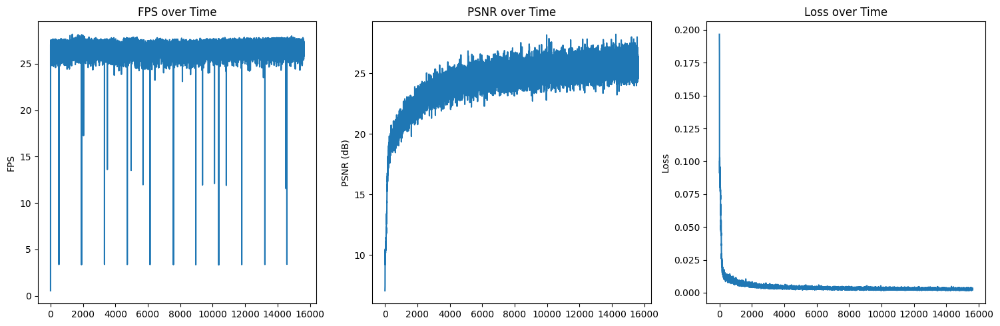

Process completed


In [ ]:
def train(nerf_model, optimizer, scheduler, data_loader, device='cpu', hn=0, hf=1, nb_epochs=1, nb_bins=192):
    training_loss = []
    metrics = {
        'fps': [], 'latency': [], 'psnr': [], 'loss': []
    }

    for epoch in range(nb_epochs):
        batch_start = time.time()
        for batch in tqdm(data_loader, desc=f"Epoch {epoch+1}/{nb_epochs}"):
            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                              hn=hn, hf=hf, nb_bins=nb_bins)

            current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            batch_end = time.time()
            batch_time = batch_end - batch_start
            fps = 1.0 / batch_time

            metrics['fps'].append(fps)
            metrics['latency'].append(batch_time * 1000)
            metrics['psnr'].append(current_psnr.item())
            metrics['loss'].append(loss.item())

            batch_start = time.time()

        scheduler.step()

    # Print final metrics
    avg_fps = sum(metrics['fps']) / len(metrics['fps'])
    avg_latency = sum(metrics['latency']) / len(metrics['latency'])
    avg_psnr = sum(metrics['psnr']) / len(metrics['psnr'])
    avg_loss = sum(metrics['loss']) / len(metrics['loss'])

    print(f"FPS: {avg_fps:.2f}, Latency: {avg_latency:.2f}ms")
    print(f"PSNR: {avg_psnr:.2f}dB, Loss: {avg_loss:.4f}")

    return training_loss, metrics

if __name__ == '__main__':
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        print(f"Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Model setup
        model = FastNerf().to(device)
        model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
        scheduler = torch.optim.lr_scheduler.MultiStepLR(
            model_optimizer,
            milestones=[2, 4, 8],
            gamma=0.5
        )

        # Full dataset with original batch size
        data_loader = DataLoader(
            training_dataset,
            batch_size=1024,
            shuffle=True
        )

        print("Starting FastNerf training...")
        training_loss, metrics = train(
            model,
            model_optimizer,
            scheduler,
            data_loader,
            device=device,
            nb_epochs=1,
            hn=2,
            hf=6,
            nb_bins=192
        )

        # Plot results
        plt.figure(figsize=(15, 5))
        plt.subplot(131)
        plt.plot(metrics['fps'])
        plt.title('FPS over Time')
        plt.ylabel('FPS')

        plt.subplot(132)
        plt.plot(metrics['psnr'])
        plt.title('PSNR over Time')
        plt.ylabel('PSNR (dB)')

        plt.subplot(133)
        plt.plot(metrics['loss'])
        plt.title('Loss over Time')
        plt.ylabel('Loss')

        plt.tight_layout()
        display(plt.gcf())
        plt.close()

    except Exception as e:
        print(f"Error occurred: {e}")
    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")

 k = 192 instead of 500 so the resolution is **low**

## PlanOctrees

## Plenoctrees
1. **Method **: Employs an octree data structure to hierarchically partition the scene into a 3D spatial grid, allowing for fast retrieval and rendering. PlenOctrees precompute and store the radiance and color data for each voxel in the octree, which minimizes the computational load by enabling quick access to only the necessary voxels during rendering. By using spherical harmonics, PlenOctrees encode view-dependent lighting effects directly within each node, preserving realistic lighting effects without recalculating every frame​.
2. **Efficiency in rendering**:
Capable of rendering at over 150 frames per second (fps) at 800x800 resolution, PlenOctree is optimized for real-time applications. The octree-based approach selectively renders visible areas, reducing memory and computation usage. This octree setup sacrifices minimal image fidelity, providing high-speed rendering suitable for applications that require smooth frame rates and high-quality visuals.
3.** Visual quality : **
It precomputes radiance data with spherical harmonics, PlenOctree can maintain high visual fidelity for specularities and shading effects. The octree structure, however, is limited by its voxel resolution, which may impact small details depending on the depth of the octree. Still, the quality remains competitive and is typically comparable to traditional NeRFs.
4. **Trainning process :**
PlenOctree optimizes training time by directly creating a compact, precomputed octree, which allows for faster scene deployment. Since it does not need to wait for full NeRF convergence, training times are reduced, allowing for quicker deployment into real-time applications, particularly where predefined scenes are used, such as in VR/AR environments​.


In [ ]:
# Using 75 location for calcultation density the colors SH = 16
# Using spherical gaussians(25 components)
# sherical harmonic

In [15]:
def to_cartesian(theta_phi):
    return torch.stack([torch.sin(theta_phi[:, 0]) * torch.cos(theta_phi[:, 1]),
                        torch.sin(theta_phi[:, 0]) * torch.sin(theta_phi[:, 1]),
                        torch.cos(theta_phi[:, 0])], axis=1)


class NerfModel_PlenOctree(nn.Module):
    def __init__(self, embedding_dim_pos=20, embedding_dim_direction=8, hidden_dim=128):
        super(NerfModel_PlenOctree, self).__init__()

        self.block1 = nn.Sequential(nn.Linear(embedding_dim_pos * 3, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(), )

        self.block2 = nn.Sequential(nn.Linear(embedding_dim_pos * 3 + hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim), nn.ReLU(),
                                    nn.Linear(hidden_dim, hidden_dim + 1), )

        self.block3 = nn.Sequential(nn.Linear(hidden_dim, hidden_dim // 2), nn.ReLU(), )
        self.block4 = nn.Sequential(nn.Linear(hidden_dim // 2, 48), ) # if we chose element of sherical is 16, this number wil be 16 multiple with 3

        self.embedding_dim_pos = embedding_dim_pos
        self.embedding_dim_direction = embedding_dim_direction
        self.relu = nn.ReLU()

        self.bandwidth = nn.Parameter(torch.zeros((1, 16)))# can be 16 as well
        self.p = nn.Parameter(torch.randn((16, 2)))

    @staticmethod
    def positional_encoding(x, L):
        out = torch.empty(x.shape[0], x.shape[1] * 2 * L, device=x.device)
        for i in range(x.shape[1]):
            for j in range(L):
                out[:, i * (2 * L) + 2 * j] = torch.sin(2 ** j * x[:, i])
                out[:, i * (2 * L) + 2 * j + 1] = torch.cos(2 ** j * x[:, i])
        return out

    def forward(self, o, d):
        emb_x = self.positional_encoding(o, self.embedding_dim_pos // 2)
        h = self.block1(emb_x)
        tmp = self.block2(torch.cat((h, emb_x), dim=1))
        h, sigma = tmp[:, :-1], self.relu(tmp[:, -1])
        h = self.block3(h)
        k = self.block4(h).reshape(o.shape[0], 16, 3)

        c = (k * torch.exp(
            (self.bandwidth.unsqueeze(-1) * to_cartesian(self.p).unsqueeze(0) * d.unsqueeze(1)))).sum(1)# This is sherical gaussian formula, we can use Harmonic as well

        return torch.sigmoid(c), sigma


@torch.no_grad()
def test(hn, hf, dataset, chunk_size=5, img_index=0, nb_bins=192, H=200, W=200):# 192 is the level of visual resolution.
    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []
    for i in range(int(np.ceil(H / chunk_size))):
        ray_origins_ = ray_origins[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        ray_directions_ = ray_directions[i * W * chunk_size: (i + 1) * W * chunk_size].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)

    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)
    plt.figure()
    plt.imshow(img)
    plt.savefig(f'novel_views/img_{img_index}.png', bbox_inches='tight')
    plt.close()


def compute_accumulated_transmittance(alphas):
    accumulated_transmittance = torch.cumprod(alphas, 1)
    return torch.cat((torch.ones((accumulated_transmittance.shape[0], 1), device=alphas.device),
                      accumulated_transmittance[:, :-1]), dim=-1)


def render_rays(nerf_model, ray_origins, ray_directions, hn=0, hf=0.5, nb_bins=192):
    device = ray_origins.device
    t = torch.linspace(hn, hf, nb_bins, device=device).expand(ray_origins.shape[0], nb_bins)
    # Perturb sampling along each ray.
    mid = (t[:, :-1] + t[:, 1:]) / 2.
    lower = torch.cat((t[:, :1], mid), -1)
    upper = torch.cat((mid, t[:, -1:]), -1)
    u = torch.rand(t.shape, device=device)
    t = lower + (upper - lower) * u  # [batch_size, nb_bins]
    delta = torch.cat((t[:, 1:] - t[:, :-1], torch.tensor([1e10], device=device).expand(ray_origins.shape[0], 1)), -1)

    x = ray_origins.unsqueeze(1) + t.unsqueeze(2) * ray_directions.unsqueeze(1)  # [batch_size, nb_bins, 3]
    ray_directions = ray_directions.expand(nb_bins, ray_directions.shape[0], 3).transpose(0, 1)

    colors, sigma = nerf_model(x.reshape(-1, 3), ray_directions.reshape(-1, 3))
    colors = colors.reshape(x.shape)
    sigma = sigma.reshape(x.shape[:-1])

    alpha = 1 - torch.exp(-sigma * delta)  # [batch_size, nb_bins]
    weights = compute_accumulated_transmittance(1 - alpha).unsqueeze(2) * alpha.unsqueeze(2)
    c = (weights * colors).sum(dim=1)  # Pixel values
    weight_sum = weights.sum(-1).sum(-1)  # Regularization for white background
    return c + 1 - weight_sum.unsqueeze(-1)# By adding 1 to change from black to white






In [16]:
def train(nerf_model, optimizer, scheduler, data_loader, device='cpu', hn=0, hf=1, nb_epochs=10, nb_bins=192):
    training_loss = []
    metrics = {
        'epoch': [], 'batch': [],
        'fps': [], 'latency': [],
        'frame_variation': [], 'psnr': []
    }

    total_batches = len(data_loader) * nb_epochs
    pbar = tqdm(total=total_batches, desc="PlenOctree Training Progress")

    for epoch in range(nb_epochs):
        epoch_loss = 0.0
        batch_times = []
        epoch_psnr = []
        epoch_start = time.time()

        for batch_idx, batch in enumerate(data_loader):
            batch_start = time.time()

            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                              hn=hn, hf=hf, nb_bins=nb_bins)
            current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            batch_end = time.time()
            batch_time = batch_end - batch_start
            fps = 1.0 / batch_time
            batch_times.append(batch_time * 1000)
            epoch_psnr.append(current_psnr.item())
            epoch_loss += loss.item()

            # Store metrics
            metrics['epoch'].append(epoch)
            metrics['batch'].append(batch_idx)
            metrics['fps'].append(fps)
            metrics['latency'].append(batch_time * 1000)
            metrics['frame_variation'].append(np.std(batch_times))
            metrics['psnr'].append(current_psnr.item())

            if batch_idx % 10 == 0:
                print(f'\nPlenOctree Epoch {epoch+1}/{nb_epochs}, Batch {batch_idx}:')
                print(f'FPS: {fps:.2f}, Latency: {batch_time*1000:.2f}ms')
                print(f'PSNR: {current_psnr:.2f}dB, Loss: {loss.item():.4f}')

            pbar.update(1)

        # Epoch summary
        avg_epoch_loss = epoch_loss / len(data_loader)
        avg_epoch_psnr = sum(epoch_psnr) / len(epoch_psnr)
        epoch_fps = len(data_loader) / (time.time() - epoch_start)

        training_loss.append(avg_epoch_loss)

        scheduler.step()

        print(f'\nPlenOctree Epoch {epoch+1} Summary:')
        print(f'Average Loss: {avg_epoch_loss:.4f}')
        print(f'Average PSNR: {avg_epoch_psnr:.2f}dB')
        print(f'Average FPS: {epoch_fps:.2f}')

        # Plot current progress
        plt.figure(figsize=(15, 5))

        plt.subplot(131)
        plt.plot(training_loss)
        plt.title('PlenOctree Training Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')

        plt.subplot(132)
        plt.plot(metrics['fps'])
        plt.axhline(y=30, color='r', linestyle='--', label='Minimum FPS')
        plt.title('PlenOctree FPS over Time')
        plt.xlabel('Batch')
        plt.ylabel('FPS')
        plt.legend()

        plt.subplot(133)
        plt.plot(metrics['psnr'])
        plt.title('PlenOctree PSNR over Time')
        plt.xlabel('Batch')
        plt.ylabel('PSNR (dB)')

        plt.tight_layout()
        display(plt.gcf())
        plt.close()

    pbar.close()
    return training_loss, metrics

Using device: cuda
PlenOctree Original Training dataset shape: (16000000, 9)
PlenOctree Subset Training dataset shape: torch.Size([3200000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting training for PlenOctree Model ...


PlenOctree Training Progress:   0%|          | 3/125000 [00:00<5:32:03,  6.27it/s] 


PlenOctree Epoch 1/10, Batch 0:
FPS: 25.11, Latency: 39.82ms
PSNR: 6.30dB, Loss: 0.2346


PlenOctree Training Progress:   0%|          | 13/125000 [00:01<2:25:24, 14.33it/s]


PlenOctree Epoch 1/10, Batch 10:
FPS: 34.62, Latency: 28.89ms
PSNR: 9.59dB, Loss: 0.1098


PlenOctree Training Progress:   0%|          | 23/125000 [00:01<2:13:47, 15.57it/s]


PlenOctree Epoch 1/10, Batch 20:
FPS: 35.61, Latency: 28.08ms
PSNR: 10.31dB, Loss: 0.0931


PlenOctree Training Progress:   0%|          | 33/125000 [00:02<2:12:22, 15.73it/s]


PlenOctree Epoch 1/10, Batch 30:
FPS: 35.97, Latency: 27.80ms
PSNR: 10.52dB, Loss: 0.0887


PlenOctree Training Progress:   0%|          | 43/125000 [00:03<2:12:30, 15.72it/s]


PlenOctree Epoch 1/10, Batch 40:
FPS: 32.90, Latency: 30.40ms
PSNR: 10.47dB, Loss: 0.0898


PlenOctree Training Progress:   0%|          | 53/125000 [00:03<2:11:24, 15.85it/s]


PlenOctree Epoch 1/10, Batch 50:
FPS: 32.96, Latency: 30.34ms
PSNR: 10.33dB, Loss: 0.0926


PlenOctree Training Progress:   0%|          | 63/125000 [00:04<2:11:07, 15.88it/s]


PlenOctree Epoch 1/10, Batch 60:
FPS: 33.44, Latency: 29.90ms
PSNR: 11.18dB, Loss: 0.0763


PlenOctree Training Progress:   0%|          | 73/125000 [00:04<2:11:40, 15.81it/s]


PlenOctree Epoch 1/10, Batch 70:
FPS: 34.96, Latency: 28.61ms
PSNR: 11.15dB, Loss: 0.0767


PlenOctree Training Progress:   0%|          | 83/125000 [00:05<2:11:06, 15.88it/s]


PlenOctree Epoch 1/10, Batch 80:
FPS: 35.47, Latency: 28.19ms
PSNR: 11.24dB, Loss: 0.0751


PlenOctree Training Progress:   0%|          | 93/125000 [00:06<2:13:11, 15.63it/s]


PlenOctree Epoch 1/10, Batch 90:
FPS: 32.06, Latency: 31.19ms
PSNR: 11.46dB, Loss: 0.0715


PlenOctree Training Progress:   0%|          | 103/125000 [00:06<2:10:04, 16.00it/s]


PlenOctree Epoch 1/10, Batch 100:
FPS: 34.05, Latency: 29.37ms
PSNR: 11.94dB, Loss: 0.0639


PlenOctree Training Progress:   0%|          | 113/125000 [00:07<2:06:22, 16.47it/s]


PlenOctree Epoch 1/10, Batch 110:
FPS: 35.95, Latency: 27.82ms
PSNR: 13.48dB, Loss: 0.0449


PlenOctree Training Progress:   0%|          | 123/125000 [00:08<2:06:04, 16.51it/s]


PlenOctree Epoch 1/10, Batch 120:
FPS: 36.13, Latency: 27.68ms
PSNR: 13.65dB, Loss: 0.0432


PlenOctree Training Progress:   0%|          | 133/125000 [00:08<2:06:08, 16.50it/s]


PlenOctree Epoch 1/10, Batch 130:
FPS: 36.05, Latency: 27.74ms
PSNR: 14.72dB, Loss: 0.0338


PlenOctree Training Progress:   0%|          | 143/125000 [00:09<2:06:41, 16.43it/s]


PlenOctree Epoch 1/10, Batch 140:
FPS: 35.80, Latency: 27.93ms
PSNR: 15.03dB, Loss: 0.0314


PlenOctree Training Progress:   0%|          | 153/125000 [00:09<2:05:59, 16.52it/s]


PlenOctree Epoch 1/10, Batch 150:
FPS: 36.36, Latency: 27.50ms
PSNR: 16.14dB, Loss: 0.0243


PlenOctree Training Progress:   0%|          | 163/125000 [00:10<2:06:50, 16.40it/s]


PlenOctree Epoch 1/10, Batch 160:
FPS: 33.83, Latency: 29.56ms
PSNR: 15.88dB, Loss: 0.0258


PlenOctree Training Progress:   0%|          | 173/125000 [00:11<2:06:23, 16.46it/s]


PlenOctree Epoch 1/10, Batch 170:
FPS: 36.03, Latency: 27.75ms
PSNR: 15.16dB, Loss: 0.0305


PlenOctree Training Progress:   0%|          | 183/125000 [00:11<2:06:17, 16.47it/s]


PlenOctree Epoch 1/10, Batch 180:
FPS: 35.97, Latency: 27.80ms
PSNR: 14.78dB, Loss: 0.0332


PlenOctree Training Progress:   0%|          | 193/125000 [00:12<2:06:26, 16.45it/s]


PlenOctree Epoch 1/10, Batch 190:
FPS: 36.21, Latency: 27.61ms
PSNR: 15.74dB, Loss: 0.0267


PlenOctree Training Progress:   0%|          | 203/125000 [00:12<2:06:19, 16.46it/s]


PlenOctree Epoch 1/10, Batch 200:
FPS: 35.92, Latency: 27.84ms
PSNR: 15.75dB, Loss: 0.0266


PlenOctree Training Progress:   0%|          | 213/125000 [00:13<2:06:33, 16.43it/s]


PlenOctree Epoch 1/10, Batch 210:
FPS: 34.96, Latency: 28.61ms
PSNR: 15.51dB, Loss: 0.0281


PlenOctree Training Progress:   0%|          | 223/125000 [00:14<2:06:37, 16.42it/s]


PlenOctree Epoch 1/10, Batch 220:
FPS: 36.29, Latency: 27.56ms
PSNR: 15.86dB, Loss: 0.0260


PlenOctree Training Progress:   0%|          | 233/125000 [00:14<2:06:18, 16.46it/s]


PlenOctree Epoch 1/10, Batch 230:
FPS: 36.07, Latency: 27.73ms
PSNR: 16.73dB, Loss: 0.0212


PlenOctree Training Progress:   0%|          | 243/125000 [00:15<2:06:37, 16.42it/s]


PlenOctree Epoch 1/10, Batch 240:
FPS: 35.33, Latency: 28.31ms
PSNR: 17.06dB, Loss: 0.0197


PlenOctree Training Progress:   0%|          | 253/125000 [00:15<2:06:02, 16.50it/s]


PlenOctree Epoch 1/10, Batch 250:
FPS: 36.83, Latency: 27.15ms
PSNR: 17.23dB, Loss: 0.0189


PlenOctree Training Progress:   0%|          | 263/125000 [00:16<2:06:27, 16.44it/s]


PlenOctree Epoch 1/10, Batch 260:
FPS: 36.48, Latency: 27.41ms
PSNR: 17.70dB, Loss: 0.0170


PlenOctree Training Progress:   0%|          | 273/125000 [00:17<2:07:09, 16.35it/s]


PlenOctree Epoch 1/10, Batch 270:
FPS: 35.78, Latency: 27.95ms
PSNR: 16.68dB, Loss: 0.0215


PlenOctree Training Progress:   0%|          | 283/125000 [00:17<2:06:19, 16.45it/s]


PlenOctree Epoch 1/10, Batch 280:
FPS: 35.29, Latency: 28.34ms
PSNR: 16.60dB, Loss: 0.0219


PlenOctree Training Progress:   0%|          | 293/125000 [00:18<2:06:59, 16.37it/s]


PlenOctree Epoch 1/10, Batch 290:
FPS: 35.37, Latency: 28.27ms
PSNR: 18.07dB, Loss: 0.0156


PlenOctree Training Progress:   0%|          | 303/125000 [00:19<2:06:25, 16.44it/s]


PlenOctree Epoch 1/10, Batch 300:
FPS: 36.45, Latency: 27.44ms
PSNR: 17.70dB, Loss: 0.0170


PlenOctree Training Progress:   0%|          | 313/125000 [00:19<2:08:48, 16.13it/s]


PlenOctree Epoch 1/10, Batch 310:
FPS: 35.26, Latency: 28.36ms
PSNR: 17.15dB, Loss: 0.0193


PlenOctree Training Progress:   0%|          | 323/125000 [00:20<2:08:04, 16.22it/s]


PlenOctree Epoch 1/10, Batch 320:
FPS: 35.67, Latency: 28.04ms
PSNR: 16.81dB, Loss: 0.0208


PlenOctree Training Progress:   0%|          | 333/125000 [00:20<2:06:02, 16.48it/s]


PlenOctree Epoch 1/10, Batch 330:
FPS: 36.82, Latency: 27.16ms
PSNR: 17.13dB, Loss: 0.0193


PlenOctree Training Progress:   0%|          | 343/125000 [00:21<2:09:22, 16.06it/s]


PlenOctree Epoch 1/10, Batch 340:
FPS: 34.84, Latency: 28.70ms
PSNR: 16.65dB, Loss: 0.0216


PlenOctree Training Progress:   0%|          | 353/125000 [00:22<2:07:03, 16.35it/s]


PlenOctree Epoch 1/10, Batch 350:
FPS: 36.56, Latency: 27.35ms
PSNR: 16.87dB, Loss: 0.0205


PlenOctree Training Progress:   0%|          | 363/125000 [00:22<2:08:45, 16.13it/s]


PlenOctree Epoch 1/10, Batch 360:
FPS: 36.32, Latency: 27.53ms
PSNR: 17.75dB, Loss: 0.0168


PlenOctree Training Progress:   0%|          | 373/125000 [00:23<2:08:45, 16.13it/s]


PlenOctree Epoch 1/10, Batch 370:
FPS: 34.33, Latency: 29.13ms
PSNR: 18.56dB, Loss: 0.0139


PlenOctree Training Progress:   0%|          | 383/125000 [00:23<2:08:22, 16.18it/s]


PlenOctree Epoch 1/10, Batch 380:
FPS: 36.40, Latency: 27.47ms
PSNR: 18.28dB, Loss: 0.0148


PlenOctree Training Progress:   0%|          | 393/125000 [00:24<2:07:26, 16.30it/s]


PlenOctree Epoch 1/10, Batch 390:
FPS: 35.47, Latency: 28.19ms
PSNR: 17.72dB, Loss: 0.0169


PlenOctree Training Progress:   0%|          | 403/125000 [00:25<2:06:03, 16.47it/s]


PlenOctree Epoch 1/10, Batch 400:
FPS: 35.54, Latency: 28.14ms
PSNR: 18.09dB, Loss: 0.0155


PlenOctree Training Progress:   0%|          | 413/125000 [00:25<2:06:16, 16.44it/s]


PlenOctree Epoch 1/10, Batch 410:
FPS: 35.02, Latency: 28.56ms
PSNR: 16.82dB, Loss: 0.0208


PlenOctree Training Progress:   0%|          | 423/125000 [00:26<2:06:48, 16.37it/s]


PlenOctree Epoch 1/10, Batch 420:
FPS: 35.57, Latency: 28.11ms
PSNR: 17.84dB, Loss: 0.0164


PlenOctree Training Progress:   0%|          | 433/125000 [00:26<2:05:54, 16.49it/s]


PlenOctree Epoch 1/10, Batch 430:
FPS: 35.99, Latency: 27.79ms
PSNR: 17.51dB, Loss: 0.0177


PlenOctree Training Progress:   0%|          | 443/125000 [00:27<2:06:21, 16.43it/s]


PlenOctree Epoch 1/10, Batch 440:
FPS: 36.55, Latency: 27.36ms
PSNR: 17.91dB, Loss: 0.0162


PlenOctree Training Progress:   0%|          | 453/125000 [00:28<2:05:19, 16.56it/s]


PlenOctree Epoch 1/10, Batch 450:
FPS: 36.49, Latency: 27.40ms
PSNR: 18.50dB, Loss: 0.0141


PlenOctree Training Progress:   0%|          | 463/125000 [00:28<2:05:42, 16.51it/s]


PlenOctree Epoch 1/10, Batch 460:
FPS: 35.44, Latency: 28.22ms
PSNR: 17.00dB, Loss: 0.0200


PlenOctree Training Progress:   0%|          | 473/125000 [00:29<2:06:17, 16.43it/s]


PlenOctree Epoch 1/10, Batch 470:
FPS: 35.07, Latency: 28.51ms
PSNR: 17.59dB, Loss: 0.0174


PlenOctree Training Progress:   0%|          | 483/125000 [00:30<2:05:43, 16.51it/s]


PlenOctree Epoch 1/10, Batch 480:
FPS: 36.77, Latency: 27.20ms
PSNR: 17.42dB, Loss: 0.0181


PlenOctree Training Progress:   0%|          | 493/125000 [00:30<2:06:05, 16.46it/s]


PlenOctree Epoch 1/10, Batch 490:
FPS: 35.07, Latency: 28.51ms
PSNR: 17.40dB, Loss: 0.0182


PlenOctree Training Progress:   0%|          | 503/125000 [00:31<2:05:44, 16.50it/s]


PlenOctree Epoch 1/10, Batch 500:
FPS: 35.71, Latency: 28.00ms
PSNR: 18.03dB, Loss: 0.0157


PlenOctree Training Progress:   0%|          | 513/125000 [00:31<2:05:32, 16.53it/s]


PlenOctree Epoch 1/10, Batch 510:
FPS: 36.31, Latency: 27.54ms
PSNR: 20.07dB, Loss: 0.0098


PlenOctree Training Progress:   0%|          | 523/125000 [00:32<2:05:58, 16.47it/s]


PlenOctree Epoch 1/10, Batch 520:
FPS: 36.99, Latency: 27.04ms
PSNR: 18.41dB, Loss: 0.0144


PlenOctree Training Progress:   0%|          | 533/125000 [00:33<2:05:25, 16.54it/s]


PlenOctree Epoch 1/10, Batch 530:
FPS: 36.96, Latency: 27.06ms
PSNR: 17.89dB, Loss: 0.0163


PlenOctree Training Progress:   0%|          | 543/125000 [00:33<2:05:35, 16.52it/s]


PlenOctree Epoch 1/10, Batch 540:
FPS: 36.60, Latency: 27.32ms
PSNR: 17.59dB, Loss: 0.0174


PlenOctree Training Progress:   0%|          | 553/125000 [00:34<2:05:36, 16.51it/s]


PlenOctree Epoch 1/10, Batch 550:
FPS: 36.62, Latency: 27.30ms
PSNR: 18.65dB, Loss: 0.0137


PlenOctree Training Progress:   0%|          | 563/125000 [00:34<2:05:34, 16.51it/s]


PlenOctree Epoch 1/10, Batch 560:
FPS: 36.17, Latency: 27.65ms
PSNR: 18.34dB, Loss: 0.0146


PlenOctree Training Progress:   0%|          | 573/125000 [00:35<2:05:30, 16.52it/s]


PlenOctree Epoch 1/10, Batch 570:
FPS: 35.68, Latency: 28.03ms
PSNR: 17.57dB, Loss: 0.0175


PlenOctree Training Progress:   0%|          | 583/125000 [00:36<2:05:44, 16.49it/s]


PlenOctree Epoch 1/10, Batch 580:
FPS: 37.02, Latency: 27.02ms
PSNR: 17.92dB, Loss: 0.0161


PlenOctree Training Progress:   0%|          | 593/125000 [00:36<2:05:38, 16.50it/s]


PlenOctree Epoch 1/10, Batch 590:
FPS: 36.79, Latency: 27.18ms
PSNR: 17.99dB, Loss: 0.0159


PlenOctree Training Progress:   0%|          | 603/125000 [00:37<2:05:44, 16.49it/s]


PlenOctree Epoch 1/10, Batch 600:
FPS: 36.67, Latency: 27.27ms
PSNR: 18.22dB, Loss: 0.0150


PlenOctree Training Progress:   0%|          | 613/125000 [00:37<2:05:46, 16.48it/s]


PlenOctree Epoch 1/10, Batch 610:
FPS: 36.48, Latency: 27.41ms
PSNR: 17.65dB, Loss: 0.0172


PlenOctree Training Progress:   0%|          | 623/125000 [00:38<2:05:47, 16.48it/s]


PlenOctree Epoch 1/10, Batch 620:
FPS: 36.93, Latency: 27.08ms
PSNR: 19.59dB, Loss: 0.0110


PlenOctree Training Progress:   1%|          | 633/125000 [00:39<2:05:15, 16.55it/s]


PlenOctree Epoch 1/10, Batch 630:
FPS: 37.31, Latency: 26.80ms
PSNR: 19.35dB, Loss: 0.0116


PlenOctree Training Progress:   1%|          | 643/125000 [00:39<2:03:12, 16.82it/s]


PlenOctree Epoch 1/10, Batch 640:
FPS: 37.14, Latency: 26.92ms
PSNR: 20.12dB, Loss: 0.0097


PlenOctree Training Progress:   1%|          | 653/125000 [00:40<2:05:07, 16.56it/s]


PlenOctree Epoch 1/10, Batch 650:
FPS: 36.55, Latency: 27.36ms
PSNR: 18.04dB, Loss: 0.0157


PlenOctree Training Progress:   1%|          | 663/125000 [00:40<2:04:52, 16.59it/s]


PlenOctree Epoch 1/10, Batch 660:
FPS: 37.31, Latency: 26.80ms
PSNR: 18.33dB, Loss: 0.0147


PlenOctree Training Progress:   1%|          | 673/125000 [00:41<2:04:05, 16.70it/s]


PlenOctree Epoch 1/10, Batch 670:
FPS: 36.19, Latency: 27.63ms
PSNR: 18.41dB, Loss: 0.0144


PlenOctree Training Progress:   1%|          | 683/125000 [00:42<2:05:02, 16.57it/s]


PlenOctree Epoch 1/10, Batch 680:
FPS: 36.66, Latency: 27.28ms
PSNR: 18.17dB, Loss: 0.0152


PlenOctree Training Progress:   1%|          | 693/125000 [00:42<2:05:33, 16.50it/s]


PlenOctree Epoch 1/10, Batch 690:
FPS: 36.79, Latency: 27.18ms
PSNR: 17.71dB, Loss: 0.0169


PlenOctree Training Progress:   1%|          | 703/125000 [00:43<2:04:51, 16.59it/s]


PlenOctree Epoch 1/10, Batch 700:
FPS: 37.16, Latency: 26.91ms
PSNR: 18.26dB, Loss: 0.0149


PlenOctree Training Progress:   1%|          | 713/125000 [00:43<2:03:40, 16.75it/s]


PlenOctree Epoch 1/10, Batch 710:
FPS: 36.43, Latency: 27.45ms
PSNR: 19.13dB, Loss: 0.0122


PlenOctree Training Progress:   1%|          | 723/125000 [00:44<2:01:46, 17.01it/s]


PlenOctree Epoch 1/10, Batch 720:
FPS: 37.33, Latency: 26.79ms
PSNR: 18.03dB, Loss: 0.0158


PlenOctree Training Progress:   1%|          | 733/125000 [00:45<2:02:41, 16.88it/s]


PlenOctree Epoch 1/10, Batch 730:
FPS: 38.00, Latency: 26.32ms
PSNR: 19.29dB, Loss: 0.0118


PlenOctree Training Progress:   1%|          | 743/125000 [00:45<2:01:44, 17.01it/s]


PlenOctree Epoch 1/10, Batch 740:
FPS: 38.22, Latency: 26.17ms
PSNR: 18.39dB, Loss: 0.0145


PlenOctree Training Progress:   1%|          | 753/125000 [00:46<2:03:02, 16.83it/s]


PlenOctree Epoch 1/10, Batch 750:
FPS: 37.66, Latency: 26.55ms
PSNR: 18.10dB, Loss: 0.0155


PlenOctree Training Progress:   1%|          | 763/125000 [00:46<2:02:53, 16.85it/s]


PlenOctree Epoch 1/10, Batch 760:
FPS: 36.21, Latency: 27.62ms
PSNR: 19.40dB, Loss: 0.0115


PlenOctree Training Progress:   1%|          | 773/125000 [00:47<2:02:50, 16.86it/s]


PlenOctree Epoch 1/10, Batch 770:
FPS: 36.96, Latency: 27.05ms
PSNR: 19.31dB, Loss: 0.0117


PlenOctree Training Progress:   1%|          | 783/125000 [00:48<2:01:15, 17.07it/s]


PlenOctree Epoch 1/10, Batch 780:
FPS: 38.27, Latency: 26.13ms
PSNR: 18.71dB, Loss: 0.0135


PlenOctree Training Progress:   1%|          | 793/125000 [00:48<2:02:29, 16.90it/s]


PlenOctree Epoch 1/10, Batch 790:
FPS: 36.64, Latency: 27.29ms
PSNR: 17.87dB, Loss: 0.0163


PlenOctree Training Progress:   1%|          | 803/125000 [00:49<2:00:55, 17.12it/s]


PlenOctree Epoch 1/10, Batch 800:
FPS: 38.39, Latency: 26.05ms
PSNR: 19.81dB, Loss: 0.0104


PlenOctree Training Progress:   1%|          | 813/125000 [00:49<2:01:49, 16.99it/s]


PlenOctree Epoch 1/10, Batch 810:
FPS: 37.62, Latency: 26.58ms
PSNR: 18.02dB, Loss: 0.0158


PlenOctree Training Progress:   1%|          | 823/125000 [00:50<2:01:15, 17.07it/s]


PlenOctree Epoch 1/10, Batch 820:
FPS: 36.95, Latency: 27.07ms
PSNR: 18.05dB, Loss: 0.0157


PlenOctree Training Progress:   1%|          | 833/125000 [00:50<2:01:11, 17.08it/s]


PlenOctree Epoch 1/10, Batch 830:
FPS: 37.85, Latency: 26.42ms
PSNR: 18.48dB, Loss: 0.0142


PlenOctree Training Progress:   1%|          | 843/125000 [00:51<2:01:19, 17.06it/s]


PlenOctree Epoch 1/10, Batch 840:
FPS: 38.58, Latency: 25.92ms
PSNR: 17.82dB, Loss: 0.0165


PlenOctree Training Progress:   1%|          | 853/125000 [00:52<2:00:51, 17.12it/s]


PlenOctree Epoch 1/10, Batch 850:
FPS: 37.67, Latency: 26.54ms
PSNR: 19.06dB, Loss: 0.0124


PlenOctree Training Progress:   1%|          | 863/125000 [00:52<2:02:05, 16.95it/s]


PlenOctree Epoch 1/10, Batch 860:
FPS: 37.69, Latency: 26.53ms
PSNR: 18.74dB, Loss: 0.0134


PlenOctree Training Progress:   1%|          | 873/125000 [00:53<2:01:17, 17.06it/s]


PlenOctree Epoch 1/10, Batch 870:
FPS: 37.74, Latency: 26.49ms
PSNR: 18.74dB, Loss: 0.0134


PlenOctree Training Progress:   1%|          | 883/125000 [00:53<2:02:13, 16.92it/s]


PlenOctree Epoch 1/10, Batch 880:
FPS: 36.82, Latency: 27.16ms
PSNR: 20.51dB, Loss: 0.0089


PlenOctree Training Progress:   1%|          | 893/125000 [00:54<2:02:14, 16.92it/s]


PlenOctree Epoch 1/10, Batch 890:
FPS: 37.81, Latency: 26.45ms
PSNR: 17.89dB, Loss: 0.0162


PlenOctree Training Progress:   1%|          | 903/125000 [00:55<2:02:40, 16.86it/s]


PlenOctree Epoch 1/10, Batch 900:
FPS: 35.18, Latency: 28.42ms
PSNR: 18.37dB, Loss: 0.0145


PlenOctree Training Progress:   1%|          | 913/125000 [00:55<2:01:45, 16.99it/s]


PlenOctree Epoch 1/10, Batch 910:
FPS: 37.21, Latency: 26.88ms
PSNR: 18.54dB, Loss: 0.0140


PlenOctree Training Progress:   1%|          | 923/125000 [00:56<2:00:45, 17.12it/s]


PlenOctree Epoch 1/10, Batch 920:
FPS: 38.12, Latency: 26.23ms
PSNR: 20.05dB, Loss: 0.0099


PlenOctree Training Progress:   1%|          | 933/125000 [00:56<2:01:06, 17.07it/s]


PlenOctree Epoch 1/10, Batch 930:
FPS: 37.89, Latency: 26.40ms
PSNR: 20.09dB, Loss: 0.0098


PlenOctree Training Progress:   1%|          | 943/125000 [00:57<2:00:54, 17.10it/s]


PlenOctree Epoch 1/10, Batch 940:
FPS: 38.03, Latency: 26.29ms
PSNR: 19.36dB, Loss: 0.0116


PlenOctree Training Progress:   1%|          | 953/125000 [00:58<2:00:20, 17.18it/s]


PlenOctree Epoch 1/10, Batch 950:
FPS: 39.14, Latency: 25.55ms
PSNR: 18.82dB, Loss: 0.0131


PlenOctree Training Progress:   1%|          | 963/125000 [00:58<2:00:10, 17.20it/s]


PlenOctree Epoch 1/10, Batch 960:
FPS: 37.41, Latency: 26.73ms
PSNR: 18.39dB, Loss: 0.0145


PlenOctree Training Progress:   1%|          | 973/125000 [00:59<2:00:35, 17.14it/s]


PlenOctree Epoch 1/10, Batch 970:
FPS: 37.25, Latency: 26.84ms
PSNR: 19.02dB, Loss: 0.0125


PlenOctree Training Progress:   1%|          | 983/125000 [00:59<2:01:26, 17.02it/s]


PlenOctree Epoch 1/10, Batch 980:
FPS: 37.43, Latency: 26.72ms
PSNR: 18.52dB, Loss: 0.0141


PlenOctree Training Progress:   1%|          | 993/125000 [01:00<2:01:23, 17.03it/s]


PlenOctree Epoch 1/10, Batch 990:
FPS: 38.11, Latency: 26.24ms
PSNR: 19.70dB, Loss: 0.0107


PlenOctree Training Progress:   1%|          | 1003/125000 [01:00<2:01:30, 17.01it/s]


PlenOctree Epoch 1/10, Batch 1000:
FPS: 37.46, Latency: 26.70ms
PSNR: 20.17dB, Loss: 0.0096


PlenOctree Training Progress:   1%|          | 1013/125000 [01:01<1:59:05, 17.35it/s]


PlenOctree Epoch 1/10, Batch 1010:
FPS: 38.74, Latency: 25.81ms
PSNR: 18.22dB, Loss: 0.0151


PlenOctree Training Progress:   1%|          | 1023/125000 [01:02<2:01:04, 17.07it/s]


PlenOctree Epoch 1/10, Batch 1020:
FPS: 38.23, Latency: 26.16ms
PSNR: 19.54dB, Loss: 0.0111


PlenOctree Training Progress:   1%|          | 1033/125000 [01:02<2:00:24, 17.16it/s]


PlenOctree Epoch 1/10, Batch 1030:
FPS: 37.33, Latency: 26.79ms
PSNR: 19.17dB, Loss: 0.0121


PlenOctree Training Progress:   1%|          | 1043/125000 [01:03<2:00:18, 17.17it/s]


PlenOctree Epoch 1/10, Batch 1040:
FPS: 38.76, Latency: 25.80ms
PSNR: 17.39dB, Loss: 0.0182


PlenOctree Training Progress:   1%|          | 1053/125000 [01:03<1:59:38, 17.27it/s]


PlenOctree Epoch 1/10, Batch 1050:
FPS: 38.58, Latency: 25.92ms
PSNR: 19.44dB, Loss: 0.0114


PlenOctree Training Progress:   1%|          | 1063/125000 [01:04<2:00:31, 17.14it/s]


PlenOctree Epoch 1/10, Batch 1060:
FPS: 37.75, Latency: 26.49ms
PSNR: 18.96dB, Loss: 0.0127


PlenOctree Training Progress:   1%|          | 1073/125000 [01:05<2:01:04, 17.06it/s]


PlenOctree Epoch 1/10, Batch 1070:
FPS: 38.57, Latency: 25.93ms
PSNR: 19.23dB, Loss: 0.0119


PlenOctree Training Progress:   1%|          | 1083/125000 [01:05<2:01:12, 17.04it/s]


PlenOctree Epoch 1/10, Batch 1080:
FPS: 37.84, Latency: 26.43ms
PSNR: 19.54dB, Loss: 0.0111


PlenOctree Training Progress:   1%|          | 1093/125000 [01:06<2:01:45, 16.96it/s]


PlenOctree Epoch 1/10, Batch 1090:
FPS: 36.23, Latency: 27.60ms
PSNR: 21.03dB, Loss: 0.0079


PlenOctree Training Progress:   1%|          | 1103/125000 [01:06<2:01:34, 16.98it/s]


PlenOctree Epoch 1/10, Batch 1100:
FPS: 36.87, Latency: 27.12ms
PSNR: 20.21dB, Loss: 0.0095


PlenOctree Training Progress:   1%|          | 1113/125000 [01:07<2:00:16, 17.17it/s]


PlenOctree Epoch 1/10, Batch 1110:
FPS: 37.33, Latency: 26.79ms
PSNR: 20.57dB, Loss: 0.0088


PlenOctree Training Progress:   1%|          | 1123/125000 [01:07<2:00:58, 17.07it/s]


PlenOctree Epoch 1/10, Batch 1120:
FPS: 37.22, Latency: 26.87ms
PSNR: 18.14dB, Loss: 0.0153


PlenOctree Training Progress:   1%|          | 1133/125000 [01:08<2:01:28, 16.99it/s]


PlenOctree Epoch 1/10, Batch 1130:
FPS: 36.81, Latency: 27.17ms
PSNR: 18.16dB, Loss: 0.0153


PlenOctree Training Progress:   1%|          | 1143/125000 [01:09<2:00:44, 17.10it/s]


PlenOctree Epoch 1/10, Batch 1140:
FPS: 37.48, Latency: 26.68ms
PSNR: 19.88dB, Loss: 0.0103


PlenOctree Training Progress:   1%|          | 1153/125000 [01:09<1:59:47, 17.23it/s]


PlenOctree Epoch 1/10, Batch 1150:
FPS: 38.13, Latency: 26.22ms
PSNR: 18.33dB, Loss: 0.0147


PlenOctree Training Progress:   1%|          | 1163/125000 [01:10<1:59:49, 17.22it/s]


PlenOctree Epoch 1/10, Batch 1160:
FPS: 39.11, Latency: 25.57ms
PSNR: 19.04dB, Loss: 0.0125


PlenOctree Training Progress:   1%|          | 1173/125000 [01:10<2:00:16, 17.16it/s]


PlenOctree Epoch 1/10, Batch 1170:
FPS: 38.85, Latency: 25.74ms
PSNR: 20.40dB, Loss: 0.0091


PlenOctree Training Progress:   1%|          | 1183/125000 [01:11<2:00:55, 17.07it/s]


PlenOctree Epoch 1/10, Batch 1180:
FPS: 38.37, Latency: 26.06ms
PSNR: 20.71dB, Loss: 0.0085


PlenOctree Training Progress:   1%|          | 1193/125000 [01:12<1:59:39, 17.25it/s]


PlenOctree Epoch 1/10, Batch 1190:
FPS: 38.60, Latency: 25.91ms
PSNR: 19.66dB, Loss: 0.0108


PlenOctree Training Progress:   1%|          | 1203/125000 [01:12<2:00:22, 17.14it/s]


PlenOctree Epoch 1/10, Batch 1200:
FPS: 37.34, Latency: 26.78ms
PSNR: 19.28dB, Loss: 0.0118


PlenOctree Training Progress:   1%|          | 1213/125000 [01:13<1:59:45, 17.23it/s]


PlenOctree Epoch 1/10, Batch 1210:
FPS: 38.22, Latency: 26.16ms
PSNR: 18.54dB, Loss: 0.0140


PlenOctree Training Progress:   1%|          | 1223/125000 [01:13<1:59:56, 17.20it/s]


PlenOctree Epoch 1/10, Batch 1220:
FPS: 37.76, Latency: 26.48ms
PSNR: 20.50dB, Loss: 0.0089


PlenOctree Training Progress:   1%|          | 1233/125000 [01:14<2:00:33, 17.11it/s]


PlenOctree Epoch 1/10, Batch 1230:
FPS: 38.36, Latency: 26.07ms
PSNR: 18.02dB, Loss: 0.0158


PlenOctree Training Progress:   1%|          | 1243/125000 [01:14<2:00:24, 17.13it/s]


PlenOctree Epoch 1/10, Batch 1240:
FPS: 37.43, Latency: 26.72ms
PSNR: 19.90dB, Loss: 0.0102


PlenOctree Training Progress:   1%|          | 1253/125000 [01:15<2:00:56, 17.05it/s]


PlenOctree Epoch 1/10, Batch 1250:
FPS: 37.22, Latency: 26.87ms
PSNR: 18.90dB, Loss: 0.0129


PlenOctree Training Progress:   1%|          | 1263/125000 [01:16<2:00:35, 17.10it/s]


PlenOctree Epoch 1/10, Batch 1260:
FPS: 37.78, Latency: 26.47ms
PSNR: 18.88dB, Loss: 0.0130


PlenOctree Training Progress:   1%|          | 1273/125000 [01:16<2:01:20, 16.99it/s]


PlenOctree Epoch 1/10, Batch 1270:
FPS: 36.97, Latency: 27.05ms
PSNR: 18.70dB, Loss: 0.0135


PlenOctree Training Progress:   1%|          | 1283/125000 [01:17<2:01:39, 16.95it/s]


PlenOctree Epoch 1/10, Batch 1280:
FPS: 37.08, Latency: 26.97ms
PSNR: 17.36dB, Loss: 0.0184


PlenOctree Training Progress:   1%|          | 1293/125000 [01:17<2:01:27, 16.97it/s]


PlenOctree Epoch 1/10, Batch 1290:
FPS: 36.09, Latency: 27.71ms
PSNR: 20.37dB, Loss: 0.0092


PlenOctree Training Progress:   1%|          | 1303/125000 [01:18<2:00:43, 17.08it/s]


PlenOctree Epoch 1/10, Batch 1300:
FPS: 36.18, Latency: 27.64ms
PSNR: 20.30dB, Loss: 0.0093


PlenOctree Training Progress:   1%|          | 1313/125000 [01:19<2:01:02, 17.03it/s]


PlenOctree Epoch 1/10, Batch 1310:
FPS: 38.21, Latency: 26.17ms
PSNR: 20.31dB, Loss: 0.0093


PlenOctree Training Progress:   1%|          | 1323/125000 [01:19<2:01:01, 17.03it/s]


PlenOctree Epoch 1/10, Batch 1320:
FPS: 38.25, Latency: 26.14ms
PSNR: 21.07dB, Loss: 0.0078


PlenOctree Training Progress:   1%|          | 1333/125000 [01:20<2:01:54, 16.91it/s]


PlenOctree Epoch 1/10, Batch 1330:
FPS: 37.97, Latency: 26.34ms
PSNR: 18.91dB, Loss: 0.0129


PlenOctree Training Progress:   1%|          | 1343/125000 [01:20<2:00:41, 17.08it/s]


PlenOctree Epoch 1/10, Batch 1340:
FPS: 37.86, Latency: 26.42ms
PSNR: 19.80dB, Loss: 0.0105


PlenOctree Training Progress:   1%|          | 1353/125000 [01:21<2:02:21, 16.84it/s]


PlenOctree Epoch 1/10, Batch 1350:
FPS: 36.09, Latency: 27.71ms
PSNR: 21.14dB, Loss: 0.0077


PlenOctree Training Progress:   1%|          | 1363/125000 [01:22<2:02:04, 16.88it/s]


PlenOctree Epoch 1/10, Batch 1360:
FPS: 37.37, Latency: 26.76ms
PSNR: 17.86dB, Loss: 0.0164


PlenOctree Training Progress:   1%|          | 1373/125000 [01:22<2:01:54, 16.90it/s]


PlenOctree Epoch 1/10, Batch 1370:
FPS: 36.59, Latency: 27.33ms
PSNR: 20.13dB, Loss: 0.0097


PlenOctree Training Progress:   1%|          | 1383/125000 [01:23<2:01:50, 16.91it/s]


PlenOctree Epoch 1/10, Batch 1380:
FPS: 37.17, Latency: 26.90ms
PSNR: 21.26dB, Loss: 0.0075


PlenOctree Training Progress:   1%|          | 1393/125000 [01:23<2:01:04, 17.02it/s]


PlenOctree Epoch 1/10, Batch 1390:
FPS: 36.74, Latency: 27.22ms
PSNR: 20.46dB, Loss: 0.0090


PlenOctree Training Progress:   1%|          | 1403/125000 [01:24<2:01:14, 16.99it/s]


PlenOctree Epoch 1/10, Batch 1400:
FPS: 37.78, Latency: 26.47ms
PSNR: 19.23dB, Loss: 0.0120


PlenOctree Training Progress:   1%|          | 1413/125000 [01:25<2:01:48, 16.91it/s]


PlenOctree Epoch 1/10, Batch 1410:
FPS: 37.06, Latency: 26.99ms
PSNR: 19.52dB, Loss: 0.0112


PlenOctree Training Progress:   1%|          | 1423/125000 [01:25<2:02:21, 16.83it/s]


PlenOctree Epoch 1/10, Batch 1420:
FPS: 37.73, Latency: 26.51ms
PSNR: 16.96dB, Loss: 0.0201


PlenOctree Training Progress:   1%|          | 1433/125000 [01:26<2:02:38, 16.79it/s]


PlenOctree Epoch 1/10, Batch 1430:
FPS: 36.93, Latency: 27.08ms
PSNR: 19.59dB, Loss: 0.0110


PlenOctree Training Progress:   1%|          | 1443/125000 [01:26<2:01:09, 17.00it/s]


PlenOctree Epoch 1/10, Batch 1440:
FPS: 37.19, Latency: 26.89ms
PSNR: 18.15dB, Loss: 0.0153


PlenOctree Training Progress:   1%|          | 1453/125000 [01:27<2:01:47, 16.91it/s]


PlenOctree Epoch 1/10, Batch 1450:
FPS: 37.25, Latency: 26.84ms
PSNR: 19.97dB, Loss: 0.0101


PlenOctree Training Progress:   1%|          | 1463/125000 [01:27<2:01:21, 16.97it/s]


PlenOctree Epoch 1/10, Batch 1460:
FPS: 37.99, Latency: 26.32ms
PSNR: 18.97dB, Loss: 0.0127


PlenOctree Training Progress:   1%|          | 1473/125000 [01:28<2:02:55, 16.75it/s]


PlenOctree Epoch 1/10, Batch 1470:
FPS: 36.87, Latency: 27.12ms
PSNR: 20.87dB, Loss: 0.0082


PlenOctree Training Progress:   1%|          | 1483/125000 [01:29<2:02:17, 16.83it/s]


PlenOctree Epoch 1/10, Batch 1480:
FPS: 35.42, Latency: 28.23ms
PSNR: 18.37dB, Loss: 0.0146


PlenOctree Training Progress:   1%|          | 1493/125000 [01:29<2:04:04, 16.59it/s]


PlenOctree Epoch 1/10, Batch 1490:
FPS: 36.18, Latency: 27.64ms
PSNR: 19.04dB, Loss: 0.0125


PlenOctree Training Progress:   1%|          | 1503/125000 [01:30<2:02:20, 16.82it/s]


PlenOctree Epoch 1/10, Batch 1500:
FPS: 37.68, Latency: 26.54ms
PSNR: 20.60dB, Loss: 0.0087


PlenOctree Training Progress:   1%|          | 1513/125000 [01:30<2:04:12, 16.57it/s]


PlenOctree Epoch 1/10, Batch 1510:
FPS: 36.44, Latency: 27.45ms
PSNR: 20.38dB, Loss: 0.0092


PlenOctree Training Progress:   1%|          | 1523/125000 [01:31<2:02:47, 16.76it/s]


PlenOctree Epoch 1/10, Batch 1520:
FPS: 38.05, Latency: 26.28ms
PSNR: 19.94dB, Loss: 0.0101


PlenOctree Training Progress:   1%|          | 1533/125000 [01:32<2:03:41, 16.64it/s]


PlenOctree Epoch 1/10, Batch 1530:
FPS: 37.17, Latency: 26.90ms
PSNR: 19.23dB, Loss: 0.0119


PlenOctree Training Progress:   1%|          | 1543/125000 [01:32<2:02:37, 16.78it/s]


PlenOctree Epoch 1/10, Batch 1540:
FPS: 37.63, Latency: 26.57ms
PSNR: 20.42dB, Loss: 0.0091


PlenOctree Training Progress:   1%|          | 1553/125000 [01:33<2:01:02, 17.00it/s]


PlenOctree Epoch 1/10, Batch 1550:
FPS: 37.26, Latency: 26.84ms
PSNR: 21.73dB, Loss: 0.0067


PlenOctree Training Progress:   1%|▏         | 1563/125000 [01:33<2:03:31, 16.66it/s]


PlenOctree Epoch 1/10, Batch 1560:
FPS: 37.73, Latency: 26.50ms
PSNR: 20.86dB, Loss: 0.0082


PlenOctree Training Progress:   1%|▏         | 1573/125000 [01:34<2:01:41, 16.90it/s]


PlenOctree Epoch 1/10, Batch 1570:
FPS: 37.52, Latency: 26.65ms
PSNR: 19.70dB, Loss: 0.0107


PlenOctree Training Progress:   1%|▏         | 1583/125000 [01:35<2:02:57, 16.73it/s]


PlenOctree Epoch 1/10, Batch 1580:
FPS: 37.25, Latency: 26.84ms
PSNR: 18.84dB, Loss: 0.0131


PlenOctree Training Progress:   1%|▏         | 1593/125000 [01:35<2:02:17, 16.82it/s]


PlenOctree Epoch 1/10, Batch 1590:
FPS: 37.79, Latency: 26.46ms
PSNR: 18.97dB, Loss: 0.0127


PlenOctree Training Progress:   1%|▏         | 1603/125000 [01:36<2:02:20, 16.81it/s]


PlenOctree Epoch 1/10, Batch 1600:
FPS: 36.88, Latency: 27.12ms
PSNR: 18.36dB, Loss: 0.0146


PlenOctree Training Progress:   1%|▏         | 1613/125000 [01:36<2:03:49, 16.61it/s]


PlenOctree Epoch 1/10, Batch 1610:
FPS: 36.14, Latency: 27.67ms
PSNR: 21.15dB, Loss: 0.0077


PlenOctree Training Progress:   1%|▏         | 1623/125000 [01:37<2:03:34, 16.64it/s]


PlenOctree Epoch 1/10, Batch 1620:
FPS: 38.18, Latency: 26.19ms
PSNR: 19.16dB, Loss: 0.0121


PlenOctree Training Progress:   1%|▏         | 1633/125000 [01:38<2:03:18, 16.67it/s]


PlenOctree Epoch 1/10, Batch 1630:
FPS: 37.14, Latency: 26.92ms
PSNR: 20.91dB, Loss: 0.0081


PlenOctree Training Progress:   1%|▏         | 1643/125000 [01:38<2:03:00, 16.71it/s]


PlenOctree Epoch 1/10, Batch 1640:
FPS: 36.89, Latency: 27.11ms
PSNR: 20.72dB, Loss: 0.0085


PlenOctree Training Progress:   1%|▏         | 1653/125000 [01:39<2:02:44, 16.75it/s]


PlenOctree Epoch 1/10, Batch 1650:
FPS: 36.19, Latency: 27.63ms
PSNR: 22.00dB, Loss: 0.0063


PlenOctree Training Progress:   1%|▏         | 1663/125000 [01:39<2:03:51, 16.60it/s]


PlenOctree Epoch 1/10, Batch 1660:
FPS: 37.13, Latency: 26.93ms
PSNR: 19.02dB, Loss: 0.0125


PlenOctree Training Progress:   1%|▏         | 1673/125000 [01:40<2:02:23, 16.79it/s]


PlenOctree Epoch 1/10, Batch 1670:
FPS: 37.10, Latency: 26.96ms
PSNR: 18.43dB, Loss: 0.0143


PlenOctree Training Progress:   1%|▏         | 1683/125000 [01:41<2:04:39, 16.49it/s]


PlenOctree Epoch 1/10, Batch 1680:
FPS: 35.61, Latency: 28.08ms
PSNR: 20.82dB, Loss: 0.0083


PlenOctree Training Progress:   1%|▏         | 1693/125000 [01:41<2:04:30, 16.50it/s]


PlenOctree Epoch 1/10, Batch 1690:
FPS: 35.54, Latency: 28.14ms
PSNR: 21.20dB, Loss: 0.0076


PlenOctree Training Progress:   1%|▏         | 1703/125000 [01:42<2:04:09, 16.55it/s]


PlenOctree Epoch 1/10, Batch 1700:
FPS: 37.61, Latency: 26.59ms
PSNR: 21.95dB, Loss: 0.0064


PlenOctree Training Progress:   1%|▏         | 1713/125000 [01:42<2:04:42, 16.48it/s]


PlenOctree Epoch 1/10, Batch 1710:
FPS: 36.32, Latency: 27.53ms
PSNR: 19.41dB, Loss: 0.0114


PlenOctree Training Progress:   1%|▏         | 1723/125000 [01:43<2:04:45, 16.47it/s]


PlenOctree Epoch 1/10, Batch 1720:
FPS: 36.36, Latency: 27.50ms
PSNR: 19.49dB, Loss: 0.0112


PlenOctree Training Progress:   1%|▏         | 1733/125000 [01:44<2:04:08, 16.55it/s]


PlenOctree Epoch 1/10, Batch 1730:
FPS: 37.79, Latency: 26.46ms
PSNR: 19.54dB, Loss: 0.0111


PlenOctree Training Progress:   1%|▏         | 1743/125000 [01:44<2:02:30, 16.77it/s]


PlenOctree Epoch 1/10, Batch 1740:
FPS: 38.23, Latency: 26.16ms
PSNR: 20.45dB, Loss: 0.0090


PlenOctree Training Progress:   1%|▏         | 1753/125000 [01:45<2:03:37, 16.62it/s]


PlenOctree Epoch 1/10, Batch 1750:
FPS: 37.15, Latency: 26.92ms
PSNR: 21.07dB, Loss: 0.0078


PlenOctree Training Progress:   1%|▏         | 1763/125000 [01:45<2:03:30, 16.63it/s]


PlenOctree Epoch 1/10, Batch 1760:
FPS: 36.54, Latency: 27.37ms
PSNR: 19.72dB, Loss: 0.0107


PlenOctree Training Progress:   1%|▏         | 1773/125000 [01:46<2:04:51, 16.45it/s]


PlenOctree Epoch 1/10, Batch 1770:
FPS: 37.30, Latency: 26.81ms
PSNR: 20.73dB, Loss: 0.0085


PlenOctree Training Progress:   1%|▏         | 1783/125000 [01:47<2:04:04, 16.55it/s]


PlenOctree Epoch 1/10, Batch 1780:
FPS: 37.82, Latency: 26.44ms
PSNR: 19.78dB, Loss: 0.0105


PlenOctree Training Progress:   1%|▏         | 1793/125000 [01:47<2:01:49, 16.86it/s]


PlenOctree Epoch 1/10, Batch 1790:
FPS: 36.48, Latency: 27.41ms
PSNR: 18.13dB, Loss: 0.0154


PlenOctree Training Progress:   1%|▏         | 1803/125000 [01:48<2:03:49, 16.58it/s]


PlenOctree Epoch 1/10, Batch 1800:
FPS: 36.99, Latency: 27.04ms
PSNR: 20.20dB, Loss: 0.0096


PlenOctree Training Progress:   1%|▏         | 1813/125000 [01:48<2:03:30, 16.62it/s]


PlenOctree Epoch 1/10, Batch 1810:
FPS: 37.57, Latency: 26.61ms
PSNR: 19.82dB, Loss: 0.0104


PlenOctree Training Progress:   1%|▏         | 1823/125000 [01:49<2:02:07, 16.81it/s]


PlenOctree Epoch 1/10, Batch 1820:
FPS: 37.87, Latency: 26.41ms
PSNR: 17.39dB, Loss: 0.0182


PlenOctree Training Progress:   1%|▏         | 1833/125000 [01:50<2:03:48, 16.58it/s]


PlenOctree Epoch 1/10, Batch 1830:
FPS: 36.23, Latency: 27.60ms
PSNR: 20.82dB, Loss: 0.0083


PlenOctree Training Progress:   1%|▏         | 1843/125000 [01:50<2:04:09, 16.53it/s]


PlenOctree Epoch 1/10, Batch 1840:
FPS: 36.89, Latency: 27.11ms
PSNR: 18.53dB, Loss: 0.0140


PlenOctree Training Progress:   1%|▏         | 1853/125000 [01:51<2:03:39, 16.60it/s]


PlenOctree Epoch 1/10, Batch 1850:
FPS: 38.39, Latency: 26.05ms
PSNR: 19.25dB, Loss: 0.0119


PlenOctree Training Progress:   1%|▏         | 1863/125000 [01:51<2:02:47, 16.71it/s]


PlenOctree Epoch 1/10, Batch 1860:
FPS: 36.52, Latency: 27.38ms
PSNR: 20.21dB, Loss: 0.0095


PlenOctree Training Progress:   1%|▏         | 1873/125000 [01:52<2:03:36, 16.60it/s]


PlenOctree Epoch 1/10, Batch 1870:
FPS: 36.03, Latency: 27.75ms
PSNR: 22.37dB, Loss: 0.0058


PlenOctree Training Progress:   2%|▏         | 1883/125000 [01:53<2:04:21, 16.50it/s]


PlenOctree Epoch 1/10, Batch 1880:
FPS: 37.17, Latency: 26.90ms
PSNR: 20.97dB, Loss: 0.0080


PlenOctree Training Progress:   2%|▏         | 1893/125000 [01:53<2:03:19, 16.64it/s]


PlenOctree Epoch 1/10, Batch 1890:
FPS: 37.70, Latency: 26.53ms
PSNR: 19.39dB, Loss: 0.0115


PlenOctree Training Progress:   2%|▏         | 1903/125000 [01:54<2:02:55, 16.69it/s]


PlenOctree Epoch 1/10, Batch 1900:
FPS: 36.94, Latency: 27.07ms
PSNR: 19.21dB, Loss: 0.0120


PlenOctree Training Progress:   2%|▏         | 1913/125000 [01:54<2:03:23, 16.63it/s]


PlenOctree Epoch 1/10, Batch 1910:
FPS: 37.57, Latency: 26.62ms
PSNR: 20.48dB, Loss: 0.0090


PlenOctree Training Progress:   2%|▏         | 1923/125000 [01:55<2:04:05, 16.53it/s]


PlenOctree Epoch 1/10, Batch 1920:
FPS: 35.89, Latency: 27.86ms
PSNR: 22.06dB, Loss: 0.0062


PlenOctree Training Progress:   2%|▏         | 1933/125000 [01:56<2:02:00, 16.81it/s]


PlenOctree Epoch 1/10, Batch 1930:
FPS: 38.55, Latency: 25.94ms
PSNR: 20.49dB, Loss: 0.0089


PlenOctree Training Progress:   2%|▏         | 1943/125000 [01:56<2:03:10, 16.65it/s]


PlenOctree Epoch 1/10, Batch 1940:
FPS: 36.44, Latency: 27.45ms
PSNR: 20.21dB, Loss: 0.0095


PlenOctree Training Progress:   2%|▏         | 1953/125000 [01:57<2:03:37, 16.59it/s]


PlenOctree Epoch 1/10, Batch 1950:
FPS: 35.76, Latency: 27.96ms
PSNR: 20.10dB, Loss: 0.0098


PlenOctree Training Progress:   2%|▏         | 1963/125000 [01:57<2:04:10, 16.51it/s]


PlenOctree Epoch 1/10, Batch 1960:
FPS: 36.66, Latency: 27.28ms
PSNR: 20.18dB, Loss: 0.0096


PlenOctree Training Progress:   2%|▏         | 1973/125000 [01:58<2:01:56, 16.82it/s]


PlenOctree Epoch 1/10, Batch 1970:
FPS: 37.48, Latency: 26.68ms
PSNR: 19.68dB, Loss: 0.0108


PlenOctree Training Progress:   2%|▏         | 1983/125000 [01:59<2:04:02, 16.53it/s]


PlenOctree Epoch 1/10, Batch 1980:
FPS: 35.78, Latency: 27.95ms
PSNR: 20.54dB, Loss: 0.0088


PlenOctree Training Progress:   2%|▏         | 1993/125000 [01:59<2:03:08, 16.65it/s]


PlenOctree Epoch 1/10, Batch 1990:
FPS: 37.19, Latency: 26.89ms
PSNR: 20.50dB, Loss: 0.0089


PlenOctree Training Progress:   2%|▏         | 2003/125000 [02:00<2:02:26, 16.74it/s]


PlenOctree Epoch 1/10, Batch 2000:
FPS: 36.90, Latency: 27.10ms
PSNR: 20.11dB, Loss: 0.0098


PlenOctree Training Progress:   2%|▏         | 2013/125000 [02:00<2:03:23, 16.61it/s]


PlenOctree Epoch 1/10, Batch 2010:
FPS: 36.24, Latency: 27.60ms
PSNR: 20.06dB, Loss: 0.0099


PlenOctree Training Progress:   2%|▏         | 2023/125000 [02:01<2:00:44, 16.97it/s]


PlenOctree Epoch 1/10, Batch 2020:
FPS: 37.90, Latency: 26.39ms
PSNR: 19.42dB, Loss: 0.0114


PlenOctree Training Progress:   2%|▏         | 2033/125000 [02:02<2:03:06, 16.65it/s]


PlenOctree Epoch 1/10, Batch 2030:
FPS: 34.78, Latency: 28.75ms
PSNR: 20.77dB, Loss: 0.0084


PlenOctree Training Progress:   2%|▏         | 2043/125000 [02:02<2:00:52, 16.95it/s]


PlenOctree Epoch 1/10, Batch 2040:
FPS: 38.12, Latency: 26.23ms
PSNR: 21.01dB, Loss: 0.0079


PlenOctree Training Progress:   2%|▏         | 2053/125000 [02:03<2:03:00, 16.66it/s]


PlenOctree Epoch 1/10, Batch 2050:
FPS: 37.13, Latency: 26.93ms
PSNR: 21.45dB, Loss: 0.0072


PlenOctree Training Progress:   2%|▏         | 2063/125000 [02:03<2:01:10, 16.91it/s]


PlenOctree Epoch 1/10, Batch 2060:
FPS: 38.28, Latency: 26.12ms
PSNR: 19.96dB, Loss: 0.0101


PlenOctree Training Progress:   2%|▏         | 2073/125000 [02:04<2:02:59, 16.66it/s]


PlenOctree Epoch 1/10, Batch 2070:
FPS: 38.26, Latency: 26.14ms
PSNR: 21.54dB, Loss: 0.0070


PlenOctree Training Progress:   2%|▏         | 2083/125000 [02:05<2:01:15, 16.90it/s]


PlenOctree Epoch 1/10, Batch 2080:
FPS: 36.97, Latency: 27.05ms
PSNR: 22.11dB, Loss: 0.0062


PlenOctree Training Progress:   2%|▏         | 2093/125000 [02:05<2:03:31, 16.58it/s]


PlenOctree Epoch 1/10, Batch 2090:
FPS: 35.88, Latency: 27.87ms
PSNR: 20.54dB, Loss: 0.0088


PlenOctree Training Progress:   2%|▏         | 2103/125000 [02:06<2:03:03, 16.64it/s]


PlenOctree Epoch 1/10, Batch 2100:
FPS: 37.26, Latency: 26.84ms
PSNR: 20.68dB, Loss: 0.0086


PlenOctree Training Progress:   2%|▏         | 2113/125000 [02:06<2:02:20, 16.74it/s]


PlenOctree Epoch 1/10, Batch 2110:
FPS: 37.38, Latency: 26.75ms
PSNR: 18.77dB, Loss: 0.0133


PlenOctree Training Progress:   2%|▏         | 2123/125000 [02:07<2:01:42, 16.83it/s]


PlenOctree Epoch 1/10, Batch 2120:
FPS: 38.16, Latency: 26.21ms
PSNR: 20.50dB, Loss: 0.0089


PlenOctree Training Progress:   2%|▏         | 2133/125000 [02:08<2:01:54, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2130:
FPS: 37.42, Latency: 26.72ms
PSNR: 18.20dB, Loss: 0.0151


PlenOctree Training Progress:   2%|▏         | 2143/125000 [02:08<2:01:00, 16.92it/s]


PlenOctree Epoch 1/10, Batch 2140:
FPS: 37.06, Latency: 26.98ms
PSNR: 21.51dB, Loss: 0.0071


PlenOctree Training Progress:   2%|▏         | 2153/125000 [02:09<2:00:58, 16.93it/s]


PlenOctree Epoch 1/10, Batch 2150:
FPS: 36.07, Latency: 27.72ms
PSNR: 20.74dB, Loss: 0.0084


PlenOctree Training Progress:   2%|▏         | 2163/125000 [02:09<2:00:45, 16.95it/s]


PlenOctree Epoch 1/10, Batch 2160:
FPS: 38.14, Latency: 26.22ms
PSNR: 22.06dB, Loss: 0.0062


PlenOctree Training Progress:   2%|▏         | 2173/125000 [02:10<2:02:35, 16.70it/s]


PlenOctree Epoch 1/10, Batch 2170:
FPS: 36.44, Latency: 27.44ms
PSNR: 19.75dB, Loss: 0.0106


PlenOctree Training Progress:   2%|▏         | 2183/125000 [02:11<2:00:40, 16.96it/s]


PlenOctree Epoch 1/10, Batch 2180:
FPS: 37.68, Latency: 26.54ms
PSNR: 20.48dB, Loss: 0.0090


PlenOctree Training Progress:   2%|▏         | 2193/125000 [02:11<2:01:49, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2190:
FPS: 38.52, Latency: 25.96ms
PSNR: 17.84dB, Loss: 0.0164


PlenOctree Training Progress:   2%|▏         | 2203/125000 [02:12<2:01:23, 16.86it/s]


PlenOctree Epoch 1/10, Batch 2200:
FPS: 37.54, Latency: 26.64ms
PSNR: 20.56dB, Loss: 0.0088


PlenOctree Training Progress:   2%|▏         | 2213/125000 [02:12<2:01:12, 16.88it/s]


PlenOctree Epoch 1/10, Batch 2210:
FPS: 37.01, Latency: 27.02ms
PSNR: 20.51dB, Loss: 0.0089


PlenOctree Training Progress:   2%|▏         | 2223/125000 [02:13<2:02:56, 16.64it/s]


PlenOctree Epoch 1/10, Batch 2220:
FPS: 37.32, Latency: 26.79ms
PSNR: 21.31dB, Loss: 0.0074


PlenOctree Training Progress:   2%|▏         | 2233/125000 [02:14<2:01:00, 16.91it/s]


PlenOctree Epoch 1/10, Batch 2230:
FPS: 37.84, Latency: 26.43ms
PSNR: 20.33dB, Loss: 0.0093


PlenOctree Training Progress:   2%|▏         | 2243/125000 [02:14<2:00:19, 17.00it/s]


PlenOctree Epoch 1/10, Batch 2240:
FPS: 38.53, Latency: 25.96ms
PSNR: 20.69dB, Loss: 0.0085


PlenOctree Training Progress:   2%|▏         | 2253/125000 [02:15<2:00:03, 17.04it/s]


PlenOctree Epoch 1/10, Batch 2250:
FPS: 38.21, Latency: 26.17ms
PSNR: 19.96dB, Loss: 0.0101


PlenOctree Training Progress:   2%|▏         | 2263/125000 [02:15<2:01:33, 16.83it/s]


PlenOctree Epoch 1/10, Batch 2260:
FPS: 37.84, Latency: 26.43ms
PSNR: 19.94dB, Loss: 0.0101


PlenOctree Training Progress:   2%|▏         | 2273/125000 [02:16<2:01:45, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2270:
FPS: 36.72, Latency: 27.23ms
PSNR: 19.92dB, Loss: 0.0102


PlenOctree Training Progress:   2%|▏         | 2283/125000 [02:17<2:00:31, 16.97it/s]


PlenOctree Epoch 1/10, Batch 2280:
FPS: 36.55, Latency: 27.36ms
PSNR: 20.04dB, Loss: 0.0099


PlenOctree Training Progress:   2%|▏         | 2293/125000 [02:17<2:01:44, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2290:
FPS: 37.70, Latency: 26.52ms
PSNR: 19.76dB, Loss: 0.0106


PlenOctree Training Progress:   2%|▏         | 2303/125000 [02:18<2:01:36, 16.82it/s]


PlenOctree Epoch 1/10, Batch 2300:
FPS: 37.99, Latency: 26.32ms
PSNR: 20.28dB, Loss: 0.0094


PlenOctree Training Progress:   2%|▏         | 2313/125000 [02:18<2:00:45, 16.93it/s]


PlenOctree Epoch 1/10, Batch 2310:
FPS: 36.41, Latency: 27.47ms
PSNR: 20.42dB, Loss: 0.0091


PlenOctree Training Progress:   2%|▏         | 2323/125000 [02:19<2:02:11, 16.73it/s]


PlenOctree Epoch 1/10, Batch 2320:
FPS: 36.94, Latency: 27.07ms
PSNR: 22.29dB, Loss: 0.0059


PlenOctree Training Progress:   2%|▏         | 2333/125000 [02:20<2:01:12, 16.87it/s]


PlenOctree Epoch 1/10, Batch 2330:
FPS: 38.35, Latency: 26.08ms
PSNR: 19.82dB, Loss: 0.0104


PlenOctree Training Progress:   2%|▏         | 2343/125000 [02:20<2:01:19, 16.85it/s]


PlenOctree Epoch 1/10, Batch 2340:
FPS: 37.10, Latency: 26.95ms
PSNR: 20.74dB, Loss: 0.0084


PlenOctree Training Progress:   2%|▏         | 2353/125000 [02:21<2:00:29, 16.96it/s]


PlenOctree Epoch 1/10, Batch 2350:
FPS: 36.45, Latency: 27.44ms
PSNR: 21.19dB, Loss: 0.0076


PlenOctree Training Progress:   2%|▏         | 2363/125000 [02:21<2:02:14, 16.72it/s]


PlenOctree Epoch 1/10, Batch 2360:
FPS: 36.59, Latency: 27.33ms
PSNR: 21.25dB, Loss: 0.0075


PlenOctree Training Progress:   2%|▏         | 2373/125000 [02:22<2:01:38, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2370:
FPS: 37.01, Latency: 27.02ms
PSNR: 21.79dB, Loss: 0.0066


PlenOctree Training Progress:   2%|▏         | 2383/125000 [02:22<2:00:20, 16.98it/s]


PlenOctree Epoch 1/10, Batch 2380:
FPS: 37.29, Latency: 26.82ms
PSNR: 22.33dB, Loss: 0.0059


PlenOctree Training Progress:   2%|▏         | 2393/125000 [02:23<2:00:01, 17.03it/s]


PlenOctree Epoch 1/10, Batch 2390:
FPS: 36.96, Latency: 27.06ms
PSNR: 22.09dB, Loss: 0.0062


PlenOctree Training Progress:   2%|▏         | 2403/125000 [02:24<2:01:31, 16.81it/s]


PlenOctree Epoch 1/10, Batch 2400:
FPS: 37.60, Latency: 26.60ms
PSNR: 20.64dB, Loss: 0.0086


PlenOctree Training Progress:   2%|▏         | 2413/125000 [02:24<2:02:13, 16.72it/s]


PlenOctree Epoch 1/10, Batch 2410:
FPS: 36.62, Latency: 27.31ms
PSNR: 20.21dB, Loss: 0.0095


PlenOctree Training Progress:   2%|▏         | 2423/125000 [02:25<1:59:40, 17.07it/s]


PlenOctree Epoch 1/10, Batch 2420:
FPS: 37.19, Latency: 26.89ms
PSNR: 20.58dB, Loss: 0.0087


PlenOctree Training Progress:   2%|▏         | 2433/125000 [02:25<1:59:42, 17.07it/s]


PlenOctree Epoch 1/10, Batch 2430:
FPS: 38.02, Latency: 26.30ms
PSNR: 22.22dB, Loss: 0.0060


PlenOctree Training Progress:   2%|▏         | 2443/125000 [02:26<2:00:45, 16.91it/s]


PlenOctree Epoch 1/10, Batch 2440:
FPS: 38.39, Latency: 26.05ms
PSNR: 20.30dB, Loss: 0.0093


PlenOctree Training Progress:   2%|▏         | 2453/125000 [02:27<2:01:15, 16.84it/s]


PlenOctree Epoch 1/10, Batch 2450:
FPS: 37.54, Latency: 26.64ms
PSNR: 21.57dB, Loss: 0.0070


PlenOctree Training Progress:   2%|▏         | 2463/125000 [02:27<2:01:11, 16.85it/s]


PlenOctree Epoch 1/10, Batch 2460:
FPS: 36.88, Latency: 27.11ms
PSNR: 21.20dB, Loss: 0.0076


PlenOctree Training Progress:   2%|▏         | 2473/125000 [02:28<1:59:55, 17.03it/s]


PlenOctree Epoch 1/10, Batch 2470:
FPS: 37.21, Latency: 26.88ms
PSNR: 21.78dB, Loss: 0.0066


PlenOctree Training Progress:   2%|▏         | 2483/125000 [02:28<2:01:36, 16.79it/s]


PlenOctree Epoch 1/10, Batch 2480:
FPS: 37.05, Latency: 26.99ms
PSNR: 20.43dB, Loss: 0.0091


PlenOctree Training Progress:   2%|▏         | 2493/125000 [02:29<2:01:23, 16.82it/s]


PlenOctree Epoch 1/10, Batch 2490:
FPS: 38.32, Latency: 26.09ms
PSNR: 21.43dB, Loss: 0.0072


PlenOctree Training Progress:   2%|▏         | 2503/125000 [02:30<2:00:58, 16.88it/s]


PlenOctree Epoch 1/10, Batch 2500:
FPS: 37.46, Latency: 26.69ms
PSNR: 22.45dB, Loss: 0.0057


PlenOctree Training Progress:   2%|▏         | 2513/125000 [02:30<2:00:27, 16.95it/s]


PlenOctree Epoch 1/10, Batch 2510:
FPS: 37.41, Latency: 26.73ms
PSNR: 22.31dB, Loss: 0.0059


PlenOctree Training Progress:   2%|▏         | 2523/125000 [02:31<2:00:52, 16.89it/s]


PlenOctree Epoch 1/10, Batch 2520:
FPS: 37.09, Latency: 26.96ms
PSNR: 20.04dB, Loss: 0.0099


PlenOctree Training Progress:   2%|▏         | 2533/125000 [02:31<2:01:58, 16.73it/s]


PlenOctree Epoch 1/10, Batch 2530:
FPS: 37.67, Latency: 26.55ms
PSNR: 19.18dB, Loss: 0.0121


PlenOctree Training Progress:   2%|▏         | 2543/125000 [02:32<2:00:51, 16.89it/s]


PlenOctree Epoch 1/10, Batch 2540:
FPS: 37.33, Latency: 26.79ms
PSNR: 21.69dB, Loss: 0.0068


PlenOctree Training Progress:   2%|▏         | 2553/125000 [02:33<2:01:39, 16.77it/s]


PlenOctree Epoch 1/10, Batch 2550:
FPS: 36.44, Latency: 27.45ms
PSNR: 20.77dB, Loss: 0.0084


PlenOctree Training Progress:   2%|▏         | 2563/125000 [02:33<1:59:38, 17.06it/s]


PlenOctree Epoch 1/10, Batch 2560:
FPS: 37.78, Latency: 26.47ms
PSNR: 20.96dB, Loss: 0.0080


PlenOctree Training Progress:   2%|▏         | 2573/125000 [02:34<2:00:40, 16.91it/s]


PlenOctree Epoch 1/10, Batch 2570:
FPS: 38.01, Latency: 26.31ms
PSNR: 22.25dB, Loss: 0.0060


PlenOctree Training Progress:   2%|▏         | 2583/125000 [02:34<2:01:24, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2580:
FPS: 36.84, Latency: 27.15ms
PSNR: 20.03dB, Loss: 0.0099


PlenOctree Training Progress:   2%|▏         | 2593/125000 [02:35<2:00:26, 16.94it/s]


PlenOctree Epoch 1/10, Batch 2590:
FPS: 37.28, Latency: 26.82ms
PSNR: 21.20dB, Loss: 0.0076


PlenOctree Training Progress:   2%|▏         | 2603/125000 [02:35<2:00:14, 16.96it/s]


PlenOctree Epoch 1/10, Batch 2600:
FPS: 35.99, Latency: 27.78ms
PSNR: 20.82dB, Loss: 0.0083


PlenOctree Training Progress:   2%|▏         | 2613/125000 [02:36<1:59:21, 17.09it/s]


PlenOctree Epoch 1/10, Batch 2610:
FPS: 38.63, Latency: 25.89ms
PSNR: 20.39dB, Loss: 0.0092


PlenOctree Training Progress:   2%|▏         | 2623/125000 [02:37<2:00:03, 16.99it/s]


PlenOctree Epoch 1/10, Batch 2620:
FPS: 38.85, Latency: 25.74ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:   2%|▏         | 2633/125000 [02:37<1:59:21, 17.09it/s]


PlenOctree Epoch 1/10, Batch 2630:
FPS: 38.14, Latency: 26.22ms
PSNR: 20.60dB, Loss: 0.0087


PlenOctree Training Progress:   2%|▏         | 2643/125000 [02:38<2:00:21, 16.94it/s]


PlenOctree Epoch 1/10, Batch 2640:
FPS: 38.33, Latency: 26.09ms
PSNR: 20.09dB, Loss: 0.0098


PlenOctree Training Progress:   2%|▏         | 2653/125000 [02:38<2:01:22, 16.80it/s]


PlenOctree Epoch 1/10, Batch 2650:
FPS: 37.08, Latency: 26.97ms
PSNR: 20.58dB, Loss: 0.0087


PlenOctree Training Progress:   2%|▏         | 2663/125000 [02:39<2:00:23, 16.94it/s]


PlenOctree Epoch 1/10, Batch 2660:
FPS: 37.23, Latency: 26.86ms
PSNR: 21.05dB, Loss: 0.0078


PlenOctree Training Progress:   2%|▏         | 2673/125000 [02:40<2:00:36, 16.90it/s]


PlenOctree Epoch 1/10, Batch 2670:
FPS: 36.63, Latency: 27.30ms
PSNR: 19.77dB, Loss: 0.0106


PlenOctree Training Progress:   2%|▏         | 2683/125000 [02:40<1:59:51, 17.01it/s]


PlenOctree Epoch 1/10, Batch 2680:
FPS: 37.52, Latency: 26.65ms
PSNR: 20.96dB, Loss: 0.0080


PlenOctree Training Progress:   2%|▏         | 2693/125000 [02:41<2:02:37, 16.62it/s]


PlenOctree Epoch 1/10, Batch 2690:
FPS: 36.31, Latency: 27.54ms
PSNR: 21.71dB, Loss: 0.0067


PlenOctree Training Progress:   2%|▏         | 2703/125000 [02:41<2:00:40, 16.89it/s]


PlenOctree Epoch 1/10, Batch 2700:
FPS: 37.42, Latency: 26.72ms
PSNR: 20.27dB, Loss: 0.0094


PlenOctree Training Progress:   2%|▏         | 2713/125000 [02:42<2:02:22, 16.65it/s]


PlenOctree Epoch 1/10, Batch 2710:
FPS: 36.49, Latency: 27.40ms
PSNR: 21.17dB, Loss: 0.0076


PlenOctree Training Progress:   2%|▏         | 2723/125000 [02:43<2:00:14, 16.95it/s]


PlenOctree Epoch 1/10, Batch 2720:
FPS: 37.44, Latency: 26.71ms
PSNR: 21.63dB, Loss: 0.0069


PlenOctree Training Progress:   2%|▏         | 2733/125000 [02:43<2:00:50, 16.86it/s]


PlenOctree Epoch 1/10, Batch 2730:
FPS: 37.95, Latency: 26.35ms
PSNR: 20.61dB, Loss: 0.0087


PlenOctree Training Progress:   2%|▏         | 2743/125000 [02:44<2:00:49, 16.86it/s]


PlenOctree Epoch 1/10, Batch 2740:
FPS: 38.45, Latency: 26.01ms
PSNR: 21.46dB, Loss: 0.0071


PlenOctree Training Progress:   2%|▏         | 2753/125000 [02:44<2:01:05, 16.83it/s]


PlenOctree Epoch 1/10, Batch 2750:
FPS: 37.11, Latency: 26.95ms
PSNR: 20.98dB, Loss: 0.0080


PlenOctree Training Progress:   2%|▏         | 2763/125000 [02:45<2:00:31, 16.90it/s]


PlenOctree Epoch 1/10, Batch 2760:
FPS: 35.84, Latency: 27.90ms
PSNR: 20.87dB, Loss: 0.0082


PlenOctree Training Progress:   2%|▏         | 2773/125000 [02:46<1:59:32, 17.04it/s]


PlenOctree Epoch 1/10, Batch 2770:
FPS: 37.33, Latency: 26.78ms
PSNR: 20.70dB, Loss: 0.0085


PlenOctree Training Progress:   2%|▏         | 2783/125000 [02:46<2:01:09, 16.81it/s]


PlenOctree Epoch 1/10, Batch 2780:
FPS: 36.80, Latency: 27.17ms
PSNR: 19.67dB, Loss: 0.0108


PlenOctree Training Progress:   2%|▏         | 2793/125000 [02:47<1:59:46, 17.01it/s]


PlenOctree Epoch 1/10, Batch 2790:
FPS: 38.40, Latency: 26.04ms
PSNR: 20.98dB, Loss: 0.0080


PlenOctree Training Progress:   2%|▏         | 2803/125000 [02:47<2:01:29, 16.76it/s]


PlenOctree Epoch 1/10, Batch 2800:
FPS: 36.13, Latency: 27.68ms
PSNR: 21.99dB, Loss: 0.0063


PlenOctree Training Progress:   2%|▏         | 2813/125000 [02:48<1:59:46, 17.00it/s]


PlenOctree Epoch 1/10, Batch 2810:
FPS: 37.04, Latency: 27.00ms
PSNR: 21.60dB, Loss: 0.0069


PlenOctree Training Progress:   2%|▏         | 2823/125000 [02:49<1:59:58, 16.97it/s]


PlenOctree Epoch 1/10, Batch 2820:
FPS: 35.75, Latency: 27.97ms
PSNR: 20.71dB, Loss: 0.0085


PlenOctree Training Progress:   2%|▏         | 2833/125000 [02:49<1:59:21, 17.06it/s]


PlenOctree Epoch 1/10, Batch 2830:
FPS: 38.03, Latency: 26.29ms
PSNR: 18.98dB, Loss: 0.0127


PlenOctree Training Progress:   2%|▏         | 2843/125000 [02:50<1:59:09, 17.09it/s]


PlenOctree Epoch 1/10, Batch 2840:
FPS: 36.28, Latency: 27.57ms
PSNR: 19.67dB, Loss: 0.0108


PlenOctree Training Progress:   2%|▏         | 2853/125000 [02:50<2:02:05, 16.68it/s]


PlenOctree Epoch 1/10, Batch 2850:
FPS: 37.19, Latency: 26.89ms
PSNR: 20.05dB, Loss: 0.0099


PlenOctree Training Progress:   2%|▏         | 2863/125000 [02:51<2:00:31, 16.89it/s]


PlenOctree Epoch 1/10, Batch 2860:
FPS: 37.66, Latency: 26.55ms
PSNR: 20.72dB, Loss: 0.0085


PlenOctree Training Progress:   2%|▏         | 2873/125000 [02:51<1:59:53, 16.98it/s]


PlenOctree Epoch 1/10, Batch 2870:
FPS: 35.20, Latency: 28.41ms
PSNR: 20.38dB, Loss: 0.0092


PlenOctree Training Progress:   2%|▏         | 2883/125000 [02:52<1:59:40, 17.01it/s]


PlenOctree Epoch 1/10, Batch 2880:
FPS: 37.37, Latency: 26.76ms
PSNR: 21.24dB, Loss: 0.0075


PlenOctree Training Progress:   2%|▏         | 2893/125000 [02:53<2:01:32, 16.74it/s]


PlenOctree Epoch 1/10, Batch 2890:
FPS: 37.38, Latency: 26.75ms
PSNR: 21.24dB, Loss: 0.0075


PlenOctree Training Progress:   2%|▏         | 2903/125000 [02:53<2:01:02, 16.81it/s]


PlenOctree Epoch 1/10, Batch 2900:
FPS: 37.74, Latency: 26.50ms
PSNR: 20.32dB, Loss: 0.0093


PlenOctree Training Progress:   2%|▏         | 2913/125000 [02:54<2:02:50, 16.56it/s]


PlenOctree Epoch 1/10, Batch 2910:
FPS: 35.52, Latency: 28.15ms
PSNR: 22.13dB, Loss: 0.0061


PlenOctree Training Progress:   2%|▏         | 2923/125000 [02:54<2:00:11, 16.93it/s]


PlenOctree Epoch 1/10, Batch 2920:
FPS: 36.54, Latency: 27.37ms
PSNR: 20.82dB, Loss: 0.0083


PlenOctree Training Progress:   2%|▏         | 2933/125000 [02:55<2:01:36, 16.73it/s]


PlenOctree Epoch 1/10, Batch 2930:
FPS: 36.47, Latency: 27.42ms
PSNR: 20.91dB, Loss: 0.0081


PlenOctree Training Progress:   2%|▏         | 2943/125000 [02:56<2:00:08, 16.93it/s]


PlenOctree Epoch 1/10, Batch 2940:
FPS: 38.27, Latency: 26.13ms
PSNR: 21.04dB, Loss: 0.0079


PlenOctree Training Progress:   2%|▏         | 2953/125000 [02:56<1:59:38, 17.00it/s]


PlenOctree Epoch 1/10, Batch 2950:
FPS: 37.39, Latency: 26.75ms
PSNR: 21.43dB, Loss: 0.0072


PlenOctree Training Progress:   2%|▏         | 2963/125000 [02:57<1:59:27, 17.03it/s]


PlenOctree Epoch 1/10, Batch 2960:
FPS: 38.72, Latency: 25.82ms
PSNR: 19.73dB, Loss: 0.0106


PlenOctree Training Progress:   2%|▏         | 2973/125000 [02:57<2:00:51, 16.83it/s]


PlenOctree Epoch 1/10, Batch 2970:
FPS: 38.03, Latency: 26.30ms
PSNR: 21.32dB, Loss: 0.0074


PlenOctree Training Progress:   2%|▏         | 2983/125000 [02:58<2:00:26, 16.88it/s]


PlenOctree Epoch 1/10, Batch 2980:
FPS: 37.82, Latency: 26.44ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   2%|▏         | 2993/125000 [02:59<2:00:34, 16.86it/s]


PlenOctree Epoch 1/10, Batch 2990:
FPS: 36.75, Latency: 27.21ms
PSNR: 20.11dB, Loss: 0.0098


PlenOctree Training Progress:   2%|▏         | 3003/125000 [02:59<2:00:16, 16.91it/s]


PlenOctree Epoch 1/10, Batch 3000:
FPS: 37.09, Latency: 26.96ms
PSNR: 19.13dB, Loss: 0.0122


PlenOctree Training Progress:   2%|▏         | 3013/125000 [03:00<1:59:31, 17.01it/s]


PlenOctree Epoch 1/10, Batch 3010:
FPS: 36.63, Latency: 27.30ms
PSNR: 22.37dB, Loss: 0.0058


PlenOctree Training Progress:   2%|▏         | 3023/125000 [03:00<2:00:44, 16.84it/s]


PlenOctree Epoch 1/10, Batch 3020:
FPS: 37.68, Latency: 26.54ms
PSNR: 19.91dB, Loss: 0.0102


PlenOctree Training Progress:   2%|▏         | 3033/125000 [03:01<2:00:38, 16.85it/s]


PlenOctree Epoch 1/10, Batch 3030:
FPS: 37.08, Latency: 26.97ms
PSNR: 20.80dB, Loss: 0.0083


PlenOctree Training Progress:   2%|▏         | 3043/125000 [03:02<2:00:29, 16.87it/s]


PlenOctree Epoch 1/10, Batch 3040:
FPS: 37.36, Latency: 26.77ms
PSNR: 20.95dB, Loss: 0.0080


PlenOctree Training Progress:   2%|▏         | 3053/125000 [03:02<1:59:49, 16.96it/s]


PlenOctree Epoch 1/10, Batch 3050:
FPS: 36.46, Latency: 27.43ms
PSNR: 20.67dB, Loss: 0.0086


PlenOctree Training Progress:   2%|▏         | 3063/125000 [03:03<2:00:52, 16.81it/s]


PlenOctree Epoch 1/10, Batch 3060:
FPS: 37.29, Latency: 26.82ms
PSNR: 22.16dB, Loss: 0.0061


PlenOctree Training Progress:   2%|▏         | 3073/125000 [03:03<2:01:01, 16.79it/s]


PlenOctree Epoch 1/10, Batch 3070:
FPS: 36.45, Latency: 27.44ms
PSNR: 20.57dB, Loss: 0.0088


PlenOctree Training Progress:   2%|▏         | 3083/125000 [03:04<2:00:09, 16.91it/s]


PlenOctree Epoch 1/10, Batch 3080:
FPS: 37.71, Latency: 26.52ms
PSNR: 20.48dB, Loss: 0.0089


PlenOctree Training Progress:   2%|▏         | 3093/125000 [03:05<1:59:49, 16.96it/s]


PlenOctree Epoch 1/10, Batch 3090:
FPS: 38.01, Latency: 26.31ms
PSNR: 21.42dB, Loss: 0.0072


PlenOctree Training Progress:   2%|▏         | 3103/125000 [03:05<2:01:12, 16.76it/s]


PlenOctree Epoch 1/10, Batch 3100:
FPS: 37.79, Latency: 26.46ms
PSNR: 20.32dB, Loss: 0.0093


PlenOctree Training Progress:   2%|▏         | 3113/125000 [03:06<2:01:10, 16.77it/s]


PlenOctree Epoch 1/10, Batch 3110:
FPS: 35.21, Latency: 28.40ms
PSNR: 21.14dB, Loss: 0.0077


PlenOctree Training Progress:   2%|▏         | 3123/125000 [03:06<2:03:16, 16.48it/s]


PlenOctree Epoch 1/10, Batch 3120:
FPS: 35.71, Latency: 28.00ms
PSNR: 21.34dB, Loss: 0.0073


PlenOctree Training Progress:   3%|▎         | 3133/125000 [03:07<1:59:43, 16.97it/s]


PlenOctree Epoch 1/10, Batch 3130:
FPS: 38.65, Latency: 25.88ms
PSNR: 20.63dB, Loss: 0.0086


PlenOctree Training Progress:   3%|▎         | 3143/125000 [03:08<2:01:46, 16.68it/s]


PlenOctree Epoch 1/10, Batch 3140:
FPS: 36.56, Latency: 27.35ms
PSNR: 21.18dB, Loss: 0.0076


PlenOctree Training Progress:   3%|▎         | 3153/125000 [03:08<1:59:31, 16.99it/s]


PlenOctree Epoch 1/10, Batch 3150:
FPS: 36.96, Latency: 27.06ms
PSNR: 21.13dB, Loss: 0.0077


PlenOctree Training Progress:   3%|▎         | 3163/125000 [03:09<2:01:07, 16.77it/s]


PlenOctree Epoch 1/10, Batch 3160:
FPS: 37.47, Latency: 26.69ms
PSNR: 21.23dB, Loss: 0.0075


PlenOctree Training Progress:   3%|▎         | 3173/125000 [03:09<2:00:30, 16.85it/s]


PlenOctree Epoch 1/10, Batch 3170:
FPS: 38.29, Latency: 26.12ms
PSNR: 20.03dB, Loss: 0.0099


PlenOctree Training Progress:   3%|▎         | 3183/125000 [03:10<2:00:13, 16.89it/s]


PlenOctree Epoch 1/10, Batch 3180:
FPS: 37.31, Latency: 26.80ms
PSNR: 21.30dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 3193/125000 [03:10<1:59:23, 17.00it/s]


PlenOctree Epoch 1/10, Batch 3190:
FPS: 37.75, Latency: 26.49ms
PSNR: 22.42dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 3203/125000 [03:11<1:59:36, 16.97it/s]


PlenOctree Epoch 1/10, Batch 3200:
FPS: 38.53, Latency: 25.95ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:   3%|▎         | 3213/125000 [03:12<1:59:33, 16.98it/s]


PlenOctree Epoch 1/10, Batch 3210:
FPS: 37.28, Latency: 26.82ms
PSNR: 20.91dB, Loss: 0.0081


PlenOctree Training Progress:   3%|▎         | 3223/125000 [03:12<2:00:53, 16.79it/s]


PlenOctree Epoch 1/10, Batch 3220:
FPS: 37.92, Latency: 26.37ms
PSNR: 19.35dB, Loss: 0.0116


PlenOctree Training Progress:   3%|▎         | 3233/125000 [03:13<2:00:51, 16.79it/s]


PlenOctree Epoch 1/10, Batch 3230:
FPS: 36.53, Latency: 27.37ms
PSNR: 19.81dB, Loss: 0.0104


PlenOctree Training Progress:   3%|▎         | 3243/125000 [03:13<1:59:29, 16.98it/s]


PlenOctree Epoch 1/10, Batch 3240:
FPS: 38.12, Latency: 26.24ms
PSNR: 19.49dB, Loss: 0.0113


PlenOctree Training Progress:   3%|▎         | 3253/125000 [03:14<2:01:44, 16.67it/s]


PlenOctree Epoch 1/10, Batch 3250:
FPS: 36.49, Latency: 27.41ms
PSNR: 20.92dB, Loss: 0.0081


PlenOctree Training Progress:   3%|▎         | 3263/125000 [03:15<1:59:07, 17.03it/s]


PlenOctree Epoch 1/10, Batch 3260:
FPS: 38.41, Latency: 26.03ms
PSNR: 21.18dB, Loss: 0.0076


PlenOctree Training Progress:   3%|▎         | 3273/125000 [03:15<2:00:22, 16.85it/s]


PlenOctree Epoch 1/10, Batch 3270:
FPS: 35.18, Latency: 28.43ms
PSNR: 20.92dB, Loss: 0.0081


PlenOctree Training Progress:   3%|▎         | 3283/125000 [03:16<1:59:18, 17.00it/s]


PlenOctree Epoch 1/10, Batch 3280:
FPS: 36.91, Latency: 27.09ms
PSNR: 21.28dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 3293/125000 [03:16<2:00:55, 16.77it/s]


PlenOctree Epoch 1/10, Batch 3290:
FPS: 37.50, Latency: 26.67ms
PSNR: 21.11dB, Loss: 0.0077


PlenOctree Training Progress:   3%|▎         | 3303/125000 [03:17<2:01:53, 16.64it/s]


PlenOctree Epoch 1/10, Batch 3300:
FPS: 36.29, Latency: 27.56ms
PSNR: 21.83dB, Loss: 0.0066


PlenOctree Training Progress:   3%|▎         | 3313/125000 [03:18<2:02:24, 16.57it/s]


PlenOctree Epoch 1/10, Batch 3310:
FPS: 37.36, Latency: 26.77ms
PSNR: 20.76dB, Loss: 0.0084


PlenOctree Training Progress:   3%|▎         | 3323/125000 [03:18<2:00:09, 16.88it/s]


PlenOctree Epoch 1/10, Batch 3320:
FPS: 37.67, Latency: 26.54ms
PSNR: 21.28dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 3333/125000 [03:19<2:01:22, 16.71it/s]


PlenOctree Epoch 1/10, Batch 3330:
FPS: 38.07, Latency: 26.27ms
PSNR: 20.31dB, Loss: 0.0093


PlenOctree Training Progress:   3%|▎         | 3343/125000 [03:19<1:59:14, 17.00it/s]


PlenOctree Epoch 1/10, Batch 3340:
FPS: 38.25, Latency: 26.14ms
PSNR: 20.80dB, Loss: 0.0083


PlenOctree Training Progress:   3%|▎         | 3353/125000 [03:20<1:59:59, 16.90it/s]


PlenOctree Epoch 1/10, Batch 3350:
FPS: 37.49, Latency: 26.67ms
PSNR: 21.73dB, Loss: 0.0067


PlenOctree Training Progress:   3%|▎         | 3363/125000 [03:21<1:59:51, 16.92it/s]


PlenOctree Epoch 1/10, Batch 3360:
FPS: 38.57, Latency: 25.93ms
PSNR: 19.27dB, Loss: 0.0118


PlenOctree Training Progress:   3%|▎         | 3373/125000 [03:21<2:00:20, 16.84it/s]


PlenOctree Epoch 1/10, Batch 3370:
FPS: 37.48, Latency: 26.68ms
PSNR: 19.81dB, Loss: 0.0104


PlenOctree Training Progress:   3%|▎         | 3383/125000 [03:22<1:59:56, 16.90it/s]


PlenOctree Epoch 1/10, Batch 3380:
FPS: 37.67, Latency: 26.55ms
PSNR: 19.69dB, Loss: 0.0107


PlenOctree Training Progress:   3%|▎         | 3393/125000 [03:22<1:59:23, 16.98it/s]


PlenOctree Epoch 1/10, Batch 3390:
FPS: 38.23, Latency: 26.16ms
PSNR: 22.09dB, Loss: 0.0062


PlenOctree Training Progress:   3%|▎         | 3403/125000 [03:23<1:59:19, 16.98it/s]


PlenOctree Epoch 1/10, Batch 3400:
FPS: 37.37, Latency: 26.76ms
PSNR: 21.79dB, Loss: 0.0066


PlenOctree Training Progress:   3%|▎         | 3413/125000 [03:24<2:00:17, 16.85it/s]


PlenOctree Epoch 1/10, Batch 3410:
FPS: 37.68, Latency: 26.54ms
PSNR: 22.46dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 3423/125000 [03:24<2:00:18, 16.84it/s]


PlenOctree Epoch 1/10, Batch 3420:
FPS: 37.68, Latency: 26.54ms
PSNR: 22.41dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 3433/125000 [03:25<1:59:05, 17.01it/s]


PlenOctree Epoch 1/10, Batch 3430:
FPS: 36.65, Latency: 27.28ms
PSNR: 22.29dB, Loss: 0.0059


PlenOctree Training Progress:   3%|▎         | 3443/125000 [03:25<2:02:04, 16.59it/s]


PlenOctree Epoch 1/10, Batch 3440:
FPS: 35.94, Latency: 27.82ms
PSNR: 23.41dB, Loss: 0.0046


PlenOctree Training Progress:   3%|▎         | 3453/125000 [03:26<2:00:54, 16.75it/s]


PlenOctree Epoch 1/10, Batch 3450:
FPS: 37.66, Latency: 26.55ms
PSNR: 22.35dB, Loss: 0.0058


PlenOctree Training Progress:   3%|▎         | 3463/125000 [03:27<2:01:15, 16.70it/s]


PlenOctree Epoch 1/10, Batch 3460:
FPS: 36.43, Latency: 27.45ms
PSNR: 21.50dB, Loss: 0.0071


PlenOctree Training Progress:   3%|▎         | 3473/125000 [03:27<2:00:13, 16.85it/s]


PlenOctree Epoch 1/10, Batch 3470:
FPS: 38.26, Latency: 26.13ms
PSNR: 22.55dB, Loss: 0.0056


PlenOctree Training Progress:   3%|▎         | 3483/125000 [03:28<2:00:48, 16.77it/s]


PlenOctree Epoch 1/10, Batch 3480:
FPS: 37.80, Latency: 26.45ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:   3%|▎         | 3493/125000 [03:28<2:00:11, 16.85it/s]


PlenOctree Epoch 1/10, Batch 3490:
FPS: 37.91, Latency: 26.38ms
PSNR: 21.30dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 3503/125000 [03:29<2:02:29, 16.53it/s]


PlenOctree Epoch 1/10, Batch 3500:
FPS: 35.85, Latency: 27.89ms
PSNR: 19.98dB, Loss: 0.0101


PlenOctree Training Progress:   3%|▎         | 3513/125000 [03:29<2:00:01, 16.87it/s]


PlenOctree Epoch 1/10, Batch 3510:
FPS: 37.73, Latency: 26.51ms
PSNR: 21.80dB, Loss: 0.0066


PlenOctree Training Progress:   3%|▎         | 3523/125000 [03:30<2:02:15, 16.56it/s]


PlenOctree Epoch 1/10, Batch 3520:
FPS: 36.91, Latency: 27.09ms
PSNR: 23.02dB, Loss: 0.0050


PlenOctree Training Progress:   3%|▎         | 3533/125000 [03:31<1:59:35, 16.93it/s]


PlenOctree Epoch 1/10, Batch 3530:
FPS: 38.42, Latency: 26.03ms
PSNR: 21.56dB, Loss: 0.0070


PlenOctree Training Progress:   3%|▎         | 3543/125000 [03:31<2:00:34, 16.79it/s]


PlenOctree Epoch 1/10, Batch 3540:
FPS: 38.56, Latency: 25.93ms
PSNR: 20.41dB, Loss: 0.0091


PlenOctree Training Progress:   3%|▎         | 3553/125000 [03:32<2:00:35, 16.78it/s]


PlenOctree Epoch 1/10, Batch 3550:
FPS: 37.73, Latency: 26.51ms
PSNR: 21.44dB, Loss: 0.0072


PlenOctree Training Progress:   3%|▎         | 3563/125000 [03:32<1:58:59, 17.01it/s]


PlenOctree Epoch 1/10, Batch 3560:
FPS: 37.49, Latency: 26.67ms
PSNR: 19.86dB, Loss: 0.0103


PlenOctree Training Progress:   3%|▎         | 3573/125000 [03:33<2:00:33, 16.79it/s]


PlenOctree Epoch 1/10, Batch 3570:
FPS: 38.27, Latency: 26.13ms
PSNR: 20.21dB, Loss: 0.0095


PlenOctree Training Progress:   3%|▎         | 3583/125000 [03:34<1:59:53, 16.88it/s]


PlenOctree Epoch 1/10, Batch 3580:
FPS: 38.29, Latency: 26.12ms
PSNR: 20.26dB, Loss: 0.0094


PlenOctree Training Progress:   3%|▎         | 3593/125000 [03:34<2:00:22, 16.81it/s]


PlenOctree Epoch 1/10, Batch 3590:
FPS: 36.01, Latency: 27.77ms
PSNR: 22.66dB, Loss: 0.0054


PlenOctree Training Progress:   3%|▎         | 3603/125000 [03:35<1:58:54, 17.02it/s]


PlenOctree Epoch 1/10, Batch 3600:
FPS: 38.03, Latency: 26.29ms
PSNR: 20.27dB, Loss: 0.0094


PlenOctree Training Progress:   3%|▎         | 3613/125000 [03:35<2:00:26, 16.80it/s]


PlenOctree Epoch 1/10, Batch 3610:
FPS: 36.91, Latency: 27.09ms
PSNR: 19.46dB, Loss: 0.0113


PlenOctree Training Progress:   3%|▎         | 3623/125000 [03:36<2:00:26, 16.80it/s]


PlenOctree Epoch 1/10, Batch 3620:
FPS: 36.69, Latency: 27.26ms
PSNR: 21.30dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 3633/125000 [03:37<1:59:24, 16.94it/s]


PlenOctree Epoch 1/10, Batch 3630:
FPS: 37.39, Latency: 26.74ms
PSNR: 21.52dB, Loss: 0.0070


PlenOctree Training Progress:   3%|▎         | 3643/125000 [03:37<1:59:10, 16.97it/s]


PlenOctree Epoch 1/10, Batch 3640:
FPS: 38.33, Latency: 26.09ms
PSNR: 21.19dB, Loss: 0.0076


PlenOctree Training Progress:   3%|▎         | 3653/125000 [03:38<1:59:22, 16.94it/s]


PlenOctree Epoch 1/10, Batch 3650:
FPS: 38.88, Latency: 25.72ms
PSNR: 21.81dB, Loss: 0.0066


PlenOctree Training Progress:   3%|▎         | 3663/125000 [03:38<2:01:00, 16.71it/s]


PlenOctree Epoch 1/10, Batch 3660:
FPS: 36.76, Latency: 27.20ms
PSNR: 21.92dB, Loss: 0.0064


PlenOctree Training Progress:   3%|▎         | 3673/125000 [03:39<1:59:35, 16.91it/s]


PlenOctree Epoch 1/10, Batch 3670:
FPS: 36.95, Latency: 27.06ms
PSNR: 22.82dB, Loss: 0.0052


PlenOctree Training Progress:   3%|▎         | 3683/125000 [03:40<2:01:15, 16.68it/s]


PlenOctree Epoch 1/10, Batch 3680:
FPS: 36.93, Latency: 27.08ms
PSNR: 19.51dB, Loss: 0.0112


PlenOctree Training Progress:   3%|▎         | 3693/125000 [03:40<1:59:38, 16.90it/s]


PlenOctree Epoch 1/10, Batch 3690:
FPS: 36.65, Latency: 27.29ms
PSNR: 21.94dB, Loss: 0.0064


PlenOctree Training Progress:   3%|▎         | 3703/125000 [03:41<2:02:26, 16.51it/s]


PlenOctree Epoch 1/10, Batch 3700:
FPS: 37.58, Latency: 26.61ms
PSNR: 21.51dB, Loss: 0.0071


PlenOctree Training Progress:   3%|▎         | 3713/125000 [03:41<2:00:42, 16.75it/s]


PlenOctree Epoch 1/10, Batch 3710:
FPS: 37.72, Latency: 26.51ms
PSNR: 20.94dB, Loss: 0.0081


PlenOctree Training Progress:   3%|▎         | 3723/125000 [03:42<2:00:53, 16.72it/s]


PlenOctree Epoch 1/10, Batch 3720:
FPS: 37.19, Latency: 26.89ms
PSNR: 20.91dB, Loss: 0.0081


PlenOctree Training Progress:   3%|▎         | 3733/125000 [03:43<1:58:48, 17.01it/s]


PlenOctree Epoch 1/10, Batch 3730:
FPS: 37.19, Latency: 26.89ms
PSNR: 21.69dB, Loss: 0.0068


PlenOctree Training Progress:   3%|▎         | 3743/125000 [03:43<2:01:06, 16.69it/s]


PlenOctree Epoch 1/10, Batch 3740:
FPS: 38.52, Latency: 25.96ms
PSNR: 21.26dB, Loss: 0.0075


PlenOctree Training Progress:   3%|▎         | 3753/125000 [03:44<2:00:05, 16.83it/s]


PlenOctree Epoch 1/10, Batch 3750:
FPS: 36.52, Latency: 27.38ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   3%|▎         | 3763/125000 [03:44<2:00:19, 16.79it/s]


PlenOctree Epoch 1/10, Batch 3760:
FPS: 37.95, Latency: 26.35ms
PSNR: 23.17dB, Loss: 0.0048


PlenOctree Training Progress:   3%|▎         | 3773/125000 [03:45<2:00:58, 16.70it/s]


PlenOctree Epoch 1/10, Batch 3770:
FPS: 37.74, Latency: 26.50ms
PSNR: 21.22dB, Loss: 0.0075


PlenOctree Training Progress:   3%|▎         | 3783/125000 [03:46<1:59:29, 16.91it/s]


PlenOctree Epoch 1/10, Batch 3780:
FPS: 37.61, Latency: 26.59ms
PSNR: 22.22dB, Loss: 0.0060


PlenOctree Training Progress:   3%|▎         | 3793/125000 [03:46<2:01:58, 16.56it/s]


PlenOctree Epoch 1/10, Batch 3790:
FPS: 37.21, Latency: 26.88ms
PSNR: 22.85dB, Loss: 0.0052


PlenOctree Training Progress:   3%|▎         | 3803/125000 [03:47<1:59:43, 16.87it/s]


PlenOctree Epoch 1/10, Batch 3800:
FPS: 36.93, Latency: 27.08ms
PSNR: 20.69dB, Loss: 0.0085


PlenOctree Training Progress:   3%|▎         | 3813/125000 [03:47<2:00:20, 16.78it/s]


PlenOctree Epoch 1/10, Batch 3810:
FPS: 37.13, Latency: 26.93ms
PSNR: 22.35dB, Loss: 0.0058


PlenOctree Training Progress:   3%|▎         | 3823/125000 [03:48<2:00:45, 16.72it/s]


PlenOctree Epoch 1/10, Batch 3820:
FPS: 37.77, Latency: 26.47ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:   3%|▎         | 3833/125000 [03:49<1:59:43, 16.87it/s]


PlenOctree Epoch 1/10, Batch 3830:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:   3%|▎         | 3843/125000 [03:49<1:59:29, 16.90it/s]


PlenOctree Epoch 1/10, Batch 3840:
FPS: 35.27, Latency: 28.35ms
PSNR: 22.98dB, Loss: 0.0050


PlenOctree Training Progress:   3%|▎         | 3853/125000 [03:50<2:00:58, 16.69it/s]


PlenOctree Epoch 1/10, Batch 3850:
FPS: 36.34, Latency: 27.52ms
PSNR: 20.61dB, Loss: 0.0087


PlenOctree Training Progress:   3%|▎         | 3863/125000 [03:50<2:00:00, 16.82it/s]


PlenOctree Epoch 1/10, Batch 3860:
FPS: 36.18, Latency: 27.64ms
PSNR: 21.32dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 3873/125000 [03:51<2:01:54, 16.56it/s]


PlenOctree Epoch 1/10, Batch 3870:
FPS: 36.05, Latency: 27.74ms
PSNR: 21.73dB, Loss: 0.0067


PlenOctree Training Progress:   3%|▎         | 3883/125000 [03:52<1:59:09, 16.94it/s]


PlenOctree Epoch 1/10, Batch 3880:
FPS: 36.96, Latency: 27.06ms
PSNR: 21.26dB, Loss: 0.0075


PlenOctree Training Progress:   3%|▎         | 3893/125000 [03:52<2:01:40, 16.59it/s]


PlenOctree Epoch 1/10, Batch 3890:
FPS: 36.91, Latency: 27.09ms
PSNR: 21.52dB, Loss: 0.0070


PlenOctree Training Progress:   3%|▎         | 3903/125000 [03:53<1:59:19, 16.91it/s]


PlenOctree Epoch 1/10, Batch 3900:
FPS: 38.12, Latency: 26.23ms
PSNR: 21.90dB, Loss: 0.0064


PlenOctree Training Progress:   3%|▎         | 3913/125000 [03:53<2:01:20, 16.63it/s]


PlenOctree Epoch 1/10, Batch 3910:
FPS: 36.52, Latency: 27.38ms
PSNR: 21.35dB, Loss: 0.0073


PlenOctree Training Progress:   3%|▎         | 3923/125000 [03:54<1:59:55, 16.83it/s]


PlenOctree Epoch 1/10, Batch 3920:
FPS: 35.40, Latency: 28.25ms
PSNR: 20.15dB, Loss: 0.0097


PlenOctree Training Progress:   3%|▎         | 3933/125000 [03:55<2:01:24, 16.62it/s]


PlenOctree Epoch 1/10, Batch 3930:
FPS: 37.25, Latency: 26.85ms
PSNR: 23.07dB, Loss: 0.0049


PlenOctree Training Progress:   3%|▎         | 3943/125000 [03:55<1:59:24, 16.90it/s]


PlenOctree Epoch 1/10, Batch 3940:
FPS: 37.16, Latency: 26.91ms
PSNR: 21.63dB, Loss: 0.0069


PlenOctree Training Progress:   3%|▎         | 3953/125000 [03:56<2:01:10, 16.65it/s]


PlenOctree Epoch 1/10, Batch 3950:
FPS: 36.96, Latency: 27.05ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 3963/125000 [03:56<2:00:00, 16.81it/s]


PlenOctree Epoch 1/10, Batch 3960:
FPS: 37.61, Latency: 26.59ms
PSNR: 22.93dB, Loss: 0.0051


PlenOctree Training Progress:   3%|▎         | 3973/125000 [03:57<2:01:07, 16.65it/s]


PlenOctree Epoch 1/10, Batch 3970:
FPS: 37.55, Latency: 26.63ms
PSNR: 20.89dB, Loss: 0.0081


PlenOctree Training Progress:   3%|▎         | 3983/125000 [03:58<2:00:46, 16.70it/s]


PlenOctree Epoch 1/10, Batch 3980:
FPS: 38.48, Latency: 25.99ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:   3%|▎         | 3993/125000 [03:58<2:00:03, 16.80it/s]


PlenOctree Epoch 1/10, Batch 3990:
FPS: 37.71, Latency: 26.52ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:   3%|▎         | 4003/125000 [03:59<1:58:47, 16.98it/s]


PlenOctree Epoch 1/10, Batch 4000:
FPS: 36.61, Latency: 27.32ms
PSNR: 22.69dB, Loss: 0.0054


PlenOctree Training Progress:   3%|▎         | 4013/125000 [03:59<2:01:08, 16.65it/s]


PlenOctree Epoch 1/10, Batch 4010:
FPS: 37.14, Latency: 26.93ms
PSNR: 19.42dB, Loss: 0.0114


PlenOctree Training Progress:   3%|▎         | 4023/125000 [04:00<1:58:51, 16.96it/s]


PlenOctree Epoch 1/10, Batch 4020:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   3%|▎         | 4033/125000 [04:00<2:00:12, 16.77it/s]


PlenOctree Epoch 1/10, Batch 4030:
FPS: 37.25, Latency: 26.84ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:   3%|▎         | 4043/125000 [04:01<2:00:07, 16.78it/s]


PlenOctree Epoch 1/10, Batch 4040:
FPS: 37.87, Latency: 26.41ms
PSNR: 20.33dB, Loss: 0.0093


PlenOctree Training Progress:   3%|▎         | 4053/125000 [04:02<1:59:44, 16.83it/s]


PlenOctree Epoch 1/10, Batch 4050:
FPS: 35.63, Latency: 28.06ms
PSNR: 21.48dB, Loss: 0.0071


PlenOctree Training Progress:   3%|▎         | 4063/125000 [04:02<1:58:48, 16.97it/s]


PlenOctree Epoch 1/10, Batch 4060:
FPS: 37.15, Latency: 26.92ms
PSNR: 22.88dB, Loss: 0.0051


PlenOctree Training Progress:   3%|▎         | 4073/125000 [04:03<2:00:33, 16.72it/s]


PlenOctree Epoch 1/10, Batch 4070:
FPS: 38.06, Latency: 26.28ms
PSNR: 22.47dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 4083/125000 [04:03<1:59:06, 16.92it/s]


PlenOctree Epoch 1/10, Batch 4080:
FPS: 37.94, Latency: 26.35ms
PSNR: 22.44dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 4093/125000 [04:04<2:00:53, 16.67it/s]


PlenOctree Epoch 1/10, Batch 4090:
FPS: 37.44, Latency: 26.71ms
PSNR: 21.08dB, Loss: 0.0078


PlenOctree Training Progress:   3%|▎         | 4103/125000 [04:05<1:59:38, 16.84it/s]


PlenOctree Epoch 1/10, Batch 4100:
FPS: 37.16, Latency: 26.91ms
PSNR: 22.10dB, Loss: 0.0062


PlenOctree Training Progress:   3%|▎         | 4113/125000 [04:05<2:01:40, 16.56it/s]


PlenOctree Epoch 1/10, Batch 4110:
FPS: 36.17, Latency: 27.65ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:   3%|▎         | 4123/125000 [04:06<1:59:02, 16.92it/s]


PlenOctree Epoch 1/10, Batch 4120:
FPS: 37.66, Latency: 26.55ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:   3%|▎         | 4133/125000 [04:06<2:00:07, 16.77it/s]


PlenOctree Epoch 1/10, Batch 4130:
FPS: 38.80, Latency: 25.78ms
PSNR: 20.75dB, Loss: 0.0084


PlenOctree Training Progress:   3%|▎         | 4143/125000 [04:07<1:59:50, 16.81it/s]


PlenOctree Epoch 1/10, Batch 4140:
FPS: 37.76, Latency: 26.48ms
PSNR: 21.00dB, Loss: 0.0079


PlenOctree Training Progress:   3%|▎         | 4153/125000 [04:08<1:58:17, 17.03it/s]


PlenOctree Epoch 1/10, Batch 4150:
FPS: 37.68, Latency: 26.54ms
PSNR: 20.36dB, Loss: 0.0092


PlenOctree Training Progress:   3%|▎         | 4163/125000 [04:08<1:58:35, 16.98it/s]


PlenOctree Epoch 1/10, Batch 4160:
FPS: 37.15, Latency: 26.92ms
PSNR: 22.01dB, Loss: 0.0063


PlenOctree Training Progress:   3%|▎         | 4173/125000 [04:09<1:59:35, 16.84it/s]


PlenOctree Epoch 1/10, Batch 4170:
FPS: 37.04, Latency: 27.00ms
PSNR: 21.68dB, Loss: 0.0068


PlenOctree Training Progress:   3%|▎         | 4183/125000 [04:09<2:00:30, 16.71it/s]


PlenOctree Epoch 1/10, Batch 4180:
FPS: 37.04, Latency: 27.00ms
PSNR: 21.00dB, Loss: 0.0079


PlenOctree Training Progress:   3%|▎         | 4193/125000 [04:10<2:01:21, 16.59it/s]


PlenOctree Epoch 1/10, Batch 4190:
FPS: 37.10, Latency: 26.96ms
PSNR: 22.24dB, Loss: 0.0060


PlenOctree Training Progress:   3%|▎         | 4203/125000 [04:11<2:00:06, 16.76it/s]


PlenOctree Epoch 1/10, Batch 4200:
FPS: 37.20, Latency: 26.88ms
PSNR: 21.09dB, Loss: 0.0078


PlenOctree Training Progress:   3%|▎         | 4213/125000 [04:11<2:01:15, 16.60it/s]


PlenOctree Epoch 1/10, Batch 4210:
FPS: 36.95, Latency: 27.06ms
PSNR: 21.76dB, Loss: 0.0067


PlenOctree Training Progress:   3%|▎         | 4223/125000 [04:12<1:58:57, 16.92it/s]


PlenOctree Epoch 1/10, Batch 4220:
FPS: 36.47, Latency: 27.42ms
PSNR: 22.20dB, Loss: 0.0060


PlenOctree Training Progress:   3%|▎         | 4233/125000 [04:12<2:00:55, 16.64it/s]


PlenOctree Epoch 1/10, Batch 4230:
FPS: 37.72, Latency: 26.51ms
PSNR: 21.56dB, Loss: 0.0070


PlenOctree Training Progress:   3%|▎         | 4243/125000 [04:13<1:58:55, 16.92it/s]


PlenOctree Epoch 1/10, Batch 4240:
FPS: 36.56, Latency: 27.36ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:   3%|▎         | 4253/125000 [04:14<2:01:56, 16.50it/s]


PlenOctree Epoch 1/10, Batch 4250:
FPS: 36.64, Latency: 27.29ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:   3%|▎         | 4263/125000 [04:14<1:59:02, 16.90it/s]


PlenOctree Epoch 1/10, Batch 4260:
FPS: 37.59, Latency: 26.60ms
PSNR: 22.10dB, Loss: 0.0062


PlenOctree Training Progress:   3%|▎         | 4273/125000 [04:15<2:00:32, 16.69it/s]


PlenOctree Epoch 1/10, Batch 4270:
FPS: 36.53, Latency: 27.37ms
PSNR: 21.95dB, Loss: 0.0064


PlenOctree Training Progress:   3%|▎         | 4283/125000 [04:15<1:58:20, 17.00it/s]


PlenOctree Epoch 1/10, Batch 4280:
FPS: 37.13, Latency: 26.93ms
PSNR: 21.81dB, Loss: 0.0066


PlenOctree Training Progress:   3%|▎         | 4293/125000 [04:16<2:00:30, 16.70it/s]


PlenOctree Epoch 1/10, Batch 4290:
FPS: 36.80, Latency: 27.17ms
PSNR: 21.35dB, Loss: 0.0073


PlenOctree Training Progress:   3%|▎         | 4303/125000 [04:17<1:58:52, 16.92it/s]


PlenOctree Epoch 1/10, Batch 4300:
FPS: 37.71, Latency: 26.52ms
PSNR: 21.84dB, Loss: 0.0065


PlenOctree Training Progress:   3%|▎         | 4313/125000 [04:17<2:01:13, 16.59it/s]


PlenOctree Epoch 1/10, Batch 4310:
FPS: 37.13, Latency: 26.93ms
PSNR: 22.15dB, Loss: 0.0061


PlenOctree Training Progress:   3%|▎         | 4323/125000 [04:18<1:59:58, 16.77it/s]


PlenOctree Epoch 1/10, Batch 4320:
FPS: 37.94, Latency: 26.36ms
PSNR: 21.32dB, Loss: 0.0074


PlenOctree Training Progress:   3%|▎         | 4333/125000 [04:18<2:00:20, 16.71it/s]


PlenOctree Epoch 1/10, Batch 4330:
FPS: 37.81, Latency: 26.45ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   3%|▎         | 4343/125000 [04:19<2:00:22, 16.71it/s]


PlenOctree Epoch 1/10, Batch 4340:
FPS: 38.25, Latency: 26.14ms
PSNR: 23.05dB, Loss: 0.0050


PlenOctree Training Progress:   3%|▎         | 4353/125000 [04:20<1:59:56, 16.76it/s]


PlenOctree Epoch 1/10, Batch 4350:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.79dB, Loss: 0.0042


PlenOctree Training Progress:   3%|▎         | 4363/125000 [04:20<2:00:30, 16.69it/s]


PlenOctree Epoch 1/10, Batch 4360:
FPS: 38.03, Latency: 26.30ms
PSNR: 21.81dB, Loss: 0.0066


PlenOctree Training Progress:   3%|▎         | 4373/125000 [04:21<2:00:14, 16.72it/s]


PlenOctree Epoch 1/10, Batch 4370:
FPS: 36.53, Latency: 27.37ms
PSNR: 22.61dB, Loss: 0.0055


PlenOctree Training Progress:   4%|▎         | 4383/125000 [04:21<2:00:42, 16.65it/s]


PlenOctree Epoch 1/10, Batch 4380:
FPS: 36.33, Latency: 27.52ms
PSNR: 21.33dB, Loss: 0.0074


PlenOctree Training Progress:   4%|▎         | 4393/125000 [04:22<1:59:43, 16.79it/s]


PlenOctree Epoch 1/10, Batch 4390:
FPS: 37.36, Latency: 26.77ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   4%|▎         | 4403/125000 [04:23<1:58:02, 17.03it/s]


PlenOctree Epoch 1/10, Batch 4400:
FPS: 37.70, Latency: 26.52ms
PSNR: 22.05dB, Loss: 0.0062


PlenOctree Training Progress:   4%|▎         | 4413/125000 [04:23<1:59:24, 16.83it/s]


PlenOctree Epoch 1/10, Batch 4410:
FPS: 37.65, Latency: 26.56ms
PSNR: 21.14dB, Loss: 0.0077


PlenOctree Training Progress:   4%|▎         | 4423/125000 [04:24<1:59:08, 16.87it/s]


PlenOctree Epoch 1/10, Batch 4420:
FPS: 38.03, Latency: 26.30ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:   4%|▎         | 4433/125000 [04:24<1:59:40, 16.79it/s]


PlenOctree Epoch 1/10, Batch 4430:
FPS: 36.29, Latency: 27.56ms
PSNR: 21.38dB, Loss: 0.0073


PlenOctree Training Progress:   4%|▎         | 4443/125000 [04:25<2:00:46, 16.64it/s]


PlenOctree Epoch 1/10, Batch 4440:
FPS: 37.52, Latency: 26.65ms
PSNR: 22.44dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▎         | 4453/125000 [04:26<1:58:53, 16.90it/s]


PlenOctree Epoch 1/10, Batch 4450:
FPS: 37.74, Latency: 26.50ms
PSNR: 22.40dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▎         | 4463/125000 [04:26<1:58:57, 16.89it/s]


PlenOctree Epoch 1/10, Batch 4460:
FPS: 38.40, Latency: 26.04ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   4%|▎         | 4473/125000 [04:27<1:58:17, 16.98it/s]


PlenOctree Epoch 1/10, Batch 4470:
FPS: 38.00, Latency: 26.32ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:   4%|▎         | 4483/125000 [04:27<1:58:56, 16.89it/s]


PlenOctree Epoch 1/10, Batch 4480:
FPS: 37.87, Latency: 26.41ms
PSNR: 20.25dB, Loss: 0.0094


PlenOctree Training Progress:   4%|▎         | 4493/125000 [04:28<1:59:40, 16.78it/s]


PlenOctree Epoch 1/10, Batch 4490:
FPS: 36.29, Latency: 27.55ms
PSNR: 21.70dB, Loss: 0.0068


PlenOctree Training Progress:   4%|▎         | 4503/125000 [04:28<2:01:34, 16.52it/s]


PlenOctree Epoch 1/10, Batch 4500:
FPS: 36.73, Latency: 27.23ms
PSNR: 20.80dB, Loss: 0.0083


PlenOctree Training Progress:   4%|▎         | 4513/125000 [04:29<2:01:44, 16.50it/s]


PlenOctree Epoch 1/10, Batch 4510:
FPS: 37.06, Latency: 26.98ms
PSNR: 23.17dB, Loss: 0.0048


PlenOctree Training Progress:   4%|▎         | 4523/125000 [04:30<2:00:46, 16.63it/s]


PlenOctree Epoch 1/10, Batch 4520:
FPS: 37.57, Latency: 26.62ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:   4%|▎         | 4533/125000 [04:30<2:00:22, 16.68it/s]


PlenOctree Epoch 1/10, Batch 4530:
FPS: 36.30, Latency: 27.55ms
PSNR: 20.83dB, Loss: 0.0083


PlenOctree Training Progress:   4%|▎         | 4543/125000 [04:31<2:00:50, 16.61it/s]


PlenOctree Epoch 1/10, Batch 4540:
FPS: 36.85, Latency: 27.14ms
PSNR: 22.32dB, Loss: 0.0059


PlenOctree Training Progress:   4%|▎         | 4553/125000 [04:31<1:59:06, 16.85it/s]


PlenOctree Epoch 1/10, Batch 4550:
FPS: 37.08, Latency: 26.97ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:   4%|▎         | 4563/125000 [04:32<2:00:53, 16.60it/s]


PlenOctree Epoch 1/10, Batch 4560:
FPS: 37.17, Latency: 26.90ms
PSNR: 21.25dB, Loss: 0.0075


PlenOctree Training Progress:   4%|▎         | 4573/125000 [04:33<1:58:37, 16.92it/s]


PlenOctree Epoch 1/10, Batch 4570:
FPS: 37.89, Latency: 26.40ms
PSNR: 22.39dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▎         | 4583/125000 [04:33<2:01:32, 16.51it/s]


PlenOctree Epoch 1/10, Batch 4580:
FPS: 36.20, Latency: 27.62ms
PSNR: 21.19dB, Loss: 0.0076


PlenOctree Training Progress:   4%|▎         | 4593/125000 [04:34<1:59:31, 16.79it/s]


PlenOctree Epoch 1/10, Batch 4590:
FPS: 37.55, Latency: 26.63ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▎         | 4603/125000 [04:34<1:59:38, 16.77it/s]


PlenOctree Epoch 1/10, Batch 4600:
FPS: 36.51, Latency: 27.39ms
PSNR: 22.01dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▎         | 4613/125000 [04:35<1:58:10, 16.98it/s]


PlenOctree Epoch 1/10, Batch 4610:
FPS: 38.29, Latency: 26.12ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:   4%|▎         | 4623/125000 [04:36<2:01:13, 16.55it/s]


PlenOctree Epoch 1/10, Batch 4620:
FPS: 37.31, Latency: 26.80ms
PSNR: 21.67dB, Loss: 0.0068


PlenOctree Training Progress:   4%|▎         | 4633/125000 [04:36<2:00:07, 16.70it/s]


PlenOctree Epoch 1/10, Batch 4630:
FPS: 37.79, Latency: 26.46ms
PSNR: 22.21dB, Loss: 0.0060


PlenOctree Training Progress:   4%|▎         | 4643/125000 [04:37<1:59:58, 16.72it/s]


PlenOctree Epoch 1/10, Batch 4640:
FPS: 36.92, Latency: 27.09ms
PSNR: 19.99dB, Loss: 0.0100


PlenOctree Training Progress:   4%|▎         | 4653/125000 [04:37<1:59:29, 16.79it/s]


PlenOctree Epoch 1/10, Batch 4650:
FPS: 37.70, Latency: 26.53ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▎         | 4663/125000 [04:38<1:59:55, 16.72it/s]


PlenOctree Epoch 1/10, Batch 4660:
FPS: 36.49, Latency: 27.40ms
PSNR: 20.47dB, Loss: 0.0090


PlenOctree Training Progress:   4%|▎         | 4673/125000 [04:39<1:57:57, 17.00it/s]


PlenOctree Epoch 1/10, Batch 4670:
FPS: 37.42, Latency: 26.73ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▎         | 4683/125000 [04:39<1:57:59, 16.99it/s]


PlenOctree Epoch 1/10, Batch 4680:
FPS: 37.47, Latency: 26.69ms
PSNR: 22.36dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 4693/125000 [04:40<1:57:57, 17.00it/s]


PlenOctree Epoch 1/10, Batch 4690:
FPS: 37.72, Latency: 26.51ms
PSNR: 22.59dB, Loss: 0.0055


PlenOctree Training Progress:   4%|▍         | 4703/125000 [04:40<1:59:35, 16.76it/s]


PlenOctree Epoch 1/10, Batch 4700:
FPS: 36.36, Latency: 27.50ms
PSNR: 22.29dB, Loss: 0.0059


PlenOctree Training Progress:   4%|▍         | 4713/125000 [04:41<2:00:57, 16.58it/s]


PlenOctree Epoch 1/10, Batch 4710:
FPS: 37.64, Latency: 26.57ms
PSNR: 20.63dB, Loss: 0.0086


PlenOctree Training Progress:   4%|▍         | 4723/125000 [04:42<1:58:58, 16.85it/s]


PlenOctree Epoch 1/10, Batch 4720:
FPS: 36.42, Latency: 27.45ms
PSNR: 22.39dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 4733/125000 [04:42<2:00:27, 16.64it/s]


PlenOctree Epoch 1/10, Batch 4730:
FPS: 37.47, Latency: 26.69ms
PSNR: 22.41dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▍         | 4743/125000 [04:43<1:59:03, 16.83it/s]


PlenOctree Epoch 1/10, Batch 4740:
FPS: 38.18, Latency: 26.19ms
PSNR: 20.62dB, Loss: 0.0087


PlenOctree Training Progress:   4%|▍         | 4753/125000 [04:43<2:00:31, 16.63it/s]


PlenOctree Epoch 1/10, Batch 4750:
FPS: 37.48, Latency: 26.68ms
PSNR: 22.25dB, Loss: 0.0060


PlenOctree Training Progress:   4%|▍         | 4763/125000 [04:44<1:58:39, 16.89it/s]


PlenOctree Epoch 1/10, Batch 4760:
FPS: 38.78, Latency: 25.78ms
PSNR: 22.44dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▍         | 4773/125000 [04:45<2:00:05, 16.68it/s]


PlenOctree Epoch 1/10, Batch 4770:
FPS: 37.15, Latency: 26.92ms
PSNR: 23.92dB, Loss: 0.0041


PlenOctree Training Progress:   4%|▍         | 4783/125000 [04:45<1:58:10, 16.95it/s]


PlenOctree Epoch 1/10, Batch 4780:
FPS: 37.06, Latency: 26.99ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:   4%|▍         | 4793/125000 [04:46<2:01:21, 16.51it/s]


PlenOctree Epoch 1/10, Batch 4790:
FPS: 36.22, Latency: 27.61ms
PSNR: 22.23dB, Loss: 0.0060


PlenOctree Training Progress:   4%|▍         | 4803/125000 [04:46<2:01:25, 16.50it/s]


PlenOctree Epoch 1/10, Batch 4800:
FPS: 36.75, Latency: 27.21ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:   4%|▍         | 4813/125000 [04:47<2:01:18, 16.51it/s]


PlenOctree Epoch 1/10, Batch 4810:
FPS: 36.58, Latency: 27.34ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:   4%|▍         | 4823/125000 [04:48<2:01:33, 16.48it/s]


PlenOctree Epoch 1/10, Batch 4820:
FPS: 36.66, Latency: 27.28ms
PSNR: 23.16dB, Loss: 0.0048


PlenOctree Training Progress:   4%|▍         | 4833/125000 [04:48<1:58:07, 16.95it/s]


PlenOctree Epoch 1/10, Batch 4830:
FPS: 37.83, Latency: 26.43ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:   4%|▍         | 4843/125000 [04:49<2:00:31, 16.62it/s]


PlenOctree Epoch 1/10, Batch 4840:
FPS: 37.55, Latency: 26.63ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:   4%|▍         | 4853/125000 [04:49<1:57:42, 17.01it/s]


PlenOctree Epoch 1/10, Batch 4850:
FPS: 38.25, Latency: 26.14ms
PSNR: 22.45dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▍         | 4863/125000 [04:50<1:59:55, 16.70it/s]


PlenOctree Epoch 1/10, Batch 4860:
FPS: 38.39, Latency: 26.05ms
PSNR: 22.47dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▍         | 4873/125000 [04:51<1:59:33, 16.75it/s]


PlenOctree Epoch 1/10, Batch 4870:
FPS: 37.57, Latency: 26.61ms
PSNR: 23.02dB, Loss: 0.0050


PlenOctree Training Progress:   4%|▍         | 4883/125000 [04:51<2:00:26, 16.62it/s]


PlenOctree Epoch 1/10, Batch 4880:
FPS: 37.52, Latency: 26.65ms
PSNR: 23.52dB, Loss: 0.0045


PlenOctree Training Progress:   4%|▍         | 4893/125000 [04:52<1:58:57, 16.83it/s]


PlenOctree Epoch 1/10, Batch 4890:
FPS: 37.83, Latency: 26.43ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:   4%|▍         | 4903/125000 [04:52<2:00:46, 16.57it/s]


PlenOctree Epoch 1/10, Batch 4900:
FPS: 36.60, Latency: 27.32ms
PSNR: 21.03dB, Loss: 0.0079


PlenOctree Training Progress:   4%|▍         | 4913/125000 [04:53<1:58:26, 16.90it/s]


PlenOctree Epoch 1/10, Batch 4910:
FPS: 38.21, Latency: 26.17ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   4%|▍         | 4923/125000 [04:54<2:01:05, 16.53it/s]


PlenOctree Epoch 1/10, Batch 4920:
FPS: 35.71, Latency: 28.00ms
PSNR: 20.63dB, Loss: 0.0087


PlenOctree Training Progress:   4%|▍         | 4933/125000 [04:54<2:00:47, 16.57it/s]


PlenOctree Epoch 1/10, Batch 4930:
FPS: 36.91, Latency: 27.09ms
PSNR: 21.72dB, Loss: 0.0067


PlenOctree Training Progress:   4%|▍         | 4943/125000 [04:55<1:58:35, 16.87it/s]


PlenOctree Epoch 1/10, Batch 4940:
FPS: 37.20, Latency: 26.89ms
PSNR: 22.39dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 4953/125000 [04:55<1:58:22, 16.90it/s]


PlenOctree Epoch 1/10, Batch 4950:
FPS: 37.19, Latency: 26.89ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:   4%|▍         | 4963/125000 [04:56<1:58:55, 16.82it/s]


PlenOctree Epoch 1/10, Batch 4960:
FPS: 38.37, Latency: 26.06ms
PSNR: 22.00dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▍         | 4973/125000 [04:57<1:59:18, 16.77it/s]


PlenOctree Epoch 1/10, Batch 4970:
FPS: 36.73, Latency: 27.23ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:   4%|▍         | 4983/125000 [04:57<1:57:50, 16.97it/s]


PlenOctree Epoch 1/10, Batch 4980:
FPS: 37.54, Latency: 26.64ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:   4%|▍         | 4993/125000 [04:58<1:58:24, 16.89it/s]


PlenOctree Epoch 1/10, Batch 4990:
FPS: 37.78, Latency: 26.47ms
PSNR: 22.74dB, Loss: 0.0053


PlenOctree Training Progress:   4%|▍         | 5003/125000 [04:58<1:59:40, 16.71it/s]


PlenOctree Epoch 1/10, Batch 5000:
FPS: 37.96, Latency: 26.35ms
PSNR: 22.01dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▍         | 5013/125000 [04:59<1:58:27, 16.88it/s]


PlenOctree Epoch 1/10, Batch 5010:
FPS: 37.84, Latency: 26.43ms
PSNR: 22.33dB, Loss: 0.0059


PlenOctree Training Progress:   4%|▍         | 5023/125000 [05:00<2:00:17, 16.62it/s]


PlenOctree Epoch 1/10, Batch 5020:
FPS: 37.11, Latency: 26.95ms
PSNR: 22.18dB, Loss: 0.0061


PlenOctree Training Progress:   4%|▍         | 5033/125000 [05:00<1:57:58, 16.95it/s]


PlenOctree Epoch 1/10, Batch 5030:
FPS: 37.83, Latency: 26.44ms
PSNR: 22.78dB, Loss: 0.0053


PlenOctree Training Progress:   4%|▍         | 5043/125000 [05:01<2:00:34, 16.58it/s]


PlenOctree Epoch 1/10, Batch 5040:
FPS: 37.10, Latency: 26.95ms
PSNR: 22.15dB, Loss: 0.0061


PlenOctree Training Progress:   4%|▍         | 5053/125000 [05:01<1:58:01, 16.94it/s]


PlenOctree Epoch 1/10, Batch 5050:
FPS: 37.13, Latency: 26.94ms
PSNR: 21.16dB, Loss: 0.0077


PlenOctree Training Progress:   4%|▍         | 5063/125000 [05:02<2:00:19, 16.61it/s]


PlenOctree Epoch 1/10, Batch 5060:
FPS: 37.21, Latency: 26.88ms
PSNR: 22.77dB, Loss: 0.0053


PlenOctree Training Progress:   4%|▍         | 5073/125000 [05:03<1:57:51, 16.96it/s]


PlenOctree Epoch 1/10, Batch 5070:
FPS: 37.70, Latency: 26.52ms
PSNR: 23.17dB, Loss: 0.0048


PlenOctree Training Progress:   4%|▍         | 5083/125000 [05:03<2:00:30, 16.58it/s]


PlenOctree Epoch 1/10, Batch 5080:
FPS: 36.32, Latency: 27.53ms
PSNR: 23.10dB, Loss: 0.0049


PlenOctree Training Progress:   4%|▍         | 5093/125000 [05:04<1:57:54, 16.95it/s]


PlenOctree Epoch 1/10, Batch 5090:
FPS: 37.43, Latency: 26.71ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:   4%|▍         | 5103/125000 [05:04<2:00:40, 16.56it/s]


PlenOctree Epoch 1/10, Batch 5100:
FPS: 36.87, Latency: 27.12ms
PSNR: 22.40dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 5113/125000 [05:05<2:00:48, 16.54it/s]


PlenOctree Epoch 1/10, Batch 5110:
FPS: 35.99, Latency: 27.79ms
PSNR: 22.59dB, Loss: 0.0055


PlenOctree Training Progress:   4%|▍         | 5123/125000 [05:06<1:59:55, 16.66it/s]


PlenOctree Epoch 1/10, Batch 5120:
FPS: 37.17, Latency: 26.90ms
PSNR: 22.01dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▍         | 5133/125000 [05:06<1:59:55, 16.66it/s]


PlenOctree Epoch 1/10, Batch 5130:
FPS: 37.54, Latency: 26.64ms
PSNR: 19.64dB, Loss: 0.0109


PlenOctree Training Progress:   4%|▍         | 5143/125000 [05:07<1:59:21, 16.74it/s]


PlenOctree Epoch 1/10, Batch 5140:
FPS: 37.01, Latency: 27.02ms
PSNR: 22.44dB, Loss: 0.0057


PlenOctree Training Progress:   4%|▍         | 5153/125000 [05:07<1:59:32, 16.71it/s]


PlenOctree Epoch 1/10, Batch 5150:
FPS: 37.28, Latency: 26.82ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:   4%|▍         | 5163/125000 [05:08<1:58:02, 16.92it/s]


PlenOctree Epoch 1/10, Batch 5160:
FPS: 38.44, Latency: 26.02ms
PSNR: 22.61dB, Loss: 0.0055


PlenOctree Training Progress:   4%|▍         | 5173/125000 [05:09<1:57:20, 17.02it/s]


PlenOctree Epoch 1/10, Batch 5170:
FPS: 37.94, Latency: 26.36ms
PSNR: 21.40dB, Loss: 0.0072


PlenOctree Training Progress:   4%|▍         | 5183/125000 [05:09<1:58:38, 16.83it/s]


PlenOctree Epoch 1/10, Batch 5180:
FPS: 38.27, Latency: 26.13ms
PSNR: 22.05dB, Loss: 0.0062


PlenOctree Training Progress:   4%|▍         | 5193/125000 [05:10<1:58:49, 16.80it/s]


PlenOctree Epoch 1/10, Batch 5190:
FPS: 36.74, Latency: 27.22ms
PSNR: 22.29dB, Loss: 0.0059


PlenOctree Training Progress:   4%|▍         | 5203/125000 [05:10<2:00:34, 16.56it/s]


PlenOctree Epoch 1/10, Batch 5200:
FPS: 35.84, Latency: 27.90ms
PSNR: 23.14dB, Loss: 0.0049


PlenOctree Training Progress:   4%|▍         | 5213/125000 [05:11<1:58:53, 16.79it/s]


PlenOctree Epoch 1/10, Batch 5210:
FPS: 38.73, Latency: 25.82ms
PSNR: 20.32dB, Loss: 0.0093


PlenOctree Training Progress:   4%|▍         | 5223/125000 [05:12<1:57:46, 16.95it/s]


PlenOctree Epoch 1/10, Batch 5220:
FPS: 38.58, Latency: 25.92ms
PSNR: 21.87dB, Loss: 0.0065


PlenOctree Training Progress:   4%|▍         | 5233/125000 [05:12<1:58:56, 16.78it/s]


PlenOctree Epoch 1/10, Batch 5230:
FPS: 37.43, Latency: 26.72ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:   4%|▍         | 5243/125000 [05:13<1:57:52, 16.93it/s]


PlenOctree Epoch 1/10, Batch 5240:
FPS: 37.74, Latency: 26.50ms
PSNR: 21.97dB, Loss: 0.0064


PlenOctree Training Progress:   4%|▍         | 5253/125000 [05:13<1:57:20, 17.01it/s]


PlenOctree Epoch 1/10, Batch 5250:
FPS: 37.96, Latency: 26.35ms
PSNR: 21.88dB, Loss: 0.0065


PlenOctree Training Progress:   4%|▍         | 5263/125000 [05:14<1:58:20, 16.86it/s]


PlenOctree Epoch 1/10, Batch 5260:
FPS: 37.53, Latency: 26.65ms
PSNR: 20.53dB, Loss: 0.0088


PlenOctree Training Progress:   4%|▍         | 5273/125000 [05:14<1:58:39, 16.82it/s]


PlenOctree Epoch 1/10, Batch 5270:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.55dB, Loss: 0.0056


PlenOctree Training Progress:   4%|▍         | 5283/125000 [05:15<1:57:44, 16.95it/s]


PlenOctree Epoch 1/10, Batch 5280:
FPS: 37.96, Latency: 26.34ms
PSNR: 23.22dB, Loss: 0.0048


PlenOctree Training Progress:   4%|▍         | 5293/125000 [05:16<1:59:46, 16.66it/s]


PlenOctree Epoch 1/10, Batch 5290:
FPS: 38.07, Latency: 26.27ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:   4%|▍         | 5303/125000 [05:16<1:57:49, 16.93it/s]


PlenOctree Epoch 1/10, Batch 5300:
FPS: 37.85, Latency: 26.42ms
PSNR: 22.39dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 5313/125000 [05:17<1:57:55, 16.92it/s]


PlenOctree Epoch 1/10, Batch 5310:
FPS: 35.06, Latency: 28.52ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:   4%|▍         | 5323/125000 [05:17<1:57:24, 16.99it/s]


PlenOctree Epoch 1/10, Batch 5320:
FPS: 37.42, Latency: 26.72ms
PSNR: 20.47dB, Loss: 0.0090


PlenOctree Training Progress:   4%|▍         | 5333/125000 [05:18<1:59:26, 16.70it/s]


PlenOctree Epoch 1/10, Batch 5330:
FPS: 35.61, Latency: 28.08ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:   4%|▍         | 5343/125000 [05:19<2:00:12, 16.59it/s]


PlenOctree Epoch 1/10, Batch 5340:
FPS: 36.93, Latency: 27.08ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:   4%|▍         | 5353/125000 [05:19<1:58:16, 16.86it/s]


PlenOctree Epoch 1/10, Batch 5350:
FPS: 36.71, Latency: 27.24ms
PSNR: 21.84dB, Loss: 0.0065


PlenOctree Training Progress:   4%|▍         | 5363/125000 [05:20<2:00:22, 16.57it/s]


PlenOctree Epoch 1/10, Batch 5360:
FPS: 37.08, Latency: 26.97ms
PSNR: 20.99dB, Loss: 0.0080


PlenOctree Training Progress:   4%|▍         | 5373/125000 [05:20<1:57:45, 16.93it/s]


PlenOctree Epoch 1/10, Batch 5370:
FPS: 37.95, Latency: 26.35ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:   4%|▍         | 5383/125000 [05:21<1:59:53, 16.63it/s]


PlenOctree Epoch 1/10, Batch 5380:
FPS: 35.12, Latency: 28.47ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:   4%|▍         | 5393/125000 [05:22<1:58:39, 16.80it/s]


PlenOctree Epoch 1/10, Batch 5390:
FPS: 37.56, Latency: 26.63ms
PSNR: 19.77dB, Loss: 0.0105


PlenOctree Training Progress:   4%|▍         | 5403/125000 [05:22<1:59:05, 16.74it/s]


PlenOctree Epoch 1/10, Batch 5400:
FPS: 37.46, Latency: 26.70ms
PSNR: 21.62dB, Loss: 0.0069


PlenOctree Training Progress:   4%|▍         | 5413/125000 [05:23<1:57:17, 16.99it/s]


PlenOctree Epoch 1/10, Batch 5410:
FPS: 38.24, Latency: 26.15ms
PSNR: 20.89dB, Loss: 0.0082


PlenOctree Training Progress:   4%|▍         | 5423/125000 [05:23<1:57:58, 16.89it/s]


PlenOctree Epoch 1/10, Batch 5420:
FPS: 37.51, Latency: 26.66ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:   4%|▍         | 5433/125000 [05:24<1:58:00, 16.89it/s]


PlenOctree Epoch 1/10, Batch 5430:
FPS: 38.46, Latency: 26.00ms
PSNR: 21.03dB, Loss: 0.0079


PlenOctree Training Progress:   4%|▍         | 5443/125000 [05:25<1:58:15, 16.85it/s]


PlenOctree Epoch 1/10, Batch 5440:
FPS: 37.74, Latency: 26.50ms
PSNR: 22.36dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 5453/125000 [05:25<1:57:35, 16.94it/s]


PlenOctree Epoch 1/10, Batch 5450:
FPS: 37.97, Latency: 26.34ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:   4%|▍         | 5463/125000 [05:26<1:59:49, 16.63it/s]


PlenOctree Epoch 1/10, Batch 5460:
FPS: 35.74, Latency: 27.98ms
PSNR: 22.40dB, Loss: 0.0058


PlenOctree Training Progress:   4%|▍         | 5473/125000 [05:26<1:57:44, 16.92it/s]


PlenOctree Epoch 1/10, Batch 5470:
FPS: 37.74, Latency: 26.50ms
PSNR: 22.85dB, Loss: 0.0052


PlenOctree Training Progress:   4%|▍         | 5483/125000 [05:27<1:59:29, 16.67it/s]


PlenOctree Epoch 1/10, Batch 5480:
FPS: 37.06, Latency: 26.98ms
PSNR: 21.72dB, Loss: 0.0067


PlenOctree Training Progress:   4%|▍         | 5493/125000 [05:28<1:57:59, 16.88it/s]


PlenOctree Epoch 1/10, Batch 5490:
FPS: 38.07, Latency: 26.27ms
PSNR: 20.87dB, Loss: 0.0082


PlenOctree Training Progress:   4%|▍         | 5503/125000 [05:28<1:59:37, 16.65it/s]


PlenOctree Epoch 1/10, Batch 5500:
FPS: 37.98, Latency: 26.33ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:   4%|▍         | 5513/125000 [05:29<1:58:35, 16.79it/s]


PlenOctree Epoch 1/10, Batch 5510:
FPS: 38.04, Latency: 26.29ms
PSNR: 20.48dB, Loss: 0.0090


PlenOctree Training Progress:   4%|▍         | 5523/125000 [05:29<1:57:30, 16.95it/s]


PlenOctree Epoch 1/10, Batch 5520:
FPS: 36.69, Latency: 27.26ms
PSNR: 22.50dB, Loss: 0.0056


PlenOctree Training Progress:   4%|▍         | 5533/125000 [05:30<1:59:20, 16.68it/s]


PlenOctree Epoch 1/10, Batch 5530:
FPS: 37.49, Latency: 26.67ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   4%|▍         | 5543/125000 [05:31<1:57:40, 16.92it/s]


PlenOctree Epoch 1/10, Batch 5540:
FPS: 38.19, Latency: 26.19ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:   4%|▍         | 5553/125000 [05:31<1:57:38, 16.92it/s]


PlenOctree Epoch 1/10, Batch 5550:
FPS: 37.24, Latency: 26.85ms
PSNR: 21.64dB, Loss: 0.0069


PlenOctree Training Progress:   4%|▍         | 5563/125000 [05:32<1:58:14, 16.84it/s]


PlenOctree Epoch 1/10, Batch 5560:
FPS: 37.10, Latency: 26.95ms
PSNR: 23.26dB, Loss: 0.0047


PlenOctree Training Progress:   4%|▍         | 5573/125000 [05:32<1:58:45, 16.76it/s]


PlenOctree Epoch 1/10, Batch 5570:
FPS: 36.35, Latency: 27.51ms
PSNR: 21.24dB, Loss: 0.0075


PlenOctree Training Progress:   4%|▍         | 5583/125000 [05:33<1:59:10, 16.70it/s]


PlenOctree Epoch 1/10, Batch 5580:
FPS: 37.87, Latency: 26.40ms
PSNR: 20.66dB, Loss: 0.0086


PlenOctree Training Progress:   4%|▍         | 5593/125000 [05:34<1:59:21, 16.67it/s]


PlenOctree Epoch 1/10, Batch 5590:
FPS: 35.39, Latency: 28.26ms
PSNR: 21.24dB, Loss: 0.0075


PlenOctree Training Progress:   4%|▍         | 5603/125000 [05:34<1:59:21, 16.67it/s]


PlenOctree Epoch 1/10, Batch 5600:
FPS: 37.29, Latency: 26.82ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:   4%|▍         | 5613/125000 [05:35<1:58:38, 16.77it/s]


PlenOctree Epoch 1/10, Batch 5610:
FPS: 36.12, Latency: 27.68ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:   4%|▍         | 5623/125000 [05:35<1:59:23, 16.67it/s]


PlenOctree Epoch 1/10, Batch 5620:
FPS: 37.24, Latency: 26.85ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:   5%|▍         | 5633/125000 [05:36<1:58:14, 16.83it/s]


PlenOctree Epoch 1/10, Batch 5630:
FPS: 36.96, Latency: 27.06ms
PSNR: 22.38dB, Loss: 0.0058


PlenOctree Training Progress:   5%|▍         | 5643/125000 [05:37<1:59:49, 16.60it/s]


PlenOctree Epoch 1/10, Batch 5640:
FPS: 37.04, Latency: 26.99ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   5%|▍         | 5653/125000 [05:37<1:57:06, 16.99it/s]


PlenOctree Epoch 1/10, Batch 5650:
FPS: 37.82, Latency: 26.44ms
PSNR: 22.97dB, Loss: 0.0050


PlenOctree Training Progress:   5%|▍         | 5663/125000 [05:38<1:58:57, 16.72it/s]


PlenOctree Epoch 1/10, Batch 5660:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:   5%|▍         | 5673/125000 [05:38<1:58:34, 16.77it/s]


PlenOctree Epoch 1/10, Batch 5670:
FPS: 37.11, Latency: 26.95ms
PSNR: 21.00dB, Loss: 0.0079


PlenOctree Training Progress:   5%|▍         | 5683/125000 [05:39<1:58:28, 16.78it/s]


PlenOctree Epoch 1/10, Batch 5680:
FPS: 38.65, Latency: 25.87ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:   5%|▍         | 5693/125000 [05:39<1:58:24, 16.79it/s]


PlenOctree Epoch 1/10, Batch 5690:
FPS: 37.78, Latency: 26.47ms
PSNR: 21.54dB, Loss: 0.0070


PlenOctree Training Progress:   5%|▍         | 5703/125000 [05:40<1:58:13, 16.82it/s]


PlenOctree Epoch 1/10, Batch 5700:
FPS: 37.65, Latency: 26.56ms
PSNR: 21.54dB, Loss: 0.0070


PlenOctree Training Progress:   5%|▍         | 5713/125000 [05:41<1:58:38, 16.76it/s]


PlenOctree Epoch 1/10, Batch 5710:
FPS: 37.32, Latency: 26.79ms
PSNR: 21.80dB, Loss: 0.0066


PlenOctree Training Progress:   5%|▍         | 5723/125000 [05:41<1:58:51, 16.72it/s]


PlenOctree Epoch 1/10, Batch 5720:
FPS: 37.45, Latency: 26.70ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:   5%|▍         | 5733/125000 [05:42<2:00:12, 16.54it/s]


PlenOctree Epoch 1/10, Batch 5730:
FPS: 36.37, Latency: 27.50ms
PSNR: 21.41dB, Loss: 0.0072


PlenOctree Training Progress:   5%|▍         | 5743/125000 [05:42<1:57:48, 16.87it/s]


PlenOctree Epoch 1/10, Batch 5740:
FPS: 37.33, Latency: 26.79ms
PSNR: 20.93dB, Loss: 0.0081


PlenOctree Training Progress:   5%|▍         | 5753/125000 [05:43<1:59:10, 16.68it/s]


PlenOctree Epoch 1/10, Batch 5750:
FPS: 36.54, Latency: 27.37ms
PSNR: 21.97dB, Loss: 0.0063


PlenOctree Training Progress:   5%|▍         | 5763/125000 [05:44<1:57:52, 16.86it/s]


PlenOctree Epoch 1/10, Batch 5760:
FPS: 36.91, Latency: 27.09ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:   5%|▍         | 5773/125000 [05:44<1:59:32, 16.62it/s]


PlenOctree Epoch 1/10, Batch 5770:
FPS: 37.07, Latency: 26.98ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▍         | 5783/125000 [05:45<1:58:09, 16.82it/s]


PlenOctree Epoch 1/10, Batch 5780:
FPS: 37.64, Latency: 26.57ms
PSNR: 24.65dB, Loss: 0.0034


PlenOctree Training Progress:   5%|▍         | 5793/125000 [05:45<1:59:02, 16.69it/s]


PlenOctree Epoch 1/10, Batch 5790:
FPS: 36.64, Latency: 27.29ms
PSNR: 21.22dB, Loss: 0.0075


PlenOctree Training Progress:   5%|▍         | 5803/125000 [05:46<1:59:12, 16.67it/s]


PlenOctree Epoch 1/10, Batch 5800:
FPS: 37.68, Latency: 26.54ms
PSNR: 22.27dB, Loss: 0.0059


PlenOctree Training Progress:   5%|▍         | 5813/125000 [05:47<1:58:30, 16.76it/s]


PlenOctree Epoch 1/10, Batch 5810:
FPS: 37.72, Latency: 26.51ms
PSNR: 22.60dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▍         | 5823/125000 [05:47<1:59:06, 16.68it/s]


PlenOctree Epoch 1/10, Batch 5820:
FPS: 37.10, Latency: 26.95ms
PSNR: 22.39dB, Loss: 0.0058


PlenOctree Training Progress:   5%|▍         | 5833/125000 [05:48<1:58:23, 16.77it/s]


PlenOctree Epoch 1/10, Batch 5830:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:   5%|▍         | 5843/125000 [05:48<1:58:57, 16.69it/s]


PlenOctree Epoch 1/10, Batch 5840:
FPS: 36.93, Latency: 27.08ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:   5%|▍         | 5853/125000 [05:49<1:58:18, 16.79it/s]


PlenOctree Epoch 1/10, Batch 5850:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:   5%|▍         | 5863/125000 [05:50<1:57:17, 16.93it/s]


PlenOctree Epoch 1/10, Batch 5860:
FPS: 35.82, Latency: 27.92ms
PSNR: 22.61dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▍         | 5873/125000 [05:50<1:58:13, 16.79it/s]


PlenOctree Epoch 1/10, Batch 5870:
FPS: 38.82, Latency: 25.76ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:   5%|▍         | 5883/125000 [05:51<1:57:15, 16.93it/s]


PlenOctree Epoch 1/10, Batch 5880:
FPS: 38.59, Latency: 25.92ms
PSNR: 20.51dB, Loss: 0.0089


PlenOctree Training Progress:   5%|▍         | 5893/125000 [05:51<1:58:32, 16.75it/s]


PlenOctree Epoch 1/10, Batch 5890:
FPS: 37.24, Latency: 26.85ms
PSNR: 22.08dB, Loss: 0.0062


PlenOctree Training Progress:   5%|▍         | 5903/125000 [05:52<1:59:21, 16.63it/s]


PlenOctree Epoch 1/10, Batch 5900:
FPS: 38.55, Latency: 25.94ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:   5%|▍         | 5913/125000 [05:53<1:58:20, 16.77it/s]


PlenOctree Epoch 1/10, Batch 5910:
FPS: 35.80, Latency: 27.93ms
PSNR: 22.60dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▍         | 5923/125000 [05:53<2:00:08, 16.52it/s]


PlenOctree Epoch 1/10, Batch 5920:
FPS: 35.63, Latency: 28.07ms
PSNR: 22.37dB, Loss: 0.0058


PlenOctree Training Progress:   5%|▍         | 5933/125000 [05:54<1:59:33, 16.60it/s]


PlenOctree Epoch 1/10, Batch 5930:
FPS: 38.57, Latency: 25.93ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:   5%|▍         | 5943/125000 [05:54<1:58:21, 16.76it/s]


PlenOctree Epoch 1/10, Batch 5940:
FPS: 36.88, Latency: 27.12ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:   5%|▍         | 5953/125000 [05:55<1:58:18, 16.77it/s]


PlenOctree Epoch 1/10, Batch 5950:
FPS: 37.18, Latency: 26.90ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:   5%|▍         | 5963/125000 [05:56<1:59:16, 16.63it/s]


PlenOctree Epoch 1/10, Batch 5960:
FPS: 36.44, Latency: 27.44ms
PSNR: 20.68dB, Loss: 0.0085


PlenOctree Training Progress:   5%|▍         | 5973/125000 [05:56<1:58:10, 16.79it/s]


PlenOctree Epoch 1/10, Batch 5970:
FPS: 38.23, Latency: 26.16ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:   5%|▍         | 5983/125000 [05:57<1:58:58, 16.67it/s]


PlenOctree Epoch 1/10, Batch 5980:
FPS: 37.22, Latency: 26.87ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:   5%|▍         | 5993/125000 [05:57<1:57:24, 16.89it/s]


PlenOctree Epoch 1/10, Batch 5990:
FPS: 36.81, Latency: 27.16ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▍         | 6003/125000 [05:58<1:59:09, 16.65it/s]


PlenOctree Epoch 1/10, Batch 6000:
FPS: 37.50, Latency: 26.66ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:   5%|▍         | 6013/125000 [05:59<1:57:42, 16.85it/s]


PlenOctree Epoch 1/10, Batch 6010:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:   5%|▍         | 6023/125000 [05:59<1:57:23, 16.89it/s]


PlenOctree Epoch 1/10, Batch 6020:
FPS: 37.04, Latency: 27.00ms
PSNR: 21.73dB, Loss: 0.0067


PlenOctree Training Progress:   5%|▍         | 6033/125000 [06:00<1:56:38, 17.00it/s]


PlenOctree Epoch 1/10, Batch 6030:
FPS: 38.73, Latency: 25.82ms
PSNR: 22.83dB, Loss: 0.0052


PlenOctree Training Progress:   5%|▍         | 6043/125000 [06:00<1:58:23, 16.75it/s]


PlenOctree Epoch 1/10, Batch 6040:
FPS: 37.90, Latency: 26.39ms
PSNR: 23.47dB, Loss: 0.0045


PlenOctree Training Progress:   5%|▍         | 6053/125000 [06:01<1:56:28, 17.02it/s]


PlenOctree Epoch 1/10, Batch 6050:
FPS: 38.28, Latency: 26.12ms
PSNR: 22.56dB, Loss: 0.0056


PlenOctree Training Progress:   5%|▍         | 6063/125000 [06:02<1:57:00, 16.94it/s]


PlenOctree Epoch 1/10, Batch 6060:
FPS: 38.22, Latency: 26.16ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:   5%|▍         | 6073/125000 [06:02<1:58:08, 16.78it/s]


PlenOctree Epoch 1/10, Batch 6070:
FPS: 37.14, Latency: 26.92ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:   5%|▍         | 6083/125000 [06:03<1:57:26, 16.88it/s]


PlenOctree Epoch 1/10, Batch 6080:
FPS: 36.48, Latency: 27.41ms
PSNR: 22.04dB, Loss: 0.0063


PlenOctree Training Progress:   5%|▍         | 6093/125000 [06:03<1:57:16, 16.90it/s]


PlenOctree Epoch 1/10, Batch 6090:
FPS: 36.91, Latency: 27.09ms
PSNR: 23.19dB, Loss: 0.0048


PlenOctree Training Progress:   5%|▍         | 6103/125000 [06:04<1:57:02, 16.93it/s]


PlenOctree Epoch 1/10, Batch 6100:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:   5%|▍         | 6113/125000 [06:05<1:58:56, 16.66it/s]


PlenOctree Epoch 1/10, Batch 6110:
FPS: 37.80, Latency: 26.46ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:   5%|▍         | 6123/125000 [06:05<1:57:28, 16.86it/s]


PlenOctree Epoch 1/10, Batch 6120:
FPS: 38.39, Latency: 26.05ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:   5%|▍         | 6133/125000 [06:06<1:59:43, 16.55it/s]


PlenOctree Epoch 1/10, Batch 6130:
FPS: 35.67, Latency: 28.03ms
PSNR: 20.77dB, Loss: 0.0084


PlenOctree Training Progress:   5%|▍         | 6143/125000 [06:06<1:59:06, 16.63it/s]


PlenOctree Epoch 1/10, Batch 6140:
FPS: 37.56, Latency: 26.63ms
PSNR: 22.06dB, Loss: 0.0062


PlenOctree Training Progress:   5%|▍         | 6153/125000 [06:07<1:57:32, 16.85it/s]


PlenOctree Epoch 1/10, Batch 6150:
FPS: 37.93, Latency: 26.36ms
PSNR: 21.75dB, Loss: 0.0067


PlenOctree Training Progress:   5%|▍         | 6163/125000 [06:08<1:58:26, 16.72it/s]


PlenOctree Epoch 1/10, Batch 6160:
FPS: 37.42, Latency: 26.72ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:   5%|▍         | 6173/125000 [06:08<1:57:30, 16.85it/s]


PlenOctree Epoch 1/10, Batch 6170:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:   5%|▍         | 6183/125000 [06:09<1:57:14, 16.89it/s]


PlenOctree Epoch 1/10, Batch 6180:
FPS: 36.13, Latency: 27.68ms
PSNR: 22.73dB, Loss: 0.0053


PlenOctree Training Progress:   5%|▍         | 6193/125000 [06:09<1:56:38, 16.98it/s]


PlenOctree Epoch 1/10, Batch 6190:
FPS: 37.59, Latency: 26.60ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:   5%|▍         | 6203/125000 [06:10<1:57:31, 16.85it/s]


PlenOctree Epoch 1/10, Batch 6200:
FPS: 37.41, Latency: 26.73ms
PSNR: 22.44dB, Loss: 0.0057


PlenOctree Training Progress:   5%|▍         | 6213/125000 [06:10<1:58:03, 16.77it/s]


PlenOctree Epoch 1/10, Batch 6210:
FPS: 37.62, Latency: 26.58ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:   5%|▍         | 6223/125000 [06:11<1:57:47, 16.81it/s]


PlenOctree Epoch 1/10, Batch 6220:
FPS: 37.56, Latency: 26.63ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:   5%|▍         | 6233/125000 [06:12<1:58:51, 16.65it/s]


PlenOctree Epoch 1/10, Batch 6230:
FPS: 37.16, Latency: 26.91ms
PSNR: 22.78dB, Loss: 0.0053


PlenOctree Training Progress:   5%|▍         | 6243/125000 [06:12<1:58:01, 16.77it/s]


PlenOctree Epoch 1/10, Batch 6240:
FPS: 36.98, Latency: 27.04ms
PSNR: 22.10dB, Loss: 0.0062


PlenOctree Training Progress:   5%|▌         | 6253/125000 [06:13<1:59:00, 16.63it/s]


PlenOctree Epoch 1/10, Batch 6250:
FPS: 37.78, Latency: 26.47ms
PSNR: 22.47dB, Loss: 0.0057


PlenOctree Training Progress:   5%|▌         | 6263/125000 [06:13<1:57:47, 16.80it/s]


PlenOctree Epoch 1/10, Batch 6260:
FPS: 37.89, Latency: 26.39ms
PSNR: 21.52dB, Loss: 0.0071


PlenOctree Training Progress:   5%|▌         | 6273/125000 [06:14<1:56:36, 16.97it/s]


PlenOctree Epoch 1/10, Batch 6270:
FPS: 36.81, Latency: 27.16ms
PSNR: 22.44dB, Loss: 0.0057


PlenOctree Training Progress:   5%|▌         | 6283/125000 [06:15<1:56:12, 17.03it/s]


PlenOctree Epoch 1/10, Batch 6280:
FPS: 37.06, Latency: 26.99ms
PSNR: 21.65dB, Loss: 0.0068


PlenOctree Training Progress:   5%|▌         | 6293/125000 [06:15<1:56:45, 16.95it/s]


PlenOctree Epoch 1/10, Batch 6290:
FPS: 37.72, Latency: 26.51ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:   5%|▌         | 6303/125000 [06:16<1:58:21, 16.71it/s]


PlenOctree Epoch 1/10, Batch 6300:
FPS: 37.53, Latency: 26.65ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:   5%|▌         | 6313/125000 [06:16<1:56:42, 16.95it/s]


PlenOctree Epoch 1/10, Batch 6310:
FPS: 38.09, Latency: 26.25ms
PSNR: 23.23dB, Loss: 0.0048


PlenOctree Training Progress:   5%|▌         | 6323/125000 [06:17<1:58:59, 16.62it/s]


PlenOctree Epoch 1/10, Batch 6320:
FPS: 37.64, Latency: 26.56ms
PSNR: 22.87dB, Loss: 0.0052


PlenOctree Training Progress:   5%|▌         | 6333/125000 [06:18<1:59:32, 16.55it/s]


PlenOctree Epoch 1/10, Batch 6330:
FPS: 35.81, Latency: 27.93ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:   5%|▌         | 6343/125000 [06:18<1:59:26, 16.56it/s]


PlenOctree Epoch 1/10, Batch 6340:
FPS: 37.35, Latency: 26.77ms
PSNR: 21.66dB, Loss: 0.0068


PlenOctree Training Progress:   5%|▌         | 6353/125000 [06:19<1:57:07, 16.88it/s]


PlenOctree Epoch 1/10, Batch 6350:
FPS: 36.98, Latency: 27.04ms
PSNR: 21.93dB, Loss: 0.0064


PlenOctree Training Progress:   5%|▌         | 6363/125000 [06:19<1:57:36, 16.81it/s]


PlenOctree Epoch 1/10, Batch 6360:
FPS: 38.02, Latency: 26.30ms
PSNR: 22.62dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▌         | 6373/125000 [06:20<1:57:07, 16.88it/s]


PlenOctree Epoch 1/10, Batch 6370:
FPS: 37.83, Latency: 26.43ms
PSNR: 22.73dB, Loss: 0.0053


PlenOctree Training Progress:   5%|▌         | 6383/125000 [06:21<1:57:40, 16.80it/s]


PlenOctree Epoch 1/10, Batch 6380:
FPS: 37.24, Latency: 26.85ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:   5%|▌         | 6393/125000 [06:21<1:59:06, 16.60it/s]


PlenOctree Epoch 1/10, Batch 6390:
FPS: 36.46, Latency: 27.43ms
PSNR: 21.72dB, Loss: 0.0067


PlenOctree Training Progress:   5%|▌         | 6403/125000 [06:22<1:56:45, 16.93it/s]


PlenOctree Epoch 1/10, Batch 6400:
FPS: 38.79, Latency: 25.78ms
PSNR: 22.40dB, Loss: 0.0058


PlenOctree Training Progress:   5%|▌         | 6413/125000 [06:22<1:58:20, 16.70it/s]


PlenOctree Epoch 1/10, Batch 6410:
FPS: 37.74, Latency: 26.50ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:   5%|▌         | 6423/125000 [06:23<1:56:31, 16.96it/s]


PlenOctree Epoch 1/10, Batch 6420:
FPS: 37.32, Latency: 26.79ms
PSNR: 23.81dB, Loss: 0.0042


PlenOctree Training Progress:   5%|▌         | 6433/125000 [06:24<1:59:22, 16.55it/s]


PlenOctree Epoch 1/10, Batch 6430:
FPS: 36.54, Latency: 27.36ms
PSNR: 22.38dB, Loss: 0.0058


PlenOctree Training Progress:   5%|▌         | 6443/125000 [06:24<1:56:11, 17.00it/s]


PlenOctree Epoch 1/10, Batch 6440:
FPS: 38.06, Latency: 26.27ms
PSNR: 23.37dB, Loss: 0.0046


PlenOctree Training Progress:   5%|▌         | 6453/125000 [06:25<1:58:20, 16.70it/s]


PlenOctree Epoch 1/10, Batch 6450:
FPS: 37.98, Latency: 26.33ms
PSNR: 23.63dB, Loss: 0.0043


PlenOctree Training Progress:   5%|▌         | 6463/125000 [06:25<1:57:11, 16.86it/s]


PlenOctree Epoch 1/10, Batch 6460:
FPS: 37.92, Latency: 26.37ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:   5%|▌         | 6473/125000 [06:26<1:56:31, 16.95it/s]


PlenOctree Epoch 1/10, Batch 6470:
FPS: 36.74, Latency: 27.22ms
PSNR: 23.41dB, Loss: 0.0046


PlenOctree Training Progress:   5%|▌         | 6483/125000 [06:27<1:59:21, 16.55it/s]


PlenOctree Epoch 1/10, Batch 6480:
FPS: 35.58, Latency: 28.10ms
PSNR: 22.85dB, Loss: 0.0052


PlenOctree Training Progress:   5%|▌         | 6493/125000 [06:27<1:57:51, 16.76it/s]


PlenOctree Epoch 1/10, Batch 6490:
FPS: 38.10, Latency: 26.25ms
PSNR: 22.28dB, Loss: 0.0059


PlenOctree Training Progress:   5%|▌         | 6503/125000 [06:28<1:58:34, 16.66it/s]


PlenOctree Epoch 1/10, Batch 6500:
FPS: 35.73, Latency: 27.99ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:   5%|▌         | 6513/125000 [06:28<1:59:10, 16.57it/s]


PlenOctree Epoch 1/10, Batch 6510:
FPS: 35.63, Latency: 28.06ms
PSNR: 21.95dB, Loss: 0.0064


PlenOctree Training Progress:   5%|▌         | 6523/125000 [06:29<1:59:22, 16.54it/s]


PlenOctree Epoch 1/10, Batch 6520:
FPS: 35.31, Latency: 28.32ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:   5%|▌         | 6533/125000 [06:30<1:59:36, 16.51it/s]


PlenOctree Epoch 1/10, Batch 6530:
FPS: 35.83, Latency: 27.91ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   5%|▌         | 6543/125000 [06:30<1:59:08, 16.57it/s]


PlenOctree Epoch 1/10, Batch 6540:
FPS: 36.98, Latency: 27.04ms
PSNR: 23.42dB, Loss: 0.0046


PlenOctree Training Progress:   5%|▌         | 6553/125000 [06:31<1:58:51, 16.61it/s]


PlenOctree Epoch 1/10, Batch 6550:
FPS: 37.51, Latency: 26.66ms
PSNR: 22.11dB, Loss: 0.0062


PlenOctree Training Progress:   5%|▌         | 6563/125000 [06:31<1:58:04, 16.72it/s]


PlenOctree Epoch 1/10, Batch 6560:
FPS: 35.91, Latency: 27.85ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:   5%|▌         | 6573/125000 [06:32<1:59:06, 16.57it/s]


PlenOctree Epoch 1/10, Batch 6570:
FPS: 36.32, Latency: 27.54ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:   5%|▌         | 6583/125000 [06:33<1:59:37, 16.50it/s]


PlenOctree Epoch 1/10, Batch 6580:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:   5%|▌         | 6593/125000 [06:33<1:58:13, 16.69it/s]


PlenOctree Epoch 1/10, Batch 6590:
FPS: 37.72, Latency: 26.51ms
PSNR: 22.33dB, Loss: 0.0058


PlenOctree Training Progress:   5%|▌         | 6603/125000 [06:34<1:58:28, 16.66it/s]


PlenOctree Epoch 1/10, Batch 6600:
FPS: 37.26, Latency: 26.84ms
PSNR: 23.29dB, Loss: 0.0047


PlenOctree Training Progress:   5%|▌         | 6613/125000 [06:34<1:58:46, 16.61it/s]


PlenOctree Epoch 1/10, Batch 6610:
FPS: 36.17, Latency: 27.64ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:   5%|▌         | 6623/125000 [06:35<1:56:44, 16.90it/s]


PlenOctree Epoch 1/10, Batch 6620:
FPS: 38.20, Latency: 26.18ms
PSNR: 22.47dB, Loss: 0.0057


PlenOctree Training Progress:   5%|▌         | 6633/125000 [06:36<1:58:04, 16.71it/s]


PlenOctree Epoch 1/10, Batch 6630:
FPS: 37.35, Latency: 26.77ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:   5%|▌         | 6643/125000 [06:36<1:56:39, 16.91it/s]


PlenOctree Epoch 1/10, Batch 6640:
FPS: 38.93, Latency: 25.69ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:   5%|▌         | 6653/125000 [06:37<1:59:10, 16.55it/s]


PlenOctree Epoch 1/10, Batch 6650:
FPS: 36.26, Latency: 27.58ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:   5%|▌         | 6663/125000 [06:37<1:57:28, 16.79it/s]


PlenOctree Epoch 1/10, Batch 6660:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:   5%|▌         | 6673/125000 [06:38<1:57:57, 16.72it/s]


PlenOctree Epoch 1/10, Batch 6670:
FPS: 35.69, Latency: 28.02ms
PSNR: 24.26dB, Loss: 0.0038


PlenOctree Training Progress:   5%|▌         | 6683/125000 [06:39<1:57:05, 16.84it/s]


PlenOctree Epoch 1/10, Batch 6680:
FPS: 38.15, Latency: 26.21ms
PSNR: 22.32dB, Loss: 0.0059


PlenOctree Training Progress:   5%|▌         | 6693/125000 [06:39<1:57:09, 16.83it/s]


PlenOctree Epoch 1/10, Batch 6690:
FPS: 38.07, Latency: 26.27ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:   5%|▌         | 6703/125000 [06:40<1:56:20, 16.95it/s]


PlenOctree Epoch 1/10, Batch 6700:
FPS: 37.77, Latency: 26.48ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:   5%|▌         | 6713/125000 [06:40<1:57:22, 16.80it/s]


PlenOctree Epoch 1/10, Batch 6710:
FPS: 36.86, Latency: 27.13ms
PSNR: 22.93dB, Loss: 0.0051


PlenOctree Training Progress:   5%|▌         | 6723/125000 [06:41<1:58:34, 16.62it/s]


PlenOctree Epoch 1/10, Batch 6720:
FPS: 37.17, Latency: 26.90ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:   5%|▌         | 6733/125000 [06:42<1:56:31, 16.92it/s]


PlenOctree Epoch 1/10, Batch 6730:
FPS: 37.32, Latency: 26.80ms
PSNR: 23.22dB, Loss: 0.0048


PlenOctree Training Progress:   5%|▌         | 6743/125000 [06:42<1:58:50, 16.58it/s]


PlenOctree Epoch 1/10, Batch 6740:
FPS: 36.71, Latency: 27.24ms
PSNR: 20.44dB, Loss: 0.0090


PlenOctree Training Progress:   5%|▌         | 6753/125000 [06:43<1:55:47, 17.02it/s]


PlenOctree Epoch 1/10, Batch 6750:
FPS: 38.19, Latency: 26.18ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:   5%|▌         | 6763/125000 [06:43<1:57:52, 16.72it/s]


PlenOctree Epoch 1/10, Batch 6760:
FPS: 37.63, Latency: 26.57ms
PSNR: 22.01dB, Loss: 0.0063


PlenOctree Training Progress:   5%|▌         | 6773/125000 [06:44<1:57:03, 16.83it/s]


PlenOctree Epoch 1/10, Batch 6770:
FPS: 37.06, Latency: 26.98ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:   5%|▌         | 6783/125000 [06:45<1:57:54, 16.71it/s]


PlenOctree Epoch 1/10, Batch 6780:
FPS: 38.24, Latency: 26.15ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:   5%|▌         | 6793/125000 [06:45<1:57:29, 16.77it/s]


PlenOctree Epoch 1/10, Batch 6790:
FPS: 37.70, Latency: 26.53ms
PSNR: 23.92dB, Loss: 0.0041


PlenOctree Training Progress:   5%|▌         | 6803/125000 [06:46<1:57:12, 16.81it/s]


PlenOctree Epoch 1/10, Batch 6800:
FPS: 37.88, Latency: 26.40ms
PSNR: 21.89dB, Loss: 0.0065


PlenOctree Training Progress:   5%|▌         | 6813/125000 [06:46<1:57:45, 16.73it/s]


PlenOctree Epoch 1/10, Batch 6810:
FPS: 37.77, Latency: 26.48ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:   5%|▌         | 6823/125000 [06:47<1:56:18, 16.93it/s]


PlenOctree Epoch 1/10, Batch 6820:
FPS: 37.10, Latency: 26.95ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:   5%|▌         | 6833/125000 [06:48<1:58:27, 16.63it/s]


PlenOctree Epoch 1/10, Batch 6830:
FPS: 36.33, Latency: 27.52ms
PSNR: 21.64dB, Loss: 0.0068


PlenOctree Training Progress:   5%|▌         | 6843/125000 [06:48<1:55:45, 17.01it/s]


PlenOctree Epoch 1/10, Batch 6840:
FPS: 38.00, Latency: 26.31ms
PSNR: 21.25dB, Loss: 0.0075


PlenOctree Training Progress:   5%|▌         | 6853/125000 [06:49<1:55:39, 17.03it/s]


PlenOctree Epoch 1/10, Batch 6850:
FPS: 36.38, Latency: 27.49ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:   5%|▌         | 6863/125000 [06:49<1:55:55, 16.98it/s]


PlenOctree Epoch 1/10, Batch 6860:
FPS: 38.40, Latency: 26.04ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:   5%|▌         | 6873/125000 [06:50<1:57:40, 16.73it/s]


PlenOctree Epoch 1/10, Batch 6870:
FPS: 36.88, Latency: 27.12ms
PSNR: 22.11dB, Loss: 0.0061


PlenOctree Training Progress:   6%|▌         | 6883/125000 [06:51<1:57:38, 16.73it/s]


PlenOctree Epoch 1/10, Batch 6880:
FPS: 38.35, Latency: 26.07ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:   6%|▌         | 6893/125000 [06:51<1:57:37, 16.73it/s]


PlenOctree Epoch 1/10, Batch 6890:
FPS: 37.13, Latency: 26.93ms
PSNR: 22.72dB, Loss: 0.0053


PlenOctree Training Progress:   6%|▌         | 6903/125000 [06:52<1:58:57, 16.55it/s]


PlenOctree Epoch 1/10, Batch 6900:
FPS: 34.44, Latency: 29.03ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:   6%|▌         | 6913/125000 [06:52<1:56:26, 16.90it/s]


PlenOctree Epoch 1/10, Batch 6910:
FPS: 37.21, Latency: 26.88ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▌         | 6923/125000 [06:53<1:58:00, 16.68it/s]


PlenOctree Epoch 1/10, Batch 6920:
FPS: 37.66, Latency: 26.55ms
PSNR: 22.74dB, Loss: 0.0053


PlenOctree Training Progress:   6%|▌         | 6933/125000 [06:54<1:58:42, 16.58it/s]


PlenOctree Epoch 1/10, Batch 6930:
FPS: 36.39, Latency: 27.48ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▌         | 6943/125000 [06:54<1:56:27, 16.90it/s]


PlenOctree Epoch 1/10, Batch 6940:
FPS: 38.09, Latency: 26.26ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:   6%|▌         | 6953/125000 [06:55<1:58:10, 16.65it/s]


PlenOctree Epoch 1/10, Batch 6950:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:   6%|▌         | 6963/125000 [06:55<1:55:52, 16.98it/s]


PlenOctree Epoch 1/10, Batch 6960:
FPS: 38.58, Latency: 25.92ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:   6%|▌         | 6973/125000 [06:56<1:58:02, 16.66it/s]


PlenOctree Epoch 1/10, Batch 6970:
FPS: 38.87, Latency: 25.73ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:   6%|▌         | 6983/125000 [06:56<1:56:33, 16.87it/s]


PlenOctree Epoch 1/10, Batch 6980:
FPS: 38.19, Latency: 26.18ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:   6%|▌         | 6993/125000 [06:57<1:58:30, 16.60it/s]


PlenOctree Epoch 1/10, Batch 6990:
FPS: 38.13, Latency: 26.23ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:   6%|▌         | 7003/125000 [06:58<1:57:11, 16.78it/s]


PlenOctree Epoch 1/10, Batch 7000:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:   6%|▌         | 7013/125000 [06:58<1:58:17, 16.62it/s]


PlenOctree Epoch 1/10, Batch 7010:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:   6%|▌         | 7023/125000 [06:59<1:56:40, 16.85it/s]


PlenOctree Epoch 1/10, Batch 7020:
FPS: 36.44, Latency: 27.44ms
PSNR: 23.22dB, Loss: 0.0048


PlenOctree Training Progress:   6%|▌         | 7033/125000 [06:59<1:57:55, 16.67it/s]


PlenOctree Epoch 1/10, Batch 7030:
FPS: 37.79, Latency: 26.46ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:   6%|▌         | 7043/125000 [07:00<1:57:03, 16.79it/s]


PlenOctree Epoch 1/10, Batch 7040:
FPS: 37.69, Latency: 26.53ms
PSNR: 22.27dB, Loss: 0.0059


PlenOctree Training Progress:   6%|▌         | 7053/125000 [07:01<1:58:21, 16.61it/s]


PlenOctree Epoch 1/10, Batch 7050:
FPS: 37.31, Latency: 26.80ms
PSNR: 19.91dB, Loss: 0.0102


PlenOctree Training Progress:   6%|▌         | 7063/125000 [07:01<1:56:52, 16.82it/s]


PlenOctree Epoch 1/10, Batch 7060:
FPS: 37.25, Latency: 26.85ms
PSNR: 21.28dB, Loss: 0.0074


PlenOctree Training Progress:   6%|▌         | 7073/125000 [07:02<1:58:51, 16.54it/s]


PlenOctree Epoch 1/10, Batch 7070:
FPS: 37.19, Latency: 26.89ms
PSNR: 21.68dB, Loss: 0.0068


PlenOctree Training Progress:   6%|▌         | 7083/125000 [07:02<1:57:37, 16.71it/s]


PlenOctree Epoch 1/10, Batch 7080:
FPS: 38.75, Latency: 25.81ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:   6%|▌         | 7093/125000 [07:03<1:57:23, 16.74it/s]


PlenOctree Epoch 1/10, Batch 7090:
FPS: 36.23, Latency: 27.60ms
PSNR: 22.72dB, Loss: 0.0053


PlenOctree Training Progress:   6%|▌         | 7103/125000 [07:04<1:56:25, 16.88it/s]


PlenOctree Epoch 1/10, Batch 7100:
FPS: 37.96, Latency: 26.34ms
PSNR: 22.69dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▌         | 7113/125000 [07:04<1:58:19, 16.61it/s]


PlenOctree Epoch 1/10, Batch 7110:
FPS: 37.29, Latency: 26.82ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:   6%|▌         | 7123/125000 [07:05<1:57:57, 16.65it/s]


PlenOctree Epoch 1/10, Batch 7120:
FPS: 37.74, Latency: 26.49ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:   6%|▌         | 7133/125000 [07:05<1:57:36, 16.70it/s]


PlenOctree Epoch 1/10, Batch 7130:
FPS: 35.95, Latency: 27.82ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:   6%|▌         | 7143/125000 [07:06<1:58:18, 16.60it/s]


PlenOctree Epoch 1/10, Batch 7140:
FPS: 36.38, Latency: 27.49ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:   6%|▌         | 7153/125000 [07:07<1:56:49, 16.81it/s]


PlenOctree Epoch 1/10, Batch 7150:
FPS: 37.99, Latency: 26.33ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:   6%|▌         | 7163/125000 [07:07<1:57:41, 16.69it/s]


PlenOctree Epoch 1/10, Batch 7160:
FPS: 36.87, Latency: 27.12ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:   6%|▌         | 7173/125000 [07:08<1:56:52, 16.80it/s]


PlenOctree Epoch 1/10, Batch 7170:
FPS: 38.71, Latency: 25.83ms
PSNR: 22.33dB, Loss: 0.0058


PlenOctree Training Progress:   6%|▌         | 7183/125000 [07:08<1:57:45, 16.67it/s]


PlenOctree Epoch 1/10, Batch 7180:
FPS: 36.44, Latency: 27.44ms
PSNR: 21.80dB, Loss: 0.0066


PlenOctree Training Progress:   6%|▌         | 7193/125000 [07:09<1:55:32, 16.99it/s]


PlenOctree Epoch 1/10, Batch 7190:
FPS: 37.35, Latency: 26.77ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:   6%|▌         | 7203/125000 [07:10<1:56:52, 16.80it/s]


PlenOctree Epoch 1/10, Batch 7200:
FPS: 37.01, Latency: 27.02ms
PSNR: 21.28dB, Loss: 0.0074


PlenOctree Training Progress:   6%|▌         | 7213/125000 [07:10<1:56:08, 16.90it/s]


PlenOctree Epoch 1/10, Batch 7210:
FPS: 38.65, Latency: 25.87ms
PSNR: 22.42dB, Loss: 0.0057


PlenOctree Training Progress:   6%|▌         | 7223/125000 [07:11<1:56:58, 16.78it/s]


PlenOctree Epoch 1/10, Batch 7220:
FPS: 36.42, Latency: 27.46ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:   6%|▌         | 7233/125000 [07:11<1:55:38, 16.97it/s]


PlenOctree Epoch 1/10, Batch 7230:
FPS: 38.44, Latency: 26.01ms
PSNR: 21.31dB, Loss: 0.0074


PlenOctree Training Progress:   6%|▌         | 7243/125000 [07:12<1:58:13, 16.60it/s]


PlenOctree Epoch 1/10, Batch 7240:
FPS: 37.14, Latency: 26.93ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:   6%|▌         | 7253/125000 [07:13<1:57:48, 16.66it/s]


PlenOctree Epoch 1/10, Batch 7250:
FPS: 37.56, Latency: 26.62ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▌         | 7263/125000 [07:13<1:57:39, 16.68it/s]


PlenOctree Epoch 1/10, Batch 7260:
FPS: 36.99, Latency: 27.03ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:   6%|▌         | 7273/125000 [07:14<1:58:26, 16.57it/s]


PlenOctree Epoch 1/10, Batch 7270:
FPS: 35.58, Latency: 28.11ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:   6%|▌         | 7283/125000 [07:14<1:57:03, 16.76it/s]


PlenOctree Epoch 1/10, Batch 7280:
FPS: 37.83, Latency: 26.43ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:   6%|▌         | 7293/125000 [07:15<1:57:35, 16.68it/s]


PlenOctree Epoch 1/10, Batch 7290:
FPS: 37.28, Latency: 26.82ms
PSNR: 21.70dB, Loss: 0.0068


PlenOctree Training Progress:   6%|▌         | 7303/125000 [07:16<1:56:11, 16.88it/s]


PlenOctree Epoch 1/10, Batch 7300:
FPS: 37.08, Latency: 26.97ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:   6%|▌         | 7313/125000 [07:16<1:58:26, 16.56it/s]


PlenOctree Epoch 1/10, Batch 7310:
FPS: 36.33, Latency: 27.53ms
PSNR: 23.55dB, Loss: 0.0044


PlenOctree Training Progress:   6%|▌         | 7323/125000 [07:17<1:58:06, 16.61it/s]


PlenOctree Epoch 1/10, Batch 7320:
FPS: 38.03, Latency: 26.29ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:   6%|▌         | 7333/125000 [07:17<1:56:29, 16.83it/s]


PlenOctree Epoch 1/10, Batch 7330:
FPS: 37.07, Latency: 26.97ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:   6%|▌         | 7343/125000 [07:18<1:58:07, 16.60it/s]


PlenOctree Epoch 1/10, Batch 7340:
FPS: 35.83, Latency: 27.91ms
PSNR: 21.47dB, Loss: 0.0071


PlenOctree Training Progress:   6%|▌         | 7353/125000 [07:19<1:58:37, 16.53it/s]


PlenOctree Epoch 1/10, Batch 7350:
FPS: 36.73, Latency: 27.22ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:   6%|▌         | 7363/125000 [07:19<1:58:51, 16.49it/s]


PlenOctree Epoch 1/10, Batch 7360:
FPS: 36.63, Latency: 27.30ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:   6%|▌         | 7373/125000 [07:20<1:57:27, 16.69it/s]


PlenOctree Epoch 1/10, Batch 7370:
FPS: 37.82, Latency: 26.44ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:   6%|▌         | 7383/125000 [07:20<1:56:52, 16.77it/s]


PlenOctree Epoch 1/10, Batch 7380:
FPS: 37.60, Latency: 26.60ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:   6%|▌         | 7393/125000 [07:21<1:56:50, 16.78it/s]


PlenOctree Epoch 1/10, Batch 7390:
FPS: 37.64, Latency: 26.57ms
PSNR: 21.94dB, Loss: 0.0064


PlenOctree Training Progress:   6%|▌         | 7403/125000 [07:22<1:57:34, 16.67it/s]


PlenOctree Epoch 1/10, Batch 7400:
FPS: 36.91, Latency: 27.09ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:   6%|▌         | 7413/125000 [07:22<1:56:52, 16.77it/s]


PlenOctree Epoch 1/10, Batch 7410:
FPS: 37.77, Latency: 26.48ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▌         | 7423/125000 [07:23<1:57:02, 16.74it/s]


PlenOctree Epoch 1/10, Batch 7420:
FPS: 38.26, Latency: 26.13ms
PSNR: 22.36dB, Loss: 0.0058


PlenOctree Training Progress:   6%|▌         | 7433/125000 [07:23<1:55:10, 17.01it/s]


PlenOctree Epoch 1/10, Batch 7430:
FPS: 37.66, Latency: 26.56ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:   6%|▌         | 7443/125000 [07:24<1:56:04, 16.88it/s]


PlenOctree Epoch 1/10, Batch 7440:
FPS: 38.44, Latency: 26.02ms
PSNR: 22.75dB, Loss: 0.0053


PlenOctree Training Progress:   6%|▌         | 7453/125000 [07:25<1:56:35, 16.80it/s]


PlenOctree Epoch 1/10, Batch 7450:
FPS: 37.48, Latency: 26.68ms
PSNR: 21.73dB, Loss: 0.0067


PlenOctree Training Progress:   6%|▌         | 7463/125000 [07:25<1:56:25, 16.83it/s]


PlenOctree Epoch 1/10, Batch 7460:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.38dB, Loss: 0.0058


PlenOctree Training Progress:   6%|▌         | 7473/125000 [07:26<1:57:55, 16.61it/s]


PlenOctree Epoch 1/10, Batch 7470:
FPS: 35.94, Latency: 27.83ms
PSNR: 22.66dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▌         | 7483/125000 [07:26<1:55:27, 16.96it/s]


PlenOctree Epoch 1/10, Batch 7480:
FPS: 38.25, Latency: 26.14ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:   6%|▌         | 7493/125000 [07:27<1:56:22, 16.83it/s]


PlenOctree Epoch 1/10, Batch 7490:
FPS: 37.38, Latency: 26.75ms
PSNR: 21.71dB, Loss: 0.0067


PlenOctree Training Progress:   6%|▌         | 7503/125000 [07:28<1:55:00, 17.03it/s]


PlenOctree Epoch 1/10, Batch 7500:
FPS: 37.76, Latency: 26.49ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:   6%|▌         | 7513/125000 [07:28<1:56:00, 16.88it/s]


PlenOctree Epoch 1/10, Batch 7510:
FPS: 38.66, Latency: 25.87ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▌         | 7523/125000 [07:29<1:57:08, 16.71it/s]


PlenOctree Epoch 1/10, Batch 7520:
FPS: 37.63, Latency: 26.58ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:   6%|▌         | 7533/125000 [07:29<1:55:35, 16.94it/s]


PlenOctree Epoch 1/10, Batch 7530:
FPS: 38.40, Latency: 26.04ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▌         | 7543/125000 [07:30<1:57:04, 16.72it/s]


PlenOctree Epoch 1/10, Batch 7540:
FPS: 38.19, Latency: 26.18ms
PSNR: 22.55dB, Loss: 0.0056


PlenOctree Training Progress:   6%|▌         | 7553/125000 [07:31<1:55:40, 16.92it/s]


PlenOctree Epoch 1/10, Batch 7550:
FPS: 36.87, Latency: 27.12ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▌         | 7563/125000 [07:31<1:56:05, 16.86it/s]


PlenOctree Epoch 1/10, Batch 7560:
FPS: 37.18, Latency: 26.89ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▌         | 7573/125000 [07:32<1:54:47, 17.05it/s]


PlenOctree Epoch 1/10, Batch 7570:
FPS: 37.91, Latency: 26.38ms
PSNR: 21.93dB, Loss: 0.0064


PlenOctree Training Progress:   6%|▌         | 7583/125000 [07:32<1:56:10, 16.84it/s]


PlenOctree Epoch 1/10, Batch 7580:
FPS: 38.51, Latency: 25.96ms
PSNR: 22.24dB, Loss: 0.0060


PlenOctree Training Progress:   6%|▌         | 7593/125000 [07:33<1:56:01, 16.87it/s]


PlenOctree Epoch 1/10, Batch 7590:
FPS: 37.89, Latency: 26.39ms
PSNR: 22.46dB, Loss: 0.0057


PlenOctree Training Progress:   6%|▌         | 7603/125000 [07:33<1:56:02, 16.86it/s]


PlenOctree Epoch 1/10, Batch 7600:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:   6%|▌         | 7613/125000 [07:34<1:55:25, 16.95it/s]


PlenOctree Epoch 1/10, Batch 7610:
FPS: 37.46, Latency: 26.70ms
PSNR: 24.75dB, Loss: 0.0034


PlenOctree Training Progress:   6%|▌         | 7623/125000 [07:35<1:57:31, 16.65it/s]


PlenOctree Epoch 1/10, Batch 7620:
FPS: 38.43, Latency: 26.02ms
PSNR: 21.41dB, Loss: 0.0072


PlenOctree Training Progress:   6%|▌         | 7633/125000 [07:35<1:55:58, 16.87it/s]


PlenOctree Epoch 1/10, Batch 7630:
FPS: 37.75, Latency: 26.49ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:   6%|▌         | 7643/125000 [07:36<1:55:27, 16.94it/s]


PlenOctree Epoch 1/10, Batch 7640:
FPS: 36.88, Latency: 27.11ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:   6%|▌         | 7653/125000 [07:36<1:55:31, 16.93it/s]


PlenOctree Epoch 1/10, Batch 7650:
FPS: 37.32, Latency: 26.79ms
PSNR: 21.35dB, Loss: 0.0073


PlenOctree Training Progress:   6%|▌         | 7663/125000 [07:37<1:56:24, 16.80it/s]


PlenOctree Epoch 1/10, Batch 7660:
FPS: 37.43, Latency: 26.71ms
PSNR: 20.84dB, Loss: 0.0082


PlenOctree Training Progress:   6%|▌         | 7673/125000 [07:38<1:55:23, 16.95it/s]


PlenOctree Epoch 1/10, Batch 7670:
FPS: 37.69, Latency: 26.53ms
PSNR: 20.95dB, Loss: 0.0080


PlenOctree Training Progress:   6%|▌         | 7683/125000 [07:38<1:58:04, 16.56it/s]


PlenOctree Epoch 1/10, Batch 7680:
FPS: 36.04, Latency: 27.75ms
PSNR: 21.29dB, Loss: 0.0074


PlenOctree Training Progress:   6%|▌         | 7693/125000 [07:39<1:57:48, 16.60it/s]


PlenOctree Epoch 1/10, Batch 7690:
FPS: 35.86, Latency: 27.88ms
PSNR: 20.77dB, Loss: 0.0084


PlenOctree Training Progress:   6%|▌         | 7703/125000 [07:39<1:56:56, 16.72it/s]


PlenOctree Epoch 1/10, Batch 7700:
FPS: 38.23, Latency: 26.16ms
PSNR: 21.22dB, Loss: 0.0076


PlenOctree Training Progress:   6%|▌         | 7713/125000 [07:40<1:57:16, 16.67it/s]


PlenOctree Epoch 1/10, Batch 7710:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:   6%|▌         | 7723/125000 [07:41<1:57:49, 16.59it/s]


PlenOctree Epoch 1/10, Batch 7720:
FPS: 36.02, Latency: 27.76ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:   6%|▌         | 7733/125000 [07:41<1:55:39, 16.90it/s]


PlenOctree Epoch 1/10, Batch 7730:
FPS: 36.70, Latency: 27.25ms
PSNR: 22.22dB, Loss: 0.0060


PlenOctree Training Progress:   6%|▌         | 7743/125000 [07:42<1:57:23, 16.65it/s]


PlenOctree Epoch 1/10, Batch 7740:
FPS: 36.77, Latency: 27.19ms
PSNR: 22.66dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▌         | 7753/125000 [07:42<1:54:52, 17.01it/s]


PlenOctree Epoch 1/10, Batch 7750:
FPS: 38.27, Latency: 26.13ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:   6%|▌         | 7763/125000 [07:43<1:54:45, 17.03it/s]


PlenOctree Epoch 1/10, Batch 7760:
FPS: 37.39, Latency: 26.75ms
PSNR: 21.83dB, Loss: 0.0066


PlenOctree Training Progress:   6%|▌         | 7773/125000 [07:44<1:55:17, 16.95it/s]


PlenOctree Epoch 1/10, Batch 7770:
FPS: 38.65, Latency: 25.87ms
PSNR: 23.90dB, Loss: 0.0041


PlenOctree Training Progress:   6%|▌         | 7783/125000 [07:44<1:56:16, 16.80it/s]


PlenOctree Epoch 1/10, Batch 7780:
FPS: 37.33, Latency: 26.79ms
PSNR: 22.36dB, Loss: 0.0058


PlenOctree Training Progress:   6%|▌         | 7793/125000 [07:45<1:55:38, 16.89it/s]


PlenOctree Epoch 1/10, Batch 7790:
FPS: 37.73, Latency: 26.50ms
PSNR: 21.24dB, Loss: 0.0075


PlenOctree Training Progress:   6%|▌         | 7803/125000 [07:45<1:54:37, 17.04it/s]


PlenOctree Epoch 1/10, Batch 7800:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:   6%|▋         | 7813/125000 [07:46<1:54:49, 17.01it/s]


PlenOctree Epoch 1/10, Batch 7810:
FPS: 37.76, Latency: 26.49ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:   6%|▋         | 7823/125000 [07:47<1:55:13, 16.95it/s]


PlenOctree Epoch 1/10, Batch 7820:
FPS: 39.11, Latency: 25.57ms
PSNR: 22.42dB, Loss: 0.0057


PlenOctree Training Progress:   6%|▋         | 7833/125000 [07:47<1:56:14, 16.80it/s]


PlenOctree Epoch 1/10, Batch 7830:
FPS: 37.99, Latency: 26.33ms
PSNR: 20.30dB, Loss: 0.0093


PlenOctree Training Progress:   6%|▋         | 7843/125000 [07:48<1:55:28, 16.91it/s]


PlenOctree Epoch 1/10, Batch 7840:
FPS: 38.02, Latency: 26.30ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:   6%|▋         | 7853/125000 [07:48<1:55:05, 16.96it/s]


PlenOctree Epoch 1/10, Batch 7850:
FPS: 36.33, Latency: 27.53ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:   6%|▋         | 7863/125000 [07:49<1:55:02, 16.97it/s]


PlenOctree Epoch 1/10, Batch 7860:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.34dB, Loss: 0.0046


PlenOctree Training Progress:   6%|▋         | 7873/125000 [07:50<1:55:54, 16.84it/s]


PlenOctree Epoch 1/10, Batch 7870:
FPS: 38.68, Latency: 25.85ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:   6%|▋         | 7883/125000 [07:50<1:55:57, 16.83it/s]


PlenOctree Epoch 1/10, Batch 7880:
FPS: 37.71, Latency: 26.52ms
PSNR: 21.33dB, Loss: 0.0074


PlenOctree Training Progress:   6%|▋         | 7893/125000 [07:51<1:55:17, 16.93it/s]


PlenOctree Epoch 1/10, Batch 7890:
FPS: 36.89, Latency: 27.11ms
PSNR: 23.42dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▋         | 7903/125000 [07:51<1:54:53, 16.99it/s]


PlenOctree Epoch 1/10, Batch 7900:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:   6%|▋         | 7913/125000 [07:52<1:56:43, 16.72it/s]


PlenOctree Epoch 1/10, Batch 7910:
FPS: 38.01, Latency: 26.31ms
PSNR: 22.66dB, Loss: 0.0054


PlenOctree Training Progress:   6%|▋         | 7923/125000 [07:52<1:55:59, 16.82it/s]


PlenOctree Epoch 1/10, Batch 7920:
FPS: 37.01, Latency: 27.02ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:   6%|▋         | 7933/125000 [07:53<1:54:55, 16.98it/s]


PlenOctree Epoch 1/10, Batch 7930:
FPS: 37.92, Latency: 26.37ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:   6%|▋         | 7943/125000 [07:54<1:56:56, 16.68it/s]


PlenOctree Epoch 1/10, Batch 7940:
FPS: 36.73, Latency: 27.23ms
PSNR: 22.06dB, Loss: 0.0062


PlenOctree Training Progress:   6%|▋         | 7953/125000 [07:54<1:54:26, 17.05it/s]


PlenOctree Epoch 1/10, Batch 7950:
FPS: 38.34, Latency: 26.08ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:   6%|▋         | 7963/125000 [07:55<1:55:29, 16.89it/s]


PlenOctree Epoch 1/10, Batch 7960:
FPS: 37.10, Latency: 26.95ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:   6%|▋         | 7973/125000 [07:55<1:55:15, 16.92it/s]


PlenOctree Epoch 1/10, Batch 7970:
FPS: 37.97, Latency: 26.33ms
PSNR: 23.66dB, Loss: 0.0043


PlenOctree Training Progress:   6%|▋         | 7983/125000 [07:56<1:56:41, 16.71it/s]


PlenOctree Epoch 1/10, Batch 7980:
FPS: 36.60, Latency: 27.32ms
PSNR: 22.81dB, Loss: 0.0052


PlenOctree Training Progress:   6%|▋         | 7993/125000 [07:57<1:54:57, 16.96it/s]


PlenOctree Epoch 1/10, Batch 7990:
FPS: 38.44, Latency: 26.02ms
PSNR: 21.91dB, Loss: 0.0064


PlenOctree Training Progress:   6%|▋         | 8003/125000 [07:57<1:54:49, 16.98it/s]


PlenOctree Epoch 1/10, Batch 8000:
FPS: 37.42, Latency: 26.72ms
PSNR: 23.18dB, Loss: 0.0048


PlenOctree Training Progress:   6%|▋         | 8013/125000 [07:58<1:56:18, 16.76it/s]


PlenOctree Epoch 1/10, Batch 8010:
FPS: 38.18, Latency: 26.19ms
PSNR: 21.93dB, Loss: 0.0064


PlenOctree Training Progress:   6%|▋         | 8023/125000 [07:58<1:56:23, 16.75it/s]


PlenOctree Epoch 1/10, Batch 8020:
FPS: 36.19, Latency: 27.63ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:   6%|▋         | 8033/125000 [07:59<1:56:44, 16.70it/s]


PlenOctree Epoch 1/10, Batch 8030:
FPS: 37.24, Latency: 26.86ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:   6%|▋         | 8043/125000 [08:00<1:55:55, 16.82it/s]


PlenOctree Epoch 1/10, Batch 8040:
FPS: 38.50, Latency: 25.98ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:   6%|▋         | 8053/125000 [08:00<1:55:21, 16.90it/s]


PlenOctree Epoch 1/10, Batch 8050:
FPS: 37.75, Latency: 26.49ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   6%|▋         | 8063/125000 [08:01<1:55:31, 16.87it/s]


PlenOctree Epoch 1/10, Batch 8060:
FPS: 37.66, Latency: 26.55ms
PSNR: 21.25dB, Loss: 0.0075


PlenOctree Training Progress:   6%|▋         | 8073/125000 [08:01<1:54:51, 16.97it/s]


PlenOctree Epoch 1/10, Batch 8070:
FPS: 37.36, Latency: 26.77ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:   6%|▋         | 8083/125000 [08:02<1:56:05, 16.79it/s]


PlenOctree Epoch 1/10, Batch 8080:
FPS: 37.87, Latency: 26.41ms
PSNR: 22.37dB, Loss: 0.0058


PlenOctree Training Progress:   6%|▋         | 8093/125000 [08:03<1:55:29, 16.87it/s]


PlenOctree Epoch 1/10, Batch 8090:
FPS: 37.98, Latency: 26.33ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:   6%|▋         | 8103/125000 [08:03<1:55:37, 16.85it/s]


PlenOctree Epoch 1/10, Batch 8100:
FPS: 37.74, Latency: 26.50ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:   6%|▋         | 8113/125000 [08:04<1:54:56, 16.95it/s]


PlenOctree Epoch 1/10, Batch 8110:
FPS: 36.63, Latency: 27.30ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:   6%|▋         | 8123/125000 [08:04<1:57:41, 16.55it/s]


PlenOctree Epoch 1/10, Batch 8120:
FPS: 37.29, Latency: 26.81ms
PSNR: 23.82dB, Loss: 0.0042


PlenOctree Training Progress:   7%|▋         | 8133/125000 [08:05<1:56:37, 16.70it/s]


PlenOctree Epoch 1/10, Batch 8130:
FPS: 38.61, Latency: 25.90ms
PSNR: 22.62dB, Loss: 0.0055


PlenOctree Training Progress:   7%|▋         | 8143/125000 [08:06<1:56:19, 16.74it/s]


PlenOctree Epoch 1/10, Batch 8140:
FPS: 34.89, Latency: 28.66ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:   7%|▋         | 8153/125000 [08:06<1:56:46, 16.68it/s]


PlenOctree Epoch 1/10, Batch 8150:
FPS: 38.08, Latency: 26.26ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:   7%|▋         | 8163/125000 [08:07<1:55:46, 16.82it/s]


PlenOctree Epoch 1/10, Batch 8160:
FPS: 38.71, Latency: 25.83ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:   7%|▋         | 8173/125000 [08:07<1:55:10, 16.91it/s]


PlenOctree Epoch 1/10, Batch 8170:
FPS: 36.23, Latency: 27.60ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:   7%|▋         | 8183/125000 [08:08<1:55:23, 16.87it/s]


PlenOctree Epoch 1/10, Batch 8180:
FPS: 37.14, Latency: 26.93ms
PSNR: 22.19dB, Loss: 0.0060


PlenOctree Training Progress:   7%|▋         | 8193/125000 [08:08<1:54:52, 16.95it/s]


PlenOctree Epoch 1/10, Batch 8190:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:   7%|▋         | 8203/125000 [08:09<1:54:34, 16.99it/s]


PlenOctree Epoch 1/10, Batch 8200:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:   7%|▋         | 8213/125000 [08:10<1:54:28, 17.00it/s]


PlenOctree Epoch 1/10, Batch 8210:
FPS: 38.21, Latency: 26.17ms
PSNR: 21.70dB, Loss: 0.0068


PlenOctree Training Progress:   7%|▋         | 8223/125000 [08:10<1:56:12, 16.75it/s]


PlenOctree Epoch 1/10, Batch 8220:
FPS: 38.45, Latency: 26.01ms
PSNR: 23.42dB, Loss: 0.0046


PlenOctree Training Progress:   7%|▋         | 8233/125000 [08:11<1:55:25, 16.86it/s]


PlenOctree Epoch 1/10, Batch 8230:
FPS: 37.46, Latency: 26.69ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:   7%|▋         | 8243/125000 [08:11<1:54:55, 16.93it/s]


PlenOctree Epoch 1/10, Batch 8240:
FPS: 38.01, Latency: 26.31ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:   7%|▋         | 8253/125000 [08:12<1:54:15, 17.03it/s]


PlenOctree Epoch 1/10, Batch 8250:
FPS: 39.04, Latency: 25.62ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:   7%|▋         | 8263/125000 [08:13<1:55:58, 16.78it/s]


PlenOctree Epoch 1/10, Batch 8260:
FPS: 38.34, Latency: 26.08ms
PSNR: 23.05dB, Loss: 0.0050


PlenOctree Training Progress:   7%|▋         | 8273/125000 [08:13<1:56:15, 16.73it/s]


PlenOctree Epoch 1/10, Batch 8270:
FPS: 37.64, Latency: 26.56ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:   7%|▋         | 8283/125000 [08:14<1:54:44, 16.95it/s]


PlenOctree Epoch 1/10, Batch 8280:
FPS: 37.72, Latency: 26.51ms
PSNR: 22.60dB, Loss: 0.0055


PlenOctree Training Progress:   7%|▋         | 8293/125000 [08:14<1:55:05, 16.90it/s]


PlenOctree Epoch 1/10, Batch 8290:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.85dB, Loss: 0.0052


PlenOctree Training Progress:   7%|▋         | 8303/125000 [08:15<1:54:28, 16.99it/s]


PlenOctree Epoch 1/10, Batch 8300:
FPS: 38.11, Latency: 26.24ms
PSNR: 21.42dB, Loss: 0.0072


PlenOctree Training Progress:   7%|▋         | 8313/125000 [08:16<1:54:30, 16.98it/s]


PlenOctree Epoch 1/10, Batch 8310:
FPS: 38.42, Latency: 26.03ms
PSNR: 22.81dB, Loss: 0.0052


PlenOctree Training Progress:   7%|▋         | 8323/125000 [08:16<1:56:23, 16.71it/s]


PlenOctree Epoch 1/10, Batch 8320:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:   7%|▋         | 8333/125000 [08:17<1:54:33, 16.97it/s]


PlenOctree Epoch 1/10, Batch 8330:
FPS: 38.55, Latency: 25.94ms
PSNR: 21.75dB, Loss: 0.0067


PlenOctree Training Progress:   7%|▋         | 8343/125000 [08:17<1:56:36, 16.67it/s]


PlenOctree Epoch 1/10, Batch 8340:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:   7%|▋         | 8353/125000 [08:18<1:55:15, 16.87it/s]


PlenOctree Epoch 1/10, Batch 8350:
FPS: 37.55, Latency: 26.63ms
PSNR: 21.42dB, Loss: 0.0072


PlenOctree Training Progress:   7%|▋         | 8363/125000 [08:19<1:57:24, 16.56it/s]


PlenOctree Epoch 1/10, Batch 8360:
FPS: 37.60, Latency: 26.59ms
PSNR: 21.76dB, Loss: 0.0067


PlenOctree Training Progress:   7%|▋         | 8373/125000 [08:19<1:55:03, 16.89it/s]


PlenOctree Epoch 1/10, Batch 8370:
FPS: 37.10, Latency: 26.96ms
PSNR: 23.65dB, Loss: 0.0043


PlenOctree Training Progress:   7%|▋         | 8383/125000 [08:20<1:57:48, 16.50it/s]


PlenOctree Epoch 1/10, Batch 8380:
FPS: 36.34, Latency: 27.52ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:   7%|▋         | 8393/125000 [08:20<1:56:13, 16.72it/s]


PlenOctree Epoch 1/10, Batch 8390:
FPS: 38.12, Latency: 26.23ms
PSNR: 22.61dB, Loss: 0.0055


PlenOctree Training Progress:   7%|▋         | 8403/125000 [08:21<1:56:38, 16.66it/s]


PlenOctree Epoch 1/10, Batch 8400:
FPS: 35.97, Latency: 27.80ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:   7%|▋         | 8413/125000 [08:22<1:57:26, 16.54it/s]


PlenOctree Epoch 1/10, Batch 8410:
FPS: 37.23, Latency: 26.86ms
PSNR: 22.01dB, Loss: 0.0063


PlenOctree Training Progress:   7%|▋         | 8423/125000 [08:22<1:57:19, 16.56it/s]


PlenOctree Epoch 1/10, Batch 8420:
FPS: 38.04, Latency: 26.29ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:   7%|▋         | 8433/125000 [08:23<1:55:17, 16.85it/s]


PlenOctree Epoch 1/10, Batch 8430:
FPS: 37.36, Latency: 26.77ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:   7%|▋         | 8443/125000 [08:23<1:57:46, 16.50it/s]


PlenOctree Epoch 1/10, Batch 8440:
FPS: 36.24, Latency: 27.60ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:   7%|▋         | 8453/125000 [08:24<1:56:29, 16.67it/s]


PlenOctree Epoch 1/10, Batch 8450:
FPS: 38.40, Latency: 26.04ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:   7%|▋         | 8463/125000 [08:25<1:56:02, 16.74it/s]


PlenOctree Epoch 1/10, Batch 8460:
FPS: 37.57, Latency: 26.62ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:   7%|▋         | 8473/125000 [08:25<1:55:41, 16.79it/s]


PlenOctree Epoch 1/10, Batch 8470:
FPS: 37.68, Latency: 26.54ms
PSNR: 20.82dB, Loss: 0.0083


PlenOctree Training Progress:   7%|▋         | 8483/125000 [08:26<1:53:34, 17.10it/s]


PlenOctree Epoch 1/10, Batch 8480:
FPS: 38.74, Latency: 25.81ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:   7%|▋         | 8493/125000 [08:26<1:55:24, 16.82it/s]


PlenOctree Epoch 1/10, Batch 8490:
FPS: 37.73, Latency: 26.50ms
PSNR: 22.10dB, Loss: 0.0062


PlenOctree Training Progress:   7%|▋         | 8503/125000 [08:27<1:54:30, 16.96it/s]


PlenOctree Epoch 1/10, Batch 8500:
FPS: 38.61, Latency: 25.90ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:   7%|▋         | 8513/125000 [08:28<1:54:45, 16.92it/s]


PlenOctree Epoch 1/10, Batch 8510:
FPS: 37.16, Latency: 26.91ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:   7%|▋         | 8523/125000 [08:28<1:54:44, 16.92it/s]


PlenOctree Epoch 1/10, Batch 8520:
FPS: 37.30, Latency: 26.81ms
PSNR: 21.88dB, Loss: 0.0065


PlenOctree Training Progress:   7%|▋         | 8533/125000 [08:29<1:56:35, 16.65it/s]


PlenOctree Epoch 1/10, Batch 8530:
FPS: 37.81, Latency: 26.45ms
PSNR: 21.74dB, Loss: 0.0067


PlenOctree Training Progress:   7%|▋         | 8543/125000 [08:29<1:55:13, 16.84it/s]


PlenOctree Epoch 1/10, Batch 8540:
FPS: 37.46, Latency: 26.69ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   7%|▋         | 8553/125000 [08:30<1:55:46, 16.76it/s]


PlenOctree Epoch 1/10, Batch 8550:
FPS: 37.98, Latency: 26.33ms
PSNR: 23.63dB, Loss: 0.0043


PlenOctree Training Progress:   7%|▋         | 8563/125000 [08:31<1:54:54, 16.89it/s]


PlenOctree Epoch 1/10, Batch 8560:
FPS: 38.97, Latency: 25.66ms
PSNR: 22.35dB, Loss: 0.0058


PlenOctree Training Progress:   7%|▋         | 8573/125000 [08:31<1:54:42, 16.92it/s]


PlenOctree Epoch 1/10, Batch 8570:
FPS: 38.17, Latency: 26.20ms
PSNR: 22.23dB, Loss: 0.0060


PlenOctree Training Progress:   7%|▋         | 8583/125000 [08:32<1:55:23, 16.82it/s]


PlenOctree Epoch 1/10, Batch 8580:
FPS: 36.39, Latency: 27.48ms
PSNR: 22.46dB, Loss: 0.0057


PlenOctree Training Progress:   7%|▋         | 8593/125000 [08:32<1:54:58, 16.88it/s]


PlenOctree Epoch 1/10, Batch 8590:
FPS: 38.28, Latency: 26.13ms
PSNR: 22.66dB, Loss: 0.0054


PlenOctree Training Progress:   7%|▋         | 8603/125000 [08:33<1:56:03, 16.72it/s]


PlenOctree Epoch 1/10, Batch 8600:
FPS: 37.88, Latency: 26.40ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:   7%|▋         | 8613/125000 [08:33<1:54:09, 16.99it/s]


PlenOctree Epoch 1/10, Batch 8610:
FPS: 38.11, Latency: 26.24ms
PSNR: 21.81dB, Loss: 0.0066


PlenOctree Training Progress:   7%|▋         | 8623/125000 [08:34<1:54:40, 16.92it/s]


PlenOctree Epoch 1/10, Batch 8620:
FPS: 37.72, Latency: 26.51ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:   7%|▋         | 8633/125000 [08:35<1:56:23, 16.66it/s]


PlenOctree Epoch 1/10, Batch 8630:
FPS: 38.13, Latency: 26.23ms
PSNR: 23.67dB, Loss: 0.0043


PlenOctree Training Progress:   7%|▋         | 8643/125000 [08:35<1:54:32, 16.93it/s]


PlenOctree Epoch 1/10, Batch 8640:
FPS: 38.32, Latency: 26.09ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:   7%|▋         | 8653/125000 [08:36<1:56:48, 16.60it/s]


PlenOctree Epoch 1/10, Batch 8650:
FPS: 37.21, Latency: 26.88ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:   7%|▋         | 8663/125000 [08:36<1:55:34, 16.78it/s]


PlenOctree Epoch 1/10, Batch 8660:
FPS: 38.60, Latency: 25.91ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:   7%|▋         | 8673/125000 [08:37<1:55:56, 16.72it/s]


PlenOctree Epoch 1/10, Batch 8670:
FPS: 37.44, Latency: 26.71ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:   7%|▋         | 8683/125000 [08:38<1:53:43, 17.05it/s]


PlenOctree Epoch 1/10, Batch 8680:
FPS: 38.19, Latency: 26.19ms
PSNR: 22.80dB, Loss: 0.0052


PlenOctree Training Progress:   7%|▋         | 8693/125000 [08:38<1:56:06, 16.70it/s]


PlenOctree Epoch 1/10, Batch 8690:
FPS: 38.38, Latency: 26.06ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:   7%|▋         | 8703/125000 [08:39<1:54:48, 16.88it/s]


PlenOctree Epoch 1/10, Batch 8700:
FPS: 37.72, Latency: 26.51ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:   7%|▋         | 8713/125000 [08:39<1:54:33, 16.92it/s]


PlenOctree Epoch 1/10, Batch 8710:
FPS: 38.34, Latency: 26.08ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:   7%|▋         | 8723/125000 [08:40<1:55:29, 16.78it/s]


PlenOctree Epoch 1/10, Batch 8720:
FPS: 38.16, Latency: 26.20ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:   7%|▋         | 8733/125000 [08:41<1:55:34, 16.77it/s]


PlenOctree Epoch 1/10, Batch 8730:
FPS: 37.49, Latency: 26.67ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:   7%|▋         | 8743/125000 [08:41<1:56:50, 16.58it/s]


PlenOctree Epoch 1/10, Batch 8740:
FPS: 37.49, Latency: 26.68ms
PSNR: 22.52dB, Loss: 0.0056


PlenOctree Training Progress:   7%|▋         | 8753/125000 [08:42<1:54:48, 16.88it/s]


PlenOctree Epoch 1/10, Batch 8750:
FPS: 38.55, Latency: 25.94ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:   7%|▋         | 8763/125000 [08:42<1:55:51, 16.72it/s]


PlenOctree Epoch 1/10, Batch 8760:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.65dB, Loss: 0.0043


PlenOctree Training Progress:   7%|▋         | 8773/125000 [08:43<1:55:12, 16.81it/s]


PlenOctree Epoch 1/10, Batch 8770:
FPS: 38.11, Latency: 26.24ms
PSNR: 22.54dB, Loss: 0.0056


PlenOctree Training Progress:   7%|▋         | 8783/125000 [08:44<1:54:12, 16.96it/s]


PlenOctree Epoch 1/10, Batch 8780:
FPS: 38.14, Latency: 26.22ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:   7%|▋         | 8793/125000 [08:44<1:54:16, 16.95it/s]


PlenOctree Epoch 1/10, Batch 8790:
FPS: 37.13, Latency: 26.93ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:   7%|▋         | 8803/125000 [08:45<1:55:26, 16.78it/s]


PlenOctree Epoch 1/10, Batch 8800:
FPS: 37.96, Latency: 26.34ms
PSNR: 21.72dB, Loss: 0.0067


PlenOctree Training Progress:   7%|▋         | 8813/125000 [08:45<1:54:28, 16.92it/s]


PlenOctree Epoch 1/10, Batch 8810:
FPS: 36.69, Latency: 27.25ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:   7%|▋         | 8823/125000 [08:46<1:55:12, 16.81it/s]


PlenOctree Epoch 1/10, Batch 8820:
FPS: 38.11, Latency: 26.24ms
PSNR: 23.63dB, Loss: 0.0043


PlenOctree Training Progress:   7%|▋         | 8833/125000 [08:47<1:54:17, 16.94it/s]


PlenOctree Epoch 1/10, Batch 8830:
FPS: 38.46, Latency: 26.00ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:   7%|▋         | 8843/125000 [08:47<1:54:49, 16.86it/s]


PlenOctree Epoch 1/10, Batch 8840:
FPS: 36.03, Latency: 27.76ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:   7%|▋         | 8853/125000 [08:48<1:54:08, 16.96it/s]


PlenOctree Epoch 1/10, Batch 8850:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:   7%|▋         | 8863/125000 [08:48<1:55:11, 16.80it/s]


PlenOctree Epoch 1/10, Batch 8860:
FPS: 38.30, Latency: 26.11ms
PSNR: 23.96dB, Loss: 0.0040


PlenOctree Training Progress:   7%|▋         | 8873/125000 [08:49<1:54:46, 16.86it/s]


PlenOctree Epoch 1/10, Batch 8870:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:   7%|▋         | 8883/125000 [08:50<1:54:54, 16.84it/s]


PlenOctree Epoch 1/10, Batch 8880:
FPS: 37.59, Latency: 26.60ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:   7%|▋         | 8893/125000 [08:50<1:54:37, 16.88it/s]


PlenOctree Epoch 1/10, Batch 8890:
FPS: 37.64, Latency: 26.57ms
PSNR: 22.68dB, Loss: 0.0054


PlenOctree Training Progress:   7%|▋         | 8903/125000 [08:51<1:53:59, 16.97it/s]


PlenOctree Epoch 1/10, Batch 8900:
FPS: 38.84, Latency: 25.74ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:   7%|▋         | 8913/125000 [08:51<1:55:12, 16.79it/s]


PlenOctree Epoch 1/10, Batch 8910:
FPS: 38.26, Latency: 26.14ms
PSNR: 23.31dB, Loss: 0.0047


PlenOctree Training Progress:   7%|▋         | 8923/125000 [08:52<1:55:12, 16.79it/s]


PlenOctree Epoch 1/10, Batch 8920:
FPS: 37.10, Latency: 26.96ms
PSNR: 22.57dB, Loss: 0.0055


PlenOctree Training Progress:   7%|▋         | 8933/125000 [08:52<1:56:18, 16.63it/s]


PlenOctree Epoch 1/10, Batch 8930:
FPS: 37.96, Latency: 26.34ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:   7%|▋         | 8943/125000 [08:53<1:55:15, 16.78it/s]


PlenOctree Epoch 1/10, Batch 8940:
FPS: 36.62, Latency: 27.30ms
PSNR: 22.46dB, Loss: 0.0057


PlenOctree Training Progress:   7%|▋         | 8953/125000 [08:54<1:56:30, 16.60it/s]


PlenOctree Epoch 1/10, Batch 8950:
FPS: 36.47, Latency: 27.42ms
PSNR: 22.57dB, Loss: 0.0055


PlenOctree Training Progress:   7%|▋         | 8963/125000 [08:54<1:53:58, 16.97it/s]


PlenOctree Epoch 1/10, Batch 8960:
FPS: 37.02, Latency: 27.01ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:   7%|▋         | 8973/125000 [08:55<1:56:23, 16.61it/s]


PlenOctree Epoch 1/10, Batch 8970:
FPS: 36.43, Latency: 27.45ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:   7%|▋         | 8983/125000 [08:55<1:57:16, 16.49it/s]


PlenOctree Epoch 1/10, Batch 8980:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:   7%|▋         | 8993/125000 [08:56<1:57:00, 16.52it/s]


PlenOctree Epoch 1/10, Batch 8990:
FPS: 35.93, Latency: 27.83ms
PSNR: 21.06dB, Loss: 0.0078


PlenOctree Training Progress:   7%|▋         | 9003/125000 [08:57<1:56:49, 16.55it/s]


PlenOctree Epoch 1/10, Batch 9000:
FPS: 37.26, Latency: 26.84ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:   7%|▋         | 9013/125000 [08:57<1:54:54, 16.82it/s]


PlenOctree Epoch 1/10, Batch 9010:
FPS: 37.86, Latency: 26.41ms
PSNR: 21.61dB, Loss: 0.0069


PlenOctree Training Progress:   7%|▋         | 9023/125000 [08:58<1:56:32, 16.59it/s]


PlenOctree Epoch 1/10, Batch 9020:
FPS: 36.56, Latency: 27.35ms
PSNR: 22.07dB, Loss: 0.0062


PlenOctree Training Progress:   7%|▋         | 9033/125000 [08:59<1:56:26, 16.60it/s]


PlenOctree Epoch 1/10, Batch 9030:
FPS: 36.37, Latency: 27.50ms
PSNR: 21.58dB, Loss: 0.0070


PlenOctree Training Progress:   7%|▋         | 9043/125000 [08:59<1:57:31, 16.44it/s]


PlenOctree Epoch 1/10, Batch 9040:
FPS: 35.84, Latency: 27.90ms
PSNR: 22.56dB, Loss: 0.0056


PlenOctree Training Progress:   7%|▋         | 9053/125000 [09:00<1:55:39, 16.71it/s]


PlenOctree Epoch 1/10, Batch 9050:
FPS: 38.35, Latency: 26.07ms
PSNR: 22.16dB, Loss: 0.0061


PlenOctree Training Progress:   7%|▋         | 9063/125000 [09:00<1:55:51, 16.68it/s]


PlenOctree Epoch 1/10, Batch 9060:
FPS: 36.81, Latency: 27.17ms
PSNR: 21.88dB, Loss: 0.0065


PlenOctree Training Progress:   7%|▋         | 9073/125000 [09:01<1:56:48, 16.54it/s]


PlenOctree Epoch 1/10, Batch 9070:
FPS: 35.69, Latency: 28.02ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:   7%|▋         | 9083/125000 [09:02<1:57:01, 16.51it/s]


PlenOctree Epoch 1/10, Batch 9080:
FPS: 36.70, Latency: 27.24ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:   7%|▋         | 9093/125000 [09:02<1:56:54, 16.52it/s]


PlenOctree Epoch 1/10, Batch 9090:
FPS: 36.66, Latency: 27.27ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:   7%|▋         | 9103/125000 [09:03<1:54:27, 16.88it/s]


PlenOctree Epoch 1/10, Batch 9100:
FPS: 37.98, Latency: 26.33ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:   7%|▋         | 9113/125000 [09:03<1:56:16, 16.61it/s]


PlenOctree Epoch 1/10, Batch 9110:
FPS: 37.02, Latency: 27.02ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:   7%|▋         | 9123/125000 [09:04<1:56:28, 16.58it/s]


PlenOctree Epoch 1/10, Batch 9120:
FPS: 37.39, Latency: 26.75ms
PSNR: 21.99dB, Loss: 0.0063


PlenOctree Training Progress:   7%|▋         | 9133/125000 [09:05<1:57:17, 16.46it/s]


PlenOctree Epoch 1/10, Batch 9130:
FPS: 36.49, Latency: 27.41ms
PSNR: 22.53dB, Loss: 0.0056


PlenOctree Training Progress:   7%|▋         | 9143/125000 [09:05<1:57:14, 16.47it/s]


PlenOctree Epoch 1/10, Batch 9140:
FPS: 35.34, Latency: 28.30ms
PSNR: 22.27dB, Loss: 0.0059


PlenOctree Training Progress:   7%|▋         | 9153/125000 [09:06<1:57:05, 16.49it/s]


PlenOctree Epoch 1/10, Batch 9150:
FPS: 36.57, Latency: 27.35ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:   7%|▋         | 9163/125000 [09:06<1:56:25, 16.58it/s]


PlenOctree Epoch 1/10, Batch 9160:
FPS: 37.43, Latency: 26.72ms
PSNR: 23.37dB, Loss: 0.0046


PlenOctree Training Progress:   7%|▋         | 9173/125000 [09:07<1:54:23, 16.88it/s]


PlenOctree Epoch 1/10, Batch 9170:
FPS: 36.67, Latency: 27.27ms
PSNR: 22.83dB, Loss: 0.0052


PlenOctree Training Progress:   7%|▋         | 9183/125000 [09:08<1:56:37, 16.55it/s]


PlenOctree Epoch 1/10, Batch 9180:
FPS: 36.05, Latency: 27.74ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:   7%|▋         | 9193/125000 [09:08<1:54:38, 16.84it/s]


PlenOctree Epoch 1/10, Batch 9190:
FPS: 38.05, Latency: 26.28ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:   7%|▋         | 9203/125000 [09:09<1:55:50, 16.66it/s]


PlenOctree Epoch 1/10, Batch 9200:
FPS: 37.40, Latency: 26.74ms
PSNR: 22.03dB, Loss: 0.0063


PlenOctree Training Progress:   7%|▋         | 9213/125000 [09:09<1:55:39, 16.69it/s]


PlenOctree Epoch 1/10, Batch 9210:
FPS: 38.64, Latency: 25.88ms
PSNR: 23.54dB, Loss: 0.0044


PlenOctree Training Progress:   7%|▋         | 9223/125000 [09:10<1:55:41, 16.68it/s]


PlenOctree Epoch 1/10, Batch 9220:
FPS: 37.24, Latency: 26.85ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:   7%|▋         | 9233/125000 [09:11<1:56:02, 16.63it/s]


PlenOctree Epoch 1/10, Batch 9230:
FPS: 36.31, Latency: 27.54ms
PSNR: 23.04dB, Loss: 0.0050


PlenOctree Training Progress:   7%|▋         | 9243/125000 [09:11<1:54:05, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9240:
FPS: 37.56, Latency: 26.63ms
PSNR: 23.94dB, Loss: 0.0040


PlenOctree Training Progress:   7%|▋         | 9253/125000 [09:12<1:55:42, 16.67it/s]


PlenOctree Epoch 1/10, Batch 9250:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:   7%|▋         | 9263/125000 [09:12<1:54:26, 16.85it/s]


PlenOctree Epoch 1/10, Batch 9260:
FPS: 37.98, Latency: 26.33ms
PSNR: 22.11dB, Loss: 0.0061


PlenOctree Training Progress:   7%|▋         | 9273/125000 [09:13<1:55:49, 16.65it/s]


PlenOctree Epoch 1/10, Batch 9270:
FPS: 37.09, Latency: 26.96ms
PSNR: 22.74dB, Loss: 0.0053


PlenOctree Training Progress:   7%|▋         | 9283/125000 [09:14<1:54:06, 16.90it/s]


PlenOctree Epoch 1/10, Batch 9280:
FPS: 37.55, Latency: 26.63ms
PSNR: 22.98dB, Loss: 0.0050


PlenOctree Training Progress:   7%|▋         | 9293/125000 [09:14<1:53:58, 16.92it/s]


PlenOctree Epoch 1/10, Batch 9290:
FPS: 36.58, Latency: 27.34ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:   7%|▋         | 9303/125000 [09:15<1:53:34, 16.98it/s]


PlenOctree Epoch 1/10, Batch 9300:
FPS: 37.25, Latency: 26.85ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:   7%|▋         | 9313/125000 [09:15<1:54:18, 16.87it/s]


PlenOctree Epoch 1/10, Batch 9310:
FPS: 38.93, Latency: 25.69ms
PSNR: 24.04dB, Loss: 0.0039


PlenOctree Training Progress:   7%|▋         | 9323/125000 [09:16<1:55:45, 16.66it/s]


PlenOctree Epoch 1/10, Batch 9320:
FPS: 37.13, Latency: 26.93ms
PSNR: 22.27dB, Loss: 0.0059


PlenOctree Training Progress:   7%|▋         | 9333/125000 [09:16<1:54:34, 16.82it/s]


PlenOctree Epoch 1/10, Batch 9330:
FPS: 37.48, Latency: 26.68ms
PSNR: 22.81dB, Loss: 0.0052


PlenOctree Training Progress:   7%|▋         | 9343/125000 [09:17<1:56:13, 16.59it/s]


PlenOctree Epoch 1/10, Batch 9340:
FPS: 36.25, Latency: 27.58ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   7%|▋         | 9353/125000 [09:18<1:55:50, 16.64it/s]


PlenOctree Epoch 1/10, Batch 9350:
FPS: 37.66, Latency: 26.55ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:   7%|▋         | 9363/125000 [09:18<1:53:59, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9360:
FPS: 36.60, Latency: 27.33ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:   7%|▋         | 9373/125000 [09:19<1:54:50, 16.78it/s]


PlenOctree Epoch 1/10, Batch 9370:
FPS: 38.63, Latency: 25.89ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:   8%|▊         | 9383/125000 [09:19<1:54:16, 16.86it/s]


PlenOctree Epoch 1/10, Batch 9380:
FPS: 38.14, Latency: 26.22ms
PSNR: 21.52dB, Loss: 0.0070


PlenOctree Training Progress:   8%|▊         | 9393/125000 [09:20<1:54:25, 16.84it/s]


PlenOctree Epoch 1/10, Batch 9390:
FPS: 37.71, Latency: 26.52ms
PSNR: 22.85dB, Loss: 0.0052


PlenOctree Training Progress:   8%|▊         | 9403/125000 [09:21<1:53:51, 16.92it/s]


PlenOctree Epoch 1/10, Batch 9400:
FPS: 37.39, Latency: 26.75ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:   8%|▊         | 9413/125000 [09:21<1:53:55, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9410:
FPS: 38.36, Latency: 26.07ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   8%|▊         | 9423/125000 [09:22<1:54:32, 16.82it/s]


PlenOctree Epoch 1/10, Batch 9420:
FPS: 38.33, Latency: 26.09ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:   8%|▊         | 9433/125000 [09:22<1:53:47, 16.93it/s]


PlenOctree Epoch 1/10, Batch 9430:
FPS: 38.38, Latency: 26.05ms
PSNR: 24.21dB, Loss: 0.0038


PlenOctree Training Progress:   8%|▊         | 9443/125000 [09:23<1:54:52, 16.77it/s]


PlenOctree Epoch 1/10, Batch 9440:
FPS: 36.93, Latency: 27.08ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:   8%|▊         | 9453/125000 [09:24<1:56:20, 16.55it/s]


PlenOctree Epoch 1/10, Batch 9450:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:   8%|▊         | 9463/125000 [09:24<1:53:29, 16.97it/s]


PlenOctree Epoch 1/10, Batch 9460:
FPS: 38.14, Latency: 26.22ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 9473/125000 [09:25<1:54:02, 16.88it/s]


PlenOctree Epoch 1/10, Batch 9470:
FPS: 38.62, Latency: 25.89ms
PSNR: 21.81dB, Loss: 0.0066


PlenOctree Training Progress:   8%|▊         | 9483/125000 [09:25<1:54:40, 16.79it/s]


PlenOctree Epoch 1/10, Batch 9480:
FPS: 38.53, Latency: 25.96ms
PSNR: 23.34dB, Loss: 0.0046


PlenOctree Training Progress:   8%|▊         | 9493/125000 [09:26<1:54:32, 16.81it/s]


PlenOctree Epoch 1/10, Batch 9490:
FPS: 37.83, Latency: 26.43ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:   8%|▊         | 9503/125000 [09:27<1:53:51, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9500:
FPS: 37.84, Latency: 26.43ms
PSNR: 20.87dB, Loss: 0.0082


PlenOctree Training Progress:   8%|▊         | 9513/125000 [09:27<1:53:15, 16.99it/s]


PlenOctree Epoch 1/10, Batch 9510:
FPS: 37.66, Latency: 26.55ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:   8%|▊         | 9523/125000 [09:28<1:55:01, 16.73it/s]


PlenOctree Epoch 1/10, Batch 9520:
FPS: 37.05, Latency: 26.99ms
PSNR: 22.66dB, Loss: 0.0054


PlenOctree Training Progress:   8%|▊         | 9533/125000 [09:28<1:55:25, 16.67it/s]


PlenOctree Epoch 1/10, Batch 9530:
FPS: 36.58, Latency: 27.34ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 9543/125000 [09:29<1:56:07, 16.57it/s]


PlenOctree Epoch 1/10, Batch 9540:
FPS: 36.28, Latency: 27.57ms
PSNR: 20.97dB, Loss: 0.0080


PlenOctree Training Progress:   8%|▊         | 9553/125000 [09:30<1:56:26, 16.52it/s]


PlenOctree Epoch 1/10, Batch 9550:
FPS: 37.00, Latency: 27.03ms
PSNR: 22.00dB, Loss: 0.0063


PlenOctree Training Progress:   8%|▊         | 9563/125000 [09:30<1:53:49, 16.90it/s]


PlenOctree Epoch 1/10, Batch 9560:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:   8%|▊         | 9573/125000 [09:31<1:53:47, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9570:
FPS: 38.13, Latency: 26.23ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:   8%|▊         | 9583/125000 [09:31<1:52:32, 17.09it/s]


PlenOctree Epoch 1/10, Batch 9580:
FPS: 38.42, Latency: 26.03ms
PSNR: 23.04dB, Loss: 0.0050


PlenOctree Training Progress:   8%|▊         | 9593/125000 [09:32<1:54:33, 16.79it/s]


PlenOctree Epoch 1/10, Batch 9590:
FPS: 38.67, Latency: 25.86ms
PSNR: 21.27dB, Loss: 0.0075


PlenOctree Training Progress:   8%|▊         | 9603/125000 [09:33<1:54:04, 16.86it/s]


PlenOctree Epoch 1/10, Batch 9600:
FPS: 38.07, Latency: 26.27ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:   8%|▊         | 9613/125000 [09:33<1:53:17, 16.98it/s]


PlenOctree Epoch 1/10, Batch 9610:
FPS: 38.24, Latency: 26.15ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 9623/125000 [09:34<1:53:29, 16.94it/s]


PlenOctree Epoch 1/10, Batch 9620:
FPS: 35.76, Latency: 27.97ms
PSNR: 23.64dB, Loss: 0.0043


PlenOctree Training Progress:   8%|▊         | 9633/125000 [09:34<1:53:41, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9630:
FPS: 38.60, Latency: 25.90ms
PSNR: 22.82dB, Loss: 0.0052


PlenOctree Training Progress:   8%|▊         | 9643/125000 [09:35<1:54:25, 16.80it/s]


PlenOctree Epoch 1/10, Batch 9640:
FPS: 37.56, Latency: 26.62ms
PSNR: 22.03dB, Loss: 0.0063


PlenOctree Training Progress:   8%|▊         | 9653/125000 [09:36<1:53:25, 16.95it/s]


PlenOctree Epoch 1/10, Batch 9650:
FPS: 38.49, Latency: 25.98ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:   8%|▊         | 9663/125000 [09:36<1:53:35, 16.92it/s]


PlenOctree Epoch 1/10, Batch 9660:
FPS: 38.91, Latency: 25.70ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:   8%|▊         | 9673/125000 [09:37<1:53:39, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9670:
FPS: 39.20, Latency: 25.51ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:   8%|▊         | 9683/125000 [09:37<1:54:31, 16.78it/s]


PlenOctree Epoch 1/10, Batch 9680:
FPS: 37.51, Latency: 26.66ms
PSNR: 23.04dB, Loss: 0.0050


PlenOctree Training Progress:   8%|▊         | 9693/125000 [09:38<1:53:52, 16.88it/s]


PlenOctree Epoch 1/10, Batch 9690:
FPS: 38.04, Latency: 26.29ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:   8%|▊         | 9703/125000 [09:38<1:54:44, 16.75it/s]


PlenOctree Epoch 1/10, Batch 9700:
FPS: 38.67, Latency: 25.86ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:   8%|▊         | 9713/125000 [09:39<1:53:21, 16.95it/s]


PlenOctree Epoch 1/10, Batch 9710:
FPS: 38.54, Latency: 25.94ms
PSNR: 22.52dB, Loss: 0.0056


PlenOctree Training Progress:   8%|▊         | 9723/125000 [09:40<1:54:47, 16.74it/s]


PlenOctree Epoch 1/10, Batch 9720:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.28dB, Loss: 0.0037


PlenOctree Training Progress:   8%|▊         | 9733/125000 [09:40<1:56:11, 16.53it/s]


PlenOctree Epoch 1/10, Batch 9730:
FPS: 36.26, Latency: 27.58ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   8%|▊         | 9743/125000 [09:41<1:56:10, 16.54it/s]


PlenOctree Epoch 1/10, Batch 9740:
FPS: 36.04, Latency: 27.75ms
PSNR: 24.15dB, Loss: 0.0039


PlenOctree Training Progress:   8%|▊         | 9753/125000 [09:41<1:56:21, 16.51it/s]


PlenOctree Epoch 1/10, Batch 9750:
FPS: 37.29, Latency: 26.82ms
PSNR: 23.62dB, Loss: 0.0044


PlenOctree Training Progress:   8%|▊         | 9763/125000 [09:42<1:53:17, 16.95it/s]


PlenOctree Epoch 1/10, Batch 9760:
FPS: 38.33, Latency: 26.09ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   8%|▊         | 9773/125000 [09:43<1:55:20, 16.65it/s]


PlenOctree Epoch 1/10, Batch 9770:
FPS: 36.57, Latency: 27.34ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:   8%|▊         | 9783/125000 [09:43<1:53:14, 16.96it/s]


PlenOctree Epoch 1/10, Batch 9780:
FPS: 37.05, Latency: 26.99ms
PSNR: 23.54dB, Loss: 0.0044


PlenOctree Training Progress:   8%|▊         | 9793/125000 [09:44<1:55:30, 16.62it/s]


PlenOctree Epoch 1/10, Batch 9790:
FPS: 37.46, Latency: 26.69ms
PSNR: 22.60dB, Loss: 0.0055


PlenOctree Training Progress:   8%|▊         | 9803/125000 [09:44<1:53:13, 16.96it/s]


PlenOctree Epoch 1/10, Batch 9800:
FPS: 38.41, Latency: 26.04ms
PSNR: 21.85dB, Loss: 0.0065


PlenOctree Training Progress:   8%|▊         | 9813/125000 [09:45<1:53:45, 16.88it/s]


PlenOctree Epoch 1/10, Batch 9810:
FPS: 38.57, Latency: 25.93ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:   8%|▊         | 9823/125000 [09:46<1:52:41, 17.03it/s]


PlenOctree Epoch 1/10, Batch 9820:
FPS: 38.51, Latency: 25.96ms
PSNR: 22.50dB, Loss: 0.0056


PlenOctree Training Progress:   8%|▊         | 9833/125000 [09:46<1:53:53, 16.85it/s]


PlenOctree Epoch 1/10, Batch 9830:
FPS: 37.67, Latency: 26.55ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:   8%|▊         | 9843/125000 [09:47<1:54:18, 16.79it/s]


PlenOctree Epoch 1/10, Batch 9840:
FPS: 37.49, Latency: 26.68ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:   8%|▊         | 9853/125000 [09:47<1:52:42, 17.03it/s]


PlenOctree Epoch 1/10, Batch 9850:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:   8%|▊         | 9863/125000 [09:48<1:52:49, 17.01it/s]


PlenOctree Epoch 1/10, Batch 9860:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:   8%|▊         | 9873/125000 [09:49<1:53:05, 16.97it/s]


PlenOctree Epoch 1/10, Batch 9870:
FPS: 38.64, Latency: 25.88ms
PSNR: 21.57dB, Loss: 0.0070


PlenOctree Training Progress:   8%|▊         | 9883/125000 [09:49<1:54:06, 16.81it/s]


PlenOctree Epoch 1/10, Batch 9880:
FPS: 37.94, Latency: 26.36ms
PSNR: 22.39dB, Loss: 0.0058


PlenOctree Training Progress:   8%|▊         | 9893/125000 [09:50<1:53:56, 16.84it/s]


PlenOctree Epoch 1/10, Batch 9890:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.42dB, Loss: 0.0046


PlenOctree Training Progress:   8%|▊         | 9903/125000 [09:50<1:53:18, 16.93it/s]


PlenOctree Epoch 1/10, Batch 9900:
FPS: 37.31, Latency: 26.80ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:   8%|▊         | 9913/125000 [09:51<1:54:05, 16.81it/s]


PlenOctree Epoch 1/10, Batch 9910:
FPS: 38.54, Latency: 25.95ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:   8%|▊         | 9923/125000 [09:52<1:54:01, 16.82it/s]


PlenOctree Epoch 1/10, Batch 9920:
FPS: 38.31, Latency: 26.10ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:   8%|▊         | 9933/125000 [09:52<1:53:57, 16.83it/s]


PlenOctree Epoch 1/10, Batch 9930:
FPS: 38.43, Latency: 26.02ms
PSNR: 22.84dB, Loss: 0.0052


PlenOctree Training Progress:   8%|▊         | 9943/125000 [09:53<1:55:50, 16.55it/s]


PlenOctree Epoch 1/10, Batch 9940:
FPS: 36.94, Latency: 27.07ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:   8%|▊         | 9953/125000 [09:53<1:55:16, 16.63it/s]


PlenOctree Epoch 1/10, Batch 9950:
FPS: 36.55, Latency: 27.36ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:   8%|▊         | 9963/125000 [09:54<1:53:08, 16.95it/s]


PlenOctree Epoch 1/10, Batch 9960:
FPS: 37.98, Latency: 26.33ms
PSNR: 22.84dB, Loss: 0.0052


PlenOctree Training Progress:   8%|▊         | 9973/125000 [09:55<1:53:05, 16.95it/s]


PlenOctree Epoch 1/10, Batch 9970:
FPS: 38.37, Latency: 26.06ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:   8%|▊         | 9983/125000 [09:55<1:53:20, 16.91it/s]


PlenOctree Epoch 1/10, Batch 9980:
FPS: 37.77, Latency: 26.48ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:   8%|▊         | 9993/125000 [09:56<1:54:11, 16.79it/s]


PlenOctree Epoch 1/10, Batch 9990:
FPS: 36.96, Latency: 27.05ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:   8%|▊         | 10003/125000 [09:56<1:52:38, 17.02it/s]


PlenOctree Epoch 1/10, Batch 10000:
FPS: 37.80, Latency: 26.45ms
PSNR: 21.83dB, Loss: 0.0066


PlenOctree Training Progress:   8%|▊         | 10013/125000 [09:57<1:52:31, 17.03it/s]


PlenOctree Epoch 1/10, Batch 10010:
FPS: 38.54, Latency: 25.95ms
PSNR: 22.98dB, Loss: 0.0050


PlenOctree Training Progress:   8%|▊         | 10023/125000 [09:58<1:52:22, 17.05it/s]


PlenOctree Epoch 1/10, Batch 10020:
FPS: 38.83, Latency: 25.75ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:   8%|▊         | 10033/125000 [09:58<1:54:11, 16.78it/s]


PlenOctree Epoch 1/10, Batch 10030:
FPS: 37.14, Latency: 26.93ms
PSNR: 22.58dB, Loss: 0.0055


PlenOctree Training Progress:   8%|▊         | 10043/125000 [09:59<1:53:41, 16.85it/s]


PlenOctree Epoch 1/10, Batch 10040:
FPS: 37.62, Latency: 26.58ms
PSNR: 23.82dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 10053/125000 [09:59<1:52:32, 17.02it/s]


PlenOctree Epoch 1/10, Batch 10050:
FPS: 38.04, Latency: 26.29ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:   8%|▊         | 10063/125000 [10:00<1:52:27, 17.03it/s]


PlenOctree Epoch 1/10, Batch 10060:
FPS: 37.56, Latency: 26.62ms
PSNR: 21.17dB, Loss: 0.0076


PlenOctree Training Progress:   8%|▊         | 10073/125000 [10:00<1:51:56, 17.11it/s]


PlenOctree Epoch 1/10, Batch 10070:
FPS: 38.72, Latency: 25.82ms
PSNR: 22.64dB, Loss: 0.0054


PlenOctree Training Progress:   8%|▊         | 10083/125000 [10:01<1:54:10, 16.78it/s]


PlenOctree Epoch 1/10, Batch 10080:
FPS: 38.63, Latency: 25.88ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:   8%|▊         | 10093/125000 [10:02<1:53:49, 16.83it/s]


PlenOctree Epoch 1/10, Batch 10090:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.50dB, Loss: 0.0036


PlenOctree Training Progress:   8%|▊         | 10103/125000 [10:02<1:53:16, 16.91it/s]


PlenOctree Epoch 1/10, Batch 10100:
FPS: 37.84, Latency: 26.43ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:   8%|▊         | 10113/125000 [10:03<1:52:31, 17.02it/s]


PlenOctree Epoch 1/10, Batch 10110:
FPS: 37.30, Latency: 26.81ms
PSNR: 21.08dB, Loss: 0.0078


PlenOctree Training Progress:   8%|▊         | 10123/125000 [10:03<1:53:04, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10120:
FPS: 39.09, Latency: 25.58ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:   8%|▊         | 10133/125000 [10:04<1:54:20, 16.74it/s]


PlenOctree Epoch 1/10, Batch 10130:
FPS: 37.61, Latency: 26.59ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 10143/125000 [10:05<1:54:44, 16.68it/s]


PlenOctree Epoch 1/10, Batch 10140:
FPS: 37.15, Latency: 26.92ms
PSNR: 22.42dB, Loss: 0.0057


PlenOctree Training Progress:   8%|▊         | 10153/125000 [10:05<1:54:06, 16.78it/s]


PlenOctree Epoch 1/10, Batch 10150:
FPS: 37.29, Latency: 26.81ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:   8%|▊         | 10163/125000 [10:06<1:54:45, 16.68it/s]


PlenOctree Epoch 1/10, Batch 10160:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:   8%|▊         | 10173/125000 [10:06<1:53:33, 16.85it/s]


PlenOctree Epoch 1/10, Batch 10170:
FPS: 37.85, Latency: 26.42ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:   8%|▊         | 10183/125000 [10:07<1:52:43, 16.97it/s]


PlenOctree Epoch 1/10, Batch 10180:
FPS: 37.48, Latency: 26.68ms
PSNR: 23.12dB, Loss: 0.0049


PlenOctree Training Progress:   8%|▊         | 10193/125000 [10:08<1:53:20, 16.88it/s]


PlenOctree Epoch 1/10, Batch 10190:
FPS: 37.90, Latency: 26.38ms
PSNR: 21.45dB, Loss: 0.0072


PlenOctree Training Progress:   8%|▊         | 10203/125000 [10:08<1:52:29, 17.01it/s]


PlenOctree Epoch 1/10, Batch 10200:
FPS: 38.76, Latency: 25.80ms
PSNR: 23.23dB, Loss: 0.0048


PlenOctree Training Progress:   8%|▊         | 10213/125000 [10:09<1:54:07, 16.76it/s]


PlenOctree Epoch 1/10, Batch 10210:
FPS: 38.62, Latency: 25.90ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:   8%|▊         | 10223/125000 [10:09<1:53:20, 16.88it/s]


PlenOctree Epoch 1/10, Batch 10220:
FPS: 37.09, Latency: 26.96ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:   8%|▊         | 10233/125000 [10:10<1:53:05, 16.91it/s]


PlenOctree Epoch 1/10, Batch 10230:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:   8%|▊         | 10243/125000 [10:11<1:52:50, 16.95it/s]


PlenOctree Epoch 1/10, Batch 10240:
FPS: 37.24, Latency: 26.86ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:   8%|▊         | 10253/125000 [10:11<1:52:31, 17.00it/s]


PlenOctree Epoch 1/10, Batch 10250:
FPS: 38.19, Latency: 26.18ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:   8%|▊         | 10263/125000 [10:12<1:52:18, 17.03it/s]


PlenOctree Epoch 1/10, Batch 10260:
FPS: 36.35, Latency: 27.51ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:   8%|▊         | 10273/125000 [10:12<1:53:12, 16.89it/s]


PlenOctree Epoch 1/10, Batch 10270:
FPS: 38.58, Latency: 25.92ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:   8%|▊         | 10283/125000 [10:13<1:54:17, 16.73it/s]


PlenOctree Epoch 1/10, Batch 10280:
FPS: 36.60, Latency: 27.32ms
PSNR: 22.78dB, Loss: 0.0053


PlenOctree Training Progress:   8%|▊         | 10293/125000 [10:14<1:55:10, 16.60it/s]


PlenOctree Epoch 1/10, Batch 10290:
FPS: 37.67, Latency: 26.55ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:   8%|▊         | 10303/125000 [10:14<1:53:55, 16.78it/s]


PlenOctree Epoch 1/10, Batch 10300:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:   8%|▊         | 10313/125000 [10:15<1:55:11, 16.59it/s]


PlenOctree Epoch 1/10, Batch 10310:
FPS: 36.98, Latency: 27.04ms
PSNR: 22.37dB, Loss: 0.0058


PlenOctree Training Progress:   8%|▊         | 10323/125000 [10:15<1:52:54, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10320:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 10333/125000 [10:16<1:54:26, 16.70it/s]


PlenOctree Epoch 1/10, Batch 10330:
FPS: 37.56, Latency: 26.62ms
PSNR: 23.29dB, Loss: 0.0047


PlenOctree Training Progress:   8%|▊         | 10343/125000 [10:16<1:54:19, 16.71it/s]


PlenOctree Epoch 1/10, Batch 10340:
FPS: 36.36, Latency: 27.50ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:   8%|▊         | 10353/125000 [10:17<1:55:14, 16.58it/s]


PlenOctree Epoch 1/10, Batch 10350:
FPS: 36.12, Latency: 27.69ms
PSNR: 22.74dB, Loss: 0.0053


PlenOctree Training Progress:   8%|▊         | 10363/125000 [10:18<1:53:23, 16.85it/s]


PlenOctree Epoch 1/10, Batch 10360:
FPS: 37.50, Latency: 26.66ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:   8%|▊         | 10373/125000 [10:18<1:53:03, 16.90it/s]


PlenOctree Epoch 1/10, Batch 10370:
FPS: 38.62, Latency: 25.89ms
PSNR: 23.66dB, Loss: 0.0043


PlenOctree Training Progress:   8%|▊         | 10383/125000 [10:19<1:53:34, 16.82it/s]


PlenOctree Epoch 1/10, Batch 10380:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:   8%|▊         | 10393/125000 [10:19<1:52:39, 16.96it/s]


PlenOctree Epoch 1/10, Batch 10390:
FPS: 38.23, Latency: 26.16ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:   8%|▊         | 10403/125000 [10:20<1:52:35, 16.96it/s]


PlenOctree Epoch 1/10, Batch 10400:
FPS: 38.07, Latency: 26.27ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:   8%|▊         | 10413/125000 [10:21<1:51:58, 17.06it/s]


PlenOctree Epoch 1/10, Batch 10410:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:   8%|▊         | 10423/125000 [10:21<1:53:06, 16.88it/s]


PlenOctree Epoch 1/10, Batch 10420:
FPS: 37.68, Latency: 26.54ms
PSNR: 22.69dB, Loss: 0.0054


PlenOctree Training Progress:   8%|▊         | 10433/125000 [10:22<1:53:32, 16.82it/s]


PlenOctree Epoch 1/10, Batch 10430:
FPS: 37.24, Latency: 26.85ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:   8%|▊         | 10443/125000 [10:22<1:53:03, 16.89it/s]


PlenOctree Epoch 1/10, Batch 10440:
FPS: 37.95, Latency: 26.35ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:   8%|▊         | 10453/125000 [10:23<1:52:54, 16.91it/s]


PlenOctree Epoch 1/10, Batch 10450:
FPS: 36.86, Latency: 27.13ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:   8%|▊         | 10463/125000 [10:24<1:51:59, 17.05it/s]


PlenOctree Epoch 1/10, Batch 10460:
FPS: 38.56, Latency: 25.94ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:   8%|▊         | 10473/125000 [10:24<1:51:57, 17.05it/s]


PlenOctree Epoch 1/10, Batch 10470:
FPS: 38.55, Latency: 25.94ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:   8%|▊         | 10483/125000 [10:25<1:53:23, 16.83it/s]


PlenOctree Epoch 1/10, Batch 10480:
FPS: 38.80, Latency: 25.77ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:   8%|▊         | 10493/125000 [10:25<1:53:48, 16.77it/s]


PlenOctree Epoch 1/10, Batch 10490:
FPS: 37.28, Latency: 26.83ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:   8%|▊         | 10503/125000 [10:26<1:52:23, 16.98it/s]


PlenOctree Epoch 1/10, Batch 10500:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:   8%|▊         | 10513/125000 [10:27<1:52:41, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10510:
FPS: 37.40, Latency: 26.74ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:   8%|▊         | 10523/125000 [10:27<1:52:24, 16.97it/s]


PlenOctree Epoch 1/10, Batch 10520:
FPS: 38.45, Latency: 26.01ms
PSNR: 21.71dB, Loss: 0.0067


PlenOctree Training Progress:   8%|▊         | 10533/125000 [10:28<1:54:08, 16.71it/s]


PlenOctree Epoch 1/10, Batch 10530:
FPS: 37.07, Latency: 26.97ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:   8%|▊         | 10543/125000 [10:28<1:53:10, 16.85it/s]


PlenOctree Epoch 1/10, Batch 10540:
FPS: 36.93, Latency: 27.08ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:   8%|▊         | 10553/125000 [10:29<1:54:44, 16.62it/s]


PlenOctree Epoch 1/10, Batch 10550:
FPS: 37.39, Latency: 26.75ms
PSNR: 23.37dB, Loss: 0.0046


PlenOctree Training Progress:   8%|▊         | 10563/125000 [10:30<1:53:31, 16.80it/s]


PlenOctree Epoch 1/10, Batch 10560:
FPS: 37.67, Latency: 26.55ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:   8%|▊         | 10573/125000 [10:30<1:52:37, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10570:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:   8%|▊         | 10583/125000 [10:31<1:51:38, 17.08it/s]


PlenOctree Epoch 1/10, Batch 10580:
FPS: 37.43, Latency: 26.72ms
PSNR: 22.68dB, Loss: 0.0054


PlenOctree Training Progress:   8%|▊         | 10593/125000 [10:31<1:52:34, 16.94it/s]


PlenOctree Epoch 1/10, Batch 10590:
FPS: 38.73, Latency: 25.82ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:   8%|▊         | 10603/125000 [10:32<1:54:13, 16.69it/s]


PlenOctree Epoch 1/10, Batch 10600:
FPS: 37.68, Latency: 26.54ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:   8%|▊         | 10613/125000 [10:32<1:52:33, 16.94it/s]


PlenOctree Epoch 1/10, Batch 10610:
FPS: 37.88, Latency: 26.40ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:   8%|▊         | 10623/125000 [10:33<1:52:36, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10620:
FPS: 37.32, Latency: 26.80ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:   9%|▊         | 10633/125000 [10:34<1:52:26, 16.95it/s]


PlenOctree Epoch 1/10, Batch 10630:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▊         | 10643/125000 [10:34<1:54:04, 16.71it/s]


PlenOctree Epoch 1/10, Batch 10640:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:   9%|▊         | 10653/125000 [10:35<1:52:45, 16.90it/s]


PlenOctree Epoch 1/10, Batch 10650:
FPS: 38.66, Latency: 25.87ms
PSNR: 21.92dB, Loss: 0.0064


PlenOctree Training Progress:   9%|▊         | 10663/125000 [10:35<1:52:22, 16.96it/s]


PlenOctree Epoch 1/10, Batch 10660:
FPS: 37.46, Latency: 26.70ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▊         | 10673/125000 [10:36<1:52:52, 16.88it/s]


PlenOctree Epoch 1/10, Batch 10670:
FPS: 38.58, Latency: 25.92ms
PSNR: 22.64dB, Loss: 0.0054


PlenOctree Training Progress:   9%|▊         | 10683/125000 [10:37<1:53:37, 16.77it/s]


PlenOctree Epoch 1/10, Batch 10680:
FPS: 38.04, Latency: 26.29ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:   9%|▊         | 10693/125000 [10:37<1:52:19, 16.96it/s]


PlenOctree Epoch 1/10, Batch 10690:
FPS: 38.25, Latency: 26.14ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:   9%|▊         | 10703/125000 [10:38<1:51:59, 17.01it/s]


PlenOctree Epoch 1/10, Batch 10700:
FPS: 36.85, Latency: 27.13ms
PSNR: 22.03dB, Loss: 0.0063


PlenOctree Training Progress:   9%|▊         | 10713/125000 [10:38<1:52:44, 16.89it/s]


PlenOctree Epoch 1/10, Batch 10710:
FPS: 38.80, Latency: 25.77ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▊         | 10723/125000 [10:39<1:53:29, 16.78it/s]


PlenOctree Epoch 1/10, Batch 10720:
FPS: 38.15, Latency: 26.21ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:   9%|▊         | 10733/125000 [10:40<1:53:21, 16.80it/s]


PlenOctree Epoch 1/10, Batch 10730:
FPS: 36.44, Latency: 27.44ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:   9%|▊         | 10743/125000 [10:40<1:54:33, 16.62it/s]


PlenOctree Epoch 1/10, Batch 10740:
FPS: 37.31, Latency: 26.80ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:   9%|▊         | 10753/125000 [10:41<1:53:22, 16.79it/s]


PlenOctree Epoch 1/10, Batch 10750:
FPS: 38.28, Latency: 26.13ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:   9%|▊         | 10763/125000 [10:41<1:53:43, 16.74it/s]


PlenOctree Epoch 1/10, Batch 10760:
FPS: 37.51, Latency: 26.66ms
PSNR: 22.32dB, Loss: 0.0059


PlenOctree Training Progress:   9%|▊         | 10773/125000 [10:42<1:53:13, 16.81it/s]


PlenOctree Epoch 1/10, Batch 10770:
FPS: 38.71, Latency: 25.83ms
PSNR: 23.26dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▊         | 10783/125000 [10:43<1:52:36, 16.91it/s]


PlenOctree Epoch 1/10, Batch 10780:
FPS: 38.33, Latency: 26.09ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▊         | 10793/125000 [10:43<1:52:44, 16.88it/s]


PlenOctree Epoch 1/10, Batch 10790:
FPS: 37.14, Latency: 26.92ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:   9%|▊         | 10803/125000 [10:44<1:51:50, 17.02it/s]


PlenOctree Epoch 1/10, Batch 10800:
FPS: 38.47, Latency: 25.99ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:   9%|▊         | 10813/125000 [10:44<1:52:43, 16.88it/s]


PlenOctree Epoch 1/10, Batch 10810:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.21dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▊         | 10823/125000 [10:45<1:52:17, 16.95it/s]


PlenOctree Epoch 1/10, Batch 10820:
FPS: 38.50, Latency: 25.97ms
PSNR: 21.33dB, Loss: 0.0074


PlenOctree Training Progress:   9%|▊         | 10833/125000 [10:46<1:53:27, 16.77it/s]


PlenOctree Epoch 1/10, Batch 10830:
FPS: 36.44, Latency: 27.44ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▊         | 10843/125000 [10:46<1:51:32, 17.06it/s]


PlenOctree Epoch 1/10, Batch 10840:
FPS: 36.81, Latency: 27.17ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:   9%|▊         | 10853/125000 [10:47<1:53:39, 16.74it/s]


PlenOctree Epoch 1/10, Batch 10850:
FPS: 38.18, Latency: 26.19ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▊         | 10863/125000 [10:47<1:53:43, 16.73it/s]


PlenOctree Epoch 1/10, Batch 10860:
FPS: 34.93, Latency: 28.63ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▊         | 10873/125000 [10:48<1:54:50, 16.56it/s]


PlenOctree Epoch 1/10, Batch 10870:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:   9%|▊         | 10883/125000 [10:49<1:54:22, 16.63it/s]


PlenOctree Epoch 1/10, Batch 10880:
FPS: 38.36, Latency: 26.07ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:   9%|▊         | 10893/125000 [10:49<1:52:45, 16.87it/s]


PlenOctree Epoch 1/10, Batch 10890:
FPS: 38.66, Latency: 25.87ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:   9%|▊         | 10903/125000 [10:50<1:52:19, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10900:
FPS: 35.82, Latency: 27.91ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:   9%|▊         | 10913/125000 [10:50<1:51:25, 17.06it/s]


PlenOctree Epoch 1/10, Batch 10910:
FPS: 37.67, Latency: 26.55ms
PSNR: 23.02dB, Loss: 0.0050


PlenOctree Training Progress:   9%|▊         | 10923/125000 [10:51<1:54:19, 16.63it/s]


PlenOctree Epoch 1/10, Batch 10920:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:   9%|▊         | 10933/125000 [10:52<1:54:25, 16.62it/s]


PlenOctree Epoch 1/10, Batch 10930:
FPS: 38.54, Latency: 25.94ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:   9%|▉         | 10943/125000 [10:52<1:53:18, 16.78it/s]


PlenOctree Epoch 1/10, Batch 10940:
FPS: 37.41, Latency: 26.73ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:   9%|▉         | 10953/125000 [10:53<1:54:32, 16.59it/s]


PlenOctree Epoch 1/10, Batch 10950:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:   9%|▉         | 10963/125000 [10:53<1:52:40, 16.87it/s]


PlenOctree Epoch 1/10, Batch 10960:
FPS: 37.26, Latency: 26.84ms
PSNR: 23.29dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▉         | 10973/125000 [10:54<1:53:34, 16.73it/s]


PlenOctree Epoch 1/10, Batch 10970:
FPS: 38.01, Latency: 26.31ms
PSNR: 22.08dB, Loss: 0.0062


PlenOctree Training Progress:   9%|▉         | 10983/125000 [10:54<1:52:14, 16.93it/s]


PlenOctree Epoch 1/10, Batch 10980:
FPS: 37.73, Latency: 26.50ms
PSNR: 24.62dB, Loss: 0.0034


PlenOctree Training Progress:   9%|▉         | 10993/125000 [10:55<1:52:37, 16.87it/s]


PlenOctree Epoch 1/10, Batch 10990:
FPS: 37.50, Latency: 26.66ms
PSNR: 22.24dB, Loss: 0.0060


PlenOctree Training Progress:   9%|▉         | 11003/125000 [10:56<1:52:35, 16.88it/s]


PlenOctree Epoch 1/10, Batch 11000:
FPS: 38.11, Latency: 26.24ms
PSNR: 21.92dB, Loss: 0.0064


PlenOctree Training Progress:   9%|▉         | 11013/125000 [10:56<1:52:59, 16.81it/s]


PlenOctree Epoch 1/10, Batch 11010:
FPS: 37.76, Latency: 26.49ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:   9%|▉         | 11023/125000 [10:57<1:52:36, 16.87it/s]


PlenOctree Epoch 1/10, Batch 11020:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:   9%|▉         | 11033/125000 [10:57<1:51:08, 17.09it/s]


PlenOctree Epoch 1/10, Batch 11030:
FPS: 37.98, Latency: 26.33ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:   9%|▉         | 11043/125000 [10:58<1:53:55, 16.67it/s]


PlenOctree Epoch 1/10, Batch 11040:
FPS: 37.84, Latency: 26.43ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▉         | 11053/125000 [10:59<1:52:36, 16.87it/s]


PlenOctree Epoch 1/10, Batch 11050:
FPS: 37.02, Latency: 27.01ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:   9%|▉         | 11063/125000 [10:59<1:54:27, 16.59it/s]


PlenOctree Epoch 1/10, Batch 11060:
FPS: 37.58, Latency: 26.61ms
PSNR: 21.09dB, Loss: 0.0078


PlenOctree Training Progress:   9%|▉         | 11073/125000 [11:00<1:51:38, 17.01it/s]


PlenOctree Epoch 1/10, Batch 11070:
FPS: 38.21, Latency: 26.17ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:   9%|▉         | 11083/125000 [11:00<1:52:50, 16.83it/s]


PlenOctree Epoch 1/10, Batch 11080:
FPS: 38.15, Latency: 26.21ms
PSNR: 20.86dB, Loss: 0.0082


PlenOctree Training Progress:   9%|▉         | 11093/125000 [11:01<1:52:42, 16.84it/s]


PlenOctree Epoch 1/10, Batch 11090:
FPS: 38.57, Latency: 25.93ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:   9%|▉         | 11103/125000 [11:02<1:52:22, 16.89it/s]


PlenOctree Epoch 1/10, Batch 11100:
FPS: 38.35, Latency: 26.07ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:   9%|▉         | 11113/125000 [11:02<1:52:10, 16.92it/s]


PlenOctree Epoch 1/10, Batch 11110:
FPS: 37.20, Latency: 26.88ms
PSNR: 22.03dB, Loss: 0.0063


PlenOctree Training Progress:   9%|▉         | 11123/125000 [11:03<1:52:13, 16.91it/s]


PlenOctree Epoch 1/10, Batch 11120:
FPS: 38.84, Latency: 25.75ms
PSNR: 23.06dB, Loss: 0.0049


PlenOctree Training Progress:   9%|▉         | 11133/125000 [11:03<1:53:12, 16.76it/s]


PlenOctree Epoch 1/10, Batch 11130:
FPS: 36.81, Latency: 27.17ms
PSNR: 22.64dB, Loss: 0.0054


PlenOctree Training Progress:   9%|▉         | 11143/125000 [11:04<1:51:46, 16.98it/s]


PlenOctree Epoch 1/10, Batch 11140:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:   9%|▉         | 11153/125000 [11:05<1:54:32, 16.57it/s]


PlenOctree Epoch 1/10, Batch 11150:
FPS: 36.51, Latency: 27.39ms
PSNR: 23.13dB, Loss: 0.0049


PlenOctree Training Progress:   9%|▉         | 11163/125000 [11:05<1:53:09, 16.77it/s]


PlenOctree Epoch 1/10, Batch 11160:
FPS: 38.27, Latency: 26.13ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▉         | 11173/125000 [11:06<1:53:23, 16.73it/s]


PlenOctree Epoch 1/10, Batch 11170:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:   9%|▉         | 11183/125000 [11:06<1:54:03, 16.63it/s]


PlenOctree Epoch 1/10, Batch 11180:
FPS: 37.31, Latency: 26.80ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:   9%|▉         | 11193/125000 [11:07<1:53:03, 16.78it/s]


PlenOctree Epoch 1/10, Batch 11190:
FPS: 37.83, Latency: 26.43ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:   9%|▉         | 11203/125000 [11:08<1:51:34, 17.00it/s]


PlenOctree Epoch 1/10, Batch 11200:
FPS: 38.72, Latency: 25.83ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:   9%|▉         | 11213/125000 [11:08<1:53:25, 16.72it/s]


PlenOctree Epoch 1/10, Batch 11210:
FPS: 37.89, Latency: 26.39ms
PSNR: 21.12dB, Loss: 0.0077


PlenOctree Training Progress:   9%|▉         | 11223/125000 [11:09<1:52:40, 16.83it/s]


PlenOctree Epoch 1/10, Batch 11220:
FPS: 36.69, Latency: 27.25ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:   9%|▉         | 11233/125000 [11:09<1:52:17, 16.88it/s]


PlenOctree Epoch 1/10, Batch 11230:
FPS: 38.83, Latency: 25.75ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:   9%|▉         | 11243/125000 [11:10<1:52:28, 16.86it/s]


PlenOctree Epoch 1/10, Batch 11240:
FPS: 37.30, Latency: 26.81ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:   9%|▉         | 11253/125000 [11:11<1:52:14, 16.89it/s]


PlenOctree Epoch 1/10, Batch 11250:
FPS: 38.00, Latency: 26.32ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:   9%|▉         | 11263/125000 [11:11<1:52:31, 16.85it/s]


PlenOctree Epoch 1/10, Batch 11260:
FPS: 37.28, Latency: 26.82ms
PSNR: 22.08dB, Loss: 0.0062


PlenOctree Training Progress:   9%|▉         | 11273/125000 [11:12<1:51:27, 17.01it/s]


PlenOctree Epoch 1/10, Batch 11270:
FPS: 37.60, Latency: 26.60ms
PSNR: 23.17dB, Loss: 0.0048


PlenOctree Training Progress:   9%|▉         | 11283/125000 [11:12<1:53:12, 16.74it/s]


PlenOctree Epoch 1/10, Batch 11280:
FPS: 38.55, Latency: 25.94ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:   9%|▉         | 11293/125000 [11:13<1:52:11, 16.89it/s]


PlenOctree Epoch 1/10, Batch 11290:
FPS: 38.77, Latency: 25.79ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:   9%|▉         | 11303/125000 [11:13<1:52:54, 16.78it/s]


PlenOctree Epoch 1/10, Batch 11300:
FPS: 37.07, Latency: 26.97ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:   9%|▉         | 11313/125000 [11:14<1:52:02, 16.91it/s]


PlenOctree Epoch 1/10, Batch 11310:
FPS: 38.45, Latency: 26.01ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▉         | 11323/125000 [11:15<1:53:00, 16.77it/s]


PlenOctree Epoch 1/10, Batch 11320:
FPS: 37.60, Latency: 26.60ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:   9%|▉         | 11333/125000 [11:15<1:51:58, 16.92it/s]


PlenOctree Epoch 1/10, Batch 11330:
FPS: 38.50, Latency: 25.97ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:   9%|▉         | 11343/125000 [11:16<1:52:37, 16.82it/s]


PlenOctree Epoch 1/10, Batch 11340:
FPS: 37.18, Latency: 26.89ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:   9%|▉         | 11353/125000 [11:16<1:52:49, 16.79it/s]


PlenOctree Epoch 1/10, Batch 11350:
FPS: 38.07, Latency: 26.26ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:   9%|▉         | 11363/125000 [11:17<1:51:42, 16.95it/s]


PlenOctree Epoch 1/10, Batch 11360:
FPS: 37.59, Latency: 26.60ms
PSNR: 21.75dB, Loss: 0.0067


PlenOctree Training Progress:   9%|▉         | 11373/125000 [11:18<1:52:45, 16.79it/s]


PlenOctree Epoch 1/10, Batch 11370:
FPS: 38.49, Latency: 25.98ms
PSNR: 23.54dB, Loss: 0.0044


PlenOctree Training Progress:   9%|▉         | 11383/125000 [11:18<1:52:17, 16.86it/s]


PlenOctree Epoch 1/10, Batch 11380:
FPS: 38.22, Latency: 26.16ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:   9%|▉         | 11393/125000 [11:19<1:52:30, 16.83it/s]


PlenOctree Epoch 1/10, Batch 11390:
FPS: 37.40, Latency: 26.74ms
PSNR: 22.53dB, Loss: 0.0056


PlenOctree Training Progress:   9%|▉         | 11403/125000 [11:19<1:51:39, 16.96it/s]


PlenOctree Epoch 1/10, Batch 11400:
FPS: 37.57, Latency: 26.61ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:   9%|▉         | 11413/125000 [11:20<1:53:14, 16.72it/s]


PlenOctree Epoch 1/10, Batch 11410:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▉         | 11423/125000 [11:21<1:53:03, 16.74it/s]


PlenOctree Epoch 1/10, Batch 11420:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:   9%|▉         | 11433/125000 [11:21<1:52:55, 16.76it/s]


PlenOctree Epoch 1/10, Batch 11430:
FPS: 38.56, Latency: 25.93ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▉         | 11443/125000 [11:22<1:53:10, 16.72it/s]


PlenOctree Epoch 1/10, Batch 11440:
FPS: 37.88, Latency: 26.40ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:   9%|▉         | 11453/125000 [11:22<1:51:26, 16.98it/s]


PlenOctree Epoch 1/10, Batch 11450:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▉         | 11463/125000 [11:23<1:51:38, 16.95it/s]


PlenOctree Epoch 1/10, Batch 11460:
FPS: 36.29, Latency: 27.55ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:   9%|▉         | 11473/125000 [11:24<1:51:46, 16.93it/s]


PlenOctree Epoch 1/10, Batch 11470:
FPS: 38.95, Latency: 25.67ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:   9%|▉         | 11483/125000 [11:24<1:53:08, 16.72it/s]


PlenOctree Epoch 1/10, Batch 11480:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:   9%|▉         | 11493/125000 [11:25<1:52:36, 16.80it/s]


PlenOctree Epoch 1/10, Batch 11490:
FPS: 38.81, Latency: 25.76ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▉         | 11503/125000 [11:25<1:52:28, 16.82it/s]


PlenOctree Epoch 1/10, Batch 11500:
FPS: 38.47, Latency: 25.99ms
PSNR: 23.25dB, Loss: 0.0047


PlenOctree Training Progress:   9%|▉         | 11513/125000 [11:26<1:52:03, 16.88it/s]


PlenOctree Epoch 1/10, Batch 11510:
FPS: 37.75, Latency: 26.49ms
PSNR: 22.23dB, Loss: 0.0060


PlenOctree Training Progress:   9%|▉         | 11523/125000 [11:27<1:51:44, 16.93it/s]


PlenOctree Epoch 1/10, Batch 11520:
FPS: 37.41, Latency: 26.73ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:   9%|▉         | 11533/125000 [11:27<1:51:50, 16.91it/s]


PlenOctree Epoch 1/10, Batch 11530:
FPS: 38.53, Latency: 25.95ms
PSNR: 23.23dB, Loss: 0.0048


PlenOctree Training Progress:   9%|▉         | 11543/125000 [11:28<1:53:33, 16.65it/s]


PlenOctree Epoch 1/10, Batch 11540:
FPS: 35.96, Latency: 27.81ms
PSNR: 23.67dB, Loss: 0.0043


PlenOctree Training Progress:   9%|▉         | 11553/125000 [11:28<1:51:15, 16.99it/s]


PlenOctree Epoch 1/10, Batch 11550:
FPS: 38.16, Latency: 26.20ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:   9%|▉         | 11563/125000 [11:29<1:52:02, 16.87it/s]


PlenOctree Epoch 1/10, Batch 11560:
FPS: 38.36, Latency: 26.07ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:   9%|▉         | 11573/125000 [11:30<1:52:40, 16.78it/s]


PlenOctree Epoch 1/10, Batch 11570:
FPS: 37.21, Latency: 26.87ms
PSNR: 22.37dB, Loss: 0.0058


PlenOctree Training Progress:   9%|▉         | 11583/125000 [11:30<1:51:35, 16.94it/s]


PlenOctree Epoch 1/10, Batch 11580:
FPS: 37.84, Latency: 26.42ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:   9%|▉         | 11593/125000 [11:31<1:51:38, 16.93it/s]


PlenOctree Epoch 1/10, Batch 11590:
FPS: 37.95, Latency: 26.35ms
PSNR: 21.02dB, Loss: 0.0079


PlenOctree Training Progress:   9%|▉         | 11603/125000 [11:31<1:54:05, 16.57it/s]


PlenOctree Epoch 1/10, Batch 11600:
FPS: 37.21, Latency: 26.88ms
PSNR: 21.86dB, Loss: 0.0065


PlenOctree Training Progress:   9%|▉         | 11613/125000 [11:32<1:53:18, 16.68it/s]


PlenOctree Epoch 1/10, Batch 11610:
FPS: 38.70, Latency: 25.84ms
PSNR: 23.81dB, Loss: 0.0042


PlenOctree Training Progress:   9%|▉         | 11623/125000 [11:33<1:53:26, 16.66it/s]


PlenOctree Epoch 1/10, Batch 11620:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:   9%|▉         | 11633/125000 [11:33<1:54:14, 16.54it/s]


PlenOctree Epoch 1/10, Batch 11630:
FPS: 36.19, Latency: 27.63ms
PSNR: 23.06dB, Loss: 0.0049


PlenOctree Training Progress:   9%|▉         | 11643/125000 [11:34<1:51:32, 16.94it/s]


PlenOctree Epoch 1/10, Batch 11640:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▉         | 11653/125000 [11:34<1:52:20, 16.82it/s]


PlenOctree Epoch 1/10, Batch 11650:
FPS: 38.36, Latency: 26.07ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▉         | 11663/125000 [11:35<1:52:21, 16.81it/s]


PlenOctree Epoch 1/10, Batch 11660:
FPS: 38.64, Latency: 25.88ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:   9%|▉         | 11673/125000 [11:35<1:52:24, 16.80it/s]


PlenOctree Epoch 1/10, Batch 11670:
FPS: 35.68, Latency: 28.03ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:   9%|▉         | 11683/125000 [11:36<1:51:07, 17.00it/s]


PlenOctree Epoch 1/10, Batch 11680:
FPS: 38.62, Latency: 25.89ms
PSNR: 24.65dB, Loss: 0.0034


PlenOctree Training Progress:   9%|▉         | 11693/125000 [11:37<1:51:06, 17.00it/s]


PlenOctree Epoch 1/10, Batch 11690:
FPS: 37.96, Latency: 26.34ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:   9%|▉         | 11703/125000 [11:37<1:52:07, 16.84it/s]


PlenOctree Epoch 1/10, Batch 11700:
FPS: 38.62, Latency: 25.89ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:   9%|▉         | 11713/125000 [11:38<1:52:24, 16.80it/s]


PlenOctree Epoch 1/10, Batch 11710:
FPS: 37.89, Latency: 26.39ms
PSNR: 23.55dB, Loss: 0.0044


PlenOctree Training Progress:   9%|▉         | 11723/125000 [11:38<1:51:43, 16.90it/s]


PlenOctree Epoch 1/10, Batch 11720:
FPS: 38.02, Latency: 26.30ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:   9%|▉         | 11733/125000 [11:39<1:51:28, 16.93it/s]


PlenOctree Epoch 1/10, Batch 11730:
FPS: 38.51, Latency: 25.97ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:   9%|▉         | 11743/125000 [11:40<1:52:48, 16.73it/s]


PlenOctree Epoch 1/10, Batch 11740:
FPS: 39.04, Latency: 25.62ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:   9%|▉         | 11753/125000 [11:40<1:52:13, 16.82it/s]


PlenOctree Epoch 1/10, Batch 11750:
FPS: 37.97, Latency: 26.33ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:   9%|▉         | 11763/125000 [11:41<1:51:09, 16.98it/s]


PlenOctree Epoch 1/10, Batch 11760:
FPS: 38.68, Latency: 25.85ms
PSNR: 23.52dB, Loss: 0.0045


PlenOctree Training Progress:   9%|▉         | 11773/125000 [11:41<1:53:56, 16.56it/s]


PlenOctree Epoch 1/10, Batch 11770:
FPS: 36.26, Latency: 27.58ms
PSNR: 21.14dB, Loss: 0.0077


PlenOctree Training Progress:   9%|▉         | 11783/125000 [11:42<1:52:53, 16.71it/s]


PlenOctree Epoch 1/10, Batch 11780:
FPS: 37.75, Latency: 26.49ms
PSNR: 21.97dB, Loss: 0.0064


PlenOctree Training Progress:   9%|▉         | 11793/125000 [11:43<1:52:41, 16.74it/s]


PlenOctree Epoch 1/10, Batch 11790:
FPS: 37.46, Latency: 26.69ms
PSNR: 21.47dB, Loss: 0.0071


PlenOctree Training Progress:   9%|▉         | 11803/125000 [11:43<1:51:02, 16.99it/s]


PlenOctree Epoch 1/10, Batch 11800:
FPS: 38.06, Latency: 26.27ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:   9%|▉         | 11813/125000 [11:44<1:53:26, 16.63it/s]


PlenOctree Epoch 1/10, Batch 11810:
FPS: 37.63, Latency: 26.57ms
PSNR: 22.36dB, Loss: 0.0058


PlenOctree Training Progress:   9%|▉         | 11823/125000 [11:44<1:53:20, 16.64it/s]


PlenOctree Epoch 1/10, Batch 11820:
FPS: 38.53, Latency: 25.95ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:   9%|▉         | 11833/125000 [11:45<1:52:29, 16.77it/s]


PlenOctree Epoch 1/10, Batch 11830:
FPS: 37.34, Latency: 26.78ms
PSNR: 22.04dB, Loss: 0.0063


PlenOctree Training Progress:   9%|▉         | 11843/125000 [11:46<1:52:59, 16.69it/s]


PlenOctree Epoch 1/10, Batch 11840:
FPS: 38.17, Latency: 26.20ms
PSNR: 22.17dB, Loss: 0.0061


PlenOctree Training Progress:   9%|▉         | 11853/125000 [11:46<1:52:28, 16.77it/s]


PlenOctree Epoch 1/10, Batch 11850:
FPS: 38.11, Latency: 26.24ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:   9%|▉         | 11863/125000 [11:47<1:51:16, 16.95it/s]


PlenOctree Epoch 1/10, Batch 11860:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:   9%|▉         | 11873/125000 [11:47<1:51:40, 16.88it/s]


PlenOctree Epoch 1/10, Batch 11870:
FPS: 38.65, Latency: 25.87ms
PSNR: 23.21dB, Loss: 0.0048


PlenOctree Training Progress:  10%|▉         | 11883/125000 [11:48<1:51:44, 16.87it/s]


PlenOctree Epoch 1/10, Batch 11880:
FPS: 38.25, Latency: 26.14ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:  10%|▉         | 11893/125000 [11:49<1:52:17, 16.79it/s]


PlenOctree Epoch 1/10, Batch 11890:
FPS: 36.33, Latency: 27.52ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:  10%|▉         | 11903/125000 [11:49<1:50:56, 16.99it/s]


PlenOctree Epoch 1/10, Batch 11900:
FPS: 38.39, Latency: 26.05ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  10%|▉         | 11913/125000 [11:50<1:51:05, 16.97it/s]


PlenOctree Epoch 1/10, Batch 11910:
FPS: 38.88, Latency: 25.72ms
PSNR: 22.20dB, Loss: 0.0060


PlenOctree Training Progress:  10%|▉         | 11923/125000 [11:50<1:51:50, 16.85it/s]


PlenOctree Epoch 1/10, Batch 11920:
FPS: 37.63, Latency: 26.58ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  10%|▉         | 11933/125000 [11:51<1:52:10, 16.80it/s]


PlenOctree Epoch 1/10, Batch 11930:
FPS: 37.68, Latency: 26.54ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  10%|▉         | 11943/125000 [11:52<1:54:04, 16.52it/s]


PlenOctree Epoch 1/10, Batch 11940:
FPS: 37.46, Latency: 26.70ms
PSNR: 21.58dB, Loss: 0.0069


PlenOctree Training Progress:  10%|▉         | 11953/125000 [11:52<1:53:25, 16.61it/s]


PlenOctree Epoch 1/10, Batch 11950:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  10%|▉         | 11963/125000 [11:53<1:52:34, 16.74it/s]


PlenOctree Epoch 1/10, Batch 11960:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.26dB, Loss: 0.0037


PlenOctree Training Progress:  10%|▉         | 11973/125000 [11:53<1:54:11, 16.50it/s]


PlenOctree Epoch 1/10, Batch 11970:
FPS: 36.55, Latency: 27.36ms
PSNR: 22.47dB, Loss: 0.0057


PlenOctree Training Progress:  10%|▉         | 11983/125000 [11:54<1:51:16, 16.93it/s]


PlenOctree Epoch 1/10, Batch 11980:
FPS: 38.23, Latency: 26.16ms
PSNR: 21.91dB, Loss: 0.0064


PlenOctree Training Progress:  10%|▉         | 11993/125000 [11:55<1:52:58, 16.67it/s]


PlenOctree Epoch 1/10, Batch 11990:
FPS: 37.27, Latency: 26.83ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:  10%|▉         | 12003/125000 [11:55<1:50:56, 16.97it/s]


PlenOctree Epoch 1/10, Batch 12000:
FPS: 37.98, Latency: 26.33ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  10%|▉         | 12013/125000 [11:56<1:52:34, 16.73it/s]


PlenOctree Epoch 1/10, Batch 12010:
FPS: 38.32, Latency: 26.10ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:  10%|▉         | 12023/125000 [11:56<1:51:49, 16.84it/s]


PlenOctree Epoch 1/10, Batch 12020:
FPS: 37.52, Latency: 26.66ms
PSNR: 22.72dB, Loss: 0.0053


PlenOctree Training Progress:  10%|▉         | 12033/125000 [11:57<1:51:32, 16.88it/s]


PlenOctree Epoch 1/10, Batch 12030:
FPS: 38.42, Latency: 26.03ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  10%|▉         | 12043/125000 [11:58<1:53:46, 16.55it/s]


PlenOctree Epoch 1/10, Batch 12040:
FPS: 35.07, Latency: 28.52ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  10%|▉         | 12053/125000 [11:58<1:53:23, 16.60it/s]


PlenOctree Epoch 1/10, Batch 12050:
FPS: 37.39, Latency: 26.75ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:  10%|▉         | 12063/125000 [11:59<1:54:06, 16.50it/s]


PlenOctree Epoch 1/10, Batch 12060:
FPS: 34.75, Latency: 28.78ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  10%|▉         | 12073/125000 [11:59<1:51:15, 16.92it/s]


PlenOctree Epoch 1/10, Batch 12070:
FPS: 38.19, Latency: 26.19ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:  10%|▉         | 12083/125000 [12:00<1:53:32, 16.58it/s]


PlenOctree Epoch 1/10, Batch 12080:
FPS: 36.94, Latency: 27.07ms
PSNR: 22.45dB, Loss: 0.0057


PlenOctree Training Progress:  10%|▉         | 12093/125000 [12:01<1:52:05, 16.79it/s]


PlenOctree Epoch 1/10, Batch 12090:
FPS: 37.50, Latency: 26.67ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:  10%|▉         | 12103/125000 [12:01<1:52:19, 16.75it/s]


PlenOctree Epoch 1/10, Batch 12100:
FPS: 37.28, Latency: 26.82ms
PSNR: 23.10dB, Loss: 0.0049


PlenOctree Training Progress:  10%|▉         | 12113/125000 [12:02<1:51:29, 16.87it/s]


PlenOctree Epoch 1/10, Batch 12110:
FPS: 38.06, Latency: 26.27ms
PSNR: 22.15dB, Loss: 0.0061


PlenOctree Training Progress:  10%|▉         | 12123/125000 [12:02<1:53:06, 16.63it/s]


PlenOctree Epoch 1/10, Batch 12120:
FPS: 38.06, Latency: 26.27ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  10%|▉         | 12133/125000 [12:03<1:51:26, 16.88it/s]


PlenOctree Epoch 1/10, Batch 12130:
FPS: 38.20, Latency: 26.18ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  10%|▉         | 12143/125000 [12:04<1:54:03, 16.49it/s]


PlenOctree Epoch 1/10, Batch 12140:
FPS: 37.56, Latency: 26.62ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:  10%|▉         | 12153/125000 [12:04<1:51:37, 16.85it/s]


PlenOctree Epoch 1/10, Batch 12150:
FPS: 38.76, Latency: 25.80ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  10%|▉         | 12163/125000 [12:05<1:52:26, 16.72it/s]


PlenOctree Epoch 1/10, Batch 12160:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  10%|▉         | 12173/125000 [12:05<1:53:52, 16.51it/s]


PlenOctree Epoch 1/10, Batch 12170:
FPS: 35.81, Latency: 27.93ms
PSNR: 22.54dB, Loss: 0.0056


PlenOctree Training Progress:  10%|▉         | 12183/125000 [12:06<1:51:42, 16.83it/s]


PlenOctree Epoch 1/10, Batch 12180:
FPS: 39.08, Latency: 25.59ms
PSNR: 23.13dB, Loss: 0.0049


PlenOctree Training Progress:  10%|▉         | 12193/125000 [12:07<1:52:36, 16.70it/s]


PlenOctree Epoch 1/10, Batch 12190:
FPS: 38.18, Latency: 26.19ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  10%|▉         | 12203/125000 [12:07<1:51:02, 16.93it/s]


PlenOctree Epoch 1/10, Batch 12200:
FPS: 37.65, Latency: 26.56ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  10%|▉         | 12213/125000 [12:08<1:51:45, 16.82it/s]


PlenOctree Epoch 1/10, Batch 12210:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  10%|▉         | 12223/125000 [12:08<1:51:07, 16.91it/s]


PlenOctree Epoch 1/10, Batch 12220:
FPS: 39.17, Latency: 25.53ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  10%|▉         | 12233/125000 [12:09<1:51:50, 16.80it/s]


PlenOctree Epoch 1/10, Batch 12230:
FPS: 37.44, Latency: 26.71ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  10%|▉         | 12243/125000 [12:09<1:50:51, 16.95it/s]


PlenOctree Epoch 1/10, Batch 12240:
FPS: 37.62, Latency: 26.58ms
PSNR: 23.23dB, Loss: 0.0048


PlenOctree Training Progress:  10%|▉         | 12253/125000 [12:10<1:52:21, 16.72it/s]


PlenOctree Epoch 1/10, Batch 12250:
FPS: 37.50, Latency: 26.67ms
PSNR: 23.10dB, Loss: 0.0049


PlenOctree Training Progress:  10%|▉         | 12263/125000 [12:11<1:50:59, 16.93it/s]


PlenOctree Epoch 1/10, Batch 12260:
FPS: 38.50, Latency: 25.98ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  10%|▉         | 12273/125000 [12:11<1:51:17, 16.88it/s]


PlenOctree Epoch 1/10, Batch 12270:
FPS: 38.45, Latency: 26.01ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:  10%|▉         | 12283/125000 [12:12<1:50:42, 16.97it/s]


PlenOctree Epoch 1/10, Batch 12280:
FPS: 38.74, Latency: 25.81ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  10%|▉         | 12293/125000 [12:12<1:51:32, 16.84it/s]


PlenOctree Epoch 1/10, Batch 12290:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  10%|▉         | 12303/125000 [12:13<1:51:33, 16.84it/s]


PlenOctree Epoch 1/10, Batch 12300:
FPS: 37.92, Latency: 26.37ms
PSNR: 21.72dB, Loss: 0.0067


PlenOctree Training Progress:  10%|▉         | 12313/125000 [12:14<1:52:06, 16.75it/s]


PlenOctree Epoch 1/10, Batch 12310:
FPS: 38.70, Latency: 25.84ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  10%|▉         | 12323/125000 [12:14<1:51:57, 16.77it/s]


PlenOctree Epoch 1/10, Batch 12320:
FPS: 37.14, Latency: 26.92ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  10%|▉         | 12333/125000 [12:15<1:52:20, 16.71it/s]


PlenOctree Epoch 1/10, Batch 12330:
FPS: 37.63, Latency: 26.58ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:  10%|▉         | 12343/125000 [12:15<1:51:38, 16.82it/s]


PlenOctree Epoch 1/10, Batch 12340:
FPS: 37.84, Latency: 26.43ms
PSNR: 23.89dB, Loss: 0.0041


PlenOctree Training Progress:  10%|▉         | 12353/125000 [12:16<1:53:31, 16.54it/s]


PlenOctree Epoch 1/10, Batch 12350:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  10%|▉         | 12363/125000 [12:17<1:51:00, 16.91it/s]


PlenOctree Epoch 1/10, Batch 12360:
FPS: 37.77, Latency: 26.48ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  10%|▉         | 12373/125000 [12:17<1:53:16, 16.57it/s]


PlenOctree Epoch 1/10, Batch 12370:
FPS: 34.36, Latency: 29.11ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  10%|▉         | 12383/125000 [12:18<1:53:01, 16.61it/s]


PlenOctree Epoch 1/10, Batch 12380:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  10%|▉         | 12393/125000 [12:18<1:51:15, 16.87it/s]


PlenOctree Epoch 1/10, Batch 12390:
FPS: 38.46, Latency: 26.00ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:  10%|▉         | 12403/125000 [12:19<1:52:36, 16.67it/s]


PlenOctree Epoch 1/10, Batch 12400:
FPS: 36.41, Latency: 27.46ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  10%|▉         | 12413/125000 [12:20<1:50:21, 17.00it/s]


PlenOctree Epoch 1/10, Batch 12410:
FPS: 38.33, Latency: 26.09ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  10%|▉         | 12423/125000 [12:20<1:52:46, 16.64it/s]


PlenOctree Epoch 1/10, Batch 12420:
FPS: 37.01, Latency: 27.02ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  10%|▉         | 12433/125000 [12:21<1:50:49, 16.93it/s]


PlenOctree Epoch 1/10, Batch 12430:
FPS: 37.94, Latency: 26.35ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  10%|▉         | 12443/125000 [12:21<1:52:49, 16.63it/s]


PlenOctree Epoch 1/10, Batch 12440:
FPS: 38.26, Latency: 26.14ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  10%|▉         | 12453/125000 [12:22<1:51:21, 16.85it/s]


PlenOctree Epoch 1/10, Batch 12450:
FPS: 38.22, Latency: 26.16ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  10%|▉         | 12463/125000 [12:23<1:50:49, 16.92it/s]


PlenOctree Epoch 1/10, Batch 12460:
FPS: 36.59, Latency: 27.33ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:  10%|▉         | 12473/125000 [12:23<1:50:23, 16.99it/s]


PlenOctree Epoch 1/10, Batch 12470:
FPS: 38.40, Latency: 26.04ms
PSNR: 23.23dB, Loss: 0.0048


PlenOctree Training Progress:  10%|▉         | 12483/125000 [12:24<1:50:53, 16.91it/s]


PlenOctree Epoch 1/10, Batch 12480:
FPS: 38.54, Latency: 25.94ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:  10%|▉         | 12493/125000 [12:24<1:51:32, 16.81it/s]


PlenOctree Epoch 1/10, Batch 12490:
FPS: 38.06, Latency: 26.28ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  10%|▉         | 12499/125000 [12:25<1:50:03, 17.04it/s]


PlenOctree Epoch 1 Summary:
Average Loss: 0.0076
Average PSNR: 22.02dB
Average FPS: 16.77


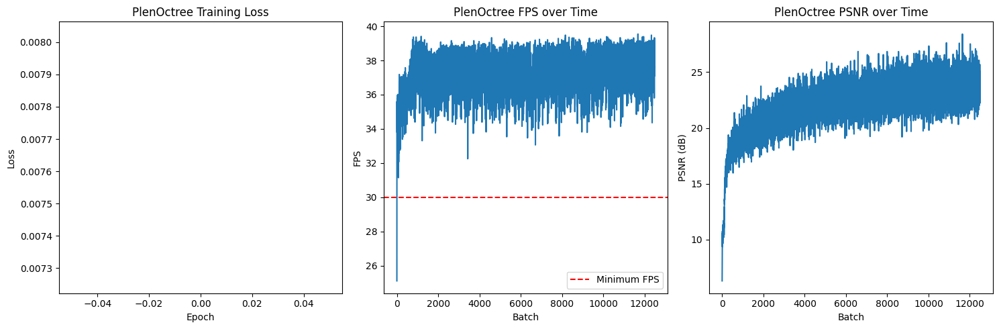

PlenOctree Training Progress:  10%|█         | 12503/125000 [12:26<5:27:46,  5.72it/s]


PlenOctree Epoch 2/10, Batch 0:
FPS: 42.95, Latency: 23.28ms
PSNR: 24.26dB, Loss: 0.0037


PlenOctree Training Progress:  10%|█         | 12513/125000 [12:27<2:25:43, 12.87it/s]


PlenOctree Epoch 2/10, Batch 10:
FPS: 38.76, Latency: 25.80ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  10%|█         | 12523/125000 [12:27<1:56:43, 16.06it/s]


PlenOctree Epoch 2/10, Batch 20:
FPS: 37.19, Latency: 26.89ms
PSNR: 21.86dB, Loss: 0.0065


PlenOctree Training Progress:  10%|█         | 12533/125000 [12:28<1:52:47, 16.62it/s]


PlenOctree Epoch 2/10, Batch 30:
FPS: 36.62, Latency: 27.31ms
PSNR: 23.40dB, Loss: 0.0046


PlenOctree Training Progress:  10%|█         | 12543/125000 [12:28<1:50:20, 16.99it/s]


PlenOctree Epoch 2/10, Batch 40:
FPS: 38.13, Latency: 26.23ms
PSNR: 23.03dB, Loss: 0.0050


PlenOctree Training Progress:  10%|█         | 12553/125000 [12:29<1:49:46, 17.07it/s]


PlenOctree Epoch 2/10, Batch 50:
FPS: 38.62, Latency: 25.89ms
PSNR: 22.32dB, Loss: 0.0059


PlenOctree Training Progress:  10%|█         | 12563/125000 [12:30<1:50:56, 16.89it/s]


PlenOctree Epoch 2/10, Batch 60:
FPS: 38.30, Latency: 26.11ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  10%|█         | 12573/125000 [12:30<1:50:14, 17.00it/s]


PlenOctree Epoch 2/10, Batch 70:
FPS: 38.26, Latency: 26.14ms
PSNR: 21.94dB, Loss: 0.0064


PlenOctree Training Progress:  10%|█         | 12583/125000 [12:31<1:50:23, 16.97it/s]


PlenOctree Epoch 2/10, Batch 80:
FPS: 37.98, Latency: 26.33ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  10%|█         | 12593/125000 [12:31<1:50:39, 16.93it/s]


PlenOctree Epoch 2/10, Batch 90:
FPS: 37.36, Latency: 26.76ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  10%|█         | 12603/125000 [12:32<1:50:30, 16.95it/s]


PlenOctree Epoch 2/10, Batch 100:
FPS: 37.90, Latency: 26.38ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  10%|█         | 12613/125000 [12:33<1:50:59, 16.88it/s]


PlenOctree Epoch 2/10, Batch 110:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  10%|█         | 12623/125000 [12:33<1:50:40, 16.92it/s]


PlenOctree Epoch 2/10, Batch 120:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  10%|█         | 12633/125000 [12:34<1:49:50, 17.05it/s]


PlenOctree Epoch 2/10, Batch 130:
FPS: 37.79, Latency: 26.46ms
PSNR: 22.53dB, Loss: 0.0056


PlenOctree Training Progress:  10%|█         | 12643/125000 [12:34<1:49:32, 17.10it/s]


PlenOctree Epoch 2/10, Batch 140:
FPS: 37.58, Latency: 26.61ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  10%|█         | 12653/125000 [12:35<1:49:38, 17.08it/s]


PlenOctree Epoch 2/10, Batch 150:
FPS: 38.87, Latency: 25.72ms
PSNR: 20.96dB, Loss: 0.0080


PlenOctree Training Progress:  10%|█         | 12663/125000 [12:35<1:49:36, 17.08it/s]


PlenOctree Epoch 2/10, Batch 160:
FPS: 38.45, Latency: 26.01ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  10%|█         | 12673/125000 [12:36<1:49:41, 17.07it/s]


PlenOctree Epoch 2/10, Batch 170:
FPS: 37.84, Latency: 26.43ms
PSNR: 23.53dB, Loss: 0.0044


PlenOctree Training Progress:  10%|█         | 12683/125000 [12:37<1:49:26, 17.11it/s]


PlenOctree Epoch 2/10, Batch 180:
FPS: 38.84, Latency: 25.74ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  10%|█         | 12693/125000 [12:37<1:49:12, 17.14it/s]


PlenOctree Epoch 2/10, Batch 190:
FPS: 37.67, Latency: 26.55ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:  10%|█         | 12703/125000 [12:38<1:49:49, 17.04it/s]


PlenOctree Epoch 2/10, Batch 200:
FPS: 39.13, Latency: 25.55ms
PSNR: 23.00dB, Loss: 0.0050


PlenOctree Training Progress:  10%|█         | 12713/125000 [12:38<1:50:24, 16.95it/s]


PlenOctree Epoch 2/10, Batch 210:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  10%|█         | 12723/125000 [12:39<1:50:45, 16.90it/s]


PlenOctree Epoch 2/10, Batch 220:
FPS: 37.88, Latency: 26.40ms
PSNR: 23.16dB, Loss: 0.0048


PlenOctree Training Progress:  10%|█         | 12733/125000 [12:40<1:50:38, 16.91it/s]


PlenOctree Epoch 2/10, Batch 230:
FPS: 37.56, Latency: 26.63ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  10%|█         | 12743/125000 [12:40<1:51:26, 16.79it/s]


PlenOctree Epoch 2/10, Batch 240:
FPS: 37.03, Latency: 27.00ms
PSNR: 22.34dB, Loss: 0.0058


PlenOctree Training Progress:  10%|█         | 12753/125000 [12:41<1:51:56, 16.71it/s]


PlenOctree Epoch 2/10, Batch 250:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  10%|█         | 12763/125000 [12:41<1:50:54, 16.87it/s]


PlenOctree Epoch 2/10, Batch 260:
FPS: 37.86, Latency: 26.41ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  10%|█         | 12773/125000 [12:42<1:50:49, 16.88it/s]


PlenOctree Epoch 2/10, Batch 270:
FPS: 37.40, Latency: 26.74ms
PSNR: 23.56dB, Loss: 0.0044


PlenOctree Training Progress:  10%|█         | 12783/125000 [12:43<1:50:44, 16.89it/s]


PlenOctree Epoch 2/10, Batch 280:
FPS: 37.47, Latency: 26.69ms
PSNR: 22.22dB, Loss: 0.0060


PlenOctree Training Progress:  10%|█         | 12793/125000 [12:43<1:50:37, 16.91it/s]


PlenOctree Epoch 2/10, Batch 290:
FPS: 37.29, Latency: 26.82ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:  10%|█         | 12803/125000 [12:44<1:50:44, 16.89it/s]


PlenOctree Epoch 2/10, Batch 300:
FPS: 37.03, Latency: 27.01ms
PSNR: 21.71dB, Loss: 0.0068


PlenOctree Training Progress:  10%|█         | 12813/125000 [12:44<1:50:26, 16.93it/s]


PlenOctree Epoch 2/10, Batch 310:
FPS: 37.46, Latency: 26.69ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  10%|█         | 12823/125000 [12:45<1:50:28, 16.92it/s]


PlenOctree Epoch 2/10, Batch 320:
FPS: 37.39, Latency: 26.75ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  10%|█         | 12833/125000 [12:45<1:50:30, 16.92it/s]


PlenOctree Epoch 2/10, Batch 330:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  10%|█         | 12843/125000 [12:46<1:50:35, 16.90it/s]


PlenOctree Epoch 2/10, Batch 340:
FPS: 37.35, Latency: 26.77ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  10%|█         | 12853/125000 [12:47<1:50:19, 16.94it/s]


PlenOctree Epoch 2/10, Batch 350:
FPS: 37.45, Latency: 26.70ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  10%|█         | 12863/125000 [12:47<1:50:04, 16.98it/s]


PlenOctree Epoch 2/10, Batch 360:
FPS: 36.47, Latency: 27.42ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  10%|█         | 12873/125000 [12:48<1:49:54, 17.00it/s]


PlenOctree Epoch 2/10, Batch 370:
FPS: 37.76, Latency: 26.49ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  10%|█         | 12883/125000 [12:48<1:49:46, 17.02it/s]


PlenOctree Epoch 2/10, Batch 380:
FPS: 37.81, Latency: 26.45ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  10%|█         | 12893/125000 [12:49<1:49:36, 17.05it/s]


PlenOctree Epoch 2/10, Batch 390:
FPS: 38.15, Latency: 26.21ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  10%|█         | 12903/125000 [12:50<1:49:50, 17.01it/s]


PlenOctree Epoch 2/10, Batch 400:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  10%|█         | 12913/125000 [12:50<1:49:45, 17.02it/s]


PlenOctree Epoch 2/10, Batch 410:
FPS: 37.65, Latency: 26.56ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  10%|█         | 12923/125000 [12:51<1:49:26, 17.07it/s]


PlenOctree Epoch 2/10, Batch 420:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:  10%|█         | 12933/125000 [12:51<1:49:46, 17.02it/s]


PlenOctree Epoch 2/10, Batch 430:
FPS: 36.89, Latency: 27.11ms
PSNR: 22.98dB, Loss: 0.0050


PlenOctree Training Progress:  10%|█         | 12943/125000 [12:52<1:50:08, 16.96it/s]


PlenOctree Epoch 2/10, Batch 440:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  10%|█         | 12953/125000 [12:53<1:50:31, 16.90it/s]


PlenOctree Epoch 2/10, Batch 450:
FPS: 38.45, Latency: 26.01ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  10%|█         | 12963/125000 [12:53<1:49:47, 17.01it/s]


PlenOctree Epoch 2/10, Batch 460:
FPS: 37.23, Latency: 26.86ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  10%|█         | 12973/125000 [12:54<1:51:22, 16.77it/s]


PlenOctree Epoch 2/10, Batch 470:
FPS: 37.27, Latency: 26.83ms
PSNR: 23.82dB, Loss: 0.0041


PlenOctree Training Progress:  10%|█         | 12983/125000 [12:54<1:49:56, 16.98it/s]


PlenOctree Epoch 2/10, Batch 480:
FPS: 37.28, Latency: 26.82ms
PSNR: 22.93dB, Loss: 0.0051


PlenOctree Training Progress:  10%|█         | 12993/125000 [12:55<1:49:47, 17.00it/s]


PlenOctree Epoch 2/10, Batch 490:
FPS: 37.58, Latency: 26.61ms
PSNR: 23.70dB, Loss: 0.0043


PlenOctree Training Progress:  10%|█         | 13003/125000 [12:56<1:49:29, 17.05it/s]


PlenOctree Epoch 2/10, Batch 500:
FPS: 39.10, Latency: 25.58ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  10%|█         | 13013/125000 [12:56<1:49:41, 17.02it/s]


PlenOctree Epoch 2/10, Batch 510:
FPS: 38.47, Latency: 25.99ms
PSNR: 23.23dB, Loss: 0.0047


PlenOctree Training Progress:  10%|█         | 13023/125000 [12:57<1:49:14, 17.08it/s]


PlenOctree Epoch 2/10, Batch 520:
FPS: 38.71, Latency: 25.83ms
PSNR: 24.04dB, Loss: 0.0039


PlenOctree Training Progress:  10%|█         | 13033/125000 [12:57<1:49:20, 17.07it/s]


PlenOctree Epoch 2/10, Batch 530:
FPS: 38.80, Latency: 25.77ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:  10%|█         | 13043/125000 [12:58<1:49:53, 16.98it/s]


PlenOctree Epoch 2/10, Batch 540:
FPS: 38.12, Latency: 26.23ms
PSNR: 23.07dB, Loss: 0.0049


PlenOctree Training Progress:  10%|█         | 13053/125000 [12:58<1:50:20, 16.91it/s]


PlenOctree Epoch 2/10, Batch 550:
FPS: 38.25, Latency: 26.14ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  10%|█         | 13063/125000 [12:59<1:50:36, 16.87it/s]


PlenOctree Epoch 2/10, Batch 560:
FPS: 37.17, Latency: 26.91ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:  10%|█         | 13073/125000 [13:00<1:49:26, 17.04it/s]


PlenOctree Epoch 2/10, Batch 570:
FPS: 37.89, Latency: 26.39ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  10%|█         | 13083/125000 [13:00<1:50:25, 16.89it/s]


PlenOctree Epoch 2/10, Batch 580:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  10%|█         | 13093/125000 [13:01<1:49:25, 17.04it/s]


PlenOctree Epoch 2/10, Batch 590:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  10%|█         | 13103/125000 [13:01<1:49:17, 17.07it/s]


PlenOctree Epoch 2/10, Batch 600:
FPS: 38.16, Latency: 26.21ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  10%|█         | 13113/125000 [13:02<1:48:58, 17.11it/s]


PlenOctree Epoch 2/10, Batch 610:
FPS: 37.63, Latency: 26.58ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  10%|█         | 13123/125000 [13:03<1:49:31, 17.02it/s]


PlenOctree Epoch 2/10, Batch 620:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13133/125000 [13:03<1:50:44, 16.84it/s]


PlenOctree Epoch 2/10, Batch 630:
FPS: 37.62, Latency: 26.58ms
PSNR: 21.43dB, Loss: 0.0072


PlenOctree Training Progress:  11%|█         | 13143/125000 [13:04<1:50:28, 16.88it/s]


PlenOctree Epoch 2/10, Batch 640:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 13153/125000 [13:04<1:50:33, 16.86it/s]


PlenOctree Epoch 2/10, Batch 650:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█         | 13163/125000 [13:05<1:49:41, 16.99it/s]


PlenOctree Epoch 2/10, Batch 660:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  11%|█         | 13173/125000 [13:06<1:49:47, 16.98it/s]


PlenOctree Epoch 2/10, Batch 670:
FPS: 38.58, Latency: 25.92ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  11%|█         | 13183/125000 [13:06<1:49:34, 17.01it/s]


PlenOctree Epoch 2/10, Batch 680:
FPS: 38.71, Latency: 25.83ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█         | 13193/125000 [13:07<1:50:50, 16.81it/s]


PlenOctree Epoch 2/10, Batch 690:
FPS: 37.77, Latency: 26.48ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 13203/125000 [13:07<1:50:27, 16.87it/s]


PlenOctree Epoch 2/10, Batch 700:
FPS: 37.69, Latency: 26.53ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:  11%|█         | 13213/125000 [13:08<1:49:31, 17.01it/s]


PlenOctree Epoch 2/10, Batch 710:
FPS: 37.56, Latency: 26.62ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 13223/125000 [13:08<1:49:16, 17.05it/s]


PlenOctree Epoch 2/10, Batch 720:
FPS: 37.72, Latency: 26.51ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:  11%|█         | 13233/125000 [13:09<1:48:59, 17.09it/s]


PlenOctree Epoch 2/10, Batch 730:
FPS: 38.60, Latency: 25.91ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  11%|█         | 13243/125000 [13:10<1:49:05, 17.07it/s]


PlenOctree Epoch 2/10, Batch 740:
FPS: 38.87, Latency: 25.73ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  11%|█         | 13253/125000 [13:10<1:49:17, 17.04it/s]


PlenOctree Epoch 2/10, Batch 750:
FPS: 38.15, Latency: 26.21ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  11%|█         | 13263/125000 [13:11<1:50:34, 16.84it/s]


PlenOctree Epoch 2/10, Batch 760:
FPS: 38.88, Latency: 25.72ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:  11%|█         | 13273/125000 [13:11<1:49:34, 16.99it/s]


PlenOctree Epoch 2/10, Batch 770:
FPS: 38.14, Latency: 26.22ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:  11%|█         | 13283/125000 [13:12<1:50:38, 16.83it/s]


PlenOctree Epoch 2/10, Batch 780:
FPS: 36.84, Latency: 27.14ms
PSNR: 22.97dB, Loss: 0.0050


PlenOctree Training Progress:  11%|█         | 13293/125000 [13:13<1:49:52, 16.94it/s]


PlenOctree Epoch 2/10, Batch 790:
FPS: 37.73, Latency: 26.51ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  11%|█         | 13303/125000 [13:13<1:49:14, 17.04it/s]


PlenOctree Epoch 2/10, Batch 800:
FPS: 37.94, Latency: 26.35ms
PSNR: 23.13dB, Loss: 0.0049


PlenOctree Training Progress:  11%|█         | 13313/125000 [13:14<1:49:19, 17.03it/s]


PlenOctree Epoch 2/10, Batch 810:
FPS: 37.74, Latency: 26.50ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█         | 13323/125000 [13:14<1:49:31, 16.99it/s]


PlenOctree Epoch 2/10, Batch 820:
FPS: 37.69, Latency: 26.53ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█         | 13333/125000 [13:15<1:50:28, 16.85it/s]


PlenOctree Epoch 2/10, Batch 830:
FPS: 37.62, Latency: 26.58ms
PSNR: 23.53dB, Loss: 0.0044


PlenOctree Training Progress:  11%|█         | 13343/125000 [13:16<1:49:38, 16.97it/s]


PlenOctree Epoch 2/10, Batch 840:
FPS: 38.56, Latency: 25.93ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 13353/125000 [13:16<1:50:26, 16.85it/s]


PlenOctree Epoch 2/10, Batch 850:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.17dB, Loss: 0.0048


PlenOctree Training Progress:  11%|█         | 13363/125000 [13:17<1:49:47, 16.95it/s]


PlenOctree Epoch 2/10, Batch 860:
FPS: 37.14, Latency: 26.92ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  11%|█         | 13373/125000 [13:17<1:49:51, 16.93it/s]


PlenOctree Epoch 2/10, Batch 870:
FPS: 36.89, Latency: 27.11ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 13383/125000 [13:18<1:49:19, 17.02it/s]


PlenOctree Epoch 2/10, Batch 880:
FPS: 38.28, Latency: 26.12ms
PSNR: 22.20dB, Loss: 0.0060


PlenOctree Training Progress:  11%|█         | 13393/125000 [13:19<1:48:28, 17.15it/s]


PlenOctree Epoch 2/10, Batch 890:
FPS: 38.09, Latency: 26.26ms
PSNR: 21.21dB, Loss: 0.0076


PlenOctree Training Progress:  11%|█         | 13403/125000 [13:19<1:48:46, 17.10it/s]


PlenOctree Epoch 2/10, Batch 900:
FPS: 38.67, Latency: 25.86ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 13413/125000 [13:20<1:48:56, 17.07it/s]


PlenOctree Epoch 2/10, Batch 910:
FPS: 39.05, Latency: 25.61ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 13423/125000 [13:20<1:49:21, 17.01it/s]


PlenOctree Epoch 2/10, Batch 920:
FPS: 38.62, Latency: 25.90ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  11%|█         | 13433/125000 [13:21<1:50:46, 16.79it/s]


PlenOctree Epoch 2/10, Batch 930:
FPS: 36.02, Latency: 27.76ms
PSNR: 21.80dB, Loss: 0.0066


PlenOctree Training Progress:  11%|█         | 13443/125000 [13:21<1:49:38, 16.96it/s]


PlenOctree Epoch 2/10, Batch 940:
FPS: 37.18, Latency: 26.90ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:  11%|█         | 13453/125000 [13:22<1:50:07, 16.88it/s]


PlenOctree Epoch 2/10, Batch 950:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13463/125000 [13:23<1:49:01, 17.05it/s]


PlenOctree Epoch 2/10, Batch 960:
FPS: 38.63, Latency: 25.88ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  11%|█         | 13473/125000 [13:23<1:48:54, 17.07it/s]


PlenOctree Epoch 2/10, Batch 970:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.24dB, Loss: 0.0047


PlenOctree Training Progress:  11%|█         | 13483/125000 [13:24<1:48:57, 17.06it/s]


PlenOctree Epoch 2/10, Batch 980:
FPS: 37.91, Latency: 26.38ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 13493/125000 [13:24<1:48:55, 17.06it/s]


PlenOctree Epoch 2/10, Batch 990:
FPS: 38.54, Latency: 25.95ms
PSNR: 21.68dB, Loss: 0.0068


PlenOctree Training Progress:  11%|█         | 13503/125000 [13:25<1:50:35, 16.80it/s]


PlenOctree Epoch 2/10, Batch 1000:
FPS: 37.00, Latency: 27.03ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█         | 13513/125000 [13:26<1:50:13, 16.86it/s]


PlenOctree Epoch 2/10, Batch 1010:
FPS: 36.94, Latency: 27.07ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  11%|█         | 13523/125000 [13:26<1:50:06, 16.87it/s]


PlenOctree Epoch 2/10, Batch 1020:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  11%|█         | 13533/125000 [13:27<1:49:39, 16.94it/s]


PlenOctree Epoch 2/10, Batch 1030:
FPS: 36.68, Latency: 27.26ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:  11%|█         | 13543/125000 [13:27<1:48:54, 17.06it/s]


PlenOctree Epoch 2/10, Batch 1040:
FPS: 38.69, Latency: 25.85ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13553/125000 [13:28<1:48:58, 17.04it/s]


PlenOctree Epoch 2/10, Batch 1050:
FPS: 37.53, Latency: 26.64ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  11%|█         | 13563/125000 [13:29<1:48:37, 17.10it/s]


PlenOctree Epoch 2/10, Batch 1060:
FPS: 37.50, Latency: 26.66ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:  11%|█         | 13573/125000 [13:29<1:49:47, 16.92it/s]


PlenOctree Epoch 2/10, Batch 1070:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13583/125000 [13:30<1:50:11, 16.85it/s]


PlenOctree Epoch 2/10, Batch 1080:
FPS: 37.10, Latency: 26.95ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:  11%|█         | 13593/125000 [13:30<1:49:58, 16.88it/s]


PlenOctree Epoch 2/10, Batch 1090:
FPS: 36.62, Latency: 27.31ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:  11%|█         | 13603/125000 [13:31<1:49:47, 16.91it/s]


PlenOctree Epoch 2/10, Batch 1100:
FPS: 37.16, Latency: 26.91ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 13613/125000 [13:31<1:49:09, 17.01it/s]


PlenOctree Epoch 2/10, Batch 1110:
FPS: 38.22, Latency: 26.16ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 13623/125000 [13:32<1:49:15, 16.99it/s]


PlenOctree Epoch 2/10, Batch 1120:
FPS: 37.75, Latency: 26.49ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:  11%|█         | 13633/125000 [13:33<1:49:39, 16.93it/s]


PlenOctree Epoch 2/10, Batch 1130:
FPS: 37.35, Latency: 26.78ms
PSNR: 21.88dB, Loss: 0.0065


PlenOctree Training Progress:  11%|█         | 13643/125000 [13:33<1:49:32, 16.94it/s]


PlenOctree Epoch 2/10, Batch 1140:
FPS: 36.71, Latency: 27.24ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13653/125000 [13:34<1:48:56, 17.03it/s]


PlenOctree Epoch 2/10, Batch 1150:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  11%|█         | 13663/125000 [13:34<1:48:49, 17.05it/s]


PlenOctree Epoch 2/10, Batch 1160:
FPS: 36.67, Latency: 27.27ms
PSNR: 23.89dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 13673/125000 [13:35<1:48:25, 17.11it/s]


PlenOctree Epoch 2/10, Batch 1170:
FPS: 38.79, Latency: 25.78ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13683/125000 [13:36<1:48:14, 17.14it/s]


PlenOctree Epoch 2/10, Batch 1180:
FPS: 37.65, Latency: 26.56ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  11%|█         | 13693/125000 [13:36<1:48:14, 17.14it/s]


PlenOctree Epoch 2/10, Batch 1190:
FPS: 38.77, Latency: 25.79ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  11%|█         | 13703/125000 [13:37<1:48:41, 17.07it/s]


PlenOctree Epoch 2/10, Batch 1200:
FPS: 38.18, Latency: 26.19ms
PSNR: 22.68dB, Loss: 0.0054


PlenOctree Training Progress:  11%|█         | 13713/125000 [13:37<1:48:44, 17.06it/s]


PlenOctree Epoch 2/10, Batch 1210:
FPS: 38.50, Latency: 25.97ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:  11%|█         | 13723/125000 [13:38<1:50:15, 16.82it/s]


PlenOctree Epoch 2/10, Batch 1220:
FPS: 38.32, Latency: 26.10ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 13733/125000 [13:39<1:49:43, 16.90it/s]


PlenOctree Epoch 2/10, Batch 1230:
FPS: 38.42, Latency: 26.03ms
PSNR: 22.80dB, Loss: 0.0052


PlenOctree Training Progress:  11%|█         | 13743/125000 [13:39<1:49:45, 16.89it/s]


PlenOctree Epoch 2/10, Batch 1240:
FPS: 36.88, Latency: 27.11ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 13753/125000 [13:40<1:49:38, 16.91it/s]


PlenOctree Epoch 2/10, Batch 1250:
FPS: 35.10, Latency: 28.49ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 13763/125000 [13:40<1:48:53, 17.03it/s]


PlenOctree Epoch 2/10, Batch 1260:
FPS: 36.41, Latency: 27.47ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 13773/125000 [13:41<1:50:28, 16.78it/s]


PlenOctree Epoch 2/10, Batch 1270:
FPS: 38.27, Latency: 26.13ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13783/125000 [13:42<1:50:06, 16.83it/s]


PlenOctree Epoch 2/10, Batch 1280:
FPS: 37.07, Latency: 26.97ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  11%|█         | 13793/125000 [13:42<1:49:39, 16.90it/s]


PlenOctree Epoch 2/10, Batch 1290:
FPS: 37.40, Latency: 26.74ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  11%|█         | 13803/125000 [13:43<1:49:10, 16.98it/s]


PlenOctree Epoch 2/10, Batch 1300:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█         | 13813/125000 [13:43<1:48:27, 17.09it/s]


PlenOctree Epoch 2/10, Batch 1310:
FPS: 37.97, Latency: 26.34ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 13823/125000 [13:44<1:48:41, 17.05it/s]


PlenOctree Epoch 2/10, Batch 1320:
FPS: 38.42, Latency: 26.03ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█         | 13833/125000 [13:44<1:48:31, 17.07it/s]


PlenOctree Epoch 2/10, Batch 1330:
FPS: 38.32, Latency: 26.10ms
PSNR: 22.21dB, Loss: 0.0060


PlenOctree Training Progress:  11%|█         | 13843/125000 [13:45<1:48:30, 17.07it/s]


PlenOctree Epoch 2/10, Batch 1340:
FPS: 38.33, Latency: 26.09ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█         | 13853/125000 [13:46<1:48:58, 17.00it/s]


PlenOctree Epoch 2/10, Batch 1350:
FPS: 37.96, Latency: 26.34ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:  11%|█         | 13863/125000 [13:46<1:48:47, 17.03it/s]


PlenOctree Epoch 2/10, Batch 1360:
FPS: 37.53, Latency: 26.64ms
PSNR: 21.99dB, Loss: 0.0063


PlenOctree Training Progress:  11%|█         | 13873/125000 [13:47<1:48:47, 17.02it/s]


PlenOctree Epoch 2/10, Batch 1370:
FPS: 38.13, Latency: 26.22ms
PSNR: 21.95dB, Loss: 0.0064


PlenOctree Training Progress:  11%|█         | 13883/125000 [13:47<1:48:18, 17.10it/s]


PlenOctree Epoch 2/10, Batch 1380:
FPS: 37.93, Latency: 26.36ms
PSNR: 23.05dB, Loss: 0.0050


PlenOctree Training Progress:  11%|█         | 13893/125000 [13:48<1:49:03, 16.98it/s]


PlenOctree Epoch 2/10, Batch 1390:
FPS: 38.02, Latency: 26.30ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  11%|█         | 13903/125000 [13:49<1:48:40, 17.04it/s]


PlenOctree Epoch 2/10, Batch 1400:
FPS: 37.54, Latency: 26.64ms
PSNR: 21.08dB, Loss: 0.0078


PlenOctree Training Progress:  11%|█         | 13913/125000 [13:49<1:48:09, 17.12it/s]


PlenOctree Epoch 2/10, Batch 1410:
FPS: 37.03, Latency: 27.00ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█         | 13923/125000 [13:50<1:48:13, 17.11it/s]


PlenOctree Epoch 2/10, Batch 1420:
FPS: 36.61, Latency: 27.32ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█         | 13933/125000 [13:50<1:48:25, 17.07it/s]


PlenOctree Epoch 2/10, Batch 1430:
FPS: 37.15, Latency: 26.92ms
PSNR: 23.00dB, Loss: 0.0050


PlenOctree Training Progress:  11%|█         | 13943/125000 [13:51<1:48:03, 17.13it/s]


PlenOctree Epoch 2/10, Batch 1440:
FPS: 37.90, Latency: 26.39ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  11%|█         | 13953/125000 [13:52<1:48:26, 17.07it/s]


PlenOctree Epoch 2/10, Batch 1450:
FPS: 38.75, Latency: 25.80ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  11%|█         | 13963/125000 [13:52<1:49:37, 16.88it/s]


PlenOctree Epoch 2/10, Batch 1460:
FPS: 38.06, Latency: 26.28ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 13973/125000 [13:53<1:49:39, 16.87it/s]


PlenOctree Epoch 2/10, Batch 1470:
FPS: 37.99, Latency: 26.32ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█         | 13983/125000 [13:53<1:49:46, 16.85it/s]


PlenOctree Epoch 2/10, Batch 1480:
FPS: 36.56, Latency: 27.35ms
PSNR: 22.25dB, Loss: 0.0060


PlenOctree Training Progress:  11%|█         | 13993/125000 [13:54<1:49:07, 16.96it/s]


PlenOctree Epoch 2/10, Batch 1490:
FPS: 37.58, Latency: 26.61ms
PSNR: 23.55dB, Loss: 0.0044


PlenOctree Training Progress:  11%|█         | 14003/125000 [13:54<1:49:26, 16.90it/s]


PlenOctree Epoch 2/10, Batch 1500:
FPS: 36.94, Latency: 27.07ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█         | 14013/125000 [13:55<1:49:22, 16.91it/s]


PlenOctree Epoch 2/10, Batch 1510:
FPS: 37.50, Latency: 26.66ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 14023/125000 [13:56<1:49:08, 16.95it/s]


PlenOctree Epoch 2/10, Batch 1520:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.12dB, Loss: 0.0049


PlenOctree Training Progress:  11%|█         | 14033/125000 [13:56<1:48:34, 17.03it/s]


PlenOctree Epoch 2/10, Batch 1530:
FPS: 37.48, Latency: 26.68ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█         | 14043/125000 [13:57<1:48:10, 17.09it/s]


PlenOctree Epoch 2/10, Batch 1540:
FPS: 37.87, Latency: 26.40ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█         | 14053/125000 [13:57<1:48:03, 17.11it/s]


PlenOctree Epoch 2/10, Batch 1550:
FPS: 38.65, Latency: 25.87ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  11%|█▏        | 14063/125000 [13:58<1:48:07, 17.10it/s]


PlenOctree Epoch 2/10, Batch 1560:
FPS: 38.54, Latency: 25.94ms
PSNR: 22.36dB, Loss: 0.0058


PlenOctree Training Progress:  11%|█▏        | 14073/125000 [13:59<1:48:07, 17.10it/s]


PlenOctree Epoch 2/10, Batch 1570:
FPS: 38.17, Latency: 26.20ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  11%|█▏        | 14083/125000 [13:59<1:48:28, 17.04it/s]


PlenOctree Epoch 2/10, Batch 1580:
FPS: 38.86, Latency: 25.73ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█▏        | 14093/125000 [14:00<1:48:46, 16.99it/s]


PlenOctree Epoch 2/10, Batch 1590:
FPS: 37.92, Latency: 26.37ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█▏        | 14103/125000 [14:00<1:49:07, 16.94it/s]


PlenOctree Epoch 2/10, Batch 1600:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  11%|█▏        | 14113/125000 [14:01<1:48:58, 16.96it/s]


PlenOctree Epoch 2/10, Batch 1610:
FPS: 38.76, Latency: 25.80ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  11%|█▏        | 14123/125000 [14:02<1:49:23, 16.89it/s]


PlenOctree Epoch 2/10, Batch 1620:
FPS: 37.93, Latency: 26.37ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:  11%|█▏        | 14133/125000 [14:02<1:48:18, 17.06it/s]


PlenOctree Epoch 2/10, Batch 1630:
FPS: 38.41, Latency: 26.03ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  11%|█▏        | 14143/125000 [14:03<1:48:43, 16.99it/s]


PlenOctree Epoch 2/10, Batch 1640:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█▏        | 14153/125000 [14:03<1:48:29, 17.03it/s]


PlenOctree Epoch 2/10, Batch 1650:
FPS: 37.95, Latency: 26.35ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  11%|█▏        | 14163/125000 [14:04<1:48:29, 17.03it/s]


PlenOctree Epoch 2/10, Batch 1660:
FPS: 37.00, Latency: 27.02ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  11%|█▏        | 14173/125000 [14:04<1:49:40, 16.84it/s]


PlenOctree Epoch 2/10, Batch 1670:
FPS: 37.15, Latency: 26.92ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  11%|█▏        | 14183/125000 [14:05<1:48:58, 16.95it/s]


PlenOctree Epoch 2/10, Batch 1680:
FPS: 38.22, Latency: 26.17ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:  11%|█▏        | 14193/125000 [14:06<1:49:17, 16.90it/s]


PlenOctree Epoch 2/10, Batch 1690:
FPS: 38.04, Latency: 26.29ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  11%|█▏        | 14203/125000 [14:06<1:48:30, 17.02it/s]


PlenOctree Epoch 2/10, Batch 1700:
FPS: 37.60, Latency: 26.60ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  11%|█▏        | 14213/125000 [14:07<1:48:28, 17.02it/s]


PlenOctree Epoch 2/10, Batch 1710:
FPS: 38.01, Latency: 26.31ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  11%|█▏        | 14223/125000 [14:07<1:48:04, 17.08it/s]


PlenOctree Epoch 2/10, Batch 1720:
FPS: 38.04, Latency: 26.29ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  11%|█▏        | 14233/125000 [14:08<1:47:49, 17.12it/s]


PlenOctree Epoch 2/10, Batch 1730:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  11%|█▏        | 14243/125000 [14:09<1:47:52, 17.11it/s]


PlenOctree Epoch 2/10, Batch 1740:
FPS: 38.49, Latency: 25.98ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  11%|█▏        | 14253/125000 [14:09<1:48:41, 16.98it/s]


PlenOctree Epoch 2/10, Batch 1750:
FPS: 38.79, Latency: 25.78ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  11%|█▏        | 14263/125000 [14:10<1:49:25, 16.87it/s]


PlenOctree Epoch 2/10, Batch 1760:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  11%|█▏        | 14273/125000 [14:10<1:49:03, 16.92it/s]


PlenOctree Epoch 2/10, Batch 1770:
FPS: 37.22, Latency: 26.87ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█▏        | 14283/125000 [14:11<1:49:24, 16.87it/s]


PlenOctree Epoch 2/10, Batch 1780:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  11%|█▏        | 14293/125000 [14:12<1:48:49, 16.96it/s]


PlenOctree Epoch 2/10, Batch 1790:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.13dB, Loss: 0.0061


PlenOctree Training Progress:  11%|█▏        | 14303/125000 [14:12<1:48:45, 16.96it/s]


PlenOctree Epoch 2/10, Batch 1800:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  11%|█▏        | 14313/125000 [14:13<1:48:43, 16.97it/s]


PlenOctree Epoch 2/10, Batch 1810:
FPS: 37.57, Latency: 26.62ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█▏        | 14323/125000 [14:13<1:48:59, 16.92it/s]


PlenOctree Epoch 2/10, Batch 1820:
FPS: 36.21, Latency: 27.62ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:  11%|█▏        | 14333/125000 [14:14<1:48:35, 16.98it/s]


PlenOctree Epoch 2/10, Batch 1830:
FPS: 36.67, Latency: 27.27ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  11%|█▏        | 14343/125000 [14:14<1:48:49, 16.95it/s]


PlenOctree Epoch 2/10, Batch 1840:
FPS: 37.29, Latency: 26.82ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  11%|█▏        | 14353/125000 [14:15<1:47:58, 17.08it/s]


PlenOctree Epoch 2/10, Batch 1850:
FPS: 36.52, Latency: 27.39ms
PSNR: 24.04dB, Loss: 0.0039


PlenOctree Training Progress:  11%|█▏        | 14363/125000 [14:16<1:47:43, 17.12it/s]


PlenOctree Epoch 2/10, Batch 1860:
FPS: 38.27, Latency: 26.13ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:  11%|█▏        | 14373/125000 [14:16<1:48:43, 16.96it/s]


PlenOctree Epoch 2/10, Batch 1870:
FPS: 37.53, Latency: 26.64ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  12%|█▏        | 14383/125000 [14:17<1:49:10, 16.89it/s]


PlenOctree Epoch 2/10, Batch 1880:
FPS: 37.56, Latency: 26.63ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  12%|█▏        | 14393/125000 [14:17<1:49:34, 16.82it/s]


PlenOctree Epoch 2/10, Batch 1890:
FPS: 36.74, Latency: 27.22ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  12%|█▏        | 14403/125000 [14:18<1:49:08, 16.89it/s]


PlenOctree Epoch 2/10, Batch 1900:
FPS: 36.22, Latency: 27.61ms
PSNR: 21.69dB, Loss: 0.0068


PlenOctree Training Progress:  12%|█▏        | 14413/125000 [14:19<1:48:18, 17.02it/s]


PlenOctree Epoch 2/10, Batch 1910:
FPS: 37.46, Latency: 26.69ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  12%|█▏        | 14423/125000 [14:19<1:47:59, 17.06it/s]


PlenOctree Epoch 2/10, Batch 1920:
FPS: 37.61, Latency: 26.59ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  12%|█▏        | 14433/125000 [14:20<1:47:38, 17.12it/s]


PlenOctree Epoch 2/10, Batch 1930:
FPS: 38.52, Latency: 25.96ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  12%|█▏        | 14443/125000 [14:20<1:47:35, 17.13it/s]


PlenOctree Epoch 2/10, Batch 1940:
FPS: 38.15, Latency: 26.21ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  12%|█▏        | 14453/125000 [14:21<1:47:16, 17.17it/s]


PlenOctree Epoch 2/10, Batch 1950:
FPS: 38.40, Latency: 26.04ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  12%|█▏        | 14463/125000 [14:22<1:47:58, 17.06it/s]


PlenOctree Epoch 2/10, Batch 1960:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  12%|█▏        | 14473/125000 [14:22<1:47:57, 17.06it/s]


PlenOctree Epoch 2/10, Batch 1970:
FPS: 38.28, Latency: 26.12ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 14483/125000 [14:23<1:48:26, 16.99it/s]


PlenOctree Epoch 2/10, Batch 1980:
FPS: 37.45, Latency: 26.70ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  12%|█▏        | 14493/125000 [14:23<1:48:16, 17.01it/s]


PlenOctree Epoch 2/10, Batch 1990:
FPS: 38.45, Latency: 26.01ms
PSNR: 22.35dB, Loss: 0.0058


PlenOctree Training Progress:  12%|█▏        | 14503/125000 [14:24<1:48:29, 16.97it/s]


PlenOctree Epoch 2/10, Batch 2000:
FPS: 38.48, Latency: 25.99ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  12%|█▏        | 14513/125000 [14:24<1:48:48, 16.92it/s]


PlenOctree Epoch 2/10, Batch 2010:
FPS: 37.82, Latency: 26.44ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  12%|█▏        | 14523/125000 [14:25<1:48:36, 16.95it/s]


PlenOctree Epoch 2/10, Batch 2020:
FPS: 38.25, Latency: 26.15ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 14533/125000 [14:26<1:49:01, 16.89it/s]


PlenOctree Epoch 2/10, Batch 2030:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  12%|█▏        | 14543/125000 [14:26<1:48:53, 16.90it/s]


PlenOctree Epoch 2/10, Batch 2040:
FPS: 36.76, Latency: 27.20ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:  12%|█▏        | 14553/125000 [14:27<1:48:03, 17.03it/s]


PlenOctree Epoch 2/10, Batch 2050:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  12%|█▏        | 14563/125000 [14:27<1:47:45, 17.08it/s]


PlenOctree Epoch 2/10, Batch 2060:
FPS: 37.47, Latency: 26.68ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  12%|█▏        | 14573/125000 [14:28<1:48:50, 16.91it/s]


PlenOctree Epoch 2/10, Batch 2070:
FPS: 38.07, Latency: 26.27ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  12%|█▏        | 14583/125000 [14:29<1:49:55, 16.74it/s]


PlenOctree Epoch 2/10, Batch 2080:
FPS: 37.99, Latency: 26.33ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:  12%|█▏        | 14593/125000 [14:29<1:48:51, 16.90it/s]


PlenOctree Epoch 2/10, Batch 2090:
FPS: 35.54, Latency: 28.14ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:  12%|█▏        | 14603/125000 [14:30<1:48:04, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2100:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.21dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 14613/125000 [14:30<1:47:27, 17.12it/s]


PlenOctree Epoch 2/10, Batch 2110:
FPS: 37.26, Latency: 26.84ms
PSNR: 23.57dB, Loss: 0.0044


PlenOctree Training Progress:  12%|█▏        | 14623/125000 [14:31<1:48:35, 16.94it/s]


PlenOctree Epoch 2/10, Batch 2120:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  12%|█▏        | 14633/125000 [14:32<1:48:55, 16.89it/s]


PlenOctree Epoch 2/10, Batch 2130:
FPS: 38.65, Latency: 25.88ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  12%|█▏        | 14643/125000 [14:32<1:48:30, 16.95it/s]


PlenOctree Epoch 2/10, Batch 2140:
FPS: 37.90, Latency: 26.38ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  12%|█▏        | 14653/125000 [14:33<1:49:06, 16.86it/s]


PlenOctree Epoch 2/10, Batch 2150:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 14663/125000 [14:33<1:48:20, 16.97it/s]


PlenOctree Epoch 2/10, Batch 2160:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 14673/125000 [14:34<1:50:08, 16.69it/s]


PlenOctree Epoch 2/10, Batch 2170:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  12%|█▏        | 14683/125000 [14:35<1:47:58, 17.03it/s]


PlenOctree Epoch 2/10, Batch 2180:
FPS: 38.36, Latency: 26.07ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  12%|█▏        | 14693/125000 [14:35<1:48:58, 16.87it/s]


PlenOctree Epoch 2/10, Batch 2190:
FPS: 37.14, Latency: 26.92ms
PSNR: 24.28dB, Loss: 0.0037


PlenOctree Training Progress:  12%|█▏        | 14703/125000 [14:36<1:48:15, 16.98it/s]


PlenOctree Epoch 2/10, Batch 2200:
FPS: 37.41, Latency: 26.73ms
PSNR: 22.87dB, Loss: 0.0052


PlenOctree Training Progress:  12%|█▏        | 14713/125000 [14:36<1:48:50, 16.89it/s]


PlenOctree Epoch 2/10, Batch 2210:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:  12%|█▏        | 14723/125000 [14:37<1:48:13, 16.98it/s]


PlenOctree Epoch 2/10, Batch 2220:
FPS: 38.11, Latency: 26.24ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 14733/125000 [14:37<1:48:26, 16.95it/s]


PlenOctree Epoch 2/10, Batch 2230:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  12%|█▏        | 14743/125000 [14:38<1:48:34, 16.93it/s]


PlenOctree Epoch 2/10, Batch 2240:
FPS: 37.85, Latency: 26.42ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  12%|█▏        | 14753/125000 [14:39<1:48:36, 16.92it/s]


PlenOctree Epoch 2/10, Batch 2250:
FPS: 37.83, Latency: 26.43ms
PSNR: 22.62dB, Loss: 0.0055


PlenOctree Training Progress:  12%|█▏        | 14763/125000 [14:39<1:48:42, 16.90it/s]


PlenOctree Epoch 2/10, Batch 2260:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  12%|█▏        | 14773/125000 [14:40<1:48:20, 16.96it/s]


PlenOctree Epoch 2/10, Batch 2270:
FPS: 37.79, Latency: 26.46ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:  12%|█▏        | 14783/125000 [14:40<1:48:06, 16.99it/s]


PlenOctree Epoch 2/10, Batch 2280:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  12%|█▏        | 14793/125000 [14:41<1:47:36, 17.07it/s]


PlenOctree Epoch 2/10, Batch 2290:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  12%|█▏        | 14803/125000 [14:42<1:49:12, 16.82it/s]


PlenOctree Epoch 2/10, Batch 2300:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  12%|█▏        | 14813/125000 [14:42<1:48:15, 16.96it/s]


PlenOctree Epoch 2/10, Batch 2310:
FPS: 38.14, Latency: 26.22ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  12%|█▏        | 14823/125000 [14:43<1:48:54, 16.86it/s]


PlenOctree Epoch 2/10, Batch 2320:
FPS: 36.87, Latency: 27.12ms
PSNR: 22.52dB, Loss: 0.0056


PlenOctree Training Progress:  12%|█▏        | 14833/125000 [14:43<1:48:27, 16.93it/s]


PlenOctree Epoch 2/10, Batch 2330:
FPS: 37.40, Latency: 26.74ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:  12%|█▏        | 14843/125000 [14:44<1:47:51, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2340:
FPS: 37.29, Latency: 26.81ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:  12%|█▏        | 14853/125000 [14:45<1:47:42, 17.04it/s]


PlenOctree Epoch 2/10, Batch 2350:
FPS: 37.67, Latency: 26.54ms
PSNR: 23.31dB, Loss: 0.0047


PlenOctree Training Progress:  12%|█▏        | 14863/125000 [14:45<1:47:21, 17.10it/s]


PlenOctree Epoch 2/10, Batch 2360:
FPS: 38.65, Latency: 25.87ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  12%|█▏        | 14873/125000 [14:46<1:47:03, 17.15it/s]


PlenOctree Epoch 2/10, Batch 2370:
FPS: 37.14, Latency: 26.93ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:  12%|█▏        | 14883/125000 [14:46<1:47:13, 17.12it/s]


PlenOctree Epoch 2/10, Batch 2380:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  12%|█▏        | 14893/125000 [14:47<1:48:53, 16.85it/s]


PlenOctree Epoch 2/10, Batch 2390:
FPS: 38.55, Latency: 25.94ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  12%|█▏        | 14903/125000 [14:47<1:47:52, 17.01it/s]


PlenOctree Epoch 2/10, Batch 2400:
FPS: 37.67, Latency: 26.54ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:  12%|█▏        | 14913/125000 [14:48<1:48:44, 16.87it/s]


PlenOctree Epoch 2/10, Batch 2410:
FPS: 37.32, Latency: 26.79ms
PSNR: 23.25dB, Loss: 0.0047


PlenOctree Training Progress:  12%|█▏        | 14923/125000 [14:49<1:48:10, 16.96it/s]


PlenOctree Epoch 2/10, Batch 2420:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  12%|█▏        | 14933/125000 [14:49<1:48:46, 16.86it/s]


PlenOctree Epoch 2/10, Batch 2430:
FPS: 36.86, Latency: 27.13ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:  12%|█▏        | 14943/125000 [14:50<1:47:29, 17.07it/s]


PlenOctree Epoch 2/10, Batch 2440:
FPS: 37.16, Latency: 26.91ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  12%|█▏        | 14953/125000 [14:50<1:47:10, 17.11it/s]


PlenOctree Epoch 2/10, Batch 2450:
FPS: 38.44, Latency: 26.01ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:  12%|█▏        | 14963/125000 [14:51<1:47:44, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2460:
FPS: 37.29, Latency: 26.82ms
PSNR: 22.73dB, Loss: 0.0053


PlenOctree Training Progress:  12%|█▏        | 14973/125000 [14:52<1:49:15, 16.78it/s]


PlenOctree Epoch 2/10, Batch 2470:
FPS: 36.72, Latency: 27.24ms
PSNR: 22.03dB, Loss: 0.0063


PlenOctree Training Progress:  12%|█▏        | 14983/125000 [14:52<1:48:54, 16.84it/s]


PlenOctree Epoch 2/10, Batch 2480:
FPS: 36.79, Latency: 27.18ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  12%|█▏        | 14993/125000 [14:53<1:48:01, 16.97it/s]


PlenOctree Epoch 2/10, Batch 2490:
FPS: 37.98, Latency: 26.33ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  12%|█▏        | 15003/125000 [14:53<1:48:00, 16.97it/s]


PlenOctree Epoch 2/10, Batch 2500:
FPS: 37.23, Latency: 26.86ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  12%|█▏        | 15013/125000 [14:54<1:48:00, 16.97it/s]


PlenOctree Epoch 2/10, Batch 2510:
FPS: 38.84, Latency: 25.75ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  12%|█▏        | 15023/125000 [14:55<1:47:31, 17.05it/s]


PlenOctree Epoch 2/10, Batch 2520:
FPS: 38.14, Latency: 26.22ms
PSNR: 22.83dB, Loss: 0.0052


PlenOctree Training Progress:  12%|█▏        | 15033/125000 [14:55<1:47:56, 16.98it/s]


PlenOctree Epoch 2/10, Batch 2530:
FPS: 37.93, Latency: 26.36ms
PSNR: 22.73dB, Loss: 0.0053


PlenOctree Training Progress:  12%|█▏        | 15043/125000 [14:56<1:48:16, 16.93it/s]


PlenOctree Epoch 2/10, Batch 2540:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  12%|█▏        | 15053/125000 [14:56<1:48:44, 16.85it/s]


PlenOctree Epoch 2/10, Batch 2550:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  12%|█▏        | 15063/125000 [14:57<1:48:36, 16.87it/s]


PlenOctree Epoch 2/10, Batch 2560:
FPS: 38.00, Latency: 26.32ms
PSNR: 22.91dB, Loss: 0.0051


PlenOctree Training Progress:  12%|█▏        | 15073/125000 [14:58<1:48:04, 16.95it/s]


PlenOctree Epoch 2/10, Batch 2570:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  12%|█▏        | 15083/125000 [14:58<1:48:22, 16.90it/s]


PlenOctree Epoch 2/10, Batch 2580:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.53dB, Loss: 0.0056


PlenOctree Training Progress:  12%|█▏        | 15093/125000 [14:59<1:48:01, 16.96it/s]


PlenOctree Epoch 2/10, Batch 2590:
FPS: 36.78, Latency: 27.19ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  12%|█▏        | 15103/125000 [14:59<1:48:06, 16.94it/s]


PlenOctree Epoch 2/10, Batch 2600:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:  12%|█▏        | 15113/125000 [15:00<1:47:28, 17.04it/s]


PlenOctree Epoch 2/10, Batch 2610:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  12%|█▏        | 15123/125000 [15:00<1:47:20, 17.06it/s]


PlenOctree Epoch 2/10, Batch 2620:
FPS: 37.66, Latency: 26.56ms
PSNR: 22.06dB, Loss: 0.0062


PlenOctree Training Progress:  12%|█▏        | 15133/125000 [15:01<1:47:38, 17.01it/s]


PlenOctree Epoch 2/10, Batch 2630:
FPS: 37.92, Latency: 26.37ms
PSNR: 22.50dB, Loss: 0.0056


PlenOctree Training Progress:  12%|█▏        | 15143/125000 [15:02<1:47:22, 17.05it/s]


PlenOctree Epoch 2/10, Batch 2640:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:  12%|█▏        | 15153/125000 [15:02<1:47:33, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2650:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:  12%|█▏        | 15163/125000 [15:03<1:48:12, 16.92it/s]


PlenOctree Epoch 2/10, Batch 2660:
FPS: 37.77, Latency: 26.48ms
PSNR: 23.82dB, Loss: 0.0042


PlenOctree Training Progress:  12%|█▏        | 15173/125000 [15:03<1:48:08, 16.93it/s]


PlenOctree Epoch 2/10, Batch 2670:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  12%|█▏        | 15183/125000 [15:04<1:49:28, 16.72it/s]


PlenOctree Epoch 2/10, Batch 2680:
FPS: 35.50, Latency: 28.17ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  12%|█▏        | 15193/125000 [15:05<1:48:01, 16.94it/s]


PlenOctree Epoch 2/10, Batch 2690:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  12%|█▏        | 15203/125000 [15:05<1:47:56, 16.95it/s]


PlenOctree Epoch 2/10, Batch 2700:
FPS: 37.40, Latency: 26.74ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  12%|█▏        | 15213/125000 [15:06<1:48:22, 16.88it/s]


PlenOctree Epoch 2/10, Batch 2710:
FPS: 38.26, Latency: 26.14ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  12%|█▏        | 15223/125000 [15:06<1:48:25, 16.87it/s]


PlenOctree Epoch 2/10, Batch 2720:
FPS: 37.84, Latency: 26.43ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:  12%|█▏        | 15233/125000 [15:07<1:48:39, 16.84it/s]


PlenOctree Epoch 2/10, Batch 2730:
FPS: 37.31, Latency: 26.80ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:  12%|█▏        | 15243/125000 [15:08<1:48:26, 16.87it/s]


PlenOctree Epoch 2/10, Batch 2740:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  12%|█▏        | 15253/125000 [15:08<1:48:15, 16.90it/s]


PlenOctree Epoch 2/10, Batch 2750:
FPS: 38.33, Latency: 26.09ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:  12%|█▏        | 15263/125000 [15:09<1:48:17, 16.89it/s]


PlenOctree Epoch 2/10, Batch 2760:
FPS: 36.75, Latency: 27.21ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  12%|█▏        | 15273/125000 [15:09<1:48:24, 16.87it/s]


PlenOctree Epoch 2/10, Batch 2770:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  12%|█▏        | 15283/125000 [15:10<1:47:26, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2780:
FPS: 36.58, Latency: 27.34ms
PSNR: 24.75dB, Loss: 0.0034


PlenOctree Training Progress:  12%|█▏        | 15293/125000 [15:11<1:47:24, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2790:
FPS: 37.97, Latency: 26.34ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:  12%|█▏        | 15303/125000 [15:11<1:47:34, 17.00it/s]


PlenOctree Epoch 2/10, Batch 2800:
FPS: 38.00, Latency: 26.31ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  12%|█▏        | 15313/125000 [15:12<1:48:35, 16.84it/s]


PlenOctree Epoch 2/10, Batch 2810:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:  12%|█▏        | 15323/125000 [15:12<1:48:23, 16.86it/s]


PlenOctree Epoch 2/10, Batch 2820:
FPS: 37.47, Latency: 26.68ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  12%|█▏        | 15333/125000 [15:13<1:47:45, 16.96it/s]


PlenOctree Epoch 2/10, Batch 2830:
FPS: 38.21, Latency: 26.17ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  12%|█▏        | 15343/125000 [15:13<1:48:15, 16.88it/s]


PlenOctree Epoch 2/10, Batch 2840:
FPS: 37.34, Latency: 26.78ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  12%|█▏        | 15353/125000 [15:14<1:47:22, 17.02it/s]


PlenOctree Epoch 2/10, Batch 2850:
FPS: 36.70, Latency: 27.25ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  12%|█▏        | 15363/125000 [15:15<1:47:09, 17.05it/s]


PlenOctree Epoch 2/10, Batch 2860:
FPS: 37.79, Latency: 26.46ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  12%|█▏        | 15373/125000 [15:15<1:47:06, 17.06it/s]


PlenOctree Epoch 2/10, Batch 2870:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  12%|█▏        | 15383/125000 [15:16<1:48:20, 16.86it/s]


PlenOctree Epoch 2/10, Batch 2880:
FPS: 38.46, Latency: 26.00ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  12%|█▏        | 15393/125000 [15:16<1:48:45, 16.80it/s]


PlenOctree Epoch 2/10, Batch 2890:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  12%|█▏        | 15403/125000 [15:17<1:48:19, 16.86it/s]


PlenOctree Epoch 2/10, Batch 2900:
FPS: 37.20, Latency: 26.88ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:  12%|█▏        | 15413/125000 [15:18<1:48:51, 16.78it/s]


PlenOctree Epoch 2/10, Batch 2910:
FPS: 37.64, Latency: 26.57ms
PSNR: 23.41dB, Loss: 0.0046


PlenOctree Training Progress:  12%|█▏        | 15423/125000 [15:18<1:47:58, 16.91it/s]


PlenOctree Epoch 2/10, Batch 2920:
FPS: 38.24, Latency: 26.15ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:  12%|█▏        | 15433/125000 [15:19<1:47:54, 16.92it/s]


PlenOctree Epoch 2/10, Batch 2930:
FPS: 37.50, Latency: 26.67ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  12%|█▏        | 15443/125000 [15:19<1:48:24, 16.84it/s]


PlenOctree Epoch 2/10, Batch 2940:
FPS: 37.40, Latency: 26.74ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  12%|█▏        | 15453/125000 [15:20<1:47:23, 17.00it/s]


PlenOctree Epoch 2/10, Batch 2950:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 15463/125000 [15:21<1:47:56, 16.91it/s]


PlenOctree Epoch 2/10, Batch 2960:
FPS: 37.58, Latency: 26.61ms
PSNR: 22.55dB, Loss: 0.0056


PlenOctree Training Progress:  12%|█▏        | 15473/125000 [15:21<1:46:56, 17.07it/s]


PlenOctree Epoch 2/10, Batch 2970:
FPS: 37.81, Latency: 26.45ms
PSNR: 20.71dB, Loss: 0.0085


PlenOctree Training Progress:  12%|█▏        | 15483/125000 [15:22<1:47:08, 17.04it/s]


PlenOctree Epoch 2/10, Batch 2980:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  12%|█▏        | 15493/125000 [15:22<1:46:57, 17.06it/s]


PlenOctree Epoch 2/10, Batch 2990:
FPS: 36.78, Latency: 27.19ms
PSNR: 24.21dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 15503/125000 [15:23<1:48:51, 16.77it/s]


PlenOctree Epoch 2/10, Batch 3000:
FPS: 37.89, Latency: 26.39ms
PSNR: 22.75dB, Loss: 0.0053


PlenOctree Training Progress:  12%|█▏        | 15513/125000 [15:24<1:48:01, 16.89it/s]


PlenOctree Epoch 2/10, Batch 3010:
FPS: 37.81, Latency: 26.45ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  12%|█▏        | 15523/125000 [15:24<1:47:57, 16.90it/s]


PlenOctree Epoch 2/10, Batch 3020:
FPS: 37.85, Latency: 26.42ms
PSNR: 22.83dB, Loss: 0.0052


PlenOctree Training Progress:  12%|█▏        | 15533/125000 [15:25<1:47:40, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3030:
FPS: 35.39, Latency: 28.26ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  12%|█▏        | 15543/125000 [15:25<1:46:55, 17.06it/s]


PlenOctree Epoch 2/10, Batch 3040:
FPS: 37.82, Latency: 26.44ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  12%|█▏        | 15553/125000 [15:26<1:47:05, 17.03it/s]


PlenOctree Epoch 2/10, Batch 3050:
FPS: 37.50, Latency: 26.66ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  12%|█▏        | 15563/125000 [15:26<1:47:00, 17.05it/s]


PlenOctree Epoch 2/10, Batch 3060:
FPS: 38.57, Latency: 25.92ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  12%|█▏        | 15573/125000 [15:27<1:47:56, 16.89it/s]


PlenOctree Epoch 2/10, Batch 3070:
FPS: 37.52, Latency: 26.65ms
PSNR: 22.08dB, Loss: 0.0062


PlenOctree Training Progress:  12%|█▏        | 15583/125000 [15:28<1:47:48, 16.91it/s]


PlenOctree Epoch 2/10, Batch 3080:
FPS: 38.48, Latency: 25.99ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  12%|█▏        | 15593/125000 [15:28<1:48:26, 16.81it/s]


PlenOctree Epoch 2/10, Batch 3090:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  12%|█▏        | 15603/125000 [15:29<1:46:59, 17.04it/s]


PlenOctree Epoch 2/10, Batch 3100:
FPS: 38.30, Latency: 26.11ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:  12%|█▏        | 15613/125000 [15:29<1:49:18, 16.68it/s]


PlenOctree Epoch 2/10, Batch 3110:
FPS: 35.50, Latency: 28.17ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  12%|█▏        | 15623/125000 [15:30<1:47:13, 17.00it/s]


PlenOctree Epoch 2/10, Batch 3120:
FPS: 38.13, Latency: 26.23ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  13%|█▎        | 15633/125000 [15:31<1:48:06, 16.86it/s]


PlenOctree Epoch 2/10, Batch 3130:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 15643/125000 [15:31<1:47:11, 17.00it/s]


PlenOctree Epoch 2/10, Batch 3140:
FPS: 36.99, Latency: 27.04ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  13%|█▎        | 15653/125000 [15:32<1:46:56, 17.04it/s]


PlenOctree Epoch 2/10, Batch 3150:
FPS: 38.76, Latency: 25.80ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  13%|█▎        | 15663/125000 [15:32<1:47:31, 16.95it/s]


PlenOctree Epoch 2/10, Batch 3160:
FPS: 38.71, Latency: 25.84ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  13%|█▎        | 15673/125000 [15:33<1:48:36, 16.78it/s]


PlenOctree Epoch 2/10, Batch 3170:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  13%|█▎        | 15683/125000 [15:34<1:47:19, 16.98it/s]


PlenOctree Epoch 2/10, Batch 3180:
FPS: 38.75, Latency: 25.80ms
PSNR: 23.62dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 15693/125000 [15:34<1:47:39, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3190:
FPS: 37.27, Latency: 26.83ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 15703/125000 [15:35<1:48:02, 16.86it/s]


PlenOctree Epoch 2/10, Batch 3200:
FPS: 37.81, Latency: 26.44ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:  13%|█▎        | 15713/125000 [15:35<1:47:52, 16.88it/s]


PlenOctree Epoch 2/10, Batch 3210:
FPS: 38.05, Latency: 26.28ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  13%|█▎        | 15723/125000 [15:36<1:47:50, 16.89it/s]


PlenOctree Epoch 2/10, Batch 3220:
FPS: 38.06, Latency: 26.28ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 15733/125000 [15:37<1:47:51, 16.88it/s]


PlenOctree Epoch 2/10, Batch 3230:
FPS: 37.21, Latency: 26.87ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 15743/125000 [15:37<1:48:04, 16.85it/s]


PlenOctree Epoch 2/10, Batch 3240:
FPS: 36.51, Latency: 27.39ms
PSNR: 22.48dB, Loss: 0.0056


PlenOctree Training Progress:  13%|█▎        | 15753/125000 [15:38<1:48:51, 16.73it/s]


PlenOctree Epoch 2/10, Batch 3250:
FPS: 37.55, Latency: 26.63ms
PSNR: 23.70dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 15763/125000 [15:38<1:46:57, 17.02it/s]


PlenOctree Epoch 2/10, Batch 3260:
FPS: 38.70, Latency: 25.84ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  13%|█▎        | 15773/125000 [15:39<1:47:55, 16.87it/s]


PlenOctree Epoch 2/10, Batch 3270:
FPS: 37.47, Latency: 26.69ms
PSNR: 21.98dB, Loss: 0.0063


PlenOctree Training Progress:  13%|█▎        | 15783/125000 [15:39<1:47:24, 16.95it/s]


PlenOctree Epoch 2/10, Batch 3280:
FPS: 37.56, Latency: 26.63ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  13%|█▎        | 15793/125000 [15:40<1:47:37, 16.91it/s]


PlenOctree Epoch 2/10, Batch 3290:
FPS: 37.80, Latency: 26.46ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:  13%|█▎        | 15803/125000 [15:41<1:47:26, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3300:
FPS: 37.34, Latency: 26.78ms
PSNR: 21.37dB, Loss: 0.0073


PlenOctree Training Progress:  13%|█▎        | 15813/125000 [15:41<1:47:00, 17.00it/s]


PlenOctree Epoch 2/10, Batch 3310:
FPS: 37.95, Latency: 26.35ms
PSNR: 21.38dB, Loss: 0.0073


PlenOctree Training Progress:  13%|█▎        | 15823/125000 [15:42<1:47:31, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3320:
FPS: 38.94, Latency: 25.68ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 15833/125000 [15:42<1:47:58, 16.85it/s]


PlenOctree Epoch 2/10, Batch 3330:
FPS: 38.02, Latency: 26.30ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  13%|█▎        | 15843/125000 [15:43<1:47:28, 16.93it/s]


PlenOctree Epoch 2/10, Batch 3340:
FPS: 37.29, Latency: 26.82ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:  13%|█▎        | 15853/125000 [15:44<1:47:28, 16.93it/s]


PlenOctree Epoch 2/10, Batch 3350:
FPS: 37.26, Latency: 26.84ms
PSNR: 21.08dB, Loss: 0.0078


PlenOctree Training Progress:  13%|█▎        | 15863/125000 [15:44<1:47:26, 16.93it/s]


PlenOctree Epoch 2/10, Batch 3360:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  13%|█▎        | 15873/125000 [15:45<1:47:09, 16.97it/s]


PlenOctree Epoch 2/10, Batch 3370:
FPS: 37.44, Latency: 26.71ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  13%|█▎        | 15883/125000 [15:45<1:47:21, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3380:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  13%|█▎        | 15893/125000 [15:46<1:47:44, 16.88it/s]


PlenOctree Epoch 2/10, Batch 3390:
FPS: 37.93, Latency: 26.37ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  13%|█▎        | 15903/125000 [15:47<1:47:34, 16.90it/s]


PlenOctree Epoch 2/10, Batch 3400:
FPS: 37.43, Latency: 26.72ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  13%|█▎        | 15913/125000 [15:47<1:47:22, 16.93it/s]


PlenOctree Epoch 2/10, Batch 3410:
FPS: 36.58, Latency: 27.33ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  13%|█▎        | 15923/125000 [15:48<1:47:00, 16.99it/s]


PlenOctree Epoch 2/10, Batch 3420:
FPS: 37.45, Latency: 26.70ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:  13%|█▎        | 15933/125000 [15:48<1:47:06, 16.97it/s]


PlenOctree Epoch 2/10, Batch 3430:
FPS: 36.44, Latency: 27.44ms
PSNR: 22.67dB, Loss: 0.0054


PlenOctree Training Progress:  13%|█▎        | 15943/125000 [15:49<1:47:21, 16.93it/s]


PlenOctree Epoch 2/10, Batch 3440:
FPS: 37.64, Latency: 26.57ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:  13%|█▎        | 15953/125000 [15:49<1:46:49, 17.01it/s]


PlenOctree Epoch 2/10, Batch 3450:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  13%|█▎        | 15963/125000 [15:50<1:46:28, 17.07it/s]


PlenOctree Epoch 2/10, Batch 3460:
FPS: 37.60, Latency: 26.60ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:  13%|█▎        | 15973/125000 [15:51<1:46:08, 17.12it/s]


PlenOctree Epoch 2/10, Batch 3470:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  13%|█▎        | 15983/125000 [15:51<1:47:22, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3480:
FPS: 38.28, Latency: 26.12ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  13%|█▎        | 15993/125000 [15:52<1:48:46, 16.70it/s]


PlenOctree Epoch 2/10, Batch 3490:
FPS: 36.03, Latency: 27.75ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16003/125000 [15:52<1:48:48, 16.70it/s]


PlenOctree Epoch 2/10, Batch 3500:
FPS: 38.13, Latency: 26.22ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:  13%|█▎        | 16013/125000 [15:53<1:48:21, 16.76it/s]


PlenOctree Epoch 2/10, Batch 3510:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  13%|█▎        | 16023/125000 [15:54<1:47:56, 16.83it/s]


PlenOctree Epoch 2/10, Batch 3520:
FPS: 38.19, Latency: 26.19ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  13%|█▎        | 16033/125000 [15:54<1:46:24, 17.07it/s]


PlenOctree Epoch 2/10, Batch 3530:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16043/125000 [15:55<1:46:53, 16.99it/s]


PlenOctree Epoch 2/10, Batch 3540:
FPS: 38.67, Latency: 25.86ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  13%|█▎        | 16053/125000 [15:55<1:46:54, 16.98it/s]


PlenOctree Epoch 2/10, Batch 3550:
FPS: 38.45, Latency: 26.01ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  13%|█▎        | 16063/125000 [15:56<1:47:36, 16.87it/s]


PlenOctree Epoch 2/10, Batch 3560:
FPS: 38.35, Latency: 26.08ms
PSNR: 22.54dB, Loss: 0.0056


PlenOctree Training Progress:  13%|█▎        | 16073/125000 [15:57<1:47:23, 16.91it/s]


PlenOctree Epoch 2/10, Batch 3570:
FPS: 37.51, Latency: 26.66ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 16083/125000 [15:57<1:46:57, 16.97it/s]


PlenOctree Epoch 2/10, Batch 3580:
FPS: 37.18, Latency: 26.90ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  13%|█▎        | 16093/125000 [15:58<1:46:59, 16.97it/s]


PlenOctree Epoch 2/10, Batch 3590:
FPS: 37.42, Latency: 26.73ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  13%|█▎        | 16103/125000 [15:58<1:46:15, 17.08it/s]


PlenOctree Epoch 2/10, Batch 3600:
FPS: 38.06, Latency: 26.28ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:  13%|█▎        | 16113/125000 [15:59<1:46:24, 17.06it/s]


PlenOctree Epoch 2/10, Batch 3610:
FPS: 37.64, Latency: 26.56ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  13%|█▎        | 16123/125000 [16:00<1:46:00, 17.12it/s]


PlenOctree Epoch 2/10, Batch 3620:
FPS: 38.19, Latency: 26.19ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:  13%|█▎        | 16133/125000 [16:00<1:46:23, 17.05it/s]


PlenOctree Epoch 2/10, Batch 3630:
FPS: 38.75, Latency: 25.81ms
PSNR: 22.98dB, Loss: 0.0050


PlenOctree Training Progress:  13%|█▎        | 16143/125000 [16:01<1:46:22, 17.06it/s]


PlenOctree Epoch 2/10, Batch 3640:
FPS: 37.84, Latency: 26.43ms
PSNR: 23.29dB, Loss: 0.0047


PlenOctree Training Progress:  13%|█▎        | 16153/125000 [16:01<1:47:04, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3650:
FPS: 38.65, Latency: 25.87ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  13%|█▎        | 16163/125000 [16:02<1:47:11, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3660:
FPS: 38.64, Latency: 25.88ms
PSNR: 23.65dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 16173/125000 [16:02<1:47:26, 16.88it/s]


PlenOctree Epoch 2/10, Batch 3670:
FPS: 36.84, Latency: 27.14ms
PSNR: 22.15dB, Loss: 0.0061


PlenOctree Training Progress:  13%|█▎        | 16183/125000 [16:03<1:47:24, 16.89it/s]


PlenOctree Epoch 2/10, Batch 3680:
FPS: 37.52, Latency: 26.65ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 16193/125000 [16:04<1:47:23, 16.89it/s]


PlenOctree Epoch 2/10, Batch 3690:
FPS: 37.14, Latency: 26.92ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  13%|█▎        | 16203/125000 [16:04<1:46:53, 16.96it/s]


PlenOctree Epoch 2/10, Batch 3700:
FPS: 37.72, Latency: 26.51ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  13%|█▎        | 16213/125000 [16:05<1:46:47, 16.98it/s]


PlenOctree Epoch 2/10, Batch 3710:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  13%|█▎        | 16223/125000 [16:05<1:47:41, 16.84it/s]


PlenOctree Epoch 2/10, Batch 3720:
FPS: 37.80, Latency: 26.45ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  13%|█▎        | 16233/125000 [16:06<1:47:11, 16.91it/s]


PlenOctree Epoch 2/10, Batch 3730:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  13%|█▎        | 16243/125000 [16:07<1:47:07, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3740:
FPS: 38.22, Latency: 26.16ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  13%|█▎        | 16253/125000 [16:07<1:47:07, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3750:
FPS: 37.02, Latency: 27.01ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  13%|█▎        | 16263/125000 [16:08<1:47:18, 16.89it/s]


PlenOctree Epoch 2/10, Batch 3760:
FPS: 36.97, Latency: 27.05ms
PSNR: 22.83dB, Loss: 0.0052


PlenOctree Training Progress:  13%|█▎        | 16273/125000 [16:08<1:47:02, 16.93it/s]


PlenOctree Epoch 2/10, Batch 3770:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:  13%|█▎        | 16283/125000 [16:09<1:47:28, 16.86it/s]


PlenOctree Epoch 2/10, Batch 3780:
FPS: 37.27, Latency: 26.83ms
PSNR: 22.52dB, Loss: 0.0056


PlenOctree Training Progress:  13%|█▎        | 16293/125000 [16:10<1:46:50, 16.96it/s]


PlenOctree Epoch 2/10, Batch 3790:
FPS: 37.05, Latency: 26.99ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  13%|█▎        | 16303/125000 [16:10<1:47:10, 16.90it/s]


PlenOctree Epoch 2/10, Batch 3800:
FPS: 37.25, Latency: 26.85ms
PSNR: 22.68dB, Loss: 0.0054


PlenOctree Training Progress:  13%|█▎        | 16313/125000 [16:11<1:47:03, 16.92it/s]


PlenOctree Epoch 2/10, Batch 3810:
FPS: 36.10, Latency: 27.70ms
PSNR: 22.52dB, Loss: 0.0056


PlenOctree Training Progress:  13%|█▎        | 16323/125000 [16:11<1:46:10, 17.06it/s]


PlenOctree Epoch 2/10, Batch 3820:
FPS: 38.35, Latency: 26.08ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  13%|█▎        | 16333/125000 [16:12<1:45:46, 17.12it/s]


PlenOctree Epoch 2/10, Batch 3830:
FPS: 36.25, Latency: 27.58ms
PSNR: 23.63dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 16343/125000 [16:13<1:46:19, 17.03it/s]


PlenOctree Epoch 2/10, Batch 3840:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.17dB, Loss: 0.0048


PlenOctree Training Progress:  13%|█▎        | 16353/125000 [16:13<1:46:10, 17.05it/s]


PlenOctree Epoch 2/10, Batch 3850:
FPS: 38.11, Latency: 26.24ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  13%|█▎        | 16363/125000 [16:14<1:46:51, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3860:
FPS: 38.68, Latency: 25.85ms
PSNR: 23.03dB, Loss: 0.0050


PlenOctree Training Progress:  13%|█▎        | 16373/125000 [16:14<1:47:44, 16.80it/s]


PlenOctree Epoch 2/10, Batch 3870:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  13%|█▎        | 16383/125000 [16:15<1:46:53, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3880:
FPS: 37.47, Latency: 26.69ms
PSNR: 23.62dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 16393/125000 [16:15<1:47:43, 16.80it/s]


PlenOctree Epoch 2/10, Batch 3890:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  13%|█▎        | 16403/125000 [16:16<1:46:13, 17.04it/s]


PlenOctree Epoch 2/10, Batch 3900:
FPS: 37.36, Latency: 26.77ms
PSNR: 22.83dB, Loss: 0.0052


PlenOctree Training Progress:  13%|█▎        | 16413/125000 [16:17<1:47:41, 16.81it/s]


PlenOctree Epoch 2/10, Batch 3910:
FPS: 38.54, Latency: 25.95ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  13%|█▎        | 16423/125000 [16:17<1:47:20, 16.86it/s]


PlenOctree Epoch 2/10, Batch 3920:
FPS: 37.72, Latency: 26.51ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  13%|█▎        | 16433/125000 [16:18<1:47:37, 16.81it/s]


PlenOctree Epoch 2/10, Batch 3930:
FPS: 37.77, Latency: 26.48ms
PSNR: 23.40dB, Loss: 0.0046


PlenOctree Training Progress:  13%|█▎        | 16443/125000 [16:18<1:46:48, 16.94it/s]


PlenOctree Epoch 2/10, Batch 3940:
FPS: 38.08, Latency: 26.26ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  13%|█▎        | 16453/125000 [16:19<1:45:58, 17.07it/s]


PlenOctree Epoch 2/10, Batch 3950:
FPS: 38.25, Latency: 26.14ms
PSNR: 21.50dB, Loss: 0.0071


PlenOctree Training Progress:  13%|█▎        | 16463/125000 [16:20<1:46:05, 17.05it/s]


PlenOctree Epoch 2/10, Batch 3960:
FPS: 38.21, Latency: 26.17ms
PSNR: 21.48dB, Loss: 0.0071


PlenOctree Training Progress:  13%|█▎        | 16473/125000 [16:20<1:46:11, 17.03it/s]


PlenOctree Epoch 2/10, Batch 3970:
FPS: 38.46, Latency: 26.00ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  13%|█▎        | 16483/125000 [16:21<1:46:04, 17.05it/s]


PlenOctree Epoch 2/10, Batch 3980:
FPS: 37.29, Latency: 26.81ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  13%|█▎        | 16493/125000 [16:21<1:46:41, 16.95it/s]


PlenOctree Epoch 2/10, Batch 3990:
FPS: 38.56, Latency: 25.93ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  13%|█▎        | 16503/125000 [16:22<1:47:20, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4000:
FPS: 38.11, Latency: 26.24ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  13%|█▎        | 16513/125000 [16:23<1:46:29, 16.98it/s]


PlenOctree Epoch 2/10, Batch 4010:
FPS: 38.24, Latency: 26.15ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  13%|█▎        | 16523/125000 [16:23<1:47:39, 16.79it/s]


PlenOctree Epoch 2/10, Batch 4020:
FPS: 36.07, Latency: 27.73ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 16533/125000 [16:24<1:46:45, 16.93it/s]


PlenOctree Epoch 2/10, Batch 4030:
FPS: 37.18, Latency: 26.89ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:  13%|█▎        | 16543/125000 [16:24<1:46:53, 16.91it/s]


PlenOctree Epoch 2/10, Batch 4040:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  13%|█▎        | 16553/125000 [16:25<1:46:10, 17.02it/s]


PlenOctree Epoch 2/10, Batch 4050:
FPS: 36.55, Latency: 27.36ms
PSNR: 23.34dB, Loss: 0.0046


PlenOctree Training Progress:  13%|█▎        | 16563/125000 [16:25<1:46:43, 16.93it/s]


PlenOctree Epoch 2/10, Batch 4060:
FPS: 38.88, Latency: 25.72ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16573/125000 [16:26<1:46:50, 16.91it/s]


PlenOctree Epoch 2/10, Batch 4070:
FPS: 37.69, Latency: 26.53ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  13%|█▎        | 16583/125000 [16:27<1:47:22, 16.83it/s]


PlenOctree Epoch 2/10, Batch 4080:
FPS: 37.87, Latency: 26.41ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:  13%|█▎        | 16593/125000 [16:27<1:46:48, 16.92it/s]


PlenOctree Epoch 2/10, Batch 4090:
FPS: 37.80, Latency: 26.45ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  13%|█▎        | 16603/125000 [16:28<1:46:43, 16.93it/s]


PlenOctree Epoch 2/10, Batch 4100:
FPS: 37.38, Latency: 26.75ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  13%|█▎        | 16613/125000 [16:28<1:46:24, 16.98it/s]


PlenOctree Epoch 2/10, Batch 4110:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  13%|█▎        | 16623/125000 [16:29<1:47:15, 16.84it/s]


PlenOctree Epoch 2/10, Batch 4120:
FPS: 38.89, Latency: 25.71ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16633/125000 [16:30<1:47:15, 16.84it/s]


PlenOctree Epoch 2/10, Batch 4130:
FPS: 37.82, Latency: 26.44ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16643/125000 [16:30<1:46:36, 16.94it/s]


PlenOctree Epoch 2/10, Batch 4140:
FPS: 38.06, Latency: 26.28ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:  13%|█▎        | 16653/125000 [16:31<1:46:22, 16.98it/s]


PlenOctree Epoch 2/10, Batch 4150:
FPS: 36.65, Latency: 27.29ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16663/125000 [16:31<1:46:07, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4160:
FPS: 38.75, Latency: 25.81ms
PSNR: 23.25dB, Loss: 0.0047


PlenOctree Training Progress:  13%|█▎        | 16673/125000 [16:32<1:47:09, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4170:
FPS: 36.86, Latency: 27.13ms
PSNR: 23.92dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 16683/125000 [16:33<1:46:55, 16.88it/s]


PlenOctree Epoch 2/10, Batch 4180:
FPS: 37.67, Latency: 26.55ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:  13%|█▎        | 16693/125000 [16:33<1:47:07, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4190:
FPS: 37.81, Latency: 26.45ms
PSNR: 23.94dB, Loss: 0.0040


PlenOctree Training Progress:  13%|█▎        | 16703/125000 [16:34<1:46:35, 16.93it/s]


PlenOctree Epoch 2/10, Batch 4200:
FPS: 37.87, Latency: 26.41ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16713/125000 [16:34<1:46:05, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4210:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  13%|█▎        | 16723/125000 [16:35<1:46:32, 16.94it/s]


PlenOctree Epoch 2/10, Batch 4220:
FPS: 37.51, Latency: 26.66ms
PSNR: 23.65dB, Loss: 0.0043


PlenOctree Training Progress:  13%|█▎        | 16733/125000 [16:36<1:46:06, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4230:
FPS: 37.17, Latency: 26.91ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16743/125000 [16:36<1:46:26, 16.95it/s]


PlenOctree Epoch 2/10, Batch 4240:
FPS: 37.35, Latency: 26.78ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 16753/125000 [16:37<1:46:53, 16.88it/s]


PlenOctree Epoch 2/10, Batch 4250:
FPS: 38.01, Latency: 26.31ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  13%|█▎        | 16763/125000 [16:37<1:46:52, 16.88it/s]


PlenOctree Epoch 2/10, Batch 4260:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16773/125000 [16:38<1:46:58, 16.86it/s]


PlenOctree Epoch 2/10, Batch 4270:
FPS: 37.00, Latency: 27.03ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16783/125000 [16:38<1:45:55, 17.03it/s]


PlenOctree Epoch 2/10, Batch 4280:
FPS: 37.46, Latency: 26.69ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:  13%|█▎        | 16793/125000 [16:39<1:45:38, 17.07it/s]


PlenOctree Epoch 2/10, Batch 4290:
FPS: 38.44, Latency: 26.01ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  13%|█▎        | 16803/125000 [16:40<1:46:00, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4300:
FPS: 37.63, Latency: 26.58ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  13%|█▎        | 16813/125000 [16:40<1:47:24, 16.79it/s]


PlenOctree Epoch 2/10, Batch 4310:
FPS: 37.21, Latency: 26.87ms
PSNR: 24.50dB, Loss: 0.0036


PlenOctree Training Progress:  13%|█▎        | 16823/125000 [16:41<1:46:58, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4320:
FPS: 36.90, Latency: 27.10ms
PSNR: 21.52dB, Loss: 0.0070


PlenOctree Training Progress:  13%|█▎        | 16833/125000 [16:41<1:46:26, 16.94it/s]


PlenOctree Epoch 2/10, Batch 4330:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16843/125000 [16:42<1:45:51, 17.03it/s]


PlenOctree Epoch 2/10, Batch 4340:
FPS: 38.98, Latency: 25.65ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:  13%|█▎        | 16853/125000 [16:43<1:47:01, 16.84it/s]


PlenOctree Epoch 2/10, Batch 4350:
FPS: 38.86, Latency: 25.73ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  13%|█▎        | 16863/125000 [16:43<1:47:17, 16.80it/s]


PlenOctree Epoch 2/10, Batch 4360:
FPS: 37.67, Latency: 26.55ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  13%|█▎        | 16873/125000 [16:44<1:46:19, 16.95it/s]


PlenOctree Epoch 2/10, Batch 4370:
FPS: 38.03, Latency: 26.30ms
PSNR: 22.14dB, Loss: 0.0061


PlenOctree Training Progress:  14%|█▎        | 16883/125000 [16:44<1:46:40, 16.89it/s]


PlenOctree Epoch 2/10, Batch 4380:
FPS: 37.05, Latency: 26.99ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▎        | 16893/125000 [16:45<1:45:50, 17.02it/s]


PlenOctree Epoch 2/10, Batch 4390:
FPS: 38.00, Latency: 26.31ms
PSNR: 23.13dB, Loss: 0.0049


PlenOctree Training Progress:  14%|█▎        | 16903/125000 [16:46<1:45:40, 17.05it/s]


PlenOctree Epoch 2/10, Batch 4400:
FPS: 36.58, Latency: 27.34ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▎        | 16913/125000 [16:46<1:45:27, 17.08it/s]


PlenOctree Epoch 2/10, Batch 4410:
FPS: 38.67, Latency: 25.86ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  14%|█▎        | 16923/125000 [16:47<1:46:21, 16.94it/s]


PlenOctree Epoch 2/10, Batch 4420:
FPS: 38.27, Latency: 26.13ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▎        | 16933/125000 [16:47<1:46:55, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4430:
FPS: 37.70, Latency: 26.53ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  14%|█▎        | 16943/125000 [16:48<1:46:55, 16.84it/s]


PlenOctree Epoch 2/10, Batch 4440:
FPS: 37.01, Latency: 27.02ms
PSNR: 22.43dB, Loss: 0.0057


PlenOctree Training Progress:  14%|█▎        | 16953/125000 [16:49<1:46:20, 16.93it/s]


PlenOctree Epoch 2/10, Batch 4450:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  14%|█▎        | 16963/125000 [16:49<1:45:30, 17.07it/s]


PlenOctree Epoch 2/10, Batch 4460:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  14%|█▎        | 16973/125000 [16:50<1:45:26, 17.08it/s]


PlenOctree Epoch 2/10, Batch 4470:
FPS: 37.49, Latency: 26.67ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  14%|█▎        | 16983/125000 [16:50<1:45:42, 17.03it/s]


PlenOctree Epoch 2/10, Batch 4480:
FPS: 38.63, Latency: 25.89ms
PSNR: 22.52dB, Loss: 0.0056


PlenOctree Training Progress:  14%|█▎        | 16993/125000 [16:51<1:46:33, 16.89it/s]


PlenOctree Epoch 2/10, Batch 4490:
FPS: 38.09, Latency: 26.26ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  14%|█▎        | 17003/125000 [16:51<1:45:57, 16.99it/s]


PlenOctree Epoch 2/10, Batch 4500:
FPS: 38.78, Latency: 25.79ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  14%|█▎        | 17013/125000 [16:52<1:47:22, 16.76it/s]


PlenOctree Epoch 2/10, Batch 4510:
FPS: 36.77, Latency: 27.20ms
PSNR: 22.59dB, Loss: 0.0055


PlenOctree Training Progress:  14%|█▎        | 17023/125000 [16:53<1:46:09, 16.95it/s]


PlenOctree Epoch 2/10, Batch 4520:
FPS: 38.06, Latency: 26.27ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  14%|█▎        | 17033/125000 [16:53<1:47:25, 16.75it/s]


PlenOctree Epoch 2/10, Batch 4530:
FPS: 37.99, Latency: 26.33ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▎        | 17043/125000 [16:54<1:46:32, 16.89it/s]


PlenOctree Epoch 2/10, Batch 4540:
FPS: 37.60, Latency: 26.60ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  14%|█▎        | 17053/125000 [16:54<1:46:44, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4550:
FPS: 36.77, Latency: 27.19ms
PSNR: 24.88dB, Loss: 0.0032


PlenOctree Training Progress:  14%|█▎        | 17063/125000 [16:55<1:45:40, 17.02it/s]


PlenOctree Epoch 2/10, Batch 4560:
FPS: 38.38, Latency: 26.05ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  14%|█▎        | 17073/125000 [16:56<1:45:54, 16.98it/s]


PlenOctree Epoch 2/10, Batch 4570:
FPS: 38.94, Latency: 25.68ms
PSNR: 23.19dB, Loss: 0.0048


PlenOctree Training Progress:  14%|█▎        | 17083/125000 [16:56<1:46:07, 16.95it/s]


PlenOctree Epoch 2/10, Batch 4580:
FPS: 37.64, Latency: 26.57ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  14%|█▎        | 17093/125000 [16:57<1:47:03, 16.80it/s]


PlenOctree Epoch 2/10, Batch 4590:
FPS: 37.76, Latency: 26.49ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  14%|█▎        | 17103/125000 [16:57<1:45:52, 16.99it/s]


PlenOctree Epoch 2/10, Batch 4600:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  14%|█▎        | 17113/125000 [16:58<1:45:41, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4610:
FPS: 37.15, Latency: 26.92ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:  14%|█▎        | 17123/125000 [16:59<1:45:50, 16.99it/s]


PlenOctree Epoch 2/10, Batch 4620:
FPS: 37.18, Latency: 26.89ms
PSNR: 22.14dB, Loss: 0.0061


PlenOctree Training Progress:  14%|█▎        | 17133/125000 [16:59<1:46:27, 16.89it/s]


PlenOctree Epoch 2/10, Batch 4630:
FPS: 38.53, Latency: 25.95ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  14%|█▎        | 17143/125000 [17:00<1:45:58, 16.96it/s]


PlenOctree Epoch 2/10, Batch 4640:
FPS: 38.44, Latency: 26.01ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:  14%|█▎        | 17153/125000 [17:00<1:46:27, 16.88it/s]


PlenOctree Epoch 2/10, Batch 4650:
FPS: 37.80, Latency: 26.45ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  14%|█▎        | 17163/125000 [17:01<1:46:14, 16.92it/s]


PlenOctree Epoch 2/10, Batch 4660:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  14%|█▎        | 17173/125000 [17:02<1:46:23, 16.89it/s]


PlenOctree Epoch 2/10, Batch 4670:
FPS: 37.43, Latency: 26.71ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▎        | 17183/125000 [17:02<1:45:56, 16.96it/s]


PlenOctree Epoch 2/10, Batch 4680:
FPS: 37.23, Latency: 26.86ms
PSNR: 23.42dB, Loss: 0.0046


PlenOctree Training Progress:  14%|█▍        | 17193/125000 [17:03<1:45:52, 16.97it/s]


PlenOctree Epoch 2/10, Batch 4690:
FPS: 37.91, Latency: 26.38ms
PSNR: 24.28dB, Loss: 0.0037


PlenOctree Training Progress:  14%|█▍        | 17203/125000 [17:03<1:45:35, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4700:
FPS: 38.45, Latency: 26.01ms
PSNR: 23.82dB, Loss: 0.0041


PlenOctree Training Progress:  14%|█▍        | 17213/125000 [17:04<1:47:25, 16.72it/s]


PlenOctree Epoch 2/10, Batch 4710:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  14%|█▍        | 17223/125000 [17:04<1:46:13, 16.91it/s]


PlenOctree Epoch 2/10, Batch 4720:
FPS: 38.58, Latency: 25.92ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  14%|█▍        | 17233/125000 [17:05<1:46:41, 16.83it/s]


PlenOctree Epoch 2/10, Batch 4730:
FPS: 38.56, Latency: 25.93ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:  14%|█▍        | 17243/125000 [17:06<1:46:27, 16.87it/s]


PlenOctree Epoch 2/10, Batch 4740:
FPS: 38.02, Latency: 26.30ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  14%|█▍        | 17253/125000 [17:06<1:46:35, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4750:
FPS: 37.09, Latency: 26.96ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17263/125000 [17:07<1:46:12, 16.91it/s]


PlenOctree Epoch 2/10, Batch 4760:
FPS: 36.89, Latency: 27.11ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  14%|█▍        | 17273/125000 [17:07<1:45:37, 17.00it/s]


PlenOctree Epoch 2/10, Batch 4770:
FPS: 38.51, Latency: 25.97ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  14%|█▍        | 17283/125000 [17:08<1:45:19, 17.05it/s]


PlenOctree Epoch 2/10, Batch 4780:
FPS: 38.36, Latency: 26.07ms
PSNR: 23.79dB, Loss: 0.0042


PlenOctree Training Progress:  14%|█▍        | 17293/125000 [17:09<1:45:53, 16.95it/s]


PlenOctree Epoch 2/10, Batch 4790:
FPS: 38.80, Latency: 25.77ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  14%|█▍        | 17303/125000 [17:09<1:46:38, 16.83it/s]


PlenOctree Epoch 2/10, Batch 4800:
FPS: 38.28, Latency: 26.12ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17313/125000 [17:10<1:46:12, 16.90it/s]


PlenOctree Epoch 2/10, Batch 4810:
FPS: 37.17, Latency: 26.91ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17323/125000 [17:10<1:46:12, 16.90it/s]


PlenOctree Epoch 2/10, Batch 4820:
FPS: 37.22, Latency: 26.87ms
PSNR: 23.00dB, Loss: 0.0050


PlenOctree Training Progress:  14%|█▍        | 17333/125000 [17:11<1:46:01, 16.92it/s]


PlenOctree Epoch 2/10, Batch 4830:
FPS: 36.64, Latency: 27.30ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  14%|█▍        | 17343/125000 [17:12<1:45:27, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4840:
FPS: 37.98, Latency: 26.33ms
PSNR: 22.77dB, Loss: 0.0053


PlenOctree Training Progress:  14%|█▍        | 17353/125000 [17:12<1:45:15, 17.05it/s]


PlenOctree Epoch 2/10, Batch 4850:
FPS: 38.25, Latency: 26.14ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  14%|█▍        | 17363/125000 [17:13<1:45:47, 16.96it/s]


PlenOctree Epoch 2/10, Batch 4860:
FPS: 39.18, Latency: 25.52ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▍        | 17373/125000 [17:13<1:46:06, 16.90it/s]


PlenOctree Epoch 2/10, Batch 4870:
FPS: 37.95, Latency: 26.35ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:  14%|█▍        | 17383/125000 [17:14<1:45:40, 16.97it/s]


PlenOctree Epoch 2/10, Batch 4880:
FPS: 38.68, Latency: 25.85ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  14%|█▍        | 17393/125000 [17:15<1:46:24, 16.86it/s]


PlenOctree Epoch 2/10, Batch 4890:
FPS: 37.86, Latency: 26.41ms
PSNR: 23.10dB, Loss: 0.0049


PlenOctree Training Progress:  14%|█▍        | 17403/125000 [17:15<1:46:18, 16.87it/s]


PlenOctree Epoch 2/10, Batch 4900:
FPS: 37.10, Latency: 26.95ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  14%|█▍        | 17413/125000 [17:16<1:46:28, 16.84it/s]


PlenOctree Epoch 2/10, Batch 4910:
FPS: 37.17, Latency: 26.90ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  14%|█▍        | 17423/125000 [17:16<1:46:02, 16.91it/s]


PlenOctree Epoch 2/10, Batch 4920:
FPS: 36.61, Latency: 27.31ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  14%|█▍        | 17433/125000 [17:17<1:45:59, 16.91it/s]


PlenOctree Epoch 2/10, Batch 4930:
FPS: 37.14, Latency: 26.92ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▍        | 17443/125000 [17:17<1:47:20, 16.70it/s]


PlenOctree Epoch 2/10, Batch 4940:
FPS: 37.69, Latency: 26.53ms
PSNR: 22.64dB, Loss: 0.0054


PlenOctree Training Progress:  14%|█▍        | 17453/125000 [17:18<1:46:24, 16.85it/s]


PlenOctree Epoch 2/10, Batch 4950:
FPS: 36.69, Latency: 27.25ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  14%|█▍        | 17463/125000 [17:19<1:45:35, 16.97it/s]


PlenOctree Epoch 2/10, Batch 4960:
FPS: 36.46, Latency: 27.43ms
PSNR: 22.50dB, Loss: 0.0056


PlenOctree Training Progress:  14%|█▍        | 17473/125000 [17:19<1:44:53, 17.08it/s]


PlenOctree Epoch 2/10, Batch 4970:
FPS: 38.37, Latency: 26.06ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  14%|█▍        | 17483/125000 [17:20<1:45:20, 17.01it/s]


PlenOctree Epoch 2/10, Batch 4980:
FPS: 38.36, Latency: 26.07ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:  14%|█▍        | 17493/125000 [17:20<1:45:35, 16.97it/s]


PlenOctree Epoch 2/10, Batch 4990:
FPS: 37.84, Latency: 26.43ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▍        | 17503/125000 [17:21<1:46:37, 16.80it/s]


PlenOctree Epoch 2/10, Batch 5000:
FPS: 37.85, Latency: 26.42ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  14%|█▍        | 17513/125000 [17:22<1:46:08, 16.88it/s]


PlenOctree Epoch 2/10, Batch 5010:
FPS: 36.88, Latency: 27.11ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  14%|█▍        | 17523/125000 [17:22<1:45:41, 16.95it/s]


PlenOctree Epoch 2/10, Batch 5020:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  14%|█▍        | 17533/125000 [17:23<1:46:02, 16.89it/s]


PlenOctree Epoch 2/10, Batch 5030:
FPS: 37.55, Latency: 26.63ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  14%|█▍        | 17543/125000 [17:23<1:45:41, 16.94it/s]


PlenOctree Epoch 2/10, Batch 5040:
FPS: 38.01, Latency: 26.31ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  14%|█▍        | 17553/125000 [17:24<1:45:22, 16.99it/s]


PlenOctree Epoch 2/10, Batch 5050:
FPS: 37.10, Latency: 26.96ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  14%|█▍        | 17563/125000 [17:25<1:45:44, 16.93it/s]


PlenOctree Epoch 2/10, Batch 5060:
FPS: 38.78, Latency: 25.79ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▍        | 17573/125000 [17:25<1:46:39, 16.79it/s]


PlenOctree Epoch 2/10, Batch 5070:
FPS: 38.08, Latency: 26.26ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  14%|█▍        | 17583/125000 [17:26<1:45:45, 16.93it/s]


PlenOctree Epoch 2/10, Batch 5080:
FPS: 37.52, Latency: 26.65ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  14%|█▍        | 17593/125000 [17:26<1:46:19, 16.84it/s]


PlenOctree Epoch 2/10, Batch 5090:
FPS: 36.38, Latency: 27.49ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  14%|█▍        | 17603/125000 [17:27<1:45:05, 17.03it/s]


PlenOctree Epoch 2/10, Batch 5100:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.79dB, Loss: 0.0042


PlenOctree Training Progress:  14%|█▍        | 17613/125000 [17:28<1:45:41, 16.93it/s]


PlenOctree Epoch 2/10, Batch 5110:
FPS: 38.02, Latency: 26.30ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  14%|█▍        | 17623/125000 [17:28<1:44:58, 17.05it/s]


PlenOctree Epoch 2/10, Batch 5120:
FPS: 38.27, Latency: 26.13ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▍        | 17633/125000 [17:29<1:45:50, 16.91it/s]


PlenOctree Epoch 2/10, Batch 5130:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  14%|█▍        | 17643/125000 [17:29<1:46:00, 16.88it/s]


PlenOctree Epoch 2/10, Batch 5140:
FPS: 36.06, Latency: 27.73ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  14%|█▍        | 17653/125000 [17:30<1:45:38, 16.94it/s]


PlenOctree Epoch 2/10, Batch 5150:
FPS: 37.17, Latency: 26.91ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▍        | 17663/125000 [17:30<1:45:57, 16.88it/s]


PlenOctree Epoch 2/10, Batch 5160:
FPS: 37.10, Latency: 26.96ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17673/125000 [17:31<1:45:34, 16.94it/s]


PlenOctree Epoch 2/10, Batch 5170:
FPS: 36.38, Latency: 27.48ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17683/125000 [17:32<1:45:07, 17.01it/s]


PlenOctree Epoch 2/10, Batch 5180:
FPS: 36.88, Latency: 27.12ms
PSNR: 22.65dB, Loss: 0.0054


PlenOctree Training Progress:  14%|█▍        | 17693/125000 [17:32<1:46:16, 16.83it/s]


PlenOctree Epoch 2/10, Batch 5190:
FPS: 38.27, Latency: 26.13ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  14%|█▍        | 17703/125000 [17:33<1:45:11, 17.00it/s]


PlenOctree Epoch 2/10, Batch 5200:
FPS: 37.57, Latency: 26.62ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  14%|█▍        | 17713/125000 [17:33<1:45:51, 16.89it/s]


PlenOctree Epoch 2/10, Batch 5210:
FPS: 38.09, Latency: 26.26ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▍        | 17723/125000 [17:34<1:45:15, 16.99it/s]


PlenOctree Epoch 2/10, Batch 5220:
FPS: 37.67, Latency: 26.54ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  14%|█▍        | 17733/125000 [17:35<1:46:03, 16.86it/s]


PlenOctree Epoch 2/10, Batch 5230:
FPS: 37.60, Latency: 26.60ms
PSNR: 20.74dB, Loss: 0.0084


PlenOctree Training Progress:  14%|█▍        | 17743/125000 [17:35<1:45:06, 17.01it/s]


PlenOctree Epoch 2/10, Batch 5240:
FPS: 38.32, Latency: 26.10ms
PSNR: 23.67dB, Loss: 0.0043


PlenOctree Training Progress:  14%|█▍        | 17753/125000 [17:36<1:45:37, 16.92it/s]


PlenOctree Epoch 2/10, Batch 5250:
FPS: 38.11, Latency: 26.24ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:  14%|█▍        | 17763/125000 [17:36<1:44:48, 17.05it/s]


PlenOctree Epoch 2/10, Batch 5260:
FPS: 38.18, Latency: 26.19ms
PSNR: 21.52dB, Loss: 0.0070


PlenOctree Training Progress:  14%|█▍        | 17773/125000 [17:37<1:44:56, 17.03it/s]


PlenOctree Epoch 2/10, Batch 5270:
FPS: 38.08, Latency: 26.26ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:  14%|█▍        | 17783/125000 [17:38<1:44:26, 17.11it/s]


PlenOctree Epoch 2/10, Batch 5280:
FPS: 38.59, Latency: 25.91ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  14%|█▍        | 17793/125000 [17:38<1:45:04, 17.01it/s]


PlenOctree Epoch 2/10, Batch 5290:
FPS: 38.20, Latency: 26.18ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17803/125000 [17:39<1:45:03, 17.01it/s]


PlenOctree Epoch 2/10, Batch 5300:
FPS: 37.70, Latency: 26.52ms
PSNR: 21.39dB, Loss: 0.0073


PlenOctree Training Progress:  14%|█▍        | 17813/125000 [17:39<1:45:21, 16.96it/s]


PlenOctree Epoch 2/10, Batch 5310:
FPS: 38.52, Latency: 25.96ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  14%|█▍        | 17823/125000 [17:40<1:45:41, 16.90it/s]


PlenOctree Epoch 2/10, Batch 5320:
FPS: 37.05, Latency: 26.99ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:  14%|█▍        | 17833/125000 [17:41<1:45:34, 16.92it/s]


PlenOctree Epoch 2/10, Batch 5330:
FPS: 37.46, Latency: 26.70ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  14%|█▍        | 17843/125000 [17:41<1:45:27, 16.93it/s]


PlenOctree Epoch 2/10, Batch 5340:
FPS: 36.82, Latency: 27.16ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  14%|█▍        | 17853/125000 [17:42<1:45:38, 16.90it/s]


PlenOctree Epoch 2/10, Batch 5350:
FPS: 37.04, Latency: 27.00ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  14%|█▍        | 17863/125000 [17:42<1:46:03, 16.84it/s]


PlenOctree Epoch 2/10, Batch 5360:
FPS: 38.26, Latency: 26.13ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  14%|█▍        | 17873/125000 [17:43<1:46:11, 16.81it/s]


PlenOctree Epoch 2/10, Batch 5370:
FPS: 37.92, Latency: 26.37ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:  14%|█▍        | 17883/125000 [17:43<1:44:53, 17.02it/s]


PlenOctree Epoch 2/10, Batch 5380:
FPS: 37.67, Latency: 26.54ms
PSNR: 23.81dB, Loss: 0.0042


PlenOctree Training Progress:  14%|█▍        | 17893/125000 [17:44<1:45:17, 16.95it/s]


PlenOctree Epoch 2/10, Batch 5390:
FPS: 38.54, Latency: 25.95ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  14%|█▍        | 17903/125000 [17:45<1:46:55, 16.69it/s]


PlenOctree Epoch 2/10, Batch 5400:
FPS: 37.56, Latency: 26.62ms
PSNR: 22.97dB, Loss: 0.0050


PlenOctree Training Progress:  14%|█▍        | 17913/125000 [17:45<1:47:41, 16.57it/s]


PlenOctree Epoch 2/10, Batch 5410:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  14%|█▍        | 17923/125000 [17:46<1:45:31, 16.91it/s]


PlenOctree Epoch 2/10, Batch 5420:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  14%|█▍        | 17933/125000 [17:46<1:44:54, 17.01it/s]


PlenOctree Epoch 2/10, Batch 5430:
FPS: 37.89, Latency: 26.39ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▍        | 17943/125000 [17:47<1:46:35, 16.74it/s]


PlenOctree Epoch 2/10, Batch 5440:
FPS: 37.03, Latency: 27.00ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:  14%|█▍        | 17953/125000 [17:48<1:46:14, 16.79it/s]


PlenOctree Epoch 2/10, Batch 5450:
FPS: 37.39, Latency: 26.74ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  14%|█▍        | 17963/125000 [17:48<1:44:58, 16.99it/s]


PlenOctree Epoch 2/10, Batch 5460:
FPS: 37.21, Latency: 26.88ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  14%|█▍        | 17973/125000 [17:49<1:44:27, 17.08it/s]


PlenOctree Epoch 2/10, Batch 5470:
FPS: 38.25, Latency: 26.14ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:  14%|█▍        | 17983/125000 [17:49<1:45:36, 16.89it/s]


PlenOctree Epoch 2/10, Batch 5480:
FPS: 38.77, Latency: 25.79ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▍        | 17993/125000 [17:50<1:45:32, 16.90it/s]


PlenOctree Epoch 2/10, Batch 5490:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▍        | 18003/125000 [17:51<1:45:44, 16.86it/s]


PlenOctree Epoch 2/10, Batch 5500:
FPS: 38.14, Latency: 26.22ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  14%|█▍        | 18013/125000 [17:51<1:44:49, 17.01it/s]


PlenOctree Epoch 2/10, Batch 5510:
FPS: 38.12, Latency: 26.23ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  14%|█▍        | 18023/125000 [17:52<1:46:02, 16.81it/s]


PlenOctree Epoch 2/10, Batch 5520:
FPS: 36.54, Latency: 27.37ms
PSNR: 23.66dB, Loss: 0.0043


PlenOctree Training Progress:  14%|█▍        | 18033/125000 [17:52<1:46:33, 16.73it/s]


PlenOctree Epoch 2/10, Batch 5530:
FPS: 37.99, Latency: 26.33ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  14%|█▍        | 18043/125000 [17:53<1:46:07, 16.80it/s]


PlenOctree Epoch 2/10, Batch 5540:
FPS: 37.65, Latency: 26.56ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  14%|█▍        | 18053/125000 [17:54<1:46:58, 16.66it/s]


PlenOctree Epoch 2/10, Batch 5550:
FPS: 37.41, Latency: 26.73ms
PSNR: 22.25dB, Loss: 0.0060


PlenOctree Training Progress:  14%|█▍        | 18063/125000 [17:54<1:46:41, 16.70it/s]


PlenOctree Epoch 2/10, Batch 5560:
FPS: 35.96, Latency: 27.81ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  14%|█▍        | 18073/125000 [17:55<1:47:10, 16.63it/s]


PlenOctree Epoch 2/10, Batch 5570:
FPS: 36.65, Latency: 27.29ms
PSNR: 21.87dB, Loss: 0.0065


PlenOctree Training Progress:  14%|█▍        | 18083/125000 [17:55<1:45:33, 16.88it/s]


PlenOctree Epoch 2/10, Batch 5580:
FPS: 36.30, Latency: 27.55ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  14%|█▍        | 18093/125000 [17:56<1:46:01, 16.80it/s]


PlenOctree Epoch 2/10, Batch 5590:
FPS: 37.92, Latency: 26.37ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  14%|█▍        | 18103/125000 [17:57<1:45:43, 16.85it/s]


PlenOctree Epoch 2/10, Batch 5600:
FPS: 37.88, Latency: 26.40ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  14%|█▍        | 18113/125000 [17:57<1:47:20, 16.60it/s]


PlenOctree Epoch 2/10, Batch 5610:
FPS: 37.15, Latency: 26.92ms
PSNR: 20.65dB, Loss: 0.0086


PlenOctree Training Progress:  14%|█▍        | 18123/125000 [17:58<1:45:33, 16.88it/s]


PlenOctree Epoch 2/10, Batch 5620:
FPS: 35.99, Latency: 27.79ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  15%|█▍        | 18133/125000 [17:58<1:44:47, 17.00it/s]


PlenOctree Epoch 2/10, Batch 5630:
FPS: 38.95, Latency: 25.68ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  15%|█▍        | 18143/125000 [17:59<1:44:24, 17.06it/s]


PlenOctree Epoch 2/10, Batch 5640:
FPS: 38.29, Latency: 26.12ms
PSNR: 22.94dB, Loss: 0.0051


PlenOctree Training Progress:  15%|█▍        | 18153/125000 [18:00<1:45:12, 16.93it/s]


PlenOctree Epoch 2/10, Batch 5650:
FPS: 38.93, Latency: 25.69ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  15%|█▍        | 18163/125000 [18:00<1:44:56, 16.97it/s]


PlenOctree Epoch 2/10, Batch 5660:
FPS: 38.11, Latency: 26.24ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  15%|█▍        | 18173/125000 [18:01<1:45:52, 16.82it/s]


PlenOctree Epoch 2/10, Batch 5670:
FPS: 37.67, Latency: 26.54ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  15%|█▍        | 18183/125000 [18:01<1:44:52, 16.97it/s]


PlenOctree Epoch 2/10, Batch 5680:
FPS: 38.55, Latency: 25.94ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  15%|█▍        | 18193/125000 [18:02<1:45:16, 16.91it/s]


PlenOctree Epoch 2/10, Batch 5690:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  15%|█▍        | 18203/125000 [18:02<1:44:49, 16.98it/s]


PlenOctree Epoch 2/10, Batch 5700:
FPS: 36.68, Latency: 27.27ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  15%|█▍        | 18213/125000 [18:03<1:45:54, 16.81it/s]


PlenOctree Epoch 2/10, Batch 5710:
FPS: 38.25, Latency: 26.15ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  15%|█▍        | 18223/125000 [18:04<1:45:46, 16.82it/s]


PlenOctree Epoch 2/10, Batch 5720:
FPS: 35.25, Latency: 28.37ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▍        | 18233/125000 [18:04<1:45:27, 16.87it/s]


PlenOctree Epoch 2/10, Batch 5730:
FPS: 36.97, Latency: 27.05ms
PSNR: 22.93dB, Loss: 0.0051


PlenOctree Training Progress:  15%|█▍        | 18243/125000 [18:05<1:47:12, 16.60it/s]


PlenOctree Epoch 2/10, Batch 5740:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  15%|█▍        | 18253/125000 [18:05<1:45:12, 16.91it/s]


PlenOctree Epoch 2/10, Batch 5750:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  15%|█▍        | 18263/125000 [18:06<1:47:10, 16.60it/s]


PlenOctree Epoch 2/10, Batch 5760:
FPS: 37.30, Latency: 26.81ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  15%|█▍        | 18273/125000 [18:07<1:45:25, 16.87it/s]


PlenOctree Epoch 2/10, Batch 5770:
FPS: 38.13, Latency: 26.23ms
PSNR: 24.31dB, Loss: 0.0037


PlenOctree Training Progress:  15%|█▍        | 18283/125000 [18:07<1:45:38, 16.84it/s]


PlenOctree Epoch 2/10, Batch 5780:
FPS: 38.42, Latency: 26.03ms
PSNR: 23.63dB, Loss: 0.0043


PlenOctree Training Progress:  15%|█▍        | 18293/125000 [18:08<1:43:57, 17.11it/s]


PlenOctree Epoch 2/10, Batch 5790:
FPS: 38.50, Latency: 25.97ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:  15%|█▍        | 18303/125000 [18:08<1:46:02, 16.77it/s]


PlenOctree Epoch 2/10, Batch 5800:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  15%|█▍        | 18313/125000 [18:09<1:45:32, 16.85it/s]


PlenOctree Epoch 2/10, Batch 5810:
FPS: 37.70, Latency: 26.52ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:  15%|█▍        | 18323/125000 [18:10<1:45:24, 16.87it/s]


PlenOctree Epoch 2/10, Batch 5820:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  15%|█▍        | 18333/125000 [18:10<1:44:16, 17.05it/s]


PlenOctree Epoch 2/10, Batch 5830:
FPS: 37.50, Latency: 26.66ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  15%|█▍        | 18343/125000 [18:11<1:46:19, 16.72it/s]


PlenOctree Epoch 2/10, Batch 5840:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▍        | 18353/125000 [18:11<1:44:41, 16.98it/s]


PlenOctree Epoch 2/10, Batch 5850:
FPS: 37.23, Latency: 26.86ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▍        | 18363/125000 [18:12<1:46:24, 16.70it/s]


PlenOctree Epoch 2/10, Batch 5860:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  15%|█▍        | 18373/125000 [18:13<1:44:48, 16.96it/s]


PlenOctree Epoch 2/10, Batch 5870:
FPS: 38.04, Latency: 26.29ms
PSNR: 21.33dB, Loss: 0.0074


PlenOctree Training Progress:  15%|█▍        | 18383/125000 [18:13<1:45:33, 16.83it/s]


PlenOctree Epoch 2/10, Batch 5880:
FPS: 36.55, Latency: 27.36ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  15%|█▍        | 18393/125000 [18:14<1:46:01, 16.76it/s]


PlenOctree Epoch 2/10, Batch 5890:
FPS: 37.10, Latency: 26.96ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▍        | 18403/125000 [18:14<1:45:53, 16.78it/s]


PlenOctree Epoch 2/10, Batch 5900:
FPS: 37.53, Latency: 26.64ms
PSNR: 23.65dB, Loss: 0.0043


PlenOctree Training Progress:  15%|█▍        | 18413/125000 [18:15<1:45:59, 16.76it/s]


PlenOctree Epoch 2/10, Batch 5910:
FPS: 39.08, Latency: 25.59ms
PSNR: 22.16dB, Loss: 0.0061


PlenOctree Training Progress:  15%|█▍        | 18423/125000 [18:16<1:45:43, 16.80it/s]


PlenOctree Epoch 2/10, Batch 5920:
FPS: 38.19, Latency: 26.18ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  15%|█▍        | 18433/125000 [18:16<1:45:18, 16.87it/s]


PlenOctree Epoch 2/10, Batch 5930:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.92dB, Loss: 0.0041


PlenOctree Training Progress:  15%|█▍        | 18443/125000 [18:17<1:46:44, 16.64it/s]


PlenOctree Epoch 2/10, Batch 5940:
FPS: 35.62, Latency: 28.08ms
PSNR: 22.19dB, Loss: 0.0060


PlenOctree Training Progress:  15%|█▍        | 18453/125000 [18:17<1:45:05, 16.90it/s]


PlenOctree Epoch 2/10, Batch 5950:
FPS: 38.19, Latency: 26.19ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:  15%|█▍        | 18463/125000 [18:18<1:47:14, 16.56it/s]


PlenOctree Epoch 2/10, Batch 5960:
FPS: 37.11, Latency: 26.95ms
PSNR: 21.92dB, Loss: 0.0064


PlenOctree Training Progress:  15%|█▍        | 18473/125000 [18:19<1:44:31, 16.99it/s]


PlenOctree Epoch 2/10, Batch 5970:
FPS: 38.50, Latency: 25.97ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▍        | 18483/125000 [18:19<1:46:13, 16.71it/s]


PlenOctree Epoch 2/10, Batch 5980:
FPS: 38.13, Latency: 26.22ms
PSNR: 23.40dB, Loss: 0.0046


PlenOctree Training Progress:  15%|█▍        | 18493/125000 [18:20<1:44:36, 16.97it/s]


PlenOctree Epoch 2/10, Batch 5990:
FPS: 38.34, Latency: 26.08ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▍        | 18503/125000 [18:20<1:45:37, 16.80it/s]


PlenOctree Epoch 2/10, Batch 6000:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  15%|█▍        | 18513/125000 [18:21<1:44:40, 16.96it/s]


PlenOctree Epoch 2/10, Batch 6010:
FPS: 37.29, Latency: 26.82ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  15%|█▍        | 18523/125000 [18:21<1:44:46, 16.94it/s]


PlenOctree Epoch 2/10, Batch 6020:
FPS: 36.60, Latency: 27.32ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  15%|█▍        | 18533/125000 [18:22<1:44:57, 16.91it/s]


PlenOctree Epoch 2/10, Batch 6030:
FPS: 38.25, Latency: 26.15ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  15%|█▍        | 18543/125000 [18:23<1:45:02, 16.89it/s]


PlenOctree Epoch 2/10, Batch 6040:
FPS: 38.26, Latency: 26.14ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▍        | 18553/125000 [18:23<1:45:19, 16.84it/s]


PlenOctree Epoch 2/10, Batch 6050:
FPS: 36.95, Latency: 27.06ms
PSNR: 23.04dB, Loss: 0.0050


PlenOctree Training Progress:  15%|█▍        | 18563/125000 [18:24<1:45:16, 16.85it/s]


PlenOctree Epoch 2/10, Batch 6060:
FPS: 37.79, Latency: 26.46ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  15%|█▍        | 18573/125000 [18:24<1:44:35, 16.96it/s]


PlenOctree Epoch 2/10, Batch 6070:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  15%|█▍        | 18583/125000 [18:25<1:44:34, 16.96it/s]


PlenOctree Epoch 2/10, Batch 6080:
FPS: 37.53, Latency: 26.65ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:  15%|█▍        | 18593/125000 [18:26<1:46:00, 16.73it/s]


PlenOctree Epoch 2/10, Batch 6090:
FPS: 37.02, Latency: 27.02ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  15%|█▍        | 18603/125000 [18:26<1:48:01, 16.41it/s]


PlenOctree Epoch 2/10, Batch 6100:
FPS: 32.05, Latency: 31.20ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  15%|█▍        | 18613/125000 [18:27<1:46:57, 16.58it/s]


PlenOctree Epoch 2/10, Batch 6110:
FPS: 36.65, Latency: 27.28ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  15%|█▍        | 18623/125000 [18:27<1:46:15, 16.69it/s]


PlenOctree Epoch 2/10, Batch 6120:
FPS: 38.19, Latency: 26.18ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  15%|█▍        | 18633/125000 [18:28<1:45:59, 16.73it/s]


PlenOctree Epoch 2/10, Batch 6130:
FPS: 37.09, Latency: 26.96ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  15%|█▍        | 18643/125000 [18:29<1:45:57, 16.73it/s]


PlenOctree Epoch 2/10, Batch 6140:
FPS: 36.85, Latency: 27.14ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  15%|█▍        | 18653/125000 [18:29<1:46:11, 16.69it/s]


PlenOctree Epoch 2/10, Batch 6150:
FPS: 35.71, Latency: 28.00ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▍        | 18663/125000 [18:30<1:47:04, 16.55it/s]


PlenOctree Epoch 2/10, Batch 6160:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  15%|█▍        | 18673/125000 [18:30<1:44:53, 16.89it/s]


PlenOctree Epoch 2/10, Batch 6170:
FPS: 37.71, Latency: 26.52ms
PSNR: 22.59dB, Loss: 0.0055


PlenOctree Training Progress:  15%|█▍        | 18683/125000 [18:31<1:46:20, 16.66it/s]


PlenOctree Epoch 2/10, Batch 6180:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.07dB, Loss: 0.0049


PlenOctree Training Progress:  15%|█▍        | 18693/125000 [18:32<1:44:59, 16.87it/s]


PlenOctree Epoch 2/10, Batch 6190:
FPS: 37.12, Latency: 26.94ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  15%|█▍        | 18703/125000 [18:32<1:44:33, 16.94it/s]


PlenOctree Epoch 2/10, Batch 6200:
FPS: 37.24, Latency: 26.85ms
PSNR: 22.23dB, Loss: 0.0060


PlenOctree Training Progress:  15%|█▍        | 18713/125000 [18:33<1:44:36, 16.93it/s]


PlenOctree Epoch 2/10, Batch 6210:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  15%|█▍        | 18723/125000 [18:33<1:44:58, 16.87it/s]


PlenOctree Epoch 2/10, Batch 6220:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  15%|█▍        | 18733/125000 [18:34<1:45:36, 16.77it/s]


PlenOctree Epoch 2/10, Batch 6230:
FPS: 35.72, Latency: 27.99ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▍        | 18743/125000 [18:35<1:47:00, 16.55it/s]


PlenOctree Epoch 2/10, Batch 6240:
FPS: 35.61, Latency: 28.09ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  15%|█▌        | 18753/125000 [18:35<1:44:51, 16.89it/s]


PlenOctree Epoch 2/10, Batch 6250:
FPS: 37.07, Latency: 26.97ms
PSNR: 23.16dB, Loss: 0.0048


PlenOctree Training Progress:  15%|█▌        | 18763/125000 [18:36<1:46:25, 16.64it/s]


PlenOctree Epoch 2/10, Batch 6260:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  15%|█▌        | 18773/125000 [18:36<1:46:41, 16.59it/s]


PlenOctree Epoch 2/10, Batch 6270:
FPS: 35.41, Latency: 28.24ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  15%|█▌        | 18783/125000 [18:37<1:44:49, 16.89it/s]


PlenOctree Epoch 2/10, Batch 6280:
FPS: 36.63, Latency: 27.30ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  15%|█▌        | 18793/125000 [18:38<1:46:43, 16.59it/s]


PlenOctree Epoch 2/10, Batch 6290:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  15%|█▌        | 18803/125000 [18:38<1:47:19, 16.49it/s]


PlenOctree Epoch 2/10, Batch 6300:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  15%|█▌        | 18813/125000 [18:39<1:47:36, 16.45it/s]


PlenOctree Epoch 2/10, Batch 6310:
FPS: 37.31, Latency: 26.80ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  15%|█▌        | 18823/125000 [18:39<1:47:16, 16.50it/s]


PlenOctree Epoch 2/10, Batch 6320:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  15%|█▌        | 18833/125000 [18:40<1:46:51, 16.56it/s]


PlenOctree Epoch 2/10, Batch 6330:
FPS: 36.40, Latency: 27.47ms
PSNR: 20.74dB, Loss: 0.0084


PlenOctree Training Progress:  15%|█▌        | 18843/125000 [18:41<1:47:06, 16.52it/s]


PlenOctree Epoch 2/10, Batch 6340:
FPS: 36.68, Latency: 27.26ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:  15%|█▌        | 18853/125000 [18:41<1:45:51, 16.71it/s]


PlenOctree Epoch 2/10, Batch 6350:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  15%|█▌        | 18863/125000 [18:42<1:46:46, 16.57it/s]


PlenOctree Epoch 2/10, Batch 6360:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  15%|█▌        | 18873/125000 [18:42<1:46:53, 16.55it/s]


PlenOctree Epoch 2/10, Batch 6370:
FPS: 36.64, Latency: 27.29ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  15%|█▌        | 18883/125000 [18:43<1:46:34, 16.60it/s]


PlenOctree Epoch 2/10, Batch 6380:
FPS: 37.99, Latency: 26.33ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  15%|█▌        | 18893/125000 [18:44<1:44:59, 16.84it/s]


PlenOctree Epoch 2/10, Batch 6390:
FPS: 37.47, Latency: 26.69ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  15%|█▌        | 18903/125000 [18:44<1:46:54, 16.54it/s]


PlenOctree Epoch 2/10, Batch 6400:
FPS: 36.60, Latency: 27.32ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  15%|█▌        | 18913/125000 [18:45<1:44:23, 16.94it/s]


PlenOctree Epoch 2/10, Batch 6410:
FPS: 37.39, Latency: 26.74ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  15%|█▌        | 18923/125000 [18:45<1:46:01, 16.67it/s]


PlenOctree Epoch 2/10, Batch 6420:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  15%|█▌        | 18933/125000 [18:46<1:46:04, 16.66it/s]


PlenOctree Epoch 2/10, Batch 6430:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▌        | 18943/125000 [18:47<1:46:01, 16.67it/s]


PlenOctree Epoch 2/10, Batch 6440:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  15%|█▌        | 18953/125000 [18:47<1:46:19, 16.62it/s]


PlenOctree Epoch 2/10, Batch 6450:
FPS: 37.34, Latency: 26.78ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  15%|█▌        | 18963/125000 [18:48<1:44:41, 16.88it/s]


PlenOctree Epoch 2/10, Batch 6460:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▌        | 18973/125000 [18:48<1:46:23, 16.61it/s]


PlenOctree Epoch 2/10, Batch 6470:
FPS: 35.54, Latency: 28.14ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  15%|█▌        | 18983/125000 [18:49<1:45:59, 16.67it/s]


PlenOctree Epoch 2/10, Batch 6480:
FPS: 38.03, Latency: 26.30ms
PSNR: 21.18dB, Loss: 0.0076


PlenOctree Training Progress:  15%|█▌        | 18993/125000 [18:50<1:45:39, 16.72it/s]


PlenOctree Epoch 2/10, Batch 6490:
FPS: 36.21, Latency: 27.61ms
PSNR: 23.02dB, Loss: 0.0050


PlenOctree Training Progress:  15%|█▌        | 19003/125000 [18:50<1:46:23, 16.60it/s]


PlenOctree Epoch 2/10, Batch 6500:
FPS: 37.02, Latency: 27.01ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  15%|█▌        | 19013/125000 [18:51<1:45:11, 16.79it/s]


PlenOctree Epoch 2/10, Batch 6510:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  15%|█▌        | 19023/125000 [18:51<1:46:08, 16.64it/s]


PlenOctree Epoch 2/10, Batch 6520:
FPS: 37.40, Latency: 26.74ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:  15%|█▌        | 19033/125000 [18:52<1:46:44, 16.54it/s]


PlenOctree Epoch 2/10, Batch 6530:
FPS: 35.80, Latency: 27.94ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  15%|█▌        | 19043/125000 [18:53<1:46:27, 16.59it/s]


PlenOctree Epoch 2/10, Batch 6540:
FPS: 37.66, Latency: 26.55ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:  15%|█▌        | 19053/125000 [18:53<1:45:02, 16.81it/s]


PlenOctree Epoch 2/10, Batch 6550:
FPS: 37.87, Latency: 26.40ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  15%|█▌        | 19063/125000 [18:54<1:45:05, 16.80it/s]


PlenOctree Epoch 2/10, Batch 6560:
FPS: 38.24, Latency: 26.15ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:  15%|█▌        | 19073/125000 [18:54<1:45:30, 16.73it/s]


PlenOctree Epoch 2/10, Batch 6570:
FPS: 37.83, Latency: 26.43ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  15%|█▌        | 19083/125000 [18:55<1:44:02, 16.97it/s]


PlenOctree Epoch 2/10, Batch 6580:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  15%|█▌        | 19093/125000 [18:56<1:44:12, 16.94it/s]


PlenOctree Epoch 2/10, Batch 6590:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:  15%|█▌        | 19103/125000 [18:56<1:44:41, 16.86it/s]


PlenOctree Epoch 2/10, Batch 6600:
FPS: 37.82, Latency: 26.44ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  15%|█▌        | 19113/125000 [18:57<1:45:16, 16.76it/s]


PlenOctree Epoch 2/10, Batch 6610:
FPS: 37.62, Latency: 26.58ms
PSNR: 22.31dB, Loss: 0.0059


PlenOctree Training Progress:  15%|█▌        | 19123/125000 [18:57<1:44:14, 16.93it/s]


PlenOctree Epoch 2/10, Batch 6620:
FPS: 36.69, Latency: 27.26ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▌        | 19133/125000 [18:58<1:46:13, 16.61it/s]


PlenOctree Epoch 2/10, Batch 6630:
FPS: 36.02, Latency: 27.76ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  15%|█▌        | 19143/125000 [18:59<1:46:41, 16.54it/s]


PlenOctree Epoch 2/10, Batch 6640:
FPS: 36.30, Latency: 27.55ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:  15%|█▌        | 19153/125000 [18:59<1:46:45, 16.52it/s]


PlenOctree Epoch 2/10, Batch 6650:
FPS: 36.68, Latency: 27.26ms
PSNR: 21.55dB, Loss: 0.0070


PlenOctree Training Progress:  15%|█▌        | 19163/125000 [19:00<1:46:17, 16.60it/s]


PlenOctree Epoch 2/10, Batch 6660:
FPS: 37.92, Latency: 26.37ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  15%|█▌        | 19173/125000 [19:00<1:45:40, 16.69it/s]


PlenOctree Epoch 2/10, Batch 6670:
FPS: 36.21, Latency: 27.61ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▌        | 19183/125000 [19:01<1:46:48, 16.51it/s]


PlenOctree Epoch 2/10, Batch 6680:
FPS: 35.57, Latency: 28.12ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:  15%|█▌        | 19193/125000 [19:02<1:46:21, 16.58it/s]


PlenOctree Epoch 2/10, Batch 6690:
FPS: 36.84, Latency: 27.14ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▌        | 19203/125000 [19:02<1:44:34, 16.86it/s]


PlenOctree Epoch 2/10, Batch 6700:
FPS: 37.81, Latency: 26.44ms
PSNR: 23.62dB, Loss: 0.0043


PlenOctree Training Progress:  15%|█▌        | 19213/125000 [19:03<1:46:21, 16.58it/s]


PlenOctree Epoch 2/10, Batch 6710:
FPS: 37.07, Latency: 26.98ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  15%|█▌        | 19223/125000 [19:03<1:45:29, 16.71it/s]


PlenOctree Epoch 2/10, Batch 6720:
FPS: 38.21, Latency: 26.17ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  15%|█▌        | 19233/125000 [19:04<1:45:59, 16.63it/s]


PlenOctree Epoch 2/10, Batch 6730:
FPS: 36.29, Latency: 27.55ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  15%|█▌        | 19243/125000 [19:05<1:46:19, 16.58it/s]


PlenOctree Epoch 2/10, Batch 6740:
FPS: 36.87, Latency: 27.12ms
PSNR: 23.24dB, Loss: 0.0047


PlenOctree Training Progress:  15%|█▌        | 19253/125000 [19:05<1:46:59, 16.47it/s]


PlenOctree Epoch 2/10, Batch 6750:
FPS: 35.54, Latency: 28.14ms
PSNR: 22.32dB, Loss: 0.0059


PlenOctree Training Progress:  15%|█▌        | 19263/125000 [19:06<1:46:19, 16.57it/s]


PlenOctree Epoch 2/10, Batch 6760:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  15%|█▌        | 19273/125000 [19:06<1:45:33, 16.69it/s]


PlenOctree Epoch 2/10, Batch 6770:
FPS: 36.45, Latency: 27.44ms
PSNR: 22.40dB, Loss: 0.0057


PlenOctree Training Progress:  15%|█▌        | 19283/125000 [19:07<1:45:50, 16.65it/s]


PlenOctree Epoch 2/10, Batch 6780:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  15%|█▌        | 19293/125000 [19:08<1:45:53, 16.64it/s]


PlenOctree Epoch 2/10, Batch 6790:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  15%|█▌        | 19303/125000 [19:08<1:44:26, 16.87it/s]


PlenOctree Epoch 2/10, Batch 6800:
FPS: 38.29, Latency: 26.11ms
PSNR: 23.21dB, Loss: 0.0048


PlenOctree Training Progress:  15%|█▌        | 19313/125000 [19:09<1:45:50, 16.64it/s]


PlenOctree Epoch 2/10, Batch 6810:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  15%|█▌        | 19323/125000 [19:09<1:45:12, 16.74it/s]


PlenOctree Epoch 2/10, Batch 6820:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  15%|█▌        | 19333/125000 [19:10<1:45:10, 16.74it/s]


PlenOctree Epoch 2/10, Batch 6830:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  15%|█▌        | 19343/125000 [19:11<1:46:09, 16.59it/s]


PlenOctree Epoch 2/10, Batch 6840:
FPS: 36.74, Latency: 27.22ms
PSNR: 22.87dB, Loss: 0.0052


PlenOctree Training Progress:  15%|█▌        | 19353/125000 [19:11<1:44:19, 16.88it/s]


PlenOctree Epoch 2/10, Batch 6850:
FPS: 36.70, Latency: 27.24ms
PSNR: 23.06dB, Loss: 0.0049


PlenOctree Training Progress:  15%|█▌        | 19363/125000 [19:12<1:45:59, 16.61it/s]


PlenOctree Epoch 2/10, Batch 6860:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  15%|█▌        | 19373/125000 [19:12<1:44:51, 16.79it/s]


PlenOctree Epoch 2/10, Batch 6870:
FPS: 38.58, Latency: 25.92ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:  16%|█▌        | 19383/125000 [19:13<1:45:05, 16.75it/s]


PlenOctree Epoch 2/10, Batch 6880:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 19393/125000 [19:14<1:43:47, 16.96it/s]


PlenOctree Epoch 2/10, Batch 6890:
FPS: 38.13, Latency: 26.23ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  16%|█▌        | 19403/125000 [19:14<1:43:59, 16.92it/s]


PlenOctree Epoch 2/10, Batch 6900:
FPS: 38.30, Latency: 26.11ms
PSNR: 23.90dB, Loss: 0.0041


PlenOctree Training Progress:  16%|█▌        | 19413/125000 [19:15<1:45:33, 16.67it/s]


PlenOctree Epoch 2/10, Batch 6910:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  16%|█▌        | 19423/125000 [19:15<1:45:55, 16.61it/s]


PlenOctree Epoch 2/10, Batch 6920:
FPS: 37.60, Latency: 26.59ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  16%|█▌        | 19433/125000 [19:16<1:44:30, 16.84it/s]


PlenOctree Epoch 2/10, Batch 6930:
FPS: 37.20, Latency: 26.88ms
PSNR: 22.45dB, Loss: 0.0057


PlenOctree Training Progress:  16%|█▌        | 19443/125000 [19:17<1:43:30, 17.00it/s]


PlenOctree Epoch 2/10, Batch 6940:
FPS: 36.17, Latency: 27.65ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  16%|█▌        | 19453/125000 [19:17<1:43:13, 17.04it/s]


PlenOctree Epoch 2/10, Batch 6950:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  16%|█▌        | 19463/125000 [19:18<1:44:39, 16.81it/s]


PlenOctree Epoch 2/10, Batch 6960:
FPS: 37.83, Latency: 26.43ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  16%|█▌        | 19473/125000 [19:18<1:44:52, 16.77it/s]


PlenOctree Epoch 2/10, Batch 6970:
FPS: 34.38, Latency: 29.08ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  16%|█▌        | 19483/125000 [19:19<1:44:58, 16.75it/s]


PlenOctree Epoch 2/10, Batch 6980:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  16%|█▌        | 19493/125000 [19:20<1:42:48, 17.10it/s]


PlenOctree Epoch 2/10, Batch 6990:
FPS: 38.91, Latency: 25.70ms
PSNR: 23.81dB, Loss: 0.0042


PlenOctree Training Progress:  16%|█▌        | 19503/125000 [19:20<1:44:38, 16.80it/s]


PlenOctree Epoch 2/10, Batch 7000:
FPS: 37.50, Latency: 26.66ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  16%|█▌        | 19513/125000 [19:21<1:44:24, 16.84it/s]


PlenOctree Epoch 2/10, Batch 7010:
FPS: 37.32, Latency: 26.80ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:  16%|█▌        | 19523/125000 [19:21<1:43:42, 16.95it/s]


PlenOctree Epoch 2/10, Batch 7020:
FPS: 38.61, Latency: 25.90ms
PSNR: 22.80dB, Loss: 0.0052


PlenOctree Training Progress:  16%|█▌        | 19533/125000 [19:22<1:42:44, 17.11it/s]


PlenOctree Epoch 2/10, Batch 7030:
FPS: 37.97, Latency: 26.33ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▌        | 19543/125000 [19:22<1:43:42, 16.95it/s]


PlenOctree Epoch 2/10, Batch 7040:
FPS: 38.06, Latency: 26.27ms
PSNR: 25.30dB, Loss: 0.0029


PlenOctree Training Progress:  16%|█▌        | 19553/125000 [19:23<1:44:42, 16.78it/s]


PlenOctree Epoch 2/10, Batch 7050:
FPS: 37.45, Latency: 26.70ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  16%|█▌        | 19563/125000 [19:24<1:43:47, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7060:
FPS: 36.26, Latency: 27.58ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:  16%|█▌        | 19573/125000 [19:24<1:43:51, 16.92it/s]


PlenOctree Epoch 2/10, Batch 7070:
FPS: 38.81, Latency: 25.77ms
PSNR: 23.42dB, Loss: 0.0046


PlenOctree Training Progress:  16%|█▌        | 19583/125000 [19:25<1:44:02, 16.89it/s]


PlenOctree Epoch 2/10, Batch 7080:
FPS: 38.25, Latency: 26.14ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:  16%|█▌        | 19593/125000 [19:25<1:44:36, 16.79it/s]


PlenOctree Epoch 2/10, Batch 7090:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  16%|█▌        | 19603/125000 [19:26<1:44:08, 16.87it/s]


PlenOctree Epoch 2/10, Batch 7100:
FPS: 36.68, Latency: 27.26ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  16%|█▌        | 19613/125000 [19:27<1:43:13, 17.01it/s]


PlenOctree Epoch 2/10, Batch 7110:
FPS: 37.73, Latency: 26.50ms
PSNR: 22.75dB, Loss: 0.0053


PlenOctree Training Progress:  16%|█▌        | 19623/125000 [19:27<1:43:14, 17.01it/s]


PlenOctree Epoch 2/10, Batch 7120:
FPS: 38.36, Latency: 26.07ms
PSNR: 22.87dB, Loss: 0.0052


PlenOctree Training Progress:  16%|█▌        | 19633/125000 [19:28<1:44:06, 16.87it/s]


PlenOctree Epoch 2/10, Batch 7130:
FPS: 38.24, Latency: 26.15ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  16%|█▌        | 19643/125000 [19:28<1:45:25, 16.66it/s]


PlenOctree Epoch 2/10, Batch 7140:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  16%|█▌        | 19653/125000 [19:29<1:45:34, 16.63it/s]


PlenOctree Epoch 2/10, Batch 7150:
FPS: 36.15, Latency: 27.66ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:  16%|█▌        | 19663/125000 [19:30<1:44:30, 16.80it/s]


PlenOctree Epoch 2/10, Batch 7160:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  16%|█▌        | 19673/125000 [19:30<1:46:00, 16.56it/s]


PlenOctree Epoch 2/10, Batch 7170:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  16%|█▌        | 19683/125000 [19:31<1:44:10, 16.85it/s]


PlenOctree Epoch 2/10, Batch 7180:
FPS: 37.77, Latency: 26.48ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  16%|█▌        | 19693/125000 [19:31<1:42:56, 17.05it/s]


PlenOctree Epoch 2/10, Batch 7190:
FPS: 38.53, Latency: 25.95ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  16%|█▌        | 19703/125000 [19:32<1:43:10, 17.01it/s]


PlenOctree Epoch 2/10, Batch 7200:
FPS: 38.57, Latency: 25.92ms
PSNR: 22.80dB, Loss: 0.0053


PlenOctree Training Progress:  16%|█▌        | 19713/125000 [19:33<1:43:40, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7210:
FPS: 39.16, Latency: 25.54ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:  16%|█▌        | 19723/125000 [19:33<1:43:57, 16.88it/s]


PlenOctree Epoch 2/10, Batch 7220:
FPS: 38.57, Latency: 25.93ms
PSNR: 23.36dB, Loss: 0.0046


PlenOctree Training Progress:  16%|█▌        | 19733/125000 [19:34<1:44:01, 16.87it/s]


PlenOctree Epoch 2/10, Batch 7230:
FPS: 38.12, Latency: 26.23ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  16%|█▌        | 19743/125000 [19:34<1:44:14, 16.83it/s]


PlenOctree Epoch 2/10, Batch 7240:
FPS: 37.68, Latency: 26.54ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  16%|█▌        | 19753/125000 [19:35<1:43:32, 16.94it/s]


PlenOctree Epoch 2/10, Batch 7250:
FPS: 38.90, Latency: 25.71ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  16%|█▌        | 19763/125000 [19:36<1:43:15, 16.98it/s]


PlenOctree Epoch 2/10, Batch 7260:
FPS: 37.87, Latency: 26.41ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  16%|█▌        | 19773/125000 [19:36<1:43:37, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7270:
FPS: 38.04, Latency: 26.29ms
PSNR: 22.02dB, Loss: 0.0063


PlenOctree Training Progress:  16%|█▌        | 19783/125000 [19:37<1:44:32, 16.77it/s]


PlenOctree Epoch 2/10, Batch 7280:
FPS: 36.21, Latency: 27.62ms
PSNR: 24.65dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 19793/125000 [19:37<1:43:49, 16.89it/s]


PlenOctree Epoch 2/10, Batch 7290:
FPS: 38.20, Latency: 26.18ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 19803/125000 [19:38<1:44:44, 16.74it/s]


PlenOctree Epoch 2/10, Batch 7300:
FPS: 37.11, Latency: 26.95ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 19813/125000 [19:39<1:43:59, 16.86it/s]


PlenOctree Epoch 2/10, Batch 7310:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▌        | 19823/125000 [19:39<1:43:48, 16.89it/s]


PlenOctree Epoch 2/10, Batch 7320:
FPS: 37.12, Latency: 26.94ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:  16%|█▌        | 19833/125000 [19:40<1:44:00, 16.85it/s]


PlenOctree Epoch 2/10, Batch 7330:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▌        | 19843/125000 [19:40<1:43:22, 16.95it/s]


PlenOctree Epoch 2/10, Batch 7340:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  16%|█▌        | 19853/125000 [19:41<1:45:59, 16.53it/s]


PlenOctree Epoch 2/10, Batch 7350:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  16%|█▌        | 19863/125000 [19:41<1:45:26, 16.62it/s]


PlenOctree Epoch 2/10, Batch 7360:
FPS: 38.04, Latency: 26.29ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  16%|█▌        | 19873/125000 [19:42<1:43:47, 16.88it/s]


PlenOctree Epoch 2/10, Batch 7370:
FPS: 36.44, Latency: 27.44ms
PSNR: 22.76dB, Loss: 0.0053


PlenOctree Training Progress:  16%|█▌        | 19883/125000 [19:43<1:44:51, 16.71it/s]


PlenOctree Epoch 2/10, Batch 7380:
FPS: 38.28, Latency: 26.12ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  16%|█▌        | 19893/125000 [19:43<1:43:01, 17.00it/s]


PlenOctree Epoch 2/10, Batch 7390:
FPS: 38.33, Latency: 26.09ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  16%|█▌        | 19903/125000 [19:44<1:44:13, 16.81it/s]


PlenOctree Epoch 2/10, Batch 7400:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  16%|█▌        | 19913/125000 [19:44<1:43:16, 16.96it/s]


PlenOctree Epoch 2/10, Batch 7410:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  16%|█▌        | 19923/125000 [19:45<1:45:17, 16.63it/s]


PlenOctree Epoch 2/10, Batch 7420:
FPS: 37.36, Latency: 26.77ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:  16%|█▌        | 19933/125000 [19:46<1:43:27, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7430:
FPS: 36.84, Latency: 27.14ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  16%|█▌        | 19943/125000 [19:46<1:45:28, 16.60it/s]


PlenOctree Epoch 2/10, Batch 7440:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  16%|█▌        | 19953/125000 [19:47<1:43:24, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7450:
FPS: 38.59, Latency: 25.91ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  16%|█▌        | 19963/125000 [19:47<1:42:57, 17.00it/s]


PlenOctree Epoch 2/10, Batch 7460:
FPS: 38.26, Latency: 26.13ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:  16%|█▌        | 19973/125000 [19:48<1:42:52, 17.01it/s]


PlenOctree Epoch 2/10, Batch 7470:
FPS: 38.43, Latency: 26.02ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  16%|█▌        | 19983/125000 [19:49<1:44:14, 16.79it/s]


PlenOctree Epoch 2/10, Batch 7480:
FPS: 37.64, Latency: 26.56ms
PSNR: 22.74dB, Loss: 0.0053


PlenOctree Training Progress:  16%|█▌        | 19993/125000 [19:49<1:44:07, 16.81it/s]


PlenOctree Epoch 2/10, Batch 7490:
FPS: 37.49, Latency: 26.68ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 20003/125000 [19:50<1:42:37, 17.05it/s]


PlenOctree Epoch 2/10, Batch 7500:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  16%|█▌        | 20013/125000 [19:50<1:43:02, 16.98it/s]


PlenOctree Epoch 2/10, Batch 7510:
FPS: 38.71, Latency: 25.84ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:  16%|█▌        | 20023/125000 [19:51<1:43:10, 16.96it/s]


PlenOctree Epoch 2/10, Batch 7520:
FPS: 38.93, Latency: 25.69ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:  16%|█▌        | 20033/125000 [19:52<1:44:53, 16.68it/s]


PlenOctree Epoch 2/10, Batch 7530:
FPS: 36.91, Latency: 27.09ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  16%|█▌        | 20043/125000 [19:52<1:43:54, 16.84it/s]


PlenOctree Epoch 2/10, Batch 7540:
FPS: 38.22, Latency: 26.17ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  16%|█▌        | 20053/125000 [19:53<1:45:13, 16.62it/s]


PlenOctree Epoch 2/10, Batch 7550:
FPS: 35.41, Latency: 28.24ms
PSNR: 22.76dB, Loss: 0.0053


PlenOctree Training Progress:  16%|█▌        | 20063/125000 [19:53<1:44:46, 16.69it/s]


PlenOctree Epoch 2/10, Batch 7560:
FPS: 37.30, Latency: 26.81ms
PSNR: 22.30dB, Loss: 0.0059


PlenOctree Training Progress:  16%|█▌        | 20073/125000 [19:54<1:44:27, 16.74it/s]


PlenOctree Epoch 2/10, Batch 7570:
FPS: 36.58, Latency: 27.33ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 20083/125000 [19:55<1:45:09, 16.63it/s]


PlenOctree Epoch 2/10, Batch 7580:
FPS: 36.51, Latency: 27.39ms
PSNR: 22.56dB, Loss: 0.0056


PlenOctree Training Progress:  16%|█▌        | 20093/125000 [19:55<1:43:20, 16.92it/s]


PlenOctree Epoch 2/10, Batch 7590:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  16%|█▌        | 20103/125000 [19:56<1:43:14, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7600:
FPS: 37.99, Latency: 26.33ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  16%|█▌        | 20113/125000 [19:56<1:43:06, 16.95it/s]


PlenOctree Epoch 2/10, Batch 7610:
FPS: 37.46, Latency: 26.70ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  16%|█▌        | 20123/125000 [19:57<1:45:41, 16.54it/s]


PlenOctree Epoch 2/10, Batch 7620:
FPS: 36.69, Latency: 27.25ms
PSNR: 22.82dB, Loss: 0.0052


PlenOctree Training Progress:  16%|█▌        | 20133/125000 [19:58<1:45:37, 16.55it/s]


PlenOctree Epoch 2/10, Batch 7630:
FPS: 36.88, Latency: 27.11ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  16%|█▌        | 20143/125000 [19:58<1:44:23, 16.74it/s]


PlenOctree Epoch 2/10, Batch 7640:
FPS: 38.24, Latency: 26.15ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  16%|█▌        | 20153/125000 [19:59<1:44:03, 16.79it/s]


PlenOctree Epoch 2/10, Batch 7650:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▌        | 20163/125000 [19:59<1:43:05, 16.95it/s]


PlenOctree Epoch 2/10, Batch 7660:
FPS: 37.89, Latency: 26.39ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  16%|█▌        | 20173/125000 [20:00<1:43:09, 16.94it/s]


PlenOctree Epoch 2/10, Batch 7670:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  16%|█▌        | 20183/125000 [20:01<1:42:42, 17.01it/s]


PlenOctree Epoch 2/10, Batch 7680:
FPS: 38.43, Latency: 26.02ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  16%|█▌        | 20193/125000 [20:01<1:43:55, 16.81it/s]


PlenOctree Epoch 2/10, Batch 7690:
FPS: 37.98, Latency: 26.33ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▌        | 20203/125000 [20:02<1:43:32, 16.87it/s]


PlenOctree Epoch 2/10, Batch 7700:
FPS: 37.43, Latency: 26.72ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  16%|█▌        | 20213/125000 [20:02<1:43:17, 16.91it/s]


PlenOctree Epoch 2/10, Batch 7710:
FPS: 37.12, Latency: 26.94ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  16%|█▌        | 20223/125000 [20:03<1:42:40, 17.01it/s]


PlenOctree Epoch 2/10, Batch 7720:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▌        | 20233/125000 [20:03<1:45:03, 16.62it/s]


PlenOctree Epoch 2/10, Batch 7730:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  16%|█▌        | 20243/125000 [20:04<1:44:46, 16.66it/s]


PlenOctree Epoch 2/10, Batch 7740:
FPS: 37.35, Latency: 26.77ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  16%|█▌        | 20253/125000 [20:05<1:44:26, 16.71it/s]


PlenOctree Epoch 2/10, Batch 7750:
FPS: 35.92, Latency: 27.84ms
PSNR: 22.65dB, Loss: 0.0054


PlenOctree Training Progress:  16%|█▌        | 20263/125000 [20:05<1:45:14, 16.59it/s]


PlenOctree Epoch 2/10, Batch 7760:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  16%|█▌        | 20273/125000 [20:06<1:43:06, 16.93it/s]


PlenOctree Epoch 2/10, Batch 7770:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  16%|█▌        | 20283/125000 [20:06<1:45:18, 16.57it/s]


PlenOctree Epoch 2/10, Batch 7780:
FPS: 37.19, Latency: 26.89ms
PSNR: 23.94dB, Loss: 0.0040


PlenOctree Training Progress:  16%|█▌        | 20293/125000 [20:07<1:43:01, 16.94it/s]


PlenOctree Epoch 2/10, Batch 7790:
FPS: 38.57, Latency: 25.93ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▌        | 20303/125000 [20:08<1:44:50, 16.64it/s]


PlenOctree Epoch 2/10, Batch 7800:
FPS: 37.93, Latency: 26.37ms
PSNR: 23.42dB, Loss: 0.0045


PlenOctree Training Progress:  16%|█▋        | 20313/125000 [20:08<1:43:24, 16.87it/s]


PlenOctree Epoch 2/10, Batch 7810:
FPS: 35.77, Latency: 27.95ms
PSNR: 22.56dB, Loss: 0.0055


PlenOctree Training Progress:  16%|█▋        | 20323/125000 [20:09<1:45:10, 16.59it/s]


PlenOctree Epoch 2/10, Batch 7820:
FPS: 36.45, Latency: 27.44ms
PSNR: 23.07dB, Loss: 0.0049


PlenOctree Training Progress:  16%|█▋        | 20333/125000 [20:09<1:42:56, 16.95it/s]


PlenOctree Epoch 2/10, Batch 7830:
FPS: 38.60, Latency: 25.91ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  16%|█▋        | 20343/125000 [20:10<1:42:37, 17.00it/s]


PlenOctree Epoch 2/10, Batch 7840:
FPS: 37.53, Latency: 26.64ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  16%|█▋        | 20353/125000 [20:11<1:42:10, 17.07it/s]


PlenOctree Epoch 2/10, Batch 7850:
FPS: 38.32, Latency: 26.09ms
PSNR: 21.76dB, Loss: 0.0067


PlenOctree Training Progress:  16%|█▋        | 20363/125000 [20:11<1:44:06, 16.75it/s]


PlenOctree Epoch 2/10, Batch 7860:
FPS: 38.30, Latency: 26.11ms
PSNR: 23.15dB, Loss: 0.0048


PlenOctree Training Progress:  16%|█▋        | 20373/125000 [20:12<1:43:50, 16.79it/s]


PlenOctree Epoch 2/10, Batch 7870:
FPS: 37.81, Latency: 26.45ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:  16%|█▋        | 20383/125000 [20:12<1:42:43, 16.97it/s]


PlenOctree Epoch 2/10, Batch 7880:
FPS: 37.75, Latency: 26.49ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  16%|█▋        | 20393/125000 [20:13<1:42:16, 17.05it/s]


PlenOctree Epoch 2/10, Batch 7890:
FPS: 38.06, Latency: 26.27ms
PSNR: 21.81dB, Loss: 0.0066


PlenOctree Training Progress:  16%|█▋        | 20403/125000 [20:14<1:43:01, 16.92it/s]


PlenOctree Epoch 2/10, Batch 7900:
FPS: 38.80, Latency: 25.78ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▋        | 20413/125000 [20:14<1:44:20, 16.71it/s]


PlenOctree Epoch 2/10, Batch 7910:
FPS: 37.31, Latency: 26.80ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  16%|█▋        | 20423/125000 [20:15<1:45:20, 16.54it/s]


PlenOctree Epoch 2/10, Batch 7920:
FPS: 36.15, Latency: 27.66ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  16%|█▋        | 20433/125000 [20:15<1:44:18, 16.71it/s]


PlenOctree Epoch 2/10, Batch 7930:
FPS: 37.79, Latency: 26.46ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  16%|█▋        | 20443/125000 [20:16<1:43:39, 16.81it/s]


PlenOctree Epoch 2/10, Batch 7940:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  16%|█▋        | 20453/125000 [20:17<1:43:31, 16.83it/s]


PlenOctree Epoch 2/10, Batch 7950:
FPS: 36.49, Latency: 27.40ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:  16%|█▋        | 20463/125000 [20:17<1:45:06, 16.58it/s]


PlenOctree Epoch 2/10, Batch 7960:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  16%|█▋        | 20473/125000 [20:18<1:42:50, 16.94it/s]


PlenOctree Epoch 2/10, Batch 7970:
FPS: 38.11, Latency: 26.24ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  16%|█▋        | 20483/125000 [20:18<1:45:20, 16.54it/s]


PlenOctree Epoch 2/10, Batch 7980:
FPS: 35.59, Latency: 28.10ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:  16%|█▋        | 20493/125000 [20:19<1:44:27, 16.68it/s]


PlenOctree Epoch 2/10, Batch 7990:
FPS: 37.88, Latency: 26.40ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  16%|█▋        | 20503/125000 [20:20<1:43:54, 16.76it/s]


PlenOctree Epoch 2/10, Batch 8000:
FPS: 37.00, Latency: 27.03ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  16%|█▋        | 20513/125000 [20:20<1:44:55, 16.60it/s]


PlenOctree Epoch 2/10, Batch 8010:
FPS: 36.85, Latency: 27.14ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  16%|█▋        | 20523/125000 [20:21<1:42:34, 16.98it/s]


PlenOctree Epoch 2/10, Batch 8020:
FPS: 38.02, Latency: 26.30ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  16%|█▋        | 20533/125000 [20:21<1:43:17, 16.86it/s]


PlenOctree Epoch 2/10, Batch 8030:
FPS: 38.50, Latency: 25.97ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  16%|█▋        | 20543/125000 [20:22<1:43:02, 16.89it/s]


PlenOctree Epoch 2/10, Batch 8040:
FPS: 37.35, Latency: 26.78ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  16%|█▋        | 20553/125000 [20:23<1:43:27, 16.82it/s]


PlenOctree Epoch 2/10, Batch 8050:
FPS: 37.59, Latency: 26.60ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  16%|█▋        | 20563/125000 [20:23<1:42:30, 16.98it/s]


PlenOctree Epoch 2/10, Batch 8060:
FPS: 38.40, Latency: 26.04ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  16%|█▋        | 20573/125000 [20:24<1:43:53, 16.75it/s]


PlenOctree Epoch 2/10, Batch 8070:
FPS: 38.28, Latency: 26.13ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  16%|█▋        | 20583/125000 [20:24<1:42:55, 16.91it/s]


PlenOctree Epoch 2/10, Batch 8080:
FPS: 38.72, Latency: 25.83ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  16%|█▋        | 20593/125000 [20:25<1:43:15, 16.85it/s]


PlenOctree Epoch 2/10, Batch 8090:
FPS: 37.70, Latency: 26.53ms
PSNR: 22.18dB, Loss: 0.0060


PlenOctree Training Progress:  16%|█▋        | 20603/125000 [20:26<1:42:56, 16.90it/s]


PlenOctree Epoch 2/10, Batch 8100:
FPS: 37.90, Latency: 26.38ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:  16%|█▋        | 20613/125000 [20:26<1:44:28, 16.65it/s]


PlenOctree Epoch 2/10, Batch 8110:
FPS: 37.76, Latency: 26.48ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  16%|█▋        | 20623/125000 [20:27<1:44:28, 16.65it/s]


PlenOctree Epoch 2/10, Batch 8120:
FPS: 36.92, Latency: 27.08ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  17%|█▋        | 20633/125000 [20:27<1:43:57, 16.73it/s]


PlenOctree Epoch 2/10, Batch 8130:
FPS: 37.02, Latency: 27.02ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  17%|█▋        | 20643/125000 [20:28<1:42:01, 17.05it/s]


PlenOctree Epoch 2/10, Batch 8140:
FPS: 38.33, Latency: 26.09ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 20653/125000 [20:28<1:42:11, 17.02it/s]


PlenOctree Epoch 2/10, Batch 8150:
FPS: 37.22, Latency: 26.87ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  17%|█▋        | 20663/125000 [20:29<1:43:57, 16.73it/s]


PlenOctree Epoch 2/10, Batch 8160:
FPS: 36.77, Latency: 27.20ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 20673/125000 [20:30<1:42:57, 16.89it/s]


PlenOctree Epoch 2/10, Batch 8170:
FPS: 37.10, Latency: 26.96ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:  17%|█▋        | 20683/125000 [20:30<1:45:32, 16.47it/s]


PlenOctree Epoch 2/10, Batch 8180:
FPS: 36.73, Latency: 27.22ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  17%|█▋        | 20693/125000 [20:31<1:45:03, 16.55it/s]


PlenOctree Epoch 2/10, Batch 8190:
FPS: 37.25, Latency: 26.84ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  17%|█▋        | 20703/125000 [20:31<1:42:44, 16.92it/s]


PlenOctree Epoch 2/10, Batch 8200:
FPS: 37.18, Latency: 26.89ms
PSNR: 23.64dB, Loss: 0.0043


PlenOctree Training Progress:  17%|█▋        | 20713/125000 [20:32<1:42:34, 16.95it/s]


PlenOctree Epoch 2/10, Batch 8210:
FPS: 38.37, Latency: 26.06ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  17%|█▋        | 20723/125000 [20:33<1:42:34, 16.94it/s]


PlenOctree Epoch 2/10, Batch 8220:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  17%|█▋        | 20733/125000 [20:33<1:43:30, 16.79it/s]


PlenOctree Epoch 2/10, Batch 8230:
FPS: 36.73, Latency: 27.23ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  17%|█▋        | 20743/125000 [20:34<1:42:29, 16.95it/s]


PlenOctree Epoch 2/10, Batch 8240:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  17%|█▋        | 20753/125000 [20:34<1:42:23, 16.97it/s]


PlenOctree Epoch 2/10, Batch 8250:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  17%|█▋        | 20763/125000 [20:35<1:42:09, 17.00it/s]


PlenOctree Epoch 2/10, Batch 8260:
FPS: 38.59, Latency: 25.92ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:  17%|█▋        | 20773/125000 [20:36<1:43:23, 16.80it/s]


PlenOctree Epoch 2/10, Batch 8270:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.26dB, Loss: 0.0037


PlenOctree Training Progress:  17%|█▋        | 20783/125000 [20:36<1:43:21, 16.80it/s]


PlenOctree Epoch 2/10, Batch 8280:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  17%|█▋        | 20793/125000 [20:37<1:42:43, 16.91it/s]


PlenOctree Epoch 2/10, Batch 8290:
FPS: 36.54, Latency: 27.37ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  17%|█▋        | 20803/125000 [20:37<1:45:13, 16.50it/s]


PlenOctree Epoch 2/10, Batch 8300:
FPS: 36.34, Latency: 27.51ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 20813/125000 [20:38<1:43:11, 16.83it/s]


PlenOctree Epoch 2/10, Batch 8310:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 20823/125000 [20:39<1:43:55, 16.71it/s]


PlenOctree Epoch 2/10, Batch 8320:
FPS: 36.88, Latency: 27.11ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  17%|█▋        | 20833/125000 [20:39<1:42:41, 16.91it/s]


PlenOctree Epoch 2/10, Batch 8330:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  17%|█▋        | 20843/125000 [20:40<1:44:19, 16.64it/s]


PlenOctree Epoch 2/10, Batch 8340:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  17%|█▋        | 20853/125000 [20:40<1:42:22, 16.96it/s]


PlenOctree Epoch 2/10, Batch 8350:
FPS: 38.70, Latency: 25.84ms
PSNR: 23.70dB, Loss: 0.0043


PlenOctree Training Progress:  17%|█▋        | 20863/125000 [20:41<1:43:40, 16.74it/s]


PlenOctree Epoch 2/10, Batch 8360:
FPS: 38.12, Latency: 26.23ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 20873/125000 [20:42<1:43:27, 16.78it/s]


PlenOctree Epoch 2/10, Batch 8370:
FPS: 36.33, Latency: 27.53ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  17%|█▋        | 20883/125000 [20:42<1:45:23, 16.47it/s]


PlenOctree Epoch 2/10, Batch 8380:
FPS: 37.01, Latency: 27.02ms
PSNR: 22.57dB, Loss: 0.0055


PlenOctree Training Progress:  17%|█▋        | 20893/125000 [20:43<1:43:05, 16.83it/s]


PlenOctree Epoch 2/10, Batch 8390:
FPS: 37.90, Latency: 26.38ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  17%|█▋        | 20903/125000 [20:43<1:43:37, 16.74it/s]


PlenOctree Epoch 2/10, Batch 8400:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  17%|█▋        | 20913/125000 [20:44<1:43:10, 16.82it/s]


PlenOctree Epoch 2/10, Batch 8410:
FPS: 37.06, Latency: 26.98ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  17%|█▋        | 20923/125000 [20:45<1:43:11, 16.81it/s]


PlenOctree Epoch 2/10, Batch 8420:
FPS: 38.26, Latency: 26.13ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  17%|█▋        | 20933/125000 [20:45<1:41:32, 17.08it/s]


PlenOctree Epoch 2/10, Batch 8430:
FPS: 38.47, Latency: 26.00ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  17%|█▋        | 20943/125000 [20:46<1:43:45, 16.72it/s]


PlenOctree Epoch 2/10, Batch 8440:
FPS: 37.10, Latency: 26.96ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  17%|█▋        | 20953/125000 [20:46<1:42:16, 16.95it/s]


PlenOctree Epoch 2/10, Batch 8450:
FPS: 38.13, Latency: 26.23ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  17%|█▋        | 20963/125000 [20:47<1:43:28, 16.76it/s]


PlenOctree Epoch 2/10, Batch 8460:
FPS: 38.85, Latency: 25.74ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 20973/125000 [20:48<1:43:17, 16.78it/s]


PlenOctree Epoch 2/10, Batch 8470:
FPS: 38.65, Latency: 25.88ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:  17%|█▋        | 20983/125000 [20:48<1:42:43, 16.88it/s]


PlenOctree Epoch 2/10, Batch 8480:
FPS: 36.78, Latency: 27.19ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:  17%|█▋        | 20993/125000 [20:49<1:43:48, 16.70it/s]


PlenOctree Epoch 2/10, Batch 8490:
FPS: 37.83, Latency: 26.44ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  17%|█▋        | 21003/125000 [20:49<1:42:43, 16.87it/s]


PlenOctree Epoch 2/10, Batch 8500:
FPS: 37.90, Latency: 26.39ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21013/125000 [20:50<1:43:05, 16.81it/s]


PlenOctree Epoch 2/10, Batch 8510:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  17%|█▋        | 21023/125000 [20:51<1:42:37, 16.89it/s]


PlenOctree Epoch 2/10, Batch 8520:
FPS: 36.92, Latency: 27.08ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  17%|█▋        | 21033/125000 [20:51<1:42:02, 16.98it/s]


PlenOctree Epoch 2/10, Batch 8530:
FPS: 38.42, Latency: 26.03ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  17%|█▋        | 21043/125000 [20:52<1:42:37, 16.88it/s]


PlenOctree Epoch 2/10, Batch 8540:
FPS: 38.82, Latency: 25.76ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  17%|█▋        | 21053/125000 [20:52<1:42:53, 16.84it/s]


PlenOctree Epoch 2/10, Batch 8550:
FPS: 37.31, Latency: 26.80ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  17%|█▋        | 21063/125000 [20:53<1:43:03, 16.81it/s]


PlenOctree Epoch 2/10, Batch 8560:
FPS: 36.98, Latency: 27.04ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  17%|█▋        | 21073/125000 [20:53<1:44:31, 16.57it/s]


PlenOctree Epoch 2/10, Batch 8570:
FPS: 36.07, Latency: 27.72ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:  17%|█▋        | 21083/125000 [20:54<1:43:41, 16.70it/s]


PlenOctree Epoch 2/10, Batch 8580:
FPS: 38.31, Latency: 26.10ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  17%|█▋        | 21093/125000 [20:55<1:43:40, 16.71it/s]


PlenOctree Epoch 2/10, Batch 8590:
FPS: 36.32, Latency: 27.53ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  17%|█▋        | 21103/125000 [20:55<1:44:21, 16.59it/s]


PlenOctree Epoch 2/10, Batch 8600:
FPS: 36.32, Latency: 27.54ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  17%|█▋        | 21113/125000 [20:56<1:42:05, 16.96it/s]


PlenOctree Epoch 2/10, Batch 8610:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:  17%|█▋        | 21123/125000 [20:56<1:41:55, 16.98it/s]


PlenOctree Epoch 2/10, Batch 8620:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  17%|█▋        | 21133/125000 [20:57<1:43:21, 16.75it/s]


PlenOctree Epoch 2/10, Batch 8630:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  17%|█▋        | 21143/125000 [20:58<1:42:47, 16.84it/s]


PlenOctree Epoch 2/10, Batch 8640:
FPS: 38.32, Latency: 26.09ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21153/125000 [20:58<1:42:14, 16.93it/s]


PlenOctree Epoch 2/10, Batch 8650:
FPS: 37.64, Latency: 26.57ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  17%|█▋        | 21163/125000 [20:59<1:44:11, 16.61it/s]


PlenOctree Epoch 2/10, Batch 8660:
FPS: 37.89, Latency: 26.39ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21173/125000 [20:59<1:43:49, 16.67it/s]


PlenOctree Epoch 2/10, Batch 8670:
FPS: 37.41, Latency: 26.73ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21183/125000 [21:00<1:43:36, 16.70it/s]


PlenOctree Epoch 2/10, Batch 8680:
FPS: 36.28, Latency: 27.57ms
PSNR: 23.30dB, Loss: 0.0047


PlenOctree Training Progress:  17%|█▋        | 21193/125000 [21:01<1:41:51, 16.99it/s]


PlenOctree Epoch 2/10, Batch 8690:
FPS: 38.78, Latency: 25.78ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  17%|█▋        | 21203/125000 [21:01<1:42:49, 16.82it/s]


PlenOctree Epoch 2/10, Batch 8700:
FPS: 37.63, Latency: 26.57ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  17%|█▋        | 21213/125000 [21:02<1:42:21, 16.90it/s]


PlenOctree Epoch 2/10, Batch 8710:
FPS: 38.31, Latency: 26.10ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 21223/125000 [21:02<1:42:42, 16.84it/s]


PlenOctree Epoch 2/10, Batch 8720:
FPS: 37.84, Latency: 26.43ms
PSNR: 23.65dB, Loss: 0.0043


PlenOctree Training Progress:  17%|█▋        | 21233/125000 [21:03<1:42:22, 16.89it/s]


PlenOctree Epoch 2/10, Batch 8730:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 21243/125000 [21:04<1:43:56, 16.64it/s]


PlenOctree Epoch 2/10, Batch 8740:
FPS: 37.70, Latency: 26.53ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  17%|█▋        | 21253/125000 [21:04<1:42:56, 16.80it/s]


PlenOctree Epoch 2/10, Batch 8750:
FPS: 36.46, Latency: 27.42ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  17%|█▋        | 21263/125000 [21:05<1:42:53, 16.80it/s]


PlenOctree Epoch 2/10, Batch 8760:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  17%|█▋        | 21273/125000 [21:05<1:42:46, 16.82it/s]


PlenOctree Epoch 2/10, Batch 8770:
FPS: 38.41, Latency: 26.04ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  17%|█▋        | 21283/125000 [21:06<1:42:39, 16.84it/s]


PlenOctree Epoch 2/10, Batch 8780:
FPS: 34.67, Latency: 28.84ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  17%|█▋        | 21293/125000 [21:07<1:44:34, 16.53it/s]


PlenOctree Epoch 2/10, Batch 8790:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21303/125000 [21:07<1:43:01, 16.78it/s]


PlenOctree Epoch 2/10, Batch 8800:
FPS: 38.14, Latency: 26.22ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  17%|█▋        | 21313/125000 [21:08<1:42:54, 16.79it/s]


PlenOctree Epoch 2/10, Batch 8810:
FPS: 37.05, Latency: 26.99ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:  17%|█▋        | 21323/125000 [21:08<1:42:00, 16.94it/s]


PlenOctree Epoch 2/10, Batch 8820:
FPS: 38.42, Latency: 26.03ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  17%|█▋        | 21333/125000 [21:09<1:42:26, 16.87it/s]


PlenOctree Epoch 2/10, Batch 8830:
FPS: 37.60, Latency: 26.59ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  17%|█▋        | 21343/125000 [21:10<1:42:28, 16.86it/s]


PlenOctree Epoch 2/10, Batch 8840:
FPS: 38.38, Latency: 26.05ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  17%|█▋        | 21353/125000 [21:10<1:42:46, 16.81it/s]


PlenOctree Epoch 2/10, Batch 8850:
FPS: 37.49, Latency: 26.67ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  17%|█▋        | 21363/125000 [21:11<1:44:25, 16.54it/s]


PlenOctree Epoch 2/10, Batch 8860:
FPS: 35.29, Latency: 28.34ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  17%|█▋        | 21373/125000 [21:11<1:41:44, 16.98it/s]


PlenOctree Epoch 2/10, Batch 8870:
FPS: 38.26, Latency: 26.14ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  17%|█▋        | 21383/125000 [21:12<1:43:43, 16.65it/s]


PlenOctree Epoch 2/10, Batch 8880:
FPS: 38.53, Latency: 25.95ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  17%|█▋        | 21393/125000 [21:13<1:41:24, 17.03it/s]


PlenOctree Epoch 2/10, Batch 8890:
FPS: 37.83, Latency: 26.43ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  17%|█▋        | 21403/125000 [21:13<1:43:46, 16.64it/s]


PlenOctree Epoch 2/10, Batch 8900:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  17%|█▋        | 21413/125000 [21:14<1:41:38, 16.98it/s]


PlenOctree Epoch 2/10, Batch 8910:
FPS: 37.96, Latency: 26.35ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  17%|█▋        | 21423/125000 [21:14<1:43:27, 16.68it/s]


PlenOctree Epoch 2/10, Batch 8920:
FPS: 38.16, Latency: 26.20ms
PSNR: 22.93dB, Loss: 0.0051


PlenOctree Training Progress:  17%|█▋        | 21433/125000 [21:15<1:43:04, 16.75it/s]


PlenOctree Epoch 2/10, Batch 8930:
FPS: 37.65, Latency: 26.56ms
PSNR: 23.53dB, Loss: 0.0044


PlenOctree Training Progress:  17%|█▋        | 21443/125000 [21:16<1:44:05, 16.58it/s]


PlenOctree Epoch 2/10, Batch 8940:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  17%|█▋        | 21453/125000 [21:16<1:42:32, 16.83it/s]


PlenOctree Epoch 2/10, Batch 8950:
FPS: 38.16, Latency: 26.21ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 21463/125000 [21:17<1:44:08, 16.57it/s]


PlenOctree Epoch 2/10, Batch 8960:
FPS: 36.99, Latency: 27.03ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  17%|█▋        | 21473/125000 [21:17<1:42:37, 16.81it/s]


PlenOctree Epoch 2/10, Batch 8970:
FPS: 38.42, Latency: 26.03ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  17%|█▋        | 21483/125000 [21:18<1:44:07, 16.57it/s]


PlenOctree Epoch 2/10, Batch 8980:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21493/125000 [21:19<1:44:11, 16.56it/s]


PlenOctree Epoch 2/10, Batch 8990:
FPS: 37.45, Latency: 26.70ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  17%|█▋        | 21503/125000 [21:19<1:43:52, 16.61it/s]


PlenOctree Epoch 2/10, Batch 9000:
FPS: 38.29, Latency: 26.12ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21513/125000 [21:20<1:42:53, 16.76it/s]


PlenOctree Epoch 2/10, Batch 9010:
FPS: 36.60, Latency: 27.33ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  17%|█▋        | 21523/125000 [21:20<1:43:56, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9020:
FPS: 36.72, Latency: 27.23ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 21533/125000 [21:21<1:43:38, 16.64it/s]


PlenOctree Epoch 2/10, Batch 9030:
FPS: 38.71, Latency: 25.84ms
PSNR: 23.79dB, Loss: 0.0042


PlenOctree Training Progress:  17%|█▋        | 21543/125000 [21:22<1:43:27, 16.67it/s]


PlenOctree Epoch 2/10, Batch 9040:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 21553/125000 [21:22<1:43:55, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9050:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  17%|█▋        | 21563/125000 [21:23<1:43:50, 16.60it/s]


PlenOctree Epoch 2/10, Batch 9060:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.41dB, Loss: 0.0046


PlenOctree Training Progress:  17%|█▋        | 21573/125000 [21:23<1:41:53, 16.92it/s]


PlenOctree Epoch 2/10, Batch 9070:
FPS: 36.74, Latency: 27.21ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 21583/125000 [21:24<1:42:25, 16.83it/s]


PlenOctree Epoch 2/10, Batch 9080:
FPS: 38.39, Latency: 26.05ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 21593/125000 [21:25<1:43:02, 16.73it/s]


PlenOctree Epoch 2/10, Batch 9090:
FPS: 37.68, Latency: 26.54ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  17%|█▋        | 21603/125000 [21:25<1:43:38, 16.63it/s]


PlenOctree Epoch 2/10, Batch 9100:
FPS: 37.53, Latency: 26.65ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  17%|█▋        | 21613/125000 [21:26<1:43:12, 16.69it/s]


PlenOctree Epoch 2/10, Batch 9110:
FPS: 37.24, Latency: 26.85ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 21623/125000 [21:26<1:44:00, 16.56it/s]


PlenOctree Epoch 2/10, Batch 9120:
FPS: 36.84, Latency: 27.15ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  17%|█▋        | 21633/125000 [21:27<1:44:13, 16.53it/s]


PlenOctree Epoch 2/10, Batch 9130:
FPS: 36.80, Latency: 27.18ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 21643/125000 [21:28<1:42:46, 16.76it/s]


PlenOctree Epoch 2/10, Batch 9140:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 21653/125000 [21:28<1:43:51, 16.58it/s]


PlenOctree Epoch 2/10, Batch 9150:
FPS: 36.56, Latency: 27.36ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  17%|█▋        | 21663/125000 [21:29<1:43:51, 16.58it/s]


PlenOctree Epoch 2/10, Batch 9160:
FPS: 33.97, Latency: 29.44ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  17%|█▋        | 21673/125000 [21:29<1:44:32, 16.47it/s]


PlenOctree Epoch 2/10, Batch 9170:
FPS: 36.52, Latency: 27.38ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  17%|█▋        | 21683/125000 [21:30<1:44:21, 16.50it/s]


PlenOctree Epoch 2/10, Batch 9180:
FPS: 35.76, Latency: 27.96ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  17%|█▋        | 21693/125000 [21:31<1:44:01, 16.55it/s]


PlenOctree Epoch 2/10, Batch 9190:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  17%|█▋        | 21703/125000 [21:31<1:43:45, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9200:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  17%|█▋        | 21713/125000 [21:32<1:42:23, 16.81it/s]


PlenOctree Epoch 2/10, Batch 9210:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  17%|█▋        | 21723/125000 [21:32<1:44:00, 16.55it/s]


PlenOctree Epoch 2/10, Batch 9220:
FPS: 36.94, Latency: 27.07ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  17%|█▋        | 21733/125000 [21:33<1:44:21, 16.49it/s]


PlenOctree Epoch 2/10, Batch 9230:
FPS: 36.23, Latency: 27.60ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  17%|█▋        | 21743/125000 [21:34<1:43:49, 16.58it/s]


PlenOctree Epoch 2/10, Batch 9240:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  17%|█▋        | 21753/125000 [21:34<1:43:04, 16.70it/s]


PlenOctree Epoch 2/10, Batch 9250:
FPS: 38.58, Latency: 25.92ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  17%|█▋        | 21763/125000 [21:35<1:43:00, 16.70it/s]


PlenOctree Epoch 2/10, Batch 9260:
FPS: 37.07, Latency: 26.98ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  17%|█▋        | 21773/125000 [21:35<1:43:24, 16.64it/s]


PlenOctree Epoch 2/10, Batch 9270:
FPS: 37.03, Latency: 27.00ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  17%|█▋        | 21783/125000 [21:36<1:41:59, 16.87it/s]


PlenOctree Epoch 2/10, Batch 9280:
FPS: 37.76, Latency: 26.48ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  17%|█▋        | 21793/125000 [21:37<1:43:42, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9290:
FPS: 37.58, Latency: 26.61ms
PSNR: 21.93dB, Loss: 0.0064


PlenOctree Training Progress:  17%|█▋        | 21803/125000 [21:37<1:43:50, 16.56it/s]


PlenOctree Epoch 2/10, Batch 9300:
FPS: 37.24, Latency: 26.85ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  17%|█▋        | 21813/125000 [21:38<1:41:34, 16.93it/s]


PlenOctree Epoch 2/10, Batch 9310:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  17%|█▋        | 21823/125000 [21:38<1:43:24, 16.63it/s]


PlenOctree Epoch 2/10, Batch 9320:
FPS: 36.72, Latency: 27.24ms
PSNR: 23.90dB, Loss: 0.0041


PlenOctree Training Progress:  17%|█▋        | 21833/125000 [21:39<1:41:50, 16.88it/s]


PlenOctree Epoch 2/10, Batch 9330:
FPS: 37.84, Latency: 26.43ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  17%|█▋        | 21843/125000 [21:40<1:43:27, 16.62it/s]


PlenOctree Epoch 2/10, Batch 9340:
FPS: 37.90, Latency: 26.39ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  17%|█▋        | 21853/125000 [21:40<1:41:48, 16.89it/s]


PlenOctree Epoch 2/10, Batch 9350:
FPS: 37.99, Latency: 26.32ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  17%|█▋        | 21863/125000 [21:41<1:43:30, 16.61it/s]


PlenOctree Epoch 2/10, Batch 9360:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  17%|█▋        | 21873/125000 [21:41<1:42:59, 16.69it/s]


PlenOctree Epoch 2/10, Batch 9370:
FPS: 37.56, Latency: 26.62ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  18%|█▊        | 21883/125000 [21:42<1:42:52, 16.71it/s]


PlenOctree Epoch 2/10, Batch 9380:
FPS: 37.00, Latency: 27.03ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  18%|█▊        | 21893/125000 [21:43<1:42:38, 16.74it/s]


PlenOctree Epoch 2/10, Batch 9390:
FPS: 37.93, Latency: 26.37ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 21903/125000 [21:43<1:41:40, 16.90it/s]


PlenOctree Epoch 2/10, Batch 9400:
FPS: 38.61, Latency: 25.90ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  18%|█▊        | 21913/125000 [21:44<1:42:18, 16.79it/s]


PlenOctree Epoch 2/10, Batch 9410:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  18%|█▊        | 21923/125000 [21:44<1:42:35, 16.75it/s]


PlenOctree Epoch 2/10, Batch 9420:
FPS: 38.16, Latency: 26.21ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  18%|█▊        | 21933/125000 [21:45<1:42:17, 16.79it/s]


PlenOctree Epoch 2/10, Batch 9430:
FPS: 38.43, Latency: 26.02ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  18%|█▊        | 21943/125000 [21:46<1:42:15, 16.80it/s]


PlenOctree Epoch 2/10, Batch 9440:
FPS: 37.67, Latency: 26.55ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  18%|█▊        | 21953/125000 [21:46<1:41:16, 16.96it/s]


PlenOctree Epoch 2/10, Batch 9450:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 21963/125000 [21:47<1:42:43, 16.72it/s]


PlenOctree Epoch 2/10, Batch 9460:
FPS: 38.03, Latency: 26.30ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  18%|█▊        | 21973/125000 [21:47<1:41:40, 16.89it/s]


PlenOctree Epoch 2/10, Batch 9470:
FPS: 37.89, Latency: 26.39ms
PSNR: 22.65dB, Loss: 0.0054


PlenOctree Training Progress:  18%|█▊        | 21983/125000 [21:48<1:41:58, 16.84it/s]


PlenOctree Epoch 2/10, Batch 9480:
FPS: 37.45, Latency: 26.70ms
PSNR: 22.18dB, Loss: 0.0061


PlenOctree Training Progress:  18%|█▊        | 21993/125000 [21:48<1:41:39, 16.89it/s]


PlenOctree Epoch 2/10, Batch 9490:
FPS: 37.83, Latency: 26.44ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:  18%|█▊        | 22003/125000 [21:49<1:41:52, 16.85it/s]


PlenOctree Epoch 2/10, Batch 9500:
FPS: 37.94, Latency: 26.36ms
PSNR: 22.28dB, Loss: 0.0059


PlenOctree Training Progress:  18%|█▊        | 22013/125000 [21:50<1:42:25, 16.76it/s]


PlenOctree Epoch 2/10, Batch 9510:
FPS: 38.10, Latency: 26.25ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  18%|█▊        | 22023/125000 [21:50<1:41:21, 16.93it/s]


PlenOctree Epoch 2/10, Batch 9520:
FPS: 38.50, Latency: 25.98ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22033/125000 [21:51<1:40:52, 17.01it/s]


PlenOctree Epoch 2/10, Batch 9530:
FPS: 39.22, Latency: 25.50ms
PSNR: 23.06dB, Loss: 0.0049


PlenOctree Training Progress:  18%|█▊        | 22043/125000 [21:51<1:41:27, 16.91it/s]


PlenOctree Epoch 2/10, Batch 9540:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22053/125000 [21:52<1:42:51, 16.68it/s]


PlenOctree Epoch 2/10, Batch 9550:
FPS: 37.22, Latency: 26.87ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  18%|█▊        | 22063/125000 [21:53<1:43:32, 16.57it/s]


PlenOctree Epoch 2/10, Batch 9560:
FPS: 36.80, Latency: 27.17ms
PSNR: 22.64dB, Loss: 0.0054


PlenOctree Training Progress:  18%|█▊        | 22073/125000 [21:53<1:43:52, 16.51it/s]


PlenOctree Epoch 2/10, Batch 9570:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 22083/125000 [21:54<1:43:01, 16.65it/s]


PlenOctree Epoch 2/10, Batch 9580:
FPS: 37.09, Latency: 26.96ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 22093/125000 [21:54<1:43:02, 16.65it/s]


PlenOctree Epoch 2/10, Batch 9590:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  18%|█▊        | 22103/125000 [21:55<1:43:26, 16.58it/s]


PlenOctree Epoch 2/10, Batch 9600:
FPS: 36.92, Latency: 27.09ms
PSNR: 21.66dB, Loss: 0.0068


PlenOctree Training Progress:  18%|█▊        | 22113/125000 [21:56<1:44:07, 16.47it/s]


PlenOctree Epoch 2/10, Batch 9610:
FPS: 36.29, Latency: 27.56ms
PSNR: 23.19dB, Loss: 0.0048


PlenOctree Training Progress:  18%|█▊        | 22123/125000 [21:56<1:43:06, 16.63it/s]


PlenOctree Epoch 2/10, Batch 9620:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  18%|█▊        | 22133/125000 [21:57<1:42:05, 16.79it/s]


PlenOctree Epoch 2/10, Batch 9630:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22143/125000 [21:57<1:43:34, 16.55it/s]


PlenOctree Epoch 2/10, Batch 9640:
FPS: 36.92, Latency: 27.08ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  18%|█▊        | 22153/125000 [21:58<1:42:43, 16.69it/s]


PlenOctree Epoch 2/10, Batch 9650:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22163/125000 [21:59<1:42:28, 16.72it/s]


PlenOctree Epoch 2/10, Batch 9660:
FPS: 37.10, Latency: 26.95ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22173/125000 [21:59<1:43:19, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9670:
FPS: 37.18, Latency: 26.89ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:  18%|█▊        | 22183/125000 [22:00<1:44:08, 16.45it/s]


PlenOctree Epoch 2/10, Batch 9680:
FPS: 35.86, Latency: 27.89ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  18%|█▊        | 22193/125000 [22:00<1:43:56, 16.48it/s]


PlenOctree Epoch 2/10, Batch 9690:
FPS: 37.26, Latency: 26.84ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:  18%|█▊        | 22203/125000 [22:01<1:43:36, 16.54it/s]


PlenOctree Epoch 2/10, Batch 9700:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  18%|█▊        | 22213/125000 [22:02<1:43:02, 16.63it/s]


PlenOctree Epoch 2/10, Batch 9710:
FPS: 37.97, Latency: 26.34ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  18%|█▊        | 22223/125000 [22:02<1:42:16, 16.75it/s]


PlenOctree Epoch 2/10, Batch 9720:
FPS: 37.21, Latency: 26.88ms
PSNR: 23.55dB, Loss: 0.0044


PlenOctree Training Progress:  18%|█▊        | 22233/125000 [22:03<1:43:14, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9730:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  18%|█▊        | 22243/125000 [22:03<1:41:31, 16.87it/s]


PlenOctree Epoch 2/10, Batch 9740:
FPS: 37.24, Latency: 26.85ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  18%|█▊        | 22253/125000 [22:04<1:43:23, 16.56it/s]


PlenOctree Epoch 2/10, Batch 9750:
FPS: 36.71, Latency: 27.24ms
PSNR: 23.66dB, Loss: 0.0043


PlenOctree Training Progress:  18%|█▊        | 22263/125000 [22:05<1:43:12, 16.59it/s]


PlenOctree Epoch 2/10, Batch 9760:
FPS: 37.40, Latency: 26.74ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  18%|█▊        | 22273/125000 [22:05<1:42:23, 16.72it/s]


PlenOctree Epoch 2/10, Batch 9770:
FPS: 37.93, Latency: 26.37ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 22283/125000 [22:06<1:43:15, 16.58it/s]


PlenOctree Epoch 2/10, Batch 9780:
FPS: 36.59, Latency: 27.33ms
PSNR: 23.33dB, Loss: 0.0046


PlenOctree Training Progress:  18%|█▊        | 22293/125000 [22:06<1:43:04, 16.61it/s]


PlenOctree Epoch 2/10, Batch 9790:
FPS: 36.77, Latency: 27.20ms
PSNR: 24.28dB, Loss: 0.0037


PlenOctree Training Progress:  18%|█▊        | 22303/125000 [22:07<1:42:12, 16.75it/s]


PlenOctree Epoch 2/10, Batch 9800:
FPS: 38.72, Latency: 25.83ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  18%|█▊        | 22313/125000 [22:08<1:41:18, 16.89it/s]


PlenOctree Epoch 2/10, Batch 9810:
FPS: 38.39, Latency: 26.05ms
PSNR: 23.42dB, Loss: 0.0045


PlenOctree Training Progress:  18%|█▊        | 22323/125000 [22:08<1:41:48, 16.81it/s]


PlenOctree Epoch 2/10, Batch 9820:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  18%|█▊        | 22333/125000 [22:09<1:40:57, 16.95it/s]


PlenOctree Epoch 2/10, Batch 9830:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22343/125000 [22:09<1:42:28, 16.70it/s]


PlenOctree Epoch 2/10, Batch 9840:
FPS: 38.20, Latency: 26.18ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  18%|█▊        | 22353/125000 [22:10<1:41:06, 16.92it/s]


PlenOctree Epoch 2/10, Batch 9850:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  18%|█▊        | 22363/125000 [22:11<1:43:19, 16.56it/s]


PlenOctree Epoch 2/10, Batch 9860:
FPS: 37.52, Latency: 26.65ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  18%|█▊        | 22373/125000 [22:11<1:41:30, 16.85it/s]


PlenOctree Epoch 2/10, Batch 9870:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22383/125000 [22:12<1:42:34, 16.67it/s]


PlenOctree Epoch 2/10, Batch 9880:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  18%|█▊        | 22393/125000 [22:12<1:40:27, 17.02it/s]


PlenOctree Epoch 2/10, Batch 9890:
FPS: 37.53, Latency: 26.65ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  18%|█▊        | 22403/125000 [22:13<1:42:39, 16.66it/s]


PlenOctree Epoch 2/10, Batch 9900:
FPS: 38.19, Latency: 26.19ms
PSNR: 23.89dB, Loss: 0.0041


PlenOctree Training Progress:  18%|█▊        | 22413/125000 [22:14<1:41:47, 16.80it/s]


PlenOctree Epoch 2/10, Batch 9910:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22423/125000 [22:14<1:40:52, 16.95it/s]


PlenOctree Epoch 2/10, Batch 9920:
FPS: 37.36, Latency: 26.76ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  18%|█▊        | 22433/125000 [22:15<1:41:41, 16.81it/s]


PlenOctree Epoch 2/10, Batch 9930:
FPS: 38.69, Latency: 25.85ms
PSNR: 23.82dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 22443/125000 [22:15<1:42:09, 16.73it/s]


PlenOctree Epoch 2/10, Batch 9940:
FPS: 36.72, Latency: 27.23ms
PSNR: 21.92dB, Loss: 0.0064


PlenOctree Training Progress:  18%|█▊        | 22453/125000 [22:16<1:42:46, 16.63it/s]


PlenOctree Epoch 2/10, Batch 9950:
FPS: 36.67, Latency: 27.27ms
PSNR: 23.22dB, Loss: 0.0048


PlenOctree Training Progress:  18%|█▊        | 22463/125000 [22:17<1:41:09, 16.89it/s]


PlenOctree Epoch 2/10, Batch 9960:
FPS: 38.73, Latency: 25.82ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  18%|█▊        | 22473/125000 [22:17<1:42:50, 16.62it/s]


PlenOctree Epoch 2/10, Batch 9970:
FPS: 36.16, Latency: 27.66ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  18%|█▊        | 22483/125000 [22:18<1:43:18, 16.54it/s]


PlenOctree Epoch 2/10, Batch 9980:
FPS: 34.55, Latency: 28.95ms
PSNR: 24.21dB, Loss: 0.0038


PlenOctree Training Progress:  18%|█▊        | 22493/125000 [22:18<1:42:49, 16.62it/s]


PlenOctree Epoch 2/10, Batch 9990:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  18%|█▊        | 22503/125000 [22:19<1:40:40, 16.97it/s]


PlenOctree Epoch 2/10, Batch 10000:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  18%|█▊        | 22513/125000 [22:20<1:42:01, 16.74it/s]


PlenOctree Epoch 2/10, Batch 10010:
FPS: 38.58, Latency: 25.92ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  18%|█▊        | 22523/125000 [22:20<1:41:29, 16.83it/s]


PlenOctree Epoch 2/10, Batch 10020:
FPS: 37.62, Latency: 26.58ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  18%|█▊        | 22533/125000 [22:21<1:41:09, 16.88it/s]


PlenOctree Epoch 2/10, Batch 10030:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  18%|█▊        | 22543/125000 [22:21<1:43:47, 16.45it/s]


PlenOctree Epoch 2/10, Batch 10040:
FPS: 36.83, Latency: 27.15ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  18%|█▊        | 22553/125000 [22:22<1:43:31, 16.49it/s]


PlenOctree Epoch 2/10, Batch 10050:
FPS: 36.88, Latency: 27.12ms
PSNR: 24.03dB, Loss: 0.0039


PlenOctree Training Progress:  18%|█▊        | 22563/125000 [22:23<1:43:15, 16.53it/s]


PlenOctree Epoch 2/10, Batch 10060:
FPS: 36.89, Latency: 27.11ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22573/125000 [22:23<1:40:45, 16.94it/s]


PlenOctree Epoch 2/10, Batch 10070:
FPS: 38.12, Latency: 26.23ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  18%|█▊        | 22583/125000 [22:24<1:42:02, 16.73it/s]


PlenOctree Epoch 2/10, Batch 10080:
FPS: 37.15, Latency: 26.92ms
PSNR: 22.80dB, Loss: 0.0052


PlenOctree Training Progress:  18%|█▊        | 22593/125000 [22:24<1:40:55, 16.91it/s]


PlenOctree Epoch 2/10, Batch 10090:
FPS: 37.45, Latency: 26.70ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  18%|█▊        | 22603/125000 [22:25<1:40:50, 16.92it/s]


PlenOctree Epoch 2/10, Batch 10100:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22613/125000 [22:26<1:42:12, 16.70it/s]


PlenOctree Epoch 2/10, Batch 10110:
FPS: 37.56, Latency: 26.63ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:  18%|█▊        | 22623/125000 [22:26<1:40:46, 16.93it/s]


PlenOctree Epoch 2/10, Batch 10120:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  18%|█▊        | 22633/125000 [22:27<1:43:06, 16.55it/s]


PlenOctree Epoch 2/10, Batch 10130:
FPS: 36.98, Latency: 27.04ms
PSNR: 22.50dB, Loss: 0.0056


PlenOctree Training Progress:  18%|█▊        | 22643/125000 [22:27<1:41:45, 16.76it/s]


PlenOctree Epoch 2/10, Batch 10140:
FPS: 38.64, Latency: 25.88ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  18%|█▊        | 22653/125000 [22:28<1:42:43, 16.60it/s]


PlenOctree Epoch 2/10, Batch 10150:
FPS: 36.86, Latency: 27.13ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  18%|█▊        | 22663/125000 [22:29<1:42:36, 16.62it/s]


PlenOctree Epoch 2/10, Batch 10160:
FPS: 36.31, Latency: 27.54ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  18%|█▊        | 22673/125000 [22:29<1:43:20, 16.50it/s]


PlenOctree Epoch 2/10, Batch 10170:
FPS: 36.96, Latency: 27.06ms
PSNR: 22.53dB, Loss: 0.0056


PlenOctree Training Progress:  18%|█▊        | 22683/125000 [22:30<1:43:26, 16.48it/s]


PlenOctree Epoch 2/10, Batch 10180:
FPS: 36.84, Latency: 27.15ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  18%|█▊        | 22693/125000 [22:30<1:42:14, 16.68it/s]


PlenOctree Epoch 2/10, Batch 10190:
FPS: 38.66, Latency: 25.87ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  18%|█▊        | 22703/125000 [22:31<1:42:11, 16.68it/s]


PlenOctree Epoch 2/10, Batch 10200:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  18%|█▊        | 22713/125000 [22:32<1:42:33, 16.62it/s]


PlenOctree Epoch 2/10, Batch 10210:
FPS: 37.15, Latency: 26.91ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  18%|█▊        | 22723/125000 [22:32<1:41:02, 16.87it/s]


PlenOctree Epoch 2/10, Batch 10220:
FPS: 38.12, Latency: 26.23ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  18%|█▊        | 22733/125000 [22:33<1:41:32, 16.78it/s]


PlenOctree Epoch 2/10, Batch 10230:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  18%|█▊        | 22743/125000 [22:33<1:41:47, 16.74it/s]


PlenOctree Epoch 2/10, Batch 10240:
FPS: 38.00, Latency: 26.31ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 22753/125000 [22:34<1:40:06, 17.02it/s]


PlenOctree Epoch 2/10, Batch 10250:
FPS: 37.89, Latency: 26.39ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  18%|█▊        | 22763/125000 [22:35<1:40:36, 16.94it/s]


PlenOctree Epoch 2/10, Batch 10260:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.65dB, Loss: 0.0034


PlenOctree Training Progress:  18%|█▊        | 22773/125000 [22:35<1:40:39, 16.93it/s]


PlenOctree Epoch 2/10, Batch 10270:
FPS: 38.81, Latency: 25.76ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22783/125000 [22:36<1:41:47, 16.74it/s]


PlenOctree Epoch 2/10, Batch 10280:
FPS: 36.03, Latency: 27.76ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22793/125000 [22:36<1:40:06, 17.02it/s]


PlenOctree Epoch 2/10, Batch 10290:
FPS: 38.16, Latency: 26.21ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:  18%|█▊        | 22803/125000 [22:37<1:41:58, 16.70it/s]


PlenOctree Epoch 2/10, Batch 10300:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22813/125000 [22:38<1:40:49, 16.89it/s]


PlenOctree Epoch 2/10, Batch 10310:
FPS: 37.58, Latency: 26.61ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22823/125000 [22:38<1:40:40, 16.92it/s]


PlenOctree Epoch 2/10, Batch 10320:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  18%|█▊        | 22833/125000 [22:39<1:40:21, 16.97it/s]


PlenOctree Epoch 2/10, Batch 10330:
FPS: 38.36, Latency: 26.07ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  18%|█▊        | 22843/125000 [22:39<1:42:09, 16.67it/s]


PlenOctree Epoch 2/10, Batch 10340:
FPS: 36.24, Latency: 27.60ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 22853/125000 [22:40<1:42:22, 16.63it/s]


PlenOctree Epoch 2/10, Batch 10350:
FPS: 37.97, Latency: 26.34ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  18%|█▊        | 22863/125000 [22:41<1:41:12, 16.82it/s]


PlenOctree Epoch 2/10, Batch 10360:
FPS: 37.22, Latency: 26.87ms
PSNR: 23.19dB, Loss: 0.0048


PlenOctree Training Progress:  18%|█▊        | 22873/125000 [22:41<1:42:38, 16.58it/s]


PlenOctree Epoch 2/10, Batch 10370:
FPS: 37.42, Latency: 26.73ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  18%|█▊        | 22883/125000 [22:42<1:41:11, 16.82it/s]


PlenOctree Epoch 2/10, Batch 10380:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  18%|█▊        | 22893/125000 [22:42<1:42:03, 16.67it/s]


PlenOctree Epoch 2/10, Batch 10390:
FPS: 36.84, Latency: 27.14ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  18%|█▊        | 22903/125000 [22:43<1:40:40, 16.90it/s]


PlenOctree Epoch 2/10, Batch 10400:
FPS: 38.76, Latency: 25.80ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  18%|█▊        | 22913/125000 [22:44<1:42:04, 16.67it/s]


PlenOctree Epoch 2/10, Batch 10410:
FPS: 37.81, Latency: 26.45ms
PSNR: 23.29dB, Loss: 0.0047


PlenOctree Training Progress:  18%|█▊        | 22923/125000 [22:44<1:42:02, 16.67it/s]


PlenOctree Epoch 2/10, Batch 10420:
FPS: 38.01, Latency: 26.31ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  18%|█▊        | 22933/125000 [22:45<1:41:48, 16.71it/s]


PlenOctree Epoch 2/10, Batch 10430:
FPS: 37.51, Latency: 26.66ms
PSNR: 23.22dB, Loss: 0.0048


PlenOctree Training Progress:  18%|█▊        | 22943/125000 [22:45<1:40:58, 16.85it/s]


PlenOctree Epoch 2/10, Batch 10440:
FPS: 38.47, Latency: 25.99ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  18%|█▊        | 22953/125000 [22:46<1:41:41, 16.73it/s]


PlenOctree Epoch 2/10, Batch 10450:
FPS: 37.87, Latency: 26.41ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  18%|█▊        | 22963/125000 [22:46<1:40:26, 16.93it/s]


PlenOctree Epoch 2/10, Batch 10460:
FPS: 37.23, Latency: 26.86ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  18%|█▊        | 22973/125000 [22:47<1:40:39, 16.89it/s]


PlenOctree Epoch 2/10, Batch 10470:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  18%|█▊        | 22983/125000 [22:48<1:40:13, 16.96it/s]


PlenOctree Epoch 2/10, Batch 10480:
FPS: 38.01, Latency: 26.31ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  18%|█▊        | 22993/125000 [22:48<1:41:49, 16.70it/s]


PlenOctree Epoch 2/10, Batch 10490:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  18%|█▊        | 23003/125000 [22:49<1:41:44, 16.71it/s]


PlenOctree Epoch 2/10, Batch 10500:
FPS: 38.27, Latency: 26.13ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  18%|█▊        | 23013/125000 [22:49<1:41:33, 16.74it/s]


PlenOctree Epoch 2/10, Batch 10510:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  18%|█▊        | 23023/125000 [22:50<1:40:20, 16.94it/s]


PlenOctree Epoch 2/10, Batch 10520:
FPS: 37.75, Latency: 26.49ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  18%|█▊        | 23033/125000 [22:51<1:42:14, 16.62it/s]


PlenOctree Epoch 2/10, Batch 10530:
FPS: 37.61, Latency: 26.59ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  18%|█▊        | 23043/125000 [22:51<1:40:05, 16.98it/s]


PlenOctree Epoch 2/10, Batch 10540:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  18%|█▊        | 23053/125000 [22:52<1:42:30, 16.57it/s]


PlenOctree Epoch 2/10, Batch 10550:
FPS: 36.96, Latency: 27.05ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  18%|█▊        | 23063/125000 [22:52<1:40:49, 16.85it/s]


PlenOctree Epoch 2/10, Batch 10560:
FPS: 38.73, Latency: 25.82ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  18%|█▊        | 23073/125000 [22:53<1:41:54, 16.67it/s]


PlenOctree Epoch 2/10, Batch 10570:
FPS: 36.68, Latency: 27.26ms
PSNR: 23.79dB, Loss: 0.0042


PlenOctree Training Progress:  18%|█▊        | 23083/125000 [22:54<1:41:31, 16.73it/s]


PlenOctree Epoch 2/10, Batch 10580:
FPS: 38.64, Latency: 25.88ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  18%|█▊        | 23093/125000 [22:54<1:41:35, 16.72it/s]


PlenOctree Epoch 2/10, Batch 10590:
FPS: 37.47, Latency: 26.68ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:  18%|█▊        | 23103/125000 [22:55<1:41:44, 16.69it/s]


PlenOctree Epoch 2/10, Batch 10600:
FPS: 38.29, Latency: 26.12ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:  18%|█▊        | 23113/125000 [22:55<1:41:06, 16.80it/s]


PlenOctree Epoch 2/10, Batch 10610:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  18%|█▊        | 23123/125000 [22:56<1:39:55, 16.99it/s]


PlenOctree Epoch 2/10, Batch 10620:
FPS: 37.60, Latency: 26.60ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  19%|█▊        | 23133/125000 [22:57<1:39:56, 16.99it/s]


PlenOctree Epoch 2/10, Batch 10630:
FPS: 37.96, Latency: 26.35ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  19%|█▊        | 23143/125000 [22:57<1:40:33, 16.88it/s]


PlenOctree Epoch 2/10, Batch 10640:
FPS: 38.66, Latency: 25.86ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▊        | 23153/125000 [22:58<1:41:21, 16.75it/s]


PlenOctree Epoch 2/10, Batch 10650:
FPS: 37.43, Latency: 26.72ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  19%|█▊        | 23163/125000 [22:58<1:39:54, 16.99it/s]


PlenOctree Epoch 2/10, Batch 10660:
FPS: 37.66, Latency: 26.55ms
PSNR: 23.82dB, Loss: 0.0041


PlenOctree Training Progress:  19%|█▊        | 23173/125000 [22:59<1:39:43, 17.02it/s]


PlenOctree Epoch 2/10, Batch 10670:
FPS: 37.63, Latency: 26.58ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  19%|█▊        | 23183/125000 [23:00<1:40:43, 16.85it/s]


PlenOctree Epoch 2/10, Batch 10680:
FPS: 39.11, Latency: 25.57ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  19%|█▊        | 23193/125000 [23:00<1:41:06, 16.78it/s]


PlenOctree Epoch 2/10, Batch 10690:
FPS: 37.60, Latency: 26.59ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  19%|█▊        | 23203/125000 [23:01<1:40:51, 16.82it/s]


PlenOctree Epoch 2/10, Batch 10700:
FPS: 38.35, Latency: 26.08ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▊        | 23213/125000 [23:01<1:41:05, 16.78it/s]


PlenOctree Epoch 2/10, Batch 10710:
FPS: 38.31, Latency: 26.11ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  19%|█▊        | 23223/125000 [23:02<1:40:20, 16.91it/s]


PlenOctree Epoch 2/10, Batch 10720:
FPS: 36.57, Latency: 27.35ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:  19%|█▊        | 23233/125000 [23:03<1:40:21, 16.90it/s]


PlenOctree Epoch 2/10, Batch 10730:
FPS: 36.84, Latency: 27.14ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  19%|█▊        | 23243/125000 [23:03<1:39:55, 16.97it/s]


PlenOctree Epoch 2/10, Batch 10740:
FPS: 38.92, Latency: 25.70ms
PSNR: 22.09dB, Loss: 0.0062


PlenOctree Training Progress:  19%|█▊        | 23253/125000 [23:04<1:41:23, 16.72it/s]


PlenOctree Epoch 2/10, Batch 10750:
FPS: 37.52, Latency: 26.65ms
PSNR: 21.74dB, Loss: 0.0067


PlenOctree Training Progress:  19%|█▊        | 23263/125000 [23:04<1:39:50, 16.98it/s]


PlenOctree Epoch 2/10, Batch 10760:
FPS: 38.23, Latency: 26.16ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  19%|█▊        | 23273/125000 [23:05<1:41:58, 16.63it/s]


PlenOctree Epoch 2/10, Batch 10770:
FPS: 36.49, Latency: 27.41ms
PSNR: 21.52dB, Loss: 0.0070


PlenOctree Training Progress:  19%|█▊        | 23283/125000 [23:06<1:40:30, 16.87it/s]


PlenOctree Epoch 2/10, Batch 10780:
FPS: 38.29, Latency: 26.12ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▊        | 23293/125000 [23:06<1:42:14, 16.58it/s]


PlenOctree Epoch 2/10, Batch 10790:
FPS: 36.98, Latency: 27.04ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  19%|█▊        | 23303/125000 [23:07<1:41:12, 16.75it/s]


PlenOctree Epoch 2/10, Batch 10800:
FPS: 38.24, Latency: 26.15ms
PSNR: 22.97dB, Loss: 0.0050


PlenOctree Training Progress:  19%|█▊        | 23313/125000 [23:07<1:41:17, 16.73it/s]


PlenOctree Epoch 2/10, Batch 10810:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  19%|█▊        | 23323/125000 [23:08<1:39:48, 16.98it/s]


PlenOctree Epoch 2/10, Batch 10820:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  19%|█▊        | 23333/125000 [23:09<1:39:34, 17.02it/s]


PlenOctree Epoch 2/10, Batch 10830:
FPS: 37.80, Latency: 26.45ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  19%|█▊        | 23343/125000 [23:09<1:39:50, 16.97it/s]


PlenOctree Epoch 2/10, Batch 10840:
FPS: 38.60, Latency: 25.91ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  19%|█▊        | 23353/125000 [23:10<1:41:21, 16.71it/s]


PlenOctree Epoch 2/10, Batch 10850:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  19%|█▊        | 23363/125000 [23:10<1:39:30, 17.02it/s]


PlenOctree Epoch 2/10, Batch 10860:
FPS: 38.11, Latency: 26.24ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  19%|█▊        | 23373/125000 [23:11<1:39:51, 16.96it/s]


PlenOctree Epoch 2/10, Batch 10870:
FPS: 37.49, Latency: 26.68ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  19%|█▊        | 23383/125000 [23:11<1:39:38, 17.00it/s]


PlenOctree Epoch 2/10, Batch 10880:
FPS: 38.49, Latency: 25.98ms
PSNR: 23.92dB, Loss: 0.0041


PlenOctree Training Progress:  19%|█▊        | 23393/125000 [23:12<1:41:19, 16.71it/s]


PlenOctree Epoch 2/10, Batch 10890:
FPS: 37.43, Latency: 26.72ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  19%|█▊        | 23403/125000 [23:13<1:41:39, 16.66it/s]


PlenOctree Epoch 2/10, Batch 10900:
FPS: 38.14, Latency: 26.22ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  19%|█▊        | 23413/125000 [23:13<1:41:13, 16.73it/s]


PlenOctree Epoch 2/10, Batch 10910:
FPS: 37.74, Latency: 26.49ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  19%|█▊        | 23423/125000 [23:14<1:42:05, 16.58it/s]


PlenOctree Epoch 2/10, Batch 10920:
FPS: 37.16, Latency: 26.91ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  19%|█▊        | 23433/125000 [23:14<1:40:22, 16.87it/s]


PlenOctree Epoch 2/10, Batch 10930:
FPS: 37.35, Latency: 26.78ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  19%|█▉        | 23443/125000 [23:15<1:41:50, 16.62it/s]


PlenOctree Epoch 2/10, Batch 10940:
FPS: 37.38, Latency: 26.75ms
PSNR: 21.92dB, Loss: 0.0064


PlenOctree Training Progress:  19%|█▉        | 23453/125000 [23:16<1:40:05, 16.91it/s]


PlenOctree Epoch 2/10, Batch 10950:
FPS: 38.47, Latency: 26.00ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  19%|█▉        | 23463/125000 [23:16<1:42:03, 16.58it/s]


PlenOctree Epoch 2/10, Batch 10960:
FPS: 37.83, Latency: 26.44ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  19%|█▉        | 23473/125000 [23:17<1:39:43, 16.97it/s]


PlenOctree Epoch 2/10, Batch 10970:
FPS: 38.08, Latency: 26.26ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  19%|█▉        | 23483/125000 [23:17<1:42:11, 16.56it/s]


PlenOctree Epoch 2/10, Batch 10980:
FPS: 36.71, Latency: 27.24ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  19%|█▉        | 23493/125000 [23:18<1:41:52, 16.61it/s]


PlenOctree Epoch 2/10, Batch 10990:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.19dB, Loss: 0.0048


PlenOctree Training Progress:  19%|█▉        | 23503/125000 [23:19<1:40:10, 16.89it/s]


PlenOctree Epoch 2/10, Batch 11000:
FPS: 37.83, Latency: 26.43ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▉        | 23513/125000 [23:19<1:39:54, 16.93it/s]


PlenOctree Epoch 2/10, Batch 11010:
FPS: 38.09, Latency: 26.26ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  19%|█▉        | 23523/125000 [23:20<1:40:32, 16.82it/s]


PlenOctree Epoch 2/10, Batch 11020:
FPS: 38.46, Latency: 26.00ms
PSNR: 22.80dB, Loss: 0.0053


PlenOctree Training Progress:  19%|█▉        | 23533/125000 [23:20<1:40:26, 16.84it/s]


PlenOctree Epoch 2/10, Batch 11030:
FPS: 37.43, Latency: 26.71ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  19%|█▉        | 23543/125000 [23:21<1:39:32, 16.99it/s]


PlenOctree Epoch 2/10, Batch 11040:
FPS: 36.13, Latency: 27.68ms
PSNR: 23.93dB, Loss: 0.0041


PlenOctree Training Progress:  19%|█▉        | 23553/125000 [23:22<1:40:59, 16.74it/s]


PlenOctree Epoch 2/10, Batch 11050:
FPS: 38.54, Latency: 25.95ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  19%|█▉        | 23563/125000 [23:22<1:40:13, 16.87it/s]


PlenOctree Epoch 2/10, Batch 11060:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  19%|█▉        | 23573/125000 [23:23<1:39:38, 16.97it/s]


PlenOctree Epoch 2/10, Batch 11070:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  19%|█▉        | 23583/125000 [23:23<1:39:40, 16.96it/s]


PlenOctree Epoch 2/10, Batch 11080:
FPS: 37.28, Latency: 26.83ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  19%|█▉        | 23593/125000 [23:24<1:40:38, 16.79it/s]


PlenOctree Epoch 2/10, Batch 11090:
FPS: 38.37, Latency: 26.06ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▉        | 23603/125000 [23:25<1:40:46, 16.77it/s]


PlenOctree Epoch 2/10, Batch 11100:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  19%|█▉        | 23613/125000 [23:25<1:40:36, 16.79it/s]


PlenOctree Epoch 2/10, Batch 11110:
FPS: 38.19, Latency: 26.18ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  19%|█▉        | 23623/125000 [23:26<1:40:47, 16.76it/s]


PlenOctree Epoch 2/10, Batch 11120:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 23633/125000 [23:26<1:39:59, 16.90it/s]


PlenOctree Epoch 2/10, Batch 11130:
FPS: 38.75, Latency: 25.80ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  19%|█▉        | 23643/125000 [23:27<1:39:58, 16.90it/s]


PlenOctree Epoch 2/10, Batch 11140:
FPS: 38.35, Latency: 26.08ms
PSNR: 22.69dB, Loss: 0.0054


PlenOctree Training Progress:  19%|█▉        | 23653/125000 [23:28<1:40:08, 16.87it/s]


PlenOctree Epoch 2/10, Batch 11150:
FPS: 38.35, Latency: 26.07ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  19%|█▉        | 23663/125000 [23:28<1:40:29, 16.81it/s]


PlenOctree Epoch 2/10, Batch 11160:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▉        | 23673/125000 [23:29<1:41:39, 16.61it/s]


PlenOctree Epoch 2/10, Batch 11170:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  19%|█▉        | 23683/125000 [23:29<1:41:37, 16.62it/s]


PlenOctree Epoch 2/10, Batch 11180:
FPS: 37.59, Latency: 26.60ms
PSNR: 23.89dB, Loss: 0.0041


PlenOctree Training Progress:  19%|█▉        | 23693/125000 [23:30<1:40:59, 16.72it/s]


PlenOctree Epoch 2/10, Batch 11190:
FPS: 37.80, Latency: 26.45ms
PSNR: 23.70dB, Loss: 0.0043


PlenOctree Training Progress:  19%|█▉        | 23703/125000 [23:31<1:41:39, 16.61it/s]


PlenOctree Epoch 2/10, Batch 11200:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  19%|█▉        | 23713/125000 [23:31<1:39:57, 16.89it/s]


PlenOctree Epoch 2/10, Batch 11210:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  19%|█▉        | 23723/125000 [23:32<1:41:10, 16.68it/s]


PlenOctree Epoch 2/10, Batch 11220:
FPS: 38.32, Latency: 26.10ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  19%|█▉        | 23733/125000 [23:32<1:40:05, 16.86it/s]


PlenOctree Epoch 2/10, Batch 11230:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  19%|█▉        | 23743/125000 [23:33<1:40:25, 16.80it/s]


PlenOctree Epoch 2/10, Batch 11240:
FPS: 38.29, Latency: 26.11ms
PSNR: 24.04dB, Loss: 0.0039


PlenOctree Training Progress:  19%|█▉        | 23753/125000 [23:34<1:39:46, 16.91it/s]


PlenOctree Epoch 2/10, Batch 11250:
FPS: 38.47, Latency: 26.00ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  19%|█▉        | 23763/125000 [23:34<1:40:04, 16.86it/s]


PlenOctree Epoch 2/10, Batch 11260:
FPS: 37.53, Latency: 26.65ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  19%|█▉        | 23773/125000 [23:35<1:39:20, 16.98it/s]


PlenOctree Epoch 2/10, Batch 11270:
FPS: 37.39, Latency: 26.74ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  19%|█▉        | 23783/125000 [23:35<1:40:29, 16.79it/s]


PlenOctree Epoch 2/10, Batch 11280:
FPS: 38.06, Latency: 26.27ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 23793/125000 [23:36<1:40:15, 16.82it/s]


PlenOctree Epoch 2/10, Batch 11290:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  19%|█▉        | 23803/125000 [23:36<1:39:53, 16.89it/s]


PlenOctree Epoch 2/10, Batch 11300:
FPS: 37.42, Latency: 26.73ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:  19%|█▉        | 23813/125000 [23:37<1:39:21, 16.97it/s]


PlenOctree Epoch 2/10, Batch 11310:
FPS: 36.16, Latency: 27.66ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▉        | 23823/125000 [23:38<1:40:32, 16.77it/s]


PlenOctree Epoch 2/10, Batch 11320:
FPS: 38.29, Latency: 26.12ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  19%|█▉        | 23833/125000 [23:38<1:40:14, 16.82it/s]


PlenOctree Epoch 2/10, Batch 11330:
FPS: 37.42, Latency: 26.73ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  19%|█▉        | 23843/125000 [23:39<1:39:08, 17.01it/s]


PlenOctree Epoch 2/10, Batch 11340:
FPS: 38.02, Latency: 26.30ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:  19%|█▉        | 23853/125000 [23:39<1:41:05, 16.68it/s]


PlenOctree Epoch 2/10, Batch 11350:
FPS: 37.49, Latency: 26.68ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▉        | 23863/125000 [23:40<1:39:28, 16.94it/s]


PlenOctree Epoch 2/10, Batch 11360:
FPS: 36.65, Latency: 27.28ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  19%|█▉        | 23873/125000 [23:41<1:41:55, 16.54it/s]


PlenOctree Epoch 2/10, Batch 11370:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  19%|█▉        | 23883/125000 [23:41<1:41:02, 16.68it/s]


PlenOctree Epoch 2/10, Batch 11380:
FPS: 38.52, Latency: 25.96ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 23893/125000 [23:42<1:40:22, 16.79it/s]


PlenOctree Epoch 2/10, Batch 11390:
FPS: 38.91, Latency: 25.70ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  19%|█▉        | 23903/125000 [23:42<1:40:05, 16.83it/s]


PlenOctree Epoch 2/10, Batch 11400:
FPS: 38.42, Latency: 26.03ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 23913/125000 [23:43<1:39:30, 16.93it/s]


PlenOctree Epoch 2/10, Batch 11410:
FPS: 38.13, Latency: 26.22ms
PSNR: 22.21dB, Loss: 0.0060


PlenOctree Training Progress:  19%|█▉        | 23923/125000 [23:44<1:40:05, 16.83it/s]


PlenOctree Epoch 2/10, Batch 11420:
FPS: 37.49, Latency: 26.68ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  19%|█▉        | 23933/125000 [23:44<1:38:38, 17.08it/s]


PlenOctree Epoch 2/10, Batch 11430:
FPS: 38.49, Latency: 25.98ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  19%|█▉        | 23943/125000 [23:45<1:40:57, 16.68it/s]


PlenOctree Epoch 2/10, Batch 11440:
FPS: 37.08, Latency: 26.97ms
PSNR: 23.81dB, Loss: 0.0042


PlenOctree Training Progress:  19%|█▉        | 23953/125000 [23:45<1:39:47, 16.88it/s]


PlenOctree Epoch 2/10, Batch 11450:
FPS: 38.37, Latency: 26.06ms
PSNR: 24.38dB, Loss: 0.0037


PlenOctree Training Progress:  19%|█▉        | 23963/125000 [23:46<1:41:04, 16.66it/s]


PlenOctree Epoch 2/10, Batch 11460:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  19%|█▉        | 23973/125000 [23:47<1:40:25, 16.77it/s]


PlenOctree Epoch 2/10, Batch 11470:
FPS: 37.38, Latency: 26.75ms
PSNR: 21.90dB, Loss: 0.0065


PlenOctree Training Progress:  19%|█▉        | 23983/125000 [23:47<1:40:54, 16.68it/s]


PlenOctree Epoch 2/10, Batch 11480:
FPS: 37.36, Latency: 26.77ms
PSNR: 23.12dB, Loss: 0.0049


PlenOctree Training Progress:  19%|█▉        | 23993/125000 [23:48<1:39:45, 16.88it/s]


PlenOctree Epoch 2/10, Batch 11490:
FPS: 38.62, Latency: 25.89ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  19%|█▉        | 24003/125000 [23:48<1:39:34, 16.90it/s]


PlenOctree Epoch 2/10, Batch 11500:
FPS: 37.06, Latency: 26.99ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  19%|█▉        | 24013/125000 [23:49<1:41:05, 16.65it/s]


PlenOctree Epoch 2/10, Batch 11510:
FPS: 37.72, Latency: 26.51ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  19%|█▉        | 24023/125000 [23:50<1:39:24, 16.93it/s]


PlenOctree Epoch 2/10, Batch 11520:
FPS: 38.08, Latency: 26.26ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  19%|█▉        | 24033/125000 [23:50<1:39:48, 16.86it/s]


PlenOctree Epoch 2/10, Batch 11530:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 24043/125000 [23:51<1:39:29, 16.91it/s]


PlenOctree Epoch 2/10, Batch 11540:
FPS: 35.00, Latency: 28.57ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  19%|█▉        | 24053/125000 [23:51<1:40:39, 16.71it/s]


PlenOctree Epoch 2/10, Batch 11550:
FPS: 36.99, Latency: 27.03ms
PSNR: 23.09dB, Loss: 0.0049


PlenOctree Training Progress:  19%|█▉        | 24063/125000 [23:52<1:40:11, 16.79it/s]


PlenOctree Epoch 2/10, Batch 11560:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  19%|█▉        | 24073/125000 [23:53<1:41:27, 16.58it/s]


PlenOctree Epoch 2/10, Batch 11570:
FPS: 37.65, Latency: 26.56ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  19%|█▉        | 24083/125000 [23:53<1:39:40, 16.87it/s]


PlenOctree Epoch 2/10, Batch 11580:
FPS: 37.33, Latency: 26.79ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:  19%|█▉        | 24093/125000 [23:54<1:41:41, 16.54it/s]


PlenOctree Epoch 2/10, Batch 11590:
FPS: 35.85, Latency: 27.90ms
PSNR: 23.82dB, Loss: 0.0042


PlenOctree Training Progress:  19%|█▉        | 24103/125000 [23:54<1:39:00, 16.98it/s]


PlenOctree Epoch 2/10, Batch 11600:
FPS: 38.51, Latency: 25.97ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  19%|█▉        | 24113/125000 [23:55<1:40:43, 16.69it/s]


PlenOctree Epoch 2/10, Batch 11610:
FPS: 37.67, Latency: 26.55ms
PSNR: 23.02dB, Loss: 0.0050


PlenOctree Training Progress:  19%|█▉        | 24123/125000 [23:56<1:39:25, 16.91it/s]


PlenOctree Epoch 2/10, Batch 11620:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  19%|█▉        | 24133/125000 [23:56<1:39:13, 16.94it/s]


PlenOctree Epoch 2/10, Batch 11630:
FPS: 37.48, Latency: 26.68ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  19%|█▉        | 24143/125000 [23:57<1:39:06, 16.96it/s]


PlenOctree Epoch 2/10, Batch 11640:
FPS: 36.73, Latency: 27.23ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▉        | 24153/125000 [23:57<1:40:49, 16.67it/s]


PlenOctree Epoch 2/10, Batch 11650:
FPS: 36.80, Latency: 27.17ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  19%|█▉        | 24163/125000 [23:58<1:40:01, 16.80it/s]


PlenOctree Epoch 2/10, Batch 11660:
FPS: 38.03, Latency: 26.30ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  19%|█▉        | 24173/125000 [23:59<1:40:42, 16.69it/s]


PlenOctree Epoch 2/10, Batch 11670:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▉        | 24183/125000 [23:59<1:39:00, 16.97it/s]


PlenOctree Epoch 2/10, Batch 11680:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  19%|█▉        | 24193/125000 [24:00<1:39:08, 16.95it/s]


PlenOctree Epoch 2/10, Batch 11690:
FPS: 37.84, Latency: 26.43ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▉        | 24203/125000 [24:00<1:39:09, 16.94it/s]


PlenOctree Epoch 2/10, Batch 11700:
FPS: 38.47, Latency: 25.99ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 24213/125000 [24:01<1:40:14, 16.76it/s]


PlenOctree Epoch 2/10, Batch 11710:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  19%|█▉        | 24223/125000 [24:01<1:39:30, 16.88it/s]


PlenOctree Epoch 2/10, Batch 11720:
FPS: 37.92, Latency: 26.37ms
PSNR: 21.71dB, Loss: 0.0068


PlenOctree Training Progress:  19%|█▉        | 24233/125000 [24:02<1:41:03, 16.62it/s]


PlenOctree Epoch 2/10, Batch 11730:
FPS: 37.59, Latency: 26.61ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  19%|█▉        | 24243/125000 [24:03<1:40:07, 16.77it/s]


PlenOctree Epoch 2/10, Batch 11740:
FPS: 37.75, Latency: 26.49ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  19%|█▉        | 24253/125000 [24:03<1:38:52, 16.98it/s]


PlenOctree Epoch 2/10, Batch 11750:
FPS: 37.42, Latency: 26.72ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  19%|█▉        | 24263/125000 [24:04<1:39:13, 16.92it/s]


PlenOctree Epoch 2/10, Batch 11760:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  19%|█▉        | 24273/125000 [24:04<1:40:18, 16.74it/s]


PlenOctree Epoch 2/10, Batch 11770:
FPS: 37.40, Latency: 26.74ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  19%|█▉        | 24283/125000 [24:05<1:40:02, 16.78it/s]


PlenOctree Epoch 2/10, Batch 11780:
FPS: 37.48, Latency: 26.68ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:  19%|█▉        | 24293/125000 [24:06<1:41:02, 16.61it/s]


PlenOctree Epoch 2/10, Batch 11790:
FPS: 34.31, Latency: 29.15ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  19%|█▉        | 24303/125000 [24:06<1:39:11, 16.92it/s]


PlenOctree Epoch 2/10, Batch 11800:
FPS: 38.09, Latency: 26.25ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  19%|█▉        | 24313/125000 [24:07<1:39:39, 16.84it/s]


PlenOctree Epoch 2/10, Batch 11810:
FPS: 37.66, Latency: 26.56ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▉        | 24323/125000 [24:07<1:38:46, 16.99it/s]


PlenOctree Epoch 2/10, Batch 11820:
FPS: 37.55, Latency: 26.63ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  19%|█▉        | 24333/125000 [24:08<1:40:26, 16.70it/s]


PlenOctree Epoch 2/10, Batch 11830:
FPS: 37.90, Latency: 26.39ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  19%|█▉        | 24343/125000 [24:09<1:40:15, 16.73it/s]


PlenOctree Epoch 2/10, Batch 11840:
FPS: 37.36, Latency: 26.77ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  19%|█▉        | 24353/125000 [24:09<1:41:17, 16.56it/s]


PlenOctree Epoch 2/10, Batch 11850:
FPS: 37.21, Latency: 26.87ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:  19%|█▉        | 24363/125000 [24:10<1:40:05, 16.76it/s]


PlenOctree Epoch 2/10, Batch 11860:
FPS: 38.91, Latency: 25.70ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  19%|█▉        | 24373/125000 [24:10<1:39:46, 16.81it/s]


PlenOctree Epoch 2/10, Batch 11870:
FPS: 38.47, Latency: 25.99ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  20%|█▉        | 24383/125000 [24:11<1:39:18, 16.89it/s]


PlenOctree Epoch 2/10, Batch 11880:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  20%|█▉        | 24393/125000 [24:12<1:39:12, 16.90it/s]


PlenOctree Epoch 2/10, Batch 11890:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.15dB, Loss: 0.0039


PlenOctree Training Progress:  20%|█▉        | 24403/125000 [24:12<1:40:13, 16.73it/s]


PlenOctree Epoch 2/10, Batch 11900:
FPS: 37.45, Latency: 26.71ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  20%|█▉        | 24413/125000 [24:13<1:39:04, 16.92it/s]


PlenOctree Epoch 2/10, Batch 11910:
FPS: 37.82, Latency: 26.44ms
PSNR: 22.22dB, Loss: 0.0060


PlenOctree Training Progress:  20%|█▉        | 24423/125000 [24:13<1:41:07, 16.58it/s]


PlenOctree Epoch 2/10, Batch 11920:
FPS: 35.88, Latency: 27.87ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  20%|█▉        | 24433/125000 [24:14<1:41:25, 16.52it/s]


PlenOctree Epoch 2/10, Batch 11930:
FPS: 37.46, Latency: 26.69ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  20%|█▉        | 24443/125000 [24:15<1:39:56, 16.77it/s]


PlenOctree Epoch 2/10, Batch 11940:
FPS: 38.43, Latency: 26.02ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  20%|█▉        | 24453/125000 [24:15<1:39:01, 16.92it/s]


PlenOctree Epoch 2/10, Batch 11950:
FPS: 39.12, Latency: 25.56ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  20%|█▉        | 24463/125000 [24:16<1:39:53, 16.77it/s]


PlenOctree Epoch 2/10, Batch 11960:
FPS: 36.49, Latency: 27.41ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  20%|█▉        | 24473/125000 [24:16<1:40:21, 16.70it/s]


PlenOctree Epoch 2/10, Batch 11970:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.41dB, Loss: 0.0046


PlenOctree Training Progress:  20%|█▉        | 24483/125000 [24:17<1:39:37, 16.82it/s]


PlenOctree Epoch 2/10, Batch 11980:
FPS: 38.71, Latency: 25.84ms
PSNR: 21.94dB, Loss: 0.0064


PlenOctree Training Progress:  20%|█▉        | 24493/125000 [24:18<1:39:29, 16.84it/s]


PlenOctree Epoch 2/10, Batch 11990:
FPS: 39.02, Latency: 25.63ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  20%|█▉        | 24503/125000 [24:18<1:38:49, 16.95it/s]


PlenOctree Epoch 2/10, Batch 12000:
FPS: 38.85, Latency: 25.74ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  20%|█▉        | 24513/125000 [24:19<1:39:11, 16.89it/s]


PlenOctree Epoch 2/10, Batch 12010:
FPS: 37.83, Latency: 26.44ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  20%|█▉        | 24523/125000 [24:19<1:39:26, 16.84it/s]


PlenOctree Epoch 2/10, Batch 12020:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  20%|█▉        | 24533/125000 [24:20<1:39:50, 16.77it/s]


PlenOctree Epoch 2/10, Batch 12030:
FPS: 38.39, Latency: 26.05ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:  20%|█▉        | 24543/125000 [24:21<1:40:02, 16.73it/s]


PlenOctree Epoch 2/10, Batch 12040:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  20%|█▉        | 24553/125000 [24:21<1:39:07, 16.89it/s]


PlenOctree Epoch 2/10, Batch 12050:
FPS: 38.74, Latency: 25.81ms
PSNR: 23.24dB, Loss: 0.0047


PlenOctree Training Progress:  20%|█▉        | 24563/125000 [24:22<1:38:05, 17.07it/s]


PlenOctree Epoch 2/10, Batch 12060:
FPS: 38.34, Latency: 26.08ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  20%|█▉        | 24573/125000 [24:22<1:39:27, 16.83it/s]


PlenOctree Epoch 2/10, Batch 12070:
FPS: 38.15, Latency: 26.21ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  20%|█▉        | 24583/125000 [24:23<1:40:03, 16.73it/s]


PlenOctree Epoch 2/10, Batch 12080:
FPS: 36.98, Latency: 27.05ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  20%|█▉        | 24593/125000 [24:23<1:39:57, 16.74it/s]


PlenOctree Epoch 2/10, Batch 12090:
FPS: 38.12, Latency: 26.23ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  20%|█▉        | 24603/125000 [24:24<1:40:01, 16.73it/s]


PlenOctree Epoch 2/10, Batch 12100:
FPS: 37.83, Latency: 26.44ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  20%|█▉        | 24613/125000 [24:25<1:40:39, 16.62it/s]


PlenOctree Epoch 2/10, Batch 12110:
FPS: 37.63, Latency: 26.57ms
PSNR: 23.12dB, Loss: 0.0049


PlenOctree Training Progress:  20%|█▉        | 24623/125000 [24:25<1:40:43, 16.61it/s]


PlenOctree Epoch 2/10, Batch 12120:
FPS: 38.06, Latency: 26.28ms
PSNR: 25.02dB, Loss: 0.0032


PlenOctree Training Progress:  20%|█▉        | 24633/125000 [24:26<1:39:16, 16.85it/s]


PlenOctree Epoch 2/10, Batch 12130:
FPS: 37.47, Latency: 26.69ms
PSNR: 22.72dB, Loss: 0.0053


PlenOctree Training Progress:  20%|█▉        | 24643/125000 [24:26<1:39:54, 16.74it/s]


PlenOctree Epoch 2/10, Batch 12140:
FPS: 37.68, Latency: 26.54ms
PSNR: 23.24dB, Loss: 0.0047


PlenOctree Training Progress:  20%|█▉        | 24653/125000 [24:27<1:38:50, 16.92it/s]


PlenOctree Epoch 2/10, Batch 12150:
FPS: 38.67, Latency: 25.86ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:  20%|█▉        | 24663/125000 [24:28<1:39:33, 16.80it/s]


PlenOctree Epoch 2/10, Batch 12160:
FPS: 37.19, Latency: 26.89ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  20%|█▉        | 24673/125000 [24:28<1:40:06, 16.70it/s]


PlenOctree Epoch 2/10, Batch 12170:
FPS: 38.02, Latency: 26.30ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  20%|█▉        | 24683/125000 [24:29<1:39:44, 16.76it/s]


PlenOctree Epoch 2/10, Batch 12180:
FPS: 38.03, Latency: 26.29ms
PSNR: 24.38dB, Loss: 0.0037


PlenOctree Training Progress:  20%|█▉        | 24693/125000 [24:29<1:39:21, 16.83it/s]


PlenOctree Epoch 2/10, Batch 12190:
FPS: 38.77, Latency: 25.79ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:  20%|█▉        | 24703/125000 [24:30<1:39:14, 16.84it/s]


PlenOctree Epoch 2/10, Batch 12200:
FPS: 37.96, Latency: 26.35ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  20%|█▉        | 24713/125000 [24:31<1:39:06, 16.87it/s]


PlenOctree Epoch 2/10, Batch 12210:
FPS: 38.04, Latency: 26.29ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  20%|█▉        | 24723/125000 [24:31<1:39:00, 16.88it/s]


PlenOctree Epoch 2/10, Batch 12220:
FPS: 37.29, Latency: 26.81ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  20%|█▉        | 24733/125000 [24:32<1:39:02, 16.87it/s]


PlenOctree Epoch 2/10, Batch 12230:
FPS: 38.90, Latency: 25.71ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  20%|█▉        | 24743/125000 [24:32<1:39:15, 16.83it/s]


PlenOctree Epoch 2/10, Batch 12240:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  20%|█▉        | 24753/125000 [24:33<1:38:56, 16.89it/s]


PlenOctree Epoch 2/10, Batch 12250:
FPS: 37.84, Latency: 26.43ms
PSNR: 21.49dB, Loss: 0.0071


PlenOctree Training Progress:  20%|█▉        | 24763/125000 [24:34<1:38:34, 16.95it/s]


PlenOctree Epoch 2/10, Batch 12260:
FPS: 37.24, Latency: 26.85ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  20%|█▉        | 24773/125000 [24:34<1:38:43, 16.92it/s]


PlenOctree Epoch 2/10, Batch 12270:
FPS: 38.36, Latency: 26.07ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  20%|█▉        | 24783/125000 [24:35<1:39:07, 16.85it/s]


PlenOctree Epoch 2/10, Batch 12280:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  20%|█▉        | 24793/125000 [24:35<1:39:41, 16.75it/s]


PlenOctree Epoch 2/10, Batch 12290:
FPS: 36.73, Latency: 27.23ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:  20%|█▉        | 24803/125000 [24:36<1:40:27, 16.62it/s]


PlenOctree Epoch 2/10, Batch 12300:
FPS: 36.72, Latency: 27.24ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  20%|█▉        | 24813/125000 [24:37<1:38:35, 16.94it/s]


PlenOctree Epoch 2/10, Batch 12310:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  20%|█▉        | 24823/125000 [24:37<1:40:29, 16.61it/s]


PlenOctree Epoch 2/10, Batch 12320:
FPS: 37.10, Latency: 26.95ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  20%|█▉        | 24833/125000 [24:38<1:38:38, 16.93it/s]


PlenOctree Epoch 2/10, Batch 12330:
FPS: 37.60, Latency: 26.60ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  20%|█▉        | 24843/125000 [24:38<1:40:21, 16.63it/s]


PlenOctree Epoch 2/10, Batch 12340:
FPS: 36.34, Latency: 27.52ms
PSNR: 23.70dB, Loss: 0.0043


PlenOctree Training Progress:  20%|█▉        | 24853/125000 [24:39<1:38:32, 16.94it/s]


PlenOctree Epoch 2/10, Batch 12350:
FPS: 39.19, Latency: 25.52ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  20%|█▉        | 24863/125000 [24:40<1:40:44, 16.57it/s]


PlenOctree Epoch 2/10, Batch 12360:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  20%|█▉        | 24873/125000 [24:40<1:40:47, 16.56it/s]


PlenOctree Epoch 2/10, Batch 12370:
FPS: 37.83, Latency: 26.44ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  20%|█▉        | 24883/125000 [24:41<1:40:01, 16.68it/s]


PlenOctree Epoch 2/10, Batch 12380:
FPS: 38.67, Latency: 25.86ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  20%|█▉        | 24893/125000 [24:41<1:40:22, 16.62it/s]


PlenOctree Epoch 2/10, Batch 12390:
FPS: 37.25, Latency: 26.85ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:  20%|█▉        | 24903/125000 [24:42<1:40:17, 16.63it/s]


PlenOctree Epoch 2/10, Batch 12400:
FPS: 38.10, Latency: 26.25ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  20%|█▉        | 24913/125000 [24:43<1:38:33, 16.93it/s]


PlenOctree Epoch 2/10, Batch 12410:
FPS: 38.33, Latency: 26.09ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  20%|█▉        | 24923/125000 [24:43<1:39:38, 16.74it/s]


PlenOctree Epoch 2/10, Batch 12420:
FPS: 38.27, Latency: 26.13ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  20%|█▉        | 24933/125000 [24:44<1:39:29, 16.76it/s]


PlenOctree Epoch 2/10, Batch 12430:
FPS: 37.28, Latency: 26.82ms
PSNR: 22.34dB, Loss: 0.0058


PlenOctree Training Progress:  20%|█▉        | 24943/125000 [24:44<1:41:04, 16.50it/s]


PlenOctree Epoch 2/10, Batch 12440:
FPS: 35.64, Latency: 28.06ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  20%|█▉        | 24953/125000 [24:45<1:39:19, 16.79it/s]


PlenOctree Epoch 2/10, Batch 12450:
FPS: 39.28, Latency: 25.46ms
PSNR: 23.89dB, Loss: 0.0041


PlenOctree Training Progress:  20%|█▉        | 24963/125000 [24:46<1:39:50, 16.70it/s]


PlenOctree Epoch 2/10, Batch 12460:
FPS: 36.60, Latency: 27.32ms
PSNR: 22.19dB, Loss: 0.0060


PlenOctree Training Progress:  20%|█▉        | 24973/125000 [24:46<1:39:09, 16.81it/s]


PlenOctree Epoch 2/10, Batch 12470:
FPS: 38.65, Latency: 25.87ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  20%|█▉        | 24983/125000 [24:47<1:40:20, 16.61it/s]


PlenOctree Epoch 2/10, Batch 12480:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  20%|█▉        | 24993/125000 [24:47<1:40:16, 16.62it/s]


PlenOctree Epoch 2/10, Batch 12490:
FPS: 37.13, Latency: 26.93ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  20%|█▉        | 24999/125000 [24:48<1:40:18, 16.62it/s]


PlenOctree Epoch 2 Summary:
Average Loss: 0.0038
Average PSNR: 24.43dB
Average FPS: 16.84


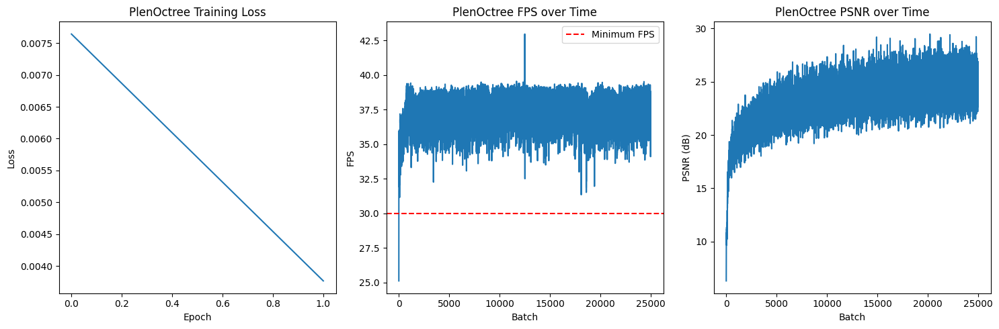

PlenOctree Training Progress:  20%|██        | 25003/125000 [24:49<4:56:33,  5.62it/s]


PlenOctree Epoch 3/10, Batch 0:
FPS: 43.57, Latency: 22.95ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  20%|██        | 25013/125000 [24:50<2:09:30, 12.87it/s]


PlenOctree Epoch 3/10, Batch 10:
FPS: 38.71, Latency: 25.84ms
PSNR: 22.42dB, Loss: 0.0057


PlenOctree Training Progress:  20%|██        | 25023/125000 [24:50<1:43:57, 16.03it/s]


PlenOctree Epoch 3/10, Batch 20:
FPS: 38.29, Latency: 26.11ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  20%|██        | 25033/125000 [24:51<1:38:26, 16.93it/s]


PlenOctree Epoch 3/10, Batch 30:
FPS: 38.43, Latency: 26.02ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  20%|██        | 25043/125000 [24:51<1:37:27, 17.09it/s]


PlenOctree Epoch 3/10, Batch 40:
FPS: 38.26, Latency: 26.14ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  20%|██        | 25053/125000 [24:52<1:38:11, 16.97it/s]


PlenOctree Epoch 3/10, Batch 50:
FPS: 38.48, Latency: 25.99ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  20%|██        | 25063/125000 [24:53<1:37:34, 17.07it/s]


PlenOctree Epoch 3/10, Batch 60:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  20%|██        | 25073/125000 [24:53<1:39:16, 16.78it/s]


PlenOctree Epoch 3/10, Batch 70:
FPS: 36.97, Latency: 27.05ms
PSNR: 22.63dB, Loss: 0.0055


PlenOctree Training Progress:  20%|██        | 25083/125000 [24:54<1:38:11, 16.96it/s]


PlenOctree Epoch 3/10, Batch 80:
FPS: 37.02, Latency: 27.01ms
PSNR: 24.62dB, Loss: 0.0034


PlenOctree Training Progress:  20%|██        | 25093/125000 [24:54<1:37:53, 17.01it/s]


PlenOctree Epoch 3/10, Batch 90:
FPS: 37.24, Latency: 26.85ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  20%|██        | 25103/125000 [24:55<1:37:29, 17.08it/s]


PlenOctree Epoch 3/10, Batch 100:
FPS: 38.32, Latency: 26.10ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  20%|██        | 25113/125000 [24:56<1:37:19, 17.11it/s]


PlenOctree Epoch 3/10, Batch 110:
FPS: 38.14, Latency: 26.22ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25123/125000 [24:56<1:37:38, 17.05it/s]


PlenOctree Epoch 3/10, Batch 120:
FPS: 37.82, Latency: 26.44ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  20%|██        | 25133/125000 [24:57<1:38:03, 16.97it/s]


PlenOctree Epoch 3/10, Batch 130:
FPS: 38.03, Latency: 26.30ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  20%|██        | 25143/125000 [24:57<1:37:38, 17.04it/s]


PlenOctree Epoch 3/10, Batch 140:
FPS: 38.02, Latency: 26.31ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  20%|██        | 25153/125000 [24:58<1:37:35, 17.05it/s]


PlenOctree Epoch 3/10, Batch 150:
FPS: 38.25, Latency: 26.15ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25163/125000 [24:58<1:37:31, 17.06it/s]


PlenOctree Epoch 3/10, Batch 160:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  20%|██        | 25173/125000 [24:59<1:37:39, 17.04it/s]


PlenOctree Epoch 3/10, Batch 170:
FPS: 38.10, Latency: 26.25ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  20%|██        | 25183/125000 [25:00<1:36:45, 17.19it/s]


PlenOctree Epoch 3/10, Batch 180:
FPS: 36.62, Latency: 27.30ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  20%|██        | 25193/125000 [25:00<1:37:05, 17.13it/s]


PlenOctree Epoch 3/10, Batch 190:
FPS: 38.03, Latency: 26.29ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  20%|██        | 25203/125000 [25:01<1:37:22, 17.08it/s]


PlenOctree Epoch 3/10, Batch 200:
FPS: 38.66, Latency: 25.86ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  20%|██        | 25213/125000 [25:01<1:37:01, 17.14it/s]


PlenOctree Epoch 3/10, Batch 210:
FPS: 38.76, Latency: 25.80ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  20%|██        | 25223/125000 [25:02<1:36:55, 17.16it/s]


PlenOctree Epoch 3/10, Batch 220:
FPS: 38.07, Latency: 26.27ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  20%|██        | 25233/125000 [25:03<1:37:02, 17.14it/s]


PlenOctree Epoch 3/10, Batch 230:
FPS: 38.25, Latency: 26.14ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  20%|██        | 25243/125000 [25:03<1:37:04, 17.13it/s]


PlenOctree Epoch 3/10, Batch 240:
FPS: 37.67, Latency: 26.54ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  20%|██        | 25253/125000 [25:04<1:37:29, 17.05it/s]


PlenOctree Epoch 3/10, Batch 250:
FPS: 37.53, Latency: 26.65ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  20%|██        | 25263/125000 [25:04<1:37:27, 17.06it/s]


PlenOctree Epoch 3/10, Batch 260:
FPS: 38.33, Latency: 26.09ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  20%|██        | 25273/125000 [25:05<1:38:25, 16.89it/s]


PlenOctree Epoch 3/10, Batch 270:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25283/125000 [25:06<1:38:00, 16.96it/s]


PlenOctree Epoch 3/10, Batch 280:
FPS: 38.44, Latency: 26.01ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25293/125000 [25:06<1:37:52, 16.98it/s]


PlenOctree Epoch 3/10, Batch 290:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  20%|██        | 25303/125000 [25:07<1:37:30, 17.04it/s]


PlenOctree Epoch 3/10, Batch 300:
FPS: 37.97, Latency: 26.33ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  20%|██        | 25313/125000 [25:07<1:37:47, 16.99it/s]


PlenOctree Epoch 3/10, Batch 310:
FPS: 38.13, Latency: 26.23ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  20%|██        | 25323/125000 [25:08<1:37:41, 17.01it/s]


PlenOctree Epoch 3/10, Batch 320:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  20%|██        | 25333/125000 [25:08<1:37:59, 16.95it/s]


PlenOctree Epoch 3/10, Batch 330:
FPS: 38.21, Latency: 26.17ms
PSNR: 24.31dB, Loss: 0.0037


PlenOctree Training Progress:  20%|██        | 25343/125000 [25:09<1:37:41, 17.00it/s]


PlenOctree Epoch 3/10, Batch 340:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  20%|██        | 25353/125000 [25:10<1:38:34, 16.85it/s]


PlenOctree Epoch 3/10, Batch 350:
FPS: 37.39, Latency: 26.75ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  20%|██        | 25363/125000 [25:10<1:37:52, 16.97it/s]


PlenOctree Epoch 3/10, Batch 360:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  20%|██        | 25373/125000 [25:11<1:38:35, 16.84it/s]


PlenOctree Epoch 3/10, Batch 370:
FPS: 37.10, Latency: 26.96ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  20%|██        | 25383/125000 [25:11<1:38:11, 16.91it/s]


PlenOctree Epoch 3/10, Batch 380:
FPS: 36.99, Latency: 27.04ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  20%|██        | 25393/125000 [25:12<1:37:55, 16.95it/s]


PlenOctree Epoch 3/10, Batch 390:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  20%|██        | 25403/125000 [25:13<1:38:08, 16.91it/s]


PlenOctree Epoch 3/10, Batch 400:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  20%|██        | 25413/125000 [25:13<1:37:47, 16.97it/s]


PlenOctree Epoch 3/10, Batch 410:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  20%|██        | 25423/125000 [25:14<1:37:54, 16.95it/s]


PlenOctree Epoch 3/10, Batch 420:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  20%|██        | 25433/125000 [25:14<1:37:36, 17.00it/s]


PlenOctree Epoch 3/10, Batch 430:
FPS: 37.69, Latency: 26.53ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  20%|██        | 25443/125000 [25:15<1:37:11, 17.07it/s]


PlenOctree Epoch 3/10, Batch 440:
FPS: 36.30, Latency: 27.54ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  20%|██        | 25453/125000 [25:16<1:38:10, 16.90it/s]


PlenOctree Epoch 3/10, Batch 450:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25463/125000 [25:16<1:39:03, 16.75it/s]


PlenOctree Epoch 3/10, Batch 460:
FPS: 36.53, Latency: 27.37ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  20%|██        | 25473/125000 [25:17<1:37:29, 17.01it/s]


PlenOctree Epoch 3/10, Batch 470:
FPS: 35.61, Latency: 28.08ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  20%|██        | 25483/125000 [25:17<1:38:17, 16.87it/s]


PlenOctree Epoch 3/10, Batch 480:
FPS: 37.65, Latency: 26.56ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  20%|██        | 25493/125000 [25:18<1:37:37, 16.99it/s]


PlenOctree Epoch 3/10, Batch 490:
FPS: 37.71, Latency: 26.52ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25503/125000 [25:19<1:38:36, 16.82it/s]


PlenOctree Epoch 3/10, Batch 500:
FPS: 36.68, Latency: 27.26ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  20%|██        | 25513/125000 [25:19<1:38:12, 16.88it/s]


PlenOctree Epoch 3/10, Batch 510:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  20%|██        | 25523/125000 [25:20<1:38:14, 16.88it/s]


PlenOctree Epoch 3/10, Batch 520:
FPS: 36.82, Latency: 27.16ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  20%|██        | 25533/125000 [25:20<1:37:39, 16.98it/s]


PlenOctree Epoch 3/10, Batch 530:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  20%|██        | 25543/125000 [25:21<1:37:27, 17.01it/s]


PlenOctree Epoch 3/10, Batch 540:
FPS: 38.24, Latency: 26.15ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  20%|██        | 25553/125000 [25:21<1:37:17, 17.03it/s]


PlenOctree Epoch 3/10, Batch 550:
FPS: 38.45, Latency: 26.01ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  20%|██        | 25563/125000 [25:22<1:36:50, 17.11it/s]


PlenOctree Epoch 3/10, Batch 560:
FPS: 38.23, Latency: 26.15ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  20%|██        | 25573/125000 [25:23<1:37:10, 17.05it/s]


PlenOctree Epoch 3/10, Batch 570:
FPS: 38.88, Latency: 25.72ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  20%|██        | 25583/125000 [25:23<1:37:28, 17.00it/s]


PlenOctree Epoch 3/10, Batch 580:
FPS: 38.39, Latency: 26.05ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  20%|██        | 25593/125000 [25:24<1:37:57, 16.91it/s]


PlenOctree Epoch 3/10, Batch 590:
FPS: 38.70, Latency: 25.84ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  20%|██        | 25603/125000 [25:24<1:38:08, 16.88it/s]


PlenOctree Epoch 3/10, Batch 600:
FPS: 37.72, Latency: 26.51ms
PSNR: 23.78dB, Loss: 0.0042


PlenOctree Training Progress:  20%|██        | 25613/125000 [25:25<1:37:50, 16.93it/s]


PlenOctree Epoch 3/10, Batch 610:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  20%|██        | 25623/125000 [25:26<1:37:48, 16.93it/s]


PlenOctree Epoch 3/10, Batch 620:
FPS: 37.28, Latency: 26.83ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  21%|██        | 25633/125000 [25:26<1:37:13, 17.03it/s]


PlenOctree Epoch 3/10, Batch 630:
FPS: 36.20, Latency: 27.63ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 25643/125000 [25:27<1:38:02, 16.89it/s]


PlenOctree Epoch 3/10, Batch 640:
FPS: 37.33, Latency: 26.78ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  21%|██        | 25653/125000 [25:27<1:36:52, 17.09it/s]


PlenOctree Epoch 3/10, Batch 650:
FPS: 38.41, Latency: 26.03ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 25663/125000 [25:28<1:38:40, 16.78it/s]


PlenOctree Epoch 3/10, Batch 660:
FPS: 37.39, Latency: 26.74ms
PSNR: 23.94dB, Loss: 0.0040


PlenOctree Training Progress:  21%|██        | 25673/125000 [25:29<1:37:56, 16.90it/s]


PlenOctree Epoch 3/10, Batch 670:
FPS: 36.70, Latency: 27.24ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  21%|██        | 25683/125000 [25:29<1:38:14, 16.85it/s]


PlenOctree Epoch 3/10, Batch 680:
FPS: 35.21, Latency: 28.40ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  21%|██        | 25693/125000 [25:30<1:37:42, 16.94it/s]


PlenOctree Epoch 3/10, Batch 690:
FPS: 37.07, Latency: 26.98ms
PSNR: 23.92dB, Loss: 0.0041


PlenOctree Training Progress:  21%|██        | 25703/125000 [25:30<1:37:22, 17.00it/s]


PlenOctree Epoch 3/10, Batch 700:
FPS: 38.49, Latency: 25.98ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 25713/125000 [25:31<1:38:44, 16.76it/s]


PlenOctree Epoch 3/10, Batch 710:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 25723/125000 [25:32<1:37:30, 16.97it/s]


PlenOctree Epoch 3/10, Batch 720:
FPS: 38.19, Latency: 26.18ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██        | 25733/125000 [25:32<1:38:08, 16.86it/s]


PlenOctree Epoch 3/10, Batch 730:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 25743/125000 [25:33<1:37:11, 17.02it/s]


PlenOctree Epoch 3/10, Batch 740:
FPS: 37.80, Latency: 26.46ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██        | 25753/125000 [25:33<1:37:12, 17.01it/s]


PlenOctree Epoch 3/10, Batch 750:
FPS: 38.27, Latency: 26.13ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  21%|██        | 25763/125000 [25:34<1:36:41, 17.10it/s]


PlenOctree Epoch 3/10, Batch 760:
FPS: 38.31, Latency: 26.10ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  21%|██        | 25773/125000 [25:34<1:37:34, 16.95it/s]


PlenOctree Epoch 3/10, Batch 770:
FPS: 38.25, Latency: 26.14ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  21%|██        | 25783/125000 [25:35<1:36:31, 17.13it/s]


PlenOctree Epoch 3/10, Batch 780:
FPS: 36.92, Latency: 27.09ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  21%|██        | 25793/125000 [25:36<1:38:13, 16.83it/s]


PlenOctree Epoch 3/10, Batch 790:
FPS: 38.18, Latency: 26.19ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  21%|██        | 25803/125000 [25:36<1:37:53, 16.89it/s]


PlenOctree Epoch 3/10, Batch 800:
FPS: 37.94, Latency: 26.36ms
PSNR: 22.88dB, Loss: 0.0052


PlenOctree Training Progress:  21%|██        | 25813/125000 [25:37<1:38:06, 16.85it/s]


PlenOctree Epoch 3/10, Batch 810:
FPS: 37.29, Latency: 26.82ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  21%|██        | 25823/125000 [25:37<1:37:34, 16.94it/s]


PlenOctree Epoch 3/10, Batch 820:
FPS: 37.56, Latency: 26.62ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  21%|██        | 25833/125000 [25:38<1:36:58, 17.04it/s]


PlenOctree Epoch 3/10, Batch 830:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 25843/125000 [25:39<1:37:02, 17.03it/s]


PlenOctree Epoch 3/10, Batch 840:
FPS: 38.66, Latency: 25.86ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  21%|██        | 25853/125000 [25:39<1:36:17, 17.16it/s]


PlenOctree Epoch 3/10, Batch 850:
FPS: 37.68, Latency: 26.54ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  21%|██        | 25863/125000 [25:40<1:38:06, 16.84it/s]


PlenOctree Epoch 3/10, Batch 860:
FPS: 37.41, Latency: 26.73ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  21%|██        | 25873/125000 [25:40<1:37:29, 16.95it/s]


PlenOctree Epoch 3/10, Batch 870:
FPS: 37.94, Latency: 26.36ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 25883/125000 [25:41<1:38:09, 16.83it/s]


PlenOctree Epoch 3/10, Batch 880:
FPS: 36.42, Latency: 27.45ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  21%|██        | 25893/125000 [25:42<1:36:52, 17.05it/s]


PlenOctree Epoch 3/10, Batch 890:
FPS: 37.14, Latency: 26.92ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  21%|██        | 25903/125000 [25:42<1:37:22, 16.96it/s]


PlenOctree Epoch 3/10, Batch 900:
FPS: 38.47, Latency: 25.99ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  21%|██        | 25913/125000 [25:43<1:38:02, 16.85it/s]


PlenOctree Epoch 3/10, Batch 910:
FPS: 37.96, Latency: 26.34ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 25923/125000 [25:43<1:38:10, 16.82it/s]


PlenOctree Epoch 3/10, Batch 920:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  21%|██        | 25933/125000 [25:44<1:37:07, 17.00it/s]


PlenOctree Epoch 3/10, Batch 930:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██        | 25943/125000 [25:44<1:36:56, 17.03it/s]


PlenOctree Epoch 3/10, Batch 940:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  21%|██        | 25953/125000 [25:45<1:36:33, 17.10it/s]


PlenOctree Epoch 3/10, Batch 950:
FPS: 38.36, Latency: 26.07ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  21%|██        | 25963/125000 [25:46<1:37:44, 16.89it/s]


PlenOctree Epoch 3/10, Batch 960:
FPS: 37.04, Latency: 27.00ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██        | 25973/125000 [25:46<1:37:03, 17.01it/s]


PlenOctree Epoch 3/10, Batch 970:
FPS: 38.62, Latency: 25.89ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 25983/125000 [25:47<1:38:16, 16.79it/s]


PlenOctree Epoch 3/10, Batch 980:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  21%|██        | 25993/125000 [25:47<1:37:22, 16.95it/s]


PlenOctree Epoch 3/10, Batch 990:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  21%|██        | 26003/125000 [25:48<1:37:16, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1000:
FPS: 37.18, Latency: 26.90ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██        | 26013/125000 [25:49<1:36:54, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1010:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26023/125000 [25:49<1:38:12, 16.80it/s]


PlenOctree Epoch 3/10, Batch 1020:
FPS: 38.19, Latency: 26.18ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  21%|██        | 26033/125000 [25:50<1:38:04, 16.82it/s]


PlenOctree Epoch 3/10, Batch 1030:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██        | 26043/125000 [25:50<1:37:37, 16.89it/s]


PlenOctree Epoch 3/10, Batch 1040:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  21%|██        | 26053/125000 [25:51<1:37:45, 16.87it/s]


PlenOctree Epoch 3/10, Batch 1050:
FPS: 37.19, Latency: 26.89ms
PSNR: 23.40dB, Loss: 0.0046


PlenOctree Training Progress:  21%|██        | 26063/125000 [25:52<1:37:12, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1060:
FPS: 36.15, Latency: 27.67ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 26073/125000 [25:52<1:36:54, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1070:
FPS: 38.42, Latency: 26.03ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  21%|██        | 26083/125000 [25:53<1:38:31, 16.73it/s]


PlenOctree Epoch 3/10, Batch 1080:
FPS: 37.78, Latency: 26.47ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 26093/125000 [25:53<1:37:41, 16.87it/s]


PlenOctree Epoch 3/10, Batch 1090:
FPS: 37.75, Latency: 26.49ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  21%|██        | 26103/125000 [25:54<1:37:30, 16.90it/s]


PlenOctree Epoch 3/10, Batch 1100:
FPS: 38.22, Latency: 26.17ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 26113/125000 [25:55<1:37:59, 16.82it/s]


PlenOctree Epoch 3/10, Batch 1110:
FPS: 38.43, Latency: 26.02ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  21%|██        | 26123/125000 [25:55<1:37:55, 16.83it/s]


PlenOctree Epoch 3/10, Batch 1120:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  21%|██        | 26133/125000 [25:56<1:37:23, 16.92it/s]


PlenOctree Epoch 3/10, Batch 1130:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  21%|██        | 26143/125000 [25:56<1:36:36, 17.05it/s]


PlenOctree Epoch 3/10, Batch 1140:
FPS: 37.43, Latency: 26.72ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  21%|██        | 26153/125000 [25:57<1:36:23, 17.09it/s]


PlenOctree Epoch 3/10, Batch 1150:
FPS: 38.33, Latency: 26.09ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  21%|██        | 26163/125000 [25:57<1:36:24, 17.09it/s]


PlenOctree Epoch 3/10, Batch 1160:
FPS: 38.22, Latency: 26.16ms
PSNR: 25.02dB, Loss: 0.0032


PlenOctree Training Progress:  21%|██        | 26173/125000 [25:58<1:37:55, 16.82it/s]


PlenOctree Epoch 3/10, Batch 1170:
FPS: 38.59, Latency: 25.91ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  21%|██        | 26183/125000 [25:59<1:37:32, 16.88it/s]


PlenOctree Epoch 3/10, Batch 1180:
FPS: 36.92, Latency: 27.08ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  21%|██        | 26193/125000 [25:59<1:37:15, 16.93it/s]


PlenOctree Epoch 3/10, Batch 1190:
FPS: 36.84, Latency: 27.15ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  21%|██        | 26203/125000 [26:00<1:37:07, 16.95it/s]


PlenOctree Epoch 3/10, Batch 1200:
FPS: 37.23, Latency: 26.86ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  21%|██        | 26213/125000 [26:00<1:37:02, 16.97it/s]


PlenOctree Epoch 3/10, Batch 1210:
FPS: 36.53, Latency: 27.38ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  21%|██        | 26223/125000 [26:01<1:36:26, 17.07it/s]


PlenOctree Epoch 3/10, Batch 1220:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26233/125000 [26:02<1:36:32, 17.05it/s]


PlenOctree Epoch 3/10, Batch 1230:
FPS: 38.18, Latency: 26.19ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  21%|██        | 26243/125000 [26:02<1:36:22, 17.08it/s]


PlenOctree Epoch 3/10, Batch 1240:
FPS: 38.47, Latency: 26.00ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26253/125000 [26:03<1:37:31, 16.87it/s]


PlenOctree Epoch 3/10, Batch 1250:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  21%|██        | 26263/125000 [26:03<1:38:02, 16.78it/s]


PlenOctree Epoch 3/10, Batch 1260:
FPS: 35.16, Latency: 28.44ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  21%|██        | 26273/125000 [26:04<1:37:36, 16.86it/s]


PlenOctree Epoch 3/10, Batch 1270:
FPS: 36.42, Latency: 27.46ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  21%|██        | 26283/125000 [26:05<1:37:46, 16.83it/s]


PlenOctree Epoch 3/10, Batch 1280:
FPS: 37.35, Latency: 26.77ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  21%|██        | 26293/125000 [26:05<1:37:38, 16.85it/s]


PlenOctree Epoch 3/10, Batch 1290:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██        | 26303/125000 [26:06<1:37:12, 16.92it/s]


PlenOctree Epoch 3/10, Batch 1300:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  21%|██        | 26313/125000 [26:06<1:36:00, 17.13it/s]


PlenOctree Epoch 3/10, Batch 1310:
FPS: 38.41, Latency: 26.03ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██        | 26323/125000 [26:07<1:37:07, 16.93it/s]


PlenOctree Epoch 3/10, Batch 1320:
FPS: 38.39, Latency: 26.05ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26333/125000 [26:08<1:36:58, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1330:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  21%|██        | 26343/125000 [26:08<1:36:53, 16.97it/s]


PlenOctree Epoch 3/10, Batch 1340:
FPS: 38.67, Latency: 25.86ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  21%|██        | 26353/125000 [26:09<1:36:38, 17.01it/s]


PlenOctree Epoch 3/10, Batch 1350:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26363/125000 [26:09<1:36:29, 17.04it/s]


PlenOctree Epoch 3/10, Batch 1360:
FPS: 38.40, Latency: 26.04ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  21%|██        | 26373/125000 [26:10<1:36:56, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1370:
FPS: 37.84, Latency: 26.43ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 26383/125000 [26:10<1:36:44, 16.99it/s]


PlenOctree Epoch 3/10, Batch 1380:
FPS: 38.46, Latency: 26.00ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  21%|██        | 26393/125000 [26:11<1:37:46, 16.81it/s]


PlenOctree Epoch 3/10, Batch 1390:
FPS: 37.49, Latency: 26.67ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  21%|██        | 26403/125000 [26:12<1:37:45, 16.81it/s]


PlenOctree Epoch 3/10, Batch 1400:
FPS: 37.64, Latency: 26.56ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26413/125000 [26:12<1:36:48, 16.97it/s]


PlenOctree Epoch 3/10, Batch 1410:
FPS: 37.35, Latency: 26.77ms
PSNR: 23.79dB, Loss: 0.0042


PlenOctree Training Progress:  21%|██        | 26423/125000 [26:13<1:36:24, 17.04it/s]


PlenOctree Epoch 3/10, Batch 1420:
FPS: 38.36, Latency: 26.07ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26433/125000 [26:13<1:35:54, 17.13it/s]


PlenOctree Epoch 3/10, Batch 1430:
FPS: 38.21, Latency: 26.17ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██        | 26443/125000 [26:14<1:36:41, 16.99it/s]


PlenOctree Epoch 3/10, Batch 1440:
FPS: 37.59, Latency: 26.60ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  21%|██        | 26453/125000 [26:15<1:36:51, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1450:
FPS: 38.85, Latency: 25.74ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  21%|██        | 26463/125000 [26:15<1:36:51, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1460:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  21%|██        | 26473/125000 [26:16<1:38:09, 16.73it/s]


PlenOctree Epoch 3/10, Batch 1470:
FPS: 36.60, Latency: 27.32ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  21%|██        | 26483/125000 [26:16<1:36:35, 17.00it/s]


PlenOctree Epoch 3/10, Batch 1480:
FPS: 37.62, Latency: 26.58ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  21%|██        | 26493/125000 [26:17<1:38:42, 16.63it/s]


PlenOctree Epoch 3/10, Batch 1490:
FPS: 36.37, Latency: 27.50ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██        | 26503/125000 [26:18<1:36:44, 16.97it/s]


PlenOctree Epoch 3/10, Batch 1500:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██        | 26513/125000 [26:18<1:36:24, 17.03it/s]


PlenOctree Epoch 3/10, Batch 1510:
FPS: 38.19, Latency: 26.19ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  21%|██        | 26523/125000 [26:19<1:36:28, 17.01it/s]


PlenOctree Epoch 3/10, Batch 1520:
FPS: 37.84, Latency: 26.43ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:  21%|██        | 26533/125000 [26:19<1:37:11, 16.88it/s]


PlenOctree Epoch 3/10, Batch 1530:
FPS: 38.46, Latency: 26.00ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  21%|██        | 26543/125000 [26:20<1:37:05, 16.90it/s]


PlenOctree Epoch 3/10, Batch 1540:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  21%|██        | 26553/125000 [26:21<1:37:29, 16.83it/s]


PlenOctree Epoch 3/10, Batch 1550:
FPS: 37.45, Latency: 26.71ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  21%|██▏       | 26563/125000 [26:21<1:37:23, 16.85it/s]


PlenOctree Epoch 3/10, Batch 1560:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  21%|██▏       | 26573/125000 [26:22<1:36:34, 16.98it/s]


PlenOctree Epoch 3/10, Batch 1570:
FPS: 37.57, Latency: 26.62ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  21%|██▏       | 26583/125000 [26:22<1:36:30, 17.00it/s]


PlenOctree Epoch 3/10, Batch 1580:
FPS: 37.36, Latency: 26.76ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  21%|██▏       | 26593/125000 [26:23<1:37:42, 16.79it/s]


PlenOctree Epoch 3/10, Batch 1590:
FPS: 38.09, Latency: 26.25ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██▏       | 26603/125000 [26:24<1:37:05, 16.89it/s]


PlenOctree Epoch 3/10, Batch 1600:
FPS: 37.96, Latency: 26.34ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  21%|██▏       | 26613/125000 [26:24<1:36:59, 16.91it/s]


PlenOctree Epoch 3/10, Batch 1610:
FPS: 37.81, Latency: 26.45ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  21%|██▏       | 26623/125000 [26:25<1:37:06, 16.88it/s]


PlenOctree Epoch 3/10, Batch 1620:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██▏       | 26633/125000 [26:25<1:36:47, 16.94it/s]


PlenOctree Epoch 3/10, Batch 1630:
FPS: 37.12, Latency: 26.94ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  21%|██▏       | 26643/125000 [26:26<1:36:55, 16.91it/s]


PlenOctree Epoch 3/10, Batch 1640:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██▏       | 26653/125000 [26:26<1:36:32, 16.98it/s]


PlenOctree Epoch 3/10, Batch 1650:
FPS: 38.87, Latency: 25.73ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  21%|██▏       | 26663/125000 [26:27<1:36:15, 17.03it/s]


PlenOctree Epoch 3/10, Batch 1660:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  21%|██▏       | 26673/125000 [26:28<1:37:07, 16.87it/s]


PlenOctree Epoch 3/10, Batch 1670:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██▏       | 26683/125000 [26:28<1:37:15, 16.85it/s]


PlenOctree Epoch 3/10, Batch 1680:
FPS: 37.72, Latency: 26.51ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██▏       | 26693/125000 [26:29<1:37:23, 16.82it/s]


PlenOctree Epoch 3/10, Batch 1690:
FPS: 37.41, Latency: 26.73ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██▏       | 26703/125000 [26:29<1:36:14, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1700:
FPS: 36.91, Latency: 27.10ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  21%|██▏       | 26713/125000 [26:30<1:36:22, 17.00it/s]


PlenOctree Epoch 3/10, Batch 1710:
FPS: 38.54, Latency: 25.95ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  21%|██▏       | 26723/125000 [26:31<1:35:42, 17.11it/s]


PlenOctree Epoch 3/10, Batch 1720:
FPS: 38.26, Latency: 26.14ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██▏       | 26733/125000 [26:31<1:36:44, 16.93it/s]


PlenOctree Epoch 3/10, Batch 1730:
FPS: 38.49, Latency: 25.98ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  21%|██▏       | 26743/125000 [26:32<1:36:13, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1740:
FPS: 37.97, Latency: 26.33ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  21%|██▏       | 26753/125000 [26:32<1:36:10, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1750:
FPS: 38.56, Latency: 25.93ms
PSNR: 24.13dB, Loss: 0.0039


PlenOctree Training Progress:  21%|██▏       | 26763/125000 [26:33<1:37:16, 16.83it/s]


PlenOctree Epoch 3/10, Batch 1760:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  21%|██▏       | 26773/125000 [26:34<1:36:32, 16.96it/s]


PlenOctree Epoch 3/10, Batch 1770:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  21%|██▏       | 26783/125000 [26:34<1:36:59, 16.88it/s]


PlenOctree Epoch 3/10, Batch 1780:
FPS: 36.06, Latency: 27.73ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  21%|██▏       | 26793/125000 [26:35<1:36:10, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1790:
FPS: 37.20, Latency: 26.88ms
PSNR: 22.69dB, Loss: 0.0054


PlenOctree Training Progress:  21%|██▏       | 26803/125000 [26:35<1:36:36, 16.94it/s]


PlenOctree Epoch 3/10, Batch 1800:
FPS: 37.49, Latency: 26.67ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  21%|██▏       | 26813/125000 [26:36<1:37:10, 16.84it/s]


PlenOctree Epoch 3/10, Batch 1810:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  21%|██▏       | 26823/125000 [26:36<1:36:45, 16.91it/s]


PlenOctree Epoch 3/10, Batch 1820:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  21%|██▏       | 26833/125000 [26:37<1:36:37, 16.93it/s]


PlenOctree Epoch 3/10, Batch 1830:
FPS: 36.56, Latency: 27.36ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  21%|██▏       | 26843/125000 [26:38<1:36:32, 16.95it/s]


PlenOctree Epoch 3/10, Batch 1840:
FPS: 37.32, Latency: 26.79ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  21%|██▏       | 26853/125000 [26:38<1:36:13, 17.00it/s]


PlenOctree Epoch 3/10, Batch 1850:
FPS: 37.45, Latency: 26.70ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:  21%|██▏       | 26863/125000 [26:39<1:35:43, 17.09it/s]


PlenOctree Epoch 3/10, Batch 1860:
FPS: 36.84, Latency: 27.14ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  21%|██▏       | 26873/125000 [26:39<1:37:34, 16.76it/s]


PlenOctree Epoch 3/10, Batch 1870:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  22%|██▏       | 26883/125000 [26:40<1:36:46, 16.90it/s]


PlenOctree Epoch 3/10, Batch 1880:
FPS: 36.13, Latency: 27.68ms
PSNR: 23.62dB, Loss: 0.0043


PlenOctree Training Progress:  22%|██▏       | 26893/125000 [26:41<1:36:37, 16.92it/s]


PlenOctree Epoch 3/10, Batch 1890:
FPS: 37.18, Latency: 26.90ms
PSNR: 23.02dB, Loss: 0.0050


PlenOctree Training Progress:  22%|██▏       | 26903/125000 [26:41<1:36:09, 17.00it/s]


PlenOctree Epoch 3/10, Batch 1900:
FPS: 38.39, Latency: 26.05ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  22%|██▏       | 26913/125000 [26:42<1:36:47, 16.89it/s]


PlenOctree Epoch 3/10, Batch 1910:
FPS: 38.64, Latency: 25.88ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 26923/125000 [26:42<1:36:57, 16.86it/s]


PlenOctree Epoch 3/10, Batch 1920:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  22%|██▏       | 26933/125000 [26:43<1:36:53, 16.87it/s]


PlenOctree Epoch 3/10, Batch 1930:
FPS: 36.95, Latency: 27.06ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 26943/125000 [26:44<1:36:37, 16.91it/s]


PlenOctree Epoch 3/10, Batch 1940:
FPS: 36.49, Latency: 27.40ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  22%|██▏       | 26953/125000 [26:44<1:35:59, 17.02it/s]


PlenOctree Epoch 3/10, Batch 1950:
FPS: 36.37, Latency: 27.50ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 26963/125000 [26:45<1:35:37, 17.09it/s]


PlenOctree Epoch 3/10, Batch 1960:
FPS: 37.96, Latency: 26.35ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 26973/125000 [26:45<1:36:54, 16.86it/s]


PlenOctree Epoch 3/10, Batch 1970:
FPS: 38.46, Latency: 26.00ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 26983/125000 [26:46<1:36:45, 16.88it/s]


PlenOctree Epoch 3/10, Batch 1980:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 26993/125000 [26:47<1:37:12, 16.80it/s]


PlenOctree Epoch 3/10, Batch 1990:
FPS: 36.76, Latency: 27.20ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  22%|██▏       | 27003/125000 [26:47<1:36:00, 17.01it/s]


PlenOctree Epoch 3/10, Batch 2000:
FPS: 38.32, Latency: 26.10ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27013/125000 [26:48<1:35:43, 17.06it/s]


PlenOctree Epoch 3/10, Batch 2010:
FPS: 38.37, Latency: 26.06ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  22%|██▏       | 27023/125000 [26:48<1:35:48, 17.04it/s]


PlenOctree Epoch 3/10, Batch 2020:
FPS: 37.99, Latency: 26.32ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  22%|██▏       | 27033/125000 [26:49<1:36:57, 16.84it/s]


PlenOctree Epoch 3/10, Batch 2030:
FPS: 37.36, Latency: 26.77ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  22%|██▏       | 27043/125000 [26:49<1:36:37, 16.90it/s]


PlenOctree Epoch 3/10, Batch 2040:
FPS: 37.67, Latency: 26.55ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  22%|██▏       | 27053/125000 [26:50<1:36:56, 16.84it/s]


PlenOctree Epoch 3/10, Batch 2050:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  22%|██▏       | 27063/125000 [26:51<1:36:19, 16.95it/s]


PlenOctree Epoch 3/10, Batch 2060:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 27073/125000 [26:51<1:36:04, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2070:
FPS: 38.01, Latency: 26.31ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 27083/125000 [26:52<1:36:04, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2080:
FPS: 36.83, Latency: 27.15ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  22%|██▏       | 27093/125000 [26:52<1:35:54, 17.02it/s]


PlenOctree Epoch 3/10, Batch 2090:
FPS: 38.70, Latency: 25.84ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  22%|██▏       | 27103/125000 [26:53<1:37:32, 16.73it/s]


PlenOctree Epoch 3/10, Batch 2100:
FPS: 36.29, Latency: 27.56ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  22%|██▏       | 27113/125000 [26:54<1:35:52, 17.02it/s]


PlenOctree Epoch 3/10, Batch 2110:
FPS: 38.31, Latency: 26.10ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 27123/125000 [26:54<1:35:43, 17.04it/s]


PlenOctree Epoch 3/10, Batch 2120:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 27133/125000 [26:55<1:35:39, 17.05it/s]


PlenOctree Epoch 3/10, Batch 2130:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  22%|██▏       | 27143/125000 [26:55<1:35:50, 17.02it/s]


PlenOctree Epoch 3/10, Batch 2140:
FPS: 38.78, Latency: 25.79ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 27153/125000 [26:56<1:37:09, 16.78it/s]


PlenOctree Epoch 3/10, Batch 2150:
FPS: 37.70, Latency: 26.53ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  22%|██▏       | 27163/125000 [26:57<1:36:13, 16.95it/s]


PlenOctree Epoch 3/10, Batch 2160:
FPS: 38.26, Latency: 26.14ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  22%|██▏       | 27173/125000 [26:57<1:36:36, 16.88it/s]


PlenOctree Epoch 3/10, Batch 2170:
FPS: 36.26, Latency: 27.58ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 27183/125000 [26:58<1:35:38, 17.05it/s]


PlenOctree Epoch 3/10, Batch 2180:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  22%|██▏       | 27193/125000 [26:58<1:35:52, 17.00it/s]


PlenOctree Epoch 3/10, Batch 2190:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27203/125000 [26:59<1:35:55, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2200:
FPS: 38.32, Latency: 26.09ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  22%|██▏       | 27213/125000 [27:00<1:34:59, 17.16it/s]


PlenOctree Epoch 3/10, Batch 2210:
FPS: 38.50, Latency: 25.97ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  22%|██▏       | 27223/125000 [27:00<1:35:47, 17.01it/s]


PlenOctree Epoch 3/10, Batch 2220:
FPS: 38.81, Latency: 25.77ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  22%|██▏       | 27233/125000 [27:01<1:36:19, 16.92it/s]


PlenOctree Epoch 3/10, Batch 2230:
FPS: 38.44, Latency: 26.01ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  22%|██▏       | 27243/125000 [27:01<1:36:37, 16.86it/s]


PlenOctree Epoch 3/10, Batch 2240:
FPS: 38.45, Latency: 26.01ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  22%|██▏       | 27253/125000 [27:02<1:36:43, 16.84it/s]


PlenOctree Epoch 3/10, Batch 2250:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.16dB, Loss: 0.0031


PlenOctree Training Progress:  22%|██▏       | 27263/125000 [27:02<1:36:30, 16.88it/s]


PlenOctree Epoch 3/10, Batch 2260:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  22%|██▏       | 27273/125000 [27:03<1:36:11, 16.93it/s]


PlenOctree Epoch 3/10, Batch 2270:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27283/125000 [27:04<1:35:25, 17.07it/s]


PlenOctree Epoch 3/10, Batch 2280:
FPS: 36.57, Latency: 27.35ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  22%|██▏       | 27293/125000 [27:04<1:35:28, 17.06it/s]


PlenOctree Epoch 3/10, Batch 2290:
FPS: 38.63, Latency: 25.88ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  22%|██▏       | 27303/125000 [27:05<1:36:52, 16.81it/s]


PlenOctree Epoch 3/10, Batch 2300:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  22%|██▏       | 27313/125000 [27:05<1:36:29, 16.87it/s]


PlenOctree Epoch 3/10, Batch 2310:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 27323/125000 [27:06<1:36:34, 16.86it/s]


PlenOctree Epoch 3/10, Batch 2320:
FPS: 36.04, Latency: 27.74ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27333/125000 [27:07<1:36:14, 16.91it/s]


PlenOctree Epoch 3/10, Batch 2330:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 27343/125000 [27:07<1:35:34, 17.03it/s]


PlenOctree Epoch 3/10, Batch 2340:
FPS: 36.36, Latency: 27.50ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  22%|██▏       | 27353/125000 [27:08<1:35:54, 16.97it/s]


PlenOctree Epoch 3/10, Batch 2350:
FPS: 37.40, Latency: 26.74ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 27363/125000 [27:08<1:35:52, 16.97it/s]


PlenOctree Epoch 3/10, Batch 2360:
FPS: 38.79, Latency: 25.78ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27373/125000 [27:09<1:36:59, 16.78it/s]


PlenOctree Epoch 3/10, Batch 2370:
FPS: 36.24, Latency: 27.59ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:  22%|██▏       | 27383/125000 [27:10<1:35:45, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2380:
FPS: 38.26, Latency: 26.13ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  22%|██▏       | 27393/125000 [27:10<1:35:53, 16.96it/s]


PlenOctree Epoch 3/10, Batch 2390:
FPS: 38.30, Latency: 26.11ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  22%|██▏       | 27403/125000 [27:11<1:36:05, 16.93it/s]


PlenOctree Epoch 3/10, Batch 2400:
FPS: 38.63, Latency: 25.88ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27413/125000 [27:11<1:35:54, 16.96it/s]


PlenOctree Epoch 3/10, Batch 2410:
FPS: 37.96, Latency: 26.35ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 27423/125000 [27:12<1:36:44, 16.81it/s]


PlenOctree Epoch 3/10, Batch 2420:
FPS: 37.16, Latency: 26.91ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27433/125000 [27:13<1:35:52, 16.96it/s]


PlenOctree Epoch 3/10, Batch 2430:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  22%|██▏       | 27443/125000 [27:13<1:35:42, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2440:
FPS: 37.57, Latency: 26.61ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 27453/125000 [27:14<1:35:10, 17.08it/s]


PlenOctree Epoch 3/10, Batch 2450:
FPS: 37.99, Latency: 26.32ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 27463/125000 [27:14<1:35:04, 17.10it/s]


PlenOctree Epoch 3/10, Batch 2460:
FPS: 37.83, Latency: 26.43ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 27473/125000 [27:15<1:34:58, 17.11it/s]


PlenOctree Epoch 3/10, Batch 2470:
FPS: 38.63, Latency: 25.89ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 27483/125000 [27:15<1:36:29, 16.85it/s]


PlenOctree Epoch 3/10, Batch 2480:
FPS: 38.87, Latency: 25.73ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 27493/125000 [27:16<1:36:58, 16.76it/s]


PlenOctree Epoch 3/10, Batch 2490:
FPS: 36.01, Latency: 27.77ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  22%|██▏       | 27503/125000 [27:17<1:35:41, 16.98it/s]


PlenOctree Epoch 3/10, Batch 2500:
FPS: 36.96, Latency: 27.05ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27513/125000 [27:17<1:35:28, 17.02it/s]


PlenOctree Epoch 3/10, Batch 2510:
FPS: 38.36, Latency: 26.07ms
PSNR: 23.56dB, Loss: 0.0044


PlenOctree Training Progress:  22%|██▏       | 27523/125000 [27:18<1:36:00, 16.92it/s]


PlenOctree Epoch 3/10, Batch 2520:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 27533/125000 [27:18<1:36:54, 16.76it/s]


PlenOctree Epoch 3/10, Batch 2530:
FPS: 37.03, Latency: 27.00ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27543/125000 [27:19<1:35:38, 16.98it/s]


PlenOctree Epoch 3/10, Batch 2540:
FPS: 38.37, Latency: 26.06ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  22%|██▏       | 27553/125000 [27:20<1:36:01, 16.91it/s]


PlenOctree Epoch 3/10, Batch 2550:
FPS: 37.33, Latency: 26.79ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  22%|██▏       | 27563/125000 [27:20<1:35:54, 16.93it/s]


PlenOctree Epoch 3/10, Batch 2560:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27573/125000 [27:21<1:35:23, 17.02it/s]


PlenOctree Epoch 3/10, Batch 2570:
FPS: 37.03, Latency: 27.01ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 27583/125000 [27:21<1:35:19, 17.03it/s]


PlenOctree Epoch 3/10, Batch 2580:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  22%|██▏       | 27593/125000 [27:22<1:35:15, 17.04it/s]


PlenOctree Epoch 3/10, Batch 2590:
FPS: 38.71, Latency: 25.83ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  22%|██▏       | 27603/125000 [27:23<1:35:47, 16.94it/s]


PlenOctree Epoch 3/10, Batch 2600:
FPS: 38.47, Latency: 25.99ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  22%|██▏       | 27613/125000 [27:23<1:36:35, 16.81it/s]


PlenOctree Epoch 3/10, Batch 2610:
FPS: 36.88, Latency: 27.11ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  22%|██▏       | 27623/125000 [27:24<1:36:12, 16.87it/s]


PlenOctree Epoch 3/10, Batch 2620:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27633/125000 [27:24<1:36:00, 16.90it/s]


PlenOctree Epoch 3/10, Batch 2630:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  22%|██▏       | 27643/125000 [27:25<1:35:31, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2640:
FPS: 37.71, Latency: 26.51ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  22%|██▏       | 27653/125000 [27:26<1:35:02, 17.07it/s]


PlenOctree Epoch 3/10, Batch 2650:
FPS: 38.82, Latency: 25.76ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  22%|██▏       | 27663/125000 [27:26<1:36:26, 16.82it/s]


PlenOctree Epoch 3/10, Batch 2660:
FPS: 38.41, Latency: 26.03ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  22%|██▏       | 27673/125000 [27:27<1:36:08, 16.87it/s]


PlenOctree Epoch 3/10, Batch 2670:
FPS: 36.77, Latency: 27.19ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  22%|██▏       | 27683/125000 [27:27<1:36:12, 16.86it/s]


PlenOctree Epoch 3/10, Batch 2680:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 27693/125000 [27:28<1:35:36, 16.96it/s]


PlenOctree Epoch 3/10, Batch 2690:
FPS: 38.37, Latency: 26.06ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:  22%|██▏       | 27703/125000 [27:28<1:36:36, 16.79it/s]


PlenOctree Epoch 3/10, Batch 2700:
FPS: 37.96, Latency: 26.34ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 27713/125000 [27:29<1:36:52, 16.74it/s]


PlenOctree Epoch 3/10, Batch 2710:
FPS: 36.86, Latency: 27.13ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  22%|██▏       | 27723/125000 [27:30<1:37:29, 16.63it/s]


PlenOctree Epoch 3/10, Batch 2720:
FPS: 37.63, Latency: 26.57ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  22%|██▏       | 27733/125000 [27:30<1:35:20, 17.00it/s]


PlenOctree Epoch 3/10, Batch 2730:
FPS: 38.25, Latency: 26.15ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 27743/125000 [27:31<1:36:29, 16.80it/s]


PlenOctree Epoch 3/10, Batch 2740:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27753/125000 [27:31<1:35:27, 16.98it/s]


PlenOctree Epoch 3/10, Batch 2750:
FPS: 37.59, Latency: 26.60ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 27763/125000 [27:32<1:36:13, 16.84it/s]


PlenOctree Epoch 3/10, Batch 2760:
FPS: 38.26, Latency: 26.14ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  22%|██▏       | 27773/125000 [27:33<1:35:02, 17.05it/s]


PlenOctree Epoch 3/10, Batch 2770:
FPS: 38.51, Latency: 25.97ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27783/125000 [27:33<1:36:43, 16.75it/s]


PlenOctree Epoch 3/10, Batch 2780:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 27793/125000 [27:34<1:36:09, 16.85it/s]


PlenOctree Epoch 3/10, Batch 2790:
FPS: 36.49, Latency: 27.40ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 27803/125000 [27:34<1:36:40, 16.76it/s]


PlenOctree Epoch 3/10, Batch 2800:
FPS: 37.74, Latency: 26.49ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 27813/125000 [27:35<1:36:23, 16.81it/s]


PlenOctree Epoch 3/10, Batch 2810:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:  22%|██▏       | 27823/125000 [27:36<1:36:02, 16.86it/s]


PlenOctree Epoch 3/10, Batch 2820:
FPS: 36.72, Latency: 27.23ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  22%|██▏       | 27833/125000 [27:36<1:36:02, 16.86it/s]


PlenOctree Epoch 3/10, Batch 2830:
FPS: 37.83, Latency: 26.44ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 27843/125000 [27:37<1:35:26, 16.97it/s]


PlenOctree Epoch 3/10, Batch 2840:
FPS: 38.60, Latency: 25.91ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  22%|██▏       | 27853/125000 [27:37<1:35:54, 16.88it/s]


PlenOctree Epoch 3/10, Batch 2850:
FPS: 38.14, Latency: 26.22ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27863/125000 [27:38<1:35:50, 16.89it/s]


PlenOctree Epoch 3/10, Batch 2860:
FPS: 37.97, Latency: 26.34ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  22%|██▏       | 27873/125000 [27:39<1:35:55, 16.88it/s]


PlenOctree Epoch 3/10, Batch 2870:
FPS: 37.55, Latency: 26.63ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 27883/125000 [27:39<1:35:21, 16.97it/s]


PlenOctree Epoch 3/10, Batch 2880:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  22%|██▏       | 27893/125000 [27:40<1:35:37, 16.92it/s]


PlenOctree Epoch 3/10, Batch 2890:
FPS: 35.38, Latency: 28.27ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 27903/125000 [27:40<1:36:43, 16.73it/s]


PlenOctree Epoch 3/10, Batch 2900:
FPS: 38.22, Latency: 26.16ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 27913/125000 [27:41<1:36:16, 16.81it/s]


PlenOctree Epoch 3/10, Batch 2910:
FPS: 35.85, Latency: 27.89ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  22%|██▏       | 27923/125000 [27:42<1:35:14, 16.99it/s]


PlenOctree Epoch 3/10, Batch 2920:
FPS: 38.47, Latency: 25.99ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  22%|██▏       | 27933/125000 [27:42<1:34:45, 17.07it/s]


PlenOctree Epoch 3/10, Batch 2930:
FPS: 38.13, Latency: 26.23ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 27943/125000 [27:43<1:35:46, 16.89it/s]


PlenOctree Epoch 3/10, Batch 2940:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  22%|██▏       | 27953/125000 [27:43<1:36:22, 16.78it/s]


PlenOctree Epoch 3/10, Batch 2950:
FPS: 37.07, Latency: 26.97ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 27963/125000 [27:44<1:35:06, 17.00it/s]


PlenOctree Epoch 3/10, Batch 2960:
FPS: 37.90, Latency: 26.38ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  22%|██▏       | 27973/125000 [27:44<1:35:40, 16.90it/s]


PlenOctree Epoch 3/10, Batch 2970:
FPS: 38.08, Latency: 26.26ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  22%|██▏       | 27983/125000 [27:45<1:35:12, 16.98it/s]


PlenOctree Epoch 3/10, Batch 2980:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 27993/125000 [27:46<1:36:23, 16.77it/s]


PlenOctree Epoch 3/10, Batch 2990:
FPS: 37.31, Latency: 26.80ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  22%|██▏       | 28003/125000 [27:46<1:35:12, 16.98it/s]


PlenOctree Epoch 3/10, Batch 3000:
FPS: 37.83, Latency: 26.44ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  22%|██▏       | 28013/125000 [27:47<1:35:23, 16.94it/s]


PlenOctree Epoch 3/10, Batch 3010:
FPS: 38.47, Latency: 25.99ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  22%|██▏       | 28023/125000 [27:47<1:34:40, 17.07it/s]


PlenOctree Epoch 3/10, Batch 3020:
FPS: 38.41, Latency: 26.03ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  22%|██▏       | 28033/125000 [27:48<1:36:21, 16.77it/s]


PlenOctree Epoch 3/10, Batch 3030:
FPS: 36.71, Latency: 27.24ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  22%|██▏       | 28043/125000 [27:49<1:36:23, 16.77it/s]


PlenOctree Epoch 3/10, Batch 3040:
FPS: 37.13, Latency: 26.94ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  22%|██▏       | 28053/125000 [27:49<1:37:23, 16.59it/s]


PlenOctree Epoch 3/10, Batch 3050:
FPS: 36.90, Latency: 27.10ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  22%|██▏       | 28063/125000 [27:50<1:35:36, 16.90it/s]


PlenOctree Epoch 3/10, Batch 3060:
FPS: 36.43, Latency: 27.45ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  22%|██▏       | 28073/125000 [27:50<1:37:32, 16.56it/s]


PlenOctree Epoch 3/10, Batch 3070:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  22%|██▏       | 28083/125000 [27:51<1:35:35, 16.90it/s]


PlenOctree Epoch 3/10, Batch 3080:
FPS: 36.08, Latency: 27.72ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 28093/125000 [27:52<1:37:34, 16.55it/s]


PlenOctree Epoch 3/10, Batch 3090:
FPS: 34.91, Latency: 28.64ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  22%|██▏       | 28103/125000 [27:52<1:36:47, 16.68it/s]


PlenOctree Epoch 3/10, Batch 3100:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  22%|██▏       | 28113/125000 [27:53<1:36:13, 16.78it/s]


PlenOctree Epoch 3/10, Batch 3110:
FPS: 37.15, Latency: 26.92ms
PSNR: 25.30dB, Loss: 0.0029


PlenOctree Training Progress:  22%|██▏       | 28123/125000 [27:53<1:37:20, 16.59it/s]


PlenOctree Epoch 3/10, Batch 3120:
FPS: 36.99, Latency: 27.04ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 28133/125000 [27:54<1:35:20, 16.93it/s]


PlenOctree Epoch 3/10, Batch 3130:
FPS: 38.33, Latency: 26.09ms
PSNR: 23.41dB, Loss: 0.0046


PlenOctree Training Progress:  23%|██▎       | 28143/125000 [27:55<1:35:35, 16.89it/s]


PlenOctree Epoch 3/10, Batch 3140:
FPS: 36.95, Latency: 27.06ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 28153/125000 [27:55<1:34:20, 17.11it/s]


PlenOctree Epoch 3/10, Batch 3150:
FPS: 38.31, Latency: 26.11ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  23%|██▎       | 28163/125000 [27:56<1:35:54, 16.83it/s]


PlenOctree Epoch 3/10, Batch 3160:
FPS: 37.58, Latency: 26.61ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  23%|██▎       | 28173/125000 [27:56<1:36:13, 16.77it/s]


PlenOctree Epoch 3/10, Batch 3170:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 28183/125000 [27:57<1:37:11, 16.60it/s]


PlenOctree Epoch 3/10, Batch 3180:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28193/125000 [27:58<1:35:54, 16.82it/s]


PlenOctree Epoch 3/10, Batch 3190:
FPS: 37.04, Latency: 27.00ms
PSNR: 23.47dB, Loss: 0.0045


PlenOctree Training Progress:  23%|██▎       | 28203/125000 [27:58<1:35:37, 16.87it/s]


PlenOctree Epoch 3/10, Batch 3200:
FPS: 38.41, Latency: 26.03ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28213/125000 [27:59<1:35:22, 16.91it/s]


PlenOctree Epoch 3/10, Batch 3210:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 28223/125000 [27:59<1:35:53, 16.82it/s]


PlenOctree Epoch 3/10, Batch 3220:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  23%|██▎       | 28233/125000 [28:00<1:35:34, 16.87it/s]


PlenOctree Epoch 3/10, Batch 3230:
FPS: 37.72, Latency: 26.51ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  23%|██▎       | 28243/125000 [28:01<1:34:38, 17.04it/s]


PlenOctree Epoch 3/10, Batch 3240:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28253/125000 [28:01<1:35:21, 16.91it/s]


PlenOctree Epoch 3/10, Batch 3250:
FPS: 38.63, Latency: 25.89ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 28263/125000 [28:02<1:35:03, 16.96it/s]


PlenOctree Epoch 3/10, Batch 3260:
FPS: 37.35, Latency: 26.77ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28273/125000 [28:02<1:36:04, 16.78it/s]


PlenOctree Epoch 3/10, Batch 3270:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 28283/125000 [28:03<1:35:14, 16.92it/s]


PlenOctree Epoch 3/10, Batch 3280:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 28293/125000 [28:04<1:36:43, 16.66it/s]


PlenOctree Epoch 3/10, Batch 3290:
FPS: 37.88, Latency: 26.40ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  23%|██▎       | 28303/125000 [28:04<1:34:55, 16.98it/s]


PlenOctree Epoch 3/10, Batch 3300:
FPS: 37.76, Latency: 26.48ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 28313/125000 [28:05<1:37:12, 16.58it/s]


PlenOctree Epoch 3/10, Batch 3310:
FPS: 36.47, Latency: 27.42ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 28323/125000 [28:05<1:34:47, 17.00it/s]


PlenOctree Epoch 3/10, Batch 3320:
FPS: 38.35, Latency: 26.08ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  23%|██▎       | 28333/125000 [28:06<1:36:07, 16.76it/s]


PlenOctree Epoch 3/10, Batch 3330:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  23%|██▎       | 28343/125000 [28:06<1:35:27, 16.88it/s]


PlenOctree Epoch 3/10, Batch 3340:
FPS: 37.63, Latency: 26.57ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  23%|██▎       | 28353/125000 [28:07<1:36:37, 16.67it/s]


PlenOctree Epoch 3/10, Batch 3350:
FPS: 37.91, Latency: 26.38ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  23%|██▎       | 28363/125000 [28:08<1:35:25, 16.88it/s]


PlenOctree Epoch 3/10, Batch 3360:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28373/125000 [28:08<1:34:51, 16.98it/s]


PlenOctree Epoch 3/10, Batch 3370:
FPS: 35.24, Latency: 28.38ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 28383/125000 [28:09<1:35:08, 16.93it/s]


PlenOctree Epoch 3/10, Batch 3380:
FPS: 38.06, Latency: 26.28ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 28393/125000 [28:09<1:35:08, 16.92it/s]


PlenOctree Epoch 3/10, Batch 3390:
FPS: 38.21, Latency: 26.17ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 28403/125000 [28:10<1:36:02, 16.76it/s]


PlenOctree Epoch 3/10, Batch 3400:
FPS: 37.59, Latency: 26.60ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28413/125000 [28:11<1:34:37, 17.01it/s]


PlenOctree Epoch 3/10, Batch 3410:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  23%|██▎       | 28423/125000 [28:11<1:34:30, 17.03it/s]


PlenOctree Epoch 3/10, Batch 3420:
FPS: 37.49, Latency: 26.68ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 28433/125000 [28:12<1:35:17, 16.89it/s]


PlenOctree Epoch 3/10, Batch 3430:
FPS: 37.70, Latency: 26.52ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  23%|██▎       | 28443/125000 [28:12<1:34:59, 16.94it/s]


PlenOctree Epoch 3/10, Batch 3440:
FPS: 39.06, Latency: 25.60ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 28453/125000 [28:13<1:35:08, 16.91it/s]


PlenOctree Epoch 3/10, Batch 3450:
FPS: 37.84, Latency: 26.43ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  23%|██▎       | 28463/125000 [28:14<1:35:30, 16.85it/s]


PlenOctree Epoch 3/10, Batch 3460:
FPS: 37.65, Latency: 26.56ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  23%|██▎       | 28473/125000 [28:14<1:35:09, 16.91it/s]


PlenOctree Epoch 3/10, Batch 3470:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 28483/125000 [28:15<1:34:37, 17.00it/s]


PlenOctree Epoch 3/10, Batch 3480:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 28493/125000 [28:15<1:35:48, 16.79it/s]


PlenOctree Epoch 3/10, Batch 3490:
FPS: 37.90, Latency: 26.39ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 28503/125000 [28:16<1:36:04, 16.74it/s]


PlenOctree Epoch 3/10, Batch 3500:
FPS: 37.51, Latency: 26.66ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 28513/125000 [28:17<1:34:35, 17.00it/s]


PlenOctree Epoch 3/10, Batch 3510:
FPS: 38.10, Latency: 26.25ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  23%|██▎       | 28523/125000 [28:17<1:35:49, 16.78it/s]


PlenOctree Epoch 3/10, Batch 3520:
FPS: 38.62, Latency: 25.89ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 28533/125000 [28:18<1:34:50, 16.95it/s]


PlenOctree Epoch 3/10, Batch 3530:
FPS: 38.37, Latency: 26.06ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 28543/125000 [28:18<1:35:29, 16.83it/s]


PlenOctree Epoch 3/10, Batch 3540:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  23%|██▎       | 28553/125000 [28:19<1:34:52, 16.94it/s]


PlenOctree Epoch 3/10, Batch 3550:
FPS: 38.04, Latency: 26.29ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 28563/125000 [28:20<1:35:09, 16.89it/s]


PlenOctree Epoch 3/10, Batch 3560:
FPS: 38.19, Latency: 26.18ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 28573/125000 [28:20<1:34:32, 17.00it/s]


PlenOctree Epoch 3/10, Batch 3570:
FPS: 38.72, Latency: 25.82ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 28583/125000 [28:21<1:35:15, 16.87it/s]


PlenOctree Epoch 3/10, Batch 3580:
FPS: 37.90, Latency: 26.38ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  23%|██▎       | 28593/125000 [28:21<1:35:32, 16.82it/s]


PlenOctree Epoch 3/10, Batch 3590:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  23%|██▎       | 28603/125000 [28:22<1:34:43, 16.96it/s]


PlenOctree Epoch 3/10, Batch 3600:
FPS: 37.80, Latency: 26.45ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  23%|██▎       | 28613/125000 [28:22<1:34:22, 17.02it/s]


PlenOctree Epoch 3/10, Batch 3610:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  23%|██▎       | 28623/125000 [28:23<1:34:20, 17.03it/s]


PlenOctree Epoch 3/10, Batch 3620:
FPS: 37.42, Latency: 26.72ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 28633/125000 [28:24<1:33:55, 17.10it/s]


PlenOctree Epoch 3/10, Batch 3630:
FPS: 38.63, Latency: 25.88ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  23%|██▎       | 28643/125000 [28:24<1:34:06, 17.07it/s]


PlenOctree Epoch 3/10, Batch 3640:
FPS: 38.31, Latency: 26.11ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  23%|██▎       | 28653/125000 [28:25<1:34:24, 17.01it/s]


PlenOctree Epoch 3/10, Batch 3650:
FPS: 38.54, Latency: 25.95ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:  23%|██▎       | 28663/125000 [28:25<1:35:39, 16.79it/s]


PlenOctree Epoch 3/10, Batch 3660:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  23%|██▎       | 28673/125000 [28:26<1:35:07, 16.88it/s]


PlenOctree Epoch 3/10, Batch 3670:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  23%|██▎       | 28683/125000 [28:27<1:35:12, 16.86it/s]


PlenOctree Epoch 3/10, Batch 3680:
FPS: 36.46, Latency: 27.43ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  23%|██▎       | 28693/125000 [28:27<1:34:22, 17.01it/s]


PlenOctree Epoch 3/10, Batch 3690:
FPS: 37.15, Latency: 26.92ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  23%|██▎       | 28703/125000 [28:28<1:35:16, 16.84it/s]


PlenOctree Epoch 3/10, Batch 3700:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 28713/125000 [28:28<1:35:24, 16.82it/s]


PlenOctree Epoch 3/10, Batch 3710:
FPS: 37.96, Latency: 26.35ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  23%|██▎       | 28723/125000 [28:29<1:35:18, 16.84it/s]


PlenOctree Epoch 3/10, Batch 3720:
FPS: 37.58, Latency: 26.61ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  23%|██▎       | 28733/125000 [28:30<1:34:38, 16.95it/s]


PlenOctree Epoch 3/10, Batch 3730:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 28743/125000 [28:30<1:34:34, 16.96it/s]


PlenOctree Epoch 3/10, Batch 3740:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 28753/125000 [28:31<1:35:03, 16.87it/s]


PlenOctree Epoch 3/10, Batch 3750:
FPS: 38.04, Latency: 26.29ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  23%|██▎       | 28763/125000 [28:31<1:33:50, 17.09it/s]


PlenOctree Epoch 3/10, Batch 3760:
FPS: 38.70, Latency: 25.84ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  23%|██▎       | 28773/125000 [28:32<1:35:04, 16.87it/s]


PlenOctree Epoch 3/10, Batch 3770:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.62dB, Loss: 0.0043


PlenOctree Training Progress:  23%|██▎       | 28783/125000 [28:33<1:34:37, 16.95it/s]


PlenOctree Epoch 3/10, Batch 3780:
FPS: 38.48, Latency: 25.99ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  23%|██▎       | 28793/125000 [28:33<1:35:38, 16.76it/s]


PlenOctree Epoch 3/10, Batch 3790:
FPS: 37.22, Latency: 26.87ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 28803/125000 [28:34<1:34:41, 16.93it/s]


PlenOctree Epoch 3/10, Batch 3800:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  23%|██▎       | 28813/125000 [28:34<1:34:35, 16.95it/s]


PlenOctree Epoch 3/10, Batch 3810:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 28823/125000 [28:35<1:34:18, 17.00it/s]


PlenOctree Epoch 3/10, Batch 3820:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 28833/125000 [28:35<1:34:15, 17.00it/s]


PlenOctree Epoch 3/10, Batch 3830:
FPS: 38.47, Latency: 25.99ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  23%|██▎       | 28843/125000 [28:36<1:33:47, 17.09it/s]


PlenOctree Epoch 3/10, Batch 3840:
FPS: 37.75, Latency: 26.49ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  23%|██▎       | 28853/125000 [28:37<1:33:51, 17.07it/s]


PlenOctree Epoch 3/10, Batch 3850:
FPS: 38.42, Latency: 26.03ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 28863/125000 [28:37<1:34:00, 17.05it/s]


PlenOctree Epoch 3/10, Batch 3860:
FPS: 38.25, Latency: 26.14ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  23%|██▎       | 28873/125000 [28:38<1:34:33, 16.94it/s]


PlenOctree Epoch 3/10, Batch 3870:
FPS: 37.57, Latency: 26.62ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  23%|██▎       | 28883/125000 [28:38<1:34:45, 16.90it/s]


PlenOctree Epoch 3/10, Batch 3880:
FPS: 38.49, Latency: 25.98ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  23%|██▎       | 28893/125000 [28:39<1:35:17, 16.81it/s]


PlenOctree Epoch 3/10, Batch 3890:
FPS: 37.46, Latency: 26.70ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  23%|██▎       | 28903/125000 [28:40<1:35:16, 16.81it/s]


PlenOctree Epoch 3/10, Batch 3900:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  23%|██▎       | 28913/125000 [28:40<1:34:05, 17.02it/s]


PlenOctree Epoch 3/10, Batch 3910:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 28923/125000 [28:41<1:35:40, 16.74it/s]


PlenOctree Epoch 3/10, Batch 3920:
FPS: 38.22, Latency: 26.16ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  23%|██▎       | 28933/125000 [28:41<1:34:50, 16.88it/s]


PlenOctree Epoch 3/10, Batch 3930:
FPS: 38.41, Latency: 26.04ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 28943/125000 [28:42<1:35:02, 16.84it/s]


PlenOctree Epoch 3/10, Batch 3940:
FPS: 37.21, Latency: 26.88ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 28953/125000 [28:43<1:34:36, 16.92it/s]


PlenOctree Epoch 3/10, Batch 3950:
FPS: 37.43, Latency: 26.72ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 28963/125000 [28:43<1:33:55, 17.04it/s]


PlenOctree Epoch 3/10, Batch 3960:
FPS: 38.49, Latency: 25.98ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  23%|██▎       | 28973/125000 [28:44<1:33:45, 17.07it/s]


PlenOctree Epoch 3/10, Batch 3970:
FPS: 37.97, Latency: 26.34ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  23%|██▎       | 28983/125000 [28:44<1:34:26, 16.95it/s]


PlenOctree Epoch 3/10, Batch 3980:
FPS: 38.66, Latency: 25.87ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  23%|██▎       | 28993/125000 [28:45<1:34:57, 16.85it/s]


PlenOctree Epoch 3/10, Batch 3990:
FPS: 38.20, Latency: 26.18ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  23%|██▎       | 29003/125000 [28:46<1:34:45, 16.88it/s]


PlenOctree Epoch 3/10, Batch 4000:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 29013/125000 [28:46<1:34:13, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4010:
FPS: 37.24, Latency: 26.86ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:  23%|██▎       | 29023/125000 [28:47<1:34:06, 17.00it/s]


PlenOctree Epoch 3/10, Batch 4020:
FPS: 37.14, Latency: 26.92ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 29033/125000 [28:47<1:34:01, 17.01it/s]


PlenOctree Epoch 3/10, Batch 4030:
FPS: 38.24, Latency: 26.15ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 29043/125000 [28:48<1:35:14, 16.79it/s]


PlenOctree Epoch 3/10, Batch 4040:
FPS: 37.99, Latency: 26.32ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  23%|██▎       | 29053/125000 [28:48<1:35:03, 16.82it/s]


PlenOctree Epoch 3/10, Batch 4050:
FPS: 37.70, Latency: 26.52ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 29063/125000 [28:49<1:34:21, 16.95it/s]


PlenOctree Epoch 3/10, Batch 4060:
FPS: 37.11, Latency: 26.95ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  23%|██▎       | 29073/125000 [28:50<1:33:54, 17.03it/s]


PlenOctree Epoch 3/10, Batch 4070:
FPS: 38.13, Latency: 26.23ms
PSNR: 23.38dB, Loss: 0.0046


PlenOctree Training Progress:  23%|██▎       | 29083/125000 [28:50<1:34:01, 17.00it/s]


PlenOctree Epoch 3/10, Batch 4080:
FPS: 37.56, Latency: 26.62ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  23%|██▎       | 29093/125000 [28:51<1:33:57, 17.01it/s]


PlenOctree Epoch 3/10, Batch 4090:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 29103/125000 [28:51<1:35:24, 16.75it/s]


PlenOctree Epoch 3/10, Batch 4100:
FPS: 38.06, Latency: 26.27ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  23%|██▎       | 29113/125000 [28:52<1:34:09, 16.97it/s]


PlenOctree Epoch 3/10, Batch 4110:
FPS: 37.18, Latency: 26.90ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  23%|██▎       | 29123/125000 [28:53<1:34:32, 16.90it/s]


PlenOctree Epoch 3/10, Batch 4120:
FPS: 38.13, Latency: 26.23ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 29133/125000 [28:53<1:34:24, 16.92it/s]


PlenOctree Epoch 3/10, Batch 4130:
FPS: 38.15, Latency: 26.21ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  23%|██▎       | 29143/125000 [28:54<1:34:34, 16.89it/s]


PlenOctree Epoch 3/10, Batch 4140:
FPS: 37.52, Latency: 26.66ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  23%|██▎       | 29153/125000 [28:54<1:34:36, 16.89it/s]


PlenOctree Epoch 3/10, Batch 4150:
FPS: 37.12, Latency: 26.94ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  23%|██▎       | 29163/125000 [28:55<1:34:27, 16.91it/s]


PlenOctree Epoch 3/10, Batch 4160:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 29173/125000 [28:56<1:33:45, 17.03it/s]


PlenOctree Epoch 3/10, Batch 4170:
FPS: 38.43, Latency: 26.02ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  23%|██▎       | 29183/125000 [28:56<1:33:56, 17.00it/s]


PlenOctree Epoch 3/10, Batch 4180:
FPS: 38.49, Latency: 25.98ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 29193/125000 [28:57<1:34:09, 16.96it/s]


PlenOctree Epoch 3/10, Batch 4190:
FPS: 38.60, Latency: 25.91ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  23%|██▎       | 29203/125000 [28:57<1:34:24, 16.91it/s]


PlenOctree Epoch 3/10, Batch 4200:
FPS: 37.94, Latency: 26.36ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  23%|██▎       | 29213/125000 [28:58<1:34:56, 16.81it/s]


PlenOctree Epoch 3/10, Batch 4210:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 29223/125000 [28:59<1:33:43, 17.03it/s]


PlenOctree Epoch 3/10, Batch 4220:
FPS: 37.50, Latency: 26.66ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  23%|██▎       | 29233/125000 [28:59<1:35:01, 16.80it/s]


PlenOctree Epoch 3/10, Batch 4230:
FPS: 38.58, Latency: 25.92ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  23%|██▎       | 29243/125000 [29:00<1:34:28, 16.89it/s]


PlenOctree Epoch 3/10, Batch 4240:
FPS: 38.72, Latency: 25.82ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 29253/125000 [29:00<1:34:49, 16.83it/s]


PlenOctree Epoch 3/10, Batch 4250:
FPS: 37.41, Latency: 26.73ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  23%|██▎       | 29263/125000 [29:01<1:33:54, 16.99it/s]


PlenOctree Epoch 3/10, Batch 4260:
FPS: 37.57, Latency: 26.62ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  23%|██▎       | 29273/125000 [29:01<1:33:57, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4270:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  23%|██▎       | 29283/125000 [29:02<1:33:54, 16.99it/s]


PlenOctree Epoch 3/10, Batch 4280:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 29293/125000 [29:03<1:34:16, 16.92it/s]


PlenOctree Epoch 3/10, Batch 4290:
FPS: 36.45, Latency: 27.44ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  23%|██▎       | 29303/125000 [29:03<1:34:56, 16.80it/s]


PlenOctree Epoch 3/10, Batch 4300:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  23%|██▎       | 29313/125000 [29:04<1:33:53, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4310:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  23%|██▎       | 29323/125000 [29:04<1:35:41, 16.66it/s]


PlenOctree Epoch 3/10, Batch 4320:
FPS: 37.88, Latency: 26.40ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  23%|██▎       | 29333/125000 [29:05<1:34:04, 16.95it/s]


PlenOctree Epoch 3/10, Batch 4330:
FPS: 38.59, Latency: 25.91ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  23%|██▎       | 29343/125000 [29:06<1:34:44, 16.83it/s]


PlenOctree Epoch 3/10, Batch 4340:
FPS: 37.20, Latency: 26.88ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  23%|██▎       | 29353/125000 [29:06<1:34:18, 16.90it/s]


PlenOctree Epoch 3/10, Batch 4350:
FPS: 37.28, Latency: 26.82ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  23%|██▎       | 29363/125000 [29:07<1:33:42, 17.01it/s]


PlenOctree Epoch 3/10, Batch 4360:
FPS: 37.66, Latency: 26.55ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  23%|██▎       | 29373/125000 [29:07<1:33:54, 16.97it/s]


PlenOctree Epoch 3/10, Batch 4370:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  24%|██▎       | 29383/125000 [29:08<1:34:53, 16.79it/s]


PlenOctree Epoch 3/10, Batch 4380:
FPS: 38.27, Latency: 26.13ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▎       | 29393/125000 [29:09<1:34:34, 16.85it/s]


PlenOctree Epoch 3/10, Batch 4390:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  24%|██▎       | 29403/125000 [29:09<1:33:56, 16.96it/s]


PlenOctree Epoch 3/10, Batch 4400:
FPS: 37.58, Latency: 26.61ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▎       | 29413/125000 [29:10<1:33:49, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4410:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▎       | 29423/125000 [29:10<1:33:49, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4420:
FPS: 38.10, Latency: 26.25ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  24%|██▎       | 29433/125000 [29:11<1:34:44, 16.81it/s]


PlenOctree Epoch 3/10, Batch 4430:
FPS: 38.09, Latency: 26.26ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▎       | 29443/125000 [29:12<1:34:22, 16.87it/s]


PlenOctree Epoch 3/10, Batch 4440:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  24%|██▎       | 29453/125000 [29:12<1:33:59, 16.94it/s]


PlenOctree Epoch 3/10, Batch 4450:
FPS: 37.57, Latency: 26.62ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  24%|██▎       | 29463/125000 [29:13<1:33:46, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4460:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.39dB, Loss: 0.0046


PlenOctree Training Progress:  24%|██▎       | 29473/125000 [29:13<1:33:11, 17.09it/s]


PlenOctree Epoch 3/10, Batch 4470:
FPS: 37.12, Latency: 26.94ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  24%|██▎       | 29483/125000 [29:14<1:33:34, 17.01it/s]


PlenOctree Epoch 3/10, Batch 4480:
FPS: 38.23, Latency: 26.15ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▎       | 29493/125000 [29:14<1:34:04, 16.92it/s]


PlenOctree Epoch 3/10, Batch 4490:
FPS: 37.36, Latency: 26.77ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  24%|██▎       | 29503/125000 [29:15<1:35:06, 16.74it/s]


PlenOctree Epoch 3/10, Batch 4500:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  24%|██▎       | 29513/125000 [29:16<1:35:23, 16.68it/s]


PlenOctree Epoch 3/10, Batch 4510:
FPS: 37.54, Latency: 26.64ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▎       | 29523/125000 [29:16<1:35:01, 16.75it/s]


PlenOctree Epoch 3/10, Batch 4520:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▎       | 29533/125000 [29:17<1:34:36, 16.82it/s]


PlenOctree Epoch 3/10, Batch 4530:
FPS: 38.63, Latency: 25.89ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▎       | 29543/125000 [29:17<1:34:27, 16.84it/s]


PlenOctree Epoch 3/10, Batch 4540:
FPS: 38.91, Latency: 25.70ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▎       | 29553/125000 [29:18<1:34:19, 16.87it/s]


PlenOctree Epoch 3/10, Batch 4550:
FPS: 38.18, Latency: 26.19ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  24%|██▎       | 29563/125000 [29:19<1:34:26, 16.84it/s]


PlenOctree Epoch 3/10, Batch 4560:
FPS: 37.78, Latency: 26.47ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  24%|██▎       | 29573/125000 [29:19<1:33:30, 17.01it/s]


PlenOctree Epoch 3/10, Batch 4570:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  24%|██▎       | 29583/125000 [29:20<1:33:15, 17.05it/s]


PlenOctree Epoch 3/10, Batch 4580:
FPS: 37.59, Latency: 26.61ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  24%|██▎       | 29593/125000 [29:20<1:33:29, 17.01it/s]


PlenOctree Epoch 3/10, Batch 4590:
FPS: 38.64, Latency: 25.88ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  24%|██▎       | 29603/125000 [29:21<1:33:43, 16.96it/s]


PlenOctree Epoch 3/10, Batch 4600:
FPS: 38.61, Latency: 25.90ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  24%|██▎       | 29613/125000 [29:22<1:33:56, 16.92it/s]


PlenOctree Epoch 3/10, Batch 4610:
FPS: 38.66, Latency: 25.87ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▎       | 29623/125000 [29:22<1:33:48, 16.94it/s]


PlenOctree Epoch 3/10, Batch 4620:
FPS: 38.08, Latency: 26.26ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  24%|██▎       | 29633/125000 [29:23<1:34:29, 16.82it/s]


PlenOctree Epoch 3/10, Batch 4630:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  24%|██▎       | 29643/125000 [29:23<1:33:47, 16.94it/s]


PlenOctree Epoch 3/10, Batch 4640:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▎       | 29653/125000 [29:24<1:34:06, 16.89it/s]


PlenOctree Epoch 3/10, Batch 4650:
FPS: 37.31, Latency: 26.80ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:  24%|██▎       | 29663/125000 [29:25<1:33:17, 17.03it/s]


PlenOctree Epoch 3/10, Batch 4660:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▎       | 29673/125000 [29:25<1:33:12, 17.04it/s]


PlenOctree Epoch 3/10, Batch 4670:
FPS: 36.65, Latency: 27.28ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  24%|██▎       | 29683/125000 [29:26<1:33:21, 17.02it/s]


PlenOctree Epoch 3/10, Batch 4680:
FPS: 37.41, Latency: 26.73ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 29693/125000 [29:26<1:32:35, 17.15it/s]


PlenOctree Epoch 3/10, Batch 4690:
FPS: 38.21, Latency: 26.17ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  24%|██▍       | 29703/125000 [29:27<1:34:09, 16.87it/s]


PlenOctree Epoch 3/10, Batch 4700:
FPS: 38.62, Latency: 25.89ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▍       | 29713/125000 [29:27<1:34:03, 16.88it/s]


PlenOctree Epoch 3/10, Batch 4710:
FPS: 37.58, Latency: 26.61ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  24%|██▍       | 29723/125000 [29:28<1:34:08, 16.87it/s]


PlenOctree Epoch 3/10, Batch 4720:
FPS: 37.10, Latency: 26.95ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 29733/125000 [29:29<1:33:31, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4730:
FPS: 37.35, Latency: 26.77ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  24%|██▍       | 29743/125000 [29:29<1:33:33, 16.97it/s]


PlenOctree Epoch 3/10, Batch 4740:
FPS: 37.83, Latency: 26.43ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  24%|██▍       | 29753/125000 [29:30<1:33:15, 17.02it/s]


PlenOctree Epoch 3/10, Batch 4750:
FPS: 38.03, Latency: 26.30ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 29763/125000 [29:30<1:33:39, 16.95it/s]


PlenOctree Epoch 3/10, Batch 4760:
FPS: 36.87, Latency: 27.12ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▍       | 29773/125000 [29:31<1:33:12, 17.03it/s]


PlenOctree Epoch 3/10, Batch 4770:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▍       | 29783/125000 [29:32<1:33:47, 16.92it/s]


PlenOctree Epoch 3/10, Batch 4780:
FPS: 38.22, Latency: 26.16ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:  24%|██▍       | 29793/125000 [29:32<1:33:32, 16.96it/s]


PlenOctree Epoch 3/10, Batch 4790:
FPS: 38.19, Latency: 26.18ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  24%|██▍       | 29803/125000 [29:33<1:33:47, 16.92it/s]


PlenOctree Epoch 3/10, Batch 4800:
FPS: 37.88, Latency: 26.40ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 29813/125000 [29:33<1:33:27, 16.98it/s]


PlenOctree Epoch 3/10, Batch 4810:
FPS: 38.67, Latency: 25.86ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:  24%|██▍       | 29823/125000 [29:34<1:34:16, 16.83it/s]


PlenOctree Epoch 3/10, Batch 4820:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  24%|██▍       | 29833/125000 [29:35<1:33:47, 16.91it/s]


PlenOctree Epoch 3/10, Batch 4830:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  24%|██▍       | 29843/125000 [29:35<1:33:40, 16.93it/s]


PlenOctree Epoch 3/10, Batch 4840:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  24%|██▍       | 29853/125000 [29:36<1:33:20, 16.99it/s]


PlenOctree Epoch 3/10, Batch 4850:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.65dB, Loss: 0.0034


PlenOctree Training Progress:  24%|██▍       | 29863/125000 [29:36<1:33:40, 16.93it/s]


PlenOctree Epoch 3/10, Batch 4860:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  24%|██▍       | 29873/125000 [29:37<1:33:08, 17.02it/s]


PlenOctree Epoch 3/10, Batch 4870:
FPS: 38.37, Latency: 26.06ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  24%|██▍       | 29883/125000 [29:38<1:34:16, 16.82it/s]


PlenOctree Epoch 3/10, Batch 4880:
FPS: 38.34, Latency: 26.08ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  24%|██▍       | 29893/125000 [29:38<1:33:57, 16.87it/s]


PlenOctree Epoch 3/10, Batch 4890:
FPS: 38.13, Latency: 26.23ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 29903/125000 [29:39<1:34:06, 16.84it/s]


PlenOctree Epoch 3/10, Batch 4900:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▍       | 29913/125000 [29:39<1:33:43, 16.91it/s]


PlenOctree Epoch 3/10, Batch 4910:
FPS: 35.25, Latency: 28.37ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  24%|██▍       | 29923/125000 [29:40<1:33:25, 16.96it/s]


PlenOctree Epoch 3/10, Batch 4920:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 29933/125000 [29:40<1:33:57, 16.86it/s]


PlenOctree Epoch 3/10, Batch 4930:
FPS: 38.55, Latency: 25.94ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  24%|██▍       | 29943/125000 [29:41<1:33:43, 16.90it/s]


PlenOctree Epoch 3/10, Batch 4940:
FPS: 38.43, Latency: 26.02ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  24%|██▍       | 29953/125000 [29:42<1:34:23, 16.78it/s]


PlenOctree Epoch 3/10, Batch 4950:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  24%|██▍       | 29963/125000 [29:42<1:33:01, 17.03it/s]


PlenOctree Epoch 3/10, Batch 4960:
FPS: 38.13, Latency: 26.23ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  24%|██▍       | 29973/125000 [29:43<1:34:42, 16.72it/s]


PlenOctree Epoch 3/10, Batch 4970:
FPS: 36.63, Latency: 27.30ms
PSNR: 23.66dB, Loss: 0.0043


PlenOctree Training Progress:  24%|██▍       | 29983/125000 [29:43<1:33:40, 16.91it/s]


PlenOctree Epoch 3/10, Batch 4980:
FPS: 38.25, Latency: 26.14ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 29993/125000 [29:44<1:33:26, 16.95it/s]


PlenOctree Epoch 3/10, Batch 4990:
FPS: 36.79, Latency: 27.18ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  24%|██▍       | 30003/125000 [29:45<1:33:43, 16.89it/s]


PlenOctree Epoch 3/10, Batch 5000:
FPS: 37.41, Latency: 26.73ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  24%|██▍       | 30013/125000 [29:45<1:33:01, 17.02it/s]


PlenOctree Epoch 3/10, Batch 5010:
FPS: 38.64, Latency: 25.88ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  24%|██▍       | 30023/125000 [29:46<1:32:56, 17.03it/s]


PlenOctree Epoch 3/10, Batch 5020:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▍       | 30033/125000 [29:46<1:32:33, 17.10it/s]


PlenOctree Epoch 3/10, Batch 5030:
FPS: 38.66, Latency: 25.86ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▍       | 30043/125000 [29:47<1:33:30, 16.93it/s]


PlenOctree Epoch 3/10, Batch 5040:
FPS: 38.25, Latency: 26.14ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 30053/125000 [29:48<1:33:04, 17.00it/s]


PlenOctree Epoch 3/10, Batch 5050:
FPS: 37.69, Latency: 26.53ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 30063/125000 [29:48<1:34:05, 16.82it/s]


PlenOctree Epoch 3/10, Batch 5060:
FPS: 37.26, Latency: 26.84ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  24%|██▍       | 30073/125000 [29:49<1:33:53, 16.85it/s]


PlenOctree Epoch 3/10, Batch 5070:
FPS: 37.02, Latency: 27.01ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  24%|██▍       | 30083/125000 [29:49<1:33:41, 16.88it/s]


PlenOctree Epoch 3/10, Batch 5080:
FPS: 37.35, Latency: 26.77ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 30093/125000 [29:50<1:32:55, 17.02it/s]


PlenOctree Epoch 3/10, Batch 5090:
FPS: 37.01, Latency: 27.02ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▍       | 30103/125000 [29:51<1:33:05, 16.99it/s]


PlenOctree Epoch 3/10, Batch 5100:
FPS: 38.11, Latency: 26.24ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  24%|██▍       | 30113/125000 [29:51<1:33:50, 16.85it/s]


PlenOctree Epoch 3/10, Batch 5110:
FPS: 38.40, Latency: 26.04ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  24%|██▍       | 30123/125000 [29:52<1:34:01, 16.82it/s]


PlenOctree Epoch 3/10, Batch 5120:
FPS: 36.53, Latency: 27.37ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 30133/125000 [29:52<1:33:41, 16.88it/s]


PlenOctree Epoch 3/10, Batch 5130:
FPS: 37.51, Latency: 26.66ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  24%|██▍       | 30143/125000 [29:53<1:33:30, 16.91it/s]


PlenOctree Epoch 3/10, Batch 5140:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  24%|██▍       | 30153/125000 [29:53<1:32:58, 17.00it/s]


PlenOctree Epoch 3/10, Batch 5150:
FPS: 37.40, Latency: 26.74ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  24%|██▍       | 30163/125000 [29:54<1:34:14, 16.77it/s]


PlenOctree Epoch 3/10, Batch 5160:
FPS: 38.36, Latency: 26.07ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▍       | 30173/125000 [29:55<1:33:39, 16.88it/s]


PlenOctree Epoch 3/10, Batch 5170:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  24%|██▍       | 30183/125000 [29:55<1:33:30, 16.90it/s]


PlenOctree Epoch 3/10, Batch 5180:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  24%|██▍       | 30193/125000 [29:56<1:33:04, 16.98it/s]


PlenOctree Epoch 3/10, Batch 5190:
FPS: 37.07, Latency: 26.97ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  24%|██▍       | 30203/125000 [29:56<1:34:07, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5200:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.56dB, Loss: 0.0044


PlenOctree Training Progress:  24%|██▍       | 30213/125000 [29:57<1:33:42, 16.86it/s]


PlenOctree Epoch 3/10, Batch 5210:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▍       | 30223/125000 [29:58<1:32:56, 16.99it/s]


PlenOctree Epoch 3/10, Batch 5220:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▍       | 30233/125000 [29:58<1:32:33, 17.06it/s]


PlenOctree Epoch 3/10, Batch 5230:
FPS: 37.58, Latency: 26.61ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 30243/125000 [29:59<1:33:28, 16.89it/s]


PlenOctree Epoch 3/10, Batch 5240:
FPS: 37.57, Latency: 26.62ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  24%|██▍       | 30253/125000 [29:59<1:33:47, 16.84it/s]


PlenOctree Epoch 3/10, Batch 5250:
FPS: 38.08, Latency: 26.26ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▍       | 30263/125000 [30:00<1:33:47, 16.83it/s]


PlenOctree Epoch 3/10, Batch 5260:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  24%|██▍       | 30273/125000 [30:01<1:33:12, 16.94it/s]


PlenOctree Epoch 3/10, Batch 5270:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.90dB, Loss: 0.0041


PlenOctree Training Progress:  24%|██▍       | 30283/125000 [30:01<1:33:57, 16.80it/s]


PlenOctree Epoch 3/10, Batch 5280:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 30293/125000 [30:02<1:34:05, 16.78it/s]


PlenOctree Epoch 3/10, Batch 5290:
FPS: 36.69, Latency: 27.25ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  24%|██▍       | 30303/125000 [30:02<1:33:31, 16.87it/s]


PlenOctree Epoch 3/10, Batch 5300:
FPS: 36.77, Latency: 27.19ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  24%|██▍       | 30313/125000 [30:03<1:32:59, 16.97it/s]


PlenOctree Epoch 3/10, Batch 5310:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▍       | 30323/125000 [30:04<1:34:25, 16.71it/s]


PlenOctree Epoch 3/10, Batch 5320:
FPS: 36.87, Latency: 27.12ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  24%|██▍       | 30333/125000 [30:04<1:34:00, 16.78it/s]


PlenOctree Epoch 3/10, Batch 5330:
FPS: 35.31, Latency: 28.32ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  24%|██▍       | 30343/125000 [30:05<1:35:18, 16.55it/s]


PlenOctree Epoch 3/10, Batch 5340:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▍       | 30353/125000 [30:05<1:34:01, 16.78it/s]


PlenOctree Epoch 3/10, Batch 5350:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  24%|██▍       | 30363/125000 [30:06<1:33:55, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5360:
FPS: 37.96, Latency: 26.34ms
PSNR: 24.07dB, Loss: 0.0039


PlenOctree Training Progress:  24%|██▍       | 30373/125000 [30:07<1:32:52, 16.98it/s]


PlenOctree Epoch 3/10, Batch 5370:
FPS: 37.92, Latency: 26.37ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  24%|██▍       | 30383/125000 [30:07<1:33:19, 16.90it/s]


PlenOctree Epoch 3/10, Batch 5380:
FPS: 37.43, Latency: 26.72ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:  24%|██▍       | 30393/125000 [30:08<1:32:46, 17.00it/s]


PlenOctree Epoch 3/10, Batch 5390:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  24%|██▍       | 30403/125000 [30:08<1:32:27, 17.05it/s]


PlenOctree Epoch 3/10, Batch 5400:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▍       | 30413/125000 [30:09<1:32:45, 17.00it/s]


PlenOctree Epoch 3/10, Batch 5410:
FPS: 38.63, Latency: 25.89ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  24%|██▍       | 30423/125000 [30:09<1:33:26, 16.87it/s]


PlenOctree Epoch 3/10, Batch 5420:
FPS: 38.38, Latency: 26.05ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▍       | 30433/125000 [30:10<1:33:33, 16.85it/s]


PlenOctree Epoch 3/10, Batch 5430:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▍       | 30443/125000 [30:11<1:33:34, 16.84it/s]


PlenOctree Epoch 3/10, Batch 5440:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  24%|██▍       | 30453/125000 [30:11<1:32:56, 16.96it/s]


PlenOctree Epoch 3/10, Batch 5450:
FPS: 36.31, Latency: 27.54ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  24%|██▍       | 30463/125000 [30:12<1:33:13, 16.90it/s]


PlenOctree Epoch 3/10, Batch 5460:
FPS: 38.73, Latency: 25.82ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  24%|██▍       | 30473/125000 [30:12<1:32:50, 16.97it/s]


PlenOctree Epoch 3/10, Batch 5470:
FPS: 38.53, Latency: 25.96ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  24%|██▍       | 30483/125000 [30:13<1:33:51, 16.78it/s]


PlenOctree Epoch 3/10, Batch 5480:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  24%|██▍       | 30493/125000 [30:14<1:33:05, 16.92it/s]


PlenOctree Epoch 3/10, Batch 5490:
FPS: 37.45, Latency: 26.70ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  24%|██▍       | 30503/125000 [30:14<1:32:50, 16.97it/s]


PlenOctree Epoch 3/10, Batch 5500:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 30513/125000 [30:15<1:32:48, 16.97it/s]


PlenOctree Epoch 3/10, Batch 5510:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  24%|██▍       | 30523/125000 [30:15<1:34:12, 16.71it/s]


PlenOctree Epoch 3/10, Batch 5520:
FPS: 37.35, Latency: 26.78ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  24%|██▍       | 30533/125000 [30:16<1:34:15, 16.70it/s]


PlenOctree Epoch 3/10, Batch 5530:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  24%|██▍       | 30543/125000 [30:17<1:34:28, 16.66it/s]


PlenOctree Epoch 3/10, Batch 5540:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  24%|██▍       | 30553/125000 [30:17<1:34:44, 16.62it/s]


PlenOctree Epoch 3/10, Batch 5550:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  24%|██▍       | 30563/125000 [30:18<1:33:23, 16.85it/s]


PlenOctree Epoch 3/10, Batch 5560:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  24%|██▍       | 30573/125000 [30:18<1:33:30, 16.83it/s]


PlenOctree Epoch 3/10, Batch 5570:
FPS: 37.56, Latency: 26.63ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  24%|██▍       | 30583/125000 [30:19<1:34:12, 16.70it/s]


PlenOctree Epoch 3/10, Batch 5580:
FPS: 35.88, Latency: 27.87ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  24%|██▍       | 30593/125000 [30:20<1:34:51, 16.59it/s]


PlenOctree Epoch 3/10, Batch 5590:
FPS: 37.35, Latency: 26.77ms
PSNR: 30.01dB, Loss: 0.0010


PlenOctree Training Progress:  24%|██▍       | 30603/125000 [30:20<1:33:14, 16.87it/s]


PlenOctree Epoch 3/10, Batch 5600:
FPS: 38.58, Latency: 25.92ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  24%|██▍       | 30613/125000 [30:21<1:34:33, 16.64it/s]


PlenOctree Epoch 3/10, Batch 5610:
FPS: 36.37, Latency: 27.50ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  24%|██▍       | 30623/125000 [30:21<1:33:55, 16.75it/s]


PlenOctree Epoch 3/10, Batch 5620:
FPS: 38.19, Latency: 26.18ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:  25%|██▍       | 30633/125000 [30:22<1:34:01, 16.73it/s]


PlenOctree Epoch 3/10, Batch 5630:
FPS: 36.46, Latency: 27.42ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  25%|██▍       | 30643/125000 [30:23<1:32:48, 16.95it/s]


PlenOctree Epoch 3/10, Batch 5640:
FPS: 38.38, Latency: 26.05ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  25%|██▍       | 30653/125000 [30:23<1:32:36, 16.98it/s]


PlenOctree Epoch 3/10, Batch 5650:
FPS: 38.06, Latency: 26.28ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  25%|██▍       | 30663/125000 [30:24<1:33:14, 16.86it/s]


PlenOctree Epoch 3/10, Batch 5660:
FPS: 37.59, Latency: 26.60ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  25%|██▍       | 30673/125000 [30:24<1:33:27, 16.82it/s]


PlenOctree Epoch 3/10, Batch 5670:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 30683/125000 [30:25<1:32:14, 17.04it/s]


PlenOctree Epoch 3/10, Batch 5680:
FPS: 37.49, Latency: 26.68ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▍       | 30693/125000 [30:26<1:32:17, 17.03it/s]


PlenOctree Epoch 3/10, Batch 5690:
FPS: 37.62, Latency: 26.59ms
PSNR: 22.93dB, Loss: 0.0051


PlenOctree Training Progress:  25%|██▍       | 30703/125000 [30:26<1:33:02, 16.89it/s]


PlenOctree Epoch 3/10, Batch 5700:
FPS: 38.89, Latency: 25.72ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:  25%|██▍       | 30713/125000 [30:27<1:33:34, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5710:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  25%|██▍       | 30723/125000 [30:27<1:32:51, 16.92it/s]


PlenOctree Epoch 3/10, Batch 5720:
FPS: 37.96, Latency: 26.34ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 30733/125000 [30:28<1:33:41, 16.77it/s]


PlenOctree Epoch 3/10, Batch 5730:
FPS: 37.88, Latency: 26.40ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▍       | 30743/125000 [30:29<1:33:17, 16.84it/s]


PlenOctree Epoch 3/10, Batch 5740:
FPS: 38.21, Latency: 26.17ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  25%|██▍       | 30753/125000 [30:29<1:32:56, 16.90it/s]


PlenOctree Epoch 3/10, Batch 5750:
FPS: 37.19, Latency: 26.89ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▍       | 30763/125000 [30:30<1:32:26, 16.99it/s]


PlenOctree Epoch 3/10, Batch 5760:
FPS: 37.17, Latency: 26.90ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  25%|██▍       | 30773/125000 [30:30<1:32:36, 16.96it/s]


PlenOctree Epoch 3/10, Batch 5770:
FPS: 39.09, Latency: 25.58ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 30783/125000 [30:31<1:33:14, 16.84it/s]


PlenOctree Epoch 3/10, Batch 5780:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  25%|██▍       | 30793/125000 [30:31<1:33:20, 16.82it/s]


PlenOctree Epoch 3/10, Batch 5790:
FPS: 37.40, Latency: 26.74ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  25%|██▍       | 30803/125000 [30:32<1:32:47, 16.92it/s]


PlenOctree Epoch 3/10, Batch 5800:
FPS: 38.28, Latency: 26.12ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  25%|██▍       | 30813/125000 [30:33<1:33:05, 16.86it/s]


PlenOctree Epoch 3/10, Batch 5810:
FPS: 38.42, Latency: 26.03ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  25%|██▍       | 30823/125000 [30:33<1:33:23, 16.81it/s]


PlenOctree Epoch 3/10, Batch 5820:
FPS: 37.26, Latency: 26.84ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  25%|██▍       | 30833/125000 [30:34<1:32:31, 16.96it/s]


PlenOctree Epoch 3/10, Batch 5830:
FPS: 38.08, Latency: 26.26ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  25%|██▍       | 30843/125000 [30:34<1:32:41, 16.93it/s]


PlenOctree Epoch 3/10, Batch 5840:
FPS: 36.86, Latency: 27.13ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  25%|██▍       | 30853/125000 [30:35<1:32:57, 16.88it/s]


PlenOctree Epoch 3/10, Batch 5850:
FPS: 37.35, Latency: 26.77ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▍       | 30863/125000 [30:36<1:33:13, 16.83it/s]


PlenOctree Epoch 3/10, Batch 5860:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  25%|██▍       | 30873/125000 [30:36<1:32:37, 16.94it/s]


PlenOctree Epoch 3/10, Batch 5870:
FPS: 37.49, Latency: 26.67ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  25%|██▍       | 30883/125000 [30:37<1:33:10, 16.84it/s]


PlenOctree Epoch 3/10, Batch 5880:
FPS: 36.92, Latency: 27.08ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▍       | 30893/125000 [30:37<1:32:03, 17.04it/s]


PlenOctree Epoch 3/10, Batch 5890:
FPS: 37.79, Latency: 26.46ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  25%|██▍       | 30903/125000 [30:38<1:32:29, 16.96it/s]


PlenOctree Epoch 3/10, Batch 5900:
FPS: 38.76, Latency: 25.80ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  25%|██▍       | 30913/125000 [30:39<1:33:23, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5910:
FPS: 37.46, Latency: 26.69ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  25%|██▍       | 30923/125000 [30:39<1:33:23, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5920:
FPS: 37.07, Latency: 26.98ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  25%|██▍       | 30933/125000 [30:40<1:33:45, 16.72it/s]


PlenOctree Epoch 3/10, Batch 5930:
FPS: 38.47, Latency: 25.99ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 30943/125000 [30:40<1:33:43, 16.72it/s]


PlenOctree Epoch 3/10, Batch 5940:
FPS: 36.84, Latency: 27.15ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  25%|██▍       | 30953/125000 [30:41<1:34:28, 16.59it/s]


PlenOctree Epoch 3/10, Batch 5950:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  25%|██▍       | 30963/125000 [30:42<1:33:17, 16.80it/s]


PlenOctree Epoch 3/10, Batch 5960:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  25%|██▍       | 30973/125000 [30:42<1:33:19, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5970:
FPS: 38.27, Latency: 26.13ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▍       | 30983/125000 [30:43<1:33:07, 16.83it/s]


PlenOctree Epoch 3/10, Batch 5980:
FPS: 37.19, Latency: 26.89ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  25%|██▍       | 30993/125000 [30:43<1:33:20, 16.79it/s]


PlenOctree Epoch 3/10, Batch 5990:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  25%|██▍       | 31003/125000 [30:44<1:32:27, 16.94it/s]


PlenOctree Epoch 3/10, Batch 6000:
FPS: 37.91, Latency: 26.38ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▍       | 31013/125000 [30:45<1:34:03, 16.65it/s]


PlenOctree Epoch 3/10, Batch 6010:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  25%|██▍       | 31023/125000 [30:45<1:32:43, 16.89it/s]


PlenOctree Epoch 3/10, Batch 6020:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  25%|██▍       | 31033/125000 [30:46<1:33:57, 16.67it/s]


PlenOctree Epoch 3/10, Batch 6030:
FPS: 37.87, Latency: 26.41ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  25%|██▍       | 31043/125000 [30:46<1:33:08, 16.81it/s]


PlenOctree Epoch 3/10, Batch 6040:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  25%|██▍       | 31053/125000 [30:47<1:32:31, 16.92it/s]


PlenOctree Epoch 3/10, Batch 6050:
FPS: 36.69, Latency: 27.26ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▍       | 31063/125000 [30:47<1:32:47, 16.87it/s]


PlenOctree Epoch 3/10, Batch 6060:
FPS: 37.10, Latency: 26.96ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  25%|██▍       | 31073/125000 [30:48<1:33:40, 16.71it/s]


PlenOctree Epoch 3/10, Batch 6070:
FPS: 38.66, Latency: 25.86ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  25%|██▍       | 31083/125000 [30:49<1:33:20, 16.77it/s]


PlenOctree Epoch 3/10, Batch 6080:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▍       | 31093/125000 [30:49<1:32:19, 16.95it/s]


PlenOctree Epoch 3/10, Batch 6090:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▍       | 31103/125000 [30:50<1:32:20, 16.95it/s]


PlenOctree Epoch 3/10, Batch 6100:
FPS: 37.80, Latency: 26.45ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 31113/125000 [30:50<1:33:59, 16.65it/s]


PlenOctree Epoch 3/10, Batch 6110:
FPS: 36.75, Latency: 27.21ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:  25%|██▍       | 31123/125000 [30:51<1:34:36, 16.54it/s]


PlenOctree Epoch 3/10, Batch 6120:
FPS: 35.95, Latency: 27.81ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  25%|██▍       | 31133/125000 [30:52<1:32:42, 16.88it/s]


PlenOctree Epoch 3/10, Batch 6130:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.16dB, Loss: 0.0031


PlenOctree Training Progress:  25%|██▍       | 31143/125000 [30:52<1:34:33, 16.54it/s]


PlenOctree Epoch 3/10, Batch 6140:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▍       | 31153/125000 [30:53<1:33:02, 16.81it/s]


PlenOctree Epoch 3/10, Batch 6150:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  25%|██▍       | 31163/125000 [30:53<1:33:39, 16.70it/s]


PlenOctree Epoch 3/10, Batch 6160:
FPS: 37.81, Latency: 26.45ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  25%|██▍       | 31173/125000 [30:54<1:31:56, 17.01it/s]


PlenOctree Epoch 3/10, Batch 6170:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 31183/125000 [30:55<1:32:21, 16.93it/s]


PlenOctree Epoch 3/10, Batch 6180:
FPS: 38.04, Latency: 26.29ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▍       | 31193/125000 [30:55<1:33:06, 16.79it/s]


PlenOctree Epoch 3/10, Batch 6190:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 31203/125000 [30:56<1:33:02, 16.80it/s]


PlenOctree Epoch 3/10, Batch 6200:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  25%|██▍       | 31213/125000 [30:56<1:32:46, 16.85it/s]


PlenOctree Epoch 3/10, Batch 6210:
FPS: 37.81, Latency: 26.45ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  25%|██▍       | 31223/125000 [30:57<1:32:41, 16.86it/s]


PlenOctree Epoch 3/10, Batch 6220:
FPS: 37.78, Latency: 26.47ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▍       | 31233/125000 [30:58<1:32:47, 16.84it/s]


PlenOctree Epoch 3/10, Batch 6230:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  25%|██▍       | 31243/125000 [30:58<1:31:44, 17.03it/s]


PlenOctree Epoch 3/10, Batch 6240:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  25%|██▌       | 31253/125000 [30:59<1:33:30, 16.71it/s]


PlenOctree Epoch 3/10, Batch 6250:
FPS: 36.60, Latency: 27.32ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  25%|██▌       | 31263/125000 [30:59<1:32:32, 16.88it/s]


PlenOctree Epoch 3/10, Batch 6260:
FPS: 37.73, Latency: 26.51ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  25%|██▌       | 31273/125000 [31:00<1:33:49, 16.65it/s]


PlenOctree Epoch 3/10, Batch 6270:
FPS: 37.93, Latency: 26.37ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▌       | 31283/125000 [31:01<1:32:42, 16.85it/s]


PlenOctree Epoch 3/10, Batch 6280:
FPS: 36.99, Latency: 27.03ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  25%|██▌       | 31293/125000 [31:01<1:32:57, 16.80it/s]


PlenOctree Epoch 3/10, Batch 6290:
FPS: 37.85, Latency: 26.42ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  25%|██▌       | 31303/125000 [31:02<1:32:18, 16.92it/s]


PlenOctree Epoch 3/10, Batch 6300:
FPS: 38.24, Latency: 26.15ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  25%|██▌       | 31313/125000 [31:02<1:33:16, 16.74it/s]


PlenOctree Epoch 3/10, Batch 6310:
FPS: 35.62, Latency: 28.08ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▌       | 31323/125000 [31:03<1:32:28, 16.88it/s]


PlenOctree Epoch 3/10, Batch 6320:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  25%|██▌       | 31333/125000 [31:04<1:32:33, 16.87it/s]


PlenOctree Epoch 3/10, Batch 6330:
FPS: 39.06, Latency: 25.60ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  25%|██▌       | 31343/125000 [31:04<1:32:26, 16.89it/s]


PlenOctree Epoch 3/10, Batch 6340:
FPS: 37.73, Latency: 26.51ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  25%|██▌       | 31353/125000 [31:05<1:32:23, 16.89it/s]


PlenOctree Epoch 3/10, Batch 6350:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  25%|██▌       | 31363/125000 [31:05<1:31:48, 17.00it/s]


PlenOctree Epoch 3/10, Batch 6360:
FPS: 38.10, Latency: 26.25ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  25%|██▌       | 31373/125000 [31:06<1:33:03, 16.77it/s]


PlenOctree Epoch 3/10, Batch 6370:
FPS: 37.99, Latency: 26.32ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▌       | 31383/125000 [31:07<1:32:30, 16.87it/s]


PlenOctree Epoch 3/10, Batch 6380:
FPS: 37.85, Latency: 26.42ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▌       | 31393/125000 [31:07<1:31:51, 16.98it/s]


PlenOctree Epoch 3/10, Batch 6390:
FPS: 37.73, Latency: 26.51ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  25%|██▌       | 31403/125000 [31:08<1:31:11, 17.11it/s]


PlenOctree Epoch 3/10, Batch 6400:
FPS: 37.77, Latency: 26.48ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:  25%|██▌       | 31413/125000 [31:08<1:31:56, 16.96it/s]


PlenOctree Epoch 3/10, Batch 6410:
FPS: 39.05, Latency: 25.61ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  25%|██▌       | 31423/125000 [31:09<1:32:54, 16.79it/s]


PlenOctree Epoch 3/10, Batch 6420:
FPS: 37.24, Latency: 26.86ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  25%|██▌       | 31433/125000 [31:09<1:32:01, 16.95it/s]


PlenOctree Epoch 3/10, Batch 6430:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▌       | 31443/125000 [31:10<1:32:27, 16.86it/s]


PlenOctree Epoch 3/10, Batch 6440:
FPS: 36.33, Latency: 27.52ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  25%|██▌       | 31453/125000 [31:11<1:31:53, 16.97it/s]


PlenOctree Epoch 3/10, Batch 6450:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  25%|██▌       | 31463/125000 [31:11<1:33:04, 16.75it/s]


PlenOctree Epoch 3/10, Batch 6460:
FPS: 38.54, Latency: 25.95ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  25%|██▌       | 31473/125000 [31:12<1:32:48, 16.80it/s]


PlenOctree Epoch 3/10, Batch 6470:
FPS: 37.25, Latency: 26.85ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  25%|██▌       | 31483/125000 [31:12<1:31:40, 17.00it/s]


PlenOctree Epoch 3/10, Batch 6480:
FPS: 37.35, Latency: 26.78ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  25%|██▌       | 31493/125000 [31:13<1:32:48, 16.79it/s]


PlenOctree Epoch 3/10, Batch 6490:
FPS: 38.61, Latency: 25.90ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  25%|██▌       | 31503/125000 [31:14<1:32:13, 16.90it/s]


PlenOctree Epoch 3/10, Batch 6500:
FPS: 38.25, Latency: 26.14ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  25%|██▌       | 31513/125000 [31:14<1:32:27, 16.85it/s]


PlenOctree Epoch 3/10, Batch 6510:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  25%|██▌       | 31523/125000 [31:15<1:33:07, 16.73it/s]


PlenOctree Epoch 3/10, Batch 6520:
FPS: 38.19, Latency: 26.18ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  25%|██▌       | 31533/125000 [31:15<1:32:58, 16.75it/s]


PlenOctree Epoch 3/10, Batch 6530:
FPS: 36.76, Latency: 27.20ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  25%|██▌       | 31543/125000 [31:16<1:34:06, 16.55it/s]


PlenOctree Epoch 3/10, Batch 6540:
FPS: 35.55, Latency: 28.13ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▌       | 31553/125000 [31:17<1:31:57, 16.94it/s]


PlenOctree Epoch 3/10, Batch 6550:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  25%|██▌       | 31563/125000 [31:17<1:33:57, 16.58it/s]


PlenOctree Epoch 3/10, Batch 6560:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▌       | 31573/125000 [31:18<1:34:32, 16.47it/s]


PlenOctree Epoch 3/10, Batch 6570:
FPS: 35.68, Latency: 28.03ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  25%|██▌       | 31583/125000 [31:18<1:33:58, 16.57it/s]


PlenOctree Epoch 3/10, Batch 6580:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▌       | 31593/125000 [31:19<1:31:31, 17.01it/s]


PlenOctree Epoch 3/10, Batch 6590:
FPS: 38.10, Latency: 26.24ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▌       | 31603/125000 [31:20<1:31:43, 16.97it/s]


PlenOctree Epoch 3/10, Batch 6600:
FPS: 38.57, Latency: 25.93ms
PSNR: 22.98dB, Loss: 0.0050


PlenOctree Training Progress:  25%|██▌       | 31613/125000 [31:20<1:32:46, 16.78it/s]


PlenOctree Epoch 3/10, Batch 6610:
FPS: 38.49, Latency: 25.98ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▌       | 31623/125000 [31:21<1:32:08, 16.89it/s]


PlenOctree Epoch 3/10, Batch 6620:
FPS: 37.12, Latency: 26.94ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  25%|██▌       | 31633/125000 [31:21<1:32:21, 16.85it/s]


PlenOctree Epoch 3/10, Batch 6630:
FPS: 37.40, Latency: 26.74ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  25%|██▌       | 31643/125000 [31:22<1:32:45, 16.77it/s]


PlenOctree Epoch 3/10, Batch 6640:
FPS: 37.87, Latency: 26.40ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▌       | 31653/125000 [31:23<1:32:02, 16.90it/s]


PlenOctree Epoch 3/10, Batch 6650:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  25%|██▌       | 31663/125000 [31:23<1:33:42, 16.60it/s]


PlenOctree Epoch 3/10, Batch 6660:
FPS: 36.57, Latency: 27.34ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▌       | 31673/125000 [31:24<1:31:43, 16.96it/s]


PlenOctree Epoch 3/10, Batch 6670:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  25%|██▌       | 31683/125000 [31:24<1:33:48, 16.58it/s]


PlenOctree Epoch 3/10, Batch 6680:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  25%|██▌       | 31693/125000 [31:25<1:31:44, 16.95it/s]


PlenOctree Epoch 3/10, Batch 6690:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▌       | 31703/125000 [31:26<1:32:49, 16.75it/s]


PlenOctree Epoch 3/10, Batch 6700:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  25%|██▌       | 31713/125000 [31:26<1:32:18, 16.84it/s]


PlenOctree Epoch 3/10, Batch 6710:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  25%|██▌       | 31723/125000 [31:27<1:33:57, 16.55it/s]


PlenOctree Epoch 3/10, Batch 6720:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  25%|██▌       | 31733/125000 [31:27<1:33:18, 16.66it/s]


PlenOctree Epoch 3/10, Batch 6730:
FPS: 37.80, Latency: 26.46ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  25%|██▌       | 31743/125000 [31:28<1:32:24, 16.82it/s]


PlenOctree Epoch 3/10, Batch 6740:
FPS: 37.91, Latency: 26.38ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  25%|██▌       | 31753/125000 [31:29<1:34:01, 16.53it/s]


PlenOctree Epoch 3/10, Batch 6750:
FPS: 36.78, Latency: 27.19ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  25%|██▌       | 31763/125000 [31:29<1:32:35, 16.78it/s]


PlenOctree Epoch 3/10, Batch 6760:
FPS: 37.80, Latency: 26.45ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  25%|██▌       | 31773/125000 [31:30<1:32:44, 16.75it/s]


PlenOctree Epoch 3/10, Batch 6770:
FPS: 37.73, Latency: 26.50ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▌       | 31783/125000 [31:30<1:31:58, 16.89it/s]


PlenOctree Epoch 3/10, Batch 6780:
FPS: 36.88, Latency: 27.11ms
PSNR: 24.31dB, Loss: 0.0037


PlenOctree Training Progress:  25%|██▌       | 31793/125000 [31:31<1:32:21, 16.82it/s]


PlenOctree Epoch 3/10, Batch 6790:
FPS: 38.61, Latency: 25.90ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  25%|██▌       | 31803/125000 [31:32<1:32:37, 16.77it/s]


PlenOctree Epoch 3/10, Batch 6800:
FPS: 37.95, Latency: 26.35ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  25%|██▌       | 31813/125000 [31:32<1:31:59, 16.88it/s]


PlenOctree Epoch 3/10, Batch 6810:
FPS: 37.98, Latency: 26.33ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  25%|██▌       | 31823/125000 [31:33<1:31:55, 16.89it/s]


PlenOctree Epoch 3/10, Batch 6820:
FPS: 36.77, Latency: 27.20ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  25%|██▌       | 31833/125000 [31:33<1:33:07, 16.68it/s]


PlenOctree Epoch 3/10, Batch 6830:
FPS: 37.01, Latency: 27.02ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  25%|██▌       | 31843/125000 [31:34<1:32:06, 16.86it/s]


PlenOctree Epoch 3/10, Batch 6840:
FPS: 38.21, Latency: 26.17ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  25%|██▌       | 31853/125000 [31:35<1:33:47, 16.55it/s]


PlenOctree Epoch 3/10, Batch 6850:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  25%|██▌       | 31863/125000 [31:35<1:33:42, 16.56it/s]


PlenOctree Epoch 3/10, Batch 6860:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  25%|██▌       | 31873/125000 [31:36<1:33:01, 16.68it/s]


PlenOctree Epoch 3/10, Batch 6870:
FPS: 37.18, Latency: 26.89ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▌       | 31883/125000 [31:36<1:32:13, 16.83it/s]


PlenOctree Epoch 3/10, Batch 6880:
FPS: 38.49, Latency: 25.98ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  26%|██▌       | 31893/125000 [31:37<1:32:15, 16.82it/s]


PlenOctree Epoch 3/10, Batch 6890:
FPS: 37.25, Latency: 26.84ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  26%|██▌       | 31903/125000 [31:38<1:31:33, 16.95it/s]


PlenOctree Epoch 3/10, Batch 6900:
FPS: 37.35, Latency: 26.77ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  26%|██▌       | 31913/125000 [31:38<1:33:20, 16.62it/s]


PlenOctree Epoch 3/10, Batch 6910:
FPS: 37.67, Latency: 26.55ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▌       | 31923/125000 [31:39<1:33:43, 16.55it/s]


PlenOctree Epoch 3/10, Batch 6920:
FPS: 37.43, Latency: 26.72ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  26%|██▌       | 31933/125000 [31:39<1:32:08, 16.83it/s]


PlenOctree Epoch 3/10, Batch 6930:
FPS: 37.47, Latency: 26.68ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  26%|██▌       | 31943/125000 [31:40<1:34:02, 16.49it/s]


PlenOctree Epoch 3/10, Batch 6940:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  26%|██▌       | 31953/125000 [31:41<1:34:03, 16.49it/s]


PlenOctree Epoch 3/10, Batch 6950:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 31963/125000 [31:41<1:33:40, 16.55it/s]


PlenOctree Epoch 3/10, Batch 6960:
FPS: 37.90, Latency: 26.39ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  26%|██▌       | 31973/125000 [31:42<1:32:55, 16.68it/s]


PlenOctree Epoch 3/10, Batch 6970:
FPS: 36.37, Latency: 27.49ms
PSNR: 23.66dB, Loss: 0.0043


PlenOctree Training Progress:  26%|██▌       | 31983/125000 [31:42<1:33:02, 16.66it/s]


PlenOctree Epoch 3/10, Batch 6980:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 31993/125000 [31:43<1:33:33, 16.57it/s]


PlenOctree Epoch 3/10, Batch 6990:
FPS: 36.03, Latency: 27.75ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  26%|██▌       | 32003/125000 [31:44<1:32:18, 16.79it/s]


PlenOctree Epoch 3/10, Batch 7000:
FPS: 37.35, Latency: 26.78ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▌       | 32013/125000 [31:44<1:32:49, 16.69it/s]


PlenOctree Epoch 3/10, Batch 7010:
FPS: 37.80, Latency: 26.46ms
PSNR: 22.79dB, Loss: 0.0053


PlenOctree Training Progress:  26%|██▌       | 32023/125000 [31:45<1:33:46, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7020:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32033/125000 [31:45<1:34:03, 16.47it/s]


PlenOctree Epoch 3/10, Batch 7030:
FPS: 36.41, Latency: 27.47ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  26%|██▌       | 32043/125000 [31:46<1:33:38, 16.55it/s]


PlenOctree Epoch 3/10, Batch 7040:
FPS: 37.50, Latency: 26.67ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  26%|██▌       | 32053/125000 [31:47<1:32:56, 16.67it/s]


PlenOctree Epoch 3/10, Batch 7050:
FPS: 36.30, Latency: 27.55ms
PSNR: 22.51dB, Loss: 0.0056


PlenOctree Training Progress:  26%|██▌       | 32063/125000 [31:47<1:33:31, 16.56it/s]


PlenOctree Epoch 3/10, Batch 7060:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  26%|██▌       | 32073/125000 [31:48<1:33:35, 16.55it/s]


PlenOctree Epoch 3/10, Batch 7070:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▌       | 32083/125000 [31:48<1:34:12, 16.44it/s]


PlenOctree Epoch 3/10, Batch 7080:
FPS: 34.98, Latency: 28.59ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  26%|██▌       | 32093/125000 [31:49<1:33:46, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7090:
FPS: 36.64, Latency: 27.30ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  26%|██▌       | 32103/125000 [31:50<1:33:44, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7100:
FPS: 37.16, Latency: 26.91ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  26%|██▌       | 32113/125000 [31:50<1:32:11, 16.79it/s]


PlenOctree Epoch 3/10, Batch 7110:
FPS: 38.69, Latency: 25.85ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  26%|██▌       | 32123/125000 [31:51<1:33:21, 16.58it/s]


PlenOctree Epoch 3/10, Batch 7120:
FPS: 34.81, Latency: 28.72ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  26%|██▌       | 32133/125000 [31:51<1:33:46, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7130:
FPS: 35.62, Latency: 28.08ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32143/125000 [31:52<1:34:00, 16.46it/s]


PlenOctree Epoch 3/10, Batch 7140:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  26%|██▌       | 32153/125000 [31:53<1:33:03, 16.63it/s]


PlenOctree Epoch 3/10, Batch 7150:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.90dB, Loss: 0.0041


PlenOctree Training Progress:  26%|██▌       | 32163/125000 [31:53<1:31:51, 16.84it/s]


PlenOctree Epoch 3/10, Batch 7160:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▌       | 32173/125000 [31:54<1:33:40, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7170:
FPS: 36.53, Latency: 27.37ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  26%|██▌       | 32183/125000 [31:54<1:31:36, 16.89it/s]


PlenOctree Epoch 3/10, Batch 7180:
FPS: 38.47, Latency: 25.99ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  26%|██▌       | 32193/125000 [31:55<1:32:54, 16.65it/s]


PlenOctree Epoch 3/10, Batch 7190:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  26%|██▌       | 32203/125000 [31:56<1:31:32, 16.90it/s]


PlenOctree Epoch 3/10, Batch 7200:
FPS: 38.17, Latency: 26.20ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▌       | 32213/125000 [31:56<1:32:55, 16.64it/s]


PlenOctree Epoch 3/10, Batch 7210:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  26%|██▌       | 32223/125000 [31:57<1:33:19, 16.57it/s]


PlenOctree Epoch 3/10, Batch 7220:
FPS: 36.88, Latency: 27.11ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  26%|██▌       | 32233/125000 [31:57<1:31:17, 16.94it/s]


PlenOctree Epoch 3/10, Batch 7230:
FPS: 37.45, Latency: 26.70ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  26%|██▌       | 32243/125000 [31:58<1:32:53, 16.64it/s]


PlenOctree Epoch 3/10, Batch 7240:
FPS: 38.09, Latency: 26.25ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32253/125000 [31:59<1:31:32, 16.89it/s]


PlenOctree Epoch 3/10, Batch 7250:
FPS: 36.92, Latency: 27.09ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  26%|██▌       | 32263/125000 [31:59<1:31:27, 16.90it/s]


PlenOctree Epoch 3/10, Batch 7260:
FPS: 37.26, Latency: 26.84ms
PSNR: 22.49dB, Loss: 0.0056


PlenOctree Training Progress:  26%|██▌       | 32273/125000 [32:00<1:31:17, 16.93it/s]


PlenOctree Epoch 3/10, Batch 7270:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  26%|██▌       | 32283/125000 [32:00<1:32:14, 16.75it/s]


PlenOctree Epoch 3/10, Batch 7280:
FPS: 37.95, Latency: 26.35ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  26%|██▌       | 32293/125000 [32:01<1:32:01, 16.79it/s]


PlenOctree Epoch 3/10, Batch 7290:
FPS: 36.02, Latency: 27.76ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  26%|██▌       | 32303/125000 [32:02<1:31:14, 16.93it/s]


PlenOctree Epoch 3/10, Batch 7300:
FPS: 37.94, Latency: 26.36ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32313/125000 [32:02<1:32:54, 16.63it/s]


PlenOctree Epoch 3/10, Batch 7310:
FPS: 38.31, Latency: 26.10ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▌       | 32323/125000 [32:03<1:31:40, 16.85it/s]


PlenOctree Epoch 3/10, Batch 7320:
FPS: 34.71, Latency: 28.81ms
PSNR: 23.23dB, Loss: 0.0047


PlenOctree Training Progress:  26%|██▌       | 32333/125000 [32:03<1:33:44, 16.48it/s]


PlenOctree Epoch 3/10, Batch 7330:
FPS: 34.62, Latency: 28.88ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  26%|██▌       | 32343/125000 [32:04<1:33:21, 16.54it/s]


PlenOctree Epoch 3/10, Batch 7340:
FPS: 36.84, Latency: 27.15ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  26%|██▌       | 32353/125000 [32:05<1:33:27, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7350:
FPS: 36.96, Latency: 27.06ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  26%|██▌       | 32363/125000 [32:05<1:32:22, 16.71it/s]


PlenOctree Epoch 3/10, Batch 7360:
FPS: 38.04, Latency: 26.29ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32373/125000 [32:06<1:32:20, 16.72it/s]


PlenOctree Epoch 3/10, Batch 7370:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  26%|██▌       | 32383/125000 [32:06<1:32:58, 16.60it/s]


PlenOctree Epoch 3/10, Batch 7380:
FPS: 37.28, Latency: 26.83ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  26%|██▌       | 32393/125000 [32:07<1:31:57, 16.78it/s]


PlenOctree Epoch 3/10, Batch 7390:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  26%|██▌       | 32403/125000 [32:08<1:33:27, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7400:
FPS: 35.89, Latency: 27.86ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  26%|██▌       | 32413/125000 [32:08<1:33:29, 16.50it/s]


PlenOctree Epoch 3/10, Batch 7410:
FPS: 36.33, Latency: 27.53ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  26%|██▌       | 32423/125000 [32:09<1:32:54, 16.61it/s]


PlenOctree Epoch 3/10, Batch 7420:
FPS: 37.77, Latency: 26.47ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  26%|██▌       | 32433/125000 [32:09<1:32:22, 16.70it/s]


PlenOctree Epoch 3/10, Batch 7430:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  26%|██▌       | 32443/125000 [32:10<1:33:11, 16.55it/s]


PlenOctree Epoch 3/10, Batch 7440:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  26%|██▌       | 32453/125000 [32:11<1:33:46, 16.45it/s]


PlenOctree Epoch 3/10, Batch 7450:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  26%|██▌       | 32463/125000 [32:11<1:33:29, 16.50it/s]


PlenOctree Epoch 3/10, Batch 7460:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▌       | 32473/125000 [32:12<1:33:30, 16.49it/s]


PlenOctree Epoch 3/10, Batch 7470:
FPS: 35.14, Latency: 28.46ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▌       | 32483/125000 [32:12<1:33:25, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7480:
FPS: 35.42, Latency: 28.23ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  26%|██▌       | 32493/125000 [32:13<1:33:21, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7490:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  26%|██▌       | 32503/125000 [32:14<1:33:54, 16.42it/s]


PlenOctree Epoch 3/10, Batch 7500:
FPS: 36.53, Latency: 27.37ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  26%|██▌       | 32513/125000 [32:14<1:33:32, 16.48it/s]


PlenOctree Epoch 3/10, Batch 7510:
FPS: 36.36, Latency: 27.51ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▌       | 32523/125000 [32:15<1:33:37, 16.46it/s]


PlenOctree Epoch 3/10, Batch 7520:
FPS: 35.53, Latency: 28.15ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▌       | 32533/125000 [32:15<1:33:23, 16.50it/s]


PlenOctree Epoch 3/10, Batch 7530:
FPS: 36.15, Latency: 27.66ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:  26%|██▌       | 32543/125000 [32:16<1:33:20, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7540:
FPS: 36.91, Latency: 27.09ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▌       | 32553/125000 [32:17<1:33:23, 16.50it/s]


PlenOctree Epoch 3/10, Batch 7550:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▌       | 32563/125000 [32:17<1:30:51, 16.96it/s]


PlenOctree Epoch 3/10, Batch 7560:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▌       | 32573/125000 [32:18<1:32:58, 16.57it/s]


PlenOctree Epoch 3/10, Batch 7570:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  26%|██▌       | 32583/125000 [32:18<1:33:14, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7580:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  26%|██▌       | 32593/125000 [32:19<1:33:10, 16.53it/s]


PlenOctree Epoch 3/10, Batch 7590:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▌       | 32603/125000 [32:20<1:31:01, 16.92it/s]


PlenOctree Epoch 3/10, Batch 7600:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▌       | 32613/125000 [32:20<1:32:47, 16.59it/s]


PlenOctree Epoch 3/10, Batch 7610:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▌       | 32623/125000 [32:21<1:33:10, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7620:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  26%|██▌       | 32633/125000 [32:21<1:33:25, 16.48it/s]


PlenOctree Epoch 3/10, Batch 7630:
FPS: 35.65, Latency: 28.05ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  26%|██▌       | 32643/125000 [32:22<1:33:57, 16.38it/s]


PlenOctree Epoch 3/10, Batch 7640:
FPS: 35.58, Latency: 28.10ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  26%|██▌       | 32653/125000 [32:23<1:33:39, 16.43it/s]


PlenOctree Epoch 3/10, Batch 7650:
FPS: 35.33, Latency: 28.30ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  26%|██▌       | 32663/125000 [32:23<1:33:04, 16.54it/s]


PlenOctree Epoch 3/10, Batch 7660:
FPS: 36.42, Latency: 27.46ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  26%|██▌       | 32673/125000 [32:24<1:33:26, 16.47it/s]


PlenOctree Epoch 3/10, Batch 7670:
FPS: 36.22, Latency: 27.61ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  26%|██▌       | 32683/125000 [32:24<1:33:24, 16.47it/s]


PlenOctree Epoch 3/10, Batch 7680:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  26%|██▌       | 32693/125000 [32:25<1:33:21, 16.48it/s]


PlenOctree Epoch 3/10, Batch 7690:
FPS: 36.84, Latency: 27.14ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  26%|██▌       | 32703/125000 [32:26<1:33:13, 16.50it/s]


PlenOctree Epoch 3/10, Batch 7700:
FPS: 37.90, Latency: 26.39ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  26%|██▌       | 32713/125000 [32:26<1:32:33, 16.62it/s]


PlenOctree Epoch 3/10, Batch 7710:
FPS: 37.98, Latency: 26.33ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  26%|██▌       | 32723/125000 [32:27<1:32:16, 16.67it/s]


PlenOctree Epoch 3/10, Batch 7720:
FPS: 36.20, Latency: 27.62ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  26%|██▌       | 32733/125000 [32:27<1:32:41, 16.59it/s]


PlenOctree Epoch 3/10, Batch 7730:
FPS: 35.19, Latency: 28.42ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32743/125000 [32:28<1:33:19, 16.48it/s]


PlenOctree Epoch 3/10, Batch 7740:
FPS: 36.32, Latency: 27.53ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  26%|██▌       | 32753/125000 [32:29<1:32:46, 16.57it/s]


PlenOctree Epoch 3/10, Batch 7750:
FPS: 37.19, Latency: 26.89ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  26%|██▌       | 32763/125000 [32:29<1:31:21, 16.83it/s]


PlenOctree Epoch 3/10, Batch 7760:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  26%|██▌       | 32773/125000 [32:30<1:32:31, 16.61it/s]


PlenOctree Epoch 3/10, Batch 7770:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▌       | 32783/125000 [32:31<1:32:36, 16.60it/s]


PlenOctree Epoch 3/10, Batch 7780:
FPS: 37.47, Latency: 26.69ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  26%|██▌       | 32793/125000 [32:31<1:31:02, 16.88it/s]


PlenOctree Epoch 3/10, Batch 7790:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  26%|██▌       | 32803/125000 [32:32<1:32:27, 16.62it/s]


PlenOctree Epoch 3/10, Batch 7800:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  26%|██▋       | 32813/125000 [32:32<1:32:42, 16.57it/s]


PlenOctree Epoch 3/10, Batch 7810:
FPS: 37.84, Latency: 26.42ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  26%|██▋       | 32823/125000 [32:33<1:30:48, 16.92it/s]


PlenOctree Epoch 3/10, Batch 7820:
FPS: 38.09, Latency: 26.25ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  26%|██▋       | 32833/125000 [32:34<1:32:24, 16.62it/s]


PlenOctree Epoch 3/10, Batch 7830:
FPS: 36.33, Latency: 27.53ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▋       | 32843/125000 [32:34<1:32:57, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7840:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  26%|██▋       | 32853/125000 [32:35<1:32:15, 16.65it/s]


PlenOctree Epoch 3/10, Batch 7850:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  26%|██▋       | 32863/125000 [32:35<1:32:05, 16.68it/s]


PlenOctree Epoch 3/10, Batch 7860:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  26%|██▋       | 32873/125000 [32:36<1:32:52, 16.53it/s]


PlenOctree Epoch 3/10, Batch 7870:
FPS: 35.95, Latency: 27.82ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  26%|██▋       | 32883/125000 [32:37<1:33:08, 16.48it/s]


PlenOctree Epoch 3/10, Batch 7880:
FPS: 36.47, Latency: 27.42ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:  26%|██▋       | 32893/125000 [32:37<1:32:50, 16.53it/s]


PlenOctree Epoch 3/10, Batch 7890:
FPS: 37.57, Latency: 26.61ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  26%|██▋       | 32903/125000 [32:38<1:33:20, 16.44it/s]


PlenOctree Epoch 3/10, Batch 7900:
FPS: 34.71, Latency: 28.81ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  26%|██▋       | 32913/125000 [32:38<1:33:18, 16.45it/s]


PlenOctree Epoch 3/10, Batch 7910:
FPS: 34.18, Latency: 29.25ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  26%|██▋       | 32923/125000 [32:39<1:32:45, 16.55it/s]


PlenOctree Epoch 3/10, Batch 7920:
FPS: 36.17, Latency: 27.65ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  26%|██▋       | 32933/125000 [32:40<1:32:56, 16.51it/s]


PlenOctree Epoch 3/10, Batch 7930:
FPS: 36.76, Latency: 27.21ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  26%|██▋       | 32943/125000 [32:40<1:32:49, 16.53it/s]


PlenOctree Epoch 3/10, Batch 7940:
FPS: 35.14, Latency: 28.45ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  26%|██▋       | 32953/125000 [32:41<1:32:50, 16.52it/s]


PlenOctree Epoch 3/10, Batch 7950:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▋       | 32963/125000 [32:41<1:32:34, 16.57it/s]


PlenOctree Epoch 3/10, Batch 7960:
FPS: 37.58, Latency: 26.61ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▋       | 32973/125000 [32:42<1:30:38, 16.92it/s]


PlenOctree Epoch 3/10, Batch 7970:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  26%|██▋       | 32983/125000 [32:43<1:32:21, 16.60it/s]


PlenOctree Epoch 3/10, Batch 7980:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▋       | 32993/125000 [32:43<1:31:30, 16.76it/s]


PlenOctree Epoch 3/10, Batch 7990:
FPS: 38.51, Latency: 25.97ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  26%|██▋       | 33003/125000 [32:44<1:31:39, 16.73it/s]


PlenOctree Epoch 3/10, Batch 8000:
FPS: 35.72, Latency: 27.99ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  26%|██▋       | 33013/125000 [32:44<1:32:08, 16.64it/s]


PlenOctree Epoch 3/10, Batch 8010:
FPS: 38.94, Latency: 25.68ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▋       | 33023/125000 [32:45<1:31:03, 16.83it/s]


PlenOctree Epoch 3/10, Batch 8020:
FPS: 38.22, Latency: 26.16ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▋       | 33033/125000 [32:46<1:32:00, 16.66it/s]


PlenOctree Epoch 3/10, Batch 8030:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  26%|██▋       | 33043/125000 [32:46<1:31:44, 16.70it/s]


PlenOctree Epoch 3/10, Batch 8040:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  26%|██▋       | 33053/125000 [32:47<1:32:48, 16.51it/s]


PlenOctree Epoch 3/10, Batch 8050:
FPS: 35.39, Latency: 28.26ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▋       | 33063/125000 [32:47<1:30:21, 16.96it/s]


PlenOctree Epoch 3/10, Batch 8060:
FPS: 38.82, Latency: 25.76ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  26%|██▋       | 33073/125000 [32:48<1:31:51, 16.68it/s]


PlenOctree Epoch 3/10, Batch 8070:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  26%|██▋       | 33083/125000 [32:49<1:32:00, 16.65it/s]


PlenOctree Epoch 3/10, Batch 8080:
FPS: 37.80, Latency: 26.45ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  26%|██▋       | 33093/125000 [32:49<1:30:56, 16.84it/s]


PlenOctree Epoch 3/10, Batch 8090:
FPS: 37.72, Latency: 26.51ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  26%|██▋       | 33103/125000 [32:50<1:32:12, 16.61it/s]


PlenOctree Epoch 3/10, Batch 8100:
FPS: 36.89, Latency: 27.11ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  26%|██▋       | 33113/125000 [32:50<1:31:17, 16.77it/s]


PlenOctree Epoch 3/10, Batch 8110:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  26%|██▋       | 33123/125000 [32:51<1:32:25, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8120:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  27%|██▋       | 33133/125000 [32:52<1:32:24, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8130:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  27%|██▋       | 33143/125000 [32:52<1:30:37, 16.89it/s]


PlenOctree Epoch 3/10, Batch 8140:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  27%|██▋       | 33153/125000 [32:53<1:32:26, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8150:
FPS: 35.80, Latency: 27.94ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  27%|██▋       | 33163/125000 [32:53<1:30:51, 16.85it/s]


PlenOctree Epoch 3/10, Batch 8160:
FPS: 38.33, Latency: 26.09ms
PSNR: 23.47dB, Loss: 0.0045


PlenOctree Training Progress:  27%|██▋       | 33173/125000 [32:54<1:31:37, 16.70it/s]


PlenOctree Epoch 3/10, Batch 8170:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33183/125000 [32:55<1:30:36, 16.89it/s]


PlenOctree Epoch 3/10, Batch 8180:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  27%|██▋       | 33193/125000 [32:55<1:31:43, 16.68it/s]


PlenOctree Epoch 3/10, Batch 8190:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  27%|██▋       | 33203/125000 [32:56<1:29:53, 17.02it/s]


PlenOctree Epoch 3/10, Batch 8200:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  27%|██▋       | 33213/125000 [32:56<1:32:04, 16.61it/s]


PlenOctree Epoch 3/10, Batch 8210:
FPS: 37.39, Latency: 26.74ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 33223/125000 [32:57<1:30:48, 16.84it/s]


PlenOctree Epoch 3/10, Batch 8220:
FPS: 37.69, Latency: 26.54ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 33233/125000 [32:58<1:32:24, 16.55it/s]


PlenOctree Epoch 3/10, Batch 8230:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  27%|██▋       | 33243/125000 [32:58<1:30:45, 16.85it/s]


PlenOctree Epoch 3/10, Batch 8240:
FPS: 37.17, Latency: 26.91ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  27%|██▋       | 33253/125000 [32:59<1:32:19, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8250:
FPS: 36.25, Latency: 27.59ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  27%|██▋       | 33263/125000 [32:59<1:32:10, 16.59it/s]


PlenOctree Epoch 3/10, Batch 8260:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 33273/125000 [33:00<1:30:38, 16.87it/s]


PlenOctree Epoch 3/10, Batch 8270:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  27%|██▋       | 33283/125000 [33:01<1:31:46, 16.66it/s]


PlenOctree Epoch 3/10, Batch 8280:
FPS: 38.22, Latency: 26.16ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 33293/125000 [33:01<1:30:49, 16.83it/s]


PlenOctree Epoch 3/10, Batch 8290:
FPS: 36.72, Latency: 27.23ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 33303/125000 [33:02<1:30:54, 16.81it/s]


PlenOctree Epoch 3/10, Batch 8300:
FPS: 36.09, Latency: 27.71ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  27%|██▋       | 33313/125000 [33:02<1:31:31, 16.70it/s]


PlenOctree Epoch 3/10, Batch 8310:
FPS: 36.36, Latency: 27.51ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  27%|██▋       | 33323/125000 [33:03<1:30:36, 16.86it/s]


PlenOctree Epoch 3/10, Batch 8320:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  27%|██▋       | 33333/125000 [33:04<1:32:11, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8330:
FPS: 35.99, Latency: 27.79ms
PSNR: 23.61dB, Loss: 0.0044


PlenOctree Training Progress:  27%|██▋       | 33343/125000 [33:04<1:31:48, 16.64it/s]


PlenOctree Epoch 3/10, Batch 8340:
FPS: 37.82, Latency: 26.44ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  27%|██▋       | 33353/125000 [33:05<1:31:30, 16.69it/s]


PlenOctree Epoch 3/10, Batch 8350:
FPS: 35.92, Latency: 27.84ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  27%|██▋       | 33363/125000 [33:05<1:31:48, 16.64it/s]


PlenOctree Epoch 3/10, Batch 8360:
FPS: 37.73, Latency: 26.51ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  27%|██▋       | 33373/125000 [33:06<1:30:54, 16.80it/s]


PlenOctree Epoch 3/10, Batch 8370:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  27%|██▋       | 33383/125000 [33:07<1:32:18, 16.54it/s]


PlenOctree Epoch 3/10, Batch 8380:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  27%|██▋       | 33393/125000 [33:07<1:30:16, 16.91it/s]


PlenOctree Epoch 3/10, Batch 8390:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  27%|██▋       | 33403/125000 [33:08<1:31:55, 16.61it/s]


PlenOctree Epoch 3/10, Batch 8400:
FPS: 36.20, Latency: 27.63ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  27%|██▋       | 33413/125000 [33:08<1:31:53, 16.61it/s]


PlenOctree Epoch 3/10, Batch 8410:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33423/125000 [33:09<1:30:59, 16.77it/s]


PlenOctree Epoch 3/10, Batch 8420:
FPS: 37.40, Latency: 26.74ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 33433/125000 [33:10<1:32:04, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8430:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  27%|██▋       | 33443/125000 [33:10<1:32:35, 16.48it/s]


PlenOctree Epoch 3/10, Batch 8440:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  27%|██▋       | 33453/125000 [33:11<1:32:31, 16.49it/s]


PlenOctree Epoch 3/10, Batch 8450:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  27%|██▋       | 33463/125000 [33:11<1:32:30, 16.49it/s]


PlenOctree Epoch 3/10, Batch 8460:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  27%|██▋       | 33473/125000 [33:12<1:32:23, 16.51it/s]


PlenOctree Epoch 3/10, Batch 8470:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 33483/125000 [33:13<1:32:26, 16.50it/s]


PlenOctree Epoch 3/10, Batch 8480:
FPS: 35.59, Latency: 28.10ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  27%|██▋       | 33493/125000 [33:13<1:32:27, 16.49it/s]


PlenOctree Epoch 3/10, Batch 8490:
FPS: 37.70, Latency: 26.53ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 33503/125000 [33:14<1:31:33, 16.66it/s]


PlenOctree Epoch 3/10, Batch 8500:
FPS: 37.60, Latency: 26.59ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  27%|██▋       | 33513/125000 [33:14<1:31:24, 16.68it/s]


PlenOctree Epoch 3/10, Batch 8510:
FPS: 34.40, Latency: 29.07ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33523/125000 [33:15<1:32:13, 16.53it/s]


PlenOctree Epoch 3/10, Batch 8520:
FPS: 34.84, Latency: 28.71ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 33533/125000 [33:16<1:32:36, 16.46it/s]


PlenOctree Epoch 3/10, Batch 8530:
FPS: 35.57, Latency: 28.11ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  27%|██▋       | 33543/125000 [33:16<1:32:02, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8540:
FPS: 36.60, Latency: 27.32ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  27%|██▋       | 33553/125000 [33:17<1:32:52, 16.41it/s]


PlenOctree Epoch 3/10, Batch 8550:
FPS: 35.08, Latency: 28.50ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  27%|██▋       | 33563/125000 [33:17<1:32:00, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8560:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 33573/125000 [33:18<1:30:45, 16.79it/s]


PlenOctree Epoch 3/10, Batch 8570:
FPS: 37.30, Latency: 26.81ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  27%|██▋       | 33583/125000 [33:19<1:31:01, 16.74it/s]


PlenOctree Epoch 3/10, Batch 8580:
FPS: 37.40, Latency: 26.74ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 33593/125000 [33:19<1:29:23, 17.04it/s]


PlenOctree Epoch 3/10, Batch 8590:
FPS: 37.92, Latency: 26.37ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  27%|██▋       | 33603/125000 [33:20<1:29:56, 16.94it/s]


PlenOctree Epoch 3/10, Batch 8600:
FPS: 36.41, Latency: 27.46ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  27%|██▋       | 33613/125000 [33:20<1:31:53, 16.58it/s]


PlenOctree Epoch 3/10, Batch 8610:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33623/125000 [33:21<1:31:57, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8620:
FPS: 36.95, Latency: 27.07ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  27%|██▋       | 33633/125000 [33:22<1:32:25, 16.48it/s]


PlenOctree Epoch 3/10, Batch 8630:
FPS: 35.57, Latency: 28.11ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  27%|██▋       | 33643/125000 [33:22<1:32:13, 16.51it/s]


PlenOctree Epoch 3/10, Batch 8640:
FPS: 37.16, Latency: 26.91ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  27%|██▋       | 33653/125000 [33:23<1:32:28, 16.46it/s]


PlenOctree Epoch 3/10, Batch 8650:
FPS: 36.77, Latency: 27.19ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  27%|██▋       | 33663/125000 [33:23<1:32:14, 16.50it/s]


PlenOctree Epoch 3/10, Batch 8660:
FPS: 36.11, Latency: 27.70ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  27%|██▋       | 33673/125000 [33:24<1:32:05, 16.53it/s]


PlenOctree Epoch 3/10, Batch 8670:
FPS: 36.85, Latency: 27.14ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  27%|██▋       | 33683/125000 [33:25<1:32:21, 16.48it/s]


PlenOctree Epoch 3/10, Batch 8680:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  27%|██▋       | 33693/125000 [33:25<1:32:31, 16.45it/s]


PlenOctree Epoch 3/10, Batch 8690:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  27%|██▋       | 33703/125000 [33:26<1:32:28, 16.45it/s]


PlenOctree Epoch 3/10, Batch 8700:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  27%|██▋       | 33713/125000 [33:26<1:32:25, 16.46it/s]


PlenOctree Epoch 3/10, Batch 8710:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33723/125000 [33:27<1:32:01, 16.53it/s]


PlenOctree Epoch 3/10, Batch 8720:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33733/125000 [33:28<1:32:02, 16.53it/s]


PlenOctree Epoch 3/10, Batch 8730:
FPS: 35.60, Latency: 28.09ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  27%|██▋       | 33743/125000 [33:28<1:32:11, 16.50it/s]


PlenOctree Epoch 3/10, Batch 8740:
FPS: 35.98, Latency: 27.79ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  27%|██▋       | 33753/125000 [33:29<1:32:08, 16.50it/s]


PlenOctree Epoch 3/10, Batch 8750:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 33763/125000 [33:29<1:32:07, 16.51it/s]


PlenOctree Epoch 3/10, Batch 8760:
FPS: 37.15, Latency: 26.92ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33773/125000 [33:30<1:32:29, 16.44it/s]


PlenOctree Epoch 3/10, Batch 8770:
FPS: 35.52, Latency: 28.15ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  27%|██▋       | 33783/125000 [33:31<1:32:35, 16.42it/s]


PlenOctree Epoch 3/10, Batch 8780:
FPS: 36.24, Latency: 27.60ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  27%|██▋       | 33793/125000 [33:31<1:31:44, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8790:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  27%|██▋       | 33803/125000 [33:32<1:31:58, 16.53it/s]


PlenOctree Epoch 3/10, Batch 8800:
FPS: 36.40, Latency: 27.48ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  27%|██▋       | 33813/125000 [33:32<1:30:55, 16.71it/s]


PlenOctree Epoch 3/10, Batch 8810:
FPS: 37.77, Latency: 26.47ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 33823/125000 [33:33<1:31:29, 16.61it/s]


PlenOctree Epoch 3/10, Batch 8820:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  27%|██▋       | 33833/125000 [33:34<1:31:32, 16.60it/s]


PlenOctree Epoch 3/10, Batch 8830:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  27%|██▋       | 33843/125000 [33:34<1:32:13, 16.47it/s]


PlenOctree Epoch 3/10, Batch 8840:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  27%|██▋       | 33853/125000 [33:35<1:31:51, 16.54it/s]


PlenOctree Epoch 3/10, Batch 8850:
FPS: 36.76, Latency: 27.20ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  27%|██▋       | 33863/125000 [33:35<1:30:07, 16.85it/s]


PlenOctree Epoch 3/10, Batch 8860:
FPS: 37.50, Latency: 26.67ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  27%|██▋       | 33873/125000 [33:36<1:31:38, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8870:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  27%|██▋       | 33883/125000 [33:37<1:31:51, 16.53it/s]


PlenOctree Epoch 3/10, Batch 8880:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33893/125000 [33:37<1:32:01, 16.50it/s]


PlenOctree Epoch 3/10, Batch 8890:
FPS: 37.39, Latency: 26.75ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 33903/125000 [33:38<1:31:16, 16.64it/s]


PlenOctree Epoch 3/10, Batch 8900:
FPS: 38.62, Latency: 25.89ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 33913/125000 [33:39<1:30:52, 16.70it/s]


PlenOctree Epoch 3/10, Batch 8910:
FPS: 34.75, Latency: 28.78ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  27%|██▋       | 33923/125000 [33:39<1:32:03, 16.49it/s]


PlenOctree Epoch 3/10, Batch 8920:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 33933/125000 [33:40<1:32:14, 16.45it/s]


PlenOctree Epoch 3/10, Batch 8930:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 33943/125000 [33:40<1:31:33, 16.58it/s]


PlenOctree Epoch 3/10, Batch 8940:
FPS: 35.89, Latency: 27.87ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 33953/125000 [33:41<1:31:35, 16.57it/s]


PlenOctree Epoch 3/10, Batch 8950:
FPS: 36.68, Latency: 27.26ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  27%|██▋       | 33963/125000 [33:42<1:30:10, 16.83it/s]


PlenOctree Epoch 3/10, Batch 8960:
FPS: 37.71, Latency: 26.52ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  27%|██▋       | 33973/125000 [33:42<1:31:35, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8970:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  27%|██▋       | 33983/125000 [33:43<1:31:34, 16.56it/s]


PlenOctree Epoch 3/10, Batch 8980:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  27%|██▋       | 33993/125000 [33:43<1:29:43, 16.90it/s]


PlenOctree Epoch 3/10, Batch 8990:
FPS: 37.90, Latency: 26.39ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  27%|██▋       | 34003/125000 [33:44<1:31:35, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9000:
FPS: 37.15, Latency: 26.92ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  27%|██▋       | 34013/125000 [33:45<1:31:18, 16.61it/s]


PlenOctree Epoch 3/10, Batch 9010:
FPS: 37.19, Latency: 26.89ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  27%|██▋       | 34023/125000 [33:45<1:29:54, 16.87it/s]


PlenOctree Epoch 3/10, Batch 9020:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 34033/125000 [33:46<1:31:34, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9030:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  27%|██▋       | 34043/125000 [33:46<1:31:31, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9040:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 34053/125000 [33:47<1:32:08, 16.45it/s]


PlenOctree Epoch 3/10, Batch 9050:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 34063/125000 [33:48<1:31:35, 16.55it/s]


PlenOctree Epoch 3/10, Batch 9060:
FPS: 38.57, Latency: 25.93ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:  27%|██▋       | 34073/125000 [33:48<1:30:21, 16.77it/s]


PlenOctree Epoch 3/10, Batch 9070:
FPS: 38.46, Latency: 26.00ms
PSNR: 23.42dB, Loss: 0.0045


PlenOctree Training Progress:  27%|██▋       | 34083/125000 [33:49<1:31:14, 16.61it/s]


PlenOctree Epoch 3/10, Batch 9080:
FPS: 34.76, Latency: 28.77ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  27%|██▋       | 34093/125000 [33:49<1:30:42, 16.70it/s]


PlenOctree Epoch 3/10, Batch 9090:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  27%|██▋       | 34103/125000 [33:50<1:29:56, 16.84it/s]


PlenOctree Epoch 3/10, Batch 9100:
FPS: 37.53, Latency: 26.64ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  27%|██▋       | 34113/125000 [33:51<1:31:31, 16.55it/s]


PlenOctree Epoch 3/10, Batch 9110:
FPS: 36.74, Latency: 27.21ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  27%|██▋       | 34123/125000 [33:51<1:31:48, 16.50it/s]


PlenOctree Epoch 3/10, Batch 9120:
FPS: 35.91, Latency: 27.85ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  27%|██▋       | 34133/125000 [33:52<1:31:54, 16.48it/s]


PlenOctree Epoch 3/10, Batch 9130:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  27%|██▋       | 34143/125000 [33:52<1:31:48, 16.49it/s]


PlenOctree Epoch 3/10, Batch 9140:
FPS: 36.20, Latency: 27.62ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  27%|██▋       | 34153/125000 [33:53<1:31:37, 16.53it/s]


PlenOctree Epoch 3/10, Batch 9150:
FPS: 37.22, Latency: 26.86ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  27%|██▋       | 34163/125000 [33:54<1:31:25, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9160:
FPS: 38.27, Latency: 26.13ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  27%|██▋       | 34173/125000 [33:54<1:30:06, 16.80it/s]


PlenOctree Epoch 3/10, Batch 9170:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  27%|██▋       | 34183/125000 [33:55<1:31:40, 16.51it/s]


PlenOctree Epoch 3/10, Batch 9180:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  27%|██▋       | 34193/125000 [33:55<1:31:42, 16.50it/s]


PlenOctree Epoch 3/10, Batch 9190:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:  27%|██▋       | 34203/125000 [33:56<1:31:25, 16.55it/s]


PlenOctree Epoch 3/10, Batch 9200:
FPS: 37.00, Latency: 27.03ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  27%|██▋       | 34213/125000 [33:57<1:32:02, 16.44it/s]


PlenOctree Epoch 3/10, Batch 9210:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  27%|██▋       | 34223/125000 [33:57<1:31:51, 16.47it/s]


PlenOctree Epoch 3/10, Batch 9220:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 34233/125000 [33:58<1:31:44, 16.49it/s]


PlenOctree Epoch 3/10, Batch 9230:
FPS: 36.12, Latency: 27.68ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 34243/125000 [33:58<1:31:39, 16.50it/s]


PlenOctree Epoch 3/10, Batch 9240:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 34253/125000 [33:59<1:31:40, 16.50it/s]


PlenOctree Epoch 3/10, Batch 9250:
FPS: 37.36, Latency: 26.77ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  27%|██▋       | 34263/125000 [34:00<1:31:40, 16.50it/s]


PlenOctree Epoch 3/10, Batch 9260:
FPS: 37.91, Latency: 26.38ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  27%|██▋       | 34273/125000 [34:00<1:29:47, 16.84it/s]


PlenOctree Epoch 3/10, Batch 9270:
FPS: 36.81, Latency: 27.17ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  27%|██▋       | 34283/125000 [34:01<1:31:19, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9280:
FPS: 37.39, Latency: 26.74ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  27%|██▋       | 34293/125000 [34:01<1:30:45, 16.66it/s]


PlenOctree Epoch 3/10, Batch 9290:
FPS: 38.64, Latency: 25.88ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  27%|██▋       | 34303/125000 [34:02<1:30:17, 16.74it/s]


PlenOctree Epoch 3/10, Batch 9300:
FPS: 35.94, Latency: 27.83ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  27%|██▋       | 34313/125000 [34:03<1:31:17, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9310:
FPS: 35.24, Latency: 28.38ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  27%|██▋       | 34323/125000 [34:03<1:31:50, 16.45it/s]


PlenOctree Epoch 3/10, Batch 9320:
FPS: 36.87, Latency: 27.12ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  27%|██▋       | 34333/125000 [34:04<1:31:31, 16.51it/s]


PlenOctree Epoch 3/10, Batch 9330:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  27%|██▋       | 34343/125000 [34:04<1:31:39, 16.48it/s]


PlenOctree Epoch 3/10, Batch 9340:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  27%|██▋       | 34353/125000 [34:05<1:31:20, 16.54it/s]


PlenOctree Epoch 3/10, Batch 9350:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  27%|██▋       | 34363/125000 [34:06<1:29:36, 16.86it/s]


PlenOctree Epoch 3/10, Batch 9360:
FPS: 37.28, Latency: 26.83ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  27%|██▋       | 34373/125000 [34:06<1:31:08, 16.57it/s]


PlenOctree Epoch 3/10, Batch 9370:
FPS: 35.67, Latency: 28.03ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  28%|██▊       | 34383/125000 [34:07<1:31:12, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9380:
FPS: 37.88, Latency: 26.40ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  28%|██▊       | 34393/125000 [34:07<1:29:35, 16.86it/s]


PlenOctree Epoch 3/10, Batch 9390:
FPS: 38.44, Latency: 26.01ms
PSNR: 23.16dB, Loss: 0.0048


PlenOctree Training Progress:  28%|██▊       | 34403/125000 [34:08<1:31:00, 16.59it/s]


PlenOctree Epoch 3/10, Batch 9400:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  28%|██▊       | 34413/125000 [34:09<1:30:09, 16.75it/s]


PlenOctree Epoch 3/10, Batch 9410:
FPS: 38.70, Latency: 25.84ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 34423/125000 [34:09<1:30:49, 16.62it/s]


PlenOctree Epoch 3/10, Batch 9420:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  28%|██▊       | 34433/125000 [34:10<1:31:09, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9430:
FPS: 37.22, Latency: 26.87ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 34443/125000 [34:10<1:29:55, 16.78it/s]


PlenOctree Epoch 3/10, Batch 9440:
FPS: 37.97, Latency: 26.33ms
PSNR: 23.29dB, Loss: 0.0047


PlenOctree Training Progress:  28%|██▊       | 34453/125000 [34:11<1:30:41, 16.64it/s]


PlenOctree Epoch 3/10, Batch 9450:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 34463/125000 [34:12<1:31:24, 16.51it/s]


PlenOctree Epoch 3/10, Batch 9460:
FPS: 37.17, Latency: 26.90ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 34473/125000 [34:12<1:30:41, 16.64it/s]


PlenOctree Epoch 3/10, Batch 9470:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  28%|██▊       | 34483/125000 [34:13<1:30:30, 16.67it/s]


PlenOctree Epoch 3/10, Batch 9480:
FPS: 35.99, Latency: 27.79ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  28%|██▊       | 34493/125000 [34:13<1:31:02, 16.57it/s]


PlenOctree Epoch 3/10, Batch 9490:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 34503/125000 [34:14<1:30:44, 16.62it/s]


PlenOctree Epoch 3/10, Batch 9500:
FPS: 38.09, Latency: 26.25ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 34513/125000 [34:15<1:30:17, 16.70it/s]


PlenOctree Epoch 3/10, Batch 9510:
FPS: 37.87, Latency: 26.41ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  28%|██▊       | 34523/125000 [34:15<1:30:47, 16.61it/s]


PlenOctree Epoch 3/10, Batch 9520:
FPS: 37.30, Latency: 26.81ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  28%|██▊       | 34533/125000 [34:16<1:29:39, 16.82it/s]


PlenOctree Epoch 3/10, Batch 9530:
FPS: 37.50, Latency: 26.67ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  28%|██▊       | 34543/125000 [34:16<1:30:32, 16.65it/s]


PlenOctree Epoch 3/10, Batch 9540:
FPS: 38.11, Latency: 26.24ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  28%|██▊       | 34553/125000 [34:17<1:31:15, 16.52it/s]


PlenOctree Epoch 3/10, Batch 9550:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 34563/125000 [34:18<1:29:07, 16.91it/s]


PlenOctree Epoch 3/10, Batch 9560:
FPS: 37.41, Latency: 26.73ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  28%|██▊       | 34573/125000 [34:18<1:30:38, 16.63it/s]


PlenOctree Epoch 3/10, Batch 9570:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 34583/125000 [34:19<1:29:02, 16.92it/s]


PlenOctree Epoch 3/10, Batch 9580:
FPS: 37.39, Latency: 26.75ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  28%|██▊       | 34593/125000 [34:19<1:30:43, 16.61it/s]


PlenOctree Epoch 3/10, Batch 9590:
FPS: 37.25, Latency: 26.85ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  28%|██▊       | 34603/125000 [34:20<1:28:46, 16.97it/s]


PlenOctree Epoch 3/10, Batch 9600:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 34613/125000 [34:21<1:30:19, 16.68it/s]


PlenOctree Epoch 3/10, Batch 9610:
FPS: 37.98, Latency: 26.33ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 34623/125000 [34:21<1:29:10, 16.89it/s]


PlenOctree Epoch 3/10, Batch 9620:
FPS: 38.07, Latency: 26.26ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 34633/125000 [34:22<1:28:55, 16.94it/s]


PlenOctree Epoch 3/10, Batch 9630:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  28%|██▊       | 34643/125000 [34:22<1:29:03, 16.91it/s]


PlenOctree Epoch 3/10, Batch 9640:
FPS: 37.83, Latency: 26.43ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 34653/125000 [34:23<1:29:25, 16.84it/s]


PlenOctree Epoch 3/10, Batch 9650:
FPS: 38.10, Latency: 26.24ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  28%|██▊       | 34663/125000 [34:24<1:29:48, 16.76it/s]


PlenOctree Epoch 3/10, Batch 9660:
FPS: 37.77, Latency: 26.48ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 34673/125000 [34:24<1:30:46, 16.59it/s]


PlenOctree Epoch 3/10, Batch 9670:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 34683/125000 [34:25<1:28:58, 16.92it/s]


PlenOctree Epoch 3/10, Batch 9680:
FPS: 38.57, Latency: 25.92ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  28%|██▊       | 34693/125000 [34:25<1:30:42, 16.59it/s]


PlenOctree Epoch 3/10, Batch 9690:
FPS: 37.86, Latency: 26.41ms
PSNR: 22.64dB, Loss: 0.0054


PlenOctree Training Progress:  28%|██▊       | 34703/125000 [34:26<1:30:58, 16.54it/s]


PlenOctree Epoch 3/10, Batch 9700:
FPS: 37.42, Latency: 26.72ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 34713/125000 [34:27<1:31:45, 16.40it/s]


PlenOctree Epoch 3/10, Batch 9710:
FPS: 35.39, Latency: 28.25ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 34723/125000 [34:27<1:31:41, 16.41it/s]


PlenOctree Epoch 3/10, Batch 9720:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 34733/125000 [34:28<1:31:16, 16.48it/s]


PlenOctree Epoch 3/10, Batch 9730:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  28%|██▊       | 34743/125000 [34:28<1:31:16, 16.48it/s]


PlenOctree Epoch 3/10, Batch 9740:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  28%|██▊       | 34753/125000 [34:29<1:30:40, 16.59it/s]


PlenOctree Epoch 3/10, Batch 9750:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  28%|██▊       | 34763/125000 [34:30<1:30:09, 16.68it/s]


PlenOctree Epoch 3/10, Batch 9760:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  28%|██▊       | 34773/125000 [34:30<1:29:40, 16.77it/s]


PlenOctree Epoch 3/10, Batch 9770:
FPS: 37.79, Latency: 26.46ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 34783/125000 [34:31<1:29:12, 16.86it/s]


PlenOctree Epoch 3/10, Batch 9780:
FPS: 38.51, Latency: 25.97ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 34793/125000 [34:31<1:29:45, 16.75it/s]


PlenOctree Epoch 3/10, Batch 9790:
FPS: 38.19, Latency: 26.18ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 34803/125000 [34:32<1:28:53, 16.91it/s]


PlenOctree Epoch 3/10, Batch 9800:
FPS: 37.55, Latency: 26.63ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 34813/125000 [34:33<1:30:51, 16.54it/s]


PlenOctree Epoch 3/10, Batch 9810:
FPS: 35.21, Latency: 28.40ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 34823/125000 [34:33<1:29:24, 16.81it/s]


PlenOctree Epoch 3/10, Batch 9820:
FPS: 38.71, Latency: 25.83ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  28%|██▊       | 34833/125000 [34:34<1:29:42, 16.75it/s]


PlenOctree Epoch 3/10, Batch 9830:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 34843/125000 [34:34<1:28:41, 16.94it/s]


PlenOctree Epoch 3/10, Batch 9840:
FPS: 38.43, Latency: 26.02ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 34853/125000 [34:35<1:30:05, 16.68it/s]


PlenOctree Epoch 3/10, Batch 9850:
FPS: 35.99, Latency: 27.79ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  28%|██▊       | 34863/125000 [34:36<1:30:15, 16.64it/s]


PlenOctree Epoch 3/10, Batch 9860:
FPS: 37.35, Latency: 26.77ms
PSNR: 23.49dB, Loss: 0.0045


PlenOctree Training Progress:  28%|██▊       | 34873/125000 [34:36<1:29:35, 16.77it/s]


PlenOctree Epoch 3/10, Batch 9870:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 34883/125000 [34:37<1:30:28, 16.60it/s]


PlenOctree Epoch 3/10, Batch 9880:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 34893/125000 [34:37<1:30:02, 16.68it/s]


PlenOctree Epoch 3/10, Batch 9890:
FPS: 39.00, Latency: 25.64ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 34903/125000 [34:38<1:29:45, 16.73it/s]


PlenOctree Epoch 3/10, Batch 9900:
FPS: 37.65, Latency: 26.56ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  28%|██▊       | 34913/125000 [34:39<1:30:42, 16.55it/s]


PlenOctree Epoch 3/10, Batch 9910:
FPS: 36.16, Latency: 27.66ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  28%|██▊       | 34923/125000 [34:39<1:29:24, 16.79it/s]


PlenOctree Epoch 3/10, Batch 9920:
FPS: 37.40, Latency: 26.74ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 34933/125000 [34:40<1:30:13, 16.64it/s]


PlenOctree Epoch 3/10, Batch 9930:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 34943/125000 [34:40<1:30:37, 16.56it/s]


PlenOctree Epoch 3/10, Batch 9940:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 34953/125000 [34:41<1:29:18, 16.80it/s]


PlenOctree Epoch 3/10, Batch 9950:
FPS: 37.70, Latency: 26.53ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  28%|██▊       | 34963/125000 [34:42<1:30:02, 16.66it/s]


PlenOctree Epoch 3/10, Batch 9960:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 34973/125000 [34:42<1:30:16, 16.62it/s]


PlenOctree Epoch 3/10, Batch 9970:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  28%|██▊       | 34983/125000 [34:43<1:28:54, 16.87it/s]


PlenOctree Epoch 3/10, Batch 9980:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.98dB, Loss: 0.0040


PlenOctree Training Progress:  28%|██▊       | 34993/125000 [34:43<1:30:22, 16.60it/s]


PlenOctree Epoch 3/10, Batch 9990:
FPS: 37.16, Latency: 26.91ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  28%|██▊       | 35003/125000 [34:44<1:28:20, 16.98it/s]


PlenOctree Epoch 3/10, Batch 10000:
FPS: 37.86, Latency: 26.42ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 35013/125000 [34:45<1:30:16, 16.61it/s]


PlenOctree Epoch 3/10, Batch 10010:
FPS: 38.05, Latency: 26.28ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 35023/125000 [34:45<1:28:34, 16.93it/s]


PlenOctree Epoch 3/10, Batch 10020:
FPS: 38.79, Latency: 25.78ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  28%|██▊       | 35033/125000 [34:46<1:30:11, 16.62it/s]


PlenOctree Epoch 3/10, Batch 10030:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  28%|██▊       | 35043/125000 [34:46<1:30:37, 16.55it/s]


PlenOctree Epoch 3/10, Batch 10040:
FPS: 37.43, Latency: 26.71ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  28%|██▊       | 35053/125000 [34:47<1:30:37, 16.54it/s]


PlenOctree Epoch 3/10, Batch 10050:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 35063/125000 [34:48<1:30:57, 16.48it/s]


PlenOctree Epoch 3/10, Batch 10060:
FPS: 37.29, Latency: 26.81ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  28%|██▊       | 35073/125000 [34:48<1:31:07, 16.45it/s]


PlenOctree Epoch 3/10, Batch 10070:
FPS: 35.56, Latency: 28.12ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 35083/125000 [34:49<1:31:27, 16.39it/s]


PlenOctree Epoch 3/10, Batch 10080:
FPS: 35.68, Latency: 28.02ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 35093/125000 [34:49<1:30:57, 16.47it/s]


PlenOctree Epoch 3/10, Batch 10090:
FPS: 35.64, Latency: 28.06ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 35103/125000 [34:50<1:30:41, 16.52it/s]


PlenOctree Epoch 3/10, Batch 10100:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 35113/125000 [34:51<1:30:51, 16.49it/s]


PlenOctree Epoch 3/10, Batch 10110:
FPS: 34.05, Latency: 29.36ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 35123/125000 [34:51<1:30:34, 16.54it/s]


PlenOctree Epoch 3/10, Batch 10120:
FPS: 37.40, Latency: 26.74ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 35133/125000 [34:52<1:30:50, 16.49it/s]


PlenOctree Epoch 3/10, Batch 10130:
FPS: 36.78, Latency: 27.19ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  28%|██▊       | 35143/125000 [34:52<1:30:39, 16.52it/s]


PlenOctree Epoch 3/10, Batch 10140:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  28%|██▊       | 35153/125000 [34:53<1:29:03, 16.81it/s]


PlenOctree Epoch 3/10, Batch 10150:
FPS: 38.53, Latency: 25.95ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 35163/125000 [34:54<1:29:52, 16.66it/s]


PlenOctree Epoch 3/10, Batch 10160:
FPS: 36.80, Latency: 27.18ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  28%|██▊       | 35173/125000 [34:54<1:29:50, 16.66it/s]


PlenOctree Epoch 3/10, Batch 10170:
FPS: 37.91, Latency: 26.38ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 35183/125000 [34:55<1:29:06, 16.80it/s]


PlenOctree Epoch 3/10, Batch 10180:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  28%|██▊       | 35193/125000 [34:55<1:29:04, 16.80it/s]


PlenOctree Epoch 3/10, Batch 10190:
FPS: 38.33, Latency: 26.09ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 35203/125000 [34:56<1:29:31, 16.72it/s]


PlenOctree Epoch 3/10, Batch 10200:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 35213/125000 [34:57<1:29:46, 16.67it/s]


PlenOctree Epoch 3/10, Batch 10210:
FPS: 37.07, Latency: 26.98ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 35223/125000 [34:57<1:29:06, 16.79it/s]


PlenOctree Epoch 3/10, Batch 10220:
FPS: 38.09, Latency: 26.25ms
PSNR: 23.03dB, Loss: 0.0050


PlenOctree Training Progress:  28%|██▊       | 35233/125000 [34:58<1:29:02, 16.80it/s]


PlenOctree Epoch 3/10, Batch 10230:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 35243/125000 [34:58<1:29:51, 16.65it/s]


PlenOctree Epoch 3/10, Batch 10240:
FPS: 37.27, Latency: 26.83ms
PSNR: 23.46dB, Loss: 0.0045


PlenOctree Training Progress:  28%|██▊       | 35253/125000 [34:59<1:30:18, 16.56it/s]


PlenOctree Epoch 3/10, Batch 10250:
FPS: 36.49, Latency: 27.40ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  28%|██▊       | 35263/125000 [35:00<1:30:27, 16.53it/s]


PlenOctree Epoch 3/10, Batch 10260:
FPS: 37.47, Latency: 26.69ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 35273/125000 [35:00<1:28:47, 16.84it/s]


PlenOctree Epoch 3/10, Batch 10270:
FPS: 37.74, Latency: 26.50ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  28%|██▊       | 35283/125000 [35:01<1:30:10, 16.58it/s]


PlenOctree Epoch 3/10, Batch 10280:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  28%|██▊       | 35293/125000 [35:01<1:29:59, 16.62it/s]


PlenOctree Epoch 3/10, Batch 10290:
FPS: 37.16, Latency: 26.91ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  28%|██▊       | 35303/125000 [35:02<1:29:54, 16.63it/s]


PlenOctree Epoch 3/10, Batch 10300:
FPS: 38.34, Latency: 26.08ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  28%|██▊       | 35313/125000 [35:03<1:29:39, 16.67it/s]


PlenOctree Epoch 3/10, Batch 10310:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.34dB, Loss: 0.0046


PlenOctree Training Progress:  28%|██▊       | 35323/125000 [35:03<1:29:27, 16.71it/s]


PlenOctree Epoch 3/10, Batch 10320:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 35333/125000 [35:04<1:28:35, 16.87it/s]


PlenOctree Epoch 3/10, Batch 10330:
FPS: 38.01, Latency: 26.31ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  28%|██▊       | 35343/125000 [35:04<1:29:48, 16.64it/s]


PlenOctree Epoch 3/10, Batch 10340:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  28%|██▊       | 35353/125000 [35:05<1:30:21, 16.54it/s]


PlenOctree Epoch 3/10, Batch 10350:
FPS: 37.62, Latency: 26.58ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 35363/125000 [35:06<1:31:20, 16.36it/s]


PlenOctree Epoch 3/10, Batch 10360:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  28%|██▊       | 35373/125000 [35:06<1:30:34, 16.49it/s]


PlenOctree Epoch 3/10, Batch 10370:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 35383/125000 [35:07<1:30:19, 16.54it/s]


PlenOctree Epoch 3/10, Batch 10380:
FPS: 37.00, Latency: 27.03ms
PSNR: 22.90dB, Loss: 0.0051


PlenOctree Training Progress:  28%|██▊       | 35393/125000 [35:07<1:30:34, 16.49it/s]


PlenOctree Epoch 3/10, Batch 10390:
FPS: 36.81, Latency: 27.17ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  28%|██▊       | 35403/125000 [35:08<1:28:59, 16.78it/s]


PlenOctree Epoch 3/10, Batch 10400:
FPS: 38.70, Latency: 25.84ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 35413/125000 [35:09<1:29:45, 16.64it/s]


PlenOctree Epoch 3/10, Batch 10410:
FPS: 37.28, Latency: 26.83ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  28%|██▊       | 35423/125000 [35:09<1:27:48, 17.00it/s]


PlenOctree Epoch 3/10, Batch 10420:
FPS: 38.18, Latency: 26.19ms
PSNR: 25.30dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 35433/125000 [35:10<1:28:37, 16.85it/s]


PlenOctree Epoch 3/10, Batch 10430:
FPS: 38.37, Latency: 26.06ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 35443/125000 [35:10<1:28:18, 16.90it/s]


PlenOctree Epoch 3/10, Batch 10440:
FPS: 38.69, Latency: 25.84ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  28%|██▊       | 35453/125000 [35:11<1:29:16, 16.72it/s]


PlenOctree Epoch 3/10, Batch 10450:
FPS: 36.56, Latency: 27.35ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  28%|██▊       | 35463/125000 [35:12<1:29:00, 16.77it/s]


PlenOctree Epoch 3/10, Batch 10460:
FPS: 38.43, Latency: 26.02ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  28%|██▊       | 35473/125000 [35:12<1:29:59, 16.58it/s]


PlenOctree Epoch 3/10, Batch 10470:
FPS: 35.10, Latency: 28.49ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 35483/125000 [35:13<1:30:27, 16.49it/s]


PlenOctree Epoch 3/10, Batch 10480:
FPS: 36.44, Latency: 27.45ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  28%|██▊       | 35493/125000 [35:13<1:30:36, 16.47it/s]


PlenOctree Epoch 3/10, Batch 10490:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  28%|██▊       | 35503/125000 [35:14<1:29:23, 16.69it/s]


PlenOctree Epoch 3/10, Batch 10500:
FPS: 38.00, Latency: 26.31ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 35513/125000 [35:15<1:29:21, 16.69it/s]


PlenOctree Epoch 3/10, Batch 10510:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 35523/125000 [35:15<1:29:58, 16.58it/s]


PlenOctree Epoch 3/10, Batch 10520:
FPS: 36.41, Latency: 27.46ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  28%|██▊       | 35533/125000 [35:16<1:30:44, 16.43it/s]


PlenOctree Epoch 3/10, Batch 10530:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  28%|██▊       | 35543/125000 [35:16<1:30:14, 16.52it/s]


PlenOctree Epoch 3/10, Batch 10540:
FPS: 36.98, Latency: 27.04ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  28%|██▊       | 35553/125000 [35:17<1:29:32, 16.65it/s]


PlenOctree Epoch 3/10, Batch 10550:
FPS: 37.03, Latency: 27.00ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  28%|██▊       | 35563/125000 [35:18<1:29:07, 16.73it/s]


PlenOctree Epoch 3/10, Batch 10560:
FPS: 37.57, Latency: 26.62ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  28%|██▊       | 35573/125000 [35:18<1:28:19, 16.87it/s]


PlenOctree Epoch 3/10, Batch 10570:
FPS: 38.64, Latency: 25.88ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  28%|██▊       | 35583/125000 [35:19<1:29:04, 16.73it/s]


PlenOctree Epoch 3/10, Batch 10580:
FPS: 38.76, Latency: 25.80ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  28%|██▊       | 35593/125000 [35:19<1:28:23, 16.86it/s]


PlenOctree Epoch 3/10, Batch 10590:
FPS: 37.81, Latency: 26.45ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  28%|██▊       | 35603/125000 [35:20<1:28:44, 16.79it/s]


PlenOctree Epoch 3/10, Batch 10600:
FPS: 36.43, Latency: 27.45ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:  28%|██▊       | 35613/125000 [35:21<1:29:47, 16.59it/s]


PlenOctree Epoch 3/10, Batch 10610:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  28%|██▊       | 35623/125000 [35:21<1:30:15, 16.50it/s]


PlenOctree Epoch 3/10, Batch 10620:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  29%|██▊       | 35633/125000 [35:22<1:30:23, 16.48it/s]


PlenOctree Epoch 3/10, Batch 10630:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▊       | 35643/125000 [35:22<1:28:22, 16.85it/s]


PlenOctree Epoch 3/10, Batch 10640:
FPS: 38.56, Latency: 25.94ms
PSNR: 22.96dB, Loss: 0.0051


PlenOctree Training Progress:  29%|██▊       | 35653/125000 [35:23<1:28:50, 16.76it/s]


PlenOctree Epoch 3/10, Batch 10650:
FPS: 38.05, Latency: 26.28ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▊       | 35663/125000 [35:24<1:28:37, 16.80it/s]


PlenOctree Epoch 3/10, Batch 10660:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▊       | 35673/125000 [35:24<1:30:25, 16.47it/s]


PlenOctree Epoch 3/10, Batch 10670:
FPS: 36.49, Latency: 27.41ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  29%|██▊       | 35683/125000 [35:25<1:28:20, 16.85it/s]


PlenOctree Epoch 3/10, Batch 10680:
FPS: 38.36, Latency: 26.07ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  29%|██▊       | 35693/125000 [35:25<1:29:06, 16.70it/s]


PlenOctree Epoch 3/10, Batch 10690:
FPS: 37.28, Latency: 26.82ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▊       | 35703/125000 [35:26<1:29:48, 16.57it/s]


PlenOctree Epoch 3/10, Batch 10700:
FPS: 36.70, Latency: 27.25ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  29%|██▊       | 35713/125000 [35:27<1:28:05, 16.89it/s]


PlenOctree Epoch 3/10, Batch 10710:
FPS: 38.81, Latency: 25.77ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  29%|██▊       | 35723/125000 [35:27<1:29:48, 16.57it/s]


PlenOctree Epoch 3/10, Batch 10720:
FPS: 35.93, Latency: 27.83ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  29%|██▊       | 35733/125000 [35:28<1:29:55, 16.55it/s]


PlenOctree Epoch 3/10, Batch 10730:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▊       | 35743/125000 [35:28<1:29:55, 16.54it/s]


PlenOctree Epoch 3/10, Batch 10740:
FPS: 37.70, Latency: 26.52ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  29%|██▊       | 35753/125000 [35:29<1:28:08, 16.88it/s]


PlenOctree Epoch 3/10, Batch 10750:
FPS: 38.58, Latency: 25.92ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  29%|██▊       | 35763/125000 [35:30<1:29:28, 16.62it/s]


PlenOctree Epoch 3/10, Batch 10760:
FPS: 38.23, Latency: 26.16ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▊       | 35773/125000 [35:30<1:28:09, 16.87it/s]


PlenOctree Epoch 3/10, Batch 10770:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▊       | 35783/125000 [35:31<1:29:45, 16.57it/s]


PlenOctree Epoch 3/10, Batch 10780:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▊       | 35793/125000 [35:31<1:28:47, 16.74it/s]


PlenOctree Epoch 3/10, Batch 10790:
FPS: 38.86, Latency: 25.73ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  29%|██▊       | 35803/125000 [35:32<1:28:55, 16.72it/s]


PlenOctree Epoch 3/10, Batch 10800:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.30dB, Loss: 0.0029


PlenOctree Training Progress:  29%|██▊       | 35813/125000 [35:33<1:29:07, 16.68it/s]


PlenOctree Epoch 3/10, Batch 10810:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▊       | 35823/125000 [35:33<1:28:31, 16.79it/s]


PlenOctree Epoch 3/10, Batch 10820:
FPS: 37.51, Latency: 26.66ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  29%|██▊       | 35833/125000 [35:34<1:28:06, 16.87it/s]


PlenOctree Epoch 3/10, Batch 10830:
FPS: 38.30, Latency: 26.11ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  29%|██▊       | 35843/125000 [35:34<1:28:50, 16.73it/s]


PlenOctree Epoch 3/10, Batch 10840:
FPS: 37.85, Latency: 26.42ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  29%|██▊       | 35853/125000 [35:35<1:27:57, 16.89it/s]


PlenOctree Epoch 3/10, Batch 10850:
FPS: 38.21, Latency: 26.17ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  29%|██▊       | 35863/125000 [35:36<1:29:53, 16.53it/s]


PlenOctree Epoch 3/10, Batch 10860:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  29%|██▊       | 35873/125000 [35:36<1:29:40, 16.56it/s]


PlenOctree Epoch 3/10, Batch 10870:
FPS: 38.06, Latency: 26.27ms
PSNR: 22.80dB, Loss: 0.0052


PlenOctree Training Progress:  29%|██▊       | 35883/125000 [35:37<1:27:43, 16.93it/s]


PlenOctree Epoch 3/10, Batch 10880:
FPS: 38.44, Latency: 26.01ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▊       | 35893/125000 [35:37<1:29:52, 16.53it/s]


PlenOctree Epoch 3/10, Batch 10890:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▊       | 35903/125000 [35:38<1:29:25, 16.61it/s]


PlenOctree Epoch 3/10, Batch 10900:
FPS: 36.87, Latency: 27.12ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▊       | 35913/125000 [35:39<1:29:55, 16.51it/s]


PlenOctree Epoch 3/10, Batch 10910:
FPS: 37.40, Latency: 26.74ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  29%|██▊       | 35923/125000 [35:39<1:28:13, 16.83it/s]


PlenOctree Epoch 3/10, Batch 10920:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  29%|██▊       | 35933/125000 [35:40<1:29:50, 16.52it/s]


PlenOctree Epoch 3/10, Batch 10930:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 35943/125000 [35:40<1:29:26, 16.59it/s]


PlenOctree Epoch 3/10, Batch 10940:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▉       | 35953/125000 [35:41<1:28:30, 16.77it/s]


PlenOctree Epoch 3/10, Batch 10950:
FPS: 38.77, Latency: 25.79ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  29%|██▉       | 35963/125000 [35:42<1:28:40, 16.73it/s]


PlenOctree Epoch 3/10, Batch 10960:
FPS: 38.19, Latency: 26.18ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  29%|██▉       | 35973/125000 [35:42<1:27:30, 16.96it/s]


PlenOctree Epoch 3/10, Batch 10970:
FPS: 38.47, Latency: 25.99ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  29%|██▉       | 35983/125000 [35:43<1:29:52, 16.51it/s]


PlenOctree Epoch 3/10, Batch 10980:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 35993/125000 [35:43<1:27:35, 16.93it/s]


PlenOctree Epoch 3/10, Batch 10990:
FPS: 37.38, Latency: 26.75ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  29%|██▉       | 36003/125000 [35:44<1:28:54, 16.68it/s]


PlenOctree Epoch 3/10, Batch 11000:
FPS: 37.07, Latency: 26.98ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  29%|██▉       | 36013/125000 [35:45<1:29:42, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11010:
FPS: 36.92, Latency: 27.08ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  29%|██▉       | 36023/125000 [35:45<1:29:31, 16.56it/s]


PlenOctree Epoch 3/10, Batch 11020:
FPS: 37.87, Latency: 26.41ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▉       | 36033/125000 [35:46<1:27:49, 16.88it/s]


PlenOctree Epoch 3/10, Batch 11030:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  29%|██▉       | 36043/125000 [35:46<1:29:37, 16.54it/s]


PlenOctree Epoch 3/10, Batch 11040:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  29%|██▉       | 36053/125000 [35:47<1:29:12, 16.62it/s]


PlenOctree Epoch 3/10, Batch 11050:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  29%|██▉       | 36063/125000 [35:48<1:29:08, 16.63it/s]


PlenOctree Epoch 3/10, Batch 11060:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  29%|██▉       | 36073/125000 [35:48<1:28:14, 16.80it/s]


PlenOctree Epoch 3/10, Batch 11070:
FPS: 37.60, Latency: 26.60ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  29%|██▉       | 36083/125000 [35:49<1:29:23, 16.58it/s]


PlenOctree Epoch 3/10, Batch 11080:
FPS: 37.10, Latency: 26.95ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  29%|██▉       | 36093/125000 [35:49<1:28:45, 16.69it/s]


PlenOctree Epoch 3/10, Batch 11090:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▉       | 36103/125000 [35:50<1:28:18, 16.78it/s]


PlenOctree Epoch 3/10, Batch 11100:
FPS: 37.93, Latency: 26.36ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▉       | 36113/125000 [35:51<1:29:27, 16.56it/s]


PlenOctree Epoch 3/10, Batch 11110:
FPS: 37.81, Latency: 26.45ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  29%|██▉       | 36123/125000 [35:51<1:28:08, 16.81it/s]


PlenOctree Epoch 3/10, Batch 11120:
FPS: 38.48, Latency: 25.99ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  29%|██▉       | 36133/125000 [35:52<1:28:55, 16.65it/s]


PlenOctree Epoch 3/10, Batch 11130:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▉       | 36143/125000 [35:52<1:29:09, 16.61it/s]


PlenOctree Epoch 3/10, Batch 11140:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36153/125000 [35:53<1:29:12, 16.60it/s]


PlenOctree Epoch 3/10, Batch 11150:
FPS: 37.67, Latency: 26.54ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 36163/125000 [35:54<1:27:55, 16.84it/s]


PlenOctree Epoch 3/10, Batch 11160:
FPS: 37.39, Latency: 26.74ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  29%|██▉       | 36173/125000 [35:54<1:28:29, 16.73it/s]


PlenOctree Epoch 3/10, Batch 11170:
FPS: 38.63, Latency: 25.89ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 36183/125000 [35:55<1:27:32, 16.91it/s]


PlenOctree Epoch 3/10, Batch 11180:
FPS: 38.24, Latency: 26.15ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  29%|██▉       | 36193/125000 [35:55<1:27:49, 16.85it/s]


PlenOctree Epoch 3/10, Batch 11190:
FPS: 36.88, Latency: 27.12ms
PSNR: 22.95dB, Loss: 0.0051


PlenOctree Training Progress:  29%|██▉       | 36203/125000 [35:56<1:27:05, 16.99it/s]


PlenOctree Epoch 3/10, Batch 11200:
FPS: 38.64, Latency: 25.88ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36213/125000 [35:57<1:28:43, 16.68it/s]


PlenOctree Epoch 3/10, Batch 11210:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:  29%|██▉       | 36223/125000 [35:57<1:27:48, 16.85it/s]


PlenOctree Epoch 3/10, Batch 11220:
FPS: 38.28, Latency: 26.12ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  29%|██▉       | 36233/125000 [35:58<1:29:27, 16.54it/s]


PlenOctree Epoch 3/10, Batch 11230:
FPS: 36.96, Latency: 27.06ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  29%|██▉       | 36243/125000 [35:58<1:29:14, 16.58it/s]


PlenOctree Epoch 3/10, Batch 11240:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 36253/125000 [35:59<1:29:41, 16.49it/s]


PlenOctree Epoch 3/10, Batch 11250:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  29%|██▉       | 36263/125000 [36:00<1:27:30, 16.90it/s]


PlenOctree Epoch 3/10, Batch 11260:
FPS: 38.33, Latency: 26.09ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36273/125000 [36:00<1:29:14, 16.57it/s]


PlenOctree Epoch 3/10, Batch 11270:
FPS: 37.50, Latency: 26.66ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  29%|██▉       | 36283/125000 [36:01<1:28:42, 16.67it/s]


PlenOctree Epoch 3/10, Batch 11280:
FPS: 38.31, Latency: 26.10ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  29%|██▉       | 36293/125000 [36:01<1:28:35, 16.69it/s]


PlenOctree Epoch 3/10, Batch 11290:
FPS: 36.66, Latency: 27.28ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  29%|██▉       | 36303/125000 [36:02<1:28:49, 16.64it/s]


PlenOctree Epoch 3/10, Batch 11300:
FPS: 36.09, Latency: 27.70ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  29%|██▉       | 36313/125000 [36:03<1:28:51, 16.63it/s]


PlenOctree Epoch 3/10, Batch 11310:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36323/125000 [36:03<1:28:00, 16.79it/s]


PlenOctree Epoch 3/10, Batch 11320:
FPS: 37.87, Latency: 26.40ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  29%|██▉       | 36333/125000 [36:04<1:29:25, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11330:
FPS: 37.56, Latency: 26.63ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  29%|██▉       | 36343/125000 [36:04<1:28:52, 16.62it/s]


PlenOctree Epoch 3/10, Batch 11340:
FPS: 38.59, Latency: 25.91ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▉       | 36353/125000 [36:05<1:27:49, 16.82it/s]


PlenOctree Epoch 3/10, Batch 11350:
FPS: 37.07, Latency: 26.97ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  29%|██▉       | 36363/125000 [36:06<1:29:16, 16.55it/s]


PlenOctree Epoch 3/10, Batch 11360:
FPS: 36.24, Latency: 27.59ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  29%|██▉       | 36373/125000 [36:06<1:29:22, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11370:
FPS: 37.40, Latency: 26.74ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  29%|██▉       | 36383/125000 [36:07<1:28:10, 16.75it/s]


PlenOctree Epoch 3/10, Batch 11380:
FPS: 38.16, Latency: 26.20ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36393/125000 [36:07<1:28:10, 16.75it/s]


PlenOctree Epoch 3/10, Batch 11390:
FPS: 37.36, Latency: 26.77ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  29%|██▉       | 36403/125000 [36:08<1:27:34, 16.86it/s]


PlenOctree Epoch 3/10, Batch 11400:
FPS: 38.37, Latency: 26.06ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  29%|██▉       | 36413/125000 [36:09<1:29:22, 16.52it/s]


PlenOctree Epoch 3/10, Batch 11410:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  29%|██▉       | 36423/125000 [36:09<1:28:39, 16.65it/s]


PlenOctree Epoch 3/10, Batch 11420:
FPS: 37.91, Latency: 26.38ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 36433/125000 [36:10<1:27:30, 16.87it/s]


PlenOctree Epoch 3/10, Batch 11430:
FPS: 38.65, Latency: 25.88ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▉       | 36443/125000 [36:10<1:28:39, 16.65it/s]


PlenOctree Epoch 3/10, Batch 11440:
FPS: 36.63, Latency: 27.30ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36453/125000 [36:11<1:29:06, 16.56it/s]


PlenOctree Epoch 3/10, Batch 11450:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  29%|██▉       | 36463/125000 [36:12<1:27:41, 16.83it/s]


PlenOctree Epoch 3/10, Batch 11460:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  29%|██▉       | 36473/125000 [36:12<1:28:50, 16.61it/s]


PlenOctree Epoch 3/10, Batch 11470:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.04dB, Loss: 0.0039


PlenOctree Training Progress:  29%|██▉       | 36483/125000 [36:13<1:29:06, 16.56it/s]


PlenOctree Epoch 3/10, Batch 11480:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  29%|██▉       | 36493/125000 [36:13<1:29:51, 16.42it/s]


PlenOctree Epoch 3/10, Batch 11490:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  29%|██▉       | 36503/125000 [36:14<1:29:34, 16.47it/s]


PlenOctree Epoch 3/10, Batch 11500:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  29%|██▉       | 36513/125000 [36:15<1:29:20, 16.51it/s]


PlenOctree Epoch 3/10, Batch 11510:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▉       | 36523/125000 [36:15<1:29:39, 16.45it/s]


PlenOctree Epoch 3/10, Batch 11520:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▉       | 36533/125000 [36:16<1:29:27, 16.48it/s]


PlenOctree Epoch 3/10, Batch 11530:
FPS: 36.88, Latency: 27.12ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36543/125000 [36:16<1:29:06, 16.55it/s]


PlenOctree Epoch 3/10, Batch 11540:
FPS: 36.73, Latency: 27.22ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  29%|██▉       | 36553/125000 [36:17<1:29:11, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11550:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  29%|██▉       | 36563/125000 [36:18<1:29:20, 16.50it/s]


PlenOctree Epoch 3/10, Batch 11560:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  29%|██▉       | 36573/125000 [36:18<1:29:15, 16.51it/s]


PlenOctree Epoch 3/10, Batch 11570:
FPS: 37.26, Latency: 26.84ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  29%|██▉       | 36583/125000 [36:19<1:27:06, 16.92it/s]


PlenOctree Epoch 3/10, Batch 11580:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36593/125000 [36:19<1:28:52, 16.58it/s]


PlenOctree Epoch 3/10, Batch 11590:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.88dB, Loss: 0.0020


PlenOctree Training Progress:  29%|██▉       | 36603/125000 [36:20<1:28:31, 16.64it/s]


PlenOctree Epoch 3/10, Batch 11600:
FPS: 38.13, Latency: 26.22ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▉       | 36613/125000 [36:21<1:27:42, 16.80it/s]


PlenOctree Epoch 3/10, Batch 11610:
FPS: 37.96, Latency: 26.34ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  29%|██▉       | 36623/125000 [36:21<1:29:00, 16.55it/s]


PlenOctree Epoch 3/10, Batch 11620:
FPS: 36.91, Latency: 27.09ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  29%|██▉       | 36633/125000 [36:22<1:28:38, 16.62it/s]


PlenOctree Epoch 3/10, Batch 11630:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  29%|██▉       | 36643/125000 [36:22<1:28:02, 16.73it/s]


PlenOctree Epoch 3/10, Batch 11640:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 36653/125000 [36:23<1:28:53, 16.56it/s]


PlenOctree Epoch 3/10, Batch 11650:
FPS: 36.90, Latency: 27.10ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:  29%|██▉       | 36663/125000 [36:24<1:28:10, 16.70it/s]


PlenOctree Epoch 3/10, Batch 11660:
FPS: 38.44, Latency: 26.01ms
PSNR: 24.26dB, Loss: 0.0037


PlenOctree Training Progress:  29%|██▉       | 36673/125000 [36:24<1:28:27, 16.64it/s]


PlenOctree Epoch 3/10, Batch 11670:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  29%|██▉       | 36683/125000 [36:25<1:28:59, 16.54it/s]


PlenOctree Epoch 3/10, Batch 11680:
FPS: 35.27, Latency: 28.36ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  29%|██▉       | 36693/125000 [36:25<1:29:01, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11690:
FPS: 37.97, Latency: 26.34ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  29%|██▉       | 36703/125000 [36:26<1:28:21, 16.66it/s]


PlenOctree Epoch 3/10, Batch 11700:
FPS: 37.55, Latency: 26.63ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  29%|██▉       | 36713/125000 [36:27<1:28:32, 16.62it/s]


PlenOctree Epoch 3/10, Batch 11710:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  29%|██▉       | 36723/125000 [36:27<1:28:41, 16.59it/s]


PlenOctree Epoch 3/10, Batch 11720:
FPS: 37.50, Latency: 26.67ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▉       | 36733/125000 [36:28<1:29:28, 16.44it/s]


PlenOctree Epoch 3/10, Batch 11730:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36743/125000 [36:29<1:29:05, 16.51it/s]


PlenOctree Epoch 3/10, Batch 11740:
FPS: 35.19, Latency: 28.42ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  29%|██▉       | 36753/125000 [36:29<1:29:09, 16.50it/s]


PlenOctree Epoch 3/10, Batch 11750:
FPS: 37.19, Latency: 26.89ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  29%|██▉       | 36763/125000 [36:30<1:27:45, 16.76it/s]


PlenOctree Epoch 3/10, Batch 11760:
FPS: 38.01, Latency: 26.31ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  29%|██▉       | 36773/125000 [36:30<1:28:24, 16.63it/s]


PlenOctree Epoch 3/10, Batch 11770:
FPS: 36.50, Latency: 27.40ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  29%|██▉       | 36783/125000 [36:31<1:28:57, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11780:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  29%|██▉       | 36793/125000 [36:32<1:29:06, 16.50it/s]


PlenOctree Epoch 3/10, Batch 11790:
FPS: 37.83, Latency: 26.43ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  29%|██▉       | 36803/125000 [36:32<1:28:14, 16.66it/s]


PlenOctree Epoch 3/10, Batch 11800:
FPS: 38.48, Latency: 25.99ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  29%|██▉       | 36813/125000 [36:33<1:28:31, 16.60it/s]


PlenOctree Epoch 3/10, Batch 11810:
FPS: 35.69, Latency: 28.02ms
PSNR: 23.03dB, Loss: 0.0050


PlenOctree Training Progress:  29%|██▉       | 36823/125000 [36:33<1:28:40, 16.57it/s]


PlenOctree Epoch 3/10, Batch 11820:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  29%|██▉       | 36833/125000 [36:34<1:29:11, 16.47it/s]


PlenOctree Epoch 3/10, Batch 11830:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  29%|██▉       | 36843/125000 [36:35<1:28:48, 16.54it/s]


PlenOctree Epoch 3/10, Batch 11840:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  29%|██▉       | 36853/125000 [36:35<1:28:41, 16.57it/s]


PlenOctree Epoch 3/10, Batch 11850:
FPS: 38.85, Latency: 25.74ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  29%|██▉       | 36863/125000 [36:36<1:27:57, 16.70it/s]


PlenOctree Epoch 3/10, Batch 11860:
FPS: 36.31, Latency: 27.54ms
PSNR: 22.84dB, Loss: 0.0052


PlenOctree Training Progress:  29%|██▉       | 36873/125000 [36:36<1:28:40, 16.57it/s]


PlenOctree Epoch 3/10, Batch 11870:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  30%|██▉       | 36883/125000 [36:37<1:29:38, 16.38it/s]


PlenOctree Epoch 3/10, Batch 11880:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  30%|██▉       | 36893/125000 [36:38<1:28:46, 16.54it/s]


PlenOctree Epoch 3/10, Batch 11890:
FPS: 37.94, Latency: 26.36ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  30%|██▉       | 36903/125000 [36:38<1:29:26, 16.42it/s]


PlenOctree Epoch 3/10, Batch 11900:
FPS: 36.33, Latency: 27.52ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  30%|██▉       | 36913/125000 [36:39<1:29:19, 16.44it/s]


PlenOctree Epoch 3/10, Batch 11910:
FPS: 37.21, Latency: 26.88ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  30%|██▉       | 36923/125000 [36:39<1:28:37, 16.56it/s]


PlenOctree Epoch 3/10, Batch 11920:
FPS: 36.41, Latency: 27.47ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  30%|██▉       | 36933/125000 [36:40<1:29:10, 16.46it/s]


PlenOctree Epoch 3/10, Batch 11930:
FPS: 35.18, Latency: 28.42ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  30%|██▉       | 36943/125000 [36:41<1:28:43, 16.54it/s]


PlenOctree Epoch 3/10, Batch 11940:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  30%|██▉       | 36953/125000 [36:41<1:29:07, 16.46it/s]


PlenOctree Epoch 3/10, Batch 11950:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  30%|██▉       | 36963/125000 [36:42<1:28:46, 16.53it/s]


PlenOctree Epoch 3/10, Batch 11960:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  30%|██▉       | 36973/125000 [36:42<1:27:05, 16.84it/s]


PlenOctree Epoch 3/10, Batch 11970:
FPS: 38.38, Latency: 26.05ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  30%|██▉       | 36983/125000 [36:43<1:28:02, 16.66it/s]


PlenOctree Epoch 3/10, Batch 11980:
FPS: 37.63, Latency: 26.57ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  30%|██▉       | 36993/125000 [36:44<1:28:26, 16.58it/s]


PlenOctree Epoch 3/10, Batch 11990:
FPS: 37.41, Latency: 26.73ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  30%|██▉       | 37003/125000 [36:44<1:29:07, 16.46it/s]


PlenOctree Epoch 3/10, Batch 12000:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  30%|██▉       | 37013/125000 [36:45<1:28:45, 16.52it/s]


PlenOctree Epoch 3/10, Batch 12010:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  30%|██▉       | 37023/125000 [36:45<1:28:48, 16.51it/s]


PlenOctree Epoch 3/10, Batch 12020:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  30%|██▉       | 37033/125000 [36:46<1:27:31, 16.75it/s]


PlenOctree Epoch 3/10, Batch 12030:
FPS: 37.50, Latency: 26.67ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  30%|██▉       | 37043/125000 [36:47<1:28:24, 16.58it/s]


PlenOctree Epoch 3/10, Batch 12040:
FPS: 36.85, Latency: 27.14ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  30%|██▉       | 37053/125000 [36:47<1:28:10, 16.62it/s]


PlenOctree Epoch 3/10, Batch 12050:
FPS: 37.06, Latency: 26.98ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:  30%|██▉       | 37063/125000 [36:48<1:28:41, 16.53it/s]


PlenOctree Epoch 3/10, Batch 12060:
FPS: 38.16, Latency: 26.20ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  30%|██▉       | 37073/125000 [36:48<1:27:23, 16.77it/s]


PlenOctree Epoch 3/10, Batch 12070:
FPS: 37.57, Latency: 26.62ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  30%|██▉       | 37083/125000 [36:49<1:28:48, 16.50it/s]


PlenOctree Epoch 3/10, Batch 12080:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  30%|██▉       | 37093/125000 [36:50<1:28:52, 16.49it/s]


PlenOctree Epoch 3/10, Batch 12090:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  30%|██▉       | 37103/125000 [36:50<1:28:35, 16.54it/s]


PlenOctree Epoch 3/10, Batch 12100:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  30%|██▉       | 37113/125000 [36:51<1:29:05, 16.44it/s]


PlenOctree Epoch 3/10, Batch 12110:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  30%|██▉       | 37123/125000 [36:51<1:28:45, 16.50it/s]


PlenOctree Epoch 3/10, Batch 12120:
FPS: 37.87, Latency: 26.41ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  30%|██▉       | 37133/125000 [36:52<1:28:37, 16.53it/s]


PlenOctree Epoch 3/10, Batch 12130:
FPS: 36.44, Latency: 27.44ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  30%|██▉       | 37143/125000 [36:53<1:28:35, 16.53it/s]


PlenOctree Epoch 3/10, Batch 12140:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  30%|██▉       | 37153/125000 [36:53<1:27:47, 16.68it/s]


PlenOctree Epoch 3/10, Batch 12150:
FPS: 38.49, Latency: 25.98ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  30%|██▉       | 37163/125000 [36:54<1:27:48, 16.67it/s]


PlenOctree Epoch 3/10, Batch 12160:
FPS: 37.12, Latency: 26.94ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  30%|██▉       | 37173/125000 [36:54<1:28:07, 16.61it/s]


PlenOctree Epoch 3/10, Batch 12170:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  30%|██▉       | 37183/125000 [36:55<1:26:42, 16.88it/s]


PlenOctree Epoch 3/10, Batch 12180:
FPS: 38.24, Latency: 26.15ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  30%|██▉       | 37193/125000 [36:56<1:27:33, 16.71it/s]


PlenOctree Epoch 3/10, Batch 12190:
FPS: 38.63, Latency: 25.89ms
PSNR: 23.58dB, Loss: 0.0044


PlenOctree Training Progress:  30%|██▉       | 37203/125000 [36:56<1:26:47, 16.86it/s]


PlenOctree Epoch 3/10, Batch 12200:
FPS: 38.18, Latency: 26.19ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  30%|██▉       | 37213/125000 [36:57<1:26:31, 16.91it/s]


PlenOctree Epoch 3/10, Batch 12210:
FPS: 37.22, Latency: 26.87ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  30%|██▉       | 37223/125000 [36:57<1:26:11, 16.97it/s]


PlenOctree Epoch 3/10, Batch 12220:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  30%|██▉       | 37233/125000 [36:58<1:27:53, 16.64it/s]


PlenOctree Epoch 3/10, Batch 12230:
FPS: 38.79, Latency: 25.78ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  30%|██▉       | 37243/125000 [36:59<1:26:34, 16.89it/s]


PlenOctree Epoch 3/10, Batch 12240:
FPS: 38.27, Latency: 26.13ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  30%|██▉       | 37253/125000 [36:59<1:27:54, 16.63it/s]


PlenOctree Epoch 3/10, Batch 12250:
FPS: 37.53, Latency: 26.64ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  30%|██▉       | 37263/125000 [37:00<1:26:08, 16.97it/s]


PlenOctree Epoch 3/10, Batch 12260:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  30%|██▉       | 37273/125000 [37:00<1:27:04, 16.79it/s]


PlenOctree Epoch 3/10, Batch 12270:
FPS: 38.63, Latency: 25.89ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  30%|██▉       | 37283/125000 [37:01<1:27:24, 16.72it/s]


PlenOctree Epoch 3/10, Batch 12280:
FPS: 36.95, Latency: 27.06ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  30%|██▉       | 37293/125000 [37:02<1:28:13, 16.57it/s]


PlenOctree Epoch 3/10, Batch 12290:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  30%|██▉       | 37303/125000 [37:02<1:28:49, 16.46it/s]


PlenOctree Epoch 3/10, Batch 12300:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  30%|██▉       | 37313/125000 [37:03<1:28:08, 16.58it/s]


PlenOctree Epoch 3/10, Batch 12310:
FPS: 38.37, Latency: 26.06ms
PSNR: 23.05dB, Loss: 0.0050


PlenOctree Training Progress:  30%|██▉       | 37323/125000 [37:03<1:28:26, 16.52it/s]


PlenOctree Epoch 3/10, Batch 12320:
FPS: 36.91, Latency: 27.09ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  30%|██▉       | 37333/125000 [37:04<1:27:50, 16.63it/s]


PlenOctree Epoch 3/10, Batch 12330:
FPS: 39.12, Latency: 25.56ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  30%|██▉       | 37343/125000 [37:05<1:26:35, 16.87it/s]


PlenOctree Epoch 3/10, Batch 12340:
FPS: 37.69, Latency: 26.53ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  30%|██▉       | 37353/125000 [37:05<1:27:35, 16.68it/s]


PlenOctree Epoch 3/10, Batch 12350:
FPS: 38.34, Latency: 26.08ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  30%|██▉       | 37363/125000 [37:06<1:26:36, 16.87it/s]


PlenOctree Epoch 3/10, Batch 12360:
FPS: 38.03, Latency: 26.29ms
PSNR: 24.88dB, Loss: 0.0032


PlenOctree Training Progress:  30%|██▉       | 37373/125000 [37:06<1:26:11, 16.94it/s]


PlenOctree Epoch 3/10, Batch 12370:
FPS: 37.48, Latency: 26.68ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  30%|██▉       | 37383/125000 [37:07<1:26:21, 16.91it/s]


PlenOctree Epoch 3/10, Batch 12380:
FPS: 37.90, Latency: 26.39ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  30%|██▉       | 37393/125000 [37:08<1:26:37, 16.86it/s]


PlenOctree Epoch 3/10, Batch 12390:
FPS: 38.18, Latency: 26.19ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  30%|██▉       | 37403/125000 [37:08<1:26:23, 16.90it/s]


PlenOctree Epoch 3/10, Batch 12400:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  30%|██▉       | 37413/125000 [37:09<1:27:45, 16.63it/s]


PlenOctree Epoch 3/10, Batch 12410:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  30%|██▉       | 37423/125000 [37:09<1:26:20, 16.90it/s]


PlenOctree Epoch 3/10, Batch 12420:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  30%|██▉       | 37433/125000 [37:10<1:28:02, 16.58it/s]


PlenOctree Epoch 3/10, Batch 12430:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  30%|██▉       | 37443/125000 [37:11<1:25:50, 17.00it/s]


PlenOctree Epoch 3/10, Batch 12440:
FPS: 38.50, Latency: 25.97ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  30%|██▉       | 37453/125000 [37:11<1:27:50, 16.61it/s]


PlenOctree Epoch 3/10, Batch 12450:
FPS: 36.50, Latency: 27.39ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:  30%|██▉       | 37463/125000 [37:12<1:27:40, 16.64it/s]


PlenOctree Epoch 3/10, Batch 12460:
FPS: 37.61, Latency: 26.59ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  30%|██▉       | 37473/125000 [37:12<1:26:33, 16.85it/s]


PlenOctree Epoch 3/10, Batch 12470:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  30%|██▉       | 37483/125000 [37:13<1:28:19, 16.51it/s]


PlenOctree Epoch 3/10, Batch 12480:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  30%|██▉       | 37493/125000 [37:14<1:28:04, 16.56it/s]


PlenOctree Epoch 3/10, Batch 12490:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  30%|██▉       | 37499/125000 [37:14<1:28:39, 16.45it/s]


PlenOctree Epoch 3 Summary:
Average Loss: 0.0028
Average PSNR: 25.76dB
Average FPS: 16.76


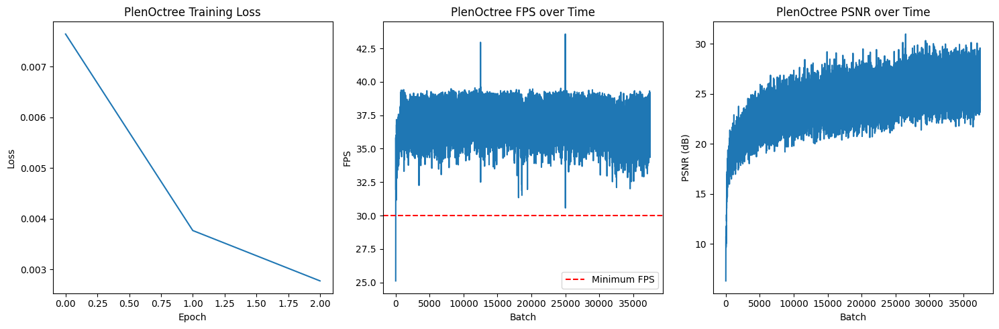

PlenOctree Training Progress:  30%|███       | 37503/125000 [37:15<4:38:38,  5.23it/s]


PlenOctree Epoch 4/10, Batch 0:
FPS: 40.43, Latency: 24.73ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  30%|███       | 37513/125000 [37:16<1:57:43, 12.39it/s]


PlenOctree Epoch 4/10, Batch 10:
FPS: 37.87, Latency: 26.41ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  30%|███       | 37523/125000 [37:17<1:32:04, 15.83it/s]


PlenOctree Epoch 4/10, Batch 20:
FPS: 37.93, Latency: 26.37ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37533/125000 [37:17<1:27:53, 16.58it/s]


PlenOctree Epoch 4/10, Batch 30:
FPS: 37.39, Latency: 26.75ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  30%|███       | 37543/125000 [37:18<1:26:10, 16.92it/s]


PlenOctree Epoch 4/10, Batch 40:
FPS: 37.42, Latency: 26.72ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  30%|███       | 37553/125000 [37:18<1:25:42, 17.00it/s]


PlenOctree Epoch 4/10, Batch 50:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  30%|███       | 37563/125000 [37:19<1:25:37, 17.02it/s]


PlenOctree Epoch 4/10, Batch 60:
FPS: 37.54, Latency: 26.64ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  30%|███       | 37573/125000 [37:20<1:26:30, 16.84it/s]


PlenOctree Epoch 4/10, Batch 70:
FPS: 37.28, Latency: 26.82ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  30%|███       | 37583/125000 [37:20<1:26:05, 16.92it/s]


PlenOctree Epoch 4/10, Batch 80:
FPS: 37.50, Latency: 26.66ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  30%|███       | 37593/125000 [37:21<1:26:35, 16.82it/s]


PlenOctree Epoch 4/10, Batch 90:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  30%|███       | 37603/125000 [37:21<1:25:55, 16.95it/s]


PlenOctree Epoch 4/10, Batch 100:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  30%|███       | 37613/125000 [37:22<1:25:36, 17.01it/s]


PlenOctree Epoch 4/10, Batch 110:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  30%|███       | 37623/125000 [37:23<1:25:23, 17.05it/s]


PlenOctree Epoch 4/10, Batch 120:
FPS: 38.34, Latency: 26.08ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  30%|███       | 37633/125000 [37:23<1:26:12, 16.89it/s]


PlenOctree Epoch 4/10, Batch 130:
FPS: 37.42, Latency: 26.73ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  30%|███       | 37643/125000 [37:24<1:25:53, 16.95it/s]


PlenOctree Epoch 4/10, Batch 140:
FPS: 38.01, Latency: 26.31ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  30%|███       | 37653/125000 [37:24<1:26:30, 16.83it/s]


PlenOctree Epoch 4/10, Batch 150:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37663/125000 [37:25<1:26:30, 16.83it/s]


PlenOctree Epoch 4/10, Batch 160:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  30%|███       | 37673/125000 [37:26<1:26:59, 16.73it/s]


PlenOctree Epoch 4/10, Batch 170:
FPS: 37.95, Latency: 26.35ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  30%|███       | 37683/125000 [37:26<1:27:09, 16.70it/s]


PlenOctree Epoch 4/10, Batch 180:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37693/125000 [37:27<1:25:45, 16.97it/s]


PlenOctree Epoch 4/10, Batch 190:
FPS: 36.87, Latency: 27.12ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  30%|███       | 37703/125000 [37:27<1:26:09, 16.89it/s]


PlenOctree Epoch 4/10, Batch 200:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37713/125000 [37:28<1:26:46, 16.77it/s]


PlenOctree Epoch 4/10, Batch 210:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  30%|███       | 37723/125000 [37:28<1:26:12, 16.87it/s]


PlenOctree Epoch 4/10, Batch 220:
FPS: 37.14, Latency: 26.92ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  30%|███       | 37733/125000 [37:29<1:25:58, 16.92it/s]


PlenOctree Epoch 4/10, Batch 230:
FPS: 37.50, Latency: 26.66ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  30%|███       | 37743/125000 [37:30<1:25:45, 16.96it/s]


PlenOctree Epoch 4/10, Batch 240:
FPS: 37.26, Latency: 26.84ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  30%|███       | 37753/125000 [37:30<1:26:10, 16.88it/s]


PlenOctree Epoch 4/10, Batch 250:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  30%|███       | 37763/125000 [37:31<1:27:01, 16.71it/s]


PlenOctree Epoch 4/10, Batch 260:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  30%|███       | 37773/125000 [37:31<1:25:28, 17.01it/s]


PlenOctree Epoch 4/10, Batch 270:
FPS: 37.97, Latency: 26.33ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  30%|███       | 37783/125000 [37:32<1:25:41, 16.96it/s]


PlenOctree Epoch 4/10, Batch 280:
FPS: 37.66, Latency: 26.55ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:  30%|███       | 37793/125000 [37:33<1:25:21, 17.03it/s]


PlenOctree Epoch 4/10, Batch 290:
FPS: 37.59, Latency: 26.61ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  30%|███       | 37803/125000 [37:33<1:27:15, 16.66it/s]


PlenOctree Epoch 4/10, Batch 300:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  30%|███       | 37813/125000 [37:34<1:25:48, 16.93it/s]


PlenOctree Epoch 4/10, Batch 310:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  30%|███       | 37823/125000 [37:34<1:25:32, 16.99it/s]


PlenOctree Epoch 4/10, Batch 320:
FPS: 38.36, Latency: 26.07ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37833/125000 [37:35<1:25:12, 17.05it/s]


PlenOctree Epoch 4/10, Batch 330:
FPS: 37.45, Latency: 26.71ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  30%|███       | 37843/125000 [37:36<1:25:14, 17.04it/s]


PlenOctree Epoch 4/10, Batch 340:
FPS: 38.84, Latency: 25.74ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  30%|███       | 37853/125000 [37:36<1:25:59, 16.89it/s]


PlenOctree Epoch 4/10, Batch 350:
FPS: 38.01, Latency: 26.31ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  30%|███       | 37863/125000 [37:37<1:26:30, 16.79it/s]


PlenOctree Epoch 4/10, Batch 360:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  30%|███       | 37873/125000 [37:37<1:26:44, 16.74it/s]


PlenOctree Epoch 4/10, Batch 370:
FPS: 35.98, Latency: 27.80ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  30%|███       | 37883/125000 [37:38<1:26:33, 16.77it/s]


PlenOctree Epoch 4/10, Batch 380:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  30%|███       | 37893/125000 [37:39<1:26:57, 16.69it/s]


PlenOctree Epoch 4/10, Batch 390:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  30%|███       | 37903/125000 [37:39<1:27:21, 16.62it/s]


PlenOctree Epoch 4/10, Batch 400:
FPS: 36.99, Latency: 27.04ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  30%|███       | 37913/125000 [37:40<1:26:51, 16.71it/s]


PlenOctree Epoch 4/10, Batch 410:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37923/125000 [37:40<1:27:13, 16.64it/s]


PlenOctree Epoch 4/10, Batch 420:
FPS: 35.87, Latency: 27.88ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  30%|███       | 37933/125000 [37:41<1:26:07, 16.85it/s]


PlenOctree Epoch 4/10, Batch 430:
FPS: 34.59, Latency: 28.91ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  30%|███       | 37943/125000 [37:42<1:25:52, 16.90it/s]


PlenOctree Epoch 4/10, Batch 440:
FPS: 38.49, Latency: 25.98ms
PSNR: 24.88dB, Loss: 0.0032


PlenOctree Training Progress:  30%|███       | 37953/125000 [37:42<1:26:11, 16.83it/s]


PlenOctree Epoch 4/10, Batch 450:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37963/125000 [37:43<1:25:32, 16.96it/s]


PlenOctree Epoch 4/10, Batch 460:
FPS: 36.41, Latency: 27.47ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  30%|███       | 37973/125000 [37:43<1:25:44, 16.92it/s]


PlenOctree Epoch 4/10, Batch 470:
FPS: 37.53, Latency: 26.64ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  30%|███       | 37983/125000 [37:44<1:25:18, 17.00it/s]


PlenOctree Epoch 4/10, Batch 480:
FPS: 37.77, Latency: 26.47ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 37993/125000 [37:45<1:25:11, 17.02it/s]


PlenOctree Epoch 4/10, Batch 490:
FPS: 37.71, Latency: 26.52ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  30%|███       | 38003/125000 [37:45<1:26:29, 16.76it/s]


PlenOctree Epoch 4/10, Batch 500:
FPS: 39.15, Latency: 25.54ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  30%|███       | 38013/125000 [37:46<1:25:57, 16.87it/s]


PlenOctree Epoch 4/10, Batch 510:
FPS: 38.09, Latency: 26.25ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  30%|███       | 38023/125000 [37:46<1:26:38, 16.73it/s]


PlenOctree Epoch 4/10, Batch 520:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 38033/125000 [37:47<1:26:12, 16.81it/s]


PlenOctree Epoch 4/10, Batch 530:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  30%|███       | 38043/125000 [37:47<1:25:14, 17.00it/s]


PlenOctree Epoch 4/10, Batch 540:
FPS: 38.59, Latency: 25.91ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  30%|███       | 38053/125000 [37:48<1:25:50, 16.88it/s]


PlenOctree Epoch 4/10, Batch 550:
FPS: 38.06, Latency: 26.27ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  30%|███       | 38063/125000 [37:49<1:25:44, 16.90it/s]


PlenOctree Epoch 4/10, Batch 560:
FPS: 38.44, Latency: 26.01ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  30%|███       | 38073/125000 [37:49<1:26:13, 16.80it/s]


PlenOctree Epoch 4/10, Batch 570:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  30%|███       | 38083/125000 [37:50<1:26:02, 16.84it/s]


PlenOctree Epoch 4/10, Batch 580:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  30%|███       | 38093/125000 [37:50<1:26:48, 16.68it/s]


PlenOctree Epoch 4/10, Batch 590:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  30%|███       | 38103/125000 [37:51<1:27:27, 16.56it/s]


PlenOctree Epoch 4/10, Batch 600:
FPS: 37.95, Latency: 26.35ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  30%|███       | 38113/125000 [37:52<1:25:47, 16.88it/s]


PlenOctree Epoch 4/10, Batch 610:
FPS: 37.73, Latency: 26.50ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  30%|███       | 38123/125000 [37:52<1:28:42, 16.32it/s]


PlenOctree Epoch 4/10, Batch 620:
FPS: 31.30, Latency: 31.95ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  31%|███       | 38133/125000 [37:53<1:27:17, 16.59it/s]


PlenOctree Epoch 4/10, Batch 630:
FPS: 33.36, Latency: 29.98ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38143/125000 [37:53<1:26:50, 16.67it/s]


PlenOctree Epoch 4/10, Batch 640:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38153/125000 [37:54<1:25:59, 16.83it/s]


PlenOctree Epoch 4/10, Batch 650:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  31%|███       | 38163/125000 [37:55<1:25:16, 16.97it/s]


PlenOctree Epoch 4/10, Batch 660:
FPS: 37.42, Latency: 26.72ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38173/125000 [37:55<1:25:06, 17.00it/s]


PlenOctree Epoch 4/10, Batch 670:
FPS: 37.26, Latency: 26.84ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  31%|███       | 38183/125000 [37:56<1:26:03, 16.82it/s]


PlenOctree Epoch 4/10, Batch 680:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38193/125000 [37:56<1:26:02, 16.81it/s]


PlenOctree Epoch 4/10, Batch 690:
FPS: 37.83, Latency: 26.44ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38203/125000 [37:57<1:25:42, 16.88it/s]


PlenOctree Epoch 4/10, Batch 700:
FPS: 37.22, Latency: 26.87ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  31%|███       | 38213/125000 [37:58<1:25:45, 16.87it/s]


PlenOctree Epoch 4/10, Batch 710:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38223/125000 [37:58<1:26:05, 16.80it/s]


PlenOctree Epoch 4/10, Batch 720:
FPS: 38.72, Latency: 25.83ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  31%|███       | 38233/125000 [37:59<1:25:22, 16.94it/s]


PlenOctree Epoch 4/10, Batch 730:
FPS: 36.72, Latency: 27.24ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  31%|███       | 38243/125000 [37:59<1:26:30, 16.71it/s]


PlenOctree Epoch 4/10, Batch 740:
FPS: 38.52, Latency: 25.96ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███       | 38253/125000 [38:00<1:26:11, 16.78it/s]


PlenOctree Epoch 4/10, Batch 750:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███       | 38263/125000 [38:01<1:26:17, 16.75it/s]


PlenOctree Epoch 4/10, Batch 760:
FPS: 37.98, Latency: 26.33ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  31%|███       | 38273/125000 [38:01<1:26:38, 16.68it/s]


PlenOctree Epoch 4/10, Batch 770:
FPS: 36.60, Latency: 27.32ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  31%|███       | 38283/125000 [38:02<1:27:02, 16.61it/s]


PlenOctree Epoch 4/10, Batch 780:
FPS: 36.25, Latency: 27.58ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38293/125000 [38:02<1:26:05, 16.79it/s]


PlenOctree Epoch 4/10, Batch 790:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38303/125000 [38:03<1:27:14, 16.56it/s]


PlenOctree Epoch 4/10, Batch 800:
FPS: 36.52, Latency: 27.39ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  31%|███       | 38313/125000 [38:04<1:25:31, 16.89it/s]


PlenOctree Epoch 4/10, Batch 810:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38323/125000 [38:04<1:26:50, 16.63it/s]


PlenOctree Epoch 4/10, Batch 820:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  31%|███       | 38333/125000 [38:05<1:26:46, 16.65it/s]


PlenOctree Epoch 4/10, Batch 830:
FPS: 37.26, Latency: 26.84ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38343/125000 [38:05<1:26:00, 16.79it/s]


PlenOctree Epoch 4/10, Batch 840:
FPS: 37.28, Latency: 26.83ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  31%|███       | 38353/125000 [38:06<1:26:27, 16.70it/s]


PlenOctree Epoch 4/10, Batch 850:
FPS: 37.38, Latency: 26.75ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███       | 38363/125000 [38:07<1:26:23, 16.71it/s]


PlenOctree Epoch 4/10, Batch 860:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38373/125000 [38:07<1:26:56, 16.61it/s]


PlenOctree Epoch 4/10, Batch 870:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███       | 38383/125000 [38:08<1:25:40, 16.85it/s]


PlenOctree Epoch 4/10, Batch 880:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  31%|███       | 38393/125000 [38:08<1:27:09, 16.56it/s]


PlenOctree Epoch 4/10, Batch 890:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38403/125000 [38:09<1:26:57, 16.60it/s]


PlenOctree Epoch 4/10, Batch 900:
FPS: 37.52, Latency: 26.65ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:  31%|███       | 38413/125000 [38:10<1:25:54, 16.80it/s]


PlenOctree Epoch 4/10, Batch 910:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  31%|███       | 38423/125000 [38:10<1:25:28, 16.88it/s]


PlenOctree Epoch 4/10, Batch 920:
FPS: 36.92, Latency: 27.09ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  31%|███       | 38433/125000 [38:11<1:26:32, 16.67it/s]


PlenOctree Epoch 4/10, Batch 930:
FPS: 35.84, Latency: 27.90ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  31%|███       | 38443/125000 [38:11<1:26:09, 16.74it/s]


PlenOctree Epoch 4/10, Batch 940:
FPS: 38.27, Latency: 26.13ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38453/125000 [38:12<1:26:05, 16.75it/s]


PlenOctree Epoch 4/10, Batch 950:
FPS: 38.27, Latency: 26.13ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███       | 38463/125000 [38:13<1:25:30, 16.87it/s]


PlenOctree Epoch 4/10, Batch 960:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  31%|███       | 38473/125000 [38:13<1:25:59, 16.77it/s]


PlenOctree Epoch 4/10, Batch 970:
FPS: 36.45, Latency: 27.43ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███       | 38483/125000 [38:14<1:26:30, 16.67it/s]


PlenOctree Epoch 4/10, Batch 980:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  31%|███       | 38493/125000 [38:14<1:26:04, 16.75it/s]


PlenOctree Epoch 4/10, Batch 990:
FPS: 38.02, Latency: 26.30ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  31%|███       | 38503/125000 [38:15<1:26:31, 16.66it/s]


PlenOctree Epoch 4/10, Batch 1000:
FPS: 36.93, Latency: 27.08ms
PSNR: 22.70dB, Loss: 0.0054


PlenOctree Training Progress:  31%|███       | 38513/125000 [38:16<1:25:38, 16.83it/s]


PlenOctree Epoch 4/10, Batch 1010:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███       | 38523/125000 [38:16<1:26:24, 16.68it/s]


PlenOctree Epoch 4/10, Batch 1020:
FPS: 35.72, Latency: 28.00ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  31%|███       | 38533/125000 [38:17<1:26:22, 16.69it/s]


PlenOctree Epoch 4/10, Batch 1030:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  31%|███       | 38543/125000 [38:17<1:26:10, 16.72it/s]


PlenOctree Epoch 4/10, Batch 1040:
FPS: 36.85, Latency: 27.14ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38553/125000 [38:18<1:26:36, 16.64it/s]


PlenOctree Epoch 4/10, Batch 1050:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38563/125000 [38:19<1:25:51, 16.78it/s]


PlenOctree Epoch 4/10, Batch 1060:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███       | 38573/125000 [38:19<1:26:28, 16.66it/s]


PlenOctree Epoch 4/10, Batch 1070:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  31%|███       | 38583/125000 [38:20<1:25:55, 16.76it/s]


PlenOctree Epoch 4/10, Batch 1080:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███       | 38593/125000 [38:20<1:26:08, 16.72it/s]


PlenOctree Epoch 4/10, Batch 1090:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38603/125000 [38:21<1:25:57, 16.75it/s]


PlenOctree Epoch 4/10, Batch 1100:
FPS: 36.22, Latency: 27.61ms
PSNR: 23.27dB, Loss: 0.0047


PlenOctree Training Progress:  31%|███       | 38613/125000 [38:22<1:26:17, 16.68it/s]


PlenOctree Epoch 4/10, Batch 1110:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38623/125000 [38:22<1:25:38, 16.81it/s]


PlenOctree Epoch 4/10, Batch 1120:
FPS: 37.70, Latency: 26.52ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  31%|███       | 38633/125000 [38:23<1:25:18, 16.87it/s]


PlenOctree Epoch 4/10, Batch 1130:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38643/125000 [38:23<1:26:53, 16.57it/s]


PlenOctree Epoch 4/10, Batch 1140:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38653/125000 [38:24<1:25:43, 16.79it/s]


PlenOctree Epoch 4/10, Batch 1150:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███       | 38663/125000 [38:24<1:26:29, 16.64it/s]


PlenOctree Epoch 4/10, Batch 1160:
FPS: 37.21, Latency: 26.87ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38673/125000 [38:25<1:26:45, 16.59it/s]


PlenOctree Epoch 4/10, Batch 1170:
FPS: 36.08, Latency: 27.71ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  31%|███       | 38683/125000 [38:26<1:25:28, 16.83it/s]


PlenOctree Epoch 4/10, Batch 1180:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38693/125000 [38:26<1:26:49, 16.57it/s]


PlenOctree Epoch 4/10, Batch 1190:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38703/125000 [38:27<1:26:54, 16.55it/s]


PlenOctree Epoch 4/10, Batch 1200:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  31%|███       | 38713/125000 [38:28<1:27:13, 16.49it/s]


PlenOctree Epoch 4/10, Batch 1210:
FPS: 35.53, Latency: 28.15ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38723/125000 [38:28<1:26:17, 16.66it/s]


PlenOctree Epoch 4/10, Batch 1220:
FPS: 37.49, Latency: 26.68ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38733/125000 [38:29<1:26:06, 16.70it/s]


PlenOctree Epoch 4/10, Batch 1230:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  31%|███       | 38743/125000 [38:29<1:26:44, 16.57it/s]


PlenOctree Epoch 4/10, Batch 1240:
FPS: 35.39, Latency: 28.26ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███       | 38753/125000 [38:30<1:26:27, 16.63it/s]


PlenOctree Epoch 4/10, Batch 1250:
FPS: 37.53, Latency: 26.64ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  31%|███       | 38763/125000 [38:31<1:26:08, 16.69it/s]


PlenOctree Epoch 4/10, Batch 1260:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  31%|███       | 38773/125000 [38:31<1:26:37, 16.59it/s]


PlenOctree Epoch 4/10, Batch 1270:
FPS: 36.08, Latency: 27.72ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  31%|███       | 38783/125000 [38:32<1:26:44, 16.56it/s]


PlenOctree Epoch 4/10, Batch 1280:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38793/125000 [38:32<1:25:37, 16.78it/s]


PlenOctree Epoch 4/10, Batch 1290:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  31%|███       | 38803/125000 [38:33<1:26:37, 16.59it/s]


PlenOctree Epoch 4/10, Batch 1300:
FPS: 34.98, Latency: 28.58ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38813/125000 [38:34<1:26:35, 16.59it/s]


PlenOctree Epoch 4/10, Batch 1310:
FPS: 37.70, Latency: 26.53ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  31%|███       | 38823/125000 [38:34<1:25:08, 16.87it/s]


PlenOctree Epoch 4/10, Batch 1320:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  31%|███       | 38833/125000 [38:35<1:24:53, 16.92it/s]


PlenOctree Epoch 4/10, Batch 1330:
FPS: 36.80, Latency: 27.17ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38843/125000 [38:35<1:25:58, 16.70it/s]


PlenOctree Epoch 4/10, Batch 1340:
FPS: 37.22, Latency: 26.87ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38853/125000 [38:36<1:25:36, 16.77it/s]


PlenOctree Epoch 4/10, Batch 1350:
FPS: 36.30, Latency: 27.54ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  31%|███       | 38863/125000 [38:36<1:24:29, 16.99it/s]


PlenOctree Epoch 4/10, Batch 1360:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  31%|███       | 38873/125000 [38:37<1:27:07, 16.48it/s]


PlenOctree Epoch 4/10, Batch 1370:
FPS: 35.33, Latency: 28.30ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  31%|███       | 38883/125000 [38:38<1:26:15, 16.64it/s]


PlenOctree Epoch 4/10, Batch 1380:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  31%|███       | 38893/125000 [38:38<1:25:38, 16.76it/s]


PlenOctree Epoch 4/10, Batch 1390:
FPS: 36.87, Latency: 27.12ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38903/125000 [38:39<1:26:49, 16.53it/s]


PlenOctree Epoch 4/10, Batch 1400:
FPS: 35.23, Latency: 28.39ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███       | 38913/125000 [38:39<1:27:02, 16.48it/s]


PlenOctree Epoch 4/10, Batch 1410:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38923/125000 [38:40<1:26:49, 16.52it/s]


PlenOctree Epoch 4/10, Batch 1420:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███       | 38933/125000 [38:41<1:25:43, 16.73it/s]


PlenOctree Epoch 4/10, Batch 1430:
FPS: 35.46, Latency: 28.20ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███       | 38943/125000 [38:41<1:26:13, 16.63it/s]


PlenOctree Epoch 4/10, Batch 1440:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███       | 38953/125000 [38:42<1:24:37, 16.95it/s]


PlenOctree Epoch 4/10, Batch 1450:
FPS: 38.59, Latency: 25.91ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  31%|███       | 38963/125000 [38:42<1:24:19, 17.01it/s]


PlenOctree Epoch 4/10, Batch 1460:
FPS: 37.91, Latency: 26.38ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███       | 38973/125000 [38:43<1:23:57, 17.08it/s]


PlenOctree Epoch 4/10, Batch 1470:
FPS: 38.62, Latency: 25.89ms
PSNR: 25.77dB, Loss: 0.0027


PlenOctree Training Progress:  31%|███       | 38983/125000 [38:44<1:25:01, 16.86it/s]


PlenOctree Epoch 4/10, Batch 1480:
FPS: 38.58, Latency: 25.92ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  31%|███       | 38993/125000 [38:44<1:25:23, 16.79it/s]


PlenOctree Epoch 4/10, Batch 1490:
FPS: 37.75, Latency: 26.49ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  31%|███       | 39003/125000 [38:45<1:24:45, 16.91it/s]


PlenOctree Epoch 4/10, Batch 1500:
FPS: 37.85, Latency: 26.42ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  31%|███       | 39013/125000 [38:45<1:25:04, 16.85it/s]


PlenOctree Epoch 4/10, Batch 1510:
FPS: 37.25, Latency: 26.85ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███       | 39023/125000 [38:46<1:24:24, 16.98it/s]


PlenOctree Epoch 4/10, Batch 1520:
FPS: 37.07, Latency: 26.98ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███       | 39033/125000 [38:47<1:25:23, 16.78it/s]


PlenOctree Epoch 4/10, Batch 1530:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  31%|███       | 39043/125000 [38:47<1:24:50, 16.88it/s]


PlenOctree Epoch 4/10, Batch 1540:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  31%|███       | 39053/125000 [38:48<1:25:15, 16.80it/s]


PlenOctree Epoch 4/10, Batch 1550:
FPS: 36.44, Latency: 27.44ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  31%|███▏      | 39063/125000 [38:48<1:24:24, 16.97it/s]


PlenOctree Epoch 4/10, Batch 1560:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███▏      | 39073/125000 [38:49<1:24:04, 17.03it/s]


PlenOctree Epoch 4/10, Batch 1570:
FPS: 37.94, Latency: 26.36ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  31%|███▏      | 39083/125000 [38:50<1:24:05, 17.03it/s]


PlenOctree Epoch 4/10, Batch 1580:
FPS: 38.14, Latency: 26.22ms
PSNR: 23.56dB, Loss: 0.0044


PlenOctree Training Progress:  31%|███▏      | 39093/125000 [38:50<1:25:06, 16.82it/s]


PlenOctree Epoch 4/10, Batch 1590:
FPS: 36.73, Latency: 27.22ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███▏      | 39103/125000 [38:51<1:25:34, 16.73it/s]


PlenOctree Epoch 4/10, Batch 1600:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███▏      | 39113/125000 [38:51<1:26:06, 16.62it/s]


PlenOctree Epoch 4/10, Batch 1610:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███▏      | 39123/125000 [38:52<1:25:34, 16.73it/s]


PlenOctree Epoch 4/10, Batch 1620:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███▏      | 39133/125000 [38:53<1:26:20, 16.58it/s]


PlenOctree Epoch 4/10, Batch 1630:
FPS: 37.03, Latency: 27.00ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  31%|███▏      | 39143/125000 [38:53<1:24:37, 16.91it/s]


PlenOctree Epoch 4/10, Batch 1640:
FPS: 38.25, Latency: 26.14ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  31%|███▏      | 39153/125000 [38:54<1:24:27, 16.94it/s]


PlenOctree Epoch 4/10, Batch 1650:
FPS: 37.96, Latency: 26.34ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███▏      | 39163/125000 [38:54<1:24:00, 17.03it/s]


PlenOctree Epoch 4/10, Batch 1660:
FPS: 36.81, Latency: 27.16ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███▏      | 39173/125000 [38:55<1:24:32, 16.92it/s]


PlenOctree Epoch 4/10, Batch 1670:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███▏      | 39183/125000 [38:56<1:25:32, 16.72it/s]


PlenOctree Epoch 4/10, Batch 1680:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  31%|███▏      | 39193/125000 [38:56<1:23:52, 17.05it/s]


PlenOctree Epoch 4/10, Batch 1690:
FPS: 37.76, Latency: 26.48ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  31%|███▏      | 39203/125000 [38:57<1:24:20, 16.95it/s]


PlenOctree Epoch 4/10, Batch 1700:
FPS: 38.11, Latency: 26.24ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  31%|███▏      | 39213/125000 [38:57<1:24:38, 16.89it/s]


PlenOctree Epoch 4/10, Batch 1710:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  31%|███▏      | 39223/125000 [38:58<1:25:13, 16.77it/s]


PlenOctree Epoch 4/10, Batch 1720:
FPS: 37.82, Latency: 26.44ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  31%|███▏      | 39233/125000 [38:58<1:24:45, 16.87it/s]


PlenOctree Epoch 4/10, Batch 1730:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███▏      | 39243/125000 [38:59<1:25:40, 16.68it/s]


PlenOctree Epoch 4/10, Batch 1740:
FPS: 37.48, Latency: 26.68ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███▏      | 39253/125000 [39:00<1:24:51, 16.84it/s]


PlenOctree Epoch 4/10, Batch 1750:
FPS: 37.28, Latency: 26.82ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  31%|███▏      | 39263/125000 [39:00<1:24:16, 16.96it/s]


PlenOctree Epoch 4/10, Batch 1760:
FPS: 38.22, Latency: 26.16ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  31%|███▏      | 39273/125000 [39:01<1:23:46, 17.05it/s]


PlenOctree Epoch 4/10, Batch 1770:
FPS: 37.18, Latency: 26.90ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  31%|███▏      | 39283/125000 [39:01<1:23:52, 17.03it/s]


PlenOctree Epoch 4/10, Batch 1780:
FPS: 38.69, Latency: 25.85ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  31%|███▏      | 39293/125000 [39:02<1:25:35, 16.69it/s]


PlenOctree Epoch 4/10, Batch 1790:
FPS: 37.84, Latency: 26.43ms
PSNR: 29.75dB, Loss: 0.0011


PlenOctree Training Progress:  31%|███▏      | 39303/125000 [39:03<1:24:09, 16.97it/s]


PlenOctree Epoch 4/10, Batch 1800:
FPS: 36.88, Latency: 27.12ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  31%|███▏      | 39313/125000 [39:03<1:26:13, 16.56it/s]


PlenOctree Epoch 4/10, Batch 1810:
FPS: 36.25, Latency: 27.58ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  31%|███▏      | 39323/125000 [39:04<1:25:45, 16.65it/s]


PlenOctree Epoch 4/10, Batch 1820:
FPS: 36.77, Latency: 27.19ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  31%|███▏      | 39333/125000 [39:04<1:24:29, 16.90it/s]


PlenOctree Epoch 4/10, Batch 1830:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  31%|███▏      | 39343/125000 [39:05<1:24:45, 16.84it/s]


PlenOctree Epoch 4/10, Batch 1840:
FPS: 38.25, Latency: 26.14ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  31%|███▏      | 39353/125000 [39:06<1:24:34, 16.88it/s]


PlenOctree Epoch 4/10, Batch 1850:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  31%|███▏      | 39363/125000 [39:06<1:24:39, 16.86it/s]


PlenOctree Epoch 4/10, Batch 1860:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  31%|███▏      | 39373/125000 [39:07<1:24:06, 16.97it/s]


PlenOctree Epoch 4/10, Batch 1870:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 39383/125000 [39:07<1:24:27, 16.90it/s]


PlenOctree Epoch 4/10, Batch 1880:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  32%|███▏      | 39393/125000 [39:08<1:25:21, 16.72it/s]


PlenOctree Epoch 4/10, Batch 1890:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  32%|███▏      | 39403/125000 [39:09<1:24:01, 16.98it/s]


PlenOctree Epoch 4/10, Batch 1900:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 39413/125000 [39:09<1:24:31, 16.87it/s]


PlenOctree Epoch 4/10, Batch 1910:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 39423/125000 [39:10<1:24:45, 16.83it/s]


PlenOctree Epoch 4/10, Batch 1920:
FPS: 37.42, Latency: 26.73ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  32%|███▏      | 39433/125000 [39:10<1:24:39, 16.84it/s]


PlenOctree Epoch 4/10, Batch 1930:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 39443/125000 [39:11<1:23:57, 16.98it/s]


PlenOctree Epoch 4/10, Batch 1940:
FPS: 36.81, Latency: 27.16ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  32%|███▏      | 39453/125000 [39:12<1:24:55, 16.79it/s]


PlenOctree Epoch 4/10, Batch 1950:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  32%|███▏      | 39463/125000 [39:12<1:24:48, 16.81it/s]


PlenOctree Epoch 4/10, Batch 1960:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 39473/125000 [39:13<1:24:15, 16.92it/s]


PlenOctree Epoch 4/10, Batch 1970:
FPS: 36.76, Latency: 27.20ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  32%|███▏      | 39483/125000 [39:13<1:24:08, 16.94it/s]


PlenOctree Epoch 4/10, Batch 1980:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 39493/125000 [39:14<1:23:52, 16.99it/s]


PlenOctree Epoch 4/10, Batch 1990:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  32%|███▏      | 39503/125000 [39:15<1:25:27, 16.68it/s]


PlenOctree Epoch 4/10, Batch 2000:
FPS: 36.10, Latency: 27.70ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  32%|███▏      | 39513/125000 [39:15<1:24:20, 16.89it/s]


PlenOctree Epoch 4/10, Batch 2010:
FPS: 35.71, Latency: 28.00ms
PSNR: 24.33dB, Loss: 0.0037


PlenOctree Training Progress:  32%|███▏      | 39523/125000 [39:16<1:26:01, 16.56it/s]


PlenOctree Epoch 4/10, Batch 2020:
FPS: 34.17, Latency: 29.26ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 39533/125000 [39:16<1:25:52, 16.59it/s]


PlenOctree Epoch 4/10, Batch 2030:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  32%|███▏      | 39543/125000 [39:17<1:24:12, 16.91it/s]


PlenOctree Epoch 4/10, Batch 2040:
FPS: 38.35, Latency: 26.08ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:  32%|███▏      | 39553/125000 [39:18<1:23:57, 16.96it/s]


PlenOctree Epoch 4/10, Batch 2050:
FPS: 37.59, Latency: 26.60ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  32%|███▏      | 39563/125000 [39:18<1:25:08, 16.72it/s]


PlenOctree Epoch 4/10, Batch 2060:
FPS: 38.28, Latency: 26.12ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  32%|███▏      | 39573/125000 [39:19<1:24:45, 16.80it/s]


PlenOctree Epoch 4/10, Batch 2070:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 39583/125000 [39:19<1:24:09, 16.92it/s]


PlenOctree Epoch 4/10, Batch 2080:
FPS: 37.53, Latency: 26.65ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 39593/125000 [39:20<1:24:50, 16.78it/s]


PlenOctree Epoch 4/10, Batch 2090:
FPS: 38.81, Latency: 25.77ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  32%|███▏      | 39603/125000 [39:20<1:24:32, 16.83it/s]


PlenOctree Epoch 4/10, Batch 2100:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 39613/125000 [39:21<1:24:22, 16.87it/s]


PlenOctree Epoch 4/10, Batch 2110:
FPS: 37.02, Latency: 27.01ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 39623/125000 [39:22<1:24:11, 16.90it/s]


PlenOctree Epoch 4/10, Batch 2120:
FPS: 37.82, Latency: 26.44ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 39633/125000 [39:22<1:24:18, 16.87it/s]


PlenOctree Epoch 4/10, Batch 2130:
FPS: 37.76, Latency: 26.48ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  32%|███▏      | 39643/125000 [39:23<1:24:48, 16.78it/s]


PlenOctree Epoch 4/10, Batch 2140:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  32%|███▏      | 39653/125000 [39:23<1:23:39, 17.00it/s]


PlenOctree Epoch 4/10, Batch 2150:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  32%|███▏      | 39663/125000 [39:24<1:23:46, 16.98it/s]


PlenOctree Epoch 4/10, Batch 2160:
FPS: 38.97, Latency: 25.66ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  32%|███▏      | 39673/125000 [39:25<1:24:06, 16.91it/s]


PlenOctree Epoch 4/10, Batch 2170:
FPS: 37.81, Latency: 26.45ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  32%|███▏      | 39683/125000 [39:25<1:24:36, 16.81it/s]


PlenOctree Epoch 4/10, Batch 2180:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  32%|███▏      | 39693/125000 [39:26<1:24:14, 16.88it/s]


PlenOctree Epoch 4/10, Batch 2190:
FPS: 36.65, Latency: 27.29ms
PSNR: 29.49dB, Loss: 0.0011


PlenOctree Training Progress:  32%|███▏      | 39703/125000 [39:26<1:25:11, 16.69it/s]


PlenOctree Epoch 4/10, Batch 2200:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  32%|███▏      | 39713/125000 [39:27<1:25:14, 16.67it/s]


PlenOctree Epoch 4/10, Batch 2210:
FPS: 36.05, Latency: 27.74ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  32%|███▏      | 39723/125000 [39:28<1:25:42, 16.58it/s]


PlenOctree Epoch 4/10, Batch 2220:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 39733/125000 [39:28<1:24:18, 16.85it/s]


PlenOctree Epoch 4/10, Batch 2230:
FPS: 37.47, Latency: 26.69ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 39743/125000 [39:29<1:24:52, 16.74it/s]


PlenOctree Epoch 4/10, Batch 2240:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 39753/125000 [39:29<1:24:07, 16.89it/s]


PlenOctree Epoch 4/10, Batch 2250:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  32%|███▏      | 39763/125000 [39:30<1:25:34, 16.60it/s]


PlenOctree Epoch 4/10, Batch 2260:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  32%|███▏      | 39773/125000 [39:31<1:23:58, 16.92it/s]


PlenOctree Epoch 4/10, Batch 2270:
FPS: 37.56, Latency: 26.63ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  32%|███▏      | 39783/125000 [39:31<1:24:59, 16.71it/s]


PlenOctree Epoch 4/10, Batch 2280:
FPS: 37.80, Latency: 26.46ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  32%|███▏      | 39793/125000 [39:32<1:24:17, 16.85it/s]


PlenOctree Epoch 4/10, Batch 2290:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 39803/125000 [39:32<1:24:01, 16.90it/s]


PlenOctree Epoch 4/10, Batch 2300:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  32%|███▏      | 39813/125000 [39:33<1:23:26, 17.01it/s]


PlenOctree Epoch 4/10, Batch 2310:
FPS: 37.55, Latency: 26.63ms
PSNR: 24.24dB, Loss: 0.0038


PlenOctree Training Progress:  32%|███▏      | 39823/125000 [39:34<1:23:23, 17.02it/s]


PlenOctree Epoch 4/10, Batch 2320:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 39833/125000 [39:34<1:24:33, 16.79it/s]


PlenOctree Epoch 4/10, Batch 2330:
FPS: 37.35, Latency: 26.77ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 39843/125000 [39:35<1:23:59, 16.90it/s]


PlenOctree Epoch 4/10, Batch 2340:
FPS: 37.27, Latency: 26.83ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  32%|███▏      | 39853/125000 [39:35<1:24:12, 16.85it/s]


PlenOctree Epoch 4/10, Batch 2350:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 39863/125000 [39:36<1:23:13, 17.05it/s]


PlenOctree Epoch 4/10, Batch 2360:
FPS: 37.33, Latency: 26.79ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  32%|███▏      | 39873/125000 [39:37<1:24:40, 16.76it/s]


PlenOctree Epoch 4/10, Batch 2370:
FPS: 37.89, Latency: 26.39ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 39883/125000 [39:37<1:24:15, 16.84it/s]


PlenOctree Epoch 4/10, Batch 2380:
FPS: 37.66, Latency: 26.56ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 39893/125000 [39:38<1:24:10, 16.85it/s]


PlenOctree Epoch 4/10, Batch 2390:
FPS: 36.47, Latency: 27.42ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  32%|███▏      | 39903/125000 [39:38<1:24:09, 16.85it/s]


PlenOctree Epoch 4/10, Batch 2400:
FPS: 37.45, Latency: 26.70ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 39913/125000 [39:39<1:24:30, 16.78it/s]


PlenOctree Epoch 4/10, Batch 2410:
FPS: 37.84, Latency: 26.43ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  32%|███▏      | 39923/125000 [39:39<1:24:01, 16.87it/s]


PlenOctree Epoch 4/10, Batch 2420:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 39933/125000 [39:40<1:25:40, 16.55it/s]


PlenOctree Epoch 4/10, Batch 2430:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  32%|███▏      | 39943/125000 [39:41<1:23:21, 17.01it/s]


PlenOctree Epoch 4/10, Batch 2440:
FPS: 37.30, Latency: 26.81ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 39953/125000 [39:41<1:23:50, 16.91it/s]


PlenOctree Epoch 4/10, Batch 2450:
FPS: 38.08, Latency: 26.26ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  32%|███▏      | 39963/125000 [39:42<1:23:43, 16.93it/s]


PlenOctree Epoch 4/10, Batch 2460:
FPS: 37.66, Latency: 26.56ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 39973/125000 [39:42<1:24:22, 16.80it/s]


PlenOctree Epoch 4/10, Batch 2470:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 39983/125000 [39:43<1:24:25, 16.78it/s]


PlenOctree Epoch 4/10, Batch 2480:
FPS: 35.34, Latency: 28.29ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 39993/125000 [39:44<1:23:29, 16.97it/s]


PlenOctree Epoch 4/10, Batch 2490:
FPS: 37.95, Latency: 26.35ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 40003/125000 [39:44<1:23:09, 17.03it/s]


PlenOctree Epoch 4/10, Batch 2500:
FPS: 37.56, Latency: 26.63ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  32%|███▏      | 40013/125000 [39:45<1:24:43, 16.72it/s]


PlenOctree Epoch 4/10, Batch 2510:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  32%|███▏      | 40023/125000 [39:45<1:24:29, 16.76it/s]


PlenOctree Epoch 4/10, Batch 2520:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 40033/125000 [39:46<1:23:21, 16.99it/s]


PlenOctree Epoch 4/10, Batch 2530:
FPS: 37.90, Latency: 26.38ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  32%|███▏      | 40043/125000 [39:47<1:23:13, 17.01it/s]


PlenOctree Epoch 4/10, Batch 2540:
FPS: 38.35, Latency: 26.07ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 40053/125000 [39:47<1:23:20, 16.99it/s]


PlenOctree Epoch 4/10, Batch 2550:
FPS: 38.25, Latency: 26.14ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  32%|███▏      | 40063/125000 [39:48<1:24:35, 16.73it/s]


PlenOctree Epoch 4/10, Batch 2560:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  32%|███▏      | 40073/125000 [39:48<1:23:54, 16.87it/s]


PlenOctree Epoch 4/10, Batch 2570:
FPS: 37.33, Latency: 26.79ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 40083/125000 [39:49<1:23:18, 16.99it/s]


PlenOctree Epoch 4/10, Batch 2580:
FPS: 36.08, Latency: 27.71ms
PSNR: 22.89dB, Loss: 0.0051


PlenOctree Training Progress:  32%|███▏      | 40093/125000 [39:50<1:23:36, 16.93it/s]


PlenOctree Epoch 4/10, Batch 2590:
FPS: 38.13, Latency: 26.23ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 40103/125000 [39:50<1:24:19, 16.78it/s]


PlenOctree Epoch 4/10, Batch 2600:
FPS: 37.30, Latency: 26.81ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  32%|███▏      | 40113/125000 [39:51<1:24:17, 16.78it/s]


PlenOctree Epoch 4/10, Batch 2610:
FPS: 35.13, Latency: 28.47ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 40123/125000 [39:51<1:25:17, 16.59it/s]


PlenOctree Epoch 4/10, Batch 2620:
FPS: 37.46, Latency: 26.69ms
PSNR: 23.01dB, Loss: 0.0050


PlenOctree Training Progress:  32%|███▏      | 40133/125000 [39:52<1:23:43, 16.89it/s]


PlenOctree Epoch 4/10, Batch 2630:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  32%|███▏      | 40143/125000 [39:53<1:25:04, 16.62it/s]


PlenOctree Epoch 4/10, Batch 2640:
FPS: 37.29, Latency: 26.82ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 40153/125000 [39:53<1:23:23, 16.96it/s]


PlenOctree Epoch 4/10, Batch 2650:
FPS: 38.07, Latency: 26.27ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 40163/125000 [39:54<1:23:39, 16.90it/s]


PlenOctree Epoch 4/10, Batch 2660:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  32%|███▏      | 40173/125000 [39:54<1:22:27, 17.15it/s]


PlenOctree Epoch 4/10, Batch 2670:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 40183/125000 [39:55<1:24:11, 16.79it/s]


PlenOctree Epoch 4/10, Batch 2680:
FPS: 37.63, Latency: 26.57ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 40193/125000 [39:56<1:24:16, 16.77it/s]


PlenOctree Epoch 4/10, Batch 2690:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 40203/125000 [39:56<1:24:09, 16.79it/s]


PlenOctree Epoch 4/10, Batch 2700:
FPS: 37.44, Latency: 26.71ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  32%|███▏      | 40213/125000 [39:57<1:24:05, 16.80it/s]


PlenOctree Epoch 4/10, Batch 2710:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  32%|███▏      | 40223/125000 [39:57<1:23:32, 16.91it/s]


PlenOctree Epoch 4/10, Batch 2720:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 40233/125000 [39:58<1:23:43, 16.87it/s]


PlenOctree Epoch 4/10, Batch 2730:
FPS: 36.92, Latency: 27.09ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  32%|███▏      | 40243/125000 [39:58<1:22:54, 17.04it/s]


PlenOctree Epoch 4/10, Batch 2740:
FPS: 36.75, Latency: 27.21ms
PSNR: 23.11dB, Loss: 0.0049


PlenOctree Training Progress:  32%|███▏      | 40253/125000 [39:59<1:24:16, 16.76it/s]


PlenOctree Epoch 4/10, Batch 2750:
FPS: 38.20, Latency: 26.18ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 40263/125000 [40:00<1:23:27, 16.92it/s]


PlenOctree Epoch 4/10, Batch 2760:
FPS: 38.18, Latency: 26.19ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  32%|███▏      | 40273/125000 [40:00<1:24:05, 16.79it/s]


PlenOctree Epoch 4/10, Batch 2770:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  32%|███▏      | 40283/125000 [40:01<1:22:48, 17.05it/s]


PlenOctree Epoch 4/10, Batch 2780:
FPS: 37.43, Latency: 26.71ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  32%|███▏      | 40293/125000 [40:01<1:23:42, 16.87it/s]


PlenOctree Epoch 4/10, Batch 2790:
FPS: 38.39, Latency: 26.05ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  32%|███▏      | 40303/125000 [40:02<1:23:38, 16.88it/s]


PlenOctree Epoch 4/10, Batch 2800:
FPS: 38.61, Latency: 25.90ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  32%|███▏      | 40313/125000 [40:03<1:23:49, 16.84it/s]


PlenOctree Epoch 4/10, Batch 2810:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 40323/125000 [40:03<1:24:14, 16.75it/s]


PlenOctree Epoch 4/10, Batch 2820:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  32%|███▏      | 40333/125000 [40:04<1:24:46, 16.65it/s]


PlenOctree Epoch 4/10, Batch 2830:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  32%|███▏      | 40343/125000 [40:04<1:24:44, 16.65it/s]


PlenOctree Epoch 4/10, Batch 2840:
FPS: 36.56, Latency: 27.36ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  32%|███▏      | 40353/125000 [40:05<1:23:34, 16.88it/s]


PlenOctree Epoch 4/10, Batch 2850:
FPS: 36.64, Latency: 27.29ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 40363/125000 [40:06<1:25:10, 16.56it/s]


PlenOctree Epoch 4/10, Batch 2860:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  32%|███▏      | 40373/125000 [40:06<1:23:19, 16.93it/s]


PlenOctree Epoch 4/10, Batch 2870:
FPS: 38.44, Latency: 26.01ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  32%|███▏      | 40383/125000 [40:07<1:24:19, 16.72it/s]


PlenOctree Epoch 4/10, Batch 2880:
FPS: 38.09, Latency: 26.25ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  32%|███▏      | 40393/125000 [40:07<1:23:39, 16.86it/s]


PlenOctree Epoch 4/10, Batch 2890:
FPS: 37.93, Latency: 26.37ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 40403/125000 [40:08<1:23:46, 16.83it/s]


PlenOctree Epoch 4/10, Batch 2900:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  32%|███▏      | 40413/125000 [40:09<1:22:54, 17.01it/s]


PlenOctree Epoch 4/10, Batch 2910:
FPS: 38.67, Latency: 25.86ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  32%|███▏      | 40423/125000 [40:09<1:23:43, 16.84it/s]


PlenOctree Epoch 4/10, Batch 2920:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 40433/125000 [40:10<1:23:34, 16.86it/s]


PlenOctree Epoch 4/10, Batch 2930:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  32%|███▏      | 40443/125000 [40:10<1:22:43, 17.04it/s]


PlenOctree Epoch 4/10, Batch 2940:
FPS: 38.23, Latency: 26.16ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  32%|███▏      | 40453/125000 [40:11<1:22:43, 17.03it/s]


PlenOctree Epoch 4/10, Batch 2950:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 40463/125000 [40:12<1:24:00, 16.77it/s]


PlenOctree Epoch 4/10, Batch 2960:
FPS: 37.90, Latency: 26.38ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  32%|███▏      | 40473/125000 [40:12<1:23:50, 16.80it/s]


PlenOctree Epoch 4/10, Batch 2970:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  32%|███▏      | 40483/125000 [40:13<1:22:50, 17.00it/s]


PlenOctree Epoch 4/10, Batch 2980:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  32%|███▏      | 40493/125000 [40:13<1:23:00, 16.97it/s]


PlenOctree Epoch 4/10, Batch 2990:
FPS: 38.35, Latency: 26.08ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  32%|███▏      | 40503/125000 [40:14<1:22:57, 16.98it/s]


PlenOctree Epoch 4/10, Batch 3000:
FPS: 38.72, Latency: 25.82ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  32%|███▏      | 40513/125000 [40:15<1:24:09, 16.73it/s]


PlenOctree Epoch 4/10, Batch 3010:
FPS: 35.61, Latency: 28.08ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  32%|███▏      | 40523/125000 [40:15<1:24:53, 16.59it/s]


PlenOctree Epoch 4/10, Batch 3020:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  32%|███▏      | 40533/125000 [40:16<1:23:17, 16.90it/s]


PlenOctree Epoch 4/10, Batch 3030:
FPS: 37.97, Latency: 26.34ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  32%|███▏      | 40543/125000 [40:16<1:24:42, 16.62it/s]


PlenOctree Epoch 4/10, Batch 3040:
FPS: 34.68, Latency: 28.83ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  32%|███▏      | 40553/125000 [40:17<1:23:54, 16.77it/s]


PlenOctree Epoch 4/10, Batch 3050:
FPS: 36.65, Latency: 27.28ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  32%|███▏      | 40563/125000 [40:17<1:24:22, 16.68it/s]


PlenOctree Epoch 4/10, Batch 3060:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  32%|███▏      | 40573/125000 [40:18<1:24:25, 16.67it/s]


PlenOctree Epoch 4/10, Batch 3070:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  32%|███▏      | 40583/125000 [40:19<1:23:51, 16.78it/s]


PlenOctree Epoch 4/10, Batch 3080:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  32%|███▏      | 40593/125000 [40:19<1:23:50, 16.78it/s]


PlenOctree Epoch 4/10, Batch 3090:
FPS: 38.08, Latency: 26.26ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  32%|███▏      | 40603/125000 [40:20<1:23:59, 16.75it/s]


PlenOctree Epoch 4/10, Batch 3100:
FPS: 36.17, Latency: 27.64ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  32%|███▏      | 40613/125000 [40:20<1:22:44, 17.00it/s]


PlenOctree Epoch 4/10, Batch 3110:
FPS: 37.85, Latency: 26.42ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  32%|███▏      | 40623/125000 [40:21<1:24:18, 16.68it/s]


PlenOctree Epoch 4/10, Batch 3120:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  33%|███▎      | 40633/125000 [40:22<1:23:13, 16.90it/s]


PlenOctree Epoch 4/10, Batch 3130:
FPS: 37.28, Latency: 26.83ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:  33%|███▎      | 40643/125000 [40:22<1:23:15, 16.89it/s]


PlenOctree Epoch 4/10, Batch 3140:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 40653/125000 [40:23<1:24:26, 16.65it/s]


PlenOctree Epoch 4/10, Batch 3150:
FPS: 36.03, Latency: 27.76ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  33%|███▎      | 40663/125000 [40:23<1:24:03, 16.72it/s]


PlenOctree Epoch 4/10, Batch 3160:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 40673/125000 [40:24<1:24:10, 16.70it/s]


PlenOctree Epoch 4/10, Batch 3170:
FPS: 35.88, Latency: 27.87ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  33%|███▎      | 40683/125000 [40:25<1:24:51, 16.56it/s]


PlenOctree Epoch 4/10, Batch 3180:
FPS: 36.66, Latency: 27.27ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  33%|███▎      | 40693/125000 [40:25<1:23:27, 16.83it/s]


PlenOctree Epoch 4/10, Batch 3190:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 40703/125000 [40:26<1:24:40, 16.59it/s]


PlenOctree Epoch 4/10, Batch 3200:
FPS: 36.95, Latency: 27.06ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  33%|███▎      | 40713/125000 [40:26<1:23:11, 16.89it/s]


PlenOctree Epoch 4/10, Batch 3210:
FPS: 36.65, Latency: 27.28ms
PSNR: 22.88dB, Loss: 0.0051


PlenOctree Training Progress:  33%|███▎      | 40723/125000 [40:27<1:24:41, 16.58it/s]


PlenOctree Epoch 4/10, Batch 3220:
FPS: 35.70, Latency: 28.01ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  33%|███▎      | 40733/125000 [40:28<1:25:12, 16.48it/s]


PlenOctree Epoch 4/10, Batch 3230:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  33%|███▎      | 40743/125000 [40:28<1:25:04, 16.51it/s]


PlenOctree Epoch 4/10, Batch 3240:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 40753/125000 [40:29<1:24:17, 16.66it/s]


PlenOctree Epoch 4/10, Batch 3250:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  33%|███▎      | 40763/125000 [40:29<1:24:00, 16.71it/s]


PlenOctree Epoch 4/10, Batch 3260:
FPS: 35.62, Latency: 28.08ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  33%|███▎      | 40773/125000 [40:30<1:24:43, 16.57it/s]


PlenOctree Epoch 4/10, Batch 3270:
FPS: 35.90, Latency: 27.86ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 40783/125000 [40:31<1:23:41, 16.77it/s]


PlenOctree Epoch 4/10, Batch 3280:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 40793/125000 [40:31<1:23:50, 16.74it/s]


PlenOctree Epoch 4/10, Batch 3290:
FPS: 37.42, Latency: 26.73ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  33%|███▎      | 40803/125000 [40:32<1:22:42, 16.97it/s]


PlenOctree Epoch 4/10, Batch 3300:
FPS: 38.18, Latency: 26.19ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 40813/125000 [40:32<1:23:29, 16.81it/s]


PlenOctree Epoch 4/10, Batch 3310:
FPS: 37.65, Latency: 26.56ms
PSNR: 25.77dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 40823/125000 [40:33<1:23:45, 16.75it/s]


PlenOctree Epoch 4/10, Batch 3320:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 40833/125000 [40:34<1:22:54, 16.92it/s]


PlenOctree Epoch 4/10, Batch 3330:
FPS: 37.57, Latency: 26.62ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  33%|███▎      | 40843/125000 [40:34<1:24:02, 16.69it/s]


PlenOctree Epoch 4/10, Batch 3340:
FPS: 37.61, Latency: 26.59ms
PSNR: 23.35dB, Loss: 0.0046


PlenOctree Training Progress:  33%|███▎      | 40853/125000 [40:35<1:22:59, 16.90it/s]


PlenOctree Epoch 4/10, Batch 3350:
FPS: 38.14, Latency: 26.22ms
PSNR: 23.86dB, Loss: 0.0041


PlenOctree Training Progress:  33%|███▎      | 40863/125000 [40:35<1:22:43, 16.95it/s]


PlenOctree Epoch 4/10, Batch 3360:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 40873/125000 [40:36<1:22:14, 17.05it/s]


PlenOctree Epoch 4/10, Batch 3370:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  33%|███▎      | 40883/125000 [40:37<1:23:27, 16.80it/s]


PlenOctree Epoch 4/10, Batch 3380:
FPS: 37.51, Latency: 26.66ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  33%|███▎      | 40893/125000 [40:37<1:23:21, 16.82it/s]


PlenOctree Epoch 4/10, Batch 3390:
FPS: 36.28, Latency: 27.56ms
PSNR: 23.89dB, Loss: 0.0041


PlenOctree Training Progress:  33%|███▎      | 40903/125000 [40:38<1:22:44, 16.94it/s]


PlenOctree Epoch 4/10, Batch 3400:
FPS: 38.27, Latency: 26.13ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 40913/125000 [40:38<1:24:21, 16.61it/s]


PlenOctree Epoch 4/10, Batch 3410:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  33%|███▎      | 40923/125000 [40:39<1:24:34, 16.57it/s]


PlenOctree Epoch 4/10, Batch 3420:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  33%|███▎      | 40933/125000 [40:40<1:22:45, 16.93it/s]


PlenOctree Epoch 4/10, Batch 3430:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 40943/125000 [40:40<1:24:45, 16.53it/s]


PlenOctree Epoch 4/10, Batch 3440:
FPS: 36.25, Latency: 27.59ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  33%|███▎      | 40953/125000 [40:41<1:24:21, 16.61it/s]


PlenOctree Epoch 4/10, Batch 3450:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 40963/125000 [40:41<1:23:09, 16.84it/s]


PlenOctree Epoch 4/10, Batch 3460:
FPS: 37.49, Latency: 26.68ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  33%|███▎      | 40973/125000 [40:42<1:23:02, 16.86it/s]


PlenOctree Epoch 4/10, Batch 3470:
FPS: 37.90, Latency: 26.39ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 40983/125000 [40:43<1:23:30, 16.77it/s]


PlenOctree Epoch 4/10, Batch 3480:
FPS: 38.46, Latency: 26.00ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  33%|███▎      | 40993/125000 [40:43<1:22:49, 16.91it/s]


PlenOctree Epoch 4/10, Batch 3490:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 41003/125000 [40:44<1:23:04, 16.85it/s]


PlenOctree Epoch 4/10, Batch 3500:
FPS: 36.18, Latency: 27.64ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  33%|███▎      | 41013/125000 [40:44<1:24:15, 16.61it/s]


PlenOctree Epoch 4/10, Batch 3510:
FPS: 37.10, Latency: 26.96ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  33%|███▎      | 41023/125000 [40:45<1:24:42, 16.52it/s]


PlenOctree Epoch 4/10, Batch 3520:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 41033/125000 [40:46<1:23:12, 16.82it/s]


PlenOctree Epoch 4/10, Batch 3530:
FPS: 37.84, Latency: 26.43ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41043/125000 [40:46<1:24:39, 16.53it/s]


PlenOctree Epoch 4/10, Batch 3540:
FPS: 36.48, Latency: 27.42ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  33%|███▎      | 41053/125000 [40:47<1:25:08, 16.43it/s]


PlenOctree Epoch 4/10, Batch 3550:
FPS: 35.30, Latency: 28.33ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  33%|███▎      | 41063/125000 [40:47<1:24:24, 16.57it/s]


PlenOctree Epoch 4/10, Batch 3560:
FPS: 37.34, Latency: 26.78ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  33%|███▎      | 41073/125000 [40:48<1:23:48, 16.69it/s]


PlenOctree Epoch 4/10, Batch 3570:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 41083/125000 [40:49<1:24:33, 16.54it/s]


PlenOctree Epoch 4/10, Batch 3580:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  33%|███▎      | 41093/125000 [40:49<1:22:44, 16.90it/s]


PlenOctree Epoch 4/10, Batch 3590:
FPS: 37.50, Latency: 26.66ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  33%|███▎      | 41103/125000 [40:50<1:24:10, 16.61it/s]


PlenOctree Epoch 4/10, Batch 3600:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  33%|███▎      | 41113/125000 [40:50<1:24:26, 16.56it/s]


PlenOctree Epoch 4/10, Batch 3610:
FPS: 37.58, Latency: 26.61ms
PSNR: 23.00dB, Loss: 0.0050


PlenOctree Training Progress:  33%|███▎      | 41123/125000 [40:51<1:23:09, 16.81it/s]


PlenOctree Epoch 4/10, Batch 3620:
FPS: 37.24, Latency: 26.85ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  33%|███▎      | 41133/125000 [40:52<1:24:22, 16.57it/s]


PlenOctree Epoch 4/10, Batch 3630:
FPS: 36.78, Latency: 27.19ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  33%|███▎      | 41143/125000 [40:52<1:24:32, 16.53it/s]


PlenOctree Epoch 4/10, Batch 3640:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  33%|███▎      | 41153/125000 [40:53<1:23:06, 16.81it/s]


PlenOctree Epoch 4/10, Batch 3650:
FPS: 38.35, Latency: 26.08ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  33%|███▎      | 41163/125000 [40:53<1:24:17, 16.58it/s]


PlenOctree Epoch 4/10, Batch 3660:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  33%|███▎      | 41173/125000 [40:54<1:23:51, 16.66it/s]


PlenOctree Epoch 4/10, Batch 3670:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  33%|███▎      | 41183/125000 [40:55<1:23:51, 16.66it/s]


PlenOctree Epoch 4/10, Batch 3680:
FPS: 37.48, Latency: 26.68ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  33%|███▎      | 41193/125000 [40:55<1:23:44, 16.68it/s]


PlenOctree Epoch 4/10, Batch 3690:
FPS: 38.28, Latency: 26.13ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  33%|███▎      | 41203/125000 [40:56<1:23:35, 16.71it/s]


PlenOctree Epoch 4/10, Batch 3700:
FPS: 36.96, Latency: 27.06ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  33%|███▎      | 41213/125000 [40:56<1:24:22, 16.55it/s]


PlenOctree Epoch 4/10, Batch 3710:
FPS: 37.58, Latency: 26.61ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  33%|███▎      | 41223/125000 [40:57<1:25:04, 16.41it/s]


PlenOctree Epoch 4/10, Batch 3720:
FPS: 35.61, Latency: 28.08ms
PSNR: 23.69dB, Loss: 0.0043


PlenOctree Training Progress:  33%|███▎      | 41233/125000 [40:58<1:24:13, 16.58it/s]


PlenOctree Epoch 4/10, Batch 3730:
FPS: 36.01, Latency: 27.77ms
PSNR: 23.47dB, Loss: 0.0045


PlenOctree Training Progress:  33%|███▎      | 41243/125000 [40:58<1:22:16, 16.97it/s]


PlenOctree Epoch 4/10, Batch 3740:
FPS: 34.27, Latency: 29.18ms
PSNR: 22.99dB, Loss: 0.0050


PlenOctree Training Progress:  33%|███▎      | 41253/125000 [40:59<1:24:20, 16.55it/s]


PlenOctree Epoch 4/10, Batch 3750:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 41263/125000 [40:59<1:24:18, 16.55it/s]


PlenOctree Epoch 4/10, Batch 3760:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  33%|███▎      | 41273/125000 [41:00<1:23:27, 16.72it/s]


PlenOctree Epoch 4/10, Batch 3770:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 41283/125000 [41:01<1:23:55, 16.63it/s]


PlenOctree Epoch 4/10, Batch 3780:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.65dB, Loss: 0.0034


PlenOctree Training Progress:  33%|███▎      | 41293/125000 [41:01<1:22:56, 16.82it/s]


PlenOctree Epoch 4/10, Batch 3790:
FPS: 37.02, Latency: 27.01ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  33%|███▎      | 41303/125000 [41:02<1:24:10, 16.57it/s]


PlenOctree Epoch 4/10, Batch 3800:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  33%|███▎      | 41313/125000 [41:02<1:22:41, 16.87it/s]


PlenOctree Epoch 4/10, Batch 3810:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  33%|███▎      | 41323/125000 [41:03<1:23:50, 16.63it/s]


PlenOctree Epoch 4/10, Batch 3820:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 41333/125000 [41:04<1:24:38, 16.47it/s]


PlenOctree Epoch 4/10, Batch 3830:
FPS: 35.35, Latency: 28.29ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  33%|███▎      | 41343/125000 [41:04<1:24:30, 16.50it/s]


PlenOctree Epoch 4/10, Batch 3840:
FPS: 35.34, Latency: 28.29ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  33%|███▎      | 41353/125000 [41:05<1:24:20, 16.53it/s]


PlenOctree Epoch 4/10, Batch 3850:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  33%|███▎      | 41363/125000 [41:05<1:24:35, 16.48it/s]


PlenOctree Epoch 4/10, Batch 3860:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  33%|███▎      | 41373/125000 [41:06<1:24:34, 16.48it/s]


PlenOctree Epoch 4/10, Batch 3870:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  33%|███▎      | 41383/125000 [41:07<1:24:28, 16.50it/s]


PlenOctree Epoch 4/10, Batch 3880:
FPS: 37.21, Latency: 26.87ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  33%|███▎      | 41393/125000 [41:07<1:24:26, 16.50it/s]


PlenOctree Epoch 4/10, Batch 3890:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  33%|███▎      | 41403/125000 [41:08<1:22:25, 16.90it/s]


PlenOctree Epoch 4/10, Batch 3900:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  33%|███▎      | 41413/125000 [41:08<1:23:00, 16.78it/s]


PlenOctree Epoch 4/10, Batch 3910:
FPS: 38.74, Latency: 25.81ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  33%|███▎      | 41423/125000 [41:09<1:22:26, 16.90it/s]


PlenOctree Epoch 4/10, Batch 3920:
FPS: 38.64, Latency: 25.88ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  33%|███▎      | 41433/125000 [41:10<1:23:05, 16.76it/s]


PlenOctree Epoch 4/10, Batch 3930:
FPS: 36.56, Latency: 27.35ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  33%|███▎      | 41443/125000 [41:10<1:22:50, 16.81it/s]


PlenOctree Epoch 4/10, Batch 3940:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 41453/125000 [41:11<1:23:36, 16.65it/s]


PlenOctree Epoch 4/10, Batch 3950:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  33%|███▎      | 41463/125000 [41:11<1:23:46, 16.62it/s]


PlenOctree Epoch 4/10, Batch 3960:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  33%|███▎      | 41473/125000 [41:12<1:22:39, 16.84it/s]


PlenOctree Epoch 4/10, Batch 3970:
FPS: 36.44, Latency: 27.45ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  33%|███▎      | 41483/125000 [41:13<1:24:00, 16.57it/s]


PlenOctree Epoch 4/10, Batch 3980:
FPS: 36.22, Latency: 27.61ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  33%|███▎      | 41493/125000 [41:13<1:22:02, 16.97it/s]


PlenOctree Epoch 4/10, Batch 3990:
FPS: 38.46, Latency: 26.00ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  33%|███▎      | 41503/125000 [41:14<1:23:31, 16.66it/s]


PlenOctree Epoch 4/10, Batch 4000:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41513/125000 [41:14<1:22:18, 16.90it/s]


PlenOctree Epoch 4/10, Batch 4010:
FPS: 38.43, Latency: 26.02ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  33%|███▎      | 41523/125000 [41:15<1:24:09, 16.53it/s]


PlenOctree Epoch 4/10, Batch 4020:
FPS: 35.88, Latency: 27.87ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:  33%|███▎      | 41533/125000 [41:16<1:23:51, 16.59it/s]


PlenOctree Epoch 4/10, Batch 4030:
FPS: 37.38, Latency: 26.75ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  33%|███▎      | 41543/125000 [41:16<1:24:35, 16.44it/s]


PlenOctree Epoch 4/10, Batch 4040:
FPS: 35.39, Latency: 28.25ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  33%|███▎      | 41553/125000 [41:17<1:24:13, 16.51it/s]


PlenOctree Epoch 4/10, Batch 4050:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 41563/125000 [41:17<1:24:06, 16.53it/s]


PlenOctree Epoch 4/10, Batch 4060:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 41573/125000 [41:18<1:22:35, 16.84it/s]


PlenOctree Epoch 4/10, Batch 4070:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 41583/125000 [41:19<1:23:46, 16.59it/s]


PlenOctree Epoch 4/10, Batch 4080:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  33%|███▎      | 41593/125000 [41:19<1:24:03, 16.54it/s]


PlenOctree Epoch 4/10, Batch 4090:
FPS: 36.49, Latency: 27.40ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  33%|███▎      | 41603/125000 [41:20<1:24:28, 16.45it/s]


PlenOctree Epoch 4/10, Batch 4100:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  33%|███▎      | 41613/125000 [41:20<1:24:29, 16.45it/s]


PlenOctree Epoch 4/10, Batch 4110:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  33%|███▎      | 41623/125000 [41:21<1:24:04, 16.53it/s]


PlenOctree Epoch 4/10, Batch 4120:
FPS: 36.04, Latency: 27.75ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  33%|███▎      | 41633/125000 [41:22<1:23:00, 16.74it/s]


PlenOctree Epoch 4/10, Batch 4130:
FPS: 38.13, Latency: 26.23ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  33%|███▎      | 41643/125000 [41:22<1:23:21, 16.67it/s]


PlenOctree Epoch 4/10, Batch 4140:
FPS: 36.93, Latency: 27.08ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  33%|███▎      | 41653/125000 [41:23<1:23:48, 16.58it/s]


PlenOctree Epoch 4/10, Batch 4150:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  33%|███▎      | 41663/125000 [41:23<1:22:55, 16.75it/s]


PlenOctree Epoch 4/10, Batch 4160:
FPS: 37.34, Latency: 26.78ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 41673/125000 [41:24<1:23:25, 16.65it/s]


PlenOctree Epoch 4/10, Batch 4170:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41683/125000 [41:25<1:23:39, 16.60it/s]


PlenOctree Epoch 4/10, Batch 4180:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 41693/125000 [41:25<1:22:22, 16.86it/s]


PlenOctree Epoch 4/10, Batch 4190:
FPS: 37.14, Latency: 26.92ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  33%|███▎      | 41703/125000 [41:26<1:23:48, 16.57it/s]


PlenOctree Epoch 4/10, Batch 4200:
FPS: 36.46, Latency: 27.43ms
PSNR: 29.15dB, Loss: 0.0012


PlenOctree Training Progress:  33%|███▎      | 41713/125000 [41:26<1:24:19, 16.46it/s]


PlenOctree Epoch 4/10, Batch 4210:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41723/125000 [41:27<1:24:20, 16.46it/s]


PlenOctree Epoch 4/10, Batch 4220:
FPS: 35.00, Latency: 28.57ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  33%|███▎      | 41733/125000 [41:28<1:24:26, 16.44it/s]


PlenOctree Epoch 4/10, Batch 4230:
FPS: 37.10, Latency: 26.96ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 41743/125000 [41:28<1:24:11, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4240:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41753/125000 [41:29<1:24:11, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4250:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  33%|███▎      | 41763/125000 [41:29<1:24:11, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4260:
FPS: 35.85, Latency: 27.89ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  33%|███▎      | 41773/125000 [41:30<1:24:09, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4270:
FPS: 36.05, Latency: 27.74ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  33%|███▎      | 41783/125000 [41:31<1:24:08, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4280:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41793/125000 [41:31<1:23:35, 16.59it/s]


PlenOctree Epoch 4/10, Batch 4290:
FPS: 38.10, Latency: 26.24ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  33%|███▎      | 41803/125000 [41:32<1:22:32, 16.80it/s]


PlenOctree Epoch 4/10, Batch 4300:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  33%|███▎      | 41813/125000 [41:32<1:23:34, 16.59it/s]


PlenOctree Epoch 4/10, Batch 4310:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  33%|███▎      | 41823/125000 [41:33<1:23:40, 16.57it/s]


PlenOctree Epoch 4/10, Batch 4320:
FPS: 37.31, Latency: 26.80ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  33%|███▎      | 41833/125000 [41:34<1:22:13, 16.86it/s]


PlenOctree Epoch 4/10, Batch 4330:
FPS: 36.33, Latency: 27.53ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  33%|███▎      | 41843/125000 [41:34<1:23:55, 16.51it/s]


PlenOctree Epoch 4/10, Batch 4340:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  33%|███▎      | 41853/125000 [41:35<1:23:08, 16.67it/s]


PlenOctree Epoch 4/10, Batch 4350:
FPS: 38.33, Latency: 26.09ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  33%|███▎      | 41863/125000 [41:35<1:22:39, 16.76it/s]


PlenOctree Epoch 4/10, Batch 4360:
FPS: 37.78, Latency: 26.47ms
PSNR: 22.26dB, Loss: 0.0059


PlenOctree Training Progress:  33%|███▎      | 41873/125000 [41:36<1:23:44, 16.55it/s]


PlenOctree Epoch 4/10, Batch 4370:
FPS: 36.31, Latency: 27.54ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  34%|███▎      | 41883/125000 [41:37<1:22:02, 16.88it/s]


PlenOctree Epoch 4/10, Batch 4380:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  34%|███▎      | 41893/125000 [41:37<1:23:17, 16.63it/s]


PlenOctree Epoch 4/10, Batch 4390:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▎      | 41903/125000 [41:38<1:23:48, 16.52it/s]


PlenOctree Epoch 4/10, Batch 4400:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▎      | 41913/125000 [41:38<1:22:22, 16.81it/s]


PlenOctree Epoch 4/10, Batch 4410:
FPS: 37.18, Latency: 26.90ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  34%|███▎      | 41923/125000 [41:39<1:23:25, 16.60it/s]


PlenOctree Epoch 4/10, Batch 4420:
FPS: 37.35, Latency: 26.77ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▎      | 41933/125000 [41:40<1:23:33, 16.57it/s]


PlenOctree Epoch 4/10, Batch 4430:
FPS: 37.14, Latency: 26.93ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  34%|███▎      | 41943/125000 [41:40<1:24:27, 16.39it/s]


PlenOctree Epoch 4/10, Batch 4440:
FPS: 37.56, Latency: 26.63ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  34%|███▎      | 41953/125000 [41:41<1:24:05, 16.46it/s]


PlenOctree Epoch 4/10, Batch 4450:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  34%|███▎      | 41963/125000 [41:42<1:23:43, 16.53it/s]


PlenOctree Epoch 4/10, Batch 4460:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▎      | 41973/125000 [41:42<1:23:30, 16.57it/s]


PlenOctree Epoch 4/10, Batch 4470:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  34%|███▎      | 41983/125000 [41:43<1:21:55, 16.89it/s]


PlenOctree Epoch 4/10, Batch 4480:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▎      | 41993/125000 [41:43<1:23:12, 16.62it/s]


PlenOctree Epoch 4/10, Batch 4490:
FPS: 36.42, Latency: 27.45ms
PSNR: 24.26dB, Loss: 0.0038


PlenOctree Training Progress:  34%|███▎      | 42003/125000 [41:44<1:23:31, 16.56it/s]


PlenOctree Epoch 4/10, Batch 4500:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▎      | 42013/125000 [41:45<1:23:18, 16.60it/s]


PlenOctree Epoch 4/10, Batch 4510:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  34%|███▎      | 42023/125000 [41:45<1:22:42, 16.72it/s]


PlenOctree Epoch 4/10, Batch 4520:
FPS: 36.41, Latency: 27.46ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▎      | 42033/125000 [41:46<1:23:13, 16.61it/s]


PlenOctree Epoch 4/10, Batch 4530:
FPS: 35.82, Latency: 27.92ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  34%|███▎      | 42043/125000 [41:46<1:23:34, 16.54it/s]


PlenOctree Epoch 4/10, Batch 4540:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▎      | 42053/125000 [41:47<1:22:41, 16.72it/s]


PlenOctree Epoch 4/10, Batch 4550:
FPS: 37.45, Latency: 26.70ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  34%|███▎      | 42063/125000 [41:48<1:23:20, 16.59it/s]


PlenOctree Epoch 4/10, Batch 4560:
FPS: 35.62, Latency: 28.08ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  34%|███▎      | 42073/125000 [41:48<1:23:35, 16.53it/s]


PlenOctree Epoch 4/10, Batch 4570:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  34%|███▎      | 42083/125000 [41:49<1:21:33, 16.94it/s]


PlenOctree Epoch 4/10, Batch 4580:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▎      | 42093/125000 [41:49<1:23:29, 16.55it/s]


PlenOctree Epoch 4/10, Batch 4590:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▎      | 42103/125000 [41:50<1:22:31, 16.74it/s]


PlenOctree Epoch 4/10, Batch 4600:
FPS: 38.08, Latency: 26.26ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  34%|███▎      | 42113/125000 [41:51<1:23:03, 16.63it/s]


PlenOctree Epoch 4/10, Batch 4610:
FPS: 36.77, Latency: 27.19ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  34%|███▎      | 42123/125000 [41:51<1:23:35, 16.52it/s]


PlenOctree Epoch 4/10, Batch 4620:
FPS: 35.43, Latency: 28.22ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  34%|███▎      | 42133/125000 [41:52<1:23:47, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4630:
FPS: 33.39, Latency: 29.95ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  34%|███▎      | 42143/125000 [41:52<1:23:49, 16.47it/s]


PlenOctree Epoch 4/10, Batch 4640:
FPS: 36.64, Latency: 27.29ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  34%|███▎      | 42153/125000 [41:53<1:23:36, 16.51it/s]


PlenOctree Epoch 4/10, Batch 4650:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▎      | 42163/125000 [41:54<1:23:43, 16.49it/s]


PlenOctree Epoch 4/10, Batch 4660:
FPS: 36.18, Latency: 27.64ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:  34%|███▎      | 42173/125000 [41:54<1:24:01, 16.43it/s]


PlenOctree Epoch 4/10, Batch 4670:
FPS: 37.64, Latency: 26.57ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  34%|███▎      | 42183/125000 [41:55<1:23:33, 16.52it/s]


PlenOctree Epoch 4/10, Batch 4680:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▍      | 42193/125000 [41:55<1:22:01, 16.83it/s]


PlenOctree Epoch 4/10, Batch 4690:
FPS: 36.72, Latency: 27.23ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  34%|███▍      | 42203/125000 [41:56<1:23:31, 16.52it/s]


PlenOctree Epoch 4/10, Batch 4700:
FPS: 36.30, Latency: 27.55ms
PSNR: 23.51dB, Loss: 0.0045


PlenOctree Training Progress:  34%|███▍      | 42213/125000 [41:57<1:23:01, 16.62it/s]


PlenOctree Epoch 4/10, Batch 4710:
FPS: 37.42, Latency: 26.72ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  34%|███▍      | 42223/125000 [41:57<1:22:07, 16.80it/s]


PlenOctree Epoch 4/10, Batch 4720:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42233/125000 [41:58<1:23:29, 16.52it/s]


PlenOctree Epoch 4/10, Batch 4730:
FPS: 37.12, Latency: 26.94ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  34%|███▍      | 42243/125000 [41:58<1:23:38, 16.49it/s]


PlenOctree Epoch 4/10, Batch 4740:
FPS: 35.98, Latency: 27.80ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▍      | 42253/125000 [41:59<1:23:38, 16.49it/s]


PlenOctree Epoch 4/10, Batch 4750:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  34%|███▍      | 42263/125000 [42:00<1:21:58, 16.82it/s]


PlenOctree Epoch 4/10, Batch 4760:
FPS: 37.23, Latency: 26.86ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  34%|███▍      | 42273/125000 [42:00<1:23:16, 16.56it/s]


PlenOctree Epoch 4/10, Batch 4770:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42283/125000 [42:01<1:23:08, 16.58it/s]


PlenOctree Epoch 4/10, Batch 4780:
FPS: 36.16, Latency: 27.65ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  34%|███▍      | 42293/125000 [42:01<1:23:45, 16.46it/s]


PlenOctree Epoch 4/10, Batch 4790:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  34%|███▍      | 42303/125000 [42:02<1:21:40, 16.88it/s]


PlenOctree Epoch 4/10, Batch 4800:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  34%|███▍      | 42313/125000 [42:03<1:23:15, 16.55it/s]


PlenOctree Epoch 4/10, Batch 4810:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 42323/125000 [42:03<1:23:35, 16.48it/s]


PlenOctree Epoch 4/10, Batch 4820:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  34%|███▍      | 42333/125000 [42:04<1:23:30, 16.50it/s]


PlenOctree Epoch 4/10, Batch 4830:
FPS: 35.22, Latency: 28.40ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▍      | 42343/125000 [42:04<1:24:01, 16.40it/s]


PlenOctree Epoch 4/10, Batch 4840:
FPS: 36.42, Latency: 27.45ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 42353/125000 [42:05<1:23:26, 16.51it/s]


PlenOctree Epoch 4/10, Batch 4850:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  34%|███▍      | 42363/125000 [42:06<1:22:57, 16.60it/s]


PlenOctree Epoch 4/10, Batch 4860:
FPS: 38.00, Latency: 26.32ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42373/125000 [42:06<1:22:27, 16.70it/s]


PlenOctree Epoch 4/10, Batch 4870:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  34%|███▍      | 42383/125000 [42:07<1:23:17, 16.53it/s]


PlenOctree Epoch 4/10, Batch 4880:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  34%|███▍      | 42393/125000 [42:07<1:21:44, 16.84it/s]


PlenOctree Epoch 4/10, Batch 4890:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  34%|███▍      | 42403/125000 [42:08<1:22:31, 16.68it/s]


PlenOctree Epoch 4/10, Batch 4900:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42413/125000 [42:09<1:22:04, 16.77it/s]


PlenOctree Epoch 4/10, Batch 4910:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42423/125000 [42:09<1:22:42, 16.64it/s]


PlenOctree Epoch 4/10, Batch 4920:
FPS: 37.21, Latency: 26.88ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  34%|███▍      | 42433/125000 [42:10<1:21:52, 16.81it/s]


PlenOctree Epoch 4/10, Batch 4930:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▍      | 42443/125000 [42:10<1:21:05, 16.97it/s]


PlenOctree Epoch 4/10, Batch 4940:
FPS: 38.11, Latency: 26.24ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 42453/125000 [42:11<1:22:22, 16.70it/s]


PlenOctree Epoch 4/10, Batch 4950:
FPS: 38.54, Latency: 25.95ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  34%|███▍      | 42463/125000 [42:12<1:21:42, 16.84it/s]


PlenOctree Epoch 4/10, Batch 4960:
FPS: 37.58, Latency: 26.61ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  34%|███▍      | 42473/125000 [42:12<1:21:33, 16.87it/s]


PlenOctree Epoch 4/10, Batch 4970:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.05dB, Loss: 0.0039


PlenOctree Training Progress:  34%|███▍      | 42483/125000 [42:13<1:21:40, 16.84it/s]


PlenOctree Epoch 4/10, Batch 4980:
FPS: 37.96, Latency: 26.35ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 42493/125000 [42:13<1:22:34, 16.65it/s]


PlenOctree Epoch 4/10, Batch 4990:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▍      | 42503/125000 [42:14<1:22:49, 16.60it/s]


PlenOctree Epoch 4/10, Batch 5000:
FPS: 36.53, Latency: 27.38ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  34%|███▍      | 42513/125000 [42:15<1:21:42, 16.83it/s]


PlenOctree Epoch 4/10, Batch 5010:
FPS: 37.15, Latency: 26.92ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 42523/125000 [42:15<1:22:49, 16.60it/s]


PlenOctree Epoch 4/10, Batch 5020:
FPS: 36.84, Latency: 27.15ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  34%|███▍      | 42533/125000 [42:16<1:23:09, 16.53it/s]


PlenOctree Epoch 4/10, Batch 5030:
FPS: 35.30, Latency: 28.33ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  34%|███▍      | 42543/125000 [42:16<1:21:56, 16.77it/s]


PlenOctree Epoch 4/10, Batch 5040:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  34%|███▍      | 42553/125000 [42:17<1:22:38, 16.63it/s]


PlenOctree Epoch 4/10, Batch 5050:
FPS: 36.87, Latency: 27.12ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  34%|███▍      | 42563/125000 [42:18<1:22:43, 16.61it/s]


PlenOctree Epoch 4/10, Batch 5060:
FPS: 36.69, Latency: 27.25ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  34%|███▍      | 42573/125000 [42:18<1:23:16, 16.50it/s]


PlenOctree Epoch 4/10, Batch 5070:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42583/125000 [42:19<1:23:03, 16.54it/s]


PlenOctree Epoch 4/10, Batch 5080:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42593/125000 [42:19<1:21:11, 16.92it/s]


PlenOctree Epoch 4/10, Batch 5090:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  34%|███▍      | 42603/125000 [42:20<1:22:43, 16.60it/s]


PlenOctree Epoch 4/10, Batch 5100:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 42613/125000 [42:21<1:21:12, 16.91it/s]


PlenOctree Epoch 4/10, Batch 5110:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 42623/125000 [42:21<1:22:38, 16.61it/s]


PlenOctree Epoch 4/10, Batch 5120:
FPS: 36.60, Latency: 27.32ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  34%|███▍      | 42633/125000 [42:22<1:21:43, 16.80it/s]


PlenOctree Epoch 4/10, Batch 5130:
FPS: 38.28, Latency: 26.13ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  34%|███▍      | 42643/125000 [42:22<1:22:02, 16.73it/s]


PlenOctree Epoch 4/10, Batch 5140:
FPS: 37.13, Latency: 26.93ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  34%|███▍      | 42653/125000 [42:23<1:20:34, 17.03it/s]


PlenOctree Epoch 4/10, Batch 5150:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  34%|███▍      | 42663/125000 [42:24<1:22:01, 16.73it/s]


PlenOctree Epoch 4/10, Batch 5160:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  34%|███▍      | 42673/125000 [42:24<1:21:04, 16.92it/s]


PlenOctree Epoch 4/10, Batch 5170:
FPS: 37.15, Latency: 26.92ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  34%|███▍      | 42683/125000 [42:25<1:23:05, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5180:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42693/125000 [42:25<1:23:19, 16.46it/s]


PlenOctree Epoch 4/10, Batch 5190:
FPS: 35.92, Latency: 27.84ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  34%|███▍      | 42703/125000 [42:26<1:23:04, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5200:
FPS: 37.49, Latency: 26.67ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  34%|███▍      | 42713/125000 [42:27<1:22:54, 16.54it/s]


PlenOctree Epoch 4/10, Batch 5210:
FPS: 37.03, Latency: 27.00ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  34%|███▍      | 42723/125000 [42:27<1:22:42, 16.58it/s]


PlenOctree Epoch 4/10, Batch 5220:
FPS: 36.82, Latency: 27.16ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42733/125000 [42:28<1:22:15, 16.67it/s]


PlenOctree Epoch 4/10, Batch 5230:
FPS: 35.62, Latency: 28.07ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  34%|███▍      | 42743/125000 [42:28<1:22:38, 16.59it/s]


PlenOctree Epoch 4/10, Batch 5240:
FPS: 35.01, Latency: 28.56ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  34%|███▍      | 42753/125000 [42:29<1:23:02, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5250:
FPS: 36.70, Latency: 27.24ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42763/125000 [42:30<1:22:19, 16.65it/s]


PlenOctree Epoch 4/10, Batch 5260:
FPS: 38.59, Latency: 25.91ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42773/125000 [42:30<1:22:12, 16.67it/s]


PlenOctree Epoch 4/10, Batch 5270:
FPS: 37.66, Latency: 26.55ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  34%|███▍      | 42783/125000 [42:31<1:22:50, 16.54it/s]


PlenOctree Epoch 4/10, Batch 5280:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  34%|███▍      | 42793/125000 [42:31<1:21:57, 16.72it/s]


PlenOctree Epoch 4/10, Batch 5290:
FPS: 38.42, Latency: 26.03ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  34%|███▍      | 42803/125000 [42:32<1:22:21, 16.63it/s]


PlenOctree Epoch 4/10, Batch 5300:
FPS: 37.15, Latency: 26.91ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42813/125000 [42:33<1:22:18, 16.64it/s]


PlenOctree Epoch 4/10, Batch 5310:
FPS: 36.75, Latency: 27.21ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  34%|███▍      | 42823/125000 [42:33<1:21:03, 16.90it/s]


PlenOctree Epoch 4/10, Batch 5320:
FPS: 36.53, Latency: 27.38ms
PSNR: 24.38dB, Loss: 0.0037


PlenOctree Training Progress:  34%|███▍      | 42833/125000 [42:34<1:22:19, 16.63it/s]


PlenOctree Epoch 4/10, Batch 5330:
FPS: 37.65, Latency: 26.56ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  34%|███▍      | 42843/125000 [42:34<1:23:06, 16.48it/s]


PlenOctree Epoch 4/10, Batch 5340:
FPS: 36.24, Latency: 27.59ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  34%|███▍      | 42853/125000 [42:35<1:23:11, 16.46it/s]


PlenOctree Epoch 4/10, Batch 5350:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  34%|███▍      | 42863/125000 [42:36<1:21:38, 16.77it/s]


PlenOctree Epoch 4/10, Batch 5360:
FPS: 37.04, Latency: 26.99ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  34%|███▍      | 42873/125000 [42:36<1:22:16, 16.64it/s]


PlenOctree Epoch 4/10, Batch 5370:
FPS: 36.24, Latency: 27.59ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  34%|███▍      | 42883/125000 [42:37<1:22:46, 16.54it/s]


PlenOctree Epoch 4/10, Batch 5380:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42893/125000 [42:37<1:22:33, 16.58it/s]


PlenOctree Epoch 4/10, Batch 5390:
FPS: 37.21, Latency: 26.87ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▍      | 42903/125000 [42:38<1:21:19, 16.82it/s]


PlenOctree Epoch 4/10, Batch 5400:
FPS: 37.97, Latency: 26.34ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 42913/125000 [42:39<1:22:38, 16.56it/s]


PlenOctree Epoch 4/10, Batch 5410:
FPS: 35.41, Latency: 28.24ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 42923/125000 [42:39<1:22:54, 16.50it/s]


PlenOctree Epoch 4/10, Batch 5420:
FPS: 37.42, Latency: 26.72ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  34%|███▍      | 42933/125000 [42:40<1:22:10, 16.65it/s]


PlenOctree Epoch 4/10, Batch 5430:
FPS: 37.99, Latency: 26.32ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 42943/125000 [42:40<1:22:25, 16.59it/s]


PlenOctree Epoch 4/10, Batch 5440:
FPS: 35.43, Latency: 28.22ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  34%|███▍      | 42953/125000 [42:41<1:22:19, 16.61it/s]


PlenOctree Epoch 4/10, Batch 5450:
FPS: 36.21, Latency: 27.61ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  34%|███▍      | 42963/125000 [42:42<1:22:01, 16.67it/s]


PlenOctree Epoch 4/10, Batch 5460:
FPS: 36.70, Latency: 27.24ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 42973/125000 [42:42<1:21:46, 16.72it/s]


PlenOctree Epoch 4/10, Batch 5470:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  34%|███▍      | 42983/125000 [42:43<1:22:31, 16.57it/s]


PlenOctree Epoch 4/10, Batch 5480:
FPS: 37.67, Latency: 26.55ms
PSNR: 22.71dB, Loss: 0.0054


PlenOctree Training Progress:  34%|███▍      | 42993/125000 [42:43<1:20:55, 16.89it/s]


PlenOctree Epoch 4/10, Batch 5490:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 43003/125000 [42:44<1:22:20, 16.60it/s]


PlenOctree Epoch 4/10, Batch 5500:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  34%|███▍      | 43013/125000 [42:45<1:22:42, 16.52it/s]


PlenOctree Epoch 4/10, Batch 5510:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  34%|███▍      | 43023/125000 [42:45<1:22:12, 16.62it/s]


PlenOctree Epoch 4/10, Batch 5520:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  34%|███▍      | 43033/125000 [42:46<1:21:40, 16.72it/s]


PlenOctree Epoch 4/10, Batch 5530:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  34%|███▍      | 43043/125000 [42:46<1:22:29, 16.56it/s]


PlenOctree Epoch 4/10, Batch 5540:
FPS: 35.29, Latency: 28.34ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  34%|███▍      | 43053/125000 [42:47<1:21:33, 16.75it/s]


PlenOctree Epoch 4/10, Batch 5550:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 43063/125000 [42:48<1:22:07, 16.63it/s]


PlenOctree Epoch 4/10, Batch 5560:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▍      | 43073/125000 [42:48<1:22:20, 16.58it/s]


PlenOctree Epoch 4/10, Batch 5570:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  34%|███▍      | 43083/125000 [42:49<1:22:57, 16.46it/s]


PlenOctree Epoch 4/10, Batch 5580:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  34%|███▍      | 43093/125000 [42:49<1:22:51, 16.48it/s]


PlenOctree Epoch 4/10, Batch 5590:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  34%|███▍      | 43103/125000 [42:50<1:22:41, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5600:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  34%|███▍      | 43113/125000 [42:51<1:22:39, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5610:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  34%|███▍      | 43123/125000 [42:51<1:20:34, 16.94it/s]


PlenOctree Epoch 4/10, Batch 5620:
FPS: 37.10, Latency: 26.95ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  35%|███▍      | 43133/125000 [42:52<1:22:46, 16.48it/s]


PlenOctree Epoch 4/10, Batch 5630:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  35%|███▍      | 43143/125000 [42:52<1:22:37, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5640:
FPS: 35.58, Latency: 28.11ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▍      | 43153/125000 [42:53<1:22:36, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5650:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  35%|███▍      | 43163/125000 [42:54<1:22:51, 16.46it/s]


PlenOctree Epoch 4/10, Batch 5660:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▍      | 43173/125000 [42:54<1:22:33, 16.52it/s]


PlenOctree Epoch 4/10, Batch 5670:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▍      | 43183/125000 [42:55<1:22:54, 16.45it/s]


PlenOctree Epoch 4/10, Batch 5680:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▍      | 43193/125000 [42:55<1:22:27, 16.54it/s]


PlenOctree Epoch 4/10, Batch 5690:
FPS: 37.21, Latency: 26.87ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  35%|███▍      | 43203/125000 [42:56<1:22:35, 16.51it/s]


PlenOctree Epoch 4/10, Batch 5700:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  35%|███▍      | 43213/125000 [42:57<1:22:48, 16.46it/s]


PlenOctree Epoch 4/10, Batch 5710:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  35%|███▍      | 43223/125000 [42:57<1:21:55, 16.64it/s]


PlenOctree Epoch 4/10, Batch 5720:
FPS: 38.46, Latency: 26.00ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  35%|███▍      | 43233/125000 [42:58<1:21:33, 16.71it/s]


PlenOctree Epoch 4/10, Batch 5730:
FPS: 37.45, Latency: 26.70ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▍      | 43243/125000 [42:59<1:22:12, 16.57it/s]


PlenOctree Epoch 4/10, Batch 5740:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▍      | 43253/125000 [42:59<1:22:43, 16.47it/s]


PlenOctree Epoch 4/10, Batch 5750:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▍      | 43263/125000 [43:00<1:22:16, 16.56it/s]


PlenOctree Epoch 4/10, Batch 5760:
FPS: 37.23, Latency: 26.86ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  35%|███▍      | 43273/125000 [43:00<1:20:42, 16.88it/s]


PlenOctree Epoch 4/10, Batch 5770:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  35%|███▍      | 43283/125000 [43:01<1:22:13, 16.56it/s]


PlenOctree Epoch 4/10, Batch 5780:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  35%|███▍      | 43293/125000 [43:02<1:22:10, 16.57it/s]


PlenOctree Epoch 4/10, Batch 5790:
FPS: 37.10, Latency: 26.96ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  35%|███▍      | 43303/125000 [43:02<1:20:27, 16.92it/s]


PlenOctree Epoch 4/10, Batch 5800:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▍      | 43313/125000 [43:03<1:22:20, 16.54it/s]


PlenOctree Epoch 4/10, Batch 5810:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  35%|███▍      | 43323/125000 [43:03<1:21:43, 16.66it/s]


PlenOctree Epoch 4/10, Batch 5820:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▍      | 43333/125000 [43:04<1:21:18, 16.74it/s]


PlenOctree Epoch 4/10, Batch 5830:
FPS: 36.05, Latency: 27.74ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  35%|███▍      | 43343/125000 [43:05<1:22:11, 16.56it/s]


PlenOctree Epoch 4/10, Batch 5840:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▍      | 43353/125000 [43:05<1:22:38, 16.47it/s]


PlenOctree Epoch 4/10, Batch 5850:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▍      | 43363/125000 [43:06<1:22:30, 16.49it/s]


PlenOctree Epoch 4/10, Batch 5860:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▍      | 43373/125000 [43:06<1:22:12, 16.55it/s]


PlenOctree Epoch 4/10, Batch 5870:
FPS: 37.40, Latency: 26.74ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  35%|███▍      | 43383/125000 [43:07<1:21:16, 16.74it/s]


PlenOctree Epoch 4/10, Batch 5880:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  35%|███▍      | 43393/125000 [43:08<1:22:25, 16.50it/s]


PlenOctree Epoch 4/10, Batch 5890:
FPS: 36.03, Latency: 27.75ms
PSNR: 24.75dB, Loss: 0.0034


PlenOctree Training Progress:  35%|███▍      | 43403/125000 [43:08<1:22:45, 16.43it/s]


PlenOctree Epoch 4/10, Batch 5900:
FPS: 36.39, Latency: 27.48ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  35%|███▍      | 43413/125000 [43:09<1:22:10, 16.55it/s]


PlenOctree Epoch 4/10, Batch 5910:
FPS: 35.85, Latency: 27.89ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  35%|███▍      | 43423/125000 [43:09<1:22:42, 16.44it/s]


PlenOctree Epoch 4/10, Batch 5920:
FPS: 36.52, Latency: 27.39ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  35%|███▍      | 43433/125000 [43:10<1:22:40, 16.44it/s]


PlenOctree Epoch 4/10, Batch 5930:
FPS: 37.12, Latency: 26.94ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▍      | 43443/125000 [43:11<1:22:16, 16.52it/s]


PlenOctree Epoch 4/10, Batch 5940:
FPS: 35.43, Latency: 28.22ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  35%|███▍      | 43453/125000 [43:11<1:22:00, 16.57it/s]


PlenOctree Epoch 4/10, Batch 5950:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▍      | 43463/125000 [43:12<1:20:33, 16.87it/s]


PlenOctree Epoch 4/10, Batch 5960:
FPS: 37.07, Latency: 26.98ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  35%|███▍      | 43473/125000 [43:12<1:22:04, 16.56it/s]


PlenOctree Epoch 4/10, Batch 5970:
FPS: 36.16, Latency: 27.65ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▍      | 43483/125000 [43:13<1:21:05, 16.76it/s]


PlenOctree Epoch 4/10, Batch 5980:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▍      | 43493/125000 [43:14<1:21:28, 16.67it/s]


PlenOctree Epoch 4/10, Batch 5990:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  35%|███▍      | 43503/125000 [43:14<1:21:57, 16.57it/s]


PlenOctree Epoch 4/10, Batch 6000:
FPS: 37.25, Latency: 26.85ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  35%|███▍      | 43513/125000 [43:15<1:22:50, 16.39it/s]


PlenOctree Epoch 4/10, Batch 6010:
FPS: 33.94, Latency: 29.47ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▍      | 43523/125000 [43:15<1:22:36, 16.44it/s]


PlenOctree Epoch 4/10, Batch 6020:
FPS: 36.31, Latency: 27.54ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  35%|███▍      | 43533/125000 [43:16<1:22:12, 16.52it/s]


PlenOctree Epoch 4/10, Batch 6030:
FPS: 36.73, Latency: 27.23ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  35%|███▍      | 43543/125000 [43:17<1:22:23, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6040:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▍      | 43553/125000 [43:17<1:22:32, 16.45it/s]


PlenOctree Epoch 4/10, Batch 6050:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▍      | 43563/125000 [43:18<1:22:35, 16.44it/s]


PlenOctree Epoch 4/10, Batch 6060:
FPS: 34.96, Latency: 28.61ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▍      | 43573/125000 [43:18<1:22:18, 16.49it/s]


PlenOctree Epoch 4/10, Batch 6070:
FPS: 36.38, Latency: 27.48ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▍      | 43583/125000 [43:19<1:22:10, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6080:
FPS: 36.18, Latency: 27.64ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:  35%|███▍      | 43593/125000 [43:20<1:22:18, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6090:
FPS: 36.41, Latency: 27.47ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  35%|███▍      | 43603/125000 [43:20<1:22:26, 16.46it/s]


PlenOctree Epoch 4/10, Batch 6100:
FPS: 36.57, Latency: 27.35ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▍      | 43613/125000 [43:21<1:22:13, 16.50it/s]


PlenOctree Epoch 4/10, Batch 6110:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  35%|███▍      | 43623/125000 [43:21<1:21:15, 16.69it/s]


PlenOctree Epoch 4/10, Batch 6120:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▍      | 43633/125000 [43:22<1:21:11, 16.70it/s]


PlenOctree Epoch 4/10, Batch 6130:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▍      | 43643/125000 [43:23<1:21:42, 16.59it/s]


PlenOctree Epoch 4/10, Batch 6140:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  35%|███▍      | 43653/125000 [43:23<1:20:22, 16.87it/s]


PlenOctree Epoch 4/10, Batch 6150:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▍      | 43663/125000 [43:24<1:21:25, 16.65it/s]


PlenOctree Epoch 4/10, Batch 6160:
FPS: 37.25, Latency: 26.84ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▍      | 43673/125000 [43:24<1:20:19, 16.87it/s]


PlenOctree Epoch 4/10, Batch 6170:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  35%|███▍      | 43683/125000 [43:25<1:20:24, 16.86it/s]


PlenOctree Epoch 4/10, Batch 6180:
FPS: 38.17, Latency: 26.20ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  35%|███▍      | 43693/125000 [43:26<1:20:40, 16.80it/s]


PlenOctree Epoch 4/10, Batch 6190:
FPS: 38.50, Latency: 25.97ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▍      | 43703/125000 [43:26<1:20:16, 16.88it/s]


PlenOctree Epoch 4/10, Batch 6200:
FPS: 37.13, Latency: 26.94ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▍      | 43713/125000 [43:27<1:20:57, 16.73it/s]


PlenOctree Epoch 4/10, Batch 6210:
FPS: 36.96, Latency: 27.06ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▍      | 43723/125000 [43:27<1:21:13, 16.68it/s]


PlenOctree Epoch 4/10, Batch 6220:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▍      | 43733/125000 [43:28<1:21:43, 16.57it/s]


PlenOctree Epoch 4/10, Batch 6230:
FPS: 38.33, Latency: 26.09ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▍      | 43743/125000 [43:29<1:20:58, 16.72it/s]


PlenOctree Epoch 4/10, Batch 6240:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▌      | 43753/125000 [43:29<1:21:52, 16.54it/s]


PlenOctree Epoch 4/10, Batch 6250:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  35%|███▌      | 43763/125000 [43:30<1:22:10, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6260:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  35%|███▌      | 43773/125000 [43:30<1:21:54, 16.53it/s]


PlenOctree Epoch 4/10, Batch 6270:
FPS: 36.03, Latency: 27.76ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  35%|███▌      | 43783/125000 [43:31<1:22:17, 16.45it/s]


PlenOctree Epoch 4/10, Batch 6280:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.03dB, Loss: 0.0040


PlenOctree Training Progress:  35%|███▌      | 43793/125000 [43:32<1:22:24, 16.42it/s]


PlenOctree Epoch 4/10, Batch 6290:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 43803/125000 [43:32<1:22:11, 16.47it/s]


PlenOctree Epoch 4/10, Batch 6300:
FPS: 35.11, Latency: 28.48ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  35%|███▌      | 43813/125000 [43:33<1:22:15, 16.45it/s]


PlenOctree Epoch 4/10, Batch 6310:
FPS: 36.83, Latency: 27.15ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 43823/125000 [43:33<1:21:57, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6320:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▌      | 43833/125000 [43:34<1:21:51, 16.52it/s]


PlenOctree Epoch 4/10, Batch 6330:
FPS: 37.79, Latency: 26.46ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▌      | 43843/125000 [43:35<1:21:15, 16.64it/s]


PlenOctree Epoch 4/10, Batch 6340:
FPS: 37.79, Latency: 26.46ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  35%|███▌      | 43853/125000 [43:35<1:21:01, 16.69it/s]


PlenOctree Epoch 4/10, Batch 6350:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▌      | 43863/125000 [43:36<1:21:46, 16.54it/s]


PlenOctree Epoch 4/10, Batch 6360:
FPS: 36.38, Latency: 27.49ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  35%|███▌      | 43873/125000 [43:36<1:21:59, 16.49it/s]


PlenOctree Epoch 4/10, Batch 6370:
FPS: 36.63, Latency: 27.30ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  35%|███▌      | 43883/125000 [43:37<1:21:16, 16.63it/s]


PlenOctree Epoch 4/10, Batch 6380:
FPS: 38.64, Latency: 25.88ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 43893/125000 [43:38<1:20:56, 16.70it/s]


PlenOctree Epoch 4/10, Batch 6390:
FPS: 37.34, Latency: 26.78ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  35%|███▌      | 43903/125000 [43:38<1:20:05, 16.88it/s]


PlenOctree Epoch 4/10, Batch 6400:
FPS: 38.61, Latency: 25.90ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  35%|███▌      | 43913/125000 [43:39<1:21:33, 16.57it/s]


PlenOctree Epoch 4/10, Batch 6410:
FPS: 36.49, Latency: 27.41ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  35%|███▌      | 43923/125000 [43:39<1:21:38, 16.55it/s]


PlenOctree Epoch 4/10, Batch 6420:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▌      | 43933/125000 [43:40<1:22:11, 16.44it/s]


PlenOctree Epoch 4/10, Batch 6430:
FPS: 35.44, Latency: 28.21ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 43943/125000 [43:41<1:21:48, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6440:
FPS: 37.06, Latency: 26.99ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▌      | 43953/125000 [43:41<1:21:49, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6450:
FPS: 36.42, Latency: 27.46ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  35%|███▌      | 43963/125000 [43:42<1:21:54, 16.49it/s]


PlenOctree Epoch 4/10, Batch 6460:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  35%|███▌      | 43973/125000 [43:43<1:21:53, 16.49it/s]


PlenOctree Epoch 4/10, Batch 6470:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 43983/125000 [43:43<1:21:39, 16.54it/s]


PlenOctree Epoch 4/10, Batch 6480:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  35%|███▌      | 43993/125000 [43:44<1:21:52, 16.49it/s]


PlenOctree Epoch 4/10, Batch 6490:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 44003/125000 [43:44<1:21:46, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6500:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  35%|███▌      | 44013/125000 [43:45<1:21:40, 16.53it/s]


PlenOctree Epoch 4/10, Batch 6510:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 44023/125000 [43:46<1:21:40, 16.52it/s]


PlenOctree Epoch 4/10, Batch 6520:
FPS: 36.87, Latency: 27.13ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▌      | 44033/125000 [43:46<1:22:13, 16.41it/s]


PlenOctree Epoch 4/10, Batch 6530:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  35%|███▌      | 44043/125000 [43:47<1:21:52, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6540:
FPS: 35.72, Latency: 27.99ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  35%|███▌      | 44053/125000 [43:47<1:21:32, 16.55it/s]


PlenOctree Epoch 4/10, Batch 6550:
FPS: 35.85, Latency: 27.89ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  35%|███▌      | 44063/125000 [43:48<1:21:41, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6560:
FPS: 37.35, Latency: 26.77ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▌      | 44073/125000 [43:49<1:21:44, 16.50it/s]


PlenOctree Epoch 4/10, Batch 6570:
FPS: 36.38, Latency: 27.49ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▌      | 44083/125000 [43:49<1:21:42, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6580:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▌      | 44093/125000 [43:50<1:21:44, 16.50it/s]


PlenOctree Epoch 4/10, Batch 6590:
FPS: 36.85, Latency: 27.14ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  35%|███▌      | 44103/125000 [43:50<1:21:57, 16.45it/s]


PlenOctree Epoch 4/10, Batch 6600:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  35%|███▌      | 44113/125000 [43:51<1:21:37, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6610:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  35%|███▌      | 44123/125000 [43:52<1:21:28, 16.54it/s]


PlenOctree Epoch 4/10, Batch 6620:
FPS: 36.20, Latency: 27.62ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  35%|███▌      | 44133/125000 [43:52<1:21:48, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6630:
FPS: 36.50, Latency: 27.39ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  35%|███▌      | 44143/125000 [43:53<1:21:47, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6640:
FPS: 36.17, Latency: 27.64ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 44153/125000 [43:53<1:21:30, 16.53it/s]


PlenOctree Epoch 4/10, Batch 6650:
FPS: 37.39, Latency: 26.74ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 44163/125000 [43:54<1:21:32, 16.52it/s]


PlenOctree Epoch 4/10, Batch 6660:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▌      | 44173/125000 [43:55<1:20:33, 16.72it/s]


PlenOctree Epoch 4/10, Batch 6670:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▌      | 44183/125000 [43:55<1:21:24, 16.54it/s]


PlenOctree Epoch 4/10, Batch 6680:
FPS: 36.69, Latency: 27.26ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▌      | 44193/125000 [43:56<1:21:43, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6690:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 44203/125000 [43:56<1:21:18, 16.56it/s]


PlenOctree Epoch 4/10, Batch 6700:
FPS: 37.35, Latency: 26.77ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  35%|███▌      | 44213/125000 [43:57<1:19:28, 16.94it/s]


PlenOctree Epoch 4/10, Batch 6710:
FPS: 37.49, Latency: 26.67ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▌      | 44223/125000 [43:58<1:21:13, 16.58it/s]


PlenOctree Epoch 4/10, Batch 6720:
FPS: 35.58, Latency: 28.10ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  35%|███▌      | 44233/125000 [43:58<1:21:10, 16.58it/s]


PlenOctree Epoch 4/10, Batch 6730:
FPS: 37.31, Latency: 26.80ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  35%|███▌      | 44243/125000 [43:59<1:19:46, 16.87it/s]


PlenOctree Epoch 4/10, Batch 6740:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▌      | 44253/125000 [43:59<1:21:17, 16.55it/s]


PlenOctree Epoch 4/10, Batch 6750:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  35%|███▌      | 44263/125000 [44:00<1:21:18, 16.55it/s]


PlenOctree Epoch 4/10, Batch 6760:
FPS: 36.54, Latency: 27.36ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  35%|███▌      | 44273/125000 [44:01<1:21:43, 16.46it/s]


PlenOctree Epoch 4/10, Batch 6770:
FPS: 36.44, Latency: 27.44ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  35%|███▌      | 44283/125000 [44:01<1:21:17, 16.55it/s]


PlenOctree Epoch 4/10, Batch 6780:
FPS: 37.18, Latency: 26.90ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  35%|███▌      | 44293/125000 [44:02<1:21:12, 16.56it/s]


PlenOctree Epoch 4/10, Batch 6790:
FPS: 37.70, Latency: 26.52ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  35%|███▌      | 44303/125000 [44:02<1:20:18, 16.75it/s]


PlenOctree Epoch 4/10, Batch 6800:
FPS: 37.32, Latency: 26.79ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  35%|███▌      | 44313/125000 [44:03<1:21:07, 16.58it/s]


PlenOctree Epoch 4/10, Batch 6810:
FPS: 36.65, Latency: 27.29ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  35%|███▌      | 44323/125000 [44:04<1:21:26, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6820:
FPS: 36.11, Latency: 27.69ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 44333/125000 [44:04<1:21:31, 16.49it/s]


PlenOctree Epoch 4/10, Batch 6830:
FPS: 37.65, Latency: 26.56ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 44343/125000 [44:05<1:21:38, 16.46it/s]


PlenOctree Epoch 4/10, Batch 6840:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  35%|███▌      | 44353/125000 [44:06<1:21:24, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6850:
FPS: 35.52, Latency: 28.15ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  35%|███▌      | 44363/125000 [44:06<1:21:23, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6860:
FPS: 37.46, Latency: 26.70ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  35%|███▌      | 44373/125000 [44:07<1:21:31, 16.48it/s]


PlenOctree Epoch 4/10, Batch 6870:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  36%|███▌      | 44383/125000 [44:07<1:21:03, 16.58it/s]


PlenOctree Epoch 4/10, Batch 6880:
FPS: 37.21, Latency: 26.88ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  36%|███▌      | 44393/125000 [44:08<1:20:14, 16.74it/s]


PlenOctree Epoch 4/10, Batch 6890:
FPS: 37.26, Latency: 26.84ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  36%|███▌      | 44403/125000 [44:09<1:20:58, 16.59it/s]


PlenOctree Epoch 4/10, Batch 6900:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  36%|███▌      | 44413/125000 [44:09<1:21:32, 16.47it/s]


PlenOctree Epoch 4/10, Batch 6910:
FPS: 36.83, Latency: 27.15ms
PSNR: 22.32dB, Loss: 0.0059


PlenOctree Training Progress:  36%|███▌      | 44423/125000 [44:10<1:21:07, 16.55it/s]


PlenOctree Epoch 4/10, Batch 6920:
FPS: 36.04, Latency: 27.75ms
PSNR: 24.12dB, Loss: 0.0039


PlenOctree Training Progress:  36%|███▌      | 44433/125000 [44:10<1:19:48, 16.82it/s]


PlenOctree Epoch 4/10, Batch 6930:
FPS: 37.29, Latency: 26.82ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▌      | 44443/125000 [44:11<1:21:17, 16.52it/s]


PlenOctree Epoch 4/10, Batch 6940:
FPS: 37.02, Latency: 27.01ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  36%|███▌      | 44453/125000 [44:12<1:20:27, 16.69it/s]


PlenOctree Epoch 4/10, Batch 6950:
FPS: 38.27, Latency: 26.13ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  36%|███▌      | 44463/125000 [44:12<1:20:14, 16.73it/s]


PlenOctree Epoch 4/10, Batch 6960:
FPS: 36.44, Latency: 27.44ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  36%|███▌      | 44473/125000 [44:13<1:21:08, 16.54it/s]


PlenOctree Epoch 4/10, Batch 6970:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▌      | 44483/125000 [44:13<1:21:17, 16.51it/s]


PlenOctree Epoch 4/10, Batch 6980:
FPS: 37.74, Latency: 26.50ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▌      | 44493/125000 [44:14<1:20:25, 16.68it/s]


PlenOctree Epoch 4/10, Batch 6990:
FPS: 38.76, Latency: 25.80ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  36%|███▌      | 44503/125000 [44:15<1:20:43, 16.62it/s]


PlenOctree Epoch 4/10, Batch 7000:
FPS: 36.24, Latency: 27.59ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  36%|███▌      | 44513/125000 [44:15<1:21:01, 16.56it/s]


PlenOctree Epoch 4/10, Batch 7010:
FPS: 35.56, Latency: 28.12ms
PSNR: 23.10dB, Loss: 0.0049


PlenOctree Training Progress:  36%|███▌      | 44523/125000 [44:16<1:21:45, 16.40it/s]


PlenOctree Epoch 4/10, Batch 7020:
FPS: 35.39, Latency: 28.26ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  36%|███▌      | 44533/125000 [44:16<1:21:19, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7030:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  36%|███▌      | 44543/125000 [44:17<1:21:22, 16.48it/s]


PlenOctree Epoch 4/10, Batch 7040:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  36%|███▌      | 44553/125000 [44:18<1:21:18, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7050:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▌      | 44563/125000 [44:18<1:21:24, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7060:
FPS: 36.22, Latency: 27.61ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  36%|███▌      | 44573/125000 [44:19<1:21:39, 16.41it/s]


PlenOctree Epoch 4/10, Batch 7070:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  36%|███▌      | 44583/125000 [44:19<1:21:15, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7080:
FPS: 35.89, Latency: 27.86ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  36%|███▌      | 44593/125000 [44:20<1:21:20, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7090:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  36%|███▌      | 44603/125000 [44:21<1:21:31, 16.44it/s]


PlenOctree Epoch 4/10, Batch 7100:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  36%|███▌      | 44613/125000 [44:21<1:20:52, 16.57it/s]


PlenOctree Epoch 4/10, Batch 7110:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 44623/125000 [44:22<1:19:56, 16.76it/s]


PlenOctree Epoch 4/10, Batch 7120:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  36%|███▌      | 44633/125000 [44:22<1:21:12, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7130:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 44643/125000 [44:23<1:20:56, 16.54it/s]


PlenOctree Epoch 4/10, Batch 7140:
FPS: 37.28, Latency: 26.83ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  36%|███▌      | 44653/125000 [44:24<1:19:36, 16.82it/s]


PlenOctree Epoch 4/10, Batch 7150:
FPS: 37.57, Latency: 26.62ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  36%|███▌      | 44663/125000 [44:24<1:20:51, 16.56it/s]


PlenOctree Epoch 4/10, Batch 7160:
FPS: 37.48, Latency: 26.68ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  36%|███▌      | 44673/125000 [44:25<1:20:45, 16.58it/s]


PlenOctree Epoch 4/10, Batch 7170:
FPS: 36.89, Latency: 27.10ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  36%|███▌      | 44683/125000 [44:25<1:20:16, 16.68it/s]


PlenOctree Epoch 4/10, Batch 7180:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▌      | 44693/125000 [44:26<1:20:31, 16.62it/s]


PlenOctree Epoch 4/10, Batch 7190:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  36%|███▌      | 44703/125000 [44:27<1:20:53, 16.55it/s]


PlenOctree Epoch 4/10, Batch 7200:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  36%|███▌      | 44713/125000 [44:27<1:21:06, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7210:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 44723/125000 [44:28<1:20:49, 16.55it/s]


PlenOctree Epoch 4/10, Batch 7220:
FPS: 36.37, Latency: 27.50ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  36%|███▌      | 44733/125000 [44:28<1:21:04, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7230:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  36%|███▌      | 44743/125000 [44:29<1:20:58, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7240:
FPS: 37.72, Latency: 26.51ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  36%|███▌      | 44753/125000 [44:30<1:20:53, 16.54it/s]


PlenOctree Epoch 4/10, Batch 7250:
FPS: 37.04, Latency: 27.00ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  36%|███▌      | 44763/125000 [44:30<1:19:54, 16.73it/s]


PlenOctree Epoch 4/10, Batch 7260:
FPS: 38.19, Latency: 26.18ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 44773/125000 [44:31<1:20:32, 16.60it/s]


PlenOctree Epoch 4/10, Batch 7270:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  36%|███▌      | 44783/125000 [44:31<1:20:40, 16.57it/s]


PlenOctree Epoch 4/10, Batch 7280:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▌      | 44793/125000 [44:32<1:20:55, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7290:
FPS: 35.66, Latency: 28.04ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  36%|███▌      | 44803/125000 [44:33<1:21:08, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7300:
FPS: 36.08, Latency: 27.71ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  36%|███▌      | 44813/125000 [44:33<1:21:05, 16.48it/s]


PlenOctree Epoch 4/10, Batch 7310:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 44823/125000 [44:34<1:21:17, 16.44it/s]


PlenOctree Epoch 4/10, Batch 7320:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▌      | 44833/125000 [44:34<1:20:51, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7330:
FPS: 36.85, Latency: 27.14ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 44843/125000 [44:35<1:21:07, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7340:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  36%|███▌      | 44853/125000 [44:36<1:20:43, 16.55it/s]


PlenOctree Epoch 4/10, Batch 7350:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  36%|███▌      | 44863/125000 [44:36<1:19:02, 16.90it/s]


PlenOctree Epoch 4/10, Batch 7360:
FPS: 37.43, Latency: 26.71ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  36%|███▌      | 44873/125000 [44:37<1:20:20, 16.62it/s]


PlenOctree Epoch 4/10, Batch 7370:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▌      | 44883/125000 [44:38<1:20:06, 16.67it/s]


PlenOctree Epoch 4/10, Batch 7380:
FPS: 37.70, Latency: 26.53ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  36%|███▌      | 44893/125000 [44:38<1:19:14, 16.85it/s]


PlenOctree Epoch 4/10, Batch 7390:
FPS: 36.31, Latency: 27.54ms
PSNR: 22.86dB, Loss: 0.0052


PlenOctree Training Progress:  36%|███▌      | 44903/125000 [44:39<1:20:56, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7400:
FPS: 35.54, Latency: 28.14ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  36%|███▌      | 44913/125000 [44:39<1:20:47, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7410:
FPS: 35.08, Latency: 28.51ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  36%|███▌      | 44923/125000 [44:40<1:20:54, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7420:
FPS: 36.42, Latency: 27.45ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  36%|███▌      | 44933/125000 [44:41<1:20:45, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7430:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  36%|███▌      | 44943/125000 [44:41<1:20:29, 16.58it/s]


PlenOctree Epoch 4/10, Batch 7440:
FPS: 38.11, Latency: 26.24ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▌      | 44953/125000 [44:42<1:19:07, 16.86it/s]


PlenOctree Epoch 4/10, Batch 7450:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▌      | 44963/125000 [44:42<1:20:14, 16.63it/s]


PlenOctree Epoch 4/10, Batch 7460:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 44973/125000 [44:43<1:20:28, 16.57it/s]


PlenOctree Epoch 4/10, Batch 7470:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▌      | 44983/125000 [44:44<1:20:54, 16.48it/s]


PlenOctree Epoch 4/10, Batch 7480:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  36%|███▌      | 44993/125000 [44:44<1:21:05, 16.44it/s]


PlenOctree Epoch 4/10, Batch 7490:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  36%|███▌      | 45003/125000 [44:45<1:20:57, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7500:
FPS: 35.83, Latency: 27.91ms
PSNR: 22.54dB, Loss: 0.0056


PlenOctree Training Progress:  36%|███▌      | 45013/125000 [44:45<1:20:57, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7510:
FPS: 33.69, Latency: 29.68ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▌      | 45023/125000 [44:46<1:20:39, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7520:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 45033/125000 [44:47<1:20:33, 16.54it/s]


PlenOctree Epoch 4/10, Batch 7530:
FPS: 36.72, Latency: 27.23ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 45043/125000 [44:47<1:20:49, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7540:
FPS: 36.72, Latency: 27.23ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 45053/125000 [44:48<1:20:42, 16.51it/s]


PlenOctree Epoch 4/10, Batch 7550:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  36%|███▌      | 45063/125000 [44:48<1:20:45, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7560:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 45073/125000 [44:49<1:18:47, 16.91it/s]


PlenOctree Epoch 4/10, Batch 7570:
FPS: 38.10, Latency: 26.25ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  36%|███▌      | 45083/125000 [44:50<1:20:16, 16.59it/s]


PlenOctree Epoch 4/10, Batch 7580:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 45093/125000 [44:50<1:20:24, 16.56it/s]


PlenOctree Epoch 4/10, Batch 7590:
FPS: 37.97, Latency: 26.34ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  36%|███▌      | 45103/125000 [44:51<1:21:00, 16.44it/s]


PlenOctree Epoch 4/10, Batch 7600:
FPS: 35.66, Latency: 28.05ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  36%|███▌      | 45113/125000 [44:51<1:20:56, 16.45it/s]


PlenOctree Epoch 4/10, Batch 7610:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  36%|███▌      | 45123/125000 [44:52<1:20:34, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7620:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  36%|███▌      | 45133/125000 [44:53<1:20:47, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7630:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  36%|███▌      | 45143/125000 [44:53<1:20:40, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7640:
FPS: 36.07, Latency: 27.72ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  36%|███▌      | 45153/125000 [44:54<1:20:41, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7650:
FPS: 36.71, Latency: 27.24ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 45163/125000 [44:54<1:20:38, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7660:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 45173/125000 [44:55<1:20:49, 16.46it/s]


PlenOctree Epoch 4/10, Batch 7670:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▌      | 45183/125000 [44:56<1:20:47, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7680:
FPS: 36.60, Latency: 27.32ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:  36%|███▌      | 45193/125000 [44:56<1:20:35, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7690:
FPS: 36.93, Latency: 27.08ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 45203/125000 [44:57<1:20:39, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7700:
FPS: 36.65, Latency: 27.28ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▌      | 45213/125000 [44:57<1:21:01, 16.41it/s]


PlenOctree Epoch 4/10, Batch 7710:
FPS: 36.45, Latency: 27.44ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  36%|███▌      | 45223/125000 [44:58<1:20:45, 16.46it/s]


PlenOctree Epoch 4/10, Batch 7720:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  36%|███▌      | 45233/125000 [44:59<1:20:40, 16.48it/s]


PlenOctree Epoch 4/10, Batch 7730:
FPS: 35.73, Latency: 27.98ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  36%|███▌      | 45243/125000 [44:59<1:20:33, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7740:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▌      | 45253/125000 [45:00<1:20:51, 16.44it/s]


PlenOctree Epoch 4/10, Batch 7750:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  36%|███▌      | 45263/125000 [45:01<1:20:32, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7760:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  36%|███▌      | 45273/125000 [45:01<1:20:42, 16.46it/s]


PlenOctree Epoch 4/10, Batch 7770:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  36%|███▌      | 45283/125000 [45:02<1:20:30, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7780:
FPS: 35.62, Latency: 28.07ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▌      | 45293/125000 [45:02<1:20:37, 16.48it/s]


PlenOctree Epoch 4/10, Batch 7790:
FPS: 34.92, Latency: 28.64ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  36%|███▌      | 45303/125000 [45:03<1:20:31, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7800:
FPS: 35.45, Latency: 28.21ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  36%|███▋      | 45313/125000 [45:04<1:20:46, 16.44it/s]


PlenOctree Epoch 4/10, Batch 7810:
FPS: 35.35, Latency: 28.29ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  36%|███▋      | 45323/125000 [45:04<1:20:30, 16.49it/s]


PlenOctree Epoch 4/10, Batch 7820:
FPS: 36.77, Latency: 27.19ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▋      | 45333/125000 [45:05<1:20:10, 16.56it/s]


PlenOctree Epoch 4/10, Batch 7830:
FPS: 35.62, Latency: 28.07ms
PSNR: 23.50dB, Loss: 0.0045


PlenOctree Training Progress:  36%|███▋      | 45343/125000 [45:05<1:20:09, 16.56it/s]


PlenOctree Epoch 4/10, Batch 7840:
FPS: 37.49, Latency: 26.67ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  36%|███▋      | 45353/125000 [45:06<1:19:45, 16.64it/s]


PlenOctree Epoch 4/10, Batch 7850:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  36%|███▋      | 45363/125000 [45:07<1:19:47, 16.63it/s]


PlenOctree Epoch 4/10, Batch 7860:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▋      | 45373/125000 [45:07<1:20:08, 16.56it/s]


PlenOctree Epoch 4/10, Batch 7870:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  36%|███▋      | 45383/125000 [45:08<1:20:31, 16.48it/s]


PlenOctree Epoch 4/10, Batch 7880:
FPS: 35.73, Latency: 27.98ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▋      | 45393/125000 [45:08<1:20:21, 16.51it/s]


PlenOctree Epoch 4/10, Batch 7890:
FPS: 36.76, Latency: 27.21ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  36%|███▋      | 45403/125000 [45:09<1:20:23, 16.50it/s]


PlenOctree Epoch 4/10, Batch 7900:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▋      | 45413/125000 [45:10<1:19:55, 16.60it/s]


PlenOctree Epoch 4/10, Batch 7910:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  36%|███▋      | 45423/125000 [45:10<1:18:48, 16.83it/s]


PlenOctree Epoch 4/10, Batch 7920:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  36%|███▋      | 45433/125000 [45:11<1:20:08, 16.55it/s]


PlenOctree Epoch 4/10, Batch 7930:
FPS: 36.29, Latency: 27.56ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  36%|███▋      | 45443/125000 [45:11<1:20:14, 16.52it/s]


PlenOctree Epoch 4/10, Batch 7940:
FPS: 36.61, Latency: 27.32ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▋      | 45453/125000 [45:12<1:20:12, 16.53it/s]


PlenOctree Epoch 4/10, Batch 7950:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  36%|███▋      | 45463/125000 [45:13<1:20:29, 16.47it/s]


PlenOctree Epoch 4/10, Batch 7960:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  36%|███▋      | 45473/125000 [45:13<1:19:46, 16.61it/s]


PlenOctree Epoch 4/10, Batch 7970:
FPS: 37.76, Latency: 26.49ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  36%|███▋      | 45483/125000 [45:14<1:18:34, 16.87it/s]


PlenOctree Epoch 4/10, Batch 7980:
FPS: 38.37, Latency: 26.06ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▋      | 45493/125000 [45:14<1:20:08, 16.54it/s]


PlenOctree Epoch 4/10, Batch 7990:
FPS: 36.71, Latency: 27.24ms
PSNR: 22.78dB, Loss: 0.0053


PlenOctree Training Progress:  36%|███▋      | 45503/125000 [45:15<1:20:03, 16.55it/s]


PlenOctree Epoch 4/10, Batch 8000:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  36%|███▋      | 45513/125000 [45:16<1:20:43, 16.41it/s]


PlenOctree Epoch 4/10, Batch 8010:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  36%|███▋      | 45523/125000 [45:16<1:20:21, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8020:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  36%|███▋      | 45533/125000 [45:17<1:20:17, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8030:
FPS: 37.21, Latency: 26.87ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  36%|███▋      | 45543/125000 [45:17<1:20:37, 16.42it/s]


PlenOctree Epoch 4/10, Batch 8040:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  36%|███▋      | 45553/125000 [45:18<1:20:26, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8050:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  36%|███▋      | 45563/125000 [45:19<1:20:26, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8060:
FPS: 36.13, Latency: 27.67ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  36%|███▋      | 45573/125000 [45:19<1:20:32, 16.44it/s]


PlenOctree Epoch 4/10, Batch 8070:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  36%|███▋      | 45583/125000 [45:20<1:20:17, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8080:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  36%|███▋      | 45593/125000 [45:20<1:20:27, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8090:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  36%|███▋      | 45603/125000 [45:21<1:20:13, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8100:
FPS: 36.58, Latency: 27.34ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  36%|███▋      | 45613/125000 [45:22<1:20:08, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8110:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  36%|███▋      | 45623/125000 [45:22<1:20:23, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8120:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 45633/125000 [45:23<1:20:10, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8130:
FPS: 35.49, Latency: 28.18ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  37%|███▋      | 45643/125000 [45:24<1:20:24, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8140:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 45653/125000 [45:24<1:20:23, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8150:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 45663/125000 [45:25<1:20:18, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8160:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 45673/125000 [45:25<1:20:06, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8170:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 45683/125000 [45:26<1:20:08, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8180:
FPS: 34.89, Latency: 28.66ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  37%|███▋      | 45693/125000 [45:27<1:20:24, 16.44it/s]


PlenOctree Epoch 4/10, Batch 8190:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  37%|███▋      | 45703/125000 [45:27<1:20:10, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8200:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 45713/125000 [45:28<1:20:15, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8210:
FPS: 35.33, Latency: 28.31ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 45723/125000 [45:28<1:20:15, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8220:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  37%|███▋      | 45733/125000 [45:29<1:20:01, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8230:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 45743/125000 [45:30<1:20:16, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8240:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 45753/125000 [45:30<1:20:19, 16.44it/s]


PlenOctree Epoch 4/10, Batch 8250:
FPS: 35.20, Latency: 28.41ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 45763/125000 [45:31<1:19:59, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8260:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 45773/125000 [45:31<1:19:50, 16.54it/s]


PlenOctree Epoch 4/10, Batch 8270:
FPS: 37.75, Latency: 26.49ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  37%|███▋      | 45783/125000 [45:32<1:20:15, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8280:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 45793/125000 [45:33<1:20:16, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8290:
FPS: 36.07, Latency: 27.73ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 45803/125000 [45:33<1:19:53, 16.52it/s]


PlenOctree Epoch 4/10, Batch 8300:
FPS: 37.12, Latency: 26.94ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  37%|███▋      | 45813/125000 [45:34<1:20:02, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8310:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 45823/125000 [45:34<1:20:13, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8320:
FPS: 35.75, Latency: 27.97ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  37%|███▋      | 45833/125000 [45:35<1:20:08, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8330:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  37%|███▋      | 45843/125000 [45:36<1:19:56, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8340:
FPS: 35.67, Latency: 28.04ms
PSNR: 22.78dB, Loss: 0.0053


PlenOctree Training Progress:  37%|███▋      | 45853/125000 [45:36<1:19:54, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8350:
FPS: 37.26, Latency: 26.84ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  37%|███▋      | 45863/125000 [45:37<1:20:11, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8360:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  37%|███▋      | 45873/125000 [45:37<1:19:59, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8370:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 45883/125000 [45:38<1:19:41, 16.55it/s]


PlenOctree Epoch 4/10, Batch 8380:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 45893/125000 [45:39<1:20:04, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8390:
FPS: 35.65, Latency: 28.05ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  37%|███▋      | 45903/125000 [45:39<1:20:08, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8400:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 45913/125000 [45:40<1:19:58, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8410:
FPS: 35.05, Latency: 28.53ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  37%|███▋      | 45923/125000 [45:41<1:19:52, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8420:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  37%|███▋      | 45933/125000 [45:41<1:19:49, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8430:
FPS: 35.49, Latency: 28.17ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  37%|███▋      | 45943/125000 [45:42<1:19:48, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8440:
FPS: 36.49, Latency: 27.40ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  37%|███▋      | 45953/125000 [45:42<1:20:09, 16.43it/s]


PlenOctree Epoch 4/10, Batch 8450:
FPS: 35.67, Latency: 28.04ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 45963/125000 [45:43<1:19:53, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8460:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 45973/125000 [45:44<1:19:40, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8470:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  37%|███▋      | 45983/125000 [45:44<1:19:40, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8480:
FPS: 36.99, Latency: 27.03ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  37%|███▋      | 45993/125000 [45:45<1:19:40, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8490:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  37%|███▋      | 46003/125000 [45:45<1:19:43, 16.52it/s]


PlenOctree Epoch 4/10, Batch 8500:
FPS: 35.77, Latency: 27.95ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 46013/125000 [45:46<1:19:55, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8510:
FPS: 37.32, Latency: 26.79ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  37%|███▋      | 46023/125000 [45:47<1:19:54, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8520:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 46033/125000 [45:47<1:19:36, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8530:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 46043/125000 [45:48<1:19:53, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8540:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 46053/125000 [45:48<1:19:51, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8550:
FPS: 36.25, Latency: 27.58ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  37%|███▋      | 46063/125000 [45:49<1:19:37, 16.52it/s]


PlenOctree Epoch 4/10, Batch 8560:
FPS: 35.94, Latency: 27.83ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  37%|███▋      | 46073/125000 [45:50<1:19:46, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8570:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 46083/125000 [45:50<1:19:49, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8580:
FPS: 37.84, Latency: 26.43ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  37%|███▋      | 46093/125000 [45:51<1:19:46, 16.49it/s]


PlenOctree Epoch 4/10, Batch 8590:
FPS: 36.73, Latency: 27.22ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46103/125000 [45:51<1:19:50, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8600:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  37%|███▋      | 46113/125000 [45:52<1:19:56, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8610:
FPS: 35.98, Latency: 27.79ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 46123/125000 [45:53<1:19:47, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8620:
FPS: 36.96, Latency: 27.06ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  37%|███▋      | 46133/125000 [45:53<1:20:03, 16.42it/s]


PlenOctree Epoch 4/10, Batch 8630:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  37%|███▋      | 46143/125000 [45:54<1:19:35, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8640:
FPS: 35.65, Latency: 28.05ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  37%|███▋      | 46153/125000 [45:54<1:19:44, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8650:
FPS: 34.96, Latency: 28.61ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  37%|███▋      | 46163/125000 [45:55<1:19:57, 16.43it/s]


PlenOctree Epoch 4/10, Batch 8660:
FPS: 35.55, Latency: 28.13ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  37%|███▋      | 46173/125000 [45:56<1:19:53, 16.44it/s]


PlenOctree Epoch 4/10, Batch 8670:
FPS: 36.21, Latency: 27.61ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  37%|███▋      | 46183/125000 [45:56<1:19:35, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8680:
FPS: 36.45, Latency: 27.43ms
PSNR: 24.26dB, Loss: 0.0038


PlenOctree Training Progress:  37%|███▋      | 46193/125000 [45:57<1:19:31, 16.52it/s]


PlenOctree Epoch 4/10, Batch 8690:
FPS: 35.15, Latency: 28.45ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46203/125000 [45:58<1:19:34, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8700:
FPS: 34.89, Latency: 28.66ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  37%|███▋      | 46213/125000 [45:58<1:19:50, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8710:
FPS: 35.42, Latency: 28.23ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  37%|███▋      | 46223/125000 [45:59<1:19:40, 16.48it/s]


PlenOctree Epoch 4/10, Batch 8720:
FPS: 35.46, Latency: 28.20ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  37%|███▋      | 46233/125000 [45:59<1:19:35, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8730:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  37%|███▋      | 46243/125000 [46:00<1:19:47, 16.45it/s]


PlenOctree Epoch 4/10, Batch 8740:
FPS: 36.76, Latency: 27.20ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  37%|███▋      | 46253/125000 [46:01<1:19:45, 16.46it/s]


PlenOctree Epoch 4/10, Batch 8750:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  37%|███▋      | 46263/125000 [46:01<1:19:24, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8760:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 46273/125000 [46:02<1:19:25, 16.52it/s]


PlenOctree Epoch 4/10, Batch 8770:
FPS: 35.86, Latency: 27.88ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  37%|███▋      | 46283/125000 [46:02<1:19:20, 16.54it/s]


PlenOctree Epoch 4/10, Batch 8780:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  37%|███▋      | 46293/125000 [46:03<1:19:29, 16.50it/s]


PlenOctree Epoch 4/10, Batch 8790:
FPS: 35.78, Latency: 27.95ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  37%|███▋      | 46303/125000 [46:04<1:19:27, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8800:
FPS: 36.57, Latency: 27.34ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  37%|███▋      | 46313/125000 [46:04<1:19:15, 16.55it/s]


PlenOctree Epoch 4/10, Batch 8810:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 46323/125000 [46:05<1:19:36, 16.47it/s]


PlenOctree Epoch 4/10, Batch 8820:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46333/125000 [46:05<1:19:18, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8830:
FPS: 37.78, Latency: 26.47ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  37%|███▋      | 46343/125000 [46:06<1:18:26, 16.71it/s]


PlenOctree Epoch 4/10, Batch 8840:
FPS: 37.82, Latency: 26.44ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46353/125000 [46:07<1:18:35, 16.68it/s]


PlenOctree Epoch 4/10, Batch 8850:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  37%|███▋      | 46363/125000 [46:07<1:18:55, 16.60it/s]


PlenOctree Epoch 4/10, Batch 8860:
FPS: 36.42, Latency: 27.45ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  37%|███▋      | 46373/125000 [46:08<1:17:43, 16.86it/s]


PlenOctree Epoch 4/10, Batch 8870:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  37%|███▋      | 46383/125000 [46:08<1:18:57, 16.60it/s]


PlenOctree Epoch 4/10, Batch 8880:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46393/125000 [46:09<1:18:35, 16.67it/s]


PlenOctree Epoch 4/10, Batch 8890:
FPS: 38.00, Latency: 26.32ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  37%|███▋      | 46403/125000 [46:10<1:18:00, 16.79it/s]


PlenOctree Epoch 4/10, Batch 8900:
FPS: 36.94, Latency: 27.07ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  37%|███▋      | 46413/125000 [46:10<1:19:14, 16.53it/s]


PlenOctree Epoch 4/10, Batch 8910:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  37%|███▋      | 46423/125000 [46:11<1:19:10, 16.54it/s]


PlenOctree Epoch 4/10, Batch 8920:
FPS: 36.99, Latency: 27.03ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46433/125000 [46:11<1:18:49, 16.61it/s]


PlenOctree Epoch 4/10, Batch 8930:
FPS: 38.16, Latency: 26.21ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46443/125000 [46:12<1:18:10, 16.75it/s]


PlenOctree Epoch 4/10, Batch 8940:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 46453/125000 [46:13<1:18:58, 16.58it/s]


PlenOctree Epoch 4/10, Batch 8950:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 46463/125000 [46:13<1:17:34, 16.87it/s]


PlenOctree Epoch 4/10, Batch 8960:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  37%|███▋      | 46473/125000 [46:14<1:18:51, 16.60it/s]


PlenOctree Epoch 4/10, Batch 8970:
FPS: 35.93, Latency: 27.83ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  37%|███▋      | 46483/125000 [46:14<1:19:16, 16.51it/s]


PlenOctree Epoch 4/10, Batch 8980:
FPS: 35.90, Latency: 27.85ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  37%|███▋      | 46493/125000 [46:15<1:19:07, 16.54it/s]


PlenOctree Epoch 4/10, Batch 8990:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  37%|███▋      | 46503/125000 [46:16<1:19:18, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9000:
FPS: 37.07, Latency: 26.97ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 46513/125000 [46:16<1:19:12, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9010:
FPS: 37.06, Latency: 26.99ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  37%|███▋      | 46523/125000 [46:17<1:19:15, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9020:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  37%|███▋      | 46533/125000 [46:17<1:19:12, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9030:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 46543/125000 [46:18<1:19:16, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9040:
FPS: 36.54, Latency: 27.36ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  37%|███▋      | 46553/125000 [46:19<1:19:40, 16.41it/s]


PlenOctree Epoch 4/10, Batch 9050:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  37%|███▋      | 46563/125000 [46:19<1:19:24, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9060:
FPS: 37.53, Latency: 26.65ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  37%|███▋      | 46573/125000 [46:20<1:19:12, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9070:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46583/125000 [46:20<1:19:20, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9080:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  37%|███▋      | 46593/125000 [46:21<1:19:10, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9090:
FPS: 37.23, Latency: 26.86ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  37%|███▋      | 46603/125000 [46:22<1:19:19, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9100:
FPS: 37.14, Latency: 26.93ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  37%|███▋      | 46613/125000 [46:22<1:19:14, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9110:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  37%|███▋      | 46623/125000 [46:23<1:18:45, 16.59it/s]


PlenOctree Epoch 4/10, Batch 9120:
FPS: 38.24, Latency: 26.15ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 46633/125000 [46:23<1:17:31, 16.85it/s]


PlenOctree Epoch 4/10, Batch 9130:
FPS: 38.16, Latency: 26.21ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  37%|███▋      | 46643/125000 [46:24<1:18:50, 16.56it/s]


PlenOctree Epoch 4/10, Batch 9140:
FPS: 36.69, Latency: 27.26ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  37%|███▋      | 46653/125000 [46:25<1:18:35, 16.61it/s]


PlenOctree Epoch 4/10, Batch 9150:
FPS: 36.68, Latency: 27.26ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  37%|███▋      | 46663/125000 [46:25<1:19:23, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9160:
FPS: 36.81, Latency: 27.16ms
PSNR: 29.58dB, Loss: 0.0011


PlenOctree Training Progress:  37%|███▋      | 46673/125000 [46:26<1:19:26, 16.43it/s]


PlenOctree Epoch 4/10, Batch 9170:
FPS: 36.45, Latency: 27.43ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 46683/125000 [46:27<1:19:20, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9180:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 46693/125000 [46:27<1:19:36, 16.40it/s]


PlenOctree Epoch 4/10, Batch 9190:
FPS: 35.77, Latency: 27.95ms
PSNR: 23.76dB, Loss: 0.0042


PlenOctree Training Progress:  37%|███▋      | 46703/125000 [46:28<1:19:15, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9200:
FPS: 34.80, Latency: 28.73ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  37%|███▋      | 46713/125000 [46:28<1:18:54, 16.54it/s]


PlenOctree Epoch 4/10, Batch 9210:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  37%|███▋      | 46723/125000 [46:29<1:19:12, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9220:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 46733/125000 [46:30<1:19:05, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9230:
FPS: 36.60, Latency: 27.32ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  37%|███▋      | 46743/125000 [46:30<1:19:18, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9240:
FPS: 36.16, Latency: 27.65ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  37%|███▋      | 46753/125000 [46:31<1:19:08, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9250:
FPS: 36.12, Latency: 27.69ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 46763/125000 [46:31<1:18:56, 16.52it/s]


PlenOctree Epoch 4/10, Batch 9260:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 46773/125000 [46:32<1:19:25, 16.42it/s]


PlenOctree Epoch 4/10, Batch 9270:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  37%|███▋      | 46783/125000 [46:33<1:19:03, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9280:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  37%|███▋      | 46793/125000 [46:33<1:19:11, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9290:
FPS: 36.16, Latency: 27.66ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  37%|███▋      | 46803/125000 [46:34<1:19:16, 16.44it/s]


PlenOctree Epoch 4/10, Batch 9300:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  37%|███▋      | 46813/125000 [46:34<1:18:53, 16.52it/s]


PlenOctree Epoch 4/10, Batch 9310:
FPS: 37.07, Latency: 26.98ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  37%|███▋      | 46823/125000 [46:35<1:19:06, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9320:
FPS: 36.99, Latency: 27.03ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  37%|███▋      | 46833/125000 [46:36<1:19:09, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9330:
FPS: 35.55, Latency: 28.13ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  37%|███▋      | 46843/125000 [46:36<1:19:01, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9340:
FPS: 36.64, Latency: 27.29ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  37%|███▋      | 46853/125000 [46:37<1:18:55, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9350:
FPS: 35.63, Latency: 28.07ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  37%|███▋      | 46863/125000 [46:37<1:19:02, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9360:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  37%|███▋      | 46873/125000 [46:38<1:19:08, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9370:
FPS: 35.29, Latency: 28.34ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 46883/125000 [46:39<1:19:07, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9380:
FPS: 35.18, Latency: 28.42ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  38%|███▊      | 46893/125000 [46:39<1:18:58, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9390:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 46903/125000 [46:40<1:19:08, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9400:
FPS: 37.03, Latency: 27.01ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  38%|███▊      | 46913/125000 [46:40<1:18:49, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9410:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 46923/125000 [46:41<1:18:49, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9420:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 46933/125000 [46:42<1:18:39, 16.54it/s]


PlenOctree Epoch 4/10, Batch 9430:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 46943/125000 [46:42<1:18:56, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9440:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  38%|███▊      | 46953/125000 [46:43<1:18:58, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9450:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 46963/125000 [46:44<1:19:01, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9460:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 46973/125000 [46:44<1:18:52, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9470:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 46983/125000 [46:45<1:18:55, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9480:
FPS: 36.27, Latency: 27.57ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  38%|███▊      | 46993/125000 [46:45<1:18:33, 16.55it/s]


PlenOctree Epoch 4/10, Batch 9490:
FPS: 36.78, Latency: 27.19ms
PSNR: 23.54dB, Loss: 0.0044


PlenOctree Training Progress:  38%|███▊      | 47003/125000 [46:46<1:18:50, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9500:
FPS: 36.88, Latency: 27.12ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  38%|███▊      | 47013/125000 [46:47<1:18:45, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9510:
FPS: 37.10, Latency: 26.96ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  38%|███▊      | 47023/125000 [46:47<1:18:36, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9520:
FPS: 37.36, Latency: 26.77ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  38%|███▊      | 47033/125000 [46:48<1:18:48, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9530:
FPS: 37.00, Latency: 27.02ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  38%|███▊      | 47043/125000 [46:48<1:18:31, 16.55it/s]


PlenOctree Epoch 4/10, Batch 9540:
FPS: 36.41, Latency: 27.46ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47053/125000 [46:49<1:18:40, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9550:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 47063/125000 [46:50<1:18:44, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9560:
FPS: 36.66, Latency: 27.27ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  38%|███▊      | 47073/125000 [46:50<1:18:43, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9570:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  38%|███▊      | 47083/125000 [46:51<1:18:34, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9580:
FPS: 36.02, Latency: 27.77ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47093/125000 [46:51<1:18:50, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9590:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 47103/125000 [46:52<1:18:33, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9600:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 47113/125000 [46:53<1:18:26, 16.55it/s]


PlenOctree Epoch 4/10, Batch 9610:
FPS: 37.64, Latency: 26.56ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  38%|███▊      | 47123/125000 [46:53<1:18:56, 16.44it/s]


PlenOctree Epoch 4/10, Batch 9620:
FPS: 36.00, Latency: 27.77ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 47133/125000 [46:54<1:18:53, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9630:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  38%|███▊      | 47143/125000 [46:54<1:18:47, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9640:
FPS: 36.16, Latency: 27.65ms
PSNR: 23.90dB, Loss: 0.0041


PlenOctree Training Progress:  38%|███▊      | 47153/125000 [46:55<1:18:49, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9650:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  38%|███▊      | 47163/125000 [46:56<1:18:48, 16.46it/s]


PlenOctree Epoch 4/10, Batch 9660:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 47173/125000 [46:56<1:18:34, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9670:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 47183/125000 [46:57<1:18:55, 16.43it/s]


PlenOctree Epoch 4/10, Batch 9680:
FPS: 36.23, Latency: 27.60ms
PSNR: 24.37dB, Loss: 0.0037


PlenOctree Training Progress:  38%|███▊      | 47193/125000 [46:57<1:18:26, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9690:
FPS: 36.45, Latency: 27.43ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  38%|███▊      | 47203/125000 [46:58<1:18:41, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9700:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47213/125000 [46:59<1:18:39, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9710:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 47223/125000 [46:59<1:18:24, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9720:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  38%|███▊      | 47233/125000 [47:00<1:18:29, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9730:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  38%|███▊      | 47243/125000 [47:01<1:18:31, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9740:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47253/125000 [47:01<1:18:29, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9750:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  38%|███▊      | 47263/125000 [47:02<1:18:44, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9760:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47273/125000 [47:02<1:18:25, 16.52it/s]


PlenOctree Epoch 4/10, Batch 9770:
FPS: 35.46, Latency: 28.20ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47283/125000 [47:03<1:18:22, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9780:
FPS: 35.60, Latency: 28.09ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 47293/125000 [47:04<1:18:22, 16.53it/s]


PlenOctree Epoch 4/10, Batch 9790:
FPS: 33.62, Latency: 29.74ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 47303/125000 [47:04<1:18:16, 16.54it/s]


PlenOctree Epoch 4/10, Batch 9800:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  38%|███▊      | 47313/125000 [47:05<1:18:22, 16.52it/s]


PlenOctree Epoch 4/10, Batch 9810:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  38%|███▊      | 47323/125000 [47:05<1:18:33, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9820:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 47333/125000 [47:06<1:18:15, 16.54it/s]


PlenOctree Epoch 4/10, Batch 9830:
FPS: 37.47, Latency: 26.69ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  38%|███▊      | 47343/125000 [47:07<1:18:50, 16.42it/s]


PlenOctree Epoch 4/10, Batch 9840:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47353/125000 [47:07<1:18:42, 16.44it/s]


PlenOctree Epoch 4/10, Batch 9850:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 47363/125000 [47:08<1:18:31, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9860:
FPS: 35.22, Latency: 28.40ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  38%|███▊      | 47373/125000 [47:08<1:18:27, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9870:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47383/125000 [47:09<1:18:18, 16.52it/s]


PlenOctree Epoch 4/10, Batch 9880:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 47393/125000 [47:10<1:18:23, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9890:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 47403/125000 [47:10<1:18:18, 16.51it/s]


PlenOctree Epoch 4/10, Batch 9900:
FPS: 37.07, Latency: 26.98ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  38%|███▊      | 47413/125000 [47:11<1:18:37, 16.45it/s]


PlenOctree Epoch 4/10, Batch 9910:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 47423/125000 [47:11<1:18:25, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9920:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47433/125000 [47:12<1:18:23, 16.49it/s]


PlenOctree Epoch 4/10, Batch 9930:
FPS: 35.50, Latency: 28.17ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  38%|███▊      | 47443/125000 [47:13<1:18:20, 16.50it/s]


PlenOctree Epoch 4/10, Batch 9940:
FPS: 37.29, Latency: 26.81ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47453/125000 [47:13<1:18:29, 16.47it/s]


PlenOctree Epoch 4/10, Batch 9950:
FPS: 36.20, Latency: 27.63ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  38%|███▊      | 47463/125000 [47:14<1:18:37, 16.43it/s]


PlenOctree Epoch 4/10, Batch 9960:
FPS: 36.07, Latency: 27.73ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  38%|███▊      | 47473/125000 [47:14<1:18:13, 16.52it/s]


PlenOctree Epoch 4/10, Batch 9970:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47483/125000 [47:15<1:18:22, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9980:
FPS: 35.71, Latency: 28.00ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  38%|███▊      | 47493/125000 [47:16<1:18:22, 16.48it/s]


PlenOctree Epoch 4/10, Batch 9990:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  38%|███▊      | 47503/125000 [47:16<1:18:21, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10000:
FPS: 36.85, Latency: 27.14ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  38%|███▊      | 47513/125000 [47:17<1:18:14, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10010:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  38%|███▊      | 47523/125000 [47:17<1:16:57, 16.78it/s]


PlenOctree Epoch 4/10, Batch 10020:
FPS: 37.33, Latency: 26.79ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47533/125000 [47:18<1:17:52, 16.58it/s]


PlenOctree Epoch 4/10, Batch 10030:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47543/125000 [47:19<1:17:56, 16.56it/s]


PlenOctree Epoch 4/10, Batch 10040:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47553/125000 [47:19<1:18:18, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10050:
FPS: 35.82, Latency: 27.91ms
PSNR: 23.32dB, Loss: 0.0047


PlenOctree Training Progress:  38%|███▊      | 47563/125000 [47:20<1:18:19, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10060:
FPS: 36.25, Latency: 27.58ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  38%|███▊      | 47573/125000 [47:21<1:18:00, 16.54it/s]


PlenOctree Epoch 4/10, Batch 10070:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  38%|███▊      | 47583/125000 [47:21<1:18:16, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10080:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47593/125000 [47:22<1:18:16, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10090:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  38%|███▊      | 47603/125000 [47:22<1:18:09, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10100:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 47613/125000 [47:23<1:18:06, 16.51it/s]


PlenOctree Epoch 4/10, Batch 10110:
FPS: 37.16, Latency: 26.91ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47623/125000 [47:24<1:16:13, 16.92it/s]


PlenOctree Epoch 4/10, Batch 10120:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47633/125000 [47:24<1:17:47, 16.58it/s]


PlenOctree Epoch 4/10, Batch 10130:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 47643/125000 [47:25<1:16:10, 16.92it/s]


PlenOctree Epoch 4/10, Batch 10140:
FPS: 38.00, Latency: 26.31ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  38%|███▊      | 47653/125000 [47:25<1:17:32, 16.62it/s]


PlenOctree Epoch 4/10, Batch 10150:
FPS: 36.81, Latency: 27.16ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 47663/125000 [47:26<1:17:24, 16.65it/s]


PlenOctree Epoch 4/10, Batch 10160:
FPS: 37.76, Latency: 26.48ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  38%|███▊      | 47673/125000 [47:27<1:17:00, 16.74it/s]


PlenOctree Epoch 4/10, Batch 10170:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 47683/125000 [47:27<1:17:52, 16.55it/s]


PlenOctree Epoch 4/10, Batch 10180:
FPS: 35.95, Latency: 27.82ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  38%|███▊      | 47693/125000 [47:28<1:18:06, 16.49it/s]


PlenOctree Epoch 4/10, Batch 10190:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47703/125000 [47:28<1:18:16, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10200:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 47713/125000 [47:29<1:18:09, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10210:
FPS: 35.88, Latency: 27.87ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  38%|███▊      | 47723/125000 [47:30<1:18:08, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10220:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  38%|███▊      | 47733/125000 [47:30<1:18:15, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10230:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 47743/125000 [47:31<1:18:01, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10240:
FPS: 34.95, Latency: 28.61ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 47753/125000 [47:31<1:17:47, 16.55it/s]


PlenOctree Epoch 4/10, Batch 10250:
FPS: 36.49, Latency: 27.41ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47763/125000 [47:32<1:18:19, 16.43it/s]


PlenOctree Epoch 4/10, Batch 10260:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 47773/125000 [47:33<1:18:12, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10270:
FPS: 36.76, Latency: 27.20ms
PSNR: 22.92dB, Loss: 0.0051


PlenOctree Training Progress:  38%|███▊      | 47783/125000 [47:33<1:18:07, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10280:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47793/125000 [47:34<1:18:13, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10290:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 47803/125000 [47:34<1:18:06, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10300:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  38%|███▊      | 47813/125000 [47:35<1:18:02, 16.49it/s]


PlenOctree Epoch 4/10, Batch 10310:
FPS: 34.76, Latency: 28.76ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 47823/125000 [47:36<1:18:03, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10320:
FPS: 36.81, Latency: 27.16ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 47833/125000 [47:36<1:17:42, 16.55it/s]


PlenOctree Epoch 4/10, Batch 10330:
FPS: 38.04, Latency: 26.29ms
PSNR: 23.00dB, Loss: 0.0050


PlenOctree Training Progress:  38%|███▊      | 47843/125000 [47:37<1:18:19, 16.42it/s]


PlenOctree Epoch 4/10, Batch 10340:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47853/125000 [47:37<1:18:02, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10350:
FPS: 36.47, Latency: 27.42ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  38%|███▊      | 47863/125000 [47:38<1:18:04, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10360:
FPS: 37.06, Latency: 26.98ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  38%|███▊      | 47873/125000 [47:39<1:18:01, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10370:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 47883/125000 [47:39<1:17:49, 16.52it/s]


PlenOctree Epoch 4/10, Batch 10380:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  38%|███▊      | 47893/125000 [47:40<1:18:01, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10390:
FPS: 36.60, Latency: 27.33ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  38%|███▊      | 47903/125000 [47:40<1:17:48, 16.51it/s]


PlenOctree Epoch 4/10, Batch 10400:
FPS: 37.60, Latency: 26.60ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 47913/125000 [47:41<1:17:57, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10410:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 47923/125000 [47:42<1:17:15, 16.63it/s]


PlenOctree Epoch 4/10, Batch 10420:
FPS: 38.72, Latency: 25.83ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  38%|███▊      | 47933/125000 [47:42<1:16:59, 16.68it/s]


PlenOctree Epoch 4/10, Batch 10430:
FPS: 36.12, Latency: 27.69ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  38%|███▊      | 47943/125000 [47:43<1:17:36, 16.55it/s]


PlenOctree Epoch 4/10, Batch 10440:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  38%|███▊      | 47953/125000 [47:43<1:17:54, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10450:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  38%|███▊      | 47963/125000 [47:44<1:18:06, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10460:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  38%|███▊      | 47973/125000 [47:45<1:18:04, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10470:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 47983/125000 [47:45<1:18:05, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10480:
FPS: 35.94, Latency: 27.82ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  38%|███▊      | 47993/125000 [47:46<1:18:00, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10490:
FPS: 35.12, Latency: 28.47ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  38%|███▊      | 48003/125000 [47:47<1:17:52, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10500:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  38%|███▊      | 48013/125000 [47:47<1:17:45, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10510:
FPS: 35.19, Latency: 28.42ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  38%|███▊      | 48023/125000 [47:48<1:17:59, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10520:
FPS: 34.38, Latency: 29.08ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 48033/125000 [47:48<1:18:04, 16.43it/s]


PlenOctree Epoch 4/10, Batch 10530:
FPS: 35.73, Latency: 27.99ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  38%|███▊      | 48043/125000 [47:49<1:17:48, 16.49it/s]


PlenOctree Epoch 4/10, Batch 10540:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  38%|███▊      | 48053/125000 [47:50<1:18:00, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10550:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 48063/125000 [47:50<1:17:40, 16.51it/s]


PlenOctree Epoch 4/10, Batch 10560:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  38%|███▊      | 48073/125000 [47:51<1:17:50, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10570:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  38%|███▊      | 48083/125000 [47:51<1:17:56, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10580:
FPS: 36.20, Latency: 27.63ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  38%|███▊      | 48093/125000 [47:52<1:17:40, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10590:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  38%|███▊      | 48103/125000 [47:53<1:17:44, 16.49it/s]


PlenOctree Epoch 4/10, Batch 10600:
FPS: 37.72, Latency: 26.51ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  38%|███▊      | 48113/125000 [47:53<1:17:36, 16.51it/s]


PlenOctree Epoch 4/10, Batch 10610:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  38%|███▊      | 48123/125000 [47:54<1:17:30, 16.53it/s]


PlenOctree Epoch 4/10, Batch 10620:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▊      | 48133/125000 [47:54<1:17:49, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10630:
FPS: 36.73, Latency: 27.22ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▊      | 48143/125000 [47:55<1:18:03, 16.41it/s]


PlenOctree Epoch 4/10, Batch 10640:
FPS: 34.56, Latency: 28.93ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▊      | 48153/125000 [47:56<1:17:37, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10650:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▊      | 48163/125000 [47:56<1:17:43, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10660:
FPS: 36.56, Latency: 27.36ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  39%|███▊      | 48173/125000 [47:57<1:17:41, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10670:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▊      | 48183/125000 [47:57<1:17:53, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10680:
FPS: 35.91, Latency: 27.84ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  39%|███▊      | 48193/125000 [47:58<1:17:45, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10690:
FPS: 34.85, Latency: 28.69ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▊      | 48203/125000 [47:59<1:17:24, 16.54it/s]


PlenOctree Epoch 4/10, Batch 10700:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  39%|███▊      | 48213/125000 [47:59<1:17:17, 16.56it/s]


PlenOctree Epoch 4/10, Batch 10710:
FPS: 36.83, Latency: 27.16ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  39%|███▊      | 48223/125000 [48:00<1:17:38, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10720:
FPS: 37.60, Latency: 26.60ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▊      | 48233/125000 [48:00<1:17:44, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10730:
FPS: 37.47, Latency: 26.69ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  39%|███▊      | 48243/125000 [48:01<1:17:30, 16.51it/s]


PlenOctree Epoch 4/10, Batch 10740:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▊      | 48253/125000 [48:02<1:17:47, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10750:
FPS: 35.18, Latency: 28.43ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  39%|███▊      | 48263/125000 [48:02<1:17:43, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10760:
FPS: 35.38, Latency: 28.26ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▊      | 48273/125000 [48:03<1:17:48, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10770:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  39%|███▊      | 48283/125000 [48:04<1:17:36, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10780:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  39%|███▊      | 48293/125000 [48:04<1:17:36, 16.47it/s]


PlenOctree Epoch 4/10, Batch 10790:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  39%|███▊      | 48303/125000 [48:05<1:17:42, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10800:
FPS: 34.38, Latency: 29.09ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  39%|███▊      | 48313/125000 [48:05<1:17:27, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10810:
FPS: 36.57, Latency: 27.35ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  39%|███▊      | 48323/125000 [48:06<1:17:24, 16.51it/s]


PlenOctree Epoch 4/10, Batch 10820:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▊      | 48333/125000 [48:07<1:17:29, 16.49it/s]


PlenOctree Epoch 4/10, Batch 10830:
FPS: 37.13, Latency: 26.93ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  39%|███▊      | 48343/125000 [48:07<1:17:19, 16.52it/s]


PlenOctree Epoch 4/10, Batch 10840:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▊      | 48353/125000 [48:08<1:17:14, 16.54it/s]


PlenOctree Epoch 4/10, Batch 10850:
FPS: 37.37, Latency: 26.76ms
PSNR: 23.64dB, Loss: 0.0043


PlenOctree Training Progress:  39%|███▊      | 48363/125000 [48:08<1:16:02, 16.80it/s]


PlenOctree Epoch 4/10, Batch 10860:
FPS: 36.07, Latency: 27.73ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  39%|███▊      | 48373/125000 [48:09<1:17:15, 16.53it/s]


PlenOctree Epoch 4/10, Batch 10870:
FPS: 36.07, Latency: 27.73ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▊      | 48383/125000 [48:10<1:17:41, 16.43it/s]


PlenOctree Epoch 4/10, Batch 10880:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▊      | 48393/125000 [48:10<1:17:22, 16.50it/s]


PlenOctree Epoch 4/10, Batch 10890:
FPS: 35.27, Latency: 28.35ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▊      | 48403/125000 [48:11<1:17:34, 16.46it/s]


PlenOctree Epoch 4/10, Batch 10900:
FPS: 36.92, Latency: 27.09ms
PSNR: 23.72dB, Loss: 0.0042


PlenOctree Training Progress:  39%|███▊      | 48413/125000 [48:11<1:17:26, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10910:
FPS: 36.93, Latency: 27.08ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  39%|███▊      | 48423/125000 [48:12<1:17:12, 16.53it/s]


PlenOctree Epoch 4/10, Batch 10920:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▊      | 48433/125000 [48:13<1:17:35, 16.45it/s]


PlenOctree Epoch 4/10, Batch 10930:
FPS: 36.10, Latency: 27.70ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  39%|███▉      | 48443/125000 [48:13<1:17:09, 16.54it/s]


PlenOctree Epoch 4/10, Batch 10940:
FPS: 37.04, Latency: 27.00ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▉      | 48453/125000 [48:14<1:17:36, 16.44it/s]


PlenOctree Epoch 4/10, Batch 10950:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 48463/125000 [48:14<1:17:25, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10960:
FPS: 34.48, Latency: 29.00ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▉      | 48473/125000 [48:15<1:17:23, 16.48it/s]


PlenOctree Epoch 4/10, Batch 10970:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▉      | 48483/125000 [48:16<1:17:11, 16.52it/s]


PlenOctree Epoch 4/10, Batch 10980:
FPS: 36.15, Latency: 27.66ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  39%|███▉      | 48493/125000 [48:16<1:17:07, 16.53it/s]


PlenOctree Epoch 4/10, Batch 10990:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▉      | 48503/125000 [48:17<1:17:12, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11000:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 48513/125000 [48:17<1:17:23, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11010:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▉      | 48523/125000 [48:18<1:17:00, 16.55it/s]


PlenOctree Epoch 4/10, Batch 11020:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 48533/125000 [48:19<1:17:16, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11030:
FPS: 35.23, Latency: 28.39ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▉      | 48543/125000 [48:19<1:17:12, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11040:
FPS: 35.72, Latency: 27.99ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  39%|███▉      | 48553/125000 [48:20<1:17:07, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11050:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 48563/125000 [48:20<1:17:21, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11060:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▉      | 48573/125000 [48:21<1:17:06, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11070:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 48583/125000 [48:22<1:17:10, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11080:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  39%|███▉      | 48593/125000 [48:22<1:17:18, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11090:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  39%|███▉      | 48603/125000 [48:23<1:17:10, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11100:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▉      | 48613/125000 [48:24<1:17:11, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11110:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  39%|███▉      | 48623/125000 [48:24<1:17:13, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11120:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  39%|███▉      | 48633/125000 [48:25<1:17:07, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11130:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  39%|███▉      | 48643/125000 [48:25<1:17:11, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11140:
FPS: 36.65, Latency: 27.28ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 48653/125000 [48:26<1:17:05, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11150:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 48663/125000 [48:27<1:17:15, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11160:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▉      | 48673/125000 [48:27<1:17:27, 16.42it/s]


PlenOctree Epoch 4/10, Batch 11170:
FPS: 35.39, Latency: 28.26ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 48683/125000 [48:28<1:16:57, 16.53it/s]


PlenOctree Epoch 4/10, Batch 11180:
FPS: 36.18, Latency: 27.64ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  39%|███▉      | 48693/125000 [48:28<1:17:04, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11190:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▉      | 48703/125000 [48:29<1:16:56, 16.53it/s]


PlenOctree Epoch 4/10, Batch 11200:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 48713/125000 [48:30<1:16:59, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11210:
FPS: 36.45, Latency: 27.43ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  39%|███▉      | 48723/125000 [48:30<1:17:02, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11220:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  39%|███▉      | 48733/125000 [48:31<1:17:04, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11230:
FPS: 36.70, Latency: 27.24ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  39%|███▉      | 48743/125000 [48:31<1:17:11, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11240:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▉      | 48753/125000 [48:32<1:17:02, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11250:
FPS: 36.29, Latency: 27.56ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  39%|███▉      | 48763/125000 [48:33<1:17:08, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11260:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  39%|███▉      | 48773/125000 [48:33<1:17:08, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11270:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 48783/125000 [48:34<1:16:58, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11280:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 48793/125000 [48:34<1:17:01, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11290:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 48803/125000 [48:35<1:16:54, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11300:
FPS: 35.98, Latency: 27.80ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  39%|███▉      | 48813/125000 [48:36<1:16:52, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11310:
FPS: 36.61, Latency: 27.32ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  39%|███▉      | 48823/125000 [48:36<1:17:05, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11320:
FPS: 36.03, Latency: 27.76ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  39%|███▉      | 48833/125000 [48:37<1:16:55, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11330:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▉      | 48843/125000 [48:37<1:16:53, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11340:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 48853/125000 [48:38<1:16:47, 16.53it/s]


PlenOctree Epoch 4/10, Batch 11350:
FPS: 35.80, Latency: 27.93ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  39%|███▉      | 48863/125000 [48:39<1:16:47, 16.53it/s]


PlenOctree Epoch 4/10, Batch 11360:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  39%|███▉      | 48873/125000 [48:39<1:17:03, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11370:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  39%|███▉      | 48883/125000 [48:40<1:17:17, 16.41it/s]


PlenOctree Epoch 4/10, Batch 11380:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 48893/125000 [48:41<1:17:02, 16.46it/s]


PlenOctree Epoch 4/10, Batch 11390:
FPS: 35.52, Latency: 28.15ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  39%|███▉      | 48903/125000 [48:41<1:16:54, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11400:
FPS: 35.66, Latency: 28.04ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  39%|███▉      | 48913/125000 [48:42<1:17:05, 16.45it/s]


PlenOctree Epoch 4/10, Batch 11410:
FPS: 37.23, Latency: 26.86ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 48923/125000 [48:42<1:17:01, 16.46it/s]


PlenOctree Epoch 4/10, Batch 11420:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 48933/125000 [48:43<1:16:43, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11430:
FPS: 36.82, Latency: 27.16ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  39%|███▉      | 48943/125000 [48:44<1:16:54, 16.48it/s]


PlenOctree Epoch 4/10, Batch 11440:
FPS: 36.56, Latency: 27.35ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  39%|███▉      | 48953/125000 [48:44<1:16:56, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11450:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  39%|███▉      | 48963/125000 [48:45<1:16:46, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11460:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  39%|███▉      | 48973/125000 [48:45<1:16:48, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11470:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  39%|███▉      | 48983/125000 [48:46<1:16:51, 16.48it/s]


PlenOctree Epoch 4/10, Batch 11480:
FPS: 37.31, Latency: 26.80ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  39%|███▉      | 48993/125000 [48:47<1:17:10, 16.41it/s]


PlenOctree Epoch 4/10, Batch 11490:
FPS: 36.16, Latency: 27.66ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  39%|███▉      | 49003/125000 [48:47<1:16:49, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11500:
FPS: 37.85, Latency: 26.42ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▉      | 49013/125000 [48:48<1:16:54, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11510:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  39%|███▉      | 49023/125000 [48:48<1:16:53, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11520:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 49033/125000 [48:49<1:16:44, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11530:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  39%|███▉      | 49043/125000 [48:50<1:17:14, 16.39it/s]


PlenOctree Epoch 4/10, Batch 11540:
FPS: 37.53, Latency: 26.65ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 49053/125000 [48:50<1:16:39, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11550:
FPS: 37.67, Latency: 26.55ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  39%|███▉      | 49063/125000 [48:51<1:16:56, 16.45it/s]


PlenOctree Epoch 4/10, Batch 11560:
FPS: 37.28, Latency: 26.82ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▉      | 49073/125000 [48:51<1:17:11, 16.39it/s]


PlenOctree Epoch 4/10, Batch 11570:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  39%|███▉      | 49083/125000 [48:52<1:16:22, 16.57it/s]


PlenOctree Epoch 4/10, Batch 11580:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  39%|███▉      | 49093/125000 [48:53<1:14:46, 16.92it/s]


PlenOctree Epoch 4/10, Batch 11590:
FPS: 38.30, Latency: 26.11ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 49103/125000 [48:53<1:16:07, 16.62it/s]


PlenOctree Epoch 4/10, Batch 11600:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  39%|███▉      | 49113/125000 [48:54<1:15:00, 16.86it/s]


PlenOctree Epoch 4/10, Batch 11610:
FPS: 37.59, Latency: 26.60ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  39%|███▉      | 49123/125000 [48:54<1:16:25, 16.55it/s]


PlenOctree Epoch 4/10, Batch 11620:
FPS: 36.72, Latency: 27.23ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▉      | 49133/125000 [48:55<1:16:03, 16.62it/s]


PlenOctree Epoch 4/10, Batch 11630:
FPS: 37.23, Latency: 26.86ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  39%|███▉      | 49143/125000 [48:56<1:15:11, 16.82it/s]


PlenOctree Epoch 4/10, Batch 11640:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 49153/125000 [48:56<1:16:14, 16.58it/s]


PlenOctree Epoch 4/10, Batch 11650:
FPS: 36.53, Latency: 27.37ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  39%|███▉      | 49163/125000 [48:57<1:16:33, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11660:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▉      | 49173/125000 [48:57<1:16:35, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11670:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  39%|███▉      | 49183/125000 [48:58<1:16:33, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11680:
FPS: 33.95, Latency: 29.45ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  39%|███▉      | 49193/125000 [48:59<1:16:29, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11690:
FPS: 35.98, Latency: 27.79ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  39%|███▉      | 49203/125000 [48:59<1:16:17, 16.56it/s]


PlenOctree Epoch 4/10, Batch 11700:
FPS: 38.14, Latency: 26.22ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  39%|███▉      | 49213/125000 [49:00<1:14:26, 16.97it/s]


PlenOctree Epoch 4/10, Batch 11710:
FPS: 37.87, Latency: 26.41ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  39%|███▉      | 49223/125000 [49:00<1:16:08, 16.59it/s]


PlenOctree Epoch 4/10, Batch 11720:
FPS: 36.33, Latency: 27.52ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  39%|███▉      | 49233/125000 [49:01<1:16:35, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11730:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  39%|███▉      | 49243/125000 [49:02<1:16:40, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11740:
FPS: 36.44, Latency: 27.44ms
PSNR: 24.01dB, Loss: 0.0040


PlenOctree Training Progress:  39%|███▉      | 49253/125000 [49:02<1:16:32, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11750:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▉      | 49263/125000 [49:03<1:16:23, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11760:
FPS: 37.03, Latency: 27.00ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  39%|███▉      | 49273/125000 [49:04<1:16:18, 16.54it/s]


PlenOctree Epoch 4/10, Batch 11770:
FPS: 35.06, Latency: 28.53ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  39%|███▉      | 49283/125000 [49:04<1:16:14, 16.55it/s]


PlenOctree Epoch 4/10, Batch 11780:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  39%|███▉      | 49293/125000 [49:05<1:16:38, 16.46it/s]


PlenOctree Epoch 4/10, Batch 11790:
FPS: 36.38, Latency: 27.49ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  39%|███▉      | 49303/125000 [49:05<1:16:35, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11800:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  39%|███▉      | 49313/125000 [49:06<1:16:25, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11810:
FPS: 37.53, Latency: 26.64ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  39%|███▉      | 49323/125000 [49:07<1:16:24, 16.51it/s]


PlenOctree Epoch 4/10, Batch 11820:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  39%|███▉      | 49333/125000 [49:07<1:16:34, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11830:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  39%|███▉      | 49343/125000 [49:08<1:15:08, 16.78it/s]


PlenOctree Epoch 4/10, Batch 11840:
FPS: 38.58, Latency: 25.92ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  39%|███▉      | 49353/125000 [49:08<1:15:40, 16.66it/s]


PlenOctree Epoch 4/10, Batch 11850:
FPS: 37.53, Latency: 26.65ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  39%|███▉      | 49363/125000 [49:09<1:16:10, 16.55it/s]


PlenOctree Epoch 4/10, Batch 11860:
FPS: 38.17, Latency: 26.20ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  39%|███▉      | 49373/125000 [49:10<1:16:32, 16.47it/s]


PlenOctree Epoch 4/10, Batch 11870:
FPS: 35.76, Latency: 27.96ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  40%|███▉      | 49383/125000 [49:10<1:16:25, 16.49it/s]


PlenOctree Epoch 4/10, Batch 11880:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  40%|███▉      | 49393/125000 [49:11<1:16:05, 16.56it/s]


PlenOctree Epoch 4/10, Batch 11890:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49403/125000 [49:11<1:16:07, 16.55it/s]


PlenOctree Epoch 4/10, Batch 11900:
FPS: 37.18, Latency: 26.89ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  40%|███▉      | 49413/125000 [49:12<1:14:56, 16.81it/s]


PlenOctree Epoch 4/10, Batch 11910:
FPS: 38.87, Latency: 25.73ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  40%|███▉      | 49423/125000 [49:13<1:15:57, 16.58it/s]


PlenOctree Epoch 4/10, Batch 11920:
FPS: 36.60, Latency: 27.33ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49433/125000 [49:13<1:15:48, 16.62it/s]


PlenOctree Epoch 4/10, Batch 11930:
FPS: 37.28, Latency: 26.83ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49443/125000 [49:14<1:14:55, 16.81it/s]


PlenOctree Epoch 4/10, Batch 11940:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  40%|███▉      | 49453/125000 [49:14<1:16:18, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11950:
FPS: 34.64, Latency: 28.87ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  40%|███▉      | 49463/125000 [49:15<1:16:07, 16.54it/s]


PlenOctree Epoch 4/10, Batch 11960:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49473/125000 [49:16<1:16:16, 16.50it/s]


PlenOctree Epoch 4/10, Batch 11970:
FPS: 36.21, Latency: 27.61ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  40%|███▉      | 49483/125000 [49:16<1:16:09, 16.52it/s]


PlenOctree Epoch 4/10, Batch 11980:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  40%|███▉      | 49493/125000 [49:17<1:15:57, 16.57it/s]


PlenOctree Epoch 4/10, Batch 11990:
FPS: 36.39, Latency: 27.48ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  40%|███▉      | 49503/125000 [49:17<1:16:00, 16.55it/s]


PlenOctree Epoch 4/10, Batch 12000:
FPS: 37.25, Latency: 26.84ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  40%|███▉      | 49513/125000 [49:18<1:14:42, 16.84it/s]


PlenOctree Epoch 4/10, Batch 12010:
FPS: 37.85, Latency: 26.42ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  40%|███▉      | 49523/125000 [49:19<1:16:02, 16.54it/s]


PlenOctree Epoch 4/10, Batch 12020:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  40%|███▉      | 49533/125000 [49:19<1:16:16, 16.49it/s]


PlenOctree Epoch 4/10, Batch 12030:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  40%|███▉      | 49543/125000 [49:20<1:16:03, 16.54it/s]


PlenOctree Epoch 4/10, Batch 12040:
FPS: 35.75, Latency: 27.97ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49553/125000 [49:20<1:16:18, 16.48it/s]


PlenOctree Epoch 4/10, Batch 12050:
FPS: 37.79, Latency: 26.46ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  40%|███▉      | 49563/125000 [49:21<1:14:51, 16.79it/s]


PlenOctree Epoch 4/10, Batch 12060:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  40%|███▉      | 49573/125000 [49:22<1:16:08, 16.51it/s]


PlenOctree Epoch 4/10, Batch 12070:
FPS: 36.42, Latency: 27.46ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  40%|███▉      | 49583/125000 [49:22<1:16:06, 16.51it/s]


PlenOctree Epoch 4/10, Batch 12080:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  40%|███▉      | 49593/125000 [49:23<1:16:01, 16.53it/s]


PlenOctree Epoch 4/10, Batch 12090:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49603/125000 [49:23<1:16:19, 16.47it/s]


PlenOctree Epoch 4/10, Batch 12100:
FPS: 37.18, Latency: 26.90ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  40%|███▉      | 49613/125000 [49:24<1:15:13, 16.70it/s]


PlenOctree Epoch 4/10, Batch 12110:
FPS: 38.99, Latency: 25.65ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  40%|███▉      | 49623/125000 [49:25<1:15:21, 16.67it/s]


PlenOctree Epoch 4/10, Batch 12120:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  40%|███▉      | 49633/125000 [49:25<1:15:44, 16.59it/s]


PlenOctree Epoch 4/10, Batch 12130:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  40%|███▉      | 49643/125000 [49:26<1:16:19, 16.45it/s]


PlenOctree Epoch 4/10, Batch 12140:
FPS: 37.46, Latency: 26.70ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  40%|███▉      | 49653/125000 [49:26<1:16:20, 16.45it/s]


PlenOctree Epoch 4/10, Batch 12150:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49663/125000 [49:27<1:16:25, 16.43it/s]


PlenOctree Epoch 4/10, Batch 12160:
FPS: 36.28, Latency: 27.56ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  40%|███▉      | 49673/125000 [49:28<1:16:03, 16.51it/s]


PlenOctree Epoch 4/10, Batch 12170:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  40%|███▉      | 49683/125000 [49:28<1:15:50, 16.55it/s]


PlenOctree Epoch 4/10, Batch 12180:
FPS: 37.35, Latency: 26.77ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  40%|███▉      | 49693/125000 [49:29<1:14:31, 16.84it/s]


PlenOctree Epoch 4/10, Batch 12190:
FPS: 37.31, Latency: 26.80ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  40%|███▉      | 49703/125000 [49:29<1:15:47, 16.56it/s]


PlenOctree Epoch 4/10, Batch 12200:
FPS: 36.45, Latency: 27.43ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  40%|███▉      | 49713/125000 [49:30<1:15:53, 16.53it/s]


PlenOctree Epoch 4/10, Batch 12210:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  40%|███▉      | 49723/125000 [49:31<1:16:02, 16.50it/s]


PlenOctree Epoch 4/10, Batch 12220:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  40%|███▉      | 49733/125000 [49:31<1:16:10, 16.47it/s]


PlenOctree Epoch 4/10, Batch 12230:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49743/125000 [49:32<1:15:02, 16.72it/s]


PlenOctree Epoch 4/10, Batch 12240:
FPS: 37.57, Latency: 26.62ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  40%|███▉      | 49753/125000 [49:32<1:15:23, 16.63it/s]


PlenOctree Epoch 4/10, Batch 12250:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  40%|███▉      | 49763/125000 [49:33<1:15:46, 16.55it/s]


PlenOctree Epoch 4/10, Batch 12260:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  40%|███▉      | 49773/125000 [49:34<1:16:10, 16.46it/s]


PlenOctree Epoch 4/10, Batch 12270:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  40%|███▉      | 49783/125000 [49:34<1:15:57, 16.50it/s]


PlenOctree Epoch 4/10, Batch 12280:
FPS: 37.94, Latency: 26.36ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  40%|███▉      | 49793/125000 [49:35<1:16:00, 16.49it/s]


PlenOctree Epoch 4/10, Batch 12290:
FPS: 35.76, Latency: 27.96ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  40%|███▉      | 49803/125000 [49:36<1:15:45, 16.54it/s]


PlenOctree Epoch 4/10, Batch 12300:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49813/125000 [49:36<1:15:45, 16.54it/s]


PlenOctree Epoch 4/10, Batch 12310:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  40%|███▉      | 49823/125000 [49:37<1:14:17, 16.87it/s]


PlenOctree Epoch 4/10, Batch 12320:
FPS: 37.87, Latency: 26.41ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  40%|███▉      | 49833/125000 [49:37<1:15:32, 16.58it/s]


PlenOctree Epoch 4/10, Batch 12330:
FPS: 36.85, Latency: 27.13ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  40%|███▉      | 49843/125000 [49:38<1:15:35, 16.57it/s]


PlenOctree Epoch 4/10, Batch 12340:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  40%|███▉      | 49853/125000 [49:39<1:16:06, 16.45it/s]


PlenOctree Epoch 4/10, Batch 12350:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  40%|███▉      | 49863/125000 [49:39<1:15:59, 16.48it/s]


PlenOctree Epoch 4/10, Batch 12360:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  40%|███▉      | 49873/125000 [49:40<1:15:45, 16.53it/s]


PlenOctree Epoch 4/10, Batch 12370:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  40%|███▉      | 49883/125000 [49:40<1:16:09, 16.44it/s]


PlenOctree Epoch 4/10, Batch 12380:
FPS: 36.27, Latency: 27.57ms
PSNR: 23.60dB, Loss: 0.0044


PlenOctree Training Progress:  40%|███▉      | 49893/125000 [49:41<1:15:52, 16.50it/s]


PlenOctree Epoch 4/10, Batch 12390:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  40%|███▉      | 49903/125000 [49:42<1:15:49, 16.51it/s]


PlenOctree Epoch 4/10, Batch 12400:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  40%|███▉      | 49913/125000 [49:42<1:15:51, 16.50it/s]


PlenOctree Epoch 4/10, Batch 12410:
FPS: 37.49, Latency: 26.67ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  40%|███▉      | 49923/125000 [49:43<1:15:47, 16.51it/s]


PlenOctree Epoch 4/10, Batch 12420:
FPS: 36.78, Latency: 27.19ms
PSNR: 24.22dB, Loss: 0.0038


PlenOctree Training Progress:  40%|███▉      | 49933/125000 [49:43<1:15:12, 16.64it/s]


PlenOctree Epoch 4/10, Batch 12430:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  40%|███▉      | 49943/125000 [49:44<1:14:51, 16.71it/s]


PlenOctree Epoch 4/10, Batch 12440:
FPS: 37.65, Latency: 26.56ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  40%|███▉      | 49953/125000 [49:45<1:15:34, 16.55it/s]


PlenOctree Epoch 4/10, Batch 12450:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  40%|███▉      | 49963/125000 [49:45<1:16:19, 16.38it/s]


PlenOctree Epoch 4/10, Batch 12460:
FPS: 35.51, Latency: 28.16ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  40%|███▉      | 49973/125000 [49:46<1:15:53, 16.48it/s]


PlenOctree Epoch 4/10, Batch 12470:
FPS: 35.93, Latency: 27.83ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  40%|███▉      | 49983/125000 [49:46<1:15:43, 16.51it/s]


PlenOctree Epoch 4/10, Batch 12480:
FPS: 35.86, Latency: 27.89ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  40%|███▉      | 49993/125000 [49:47<1:15:50, 16.48it/s]


PlenOctree Epoch 4/10, Batch 12490:
FPS: 36.39, Latency: 27.48ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  40%|███▉      | 49999/125000 [49:47<1:15:32, 16.55it/s]


PlenOctree Epoch 4 Summary:
Average Loss: 0.0025
Average PSNR: 26.19dB
Average FPS: 16.61


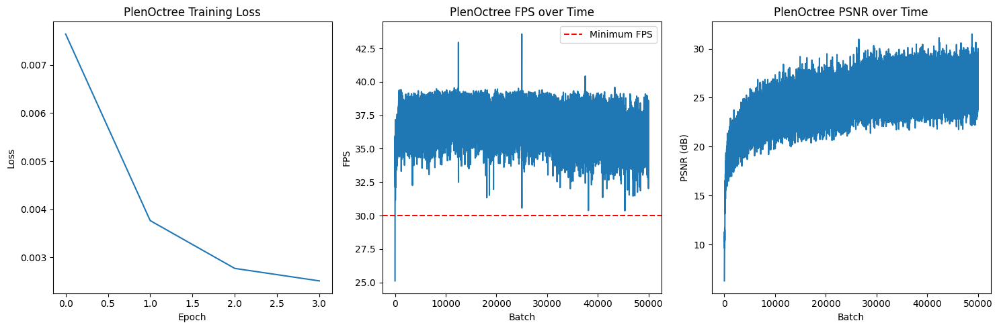

PlenOctree Training Progress:  40%|████      | 50003/125000 [49:49<3:57:23,  5.27it/s]


PlenOctree Epoch 5/10, Batch 0:
FPS: 42.65, Latency: 23.45ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  40%|████      | 50013/125000 [49:49<1:41:14, 12.34it/s]


PlenOctree Epoch 5/10, Batch 10:
FPS: 37.60, Latency: 26.60ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  40%|████      | 50023/125000 [49:50<1:18:48, 15.85it/s]


PlenOctree Epoch 5/10, Batch 20:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  40%|████      | 50033/125000 [49:51<1:16:46, 16.27it/s]


PlenOctree Epoch 5/10, Batch 30:
FPS: 36.98, Latency: 27.04ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  40%|████      | 50043/125000 [49:51<1:15:49, 16.48it/s]


PlenOctree Epoch 5/10, Batch 40:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  40%|████      | 50053/125000 [49:52<1:15:48, 16.48it/s]


PlenOctree Epoch 5/10, Batch 50:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  40%|████      | 50063/125000 [49:52<1:13:46, 16.93it/s]


PlenOctree Epoch 5/10, Batch 60:
FPS: 38.02, Latency: 26.30ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  40%|████      | 50073/125000 [49:53<1:14:44, 16.71it/s]


PlenOctree Epoch 5/10, Batch 70:
FPS: 38.03, Latency: 26.30ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  40%|████      | 50083/125000 [49:54<1:14:27, 16.77it/s]


PlenOctree Epoch 5/10, Batch 80:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50093/125000 [49:54<1:15:22, 16.56it/s]


PlenOctree Epoch 5/10, Batch 90:
FPS: 35.93, Latency: 27.84ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  40%|████      | 50103/125000 [49:55<1:14:14, 16.81it/s]


PlenOctree Epoch 5/10, Batch 100:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  40%|████      | 50113/125000 [49:55<1:14:58, 16.65it/s]


PlenOctree Epoch 5/10, Batch 110:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  40%|████      | 50123/125000 [49:56<1:14:05, 16.84it/s]


PlenOctree Epoch 5/10, Batch 120:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  40%|████      | 50133/125000 [49:57<1:15:25, 16.55it/s]


PlenOctree Epoch 5/10, Batch 130:
FPS: 35.92, Latency: 27.84ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  40%|████      | 50143/125000 [49:57<1:13:45, 16.91it/s]


PlenOctree Epoch 5/10, Batch 140:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  40%|████      | 50153/125000 [49:58<1:15:04, 16.62it/s]


PlenOctree Epoch 5/10, Batch 150:
FPS: 37.34, Latency: 26.78ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  40%|████      | 50163/125000 [49:58<1:13:45, 16.91it/s]


PlenOctree Epoch 5/10, Batch 160:
FPS: 36.75, Latency: 27.21ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  40%|████      | 50173/125000 [49:59<1:15:12, 16.58it/s]


PlenOctree Epoch 5/10, Batch 170:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  40%|████      | 50183/125000 [50:00<1:14:14, 16.80it/s]


PlenOctree Epoch 5/10, Batch 180:
FPS: 38.00, Latency: 26.31ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  40%|████      | 50193/125000 [50:00<1:14:46, 16.67it/s]


PlenOctree Epoch 5/10, Batch 190:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  40%|████      | 50203/125000 [50:01<1:15:16, 16.56it/s]


PlenOctree Epoch 5/10, Batch 200:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  40%|████      | 50213/125000 [50:01<1:14:33, 16.72it/s]


PlenOctree Epoch 5/10, Batch 210:
FPS: 36.08, Latency: 27.72ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  40%|████      | 50223/125000 [50:02<1:15:23, 16.53it/s]


PlenOctree Epoch 5/10, Batch 220:
FPS: 35.44, Latency: 28.22ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  40%|████      | 50233/125000 [50:03<1:15:26, 16.52it/s]


PlenOctree Epoch 5/10, Batch 230:
FPS: 37.04, Latency: 26.99ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  40%|████      | 50243/125000 [50:03<1:15:15, 16.55it/s]


PlenOctree Epoch 5/10, Batch 240:
FPS: 36.09, Latency: 27.71ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  40%|████      | 50253/125000 [50:04<1:14:20, 16.76it/s]


PlenOctree Epoch 5/10, Batch 250:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  40%|████      | 50263/125000 [50:04<1:14:54, 16.63it/s]


PlenOctree Epoch 5/10, Batch 260:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  40%|████      | 50273/125000 [50:05<1:13:58, 16.83it/s]


PlenOctree Epoch 5/10, Batch 270:
FPS: 37.73, Latency: 26.51ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  40%|████      | 50283/125000 [50:06<1:15:19, 16.53it/s]


PlenOctree Epoch 5/10, Batch 280:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  40%|████      | 50293/125000 [50:06<1:13:48, 16.87it/s]


PlenOctree Epoch 5/10, Batch 290:
FPS: 38.06, Latency: 26.27ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  40%|████      | 50303/125000 [50:07<1:14:45, 16.65it/s]


PlenOctree Epoch 5/10, Batch 300:
FPS: 37.35, Latency: 26.78ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  40%|████      | 50313/125000 [50:07<1:14:45, 16.65it/s]


PlenOctree Epoch 5/10, Batch 310:
FPS: 38.10, Latency: 26.25ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  40%|████      | 50323/125000 [50:08<1:14:26, 16.72it/s]


PlenOctree Epoch 5/10, Batch 320:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  40%|████      | 50333/125000 [50:09<1:15:14, 16.54it/s]


PlenOctree Epoch 5/10, Batch 330:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  40%|████      | 50343/125000 [50:09<1:14:30, 16.70it/s]


PlenOctree Epoch 5/10, Batch 340:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  40%|████      | 50353/125000 [50:10<1:14:34, 16.68it/s]


PlenOctree Epoch 5/10, Batch 350:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  40%|████      | 50363/125000 [50:10<1:15:03, 16.57it/s]


PlenOctree Epoch 5/10, Batch 360:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  40%|████      | 50373/125000 [50:11<1:15:40, 16.44it/s]


PlenOctree Epoch 5/10, Batch 370:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50383/125000 [50:12<1:15:11, 16.54it/s]


PlenOctree Epoch 5/10, Batch 380:
FPS: 36.74, Latency: 27.22ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  40%|████      | 50393/125000 [50:12<1:13:52, 16.83it/s]


PlenOctree Epoch 5/10, Batch 390:
FPS: 36.48, Latency: 27.42ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  40%|████      | 50403/125000 [50:13<1:14:45, 16.63it/s]


PlenOctree Epoch 5/10, Batch 400:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  40%|████      | 50413/125000 [50:13<1:14:09, 16.76it/s]


PlenOctree Epoch 5/10, Batch 410:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  40%|████      | 50423/125000 [50:14<1:14:59, 16.57it/s]


PlenOctree Epoch 5/10, Batch 420:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  40%|████      | 50433/125000 [50:15<1:15:41, 16.42it/s]


PlenOctree Epoch 5/10, Batch 430:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  40%|████      | 50443/125000 [50:15<1:15:34, 16.44it/s]


PlenOctree Epoch 5/10, Batch 440:
FPS: 35.85, Latency: 27.90ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50453/125000 [50:16<1:15:35, 16.44it/s]


PlenOctree Epoch 5/10, Batch 450:
FPS: 36.31, Latency: 27.54ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  40%|████      | 50463/125000 [50:16<1:14:55, 16.58it/s]


PlenOctree Epoch 5/10, Batch 460:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  40%|████      | 50473/125000 [50:17<1:13:46, 16.84it/s]


PlenOctree Epoch 5/10, Batch 470:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  40%|████      | 50483/125000 [50:18<1:14:59, 16.56it/s]


PlenOctree Epoch 5/10, Batch 480:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  40%|████      | 50493/125000 [50:18<1:13:05, 16.99it/s]


PlenOctree Epoch 5/10, Batch 490:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  40%|████      | 50503/125000 [50:19<1:14:50, 16.59it/s]


PlenOctree Epoch 5/10, Batch 500:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  40%|████      | 50513/125000 [50:19<1:14:17, 16.71it/s]


PlenOctree Epoch 5/10, Batch 510:
FPS: 38.01, Latency: 26.31ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50523/125000 [50:20<1:14:15, 16.71it/s]


PlenOctree Epoch 5/10, Batch 520:
FPS: 37.21, Latency: 26.88ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50533/125000 [50:21<1:14:54, 16.57it/s]


PlenOctree Epoch 5/10, Batch 530:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50543/125000 [50:21<1:13:29, 16.89it/s]


PlenOctree Epoch 5/10, Batch 540:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  40%|████      | 50553/125000 [50:22<1:14:58, 16.55it/s]


PlenOctree Epoch 5/10, Batch 550:
FPS: 37.40, Latency: 26.74ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  40%|████      | 50563/125000 [50:22<1:15:28, 16.44it/s]


PlenOctree Epoch 5/10, Batch 560:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  40%|████      | 50573/125000 [50:23<1:15:27, 16.44it/s]


PlenOctree Epoch 5/10, Batch 570:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50583/125000 [50:24<1:15:26, 16.44it/s]


PlenOctree Epoch 5/10, Batch 580:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  40%|████      | 50593/125000 [50:24<1:15:02, 16.53it/s]


PlenOctree Epoch 5/10, Batch 590:
FPS: 37.02, Latency: 27.01ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  40%|████      | 50603/125000 [50:25<1:14:16, 16.70it/s]


PlenOctree Epoch 5/10, Batch 600:
FPS: 37.55, Latency: 26.63ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  40%|████      | 50613/125000 [50:25<1:14:34, 16.62it/s]


PlenOctree Epoch 5/10, Batch 610:
FPS: 33.08, Latency: 30.23ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  40%|████      | 50623/125000 [50:26<1:14:42, 16.59it/s]


PlenOctree Epoch 5/10, Batch 620:
FPS: 36.12, Latency: 27.68ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 50633/125000 [50:27<1:14:26, 16.65it/s]


PlenOctree Epoch 5/10, Batch 630:
FPS: 36.61, Latency: 27.31ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  41%|████      | 50643/125000 [50:27<1:14:12, 16.70it/s]


PlenOctree Epoch 5/10, Batch 640:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  41%|████      | 50653/125000 [50:28<1:14:49, 16.56it/s]


PlenOctree Epoch 5/10, Batch 650:
FPS: 35.54, Latency: 28.14ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  41%|████      | 50663/125000 [50:28<1:15:05, 16.50it/s]


PlenOctree Epoch 5/10, Batch 660:
FPS: 36.37, Latency: 27.50ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 50673/125000 [50:29<1:13:29, 16.86it/s]


PlenOctree Epoch 5/10, Batch 670:
FPS: 36.97, Latency: 27.05ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  41%|████      | 50683/125000 [50:30<1:14:42, 16.58it/s]


PlenOctree Epoch 5/10, Batch 680:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  41%|████      | 50693/125000 [50:30<1:13:42, 16.80it/s]


PlenOctree Epoch 5/10, Batch 690:
FPS: 37.02, Latency: 27.01ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 50703/125000 [50:31<1:14:32, 16.61it/s]


PlenOctree Epoch 5/10, Batch 700:
FPS: 35.76, Latency: 27.96ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  41%|████      | 50713/125000 [50:31<1:14:25, 16.64it/s]


PlenOctree Epoch 5/10, Batch 710:
FPS: 36.32, Latency: 27.53ms
PSNR: 30.23dB, Loss: 0.0009


PlenOctree Training Progress:  41%|████      | 50723/125000 [50:32<1:13:24, 16.86it/s]


PlenOctree Epoch 5/10, Batch 720:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 50733/125000 [50:33<1:14:45, 16.56it/s]


PlenOctree Epoch 5/10, Batch 730:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████      | 50743/125000 [50:33<1:14:40, 16.57it/s]


PlenOctree Epoch 5/10, Batch 740:
FPS: 36.66, Latency: 27.28ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  41%|████      | 50753/125000 [50:34<1:14:37, 16.58it/s]


PlenOctree Epoch 5/10, Batch 750:
FPS: 37.75, Latency: 26.49ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  41%|████      | 50763/125000 [50:34<1:13:58, 16.72it/s]


PlenOctree Epoch 5/10, Batch 760:
FPS: 37.20, Latency: 26.88ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 50773/125000 [50:35<1:14:47, 16.54it/s]


PlenOctree Epoch 5/10, Batch 770:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████      | 50783/125000 [50:36<1:15:03, 16.48it/s]


PlenOctree Epoch 5/10, Batch 780:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  41%|████      | 50793/125000 [50:36<1:14:53, 16.51it/s]


PlenOctree Epoch 5/10, Batch 790:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████      | 50803/125000 [50:37<1:15:06, 16.47it/s]


PlenOctree Epoch 5/10, Batch 800:
FPS: 34.50, Latency: 28.98ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  41%|████      | 50813/125000 [50:38<1:15:19, 16.41it/s]


PlenOctree Epoch 5/10, Batch 810:
FPS: 35.75, Latency: 27.97ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  41%|████      | 50823/125000 [50:38<1:14:55, 16.50it/s]


PlenOctree Epoch 5/10, Batch 820:
FPS: 35.47, Latency: 28.19ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  41%|████      | 50833/125000 [50:39<1:15:06, 16.46it/s]


PlenOctree Epoch 5/10, Batch 830:
FPS: 34.81, Latency: 28.73ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████      | 50843/125000 [50:39<1:14:44, 16.54it/s]


PlenOctree Epoch 5/10, Batch 840:
FPS: 34.62, Latency: 28.88ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  41%|████      | 50853/125000 [50:40<1:15:02, 16.47it/s]


PlenOctree Epoch 5/10, Batch 850:
FPS: 34.75, Latency: 28.77ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 50863/125000 [50:41<1:14:50, 16.51it/s]


PlenOctree Epoch 5/10, Batch 860:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 50873/125000 [50:41<1:14:24, 16.60it/s]


PlenOctree Epoch 5/10, Batch 870:
FPS: 36.72, Latency: 27.23ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  41%|████      | 50883/125000 [50:42<1:13:23, 16.83it/s]


PlenOctree Epoch 5/10, Batch 880:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 50893/125000 [50:42<1:14:30, 16.58it/s]


PlenOctree Epoch 5/10, Batch 890:
FPS: 35.81, Latency: 27.92ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  41%|████      | 50903/125000 [50:43<1:14:23, 16.60it/s]


PlenOctree Epoch 5/10, Batch 900:
FPS: 37.88, Latency: 26.40ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 50913/125000 [50:44<1:13:39, 16.76it/s]


PlenOctree Epoch 5/10, Batch 910:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 50923/125000 [50:44<1:14:31, 16.57it/s]


PlenOctree Epoch 5/10, Batch 920:
FPS: 36.42, Latency: 27.45ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 50933/125000 [50:45<1:15:03, 16.45it/s]


PlenOctree Epoch 5/10, Batch 930:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  41%|████      | 50943/125000 [50:45<1:14:06, 16.65it/s]


PlenOctree Epoch 5/10, Batch 940:
FPS: 37.72, Latency: 26.51ms
PSNR: 30.63dB, Loss: 0.0009


PlenOctree Training Progress:  41%|████      | 50953/125000 [50:46<1:13:44, 16.74it/s]


PlenOctree Epoch 5/10, Batch 950:
FPS: 37.13, Latency: 26.93ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  41%|████      | 50963/125000 [50:47<1:14:40, 16.53it/s]


PlenOctree Epoch 5/10, Batch 960:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  41%|████      | 50973/125000 [50:47<1:14:42, 16.52it/s]


PlenOctree Epoch 5/10, Batch 970:
FPS: 33.89, Latency: 29.51ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  41%|████      | 50983/125000 [50:48<1:14:41, 16.52it/s]


PlenOctree Epoch 5/10, Batch 980:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 50993/125000 [50:48<1:14:27, 16.56it/s]


PlenOctree Epoch 5/10, Batch 990:
FPS: 37.06, Latency: 26.99ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  41%|████      | 51003/125000 [50:49<1:12:54, 16.92it/s]


PlenOctree Epoch 5/10, Batch 1000:
FPS: 37.15, Latency: 26.92ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 51013/125000 [50:50<1:14:42, 16.51it/s]


PlenOctree Epoch 5/10, Batch 1010:
FPS: 35.95, Latency: 27.82ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  41%|████      | 51023/125000 [50:50<1:14:32, 16.54it/s]


PlenOctree Epoch 5/10, Batch 1020:
FPS: 36.50, Latency: 27.40ms
PSNR: 24.26dB, Loss: 0.0038


PlenOctree Training Progress:  41%|████      | 51033/125000 [50:51<1:14:46, 16.49it/s]


PlenOctree Epoch 5/10, Batch 1030:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  41%|████      | 51043/125000 [50:51<1:14:38, 16.51it/s]


PlenOctree Epoch 5/10, Batch 1040:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 51053/125000 [50:52<1:14:20, 16.58it/s]


PlenOctree Epoch 5/10, Batch 1050:
FPS: 36.72, Latency: 27.24ms
PSNR: 29.07dB, Loss: 0.0012


PlenOctree Training Progress:  41%|████      | 51063/125000 [50:53<1:14:51, 16.46it/s]


PlenOctree Epoch 5/10, Batch 1060:
FPS: 35.35, Latency: 28.29ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 51073/125000 [50:53<1:13:24, 16.79it/s]


PlenOctree Epoch 5/10, Batch 1070:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  41%|████      | 51083/125000 [50:54<1:14:14, 16.59it/s]


PlenOctree Epoch 5/10, Batch 1080:
FPS: 37.28, Latency: 26.82ms
PSNR: 29.71dB, Loss: 0.0011


PlenOctree Training Progress:  41%|████      | 51093/125000 [50:54<1:14:32, 16.52it/s]


PlenOctree Epoch 5/10, Batch 1090:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  41%|████      | 51103/125000 [50:55<1:13:14, 16.81it/s]


PlenOctree Epoch 5/10, Batch 1100:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 51113/125000 [50:56<1:14:18, 16.57it/s]


PlenOctree Epoch 5/10, Batch 1110:
FPS: 36.66, Latency: 27.27ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  41%|████      | 51123/125000 [50:56<1:12:48, 16.91it/s]


PlenOctree Epoch 5/10, Batch 1120:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 51133/125000 [50:57<1:14:28, 16.53it/s]


PlenOctree Epoch 5/10, Batch 1130:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  41%|████      | 51143/125000 [50:57<1:13:58, 16.64it/s]


PlenOctree Epoch 5/10, Batch 1140:
FPS: 38.47, Latency: 25.99ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  41%|████      | 51153/125000 [50:58<1:13:49, 16.67it/s]


PlenOctree Epoch 5/10, Batch 1150:
FPS: 36.37, Latency: 27.50ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  41%|████      | 51163/125000 [50:59<1:14:23, 16.54it/s]


PlenOctree Epoch 5/10, Batch 1160:
FPS: 35.85, Latency: 27.90ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  41%|████      | 51173/125000 [50:59<1:12:40, 16.93it/s]


PlenOctree Epoch 5/10, Batch 1170:
FPS: 36.49, Latency: 27.40ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  41%|████      | 51183/125000 [51:00<1:14:20, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1180:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 51193/125000 [51:00<1:14:18, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1190:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  41%|████      | 51203/125000 [51:01<1:12:35, 16.94it/s]


PlenOctree Epoch 5/10, Batch 1200:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 51213/125000 [51:02<1:14:13, 16.57it/s]


PlenOctree Epoch 5/10, Batch 1210:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 51223/125000 [51:02<1:12:53, 16.87it/s]


PlenOctree Epoch 5/10, Batch 1220:
FPS: 35.59, Latency: 28.10ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 51233/125000 [51:03<1:14:01, 16.61it/s]


PlenOctree Epoch 5/10, Batch 1230:
FPS: 37.05, Latency: 26.99ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  41%|████      | 51243/125000 [51:03<1:14:14, 16.56it/s]


PlenOctree Epoch 5/10, Batch 1240:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51253/125000 [51:04<1:12:45, 16.89it/s]


PlenOctree Epoch 5/10, Batch 1250:
FPS: 37.06, Latency: 26.99ms
PSNR: 24.36dB, Loss: 0.0037


PlenOctree Training Progress:  41%|████      | 51263/125000 [51:05<1:14:08, 16.58it/s]


PlenOctree Epoch 5/10, Batch 1260:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51273/125000 [51:05<1:13:55, 16.62it/s]


PlenOctree Epoch 5/10, Batch 1270:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████      | 51283/125000 [51:06<1:13:23, 16.74it/s]


PlenOctree Epoch 5/10, Batch 1280:
FPS: 37.45, Latency: 26.70ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 51293/125000 [51:06<1:12:32, 16.93it/s]


PlenOctree Epoch 5/10, Batch 1290:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51303/125000 [51:07<1:14:12, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1300:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51313/125000 [51:08<1:13:29, 16.71it/s]


PlenOctree Epoch 5/10, Batch 1310:
FPS: 37.39, Latency: 26.75ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 51323/125000 [51:08<1:13:49, 16.63it/s]


PlenOctree Epoch 5/10, Batch 1320:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51333/125000 [51:09<1:14:06, 16.57it/s]


PlenOctree Epoch 5/10, Batch 1330:
FPS: 36.03, Latency: 27.75ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████      | 51343/125000 [51:09<1:13:12, 16.77it/s]


PlenOctree Epoch 5/10, Batch 1340:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  41%|████      | 51353/125000 [51:10<1:13:46, 16.64it/s]


PlenOctree Epoch 5/10, Batch 1350:
FPS: 37.59, Latency: 26.61ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 51363/125000 [51:11<1:13:09, 16.78it/s]


PlenOctree Epoch 5/10, Batch 1360:
FPS: 37.55, Latency: 26.63ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  41%|████      | 51373/125000 [51:11<1:14:09, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1370:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  41%|████      | 51383/125000 [51:12<1:13:19, 16.73it/s]


PlenOctree Epoch 5/10, Batch 1380:
FPS: 37.96, Latency: 26.34ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51393/125000 [51:12<1:13:32, 16.68it/s]


PlenOctree Epoch 5/10, Batch 1390:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  41%|████      | 51403/125000 [51:13<1:12:31, 16.91it/s]


PlenOctree Epoch 5/10, Batch 1400:
FPS: 37.48, Latency: 26.68ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  41%|████      | 51413/125000 [51:14<1:13:58, 16.58it/s]


PlenOctree Epoch 5/10, Batch 1410:
FPS: 35.94, Latency: 27.83ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████      | 51423/125000 [51:14<1:14:14, 16.52it/s]


PlenOctree Epoch 5/10, Batch 1420:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 51433/125000 [51:15<1:14:32, 16.45it/s]


PlenOctree Epoch 5/10, Batch 1430:
FPS: 35.63, Latency: 28.06ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  41%|████      | 51443/125000 [51:15<1:13:42, 16.63it/s]


PlenOctree Epoch 5/10, Batch 1440:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████      | 51453/125000 [51:16<1:12:52, 16.82it/s]


PlenOctree Epoch 5/10, Batch 1450:
FPS: 37.04, Latency: 27.00ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  41%|████      | 51463/125000 [51:17<1:13:06, 16.76it/s]


PlenOctree Epoch 5/10, Batch 1460:
FPS: 38.00, Latency: 26.31ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  41%|████      | 51473/125000 [51:17<1:13:24, 16.69it/s]


PlenOctree Epoch 5/10, Batch 1470:
FPS: 37.07, Latency: 26.97ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  41%|████      | 51483/125000 [51:18<1:12:55, 16.80it/s]


PlenOctree Epoch 5/10, Batch 1480:
FPS: 37.28, Latency: 26.82ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  41%|████      | 51493/125000 [51:18<1:13:48, 16.60it/s]


PlenOctree Epoch 5/10, Batch 1490:
FPS: 35.95, Latency: 27.81ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████      | 51503/125000 [51:19<1:13:46, 16.60it/s]


PlenOctree Epoch 5/10, Batch 1500:
FPS: 35.50, Latency: 28.17ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  41%|████      | 51513/125000 [51:20<1:12:26, 16.91it/s]


PlenOctree Epoch 5/10, Batch 1510:
FPS: 38.25, Latency: 26.15ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████      | 51523/125000 [51:20<1:13:31, 16.66it/s]


PlenOctree Epoch 5/10, Batch 1520:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████      | 51533/125000 [51:21<1:12:27, 16.90it/s]


PlenOctree Epoch 5/10, Batch 1530:
FPS: 35.34, Latency: 28.29ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  41%|████      | 51543/125000 [51:21<1:13:40, 16.62it/s]


PlenOctree Epoch 5/10, Batch 1540:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  41%|████      | 51553/125000 [51:22<1:12:17, 16.93it/s]


PlenOctree Epoch 5/10, Batch 1550:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  41%|████▏     | 51563/125000 [51:23<1:14:00, 16.54it/s]


PlenOctree Epoch 5/10, Batch 1560:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████▏     | 51573/125000 [51:23<1:13:02, 16.75it/s]


PlenOctree Epoch 5/10, Batch 1570:
FPS: 37.97, Latency: 26.34ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████▏     | 51583/125000 [51:24<1:13:20, 16.68it/s]


PlenOctree Epoch 5/10, Batch 1580:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████▏     | 51593/125000 [51:24<1:13:54, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1590:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████▏     | 51603/125000 [51:25<1:13:39, 16.61it/s]


PlenOctree Epoch 5/10, Batch 1600:
FPS: 38.34, Latency: 26.08ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  41%|████▏     | 51613/125000 [51:26<1:12:55, 16.77it/s]


PlenOctree Epoch 5/10, Batch 1610:
FPS: 35.75, Latency: 27.98ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  41%|████▏     | 51623/125000 [51:26<1:13:51, 16.56it/s]


PlenOctree Epoch 5/10, Batch 1620:
FPS: 35.01, Latency: 28.56ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████▏     | 51633/125000 [51:27<1:14:10, 16.49it/s]


PlenOctree Epoch 5/10, Batch 1630:
FPS: 34.45, Latency: 29.02ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  41%|████▏     | 51643/125000 [51:27<1:13:51, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1640:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████▏     | 51653/125000 [51:28<1:14:14, 16.46it/s]


PlenOctree Epoch 5/10, Batch 1650:
FPS: 35.29, Latency: 28.33ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████▏     | 51663/125000 [51:29<1:14:13, 16.47it/s]


PlenOctree Epoch 5/10, Batch 1660:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  41%|████▏     | 51673/125000 [51:29<1:13:57, 16.53it/s]


PlenOctree Epoch 5/10, Batch 1670:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████▏     | 51683/125000 [51:30<1:14:17, 16.45it/s]


PlenOctree Epoch 5/10, Batch 1680:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  41%|████▏     | 51693/125000 [51:30<1:14:06, 16.49it/s]


PlenOctree Epoch 5/10, Batch 1690:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████▏     | 51703/125000 [51:31<1:14:01, 16.50it/s]


PlenOctree Epoch 5/10, Batch 1700:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.61dB, Loss: 0.0028


PlenOctree Training Progress:  41%|████▏     | 51713/125000 [51:32<1:13:57, 16.52it/s]


PlenOctree Epoch 5/10, Batch 1710:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  41%|████▏     | 51723/125000 [51:32<1:13:47, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1720:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████▏     | 51733/125000 [51:33<1:12:46, 16.78it/s]


PlenOctree Epoch 5/10, Batch 1730:
FPS: 37.58, Latency: 26.61ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████▏     | 51743/125000 [51:33<1:13:37, 16.58it/s]


PlenOctree Epoch 5/10, Batch 1740:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████▏     | 51753/125000 [51:34<1:14:01, 16.49it/s]


PlenOctree Epoch 5/10, Batch 1750:
FPS: 35.65, Latency: 28.05ms
PSNR: 29.24dB, Loss: 0.0012


PlenOctree Training Progress:  41%|████▏     | 51763/125000 [51:35<1:13:49, 16.54it/s]


PlenOctree Epoch 5/10, Batch 1760:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  41%|████▏     | 51773/125000 [51:35<1:12:39, 16.80it/s]


PlenOctree Epoch 5/10, Batch 1770:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  41%|████▏     | 51783/125000 [51:36<1:13:23, 16.63it/s]


PlenOctree Epoch 5/10, Batch 1780:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  41%|████▏     | 51793/125000 [51:36<1:13:34, 16.58it/s]


PlenOctree Epoch 5/10, Batch 1790:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  41%|████▏     | 51803/125000 [51:37<1:14:09, 16.45it/s]


PlenOctree Epoch 5/10, Batch 1800:
FPS: 35.31, Latency: 28.32ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  41%|████▏     | 51813/125000 [51:38<1:14:14, 16.43it/s]


PlenOctree Epoch 5/10, Batch 1810:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  41%|████▏     | 51823/125000 [51:38<1:13:51, 16.51it/s]


PlenOctree Epoch 5/10, Batch 1820:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  41%|████▏     | 51833/125000 [51:39<1:13:57, 16.49it/s]


PlenOctree Epoch 5/10, Batch 1830:
FPS: 35.92, Latency: 27.84ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  41%|████▏     | 51843/125000 [51:39<1:13:49, 16.52it/s]


PlenOctree Epoch 5/10, Batch 1840:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  41%|████▏     | 51853/125000 [51:40<1:13:53, 16.50it/s]


PlenOctree Epoch 5/10, Batch 1850:
FPS: 33.07, Latency: 30.24ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  41%|████▏     | 51863/125000 [51:41<1:13:50, 16.51it/s]


PlenOctree Epoch 5/10, Batch 1860:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  41%|████▏     | 51873/125000 [51:41<1:13:48, 16.51it/s]


PlenOctree Epoch 5/10, Batch 1870:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 51883/125000 [51:42<1:12:20, 16.85it/s]


PlenOctree Epoch 5/10, Batch 1880:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 51893/125000 [51:42<1:13:35, 16.56it/s]


PlenOctree Epoch 5/10, Batch 1890:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 51903/125000 [51:43<1:13:27, 16.59it/s]


PlenOctree Epoch 5/10, Batch 1900:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 51913/125000 [51:44<1:12:02, 16.91it/s]


PlenOctree Epoch 5/10, Batch 1910:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 51923/125000 [51:44<1:13:31, 16.56it/s]


PlenOctree Epoch 5/10, Batch 1920:
FPS: 36.65, Latency: 27.28ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  42%|████▏     | 51933/125000 [51:45<1:13:11, 16.64it/s]


PlenOctree Epoch 5/10, Batch 1930:
FPS: 36.89, Latency: 27.11ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  42%|████▏     | 51943/125000 [51:45<1:12:23, 16.82it/s]


PlenOctree Epoch 5/10, Batch 1940:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 51953/125000 [51:46<1:13:33, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1950:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 51963/125000 [51:47<1:13:33, 16.55it/s]


PlenOctree Epoch 5/10, Batch 1960:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 51973/125000 [51:47<1:13:47, 16.50it/s]


PlenOctree Epoch 5/10, Batch 1970:
FPS: 36.33, Latency: 27.53ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  42%|████▏     | 51983/125000 [51:48<1:13:56, 16.46it/s]


PlenOctree Epoch 5/10, Batch 1980:
FPS: 36.21, Latency: 27.62ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  42%|████▏     | 51993/125000 [51:49<1:13:53, 16.47it/s]


PlenOctree Epoch 5/10, Batch 1990:
FPS: 36.36, Latency: 27.51ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52003/125000 [51:49<1:12:23, 16.81it/s]


PlenOctree Epoch 5/10, Batch 2000:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  42%|████▏     | 52013/125000 [51:50<1:13:06, 16.64it/s]


PlenOctree Epoch 5/10, Batch 2010:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 52023/125000 [51:50<1:13:15, 16.60it/s]


PlenOctree Epoch 5/10, Batch 2020:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52033/125000 [51:51<1:13:47, 16.48it/s]


PlenOctree Epoch 5/10, Batch 2030:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  42%|████▏     | 52043/125000 [51:52<1:13:38, 16.51it/s]


PlenOctree Epoch 5/10, Batch 2040:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  42%|████▏     | 52053/125000 [51:52<1:13:31, 16.54it/s]


PlenOctree Epoch 5/10, Batch 2050:
FPS: 36.40, Latency: 27.47ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  42%|████▏     | 52063/125000 [51:53<1:12:27, 16.78it/s]


PlenOctree Epoch 5/10, Batch 2060:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 52073/125000 [51:53<1:13:07, 16.62it/s]


PlenOctree Epoch 5/10, Batch 2070:
FPS: 35.61, Latency: 28.08ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  42%|████▏     | 52083/125000 [51:54<1:13:30, 16.53it/s]


PlenOctree Epoch 5/10, Batch 2080:
FPS: 36.32, Latency: 27.53ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  42%|████▏     | 52093/125000 [51:55<1:13:39, 16.50it/s]


PlenOctree Epoch 5/10, Batch 2090:
FPS: 36.25, Latency: 27.58ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  42%|████▏     | 52103/125000 [51:55<1:12:02, 16.87it/s]


PlenOctree Epoch 5/10, Batch 2100:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 52113/125000 [51:56<1:12:59, 16.64it/s]


PlenOctree Epoch 5/10, Batch 2110:
FPS: 36.64, Latency: 27.29ms
PSNR: 30.17dB, Loss: 0.0010


PlenOctree Training Progress:  42%|████▏     | 52123/125000 [51:56<1:13:16, 16.57it/s]


PlenOctree Epoch 5/10, Batch 2120:
FPS: 36.72, Latency: 27.23ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  42%|████▏     | 52133/125000 [51:57<1:12:50, 16.67it/s]


PlenOctree Epoch 5/10, Batch 2130:
FPS: 38.18, Latency: 26.19ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  42%|████▏     | 52143/125000 [51:58<1:12:40, 16.71it/s]


PlenOctree Epoch 5/10, Batch 2140:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52153/125000 [51:58<1:13:11, 16.59it/s]


PlenOctree Epoch 5/10, Batch 2150:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  42%|████▏     | 52163/125000 [51:59<1:12:57, 16.64it/s]


PlenOctree Epoch 5/10, Batch 2160:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 52173/125000 [51:59<1:12:52, 16.65it/s]


PlenOctree Epoch 5/10, Batch 2170:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 52183/125000 [52:00<1:13:24, 16.53it/s]


PlenOctree Epoch 5/10, Batch 2180:
FPS: 35.67, Latency: 28.04ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 52193/125000 [52:01<1:13:36, 16.49it/s]


PlenOctree Epoch 5/10, Batch 2190:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52203/125000 [52:01<1:11:40, 16.93it/s]


PlenOctree Epoch 5/10, Batch 2200:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  42%|████▏     | 52213/125000 [52:02<1:13:15, 16.56it/s]


PlenOctree Epoch 5/10, Batch 2210:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52223/125000 [52:02<1:13:37, 16.48it/s]


PlenOctree Epoch 5/10, Batch 2220:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52233/125000 [52:03<1:13:30, 16.50it/s]


PlenOctree Epoch 5/10, Batch 2230:
FPS: 35.61, Latency: 28.08ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 52243/125000 [52:04<1:13:33, 16.48it/s]


PlenOctree Epoch 5/10, Batch 2240:
FPS: 35.73, Latency: 27.99ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 52253/125000 [52:04<1:13:30, 16.49it/s]


PlenOctree Epoch 5/10, Batch 2250:
FPS: 36.94, Latency: 27.07ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  42%|████▏     | 52263/125000 [52:05<1:13:30, 16.49it/s]


PlenOctree Epoch 5/10, Batch 2260:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 52273/125000 [52:05<1:13:30, 16.49it/s]


PlenOctree Epoch 5/10, Batch 2270:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 52283/125000 [52:06<1:13:20, 16.52it/s]


PlenOctree Epoch 5/10, Batch 2280:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 52293/125000 [52:07<1:11:51, 16.86it/s]


PlenOctree Epoch 5/10, Batch 2290:
FPS: 36.87, Latency: 27.13ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  42%|████▏     | 52303/125000 [52:07<1:12:49, 16.64it/s]


PlenOctree Epoch 5/10, Batch 2300:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 52313/125000 [52:08<1:12:57, 16.61it/s]


PlenOctree Epoch 5/10, Batch 2310:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52323/125000 [52:08<1:12:07, 16.79it/s]


PlenOctree Epoch 5/10, Batch 2320:
FPS: 37.76, Latency: 26.48ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 52333/125000 [52:09<1:13:25, 16.49it/s]


PlenOctree Epoch 5/10, Batch 2330:
FPS: 35.90, Latency: 27.86ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  42%|████▏     | 52343/125000 [52:10<1:13:01, 16.58it/s]


PlenOctree Epoch 5/10, Batch 2340:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  42%|████▏     | 52353/125000 [52:10<1:12:03, 16.80it/s]


PlenOctree Epoch 5/10, Batch 2350:
FPS: 37.29, Latency: 26.82ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52363/125000 [52:11<1:13:02, 16.57it/s]


PlenOctree Epoch 5/10, Batch 2360:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 52373/125000 [52:11<1:12:47, 16.63it/s]


PlenOctree Epoch 5/10, Batch 2370:
FPS: 37.52, Latency: 26.66ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52383/125000 [52:12<1:12:20, 16.73it/s]


PlenOctree Epoch 5/10, Batch 2380:
FPS: 37.00, Latency: 27.03ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  42%|████▏     | 52393/125000 [52:13<1:13:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 2390:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52403/125000 [52:13<1:12:52, 16.60it/s]


PlenOctree Epoch 5/10, Batch 2400:
FPS: 38.25, Latency: 26.14ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  42%|████▏     | 52413/125000 [52:14<1:12:25, 16.70it/s]


PlenOctree Epoch 5/10, Batch 2410:
FPS: 37.28, Latency: 26.83ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 52423/125000 [52:14<1:12:52, 16.60it/s]


PlenOctree Epoch 5/10, Batch 2420:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  42%|████▏     | 52433/125000 [52:15<1:13:23, 16.48it/s]


PlenOctree Epoch 5/10, Batch 2430:
FPS: 34.30, Latency: 29.16ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52443/125000 [52:16<1:13:12, 16.52it/s]


PlenOctree Epoch 5/10, Batch 2440:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 52453/125000 [52:16<1:11:34, 16.89it/s]


PlenOctree Epoch 5/10, Batch 2450:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 52463/125000 [52:17<1:12:59, 16.56it/s]


PlenOctree Epoch 5/10, Batch 2460:
FPS: 36.11, Latency: 27.69ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52473/125000 [52:17<1:12:46, 16.61it/s]


PlenOctree Epoch 5/10, Batch 2470:
FPS: 37.49, Latency: 26.68ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 52483/125000 [52:18<1:11:56, 16.80it/s]


PlenOctree Epoch 5/10, Batch 2480:
FPS: 36.87, Latency: 27.13ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 52493/125000 [52:19<1:12:53, 16.58it/s]


PlenOctree Epoch 5/10, Batch 2490:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52503/125000 [52:19<1:13:02, 16.54it/s]


PlenOctree Epoch 5/10, Batch 2500:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  42%|████▏     | 52513/125000 [52:20<1:12:09, 16.74it/s]


PlenOctree Epoch 5/10, Batch 2510:
FPS: 37.03, Latency: 27.01ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  42%|████▏     | 52523/125000 [52:20<1:12:57, 16.56it/s]


PlenOctree Epoch 5/10, Batch 2520:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52533/125000 [52:21<1:11:48, 16.82it/s]


PlenOctree Epoch 5/10, Batch 2530:
FPS: 37.22, Latency: 26.87ms
PSNR: 24.75dB, Loss: 0.0034


PlenOctree Training Progress:  42%|████▏     | 52543/125000 [52:22<1:12:28, 16.66it/s]


PlenOctree Epoch 5/10, Batch 2540:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52553/125000 [52:22<1:11:54, 16.79it/s]


PlenOctree Epoch 5/10, Batch 2550:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52563/125000 [52:23<1:12:35, 16.63it/s]


PlenOctree Epoch 5/10, Batch 2560:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 52573/125000 [52:23<1:12:40, 16.61it/s]


PlenOctree Epoch 5/10, Batch 2570:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 52583/125000 [52:24<1:11:58, 16.77it/s]


PlenOctree Epoch 5/10, Batch 2580:
FPS: 37.46, Latency: 26.70ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 52593/125000 [52:25<1:12:46, 16.58it/s]


PlenOctree Epoch 5/10, Batch 2590:
FPS: 36.32, Latency: 27.54ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  42%|████▏     | 52603/125000 [52:25<1:12:20, 16.68it/s]


PlenOctree Epoch 5/10, Batch 2600:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52613/125000 [52:26<1:12:03, 16.74it/s]


PlenOctree Epoch 5/10, Batch 2610:
FPS: 37.94, Latency: 26.36ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 52623/125000 [52:26<1:12:51, 16.56it/s]


PlenOctree Epoch 5/10, Batch 2620:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52633/125000 [52:27<1:11:31, 16.86it/s]


PlenOctree Epoch 5/10, Batch 2630:
FPS: 37.02, Latency: 27.01ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  42%|████▏     | 52643/125000 [52:28<1:12:32, 16.62it/s]


PlenOctree Epoch 5/10, Batch 2640:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  42%|████▏     | 52653/125000 [52:28<1:11:10, 16.94it/s]


PlenOctree Epoch 5/10, Batch 2650:
FPS: 37.97, Latency: 26.33ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  42%|████▏     | 52663/125000 [52:29<1:12:56, 16.53it/s]


PlenOctree Epoch 5/10, Batch 2660:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 52673/125000 [52:29<1:12:03, 16.73it/s]


PlenOctree Epoch 5/10, Batch 2670:
FPS: 37.04, Latency: 27.00ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  42%|████▏     | 52683/125000 [52:30<1:12:01, 16.73it/s]


PlenOctree Epoch 5/10, Batch 2680:
FPS: 35.89, Latency: 27.86ms
PSNR: 23.82dB, Loss: 0.0041


PlenOctree Training Progress:  42%|████▏     | 52693/125000 [52:31<1:12:10, 16.70it/s]


PlenOctree Epoch 5/10, Batch 2690:
FPS: 37.14, Latency: 26.92ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  42%|████▏     | 52703/125000 [52:31<1:12:03, 16.72it/s]


PlenOctree Epoch 5/10, Batch 2700:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 52713/125000 [52:32<1:12:50, 16.54it/s]


PlenOctree Epoch 5/10, Batch 2710:
FPS: 35.43, Latency: 28.23ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  42%|████▏     | 52723/125000 [52:32<1:12:28, 16.62it/s]


PlenOctree Epoch 5/10, Batch 2720:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52733/125000 [52:33<1:11:49, 16.77it/s]


PlenOctree Epoch 5/10, Batch 2730:
FPS: 37.66, Latency: 26.55ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 52743/125000 [52:34<1:12:46, 16.55it/s]


PlenOctree Epoch 5/10, Batch 2740:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 52753/125000 [52:34<1:11:21, 16.88it/s]


PlenOctree Epoch 5/10, Batch 2750:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 52763/125000 [52:35<1:12:08, 16.69it/s]


PlenOctree Epoch 5/10, Batch 2760:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52773/125000 [52:35<1:11:58, 16.72it/s]


PlenOctree Epoch 5/10, Batch 2770:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  42%|████▏     | 52783/125000 [52:36<1:12:45, 16.54it/s]


PlenOctree Epoch 5/10, Batch 2780:
FPS: 36.88, Latency: 27.11ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  42%|████▏     | 52793/125000 [52:37<1:11:18, 16.88it/s]


PlenOctree Epoch 5/10, Batch 2790:
FPS: 37.38, Latency: 26.76ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  42%|████▏     | 52803/125000 [52:37<1:12:07, 16.68it/s]


PlenOctree Epoch 5/10, Batch 2800:
FPS: 36.81, Latency: 27.16ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52813/125000 [52:38<1:11:21, 16.86it/s]


PlenOctree Epoch 5/10, Batch 2810:
FPS: 38.22, Latency: 26.17ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  42%|████▏     | 52823/125000 [52:38<1:12:20, 16.63it/s]


PlenOctree Epoch 5/10, Batch 2820:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  42%|████▏     | 52833/125000 [52:39<1:12:16, 16.64it/s]


PlenOctree Epoch 5/10, Batch 2830:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  42%|████▏     | 52843/125000 [52:40<1:11:48, 16.75it/s]


PlenOctree Epoch 5/10, Batch 2840:
FPS: 37.13, Latency: 26.93ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  42%|████▏     | 52853/125000 [52:40<1:12:31, 16.58it/s]


PlenOctree Epoch 5/10, Batch 2850:
FPS: 33.70, Latency: 29.68ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  42%|████▏     | 52863/125000 [52:41<1:12:01, 16.69it/s]


PlenOctree Epoch 5/10, Batch 2860:
FPS: 37.06, Latency: 26.99ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  42%|████▏     | 52873/125000 [52:41<1:12:03, 16.68it/s]


PlenOctree Epoch 5/10, Batch 2870:
FPS: 36.76, Latency: 27.21ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52883/125000 [52:42<1:12:19, 16.62it/s]


PlenOctree Epoch 5/10, Batch 2880:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  42%|████▏     | 52893/125000 [52:43<1:12:44, 16.52it/s]


PlenOctree Epoch 5/10, Batch 2890:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 52903/125000 [52:43<1:11:23, 16.83it/s]


PlenOctree Epoch 5/10, Batch 2900:
FPS: 35.64, Latency: 28.06ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  42%|████▏     | 52913/125000 [52:44<1:12:30, 16.57it/s]


PlenOctree Epoch 5/10, Batch 2910:
FPS: 35.93, Latency: 27.84ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 52923/125000 [52:44<1:12:21, 16.60it/s]


PlenOctree Epoch 5/10, Batch 2920:
FPS: 36.80, Latency: 27.17ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  42%|████▏     | 52933/125000 [52:45<1:10:55, 16.93it/s]


PlenOctree Epoch 5/10, Batch 2930:
FPS: 37.96, Latency: 26.34ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 52943/125000 [52:46<1:12:25, 16.58it/s]


PlenOctree Epoch 5/10, Batch 2940:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 52953/125000 [52:46<1:12:09, 16.64it/s]


PlenOctree Epoch 5/10, Batch 2950:
FPS: 37.39, Latency: 26.74ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  42%|████▏     | 52963/125000 [52:47<1:11:41, 16.75it/s]


PlenOctree Epoch 5/10, Batch 2960:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  42%|████▏     | 52973/125000 [52:47<1:12:18, 16.60it/s]


PlenOctree Epoch 5/10, Batch 2970:
FPS: 36.33, Latency: 27.53ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  42%|████▏     | 52983/125000 [52:48<1:11:31, 16.78it/s]


PlenOctree Epoch 5/10, Batch 2980:
FPS: 36.84, Latency: 27.14ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  42%|████▏     | 52993/125000 [52:49<1:12:09, 16.63it/s]


PlenOctree Epoch 5/10, Batch 2990:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 53003/125000 [52:49<1:12:13, 16.61it/s]


PlenOctree Epoch 5/10, Batch 3000:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  42%|████▏     | 53013/125000 [52:50<1:12:27, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3010:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 53023/125000 [52:50<1:11:10, 16.85it/s]


PlenOctree Epoch 5/10, Batch 3020:
FPS: 36.31, Latency: 27.54ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  42%|████▏     | 53033/125000 [52:51<1:12:20, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3030:
FPS: 35.51, Latency: 28.16ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 53043/125000 [52:52<1:12:41, 16.50it/s]


PlenOctree Epoch 5/10, Batch 3040:
FPS: 36.24, Latency: 27.60ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  42%|████▏     | 53053/125000 [52:52<1:12:25, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3050:
FPS: 36.49, Latency: 27.41ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  42%|████▏     | 53063/125000 [52:53<1:12:45, 16.48it/s]


PlenOctree Epoch 5/10, Batch 3060:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  42%|████▏     | 53073/125000 [52:53<1:12:36, 16.51it/s]


PlenOctree Epoch 5/10, Batch 3070:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  42%|████▏     | 53083/125000 [52:54<1:11:07, 16.85it/s]


PlenOctree Epoch 5/10, Batch 3080:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  42%|████▏     | 53093/125000 [52:55<1:12:17, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3090:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  42%|████▏     | 53103/125000 [52:55<1:11:48, 16.69it/s]


PlenOctree Epoch 5/10, Batch 3100:
FPS: 37.22, Latency: 26.86ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  42%|████▏     | 53113/125000 [52:56<1:11:41, 16.71it/s]


PlenOctree Epoch 5/10, Batch 3110:
FPS: 37.70, Latency: 26.53ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  42%|████▏     | 53123/125000 [52:56<1:12:20, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3120:
FPS: 35.71, Latency: 28.01ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 53133/125000 [52:57<1:12:25, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3130:
FPS: 36.25, Latency: 27.58ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  43%|████▎     | 53143/125000 [52:58<1:12:22, 16.55it/s]


PlenOctree Epoch 5/10, Batch 3140:
FPS: 36.42, Latency: 27.45ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53153/125000 [52:58<1:11:10, 16.82it/s]


PlenOctree Epoch 5/10, Batch 3150:
FPS: 37.59, Latency: 26.60ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 53163/125000 [52:59<1:11:45, 16.69it/s]


PlenOctree Epoch 5/10, Batch 3160:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  43%|████▎     | 53173/125000 [52:59<1:12:11, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3170:
FPS: 36.87, Latency: 27.12ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  43%|████▎     | 53183/125000 [53:00<1:11:20, 16.78it/s]


PlenOctree Epoch 5/10, Batch 3180:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  43%|████▎     | 53193/125000 [53:01<1:12:02, 16.61it/s]


PlenOctree Epoch 5/10, Batch 3190:
FPS: 36.92, Latency: 27.08ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  43%|████▎     | 53203/125000 [53:01<1:12:12, 16.57it/s]


PlenOctree Epoch 5/10, Batch 3200:
FPS: 34.38, Latency: 29.09ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53213/125000 [53:02<1:12:38, 16.47it/s]


PlenOctree Epoch 5/10, Batch 3210:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  43%|████▎     | 53223/125000 [53:02<1:12:25, 16.52it/s]


PlenOctree Epoch 5/10, Batch 3220:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53233/125000 [53:03<1:12:40, 16.46it/s]


PlenOctree Epoch 5/10, Batch 3230:
FPS: 35.86, Latency: 27.88ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53243/125000 [53:04<1:12:07, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3240:
FPS: 37.85, Latency: 26.42ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53253/125000 [53:04<1:10:49, 16.88it/s]


PlenOctree Epoch 5/10, Batch 3250:
FPS: 37.38, Latency: 26.75ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  43%|████▎     | 53263/125000 [53:05<1:12:16, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3260:
FPS: 35.75, Latency: 27.97ms
PSNR: 23.73dB, Loss: 0.0042


PlenOctree Training Progress:  43%|████▎     | 53273/125000 [53:05<1:12:03, 16.59it/s]


PlenOctree Epoch 5/10, Batch 3270:
FPS: 37.69, Latency: 26.53ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 53283/125000 [53:06<1:11:06, 16.81it/s]


PlenOctree Epoch 5/10, Batch 3280:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53293/125000 [53:07<1:12:17, 16.53it/s]


PlenOctree Epoch 5/10, Batch 3290:
FPS: 35.54, Latency: 28.14ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  43%|████▎     | 53303/125000 [53:07<1:11:55, 16.61it/s]


PlenOctree Epoch 5/10, Batch 3300:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53313/125000 [53:08<1:11:28, 16.72it/s]


PlenOctree Epoch 5/10, Batch 3310:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  43%|████▎     | 53323/125000 [53:08<1:12:07, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3320:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  43%|████▎     | 53333/125000 [53:09<1:12:12, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3330:
FPS: 36.93, Latency: 27.08ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  43%|████▎     | 53343/125000 [53:10<1:12:11, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3340:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53353/125000 [53:10<1:11:23, 16.73it/s]


PlenOctree Epoch 5/10, Batch 3350:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53363/125000 [53:11<1:11:39, 16.66it/s]


PlenOctree Epoch 5/10, Batch 3360:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53373/125000 [53:11<1:11:28, 16.70it/s]


PlenOctree Epoch 5/10, Batch 3370:
FPS: 36.06, Latency: 27.73ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 53383/125000 [53:12<1:12:07, 16.55it/s]


PlenOctree Epoch 5/10, Batch 3380:
FPS: 36.13, Latency: 27.68ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  43%|████▎     | 53393/125000 [53:13<1:10:41, 16.88it/s]


PlenOctree Epoch 5/10, Batch 3390:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 53403/125000 [53:13<1:11:58, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3400:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  43%|████▎     | 53413/125000 [53:14<1:12:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 3410:
FPS: 35.69, Latency: 28.02ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 53423/125000 [53:14<1:11:14, 16.74it/s]


PlenOctree Epoch 5/10, Batch 3420:
FPS: 38.66, Latency: 25.87ms
PSNR: 23.71dB, Loss: 0.0043


PlenOctree Training Progress:  43%|████▎     | 53433/125000 [53:15<1:11:45, 16.62it/s]


PlenOctree Epoch 5/10, Batch 3430:
FPS: 35.72, Latency: 28.00ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 53443/125000 [53:16<1:11:15, 16.74it/s]


PlenOctree Epoch 5/10, Batch 3440:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  43%|████▎     | 53453/125000 [53:16<1:11:36, 16.65it/s]


PlenOctree Epoch 5/10, Batch 3450:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 53463/125000 [53:17<1:11:55, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3460:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  43%|████▎     | 53473/125000 [53:17<1:10:52, 16.82it/s]


PlenOctree Epoch 5/10, Batch 3470:
FPS: 36.61, Latency: 27.31ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 53483/125000 [53:18<1:12:03, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3480:
FPS: 35.95, Latency: 27.81ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  43%|████▎     | 53493/125000 [53:19<1:11:41, 16.62it/s]


PlenOctree Epoch 5/10, Batch 3490:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53503/125000 [53:19<1:11:11, 16.74it/s]


PlenOctree Epoch 5/10, Batch 3500:
FPS: 36.28, Latency: 27.57ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  43%|████▎     | 53513/125000 [53:20<1:11:57, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3510:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  43%|████▎     | 53523/125000 [53:20<1:10:40, 16.86it/s]


PlenOctree Epoch 5/10, Batch 3520:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  43%|████▎     | 53533/125000 [53:21<1:11:41, 16.61it/s]


PlenOctree Epoch 5/10, Batch 3530:
FPS: 37.04, Latency: 26.99ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  43%|████▎     | 53543/125000 [53:22<1:11:11, 16.73it/s]


PlenOctree Epoch 5/10, Batch 3540:
FPS: 38.71, Latency: 25.84ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53553/125000 [53:22<1:11:30, 16.65it/s]


PlenOctree Epoch 5/10, Batch 3550:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 53563/125000 [53:23<1:11:56, 16.55it/s]


PlenOctree Epoch 5/10, Batch 3560:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  43%|████▎     | 53573/125000 [53:23<1:10:42, 16.84it/s]


PlenOctree Epoch 5/10, Batch 3570:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  43%|████▎     | 53583/125000 [53:24<1:11:56, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3580:
FPS: 36.24, Latency: 27.60ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 53593/125000 [53:25<1:11:34, 16.63it/s]


PlenOctree Epoch 5/10, Batch 3590:
FPS: 37.55, Latency: 26.63ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  43%|████▎     | 53603/125000 [53:25<1:11:25, 16.66it/s]


PlenOctree Epoch 5/10, Batch 3600:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  43%|████▎     | 53613/125000 [53:26<1:11:57, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3610:
FPS: 37.00, Latency: 27.03ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 53623/125000 [53:26<1:11:53, 16.55it/s]


PlenOctree Epoch 5/10, Batch 3620:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53633/125000 [53:27<1:12:09, 16.48it/s]


PlenOctree Epoch 5/10, Batch 3630:
FPS: 35.43, Latency: 28.23ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  43%|████▎     | 53643/125000 [53:28<1:12:20, 16.44it/s]


PlenOctree Epoch 5/10, Batch 3640:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53653/125000 [53:28<1:12:06, 16.49it/s]


PlenOctree Epoch 5/10, Batch 3650:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53663/125000 [53:29<1:11:56, 16.53it/s]


PlenOctree Epoch 5/10, Batch 3660:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 53673/125000 [53:30<1:11:22, 16.65it/s]


PlenOctree Epoch 5/10, Batch 3670:
FPS: 37.60, Latency: 26.59ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  43%|████▎     | 53683/125000 [53:30<1:11:18, 16.67it/s]


PlenOctree Epoch 5/10, Batch 3680:
FPS: 35.84, Latency: 27.90ms
PSNR: 23.99dB, Loss: 0.0040


PlenOctree Training Progress:  43%|████▎     | 53693/125000 [53:31<1:11:23, 16.65it/s]


PlenOctree Epoch 5/10, Batch 3690:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 53703/125000 [53:31<1:11:41, 16.57it/s]


PlenOctree Epoch 5/10, Batch 3700:
FPS: 37.41, Latency: 26.73ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 53713/125000 [53:32<1:10:45, 16.79it/s]


PlenOctree Epoch 5/10, Batch 3710:
FPS: 36.57, Latency: 27.35ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  43%|████▎     | 53723/125000 [53:33<1:11:40, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3720:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 53733/125000 [53:33<1:10:07, 16.94it/s]


PlenOctree Epoch 5/10, Batch 3730:
FPS: 38.01, Latency: 26.31ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 53743/125000 [53:34<1:11:18, 16.66it/s]


PlenOctree Epoch 5/10, Batch 3740:
FPS: 37.18, Latency: 26.89ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  43%|████▎     | 53753/125000 [53:34<1:10:31, 16.84it/s]


PlenOctree Epoch 5/10, Batch 3750:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  43%|████▎     | 53763/125000 [53:35<1:11:12, 16.67it/s]


PlenOctree Epoch 5/10, Batch 3760:
FPS: 37.25, Latency: 26.84ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53773/125000 [53:36<1:11:37, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3770:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53783/125000 [53:36<1:10:24, 16.86it/s]


PlenOctree Epoch 5/10, Batch 3780:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53793/125000 [53:37<1:11:44, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3790:
FPS: 36.18, Latency: 27.64ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 53803/125000 [53:37<1:11:55, 16.50it/s]


PlenOctree Epoch 5/10, Batch 3800:
FPS: 35.29, Latency: 28.34ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53813/125000 [53:38<1:12:03, 16.47it/s]


PlenOctree Epoch 5/10, Batch 3810:
FPS: 36.88, Latency: 27.12ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 53823/125000 [53:39<1:12:05, 16.46it/s]


PlenOctree Epoch 5/10, Batch 3820:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  43%|████▎     | 53833/125000 [53:39<1:11:53, 16.50it/s]


PlenOctree Epoch 5/10, Batch 3830:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 53843/125000 [53:40<1:11:53, 16.50it/s]


PlenOctree Epoch 5/10, Batch 3840:
FPS: 36.62, Latency: 27.31ms
PSNR: 30.17dB, Loss: 0.0010


PlenOctree Training Progress:  43%|████▎     | 53853/125000 [53:40<1:11:31, 16.58it/s]


PlenOctree Epoch 5/10, Batch 3850:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  43%|████▎     | 53863/125000 [53:41<1:10:30, 16.81it/s]


PlenOctree Epoch 5/10, Batch 3860:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  43%|████▎     | 53873/125000 [53:42<1:11:44, 16.53it/s]


PlenOctree Epoch 5/10, Batch 3870:
FPS: 36.19, Latency: 27.63ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 53883/125000 [53:42<1:11:50, 16.50it/s]


PlenOctree Epoch 5/10, Batch 3880:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  43%|████▎     | 53893/125000 [53:43<1:11:57, 16.47it/s]


PlenOctree Epoch 5/10, Batch 3890:
FPS: 34.46, Latency: 29.02ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  43%|████▎     | 53903/125000 [53:43<1:10:40, 16.77it/s]


PlenOctree Epoch 5/10, Batch 3900:
FPS: 37.76, Latency: 26.48ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53913/125000 [53:44<1:10:58, 16.69it/s]


PlenOctree Epoch 5/10, Batch 3910:
FPS: 37.02, Latency: 27.01ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  43%|████▎     | 53923/125000 [53:45<1:11:36, 16.54it/s]


PlenOctree Epoch 5/10, Batch 3920:
FPS: 37.11, Latency: 26.94ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 53933/125000 [53:45<1:10:49, 16.73it/s]


PlenOctree Epoch 5/10, Batch 3930:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  43%|████▎     | 53943/125000 [53:46<1:11:06, 16.66it/s]


PlenOctree Epoch 5/10, Batch 3940:
FPS: 35.95, Latency: 27.82ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 53953/125000 [53:46<1:11:23, 16.59it/s]


PlenOctree Epoch 5/10, Batch 3950:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 53963/125000 [53:47<1:11:28, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3960:
FPS: 37.07, Latency: 26.98ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  43%|████▎     | 53973/125000 [53:48<1:09:52, 16.94it/s]


PlenOctree Epoch 5/10, Batch 3970:
FPS: 38.46, Latency: 26.00ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53983/125000 [53:48<1:11:29, 16.56it/s]


PlenOctree Epoch 5/10, Batch 3980:
FPS: 35.64, Latency: 28.06ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 53993/125000 [53:49<1:11:38, 16.52it/s]


PlenOctree Epoch 5/10, Batch 3990:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  43%|████▎     | 54003/125000 [53:49<1:11:37, 16.52it/s]


PlenOctree Epoch 5/10, Batch 4000:
FPS: 35.01, Latency: 28.56ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  43%|████▎     | 54013/125000 [53:50<1:11:47, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4010:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  43%|████▎     | 54023/125000 [53:51<1:11:37, 16.52it/s]


PlenOctree Epoch 5/10, Batch 4020:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  43%|████▎     | 54033/125000 [53:51<1:11:43, 16.49it/s]


PlenOctree Epoch 5/10, Batch 4030:
FPS: 35.62, Latency: 28.08ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  43%|████▎     | 54043/125000 [53:52<1:11:53, 16.45it/s]


PlenOctree Epoch 5/10, Batch 4040:
FPS: 35.89, Latency: 27.86ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  43%|████▎     | 54053/125000 [53:52<1:11:46, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4050:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  43%|████▎     | 54063/125000 [53:53<1:11:46, 16.47it/s]


PlenOctree Epoch 5/10, Batch 4060:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  43%|████▎     | 54073/125000 [53:54<1:11:43, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4070:
FPS: 36.68, Latency: 27.27ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  43%|████▎     | 54083/125000 [53:54<1:11:52, 16.44it/s]


PlenOctree Epoch 5/10, Batch 4080:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  43%|████▎     | 54093/125000 [53:55<1:11:35, 16.51it/s]


PlenOctree Epoch 5/10, Batch 4090:
FPS: 37.22, Latency: 26.87ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  43%|████▎     | 54103/125000 [53:55<1:11:04, 16.62it/s]


PlenOctree Epoch 5/10, Batch 4100:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  43%|████▎     | 54113/125000 [53:56<1:10:44, 16.70it/s]


PlenOctree Epoch 5/10, Batch 4110:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  43%|████▎     | 54123/125000 [53:57<1:11:09, 16.60it/s]


PlenOctree Epoch 5/10, Batch 4120:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 54133/125000 [53:57<1:10:27, 16.77it/s]


PlenOctree Epoch 5/10, Batch 4130:
FPS: 36.85, Latency: 27.13ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 54143/125000 [53:58<1:10:56, 16.65it/s]


PlenOctree Epoch 5/10, Batch 4140:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 54153/125000 [53:58<1:11:16, 16.57it/s]


PlenOctree Epoch 5/10, Batch 4150:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  43%|████▎     | 54163/125000 [53:59<1:11:26, 16.53it/s]


PlenOctree Epoch 5/10, Batch 4160:
FPS: 37.37, Latency: 26.76ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 54173/125000 [54:00<1:11:21, 16.54it/s]


PlenOctree Epoch 5/10, Batch 4170:
FPS: 36.42, Latency: 27.46ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  43%|████▎     | 54183/125000 [54:00<1:11:38, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4180:
FPS: 36.49, Latency: 27.41ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  43%|████▎     | 54193/125000 [54:01<1:11:39, 16.47it/s]


PlenOctree Epoch 5/10, Batch 4190:
FPS: 37.72, Latency: 26.51ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  43%|████▎     | 54203/125000 [54:01<1:11:42, 16.45it/s]


PlenOctree Epoch 5/10, Batch 4200:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 54213/125000 [54:02<1:11:26, 16.51it/s]


PlenOctree Epoch 5/10, Batch 4210:
FPS: 36.63, Latency: 27.30ms
PSNR: 23.45dB, Loss: 0.0045


PlenOctree Training Progress:  43%|████▎     | 54223/125000 [54:03<1:11:35, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4220:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 54233/125000 [54:03<1:11:22, 16.53it/s]


PlenOctree Epoch 5/10, Batch 4230:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  43%|████▎     | 54243/125000 [54:04<1:11:39, 16.46it/s]


PlenOctree Epoch 5/10, Batch 4240:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  43%|████▎     | 54253/125000 [54:05<1:11:44, 16.43it/s]


PlenOctree Epoch 5/10, Batch 4250:
FPS: 36.08, Latency: 27.72ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  43%|████▎     | 54263/125000 [54:05<1:11:43, 16.44it/s]


PlenOctree Epoch 5/10, Batch 4260:
FPS: 36.50, Latency: 27.39ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  43%|████▎     | 54273/125000 [54:06<1:11:27, 16.49it/s]


PlenOctree Epoch 5/10, Batch 4270:
FPS: 35.16, Latency: 28.44ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  43%|████▎     | 54283/125000 [54:06<1:11:38, 16.45it/s]


PlenOctree Epoch 5/10, Batch 4280:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  43%|████▎     | 54293/125000 [54:07<1:11:25, 16.50it/s]


PlenOctree Epoch 5/10, Batch 4290:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  43%|████▎     | 54303/125000 [54:08<1:11:33, 16.47it/s]


PlenOctree Epoch 5/10, Batch 4300:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  43%|████▎     | 54313/125000 [54:08<1:11:25, 16.49it/s]


PlenOctree Epoch 5/10, Batch 4310:
FPS: 37.32, Latency: 26.80ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  43%|████▎     | 54323/125000 [54:09<1:11:04, 16.57it/s]


PlenOctree Epoch 5/10, Batch 4320:
FPS: 38.08, Latency: 26.26ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  43%|████▎     | 54333/125000 [54:09<1:10:01, 16.82it/s]


PlenOctree Epoch 5/10, Batch 4330:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  43%|████▎     | 54343/125000 [54:10<1:11:17, 16.52it/s]


PlenOctree Epoch 5/10, Batch 4340:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  43%|████▎     | 54353/125000 [54:11<1:11:04, 16.57it/s]


PlenOctree Epoch 5/10, Batch 4350:
FPS: 36.81, Latency: 27.16ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  43%|████▎     | 54363/125000 [54:11<1:11:38, 16.43it/s]


PlenOctree Epoch 5/10, Batch 4360:
FPS: 36.09, Latency: 27.71ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  43%|████▎     | 54373/125000 [54:12<1:11:42, 16.42it/s]


PlenOctree Epoch 5/10, Batch 4370:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▎     | 54383/125000 [54:12<1:11:19, 16.50it/s]


PlenOctree Epoch 5/10, Batch 4380:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▎     | 54393/125000 [54:13<1:11:10, 16.53it/s]


PlenOctree Epoch 5/10, Batch 4390:
FPS: 37.15, Latency: 26.92ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  44%|████▎     | 54403/125000 [54:14<1:11:29, 16.46it/s]


PlenOctree Epoch 5/10, Batch 4400:
FPS: 35.06, Latency: 28.53ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  44%|████▎     | 54413/125000 [54:14<1:11:03, 16.55it/s]


PlenOctree Epoch 5/10, Batch 4410:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▎     | 54423/125000 [54:15<1:11:30, 16.45it/s]


PlenOctree Epoch 5/10, Batch 4420:
FPS: 34.80, Latency: 28.74ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▎     | 54433/125000 [54:15<1:11:23, 16.47it/s]


PlenOctree Epoch 5/10, Batch 4430:
FPS: 37.15, Latency: 26.91ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▎     | 54443/125000 [54:16<1:11:01, 16.56it/s]


PlenOctree Epoch 5/10, Batch 4440:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▎     | 54453/125000 [54:17<1:11:21, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4450:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  44%|████▎     | 54463/125000 [54:17<1:09:36, 16.89it/s]


PlenOctree Epoch 5/10, Batch 4460:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  44%|████▎     | 54473/125000 [54:18<1:10:57, 16.56it/s]


PlenOctree Epoch 5/10, Batch 4470:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  44%|████▎     | 54483/125000 [54:18<1:11:10, 16.51it/s]


PlenOctree Epoch 5/10, Batch 4480:
FPS: 35.71, Latency: 28.01ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▎     | 54493/125000 [54:19<1:11:17, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4490:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▎     | 54503/125000 [54:20<1:10:55, 16.56it/s]


PlenOctree Epoch 5/10, Batch 4500:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  44%|████▎     | 54513/125000 [54:20<1:09:48, 16.83it/s]


PlenOctree Epoch 5/10, Batch 4510:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  44%|████▎     | 54523/125000 [54:21<1:10:55, 16.56it/s]


PlenOctree Epoch 5/10, Batch 4520:
FPS: 36.10, Latency: 27.70ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress:  44%|████▎     | 54533/125000 [54:21<1:10:32, 16.65it/s]


PlenOctree Epoch 5/10, Batch 4530:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  44%|████▎     | 54543/125000 [54:22<1:10:15, 16.72it/s]


PlenOctree Epoch 5/10, Batch 4540:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  44%|████▎     | 54553/125000 [54:23<1:10:58, 16.54it/s]


PlenOctree Epoch 5/10, Batch 4550:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  44%|████▎     | 54563/125000 [54:23<1:09:57, 16.78it/s]


PlenOctree Epoch 5/10, Batch 4560:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  44%|████▎     | 54573/125000 [54:24<1:10:31, 16.64it/s]


PlenOctree Epoch 5/10, Batch 4570:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▎     | 54583/125000 [54:24<1:10:44, 16.59it/s]


PlenOctree Epoch 5/10, Batch 4580:
FPS: 37.39, Latency: 26.74ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  44%|████▎     | 54593/125000 [54:25<1:11:22, 16.44it/s]


PlenOctree Epoch 5/10, Batch 4590:
FPS: 37.30, Latency: 26.81ms
PSNR: 29.43dB, Loss: 0.0011


PlenOctree Training Progress:  44%|████▎     | 54603/125000 [54:26<1:11:17, 16.46it/s]


PlenOctree Epoch 5/10, Batch 4600:
FPS: 34.65, Latency: 28.86ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▎     | 54613/125000 [54:26<1:10:52, 16.55it/s]


PlenOctree Epoch 5/10, Batch 4610:
FPS: 36.91, Latency: 27.09ms
PSNR: 29.83dB, Loss: 0.0010


PlenOctree Training Progress:  44%|████▎     | 54623/125000 [54:27<1:10:58, 16.53it/s]


PlenOctree Epoch 5/10, Batch 4620:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  44%|████▎     | 54633/125000 [54:27<1:09:43, 16.82it/s]


PlenOctree Epoch 5/10, Batch 4630:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▎     | 54643/125000 [54:28<1:10:44, 16.58it/s]


PlenOctree Epoch 5/10, Batch 4640:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▎     | 54653/125000 [54:29<1:11:15, 16.45it/s]


PlenOctree Epoch 5/10, Batch 4650:
FPS: 35.57, Latency: 28.12ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▎     | 54663/125000 [54:29<1:10:37, 16.60it/s]


PlenOctree Epoch 5/10, Batch 4660:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▎     | 54673/125000 [54:30<1:09:26, 16.88it/s]


PlenOctree Epoch 5/10, Batch 4670:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  44%|████▎     | 54683/125000 [54:30<1:10:44, 16.57it/s]


PlenOctree Epoch 5/10, Batch 4680:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 54693/125000 [54:31<1:10:40, 16.58it/s]


PlenOctree Epoch 5/10, Batch 4690:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  44%|████▍     | 54703/125000 [54:32<1:11:06, 16.48it/s]


PlenOctree Epoch 5/10, Batch 4700:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 54713/125000 [54:32<1:11:02, 16.49it/s]


PlenOctree Epoch 5/10, Batch 4710:
FPS: 35.76, Latency: 27.96ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 54723/125000 [54:33<1:11:08, 16.46it/s]


PlenOctree Epoch 5/10, Batch 4720:
FPS: 36.52, Latency: 27.39ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▍     | 54733/125000 [54:34<1:11:18, 16.42it/s]


PlenOctree Epoch 5/10, Batch 4730:
FPS: 35.85, Latency: 27.90ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  44%|████▍     | 54743/125000 [54:34<1:10:46, 16.54it/s]


PlenOctree Epoch 5/10, Batch 4740:
FPS: 36.20, Latency: 27.63ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 54753/125000 [54:35<1:09:13, 16.91it/s]


PlenOctree Epoch 5/10, Batch 4750:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 54763/125000 [54:35<1:10:26, 16.62it/s]


PlenOctree Epoch 5/10, Batch 4760:
FPS: 36.46, Latency: 27.43ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  44%|████▍     | 54773/125000 [54:36<1:10:39, 16.56it/s]


PlenOctree Epoch 5/10, Batch 4770:
FPS: 36.31, Latency: 27.54ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  44%|████▍     | 54783/125000 [54:37<1:11:21, 16.40it/s]


PlenOctree Epoch 5/10, Batch 4780:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 54793/125000 [54:37<1:11:18, 16.41it/s]


PlenOctree Epoch 5/10, Batch 4790:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 54803/125000 [54:38<1:11:16, 16.41it/s]


PlenOctree Epoch 5/10, Batch 4800:
FPS: 35.35, Latency: 28.29ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  44%|████▍     | 54813/125000 [54:38<1:11:01, 16.47it/s]


PlenOctree Epoch 5/10, Batch 4810:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▍     | 54823/125000 [54:39<1:10:44, 16.53it/s]


PlenOctree Epoch 5/10, Batch 4820:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  44%|████▍     | 54833/125000 [54:40<1:10:51, 16.51it/s]


PlenOctree Epoch 5/10, Batch 4830:
FPS: 35.28, Latency: 28.34ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 54843/125000 [54:40<1:10:35, 16.56it/s]


PlenOctree Epoch 5/10, Batch 4840:
FPS: 38.12, Latency: 26.24ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  44%|████▍     | 54853/125000 [54:41<1:09:24, 16.85it/s]


PlenOctree Epoch 5/10, Batch 4850:
FPS: 35.14, Latency: 28.46ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  44%|████▍     | 54863/125000 [54:41<1:10:36, 16.55it/s]


PlenOctree Epoch 5/10, Batch 4860:
FPS: 35.42, Latency: 28.23ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  44%|████▍     | 54873/125000 [54:42<1:10:53, 16.49it/s]


PlenOctree Epoch 5/10, Batch 4870:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  44%|████▍     | 54883/125000 [54:43<1:10:52, 16.49it/s]


PlenOctree Epoch 5/10, Batch 4880:
FPS: 36.16, Latency: 27.66ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  44%|████▍     | 54893/125000 [54:43<1:10:57, 16.47it/s]


PlenOctree Epoch 5/10, Batch 4890:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 54903/125000 [54:44<1:10:20, 16.61it/s]


PlenOctree Epoch 5/10, Batch 4900:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  44%|████▍     | 54913/125000 [54:44<1:09:46, 16.74it/s]


PlenOctree Epoch 5/10, Batch 4910:
FPS: 37.32, Latency: 26.79ms
PSNR: 29.79dB, Loss: 0.0010


PlenOctree Training Progress:  44%|████▍     | 54923/125000 [54:45<1:10:24, 16.59it/s]


PlenOctree Epoch 5/10, Batch 4920:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 54933/125000 [54:46<1:09:11, 16.88it/s]


PlenOctree Epoch 5/10, Batch 4930:
FPS: 37.31, Latency: 26.80ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  44%|████▍     | 54943/125000 [54:46<1:10:33, 16.55it/s]


PlenOctree Epoch 5/10, Batch 4940:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▍     | 54953/125000 [54:47<1:09:48, 16.72it/s]


PlenOctree Epoch 5/10, Batch 4950:
FPS: 38.45, Latency: 26.00ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▍     | 54963/125000 [54:47<1:09:48, 16.72it/s]


PlenOctree Epoch 5/10, Batch 4960:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  44%|████▍     | 54973/125000 [54:48<1:10:02, 16.66it/s]


PlenOctree Epoch 5/10, Batch 4970:
FPS: 37.90, Latency: 26.39ms
PSNR: 28.10dB, Loss: 0.0016


PlenOctree Training Progress:  44%|████▍     | 54983/125000 [54:49<1:09:42, 16.74it/s]


PlenOctree Epoch 5/10, Batch 4980:
FPS: 37.41, Latency: 26.73ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▍     | 54993/125000 [54:49<1:10:29, 16.55it/s]


PlenOctree Epoch 5/10, Batch 4990:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  44%|████▍     | 55003/125000 [54:50<1:11:04, 16.41it/s]


PlenOctree Epoch 5/10, Batch 5000:
FPS: 35.56, Latency: 28.12ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  44%|████▍     | 55013/125000 [54:50<1:10:53, 16.45it/s]


PlenOctree Epoch 5/10, Batch 5010:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 55023/125000 [54:51<1:10:40, 16.50it/s]


PlenOctree Epoch 5/10, Batch 5020:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▍     | 55033/125000 [54:52<1:10:38, 16.51it/s]


PlenOctree Epoch 5/10, Batch 5030:
FPS: 37.85, Latency: 26.42ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▍     | 55043/125000 [54:52<1:10:20, 16.58it/s]


PlenOctree Epoch 5/10, Batch 5040:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 55053/125000 [54:53<1:09:19, 16.82it/s]


PlenOctree Epoch 5/10, Batch 5050:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 55063/125000 [54:53<1:10:11, 16.61it/s]


PlenOctree Epoch 5/10, Batch 5060:
FPS: 36.53, Latency: 27.38ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  44%|████▍     | 55073/125000 [54:54<1:10:30, 16.53it/s]


PlenOctree Epoch 5/10, Batch 5070:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▍     | 55083/125000 [54:55<1:10:41, 16.48it/s]


PlenOctree Epoch 5/10, Batch 5080:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▍     | 55093/125000 [54:55<1:10:34, 16.51it/s]


PlenOctree Epoch 5/10, Batch 5090:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  44%|████▍     | 55103/125000 [54:56<1:10:24, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5100:
FPS: 37.76, Latency: 26.48ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  44%|████▍     | 55113/125000 [54:56<1:09:28, 16.77it/s]


PlenOctree Epoch 5/10, Batch 5110:
FPS: 37.15, Latency: 26.92ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  44%|████▍     | 55123/125000 [54:57<1:10:19, 16.56it/s]


PlenOctree Epoch 5/10, Batch 5120:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 55133/125000 [54:58<1:10:06, 16.61it/s]


PlenOctree Epoch 5/10, Batch 5130:
FPS: 38.42, Latency: 26.03ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▍     | 55143/125000 [54:58<1:09:21, 16.79it/s]


PlenOctree Epoch 5/10, Batch 5140:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 55153/125000 [54:59<1:09:39, 16.71it/s]


PlenOctree Epoch 5/10, Batch 5150:
FPS: 37.29, Latency: 26.81ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  44%|████▍     | 55163/125000 [54:59<1:09:26, 16.76it/s]


PlenOctree Epoch 5/10, Batch 5160:
FPS: 37.38, Latency: 26.75ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  44%|████▍     | 55173/125000 [55:00<1:09:49, 16.67it/s]


PlenOctree Epoch 5/10, Batch 5170:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 55183/125000 [55:01<1:09:49, 16.67it/s]


PlenOctree Epoch 5/10, Batch 5180:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  44%|████▍     | 55193/125000 [55:01<1:10:07, 16.59it/s]


PlenOctree Epoch 5/10, Batch 5190:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.39dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55203/125000 [55:02<1:10:48, 16.43it/s]


PlenOctree Epoch 5/10, Batch 5200:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55213/125000 [55:02<1:10:26, 16.51it/s]


PlenOctree Epoch 5/10, Batch 5210:
FPS: 35.77, Latency: 27.95ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  44%|████▍     | 55223/125000 [55:03<1:10:24, 16.52it/s]


PlenOctree Epoch 5/10, Batch 5220:
FPS: 35.39, Latency: 28.25ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  44%|████▍     | 55233/125000 [55:04<1:09:11, 16.81it/s]


PlenOctree Epoch 5/10, Batch 5230:
FPS: 37.75, Latency: 26.49ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  44%|████▍     | 55243/125000 [55:04<1:09:39, 16.69it/s]


PlenOctree Epoch 5/10, Batch 5240:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55253/125000 [55:05<1:10:19, 16.53it/s]


PlenOctree Epoch 5/10, Batch 5250:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▍     | 55263/125000 [55:05<1:10:31, 16.48it/s]


PlenOctree Epoch 5/10, Batch 5260:
FPS: 36.87, Latency: 27.12ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▍     | 55273/125000 [55:06<1:10:19, 16.53it/s]


PlenOctree Epoch 5/10, Batch 5270:
FPS: 37.17, Latency: 26.90ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55283/125000 [55:07<1:10:08, 16.57it/s]


PlenOctree Epoch 5/10, Batch 5280:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  44%|████▍     | 55293/125000 [55:07<1:09:30, 16.72it/s]


PlenOctree Epoch 5/10, Batch 5290:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  44%|████▍     | 55303/125000 [55:08<1:09:57, 16.61it/s]


PlenOctree Epoch 5/10, Batch 5300:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55313/125000 [55:08<1:09:06, 16.81it/s]


PlenOctree Epoch 5/10, Batch 5310:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▍     | 55323/125000 [55:09<1:09:39, 16.67it/s]


PlenOctree Epoch 5/10, Batch 5320:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  44%|████▍     | 55333/125000 [55:10<1:10:06, 16.56it/s]


PlenOctree Epoch 5/10, Batch 5330:
FPS: 36.45, Latency: 27.43ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  44%|████▍     | 55343/125000 [55:10<1:09:06, 16.80it/s]


PlenOctree Epoch 5/10, Batch 5340:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  44%|████▍     | 55353/125000 [55:11<1:09:50, 16.62it/s]


PlenOctree Epoch 5/10, Batch 5350:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55363/125000 [55:11<1:09:52, 16.61it/s]


PlenOctree Epoch 5/10, Batch 5360:
FPS: 37.29, Latency: 26.81ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55373/125000 [55:12<1:09:09, 16.78it/s]


PlenOctree Epoch 5/10, Batch 5370:
FPS: 35.68, Latency: 28.03ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  44%|████▍     | 55383/125000 [55:13<1:09:51, 16.61it/s]


PlenOctree Epoch 5/10, Batch 5380:
FPS: 35.99, Latency: 27.79ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  44%|████▍     | 55393/125000 [55:13<1:10:01, 16.57it/s]


PlenOctree Epoch 5/10, Batch 5390:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 55403/125000 [55:14<1:08:56, 16.82it/s]


PlenOctree Epoch 5/10, Batch 5400:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 55413/125000 [55:14<1:10:07, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5410:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  44%|████▍     | 55423/125000 [55:15<1:10:29, 16.45it/s]


PlenOctree Epoch 5/10, Batch 5420:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▍     | 55433/125000 [55:16<1:09:58, 16.57it/s]


PlenOctree Epoch 5/10, Batch 5430:
FPS: 36.60, Latency: 27.32ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55443/125000 [55:16<1:10:04, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5440:
FPS: 36.43, Latency: 27.45ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  44%|████▍     | 55453/125000 [55:17<1:08:33, 16.91it/s]


PlenOctree Epoch 5/10, Batch 5450:
FPS: 37.69, Latency: 26.54ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 55463/125000 [55:17<1:10:08, 16.52it/s]


PlenOctree Epoch 5/10, Batch 5460:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 55473/125000 [55:18<1:09:59, 16.56it/s]


PlenOctree Epoch 5/10, Batch 5470:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  44%|████▍     | 55483/125000 [55:19<1:10:17, 16.48it/s]


PlenOctree Epoch 5/10, Batch 5480:
FPS: 36.21, Latency: 27.61ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  44%|████▍     | 55493/125000 [55:19<1:10:08, 16.52it/s]


PlenOctree Epoch 5/10, Batch 5490:
FPS: 37.47, Latency: 26.68ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  44%|████▍     | 55503/125000 [55:20<1:10:14, 16.49it/s]


PlenOctree Epoch 5/10, Batch 5500:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55513/125000 [55:21<1:09:45, 16.60it/s]


PlenOctree Epoch 5/10, Batch 5510:
FPS: 38.11, Latency: 26.24ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 55523/125000 [55:21<1:09:26, 16.68it/s]


PlenOctree Epoch 5/10, Batch 5520:
FPS: 36.79, Latency: 27.18ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  44%|████▍     | 55533/125000 [55:22<1:09:49, 16.58it/s]


PlenOctree Epoch 5/10, Batch 5530:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  44%|████▍     | 55543/125000 [55:22<1:09:59, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5540:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  44%|████▍     | 55553/125000 [55:23<1:09:32, 16.65it/s]


PlenOctree Epoch 5/10, Batch 5550:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  44%|████▍     | 55563/125000 [55:24<1:09:43, 16.60it/s]


PlenOctree Epoch 5/10, Batch 5560:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  44%|████▍     | 55573/125000 [55:24<1:09:29, 16.65it/s]


PlenOctree Epoch 5/10, Batch 5570:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  44%|████▍     | 55583/125000 [55:25<1:09:01, 16.76it/s]


PlenOctree Epoch 5/10, Batch 5580:
FPS: 34.42, Latency: 29.05ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  44%|████▍     | 55593/125000 [55:25<1:10:01, 16.52it/s]


PlenOctree Epoch 5/10, Batch 5590:
FPS: 34.12, Latency: 29.31ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  44%|████▍     | 55603/125000 [55:26<1:09:56, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5600:
FPS: 35.69, Latency: 28.02ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  44%|████▍     | 55613/125000 [55:27<1:10:26, 16.42it/s]


PlenOctree Epoch 5/10, Batch 5610:
FPS: 35.28, Latency: 28.34ms
PSNR: 25.77dB, Loss: 0.0027


PlenOctree Training Progress:  44%|████▍     | 55623/125000 [55:27<1:10:25, 16.42it/s]


PlenOctree Epoch 5/10, Batch 5620:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▍     | 55633/125000 [55:28<1:09:52, 16.55it/s]


PlenOctree Epoch 5/10, Batch 5630:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  45%|████▍     | 55643/125000 [55:28<1:10:15, 16.45it/s]


PlenOctree Epoch 5/10, Batch 5640:
FPS: 36.53, Latency: 27.37ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  45%|████▍     | 55653/125000 [55:29<1:08:19, 16.91it/s]


PlenOctree Epoch 5/10, Batch 5650:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 55663/125000 [55:30<1:09:37, 16.60it/s]


PlenOctree Epoch 5/10, Batch 5660:
FPS: 37.78, Latency: 26.47ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▍     | 55673/125000 [55:30<1:09:42, 16.57it/s]


PlenOctree Epoch 5/10, Batch 5670:
FPS: 36.07, Latency: 27.72ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  45%|████▍     | 55683/125000 [55:31<1:10:13, 16.45it/s]


PlenOctree Epoch 5/10, Batch 5680:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 55693/125000 [55:31<1:10:09, 16.46it/s]


PlenOctree Epoch 5/10, Batch 5690:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  45%|████▍     | 55703/125000 [55:32<1:09:52, 16.53it/s]


PlenOctree Epoch 5/10, Batch 5700:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  45%|████▍     | 55713/125000 [55:33<1:08:36, 16.83it/s]


PlenOctree Epoch 5/10, Batch 5710:
FPS: 37.22, Latency: 26.87ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 55723/125000 [55:33<1:09:44, 16.56it/s]


PlenOctree Epoch 5/10, Batch 5720:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 55733/125000 [55:34<1:09:04, 16.71it/s]


PlenOctree Epoch 5/10, Batch 5730:
FPS: 37.39, Latency: 26.74ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  45%|████▍     | 55743/125000 [55:34<1:09:23, 16.63it/s]


PlenOctree Epoch 5/10, Batch 5740:
FPS: 37.53, Latency: 26.65ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 55753/125000 [55:35<1:09:47, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5750:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 55763/125000 [55:36<1:09:53, 16.51it/s]


PlenOctree Epoch 5/10, Batch 5760:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  45%|████▍     | 55773/125000 [55:36<1:08:15, 16.90it/s]


PlenOctree Epoch 5/10, Batch 5770:
FPS: 38.20, Latency: 26.18ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▍     | 55783/125000 [55:37<1:09:48, 16.53it/s]


PlenOctree Epoch 5/10, Batch 5780:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▍     | 55793/125000 [55:37<1:10:10, 16.44it/s]


PlenOctree Epoch 5/10, Batch 5790:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  45%|████▍     | 55803/125000 [55:38<1:10:04, 16.46it/s]


PlenOctree Epoch 5/10, Batch 5800:
FPS: 35.46, Latency: 28.20ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 55813/125000 [55:39<1:10:01, 16.47it/s]


PlenOctree Epoch 5/10, Batch 5810:
FPS: 34.98, Latency: 28.59ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  45%|████▍     | 55823/125000 [55:39<1:09:41, 16.54it/s]


PlenOctree Epoch 5/10, Batch 5820:
FPS: 36.24, Latency: 27.60ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  45%|████▍     | 55833/125000 [55:40<1:09:58, 16.47it/s]


PlenOctree Epoch 5/10, Batch 5830:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▍     | 55843/125000 [55:40<1:08:12, 16.90it/s]


PlenOctree Epoch 5/10, Batch 5840:
FPS: 38.59, Latency: 25.91ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 55853/125000 [55:41<1:09:26, 16.60it/s]


PlenOctree Epoch 5/10, Batch 5850:
FPS: 35.92, Latency: 27.84ms
PSNR: 29.61dB, Loss: 0.0011


PlenOctree Training Progress:  45%|████▍     | 55863/125000 [55:42<1:09:45, 16.52it/s]


PlenOctree Epoch 5/10, Batch 5860:
FPS: 35.47, Latency: 28.20ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  45%|████▍     | 55873/125000 [55:42<1:09:42, 16.53it/s]


PlenOctree Epoch 5/10, Batch 5870:
FPS: 36.84, Latency: 27.14ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 55883/125000 [55:43<1:09:06, 16.67it/s]


PlenOctree Epoch 5/10, Batch 5880:
FPS: 37.90, Latency: 26.38ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 55893/125000 [55:43<1:09:01, 16.69it/s]


PlenOctree Epoch 5/10, Batch 5890:
FPS: 35.72, Latency: 27.99ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▍     | 55903/125000 [55:44<1:09:32, 16.56it/s]


PlenOctree Epoch 5/10, Batch 5900:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  45%|████▍     | 55913/125000 [55:45<1:08:22, 16.84it/s]


PlenOctree Epoch 5/10, Batch 5910:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▍     | 55923/125000 [55:45<1:09:16, 16.62it/s]


PlenOctree Epoch 5/10, Batch 5920:
FPS: 37.65, Latency: 26.56ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  45%|████▍     | 55933/125000 [55:46<1:07:56, 16.94it/s]


PlenOctree Epoch 5/10, Batch 5930:
FPS: 37.80, Latency: 26.46ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▍     | 55943/125000 [55:46<1:09:27, 16.57it/s]


PlenOctree Epoch 5/10, Batch 5940:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▍     | 55953/125000 [55:47<1:09:12, 16.63it/s]


PlenOctree Epoch 5/10, Batch 5950:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  45%|████▍     | 55963/125000 [55:48<1:08:39, 16.76it/s]


PlenOctree Epoch 5/10, Batch 5960:
FPS: 36.96, Latency: 27.05ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  45%|████▍     | 55973/125000 [55:48<1:09:15, 16.61it/s]


PlenOctree Epoch 5/10, Batch 5970:
FPS: 36.96, Latency: 27.05ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  45%|████▍     | 55983/125000 [55:49<1:09:07, 16.64it/s]


PlenOctree Epoch 5/10, Batch 5980:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 55993/125000 [55:49<1:08:46, 16.72it/s]


PlenOctree Epoch 5/10, Batch 5990:
FPS: 34.72, Latency: 28.81ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▍     | 56003/125000 [55:50<1:09:36, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6000:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  45%|████▍     | 56013/125000 [55:51<1:09:54, 16.45it/s]


PlenOctree Epoch 5/10, Batch 6010:
FPS: 35.88, Latency: 27.87ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  45%|████▍     | 56023/125000 [55:51<1:09:40, 16.50it/s]


PlenOctree Epoch 5/10, Batch 6020:
FPS: 36.57, Latency: 27.34ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  45%|████▍     | 56033/125000 [55:52<1:09:36, 16.51it/s]


PlenOctree Epoch 5/10, Batch 6030:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 56043/125000 [55:52<1:09:40, 16.49it/s]


PlenOctree Epoch 5/10, Batch 6040:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  45%|████▍     | 56053/125000 [55:53<1:09:44, 16.48it/s]


PlenOctree Epoch 5/10, Batch 6050:
FPS: 37.16, Latency: 26.91ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 56063/125000 [55:54<1:09:50, 16.45it/s]


PlenOctree Epoch 5/10, Batch 6060:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  45%|████▍     | 56073/125000 [55:54<1:09:44, 16.47it/s]


PlenOctree Epoch 5/10, Batch 6070:
FPS: 35.86, Latency: 27.88ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▍     | 56083/125000 [55:55<1:09:30, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6080:
FPS: 35.38, Latency: 28.26ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▍     | 56093/125000 [55:55<1:09:43, 16.47it/s]


PlenOctree Epoch 5/10, Batch 6090:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▍     | 56103/125000 [55:56<1:09:40, 16.48it/s]


PlenOctree Epoch 5/10, Batch 6100:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▍     | 56113/125000 [55:57<1:09:32, 16.51it/s]


PlenOctree Epoch 5/10, Batch 6110:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  45%|████▍     | 56123/125000 [55:57<1:09:28, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6120:
FPS: 36.66, Latency: 27.28ms
PSNR: 29.99dB, Loss: 0.0010


PlenOctree Training Progress:  45%|████▍     | 56133/125000 [55:58<1:09:38, 16.48it/s]


PlenOctree Epoch 5/10, Batch 6130:
FPS: 36.12, Latency: 27.68ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  45%|████▍     | 56143/125000 [55:59<1:09:36, 16.49it/s]


PlenOctree Epoch 5/10, Batch 6140:
FPS: 36.26, Latency: 27.58ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  45%|████▍     | 56153/125000 [55:59<1:09:23, 16.53it/s]


PlenOctree Epoch 5/10, Batch 6150:
FPS: 37.23, Latency: 26.86ms
PSNR: 23.87dB, Loss: 0.0041


PlenOctree Training Progress:  45%|████▍     | 56163/125000 [56:00<1:08:42, 16.70it/s]


PlenOctree Epoch 5/10, Batch 6160:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 56173/125000 [56:00<1:08:46, 16.68it/s]


PlenOctree Epoch 5/10, Batch 6170:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▍     | 56183/125000 [56:01<1:08:48, 16.67it/s]


PlenOctree Epoch 5/10, Batch 6180:
FPS: 39.26, Latency: 25.47ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▍     | 56193/125000 [56:02<1:08:49, 16.66it/s]


PlenOctree Epoch 5/10, Batch 6190:
FPS: 34.64, Latency: 28.87ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  45%|████▍     | 56203/125000 [56:02<1:09:03, 16.60it/s]


PlenOctree Epoch 5/10, Batch 6200:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  45%|████▍     | 56213/125000 [56:03<1:09:46, 16.43it/s]


PlenOctree Epoch 5/10, Batch 6210:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▍     | 56223/125000 [56:03<1:09:17, 16.54it/s]


PlenOctree Epoch 5/10, Batch 6220:
FPS: 36.42, Latency: 27.45ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  45%|████▍     | 56233/125000 [56:04<1:09:20, 16.53it/s]


PlenOctree Epoch 5/10, Batch 6230:
FPS: 36.43, Latency: 27.45ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  45%|████▍     | 56243/125000 [56:05<1:09:09, 16.57it/s]


PlenOctree Epoch 5/10, Batch 6240:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  45%|████▌     | 56253/125000 [56:05<1:07:47, 16.90it/s]


PlenOctree Epoch 5/10, Batch 6250:
FPS: 35.28, Latency: 28.35ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56263/125000 [56:06<1:09:06, 16.58it/s]


PlenOctree Epoch 5/10, Batch 6260:
FPS: 35.02, Latency: 28.56ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▌     | 56273/125000 [56:06<1:08:37, 16.69it/s]


PlenOctree Epoch 5/10, Batch 6270:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56283/125000 [56:07<1:08:17, 16.77it/s]


PlenOctree Epoch 5/10, Batch 6280:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56293/125000 [56:08<1:09:11, 16.55it/s]


PlenOctree Epoch 5/10, Batch 6290:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▌     | 56303/125000 [56:08<1:09:06, 16.57it/s]


PlenOctree Epoch 5/10, Batch 6300:
FPS: 37.33, Latency: 26.79ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▌     | 56313/125000 [56:09<1:07:48, 16.88it/s]


PlenOctree Epoch 5/10, Batch 6310:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▌     | 56323/125000 [56:09<1:08:57, 16.60it/s]


PlenOctree Epoch 5/10, Batch 6320:
FPS: 35.72, Latency: 27.99ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56333/125000 [56:10<1:09:02, 16.58it/s]


PlenOctree Epoch 5/10, Batch 6330:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  45%|████▌     | 56343/125000 [56:11<1:09:14, 16.53it/s]


PlenOctree Epoch 5/10, Batch 6340:
FPS: 37.32, Latency: 26.79ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  45%|████▌     | 56353/125000 [56:11<1:07:53, 16.85it/s]


PlenOctree Epoch 5/10, Batch 6350:
FPS: 37.43, Latency: 26.72ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  45%|████▌     | 56363/125000 [56:12<1:08:58, 16.58it/s]


PlenOctree Epoch 5/10, Batch 6360:
FPS: 35.71, Latency: 28.01ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  45%|████▌     | 56373/125000 [56:12<1:08:33, 16.68it/s]


PlenOctree Epoch 5/10, Batch 6370:
FPS: 37.95, Latency: 26.35ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  45%|████▌     | 56383/125000 [56:13<1:08:16, 16.75it/s]


PlenOctree Epoch 5/10, Batch 6380:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  45%|████▌     | 56393/125000 [56:14<1:09:12, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6390:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  45%|████▌     | 56403/125000 [56:14<1:09:30, 16.45it/s]


PlenOctree Epoch 5/10, Batch 6400:
FPS: 35.39, Latency: 28.25ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▌     | 56413/125000 [56:15<1:09:33, 16.43it/s]


PlenOctree Epoch 5/10, Batch 6410:
FPS: 35.44, Latency: 28.22ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  45%|████▌     | 56423/125000 [56:15<1:09:18, 16.49it/s]


PlenOctree Epoch 5/10, Batch 6420:
FPS: 35.25, Latency: 28.37ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▌     | 56433/125000 [56:16<1:09:05, 16.54it/s]


PlenOctree Epoch 5/10, Batch 6430:
FPS: 37.24, Latency: 26.86ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▌     | 56443/125000 [56:17<1:09:19, 16.48it/s]


PlenOctree Epoch 5/10, Batch 6440:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▌     | 56453/125000 [56:17<1:09:09, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6450:
FPS: 37.85, Latency: 26.42ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  45%|████▌     | 56463/125000 [56:18<1:08:20, 16.71it/s]


PlenOctree Epoch 5/10, Batch 6460:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  45%|████▌     | 56473/125000 [56:18<1:08:39, 16.63it/s]


PlenOctree Epoch 5/10, Batch 6470:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  45%|████▌     | 56483/125000 [56:19<1:09:06, 16.53it/s]


PlenOctree Epoch 5/10, Batch 6480:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  45%|████▌     | 56493/125000 [56:20<1:09:20, 16.46it/s]


PlenOctree Epoch 5/10, Batch 6490:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▌     | 56503/125000 [56:20<1:08:43, 16.61it/s]


PlenOctree Epoch 5/10, Batch 6500:
FPS: 37.03, Latency: 27.00ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56513/125000 [56:21<1:07:46, 16.84it/s]


PlenOctree Epoch 5/10, Batch 6510:
FPS: 37.95, Latency: 26.35ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▌     | 56523/125000 [56:21<1:08:47, 16.59it/s]


PlenOctree Epoch 5/10, Batch 6520:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  45%|████▌     | 56533/125000 [56:22<1:08:36, 16.63it/s]


PlenOctree Epoch 5/10, Batch 6530:
FPS: 38.13, Latency: 26.22ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  45%|████▌     | 56543/125000 [56:23<1:08:01, 16.77it/s]


PlenOctree Epoch 5/10, Batch 6540:
FPS: 35.61, Latency: 28.08ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  45%|████▌     | 56553/125000 [56:23<1:08:37, 16.62it/s]


PlenOctree Epoch 5/10, Batch 6550:
FPS: 37.98, Latency: 26.33ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▌     | 56563/125000 [56:24<1:07:28, 16.91it/s]


PlenOctree Epoch 5/10, Batch 6560:
FPS: 37.15, Latency: 26.92ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56573/125000 [56:24<1:08:50, 16.57it/s]


PlenOctree Epoch 5/10, Batch 6570:
FPS: 35.81, Latency: 27.92ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  45%|████▌     | 56583/125000 [56:25<1:09:08, 16.49it/s]


PlenOctree Epoch 5/10, Batch 6580:
FPS: 36.76, Latency: 27.21ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  45%|████▌     | 56593/125000 [56:26<1:09:05, 16.50it/s]


PlenOctree Epoch 5/10, Batch 6590:
FPS: 35.75, Latency: 27.97ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  45%|████▌     | 56603/125000 [56:26<1:09:09, 16.48it/s]


PlenOctree Epoch 5/10, Batch 6600:
FPS: 35.73, Latency: 27.98ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  45%|████▌     | 56613/125000 [56:27<1:09:13, 16.47it/s]


PlenOctree Epoch 5/10, Batch 6610:
FPS: 36.57, Latency: 27.34ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56623/125000 [56:27<1:09:13, 16.46it/s]


PlenOctree Epoch 5/10, Batch 6620:
FPS: 34.26, Latency: 29.19ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56633/125000 [56:28<1:08:54, 16.54it/s]


PlenOctree Epoch 5/10, Batch 6630:
FPS: 36.91, Latency: 27.09ms
PSNR: 24.08dB, Loss: 0.0039


PlenOctree Training Progress:  45%|████▌     | 56643/125000 [56:29<1:08:54, 16.53it/s]


PlenOctree Epoch 5/10, Batch 6640:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56653/125000 [56:29<1:09:19, 16.43it/s]


PlenOctree Epoch 5/10, Batch 6650:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  45%|████▌     | 56663/125000 [56:30<1:09:15, 16.44it/s]


PlenOctree Epoch 5/10, Batch 6660:
FPS: 35.51, Latency: 28.16ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  45%|████▌     | 56673/125000 [56:30<1:08:46, 16.56it/s]


PlenOctree Epoch 5/10, Batch 6670:
FPS: 37.21, Latency: 26.88ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  45%|████▌     | 56683/125000 [56:31<1:08:15, 16.68it/s]


PlenOctree Epoch 5/10, Batch 6680:
FPS: 36.99, Latency: 27.03ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▌     | 56693/125000 [56:32<1:08:39, 16.58it/s]


PlenOctree Epoch 5/10, Batch 6690:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  45%|████▌     | 56703/125000 [56:32<1:08:25, 16.63it/s]


PlenOctree Epoch 5/10, Batch 6700:
FPS: 36.88, Latency: 27.11ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  45%|████▌     | 56713/125000 [56:33<1:08:20, 16.65it/s]


PlenOctree Epoch 5/10, Batch 6710:
FPS: 38.42, Latency: 26.03ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  45%|████▌     | 56723/125000 [56:33<1:08:20, 16.65it/s]


PlenOctree Epoch 5/10, Batch 6720:
FPS: 35.71, Latency: 28.00ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  45%|████▌     | 56733/125000 [56:34<1:08:27, 16.62it/s]


PlenOctree Epoch 5/10, Batch 6730:
FPS: 37.11, Latency: 26.95ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  45%|████▌     | 56743/125000 [56:35<1:09:09, 16.45it/s]


PlenOctree Epoch 5/10, Batch 6740:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  45%|████▌     | 56753/125000 [56:35<1:08:44, 16.55it/s]


PlenOctree Epoch 5/10, Batch 6750:
FPS: 38.25, Latency: 26.14ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▌     | 56763/125000 [56:36<1:07:28, 16.85it/s]


PlenOctree Epoch 5/10, Batch 6760:
FPS: 37.39, Latency: 26.75ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  45%|████▌     | 56773/125000 [56:36<1:08:46, 16.53it/s]


PlenOctree Epoch 5/10, Batch 6770:
FPS: 37.67, Latency: 26.55ms
PSNR: 23.42dB, Loss: 0.0046


PlenOctree Training Progress:  45%|████▌     | 56783/125000 [56:37<1:08:49, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6780:
FPS: 36.13, Latency: 27.67ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  45%|████▌     | 56793/125000 [56:38<1:09:17, 16.41it/s]


PlenOctree Epoch 5/10, Batch 6790:
FPS: 35.35, Latency: 28.29ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  45%|████▌     | 56803/125000 [56:38<1:09:27, 16.37it/s]


PlenOctree Epoch 5/10, Batch 6800:
FPS: 34.22, Latency: 29.22ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  45%|████▌     | 56813/125000 [56:39<1:09:03, 16.46it/s]


PlenOctree Epoch 5/10, Batch 6810:
FPS: 34.98, Latency: 28.59ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  45%|████▌     | 56823/125000 [56:40<1:09:07, 16.44it/s]


PlenOctree Epoch 5/10, Batch 6820:
FPS: 35.19, Latency: 28.42ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▌     | 56833/125000 [56:40<1:09:04, 16.45it/s]


PlenOctree Epoch 5/10, Batch 6830:
FPS: 35.80, Latency: 27.94ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  45%|████▌     | 56843/125000 [56:41<1:08:54, 16.48it/s]


PlenOctree Epoch 5/10, Batch 6840:
FPS: 35.29, Latency: 28.34ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  45%|████▌     | 56853/125000 [56:41<1:09:09, 16.42it/s]


PlenOctree Epoch 5/10, Batch 6850:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  45%|████▌     | 56863/125000 [56:42<1:09:01, 16.45it/s]


PlenOctree Epoch 5/10, Batch 6860:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  45%|████▌     | 56873/125000 [56:43<1:08:51, 16.49it/s]


PlenOctree Epoch 5/10, Batch 6870:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 56883/125000 [56:43<1:09:05, 16.43it/s]


PlenOctree Epoch 5/10, Batch 6880:
FPS: 36.84, Latency: 27.15ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 56893/125000 [56:44<1:08:43, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6890:
FPS: 35.48, Latency: 28.18ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▌     | 56903/125000 [56:44<1:08:42, 16.52it/s]


PlenOctree Epoch 5/10, Batch 6900:
FPS: 35.76, Latency: 27.96ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▌     | 56913/125000 [56:45<1:08:54, 16.47it/s]


PlenOctree Epoch 5/10, Batch 6910:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▌     | 56923/125000 [56:46<1:08:45, 16.50it/s]


PlenOctree Epoch 5/10, Batch 6920:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 56933/125000 [56:46<1:08:43, 16.51it/s]


PlenOctree Epoch 5/10, Batch 6930:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▌     | 56943/125000 [56:47<1:08:31, 16.55it/s]


PlenOctree Epoch 5/10, Batch 6940:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 56953/125000 [56:47<1:08:28, 16.56it/s]


PlenOctree Epoch 5/10, Batch 6950:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 56963/125000 [56:48<1:08:09, 16.64it/s]


PlenOctree Epoch 5/10, Batch 6960:
FPS: 36.04, Latency: 27.75ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▌     | 56973/125000 [56:49<1:08:28, 16.56it/s]


PlenOctree Epoch 5/10, Batch 6970:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 56983/125000 [56:49<1:08:44, 16.49it/s]


PlenOctree Epoch 5/10, Batch 6980:
FPS: 36.57, Latency: 27.35ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 56993/125000 [56:50<1:08:41, 16.50it/s]


PlenOctree Epoch 5/10, Batch 6990:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  46%|████▌     | 57003/125000 [56:50<1:08:57, 16.43it/s]


PlenOctree Epoch 5/10, Batch 7000:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▌     | 57013/125000 [56:51<1:08:59, 16.42it/s]


PlenOctree Epoch 5/10, Batch 7010:
FPS: 36.72, Latency: 27.24ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▌     | 57023/125000 [56:52<1:08:36, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7020:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▌     | 57033/125000 [56:52<1:08:46, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7030:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  46%|████▌     | 57043/125000 [56:53<1:08:35, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7040:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 57053/125000 [56:53<1:08:37, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7050:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 57063/125000 [56:54<1:08:43, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7060:
FPS: 36.90, Latency: 27.10ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▌     | 57073/125000 [56:55<1:08:36, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7070:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▌     | 57083/125000 [56:55<1:08:56, 16.42it/s]


PlenOctree Epoch 5/10, Batch 7080:
FPS: 35.71, Latency: 28.00ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▌     | 57093/125000 [56:56<1:08:44, 16.46it/s]


PlenOctree Epoch 5/10, Batch 7090:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  46%|████▌     | 57103/125000 [56:57<1:08:36, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7100:
FPS: 36.65, Latency: 27.28ms
PSNR: 23.88dB, Loss: 0.0041


PlenOctree Training Progress:  46%|████▌     | 57113/125000 [56:57<1:08:34, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7110:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57123/125000 [56:58<1:08:40, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7120:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 57133/125000 [56:58<1:08:38, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7130:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▌     | 57143/125000 [56:59<1:08:41, 16.46it/s]


PlenOctree Epoch 5/10, Batch 7140:
FPS: 35.98, Latency: 27.80ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 57153/125000 [57:00<1:08:29, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7150:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 57163/125000 [57:00<1:08:34, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7160:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57173/125000 [57:01<1:08:38, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7170:
FPS: 36.36, Latency: 27.51ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▌     | 57183/125000 [57:01<1:08:33, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7180:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 57193/125000 [57:02<1:08:35, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7190:
FPS: 35.08, Latency: 28.50ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  46%|████▌     | 57203/125000 [57:03<1:08:32, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7200:
FPS: 35.28, Latency: 28.35ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  46%|████▌     | 57213/125000 [57:03<1:08:27, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7210:
FPS: 34.93, Latency: 28.63ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57223/125000 [57:04<1:08:23, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7220:
FPS: 37.23, Latency: 26.86ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▌     | 57233/125000 [57:04<1:08:25, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7230:
FPS: 36.75, Latency: 27.21ms
PSNR: 24.17dB, Loss: 0.0038


PlenOctree Training Progress:  46%|████▌     | 57243/125000 [57:05<1:08:23, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7240:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▌     | 57253/125000 [57:06<1:08:29, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7250:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57263/125000 [57:06<1:08:35, 16.46it/s]


PlenOctree Epoch 5/10, Batch 7260:
FPS: 36.12, Latency: 27.68ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  46%|████▌     | 57273/125000 [57:07<1:08:32, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7270:
FPS: 37.40, Latency: 26.74ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 57283/125000 [57:07<1:08:24, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7280:
FPS: 37.41, Latency: 26.73ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  46%|████▌     | 57293/125000 [57:08<1:08:24, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7290:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▌     | 57303/125000 [57:09<1:08:19, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7300:
FPS: 36.83, Latency: 27.15ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▌     | 57313/125000 [57:09<1:08:26, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7310:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  46%|████▌     | 57323/125000 [57:10<1:08:12, 16.54it/s]


PlenOctree Epoch 5/10, Batch 7320:
FPS: 35.84, Latency: 27.90ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  46%|████▌     | 57333/125000 [57:10<1:08:24, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7330:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▌     | 57343/125000 [57:11<1:08:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7340:
FPS: 35.99, Latency: 27.78ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▌     | 57353/125000 [57:12<1:08:12, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7350:
FPS: 36.80, Latency: 27.18ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  46%|████▌     | 57363/125000 [57:12<1:08:17, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7360:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  46%|████▌     | 57373/125000 [57:13<1:08:25, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7370:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57383/125000 [57:14<1:08:27, 16.46it/s]


PlenOctree Epoch 5/10, Batch 7380:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  46%|████▌     | 57393/125000 [57:14<1:08:07, 16.54it/s]


PlenOctree Epoch 5/10, Batch 7390:
FPS: 37.39, Latency: 26.75ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 57403/125000 [57:15<1:08:27, 16.46it/s]


PlenOctree Epoch 5/10, Batch 7400:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  46%|████▌     | 57413/125000 [57:15<1:08:14, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7410:
FPS: 37.59, Latency: 26.61ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 57423/125000 [57:16<1:08:09, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7420:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▌     | 57433/125000 [57:17<1:08:10, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7430:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  46%|████▌     | 57443/125000 [57:17<1:08:20, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7440:
FPS: 35.53, Latency: 28.14ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▌     | 57453/125000 [57:18<1:08:07, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7450:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 57463/125000 [57:18<1:08:31, 16.43it/s]


PlenOctree Epoch 5/10, Batch 7460:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  46%|████▌     | 57473/125000 [57:19<1:08:06, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7470:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  46%|████▌     | 57483/125000 [57:20<1:08:17, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7480:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▌     | 57493/125000 [57:20<1:08:09, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7490:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 57503/125000 [57:21<1:08:05, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7500:
FPS: 36.27, Latency: 27.57ms
PSNR: 23.19dB, Loss: 0.0048


PlenOctree Training Progress:  46%|████▌     | 57513/125000 [57:21<1:08:14, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7510:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▌     | 57523/125000 [57:22<1:08:02, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7520:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  46%|████▌     | 57533/125000 [57:23<1:08:04, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7530:
FPS: 36.56, Latency: 27.35ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▌     | 57543/125000 [57:23<1:08:16, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7540:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  46%|████▌     | 57553/125000 [57:24<1:08:09, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7550:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 57563/125000 [57:24<1:08:08, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7560:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▌     | 57573/125000 [57:25<1:08:11, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7570:
FPS: 36.79, Latency: 27.18ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  46%|████▌     | 57583/125000 [57:26<1:08:12, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7580:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 57593/125000 [57:26<1:08:10, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7590:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57603/125000 [57:27<1:08:17, 16.45it/s]


PlenOctree Epoch 5/10, Batch 7600:
FPS: 37.50, Latency: 26.67ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  46%|████▌     | 57613/125000 [57:27<1:08:03, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7610:
FPS: 34.41, Latency: 29.06ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57623/125000 [57:28<1:07:59, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7620:
FPS: 36.40, Latency: 27.48ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  46%|████▌     | 57633/125000 [57:29<1:07:55, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7630:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  46%|████▌     | 57643/125000 [57:29<1:08:04, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7640:
FPS: 36.50, Latency: 27.40ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  46%|████▌     | 57653/125000 [57:30<1:07:54, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7650:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  46%|████▌     | 57663/125000 [57:30<1:08:05, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7660:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▌     | 57673/125000 [57:31<1:07:46, 16.55it/s]


PlenOctree Epoch 5/10, Batch 7670:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 57683/125000 [57:32<1:07:58, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7680:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  46%|████▌     | 57693/125000 [57:32<1:07:56, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7690:
FPS: 35.88, Latency: 27.87ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  46%|████▌     | 57703/125000 [57:33<1:08:00, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7700:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  46%|████▌     | 57713/125000 [57:34<1:08:08, 16.46it/s]


PlenOctree Epoch 5/10, Batch 7710:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▌     | 57723/125000 [57:34<1:07:41, 16.57it/s]


PlenOctree Epoch 5/10, Batch 7720:
FPS: 37.12, Latency: 26.94ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▌     | 57733/125000 [57:35<1:06:59, 16.74it/s]


PlenOctree Epoch 5/10, Batch 7730:
FPS: 36.16, Latency: 27.65ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  46%|████▌     | 57743/125000 [57:35<1:07:41, 16.56it/s]


PlenOctree Epoch 5/10, Batch 7740:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▌     | 57753/125000 [57:36<1:07:49, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7750:
FPS: 37.71, Latency: 26.52ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▌     | 57763/125000 [57:37<1:06:24, 16.88it/s]


PlenOctree Epoch 5/10, Batch 7760:
FPS: 38.09, Latency: 26.25ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▌     | 57773/125000 [57:37<1:07:54, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7770:
FPS: 36.18, Latency: 27.64ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  46%|████▌     | 57783/125000 [57:38<1:08:07, 16.44it/s]


PlenOctree Epoch 5/10, Batch 7780:
FPS: 37.37, Latency: 26.76ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  46%|████▌     | 57793/125000 [57:38<1:07:57, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7790:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▌     | 57803/125000 [57:39<1:07:55, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7800:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▋     | 57813/125000 [57:40<1:07:55, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7810:
FPS: 35.21, Latency: 28.40ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▋     | 57823/125000 [57:40<1:07:47, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7820:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  46%|████▋     | 57833/125000 [57:41<1:08:05, 16.44it/s]


PlenOctree Epoch 5/10, Batch 7830:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  46%|████▋     | 57843/125000 [57:41<1:07:51, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7840:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▋     | 57853/125000 [57:42<1:07:44, 16.52it/s]


PlenOctree Epoch 5/10, Batch 7850:
FPS: 36.47, Latency: 27.42ms
PSNR: 29.84dB, Loss: 0.0010


PlenOctree Training Progress:  46%|████▋     | 57863/125000 [57:43<1:07:57, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7860:
FPS: 35.76, Latency: 27.96ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▋     | 57873/125000 [57:43<1:08:04, 16.43it/s]


PlenOctree Epoch 5/10, Batch 7870:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  46%|████▋     | 57883/125000 [57:44<1:07:51, 16.49it/s]


PlenOctree Epoch 5/10, Batch 7880:
FPS: 36.90, Latency: 27.10ms
PSNR: 30.26dB, Loss: 0.0009


PlenOctree Training Progress:  46%|████▋     | 57893/125000 [57:44<1:07:46, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7890:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  46%|████▋     | 57903/125000 [57:45<1:07:46, 16.50it/s]


PlenOctree Epoch 5/10, Batch 7900:
FPS: 36.24, Latency: 27.60ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  46%|████▋     | 57913/125000 [57:46<1:07:33, 16.55it/s]


PlenOctree Epoch 5/10, Batch 7910:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▋     | 57923/125000 [57:46<1:06:40, 16.77it/s]


PlenOctree Epoch 5/10, Batch 7920:
FPS: 36.61, Latency: 27.31ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▋     | 57933/125000 [57:47<1:07:34, 16.54it/s]


PlenOctree Epoch 5/10, Batch 7930:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  46%|████▋     | 57943/125000 [57:47<1:07:52, 16.47it/s]


PlenOctree Epoch 5/10, Batch 7940:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  46%|████▋     | 57953/125000 [57:48<1:07:35, 16.53it/s]


PlenOctree Epoch 5/10, Batch 7950:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▋     | 57963/125000 [57:49<1:07:48, 16.48it/s]


PlenOctree Epoch 5/10, Batch 7960:
FPS: 36.46, Latency: 27.42ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  46%|████▋     | 57973/125000 [57:49<1:07:01, 16.67it/s]


PlenOctree Epoch 5/10, Batch 7970:
FPS: 38.48, Latency: 25.99ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▋     | 57983/125000 [57:50<1:07:07, 16.64it/s]


PlenOctree Epoch 5/10, Batch 7980:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  46%|████▋     | 57993/125000 [57:50<1:07:39, 16.51it/s]


PlenOctree Epoch 5/10, Batch 7990:
FPS: 35.85, Latency: 27.89ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▋     | 58003/125000 [57:51<1:08:00, 16.42it/s]


PlenOctree Epoch 5/10, Batch 8000:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▋     | 58013/125000 [57:52<1:07:51, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8010:
FPS: 35.49, Latency: 28.18ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  46%|████▋     | 58023/125000 [57:52<1:07:43, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8020:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  46%|████▋     | 58033/125000 [57:53<1:07:29, 16.54it/s]


PlenOctree Epoch 5/10, Batch 8030:
FPS: 35.69, Latency: 28.02ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  46%|████▋     | 58043/125000 [57:53<1:06:03, 16.89it/s]


PlenOctree Epoch 5/10, Batch 8040:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  46%|████▋     | 58053/125000 [57:54<1:07:21, 16.56it/s]


PlenOctree Epoch 5/10, Batch 8050:
FPS: 35.76, Latency: 27.96ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  46%|████▋     | 58063/125000 [57:55<1:07:36, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8060:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  46%|████▋     | 58073/125000 [57:55<1:07:45, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8070:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  46%|████▋     | 58083/125000 [57:56<1:07:40, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8080:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  46%|████▋     | 58093/125000 [57:57<1:07:36, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8090:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  46%|████▋     | 58103/125000 [57:57<1:07:52, 16.43it/s]


PlenOctree Epoch 5/10, Batch 8100:
FPS: 36.20, Latency: 27.62ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  46%|████▋     | 58113/125000 [57:58<1:06:41, 16.71it/s]


PlenOctree Epoch 5/10, Batch 8110:
FPS: 37.65, Latency: 26.56ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  46%|████▋     | 58123/125000 [57:58<1:06:45, 16.70it/s]


PlenOctree Epoch 5/10, Batch 8120:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  47%|████▋     | 58133/125000 [57:59<1:07:11, 16.59it/s]


PlenOctree Epoch 5/10, Batch 8130:
FPS: 37.18, Latency: 26.89ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  47%|████▋     | 58143/125000 [58:00<1:07:40, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8140:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58153/125000 [58:00<1:07:43, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8150:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  47%|████▋     | 58163/125000 [58:01<1:07:37, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8160:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  47%|████▋     | 58173/125000 [58:01<1:07:28, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8170:
FPS: 36.11, Latency: 27.70ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58183/125000 [58:02<1:07:28, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8180:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  47%|████▋     | 58193/125000 [58:03<1:07:40, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8190:
FPS: 34.73, Latency: 28.79ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58203/125000 [58:03<1:07:41, 16.44it/s]


PlenOctree Epoch 5/10, Batch 8200:
FPS: 34.89, Latency: 28.66ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 58213/125000 [58:04<1:07:33, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8210:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  47%|████▋     | 58223/125000 [58:04<1:07:29, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8220:
FPS: 35.08, Latency: 28.51ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58233/125000 [58:05<1:07:26, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8230:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58243/125000 [58:06<1:07:29, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8240:
FPS: 37.22, Latency: 26.87ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58253/125000 [58:06<1:07:34, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8250:
FPS: 36.47, Latency: 27.42ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58263/125000 [58:07<1:07:33, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8260:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58273/125000 [58:07<1:07:19, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8270:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  47%|████▋     | 58283/125000 [58:08<1:07:22, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8280:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58293/125000 [58:09<1:07:30, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8290:
FPS: 35.75, Latency: 27.98ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58303/125000 [58:09<1:07:22, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8300:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  47%|████▋     | 58313/125000 [58:10<1:07:13, 16.53it/s]


PlenOctree Epoch 5/10, Batch 8310:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  47%|████▋     | 58323/125000 [58:10<1:07:28, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8320:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  47%|████▋     | 58333/125000 [58:11<1:07:27, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8330:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 58343/125000 [58:12<1:07:18, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8340:
FPS: 37.56, Latency: 26.63ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58353/125000 [58:12<1:07:06, 16.55it/s]


PlenOctree Epoch 5/10, Batch 8350:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58363/125000 [58:13<1:07:21, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8360:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  47%|████▋     | 58373/125000 [58:13<1:07:09, 16.54it/s]


PlenOctree Epoch 5/10, Batch 8370:
FPS: 36.24, Latency: 27.59ms
PSNR: 24.63dB, Loss: 0.0034


PlenOctree Training Progress:  47%|████▋     | 58383/125000 [58:14<1:07:28, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8380:
FPS: 37.29, Latency: 26.82ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58393/125000 [58:15<1:07:26, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8390:
FPS: 35.81, Latency: 27.92ms
PSNR: 30.35dB, Loss: 0.0009


PlenOctree Training Progress:  47%|████▋     | 58403/125000 [58:15<1:07:20, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8400:
FPS: 34.80, Latency: 28.73ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 58413/125000 [58:16<1:07:18, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8410:
FPS: 35.71, Latency: 28.00ms
PSNR: 30.10dB, Loss: 0.0010


PlenOctree Training Progress:  47%|████▋     | 58423/125000 [58:17<1:07:17, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8420:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58433/125000 [58:17<1:07:04, 16.54it/s]


PlenOctree Epoch 5/10, Batch 8430:
FPS: 37.32, Latency: 26.80ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58443/125000 [58:18<1:07:08, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8440:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  47%|████▋     | 58453/125000 [58:18<1:07:12, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8450:
FPS: 36.03, Latency: 27.75ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  47%|████▋     | 58463/125000 [58:19<1:07:09, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8460:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58473/125000 [58:20<1:07:13, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8470:
FPS: 35.85, Latency: 27.90ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  47%|████▋     | 58483/125000 [58:20<1:07:18, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8480:
FPS: 37.14, Latency: 26.93ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  47%|████▋     | 58493/125000 [58:21<1:07:09, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8490:
FPS: 36.83, Latency: 27.15ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58503/125000 [58:21<1:07:14, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8500:
FPS: 36.02, Latency: 27.77ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 58513/125000 [58:22<1:07:14, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8510:
FPS: 37.04, Latency: 26.99ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58523/125000 [58:23<1:07:13, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8520:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58533/125000 [58:23<1:07:12, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8530:
FPS: 36.38, Latency: 27.49ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  47%|████▋     | 58543/125000 [58:24<1:07:09, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8540:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58553/125000 [58:24<1:07:07, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8550:
FPS: 36.29, Latency: 27.55ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  47%|████▋     | 58563/125000 [58:25<1:06:53, 16.55it/s]


PlenOctree Epoch 5/10, Batch 8560:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  47%|████▋     | 58573/125000 [58:26<1:07:12, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8570:
FPS: 35.81, Latency: 27.93ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  47%|████▋     | 58583/125000 [58:26<1:07:17, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8580:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  47%|████▋     | 58593/125000 [58:27<1:07:14, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8590:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 58603/125000 [58:27<1:07:24, 16.42it/s]


PlenOctree Epoch 5/10, Batch 8600:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  47%|████▋     | 58613/125000 [58:28<1:06:59, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8610:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58623/125000 [58:29<1:07:17, 16.44it/s]


PlenOctree Epoch 5/10, Batch 8620:
FPS: 36.77, Latency: 27.20ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58633/125000 [58:29<1:06:56, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8630:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  47%|████▋     | 58643/125000 [58:30<1:06:47, 16.56it/s]


PlenOctree Epoch 5/10, Batch 8640:
FPS: 37.64, Latency: 26.57ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 58653/125000 [58:30<1:07:11, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8650:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 58663/125000 [58:31<1:07:09, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8660:
FPS: 37.50, Latency: 26.66ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 58673/125000 [58:32<1:07:09, 16.46it/s]


PlenOctree Epoch 5/10, Batch 8670:
FPS: 35.72, Latency: 28.00ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  47%|████▋     | 58683/125000 [58:32<1:06:54, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8680:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  47%|████▋     | 58693/125000 [58:33<1:06:57, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8690:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58703/125000 [58:33<1:06:59, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8700:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58713/125000 [58:34<1:06:54, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8710:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 58723/125000 [58:35<1:07:00, 16.48it/s]


PlenOctree Epoch 5/10, Batch 8720:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58733/125000 [58:35<1:06:52, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8730:
FPS: 36.20, Latency: 27.62ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58743/125000 [58:36<1:06:47, 16.53it/s]


PlenOctree Epoch 5/10, Batch 8740:
FPS: 35.80, Latency: 27.94ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58753/125000 [58:37<1:06:51, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8750:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  47%|████▋     | 58763/125000 [58:37<1:06:54, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8760:
FPS: 36.12, Latency: 27.69ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  47%|████▋     | 58773/125000 [58:38<1:06:46, 16.53it/s]


PlenOctree Epoch 5/10, Batch 8770:
FPS: 35.23, Latency: 28.38ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  47%|████▋     | 58783/125000 [58:38<1:06:56, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8780:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 58793/125000 [58:39<1:06:59, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8790:
FPS: 34.76, Latency: 28.77ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  47%|████▋     | 58803/125000 [58:40<1:07:12, 16.41it/s]


PlenOctree Epoch 5/10, Batch 8800:
FPS: 34.98, Latency: 28.59ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 58813/125000 [58:40<1:06:47, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8810:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58823/125000 [58:41<1:06:54, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8820:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58833/125000 [58:41<1:06:46, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8830:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 58843/125000 [58:42<1:06:45, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8840:
FPS: 36.12, Latency: 27.68ms
PSNR: 29.94dB, Loss: 0.0010


PlenOctree Training Progress:  47%|████▋     | 58853/125000 [58:43<1:06:48, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8850:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 58863/125000 [58:43<1:06:48, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8860:
FPS: 35.45, Latency: 28.21ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  47%|████▋     | 58873/125000 [58:44<1:07:00, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8870:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 58883/125000 [58:44<1:06:53, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8880:
FPS: 35.47, Latency: 28.19ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  47%|████▋     | 58893/125000 [58:45<1:06:41, 16.52it/s]


PlenOctree Epoch 5/10, Batch 8890:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  47%|████▋     | 58903/125000 [58:46<1:06:46, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8900:
FPS: 35.35, Latency: 28.29ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 58913/125000 [58:46<1:06:56, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8910:
FPS: 37.22, Latency: 26.87ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 58923/125000 [58:47<1:06:46, 16.49it/s]


PlenOctree Epoch 5/10, Batch 8920:
FPS: 35.93, Latency: 27.83ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  47%|████▋     | 58933/125000 [58:47<1:06:44, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8930:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  47%|████▋     | 58943/125000 [58:48<1:06:56, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8940:
FPS: 35.96, Latency: 27.81ms
PSNR: 23.55dB, Loss: 0.0044


PlenOctree Training Progress:  47%|████▋     | 58953/125000 [58:49<1:06:50, 16.47it/s]


PlenOctree Epoch 5/10, Batch 8950:
FPS: 36.53, Latency: 27.38ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  47%|████▋     | 58963/125000 [58:49<1:06:43, 16.50it/s]


PlenOctree Epoch 5/10, Batch 8960:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  47%|████▋     | 58973/125000 [58:50<1:06:53, 16.45it/s]


PlenOctree Epoch 5/10, Batch 8970:
FPS: 35.60, Latency: 28.09ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58983/125000 [58:50<1:06:54, 16.44it/s]


PlenOctree Epoch 5/10, Batch 8980:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  47%|████▋     | 58993/125000 [58:51<1:06:37, 16.51it/s]


PlenOctree Epoch 5/10, Batch 8990:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 59003/125000 [58:52<1:06:46, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9000:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  47%|████▋     | 59013/125000 [58:52<1:06:41, 16.49it/s]


PlenOctree Epoch 5/10, Batch 9010:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  47%|████▋     | 59023/125000 [58:53<1:06:49, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9020:
FPS: 35.50, Latency: 28.17ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  47%|████▋     | 59033/125000 [58:54<1:06:44, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9030:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 59043/125000 [58:54<1:06:41, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9040:
FPS: 35.81, Latency: 27.93ms
PSNR: 23.20dB, Loss: 0.0048


PlenOctree Training Progress:  47%|████▋     | 59053/125000 [58:55<1:06:41, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9050:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  47%|████▋     | 59063/125000 [58:55<1:06:49, 16.45it/s]


PlenOctree Epoch 5/10, Batch 9060:
FPS: 36.33, Latency: 27.53ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  47%|████▋     | 59073/125000 [58:56<1:06:46, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9070:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  47%|████▋     | 59083/125000 [58:57<1:06:39, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9080:
FPS: 35.88, Latency: 27.87ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  47%|████▋     | 59093/125000 [58:57<1:06:39, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9090:
FPS: 35.81, Latency: 27.93ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 59103/125000 [58:58<1:06:39, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9100:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 59113/125000 [58:58<1:06:29, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9110:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 59123/125000 [58:59<1:06:33, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9120:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 59133/125000 [59:00<1:06:23, 16.53it/s]


PlenOctree Epoch 5/10, Batch 9130:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  47%|████▋     | 59143/125000 [59:00<1:06:03, 16.61it/s]


PlenOctree Epoch 5/10, Batch 9140:
FPS: 37.42, Latency: 26.72ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 59153/125000 [59:01<1:05:29, 16.76it/s]


PlenOctree Epoch 5/10, Batch 9150:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 59163/125000 [59:01<1:06:08, 16.59it/s]


PlenOctree Epoch 5/10, Batch 9160:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  47%|████▋     | 59173/125000 [59:02<1:05:36, 16.72it/s]


PlenOctree Epoch 5/10, Batch 9170:
FPS: 37.92, Latency: 26.37ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 59183/125000 [59:03<1:05:52, 16.65it/s]


PlenOctree Epoch 5/10, Batch 9180:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  47%|████▋     | 59193/125000 [59:03<1:06:04, 16.60it/s]


PlenOctree Epoch 5/10, Batch 9190:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 59203/125000 [59:04<1:06:38, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9200:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 59213/125000 [59:04<1:06:20, 16.53it/s]


PlenOctree Epoch 5/10, Batch 9210:
FPS: 36.48, Latency: 27.42ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 59223/125000 [59:05<1:06:29, 16.49it/s]


PlenOctree Epoch 5/10, Batch 9220:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  47%|████▋     | 59233/125000 [59:06<1:06:17, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9230:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 59243/125000 [59:06<1:06:16, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9240:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  47%|████▋     | 59253/125000 [59:07<1:06:15, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9250:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 59263/125000 [59:07<1:04:59, 16.86it/s]


PlenOctree Epoch 5/10, Batch 9260:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 59273/125000 [59:08<1:06:13, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9270:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  47%|████▋     | 59283/125000 [59:09<1:06:29, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9280:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  47%|████▋     | 59293/125000 [59:09<1:06:13, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9290:
FPS: 36.67, Latency: 27.27ms
PSNR: 30.10dB, Loss: 0.0010


PlenOctree Training Progress:  47%|████▋     | 59303/125000 [59:10<1:06:26, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9300:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  47%|████▋     | 59313/125000 [59:10<1:06:19, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9310:
FPS: 36.57, Latency: 27.35ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 59323/125000 [59:11<1:06:18, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9320:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  47%|████▋     | 59333/125000 [59:12<1:06:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9330:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  47%|████▋     | 59343/125000 [59:12<1:06:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9340:
FPS: 36.68, Latency: 27.26ms
PSNR: 29.90dB, Loss: 0.0010


PlenOctree Training Progress:  47%|████▋     | 59353/125000 [59:13<1:06:28, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9350:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  47%|████▋     | 59363/125000 [59:13<1:06:16, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9360:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  47%|████▋     | 59373/125000 [59:14<1:06:26, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9370:
FPS: 35.53, Latency: 28.15ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 59383/125000 [59:15<1:06:20, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9380:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59393/125000 [59:15<1:06:18, 16.49it/s]


PlenOctree Epoch 5/10, Batch 9390:
FPS: 36.30, Latency: 27.54ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 59403/125000 [59:16<1:06:25, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9400:
FPS: 34.89, Latency: 28.66ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59413/125000 [59:17<1:06:13, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9410:
FPS: 36.07, Latency: 27.72ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  48%|████▊     | 59423/125000 [59:17<1:06:10, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9420:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 59433/125000 [59:18<1:06:22, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9430:
FPS: 36.07, Latency: 27.73ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 59443/125000 [59:18<1:06:07, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9440:
FPS: 36.55, Latency: 27.36ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 59453/125000 [59:19<1:06:12, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9450:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 59463/125000 [59:20<1:06:32, 16.42it/s]


PlenOctree Epoch 5/10, Batch 9460:
FPS: 35.32, Latency: 28.31ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 59473/125000 [59:20<1:06:13, 16.49it/s]


PlenOctree Epoch 5/10, Batch 9470:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  48%|████▊     | 59483/125000 [59:21<1:06:00, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9480:
FPS: 35.62, Latency: 28.07ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 59493/125000 [59:21<1:05:55, 16.56it/s]


PlenOctree Epoch 5/10, Batch 9490:
FPS: 36.61, Latency: 27.32ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 59503/125000 [59:22<1:05:53, 16.57it/s]


PlenOctree Epoch 5/10, Batch 9500:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 59513/125000 [59:23<1:06:07, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9510:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  48%|████▊     | 59523/125000 [59:23<1:06:01, 16.53it/s]


PlenOctree Epoch 5/10, Batch 9520:
FPS: 36.61, Latency: 27.32ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 59533/125000 [59:24<1:06:11, 16.49it/s]


PlenOctree Epoch 5/10, Batch 9530:
FPS: 36.01, Latency: 27.77ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  48%|████▊     | 59543/125000 [59:24<1:05:49, 16.57it/s]


PlenOctree Epoch 5/10, Batch 9540:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 59553/125000 [59:25<1:04:45, 16.84it/s]


PlenOctree Epoch 5/10, Batch 9550:
FPS: 38.18, Latency: 26.19ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  48%|████▊     | 59563/125000 [59:26<1:05:55, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9560:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 59573/125000 [59:26<1:05:59, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9570:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  48%|████▊     | 59583/125000 [59:27<1:06:16, 16.45it/s]


PlenOctree Epoch 5/10, Batch 9580:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59593/125000 [59:27<1:06:11, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9590:
FPS: 35.39, Latency: 28.26ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  48%|████▊     | 59603/125000 [59:28<1:05:53, 16.54it/s]


PlenOctree Epoch 5/10, Batch 9600:
FPS: 35.50, Latency: 28.17ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  48%|████▊     | 59613/125000 [59:29<1:06:08, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9610:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  48%|████▊     | 59623/125000 [59:29<1:05:54, 16.53it/s]


PlenOctree Epoch 5/10, Batch 9620:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 59633/125000 [59:30<1:05:50, 16.55it/s]


PlenOctree Epoch 5/10, Batch 9630:
FPS: 37.87, Latency: 26.41ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 59643/125000 [59:30<1:05:43, 16.57it/s]


PlenOctree Epoch 5/10, Batch 9640:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 59653/125000 [59:31<1:05:52, 16.53it/s]


PlenOctree Epoch 5/10, Batch 9650:
FPS: 35.92, Latency: 27.84ms
PSNR: 23.08dB, Loss: 0.0049


PlenOctree Training Progress:  48%|████▊     | 59663/125000 [59:32<1:06:20, 16.41it/s]


PlenOctree Epoch 5/10, Batch 9660:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59673/125000 [59:32<1:06:06, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9670:
FPS: 36.72, Latency: 27.23ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  48%|████▊     | 59683/125000 [59:33<1:05:57, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9680:
FPS: 36.13, Latency: 27.68ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 59693/125000 [59:33<1:06:07, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9690:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  48%|████▊     | 59703/125000 [59:34<1:05:56, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9700:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 59713/125000 [59:35<1:05:49, 16.53it/s]


PlenOctree Epoch 5/10, Batch 9710:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59723/125000 [59:35<1:05:55, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9720:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  48%|████▊     | 59733/125000 [59:36<1:05:53, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9730:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59743/125000 [59:37<1:06:12, 16.43it/s]


PlenOctree Epoch 5/10, Batch 9740:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 59753/125000 [59:37<1:05:50, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9750:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59763/125000 [59:38<1:05:55, 16.49it/s]


PlenOctree Epoch 5/10, Batch 9760:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 59773/125000 [59:38<1:05:48, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9770:
FPS: 35.24, Latency: 28.38ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 59783/125000 [59:39<1:05:59, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9780:
FPS: 35.63, Latency: 28.07ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 59793/125000 [59:40<1:05:58, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9790:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 59803/125000 [59:40<1:05:46, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9800:
FPS: 35.76, Latency: 27.97ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 59813/125000 [59:41<1:05:55, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9810:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  48%|████▊     | 59823/125000 [59:41<1:05:48, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9820:
FPS: 35.63, Latency: 28.07ms
PSNR: 29.34dB, Loss: 0.0012


PlenOctree Training Progress:  48%|████▊     | 59833/125000 [59:42<1:05:46, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9830:
FPS: 36.92, Latency: 27.08ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 59843/125000 [59:43<1:05:53, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9840:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  48%|████▊     | 59853/125000 [59:43<1:05:54, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9850:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 59863/125000 [59:44<1:05:57, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9860:
FPS: 35.81, Latency: 27.93ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 59873/125000 [59:44<1:05:47, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9870:
FPS: 36.73, Latency: 27.23ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  48%|████▊     | 59883/125000 [59:45<1:05:44, 16.51it/s]


PlenOctree Epoch 5/10, Batch 9880:
FPS: 36.71, Latency: 27.24ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 59893/125000 [59:46<1:06:00, 16.44it/s]


PlenOctree Epoch 5/10, Batch 9890:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  48%|████▊     | 59903/125000 [59:46<1:05:40, 16.52it/s]


PlenOctree Epoch 5/10, Batch 9900:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 59913/125000 [59:47<1:05:45, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9910:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 59923/125000 [59:47<1:05:54, 16.46it/s]


PlenOctree Epoch 5/10, Batch 9920:
FPS: 37.14, Latency: 26.92ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 59933/125000 [59:48<1:05:42, 16.50it/s]


PlenOctree Epoch 5/10, Batch 9930:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 59943/125000 [59:49<1:05:49, 16.47it/s]


PlenOctree Epoch 5/10, Batch 9940:
FPS: 35.52, Latency: 28.16ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  48%|████▊     | 59953/125000 [59:49<1:05:28, 16.56it/s]


PlenOctree Epoch 5/10, Batch 9950:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 59963/125000 [59:50<1:05:52, 16.45it/s]


PlenOctree Epoch 5/10, Batch 9960:
FPS: 37.97, Latency: 26.34ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 59973/125000 [59:50<1:05:54, 16.44it/s]


PlenOctree Epoch 5/10, Batch 9970:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 59983/125000 [59:51<1:05:44, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9980:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 59993/125000 [59:52<1:05:45, 16.48it/s]


PlenOctree Epoch 5/10, Batch 9990:
FPS: 35.62, Latency: 28.08ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60003/125000 [59:52<1:05:46, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10000:
FPS: 36.77, Latency: 27.20ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  48%|████▊     | 60013/125000 [59:53<1:05:44, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10010:
FPS: 36.76, Latency: 27.20ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 60023/125000 [59:54<1:05:59, 16.41it/s]


PlenOctree Epoch 5/10, Batch 10020:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60033/125000 [59:54<1:05:33, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10030:
FPS: 36.21, Latency: 27.61ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 60043/125000 [59:55<1:05:32, 16.52it/s]


PlenOctree Epoch 5/10, Batch 10040:
FPS: 37.22, Latency: 26.86ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60053/125000 [59:55<1:05:58, 16.41it/s]


PlenOctree Epoch 5/10, Batch 10050:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 60063/125000 [59:56<1:05:42, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10060:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  48%|████▊     | 60073/125000 [59:57<1:05:43, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10070:
FPS: 35.68, Latency: 28.02ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  48%|████▊     | 60083/125000 [59:57<1:05:44, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10080:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 60093/125000 [59:58<1:05:46, 16.45it/s]


PlenOctree Epoch 5/10, Batch 10090:
FPS: 36.21, Latency: 27.61ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 60103/125000 [59:58<1:05:39, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10100:
FPS: 36.44, Latency: 27.44ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  48%|████▊     | 60113/125000 [59:59<1:05:29, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10110:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 60123/125000 [1:00:00<1:05:28, 16.52it/s]


PlenOctree Epoch 5/10, Batch 10120:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  48%|████▊     | 60133/125000 [1:00:00<1:05:37, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10130:
FPS: 36.48, Latency: 27.42ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 60143/125000 [1:00:01<1:05:36, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10140:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 60153/125000 [1:00:01<1:05:37, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10150:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 60163/125000 [1:00:02<1:05:52, 16.41it/s]


PlenOctree Epoch 5/10, Batch 10160:
FPS: 35.15, Latency: 28.45ms
PSNR: 26.88dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60173/125000 [1:00:03<1:05:25, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10170:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 60183/125000 [1:00:03<1:05:35, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10180:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 60193/125000 [1:00:04<1:05:49, 16.41it/s]


PlenOctree Epoch 5/10, Batch 10190:
FPS: 35.53, Latency: 28.15ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60203/125000 [1:00:04<1:05:28, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10200:
FPS: 35.34, Latency: 28.30ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 60213/125000 [1:00:05<1:05:19, 16.53it/s]


PlenOctree Epoch 5/10, Batch 10210:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60223/125000 [1:00:06<1:05:31, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10220:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 60233/125000 [1:00:06<1:05:38, 16.44it/s]


PlenOctree Epoch 5/10, Batch 10230:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 60243/125000 [1:00:07<1:05:33, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10240:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  48%|████▊     | 60253/125000 [1:00:07<1:05:37, 16.44it/s]


PlenOctree Epoch 5/10, Batch 10250:
FPS: 35.90, Latency: 27.86ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  48%|████▊     | 60263/125000 [1:00:08<1:05:34, 16.45it/s]


PlenOctree Epoch 5/10, Batch 10260:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60273/125000 [1:00:09<1:05:28, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10270:
FPS: 35.86, Latency: 27.89ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 60283/125000 [1:00:09<1:05:32, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10280:
FPS: 35.08, Latency: 28.51ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  48%|████▊     | 60293/125000 [1:00:10<1:05:25, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10290:
FPS: 35.72, Latency: 27.99ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60303/125000 [1:00:11<1:05:22, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10300:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 60313/125000 [1:00:11<1:05:21, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10310:
FPS: 36.15, Latency: 27.67ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  48%|████▊     | 60323/125000 [1:00:12<1:05:12, 16.53it/s]


PlenOctree Epoch 5/10, Batch 10320:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  48%|████▊     | 60333/125000 [1:00:12<1:05:28, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10330:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 60343/125000 [1:00:13<1:05:25, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10340:
FPS: 37.04, Latency: 27.00ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  48%|████▊     | 60353/125000 [1:00:14<1:05:17, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10350:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 60363/125000 [1:00:14<1:05:32, 16.44it/s]


PlenOctree Epoch 5/10, Batch 10360:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 60373/125000 [1:00:15<1:05:22, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10370:
FPS: 34.54, Latency: 28.95ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  48%|████▊     | 60383/125000 [1:00:15<1:05:32, 16.43it/s]


PlenOctree Epoch 5/10, Batch 10380:
FPS: 35.09, Latency: 28.50ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60393/125000 [1:00:16<1:05:16, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10390:
FPS: 36.37, Latency: 27.50ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  48%|████▊     | 60403/125000 [1:00:17<1:05:21, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10400:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60413/125000 [1:00:17<1:05:18, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10410:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  48%|████▊     | 60423/125000 [1:00:18<1:05:13, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10420:
FPS: 35.36, Latency: 28.28ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  48%|████▊     | 60433/125000 [1:00:18<1:05:12, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10430:
FPS: 36.49, Latency: 27.40ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 60443/125000 [1:00:19<1:05:20, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10440:
FPS: 35.82, Latency: 27.92ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60453/125000 [1:00:20<1:05:13, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10450:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60463/125000 [1:00:20<1:05:13, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10460:
FPS: 37.56, Latency: 26.62ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  48%|████▊     | 60473/125000 [1:00:21<1:05:10, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10470:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 60483/125000 [1:00:21<1:05:09, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10480:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  48%|████▊     | 60493/125000 [1:00:22<1:05:08, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10490:
FPS: 35.48, Latency: 28.19ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  48%|████▊     | 60503/125000 [1:00:23<1:05:12, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10500:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  48%|████▊     | 60513/125000 [1:00:23<1:04:58, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10510:
FPS: 37.29, Latency: 26.82ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  48%|████▊     | 60523/125000 [1:00:24<1:05:16, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10520:
FPS: 37.40, Latency: 26.73ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60533/125000 [1:00:24<1:05:03, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10530:
FPS: 36.49, Latency: 27.41ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  48%|████▊     | 60543/125000 [1:00:25<1:04:56, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10540:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  48%|████▊     | 60553/125000 [1:00:26<1:05:06, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10550:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  48%|████▊     | 60563/125000 [1:00:26<1:05:07, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10560:
FPS: 35.34, Latency: 28.30ms
PSNR: 25.02dB, Loss: 0.0032


PlenOctree Training Progress:  48%|████▊     | 60573/125000 [1:00:27<1:05:06, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10570:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  48%|████▊     | 60583/125000 [1:00:27<1:05:16, 16.45it/s]


PlenOctree Epoch 5/10, Batch 10580:
FPS: 35.60, Latency: 28.09ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 60593/125000 [1:00:28<1:04:54, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10590:
FPS: 35.72, Latency: 27.99ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  48%|████▊     | 60603/125000 [1:00:29<1:05:04, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10600:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  48%|████▊     | 60613/125000 [1:00:29<1:05:05, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10610:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  48%|████▊     | 60623/125000 [1:00:30<1:04:53, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10620:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▊     | 60633/125000 [1:00:31<1:04:57, 16.52it/s]


PlenOctree Epoch 5/10, Batch 10630:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▊     | 60643/125000 [1:00:31<1:05:01, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10640:
FPS: 37.12, Latency: 26.94ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  49%|████▊     | 60653/125000 [1:00:32<1:05:14, 16.44it/s]


PlenOctree Epoch 5/10, Batch 10650:
FPS: 36.33, Latency: 27.53ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▊     | 60663/125000 [1:00:32<1:05:02, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10660:
FPS: 37.58, Latency: 26.61ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▊     | 60673/125000 [1:00:33<1:04:59, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10670:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  49%|████▊     | 60683/125000 [1:00:34<1:04:56, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10680:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  49%|████▊     | 60693/125000 [1:00:34<1:05:06, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10690:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▊     | 60703/125000 [1:00:35<1:04:56, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10700:
FPS: 35.58, Latency: 28.10ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  49%|████▊     | 60713/125000 [1:00:35<1:04:46, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10710:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▊     | 60723/125000 [1:00:36<1:04:55, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10720:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▊     | 60733/125000 [1:00:37<1:04:53, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10730:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  49%|████▊     | 60743/125000 [1:00:37<1:04:59, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10740:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  49%|████▊     | 60753/125000 [1:00:38<1:05:04, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10750:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▊     | 60763/125000 [1:00:38<1:04:56, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10760:
FPS: 35.64, Latency: 28.06ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▊     | 60773/125000 [1:00:39<1:04:55, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10770:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▊     | 60783/125000 [1:00:40<1:04:59, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10780:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  49%|████▊     | 60793/125000 [1:00:40<1:04:43, 16.53it/s]


PlenOctree Epoch 5/10, Batch 10790:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.48dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▊     | 60803/125000 [1:00:41<1:04:58, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10800:
FPS: 36.12, Latency: 27.69ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  49%|████▊     | 60813/125000 [1:00:41<1:04:56, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10810:
FPS: 35.48, Latency: 28.19ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▊     | 60823/125000 [1:00:42<1:04:54, 16.48it/s]


PlenOctree Epoch 5/10, Batch 10820:
FPS: 35.51, Latency: 28.16ms
PSNR: 30.08dB, Loss: 0.0010


PlenOctree Training Progress:  49%|████▊     | 60833/125000 [1:00:43<1:04:38, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10830:
FPS: 35.57, Latency: 28.11ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  49%|████▊     | 60843/125000 [1:00:43<1:04:42, 16.53it/s]


PlenOctree Epoch 5/10, Batch 10840:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▊     | 60853/125000 [1:00:44<1:04:37, 16.54it/s]


PlenOctree Epoch 5/10, Batch 10850:
FPS: 36.42, Latency: 27.46ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  49%|████▊     | 60863/125000 [1:00:44<1:04:56, 16.46it/s]


PlenOctree Epoch 5/10, Batch 10860:
FPS: 36.41, Latency: 27.47ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▊     | 60873/125000 [1:00:45<1:04:45, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10870:
FPS: 36.98, Latency: 27.04ms
PSNR: 23.83dB, Loss: 0.0041


PlenOctree Training Progress:  49%|████▊     | 60883/125000 [1:00:46<1:04:44, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10880:
FPS: 36.44, Latency: 27.45ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  49%|████▊     | 60893/125000 [1:00:46<1:04:43, 16.51it/s]


PlenOctree Epoch 5/10, Batch 10890:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▊     | 60903/125000 [1:00:47<1:04:32, 16.55it/s]


PlenOctree Epoch 5/10, Batch 10900:
FPS: 37.10, Latency: 26.95ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  49%|████▊     | 60913/125000 [1:00:48<1:04:43, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10910:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▊     | 60923/125000 [1:00:48<1:04:51, 16.47it/s]


PlenOctree Epoch 5/10, Batch 10920:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▊     | 60933/125000 [1:00:49<1:04:39, 16.52it/s]


PlenOctree Epoch 5/10, Batch 10930:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  49%|████▉     | 60943/125000 [1:00:49<1:04:41, 16.50it/s]


PlenOctree Epoch 5/10, Batch 10940:
FPS: 36.59, Latency: 27.33ms
PSNR: 29.49dB, Loss: 0.0011


PlenOctree Training Progress:  49%|████▉     | 60953/125000 [1:00:50<1:04:57, 16.43it/s]


PlenOctree Epoch 5/10, Batch 10950:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  49%|████▉     | 60963/125000 [1:00:51<1:04:52, 16.45it/s]


PlenOctree Epoch 5/10, Batch 10960:
FPS: 35.69, Latency: 28.02ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  49%|████▉     | 60973/125000 [1:00:51<1:04:43, 16.49it/s]


PlenOctree Epoch 5/10, Batch 10970:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 60983/125000 [1:00:52<1:04:34, 16.52it/s]


PlenOctree Epoch 5/10, Batch 10980:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▉     | 60993/125000 [1:00:52<1:04:25, 16.56it/s]


PlenOctree Epoch 5/10, Batch 10990:
FPS: 36.25, Latency: 27.59ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  49%|████▉     | 61003/125000 [1:00:53<1:04:41, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11000:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61013/125000 [1:00:54<1:04:39, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11010:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  49%|████▉     | 61023/125000 [1:00:54<1:04:31, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11020:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  49%|████▉     | 61033/125000 [1:00:55<1:04:25, 16.55it/s]


PlenOctree Epoch 5/10, Batch 11030:
FPS: 35.72, Latency: 28.00ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  49%|████▉     | 61043/125000 [1:00:55<1:04:31, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11040:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  49%|████▉     | 61053/125000 [1:00:56<1:04:42, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11050:
FPS: 37.53, Latency: 26.64ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  49%|████▉     | 61063/125000 [1:00:57<1:04:56, 16.41it/s]


PlenOctree Epoch 5/10, Batch 11060:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▉     | 61073/125000 [1:00:57<1:04:35, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11070:
FPS: 36.76, Latency: 27.21ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61083/125000 [1:00:58<1:04:30, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11080:
FPS: 35.96, Latency: 27.81ms
PSNR: 29.57dB, Loss: 0.0011


PlenOctree Training Progress:  49%|████▉     | 61093/125000 [1:00:58<1:04:27, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11090:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▉     | 61103/125000 [1:00:59<1:04:23, 16.54it/s]


PlenOctree Epoch 5/10, Batch 11100:
FPS: 37.07, Latency: 26.97ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▉     | 61113/125000 [1:01:00<1:04:17, 16.56it/s]


PlenOctree Epoch 5/10, Batch 11110:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  49%|████▉     | 61123/125000 [1:01:00<1:04:31, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11120:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▉     | 61133/125000 [1:01:01<1:04:17, 16.56it/s]


PlenOctree Epoch 5/10, Batch 11130:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  49%|████▉     | 61143/125000 [1:01:01<1:04:49, 16.42it/s]


PlenOctree Epoch 5/10, Batch 11140:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  49%|████▉     | 61153/125000 [1:01:02<1:04:17, 16.55it/s]


PlenOctree Epoch 5/10, Batch 11150:
FPS: 34.78, Latency: 28.75ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61163/125000 [1:01:03<1:04:21, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11160:
FPS: 36.94, Latency: 27.07ms
PSNR: 30.77dB, Loss: 0.0008


PlenOctree Training Progress:  49%|████▉     | 61173/125000 [1:01:03<1:04:36, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11170:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61183/125000 [1:01:04<1:04:19, 16.54it/s]


PlenOctree Epoch 5/10, Batch 11180:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▉     | 61193/125000 [1:01:04<1:04:23, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11190:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▉     | 61203/125000 [1:01:05<1:04:34, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11200:
FPS: 35.76, Latency: 27.96ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  49%|████▉     | 61213/125000 [1:01:06<1:04:24, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11210:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  49%|████▉     | 61223/125000 [1:01:06<1:04:26, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11220:
FPS: 35.63, Latency: 28.07ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▉     | 61233/125000 [1:01:07<1:04:15, 16.54it/s]


PlenOctree Epoch 5/10, Batch 11230:
FPS: 36.42, Latency: 27.45ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▉     | 61243/125000 [1:01:08<1:04:24, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11240:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  49%|████▉     | 61253/125000 [1:01:08<1:04:31, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11250:
FPS: 36.25, Latency: 27.58ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61263/125000 [1:01:09<1:04:32, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11260:
FPS: 35.96, Latency: 27.81ms
PSNR: 30.30dB, Loss: 0.0009


PlenOctree Training Progress:  49%|████▉     | 61273/125000 [1:01:09<1:04:32, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11270:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▉     | 61283/125000 [1:01:10<1:04:36, 16.44it/s]


PlenOctree Epoch 5/10, Batch 11280:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61293/125000 [1:01:11<1:04:28, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11290:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  49%|████▉     | 61303/125000 [1:01:11<1:04:25, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11300:
FPS: 35.98, Latency: 27.80ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▉     | 61313/125000 [1:01:12<1:04:36, 16.43it/s]


PlenOctree Epoch 5/10, Batch 11310:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  49%|████▉     | 61323/125000 [1:01:12<1:04:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11320:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  49%|████▉     | 61333/125000 [1:01:13<1:04:28, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11330:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▉     | 61343/125000 [1:01:14<1:04:22, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11340:
FPS: 36.83, Latency: 27.15ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▉     | 61353/125000 [1:01:14<1:04:39, 16.41it/s]


PlenOctree Epoch 5/10, Batch 11350:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  49%|████▉     | 61363/125000 [1:01:15<1:04:29, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11360:
FPS: 36.95, Latency: 27.06ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▉     | 61373/125000 [1:01:15<1:04:13, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11370:
FPS: 35.63, Latency: 28.07ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  49%|████▉     | 61383/125000 [1:01:16<1:04:27, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11380:
FPS: 36.12, Latency: 27.69ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  49%|████▉     | 61393/125000 [1:01:17<1:04:36, 16.41it/s]


PlenOctree Epoch 5/10, Batch 11390:
FPS: 35.98, Latency: 27.79ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  49%|████▉     | 61403/125000 [1:01:17<1:04:35, 16.41it/s]


PlenOctree Epoch 5/10, Batch 11400:
FPS: 36.52, Latency: 27.38ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  49%|████▉     | 61413/125000 [1:01:18<1:04:09, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11410:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61423/125000 [1:01:18<1:04:12, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11420:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61433/125000 [1:01:19<1:04:09, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11430:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  49%|████▉     | 61443/125000 [1:01:20<1:04:05, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11440:
FPS: 36.91, Latency: 27.09ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▉     | 61453/125000 [1:01:20<1:04:20, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11450:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  49%|████▉     | 61463/125000 [1:01:21<1:04:32, 16.41it/s]


PlenOctree Epoch 5/10, Batch 11460:
FPS: 35.86, Latency: 27.89ms
PSNR: 29.55dB, Loss: 0.0011


PlenOctree Training Progress:  49%|████▉     | 61473/125000 [1:01:22<1:04:18, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11470:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  49%|████▉     | 61483/125000 [1:01:22<1:04:09, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11480:
FPS: 37.36, Latency: 26.76ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61493/125000 [1:01:23<1:04:04, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11490:
FPS: 35.16, Latency: 28.44ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  49%|████▉     | 61503/125000 [1:01:23<1:04:11, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11500:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  49%|████▉     | 61513/125000 [1:01:24<1:04:10, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11510:
FPS: 35.55, Latency: 28.13ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  49%|████▉     | 61523/125000 [1:01:25<1:04:12, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11520:
FPS: 36.06, Latency: 27.73ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▉     | 61533/125000 [1:01:25<1:04:05, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11530:
FPS: 35.32, Latency: 28.32ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  49%|████▉     | 61543/125000 [1:01:26<1:04:08, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11540:
FPS: 34.37, Latency: 29.09ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61553/125000 [1:01:26<1:04:17, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11550:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61563/125000 [1:01:27<1:04:09, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11560:
FPS: 35.57, Latency: 28.11ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61573/125000 [1:01:28<1:04:20, 16.43it/s]


PlenOctree Epoch 5/10, Batch 11570:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  49%|████▉     | 61583/125000 [1:01:28<1:04:14, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11580:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61593/125000 [1:01:29<1:04:11, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11590:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  49%|████▉     | 61603/125000 [1:01:29<1:04:10, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11600:
FPS: 35.60, Latency: 28.09ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▉     | 61613/125000 [1:01:30<1:03:54, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11610:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  49%|████▉     | 61623/125000 [1:01:31<1:04:09, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11620:
FPS: 35.43, Latency: 28.23ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61633/125000 [1:01:31<1:03:57, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11630:
FPS: 37.17, Latency: 26.91ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61643/125000 [1:01:32<1:04:08, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11640:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  49%|████▉     | 61653/125000 [1:01:32<1:04:00, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11650:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▉     | 61663/125000 [1:01:33<1:04:06, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11660:
FPS: 34.82, Latency: 28.72ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  49%|████▉     | 61673/125000 [1:01:34<1:04:17, 16.42it/s]


PlenOctree Epoch 5/10, Batch 11670:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  49%|████▉     | 61683/125000 [1:01:34<1:03:56, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11680:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61693/125000 [1:01:35<1:03:59, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11690:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▉     | 61703/125000 [1:01:35<1:04:06, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11700:
FPS: 36.49, Latency: 27.40ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  49%|████▉     | 61713/125000 [1:01:36<1:03:59, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11710:
FPS: 35.48, Latency: 28.19ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61723/125000 [1:01:37<1:03:50, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11720:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  49%|████▉     | 61733/125000 [1:01:37<1:03:54, 16.50it/s]


PlenOctree Epoch 5/10, Batch 11730:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  49%|████▉     | 61743/125000 [1:01:38<1:04:08, 16.44it/s]


PlenOctree Epoch 5/10, Batch 11740:
FPS: 35.73, Latency: 27.98ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  49%|████▉     | 61753/125000 [1:01:39<1:03:57, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11750:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  49%|████▉     | 61763/125000 [1:01:39<1:03:45, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11760:
FPS: 36.54, Latency: 27.36ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▉     | 61773/125000 [1:01:40<1:04:06, 16.44it/s]


PlenOctree Epoch 5/10, Batch 11770:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61783/125000 [1:01:40<1:03:42, 16.54it/s]


PlenOctree Epoch 5/10, Batch 11780:
FPS: 37.15, Latency: 26.92ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  49%|████▉     | 61793/125000 [1:01:41<1:04:00, 16.46it/s]


PlenOctree Epoch 5/10, Batch 11790:
FPS: 35.77, Latency: 27.96ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  49%|████▉     | 61803/125000 [1:01:42<1:03:57, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11800:
FPS: 36.15, Latency: 27.67ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61813/125000 [1:01:42<1:03:55, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11810:
FPS: 36.55, Latency: 27.36ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  49%|████▉     | 61823/125000 [1:01:43<1:03:53, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11820:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61833/125000 [1:01:43<1:03:49, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11830:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  49%|████▉     | 61843/125000 [1:01:44<1:03:49, 16.49it/s]


PlenOctree Epoch 5/10, Batch 11840:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  49%|████▉     | 61853/125000 [1:01:45<1:03:45, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11850:
FPS: 37.55, Latency: 26.63ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  49%|████▉     | 61863/125000 [1:01:45<1:03:52, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11860:
FPS: 36.12, Latency: 27.69ms
PSNR: 25.77dB, Loss: 0.0027


PlenOctree Training Progress:  49%|████▉     | 61873/125000 [1:01:46<1:03:50, 16.48it/s]


PlenOctree Epoch 5/10, Batch 11870:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  50%|████▉     | 61883/125000 [1:01:46<1:03:55, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11880:
FPS: 36.76, Latency: 27.20ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 61893/125000 [1:01:47<1:03:42, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11890:
FPS: 36.15, Latency: 27.67ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  50%|████▉     | 61903/125000 [1:01:48<1:03:42, 16.51it/s]


PlenOctree Epoch 5/10, Batch 11900:
FPS: 36.84, Latency: 27.14ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  50%|████▉     | 61913/125000 [1:01:48<1:03:51, 16.47it/s]


PlenOctree Epoch 5/10, Batch 11910:
FPS: 36.14, Latency: 27.67ms
PSNR: 23.59dB, Loss: 0.0044


PlenOctree Training Progress:  50%|████▉     | 61923/125000 [1:01:49<1:03:36, 16.53it/s]


PlenOctree Epoch 5/10, Batch 11920:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  50%|████▉     | 61933/125000 [1:01:49<1:03:37, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11930:
FPS: 36.42, Latency: 27.45ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  50%|████▉     | 61943/125000 [1:01:50<1:03:54, 16.44it/s]


PlenOctree Epoch 5/10, Batch 11940:
FPS: 35.58, Latency: 28.11ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  50%|████▉     | 61953/125000 [1:01:51<1:03:36, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11950:
FPS: 36.20, Latency: 27.62ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  50%|████▉     | 61963/125000 [1:01:51<1:03:56, 16.43it/s]


PlenOctree Epoch 5/10, Batch 11960:
FPS: 35.34, Latency: 28.30ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  50%|████▉     | 61973/125000 [1:01:52<1:03:35, 16.52it/s]


PlenOctree Epoch 5/10, Batch 11970:
FPS: 35.29, Latency: 28.33ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 61983/125000 [1:01:52<1:03:51, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11980:
FPS: 35.51, Latency: 28.16ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  50%|████▉     | 61993/125000 [1:01:53<1:03:50, 16.45it/s]


PlenOctree Epoch 5/10, Batch 11990:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  50%|████▉     | 62003/125000 [1:01:54<1:03:46, 16.46it/s]


PlenOctree Epoch 5/10, Batch 12000:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  50%|████▉     | 62013/125000 [1:01:54<1:03:41, 16.48it/s]


PlenOctree Epoch 5/10, Batch 12010:
FPS: 36.77, Latency: 27.20ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  50%|████▉     | 62023/125000 [1:01:55<1:03:49, 16.45it/s]


PlenOctree Epoch 5/10, Batch 12020:
FPS: 36.43, Latency: 27.45ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  50%|████▉     | 62033/125000 [1:01:55<1:03:36, 16.50it/s]


PlenOctree Epoch 5/10, Batch 12030:
FPS: 36.57, Latency: 27.34ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  50%|████▉     | 62043/125000 [1:01:56<1:03:27, 16.54it/s]


PlenOctree Epoch 5/10, Batch 12040:
FPS: 37.31, Latency: 26.80ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  50%|████▉     | 62053/125000 [1:01:57<1:03:36, 16.49it/s]


PlenOctree Epoch 5/10, Batch 12050:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  50%|████▉     | 62063/125000 [1:01:57<1:03:36, 16.49it/s]


PlenOctree Epoch 5/10, Batch 12060:
FPS: 37.32, Latency: 26.79ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  50%|████▉     | 62073/125000 [1:01:58<1:03:32, 16.50it/s]


PlenOctree Epoch 5/10, Batch 12070:
FPS: 35.07, Latency: 28.52ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  50%|████▉     | 62083/125000 [1:01:59<1:03:36, 16.48it/s]


PlenOctree Epoch 5/10, Batch 12080:
FPS: 35.49, Latency: 28.18ms
PSNR: 29.82dB, Loss: 0.0010


PlenOctree Training Progress:  50%|████▉     | 62093/125000 [1:01:59<1:03:28, 16.52it/s]


PlenOctree Epoch 5/10, Batch 12090:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  50%|████▉     | 62103/125000 [1:02:00<1:03:25, 16.53it/s]


PlenOctree Epoch 5/10, Batch 12100:
FPS: 36.99, Latency: 27.04ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 62113/125000 [1:02:00<1:03:22, 16.54it/s]


PlenOctree Epoch 5/10, Batch 12110:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  50%|████▉     | 62123/125000 [1:02:01<1:03:21, 16.54it/s]


PlenOctree Epoch 5/10, Batch 12120:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  50%|████▉     | 62133/125000 [1:02:02<1:03:38, 16.46it/s]


PlenOctree Epoch 5/10, Batch 12130:
FPS: 36.09, Latency: 27.71ms
PSNR: 30.59dB, Loss: 0.0009


PlenOctree Training Progress:  50%|████▉     | 62143/125000 [1:02:02<1:03:35, 16.48it/s]


PlenOctree Epoch 5/10, Batch 12140:
FPS: 36.55, Latency: 27.36ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  50%|████▉     | 62153/125000 [1:02:03<1:03:35, 16.47it/s]


PlenOctree Epoch 5/10, Batch 12150:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 62163/125000 [1:02:03<1:03:27, 16.50it/s]


PlenOctree Epoch 5/10, Batch 12160:
FPS: 36.39, Latency: 27.48ms
PSNR: 24.45dB, Loss: 0.0036


PlenOctree Training Progress:  50%|████▉     | 62173/125000 [1:02:04<1:03:16, 16.55it/s]


PlenOctree Epoch 5/10, Batch 12170:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  50%|████▉     | 62183/125000 [1:02:05<1:03:20, 16.53it/s]


PlenOctree Epoch 5/10, Batch 12180:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  50%|████▉     | 62193/125000 [1:02:05<1:03:41, 16.43it/s]


PlenOctree Epoch 5/10, Batch 12190:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  50%|████▉     | 62203/125000 [1:02:06<1:03:31, 16.48it/s]


PlenOctree Epoch 5/10, Batch 12200:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 62213/125000 [1:02:06<1:03:23, 16.51it/s]


PlenOctree Epoch 5/10, Batch 12210:
FPS: 35.95, Latency: 27.81ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 62223/125000 [1:02:07<1:03:32, 16.47it/s]


PlenOctree Epoch 5/10, Batch 12220:
FPS: 36.17, Latency: 27.64ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  50%|████▉     | 62233/125000 [1:02:08<1:03:21, 16.51it/s]


PlenOctree Epoch 5/10, Batch 12230:
FPS: 36.41, Latency: 27.47ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  50%|████▉     | 62243/125000 [1:02:08<1:03:15, 16.54it/s]


PlenOctree Epoch 5/10, Batch 12240:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  50%|████▉     | 62253/125000 [1:02:09<1:03:34, 16.45it/s]


PlenOctree Epoch 5/10, Batch 12250:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  50%|████▉     | 62263/125000 [1:02:09<1:03:27, 16.48it/s]


PlenOctree Epoch 5/10, Batch 12260:
FPS: 36.12, Latency: 27.69ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  50%|████▉     | 62273/125000 [1:02:10<1:03:32, 16.45it/s]


PlenOctree Epoch 5/10, Batch 12270:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  50%|████▉     | 62283/125000 [1:02:11<1:03:36, 16.43it/s]


PlenOctree Epoch 5/10, Batch 12280:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  50%|████▉     | 62293/125000 [1:02:11<1:03:24, 16.48it/s]


PlenOctree Epoch 5/10, Batch 12290:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  50%|████▉     | 62303/125000 [1:02:12<1:03:14, 16.52it/s]


PlenOctree Epoch 5/10, Batch 12300:
FPS: 36.65, Latency: 27.29ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  50%|████▉     | 62313/125000 [1:02:12<1:03:12, 16.53it/s]


PlenOctree Epoch 5/10, Batch 12310:
FPS: 37.72, Latency: 26.51ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  50%|████▉     | 62323/125000 [1:02:13<1:03:32, 16.44it/s]


PlenOctree Epoch 5/10, Batch 12320:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  50%|████▉     | 62333/125000 [1:02:14<1:03:50, 16.36it/s]


PlenOctree Epoch 5/10, Batch 12330:
FPS: 36.68, Latency: 27.26ms
PSNR: 29.74dB, Loss: 0.0011


PlenOctree Training Progress:  50%|████▉     | 62343/125000 [1:02:14<1:03:20, 16.49it/s]


PlenOctree Epoch 5/10, Batch 12340:
FPS: 36.36, Latency: 27.51ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  50%|████▉     | 62353/125000 [1:02:15<1:03:15, 16.51it/s]


PlenOctree Epoch 5/10, Batch 12350:
FPS: 37.11, Latency: 26.95ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  50%|████▉     | 62363/125000 [1:02:16<1:03:35, 16.42it/s]


PlenOctree Epoch 5/10, Batch 12360:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  50%|████▉     | 62373/125000 [1:02:16<1:03:14, 16.50it/s]


PlenOctree Epoch 5/10, Batch 12370:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  50%|████▉     | 62383/125000 [1:02:17<1:03:16, 16.49it/s]


PlenOctree Epoch 5/10, Batch 12380:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  50%|████▉     | 62393/125000 [1:02:17<1:03:35, 16.41it/s]


PlenOctree Epoch 5/10, Batch 12390:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  50%|████▉     | 62403/125000 [1:02:18<1:03:27, 16.44it/s]


PlenOctree Epoch 5/10, Batch 12400:
FPS: 36.89, Latency: 27.10ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  50%|████▉     | 62413/125000 [1:02:19<1:03:21, 16.47it/s]


PlenOctree Epoch 5/10, Batch 12410:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  50%|████▉     | 62423/125000 [1:02:19<1:03:20, 16.47it/s]


PlenOctree Epoch 5/10, Batch 12420:
FPS: 37.89, Latency: 26.40ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  50%|████▉     | 62433/125000 [1:02:20<1:03:01, 16.55it/s]


PlenOctree Epoch 5/10, Batch 12430:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  50%|████▉     | 62443/125000 [1:02:20<1:03:14, 16.49it/s]


PlenOctree Epoch 5/10, Batch 12440:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  50%|████▉     | 62453/125000 [1:02:21<1:03:12, 16.49it/s]


PlenOctree Epoch 5/10, Batch 12450:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  50%|████▉     | 62463/125000 [1:02:22<1:03:10, 16.50it/s]


PlenOctree Epoch 5/10, Batch 12460:
FPS: 36.72, Latency: 27.23ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  50%|████▉     | 62473/125000 [1:02:22<1:02:59, 16.54it/s]


PlenOctree Epoch 5/10, Batch 12470:
FPS: 36.94, Latency: 27.07ms
PSNR: 29.19dB, Loss: 0.0012


PlenOctree Training Progress:  50%|████▉     | 62483/125000 [1:02:23<1:03:18, 16.46it/s]


PlenOctree Epoch 5/10, Batch 12480:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  50%|████▉     | 62493/125000 [1:02:23<1:03:15, 16.47it/s]


PlenOctree Epoch 5/10, Batch 12490:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  50%|████▉     | 62499/125000 [1:02:24<1:03:02, 16.52it/s]


PlenOctree Epoch 5 Summary:
Average Loss: 0.0022
Average PSNR: 26.86dB
Average FPS: 16.54


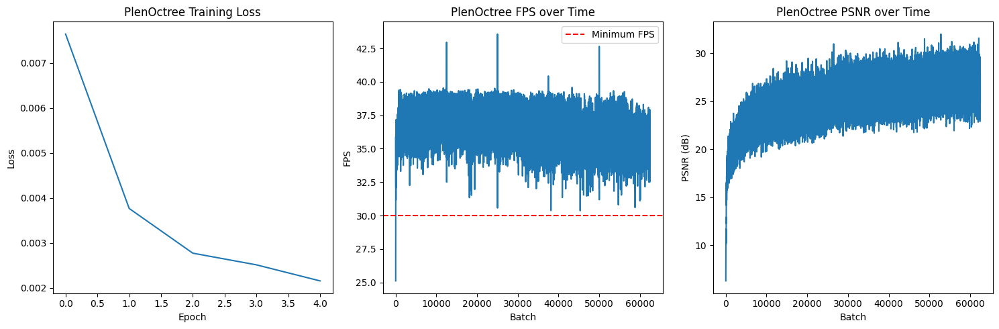

PlenOctree Training Progress:  50%|█████     | 62503/125000 [1:02:25<3:18:49,  5.24it/s]


PlenOctree Epoch 6/10, Batch 0:
FPS: 42.37, Latency: 23.60ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  50%|█████     | 62513/125000 [1:02:26<1:24:23, 12.34it/s]


PlenOctree Epoch 6/10, Batch 10:
FPS: 35.05, Latency: 28.53ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  50%|█████     | 62523/125000 [1:02:26<1:06:35, 15.64it/s]


PlenOctree Epoch 6/10, Batch 20:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  50%|█████     | 62533/125000 [1:02:27<1:03:56, 16.28it/s]


PlenOctree Epoch 6/10, Batch 30:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  50%|█████     | 62543/125000 [1:02:28<1:02:52, 16.56it/s]


PlenOctree Epoch 6/10, Batch 40:
FPS: 37.62, Latency: 26.58ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62553/125000 [1:02:28<1:02:05, 16.76it/s]


PlenOctree Epoch 6/10, Batch 50:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62563/125000 [1:02:29<1:01:29, 16.92it/s]


PlenOctree Epoch 6/10, Batch 60:
FPS: 38.13, Latency: 26.22ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  50%|█████     | 62573/125000 [1:02:29<1:02:33, 16.63it/s]


PlenOctree Epoch 6/10, Batch 70:
FPS: 35.22, Latency: 28.40ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  50%|█████     | 62583/125000 [1:02:30<1:02:40, 16.60it/s]


PlenOctree Epoch 6/10, Batch 80:
FPS: 37.80, Latency: 26.45ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62593/125000 [1:02:31<1:02:15, 16.71it/s]


PlenOctree Epoch 6/10, Batch 90:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62603/125000 [1:02:31<1:02:44, 16.58it/s]


PlenOctree Epoch 6/10, Batch 100:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  50%|█████     | 62613/125000 [1:02:32<1:03:01, 16.50it/s]


PlenOctree Epoch 6/10, Batch 110:
FPS: 35.57, Latency: 28.12ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  50%|█████     | 62623/125000 [1:02:32<1:02:08, 16.73it/s]


PlenOctree Epoch 6/10, Batch 120:
FPS: 38.39, Latency: 26.05ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  50%|█████     | 62633/125000 [1:02:33<1:02:16, 16.69it/s]


PlenOctree Epoch 6/10, Batch 130:
FPS: 35.45, Latency: 28.21ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  50%|█████     | 62643/125000 [1:02:34<1:01:26, 16.92it/s]


PlenOctree Epoch 6/10, Batch 140:
FPS: 36.81, Latency: 27.16ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62653/125000 [1:02:34<1:02:28, 16.63it/s]


PlenOctree Epoch 6/10, Batch 150:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  50%|█████     | 62663/125000 [1:02:35<1:01:10, 16.98it/s]


PlenOctree Epoch 6/10, Batch 160:
FPS: 38.54, Latency: 25.94ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  50%|█████     | 62673/125000 [1:02:35<1:02:28, 16.63it/s]


PlenOctree Epoch 6/10, Batch 170:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  50%|█████     | 62683/125000 [1:02:36<1:02:10, 16.70it/s]


PlenOctree Epoch 6/10, Batch 180:
FPS: 37.79, Latency: 26.46ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62693/125000 [1:02:37<1:02:02, 16.74it/s]


PlenOctree Epoch 6/10, Batch 190:
FPS: 37.35, Latency: 26.77ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  50%|█████     | 62703/125000 [1:02:37<1:02:37, 16.58it/s]


PlenOctree Epoch 6/10, Batch 200:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  50%|█████     | 62713/125000 [1:02:38<1:02:45, 16.54it/s]


PlenOctree Epoch 6/10, Batch 210:
FPS: 36.49, Latency: 27.40ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62723/125000 [1:02:38<1:01:32, 16.86it/s]


PlenOctree Epoch 6/10, Batch 220:
FPS: 35.02, Latency: 28.56ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  50%|█████     | 62733/125000 [1:02:39<1:02:37, 16.57it/s]


PlenOctree Epoch 6/10, Batch 230:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  50%|█████     | 62743/125000 [1:02:40<1:02:31, 16.60it/s]


PlenOctree Epoch 6/10, Batch 240:
FPS: 36.29, Latency: 27.55ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  50%|█████     | 62753/125000 [1:02:40<1:01:31, 16.86it/s]


PlenOctree Epoch 6/10, Batch 250:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  50%|█████     | 62763/125000 [1:02:41<1:02:42, 16.54it/s]


PlenOctree Epoch 6/10, Batch 260:
FPS: 35.73, Latency: 27.98ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62773/125000 [1:02:41<1:02:17, 16.65it/s]


PlenOctree Epoch 6/10, Batch 270:
FPS: 37.09, Latency: 26.96ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  50%|█████     | 62783/125000 [1:02:42<1:01:49, 16.77it/s]


PlenOctree Epoch 6/10, Batch 280:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  50%|█████     | 62793/125000 [1:02:43<1:02:23, 16.62it/s]


PlenOctree Epoch 6/10, Batch 290:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  50%|█████     | 62803/125000 [1:02:43<1:01:31, 16.85it/s]


PlenOctree Epoch 6/10, Batch 300:
FPS: 37.42, Latency: 26.73ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  50%|█████     | 62813/125000 [1:02:44<1:02:17, 16.64it/s]


PlenOctree Epoch 6/10, Batch 310:
FPS: 35.29, Latency: 28.34ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  50%|█████     | 62823/125000 [1:02:44<1:02:43, 16.52it/s]


PlenOctree Epoch 6/10, Batch 320:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  50%|█████     | 62833/125000 [1:02:45<1:02:44, 16.51it/s]


PlenOctree Epoch 6/10, Batch 330:
FPS: 35.76, Latency: 27.97ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  50%|█████     | 62843/125000 [1:02:46<1:02:27, 16.59it/s]


PlenOctree Epoch 6/10, Batch 340:
FPS: 37.23, Latency: 26.86ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  50%|█████     | 62853/125000 [1:02:46<1:01:27, 16.85it/s]


PlenOctree Epoch 6/10, Batch 350:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  50%|█████     | 62863/125000 [1:02:47<1:02:33, 16.55it/s]


PlenOctree Epoch 6/10, Batch 360:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  50%|█████     | 62873/125000 [1:02:47<1:02:37, 16.54it/s]


PlenOctree Epoch 6/10, Batch 370:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  50%|█████     | 62883/125000 [1:02:48<1:02:52, 16.46it/s]


PlenOctree Epoch 6/10, Batch 380:
FPS: 36.13, Latency: 27.67ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  50%|█████     | 62893/125000 [1:02:49<1:03:00, 16.43it/s]


PlenOctree Epoch 6/10, Batch 390:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  50%|█████     | 62903/125000 [1:02:49<1:02:39, 16.52it/s]


PlenOctree Epoch 6/10, Batch 400:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  50%|█████     | 62913/125000 [1:02:50<1:02:27, 16.57it/s]


PlenOctree Epoch 6/10, Batch 410:
FPS: 36.68, Latency: 27.27ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  50%|█████     | 62923/125000 [1:02:50<1:01:45, 16.75it/s]


PlenOctree Epoch 6/10, Batch 420:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  50%|█████     | 62933/125000 [1:02:51<1:02:23, 16.58it/s]


PlenOctree Epoch 6/10, Batch 430:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  50%|█████     | 62943/125000 [1:02:52<1:01:10, 16.91it/s]


PlenOctree Epoch 6/10, Batch 440:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  50%|█████     | 62953/125000 [1:02:52<1:02:07, 16.65it/s]


PlenOctree Epoch 6/10, Batch 450:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  50%|█████     | 62963/125000 [1:02:53<1:01:04, 16.93it/s]


PlenOctree Epoch 6/10, Batch 460:
FPS: 36.00, Latency: 27.78ms
PSNR: 24.18dB, Loss: 0.0038


PlenOctree Training Progress:  50%|█████     | 62973/125000 [1:02:53<1:02:39, 16.50it/s]


PlenOctree Epoch 6/10, Batch 470:
FPS: 36.57, Latency: 27.34ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  50%|█████     | 62983/125000 [1:02:54<1:02:15, 16.60it/s]


PlenOctree Epoch 6/10, Batch 480:
FPS: 36.99, Latency: 27.04ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  50%|█████     | 62993/125000 [1:02:55<1:01:16, 16.87it/s]


PlenOctree Epoch 6/10, Batch 490:
FPS: 37.19, Latency: 26.89ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  50%|█████     | 63003/125000 [1:02:55<1:02:20, 16.58it/s]


PlenOctree Epoch 6/10, Batch 500:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  50%|█████     | 63013/125000 [1:02:56<1:02:24, 16.55it/s]


PlenOctree Epoch 6/10, Batch 510:
FPS: 36.77, Latency: 27.19ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  50%|█████     | 63023/125000 [1:02:56<1:02:28, 16.54it/s]


PlenOctree Epoch 6/10, Batch 520:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  50%|█████     | 63033/125000 [1:02:57<1:01:17, 16.85it/s]


PlenOctree Epoch 6/10, Batch 530:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  50%|█████     | 63043/125000 [1:02:58<1:02:15, 16.59it/s]


PlenOctree Epoch 6/10, Batch 540:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  50%|█████     | 63053/125000 [1:02:58<1:02:31, 16.51it/s]


PlenOctree Epoch 6/10, Batch 550:
FPS: 36.70, Latency: 27.25ms
PSNR: 29.42dB, Loss: 0.0011


PlenOctree Training Progress:  50%|█████     | 63063/125000 [1:02:59<1:02:36, 16.49it/s]


PlenOctree Epoch 6/10, Batch 560:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  50%|█████     | 63073/125000 [1:03:00<1:02:34, 16.49it/s]


PlenOctree Epoch 6/10, Batch 570:
FPS: 35.86, Latency: 27.88ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  50%|█████     | 63083/125000 [1:03:00<1:02:17, 16.57it/s]


PlenOctree Epoch 6/10, Batch 580:
FPS: 37.26, Latency: 26.84ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  50%|█████     | 63093/125000 [1:03:01<1:01:12, 16.86it/s]


PlenOctree Epoch 6/10, Batch 590:
FPS: 36.76, Latency: 27.21ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  50%|█████     | 63103/125000 [1:03:01<1:02:11, 16.59it/s]


PlenOctree Epoch 6/10, Batch 600:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  50%|█████     | 63113/125000 [1:03:02<1:02:23, 16.53it/s]


PlenOctree Epoch 6/10, Batch 610:
FPS: 36.08, Latency: 27.72ms
PSNR: 31.76dB, Loss: 0.0007


PlenOctree Training Progress:  50%|█████     | 63123/125000 [1:03:03<1:01:29, 16.77it/s]


PlenOctree Epoch 6/10, Batch 620:
FPS: 35.03, Latency: 28.55ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 63133/125000 [1:03:03<1:02:11, 16.58it/s]


PlenOctree Epoch 6/10, Batch 630:
FPS: 33.90, Latency: 29.50ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  51%|█████     | 63143/125000 [1:03:04<1:02:29, 16.50it/s]


PlenOctree Epoch 6/10, Batch 640:
FPS: 35.15, Latency: 28.45ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 63153/125000 [1:03:04<1:02:34, 16.47it/s]


PlenOctree Epoch 6/10, Batch 650:
FPS: 34.61, Latency: 28.89ms
PSNR: 29.68dB, Loss: 0.0011


PlenOctree Training Progress:  51%|█████     | 63163/125000 [1:03:05<1:02:29, 16.49it/s]


PlenOctree Epoch 6/10, Batch 660:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  51%|█████     | 63173/125000 [1:03:06<1:00:55, 16.91it/s]


PlenOctree Epoch 6/10, Batch 670:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  51%|█████     | 63183/125000 [1:03:06<1:01:50, 16.66it/s]


PlenOctree Epoch 6/10, Batch 680:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  51%|█████     | 63193/125000 [1:03:07<1:02:04, 16.60it/s]


PlenOctree Epoch 6/10, Batch 690:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63203/125000 [1:03:07<1:02:24, 16.50it/s]


PlenOctree Epoch 6/10, Batch 700:
FPS: 37.47, Latency: 26.69ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63213/125000 [1:03:08<1:01:21, 16.78it/s]


PlenOctree Epoch 6/10, Batch 710:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 63223/125000 [1:03:09<1:02:17, 16.53it/s]


PlenOctree Epoch 6/10, Batch 720:
FPS: 38.03, Latency: 26.29ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 63233/125000 [1:03:09<1:00:49, 16.93it/s]


PlenOctree Epoch 6/10, Batch 730:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 63243/125000 [1:03:10<1:01:50, 16.64it/s]


PlenOctree Epoch 6/10, Batch 740:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63253/125000 [1:03:10<1:00:54, 16.90it/s]


PlenOctree Epoch 6/10, Batch 750:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  51%|█████     | 63263/125000 [1:03:11<1:02:03, 16.58it/s]


PlenOctree Epoch 6/10, Batch 760:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  51%|█████     | 63273/125000 [1:03:12<1:01:54, 16.62it/s]


PlenOctree Epoch 6/10, Batch 770:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63283/125000 [1:03:12<1:00:59, 16.86it/s]


PlenOctree Epoch 6/10, Batch 780:
FPS: 36.87, Latency: 27.12ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  51%|█████     | 63293/125000 [1:03:13<1:02:00, 16.59it/s]


PlenOctree Epoch 6/10, Batch 790:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63303/125000 [1:03:13<1:01:39, 16.68it/s]


PlenOctree Epoch 6/10, Batch 800:
FPS: 37.89, Latency: 26.39ms
PSNR: 24.53dB, Loss: 0.0035


PlenOctree Training Progress:  51%|█████     | 63313/125000 [1:03:14<1:01:23, 16.75it/s]


PlenOctree Epoch 6/10, Batch 810:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63323/125000 [1:03:15<1:02:02, 16.57it/s]


PlenOctree Epoch 6/10, Batch 820:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  51%|█████     | 63333/125000 [1:03:15<1:02:28, 16.45it/s]


PlenOctree Epoch 6/10, Batch 830:
FPS: 35.49, Latency: 28.18ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63343/125000 [1:03:16<1:02:25, 16.46it/s]


PlenOctree Epoch 6/10, Batch 840:
FPS: 34.53, Latency: 28.96ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63353/125000 [1:03:16<1:02:15, 16.50it/s]


PlenOctree Epoch 6/10, Batch 850:
FPS: 35.77, Latency: 27.95ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63363/125000 [1:03:17<1:02:11, 16.52it/s]


PlenOctree Epoch 6/10, Batch 860:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 63373/125000 [1:03:18<1:02:22, 16.47it/s]


PlenOctree Epoch 6/10, Batch 870:
FPS: 35.76, Latency: 27.97ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63383/125000 [1:03:18<1:02:29, 16.43it/s]


PlenOctree Epoch 6/10, Batch 880:
FPS: 35.00, Latency: 28.58ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63393/125000 [1:03:19<1:02:23, 16.46it/s]


PlenOctree Epoch 6/10, Batch 890:
FPS: 35.97, Latency: 27.80ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  51%|█████     | 63403/125000 [1:03:19<1:02:23, 16.45it/s]


PlenOctree Epoch 6/10, Batch 900:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63413/125000 [1:03:20<1:02:16, 16.48it/s]


PlenOctree Epoch 6/10, Batch 910:
FPS: 35.22, Latency: 28.39ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63423/125000 [1:03:21<1:02:14, 16.49it/s]


PlenOctree Epoch 6/10, Batch 920:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  51%|█████     | 63433/125000 [1:03:21<1:01:29, 16.69it/s]


PlenOctree Epoch 6/10, Batch 930:
FPS: 37.69, Latency: 26.53ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  51%|█████     | 63443/125000 [1:03:22<1:01:28, 16.69it/s]


PlenOctree Epoch 6/10, Batch 940:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.16dB, Loss: 0.0031


PlenOctree Training Progress:  51%|█████     | 63453/125000 [1:03:22<1:01:51, 16.58it/s]


PlenOctree Epoch 6/10, Batch 950:
FPS: 35.82, Latency: 27.91ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  51%|█████     | 63463/125000 [1:03:23<1:02:17, 16.47it/s]


PlenOctree Epoch 6/10, Batch 960:
FPS: 35.24, Latency: 28.38ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63473/125000 [1:03:24<1:02:17, 16.46it/s]


PlenOctree Epoch 6/10, Batch 970:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  51%|█████     | 63483/125000 [1:03:24<1:02:09, 16.50it/s]


PlenOctree Epoch 6/10, Batch 980:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63493/125000 [1:03:25<1:02:20, 16.44it/s]


PlenOctree Epoch 6/10, Batch 990:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  51%|█████     | 63503/125000 [1:03:25<1:02:22, 16.43it/s]


PlenOctree Epoch 6/10, Batch 1000:
FPS: 35.90, Latency: 27.85ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 63513/125000 [1:03:26<1:02:11, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1010:
FPS: 35.91, Latency: 27.84ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63523/125000 [1:03:27<1:02:10, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1020:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  51%|█████     | 63533/125000 [1:03:27<1:02:17, 16.45it/s]


PlenOctree Epoch 6/10, Batch 1030:
FPS: 35.50, Latency: 28.17ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  51%|█████     | 63543/125000 [1:03:28<1:02:12, 16.46it/s]


PlenOctree Epoch 6/10, Batch 1040:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  51%|█████     | 63553/125000 [1:03:28<1:01:45, 16.58it/s]


PlenOctree Epoch 6/10, Batch 1050:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63563/125000 [1:03:29<1:00:51, 16.83it/s]


PlenOctree Epoch 6/10, Batch 1060:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████     | 63573/125000 [1:03:30<1:01:54, 16.54it/s]


PlenOctree Epoch 6/10, Batch 1070:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  51%|█████     | 63583/125000 [1:03:30<1:01:04, 16.76it/s]


PlenOctree Epoch 6/10, Batch 1080:
FPS: 36.48, Latency: 27.41ms
PSNR: 29.07dB, Loss: 0.0012


PlenOctree Training Progress:  51%|█████     | 63593/125000 [1:03:31<1:01:28, 16.65it/s]


PlenOctree Epoch 6/10, Batch 1090:
FPS: 36.11, Latency: 27.69ms
PSNR: 30.15dB, Loss: 0.0010


PlenOctree Training Progress:  51%|█████     | 63603/125000 [1:03:31<1:01:48, 16.55it/s]


PlenOctree Epoch 6/10, Batch 1100:
FPS: 36.07, Latency: 27.73ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  51%|█████     | 63613/125000 [1:03:32<1:02:16, 16.43it/s]


PlenOctree Epoch 6/10, Batch 1110:
FPS: 36.11, Latency: 27.69ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  51%|█████     | 63623/125000 [1:03:33<1:02:14, 16.44it/s]


PlenOctree Epoch 6/10, Batch 1120:
FPS: 35.67, Latency: 28.04ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  51%|█████     | 63633/125000 [1:03:33<1:01:55, 16.52it/s]


PlenOctree Epoch 6/10, Batch 1130:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63643/125000 [1:03:34<1:02:03, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1140:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 63653/125000 [1:03:35<1:02:03, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1150:
FPS: 35.12, Latency: 28.47ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  51%|█████     | 63663/125000 [1:03:35<1:02:00, 16.49it/s]


PlenOctree Epoch 6/10, Batch 1160:
FPS: 34.97, Latency: 28.59ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  51%|█████     | 63673/125000 [1:03:36<1:01:59, 16.49it/s]


PlenOctree Epoch 6/10, Batch 1170:
FPS: 35.64, Latency: 28.05ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  51%|█████     | 63683/125000 [1:03:36<1:01:54, 16.51it/s]


PlenOctree Epoch 6/10, Batch 1180:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.09dB, Loss: 0.0039


PlenOctree Training Progress:  51%|█████     | 63693/125000 [1:03:37<1:01:55, 16.50it/s]


PlenOctree Epoch 6/10, Batch 1190:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63703/125000 [1:03:38<1:01:45, 16.54it/s]


PlenOctree Epoch 6/10, Batch 1200:
FPS: 36.99, Latency: 27.03ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  51%|█████     | 63713/125000 [1:03:38<1:00:50, 16.79it/s]


PlenOctree Epoch 6/10, Batch 1210:
FPS: 37.10, Latency: 26.96ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 63723/125000 [1:03:39<1:01:21, 16.64it/s]


PlenOctree Epoch 6/10, Batch 1220:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  51%|█████     | 63733/125000 [1:03:39<1:01:34, 16.58it/s]


PlenOctree Epoch 6/10, Batch 1230:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  51%|█████     | 63743/125000 [1:03:40<1:01:59, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1240:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  51%|█████     | 63753/125000 [1:03:41<1:01:11, 16.68it/s]


PlenOctree Epoch 6/10, Batch 1250:
FPS: 37.63, Latency: 26.58ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63763/125000 [1:03:41<1:00:58, 16.74it/s]


PlenOctree Epoch 6/10, Batch 1260:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  51%|█████     | 63773/125000 [1:03:42<1:01:27, 16.61it/s]


PlenOctree Epoch 6/10, Batch 1270:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63783/125000 [1:03:42<1:01:39, 16.55it/s]


PlenOctree Epoch 6/10, Batch 1280:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  51%|█████     | 63793/125000 [1:03:43<1:01:03, 16.71it/s]


PlenOctree Epoch 6/10, Batch 1290:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63803/125000 [1:03:44<1:01:35, 16.56it/s]


PlenOctree Epoch 6/10, Batch 1300:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63813/125000 [1:03:44<1:00:21, 16.90it/s]


PlenOctree Epoch 6/10, Batch 1310:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  51%|█████     | 63823/125000 [1:03:45<1:01:21, 16.62it/s]


PlenOctree Epoch 6/10, Batch 1320:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████     | 63833/125000 [1:03:45<1:01:24, 16.60it/s]


PlenOctree Epoch 6/10, Batch 1330:
FPS: 37.62, Latency: 26.58ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 63843/125000 [1:03:46<1:00:32, 16.84it/s]


PlenOctree Epoch 6/10, Batch 1340:
FPS: 37.18, Latency: 26.89ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  51%|█████     | 63853/125000 [1:03:47<1:01:37, 16.54it/s]


PlenOctree Epoch 6/10, Batch 1350:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63863/125000 [1:03:47<1:01:34, 16.55it/s]


PlenOctree Epoch 6/10, Batch 1360:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 63873/125000 [1:03:48<1:01:19, 16.61it/s]


PlenOctree Epoch 6/10, Batch 1370:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  51%|█████     | 63883/125000 [1:03:48<1:01:04, 16.68it/s]


PlenOctree Epoch 6/10, Batch 1380:
FPS: 37.10, Latency: 26.96ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63893/125000 [1:03:49<1:01:24, 16.59it/s]


PlenOctree Epoch 6/10, Batch 1390:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  51%|█████     | 63903/125000 [1:03:50<1:00:17, 16.89it/s]


PlenOctree Epoch 6/10, Batch 1400:
FPS: 37.19, Latency: 26.89ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 63913/125000 [1:03:50<1:01:11, 16.64it/s]


PlenOctree Epoch 6/10, Batch 1410:
FPS: 36.64, Latency: 27.30ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  51%|█████     | 63923/125000 [1:03:51<1:01:22, 16.58it/s]


PlenOctree Epoch 6/10, Batch 1420:
FPS: 36.93, Latency: 27.08ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 63933/125000 [1:03:51<1:00:35, 16.80it/s]


PlenOctree Epoch 6/10, Batch 1430:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████     | 63943/125000 [1:03:52<1:01:34, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1440:
FPS: 37.15, Latency: 26.92ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  51%|█████     | 63953/125000 [1:03:53<1:00:49, 16.73it/s]


PlenOctree Epoch 6/10, Batch 1450:
FPS: 37.50, Latency: 26.67ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  51%|█████     | 63963/125000 [1:03:53<1:00:50, 16.72it/s]


PlenOctree Epoch 6/10, Batch 1460:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████     | 63973/125000 [1:03:54<1:01:36, 16.51it/s]


PlenOctree Epoch 6/10, Batch 1470:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  51%|█████     | 63983/125000 [1:03:54<1:01:27, 16.55it/s]


PlenOctree Epoch 6/10, Batch 1480:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  51%|█████     | 63993/125000 [1:03:55<1:00:42, 16.75it/s]


PlenOctree Epoch 6/10, Batch 1490:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████     | 64003/125000 [1:03:56<1:01:11, 16.61it/s]


PlenOctree Epoch 6/10, Batch 1500:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  51%|█████     | 64013/125000 [1:03:56<1:01:21, 16.57it/s]


PlenOctree Epoch 6/10, Batch 1510:
FPS: 36.76, Latency: 27.21ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  51%|█████     | 64023/125000 [1:03:57<1:01:23, 16.55it/s]


PlenOctree Epoch 6/10, Batch 1520:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████     | 64033/125000 [1:03:57<1:00:05, 16.91it/s]


PlenOctree Epoch 6/10, Batch 1530:
FPS: 37.75, Latency: 26.49ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  51%|█████     | 64043/125000 [1:03:58<1:01:26, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1540:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.88dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████     | 64053/125000 [1:03:59<1:01:14, 16.59it/s]


PlenOctree Epoch 6/10, Batch 1550:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  51%|█████▏    | 64063/125000 [1:03:59<1:00:31, 16.78it/s]


PlenOctree Epoch 6/10, Batch 1560:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████▏    | 64073/125000 [1:04:00<1:01:24, 16.54it/s]


PlenOctree Epoch 6/10, Batch 1570:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  51%|█████▏    | 64083/125000 [1:04:00<1:00:38, 16.74it/s]


PlenOctree Epoch 6/10, Batch 1580:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  51%|█████▏    | 64093/125000 [1:04:01<1:00:54, 16.67it/s]


PlenOctree Epoch 6/10, Batch 1590:
FPS: 36.68, Latency: 27.27ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  51%|█████▏    | 64103/125000 [1:04:02<1:01:23, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1600:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  51%|█████▏    | 64113/125000 [1:04:02<1:01:39, 16.46it/s]


PlenOctree Epoch 6/10, Batch 1610:
FPS: 34.90, Latency: 28.65ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████▏    | 64123/125000 [1:04:03<1:01:29, 16.50it/s]


PlenOctree Epoch 6/10, Batch 1620:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████▏    | 64133/125000 [1:04:03<1:01:14, 16.56it/s]


PlenOctree Epoch 6/10, Batch 1630:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  51%|█████▏    | 64143/125000 [1:04:04<1:01:27, 16.50it/s]


PlenOctree Epoch 6/10, Batch 1640:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  51%|█████▏    | 64153/125000 [1:04:05<1:01:18, 16.54it/s]


PlenOctree Epoch 6/10, Batch 1650:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  51%|█████▏    | 64163/125000 [1:04:05<59:56, 16.92it/s]  


PlenOctree Epoch 6/10, Batch 1660:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████▏    | 64173/125000 [1:04:06<1:01:24, 16.51it/s]


PlenOctree Epoch 6/10, Batch 1670:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████▏    | 64183/125000 [1:04:06<1:01:06, 16.59it/s]


PlenOctree Epoch 6/10, Batch 1680:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████▏    | 64193/125000 [1:04:07<1:00:09, 16.85it/s]


PlenOctree Epoch 6/10, Batch 1690:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  51%|█████▏    | 64203/125000 [1:04:08<1:01:01, 16.60it/s]


PlenOctree Epoch 6/10, Batch 1700:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  51%|█████▏    | 64213/125000 [1:04:08<1:01:05, 16.58it/s]


PlenOctree Epoch 6/10, Batch 1710:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  51%|█████▏    | 64223/125000 [1:04:09<1:01:16, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1720:
FPS: 37.20, Latency: 26.88ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  51%|█████▏    | 64233/125000 [1:04:09<1:00:05, 16.85it/s]


PlenOctree Epoch 6/10, Batch 1730:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████▏    | 64243/125000 [1:04:10<1:01:15, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1740:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  51%|█████▏    | 64253/125000 [1:04:11<1:01:21, 16.50it/s]


PlenOctree Epoch 6/10, Batch 1750:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  51%|█████▏    | 64263/125000 [1:04:11<1:01:19, 16.51it/s]


PlenOctree Epoch 6/10, Batch 1760:
FPS: 36.17, Latency: 27.64ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████▏    | 64273/125000 [1:04:12<1:01:41, 16.41it/s]


PlenOctree Epoch 6/10, Batch 1770:
FPS: 35.55, Latency: 28.13ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████▏    | 64283/125000 [1:04:12<1:01:25, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1780:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  51%|█████▏    | 64293/125000 [1:04:13<1:01:05, 16.56it/s]


PlenOctree Epoch 6/10, Batch 1790:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  51%|█████▏    | 64303/125000 [1:04:14<1:01:13, 16.52it/s]


PlenOctree Epoch 6/10, Batch 1800:
FPS: 34.96, Latency: 28.60ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  51%|█████▏    | 64313/125000 [1:04:14<1:01:16, 16.51it/s]


PlenOctree Epoch 6/10, Batch 1810:
FPS: 35.54, Latency: 28.13ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  51%|█████▏    | 64323/125000 [1:04:15<1:01:12, 16.52it/s]


PlenOctree Epoch 6/10, Batch 1820:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  51%|█████▏    | 64333/125000 [1:04:15<1:01:23, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1830:
FPS: 36.72, Latency: 27.23ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  51%|█████▏    | 64343/125000 [1:04:16<1:01:21, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1840:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  51%|█████▏    | 64353/125000 [1:04:17<1:01:21, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1850:
FPS: 36.91, Latency: 27.09ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  51%|█████▏    | 64363/125000 [1:04:17<1:01:22, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1860:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  51%|█████▏    | 64373/125000 [1:04:18<1:01:19, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1870:
FPS: 36.73, Latency: 27.23ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  52%|█████▏    | 64383/125000 [1:04:19<1:01:13, 16.50it/s]


PlenOctree Epoch 6/10, Batch 1880:
FPS: 35.81, Latency: 27.93ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  52%|█████▏    | 64393/125000 [1:04:19<1:01:18, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1890:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 64403/125000 [1:04:20<1:01:13, 16.50it/s]


PlenOctree Epoch 6/10, Batch 1900:
FPS: 35.49, Latency: 28.18ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 64413/125000 [1:04:20<1:01:20, 16.46it/s]


PlenOctree Epoch 6/10, Batch 1910:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  52%|█████▏    | 64423/125000 [1:04:21<1:01:04, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1920:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 64433/125000 [1:04:22<1:00:58, 16.56it/s]


PlenOctree Epoch 6/10, Batch 1930:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  52%|█████▏    | 64443/125000 [1:04:22<59:54, 16.85it/s]  


PlenOctree Epoch 6/10, Batch 1940:
FPS: 37.04, Latency: 27.00ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  52%|█████▏    | 64453/125000 [1:04:23<1:00:52, 16.58it/s]


PlenOctree Epoch 6/10, Batch 1950:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  52%|█████▏    | 64463/125000 [1:04:23<1:01:02, 16.53it/s]


PlenOctree Epoch 6/10, Batch 1960:
FPS: 35.48, Latency: 28.18ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 64473/125000 [1:04:24<1:01:15, 16.47it/s]


PlenOctree Epoch 6/10, Batch 1970:
FPS: 34.20, Latency: 29.24ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  52%|█████▏    | 64483/125000 [1:04:25<1:01:10, 16.49it/s]


PlenOctree Epoch 6/10, Batch 1980:
FPS: 35.80, Latency: 27.94ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 64493/125000 [1:04:25<1:01:10, 16.48it/s]


PlenOctree Epoch 6/10, Batch 1990:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  52%|█████▏    | 64503/125000 [1:04:26<1:01:26, 16.41it/s]


PlenOctree Epoch 6/10, Batch 2000:
FPS: 36.04, Latency: 27.74ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  52%|█████▏    | 64513/125000 [1:04:26<1:01:20, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2010:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 64523/125000 [1:04:27<1:01:17, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2020:
FPS: 34.97, Latency: 28.60ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64533/125000 [1:04:28<1:01:15, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2030:
FPS: 36.12, Latency: 27.68ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 64543/125000 [1:04:28<1:01:12, 16.46it/s]


PlenOctree Epoch 6/10, Batch 2040:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 64553/125000 [1:04:29<1:00:55, 16.54it/s]


PlenOctree Epoch 6/10, Batch 2050:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 64563/125000 [1:04:29<59:57, 16.80it/s]


PlenOctree Epoch 6/10, Batch 2060:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 64573/125000 [1:04:30<1:00:53, 16.54it/s]


PlenOctree Epoch 6/10, Batch 2070:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  52%|█████▏    | 64583/125000 [1:04:31<1:00:56, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2080:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 64593/125000 [1:04:31<59:42, 16.86it/s]


PlenOctree Epoch 6/10, Batch 2090:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  52%|█████▏    | 64603/125000 [1:04:32<1:00:49, 16.55it/s]


PlenOctree Epoch 6/10, Batch 2100:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 64613/125000 [1:04:32<1:01:02, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2110:
FPS: 35.72, Latency: 27.99ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 64623/125000 [1:04:33<1:01:00, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2120:
FPS: 36.73, Latency: 27.22ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 64633/125000 [1:04:34<1:01:14, 16.43it/s]


PlenOctree Epoch 6/10, Batch 2130:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  52%|█████▏    | 64643/125000 [1:04:34<1:00:58, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2140:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  52%|█████▏    | 64653/125000 [1:04:35<1:01:00, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2150:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.32dB, Loss: 0.0029


PlenOctree Training Progress:  52%|█████▏    | 64663/125000 [1:04:35<1:01:03, 16.47it/s]


PlenOctree Epoch 6/10, Batch 2160:
FPS: 34.91, Latency: 28.64ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 64673/125000 [1:04:36<1:01:04, 16.46it/s]


PlenOctree Epoch 6/10, Batch 2170:
FPS: 35.45, Latency: 28.21ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 64683/125000 [1:04:37<1:01:03, 16.47it/s]


PlenOctree Epoch 6/10, Batch 2180:
FPS: 35.05, Latency: 28.53ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  52%|█████▏    | 64693/125000 [1:04:37<1:00:45, 16.54it/s]


PlenOctree Epoch 6/10, Batch 2190:
FPS: 36.45, Latency: 27.43ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 64703/125000 [1:04:38<1:00:59, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2200:
FPS: 34.62, Latency: 28.88ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 64713/125000 [1:04:38<1:01:05, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2210:
FPS: 35.56, Latency: 28.12ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64723/125000 [1:04:39<1:01:04, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2220:
FPS: 34.31, Latency: 29.14ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 64733/125000 [1:04:40<1:01:02, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2230:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64743/125000 [1:04:40<1:00:50, 16.51it/s]


PlenOctree Epoch 6/10, Batch 2240:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64753/125000 [1:04:41<1:00:46, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2250:
FPS: 37.03, Latency: 27.00ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64763/125000 [1:04:42<1:00:54, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2260:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  52%|█████▏    | 64773/125000 [1:04:42<1:01:02, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2270:
FPS: 34.82, Latency: 28.72ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  52%|█████▏    | 64783/125000 [1:04:43<1:00:51, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2280:
FPS: 35.00, Latency: 28.57ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  52%|█████▏    | 64793/125000 [1:04:43<1:01:00, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2290:
FPS: 35.67, Latency: 28.04ms
PSNR: 29.55dB, Loss: 0.0011


PlenOctree Training Progress:  52%|█████▏    | 64803/125000 [1:04:44<1:00:58, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2300:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  52%|█████▏    | 64813/125000 [1:04:45<1:00:58, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2310:
FPS: 37.36, Latency: 26.77ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  52%|█████▏    | 64823/125000 [1:04:45<1:01:01, 16.43it/s]


PlenOctree Epoch 6/10, Batch 2320:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  52%|█████▏    | 64833/125000 [1:04:46<1:00:51, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2330:
FPS: 35.64, Latency: 28.06ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  52%|█████▏    | 64843/125000 [1:04:46<1:00:40, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2340:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64853/125000 [1:04:47<1:00:47, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2350:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  52%|█████▏    | 64863/125000 [1:04:48<1:00:43, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2360:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 64873/125000 [1:04:48<1:00:46, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2370:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  52%|█████▏    | 64883/125000 [1:04:49<1:00:46, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2380:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 64893/125000 [1:04:49<1:00:35, 16.53it/s]


PlenOctree Epoch 6/10, Batch 2390:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 64903/125000 [1:04:50<1:00:43, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2400:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 64913/125000 [1:04:51<1:00:45, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2410:
FPS: 35.38, Latency: 28.27ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  52%|█████▏    | 64923/125000 [1:04:51<1:00:42, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2420:
FPS: 35.40, Latency: 28.25ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  52%|█████▏    | 64933/125000 [1:04:52<1:00:40, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2430:
FPS: 36.73, Latency: 27.22ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 64943/125000 [1:04:52<1:00:49, 16.46it/s]


PlenOctree Epoch 6/10, Batch 2440:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 64953/125000 [1:04:53<1:00:43, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2450:
FPS: 35.73, Latency: 27.99ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  52%|█████▏    | 64963/125000 [1:04:54<1:00:37, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2460:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  52%|█████▏    | 64973/125000 [1:04:54<1:00:31, 16.53it/s]


PlenOctree Epoch 6/10, Batch 2470:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  52%|█████▏    | 64983/125000 [1:04:55<1:00:50, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2480:
FPS: 36.83, Latency: 27.15ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 64993/125000 [1:04:55<1:00:36, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2490:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65003/125000 [1:04:56<1:00:32, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2500:
FPS: 36.24, Latency: 27.60ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65013/125000 [1:04:57<1:00:47, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2510:
FPS: 37.53, Latency: 26.64ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  52%|█████▏    | 65023/125000 [1:04:57<1:00:31, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2520:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 65033/125000 [1:04:58<1:00:21, 16.56it/s]


PlenOctree Epoch 6/10, Batch 2530:
FPS: 35.45, Latency: 28.21ms
PSNR: 24.42dB, Loss: 0.0036


PlenOctree Training Progress:  52%|█████▏    | 65043/125000 [1:04:59<1:00:45, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2540:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  52%|█████▏    | 65053/125000 [1:04:59<59:46, 16.72it/s]  


PlenOctree Epoch 6/10, Batch 2550:
FPS: 36.88, Latency: 27.11ms
PSNR: 22.56dB, Loss: 0.0055


PlenOctree Training Progress:  52%|█████▏    | 65063/125000 [1:05:00<1:00:13, 16.59it/s]


PlenOctree Epoch 6/10, Batch 2560:
FPS: 36.09, Latency: 27.71ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  52%|█████▏    | 65073/125000 [1:05:00<1:00:12, 16.59it/s]


PlenOctree Epoch 6/10, Batch 2570:
FPS: 37.34, Latency: 26.78ms
PSNR: 24.86dB, Loss: 0.0033


PlenOctree Training Progress:  52%|█████▏    | 65083/125000 [1:05:01<1:00:50, 16.41it/s]


PlenOctree Epoch 6/10, Batch 2580:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  52%|█████▏    | 65093/125000 [1:05:02<1:00:21, 16.54it/s]


PlenOctree Epoch 6/10, Batch 2590:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  52%|█████▏    | 65103/125000 [1:05:02<1:00:31, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2600:
FPS: 35.24, Latency: 28.37ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  52%|█████▏    | 65113/125000 [1:05:03<1:00:45, 16.43it/s]


PlenOctree Epoch 6/10, Batch 2610:
FPS: 34.11, Latency: 29.32ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  52%|█████▏    | 65123/125000 [1:05:03<1:00:17, 16.55it/s]


PlenOctree Epoch 6/10, Batch 2620:
FPS: 36.85, Latency: 27.13ms
PSNR: 23.43dB, Loss: 0.0045


PlenOctree Training Progress:  52%|█████▏    | 65133/125000 [1:05:04<1:00:26, 16.51it/s]


PlenOctree Epoch 6/10, Batch 2630:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  52%|█████▏    | 65143/125000 [1:05:05<1:00:29, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2640:
FPS: 37.34, Latency: 26.78ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  52%|█████▏    | 65153/125000 [1:05:05<1:00:40, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2650:
FPS: 36.25, Latency: 27.59ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 65163/125000 [1:05:06<1:00:36, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2660:
FPS: 36.77, Latency: 27.19ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  52%|█████▏    | 65173/125000 [1:05:06<1:00:23, 16.51it/s]


PlenOctree Epoch 6/10, Batch 2670:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  52%|█████▏    | 65183/125000 [1:05:07<1:00:29, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2680:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 65193/125000 [1:05:08<1:00:29, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2690:
FPS: 35.87, Latency: 27.88ms
PSNR: 29.07dB, Loss: 0.0012


PlenOctree Training Progress:  52%|█████▏    | 65203/125000 [1:05:08<1:00:31, 16.47it/s]


PlenOctree Epoch 6/10, Batch 2700:
FPS: 36.21, Latency: 27.61ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 65213/125000 [1:05:09<1:00:29, 16.47it/s]


PlenOctree Epoch 6/10, Batch 2710:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 65223/125000 [1:05:09<1:00:28, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2720:
FPS: 35.02, Latency: 28.56ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  52%|█████▏    | 65233/125000 [1:05:10<1:00:14, 16.53it/s]


PlenOctree Epoch 6/10, Batch 2730:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 65243/125000 [1:05:11<1:00:25, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2740:
FPS: 35.64, Latency: 28.06ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  52%|█████▏    | 65253/125000 [1:05:11<1:00:28, 16.46it/s]


PlenOctree Epoch 6/10, Batch 2750:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  52%|█████▏    | 65263/125000 [1:05:12<1:00:33, 16.44it/s]


PlenOctree Epoch 6/10, Batch 2760:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 65273/125000 [1:05:12<1:00:13, 16.53it/s]


PlenOctree Epoch 6/10, Batch 2770:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 65283/125000 [1:05:13<1:00:22, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2780:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 65293/125000 [1:05:14<1:00:15, 16.51it/s]


PlenOctree Epoch 6/10, Batch 2790:
FPS: 35.33, Latency: 28.31ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 65303/125000 [1:05:14<1:00:24, 16.47it/s]


PlenOctree Epoch 6/10, Batch 2800:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  52%|█████▏    | 65313/125000 [1:05:15<1:00:27, 16.45it/s]


PlenOctree Epoch 6/10, Batch 2810:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 65323/125000 [1:05:15<1:00:16, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2820:
FPS: 36.60, Latency: 27.32ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  52%|█████▏    | 65333/125000 [1:05:16<1:00:18, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2830:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  52%|█████▏    | 65343/125000 [1:05:17<1:00:19, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2840:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  52%|█████▏    | 65353/125000 [1:05:17<1:00:30, 16.43it/s]


PlenOctree Epoch 6/10, Batch 2850:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  52%|█████▏    | 65363/125000 [1:05:18<1:00:19, 16.47it/s]


PlenOctree Epoch 6/10, Batch 2860:
FPS: 36.11, Latency: 27.70ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 65373/125000 [1:05:19<1:00:14, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2870:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 65383/125000 [1:05:19<1:00:08, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2880:
FPS: 35.38, Latency: 28.27ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  52%|█████▏    | 65393/125000 [1:05:20<1:00:17, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2890:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 65403/125000 [1:05:20<1:00:21, 16.46it/s]


PlenOctree Epoch 6/10, Batch 2900:
FPS: 35.80, Latency: 27.93ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  52%|█████▏    | 65413/125000 [1:05:21<1:00:10, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2910:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  52%|█████▏    | 65423/125000 [1:05:22<1:00:16, 16.48it/s]


PlenOctree Epoch 6/10, Batch 2920:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65433/125000 [1:05:22<1:00:11, 16.49it/s]


PlenOctree Epoch 6/10, Batch 2930:
FPS: 35.81, Latency: 27.93ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  52%|█████▏    | 65443/125000 [1:05:23<1:00:09, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2940:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  52%|█████▏    | 65453/125000 [1:05:23<1:00:02, 16.53it/s]


PlenOctree Epoch 6/10, Batch 2950:
FPS: 35.70, Latency: 28.01ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65463/125000 [1:05:24<1:00:04, 16.52it/s]


PlenOctree Epoch 6/10, Batch 2960:
FPS: 36.11, Latency: 27.70ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65473/125000 [1:05:25<1:00:07, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2970:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65483/125000 [1:05:25<1:00:22, 16.43it/s]


PlenOctree Epoch 6/10, Batch 2980:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 65493/125000 [1:05:26<1:00:06, 16.50it/s]


PlenOctree Epoch 6/10, Batch 2990:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  52%|█████▏    | 65503/125000 [1:05:26<1:00:10, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3000:
FPS: 34.97, Latency: 28.59ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 65513/125000 [1:05:27<1:00:12, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3010:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65523/125000 [1:05:28<59:58, 16.53it/s]  


PlenOctree Epoch 6/10, Batch 3020:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  52%|█████▏    | 65533/125000 [1:05:28<59:02, 16.79it/s]


PlenOctree Epoch 6/10, Batch 3030:
FPS: 37.44, Latency: 26.71ms
PSNR: 30.15dB, Loss: 0.0010


PlenOctree Training Progress:  52%|█████▏    | 65543/125000 [1:05:29<59:25, 16.68it/s]


PlenOctree Epoch 6/10, Batch 3040:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  52%|█████▏    | 65553/125000 [1:05:29<59:36, 16.62it/s]


PlenOctree Epoch 6/10, Batch 3050:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  52%|█████▏    | 65563/125000 [1:05:30<59:10, 16.74it/s]


PlenOctree Epoch 6/10, Batch 3060:
FPS: 36.66, Latency: 27.27ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  52%|█████▏    | 65573/125000 [1:05:31<59:31, 16.64it/s]


PlenOctree Epoch 6/10, Batch 3070:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  52%|█████▏    | 65583/125000 [1:05:31<59:39, 16.60it/s]


PlenOctree Epoch 6/10, Batch 3080:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  52%|█████▏    | 65593/125000 [1:05:32<58:51, 16.82it/s]


PlenOctree Epoch 6/10, Batch 3090:
FPS: 37.10, Latency: 26.95ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  52%|█████▏    | 65603/125000 [1:05:32<59:51, 16.54it/s]


PlenOctree Epoch 6/10, Batch 3100:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  52%|█████▏    | 65613/125000 [1:05:33<59:55, 16.52it/s]  


PlenOctree Epoch 6/10, Batch 3110:
FPS: 36.29, Latency: 27.56ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  52%|█████▏    | 65623/125000 [1:05:34<59:48, 16.55it/s]


PlenOctree Epoch 6/10, Batch 3120:
FPS: 37.41, Latency: 26.73ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  53%|█████▎    | 65633/125000 [1:05:34<58:45, 16.84it/s]


PlenOctree Epoch 6/10, Batch 3130:
FPS: 38.44, Latency: 26.02ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 65643/125000 [1:05:35<59:47, 16.54it/s]


PlenOctree Epoch 6/10, Batch 3140:
FPS: 36.92, Latency: 27.09ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  53%|█████▎    | 65653/125000 [1:05:35<59:27, 16.64it/s]


PlenOctree Epoch 6/10, Batch 3150:
FPS: 37.25, Latency: 26.84ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 65663/125000 [1:05:36<58:44, 16.84it/s]


PlenOctree Epoch 6/10, Batch 3160:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 65673/125000 [1:05:37<59:56, 16.50it/s]


PlenOctree Epoch 6/10, Batch 3170:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 65683/125000 [1:05:37<59:53, 16.51it/s]


PlenOctree Epoch 6/10, Batch 3180:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  53%|█████▎    | 65693/125000 [1:05:38<59:55, 16.49it/s]  


PlenOctree Epoch 6/10, Batch 3190:
FPS: 36.67, Latency: 27.27ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  53%|█████▎    | 65703/125000 [1:05:38<59:49, 16.52it/s]


PlenOctree Epoch 6/10, Batch 3200:
FPS: 36.06, Latency: 27.73ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  53%|█████▎    | 65713/125000 [1:05:39<59:55, 16.49it/s]


PlenOctree Epoch 6/10, Batch 3210:
FPS: 37.33, Latency: 26.79ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 65723/125000 [1:05:40<59:58, 16.47it/s]  


PlenOctree Epoch 6/10, Batch 3220:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 65733/125000 [1:05:40<58:26, 16.90it/s]


PlenOctree Epoch 6/10, Batch 3230:
FPS: 37.21, Latency: 26.87ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 65743/125000 [1:05:41<59:27, 16.61it/s]


PlenOctree Epoch 6/10, Batch 3240:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  53%|█████▎    | 65753/125000 [1:05:41<59:45, 16.52it/s]


PlenOctree Epoch 6/10, Batch 3250:
FPS: 37.79, Latency: 26.46ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 65763/125000 [1:05:42<59:49, 16.50it/s]  


PlenOctree Epoch 6/10, Batch 3260:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  53%|█████▎    | 65773/125000 [1:05:43<58:33, 16.85it/s]


PlenOctree Epoch 6/10, Batch 3270:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  53%|█████▎    | 65783/125000 [1:05:43<59:30, 16.59it/s]


PlenOctree Epoch 6/10, Batch 3280:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 65793/125000 [1:05:44<1:00:02, 16.43it/s]


PlenOctree Epoch 6/10, Batch 3290:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 65803/125000 [1:05:45<59:53, 16.47it/s]  


PlenOctree Epoch 6/10, Batch 3300:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  53%|█████▎    | 65813/125000 [1:05:45<59:53, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3310:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  53%|█████▎    | 65823/125000 [1:05:46<59:42, 16.52it/s]


PlenOctree Epoch 6/10, Batch 3320:
FPS: 36.79, Latency: 27.18ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 65833/125000 [1:05:46<58:35, 16.83it/s]


PlenOctree Epoch 6/10, Batch 3330:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 65843/125000 [1:05:47<59:34, 16.55it/s]


PlenOctree Epoch 6/10, Batch 3340:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 65853/125000 [1:05:48<59:30, 16.57it/s]


PlenOctree Epoch 6/10, Batch 3350:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 65863/125000 [1:05:48<58:40, 16.80it/s]


PlenOctree Epoch 6/10, Batch 3360:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  53%|█████▎    | 65873/125000 [1:05:49<59:36, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3370:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 65883/125000 [1:05:49<59:57, 16.43it/s]


PlenOctree Epoch 6/10, Batch 3380:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 65893/125000 [1:05:50<59:32, 16.54it/s]  


PlenOctree Epoch 6/10, Batch 3390:
FPS: 34.74, Latency: 28.79ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  53%|█████▎    | 65903/125000 [1:05:51<59:55, 16.44it/s]


PlenOctree Epoch 6/10, Batch 3400:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 65913/125000 [1:05:51<59:49, 16.46it/s]


PlenOctree Epoch 6/10, Batch 3410:
FPS: 34.83, Latency: 28.71ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  53%|█████▎    | 65923/125000 [1:05:52<59:38, 16.51it/s]


PlenOctree Epoch 6/10, Batch 3420:
FPS: 34.84, Latency: 28.71ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 65933/125000 [1:05:52<59:32, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3430:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  53%|█████▎    | 65943/125000 [1:05:53<59:32, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3440:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  53%|█████▎    | 65953/125000 [1:05:54<59:46, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3450:
FPS: 36.64, Latency: 27.29ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 65963/125000 [1:05:54<58:31, 16.81it/s]


PlenOctree Epoch 6/10, Batch 3460:
FPS: 37.57, Latency: 26.62ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 65973/125000 [1:05:55<59:15, 16.60it/s]


PlenOctree Epoch 6/10, Batch 3470:
FPS: 35.73, Latency: 27.98ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 65983/125000 [1:05:55<59:29, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3480:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  53%|█████▎    | 65993/125000 [1:05:56<59:34, 16.51it/s]


PlenOctree Epoch 6/10, Batch 3490:
FPS: 36.45, Latency: 27.43ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 66003/125000 [1:05:57<59:46, 16.45it/s]


PlenOctree Epoch 6/10, Batch 3500:
FPS: 36.89, Latency: 27.11ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66013/125000 [1:05:57<59:29, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3510:
FPS: 36.52, Latency: 27.38ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  53%|█████▎    | 66023/125000 [1:05:58<59:28, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3520:
FPS: 37.74, Latency: 26.49ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  53%|█████▎    | 66033/125000 [1:05:58<58:14, 16.87it/s]


PlenOctree Epoch 6/10, Batch 3530:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66043/125000 [1:05:59<59:21, 16.55it/s]


PlenOctree Epoch 6/10, Batch 3540:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  53%|█████▎    | 66053/125000 [1:06:00<59:07, 16.62it/s]


PlenOctree Epoch 6/10, Batch 3550:
FPS: 37.05, Latency: 26.99ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66063/125000 [1:06:00<59:11, 16.60it/s]


PlenOctree Epoch 6/10, Batch 3560:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 66073/125000 [1:06:01<59:01, 16.64it/s]


PlenOctree Epoch 6/10, Batch 3570:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 66083/125000 [1:06:01<59:27, 16.51it/s]


PlenOctree Epoch 6/10, Batch 3580:
FPS: 34.47, Latency: 29.01ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 66093/125000 [1:06:02<59:34, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3590:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66103/125000 [1:06:03<59:14, 16.57it/s]


PlenOctree Epoch 6/10, Batch 3600:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 66113/125000 [1:06:03<59:49, 16.41it/s]


PlenOctree Epoch 6/10, Batch 3610:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 66123/125000 [1:06:04<59:35, 16.46it/s]


PlenOctree Epoch 6/10, Batch 3620:
FPS: 36.65, Latency: 27.28ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress:  53%|█████▎    | 66133/125000 [1:06:04<59:31, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3630:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  53%|█████▎    | 66143/125000 [1:06:05<59:34, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3640:
FPS: 35.68, Latency: 28.03ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  53%|█████▎    | 66153/125000 [1:06:06<59:27, 16.50it/s]


PlenOctree Epoch 6/10, Batch 3650:
FPS: 37.70, Latency: 26.53ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  53%|█████▎    | 66163/125000 [1:06:06<59:37, 16.45it/s]


PlenOctree Epoch 6/10, Batch 3660:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66173/125000 [1:06:07<59:37, 16.44it/s]


PlenOctree Epoch 6/10, Batch 3670:
FPS: 35.53, Latency: 28.15ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 66183/125000 [1:06:07<59:30, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3680:
FPS: 35.81, Latency: 27.93ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  53%|█████▎    | 66193/125000 [1:06:08<59:28, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3690:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  53%|█████▎    | 66203/125000 [1:06:09<59:28, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3700:
FPS: 35.23, Latency: 28.38ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  53%|█████▎    | 66213/125000 [1:06:09<59:11, 16.55it/s]


PlenOctree Epoch 6/10, Batch 3710:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  53%|█████▎    | 66223/125000 [1:06:10<59:21, 16.51it/s]


PlenOctree Epoch 6/10, Batch 3720:
FPS: 36.45, Latency: 27.43ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 66233/125000 [1:06:11<59:23, 16.49it/s]


PlenOctree Epoch 6/10, Batch 3730:
FPS: 36.84, Latency: 27.14ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66243/125000 [1:06:11<59:32, 16.45it/s]


PlenOctree Epoch 6/10, Batch 3740:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66253/125000 [1:06:12<59:21, 16.49it/s]


PlenOctree Epoch 6/10, Batch 3750:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 66263/125000 [1:06:12<59:12, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3760:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66273/125000 [1:06:13<59:25, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3770:
FPS: 36.61, Latency: 27.32ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66283/125000 [1:06:14<59:34, 16.43it/s]


PlenOctree Epoch 6/10, Batch 3780:
FPS: 36.16, Latency: 27.65ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 66293/125000 [1:06:14<59:11, 16.53it/s]


PlenOctree Epoch 6/10, Batch 3790:
FPS: 37.06, Latency: 26.98ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 66303/125000 [1:06:15<59:28, 16.45it/s]


PlenOctree Epoch 6/10, Batch 3800:
FPS: 34.48, Latency: 29.00ms
PSNR: 30.01dB, Loss: 0.0010


PlenOctree Training Progress:  53%|█████▎    | 66313/125000 [1:06:15<59:22, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3810:
FPS: 34.33, Latency: 29.13ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66323/125000 [1:06:16<59:03, 16.56it/s]


PlenOctree Epoch 6/10, Batch 3820:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 66333/125000 [1:06:17<59:16, 16.50it/s]


PlenOctree Epoch 6/10, Batch 3830:
FPS: 36.20, Latency: 27.63ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 66343/125000 [1:06:17<59:18, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3840:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  53%|█████▎    | 66353/125000 [1:06:18<59:18, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3850:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.57dB, Loss: 0.0044


PlenOctree Training Progress:  53%|█████▎    | 66363/125000 [1:06:18<59:19, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3860:
FPS: 35.07, Latency: 28.52ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  53%|█████▎    | 66373/125000 [1:06:19<59:09, 16.52it/s]


PlenOctree Epoch 6/10, Batch 3870:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  53%|█████▎    | 66383/125000 [1:06:20<59:23, 16.45it/s]


PlenOctree Epoch 6/10, Batch 3880:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66393/125000 [1:06:20<59:21, 16.46it/s]


PlenOctree Epoch 6/10, Batch 3890:
FPS: 35.27, Latency: 28.35ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  53%|█████▎    | 66403/125000 [1:06:21<59:13, 16.49it/s]


PlenOctree Epoch 6/10, Batch 3900:
FPS: 35.64, Latency: 28.05ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 66413/125000 [1:06:21<59:10, 16.50it/s]


PlenOctree Epoch 6/10, Batch 3910:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  53%|█████▎    | 66423/125000 [1:06:22<59:23, 16.44it/s]


PlenOctree Epoch 6/10, Batch 3920:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66433/125000 [1:06:23<59:05, 16.52it/s]


PlenOctree Epoch 6/10, Batch 3930:
FPS: 36.65, Latency: 27.28ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  53%|█████▎    | 66443/125000 [1:06:23<59:08, 16.50it/s]


PlenOctree Epoch 6/10, Batch 3940:
FPS: 36.33, Latency: 27.52ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66453/125000 [1:06:24<59:15, 16.47it/s]


PlenOctree Epoch 6/10, Batch 3950:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  53%|█████▎    | 66463/125000 [1:06:24<59:11, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3960:
FPS: 37.15, Latency: 26.92ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  53%|█████▎    | 66473/125000 [1:06:25<59:22, 16.43it/s]


PlenOctree Epoch 6/10, Batch 3970:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 66483/125000 [1:06:26<59:10, 16.48it/s]


PlenOctree Epoch 6/10, Batch 3980:
FPS: 33.48, Latency: 29.87ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66493/125000 [1:06:26<59:06, 16.50it/s]


PlenOctree Epoch 6/10, Batch 3990:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66503/125000 [1:06:27<59:09, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4000:
FPS: 35.18, Latency: 28.43ms
PSNR: 29.47dB, Loss: 0.0011


PlenOctree Training Progress:  53%|█████▎    | 66513/125000 [1:06:28<59:02, 16.51it/s]


PlenOctree Epoch 6/10, Batch 4010:
FPS: 35.28, Latency: 28.34ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  53%|█████▎    | 66523/125000 [1:06:28<59:15, 16.45it/s]


PlenOctree Epoch 6/10, Batch 4020:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  53%|█████▎    | 66533/125000 [1:06:29<59:05, 16.49it/s]


PlenOctree Epoch 6/10, Batch 4030:
FPS: 36.34, Latency: 27.52ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 66543/125000 [1:06:29<59:19, 16.42it/s]


PlenOctree Epoch 6/10, Batch 4040:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 66553/125000 [1:06:30<59:06, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4050:
FPS: 35.46, Latency: 28.20ms
PSNR: 28.70dB, Loss: 0.0014


PlenOctree Training Progress:  53%|█████▎    | 66563/125000 [1:06:31<58:58, 16.51it/s]


PlenOctree Epoch 6/10, Batch 4060:
FPS: 36.32, Latency: 27.53ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  53%|█████▎    | 66573/125000 [1:06:31<59:11, 16.45it/s]


PlenOctree Epoch 6/10, Batch 4070:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  53%|█████▎    | 66583/125000 [1:06:32<59:13, 16.44it/s]


PlenOctree Epoch 6/10, Batch 4080:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  53%|█████▎    | 66593/125000 [1:06:32<59:05, 16.47it/s]


PlenOctree Epoch 6/10, Batch 4090:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66603/125000 [1:06:33<59:00, 16.49it/s]


PlenOctree Epoch 6/10, Batch 4100:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  53%|█████▎    | 66613/125000 [1:06:34<59:01, 16.49it/s]


PlenOctree Epoch 6/10, Batch 4110:
FPS: 36.49, Latency: 27.40ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 66623/125000 [1:06:34<57:33, 16.90it/s]


PlenOctree Epoch 6/10, Batch 4120:
FPS: 37.57, Latency: 26.62ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66633/125000 [1:06:35<58:33, 16.61it/s]


PlenOctree Epoch 6/10, Batch 4130:
FPS: 35.56, Latency: 28.12ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66643/125000 [1:06:35<58:52, 16.52it/s]


PlenOctree Epoch 6/10, Batch 4140:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  53%|█████▎    | 66653/125000 [1:06:36<58:59, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4150:
FPS: 35.43, Latency: 28.22ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  53%|█████▎    | 66663/125000 [1:06:37<59:01, 16.47it/s]


PlenOctree Epoch 6/10, Batch 4160:
FPS: 35.61, Latency: 28.08ms
PSNR: 24.97dB, Loss: 0.0032


PlenOctree Training Progress:  53%|█████▎    | 66673/125000 [1:06:37<58:55, 16.50it/s]


PlenOctree Epoch 6/10, Batch 4170:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 66683/125000 [1:06:38<58:59, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4180:
FPS: 35.90, Latency: 27.85ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  53%|█████▎    | 66693/125000 [1:06:38<58:59, 16.47it/s]


PlenOctree Epoch 6/10, Batch 4190:
FPS: 33.93, Latency: 29.47ms
PSNR: 22.74dB, Loss: 0.0053


PlenOctree Training Progress:  53%|█████▎    | 66703/125000 [1:06:39<58:52, 16.50it/s]


PlenOctree Epoch 6/10, Batch 4200:
FPS: 35.08, Latency: 28.51ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  53%|█████▎    | 66713/125000 [1:06:40<58:45, 16.53it/s]


PlenOctree Epoch 6/10, Batch 4210:
FPS: 37.32, Latency: 26.80ms
PSNR: 31.10dB, Loss: 0.0008


PlenOctree Training Progress:  53%|█████▎    | 66723/125000 [1:06:40<58:27, 16.61it/s]


PlenOctree Epoch 6/10, Batch 4220:
FPS: 37.14, Latency: 26.92ms
PSNR: 24.62dB, Loss: 0.0034


PlenOctree Training Progress:  53%|█████▎    | 66733/125000 [1:06:41<58:00, 16.74it/s]


PlenOctree Epoch 6/10, Batch 4230:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  53%|█████▎    | 66743/125000 [1:06:41<58:42, 16.54it/s]


PlenOctree Epoch 6/10, Batch 4240:
FPS: 36.25, Latency: 27.59ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 66753/125000 [1:06:42<58:55, 16.47it/s]


PlenOctree Epoch 6/10, Batch 4250:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  53%|█████▎    | 66763/125000 [1:06:43<58:47, 16.51it/s]


PlenOctree Epoch 6/10, Batch 4260:
FPS: 37.17, Latency: 26.91ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  53%|█████▎    | 66773/125000 [1:06:43<58:46, 16.51it/s]


PlenOctree Epoch 6/10, Batch 4270:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 66783/125000 [1:06:44<57:43, 16.81it/s]


PlenOctree Epoch 6/10, Batch 4280:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  53%|█████▎    | 66793/125000 [1:06:44<58:47, 16.50it/s]


PlenOctree Epoch 6/10, Batch 4290:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66803/125000 [1:06:45<58:56, 16.46it/s]


PlenOctree Epoch 6/10, Batch 4300:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  53%|█████▎    | 66813/125000 [1:06:46<58:50, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4310:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  53%|█████▎    | 66823/125000 [1:06:46<58:41, 16.52it/s]


PlenOctree Epoch 6/10, Batch 4320:
FPS: 37.04, Latency: 27.00ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  53%|█████▎    | 66833/125000 [1:06:47<57:20, 16.91it/s]


PlenOctree Epoch 6/10, Batch 4330:
FPS: 36.92, Latency: 27.09ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  53%|█████▎    | 66843/125000 [1:06:47<58:29, 16.57it/s]


PlenOctree Epoch 6/10, Batch 4340:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  53%|█████▎    | 66853/125000 [1:06:48<58:25, 16.59it/s]


PlenOctree Epoch 6/10, Batch 4350:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  53%|█████▎    | 66863/125000 [1:06:49<57:42, 16.79it/s]


PlenOctree Epoch 6/10, Batch 4360:
FPS: 35.80, Latency: 27.94ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  53%|█████▎    | 66873/125000 [1:06:49<58:24, 16.59it/s]


PlenOctree Epoch 6/10, Batch 4370:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  54%|█████▎    | 66883/125000 [1:06:50<58:45, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4380:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▎    | 66893/125000 [1:06:50<58:46, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4390:
FPS: 35.85, Latency: 27.90ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▎    | 66903/125000 [1:06:51<58:53, 16.44it/s]


PlenOctree Epoch 6/10, Batch 4400:
FPS: 33.88, Latency: 29.52ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  54%|█████▎    | 66913/125000 [1:06:52<58:40, 16.50it/s]


PlenOctree Epoch 6/10, Batch 4410:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  54%|█████▎    | 66923/125000 [1:06:52<58:46, 16.47it/s]


PlenOctree Epoch 6/10, Batch 4420:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  54%|█████▎    | 66933/125000 [1:06:53<58:30, 16.54it/s]


PlenOctree Epoch 6/10, Batch 4430:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.93dB, Loss: 0.0025


PlenOctree Training Progress:  54%|█████▎    | 66943/125000 [1:06:54<58:54, 16.43it/s]


PlenOctree Epoch 6/10, Batch 4440:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▎    | 66953/125000 [1:06:54<58:54, 16.42it/s]


PlenOctree Epoch 6/10, Batch 4450:
FPS: 35.53, Latency: 28.14ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▎    | 66963/125000 [1:06:55<58:51, 16.44it/s]


PlenOctree Epoch 6/10, Batch 4460:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▎    | 66973/125000 [1:06:55<58:51, 16.43it/s]


PlenOctree Epoch 6/10, Batch 4470:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  54%|█████▎    | 66983/125000 [1:06:56<58:35, 16.50it/s]


PlenOctree Epoch 6/10, Batch 4480:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▎    | 66993/125000 [1:06:57<58:38, 16.49it/s]


PlenOctree Epoch 6/10, Batch 4490:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  54%|█████▎    | 67003/125000 [1:06:57<58:37, 16.49it/s]


PlenOctree Epoch 6/10, Batch 4500:
FPS: 36.39, Latency: 27.48ms
PSNR: 30.20dB, Loss: 0.0010


PlenOctree Training Progress:  54%|█████▎    | 67013/125000 [1:06:58<58:30, 16.52it/s]


PlenOctree Epoch 6/10, Batch 4510:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▎    | 67023/125000 [1:06:58<58:31, 16.51it/s]


PlenOctree Epoch 6/10, Batch 4520:
FPS: 36.25, Latency: 27.59ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▎    | 67033/125000 [1:06:59<58:37, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4530:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▎    | 67043/125000 [1:07:00<58:17, 16.57it/s]


PlenOctree Epoch 6/10, Batch 4540:
FPS: 36.72, Latency: 27.23ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  54%|█████▎    | 67053/125000 [1:07:00<57:38, 16.76it/s]


PlenOctree Epoch 6/10, Batch 4550:
FPS: 37.66, Latency: 26.55ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▎    | 67063/125000 [1:07:01<58:21, 16.55it/s]


PlenOctree Epoch 6/10, Batch 4560:
FPS: 35.27, Latency: 28.36ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▎    | 67073/125000 [1:07:01<58:39, 16.46it/s]


PlenOctree Epoch 6/10, Batch 4570:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  54%|█████▎    | 67083/125000 [1:07:02<58:28, 16.51it/s]


PlenOctree Epoch 6/10, Batch 4580:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  54%|█████▎    | 67093/125000 [1:07:03<58:23, 16.53it/s]


PlenOctree Epoch 6/10, Batch 4590:
FPS: 34.85, Latency: 28.70ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  54%|█████▎    | 67103/125000 [1:07:03<58:31, 16.49it/s]


PlenOctree Epoch 6/10, Batch 4600:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  54%|█████▎    | 67113/125000 [1:07:04<57:59, 16.63it/s]


PlenOctree Epoch 6/10, Batch 4610:
FPS: 37.59, Latency: 26.60ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  54%|█████▎    | 67123/125000 [1:07:04<57:26, 16.79it/s]


PlenOctree Epoch 6/10, Batch 4620:
FPS: 36.83, Latency: 27.15ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  54%|█████▎    | 67133/125000 [1:07:05<58:11, 16.57it/s]


PlenOctree Epoch 6/10, Batch 4630:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▎    | 67143/125000 [1:07:06<57:00, 16.91it/s]


PlenOctree Epoch 6/10, Batch 4640:
FPS: 36.32, Latency: 27.54ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  54%|█████▎    | 67153/125000 [1:07:06<57:54, 16.65it/s]


PlenOctree Epoch 6/10, Batch 4650:
FPS: 36.85, Latency: 27.14ms
PSNR: 29.24dB, Loss: 0.0012


PlenOctree Training Progress:  54%|█████▎    | 67163/125000 [1:07:07<58:35, 16.45it/s]


PlenOctree Epoch 6/10, Batch 4660:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▎    | 67173/125000 [1:07:07<58:21, 16.52it/s]


PlenOctree Epoch 6/10, Batch 4670:
FPS: 36.65, Latency: 27.29ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▎    | 67183/125000 [1:07:08<57:04, 16.88it/s]


PlenOctree Epoch 6/10, Batch 4680:
FPS: 37.42, Latency: 26.72ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  54%|█████▍    | 67193/125000 [1:07:09<58:06, 16.58it/s]


PlenOctree Epoch 6/10, Batch 4690:
FPS: 35.91, Latency: 27.84ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  54%|█████▍    | 67203/125000 [1:07:09<58:11, 16.56it/s]


PlenOctree Epoch 6/10, Batch 4700:
FPS: 35.90, Latency: 27.86ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  54%|█████▍    | 67213/125000 [1:07:10<57:36, 16.72it/s]


PlenOctree Epoch 6/10, Batch 4710:
FPS: 37.47, Latency: 26.69ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67223/125000 [1:07:10<57:26, 16.76it/s]


PlenOctree Epoch 6/10, Batch 4720:
FPS: 37.00, Latency: 27.02ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67233/125000 [1:07:11<56:51, 16.93it/s]


PlenOctree Epoch 6/10, Batch 4730:
FPS: 37.91, Latency: 26.38ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67243/125000 [1:07:12<58:05, 16.57it/s]


PlenOctree Epoch 6/10, Batch 4740:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67253/125000 [1:07:12<57:28, 16.75it/s]


PlenOctree Epoch 6/10, Batch 4750:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▍    | 67263/125000 [1:07:13<57:44, 16.67it/s]


PlenOctree Epoch 6/10, Batch 4760:
FPS: 36.50, Latency: 27.40ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  54%|█████▍    | 67273/125000 [1:07:13<57:55, 16.61it/s]


PlenOctree Epoch 6/10, Batch 4770:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67283/125000 [1:07:14<58:04, 16.57it/s]


PlenOctree Epoch 6/10, Batch 4780:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▍    | 67293/125000 [1:07:15<56:58, 16.88it/s]


PlenOctree Epoch 6/10, Batch 4790:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  54%|█████▍    | 67303/125000 [1:07:15<58:00, 16.57it/s]


PlenOctree Epoch 6/10, Batch 4800:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  54%|█████▍    | 67313/125000 [1:07:16<58:05, 16.55it/s]


PlenOctree Epoch 6/10, Batch 4810:
FPS: 36.81, Latency: 27.16ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  54%|█████▍    | 67323/125000 [1:07:16<57:12, 16.80it/s]


PlenOctree Epoch 6/10, Batch 4820:
FPS: 37.53, Latency: 26.64ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  54%|█████▍    | 67333/125000 [1:07:17<57:56, 16.59it/s]


PlenOctree Epoch 6/10, Batch 4830:
FPS: 36.66, Latency: 27.28ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67343/125000 [1:07:18<57:54, 16.60it/s]


PlenOctree Epoch 6/10, Batch 4840:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▍    | 67353/125000 [1:07:18<58:01, 16.56it/s]


PlenOctree Epoch 6/10, Batch 4850:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67363/125000 [1:07:19<57:00, 16.85it/s]


PlenOctree Epoch 6/10, Batch 4860:
FPS: 36.85, Latency: 27.14ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67373/125000 [1:07:19<58:12, 16.50it/s]


PlenOctree Epoch 6/10, Batch 4870:
FPS: 36.17, Latency: 27.64ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  54%|█████▍    | 67383/125000 [1:07:20<58:15, 16.48it/s]


PlenOctree Epoch 6/10, Batch 4880:
FPS: 36.11, Latency: 27.69ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67393/125000 [1:07:21<58:03, 16.54it/s]


PlenOctree Epoch 6/10, Batch 4890:
FPS: 36.93, Latency: 27.08ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67403/125000 [1:07:21<56:51, 16.88it/s]


PlenOctree Epoch 6/10, Batch 4900:
FPS: 36.89, Latency: 27.10ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  54%|█████▍    | 67413/125000 [1:07:22<57:51, 16.59it/s]


PlenOctree Epoch 6/10, Batch 4910:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  54%|█████▍    | 67423/125000 [1:07:22<57:42, 16.63it/s]


PlenOctree Epoch 6/10, Batch 4920:
FPS: 37.35, Latency: 26.77ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▍    | 67433/125000 [1:07:23<57:10, 16.78it/s]


PlenOctree Epoch 6/10, Batch 4930:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  54%|█████▍    | 67443/125000 [1:07:24<57:55, 16.56it/s]


PlenOctree Epoch 6/10, Batch 4940:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▍    | 67453/125000 [1:07:24<56:28, 16.98it/s]


PlenOctree Epoch 6/10, Batch 4950:
FPS: 38.44, Latency: 26.02ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▍    | 67463/125000 [1:07:25<57:39, 16.63it/s]


PlenOctree Epoch 6/10, Batch 4960:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67473/125000 [1:07:25<57:02, 16.81it/s]


PlenOctree Epoch 6/10, Batch 4970:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  54%|█████▍    | 67483/125000 [1:07:26<57:38, 16.63it/s]


PlenOctree Epoch 6/10, Batch 4980:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67493/125000 [1:07:27<57:55, 16.55it/s]


PlenOctree Epoch 6/10, Batch 4990:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67503/125000 [1:07:27<58:04, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5000:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67513/125000 [1:07:28<56:40, 16.91it/s]


PlenOctree Epoch 6/10, Batch 5010:
FPS: 38.77, Latency: 25.80ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67523/125000 [1:07:28<57:25, 16.68it/s]


PlenOctree Epoch 6/10, Batch 5020:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67533/125000 [1:07:29<57:51, 16.55it/s]


PlenOctree Epoch 6/10, Batch 5030:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▍    | 67543/125000 [1:07:30<57:01, 16.79it/s]


PlenOctree Epoch 6/10, Batch 5040:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67553/125000 [1:07:30<57:42, 16.59it/s]


PlenOctree Epoch 6/10, Batch 5050:
FPS: 36.55, Latency: 27.36ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  54%|█████▍    | 67563/125000 [1:07:31<57:04, 16.77it/s]


PlenOctree Epoch 6/10, Batch 5060:
FPS: 37.50, Latency: 26.67ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67573/125000 [1:07:31<57:27, 16.66it/s]


PlenOctree Epoch 6/10, Batch 5070:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67583/125000 [1:07:32<57:57, 16.51it/s]


PlenOctree Epoch 6/10, Batch 5080:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67593/125000 [1:07:33<58:12, 16.44it/s]


PlenOctree Epoch 6/10, Batch 5090:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▍    | 67603/125000 [1:07:33<57:51, 16.54it/s]


PlenOctree Epoch 6/10, Batch 5100:
FPS: 36.87, Latency: 27.12ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67613/125000 [1:07:34<57:07, 16.74it/s]


PlenOctree Epoch 6/10, Batch 5110:
FPS: 37.46, Latency: 26.70ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67623/125000 [1:07:34<57:35, 16.61it/s]


PlenOctree Epoch 6/10, Batch 5120:
FPS: 36.38, Latency: 27.49ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  54%|█████▍    | 67633/125000 [1:07:35<57:34, 16.61it/s]


PlenOctree Epoch 6/10, Batch 5130:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67643/125000 [1:07:36<56:45, 16.84it/s]


PlenOctree Epoch 6/10, Batch 5140:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▍    | 67653/125000 [1:07:36<57:29, 16.62it/s]


PlenOctree Epoch 6/10, Batch 5150:
FPS: 37.53, Latency: 26.65ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  54%|█████▍    | 67663/125000 [1:07:37<57:35, 16.59it/s]


PlenOctree Epoch 6/10, Batch 5160:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67673/125000 [1:07:37<58:18, 16.39it/s]


PlenOctree Epoch 6/10, Batch 5170:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67683/125000 [1:07:38<57:58, 16.48it/s]


PlenOctree Epoch 6/10, Batch 5180:
FPS: 35.42, Latency: 28.23ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67693/125000 [1:07:39<57:52, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5190:
FPS: 35.94, Latency: 27.82ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  54%|█████▍    | 67703/125000 [1:07:39<57:47, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5200:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67713/125000 [1:07:40<57:49, 16.51it/s]


PlenOctree Epoch 6/10, Batch 5210:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  54%|█████▍    | 67723/125000 [1:07:41<57:50, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5220:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  54%|█████▍    | 67733/125000 [1:07:41<57:41, 16.54it/s]


PlenOctree Epoch 6/10, Batch 5230:
FPS: 36.72, Latency: 27.24ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  54%|█████▍    | 67743/125000 [1:07:42<57:55, 16.47it/s]


PlenOctree Epoch 6/10, Batch 5240:
FPS: 36.71, Latency: 27.24ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  54%|█████▍    | 67753/125000 [1:07:42<56:25, 16.91it/s]


PlenOctree Epoch 6/10, Batch 5250:
FPS: 38.50, Latency: 25.97ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  54%|█████▍    | 67763/125000 [1:07:43<57:19, 16.64it/s]


PlenOctree Epoch 6/10, Batch 5260:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▍    | 67773/125000 [1:07:44<57:40, 16.54it/s]


PlenOctree Epoch 6/10, Batch 5270:
FPS: 36.97, Latency: 27.05ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67783/125000 [1:07:44<57:55, 16.46it/s]


PlenOctree Epoch 6/10, Batch 5280:
FPS: 34.83, Latency: 28.71ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67793/125000 [1:07:45<57:51, 16.48it/s]


PlenOctree Epoch 6/10, Batch 5290:
FPS: 34.75, Latency: 28.77ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67803/125000 [1:07:45<57:41, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5300:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67813/125000 [1:07:46<57:57, 16.45it/s]


PlenOctree Epoch 6/10, Batch 5310:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▍    | 67823/125000 [1:07:47<57:41, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5320:
FPS: 37.63, Latency: 26.57ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  54%|█████▍    | 67833/125000 [1:07:47<56:57, 16.73it/s]


PlenOctree Epoch 6/10, Batch 5330:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67843/125000 [1:07:48<57:37, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5340:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67853/125000 [1:07:48<57:43, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5350:
FPS: 35.73, Latency: 27.99ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67863/125000 [1:07:49<57:39, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5360:
FPS: 36.02, Latency: 27.76ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  54%|█████▍    | 67873/125000 [1:07:50<58:02, 16.40it/s]


PlenOctree Epoch 6/10, Batch 5370:
FPS: 36.65, Latency: 27.28ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  54%|█████▍    | 67883/125000 [1:07:50<57:34, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5380:
FPS: 34.95, Latency: 28.61ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67893/125000 [1:07:51<57:50, 16.46it/s]


PlenOctree Epoch 6/10, Batch 5390:
FPS: 35.46, Latency: 28.20ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  54%|█████▍    | 67903/125000 [1:07:51<57:44, 16.48it/s]


PlenOctree Epoch 6/10, Batch 5400:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 67913/125000 [1:07:52<57:41, 16.49it/s]


PlenOctree Epoch 6/10, Batch 5410:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  54%|█████▍    | 67923/125000 [1:07:53<57:45, 16.47it/s]


PlenOctree Epoch 6/10, Batch 5420:
FPS: 36.33, Latency: 27.53ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▍    | 67933/125000 [1:07:53<57:40, 16.49it/s]


PlenOctree Epoch 6/10, Batch 5430:
FPS: 35.90, Latency: 27.86ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▍    | 67943/125000 [1:07:54<57:39, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5440:
FPS: 36.46, Latency: 27.42ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  54%|█████▍    | 67953/125000 [1:07:54<57:08, 16.64it/s]


PlenOctree Epoch 6/10, Batch 5450:
FPS: 37.94, Latency: 26.36ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  54%|█████▍    | 67963/125000 [1:07:55<56:55, 16.70it/s]


PlenOctree Epoch 6/10, Batch 5460:
FPS: 35.69, Latency: 28.02ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 67973/125000 [1:07:56<57:25, 16.55it/s]


PlenOctree Epoch 6/10, Batch 5470:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  54%|█████▍    | 67983/125000 [1:07:56<57:44, 16.46it/s]


PlenOctree Epoch 6/10, Batch 5480:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  54%|█████▍    | 67993/125000 [1:07:57<57:26, 16.54it/s]


PlenOctree Epoch 6/10, Batch 5490:
FPS: 36.83, Latency: 27.16ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  54%|█████▍    | 68003/125000 [1:07:57<56:22, 16.85it/s]


PlenOctree Epoch 6/10, Batch 5500:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 68013/125000 [1:07:58<57:15, 16.59it/s]


PlenOctree Epoch 6/10, Batch 5510:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  54%|█████▍    | 68023/125000 [1:07:59<57:26, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5520:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  54%|█████▍    | 68033/125000 [1:07:59<57:14, 16.59it/s]


PlenOctree Epoch 6/10, Batch 5530:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  54%|█████▍    | 68043/125000 [1:08:00<56:56, 16.67it/s]


PlenOctree Epoch 6/10, Batch 5540:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  54%|█████▍    | 68053/125000 [1:08:00<57:13, 16.58it/s]


PlenOctree Epoch 6/10, Batch 5550:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 68063/125000 [1:08:01<56:40, 16.74it/s]


PlenOctree Epoch 6/10, Batch 5560:
FPS: 36.95, Latency: 27.06ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  54%|█████▍    | 68073/125000 [1:08:02<56:55, 16.67it/s]


PlenOctree Epoch 6/10, Batch 5570:
FPS: 35.45, Latency: 28.21ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  54%|█████▍    | 68083/125000 [1:08:02<57:20, 16.54it/s]


PlenOctree Epoch 6/10, Batch 5580:
FPS: 35.82, Latency: 27.91ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  54%|█████▍    | 68093/125000 [1:08:03<57:45, 16.42it/s]


PlenOctree Epoch 6/10, Batch 5590:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  54%|█████▍    | 68103/125000 [1:08:03<57:17, 16.55it/s]


PlenOctree Epoch 6/10, Batch 5600:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  54%|█████▍    | 68113/125000 [1:08:04<57:23, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5610:
FPS: 35.86, Latency: 27.89ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  54%|█████▍    | 68123/125000 [1:08:05<57:21, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5620:
FPS: 36.56, Latency: 27.36ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  55%|█████▍    | 68133/125000 [1:08:05<57:24, 16.51it/s]


PlenOctree Epoch 6/10, Batch 5630:
FPS: 37.18, Latency: 26.89ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  55%|█████▍    | 68143/125000 [1:08:06<57:36, 16.45it/s]


PlenOctree Epoch 6/10, Batch 5640:
FPS: 36.39, Latency: 27.48ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  55%|█████▍    | 68153/125000 [1:08:07<57:31, 16.47it/s]


PlenOctree Epoch 6/10, Batch 5650:
FPS: 36.04, Latency: 27.75ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  55%|█████▍    | 68163/125000 [1:08:07<57:41, 16.42it/s]


PlenOctree Epoch 6/10, Batch 5660:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▍    | 68173/125000 [1:08:08<57:22, 16.51it/s]


PlenOctree Epoch 6/10, Batch 5670:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68183/125000 [1:08:08<57:21, 16.51it/s]


PlenOctree Epoch 6/10, Batch 5680:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  55%|█████▍    | 68193/125000 [1:08:09<57:24, 16.49it/s]


PlenOctree Epoch 6/10, Batch 5690:
FPS: 35.98, Latency: 27.79ms
PSNR: 30.54dB, Loss: 0.0009


PlenOctree Training Progress:  55%|█████▍    | 68203/125000 [1:08:10<57:23, 16.49it/s]


PlenOctree Epoch 6/10, Batch 5700:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▍    | 68213/125000 [1:08:10<56:43, 16.68it/s]


PlenOctree Epoch 6/10, Batch 5710:
FPS: 37.67, Latency: 26.55ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68223/125000 [1:08:11<56:43, 16.68it/s]


PlenOctree Epoch 6/10, Batch 5720:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▍    | 68233/125000 [1:08:11<57:02, 16.59it/s]


PlenOctree Epoch 6/10, Batch 5730:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▍    | 68243/125000 [1:08:12<57:30, 16.45it/s]


PlenOctree Epoch 6/10, Batch 5740:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  55%|█████▍    | 68253/125000 [1:08:13<57:03, 16.58it/s]


PlenOctree Epoch 6/10, Batch 5750:
FPS: 37.29, Latency: 26.82ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  55%|█████▍    | 68263/125000 [1:08:13<56:08, 16.84it/s]


PlenOctree Epoch 6/10, Batch 5760:
FPS: 36.68, Latency: 27.26ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  55%|█████▍    | 68273/125000 [1:08:14<57:12, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5770:
FPS: 34.05, Latency: 29.37ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▍    | 68283/125000 [1:08:14<57:17, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5780:
FPS: 35.42, Latency: 28.23ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  55%|█████▍    | 68293/125000 [1:08:15<57:20, 16.48it/s]


PlenOctree Epoch 6/10, Batch 5790:
FPS: 35.30, Latency: 28.33ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▍    | 68303/125000 [1:08:16<57:23, 16.46it/s]


PlenOctree Epoch 6/10, Batch 5800:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▍    | 68313/125000 [1:08:16<57:11, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5810:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68323/125000 [1:08:17<57:24, 16.46it/s]


PlenOctree Epoch 6/10, Batch 5820:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▍    | 68333/125000 [1:08:17<57:14, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5830:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  55%|█████▍    | 68343/125000 [1:08:18<57:11, 16.51it/s]


PlenOctree Epoch 6/10, Batch 5840:
FPS: 35.66, Latency: 28.05ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▍    | 68353/125000 [1:08:19<57:13, 16.50it/s]


PlenOctree Epoch 6/10, Batch 5850:
FPS: 34.97, Latency: 28.60ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▍    | 68363/125000 [1:08:19<57:05, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5860:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  55%|█████▍    | 68373/125000 [1:08:20<57:20, 16.46it/s]


PlenOctree Epoch 6/10, Batch 5870:
FPS: 35.63, Latency: 28.07ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  55%|█████▍    | 68383/125000 [1:08:20<57:07, 16.52it/s]


PlenOctree Epoch 6/10, Batch 5880:
FPS: 36.85, Latency: 27.14ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▍    | 68393/125000 [1:08:21<57:12, 16.49it/s]


PlenOctree Epoch 6/10, Batch 5890:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  55%|█████▍    | 68403/125000 [1:08:22<57:03, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5900:
FPS: 36.54, Latency: 27.36ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▍    | 68413/125000 [1:08:22<56:02, 16.83it/s]


PlenOctree Epoch 6/10, Batch 5910:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  55%|█████▍    | 68423/125000 [1:08:23<56:54, 16.57it/s]


PlenOctree Epoch 6/10, Batch 5920:
FPS: 36.58, Latency: 27.33ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68433/125000 [1:08:23<56:46, 16.60it/s]


PlenOctree Epoch 6/10, Batch 5930:
FPS: 36.88, Latency: 27.12ms
PSNR: 24.38dB, Loss: 0.0036


PlenOctree Training Progress:  55%|█████▍    | 68443/125000 [1:08:24<55:54, 16.86it/s]


PlenOctree Epoch 6/10, Batch 5940:
FPS: 36.65, Latency: 27.29ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▍    | 68453/125000 [1:08:25<56:42, 16.62it/s]


PlenOctree Epoch 6/10, Batch 5950:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▍    | 68463/125000 [1:08:25<55:56, 16.84it/s]


PlenOctree Epoch 6/10, Batch 5960:
FPS: 37.10, Latency: 26.95ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  55%|█████▍    | 68473/125000 [1:08:26<56:55, 16.55it/s]


PlenOctree Epoch 6/10, Batch 5970:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68483/125000 [1:08:26<57:08, 16.49it/s]


PlenOctree Epoch 6/10, Batch 5980:
FPS: 35.74, Latency: 27.98ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  55%|█████▍    | 68493/125000 [1:08:27<56:57, 16.53it/s]


PlenOctree Epoch 6/10, Batch 5990:
FPS: 35.89, Latency: 27.87ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▍    | 68503/125000 [1:08:28<57:13, 16.45it/s]


PlenOctree Epoch 6/10, Batch 6000:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  55%|█████▍    | 68513/125000 [1:08:28<56:23, 16.70it/s]


PlenOctree Epoch 6/10, Batch 6010:
FPS: 38.03, Latency: 26.29ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  55%|█████▍    | 68523/125000 [1:08:29<56:16, 16.73it/s]


PlenOctree Epoch 6/10, Batch 6020:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▍    | 68533/125000 [1:08:29<56:38, 16.61it/s]


PlenOctree Epoch 6/10, Batch 6030:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▍    | 68543/125000 [1:08:30<55:38, 16.91it/s]


PlenOctree Epoch 6/10, Batch 6040:
FPS: 37.34, Latency: 26.78ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▍    | 68553/125000 [1:08:31<56:39, 16.60it/s]


PlenOctree Epoch 6/10, Batch 6050:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▍    | 68563/125000 [1:08:31<56:49, 16.55it/s]


PlenOctree Epoch 6/10, Batch 6060:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▍    | 68573/125000 [1:08:32<56:55, 16.52it/s]


PlenOctree Epoch 6/10, Batch 6070:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▍    | 68583/125000 [1:08:32<57:06, 16.47it/s]


PlenOctree Epoch 6/10, Batch 6080:
FPS: 35.68, Latency: 28.02ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  55%|█████▍    | 68593/125000 [1:08:33<56:39, 16.60it/s]


PlenOctree Epoch 6/10, Batch 6090:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▍    | 68603/125000 [1:08:34<55:51, 16.83it/s]


PlenOctree Epoch 6/10, Batch 6100:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▍    | 68613/125000 [1:08:34<56:35, 16.61it/s]


PlenOctree Epoch 6/10, Batch 6110:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▍    | 68623/125000 [1:08:35<56:05, 16.75it/s]


PlenOctree Epoch 6/10, Batch 6120:
FPS: 37.74, Latency: 26.50ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▍    | 68633/125000 [1:08:35<56:09, 16.73it/s]


PlenOctree Epoch 6/10, Batch 6130:
FPS: 37.29, Latency: 26.81ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▍    | 68643/125000 [1:08:36<56:49, 16.53it/s]


PlenOctree Epoch 6/10, Batch 6140:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▍    | 68653/125000 [1:08:37<56:24, 16.65it/s]


PlenOctree Epoch 6/10, Batch 6150:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▍    | 68663/125000 [1:08:37<56:19, 16.67it/s]


PlenOctree Epoch 6/10, Batch 6160:
FPS: 36.76, Latency: 27.20ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▍    | 68673/125000 [1:08:38<56:38, 16.57it/s]


PlenOctree Epoch 6/10, Batch 6170:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▍    | 68683/125000 [1:08:38<56:53, 16.50it/s]


PlenOctree Epoch 6/10, Batch 6180:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▍    | 68693/125000 [1:08:39<56:50, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6190:
FPS: 36.38, Latency: 27.48ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68703/125000 [1:08:40<56:49, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6200:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▍    | 68713/125000 [1:08:40<55:54, 16.78it/s]


PlenOctree Epoch 6/10, Batch 6210:
FPS: 37.26, Latency: 26.84ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  55%|█████▍    | 68723/125000 [1:08:41<56:23, 16.63it/s]


PlenOctree Epoch 6/10, Batch 6220:
FPS: 37.47, Latency: 26.69ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▍    | 68733/125000 [1:08:41<56:29, 16.60it/s]


PlenOctree Epoch 6/10, Batch 6230:
FPS: 36.40, Latency: 27.47ms
PSNR: 29.46dB, Loss: 0.0011


PlenOctree Training Progress:  55%|█████▍    | 68743/125000 [1:08:42<56:49, 16.50it/s]


PlenOctree Epoch 6/10, Batch 6240:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▌    | 68753/125000 [1:08:43<56:38, 16.55it/s]


PlenOctree Epoch 6/10, Batch 6250:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  55%|█████▌    | 68763/125000 [1:08:43<55:54, 16.77it/s]


PlenOctree Epoch 6/10, Batch 6260:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 68773/125000 [1:08:44<56:36, 16.56it/s]


PlenOctree Epoch 6/10, Batch 6270:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  55%|█████▌    | 68783/125000 [1:08:45<56:42, 16.52it/s]


PlenOctree Epoch 6/10, Batch 6280:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▌    | 68793/125000 [1:08:45<56:12, 16.66it/s]


PlenOctree Epoch 6/10, Batch 6290:
FPS: 38.33, Latency: 26.09ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  55%|█████▌    | 68803/125000 [1:08:46<56:11, 16.67it/s]


PlenOctree Epoch 6/10, Batch 6300:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 68813/125000 [1:08:46<56:15, 16.65it/s]


PlenOctree Epoch 6/10, Batch 6310:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▌    | 68823/125000 [1:08:47<55:34, 16.85it/s]


PlenOctree Epoch 6/10, Batch 6320:
FPS: 37.87, Latency: 26.41ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▌    | 68833/125000 [1:08:47<56:15, 16.64it/s]


PlenOctree Epoch 6/10, Batch 6330:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▌    | 68843/125000 [1:08:48<56:32, 16.55it/s]


PlenOctree Epoch 6/10, Batch 6340:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▌    | 68853/125000 [1:08:49<56:01, 16.70it/s]


PlenOctree Epoch 6/10, Batch 6350:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  55%|█████▌    | 68863/125000 [1:08:49<56:12, 16.65it/s]


PlenOctree Epoch 6/10, Batch 6360:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▌    | 68873/125000 [1:08:50<56:37, 16.52it/s]


PlenOctree Epoch 6/10, Batch 6370:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  55%|█████▌    | 68883/125000 [1:08:51<56:53, 16.44it/s]


PlenOctree Epoch 6/10, Batch 6380:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▌    | 68893/125000 [1:08:51<56:42, 16.49it/s]


PlenOctree Epoch 6/10, Batch 6390:
FPS: 36.17, Latency: 27.65ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  55%|█████▌    | 68903/125000 [1:08:52<56:31, 16.54it/s]


PlenOctree Epoch 6/10, Batch 6400:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▌    | 68913/125000 [1:08:52<56:32, 16.53it/s]


PlenOctree Epoch 6/10, Batch 6410:
FPS: 37.57, Latency: 26.62ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▌    | 68923/125000 [1:08:53<56:43, 16.48it/s]


PlenOctree Epoch 6/10, Batch 6420:
FPS: 36.65, Latency: 27.29ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▌    | 68933/125000 [1:08:54<55:47, 16.75it/s]


PlenOctree Epoch 6/10, Batch 6430:
FPS: 37.39, Latency: 26.75ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▌    | 68943/125000 [1:08:54<56:10, 16.63it/s]


PlenOctree Epoch 6/10, Batch 6440:
FPS: 36.53, Latency: 27.37ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  55%|█████▌    | 68953/125000 [1:08:55<56:15, 16.61it/s]


PlenOctree Epoch 6/10, Batch 6450:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▌    | 68963/125000 [1:08:55<55:22, 16.87it/s]


PlenOctree Epoch 6/10, Batch 6460:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▌    | 68973/125000 [1:08:56<56:30, 16.53it/s]


PlenOctree Epoch 6/10, Batch 6470:
FPS: 35.52, Latency: 28.16ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▌    | 68983/125000 [1:08:57<56:22, 16.56it/s]


PlenOctree Epoch 6/10, Batch 6480:
FPS: 36.48, Latency: 27.41ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  55%|█████▌    | 68993/125000 [1:08:57<56:19, 16.57it/s]


PlenOctree Epoch 6/10, Batch 6490:
FPS: 37.53, Latency: 26.65ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▌    | 69003/125000 [1:08:58<55:49, 16.72it/s]


PlenOctree Epoch 6/10, Batch 6500:
FPS: 35.61, Latency: 28.09ms
PSNR: 29.67dB, Loss: 0.0011


PlenOctree Training Progress:  55%|█████▌    | 69013/125000 [1:08:58<56:25, 16.54it/s]


PlenOctree Epoch 6/10, Batch 6510:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  55%|█████▌    | 69023/125000 [1:08:59<55:01, 16.95it/s]


PlenOctree Epoch 6/10, Batch 6520:
FPS: 37.57, Latency: 26.62ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  55%|█████▌    | 69033/125000 [1:09:00<56:06, 16.62it/s]


PlenOctree Epoch 6/10, Batch 6530:
FPS: 37.35, Latency: 26.78ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▌    | 69043/125000 [1:09:00<55:02, 16.95it/s]


PlenOctree Epoch 6/10, Batch 6540:
FPS: 37.64, Latency: 26.57ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▌    | 69053/125000 [1:09:01<56:20, 16.55it/s]


PlenOctree Epoch 6/10, Batch 6550:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 69063/125000 [1:09:01<55:20, 16.85it/s]


PlenOctree Epoch 6/10, Batch 6560:
FPS: 35.84, Latency: 27.90ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  55%|█████▌    | 69073/125000 [1:09:02<56:09, 16.60it/s]


PlenOctree Epoch 6/10, Batch 6570:
FPS: 35.37, Latency: 28.27ms
PSNR: 24.88dB, Loss: 0.0032


PlenOctree Training Progress:  55%|█████▌    | 69083/125000 [1:09:03<56:23, 16.53it/s]


PlenOctree Epoch 6/10, Batch 6580:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 69093/125000 [1:09:03<56:32, 16.48it/s]


PlenOctree Epoch 6/10, Batch 6590:
FPS: 35.80, Latency: 27.94ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 69103/125000 [1:09:04<56:34, 16.47it/s]


PlenOctree Epoch 6/10, Batch 6600:
FPS: 35.26, Latency: 28.36ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  55%|█████▌    | 69113/125000 [1:09:04<56:19, 16.54it/s]


PlenOctree Epoch 6/10, Batch 6610:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▌    | 69123/125000 [1:09:05<55:18, 16.84it/s]


PlenOctree Epoch 6/10, Batch 6620:
FPS: 37.77, Latency: 26.47ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  55%|█████▌    | 69133/125000 [1:09:06<56:00, 16.62it/s]


PlenOctree Epoch 6/10, Batch 6630:
FPS: 37.14, Latency: 26.92ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  55%|█████▌    | 69143/125000 [1:09:06<55:44, 16.70it/s]


PlenOctree Epoch 6/10, Batch 6640:
FPS: 37.36, Latency: 26.76ms
PSNR: 29.80dB, Loss: 0.0010


PlenOctree Training Progress:  55%|█████▌    | 69153/125000 [1:09:07<55:42, 16.71it/s]


PlenOctree Epoch 6/10, Batch 6650:
FPS: 36.29, Latency: 27.55ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  55%|█████▌    | 69163/125000 [1:09:07<56:08, 16.58it/s]


PlenOctree Epoch 6/10, Batch 6660:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▌    | 69173/125000 [1:09:08<56:21, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6670:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  55%|█████▌    | 69183/125000 [1:09:09<56:03, 16.59it/s]


PlenOctree Epoch 6/10, Batch 6680:
FPS: 37.74, Latency: 26.50ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  55%|█████▌    | 69193/125000 [1:09:09<55:49, 16.66it/s]


PlenOctree Epoch 6/10, Batch 6690:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▌    | 69203/125000 [1:09:10<56:05, 16.58it/s]


PlenOctree Epoch 6/10, Batch 6700:
FPS: 36.31, Latency: 27.54ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  55%|█████▌    | 69213/125000 [1:09:10<56:12, 16.54it/s]


PlenOctree Epoch 6/10, Batch 6710:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 69223/125000 [1:09:11<55:21, 16.79it/s]


PlenOctree Epoch 6/10, Batch 6720:
FPS: 36.83, Latency: 27.15ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  55%|█████▌    | 69233/125000 [1:09:12<56:14, 16.53it/s]


PlenOctree Epoch 6/10, Batch 6730:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▌    | 69243/125000 [1:09:12<55:45, 16.67it/s]


PlenOctree Epoch 6/10, Batch 6740:
FPS: 37.76, Latency: 26.49ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  55%|█████▌    | 69253/125000 [1:09:13<55:33, 16.73it/s]


PlenOctree Epoch 6/10, Batch 6750:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  55%|█████▌    | 69263/125000 [1:09:13<56:04, 16.56it/s]


PlenOctree Epoch 6/10, Batch 6760:
FPS: 35.13, Latency: 28.47ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  55%|█████▌    | 69273/125000 [1:09:14<56:18, 16.49it/s]


PlenOctree Epoch 6/10, Batch 6770:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  55%|█████▌    | 69283/125000 [1:09:15<56:22, 16.47it/s]


PlenOctree Epoch 6/10, Batch 6780:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  55%|█████▌    | 69293/125000 [1:09:15<56:22, 16.47it/s]


PlenOctree Epoch 6/10, Batch 6790:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  55%|█████▌    | 69303/125000 [1:09:16<56:06, 16.54it/s]


PlenOctree Epoch 6/10, Batch 6800:
FPS: 37.19, Latency: 26.89ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  55%|█████▌    | 69313/125000 [1:09:16<56:02, 16.56it/s]


PlenOctree Epoch 6/10, Batch 6810:
FPS: 34.60, Latency: 28.90ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  55%|█████▌    | 69323/125000 [1:09:17<55:48, 16.63it/s]


PlenOctree Epoch 6/10, Batch 6820:
FPS: 37.64, Latency: 26.57ms
PSNR: 29.21dB, Loss: 0.0012


PlenOctree Training Progress:  55%|█████▌    | 69333/125000 [1:09:18<54:55, 16.89it/s]


PlenOctree Epoch 6/10, Batch 6830:
FPS: 37.07, Latency: 26.97ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  55%|█████▌    | 69343/125000 [1:09:18<56:12, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6840:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 69353/125000 [1:09:19<56:09, 16.52it/s]


PlenOctree Epoch 6/10, Batch 6850:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  55%|█████▌    | 69363/125000 [1:09:19<55:57, 16.57it/s]


PlenOctree Epoch 6/10, Batch 6860:
FPS: 37.02, Latency: 27.01ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  55%|█████▌    | 69373/125000 [1:09:20<56:30, 16.41it/s]


PlenOctree Epoch 6/10, Batch 6870:
FPS: 35.94, Latency: 27.83ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  56%|█████▌    | 69383/125000 [1:09:21<55:52, 16.59it/s]


PlenOctree Epoch 6/10, Batch 6880:
FPS: 36.37, Latency: 27.50ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69393/125000 [1:09:21<56:07, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6890:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  56%|█████▌    | 69403/125000 [1:09:22<54:58, 16.85it/s]


PlenOctree Epoch 6/10, Batch 6900:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69413/125000 [1:09:22<55:52, 16.58it/s]


PlenOctree Epoch 6/10, Batch 6910:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▌    | 69423/125000 [1:09:23<56:04, 16.52it/s]


PlenOctree Epoch 6/10, Batch 6920:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▌    | 69433/125000 [1:09:24<56:04, 16.52it/s]


PlenOctree Epoch 6/10, Batch 6930:
FPS: 35.60, Latency: 28.09ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  56%|█████▌    | 69443/125000 [1:09:24<56:10, 16.48it/s]


PlenOctree Epoch 6/10, Batch 6940:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69453/125000 [1:09:25<56:03, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6950:
FPS: 36.73, Latency: 27.22ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  56%|█████▌    | 69463/125000 [1:09:25<56:13, 16.46it/s]


PlenOctree Epoch 6/10, Batch 6960:
FPS: 35.95, Latency: 27.81ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 69473/125000 [1:09:26<56:02, 16.51it/s]


PlenOctree Epoch 6/10, Batch 6970:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  56%|█████▌    | 69483/125000 [1:09:27<56:15, 16.45it/s]


PlenOctree Epoch 6/10, Batch 6980:
FPS: 35.35, Latency: 28.29ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  56%|█████▌    | 69493/125000 [1:09:27<56:07, 16.48it/s]


PlenOctree Epoch 6/10, Batch 6990:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  56%|█████▌    | 69503/125000 [1:09:28<55:59, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7000:
FPS: 35.24, Latency: 28.37ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69513/125000 [1:09:29<56:08, 16.47it/s]


PlenOctree Epoch 6/10, Batch 7010:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  56%|█████▌    | 69523/125000 [1:09:29<55:54, 16.54it/s]


PlenOctree Epoch 6/10, Batch 7020:
FPS: 36.52, Latency: 27.38ms
PSNR: 29.49dB, Loss: 0.0011


PlenOctree Training Progress:  56%|█████▌    | 69533/125000 [1:09:30<55:53, 16.54it/s]


PlenOctree Epoch 6/10, Batch 7030:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  56%|█████▌    | 69543/125000 [1:09:30<56:01, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7040:
FPS: 36.19, Latency: 27.63ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  56%|█████▌    | 69553/125000 [1:09:31<55:21, 16.69it/s]


PlenOctree Epoch 6/10, Batch 7050:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  56%|█████▌    | 69563/125000 [1:09:32<55:35, 16.62it/s]


PlenOctree Epoch 6/10, Batch 7060:
FPS: 37.58, Latency: 26.61ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  56%|█████▌    | 69573/125000 [1:09:32<55:54, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7070:
FPS: 35.72, Latency: 27.99ms
PSNR: 31.43dB, Loss: 0.0007


PlenOctree Training Progress:  56%|█████▌    | 69583/125000 [1:09:33<55:58, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7080:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  56%|█████▌    | 69593/125000 [1:09:33<55:55, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7090:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 69603/125000 [1:09:34<55:57, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7100:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  56%|█████▌    | 69613/125000 [1:09:35<56:08, 16.44it/s]


PlenOctree Epoch 6/10, Batch 7110:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  56%|█████▌    | 69623/125000 [1:09:35<55:47, 16.55it/s]


PlenOctree Epoch 6/10, Batch 7120:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  56%|█████▌    | 69633/125000 [1:09:36<55:50, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7130:
FPS: 37.39, Latency: 26.74ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  56%|█████▌    | 69643/125000 [1:09:36<55:55, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7140:
FPS: 36.12, Latency: 27.68ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 69653/125000 [1:09:37<56:00, 16.47it/s]


PlenOctree Epoch 6/10, Batch 7150:
FPS: 35.12, Latency: 28.47ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 69663/125000 [1:09:38<55:55, 16.49it/s]


PlenOctree Epoch 6/10, Batch 7160:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 69673/125000 [1:09:38<55:49, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7170:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  56%|█████▌    | 69683/125000 [1:09:39<55:53, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7180:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  56%|█████▌    | 69693/125000 [1:09:39<55:51, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7190:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 69703/125000 [1:09:40<55:44, 16.53it/s]


PlenOctree Epoch 6/10, Batch 7200:
FPS: 35.20, Latency: 28.41ms
PSNR: 28.70dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 69713/125000 [1:09:41<55:48, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7210:
FPS: 35.71, Latency: 28.01ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 69723/125000 [1:09:41<55:50, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7220:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  56%|█████▌    | 69733/125000 [1:09:42<56:06, 16.42it/s]


PlenOctree Epoch 6/10, Batch 7230:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69743/125000 [1:09:42<56:03, 16.43it/s]


PlenOctree Epoch 6/10, Batch 7240:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 69753/125000 [1:09:43<55:47, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7250:
FPS: 36.67, Latency: 27.27ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  56%|█████▌    | 69763/125000 [1:09:44<55:50, 16.48it/s]


PlenOctree Epoch 6/10, Batch 7260:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  56%|█████▌    | 69773/125000 [1:09:44<55:52, 16.47it/s]


PlenOctree Epoch 6/10, Batch 7270:
FPS: 37.11, Latency: 26.95ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 69783/125000 [1:09:45<55:45, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7280:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  56%|█████▌    | 69793/125000 [1:09:45<55:53, 16.46it/s]


PlenOctree Epoch 6/10, Batch 7290:
FPS: 35.99, Latency: 27.78ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  56%|█████▌    | 69803/125000 [1:09:46<55:45, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7300:
FPS: 37.04, Latency: 26.99ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  56%|█████▌    | 69813/125000 [1:09:47<55:56, 16.44it/s]


PlenOctree Epoch 6/10, Batch 7310:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 69823/125000 [1:09:47<55:51, 16.46it/s]


PlenOctree Epoch 6/10, Batch 7320:
FPS: 36.12, Latency: 27.68ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  56%|█████▌    | 69833/125000 [1:09:48<55:44, 16.49it/s]


PlenOctree Epoch 6/10, Batch 7330:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 69843/125000 [1:09:49<55:52, 16.45it/s]


PlenOctree Epoch 6/10, Batch 7340:
FPS: 36.07, Latency: 27.73ms
PSNR: 26.88dB, Loss: 0.0020


PlenOctree Training Progress:  56%|█████▌    | 69853/125000 [1:09:49<55:42, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7350:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  56%|█████▌    | 69863/125000 [1:09:50<55:45, 16.48it/s]


PlenOctree Epoch 6/10, Batch 7360:
FPS: 36.38, Latency: 27.49ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  56%|█████▌    | 69873/125000 [1:09:50<55:52, 16.44it/s]


PlenOctree Epoch 6/10, Batch 7370:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 69883/125000 [1:09:51<55:41, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7380:
FPS: 35.27, Latency: 28.35ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 69893/125000 [1:09:52<55:25, 16.57it/s]


PlenOctree Epoch 6/10, Batch 7390:
FPS: 36.95, Latency: 27.07ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  56%|█████▌    | 69903/125000 [1:09:52<55:39, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7400:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 69913/125000 [1:09:53<55:36, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7410:
FPS: 36.42, Latency: 27.46ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  56%|█████▌    | 69923/125000 [1:09:53<55:30, 16.54it/s]


PlenOctree Epoch 6/10, Batch 7420:
FPS: 37.24, Latency: 26.85ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  56%|█████▌    | 69933/125000 [1:09:54<54:28, 16.85it/s]


PlenOctree Epoch 6/10, Batch 7430:
FPS: 37.73, Latency: 26.51ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69943/125000 [1:09:55<55:23, 16.57it/s]


PlenOctree Epoch 6/10, Batch 7440:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  56%|█████▌    | 69953/125000 [1:09:55<55:26, 16.55it/s]


PlenOctree Epoch 6/10, Batch 7450:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▌    | 69963/125000 [1:09:56<55:31, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7460:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▌    | 69973/125000 [1:09:56<55:45, 16.45it/s]


PlenOctree Epoch 6/10, Batch 7470:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  56%|█████▌    | 69983/125000 [1:09:57<55:11, 16.61it/s]


PlenOctree Epoch 6/10, Batch 7480:
FPS: 36.99, Latency: 27.03ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 69993/125000 [1:09:58<54:25, 16.84it/s]


PlenOctree Epoch 6/10, Batch 7490:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  56%|█████▌    | 70003/125000 [1:09:58<55:23, 16.55it/s]


PlenOctree Epoch 6/10, Batch 7500:
FPS: 37.81, Latency: 26.45ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  56%|█████▌    | 70013/125000 [1:09:59<55:19, 16.56it/s]


PlenOctree Epoch 6/10, Batch 7510:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  56%|█████▌    | 70023/125000 [1:09:59<54:13, 16.90it/s]


PlenOctree Epoch 6/10, Batch 7520:
FPS: 37.54, Latency: 26.64ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 70033/125000 [1:10:00<55:22, 16.54it/s]


PlenOctree Epoch 6/10, Batch 7530:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 70043/125000 [1:10:01<54:56, 16.67it/s]


PlenOctree Epoch 6/10, Batch 7540:
FPS: 37.76, Latency: 26.48ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  56%|█████▌    | 70053/125000 [1:10:01<54:44, 16.73it/s]


PlenOctree Epoch 6/10, Batch 7550:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  56%|█████▌    | 70063/125000 [1:10:02<55:23, 16.53it/s]


PlenOctree Epoch 6/10, Batch 7560:
FPS: 36.06, Latency: 27.73ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▌    | 70073/125000 [1:10:02<55:27, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7570:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  56%|█████▌    | 70083/125000 [1:10:03<55:34, 16.47it/s]


PlenOctree Epoch 6/10, Batch 7580:
FPS: 37.06, Latency: 26.98ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  56%|█████▌    | 70093/125000 [1:10:04<55:23, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7590:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 70103/125000 [1:10:04<54:32, 16.78it/s]


PlenOctree Epoch 6/10, Batch 7600:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 70113/125000 [1:10:05<55:19, 16.53it/s]


PlenOctree Epoch 6/10, Batch 7610:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  56%|█████▌    | 70123/125000 [1:10:05<54:56, 16.65it/s]


PlenOctree Epoch 6/10, Batch 7620:
FPS: 37.88, Latency: 26.40ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 70133/125000 [1:10:06<54:31, 16.77it/s]


PlenOctree Epoch 6/10, Batch 7630:
FPS: 35.61, Latency: 28.09ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▌    | 70143/125000 [1:10:07<55:23, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7640:
FPS: 36.03, Latency: 27.75ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 70153/125000 [1:10:07<55:32, 16.46it/s]


PlenOctree Epoch 6/10, Batch 7650:
FPS: 36.29, Latency: 27.56ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  56%|█████▌    | 70163/125000 [1:10:08<55:22, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7660:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 70173/125000 [1:10:08<55:38, 16.42it/s]


PlenOctree Epoch 6/10, Batch 7670:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 70183/125000 [1:10:09<55:15, 16.53it/s]


PlenOctree Epoch 6/10, Batch 7680:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 70193/125000 [1:10:10<54:24, 16.79it/s]


PlenOctree Epoch 6/10, Batch 7690:
FPS: 37.38, Latency: 26.76ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  56%|█████▌    | 70203/125000 [1:10:10<55:11, 16.55it/s]


PlenOctree Epoch 6/10, Batch 7700:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▌    | 70213/125000 [1:10:11<54:58, 16.61it/s]


PlenOctree Epoch 6/10, Batch 7710:
FPS: 37.26, Latency: 26.84ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  56%|█████▌    | 70223/125000 [1:10:11<54:07, 16.87it/s]


PlenOctree Epoch 6/10, Batch 7720:
FPS: 37.30, Latency: 26.81ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  56%|█████▌    | 70233/125000 [1:10:12<55:03, 16.58it/s]


PlenOctree Epoch 6/10, Batch 7730:
FPS: 37.03, Latency: 27.00ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  56%|█████▌    | 70243/125000 [1:10:13<55:26, 16.46it/s]


PlenOctree Epoch 6/10, Batch 7740:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  56%|█████▌    | 70253/125000 [1:10:13<55:36, 16.41it/s]


PlenOctree Epoch 6/10, Batch 7750:
FPS: 36.40, Latency: 27.48ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  56%|█████▌    | 70263/125000 [1:10:14<55:18, 16.49it/s]


PlenOctree Epoch 6/10, Batch 7760:
FPS: 36.51, Latency: 27.39ms
PSNR: 24.19dB, Loss: 0.0038


PlenOctree Training Progress:  56%|█████▌    | 70273/125000 [1:10:14<55:37, 16.40it/s]


PlenOctree Epoch 6/10, Batch 7770:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  56%|█████▌    | 70283/125000 [1:10:15<55:37, 16.40it/s]


PlenOctree Epoch 6/10, Batch 7780:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  56%|█████▌    | 70293/125000 [1:10:16<55:25, 16.45it/s]


PlenOctree Epoch 6/10, Batch 7790:
FPS: 37.18, Latency: 26.89ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▌    | 70303/125000 [1:10:16<55:23, 16.46it/s]


PlenOctree Epoch 6/10, Batch 7800:
FPS: 36.25, Latency: 27.59ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  56%|█████▋    | 70313/125000 [1:10:17<55:21, 16.47it/s]


PlenOctree Epoch 6/10, Batch 7810:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  56%|█████▋    | 70323/125000 [1:10:18<55:14, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7820:
FPS: 37.02, Latency: 27.01ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  56%|█████▋    | 70333/125000 [1:10:18<55:09, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7830:
FPS: 36.55, Latency: 27.36ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  56%|█████▋    | 70343/125000 [1:10:19<54:31, 16.71it/s]


PlenOctree Epoch 6/10, Batch 7840:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  56%|█████▋    | 70353/125000 [1:10:19<54:44, 16.64it/s]


PlenOctree Epoch 6/10, Batch 7850:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  56%|█████▋    | 70363/125000 [1:10:20<55:10, 16.50it/s]


PlenOctree Epoch 6/10, Batch 7860:
FPS: 36.61, Latency: 27.32ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  56%|█████▋    | 70373/125000 [1:10:21<55:15, 16.48it/s]


PlenOctree Epoch 6/10, Batch 7870:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  56%|█████▋    | 70383/125000 [1:10:21<55:07, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7880:
FPS: 37.87, Latency: 26.40ms
PSNR: 29.85dB, Loss: 0.0010


PlenOctree Training Progress:  56%|█████▋    | 70393/125000 [1:10:22<54:58, 16.55it/s]


PlenOctree Epoch 6/10, Batch 7890:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  56%|█████▋    | 70403/125000 [1:10:22<54:15, 16.77it/s]


PlenOctree Epoch 6/10, Batch 7900:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  56%|█████▋    | 70413/125000 [1:10:23<55:06, 16.51it/s]


PlenOctree Epoch 6/10, Batch 7910:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  56%|█████▋    | 70423/125000 [1:10:24<55:03, 16.52it/s]


PlenOctree Epoch 6/10, Batch 7920:
FPS: 37.36, Latency: 26.76ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▋    | 70433/125000 [1:10:24<54:11, 16.78it/s]


PlenOctree Epoch 6/10, Batch 7930:
FPS: 37.85, Latency: 26.42ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  56%|█████▋    | 70443/125000 [1:10:25<54:46, 16.60it/s]


PlenOctree Epoch 6/10, Batch 7940:
FPS: 34.73, Latency: 28.79ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▋    | 70453/125000 [1:10:25<54:47, 16.59it/s]


PlenOctree Epoch 6/10, Batch 7950:
FPS: 36.73, Latency: 27.23ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  56%|█████▋    | 70463/125000 [1:10:26<55:10, 16.47it/s]


PlenOctree Epoch 6/10, Batch 7960:
FPS: 36.50, Latency: 27.40ms
PSNR: 30.26dB, Loss: 0.0009


PlenOctree Training Progress:  56%|█████▋    | 70473/125000 [1:10:27<55:13, 16.45it/s]


PlenOctree Epoch 6/10, Batch 7970:
FPS: 36.49, Latency: 27.41ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  56%|█████▋    | 70483/125000 [1:10:27<54:57, 16.53it/s]


PlenOctree Epoch 6/10, Batch 7980:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▋    | 70493/125000 [1:10:28<54:57, 16.53it/s]


PlenOctree Epoch 6/10, Batch 7990:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  56%|█████▋    | 70503/125000 [1:10:28<55:01, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8000:
FPS: 35.86, Latency: 27.88ms
PSNR: 30.92dB, Loss: 0.0008


PlenOctree Training Progress:  56%|█████▋    | 70513/125000 [1:10:29<55:05, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8010:
FPS: 35.81, Latency: 27.93ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  56%|█████▋    | 70523/125000 [1:10:30<55:08, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8020:
FPS: 36.09, Latency: 27.71ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  56%|█████▋    | 70533/125000 [1:10:30<54:59, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8030:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▋    | 70543/125000 [1:10:31<54:55, 16.53it/s]


PlenOctree Epoch 6/10, Batch 8040:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  56%|█████▋    | 70553/125000 [1:10:31<55:12, 16.44it/s]


PlenOctree Epoch 6/10, Batch 8050:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  56%|█████▋    | 70563/125000 [1:10:32<55:04, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8060:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  56%|█████▋    | 70573/125000 [1:10:33<54:23, 16.67it/s]


PlenOctree Epoch 6/10, Batch 8070:
FPS: 37.84, Latency: 26.43ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▋    | 70583/125000 [1:10:33<54:27, 16.65it/s]


PlenOctree Epoch 6/10, Batch 8080:
FPS: 36.16, Latency: 27.65ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  56%|█████▋    | 70593/125000 [1:10:34<54:29, 16.64it/s]


PlenOctree Epoch 6/10, Batch 8090:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  56%|█████▋    | 70603/125000 [1:10:34<55:05, 16.46it/s]


PlenOctree Epoch 6/10, Batch 8100:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  56%|█████▋    | 70613/125000 [1:10:35<55:01, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8110:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.68dB, Loss: 0.0022


PlenOctree Training Progress:  56%|█████▋    | 70623/125000 [1:10:36<54:55, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8120:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  57%|█████▋    | 70633/125000 [1:10:36<54:59, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8130:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 70643/125000 [1:10:37<55:01, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8140:
FPS: 35.44, Latency: 28.21ms
PSNR: 29.74dB, Loss: 0.0011


PlenOctree Training Progress:  57%|█████▋    | 70653/125000 [1:10:37<54:57, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8150:
FPS: 35.57, Latency: 28.12ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 70663/125000 [1:10:38<54:53, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8160:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 70673/125000 [1:10:39<54:53, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8170:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.61dB, Loss: 0.0011


PlenOctree Training Progress:  57%|█████▋    | 70683/125000 [1:10:39<54:55, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8180:
FPS: 35.87, Latency: 27.88ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 70693/125000 [1:10:40<55:06, 16.42it/s]


PlenOctree Epoch 6/10, Batch 8190:
FPS: 36.02, Latency: 27.76ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  57%|█████▋    | 70703/125000 [1:10:40<54:43, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8200:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 70713/125000 [1:10:41<54:47, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8210:
FPS: 36.45, Latency: 27.44ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  57%|█████▋    | 70723/125000 [1:10:42<54:51, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8220:
FPS: 36.42, Latency: 27.46ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  57%|█████▋    | 70733/125000 [1:10:42<54:44, 16.52it/s]


PlenOctree Epoch 6/10, Batch 8230:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  57%|█████▋    | 70743/125000 [1:10:43<54:51, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8240:
FPS: 36.03, Latency: 27.76ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 70753/125000 [1:10:44<54:53, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8250:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  57%|█████▋    | 70763/125000 [1:10:44<54:42, 16.52it/s]


PlenOctree Epoch 6/10, Batch 8260:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  57%|█████▋    | 70773/125000 [1:10:45<54:49, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8270:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 70783/125000 [1:10:45<54:43, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8280:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  57%|█████▋    | 70793/125000 [1:10:46<54:43, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8290:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 70803/125000 [1:10:47<54:58, 16.43it/s]


PlenOctree Epoch 6/10, Batch 8300:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 70813/125000 [1:10:47<54:38, 16.53it/s]


PlenOctree Epoch 6/10, Batch 8310:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  57%|█████▋    | 70823/125000 [1:10:48<54:47, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8320:
FPS: 36.39, Latency: 27.48ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 70833/125000 [1:10:48<54:48, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8330:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 70843/125000 [1:10:49<54:39, 16.52it/s]


PlenOctree Epoch 6/10, Batch 8340:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  57%|█████▋    | 70853/125000 [1:10:50<54:38, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8350:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 70863/125000 [1:10:50<54:41, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8360:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  57%|█████▋    | 70873/125000 [1:10:51<54:30, 16.55it/s]


PlenOctree Epoch 6/10, Batch 8370:
FPS: 35.82, Latency: 27.92ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 70883/125000 [1:10:51<54:40, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8380:
FPS: 35.02, Latency: 28.55ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 70893/125000 [1:10:52<54:35, 16.52it/s]


PlenOctree Epoch 6/10, Batch 8390:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 70903/125000 [1:10:53<54:45, 16.46it/s]


PlenOctree Epoch 6/10, Batch 8400:
FPS: 35.46, Latency: 28.20ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 70913/125000 [1:10:53<54:40, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8410:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 70923/125000 [1:10:54<54:29, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8420:
FPS: 35.59, Latency: 28.10ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 70933/125000 [1:10:54<54:43, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8430:
FPS: 35.85, Latency: 27.90ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 70943/125000 [1:10:55<54:34, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8440:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 70953/125000 [1:10:56<54:42, 16.46it/s]


PlenOctree Epoch 6/10, Batch 8450:
FPS: 34.43, Latency: 29.05ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 70963/125000 [1:10:56<54:30, 16.52it/s]


PlenOctree Epoch 6/10, Batch 8460:
FPS: 36.96, Latency: 27.05ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 70973/125000 [1:10:57<54:29, 16.53it/s]


PlenOctree Epoch 6/10, Batch 8470:
FPS: 36.73, Latency: 27.23ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  57%|█████▋    | 70983/125000 [1:10:57<54:33, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8480:
FPS: 37.25, Latency: 26.85ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 70993/125000 [1:10:58<54:36, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8490:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71003/125000 [1:10:59<54:29, 16.52it/s]


PlenOctree Epoch 6/10, Batch 8500:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71013/125000 [1:10:59<54:29, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8510:
FPS: 36.28, Latency: 27.56ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  57%|█████▋    | 71023/125000 [1:11:00<54:24, 16.53it/s]


PlenOctree Epoch 6/10, Batch 8520:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 71033/125000 [1:11:01<54:43, 16.44it/s]


PlenOctree Epoch 6/10, Batch 8530:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  57%|█████▋    | 71043/125000 [1:11:01<54:31, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8540:
FPS: 35.94, Latency: 27.82ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  57%|█████▋    | 71053/125000 [1:11:02<54:29, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8550:
FPS: 36.57, Latency: 27.34ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  57%|█████▋    | 71063/125000 [1:11:02<54:42, 16.43it/s]


PlenOctree Epoch 6/10, Batch 8560:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 71073/125000 [1:11:03<54:34, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8570:
FPS: 35.90, Latency: 27.85ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71083/125000 [1:11:04<54:33, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8580:
FPS: 35.55, Latency: 28.13ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  57%|█████▋    | 71093/125000 [1:11:04<54:28, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8590:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71103/125000 [1:11:05<54:27, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8600:
FPS: 35.54, Latency: 28.14ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 71113/125000 [1:11:05<54:18, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8610:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71123/125000 [1:11:06<54:17, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8620:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 71133/125000 [1:11:07<54:23, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8630:
FPS: 36.88, Latency: 27.12ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  57%|█████▋    | 71143/125000 [1:11:07<54:24, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8640:
FPS: 37.06, Latency: 26.99ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71153/125000 [1:11:08<54:28, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8650:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 71163/125000 [1:11:08<54:14, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8660:
FPS: 36.64, Latency: 27.30ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 71173/125000 [1:11:09<53:48, 16.67it/s]


PlenOctree Epoch 6/10, Batch 8670:
FPS: 37.03, Latency: 27.00ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  57%|█████▋    | 71183/125000 [1:11:10<54:02, 16.60it/s]


PlenOctree Epoch 6/10, Batch 8680:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  57%|█████▋    | 71193/125000 [1:11:10<54:12, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8690:
FPS: 37.12, Latency: 26.94ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 71203/125000 [1:11:11<54:37, 16.41it/s]


PlenOctree Epoch 6/10, Batch 8700:
FPS: 36.33, Latency: 27.53ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71213/125000 [1:11:11<54:13, 16.53it/s]


PlenOctree Epoch 6/10, Batch 8710:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71223/125000 [1:11:12<53:17, 16.82it/s]


PlenOctree Epoch 6/10, Batch 8720:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  57%|█████▋    | 71233/125000 [1:11:13<54:11, 16.54it/s]


PlenOctree Epoch 6/10, Batch 8730:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71243/125000 [1:11:13<54:08, 16.55it/s]


PlenOctree Epoch 6/10, Batch 8740:
FPS: 37.25, Latency: 26.85ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  57%|█████▋    | 71253/125000 [1:11:14<54:17, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8750:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  57%|█████▋    | 71263/125000 [1:11:14<54:30, 16.43it/s]


PlenOctree Epoch 6/10, Batch 8760:
FPS: 36.66, Latency: 27.27ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71273/125000 [1:11:15<54:18, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8770:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 71283/125000 [1:11:16<54:25, 16.45it/s]


PlenOctree Epoch 6/10, Batch 8780:
FPS: 35.88, Latency: 27.87ms
PSNR: 29.80dB, Loss: 0.0010


PlenOctree Training Progress:  57%|█████▋    | 71293/125000 [1:11:16<54:09, 16.53it/s]


PlenOctree Epoch 6/10, Batch 8790:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71303/125000 [1:11:17<54:13, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8800:
FPS: 35.80, Latency: 27.93ms
PSNR: 30.56dB, Loss: 0.0009


PlenOctree Training Progress:  57%|█████▋    | 71313/125000 [1:11:17<54:15, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8810:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 71323/125000 [1:11:18<54:15, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8820:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  57%|█████▋    | 71333/125000 [1:11:19<54:17, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8830:
FPS: 35.38, Latency: 28.27ms
PSNR: 29.23dB, Loss: 0.0012


PlenOctree Training Progress:  57%|█████▋    | 71343/125000 [1:11:19<54:21, 16.45it/s]


PlenOctree Epoch 6/10, Batch 8840:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  57%|█████▋    | 71353/125000 [1:11:20<54:10, 16.51it/s]


PlenOctree Epoch 6/10, Batch 8850:
FPS: 35.73, Latency: 27.99ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71363/125000 [1:11:21<54:13, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8860:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  57%|█████▋    | 71373/125000 [1:11:21<54:13, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8870:
FPS: 35.51, Latency: 28.16ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71383/125000 [1:11:22<54:08, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8880:
FPS: 35.95, Latency: 27.81ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71393/125000 [1:11:22<54:10, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8890:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  57%|█████▋    | 71403/125000 [1:11:23<54:13, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8900:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  57%|█████▋    | 71413/125000 [1:11:24<54:13, 16.47it/s]


PlenOctree Epoch 6/10, Batch 8910:
FPS: 37.14, Latency: 26.93ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  57%|█████▋    | 71423/125000 [1:11:24<54:26, 16.40it/s]


PlenOctree Epoch 6/10, Batch 8920:
FPS: 36.47, Latency: 27.42ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  57%|█████▋    | 71433/125000 [1:11:25<54:20, 16.43it/s]


PlenOctree Epoch 6/10, Batch 8930:
FPS: 35.66, Latency: 28.04ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71443/125000 [1:11:25<54:05, 16.50it/s]


PlenOctree Epoch 6/10, Batch 8940:
FPS: 35.91, Latency: 27.85ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 71453/125000 [1:11:26<54:19, 16.43it/s]


PlenOctree Epoch 6/10, Batch 8950:
FPS: 35.01, Latency: 28.56ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  57%|█████▋    | 71463/125000 [1:11:27<54:06, 16.49it/s]


PlenOctree Epoch 6/10, Batch 8960:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71473/125000 [1:11:27<54:08, 16.48it/s]


PlenOctree Epoch 6/10, Batch 8970:
FPS: 36.91, Latency: 27.09ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 71483/125000 [1:11:28<54:11, 16.46it/s]


PlenOctree Epoch 6/10, Batch 8980:
FPS: 35.80, Latency: 27.93ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  57%|█████▋    | 71493/125000 [1:11:28<54:11, 16.46it/s]


PlenOctree Epoch 6/10, Batch 8990:
FPS: 36.07, Latency: 27.73ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 71503/125000 [1:11:29<53:50, 16.56it/s]


PlenOctree Epoch 6/10, Batch 9000:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71513/125000 [1:11:30<53:57, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9010:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71523/125000 [1:11:30<54:01, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9020:
FPS: 37.02, Latency: 27.01ms
PSNR: 30.26dB, Loss: 0.0009


PlenOctree Training Progress:  57%|█████▋    | 71533/125000 [1:11:31<54:04, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9030:
FPS: 36.13, Latency: 27.67ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 71543/125000 [1:11:31<53:58, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9040:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  57%|█████▋    | 71553/125000 [1:11:32<54:00, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9050:
FPS: 36.30, Latency: 27.54ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 71563/125000 [1:11:33<54:11, 16.43it/s]


PlenOctree Epoch 6/10, Batch 9060:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  57%|█████▋    | 71573/125000 [1:11:33<54:06, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9070:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 71583/125000 [1:11:34<53:58, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9080:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  57%|█████▋    | 71593/125000 [1:11:34<54:06, 16.45it/s]


PlenOctree Epoch 6/10, Batch 9090:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  57%|█████▋    | 71603/125000 [1:11:35<53:55, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9100:
FPS: 36.67, Latency: 27.27ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71613/125000 [1:11:36<53:43, 16.56it/s]


PlenOctree Epoch 6/10, Batch 9110:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71623/125000 [1:11:36<53:57, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9120:
FPS: 36.64, Latency: 27.30ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 71633/125000 [1:11:37<54:01, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9130:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 71643/125000 [1:11:38<54:06, 16.43it/s]


PlenOctree Epoch 6/10, Batch 9140:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  57%|█████▋    | 71653/125000 [1:11:38<54:02, 16.45it/s]


PlenOctree Epoch 6/10, Batch 9150:
FPS: 37.15, Latency: 26.92ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71663/125000 [1:11:39<53:47, 16.53it/s]


PlenOctree Epoch 6/10, Batch 9160:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  57%|█████▋    | 71673/125000 [1:11:39<53:47, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9170:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 71683/125000 [1:11:40<53:55, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9180:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  57%|█████▋    | 71693/125000 [1:11:41<53:51, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9190:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  57%|█████▋    | 71703/125000 [1:11:41<53:58, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9200:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 71713/125000 [1:11:42<53:51, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9210:
FPS: 34.47, Latency: 29.01ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  57%|█████▋    | 71723/125000 [1:11:42<53:47, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9220:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  57%|█████▋    | 71733/125000 [1:11:43<53:44, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9230:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  57%|█████▋    | 71743/125000 [1:11:44<53:46, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9240:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  57%|█████▋    | 71753/125000 [1:11:44<53:50, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9250:
FPS: 36.20, Latency: 27.63ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  57%|█████▋    | 71763/125000 [1:11:45<53:49, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9260:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71773/125000 [1:11:45<53:46, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9270:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  57%|█████▋    | 71783/125000 [1:11:46<53:54, 16.45it/s]


PlenOctree Epoch 6/10, Batch 9280:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  57%|█████▋    | 71793/125000 [1:11:47<53:50, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9290:
FPS: 35.00, Latency: 28.57ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 71803/125000 [1:11:47<53:48, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9300:
FPS: 35.85, Latency: 27.90ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71813/125000 [1:11:48<53:51, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9310:
FPS: 35.72, Latency: 28.00ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  57%|█████▋    | 71823/125000 [1:11:48<53:45, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9320:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 71833/125000 [1:11:49<53:45, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9330:
FPS: 36.37, Latency: 27.50ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  57%|█████▋    | 71843/125000 [1:11:50<53:58, 16.41it/s]


PlenOctree Epoch 6/10, Batch 9340:
FPS: 35.23, Latency: 28.39ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  57%|█████▋    | 71853/125000 [1:11:50<53:46, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9350:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  57%|█████▋    | 71863/125000 [1:11:51<53:37, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9360:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  57%|█████▋    | 71873/125000 [1:11:51<53:46, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9370:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 71883/125000 [1:11:52<53:48, 16.45it/s]


PlenOctree Epoch 6/10, Batch 9380:
FPS: 36.20, Latency: 27.62ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  58%|█████▊    | 71893/125000 [1:11:53<53:44, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9390:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 71903/125000 [1:11:53<53:37, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9400:
FPS: 36.28, Latency: 27.57ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 71913/125000 [1:11:54<53:33, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9410:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 71923/125000 [1:11:55<53:47, 16.44it/s]


PlenOctree Epoch 6/10, Batch 9420:
FPS: 36.05, Latency: 27.74ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 71933/125000 [1:11:55<53:33, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9430:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  58%|█████▊    | 71943/125000 [1:11:56<53:35, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9440:
FPS: 35.30, Latency: 28.33ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  58%|█████▊    | 71953/125000 [1:11:56<53:35, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9450:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 71963/125000 [1:11:57<53:46, 16.44it/s]


PlenOctree Epoch 6/10, Batch 9460:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 71973/125000 [1:11:58<53:32, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9470:
FPS: 35.53, Latency: 28.14ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  58%|█████▊    | 71983/125000 [1:11:58<53:34, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9480:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 71993/125000 [1:11:59<53:30, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9490:
FPS: 34.98, Latency: 28.59ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72003/125000 [1:11:59<53:37, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9500:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  58%|█████▊    | 72013/125000 [1:12:00<53:34, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9510:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72023/125000 [1:12:01<53:34, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9520:
FPS: 36.54, Latency: 27.36ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  58%|█████▊    | 72033/125000 [1:12:01<53:33, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9530:
FPS: 35.18, Latency: 28.43ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  58%|█████▊    | 72043/125000 [1:12:02<53:26, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9540:
FPS: 35.33, Latency: 28.31ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 72053/125000 [1:12:02<53:36, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9550:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  58%|█████▊    | 72063/125000 [1:12:03<53:26, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9560:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72073/125000 [1:12:04<53:42, 16.42it/s]


PlenOctree Epoch 6/10, Batch 9570:
FPS: 36.72, Latency: 27.23ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  58%|█████▊    | 72083/125000 [1:12:04<53:38, 16.44it/s]


PlenOctree Epoch 6/10, Batch 9580:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 72093/125000 [1:12:05<53:20, 16.53it/s]


PlenOctree Epoch 6/10, Batch 9590:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 72103/125000 [1:12:05<53:42, 16.42it/s]


PlenOctree Epoch 6/10, Batch 9600:
FPS: 34.83, Latency: 28.71ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72113/125000 [1:12:06<53:22, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9610:
FPS: 37.03, Latency: 27.01ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72123/125000 [1:12:07<53:30, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9620:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72133/125000 [1:12:07<53:24, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9630:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72143/125000 [1:12:08<53:14, 16.55it/s]


PlenOctree Epoch 6/10, Batch 9640:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 72153/125000 [1:12:08<53:20, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9650:
FPS: 36.02, Latency: 27.76ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  58%|█████▊    | 72163/125000 [1:12:09<53:25, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9660:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  58%|█████▊    | 72173/125000 [1:12:10<53:22, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9670:
FPS: 37.36, Latency: 26.76ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  58%|█████▊    | 72183/125000 [1:12:10<53:30, 16.45it/s]


PlenOctree Epoch 6/10, Batch 9680:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  58%|█████▊    | 72193/125000 [1:12:11<53:28, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9690:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72203/125000 [1:12:11<53:19, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9700:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 72213/125000 [1:12:12<53:18, 16.50it/s]


PlenOctree Epoch 6/10, Batch 9710:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72223/125000 [1:12:13<53:27, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9720:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72233/125000 [1:12:13<53:25, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9730:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  58%|█████▊    | 72243/125000 [1:12:14<53:15, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9740:
FPS: 35.62, Latency: 28.07ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  58%|█████▊    | 72253/125000 [1:12:15<53:19, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9750:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72263/125000 [1:12:15<53:09, 16.53it/s]


PlenOctree Epoch 6/10, Batch 9760:
FPS: 34.46, Latency: 29.02ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 72273/125000 [1:12:16<53:10, 16.53it/s]


PlenOctree Epoch 6/10, Batch 9770:
FPS: 35.81, Latency: 27.93ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72283/125000 [1:12:16<53:10, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9780:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72293/125000 [1:12:17<53:27, 16.43it/s]


PlenOctree Epoch 6/10, Batch 9790:
FPS: 36.32, Latency: 27.54ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  58%|█████▊    | 72303/125000 [1:12:18<53:20, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9800:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 72313/125000 [1:12:18<53:18, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9810:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 72323/125000 [1:12:19<53:10, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9820:
FPS: 35.48, Latency: 28.18ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72333/125000 [1:12:19<53:15, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9830:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  58%|█████▊    | 72343/125000 [1:12:20<53:19, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9840:
FPS: 36.49, Latency: 27.41ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  58%|█████▊    | 72353/125000 [1:12:21<53:15, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9850:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  58%|█████▊    | 72363/125000 [1:12:21<53:12, 16.49it/s]


PlenOctree Epoch 6/10, Batch 9860:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 72373/125000 [1:12:22<53:19, 16.45it/s]


PlenOctree Epoch 6/10, Batch 9870:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72383/125000 [1:12:22<53:12, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9880:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  58%|█████▊    | 72393/125000 [1:12:23<53:05, 16.51it/s]


PlenOctree Epoch 6/10, Batch 9890:
FPS: 36.12, Latency: 27.68ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72403/125000 [1:12:24<52:56, 16.56it/s]


PlenOctree Epoch 6/10, Batch 9900:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72413/125000 [1:12:24<52:01, 16.85it/s]


PlenOctree Epoch 6/10, Batch 9910:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  58%|█████▊    | 72423/125000 [1:12:25<53:01, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9920:
FPS: 35.63, Latency: 28.06ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  58%|█████▊    | 72433/125000 [1:12:25<52:54, 16.56it/s]


PlenOctree Epoch 6/10, Batch 9930:
FPS: 37.54, Latency: 26.64ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72443/125000 [1:12:26<53:11, 16.47it/s]


PlenOctree Epoch 6/10, Batch 9940:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  58%|█████▊    | 72453/125000 [1:12:27<52:06, 16.81it/s]


PlenOctree Epoch 6/10, Batch 9950:
FPS: 37.12, Latency: 26.94ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72463/125000 [1:12:27<52:55, 16.54it/s]


PlenOctree Epoch 6/10, Batch 9960:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.98dB, Loss: 0.0032


PlenOctree Training Progress:  58%|█████▊    | 72473/125000 [1:12:28<53:10, 16.46it/s]


PlenOctree Epoch 6/10, Batch 9970:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 72483/125000 [1:12:28<52:58, 16.52it/s]


PlenOctree Epoch 6/10, Batch 9980:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72493/125000 [1:12:29<53:05, 16.48it/s]


PlenOctree Epoch 6/10, Batch 9990:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72503/125000 [1:12:30<53:08, 16.46it/s]


PlenOctree Epoch 6/10, Batch 10000:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72513/125000 [1:12:30<53:05, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10010:
FPS: 37.11, Latency: 26.95ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 72523/125000 [1:12:31<52:54, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10020:
FPS: 37.13, Latency: 26.93ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72533/125000 [1:12:31<52:59, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10030:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 72543/125000 [1:12:32<52:54, 16.52it/s]


PlenOctree Epoch 6/10, Batch 10040:
FPS: 36.65, Latency: 27.28ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  58%|█████▊    | 72553/125000 [1:12:33<52:49, 16.55it/s]


PlenOctree Epoch 6/10, Batch 10050:
FPS: 37.66, Latency: 26.56ms
PSNR: 29.78dB, Loss: 0.0011


PlenOctree Training Progress:  58%|█████▊    | 72563/125000 [1:12:33<53:02, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10060:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72573/125000 [1:12:34<53:08, 16.44it/s]


PlenOctree Epoch 6/10, Batch 10070:
FPS: 36.33, Latency: 27.52ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 72583/125000 [1:12:35<52:53, 16.52it/s]


PlenOctree Epoch 6/10, Batch 10080:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72593/125000 [1:12:35<52:57, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10090:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72603/125000 [1:12:36<53:10, 16.42it/s]


PlenOctree Epoch 6/10, Batch 10100:
FPS: 34.53, Latency: 28.96ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72613/125000 [1:12:36<53:00, 16.47it/s]


PlenOctree Epoch 6/10, Batch 10110:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 72623/125000 [1:12:37<53:03, 16.45it/s]


PlenOctree Epoch 6/10, Batch 10120:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  58%|█████▊    | 72633/125000 [1:12:38<53:00, 16.47it/s]


PlenOctree Epoch 6/10, Batch 10130:
FPS: 35.90, Latency: 27.85ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72643/125000 [1:12:38<53:07, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10140:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  58%|█████▊    | 72653/125000 [1:12:39<52:37, 16.58it/s]


PlenOctree Epoch 6/10, Batch 10150:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72663/125000 [1:12:39<53:04, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10160:
FPS: 36.23, Latency: 27.60ms
PSNR: 24.14dB, Loss: 0.0039


PlenOctree Training Progress:  58%|█████▊    | 72673/125000 [1:12:40<52:54, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10170:
FPS: 35.41, Latency: 28.24ms
PSNR: 29.60dB, Loss: 0.0011


PlenOctree Training Progress:  58%|█████▊    | 72683/125000 [1:12:41<52:48, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10180:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72693/125000 [1:12:41<52:54, 16.47it/s]


PlenOctree Epoch 6/10, Batch 10190:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72703/125000 [1:12:42<52:59, 16.45it/s]


PlenOctree Epoch 6/10, Batch 10200:
FPS: 35.06, Latency: 28.52ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 72713/125000 [1:12:42<52:56, 16.46it/s]


PlenOctree Epoch 6/10, Batch 10210:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  58%|█████▊    | 72723/125000 [1:12:43<52:48, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10220:
FPS: 36.26, Latency: 27.58ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  58%|█████▊    | 72733/125000 [1:12:44<52:51, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10230:
FPS: 34.92, Latency: 28.64ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 72743/125000 [1:12:44<52:48, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10240:
FPS: 36.32, Latency: 27.54ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 72753/125000 [1:12:45<52:48, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10250:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72763/125000 [1:12:45<52:40, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10260:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72773/125000 [1:12:46<52:40, 16.52it/s]


PlenOctree Epoch 6/10, Batch 10270:
FPS: 36.21, Latency: 27.61ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72783/125000 [1:12:47<52:40, 16.52it/s]


PlenOctree Epoch 6/10, Batch 10280:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72793/125000 [1:12:47<52:44, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10290:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  58%|█████▊    | 72803/125000 [1:12:48<52:40, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10300:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  58%|█████▊    | 72813/125000 [1:12:48<52:31, 16.56it/s]


PlenOctree Epoch 6/10, Batch 10310:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  58%|█████▊    | 72823/125000 [1:12:49<52:43, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10320:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 72833/125000 [1:12:50<52:32, 16.55it/s]


PlenOctree Epoch 6/10, Batch 10330:
FPS: 36.69, Latency: 27.26ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 72843/125000 [1:12:50<52:38, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10340:
FPS: 35.77, Latency: 27.96ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72853/125000 [1:12:51<52:49, 16.45it/s]


PlenOctree Epoch 6/10, Batch 10350:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72863/125000 [1:12:52<52:28, 16.56it/s]


PlenOctree Epoch 6/10, Batch 10360:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 72873/125000 [1:12:52<52:44, 16.47it/s]


PlenOctree Epoch 6/10, Batch 10370:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  58%|█████▊    | 72883/125000 [1:12:53<52:44, 16.47it/s]


PlenOctree Epoch 6/10, Batch 10380:
FPS: 35.33, Latency: 28.30ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  58%|█████▊    | 72893/125000 [1:12:53<52:38, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10390:
FPS: 37.16, Latency: 26.91ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  58%|█████▊    | 72903/125000 [1:12:54<52:38, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10400:
FPS: 35.81, Latency: 27.92ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  58%|█████▊    | 72913/125000 [1:12:55<52:37, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10410:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72923/125000 [1:12:55<52:39, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10420:
FPS: 36.94, Latency: 27.07ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  58%|█████▊    | 72933/125000 [1:12:56<52:33, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10430:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 72943/125000 [1:12:56<52:28, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10440:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  58%|█████▊    | 72953/125000 [1:12:57<52:48, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10450:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  58%|█████▊    | 72963/125000 [1:12:58<52:32, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10460:
FPS: 38.13, Latency: 26.22ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 72973/125000 [1:12:58<52:49, 16.42it/s]


PlenOctree Epoch 6/10, Batch 10470:
FPS: 37.17, Latency: 26.90ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  58%|█████▊    | 72983/125000 [1:12:59<52:33, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10480:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  58%|█████▊    | 72993/125000 [1:12:59<52:17, 16.58it/s]


PlenOctree Epoch 6/10, Batch 10490:
FPS: 37.44, Latency: 26.71ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 73003/125000 [1:13:00<51:10, 16.93it/s]


PlenOctree Epoch 6/10, Batch 10500:
FPS: 36.88, Latency: 27.12ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  58%|█████▊    | 73013/125000 [1:13:01<52:25, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10510:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 73023/125000 [1:13:01<52:41, 16.44it/s]


PlenOctree Epoch 6/10, Batch 10520:
FPS: 35.46, Latency: 28.20ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 73033/125000 [1:13:02<52:26, 16.52it/s]


PlenOctree Epoch 6/10, Batch 10530:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 73043/125000 [1:13:02<52:39, 16.44it/s]


PlenOctree Epoch 6/10, Batch 10540:
FPS: 33.63, Latency: 29.74ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  58%|█████▊    | 73053/125000 [1:13:03<52:28, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10550:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  58%|█████▊    | 73063/125000 [1:13:04<52:38, 16.44it/s]


PlenOctree Epoch 6/10, Batch 10560:
FPS: 36.23, Latency: 27.61ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  58%|█████▊    | 73073/125000 [1:13:04<52:28, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10570:
FPS: 35.95, Latency: 27.81ms
PSNR: 29.99dB, Loss: 0.0010


PlenOctree Training Progress:  58%|█████▊    | 73083/125000 [1:13:05<52:21, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10580:
FPS: 36.10, Latency: 27.70ms
PSNR: 29.60dB, Loss: 0.0011


PlenOctree Training Progress:  58%|█████▊    | 73093/125000 [1:13:05<52:36, 16.45it/s]


PlenOctree Epoch 6/10, Batch 10590:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  58%|█████▊    | 73103/125000 [1:13:06<52:27, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10600:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 73113/125000 [1:13:07<52:26, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10610:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  58%|█████▊    | 73123/125000 [1:13:07<52:21, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10620:
FPS: 35.46, Latency: 28.20ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  59%|█████▊    | 73133/125000 [1:13:08<52:27, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10630:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  59%|█████▊    | 73143/125000 [1:13:08<52:23, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10640:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  59%|█████▊    | 73153/125000 [1:13:09<52:25, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10650:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  59%|█████▊    | 73163/125000 [1:13:10<52:28, 16.46it/s]


PlenOctree Epoch 6/10, Batch 10660:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  59%|█████▊    | 73173/125000 [1:13:10<52:14, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10670:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  59%|█████▊    | 73183/125000 [1:13:11<52:20, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10680:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▊    | 73193/125000 [1:13:12<52:04, 16.58it/s]


PlenOctree Epoch 6/10, Batch 10690:
FPS: 37.75, Latency: 26.49ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▊    | 73203/125000 [1:13:12<51:28, 16.77it/s]


PlenOctree Epoch 6/10, Batch 10700:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  59%|█████▊    | 73213/125000 [1:13:13<52:18, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10710:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▊    | 73223/125000 [1:13:13<52:29, 16.44it/s]


PlenOctree Epoch 6/10, Batch 10720:
FPS: 35.71, Latency: 28.00ms
PSNR: 24.02dB, Loss: 0.0040


PlenOctree Training Progress:  59%|█████▊    | 73233/125000 [1:13:14<52:14, 16.52it/s]


PlenOctree Epoch 6/10, Batch 10730:
FPS: 36.65, Latency: 27.29ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▊    | 73243/125000 [1:13:15<52:26, 16.45it/s]


PlenOctree Epoch 6/10, Batch 10740:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  59%|█████▊    | 73253/125000 [1:13:15<52:11, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10750:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  59%|█████▊    | 73263/125000 [1:13:16<52:10, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10760:
FPS: 35.21, Latency: 28.40ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▊    | 73273/125000 [1:13:16<52:09, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10770:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▊    | 73283/125000 [1:13:17<52:14, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10780:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▊    | 73293/125000 [1:13:18<52:26, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10790:
FPS: 35.91, Latency: 27.85ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▊    | 73303/125000 [1:13:18<52:26, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10800:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▊    | 73313/125000 [1:13:19<52:00, 16.57it/s]


PlenOctree Epoch 6/10, Batch 10810:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▊    | 73323/125000 [1:13:19<52:11, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10820:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  59%|█████▊    | 73333/125000 [1:13:20<52:20, 16.45it/s]


PlenOctree Epoch 6/10, Batch 10830:
FPS: 35.94, Latency: 27.82ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  59%|█████▊    | 73343/125000 [1:13:21<52:04, 16.53it/s]


PlenOctree Epoch 6/10, Batch 10840:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▊    | 73353/125000 [1:13:21<52:03, 16.54it/s]


PlenOctree Epoch 6/10, Batch 10850:
FPS: 37.04, Latency: 26.99ms
PSNR: 30.45dB, Loss: 0.0009


PlenOctree Training Progress:  59%|█████▊    | 73363/125000 [1:13:22<51:26, 16.73it/s]


PlenOctree Epoch 6/10, Batch 10860:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  59%|█████▊    | 73373/125000 [1:13:22<51:50, 16.60it/s]


PlenOctree Epoch 6/10, Batch 10870:
FPS: 34.26, Latency: 29.19ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▊    | 73383/125000 [1:13:23<51:42, 16.64it/s]


PlenOctree Epoch 6/10, Batch 10880:
FPS: 38.00, Latency: 26.32ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▊    | 73393/125000 [1:13:24<52:06, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10890:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  59%|█████▊    | 73403/125000 [1:13:24<52:08, 16.49it/s]


PlenOctree Epoch 6/10, Batch 10900:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  59%|█████▊    | 73413/125000 [1:13:25<52:10, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10910:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▊    | 73423/125000 [1:13:25<52:17, 16.44it/s]


PlenOctree Epoch 6/10, Batch 10920:
FPS: 35.30, Latency: 28.33ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▊    | 73433/125000 [1:13:26<52:08, 16.48it/s]


PlenOctree Epoch 6/10, Batch 10930:
FPS: 36.45, Latency: 27.44ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  59%|█████▉    | 73443/125000 [1:13:27<52:17, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10940:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 73453/125000 [1:13:27<52:02, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10950:
FPS: 36.68, Latency: 27.27ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▉    | 73463/125000 [1:13:28<52:03, 16.50it/s]


PlenOctree Epoch 6/10, Batch 10960:
FPS: 37.19, Latency: 26.89ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 73473/125000 [1:13:28<52:16, 16.43it/s]


PlenOctree Epoch 6/10, Batch 10970:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 73483/125000 [1:13:29<52:00, 16.51it/s]


PlenOctree Epoch 6/10, Batch 10980:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 73493/125000 [1:13:30<52:22, 16.39it/s]


PlenOctree Epoch 6/10, Batch 10990:
FPS: 35.68, Latency: 28.03ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▉    | 73503/125000 [1:13:30<52:05, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11000:
FPS: 35.54, Latency: 28.14ms
PSNR: 24.76dB, Loss: 0.0033


PlenOctree Training Progress:  59%|█████▉    | 73513/125000 [1:13:31<52:04, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11010:
FPS: 35.70, Latency: 28.01ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  59%|█████▉    | 73523/125000 [1:13:32<52:07, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11020:
FPS: 36.72, Latency: 27.24ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▉    | 73533/125000 [1:13:32<51:58, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11030:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 73543/125000 [1:13:33<52:12, 16.43it/s]


PlenOctree Epoch 6/10, Batch 11040:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  59%|█████▉    | 73553/125000 [1:13:33<52:01, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11050:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 73563/125000 [1:13:34<51:55, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11060:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  59%|█████▉    | 73573/125000 [1:13:35<51:54, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11070:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  59%|█████▉    | 73583/125000 [1:13:35<52:06, 16.44it/s]


PlenOctree Epoch 6/10, Batch 11080:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 73593/125000 [1:13:36<52:01, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11090:
FPS: 36.02, Latency: 27.76ms
PSNR: 24.20dB, Loss: 0.0038


PlenOctree Training Progress:  59%|█████▉    | 73603/125000 [1:13:36<52:03, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11100:
FPS: 37.42, Latency: 26.73ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▉    | 73613/125000 [1:13:37<52:08, 16.43it/s]


PlenOctree Epoch 6/10, Batch 11110:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  59%|█████▉    | 73623/125000 [1:13:38<52:11, 16.41it/s]


PlenOctree Epoch 6/10, Batch 11120:
FPS: 36.42, Latency: 27.45ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 73633/125000 [1:13:38<52:03, 16.44it/s]


PlenOctree Epoch 6/10, Batch 11130:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 73643/125000 [1:13:39<51:49, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11140:
FPS: 36.94, Latency: 27.07ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 73653/125000 [1:13:39<51:46, 16.53it/s]


PlenOctree Epoch 6/10, Batch 11150:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  59%|█████▉    | 73663/125000 [1:13:40<51:54, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11160:
FPS: 35.85, Latency: 27.89ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  59%|█████▉    | 73673/125000 [1:13:41<51:50, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11170:
FPS: 35.52, Latency: 28.16ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  59%|█████▉    | 73683/125000 [1:13:41<51:46, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11180:
FPS: 36.13, Latency: 27.68ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  59%|█████▉    | 73693/125000 [1:13:42<51:54, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11190:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 73703/125000 [1:13:42<51:51, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11200:
FPS: 37.19, Latency: 26.89ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 73713/125000 [1:13:43<51:49, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11210:
FPS: 34.45, Latency: 29.03ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 73723/125000 [1:13:44<51:50, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11220:
FPS: 36.12, Latency: 27.68ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 73733/125000 [1:13:44<51:35, 16.56it/s]


PlenOctree Epoch 6/10, Batch 11230:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▉    | 73743/125000 [1:13:45<51:51, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11240:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 73753/125000 [1:13:45<51:50, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11250:
FPS: 35.75, Latency: 27.97ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  59%|█████▉    | 73763/125000 [1:13:46<51:46, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11260:
FPS: 37.15, Latency: 26.92ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 73773/125000 [1:13:47<51:58, 16.43it/s]


PlenOctree Epoch 6/10, Batch 11270:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  59%|█████▉    | 73783/125000 [1:13:47<51:48, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11280:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▉    | 73793/125000 [1:13:48<51:46, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11290:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▉    | 73803/125000 [1:13:49<51:48, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11300:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 73813/125000 [1:13:49<51:45, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11310:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  59%|█████▉    | 73823/125000 [1:13:50<51:52, 16.44it/s]


PlenOctree Epoch 6/10, Batch 11320:
FPS: 34.49, Latency: 29.00ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  59%|█████▉    | 73833/125000 [1:13:50<51:42, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11330:
FPS: 34.83, Latency: 28.71ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 73843/125000 [1:13:51<51:38, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11340:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 73853/125000 [1:13:52<51:48, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11350:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 73863/125000 [1:13:52<51:49, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11360:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 73873/125000 [1:13:53<51:46, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11370:
FPS: 34.49, Latency: 28.99ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 73883/125000 [1:13:53<51:35, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11380:
FPS: 35.76, Latency: 27.97ms
PSNR: 24.27dB, Loss: 0.0037


PlenOctree Training Progress:  59%|█████▉    | 73893/125000 [1:13:54<51:32, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11390:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  59%|█████▉    | 73903/125000 [1:13:55<51:45, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11400:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  59%|█████▉    | 73913/125000 [1:13:55<51:38, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11410:
FPS: 35.36, Latency: 28.28ms
PSNR: 29.34dB, Loss: 0.0012


PlenOctree Training Progress:  59%|█████▉    | 73923/125000 [1:13:56<51:35, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11420:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  59%|█████▉    | 73933/125000 [1:13:56<51:39, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11430:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▉    | 73943/125000 [1:13:57<51:37, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11440:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  59%|█████▉    | 73953/125000 [1:13:58<51:38, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11450:
FPS: 35.76, Latency: 27.96ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  59%|█████▉    | 73963/125000 [1:13:58<51:37, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11460:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 73973/125000 [1:13:59<51:35, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11470:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 73983/125000 [1:13:59<51:32, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11480:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 73993/125000 [1:14:00<51:29, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11490:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  59%|█████▉    | 74003/125000 [1:14:01<51:38, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11500:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 74013/125000 [1:14:01<51:36, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11510:
FPS: 36.89, Latency: 27.11ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 74023/125000 [1:14:02<51:31, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11520:
FPS: 35.39, Latency: 28.26ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  59%|█████▉    | 74033/125000 [1:14:02<51:38, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11530:
FPS: 34.29, Latency: 29.16ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  59%|█████▉    | 74043/125000 [1:14:03<51:28, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11540:
FPS: 36.23, Latency: 27.60ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  59%|█████▉    | 74053/125000 [1:14:04<51:31, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11550:
FPS: 36.98, Latency: 27.04ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▉    | 74063/125000 [1:14:04<51:34, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11560:
FPS: 36.25, Latency: 27.58ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 74073/125000 [1:14:05<51:23, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11570:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 74083/125000 [1:14:05<51:28, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11580:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 74093/125000 [1:14:06<51:33, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11590:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 74103/125000 [1:14:07<51:35, 16.44it/s]


PlenOctree Epoch 6/10, Batch 11600:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  59%|█████▉    | 74113/125000 [1:14:07<51:30, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11610:
FPS: 36.06, Latency: 27.73ms
PSNR: 24.58dB, Loss: 0.0035


PlenOctree Training Progress:  59%|█████▉    | 74123/125000 [1:14:08<51:29, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11620:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  59%|█████▉    | 74133/125000 [1:14:09<51:23, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11630:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  59%|█████▉    | 74143/125000 [1:14:09<51:25, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11640:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  59%|█████▉    | 74153/125000 [1:14:10<51:24, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11650:
FPS: 35.75, Latency: 27.98ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  59%|█████▉    | 74163/125000 [1:14:10<51:21, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11660:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  59%|█████▉    | 74173/125000 [1:14:11<51:15, 16.53it/s]


PlenOctree Epoch 6/10, Batch 11670:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  59%|█████▉    | 74183/125000 [1:14:12<51:19, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11680:
FPS: 36.98, Latency: 27.04ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 74193/125000 [1:14:12<51:18, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11690:
FPS: 36.21, Latency: 27.62ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  59%|█████▉    | 74203/125000 [1:14:13<51:33, 16.42it/s]


PlenOctree Epoch 6/10, Batch 11700:
FPS: 35.61, Latency: 28.08ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 74213/125000 [1:14:13<51:27, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11710:
FPS: 35.76, Latency: 27.96ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 74223/125000 [1:14:14<51:13, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11720:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 74233/125000 [1:14:15<51:16, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11730:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.55dB, Loss: 0.0028


PlenOctree Training Progress:  59%|█████▉    | 74243/125000 [1:14:15<51:23, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11740:
FPS: 35.76, Latency: 27.97ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  59%|█████▉    | 74253/125000 [1:14:16<51:07, 16.54it/s]


PlenOctree Epoch 6/10, Batch 11750:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  59%|█████▉    | 74263/125000 [1:14:16<51:13, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11760:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 74273/125000 [1:14:17<51:23, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11770:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  59%|█████▉    | 74283/125000 [1:14:18<51:26, 16.43it/s]


PlenOctree Epoch 6/10, Batch 11780:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  59%|█████▉    | 74293/125000 [1:14:18<51:23, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11790:
FPS: 35.71, Latency: 28.00ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  59%|█████▉    | 74303/125000 [1:14:19<51:14, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11800:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 74313/125000 [1:14:19<51:08, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11810:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  59%|█████▉    | 74323/125000 [1:14:20<51:18, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11820:
FPS: 37.33, Latency: 26.79ms
PSNR: 31.11dB, Loss: 0.0008


PlenOctree Training Progress:  59%|█████▉    | 74333/125000 [1:14:21<51:06, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11830:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  59%|█████▉    | 74343/125000 [1:14:21<51:08, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11840:
FPS: 37.83, Latency: 26.43ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  59%|█████▉    | 74353/125000 [1:14:22<50:19, 16.77it/s]


PlenOctree Epoch 6/10, Batch 11850:
FPS: 37.15, Latency: 26.92ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  59%|█████▉    | 74363/125000 [1:14:22<51:01, 16.54it/s]


PlenOctree Epoch 6/10, Batch 11860:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  59%|█████▉    | 74373/125000 [1:14:23<51:13, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11870:
FPS: 36.89, Latency: 27.11ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  60%|█████▉    | 74383/125000 [1:14:24<51:06, 16.50it/s]


PlenOctree Epoch 6/10, Batch 11880:
FPS: 35.46, Latency: 28.20ms
PSNR: 29.65dB, Loss: 0.0011


PlenOctree Training Progress:  60%|█████▉    | 74393/125000 [1:14:24<51:03, 16.52it/s]


PlenOctree Epoch 6/10, Batch 11890:
FPS: 37.56, Latency: 26.63ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  60%|█████▉    | 74403/125000 [1:14:25<51:11, 16.47it/s]


PlenOctree Epoch 6/10, Batch 11900:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74413/125000 [1:14:26<51:07, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11910:
FPS: 37.03, Latency: 27.00ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  60%|█████▉    | 74423/125000 [1:14:26<51:18, 16.43it/s]


PlenOctree Epoch 6/10, Batch 11920:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74433/125000 [1:14:27<51:02, 16.51it/s]


PlenOctree Epoch 6/10, Batch 11930:
FPS: 35.10, Latency: 28.49ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  60%|█████▉    | 74443/125000 [1:14:27<50:58, 16.53it/s]


PlenOctree Epoch 6/10, Batch 11940:
FPS: 35.85, Latency: 27.89ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  60%|█████▉    | 74453/125000 [1:14:28<51:06, 16.48it/s]


PlenOctree Epoch 6/10, Batch 11950:
FPS: 36.45, Latency: 27.44ms
PSNR: 29.76dB, Loss: 0.0011


PlenOctree Training Progress:  60%|█████▉    | 74463/125000 [1:14:29<51:04, 16.49it/s]


PlenOctree Epoch 6/10, Batch 11960:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  60%|█████▉    | 74473/125000 [1:14:29<51:09, 16.46it/s]


PlenOctree Epoch 6/10, Batch 11970:
FPS: 37.17, Latency: 26.90ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74483/125000 [1:14:30<50:55, 16.53it/s]


PlenOctree Epoch 6/10, Batch 11980:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  60%|█████▉    | 74493/125000 [1:14:30<51:10, 16.45it/s]


PlenOctree Epoch 6/10, Batch 11990:
FPS: 35.87, Latency: 27.87ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  60%|█████▉    | 74503/125000 [1:14:31<51:11, 16.44it/s]


PlenOctree Epoch 6/10, Batch 12000:
FPS: 33.85, Latency: 29.54ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  60%|█████▉    | 74513/125000 [1:14:32<50:57, 16.51it/s]


PlenOctree Epoch 6/10, Batch 12010:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  60%|█████▉    | 74523/125000 [1:14:32<50:50, 16.55it/s]


PlenOctree Epoch 6/10, Batch 12020:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  60%|█████▉    | 74533/125000 [1:14:33<51:04, 16.47it/s]


PlenOctree Epoch 6/10, Batch 12030:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74543/125000 [1:14:33<51:04, 16.47it/s]


PlenOctree Epoch 6/10, Batch 12040:
FPS: 36.53, Latency: 27.38ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  60%|█████▉    | 74553/125000 [1:14:34<50:52, 16.53it/s]


PlenOctree Epoch 6/10, Batch 12050:
FPS: 36.96, Latency: 27.06ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  60%|█████▉    | 74563/125000 [1:14:35<51:16, 16.40it/s]


PlenOctree Epoch 6/10, Batch 12060:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74573/125000 [1:14:35<51:04, 16.46it/s]


PlenOctree Epoch 6/10, Batch 12070:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  60%|█████▉    | 74583/125000 [1:14:36<51:05, 16.45it/s]


PlenOctree Epoch 6/10, Batch 12080:
FPS: 36.57, Latency: 27.34ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  60%|█████▉    | 74593/125000 [1:14:36<51:03, 16.46it/s]


PlenOctree Epoch 6/10, Batch 12090:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74603/125000 [1:14:37<50:58, 16.48it/s]


PlenOctree Epoch 6/10, Batch 12100:
FPS: 34.79, Latency: 28.75ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74613/125000 [1:14:38<51:04, 16.44it/s]


PlenOctree Epoch 6/10, Batch 12110:
FPS: 36.86, Latency: 27.13ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  60%|█████▉    | 74623/125000 [1:14:38<51:14, 16.38it/s]


PlenOctree Epoch 6/10, Batch 12120:
FPS: 35.01, Latency: 28.56ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74633/125000 [1:14:39<50:47, 16.53it/s]


PlenOctree Epoch 6/10, Batch 12130:
FPS: 35.95, Latency: 27.82ms
PSNR: 23.28dB, Loss: 0.0047


PlenOctree Training Progress:  60%|█████▉    | 74643/125000 [1:14:39<50:46, 16.53it/s]


PlenOctree Epoch 6/10, Batch 12140:
FPS: 36.69, Latency: 27.25ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  60%|█████▉    | 74653/125000 [1:14:40<50:58, 16.46it/s]


PlenOctree Epoch 6/10, Batch 12150:
FPS: 36.61, Latency: 27.32ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  60%|█████▉    | 74663/125000 [1:14:41<50:58, 16.46it/s]


PlenOctree Epoch 6/10, Batch 12160:
FPS: 36.16, Latency: 27.65ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  60%|█████▉    | 74673/125000 [1:14:41<51:04, 16.42it/s]


PlenOctree Epoch 6/10, Batch 12170:
FPS: 36.37, Latency: 27.49ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  60%|█████▉    | 74683/125000 [1:14:42<50:58, 16.45it/s]


PlenOctree Epoch 6/10, Batch 12180:
FPS: 36.89, Latency: 27.11ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  60%|█████▉    | 74693/125000 [1:14:43<51:02, 16.42it/s]


PlenOctree Epoch 6/10, Batch 12190:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  60%|█████▉    | 74703/125000 [1:14:43<51:05, 16.41it/s]


PlenOctree Epoch 6/10, Batch 12200:
FPS: 35.62, Latency: 28.07ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  60%|█████▉    | 74713/125000 [1:14:44<50:42, 16.53it/s]


PlenOctree Epoch 6/10, Batch 12210:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  60%|█████▉    | 74723/125000 [1:14:44<50:43, 16.52it/s]


PlenOctree Epoch 6/10, Batch 12220:
FPS: 37.29, Latency: 26.81ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  60%|█████▉    | 74733/125000 [1:14:45<50:41, 16.53it/s]


PlenOctree Epoch 6/10, Batch 12230:
FPS: 37.73, Latency: 26.51ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74743/125000 [1:14:46<49:51, 16.80it/s]


PlenOctree Epoch 6/10, Batch 12240:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  60%|█████▉    | 74753/125000 [1:14:46<50:41, 16.52it/s]


PlenOctree Epoch 6/10, Batch 12250:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  60%|█████▉    | 74763/125000 [1:14:47<50:38, 16.53it/s]


PlenOctree Epoch 6/10, Batch 12260:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  60%|█████▉    | 74773/125000 [1:14:47<50:43, 16.50it/s]


PlenOctree Epoch 6/10, Batch 12270:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  60%|█████▉    | 74783/125000 [1:14:48<50:47, 16.48it/s]


PlenOctree Epoch 6/10, Batch 12280:
FPS: 36.84, Latency: 27.15ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  60%|█████▉    | 74793/125000 [1:14:49<50:44, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12290:
FPS: 35.87, Latency: 27.87ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  60%|█████▉    | 74803/125000 [1:14:49<50:49, 16.46it/s]


PlenOctree Epoch 6/10, Batch 12300:
FPS: 36.92, Latency: 27.08ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74813/125000 [1:14:50<50:39, 16.51it/s]


PlenOctree Epoch 6/10, Batch 12310:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  60%|█████▉    | 74823/125000 [1:14:50<50:47, 16.47it/s]


PlenOctree Epoch 6/10, Batch 12320:
FPS: 35.96, Latency: 27.81ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  60%|█████▉    | 74833/125000 [1:14:51<50:43, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12330:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  60%|█████▉    | 74843/125000 [1:14:52<50:37, 16.51it/s]


PlenOctree Epoch 6/10, Batch 12340:
FPS: 35.86, Latency: 27.89ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  60%|█████▉    | 74853/125000 [1:14:52<50:41, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12350:
FPS: 35.34, Latency: 28.30ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  60%|█████▉    | 74863/125000 [1:14:53<50:45, 16.46it/s]


PlenOctree Epoch 6/10, Batch 12360:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  60%|█████▉    | 74873/125000 [1:14:53<50:47, 16.45it/s]


PlenOctree Epoch 6/10, Batch 12370:
FPS: 35.71, Latency: 28.00ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74883/125000 [1:14:54<50:43, 16.47it/s]


PlenOctree Epoch 6/10, Batch 12380:
FPS: 35.76, Latency: 27.96ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  60%|█████▉    | 74893/125000 [1:14:55<50:37, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12390:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  60%|█████▉    | 74903/125000 [1:14:55<50:39, 16.48it/s]


PlenOctree Epoch 6/10, Batch 12400:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  60%|█████▉    | 74913/125000 [1:14:56<50:36, 16.50it/s]


PlenOctree Epoch 6/10, Batch 12410:
FPS: 37.45, Latency: 26.71ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  60%|█████▉    | 74923/125000 [1:14:56<50:24, 16.56it/s]


PlenOctree Epoch 6/10, Batch 12420:
FPS: 36.37, Latency: 27.49ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  60%|█████▉    | 74933/125000 [1:14:57<50:47, 16.43it/s]


PlenOctree Epoch 6/10, Batch 12430:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  60%|█████▉    | 74943/125000 [1:14:58<50:35, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12440:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  60%|█████▉    | 74953/125000 [1:14:58<50:35, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12450:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74963/125000 [1:14:59<50:37, 16.47it/s]


PlenOctree Epoch 6/10, Batch 12460:
FPS: 34.53, Latency: 28.96ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  60%|█████▉    | 74973/125000 [1:14:59<50:34, 16.49it/s]


PlenOctree Epoch 6/10, Batch 12470:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  60%|█████▉    | 74983/125000 [1:15:00<50:41, 16.44it/s]


PlenOctree Epoch 6/10, Batch 12480:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  60%|█████▉    | 74993/125000 [1:15:01<50:54, 16.37it/s]


PlenOctree Epoch 6/10, Batch 12490:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  60%|█████▉    | 74999/125000 [1:15:01<50:39, 16.45it/s]


PlenOctree Epoch 6 Summary:
Average Loss: 0.0020
Average PSNR: 27.08dB
Average FPS: 16.52


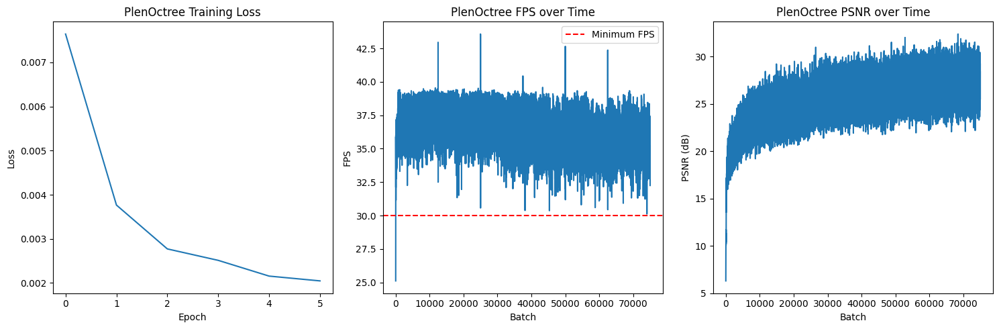

PlenOctree Training Progress:  60%|██████    | 75003/125000 [1:15:03<2:47:49,  4.97it/s]


PlenOctree Epoch 7/10, Batch 0:
FPS: 40.89, Latency: 24.46ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  60%|██████    | 75013/125000 [1:15:03<1:08:48, 12.11it/s]


PlenOctree Epoch 7/10, Batch 10:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  60%|██████    | 75023/125000 [1:15:04<53:09, 15.67it/s]


PlenOctree Epoch 7/10, Batch 20:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75033/125000 [1:15:04<50:08, 16.61it/s]


PlenOctree Epoch 7/10, Batch 30:
FPS: 37.48, Latency: 26.68ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75043/125000 [1:15:05<49:23, 16.85it/s]


PlenOctree Epoch 7/10, Batch 40:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  60%|██████    | 75053/125000 [1:15:06<49:47, 16.72it/s]


PlenOctree Epoch 7/10, Batch 50:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75063/125000 [1:15:06<50:33, 16.46it/s]


PlenOctree Epoch 7/10, Batch 60:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  60%|██████    | 75073/125000 [1:15:07<50:22, 16.52it/s]


PlenOctree Epoch 7/10, Batch 70:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75083/125000 [1:15:07<50:37, 16.43it/s]


PlenOctree Epoch 7/10, Batch 80:
FPS: 35.52, Latency: 28.16ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  60%|██████    | 75093/125000 [1:15:08<50:25, 16.50it/s]


PlenOctree Epoch 7/10, Batch 90:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75103/125000 [1:15:09<50:11, 16.57it/s]


PlenOctree Epoch 7/10, Batch 100:
FPS: 36.66, Latency: 27.28ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  60%|██████    | 75113/125000 [1:15:09<49:29, 16.80it/s]


PlenOctree Epoch 7/10, Batch 110:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75123/125000 [1:15:10<50:03, 16.61it/s]


PlenOctree Epoch 7/10, Batch 120:
FPS: 36.33, Latency: 27.52ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75133/125000 [1:15:10<49:02, 16.94it/s]


PlenOctree Epoch 7/10, Batch 130:
FPS: 35.78, Latency: 27.95ms
PSNR: 29.95dB, Loss: 0.0010


PlenOctree Training Progress:  60%|██████    | 75143/125000 [1:15:11<50:08, 16.57it/s]


PlenOctree Epoch 7/10, Batch 140:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75153/125000 [1:15:12<49:43, 16.71it/s]


PlenOctree Epoch 7/10, Batch 150:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  60%|██████    | 75163/125000 [1:15:12<49:45, 16.69it/s]


PlenOctree Epoch 7/10, Batch 160:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75173/125000 [1:15:13<50:15, 16.52it/s]


PlenOctree Epoch 7/10, Batch 170:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75183/125000 [1:15:13<50:30, 16.44it/s]


PlenOctree Epoch 7/10, Batch 180:
FPS: 35.24, Latency: 28.38ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  60%|██████    | 75193/125000 [1:15:14<50:19, 16.50it/s]


PlenOctree Epoch 7/10, Batch 190:
FPS: 35.07, Latency: 28.52ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  60%|██████    | 75203/125000 [1:15:15<50:15, 16.51it/s]


PlenOctree Epoch 7/10, Batch 200:
FPS: 34.73, Latency: 28.80ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  60%|██████    | 75213/125000 [1:15:15<50:13, 16.52it/s]


PlenOctree Epoch 7/10, Batch 210:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75223/125000 [1:15:16<50:24, 16.46it/s]


PlenOctree Epoch 7/10, Batch 220:
FPS: 36.16, Latency: 27.65ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  60%|██████    | 75233/125000 [1:15:17<50:22, 16.46it/s]


PlenOctree Epoch 7/10, Batch 230:
FPS: 35.61, Latency: 28.08ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75243/125000 [1:15:17<50:09, 16.53it/s]


PlenOctree Epoch 7/10, Batch 240:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  60%|██████    | 75253/125000 [1:15:18<49:27, 16.76it/s]


PlenOctree Epoch 7/10, Batch 250:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75263/125000 [1:15:18<50:02, 16.56it/s]


PlenOctree Epoch 7/10, Batch 260:
FPS: 35.65, Latency: 28.05ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75273/125000 [1:15:19<49:58, 16.58it/s]


PlenOctree Epoch 7/10, Batch 270:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75283/125000 [1:15:20<50:28, 16.42it/s]


PlenOctree Epoch 7/10, Batch 280:
FPS: 35.49, Latency: 28.17ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  60%|██████    | 75293/125000 [1:15:20<50:16, 16.48it/s]


PlenOctree Epoch 7/10, Batch 290:
FPS: 35.86, Latency: 27.89ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  60%|██████    | 75303/125000 [1:15:21<49:59, 16.57it/s]


PlenOctree Epoch 7/10, Batch 300:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75313/125000 [1:15:21<50:11, 16.50it/s]


PlenOctree Epoch 7/10, Batch 310:
FPS: 36.60, Latency: 27.33ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  60%|██████    | 75323/125000 [1:15:22<50:16, 16.47it/s]


PlenOctree Epoch 7/10, Batch 320:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75333/125000 [1:15:23<50:05, 16.53it/s]


PlenOctree Epoch 7/10, Batch 330:
FPS: 35.80, Latency: 27.94ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75343/125000 [1:15:23<49:51, 16.60it/s]


PlenOctree Epoch 7/10, Batch 340:
FPS: 36.95, Latency: 27.06ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75353/125000 [1:15:24<49:25, 16.74it/s]


PlenOctree Epoch 7/10, Batch 350:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75363/125000 [1:15:24<50:01, 16.54it/s]


PlenOctree Epoch 7/10, Batch 360:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75373/125000 [1:15:25<50:15, 16.46it/s]


PlenOctree Epoch 7/10, Batch 370:
FPS: 35.10, Latency: 28.49ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  60%|██████    | 75383/125000 [1:15:26<50:04, 16.51it/s]


PlenOctree Epoch 7/10, Batch 380:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75393/125000 [1:15:26<50:08, 16.49it/s]


PlenOctree Epoch 7/10, Batch 390:
FPS: 34.84, Latency: 28.70ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  60%|██████    | 75403/125000 [1:15:27<50:04, 16.50it/s]


PlenOctree Epoch 7/10, Batch 400:
FPS: 35.43, Latency: 28.23ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  60%|██████    | 75413/125000 [1:15:27<49:56, 16.55it/s]


PlenOctree Epoch 7/10, Batch 410:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  60%|██████    | 75423/125000 [1:15:28<50:18, 16.42it/s]


PlenOctree Epoch 7/10, Batch 420:
FPS: 35.86, Latency: 27.88ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  60%|██████    | 75433/125000 [1:15:29<50:06, 16.49it/s]


PlenOctree Epoch 7/10, Batch 430:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  60%|██████    | 75443/125000 [1:15:29<48:54, 16.89it/s]


PlenOctree Epoch 7/10, Batch 440:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75453/125000 [1:15:30<49:46, 16.59it/s]


PlenOctree Epoch 7/10, Batch 450:
FPS: 35.32, Latency: 28.32ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75463/125000 [1:15:30<50:07, 16.47it/s]


PlenOctree Epoch 7/10, Batch 460:
FPS: 35.70, Latency: 28.01ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75473/125000 [1:15:31<50:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 470:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  60%|██████    | 75483/125000 [1:15:32<50:09, 16.45it/s]


PlenOctree Epoch 7/10, Batch 480:
FPS: 35.50, Latency: 28.17ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  60%|██████    | 75493/125000 [1:15:32<50:01, 16.49it/s]


PlenOctree Epoch 7/10, Batch 490:
FPS: 36.67, Latency: 27.27ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  60%|██████    | 75503/125000 [1:15:33<50:04, 16.47it/s]


PlenOctree Epoch 7/10, Batch 500:
FPS: 35.20, Latency: 28.41ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  60%|██████    | 75513/125000 [1:15:33<49:57, 16.51it/s]


PlenOctree Epoch 7/10, Batch 510:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  60%|██████    | 75523/125000 [1:15:34<49:53, 16.53it/s]


PlenOctree Epoch 7/10, Batch 520:
FPS: 35.71, Latency: 28.00ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  60%|██████    | 75533/125000 [1:15:35<50:08, 16.44it/s]


PlenOctree Epoch 7/10, Batch 530:
FPS: 35.71, Latency: 28.01ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  60%|██████    | 75543/125000 [1:15:35<49:59, 16.49it/s]


PlenOctree Epoch 7/10, Batch 540:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  60%|██████    | 75553/125000 [1:15:36<50:00, 16.48it/s]


PlenOctree Epoch 7/10, Batch 550:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  60%|██████    | 75563/125000 [1:15:36<49:56, 16.50it/s]


PlenOctree Epoch 7/10, Batch 560:
FPS: 36.43, Latency: 27.45ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  60%|██████    | 75573/125000 [1:15:37<50:06, 16.44it/s]


PlenOctree Epoch 7/10, Batch 570:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  60%|██████    | 75583/125000 [1:15:38<49:58, 16.48it/s]


PlenOctree Epoch 7/10, Batch 580:
FPS: 34.71, Latency: 28.81ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  60%|██████    | 75593/125000 [1:15:38<50:03, 16.45it/s]


PlenOctree Epoch 7/10, Batch 590:
FPS: 35.04, Latency: 28.54ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75603/125000 [1:15:39<49:54, 16.50it/s]


PlenOctree Epoch 7/10, Batch 600:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  60%|██████    | 75613/125000 [1:15:40<49:59, 16.47it/s]


PlenOctree Epoch 7/10, Batch 610:
FPS: 35.57, Latency: 28.11ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  60%|██████    | 75623/125000 [1:15:40<49:44, 16.54it/s]


PlenOctree Epoch 7/10, Batch 620:
FPS: 36.44, Latency: 27.45ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  61%|██████    | 75633/125000 [1:15:41<48:47, 16.86it/s]


PlenOctree Epoch 7/10, Batch 630:
FPS: 36.78, Latency: 27.19ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  61%|██████    | 75643/125000 [1:15:41<49:55, 16.48it/s]


PlenOctree Epoch 7/10, Batch 640:
FPS: 36.02, Latency: 27.77ms
PSNR: 30.80dB, Loss: 0.0008


PlenOctree Training Progress:  61%|██████    | 75653/125000 [1:15:42<49:11, 16.72it/s]


PlenOctree Epoch 7/10, Batch 650:
FPS: 36.68, Latency: 27.26ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████    | 75663/125000 [1:15:43<49:20, 16.67it/s]


PlenOctree Epoch 7/10, Batch 660:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  61%|██████    | 75673/125000 [1:15:43<49:50, 16.49it/s]


PlenOctree Epoch 7/10, Batch 670:
FPS: 35.39, Latency: 28.26ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  61%|██████    | 75683/125000 [1:15:44<49:55, 16.46it/s]


PlenOctree Epoch 7/10, Batch 680:
FPS: 35.22, Latency: 28.39ms
PSNR: 31.46dB, Loss: 0.0007


PlenOctree Training Progress:  61%|██████    | 75693/125000 [1:15:44<49:40, 16.54it/s]


PlenOctree Epoch 7/10, Batch 690:
FPS: 36.76, Latency: 27.20ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 75703/125000 [1:15:45<48:38, 16.89it/s]


PlenOctree Epoch 7/10, Batch 700:
FPS: 37.00, Latency: 27.02ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  61%|██████    | 75713/125000 [1:15:46<49:26, 16.62it/s]


PlenOctree Epoch 7/10, Batch 710:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████    | 75723/125000 [1:15:46<49:19, 16.65it/s]


PlenOctree Epoch 7/10, Batch 720:
FPS: 37.44, Latency: 26.71ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  61%|██████    | 75733/125000 [1:15:47<49:16, 16.66it/s]


PlenOctree Epoch 7/10, Batch 730:
FPS: 35.47, Latency: 28.19ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  61%|██████    | 75743/125000 [1:15:47<49:29, 16.59it/s]


PlenOctree Epoch 7/10, Batch 740:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  61%|██████    | 75753/125000 [1:15:48<48:43, 16.85it/s]


PlenOctree Epoch 7/10, Batch 750:
FPS: 36.84, Latency: 27.14ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  61%|██████    | 75763/125000 [1:15:49<49:43, 16.51it/s]


PlenOctree Epoch 7/10, Batch 760:
FPS: 36.57, Latency: 27.34ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████    | 75773/125000 [1:15:49<49:52, 16.45it/s]


PlenOctree Epoch 7/10, Batch 770:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████    | 75783/125000 [1:15:50<49:40, 16.52it/s]


PlenOctree Epoch 7/10, Batch 780:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  61%|██████    | 75793/125000 [1:15:50<49:45, 16.48it/s]


PlenOctree Epoch 7/10, Batch 790:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 75803/125000 [1:15:51<48:58, 16.74it/s]


PlenOctree Epoch 7/10, Batch 800:
FPS: 36.61, Latency: 27.31ms
PSNR: 29.21dB, Loss: 0.0012


PlenOctree Training Progress:  61%|██████    | 75813/125000 [1:15:52<49:29, 16.56it/s]


PlenOctree Epoch 7/10, Batch 810:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  61%|██████    | 75823/125000 [1:15:52<49:46, 16.47it/s]


PlenOctree Epoch 7/10, Batch 820:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 75833/125000 [1:15:53<49:20, 16.61it/s]


PlenOctree Epoch 7/10, Batch 830:
FPS: 37.29, Latency: 26.82ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████    | 75843/125000 [1:15:53<49:02, 16.71it/s]


PlenOctree Epoch 7/10, Batch 840:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  61%|██████    | 75853/125000 [1:15:54<49:27, 16.56it/s]


PlenOctree Epoch 7/10, Batch 850:
FPS: 35.09, Latency: 28.50ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████    | 75863/125000 [1:15:55<49:06, 16.68it/s]


PlenOctree Epoch 7/10, Batch 860:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  61%|██████    | 75873/125000 [1:15:55<49:09, 16.65it/s]


PlenOctree Epoch 7/10, Batch 870:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████    | 75883/125000 [1:15:56<49:24, 16.57it/s]


PlenOctree Epoch 7/10, Batch 880:
FPS: 35.53, Latency: 28.14ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 75893/125000 [1:15:56<49:38, 16.49it/s]


PlenOctree Epoch 7/10, Batch 890:
FPS: 36.69, Latency: 27.26ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  61%|██████    | 75903/125000 [1:15:57<49:27, 16.55it/s]


PlenOctree Epoch 7/10, Batch 900:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  61%|██████    | 75913/125000 [1:15:58<48:43, 16.79it/s]


PlenOctree Epoch 7/10, Batch 910:
FPS: 36.80, Latency: 27.18ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  61%|██████    | 75923/125000 [1:15:58<49:31, 16.52it/s]


PlenOctree Epoch 7/10, Batch 920:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 75933/125000 [1:15:59<49:23, 16.56it/s]


PlenOctree Epoch 7/10, Batch 930:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  61%|██████    | 75943/125000 [1:15:59<49:15, 16.60it/s]


PlenOctree Epoch 7/10, Batch 940:
FPS: 36.88, Latency: 27.11ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  61%|██████    | 75953/125000 [1:16:00<49:07, 16.64it/s]


PlenOctree Epoch 7/10, Batch 950:
FPS: 35.73, Latency: 27.99ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  61%|██████    | 75963/125000 [1:16:01<49:15, 16.59it/s]


PlenOctree Epoch 7/10, Batch 960:
FPS: 36.31, Latency: 27.54ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  61%|██████    | 75973/125000 [1:16:01<49:38, 16.46it/s]


PlenOctree Epoch 7/10, Batch 970:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  61%|██████    | 75983/125000 [1:16:02<49:49, 16.40it/s]


PlenOctree Epoch 7/10, Batch 980:
FPS: 35.85, Latency: 27.89ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  61%|██████    | 75993/125000 [1:16:02<49:29, 16.50it/s]


PlenOctree Epoch 7/10, Batch 990:
FPS: 35.68, Latency: 28.03ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  61%|██████    | 76003/125000 [1:16:03<49:28, 16.50it/s]


PlenOctree Epoch 7/10, Batch 1000:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  61%|██████    | 76013/125000 [1:16:04<49:17, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1010:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████    | 76023/125000 [1:16:04<49:28, 16.50it/s]


PlenOctree Epoch 7/10, Batch 1020:
FPS: 36.85, Latency: 27.14ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████    | 76033/125000 [1:16:05<48:17, 16.90it/s]


PlenOctree Epoch 7/10, Batch 1030:
FPS: 38.43, Latency: 26.02ms
PSNR: 29.75dB, Loss: 0.0011


PlenOctree Training Progress:  61%|██████    | 76043/125000 [1:16:05<49:15, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1040:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████    | 76053/125000 [1:16:06<49:20, 16.53it/s]


PlenOctree Epoch 7/10, Batch 1050:
FPS: 35.66, Latency: 28.04ms
PSNR: 30.05dB, Loss: 0.0010


PlenOctree Training Progress:  61%|██████    | 76063/125000 [1:16:07<49:22, 16.52it/s]


PlenOctree Epoch 7/10, Batch 1060:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  61%|██████    | 76073/125000 [1:16:07<49:38, 16.42it/s]


PlenOctree Epoch 7/10, Batch 1070:
FPS: 35.90, Latency: 27.86ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  61%|██████    | 76083/125000 [1:16:08<49:18, 16.53it/s]


PlenOctree Epoch 7/10, Batch 1080:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  61%|██████    | 76093/125000 [1:16:08<49:29, 16.47it/s]


PlenOctree Epoch 7/10, Batch 1090:
FPS: 36.20, Latency: 27.62ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  61%|██████    | 76103/125000 [1:16:09<49:18, 16.53it/s]


PlenOctree Epoch 7/10, Batch 1100:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 76113/125000 [1:16:10<48:50, 16.68it/s]


PlenOctree Epoch 7/10, Batch 1110:
FPS: 37.58, Latency: 26.61ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  61%|██████    | 76123/125000 [1:16:10<48:56, 16.64it/s]


PlenOctree Epoch 7/10, Batch 1120:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████    | 76133/125000 [1:16:11<49:02, 16.61it/s]


PlenOctree Epoch 7/10, Batch 1130:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  61%|██████    | 76143/125000 [1:16:11<48:11, 16.90it/s]


PlenOctree Epoch 7/10, Batch 1140:
FPS: 38.13, Latency: 26.22ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  61%|██████    | 76153/125000 [1:16:12<48:51, 16.66it/s]


PlenOctree Epoch 7/10, Batch 1150:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  61%|██████    | 76163/125000 [1:16:13<47:59, 16.96it/s]


PlenOctree Epoch 7/10, Batch 1160:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  61%|██████    | 76173/125000 [1:16:13<48:53, 16.65it/s]


PlenOctree Epoch 7/10, Batch 1170:
FPS: 34.53, Latency: 28.96ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  61%|██████    | 76183/125000 [1:16:14<49:09, 16.55it/s]


PlenOctree Epoch 7/10, Batch 1180:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████    | 76193/125000 [1:16:14<49:21, 16.48it/s]


PlenOctree Epoch 7/10, Batch 1190:
FPS: 35.60, Latency: 28.09ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████    | 76203/125000 [1:16:15<49:21, 16.48it/s]


PlenOctree Epoch 7/10, Batch 1200:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 76213/125000 [1:16:16<49:06, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1210:
FPS: 36.08, Latency: 27.72ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████    | 76223/125000 [1:16:16<49:13, 16.51it/s]


PlenOctree Epoch 7/10, Batch 1220:
FPS: 35.39, Latency: 28.26ms
PSNR: 25.31dB, Loss: 0.0029


PlenOctree Training Progress:  61%|██████    | 76233/125000 [1:16:17<48:16, 16.84it/s]


PlenOctree Epoch 7/10, Batch 1230:
FPS: 35.76, Latency: 27.97ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  61%|██████    | 76243/125000 [1:16:17<48:56, 16.60it/s]


PlenOctree Epoch 7/10, Batch 1240:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  61%|██████    | 76253/125000 [1:16:18<49:09, 16.53it/s]


PlenOctree Epoch 7/10, Batch 1250:
FPS: 37.74, Latency: 26.49ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  61%|██████    | 76263/125000 [1:16:19<48:11, 16.86it/s]


PlenOctree Epoch 7/10, Batch 1260:
FPS: 37.53, Latency: 26.64ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████    | 76273/125000 [1:16:19<48:58, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1270:
FPS: 35.12, Latency: 28.47ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  61%|██████    | 76283/125000 [1:16:20<49:01, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1280:
FPS: 36.73, Latency: 27.22ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████    | 76293/125000 [1:16:20<49:14, 16.49it/s]


PlenOctree Epoch 7/10, Batch 1290:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76303/125000 [1:16:21<49:18, 16.46it/s]


PlenOctree Epoch 7/10, Batch 1300:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76313/125000 [1:16:22<49:06, 16.52it/s]


PlenOctree Epoch 7/10, Batch 1310:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  61%|██████    | 76323/125000 [1:16:22<49:18, 16.45it/s]


PlenOctree Epoch 7/10, Batch 1320:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████    | 76333/125000 [1:16:23<48:56, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1330:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76343/125000 [1:16:24<48:11, 16.83it/s]


PlenOctree Epoch 7/10, Batch 1340:
FPS: 37.10, Latency: 26.95ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  61%|██████    | 76353/125000 [1:16:24<49:11, 16.48it/s]


PlenOctree Epoch 7/10, Batch 1350:
FPS: 35.91, Latency: 27.84ms
PSNR: 23.82dB, Loss: 0.0042


PlenOctree Training Progress:  61%|██████    | 76363/125000 [1:16:25<48:17, 16.79it/s]


PlenOctree Epoch 7/10, Batch 1360:
FPS: 37.34, Latency: 26.78ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  61%|██████    | 76373/125000 [1:16:25<48:43, 16.63it/s]


PlenOctree Epoch 7/10, Batch 1370:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████    | 76383/125000 [1:16:26<48:57, 16.55it/s]


PlenOctree Epoch 7/10, Batch 1380:
FPS: 36.04, Latency: 27.75ms
PSNR: 29.72dB, Loss: 0.0011


PlenOctree Training Progress:  61%|██████    | 76393/125000 [1:16:27<49:03, 16.51it/s]


PlenOctree Epoch 7/10, Batch 1390:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76403/125000 [1:16:27<49:04, 16.50it/s]


PlenOctree Epoch 7/10, Batch 1400:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  61%|██████    | 76413/125000 [1:16:28<48:48, 16.59it/s]


PlenOctree Epoch 7/10, Batch 1410:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  61%|██████    | 76423/125000 [1:16:28<48:26, 16.71it/s]


PlenOctree Epoch 7/10, Batch 1420:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  61%|██████    | 76433/125000 [1:16:29<48:49, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1430:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  61%|██████    | 76443/125000 [1:16:30<48:59, 16.52it/s]


PlenOctree Epoch 7/10, Batch 1440:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  61%|██████    | 76453/125000 [1:16:30<49:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 1450:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76463/125000 [1:16:31<49:02, 16.49it/s]


PlenOctree Epoch 7/10, Batch 1460:
FPS: 35.69, Latency: 28.02ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  61%|██████    | 76473/125000 [1:16:31<47:58, 16.86it/s]


PlenOctree Epoch 7/10, Batch 1470:
FPS: 36.25, Latency: 27.59ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76483/125000 [1:16:32<48:49, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1480:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  61%|██████    | 76493/125000 [1:16:33<48:39, 16.61it/s]


PlenOctree Epoch 7/10, Batch 1490:
FPS: 36.41, Latency: 27.47ms
PSNR: 29.44dB, Loss: 0.0011


PlenOctree Training Progress:  61%|██████    | 76503/125000 [1:16:33<47:54, 16.87it/s]


PlenOctree Epoch 7/10, Batch 1500:
FPS: 37.67, Latency: 26.55ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████    | 76513/125000 [1:16:34<48:50, 16.55it/s]


PlenOctree Epoch 7/10, Batch 1510:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  61%|██████    | 76523/125000 [1:16:34<48:34, 16.63it/s]


PlenOctree Epoch 7/10, Batch 1520:
FPS: 37.31, Latency: 26.80ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  61%|██████    | 76533/125000 [1:16:35<48:01, 16.82it/s]


PlenOctree Epoch 7/10, Batch 1530:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  61%|██████    | 76543/125000 [1:16:36<48:25, 16.68it/s]


PlenOctree Epoch 7/10, Batch 1540:
FPS: 37.41, Latency: 26.73ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████    | 76553/125000 [1:16:36<47:46, 16.90it/s]


PlenOctree Epoch 7/10, Batch 1550:
FPS: 36.58, Latency: 27.34ms
PSNR: 29.57dB, Loss: 0.0011


PlenOctree Training Progress:  61%|██████▏   | 76563/125000 [1:16:37<48:51, 16.52it/s]


PlenOctree Epoch 7/10, Batch 1560:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.75dB, Loss: 0.0027


PlenOctree Training Progress:  61%|██████▏   | 76573/125000 [1:16:37<48:54, 16.50it/s]


PlenOctree Epoch 7/10, Batch 1570:
FPS: 36.88, Latency: 27.12ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████▏   | 76583/125000 [1:16:38<48:46, 16.55it/s]


PlenOctree Epoch 7/10, Batch 1580:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  61%|██████▏   | 76593/125000 [1:16:39<48:59, 16.47it/s]


PlenOctree Epoch 7/10, Batch 1590:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  61%|██████▏   | 76603/125000 [1:16:39<48:46, 16.54it/s]


PlenOctree Epoch 7/10, Batch 1600:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  61%|██████▏   | 76613/125000 [1:16:40<48:55, 16.48it/s]


PlenOctree Epoch 7/10, Batch 1610:
FPS: 36.17, Latency: 27.64ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████▏   | 76623/125000 [1:16:40<48:38, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1620:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████▏   | 76633/125000 [1:16:41<48:00, 16.79it/s]


PlenOctree Epoch 7/10, Batch 1630:
FPS: 36.72, Latency: 27.24ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  61%|██████▏   | 76643/125000 [1:16:42<48:42, 16.55it/s]


PlenOctree Epoch 7/10, Batch 1640:
FPS: 36.52, Latency: 27.39ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████▏   | 76653/125000 [1:16:42<48:16, 16.69it/s]


PlenOctree Epoch 7/10, Batch 1650:
FPS: 37.14, Latency: 26.93ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████▏   | 76663/125000 [1:16:43<48:16, 16.69it/s]


PlenOctree Epoch 7/10, Batch 1660:
FPS: 36.03, Latency: 27.76ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  61%|██████▏   | 76673/125000 [1:16:43<48:38, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1670:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  61%|██████▏   | 76683/125000 [1:16:44<48:41, 16.54it/s]


PlenOctree Epoch 7/10, Batch 1680:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████▏   | 76693/125000 [1:16:45<47:49, 16.84it/s]


PlenOctree Epoch 7/10, Batch 1690:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  61%|██████▏   | 76703/125000 [1:16:45<48:25, 16.63it/s]


PlenOctree Epoch 7/10, Batch 1700:
FPS: 36.60, Latency: 27.33ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  61%|██████▏   | 76713/125000 [1:16:46<48:21, 16.64it/s]


PlenOctree Epoch 7/10, Batch 1710:
FPS: 37.41, Latency: 26.73ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████▏   | 76723/125000 [1:16:46<47:50, 16.82it/s]


PlenOctree Epoch 7/10, Batch 1720:
FPS: 36.12, Latency: 27.68ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████▏   | 76733/125000 [1:16:47<48:23, 16.62it/s]


PlenOctree Epoch 7/10, Batch 1730:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████▏   | 76743/125000 [1:16:48<47:44, 16.85it/s]


PlenOctree Epoch 7/10, Batch 1740:
FPS: 36.54, Latency: 27.36ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  61%|██████▏   | 76753/125000 [1:16:48<48:32, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1750:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████▏   | 76763/125000 [1:16:49<48:33, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1760:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  61%|██████▏   | 76773/125000 [1:16:49<48:06, 16.71it/s]


PlenOctree Epoch 7/10, Batch 1770:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  61%|██████▏   | 76783/125000 [1:16:50<48:17, 16.64it/s]


PlenOctree Epoch 7/10, Batch 1780:
FPS: 36.33, Latency: 27.52ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████▏   | 76793/125000 [1:16:51<48:27, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1790:
FPS: 35.85, Latency: 27.90ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  61%|██████▏   | 76803/125000 [1:16:51<48:47, 16.46it/s]


PlenOctree Epoch 7/10, Batch 1800:
FPS: 36.38, Latency: 27.48ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  61%|██████▏   | 76813/125000 [1:16:52<48:25, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1810:
FPS: 37.19, Latency: 26.89ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  61%|██████▏   | 76823/125000 [1:16:52<47:47, 16.80it/s]


PlenOctree Epoch 7/10, Batch 1820:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  61%|██████▏   | 76833/125000 [1:16:53<48:36, 16.51it/s]


PlenOctree Epoch 7/10, Batch 1830:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  61%|██████▏   | 76843/125000 [1:16:54<48:08, 16.67it/s]


PlenOctree Epoch 7/10, Batch 1840:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  61%|██████▏   | 76853/125000 [1:16:54<48:11, 16.65it/s]


PlenOctree Epoch 7/10, Batch 1850:
FPS: 35.92, Latency: 27.84ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  61%|██████▏   | 76863/125000 [1:16:55<48:22, 16.58it/s]


PlenOctree Epoch 7/10, Batch 1860:
FPS: 36.24, Latency: 27.59ms
PSNR: 24.66dB, Loss: 0.0034


PlenOctree Training Progress:  61%|██████▏   | 76873/125000 [1:16:55<48:47, 16.44it/s]


PlenOctree Epoch 7/10, Batch 1870:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 76883/125000 [1:16:56<48:30, 16.53it/s]


PlenOctree Epoch 7/10, Batch 1880:
FPS: 36.24, Latency: 27.59ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  62%|██████▏   | 76893/125000 [1:16:57<47:41, 16.81it/s]


PlenOctree Epoch 7/10, Batch 1890:
FPS: 36.17, Latency: 27.64ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  62%|██████▏   | 76903/125000 [1:16:57<48:25, 16.55it/s]


PlenOctree Epoch 7/10, Batch 1900:
FPS: 35.82, Latency: 27.92ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 76913/125000 [1:16:58<47:26, 16.89it/s]


PlenOctree Epoch 7/10, Batch 1910:
FPS: 37.15, Latency: 26.92ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 76923/125000 [1:16:58<48:23, 16.56it/s]


PlenOctree Epoch 7/10, Batch 1920:
FPS: 35.73, Latency: 27.98ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  62%|██████▏   | 76933/125000 [1:16:59<47:53, 16.73it/s]


PlenOctree Epoch 7/10, Batch 1930:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  62%|██████▏   | 76943/125000 [1:17:00<47:59, 16.69it/s]


PlenOctree Epoch 7/10, Batch 1940:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 76953/125000 [1:17:00<48:16, 16.59it/s]


PlenOctree Epoch 7/10, Batch 1950:
FPS: 36.85, Latency: 27.14ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 76963/125000 [1:17:01<48:43, 16.43it/s]


PlenOctree Epoch 7/10, Batch 1960:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  62%|██████▏   | 76973/125000 [1:17:01<48:40, 16.44it/s]


PlenOctree Epoch 7/10, Batch 1970:
FPS: 37.55, Latency: 26.63ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  62%|██████▏   | 76983/125000 [1:17:02<48:47, 16.40it/s]


PlenOctree Epoch 7/10, Batch 1980:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 76993/125000 [1:17:03<48:41, 16.43it/s]


PlenOctree Epoch 7/10, Batch 1990:
FPS: 35.63, Latency: 28.07ms
PSNR: 29.68dB, Loss: 0.0011


PlenOctree Training Progress:  62%|██████▏   | 77003/125000 [1:17:03<48:27, 16.51it/s]


PlenOctree Epoch 7/10, Batch 2000:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 77013/125000 [1:17:04<48:30, 16.49it/s]


PlenOctree Epoch 7/10, Batch 2010:
FPS: 36.18, Latency: 27.64ms
PSNR: 30.23dB, Loss: 0.0009


PlenOctree Training Progress:  62%|██████▏   | 77023/125000 [1:17:04<47:32, 16.82it/s]


PlenOctree Epoch 7/10, Batch 2020:
FPS: 38.25, Latency: 26.14ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  62%|██████▏   | 77033/125000 [1:17:05<48:08, 16.61it/s]


PlenOctree Epoch 7/10, Batch 2030:
FPS: 36.52, Latency: 27.39ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  62%|██████▏   | 77043/125000 [1:17:06<48:23, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2040:
FPS: 35.79, Latency: 27.94ms
PSNR: 24.38dB, Loss: 0.0037


PlenOctree Training Progress:  62%|██████▏   | 77053/125000 [1:17:06<47:25, 16.85it/s]


PlenOctree Epoch 7/10, Batch 2050:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  62%|██████▏   | 77063/125000 [1:17:07<48:14, 16.56it/s]


PlenOctree Epoch 7/10, Batch 2060:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77073/125000 [1:17:07<48:20, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2070:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77083/125000 [1:17:08<48:24, 16.50it/s]


PlenOctree Epoch 7/10, Batch 2080:
FPS: 35.65, Latency: 28.05ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  62%|██████▏   | 77093/125000 [1:17:09<48:23, 16.50it/s]


PlenOctree Epoch 7/10, Batch 2090:
FPS: 35.43, Latency: 28.23ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77103/125000 [1:17:09<47:55, 16.65it/s]


PlenOctree Epoch 7/10, Batch 2100:
FPS: 37.18, Latency: 26.89ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 77113/125000 [1:17:10<47:49, 16.69it/s]


PlenOctree Epoch 7/10, Batch 2110:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  62%|██████▏   | 77123/125000 [1:17:10<47:56, 16.65it/s]


PlenOctree Epoch 7/10, Batch 2120:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  62%|██████▏   | 77133/125000 [1:17:11<47:34, 16.77it/s]


PlenOctree Epoch 7/10, Batch 2130:
FPS: 36.76, Latency: 27.21ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77143/125000 [1:17:12<48:02, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2140:
FPS: 36.43, Latency: 27.45ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  62%|██████▏   | 77153/125000 [1:17:12<48:11, 16.55it/s]


PlenOctree Epoch 7/10, Batch 2150:
FPS: 37.53, Latency: 26.64ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  62%|██████▏   | 77163/125000 [1:17:13<47:28, 16.79it/s]


PlenOctree Epoch 7/10, Batch 2160:
FPS: 36.29, Latency: 27.55ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  62%|██████▏   | 77173/125000 [1:17:13<48:05, 16.57it/s]


PlenOctree Epoch 7/10, Batch 2170:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77183/125000 [1:17:14<48:00, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2180:
FPS: 37.29, Latency: 26.81ms
PSNR: 25.16dB, Loss: 0.0030


PlenOctree Training Progress:  62%|██████▏   | 77193/125000 [1:17:15<47:16, 16.85it/s]


PlenOctree Epoch 7/10, Batch 2190:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 77203/125000 [1:17:15<48:06, 16.56it/s]


PlenOctree Epoch 7/10, Batch 2200:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77213/125000 [1:17:16<47:27, 16.78it/s]


PlenOctree Epoch 7/10, Batch 2210:
FPS: 37.65, Latency: 26.56ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  62%|██████▏   | 77223/125000 [1:17:16<47:41, 16.69it/s]


PlenOctree Epoch 7/10, Batch 2220:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  62%|██████▏   | 77233/125000 [1:17:17<47:32, 16.74it/s]


PlenOctree Epoch 7/10, Batch 2230:
FPS: 38.60, Latency: 25.91ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77243/125000 [1:17:18<47:44, 16.67it/s]


PlenOctree Epoch 7/10, Batch 2240:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  62%|██████▏   | 77253/125000 [1:17:18<48:08, 16.53it/s]


PlenOctree Epoch 7/10, Batch 2250:
FPS: 35.15, Latency: 28.45ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  62%|██████▏   | 77263/125000 [1:17:19<48:16, 16.48it/s]


PlenOctree Epoch 7/10, Batch 2260:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 77273/125000 [1:17:20<48:27, 16.42it/s]


PlenOctree Epoch 7/10, Batch 2270:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  62%|██████▏   | 77283/125000 [1:17:20<48:16, 16.48it/s]


PlenOctree Epoch 7/10, Batch 2280:
FPS: 35.44, Latency: 28.22ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  62%|██████▏   | 77293/125000 [1:17:21<48:17, 16.47it/s]


PlenOctree Epoch 7/10, Batch 2290:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 77303/125000 [1:17:21<48:12, 16.49it/s]


PlenOctree Epoch 7/10, Batch 2300:
FPS: 35.85, Latency: 27.89ms
PSNR: 23.75dB, Loss: 0.0042


PlenOctree Training Progress:  62%|██████▏   | 77313/125000 [1:17:22<48:07, 16.51it/s]


PlenOctree Epoch 7/10, Batch 2310:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  62%|██████▏   | 77323/125000 [1:17:23<48:06, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2320:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  62%|██████▏   | 77333/125000 [1:17:23<46:57, 16.92it/s]


PlenOctree Epoch 7/10, Batch 2330:
FPS: 37.89, Latency: 26.39ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 77343/125000 [1:17:24<47:45, 16.63it/s]


PlenOctree Epoch 7/10, Batch 2340:
FPS: 36.44, Latency: 27.44ms
PSNR: 23.54dB, Loss: 0.0044


PlenOctree Training Progress:  62%|██████▏   | 77353/125000 [1:17:24<47:54, 16.57it/s]


PlenOctree Epoch 7/10, Batch 2350:
FPS: 36.88, Latency: 27.11ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  62%|██████▏   | 77363/125000 [1:17:25<47:36, 16.68it/s]


PlenOctree Epoch 7/10, Batch 2360:
FPS: 35.18, Latency: 28.42ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 77373/125000 [1:17:26<47:42, 16.64it/s]


PlenOctree Epoch 7/10, Batch 2370:
FPS: 36.19, Latency: 27.64ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 77383/125000 [1:17:26<47:48, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2380:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77393/125000 [1:17:27<48:12, 16.46it/s]


PlenOctree Epoch 7/10, Batch 2390:
FPS: 35.53, Latency: 28.15ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77403/125000 [1:17:27<48:00, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2400:
FPS: 35.85, Latency: 27.90ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 77413/125000 [1:17:28<48:16, 16.43it/s]


PlenOctree Epoch 7/10, Batch 2410:
FPS: 36.65, Latency: 27.28ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  62%|██████▏   | 77423/125000 [1:17:29<48:02, 16.51it/s]


PlenOctree Epoch 7/10, Batch 2420:
FPS: 36.41, Latency: 27.46ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  62%|██████▏   | 77433/125000 [1:17:29<46:52, 16.91it/s]


PlenOctree Epoch 7/10, Batch 2430:
FPS: 37.59, Latency: 26.60ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  62%|██████▏   | 77443/125000 [1:17:30<47:45, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2440:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  62%|██████▏   | 77453/125000 [1:17:30<48:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 2450:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77463/125000 [1:17:31<48:07, 16.46it/s]


PlenOctree Epoch 7/10, Batch 2460:
FPS: 35.17, Latency: 28.44ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  62%|██████▏   | 77473/125000 [1:17:32<48:00, 16.50it/s]


PlenOctree Epoch 7/10, Batch 2470:
FPS: 36.77, Latency: 27.20ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77483/125000 [1:17:32<47:55, 16.53it/s]


PlenOctree Epoch 7/10, Batch 2480:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 77493/125000 [1:17:33<48:10, 16.44it/s]


PlenOctree Epoch 7/10, Batch 2490:
FPS: 35.81, Latency: 27.93ms
PSNR: 29.15dB, Loss: 0.0012


PlenOctree Training Progress:  62%|██████▏   | 77503/125000 [1:17:33<47:52, 16.54it/s]


PlenOctree Epoch 7/10, Batch 2500:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  62%|██████▏   | 77513/125000 [1:17:34<47:39, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2510:
FPS: 37.48, Latency: 26.68ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77523/125000 [1:17:35<47:16, 16.74it/s]


PlenOctree Epoch 7/10, Batch 2520:
FPS: 36.63, Latency: 27.30ms
PSNR: 30.11dB, Loss: 0.0010


PlenOctree Training Progress:  62%|██████▏   | 77533/125000 [1:17:35<47:41, 16.59it/s]


PlenOctree Epoch 7/10, Batch 2530:
FPS: 36.16, Latency: 27.66ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  62%|██████▏   | 77543/125000 [1:17:36<47:56, 16.50it/s]


PlenOctree Epoch 7/10, Batch 2540:
FPS: 36.12, Latency: 27.69ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  62%|██████▏   | 77553/125000 [1:17:36<47:36, 16.61it/s]


PlenOctree Epoch 7/10, Batch 2550:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  62%|██████▏   | 77563/125000 [1:17:37<47:20, 16.70it/s]


PlenOctree Epoch 7/10, Batch 2560:
FPS: 36.71, Latency: 27.24ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  62%|██████▏   | 77573/125000 [1:17:38<47:46, 16.55it/s]


PlenOctree Epoch 7/10, Batch 2570:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77583/125000 [1:17:38<47:47, 16.54it/s]


PlenOctree Epoch 7/10, Batch 2580:
FPS: 35.97, Latency: 27.80ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77593/125000 [1:17:39<47:50, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2590:
FPS: 37.53, Latency: 26.65ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  62%|██████▏   | 77603/125000 [1:17:39<46:53, 16.85it/s]


PlenOctree Epoch 7/10, Batch 2600:
FPS: 38.28, Latency: 26.12ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77613/125000 [1:17:40<47:26, 16.65it/s]


PlenOctree Epoch 7/10, Batch 2610:
FPS: 37.89, Latency: 26.39ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77623/125000 [1:17:41<46:33, 16.96it/s]


PlenOctree Epoch 7/10, Batch 2620:
FPS: 37.34, Latency: 26.78ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 77633/125000 [1:17:41<47:34, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2630:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77643/125000 [1:17:42<47:14, 16.71it/s]


PlenOctree Epoch 7/10, Batch 2640:
FPS: 37.71, Latency: 26.52ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77653/125000 [1:17:42<47:20, 16.67it/s]


PlenOctree Epoch 7/10, Batch 2650:
FPS: 36.25, Latency: 27.58ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77663/125000 [1:17:43<47:41, 16.54it/s]


PlenOctree Epoch 7/10, Batch 2660:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77673/125000 [1:17:44<47:57, 16.45it/s]


PlenOctree Epoch 7/10, Batch 2670:
FPS: 35.34, Latency: 28.30ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  62%|██████▏   | 77683/125000 [1:17:44<47:35, 16.57it/s]


PlenOctree Epoch 7/10, Batch 2680:
FPS: 37.12, Latency: 26.94ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 77693/125000 [1:17:45<47:02, 16.76it/s]


PlenOctree Epoch 7/10, Batch 2690:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  62%|██████▏   | 77703/125000 [1:17:45<47:42, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2700:
FPS: 36.45, Latency: 27.44ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:  62%|██████▏   | 77713/125000 [1:17:46<47:33, 16.57it/s]


PlenOctree Epoch 7/10, Batch 2710:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77723/125000 [1:17:47<46:41, 16.87it/s]


PlenOctree Epoch 7/10, Batch 2720:
FPS: 37.87, Latency: 26.41ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77733/125000 [1:17:47<47:38, 16.54it/s]


PlenOctree Epoch 7/10, Batch 2730:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  62%|██████▏   | 77743/125000 [1:17:48<47:34, 16.55it/s]


PlenOctree Epoch 7/10, Batch 2740:
FPS: 37.45, Latency: 26.70ms
PSNR: 29.21dB, Loss: 0.0012


PlenOctree Training Progress:  62%|██████▏   | 77753/125000 [1:17:48<47:37, 16.53it/s]


PlenOctree Epoch 7/10, Batch 2750:
FPS: 36.49, Latency: 27.40ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  62%|██████▏   | 77763/125000 [1:17:49<47:21, 16.62it/s]


PlenOctree Epoch 7/10, Batch 2760:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  62%|██████▏   | 77773/125000 [1:17:50<47:05, 16.71it/s]


PlenOctree Epoch 7/10, Batch 2770:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  62%|██████▏   | 77783/125000 [1:17:50<47:32, 16.55it/s]


PlenOctree Epoch 7/10, Batch 2780:
FPS: 33.98, Latency: 29.43ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77793/125000 [1:17:51<47:45, 16.48it/s]


PlenOctree Epoch 7/10, Batch 2790:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77803/125000 [1:17:51<47:14, 16.65it/s]


PlenOctree Epoch 7/10, Batch 2800:
FPS: 38.56, Latency: 25.93ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  62%|██████▏   | 77813/125000 [1:17:52<47:10, 16.67it/s]


PlenOctree Epoch 7/10, Batch 2810:
FPS: 36.69, Latency: 27.25ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77823/125000 [1:17:53<47:15, 16.64it/s]


PlenOctree Epoch 7/10, Batch 2820:
FPS: 37.24, Latency: 26.86ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  62%|██████▏   | 77833/125000 [1:17:53<46:40, 16.84it/s]


PlenOctree Epoch 7/10, Batch 2830:
FPS: 37.37, Latency: 26.76ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 77843/125000 [1:17:54<47:33, 16.53it/s]


PlenOctree Epoch 7/10, Batch 2840:
FPS: 35.75, Latency: 27.98ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77853/125000 [1:17:54<47:21, 16.59it/s]


PlenOctree Epoch 7/10, Batch 2850:
FPS: 38.05, Latency: 26.28ms
PSNR: 30.40dB, Loss: 0.0009


PlenOctree Training Progress:  62%|██████▏   | 77863/125000 [1:17:55<46:47, 16.79it/s]


PlenOctree Epoch 7/10, Batch 2860:
FPS: 35.95, Latency: 27.82ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77873/125000 [1:17:56<47:22, 16.58it/s]


PlenOctree Epoch 7/10, Batch 2870:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 77883/125000 [1:17:56<46:58, 16.72it/s]


PlenOctree Epoch 7/10, Batch 2880:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 77893/125000 [1:17:57<47:18, 16.60it/s]


PlenOctree Epoch 7/10, Batch 2890:
FPS: 35.04, Latency: 28.54ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  62%|██████▏   | 77903/125000 [1:17:57<47:30, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2900:
FPS: 36.73, Latency: 27.22ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  62%|██████▏   | 77913/125000 [1:17:58<46:49, 16.76it/s]


PlenOctree Epoch 7/10, Batch 2910:
FPS: 36.12, Latency: 27.69ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  62%|██████▏   | 77923/125000 [1:17:59<47:27, 16.53it/s]


PlenOctree Epoch 7/10, Batch 2920:
FPS: 35.99, Latency: 27.79ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  62%|██████▏   | 77933/125000 [1:17:59<46:56, 16.71it/s]


PlenOctree Epoch 7/10, Batch 2930:
FPS: 37.59, Latency: 26.60ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 77943/125000 [1:18:00<46:58, 16.70it/s]


PlenOctree Epoch 7/10, Batch 2940:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  62%|██████▏   | 77953/125000 [1:18:00<47:27, 16.52it/s]


PlenOctree Epoch 7/10, Batch 2950:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  62%|██████▏   | 77963/125000 [1:18:01<47:34, 16.48it/s]


PlenOctree Epoch 7/10, Batch 2960:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  62%|██████▏   | 77973/125000 [1:18:02<46:47, 16.75it/s]


PlenOctree Epoch 7/10, Batch 2970:
FPS: 35.76, Latency: 27.97ms
PSNR: 30.80dB, Loss: 0.0008


PlenOctree Training Progress:  62%|██████▏   | 77983/125000 [1:18:02<47:22, 16.54it/s]


PlenOctree Epoch 7/10, Batch 2980:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  62%|██████▏   | 77993/125000 [1:18:03<47:12, 16.59it/s]


PlenOctree Epoch 7/10, Batch 2990:
FPS: 37.07, Latency: 26.98ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  62%|██████▏   | 78003/125000 [1:18:03<47:18, 16.56it/s]


PlenOctree Epoch 7/10, Batch 3000:
FPS: 38.27, Latency: 26.13ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  62%|██████▏   | 78013/125000 [1:18:04<46:48, 16.73it/s]


PlenOctree Epoch 7/10, Batch 3010:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  62%|██████▏   | 78023/125000 [1:18:05<47:28, 16.49it/s]


PlenOctree Epoch 7/10, Batch 3020:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  62%|██████▏   | 78033/125000 [1:18:05<46:20, 16.89it/s]


PlenOctree Epoch 7/10, Batch 3030:
FPS: 37.36, Latency: 26.77ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  62%|██████▏   | 78043/125000 [1:18:06<47:09, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3040:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  62%|██████▏   | 78053/125000 [1:18:06<47:08, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3050:
FPS: 36.81, Latency: 27.16ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  62%|██████▏   | 78063/125000 [1:18:07<46:33, 16.80it/s]


PlenOctree Epoch 7/10, Batch 3060:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  62%|██████▏   | 78073/125000 [1:18:08<47:18, 16.53it/s]


PlenOctree Epoch 7/10, Batch 3070:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  62%|██████▏   | 78083/125000 [1:18:08<47:22, 16.51it/s]


PlenOctree Epoch 7/10, Batch 3080:
FPS: 36.08, Latency: 27.72ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  62%|██████▏   | 78093/125000 [1:18:09<47:26, 16.48it/s]


PlenOctree Epoch 7/10, Batch 3090:
FPS: 35.56, Latency: 28.12ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  62%|██████▏   | 78103/125000 [1:18:09<47:38, 16.41it/s]


PlenOctree Epoch 7/10, Batch 3100:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  62%|██████▏   | 78113/125000 [1:18:10<47:18, 16.52it/s]


PlenOctree Epoch 7/10, Batch 3110:
FPS: 37.04, Latency: 27.00ms
PSNR: 30.62dB, Loss: 0.0009


PlenOctree Training Progress:  62%|██████▏   | 78123/125000 [1:18:11<46:20, 16.86it/s]


PlenOctree Epoch 7/10, Batch 3120:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 78133/125000 [1:18:11<47:12, 16.54it/s]


PlenOctree Epoch 7/10, Batch 3130:
FPS: 35.12, Latency: 28.47ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  63%|██████▎   | 78143/125000 [1:18:12<46:20, 16.85it/s]


PlenOctree Epoch 7/10, Batch 3140:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  63%|██████▎   | 78153/125000 [1:18:12<46:54, 16.64it/s]


PlenOctree Epoch 7/10, Batch 3150:
FPS: 35.81, Latency: 27.93ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  63%|██████▎   | 78163/125000 [1:18:13<47:06, 16.57it/s]


PlenOctree Epoch 7/10, Batch 3160:
FPS: 37.32, Latency: 26.79ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78173/125000 [1:18:14<46:31, 16.78it/s]


PlenOctree Epoch 7/10, Batch 3170:
FPS: 35.54, Latency: 28.13ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78183/125000 [1:18:14<47:10, 16.54it/s]


PlenOctree Epoch 7/10, Batch 3180:
FPS: 36.64, Latency: 27.30ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 78193/125000 [1:18:15<47:09, 16.54it/s]


PlenOctree Epoch 7/10, Batch 3190:
FPS: 35.64, Latency: 28.06ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 78203/125000 [1:18:16<46:58, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3200:
FPS: 37.41, Latency: 26.73ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78213/125000 [1:18:16<46:26, 16.79it/s]


PlenOctree Epoch 7/10, Batch 3210:
FPS: 35.85, Latency: 27.90ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  63%|██████▎   | 78223/125000 [1:18:17<47:05, 16.55it/s]


PlenOctree Epoch 7/10, Batch 3220:
FPS: 36.67, Latency: 27.27ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78233/125000 [1:18:17<46:56, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3230:
FPS: 37.16, Latency: 26.91ms
PSNR: 29.93dB, Loss: 0.0010


PlenOctree Training Progress:  63%|██████▎   | 78243/125000 [1:18:18<46:36, 16.72it/s]


PlenOctree Epoch 7/10, Batch 3240:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78253/125000 [1:18:18<46:55, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3250:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78263/125000 [1:18:19<47:11, 16.51it/s]


PlenOctree Epoch 7/10, Batch 3260:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78273/125000 [1:18:20<46:55, 16.59it/s]


PlenOctree Epoch 7/10, Batch 3270:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78283/125000 [1:18:20<46:38, 16.69it/s]


PlenOctree Epoch 7/10, Batch 3280:
FPS: 35.76, Latency: 27.97ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  63%|██████▎   | 78293/125000 [1:18:21<47:01, 16.55it/s]


PlenOctree Epoch 7/10, Batch 3290:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  63%|██████▎   | 78303/125000 [1:18:22<47:12, 16.48it/s]


PlenOctree Epoch 7/10, Batch 3300:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78313/125000 [1:18:22<47:08, 16.51it/s]


PlenOctree Epoch 7/10, Batch 3310:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 78323/125000 [1:18:23<47:09, 16.50it/s]


PlenOctree Epoch 7/10, Batch 3320:
FPS: 34.51, Latency: 28.98ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  63%|██████▎   | 78333/125000 [1:18:23<46:02, 16.90it/s]


PlenOctree Epoch 7/10, Batch 3330:
FPS: 36.57, Latency: 27.35ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 78343/125000 [1:18:24<46:50, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3340:
FPS: 36.36, Latency: 27.50ms
PSNR: 29.84dB, Loss: 0.0010


PlenOctree Training Progress:  63%|██████▎   | 78353/125000 [1:18:25<45:59, 16.91it/s]


PlenOctree Epoch 7/10, Batch 3350:
FPS: 38.26, Latency: 26.14ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 78363/125000 [1:18:25<46:48, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3360:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78373/125000 [1:18:26<46:33, 16.69it/s]


PlenOctree Epoch 7/10, Batch 3370:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  63%|██████▎   | 78383/125000 [1:18:26<46:09, 16.83it/s]


PlenOctree Epoch 7/10, Batch 3380:
FPS: 35.70, Latency: 28.01ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78393/125000 [1:18:27<46:49, 16.59it/s]


PlenOctree Epoch 7/10, Batch 3390:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  63%|██████▎   | 78403/125000 [1:18:28<46:37, 16.66it/s]


PlenOctree Epoch 7/10, Batch 3400:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  63%|██████▎   | 78413/125000 [1:18:28<46:09, 16.82it/s]


PlenOctree Epoch 7/10, Batch 3410:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  63%|██████▎   | 78423/125000 [1:18:29<47:00, 16.51it/s]


PlenOctree Epoch 7/10, Batch 3420:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78433/125000 [1:18:29<46:31, 16.68it/s]


PlenOctree Epoch 7/10, Batch 3430:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 78443/125000 [1:18:30<46:27, 16.70it/s]


PlenOctree Epoch 7/10, Batch 3440:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78453/125000 [1:18:31<46:45, 16.59it/s]


PlenOctree Epoch 7/10, Batch 3450:
FPS: 35.28, Latency: 28.34ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 78463/125000 [1:18:31<47:03, 16.48it/s]


PlenOctree Epoch 7/10, Batch 3460:
FPS: 36.36, Latency: 27.51ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  63%|██████▎   | 78473/125000 [1:18:32<46:56, 16.52it/s]


PlenOctree Epoch 7/10, Batch 3470:
FPS: 35.80, Latency: 27.93ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  63%|██████▎   | 78483/125000 [1:18:32<47:01, 16.49it/s]


PlenOctree Epoch 7/10, Batch 3480:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  63%|██████▎   | 78493/125000 [1:18:33<47:07, 16.45it/s]


PlenOctree Epoch 7/10, Batch 3490:
FPS: 35.17, Latency: 28.43ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 78503/125000 [1:18:34<46:58, 16.50it/s]


PlenOctree Epoch 7/10, Batch 3500:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  63%|██████▎   | 78513/125000 [1:18:34<47:04, 16.46it/s]


PlenOctree Epoch 7/10, Batch 3510:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 78523/125000 [1:18:35<46:58, 16.49it/s]


PlenOctree Epoch 7/10, Batch 3520:
FPS: 36.65, Latency: 27.29ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  63%|██████▎   | 78533/125000 [1:18:35<47:02, 16.46it/s]


PlenOctree Epoch 7/10, Batch 3530:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  63%|██████▎   | 78543/125000 [1:18:36<46:57, 16.49it/s]


PlenOctree Epoch 7/10, Batch 3540:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78553/125000 [1:18:37<46:53, 16.51it/s]


PlenOctree Epoch 7/10, Batch 3550:
FPS: 36.38, Latency: 27.48ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  63%|██████▎   | 78563/125000 [1:18:37<47:04, 16.44it/s]


PlenOctree Epoch 7/10, Batch 3560:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  63%|██████▎   | 78573/125000 [1:18:38<46:49, 16.52it/s]


PlenOctree Epoch 7/10, Batch 3570:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  63%|██████▎   | 78583/125000 [1:18:38<47:03, 16.44it/s]


PlenOctree Epoch 7/10, Batch 3580:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 78593/125000 [1:18:39<46:48, 16.52it/s]


PlenOctree Epoch 7/10, Batch 3590:
FPS: 36.01, Latency: 27.77ms
PSNR: 23.52dB, Loss: 0.0044


PlenOctree Training Progress:  63%|██████▎   | 78603/125000 [1:18:40<46:44, 16.54it/s]


PlenOctree Epoch 7/10, Batch 3600:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  63%|██████▎   | 78613/125000 [1:18:40<46:02, 16.79it/s]


PlenOctree Epoch 7/10, Batch 3610:
FPS: 37.27, Latency: 26.83ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78623/125000 [1:18:41<46:39, 16.56it/s]


PlenOctree Epoch 7/10, Batch 3620:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  63%|██████▎   | 78633/125000 [1:18:41<46:32, 16.61it/s]


PlenOctree Epoch 7/10, Batch 3630:
FPS: 36.91, Latency: 27.10ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78643/125000 [1:18:42<46:03, 16.78it/s]


PlenOctree Epoch 7/10, Batch 3640:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 78653/125000 [1:18:43<46:40, 16.55it/s]


PlenOctree Epoch 7/10, Batch 3650:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78663/125000 [1:18:43<46:51, 16.48it/s]


PlenOctree Epoch 7/10, Batch 3660:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  63%|██████▎   | 78673/125000 [1:18:44<46:45, 16.52it/s]


PlenOctree Epoch 7/10, Batch 3670:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  63%|██████▎   | 78683/125000 [1:18:44<46:57, 16.44it/s]


PlenOctree Epoch 7/10, Batch 3680:
FPS: 36.76, Latency: 27.20ms
PSNR: 29.65dB, Loss: 0.0011


PlenOctree Training Progress:  63%|██████▎   | 78693/125000 [1:18:45<46:55, 16.45it/s]


PlenOctree Epoch 7/10, Batch 3690:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  63%|██████▎   | 78703/125000 [1:18:46<46:36, 16.56it/s]


PlenOctree Epoch 7/10, Batch 3700:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  63%|██████▎   | 78713/125000 [1:18:46<45:43, 16.87it/s]


PlenOctree Epoch 7/10, Batch 3710:
FPS: 37.94, Latency: 26.36ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78723/125000 [1:18:47<46:22, 16.63it/s]


PlenOctree Epoch 7/10, Batch 3720:
FPS: 36.77, Latency: 27.20ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  63%|██████▎   | 78733/125000 [1:18:47<46:14, 16.68it/s]


PlenOctree Epoch 7/10, Batch 3730:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78743/125000 [1:18:48<45:59, 16.76it/s]


PlenOctree Epoch 7/10, Batch 3740:
FPS: 37.78, Latency: 26.47ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  63%|██████▎   | 78753/125000 [1:18:49<46:31, 16.56it/s]


PlenOctree Epoch 7/10, Batch 3750:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  63%|██████▎   | 78763/125000 [1:18:49<46:32, 16.56it/s]


PlenOctree Epoch 7/10, Batch 3760:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 78773/125000 [1:18:50<46:03, 16.73it/s]


PlenOctree Epoch 7/10, Batch 3770:
FPS: 37.83, Latency: 26.44ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  63%|██████▎   | 78783/125000 [1:18:50<46:15, 16.65it/s]


PlenOctree Epoch 7/10, Batch 3780:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  63%|██████▎   | 78793/125000 [1:18:51<46:21, 16.61it/s]


PlenOctree Epoch 7/10, Batch 3790:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  63%|██████▎   | 78803/125000 [1:18:52<45:45, 16.83it/s]


PlenOctree Epoch 7/10, Batch 3800:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78813/125000 [1:18:52<46:22, 16.60it/s]


PlenOctree Epoch 7/10, Batch 3810:
FPS: 36.43, Latency: 27.45ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  63%|██████▎   | 78823/125000 [1:18:53<45:55, 16.76it/s]


PlenOctree Epoch 7/10, Batch 3820:
FPS: 37.61, Latency: 26.59ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 78833/125000 [1:18:53<46:13, 16.64it/s]


PlenOctree Epoch 7/10, Batch 3830:
FPS: 36.29, Latency: 27.56ms
PSNR: 29.55dB, Loss: 0.0011


PlenOctree Training Progress:  63%|██████▎   | 78843/125000 [1:18:54<46:29, 16.55it/s]


PlenOctree Epoch 7/10, Batch 3840:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  63%|██████▎   | 78853/125000 [1:18:55<46:45, 16.45it/s]


PlenOctree Epoch 7/10, Batch 3850:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  63%|██████▎   | 78863/125000 [1:18:55<46:34, 16.51it/s]


PlenOctree Epoch 7/10, Batch 3860:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 78873/125000 [1:18:56<46:34, 16.50it/s]


PlenOctree Epoch 7/10, Batch 3870:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78883/125000 [1:18:56<46:23, 16.57it/s]


PlenOctree Epoch 7/10, Batch 3880:
FPS: 36.88, Latency: 27.12ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  63%|██████▎   | 78893/125000 [1:18:57<45:22, 16.94it/s]


PlenOctree Epoch 7/10, Batch 3890:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  63%|██████▎   | 78903/125000 [1:18:58<46:27, 16.54it/s]


PlenOctree Epoch 7/10, Batch 3900:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 78913/125000 [1:18:58<46:08, 16.65it/s]


PlenOctree Epoch 7/10, Batch 3910:
FPS: 37.51, Latency: 26.66ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78923/125000 [1:18:59<45:44, 16.79it/s]


PlenOctree Epoch 7/10, Batch 3920:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 78933/125000 [1:18:59<46:21, 16.56it/s]


PlenOctree Epoch 7/10, Batch 3930:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  63%|██████▎   | 78943/125000 [1:19:00<45:31, 16.86it/s]


PlenOctree Epoch 7/10, Batch 3940:
FPS: 38.07, Latency: 26.27ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 78953/125000 [1:19:01<46:16, 16.58it/s]


PlenOctree Epoch 7/10, Batch 3950:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  63%|██████▎   | 78963/125000 [1:19:01<46:08, 16.63it/s]


PlenOctree Epoch 7/10, Batch 3960:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  63%|██████▎   | 78973/125000 [1:19:02<45:26, 16.88it/s]


PlenOctree Epoch 7/10, Batch 3970:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 78983/125000 [1:19:02<46:20, 16.55it/s]


PlenOctree Epoch 7/10, Batch 3980:
FPS: 36.72, Latency: 27.24ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 78993/125000 [1:19:03<46:09, 16.61it/s]


PlenOctree Epoch 7/10, Batch 3990:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  63%|██████▎   | 79003/125000 [1:19:04<45:49, 16.73it/s]


PlenOctree Epoch 7/10, Batch 4000:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 79013/125000 [1:19:04<46:23, 16.52it/s]


PlenOctree Epoch 7/10, Batch 4010:
FPS: 36.31, Latency: 27.54ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  63%|██████▎   | 79023/125000 [1:19:05<46:19, 16.54it/s]


PlenOctree Epoch 7/10, Batch 4020:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 79033/125000 [1:19:05<46:02, 16.64it/s]


PlenOctree Epoch 7/10, Batch 4030:
FPS: 37.38, Latency: 26.75ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  63%|██████▎   | 79043/125000 [1:19:06<45:59, 16.66it/s]


PlenOctree Epoch 7/10, Batch 4040:
FPS: 36.04, Latency: 27.75ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 79053/125000 [1:19:07<46:06, 16.61it/s]


PlenOctree Epoch 7/10, Batch 4050:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.54dB, Loss: 0.0035


PlenOctree Training Progress:  63%|██████▎   | 79063/125000 [1:19:07<46:15, 16.55it/s]


PlenOctree Epoch 7/10, Batch 4060:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 79073/125000 [1:19:08<45:40, 16.76it/s]


PlenOctree Epoch 7/10, Batch 4070:
FPS: 36.42, Latency: 27.46ms
PSNR: 29.86dB, Loss: 0.0010


PlenOctree Training Progress:  63%|██████▎   | 79083/125000 [1:19:08<46:11, 16.57it/s]


PlenOctree Epoch 7/10, Batch 4080:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 79093/125000 [1:19:09<46:21, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4090:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  63%|██████▎   | 79103/125000 [1:19:10<45:39, 16.76it/s]


PlenOctree Epoch 7/10, Batch 4100:
FPS: 37.49, Latency: 26.67ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  63%|██████▎   | 79113/125000 [1:19:10<46:11, 16.56it/s]


PlenOctree Epoch 7/10, Batch 4110:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 79123/125000 [1:19:11<46:08, 16.57it/s]


PlenOctree Epoch 7/10, Batch 4120:
FPS: 34.19, Latency: 29.25ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  63%|██████▎   | 79133/125000 [1:19:12<46:33, 16.42it/s]


PlenOctree Epoch 7/10, Batch 4130:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 79143/125000 [1:19:12<46:31, 16.43it/s]


PlenOctree Epoch 7/10, Batch 4140:
FPS: 36.04, Latency: 27.75ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  63%|██████▎   | 79153/125000 [1:19:13<46:14, 16.53it/s]


PlenOctree Epoch 7/10, Batch 4150:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 79163/125000 [1:19:13<46:15, 16.52it/s]


PlenOctree Epoch 7/10, Batch 4160:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  63%|██████▎   | 79173/125000 [1:19:14<45:13, 16.89it/s]


PlenOctree Epoch 7/10, Batch 4170:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 79183/125000 [1:19:15<46:17, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4180:
FPS: 34.05, Latency: 29.37ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  63%|██████▎   | 79193/125000 [1:19:15<45:57, 16.61it/s]


PlenOctree Epoch 7/10, Batch 4190:
FPS: 37.35, Latency: 26.78ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  63%|██████▎   | 79203/125000 [1:19:16<45:25, 16.80it/s]


PlenOctree Epoch 7/10, Batch 4200:
FPS: 37.22, Latency: 26.87ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  63%|██████▎   | 79213/125000 [1:19:16<46:03, 16.57it/s]


PlenOctree Epoch 7/10, Batch 4210:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  63%|██████▎   | 79223/125000 [1:19:17<46:02, 16.57it/s]


PlenOctree Epoch 7/10, Batch 4220:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  63%|██████▎   | 79233/125000 [1:19:18<45:30, 16.76it/s]


PlenOctree Epoch 7/10, Batch 4230:
FPS: 36.49, Latency: 27.41ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  63%|██████▎   | 79243/125000 [1:19:18<46:09, 16.52it/s]


PlenOctree Epoch 7/10, Batch 4240:
FPS: 35.44, Latency: 28.22ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 79253/125000 [1:19:19<46:07, 16.53it/s]


PlenOctree Epoch 7/10, Batch 4250:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  63%|██████▎   | 79263/125000 [1:19:19<46:10, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4260:
FPS: 35.24, Latency: 28.38ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  63%|██████▎   | 79273/125000 [1:19:20<46:18, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4270:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  63%|██████▎   | 79283/125000 [1:19:21<46:15, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4280:
FPS: 36.37, Latency: 27.50ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 79293/125000 [1:19:21<46:00, 16.56it/s]


PlenOctree Epoch 7/10, Batch 4290:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  63%|██████▎   | 79303/125000 [1:19:22<46:19, 16.44it/s]


PlenOctree Epoch 7/10, Batch 4300:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  63%|██████▎   | 79313/125000 [1:19:22<46:14, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4310:
FPS: 35.20, Latency: 28.41ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  63%|██████▎   | 79323/125000 [1:19:23<46:10, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4320:
FPS: 36.77, Latency: 27.20ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  63%|██████▎   | 79333/125000 [1:19:24<45:56, 16.57it/s]


PlenOctree Epoch 7/10, Batch 4330:
FPS: 36.88, Latency: 27.11ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 79343/125000 [1:19:24<45:18, 16.79it/s]


PlenOctree Epoch 7/10, Batch 4340:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  63%|██████▎   | 79353/125000 [1:19:25<45:56, 16.56it/s]


PlenOctree Epoch 7/10, Batch 4350:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  63%|██████▎   | 79363/125000 [1:19:25<46:00, 16.53it/s]


PlenOctree Epoch 7/10, Batch 4360:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  63%|██████▎   | 79373/125000 [1:19:26<46:10, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4370:
FPS: 35.95, Latency: 27.82ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▎   | 79383/125000 [1:19:27<46:06, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4380:
FPS: 36.21, Latency: 27.62ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  64%|██████▎   | 79393/125000 [1:19:27<45:57, 16.54it/s]


PlenOctree Epoch 7/10, Batch 4390:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  64%|██████▎   | 79403/125000 [1:19:28<46:05, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4400:
FPS: 37.68, Latency: 26.54ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  64%|██████▎   | 79413/125000 [1:19:28<46:05, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4410:
FPS: 36.12, Latency: 27.69ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  64%|██████▎   | 79423/125000 [1:19:29<46:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4420:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▎   | 79433/125000 [1:19:30<46:06, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4430:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  64%|██████▎   | 79443/125000 [1:19:30<46:00, 16.50it/s]


PlenOctree Epoch 7/10, Batch 4440:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▎   | 79453/125000 [1:19:31<46:11, 16.43it/s]


PlenOctree Epoch 7/10, Batch 4450:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▎   | 79463/125000 [1:19:31<46:03, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4460:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▎   | 79473/125000 [1:19:32<46:03, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4470:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▎   | 79483/125000 [1:19:33<46:00, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4480:
FPS: 36.24, Latency: 27.59ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  64%|██████▎   | 79493/125000 [1:19:33<45:51, 16.54it/s]


PlenOctree Epoch 7/10, Batch 4490:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▎   | 79503/125000 [1:19:34<45:59, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4500:
FPS: 34.17, Latency: 29.27ms
PSNR: 29.90dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▎   | 79513/125000 [1:19:35<45:55, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4510:
FPS: 35.69, Latency: 28.02ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▎   | 79523/125000 [1:19:35<46:02, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4520:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▎   | 79533/125000 [1:19:36<45:59, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4530:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  64%|██████▎   | 79543/125000 [1:19:36<45:52, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4540:
FPS: 36.48, Latency: 27.42ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▎   | 79553/125000 [1:19:37<46:03, 16.44it/s]


PlenOctree Epoch 7/10, Batch 4550:
FPS: 36.11, Latency: 27.69ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  64%|██████▎   | 79563/125000 [1:19:38<45:54, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4560:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  64%|██████▎   | 79573/125000 [1:19:38<45:54, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4570:
FPS: 32.83, Latency: 30.46ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  64%|██████▎   | 79583/125000 [1:19:39<45:48, 16.53it/s]


PlenOctree Epoch 7/10, Batch 4580:
FPS: 35.29, Latency: 28.33ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▎   | 79593/125000 [1:19:39<45:59, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4590:
FPS: 36.72, Latency: 27.23ms
PSNR: 24.29dB, Loss: 0.0037


PlenOctree Training Progress:  64%|██████▎   | 79603/125000 [1:19:40<45:55, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4600:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▎   | 79613/125000 [1:19:41<45:44, 16.54it/s]


PlenOctree Epoch 7/10, Batch 4610:
FPS: 37.16, Latency: 26.91ms
PSNR: 30.06dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▎   | 79623/125000 [1:19:41<45:48, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4620:
FPS: 36.20, Latency: 27.62ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  64%|██████▎   | 79633/125000 [1:19:42<45:55, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4630:
FPS: 36.77, Latency: 27.19ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▎   | 79643/125000 [1:19:42<45:58, 16.45it/s]


PlenOctree Epoch 7/10, Batch 4640:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▎   | 79653/125000 [1:19:43<45:46, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4650:
FPS: 35.80, Latency: 27.93ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  64%|██████▎   | 79663/125000 [1:19:44<45:54, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4660:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  64%|██████▎   | 79673/125000 [1:19:44<45:55, 16.45it/s]


PlenOctree Epoch 7/10, Batch 4670:
FPS: 36.11, Latency: 27.69ms
PSNR: 29.94dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▎   | 79683/125000 [1:19:45<45:47, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4680:
FPS: 35.93, Latency: 27.83ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  64%|██████▍   | 79693/125000 [1:19:45<45:45, 16.50it/s]


PlenOctree Epoch 7/10, Batch 4690:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  64%|██████▍   | 79703/125000 [1:19:46<45:56, 16.44it/s]


PlenOctree Epoch 7/10, Batch 4700:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 79713/125000 [1:19:47<45:43, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4710:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 79723/125000 [1:19:47<45:37, 16.54it/s]


PlenOctree Epoch 7/10, Batch 4720:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 79733/125000 [1:19:48<45:52, 16.45it/s]


PlenOctree Epoch 7/10, Batch 4730:
FPS: 35.82, Latency: 27.91ms
PSNR: 30.40dB, Loss: 0.0009


PlenOctree Training Progress:  64%|██████▍   | 79743/125000 [1:19:48<45:43, 16.50it/s]


PlenOctree Epoch 7/10, Batch 4740:
FPS: 36.67, Latency: 27.27ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 79753/125000 [1:19:49<45:50, 16.45it/s]


PlenOctree Epoch 7/10, Batch 4750:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  64%|██████▍   | 79763/125000 [1:19:50<45:51, 16.44it/s]


PlenOctree Epoch 7/10, Batch 4760:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 79773/125000 [1:19:50<45:46, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4770:
FPS: 37.22, Latency: 26.87ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  64%|██████▍   | 79783/125000 [1:19:51<45:40, 16.50it/s]


PlenOctree Epoch 7/10, Batch 4780:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  64%|██████▍   | 79793/125000 [1:19:51<45:36, 16.52it/s]


PlenOctree Epoch 7/10, Batch 4790:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▍   | 79803/125000 [1:19:52<45:42, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4800:
FPS: 36.17, Latency: 27.64ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  64%|██████▍   | 79813/125000 [1:19:53<45:41, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4810:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 79823/125000 [1:19:53<45:37, 16.50it/s]


PlenOctree Epoch 7/10, Batch 4820:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▍   | 79833/125000 [1:19:54<45:42, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4830:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 79843/125000 [1:19:55<45:39, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4840:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▍   | 79853/125000 [1:19:55<45:35, 16.51it/s]


PlenOctree Epoch 7/10, Batch 4850:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 79863/125000 [1:19:56<45:36, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4860:
FPS: 35.61, Latency: 28.08ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  64%|██████▍   | 79873/125000 [1:19:56<45:25, 16.56it/s]


PlenOctree Epoch 7/10, Batch 4870:
FPS: 36.94, Latency: 27.07ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  64%|██████▍   | 79883/125000 [1:19:57<45:29, 16.53it/s]


PlenOctree Epoch 7/10, Batch 4880:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  64%|██████▍   | 79893/125000 [1:19:58<45:38, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4890:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▍   | 79903/125000 [1:19:58<45:34, 16.49it/s]


PlenOctree Epoch 7/10, Batch 4900:
FPS: 35.13, Latency: 28.46ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 79913/125000 [1:19:59<45:40, 16.45it/s]


PlenOctree Epoch 7/10, Batch 4910:
FPS: 35.17, Latency: 28.43ms
PSNR: 29.95dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▍   | 79923/125000 [1:19:59<45:35, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4920:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 79933/125000 [1:20:00<45:38, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4930:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 79943/125000 [1:20:01<45:36, 16.46it/s]


PlenOctree Epoch 7/10, Batch 4940:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 79953/125000 [1:20:01<45:39, 16.44it/s]


PlenOctree Epoch 7/10, Batch 4950:
FPS: 35.17, Latency: 28.43ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 79963/125000 [1:20:02<45:35, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4960:
FPS: 36.04, Latency: 27.74ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 79973/125000 [1:20:02<45:32, 16.48it/s]


PlenOctree Epoch 7/10, Batch 4970:
FPS: 34.03, Latency: 29.38ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  64%|██████▍   | 79983/125000 [1:20:03<45:33, 16.47it/s]


PlenOctree Epoch 7/10, Batch 4980:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 79993/125000 [1:20:04<45:23, 16.52it/s]


PlenOctree Epoch 7/10, Batch 4990:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▍   | 80003/125000 [1:20:04<45:29, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5000:
FPS: 36.18, Latency: 27.64ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  64%|██████▍   | 80013/125000 [1:20:05<45:31, 16.47it/s]


PlenOctree Epoch 7/10, Batch 5010:
FPS: 36.04, Latency: 27.74ms
PSNR: 29.50dB, Loss: 0.0011


PlenOctree Training Progress:  64%|██████▍   | 80023/125000 [1:20:05<45:26, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5020:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  64%|██████▍   | 80033/125000 [1:20:06<45:29, 16.48it/s]


PlenOctree Epoch 7/10, Batch 5030:
FPS: 36.18, Latency: 27.64ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  64%|██████▍   | 80043/125000 [1:20:07<45:24, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5040:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  64%|██████▍   | 80053/125000 [1:20:07<45:24, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5050:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 80063/125000 [1:20:08<45:23, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5060:
FPS: 36.16, Latency: 27.65ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  64%|██████▍   | 80073/125000 [1:20:08<45:30, 16.46it/s]


PlenOctree Epoch 7/10, Batch 5070:
FPS: 35.34, Latency: 28.30ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  64%|██████▍   | 80083/125000 [1:20:09<45:23, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5080:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  64%|██████▍   | 80093/125000 [1:20:10<45:24, 16.48it/s]


PlenOctree Epoch 7/10, Batch 5090:
FPS: 36.31, Latency: 27.54ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  64%|██████▍   | 80103/125000 [1:20:10<45:29, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5100:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▍   | 80113/125000 [1:20:11<45:24, 16.48it/s]


PlenOctree Epoch 7/10, Batch 5110:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  64%|██████▍   | 80123/125000 [1:20:12<45:27, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5120:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  64%|██████▍   | 80133/125000 [1:20:12<45:30, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5130:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▍   | 80143/125000 [1:20:13<45:25, 16.46it/s]


PlenOctree Epoch 7/10, Batch 5140:
FPS: 34.73, Latency: 28.79ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  64%|██████▍   | 80153/125000 [1:20:13<45:23, 16.47it/s]


PlenOctree Epoch 7/10, Batch 5150:
FPS: 37.13, Latency: 26.93ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  64%|██████▍   | 80163/125000 [1:20:14<45:23, 16.46it/s]


PlenOctree Epoch 7/10, Batch 5160:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▍   | 80173/125000 [1:20:15<45:20, 16.48it/s]


PlenOctree Epoch 7/10, Batch 5170:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 80183/125000 [1:20:15<45:22, 16.46it/s]


PlenOctree Epoch 7/10, Batch 5180:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▍   | 80193/125000 [1:20:16<45:33, 16.39it/s]


PlenOctree Epoch 7/10, Batch 5190:
FPS: 36.04, Latency: 27.74ms
PSNR: 29.65dB, Loss: 0.0011


PlenOctree Training Progress:  64%|██████▍   | 80203/125000 [1:20:16<45:31, 16.40it/s]


PlenOctree Epoch 7/10, Batch 5200:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  64%|██████▍   | 80213/125000 [1:20:17<45:10, 16.52it/s]


PlenOctree Epoch 7/10, Batch 5210:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▍   | 80223/125000 [1:20:18<45:26, 16.42it/s]


PlenOctree Epoch 7/10, Batch 5220:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  64%|██████▍   | 80233/125000 [1:20:18<45:23, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5230:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▍   | 80243/125000 [1:20:19<45:23, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5240:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  64%|██████▍   | 80253/125000 [1:20:19<45:22, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5250:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▍   | 80263/125000 [1:20:20<45:22, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5260:
FPS: 35.90, Latency: 27.85ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  64%|██████▍   | 80273/125000 [1:20:21<45:20, 16.44it/s]


PlenOctree Epoch 7/10, Batch 5270:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  64%|██████▍   | 80283/125000 [1:20:21<45:11, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5280:
FPS: 36.61, Latency: 27.32ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 80293/125000 [1:20:22<45:18, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5290:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  64%|██████▍   | 80303/125000 [1:20:22<45:09, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5300:
FPS: 33.25, Latency: 30.07ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  64%|██████▍   | 80313/125000 [1:20:23<45:10, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5310:
FPS: 35.52, Latency: 28.15ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  64%|██████▍   | 80323/125000 [1:20:24<45:17, 16.44it/s]


PlenOctree Epoch 7/10, Batch 5320:
FPS: 36.50, Latency: 27.40ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▍   | 80333/125000 [1:20:24<45:18, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5330:
FPS: 35.81, Latency: 27.92ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  64%|██████▍   | 80343/125000 [1:20:25<45:19, 16.42it/s]


PlenOctree Epoch 7/10, Batch 5340:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  64%|██████▍   | 80353/125000 [1:20:26<45:13, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5350:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▍   | 80363/125000 [1:20:26<44:59, 16.54it/s]


PlenOctree Epoch 7/10, Batch 5360:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  64%|██████▍   | 80373/125000 [1:20:27<45:10, 16.47it/s]


PlenOctree Epoch 7/10, Batch 5370:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▍   | 80383/125000 [1:20:27<45:02, 16.51it/s]


PlenOctree Epoch 7/10, Batch 5380:
FPS: 35.36, Latency: 28.28ms
PSNR: 24.32dB, Loss: 0.0037


PlenOctree Training Progress:  64%|██████▍   | 80393/125000 [1:20:28<44:56, 16.54it/s]


PlenOctree Epoch 7/10, Batch 5390:
FPS: 36.65, Latency: 27.29ms
PSNR: 25.24dB, Loss: 0.0030


PlenOctree Training Progress:  64%|██████▍   | 80403/125000 [1:20:29<44:08, 16.84it/s]


PlenOctree Epoch 7/10, Batch 5400:
FPS: 37.59, Latency: 26.61ms
PSNR: 30.00dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▍   | 80413/125000 [1:20:29<44:46, 16.60it/s]


PlenOctree Epoch 7/10, Batch 5410:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▍   | 80423/125000 [1:20:30<44:53, 16.55it/s]


PlenOctree Epoch 7/10, Batch 5420:
FPS: 35.63, Latency: 28.06ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  64%|██████▍   | 80433/125000 [1:20:30<45:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5430:
FPS: 35.38, Latency: 28.27ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  64%|██████▍   | 80443/125000 [1:20:31<45:08, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5440:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▍   | 80453/125000 [1:20:32<44:57, 16.51it/s]


PlenOctree Epoch 7/10, Batch 5450:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  64%|██████▍   | 80463/125000 [1:20:32<44:47, 16.57it/s]


PlenOctree Epoch 7/10, Batch 5460:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▍   | 80473/125000 [1:20:33<44:21, 16.73it/s]


PlenOctree Epoch 7/10, Batch 5470:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  64%|██████▍   | 80483/125000 [1:20:33<44:50, 16.55it/s]


PlenOctree Epoch 7/10, Batch 5480:
FPS: 35.66, Latency: 28.04ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 80493/125000 [1:20:34<45:08, 16.43it/s]


PlenOctree Epoch 7/10, Batch 5490:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  64%|██████▍   | 80503/125000 [1:20:35<44:56, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5500:
FPS: 36.17, Latency: 27.64ms
PSNR: 29.95dB, Loss: 0.0010


PlenOctree Training Progress:  64%|██████▍   | 80513/125000 [1:20:35<44:51, 16.53it/s]


PlenOctree Epoch 7/10, Batch 5510:
FPS: 35.65, Latency: 28.05ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  64%|██████▍   | 80523/125000 [1:20:36<44:50, 16.53it/s]


PlenOctree Epoch 7/10, Batch 5520:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  64%|██████▍   | 80533/125000 [1:20:36<44:53, 16.51it/s]


PlenOctree Epoch 7/10, Batch 5530:
FPS: 36.82, Latency: 27.16ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  64%|██████▍   | 80543/125000 [1:20:37<45:06, 16.42it/s]


PlenOctree Epoch 7/10, Batch 5540:
FPS: 35.97, Latency: 27.80ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  64%|██████▍   | 80553/125000 [1:20:38<44:59, 16.46it/s]


PlenOctree Epoch 7/10, Batch 5550:
FPS: 36.36, Latency: 27.50ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  64%|██████▍   | 80563/125000 [1:20:38<44:51, 16.51it/s]


PlenOctree Epoch 7/10, Batch 5560:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  64%|██████▍   | 80573/125000 [1:20:39<44:51, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5570:
FPS: 35.94, Latency: 27.82ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  64%|██████▍   | 80583/125000 [1:20:39<44:47, 16.53it/s]


PlenOctree Epoch 7/10, Batch 5580:
FPS: 36.92, Latency: 27.09ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▍   | 80593/125000 [1:20:40<43:49, 16.89it/s]


PlenOctree Epoch 7/10, Batch 5590:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  64%|██████▍   | 80603/125000 [1:20:41<44:30, 16.62it/s]


PlenOctree Epoch 7/10, Batch 5600:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  64%|██████▍   | 80613/125000 [1:20:41<44:35, 16.59it/s]


PlenOctree Epoch 7/10, Batch 5610:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  64%|██████▍   | 80623/125000 [1:20:42<44:32, 16.60it/s]


PlenOctree Epoch 7/10, Batch 5620:
FPS: 37.76, Latency: 26.48ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 80633/125000 [1:20:42<44:09, 16.75it/s]


PlenOctree Epoch 7/10, Batch 5630:
FPS: 36.73, Latency: 27.23ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  65%|██████▍   | 80643/125000 [1:20:43<44:38, 16.56it/s]


PlenOctree Epoch 7/10, Batch 5640:
FPS: 35.63, Latency: 28.07ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 80653/125000 [1:20:44<44:32, 16.59it/s]


PlenOctree Epoch 7/10, Batch 5650:
FPS: 37.35, Latency: 26.77ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  65%|██████▍   | 80663/125000 [1:20:44<43:33, 16.97it/s]


PlenOctree Epoch 7/10, Batch 5660:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▍   | 80673/125000 [1:20:45<44:29, 16.61it/s]


PlenOctree Epoch 7/10, Batch 5670:
FPS: 35.86, Latency: 27.89ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  65%|██████▍   | 80683/125000 [1:20:45<44:39, 16.54it/s]


PlenOctree Epoch 7/10, Batch 5680:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  65%|██████▍   | 80693/125000 [1:20:46<44:44, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5690:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 80703/125000 [1:20:47<44:49, 16.47it/s]


PlenOctree Epoch 7/10, Batch 5700:
FPS: 36.80, Latency: 27.18ms
PSNR: 30.02dB, Loss: 0.0010


PlenOctree Training Progress:  65%|██████▍   | 80713/125000 [1:20:47<44:37, 16.54it/s]


PlenOctree Epoch 7/10, Batch 5710:
FPS: 37.04, Latency: 27.00ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 80723/125000 [1:20:48<44:02, 16.76it/s]


PlenOctree Epoch 7/10, Batch 5720:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 80733/125000 [1:20:48<44:33, 16.56it/s]


PlenOctree Epoch 7/10, Batch 5730:
FPS: 36.07, Latency: 27.73ms
PSNR: 29.50dB, Loss: 0.0011


PlenOctree Training Progress:  65%|██████▍   | 80743/125000 [1:20:49<44:56, 16.41it/s]


PlenOctree Epoch 7/10, Batch 5740:
FPS: 35.95, Latency: 27.82ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▍   | 80753/125000 [1:20:50<44:49, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5750:
FPS: 35.28, Latency: 28.34ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▍   | 80763/125000 [1:20:50<44:46, 16.47it/s]


PlenOctree Epoch 7/10, Batch 5760:
FPS: 35.31, Latency: 28.32ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▍   | 80773/125000 [1:20:51<44:34, 16.54it/s]


PlenOctree Epoch 7/10, Batch 5770:
FPS: 36.63, Latency: 27.30ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  65%|██████▍   | 80783/125000 [1:20:51<44:34, 16.53it/s]


PlenOctree Epoch 7/10, Batch 5780:
FPS: 37.29, Latency: 26.81ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 80793/125000 [1:20:52<44:40, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5790:
FPS: 36.67, Latency: 27.27ms
PSNR: 29.77dB, Loss: 0.0011


PlenOctree Training Progress:  65%|██████▍   | 80803/125000 [1:20:53<44:25, 16.58it/s]


PlenOctree Epoch 7/10, Batch 5800:
FPS: 37.45, Latency: 26.70ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  65%|██████▍   | 80813/125000 [1:20:53<43:57, 16.75it/s]


PlenOctree Epoch 7/10, Batch 5810:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 80823/125000 [1:20:54<44:35, 16.51it/s]


PlenOctree Epoch 7/10, Batch 5820:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▍   | 80833/125000 [1:20:54<44:18, 16.61it/s]


PlenOctree Epoch 7/10, Batch 5830:
FPS: 37.33, Latency: 26.78ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 80843/125000 [1:20:55<43:54, 16.76it/s]


PlenOctree Epoch 7/10, Batch 5840:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.47dB, Loss: 0.0036


PlenOctree Training Progress:  65%|██████▍   | 80853/125000 [1:20:56<44:29, 16.54it/s]


PlenOctree Epoch 7/10, Batch 5850:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▍   | 80863/125000 [1:20:56<44:27, 16.55it/s]


PlenOctree Epoch 7/10, Batch 5860:
FPS: 38.02, Latency: 26.30ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  65%|██████▍   | 80873/125000 [1:20:57<44:42, 16.45it/s]


PlenOctree Epoch 7/10, Batch 5870:
FPS: 37.01, Latency: 27.02ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  65%|██████▍   | 80883/125000 [1:20:58<44:44, 16.44it/s]


PlenOctree Epoch 7/10, Batch 5880:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  65%|██████▍   | 80893/125000 [1:20:58<44:33, 16.50it/s]


PlenOctree Epoch 7/10, Batch 5890:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▍   | 80903/125000 [1:20:59<43:37, 16.85it/s]


PlenOctree Epoch 7/10, Batch 5900:
FPS: 36.92, Latency: 27.09ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  65%|██████▍   | 80913/125000 [1:20:59<44:22, 16.56it/s]


PlenOctree Epoch 7/10, Batch 5910:
FPS: 35.67, Latency: 28.04ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 80923/125000 [1:21:00<43:59, 16.70it/s]


PlenOctree Epoch 7/10, Batch 5920:
FPS: 34.12, Latency: 29.31ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  65%|██████▍   | 80933/125000 [1:21:01<43:38, 16.83it/s]


PlenOctree Epoch 7/10, Batch 5930:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▍   | 80943/125000 [1:21:01<44:32, 16.49it/s]


PlenOctree Epoch 7/10, Batch 5940:
FPS: 35.41, Latency: 28.24ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  65%|██████▍   | 80953/125000 [1:21:02<44:20, 16.56it/s]


PlenOctree Epoch 7/10, Batch 5950:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▍   | 80963/125000 [1:21:02<44:32, 16.48it/s]


PlenOctree Epoch 7/10, Batch 5960:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▍   | 80973/125000 [1:21:03<44:31, 16.48it/s]


PlenOctree Epoch 7/10, Batch 5970:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  65%|██████▍   | 80983/125000 [1:21:04<44:14, 16.59it/s]


PlenOctree Epoch 7/10, Batch 5980:
FPS: 37.70, Latency: 26.53ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▍   | 80993/125000 [1:21:04<43:32, 16.85it/s]


PlenOctree Epoch 7/10, Batch 5990:
FPS: 37.77, Latency: 26.48ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▍   | 81003/125000 [1:21:05<44:17, 16.56it/s]


PlenOctree Epoch 7/10, Batch 6000:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  65%|██████▍   | 81013/125000 [1:21:05<44:34, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6010:
FPS: 35.54, Latency: 28.14ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▍   | 81023/125000 [1:21:06<44:29, 16.47it/s]


PlenOctree Epoch 7/10, Batch 6020:
FPS: 35.67, Latency: 28.04ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 81033/125000 [1:21:07<44:27, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6030:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▍   | 81043/125000 [1:21:07<44:19, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6040:
FPS: 35.51, Latency: 28.16ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▍   | 81053/125000 [1:21:08<44:21, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6050:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▍   | 81063/125000 [1:21:08<44:31, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6060:
FPS: 36.47, Latency: 27.42ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  65%|██████▍   | 81073/125000 [1:21:09<44:31, 16.44it/s]


PlenOctree Epoch 7/10, Batch 6070:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 81083/125000 [1:21:10<44:25, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6080:
FPS: 36.21, Latency: 27.61ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  65%|██████▍   | 81093/125000 [1:21:10<44:17, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6090:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  65%|██████▍   | 81103/125000 [1:21:11<44:26, 16.46it/s]


PlenOctree Epoch 7/10, Batch 6100:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  65%|██████▍   | 81113/125000 [1:21:11<44:15, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6110:
FPS: 35.94, Latency: 27.83ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▍   | 81123/125000 [1:21:12<44:11, 16.55it/s]


PlenOctree Epoch 7/10, Batch 6120:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  65%|██████▍   | 81133/125000 [1:21:13<43:22, 16.86it/s]


PlenOctree Epoch 7/10, Batch 6130:
FPS: 37.37, Latency: 26.76ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▍   | 81143/125000 [1:21:13<44:06, 16.57it/s]


PlenOctree Epoch 7/10, Batch 6140:
FPS: 35.35, Latency: 28.29ms
PSNR: 26.68dB, Loss: 0.0022


PlenOctree Training Progress:  65%|██████▍   | 81153/125000 [1:21:14<44:07, 16.56it/s]


PlenOctree Epoch 7/10, Batch 6150:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▍   | 81163/125000 [1:21:14<44:18, 16.49it/s]


PlenOctree Epoch 7/10, Batch 6160:
FPS: 35.85, Latency: 27.90ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▍   | 81173/125000 [1:21:15<44:12, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6170:
FPS: 36.42, Latency: 27.46ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  65%|██████▍   | 81183/125000 [1:21:16<44:14, 16.50it/s]


PlenOctree Epoch 7/10, Batch 6180:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 81193/125000 [1:21:16<44:08, 16.54it/s]


PlenOctree Epoch 7/10, Batch 6190:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▍   | 81203/125000 [1:21:17<43:38, 16.72it/s]


PlenOctree Epoch 7/10, Batch 6200:
FPS: 37.61, Latency: 26.59ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▍   | 81213/125000 [1:21:17<44:00, 16.58it/s]


PlenOctree Epoch 7/10, Batch 6210:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▍   | 81223/125000 [1:21:18<43:53, 16.62it/s]


PlenOctree Epoch 7/10, Batch 6220:
FPS: 37.36, Latency: 26.76ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  65%|██████▍   | 81233/125000 [1:21:19<43:38, 16.72it/s]


PlenOctree Epoch 7/10, Batch 6230:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  65%|██████▍   | 81243/125000 [1:21:19<44:00, 16.57it/s]


PlenOctree Epoch 7/10, Batch 6240:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  65%|██████▌   | 81253/125000 [1:21:20<44:06, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6250:
FPS: 37.75, Latency: 26.49ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▌   | 81263/125000 [1:21:20<43:18, 16.83it/s]


PlenOctree Epoch 7/10, Batch 6260:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  65%|██████▌   | 81273/125000 [1:21:21<43:59, 16.57it/s]


PlenOctree Epoch 7/10, Batch 6270:
FPS: 35.94, Latency: 27.82ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  65%|██████▌   | 81283/125000 [1:21:22<44:14, 16.47it/s]


PlenOctree Epoch 7/10, Batch 6280:
FPS: 35.98, Latency: 27.80ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  65%|██████▌   | 81293/125000 [1:21:22<43:58, 16.56it/s]


PlenOctree Epoch 7/10, Batch 6290:
FPS: 34.82, Latency: 28.72ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▌   | 81303/125000 [1:21:23<43:56, 16.58it/s]


PlenOctree Epoch 7/10, Batch 6300:
FPS: 37.51, Latency: 26.66ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  65%|██████▌   | 81313/125000 [1:21:23<43:27, 16.75it/s]


PlenOctree Epoch 7/10, Batch 6310:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  65%|██████▌   | 81323/125000 [1:21:24<44:00, 16.54it/s]


PlenOctree Epoch 7/10, Batch 6320:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▌   | 81333/125000 [1:21:25<43:55, 16.57it/s]


PlenOctree Epoch 7/10, Batch 6330:
FPS: 35.56, Latency: 28.12ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  65%|██████▌   | 81343/125000 [1:21:25<43:35, 16.69it/s]


PlenOctree Epoch 7/10, Batch 6340:
FPS: 37.85, Latency: 26.42ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  65%|██████▌   | 81353/125000 [1:21:26<43:49, 16.60it/s]


PlenOctree Epoch 7/10, Batch 6350:
FPS: 36.17, Latency: 27.65ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  65%|██████▌   | 81363/125000 [1:21:26<43:57, 16.54it/s]


PlenOctree Epoch 7/10, Batch 6360:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  65%|██████▌   | 81373/125000 [1:21:27<44:09, 16.46it/s]


PlenOctree Epoch 7/10, Batch 6370:
FPS: 36.08, Latency: 27.72ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  65%|██████▌   | 81383/125000 [1:21:28<44:03, 16.50it/s]


PlenOctree Epoch 7/10, Batch 6380:
FPS: 36.66, Latency: 27.28ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  65%|██████▌   | 81393/125000 [1:21:28<44:05, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6390:
FPS: 35.76, Latency: 27.96ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▌   | 81403/125000 [1:21:29<44:06, 16.47it/s]


PlenOctree Epoch 7/10, Batch 6400:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▌   | 81413/125000 [1:21:30<44:02, 16.49it/s]


PlenOctree Epoch 7/10, Batch 6410:
FPS: 37.21, Latency: 26.88ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  65%|██████▌   | 81423/125000 [1:21:30<43:42, 16.62it/s]


PlenOctree Epoch 7/10, Batch 6420:
FPS: 37.59, Latency: 26.61ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▌   | 81433/125000 [1:21:31<43:41, 16.62it/s]


PlenOctree Epoch 7/10, Batch 6430:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  65%|██████▌   | 81443/125000 [1:21:31<43:44, 16.59it/s]


PlenOctree Epoch 7/10, Batch 6440:
FPS: 37.40, Latency: 26.74ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  65%|██████▌   | 81453/125000 [1:21:32<44:07, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6450:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▌   | 81463/125000 [1:21:33<43:56, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6460:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▌   | 81473/125000 [1:21:33<43:59, 16.49it/s]


PlenOctree Epoch 7/10, Batch 6470:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  65%|██████▌   | 81483/125000 [1:21:34<43:13, 16.78it/s]


PlenOctree Epoch 7/10, Batch 6480:
FPS: 38.34, Latency: 26.08ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  65%|██████▌   | 81493/125000 [1:21:34<43:29, 16.67it/s]


PlenOctree Epoch 7/10, Batch 6490:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▌   | 81503/125000 [1:21:35<43:46, 16.56it/s]


PlenOctree Epoch 7/10, Batch 6500:
FPS: 35.66, Latency: 28.05ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▌   | 81513/125000 [1:21:36<44:00, 16.47it/s]


PlenOctree Epoch 7/10, Batch 6510:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▌   | 81523/125000 [1:21:36<43:52, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6520:
FPS: 37.50, Latency: 26.67ms
PSNR: 30.64dB, Loss: 0.0009


PlenOctree Training Progress:  65%|██████▌   | 81533/125000 [1:21:37<43:57, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6530:
FPS: 37.22, Latency: 26.87ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  65%|██████▌   | 81543/125000 [1:21:37<44:01, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6540:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  65%|██████▌   | 81553/125000 [1:21:38<43:48, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6550:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  65%|██████▌   | 81563/125000 [1:21:39<43:52, 16.50it/s]


PlenOctree Epoch 7/10, Batch 6560:
FPS: 37.58, Latency: 26.61ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▌   | 81573/125000 [1:21:39<43:49, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6570:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▌   | 81583/125000 [1:21:40<43:54, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6580:
FPS: 37.65, Latency: 26.56ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▌   | 81593/125000 [1:21:40<43:53, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6590:
FPS: 35.82, Latency: 27.91ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▌   | 81603/125000 [1:21:41<43:46, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6600:
FPS: 37.25, Latency: 26.84ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▌   | 81613/125000 [1:21:42<43:44, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6610:
FPS: 37.10, Latency: 26.96ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  65%|██████▌   | 81623/125000 [1:21:42<43:15, 16.71it/s]


PlenOctree Epoch 7/10, Batch 6620:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  65%|██████▌   | 81633/125000 [1:21:43<43:41, 16.54it/s]


PlenOctree Epoch 7/10, Batch 6630:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  65%|██████▌   | 81643/125000 [1:21:43<43:45, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6640:
FPS: 35.44, Latency: 28.21ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▌   | 81653/125000 [1:21:44<43:39, 16.55it/s]


PlenOctree Epoch 7/10, Batch 6650:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  65%|██████▌   | 81663/125000 [1:21:45<43:45, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6660:
FPS: 37.04, Latency: 27.00ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  65%|██████▌   | 81673/125000 [1:21:45<43:52, 16.46it/s]


PlenOctree Epoch 7/10, Batch 6670:
FPS: 36.37, Latency: 27.50ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  65%|██████▌   | 81683/125000 [1:21:46<43:45, 16.50it/s]


PlenOctree Epoch 7/10, Batch 6680:
FPS: 35.71, Latency: 28.00ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▌   | 81693/125000 [1:21:46<43:43, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6690:
FPS: 36.63, Latency: 27.30ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  65%|██████▌   | 81703/125000 [1:21:47<43:51, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6700:
FPS: 37.38, Latency: 26.75ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▌   | 81713/125000 [1:21:48<43:51, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6710:
FPS: 35.92, Latency: 27.84ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  65%|██████▌   | 81723/125000 [1:21:48<43:43, 16.50it/s]


PlenOctree Epoch 7/10, Batch 6720:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▌   | 81733/125000 [1:21:49<43:54, 16.42it/s]


PlenOctree Epoch 7/10, Batch 6730:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  65%|██████▌   | 81743/125000 [1:21:49<44:00, 16.38it/s]


PlenOctree Epoch 7/10, Batch 6740:
FPS: 36.73, Latency: 27.23ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  65%|██████▌   | 81753/125000 [1:21:50<43:40, 16.50it/s]


PlenOctree Epoch 7/10, Batch 6750:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  65%|██████▌   | 81763/125000 [1:21:51<43:38, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6760:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▌   | 81773/125000 [1:21:51<43:37, 16.51it/s]


PlenOctree Epoch 7/10, Batch 6770:
FPS: 36.99, Latency: 27.04ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  65%|██████▌   | 81783/125000 [1:21:52<43:32, 16.54it/s]


PlenOctree Epoch 7/10, Batch 6780:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  65%|██████▌   | 81793/125000 [1:21:53<43:01, 16.73it/s]


PlenOctree Epoch 7/10, Batch 6790:
FPS: 38.10, Latency: 26.25ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  65%|██████▌   | 81803/125000 [1:21:53<43:22, 16.60it/s]


PlenOctree Epoch 7/10, Batch 6800:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  65%|██████▌   | 81813/125000 [1:21:54<43:32, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6810:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  65%|██████▌   | 81823/125000 [1:21:54<43:43, 16.46it/s]


PlenOctree Epoch 7/10, Batch 6820:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  65%|██████▌   | 81833/125000 [1:21:55<43:31, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6830:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  65%|██████▌   | 81843/125000 [1:21:56<43:32, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6840:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  65%|██████▌   | 81853/125000 [1:21:56<43:40, 16.46it/s]


PlenOctree Epoch 7/10, Batch 6850:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▌   | 81863/125000 [1:21:57<43:31, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6860:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  65%|██████▌   | 81873/125000 [1:21:57<43:16, 16.61it/s]


PlenOctree Epoch 7/10, Batch 6870:
FPS: 37.44, Latency: 26.71ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 81883/125000 [1:21:58<43:03, 16.69it/s]


PlenOctree Epoch 7/10, Batch 6880:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 81893/125000 [1:21:59<43:17, 16.60it/s]


PlenOctree Epoch 7/10, Batch 6890:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  66%|██████▌   | 81903/125000 [1:21:59<43:48, 16.39it/s]


PlenOctree Epoch 7/10, Batch 6900:
FPS: 36.00, Latency: 27.78ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  66%|██████▌   | 81913/125000 [1:22:00<43:38, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6910:
FPS: 35.05, Latency: 28.53ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 81923/125000 [1:22:00<43:23, 16.55it/s]


PlenOctree Epoch 7/10, Batch 6920:
FPS: 35.32, Latency: 28.32ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 81933/125000 [1:22:01<43:35, 16.46it/s]


PlenOctree Epoch 7/10, Batch 6930:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 81943/125000 [1:22:02<43:27, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6940:
FPS: 35.98, Latency: 27.79ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 81953/125000 [1:22:02<43:24, 16.53it/s]


PlenOctree Epoch 7/10, Batch 6950:
FPS: 36.21, Latency: 27.61ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▌   | 81963/125000 [1:22:03<43:33, 16.47it/s]


PlenOctree Epoch 7/10, Batch 6960:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 81973/125000 [1:22:03<43:24, 16.52it/s]


PlenOctree Epoch 7/10, Batch 6970:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  66%|██████▌   | 81983/125000 [1:22:04<43:29, 16.48it/s]


PlenOctree Epoch 7/10, Batch 6980:
FPS: 36.81, Latency: 27.17ms
PSNR: 30.70dB, Loss: 0.0009


PlenOctree Training Progress:  66%|██████▌   | 81993/125000 [1:22:05<43:34, 16.45it/s]


PlenOctree Epoch 7/10, Batch 6990:
FPS: 37.29, Latency: 26.82ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82003/125000 [1:22:05<43:29, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7000:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82013/125000 [1:22:06<43:26, 16.49it/s]


PlenOctree Epoch 7/10, Batch 7010:
FPS: 36.41, Latency: 27.47ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82023/125000 [1:22:06<43:19, 16.53it/s]


PlenOctree Epoch 7/10, Batch 7020:
FPS: 35.10, Latency: 28.49ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  66%|██████▌   | 82033/125000 [1:22:07<43:17, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7030:
FPS: 35.92, Latency: 27.84ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  66%|██████▌   | 82043/125000 [1:22:08<43:17, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7040:
FPS: 36.57, Latency: 27.34ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82053/125000 [1:22:08<43:29, 16.46it/s]


PlenOctree Epoch 7/10, Batch 7050:
FPS: 36.30, Latency: 27.54ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82063/125000 [1:22:09<43:26, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7060:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 82073/125000 [1:22:09<43:18, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7070:
FPS: 36.81, Latency: 27.17ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  66%|██████▌   | 82083/125000 [1:22:10<42:43, 16.74it/s]


PlenOctree Epoch 7/10, Batch 7080:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  66%|██████▌   | 82093/125000 [1:22:11<43:05, 16.60it/s]


PlenOctree Epoch 7/10, Batch 7090:
FPS: 35.27, Latency: 28.36ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  66%|██████▌   | 82103/125000 [1:22:11<43:07, 16.58it/s]


PlenOctree Epoch 7/10, Batch 7100:
FPS: 36.08, Latency: 27.71ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82113/125000 [1:22:12<43:13, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7110:
FPS: 35.85, Latency: 27.89ms
PSNR: 29.43dB, Loss: 0.0011


PlenOctree Training Progress:  66%|██████▌   | 82123/125000 [1:22:12<43:05, 16.59it/s]


PlenOctree Epoch 7/10, Batch 7120:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  66%|██████▌   | 82133/125000 [1:22:13<42:39, 16.75it/s]


PlenOctree Epoch 7/10, Batch 7130:
FPS: 37.71, Latency: 26.52ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82143/125000 [1:22:14<43:04, 16.58it/s]


PlenOctree Epoch 7/10, Batch 7140:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82153/125000 [1:22:14<43:08, 16.55it/s]


PlenOctree Epoch 7/10, Batch 7150:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  66%|██████▌   | 82163/125000 [1:22:15<43:22, 16.46it/s]


PlenOctree Epoch 7/10, Batch 7160:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  66%|██████▌   | 82173/125000 [1:22:15<43:08, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7170:
FPS: 37.02, Latency: 27.02ms
PSNR: 25.87dB, Loss: 0.0026


PlenOctree Training Progress:  66%|██████▌   | 82183/125000 [1:22:16<43:13, 16.51it/s]


PlenOctree Epoch 7/10, Batch 7180:
FPS: 36.92, Latency: 27.08ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82193/125000 [1:22:17<43:10, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7190:
FPS: 36.95, Latency: 27.07ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82203/125000 [1:22:17<42:34, 16.75it/s]


PlenOctree Epoch 7/10, Batch 7200:
FPS: 37.04, Latency: 27.00ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  66%|██████▌   | 82213/125000 [1:22:18<42:59, 16.59it/s]


PlenOctree Epoch 7/10, Batch 7210:
FPS: 36.52, Latency: 27.38ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  66%|██████▌   | 82223/125000 [1:22:19<43:10, 16.51it/s]


PlenOctree Epoch 7/10, Batch 7220:
FPS: 36.30, Latency: 27.55ms
PSNR: 30.11dB, Loss: 0.0010


PlenOctree Training Progress:  66%|██████▌   | 82233/125000 [1:22:19<43:16, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7230:
FPS: 35.86, Latency: 27.89ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82243/125000 [1:22:20<43:18, 16.46it/s]


PlenOctree Epoch 7/10, Batch 7240:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82253/125000 [1:22:20<43:10, 16.50it/s]


PlenOctree Epoch 7/10, Batch 7250:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82263/125000 [1:22:21<43:04, 16.53it/s]


PlenOctree Epoch 7/10, Batch 7260:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  66%|██████▌   | 82273/125000 [1:22:22<42:36, 16.71it/s]


PlenOctree Epoch 7/10, Batch 7270:
FPS: 36.91, Latency: 27.09ms
PSNR: 25.61dB, Loss: 0.0028


PlenOctree Training Progress:  66%|██████▌   | 82283/125000 [1:22:22<43:01, 16.55it/s]


PlenOctree Epoch 7/10, Batch 7280:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 82293/125000 [1:22:23<43:16, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7290:
FPS: 34.96, Latency: 28.61ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 82303/125000 [1:22:23<43:13, 16.46it/s]


PlenOctree Epoch 7/10, Batch 7300:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82313/125000 [1:22:24<43:14, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7310:
FPS: 34.39, Latency: 29.08ms
PSNR: 30.37dB, Loss: 0.0009


PlenOctree Training Progress:  66%|██████▌   | 82323/125000 [1:22:25<43:09, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7320:
FPS: 37.28, Latency: 26.83ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82333/125000 [1:22:25<43:17, 16.43it/s]


PlenOctree Epoch 7/10, Batch 7330:
FPS: 35.30, Latency: 28.33ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82343/125000 [1:22:26<43:14, 16.44it/s]


PlenOctree Epoch 7/10, Batch 7340:
FPS: 34.55, Latency: 28.94ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82353/125000 [1:22:26<43:03, 16.51it/s]


PlenOctree Epoch 7/10, Batch 7350:
FPS: 36.24, Latency: 27.60ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  66%|██████▌   | 82363/125000 [1:22:27<43:07, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7360:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  66%|██████▌   | 82373/125000 [1:22:28<43:11, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7370:
FPS: 35.76, Latency: 27.97ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  66%|██████▌   | 82383/125000 [1:22:28<43:05, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7380:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 82393/125000 [1:22:29<43:13, 16.43it/s]


PlenOctree Epoch 7/10, Batch 7390:
FPS: 37.10, Latency: 26.95ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▌   | 82403/125000 [1:22:29<43:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 7400:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 82413/125000 [1:22:30<43:01, 16.49it/s]


PlenOctree Epoch 7/10, Batch 7410:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  66%|██████▌   | 82423/125000 [1:22:31<43:09, 16.44it/s]


PlenOctree Epoch 7/10, Batch 7420:
FPS: 35.39, Latency: 28.25ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82433/125000 [1:22:31<42:57, 16.51it/s]


PlenOctree Epoch 7/10, Batch 7430:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82443/125000 [1:22:32<43:05, 16.46it/s]


PlenOctree Epoch 7/10, Batch 7440:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  66%|██████▌   | 82453/125000 [1:22:32<42:51, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7450:
FPS: 37.22, Latency: 26.87ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 82463/125000 [1:22:33<42:19, 16.75it/s]


PlenOctree Epoch 7/10, Batch 7460:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82473/125000 [1:22:34<42:51, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7470:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  66%|██████▌   | 82483/125000 [1:22:34<43:04, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7480:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  66%|██████▌   | 82493/125000 [1:22:35<42:53, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7490:
FPS: 35.77, Latency: 27.96ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  66%|██████▌   | 82503/125000 [1:22:35<43:09, 16.41it/s]


PlenOctree Epoch 7/10, Batch 7500:
FPS: 36.42, Latency: 27.45ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 82513/125000 [1:22:36<43:03, 16.44it/s]


PlenOctree Epoch 7/10, Batch 7510:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82523/125000 [1:22:37<42:56, 16.49it/s]


PlenOctree Epoch 7/10, Batch 7520:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82533/125000 [1:22:37<42:58, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7530:
FPS: 32.68, Latency: 30.60ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▌   | 82543/125000 [1:22:38<42:33, 16.63it/s]


PlenOctree Epoch 7/10, Batch 7540:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82553/125000 [1:22:39<42:41, 16.57it/s]


PlenOctree Epoch 7/10, Batch 7550:
FPS: 35.37, Latency: 28.27ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  66%|██████▌   | 82563/125000 [1:22:39<42:39, 16.58it/s]


PlenOctree Epoch 7/10, Batch 7560:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 82573/125000 [1:22:40<43:11, 16.37it/s]


PlenOctree Epoch 7/10, Batch 7570:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82583/125000 [1:22:40<42:48, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7580:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▌   | 82593/125000 [1:22:41<42:54, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7590:
FPS: 36.62, Latency: 27.31ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  66%|██████▌   | 82603/125000 [1:22:42<42:52, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7600:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  66%|██████▌   | 82613/125000 [1:22:42<42:45, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7610:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82623/125000 [1:22:43<42:52, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7620:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  66%|██████▌   | 82633/125000 [1:22:43<42:38, 16.56it/s]


PlenOctree Epoch 7/10, Batch 7630:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.48dB, Loss: 0.0023


PlenOctree Training Progress:  66%|██████▌   | 82643/125000 [1:22:44<42:36, 16.57it/s]


PlenOctree Epoch 7/10, Batch 7640:
FPS: 37.45, Latency: 26.70ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82653/125000 [1:22:45<42:13, 16.71it/s]


PlenOctree Epoch 7/10, Batch 7650:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▌   | 82663/125000 [1:22:45<42:36, 16.56it/s]


PlenOctree Epoch 7/10, Batch 7660:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▌   | 82673/125000 [1:22:46<42:42, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7670:
FPS: 35.27, Latency: 28.35ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82683/125000 [1:22:46<42:31, 16.58it/s]


PlenOctree Epoch 7/10, Batch 7680:
FPS: 36.87, Latency: 27.12ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 82693/125000 [1:22:47<42:18, 16.67it/s]


PlenOctree Epoch 7/10, Batch 7690:
FPS: 35.71, Latency: 28.00ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▌   | 82703/125000 [1:22:48<42:30, 16.59it/s]


PlenOctree Epoch 7/10, Batch 7700:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82713/125000 [1:22:48<42:46, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7710:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 82723/125000 [1:22:49<42:37, 16.53it/s]


PlenOctree Epoch 7/10, Batch 7720:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▌   | 82733/125000 [1:22:49<42:50, 16.44it/s]


PlenOctree Epoch 7/10, Batch 7730:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▌   | 82743/125000 [1:22:50<42:42, 16.49it/s]


PlenOctree Epoch 7/10, Batch 7740:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▌   | 82753/125000 [1:22:51<42:37, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7750:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  66%|██████▌   | 82763/125000 [1:22:51<42:45, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7760:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  66%|██████▌   | 82773/125000 [1:22:52<42:42, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7770:
FPS: 35.73, Latency: 27.99ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▌   | 82783/125000 [1:22:52<42:34, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7780:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.92dB, Loss: 0.0010


PlenOctree Training Progress:  66%|██████▌   | 82793/125000 [1:22:53<42:47, 16.44it/s]


PlenOctree Epoch 7/10, Batch 7790:
FPS: 35.72, Latency: 28.00ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▌   | 82803/125000 [1:22:54<42:45, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7800:
FPS: 36.86, Latency: 27.13ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  66%|██████▋   | 82813/125000 [1:22:54<42:46, 16.44it/s]


PlenOctree Epoch 7/10, Batch 7810:
FPS: 36.60, Latency: 27.32ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  66%|██████▋   | 82823/125000 [1:22:55<42:40, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7820:
FPS: 35.67, Latency: 28.03ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  66%|██████▋   | 82833/125000 [1:22:55<42:26, 16.56it/s]


PlenOctree Epoch 7/10, Batch 7830:
FPS: 36.68, Latency: 27.26ms
PSNR: 30.34dB, Loss: 0.0009


PlenOctree Training Progress:  66%|██████▋   | 82843/125000 [1:22:56<42:42, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7840:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▋   | 82853/125000 [1:22:57<42:37, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7850:
FPS: 36.80, Latency: 27.17ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▋   | 82863/125000 [1:22:57<42:41, 16.45it/s]


PlenOctree Epoch 7/10, Batch 7860:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.03dB, Loss: 0.0031


PlenOctree Training Progress:  66%|██████▋   | 82873/125000 [1:22:58<42:18, 16.60it/s]


PlenOctree Epoch 7/10, Batch 7870:
FPS: 37.42, Latency: 26.72ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▋   | 82883/125000 [1:22:58<41:52, 16.76it/s]


PlenOctree Epoch 7/10, Batch 7880:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  66%|██████▋   | 82893/125000 [1:22:59<42:28, 16.52it/s]


PlenOctree Epoch 7/10, Batch 7890:
FPS: 36.20, Latency: 27.62ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  66%|██████▋   | 82903/125000 [1:23:00<42:35, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7900:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  66%|██████▋   | 82913/125000 [1:23:00<42:25, 16.53it/s]


PlenOctree Epoch 7/10, Batch 7910:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▋   | 82923/125000 [1:23:01<42:34, 16.47it/s]


PlenOctree Epoch 7/10, Batch 7920:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▋   | 82933/125000 [1:23:02<42:29, 16.50it/s]


PlenOctree Epoch 7/10, Batch 7930:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  66%|██████▋   | 82943/125000 [1:23:02<42:21, 16.55it/s]


PlenOctree Epoch 7/10, Batch 7940:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  66%|██████▋   | 82953/125000 [1:23:03<42:30, 16.48it/s]


PlenOctree Epoch 7/10, Batch 7950:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▋   | 82963/125000 [1:23:03<42:22, 16.53it/s]


PlenOctree Epoch 7/10, Batch 7960:
FPS: 35.53, Latency: 28.14ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  66%|██████▋   | 82973/125000 [1:23:04<42:21, 16.54it/s]


PlenOctree Epoch 7/10, Batch 7970:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▋   | 82983/125000 [1:23:05<42:27, 16.49it/s]


PlenOctree Epoch 7/10, Batch 7980:
FPS: 36.37, Latency: 27.50ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  66%|██████▋   | 82993/125000 [1:23:05<42:26, 16.50it/s]


PlenOctree Epoch 7/10, Batch 7990:
FPS: 36.97, Latency: 27.05ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▋   | 83003/125000 [1:23:06<42:30, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8000:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  66%|██████▋   | 83013/125000 [1:23:06<42:35, 16.43it/s]


PlenOctree Epoch 7/10, Batch 8010:
FPS: 35.09, Latency: 28.50ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  66%|██████▋   | 83023/125000 [1:23:07<42:26, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8020:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  66%|██████▋   | 83033/125000 [1:23:08<42:24, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8030:
FPS: 37.20, Latency: 26.88ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  66%|██████▋   | 83043/125000 [1:23:08<42:24, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8040:
FPS: 37.11, Latency: 26.95ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▋   | 83053/125000 [1:23:09<42:27, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8050:
FPS: 35.47, Latency: 28.19ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  66%|██████▋   | 83063/125000 [1:23:09<42:23, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8060:
FPS: 35.62, Latency: 28.08ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  66%|██████▋   | 83073/125000 [1:23:10<42:21, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8070:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▋   | 83083/125000 [1:23:11<42:27, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8080:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  66%|██████▋   | 83093/125000 [1:23:11<42:27, 16.45it/s]


PlenOctree Epoch 7/10, Batch 8090:
FPS: 36.80, Latency: 27.17ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  66%|██████▋   | 83103/125000 [1:23:12<42:17, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8100:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  66%|██████▋   | 83113/125000 [1:23:12<42:19, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8110:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  66%|██████▋   | 83123/125000 [1:23:13<42:24, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8120:
FPS: 35.33, Latency: 28.30ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  67%|██████▋   | 83133/125000 [1:23:14<42:15, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8130:
FPS: 36.16, Latency: 27.66ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  67%|██████▋   | 83143/125000 [1:23:14<42:17, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8140:
FPS: 34.70, Latency: 28.82ms
PSNR: 24.11dB, Loss: 0.0039


PlenOctree Training Progress:  67%|██████▋   | 83153/125000 [1:23:15<42:22, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8150:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83163/125000 [1:23:15<42:15, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8160:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 83173/125000 [1:23:16<42:15, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8170:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 83183/125000 [1:23:17<42:04, 16.57it/s]


PlenOctree Epoch 7/10, Batch 8180:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 83193/125000 [1:23:17<41:40, 16.72it/s]


PlenOctree Epoch 7/10, Batch 8190:
FPS: 37.44, Latency: 26.71ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 83203/125000 [1:23:18<41:50, 16.65it/s]


PlenOctree Epoch 7/10, Batch 8200:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  67%|██████▋   | 83213/125000 [1:23:18<41:59, 16.58it/s]


PlenOctree Epoch 7/10, Batch 8210:
FPS: 36.45, Latency: 27.43ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 83223/125000 [1:23:19<42:07, 16.53it/s]


PlenOctree Epoch 7/10, Batch 8220:
FPS: 37.56, Latency: 26.62ms
PSNR: 29.86dB, Loss: 0.0010


PlenOctree Training Progress:  67%|██████▋   | 83233/125000 [1:23:20<42:13, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8230:
FPS: 36.91, Latency: 27.09ms
PSNR: 29.23dB, Loss: 0.0012


PlenOctree Training Progress:  67%|██████▋   | 83243/125000 [1:23:20<42:13, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8240:
FPS: 37.04, Latency: 27.00ms
PSNR: 23.44dB, Loss: 0.0045


PlenOctree Training Progress:  67%|██████▋   | 83253/125000 [1:23:21<42:10, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8250:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 83263/125000 [1:23:22<42:10, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8260:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 83273/125000 [1:23:22<42:18, 16.44it/s]


PlenOctree Epoch 7/10, Batch 8270:
FPS: 36.22, Latency: 27.61ms
PSNR: 31.44dB, Loss: 0.0007


PlenOctree Training Progress:  67%|██████▋   | 83283/125000 [1:23:23<42:10, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8280:
FPS: 35.47, Latency: 28.20ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 83293/125000 [1:23:23<42:04, 16.52it/s]


PlenOctree Epoch 7/10, Batch 8290:
FPS: 37.00, Latency: 27.03ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83303/125000 [1:23:24<42:08, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8300:
FPS: 35.86, Latency: 27.88ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 83313/125000 [1:23:25<42:07, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8310:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  67%|██████▋   | 83323/125000 [1:23:25<42:09, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8320:
FPS: 33.69, Latency: 29.68ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 83333/125000 [1:23:26<42:10, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8330:
FPS: 35.10, Latency: 28.49ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83343/125000 [1:23:26<42:06, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8340:
FPS: 36.52, Latency: 27.39ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  67%|██████▋   | 83353/125000 [1:23:27<42:05, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8350:
FPS: 35.80, Latency: 27.93ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  67%|██████▋   | 83363/125000 [1:23:28<42:04, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8360:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 83373/125000 [1:23:28<42:00, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8370:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  67%|██████▋   | 83383/125000 [1:23:29<42:09, 16.45it/s]


PlenOctree Epoch 7/10, Batch 8380:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 83393/125000 [1:23:29<42:14, 16.42it/s]


PlenOctree Epoch 7/10, Batch 8390:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 83403/125000 [1:23:30<41:59, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8400:
FPS: 34.92, Latency: 28.64ms
PSNR: 26.48dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 83413/125000 [1:23:31<42:00, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8410:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83423/125000 [1:23:31<41:58, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8420:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 83433/125000 [1:23:32<42:03, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8430:
FPS: 37.31, Latency: 26.80ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  67%|██████▋   | 83443/125000 [1:23:32<42:08, 16.44it/s]


PlenOctree Epoch 7/10, Batch 8440:
FPS: 36.37, Latency: 27.50ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  67%|██████▋   | 83453/125000 [1:23:33<41:59, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8450:
FPS: 37.02, Latency: 27.02ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83463/125000 [1:23:34<41:41, 16.60it/s]


PlenOctree Epoch 7/10, Batch 8460:
FPS: 37.94, Latency: 26.36ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83473/125000 [1:23:34<41:27, 16.70it/s]


PlenOctree Epoch 7/10, Batch 8470:
FPS: 37.24, Latency: 26.85ms
PSNR: 23.97dB, Loss: 0.0040


PlenOctree Training Progress:  67%|██████▋   | 83483/125000 [1:23:35<41:46, 16.56it/s]


PlenOctree Epoch 7/10, Batch 8480:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 83493/125000 [1:23:35<41:59, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8490:
FPS: 36.72, Latency: 27.23ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 83503/125000 [1:23:36<41:57, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8500:
FPS: 36.25, Latency: 27.58ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  67%|██████▋   | 83513/125000 [1:23:37<41:55, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8510:
FPS: 35.27, Latency: 28.35ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 83523/125000 [1:23:37<42:02, 16.44it/s]


PlenOctree Epoch 7/10, Batch 8520:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 83533/125000 [1:23:38<41:52, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8530:
FPS: 35.43, Latency: 28.22ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  67%|██████▋   | 83543/125000 [1:23:38<41:56, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8540:
FPS: 35.29, Latency: 28.34ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 83553/125000 [1:23:39<41:49, 16.52it/s]


PlenOctree Epoch 7/10, Batch 8550:
FPS: 36.37, Latency: 27.50ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  67%|██████▋   | 83563/125000 [1:23:40<41:47, 16.53it/s]


PlenOctree Epoch 7/10, Batch 8560:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  67%|██████▋   | 83573/125000 [1:23:40<41:56, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8570:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 83583/125000 [1:23:41<41:53, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8580:
FPS: 36.23, Latency: 27.61ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 83593/125000 [1:23:42<41:59, 16.43it/s]


PlenOctree Epoch 7/10, Batch 8590:
FPS: 36.16, Latency: 27.65ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83603/125000 [1:23:42<41:54, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8600:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 83613/125000 [1:23:43<41:48, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8610:
FPS: 35.58, Latency: 28.10ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83623/125000 [1:23:43<41:47, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8620:
FPS: 37.38, Latency: 26.75ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83633/125000 [1:23:44<41:42, 16.53it/s]


PlenOctree Epoch 7/10, Batch 8630:
FPS: 37.08, Latency: 26.97ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83643/125000 [1:23:45<40:42, 16.93it/s]


PlenOctree Epoch 7/10, Batch 8640:
FPS: 37.29, Latency: 26.82ms
PSNR: 30.44dB, Loss: 0.0009


PlenOctree Training Progress:  67%|██████▋   | 83653/125000 [1:23:45<41:32, 16.59it/s]


PlenOctree Epoch 7/10, Batch 8650:
FPS: 35.49, Latency: 28.17ms
PSNR: 23.96dB, Loss: 0.0040


PlenOctree Training Progress:  67%|██████▋   | 83663/125000 [1:23:46<41:48, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8660:
FPS: 35.12, Latency: 28.47ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 83673/125000 [1:23:46<41:46, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8670:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 83683/125000 [1:23:47<41:55, 16.43it/s]


PlenOctree Epoch 7/10, Batch 8680:
FPS: 35.35, Latency: 28.29ms
PSNR: 24.38dB, Loss: 0.0037


PlenOctree Training Progress:  67%|██████▋   | 83693/125000 [1:23:48<41:44, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8690:
FPS: 35.76, Latency: 27.96ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  67%|██████▋   | 83703/125000 [1:23:48<41:51, 16.44it/s]


PlenOctree Epoch 7/10, Batch 8700:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  67%|██████▋   | 83713/125000 [1:23:49<41:47, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8710:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83723/125000 [1:23:49<41:38, 16.52it/s]


PlenOctree Epoch 7/10, Batch 8720:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  67%|██████▋   | 83733/125000 [1:23:50<41:43, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8730:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  67%|██████▋   | 83743/125000 [1:23:51<41:38, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8740:
FPS: 35.77, Latency: 27.96ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  67%|██████▋   | 83753/125000 [1:23:51<41:30, 16.56it/s]


PlenOctree Epoch 7/10, Batch 8750:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  67%|██████▋   | 83763/125000 [1:23:52<41:45, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8760:
FPS: 37.03, Latency: 27.00ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 83773/125000 [1:23:52<41:43, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8770:
FPS: 36.68, Latency: 27.26ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83783/125000 [1:23:53<41:40, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8780:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 83793/125000 [1:23:54<41:37, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8790:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 83803/125000 [1:23:54<41:44, 16.45it/s]


PlenOctree Epoch 7/10, Batch 8800:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  67%|██████▋   | 83813/125000 [1:23:55<41:38, 16.48it/s]


PlenOctree Epoch 7/10, Batch 8810:
FPS: 36.61, Latency: 27.31ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83823/125000 [1:23:55<41:31, 16.53it/s]


PlenOctree Epoch 7/10, Batch 8820:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  67%|██████▋   | 83833/125000 [1:23:56<41:41, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8830:
FPS: 36.29, Latency: 27.55ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  67%|██████▋   | 83843/125000 [1:23:57<41:34, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8840:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83853/125000 [1:23:57<41:32, 16.51it/s]


PlenOctree Epoch 7/10, Batch 8850:
FPS: 36.76, Latency: 27.21ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 83863/125000 [1:23:58<41:38, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8860:
FPS: 36.37, Latency: 27.49ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  67%|██████▋   | 83873/125000 [1:23:59<41:38, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8870:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  67%|██████▋   | 83883/125000 [1:23:59<41:37, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8880:
FPS: 36.77, Latency: 27.19ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  67%|██████▋   | 83893/125000 [1:24:00<41:32, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8890:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  67%|██████▋   | 83903/125000 [1:24:00<41:25, 16.54it/s]


PlenOctree Epoch 7/10, Batch 8900:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 83913/125000 [1:24:01<41:38, 16.45it/s]


PlenOctree Epoch 7/10, Batch 8910:
FPS: 35.50, Latency: 28.17ms
PSNR: 24.26dB, Loss: 0.0038


PlenOctree Training Progress:  67%|██████▋   | 83923/125000 [1:24:02<41:35, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8920:
FPS: 34.90, Latency: 28.65ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83933/125000 [1:24:02<41:29, 16.49it/s]


PlenOctree Epoch 7/10, Batch 8930:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 83943/125000 [1:24:03<41:42, 16.41it/s]


PlenOctree Epoch 7/10, Batch 8940:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  67%|██████▋   | 83953/125000 [1:24:03<41:34, 16.46it/s]


PlenOctree Epoch 7/10, Batch 8950:
FPS: 35.09, Latency: 28.50ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  67%|██████▋   | 83963/125000 [1:24:04<41:34, 16.45it/s]


PlenOctree Epoch 7/10, Batch 8960:
FPS: 35.75, Latency: 27.97ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  67%|██████▋   | 83973/125000 [1:24:05<41:39, 16.41it/s]


PlenOctree Epoch 7/10, Batch 8970:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 83983/125000 [1:24:05<41:30, 16.47it/s]


PlenOctree Epoch 7/10, Batch 8980:
FPS: 35.64, Latency: 28.06ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 83993/125000 [1:24:06<41:25, 16.50it/s]


PlenOctree Epoch 7/10, Batch 8990:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 84003/125000 [1:24:06<41:29, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9000:
FPS: 33.78, Latency: 29.61ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 84013/125000 [1:24:07<41:25, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9010:
FPS: 35.05, Latency: 28.53ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  67%|██████▋   | 84023/125000 [1:24:08<41:24, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9020:
FPS: 35.56, Latency: 28.12ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 84033/125000 [1:24:08<41:26, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9030:
FPS: 35.52, Latency: 28.15ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  67%|██████▋   | 84043/125000 [1:24:09<41:26, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9040:
FPS: 35.60, Latency: 28.09ms
PSNR: 29.21dB, Loss: 0.0012


PlenOctree Training Progress:  67%|██████▋   | 84053/125000 [1:24:09<41:41, 16.37it/s]


PlenOctree Epoch 7/10, Batch 9050:
FPS: 35.41, Latency: 28.24ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 84063/125000 [1:24:10<41:33, 16.42it/s]


PlenOctree Epoch 7/10, Batch 9060:
FPS: 35.52, Latency: 28.16ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  67%|██████▋   | 84073/125000 [1:24:11<41:28, 16.45it/s]


PlenOctree Epoch 7/10, Batch 9070:
FPS: 34.89, Latency: 28.66ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 84083/125000 [1:24:11<41:28, 16.44it/s]


PlenOctree Epoch 7/10, Batch 9080:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  67%|██████▋   | 84093/125000 [1:24:12<41:20, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9090:
FPS: 33.93, Latency: 29.48ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 84103/125000 [1:24:12<41:26, 16.45it/s]


PlenOctree Epoch 7/10, Batch 9100:
FPS: 35.41, Latency: 28.24ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  67%|██████▋   | 84113/125000 [1:24:13<41:16, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9110:
FPS: 34.15, Latency: 29.28ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  67%|██████▋   | 84123/125000 [1:24:14<41:21, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9120:
FPS: 35.15, Latency: 28.45ms
PSNR: 25.39dB, Loss: 0.0029


PlenOctree Training Progress:  67%|██████▋   | 84133/125000 [1:24:14<41:20, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9130:
FPS: 35.68, Latency: 28.03ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 84143/125000 [1:24:15<41:22, 16.46it/s]


PlenOctree Epoch 7/10, Batch 9140:
FPS: 35.12, Latency: 28.47ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  67%|██████▋   | 84153/125000 [1:24:16<41:13, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9150:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 84163/125000 [1:24:16<41:15, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9160:
FPS: 35.82, Latency: 27.92ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  67%|██████▋   | 84173/125000 [1:24:17<41:17, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9170:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 84183/125000 [1:24:17<41:24, 16.43it/s]


PlenOctree Epoch 7/10, Batch 9180:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 84193/125000 [1:24:18<41:09, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9190:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  67%|██████▋   | 84203/125000 [1:24:19<41:16, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9200:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 84213/125000 [1:24:19<41:10, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9210:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  67%|██████▋   | 84223/125000 [1:24:20<41:11, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9220:
FPS: 35.47, Latency: 28.19ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  67%|██████▋   | 84233/125000 [1:24:20<41:11, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9230:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.44dB, Loss: 0.0011


PlenOctree Training Progress:  67%|██████▋   | 84243/125000 [1:24:21<41:13, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9240:
FPS: 36.68, Latency: 27.26ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 84253/125000 [1:24:22<41:18, 16.44it/s]


PlenOctree Epoch 7/10, Batch 9250:
FPS: 36.41, Latency: 27.47ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  67%|██████▋   | 84263/125000 [1:24:22<41:07, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9260:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 84273/125000 [1:24:23<41:11, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9270:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  67%|██████▋   | 84283/125000 [1:24:23<41:07, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9280:
FPS: 36.04, Latency: 27.75ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  67%|██████▋   | 84293/125000 [1:24:24<41:08, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9290:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  67%|██████▋   | 84303/125000 [1:24:25<41:11, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9300:
FPS: 34.16, Latency: 29.27ms
PSNR: 23.81dB, Loss: 0.0042


PlenOctree Training Progress:  67%|██████▋   | 84313/125000 [1:24:25<41:03, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9310:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  67%|██████▋   | 84323/125000 [1:24:26<41:10, 16.46it/s]


PlenOctree Epoch 7/10, Batch 9320:
FPS: 34.56, Latency: 28.94ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  67%|██████▋   | 84333/125000 [1:24:26<41:03, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9330:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  67%|██████▋   | 84343/125000 [1:24:27<40:59, 16.53it/s]


PlenOctree Epoch 7/10, Batch 9340:
FPS: 35.17, Latency: 28.43ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  67%|██████▋   | 84353/125000 [1:24:28<41:07, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9350:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  67%|██████▋   | 84363/125000 [1:24:28<41:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9360:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  67%|██████▋   | 84373/125000 [1:24:29<40:56, 16.54it/s]


PlenOctree Epoch 7/10, Batch 9370:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 84383/125000 [1:24:29<41:09, 16.45it/s]


PlenOctree Epoch 7/10, Batch 9380:
FPS: 35.73, Latency: 27.98ms
PSNR: 29.82dB, Loss: 0.0010


PlenOctree Training Progress:  68%|██████▊   | 84393/125000 [1:24:30<41:02, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9390:
FPS: 36.05, Latency: 27.74ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84403/125000 [1:24:31<40:57, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9400:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 84413/125000 [1:24:31<40:53, 16.54it/s]


PlenOctree Epoch 7/10, Batch 9410:
FPS: 36.51, Latency: 27.39ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84423/125000 [1:24:32<40:59, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9420:
FPS: 35.85, Latency: 27.90ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  68%|██████▊   | 84433/125000 [1:24:33<41:02, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9430:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  68%|██████▊   | 84443/125000 [1:24:33<40:58, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9440:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84453/125000 [1:24:34<40:58, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9450:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  68%|██████▊   | 84463/125000 [1:24:34<40:57, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9460:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  68%|██████▊   | 84473/125000 [1:24:35<40:59, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9470:
FPS: 36.03, Latency: 27.76ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 84483/125000 [1:24:36<40:53, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9480:
FPS: 35.77, Latency: 27.96ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84493/125000 [1:24:36<40:56, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9490:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  68%|██████▊   | 84503/125000 [1:24:37<40:53, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9500:
FPS: 35.94, Latency: 27.83ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84513/125000 [1:24:37<40:55, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9510:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84523/125000 [1:24:38<41:06, 16.41it/s]


PlenOctree Epoch 7/10, Batch 9520:
FPS: 35.40, Latency: 28.25ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  68%|██████▊   | 84533/125000 [1:24:39<40:56, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9530:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  68%|██████▊   | 84543/125000 [1:24:39<40:56, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9540:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 84553/125000 [1:24:40<40:51, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9550:
FPS: 36.99, Latency: 27.04ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84563/125000 [1:24:40<41:05, 16.40it/s]


PlenOctree Epoch 7/10, Batch 9560:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84573/125000 [1:24:41<41:02, 16.42it/s]


PlenOctree Epoch 7/10, Batch 9570:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.15dB, Loss: 0.0031


PlenOctree Training Progress:  68%|██████▊   | 84583/125000 [1:24:42<40:49, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9580:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 84593/125000 [1:24:42<40:57, 16.44it/s]


PlenOctree Epoch 7/10, Batch 9590:
FPS: 35.33, Latency: 28.31ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 84603/125000 [1:24:43<40:50, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9600:
FPS: 36.28, Latency: 27.57ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  68%|██████▊   | 84613/125000 [1:24:43<40:44, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9610:
FPS: 37.28, Latency: 26.82ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 84623/125000 [1:24:44<40:52, 16.46it/s]


PlenOctree Epoch 7/10, Batch 9620:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  68%|██████▊   | 84633/125000 [1:24:45<40:44, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9630:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  68%|██████▊   | 84643/125000 [1:24:45<41:03, 16.38it/s]


PlenOctree Epoch 7/10, Batch 9640:
FPS: 35.17, Latency: 28.44ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84653/125000 [1:24:46<40:54, 16.44it/s]


PlenOctree Epoch 7/10, Batch 9650:
FPS: 36.33, Latency: 27.53ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  68%|██████▊   | 84663/125000 [1:24:46<40:48, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9660:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84673/125000 [1:24:47<40:42, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9670:
FPS: 36.37, Latency: 27.50ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 84683/125000 [1:24:48<40:44, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9680:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84693/125000 [1:24:48<40:40, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9690:
FPS: 36.87, Latency: 27.12ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  68%|██████▊   | 84703/125000 [1:24:49<40:46, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9700:
FPS: 36.79, Latency: 27.18ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84713/125000 [1:24:50<40:47, 16.46it/s]


PlenOctree Epoch 7/10, Batch 9710:
FPS: 35.46, Latency: 28.20ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  68%|██████▊   | 84723/125000 [1:24:50<40:43, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9720:
FPS: 35.96, Latency: 27.81ms
PSNR: 24.46dB, Loss: 0.0036


PlenOctree Training Progress:  68%|██████▊   | 84733/125000 [1:24:51<40:44, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9730:
FPS: 35.82, Latency: 27.92ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84743/125000 [1:24:51<40:40, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9740:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  68%|██████▊   | 84753/125000 [1:24:52<40:47, 16.45it/s]


PlenOctree Epoch 7/10, Batch 9750:
FPS: 36.04, Latency: 27.75ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  68%|██████▊   | 84763/125000 [1:24:53<40:42, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9760:
FPS: 36.67, Latency: 27.27ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 84773/125000 [1:24:53<40:46, 16.45it/s]


PlenOctree Epoch 7/10, Batch 9770:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.88dB, Loss: 0.0020


PlenOctree Training Progress:  68%|██████▊   | 84783/125000 [1:24:54<40:40, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9780:
FPS: 35.12, Latency: 28.47ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84793/125000 [1:24:54<40:43, 16.46it/s]


PlenOctree Epoch 7/10, Batch 9790:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84803/125000 [1:24:55<40:32, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9800:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  68%|██████▊   | 84813/125000 [1:24:56<40:28, 16.54it/s]


PlenOctree Epoch 7/10, Batch 9810:
FPS: 36.83, Latency: 27.16ms
PSNR: 24.59dB, Loss: 0.0035


PlenOctree Training Progress:  68%|██████▊   | 84823/125000 [1:24:56<40:31, 16.52it/s]


PlenOctree Epoch 7/10, Batch 9820:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.93dB, Loss: 0.0032


PlenOctree Training Progress:  68%|██████▊   | 84833/125000 [1:24:57<40:39, 16.46it/s]


PlenOctree Epoch 7/10, Batch 9830:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84843/125000 [1:24:57<40:32, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9840:
FPS: 37.59, Latency: 26.61ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  68%|██████▊   | 84853/125000 [1:24:58<40:34, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9850:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84863/125000 [1:24:59<40:33, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9860:
FPS: 37.79, Latency: 26.47ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 84873/125000 [1:24:59<40:31, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9870:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84883/125000 [1:25:00<40:30, 16.51it/s]


PlenOctree Epoch 7/10, Batch 9880:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84893/125000 [1:25:00<40:34, 16.48it/s]


PlenOctree Epoch 7/10, Batch 9890:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 84903/125000 [1:25:01<40:31, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9900:
FPS: 36.68, Latency: 27.26ms
PSNR: 29.73dB, Loss: 0.0011


PlenOctree Training Progress:  68%|██████▊   | 84913/125000 [1:25:02<40:29, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9910:
FPS: 36.24, Latency: 27.60ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  68%|██████▊   | 84923/125000 [1:25:02<40:24, 16.53it/s]


PlenOctree Epoch 7/10, Batch 9920:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  68%|██████▊   | 84933/125000 [1:25:03<40:30, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9930:
FPS: 34.90, Latency: 28.65ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 84943/125000 [1:25:03<40:21, 16.54it/s]


PlenOctree Epoch 7/10, Batch 9940:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84953/125000 [1:25:04<40:27, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9950:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 84963/125000 [1:25:05<40:31, 16.47it/s]


PlenOctree Epoch 7/10, Batch 9960:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  68%|██████▊   | 84973/125000 [1:25:05<40:26, 16.50it/s]


PlenOctree Epoch 7/10, Batch 9970:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  68%|██████▊   | 84983/125000 [1:25:06<40:26, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9980:
FPS: 35.71, Latency: 28.00ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  68%|██████▊   | 84993/125000 [1:25:06<40:25, 16.49it/s]


PlenOctree Epoch 7/10, Batch 9990:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 85003/125000 [1:25:07<40:23, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10000:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  68%|██████▊   | 85013/125000 [1:25:08<40:24, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10010:
FPS: 36.01, Latency: 27.77ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress:  68%|██████▊   | 85023/125000 [1:25:08<40:14, 16.55it/s]


PlenOctree Epoch 7/10, Batch 10020:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 85033/125000 [1:25:09<40:16, 16.54it/s]


PlenOctree Epoch 7/10, Batch 10030:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 85043/125000 [1:25:10<40:14, 16.55it/s]


PlenOctree Epoch 7/10, Batch 10040:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  68%|██████▊   | 85053/125000 [1:25:10<40:20, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10050:
FPS: 36.47, Latency: 27.42ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85063/125000 [1:25:11<40:20, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10060:
FPS: 35.47, Latency: 28.19ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85073/125000 [1:25:11<40:16, 16.52it/s]


PlenOctree Epoch 7/10, Batch 10070:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85083/125000 [1:25:12<40:15, 16.53it/s]


PlenOctree Epoch 7/10, Batch 10080:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  68%|██████▊   | 85093/125000 [1:25:13<40:14, 16.53it/s]


PlenOctree Epoch 7/10, Batch 10090:
FPS: 36.38, Latency: 27.49ms
PSNR: 31.26dB, Loss: 0.0007


PlenOctree Training Progress:  68%|██████▊   | 85103/125000 [1:25:13<40:23, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10100:
FPS: 34.79, Latency: 28.74ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85113/125000 [1:25:14<40:19, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10110:
FPS: 35.39, Latency: 28.26ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 85123/125000 [1:25:14<40:21, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10120:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85133/125000 [1:25:15<40:21, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10130:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  68%|██████▊   | 85143/125000 [1:25:16<40:18, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10140:
FPS: 36.73, Latency: 27.23ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85153/125000 [1:25:16<40:07, 16.55it/s]


PlenOctree Epoch 7/10, Batch 10150:
FPS: 36.60, Latency: 27.32ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 85163/125000 [1:25:17<40:14, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10160:
FPS: 36.83, Latency: 27.15ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 85173/125000 [1:25:17<40:14, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10170:
FPS: 36.49, Latency: 27.40ms
PSNR: 24.69dB, Loss: 0.0034


PlenOctree Training Progress:  68%|██████▊   | 85183/125000 [1:25:18<40:21, 16.44it/s]


PlenOctree Epoch 7/10, Batch 10180:
FPS: 36.28, Latency: 27.56ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  68%|██████▊   | 85193/125000 [1:25:19<40:14, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10190:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  68%|██████▊   | 85203/125000 [1:25:19<40:13, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10200:
FPS: 36.47, Latency: 27.42ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  68%|██████▊   | 85213/125000 [1:25:20<40:11, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10210:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 85223/125000 [1:25:20<40:13, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10220:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  68%|██████▊   | 85233/125000 [1:25:21<40:09, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10230:
FPS: 36.91, Latency: 27.10ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  68%|██████▊   | 85243/125000 [1:25:22<40:13, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10240:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85253/125000 [1:25:22<40:19, 16.43it/s]


PlenOctree Epoch 7/10, Batch 10250:
FPS: 36.65, Latency: 27.29ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  68%|██████▊   | 85263/125000 [1:25:23<40:10, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10260:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  68%|██████▊   | 85273/125000 [1:25:23<40:02, 16.54it/s]


PlenOctree Epoch 7/10, Batch 10270:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85283/125000 [1:25:24<40:06, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10280:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  68%|██████▊   | 85293/125000 [1:25:25<40:10, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10290:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  68%|██████▊   | 85303/125000 [1:25:25<40:14, 16.44it/s]


PlenOctree Epoch 7/10, Batch 10300:
FPS: 35.46, Latency: 28.20ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  68%|██████▊   | 85313/125000 [1:25:26<40:12, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10310:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85323/125000 [1:25:27<40:14, 16.43it/s]


PlenOctree Epoch 7/10, Batch 10320:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85333/125000 [1:25:27<40:11, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10330:
FPS: 36.68, Latency: 27.27ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85343/125000 [1:25:28<40:02, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10340:
FPS: 37.04, Latency: 27.00ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  68%|██████▊   | 85353/125000 [1:25:28<40:08, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10350:
FPS: 35.95, Latency: 27.81ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 85363/125000 [1:25:29<40:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10360:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  68%|██████▊   | 85373/125000 [1:25:30<40:04, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10370:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 85383/125000 [1:25:30<39:57, 16.53it/s]


PlenOctree Epoch 7/10, Batch 10380:
FPS: 36.31, Latency: 27.54ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  68%|██████▊   | 85393/125000 [1:25:31<40:04, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10390:
FPS: 34.89, Latency: 28.66ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  68%|██████▊   | 85403/125000 [1:25:31<40:06, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10400:
FPS: 36.64, Latency: 27.29ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  68%|██████▊   | 85413/125000 [1:25:32<39:55, 16.52it/s]


PlenOctree Epoch 7/10, Batch 10410:
FPS: 36.41, Latency: 27.46ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 85423/125000 [1:25:33<40:01, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10420:
FPS: 36.99, Latency: 27.03ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  68%|██████▊   | 85433/125000 [1:25:33<39:54, 16.52it/s]


PlenOctree Epoch 7/10, Batch 10430:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  68%|██████▊   | 85443/125000 [1:25:34<40:00, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10440:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  68%|██████▊   | 85453/125000 [1:25:34<39:58, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10450:
FPS: 36.47, Latency: 27.42ms
PSNR: 30.44dB, Loss: 0.0009


PlenOctree Training Progress:  68%|██████▊   | 85463/125000 [1:25:35<40:01, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10460:
FPS: 34.97, Latency: 28.59ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 85473/125000 [1:25:36<39:56, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10470:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  68%|██████▊   | 85483/125000 [1:25:36<39:53, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10480:
FPS: 35.77, Latency: 27.96ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  68%|██████▊   | 85493/125000 [1:25:37<39:59, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10490:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85503/125000 [1:25:37<39:56, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10500:
FPS: 35.09, Latency: 28.50ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85513/125000 [1:25:38<39:57, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10510:
FPS: 34.92, Latency: 28.64ms
PSNR: 29.46dB, Loss: 0.0011


PlenOctree Training Progress:  68%|██████▊   | 85523/125000 [1:25:39<39:55, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10520:
FPS: 34.82, Latency: 28.72ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85533/125000 [1:25:39<39:49, 16.52it/s]


PlenOctree Epoch 7/10, Batch 10530:
FPS: 36.49, Latency: 27.40ms
PSNR: 25.80dB, Loss: 0.0026


PlenOctree Training Progress:  68%|██████▊   | 85543/125000 [1:25:40<39:58, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10540:
FPS: 35.77, Latency: 27.96ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  68%|██████▊   | 85553/125000 [1:25:40<39:51, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10550:
FPS: 34.64, Latency: 28.87ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 85563/125000 [1:25:41<39:48, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10560:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  68%|██████▊   | 85573/125000 [1:25:42<39:51, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10570:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  68%|██████▊   | 85583/125000 [1:25:42<39:50, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10580:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  68%|██████▊   | 85593/125000 [1:25:43<39:50, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10590:
FPS: 35.99, Latency: 27.78ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  68%|██████▊   | 85603/125000 [1:25:44<39:48, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10600:
FPS: 36.49, Latency: 27.40ms
PSNR: 29.89dB, Loss: 0.0010


PlenOctree Training Progress:  68%|██████▊   | 85613/125000 [1:25:44<39:46, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10610:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  68%|██████▊   | 85623/125000 [1:25:45<39:56, 16.43it/s]


PlenOctree Epoch 7/10, Batch 10620:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.04dB, Loss: 0.0031


PlenOctree Training Progress:  69%|██████▊   | 85633/125000 [1:25:45<39:51, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10630:
FPS: 36.20, Latency: 27.62ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▊   | 85643/125000 [1:25:46<39:41, 16.53it/s]


PlenOctree Epoch 7/10, Batch 10640:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▊   | 85653/125000 [1:25:47<39:43, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10650:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▊   | 85663/125000 [1:25:47<39:42, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10660:
FPS: 36.79, Latency: 27.18ms
PSNR: 30.22dB, Loss: 0.0010


PlenOctree Training Progress:  69%|██████▊   | 85673/125000 [1:25:48<39:51, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10670:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  69%|██████▊   | 85683/125000 [1:25:48<39:47, 16.47it/s]


PlenOctree Epoch 7/10, Batch 10680:
FPS: 35.14, Latency: 28.46ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  69%|██████▊   | 85693/125000 [1:25:49<39:37, 16.54it/s]


PlenOctree Epoch 7/10, Batch 10690:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▊   | 85703/125000 [1:25:50<39:53, 16.42it/s]


PlenOctree Epoch 7/10, Batch 10700:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▊   | 85713/125000 [1:25:50<39:40, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10710:
FPS: 37.10, Latency: 26.95ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▊   | 85723/125000 [1:25:51<39:49, 16.44it/s]


PlenOctree Epoch 7/10, Batch 10720:
FPS: 35.27, Latency: 28.36ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▊   | 85733/125000 [1:25:51<39:34, 16.54it/s]


PlenOctree Epoch 7/10, Batch 10730:
FPS: 36.83, Latency: 27.15ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  69%|██████▊   | 85743/125000 [1:25:52<39:35, 16.53it/s]


PlenOctree Epoch 7/10, Batch 10740:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▊   | 85753/125000 [1:25:53<39:45, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10750:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▊   | 85763/125000 [1:25:53<39:40, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10760:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▊   | 85773/125000 [1:25:54<39:46, 16.44it/s]


PlenOctree Epoch 7/10, Batch 10770:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▊   | 85783/125000 [1:25:54<39:48, 16.42it/s]


PlenOctree Epoch 7/10, Batch 10780:
FPS: 37.11, Latency: 26.95ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  69%|██████▊   | 85793/125000 [1:25:55<39:41, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10790:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▊   | 85803/125000 [1:25:56<39:36, 16.50it/s]


PlenOctree Epoch 7/10, Batch 10800:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▊   | 85813/125000 [1:25:56<39:40, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10810:
FPS: 35.72, Latency: 27.99ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  69%|██████▊   | 85823/125000 [1:25:57<39:26, 16.55it/s]


PlenOctree Epoch 7/10, Batch 10820:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▊   | 85833/125000 [1:25:57<39:26, 16.55it/s]


PlenOctree Epoch 7/10, Batch 10830:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  69%|██████▊   | 85843/125000 [1:25:58<38:46, 16.83it/s]


PlenOctree Epoch 7/10, Batch 10840:
FPS: 36.80, Latency: 27.18ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  69%|██████▊   | 85853/125000 [1:25:59<39:26, 16.54it/s]


PlenOctree Epoch 7/10, Batch 10850:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▊   | 85863/125000 [1:25:59<39:18, 16.59it/s]


PlenOctree Epoch 7/10, Batch 10860:
FPS: 37.65, Latency: 26.56ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  69%|██████▊   | 85873/125000 [1:26:00<38:41, 16.85it/s]


PlenOctree Epoch 7/10, Batch 10870:
FPS: 38.17, Latency: 26.20ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▊   | 85883/125000 [1:26:00<39:22, 16.56it/s]


PlenOctree Epoch 7/10, Batch 10880:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▊   | 85893/125000 [1:26:01<39:08, 16.65it/s]


PlenOctree Epoch 7/10, Batch 10890:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▊   | 85903/125000 [1:26:02<39:43, 16.40it/s]


PlenOctree Epoch 7/10, Batch 10900:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  69%|██████▊   | 85913/125000 [1:26:02<39:33, 16.46it/s]


PlenOctree Epoch 7/10, Batch 10910:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▊   | 85923/125000 [1:26:03<39:38, 16.43it/s]


PlenOctree Epoch 7/10, Batch 10920:
FPS: 36.03, Latency: 27.76ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▊   | 85933/125000 [1:26:04<39:24, 16.53it/s]


PlenOctree Epoch 7/10, Batch 10930:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 85943/125000 [1:26:04<39:26, 16.51it/s]


PlenOctree Epoch 7/10, Batch 10940:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 85953/125000 [1:26:05<39:33, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10950:
FPS: 34.43, Latency: 29.04ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  69%|██████▉   | 85963/125000 [1:26:05<39:28, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10960:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▉   | 85973/125000 [1:26:06<39:28, 16.48it/s]


PlenOctree Epoch 7/10, Batch 10970:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  69%|██████▉   | 85983/125000 [1:26:07<39:32, 16.45it/s]


PlenOctree Epoch 7/10, Batch 10980:
FPS: 36.33, Latency: 27.53ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  69%|██████▉   | 85993/125000 [1:26:07<39:25, 16.49it/s]


PlenOctree Epoch 7/10, Batch 10990:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▉   | 86003/125000 [1:26:08<39:19, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11000:
FPS: 36.45, Latency: 27.44ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  69%|██████▉   | 86013/125000 [1:26:08<39:21, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11010:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  69%|██████▉   | 86023/125000 [1:26:09<39:21, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11020:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▉   | 86033/125000 [1:26:10<39:18, 16.52it/s]


PlenOctree Epoch 7/10, Batch 11030:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  69%|██████▉   | 86043/125000 [1:26:10<39:21, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11040:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86053/125000 [1:26:11<39:28, 16.45it/s]


PlenOctree Epoch 7/10, Batch 11050:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.19dB, Loss: 0.0012


PlenOctree Training Progress:  69%|██████▉   | 86063/125000 [1:26:11<39:23, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11060:
FPS: 36.47, Latency: 27.42ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 86073/125000 [1:26:12<39:21, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11070:
FPS: 36.69, Latency: 27.26ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  69%|██████▉   | 86083/125000 [1:26:13<39:06, 16.59it/s]


PlenOctree Epoch 7/10, Batch 11080:
FPS: 37.55, Latency: 26.63ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86093/125000 [1:26:13<38:44, 16.74it/s]


PlenOctree Epoch 7/10, Batch 11090:
FPS: 36.12, Latency: 27.68ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  69%|██████▉   | 86103/125000 [1:26:14<39:12, 16.54it/s]


PlenOctree Epoch 7/10, Batch 11100:
FPS: 36.38, Latency: 27.49ms
PSNR: 23.74dB, Loss: 0.0042


PlenOctree Training Progress:  69%|██████▉   | 86113/125000 [1:26:14<39:12, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11110:
FPS: 37.06, Latency: 26.98ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▉   | 86123/125000 [1:26:15<39:19, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11120:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  69%|██████▉   | 86133/125000 [1:26:16<39:14, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11130:
FPS: 37.02, Latency: 27.02ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  69%|██████▉   | 86143/125000 [1:26:16<39:09, 16.54it/s]


PlenOctree Epoch 7/10, Batch 11140:
FPS: 36.83, Latency: 27.15ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 86153/125000 [1:26:17<39:18, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11150:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▉   | 86163/125000 [1:26:17<39:26, 16.41it/s]


PlenOctree Epoch 7/10, Batch 11160:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86173/125000 [1:26:18<39:13, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11170:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  69%|██████▉   | 86183/125000 [1:26:19<39:15, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11180:
FPS: 36.85, Latency: 27.14ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 86193/125000 [1:26:19<39:14, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11190:
FPS: 36.71, Latency: 27.24ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  69%|██████▉   | 86203/125000 [1:26:20<39:10, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11200:
FPS: 35.91, Latency: 27.85ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▉   | 86213/125000 [1:26:20<39:15, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11210:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86223/125000 [1:26:21<39:10, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11220:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  69%|██████▉   | 86233/125000 [1:26:22<39:11, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11230:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86243/125000 [1:26:22<39:11, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11240:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  69%|██████▉   | 86253/125000 [1:26:23<39:15, 16.45it/s]


PlenOctree Epoch 7/10, Batch 11250:
FPS: 36.16, Latency: 27.65ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  69%|██████▉   | 86263/125000 [1:26:24<39:18, 16.43it/s]


PlenOctree Epoch 7/10, Batch 11260:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86273/125000 [1:26:24<39:10, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11270:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86283/125000 [1:26:25<39:02, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11280:
FPS: 36.38, Latency: 27.48ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▉   | 86293/125000 [1:26:25<39:09, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11290:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86303/125000 [1:26:26<39:10, 16.46it/s]


PlenOctree Epoch 7/10, Batch 11300:
FPS: 36.38, Latency: 27.48ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  69%|██████▉   | 86313/125000 [1:26:27<39:04, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11310:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86323/125000 [1:26:27<39:10, 16.45it/s]


PlenOctree Epoch 7/10, Batch 11320:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▉   | 86333/125000 [1:26:28<39:03, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11330:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  69%|██████▉   | 86343/125000 [1:26:28<39:04, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11340:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86353/125000 [1:26:29<39:00, 16.52it/s]


PlenOctree Epoch 7/10, Batch 11350:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86363/125000 [1:26:30<39:00, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11360:
FPS: 37.53, Latency: 26.65ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86373/125000 [1:26:30<39:03, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11370:
FPS: 36.36, Latency: 27.51ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  69%|██████▉   | 86383/125000 [1:26:31<39:03, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11380:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86393/125000 [1:26:31<38:57, 16.52it/s]


PlenOctree Epoch 7/10, Batch 11390:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86403/125000 [1:26:32<39:10, 16.42it/s]


PlenOctree Epoch 7/10, Batch 11400:
FPS: 36.68, Latency: 27.26ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 86413/125000 [1:26:33<38:57, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11410:
FPS: 36.29, Latency: 27.55ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  69%|██████▉   | 86423/125000 [1:26:33<38:57, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11420:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86433/125000 [1:26:34<38:55, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11430:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▉   | 86443/125000 [1:26:34<38:52, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11440:
FPS: 36.11, Latency: 27.70ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  69%|██████▉   | 86453/125000 [1:26:35<38:58, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11450:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86463/125000 [1:26:36<38:59, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11460:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86473/125000 [1:26:36<38:51, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11470:
FPS: 37.02, Latency: 27.01ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86483/125000 [1:26:37<38:59, 16.46it/s]


PlenOctree Epoch 7/10, Batch 11480:
FPS: 35.95, Latency: 27.82ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  69%|██████▉   | 86493/125000 [1:26:37<38:54, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11490:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▉   | 86503/125000 [1:26:38<38:54, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11500:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86513/125000 [1:26:39<38:56, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11510:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86523/125000 [1:26:39<38:50, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11520:
FPS: 35.39, Latency: 28.26ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  69%|██████▉   | 86533/125000 [1:26:40<38:49, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11530:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86543/125000 [1:26:41<38:55, 16.46it/s]


PlenOctree Epoch 7/10, Batch 11540:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▉   | 86553/125000 [1:26:41<38:45, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11550:
FPS: 36.49, Latency: 27.41ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86563/125000 [1:26:42<38:51, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11560:
FPS: 36.59, Latency: 27.33ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  69%|██████▉   | 86573/125000 [1:26:42<38:48, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11570:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▉   | 86583/125000 [1:26:43<38:48, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11580:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  69%|██████▉   | 86593/125000 [1:26:44<38:54, 16.45it/s]


PlenOctree Epoch 7/10, Batch 11590:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86603/125000 [1:26:44<38:45, 16.51it/s]


PlenOctree Epoch 7/10, Batch 11600:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86613/125000 [1:26:45<38:42, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11610:
FPS: 36.41, Latency: 27.47ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  69%|██████▉   | 86623/125000 [1:26:45<38:48, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11620:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  69%|██████▉   | 86633/125000 [1:26:46<38:47, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11630:
FPS: 37.12, Latency: 26.94ms
PSNR: 29.70dB, Loss: 0.0011


PlenOctree Training Progress:  69%|██████▉   | 86643/125000 [1:26:47<38:44, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11640:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  69%|██████▉   | 86653/125000 [1:26:47<38:48, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11650:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  69%|██████▉   | 86663/125000 [1:26:48<38:44, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11660:
FPS: 36.64, Latency: 27.29ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  69%|██████▉   | 86673/125000 [1:26:48<38:44, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11670:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86683/125000 [1:26:49<38:25, 16.62it/s]


PlenOctree Epoch 7/10, Batch 11680:
FPS: 37.70, Latency: 26.52ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86693/125000 [1:26:50<38:14, 16.70it/s]


PlenOctree Epoch 7/10, Batch 11690:
FPS: 33.93, Latency: 29.47ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  69%|██████▉   | 86703/125000 [1:26:50<38:31, 16.57it/s]


PlenOctree Epoch 7/10, Batch 11700:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  69%|██████▉   | 86713/125000 [1:26:51<38:41, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11710:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  69%|██████▉   | 86723/125000 [1:26:51<38:39, 16.50it/s]


PlenOctree Epoch 7/10, Batch 11720:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86733/125000 [1:26:52<38:40, 16.49it/s]


PlenOctree Epoch 7/10, Batch 11730:
FPS: 35.68, Latency: 28.03ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  69%|██████▉   | 86743/125000 [1:26:53<38:35, 16.52it/s]


PlenOctree Epoch 7/10, Batch 11740:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 86753/125000 [1:26:53<38:33, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11750:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  69%|██████▉   | 86763/125000 [1:26:54<37:49, 16.85it/s]


PlenOctree Epoch 7/10, Batch 11760:
FPS: 38.32, Latency: 26.10ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  69%|██████▉   | 86773/125000 [1:26:54<38:28, 16.56it/s]


PlenOctree Epoch 7/10, Batch 11770:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  69%|██████▉   | 86783/125000 [1:26:55<38:31, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11780:
FPS: 36.83, Latency: 27.15ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  69%|██████▉   | 86793/125000 [1:26:56<38:29, 16.55it/s]


PlenOctree Epoch 7/10, Batch 11790:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  69%|██████▉   | 86803/125000 [1:26:56<37:54, 16.79it/s]


PlenOctree Epoch 7/10, Batch 11800:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  69%|██████▉   | 86813/125000 [1:26:57<38:29, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11810:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  69%|██████▉   | 86823/125000 [1:26:57<38:15, 16.63it/s]


PlenOctree Epoch 7/10, Batch 11820:
FPS: 37.71, Latency: 26.52ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  69%|██████▉   | 86833/125000 [1:26:58<38:01, 16.73it/s]


PlenOctree Epoch 7/10, Batch 11830:
FPS: 37.30, Latency: 26.81ms
PSNR: 32.68dB, Loss: 0.0005


PlenOctree Training Progress:  69%|██████▉   | 86843/125000 [1:26:59<38:21, 16.58it/s]


PlenOctree Epoch 7/10, Batch 11840:
FPS: 36.25, Latency: 27.58ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  69%|██████▉   | 86853/125000 [1:26:59<38:04, 16.69it/s]


PlenOctree Epoch 7/10, Batch 11850:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  69%|██████▉   | 86863/125000 [1:27:00<38:05, 16.69it/s]


PlenOctree Epoch 7/10, Batch 11860:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  69%|██████▉   | 86873/125000 [1:27:00<38:27, 16.53it/s]


PlenOctree Epoch 7/10, Batch 11870:
FPS: 35.55, Latency: 28.13ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  70%|██████▉   | 86883/125000 [1:27:01<38:40, 16.42it/s]


PlenOctree Epoch 7/10, Batch 11880:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  70%|██████▉   | 86893/125000 [1:27:02<38:31, 16.48it/s]


PlenOctree Epoch 7/10, Batch 11890:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  70%|██████▉   | 86903/125000 [1:27:02<38:33, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11900:
FPS: 36.24, Latency: 27.60ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  70%|██████▉   | 86913/125000 [1:27:03<38:32, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11910:
FPS: 35.04, Latency: 28.54ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  70%|██████▉   | 86923/125000 [1:27:03<38:33, 16.46it/s]


PlenOctree Epoch 7/10, Batch 11920:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  70%|██████▉   | 86933/125000 [1:27:04<38:33, 16.46it/s]


PlenOctree Epoch 7/10, Batch 11930:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  70%|██████▉   | 86943/125000 [1:27:05<38:13, 16.59it/s]


PlenOctree Epoch 7/10, Batch 11940:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  70%|██████▉   | 86953/125000 [1:27:05<38:30, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11950:
FPS: 36.51, Latency: 27.39ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  70%|██████▉   | 86963/125000 [1:27:06<38:28, 16.47it/s]


PlenOctree Epoch 7/10, Batch 11960:
FPS: 37.16, Latency: 26.91ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  70%|██████▉   | 86973/125000 [1:27:07<38:34, 16.43it/s]


PlenOctree Epoch 7/10, Batch 11970:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  70%|██████▉   | 86983/125000 [1:27:07<38:16, 16.55it/s]


PlenOctree Epoch 7/10, Batch 11980:
FPS: 37.11, Latency: 26.95ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  70%|██████▉   | 86993/125000 [1:27:08<37:46, 16.77it/s]


PlenOctree Epoch 7/10, Batch 11990:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  70%|██████▉   | 87003/125000 [1:27:08<38:13, 16.56it/s]


PlenOctree Epoch 7/10, Batch 12000:
FPS: 36.28, Latency: 27.56ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  70%|██████▉   | 87013/125000 [1:27:09<38:19, 16.52it/s]


PlenOctree Epoch 7/10, Batch 12010:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  70%|██████▉   | 87023/125000 [1:27:10<38:30, 16.43it/s]


PlenOctree Epoch 7/10, Batch 12020:
FPS: 36.66, Latency: 27.28ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  70%|██████▉   | 87033/125000 [1:27:10<38:23, 16.48it/s]


PlenOctree Epoch 7/10, Batch 12030:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  70%|██████▉   | 87043/125000 [1:27:11<38:15, 16.53it/s]


PlenOctree Epoch 7/10, Batch 12040:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  70%|██████▉   | 87053/125000 [1:27:11<38:23, 16.47it/s]


PlenOctree Epoch 7/10, Batch 12050:
FPS: 37.46, Latency: 26.70ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  70%|██████▉   | 87063/125000 [1:27:12<38:02, 16.62it/s]


PlenOctree Epoch 7/10, Batch 12060:
FPS: 38.82, Latency: 25.76ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  70%|██████▉   | 87073/125000 [1:27:13<37:59, 16.64it/s]


PlenOctree Epoch 7/10, Batch 12070:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  70%|██████▉   | 87083/125000 [1:27:13<38:08, 16.57it/s]


PlenOctree Epoch 7/10, Batch 12080:
FPS: 36.29, Latency: 27.55ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  70%|██████▉   | 87093/125000 [1:27:14<38:19, 16.48it/s]


PlenOctree Epoch 7/10, Batch 12090:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  70%|██████▉   | 87103/125000 [1:27:14<38:18, 16.49it/s]


PlenOctree Epoch 7/10, Batch 12100:
FPS: 35.91, Latency: 27.84ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  70%|██████▉   | 87113/125000 [1:27:15<38:24, 16.44it/s]


PlenOctree Epoch 7/10, Batch 12110:
FPS: 35.46, Latency: 28.20ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  70%|██████▉   | 87123/125000 [1:27:16<38:15, 16.50it/s]


PlenOctree Epoch 7/10, Batch 12120:
FPS: 36.29, Latency: 27.55ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  70%|██████▉   | 87133/125000 [1:27:16<38:17, 16.48it/s]


PlenOctree Epoch 7/10, Batch 12130:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  70%|██████▉   | 87143/125000 [1:27:17<38:11, 16.52it/s]


PlenOctree Epoch 7/10, Batch 12140:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  70%|██████▉   | 87153/125000 [1:27:17<38:16, 16.48it/s]


PlenOctree Epoch 7/10, Batch 12150:
FPS: 37.58, Latency: 26.61ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  70%|██████▉   | 87163/125000 [1:27:18<38:16, 16.47it/s]


PlenOctree Epoch 7/10, Batch 12160:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  70%|██████▉   | 87173/125000 [1:27:19<38:18, 16.46it/s]


PlenOctree Epoch 7/10, Batch 12170:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  70%|██████▉   | 87183/125000 [1:27:19<38:03, 16.56it/s]


PlenOctree Epoch 7/10, Batch 12180:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  70%|██████▉   | 87193/125000 [1:27:20<37:38, 16.74it/s]


PlenOctree Epoch 7/10, Batch 12190:
FPS: 37.58, Latency: 26.61ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  70%|██████▉   | 87203/125000 [1:27:20<37:48, 16.66it/s]


PlenOctree Epoch 7/10, Batch 12200:
FPS: 36.71, Latency: 27.24ms
PSNR: 29.62dB, Loss: 0.0011


PlenOctree Training Progress:  70%|██████▉   | 87213/125000 [1:27:21<38:09, 16.51it/s]


PlenOctree Epoch 7/10, Batch 12210:
FPS: 35.46, Latency: 28.20ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  70%|██████▉   | 87223/125000 [1:27:22<38:24, 16.39it/s]


PlenOctree Epoch 7/10, Batch 12220:
FPS: 36.40, Latency: 27.47ms
PSNR: 29.44dB, Loss: 0.0011


PlenOctree Training Progress:  70%|██████▉   | 87233/125000 [1:27:22<38:06, 16.52it/s]


PlenOctree Epoch 7/10, Batch 12230:
FPS: 36.81, Latency: 27.17ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  70%|██████▉   | 87243/125000 [1:27:23<38:14, 16.46it/s]


PlenOctree Epoch 7/10, Batch 12240:
FPS: 34.39, Latency: 29.08ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  70%|██████▉   | 87253/125000 [1:27:23<38:10, 16.48it/s]


PlenOctree Epoch 7/10, Batch 12250:
FPS: 36.48, Latency: 27.41ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  70%|██████▉   | 87263/125000 [1:27:24<38:05, 16.51it/s]


PlenOctree Epoch 7/10, Batch 12260:
FPS: 37.11, Latency: 26.95ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  70%|██████▉   | 87273/125000 [1:27:25<38:09, 16.48it/s]


PlenOctree Epoch 7/10, Batch 12270:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  70%|██████▉   | 87283/125000 [1:27:25<38:04, 16.51it/s]


PlenOctree Epoch 7/10, Batch 12280:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  70%|██████▉   | 87293/125000 [1:27:26<38:05, 16.50it/s]


PlenOctree Epoch 7/10, Batch 12290:
FPS: 36.50, Latency: 27.40ms
PSNR: 24.70dB, Loss: 0.0034


PlenOctree Training Progress:  70%|██████▉   | 87303/125000 [1:27:26<37:58, 16.54it/s]


PlenOctree Epoch 7/10, Batch 12300:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  70%|██████▉   | 87313/125000 [1:27:27<38:15, 16.42it/s]


PlenOctree Epoch 7/10, Batch 12310:
FPS: 35.23, Latency: 28.38ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  70%|██████▉   | 87323/125000 [1:27:28<38:00, 16.52it/s]


PlenOctree Epoch 7/10, Batch 12320:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  70%|██████▉   | 87333/125000 [1:27:28<37:59, 16.53it/s]


PlenOctree Epoch 7/10, Batch 12330:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  70%|██████▉   | 87343/125000 [1:27:29<38:03, 16.49it/s]


PlenOctree Epoch 7/10, Batch 12340:
FPS: 36.57, Latency: 27.35ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  70%|██████▉   | 87353/125000 [1:27:30<38:02, 16.50it/s]


PlenOctree Epoch 7/10, Batch 12350:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  70%|██████▉   | 87363/125000 [1:27:30<37:50, 16.58it/s]


PlenOctree Epoch 7/10, Batch 12360:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  70%|██████▉   | 87373/125000 [1:27:31<37:58, 16.51it/s]


PlenOctree Epoch 7/10, Batch 12370:
FPS: 34.98, Latency: 28.59ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  70%|██████▉   | 87383/125000 [1:27:31<37:52, 16.55it/s]


PlenOctree Epoch 7/10, Batch 12380:
FPS: 36.80, Latency: 27.18ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  70%|██████▉   | 87393/125000 [1:27:32<38:08, 16.43it/s]


PlenOctree Epoch 7/10, Batch 12390:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  70%|██████▉   | 87403/125000 [1:27:33<38:03, 16.47it/s]


PlenOctree Epoch 7/10, Batch 12400:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  70%|██████▉   | 87413/125000 [1:27:33<38:07, 16.43it/s]


PlenOctree Epoch 7/10, Batch 12410:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  70%|██████▉   | 87423/125000 [1:27:34<37:52, 16.54it/s]


PlenOctree Epoch 7/10, Batch 12420:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  70%|██████▉   | 87433/125000 [1:27:34<37:55, 16.51it/s]


PlenOctree Epoch 7/10, Batch 12430:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  70%|██████▉   | 87443/125000 [1:27:35<37:55, 16.50it/s]


PlenOctree Epoch 7/10, Batch 12440:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  70%|██████▉   | 87453/125000 [1:27:36<37:53, 16.51it/s]


PlenOctree Epoch 7/10, Batch 12450:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  70%|██████▉   | 87463/125000 [1:27:36<38:00, 16.46it/s]


PlenOctree Epoch 7/10, Batch 12460:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  70%|██████▉   | 87473/125000 [1:27:37<37:56, 16.49it/s]


PlenOctree Epoch 7/10, Batch 12470:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  70%|██████▉   | 87483/125000 [1:27:37<37:58, 16.47it/s]


PlenOctree Epoch 7/10, Batch 12480:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  70%|██████▉   | 87493/125000 [1:27:38<37:52, 16.50it/s]


PlenOctree Epoch 7/10, Batch 12490:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  70%|██████▉   | 87499/125000 [1:27:38<37:56, 16.48it/s]


PlenOctree Epoch 7 Summary:
Average Loss: 0.0020
Average PSNR: 27.24dB
Average FPS: 16.52


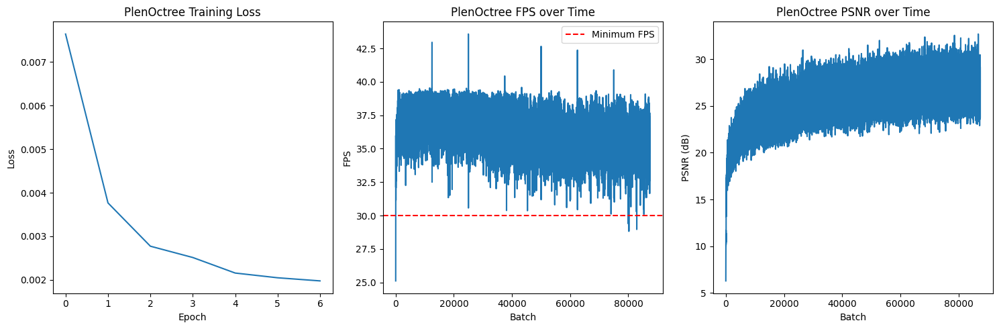

PlenOctree Training Progress:  70%|███████   | 87503/125000 [1:27:40<2:02:41,  5.09it/s]


PlenOctree Epoch 8/10, Batch 0:
FPS: 41.90, Latency: 23.87ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 87513/125000 [1:27:41<51:26, 12.15it/s]


PlenOctree Epoch 8/10, Batch 10:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  70%|███████   | 87523/125000 [1:27:41<39:22, 15.87it/s]


PlenOctree Epoch 8/10, Batch 20:
FPS: 37.75, Latency: 26.49ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  70%|███████   | 87533/125000 [1:27:42<37:52, 16.49it/s]


PlenOctree Epoch 8/10, Batch 30:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.88dB, Loss: 0.0033


PlenOctree Training Progress:  70%|███████   | 87543/125000 [1:27:42<37:03, 16.84it/s]


PlenOctree Epoch 8/10, Batch 40:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  70%|███████   | 87553/125000 [1:27:43<36:52, 16.92it/s]


PlenOctree Epoch 8/10, Batch 50:
FPS: 38.60, Latency: 25.91ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  70%|███████   | 87563/125000 [1:27:43<37:00, 16.86it/s]


PlenOctree Epoch 8/10, Batch 60:
FPS: 38.52, Latency: 25.96ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  70%|███████   | 87573/125000 [1:27:44<37:05, 16.82it/s]


PlenOctree Epoch 8/10, Batch 70:
FPS: 36.36, Latency: 27.51ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87583/125000 [1:27:45<37:04, 16.82it/s]


PlenOctree Epoch 8/10, Batch 80:
FPS: 36.82, Latency: 27.16ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  70%|███████   | 87593/125000 [1:27:45<37:30, 16.62it/s]


PlenOctree Epoch 8/10, Batch 90:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  70%|███████   | 87603/125000 [1:27:46<36:56, 16.87it/s]


PlenOctree Epoch 8/10, Batch 100:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  70%|███████   | 87613/125000 [1:27:46<37:41, 16.53it/s]


PlenOctree Epoch 8/10, Batch 110:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  70%|███████   | 87623/125000 [1:27:47<37:01, 16.83it/s]


PlenOctree Epoch 8/10, Batch 120:
FPS: 37.80, Latency: 26.45ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  70%|███████   | 87633/125000 [1:27:48<37:19, 16.68it/s]


PlenOctree Epoch 8/10, Batch 130:
FPS: 36.93, Latency: 27.08ms
PSNR: 30.10dB, Loss: 0.0010


PlenOctree Training Progress:  70%|███████   | 87643/125000 [1:27:48<37:29, 16.60it/s]


PlenOctree Epoch 8/10, Batch 140:
FPS: 37.03, Latency: 27.00ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 87653/125000 [1:27:49<37:19, 16.68it/s]


PlenOctree Epoch 8/10, Batch 150:
FPS: 37.34, Latency: 26.78ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  70%|███████   | 87663/125000 [1:27:49<37:20, 16.66it/s]


PlenOctree Epoch 8/10, Batch 160:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  70%|███████   | 87673/125000 [1:27:50<37:37, 16.54it/s]


PlenOctree Epoch 8/10, Batch 170:
FPS: 35.91, Latency: 27.85ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  70%|███████   | 87683/125000 [1:27:51<37:42, 16.50it/s]


PlenOctree Epoch 8/10, Batch 180:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87693/125000 [1:27:51<37:43, 16.48it/s]


PlenOctree Epoch 8/10, Batch 190:
FPS: 35.41, Latency: 28.24ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  70%|███████   | 87703/125000 [1:27:52<37:31, 16.56it/s]


PlenOctree Epoch 8/10, Batch 200:
FPS: 36.64, Latency: 27.29ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 87713/125000 [1:27:52<37:11, 16.71it/s]


PlenOctree Epoch 8/10, Batch 210:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  70%|███████   | 87723/125000 [1:27:53<37:13, 16.69it/s]


PlenOctree Epoch 8/10, Batch 220:
FPS: 36.90, Latency: 27.10ms
PSNR: 30.47dB, Loss: 0.0009


PlenOctree Training Progress:  70%|███████   | 87733/125000 [1:27:54<37:05, 16.74it/s]


PlenOctree Epoch 8/10, Batch 230:
FPS: 37.58, Latency: 26.61ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  70%|███████   | 87743/125000 [1:27:54<37:13, 16.68it/s]


PlenOctree Epoch 8/10, Batch 240:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87753/125000 [1:27:55<37:20, 16.62it/s]


PlenOctree Epoch 8/10, Batch 250:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  70%|███████   | 87763/125000 [1:27:55<36:45, 16.88it/s]


PlenOctree Epoch 8/10, Batch 260:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 87773/125000 [1:27:56<37:14, 16.66it/s]


PlenOctree Epoch 8/10, Batch 270:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 87783/125000 [1:27:57<37:15, 16.64it/s]


PlenOctree Epoch 8/10, Batch 280:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87793/125000 [1:27:57<36:55, 16.80it/s]


PlenOctree Epoch 8/10, Batch 290:
FPS: 36.96, Latency: 27.06ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  70%|███████   | 87803/125000 [1:27:58<37:24, 16.58it/s]


PlenOctree Epoch 8/10, Batch 300:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 87813/125000 [1:27:58<36:42, 16.88it/s]


PlenOctree Epoch 8/10, Batch 310:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  70%|███████   | 87823/125000 [1:27:59<37:15, 16.63it/s]


PlenOctree Epoch 8/10, Batch 320:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  70%|███████   | 87833/125000 [1:28:00<36:49, 16.82it/s]


PlenOctree Epoch 8/10, Batch 330:
FPS: 38.03, Latency: 26.30ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87843/125000 [1:28:00<37:14, 16.63it/s]


PlenOctree Epoch 8/10, Batch 340:
FPS: 35.23, Latency: 28.38ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  70%|███████   | 87853/125000 [1:28:01<37:14, 16.62it/s]


PlenOctree Epoch 8/10, Batch 350:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  70%|███████   | 87863/125000 [1:28:01<36:38, 16.89it/s]


PlenOctree Epoch 8/10, Batch 360:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  70%|███████   | 87873/125000 [1:28:02<37:24, 16.54it/s]


PlenOctree Epoch 8/10, Batch 370:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87883/125000 [1:28:03<37:27, 16.51it/s]


PlenOctree Epoch 8/10, Batch 380:
FPS: 35.11, Latency: 28.48ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 87893/125000 [1:28:03<37:31, 16.48it/s]


PlenOctree Epoch 8/10, Batch 390:
FPS: 36.29, Latency: 27.56ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 87903/125000 [1:28:04<37:23, 16.54it/s]


PlenOctree Epoch 8/10, Batch 400:
FPS: 36.36, Latency: 27.51ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87913/125000 [1:28:05<37:24, 16.53it/s]


PlenOctree Epoch 8/10, Batch 410:
FPS: 36.88, Latency: 27.12ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  70%|███████   | 87923/125000 [1:28:05<36:35, 16.89it/s]


PlenOctree Epoch 8/10, Batch 420:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  70%|███████   | 87933/125000 [1:28:06<37:13, 16.60it/s]


PlenOctree Epoch 8/10, Batch 430:
FPS: 35.73, Latency: 27.99ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  70%|███████   | 87943/125000 [1:28:06<37:18, 16.55it/s]


PlenOctree Epoch 8/10, Batch 440:
FPS: 36.88, Latency: 27.11ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  70%|███████   | 87953/125000 [1:28:07<36:52, 16.74it/s]


PlenOctree Epoch 8/10, Batch 450:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  70%|███████   | 87963/125000 [1:28:08<37:16, 16.56it/s]


PlenOctree Epoch 8/10, Batch 460:
FPS: 36.20, Latency: 27.63ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  70%|███████   | 87973/125000 [1:28:08<36:29, 16.91it/s]


PlenOctree Epoch 8/10, Batch 470:
FPS: 37.88, Latency: 26.40ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  70%|███████   | 87983/125000 [1:28:09<37:01, 16.66it/s]


PlenOctree Epoch 8/10, Batch 480:
FPS: 37.00, Latency: 27.03ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 87993/125000 [1:28:09<37:24, 16.49it/s]


PlenOctree Epoch 8/10, Batch 490:
FPS: 36.29, Latency: 27.56ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  70%|███████   | 88003/125000 [1:28:10<37:17, 16.54it/s]


PlenOctree Epoch 8/10, Batch 500:
FPS: 36.73, Latency: 27.23ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  70%|███████   | 88013/125000 [1:28:11<36:51, 16.72it/s]


PlenOctree Epoch 8/10, Batch 510:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  70%|███████   | 88023/125000 [1:28:11<37:07, 16.60it/s]


PlenOctree Epoch 8/10, Batch 520:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  70%|███████   | 88033/125000 [1:28:12<36:38, 16.82it/s]


PlenOctree Epoch 8/10, Batch 530:
FPS: 37.26, Latency: 26.84ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 88043/125000 [1:28:12<36:58, 16.66it/s]


PlenOctree Epoch 8/10, Batch 540:
FPS: 36.73, Latency: 27.22ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  70%|███████   | 88053/125000 [1:28:13<37:15, 16.53it/s]


PlenOctree Epoch 8/10, Batch 550:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 88063/125000 [1:28:14<36:41, 16.78it/s]


PlenOctree Epoch 8/10, Batch 560:
FPS: 37.72, Latency: 26.51ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 88073/125000 [1:28:14<37:13, 16.54it/s]


PlenOctree Epoch 8/10, Batch 570:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  70%|███████   | 88083/125000 [1:28:15<37:22, 16.46it/s]


PlenOctree Epoch 8/10, Batch 580:
FPS: 36.24, Latency: 27.59ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  70%|███████   | 88093/125000 [1:28:15<37:21, 16.46it/s]


PlenOctree Epoch 8/10, Batch 590:
FPS: 35.67, Latency: 28.04ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  70%|███████   | 88103/125000 [1:28:16<37:18, 16.48it/s]


PlenOctree Epoch 8/10, Batch 600:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  70%|███████   | 88113/125000 [1:28:17<37:16, 16.49it/s]


PlenOctree Epoch 8/10, Batch 610:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  70%|███████   | 88123/125000 [1:28:17<37:19, 16.46it/s]


PlenOctree Epoch 8/10, Batch 620:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████   | 88133/125000 [1:28:18<36:54, 16.65it/s]


PlenOctree Epoch 8/10, Batch 630:
FPS: 38.16, Latency: 26.21ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████   | 88143/125000 [1:28:18<36:44, 16.72it/s]


PlenOctree Epoch 8/10, Batch 640:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  71%|███████   | 88153/125000 [1:28:19<37:01, 16.58it/s]


PlenOctree Epoch 8/10, Batch 650:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88163/125000 [1:28:20<36:17, 16.92it/s]


PlenOctree Epoch 8/10, Batch 660:
FPS: 37.13, Latency: 26.93ms
PSNR: 23.68dB, Loss: 0.0043


PlenOctree Training Progress:  71%|███████   | 88173/125000 [1:28:20<36:55, 16.63it/s]


PlenOctree Epoch 8/10, Batch 670:
FPS: 36.56, Latency: 27.35ms
PSNR: 24.28dB, Loss: 0.0037


PlenOctree Training Progress:  71%|███████   | 88183/125000 [1:28:21<37:05, 16.54it/s]


PlenOctree Epoch 8/10, Batch 680:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88193/125000 [1:28:21<36:19, 16.89it/s]


PlenOctree Epoch 8/10, Batch 690:
FPS: 37.93, Latency: 26.37ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████   | 88203/125000 [1:28:22<37:06, 16.53it/s]


PlenOctree Epoch 8/10, Batch 700:
FPS: 36.44, Latency: 27.45ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  71%|███████   | 88213/125000 [1:28:23<36:56, 16.60it/s]


PlenOctree Epoch 8/10, Batch 710:
FPS: 37.04, Latency: 27.00ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88223/125000 [1:28:23<36:28, 16.81it/s]


PlenOctree Epoch 8/10, Batch 720:
FPS: 36.91, Latency: 27.09ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  71%|███████   | 88233/125000 [1:28:24<36:50, 16.63it/s]


PlenOctree Epoch 8/10, Batch 730:
FPS: 35.66, Latency: 28.05ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  71%|███████   | 88243/125000 [1:28:24<36:54, 16.60it/s]


PlenOctree Epoch 8/10, Batch 740:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  71%|███████   | 88253/125000 [1:28:25<36:19, 16.86it/s]


PlenOctree Epoch 8/10, Batch 750:
FPS: 37.32, Latency: 26.79ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88263/125000 [1:28:26<36:53, 16.60it/s]


PlenOctree Epoch 8/10, Batch 760:
FPS: 36.79, Latency: 27.18ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████   | 88273/125000 [1:28:26<36:47, 16.64it/s]


PlenOctree Epoch 8/10, Batch 770:
FPS: 36.65, Latency: 27.28ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88283/125000 [1:28:27<37:09, 16.47it/s]


PlenOctree Epoch 8/10, Batch 780:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88293/125000 [1:28:27<37:11, 16.45it/s]


PlenOctree Epoch 8/10, Batch 790:
FPS: 34.76, Latency: 28.77ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████   | 88303/125000 [1:28:28<36:57, 16.55it/s]


PlenOctree Epoch 8/10, Batch 800:
FPS: 37.53, Latency: 26.65ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88313/125000 [1:28:29<37:03, 16.50it/s]


PlenOctree Epoch 8/10, Batch 810:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  71%|███████   | 88323/125000 [1:28:29<36:14, 16.86it/s]


PlenOctree Epoch 8/10, Batch 820:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████   | 88333/125000 [1:28:30<36:52, 16.57it/s]


PlenOctree Epoch 8/10, Batch 830:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88343/125000 [1:28:30<36:56, 16.54it/s]


PlenOctree Epoch 8/10, Batch 840:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88353/125000 [1:28:31<37:11, 16.42it/s]


PlenOctree Epoch 8/10, Batch 850:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88363/125000 [1:28:32<36:57, 16.52it/s]


PlenOctree Epoch 8/10, Batch 860:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88373/125000 [1:28:32<36:22, 16.78it/s]


PlenOctree Epoch 8/10, Batch 870:
FPS: 36.73, Latency: 27.22ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88383/125000 [1:28:33<36:54, 16.54it/s]


PlenOctree Epoch 8/10, Batch 880:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  71%|███████   | 88393/125000 [1:28:33<37:10, 16.41it/s]


PlenOctree Epoch 8/10, Batch 890:
FPS: 35.39, Latency: 28.26ms
PSNR: 29.83dB, Loss: 0.0010


PlenOctree Training Progress:  71%|███████   | 88403/125000 [1:28:34<37:01, 16.48it/s]


PlenOctree Epoch 8/10, Batch 900:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88413/125000 [1:28:35<37:06, 16.44it/s]


PlenOctree Epoch 8/10, Batch 910:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  71%|███████   | 88423/125000 [1:28:35<36:55, 16.51it/s]


PlenOctree Epoch 8/10, Batch 920:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88433/125000 [1:28:36<37:00, 16.47it/s]


PlenOctree Epoch 8/10, Batch 930:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88443/125000 [1:28:36<36:30, 16.69it/s]


PlenOctree Epoch 8/10, Batch 940:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88453/125000 [1:28:37<36:31, 16.68it/s]


PlenOctree Epoch 8/10, Batch 950:
FPS: 36.49, Latency: 27.41ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  71%|███████   | 88463/125000 [1:28:38<36:47, 16.55it/s]


PlenOctree Epoch 8/10, Batch 960:
FPS: 36.69, Latency: 27.26ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  71%|███████   | 88473/125000 [1:28:38<37:05, 16.41it/s]


PlenOctree Epoch 8/10, Batch 970:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  71%|███████   | 88483/125000 [1:28:39<36:45, 16.56it/s]


PlenOctree Epoch 8/10, Batch 980:
FPS: 36.28, Latency: 27.57ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88493/125000 [1:28:39<36:52, 16.50it/s]


PlenOctree Epoch 8/10, Batch 990:
FPS: 35.82, Latency: 27.91ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████   | 88503/125000 [1:28:40<36:59, 16.44it/s]


PlenOctree Epoch 8/10, Batch 1000:
FPS: 35.82, Latency: 27.92ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████   | 88513/125000 [1:28:41<36:47, 16.53it/s]


PlenOctree Epoch 8/10, Batch 1010:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88523/125000 [1:28:41<37:00, 16.43it/s]


PlenOctree Epoch 8/10, Batch 1020:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  71%|███████   | 88533/125000 [1:28:42<36:48, 16.51it/s]


PlenOctree Epoch 8/10, Batch 1030:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88543/125000 [1:28:42<36:51, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1040:
FPS: 34.17, Latency: 29.27ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  71%|███████   | 88553/125000 [1:28:43<36:54, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1050:
FPS: 35.91, Latency: 27.84ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88563/125000 [1:28:44<36:50, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1060:
FPS: 36.08, Latency: 27.72ms
PSNR: 29.34dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████   | 88573/125000 [1:28:44<36:51, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1070:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88583/125000 [1:28:45<36:43, 16.53it/s]


PlenOctree Epoch 8/10, Batch 1080:
FPS: 36.73, Latency: 27.23ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88593/125000 [1:28:46<36:06, 16.81it/s]


PlenOctree Epoch 8/10, Batch 1090:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  71%|███████   | 88603/125000 [1:28:46<36:39, 16.55it/s]


PlenOctree Epoch 8/10, Batch 1100:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  71%|███████   | 88613/125000 [1:28:47<36:44, 16.51it/s]


PlenOctree Epoch 8/10, Batch 1110:
FPS: 36.43, Latency: 27.45ms
PSNR: 29.23dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████   | 88623/125000 [1:28:47<36:36, 16.56it/s]


PlenOctree Epoch 8/10, Batch 1120:
FPS: 36.45, Latency: 27.44ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88633/125000 [1:28:48<36:39, 16.54it/s]


PlenOctree Epoch 8/10, Batch 1130:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  71%|███████   | 88643/125000 [1:28:49<35:50, 16.91it/s]


PlenOctree Epoch 8/10, Batch 1140:
FPS: 36.92, Latency: 27.08ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  71%|███████   | 88653/125000 [1:28:49<36:29, 16.60it/s]


PlenOctree Epoch 8/10, Batch 1150:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88663/125000 [1:28:50<36:39, 16.52it/s]


PlenOctree Epoch 8/10, Batch 1160:
FPS: 35.95, Latency: 27.81ms
PSNR: 24.56dB, Loss: 0.0035


PlenOctree Training Progress:  71%|███████   | 88673/125000 [1:28:50<36:52, 16.42it/s]


PlenOctree Epoch 8/10, Batch 1170:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.03dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████   | 88683/125000 [1:28:51<36:46, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1180:
FPS: 36.36, Latency: 27.50ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88693/125000 [1:28:52<36:45, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1190:
FPS: 33.50, Latency: 29.85ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████   | 88703/125000 [1:28:52<36:45, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1200:
FPS: 34.80, Latency: 28.74ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████   | 88713/125000 [1:28:53<36:44, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1210:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88723/125000 [1:28:53<36:39, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1220:
FPS: 35.11, Latency: 28.48ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88733/125000 [1:28:54<36:33, 16.53it/s]


PlenOctree Epoch 8/10, Batch 1230:
FPS: 36.49, Latency: 27.41ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  71%|███████   | 88743/125000 [1:28:55<36:31, 16.55it/s]


PlenOctree Epoch 8/10, Batch 1240:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88753/125000 [1:28:55<35:49, 16.87it/s]


PlenOctree Epoch 8/10, Batch 1250:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  71%|███████   | 88763/125000 [1:28:56<36:19, 16.63it/s]


PlenOctree Epoch 8/10, Batch 1260:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  71%|███████   | 88773/125000 [1:28:56<36:30, 16.54it/s]


PlenOctree Epoch 8/10, Batch 1270:
FPS: 36.45, Latency: 27.44ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88783/125000 [1:28:57<36:38, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1280:
FPS: 35.32, Latency: 28.31ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88793/125000 [1:28:58<36:42, 16.44it/s]


PlenOctree Epoch 8/10, Batch 1290:
FPS: 35.69, Latency: 28.02ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████   | 88803/125000 [1:28:58<36:27, 16.55it/s]


PlenOctree Epoch 8/10, Batch 1300:
FPS: 35.28, Latency: 28.34ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  71%|███████   | 88813/125000 [1:28:59<36:34, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1310:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88823/125000 [1:28:59<36:30, 16.51it/s]


PlenOctree Epoch 8/10, Batch 1320:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88833/125000 [1:29:00<36:31, 16.50it/s]


PlenOctree Epoch 8/10, Batch 1330:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88843/125000 [1:29:01<36:27, 16.53it/s]


PlenOctree Epoch 8/10, Batch 1340:
FPS: 34.95, Latency: 28.61ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████   | 88853/125000 [1:29:01<36:29, 16.51it/s]


PlenOctree Epoch 8/10, Batch 1350:
FPS: 35.66, Latency: 28.04ms
PSNR: 29.44dB, Loss: 0.0011


PlenOctree Training Progress:  71%|███████   | 88863/125000 [1:29:02<36:31, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1360:
FPS: 35.00, Latency: 28.57ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  71%|███████   | 88873/125000 [1:29:02<36:31, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1370:
FPS: 33.45, Latency: 29.89ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  71%|███████   | 88883/125000 [1:29:03<36:29, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1380:
FPS: 35.90, Latency: 27.86ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  71%|███████   | 88893/125000 [1:29:04<36:27, 16.50it/s]


PlenOctree Epoch 8/10, Batch 1390:
FPS: 35.30, Latency: 28.33ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  71%|███████   | 88903/125000 [1:29:04<36:30, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1400:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████   | 88913/125000 [1:29:05<36:26, 16.50it/s]


PlenOctree Epoch 8/10, Batch 1410:
FPS: 35.28, Latency: 28.35ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  71%|███████   | 88923/125000 [1:29:05<36:25, 16.50it/s]


PlenOctree Epoch 8/10, Batch 1420:
FPS: 35.22, Latency: 28.39ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88933/125000 [1:29:06<36:26, 16.50it/s]


PlenOctree Epoch 8/10, Batch 1430:
FPS: 36.13, Latency: 27.67ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 88943/125000 [1:29:07<36:27, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1440:
FPS: 36.33, Latency: 27.53ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████   | 88953/125000 [1:29:07<36:29, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1450:
FPS: 33.88, Latency: 29.52ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████   | 88963/125000 [1:29:08<36:26, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1460:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████   | 88973/125000 [1:29:09<36:31, 16.44it/s]


PlenOctree Epoch 8/10, Batch 1470:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████   | 88983/125000 [1:29:09<36:27, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1480:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.30dB, Loss: 0.0029


PlenOctree Training Progress:  71%|███████   | 88993/125000 [1:29:10<36:30, 16.44it/s]


PlenOctree Epoch 8/10, Batch 1490:
FPS: 35.66, Latency: 28.05ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  71%|███████   | 89003/125000 [1:29:10<36:26, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1500:
FPS: 35.55, Latency: 28.13ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  71%|███████   | 89013/125000 [1:29:11<36:25, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1510:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  71%|███████   | 89023/125000 [1:29:12<36:21, 16.49it/s]


PlenOctree Epoch 8/10, Batch 1520:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████   | 89033/125000 [1:29:12<36:29, 16.43it/s]


PlenOctree Epoch 8/10, Batch 1530:
FPS: 35.45, Latency: 28.21ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  71%|███████   | 89043/125000 [1:29:13<36:27, 16.44it/s]


PlenOctree Epoch 8/10, Batch 1540:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  71%|███████   | 89053/125000 [1:29:13<36:23, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1550:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  71%|███████▏  | 89063/125000 [1:29:14<36:20, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1560:
FPS: 35.25, Latency: 28.37ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  71%|███████▏  | 89073/125000 [1:29:15<36:27, 16.42it/s]


PlenOctree Epoch 8/10, Batch 1570:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████▏  | 89083/125000 [1:29:15<36:25, 16.43it/s]


PlenOctree Epoch 8/10, Batch 1580:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████▏  | 89093/125000 [1:29:16<36:15, 16.50it/s]


PlenOctree Epoch 8/10, Batch 1590:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████▏  | 89103/125000 [1:29:16<36:20, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1600:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  71%|███████▏  | 89113/125000 [1:29:17<36:24, 16.43it/s]


PlenOctree Epoch 8/10, Batch 1610:
FPS: 35.87, Latency: 27.88ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  71%|███████▏  | 89123/125000 [1:29:18<36:12, 16.52it/s]


PlenOctree Epoch 8/10, Batch 1620:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████▏  | 89133/125000 [1:29:18<36:19, 16.46it/s]


PlenOctree Epoch 8/10, Batch 1630:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████▏  | 89143/125000 [1:29:19<36:16, 16.47it/s]


PlenOctree Epoch 8/10, Batch 1640:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  71%|███████▏  | 89153/125000 [1:29:19<35:26, 16.86it/s]


PlenOctree Epoch 8/10, Batch 1650:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  71%|███████▏  | 89163/125000 [1:29:20<36:09, 16.52it/s]


PlenOctree Epoch 8/10, Batch 1660:
FPS: 35.84, Latency: 27.90ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  71%|███████▏  | 89173/125000 [1:29:21<36:07, 16.53it/s]


PlenOctree Epoch 8/10, Batch 1670:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████▏  | 89183/125000 [1:29:21<36:06, 16.54it/s]


PlenOctree Epoch 8/10, Batch 1680:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  71%|███████▏  | 89193/125000 [1:29:22<35:32, 16.79it/s]


PlenOctree Epoch 8/10, Batch 1690:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████▏  | 89203/125000 [1:29:22<35:59, 16.58it/s]


PlenOctree Epoch 8/10, Batch 1700:
FPS: 37.10, Latency: 26.95ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  71%|███████▏  | 89213/125000 [1:29:23<35:23, 16.85it/s]


PlenOctree Epoch 8/10, Batch 1710:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████▏  | 89223/125000 [1:29:24<36:01, 16.56it/s]


PlenOctree Epoch 8/10, Batch 1720:
FPS: 36.21, Latency: 27.61ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████▏  | 89233/125000 [1:29:24<35:31, 16.78it/s]


PlenOctree Epoch 8/10, Batch 1730:
FPS: 37.74, Latency: 26.50ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████▏  | 89243/125000 [1:29:25<35:35, 16.74it/s]


PlenOctree Epoch 8/10, Batch 1740:
FPS: 35.34, Latency: 28.29ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  71%|███████▏  | 89253/125000 [1:29:25<35:17, 16.88it/s]


PlenOctree Epoch 8/10, Batch 1750:
FPS: 37.17, Latency: 26.90ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  71%|███████▏  | 89263/125000 [1:29:26<35:54, 16.59it/s]


PlenOctree Epoch 8/10, Batch 1760:
FPS: 35.31, Latency: 28.32ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  71%|███████▏  | 89273/125000 [1:29:27<35:50, 16.62it/s]


PlenOctree Epoch 8/10, Batch 1770:
FPS: 36.51, Latency: 27.39ms
PSNR: 29.39dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████▏  | 89283/125000 [1:29:27<36:06, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1780:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  71%|███████▏  | 89293/125000 [1:29:28<35:44, 16.65it/s]


PlenOctree Epoch 8/10, Batch 1790:
FPS: 37.78, Latency: 26.47ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████▏  | 89303/125000 [1:29:28<35:41, 16.67it/s]


PlenOctree Epoch 8/10, Batch 1800:
FPS: 35.81, Latency: 27.93ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  71%|███████▏  | 89313/125000 [1:29:29<35:50, 16.60it/s]


PlenOctree Epoch 8/10, Batch 1810:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  71%|███████▏  | 89323/125000 [1:29:30<35:59, 16.52it/s]


PlenOctree Epoch 8/10, Batch 1820:
FPS: 36.56, Latency: 27.35ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  71%|███████▏  | 89333/125000 [1:29:30<35:14, 16.87it/s]


PlenOctree Epoch 8/10, Batch 1830:
FPS: 37.42, Latency: 26.72ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  71%|███████▏  | 89343/125000 [1:29:31<35:48, 16.60it/s]


PlenOctree Epoch 8/10, Batch 1840:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  71%|███████▏  | 89353/125000 [1:29:31<35:44, 16.62it/s]


PlenOctree Epoch 8/10, Batch 1850:
FPS: 35.14, Latency: 28.46ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████▏  | 89363/125000 [1:29:32<35:19, 16.81it/s]


PlenOctree Epoch 8/10, Batch 1860:
FPS: 36.04, Latency: 27.74ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  71%|███████▏  | 89373/125000 [1:29:33<35:50, 16.57it/s]


PlenOctree Epoch 8/10, Batch 1870:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89383/125000 [1:29:33<35:51, 16.55it/s]


PlenOctree Epoch 8/10, Batch 1880:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 89393/125000 [1:29:34<35:49, 16.56it/s]


PlenOctree Epoch 8/10, Batch 1890:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89403/125000 [1:29:34<35:27, 16.73it/s]


PlenOctree Epoch 8/10, Batch 1900:
FPS: 34.60, Latency: 28.90ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 89413/125000 [1:29:35<35:43, 16.61it/s]


PlenOctree Epoch 8/10, Batch 1910:
FPS: 34.95, Latency: 28.61ms
PSNR: 31.11dB, Loss: 0.0008


PlenOctree Training Progress:  72%|███████▏  | 89423/125000 [1:29:36<35:07, 16.88it/s]


PlenOctree Epoch 8/10, Batch 1920:
FPS: 36.96, Latency: 27.06ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  72%|███████▏  | 89433/125000 [1:29:36<35:38, 16.63it/s]


PlenOctree Epoch 8/10, Batch 1930:
FPS: 36.74, Latency: 27.22ms
PSNR: 30.14dB, Loss: 0.0010


PlenOctree Training Progress:  72%|███████▏  | 89443/125000 [1:29:37<35:50, 16.54it/s]


PlenOctree Epoch 8/10, Batch 1940:
FPS: 36.96, Latency: 27.05ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 89453/125000 [1:29:37<35:13, 16.82it/s]


PlenOctree Epoch 8/10, Batch 1950:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89463/125000 [1:29:38<35:34, 16.65it/s]


PlenOctree Epoch 8/10, Batch 1960:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 89473/125000 [1:29:39<35:49, 16.53it/s]


PlenOctree Epoch 8/10, Batch 1970:
FPS: 36.81, Latency: 27.17ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  72%|███████▏  | 89483/125000 [1:29:39<35:54, 16.48it/s]


PlenOctree Epoch 8/10, Batch 1980:
FPS: 35.35, Latency: 28.29ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 89493/125000 [1:29:40<35:49, 16.52it/s]


PlenOctree Epoch 8/10, Batch 1990:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 89503/125000 [1:29:40<35:49, 16.51it/s]


PlenOctree Epoch 8/10, Batch 2000:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  72%|███████▏  | 89513/125000 [1:29:41<35:44, 16.54it/s]


PlenOctree Epoch 8/10, Batch 2010:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 89523/125000 [1:29:42<35:11, 16.80it/s]


PlenOctree Epoch 8/10, Batch 2020:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  72%|███████▏  | 89533/125000 [1:29:42<35:42, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2030:
FPS: 36.33, Latency: 27.53ms
PSNR: 29.60dB, Loss: 0.0011


PlenOctree Training Progress:  72%|███████▏  | 89543/125000 [1:29:43<35:50, 16.49it/s]


PlenOctree Epoch 8/10, Batch 2040:
FPS: 37.89, Latency: 26.39ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  72%|███████▏  | 89553/125000 [1:29:44<35:31, 16.63it/s]


PlenOctree Epoch 8/10, Batch 2050:
FPS: 36.92, Latency: 27.08ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 89563/125000 [1:29:44<35:24, 16.68it/s]


PlenOctree Epoch 8/10, Batch 2060:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  72%|███████▏  | 89573/125000 [1:29:45<35:36, 16.58it/s]


PlenOctree Epoch 8/10, Batch 2070:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 89583/125000 [1:29:45<35:50, 16.47it/s]


PlenOctree Epoch 8/10, Batch 2080:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 89593/125000 [1:29:46<35:37, 16.57it/s]


PlenOctree Epoch 8/10, Batch 2090:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  72%|███████▏  | 89603/125000 [1:29:47<35:02, 16.83it/s]


PlenOctree Epoch 8/10, Batch 2100:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  72%|███████▏  | 89613/125000 [1:29:47<35:38, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2110:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 89623/125000 [1:29:48<35:08, 16.78it/s]


PlenOctree Epoch 8/10, Batch 2120:
FPS: 37.50, Latency: 26.67ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 89633/125000 [1:29:48<35:13, 16.74it/s]


PlenOctree Epoch 8/10, Batch 2130:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 89643/125000 [1:29:49<35:07, 16.78it/s]


PlenOctree Epoch 8/10, Batch 2140:
FPS: 38.28, Latency: 26.12ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  72%|███████▏  | 89653/125000 [1:29:50<35:20, 16.67it/s]


PlenOctree Epoch 8/10, Batch 2150:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  72%|███████▏  | 89663/125000 [1:29:50<35:29, 16.59it/s]


PlenOctree Epoch 8/10, Batch 2160:
FPS: 35.26, Latency: 28.36ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89673/125000 [1:29:51<35:35, 16.54it/s]


PlenOctree Epoch 8/10, Batch 2170:
FPS: 36.46, Latency: 27.42ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 89683/125000 [1:29:51<35:07, 16.76it/s]


PlenOctree Epoch 8/10, Batch 2180:
FPS: 35.42, Latency: 28.23ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  72%|███████▏  | 89693/125000 [1:29:52<35:28, 16.59it/s]


PlenOctree Epoch 8/10, Batch 2190:
FPS: 34.61, Latency: 28.90ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 89703/125000 [1:29:53<35:29, 16.58it/s]


PlenOctree Epoch 8/10, Batch 2200:
FPS: 37.33, Latency: 26.79ms
PSNR: 30.12dB, Loss: 0.0010


PlenOctree Training Progress:  72%|███████▏  | 89713/125000 [1:29:53<34:50, 16.88it/s]


PlenOctree Epoch 8/10, Batch 2210:
FPS: 36.68, Latency: 27.27ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  72%|███████▏  | 89723/125000 [1:29:54<35:30, 16.56it/s]


PlenOctree Epoch 8/10, Batch 2220:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 89733/125000 [1:29:54<35:32, 16.54it/s]


PlenOctree Epoch 8/10, Batch 2230:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 89743/125000 [1:29:55<35:43, 16.45it/s]


PlenOctree Epoch 8/10, Batch 2240:
FPS: 35.60, Latency: 28.09ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  72%|███████▏  | 89753/125000 [1:29:56<35:05, 16.74it/s]


PlenOctree Epoch 8/10, Batch 2250:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  72%|███████▏  | 89763/125000 [1:29:56<35:17, 16.64it/s]


PlenOctree Epoch 8/10, Batch 2260:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  72%|███████▏  | 89773/125000 [1:29:57<35:26, 16.56it/s]


PlenOctree Epoch 8/10, Batch 2270:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89783/125000 [1:29:57<35:07, 16.71it/s]


PlenOctree Epoch 8/10, Batch 2280:
FPS: 37.46, Latency: 26.70ms
PSNR: 26.11dB, Loss: 0.0025


PlenOctree Training Progress:  72%|███████▏  | 89793/125000 [1:29:58<35:05, 16.72it/s]


PlenOctree Epoch 8/10, Batch 2290:
FPS: 36.95, Latency: 27.07ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 89803/125000 [1:29:59<34:56, 16.79it/s]


PlenOctree Epoch 8/10, Batch 2300:
FPS: 37.70, Latency: 26.53ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 89813/125000 [1:29:59<35:06, 16.70it/s]


PlenOctree Epoch 8/10, Batch 2310:
FPS: 36.06, Latency: 27.73ms
PSNR: 24.39dB, Loss: 0.0036


PlenOctree Training Progress:  72%|███████▏  | 89823/125000 [1:30:00<34:35, 16.95it/s]


PlenOctree Epoch 8/10, Batch 2320:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 89833/125000 [1:30:00<35:16, 16.61it/s]


PlenOctree Epoch 8/10, Batch 2330:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  72%|███████▏  | 89843/125000 [1:30:01<34:44, 16.87it/s]


PlenOctree Epoch 8/10, Batch 2340:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  72%|███████▏  | 89853/125000 [1:30:02<35:17, 16.60it/s]


PlenOctree Epoch 8/10, Batch 2350:
FPS: 36.25, Latency: 27.58ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 89863/125000 [1:30:02<35:18, 16.59it/s]


PlenOctree Epoch 8/10, Batch 2360:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  72%|███████▏  | 89873/125000 [1:30:03<35:28, 16.50it/s]


PlenOctree Epoch 8/10, Batch 2370:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89883/125000 [1:30:03<35:24, 16.53it/s]


PlenOctree Epoch 8/10, Batch 2380:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 89893/125000 [1:30:04<35:07, 16.66it/s]


PlenOctree Epoch 8/10, Batch 2390:
FPS: 37.67, Latency: 26.55ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 89903/125000 [1:30:05<35:06, 16.66it/s]


PlenOctree Epoch 8/10, Batch 2400:
FPS: 36.61, Latency: 27.31ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  72%|███████▏  | 89913/125000 [1:30:05<35:19, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2410:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 89923/125000 [1:30:06<35:29, 16.47it/s]


PlenOctree Epoch 8/10, Batch 2420:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  72%|███████▏  | 89933/125000 [1:30:06<35:20, 16.54it/s]


PlenOctree Epoch 8/10, Batch 2430:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 89943/125000 [1:30:07<35:28, 16.47it/s]


PlenOctree Epoch 8/10, Batch 2440:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 89953/125000 [1:30:08<35:21, 16.52it/s]


PlenOctree Epoch 8/10, Batch 2450:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 89963/125000 [1:30:08<34:39, 16.85it/s]


PlenOctree Epoch 8/10, Batch 2460:
FPS: 36.81, Latency: 27.17ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 89973/125000 [1:30:09<35:12, 16.58it/s]


PlenOctree Epoch 8/10, Batch 2470:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 89983/125000 [1:30:09<35:08, 16.61it/s]


PlenOctree Epoch 8/10, Batch 2480:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 89993/125000 [1:30:10<34:45, 16.78it/s]


PlenOctree Epoch 8/10, Batch 2490:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  72%|███████▏  | 90003/125000 [1:30:11<35:16, 16.53it/s]


PlenOctree Epoch 8/10, Batch 2500:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90013/125000 [1:30:11<34:38, 16.84it/s]


PlenOctree Epoch 8/10, Batch 2510:
FPS: 37.31, Latency: 26.80ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 90023/125000 [1:30:12<34:54, 16.70it/s]


PlenOctree Epoch 8/10, Batch 2520:
FPS: 38.06, Latency: 26.27ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  72%|███████▏  | 90033/125000 [1:30:12<35:04, 16.62it/s]


PlenOctree Epoch 8/10, Batch 2530:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90043/125000 [1:30:13<34:51, 16.71it/s]


PlenOctree Epoch 8/10, Batch 2540:
FPS: 36.49, Latency: 27.40ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90053/125000 [1:30:14<35:07, 16.58it/s]


PlenOctree Epoch 8/10, Batch 2550:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90063/125000 [1:30:14<35:03, 16.61it/s]


PlenOctree Epoch 8/10, Batch 2560:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 90073/125000 [1:30:15<34:56, 16.66it/s]


PlenOctree Epoch 8/10, Batch 2570:
FPS: 34.11, Latency: 29.32ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 90083/125000 [1:30:15<35:08, 16.56it/s]


PlenOctree Epoch 8/10, Batch 2580:
FPS: 34.56, Latency: 28.94ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90093/125000 [1:30:16<35:29, 16.40it/s]


PlenOctree Epoch 8/10, Batch 2590:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  72%|███████▏  | 90103/125000 [1:30:17<35:03, 16.59it/s]


PlenOctree Epoch 8/10, Batch 2600:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.29dB, Loss: 0.0030


PlenOctree Training Progress:  72%|███████▏  | 90113/125000 [1:30:17<34:46, 16.72it/s]


PlenOctree Epoch 8/10, Batch 2610:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90123/125000 [1:30:18<35:12, 16.51it/s]


PlenOctree Epoch 8/10, Batch 2620:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90133/125000 [1:30:18<35:19, 16.45it/s]


PlenOctree Epoch 8/10, Batch 2630:
FPS: 35.94, Latency: 27.83ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 90143/125000 [1:30:19<35:13, 16.49it/s]


PlenOctree Epoch 8/10, Batch 2640:
FPS: 36.80, Latency: 27.17ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90153/125000 [1:30:20<34:36, 16.78it/s]


PlenOctree Epoch 8/10, Batch 2650:
FPS: 37.57, Latency: 26.62ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 90163/125000 [1:30:20<34:49, 16.67it/s]


PlenOctree Epoch 8/10, Batch 2660:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90173/125000 [1:30:21<34:55, 16.62it/s]


PlenOctree Epoch 8/10, Batch 2670:
FPS: 36.65, Latency: 27.29ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90183/125000 [1:30:21<34:40, 16.73it/s]


PlenOctree Epoch 8/10, Batch 2680:
FPS: 36.64, Latency: 27.30ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 90193/125000 [1:30:22<34:57, 16.59it/s]


PlenOctree Epoch 8/10, Batch 2690:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  72%|███████▏  | 90203/125000 [1:30:23<34:33, 16.78it/s]


PlenOctree Epoch 8/10, Batch 2700:
FPS: 38.30, Latency: 26.11ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 90213/125000 [1:30:23<34:36, 16.75it/s]


PlenOctree Epoch 8/10, Batch 2710:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.09dB, Loss: 0.0031


PlenOctree Training Progress:  72%|███████▏  | 90223/125000 [1:30:24<34:18, 16.89it/s]


PlenOctree Epoch 8/10, Batch 2720:
FPS: 36.91, Latency: 27.09ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 90233/125000 [1:30:24<35:03, 16.53it/s]


PlenOctree Epoch 8/10, Batch 2730:
FPS: 35.98, Latency: 27.79ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  72%|███████▏  | 90243/125000 [1:30:25<34:36, 16.74it/s]


PlenOctree Epoch 8/10, Batch 2740:
FPS: 37.61, Latency: 26.59ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  72%|███████▏  | 90253/125000 [1:30:26<34:40, 16.70it/s]


PlenOctree Epoch 8/10, Batch 2750:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 90263/125000 [1:30:26<34:58, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2760:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 90273/125000 [1:30:27<35:06, 16.48it/s]


PlenOctree Epoch 8/10, Batch 2770:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 90283/125000 [1:30:27<34:57, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2780:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  72%|███████▏  | 90293/125000 [1:30:28<34:31, 16.75it/s]


PlenOctree Epoch 8/10, Batch 2790:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  72%|███████▏  | 90303/125000 [1:30:29<34:56, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2800:
FPS: 36.76, Latency: 27.21ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90313/125000 [1:30:29<34:59, 16.52it/s]


PlenOctree Epoch 8/10, Batch 2810:
FPS: 35.93, Latency: 27.83ms
PSNR: 29.47dB, Loss: 0.0011


PlenOctree Training Progress:  72%|███████▏  | 90323/125000 [1:30:30<35:09, 16.44it/s]


PlenOctree Epoch 8/10, Batch 2820:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  72%|███████▏  | 90333/125000 [1:30:30<35:03, 16.48it/s]


PlenOctree Epoch 8/10, Batch 2830:
FPS: 36.68, Latency: 27.26ms
PSNR: 31.08dB, Loss: 0.0008


PlenOctree Training Progress:  72%|███████▏  | 90343/125000 [1:30:31<34:55, 16.54it/s]


PlenOctree Epoch 8/10, Batch 2840:
FPS: 37.18, Latency: 26.89ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  72%|███████▏  | 90353/125000 [1:30:32<34:31, 16.73it/s]


PlenOctree Epoch 8/10, Batch 2850:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 90363/125000 [1:30:32<34:48, 16.58it/s]


PlenOctree Epoch 8/10, Batch 2860:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 90373/125000 [1:30:33<34:19, 16.81it/s]


PlenOctree Epoch 8/10, Batch 2870:
FPS: 37.35, Latency: 26.78ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90383/125000 [1:30:33<34:32, 16.70it/s]


PlenOctree Epoch 8/10, Batch 2880:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  72%|███████▏  | 90393/125000 [1:30:34<34:51, 16.55it/s]


PlenOctree Epoch 8/10, Batch 2890:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90403/125000 [1:30:35<34:12, 16.86it/s]


PlenOctree Epoch 8/10, Batch 2900:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 90413/125000 [1:30:35<34:42, 16.61it/s]


PlenOctree Epoch 8/10, Batch 2910:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  72%|███████▏  | 90423/125000 [1:30:36<34:42, 16.60it/s]


PlenOctree Epoch 8/10, Batch 2920:
FPS: 37.25, Latency: 26.85ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  72%|███████▏  | 90433/125000 [1:30:36<34:09, 16.87it/s]


PlenOctree Epoch 8/10, Batch 2930:
FPS: 37.37, Latency: 26.76ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 90443/125000 [1:30:37<34:42, 16.59it/s]


PlenOctree Epoch 8/10, Batch 2940:
FPS: 35.72, Latency: 27.99ms
PSNR: 30.23dB, Loss: 0.0009


PlenOctree Training Progress:  72%|███████▏  | 90453/125000 [1:30:38<34:44, 16.58it/s]


PlenOctree Epoch 8/10, Batch 2950:
FPS: 36.88, Latency: 27.11ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  72%|███████▏  | 90463/125000 [1:30:38<34:02, 16.91it/s]


PlenOctree Epoch 8/10, Batch 2960:
FPS: 37.52, Latency: 26.65ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 90473/125000 [1:30:39<34:49, 16.52it/s]


PlenOctree Epoch 8/10, Batch 2970:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  72%|███████▏  | 90483/125000 [1:30:39<34:52, 16.50it/s]


PlenOctree Epoch 8/10, Batch 2980:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 90493/125000 [1:30:40<34:45, 16.54it/s]


PlenOctree Epoch 8/10, Batch 2990:
FPS: 35.63, Latency: 28.06ms
PSNR: 30.12dB, Loss: 0.0010


PlenOctree Training Progress:  72%|███████▏  | 90503/125000 [1:30:41<34:52, 16.49it/s]


PlenOctree Epoch 8/10, Batch 3000:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 90513/125000 [1:30:41<34:53, 16.47it/s]


PlenOctree Epoch 8/10, Batch 3010:
FPS: 35.79, Latency: 27.94ms
PSNR: 24.94dB, Loss: 0.0032


PlenOctree Training Progress:  72%|███████▏  | 90523/125000 [1:30:42<34:53, 16.47it/s]


PlenOctree Epoch 8/10, Batch 3020:
FPS: 35.41, Latency: 28.24ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90533/125000 [1:30:42<34:48, 16.50it/s]


PlenOctree Epoch 8/10, Batch 3030:
FPS: 35.96, Latency: 27.80ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  72%|███████▏  | 90543/125000 [1:30:43<34:39, 16.57it/s]


PlenOctree Epoch 8/10, Batch 3040:
FPS: 37.53, Latency: 26.64ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  72%|███████▏  | 90553/125000 [1:30:44<34:15, 16.76it/s]


PlenOctree Epoch 8/10, Batch 3050:
FPS: 36.64, Latency: 27.30ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  72%|███████▏  | 90563/125000 [1:30:44<34:37, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3060:
FPS: 35.90, Latency: 27.86ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  72%|███████▏  | 90573/125000 [1:30:45<34:00, 16.88it/s]


PlenOctree Epoch 8/10, Batch 3070:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  72%|███████▏  | 90583/125000 [1:30:45<34:36, 16.57it/s]


PlenOctree Epoch 8/10, Batch 3080:
FPS: 35.87, Latency: 27.87ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 90593/125000 [1:30:46<34:28, 16.64it/s]


PlenOctree Epoch 8/10, Batch 3090:
FPS: 37.64, Latency: 26.57ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  72%|███████▏  | 90603/125000 [1:30:47<34:08, 16.79it/s]


PlenOctree Epoch 8/10, Batch 3100:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  72%|███████▏  | 90613/125000 [1:30:47<34:33, 16.59it/s]


PlenOctree Epoch 8/10, Batch 3110:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  72%|███████▏  | 90623/125000 [1:30:48<33:46, 16.96it/s]


PlenOctree Epoch 8/10, Batch 3120:
FPS: 37.75, Latency: 26.49ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 90633/125000 [1:30:48<34:27, 16.62it/s]


PlenOctree Epoch 8/10, Batch 3130:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  73%|███████▎  | 90643/125000 [1:30:49<34:34, 16.56it/s]


PlenOctree Epoch 8/10, Batch 3140:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 90653/125000 [1:30:50<34:48, 16.45it/s]


PlenOctree Epoch 8/10, Batch 3150:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 90663/125000 [1:30:50<34:41, 16.49it/s]


PlenOctree Epoch 8/10, Batch 3160:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 90673/125000 [1:30:51<33:55, 16.87it/s]


PlenOctree Epoch 8/10, Batch 3170:
FPS: 36.53, Latency: 27.38ms
PSNR: 29.98dB, Loss: 0.0010


PlenOctree Training Progress:  73%|███████▎  | 90683/125000 [1:30:51<34:40, 16.50it/s]


PlenOctree Epoch 8/10, Batch 3180:
FPS: 36.15, Latency: 27.67ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 90693/125000 [1:30:52<34:36, 16.52it/s]


PlenOctree Epoch 8/10, Batch 3190:
FPS: 36.07, Latency: 27.73ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 90703/125000 [1:30:53<34:37, 16.51it/s]


PlenOctree Epoch 8/10, Batch 3200:
FPS: 36.52, Latency: 27.38ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  73%|███████▎  | 90713/125000 [1:30:53<34:42, 16.46it/s]


PlenOctree Epoch 8/10, Batch 3210:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 90723/125000 [1:30:54<34:36, 16.50it/s]


PlenOctree Epoch 8/10, Batch 3220:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  73%|███████▎  | 90733/125000 [1:30:55<34:35, 16.51it/s]


PlenOctree Epoch 8/10, Batch 3230:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 90743/125000 [1:30:55<34:38, 16.48it/s]


PlenOctree Epoch 8/10, Batch 3240:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  73%|███████▎  | 90753/125000 [1:30:56<33:44, 16.92it/s]


PlenOctree Epoch 8/10, Batch 3250:
FPS: 36.24, Latency: 27.60ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 90763/125000 [1:30:56<34:24, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3260:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  73%|███████▎  | 90773/125000 [1:30:57<34:21, 16.60it/s]


PlenOctree Epoch 8/10, Batch 3270:
FPS: 37.24, Latency: 26.86ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  73%|███████▎  | 90783/125000 [1:30:58<34:25, 16.57it/s]


PlenOctree Epoch 8/10, Batch 3280:
FPS: 37.72, Latency: 26.51ms
PSNR: 29.65dB, Loss: 0.0011


PlenOctree Training Progress:  73%|███████▎  | 90793/125000 [1:30:58<33:56, 16.80it/s]


PlenOctree Epoch 8/10, Batch 3290:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  73%|███████▎  | 90803/125000 [1:30:59<34:21, 16.59it/s]


PlenOctree Epoch 8/10, Batch 3300:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 90813/125000 [1:30:59<33:42, 16.90it/s]


PlenOctree Epoch 8/10, Batch 3310:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  73%|███████▎  | 90823/125000 [1:31:00<34:19, 16.60it/s]


PlenOctree Epoch 8/10, Batch 3320:
FPS: 37.03, Latency: 27.00ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 90833/125000 [1:31:01<34:23, 16.55it/s]


PlenOctree Epoch 8/10, Batch 3330:
FPS: 37.18, Latency: 26.90ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 90843/125000 [1:31:01<33:49, 16.83it/s]


PlenOctree Epoch 8/10, Batch 3340:
FPS: 37.95, Latency: 26.35ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 90853/125000 [1:31:02<34:15, 16.61it/s]


PlenOctree Epoch 8/10, Batch 3350:
FPS: 32.59, Latency: 30.69ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 90863/125000 [1:31:02<34:26, 16.52it/s]


PlenOctree Epoch 8/10, Batch 3360:
FPS: 35.87, Latency: 27.88ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 90873/125000 [1:31:03<34:28, 16.50it/s]


PlenOctree Epoch 8/10, Batch 3370:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 90883/125000 [1:31:04<34:22, 16.54it/s]


PlenOctree Epoch 8/10, Batch 3380:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 90893/125000 [1:31:04<34:21, 16.55it/s]


PlenOctree Epoch 8/10, Batch 3390:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 90903/125000 [1:31:05<34:28, 16.49it/s]


PlenOctree Epoch 8/10, Batch 3400:
FPS: 36.88, Latency: 27.11ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 90913/125000 [1:31:05<33:39, 16.88it/s]


PlenOctree Epoch 8/10, Batch 3410:
FPS: 37.50, Latency: 26.66ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 90923/125000 [1:31:06<34:15, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3420:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  73%|███████▎  | 90933/125000 [1:31:07<34:18, 16.55it/s]


PlenOctree Epoch 8/10, Batch 3430:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 90943/125000 [1:31:07<34:18, 16.55it/s]


PlenOctree Epoch 8/10, Batch 3440:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 90953/125000 [1:31:08<34:16, 16.56it/s]


PlenOctree Epoch 8/10, Batch 3450:
FPS: 37.01, Latency: 27.02ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 90963/125000 [1:31:08<33:39, 16.86it/s]


PlenOctree Epoch 8/10, Batch 3460:
FPS: 37.38, Latency: 26.75ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  73%|███████▎  | 90973/125000 [1:31:09<34:12, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3470:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 90983/125000 [1:31:10<33:44, 16.81it/s]


PlenOctree Epoch 8/10, Batch 3480:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 90993/125000 [1:31:10<33:58, 16.68it/s]


PlenOctree Epoch 8/10, Batch 3490:
FPS: 36.72, Latency: 27.23ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91003/125000 [1:31:11<33:54, 16.71it/s]


PlenOctree Epoch 8/10, Batch 3500:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 91013/125000 [1:31:11<33:36, 16.85it/s]


PlenOctree Epoch 8/10, Batch 3510:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91023/125000 [1:31:12<34:11, 16.56it/s]


PlenOctree Epoch 8/10, Batch 3520:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91033/125000 [1:31:13<33:25, 16.93it/s]


PlenOctree Epoch 8/10, Batch 3530:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  73%|███████▎  | 91043/125000 [1:31:13<34:05, 16.60it/s]


PlenOctree Epoch 8/10, Batch 3540:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  73%|███████▎  | 91053/125000 [1:31:14<34:18, 16.49it/s]


PlenOctree Epoch 8/10, Batch 3550:
FPS: 35.46, Latency: 28.20ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91063/125000 [1:31:14<34:22, 16.45it/s]


PlenOctree Epoch 8/10, Batch 3560:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91073/125000 [1:31:15<34:14, 16.51it/s]


PlenOctree Epoch 8/10, Batch 3570:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91083/125000 [1:31:16<34:14, 16.51it/s]


PlenOctree Epoch 8/10, Batch 3580:
FPS: 34.69, Latency: 28.82ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91093/125000 [1:31:16<34:16, 16.49it/s]


PlenOctree Epoch 8/10, Batch 3590:
FPS: 37.00, Latency: 27.03ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91103/125000 [1:31:17<33:56, 16.65it/s]


PlenOctree Epoch 8/10, Batch 3600:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 91113/125000 [1:31:17<33:52, 16.67it/s]


PlenOctree Epoch 8/10, Batch 3610:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 91123/125000 [1:31:18<34:02, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3620:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91133/125000 [1:31:19<34:19, 16.45it/s]


PlenOctree Epoch 8/10, Batch 3630:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 91143/125000 [1:31:19<34:03, 16.57it/s]


PlenOctree Epoch 8/10, Batch 3640:
FPS: 37.58, Latency: 26.61ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  73%|███████▎  | 91153/125000 [1:31:20<33:29, 16.84it/s]


PlenOctree Epoch 8/10, Batch 3650:
FPS: 36.90, Latency: 27.10ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 91163/125000 [1:31:20<33:54, 16.63it/s]


PlenOctree Epoch 8/10, Batch 3660:
FPS: 36.83, Latency: 27.15ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 91173/125000 [1:31:21<33:29, 16.83it/s]


PlenOctree Epoch 8/10, Batch 3670:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91183/125000 [1:31:22<34:00, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3680:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91193/125000 [1:31:22<33:18, 16.92it/s]


PlenOctree Epoch 8/10, Batch 3690:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91203/125000 [1:31:23<33:46, 16.68it/s]


PlenOctree Epoch 8/10, Batch 3700:
FPS: 37.63, Latency: 26.57ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 91213/125000 [1:31:23<33:15, 16.93it/s]


PlenOctree Epoch 8/10, Batch 3710:
FPS: 38.18, Latency: 26.19ms
PSNR: 24.72dB, Loss: 0.0034


PlenOctree Training Progress:  73%|███████▎  | 91223/125000 [1:31:24<34:02, 16.54it/s]


PlenOctree Epoch 8/10, Batch 3720:
FPS: 36.55, Latency: 27.36ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  73%|███████▎  | 91233/125000 [1:31:25<34:06, 16.50it/s]


PlenOctree Epoch 8/10, Batch 3730:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 91243/125000 [1:31:25<34:08, 16.48it/s]


PlenOctree Epoch 8/10, Batch 3740:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 91253/125000 [1:31:26<34:12, 16.44it/s]


PlenOctree Epoch 8/10, Batch 3750:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  73%|███████▎  | 91263/125000 [1:31:26<34:01, 16.52it/s]


PlenOctree Epoch 8/10, Batch 3760:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 91273/125000 [1:31:27<34:00, 16.53it/s]


PlenOctree Epoch 8/10, Batch 3770:
FPS: 37.22, Latency: 26.86ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 91283/125000 [1:31:28<33:37, 16.72it/s]


PlenOctree Epoch 8/10, Batch 3780:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91293/125000 [1:31:28<33:54, 16.56it/s]


PlenOctree Epoch 8/10, Batch 3790:
FPS: 36.50, Latency: 27.39ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  73%|███████▎  | 91303/125000 [1:31:29<33:21, 16.84it/s]


PlenOctree Epoch 8/10, Batch 3800:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  73%|███████▎  | 91313/125000 [1:31:29<33:48, 16.61it/s]


PlenOctree Epoch 8/10, Batch 3810:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  73%|███████▎  | 91323/125000 [1:31:30<34:06, 16.46it/s]


PlenOctree Epoch 8/10, Batch 3820:
FPS: 35.77, Latency: 27.96ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 91333/125000 [1:31:31<33:57, 16.52it/s]


PlenOctree Epoch 8/10, Batch 3830:
FPS: 36.65, Latency: 27.29ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  73%|███████▎  | 91343/125000 [1:31:31<33:23, 16.80it/s]


PlenOctree Epoch 8/10, Batch 3840:
FPS: 37.44, Latency: 26.71ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  73%|███████▎  | 91353/125000 [1:31:32<33:48, 16.59it/s]


PlenOctree Epoch 8/10, Batch 3850:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  73%|███████▎  | 91363/125000 [1:31:32<33:43, 16.63it/s]


PlenOctree Epoch 8/10, Batch 3860:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  73%|███████▎  | 91373/125000 [1:31:33<33:30, 16.73it/s]


PlenOctree Epoch 8/10, Batch 3870:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  73%|███████▎  | 91383/125000 [1:31:34<33:46, 16.59it/s]


PlenOctree Epoch 8/10, Batch 3880:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91393/125000 [1:31:34<33:11, 16.88it/s]


PlenOctree Epoch 8/10, Batch 3890:
FPS: 37.41, Latency: 26.73ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91403/125000 [1:31:35<33:46, 16.58it/s]


PlenOctree Epoch 8/10, Batch 3900:
FPS: 36.84, Latency: 27.15ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91413/125000 [1:31:35<33:40, 16.62it/s]


PlenOctree Epoch 8/10, Batch 3910:
FPS: 37.25, Latency: 26.85ms
PSNR: 30.43dB, Loss: 0.0009


PlenOctree Training Progress:  73%|███████▎  | 91423/125000 [1:31:36<33:32, 16.69it/s]


PlenOctree Epoch 8/10, Batch 3920:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  73%|███████▎  | 91433/125000 [1:31:37<33:56, 16.49it/s]


PlenOctree Epoch 8/10, Batch 3930:
FPS: 36.85, Latency: 27.13ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91443/125000 [1:31:37<33:58, 16.46it/s]


PlenOctree Epoch 8/10, Batch 3940:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  73%|███████▎  | 91453/125000 [1:31:38<33:45, 16.56it/s]


PlenOctree Epoch 8/10, Batch 3950:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  73%|███████▎  | 91463/125000 [1:31:38<33:47, 16.54it/s]


PlenOctree Epoch 8/10, Batch 3960:
FPS: 37.83, Latency: 26.43ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91473/125000 [1:31:39<33:12, 16.83it/s]


PlenOctree Epoch 8/10, Batch 3970:
FPS: 37.53, Latency: 26.64ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91483/125000 [1:31:40<33:40, 16.59it/s]


PlenOctree Epoch 8/10, Batch 3980:
FPS: 36.63, Latency: 27.30ms
PSNR: 30.08dB, Loss: 0.0010


PlenOctree Training Progress:  73%|███████▎  | 91493/125000 [1:31:40<33:50, 16.50it/s]


PlenOctree Epoch 8/10, Batch 3990:
FPS: 37.03, Latency: 27.00ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  73%|███████▎  | 91503/125000 [1:31:41<33:40, 16.58it/s]


PlenOctree Epoch 8/10, Batch 4000:
FPS: 37.73, Latency: 26.50ms
PSNR: 29.82dB, Loss: 0.0010


PlenOctree Training Progress:  73%|███████▎  | 91513/125000 [1:31:41<33:21, 16.74it/s]


PlenOctree Epoch 8/10, Batch 4010:
FPS: 35.82, Latency: 27.91ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  73%|███████▎  | 91523/125000 [1:31:42<33:41, 16.56it/s]


PlenOctree Epoch 8/10, Batch 4020:
FPS: 35.52, Latency: 28.15ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91533/125000 [1:31:43<33:47, 16.50it/s]


PlenOctree Epoch 8/10, Batch 4030:
FPS: 36.68, Latency: 27.27ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91543/125000 [1:31:43<33:33, 16.62it/s]


PlenOctree Epoch 8/10, Batch 4040:
FPS: 38.61, Latency: 25.90ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  73%|███████▎  | 91553/125000 [1:31:44<33:24, 16.68it/s]


PlenOctree Epoch 8/10, Batch 4050:
FPS: 36.76, Latency: 27.21ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 91563/125000 [1:31:44<33:33, 16.61it/s]


PlenOctree Epoch 8/10, Batch 4060:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 91573/125000 [1:31:45<33:12, 16.77it/s]


PlenOctree Epoch 8/10, Batch 4070:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91583/125000 [1:31:46<33:37, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4080:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  73%|███████▎  | 91593/125000 [1:31:46<33:24, 16.67it/s]


PlenOctree Epoch 8/10, Batch 4090:
FPS: 37.98, Latency: 26.33ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 91603/125000 [1:31:47<33:15, 16.74it/s]


PlenOctree Epoch 8/10, Batch 4100:
FPS: 36.73, Latency: 27.23ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 91613/125000 [1:31:47<33:39, 16.53it/s]


PlenOctree Epoch 8/10, Batch 4110:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  73%|███████▎  | 91623/125000 [1:31:48<33:51, 16.43it/s]


PlenOctree Epoch 8/10, Batch 4120:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  73%|███████▎  | 91633/125000 [1:31:49<33:38, 16.53it/s]


PlenOctree Epoch 8/10, Batch 4130:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91643/125000 [1:31:49<33:21, 16.67it/s]


PlenOctree Epoch 8/10, Batch 4140:
FPS: 37.49, Latency: 26.68ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91653/125000 [1:31:50<33:19, 16.68it/s]


PlenOctree Epoch 8/10, Batch 4150:
FPS: 35.30, Latency: 28.33ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 91663/125000 [1:31:50<33:26, 16.62it/s]


PlenOctree Epoch 8/10, Batch 4160:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  73%|███████▎  | 91673/125000 [1:31:51<33:46, 16.45it/s]


PlenOctree Epoch 8/10, Batch 4170:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91683/125000 [1:31:52<33:35, 16.53it/s]


PlenOctree Epoch 8/10, Batch 4180:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91693/125000 [1:31:52<33:33, 16.54it/s]


PlenOctree Epoch 8/10, Batch 4190:
FPS: 36.44, Latency: 27.44ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  73%|███████▎  | 91703/125000 [1:31:53<32:51, 16.89it/s]


PlenOctree Epoch 8/10, Batch 4200:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  73%|███████▎  | 91713/125000 [1:31:53<33:23, 16.61it/s]


PlenOctree Epoch 8/10, Batch 4210:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91723/125000 [1:31:54<33:37, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4220:
FPS: 36.08, Latency: 27.72ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  73%|███████▎  | 91733/125000 [1:31:55<33:37, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4230:
FPS: 35.80, Latency: 27.93ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  73%|███████▎  | 91743/125000 [1:31:55<33:36, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4240:
FPS: 36.29, Latency: 27.56ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  73%|███████▎  | 91753/125000 [1:31:56<33:36, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4250:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  73%|███████▎  | 91763/125000 [1:31:56<32:51, 16.85it/s]


PlenOctree Epoch 8/10, Batch 4260:
FPS: 37.67, Latency: 26.55ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  73%|███████▎  | 91773/125000 [1:31:57<33:15, 16.65it/s]


PlenOctree Epoch 8/10, Batch 4270:
FPS: 36.38, Latency: 27.48ms
PSNR: 24.15dB, Loss: 0.0038


PlenOctree Training Progress:  73%|███████▎  | 91783/125000 [1:31:58<33:24, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4280:
FPS: 36.77, Latency: 27.20ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  73%|███████▎  | 91793/125000 [1:31:58<32:49, 16.86it/s]


PlenOctree Epoch 8/10, Batch 4290:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  73%|███████▎  | 91803/125000 [1:31:59<33:25, 16.56it/s]


PlenOctree Epoch 8/10, Batch 4300:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  73%|███████▎  | 91813/125000 [1:32:00<33:26, 16.54it/s]


PlenOctree Epoch 8/10, Batch 4310:
FPS: 36.23, Latency: 27.61ms
PSNR: 29.58dB, Loss: 0.0011


PlenOctree Training Progress:  73%|███████▎  | 91823/125000 [1:32:00<33:30, 16.50it/s]


PlenOctree Epoch 8/10, Batch 4320:
FPS: 34.37, Latency: 29.10ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  73%|███████▎  | 91833/125000 [1:32:01<33:23, 16.56it/s]


PlenOctree Epoch 8/10, Batch 4330:
FPS: 37.13, Latency: 26.93ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  73%|███████▎  | 91843/125000 [1:32:01<32:50, 16.83it/s]


PlenOctree Epoch 8/10, Batch 4340:
FPS: 37.65, Latency: 26.56ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  73%|███████▎  | 91853/125000 [1:32:02<33:20, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4350:
FPS: 37.13, Latency: 26.94ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  73%|███████▎  | 91863/125000 [1:32:03<33:14, 16.61it/s]


PlenOctree Epoch 8/10, Batch 4360:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  73%|███████▎  | 91873/125000 [1:32:03<33:32, 16.46it/s]


PlenOctree Epoch 8/10, Batch 4370:
FPS: 34.21, Latency: 29.23ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▎  | 91883/125000 [1:32:04<33:21, 16.55it/s]


PlenOctree Epoch 8/10, Batch 4380:
FPS: 36.56, Latency: 27.35ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  74%|███████▎  | 91893/125000 [1:32:04<33:14, 16.60it/s]


PlenOctree Epoch 8/10, Batch 4390:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▎  | 91903/125000 [1:32:05<33:01, 16.70it/s]


PlenOctree Epoch 8/10, Batch 4400:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  74%|███████▎  | 91913/125000 [1:32:06<33:16, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4410:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▎  | 91923/125000 [1:32:06<33:26, 16.48it/s]


PlenOctree Epoch 8/10, Batch 4420:
FPS: 36.18, Latency: 27.64ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▎  | 91933/125000 [1:32:07<33:06, 16.64it/s]


PlenOctree Epoch 8/10, Batch 4430:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▎  | 91943/125000 [1:32:07<33:03, 16.67it/s]


PlenOctree Epoch 8/10, Batch 4440:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▎  | 91953/125000 [1:32:08<33:16, 16.55it/s]


PlenOctree Epoch 8/10, Batch 4450:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▎  | 91963/125000 [1:32:09<33:28, 16.45it/s]


PlenOctree Epoch 8/10, Batch 4460:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▎  | 91973/125000 [1:32:09<33:22, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4470:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  74%|███████▎  | 91983/125000 [1:32:10<33:24, 16.47it/s]


PlenOctree Epoch 8/10, Batch 4480:
FPS: 35.43, Latency: 28.23ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▎  | 91993/125000 [1:32:10<33:27, 16.44it/s]


PlenOctree Epoch 8/10, Batch 4490:
FPS: 35.77, Latency: 27.96ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▎  | 92003/125000 [1:32:11<33:19, 16.50it/s]


PlenOctree Epoch 8/10, Batch 4500:
FPS: 36.42, Latency: 27.46ms
PSNR: 30.08dB, Loss: 0.0010


PlenOctree Training Progress:  74%|███████▎  | 92013/125000 [1:32:12<33:19, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4510:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▎  | 92023/125000 [1:32:12<32:43, 16.80it/s]


PlenOctree Epoch 8/10, Batch 4520:
FPS: 38.28, Latency: 26.12ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▎  | 92033/125000 [1:32:13<33:00, 16.64it/s]


PlenOctree Epoch 8/10, Batch 4530:
FPS: 34.40, Latency: 29.07ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  74%|███████▎  | 92043/125000 [1:32:13<33:25, 16.44it/s]


PlenOctree Epoch 8/10, Batch 4540:
FPS: 34.95, Latency: 28.61ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  74%|███████▎  | 92053/125000 [1:32:14<33:22, 16.45it/s]


PlenOctree Epoch 8/10, Batch 4550:
FPS: 34.25, Latency: 29.20ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▎  | 92063/125000 [1:32:15<33:12, 16.53it/s]


PlenOctree Epoch 8/10, Batch 4560:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▎  | 92073/125000 [1:32:15<33:15, 16.50it/s]


PlenOctree Epoch 8/10, Batch 4570:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  74%|███████▎  | 92083/125000 [1:32:16<33:21, 16.45it/s]


PlenOctree Epoch 8/10, Batch 4580:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▎  | 92093/125000 [1:32:16<33:17, 16.47it/s]


PlenOctree Epoch 8/10, Batch 4590:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▎  | 92103/125000 [1:32:17<33:09, 16.53it/s]


PlenOctree Epoch 8/10, Batch 4600:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▎  | 92113/125000 [1:32:18<33:14, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4610:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▎  | 92123/125000 [1:32:18<33:11, 16.51it/s]


PlenOctree Epoch 8/10, Batch 4620:
FPS: 37.03, Latency: 27.01ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  74%|███████▎  | 92133/125000 [1:32:19<32:57, 16.62it/s]


PlenOctree Epoch 8/10, Batch 4630:
FPS: 37.90, Latency: 26.39ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▎  | 92143/125000 [1:32:19<32:52, 16.65it/s]


PlenOctree Epoch 8/10, Batch 4640:
FPS: 36.40, Latency: 27.47ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▎  | 92153/125000 [1:32:20<33:01, 16.58it/s]


PlenOctree Epoch 8/10, Batch 4650:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▎  | 92163/125000 [1:32:21<32:30, 16.83it/s]


PlenOctree Epoch 8/10, Batch 4660:
FPS: 37.28, Latency: 26.82ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▎  | 92173/125000 [1:32:21<32:57, 16.60it/s]


PlenOctree Epoch 8/10, Batch 4670:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▎  | 92183/125000 [1:32:22<33:04, 16.54it/s]


PlenOctree Epoch 8/10, Batch 4680:
FPS: 35.85, Latency: 27.90ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▍  | 92193/125000 [1:32:22<32:18, 16.93it/s]


PlenOctree Epoch 8/10, Batch 4690:
FPS: 35.27, Latency: 28.35ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 92203/125000 [1:32:23<32:57, 16.59it/s]


PlenOctree Epoch 8/10, Batch 4700:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 92213/125000 [1:32:24<32:49, 16.65it/s]


PlenOctree Epoch 8/10, Batch 4710:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  74%|███████▍  | 92223/125000 [1:32:24<32:41, 16.71it/s]


PlenOctree Epoch 8/10, Batch 4720:
FPS: 35.02, Latency: 28.56ms
PSNR: 30.19dB, Loss: 0.0010


PlenOctree Training Progress:  74%|███████▍  | 92233/125000 [1:32:25<32:54, 16.59it/s]


PlenOctree Epoch 8/10, Batch 4730:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 92243/125000 [1:32:25<33:00, 16.54it/s]


PlenOctree Epoch 8/10, Batch 4740:
FPS: 36.19, Latency: 27.64ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 92253/125000 [1:32:26<32:29, 16.79it/s]


PlenOctree Epoch 8/10, Batch 4750:
FPS: 36.40, Latency: 27.47ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  74%|███████▍  | 92263/125000 [1:32:27<32:50, 16.61it/s]


PlenOctree Epoch 8/10, Batch 4760:
FPS: 34.90, Latency: 28.65ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▍  | 92273/125000 [1:32:27<32:55, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4770:
FPS: 36.90, Latency: 27.10ms
PSNR: 29.21dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 92283/125000 [1:32:28<32:57, 16.54it/s]


PlenOctree Epoch 8/10, Batch 4780:
FPS: 35.72, Latency: 28.00ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  74%|███████▍  | 92293/125000 [1:32:28<32:27, 16.79it/s]


PlenOctree Epoch 8/10, Batch 4790:
FPS: 37.25, Latency: 26.85ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 92303/125000 [1:32:29<32:48, 16.61it/s]


PlenOctree Epoch 8/10, Batch 4800:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 92313/125000 [1:32:30<32:53, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4810:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 92323/125000 [1:32:30<33:01, 16.49it/s]


PlenOctree Epoch 8/10, Batch 4820:
FPS: 36.37, Latency: 27.50ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 92333/125000 [1:32:31<32:51, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4830:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 92343/125000 [1:32:31<32:25, 16.78it/s]


PlenOctree Epoch 8/10, Batch 4840:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▍  | 92353/125000 [1:32:32<32:49, 16.58it/s]


PlenOctree Epoch 8/10, Batch 4850:
FPS: 37.43, Latency: 26.71ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 92363/125000 [1:32:33<32:24, 16.78it/s]


PlenOctree Epoch 8/10, Batch 4860:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  74%|███████▍  | 92373/125000 [1:32:33<32:52, 16.54it/s]


PlenOctree Epoch 8/10, Batch 4870:
FPS: 36.24, Latency: 27.60ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  74%|███████▍  | 92383/125000 [1:32:34<32:17, 16.83it/s]


PlenOctree Epoch 8/10, Batch 4880:
FPS: 38.98, Latency: 25.65ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  74%|███████▍  | 92393/125000 [1:32:34<32:33, 16.69it/s]


PlenOctree Epoch 8/10, Batch 4890:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92403/125000 [1:32:35<32:41, 16.62it/s]


PlenOctree Epoch 8/10, Batch 4900:
FPS: 37.22, Latency: 26.86ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  74%|███████▍  | 92413/125000 [1:32:36<32:27, 16.74it/s]


PlenOctree Epoch 8/10, Batch 4910:
FPS: 36.33, Latency: 27.52ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▍  | 92423/125000 [1:32:36<32:46, 16.57it/s]


PlenOctree Epoch 8/10, Batch 4920:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  74%|███████▍  | 92433/125000 [1:32:37<32:09, 16.88it/s]


PlenOctree Epoch 8/10, Batch 4930:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  74%|███████▍  | 92443/125000 [1:32:37<32:49, 16.53it/s]


PlenOctree Epoch 8/10, Batch 4940:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  74%|███████▍  | 92453/125000 [1:32:38<32:55, 16.47it/s]


PlenOctree Epoch 8/10, Batch 4950:
FPS: 35.17, Latency: 28.44ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  74%|███████▍  | 92463/125000 [1:32:39<32:55, 16.47it/s]


PlenOctree Epoch 8/10, Batch 4960:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.29dB, Loss: 0.0023


PlenOctree Training Progress:  74%|███████▍  | 92473/125000 [1:32:39<32:49, 16.51it/s]


PlenOctree Epoch 8/10, Batch 4970:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92483/125000 [1:32:40<32:29, 16.68it/s]


PlenOctree Epoch 8/10, Batch 4980:
FPS: 37.88, Latency: 26.40ms
PSNR: 24.35dB, Loss: 0.0037


PlenOctree Training Progress:  74%|███████▍  | 92493/125000 [1:32:40<32:33, 16.64it/s]


PlenOctree Epoch 8/10, Batch 4990:
FPS: 36.34, Latency: 27.51ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92503/125000 [1:32:41<32:40, 16.58it/s]


PlenOctree Epoch 8/10, Batch 5000:
FPS: 37.12, Latency: 26.94ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▍  | 92513/125000 [1:32:42<32:50, 16.49it/s]


PlenOctree Epoch 8/10, Batch 5010:
FPS: 37.51, Latency: 26.66ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 92523/125000 [1:32:42<32:01, 16.90it/s]


PlenOctree Epoch 8/10, Batch 5020:
FPS: 37.12, Latency: 26.94ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 92533/125000 [1:32:43<32:44, 16.53it/s]


PlenOctree Epoch 8/10, Batch 5030:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  74%|███████▍  | 92543/125000 [1:32:44<32:46, 16.51it/s]


PlenOctree Epoch 8/10, Batch 5040:
FPS: 36.77, Latency: 27.19ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  74%|███████▍  | 92553/125000 [1:32:44<32:52, 16.45it/s]


PlenOctree Epoch 8/10, Batch 5050:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92563/125000 [1:32:45<32:36, 16.58it/s]


PlenOctree Epoch 8/10, Batch 5060:
FPS: 36.97, Latency: 27.05ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▍  | 92573/125000 [1:32:45<32:14, 16.76it/s]


PlenOctree Epoch 8/10, Batch 5070:
FPS: 36.88, Latency: 27.12ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 92583/125000 [1:32:46<32:38, 16.56it/s]


PlenOctree Epoch 8/10, Batch 5080:
FPS: 35.89, Latency: 27.87ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▍  | 92593/125000 [1:32:47<32:03, 16.85it/s]


PlenOctree Epoch 8/10, Batch 5090:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92603/125000 [1:32:47<32:35, 16.57it/s]


PlenOctree Epoch 8/10, Batch 5100:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  74%|███████▍  | 92613/125000 [1:32:48<32:30, 16.61it/s]


PlenOctree Epoch 8/10, Batch 5110:
FPS: 36.82, Latency: 27.16ms
PSNR: 25.08dB, Loss: 0.0031


PlenOctree Training Progress:  74%|███████▍  | 92623/125000 [1:32:48<31:55, 16.90it/s]


PlenOctree Epoch 8/10, Batch 5120:
FPS: 37.69, Latency: 26.53ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  74%|███████▍  | 92633/125000 [1:32:49<32:29, 16.60it/s]


PlenOctree Epoch 8/10, Batch 5130:
FPS: 36.96, Latency: 27.06ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 92643/125000 [1:32:50<32:21, 16.66it/s]


PlenOctree Epoch 8/10, Batch 5140:
FPS: 37.55, Latency: 26.63ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92653/125000 [1:32:50<32:17, 16.69it/s]


PlenOctree Epoch 8/10, Batch 5150:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 92663/125000 [1:32:51<32:35, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5160:
FPS: 35.61, Latency: 28.08ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  74%|███████▍  | 92673/125000 [1:32:51<32:41, 16.48it/s]


PlenOctree Epoch 8/10, Batch 5170:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92683/125000 [1:32:52<32:34, 16.53it/s]


PlenOctree Epoch 8/10, Batch 5180:
FPS: 37.10, Latency: 26.95ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 92693/125000 [1:32:53<32:04, 16.79it/s]


PlenOctree Epoch 8/10, Batch 5190:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 92703/125000 [1:32:53<32:20, 16.64it/s]


PlenOctree Epoch 8/10, Batch 5200:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 92713/125000 [1:32:54<32:29, 16.56it/s]


PlenOctree Epoch 8/10, Batch 5210:
FPS: 37.29, Latency: 26.82ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 92723/125000 [1:32:54<32:31, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5220:
FPS: 35.79, Latency: 27.94ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 92733/125000 [1:32:55<32:09, 16.72it/s]


PlenOctree Epoch 8/10, Batch 5230:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92743/125000 [1:32:56<32:24, 16.59it/s]


PlenOctree Epoch 8/10, Batch 5240:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  74%|███████▍  | 92753/125000 [1:32:56<32:15, 16.66it/s]


PlenOctree Epoch 8/10, Batch 5250:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  74%|███████▍  | 92763/125000 [1:32:57<32:04, 16.75it/s]


PlenOctree Epoch 8/10, Batch 5260:
FPS: 35.81, Latency: 27.93ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 92773/125000 [1:32:57<32:25, 16.57it/s]


PlenOctree Epoch 8/10, Batch 5270:
FPS: 36.57, Latency: 27.35ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  74%|███████▍  | 92783/125000 [1:32:58<32:03, 16.75it/s]


PlenOctree Epoch 8/10, Batch 5280:
FPS: 37.58, Latency: 26.61ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 92793/125000 [1:32:59<32:13, 16.66it/s]


PlenOctree Epoch 8/10, Batch 5290:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92803/125000 [1:32:59<32:22, 16.58it/s]


PlenOctree Epoch 8/10, Batch 5300:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 92813/125000 [1:33:00<31:39, 16.94it/s]


PlenOctree Epoch 8/10, Batch 5310:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 92823/125000 [1:33:00<32:21, 16.58it/s]


PlenOctree Epoch 8/10, Batch 5320:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92833/125000 [1:33:01<32:19, 16.59it/s]


PlenOctree Epoch 8/10, Batch 5330:
FPS: 35.37, Latency: 28.27ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92843/125000 [1:33:02<32:00, 16.75it/s]


PlenOctree Epoch 8/10, Batch 5340:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92853/125000 [1:33:02<32:19, 16.58it/s]


PlenOctree Epoch 8/10, Batch 5350:
FPS: 36.67, Latency: 27.27ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 92863/125000 [1:33:03<32:14, 16.61it/s]


PlenOctree Epoch 8/10, Batch 5360:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 92873/125000 [1:33:03<32:31, 16.46it/s]


PlenOctree Epoch 8/10, Batch 5370:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 92883/125000 [1:33:04<32:14, 16.60it/s]


PlenOctree Epoch 8/10, Batch 5380:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 92893/125000 [1:33:05<31:42, 16.88it/s]


PlenOctree Epoch 8/10, Batch 5390:
FPS: 37.62, Latency: 26.58ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 92903/125000 [1:33:05<32:18, 16.56it/s]


PlenOctree Epoch 8/10, Batch 5400:
FPS: 36.39, Latency: 27.48ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▍  | 92913/125000 [1:33:06<32:26, 16.49it/s]


PlenOctree Epoch 8/10, Batch 5410:
FPS: 34.19, Latency: 29.25ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 92923/125000 [1:33:06<32:28, 16.46it/s]


PlenOctree Epoch 8/10, Batch 5420:
FPS: 35.34, Latency: 28.30ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  74%|███████▍  | 92933/125000 [1:33:07<32:23, 16.50it/s]


PlenOctree Epoch 8/10, Batch 5430:
FPS: 37.20, Latency: 26.88ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 92943/125000 [1:33:08<32:22, 16.50it/s]


PlenOctree Epoch 8/10, Batch 5440:
FPS: 36.67, Latency: 27.27ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 92953/125000 [1:33:08<31:37, 16.89it/s]


PlenOctree Epoch 8/10, Batch 5450:
FPS: 37.38, Latency: 26.76ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  74%|███████▍  | 92963/125000 [1:33:09<32:08, 16.61it/s]


PlenOctree Epoch 8/10, Batch 5460:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 92973/125000 [1:33:09<32:24, 16.47it/s]


PlenOctree Epoch 8/10, Batch 5470:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  74%|███████▍  | 92983/125000 [1:33:10<32:17, 16.52it/s]


PlenOctree Epoch 8/10, Batch 5480:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 92993/125000 [1:33:11<31:38, 16.86it/s]


PlenOctree Epoch 8/10, Batch 5490:
FPS: 35.65, Latency: 28.05ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  74%|███████▍  | 93003/125000 [1:33:11<32:05, 16.62it/s]


PlenOctree Epoch 8/10, Batch 5500:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 93013/125000 [1:33:12<32:09, 16.58it/s]


PlenOctree Epoch 8/10, Batch 5510:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  74%|███████▍  | 93023/125000 [1:33:12<32:17, 16.50it/s]


PlenOctree Epoch 8/10, Batch 5520:
FPS: 37.11, Latency: 26.95ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  74%|███████▍  | 93033/125000 [1:33:13<31:39, 16.83it/s]


PlenOctree Epoch 8/10, Batch 5530:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 93043/125000 [1:33:14<32:10, 16.56it/s]


PlenOctree Epoch 8/10, Batch 5540:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 93053/125000 [1:33:14<32:14, 16.51it/s]


PlenOctree Epoch 8/10, Batch 5550:
FPS: 35.39, Latency: 28.26ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  74%|███████▍  | 93063/125000 [1:33:15<32:16, 16.49it/s]


PlenOctree Epoch 8/10, Batch 5560:
FPS: 35.44, Latency: 28.22ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  74%|███████▍  | 93073/125000 [1:33:15<32:14, 16.50it/s]


PlenOctree Epoch 8/10, Batch 5570:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  74%|███████▍  | 93083/125000 [1:33:16<32:09, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5580:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  74%|███████▍  | 93093/125000 [1:33:17<31:49, 16.71it/s]


PlenOctree Epoch 8/10, Batch 5590:
FPS: 38.01, Latency: 26.31ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 93103/125000 [1:33:17<32:00, 16.61it/s]


PlenOctree Epoch 8/10, Batch 5600:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  74%|███████▍  | 93113/125000 [1:33:18<32:07, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5610:
FPS: 35.99, Latency: 27.78ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  74%|███████▍  | 93123/125000 [1:33:18<32:11, 16.51it/s]


PlenOctree Epoch 8/10, Batch 5620:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▍  | 93133/125000 [1:33:19<32:08, 16.52it/s]


PlenOctree Epoch 8/10, Batch 5630:
FPS: 36.85, Latency: 27.14ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  75%|███████▍  | 93143/125000 [1:33:20<32:09, 16.51it/s]


PlenOctree Epoch 8/10, Batch 5640:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▍  | 93153/125000 [1:33:20<32:06, 16.53it/s]


PlenOctree Epoch 8/10, Batch 5650:
FPS: 36.49, Latency: 27.40ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93163/125000 [1:33:21<31:47, 16.69it/s]


PlenOctree Epoch 8/10, Batch 5660:
FPS: 37.23, Latency: 26.86ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  75%|███████▍  | 93173/125000 [1:33:21<31:48, 16.68it/s]


PlenOctree Epoch 8/10, Batch 5670:
FPS: 36.88, Latency: 27.12ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  75%|███████▍  | 93183/125000 [1:33:22<31:53, 16.63it/s]


PlenOctree Epoch 8/10, Batch 5680:
FPS: 36.76, Latency: 27.21ms
PSNR: 29.97dB, Loss: 0.0010


PlenOctree Training Progress:  75%|███████▍  | 93193/125000 [1:33:23<31:59, 16.57it/s]


PlenOctree Epoch 8/10, Batch 5690:
FPS: 36.38, Latency: 27.48ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93203/125000 [1:33:23<31:25, 16.86it/s]


PlenOctree Epoch 8/10, Batch 5700:
FPS: 37.29, Latency: 26.82ms
PSNR: 30.12dB, Loss: 0.0010


PlenOctree Training Progress:  75%|███████▍  | 93213/125000 [1:33:24<31:58, 16.57it/s]


PlenOctree Epoch 8/10, Batch 5710:
FPS: 37.42, Latency: 26.73ms
PSNR: 29.32dB, Loss: 0.0012


PlenOctree Training Progress:  75%|███████▍  | 93223/125000 [1:33:24<31:53, 16.61it/s]


PlenOctree Epoch 8/10, Batch 5720:
FPS: 37.01, Latency: 27.02ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  75%|███████▍  | 93233/125000 [1:33:25<31:31, 16.80it/s]


PlenOctree Epoch 8/10, Batch 5730:
FPS: 37.71, Latency: 26.52ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▍  | 93243/125000 [1:33:26<31:48, 16.64it/s]


PlenOctree Epoch 8/10, Batch 5740:
FPS: 36.91, Latency: 27.09ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▍  | 93253/125000 [1:33:26<31:53, 16.59it/s]


PlenOctree Epoch 8/10, Batch 5750:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▍  | 93263/125000 [1:33:27<32:05, 16.49it/s]


PlenOctree Epoch 8/10, Batch 5760:
FPS: 35.07, Latency: 28.51ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  75%|███████▍  | 93273/125000 [1:33:27<31:59, 16.53it/s]


PlenOctree Epoch 8/10, Batch 5770:
FPS: 36.42, Latency: 27.45ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  75%|███████▍  | 93283/125000 [1:33:28<31:13, 16.93it/s]


PlenOctree Epoch 8/10, Batch 5780:
FPS: 38.20, Latency: 26.18ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93293/125000 [1:33:29<31:57, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5790:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93303/125000 [1:33:29<31:50, 16.59it/s]


PlenOctree Epoch 8/10, Batch 5800:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  75%|███████▍  | 93313/125000 [1:33:30<32:04, 16.47it/s]


PlenOctree Epoch 8/10, Batch 5810:
FPS: 35.51, Latency: 28.16ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  75%|███████▍  | 93323/125000 [1:33:30<32:07, 16.43it/s]


PlenOctree Epoch 8/10, Batch 5820:
FPS: 35.81, Latency: 27.93ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  75%|███████▍  | 93333/125000 [1:33:31<31:54, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5830:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▍  | 93343/125000 [1:33:32<31:55, 16.52it/s]


PlenOctree Epoch 8/10, Batch 5840:
FPS: 36.72, Latency: 27.23ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  75%|███████▍  | 93353/125000 [1:33:32<31:52, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5850:
FPS: 37.72, Latency: 26.51ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93363/125000 [1:33:33<31:08, 16.93it/s]


PlenOctree Epoch 8/10, Batch 5860:
FPS: 37.38, Latency: 26.75ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  75%|███████▍  | 93373/125000 [1:33:33<31:42, 16.62it/s]


PlenOctree Epoch 8/10, Batch 5870:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  75%|███████▍  | 93383/125000 [1:33:34<31:33, 16.70it/s]


PlenOctree Epoch 8/10, Batch 5880:
FPS: 37.22, Latency: 26.87ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▍  | 93393/125000 [1:33:35<31:28, 16.73it/s]


PlenOctree Epoch 8/10, Batch 5890:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▍  | 93403/125000 [1:33:35<31:38, 16.64it/s]


PlenOctree Epoch 8/10, Batch 5900:
FPS: 36.92, Latency: 27.08ms
PSNR: 29.34dB, Loss: 0.0012


PlenOctree Training Progress:  75%|███████▍  | 93413/125000 [1:33:36<31:32, 16.69it/s]


PlenOctree Epoch 8/10, Batch 5910:
FPS: 36.33, Latency: 27.52ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▍  | 93423/125000 [1:33:36<31:43, 16.59it/s]


PlenOctree Epoch 8/10, Batch 5920:
FPS: 36.52, Latency: 27.39ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  75%|███████▍  | 93433/125000 [1:33:37<31:09, 16.89it/s]


PlenOctree Epoch 8/10, Batch 5930:
FPS: 37.51, Latency: 26.66ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▍  | 93443/125000 [1:33:38<31:36, 16.64it/s]


PlenOctree Epoch 8/10, Batch 5940:
FPS: 36.84, Latency: 27.14ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▍  | 93453/125000 [1:33:38<31:47, 16.54it/s]


PlenOctree Epoch 8/10, Batch 5950:
FPS: 35.29, Latency: 28.34ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  75%|███████▍  | 93463/125000 [1:33:39<31:52, 16.49it/s]


PlenOctree Epoch 8/10, Batch 5960:
FPS: 35.92, Latency: 27.84ms
PSNR: 31.64dB, Loss: 0.0007


PlenOctree Training Progress:  75%|███████▍  | 93473/125000 [1:33:40<31:52, 16.49it/s]


PlenOctree Epoch 8/10, Batch 5970:
FPS: 36.37, Latency: 27.49ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▍  | 93483/125000 [1:33:40<31:54, 16.46it/s]


PlenOctree Epoch 8/10, Batch 5980:
FPS: 35.76, Latency: 27.97ms
PSNR: 30.33dB, Loss: 0.0009


PlenOctree Training Progress:  75%|███████▍  | 93493/125000 [1:33:41<31:52, 16.47it/s]


PlenOctree Epoch 8/10, Batch 5990:
FPS: 37.03, Latency: 27.01ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  75%|███████▍  | 93503/125000 [1:33:41<31:40, 16.57it/s]


PlenOctree Epoch 8/10, Batch 6000:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93513/125000 [1:33:42<31:25, 16.70it/s]


PlenOctree Epoch 8/10, Batch 6010:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  75%|███████▍  | 93523/125000 [1:33:43<31:42, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6020:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  75%|███████▍  | 93533/125000 [1:33:43<31:47, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6030:
FPS: 37.39, Latency: 26.74ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▍  | 93543/125000 [1:33:44<31:44, 16.51it/s]


PlenOctree Epoch 8/10, Batch 6040:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▍  | 93553/125000 [1:33:44<31:24, 16.69it/s]


PlenOctree Epoch 8/10, Batch 6050:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  75%|███████▍  | 93563/125000 [1:33:45<31:25, 16.67it/s]


PlenOctree Epoch 8/10, Batch 6060:
FPS: 38.01, Latency: 26.31ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▍  | 93573/125000 [1:33:46<30:56, 16.92it/s]


PlenOctree Epoch 8/10, Batch 6070:
FPS: 38.04, Latency: 26.29ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  75%|███████▍  | 93583/125000 [1:33:46<31:43, 16.51it/s]


PlenOctree Epoch 8/10, Batch 6080:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  75%|███████▍  | 93593/125000 [1:33:47<31:26, 16.65it/s]


PlenOctree Epoch 8/10, Batch 6090:
FPS: 38.21, Latency: 26.17ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  75%|███████▍  | 93603/125000 [1:33:47<31:11, 16.77it/s]


PlenOctree Epoch 8/10, Batch 6100:
FPS: 36.91, Latency: 27.10ms
PSNR: 29.88dB, Loss: 0.0010


PlenOctree Training Progress:  75%|███████▍  | 93613/125000 [1:33:48<31:32, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6110:
FPS: 36.76, Latency: 27.20ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  75%|███████▍  | 93623/125000 [1:33:49<31:13, 16.75it/s]


PlenOctree Epoch 8/10, Batch 6120:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▍  | 93633/125000 [1:33:49<31:35, 16.55it/s]


PlenOctree Epoch 8/10, Batch 6130:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▍  | 93643/125000 [1:33:50<31:52, 16.39it/s]


PlenOctree Epoch 8/10, Batch 6140:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▍  | 93653/125000 [1:33:50<31:36, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6150:
FPS: 37.20, Latency: 26.88ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▍  | 93663/125000 [1:33:51<31:43, 16.46it/s]


PlenOctree Epoch 8/10, Batch 6160:
FPS: 35.37, Latency: 28.27ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  75%|███████▍  | 93673/125000 [1:33:52<31:39, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6170:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▍  | 93683/125000 [1:33:52<31:33, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6180:
FPS: 36.68, Latency: 27.26ms
PSNR: 29.77dB, Loss: 0.0011


PlenOctree Training Progress:  75%|███████▍  | 93693/125000 [1:33:53<31:08, 16.75it/s]


PlenOctree Epoch 8/10, Batch 6190:
FPS: 36.12, Latency: 27.69ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  75%|███████▍  | 93703/125000 [1:33:53<31:30, 16.56it/s]


PlenOctree Epoch 8/10, Batch 6200:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▍  | 93713/125000 [1:33:54<31:30, 16.55it/s]


PlenOctree Epoch 8/10, Batch 6210:
FPS: 37.50, Latency: 26.67ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  75%|███████▍  | 93723/125000 [1:33:55<31:06, 16.76it/s]


PlenOctree Epoch 8/10, Batch 6220:
FPS: 36.85, Latency: 27.13ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▍  | 93733/125000 [1:33:55<31:26, 16.58it/s]


PlenOctree Epoch 8/10, Batch 6230:
FPS: 36.53, Latency: 27.38ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  75%|███████▍  | 93743/125000 [1:33:56<31:35, 16.49it/s]


PlenOctree Epoch 8/10, Batch 6240:
FPS: 36.11, Latency: 27.70ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 93753/125000 [1:33:56<31:31, 16.52it/s]


PlenOctree Epoch 8/10, Batch 6250:
FPS: 35.94, Latency: 27.82ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  75%|███████▌  | 93763/125000 [1:33:57<31:30, 16.52it/s]


PlenOctree Epoch 8/10, Batch 6260:
FPS: 36.46, Latency: 27.42ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 93773/125000 [1:33:58<31:22, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6270:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▌  | 93783/125000 [1:33:58<30:57, 16.80it/s]


PlenOctree Epoch 8/10, Batch 6280:
FPS: 36.89, Latency: 27.11ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 93793/125000 [1:33:59<31:24, 16.56it/s]


PlenOctree Epoch 8/10, Batch 6290:
FPS: 36.85, Latency: 27.14ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 93803/125000 [1:33:59<31:19, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6300:
FPS: 37.48, Latency: 26.68ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 93813/125000 [1:34:00<30:57, 16.79it/s]


PlenOctree Epoch 8/10, Batch 6310:
FPS: 36.53, Latency: 27.38ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 93823/125000 [1:34:01<31:26, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6320:
FPS: 35.01, Latency: 28.56ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  75%|███████▌  | 93833/125000 [1:34:01<31:27, 16.52it/s]


PlenOctree Epoch 8/10, Batch 6330:
FPS: 37.29, Latency: 26.82ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  75%|███████▌  | 93843/125000 [1:34:02<31:25, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6340:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▌  | 93853/125000 [1:34:02<30:56, 16.78it/s]


PlenOctree Epoch 8/10, Batch 6350:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  75%|███████▌  | 93863/125000 [1:34:03<31:23, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6360:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 93873/125000 [1:34:04<31:26, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6370:
FPS: 36.08, Latency: 27.71ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 93883/125000 [1:34:04<31:15, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6380:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 93893/125000 [1:34:05<30:44, 16.86it/s]


PlenOctree Epoch 8/10, Batch 6390:
FPS: 38.02, Latency: 26.30ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 93903/125000 [1:34:05<31:12, 16.60it/s]


PlenOctree Epoch 8/10, Batch 6400:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  75%|███████▌  | 93913/125000 [1:34:06<31:21, 16.52it/s]


PlenOctree Epoch 8/10, Batch 6410:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  75%|███████▌  | 93923/125000 [1:34:07<31:21, 16.52it/s]


PlenOctree Epoch 8/10, Batch 6420:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  75%|███████▌  | 93933/125000 [1:34:07<30:43, 16.85it/s]


PlenOctree Epoch 8/10, Batch 6430:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 93943/125000 [1:34:08<31:10, 16.60it/s]


PlenOctree Epoch 8/10, Batch 6440:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 93953/125000 [1:34:08<31:07, 16.62it/s]


PlenOctree Epoch 8/10, Batch 6450:
FPS: 37.39, Latency: 26.74ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 93963/125000 [1:34:09<30:35, 16.91it/s]


PlenOctree Epoch 8/10, Batch 6460:
FPS: 38.08, Latency: 26.26ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▌  | 93973/125000 [1:34:10<31:10, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6470:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  75%|███████▌  | 93983/125000 [1:34:10<31:05, 16.63it/s]


PlenOctree Epoch 8/10, Batch 6480:
FPS: 37.23, Latency: 26.86ms
PSNR: 30.38dB, Loss: 0.0009


PlenOctree Training Progress:  75%|███████▌  | 93993/125000 [1:34:11<30:35, 16.90it/s]


PlenOctree Epoch 8/10, Batch 6490:
FPS: 36.40, Latency: 27.48ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 94003/125000 [1:34:11<31:13, 16.55it/s]


PlenOctree Epoch 8/10, Batch 6500:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  75%|███████▌  | 94013/125000 [1:34:12<31:00, 16.66it/s]


PlenOctree Epoch 8/10, Batch 6510:
FPS: 37.56, Latency: 26.62ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 94023/125000 [1:34:13<30:47, 16.76it/s]


PlenOctree Epoch 8/10, Batch 6520:
FPS: 37.25, Latency: 26.85ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 94033/125000 [1:34:13<31:17, 16.49it/s]


PlenOctree Epoch 8/10, Batch 6530:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  75%|███████▌  | 94043/125000 [1:34:14<31:15, 16.51it/s]


PlenOctree Epoch 8/10, Batch 6540:
FPS: 35.29, Latency: 28.34ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  75%|███████▌  | 94053/125000 [1:34:14<31:07, 16.57it/s]


PlenOctree Epoch 8/10, Batch 6550:
FPS: 36.80, Latency: 27.18ms
PSNR: 30.44dB, Loss: 0.0009


PlenOctree Training Progress:  75%|███████▌  | 94063/125000 [1:34:15<31:16, 16.49it/s]


PlenOctree Epoch 8/10, Batch 6560:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▌  | 94073/125000 [1:34:16<31:14, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6570:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▌  | 94083/125000 [1:34:16<31:09, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6580:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  75%|███████▌  | 94093/125000 [1:34:17<30:30, 16.88it/s]


PlenOctree Epoch 8/10, Batch 6590:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  75%|███████▌  | 94103/125000 [1:34:17<31:08, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6600:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  75%|███████▌  | 94113/125000 [1:34:18<30:44, 16.74it/s]


PlenOctree Epoch 8/10, Batch 6610:
FPS: 37.83, Latency: 26.43ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 94123/125000 [1:34:19<30:50, 16.68it/s]


PlenOctree Epoch 8/10, Batch 6620:
FPS: 36.71, Latency: 27.24ms
PSNR: 24.44dB, Loss: 0.0036


PlenOctree Training Progress:  75%|███████▌  | 94133/125000 [1:34:19<31:00, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6630:
FPS: 36.92, Latency: 27.08ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  75%|███████▌  | 94143/125000 [1:34:20<31:09, 16.51it/s]


PlenOctree Epoch 8/10, Batch 6640:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 94153/125000 [1:34:20<30:25, 16.90it/s]


PlenOctree Epoch 8/10, Batch 6650:
FPS: 37.63, Latency: 26.57ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 94163/125000 [1:34:21<30:59, 16.59it/s]


PlenOctree Epoch 8/10, Batch 6660:
FPS: 37.03, Latency: 27.00ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 94173/125000 [1:34:22<30:49, 16.67it/s]


PlenOctree Epoch 8/10, Batch 6670:
FPS: 37.13, Latency: 26.93ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  75%|███████▌  | 94183/125000 [1:34:22<30:44, 16.71it/s]


PlenOctree Epoch 8/10, Batch 6680:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  75%|███████▌  | 94193/125000 [1:34:23<31:01, 16.55it/s]


PlenOctree Epoch 8/10, Batch 6690:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 94203/125000 [1:34:23<31:06, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6700:
FPS: 36.95, Latency: 27.06ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▌  | 94213/125000 [1:34:24<31:01, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6710:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.14dB, Loss: 0.0031


PlenOctree Training Progress:  75%|███████▌  | 94223/125000 [1:34:25<30:42, 16.71it/s]


PlenOctree Epoch 8/10, Batch 6720:
FPS: 35.71, Latency: 28.01ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  75%|███████▌  | 94233/125000 [1:34:25<31:03, 16.51it/s]


PlenOctree Epoch 8/10, Batch 6730:
FPS: 34.67, Latency: 28.84ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 94243/125000 [1:34:26<31:09, 16.45it/s]


PlenOctree Epoch 8/10, Batch 6740:
FPS: 34.03, Latency: 29.39ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▌  | 94253/125000 [1:34:26<31:00, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6750:
FPS: 37.43, Latency: 26.72ms
PSNR: 24.80dB, Loss: 0.0033


PlenOctree Training Progress:  75%|███████▌  | 94263/125000 [1:34:27<30:57, 16.55it/s]


PlenOctree Epoch 8/10, Batch 6760:
FPS: 37.51, Latency: 26.66ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  75%|███████▌  | 94273/125000 [1:34:28<30:34, 16.75it/s]


PlenOctree Epoch 8/10, Batch 6770:
FPS: 36.48, Latency: 27.41ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  75%|███████▌  | 94283/125000 [1:34:28<30:57, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6780:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  75%|███████▌  | 94293/125000 [1:34:29<30:31, 16.76it/s]


PlenOctree Epoch 8/10, Batch 6790:
FPS: 38.24, Latency: 26.15ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▌  | 94303/125000 [1:34:29<30:41, 16.67it/s]


PlenOctree Epoch 8/10, Batch 6800:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  75%|███████▌  | 94313/125000 [1:34:30<30:51, 16.58it/s]


PlenOctree Epoch 8/10, Batch 6810:
FPS: 37.41, Latency: 26.73ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  75%|███████▌  | 94323/125000 [1:34:31<30:28, 16.78it/s]


PlenOctree Epoch 8/10, Batch 6820:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  75%|███████▌  | 94333/125000 [1:34:31<30:50, 16.57it/s]


PlenOctree Epoch 8/10, Batch 6830:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  75%|███████▌  | 94343/125000 [1:34:32<30:58, 16.49it/s]


PlenOctree Epoch 8/10, Batch 6840:
FPS: 33.54, Latency: 29.81ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  75%|███████▌  | 94353/125000 [1:34:32<30:57, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6850:
FPS: 36.03, Latency: 27.76ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  75%|███████▌  | 94363/125000 [1:34:33<30:52, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6860:
FPS: 36.42, Latency: 27.45ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  75%|███████▌  | 94373/125000 [1:34:34<30:27, 16.76it/s]


PlenOctree Epoch 8/10, Batch 6870:
FPS: 37.10, Latency: 26.95ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▌  | 94383/125000 [1:34:34<30:43, 16.61it/s]


PlenOctree Epoch 8/10, Batch 6880:
FPS: 36.51, Latency: 27.39ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  76%|███████▌  | 94393/125000 [1:34:35<30:25, 16.77it/s]


PlenOctree Epoch 8/10, Batch 6890:
FPS: 37.85, Latency: 26.42ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 94403/125000 [1:34:35<30:34, 16.68it/s]


PlenOctree Epoch 8/10, Batch 6900:
FPS: 37.53, Latency: 26.64ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▌  | 94413/125000 [1:34:36<30:53, 16.50it/s]


PlenOctree Epoch 8/10, Batch 6910:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  76%|███████▌  | 94423/125000 [1:34:37<30:31, 16.69it/s]


PlenOctree Epoch 8/10, Batch 6920:
FPS: 38.59, Latency: 25.91ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▌  | 94433/125000 [1:34:37<30:34, 16.66it/s]


PlenOctree Epoch 8/10, Batch 6930:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▌  | 94443/125000 [1:34:38<30:48, 16.53it/s]


PlenOctree Epoch 8/10, Batch 6940:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 94453/125000 [1:34:39<30:46, 16.54it/s]


PlenOctree Epoch 8/10, Batch 6950:
FPS: 37.40, Latency: 26.74ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 94463/125000 [1:34:39<30:54, 16.47it/s]


PlenOctree Epoch 8/10, Batch 6960:
FPS: 36.12, Latency: 27.69ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▌  | 94473/125000 [1:34:40<30:44, 16.55it/s]


PlenOctree Epoch 8/10, Batch 6970:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  76%|███████▌  | 94483/125000 [1:34:40<30:05, 16.90it/s]


PlenOctree Epoch 8/10, Batch 6980:
FPS: 37.52, Latency: 26.65ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 94493/125000 [1:34:41<30:36, 16.61it/s]


PlenOctree Epoch 8/10, Batch 6990:
FPS: 36.81, Latency: 27.17ms
PSNR: 30.02dB, Loss: 0.0010


PlenOctree Training Progress:  76%|███████▌  | 94503/125000 [1:34:42<30:48, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7000:
FPS: 37.07, Latency: 26.98ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 94513/125000 [1:34:42<30:02, 16.91it/s]


PlenOctree Epoch 8/10, Batch 7010:
FPS: 37.76, Latency: 26.48ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▌  | 94523/125000 [1:34:43<30:38, 16.58it/s]


PlenOctree Epoch 8/10, Batch 7020:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  76%|███████▌  | 94533/125000 [1:34:43<30:42, 16.53it/s]


PlenOctree Epoch 8/10, Batch 7030:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▌  | 94543/125000 [1:34:44<30:50, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7040:
FPS: 36.24, Latency: 27.59ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 94553/125000 [1:34:45<30:49, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7050:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  76%|███████▌  | 94563/125000 [1:34:45<30:36, 16.57it/s]


PlenOctree Epoch 8/10, Batch 7060:
FPS: 36.92, Latency: 27.08ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 94573/125000 [1:34:46<30:22, 16.70it/s]


PlenOctree Epoch 8/10, Batch 7070:
FPS: 35.95, Latency: 27.81ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▌  | 94583/125000 [1:34:46<30:36, 16.56it/s]


PlenOctree Epoch 8/10, Batch 7080:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  76%|███████▌  | 94593/125000 [1:34:47<30:11, 16.79it/s]


PlenOctree Epoch 8/10, Batch 7090:
FPS: 37.58, Latency: 26.61ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 94603/125000 [1:34:48<30:26, 16.65it/s]


PlenOctree Epoch 8/10, Batch 7100:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▌  | 94613/125000 [1:34:48<30:26, 16.64it/s]


PlenOctree Epoch 8/10, Batch 7110:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▌  | 94623/125000 [1:34:49<30:01, 16.86it/s]


PlenOctree Epoch 8/10, Batch 7120:
FPS: 37.18, Latency: 26.89ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▌  | 94633/125000 [1:34:49<30:37, 16.52it/s]


PlenOctree Epoch 8/10, Batch 7130:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▌  | 94643/125000 [1:34:50<30:44, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7140:
FPS: 37.51, Latency: 26.66ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  76%|███████▌  | 94653/125000 [1:34:51<30:37, 16.52it/s]


PlenOctree Epoch 8/10, Batch 7150:
FPS: 36.30, Latency: 27.55ms
PSNR: 29.75dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 94663/125000 [1:34:51<30:03, 16.82it/s]


PlenOctree Epoch 8/10, Batch 7160:
FPS: 35.11, Latency: 28.48ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 94673/125000 [1:34:52<30:33, 16.54it/s]


PlenOctree Epoch 8/10, Batch 7170:
FPS: 34.59, Latency: 28.91ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  76%|███████▌  | 94683/125000 [1:34:52<30:29, 16.57it/s]


PlenOctree Epoch 8/10, Batch 7180:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 94693/125000 [1:34:53<29:56, 16.87it/s]


PlenOctree Epoch 8/10, Batch 7190:
FPS: 36.99, Latency: 27.03ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 94703/125000 [1:34:54<30:24, 16.61it/s]


PlenOctree Epoch 8/10, Batch 7200:
FPS: 36.92, Latency: 27.09ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  76%|███████▌  | 94713/125000 [1:34:54<30:26, 16.58it/s]


PlenOctree Epoch 8/10, Batch 7210:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 94723/125000 [1:34:55<29:53, 16.88it/s]


PlenOctree Epoch 8/10, Batch 7220:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▌  | 94733/125000 [1:34:55<30:33, 16.51it/s]


PlenOctree Epoch 8/10, Batch 7230:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  76%|███████▌  | 94743/125000 [1:34:56<30:33, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7240:
FPS: 36.41, Latency: 27.46ms
PSNR: 29.34dB, Loss: 0.0012


PlenOctree Training Progress:  76%|███████▌  | 94753/125000 [1:34:57<30:32, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7250:
FPS: 36.97, Latency: 27.05ms
PSNR: 26.88dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▌  | 94763/125000 [1:34:57<30:17, 16.64it/s]


PlenOctree Epoch 8/10, Batch 7260:
FPS: 38.00, Latency: 26.32ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  76%|███████▌  | 94773/125000 [1:34:58<30:06, 16.73it/s]


PlenOctree Epoch 8/10, Batch 7270:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  76%|███████▌  | 94783/125000 [1:34:58<30:31, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7280:
FPS: 36.03, Latency: 27.76ms
PSNR: 29.70dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 94793/125000 [1:34:59<30:26, 16.54it/s]


PlenOctree Epoch 8/10, Batch 7290:
FPS: 36.85, Latency: 27.14ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 94803/125000 [1:35:00<29:42, 16.94it/s]


PlenOctree Epoch 8/10, Batch 7300:
FPS: 30.42, Latency: 32.87ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▌  | 94813/125000 [1:35:00<30:26, 16.53it/s]


PlenOctree Epoch 8/10, Batch 7310:
FPS: 36.21, Latency: 27.61ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 94823/125000 [1:35:01<30:23, 16.55it/s]


PlenOctree Epoch 8/10, Batch 7320:
FPS: 35.41, Latency: 28.24ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress:  76%|███████▌  | 94833/125000 [1:35:01<29:54, 16.81it/s]


PlenOctree Epoch 8/10, Batch 7330:
FPS: 36.03, Latency: 27.76ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 94843/125000 [1:35:02<30:21, 16.56it/s]


PlenOctree Epoch 8/10, Batch 7340:
FPS: 34.35, Latency: 29.11ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 94853/125000 [1:35:03<30:26, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7350:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  76%|███████▌  | 94863/125000 [1:35:03<30:28, 16.48it/s]


PlenOctree Epoch 8/10, Batch 7360:
FPS: 35.52, Latency: 28.15ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 94873/125000 [1:35:04<30:20, 16.55it/s]


PlenOctree Epoch 8/10, Batch 7370:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▌  | 94883/125000 [1:35:04<29:39, 16.93it/s]


PlenOctree Epoch 8/10, Batch 7380:
FPS: 37.29, Latency: 26.81ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 94893/125000 [1:35:05<30:21, 16.53it/s]


PlenOctree Epoch 8/10, Batch 7390:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  76%|███████▌  | 94903/125000 [1:35:06<29:36, 16.94it/s]


PlenOctree Epoch 8/10, Batch 7400:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 94913/125000 [1:35:06<30:14, 16.58it/s]


PlenOctree Epoch 8/10, Batch 7410:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  76%|███████▌  | 94923/125000 [1:35:07<30:12, 16.60it/s]


PlenOctree Epoch 8/10, Batch 7420:
FPS: 37.77, Latency: 26.47ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 94933/125000 [1:35:07<29:33, 16.95it/s]


PlenOctree Epoch 8/10, Batch 7430:
FPS: 36.68, Latency: 27.27ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  76%|███████▌  | 94943/125000 [1:35:08<30:14, 16.57it/s]


PlenOctree Epoch 8/10, Batch 7440:
FPS: 36.87, Latency: 27.13ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 94953/125000 [1:35:09<30:07, 16.62it/s]


PlenOctree Epoch 8/10, Batch 7450:
FPS: 36.95, Latency: 27.06ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 94963/125000 [1:35:09<29:43, 16.84it/s]


PlenOctree Epoch 8/10, Batch 7460:
FPS: 37.43, Latency: 26.72ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 94973/125000 [1:35:10<30:13, 16.56it/s]


PlenOctree Epoch 8/10, Batch 7470:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▌  | 94983/125000 [1:35:10<30:10, 16.58it/s]


PlenOctree Epoch 8/10, Batch 7480:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 94993/125000 [1:35:11<30:13, 16.54it/s]


PlenOctree Epoch 8/10, Batch 7490:
FPS: 36.97, Latency: 27.05ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 95003/125000 [1:35:12<29:40, 16.85it/s]


PlenOctree Epoch 8/10, Batch 7500:
FPS: 37.67, Latency: 26.55ms
PSNR: 29.55dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 95013/125000 [1:35:12<30:09, 16.57it/s]


PlenOctree Epoch 8/10, Batch 7510:
FPS: 37.02, Latency: 27.02ms
PSNR: 29.70dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 95023/125000 [1:35:13<30:06, 16.60it/s]


PlenOctree Epoch 8/10, Batch 7520:
FPS: 37.08, Latency: 26.97ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 95033/125000 [1:35:13<29:40, 16.83it/s]


PlenOctree Epoch 8/10, Batch 7530:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  76%|███████▌  | 95043/125000 [1:35:14<30:22, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7540:
FPS: 33.83, Latency: 29.56ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 95053/125000 [1:35:15<30:19, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7550:
FPS: 35.05, Latency: 28.53ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 95063/125000 [1:35:15<30:11, 16.53it/s]


PlenOctree Epoch 8/10, Batch 7560:
FPS: 34.89, Latency: 28.66ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 95073/125000 [1:35:16<30:16, 16.47it/s]


PlenOctree Epoch 8/10, Batch 7570:
FPS: 36.12, Latency: 27.68ms
PSNR: 29.86dB, Loss: 0.0010


PlenOctree Training Progress:  76%|███████▌  | 95083/125000 [1:35:16<30:13, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7580:
FPS: 36.38, Latency: 27.49ms
PSNR: 30.96dB, Loss: 0.0008


PlenOctree Training Progress:  76%|███████▌  | 95093/125000 [1:35:17<30:18, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7590:
FPS: 36.55, Latency: 27.36ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 95103/125000 [1:35:18<30:18, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7600:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 95113/125000 [1:35:18<30:03, 16.57it/s]


PlenOctree Epoch 8/10, Batch 7610:
FPS: 35.58, Latency: 28.10ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 95123/125000 [1:35:19<30:17, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7620:
FPS: 34.39, Latency: 29.08ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  76%|███████▌  | 95133/125000 [1:35:19<30:09, 16.51it/s]


PlenOctree Epoch 8/10, Batch 7630:
FPS: 35.94, Latency: 27.83ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 95143/125000 [1:35:20<30:07, 16.52it/s]


PlenOctree Epoch 8/10, Batch 7640:
FPS: 34.58, Latency: 28.92ms
PSNR: 29.67dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▌  | 95153/125000 [1:35:21<30:05, 16.53it/s]


PlenOctree Epoch 8/10, Batch 7650:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 95163/125000 [1:35:21<30:06, 16.52it/s]


PlenOctree Epoch 8/10, Batch 7660:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 95173/125000 [1:35:22<30:09, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7670:
FPS: 36.07, Latency: 27.72ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  76%|███████▌  | 95183/125000 [1:35:23<30:05, 16.51it/s]


PlenOctree Epoch 8/10, Batch 7680:
FPS: 36.84, Latency: 27.14ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 95193/125000 [1:35:23<30:10, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7690:
FPS: 36.39, Latency: 27.48ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▌  | 95203/125000 [1:35:24<30:05, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7700:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  76%|███████▌  | 95213/125000 [1:35:24<30:11, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7710:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 95223/125000 [1:35:25<30:10, 16.45it/s]


PlenOctree Epoch 8/10, Batch 7720:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▌  | 95233/125000 [1:35:26<30:03, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7730:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  76%|███████▌  | 95243/125000 [1:35:26<30:08, 16.45it/s]


PlenOctree Epoch 8/10, Batch 7740:
FPS: 35.32, Latency: 28.31ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 95253/125000 [1:35:27<30:13, 16.40it/s]


PlenOctree Epoch 8/10, Batch 7750:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 95263/125000 [1:35:27<29:43, 16.68it/s]


PlenOctree Epoch 8/10, Batch 7760:
FPS: 36.50, Latency: 27.39ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  76%|███████▌  | 95273/125000 [1:35:28<30:00, 16.51it/s]


PlenOctree Epoch 8/10, Batch 7770:
FPS: 36.15, Latency: 27.66ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  76%|███████▌  | 95283/125000 [1:35:29<30:05, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7780:
FPS: 36.40, Latency: 27.48ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▌  | 95293/125000 [1:35:29<29:54, 16.56it/s]


PlenOctree Epoch 8/10, Batch 7790:
FPS: 33.63, Latency: 29.73ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▌  | 95303/125000 [1:35:30<30:06, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7800:
FPS: 35.44, Latency: 28.22ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▋  | 95313/125000 [1:35:30<29:59, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7810:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  76%|███████▋  | 95323/125000 [1:35:31<29:53, 16.55it/s]


PlenOctree Epoch 8/10, Batch 7820:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  76%|███████▋  | 95333/125000 [1:35:32<30:07, 16.41it/s]


PlenOctree Epoch 8/10, Batch 7830:
FPS: 35.51, Latency: 28.16ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▋  | 95343/125000 [1:35:32<30:06, 16.42it/s]


PlenOctree Epoch 8/10, Batch 7840:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  76%|███████▋  | 95353/125000 [1:35:33<29:55, 16.51it/s]


PlenOctree Epoch 8/10, Batch 7850:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▋  | 95363/125000 [1:35:33<29:58, 16.48it/s]


PlenOctree Epoch 8/10, Batch 7860:
FPS: 35.94, Latency: 27.82ms
PSNR: 29.46dB, Loss: 0.0011


PlenOctree Training Progress:  76%|███████▋  | 95373/125000 [1:35:34<29:57, 16.48it/s]


PlenOctree Epoch 8/10, Batch 7870:
FPS: 33.04, Latency: 30.26ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  76%|███████▋  | 95383/125000 [1:35:35<29:56, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7880:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  76%|███████▋  | 95393/125000 [1:35:35<29:53, 16.51it/s]


PlenOctree Epoch 8/10, Batch 7890:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▋  | 95403/125000 [1:35:36<29:54, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7900:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  76%|███████▋  | 95413/125000 [1:35:36<29:59, 16.44it/s]


PlenOctree Epoch 8/10, Batch 7910:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▋  | 95423/125000 [1:35:37<29:57, 16.45it/s]


PlenOctree Epoch 8/10, Batch 7920:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  76%|███████▋  | 95433/125000 [1:35:38<29:52, 16.50it/s]


PlenOctree Epoch 8/10, Batch 7930:
FPS: 35.51, Latency: 28.16ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  76%|███████▋  | 95443/125000 [1:35:38<29:56, 16.45it/s]


PlenOctree Epoch 8/10, Batch 7940:
FPS: 34.99, Latency: 28.58ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▋  | 95453/125000 [1:35:39<29:55, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7950:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▋  | 95463/125000 [1:35:40<29:51, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7960:
FPS: 35.53, Latency: 28.14ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  76%|███████▋  | 95473/125000 [1:35:40<29:53, 16.46it/s]


PlenOctree Epoch 8/10, Batch 7970:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  76%|███████▋  | 95483/125000 [1:35:41<29:49, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7980:
FPS: 35.57, Latency: 28.11ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▋  | 95493/125000 [1:35:41<29:49, 16.49it/s]


PlenOctree Epoch 8/10, Batch 7990:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  76%|███████▋  | 95503/125000 [1:35:42<29:48, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8000:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  76%|███████▋  | 95513/125000 [1:35:43<29:50, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8010:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  76%|███████▋  | 95523/125000 [1:35:43<29:46, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8020:
FPS: 35.56, Latency: 28.12ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  76%|███████▋  | 95533/125000 [1:35:44<29:45, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8030:
FPS: 35.77, Latency: 27.96ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  76%|███████▋  | 95543/125000 [1:35:44<29:49, 16.46it/s]


PlenOctree Epoch 8/10, Batch 8040:
FPS: 36.53, Latency: 27.38ms
PSNR: 23.93dB, Loss: 0.0040


PlenOctree Training Progress:  76%|███████▋  | 95553/125000 [1:35:45<29:50, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8050:
FPS: 36.16, Latency: 27.65ms
PSNR: 30.90dB, Loss: 0.0008


PlenOctree Training Progress:  76%|███████▋  | 95563/125000 [1:35:46<29:44, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8060:
FPS: 35.86, Latency: 27.88ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  76%|███████▋  | 95573/125000 [1:35:46<29:45, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8070:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  76%|███████▋  | 95583/125000 [1:35:47<29:48, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8080:
FPS: 35.42, Latency: 28.23ms
PSNR: 29.21dB, Loss: 0.0012


PlenOctree Training Progress:  76%|███████▋  | 95593/125000 [1:35:47<29:43, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8090:
FPS: 35.68, Latency: 28.02ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  76%|███████▋  | 95603/125000 [1:35:48<29:41, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8100:
FPS: 36.12, Latency: 27.69ms
PSNR: 25.61dB, Loss: 0.0028


PlenOctree Training Progress:  76%|███████▋  | 95613/125000 [1:35:49<29:44, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8110:
FPS: 35.89, Latency: 27.86ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  76%|███████▋  | 95623/125000 [1:35:49<29:45, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8120:
FPS: 36.04, Latency: 27.75ms
PSNR: 23.16dB, Loss: 0.0048


PlenOctree Training Progress:  77%|███████▋  | 95633/125000 [1:35:50<29:45, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8130:
FPS: 34.87, Latency: 28.68ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  77%|███████▋  | 95643/125000 [1:35:50<29:41, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8140:
FPS: 32.83, Latency: 30.46ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 95653/125000 [1:35:51<29:49, 16.40it/s]


PlenOctree Epoch 8/10, Batch 8150:
FPS: 35.57, Latency: 28.11ms
PSNR: 24.41dB, Loss: 0.0036


PlenOctree Training Progress:  77%|███████▋  | 95663/125000 [1:35:52<29:39, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8160:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 95673/125000 [1:35:52<29:45, 16.43it/s]


PlenOctree Epoch 8/10, Batch 8170:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 95683/125000 [1:35:53<29:34, 16.52it/s]


PlenOctree Epoch 8/10, Batch 8180:
FPS: 34.46, Latency: 29.02ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 95693/125000 [1:35:53<29:40, 16.46it/s]


PlenOctree Epoch 8/10, Batch 8190:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 95703/125000 [1:35:54<29:41, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8200:
FPS: 35.23, Latency: 28.38ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 95713/125000 [1:35:55<29:40, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8210:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  77%|███████▋  | 95723/125000 [1:35:55<29:42, 16.43it/s]


PlenOctree Epoch 8/10, Batch 8220:
FPS: 35.57, Latency: 28.11ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  77%|███████▋  | 95733/125000 [1:35:56<29:39, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8230:
FPS: 36.06, Latency: 27.73ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 95743/125000 [1:35:57<29:35, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8240:
FPS: 35.57, Latency: 28.12ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 95753/125000 [1:35:57<29:35, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8250:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  77%|███████▋  | 95763/125000 [1:35:58<29:31, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8260:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 95773/125000 [1:35:58<29:38, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8270:
FPS: 36.02, Latency: 27.76ms
PSNR: 30.22dB, Loss: 0.0010


PlenOctree Training Progress:  77%|███████▋  | 95783/125000 [1:35:59<29:36, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8280:
FPS: 35.22, Latency: 28.39ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  77%|███████▋  | 95793/125000 [1:36:00<29:35, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8290:
FPS: 35.17, Latency: 28.43ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 95803/125000 [1:36:00<29:35, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8300:
FPS: 35.93, Latency: 27.83ms
PSNR: 30.88dB, Loss: 0.0008


PlenOctree Training Progress:  77%|███████▋  | 95813/125000 [1:36:01<29:35, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8310:
FPS: 34.55, Latency: 28.95ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 95823/125000 [1:36:01<29:34, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8320:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 95833/125000 [1:36:02<29:33, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8330:
FPS: 35.01, Latency: 28.56ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 95843/125000 [1:36:03<29:29, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8340:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 95853/125000 [1:36:03<29:33, 16.43it/s]


PlenOctree Epoch 8/10, Batch 8350:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  77%|███████▋  | 95863/125000 [1:36:04<29:30, 16.46it/s]


PlenOctree Epoch 8/10, Batch 8360:
FPS: 35.58, Latency: 28.10ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 95873/125000 [1:36:04<29:31, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8370:
FPS: 35.80, Latency: 27.93ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 95883/125000 [1:36:05<29:30, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8380:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  77%|███████▋  | 95893/125000 [1:36:06<29:28, 16.46it/s]


PlenOctree Epoch 8/10, Batch 8390:
FPS: 34.90, Latency: 28.65ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  77%|███████▋  | 95903/125000 [1:36:06<29:24, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8400:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 95913/125000 [1:36:07<29:29, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8410:
FPS: 34.08, Latency: 29.34ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 95923/125000 [1:36:07<29:28, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8420:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 95933/125000 [1:36:08<29:24, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8430:
FPS: 34.89, Latency: 28.66ms
PSNR: 30.02dB, Loss: 0.0010


PlenOctree Training Progress:  77%|███████▋  | 95943/125000 [1:36:09<29:26, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8440:
FPS: 35.39, Latency: 28.25ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  77%|███████▋  | 95953/125000 [1:36:09<29:22, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8450:
FPS: 35.40, Latency: 28.25ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 95963/125000 [1:36:10<29:21, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8460:
FPS: 36.93, Latency: 27.08ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 95973/125000 [1:36:10<29:17, 16.51it/s]


PlenOctree Epoch 8/10, Batch 8470:
FPS: 35.67, Latency: 28.03ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  77%|███████▋  | 95983/125000 [1:36:11<29:20, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8480:
FPS: 35.54, Latency: 28.14ms
PSNR: 29.71dB, Loss: 0.0011


PlenOctree Training Progress:  77%|███████▋  | 95993/125000 [1:36:12<29:25, 16.43it/s]


PlenOctree Epoch 8/10, Batch 8490:
FPS: 35.45, Latency: 28.21ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  77%|███████▋  | 96003/125000 [1:36:12<29:20, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8500:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 96013/125000 [1:36:13<29:19, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8510:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96023/125000 [1:36:14<29:16, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8520:
FPS: 35.94, Latency: 27.82ms
PSNR: 29.89dB, Loss: 0.0010


PlenOctree Training Progress:  77%|███████▋  | 96033/125000 [1:36:14<29:23, 16.43it/s]


PlenOctree Epoch 8/10, Batch 8530:
FPS: 35.34, Latency: 28.30ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96043/125000 [1:36:15<29:23, 16.42it/s]


PlenOctree Epoch 8/10, Batch 8540:
FPS: 34.50, Latency: 28.98ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 96053/125000 [1:36:15<29:16, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8550:
FPS: 34.43, Latency: 29.04ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 96063/125000 [1:36:16<29:12, 16.51it/s]


PlenOctree Epoch 8/10, Batch 8560:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96073/125000 [1:36:17<29:11, 16.51it/s]


PlenOctree Epoch 8/10, Batch 8570:
FPS: 35.65, Latency: 28.05ms
PSNR: 29.42dB, Loss: 0.0011


PlenOctree Training Progress:  77%|███████▋  | 96083/125000 [1:36:17<29:12, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8580:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.75dB, Loss: 0.0034


PlenOctree Training Progress:  77%|███████▋  | 96093/125000 [1:36:18<29:13, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8590:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  77%|███████▋  | 96103/125000 [1:36:18<29:11, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8600:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96113/125000 [1:36:19<29:11, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8610:
FPS: 35.66, Latency: 28.04ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96123/125000 [1:36:20<29:19, 16.42it/s]


PlenOctree Epoch 8/10, Batch 8620:
FPS: 35.44, Latency: 28.22ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 96133/125000 [1:36:20<29:10, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8630:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  77%|███████▋  | 96143/125000 [1:36:21<29:06, 16.52it/s]


PlenOctree Epoch 8/10, Batch 8640:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  77%|███████▋  | 96153/125000 [1:36:21<29:09, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8650:
FPS: 35.53, Latency: 28.15ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96163/125000 [1:36:22<29:08, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8660:
FPS: 35.33, Latency: 28.30ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  77%|███████▋  | 96173/125000 [1:36:23<29:14, 16.43it/s]


PlenOctree Epoch 8/10, Batch 8670:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96183/125000 [1:36:23<29:01, 16.55it/s]


PlenOctree Epoch 8/10, Batch 8680:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 96193/125000 [1:36:24<29:03, 16.52it/s]


PlenOctree Epoch 8/10, Batch 8690:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96203/125000 [1:36:24<29:05, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8700:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 96213/125000 [1:36:25<29:06, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8710:
FPS: 36.23, Latency: 27.60ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  77%|███████▋  | 96223/125000 [1:36:26<29:06, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8720:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96233/125000 [1:36:26<29:03, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8730:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  77%|███████▋  | 96243/125000 [1:36:27<29:01, 16.51it/s]


PlenOctree Epoch 8/10, Batch 8740:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96253/125000 [1:36:27<29:04, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8750:
FPS: 36.11, Latency: 27.70ms
PSNR: 24.51dB, Loss: 0.0035


PlenOctree Training Progress:  77%|███████▋  | 96263/125000 [1:36:28<29:02, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8760:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 96273/125000 [1:36:29<29:02, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8770:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  77%|███████▋  | 96283/125000 [1:36:29<29:03, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8780:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  77%|███████▋  | 96293/125000 [1:36:30<28:56, 16.53it/s]


PlenOctree Epoch 8/10, Batch 8790:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 96303/125000 [1:36:31<29:01, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8800:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96313/125000 [1:36:31<28:57, 16.51it/s]


PlenOctree Epoch 8/10, Batch 8810:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 96323/125000 [1:36:32<28:57, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8820:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96333/125000 [1:36:32<29:00, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8830:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96343/125000 [1:36:33<28:57, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8840:
FPS: 35.65, Latency: 28.05ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96353/125000 [1:36:34<28:55, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8850:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  77%|███████▋  | 96363/125000 [1:36:34<28:55, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8860:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96373/125000 [1:36:35<29:00, 16.45it/s]


PlenOctree Epoch 8/10, Batch 8870:
FPS: 35.04, Latency: 28.53ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96383/125000 [1:36:35<28:55, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8880:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96393/125000 [1:36:36<28:54, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8890:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96403/125000 [1:36:37<28:53, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8900:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96413/125000 [1:36:37<28:53, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8910:
FPS: 36.08, Latency: 27.72ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96423/125000 [1:36:38<28:57, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8920:
FPS: 36.28, Latency: 27.57ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  77%|███████▋  | 96433/125000 [1:36:38<28:54, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8930:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 96443/125000 [1:36:39<28:45, 16.55it/s]


PlenOctree Epoch 8/10, Batch 8940:
FPS: 36.55, Latency: 27.36ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  77%|███████▋  | 96453/125000 [1:36:40<28:53, 16.47it/s]


PlenOctree Epoch 8/10, Batch 8950:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 96463/125000 [1:36:40<28:51, 16.48it/s]


PlenOctree Epoch 8/10, Batch 8960:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 96473/125000 [1:36:41<28:50, 16.49it/s]


PlenOctree Epoch 8/10, Batch 8970:
FPS: 36.45, Latency: 27.44ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  77%|███████▋  | 96483/125000 [1:36:41<28:48, 16.50it/s]


PlenOctree Epoch 8/10, Batch 8980:
FPS: 36.29, Latency: 27.55ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96493/125000 [1:36:42<28:53, 16.44it/s]


PlenOctree Epoch 8/10, Batch 8990:
FPS: 35.77, Latency: 27.95ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 96503/125000 [1:36:43<28:47, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9000:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 96513/125000 [1:36:43<28:47, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9010:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96523/125000 [1:36:44<28:45, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9020:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 96533/125000 [1:36:44<28:48, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9030:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96543/125000 [1:36:45<28:48, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9040:
FPS: 36.04, Latency: 27.74ms
PSNR: 30.27dB, Loss: 0.0009


PlenOctree Training Progress:  77%|███████▋  | 96553/125000 [1:36:46<28:47, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9050:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96563/125000 [1:36:46<28:50, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9060:
FPS: 35.17, Latency: 28.43ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 96573/125000 [1:36:47<28:45, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9070:
FPS: 35.86, Latency: 27.89ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  77%|███████▋  | 96583/125000 [1:36:48<28:46, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9080:
FPS: 35.97, Latency: 27.80ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  77%|███████▋  | 96593/125000 [1:36:48<28:52, 16.40it/s]


PlenOctree Epoch 8/10, Batch 9090:
FPS: 35.20, Latency: 28.41ms
PSNR: 24.79dB, Loss: 0.0033


PlenOctree Training Progress:  77%|███████▋  | 96603/125000 [1:36:49<28:39, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9100:
FPS: 34.49, Latency: 29.00ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  77%|███████▋  | 96613/125000 [1:36:49<28:43, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9110:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  77%|███████▋  | 96623/125000 [1:36:50<28:42, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9120:
FPS: 32.90, Latency: 30.39ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  77%|███████▋  | 96633/125000 [1:36:51<28:40, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9130:
FPS: 34.01, Latency: 29.41ms
PSNR: 26.69dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 96643/125000 [1:36:51<28:42, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9140:
FPS: 34.98, Latency: 28.59ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  77%|███████▋  | 96653/125000 [1:36:52<28:38, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9150:
FPS: 33.52, Latency: 29.83ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  77%|███████▋  | 96663/125000 [1:36:52<28:35, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9160:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96673/125000 [1:36:53<28:34, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9170:
FPS: 36.85, Latency: 27.13ms
PSNR: 30.14dB, Loss: 0.0010


PlenOctree Training Progress:  77%|███████▋  | 96683/125000 [1:36:54<28:40, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9180:
FPS: 35.77, Latency: 27.96ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  77%|███████▋  | 96693/125000 [1:36:54<28:32, 16.53it/s]


PlenOctree Epoch 8/10, Batch 9190:
FPS: 36.81, Latency: 27.17ms
PSNR: 30.33dB, Loss: 0.0009


PlenOctree Training Progress:  77%|███████▋  | 96703/125000 [1:36:55<28:38, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9200:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  77%|███████▋  | 96713/125000 [1:36:55<28:38, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9210:
FPS: 36.64, Latency: 27.29ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 96723/125000 [1:36:56<28:36, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9220:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 96733/125000 [1:36:57<28:36, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9230:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96743/125000 [1:36:57<28:35, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9240:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  77%|███████▋  | 96753/125000 [1:36:58<28:31, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9250:
FPS: 36.03, Latency: 27.76ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96763/125000 [1:36:58<28:29, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9260:
FPS: 36.82, Latency: 27.16ms
PSNR: 29.23dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 96773/125000 [1:36:59<28:30, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9270:
FPS: 35.51, Latency: 28.16ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  77%|███████▋  | 96783/125000 [1:37:00<28:29, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9280:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  77%|███████▋  | 96793/125000 [1:37:00<28:33, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9290:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  77%|███████▋  | 96803/125000 [1:37:01<28:28, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9300:
FPS: 36.39, Latency: 27.48ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 96813/125000 [1:37:01<28:27, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9310:
FPS: 35.53, Latency: 28.15ms
PSNR: 24.49dB, Loss: 0.0036


PlenOctree Training Progress:  77%|███████▋  | 96823/125000 [1:37:02<28:32, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9320:
FPS: 35.99, Latency: 27.78ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 96833/125000 [1:37:03<28:32, 16.45it/s]


PlenOctree Epoch 8/10, Batch 9330:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  77%|███████▋  | 96843/125000 [1:37:03<28:31, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9340:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  77%|███████▋  | 96853/125000 [1:37:04<28:20, 16.55it/s]


PlenOctree Epoch 8/10, Batch 9350:
FPS: 35.18, Latency: 28.42ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  77%|███████▋  | 96863/125000 [1:37:05<28:23, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9360:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.61dB, Loss: 0.0035


PlenOctree Training Progress:  77%|███████▋  | 96873/125000 [1:37:05<28:26, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9370:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  78%|███████▊  | 96883/125000 [1:37:06<28:30, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9380:
FPS: 35.34, Latency: 28.29ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 96893/125000 [1:37:06<28:22, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9390:
FPS: 36.44, Latency: 27.44ms
PSNR: 25.05dB, Loss: 0.0031


PlenOctree Training Progress:  78%|███████▊  | 96903/125000 [1:37:07<28:25, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9400:
FPS: 36.52, Latency: 27.39ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 96913/125000 [1:37:08<28:28, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9410:
FPS: 35.91, Latency: 27.85ms
PSNR: 23.91dB, Loss: 0.0041


PlenOctree Training Progress:  78%|███████▊  | 96923/125000 [1:37:08<28:21, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9420:
FPS: 36.72, Latency: 27.23ms
PSNR: 29.15dB, Loss: 0.0012


PlenOctree Training Progress:  78%|███████▊  | 96933/125000 [1:37:09<28:24, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9430:
FPS: 35.53, Latency: 28.15ms
PSNR: 25.02dB, Loss: 0.0031


PlenOctree Training Progress:  78%|███████▊  | 96943/125000 [1:37:09<28:26, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9440:
FPS: 35.73, Latency: 27.98ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 96953/125000 [1:37:10<28:20, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9450:
FPS: 36.17, Latency: 27.65ms
PSNR: 29.62dB, Loss: 0.0011


PlenOctree Training Progress:  78%|███████▊  | 96963/125000 [1:37:11<28:23, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9460:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 96973/125000 [1:37:11<28:20, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9470:
FPS: 35.58, Latency: 28.10ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 96983/125000 [1:37:12<28:19, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9480:
FPS: 35.89, Latency: 27.87ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 96993/125000 [1:37:12<28:17, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9490:
FPS: 36.34, Latency: 27.51ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97003/125000 [1:37:13<28:18, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9500:
FPS: 36.69, Latency: 27.25ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 97013/125000 [1:37:14<28:21, 16.45it/s]


PlenOctree Epoch 8/10, Batch 9510:
FPS: 36.60, Latency: 27.33ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 97023/125000 [1:37:14<28:20, 16.45it/s]


PlenOctree Epoch 8/10, Batch 9520:
FPS: 35.39, Latency: 28.25ms
PSNR: 30.53dB, Loss: 0.0009


PlenOctree Training Progress:  78%|███████▊  | 97033/125000 [1:37:15<28:15, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9530:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97043/125000 [1:37:15<28:17, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9540:
FPS: 35.12, Latency: 28.47ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 97053/125000 [1:37:16<28:12, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9550:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  78%|███████▊  | 97063/125000 [1:37:17<28:13, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9560:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 97073/125000 [1:37:17<28:10, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9570:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  78%|███████▊  | 97083/125000 [1:37:18<28:12, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9580:
FPS: 34.39, Latency: 29.08ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 97093/125000 [1:37:18<28:09, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9590:
FPS: 34.43, Latency: 29.04ms
PSNR: 29.43dB, Loss: 0.0011


PlenOctree Training Progress:  78%|███████▊  | 97103/125000 [1:37:19<28:16, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9600:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  78%|███████▊  | 97113/125000 [1:37:20<28:15, 16.45it/s]


PlenOctree Epoch 8/10, Batch 9610:
FPS: 36.16, Latency: 27.65ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  78%|███████▊  | 97123/125000 [1:37:20<28:14, 16.45it/s]


PlenOctree Epoch 8/10, Batch 9620:
FPS: 35.50, Latency: 28.17ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97133/125000 [1:37:21<28:11, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9630:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  78%|███████▊  | 97143/125000 [1:37:22<28:17, 16.41it/s]


PlenOctree Epoch 8/10, Batch 9640:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  78%|███████▊  | 97153/125000 [1:37:22<28:08, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9650:
FPS: 33.24, Latency: 30.08ms
PSNR: 23.80dB, Loss: 0.0042


PlenOctree Training Progress:  78%|███████▊  | 97163/125000 [1:37:23<28:10, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9660:
FPS: 35.90, Latency: 27.86ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  78%|███████▊  | 97173/125000 [1:37:23<28:08, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9670:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  78%|███████▊  | 97183/125000 [1:37:24<28:08, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9680:
FPS: 34.62, Latency: 28.88ms
PSNR: 28.10dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97193/125000 [1:37:25<28:01, 16.53it/s]


PlenOctree Epoch 8/10, Batch 9690:
FPS: 34.69, Latency: 28.83ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97203/125000 [1:37:25<28:04, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9700:
FPS: 35.67, Latency: 28.04ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97213/125000 [1:37:26<28:06, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9710:
FPS: 31.94, Latency: 31.30ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97223/125000 [1:37:26<28:07, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9720:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97233/125000 [1:37:27<28:03, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9730:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97243/125000 [1:37:28<28:09, 16.43it/s]


PlenOctree Epoch 8/10, Batch 9740:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97253/125000 [1:37:28<27:58, 16.53it/s]


PlenOctree Epoch 8/10, Batch 9750:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  78%|███████▊  | 97263/125000 [1:37:29<28:07, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9760:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97273/125000 [1:37:29<28:02, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9770:
FPS: 33.12, Latency: 30.19ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  78%|███████▊  | 97283/125000 [1:37:30<27:59, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9780:
FPS: 33.86, Latency: 29.53ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  78%|███████▊  | 97293/125000 [1:37:31<28:01, 16.48it/s]


PlenOctree Epoch 8/10, Batch 9790:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  78%|███████▊  | 97303/125000 [1:37:31<28:04, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9800:
FPS: 35.82, Latency: 27.91ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97313/125000 [1:37:32<27:52, 16.56it/s]


PlenOctree Epoch 8/10, Batch 9810:
FPS: 35.71, Latency: 28.00ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97323/125000 [1:37:32<27:57, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9820:
FPS: 34.05, Latency: 29.37ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97333/125000 [1:37:33<27:57, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9830:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97343/125000 [1:37:34<27:58, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9840:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97353/125000 [1:37:34<27:53, 16.52it/s]


PlenOctree Epoch 8/10, Batch 9850:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97363/125000 [1:37:35<28:00, 16.44it/s]


PlenOctree Epoch 8/10, Batch 9860:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97373/125000 [1:37:35<27:54, 16.50it/s]


PlenOctree Epoch 8/10, Batch 9870:
FPS: 35.61, Latency: 28.08ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97383/125000 [1:37:36<27:57, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9880:
FPS: 36.36, Latency: 27.51ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97393/125000 [1:37:37<27:51, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9890:
FPS: 37.17, Latency: 26.91ms
PSNR: 23.95dB, Loss: 0.0040


PlenOctree Training Progress:  78%|███████▊  | 97403/125000 [1:37:37<27:55, 16.47it/s]


PlenOctree Epoch 8/10, Batch 9900:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  78%|███████▊  | 97413/125000 [1:37:38<27:59, 16.43it/s]


PlenOctree Epoch 8/10, Batch 9910:
FPS: 36.39, Latency: 27.48ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  78%|███████▊  | 97423/125000 [1:37:39<27:52, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9920:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  78%|███████▊  | 97433/125000 [1:37:39<27:49, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9930:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97443/125000 [1:37:40<27:51, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9940:
FPS: 36.08, Latency: 27.71ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97453/125000 [1:37:40<27:48, 16.51it/s]


PlenOctree Epoch 8/10, Batch 9950:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 97463/125000 [1:37:41<27:50, 16.49it/s]


PlenOctree Epoch 8/10, Batch 9960:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97473/125000 [1:37:42<27:52, 16.46it/s]


PlenOctree Epoch 8/10, Batch 9970:
FPS: 36.00, Latency: 27.78ms
PSNR: 29.44dB, Loss: 0.0011


PlenOctree Training Progress:  78%|███████▊  | 97483/125000 [1:37:42<27:52, 16.45it/s]


PlenOctree Epoch 8/10, Batch 9980:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97493/125000 [1:37:43<27:53, 16.43it/s]


PlenOctree Epoch 8/10, Batch 9990:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97503/125000 [1:37:43<27:48, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10000:
FPS: 36.44, Latency: 27.45ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97513/125000 [1:37:44<27:47, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10010:
FPS: 35.77, Latency: 27.95ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 97523/125000 [1:37:45<27:47, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10020:
FPS: 36.30, Latency: 27.54ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 97533/125000 [1:37:45<27:45, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10030:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97543/125000 [1:37:46<27:44, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10040:
FPS: 35.68, Latency: 28.03ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97553/125000 [1:37:46<27:48, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10050:
FPS: 36.09, Latency: 27.71ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  78%|███████▊  | 97563/125000 [1:37:47<27:38, 16.55it/s]


PlenOctree Epoch 8/10, Batch 10060:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97573/125000 [1:37:48<27:46, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10070:
FPS: 36.41, Latency: 27.46ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97583/125000 [1:37:48<27:40, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10080:
FPS: 35.82, Latency: 27.92ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97593/125000 [1:37:49<27:45, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10090:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97603/125000 [1:37:49<27:41, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10100:
FPS: 36.32, Latency: 27.54ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97613/125000 [1:37:50<27:37, 16.53it/s]


PlenOctree Epoch 8/10, Batch 10110:
FPS: 35.89, Latency: 27.86ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  78%|███████▊  | 97623/125000 [1:37:51<27:48, 16.40it/s]


PlenOctree Epoch 8/10, Batch 10120:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97633/125000 [1:37:51<27:44, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10130:
FPS: 36.73, Latency: 27.23ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  78%|███████▊  | 97643/125000 [1:37:52<27:42, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10140:
FPS: 35.76, Latency: 27.96ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97653/125000 [1:37:52<27:37, 16.50it/s]


PlenOctree Epoch 8/10, Batch 10150:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97663/125000 [1:37:53<27:34, 16.53it/s]


PlenOctree Epoch 8/10, Batch 10160:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97673/125000 [1:37:54<27:35, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10170:
FPS: 35.32, Latency: 28.32ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97683/125000 [1:37:54<27:30, 16.55it/s]


PlenOctree Epoch 8/10, Batch 10180:
FPS: 36.32, Latency: 27.53ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 97693/125000 [1:37:55<27:35, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10190:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97703/125000 [1:37:56<27:38, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10200:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  78%|███████▊  | 97713/125000 [1:37:56<27:33, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10210:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97723/125000 [1:37:57<27:33, 16.50it/s]


PlenOctree Epoch 8/10, Batch 10220:
FPS: 34.83, Latency: 28.71ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  78%|███████▊  | 97733/125000 [1:37:57<27:28, 16.54it/s]


PlenOctree Epoch 8/10, Batch 10230:
FPS: 36.20, Latency: 27.62ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  78%|███████▊  | 97743/125000 [1:37:58<27:34, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10240:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97753/125000 [1:37:59<27:26, 16.55it/s]


PlenOctree Epoch 8/10, Batch 10250:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97763/125000 [1:37:59<27:29, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10260:
FPS: 36.44, Latency: 27.44ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  78%|███████▊  | 97773/125000 [1:38:00<27:24, 16.55it/s]


PlenOctree Epoch 8/10, Batch 10270:
FPS: 37.09, Latency: 26.96ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97783/125000 [1:38:00<27:34, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10280:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97793/125000 [1:38:01<27:31, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10290:
FPS: 36.84, Latency: 27.14ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 97803/125000 [1:38:02<27:30, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10300:
FPS: 37.12, Latency: 26.94ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97813/125000 [1:38:02<27:30, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10310:
FPS: 35.37, Latency: 28.27ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97823/125000 [1:38:03<27:29, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10320:
FPS: 34.20, Latency: 29.24ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  78%|███████▊  | 97833/125000 [1:38:03<27:31, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10330:
FPS: 34.48, Latency: 29.01ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97843/125000 [1:38:04<27:29, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10340:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  78%|███████▊  | 97853/125000 [1:38:05<27:30, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10350:
FPS: 36.29, Latency: 27.56ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 97863/125000 [1:38:05<27:28, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10360:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 97873/125000 [1:38:06<27:33, 16.41it/s]


PlenOctree Epoch 8/10, Batch 10370:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  78%|███████▊  | 97883/125000 [1:38:06<27:22, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10380:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  78%|███████▊  | 97893/125000 [1:38:07<27:28, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10390:
FPS: 35.90, Latency: 27.85ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  78%|███████▊  | 97903/125000 [1:38:08<27:25, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10400:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  78%|███████▊  | 97913/125000 [1:38:08<27:20, 16.52it/s]


PlenOctree Epoch 8/10, Batch 10410:
FPS: 35.94, Latency: 27.82ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97923/125000 [1:38:09<27:29, 16.42it/s]


PlenOctree Epoch 8/10, Batch 10420:
FPS: 36.12, Latency: 27.69ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97933/125000 [1:38:09<27:19, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10430:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  78%|███████▊  | 97943/125000 [1:38:10<27:23, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10440:
FPS: 37.16, Latency: 26.91ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  78%|███████▊  | 97953/125000 [1:38:11<27:20, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10450:
FPS: 35.62, Latency: 28.08ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 97963/125000 [1:38:11<27:16, 16.53it/s]


PlenOctree Epoch 8/10, Batch 10460:
FPS: 34.78, Latency: 28.75ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  78%|███████▊  | 97973/125000 [1:38:12<27:24, 16.44it/s]


PlenOctree Epoch 8/10, Batch 10470:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  78%|███████▊  | 97983/125000 [1:38:13<27:26, 16.41it/s]


PlenOctree Epoch 8/10, Batch 10480:
FPS: 36.16, Latency: 27.65ms
PSNR: 30.03dB, Loss: 0.0010


PlenOctree Training Progress:  78%|███████▊  | 97993/125000 [1:38:13<27:19, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10490:
FPS: 35.65, Latency: 28.05ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 98003/125000 [1:38:14<27:21, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10500:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 98013/125000 [1:38:14<27:16, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10510:
FPS: 37.06, Latency: 26.98ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  78%|███████▊  | 98023/125000 [1:38:15<27:20, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10520:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  78%|███████▊  | 98033/125000 [1:38:16<27:15, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10530:
FPS: 35.14, Latency: 28.46ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  78%|███████▊  | 98043/125000 [1:38:16<27:16, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10540:
FPS: 36.13, Latency: 27.68ms
PSNR: 30.33dB, Loss: 0.0009


PlenOctree Training Progress:  78%|███████▊  | 98053/125000 [1:38:17<27:14, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10550:
FPS: 35.71, Latency: 28.01ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  78%|███████▊  | 98063/125000 [1:38:17<27:19, 16.43it/s]


PlenOctree Epoch 8/10, Batch 10560:
FPS: 36.17, Latency: 27.65ms
PSNR: 29.58dB, Loss: 0.0011


PlenOctree Training Progress:  78%|███████▊  | 98073/125000 [1:38:18<27:16, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10570:
FPS: 35.63, Latency: 28.07ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  78%|███████▊  | 98083/125000 [1:38:19<27:16, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10580:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  78%|███████▊  | 98093/125000 [1:38:19<27:17, 16.43it/s]


PlenOctree Epoch 8/10, Batch 10590:
FPS: 36.25, Latency: 27.59ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  78%|███████▊  | 98103/125000 [1:38:20<27:08, 16.52it/s]


PlenOctree Epoch 8/10, Batch 10600:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  78%|███████▊  | 98113/125000 [1:38:20<27:12, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10610:
FPS: 36.33, Latency: 27.53ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  78%|███████▊  | 98123/125000 [1:38:21<27:10, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10620:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▊  | 98133/125000 [1:38:22<27:12, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10630:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▊  | 98143/125000 [1:38:22<27:12, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10640:
FPS: 36.26, Latency: 27.58ms
PSNR: 24.06dB, Loss: 0.0039


PlenOctree Training Progress:  79%|███████▊  | 98153/125000 [1:38:23<27:10, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10650:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▊  | 98163/125000 [1:38:23<27:07, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10660:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▊  | 98173/125000 [1:38:24<27:13, 16.43it/s]


PlenOctree Epoch 8/10, Batch 10670:
FPS: 35.14, Latency: 28.45ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▊  | 98183/125000 [1:38:25<27:06, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10680:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▊  | 98193/125000 [1:38:25<27:02, 16.52it/s]


PlenOctree Epoch 8/10, Batch 10690:
FPS: 33.73, Latency: 29.65ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▊  | 98203/125000 [1:38:26<27:08, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10700:
FPS: 35.62, Latency: 28.08ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  79%|███████▊  | 98213/125000 [1:38:26<27:03, 16.50it/s]


PlenOctree Epoch 8/10, Batch 10710:
FPS: 34.76, Latency: 28.77ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▊  | 98223/125000 [1:38:27<27:09, 16.43it/s]


PlenOctree Epoch 8/10, Batch 10720:
FPS: 36.80, Latency: 27.17ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▊  | 98233/125000 [1:38:28<27:10, 16.42it/s]


PlenOctree Epoch 8/10, Batch 10730:
FPS: 33.99, Latency: 29.42ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▊  | 98243/125000 [1:38:28<27:03, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10740:
FPS: 35.10, Latency: 28.49ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  79%|███████▊  | 98253/125000 [1:38:29<26:59, 16.52it/s]


PlenOctree Epoch 8/10, Batch 10750:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  79%|███████▊  | 98263/125000 [1:38:30<26:59, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10760:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▊  | 98273/125000 [1:38:30<27:06, 16.44it/s]


PlenOctree Epoch 8/10, Batch 10770:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▊  | 98283/125000 [1:38:31<26:59, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10780:
FPS: 34.63, Latency: 28.87ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▊  | 98293/125000 [1:38:31<27:02, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10790:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▊  | 98303/125000 [1:38:32<26:59, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10800:
FPS: 35.11, Latency: 28.49ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▊  | 98313/125000 [1:38:33<26:54, 16.53it/s]


PlenOctree Epoch 8/10, Batch 10810:
FPS: 34.90, Latency: 28.66ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▊  | 98323/125000 [1:38:33<27:04, 16.42it/s]


PlenOctree Epoch 8/10, Batch 10820:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  79%|███████▊  | 98333/125000 [1:38:34<27:01, 16.44it/s]


PlenOctree Epoch 8/10, Batch 10830:
FPS: 35.58, Latency: 28.11ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▊  | 98343/125000 [1:38:34<26:58, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10840:
FPS: 35.70, Latency: 28.01ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  79%|███████▊  | 98353/125000 [1:38:35<26:58, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10850:
FPS: 35.87, Latency: 27.88ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▊  | 98363/125000 [1:38:36<26:54, 16.50it/s]


PlenOctree Epoch 8/10, Batch 10860:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▊  | 98373/125000 [1:38:36<26:54, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10870:
FPS: 35.24, Latency: 28.37ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▊  | 98383/125000 [1:38:37<26:56, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10880:
FPS: 36.39, Latency: 27.48ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▊  | 98393/125000 [1:38:37<26:57, 16.45it/s]


PlenOctree Epoch 8/10, Batch 10890:
FPS: 34.41, Latency: 29.06ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▊  | 98403/125000 [1:38:38<26:53, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10900:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  79%|███████▊  | 98413/125000 [1:38:39<26:54, 16.46it/s]


PlenOctree Epoch 8/10, Batch 10910:
FPS: 34.21, Latency: 29.23ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  79%|███████▊  | 98423/125000 [1:38:39<26:53, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10920:
FPS: 35.66, Latency: 28.04ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  79%|███████▊  | 98433/125000 [1:38:40<26:49, 16.51it/s]


PlenOctree Epoch 8/10, Batch 10930:
FPS: 33.40, Latency: 29.94ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 98443/125000 [1:38:40<26:50, 16.49it/s]


PlenOctree Epoch 8/10, Batch 10940:
FPS: 34.58, Latency: 28.92ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  79%|███████▉  | 98453/125000 [1:38:41<26:50, 16.48it/s]


PlenOctree Epoch 8/10, Batch 10950:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98463/125000 [1:38:42<26:48, 16.50it/s]


PlenOctree Epoch 8/10, Batch 10960:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▉  | 98473/125000 [1:38:42<26:50, 16.47it/s]


PlenOctree Epoch 8/10, Batch 10970:
FPS: 34.21, Latency: 29.23ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▉  | 98483/125000 [1:38:43<26:47, 16.50it/s]


PlenOctree Epoch 8/10, Batch 10980:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.46dB, Loss: 0.0011


PlenOctree Training Progress:  79%|███████▉  | 98493/125000 [1:38:43<26:53, 16.43it/s]


PlenOctree Epoch 8/10, Batch 10990:
FPS: 36.03, Latency: 27.76ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98503/125000 [1:38:44<26:48, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11000:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 98513/125000 [1:38:45<26:45, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11010:
FPS: 33.72, Latency: 29.66ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  79%|███████▉  | 98523/125000 [1:38:45<26:52, 16.42it/s]


PlenOctree Epoch 8/10, Batch 11020:
FPS: 35.49, Latency: 28.18ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 98533/125000 [1:38:46<26:39, 16.55it/s]


PlenOctree Epoch 8/10, Batch 11030:
FPS: 35.80, Latency: 27.94ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 98543/125000 [1:38:47<26:43, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11040:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  79%|███████▉  | 98553/125000 [1:38:47<26:45, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11050:
FPS: 35.00, Latency: 28.57ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  79%|███████▉  | 98563/125000 [1:38:48<26:39, 16.53it/s]


PlenOctree Epoch 8/10, Batch 11060:
FPS: 35.11, Latency: 28.48ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98573/125000 [1:38:48<26:44, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11070:
FPS: 35.43, Latency: 28.23ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  79%|███████▉  | 98583/125000 [1:38:49<26:46, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11080:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98593/125000 [1:38:50<26:40, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11090:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  79%|███████▉  | 98603/125000 [1:38:50<26:42, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11100:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▉  | 98613/125000 [1:38:51<26:38, 16.51it/s]


PlenOctree Epoch 8/10, Batch 11110:
FPS: 35.97, Latency: 27.80ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  79%|███████▉  | 98623/125000 [1:38:51<26:47, 16.41it/s]


PlenOctree Epoch 8/10, Batch 11120:
FPS: 34.89, Latency: 28.66ms
PSNR: 25.12dB, Loss: 0.0031


PlenOctree Training Progress:  79%|███████▉  | 98633/125000 [1:38:52<26:43, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11130:
FPS: 35.90, Latency: 27.85ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 98643/125000 [1:38:53<26:31, 16.57it/s]


PlenOctree Epoch 8/10, Batch 11140:
FPS: 36.20, Latency: 27.63ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  79%|███████▉  | 98653/125000 [1:38:53<26:41, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11150:
FPS: 36.20, Latency: 27.63ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98663/125000 [1:38:54<26:36, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11160:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98673/125000 [1:38:54<26:37, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11170:
FPS: 35.20, Latency: 28.41ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▉  | 98683/125000 [1:38:55<26:41, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11180:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 98693/125000 [1:38:56<26:36, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11190:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98703/125000 [1:38:56<26:41, 16.42it/s]


PlenOctree Epoch 8/10, Batch 11200:
FPS: 35.38, Latency: 28.27ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 98713/125000 [1:38:57<26:34, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11210:
FPS: 35.65, Latency: 28.05ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98723/125000 [1:38:57<26:43, 16.39it/s]


PlenOctree Epoch 8/10, Batch 11220:
FPS: 35.52, Latency: 28.16ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 98733/125000 [1:38:58<26:35, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11230:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▉  | 98743/125000 [1:38:59<26:34, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11240:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▉  | 98753/125000 [1:38:59<26:32, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11250:
FPS: 34.75, Latency: 28.78ms
PSNR: 29.94dB, Loss: 0.0010


PlenOctree Training Progress:  79%|███████▉  | 98763/125000 [1:39:00<26:34, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11260:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  79%|███████▉  | 98773/125000 [1:39:01<26:35, 16.43it/s]


PlenOctree Epoch 8/10, Batch 11270:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 98783/125000 [1:39:01<26:34, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11280:
FPS: 33.66, Latency: 29.71ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98793/125000 [1:39:02<26:32, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11290:
FPS: 33.97, Latency: 29.43ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98803/125000 [1:39:02<26:36, 16.41it/s]


PlenOctree Epoch 8/10, Batch 11300:
FPS: 35.22, Latency: 28.39ms
PSNR: 24.73dB, Loss: 0.0034


PlenOctree Training Progress:  79%|███████▉  | 98813/125000 [1:39:03<26:31, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11310:
FPS: 35.51, Latency: 28.16ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  79%|███████▉  | 98823/125000 [1:39:04<26:28, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11320:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 98833/125000 [1:39:04<26:34, 16.41it/s]


PlenOctree Epoch 8/10, Batch 11330:
FPS: 35.06, Latency: 28.52ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▉  | 98843/125000 [1:39:05<26:28, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11340:
FPS: 35.39, Latency: 28.26ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 98853/125000 [1:39:05<26:28, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11350:
FPS: 34.91, Latency: 28.65ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98863/125000 [1:39:06<26:26, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11360:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.28dB, Loss: 0.0030


PlenOctree Training Progress:  79%|███████▉  | 98873/125000 [1:39:07<26:22, 16.51it/s]


PlenOctree Epoch 8/10, Batch 11370:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  79%|███████▉  | 98883/125000 [1:39:07<26:23, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11380:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 98893/125000 [1:39:08<26:29, 16.43it/s]


PlenOctree Epoch 8/10, Batch 11390:
FPS: 35.20, Latency: 28.41ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98903/125000 [1:39:08<26:28, 16.43it/s]


PlenOctree Epoch 8/10, Batch 11400:
FPS: 35.37, Latency: 28.27ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  79%|███████▉  | 98913/125000 [1:39:09<26:25, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11410:
FPS: 35.69, Latency: 28.02ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  79%|███████▉  | 98923/125000 [1:39:10<26:24, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11420:
FPS: 35.51, Latency: 28.16ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▉  | 98933/125000 [1:39:10<26:24, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11430:
FPS: 36.38, Latency: 27.48ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 98943/125000 [1:39:11<26:19, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11440:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 98953/125000 [1:39:11<26:21, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11450:
FPS: 35.40, Latency: 28.25ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  79%|███████▉  | 98963/125000 [1:39:12<26:18, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11460:
FPS: 36.27, Latency: 27.57ms
PSNR: 29.55dB, Loss: 0.0011


PlenOctree Training Progress:  79%|███████▉  | 98973/125000 [1:39:13<26:17, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11470:
FPS: 36.12, Latency: 27.69ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  79%|███████▉  | 98983/125000 [1:39:13<26:20, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11480:
FPS: 35.95, Latency: 27.81ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 98993/125000 [1:39:14<26:22, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11490:
FPS: 34.89, Latency: 28.66ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▉  | 99003/125000 [1:39:14<26:21, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11500:
FPS: 34.69, Latency: 28.83ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  79%|███████▉  | 99013/125000 [1:39:15<26:29, 16.35it/s]


PlenOctree Epoch 8/10, Batch 11510:
FPS: 35.49, Latency: 28.18ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 99023/125000 [1:39:16<26:18, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11520:
FPS: 35.27, Latency: 28.35ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 99033/125000 [1:39:16<26:25, 16.38it/s]


PlenOctree Epoch 8/10, Batch 11530:
FPS: 35.04, Latency: 28.54ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  79%|███████▉  | 99043/125000 [1:39:17<26:15, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11540:
FPS: 35.38, Latency: 28.27ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  79%|███████▉  | 99053/125000 [1:39:18<26:11, 16.51it/s]


PlenOctree Epoch 8/10, Batch 11550:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▉  | 99063/125000 [1:39:18<26:11, 16.50it/s]


PlenOctree Epoch 8/10, Batch 11560:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  79%|███████▉  | 99073/125000 [1:39:19<26:14, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11570:
FPS: 34.64, Latency: 28.87ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▉  | 99083/125000 [1:39:19<26:12, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11580:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  79%|███████▉  | 99093/125000 [1:39:20<26:09, 16.51it/s]


PlenOctree Epoch 8/10, Batch 11590:
FPS: 36.53, Latency: 27.38ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  79%|███████▉  | 99103/125000 [1:39:21<26:17, 16.42it/s]


PlenOctree Epoch 8/10, Batch 11600:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 99113/125000 [1:39:21<26:12, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11610:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  79%|███████▉  | 99123/125000 [1:39:22<26:13, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11620:
FPS: 34.85, Latency: 28.69ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 99133/125000 [1:39:22<26:08, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11630:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 99143/125000 [1:39:23<26:10, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11640:
FPS: 36.15, Latency: 27.67ms
PSNR: 30.32dB, Loss: 0.0009


PlenOctree Training Progress:  79%|███████▉  | 99153/125000 [1:39:24<26:12, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11650:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▉  | 99163/125000 [1:39:24<26:08, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11660:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  79%|███████▉  | 99173/125000 [1:39:25<26:07, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11670:
FPS: 36.15, Latency: 27.66ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  79%|███████▉  | 99183/125000 [1:39:25<26:03, 16.51it/s]


PlenOctree Epoch 8/10, Batch 11680:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 99193/125000 [1:39:26<26:10, 16.43it/s]


PlenOctree Epoch 8/10, Batch 11690:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 99203/125000 [1:39:27<26:10, 16.42it/s]


PlenOctree Epoch 8/10, Batch 11700:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▉  | 99213/125000 [1:39:27<26:10, 16.42it/s]


PlenOctree Epoch 8/10, Batch 11710:
FPS: 33.71, Latency: 29.66ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  79%|███████▉  | 99223/125000 [1:39:28<26:06, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11720:
FPS: 35.87, Latency: 27.88ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  79%|███████▉  | 99233/125000 [1:39:28<26:04, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11730:
FPS: 34.67, Latency: 28.84ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  79%|███████▉  | 99243/125000 [1:39:29<26:09, 16.41it/s]


PlenOctree Epoch 8/10, Batch 11740:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  79%|███████▉  | 99253/125000 [1:39:30<26:01, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11750:
FPS: 36.10, Latency: 27.70ms
PSNR: 30.96dB, Loss: 0.0008


PlenOctree Training Progress:  79%|███████▉  | 99263/125000 [1:39:30<26:01, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11760:
FPS: 36.13, Latency: 27.68ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  79%|███████▉  | 99273/125000 [1:39:31<26:04, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11770:
FPS: 35.13, Latency: 28.47ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  79%|███████▉  | 99283/125000 [1:39:32<25:56, 16.52it/s]


PlenOctree Epoch 8/10, Batch 11780:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 99293/125000 [1:39:32<26:02, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11790:
FPS: 35.32, Latency: 28.31ms
PSNR: 30.23dB, Loss: 0.0009


PlenOctree Training Progress:  79%|███████▉  | 99303/125000 [1:39:33<26:00, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11800:
FPS: 34.34, Latency: 29.12ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  79%|███████▉  | 99313/125000 [1:39:33<26:03, 16.43it/s]


PlenOctree Epoch 8/10, Batch 11810:
FPS: 34.32, Latency: 29.14ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  79%|███████▉  | 99323/125000 [1:39:34<26:00, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11820:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  79%|███████▉  | 99333/125000 [1:39:35<26:00, 16.45it/s]


PlenOctree Epoch 8/10, Batch 11830:
FPS: 34.61, Latency: 28.90ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  79%|███████▉  | 99343/125000 [1:39:35<25:58, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11840:
FPS: 36.07, Latency: 27.72ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  79%|███████▉  | 99353/125000 [1:39:36<25:52, 16.52it/s]


PlenOctree Epoch 8/10, Batch 11850:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  79%|███████▉  | 99363/125000 [1:39:36<25:55, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11860:
FPS: 35.08, Latency: 28.51ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  79%|███████▉  | 99373/125000 [1:39:37<25:56, 16.47it/s]


PlenOctree Epoch 8/10, Batch 11870:
FPS: 35.71, Latency: 28.00ms
PSNR: 25.27dB, Loss: 0.0030


PlenOctree Training Progress:  80%|███████▉  | 99383/125000 [1:39:38<25:56, 16.46it/s]


PlenOctree Epoch 8/10, Batch 11880:
FPS: 35.29, Latency: 28.33ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  80%|███████▉  | 99393/125000 [1:39:38<25:53, 16.48it/s]


PlenOctree Epoch 8/10, Batch 11890:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  80%|███████▉  | 99403/125000 [1:39:39<25:50, 16.51it/s]


PlenOctree Epoch 8/10, Batch 11900:
FPS: 35.31, Latency: 28.32ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  80%|███████▉  | 99413/125000 [1:39:39<25:52, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11910:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  80%|███████▉  | 99423/125000 [1:39:40<25:55, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11920:
FPS: 35.47, Latency: 28.20ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  80%|███████▉  | 99433/125000 [1:39:41<25:47, 16.52it/s]


PlenOctree Epoch 8/10, Batch 11930:
FPS: 34.89, Latency: 28.66ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  80%|███████▉  | 99443/125000 [1:39:41<25:49, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11940:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  80%|███████▉  | 99453/125000 [1:39:42<25:49, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11950:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  80%|███████▉  | 99463/125000 [1:39:42<25:54, 16.43it/s]


PlenOctree Epoch 8/10, Batch 11960:
FPS: 35.46, Latency: 28.20ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  80%|███████▉  | 99473/125000 [1:39:43<25:55, 16.41it/s]


PlenOctree Epoch 8/10, Batch 11970:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  80%|███████▉  | 99483/125000 [1:39:44<25:52, 16.44it/s]


PlenOctree Epoch 8/10, Batch 11980:
FPS: 35.51, Latency: 28.16ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  80%|███████▉  | 99493/125000 [1:39:44<25:46, 16.49it/s]


PlenOctree Epoch 8/10, Batch 11990:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  80%|███████▉  | 99503/125000 [1:39:45<25:50, 16.44it/s]


PlenOctree Epoch 8/10, Batch 12000:
FPS: 35.25, Latency: 28.37ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  80%|███████▉  | 99513/125000 [1:39:45<25:48, 16.45it/s]


PlenOctree Epoch 8/10, Batch 12010:
FPS: 36.83, Latency: 27.15ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  80%|███████▉  | 99523/125000 [1:39:46<25:47, 16.46it/s]


PlenOctree Epoch 8/10, Batch 12020:
FPS: 35.67, Latency: 28.04ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  80%|███████▉  | 99533/125000 [1:39:47<25:44, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12030:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  80%|███████▉  | 99543/125000 [1:39:47<25:41, 16.51it/s]


PlenOctree Epoch 8/10, Batch 12040:
FPS: 36.29, Latency: 27.55ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  80%|███████▉  | 99553/125000 [1:39:48<25:43, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12050:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  80%|███████▉  | 99563/125000 [1:39:49<25:43, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12060:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99573/125000 [1:39:49<25:51, 16.39it/s]


PlenOctree Epoch 8/10, Batch 12070:
FPS: 35.78, Latency: 27.95ms
PSNR: 24.34dB, Loss: 0.0037


PlenOctree Training Progress:  80%|███████▉  | 99583/125000 [1:39:50<25:44, 16.46it/s]


PlenOctree Epoch 8/10, Batch 12080:
FPS: 35.22, Latency: 28.39ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  80%|███████▉  | 99593/125000 [1:39:50<25:41, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12090:
FPS: 35.32, Latency: 28.31ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99603/125000 [1:39:51<25:39, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12100:
FPS: 35.95, Latency: 27.82ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  80%|███████▉  | 99613/125000 [1:39:52<25:41, 16.47it/s]


PlenOctree Epoch 8/10, Batch 12110:
FPS: 34.89, Latency: 28.66ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  80%|███████▉  | 99623/125000 [1:39:52<25:49, 16.37it/s]


PlenOctree Epoch 8/10, Batch 12120:
FPS: 35.27, Latency: 28.35ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  80%|███████▉  | 99633/125000 [1:39:53<25:38, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12130:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  80%|███████▉  | 99643/125000 [1:39:53<25:34, 16.52it/s]


PlenOctree Epoch 8/10, Batch 12140:
FPS: 35.62, Latency: 28.08ms
PSNR: 25.99dB, Loss: 0.0025


PlenOctree Training Progress:  80%|███████▉  | 99653/125000 [1:39:54<25:36, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12150:
FPS: 37.64, Latency: 26.56ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  80%|███████▉  | 99663/125000 [1:39:55<25:40, 16.45it/s]


PlenOctree Epoch 8/10, Batch 12160:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99673/125000 [1:39:55<25:34, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12170:
FPS: 35.78, Latency: 27.94ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  80%|███████▉  | 99683/125000 [1:39:56<25:33, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12180:
FPS: 37.94, Latency: 26.36ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99693/125000 [1:39:56<25:36, 16.47it/s]


PlenOctree Epoch 8/10, Batch 12190:
FPS: 35.49, Latency: 28.17ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  80%|███████▉  | 99703/125000 [1:39:57<25:29, 16.53it/s]


PlenOctree Epoch 8/10, Batch 12200:
FPS: 37.21, Latency: 26.88ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  80%|███████▉  | 99713/125000 [1:39:58<25:34, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12210:
FPS: 34.44, Latency: 29.04ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  80%|███████▉  | 99723/125000 [1:39:58<25:35, 16.46it/s]


PlenOctree Epoch 8/10, Batch 12220:
FPS: 36.61, Latency: 27.32ms
PSNR: 29.91dB, Loss: 0.0010


PlenOctree Training Progress:  80%|███████▉  | 99733/125000 [1:39:59<25:31, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12230:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99743/125000 [1:39:59<25:36, 16.44it/s]


PlenOctree Epoch 8/10, Batch 12240:
FPS: 34.94, Latency: 28.62ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  80%|███████▉  | 99753/125000 [1:40:00<25:30, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12250:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  80%|███████▉  | 99763/125000 [1:40:01<25:29, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12260:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99773/125000 [1:40:01<25:30, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12270:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  80%|███████▉  | 99783/125000 [1:40:02<25:31, 16.47it/s]


PlenOctree Epoch 8/10, Batch 12280:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  80%|███████▉  | 99793/125000 [1:40:02<25:28, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12290:
FPS: 37.12, Latency: 26.94ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  80%|███████▉  | 99803/125000 [1:40:03<25:28, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12300:
FPS: 34.88, Latency: 28.67ms
PSNR: 29.49dB, Loss: 0.0011


PlenOctree Training Progress:  80%|███████▉  | 99813/125000 [1:40:04<25:21, 16.55it/s]


PlenOctree Epoch 8/10, Batch 12310:
FPS: 34.64, Latency: 28.87ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  80%|███████▉  | 99823/125000 [1:40:04<25:30, 16.45it/s]


PlenOctree Epoch 8/10, Batch 12320:
FPS: 34.02, Latency: 29.40ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  80%|███████▉  | 99833/125000 [1:40:05<25:25, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12330:
FPS: 36.48, Latency: 27.42ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  80%|███████▉  | 99843/125000 [1:40:06<25:24, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12340:
FPS: 35.38, Latency: 28.27ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  80%|███████▉  | 99853/125000 [1:40:06<25:25, 16.48it/s]


PlenOctree Epoch 8/10, Batch 12350:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  80%|███████▉  | 99863/125000 [1:40:07<25:23, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12360:
FPS: 36.21, Latency: 27.61ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  80%|███████▉  | 99873/125000 [1:40:07<25:23, 16.49it/s]


PlenOctree Epoch 8/10, Batch 12370:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  80%|███████▉  | 99883/125000 [1:40:08<25:25, 16.46it/s]


PlenOctree Epoch 8/10, Batch 12380:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  80%|███████▉  | 99893/125000 [1:40:09<25:27, 16.44it/s]


PlenOctree Epoch 8/10, Batch 12390:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  80%|███████▉  | 99903/125000 [1:40:09<25:20, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12400:
FPS: 34.54, Latency: 28.95ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  80%|███████▉  | 99913/125000 [1:40:10<25:19, 16.51it/s]


PlenOctree Epoch 8/10, Batch 12410:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  80%|███████▉  | 99923/125000 [1:40:10<25:18, 16.51it/s]


PlenOctree Epoch 8/10, Batch 12420:
FPS: 34.71, Latency: 28.81ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  80%|███████▉  | 99933/125000 [1:40:11<25:23, 16.45it/s]


PlenOctree Epoch 8/10, Batch 12430:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  80%|███████▉  | 99943/125000 [1:40:12<25:25, 16.43it/s]


PlenOctree Epoch 8/10, Batch 12440:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  80%|███████▉  | 99953/125000 [1:40:12<25:24, 16.43it/s]


PlenOctree Epoch 8/10, Batch 12450:
FPS: 35.99, Latency: 27.78ms
PSNR: 29.46dB, Loss: 0.0011


PlenOctree Training Progress:  80%|███████▉  | 99963/125000 [1:40:13<25:17, 16.50it/s]


PlenOctree Epoch 8/10, Batch 12460:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  80%|███████▉  | 99973/125000 [1:40:13<25:19, 16.47it/s]


PlenOctree Epoch 8/10, Batch 12470:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  80%|███████▉  | 99983/125000 [1:40:14<25:21, 16.44it/s]


PlenOctree Epoch 8/10, Batch 12480:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  80%|███████▉  | 99993/125000 [1:40:15<25:19, 16.46it/s]


PlenOctree Epoch 8/10, Batch 12490:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  80%|███████▉  | 99999/125000 [1:40:15<25:16, 16.49it/s]


PlenOctree Epoch 8 Summary:
Average Loss: 0.0019
Average PSNR: 27.38dB
Average FPS: 16.54


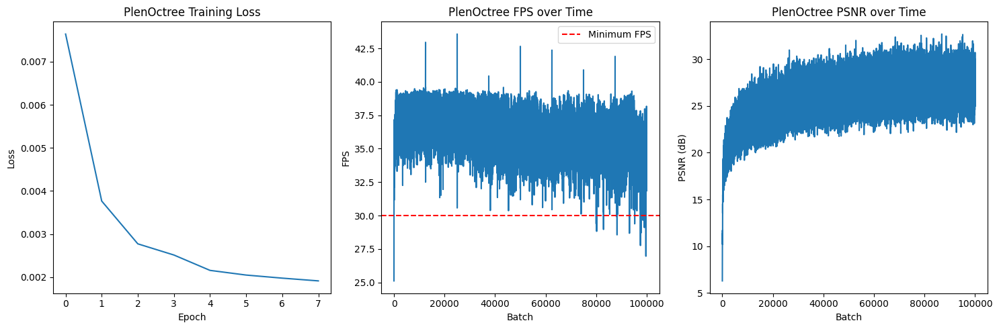

PlenOctree Training Progress:  80%|████████  | 100003/125000 [1:40:17<1:30:00,  4.63it/s]


PlenOctree Epoch 9/10, Batch 0:
FPS: 41.52, Latency: 24.09ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  80%|████████  | 100013/125000 [1:40:17<35:28, 11.74it/s]


PlenOctree Epoch 9/10, Batch 10:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  80%|████████  | 100023/125000 [1:40:18<26:45, 15.55it/s]


PlenOctree Epoch 9/10, Batch 20:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100033/125000 [1:40:19<25:31, 16.30it/s]


PlenOctree Epoch 9/10, Batch 30:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  80%|████████  | 100043/125000 [1:40:19<24:33, 16.94it/s]


PlenOctree Epoch 9/10, Batch 40:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100053/125000 [1:40:20<25:05, 16.57it/s]


PlenOctree Epoch 9/10, Batch 50:
FPS: 36.55, Latency: 27.36ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  80%|████████  | 100063/125000 [1:40:20<24:38, 16.86it/s]


PlenOctree Epoch 9/10, Batch 60:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  80%|████████  | 100073/125000 [1:40:21<25:06, 16.55it/s]


PlenOctree Epoch 9/10, Batch 70:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  80%|████████  | 100083/125000 [1:40:22<25:05, 16.55it/s]


PlenOctree Epoch 9/10, Batch 80:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  80%|████████  | 100093/125000 [1:40:22<24:46, 16.76it/s]


PlenOctree Epoch 9/10, Batch 90:
FPS: 37.26, Latency: 26.84ms
PSNR: 29.03dB, Loss: 0.0012


PlenOctree Training Progress:  80%|████████  | 100103/125000 [1:40:23<25:02, 16.57it/s]


PlenOctree Epoch 9/10, Batch 100:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100113/125000 [1:40:23<25:07, 16.51it/s]


PlenOctree Epoch 9/10, Batch 110:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  80%|████████  | 100123/125000 [1:40:24<25:18, 16.39it/s]


PlenOctree Epoch 9/10, Batch 120:
FPS: 35.26, Latency: 28.36ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  80%|████████  | 100133/125000 [1:40:25<25:09, 16.47it/s]


PlenOctree Epoch 9/10, Batch 130:
FPS: 35.23, Latency: 28.38ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100143/125000 [1:40:25<25:10, 16.45it/s]


PlenOctree Epoch 9/10, Batch 140:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  80%|████████  | 100153/125000 [1:40:26<25:10, 16.45it/s]


PlenOctree Epoch 9/10, Batch 150:
FPS: 34.50, Latency: 28.99ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100163/125000 [1:40:26<25:10, 16.44it/s]


PlenOctree Epoch 9/10, Batch 160:
FPS: 35.72, Latency: 28.00ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  80%|████████  | 100173/125000 [1:40:27<25:10, 16.44it/s]


PlenOctree Epoch 9/10, Batch 170:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.82dB, Loss: 0.0010


PlenOctree Training Progress:  80%|████████  | 100183/125000 [1:40:28<25:16, 16.37it/s]


PlenOctree Epoch 9/10, Batch 180:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100193/125000 [1:40:28<25:10, 16.42it/s]


PlenOctree Epoch 9/10, Batch 190:
FPS: 35.07, Latency: 28.51ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  80%|████████  | 100203/125000 [1:40:29<25:02, 16.50it/s]


PlenOctree Epoch 9/10, Batch 200:
FPS: 34.27, Latency: 29.18ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  80%|████████  | 100213/125000 [1:40:29<25:05, 16.47it/s]


PlenOctree Epoch 9/10, Batch 210:
FPS: 35.88, Latency: 27.87ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  80%|████████  | 100223/125000 [1:40:30<25:05, 16.46it/s]


PlenOctree Epoch 9/10, Batch 220:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  80%|████████  | 100233/125000 [1:40:31<25:08, 16.41it/s]


PlenOctree Epoch 9/10, Batch 230:
FPS: 35.04, Latency: 28.54ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100243/125000 [1:40:31<25:03, 16.47it/s]


PlenOctree Epoch 9/10, Batch 240:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  80%|████████  | 100253/125000 [1:40:32<25:05, 16.44it/s]


PlenOctree Epoch 9/10, Batch 250:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100263/125000 [1:40:32<25:03, 16.45it/s]


PlenOctree Epoch 9/10, Batch 260:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100273/125000 [1:40:33<25:03, 16.45it/s]


PlenOctree Epoch 9/10, Batch 270:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  80%|████████  | 100283/125000 [1:40:34<24:59, 16.49it/s]


PlenOctree Epoch 9/10, Batch 280:
FPS: 36.16, Latency: 27.65ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  80%|████████  | 100293/125000 [1:40:34<25:02, 16.44it/s]


PlenOctree Epoch 9/10, Batch 290:
FPS: 36.17, Latency: 27.64ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100303/125000 [1:40:35<25:03, 16.43it/s]


PlenOctree Epoch 9/10, Batch 300:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  80%|████████  | 100313/125000 [1:40:35<24:59, 16.46it/s]


PlenOctree Epoch 9/10, Batch 310:
FPS: 35.23, Latency: 28.39ms
PSNR: 23.85dB, Loss: 0.0041


PlenOctree Training Progress:  80%|████████  | 100323/125000 [1:40:36<24:58, 16.47it/s]


PlenOctree Epoch 9/10, Batch 320:
FPS: 35.20, Latency: 28.41ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100333/125000 [1:40:37<24:56, 16.48it/s]


PlenOctree Epoch 9/10, Batch 330:
FPS: 35.24, Latency: 28.38ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100343/125000 [1:40:37<24:54, 16.50it/s]


PlenOctree Epoch 9/10, Batch 340:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  80%|████████  | 100353/125000 [1:40:38<24:53, 16.50it/s]


PlenOctree Epoch 9/10, Batch 350:
FPS: 35.98, Latency: 27.79ms
PSNR: 29.83dB, Loss: 0.0010


PlenOctree Training Progress:  80%|████████  | 100363/125000 [1:40:39<24:52, 16.51it/s]


PlenOctree Epoch 9/10, Batch 360:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  80%|████████  | 100373/125000 [1:40:39<24:54, 16.48it/s]


PlenOctree Epoch 9/10, Batch 370:
FPS: 35.84, Latency: 27.90ms
PSNR: 30.68dB, Loss: 0.0009


PlenOctree Training Progress:  80%|████████  | 100383/125000 [1:40:40<24:53, 16.48it/s]


PlenOctree Epoch 9/10, Batch 380:
FPS: 33.94, Latency: 29.46ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  80%|████████  | 100393/125000 [1:40:40<24:49, 16.52it/s]


PlenOctree Epoch 9/10, Batch 390:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  80%|████████  | 100403/125000 [1:40:41<24:50, 16.50it/s]


PlenOctree Epoch 9/10, Batch 400:
FPS: 35.56, Latency: 28.13ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  80%|████████  | 100413/125000 [1:40:42<24:49, 16.51it/s]


PlenOctree Epoch 9/10, Batch 410:
FPS: 35.72, Latency: 28.00ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  80%|████████  | 100423/125000 [1:40:42<24:53, 16.46it/s]


PlenOctree Epoch 9/10, Batch 420:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  80%|████████  | 100433/125000 [1:40:43<24:51, 16.48it/s]


PlenOctree Epoch 9/10, Batch 430:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  80%|████████  | 100443/125000 [1:40:43<24:50, 16.47it/s]


PlenOctree Epoch 9/10, Batch 440:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  80%|████████  | 100453/125000 [1:40:44<24:53, 16.43it/s]


PlenOctree Epoch 9/10, Batch 450:
FPS: 35.77, Latency: 27.96ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  80%|████████  | 100463/125000 [1:40:45<24:50, 16.46it/s]


PlenOctree Epoch 9/10, Batch 460:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  80%|████████  | 100473/125000 [1:40:45<24:48, 16.47it/s]


PlenOctree Epoch 9/10, Batch 470:
FPS: 35.53, Latency: 28.15ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  80%|████████  | 100483/125000 [1:40:46<24:53, 16.42it/s]


PlenOctree Epoch 9/10, Batch 480:
FPS: 35.66, Latency: 28.04ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  80%|████████  | 100493/125000 [1:40:46<24:42, 16.53it/s]


PlenOctree Epoch 9/10, Batch 490:
FPS: 36.52, Latency: 27.38ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  80%|████████  | 100503/125000 [1:40:47<24:50, 16.44it/s]


PlenOctree Epoch 9/10, Batch 500:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  80%|████████  | 100513/125000 [1:40:48<24:43, 16.50it/s]


PlenOctree Epoch 9/10, Batch 510:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  80%|████████  | 100523/125000 [1:40:48<24:41, 16.53it/s]


PlenOctree Epoch 9/10, Batch 520:
FPS: 35.66, Latency: 28.04ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  80%|████████  | 100533/125000 [1:40:49<24:42, 16.50it/s]


PlenOctree Epoch 9/10, Batch 530:
FPS: 34.77, Latency: 28.76ms
PSNR: 24.81dB, Loss: 0.0033


PlenOctree Training Progress:  80%|████████  | 100543/125000 [1:40:49<24:41, 16.51it/s]


PlenOctree Epoch 9/10, Batch 540:
FPS: 35.38, Latency: 28.26ms
PSNR: 29.68dB, Loss: 0.0011


PlenOctree Training Progress:  80%|████████  | 100553/125000 [1:40:50<24:43, 16.48it/s]


PlenOctree Epoch 9/10, Batch 550:
FPS: 35.63, Latency: 28.07ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100563/125000 [1:40:51<24:42, 16.48it/s]


PlenOctree Epoch 9/10, Batch 560:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  80%|████████  | 100573/125000 [1:40:51<24:40, 16.50it/s]


PlenOctree Epoch 9/10, Batch 570:
FPS: 34.75, Latency: 28.78ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  80%|████████  | 100583/125000 [1:40:52<24:37, 16.53it/s]


PlenOctree Epoch 9/10, Batch 580:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  80%|████████  | 100593/125000 [1:40:52<24:40, 16.49it/s]


PlenOctree Epoch 9/10, Batch 590:
FPS: 33.72, Latency: 29.65ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  80%|████████  | 100603/125000 [1:40:53<24:36, 16.52it/s]


PlenOctree Epoch 9/10, Batch 600:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100613/125000 [1:40:54<24:35, 16.52it/s]


PlenOctree Epoch 9/10, Batch 610:
FPS: 35.85, Latency: 27.90ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  80%|████████  | 100623/125000 [1:40:54<24:37, 16.50it/s]


PlenOctree Epoch 9/10, Batch 620:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 100633/125000 [1:40:55<24:33, 16.54it/s]


PlenOctree Epoch 9/10, Batch 630:
FPS: 36.25, Latency: 27.59ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  81%|████████  | 100643/125000 [1:40:56<24:36, 16.50it/s]


PlenOctree Epoch 9/10, Batch 640:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 100653/125000 [1:40:56<24:39, 16.46it/s]


PlenOctree Epoch 9/10, Batch 650:
FPS: 34.95, Latency: 28.61ms
PSNR: 24.10dB, Loss: 0.0039


PlenOctree Training Progress:  81%|████████  | 100663/125000 [1:40:57<24:35, 16.50it/s]


PlenOctree Epoch 9/10, Batch 660:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  81%|████████  | 100673/125000 [1:40:57<24:33, 16.51it/s]


PlenOctree Epoch 9/10, Batch 670:
FPS: 35.90, Latency: 27.85ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 100683/125000 [1:40:58<24:33, 16.51it/s]


PlenOctree Epoch 9/10, Batch 680:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  81%|████████  | 100693/125000 [1:40:59<24:36, 16.47it/s]


PlenOctree Epoch 9/10, Batch 690:
FPS: 35.57, Latency: 28.11ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 100703/125000 [1:40:59<24:30, 16.52it/s]


PlenOctree Epoch 9/10, Batch 700:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 100713/125000 [1:41:00<24:35, 16.46it/s]


PlenOctree Epoch 9/10, Batch 710:
FPS: 35.08, Latency: 28.50ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████  | 100723/125000 [1:41:00<24:35, 16.46it/s]


PlenOctree Epoch 9/10, Batch 720:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  81%|████████  | 100733/125000 [1:41:01<24:29, 16.52it/s]


PlenOctree Epoch 9/10, Batch 730:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  81%|████████  | 100743/125000 [1:41:02<24:32, 16.47it/s]


PlenOctree Epoch 9/10, Batch 740:
FPS: 35.61, Latency: 28.08ms
PSNR: 30.19dB, Loss: 0.0010


PlenOctree Training Progress:  81%|████████  | 100753/125000 [1:41:02<24:26, 16.53it/s]


PlenOctree Epoch 9/10, Batch 750:
FPS: 35.63, Latency: 28.07ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████  | 100763/125000 [1:41:03<24:31, 16.47it/s]


PlenOctree Epoch 9/10, Batch 760:
FPS: 35.76, Latency: 27.97ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 100773/125000 [1:41:03<24:32, 16.46it/s]


PlenOctree Epoch 9/10, Batch 770:
FPS: 34.79, Latency: 28.75ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 100783/125000 [1:41:04<24:28, 16.50it/s]


PlenOctree Epoch 9/10, Batch 780:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 100793/125000 [1:41:05<24:33, 16.43it/s]


PlenOctree Epoch 9/10, Batch 790:
FPS: 36.08, Latency: 27.72ms
PSNR: 23.84dB, Loss: 0.0041


PlenOctree Training Progress:  81%|████████  | 100803/125000 [1:41:05<24:29, 16.46it/s]


PlenOctree Epoch 9/10, Batch 800:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████  | 100813/125000 [1:41:06<24:27, 16.48it/s]


PlenOctree Epoch 9/10, Batch 810:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  81%|████████  | 100823/125000 [1:41:06<24:26, 16.49it/s]


PlenOctree Epoch 9/10, Batch 820:
FPS: 35.57, Latency: 28.11ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 100833/125000 [1:41:07<24:22, 16.52it/s]


PlenOctree Epoch 9/10, Batch 830:
FPS: 35.57, Latency: 28.12ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  81%|████████  | 100843/125000 [1:41:08<24:23, 16.51it/s]


PlenOctree Epoch 9/10, Batch 840:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 100853/125000 [1:41:08<24:27, 16.46it/s]


PlenOctree Epoch 9/10, Batch 850:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 100863/125000 [1:41:09<24:27, 16.45it/s]


PlenOctree Epoch 9/10, Batch 860:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████  | 100873/125000 [1:41:09<24:25, 16.46it/s]


PlenOctree Epoch 9/10, Batch 870:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 100883/125000 [1:41:10<24:27, 16.43it/s]


PlenOctree Epoch 9/10, Batch 880:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████  | 100893/125000 [1:41:11<24:23, 16.47it/s]


PlenOctree Epoch 9/10, Batch 890:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  81%|████████  | 100903/125000 [1:41:11<24:21, 16.49it/s]


PlenOctree Epoch 9/10, Batch 900:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████  | 100913/125000 [1:41:12<24:21, 16.48it/s]


PlenOctree Epoch 9/10, Batch 910:
FPS: 35.02, Latency: 28.55ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████  | 100923/125000 [1:41:13<24:20, 16.49it/s]


PlenOctree Epoch 9/10, Batch 920:
FPS: 34.69, Latency: 28.83ms
PSNR: 29.03dB, Loss: 0.0012


PlenOctree Training Progress:  81%|████████  | 100933/125000 [1:41:13<24:18, 16.51it/s]


PlenOctree Epoch 9/10, Batch 930:
FPS: 34.37, Latency: 29.10ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 100943/125000 [1:41:14<24:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 940:
FPS: 35.40, Latency: 28.25ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████  | 100953/125000 [1:41:14<24:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 950:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 100963/125000 [1:41:15<24:24, 16.41it/s]


PlenOctree Epoch 9/10, Batch 960:
FPS: 34.46, Latency: 29.02ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 100973/125000 [1:41:16<24:20, 16.45it/s]


PlenOctree Epoch 9/10, Batch 970:
FPS: 34.78, Latency: 28.76ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  81%|████████  | 100983/125000 [1:41:16<24:19, 16.46it/s]


PlenOctree Epoch 9/10, Batch 980:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 100993/125000 [1:41:17<24:20, 16.43it/s]


PlenOctree Epoch 9/10, Batch 990:
FPS: 33.21, Latency: 30.11ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████  | 101003/125000 [1:41:17<24:13, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1000:
FPS: 34.94, Latency: 28.62ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 101013/125000 [1:41:18<24:15, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1010:
FPS: 33.85, Latency: 29.55ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 101023/125000 [1:41:19<24:14, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1020:
FPS: 34.18, Latency: 29.26ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  81%|████████  | 101033/125000 [1:41:19<24:14, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1030:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101043/125000 [1:41:20<24:10, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1040:
FPS: 34.84, Latency: 28.71ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████  | 101053/125000 [1:41:20<24:11, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1050:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101063/125000 [1:41:21<24:10, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1060:
FPS: 34.76, Latency: 28.77ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  81%|████████  | 101073/125000 [1:41:22<24:10, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1070:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 101083/125000 [1:41:22<24:11, 16.47it/s]


PlenOctree Epoch 9/10, Batch 1080:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 101093/125000 [1:41:23<24:04, 16.54it/s]


PlenOctree Epoch 9/10, Batch 1090:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  81%|████████  | 101103/125000 [1:41:23<24:10, 16.47it/s]


PlenOctree Epoch 9/10, Batch 1100:
FPS: 35.51, Latency: 28.16ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████  | 101113/125000 [1:41:24<24:10, 16.47it/s]


PlenOctree Epoch 9/10, Batch 1110:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101123/125000 [1:41:25<24:11, 16.45it/s]


PlenOctree Epoch 9/10, Batch 1120:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.02dB, Loss: 0.0025


PlenOctree Training Progress:  81%|████████  | 101133/125000 [1:41:25<24:09, 16.46it/s]


PlenOctree Epoch 9/10, Batch 1130:
FPS: 35.85, Latency: 27.90ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  81%|████████  | 101143/125000 [1:41:26<24:06, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1140:
FPS: 35.81, Latency: 27.92ms
PSNR: 24.30dB, Loss: 0.0037


PlenOctree Training Progress:  81%|████████  | 101153/125000 [1:41:26<24:07, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1150:
FPS: 35.34, Latency: 28.30ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 101163/125000 [1:41:27<24:05, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1160:
FPS: 33.81, Latency: 29.58ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████  | 101173/125000 [1:41:28<24:04, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1170:
FPS: 35.03, Latency: 28.55ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101183/125000 [1:41:28<24:04, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1180:
FPS: 35.34, Latency: 28.30ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  81%|████████  | 101193/125000 [1:41:29<24:04, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1190:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 101203/125000 [1:41:30<24:04, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1200:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 101213/125000 [1:41:30<24:02, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1210:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101223/125000 [1:41:31<24:02, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1220:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████  | 101233/125000 [1:41:31<24:03, 16.46it/s]


PlenOctree Epoch 9/10, Batch 1230:
FPS: 36.65, Latency: 27.29ms
PSNR: 30.47dB, Loss: 0.0009


PlenOctree Training Progress:  81%|████████  | 101243/125000 [1:41:32<24:01, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1240:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101253/125000 [1:41:33<24:00, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1250:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  81%|████████  | 101263/125000 [1:41:33<24:02, 16.46it/s]


PlenOctree Epoch 9/10, Batch 1260:
FPS: 34.41, Latency: 29.06ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  81%|████████  | 101273/125000 [1:41:34<24:01, 16.46it/s]


PlenOctree Epoch 9/10, Batch 1270:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  81%|████████  | 101283/125000 [1:41:34<23:59, 16.47it/s]


PlenOctree Epoch 9/10, Batch 1280:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  81%|████████  | 101293/125000 [1:41:35<23:35, 16.75it/s]


PlenOctree Epoch 9/10, Batch 1290:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101303/125000 [1:41:36<23:48, 16.59it/s]


PlenOctree Epoch 9/10, Batch 1300:
FPS: 35.51, Latency: 28.16ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  81%|████████  | 101313/125000 [1:41:36<23:53, 16.53it/s]


PlenOctree Epoch 9/10, Batch 1310:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 101323/125000 [1:41:37<24:01, 16.42it/s]


PlenOctree Epoch 9/10, Batch 1320:
FPS: 35.48, Latency: 28.19ms
PSNR: 29.92dB, Loss: 0.0010


PlenOctree Training Progress:  81%|████████  | 101333/125000 [1:41:37<23:55, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1330:
FPS: 34.68, Latency: 28.83ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████  | 101343/125000 [1:41:38<23:52, 16.52it/s]


PlenOctree Epoch 9/10, Batch 1340:
FPS: 36.06, Latency: 27.73ms
PSNR: 29.79dB, Loss: 0.0010


PlenOctree Training Progress:  81%|████████  | 101353/125000 [1:41:39<23:51, 16.52it/s]


PlenOctree Epoch 9/10, Batch 1350:
FPS: 35.54, Latency: 28.14ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 101363/125000 [1:41:39<23:52, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1360:
FPS: 33.88, Latency: 29.51ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  81%|████████  | 101373/125000 [1:41:40<23:53, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1370:
FPS: 35.55, Latency: 28.13ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  81%|████████  | 101383/125000 [1:41:40<23:59, 16.41it/s]


PlenOctree Epoch 9/10, Batch 1380:
FPS: 34.84, Latency: 28.70ms
PSNR: 29.49dB, Loss: 0.0011


PlenOctree Training Progress:  81%|████████  | 101393/125000 [1:41:41<23:51, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1390:
FPS: 34.45, Latency: 29.02ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████  | 101403/125000 [1:41:42<23:49, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1400:
FPS: 35.42, Latency: 28.23ms
PSNR: 30.84dB, Loss: 0.0008


PlenOctree Training Progress:  81%|████████  | 101413/125000 [1:41:42<23:54, 16.45it/s]


PlenOctree Epoch 9/10, Batch 1410:
FPS: 35.60, Latency: 28.09ms
PSNR: 29.79dB, Loss: 0.0010


PlenOctree Training Progress:  81%|████████  | 101423/125000 [1:41:43<23:52, 16.45it/s]


PlenOctree Epoch 9/10, Batch 1420:
FPS: 36.08, Latency: 27.71ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████  | 101433/125000 [1:41:43<23:53, 16.44it/s]


PlenOctree Epoch 9/10, Batch 1430:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████  | 101443/125000 [1:41:44<23:48, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1440:
FPS: 35.79, Latency: 27.94ms
PSNR: 30.11dB, Loss: 0.0010


PlenOctree Training Progress:  81%|████████  | 101453/125000 [1:41:45<23:46, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1450:
FPS: 35.16, Latency: 28.45ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  81%|████████  | 101463/125000 [1:41:45<23:47, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1460:
FPS: 35.86, Latency: 27.89ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  81%|████████  | 101473/125000 [1:41:46<23:46, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1470:
FPS: 35.00, Latency: 28.58ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  81%|████████  | 101483/125000 [1:41:46<23:45, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1480:
FPS: 36.11, Latency: 27.69ms
PSNR: 30.17dB, Loss: 0.0010


PlenOctree Training Progress:  81%|████████  | 101493/125000 [1:41:47<23:47, 16.46it/s]


PlenOctree Epoch 9/10, Batch 1490:
FPS: 35.10, Latency: 28.49ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  81%|████████  | 101503/125000 [1:41:48<23:45, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1500:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████  | 101513/125000 [1:41:48<23:40, 16.53it/s]


PlenOctree Epoch 9/10, Batch 1510:
FPS: 35.88, Latency: 27.87ms
PSNR: 31.28dB, Loss: 0.0007


PlenOctree Training Progress:  81%|████████  | 101523/125000 [1:41:49<23:43, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1520:
FPS: 35.58, Latency: 28.11ms
PSNR: 24.16dB, Loss: 0.0038


PlenOctree Training Progress:  81%|████████  | 101533/125000 [1:41:50<23:44, 16.48it/s]


PlenOctree Epoch 9/10, Batch 1530:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  81%|████████  | 101543/125000 [1:41:50<23:42, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1540:
FPS: 35.51, Latency: 28.16ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████  | 101553/125000 [1:41:51<23:41, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1550:
FPS: 35.54, Latency: 28.14ms
PSNR: 25.01dB, Loss: 0.0032


PlenOctree Training Progress:  81%|████████▏ | 101563/125000 [1:41:51<23:43, 16.46it/s]


PlenOctree Epoch 9/10, Batch 1560:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  81%|████████▏ | 101573/125000 [1:41:52<23:40, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1570:
FPS: 35.11, Latency: 28.48ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  81%|████████▏ | 101583/125000 [1:41:53<23:45, 16.43it/s]


PlenOctree Epoch 9/10, Batch 1580:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████▏ | 101593/125000 [1:41:53<23:38, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1590:
FPS: 34.65, Latency: 28.86ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  81%|████████▏ | 101603/125000 [1:41:54<23:36, 16.52it/s]


PlenOctree Epoch 9/10, Batch 1600:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  81%|████████▏ | 101613/125000 [1:41:54<23:36, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1610:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████▏ | 101623/125000 [1:41:55<23:31, 16.56it/s]


PlenOctree Epoch 9/10, Batch 1620:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  81%|████████▏ | 101633/125000 [1:41:56<23:16, 16.73it/s]


PlenOctree Epoch 9/10, Batch 1630:
FPS: 35.07, Latency: 28.51ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  81%|████████▏ | 101643/125000 [1:41:56<23:29, 16.57it/s]


PlenOctree Epoch 9/10, Batch 1640:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████▏ | 101653/125000 [1:41:57<23:26, 16.60it/s]


PlenOctree Epoch 9/10, Batch 1650:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.10dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████▏ | 101663/125000 [1:41:57<23:03, 16.87it/s]


PlenOctree Epoch 9/10, Batch 1660:
FPS: 37.42, Latency: 26.73ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  81%|████████▏ | 101673/125000 [1:41:58<23:30, 16.54it/s]


PlenOctree Epoch 9/10, Batch 1670:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  81%|████████▏ | 101683/125000 [1:41:59<23:24, 16.60it/s]


PlenOctree Epoch 9/10, Batch 1680:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.56dB, Loss: 0.0028


PlenOctree Training Progress:  81%|████████▏ | 101693/125000 [1:41:59<23:21, 16.63it/s]


PlenOctree Epoch 9/10, Batch 1690:
FPS: 37.80, Latency: 26.45ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  81%|████████▏ | 101703/125000 [1:42:00<23:18, 16.66it/s]


PlenOctree Epoch 9/10, Batch 1700:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  81%|████████▏ | 101713/125000 [1:42:00<23:23, 16.59it/s]


PlenOctree Epoch 9/10, Batch 1710:
FPS: 36.45, Latency: 27.43ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  81%|████████▏ | 101723/125000 [1:42:01<23:32, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1720:
FPS: 35.80, Latency: 27.93ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████▏ | 101733/125000 [1:42:02<23:30, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1730:
FPS: 35.71, Latency: 28.00ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████▏ | 101743/125000 [1:42:02<23:26, 16.54it/s]


PlenOctree Epoch 9/10, Batch 1740:
FPS: 35.62, Latency: 28.07ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  81%|████████▏ | 101753/125000 [1:42:03<23:35, 16.43it/s]


PlenOctree Epoch 9/10, Batch 1750:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  81%|████████▏ | 101763/125000 [1:42:03<23:27, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1760:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  81%|████████▏ | 101773/125000 [1:42:04<23:26, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1770:
FPS: 35.24, Latency: 28.37ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████▏ | 101783/125000 [1:42:05<23:32, 16.43it/s]


PlenOctree Epoch 9/10, Batch 1780:
FPS: 35.25, Latency: 28.37ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  81%|████████▏ | 101793/125000 [1:42:05<23:25, 16.51it/s]


PlenOctree Epoch 9/10, Batch 1790:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████▏ | 101803/125000 [1:42:06<23:28, 16.47it/s]


PlenOctree Epoch 9/10, Batch 1800:
FPS: 35.86, Latency: 27.89ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  81%|████████▏ | 101813/125000 [1:42:06<23:20, 16.55it/s]


PlenOctree Epoch 9/10, Batch 1810:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  81%|████████▏ | 101823/125000 [1:42:07<22:52, 16.89it/s]


PlenOctree Epoch 9/10, Batch 1820:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  81%|████████▏ | 101833/125000 [1:42:08<23:20, 16.54it/s]


PlenOctree Epoch 9/10, Batch 1830:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  81%|████████▏ | 101843/125000 [1:42:08<23:16, 16.58it/s]


PlenOctree Epoch 9/10, Batch 1840:
FPS: 36.65, Latency: 27.28ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  81%|████████▏ | 101853/125000 [1:42:09<22:52, 16.86it/s]


PlenOctree Epoch 9/10, Batch 1850:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  81%|████████▏ | 101863/125000 [1:42:09<23:09, 16.65it/s]


PlenOctree Epoch 9/10, Batch 1860:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  81%|████████▏ | 101873/125000 [1:42:10<23:17, 16.55it/s]


PlenOctree Epoch 9/10, Batch 1870:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 101883/125000 [1:42:11<22:52, 16.84it/s]


PlenOctree Epoch 9/10, Batch 1880:
FPS: 36.88, Latency: 27.12ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 101893/125000 [1:42:11<23:12, 16.60it/s]


PlenOctree Epoch 9/10, Batch 1890:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  82%|████████▏ | 101903/125000 [1:42:12<23:17, 16.53it/s]


PlenOctree Epoch 9/10, Batch 1900:
FPS: 36.53, Latency: 27.37ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 101913/125000 [1:42:12<23:23, 16.45it/s]


PlenOctree Epoch 9/10, Batch 1910:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 101923/125000 [1:42:13<23:20, 16.47it/s]


PlenOctree Epoch 9/10, Batch 1920:
FPS: 37.20, Latency: 26.88ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 101933/125000 [1:42:14<23:18, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1930:
FPS: 35.96, Latency: 27.81ms
PSNR: 30.16dB, Loss: 0.0010


PlenOctree Training Progress:  82%|████████▏ | 101943/125000 [1:42:14<23:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1940:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 101953/125000 [1:42:15<23:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 1950:
FPS: 36.65, Latency: 27.28ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 101963/125000 [1:42:16<23:20, 16.45it/s]


PlenOctree Epoch 9/10, Batch 1960:
FPS: 36.41, Latency: 27.46ms
PSNR: 30.67dB, Loss: 0.0009


PlenOctree Training Progress:  82%|████████▏ | 101973/125000 [1:42:16<23:21, 16.43it/s]


PlenOctree Epoch 9/10, Batch 1970:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  82%|████████▏ | 101983/125000 [1:42:17<23:15, 16.49it/s]


PlenOctree Epoch 9/10, Batch 1980:
FPS: 35.48, Latency: 28.19ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  82%|████████▏ | 101993/125000 [1:42:17<23:09, 16.55it/s]


PlenOctree Epoch 9/10, Batch 1990:
FPS: 36.74, Latency: 27.22ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102003/125000 [1:42:18<23:16, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2000:
FPS: 35.86, Latency: 27.88ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102013/125000 [1:42:19<23:12, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2010:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102023/125000 [1:42:19<23:13, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2020:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 102033/125000 [1:42:20<23:12, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2030:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102043/125000 [1:42:20<23:11, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2040:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102053/125000 [1:42:21<23:08, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2050:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  82%|████████▏ | 102063/125000 [1:42:22<23:17, 16.42it/s]


PlenOctree Epoch 9/10, Batch 2060:
FPS: 33.96, Latency: 29.44ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102073/125000 [1:42:22<23:12, 16.47it/s]


PlenOctree Epoch 9/10, Batch 2070:
FPS: 35.59, Latency: 28.10ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 102083/125000 [1:42:23<23:11, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2080:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 102093/125000 [1:42:23<23:11, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2090:
FPS: 35.27, Latency: 28.36ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 102103/125000 [1:42:24<23:10, 16.47it/s]


PlenOctree Epoch 9/10, Batch 2100:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 102113/125000 [1:42:25<23:10, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2110:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 102123/125000 [1:42:25<23:09, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2120:
FPS: 35.31, Latency: 28.32ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  82%|████████▏ | 102133/125000 [1:42:26<23:06, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2130:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102143/125000 [1:42:26<23:04, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2140:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  82%|████████▏ | 102153/125000 [1:42:27<23:04, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2150:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102163/125000 [1:42:28<23:05, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2160:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  82%|████████▏ | 102173/125000 [1:42:28<23:04, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2170:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 102183/125000 [1:42:29<22:58, 16.55it/s]


PlenOctree Epoch 9/10, Batch 2180:
FPS: 34.46, Latency: 29.02ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102193/125000 [1:42:29<23:00, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2190:
FPS: 35.47, Latency: 28.19ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102203/125000 [1:42:30<23:00, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2200:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102213/125000 [1:42:31<23:03, 16.47it/s]


PlenOctree Epoch 9/10, Batch 2210:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102223/125000 [1:42:31<23:01, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2220:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102233/125000 [1:42:32<23:03, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2230:
FPS: 35.90, Latency: 27.85ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102243/125000 [1:42:33<22:58, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2240:
FPS: 36.48, Latency: 27.41ms
PSNR: 29.07dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102253/125000 [1:42:33<22:57, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2250:
FPS: 36.69, Latency: 27.25ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102263/125000 [1:42:34<22:57, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2260:
FPS: 36.00, Latency: 27.78ms
PSNR: 31.04dB, Loss: 0.0008


PlenOctree Training Progress:  82%|████████▏ | 102273/125000 [1:42:34<22:55, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2270:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102283/125000 [1:42:35<22:57, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2280:
FPS: 36.06, Latency: 27.73ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102293/125000 [1:42:36<22:58, 16.47it/s]


PlenOctree Epoch 9/10, Batch 2290:
FPS: 36.28, Latency: 27.57ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  82%|████████▏ | 102303/125000 [1:42:36<22:57, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2300:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  82%|████████▏ | 102313/125000 [1:42:37<22:54, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2310:
FPS: 35.12, Latency: 28.47ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 102323/125000 [1:42:37<22:53, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2320:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  82%|████████▏ | 102333/125000 [1:42:38<22:55, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2330:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102343/125000 [1:42:39<22:53, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2340:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  82%|████████▏ | 102353/125000 [1:42:39<22:58, 16.43it/s]


PlenOctree Epoch 9/10, Batch 2350:
FPS: 36.61, Latency: 27.31ms
PSNR: 30.39dB, Loss: 0.0009


PlenOctree Training Progress:  82%|████████▏ | 102363/125000 [1:42:40<22:56, 16.45it/s]


PlenOctree Epoch 9/10, Batch 2360:
FPS: 36.47, Latency: 27.42ms
PSNR: 29.74dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102373/125000 [1:42:40<22:58, 16.42it/s]


PlenOctree Epoch 9/10, Batch 2370:
FPS: 35.99, Latency: 27.78ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  82%|████████▏ | 102383/125000 [1:42:41<22:51, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2380:
FPS: 35.32, Latency: 28.31ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102393/125000 [1:42:42<22:50, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2390:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102403/125000 [1:42:42<22:51, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2400:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102413/125000 [1:42:43<22:51, 16.47it/s]


PlenOctree Epoch 9/10, Batch 2410:
FPS: 37.45, Latency: 26.70ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102423/125000 [1:42:43<22:51, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2420:
FPS: 37.06, Latency: 26.98ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 102433/125000 [1:42:44<22:46, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2430:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  82%|████████▏ | 102443/125000 [1:42:45<22:46, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2440:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102453/125000 [1:42:45<22:18, 16.84it/s]


PlenOctree Epoch 9/10, Batch 2450:
FPS: 36.76, Latency: 27.20ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  82%|████████▏ | 102463/125000 [1:42:46<22:43, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2460:
FPS: 36.54, Latency: 27.36ms
PSNR: 30.33dB, Loss: 0.0009


PlenOctree Training Progress:  82%|████████▏ | 102473/125000 [1:42:46<22:44, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2470:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102483/125000 [1:42:47<22:45, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2480:
FPS: 36.64, Latency: 27.30ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  82%|████████▏ | 102493/125000 [1:42:48<22:51, 16.42it/s]


PlenOctree Epoch 9/10, Batch 2490:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102503/125000 [1:42:48<22:44, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2500:
FPS: 36.02, Latency: 27.76ms
PSNR: 30.86dB, Loss: 0.0008


PlenOctree Training Progress:  82%|████████▏ | 102513/125000 [1:42:49<22:47, 16.44it/s]


PlenOctree Epoch 9/10, Batch 2510:
FPS: 36.12, Latency: 27.69ms
PSNR: 29.32dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102523/125000 [1:42:49<22:47, 16.44it/s]


PlenOctree Epoch 9/10, Batch 2520:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  82%|████████▏ | 102533/125000 [1:42:50<22:42, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2530:
FPS: 36.42, Latency: 27.45ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102543/125000 [1:42:51<22:47, 16.43it/s]


PlenOctree Epoch 9/10, Batch 2540:
FPS: 35.70, Latency: 28.01ms
PSNR: 30.09dB, Loss: 0.0010


PlenOctree Training Progress:  82%|████████▏ | 102553/125000 [1:42:51<22:44, 16.45it/s]


PlenOctree Epoch 9/10, Batch 2550:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  82%|████████▏ | 102563/125000 [1:42:52<22:41, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2560:
FPS: 36.48, Latency: 27.41ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102573/125000 [1:42:53<22:43, 16.45it/s]


PlenOctree Epoch 9/10, Batch 2570:
FPS: 36.29, Latency: 27.56ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102583/125000 [1:42:53<22:38, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2580:
FPS: 35.89, Latency: 27.87ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102593/125000 [1:42:54<22:38, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2590:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102603/125000 [1:42:54<22:43, 16.43it/s]


PlenOctree Epoch 9/10, Batch 2600:
FPS: 36.26, Latency: 27.58ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102613/125000 [1:42:55<22:41, 16.45it/s]


PlenOctree Epoch 9/10, Batch 2610:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.54dB, Loss: 0.0028


PlenOctree Training Progress:  82%|████████▏ | 102623/125000 [1:42:56<22:40, 16.45it/s]


PlenOctree Epoch 9/10, Batch 2620:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 102633/125000 [1:42:56<22:36, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2630:
FPS: 36.53, Latency: 27.38ms
PSNR: 29.75dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102643/125000 [1:42:57<22:32, 16.53it/s]


PlenOctree Epoch 9/10, Batch 2640:
FPS: 36.76, Latency: 27.20ms
PSNR: 30.11dB, Loss: 0.0010


PlenOctree Training Progress:  82%|████████▏ | 102653/125000 [1:42:57<22:08, 16.82it/s]


PlenOctree Epoch 9/10, Batch 2650:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102663/125000 [1:42:58<22:30, 16.54it/s]


PlenOctree Epoch 9/10, Batch 2660:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102673/125000 [1:42:59<22:35, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2670:
FPS: 36.41, Latency: 27.46ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102683/125000 [1:42:59<22:28, 16.55it/s]


PlenOctree Epoch 9/10, Batch 2680:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  82%|████████▏ | 102693/125000 [1:43:00<22:32, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2690:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 102703/125000 [1:43:00<22:29, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2700:
FPS: 36.34, Latency: 27.51ms
PSNR: 23.48dB, Loss: 0.0045


PlenOctree Training Progress:  82%|████████▏ | 102713/125000 [1:43:01<22:27, 16.53it/s]


PlenOctree Epoch 9/10, Batch 2710:
FPS: 36.12, Latency: 27.69ms
PSNR: 29.77dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102723/125000 [1:43:02<22:31, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2720:
FPS: 34.74, Latency: 28.78ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 102733/125000 [1:43:02<22:27, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2730:
FPS: 36.73, Latency: 27.23ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102743/125000 [1:43:03<22:29, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2740:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 102753/125000 [1:43:03<22:30, 16.47it/s]


PlenOctree Epoch 9/10, Batch 2750:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  82%|████████▏ | 102763/125000 [1:43:04<22:25, 16.52it/s]


PlenOctree Epoch 9/10, Batch 2760:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 102773/125000 [1:43:05<22:33, 16.43it/s]


PlenOctree Epoch 9/10, Batch 2770:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 102783/125000 [1:43:05<22:21, 16.57it/s]


PlenOctree Epoch 9/10, Batch 2780:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  82%|████████▏ | 102793/125000 [1:43:06<22:22, 16.55it/s]


PlenOctree Epoch 9/10, Batch 2790:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102803/125000 [1:43:06<22:31, 16.43it/s]


PlenOctree Epoch 9/10, Batch 2800:
FPS: 36.01, Latency: 27.77ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102813/125000 [1:43:07<22:20, 16.55it/s]


PlenOctree Epoch 9/10, Batch 2810:
FPS: 35.91, Latency: 27.84ms
PSNR: 29.77dB, Loss: 0.0011


PlenOctree Training Progress:  82%|████████▏ | 102823/125000 [1:43:08<22:23, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2820:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102833/125000 [1:43:08<22:20, 16.54it/s]


PlenOctree Epoch 9/10, Batch 2830:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 102843/125000 [1:43:09<22:07, 16.70it/s]


PlenOctree Epoch 9/10, Batch 2840:
FPS: 37.49, Latency: 26.67ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 102853/125000 [1:43:09<22:12, 16.62it/s]


PlenOctree Epoch 9/10, Batch 2850:
FPS: 34.57, Latency: 28.93ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  82%|████████▏ | 102863/125000 [1:43:10<22:16, 16.57it/s]


PlenOctree Epoch 9/10, Batch 2860:
FPS: 34.20, Latency: 29.24ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  82%|████████▏ | 102873/125000 [1:43:11<22:22, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2870:
FPS: 36.53, Latency: 27.37ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102883/125000 [1:43:11<22:23, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2880:
FPS: 35.27, Latency: 28.35ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 102893/125000 [1:43:12<22:19, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2890:
FPS: 36.64, Latency: 27.29ms
PSNR: 29.03dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102903/125000 [1:43:13<22:22, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2900:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102913/125000 [1:43:13<22:19, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2910:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  82%|████████▏ | 102923/125000 [1:43:14<22:21, 16.46it/s]


PlenOctree Epoch 9/10, Batch 2920:
FPS: 35.08, Latency: 28.51ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102933/125000 [1:43:14<22:19, 16.48it/s]


PlenOctree Epoch 9/10, Batch 2930:
FPS: 33.54, Latency: 29.81ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  82%|████████▏ | 102943/125000 [1:43:15<22:16, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2940:
FPS: 34.19, Latency: 29.25ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  82%|████████▏ | 102953/125000 [1:43:16<22:15, 16.50it/s]


PlenOctree Epoch 9/10, Batch 2950:
FPS: 36.15, Latency: 27.66ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 102963/125000 [1:43:16<22:22, 16.41it/s]


PlenOctree Epoch 9/10, Batch 2960:
FPS: 35.58, Latency: 28.11ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 102973/125000 [1:43:17<22:12, 16.53it/s]


PlenOctree Epoch 9/10, Batch 2970:
FPS: 35.06, Latency: 28.53ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  82%|████████▏ | 102983/125000 [1:43:17<22:15, 16.49it/s]


PlenOctree Epoch 9/10, Batch 2980:
FPS: 36.51, Latency: 27.39ms
PSNR: 30.17dB, Loss: 0.0010


PlenOctree Training Progress:  82%|████████▏ | 102993/125000 [1:43:18<22:12, 16.51it/s]


PlenOctree Epoch 9/10, Batch 2990:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 103003/125000 [1:43:19<22:12, 16.51it/s]


PlenOctree Epoch 9/10, Batch 3000:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  82%|████████▏ | 103013/125000 [1:43:19<22:10, 16.52it/s]


PlenOctree Epoch 9/10, Batch 3010:
FPS: 36.53, Latency: 27.37ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 103023/125000 [1:43:20<22:13, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3020:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  82%|████████▏ | 103033/125000 [1:43:20<22:06, 16.56it/s]


PlenOctree Epoch 9/10, Batch 3030:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  82%|████████▏ | 103043/125000 [1:43:21<21:53, 16.72it/s]


PlenOctree Epoch 9/10, Batch 3040:
FPS: 37.35, Latency: 26.78ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 103053/125000 [1:43:22<22:02, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3050:
FPS: 36.18, Latency: 27.64ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  82%|████████▏ | 103063/125000 [1:43:22<22:04, 16.57it/s]


PlenOctree Epoch 9/10, Batch 3060:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  82%|████████▏ | 103073/125000 [1:43:23<22:13, 16.44it/s]


PlenOctree Epoch 9/10, Batch 3070:
FPS: 36.67, Latency: 27.27ms
PSNR: 31.05dB, Loss: 0.0008


PlenOctree Training Progress:  82%|████████▏ | 103083/125000 [1:43:23<22:01, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3080:
FPS: 37.38, Latency: 26.75ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  82%|████████▏ | 103093/125000 [1:43:24<21:47, 16.76it/s]


PlenOctree Epoch 9/10, Batch 3090:
FPS: 34.51, Latency: 28.98ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  82%|████████▏ | 103103/125000 [1:43:25<22:08, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3100:
FPS: 35.94, Latency: 27.83ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  82%|████████▏ | 103113/125000 [1:43:25<22:16, 16.38it/s]


PlenOctree Epoch 9/10, Batch 3110:
FPS: 33.95, Latency: 29.45ms
PSNR: 25.49dB, Loss: 0.0028


PlenOctree Training Progress:  82%|████████▏ | 103123/125000 [1:43:26<22:09, 16.45it/s]


PlenOctree Epoch 9/10, Batch 3120:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 103133/125000 [1:43:26<22:08, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3130:
FPS: 35.91, Latency: 27.85ms
PSNR: 24.99dB, Loss: 0.0032


PlenOctree Training Progress:  83%|████████▎ | 103143/125000 [1:43:27<22:07, 16.47it/s]


PlenOctree Epoch 9/10, Batch 3140:
FPS: 36.48, Latency: 27.41ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  83%|████████▎ | 103153/125000 [1:43:28<22:08, 16.44it/s]


PlenOctree Epoch 9/10, Batch 3150:
FPS: 36.37, Latency: 27.50ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  83%|████████▎ | 103163/125000 [1:43:28<22:06, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3160:
FPS: 34.89, Latency: 28.66ms
PSNR: 29.49dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103173/125000 [1:43:29<22:09, 16.42it/s]


PlenOctree Epoch 9/10, Batch 3170:
FPS: 35.07, Latency: 28.51ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 103183/125000 [1:43:29<22:00, 16.52it/s]


PlenOctree Epoch 9/10, Batch 3180:
FPS: 36.34, Latency: 27.52ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 103193/125000 [1:43:30<21:57, 16.56it/s]


PlenOctree Epoch 9/10, Batch 3190:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  83%|████████▎ | 103203/125000 [1:43:31<21:31, 16.88it/s]


PlenOctree Epoch 9/10, Batch 3200:
FPS: 37.64, Latency: 26.57ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  83%|████████▎ | 103213/125000 [1:43:31<21:53, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3210:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 103223/125000 [1:43:32<21:52, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3220:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.57dB, Loss: 0.0028


PlenOctree Training Progress:  83%|████████▎ | 103233/125000 [1:43:32<21:41, 16.72it/s]


PlenOctree Epoch 9/10, Batch 3230:
FPS: 37.50, Latency: 26.67ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103243/125000 [1:43:33<21:48, 16.62it/s]


PlenOctree Epoch 9/10, Batch 3240:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  83%|████████▎ | 103253/125000 [1:43:34<21:50, 16.60it/s]


PlenOctree Epoch 9/10, Batch 3250:
FPS: 36.93, Latency: 27.08ms
PSNR: 30.31dB, Loss: 0.0009


PlenOctree Training Progress:  83%|████████▎ | 103263/125000 [1:43:34<22:02, 16.44it/s]


PlenOctree Epoch 9/10, Batch 3260:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  83%|████████▎ | 103273/125000 [1:43:35<21:58, 16.47it/s]


PlenOctree Epoch 9/10, Batch 3270:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  83%|████████▎ | 103283/125000 [1:43:36<21:52, 16.55it/s]


PlenOctree Epoch 9/10, Batch 3280:
FPS: 37.38, Latency: 26.75ms
PSNR: 30.06dB, Loss: 0.0010


PlenOctree Training Progress:  83%|████████▎ | 103293/125000 [1:43:36<21:28, 16.84it/s]


PlenOctree Epoch 9/10, Batch 3290:
FPS: 37.04, Latency: 27.00ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  83%|████████▎ | 103303/125000 [1:43:37<21:52, 16.53it/s]


PlenOctree Epoch 9/10, Batch 3300:
FPS: 36.55, Latency: 27.36ms
PSNR: 29.61dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103313/125000 [1:43:37<21:54, 16.50it/s]


PlenOctree Epoch 9/10, Batch 3310:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 103323/125000 [1:43:38<21:49, 16.56it/s]


PlenOctree Epoch 9/10, Batch 3320:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103333/125000 [1:43:39<21:56, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3330:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 103343/125000 [1:43:39<21:53, 16.49it/s]


PlenOctree Epoch 9/10, Batch 3340:
FPS: 35.79, Latency: 27.94ms
PSNR: 29.67dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103353/125000 [1:43:40<21:53, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3350:
FPS: 35.38, Latency: 28.26ms
PSNR: 32.01dB, Loss: 0.0006


PlenOctree Training Progress:  83%|████████▎ | 103363/125000 [1:43:40<21:54, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3360:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  83%|████████▎ | 103373/125000 [1:43:41<21:52, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3370:
FPS: 35.64, Latency: 28.06ms
PSNR: 24.92dB, Loss: 0.0032


PlenOctree Training Progress:  83%|████████▎ | 103383/125000 [1:43:42<21:49, 16.51it/s]


PlenOctree Epoch 9/10, Batch 3380:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 103393/125000 [1:43:42<21:48, 16.51it/s]


PlenOctree Epoch 9/10, Batch 3390:
FPS: 35.98, Latency: 27.80ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 103403/125000 [1:43:43<21:46, 16.52it/s]


PlenOctree Epoch 9/10, Batch 3400:
FPS: 35.55, Latency: 28.13ms
PSNR: 29.67dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103413/125000 [1:43:43<21:31, 16.71it/s]


PlenOctree Epoch 9/10, Batch 3410:
FPS: 37.63, Latency: 26.57ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 103423/125000 [1:43:44<21:34, 16.67it/s]


PlenOctree Epoch 9/10, Batch 3420:
FPS: 37.15, Latency: 26.92ms
PSNR: 29.57dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103433/125000 [1:43:45<21:44, 16.53it/s]


PlenOctree Epoch 9/10, Batch 3430:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  83%|████████▎ | 103443/125000 [1:43:45<21:47, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3440:
FPS: 34.92, Latency: 28.64ms
PSNR: 30.32dB, Loss: 0.0009


PlenOctree Training Progress:  83%|████████▎ | 103453/125000 [1:43:46<21:51, 16.43it/s]


PlenOctree Epoch 9/10, Batch 3450:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 103463/125000 [1:43:46<21:46, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3460:
FPS: 37.57, Latency: 26.62ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  83%|████████▎ | 103473/125000 [1:43:47<21:21, 16.80it/s]


PlenOctree Epoch 9/10, Batch 3470:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103483/125000 [1:43:48<21:42, 16.52it/s]


PlenOctree Epoch 9/10, Batch 3480:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103493/125000 [1:43:48<21:46, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3490:
FPS: 34.85, Latency: 28.69ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 103503/125000 [1:43:49<21:45, 16.47it/s]


PlenOctree Epoch 9/10, Batch 3500:
FPS: 34.73, Latency: 28.80ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  83%|████████▎ | 103513/125000 [1:43:49<21:45, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3510:
FPS: 36.90, Latency: 27.10ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  83%|████████▎ | 103523/125000 [1:43:50<21:17, 16.82it/s]


PlenOctree Epoch 9/10, Batch 3520:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103533/125000 [1:43:51<21:39, 16.52it/s]


PlenOctree Epoch 9/10, Batch 3530:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 103543/125000 [1:43:51<21:44, 16.45it/s]


PlenOctree Epoch 9/10, Batch 3540:
FPS: 35.43, Latency: 28.22ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 103553/125000 [1:43:52<21:41, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3550:
FPS: 35.63, Latency: 28.07ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 103563/125000 [1:43:52<21:33, 16.57it/s]


PlenOctree Epoch 9/10, Batch 3560:
FPS: 37.83, Latency: 26.43ms
PSNR: 29.95dB, Loss: 0.0010


PlenOctree Training Progress:  83%|████████▎ | 103573/125000 [1:43:53<21:28, 16.63it/s]


PlenOctree Epoch 9/10, Batch 3570:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  83%|████████▎ | 103583/125000 [1:43:54<21:31, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3580:
FPS: 36.64, Latency: 27.29ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  83%|████████▎ | 103593/125000 [1:43:54<21:34, 16.53it/s]


PlenOctree Epoch 9/10, Batch 3590:
FPS: 37.02, Latency: 27.01ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 103603/125000 [1:43:55<21:02, 16.95it/s]


PlenOctree Epoch 9/10, Batch 3600:
FPS: 37.03, Latency: 27.00ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 103613/125000 [1:43:55<21:32, 16.55it/s]


PlenOctree Epoch 9/10, Batch 3610:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 103623/125000 [1:43:56<21:29, 16.57it/s]


PlenOctree Epoch 9/10, Batch 3620:
FPS: 34.63, Latency: 28.88ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  83%|████████▎ | 103633/125000 [1:43:57<21:23, 16.65it/s]


PlenOctree Epoch 9/10, Batch 3630:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 103643/125000 [1:43:57<21:21, 16.67it/s]


PlenOctree Epoch 9/10, Batch 3640:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 103653/125000 [1:43:58<21:26, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3650:
FPS: 36.33, Latency: 27.53ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  83%|████████▎ | 103663/125000 [1:43:58<21:36, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3660:
FPS: 33.64, Latency: 29.73ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 103673/125000 [1:43:59<21:21, 16.64it/s]


PlenOctree Epoch 9/10, Batch 3670:
FPS: 37.27, Latency: 26.83ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 103683/125000 [1:44:00<21:23, 16.61it/s]


PlenOctree Epoch 9/10, Batch 3680:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103693/125000 [1:44:00<21:31, 16.49it/s]


PlenOctree Epoch 9/10, Batch 3690:
FPS: 36.87, Latency: 27.12ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 103703/125000 [1:44:01<21:34, 16.45it/s]


PlenOctree Epoch 9/10, Batch 3700:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  83%|████████▎ | 103713/125000 [1:44:01<21:31, 16.49it/s]


PlenOctree Epoch 9/10, Batch 3710:
FPS: 35.54, Latency: 28.13ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103723/125000 [1:44:02<21:32, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3720:
FPS: 34.78, Latency: 28.75ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 103733/125000 [1:44:03<21:29, 16.50it/s]


PlenOctree Epoch 9/10, Batch 3730:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  83%|████████▎ | 103743/125000 [1:44:03<21:30, 16.47it/s]


PlenOctree Epoch 9/10, Batch 3740:
FPS: 34.70, Latency: 28.82ms
PSNR: 25.62dB, Loss: 0.0027


PlenOctree Training Progress:  83%|████████▎ | 103753/125000 [1:44:04<21:30, 16.47it/s]


PlenOctree Epoch 9/10, Batch 3750:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 103763/125000 [1:44:05<21:30, 16.46it/s]


PlenOctree Epoch 9/10, Batch 3760:
FPS: 34.59, Latency: 28.91ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103773/125000 [1:44:05<21:26, 16.50it/s]


PlenOctree Epoch 9/10, Batch 3770:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  83%|████████▎ | 103783/125000 [1:44:06<21:21, 16.56it/s]


PlenOctree Epoch 9/10, Batch 3780:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  83%|████████▎ | 103793/125000 [1:44:06<20:52, 16.93it/s]


PlenOctree Epoch 9/10, Batch 3790:
FPS: 37.42, Latency: 26.72ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103803/125000 [1:44:07<21:15, 16.62it/s]


PlenOctree Epoch 9/10, Batch 3800:
FPS: 36.81, Latency: 27.16ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 103813/125000 [1:44:08<21:18, 16.57it/s]


PlenOctree Epoch 9/10, Batch 3810:
FPS: 37.03, Latency: 27.01ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  83%|████████▎ | 103823/125000 [1:44:08<20:54, 16.88it/s]


PlenOctree Epoch 9/10, Batch 3820:
FPS: 37.41, Latency: 26.73ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 103833/125000 [1:44:09<21:17, 16.57it/s]


PlenOctree Epoch 9/10, Batch 3830:
FPS: 35.29, Latency: 28.33ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  83%|████████▎ | 103843/125000 [1:44:09<21:18, 16.54it/s]


PlenOctree Epoch 9/10, Batch 3840:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 103853/125000 [1:44:10<21:12, 16.62it/s]


PlenOctree Epoch 9/10, Batch 3850:
FPS: 36.81, Latency: 27.17ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  83%|████████▎ | 103863/125000 [1:44:11<21:09, 16.65it/s]


PlenOctree Epoch 9/10, Batch 3860:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  83%|████████▎ | 103873/125000 [1:44:11<21:14, 16.58it/s]


PlenOctree Epoch 9/10, Batch 3870:
FPS: 36.54, Latency: 27.36ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 103883/125000 [1:44:12<21:16, 16.54it/s]


PlenOctree Epoch 9/10, Batch 3880:
FPS: 36.72, Latency: 27.23ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  83%|████████▎ | 103893/125000 [1:44:12<20:48, 16.90it/s]


PlenOctree Epoch 9/10, Batch 3890:
FPS: 36.88, Latency: 27.11ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 103903/125000 [1:44:13<21:20, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3900:
FPS: 36.57, Latency: 27.34ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 103913/125000 [1:44:14<21:12, 16.58it/s]


PlenOctree Epoch 9/10, Batch 3910:
FPS: 37.07, Latency: 26.97ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  83%|████████▎ | 103923/125000 [1:44:14<21:01, 16.70it/s]


PlenOctree Epoch 9/10, Batch 3920:
FPS: 37.30, Latency: 26.81ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 103933/125000 [1:44:15<21:05, 16.64it/s]


PlenOctree Epoch 9/10, Batch 3930:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress:  83%|████████▎ | 103943/125000 [1:44:15<21:09, 16.59it/s]


PlenOctree Epoch 9/10, Batch 3940:
FPS: 37.14, Latency: 26.93ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  83%|████████▎ | 103953/125000 [1:44:16<21:24, 16.39it/s]


PlenOctree Epoch 9/10, Batch 3950:
FPS: 35.58, Latency: 28.11ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 103963/125000 [1:44:17<21:19, 16.44it/s]


PlenOctree Epoch 9/10, Batch 3960:
FPS: 36.29, Latency: 27.55ms
PSNR: 25.21dB, Loss: 0.0030


PlenOctree Training Progress:  83%|████████▎ | 103973/125000 [1:44:17<21:13, 16.51it/s]


PlenOctree Epoch 9/10, Batch 3970:
FPS: 36.17, Latency: 27.65ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 103983/125000 [1:44:18<21:15, 16.48it/s]


PlenOctree Epoch 9/10, Batch 3980:
FPS: 36.44, Latency: 27.45ms
PSNR: 26.26dB, Loss: 0.0024


PlenOctree Training Progress:  83%|████████▎ | 103993/125000 [1:44:18<21:13, 16.49it/s]


PlenOctree Epoch 9/10, Batch 3990:
FPS: 36.52, Latency: 27.38ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 104003/125000 [1:44:19<20:52, 16.76it/s]


PlenOctree Epoch 9/10, Batch 4000:
FPS: 37.22, Latency: 26.87ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104013/125000 [1:44:20<21:06, 16.56it/s]


PlenOctree Epoch 9/10, Batch 4010:
FPS: 34.65, Latency: 28.86ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 104023/125000 [1:44:20<21:03, 16.60it/s]


PlenOctree Epoch 9/10, Batch 4020:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  83%|████████▎ | 104033/125000 [1:44:21<21:13, 16.47it/s]


PlenOctree Epoch 9/10, Batch 4030:
FPS: 35.65, Latency: 28.05ms
PSNR: 31.32dB, Loss: 0.0007


PlenOctree Training Progress:  83%|████████▎ | 104043/125000 [1:44:21<20:40, 16.90it/s]


PlenOctree Epoch 9/10, Batch 4040:
FPS: 36.53, Latency: 27.38ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  83%|████████▎ | 104053/125000 [1:44:22<21:06, 16.54it/s]


PlenOctree Epoch 9/10, Batch 4050:
FPS: 36.69, Latency: 27.26ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 104063/125000 [1:44:23<21:00, 16.62it/s]


PlenOctree Epoch 9/10, Batch 4060:
FPS: 37.69, Latency: 26.53ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  83%|████████▎ | 104073/125000 [1:44:23<20:43, 16.82it/s]


PlenOctree Epoch 9/10, Batch 4070:
FPS: 29.59, Latency: 33.79ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  83%|████████▎ | 104083/125000 [1:44:24<21:05, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4080:
FPS: 33.65, Latency: 29.72ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 104093/125000 [1:44:24<20:54, 16.67it/s]


PlenOctree Epoch 9/10, Batch 4090:
FPS: 38.01, Latency: 26.31ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 104103/125000 [1:44:25<20:52, 16.68it/s]


PlenOctree Epoch 9/10, Batch 4100:
FPS: 35.60, Latency: 28.09ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  83%|████████▎ | 104113/125000 [1:44:26<21:01, 16.56it/s]


PlenOctree Epoch 9/10, Batch 4110:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  83%|████████▎ | 104123/125000 [1:44:26<21:03, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4120:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 104133/125000 [1:44:27<21:11, 16.42it/s]


PlenOctree Epoch 9/10, Batch 4130:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  83%|████████▎ | 104143/125000 [1:44:27<21:06, 16.47it/s]


PlenOctree Epoch 9/10, Batch 4140:
FPS: 35.75, Latency: 27.98ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  83%|████████▎ | 104153/125000 [1:44:28<21:06, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4150:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 104163/125000 [1:44:29<21:10, 16.41it/s]


PlenOctree Epoch 9/10, Batch 4160:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 104173/125000 [1:44:29<21:00, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4170:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  83%|████████▎ | 104183/125000 [1:44:30<21:01, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4180:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  83%|████████▎ | 104193/125000 [1:44:30<21:01, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4190:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104203/125000 [1:44:31<21:01, 16.49it/s]


PlenOctree Epoch 9/10, Batch 4200:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  83%|████████▎ | 104213/125000 [1:44:32<20:48, 16.64it/s]


PlenOctree Epoch 9/10, Batch 4210:
FPS: 36.96, Latency: 27.06ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104223/125000 [1:44:32<20:47, 16.66it/s]


PlenOctree Epoch 9/10, Batch 4220:
FPS: 35.82, Latency: 27.92ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104233/125000 [1:44:33<20:49, 16.62it/s]


PlenOctree Epoch 9/10, Batch 4230:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 104243/125000 [1:44:33<20:50, 16.59it/s]


PlenOctree Epoch 9/10, Batch 4240:
FPS: 37.50, Latency: 26.67ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104253/125000 [1:44:34<20:42, 16.69it/s]


PlenOctree Epoch 9/10, Batch 4250:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 104263/125000 [1:44:35<20:51, 16.57it/s]


PlenOctree Epoch 9/10, Batch 4260:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  83%|████████▎ | 104273/125000 [1:44:35<20:46, 16.63it/s]


PlenOctree Epoch 9/10, Batch 4270:
FPS: 37.14, Latency: 26.92ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104283/125000 [1:44:36<20:36, 16.75it/s]


PlenOctree Epoch 9/10, Batch 4280:
FPS: 36.52, Latency: 27.38ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 104293/125000 [1:44:36<20:51, 16.55it/s]


PlenOctree Epoch 9/10, Batch 4290:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  83%|████████▎ | 104303/125000 [1:44:37<20:45, 16.62it/s]


PlenOctree Epoch 9/10, Batch 4300:
FPS: 37.57, Latency: 26.62ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  83%|████████▎ | 104313/125000 [1:44:38<20:36, 16.74it/s]


PlenOctree Epoch 9/10, Batch 4310:
FPS: 36.80, Latency: 27.18ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 104323/125000 [1:44:38<20:50, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4320:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  83%|████████▎ | 104333/125000 [1:44:39<20:55, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4330:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  83%|████████▎ | 104343/125000 [1:44:39<20:51, 16.51it/s]


PlenOctree Epoch 9/10, Batch 4340:
FPS: 35.72, Latency: 27.99ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  83%|████████▎ | 104353/125000 [1:44:40<20:52, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4350:
FPS: 34.31, Latency: 29.15ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  83%|████████▎ | 104363/125000 [1:44:41<20:50, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4360:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  83%|████████▎ | 104373/125000 [1:44:41<20:54, 16.45it/s]


PlenOctree Epoch 9/10, Batch 4370:
FPS: 34.69, Latency: 28.83ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▎ | 104383/125000 [1:44:42<20:53, 16.45it/s]


PlenOctree Epoch 9/10, Batch 4380:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▎ | 104393/125000 [1:44:43<20:47, 16.51it/s]


PlenOctree Epoch 9/10, Batch 4390:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▎ | 104403/125000 [1:44:43<20:49, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4400:
FPS: 36.15, Latency: 27.66ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▎ | 104413/125000 [1:44:44<20:46, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4410:
FPS: 35.62, Latency: 28.08ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▎ | 104423/125000 [1:44:44<20:47, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4420:
FPS: 36.28, Latency: 27.57ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▎ | 104433/125000 [1:44:45<20:53, 16.41it/s]


PlenOctree Epoch 9/10, Batch 4430:
FPS: 35.63, Latency: 28.06ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  84%|████████▎ | 104443/125000 [1:44:46<20:48, 16.47it/s]


PlenOctree Epoch 9/10, Batch 4440:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▎ | 104453/125000 [1:44:46<20:43, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4450:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▎ | 104463/125000 [1:44:47<20:48, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4460:
FPS: 35.45, Latency: 28.21ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▎ | 104473/125000 [1:44:47<20:46, 16.47it/s]


PlenOctree Epoch 9/10, Batch 4470:
FPS: 36.69, Latency: 27.25ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▎ | 104483/125000 [1:44:48<20:44, 16.49it/s]


PlenOctree Epoch 9/10, Batch 4480:
FPS: 36.45, Latency: 27.44ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▎ | 104493/125000 [1:44:49<20:39, 16.55it/s]


PlenOctree Epoch 9/10, Batch 4490:
FPS: 38.02, Latency: 26.30ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▎ | 104503/125000 [1:44:49<20:28, 16.68it/s]


PlenOctree Epoch 9/10, Batch 4500:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.96dB, Loss: 0.0025


PlenOctree Training Progress:  84%|████████▎ | 104513/125000 [1:44:50<20:33, 16.61it/s]


PlenOctree Epoch 9/10, Batch 4510:
FPS: 35.32, Latency: 28.32ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▎ | 104523/125000 [1:44:50<20:38, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4520:
FPS: 36.82, Latency: 27.16ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  84%|████████▎ | 104533/125000 [1:44:51<20:43, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4530:
FPS: 35.50, Latency: 28.17ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▎ | 104543/125000 [1:44:52<20:38, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4540:
FPS: 35.76, Latency: 27.97ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▎ | 104553/125000 [1:44:52<20:40, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4550:
FPS: 37.04, Latency: 27.00ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  84%|████████▎ | 104563/125000 [1:44:53<20:43, 16.44it/s]


PlenOctree Epoch 9/10, Batch 4560:
FPS: 34.50, Latency: 28.98ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▎ | 104573/125000 [1:44:53<20:36, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4570:
FPS: 37.65, Latency: 26.56ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▎ | 104583/125000 [1:44:54<20:18, 16.75it/s]


PlenOctree Epoch 9/10, Batch 4580:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▎ | 104593/125000 [1:44:55<20:34, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4590:
FPS: 35.49, Latency: 28.17ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▎ | 104603/125000 [1:44:55<20:31, 16.56it/s]


PlenOctree Epoch 9/10, Batch 4600:
FPS: 37.25, Latency: 26.85ms
PSNR: 30.05dB, Loss: 0.0010


PlenOctree Training Progress:  84%|████████▎ | 104613/125000 [1:44:56<20:14, 16.78it/s]


PlenOctree Epoch 9/10, Batch 4610:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  84%|████████▎ | 104623/125000 [1:44:56<20:31, 16.54it/s]


PlenOctree Epoch 9/10, Batch 4620:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▎ | 104633/125000 [1:44:57<20:32, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4630:
FPS: 37.11, Latency: 26.94ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▎ | 104643/125000 [1:44:58<20:31, 16.53it/s]


PlenOctree Epoch 9/10, Batch 4640:
FPS: 35.21, Latency: 28.40ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▎ | 104653/125000 [1:44:58<20:34, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4650:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▎ | 104663/125000 [1:44:59<20:16, 16.72it/s]


PlenOctree Epoch 9/10, Batch 4660:
FPS: 38.05, Latency: 26.28ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▎ | 104673/125000 [1:44:59<20:21, 16.63it/s]


PlenOctree Epoch 9/10, Batch 4670:
FPS: 36.12, Latency: 27.68ms
PSNR: 24.71dB, Loss: 0.0034


PlenOctree Training Progress:  84%|████████▎ | 104683/125000 [1:45:00<20:31, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4680:
FPS: 36.91, Latency: 27.09ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 104693/125000 [1:45:01<20:37, 16.41it/s]


PlenOctree Epoch 9/10, Batch 4690:
FPS: 36.20, Latency: 27.62ms
PSNR: 25.13dB, Loss: 0.0031


PlenOctree Training Progress:  84%|████████▍ | 104703/125000 [1:45:01<20:21, 16.62it/s]


PlenOctree Epoch 9/10, Batch 4700:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  84%|████████▍ | 104713/125000 [1:45:02<20:15, 16.69it/s]


PlenOctree Epoch 9/10, Batch 4710:
FPS: 36.83, Latency: 27.15ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 104723/125000 [1:45:02<20:27, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4720:
FPS: 35.85, Latency: 27.90ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 104733/125000 [1:45:03<20:30, 16.47it/s]


PlenOctree Epoch 9/10, Batch 4730:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▍ | 104743/125000 [1:45:04<20:30, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4740:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▍ | 104753/125000 [1:45:04<20:30, 16.45it/s]


PlenOctree Epoch 9/10, Batch 4750:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  84%|████████▍ | 104763/125000 [1:45:05<20:29, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4760:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▍ | 104773/125000 [1:45:05<20:26, 16.49it/s]


PlenOctree Epoch 9/10, Batch 4770:
FPS: 35.73, Latency: 27.99ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  84%|████████▍ | 104783/125000 [1:45:06<20:28, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4780:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  84%|████████▍ | 104793/125000 [1:45:07<20:24, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4790:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 104803/125000 [1:45:07<20:25, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4800:
FPS: 35.49, Latency: 28.18ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▍ | 104813/125000 [1:45:08<20:26, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4810:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▍ | 104823/125000 [1:45:09<20:27, 16.44it/s]


PlenOctree Epoch 9/10, Batch 4820:
FPS: 36.55, Latency: 27.36ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 104833/125000 [1:45:09<20:23, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4830:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  84%|████████▍ | 104843/125000 [1:45:10<20:20, 16.51it/s]


PlenOctree Epoch 9/10, Batch 4840:
FPS: 36.38, Latency: 27.48ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▍ | 104853/125000 [1:45:10<20:22, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4850:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 104863/125000 [1:45:11<20:21, 16.49it/s]


PlenOctree Epoch 9/10, Batch 4860:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▍ | 104873/125000 [1:45:12<20:17, 16.54it/s]


PlenOctree Epoch 9/10, Batch 4870:
FPS: 37.50, Latency: 26.67ms
PSNR: 25.44dB, Loss: 0.0029


PlenOctree Training Progress:  84%|████████▍ | 104883/125000 [1:45:12<19:52, 16.87it/s]


PlenOctree Epoch 9/10, Batch 4880:
FPS: 38.10, Latency: 26.25ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  84%|████████▍ | 104893/125000 [1:45:13<20:12, 16.58it/s]


PlenOctree Epoch 9/10, Batch 4890:
FPS: 36.06, Latency: 27.73ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  84%|████████▍ | 104903/125000 [1:45:13<20:10, 16.60it/s]


PlenOctree Epoch 9/10, Batch 4900:
FPS: 37.61, Latency: 26.59ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 104913/125000 [1:45:14<20:15, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4910:
FPS: 35.77, Latency: 27.96ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 104923/125000 [1:45:15<20:19, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4920:
FPS: 36.06, Latency: 27.73ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 104933/125000 [1:45:15<20:17, 16.48it/s]


PlenOctree Epoch 9/10, Batch 4930:
FPS: 36.15, Latency: 27.66ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 104943/125000 [1:45:16<20:17, 16.47it/s]


PlenOctree Epoch 9/10, Batch 4940:
FPS: 35.86, Latency: 27.88ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 104953/125000 [1:45:16<20:15, 16.50it/s]


PlenOctree Epoch 9/10, Batch 4950:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  84%|████████▍ | 104963/125000 [1:45:17<20:14, 16.49it/s]


PlenOctree Epoch 9/10, Batch 4960:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 104973/125000 [1:45:18<20:16, 16.46it/s]


PlenOctree Epoch 9/10, Batch 4970:
FPS: 35.71, Latency: 28.01ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 104983/125000 [1:45:18<20:11, 16.52it/s]


PlenOctree Epoch 9/10, Batch 4980:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 104993/125000 [1:45:19<20:08, 16.55it/s]


PlenOctree Epoch 9/10, Batch 4990:
FPS: 36.43, Latency: 27.45ms
PSNR: 29.90dB, Loss: 0.0010


PlenOctree Training Progress:  84%|████████▍ | 105003/125000 [1:45:19<19:49, 16.81it/s]


PlenOctree Epoch 9/10, Batch 5000:
FPS: 36.92, Latency: 27.08ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 105013/125000 [1:45:20<20:04, 16.59it/s]


PlenOctree Epoch 9/10, Batch 5010:
FPS: 34.80, Latency: 28.73ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105023/125000 [1:45:21<20:08, 16.53it/s]


PlenOctree Epoch 9/10, Batch 5020:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 105033/125000 [1:45:21<20:14, 16.44it/s]


PlenOctree Epoch 9/10, Batch 5030:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105043/125000 [1:45:22<20:05, 16.56it/s]


PlenOctree Epoch 9/10, Batch 5040:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.00dB, Loss: 0.0025


PlenOctree Training Progress:  84%|████████▍ | 105053/125000 [1:45:22<19:47, 16.80it/s]


PlenOctree Epoch 9/10, Batch 5050:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105063/125000 [1:45:23<20:04, 16.55it/s]


PlenOctree Epoch 9/10, Batch 5060:
FPS: 35.07, Latency: 28.52ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▍ | 105073/125000 [1:45:24<19:58, 16.63it/s]


PlenOctree Epoch 9/10, Batch 5070:
FPS: 35.51, Latency: 28.16ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  84%|████████▍ | 105083/125000 [1:45:24<19:45, 16.80it/s]


PlenOctree Epoch 9/10, Batch 5080:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105093/125000 [1:45:25<20:01, 16.57it/s]


PlenOctree Epoch 9/10, Batch 5090:
FPS: 34.23, Latency: 29.21ms
PSNR: 29.72dB, Loss: 0.0011


PlenOctree Training Progress:  84%|████████▍ | 105103/125000 [1:45:25<20:07, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5100:
FPS: 34.13, Latency: 29.30ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105113/125000 [1:45:26<20:05, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5110:
FPS: 36.47, Latency: 27.42ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 105123/125000 [1:45:27<20:06, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5120:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 105133/125000 [1:45:27<20:08, 16.44it/s]


PlenOctree Epoch 9/10, Batch 5130:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  84%|████████▍ | 105143/125000 [1:45:28<20:05, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5140:
FPS: 35.17, Latency: 28.43ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 105153/125000 [1:45:28<20:04, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5150:
FPS: 36.05, Latency: 27.74ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105163/125000 [1:45:29<20:04, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5160:
FPS: 34.37, Latency: 29.10ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 105173/125000 [1:45:30<20:02, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5170:
FPS: 36.82, Latency: 27.16ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105183/125000 [1:45:30<19:58, 16.54it/s]


PlenOctree Epoch 9/10, Batch 5180:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  84%|████████▍ | 105193/125000 [1:45:31<19:30, 16.92it/s]


PlenOctree Epoch 9/10, Batch 5190:
FPS: 37.42, Latency: 26.72ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▍ | 105203/125000 [1:45:32<19:57, 16.54it/s]


PlenOctree Epoch 9/10, Batch 5200:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105213/125000 [1:45:32<19:56, 16.54it/s]


PlenOctree Epoch 9/10, Batch 5210:
FPS: 36.56, Latency: 27.35ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  84%|████████▍ | 105223/125000 [1:45:33<19:57, 16.51it/s]


PlenOctree Epoch 9/10, Batch 5220:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 105233/125000 [1:45:33<19:58, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5230:
FPS: 35.71, Latency: 28.00ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  84%|████████▍ | 105243/125000 [1:45:34<19:54, 16.54it/s]


PlenOctree Epoch 9/10, Batch 5240:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  84%|████████▍ | 105253/125000 [1:45:35<19:55, 16.52it/s]


PlenOctree Epoch 9/10, Batch 5250:
FPS: 37.13, Latency: 26.93ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105263/125000 [1:45:35<19:44, 16.67it/s]


PlenOctree Epoch 9/10, Batch 5260:
FPS: 38.11, Latency: 26.24ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 105273/125000 [1:45:36<19:43, 16.66it/s]


PlenOctree Epoch 9/10, Batch 5270:
FPS: 35.71, Latency: 28.00ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▍ | 105283/125000 [1:45:36<19:47, 16.60it/s]


PlenOctree Epoch 9/10, Batch 5280:
FPS: 35.50, Latency: 28.17ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 105293/125000 [1:45:37<19:57, 16.46it/s]


PlenOctree Epoch 9/10, Batch 5290:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▍ | 105303/125000 [1:45:38<19:54, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5300:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 105313/125000 [1:45:38<19:56, 16.45it/s]


PlenOctree Epoch 9/10, Batch 5310:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  84%|████████▍ | 105323/125000 [1:45:39<19:53, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5320:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 105333/125000 [1:45:39<19:54, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5330:
FPS: 35.11, Latency: 28.48ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  84%|████████▍ | 105343/125000 [1:45:40<19:54, 16.46it/s]


PlenOctree Epoch 9/10, Batch 5340:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  84%|████████▍ | 105353/125000 [1:45:41<19:50, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5350:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.22dB, Loss: 0.0030


PlenOctree Training Progress:  84%|████████▍ | 105363/125000 [1:45:41<19:49, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5360:
FPS: 34.89, Latency: 28.66ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▍ | 105373/125000 [1:45:42<19:48, 16.51it/s]


PlenOctree Epoch 9/10, Batch 5370:
FPS: 36.25, Latency: 27.59ms
PSNR: 29.85dB, Loss: 0.0010


PlenOctree Training Progress:  84%|████████▍ | 105383/125000 [1:45:42<19:49, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5380:
FPS: 36.17, Latency: 27.65ms
PSNR: 29.68dB, Loss: 0.0011


PlenOctree Training Progress:  84%|████████▍ | 105393/125000 [1:45:43<19:49, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5390:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  84%|████████▍ | 105403/125000 [1:45:44<19:50, 16.46it/s]


PlenOctree Epoch 9/10, Batch 5400:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  84%|████████▍ | 105413/125000 [1:45:44<19:45, 16.53it/s]


PlenOctree Epoch 9/10, Batch 5410:
FPS: 37.03, Latency: 27.00ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105423/125000 [1:45:45<19:45, 16.51it/s]


PlenOctree Epoch 9/10, Batch 5420:
FPS: 36.88, Latency: 27.12ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105433/125000 [1:45:45<19:46, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5430:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105443/125000 [1:45:46<19:46, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5440:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  84%|████████▍ | 105453/125000 [1:45:47<19:43, 16.52it/s]


PlenOctree Epoch 9/10, Batch 5450:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  84%|████████▍ | 105463/125000 [1:45:47<19:43, 16.51it/s]


PlenOctree Epoch 9/10, Batch 5460:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  84%|████████▍ | 105473/125000 [1:45:48<19:46, 16.46it/s]


PlenOctree Epoch 9/10, Batch 5470:
FPS: 36.75, Latency: 27.21ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  84%|████████▍ | 105483/125000 [1:45:48<19:44, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5480:
FPS: 36.51, Latency: 27.39ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  84%|████████▍ | 105493/125000 [1:45:49<19:22, 16.78it/s]


PlenOctree Epoch 9/10, Batch 5490:
FPS: 37.63, Latency: 26.57ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105503/125000 [1:45:50<19:34, 16.60it/s]


PlenOctree Epoch 9/10, Batch 5500:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105513/125000 [1:45:50<19:37, 16.55it/s]


PlenOctree Epoch 9/10, Batch 5510:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  84%|████████▍ | 105523/125000 [1:45:51<19:43, 16.45it/s]


PlenOctree Epoch 9/10, Batch 5520:
FPS: 35.49, Latency: 28.17ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  84%|████████▍ | 105533/125000 [1:45:52<19:42, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5530:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  84%|████████▍ | 105543/125000 [1:45:52<19:39, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5540:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.41dB, Loss: 0.0029


PlenOctree Training Progress:  84%|████████▍ | 105553/125000 [1:45:53<19:38, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5550:
FPS: 36.34, Latency: 27.52ms
PSNR: 29.86dB, Loss: 0.0010


PlenOctree Training Progress:  84%|████████▍ | 105563/125000 [1:45:53<19:40, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5560:
FPS: 34.54, Latency: 28.95ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105573/125000 [1:45:54<19:36, 16.51it/s]


PlenOctree Epoch 9/10, Batch 5570:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  84%|████████▍ | 105583/125000 [1:45:55<19:38, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5580:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  84%|████████▍ | 105593/125000 [1:45:55<19:40, 16.43it/s]


PlenOctree Epoch 9/10, Batch 5590:
FPS: 35.43, Latency: 28.22ms
PSNR: 29.04dB, Loss: 0.0012


PlenOctree Training Progress:  84%|████████▍ | 105603/125000 [1:45:56<19:37, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5600:
FPS: 37.00, Latency: 27.02ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  84%|████████▍ | 105613/125000 [1:45:56<19:35, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5610:
FPS: 35.98, Latency: 27.79ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  84%|████████▍ | 105623/125000 [1:45:57<19:36, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5620:
FPS: 36.13, Latency: 27.68ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  85%|████████▍ | 105633/125000 [1:45:58<19:34, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5630:
FPS: 36.87, Latency: 27.13ms
PSNR: 29.94dB, Loss: 0.0010


PlenOctree Training Progress:  85%|████████▍ | 105643/125000 [1:45:58<19:31, 16.52it/s]


PlenOctree Epoch 9/10, Batch 5640:
FPS: 37.12, Latency: 26.94ms
PSNR: 29.57dB, Loss: 0.0011


PlenOctree Training Progress:  85%|████████▍ | 105653/125000 [1:45:59<19:04, 16.90it/s]


PlenOctree Epoch 9/10, Batch 5650:
FPS: 36.96, Latency: 27.05ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▍ | 105663/125000 [1:45:59<19:30, 16.52it/s]


PlenOctree Epoch 9/10, Batch 5660:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▍ | 105673/125000 [1:46:00<19:27, 16.56it/s]


PlenOctree Epoch 9/10, Batch 5670:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▍ | 105683/125000 [1:46:01<19:08, 16.82it/s]


PlenOctree Epoch 9/10, Batch 5680:
FPS: 37.20, Latency: 26.88ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress:  85%|████████▍ | 105693/125000 [1:46:01<19:23, 16.59it/s]


PlenOctree Epoch 9/10, Batch 5690:
FPS: 36.41, Latency: 27.46ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 105703/125000 [1:46:02<19:21, 16.62it/s]


PlenOctree Epoch 9/10, Batch 5700:
FPS: 36.88, Latency: 27.11ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▍ | 105713/125000 [1:46:02<19:25, 16.55it/s]


PlenOctree Epoch 9/10, Batch 5710:
FPS: 36.93, Latency: 27.08ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▍ | 105723/125000 [1:46:03<19:09, 16.78it/s]


PlenOctree Epoch 9/10, Batch 5720:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  85%|████████▍ | 105733/125000 [1:46:04<19:29, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5730:
FPS: 34.64, Latency: 28.86ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  85%|████████▍ | 105743/125000 [1:46:04<19:29, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5740:
FPS: 35.21, Latency: 28.40ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 105753/125000 [1:46:05<19:26, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5750:
FPS: 34.44, Latency: 29.04ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 105763/125000 [1:46:05<19:29, 16.44it/s]


PlenOctree Epoch 9/10, Batch 5760:
FPS: 35.30, Latency: 28.33ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  85%|████████▍ | 105773/125000 [1:46:06<19:23, 16.53it/s]


PlenOctree Epoch 9/10, Batch 5770:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 105783/125000 [1:46:07<19:26, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5780:
FPS: 35.90, Latency: 27.86ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▍ | 105793/125000 [1:46:07<19:27, 16.45it/s]


PlenOctree Epoch 9/10, Batch 5790:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  85%|████████▍ | 105803/125000 [1:46:08<19:25, 16.47it/s]


PlenOctree Epoch 9/10, Batch 5800:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  85%|████████▍ | 105813/125000 [1:46:08<19:25, 16.46it/s]


PlenOctree Epoch 9/10, Batch 5810:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▍ | 105823/125000 [1:46:09<19:23, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5820:
FPS: 36.46, Latency: 27.43ms
PSNR: 29.70dB, Loss: 0.0011


PlenOctree Training Progress:  85%|████████▍ | 105833/125000 [1:46:10<19:22, 16.49it/s]


PlenOctree Epoch 9/10, Batch 5830:
FPS: 37.59, Latency: 26.60ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  85%|████████▍ | 105843/125000 [1:46:10<18:53, 16.89it/s]


PlenOctree Epoch 9/10, Batch 5840:
FPS: 37.90, Latency: 26.39ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  85%|████████▍ | 105853/125000 [1:46:11<19:13, 16.61it/s]


PlenOctree Epoch 9/10, Batch 5850:
FPS: 36.36, Latency: 27.50ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▍ | 105863/125000 [1:46:11<19:16, 16.54it/s]


PlenOctree Epoch 9/10, Batch 5860:
FPS: 35.98, Latency: 27.80ms
PSNR: 30.01dB, Loss: 0.0010


PlenOctree Training Progress:  85%|████████▍ | 105873/125000 [1:46:12<19:12, 16.60it/s]


PlenOctree Epoch 9/10, Batch 5870:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▍ | 105883/125000 [1:46:13<19:06, 16.67it/s]


PlenOctree Epoch 9/10, Batch 5880:
FPS: 36.30, Latency: 27.55ms
PSNR: 30.41dB, Loss: 0.0009


PlenOctree Training Progress:  85%|████████▍ | 105893/125000 [1:46:13<19:13, 16.56it/s]


PlenOctree Epoch 9/10, Batch 5890:
FPS: 36.04, Latency: 27.75ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▍ | 105903/125000 [1:46:14<18:56, 16.80it/s]


PlenOctree Epoch 9/10, Batch 5900:
FPS: 34.70, Latency: 28.82ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▍ | 105913/125000 [1:46:14<19:12, 16.56it/s]


PlenOctree Epoch 9/10, Batch 5910:
FPS: 36.07, Latency: 27.73ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  85%|████████▍ | 105923/125000 [1:46:15<19:16, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5920:
FPS: 35.22, Latency: 28.39ms
PSNR: 30.08dB, Loss: 0.0010


PlenOctree Training Progress:  85%|████████▍ | 105933/125000 [1:46:16<19:20, 16.43it/s]


PlenOctree Epoch 9/10, Batch 5930:
FPS: 34.66, Latency: 28.85ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  85%|████████▍ | 105943/125000 [1:46:16<19:16, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5940:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  85%|████████▍ | 105953/125000 [1:46:17<19:14, 16.50it/s]


PlenOctree Epoch 9/10, Batch 5950:
FPS: 34.70, Latency: 28.82ms
PSNR: 29.15dB, Loss: 0.0012


PlenOctree Training Progress:  85%|████████▍ | 105963/125000 [1:46:18<19:15, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5960:
FPS: 35.68, Latency: 28.02ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 105973/125000 [1:46:18<19:10, 16.54it/s]


PlenOctree Epoch 9/10, Batch 5970:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▍ | 105983/125000 [1:46:19<19:13, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5980:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  85%|████████▍ | 105993/125000 [1:46:19<19:13, 16.48it/s]


PlenOctree Epoch 9/10, Batch 5990:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  85%|████████▍ | 106003/125000 [1:46:20<19:15, 16.44it/s]


PlenOctree Epoch 9/10, Batch 6000:
FPS: 36.38, Latency: 27.48ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  85%|████████▍ | 106013/125000 [1:46:21<19:13, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6010:
FPS: 36.51, Latency: 27.39ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 106023/125000 [1:46:21<19:14, 16.44it/s]


PlenOctree Epoch 9/10, Batch 6020:
FPS: 33.80, Latency: 29.59ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106033/125000 [1:46:22<19:10, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6030:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  85%|████████▍ | 106043/125000 [1:46:22<19:09, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6040:
FPS: 36.95, Latency: 27.06ms
PSNR: 29.39dB, Loss: 0.0012


PlenOctree Training Progress:  85%|████████▍ | 106053/125000 [1:46:23<19:12, 16.44it/s]


PlenOctree Epoch 9/10, Batch 6050:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▍ | 106063/125000 [1:46:24<19:02, 16.58it/s]


PlenOctree Epoch 9/10, Batch 6060:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▍ | 106073/125000 [1:46:24<18:44, 16.82it/s]


PlenOctree Epoch 9/10, Batch 6070:
FPS: 34.76, Latency: 28.77ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106083/125000 [1:46:25<19:03, 16.54it/s]


PlenOctree Epoch 9/10, Batch 6080:
FPS: 34.73, Latency: 28.79ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▍ | 106093/125000 [1:46:25<19:01, 16.57it/s]


PlenOctree Epoch 9/10, Batch 6090:
FPS: 36.85, Latency: 27.14ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106103/125000 [1:46:26<18:49, 16.73it/s]


PlenOctree Epoch 9/10, Batch 6100:
FPS: 37.17, Latency: 26.91ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106113/125000 [1:46:27<18:56, 16.62it/s]


PlenOctree Epoch 9/10, Batch 6110:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▍ | 106123/125000 [1:46:27<18:59, 16.57it/s]


PlenOctree Epoch 9/10, Batch 6120:
FPS: 36.61, Latency: 27.32ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 106133/125000 [1:46:28<19:03, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6130:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▍ | 106143/125000 [1:46:28<19:02, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6140:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▍ | 106153/125000 [1:46:29<19:03, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6150:
FPS: 34.79, Latency: 28.74ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106163/125000 [1:46:30<19:08, 16.41it/s]


PlenOctree Epoch 9/10, Batch 6160:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▍ | 106173/125000 [1:46:30<19:00, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6170:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106183/125000 [1:46:31<18:58, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6180:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▍ | 106193/125000 [1:46:31<18:40, 16.78it/s]


PlenOctree Epoch 9/10, Batch 6190:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106203/125000 [1:46:32<18:51, 16.62it/s]


PlenOctree Epoch 9/10, Batch 6200:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▍ | 106213/125000 [1:46:33<18:59, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6210:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▍ | 106223/125000 [1:46:33<18:56, 16.53it/s]


PlenOctree Epoch 9/10, Batch 6220:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  85%|████████▍ | 106233/125000 [1:46:34<18:55, 16.53it/s]


PlenOctree Epoch 9/10, Batch 6230:
FPS: 36.77, Latency: 27.19ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▍ | 106243/125000 [1:46:34<18:56, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6240:
FPS: 34.62, Latency: 28.88ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▌ | 106253/125000 [1:46:35<18:56, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6250:
FPS: 35.09, Latency: 28.50ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▌ | 106263/125000 [1:46:36<18:58, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6260:
FPS: 36.80, Latency: 27.17ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▌ | 106273/125000 [1:46:36<18:54, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6270:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.43dB, Loss: 0.0011


PlenOctree Training Progress:  85%|████████▌ | 106283/125000 [1:46:37<18:59, 16.43it/s]


PlenOctree Epoch 9/10, Batch 6280:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▌ | 106293/125000 [1:46:37<18:56, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6290:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▌ | 106303/125000 [1:46:38<18:54, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6300:
FPS: 36.15, Latency: 27.67ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  85%|████████▌ | 106313/125000 [1:46:39<18:52, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6310:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▌ | 106323/125000 [1:46:39<18:50, 16.53it/s]


PlenOctree Epoch 9/10, Batch 6320:
FPS: 36.24, Latency: 27.60ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  85%|████████▌ | 106333/125000 [1:46:40<18:50, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6330:
FPS: 34.81, Latency: 28.72ms
PSNR: 29.86dB, Loss: 0.0010


PlenOctree Training Progress:  85%|████████▌ | 106343/125000 [1:46:41<18:52, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6340:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▌ | 106353/125000 [1:46:41<18:50, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6350:
FPS: 36.03, Latency: 27.76ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106363/125000 [1:46:42<18:50, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6360:
FPS: 32.91, Latency: 30.39ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106373/125000 [1:46:42<18:47, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6370:
FPS: 36.52, Latency: 27.39ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  85%|████████▌ | 106383/125000 [1:46:43<18:48, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6380:
FPS: 35.58, Latency: 28.10ms
PSNR: 29.46dB, Loss: 0.0011


PlenOctree Training Progress:  85%|████████▌ | 106393/125000 [1:46:44<18:46, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6390:
FPS: 36.08, Latency: 27.71ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▌ | 106403/125000 [1:46:44<18:47, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6400:
FPS: 36.16, Latency: 27.66ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▌ | 106413/125000 [1:46:45<18:23, 16.84it/s]


PlenOctree Epoch 9/10, Batch 6410:
FPS: 36.73, Latency: 27.22ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▌ | 106423/125000 [1:46:45<18:43, 16.53it/s]


PlenOctree Epoch 9/10, Batch 6420:
FPS: 36.88, Latency: 27.11ms
PSNR: 28.22dB, Loss: 0.0015


PlenOctree Training Progress:  85%|████████▌ | 106433/125000 [1:46:46<18:45, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6430:
FPS: 36.49, Latency: 27.40ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  85%|████████▌ | 106443/125000 [1:46:47<18:43, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6440:
FPS: 36.05, Latency: 27.74ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▌ | 106453/125000 [1:46:47<18:46, 16.47it/s]


PlenOctree Epoch 9/10, Batch 6450:
FPS: 36.25, Latency: 27.59ms
PSNR: 24.23dB, Loss: 0.0038


PlenOctree Training Progress:  85%|████████▌ | 106463/125000 [1:46:48<18:41, 16.53it/s]


PlenOctree Epoch 9/10, Batch 6460:
FPS: 36.26, Latency: 27.58ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106473/125000 [1:46:48<18:46, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6470:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106483/125000 [1:46:49<18:42, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6480:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  85%|████████▌ | 106493/125000 [1:46:50<18:42, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6490:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▌ | 106503/125000 [1:46:50<18:39, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6500:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106513/125000 [1:46:51<18:39, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6510:
FPS: 35.49, Latency: 28.17ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  85%|████████▌ | 106523/125000 [1:46:51<18:44, 16.43it/s]


PlenOctree Epoch 9/10, Batch 6520:
FPS: 35.73, Latency: 27.99ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▌ | 106533/125000 [1:46:52<18:44, 16.43it/s]


PlenOctree Epoch 9/10, Batch 6530:
FPS: 35.10, Latency: 28.49ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▌ | 106543/125000 [1:46:53<18:38, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6540:
FPS: 34.78, Latency: 28.76ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106553/125000 [1:46:53<18:36, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6550:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106563/125000 [1:46:54<18:35, 16.53it/s]


PlenOctree Epoch 9/10, Batch 6560:
FPS: 36.34, Latency: 27.51ms
PSNR: 29.78dB, Loss: 0.0011


PlenOctree Training Progress:  85%|████████▌ | 106573/125000 [1:46:54<18:37, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6570:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  85%|████████▌ | 106583/125000 [1:46:55<18:40, 16.44it/s]


PlenOctree Epoch 9/10, Batch 6580:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▌ | 106593/125000 [1:46:56<18:36, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6590:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  85%|████████▌ | 106603/125000 [1:46:56<18:37, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6600:
FPS: 35.75, Latency: 27.98ms
PSNR: 29.96dB, Loss: 0.0010


PlenOctree Training Progress:  85%|████████▌ | 106613/125000 [1:46:57<18:34, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6610:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▌ | 106623/125000 [1:46:57<18:33, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6620:
FPS: 35.41, Latency: 28.24ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  85%|████████▌ | 106633/125000 [1:46:58<18:33, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6630:
FPS: 36.65, Latency: 27.29ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  85%|████████▌ | 106643/125000 [1:46:59<18:32, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6640:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106653/125000 [1:46:59<18:31, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6650:
FPS: 35.85, Latency: 27.90ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  85%|████████▌ | 106663/125000 [1:47:00<18:33, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6660:
FPS: 36.06, Latency: 27.73ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  85%|████████▌ | 106673/125000 [1:47:01<18:32, 16.47it/s]


PlenOctree Epoch 9/10, Batch 6670:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106683/125000 [1:47:01<18:33, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6680:
FPS: 35.16, Latency: 28.44ms
PSNR: 25.64dB, Loss: 0.0027


PlenOctree Training Progress:  85%|████████▌ | 106693/125000 [1:47:02<18:33, 16.44it/s]


PlenOctree Epoch 9/10, Batch 6690:
FPS: 36.77, Latency: 27.19ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106703/125000 [1:47:02<18:28, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6700:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106713/125000 [1:47:03<18:27, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6710:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.45dB, Loss: 0.0028


PlenOctree Training Progress:  85%|████████▌ | 106723/125000 [1:47:04<18:31, 16.44it/s]


PlenOctree Epoch 9/10, Batch 6720:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▌ | 106733/125000 [1:47:04<18:28, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6730:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▌ | 106743/125000 [1:47:05<18:27, 16.48it/s]


PlenOctree Epoch 9/10, Batch 6740:
FPS: 34.40, Latency: 29.07ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106753/125000 [1:47:05<18:28, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6750:
FPS: 35.56, Latency: 28.12ms
PSNR: 30.51dB, Loss: 0.0009


PlenOctree Training Progress:  85%|████████▌ | 106763/125000 [1:47:06<18:26, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6760:
FPS: 36.21, Latency: 27.61ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  85%|████████▌ | 106773/125000 [1:47:07<18:23, 16.52it/s]


PlenOctree Epoch 9/10, Batch 6770:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  85%|████████▌ | 106783/125000 [1:47:07<18:21, 16.54it/s]


PlenOctree Epoch 9/10, Batch 6780:
FPS: 36.81, Latency: 27.16ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  85%|████████▌ | 106793/125000 [1:47:08<18:23, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6790:
FPS: 36.19, Latency: 27.63ms
PSNR: 31.66dB, Loss: 0.0007


PlenOctree Training Progress:  85%|████████▌ | 106803/125000 [1:47:08<18:26, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6800:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▌ | 106813/125000 [1:47:09<18:25, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6810:
FPS: 36.41, Latency: 27.46ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  85%|████████▌ | 106823/125000 [1:47:10<18:25, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6820:
FPS: 36.78, Latency: 27.19ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▌ | 106833/125000 [1:47:10<18:24, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6830:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  85%|████████▌ | 106843/125000 [1:47:11<18:23, 16.46it/s]


PlenOctree Epoch 9/10, Batch 6840:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  85%|████████▌ | 106853/125000 [1:47:11<18:19, 16.51it/s]


PlenOctree Epoch 9/10, Batch 6850:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  85%|████████▌ | 106863/125000 [1:47:12<18:24, 16.43it/s]


PlenOctree Epoch 9/10, Batch 6860:
FPS: 35.97, Latency: 27.80ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  85%|████████▌ | 106873/125000 [1:47:13<18:26, 16.39it/s]


PlenOctree Epoch 9/10, Batch 6870:
FPS: 36.01, Latency: 27.77ms
PSNR: 29.95dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▌ | 106883/125000 [1:47:13<18:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6880:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  86%|████████▌ | 106893/125000 [1:47:14<18:20, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6890:
FPS: 33.93, Latency: 29.47ms
PSNR: 30.84dB, Loss: 0.0008


PlenOctree Training Progress:  86%|████████▌ | 106903/125000 [1:47:14<18:22, 16.42it/s]


PlenOctree Epoch 9/10, Batch 6900:
FPS: 36.17, Latency: 27.65ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  86%|████████▌ | 106913/125000 [1:47:15<18:18, 16.47it/s]


PlenOctree Epoch 9/10, Batch 6910:
FPS: 33.89, Latency: 29.51ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  86%|████████▌ | 106923/125000 [1:47:16<18:20, 16.43it/s]


PlenOctree Epoch 9/10, Batch 6920:
FPS: 34.10, Latency: 29.33ms
PSNR: 24.84dB, Loss: 0.0033


PlenOctree Training Progress:  86%|████████▌ | 106933/125000 [1:47:16<18:18, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6930:
FPS: 34.37, Latency: 29.10ms
PSNR: 29.90dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▌ | 106943/125000 [1:47:17<18:17, 16.45it/s]


PlenOctree Epoch 9/10, Batch 6940:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▌ | 106953/125000 [1:47:18<18:13, 16.50it/s]


PlenOctree Epoch 9/10, Batch 6950:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▌ | 106963/125000 [1:47:18<18:13, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6960:
FPS: 36.19, Latency: 27.63ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  86%|████████▌ | 106973/125000 [1:47:19<18:17, 16.42it/s]


PlenOctree Epoch 9/10, Batch 6970:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▌ | 106983/125000 [1:47:19<18:12, 16.49it/s]


PlenOctree Epoch 9/10, Batch 6980:
FPS: 35.52, Latency: 28.15ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▌ | 106993/125000 [1:47:20<18:16, 16.42it/s]


PlenOctree Epoch 9/10, Batch 6990:
FPS: 36.76, Latency: 27.20ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107003/125000 [1:47:21<18:13, 16.45it/s]


PlenOctree Epoch 9/10, Batch 7000:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  86%|████████▌ | 107013/125000 [1:47:21<18:14, 16.44it/s]


PlenOctree Epoch 9/10, Batch 7010:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▌ | 107023/125000 [1:47:22<18:10, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7020:
FPS: 34.59, Latency: 28.91ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  86%|████████▌ | 107033/125000 [1:47:22<18:09, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7030:
FPS: 36.69, Latency: 27.25ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107043/125000 [1:47:23<18:10, 16.46it/s]


PlenOctree Epoch 9/10, Batch 7040:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107053/125000 [1:47:24<18:13, 16.41it/s]


PlenOctree Epoch 9/10, Batch 7050:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107063/125000 [1:47:24<18:07, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7060:
FPS: 37.06, Latency: 26.98ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107073/125000 [1:47:25<18:07, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7070:
FPS: 36.12, Latency: 27.68ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107083/125000 [1:47:25<18:08, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7080:
FPS: 36.04, Latency: 27.75ms
PSNR: 30.06dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▌ | 107093/125000 [1:47:26<18:05, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7090:
FPS: 35.53, Latency: 28.15ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107103/125000 [1:47:27<18:05, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7100:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  86%|████████▌ | 107113/125000 [1:47:27<18:05, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7110:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▌ | 107123/125000 [1:47:28<18:03, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7120:
FPS: 35.97, Latency: 27.80ms
PSNR: 30.03dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▌ | 107133/125000 [1:47:28<18:03, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7130:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▌ | 107143/125000 [1:47:29<18:06, 16.43it/s]


PlenOctree Epoch 9/10, Batch 7140:
FPS: 35.22, Latency: 28.40ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107153/125000 [1:47:30<18:01, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7150:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▌ | 107163/125000 [1:47:30<17:59, 16.53it/s]


PlenOctree Epoch 9/10, Batch 7160:
FPS: 36.29, Latency: 27.55ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  86%|████████▌ | 107173/125000 [1:47:31<18:00, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7170:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107183/125000 [1:47:31<18:02, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7180:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▌ | 107193/125000 [1:47:32<18:00, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7190:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  86%|████████▌ | 107203/125000 [1:47:33<18:00, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7200:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  86%|████████▌ | 107213/125000 [1:47:33<17:56, 16.53it/s]


PlenOctree Epoch 9/10, Batch 7210:
FPS: 36.35, Latency: 27.51ms
PSNR: 30.14dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▌ | 107223/125000 [1:47:34<17:58, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7220:
FPS: 35.90, Latency: 27.86ms
PSNR: 24.90dB, Loss: 0.0032


PlenOctree Training Progress:  86%|████████▌ | 107233/125000 [1:47:35<17:54, 16.54it/s]


PlenOctree Epoch 9/10, Batch 7230:
FPS: 36.56, Latency: 27.36ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▌ | 107243/125000 [1:47:35<17:55, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7240:
FPS: 35.58, Latency: 28.10ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107253/125000 [1:47:36<17:58, 16.46it/s]


PlenOctree Epoch 9/10, Batch 7250:
FPS: 35.81, Latency: 27.93ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▌ | 107263/125000 [1:47:36<17:56, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7260:
FPS: 36.34, Latency: 27.51ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▌ | 107273/125000 [1:47:37<17:55, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7270:
FPS: 35.83, Latency: 27.91ms
PSNR: 29.75dB, Loss: 0.0011


PlenOctree Training Progress:  86%|████████▌ | 107283/125000 [1:47:38<17:53, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7280:
FPS: 35.96, Latency: 27.81ms
PSNR: 30.56dB, Loss: 0.0009


PlenOctree Training Progress:  86%|████████▌ | 107293/125000 [1:47:38<17:50, 16.53it/s]


PlenOctree Epoch 9/10, Batch 7290:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.79dB, Loss: 0.0011


PlenOctree Training Progress:  86%|████████▌ | 107303/125000 [1:47:39<17:52, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7300:
FPS: 36.60, Latency: 27.32ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▌ | 107313/125000 [1:47:39<17:53, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7310:
FPS: 35.34, Latency: 28.29ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▌ | 107323/125000 [1:47:40<17:53, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7320:
FPS: 36.83, Latency: 27.15ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107333/125000 [1:47:41<17:51, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7330:
FPS: 36.57, Latency: 27.34ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107343/125000 [1:47:41<17:51, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7340:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107353/125000 [1:47:42<17:48, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7350:
FPS: 36.02, Latency: 27.77ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▌ | 107363/125000 [1:47:42<17:49, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7360:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  86%|████████▌ | 107373/125000 [1:47:43<17:47, 16.52it/s]


PlenOctree Epoch 9/10, Batch 7370:
FPS: 36.57, Latency: 27.34ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▌ | 107383/125000 [1:47:44<17:47, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7380:
FPS: 36.18, Latency: 27.64ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▌ | 107393/125000 [1:47:44<17:50, 16.45it/s]


PlenOctree Epoch 9/10, Batch 7390:
FPS: 35.95, Latency: 27.82ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▌ | 107403/125000 [1:47:45<17:42, 16.55it/s]


PlenOctree Epoch 9/10, Batch 7400:
FPS: 37.89, Latency: 26.39ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  86%|████████▌ | 107413/125000 [1:47:45<17:26, 16.80it/s]


PlenOctree Epoch 9/10, Batch 7410:
FPS: 37.51, Latency: 26.66ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▌ | 107423/125000 [1:47:46<17:41, 16.56it/s]


PlenOctree Epoch 9/10, Batch 7420:
FPS: 36.30, Latency: 27.55ms
PSNR: 29.17dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▌ | 107433/125000 [1:47:47<17:48, 16.44it/s]


PlenOctree Epoch 9/10, Batch 7430:
FPS: 35.95, Latency: 27.81ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  86%|████████▌ | 107443/125000 [1:47:47<17:39, 16.57it/s]


PlenOctree Epoch 9/10, Batch 7440:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  86%|████████▌ | 107453/125000 [1:47:48<17:45, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7450:
FPS: 35.86, Latency: 27.88ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  86%|████████▌ | 107463/125000 [1:47:48<17:43, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7460:
FPS: 36.10, Latency: 27.70ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▌ | 107473/125000 [1:47:49<17:39, 16.54it/s]


PlenOctree Epoch 9/10, Batch 7470:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107483/125000 [1:47:50<17:42, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7480:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  86%|████████▌ | 107493/125000 [1:47:50<17:37, 16.55it/s]


PlenOctree Epoch 9/10, Batch 7490:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  86%|████████▌ | 107503/125000 [1:47:51<17:26, 16.72it/s]


PlenOctree Epoch 9/10, Batch 7500:
FPS: 37.69, Latency: 26.53ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107513/125000 [1:47:51<17:35, 16.57it/s]


PlenOctree Epoch 9/10, Batch 7510:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107523/125000 [1:47:52<17:32, 16.61it/s]


PlenOctree Epoch 9/10, Batch 7520:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▌ | 107533/125000 [1:47:53<17:41, 16.45it/s]


PlenOctree Epoch 9/10, Batch 7530:
FPS: 35.57, Latency: 28.11ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▌ | 107543/125000 [1:47:53<17:38, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7540:
FPS: 34.99, Latency: 28.58ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  86%|████████▌ | 107553/125000 [1:47:54<17:34, 16.55it/s]


PlenOctree Epoch 9/10, Batch 7550:
FPS: 33.56, Latency: 29.80ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▌ | 107563/125000 [1:47:55<17:40, 16.44it/s]


PlenOctree Epoch 9/10, Batch 7560:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107573/125000 [1:47:55<17:35, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7570:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  86%|████████▌ | 107583/125000 [1:47:56<17:38, 16.46it/s]


PlenOctree Epoch 9/10, Batch 7580:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107593/125000 [1:47:56<17:37, 16.46it/s]


PlenOctree Epoch 9/10, Batch 7590:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  86%|████████▌ | 107603/125000 [1:47:57<17:34, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7600:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▌ | 107613/125000 [1:47:58<17:37, 16.45it/s]


PlenOctree Epoch 9/10, Batch 7610:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▌ | 107623/125000 [1:47:58<17:33, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7620:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▌ | 107633/125000 [1:47:59<17:33, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7630:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107643/125000 [1:47:59<17:32, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7640:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107653/125000 [1:48:00<17:31, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7650:
FPS: 34.10, Latency: 29.33ms
PSNR: 29.79dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▌ | 107663/125000 [1:48:01<17:30, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7660:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▌ | 107673/125000 [1:48:01<17:30, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7670:
FPS: 34.21, Latency: 29.24ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  86%|████████▌ | 107683/125000 [1:48:02<17:33, 16.43it/s]


PlenOctree Epoch 9/10, Batch 7680:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▌ | 107693/125000 [1:48:02<17:28, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7690:
FPS: 36.07, Latency: 27.73ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▌ | 107703/125000 [1:48:03<17:30, 16.46it/s]


PlenOctree Epoch 9/10, Batch 7700:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107713/125000 [1:48:04<17:29, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7710:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  86%|████████▌ | 107723/125000 [1:48:04<17:25, 16.53it/s]


PlenOctree Epoch 9/10, Batch 7720:
FPS: 36.60, Latency: 27.32ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  86%|████████▌ | 107733/125000 [1:48:05<17:27, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7730:
FPS: 33.91, Latency: 29.49ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  86%|████████▌ | 107743/125000 [1:48:05<17:24, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7740:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▌ | 107753/125000 [1:48:06<17:25, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7750:
FPS: 35.90, Latency: 27.86ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107763/125000 [1:48:07<17:25, 16.49it/s]


PlenOctree Epoch 9/10, Batch 7760:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  86%|████████▌ | 107773/125000 [1:48:07<17:25, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7770:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▌ | 107783/125000 [1:48:08<17:21, 16.53it/s]


PlenOctree Epoch 9/10, Batch 7780:
FPS: 36.12, Latency: 27.69ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  86%|████████▌ | 107793/125000 [1:48:08<17:24, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7790:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  86%|████████▌ | 107803/125000 [1:48:09<17:18, 16.56it/s]


PlenOctree Epoch 9/10, Batch 7800:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  86%|████████▋ | 107813/125000 [1:48:10<17:23, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7810:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  86%|████████▋ | 107823/125000 [1:48:10<17:20, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7820:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▋ | 107833/125000 [1:48:11<17:24, 16.43it/s]


PlenOctree Epoch 9/10, Batch 7830:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▋ | 107843/125000 [1:48:12<17:21, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7840:
FPS: 36.52, Latency: 27.38ms
PSNR: 31.44dB, Loss: 0.0007


PlenOctree Training Progress:  86%|████████▋ | 107853/125000 [1:48:12<17:21, 16.46it/s]


PlenOctree Epoch 9/10, Batch 7850:
FPS: 36.65, Latency: 27.28ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▋ | 107863/125000 [1:48:13<17:22, 16.44it/s]


PlenOctree Epoch 9/10, Batch 7860:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  86%|████████▋ | 107873/125000 [1:48:13<17:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7870:
FPS: 35.06, Latency: 28.52ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▋ | 107883/125000 [1:48:14<17:17, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7880:
FPS: 36.76, Latency: 27.21ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  86%|████████▋ | 107893/125000 [1:48:15<17:16, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7890:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▋ | 107903/125000 [1:48:15<17:15, 16.51it/s]


PlenOctree Epoch 9/10, Batch 7900:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  86%|████████▋ | 107913/125000 [1:48:16<17:17, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7910:
FPS: 35.22, Latency: 28.39ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▋ | 107923/125000 [1:48:16<17:16, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7920:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▋ | 107933/125000 [1:48:17<17:16, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7930:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  86%|████████▋ | 107943/125000 [1:48:18<17:15, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7940:
FPS: 35.81, Latency: 27.93ms
PSNR: 30.06dB, Loss: 0.0010


PlenOctree Training Progress:  86%|████████▋ | 107953/125000 [1:48:18<17:15, 16.47it/s]


PlenOctree Epoch 9/10, Batch 7950:
FPS: 36.78, Latency: 27.19ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▋ | 107963/125000 [1:48:19<17:13, 16.48it/s]


PlenOctree Epoch 9/10, Batch 7960:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  86%|████████▋ | 107973/125000 [1:48:19<17:11, 16.50it/s]


PlenOctree Epoch 9/10, Batch 7970:
FPS: 34.84, Latency: 28.70ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▋ | 107983/125000 [1:48:20<17:14, 16.45it/s]


PlenOctree Epoch 9/10, Batch 7980:
FPS: 33.32, Latency: 30.01ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  86%|████████▋ | 107993/125000 [1:48:21<17:09, 16.52it/s]


PlenOctree Epoch 9/10, Batch 7990:
FPS: 36.55, Latency: 27.36ms
PSNR: 31.33dB, Loss: 0.0007


PlenOctree Training Progress:  86%|████████▋ | 108003/125000 [1:48:21<17:10, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8000:
FPS: 34.10, Latency: 29.33ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▋ | 108013/125000 [1:48:22<17:11, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8010:
FPS: 36.62, Latency: 27.30ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▋ | 108023/125000 [1:48:22<17:08, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8020:
FPS: 37.20, Latency: 26.88ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▋ | 108033/125000 [1:48:23<17:12, 16.44it/s]


PlenOctree Epoch 9/10, Batch 8030:
FPS: 34.40, Latency: 29.07ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▋ | 108043/125000 [1:48:24<17:08, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8040:
FPS: 33.38, Latency: 29.96ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  86%|████████▋ | 108053/125000 [1:48:24<17:07, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8050:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  86%|████████▋ | 108063/125000 [1:48:25<17:09, 16.46it/s]


PlenOctree Epoch 9/10, Batch 8060:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▋ | 108073/125000 [1:48:25<17:05, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8070:
FPS: 37.18, Latency: 26.89ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  86%|████████▋ | 108083/125000 [1:48:26<17:06, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8080:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  86%|████████▋ | 108093/125000 [1:48:27<17:05, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8090:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  86%|████████▋ | 108103/125000 [1:48:27<17:02, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8100:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  86%|████████▋ | 108113/125000 [1:48:28<17:04, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8110:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  86%|████████▋ | 108123/125000 [1:48:29<17:03, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8120:
FPS: 35.08, Latency: 28.50ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108133/125000 [1:48:29<17:01, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8130:
FPS: 34.85, Latency: 28.69ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108143/125000 [1:48:30<17:05, 16.44it/s]


PlenOctree Epoch 9/10, Batch 8140:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  87%|████████▋ | 108153/125000 [1:48:30<17:01, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8150:
FPS: 34.83, Latency: 28.71ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108163/125000 [1:48:31<17:00, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8160:
FPS: 36.94, Latency: 27.07ms
PSNR: 29.92dB, Loss: 0.0010


PlenOctree Training Progress:  87%|████████▋ | 108173/125000 [1:48:32<16:59, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8170:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  87%|████████▋ | 108183/125000 [1:48:32<16:59, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8180:
FPS: 36.30, Latency: 27.55ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108193/125000 [1:48:33<16:56, 16.53it/s]


PlenOctree Epoch 9/10, Batch 8190:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.57dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 108203/125000 [1:48:33<16:56, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8200:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108213/125000 [1:48:34<16:57, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8210:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108223/125000 [1:48:35<16:57, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8220:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 108233/125000 [1:48:35<16:53, 16.54it/s]


PlenOctree Epoch 9/10, Batch 8230:
FPS: 36.41, Latency: 27.47ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  87%|████████▋ | 108243/125000 [1:48:36<16:56, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8240:
FPS: 36.98, Latency: 27.04ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108253/125000 [1:48:36<16:54, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8250:
FPS: 36.07, Latency: 27.73ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  87%|████████▋ | 108263/125000 [1:48:37<16:53, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8260:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  87%|████████▋ | 108273/125000 [1:48:38<16:56, 16.46it/s]


PlenOctree Epoch 9/10, Batch 8270:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108283/125000 [1:48:38<16:51, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8280:
FPS: 37.87, Latency: 26.40ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 108293/125000 [1:48:39<16:52, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8290:
FPS: 35.05, Latency: 28.53ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108303/125000 [1:48:39<16:55, 16.45it/s]


PlenOctree Epoch 9/10, Batch 8300:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108313/125000 [1:48:40<16:52, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8310:
FPS: 34.16, Latency: 29.27ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  87%|████████▋ | 108323/125000 [1:48:41<16:52, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8320:
FPS: 35.01, Latency: 28.57ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 108333/125000 [1:48:41<16:56, 16.40it/s]


PlenOctree Epoch 9/10, Batch 8330:
FPS: 35.74, Latency: 27.98ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 108343/125000 [1:48:42<16:50, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8340:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 108353/125000 [1:48:42<16:48, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8350:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108363/125000 [1:48:43<16:47, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8360:
FPS: 35.53, Latency: 28.15ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108373/125000 [1:48:44<16:48, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8370:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  87%|████████▋ | 108383/125000 [1:48:44<16:50, 16.45it/s]


PlenOctree Epoch 9/10, Batch 8380:
FPS: 35.83, Latency: 27.91ms
PSNR: 30.08dB, Loss: 0.0010


PlenOctree Training Progress:  87%|████████▋ | 108393/125000 [1:48:45<16:44, 16.53it/s]


PlenOctree Epoch 9/10, Batch 8390:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108403/125000 [1:48:45<16:46, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8400:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 108413/125000 [1:48:46<16:44, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8410:
FPS: 36.27, Latency: 27.57ms
PSNR: 26.67dB, Loss: 0.0022


PlenOctree Training Progress:  87%|████████▋ | 108423/125000 [1:48:47<16:46, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8420:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  87%|████████▋ | 108433/125000 [1:48:47<16:44, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8430:
FPS: 37.03, Latency: 27.01ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108443/125000 [1:48:48<16:45, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8440:
FPS: 36.50, Latency: 27.40ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  87%|████████▋ | 108453/125000 [1:48:49<16:40, 16.54it/s]


PlenOctree Epoch 9/10, Batch 8450:
FPS: 36.64, Latency: 27.29ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  87%|████████▋ | 108463/125000 [1:48:49<16:45, 16.45it/s]


PlenOctree Epoch 9/10, Batch 8460:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 108473/125000 [1:48:50<16:43, 16.46it/s]


PlenOctree Epoch 9/10, Batch 8470:
FPS: 35.95, Latency: 27.82ms
PSNR: 24.89dB, Loss: 0.0032


PlenOctree Training Progress:  87%|████████▋ | 108483/125000 [1:48:50<16:40, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8480:
FPS: 36.68, Latency: 27.26ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  87%|████████▋ | 108493/125000 [1:48:51<16:41, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8490:
FPS: 36.20, Latency: 27.62ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108503/125000 [1:48:52<16:41, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8500:
FPS: 36.39, Latency: 27.48ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  87%|████████▋ | 108513/125000 [1:48:52<16:40, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8510:
FPS: 36.06, Latency: 27.73ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 108523/125000 [1:48:53<16:37, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8520:
FPS: 36.23, Latency: 27.60ms
PSNR: 29.58dB, Loss: 0.0011


PlenOctree Training Progress:  87%|████████▋ | 108533/125000 [1:48:53<16:39, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8530:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 108543/125000 [1:48:54<16:38, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8540:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108553/125000 [1:48:55<16:34, 16.54it/s]


PlenOctree Epoch 9/10, Batch 8550:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 108563/125000 [1:48:55<16:38, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8560:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108573/125000 [1:48:56<16:36, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8570:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  87%|████████▋ | 108583/125000 [1:48:56<16:35, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8580:
FPS: 35.86, Latency: 27.88ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  87%|████████▋ | 108593/125000 [1:48:57<16:33, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8590:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 108603/125000 [1:48:58<16:35, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8600:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108613/125000 [1:48:58<16:34, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8610:
FPS: 36.07, Latency: 27.73ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  87%|████████▋ | 108623/125000 [1:48:59<16:33, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8620:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108633/125000 [1:48:59<16:32, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8630:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108643/125000 [1:49:00<16:29, 16.53it/s]


PlenOctree Epoch 9/10, Batch 8640:
FPS: 36.50, Latency: 27.40ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 108653/125000 [1:49:01<16:34, 16.44it/s]


PlenOctree Epoch 9/10, Batch 8650:
FPS: 36.00, Latency: 27.78ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 108663/125000 [1:49:01<16:28, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8660:
FPS: 34.44, Latency: 29.03ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  87%|████████▋ | 108673/125000 [1:49:02<16:30, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8670:
FPS: 34.20, Latency: 29.24ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108683/125000 [1:49:02<16:28, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8680:
FPS: 35.29, Latency: 28.33ms
PSNR: 27.33dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 108693/125000 [1:49:03<16:33, 16.41it/s]


PlenOctree Epoch 9/10, Batch 8690:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  87%|████████▋ | 108703/125000 [1:49:04<16:27, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8700:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  87%|████████▋ | 108713/125000 [1:49:04<16:28, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8710:
FPS: 35.13, Latency: 28.46ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 108723/125000 [1:49:05<16:24, 16.53it/s]


PlenOctree Epoch 9/10, Batch 8720:
FPS: 35.89, Latency: 27.86ms
PSNR: 25.51dB, Loss: 0.0028


PlenOctree Training Progress:  87%|████████▋ | 108733/125000 [1:49:06<16:29, 16.44it/s]


PlenOctree Epoch 9/10, Batch 8730:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108743/125000 [1:49:06<16:24, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8740:
FPS: 36.87, Latency: 27.12ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 108753/125000 [1:49:07<16:26, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8750:
FPS: 35.77, Latency: 27.96ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108763/125000 [1:49:07<16:23, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8760:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  87%|████████▋ | 108773/125000 [1:49:08<16:23, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8770:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 108783/125000 [1:49:09<16:23, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8780:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.09dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 108793/125000 [1:49:09<16:24, 16.46it/s]


PlenOctree Epoch 9/10, Batch 8790:
FPS: 37.03, Latency: 27.01ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108803/125000 [1:49:10<16:20, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8800:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108813/125000 [1:49:10<16:21, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8810:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 108823/125000 [1:49:11<16:19, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8820:
FPS: 35.33, Latency: 28.31ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 108833/125000 [1:49:12<16:22, 16.46it/s]


PlenOctree Epoch 9/10, Batch 8830:
FPS: 36.77, Latency: 27.19ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108843/125000 [1:49:12<16:21, 16.46it/s]


PlenOctree Epoch 9/10, Batch 8840:
FPS: 35.67, Latency: 28.04ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 108853/125000 [1:49:13<16:19, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8850:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  87%|████████▋ | 108863/125000 [1:49:13<16:18, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8860:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 108873/125000 [1:49:14<16:14, 16.55it/s]


PlenOctree Epoch 9/10, Batch 8870:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 108883/125000 [1:49:15<16:20, 16.44it/s]


PlenOctree Epoch 9/10, Batch 8880:
FPS: 36.54, Latency: 27.36ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 108893/125000 [1:49:15<16:16, 16.49it/s]


PlenOctree Epoch 9/10, Batch 8890:
FPS: 36.74, Latency: 27.22ms
PSNR: 30.65dB, Loss: 0.0009


PlenOctree Training Progress:  87%|████████▋ | 108903/125000 [1:49:16<16:16, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8900:
FPS: 36.44, Latency: 27.44ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  87%|████████▋ | 108913/125000 [1:49:16<16:16, 16.47it/s]


PlenOctree Epoch 9/10, Batch 8910:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108923/125000 [1:49:17<16:12, 16.52it/s]


PlenOctree Epoch 9/10, Batch 8920:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  87%|████████▋ | 108933/125000 [1:49:18<16:19, 16.40it/s]


PlenOctree Epoch 9/10, Batch 8930:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  87%|████████▋ | 108943/125000 [1:49:18<16:14, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8940:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108953/125000 [1:49:19<16:11, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8950:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 108963/125000 [1:49:19<16:11, 16.51it/s]


PlenOctree Epoch 9/10, Batch 8960:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  87%|████████▋ | 108973/125000 [1:49:20<16:11, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8970:
FPS: 36.22, Latency: 27.61ms
PSNR: 31.19dB, Loss: 0.0008


PlenOctree Training Progress:  87%|████████▋ | 108983/125000 [1:49:21<16:11, 16.48it/s]


PlenOctree Epoch 9/10, Batch 8980:
FPS: 34.27, Latency: 29.18ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 108993/125000 [1:49:21<16:10, 16.50it/s]


PlenOctree Epoch 9/10, Batch 8990:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  87%|████████▋ | 109003/125000 [1:49:22<16:11, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9000:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 109013/125000 [1:49:23<16:11, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9010:
FPS: 36.66, Latency: 27.28ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 109023/125000 [1:49:23<16:11, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9020:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  87%|████████▋ | 109033/125000 [1:49:24<16:05, 16.54it/s]


PlenOctree Epoch 9/10, Batch 9030:
FPS: 34.71, Latency: 28.81ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 109043/125000 [1:49:24<16:06, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9040:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  87%|████████▋ | 109053/125000 [1:49:25<16:05, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9050:
FPS: 36.53, Latency: 27.38ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  87%|████████▋ | 109063/125000 [1:49:26<16:03, 16.54it/s]


PlenOctree Epoch 9/10, Batch 9060:
FPS: 36.59, Latency: 27.33ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 109073/125000 [1:49:26<16:05, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9070:
FPS: 37.04, Latency: 27.00ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 109083/125000 [1:49:27<16:04, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9080:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.79dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 109093/125000 [1:49:27<16:03, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9090:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 109103/125000 [1:49:28<16:07, 16.43it/s]


PlenOctree Epoch 9/10, Batch 9100:
FPS: 34.65, Latency: 28.86ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  87%|████████▋ | 109113/125000 [1:49:29<16:10, 16.37it/s]


PlenOctree Epoch 9/10, Batch 9110:
FPS: 34.90, Latency: 28.65ms
PSNR: 29.24dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 109123/125000 [1:49:29<16:02, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9120:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 109133/125000 [1:49:30<16:03, 16.46it/s]


PlenOctree Epoch 9/10, Batch 9130:
FPS: 34.50, Latency: 28.99ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 109143/125000 [1:49:30<16:02, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9140:
FPS: 35.98, Latency: 27.80ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  87%|████████▋ | 109153/125000 [1:49:31<16:02, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9150:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 109163/125000 [1:49:32<16:02, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9160:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 109173/125000 [1:49:32<16:02, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9170:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  87%|████████▋ | 109183/125000 [1:49:33<16:00, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9180:
FPS: 36.89, Latency: 27.11ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 109193/125000 [1:49:33<15:57, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9190:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 109203/125000 [1:49:34<16:00, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9200:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 109213/125000 [1:49:35<15:55, 16.53it/s]


PlenOctree Epoch 9/10, Batch 9210:
FPS: 37.30, Latency: 26.81ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  87%|████████▋ | 109223/125000 [1:49:35<16:01, 16.42it/s]


PlenOctree Epoch 9/10, Batch 9220:
FPS: 36.26, Latency: 27.58ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 109233/125000 [1:49:36<15:57, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9230:
FPS: 36.68, Latency: 27.27ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 109243/125000 [1:49:36<15:55, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9240:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  87%|████████▋ | 109253/125000 [1:49:37<15:57, 16.44it/s]


PlenOctree Epoch 9/10, Batch 9250:
FPS: 36.21, Latency: 27.61ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  87%|████████▋ | 109263/125000 [1:49:38<15:55, 16.46it/s]


PlenOctree Epoch 9/10, Batch 9260:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 109273/125000 [1:49:38<15:53, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9270:
FPS: 36.09, Latency: 27.70ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 109283/125000 [1:49:39<15:56, 16.43it/s]


PlenOctree Epoch 9/10, Batch 9280:
FPS: 33.96, Latency: 29.44ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 109293/125000 [1:49:40<15:52, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9290:
FPS: 35.86, Latency: 27.89ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  87%|████████▋ | 109303/125000 [1:49:40<15:51, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9300:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  87%|████████▋ | 109313/125000 [1:49:41<15:54, 16.44it/s]


PlenOctree Epoch 9/10, Batch 9310:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  87%|████████▋ | 109323/125000 [1:49:41<15:49, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9320:
FPS: 34.77, Latency: 28.76ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  87%|████████▋ | 109333/125000 [1:49:42<15:49, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9330:
FPS: 34.27, Latency: 29.18ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  87%|████████▋ | 109343/125000 [1:49:43<15:47, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9340:
FPS: 36.45, Latency: 27.44ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  87%|████████▋ | 109353/125000 [1:49:43<15:49, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9350:
FPS: 34.64, Latency: 28.87ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  87%|████████▋ | 109363/125000 [1:49:44<15:48, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9360:
FPS: 33.92, Latency: 29.48ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  87%|████████▋ | 109373/125000 [1:49:44<15:46, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9370:
FPS: 35.81, Latency: 27.93ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  88%|████████▊ | 109383/125000 [1:49:45<15:45, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9380:
FPS: 36.49, Latency: 27.40ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109393/125000 [1:49:46<15:45, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9390:
FPS: 36.46, Latency: 27.42ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 109403/125000 [1:49:46<15:44, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9400:
FPS: 36.25, Latency: 27.59ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 109413/125000 [1:49:47<15:43, 16.53it/s]


PlenOctree Epoch 9/10, Batch 9410:
FPS: 36.00, Latency: 27.77ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109423/125000 [1:49:47<15:42, 16.53it/s]


PlenOctree Epoch 9/10, Batch 9420:
FPS: 36.35, Latency: 27.51ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 109433/125000 [1:49:48<15:42, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9430:
FPS: 36.50, Latency: 27.39ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109443/125000 [1:49:49<15:44, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9440:
FPS: 36.33, Latency: 27.52ms
PSNR: 29.97dB, Loss: 0.0010


PlenOctree Training Progress:  88%|████████▊ | 109453/125000 [1:49:49<15:42, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9450:
FPS: 36.77, Latency: 27.19ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 109463/125000 [1:49:50<15:41, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9460:
FPS: 36.95, Latency: 27.06ms
PSNR: 29.07dB, Loss: 0.0012


PlenOctree Training Progress:  88%|████████▊ | 109473/125000 [1:49:50<15:41, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9470:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  88%|████████▊ | 109483/125000 [1:49:51<15:43, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9480:
FPS: 36.88, Latency: 27.12ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  88%|████████▊ | 109493/125000 [1:49:52<15:40, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9490:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 109503/125000 [1:49:52<15:40, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9500:
FPS: 37.60, Latency: 26.60ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  88%|████████▊ | 109513/125000 [1:49:53<15:40, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9510:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  88%|████████▊ | 109523/125000 [1:49:53<15:40, 16.46it/s]


PlenOctree Epoch 9/10, Batch 9520:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 109533/125000 [1:49:54<15:36, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9530:
FPS: 36.46, Latency: 27.42ms
PSNR: 24.96dB, Loss: 0.0032


PlenOctree Training Progress:  88%|████████▊ | 109543/125000 [1:49:55<15:38, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9540:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.23dB, Loss: 0.0030


PlenOctree Training Progress:  88%|████████▊ | 109553/125000 [1:49:55<15:37, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9550:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  88%|████████▊ | 109563/125000 [1:49:56<15:37, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9560:
FPS: 36.51, Latency: 27.39ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109573/125000 [1:49:56<15:37, 16.46it/s]


PlenOctree Epoch 9/10, Batch 9570:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 109583/125000 [1:49:57<15:32, 16.54it/s]


PlenOctree Epoch 9/10, Batch 9580:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 109593/125000 [1:49:58<15:31, 16.55it/s]


PlenOctree Epoch 9/10, Batch 9590:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109603/125000 [1:49:58<15:33, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9600:
FPS: 36.86, Latency: 27.13ms
PSNR: 29.57dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 109613/125000 [1:49:59<15:33, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9610:
FPS: 36.25, Latency: 27.58ms
PSNR: 29.71dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 109623/125000 [1:50:00<15:33, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9620:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 109633/125000 [1:50:00<15:29, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9630:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109643/125000 [1:50:01<15:30, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9640:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109653/125000 [1:50:01<15:30, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9650:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  88%|████████▊ | 109663/125000 [1:50:02<15:28, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9660:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  88%|████████▊ | 109673/125000 [1:50:03<15:30, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9670:
FPS: 35.98, Latency: 27.79ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 109683/125000 [1:50:03<15:27, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9680:
FPS: 36.77, Latency: 27.19ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 109693/125000 [1:50:04<15:29, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9690:
FPS: 35.09, Latency: 28.50ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 109703/125000 [1:50:04<15:28, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9700:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 109713/125000 [1:50:05<15:27, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9710:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  88%|████████▊ | 109723/125000 [1:50:06<15:28, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9720:
FPS: 34.80, Latency: 28.73ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  88%|████████▊ | 109733/125000 [1:50:06<15:24, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9730:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  88%|████████▊ | 109743/125000 [1:50:07<15:22, 16.53it/s]


PlenOctree Epoch 9/10, Batch 9740:
FPS: 36.20, Latency: 27.62ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  88%|████████▊ | 109753/125000 [1:50:07<15:23, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9750:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  88%|████████▊ | 109763/125000 [1:50:08<15:20, 16.55it/s]


PlenOctree Epoch 9/10, Batch 9760:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  88%|████████▊ | 109773/125000 [1:50:09<15:25, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9770:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109783/125000 [1:50:09<15:24, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9780:
FPS: 34.52, Latency: 28.97ms
PSNR: 30.67dB, Loss: 0.0009


PlenOctree Training Progress:  88%|████████▊ | 109793/125000 [1:50:10<15:20, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9790:
FPS: 36.36, Latency: 27.50ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109803/125000 [1:50:10<15:20, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9800:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 109813/125000 [1:50:11<15:19, 16.52it/s]


PlenOctree Epoch 9/10, Batch 9810:
FPS: 36.66, Latency: 27.28ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109823/125000 [1:50:12<15:20, 16.49it/s]


PlenOctree Epoch 9/10, Batch 9820:
FPS: 36.56, Latency: 27.35ms
PSNR: 27.75dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 109833/125000 [1:50:12<15:22, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9830:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  88%|████████▊ | 109843/125000 [1:50:13<15:19, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9840:
FPS: 36.24, Latency: 27.59ms
PSNR: 29.60dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 109853/125000 [1:50:13<15:19, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9850:
FPS: 36.46, Latency: 27.43ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 109863/125000 [1:50:14<15:18, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9860:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  88%|████████▊ | 109873/125000 [1:50:15<15:18, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9870:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  88%|████████▊ | 109883/125000 [1:50:15<15:17, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9880:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 109893/125000 [1:50:16<15:17, 16.46it/s]


PlenOctree Epoch 9/10, Batch 9890:
FPS: 35.86, Latency: 27.88ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 109903/125000 [1:50:17<15:19, 16.42it/s]


PlenOctree Epoch 9/10, Batch 9900:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 109913/125000 [1:50:17<15:16, 16.47it/s]


PlenOctree Epoch 9/10, Batch 9910:
FPS: 36.55, Latency: 27.36ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109923/125000 [1:50:18<15:16, 16.46it/s]


PlenOctree Epoch 9/10, Batch 9920:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109933/125000 [1:50:18<15:12, 16.51it/s]


PlenOctree Epoch 9/10, Batch 9930:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 109943/125000 [1:50:19<15:13, 16.48it/s]


PlenOctree Epoch 9/10, Batch 9940:
FPS: 34.51, Latency: 28.98ms
PSNR: 30.14dB, Loss: 0.0010


PlenOctree Training Progress:  88%|████████▊ | 109953/125000 [1:50:20<15:11, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9950:
FPS: 36.20, Latency: 27.62ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  88%|████████▊ | 109963/125000 [1:50:20<15:11, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9960:
FPS: 36.91, Latency: 27.09ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109973/125000 [1:50:21<15:10, 16.50it/s]


PlenOctree Epoch 9/10, Batch 9970:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 109983/125000 [1:50:21<15:13, 16.45it/s]


PlenOctree Epoch 9/10, Batch 9980:
FPS: 36.64, Latency: 27.29ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 109993/125000 [1:50:22<15:05, 16.56it/s]


PlenOctree Epoch 9/10, Batch 9990:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  88%|████████▊ | 110003/125000 [1:50:23<15:03, 16.61it/s]


PlenOctree Epoch 9/10, Batch 10000:
FPS: 37.79, Latency: 26.46ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110013/125000 [1:50:23<14:54, 16.76it/s]


PlenOctree Epoch 9/10, Batch 10010:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  88%|████████▊ | 110023/125000 [1:50:24<15:04, 16.56it/s]


PlenOctree Epoch 9/10, Batch 10020:
FPS: 36.16, Latency: 27.65ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  88%|████████▊ | 110033/125000 [1:50:24<15:09, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10030:
FPS: 36.25, Latency: 27.58ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 110043/125000 [1:50:25<15:06, 16.51it/s]


PlenOctree Epoch 9/10, Batch 10040:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 110053/125000 [1:50:26<15:09, 16.44it/s]


PlenOctree Epoch 9/10, Batch 10050:
FPS: 37.22, Latency: 26.87ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  88%|████████▊ | 110063/125000 [1:50:26<15:06, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10060:
FPS: 35.66, Latency: 28.04ms
PSNR: 30.03dB, Loss: 0.0010


PlenOctree Training Progress:  88%|████████▊ | 110073/125000 [1:50:27<15:04, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10070:
FPS: 37.73, Latency: 26.50ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110083/125000 [1:50:27<15:06, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10080:
FPS: 35.76, Latency: 27.96ms
PSNR: 25.10dB, Loss: 0.0031


PlenOctree Training Progress:  88%|████████▊ | 110093/125000 [1:50:28<15:02, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10090:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 110103/125000 [1:50:29<15:08, 16.40it/s]


PlenOctree Epoch 9/10, Batch 10100:
FPS: 33.62, Latency: 29.75ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  88%|████████▊ | 110113/125000 [1:50:29<15:05, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10110:
FPS: 34.97, Latency: 28.59ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 110123/125000 [1:50:30<15:01, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10120:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110133/125000 [1:50:30<15:03, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10130:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 110143/125000 [1:50:31<15:03, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10140:
FPS: 35.78, Latency: 27.95ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  88%|████████▊ | 110153/125000 [1:50:32<15:01, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10150:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 110163/125000 [1:50:32<14:59, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10160:
FPS: 35.32, Latency: 28.31ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  88%|████████▊ | 110173/125000 [1:50:33<15:00, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10170:
FPS: 36.04, Latency: 27.74ms
PSNR: 26.65dB, Loss: 0.0022


PlenOctree Training Progress:  88%|████████▊ | 110183/125000 [1:50:34<14:58, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10180:
FPS: 35.05, Latency: 28.53ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 110193/125000 [1:50:34<14:57, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10190:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  88%|████████▊ | 110203/125000 [1:50:35<14:57, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10200:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  88%|████████▊ | 110213/125000 [1:50:35<14:55, 16.51it/s]


PlenOctree Epoch 9/10, Batch 10210:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110223/125000 [1:50:36<14:57, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10220:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 110233/125000 [1:50:37<14:53, 16.53it/s]


PlenOctree Epoch 9/10, Batch 10230:
FPS: 37.38, Latency: 26.75ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 110243/125000 [1:50:37<14:57, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10240:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  88%|████████▊ | 110253/125000 [1:50:38<14:57, 16.43it/s]


PlenOctree Epoch 9/10, Batch 10250:
FPS: 35.54, Latency: 28.14ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 110263/125000 [1:50:38<14:55, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10260:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  88%|████████▊ | 110273/125000 [1:50:39<14:54, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10270:
FPS: 36.68, Latency: 27.26ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 110283/125000 [1:50:40<14:53, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10280:
FPS: 36.77, Latency: 27.19ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  88%|████████▊ | 110293/125000 [1:50:40<14:52, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10290:
FPS: 36.11, Latency: 27.70ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 110303/125000 [1:50:41<14:52, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10300:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 110313/125000 [1:50:41<14:57, 16.37it/s]


PlenOctree Epoch 9/10, Batch 10310:
FPS: 34.98, Latency: 28.58ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 110323/125000 [1:50:42<14:48, 16.53it/s]


PlenOctree Epoch 9/10, Batch 10320:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  88%|████████▊ | 110333/125000 [1:50:43<14:52, 16.43it/s]


PlenOctree Epoch 9/10, Batch 10330:
FPS: 34.68, Latency: 28.83ms
PSNR: 31.28dB, Loss: 0.0007


PlenOctree Training Progress:  88%|████████▊ | 110343/125000 [1:50:43<14:50, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10340:
FPS: 36.07, Latency: 27.73ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 110353/125000 [1:50:44<14:46, 16.53it/s]


PlenOctree Epoch 9/10, Batch 10350:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110363/125000 [1:50:44<14:50, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10360:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  88%|████████▊ | 110373/125000 [1:50:45<14:49, 16.44it/s]


PlenOctree Epoch 9/10, Batch 10370:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  88%|████████▊ | 110383/125000 [1:50:46<14:49, 16.43it/s]


PlenOctree Epoch 9/10, Batch 10380:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110393/125000 [1:50:46<14:48, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10390:
FPS: 36.54, Latency: 27.37ms
PSNR: 29.91dB, Loss: 0.0010


PlenOctree Training Progress:  88%|████████▊ | 110403/125000 [1:50:47<14:46, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10400:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  88%|████████▊ | 110413/125000 [1:50:47<14:43, 16.51it/s]


PlenOctree Epoch 9/10, Batch 10410:
FPS: 36.88, Latency: 27.11ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  88%|████████▊ | 110423/125000 [1:50:48<14:50, 16.38it/s]


PlenOctree Epoch 9/10, Batch 10420:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 110433/125000 [1:50:49<14:44, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10430:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  88%|████████▊ | 110443/125000 [1:50:49<14:43, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10440:
FPS: 35.71, Latency: 28.00ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110453/125000 [1:50:50<14:45, 16.42it/s]


PlenOctree Epoch 9/10, Batch 10450:
FPS: 36.06, Latency: 27.73ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 110463/125000 [1:50:51<14:44, 16.43it/s]


PlenOctree Epoch 9/10, Batch 10460:
FPS: 35.51, Latency: 28.16ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  88%|████████▊ | 110473/125000 [1:50:51<14:39, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10470:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  88%|████████▊ | 110483/125000 [1:50:52<14:40, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10480:
FPS: 35.65, Latency: 28.05ms
PSNR: 30.85dB, Loss: 0.0008


PlenOctree Training Progress:  88%|████████▊ | 110493/125000 [1:50:52<14:40, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10490:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110503/125000 [1:50:53<14:43, 16.41it/s]


PlenOctree Epoch 9/10, Batch 10500:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 110513/125000 [1:50:54<14:42, 16.41it/s]


PlenOctree Epoch 9/10, Batch 10510:
FPS: 34.91, Latency: 28.64ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  88%|████████▊ | 110523/125000 [1:50:54<14:37, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10520:
FPS: 35.62, Latency: 28.08ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  88%|████████▊ | 110533/125000 [1:50:55<14:36, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10530:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  88%|████████▊ | 110543/125000 [1:50:55<14:36, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10540:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110553/125000 [1:50:56<14:36, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10550:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  88%|████████▊ | 110563/125000 [1:50:57<14:39, 16.41it/s]


PlenOctree Epoch 9/10, Batch 10560:
FPS: 36.37, Latency: 27.50ms
PSNR: 26.20dB, Loss: 0.0024


PlenOctree Training Progress:  88%|████████▊ | 110573/125000 [1:50:57<14:33, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10570:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  88%|████████▊ | 110583/125000 [1:50:58<14:34, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10580:
FPS: 36.47, Latency: 27.42ms
PSNR: 30.58dB, Loss: 0.0009


PlenOctree Training Progress:  88%|████████▊ | 110593/125000 [1:50:58<14:33, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10590:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  88%|████████▊ | 110603/125000 [1:50:59<14:31, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10600:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  88%|████████▊ | 110613/125000 [1:51:00<14:33, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10610:
FPS: 35.27, Latency: 28.35ms
PSNR: 25.00dB, Loss: 0.0032


PlenOctree Training Progress:  88%|████████▊ | 110623/125000 [1:51:00<14:30, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10620:
FPS: 36.54, Latency: 27.37ms
PSNR: 30.17dB, Loss: 0.0010


PlenOctree Training Progress:  89%|████████▊ | 110633/125000 [1:51:01<14:32, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10630:
FPS: 36.13, Latency: 27.67ms
PSNR: 31.14dB, Loss: 0.0008


PlenOctree Training Progress:  89%|████████▊ | 110643/125000 [1:51:01<14:34, 16.42it/s]


PlenOctree Epoch 9/10, Batch 10640:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  89%|████████▊ | 110653/125000 [1:51:02<14:33, 16.43it/s]


PlenOctree Epoch 9/10, Batch 10650:
FPS: 35.29, Latency: 28.34ms
PSNR: 30.65dB, Loss: 0.0009


PlenOctree Training Progress:  89%|████████▊ | 110663/125000 [1:51:03<14:31, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10660:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▊ | 110673/125000 [1:51:03<14:28, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10670:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▊ | 110683/125000 [1:51:04<14:28, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10680:
FPS: 36.48, Latency: 27.42ms
PSNR: 30.08dB, Loss: 0.0010


PlenOctree Training Progress:  89%|████████▊ | 110693/125000 [1:51:04<14:30, 16.44it/s]


PlenOctree Epoch 9/10, Batch 10690:
FPS: 36.25, Latency: 27.58ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▊ | 110703/125000 [1:51:05<14:28, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10700:
FPS: 34.97, Latency: 28.59ms
PSNR: 30.62dB, Loss: 0.0009


PlenOctree Training Progress:  89%|████████▊ | 110713/125000 [1:51:06<14:28, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10710:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▊ | 110723/125000 [1:51:06<14:25, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10720:
FPS: 34.90, Latency: 28.65ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▊ | 110733/125000 [1:51:07<14:23, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10730:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  89%|████████▊ | 110743/125000 [1:51:08<14:24, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10740:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  89%|████████▊ | 110753/125000 [1:51:08<14:23, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10750:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▊ | 110763/125000 [1:51:09<14:23, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10760:
FPS: 34.83, Latency: 28.71ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  89%|████████▊ | 110773/125000 [1:51:09<14:22, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10770:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▊ | 110783/125000 [1:51:10<14:20, 16.53it/s]


PlenOctree Epoch 9/10, Batch 10780:
FPS: 35.45, Latency: 28.21ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▊ | 110793/125000 [1:51:11<14:24, 16.44it/s]


PlenOctree Epoch 9/10, Batch 10790:
FPS: 35.58, Latency: 28.11ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▊ | 110803/125000 [1:51:11<14:19, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10800:
FPS: 36.14, Latency: 27.67ms
PSNR: 30.55dB, Loss: 0.0009


PlenOctree Training Progress:  89%|████████▊ | 110813/125000 [1:51:12<14:21, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10810:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▊ | 110823/125000 [1:51:12<14:18, 16.51it/s]


PlenOctree Epoch 9/10, Batch 10820:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▊ | 110833/125000 [1:51:13<14:19, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10830:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  89%|████████▊ | 110843/125000 [1:51:14<14:22, 16.42it/s]


PlenOctree Epoch 9/10, Batch 10840:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  89%|████████▊ | 110853/125000 [1:51:14<14:14, 16.55it/s]


PlenOctree Epoch 9/10, Batch 10850:
FPS: 35.98, Latency: 27.80ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  89%|████████▊ | 110863/125000 [1:51:15<14:16, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10860:
FPS: 35.03, Latency: 28.54ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▊ | 110873/125000 [1:51:15<14:16, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10870:
FPS: 36.20, Latency: 27.63ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▊ | 110883/125000 [1:51:16<14:16, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10880:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  89%|████████▊ | 110893/125000 [1:51:17<14:16, 16.47it/s]


PlenOctree Epoch 9/10, Batch 10890:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▊ | 110903/125000 [1:51:17<14:14, 16.50it/s]


PlenOctree Epoch 9/10, Batch 10900:
FPS: 35.89, Latency: 27.86ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  89%|████████▊ | 110913/125000 [1:51:18<14:15, 16.46it/s]


PlenOctree Epoch 9/10, Batch 10910:
FPS: 33.62, Latency: 29.75ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▊ | 110923/125000 [1:51:18<14:12, 16.51it/s]


PlenOctree Epoch 9/10, Batch 10920:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  89%|████████▊ | 110933/125000 [1:51:19<14:11, 16.52it/s]


PlenOctree Epoch 9/10, Batch 10930:
FPS: 36.24, Latency: 27.59ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 110943/125000 [1:51:20<14:12, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10940:
FPS: 35.87, Latency: 27.88ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 110953/125000 [1:51:20<14:11, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10950:
FPS: 36.58, Latency: 27.34ms
PSNR: 25.78dB, Loss: 0.0026


PlenOctree Training Progress:  89%|████████▉ | 110963/125000 [1:51:21<14:11, 16.49it/s]


PlenOctree Epoch 9/10, Batch 10960:
FPS: 35.86, Latency: 27.88ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 110973/125000 [1:51:21<14:11, 16.48it/s]


PlenOctree Epoch 9/10, Batch 10970:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  89%|████████▉ | 110983/125000 [1:51:22<14:12, 16.45it/s]


PlenOctree Epoch 9/10, Batch 10980:
FPS: 34.72, Latency: 28.80ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  89%|████████▉ | 110993/125000 [1:51:23<14:12, 16.44it/s]


PlenOctree Epoch 9/10, Batch 10990:
FPS: 36.15, Latency: 27.66ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111003/125000 [1:51:23<14:06, 16.53it/s]


PlenOctree Epoch 9/10, Batch 11000:
FPS: 36.70, Latency: 27.25ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▉ | 111013/125000 [1:51:24<14:08, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11010:
FPS: 35.82, Latency: 27.91ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111023/125000 [1:51:25<14:09, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11020:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111033/125000 [1:51:25<14:07, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11030:
FPS: 36.21, Latency: 27.61ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111043/125000 [1:51:26<14:04, 16.53it/s]


PlenOctree Epoch 9/10, Batch 11040:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111053/125000 [1:51:26<14:06, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11050:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111063/125000 [1:51:27<14:04, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11060:
FPS: 36.39, Latency: 27.48ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  89%|████████▉ | 111073/125000 [1:51:28<14:04, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11070:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111083/125000 [1:51:28<14:06, 16.44it/s]


PlenOctree Epoch 9/10, Batch 11080:
FPS: 34.92, Latency: 28.64ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111093/125000 [1:51:29<14:04, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11090:
FPS: 33.93, Latency: 29.47ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  89%|████████▉ | 111103/125000 [1:51:29<14:03, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11100:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  89%|████████▉ | 111113/125000 [1:51:30<14:06, 16.41it/s]


PlenOctree Epoch 9/10, Batch 11110:
FPS: 33.82, Latency: 29.56ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111123/125000 [1:51:31<14:03, 16.44it/s]


PlenOctree Epoch 9/10, Batch 11120:
FPS: 34.46, Latency: 29.02ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111133/125000 [1:51:31<14:00, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11130:
FPS: 34.55, Latency: 28.94ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111143/125000 [1:51:32<13:59, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11140:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 111153/125000 [1:51:32<13:59, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11150:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.10dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 111163/125000 [1:51:33<13:58, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11160:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  89%|████████▉ | 111173/125000 [1:51:34<13:59, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11170:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111183/125000 [1:51:34<13:57, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11180:
FPS: 36.59, Latency: 27.33ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  89%|████████▉ | 111193/125000 [1:51:35<13:59, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11190:
FPS: 35.79, Latency: 27.94ms
PSNR: 30.64dB, Loss: 0.0009


PlenOctree Training Progress:  89%|████████▉ | 111203/125000 [1:51:35<13:58, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11200:
FPS: 37.05, Latency: 26.99ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111213/125000 [1:51:36<13:56, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11210:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  89%|████████▉ | 111223/125000 [1:51:37<13:56, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11220:
FPS: 36.56, Latency: 27.36ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111233/125000 [1:51:37<13:56, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11230:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  89%|████████▉ | 111243/125000 [1:51:38<13:54, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11240:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111253/125000 [1:51:38<13:53, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11250:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▉ | 111263/125000 [1:51:39<13:52, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11260:
FPS: 36.21, Latency: 27.62ms
PSNR: 31.37dB, Loss: 0.0007


PlenOctree Training Progress:  89%|████████▉ | 111273/125000 [1:51:40<13:52, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11270:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111283/125000 [1:51:40<13:51, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11280:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111293/125000 [1:51:41<13:54, 16.42it/s]


PlenOctree Epoch 9/10, Batch 11290:
FPS: 35.41, Latency: 28.24ms
PSNR: 29.06dB, Loss: 0.0012


PlenOctree Training Progress:  89%|████████▉ | 111303/125000 [1:51:42<13:54, 16.41it/s]


PlenOctree Epoch 9/10, Batch 11300:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111313/125000 [1:51:42<13:50, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11310:
FPS: 34.02, Latency: 29.39ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111323/125000 [1:51:43<13:49, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11320:
FPS: 34.96, Latency: 28.60ms
PSNR: 30.27dB, Loss: 0.0009


PlenOctree Training Progress:  89%|████████▉ | 111333/125000 [1:51:43<13:47, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11330:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▉ | 111343/125000 [1:51:44<13:47, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11340:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.61dB, Loss: 0.0027


PlenOctree Training Progress:  89%|████████▉ | 111353/125000 [1:51:45<13:49, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11350:
FPS: 36.50, Latency: 27.40ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  89%|████████▉ | 111363/125000 [1:51:45<13:45, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11360:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111373/125000 [1:51:46<13:47, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11370:
FPS: 36.04, Latency: 27.74ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111383/125000 [1:51:46<13:44, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11380:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111393/125000 [1:51:47<13:45, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11390:
FPS: 35.91, Latency: 27.85ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  89%|████████▉ | 111403/125000 [1:51:48<13:45, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11400:
FPS: 35.53, Latency: 28.15ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  89%|████████▉ | 111413/125000 [1:51:48<13:43, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11410:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  89%|████████▉ | 111423/125000 [1:51:49<13:40, 16.54it/s]


PlenOctree Epoch 9/10, Batch 11420:
FPS: 36.57, Latency: 27.34ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111433/125000 [1:51:49<13:43, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11430:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111443/125000 [1:51:50<13:42, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11440:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  89%|████████▉ | 111453/125000 [1:51:51<13:42, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11450:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▉ | 111463/125000 [1:51:51<13:40, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11460:
FPS: 35.87, Latency: 27.88ms
PSNR: 29.32dB, Loss: 0.0012


PlenOctree Training Progress:  89%|████████▉ | 111473/125000 [1:51:52<13:42, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11470:
FPS: 34.15, Latency: 29.28ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  89%|████████▉ | 111483/125000 [1:51:52<13:42, 16.43it/s]


PlenOctree Epoch 9/10, Batch 11480:
FPS: 34.42, Latency: 29.05ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111493/125000 [1:51:53<13:42, 16.42it/s]


PlenOctree Epoch 9/10, Batch 11490:
FPS: 33.92, Latency: 29.48ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  89%|████████▉ | 111503/125000 [1:51:54<13:41, 16.44it/s]


PlenOctree Epoch 9/10, Batch 11500:
FPS: 34.79, Latency: 28.74ms
PSNR: 31.19dB, Loss: 0.0008


PlenOctree Training Progress:  89%|████████▉ | 111513/125000 [1:51:54<13:39, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11510:
FPS: 34.16, Latency: 29.27ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  89%|████████▉ | 111523/125000 [1:51:55<13:36, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11520:
FPS: 34.13, Latency: 29.30ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  89%|████████▉ | 111533/125000 [1:51:55<13:37, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11530:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111543/125000 [1:51:56<13:36, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11540:
FPS: 37.42, Latency: 26.73ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111553/125000 [1:51:57<13:33, 16.53it/s]


PlenOctree Epoch 9/10, Batch 11550:
FPS: 36.05, Latency: 27.74ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  89%|████████▉ | 111563/125000 [1:51:57<13:33, 16.52it/s]


PlenOctree Epoch 9/10, Batch 11560:
FPS: 36.68, Latency: 27.27ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  89%|████████▉ | 111573/125000 [1:51:58<13:38, 16.40it/s]


PlenOctree Epoch 9/10, Batch 11570:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  89%|████████▉ | 111583/125000 [1:51:59<13:36, 16.43it/s]


PlenOctree Epoch 9/10, Batch 11580:
FPS: 34.97, Latency: 28.59ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111593/125000 [1:51:59<13:32, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11590:
FPS: 34.94, Latency: 28.62ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111603/125000 [1:52:00<13:29, 16.55it/s]


PlenOctree Epoch 9/10, Batch 11600:
FPS: 35.05, Latency: 28.53ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  89%|████████▉ | 111613/125000 [1:52:00<13:31, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11610:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  89%|████████▉ | 111623/125000 [1:52:01<13:31, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11620:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  89%|████████▉ | 111633/125000 [1:52:02<13:30, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11630:
FPS: 36.24, Latency: 27.59ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  89%|████████▉ | 111643/125000 [1:52:02<13:30, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11640:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  89%|████████▉ | 111653/125000 [1:52:03<13:31, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11650:
FPS: 35.20, Latency: 28.41ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111663/125000 [1:52:03<13:27, 16.52it/s]


PlenOctree Epoch 9/10, Batch 11660:
FPS: 35.84, Latency: 27.91ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 111673/125000 [1:52:04<13:26, 16.53it/s]


PlenOctree Epoch 9/10, Batch 11670:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111683/125000 [1:52:05<13:29, 16.44it/s]


PlenOctree Epoch 9/10, Batch 11680:
FPS: 34.20, Latency: 29.24ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111693/125000 [1:52:05<13:26, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11690:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 111703/125000 [1:52:06<13:25, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11700:
FPS: 34.08, Latency: 29.35ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111713/125000 [1:52:06<13:26, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11710:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  89%|████████▉ | 111723/125000 [1:52:07<13:24, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11720:
FPS: 34.61, Latency: 28.89ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111733/125000 [1:52:08<13:26, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11730:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 111743/125000 [1:52:08<13:23, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11740:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111753/125000 [1:52:09<13:23, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11750:
FPS: 36.11, Latency: 27.70ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111763/125000 [1:52:09<13:28, 16.38it/s]


PlenOctree Epoch 9/10, Batch 11760:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111773/125000 [1:52:10<13:22, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11770:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  89%|████████▉ | 111783/125000 [1:52:11<13:25, 16.40it/s]


PlenOctree Epoch 9/10, Batch 11780:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  89%|████████▉ | 111793/125000 [1:52:11<13:22, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11790:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111803/125000 [1:52:12<13:19, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11800:
FPS: 34.36, Latency: 29.10ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  89%|████████▉ | 111813/125000 [1:52:12<13:20, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11810:
FPS: 35.36, Latency: 28.28ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  89%|████████▉ | 111823/125000 [1:52:13<13:18, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11820:
FPS: 35.87, Latency: 27.88ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  89%|████████▉ | 111833/125000 [1:52:14<13:20, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11830:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  89%|████████▉ | 111843/125000 [1:52:14<13:18, 16.49it/s]


PlenOctree Epoch 9/10, Batch 11840:
FPS: 33.60, Latency: 29.77ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  89%|████████▉ | 111853/125000 [1:52:15<13:15, 16.53it/s]


PlenOctree Epoch 9/10, Batch 11850:
FPS: 34.70, Latency: 28.82ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111863/125000 [1:52:16<13:20, 16.41it/s]


PlenOctree Epoch 9/10, Batch 11860:
FPS: 34.87, Latency: 28.68ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  89%|████████▉ | 111873/125000 [1:52:16<13:14, 16.52it/s]


PlenOctree Epoch 9/10, Batch 11870:
FPS: 35.25, Latency: 28.37ms
PSNR: 25.86dB, Loss: 0.0026


PlenOctree Training Progress:  90%|████████▉ | 111883/125000 [1:52:17<13:16, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11880:
FPS: 33.58, Latency: 29.78ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 111893/125000 [1:52:17<13:15, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11890:
FPS: 35.24, Latency: 28.37ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 111903/125000 [1:52:18<13:15, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11900:
FPS: 36.14, Latency: 27.67ms
PSNR: 30.32dB, Loss: 0.0009


PlenOctree Training Progress:  90%|████████▉ | 111913/125000 [1:52:19<13:14, 16.46it/s]


PlenOctree Epoch 9/10, Batch 11910:
FPS: 34.55, Latency: 28.95ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  90%|████████▉ | 111923/125000 [1:52:19<13:13, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11920:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.76dB, Loss: 0.0021


PlenOctree Training Progress:  90%|████████▉ | 111933/125000 [1:52:20<13:13, 16.47it/s]


PlenOctree Epoch 9/10, Batch 11930:
FPS: 35.93, Latency: 27.84ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  90%|████████▉ | 111943/125000 [1:52:20<13:11, 16.50it/s]


PlenOctree Epoch 9/10, Batch 11940:
FPS: 35.18, Latency: 28.43ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 111953/125000 [1:52:21<13:09, 16.53it/s]


PlenOctree Epoch 9/10, Batch 11950:
FPS: 36.30, Latency: 27.55ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  90%|████████▉ | 111963/125000 [1:52:22<13:12, 16.45it/s]


PlenOctree Epoch 9/10, Batch 11960:
FPS: 35.89, Latency: 27.86ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  90%|████████▉ | 111973/125000 [1:52:22<13:09, 16.51it/s]


PlenOctree Epoch 9/10, Batch 11970:
FPS: 36.45, Latency: 27.44ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 111983/125000 [1:52:23<13:05, 16.57it/s]


PlenOctree Epoch 9/10, Batch 11980:
FPS: 36.83, Latency: 27.15ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 111993/125000 [1:52:23<13:09, 16.48it/s]


PlenOctree Epoch 9/10, Batch 11990:
FPS: 35.29, Latency: 28.34ms
PSNR: 29.32dB, Loss: 0.0012


PlenOctree Training Progress:  90%|████████▉ | 112003/125000 [1:52:24<13:07, 16.51it/s]


PlenOctree Epoch 9/10, Batch 12000:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112013/125000 [1:52:25<13:07, 16.48it/s]


PlenOctree Epoch 9/10, Batch 12010:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  90%|████████▉ | 112023/125000 [1:52:25<13:06, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12020:
FPS: 35.24, Latency: 28.38ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112033/125000 [1:52:26<13:07, 16.46it/s]


PlenOctree Epoch 9/10, Batch 12030:
FPS: 34.14, Latency: 29.29ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  90%|████████▉ | 112043/125000 [1:52:26<13:06, 16.48it/s]


PlenOctree Epoch 9/10, Batch 12040:
FPS: 35.69, Latency: 28.02ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  90%|████████▉ | 112053/125000 [1:52:27<13:08, 16.43it/s]


PlenOctree Epoch 9/10, Batch 12050:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  90%|████████▉ | 112063/125000 [1:52:28<13:04, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12060:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.62dB, Loss: 0.0011


PlenOctree Training Progress:  90%|████████▉ | 112073/125000 [1:52:28<13:07, 16.42it/s]


PlenOctree Epoch 9/10, Batch 12070:
FPS: 36.00, Latency: 27.78ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  90%|████████▉ | 112083/125000 [1:52:29<13:03, 16.48it/s]


PlenOctree Epoch 9/10, Batch 12080:
FPS: 36.30, Latency: 27.55ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 112093/125000 [1:52:29<13:02, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12090:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 112103/125000 [1:52:30<13:06, 16.40it/s]


PlenOctree Epoch 9/10, Batch 12100:
FPS: 35.60, Latency: 28.09ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112113/125000 [1:52:31<12:59, 16.54it/s]


PlenOctree Epoch 9/10, Batch 12110:
FPS: 35.11, Latency: 28.48ms
PSNR: 30.43dB, Loss: 0.0009


PlenOctree Training Progress:  90%|████████▉ | 112123/125000 [1:52:31<12:58, 16.54it/s]


PlenOctree Epoch 9/10, Batch 12120:
FPS: 36.01, Latency: 27.77ms
PSNR: 24.55dB, Loss: 0.0035


PlenOctree Training Progress:  90%|████████▉ | 112133/125000 [1:52:32<12:59, 16.50it/s]


PlenOctree Epoch 9/10, Batch 12130:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  90%|████████▉ | 112143/125000 [1:52:33<13:03, 16.40it/s]


PlenOctree Epoch 9/10, Batch 12140:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  90%|████████▉ | 112153/125000 [1:52:33<12:58, 16.50it/s]


PlenOctree Epoch 9/10, Batch 12150:
FPS: 36.08, Latency: 27.72ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  90%|████████▉ | 112163/125000 [1:52:34<12:57, 16.51it/s]


PlenOctree Epoch 9/10, Batch 12160:
FPS: 35.75, Latency: 27.98ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  90%|████████▉ | 112173/125000 [1:52:34<12:59, 16.45it/s]


PlenOctree Epoch 9/10, Batch 12170:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 112183/125000 [1:52:35<12:54, 16.54it/s]


PlenOctree Epoch 9/10, Batch 12180:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  90%|████████▉ | 112193/125000 [1:52:36<12:55, 16.52it/s]


PlenOctree Epoch 9/10, Batch 12190:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112203/125000 [1:52:36<12:57, 16.46it/s]


PlenOctree Epoch 9/10, Batch 12200:
FPS: 35.43, Latency: 28.23ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  90%|████████▉ | 112213/125000 [1:52:37<12:53, 16.52it/s]


PlenOctree Epoch 9/10, Batch 12210:
FPS: 35.66, Latency: 28.04ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112223/125000 [1:52:37<12:55, 16.48it/s]


PlenOctree Epoch 9/10, Batch 12220:
FPS: 36.04, Latency: 27.75ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  90%|████████▉ | 112233/125000 [1:52:38<12:54, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12230:
FPS: 36.20, Latency: 27.62ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  90%|████████▉ | 112243/125000 [1:52:39<12:54, 16.47it/s]


PlenOctree Epoch 9/10, Batch 12240:
FPS: 36.16, Latency: 27.65ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112253/125000 [1:52:39<12:54, 16.46it/s]


PlenOctree Epoch 9/10, Batch 12250:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  90%|████████▉ | 112263/125000 [1:52:40<12:53, 16.47it/s]


PlenOctree Epoch 9/10, Batch 12260:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112273/125000 [1:52:40<12:55, 16.41it/s]


PlenOctree Epoch 9/10, Batch 12270:
FPS: 34.78, Latency: 28.75ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  90%|████████▉ | 112283/125000 [1:52:41<12:52, 16.46it/s]


PlenOctree Epoch 9/10, Batch 12280:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.11dB, Loss: 0.0024


PlenOctree Training Progress:  90%|████████▉ | 112293/125000 [1:52:42<12:51, 16.48it/s]


PlenOctree Epoch 9/10, Batch 12290:
FPS: 36.05, Latency: 27.74ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  90%|████████▉ | 112303/125000 [1:52:42<12:53, 16.42it/s]


PlenOctree Epoch 9/10, Batch 12300:
FPS: 33.31, Latency: 30.02ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 112313/125000 [1:52:43<12:52, 16.42it/s]


PlenOctree Epoch 9/10, Batch 12310:
FPS: 36.36, Latency: 27.50ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112323/125000 [1:52:43<12:49, 16.46it/s]


PlenOctree Epoch 9/10, Batch 12320:
FPS: 35.80, Latency: 27.94ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112333/125000 [1:52:44<12:50, 16.43it/s]


PlenOctree Epoch 9/10, Batch 12330:
FPS: 35.31, Latency: 28.32ms
PSNR: 30.80dB, Loss: 0.0008


PlenOctree Training Progress:  90%|████████▉ | 112343/125000 [1:52:45<12:52, 16.39it/s]


PlenOctree Epoch 9/10, Batch 12340:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  90%|████████▉ | 112353/125000 [1:52:45<12:46, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12350:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.33dB, Loss: 0.0012


PlenOctree Training Progress:  90%|████████▉ | 112363/125000 [1:52:46<12:45, 16.51it/s]


PlenOctree Epoch 9/10, Batch 12360:
FPS: 35.49, Latency: 28.18ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112373/125000 [1:52:46<12:46, 16.47it/s]


PlenOctree Epoch 9/10, Batch 12370:
FPS: 36.12, Latency: 27.69ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  90%|████████▉ | 112383/125000 [1:52:47<12:45, 16.48it/s]


PlenOctree Epoch 9/10, Batch 12380:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112393/125000 [1:52:48<12:44, 16.50it/s]


PlenOctree Epoch 9/10, Batch 12390:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  90%|████████▉ | 112403/125000 [1:52:48<12:45, 16.45it/s]


PlenOctree Epoch 9/10, Batch 12400:
FPS: 35.35, Latency: 28.29ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  90%|████████▉ | 112413/125000 [1:52:49<12:42, 16.52it/s]


PlenOctree Epoch 9/10, Batch 12410:
FPS: 36.48, Latency: 27.42ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112423/125000 [1:52:50<12:42, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12420:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112433/125000 [1:52:50<12:43, 16.47it/s]


PlenOctree Epoch 9/10, Batch 12430:
FPS: 36.91, Latency: 27.09ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  90%|████████▉ | 112443/125000 [1:52:51<12:39, 16.52it/s]


PlenOctree Epoch 9/10, Batch 12440:
FPS: 34.83, Latency: 28.71ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  90%|████████▉ | 112453/125000 [1:52:51<12:42, 16.44it/s]


PlenOctree Epoch 9/10, Batch 12450:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  90%|████████▉ | 112463/125000 [1:52:52<12:40, 16.49it/s]


PlenOctree Epoch 9/10, Batch 12460:
FPS: 34.93, Latency: 28.63ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  90%|████████▉ | 112473/125000 [1:52:53<12:45, 16.36it/s]


PlenOctree Epoch 9/10, Batch 12470:
FPS: 32.44, Latency: 30.83ms
PSNR: 27.51dB, Loss: 0.0018


PlenOctree Training Progress:  90%|████████▉ | 112483/125000 [1:52:53<12:40, 16.45it/s]


PlenOctree Epoch 9/10, Batch 12480:
FPS: 34.64, Latency: 28.87ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  90%|████████▉ | 112493/125000 [1:52:54<12:40, 16.46it/s]


PlenOctree Epoch 9/10, Batch 12490:
FPS: 34.46, Latency: 29.02ms
PSNR: 29.97dB, Loss: 0.0010


PlenOctree Training Progress:  90%|████████▉ | 112499/125000 [1:52:54<12:39, 16.46it/s]


PlenOctree Epoch 9 Summary:
Average Loss: 0.0018
Average PSNR: 27.75dB
Average FPS: 16.49


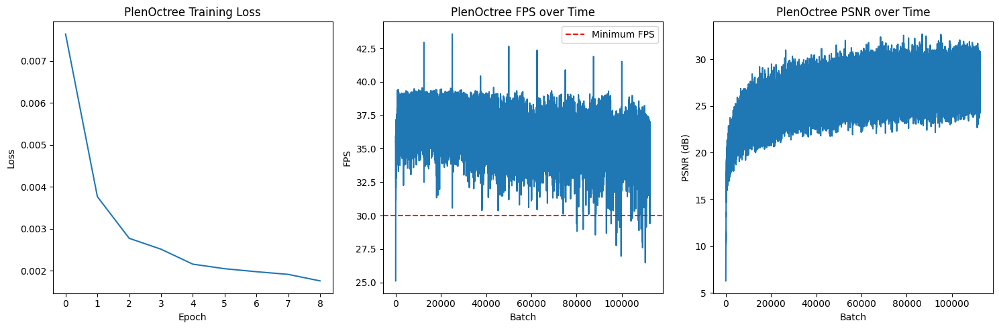

PlenOctree Training Progress:  90%|█████████ | 112503/125000 [1:52:56<41:59,  4.96it/s]


PlenOctree Epoch 10/10, Batch 0:
FPS: 41.37, Latency: 24.17ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  90%|█████████ | 112513/125000 [1:52:56<17:17, 12.04it/s]


PlenOctree Epoch 10/10, Batch 10:
FPS: 35.30, Latency: 28.33ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  90%|█████████ | 112523/125000 [1:52:57<13:12, 15.74it/s]


PlenOctree Epoch 10/10, Batch 20:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  90%|█████████ | 112533/125000 [1:52:58<12:46, 16.25it/s]


PlenOctree Epoch 10/10, Batch 30:
FPS: 34.28, Latency: 29.17ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  90%|█████████ | 112543/125000 [1:52:58<12:29, 16.61it/s]


PlenOctree Epoch 10/10, Batch 40:
FPS: 36.65, Latency: 27.29ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112553/125000 [1:52:59<12:24, 16.72it/s]


PlenOctree Epoch 10/10, Batch 50:
FPS: 34.80, Latency: 28.74ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  90%|█████████ | 112563/125000 [1:52:59<12:35, 16.47it/s]


PlenOctree Epoch 10/10, Batch 60:
FPS: 35.90, Latency: 27.86ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  90%|█████████ | 112573/125000 [1:53:00<12:33, 16.50it/s]


PlenOctree Epoch 10/10, Batch 70:
FPS: 36.95, Latency: 27.07ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  90%|█████████ | 112583/125000 [1:53:01<12:25, 16.66it/s]


PlenOctree Epoch 10/10, Batch 80:
FPS: 37.48, Latency: 26.68ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112593/125000 [1:53:01<12:25, 16.65it/s]


PlenOctree Epoch 10/10, Batch 90:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.80dB, Loss: 0.0021


PlenOctree Training Progress:  90%|█████████ | 112603/125000 [1:53:02<12:24, 16.65it/s]


PlenOctree Epoch 10/10, Batch 100:
FPS: 36.37, Latency: 27.50ms
PSNR: 29.62dB, Loss: 0.0011


PlenOctree Training Progress:  90%|█████████ | 112613/125000 [1:53:02<12:20, 16.73it/s]


PlenOctree Epoch 10/10, Batch 110:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.52dB, Loss: 0.0035


PlenOctree Training Progress:  90%|█████████ | 112623/125000 [1:53:03<12:27, 16.56it/s]


PlenOctree Epoch 10/10, Batch 120:
FPS: 35.81, Latency: 27.93ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  90%|█████████ | 112633/125000 [1:53:04<12:27, 16.54it/s]


PlenOctree Epoch 10/10, Batch 130:
FPS: 37.44, Latency: 26.71ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  90%|█████████ | 112643/125000 [1:53:04<12:15, 16.81it/s]


PlenOctree Epoch 10/10, Batch 140:
FPS: 36.99, Latency: 27.04ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112653/125000 [1:53:05<12:27, 16.52it/s]


PlenOctree Epoch 10/10, Batch 150:
FPS: 34.66, Latency: 28.85ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  90%|█████████ | 112663/125000 [1:53:05<12:28, 16.49it/s]


PlenOctree Epoch 10/10, Batch 160:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112673/125000 [1:53:06<12:27, 16.48it/s]


PlenOctree Epoch 10/10, Batch 170:
FPS: 34.19, Latency: 29.25ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  90%|█████████ | 112683/125000 [1:53:07<12:27, 16.49it/s]


PlenOctree Epoch 10/10, Batch 180:
FPS: 36.04, Latency: 27.74ms
PSNR: 26.25dB, Loss: 0.0024


PlenOctree Training Progress:  90%|█████████ | 112693/125000 [1:53:07<12:24, 16.52it/s]


PlenOctree Epoch 10/10, Batch 190:
FPS: 36.02, Latency: 27.76ms
PSNR: 30.94dB, Loss: 0.0008


PlenOctree Training Progress:  90%|█████████ | 112703/125000 [1:53:08<12:25, 16.50it/s]


PlenOctree Epoch 10/10, Batch 200:
FPS: 34.28, Latency: 29.17ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  90%|█████████ | 112713/125000 [1:53:08<12:25, 16.48it/s]


PlenOctree Epoch 10/10, Batch 210:
FPS: 35.16, Latency: 28.44ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112723/125000 [1:53:09<12:22, 16.54it/s]


PlenOctree Epoch 10/10, Batch 220:
FPS: 35.96, Latency: 27.81ms
PSNR: 31.12dB, Loss: 0.0008


PlenOctree Training Progress:  90%|█████████ | 112733/125000 [1:53:10<12:21, 16.54it/s]


PlenOctree Epoch 10/10, Batch 230:
FPS: 36.10, Latency: 27.70ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  90%|█████████ | 112743/125000 [1:53:10<12:09, 16.79it/s]


PlenOctree Epoch 10/10, Batch 240:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  90%|█████████ | 112753/125000 [1:53:11<12:23, 16.46it/s]


PlenOctree Epoch 10/10, Batch 250:
FPS: 35.96, Latency: 27.81ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  90%|█████████ | 112763/125000 [1:53:11<12:08, 16.79it/s]


PlenOctree Epoch 10/10, Batch 260:
FPS: 36.91, Latency: 27.10ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  90%|█████████ | 112773/125000 [1:53:12<12:13, 16.68it/s]


PlenOctree Epoch 10/10, Batch 270:
FPS: 35.95, Latency: 27.82ms
PSNR: 29.48dB, Loss: 0.0011


PlenOctree Training Progress:  90%|█████████ | 112783/125000 [1:53:13<12:17, 16.56it/s]


PlenOctree Epoch 10/10, Batch 280:
FPS: 36.32, Latency: 27.53ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  90%|█████████ | 112793/125000 [1:53:13<12:17, 16.56it/s]


PlenOctree Epoch 10/10, Batch 290:
FPS: 36.89, Latency: 27.11ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  90%|█████████ | 112803/125000 [1:53:14<12:02, 16.88it/s]


PlenOctree Epoch 10/10, Batch 300:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  90%|█████████ | 112813/125000 [1:53:14<12:16, 16.55it/s]


PlenOctree Epoch 10/10, Batch 310:
FPS: 34.71, Latency: 28.81ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  90%|█████████ | 112823/125000 [1:53:15<12:14, 16.58it/s]


PlenOctree Epoch 10/10, Batch 320:
FPS: 37.15, Latency: 26.92ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  90%|█████████ | 112833/125000 [1:53:16<12:07, 16.72it/s]


PlenOctree Epoch 10/10, Batch 330:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  90%|█████████ | 112843/125000 [1:53:16<12:12, 16.59it/s]


PlenOctree Epoch 10/10, Batch 340:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112853/125000 [1:53:17<12:14, 16.53it/s]


PlenOctree Epoch 10/10, Batch 350:
FPS: 34.57, Latency: 28.93ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112863/125000 [1:53:17<12:19, 16.42it/s]


PlenOctree Epoch 10/10, Batch 360:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  90%|█████████ | 112873/125000 [1:53:18<12:19, 16.39it/s]


PlenOctree Epoch 10/10, Batch 370:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  90%|█████████ | 112883/125000 [1:53:19<12:16, 16.46it/s]


PlenOctree Epoch 10/10, Batch 380:
FPS: 36.95, Latency: 27.06ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  90%|█████████ | 112893/125000 [1:53:19<12:13, 16.50it/s]


PlenOctree Epoch 10/10, Batch 390:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  90%|█████████ | 112903/125000 [1:53:20<12:16, 16.42it/s]


PlenOctree Epoch 10/10, Batch 400:
FPS: 35.62, Latency: 28.07ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  90%|█████████ | 112913/125000 [1:53:20<12:12, 16.50it/s]


PlenOctree Epoch 10/10, Batch 410:
FPS: 35.59, Latency: 28.10ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  90%|█████████ | 112923/125000 [1:53:21<12:12, 16.49it/s]


PlenOctree Epoch 10/10, Batch 420:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  90%|█████████ | 112933/125000 [1:53:22<12:12, 16.48it/s]


PlenOctree Epoch 10/10, Batch 430:
FPS: 34.91, Latency: 28.64ms
PSNR: 29.52dB, Loss: 0.0011


PlenOctree Training Progress:  90%|█████████ | 112943/125000 [1:53:22<12:10, 16.50it/s]


PlenOctree Epoch 10/10, Batch 440:
FPS: 35.77, Latency: 27.95ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112953/125000 [1:53:23<12:11, 16.48it/s]


PlenOctree Epoch 10/10, Batch 450:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.17dB, Loss: 0.0030


PlenOctree Training Progress:  90%|█████████ | 112963/125000 [1:53:23<12:12, 16.43it/s]


PlenOctree Epoch 10/10, Batch 460:
FPS: 36.08, Latency: 27.72ms
PSNR: 26.42dB, Loss: 0.0023


PlenOctree Training Progress:  90%|█████████ | 112973/125000 [1:53:24<12:09, 16.49it/s]


PlenOctree Epoch 10/10, Batch 470:
FPS: 35.75, Latency: 27.97ms
PSNR: 25.11dB, Loss: 0.0031


PlenOctree Training Progress:  90%|█████████ | 112983/125000 [1:53:25<12:11, 16.42it/s]


PlenOctree Epoch 10/10, Batch 480:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.98dB, Loss: 0.0016


PlenOctree Training Progress:  90%|█████████ | 112993/125000 [1:53:25<12:09, 16.46it/s]


PlenOctree Epoch 10/10, Batch 490:
FPS: 37.18, Latency: 26.90ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  90%|█████████ | 113003/125000 [1:53:26<12:02, 16.60it/s]


PlenOctree Epoch 10/10, Batch 500:
FPS: 37.45, Latency: 26.70ms
PSNR: 24.85dB, Loss: 0.0033


PlenOctree Training Progress:  90%|█████████ | 113013/125000 [1:53:27<11:53, 16.80it/s]


PlenOctree Epoch 10/10, Batch 510:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  90%|█████████ | 113023/125000 [1:53:27<12:04, 16.52it/s]


PlenOctree Epoch 10/10, Batch 520:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  90%|█████████ | 113033/125000 [1:53:28<12:01, 16.58it/s]


PlenOctree Epoch 10/10, Batch 530:
FPS: 36.66, Latency: 27.28ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  90%|█████████ | 113043/125000 [1:53:28<11:50, 16.84it/s]


PlenOctree Epoch 10/10, Batch 540:
FPS: 34.97, Latency: 28.59ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  90%|█████████ | 113053/125000 [1:53:29<12:01, 16.55it/s]


PlenOctree Epoch 10/10, Batch 550:
FPS: 35.32, Latency: 28.31ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  90%|█████████ | 113063/125000 [1:53:30<12:03, 16.51it/s]


PlenOctree Epoch 10/10, Batch 560:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  90%|█████████ | 113073/125000 [1:53:30<12:07, 16.40it/s]


PlenOctree Epoch 10/10, Batch 570:
FPS: 32.66, Latency: 30.62ms
PSNR: 26.12dB, Loss: 0.0024


PlenOctree Training Progress:  90%|█████████ | 113083/125000 [1:53:31<12:03, 16.48it/s]


PlenOctree Epoch 10/10, Batch 580:
FPS: 33.09, Latency: 30.22ms
PSNR: 24.38dB, Loss: 0.0037


PlenOctree Training Progress:  90%|█████████ | 113093/125000 [1:53:31<12:03, 16.45it/s]


PlenOctree Epoch 10/10, Batch 590:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  90%|█████████ | 113103/125000 [1:53:32<12:04, 16.43it/s]


PlenOctree Epoch 10/10, Batch 600:
FPS: 35.31, Latency: 28.32ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  90%|█████████ | 113113/125000 [1:53:33<11:59, 16.52it/s]


PlenOctree Epoch 10/10, Batch 610:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  90%|█████████ | 113123/125000 [1:53:33<12:00, 16.49it/s]


PlenOctree Epoch 10/10, Batch 620:
FPS: 36.36, Latency: 27.50ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  91%|█████████ | 113133/125000 [1:53:34<11:58, 16.53it/s]


PlenOctree Epoch 10/10, Batch 630:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113143/125000 [1:53:34<11:59, 16.49it/s]


PlenOctree Epoch 10/10, Batch 640:
FPS: 36.47, Latency: 27.42ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  91%|█████████ | 113153/125000 [1:53:35<12:00, 16.45it/s]


PlenOctree Epoch 10/10, Batch 650:
FPS: 36.05, Latency: 27.74ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113163/125000 [1:53:36<11:58, 16.47it/s]


PlenOctree Epoch 10/10, Batch 660:
FPS: 35.93, Latency: 27.83ms
PSNR: 29.74dB, Loss: 0.0011


PlenOctree Training Progress:  91%|█████████ | 113173/125000 [1:53:36<11:56, 16.50it/s]


PlenOctree Epoch 10/10, Batch 670:
FPS: 35.85, Latency: 27.89ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113183/125000 [1:53:37<11:58, 16.45it/s]


PlenOctree Epoch 10/10, Batch 680:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113193/125000 [1:53:37<11:56, 16.49it/s]


PlenOctree Epoch 10/10, Batch 690:
FPS: 34.40, Latency: 29.07ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113203/125000 [1:53:38<11:55, 16.49it/s]


PlenOctree Epoch 10/10, Batch 700:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.95dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113213/125000 [1:53:39<11:55, 16.48it/s]


PlenOctree Epoch 10/10, Batch 710:
FPS: 34.74, Latency: 28.78ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113223/125000 [1:53:39<11:52, 16.52it/s]


PlenOctree Epoch 10/10, Batch 720:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  91%|█████████ | 113233/125000 [1:53:40<11:50, 16.57it/s]


PlenOctree Epoch 10/10, Batch 730:
FPS: 36.91, Latency: 27.09ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  91%|█████████ | 113243/125000 [1:53:40<11:38, 16.82it/s]


PlenOctree Epoch 10/10, Batch 740:
FPS: 36.63, Latency: 27.30ms
PSNR: 29.60dB, Loss: 0.0011


PlenOctree Training Progress:  91%|█████████ | 113253/125000 [1:53:41<11:49, 16.55it/s]


PlenOctree Epoch 10/10, Batch 750:
FPS: 36.36, Latency: 27.51ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113263/125000 [1:53:42<11:52, 16.48it/s]


PlenOctree Epoch 10/10, Batch 760:
FPS: 35.45, Latency: 28.21ms
PSNR: 30.27dB, Loss: 0.0009


PlenOctree Training Progress:  91%|█████████ | 113273/125000 [1:53:42<11:50, 16.50it/s]


PlenOctree Epoch 10/10, Batch 770:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113283/125000 [1:53:43<11:50, 16.50it/s]


PlenOctree Epoch 10/10, Batch 780:
FPS: 34.06, Latency: 29.36ms
PSNR: 29.90dB, Loss: 0.0010


PlenOctree Training Progress:  91%|█████████ | 113293/125000 [1:53:43<11:49, 16.49it/s]


PlenOctree Epoch 10/10, Batch 790:
FPS: 33.70, Latency: 29.67ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113303/125000 [1:53:44<11:47, 16.54it/s]


PlenOctree Epoch 10/10, Batch 800:
FPS: 36.54, Latency: 27.36ms
PSNR: 30.14dB, Loss: 0.0010


PlenOctree Training Progress:  91%|█████████ | 113313/125000 [1:53:45<11:48, 16.49it/s]


PlenOctree Epoch 10/10, Batch 810:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  91%|█████████ | 113323/125000 [1:53:45<11:50, 16.44it/s]


PlenOctree Epoch 10/10, Batch 820:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113333/125000 [1:53:46<11:48, 16.48it/s]


PlenOctree Epoch 10/10, Batch 830:
FPS: 36.13, Latency: 27.68ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113343/125000 [1:53:46<11:41, 16.63it/s]


PlenOctree Epoch 10/10, Batch 840:
FPS: 37.47, Latency: 26.69ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113353/125000 [1:53:47<11:36, 16.72it/s]


PlenOctree Epoch 10/10, Batch 850:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113363/125000 [1:53:48<11:40, 16.62it/s]


PlenOctree Epoch 10/10, Batch 860:
FPS: 35.72, Latency: 28.00ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113373/125000 [1:53:48<11:45, 16.47it/s]


PlenOctree Epoch 10/10, Batch 870:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113383/125000 [1:53:49<11:45, 16.47it/s]


PlenOctree Epoch 10/10, Batch 880:
FPS: 35.19, Latency: 28.42ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress:  91%|█████████ | 113393/125000 [1:53:50<11:42, 16.52it/s]


PlenOctree Epoch 10/10, Batch 890:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113403/125000 [1:53:50<11:35, 16.67it/s]


PlenOctree Epoch 10/10, Batch 900:
FPS: 37.76, Latency: 26.48ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113413/125000 [1:53:51<11:33, 16.71it/s]


PlenOctree Epoch 10/10, Batch 910:
FPS: 34.71, Latency: 28.81ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  91%|█████████ | 113423/125000 [1:53:51<11:40, 16.53it/s]


PlenOctree Epoch 10/10, Batch 920:
FPS: 36.61, Latency: 27.32ms
PSNR: 29.41dB, Loss: 0.0011


PlenOctree Training Progress:  91%|█████████ | 113433/125000 [1:53:52<11:43, 16.43it/s]


PlenOctree Epoch 10/10, Batch 930:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.72dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113443/125000 [1:53:53<11:42, 16.45it/s]


PlenOctree Epoch 10/10, Batch 940:
FPS: 35.50, Latency: 28.17ms
PSNR: 30.78dB, Loss: 0.0008


PlenOctree Training Progress:  91%|█████████ | 113453/125000 [1:53:53<11:40, 16.48it/s]


PlenOctree Epoch 10/10, Batch 950:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113463/125000 [1:53:54<11:41, 16.44it/s]


PlenOctree Epoch 10/10, Batch 960:
FPS: 34.19, Latency: 29.25ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113473/125000 [1:53:54<11:40, 16.45it/s]


PlenOctree Epoch 10/10, Batch 970:
FPS: 35.33, Latency: 28.31ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113483/125000 [1:53:55<11:38, 16.48it/s]


PlenOctree Epoch 10/10, Batch 980:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113493/125000 [1:53:56<11:38, 16.48it/s]


PlenOctree Epoch 10/10, Batch 990:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113503/125000 [1:53:56<11:37, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1000:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113513/125000 [1:53:57<11:28, 16.69it/s]


PlenOctree Epoch 10/10, Batch 1010:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113523/125000 [1:53:57<11:31, 16.60it/s]


PlenOctree Epoch 10/10, Batch 1020:
FPS: 34.26, Latency: 29.19ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  91%|█████████ | 113533/125000 [1:53:58<11:31, 16.57it/s]


PlenOctree Epoch 10/10, Batch 1030:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.07dB, Loss: 0.0025


PlenOctree Training Progress:  91%|█████████ | 113543/125000 [1:53:59<11:22, 16.79it/s]


PlenOctree Epoch 10/10, Batch 1040:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113553/125000 [1:53:59<11:31, 16.55it/s]


PlenOctree Epoch 10/10, Batch 1050:
FPS: 36.49, Latency: 27.40ms
PSNR: 29.15dB, Loss: 0.0012


PlenOctree Training Progress:  91%|█████████ | 113563/125000 [1:54:00<11:20, 16.80it/s]


PlenOctree Epoch 10/10, Batch 1060:
FPS: 36.32, Latency: 27.53ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  91%|█████████ | 113573/125000 [1:54:00<11:27, 16.63it/s]


PlenOctree Epoch 10/10, Batch 1070:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  91%|█████████ | 113583/125000 [1:54:01<11:30, 16.53it/s]


PlenOctree Epoch 10/10, Batch 1080:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████ | 113593/125000 [1:54:02<11:32, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1090:
FPS: 34.96, Latency: 28.60ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  91%|█████████ | 113603/125000 [1:54:02<11:19, 16.78it/s]


PlenOctree Epoch 10/10, Batch 1100:
FPS: 36.73, Latency: 27.23ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113613/125000 [1:54:03<11:25, 16.62it/s]


PlenOctree Epoch 10/10, Batch 1110:
FPS: 34.90, Latency: 28.65ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113623/125000 [1:54:03<11:25, 16.59it/s]


PlenOctree Epoch 10/10, Batch 1120:
FPS: 36.38, Latency: 27.49ms
PSNR: 29.42dB, Loss: 0.0011


PlenOctree Training Progress:  91%|█████████ | 113633/125000 [1:54:04<11:15, 16.83it/s]


PlenOctree Epoch 10/10, Batch 1130:
FPS: 37.60, Latency: 26.59ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113643/125000 [1:54:05<11:26, 16.54it/s]


PlenOctree Epoch 10/10, Batch 1140:
FPS: 36.15, Latency: 27.66ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113653/125000 [1:54:05<11:27, 16.51it/s]


PlenOctree Epoch 10/10, Batch 1150:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113663/125000 [1:54:06<11:30, 16.43it/s]


PlenOctree Epoch 10/10, Batch 1160:
FPS: 35.52, Latency: 28.15ms
PSNR: 29.42dB, Loss: 0.0011


PlenOctree Training Progress:  91%|█████████ | 113673/125000 [1:54:06<11:30, 16.40it/s]


PlenOctree Epoch 10/10, Batch 1170:
FPS: 34.77, Latency: 28.76ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  91%|█████████ | 113683/125000 [1:54:07<11:25, 16.51it/s]


PlenOctree Epoch 10/10, Batch 1180:
FPS: 36.41, Latency: 27.46ms
PSNR: 30.37dB, Loss: 0.0009


PlenOctree Training Progress:  91%|█████████ | 113693/125000 [1:54:08<11:27, 16.46it/s]


PlenOctree Epoch 10/10, Batch 1190:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.74dB, Loss: 0.0034


PlenOctree Training Progress:  91%|█████████ | 113703/125000 [1:54:08<11:10, 16.85it/s]


PlenOctree Epoch 10/10, Batch 1200:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113713/125000 [1:54:09<11:21, 16.55it/s]


PlenOctree Epoch 10/10, Batch 1210:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113723/125000 [1:54:09<11:21, 16.54it/s]


PlenOctree Epoch 10/10, Batch 1220:
FPS: 35.32, Latency: 28.31ms
PSNR: 25.83dB, Loss: 0.0026


PlenOctree Training Progress:  91%|█████████ | 113733/125000 [1:54:10<11:23, 16.49it/s]


PlenOctree Epoch 10/10, Batch 1230:
FPS: 36.24, Latency: 27.60ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113743/125000 [1:54:11<11:24, 16.46it/s]


PlenOctree Epoch 10/10, Batch 1240:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.48dB, Loss: 0.0028


PlenOctree Training Progress:  91%|█████████ | 113753/125000 [1:54:11<11:21, 16.50it/s]


PlenOctree Epoch 10/10, Batch 1250:
FPS: 34.83, Latency: 28.71ms
PSNR: 26.31dB, Loss: 0.0023


PlenOctree Training Progress:  91%|█████████ | 113763/125000 [1:54:12<11:22, 16.45it/s]


PlenOctree Epoch 10/10, Batch 1260:
FPS: 35.06, Latency: 28.52ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  91%|█████████ | 113773/125000 [1:54:12<11:20, 16.49it/s]


PlenOctree Epoch 10/10, Batch 1270:
FPS: 35.38, Latency: 28.27ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 113783/125000 [1:54:13<11:21, 16.45it/s]


PlenOctree Epoch 10/10, Batch 1280:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.63dB, Loss: 0.0027


PlenOctree Training Progress:  91%|█████████ | 113793/125000 [1:54:14<11:18, 16.52it/s]


PlenOctree Epoch 10/10, Batch 1290:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████ | 113803/125000 [1:54:14<11:18, 16.50it/s]


PlenOctree Epoch 10/10, Batch 1300:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  91%|█████████ | 113813/125000 [1:54:15<11:18, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1310:
FPS: 35.86, Latency: 27.88ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████ | 113823/125000 [1:54:15<11:13, 16.60it/s]


PlenOctree Epoch 10/10, Batch 1320:
FPS: 36.27, Latency: 27.57ms
PSNR: 31.99dB, Loss: 0.0006


PlenOctree Training Progress:  91%|█████████ | 113833/125000 [1:54:16<11:03, 16.84it/s]


PlenOctree Epoch 10/10, Batch 1330:
FPS: 35.55, Latency: 28.13ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  91%|█████████ | 113843/125000 [1:54:17<11:15, 16.53it/s]


PlenOctree Epoch 10/10, Batch 1340:
FPS: 34.35, Latency: 29.11ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  91%|█████████ | 113853/125000 [1:54:17<11:15, 16.50it/s]


PlenOctree Epoch 10/10, Batch 1350:
FPS: 34.71, Latency: 28.81ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113863/125000 [1:54:18<11:15, 16.49it/s]


PlenOctree Epoch 10/10, Batch 1360:
FPS: 35.50, Latency: 28.17ms
PSNR: 30.90dB, Loss: 0.0008


PlenOctree Training Progress:  91%|█████████ | 113873/125000 [1:54:19<11:15, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1370:
FPS: 35.26, Latency: 28.36ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113883/125000 [1:54:19<11:13, 16.51it/s]


PlenOctree Epoch 10/10, Batch 1380:
FPS: 34.18, Latency: 29.25ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  91%|█████████ | 113893/125000 [1:54:20<11:15, 16.45it/s]


PlenOctree Epoch 10/10, Batch 1390:
FPS: 34.58, Latency: 28.92ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 113903/125000 [1:54:20<11:11, 16.53it/s]


PlenOctree Epoch 10/10, Batch 1400:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113913/125000 [1:54:21<11:12, 16.49it/s]


PlenOctree Epoch 10/10, Batch 1410:
FPS: 35.23, Latency: 28.38ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113923/125000 [1:54:22<11:11, 16.49it/s]


PlenOctree Epoch 10/10, Batch 1420:
FPS: 36.52, Latency: 27.38ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113933/125000 [1:54:22<11:11, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1430:
FPS: 35.45, Latency: 28.20ms
PSNR: 25.59dB, Loss: 0.0028


PlenOctree Training Progress:  91%|█████████ | 113943/125000 [1:54:23<11:10, 16.50it/s]


PlenOctree Epoch 10/10, Batch 1440:
FPS: 34.40, Latency: 29.07ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████ | 113953/125000 [1:54:23<11:08, 16.52it/s]


PlenOctree Epoch 10/10, Batch 1450:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████ | 113963/125000 [1:54:24<11:10, 16.47it/s]


PlenOctree Epoch 10/10, Batch 1460:
FPS: 36.37, Latency: 27.49ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 113973/125000 [1:54:25<10:56, 16.80it/s]


PlenOctree Epoch 10/10, Batch 1470:
FPS: 35.44, Latency: 28.22ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████ | 113983/125000 [1:54:25<11:02, 16.62it/s]


PlenOctree Epoch 10/10, Batch 1480:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 113993/125000 [1:54:26<11:06, 16.52it/s]


PlenOctree Epoch 10/10, Batch 1490:
FPS: 36.26, Latency: 27.58ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  91%|█████████ | 114003/125000 [1:54:26<11:14, 16.31it/s]


PlenOctree Epoch 10/10, Batch 1500:
FPS: 37.01, Latency: 27.02ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 114013/125000 [1:54:27<11:09, 16.41it/s]


PlenOctree Epoch 10/10, Batch 1510:
FPS: 35.46, Latency: 28.20ms
PSNR: 28.92dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████ | 114023/125000 [1:54:28<11:06, 16.47it/s]


PlenOctree Epoch 10/10, Batch 1520:
FPS: 36.61, Latency: 27.31ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████ | 114033/125000 [1:54:28<11:06, 16.44it/s]


PlenOctree Epoch 10/10, Batch 1530:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  91%|█████████ | 114043/125000 [1:54:29<11:05, 16.46it/s]


PlenOctree Epoch 10/10, Batch 1540:
FPS: 36.62, Latency: 27.31ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████ | 114053/125000 [1:54:29<11:06, 16.43it/s]


PlenOctree Epoch 10/10, Batch 1550:
FPS: 35.25, Latency: 28.37ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████▏| 114063/125000 [1:54:30<11:04, 16.47it/s]


PlenOctree Epoch 10/10, Batch 1560:
FPS: 35.62, Latency: 28.07ms
PSNR: 25.36dB, Loss: 0.0029


PlenOctree Training Progress:  91%|█████████▏| 114073/125000 [1:54:31<11:00, 16.54it/s]


PlenOctree Epoch 10/10, Batch 1570:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████▏| 114083/125000 [1:54:31<10:57, 16.61it/s]


PlenOctree Epoch 10/10, Batch 1580:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  91%|█████████▏| 114093/125000 [1:54:32<10:53, 16.69it/s]


PlenOctree Epoch 10/10, Batch 1590:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.77dB, Loss: 0.0026


PlenOctree Training Progress:  91%|█████████▏| 114103/125000 [1:54:32<10:57, 16.58it/s]


PlenOctree Epoch 10/10, Batch 1600:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████▏| 114113/125000 [1:54:33<11:00, 16.49it/s]


PlenOctree Epoch 10/10, Batch 1610:
FPS: 36.04, Latency: 27.74ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████▏| 114123/125000 [1:54:34<10:58, 16.53it/s]


PlenOctree Epoch 10/10, Batch 1620:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████▏| 114133/125000 [1:54:34<10:52, 16.66it/s]


PlenOctree Epoch 10/10, Batch 1630:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████▏| 114143/125000 [1:54:35<10:51, 16.65it/s]


PlenOctree Epoch 10/10, Batch 1640:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.53dB, Loss: 0.0028


PlenOctree Training Progress:  91%|█████████▏| 114153/125000 [1:54:35<10:52, 16.63it/s]


PlenOctree Epoch 10/10, Batch 1650:
FPS: 35.41, Latency: 28.24ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████▏| 114163/125000 [1:54:36<10:49, 16.68it/s]


PlenOctree Epoch 10/10, Batch 1660:
FPS: 37.00, Latency: 27.03ms
PSNR: 29.91dB, Loss: 0.0010


PlenOctree Training Progress:  91%|█████████▏| 114173/125000 [1:54:37<10:50, 16.64it/s]


PlenOctree Epoch 10/10, Batch 1670:
FPS: 36.56, Latency: 27.36ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  91%|█████████▏| 114183/125000 [1:54:37<10:53, 16.56it/s]


PlenOctree Epoch 10/10, Batch 1680:
FPS: 36.12, Latency: 27.69ms
PSNR: 26.96dB, Loss: 0.0020


PlenOctree Training Progress:  91%|█████████▏| 114193/125000 [1:54:38<10:39, 16.90it/s]


PlenOctree Epoch 10/10, Batch 1690:
FPS: 37.48, Latency: 26.68ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████▏| 114203/125000 [1:54:38<10:48, 16.64it/s]


PlenOctree Epoch 10/10, Batch 1700:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████▏| 114213/125000 [1:54:39<10:50, 16.58it/s]


PlenOctree Epoch 10/10, Batch 1710:
FPS: 36.71, Latency: 27.24ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  91%|█████████▏| 114223/125000 [1:54:40<10:38, 16.89it/s]


PlenOctree Epoch 10/10, Batch 1720:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████▏| 114233/125000 [1:54:40<10:48, 16.61it/s]


PlenOctree Epoch 10/10, Batch 1730:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████▏| 114243/125000 [1:54:41<10:50, 16.54it/s]


PlenOctree Epoch 10/10, Batch 1740:
FPS: 36.79, Latency: 27.18ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  91%|█████████▏| 114253/125000 [1:54:41<10:52, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1750:
FPS: 35.93, Latency: 27.84ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  91%|█████████▏| 114263/125000 [1:54:42<10:53, 16.42it/s]


PlenOctree Epoch 10/10, Batch 1760:
FPS: 35.07, Latency: 28.52ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  91%|█████████▏| 114273/125000 [1:54:43<10:48, 16.54it/s]


PlenOctree Epoch 10/10, Batch 1770:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████▏| 114283/125000 [1:54:43<10:51, 16.46it/s]


PlenOctree Epoch 10/10, Batch 1780:
FPS: 36.43, Latency: 27.45ms
PSNR: 31.03dB, Loss: 0.0008


PlenOctree Training Progress:  91%|█████████▏| 114293/125000 [1:54:44<10:48, 16.52it/s]


PlenOctree Epoch 10/10, Batch 1790:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  91%|█████████▏| 114303/125000 [1:54:44<10:39, 16.73it/s]


PlenOctree Epoch 10/10, Batch 1800:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████▏| 114313/125000 [1:54:45<10:44, 16.59it/s]


PlenOctree Epoch 10/10, Batch 1810:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  91%|█████████▏| 114323/125000 [1:54:46<10:42, 16.62it/s]


PlenOctree Epoch 10/10, Batch 1820:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████▏| 114333/125000 [1:54:46<10:34, 16.81it/s]


PlenOctree Epoch 10/10, Batch 1830:
FPS: 36.95, Latency: 27.06ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  91%|█████████▏| 114343/125000 [1:54:47<10:40, 16.63it/s]


PlenOctree Epoch 10/10, Batch 1840:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  91%|█████████▏| 114353/125000 [1:54:47<10:42, 16.58it/s]


PlenOctree Epoch 10/10, Batch 1850:
FPS: 36.36, Latency: 27.51ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  91%|█████████▏| 114363/125000 [1:54:48<10:40, 16.61it/s]


PlenOctree Epoch 10/10, Batch 1860:
FPS: 37.71, Latency: 26.52ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  91%|█████████▏| 114373/125000 [1:54:49<10:37, 16.67it/s]


PlenOctree Epoch 10/10, Batch 1870:
FPS: 35.75, Latency: 27.97ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 114383/125000 [1:54:49<10:39, 16.60it/s]


PlenOctree Epoch 10/10, Batch 1880:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  92%|█████████▏| 114393/125000 [1:54:50<10:29, 16.85it/s]


PlenOctree Epoch 10/10, Batch 1890:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 114403/125000 [1:54:50<10:33, 16.72it/s]


PlenOctree Epoch 10/10, Batch 1900:
FPS: 36.51, Latency: 27.39ms
PSNR: 30.28dB, Loss: 0.0009


PlenOctree Training Progress:  92%|█████████▏| 114413/125000 [1:54:51<10:25, 16.91it/s]


PlenOctree Epoch 10/10, Batch 1910:
FPS: 36.88, Latency: 27.11ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 114423/125000 [1:54:52<10:39, 16.55it/s]


PlenOctree Epoch 10/10, Batch 1920:
FPS: 35.97, Latency: 27.80ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 114433/125000 [1:54:52<10:38, 16.55it/s]


PlenOctree Epoch 10/10, Batch 1930:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114443/125000 [1:54:53<10:40, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1940:
FPS: 35.23, Latency: 28.39ms
PSNR: 29.85dB, Loss: 0.0010


PlenOctree Training Progress:  92%|█████████▏| 114453/125000 [1:54:54<10:40, 16.46it/s]


PlenOctree Epoch 10/10, Batch 1950:
FPS: 34.88, Latency: 28.67ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 114463/125000 [1:54:54<10:38, 16.51it/s]


PlenOctree Epoch 10/10, Batch 1960:
FPS: 35.14, Latency: 28.46ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 114473/125000 [1:54:55<10:38, 16.48it/s]


PlenOctree Epoch 10/10, Batch 1970:
FPS: 35.11, Latency: 28.49ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 114483/125000 [1:54:55<10:30, 16.68it/s]


PlenOctree Epoch 10/10, Batch 1980:
FPS: 37.85, Latency: 26.42ms
PSNR: 29.96dB, Loss: 0.0010


PlenOctree Training Progress:  92%|█████████▏| 114493/125000 [1:54:56<10:26, 16.77it/s]


PlenOctree Epoch 10/10, Batch 1990:
FPS: 36.45, Latency: 27.43ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  92%|█████████▏| 114503/125000 [1:54:57<10:34, 16.54it/s]


PlenOctree Epoch 10/10, Batch 2000:
FPS: 36.29, Latency: 27.55ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 114513/125000 [1:54:57<10:34, 16.52it/s]


PlenOctree Epoch 10/10, Batch 2010:
FPS: 37.07, Latency: 26.97ms
PSNR: 27.00dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 114523/125000 [1:54:58<10:25, 16.76it/s]


PlenOctree Epoch 10/10, Batch 2020:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 114533/125000 [1:54:58<10:31, 16.58it/s]


PlenOctree Epoch 10/10, Batch 2030:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  92%|█████████▏| 114543/125000 [1:54:59<10:33, 16.52it/s]


PlenOctree Epoch 10/10, Batch 2040:
FPS: 32.15, Latency: 31.10ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 114553/125000 [1:55:00<10:34, 16.46it/s]


PlenOctree Epoch 10/10, Batch 2050:
FPS: 36.42, Latency: 27.46ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114563/125000 [1:55:00<10:34, 16.44it/s]


PlenOctree Epoch 10/10, Batch 2060:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114573/125000 [1:55:01<10:32, 16.50it/s]


PlenOctree Epoch 10/10, Batch 2070:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 114583/125000 [1:55:01<10:26, 16.64it/s]


PlenOctree Epoch 10/10, Batch 2080:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114593/125000 [1:55:02<10:21, 16.74it/s]


PlenOctree Epoch 10/10, Batch 2090:
FPS: 35.48, Latency: 28.18ms
PSNR: 30.53dB, Loss: 0.0009


PlenOctree Training Progress:  92%|█████████▏| 114603/125000 [1:55:03<10:27, 16.56it/s]


PlenOctree Epoch 10/10, Batch 2100:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 114613/125000 [1:55:03<10:28, 16.53it/s]


PlenOctree Epoch 10/10, Batch 2110:
FPS: 37.24, Latency: 26.85ms
PSNR: 26.95dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 114623/125000 [1:55:04<10:25, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2120:
FPS: 35.53, Latency: 28.15ms
PSNR: 27.29dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 114633/125000 [1:55:04<10:23, 16.64it/s]


PlenOctree Epoch 10/10, Batch 2130:
FPS: 36.25, Latency: 27.58ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 114643/125000 [1:55:05<10:26, 16.54it/s]


PlenOctree Epoch 10/10, Batch 2140:
FPS: 34.71, Latency: 28.81ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 114653/125000 [1:55:06<10:30, 16.41it/s]


PlenOctree Epoch 10/10, Batch 2150:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114663/125000 [1:55:06<10:29, 16.43it/s]


PlenOctree Epoch 10/10, Batch 2160:
FPS: 33.72, Latency: 29.66ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 114673/125000 [1:55:07<10:26, 16.48it/s]


PlenOctree Epoch 10/10, Batch 2170:
FPS: 36.85, Latency: 27.13ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 114683/125000 [1:55:07<10:22, 16.56it/s]


PlenOctree Epoch 10/10, Batch 2180:
FPS: 37.40, Latency: 26.73ms
PSNR: 30.58dB, Loss: 0.0009


PlenOctree Training Progress:  92%|█████████▏| 114693/125000 [1:55:08<10:14, 16.77it/s]


PlenOctree Epoch 10/10, Batch 2190:
FPS: 36.93, Latency: 27.08ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 114703/125000 [1:55:09<10:24, 16.48it/s]


PlenOctree Epoch 10/10, Batch 2200:
FPS: 34.50, Latency: 28.98ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 114713/125000 [1:55:09<10:25, 16.45it/s]


PlenOctree Epoch 10/10, Batch 2210:
FPS: 35.96, Latency: 27.81ms
PSNR: 29.00dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114723/125000 [1:55:10<10:20, 16.56it/s]


PlenOctree Epoch 10/10, Batch 2220:
FPS: 36.48, Latency: 27.42ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  92%|█████████▏| 114733/125000 [1:55:10<10:11, 16.80it/s]


PlenOctree Epoch 10/10, Batch 2230:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  92%|█████████▏| 114743/125000 [1:55:11<10:18, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2240:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 114753/125000 [1:55:12<10:18, 16.57it/s]


PlenOctree Epoch 10/10, Batch 2250:
FPS: 35.36, Latency: 28.28ms
PSNR: 29.09dB, Loss: 0.0012


PlenOctree Training Progress:  92%|█████████▏| 114763/125000 [1:55:12<10:08, 16.82it/s]


PlenOctree Epoch 10/10, Batch 2260:
FPS: 36.64, Latency: 27.30ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 114773/125000 [1:55:13<10:20, 16.48it/s]


PlenOctree Epoch 10/10, Batch 2270:
FPS: 36.25, Latency: 27.58ms
PSNR: 29.65dB, Loss: 0.0011


PlenOctree Training Progress:  92%|█████████▏| 114783/125000 [1:55:13<10:18, 16.52it/s]


PlenOctree Epoch 10/10, Batch 2280:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  92%|█████████▏| 114793/125000 [1:55:14<10:19, 16.47it/s]


PlenOctree Epoch 10/10, Batch 2290:
FPS: 35.91, Latency: 27.85ms
PSNR: 24.75dB, Loss: 0.0033


PlenOctree Training Progress:  92%|█████████▏| 114803/125000 [1:55:15<10:20, 16.44it/s]


PlenOctree Epoch 10/10, Batch 2300:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 114813/125000 [1:55:15<10:08, 16.74it/s]


PlenOctree Epoch 10/10, Batch 2310:
FPS: 37.41, Latency: 26.73ms
PSNR: 25.30dB, Loss: 0.0030


PlenOctree Training Progress:  92%|█████████▏| 114823/125000 [1:55:16<10:10, 16.67it/s]


PlenOctree Epoch 10/10, Batch 2320:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 114833/125000 [1:55:16<10:11, 16.64it/s]


PlenOctree Epoch 10/10, Batch 2330:
FPS: 36.18, Latency: 27.64ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114843/125000 [1:55:17<10:03, 16.83it/s]


PlenOctree Epoch 10/10, Batch 2340:
FPS: 37.83, Latency: 26.43ms
PSNR: 29.71dB, Loss: 0.0011


PlenOctree Training Progress:  92%|█████████▏| 114853/125000 [1:55:18<10:11, 16.60it/s]


PlenOctree Epoch 10/10, Batch 2350:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114863/125000 [1:55:18<10:12, 16.55it/s]


PlenOctree Epoch 10/10, Batch 2360:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  92%|█████████▏| 114873/125000 [1:55:19<10:11, 16.55it/s]


PlenOctree Epoch 10/10, Batch 2370:
FPS: 36.89, Latency: 27.11ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 114883/125000 [1:55:19<10:02, 16.80it/s]


PlenOctree Epoch 10/10, Batch 2380:
FPS: 36.32, Latency: 27.53ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114893/125000 [1:55:20<10:09, 16.58it/s]


PlenOctree Epoch 10/10, Batch 2390:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 114903/125000 [1:55:21<10:14, 16.44it/s]


PlenOctree Epoch 10/10, Batch 2400:
FPS: 36.09, Latency: 27.71ms
PSNR: 29.39dB, Loss: 0.0012


PlenOctree Training Progress:  92%|█████████▏| 114913/125000 [1:55:21<10:11, 16.49it/s]


PlenOctree Epoch 10/10, Batch 2410:
FPS: 35.60, Latency: 28.09ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  92%|█████████▏| 114923/125000 [1:55:22<10:12, 16.46it/s]


PlenOctree Epoch 10/10, Batch 2420:
FPS: 35.63, Latency: 28.07ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114933/125000 [1:55:22<10:06, 16.61it/s]


PlenOctree Epoch 10/10, Batch 2430:
FPS: 37.09, Latency: 26.96ms
PSNR: 29.47dB, Loss: 0.0011


PlenOctree Training Progress:  92%|█████████▏| 114943/125000 [1:55:23<09:59, 16.78it/s]


PlenOctree Epoch 10/10, Batch 2440:
FPS: 35.89, Latency: 27.86ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 114953/125000 [1:55:24<10:06, 16.56it/s]


PlenOctree Epoch 10/10, Batch 2450:
FPS: 36.16, Latency: 27.65ms
PSNR: 29.61dB, Loss: 0.0011


PlenOctree Training Progress:  92%|█████████▏| 114963/125000 [1:55:24<09:54, 16.88it/s]


PlenOctree Epoch 10/10, Batch 2460:
FPS: 37.82, Latency: 26.44ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  92%|█████████▏| 114973/125000 [1:55:25<10:02, 16.64it/s]


PlenOctree Epoch 10/10, Batch 2470:
FPS: 35.07, Latency: 28.51ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  92%|█████████▏| 114983/125000 [1:55:25<10:06, 16.52it/s]


PlenOctree Epoch 10/10, Batch 2480:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 114993/125000 [1:55:26<10:07, 16.47it/s]


PlenOctree Epoch 10/10, Batch 2490:
FPS: 37.03, Latency: 27.00ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115003/125000 [1:55:27<10:06, 16.47it/s]


PlenOctree Epoch 10/10, Batch 2500:
FPS: 35.75, Latency: 27.97ms
PSNR: 29.42dB, Loss: 0.0011


PlenOctree Training Progress:  92%|█████████▏| 115013/125000 [1:55:27<10:04, 16.51it/s]


PlenOctree Epoch 10/10, Batch 2510:
FPS: 34.59, Latency: 28.91ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 115023/125000 [1:55:28<10:05, 16.48it/s]


PlenOctree Epoch 10/10, Batch 2520:
FPS: 35.88, Latency: 27.87ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 115033/125000 [1:55:28<10:00, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2530:
FPS: 36.41, Latency: 27.46ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 115043/125000 [1:55:29<09:52, 16.81it/s]


PlenOctree Epoch 10/10, Batch 2540:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 115053/125000 [1:55:30<10:00, 16.58it/s]


PlenOctree Epoch 10/10, Batch 2550:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 115063/125000 [1:55:30<10:02, 16.48it/s]


PlenOctree Epoch 10/10, Batch 2560:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.45dB, Loss: 0.0023


PlenOctree Training Progress:  92%|█████████▏| 115073/125000 [1:55:31<10:01, 16.50it/s]


PlenOctree Epoch 10/10, Batch 2570:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.23dB, Loss: 0.0024


PlenOctree Training Progress:  92%|█████████▏| 115083/125000 [1:55:32<09:47, 16.87it/s]


PlenOctree Epoch 10/10, Batch 2580:
FPS: 37.38, Latency: 26.75ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 115093/125000 [1:55:32<09:56, 16.62it/s]


PlenOctree Epoch 10/10, Batch 2590:
FPS: 36.31, Latency: 27.54ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 115103/125000 [1:55:33<09:58, 16.53it/s]


PlenOctree Epoch 10/10, Batch 2600:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 115113/125000 [1:55:33<10:00, 16.47it/s]


PlenOctree Epoch 10/10, Batch 2610:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 115123/125000 [1:55:34<10:00, 16.44it/s]


PlenOctree Epoch 10/10, Batch 2620:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 115133/125000 [1:55:35<09:54, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2630:
FPS: 36.88, Latency: 27.12ms
PSNR: 24.64dB, Loss: 0.0034


PlenOctree Training Progress:  92%|█████████▏| 115143/125000 [1:55:35<09:44, 16.87it/s]


PlenOctree Epoch 10/10, Batch 2640:
FPS: 37.81, Latency: 26.45ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115153/125000 [1:55:36<09:53, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2650:
FPS: 36.15, Latency: 27.66ms
PSNR: 25.89dB, Loss: 0.0026


PlenOctree Training Progress:  92%|█████████▏| 115163/125000 [1:55:36<09:53, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2660:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 115173/125000 [1:55:37<09:53, 16.55it/s]


PlenOctree Epoch 10/10, Batch 2670:
FPS: 36.92, Latency: 27.08ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 115183/125000 [1:55:38<09:46, 16.73it/s]


PlenOctree Epoch 10/10, Batch 2680:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 115193/125000 [1:55:38<09:51, 16.59it/s]


PlenOctree Epoch 10/10, Batch 2690:
FPS: 36.98, Latency: 27.04ms
PSNR: 24.67dB, Loss: 0.0034


PlenOctree Training Progress:  92%|█████████▏| 115203/125000 [1:55:39<09:41, 16.86it/s]


PlenOctree Epoch 10/10, Batch 2700:
FPS: 35.38, Latency: 28.26ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 115213/125000 [1:55:39<09:47, 16.67it/s]


PlenOctree Epoch 10/10, Batch 2710:
FPS: 34.59, Latency: 28.91ms
PSNR: 30.47dB, Loss: 0.0009


PlenOctree Training Progress:  92%|█████████▏| 115223/125000 [1:55:40<09:49, 16.57it/s]


PlenOctree Epoch 10/10, Batch 2720:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 115233/125000 [1:55:41<09:40, 16.84it/s]


PlenOctree Epoch 10/10, Batch 2730:
FPS: 37.64, Latency: 26.57ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 115243/125000 [1:55:41<09:48, 16.57it/s]


PlenOctree Epoch 10/10, Batch 2740:
FPS: 35.54, Latency: 28.14ms
PSNR: 29.82dB, Loss: 0.0010


PlenOctree Training Progress:  92%|█████████▏| 115253/125000 [1:55:42<09:48, 16.55it/s]


PlenOctree Epoch 10/10, Batch 2750:
FPS: 37.07, Latency: 26.98ms
PSNR: 25.92dB, Loss: 0.0026


PlenOctree Training Progress:  92%|█████████▏| 115263/125000 [1:55:42<09:49, 16.51it/s]


PlenOctree Epoch 10/10, Batch 2760:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115273/125000 [1:55:43<09:49, 16.50it/s]


PlenOctree Epoch 10/10, Batch 2770:
FPS: 34.84, Latency: 28.70ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 115283/125000 [1:55:44<09:48, 16.50it/s]


PlenOctree Epoch 10/10, Batch 2780:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 115293/125000 [1:55:44<09:50, 16.43it/s]


PlenOctree Epoch 10/10, Batch 2790:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.91dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 115303/125000 [1:55:45<09:49, 16.44it/s]


PlenOctree Epoch 10/10, Batch 2800:
FPS: 36.71, Latency: 27.24ms
PSNR: 30.01dB, Loss: 0.0010


PlenOctree Training Progress:  92%|█████████▏| 115313/125000 [1:55:45<09:45, 16.54it/s]


PlenOctree Epoch 10/10, Batch 2810:
FPS: 37.21, Latency: 26.87ms
PSNR: 26.29dB, Loss: 0.0024


PlenOctree Training Progress:  92%|█████████▏| 115323/125000 [1:55:46<09:34, 16.84it/s]


PlenOctree Epoch 10/10, Batch 2820:
FPS: 35.96, Latency: 27.81ms
PSNR: 29.39dB, Loss: 0.0012


PlenOctree Training Progress:  92%|█████████▏| 115333/125000 [1:55:47<09:45, 16.50it/s]


PlenOctree Epoch 10/10, Batch 2830:
FPS: 36.45, Latency: 27.43ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  92%|█████████▏| 115343/125000 [1:55:47<09:42, 16.58it/s]


PlenOctree Epoch 10/10, Batch 2840:
FPS: 37.53, Latency: 26.64ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 115353/125000 [1:55:48<09:34, 16.79it/s]


PlenOctree Epoch 10/10, Batch 2850:
FPS: 37.25, Latency: 26.85ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 115363/125000 [1:55:48<09:41, 16.56it/s]


PlenOctree Epoch 10/10, Batch 2860:
FPS: 38.04, Latency: 26.29ms
PSNR: 30.72dB, Loss: 0.0008


PlenOctree Training Progress:  92%|█████████▏| 115373/125000 [1:55:49<09:41, 16.55it/s]


PlenOctree Epoch 10/10, Batch 2870:
FPS: 35.56, Latency: 28.12ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115383/125000 [1:55:50<09:43, 16.47it/s]


PlenOctree Epoch 10/10, Batch 2880:
FPS: 35.39, Latency: 28.26ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 115393/125000 [1:55:50<09:37, 16.63it/s]


PlenOctree Epoch 10/10, Batch 2890:
FPS: 37.43, Latency: 26.72ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 115403/125000 [1:55:51<09:33, 16.73it/s]


PlenOctree Epoch 10/10, Batch 2900:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.91dB, Loss: 0.0026


PlenOctree Training Progress:  92%|█████████▏| 115413/125000 [1:55:51<09:39, 16.53it/s]


PlenOctree Epoch 10/10, Batch 2910:
FPS: 34.43, Latency: 29.05ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  92%|█████████▏| 115423/125000 [1:55:52<09:40, 16.51it/s]


PlenOctree Epoch 10/10, Batch 2920:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  92%|█████████▏| 115433/125000 [1:55:53<09:29, 16.79it/s]


PlenOctree Epoch 10/10, Batch 2930:
FPS: 37.17, Latency: 26.90ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  92%|█████████▏| 115443/125000 [1:55:53<09:36, 16.58it/s]


PlenOctree Epoch 10/10, Batch 2940:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  92%|█████████▏| 115453/125000 [1:55:54<09:37, 16.54it/s]


PlenOctree Epoch 10/10, Batch 2950:
FPS: 36.91, Latency: 27.09ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  92%|█████████▏| 115463/125000 [1:55:54<09:38, 16.47it/s]


PlenOctree Epoch 10/10, Batch 2960:
FPS: 35.03, Latency: 28.54ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  92%|█████████▏| 115473/125000 [1:55:55<09:37, 16.51it/s]


PlenOctree Epoch 10/10, Batch 2970:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  92%|█████████▏| 115483/125000 [1:55:56<09:30, 16.67it/s]


PlenOctree Epoch 10/10, Batch 2980:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  92%|█████████▏| 115493/125000 [1:55:56<09:32, 16.62it/s]


PlenOctree Epoch 10/10, Batch 2990:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115503/125000 [1:55:57<09:32, 16.58it/s]


PlenOctree Epoch 10/10, Batch 3000:
FPS: 36.33, Latency: 27.53ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 115513/125000 [1:55:57<09:35, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3010:
FPS: 36.45, Latency: 27.43ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  92%|█████████▏| 115523/125000 [1:55:58<09:33, 16.53it/s]


PlenOctree Epoch 10/10, Batch 3020:
FPS: 36.08, Latency: 27.72ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  92%|█████████▏| 115533/125000 [1:55:59<09:19, 16.91it/s]


PlenOctree Epoch 10/10, Batch 3030:
FPS: 37.21, Latency: 26.88ms
PSNR: 29.80dB, Loss: 0.0010


PlenOctree Training Progress:  92%|█████████▏| 115543/125000 [1:55:59<09:30, 16.58it/s]


PlenOctree Epoch 10/10, Batch 3040:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  92%|█████████▏| 115553/125000 [1:56:00<09:31, 16.54it/s]


PlenOctree Epoch 10/10, Batch 3050:
FPS: 35.42, Latency: 28.24ms
PSNR: 25.66dB, Loss: 0.0027


PlenOctree Training Progress:  92%|█████████▏| 115563/125000 [1:56:00<09:32, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3060:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.37dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115573/125000 [1:56:01<09:32, 16.47it/s]


PlenOctree Epoch 10/10, Batch 3070:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  92%|█████████▏| 115583/125000 [1:56:02<09:29, 16.53it/s]


PlenOctree Epoch 10/10, Batch 3080:
FPS: 35.85, Latency: 27.89ms
PSNR: 29.62dB, Loss: 0.0011


PlenOctree Training Progress:  92%|█████████▏| 115593/125000 [1:56:02<09:28, 16.54it/s]


PlenOctree Epoch 10/10, Batch 3090:
FPS: 37.06, Latency: 26.98ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115603/125000 [1:56:03<09:17, 16.87it/s]


PlenOctree Epoch 10/10, Batch 3100:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  92%|█████████▏| 115613/125000 [1:56:03<09:26, 16.58it/s]


PlenOctree Epoch 10/10, Batch 3110:
FPS: 36.34, Latency: 27.52ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  92%|█████████▏| 115623/125000 [1:56:04<09:28, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3120:
FPS: 35.66, Latency: 28.04ms
PSNR: 29.86dB, Loss: 0.0010


PlenOctree Training Progress:  93%|█████████▎| 115633/125000 [1:56:05<09:30, 16.41it/s]


PlenOctree Epoch 10/10, Batch 3130:
FPS: 34.28, Latency: 29.17ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 115643/125000 [1:56:05<09:28, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3140:
FPS: 35.81, Latency: 27.92ms
PSNR: 29.12dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 115653/125000 [1:56:06<09:26, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3150:
FPS: 36.44, Latency: 27.44ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 115663/125000 [1:56:06<09:28, 16.41it/s]


PlenOctree Epoch 10/10, Batch 3160:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  93%|█████████▎| 115673/125000 [1:56:07<09:22, 16.57it/s]


PlenOctree Epoch 10/10, Batch 3170:
FPS: 33.26, Latency: 30.07ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 115683/125000 [1:56:08<09:24, 16.51it/s]


PlenOctree Epoch 10/10, Batch 3180:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.50dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 115693/125000 [1:56:08<09:25, 16.47it/s]


PlenOctree Epoch 10/10, Batch 3190:
FPS: 36.15, Latency: 27.66ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  93%|█████████▎| 115703/125000 [1:56:09<09:25, 16.44it/s]


PlenOctree Epoch 10/10, Batch 3200:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.77dB, Loss: 0.0021


PlenOctree Training Progress:  93%|█████████▎| 115713/125000 [1:56:10<09:24, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3210:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 115723/125000 [1:56:10<09:23, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3220:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  93%|█████████▎| 115733/125000 [1:56:11<09:22, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3230:
FPS: 33.29, Latency: 30.04ms
PSNR: 29.57dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 115743/125000 [1:56:11<09:19, 16.56it/s]


PlenOctree Epoch 10/10, Batch 3240:
FPS: 37.28, Latency: 26.83ms
PSNR: 27.44dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 115753/125000 [1:56:12<09:12, 16.74it/s]


PlenOctree Epoch 10/10, Batch 3250:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 115763/125000 [1:56:13<09:18, 16.53it/s]


PlenOctree Epoch 10/10, Batch 3260:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 115773/125000 [1:56:13<09:21, 16.44it/s]


PlenOctree Epoch 10/10, Batch 3270:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  93%|█████████▎| 115783/125000 [1:56:14<09:20, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3280:
FPS: 35.90, Latency: 27.85ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 115793/125000 [1:56:14<09:18, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3290:
FPS: 35.76, Latency: 27.96ms
PSNR: 25.06dB, Loss: 0.0031


PlenOctree Training Progress:  93%|█████████▎| 115803/125000 [1:56:15<09:17, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3300:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 115813/125000 [1:56:16<09:17, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3310:
FPS: 34.97, Latency: 28.59ms
PSNR: 27.07dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 115823/125000 [1:56:16<09:18, 16.43it/s]


PlenOctree Epoch 10/10, Batch 3320:
FPS: 35.95, Latency: 27.82ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  93%|█████████▎| 115833/125000 [1:56:17<09:17, 16.43it/s]


PlenOctree Epoch 10/10, Batch 3330:
FPS: 35.59, Latency: 28.10ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 115843/125000 [1:56:17<09:16, 16.44it/s]


PlenOctree Epoch 10/10, Batch 3340:
FPS: 33.59, Latency: 29.77ms
PSNR: 25.35dB, Loss: 0.0029


PlenOctree Training Progress:  93%|█████████▎| 115853/125000 [1:56:18<09:15, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3350:
FPS: 34.13, Latency: 29.30ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 115863/125000 [1:56:19<09:13, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3360:
FPS: 33.58, Latency: 29.78ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 115873/125000 [1:56:19<09:16, 16.40it/s]


PlenOctree Epoch 10/10, Batch 3370:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  93%|█████████▎| 115883/125000 [1:56:20<09:13, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3380:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 115893/125000 [1:56:20<09:13, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3390:
FPS: 35.80, Latency: 27.94ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  93%|█████████▎| 115903/125000 [1:56:21<09:12, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3400:
FPS: 35.35, Latency: 28.29ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  93%|█████████▎| 115913/125000 [1:56:22<09:11, 16.47it/s]


PlenOctree Epoch 10/10, Batch 3410:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 115923/125000 [1:56:22<09:12, 16.44it/s]


PlenOctree Epoch 10/10, Batch 3420:
FPS: 35.62, Latency: 28.08ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 115933/125000 [1:56:23<09:10, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3430:
FPS: 34.14, Latency: 29.29ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 115943/125000 [1:56:23<09:10, 16.44it/s]


PlenOctree Epoch 10/10, Batch 3440:
FPS: 34.68, Latency: 28.84ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 115953/125000 [1:56:24<09:10, 16.43it/s]


PlenOctree Epoch 10/10, Batch 3450:
FPS: 36.44, Latency: 27.44ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  93%|█████████▎| 115963/125000 [1:56:25<09:08, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3460:
FPS: 35.87, Latency: 27.88ms
PSNR: 30.45dB, Loss: 0.0009


PlenOctree Training Progress:  93%|█████████▎| 115973/125000 [1:56:25<09:08, 16.47it/s]


PlenOctree Epoch 10/10, Batch 3470:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 115983/125000 [1:56:26<09:07, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3480:
FPS: 36.61, Latency: 27.32ms
PSNR: 28.68dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 115993/125000 [1:56:27<09:07, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3490:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.58dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 116003/125000 [1:56:27<09:05, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3500:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.85dB, Loss: 0.0026


PlenOctree Training Progress:  93%|█████████▎| 116013/125000 [1:56:28<09:05, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3510:
FPS: 35.99, Latency: 27.79ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116023/125000 [1:56:28<09:02, 16.55it/s]


PlenOctree Epoch 10/10, Batch 3520:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  93%|█████████▎| 116033/125000 [1:56:29<08:53, 16.81it/s]


PlenOctree Epoch 10/10, Batch 3530:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.68dB, Loss: 0.0027


PlenOctree Training Progress:  93%|█████████▎| 116043/125000 [1:56:30<09:00, 16.58it/s]


PlenOctree Epoch 10/10, Batch 3540:
FPS: 35.72, Latency: 27.99ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116053/125000 [1:56:30<09:01, 16.53it/s]


PlenOctree Epoch 10/10, Batch 3550:
FPS: 35.14, Latency: 28.46ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116063/125000 [1:56:31<09:01, 16.51it/s]


PlenOctree Epoch 10/10, Batch 3560:
FPS: 35.25, Latency: 28.37ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116073/125000 [1:56:31<09:03, 16.43it/s]


PlenOctree Epoch 10/10, Batch 3570:
FPS: 34.83, Latency: 28.71ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress:  93%|█████████▎| 116083/125000 [1:56:32<09:01, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3580:
FPS: 35.91, Latency: 27.84ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 116093/125000 [1:56:33<09:00, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3590:
FPS: 34.70, Latency: 28.82ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 116103/125000 [1:56:33<08:59, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3600:
FPS: 35.13, Latency: 28.46ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116113/125000 [1:56:34<08:59, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3610:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.80dB, Loss: 0.0013


PlenOctree Training Progress:  93%|█████████▎| 116123/125000 [1:56:34<08:58, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3620:
FPS: 35.40, Latency: 28.24ms
PSNR: 29.79dB, Loss: 0.0010


PlenOctree Training Progress:  93%|█████████▎| 116133/125000 [1:56:35<08:57, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3630:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  93%|█████████▎| 116143/125000 [1:56:36<08:57, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3640:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116153/125000 [1:56:36<08:56, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3650:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.87dB, Loss: 0.0021


PlenOctree Training Progress:  93%|█████████▎| 116163/125000 [1:56:37<08:57, 16.43it/s]


PlenOctree Epoch 10/10, Batch 3660:
FPS: 36.98, Latency: 27.04ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116173/125000 [1:56:37<08:54, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3670:
FPS: 36.32, Latency: 27.53ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  93%|█████████▎| 116183/125000 [1:56:38<08:55, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3680:
FPS: 35.04, Latency: 28.54ms
PSNR: 27.02dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116193/125000 [1:56:39<08:55, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3690:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116203/125000 [1:56:39<08:54, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3700:
FPS: 32.21, Latency: 31.04ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  93%|█████████▎| 116213/125000 [1:56:40<08:53, 16.47it/s]


PlenOctree Epoch 10/10, Batch 3710:
FPS: 36.76, Latency: 27.21ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116223/125000 [1:56:40<08:54, 16.43it/s]


PlenOctree Epoch 10/10, Batch 3720:
FPS: 35.52, Latency: 28.15ms
PSNR: 25.50dB, Loss: 0.0028


PlenOctree Training Progress:  93%|█████████▎| 116233/125000 [1:56:41<08:52, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3730:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  93%|█████████▎| 116243/125000 [1:56:42<08:49, 16.55it/s]


PlenOctree Epoch 10/10, Batch 3740:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.58dB, Loss: 0.0022


PlenOctree Training Progress:  93%|█████████▎| 116253/125000 [1:56:42<08:51, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3750:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116263/125000 [1:56:43<08:48, 16.55it/s]


PlenOctree Epoch 10/10, Batch 3760:
FPS: 36.54, Latency: 27.37ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116273/125000 [1:56:43<08:48, 16.51it/s]


PlenOctree Epoch 10/10, Batch 3770:
FPS: 36.08, Latency: 27.71ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116283/125000 [1:56:44<08:47, 16.54it/s]


PlenOctree Epoch 10/10, Batch 3780:
FPS: 36.89, Latency: 27.11ms
PSNR: 29.31dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116293/125000 [1:56:45<08:38, 16.80it/s]


PlenOctree Epoch 10/10, Batch 3790:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  93%|█████████▎| 116303/125000 [1:56:45<08:43, 16.60it/s]


PlenOctree Epoch 10/10, Batch 3800:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116313/125000 [1:56:46<08:44, 16.55it/s]


PlenOctree Epoch 10/10, Batch 3810:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116323/125000 [1:56:47<08:47, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3820:
FPS: 34.00, Latency: 29.41ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116333/125000 [1:56:47<08:48, 16.41it/s]


PlenOctree Epoch 10/10, Batch 3830:
FPS: 36.36, Latency: 27.51ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  93%|█████████▎| 116343/125000 [1:56:48<08:44, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3840:
FPS: 34.39, Latency: 29.08ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116353/125000 [1:56:48<08:43, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3850:
FPS: 36.46, Latency: 27.43ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 116363/125000 [1:56:49<08:43, 16.51it/s]


PlenOctree Epoch 10/10, Batch 3860:
FPS: 36.45, Latency: 27.44ms
PSNR: 25.38dB, Loss: 0.0029


PlenOctree Training Progress:  93%|█████████▎| 116373/125000 [1:56:50<08:42, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3870:
FPS: 36.16, Latency: 27.65ms
PSNR: 31.10dB, Loss: 0.0008


PlenOctree Training Progress:  93%|█████████▎| 116383/125000 [1:56:50<08:43, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3880:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  93%|█████████▎| 116393/125000 [1:56:51<08:41, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3890:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116403/125000 [1:56:51<08:41, 16.49it/s]


PlenOctree Epoch 10/10, Batch 3900:
FPS: 35.85, Latency: 27.89ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116413/125000 [1:56:52<08:41, 16.46it/s]


PlenOctree Epoch 10/10, Batch 3910:
FPS: 35.39, Latency: 28.25ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 116423/125000 [1:56:53<08:42, 16.42it/s]


PlenOctree Epoch 10/10, Batch 3920:
FPS: 36.48, Latency: 27.41ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116433/125000 [1:56:53<08:42, 16.41it/s]


PlenOctree Epoch 10/10, Batch 3930:
FPS: 34.79, Latency: 28.74ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116443/125000 [1:56:54<08:38, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3940:
FPS: 36.41, Latency: 27.47ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116453/125000 [1:56:54<08:39, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3950:
FPS: 34.32, Latency: 29.14ms
PSNR: 24.60dB, Loss: 0.0035


PlenOctree Training Progress:  93%|█████████▎| 116463/125000 [1:56:55<08:37, 16.48it/s]


PlenOctree Epoch 10/10, Batch 3960:
FPS: 33.68, Latency: 29.69ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116473/125000 [1:56:56<08:35, 16.54it/s]


PlenOctree Epoch 10/10, Batch 3970:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116483/125000 [1:56:56<08:36, 16.50it/s]


PlenOctree Epoch 10/10, Batch 3980:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.22dB, Loss: 0.0024


PlenOctree Training Progress:  93%|█████████▎| 116493/125000 [1:56:57<08:37, 16.45it/s]


PlenOctree Epoch 10/10, Batch 3990:
FPS: 35.19, Latency: 28.42ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 116503/125000 [1:56:57<08:36, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4000:
FPS: 36.16, Latency: 27.66ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116513/125000 [1:56:58<08:35, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4010:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116523/125000 [1:56:59<08:33, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4020:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116533/125000 [1:56:59<08:33, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4030:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116543/125000 [1:57:00<08:33, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4040:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 116553/125000 [1:57:00<08:32, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4050:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 116563/125000 [1:57:01<08:30, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4060:
FPS: 34.92, Latency: 28.64ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116573/125000 [1:57:02<08:30, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4070:
FPS: 35.15, Latency: 28.45ms
PSNR: 28.10dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116583/125000 [1:57:02<08:31, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4080:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116593/125000 [1:57:03<08:28, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4090:
FPS: 36.62, Latency: 27.30ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116603/125000 [1:57:04<08:30, 16.43it/s]


PlenOctree Epoch 10/10, Batch 4100:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  93%|█████████▎| 116613/125000 [1:57:04<08:26, 16.55it/s]


PlenOctree Epoch 10/10, Batch 4110:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  93%|█████████▎| 116623/125000 [1:57:05<08:21, 16.70it/s]


PlenOctree Epoch 10/10, Batch 4120:
FPS: 33.02, Latency: 30.29ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  93%|█████████▎| 116633/125000 [1:57:05<08:26, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4130:
FPS: 34.87, Latency: 28.67ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress:  93%|█████████▎| 116643/125000 [1:57:06<08:28, 16.43it/s]


PlenOctree Epoch 10/10, Batch 4140:
FPS: 35.06, Latency: 28.52ms
PSNR: 32.93dB, Loss: 0.0005


PlenOctree Training Progress:  93%|█████████▎| 116653/125000 [1:57:07<08:25, 16.51it/s]


PlenOctree Epoch 10/10, Batch 4150:
FPS: 36.63, Latency: 27.30ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116663/125000 [1:57:07<08:25, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4160:
FPS: 35.36, Latency: 28.28ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116673/125000 [1:57:08<08:23, 16.53it/s]


PlenOctree Epoch 10/10, Batch 4170:
FPS: 35.11, Latency: 28.48ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress:  93%|█████████▎| 116683/125000 [1:57:08<08:24, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4180:
FPS: 35.57, Latency: 28.11ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  93%|█████████▎| 116693/125000 [1:57:09<08:24, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4190:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116703/125000 [1:57:10<08:24, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4200:
FPS: 35.15, Latency: 28.45ms
PSNR: 28.28dB, Loss: 0.0015


PlenOctree Training Progress:  93%|█████████▎| 116713/125000 [1:57:10<08:22, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4210:
FPS: 36.41, Latency: 27.47ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  93%|█████████▎| 116723/125000 [1:57:11<08:22, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4220:
FPS: 34.47, Latency: 29.01ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116733/125000 [1:57:11<08:22, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4230:
FPS: 34.78, Latency: 28.75ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116743/125000 [1:57:12<08:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4240:
FPS: 34.95, Latency: 28.61ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  93%|█████████▎| 116753/125000 [1:57:13<08:20, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4250:
FPS: 34.22, Latency: 29.23ms
PSNR: 30.05dB, Loss: 0.0010


PlenOctree Training Progress:  93%|█████████▎| 116763/125000 [1:57:13<08:20, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4260:
FPS: 35.96, Latency: 27.80ms
PSNR: 24.91dB, Loss: 0.0032


PlenOctree Training Progress:  93%|█████████▎| 116773/125000 [1:57:14<08:18, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4270:
FPS: 36.67, Latency: 27.27ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  93%|█████████▎| 116783/125000 [1:57:14<08:20, 16.41it/s]


PlenOctree Epoch 10/10, Batch 4280:
FPS: 35.30, Latency: 28.33ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116793/125000 [1:57:15<08:16, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4290:
FPS: 36.52, Latency: 27.38ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  93%|█████████▎| 116803/125000 [1:57:16<08:17, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4300:
FPS: 36.67, Latency: 27.27ms
PSNR: 30.72dB, Loss: 0.0008


PlenOctree Training Progress:  93%|█████████▎| 116813/125000 [1:57:16<08:18, 16.43it/s]


PlenOctree Epoch 10/10, Batch 4310:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  93%|█████████▎| 116823/125000 [1:57:17<08:16, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4320:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  93%|█████████▎| 116833/125000 [1:57:17<08:15, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4330:
FPS: 33.80, Latency: 29.58ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  93%|█████████▎| 116843/125000 [1:57:18<08:17, 16.41it/s]


PlenOctree Epoch 10/10, Batch 4340:
FPS: 36.18, Latency: 27.64ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  93%|█████████▎| 116853/125000 [1:57:19<08:13, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4350:
FPS: 34.83, Latency: 28.71ms
PSNR: 24.43dB, Loss: 0.0036


PlenOctree Training Progress:  93%|█████████▎| 116863/125000 [1:57:19<08:13, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4360:
FPS: 36.41, Latency: 27.47ms
PSNR: 29.90dB, Loss: 0.0010


PlenOctree Training Progress:  93%|█████████▎| 116873/125000 [1:57:20<08:15, 16.41it/s]


PlenOctree Epoch 10/10, Batch 4370:
FPS: 35.48, Latency: 28.19ms
PSNR: 29.85dB, Loss: 0.0010


PlenOctree Training Progress:  94%|█████████▎| 116883/125000 [1:57:20<08:13, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4380:
FPS: 35.62, Latency: 28.07ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▎| 116893/125000 [1:57:21<08:10, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4390:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.43dB, Loss: 0.0029


PlenOctree Training Progress:  94%|█████████▎| 116903/125000 [1:57:22<08:10, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4400:
FPS: 35.09, Latency: 28.50ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▎| 116913/125000 [1:57:22<08:10, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4410:
FPS: 34.91, Latency: 28.65ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  94%|█████████▎| 116923/125000 [1:57:23<08:10, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4420:
FPS: 35.83, Latency: 27.91ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▎| 116933/125000 [1:57:24<08:08, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4430:
FPS: 36.11, Latency: 27.70ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  94%|█████████▎| 116943/125000 [1:57:24<08:09, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4440:
FPS: 37.43, Latency: 26.71ms
PSNR: 23.77dB, Loss: 0.0042


PlenOctree Training Progress:  94%|█████████▎| 116953/125000 [1:57:25<08:08, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4450:
FPS: 34.07, Latency: 29.35ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▎| 116963/125000 [1:57:25<08:09, 16.41it/s]


PlenOctree Epoch 10/10, Batch 4460:
FPS: 36.66, Latency: 27.28ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▎| 116973/125000 [1:57:26<08:07, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4470:
FPS: 36.13, Latency: 27.67ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▎| 116983/125000 [1:57:27<08:05, 16.51it/s]


PlenOctree Epoch 10/10, Batch 4480:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▎| 116993/125000 [1:57:27<08:05, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4490:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  94%|█████████▎| 117003/125000 [1:57:28<08:06, 16.43it/s]


PlenOctree Epoch 10/10, Batch 4500:
FPS: 35.87, Latency: 27.88ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▎| 117013/125000 [1:57:28<08:04, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4510:
FPS: 35.70, Latency: 28.01ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▎| 117023/125000 [1:57:29<08:04, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4520:
FPS: 34.55, Latency: 28.94ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▎| 117033/125000 [1:57:30<08:06, 16.39it/s]


PlenOctree Epoch 10/10, Batch 4530:
FPS: 36.73, Latency: 27.23ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  94%|█████████▎| 117043/125000 [1:57:30<08:03, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4540:
FPS: 34.41, Latency: 29.06ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▎| 117053/125000 [1:57:31<08:02, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4550:
FPS: 36.33, Latency: 27.52ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  94%|█████████▎| 117063/125000 [1:57:31<08:02, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4560:
FPS: 35.73, Latency: 27.99ms
PSNR: 30.57dB, Loss: 0.0009


PlenOctree Training Progress:  94%|█████████▎| 117073/125000 [1:57:32<08:01, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4570:
FPS: 35.86, Latency: 27.89ms
PSNR: 29.77dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▎| 117083/125000 [1:57:33<08:01, 16.43it/s]


PlenOctree Epoch 10/10, Batch 4580:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  94%|█████████▎| 117093/125000 [1:57:33<07:59, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4590:
FPS: 35.03, Latency: 28.54ms
PSNR: 31.40dB, Loss: 0.0007


PlenOctree Training Progress:  94%|█████████▎| 117103/125000 [1:57:34<07:58, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4600:
FPS: 35.70, Latency: 28.01ms
PSNR: 28.27dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▎| 117113/125000 [1:57:34<08:00, 16.43it/s]


PlenOctree Epoch 10/10, Batch 4610:
FPS: 35.17, Latency: 28.44ms
PSNR: 26.60dB, Loss: 0.0022


PlenOctree Training Progress:  94%|█████████▎| 117123/125000 [1:57:35<07:58, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4620:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▎| 117133/125000 [1:57:36<07:56, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4630:
FPS: 34.66, Latency: 28.85ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▎| 117143/125000 [1:57:36<07:56, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4640:
FPS: 34.60, Latency: 28.90ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▎| 117153/125000 [1:57:37<07:56, 16.48it/s]


PlenOctree Epoch 10/10, Batch 4650:
FPS: 36.02, Latency: 27.77ms
PSNR: 27.61dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▎| 117163/125000 [1:57:38<07:55, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4660:
FPS: 36.38, Latency: 27.49ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  94%|█████████▎| 117173/125000 [1:57:38<07:54, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4670:
FPS: 36.59, Latency: 27.33ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▎| 117183/125000 [1:57:39<07:54, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4680:
FPS: 34.49, Latency: 29.00ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117193/125000 [1:57:39<07:51, 16.56it/s]


PlenOctree Epoch 10/10, Batch 4690:
FPS: 30.70, Latency: 32.57ms
PSNR: 29.14dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 117203/125000 [1:57:40<07:54, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4700:
FPS: 35.39, Latency: 28.26ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117213/125000 [1:57:41<07:51, 16.53it/s]


PlenOctree Epoch 10/10, Batch 4710:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117223/125000 [1:57:41<07:52, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4720:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  94%|█████████▍| 117233/125000 [1:57:42<07:51, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4730:
FPS: 33.82, Latency: 29.57ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117243/125000 [1:57:42<07:50, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4740:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.29dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117253/125000 [1:57:43<07:49, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4750:
FPS: 36.72, Latency: 27.24ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117263/125000 [1:57:44<07:48, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4760:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.17dB, Loss: 0.0019


PlenOctree Training Progress:  94%|█████████▍| 117273/125000 [1:57:44<07:47, 16.54it/s]


PlenOctree Epoch 10/10, Batch 4770:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117283/125000 [1:57:45<07:48, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4780:
FPS: 35.06, Latency: 28.52ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117293/125000 [1:57:45<07:48, 16.45it/s]


PlenOctree Epoch 10/10, Batch 4790:
FPS: 34.83, Latency: 28.71ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  94%|█████████▍| 117303/125000 [1:57:46<07:46, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4800:
FPS: 35.57, Latency: 28.12ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117313/125000 [1:57:47<07:47, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4810:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.84dB, Loss: 0.0026


PlenOctree Training Progress:  94%|█████████▍| 117323/125000 [1:57:47<07:45, 16.50it/s]


PlenOctree Epoch 10/10, Batch 4820:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117333/125000 [1:57:48<07:44, 16.51it/s]


PlenOctree Epoch 10/10, Batch 4830:
FPS: 36.54, Latency: 27.37ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117343/125000 [1:57:48<07:44, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4840:
FPS: 36.12, Latency: 27.69ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117353/125000 [1:57:49<07:45, 16.44it/s]


PlenOctree Epoch 10/10, Batch 4850:
FPS: 36.03, Latency: 27.75ms
PSNR: 24.57dB, Loss: 0.0035


PlenOctree Training Progress:  94%|█████████▍| 117363/125000 [1:57:50<07:41, 16.54it/s]


PlenOctree Epoch 10/10, Batch 4860:
FPS: 35.76, Latency: 27.96ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117373/125000 [1:57:50<07:43, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4870:
FPS: 34.89, Latency: 28.66ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117383/125000 [1:57:51<07:41, 16.51it/s]


PlenOctree Epoch 10/10, Batch 4880:
FPS: 35.98, Latency: 27.79ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117393/125000 [1:57:51<07:41, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4890:
FPS: 35.60, Latency: 28.09ms
PSNR: 28.58dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117403/125000 [1:57:52<07:41, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4900:
FPS: 35.15, Latency: 28.45ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117413/125000 [1:57:53<07:40, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4910:
FPS: 35.90, Latency: 27.86ms
PSNR: 26.51dB, Loss: 0.0022


PlenOctree Training Progress:  94%|█████████▍| 117423/125000 [1:57:53<07:38, 16.54it/s]


PlenOctree Epoch 10/10, Batch 4920:
FPS: 34.30, Latency: 29.16ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117433/125000 [1:57:54<07:38, 16.49it/s]


PlenOctree Epoch 10/10, Batch 4930:
FPS: 35.24, Latency: 28.37ms
PSNR: 24.50dB, Loss: 0.0035


PlenOctree Training Progress:  94%|█████████▍| 117443/125000 [1:57:55<07:39, 16.44it/s]


PlenOctree Epoch 10/10, Batch 4940:
FPS: 34.04, Latency: 29.37ms
PSNR: 27.62dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117453/125000 [1:57:55<07:36, 16.55it/s]


PlenOctree Epoch 10/10, Batch 4950:
FPS: 36.70, Latency: 27.24ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117463/125000 [1:57:56<07:36, 16.52it/s]


PlenOctree Epoch 10/10, Batch 4960:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117473/125000 [1:57:56<07:37, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4970:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.06dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117483/125000 [1:57:57<07:36, 16.47it/s]


PlenOctree Epoch 10/10, Batch 4980:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117493/125000 [1:57:58<07:35, 16.46it/s]


PlenOctree Epoch 10/10, Batch 4990:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117503/125000 [1:57:58<07:35, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5000:
FPS: 34.29, Latency: 29.17ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117513/125000 [1:57:59<07:34, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5010:
FPS: 34.49, Latency: 29.00ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117523/125000 [1:57:59<07:33, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5020:
FPS: 34.65, Latency: 28.86ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117533/125000 [1:58:00<07:31, 16.54it/s]


PlenOctree Epoch 10/10, Batch 5030:
FPS: 36.75, Latency: 27.21ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117543/125000 [1:58:01<07:32, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5040:
FPS: 35.71, Latency: 28.01ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117553/125000 [1:58:01<07:32, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5050:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.81dB, Loss: 0.0010


PlenOctree Training Progress:  94%|█████████▍| 117563/125000 [1:58:02<07:31, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5060:
FPS: 36.25, Latency: 27.59ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  94%|█████████▍| 117573/125000 [1:58:02<07:29, 16.54it/s]


PlenOctree Epoch 10/10, Batch 5070:
FPS: 36.50, Latency: 27.40ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117583/125000 [1:58:03<07:28, 16.53it/s]


PlenOctree Epoch 10/10, Batch 5080:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  94%|█████████▍| 117593/125000 [1:58:04<07:31, 16.42it/s]


PlenOctree Epoch 10/10, Batch 5090:
FPS: 35.94, Latency: 27.82ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 117603/125000 [1:58:04<07:29, 16.44it/s]


PlenOctree Epoch 10/10, Batch 5100:
FPS: 34.05, Latency: 29.37ms
PSNR: 28.41dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117613/125000 [1:58:05<07:36, 16.18it/s]


PlenOctree Epoch 10/10, Batch 5110:
FPS: 32.53, Latency: 30.74ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▍| 117623/125000 [1:58:05<07:22, 16.67it/s]


PlenOctree Epoch 10/10, Batch 5120:
FPS: 37.33, Latency: 26.79ms
PSNR: 27.54dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117633/125000 [1:58:06<07:25, 16.55it/s]


PlenOctree Epoch 10/10, Batch 5130:
FPS: 35.32, Latency: 28.32ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 117643/125000 [1:58:07<07:26, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5140:
FPS: 34.52, Latency: 28.97ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117653/125000 [1:58:07<07:25, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5150:
FPS: 35.74, Latency: 27.98ms
PSNR: 30.72dB, Loss: 0.0008


PlenOctree Training Progress:  94%|█████████▍| 117663/125000 [1:58:08<07:23, 16.54it/s]


PlenOctree Epoch 10/10, Batch 5160:
FPS: 35.48, Latency: 28.19ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117673/125000 [1:58:08<07:23, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5170:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117683/125000 [1:58:09<07:23, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5180:
FPS: 33.99, Latency: 29.42ms
PSNR: 28.42dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 117693/125000 [1:58:10<07:23, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5190:
FPS: 35.87, Latency: 27.88ms
PSNR: 31.00dB, Loss: 0.0008


PlenOctree Training Progress:  94%|█████████▍| 117703/125000 [1:58:10<07:22, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5200:
FPS: 35.56, Latency: 28.12ms
PSNR: 29.39dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▍| 117713/125000 [1:58:11<07:22, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5210:
FPS: 35.23, Latency: 28.39ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117723/125000 [1:58:11<07:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5220:
FPS: 35.81, Latency: 27.92ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117733/125000 [1:58:12<07:20, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5230:
FPS: 35.62, Latency: 28.07ms
PSNR: 26.48dB, Loss: 0.0022


PlenOctree Training Progress:  94%|█████████▍| 117743/125000 [1:58:13<07:20, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5240:
FPS: 33.94, Latency: 29.46ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117753/125000 [1:58:13<07:19, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5250:
FPS: 35.71, Latency: 28.00ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  94%|█████████▍| 117763/125000 [1:58:14<07:19, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5260:
FPS: 35.52, Latency: 28.15ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▍| 117773/125000 [1:58:15<07:20, 16.41it/s]


PlenOctree Epoch 10/10, Batch 5270:
FPS: 33.78, Latency: 29.60ms
PSNR: 27.74dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117783/125000 [1:58:15<07:18, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5280:
FPS: 35.62, Latency: 28.07ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 117793/125000 [1:58:16<07:17, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5290:
FPS: 35.15, Latency: 28.45ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117803/125000 [1:58:16<07:16, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5300:
FPS: 36.07, Latency: 27.73ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117813/125000 [1:58:17<07:15, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5310:
FPS: 35.50, Latency: 28.17ms
PSNR: 30.54dB, Loss: 0.0009


PlenOctree Training Progress:  94%|█████████▍| 117823/125000 [1:58:18<07:14, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5320:
FPS: 36.53, Latency: 27.38ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117833/125000 [1:58:18<07:15, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5330:
FPS: 35.69, Latency: 28.02ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  94%|█████████▍| 117843/125000 [1:58:19<07:15, 16.43it/s]


PlenOctree Epoch 10/10, Batch 5340:
FPS: 35.11, Latency: 28.48ms
PSNR: 27.60dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117853/125000 [1:58:19<07:13, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5350:
FPS: 35.60, Latency: 28.09ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117863/125000 [1:58:20<07:12, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5360:
FPS: 35.19, Latency: 28.42ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 117873/125000 [1:58:21<07:12, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5370:
FPS: 36.44, Latency: 27.44ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117883/125000 [1:58:21<07:11, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5380:
FPS: 34.12, Latency: 29.31ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 117893/125000 [1:58:22<07:12, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5390:
FPS: 32.58, Latency: 30.69ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  94%|█████████▍| 117903/125000 [1:58:22<07:11, 16.44it/s]


PlenOctree Epoch 10/10, Batch 5400:
FPS: 35.52, Latency: 28.15ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 117913/125000 [1:58:23<07:11, 16.42it/s]


PlenOctree Epoch 10/10, Batch 5410:
FPS: 36.70, Latency: 27.25ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117923/125000 [1:58:24<07:09, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5420:
FPS: 35.39, Latency: 28.26ms
PSNR: 24.40dB, Loss: 0.0036


PlenOctree Training Progress:  94%|█████████▍| 117933/125000 [1:58:24<07:11, 16.39it/s]


PlenOctree Epoch 10/10, Batch 5430:
FPS: 35.66, Latency: 28.05ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  94%|█████████▍| 117943/125000 [1:58:25<07:10, 16.41it/s]


PlenOctree Epoch 10/10, Batch 5440:
FPS: 35.81, Latency: 27.92ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  94%|█████████▍| 117953/125000 [1:58:25<07:08, 16.44it/s]


PlenOctree Epoch 10/10, Batch 5450:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress:  94%|█████████▍| 117963/125000 [1:58:26<07:08, 16.41it/s]


PlenOctree Epoch 10/10, Batch 5460:
FPS: 35.81, Latency: 27.93ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 117973/125000 [1:58:27<07:06, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5470:
FPS: 34.52, Latency: 28.97ms
PSNR: 30.07dB, Loss: 0.0010


PlenOctree Training Progress:  94%|█████████▍| 117983/125000 [1:58:27<07:05, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5480:
FPS: 34.25, Latency: 29.20ms
PSNR: 28.17dB, Loss: 0.0015


PlenOctree Training Progress:  94%|█████████▍| 117993/125000 [1:58:28<07:06, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5490:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 118003/125000 [1:58:29<07:04, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5500:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 118013/125000 [1:58:29<07:04, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5510:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 118023/125000 [1:58:30<07:06, 16.38it/s]


PlenOctree Epoch 10/10, Batch 5520:
FPS: 34.35, Latency: 29.11ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  94%|█████████▍| 118033/125000 [1:58:30<07:02, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5530:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 118043/125000 [1:58:31<07:02, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5540:
FPS: 34.79, Latency: 28.74ms
PSNR: 29.75dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▍| 118053/125000 [1:58:32<07:01, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5550:
FPS: 35.94, Latency: 27.83ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress:  94%|█████████▍| 118063/125000 [1:58:32<07:00, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5560:
FPS: 35.71, Latency: 28.00ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  94%|█████████▍| 118073/125000 [1:58:33<07:00, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5570:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.66dB, Loss: 0.0017


PlenOctree Training Progress:  94%|█████████▍| 118083/125000 [1:58:33<06:58, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5580:
FPS: 35.07, Latency: 28.51ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  94%|█████████▍| 118093/125000 [1:58:34<06:59, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5590:
FPS: 35.23, Latency: 28.39ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  94%|█████████▍| 118103/125000 [1:58:35<07:00, 16.39it/s]


PlenOctree Epoch 10/10, Batch 5600:
FPS: 33.60, Latency: 29.76ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  94%|█████████▍| 118113/125000 [1:58:35<06:58, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5610:
FPS: 33.95, Latency: 29.45ms
PSNR: 29.43dB, Loss: 0.0011


PlenOctree Training Progress:  94%|█████████▍| 118123/125000 [1:58:36<06:58, 16.42it/s]


PlenOctree Epoch 10/10, Batch 5620:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▍| 118133/125000 [1:58:36<06:55, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5630:
FPS: 35.81, Latency: 27.92ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  95%|█████████▍| 118143/125000 [1:58:37<06:56, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5640:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▍| 118153/125000 [1:58:38<06:55, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5650:
FPS: 35.85, Latency: 27.89ms
PSNR: 29.84dB, Loss: 0.0010


PlenOctree Training Progress:  95%|█████████▍| 118163/125000 [1:58:38<06:54, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5660:
FPS: 34.72, Latency: 28.80ms
PSNR: 25.88dB, Loss: 0.0026


PlenOctree Training Progress:  95%|█████████▍| 118173/125000 [1:58:39<06:53, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5670:
FPS: 36.32, Latency: 27.54ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▍| 118183/125000 [1:58:39<06:54, 16.44it/s]


PlenOctree Epoch 10/10, Batch 5680:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▍| 118193/125000 [1:58:40<06:52, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5690:
FPS: 34.90, Latency: 28.65ms
PSNR: 26.74dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▍| 118203/125000 [1:58:41<06:52, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5700:
FPS: 35.04, Latency: 28.54ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▍| 118213/125000 [1:58:41<06:53, 16.40it/s]


PlenOctree Epoch 10/10, Batch 5710:
FPS: 35.91, Latency: 27.85ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▍| 118223/125000 [1:58:42<06:50, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5720:
FPS: 33.04, Latency: 30.26ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▍| 118233/125000 [1:58:42<06:51, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5730:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▍| 118243/125000 [1:58:43<06:50, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5740:
FPS: 35.08, Latency: 28.51ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▍| 118253/125000 [1:58:44<06:50, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5750:
FPS: 34.20, Latency: 29.24ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▍| 118263/125000 [1:58:44<06:48, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5760:
FPS: 35.22, Latency: 28.39ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  95%|█████████▍| 118273/125000 [1:58:45<06:49, 16.42it/s]


PlenOctree Epoch 10/10, Batch 5770:
FPS: 33.99, Latency: 29.42ms
PSNR: 30.42dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▍| 118283/125000 [1:58:46<06:48, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5780:
FPS: 36.09, Latency: 27.70ms
PSNR: 29.72dB, Loss: 0.0011


PlenOctree Training Progress:  95%|█████████▍| 118293/125000 [1:58:46<06:48, 16.42it/s]


PlenOctree Epoch 10/10, Batch 5790:
FPS: 33.72, Latency: 29.65ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▍| 118303/125000 [1:58:47<06:46, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5800:
FPS: 34.93, Latency: 28.63ms
PSNR: 27.78dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▍| 118313/125000 [1:58:47<06:45, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5810:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▍| 118323/125000 [1:58:48<06:45, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5820:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.40dB, Loss: 0.0023


PlenOctree Training Progress:  95%|█████████▍| 118333/125000 [1:58:49<06:44, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5830:
FPS: 35.30, Latency: 28.33ms
PSNR: 25.70dB, Loss: 0.0027


PlenOctree Training Progress:  95%|█████████▍| 118343/125000 [1:58:49<06:44, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5840:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▍| 118353/125000 [1:58:50<06:43, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5850:
FPS: 35.28, Latency: 28.34ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  95%|█████████▍| 118363/125000 [1:58:50<06:43, 16.43it/s]


PlenOctree Epoch 10/10, Batch 5860:
FPS: 35.60, Latency: 28.09ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▍| 118373/125000 [1:58:51<06:42, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5870:
FPS: 35.48, Latency: 28.19ms
PSNR: 28.60dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▍| 118383/125000 [1:58:52<06:40, 16.51it/s]


PlenOctree Epoch 10/10, Batch 5880:
FPS: 31.85, Latency: 31.39ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▍| 118393/125000 [1:58:52<06:41, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5890:
FPS: 35.71, Latency: 28.01ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▍| 118403/125000 [1:58:53<06:39, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5900:
FPS: 34.74, Latency: 28.79ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▍| 118413/125000 [1:58:53<06:40, 16.44it/s]


PlenOctree Epoch 10/10, Batch 5910:
FPS: 35.19, Latency: 28.42ms
PSNR: 26.16dB, Loss: 0.0024


PlenOctree Training Progress:  95%|█████████▍| 118423/125000 [1:58:54<06:38, 16.49it/s]


PlenOctree Epoch 10/10, Batch 5920:
FPS: 35.92, Latency: 27.84ms
PSNR: 29.34dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▍| 118433/125000 [1:58:55<06:38, 16.48it/s]


PlenOctree Epoch 10/10, Batch 5930:
FPS: 34.95, Latency: 28.61ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▍| 118443/125000 [1:58:55<06:38, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5940:
FPS: 35.08, Latency: 28.50ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▍| 118453/125000 [1:58:56<06:36, 16.53it/s]


PlenOctree Epoch 10/10, Batch 5950:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▍| 118463/125000 [1:58:56<06:37, 16.46it/s]


PlenOctree Epoch 10/10, Batch 5960:
FPS: 36.01, Latency: 27.77ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  95%|█████████▍| 118473/125000 [1:58:57<06:36, 16.47it/s]


PlenOctree Epoch 10/10, Batch 5970:
FPS: 35.52, Latency: 28.16ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▍| 118483/125000 [1:58:58<06:34, 16.50it/s]


PlenOctree Epoch 10/10, Batch 5980:
FPS: 35.34, Latency: 28.29ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▍| 118493/125000 [1:58:58<06:35, 16.45it/s]


PlenOctree Epoch 10/10, Batch 5990:
FPS: 35.27, Latency: 28.35ms
PSNR: 26.50dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▍| 118503/125000 [1:58:59<06:34, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6000:
FPS: 35.70, Latency: 28.01ms
PSNR: 29.99dB, Loss: 0.0010


PlenOctree Training Progress:  95%|█████████▍| 118513/125000 [1:58:59<06:34, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6010:
FPS: 35.90, Latency: 27.85ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▍| 118523/125000 [1:59:00<06:32, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6020:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.58dB, Loss: 0.0011


PlenOctree Training Progress:  95%|█████████▍| 118533/125000 [1:59:01<06:32, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6030:
FPS: 35.76, Latency: 27.97ms
PSNR: 32.57dB, Loss: 0.0006


PlenOctree Training Progress:  95%|█████████▍| 118543/125000 [1:59:01<06:31, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6040:
FPS: 36.13, Latency: 27.68ms
PSNR: 27.19dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▍| 118553/125000 [1:59:02<06:30, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6050:
FPS: 35.47, Latency: 28.19ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▍| 118563/125000 [1:59:03<06:30, 16.50it/s]


PlenOctree Epoch 10/10, Batch 6060:
FPS: 34.54, Latency: 28.95ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▍| 118573/125000 [1:59:03<06:29, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6070:
FPS: 35.32, Latency: 28.31ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▍| 118583/125000 [1:59:04<06:27, 16.56it/s]


PlenOctree Epoch 10/10, Batch 6080:
FPS: 35.49, Latency: 28.18ms
PSNR: 25.20dB, Loss: 0.0030


PlenOctree Training Progress:  95%|█████████▍| 118593/125000 [1:59:04<06:28, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6090:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.65dB, Loss: 0.0011


PlenOctree Training Progress:  95%|█████████▍| 118603/125000 [1:59:05<06:27, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6100:
FPS: 34.10, Latency: 29.33ms
PSNR: 30.34dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▍| 118613/125000 [1:59:06<06:28, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6110:
FPS: 34.40, Latency: 29.07ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  95%|█████████▍| 118623/125000 [1:59:06<06:28, 16.42it/s]


PlenOctree Epoch 10/10, Batch 6120:
FPS: 34.37, Latency: 29.10ms
PSNR: 30.33dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▍| 118633/125000 [1:59:07<06:27, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6130:
FPS: 35.63, Latency: 28.06ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  95%|█████████▍| 118643/125000 [1:59:07<06:27, 16.40it/s]


PlenOctree Epoch 10/10, Batch 6140:
FPS: 35.43, Latency: 28.23ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▍| 118653/125000 [1:59:08<06:25, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6150:
FPS: 36.54, Latency: 27.36ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▍| 118663/125000 [1:59:09<06:24, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6160:
FPS: 35.59, Latency: 28.10ms
PSNR: 26.62dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▍| 118673/125000 [1:59:09<06:24, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6170:
FPS: 33.61, Latency: 29.76ms
PSNR: 30.61dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▍| 118683/125000 [1:59:10<06:22, 16.51it/s]


PlenOctree Epoch 10/10, Batch 6180:
FPS: 34.39, Latency: 29.08ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  95%|█████████▍| 118693/125000 [1:59:10<06:22, 16.50it/s]


PlenOctree Epoch 10/10, Batch 6190:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▍| 118703/125000 [1:59:11<06:22, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6200:
FPS: 35.57, Latency: 28.11ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▍| 118713/125000 [1:59:12<06:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6210:
FPS: 34.75, Latency: 28.78ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▍| 118723/125000 [1:59:12<06:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6220:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▍| 118733/125000 [1:59:13<06:19, 16.53it/s]


PlenOctree Epoch 10/10, Batch 6230:
FPS: 36.36, Latency: 27.51ms
PSNR: 28.93dB, Loss: 0.0013


PlenOctree Training Progress:  95%|█████████▍| 118743/125000 [1:59:13<06:18, 16.54it/s]


PlenOctree Epoch 10/10, Batch 6240:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 118753/125000 [1:59:14<06:19, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6250:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 118763/125000 [1:59:15<06:19, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6260:
FPS: 35.31, Latency: 28.32ms
PSNR: 29.36dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▌| 118773/125000 [1:59:15<06:18, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6270:
FPS: 34.92, Latency: 28.64ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▌| 118783/125000 [1:59:16<06:16, 16.50it/s]


PlenOctree Epoch 10/10, Batch 6280:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 118793/125000 [1:59:16<06:17, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6290:
FPS: 36.67, Latency: 27.27ms
PSNR: 24.28dB, Loss: 0.0037


PlenOctree Training Progress:  95%|█████████▌| 118803/125000 [1:59:17<06:17, 16.42it/s]


PlenOctree Epoch 10/10, Batch 6300:
FPS: 35.43, Latency: 28.23ms
PSNR: 26.92dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▌| 118813/125000 [1:59:18<06:14, 16.51it/s]


PlenOctree Epoch 10/10, Batch 6310:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.19dB, Loss: 0.0030


PlenOctree Training Progress:  95%|█████████▌| 118823/125000 [1:59:18<06:13, 16.53it/s]


PlenOctree Epoch 10/10, Batch 6320:
FPS: 34.44, Latency: 29.04ms
PSNR: 29.08dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▌| 118833/125000 [1:59:19<06:14, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6330:
FPS: 36.23, Latency: 27.60ms
PSNR: 28.16dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 118843/125000 [1:59:20<06:12, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6340:
FPS: 34.33, Latency: 29.13ms
PSNR: 28.53dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▌| 118853/125000 [1:59:20<06:13, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6350:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.84dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 118863/125000 [1:59:21<06:13, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6360:
FPS: 35.19, Latency: 28.41ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▌| 118873/125000 [1:59:21<06:12, 16.43it/s]


PlenOctree Epoch 10/10, Batch 6370:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress:  95%|█████████▌| 118883/125000 [1:59:22<06:10, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6380:
FPS: 36.29, Latency: 27.56ms
PSNR: 30.74dB, Loss: 0.0008


PlenOctree Training Progress:  95%|█████████▌| 118893/125000 [1:59:23<06:10, 16.50it/s]


PlenOctree Epoch 10/10, Batch 6390:
FPS: 35.69, Latency: 28.02ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▌| 118903/125000 [1:59:23<06:11, 16.43it/s]


PlenOctree Epoch 10/10, Batch 6400:
FPS: 35.90, Latency: 27.86ms
PSNR: 25.71dB, Loss: 0.0027


PlenOctree Training Progress:  95%|█████████▌| 118913/125000 [1:59:24<06:08, 16.53it/s]


PlenOctree Epoch 10/10, Batch 6410:
FPS: 34.29, Latency: 29.16ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 118923/125000 [1:59:24<06:08, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6420:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  95%|█████████▌| 118933/125000 [1:59:25<06:06, 16.53it/s]


PlenOctree Epoch 10/10, Batch 6430:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 118943/125000 [1:59:26<06:06, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6440:
FPS: 36.78, Latency: 27.19ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  95%|█████████▌| 118953/125000 [1:59:26<06:08, 16.42it/s]


PlenOctree Epoch 10/10, Batch 6450:
FPS: 34.96, Latency: 28.61ms
PSNR: 26.49dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▌| 118963/125000 [1:59:27<06:05, 16.51it/s]


PlenOctree Epoch 10/10, Batch 6460:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▌| 118973/125000 [1:59:27<06:05, 16.51it/s]


PlenOctree Epoch 10/10, Batch 6470:
FPS: 36.48, Latency: 27.41ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▌| 118983/125000 [1:59:28<06:05, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6480:
FPS: 36.40, Latency: 27.47ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  95%|█████████▌| 118993/125000 [1:59:29<06:04, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6490:
FPS: 36.11, Latency: 27.69ms
PSNR: 30.30dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▌| 119003/125000 [1:59:29<06:04, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6500:
FPS: 34.30, Latency: 29.16ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▌| 119013/125000 [1:59:30<06:03, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6510:
FPS: 35.94, Latency: 27.83ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 119023/125000 [1:59:30<06:03, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6520:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.09dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▌| 119033/125000 [1:59:31<06:02, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6530:
FPS: 33.97, Latency: 29.43ms
PSNR: 28.05dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 119043/125000 [1:59:32<06:00, 16.51it/s]


PlenOctree Epoch 10/10, Batch 6540:
FPS: 36.62, Latency: 27.30ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  95%|█████████▌| 119053/125000 [1:59:32<06:02, 16.42it/s]


PlenOctree Epoch 10/10, Batch 6550:
FPS: 34.31, Latency: 29.15ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▌| 119063/125000 [1:59:33<06:00, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6560:
FPS: 36.31, Latency: 27.54ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▌| 119073/125000 [1:59:33<05:59, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6570:
FPS: 33.76, Latency: 29.62ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▌| 119083/125000 [1:59:34<06:00, 16.43it/s]


PlenOctree Epoch 10/10, Batch 6580:
FPS: 35.87, Latency: 27.88ms
PSNR: 24.87dB, Loss: 0.0033


PlenOctree Training Progress:  95%|█████████▌| 119093/125000 [1:59:35<05:59, 16.41it/s]


PlenOctree Epoch 10/10, Batch 6590:
FPS: 34.27, Latency: 29.18ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  95%|█████████▌| 119103/125000 [1:59:35<05:58, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6600:
FPS: 35.63, Latency: 28.07ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  95%|█████████▌| 119113/125000 [1:59:36<06:00, 16.35it/s]


PlenOctree Epoch 10/10, Batch 6610:
FPS: 35.58, Latency: 28.11ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▌| 119123/125000 [1:59:37<05:56, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6620:
FPS: 36.58, Latency: 27.34ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  95%|█████████▌| 119133/125000 [1:59:37<05:56, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6630:
FPS: 35.96, Latency: 27.81ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 119143/125000 [1:59:38<05:55, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6640:
FPS: 35.40, Latency: 28.25ms
PSNR: 30.77dB, Loss: 0.0008


PlenOctree Training Progress:  95%|█████████▌| 119153/125000 [1:59:38<05:54, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6650:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.54dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▌| 119163/125000 [1:59:39<05:54, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6660:
FPS: 35.61, Latency: 28.08ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 119173/125000 [1:59:40<05:52, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6670:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  95%|█████████▌| 119183/125000 [1:59:40<05:52, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6680:
FPS: 36.06, Latency: 27.73ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▌| 119193/125000 [1:59:41<05:52, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6690:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress:  95%|█████████▌| 119203/125000 [1:59:41<05:51, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6700:
FPS: 34.98, Latency: 28.59ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 119213/125000 [1:59:42<05:51, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6710:
FPS: 35.86, Latency: 27.89ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▌| 119223/125000 [1:59:43<05:51, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6720:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  95%|█████████▌| 119233/125000 [1:59:43<05:51, 16.39it/s]


PlenOctree Epoch 10/10, Batch 6730:
FPS: 34.37, Latency: 29.09ms
PSNR: 24.77dB, Loss: 0.0033


PlenOctree Training Progress:  95%|█████████▌| 119243/125000 [1:59:44<05:49, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6740:
FPS: 35.85, Latency: 27.90ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▌| 119253/125000 [1:59:44<05:47, 16.53it/s]


PlenOctree Epoch 10/10, Batch 6750:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▌| 119263/125000 [1:59:45<05:49, 16.41it/s]


PlenOctree Epoch 10/10, Batch 6760:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  95%|█████████▌| 119273/125000 [1:59:46<05:47, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6770:
FPS: 35.67, Latency: 28.04ms
PSNR: 30.55dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▌| 119283/125000 [1:59:46<05:47, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6780:
FPS: 36.21, Latency: 27.61ms
PSNR: 30.27dB, Loss: 0.0009


PlenOctree Training Progress:  95%|█████████▌| 119293/125000 [1:59:47<05:46, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6790:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  95%|█████████▌| 119303/125000 [1:59:47<05:45, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6800:
FPS: 36.21, Latency: 27.62ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▌| 119313/125000 [1:59:48<05:44, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6810:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▌| 119323/125000 [1:59:49<05:45, 16.42it/s]


PlenOctree Epoch 10/10, Batch 6820:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  95%|█████████▌| 119333/125000 [1:59:49<05:43, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6830:
FPS: 36.76, Latency: 27.21ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  95%|█████████▌| 119343/125000 [1:59:50<05:43, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6840:
FPS: 34.18, Latency: 29.26ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress:  95%|█████████▌| 119353/125000 [1:59:50<05:43, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6850:
FPS: 35.99, Latency: 27.79ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  95%|█████████▌| 119363/125000 [1:59:51<05:41, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6860:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  95%|█████████▌| 119373/125000 [1:59:52<05:40, 16.51it/s]


PlenOctree Epoch 10/10, Batch 6870:
FPS: 34.37, Latency: 29.10ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 119383/125000 [1:59:52<05:40, 16.48it/s]


PlenOctree Epoch 10/10, Batch 6880:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  96%|█████████▌| 119393/125000 [1:59:53<05:40, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6890:
FPS: 35.78, Latency: 27.95ms
PSNR: 29.91dB, Loss: 0.0010


PlenOctree Training Progress:  96%|█████████▌| 119403/125000 [1:59:54<05:40, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6900:
FPS: 37.05, Latency: 26.99ms
PSNR: 27.52dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▌| 119413/125000 [1:59:54<05:39, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6910:
FPS: 35.98, Latency: 27.79ms
PSNR: 29.35dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 119423/125000 [1:59:55<05:39, 16.44it/s]


PlenOctree Epoch 10/10, Batch 6920:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.68dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 119433/125000 [1:59:55<05:38, 16.47it/s]


PlenOctree Epoch 10/10, Batch 6930:
FPS: 35.78, Latency: 27.95ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▌| 119443/125000 [1:59:56<05:36, 16.49it/s]


PlenOctree Epoch 10/10, Batch 6940:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.27dB, Loss: 0.0019


PlenOctree Training Progress:  96%|█████████▌| 119453/125000 [1:59:57<05:37, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6950:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▌| 119463/125000 [1:59:57<05:35, 16.50it/s]


PlenOctree Epoch 10/10, Batch 6960:
FPS: 35.69, Latency: 28.02ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress:  96%|█████████▌| 119473/125000 [1:59:58<05:35, 16.46it/s]


PlenOctree Epoch 10/10, Batch 6970:
FPS: 35.21, Latency: 28.40ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  96%|█████████▌| 119483/125000 [1:59:58<05:33, 16.52it/s]


PlenOctree Epoch 10/10, Batch 6980:
FPS: 36.33, Latency: 27.52ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  96%|█████████▌| 119493/125000 [1:59:59<05:34, 16.45it/s]


PlenOctree Epoch 10/10, Batch 6990:
FPS: 35.30, Latency: 28.33ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  96%|█████████▌| 119503/125000 [2:00:00<05:34, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7000:
FPS: 35.66, Latency: 28.04ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  96%|█████████▌| 119513/125000 [2:00:00<05:33, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7010:
FPS: 35.91, Latency: 27.85ms
PSNR: 29.59dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 119523/125000 [2:00:01<05:32, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7020:
FPS: 36.89, Latency: 27.11ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 119533/125000 [2:00:01<05:31, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7030:
FPS: 35.78, Latency: 27.95ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 119543/125000 [2:00:02<05:30, 16.52it/s]


PlenOctree Epoch 10/10, Batch 7040:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.46dB, Loss: 0.0028


PlenOctree Training Progress:  96%|█████████▌| 119553/125000 [2:00:03<05:30, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7050:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  96%|█████████▌| 119563/125000 [2:00:03<05:30, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7060:
FPS: 32.70, Latency: 30.58ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 119573/125000 [2:00:04<05:29, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7070:
FPS: 35.52, Latency: 28.15ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  96%|█████████▌| 119583/125000 [2:00:04<05:28, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7080:
FPS: 36.49, Latency: 27.40ms
PSNR: 25.67dB, Loss: 0.0027


PlenOctree Training Progress:  96%|█████████▌| 119593/125000 [2:00:05<05:29, 16.41it/s]


PlenOctree Epoch 10/10, Batch 7090:
FPS: 36.44, Latency: 27.44ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 119603/125000 [2:00:06<05:27, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7100:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  96%|█████████▌| 119613/125000 [2:00:06<05:26, 16.52it/s]


PlenOctree Epoch 10/10, Batch 7110:
FPS: 34.34, Latency: 29.12ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  96%|█████████▌| 119623/125000 [2:00:07<05:25, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7120:
FPS: 35.28, Latency: 28.35ms
PSNR: 25.74dB, Loss: 0.0027


PlenOctree Training Progress:  96%|█████████▌| 119633/125000 [2:00:07<05:26, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7130:
FPS: 34.65, Latency: 28.86ms
PSNR: 26.46dB, Loss: 0.0023


PlenOctree Training Progress:  96%|█████████▌| 119643/125000 [2:00:08<05:25, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7140:
FPS: 34.43, Latency: 29.04ms
PSNR: 29.76dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 119653/125000 [2:00:09<05:24, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7150:
FPS: 35.29, Latency: 28.34ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 119663/125000 [2:00:09<05:24, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7160:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  96%|█████████▌| 119673/125000 [2:00:10<05:23, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7170:
FPS: 34.44, Latency: 29.04ms
PSNR: 26.61dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 119683/125000 [2:00:11<05:22, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7180:
FPS: 34.22, Latency: 29.22ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 119693/125000 [2:00:11<05:22, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7190:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▌| 119703/125000 [2:00:12<05:22, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7200:
FPS: 34.25, Latency: 29.20ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▌| 119713/125000 [2:00:12<05:20, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7210:
FPS: 36.32, Latency: 27.53ms
PSNR: 29.24dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 119723/125000 [2:00:13<05:19, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7220:
FPS: 35.97, Latency: 27.80ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▌| 119733/125000 [2:00:14<05:20, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7230:
FPS: 35.09, Latency: 28.50ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 119743/125000 [2:00:14<05:18, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7240:
FPS: 36.46, Latency: 27.43ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  96%|█████████▌| 119753/125000 [2:00:15<05:18, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7250:
FPS: 34.08, Latency: 29.35ms
PSNR: 29.88dB, Loss: 0.0010


PlenOctree Training Progress:  96%|█████████▌| 119763/125000 [2:00:15<05:17, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7260:
FPS: 36.15, Latency: 27.66ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 119773/125000 [2:00:16<05:16, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7270:
FPS: 35.47, Latency: 28.19ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress:  96%|█████████▌| 119783/125000 [2:00:17<05:17, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7280:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.38dB, Loss: 0.0023


PlenOctree Training Progress:  96%|█████████▌| 119793/125000 [2:00:17<05:15, 16.53it/s]


PlenOctree Epoch 10/10, Batch 7290:
FPS: 36.71, Latency: 27.24ms
PSNR: 29.93dB, Loss: 0.0010


PlenOctree Training Progress:  96%|█████████▌| 119803/125000 [2:00:18<05:15, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7300:
FPS: 34.03, Latency: 29.39ms
PSNR: 24.48dB, Loss: 0.0036


PlenOctree Training Progress:  96%|█████████▌| 119813/125000 [2:00:18<05:15, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7310:
FPS: 36.35, Latency: 27.51ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 119823/125000 [2:00:19<05:14, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7320:
FPS: 35.43, Latency: 28.22ms
PSNR: 26.52dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 119833/125000 [2:00:20<05:13, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7330:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  96%|█████████▌| 119843/125000 [2:00:20<05:12, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7340:
FPS: 34.90, Latency: 28.65ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▌| 119853/125000 [2:00:21<05:12, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7350:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.48dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▌| 119863/125000 [2:00:21<05:12, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7360:
FPS: 35.93, Latency: 27.83ms
PSNR: 32.47dB, Loss: 0.0006


PlenOctree Training Progress:  96%|█████████▌| 119873/125000 [2:00:22<05:09, 16.54it/s]


PlenOctree Epoch 10/10, Batch 7370:
FPS: 36.15, Latency: 27.67ms
PSNR: 29.58dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 119883/125000 [2:00:23<05:09, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7380:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 119893/125000 [2:00:23<05:09, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7390:
FPS: 35.51, Latency: 28.16ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 119903/125000 [2:00:24<05:08, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7400:
FPS: 35.88, Latency: 27.87ms
PSNR: 25.76dB, Loss: 0.0027


PlenOctree Training Progress:  96%|█████████▌| 119913/125000 [2:00:24<05:07, 16.53it/s]


PlenOctree Epoch 10/10, Batch 7410:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 119923/125000 [2:00:25<05:08, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7420:
FPS: 35.76, Latency: 27.96ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 119933/125000 [2:00:26<05:06, 16.52it/s]


PlenOctree Epoch 10/10, Batch 7430:
FPS: 35.43, Latency: 28.23ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▌| 119943/125000 [2:00:26<05:06, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7440:
FPS: 33.57, Latency: 29.79ms
PSNR: 29.37dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 119953/125000 [2:00:27<05:06, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7450:
FPS: 36.04, Latency: 27.75ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 119963/125000 [2:00:28<05:06, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7460:
FPS: 35.00, Latency: 28.57ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 119973/125000 [2:00:28<05:04, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7470:
FPS: 36.72, Latency: 27.23ms
PSNR: 28.74dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▌| 119983/125000 [2:00:29<05:04, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7480:
FPS: 34.05, Latency: 29.37ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 119993/125000 [2:00:29<05:03, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7490:
FPS: 34.43, Latency: 29.05ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  96%|█████████▌| 120003/125000 [2:00:30<05:03, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7500:
FPS: 34.96, Latency: 28.61ms
PSNR: 25.42dB, Loss: 0.0029


PlenOctree Training Progress:  96%|█████████▌| 120013/125000 [2:00:31<05:02, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7510:
FPS: 34.42, Latency: 29.06ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  96%|█████████▌| 120023/125000 [2:00:31<05:02, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7520:
FPS: 35.31, Latency: 28.32ms
PSNR: 28.11dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 120033/125000 [2:00:32<05:01, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7530:
FPS: 33.63, Latency: 29.73ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 120043/125000 [2:00:32<05:01, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7540:
FPS: 36.08, Latency: 27.72ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▌| 120053/125000 [2:00:33<05:00, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7550:
FPS: 35.81, Latency: 27.92ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▌| 120063/125000 [2:00:34<04:59, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7560:
FPS: 35.07, Latency: 28.52ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▌| 120073/125000 [2:00:34<04:58, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7570:
FPS: 36.12, Latency: 27.68ms
PSNR: 29.28dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 120083/125000 [2:00:35<04:58, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7580:
FPS: 36.28, Latency: 27.56ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  96%|█████████▌| 120093/125000 [2:00:35<04:57, 16.47it/s]


PlenOctree Epoch 10/10, Batch 7590:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 120103/125000 [2:00:36<04:57, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7600:
FPS: 36.20, Latency: 27.63ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 120113/125000 [2:00:37<04:57, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7610:
FPS: 35.84, Latency: 27.90ms
PSNR: 26.75dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▌| 120123/125000 [2:00:37<04:56, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7620:
FPS: 35.91, Latency: 27.84ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▌| 120133/125000 [2:00:38<04:55, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7630:
FPS: 35.95, Latency: 27.81ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 120143/125000 [2:00:38<04:55, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7640:
FPS: 35.80, Latency: 27.93ms
PSNR: 30.48dB, Loss: 0.0009


PlenOctree Training Progress:  96%|█████████▌| 120153/125000 [2:00:39<04:55, 16.43it/s]


PlenOctree Epoch 10/10, Batch 7650:
FPS: 36.35, Latency: 27.51ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  96%|█████████▌| 120163/125000 [2:00:40<04:54, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7660:
FPS: 36.24, Latency: 27.59ms
PSNR: 27.87dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▌| 120173/125000 [2:00:40<04:52, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7670:
FPS: 35.55, Latency: 28.13ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▌| 120183/125000 [2:00:41<04:53, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7680:
FPS: 35.89, Latency: 27.86ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 120193/125000 [2:00:41<04:52, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7690:
FPS: 36.71, Latency: 27.24ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▌| 120203/125000 [2:00:42<04:50, 16.52it/s]


PlenOctree Epoch 10/10, Batch 7700:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.68dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▌| 120213/125000 [2:00:43<04:51, 16.40it/s]


PlenOctree Epoch 10/10, Batch 7710:
FPS: 35.19, Latency: 28.42ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 120223/125000 [2:00:43<04:50, 16.43it/s]


PlenOctree Epoch 10/10, Batch 7720:
FPS: 34.19, Latency: 29.25ms
PSNR: 26.24dB, Loss: 0.0024


PlenOctree Training Progress:  96%|█████████▌| 120233/125000 [2:00:44<04:49, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7730:
FPS: 33.76, Latency: 29.62ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▌| 120243/125000 [2:00:45<04:49, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7740:
FPS: 35.21, Latency: 28.40ms
PSNR: 26.72dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▌| 120253/125000 [2:00:45<04:49, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7750:
FPS: 35.88, Latency: 27.87ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▌| 120263/125000 [2:00:46<04:48, 16.43it/s]


PlenOctree Epoch 10/10, Batch 7760:
FPS: 35.26, Latency: 28.36ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  96%|█████████▌| 120273/125000 [2:00:46<04:47, 16.43it/s]


PlenOctree Epoch 10/10, Batch 7770:
FPS: 35.06, Latency: 28.52ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  96%|█████████▌| 120283/125000 [2:00:47<04:46, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7780:
FPS: 36.05, Latency: 27.74ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▌| 120293/125000 [2:00:48<04:46, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7790:
FPS: 34.76, Latency: 28.77ms
PSNR: 26.86dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▌| 120303/125000 [2:00:48<04:44, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7800:
FPS: 35.22, Latency: 28.39ms
PSNR: 28.62dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▋| 120313/125000 [2:00:49<04:43, 16.52it/s]


PlenOctree Epoch 10/10, Batch 7810:
FPS: 35.58, Latency: 28.10ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▋| 120323/125000 [2:00:49<04:43, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7820:
FPS: 35.28, Latency: 28.34ms
PSNR: 29.13dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▋| 120333/125000 [2:00:50<04:42, 16.54it/s]


PlenOctree Epoch 10/10, Batch 7830:
FPS: 34.59, Latency: 28.91ms
PSNR: 28.19dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▋| 120343/125000 [2:00:51<04:43, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7840:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▋| 120353/125000 [2:00:51<04:41, 16.49it/s]


PlenOctree Epoch 10/10, Batch 7850:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.31dB, Loss: 0.0015


PlenOctree Training Progress:  96%|█████████▋| 120363/125000 [2:00:52<04:42, 16.41it/s]


PlenOctree Epoch 10/10, Batch 7860:
FPS: 34.05, Latency: 29.37ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  96%|█████████▋| 120373/125000 [2:00:52<04:41, 16.43it/s]


PlenOctree Epoch 10/10, Batch 7870:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.28dB, Loss: 0.0024


PlenOctree Training Progress:  96%|█████████▋| 120383/125000 [2:00:53<04:39, 16.51it/s]


PlenOctree Epoch 10/10, Batch 7880:
FPS: 36.71, Latency: 27.24ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▋| 120393/125000 [2:00:54<04:40, 16.45it/s]


PlenOctree Epoch 10/10, Batch 7890:
FPS: 33.53, Latency: 29.83ms
PSNR: 28.47dB, Loss: 0.0014


PlenOctree Training Progress:  96%|█████████▋| 120403/125000 [2:00:54<04:39, 16.43it/s]


PlenOctree Epoch 10/10, Batch 7900:
FPS: 33.74, Latency: 29.64ms
PSNR: 29.19dB, Loss: 0.0012


PlenOctree Training Progress:  96%|█████████▋| 120413/125000 [2:00:55<04:39, 16.44it/s]


PlenOctree Epoch 10/10, Batch 7910:
FPS: 35.85, Latency: 27.89ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▋| 120423/125000 [2:00:55<04:38, 16.42it/s]


PlenOctree Epoch 10/10, Batch 7920:
FPS: 35.44, Latency: 28.21ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  96%|█████████▋| 120433/125000 [2:00:56<04:36, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7930:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.70dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▋| 120443/125000 [2:00:57<04:36, 16.50it/s]


PlenOctree Epoch 10/10, Batch 7940:
FPS: 35.76, Latency: 27.97ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▋| 120453/125000 [2:00:57<04:35, 16.53it/s]


PlenOctree Epoch 10/10, Batch 7950:
FPS: 36.15, Latency: 27.67ms
PSNR: 25.73dB, Loss: 0.0027


PlenOctree Training Progress:  96%|█████████▋| 120463/125000 [2:00:58<04:35, 16.48it/s]


PlenOctree Epoch 10/10, Batch 7960:
FPS: 35.86, Latency: 27.89ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  96%|█████████▋| 120473/125000 [2:00:59<04:35, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7970:
FPS: 34.68, Latency: 28.83ms
PSNR: 26.97dB, Loss: 0.0020


PlenOctree Training Progress:  96%|█████████▋| 120483/125000 [2:00:59<04:32, 16.55it/s]


PlenOctree Epoch 10/10, Batch 7980:
FPS: 35.22, Latency: 28.39ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▋| 120493/125000 [2:01:00<04:33, 16.46it/s]


PlenOctree Epoch 10/10, Batch 7990:
FPS: 35.94, Latency: 27.83ms
PSNR: 25.95dB, Loss: 0.0025


PlenOctree Training Progress:  96%|█████████▋| 120503/125000 [2:01:00<04:34, 16.41it/s]


PlenOctree Epoch 10/10, Batch 8000:
FPS: 36.08, Latency: 27.72ms
PSNR: 29.56dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▋| 120513/125000 [2:01:01<04:32, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8010:
FPS: 35.53, Latency: 28.15ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  96%|█████████▋| 120523/125000 [2:01:02<04:31, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8020:
FPS: 34.92, Latency: 28.64ms
PSNR: 31.14dB, Loss: 0.0008


PlenOctree Training Progress:  96%|█████████▋| 120533/125000 [2:01:02<04:31, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8030:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  96%|█████████▋| 120543/125000 [2:01:03<04:29, 16.53it/s]


PlenOctree Epoch 10/10, Batch 8040:
FPS: 36.12, Latency: 27.69ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  96%|█████████▋| 120553/125000 [2:01:03<04:29, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8050:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.52dB, Loss: 0.0028


PlenOctree Training Progress:  96%|█████████▋| 120563/125000 [2:01:04<04:29, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8060:
FPS: 34.57, Latency: 28.92ms
PSNR: 29.69dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▋| 120573/125000 [2:01:05<04:28, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8070:
FPS: 36.43, Latency: 27.45ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▋| 120583/125000 [2:01:05<04:27, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8080:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  96%|█████████▋| 120593/125000 [2:01:06<04:26, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8090:
FPS: 35.43, Latency: 28.23ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  96%|█████████▋| 120603/125000 [2:01:06<04:26, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8100:
FPS: 35.65, Latency: 28.05ms
PSNR: 27.85dB, Loss: 0.0016


PlenOctree Training Progress:  96%|█████████▋| 120613/125000 [2:01:07<04:26, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8110:
FPS: 35.09, Latency: 28.49ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  96%|█████████▋| 120623/125000 [2:01:08<04:24, 16.52it/s]


PlenOctree Epoch 10/10, Batch 8120:
FPS: 33.15, Latency: 30.17ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 120633/125000 [2:01:08<04:24, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8130:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  97%|█████████▋| 120643/125000 [2:01:09<04:23, 16.53it/s]


PlenOctree Epoch 10/10, Batch 8140:
FPS: 36.28, Latency: 27.56ms
PSNR: 24.95dB, Loss: 0.0032


PlenOctree Training Progress:  97%|█████████▋| 120653/125000 [2:01:09<04:24, 16.45it/s]


PlenOctree Epoch 10/10, Batch 8150:
FPS: 36.44, Latency: 27.44ms
PSNR: 28.12dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 120663/125000 [2:01:10<04:22, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8160:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 120673/125000 [2:01:11<04:21, 16.52it/s]


PlenOctree Epoch 10/10, Batch 8170:
FPS: 36.86, Latency: 27.13ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 120683/125000 [2:01:11<04:22, 16.42it/s]


PlenOctree Epoch 10/10, Batch 8180:
FPS: 35.95, Latency: 27.81ms
PSNR: 26.10dB, Loss: 0.0025


PlenOctree Training Progress:  97%|█████████▋| 120693/125000 [2:01:12<04:20, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8190:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 120703/125000 [2:01:12<04:20, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8200:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.77dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 120713/125000 [2:01:13<04:20, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8210:
FPS: 34.92, Latency: 28.64ms
PSNR: 29.67dB, Loss: 0.0011


PlenOctree Training Progress:  97%|█████████▋| 120723/125000 [2:01:14<04:18, 16.52it/s]


PlenOctree Epoch 10/10, Batch 8220:
FPS: 36.17, Latency: 27.64ms
PSNR: 29.96dB, Loss: 0.0010


PlenOctree Training Progress:  97%|█████████▋| 120733/125000 [2:01:14<04:19, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8230:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress:  97%|█████████▋| 120743/125000 [2:01:15<04:19, 16.44it/s]


PlenOctree Epoch 10/10, Batch 8240:
FPS: 35.99, Latency: 27.79ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 120753/125000 [2:01:15<04:18, 16.44it/s]


PlenOctree Epoch 10/10, Batch 8250:
FPS: 35.70, Latency: 28.01ms
PSNR: 29.22dB, Loss: 0.0012


PlenOctree Training Progress:  97%|█████████▋| 120763/125000 [2:01:16<04:17, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8260:
FPS: 35.52, Latency: 28.15ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 120773/125000 [2:01:17<04:16, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8270:
FPS: 34.90, Latency: 28.65ms
PSNR: 26.55dB, Loss: 0.0022


PlenOctree Training Progress:  97%|█████████▋| 120783/125000 [2:01:17<04:15, 16.52it/s]


PlenOctree Epoch 10/10, Batch 8280:
FPS: 35.19, Latency: 28.42ms
PSNR: 27.92dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 120793/125000 [2:01:18<04:15, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8290:
FPS: 35.02, Latency: 28.56ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 120803/125000 [2:01:19<04:14, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8300:
FPS: 35.86, Latency: 27.88ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 120813/125000 [2:01:19<04:13, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8310:
FPS: 35.92, Latency: 27.84ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 120823/125000 [2:01:20<04:13, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8320:
FPS: 34.95, Latency: 28.61ms
PSNR: 25.25dB, Loss: 0.0030


PlenOctree Training Progress:  97%|█████████▋| 120833/125000 [2:01:20<04:13, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8330:
FPS: 33.54, Latency: 29.81ms
PSNR: 28.03dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 120843/125000 [2:01:21<04:11, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8340:
FPS: 35.49, Latency: 28.17ms
PSNR: 25.26dB, Loss: 0.0030


PlenOctree Training Progress:  97%|█████████▋| 120853/125000 [2:01:22<04:11, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8350:
FPS: 34.91, Latency: 28.64ms
PSNR: 29.23dB, Loss: 0.0012


PlenOctree Training Progress:  97%|█████████▋| 120863/125000 [2:01:22<04:11, 16.43it/s]


PlenOctree Epoch 10/10, Batch 8360:
FPS: 35.73, Latency: 27.98ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 120873/125000 [2:01:23<04:11, 16.43it/s]


PlenOctree Epoch 10/10, Batch 8370:
FPS: 36.20, Latency: 27.63ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 120883/125000 [2:01:23<04:10, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8380:
FPS: 36.10, Latency: 27.70ms
PSNR: 29.94dB, Loss: 0.0010


PlenOctree Training Progress:  97%|█████████▋| 120893/125000 [2:01:24<04:11, 16.35it/s]


PlenOctree Epoch 10/10, Batch 8390:
FPS: 35.73, Latency: 27.98ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 120903/125000 [2:01:25<04:09, 16.44it/s]


PlenOctree Epoch 10/10, Batch 8400:
FPS: 36.03, Latency: 27.76ms
PSNR: 28.32dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 120913/125000 [2:01:25<04:07, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8410:
FPS: 34.66, Latency: 28.85ms
PSNR: 29.79dB, Loss: 0.0010


PlenOctree Training Progress:  97%|█████████▋| 120923/125000 [2:01:26<04:08, 16.43it/s]


PlenOctree Epoch 10/10, Batch 8420:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.39dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 120933/125000 [2:01:26<04:06, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8430:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 120943/125000 [2:01:27<04:06, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8440:
FPS: 35.07, Latency: 28.51ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  97%|█████████▋| 120953/125000 [2:01:28<04:05, 16.45it/s]


PlenOctree Epoch 10/10, Batch 8450:
FPS: 34.50, Latency: 28.99ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 120963/125000 [2:01:28<04:04, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8460:
FPS: 36.57, Latency: 27.34ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 120973/125000 [2:01:29<04:04, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8470:
FPS: 35.98, Latency: 27.79ms
PSNR: 24.78dB, Loss: 0.0033


PlenOctree Training Progress:  97%|█████████▋| 120983/125000 [2:01:29<04:03, 16.52it/s]


PlenOctree Epoch 10/10, Batch 8480:
FPS: 36.59, Latency: 27.33ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 120993/125000 [2:01:30<04:02, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8490:
FPS: 35.41, Latency: 28.24ms
PSNR: 26.33dB, Loss: 0.0023


PlenOctree Training Progress:  97%|█████████▋| 121003/125000 [2:01:31<04:02, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8500:
FPS: 36.10, Latency: 27.70ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 121013/125000 [2:01:31<04:01, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8510:
FPS: 35.58, Latency: 28.10ms
PSNR: 29.85dB, Loss: 0.0010


PlenOctree Training Progress:  97%|█████████▋| 121023/125000 [2:01:32<04:01, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8520:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121033/125000 [2:01:33<04:01, 16.45it/s]


PlenOctree Epoch 10/10, Batch 8530:
FPS: 34.71, Latency: 28.81ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121043/125000 [2:01:33<04:00, 16.44it/s]


PlenOctree Epoch 10/10, Batch 8540:
FPS: 36.06, Latency: 27.73ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  97%|█████████▋| 121053/125000 [2:01:34<03:59, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8550:
FPS: 34.96, Latency: 28.60ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121063/125000 [2:01:34<03:58, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8560:
FPS: 35.79, Latency: 27.94ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121073/125000 [2:01:35<03:58, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8570:
FPS: 35.12, Latency: 28.48ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121083/125000 [2:01:36<03:57, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8580:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  97%|█████████▋| 121093/125000 [2:01:36<03:57, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8590:
FPS: 34.76, Latency: 28.77ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 121103/125000 [2:01:37<03:56, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8600:
FPS: 34.73, Latency: 28.80ms
PSNR: 31.45dB, Loss: 0.0007


PlenOctree Training Progress:  97%|█████████▋| 121113/125000 [2:01:37<03:56, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8610:
FPS: 35.50, Latency: 28.17ms
PSNR: 25.18dB, Loss: 0.0030


PlenOctree Training Progress:  97%|█████████▋| 121123/125000 [2:01:38<03:55, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8620:
FPS: 35.93, Latency: 27.83ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 121133/125000 [2:01:39<03:55, 16.39it/s]


PlenOctree Epoch 10/10, Batch 8630:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  97%|█████████▋| 121143/125000 [2:01:39<03:53, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8640:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.46dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121153/125000 [2:01:40<03:53, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8650:
FPS: 36.08, Latency: 27.72ms
PSNR: 27.24dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121163/125000 [2:01:40<03:53, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8660:
FPS: 35.99, Latency: 27.78ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  97%|█████████▋| 121173/125000 [2:01:41<03:51, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8670:
FPS: 33.50, Latency: 29.85ms
PSNR: 25.93dB, Loss: 0.0026


PlenOctree Training Progress:  97%|█████████▋| 121183/125000 [2:01:42<03:52, 16.42it/s]


PlenOctree Epoch 10/10, Batch 8680:
FPS: 36.10, Latency: 27.70ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  97%|█████████▋| 121193/125000 [2:01:42<03:51, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8690:
FPS: 35.23, Latency: 28.39ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  97%|█████████▋| 121203/125000 [2:01:43<03:49, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8700:
FPS: 35.06, Latency: 28.52ms
PSNR: 26.17dB, Loss: 0.0024


PlenOctree Training Progress:  97%|█████████▋| 121213/125000 [2:01:43<03:50, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8710:
FPS: 35.55, Latency: 28.13ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121223/125000 [2:01:44<03:48, 16.51it/s]


PlenOctree Epoch 10/10, Batch 8720:
FPS: 36.12, Latency: 27.69ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121233/125000 [2:01:45<03:47, 16.53it/s]


PlenOctree Epoch 10/10, Batch 8730:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.69dB, Loss: 0.0027


PlenOctree Training Progress:  97%|█████████▋| 121243/125000 [2:01:45<03:48, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8740:
FPS: 34.58, Latency: 28.92ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121253/125000 [2:01:46<03:48, 16.42it/s]


PlenOctree Epoch 10/10, Batch 8750:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  97%|█████████▋| 121263/125000 [2:01:46<03:47, 16.43it/s]


PlenOctree Epoch 10/10, Batch 8760:
FPS: 35.53, Latency: 28.14ms
PSNR: 28.10dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 121273/125000 [2:01:47<03:45, 16.50it/s]


PlenOctree Epoch 10/10, Batch 8770:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.37dB, Loss: 0.0023


PlenOctree Training Progress:  97%|█████████▋| 121283/125000 [2:01:48<03:45, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8780:
FPS: 37.08, Latency: 26.97ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress:  97%|█████████▋| 121293/125000 [2:01:48<03:45, 16.42it/s]


PlenOctree Epoch 10/10, Batch 8790:
FPS: 35.09, Latency: 28.50ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  97%|█████████▋| 121303/125000 [2:01:49<03:44, 16.45it/s]


PlenOctree Epoch 10/10, Batch 8800:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.83dB, Loss: 0.0033


PlenOctree Training Progress:  97%|█████████▋| 121313/125000 [2:01:50<03:44, 16.42it/s]


PlenOctree Epoch 10/10, Batch 8810:
FPS: 34.37, Latency: 29.10ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  97%|█████████▋| 121323/125000 [2:01:50<03:42, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8820:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.34dB, Loss: 0.0029


PlenOctree Training Progress:  97%|█████████▋| 121333/125000 [2:01:51<03:41, 16.54it/s]


PlenOctree Epoch 10/10, Batch 8830:
FPS: 34.82, Latency: 28.72ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 121343/125000 [2:01:51<03:43, 16.38it/s]


PlenOctree Epoch 10/10, Batch 8840:
FPS: 35.54, Latency: 28.13ms
PSNR: 27.69dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 121353/125000 [2:01:52<03:41, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8850:
FPS: 35.42, Latency: 28.24ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121363/125000 [2:01:53<03:40, 16.48it/s]


PlenOctree Epoch 10/10, Batch 8860:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.08dB, Loss: 0.0020


PlenOctree Training Progress:  97%|█████████▋| 121373/125000 [2:01:53<03:39, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8870:
FPS: 36.08, Latency: 27.72ms
PSNR: 26.78dB, Loss: 0.0021


PlenOctree Training Progress:  97%|█████████▋| 121383/125000 [2:01:54<03:39, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8880:
FPS: 34.90, Latency: 28.66ms
PSNR: 28.46dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121393/125000 [2:01:54<03:39, 16.45it/s]


PlenOctree Epoch 10/10, Batch 8890:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.18dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121403/125000 [2:01:55<03:38, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8900:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  97%|█████████▋| 121413/125000 [2:01:56<03:38, 16.39it/s]


PlenOctree Epoch 10/10, Batch 8910:
FPS: 34.18, Latency: 29.26ms
PSNR: 28.99dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121423/125000 [2:01:56<03:37, 16.46it/s]


PlenOctree Epoch 10/10, Batch 8920:
FPS: 36.71, Latency: 27.24ms
PSNR: 26.27dB, Loss: 0.0024


PlenOctree Training Progress:  97%|█████████▋| 121433/125000 [2:01:57<03:36, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8930:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 121443/125000 [2:01:57<03:35, 16.47it/s]


PlenOctree Epoch 10/10, Batch 8940:
FPS: 34.27, Latency: 29.18ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121453/125000 [2:01:58<03:34, 16.52it/s]


PlenOctree Epoch 10/10, Batch 8950:
FPS: 36.79, Latency: 27.18ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 121463/125000 [2:01:59<03:35, 16.44it/s]


PlenOctree Epoch 10/10, Batch 8960:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.37dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121473/125000 [2:01:59<03:34, 16.45it/s]


PlenOctree Epoch 10/10, Batch 8970:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.36dB, Loss: 0.0023


PlenOctree Training Progress:  97%|█████████▋| 121483/125000 [2:02:00<03:33, 16.49it/s]


PlenOctree Epoch 10/10, Batch 8980:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.71dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 121493/125000 [2:02:00<03:31, 16.55it/s]


PlenOctree Epoch 10/10, Batch 8990:
FPS: 34.61, Latency: 28.89ms
PSNR: 30.12dB, Loss: 0.0010


PlenOctree Training Progress:  97%|█████████▋| 121503/125000 [2:02:01<03:31, 16.51it/s]


PlenOctree Epoch 10/10, Batch 9000:
FPS: 36.00, Latency: 27.78ms
PSNR: 30.68dB, Loss: 0.0009


PlenOctree Training Progress:  97%|█████████▋| 121513/125000 [2:02:02<03:32, 16.43it/s]


PlenOctree Epoch 10/10, Batch 9010:
FPS: 35.43, Latency: 28.23ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121523/125000 [2:02:02<03:31, 16.44it/s]


PlenOctree Epoch 10/10, Batch 9020:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.40dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121533/125000 [2:02:03<03:30, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9030:
FPS: 35.88, Latency: 27.87ms
PSNR: 25.81dB, Loss: 0.0026


PlenOctree Training Progress:  97%|█████████▋| 121543/125000 [2:02:03<03:30, 16.44it/s]


PlenOctree Epoch 10/10, Batch 9040:
FPS: 35.11, Latency: 28.49ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121553/125000 [2:02:04<03:29, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9050:
FPS: 35.74, Latency: 27.98ms
PSNR: 25.40dB, Loss: 0.0029


PlenOctree Training Progress:  97%|█████████▋| 121563/125000 [2:02:05<03:28, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9060:
FPS: 35.71, Latency: 28.00ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121573/125000 [2:02:05<03:27, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9070:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.82dB, Loss: 0.0033


PlenOctree Training Progress:  97%|█████████▋| 121583/125000 [2:02:06<03:27, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9080:
FPS: 35.73, Latency: 27.98ms
PSNR: 28.43dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121593/125000 [2:02:07<03:26, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9090:
FPS: 35.41, Latency: 28.24ms
PSNR: 24.00dB, Loss: 0.0040


PlenOctree Training Progress:  97%|█████████▋| 121603/125000 [2:02:07<03:26, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9100:
FPS: 36.27, Latency: 27.57ms
PSNR: 27.40dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121613/125000 [2:02:08<03:25, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9110:
FPS: 34.42, Latency: 29.06ms
PSNR: 28.64dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121623/125000 [2:02:08<03:24, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9120:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.66dB, Loss: 0.0022


PlenOctree Training Progress:  97%|█████████▋| 121633/125000 [2:02:09<03:24, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9130:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  97%|█████████▋| 121643/125000 [2:02:10<03:23, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9140:
FPS: 36.57, Latency: 27.35ms
PSNR: 27.32dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121653/125000 [2:02:10<03:22, 16.51it/s]


PlenOctree Epoch 10/10, Batch 9150:
FPS: 33.01, Latency: 30.30ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 121663/125000 [2:02:11<03:22, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9160:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121673/125000 [2:02:11<03:21, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9170:
FPS: 35.64, Latency: 28.05ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121683/125000 [2:02:12<03:21, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9180:
FPS: 36.30, Latency: 27.55ms
PSNR: 30.99dB, Loss: 0.0008


PlenOctree Training Progress:  97%|█████████▋| 121693/125000 [2:02:13<03:21, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9190:
FPS: 35.82, Latency: 27.91ms
PSNR: 27.15dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121703/125000 [2:02:13<03:20, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9200:
FPS: 35.11, Latency: 28.48ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121713/125000 [2:02:14<03:19, 16.51it/s]


PlenOctree Epoch 10/10, Batch 9210:
FPS: 35.42, Latency: 28.23ms
PSNR: 25.94dB, Loss: 0.0025


PlenOctree Training Progress:  97%|█████████▋| 121723/125000 [2:02:14<03:18, 16.54it/s]


PlenOctree Epoch 10/10, Batch 9220:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121733/125000 [2:02:15<03:17, 16.52it/s]


PlenOctree Epoch 10/10, Batch 9230:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.34dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121743/125000 [2:02:16<03:17, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9240:
FPS: 35.04, Latency: 28.54ms
PSNR: 30.98dB, Loss: 0.0008


PlenOctree Training Progress:  97%|█████████▋| 121753/125000 [2:02:16<03:17, 16.43it/s]


PlenOctree Epoch 10/10, Batch 9250:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.53dB, Loss: 0.0022


PlenOctree Training Progress:  97%|█████████▋| 121763/125000 [2:02:17<03:16, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9260:
FPS: 36.83, Latency: 27.15ms
PSNR: 29.54dB, Loss: 0.0011


PlenOctree Training Progress:  97%|█████████▋| 121773/125000 [2:02:17<03:15, 16.54it/s]


PlenOctree Epoch 10/10, Batch 9270:
FPS: 36.51, Latency: 27.39ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  97%|█████████▋| 121783/125000 [2:02:18<03:15, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9280:
FPS: 35.89, Latency: 27.87ms
PSNR: 28.49dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121793/125000 [2:02:19<03:14, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9290:
FPS: 33.91, Latency: 29.49ms
PSNR: 28.52dB, Loss: 0.0014


PlenOctree Training Progress:  97%|█████████▋| 121803/125000 [2:02:19<03:13, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9300:
FPS: 35.33, Latency: 28.30ms
PSNR: 28.07dB, Loss: 0.0016


PlenOctree Training Progress:  97%|█████████▋| 121813/125000 [2:02:20<03:12, 16.54it/s]


PlenOctree Epoch 10/10, Batch 9310:
FPS: 36.08, Latency: 27.72ms
PSNR: 29.30dB, Loss: 0.0012


PlenOctree Training Progress:  97%|█████████▋| 121823/125000 [2:02:20<03:13, 16.43it/s]


PlenOctree Epoch 10/10, Batch 9320:
FPS: 35.25, Latency: 28.37ms
PSNR: 28.94dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121833/125000 [2:02:21<03:12, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9330:
FPS: 33.41, Latency: 29.93ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  97%|█████████▋| 121843/125000 [2:02:22<03:11, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9340:
FPS: 34.83, Latency: 28.71ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress:  97%|█████████▋| 121853/125000 [2:02:22<03:11, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9350:
FPS: 34.70, Latency: 28.82ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  97%|█████████▋| 121863/125000 [2:02:23<03:10, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9360:
FPS: 36.38, Latency: 27.48ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  97%|█████████▋| 121873/125000 [2:02:24<03:09, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9370:
FPS: 35.97, Latency: 27.80ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  98%|█████████▊| 121883/125000 [2:02:24<03:09, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9380:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.20dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 121893/125000 [2:02:25<03:08, 16.52it/s]


PlenOctree Epoch 10/10, Batch 9390:
FPS: 34.83, Latency: 28.71ms
PSNR: 29.11dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 121903/125000 [2:02:25<03:07, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9400:
FPS: 35.65, Latency: 28.05ms
PSNR: 29.53dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 121913/125000 [2:02:26<03:07, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9410:
FPS: 36.17, Latency: 27.65ms
PSNR: 29.88dB, Loss: 0.0010


PlenOctree Training Progress:  98%|█████████▊| 121923/125000 [2:02:27<03:06, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9420:
FPS: 33.35, Latency: 29.99ms
PSNR: 27.23dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 121933/125000 [2:02:27<03:06, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9430:
FPS: 34.88, Latency: 28.67ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 121943/125000 [2:02:28<03:05, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9440:
FPS: 34.48, Latency: 29.00ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 121953/125000 [2:02:28<03:05, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9450:
FPS: 35.16, Latency: 28.44ms
PSNR: 27.05dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 121963/125000 [2:02:29<03:04, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9460:
FPS: 36.21, Latency: 27.61ms
PSNR: 27.89dB, Loss: 0.0016


PlenOctree Training Progress:  98%|█████████▊| 121973/125000 [2:02:30<03:04, 16.44it/s]


PlenOctree Epoch 10/10, Batch 9470:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.93dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 121983/125000 [2:02:30<03:03, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9480:
FPS: 34.81, Latency: 28.73ms
PSNR: 27.49dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 121993/125000 [2:02:31<03:01, 16.55it/s]


PlenOctree Epoch 10/10, Batch 9490:
FPS: 34.85, Latency: 28.70ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122003/125000 [2:02:31<03:01, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9500:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.90dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 122013/125000 [2:02:32<03:01, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9510:
FPS: 36.46, Latency: 27.43ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122023/125000 [2:02:33<03:00, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9520:
FPS: 36.57, Latency: 27.34ms
PSNR: 28.23dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122033/125000 [2:02:33<02:59, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9530:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122043/125000 [2:02:34<02:59, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9540:
FPS: 36.53, Latency: 27.37ms
PSNR: 29.27dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122053/125000 [2:02:34<02:59, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9550:
FPS: 36.28, Latency: 27.56ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122063/125000 [2:02:35<02:57, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9560:
FPS: 35.22, Latency: 28.40ms
PSNR: 31.39dB, Loss: 0.0007


PlenOctree Training Progress:  98%|█████████▊| 122073/125000 [2:02:36<02:57, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9570:
FPS: 36.83, Latency: 27.15ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122083/125000 [2:02:36<02:56, 16.53it/s]


PlenOctree Epoch 10/10, Batch 9580:
FPS: 36.29, Latency: 27.55ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122093/125000 [2:02:37<02:56, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9590:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122103/125000 [2:02:37<02:55, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9600:
FPS: 35.77, Latency: 27.96ms
PSNR: 28.82dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122113/125000 [2:02:38<02:55, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9610:
FPS: 36.63, Latency: 27.30ms
PSNR: 27.10dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 122123/125000 [2:02:39<02:54, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9620:
FPS: 36.11, Latency: 27.70ms
PSNR: 28.85dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122133/125000 [2:02:39<02:54, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9630:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.16dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 122143/125000 [2:02:40<02:53, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9640:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 122153/125000 [2:02:41<02:52, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9650:
FPS: 35.93, Latency: 27.83ms
PSNR: 25.45dB, Loss: 0.0029


PlenOctree Training Progress:  98%|█████████▊| 122163/125000 [2:02:41<02:51, 16.52it/s]


PlenOctree Epoch 10/10, Batch 9660:
FPS: 35.33, Latency: 28.30ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 122173/125000 [2:02:42<02:51, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9670:
FPS: 35.62, Latency: 28.08ms
PSNR: 26.81dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122183/125000 [2:02:42<02:51, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9680:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.16dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122193/125000 [2:02:43<02:49, 16.52it/s]


PlenOctree Epoch 10/10, Batch 9690:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122203/125000 [2:02:44<02:49, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9700:
FPS: 36.45, Latency: 27.44ms
PSNR: 30.86dB, Loss: 0.0008


PlenOctree Training Progress:  98%|█████████▊| 122213/125000 [2:02:44<02:48, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9710:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.53dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 122223/125000 [2:02:45<02:48, 16.51it/s]


PlenOctree Epoch 10/10, Batch 9720:
FPS: 35.75, Latency: 27.97ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122233/125000 [2:02:45<02:47, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9730:
FPS: 35.58, Latency: 28.11ms
PSNR: 29.45dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 122243/125000 [2:02:46<02:47, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9740:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.33dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 122253/125000 [2:02:47<02:47, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9750:
FPS: 36.60, Latency: 27.32ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122263/125000 [2:02:47<02:46, 16.48it/s]


PlenOctree Epoch 10/10, Batch 9760:
FPS: 34.15, Latency: 29.28ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122273/125000 [2:02:48<02:45, 16.53it/s]


PlenOctree Epoch 10/10, Batch 9770:
FPS: 36.24, Latency: 27.59ms
PSNR: 29.70dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 122283/125000 [2:02:48<02:44, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9780:
FPS: 35.09, Latency: 28.50ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122293/125000 [2:02:49<02:44, 16.41it/s]


PlenOctree Epoch 10/10, Batch 9790:
FPS: 35.09, Latency: 28.50ms
PSNR: 29.70dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 122303/125000 [2:02:50<02:43, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9800:
FPS: 36.01, Latency: 27.77ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122313/125000 [2:02:50<02:42, 16.50it/s]


PlenOctree Epoch 10/10, Batch 9810:
FPS: 35.08, Latency: 28.51ms
PSNR: 27.63dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122323/125000 [2:02:51<02:42, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9820:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122333/125000 [2:02:51<02:42, 16.44it/s]


PlenOctree Epoch 10/10, Batch 9830:
FPS: 37.35, Latency: 26.77ms
PSNR: 26.15dB, Loss: 0.0024


PlenOctree Training Progress:  98%|█████████▊| 122343/125000 [2:02:52<02:40, 16.51it/s]


PlenOctree Epoch 10/10, Batch 9840:
FPS: 35.74, Latency: 27.98ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122353/125000 [2:02:53<02:40, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9850:
FPS: 34.73, Latency: 28.79ms
PSNR: 28.34dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122363/125000 [2:02:53<02:39, 16.54it/s]


PlenOctree Epoch 10/10, Batch 9860:
FPS: 36.50, Latency: 27.39ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 122373/125000 [2:02:54<02:39, 16.46it/s]


PlenOctree Epoch 10/10, Batch 9870:
FPS: 34.95, Latency: 28.61ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122383/125000 [2:02:54<02:39, 16.43it/s]


PlenOctree Epoch 10/10, Batch 9880:
FPS: 34.05, Latency: 29.36ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122393/125000 [2:02:55<02:37, 16.52it/s]


PlenOctree Epoch 10/10, Batch 9890:
FPS: 35.63, Latency: 28.06ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122403/125000 [2:02:56<02:37, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9900:
FPS: 36.16, Latency: 27.65ms
PSNR: 30.00dB, Loss: 0.0010


PlenOctree Training Progress:  98%|█████████▊| 122413/125000 [2:02:56<02:37, 16.47it/s]


PlenOctree Epoch 10/10, Batch 9910:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 122423/125000 [2:02:57<02:36, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9920:
FPS: 35.21, Latency: 28.40ms
PSNR: 26.39dB, Loss: 0.0023


PlenOctree Training Progress:  98%|█████████▊| 122433/125000 [2:02:58<02:36, 16.45it/s]


PlenOctree Epoch 10/10, Batch 9930:
FPS: 36.55, Latency: 27.36ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122443/125000 [2:02:58<02:34, 16.51it/s]


PlenOctree Epoch 10/10, Batch 9940:
FPS: 35.30, Latency: 28.33ms
PSNR: 28.48dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122453/125000 [2:02:59<02:34, 16.49it/s]


PlenOctree Epoch 10/10, Batch 9950:
FPS: 35.12, Latency: 28.47ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122463/125000 [2:02:59<02:34, 16.43it/s]


PlenOctree Epoch 10/10, Batch 9960:
FPS: 35.49, Latency: 28.18ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122473/125000 [2:03:00<02:32, 16.55it/s]


PlenOctree Epoch 10/10, Batch 9970:
FPS: 36.05, Latency: 27.74ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122483/125000 [2:03:01<02:33, 16.40it/s]


PlenOctree Epoch 10/10, Batch 9980:
FPS: 35.95, Latency: 27.81ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122493/125000 [2:03:01<02:33, 16.38it/s]


PlenOctree Epoch 10/10, Batch 9990:
FPS: 36.12, Latency: 27.68ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122503/125000 [2:03:02<02:31, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10000:
FPS: 34.59, Latency: 28.91ms
PSNR: 28.77dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122513/125000 [2:03:02<02:31, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10010:
FPS: 36.15, Latency: 27.66ms
PSNR: 29.29dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122523/125000 [2:03:03<02:30, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10020:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.94dB, Loss: 0.0016


PlenOctree Training Progress:  98%|█████████▊| 122533/125000 [2:03:04<02:30, 16.43it/s]


PlenOctree Epoch 10/10, Batch 10030:
FPS: 34.63, Latency: 28.88ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122543/125000 [2:03:04<02:29, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10040:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122553/125000 [2:03:05<02:28, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10050:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.71dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122563/125000 [2:03:05<02:27, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10060:
FPS: 35.39, Latency: 28.25ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122573/125000 [2:03:06<02:27, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10070:
FPS: 36.02, Latency: 27.76ms
PSNR: 28.67dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122583/125000 [2:03:07<02:27, 16.41it/s]


PlenOctree Epoch 10/10, Batch 10080:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122593/125000 [2:03:07<02:26, 16.43it/s]


PlenOctree Epoch 10/10, Batch 10090:
FPS: 35.99, Latency: 27.78ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122603/125000 [2:03:08<02:25, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10100:
FPS: 35.62, Latency: 28.08ms
PSNR: 28.26dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122613/125000 [2:03:08<02:24, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10110:
FPS: 36.11, Latency: 27.70ms
PSNR: 27.38dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 122623/125000 [2:03:09<02:24, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10120:
FPS: 36.79, Latency: 27.18ms
PSNR: 29.63dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 122633/125000 [2:03:10<02:23, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10130:
FPS: 36.43, Latency: 27.45ms
PSNR: 29.38dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122643/125000 [2:03:10<02:23, 16.42it/s]


PlenOctree Epoch 10/10, Batch 10140:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.33dB, Loss: 0.0029


PlenOctree Training Progress:  98%|█████████▊| 122653/125000 [2:03:11<02:22, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10150:
FPS: 36.25, Latency: 27.58ms
PSNR: 26.70dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122663/125000 [2:03:12<02:21, 16.52it/s]


PlenOctree Epoch 10/10, Batch 10160:
FPS: 36.84, Latency: 27.14ms
PSNR: 26.13dB, Loss: 0.0024


PlenOctree Training Progress:  98%|█████████▊| 122673/125000 [2:03:12<02:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10170:
FPS: 36.57, Latency: 27.35ms
PSNR: 26.57dB, Loss: 0.0022


PlenOctree Training Progress:  98%|█████████▊| 122683/125000 [2:03:13<02:20, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10180:
FPS: 34.78, Latency: 28.75ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 122693/125000 [2:03:13<02:19, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10190:
FPS: 33.93, Latency: 29.48ms
PSNR: 27.72dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122703/125000 [2:03:14<02:19, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10200:
FPS: 36.82, Latency: 27.16ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 122713/125000 [2:03:15<02:18, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10210:
FPS: 35.65, Latency: 28.05ms
PSNR: 27.80dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122723/125000 [2:03:15<02:17, 16.52it/s]


PlenOctree Epoch 10/10, Batch 10220:
FPS: 34.24, Latency: 29.21ms
PSNR: 31.27dB, Loss: 0.0007


PlenOctree Training Progress:  98%|█████████▊| 122733/125000 [2:03:16<02:16, 16.57it/s]


PlenOctree Epoch 10/10, Batch 10230:
FPS: 34.52, Latency: 28.97ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122743/125000 [2:03:16<02:16, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10240:
FPS: 35.77, Latency: 27.96ms
PSNR: 28.65dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122753/125000 [2:03:17<02:16, 16.52it/s]


PlenOctree Epoch 10/10, Batch 10250:
FPS: 36.06, Latency: 27.73ms
PSNR: 28.84dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122763/125000 [2:03:18<02:15, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10260:
FPS: 36.08, Latency: 27.72ms
PSNR: 28.35dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122773/125000 [2:03:18<02:15, 16.41it/s]


PlenOctree Epoch 10/10, Batch 10270:
FPS: 36.00, Latency: 27.78ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122783/125000 [2:03:19<02:14, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10280:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.21dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 122793/125000 [2:03:19<02:14, 16.44it/s]


PlenOctree Epoch 10/10, Batch 10290:
FPS: 33.84, Latency: 29.55ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122803/125000 [2:03:20<02:12, 16.53it/s]


PlenOctree Epoch 10/10, Batch 10300:
FPS: 33.63, Latency: 29.74ms
PSNR: 27.43dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 122813/125000 [2:03:21<02:12, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10310:
FPS: 35.13, Latency: 28.47ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122823/125000 [2:03:21<02:12, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10320:
FPS: 36.09, Latency: 27.71ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 122833/125000 [2:03:22<02:11, 16.53it/s]


PlenOctree Epoch 10/10, Batch 10330:
FPS: 36.41, Latency: 27.46ms
PSNR: 30.72dB, Loss: 0.0008


PlenOctree Training Progress:  98%|█████████▊| 122843/125000 [2:03:22<02:10, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10340:
FPS: 35.23, Latency: 28.39ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122853/125000 [2:03:23<02:10, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10350:
FPS: 36.36, Latency: 27.50ms
PSNR: 28.79dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122863/125000 [2:03:24<02:09, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10360:
FPS: 34.61, Latency: 28.89ms
PSNR: 28.36dB, Loss: 0.0015


PlenOctree Training Progress:  98%|█████████▊| 122873/125000 [2:03:24<02:09, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10370:
FPS: 35.79, Latency: 27.94ms
PSNR: 28.90dB, Loss: 0.0013


PlenOctree Training Progress:  98%|█████████▊| 122883/125000 [2:03:25<02:08, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10380:
FPS: 37.05, Latency: 26.99ms
PSNR: 29.19dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 122893/125000 [2:03:25<02:08, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10390:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.41dB, Loss: 0.0023


PlenOctree Training Progress:  98%|█████████▊| 122903/125000 [2:03:26<02:07, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10400:
FPS: 35.48, Latency: 28.19ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122913/125000 [2:03:27<02:06, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10410:
FPS: 34.33, Latency: 29.13ms
PSNR: 27.67dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122923/125000 [2:03:27<02:05, 16.55it/s]


PlenOctree Epoch 10/10, Batch 10420:
FPS: 37.14, Latency: 26.93ms
PSNR: 28.45dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 122933/125000 [2:03:28<02:05, 16.52it/s]


PlenOctree Epoch 10/10, Batch 10430:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 122943/125000 [2:03:28<02:04, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10440:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.04dB, Loss: 0.0025


PlenOctree Training Progress:  98%|█████████▊| 122953/125000 [2:03:29<02:04, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10450:
FPS: 35.31, Latency: 28.32ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 122963/125000 [2:03:30<02:03, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10460:
FPS: 35.94, Latency: 27.82ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  98%|█████████▊| 122973/125000 [2:03:30<02:02, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10470:
FPS: 34.68, Latency: 28.84ms
PSNR: 27.11dB, Loss: 0.0019


PlenOctree Training Progress:  98%|█████████▊| 122983/125000 [2:03:31<02:02, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10480:
FPS: 35.67, Latency: 28.03ms
PSNR: 27.97dB, Loss: 0.0016


PlenOctree Training Progress:  98%|█████████▊| 122993/125000 [2:03:32<02:01, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10490:
FPS: 32.43, Latency: 30.84ms
PSNR: 29.18dB, Loss: 0.0012


PlenOctree Training Progress:  98%|█████████▊| 123003/125000 [2:03:32<02:00, 16.53it/s]


PlenOctree Epoch 10/10, Batch 10500:
FPS: 31.77, Latency: 31.48ms
PSNR: 26.98dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 123013/125000 [2:03:33<02:00, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10510:
FPS: 35.06, Latency: 28.52ms
PSNR: 26.73dB, Loss: 0.0021


PlenOctree Training Progress:  98%|█████████▊| 123023/125000 [2:03:33<02:00, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10520:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.01dB, Loss: 0.0016


PlenOctree Training Progress:  98%|█████████▊| 123033/125000 [2:03:34<01:59, 16.51it/s]


PlenOctree Epoch 10/10, Batch 10530:
FPS: 34.64, Latency: 28.87ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  98%|█████████▊| 123043/125000 [2:03:35<01:58, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10540:
FPS: 36.62, Latency: 27.31ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  98%|█████████▊| 123053/125000 [2:03:35<01:57, 16.51it/s]


PlenOctree Epoch 10/10, Batch 10550:
FPS: 36.25, Latency: 27.59ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 123063/125000 [2:03:36<01:57, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10560:
FPS: 35.80, Latency: 27.93ms
PSNR: 29.87dB, Loss: 0.0010


PlenOctree Training Progress:  98%|█████████▊| 123073/125000 [2:03:36<01:56, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10570:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.50dB, Loss: 0.0018


PlenOctree Training Progress:  98%|█████████▊| 123083/125000 [2:03:37<01:56, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10580:
FPS: 34.94, Latency: 28.62ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  98%|█████████▊| 123093/125000 [2:03:38<01:56, 16.40it/s]


PlenOctree Epoch 10/10, Batch 10590:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.21dB, Loss: 0.0024


PlenOctree Training Progress:  98%|█████████▊| 123103/125000 [2:03:38<01:55, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10600:
FPS: 35.99, Latency: 27.79ms
PSNR: 25.07dB, Loss: 0.0031


PlenOctree Training Progress:  98%|█████████▊| 123113/125000 [2:03:39<01:54, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10610:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.03dB, Loss: 0.0025


PlenOctree Training Progress:  98%|█████████▊| 123123/125000 [2:03:39<01:54, 16.43it/s]


PlenOctree Epoch 10/10, Batch 10620:
FPS: 35.06, Latency: 28.52ms
PSNR: 29.03dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▊| 123133/125000 [2:03:40<01:53, 16.43it/s]


PlenOctree Epoch 10/10, Batch 10630:
FPS: 35.21, Latency: 28.40ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▊| 123143/125000 [2:03:41<01:52, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10640:
FPS: 35.13, Latency: 28.46ms
PSNR: 27.88dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▊| 123153/125000 [2:03:41<01:52, 16.44it/s]


PlenOctree Epoch 10/10, Batch 10650:
FPS: 36.02, Latency: 27.76ms
PSNR: 29.51dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▊| 123163/125000 [2:03:42<01:51, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10660:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  99%|█████████▊| 123173/125000 [2:03:42<01:50, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10670:
FPS: 36.60, Latency: 27.32ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▊| 123183/125000 [2:03:43<01:50, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10680:
FPS: 36.47, Latency: 27.42ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▊| 123193/125000 [2:03:44<01:49, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10690:
FPS: 35.86, Latency: 27.89ms
PSNR: 29.10dB, Loss: 0.0012


PlenOctree Training Progress:  99%|█████████▊| 123203/125000 [2:03:44<01:48, 16.52it/s]


PlenOctree Epoch 10/10, Batch 10700:
FPS: 36.24, Latency: 27.60ms
PSNR: 26.48dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▊| 123213/125000 [2:03:45<01:48, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10710:
FPS: 36.97, Latency: 27.05ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▊| 123223/125000 [2:03:46<01:48, 16.39it/s]


PlenOctree Epoch 10/10, Batch 10720:
FPS: 36.39, Latency: 27.48ms
PSNR: 27.57dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▊| 123233/125000 [2:03:46<01:47, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10730:
FPS: 35.86, Latency: 27.88ms
PSNR: 27.39dB, Loss: 0.0018


PlenOctree Training Progress:  99%|█████████▊| 123243/125000 [2:03:47<01:46, 16.51it/s]


PlenOctree Epoch 10/10, Batch 10740:
FPS: 35.12, Latency: 28.47ms
PSNR: 27.82dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▊| 123253/125000 [2:03:47<01:46, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10750:
FPS: 36.25, Latency: 27.59ms
PSNR: 27.12dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▊| 123263/125000 [2:03:48<01:45, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10760:
FPS: 36.31, Latency: 27.54ms
PSNR: 27.91dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▊| 123273/125000 [2:03:49<01:45, 16.44it/s]


PlenOctree Epoch 10/10, Batch 10770:
FPS: 35.97, Latency: 27.80ms
PSNR: 27.36dB, Loss: 0.0018


PlenOctree Training Progress:  99%|█████████▊| 123283/125000 [2:03:49<01:44, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10780:
FPS: 33.83, Latency: 29.56ms
PSNR: 29.62dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▊| 123293/125000 [2:03:50<01:43, 16.46it/s]


PlenOctree Epoch 10/10, Batch 10790:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.97dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▊| 123303/125000 [2:03:50<01:42, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10800:
FPS: 36.17, Latency: 27.65ms
PSNR: 28.25dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▊| 123313/125000 [2:03:51<01:42, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10810:
FPS: 35.33, Latency: 28.31ms
PSNR: 26.83dB, Loss: 0.0021


PlenOctree Training Progress:  99%|█████████▊| 123323/125000 [2:03:52<01:41, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10820:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.04dB, Loss: 0.0020


PlenOctree Training Progress:  99%|█████████▊| 123333/125000 [2:03:52<01:41, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10830:
FPS: 36.62, Latency: 27.30ms
PSNR: 27.99dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▊| 123343/125000 [2:03:53<01:40, 16.51it/s]


PlenOctree Epoch 10/10, Batch 10840:
FPS: 36.46, Latency: 27.42ms
PSNR: 28.08dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▊| 123353/125000 [2:03:53<01:40, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10850:
FPS: 35.85, Latency: 27.89ms
PSNR: 26.06dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▊| 123363/125000 [2:03:54<01:39, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10860:
FPS: 36.54, Latency: 27.36ms
PSNR: 30.87dB, Loss: 0.0008


PlenOctree Training Progress:  99%|█████████▊| 123373/125000 [2:03:55<01:39, 16.39it/s]


PlenOctree Epoch 10/10, Batch 10870:
FPS: 35.35, Latency: 28.28ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▊| 123383/125000 [2:03:55<01:38, 16.43it/s]


PlenOctree Epoch 10/10, Batch 10880:
FPS: 35.31, Latency: 28.32ms
PSNR: 29.02dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▊| 123393/125000 [2:03:56<01:37, 16.51it/s]


PlenOctree Epoch 10/10, Batch 10890:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.34dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▊| 123403/125000 [2:03:56<01:36, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10900:
FPS: 36.18, Latency: 27.64ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▊| 123413/125000 [2:03:57<01:36, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10910:
FPS: 35.45, Latency: 28.21ms
PSNR: 29.66dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▊| 123423/125000 [2:03:58<01:35, 16.49it/s]


PlenOctree Epoch 10/10, Batch 10920:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.65dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▊| 123433/125000 [2:03:58<01:35, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10930:
FPS: 36.07, Latency: 27.73ms
PSNR: 26.88dB, Loss: 0.0021


PlenOctree Training Progress:  99%|█████████▉| 123443/125000 [2:03:59<01:34, 16.50it/s]


PlenOctree Epoch 10/10, Batch 10940:
FPS: 36.03, Latency: 27.75ms
PSNR: 26.89dB, Loss: 0.0020


PlenOctree Training Progress:  99%|█████████▉| 123453/125000 [2:03:59<01:33, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10950:
FPS: 35.90, Latency: 27.86ms
PSNR: 28.91dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123463/125000 [2:04:00<01:33, 16.48it/s]


PlenOctree Epoch 10/10, Batch 10960:
FPS: 35.75, Latency: 27.97ms
PSNR: 26.99dB, Loss: 0.0020


PlenOctree Training Progress:  99%|█████████▉| 123473/125000 [2:04:01<01:32, 16.43it/s]


PlenOctree Epoch 10/10, Batch 10970:
FPS: 35.90, Latency: 27.85ms
PSNR: 29.01dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123483/125000 [2:04:01<01:32, 16.47it/s]


PlenOctree Epoch 10/10, Batch 10980:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  99%|█████████▉| 123493/125000 [2:04:02<01:31, 16.45it/s]


PlenOctree Epoch 10/10, Batch 10990:
FPS: 34.57, Latency: 28.93ms
PSNR: 25.90dB, Loss: 0.0026


PlenOctree Training Progress:  99%|█████████▉| 123503/125000 [2:04:03<01:30, 16.51it/s]


PlenOctree Epoch 10/10, Batch 11000:
FPS: 36.47, Latency: 27.42ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▉| 123513/125000 [2:04:03<01:30, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11010:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.75dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123523/125000 [2:04:04<01:29, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11020:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress:  99%|█████████▉| 123533/125000 [2:04:04<01:28, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11030:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 123543/125000 [2:04:05<01:28, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11040:
FPS: 35.84, Latency: 27.90ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 123553/125000 [2:04:06<01:27, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11050:
FPS: 36.57, Latency: 27.35ms
PSNR: 26.01dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▉| 123563/125000 [2:04:06<01:27, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11060:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123573/125000 [2:04:07<01:26, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11070:
FPS: 34.70, Latency: 28.82ms
PSNR: 29.76dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▉| 123583/125000 [2:04:07<01:25, 16.50it/s]


PlenOctree Epoch 10/10, Batch 11080:
FPS: 36.02, Latency: 27.76ms
PSNR: 27.55dB, Loss: 0.0018


PlenOctree Training Progress:  99%|█████████▉| 123593/125000 [2:04:08<01:25, 16.52it/s]


PlenOctree Epoch 10/10, Batch 11090:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.68dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 123603/125000 [2:04:09<01:24, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11100:
FPS: 35.42, Latency: 28.23ms
PSNR: 28.81dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123613/125000 [2:04:09<01:24, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11110:
FPS: 35.13, Latency: 28.47ms
PSNR: 28.76dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123623/125000 [2:04:10<01:23, 16.54it/s]


PlenOctree Epoch 10/10, Batch 11120:
FPS: 35.84, Latency: 27.91ms
PSNR: 26.43dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 123633/125000 [2:04:10<01:22, 16.50it/s]


PlenOctree Epoch 10/10, Batch 11130:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.79dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 123643/125000 [2:04:11<01:22, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11140:
FPS: 35.58, Latency: 28.10ms
PSNR: 28.83dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123653/125000 [2:04:12<01:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11150:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.59dB, Loss: 0.0022


PlenOctree Training Progress:  99%|█████████▉| 123663/125000 [2:04:12<01:21, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11160:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.05dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▉| 123673/125000 [2:04:13<01:20, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11170:
FPS: 36.19, Latency: 27.63ms
PSNR: 28.15dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 123683/125000 [2:04:13<01:20, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11180:
FPS: 35.95, Latency: 27.81ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123693/125000 [2:04:14<01:19, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11190:
FPS: 35.72, Latency: 28.00ms
PSNR: 28.86dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123703/125000 [2:04:15<01:18, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11200:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 123713/125000 [2:04:15<01:18, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11210:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.70dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 123723/125000 [2:04:16<01:17, 16.53it/s]


PlenOctree Epoch 10/10, Batch 11220:
FPS: 36.22, Latency: 27.61ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress:  99%|█████████▉| 123733/125000 [2:04:16<01:17, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11230:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.25dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123743/125000 [2:04:17<01:16, 16.40it/s]


PlenOctree Epoch 10/10, Batch 11240:
FPS: 34.92, Latency: 28.63ms
PSNR: 27.45dB, Loss: 0.0018


PlenOctree Training Progress:  99%|█████████▉| 123753/125000 [2:04:18<01:15, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11250:
FPS: 34.62, Latency: 28.89ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123763/125000 [2:04:18<01:15, 16.40it/s]


PlenOctree Epoch 10/10, Batch 11260:
FPS: 34.85, Latency: 28.69ms
PSNR: 28.96dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123773/125000 [2:04:19<01:14, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11270:
FPS: 36.90, Latency: 27.10ms
PSNR: 24.25dB, Loss: 0.0038


PlenOctree Training Progress:  99%|█████████▉| 123783/125000 [2:04:20<01:13, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11280:
FPS: 36.14, Latency: 27.67ms
PSNR: 28.98dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123793/125000 [2:04:20<01:13, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11290:
FPS: 35.54, Latency: 28.14ms
PSNR: 30.14dB, Loss: 0.0010


PlenOctree Training Progress:  99%|█████████▉| 123803/125000 [2:04:21<01:12, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11300:
FPS: 34.66, Latency: 28.86ms
PSNR: 26.18dB, Loss: 0.0024


PlenOctree Training Progress:  99%|█████████▉| 123813/125000 [2:04:21<01:12, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11310:
FPS: 36.00, Latency: 27.78ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 123823/125000 [2:04:22<01:11, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11320:
FPS: 36.38, Latency: 27.49ms
PSNR: 30.07dB, Loss: 0.0010


PlenOctree Training Progress:  99%|█████████▉| 123833/125000 [2:04:23<01:10, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11330:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.33dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 123843/125000 [2:04:23<01:10, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11340:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.47dB, Loss: 0.0018


PlenOctree Training Progress:  99%|█████████▉| 123853/125000 [2:04:24<01:09, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11350:
FPS: 36.07, Latency: 27.73ms
PSNR: 24.62dB, Loss: 0.0035


PlenOctree Training Progress:  99%|█████████▉| 123863/125000 [2:04:24<01:09, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11360:
FPS: 36.29, Latency: 27.56ms
PSNR: 27.22dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123873/125000 [2:04:25<01:08, 16.46it/s]


PlenOctree Epoch 10/10, Batch 11370:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.84dB, Loss: 0.0021


PlenOctree Training Progress:  99%|█████████▉| 123883/125000 [2:04:26<01:07, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11380:
FPS: 35.40, Latency: 28.25ms
PSNR: 26.30dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 123893/125000 [2:04:26<01:07, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11390:
FPS: 34.01, Latency: 29.41ms
PSNR: 28.71dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123903/125000 [2:04:27<01:06, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11400:
FPS: 34.33, Latency: 29.13ms
PSNR: 28.95dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 123913/125000 [2:04:27<01:05, 16.50it/s]


PlenOctree Epoch 10/10, Batch 11410:
FPS: 35.48, Latency: 28.18ms
PSNR: 27.10dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123923/125000 [2:04:28<01:05, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11420:
FPS: 36.58, Latency: 27.33ms
PSNR: 27.28dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123933/125000 [2:04:29<01:04, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11430:
FPS: 34.53, Latency: 28.96ms
PSNR: 30.28dB, Loss: 0.0009


PlenOctree Training Progress:  99%|█████████▉| 123943/125000 [2:04:29<01:04, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11440:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.14dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 123953/125000 [2:04:30<01:03, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11450:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.19dB, Loss: 0.0024


PlenOctree Training Progress:  99%|█████████▉| 123963/125000 [2:04:30<01:03, 16.43it/s]


PlenOctree Epoch 10/10, Batch 11460:
FPS: 33.80, Latency: 29.58ms
PSNR: 28.55dB, Loss: 0.0014


PlenOctree Training Progress:  99%|█████████▉| 123973/125000 [2:04:31<01:02, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11470:
FPS: 33.17, Latency: 30.15ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress:  99%|█████████▉| 123983/125000 [2:04:32<01:02, 16.39it/s]


PlenOctree Epoch 10/10, Batch 11480:
FPS: 36.03, Latency: 27.75ms
PSNR: 28.13dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 123993/125000 [2:04:32<01:01, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11490:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.21dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 124003/125000 [2:04:33<01:00, 16.54it/s]


PlenOctree Epoch 10/10, Batch 11500:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.82dB, Loss: 0.0021


PlenOctree Training Progress:  99%|█████████▉| 124013/125000 [2:04:33<01:00, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11510:
FPS: 34.05, Latency: 29.37ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 124023/125000 [2:04:34<00:58, 16.56it/s]


PlenOctree Epoch 10/10, Batch 11520:
FPS: 35.79, Latency: 27.94ms
PSNR: 29.67dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▉| 124033/125000 [2:04:35<00:58, 16.52it/s]


PlenOctree Epoch 10/10, Batch 11530:
FPS: 35.53, Latency: 28.14ms
PSNR: 26.44dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 124043/125000 [2:04:35<00:58, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11540:
FPS: 33.75, Latency: 29.63ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress:  99%|█████████▉| 124053/125000 [2:04:36<00:57, 16.54it/s]


PlenOctree Epoch 10/10, Batch 11550:
FPS: 35.69, Latency: 28.02ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 124063/125000 [2:04:37<00:56, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11560:
FPS: 33.99, Latency: 29.42ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▉| 124073/125000 [2:04:37<00:56, 16.43it/s]


PlenOctree Epoch 10/10, Batch 11570:
FPS: 36.11, Latency: 27.69ms
PSNR: 28.04dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▉| 124083/125000 [2:04:38<00:55, 16.43it/s]


PlenOctree Epoch 10/10, Batch 11580:
FPS: 35.92, Latency: 27.84ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 124093/125000 [2:04:38<00:55, 16.40it/s]


PlenOctree Epoch 10/10, Batch 11590:
FPS: 35.62, Latency: 28.07ms
PSNR: 28.78dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 124103/125000 [2:04:39<00:54, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11600:
FPS: 35.57, Latency: 28.11ms
PSNR: 29.25dB, Loss: 0.0012


PlenOctree Training Progress:  99%|█████████▉| 124113/125000 [2:04:40<00:53, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11610:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.63dB, Loss: 0.0022


PlenOctree Training Progress:  99%|█████████▉| 124123/125000 [2:04:40<00:53, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11620:
FPS: 36.53, Latency: 27.38ms
PSNR: 30.22dB, Loss: 0.0010


PlenOctree Training Progress:  99%|█████████▉| 124133/125000 [2:04:41<00:52, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11630:
FPS: 36.33, Latency: 27.52ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  99%|█████████▉| 124143/125000 [2:04:41<00:51, 16.49it/s]


PlenOctree Epoch 10/10, Batch 11640:
FPS: 34.05, Latency: 29.37ms
PSNR: 28.38dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 124153/125000 [2:04:42<00:51, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11650:
FPS: 35.20, Latency: 28.41ms
PSNR: 28.61dB, Loss: 0.0014


PlenOctree Training Progress:  99%|█████████▉| 124163/125000 [2:04:43<00:51, 16.39it/s]


PlenOctree Epoch 10/10, Batch 11660:
FPS: 33.06, Latency: 30.25ms
PSNR: 28.69dB, Loss: 0.0014


PlenOctree Training Progress:  99%|█████████▉| 124173/125000 [2:04:43<00:50, 16.41it/s]


PlenOctree Epoch 10/10, Batch 11670:
FPS: 36.29, Latency: 27.55ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 124183/125000 [2:04:44<00:49, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11680:
FPS: 35.36, Latency: 28.28ms
PSNR: 25.98dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▉| 124193/125000 [2:04:44<00:48, 16.51it/s]


PlenOctree Epoch 10/10, Batch 11690:
FPS: 36.29, Latency: 27.55ms
PSNR: 28.18dB, Loss: 0.0015


PlenOctree Training Progress:  99%|█████████▉| 124203/125000 [2:04:45<00:48, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11700:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.09dB, Loss: 0.0025


PlenOctree Training Progress:  99%|█████████▉| 124213/125000 [2:04:46<00:47, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11710:
FPS: 34.68, Latency: 28.84ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 124223/125000 [2:04:46<00:47, 16.50it/s]


PlenOctree Epoch 10/10, Batch 11720:
FPS: 36.61, Latency: 27.31ms
PSNR: 26.32dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 124233/125000 [2:04:47<00:46, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11730:
FPS: 34.34, Latency: 29.12ms
PSNR: 26.35dB, Loss: 0.0023


PlenOctree Training Progress:  99%|█████████▉| 124243/125000 [2:04:47<00:45, 16.53it/s]


PlenOctree Epoch 10/10, Batch 11740:
FPS: 34.52, Latency: 28.97ms
PSNR: 30.19dB, Loss: 0.0010


PlenOctree Training Progress:  99%|█████████▉| 124253/125000 [2:04:48<00:45, 16.43it/s]


PlenOctree Epoch 10/10, Batch 11750:
FPS: 33.91, Latency: 29.49ms
PSNR: 27.83dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▉| 124263/125000 [2:04:49<00:44, 16.40it/s]


PlenOctree Epoch 10/10, Batch 11760:
FPS: 35.03, Latency: 28.55ms
PSNR: 27.26dB, Loss: 0.0019


PlenOctree Training Progress:  99%|█████████▉| 124273/125000 [2:04:49<00:44, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11770:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.73dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 124283/125000 [2:04:50<00:43, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11780:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress:  99%|█████████▉| 124293/125000 [2:04:51<00:43, 16.39it/s]


PlenOctree Epoch 10/10, Batch 11790:
FPS: 34.15, Latency: 29.28ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▉| 124303/125000 [2:04:51<00:42, 16.55it/s]


PlenOctree Epoch 10/10, Batch 11800:
FPS: 35.42, Latency: 28.24ms
PSNR: 27.90dB, Loss: 0.0016


PlenOctree Training Progress:  99%|█████████▉| 124313/125000 [2:04:52<00:41, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11810:
FPS: 34.71, Latency: 28.81ms
PSNR: 29.64dB, Loss: 0.0011


PlenOctree Training Progress:  99%|█████████▉| 124323/125000 [2:04:52<00:41, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11820:
FPS: 36.38, Latency: 27.49ms
PSNR: 28.97dB, Loss: 0.0013


PlenOctree Training Progress:  99%|█████████▉| 124333/125000 [2:04:53<00:40, 16.51it/s]


PlenOctree Epoch 10/10, Batch 11830:
FPS: 34.09, Latency: 29.34ms
PSNR: 27.81dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 124343/125000 [2:04:54<00:39, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11840:
FPS: 35.45, Latency: 28.21ms
PSNR: 27.01dB, Loss: 0.0020


PlenOctree Training Progress:  99%|█████████▉| 124353/125000 [2:04:54<00:39, 16.43it/s]


PlenOctree Epoch 10/10, Batch 11850:
FPS: 34.94, Latency: 28.62ms
PSNR: 27.76dB, Loss: 0.0017


PlenOctree Training Progress:  99%|█████████▉| 124363/125000 [2:04:55<00:38, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11860:
FPS: 32.69, Latency: 30.59ms
PSNR: 30.66dB, Loss: 0.0009


PlenOctree Training Progress:  99%|█████████▉| 124373/125000 [2:04:55<00:38, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11870:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.85dB, Loss: 0.0021


PlenOctree Training Progress: 100%|█████████▉| 124383/125000 [2:04:56<00:37, 16.45it/s]


PlenOctree Epoch 10/10, Batch 11880:
FPS: 36.16, Latency: 27.65ms
PSNR: 28.39dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124393/125000 [2:04:57<00:36, 16.44it/s]


PlenOctree Epoch 10/10, Batch 11890:
FPS: 36.78, Latency: 27.19ms
PSNR: 29.15dB, Loss: 0.0012


PlenOctree Training Progress: 100%|█████████▉| 124403/125000 [2:04:57<00:36, 16.52it/s]


PlenOctree Epoch 10/10, Batch 11900:
FPS: 36.56, Latency: 27.36ms
PSNR: 28.87dB, Loss: 0.0013


PlenOctree Training Progress: 100%|█████████▉| 124413/125000 [2:04:58<00:35, 16.54it/s]


PlenOctree Epoch 10/10, Batch 11910:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.79dB, Loss: 0.0026


PlenOctree Training Progress: 100%|█████████▉| 124423/125000 [2:04:58<00:34, 16.51it/s]


PlenOctree Epoch 10/10, Batch 11920:
FPS: 34.70, Latency: 28.82ms
PSNR: 27.93dB, Loss: 0.0016


PlenOctree Training Progress: 100%|█████████▉| 124433/125000 [2:04:59<00:34, 16.52it/s]


PlenOctree Epoch 10/10, Batch 11930:
FPS: 35.44, Latency: 28.22ms
PSNR: 27.30dB, Loss: 0.0019


PlenOctree Training Progress: 100%|█████████▉| 124443/125000 [2:05:00<00:33, 16.41it/s]


PlenOctree Epoch 10/10, Batch 11940:
FPS: 35.84, Latency: 27.90ms
PSNR: 27.42dB, Loss: 0.0018


PlenOctree Training Progress: 100%|█████████▉| 124453/125000 [2:05:00<00:33, 16.53it/s]


PlenOctree Epoch 10/10, Batch 11950:
FPS: 34.92, Latency: 28.64ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress: 100%|█████████▉| 124463/125000 [2:05:01<00:32, 16.54it/s]


PlenOctree Epoch 10/10, Batch 11960:
FPS: 36.37, Latency: 27.49ms
PSNR: 27.56dB, Loss: 0.0018


PlenOctree Training Progress: 100%|█████████▉| 124473/125000 [2:05:01<00:31, 16.48it/s]


PlenOctree Epoch 10/10, Batch 11970:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress: 100%|█████████▉| 124483/125000 [2:05:02<00:31, 16.47it/s]


PlenOctree Epoch 10/10, Batch 11980:
FPS: 36.57, Latency: 27.35ms
PSNR: 27.13dB, Loss: 0.0019


PlenOctree Training Progress: 100%|█████████▉| 124493/125000 [2:05:03<00:30, 16.43it/s]


PlenOctree Epoch 10/10, Batch 11990:
FPS: 35.52, Latency: 28.16ms
PSNR: 29.20dB, Loss: 0.0012


PlenOctree Training Progress: 100%|█████████▉| 124503/125000 [2:05:03<00:30, 16.42it/s]


PlenOctree Epoch 10/10, Batch 12000:
FPS: 33.98, Latency: 29.43ms
PSNR: 26.08dB, Loss: 0.0025


PlenOctree Training Progress: 100%|█████████▉| 124513/125000 [2:05:04<00:29, 16.46it/s]


PlenOctree Epoch 10/10, Batch 12010:
FPS: 35.08, Latency: 28.50ms
PSNR: 25.65dB, Loss: 0.0027


PlenOctree Training Progress: 100%|█████████▉| 124523/125000 [2:05:04<00:28, 16.50it/s]


PlenOctree Epoch 10/10, Batch 12020:
FPS: 35.46, Latency: 28.20ms
PSNR: 28.51dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124533/125000 [2:05:05<00:28, 16.49it/s]


PlenOctree Epoch 10/10, Batch 12030:
FPS: 35.94, Latency: 27.83ms
PSNR: 29.80dB, Loss: 0.0010


PlenOctree Training Progress: 100%|█████████▉| 124543/125000 [2:05:06<00:27, 16.52it/s]


PlenOctree Epoch 10/10, Batch 12040:
FPS: 35.65, Latency: 28.05ms
PSNR: 28.00dB, Loss: 0.0016


PlenOctree Training Progress: 100%|█████████▉| 124553/125000 [2:05:06<00:27, 16.43it/s]


PlenOctree Epoch 10/10, Batch 12050:
FPS: 35.96, Latency: 27.81ms
PSNR: 28.88dB, Loss: 0.0013


PlenOctree Training Progress: 100%|█████████▉| 124563/125000 [2:05:07<00:26, 16.46it/s]


PlenOctree Epoch 10/10, Batch 12060:
FPS: 33.52, Latency: 29.83ms
PSNR: 27.31dB, Loss: 0.0019


PlenOctree Training Progress: 100%|█████████▉| 124573/125000 [2:05:08<00:26, 16.39it/s]


PlenOctree Epoch 10/10, Batch 12070:
FPS: 36.07, Latency: 27.72ms
PSNR: 30.27dB, Loss: 0.0009


PlenOctree Training Progress: 100%|█████████▉| 124583/125000 [2:05:08<00:25, 16.44it/s]


PlenOctree Epoch 10/10, Batch 12080:
FPS: 35.36, Latency: 28.28ms
PSNR: 28.59dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124593/125000 [2:05:09<00:24, 16.47it/s]


PlenOctree Epoch 10/10, Batch 12090:
FPS: 34.12, Latency: 29.31ms
PSNR: 28.09dB, Loss: 0.0016


PlenOctree Training Progress: 100%|█████████▉| 124603/125000 [2:05:09<00:24, 16.43it/s]


PlenOctree Epoch 10/10, Batch 12100:
FPS: 36.21, Latency: 27.61ms
PSNR: 27.20dB, Loss: 0.0019


PlenOctree Training Progress: 100%|█████████▉| 124613/125000 [2:05:10<00:23, 16.45it/s]


PlenOctree Epoch 10/10, Batch 12110:
FPS: 35.76, Latency: 27.96ms
PSNR: 25.58dB, Loss: 0.0028


PlenOctree Training Progress: 100%|█████████▉| 124623/125000 [2:05:11<00:23, 16.35it/s]


PlenOctree Epoch 10/10, Batch 12120:
FPS: 35.54, Latency: 28.13ms
PSNR: 24.68dB, Loss: 0.0034


PlenOctree Training Progress: 100%|█████████▉| 124633/125000 [2:05:11<00:22, 16.52it/s]


PlenOctree Epoch 10/10, Batch 12130:
FPS: 35.90, Latency: 27.85ms
PSNR: 28.50dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124643/125000 [2:05:12<00:21, 16.46it/s]


PlenOctree Epoch 10/10, Batch 12140:
FPS: 34.84, Latency: 28.70ms
PSNR: 28.89dB, Loss: 0.0013


PlenOctree Training Progress: 100%|█████████▉| 124653/125000 [2:05:12<00:21, 16.40it/s]


PlenOctree Epoch 10/10, Batch 12150:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.56dB, Loss: 0.0022


PlenOctree Training Progress: 100%|█████████▉| 124663/125000 [2:05:13<00:20, 16.48it/s]


PlenOctree Epoch 10/10, Batch 12160:
FPS: 36.33, Latency: 27.53ms
PSNR: 30.35dB, Loss: 0.0009


PlenOctree Training Progress: 100%|█████████▉| 124673/125000 [2:05:14<00:19, 16.36it/s]


PlenOctree Epoch 10/10, Batch 12170:
FPS: 35.80, Latency: 27.94ms
PSNR: 28.57dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124683/125000 [2:05:14<00:19, 16.45it/s]


PlenOctree Epoch 10/10, Batch 12180:
FPS: 36.52, Latency: 27.38ms
PSNR: 28.14dB, Loss: 0.0015


PlenOctree Training Progress: 100%|█████████▉| 124693/125000 [2:05:15<00:18, 16.53it/s]


PlenOctree Epoch 10/10, Batch 12190:
FPS: 34.61, Latency: 28.89ms
PSNR: 26.64dB, Loss: 0.0022


PlenOctree Training Progress: 100%|█████████▉| 124703/125000 [2:05:15<00:18, 16.38it/s]


PlenOctree Epoch 10/10, Batch 12200:
FPS: 33.32, Latency: 30.01ms
PSNR: 26.14dB, Loss: 0.0024


PlenOctree Training Progress: 100%|█████████▉| 124713/125000 [2:05:16<00:17, 16.47it/s]


PlenOctree Epoch 10/10, Batch 12210:
FPS: 34.62, Latency: 28.89ms
PSNR: 27.96dB, Loss: 0.0016


PlenOctree Training Progress: 100%|█████████▉| 124723/125000 [2:05:17<00:16, 16.43it/s]


PlenOctree Epoch 10/10, Batch 12220:
FPS: 33.84, Latency: 29.55ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124733/125000 [2:05:17<00:16, 16.44it/s]


PlenOctree Epoch 10/10, Batch 12230:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.82dB, Loss: 0.0026


PlenOctree Training Progress: 100%|█████████▉| 124743/125000 [2:05:18<00:15, 16.56it/s]


PlenOctree Epoch 10/10, Batch 12240:
FPS: 36.20, Latency: 27.63ms
PSNR: 28.24dB, Loss: 0.0015


PlenOctree Training Progress: 100%|█████████▉| 124753/125000 [2:05:18<00:15, 16.41it/s]


PlenOctree Epoch 10/10, Batch 12250:
FPS: 34.17, Latency: 29.26ms
PSNR: 27.06dB, Loss: 0.0020


PlenOctree Training Progress: 100%|█████████▉| 124763/125000 [2:05:19<00:14, 16.50it/s]


PlenOctree Epoch 10/10, Batch 12260:
FPS: 36.54, Latency: 27.37ms
PSNR: 29.26dB, Loss: 0.0012


PlenOctree Training Progress: 100%|█████████▉| 124773/125000 [2:05:20<00:13, 16.42it/s]


PlenOctree Epoch 10/10, Batch 12270:
FPS: 34.69, Latency: 28.83ms
PSNR: 28.30dB, Loss: 0.0015


PlenOctree Training Progress: 100%|█████████▉| 124783/125000 [2:05:20<00:13, 16.37it/s]


PlenOctree Epoch 10/10, Batch 12280:
FPS: 33.78, Latency: 29.61ms
PSNR: 28.66dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124793/125000 [2:05:21<00:12, 16.54it/s]


PlenOctree Epoch 10/10, Batch 12290:
FPS: 35.82, Latency: 27.92ms
PSNR: 28.63dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124803/125000 [2:05:22<00:12, 16.41it/s]


PlenOctree Epoch 10/10, Batch 12300:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.47dB, Loss: 0.0023


PlenOctree Training Progress: 100%|█████████▉| 124813/125000 [2:05:22<00:11, 16.48it/s]


PlenOctree Epoch 10/10, Batch 12310:
FPS: 36.45, Latency: 27.43ms
PSNR: 28.44dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124823/125000 [2:05:23<00:10, 16.49it/s]


PlenOctree Epoch 10/10, Batch 12320:
FPS: 34.90, Latency: 28.65ms
PSNR: 25.47dB, Loss: 0.0028


PlenOctree Training Progress: 100%|█████████▉| 124833/125000 [2:05:23<00:10, 16.45it/s]


PlenOctree Epoch 10/10, Batch 12330:
FPS: 35.40, Latency: 28.25ms
PSNR: 29.40dB, Loss: 0.0011


PlenOctree Training Progress: 100%|█████████▉| 124843/125000 [2:05:24<00:09, 16.51it/s]


PlenOctree Epoch 10/10, Batch 12340:
FPS: 36.47, Latency: 27.42ms
PSNR: 27.35dB, Loss: 0.0018


PlenOctree Training Progress: 100%|█████████▉| 124853/125000 [2:05:25<00:08, 16.45it/s]


PlenOctree Epoch 10/10, Batch 12350:
FPS: 35.11, Latency: 28.48ms
PSNR: 28.56dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124863/125000 [2:05:25<00:08, 16.50it/s]


PlenOctree Epoch 10/10, Batch 12360:
FPS: 36.08, Latency: 27.72ms
PSNR: 25.72dB, Loss: 0.0027


PlenOctree Training Progress: 100%|█████████▉| 124873/125000 [2:05:26<00:07, 16.44it/s]


PlenOctree Epoch 10/10, Batch 12370:
FPS: 33.44, Latency: 29.90ms
PSNR: 28.73dB, Loss: 0.0013


PlenOctree Training Progress: 100%|█████████▉| 124883/125000 [2:05:26<00:07, 16.49it/s]


PlenOctree Epoch 10/10, Batch 12380:
FPS: 35.37, Latency: 28.27ms
PSNR: 28.02dB, Loss: 0.0016


PlenOctree Training Progress: 100%|█████████▉| 124893/125000 [2:05:27<00:06, 16.45it/s]


PlenOctree Epoch 10/10, Batch 12390:
FPS: 36.16, Latency: 27.65ms
PSNR: 26.94dB, Loss: 0.0020


PlenOctree Training Progress: 100%|█████████▉| 124903/125000 [2:05:28<00:05, 16.46it/s]


PlenOctree Epoch 10/10, Batch 12400:
FPS: 34.67, Latency: 28.84ms
PSNR: 25.37dB, Loss: 0.0029


PlenOctree Training Progress: 100%|█████████▉| 124913/125000 [2:05:28<00:05, 16.45it/s]


PlenOctree Epoch 10/10, Batch 12410:
FPS: 35.77, Latency: 27.95ms
PSNR: 30.33dB, Loss: 0.0009


PlenOctree Training Progress: 100%|█████████▉| 124923/125000 [2:05:29<00:04, 16.36it/s]


PlenOctree Epoch 10/10, Batch 12420:
FPS: 34.61, Latency: 28.89ms
PSNR: 27.03dB, Loss: 0.0020


PlenOctree Training Progress: 100%|█████████▉| 124933/125000 [2:05:29<00:04, 16.46it/s]


PlenOctree Epoch 10/10, Batch 12430:
FPS: 35.49, Latency: 28.18ms
PSNR: 27.41dB, Loss: 0.0018


PlenOctree Training Progress: 100%|█████████▉| 124943/125000 [2:05:30<00:03, 16.54it/s]


PlenOctree Epoch 10/10, Batch 12440:
FPS: 36.24, Latency: 27.60ms
PSNR: 29.05dB, Loss: 0.0012


PlenOctree Training Progress: 100%|█████████▉| 124953/125000 [2:05:31<00:02, 16.43it/s]


PlenOctree Epoch 10/10, Batch 12450:
FPS: 35.84, Latency: 27.90ms
PSNR: 25.60dB, Loss: 0.0028


PlenOctree Training Progress: 100%|█████████▉| 124963/125000 [2:05:31<00:02, 16.48it/s]


PlenOctree Epoch 10/10, Batch 12460:
FPS: 35.34, Latency: 28.29ms
PSNR: 27.59dB, Loss: 0.0017


PlenOctree Training Progress: 100%|█████████▉| 124973/125000 [2:05:32<00:01, 16.47it/s]


PlenOctree Epoch 10/10, Batch 12470:
FPS: 35.72, Latency: 27.99ms
PSNR: 28.54dB, Loss: 0.0014


PlenOctree Training Progress: 100%|█████████▉| 124983/125000 [2:05:32<00:01, 16.43it/s]


PlenOctree Epoch 10/10, Batch 12480:
FPS: 34.44, Latency: 29.04ms
PSNR: 27.64dB, Loss: 0.0017


PlenOctree Training Progress: 100%|█████████▉| 124993/125000 [2:05:33<00:00, 16.58it/s]


PlenOctree Epoch 10/10, Batch 12490:
FPS: 35.88, Latency: 27.87ms
PSNR: 27.86dB, Loss: 0.0016


PlenOctree Training Progress: 100%|█████████▉| 124999/125000 [2:05:33<00:00, 16.47it/s]


PlenOctree Epoch 10 Summary:
Average Loss: 0.0017
Average PSNR: 27.87dB
Average FPS: 16.48


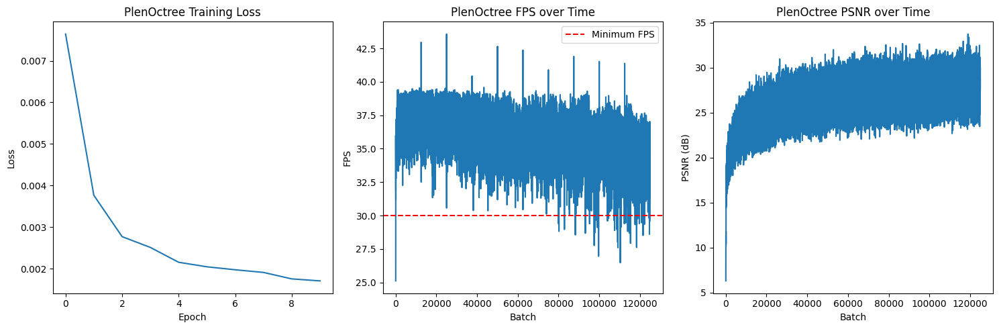

PlenOctree Training Progress: 100%|██████████| 125000/125000 [2:05:35<00:00, 16.59it/s]


Starting testing...


Process completed


In [17]:
if __name__ == '__main__':
    # Device setup
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    # Create output directory if it doesn't exist
    import os
    output_dir = '/content/novel_views'
    os.makedirs(output_dir, exist_ok=True)

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        # Convert to torch tensors
        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        # Take 1/10th of the training dataset
        subset_size = training_dataset.size(0) // 5
        training_dataset = training_dataset[:subset_size]

        print(f"PlenOctree Original Training dataset shape: {training_data.shape}")
        print(f"PlenOctree Subset Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Model setup
        model = NerfModel_PlenOctree(hidden_dim=256).to(device)
        model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
        scheduler = torch.optim.lr_scheduler.MultiStepLR(
            model_optimizer,
            milestones=[2, 4, 8],
            gamma=0.5
        )

        # Data loader
        data_loader = DataLoader(
            training_dataset,
            batch_size=256,
            shuffle=True
        )

        print("Starting training for PlenOctree Model ...")
        train(
            model,
            model_optimizer,
            scheduler,
            data_loader,
            device=device,
            hn=2,
            hf=6,
            nb_epochs=10,
            nb_bins=192
        )

        print("Starting testing...")
        # Test with provided image dimensions (H=100, W=100 from the test function default)
        for idx in range(5):  # Testing first 5 images
            test(
                hn=2,
                hf=6,
                dataset=testing_dataset,
                img_index=idx,
                nb_bins=192
            )
            if idx % 10 == 0:  # Clear memory periodically
                torch.cuda.empty_cache()

    except Exception as e:
        print(f"Error occurred: {e}")
        import traceback
        print(traceback.format_exc())
    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")


# PlanOctree for Bigdataset

In [ ]:
def train(nerf_model, optimizer, scheduler, data_loader, device='cpu', hn=0, hf=1, nb_epochs=1, nb_bins=192):
   metrics = {
       'fps': [], 'latency': [], 'psnr': []
   }

   for epoch in range(nb_epochs):
       batch_start = time.time()
       for batch in tqdm(data_loader, desc=f"PlenOctree Epoch {epoch+1}/{nb_epochs}"):
           ray_origins = batch[:, :3].to(device)
           ray_directions = batch[:, 3:6].to(device)
           ground_truth_px_values = batch[:, 6:].to(device)

           regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                             hn=hn, hf=hf, nb_bins=nb_bins)

           current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
           loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

           optimizer.zero_grad()
           loss.backward()
           optimizer.step()

           batch_end = time.time()
           batch_time = batch_end - batch_start
           fps = 1.0 / batch_time

           metrics['fps'].append(fps)
           metrics['latency'].append(batch_time * 1000)
           metrics['psnr'].append(current_psnr.item())

           batch_start = time.time()

       scheduler.step()

   # Print final metrics
   avg_fps = sum(metrics['fps']) / len(metrics['fps'])
   avg_latency = sum(metrics['latency']) / len(metrics['latency'])
   avg_psnr = sum(metrics['psnr']) / len(metrics['psnr'])

   print(f"FPS: {avg_fps:.2f}, Latency: {avg_latency:.2f}ms")
   print(f"PSNR: {avg_psnr:.2f}dB")

   return metrics

if __name__ == '__main__':
   device = 'cuda' if torch.cuda.is_available() else 'cpu'
   print(f"Using device: {device}")

   try:
       # Load datasets
       training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
       testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

       training_dataset = torch.from_numpy(training_data).float()
       testing_dataset = torch.from_numpy(testing_data).float()

       print(f"Training dataset shape: {training_dataset.shape}")
       print(f"Testing dataset shape: {testing_dataset.shape}")

       # Model setup
       model = NerfModel_PlenOctree(hidden_dim=256).to(device)
       model_optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
       scheduler = torch.optim.lr_scheduler.MultiStepLR(
           model_optimizer,
           milestones=[2, 4, 8],
           gamma=0.5
       )

       data_loader = DataLoader(
           training_dataset,
           batch_size=1024,
           shuffle=True
       )

       print("Starting PlenOctree training...")
       metrics = train(
           model,
           model_optimizer,
           scheduler,
           data_loader,
           device=device,
           nb_epochs=1,
           hn=2,
           hf=6,
           nb_bins=192
       )

       # Plot performance metrics
       plt.figure(figsize=(10, 4))
       plt.subplot(121)
       plt.plot(metrics['fps'])
       plt.title('PlenOctree FPS over Time')
       plt.ylabel('FPS')

       plt.subplot(122)
       plt.plot(metrics['psnr'])
       plt.title('PlenOctree PSNR over Time')
       plt.ylabel('PSNR (dB)')

       plt.tight_layout()
       display(plt.gcf())
       plt.close()

   except Exception as e:
       print(f"Error occurred: {e}")
   finally:
       if torch.cuda.is_available():
           torch.cuda.empty_cache()
       print("Process completed")

Using device: cuda
Training dataset shape: torch.Size([16000000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting PlenOctree training...



PlenOctree Epoch 1/1:   1%|          | 136/15625 [00:32<57:36,  4.48it/s]

##INSTANT NGP

**1.Multi-Resolution Hash Encoding:**

Key Innovation: Instant NGP introduces a unique multi-resolution hash grid encoding, which maps high-dimensional input data (like 3D coordinates) to compact latent features. This approach replaces traditional dense neural networks, providing a sparse, efficient encoding that dramatically reduces training time and enables finer detail representation.
How It Works: The hash encoding assigns different resolutions to different spatial levels, capturing both coarse and fine details by balancing memory and detail fidelity. It allows the model to quickly access relevant information during training and rendering.

**2. Real-Time Training and Rendering:**

Training in Seconds: While traditional NeRFs can take hours to days to train, Instant NGP can train a NeRF scene in a matter of seconds to minutes, depending on the complexity. This speed enables nearly real-time 3D scene capture and manipulation.
Efficient Rendering Pipeline: By optimizing the rendering process with CUDA (Compute Unified Device Architecture) and highly parallelized neural network operations, Instant NGP enables real-time rendering, making it suitable for applications in AR, VR, and dynamic 3D scene visualization.
Versatile Graphics Representation:

**3.Beyond NeRFs: **

Instant NGP is flexible enough to handle not only radiance fields but also other neural graphics primitives like Signed Distance Functions (SDFs) for surfaces, volumetric data, and image neural networks for 2D textures. This makes Instant NGP applicable across various tasks in neural rendering and simulation.
Memory Efficiency: The hash grid encoding is memory-efficient, which reduces the amount of memory needed to store detailed scene representations and speeds up processing.
Scalability and Flexibility:

**4.Real-Time, Dynamic Applications:**
 Because Instant NGP doesn’t rely on large pre-trained models, it can adapt quickly to new scenes and changes, making it suitable for interactive applications, including virtual reality, augmented reality, and robotics.
Scalability to Complex Scenes: The multi-resolution encoding allows it to handle both simple and complex scenes, scaling the fidelity of detail based on resolution levels, which makes it flexible for real-world environments.

Hash table encoding using linear interpolation.Multiple grid vertices from the same resolution could map to the identical feature vectors.


In [26]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
import os

@torch.no_grad()
def test(hn, hf, dataset, img_index=0, nb_bins=192, H=200, W=200):
    # Create output directory if it doesn't exist
    output_dir = '/content/novel_views_instant'
    os.makedirs(output_dir, exist_ok=True)

    ray_origins = dataset[img_index * H * W: (img_index + 1) * H * W, :3]
    ray_directions = dataset[img_index * H * W: (img_index + 1) * H * W, 3:6]

    data = []
    for i in range(H):
        ray_origins_ = ray_origins[i * W: (i + 1) * W].to(device)
        ray_directions_ = ray_directions[i * W: (i + 1) * W].to(device)
        regenerated_px_values = render_rays(model, ray_origins_, ray_directions_, hn=hn, hf=hf, nb_bins=nb_bins)
        data.append(regenerated_px_values)

    img = torch.cat(data).data.cpu().numpy().reshape(H, W, 3)

    # Convert the image array to uint8 format
    img = (img * 255).clip(0, 255).astype(np.uint8)

    # Save using PIL
    img_pil = Image.fromarray(img)
    save_path = os.path.join(output_dir, f'img_{img_index}.png')
    img_pil.save(save_path)
    print(f"Saved image to {save_path}")

    # Optional: Display with matplotlib
    plt.figure()
    plt.imshow(img)
    plt.axis('off')
    plt.savefig(os.path.join(output_dir, f'img_matplotlib_{img_index}.png'),
                bbox_inches='tight', pad_inches=0)
    plt.close()

In [27]:

class Instant_NGP(torch.nn.Module):

    def __init__(self, T, Nl, L, device, aabb_scale, F=2):
        super(Instant_NGP, self).__init__()
        self.T = T
        self.Nl = Nl
        self.F = F
        self.L = L  # For encoding directions
        self.aabb_scale = aabb_scale
        self.lookup_tables = torch.nn.ParameterDict(
            {str(i): torch.nn.Parameter((torch.rand(
                (T, 2), device=device) * 2 - 1) * 1e-4) for i in range(len(Nl))})
        self.pi1, self.pi2, self.pi3 = 1, 2_654_435_761, 805_459_861
        self.density_MLP = nn.Sequential(nn.Linear(self.F * len(Nl), 64),
                                         nn.ReLU(), nn.Linear(64, 16)).to(device)
        self.color_MLP = nn.Sequential(nn.Linear(27 + 16, 64), nn.ReLU(),
                                       nn.Linear(64, 64), nn.ReLU(),
                                       nn.Linear(64, 3), nn.Sigmoid()).to(device)

    def positional_encoding(self, x):
        out = [x]
        for j in range(self.L):
            out.append(torch.sin(2 ** j * x))
            out.append(torch.cos(2 ** j * x))
        return torch.cat(out, dim=1)

    def forward(self, x, d):

        x /= self.aabb_scale
        mask = (x[:, 0].abs() < .5) & (x[:, 1].abs() < .5) & (x[:, 2].abs() < .5)
        x += 0.5  # x in [0, 1]^3

        color = torch.zeros((x.shape[0], 3), device=x.device)
        log_sigma = torch.zeros((x.shape[0]), device=x.device) - 100000
        features = torch.empty((x[mask].shape[0], self.F * len(self.Nl)), device=x.device)
        for i, N in enumerate(self.Nl):
            # Computing vertices, use nn.functional.grid_sample convention
            floor = torch.floor(x[mask] * N)
            ceil = torch.ceil(x[mask] * N)
            vertices = torch.zeros((x[mask].shape[0], 8, 3), dtype=torch.int64, device=x.device)
            vertices[:, 0] = floor
            vertices[:, 1] = torch.cat((ceil[:, 0, None], floor[:, 1, None], floor[:, 2, None]), dim=1)
            vertices[:, 2] = torch.cat((floor[:, 0, None], ceil[:, 1, None], floor[:, 2, None]), dim=1)
            vertices[:, 4] = torch.cat((floor[:, 0, None], floor[:, 1, None], ceil[:, 2, None]), dim=1)
            vertices[:, 6] = torch.cat((floor[:, 0, None], ceil[:, 1, None], ceil[:, 2, None]), dim=1)
            vertices[:, 5] = torch.cat((ceil[:, 0, None], floor[:, 1, None], ceil[:, 2, None]), dim=1)
            vertices[:, 3] = torch.cat((ceil[:, 0, None], ceil[:, 1, None], floor[:, 2, None]), dim=1)
            vertices[:, 7] = ceil

            # hashing
            a = vertices[:, :, 0] * self.pi1
            b = vertices[:, :, 1] * self.pi2
            c = vertices[:, :, 2] * self.pi3
            h_x = torch.remainder(torch.bitwise_xor(torch.bitwise_xor(a, b), c), self.T)

            # Lookup
            looked_up = self.lookup_tables[str(i)][h_x].transpose(-1, -2)
            volume = looked_up.reshape((looked_up.shape[0], 2, 2, 2, 2))
            features[:, i*2:(i+1)*2] = torch.nn.functional.grid_sample(
                volume,
                ((x[mask] * N - floor) - 0.5).unsqueeze(1).unsqueeze(1).unsqueeze(1),
                align_corners=True  # Specify alignment for grid sampling
                ).squeeze(-1).squeeze(-1).squeeze(-1)
            #features[:, i*2:(i+1)*2] = torch.nn.functional.grid_sample(
                #volume,
                #((x[mask] * N - floor) - 0.5).unsqueeze(1).unsqueeze(1).unsqueeze(1)
                #).squeeze(-1).squeeze(-1).squeeze(-1)

        xi = self.positional_encoding(d[mask])
        h = self.density_MLP(features)
        log_sigma[mask] = h[:, 0]
        color[mask] = self.color_MLP(torch.cat((h, xi), dim=1))
        return color, torch.exp(log_sigma)

def compute_accumulated_transmittance(alphas):
    accumulated_transmittance = torch.cumprod(alphas, 1)
    return torch.cat((torch.ones((accumulated_transmittance.shape[0], 1), device=alphas.device),
                      accumulated_transmittance[:, :-1]), dim=-1)

def render_rays(nerf_model, ray_origins, ray_directions, hn=0, hf=0.5, nb_bins=192):
    device = ray_origins.device
    t = torch.linspace(hn, hf, nb_bins, device=device).expand(ray_origins.shape[0], nb_bins)
    # Perturb sampling along each ray.
    mid = (t[:, :-1] + t[:, 1:]) / 2.
    lower = torch.cat((t[:, :1], mid), -1)
    upper = torch.cat((mid, t[:, -1:]), -1)
    u = torch.rand(t.shape, device=device)
    t = lower + (upper - lower) * u  # [batch_size, nb_bins]
    delta = torch.cat((t[:, 1:] - t[:, :-1], torch.tensor(
        [1e10], device=device).expand(ray_origins.shape[0], 1)), -1)

    # Compute the 3D points along each ray
    x = ray_origins.unsqueeze(1) + t.unsqueeze(2) * ray_directions.unsqueeze(1)
    # Expand the ray_directions tensor to match the shape of x
    ray_directions = ray_directions.expand(nb_bins, ray_directions.shape[0], 3).transpose(0, 1)
    colors, sigma = nerf_model(x.reshape(-1, 3), ray_directions.reshape(-1, 3))
    alpha = 1 - torch.exp(-sigma.reshape(x.shape[:-1]) * delta)  # [batch_size, nb_bins]
    weights = compute_accumulated_transmittance(1 - alpha).unsqueeze(2) * alpha.unsqueeze(2)
    c = (weights * colors.reshape(x.shape)).sum(dim=1)
    weight_sum = weights.sum(-1).sum(-1)  # Regularization for white background
    return c + 1 - weight_sum.unsqueeze(-1)




In [28]:

def train(nerf_model, optimizer, data_loader, device='cpu', hn=0, hf=1, nb_epochs=10,
          nb_bins=192, H=200, W=200):
    training_loss = []
    metrics = {
        'epoch': [], 'batch': [],
        'fps': [], 'latency': [],
        'frame_variation': [], 'psnr': []
    }

    total_batches = len(data_loader) * nb_epochs
    pbar = tqdm(total=total_batches, desc="InstantNGP Training Progress")

    for epoch in range(nb_epochs):
        epoch_loss = 0.0
        batch_times = []
        epoch_psnr = []
        epoch_start = time.time()

        for batch_idx, batch in enumerate(data_loader):
            batch_start = time.time()

            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                              hn=hn, hf=hf, nb_bins=nb_bins)

            current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            batch_end = time.time()
            batch_time = batch_end - batch_start
            fps = 1.0 / batch_time
            batch_times.append(batch_time * 1000)  # Convert to milliseconds
            epoch_psnr.append(current_psnr.item())
            epoch_loss += loss.item()

            # Store metrics
            metrics['epoch'].append(epoch)
            metrics['batch'].append(batch_idx)
            metrics['fps'].append(fps)
            metrics['latency'].append(batch_time * 1000)
            metrics['frame_variation'].append(np.std(batch_times))
            metrics['psnr'].append(current_psnr.item())

            if batch_idx % 10 == 0:
                print(f'\nInstantNGP Epoch {epoch+1}/{nb_epochs}, Batch {batch_idx}:')
                print(f'FPS: {fps:.2f}, Latency: {batch_time*1000:.2f}ms')
                print(f'PSNR: {current_psnr:.2f}dB, Loss: {loss.item():.4f}')

            pbar.update(1)

        # Epoch summary
        avg_epoch_loss = epoch_loss / len(data_loader)
        avg_epoch_psnr = sum(epoch_psnr) / len(epoch_psnr)
        epoch_fps = len(data_loader) / (time.time() - epoch_start)

        training_loss.append(avg_epoch_loss)

        print(f'\nInstantNGP Epoch {epoch+1} Summary:')
        print(f'Average Loss: {avg_epoch_loss:.4f}')
        print(f'Average PSNR: {avg_epoch_psnr:.2f}dB')
        print(f'Average FPS: {epoch_fps:.2f}')

        # Plot current progress
        plt.figure(figsize=(15, 5))

        plt.subplot(131)
        plt.plot(training_loss)
        plt.title('InstantNGP Training Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')

        plt.subplot(132)
        plt.plot(metrics['fps'])
        plt.axhline(y=30, color='r', linestyle='--', label='Minimum FPS')
        plt.title('InstantNGP FPS over Time')
        plt.xlabel('Batch')
        plt.ylabel('FPS')
        plt.legend()

        plt.subplot(133)
        plt.plot(metrics['psnr'])
        plt.title('InstantNGP PSNR over Time')
        plt.xlabel('Batch')
        plt.ylabel('PSNR (dB)')

        plt.tight_layout()
        display(plt.gcf())
        plt.close()

    pbar.close()
    return training_loss, metrics

In [22]:
from PIL import Image
import os
from torch.utils.data import DataLoader
from tqdm import tqdm
import time
import gc

Using device: cuda
InstantNGP Original Training dataset shape: (16000000, 9)
InstantNGP Subset Training dataset shape: torch.Size([3200000, 9])
Testing dataset shape: torch.Size([32000000, 9])
Starting training for InstantNGP Model ...







InstantNGP Training Progress:   0%|          | 0/125000 [00:00<?, ?it/s]




InstantNGP Training Progress:   0%|          | 1/125000 [00:00<10:32:10,  3.30it/s]




InstantNGP Training Progress:   0%|          | 4/125000 [00:00<3:04:34, 11.29it/s] 


InstantNGP Epoch 1/10, Batch 0:
FPS: 26.98, Latency: 37.06ms
PSNR: 7.53dB, Loss: 0.1766







InstantNGP Training Progress:   0%|          | 7/125000 [00:00<2:06:27, 16.47it/s]




InstantNGP Training Progress:   0%|          | 10/125000 [00:00<1:43:21, 20.15it/s]




InstantNGP Training Progress:   0%|          | 13/125000 [00:00<1:32:16, 22.58it/s]




InstantNGP Training Progress:   0%|          | 17/125000 [00:00<1:21:09, 25.67it/s]


InstantNGP Epoch 1/10, Batch 10:
FPS: 37.53, Latency: 26.65ms
PSNR: 10.05dB, Loss: 0.0989







InstantNGP Training Progress:   0%|          | 21/125000 [00:00<1:15:13, 27.69it/s]




InstantNGP Training Progress:   0%|          | 25/125000 [00:01<1:12:49, 28.60it/s]


InstantNGP Epoch 1/10, Batch 20:
FPS: 33.34, Latency: 30.00ms
PSNR: 12.34dB, Loss: 0.0583







InstantNGP Training Progress:   0%|          | 29/125000 [00:01<1:10:45, 29.43it/s]




InstantNGP Training Progress:   0%|          | 33/125000 [00:01<1:09:11, 30.10it/s]




InstantNGP Training Progress:   0%|          | 37/125000 [00:01<1:09:07, 30.13it/s]


InstantNGP Epoch 1/10, Batch 30:
FPS: 33.36, Latency: 29.97ms
PSNR: 14.35dB, Loss: 0.0367







InstantNGP Training Progress:   0%|          | 41/125000 [00:01<1:09:15, 30.07it/s]




InstantNGP Training Progress:   0%|          | 45/125000 [00:01<1:07:59, 30.63it/s]


InstantNGP Epoch 1/10, Batch 40:
FPS: 38.33, Latency: 26.09ms
PSNR: 14.46dB, Loss: 0.0358







InstantNGP Training Progress:   0%|          | 49/125000 [00:01<1:08:30, 30.40it/s]




InstantNGP Training Progress:   0%|          | 53/125000 [00:02<1:09:01, 30.17it/s]




InstantNGP Training Progress:   0%|          | 57/125000 [00:02<1:07:56, 30.65it/s]


InstantNGP Epoch 1/10, Batch 50:
FPS: 32.68, Latency: 30.60ms
PSNR: 16.15dB, Loss: 0.0243







InstantNGP Training Progress:   0%|          | 61/125000 [00:02<1:07:53, 30.67it/s]




InstantNGP Training Progress:   0%|          | 65/125000 [00:02<1:09:47, 29.84it/s]


InstantNGP Epoch 1/10, Batch 60:
FPS: 37.52, Latency: 26.66ms
PSNR: 16.35dB, Loss: 0.0232







InstantNGP Training Progress:   0%|          | 69/125000 [00:02<1:08:38, 30.34it/s]




InstantNGP Training Progress:   0%|          | 73/125000 [00:02<1:07:48, 30.71it/s]




InstantNGP Training Progress:   0%|          | 77/125000 [00:02<1:06:19, 31.39it/s]


InstantNGP Epoch 1/10, Batch 70:
FPS: 38.57, Latency: 25.93ms
PSNR: 16.95dB, Loss: 0.0202







InstantNGP Training Progress:   0%|          | 81/125000 [00:02<1:05:45, 31.66it/s]




InstantNGP Training Progress:   0%|          | 85/125000 [00:03<1:05:49, 31.63it/s]


InstantNGP Epoch 1/10, Batch 80:
FPS: 39.70, Latency: 25.19ms
PSNR: 16.28dB, Loss: 0.0235







InstantNGP Training Progress:   0%|          | 89/125000 [00:03<1:06:19, 31.39it/s]




InstantNGP Training Progress:   0%|          | 93/125000 [00:03<1:07:08, 31.01it/s]




InstantNGP Training Progress:   0%|          | 97/125000 [00:03<1:06:17, 31.40it/s]


InstantNGP Epoch 1/10, Batch 90:
FPS: 34.65, Latency: 28.86ms
PSNR: 17.94dB, Loss: 0.0161







InstantNGP Training Progress:   0%|          | 101/125000 [00:03<1:06:23, 31.36it/s]




InstantNGP Training Progress:   0%|          | 105/125000 [00:03<1:06:04, 31.51it/s]


InstantNGP Epoch 1/10, Batch 100:
FPS: 39.21, Latency: 25.50ms
PSNR: 17.86dB, Loss: 0.0164







InstantNGP Training Progress:   0%|          | 109/125000 [00:03<1:04:42, 32.17it/s]




InstantNGP Training Progress:   0%|          | 113/125000 [00:03<1:03:40, 32.68it/s]




InstantNGP Training Progress:   0%|          | 117/125000 [00:04<1:04:38, 32.19it/s]


InstantNGP Epoch 1/10, Batch 110:
FPS: 39.59, Latency: 25.26ms
PSNR: 16.72dB, Loss: 0.0213







InstantNGP Training Progress:   0%|          | 121/125000 [00:04<1:05:06, 31.97it/s]




InstantNGP Training Progress:   0%|          | 125/125000 [00:04<1:06:14, 31.42it/s]


InstantNGP Epoch 1/10, Batch 120:
FPS: 34.39, Latency: 29.08ms
PSNR: 16.37dB, Loss: 0.0231







InstantNGP Training Progress:   0%|          | 129/125000 [00:04<1:06:01, 31.52it/s]




InstantNGP Training Progress:   0%|          | 133/125000 [00:04<1:06:09, 31.46it/s]




InstantNGP Training Progress:   0%|          | 137/125000 [00:04<1:05:11, 31.92it/s]


InstantNGP Epoch 1/10, Batch 130:
FPS: 37.91, Latency: 26.38ms
PSNR: 17.36dB, Loss: 0.0184







InstantNGP Training Progress:   0%|          | 141/125000 [00:04<1:04:46, 32.12it/s]




InstantNGP Training Progress:   0%|          | 145/125000 [00:04<1:05:21, 31.84it/s]


InstantNGP Epoch 1/10, Batch 140:
FPS: 38.12, Latency: 26.23ms
PSNR: 19.27dB, Loss: 0.0118







InstantNGP Training Progress:   0%|          | 149/125000 [00:05<1:05:39, 31.69it/s]




InstantNGP Training Progress:   0%|          | 153/125000 [00:05<1:04:29, 32.26it/s]




InstantNGP Training Progress:   0%|          | 157/125000 [00:05<1:05:14, 31.89it/s]


InstantNGP Epoch 1/10, Batch 150:
FPS: 40.11, Latency: 24.93ms
PSNR: 17.85dB, Loss: 0.0164







InstantNGP Training Progress:   0%|          | 161/125000 [00:05<1:05:28, 31.77it/s]




InstantNGP Training Progress:   0%|          | 165/125000 [00:05<1:05:53, 31.58it/s]


InstantNGP Epoch 1/10, Batch 160:
FPS: 38.97, Latency: 25.66ms
PSNR: 18.07dB, Loss: 0.0156







InstantNGP Training Progress:   0%|          | 169/125000 [00:05<1:07:44, 30.71it/s]




InstantNGP Training Progress:   0%|          | 173/125000 [00:05<1:08:05, 30.56it/s]


InstantNGP Epoch 1/10, Batch 170:
FPS: 37.56, Latency: 26.62ms
PSNR: 18.69dB, Loss: 0.0135







InstantNGP Training Progress:   0%|          | 177/125000 [00:05<1:10:01, 29.71it/s]




InstantNGP Training Progress:   0%|          | 180/125000 [00:06<1:10:14, 29.62it/s]




InstantNGP Training Progress:   0%|          | 184/125000 [00:06<1:09:02, 30.13it/s]


InstantNGP Epoch 1/10, Batch 180:
FPS: 39.19, Latency: 25.52ms
PSNR: 19.25dB, Loss: 0.0119







InstantNGP Training Progress:   0%|          | 188/125000 [00:06<1:09:48, 29.80it/s]




InstantNGP Training Progress:   0%|          | 191/125000 [00:06<1:12:20, 28.75it/s]




InstantNGP Training Progress:   0%|          | 195/125000 [00:06<1:11:21, 29.15it/s]


InstantNGP Epoch 1/10, Batch 190:
FPS: 32.19, Latency: 31.06ms
PSNR: 18.14dB, Loss: 0.0153







InstantNGP Training Progress:   0%|          | 198/125000 [00:06<1:11:04, 29.27it/s]




InstantNGP Training Progress:   0%|          | 201/125000 [00:06<1:10:44, 29.40it/s]




InstantNGP Training Progress:   0%|          | 205/125000 [00:06<1:09:19, 30.00it/s]


InstantNGP Epoch 1/10, Batch 200:
FPS: 32.24, Latency: 31.02ms
PSNR: 17.63dB, Loss: 0.0173







InstantNGP Training Progress:   0%|          | 208/125000 [00:07<1:09:48, 29.80it/s]




InstantNGP Training Progress:   0%|          | 211/125000 [00:07<1:11:08, 29.24it/s]




InstantNGP Training Progress:   0%|          | 215/125000 [00:07<1:10:39, 29.44it/s]


InstantNGP Epoch 1/10, Batch 210:
FPS: 29.28, Latency: 34.16ms
PSNR: 17.94dB, Loss: 0.0161







InstantNGP Training Progress:   0%|          | 218/125000 [00:07<1:12:19, 28.76it/s]




InstantNGP Training Progress:   0%|          | 222/125000 [00:07<1:10:13, 29.61it/s]




InstantNGP Training Progress:   0%|          | 225/125000 [00:07<1:11:04, 29.26it/s]


InstantNGP Epoch 1/10, Batch 220:
FPS: 36.37, Latency: 27.50ms
PSNR: 19.13dB, Loss: 0.0122







InstantNGP Training Progress:   0%|          | 229/125000 [00:07<1:08:57, 30.16it/s]




InstantNGP Training Progress:   0%|          | 233/125000 [00:07<1:07:56, 30.60it/s]




InstantNGP Training Progress:   0%|          | 237/125000 [00:08<1:07:54, 30.62it/s]



InstantNGP Training Progress:   0%|          | 337/125000 [00:23<1:26:14, 24.09it/s]


InstantNGP Epoch 1/10, Batch 230:
FPS: 34.57, Latency: 28.93ms
PSNR: 18.82dB, Loss: 0.0131







InstantNGP Training Progress:   0%|          | 241/125000 [00:08<1:07:49, 30.66it/s]




InstantNGP Training Progress:   0%|          | 245/125000 [00:08<1:07:12, 30.94it/s]


InstantNGP Epoch 1/10, Batch 240:
FPS: 38.56, Latency: 25.93ms
PSNR: 18.46dB, Loss: 0.0142







InstantNGP Training Progress:   0%|          | 249/125000 [00:08<1:06:28, 31.28it/s]




InstantNGP Training Progress:   0%|          | 253/125000 [00:08<1:06:59, 31.03it/s]




InstantNGP Training Progress:   0%|          | 257/125000 [00:08<1:05:51, 31.57it/s]


InstantNGP Epoch 1/10, Batch 250:
FPS: 38.47, Latency: 25.99ms
PSNR: 19.83dB, Loss: 0.0104







InstantNGP Training Progress:   0%|          | 261/125000 [00:08<1:06:49, 31.11it/s]




InstantNGP Training Progress:   0%|          | 265/125000 [00:08<1:06:53, 31.08it/s]


InstantNGP Epoch 1/10, Batch 260:
FPS: 38.94, Latency: 25.68ms
PSNR: 20.96dB, Loss: 0.0080







InstantNGP Training Progress:   0%|          | 269/125000 [00:09<1:06:33, 31.24it/s]




InstantNGP Training Progress:   0%|          | 273/125000 [00:09<1:06:48, 31.12it/s]




InstantNGP Training Progress:   0%|          | 277/125000 [00:09<1:04:57, 32.00it/s]


InstantNGP Epoch 1/10, Batch 270:
FPS: 30.86, Latency: 32.40ms
PSNR: 21.16dB, Loss: 0.0077







InstantNGP Training Progress:   0%|          | 281/125000 [00:09<1:05:37, 31.68it/s]




InstantNGP Training Progress:   0%|          | 285/125000 [00:09<1:05:52, 31.56it/s]


InstantNGP Epoch 1/10, Batch 280:
FPS: 36.42, Latency: 27.46ms
PSNR: 18.80dB, Loss: 0.0132







InstantNGP Training Progress:   0%|          | 289/125000 [00:09<1:05:29, 31.74it/s]




InstantNGP Training Progress:   0%|          | 293/125000 [00:09<1:06:22, 31.32it/s]


InstantNGP Epoch 1/10, Batch 290:
FPS: 31.68, Latency: 31.57ms
PSNR: 19.58dB, Loss: 0.0110







InstantNGP Training Progress:   0%|          | 297/125000 [00:09<1:08:12, 30.47it/s]




InstantNGP Training Progress:   0%|          | 301/125000 [00:10<1:07:55, 30.60it/s]




InstantNGP Training Progress:   0%|          | 305/125000 [00:10<1:06:58, 31.03it/s]


InstantNGP Epoch 1/10, Batch 300:
FPS: 37.98, Latency: 26.33ms
PSNR: 20.65dB, Loss: 0.0086







InstantNGP Training Progress:   0%|          | 309/125000 [00:10<1:06:24, 31.29it/s]




InstantNGP Training Progress:   0%|          | 313/125000 [00:10<1:05:41, 31.63it/s]




InstantNGP Training Progress:   0%|          | 317/125000 [00:10<1:05:22, 31.79it/s]


InstantNGP Epoch 1/10, Batch 310:
FPS: 38.85, Latency: 25.74ms
PSNR: 19.38dB, Loss: 0.0115







InstantNGP Training Progress:   0%|          | 321/125000 [00:10<1:06:41, 31.16it/s]




InstantNGP Training Progress:   0%|          | 325/125000 [00:10<1:06:42, 31.15it/s]


InstantNGP Epoch 1/10, Batch 320:
FPS: 34.01, Latency: 29.41ms
PSNR: 21.01dB, Loss: 0.0079







InstantNGP Training Progress:   0%|          | 329/125000 [00:10<1:05:47, 31.58it/s]




InstantNGP Training Progress:   0%|          | 333/125000 [00:11<1:06:07, 31.42it/s]




InstantNGP Training Progress:   0%|          | 337/125000 [00:11<1:04:41, 32.12it/s]


InstantNGP Epoch 1/10, Batch 330:
FPS: 37.71, Latency: 26.52ms
PSNR: 20.94dB, Loss: 0.0081







InstantNGP Training Progress:   0%|          | 341/125000 [00:11<1:05:48, 31.57it/s]




InstantNGP Training Progress:   0%|          | 345/125000 [00:11<1:06:33, 31.21it/s]


InstantNGP Epoch 1/10, Batch 340:
FPS: 39.41, Latency: 25.37ms
PSNR: 19.11dB, Loss: 0.0123







InstantNGP Training Progress:   0%|          | 349/125000 [00:11<1:06:10, 31.39it/s]




InstantNGP Training Progress:   0%|          | 353/125000 [00:11<1:04:51, 32.03it/s]




InstantNGP Training Progress:   0%|          | 357/125000 [00:11<1:05:56, 31.50it/s]


InstantNGP Epoch 1/10, Batch 350:
FPS: 37.09, Latency: 26.96ms
PSNR: 19.85dB, Loss: 0.0103







InstantNGP Training Progress:   0%|          | 361/125000 [00:11<1:06:03, 31.45it/s]




InstantNGP Training Progress:   0%|          | 365/125000 [00:12<1:04:37, 32.15it/s]


InstantNGP Epoch 1/10, Batch 360:
FPS: 32.54, Latency: 30.73ms
PSNR: 20.31dB, Loss: 0.0093







InstantNGP Training Progress:   0%|          | 369/125000 [00:12<1:05:13, 31.85it/s]




InstantNGP Training Progress:   0%|          | 373/125000 [00:12<1:05:12, 31.85it/s]




InstantNGP Training Progress:   0%|          | 377/125000 [00:12<1:04:09, 32.37it/s]


InstantNGP Epoch 1/10, Batch 370:
FPS: 38.34, Latency: 26.08ms
PSNR: 19.83dB, Loss: 0.0104







InstantNGP Training Progress:   0%|          | 381/125000 [00:12<1:05:08, 31.89it/s]




InstantNGP Training Progress:   0%|          | 385/125000 [00:12<1:05:34, 31.67it/s]


InstantNGP Epoch 1/10, Batch 380:
FPS: 33.86, Latency: 29.53ms
PSNR: 19.35dB, Loss: 0.0116







InstantNGP Training Progress:   0%|          | 389/125000 [00:12<1:04:53, 32.00it/s]




InstantNGP Training Progress:   0%|          | 393/125000 [00:12<1:05:33, 31.68it/s]




InstantNGP Training Progress:   0%|          | 397/125000 [00:13<1:05:07, 31.89it/s]


InstantNGP Epoch 1/10, Batch 390:
FPS: 35.06, Latency: 28.52ms
PSNR: 20.05dB, Loss: 0.0099







InstantNGP Training Progress:   0%|          | 401/125000 [00:13<1:05:11, 31.85it/s]




InstantNGP Training Progress:   0%|          | 405/125000 [00:13<1:05:52, 31.52it/s]


InstantNGP Epoch 1/10, Batch 400:
FPS: 31.38, Latency: 31.87ms
PSNR: 21.14dB, Loss: 0.0077







InstantNGP Training Progress:   0%|          | 409/125000 [00:13<1:06:39, 31.15it/s]




InstantNGP Training Progress:   0%|          | 413/125000 [00:13<1:07:07, 30.94it/s]




InstantNGP Training Progress:   0%|          | 417/125000 [00:13<1:05:47, 31.56it/s]


InstantNGP Epoch 1/10, Batch 410:
FPS: 34.83, Latency: 28.71ms
PSNR: 22.01dB, Loss: 0.0063







InstantNGP Training Progress:   0%|          | 421/125000 [00:13<1:06:04, 31.42it/s]




InstantNGP Training Progress:   0%|          | 425/125000 [00:13<1:05:54, 31.50it/s]


InstantNGP Epoch 1/10, Batch 420:
FPS: 39.37, Latency: 25.40ms
PSNR: 19.40dB, Loss: 0.0115







InstantNGP Training Progress:   0%|          | 429/125000 [00:14<1:05:09, 31.87it/s]




InstantNGP Training Progress:   0%|          | 433/125000 [00:14<1:06:10, 31.38it/s]




InstantNGP Training Progress:   0%|          | 437/125000 [00:14<1:06:48, 31.07it/s]


InstantNGP Epoch 1/10, Batch 430:
FPS: 34.51, Latency: 28.98ms
PSNR: 18.65dB, Loss: 0.0137







InstantNGP Training Progress:   0%|          | 441/125000 [00:14<1:06:25, 31.25it/s]




InstantNGP Training Progress:   0%|          | 445/125000 [00:14<1:06:05, 31.41it/s]


InstantNGP Epoch 1/10, Batch 440:
FPS: 39.47, Latency: 25.34ms
PSNR: 20.06dB, Loss: 0.0099







InstantNGP Training Progress:   0%|          | 449/125000 [00:14<1:05:31, 31.68it/s]




InstantNGP Training Progress:   0%|          | 453/125000 [00:14<1:05:01, 31.92it/s]




InstantNGP Training Progress:   0%|          | 457/125000 [00:14<1:04:14, 32.31it/s]


InstantNGP Epoch 1/10, Batch 450:
FPS: 39.26, Latency: 25.47ms
PSNR: 22.46dB, Loss: 0.0057







InstantNGP Training Progress:   0%|          | 461/125000 [00:15<1:04:51, 32.00it/s]




InstantNGP Training Progress:   0%|          | 465/125000 [00:15<1:03:58, 32.45it/s]


InstantNGP Epoch 1/10, Batch 460:
FPS: 33.65, Latency: 29.72ms
PSNR: 20.09dB, Loss: 0.0098







InstantNGP Training Progress:   0%|          | 469/125000 [00:15<1:03:17, 32.80it/s]




InstantNGP Training Progress:   0%|          | 473/125000 [00:15<1:03:50, 32.51it/s]




InstantNGP Training Progress:   0%|          | 477/125000 [00:15<1:03:38, 32.61it/s]


InstantNGP Epoch 1/10, Batch 470:
FPS: 39.18, Latency: 25.52ms
PSNR: 20.85dB, Loss: 0.0082







InstantNGP Training Progress:   0%|          | 481/125000 [00:15<1:04:44, 32.06it/s]




InstantNGP Training Progress:   0%|          | 485/125000 [00:15<1:04:41, 32.08it/s]


InstantNGP Epoch 1/10, Batch 480:
FPS: 39.18, Latency: 25.52ms
PSNR: 20.80dB, Loss: 0.0083







InstantNGP Training Progress:   0%|          | 489/125000 [00:15<1:06:07, 31.38it/s]




InstantNGP Training Progress:   0%|          | 493/125000 [00:16<1:05:46, 31.55it/s]




InstantNGP Training Progress:   0%|          | 497/125000 [00:16<1:05:41, 31.59it/s]


InstantNGP Epoch 1/10, Batch 490:
FPS: 34.29, Latency: 29.16ms
PSNR: 19.34dB, Loss: 0.0116







InstantNGP Training Progress:   0%|          | 501/125000 [00:16<1:05:46, 31.55it/s]




InstantNGP Training Progress:   0%|          | 505/125000 [00:16<1:07:14, 30.85it/s]


InstantNGP Epoch 1/10, Batch 500:
FPS: 31.64, Latency: 31.60ms
PSNR: 20.14dB, Loss: 0.0097







InstantNGP Training Progress:   0%|          | 509/125000 [00:16<1:07:14, 30.86it/s]




InstantNGP Training Progress:   0%|          | 513/125000 [00:16<1:07:01, 30.96it/s]




InstantNGP Training Progress:   0%|          | 517/125000 [00:16<1:05:45, 31.55it/s]


InstantNGP Epoch 1/10, Batch 510:
FPS: 38.50, Latency: 25.98ms
PSNR: 19.79dB, Loss: 0.0105







InstantNGP Training Progress:   0%|          | 521/125000 [00:17<1:05:38, 31.60it/s]




InstantNGP Training Progress:   0%|          | 525/125000 [00:17<1:05:10, 31.83it/s]


InstantNGP Epoch 1/10, Batch 520:
FPS: 38.50, Latency: 25.98ms
PSNR: 21.02dB, Loss: 0.0079







InstantNGP Training Progress:   0%|          | 529/125000 [00:17<1:05:29, 31.68it/s]




InstantNGP Training Progress:   0%|          | 533/125000 [00:17<1:05:19, 31.76it/s]




InstantNGP Training Progress:   0%|          | 537/125000 [00:17<1:06:28, 31.20it/s]


InstantNGP Epoch 1/10, Batch 530:
FPS: 37.40, Latency: 26.74ms
PSNR: 20.42dB, Loss: 0.0091







InstantNGP Training Progress:   0%|          | 541/125000 [00:17<1:07:53, 30.56it/s]




InstantNGP Training Progress:   0%|          | 545/125000 [00:17<1:07:56, 30.53it/s]


InstantNGP Epoch 1/10, Batch 540:
FPS: 25.34, Latency: 39.46ms
PSNR: 21.56dB, Loss: 0.0070







InstantNGP Training Progress:   0%|          | 549/125000 [00:17<1:07:39, 30.66it/s]




InstantNGP Training Progress:   0%|          | 553/125000 [00:18<1:07:54, 30.54it/s]




InstantNGP Training Progress:   0%|          | 557/125000 [00:18<1:09:13, 29.96it/s]


InstantNGP Epoch 1/10, Batch 550:
FPS: 30.08, Latency: 33.25ms
PSNR: 22.02dB, Loss: 0.0063







InstantNGP Training Progress:   0%|          | 561/125000 [00:18<1:09:00, 30.06it/s]




InstantNGP Training Progress:   0%|          | 565/125000 [00:18<1:09:31, 29.83it/s]


InstantNGP Epoch 1/10, Batch 560:
FPS: 35.05, Latency: 28.53ms
PSNR: 20.84dB, Loss: 0.0082







InstantNGP Training Progress:   0%|          | 568/125000 [00:18<1:09:34, 29.81it/s]




InstantNGP Training Progress:   0%|          | 571/125000 [00:18<1:10:45, 29.31it/s]




InstantNGP Training Progress:   0%|          | 575/125000 [00:18<1:08:23, 30.32it/s]


InstantNGP Epoch 1/10, Batch 570:
FPS: 37.89, Latency: 26.39ms
PSNR: 22.41dB, Loss: 0.0057







InstantNGP Training Progress:   0%|          | 579/125000 [00:18<1:08:51, 30.11it/s]




InstantNGP Training Progress:   0%|          | 583/125000 [00:19<1:10:56, 29.23it/s]







InstantNGP Epoch 1/10, Batch 580:
FPS: 29.92, Latency: 33.43ms
PSNR: 21.13dB, Loss: 0.0077


InstantNGP Training Progress:   0%|          | 587/125000 [00:19<1:10:03, 29.60it/s]




InstantNGP Training Progress:   0%|          | 590/125000 [00:19<1:11:52, 28.85it/s]




InstantNGP Training Progress:   0%|          | 593/125000 [00:19<1:14:20, 27.89it/s]




InstantNGP Training Progress:   0%|          | 596/125000 [00:19<1:13:35, 28.18it/s]


InstantNGP Epoch 1/10, Batch 590:
FPS: 31.28, Latency: 31.97ms
PSNR: 19.52dB, Loss: 0.0112







InstantNGP Training Progress:   0%|          | 599/125000 [00:19<1:13:03, 28.38it/s]




InstantNGP Training Progress:   0%|          | 602/125000 [00:19<1:12:04, 28.77it/s]




InstantNGP Training Progress:   0%|          | 606/125000 [00:19<1:09:24, 29.87it/s]


InstantNGP Epoch 1/10, Batch 600:
FPS: 37.96, Latency: 26.34ms
PSNR: 21.91dB, Loss: 0.0064







InstantNGP Training Progress:   0%|          | 609/125000 [00:19<1:09:30, 29.83it/s]




InstantNGP Training Progress:   0%|          | 613/125000 [00:20<1:07:44, 30.60it/s]




InstantNGP Training Progress:   0%|          | 617/125000 [00:20<1:07:46, 30.59it/s]


InstantNGP Epoch 1/10, Batch 610:
FPS: 38.24, Latency: 26.15ms
PSNR: 21.23dB, Loss: 0.0075







InstantNGP Training Progress:   0%|          | 621/125000 [00:20<1:08:10, 30.41it/s]




InstantNGP Training Progress:   0%|          | 625/125000 [00:20<1:08:58, 30.05it/s]


InstantNGP Epoch 1/10, Batch 620:
FPS: 37.90, Latency: 26.38ms
PSNR: 20.70dB, Loss: 0.0085







InstantNGP Training Progress:   1%|          | 629/125000 [00:20<1:07:12, 30.84it/s]




InstantNGP Training Progress:   1%|          | 633/125000 [00:20<1:06:28, 31.18it/s]




InstantNGP Training Progress:   1%|          | 637/125000 [00:20<1:06:06, 31.36it/s]


InstantNGP Epoch 1/10, Batch 630:
FPS: 33.64, Latency: 29.73ms
PSNR: 20.57dB, Loss: 0.0088







InstantNGP Training Progress:   1%|          | 641/125000 [00:20<1:06:54, 30.98it/s]




InstantNGP Training Progress:   1%|          | 645/125000 [00:21<1:06:20, 31.24it/s]


InstantNGP Epoch 1/10, Batch 640:
FPS: 36.30, Latency: 27.55ms
PSNR: 22.30dB, Loss: 0.0059







InstantNGP Training Progress:   1%|          | 649/125000 [00:21<1:06:03, 31.38it/s]




InstantNGP Training Progress:   1%|          | 653/125000 [00:21<1:05:55, 31.44it/s]




InstantNGP Training Progress:   1%|          | 657/125000 [00:21<1:05:35, 31.59it/s]


InstantNGP Epoch 1/10, Batch 650:
FPS: 39.25, Latency: 25.48ms
PSNR: 22.21dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 661/125000 [00:21<1:05:01, 31.87it/s]




InstantNGP Training Progress:   1%|          | 665/125000 [00:21<1:05:33, 31.61it/s]


InstantNGP Epoch 1/10, Batch 660:
FPS: 38.60, Latency: 25.91ms
PSNR: 21.46dB, Loss: 0.0072







InstantNGP Training Progress:   1%|          | 669/125000 [00:21<1:06:59, 30.93it/s]




InstantNGP Training Progress:   1%|          | 673/125000 [00:22<1:06:56, 30.96it/s]




InstantNGP Training Progress:   1%|          | 677/125000 [00:22<1:07:11, 30.84it/s]


InstantNGP Epoch 1/10, Batch 670:
FPS: 37.45, Latency: 26.70ms
PSNR: 20.89dB, Loss: 0.0081







InstantNGP Training Progress:   1%|          | 681/125000 [00:22<1:07:02, 30.91it/s]




InstantNGP Training Progress:   1%|          | 685/125000 [00:22<1:07:27, 30.71it/s]


InstantNGP Epoch 1/10, Batch 680:
FPS: 32.28, Latency: 30.98ms
PSNR: 20.90dB, Loss: 0.0081







InstantNGP Training Progress:   1%|          | 689/125000 [00:22<1:08:52, 30.08it/s]




InstantNGP Training Progress:   1%|          | 693/125000 [00:22<1:12:06, 28.73it/s]


InstantNGP Epoch 1/10, Batch 690:
FPS: 31.11, Latency: 32.14ms
PSNR: 22.24dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 697/125000 [00:22<1:10:22, 29.44it/s]




InstantNGP Training Progress:   1%|          | 701/125000 [00:22<1:08:33, 30.22it/s]




InstantNGP Training Progress:   1%|          | 705/125000 [00:23<1:07:04, 30.88it/s]


InstantNGP Epoch 1/10, Batch 700:
FPS: 39.66, Latency: 25.22ms
PSNR: 19.33dB, Loss: 0.0117







InstantNGP Training Progress:   1%|          | 709/125000 [00:23<1:07:24, 30.73it/s]




InstantNGP Training Progress:   1%|          | 713/125000 [00:23<1:13:38, 28.13it/s]


InstantNGP Epoch 1/10, Batch 710:
FPS: 25.15, Latency: 39.77ms
PSNR: 21.97dB, Loss: 0.0064







InstantNGP Training Progress:   1%|          | 716/125000 [00:23<1:15:51, 27.31it/s]




InstantNGP Training Progress:   1%|          | 720/125000 [00:23<1:12:25, 28.60it/s]




InstantNGP Training Progress:   1%|          | 724/125000 [00:23<1:10:18, 29.46it/s]


InstantNGP Epoch 1/10, Batch 720:
FPS: 32.53, Latency: 30.74ms
PSNR: 19.69dB, Loss: 0.0107







InstantNGP Training Progress:   1%|          | 728/125000 [00:23<1:08:22, 30.29it/s]




InstantNGP Training Progress:   1%|          | 732/125000 [00:23<1:07:28, 30.69it/s]




InstantNGP Training Progress:   1%|          | 736/125000 [00:24<1:10:58, 29.18it/s]


InstantNGP Epoch 1/10, Batch 730:
FPS: 38.39, Latency: 26.05ms
PSNR: 22.02dB, Loss: 0.0063







InstantNGP Training Progress:   1%|          | 739/125000 [00:24<1:11:56, 28.79it/s]




InstantNGP Training Progress:   1%|          | 743/125000 [00:24<1:09:56, 29.61it/s]




InstantNGP Training Progress:   1%|          | 747/125000 [00:24<1:07:46, 30.56it/s]


InstantNGP Epoch 1/10, Batch 740:
FPS: 37.79, Latency: 26.46ms
PSNR: 21.67dB, Loss: 0.0068







InstantNGP Training Progress:   1%|          | 751/125000 [00:24<1:08:22, 30.29it/s]




InstantNGP Training Progress:   1%|          | 755/125000 [00:24<1:06:50, 30.98it/s]


InstantNGP Epoch 1/10, Batch 750:
FPS: 32.62, Latency: 30.66ms
PSNR: 19.13dB, Loss: 0.0122







InstantNGP Training Progress:   1%|          | 759/125000 [00:24<1:06:51, 30.97it/s]




InstantNGP Training Progress:   1%|          | 763/125000 [00:25<1:05:03, 31.82it/s]




InstantNGP Training Progress:   1%|          | 767/125000 [00:25<1:04:46, 31.96it/s]


InstantNGP Epoch 1/10, Batch 760:
FPS: 38.84, Latency: 25.75ms
PSNR: 21.23dB, Loss: 0.0075







InstantNGP Training Progress:   1%|          | 771/125000 [00:25<1:05:28, 31.62it/s]




InstantNGP Training Progress:   1%|          | 775/125000 [00:25<1:05:20, 31.68it/s]


InstantNGP Epoch 1/10, Batch 770:
FPS: 39.19, Latency: 25.51ms
PSNR: 21.88dB, Loss: 0.0065







InstantNGP Training Progress:   1%|          | 779/125000 [00:25<1:06:25, 31.17it/s]




InstantNGP Training Progress:   1%|          | 783/125000 [00:25<1:07:01, 30.88it/s]




InstantNGP Training Progress:   1%|          | 787/125000 [00:25<1:06:44, 31.02it/s]


InstantNGP Epoch 1/10, Batch 780:
FPS: 33.32, Latency: 30.01ms
PSNR: 20.66dB, Loss: 0.0086







InstantNGP Training Progress:   1%|          | 791/125000 [00:25<1:07:28, 30.68it/s]




InstantNGP Training Progress:   1%|          | 795/125000 [00:26<1:06:01, 31.35it/s]


InstantNGP Epoch 1/10, Batch 790:
FPS: 38.35, Latency: 26.08ms
PSNR: 22.32dB, Loss: 0.0059







InstantNGP Training Progress:   1%|          | 799/125000 [00:26<1:06:41, 31.04it/s]




InstantNGP Training Progress:   1%|          | 803/125000 [00:26<1:06:31, 31.12it/s]




InstantNGP Training Progress:   1%|          | 807/125000 [00:26<1:06:59, 30.90it/s]


InstantNGP Epoch 1/10, Batch 800:
FPS: 31.42, Latency: 31.82ms
PSNR: 22.00dB, Loss: 0.0063







InstantNGP Training Progress:   1%|          | 811/125000 [00:26<1:07:47, 30.53it/s]




InstantNGP Training Progress:   1%|          | 815/125000 [00:26<1:07:01, 30.88it/s]


InstantNGP Epoch 1/10, Batch 810:
FPS: 37.04, Latency: 27.00ms
PSNR: 23.33dB, Loss: 0.0047







InstantNGP Training Progress:   1%|          | 819/125000 [00:26<1:08:25, 30.25it/s]




InstantNGP Training Progress:   1%|          | 823/125000 [00:26<1:08:51, 30.06it/s]




InstantNGP Training Progress:   1%|          | 827/125000 [00:27<1:07:48, 30.52it/s]


InstantNGP Epoch 1/10, Batch 820:
FPS: 36.77, Latency: 27.20ms
PSNR: 20.70dB, Loss: 0.0085







InstantNGP Training Progress:   1%|          | 831/125000 [00:27<1:07:42, 30.56it/s]




InstantNGP Training Progress:   1%|          | 835/125000 [00:27<1:07:27, 30.68it/s]


InstantNGP Epoch 1/10, Batch 830:
FPS: 39.14, Latency: 25.55ms
PSNR: 20.94dB, Loss: 0.0081







InstantNGP Training Progress:   1%|          | 839/125000 [00:27<1:07:23, 30.71it/s]




InstantNGP Training Progress:   1%|          | 843/125000 [00:27<1:07:28, 30.67it/s]




InstantNGP Training Progress:   1%|          | 847/125000 [00:27<1:06:21, 31.18it/s]


InstantNGP Epoch 1/10, Batch 840:
FPS: 38.54, Latency: 25.94ms
PSNR: 21.08dB, Loss: 0.0078







InstantNGP Training Progress:   1%|          | 851/125000 [00:27<1:06:49, 30.96it/s]




InstantNGP Training Progress:   1%|          | 855/125000 [00:27<1:06:22, 31.17it/s]


InstantNGP Epoch 1/10, Batch 850:
FPS: 33.61, Latency: 29.76ms
PSNR: 21.30dB, Loss: 0.0074







InstantNGP Training Progress:   1%|          | 859/125000 [00:28<1:05:33, 31.56it/s]




InstantNGP Training Progress:   1%|          | 863/125000 [00:28<1:05:04, 31.80it/s]




InstantNGP Training Progress:   1%|          | 867/125000 [00:28<1:05:05, 31.78it/s]


InstantNGP Epoch 1/10, Batch 860:
FPS: 39.41, Latency: 25.37ms
PSNR: 20.25dB, Loss: 0.0094







InstantNGP Training Progress:   1%|          | 871/125000 [00:28<1:05:27, 31.61it/s]




InstantNGP Training Progress:   1%|          | 875/125000 [00:28<1:05:14, 31.71it/s]


InstantNGP Epoch 1/10, Batch 870:
FPS: 39.17, Latency: 25.53ms
PSNR: 21.30dB, Loss: 0.0074







InstantNGP Training Progress:   1%|          | 879/125000 [00:28<1:05:59, 31.35it/s]




InstantNGP Training Progress:   1%|          | 883/125000 [00:28<1:05:24, 31.63it/s]




InstantNGP Training Progress:   1%|          | 887/125000 [00:28<1:05:23, 31.63it/s]


InstantNGP Epoch 1/10, Batch 880:
FPS: 38.90, Latency: 25.71ms
PSNR: 22.62dB, Loss: 0.0055







InstantNGP Training Progress:   1%|          | 891/125000 [00:29<1:06:00, 31.34it/s]




InstantNGP Training Progress:   1%|          | 895/125000 [00:29<1:06:33, 31.08it/s]


InstantNGP Epoch 1/10, Batch 890:
FPS: 40.32, Latency: 24.80ms
PSNR: 21.84dB, Loss: 0.0065







InstantNGP Training Progress:   1%|          | 899/125000 [00:29<1:06:58, 30.88it/s]




InstantNGP Training Progress:   1%|          | 903/125000 [00:29<1:06:30, 31.10it/s]




InstantNGP Training Progress:   1%|          | 907/125000 [00:29<1:06:33, 31.07it/s]


InstantNGP Epoch 1/10, Batch 900:
FPS: 37.67, Latency: 26.55ms
PSNR: 20.48dB, Loss: 0.0089







InstantNGP Training Progress:   1%|          | 911/125000 [00:29<1:07:56, 30.44it/s]




InstantNGP Training Progress:   1%|          | 915/125000 [00:29<1:07:41, 30.55it/s]


InstantNGP Epoch 1/10, Batch 910:
FPS: 33.54, Latency: 29.81ms
PSNR: 21.15dB, Loss: 0.0077







InstantNGP Training Progress:   1%|          | 919/125000 [00:30<1:08:34, 30.15it/s]




InstantNGP Training Progress:   1%|          | 923/125000 [00:30<1:07:37, 30.58it/s]




InstantNGP Training Progress:   1%|          | 927/125000 [00:30<1:07:29, 30.64it/s]


InstantNGP Epoch 1/10, Batch 920:
FPS: 38.03, Latency: 26.30ms
PSNR: 22.85dB, Loss: 0.0052







InstantNGP Training Progress:   1%|          | 931/125000 [00:30<1:07:51, 30.47it/s]




InstantNGP Training Progress:   1%|          | 935/125000 [00:30<1:08:11, 30.32it/s]


InstantNGP Epoch 1/10, Batch 930:
FPS: 37.61, Latency: 26.59ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:   1%|          | 939/125000 [00:30<1:08:06, 30.36it/s]




InstantNGP Training Progress:   1%|          | 943/125000 [00:30<1:10:10, 29.47it/s]




InstantNGP Training Progress:   1%|          | 947/125000 [00:30<1:09:09, 29.89it/s]


InstantNGP Epoch 1/10, Batch 940:
FPS: 33.63, Latency: 29.74ms
PSNR: 20.66dB, Loss: 0.0086







InstantNGP Training Progress:   1%|          | 951/125000 [00:31<1:09:26, 29.77it/s]




InstantNGP Training Progress:   1%|          | 955/125000 [00:31<1:09:01, 29.95it/s]


InstantNGP Epoch 1/10, Batch 950:
FPS: 30.48, Latency: 32.81ms
PSNR: 20.39dB, Loss: 0.0091







InstantNGP Training Progress:   1%|          | 958/125000 [00:31<1:09:55, 29.57it/s]




InstantNGP Training Progress:   1%|          | 961/125000 [00:31<1:12:01, 28.71it/s]




InstantNGP Training Progress:   1%|          | 964/125000 [00:31<1:13:25, 28.16it/s]


InstantNGP Epoch 1/10, Batch 960:
FPS: 37.01, Latency: 27.02ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:   1%|          | 967/125000 [00:31<1:13:01, 28.31it/s]




InstantNGP Training Progress:   1%|          | 970/125000 [00:31<1:12:53, 28.36it/s]




InstantNGP Training Progress:   1%|          | 974/125000 [00:31<1:10:56, 29.14it/s]




InstantNGP Training Progress:   1%|          | 977/125000 [00:32<1:10:34, 29.29it/s]


InstantNGP Epoch 1/10, Batch 970:
FPS: 36.01, Latency: 27.77ms
PSNR: 21.22dB, Loss: 0.0076







InstantNGP Training Progress:   1%|          | 981/125000 [00:32<1:09:13, 29.86it/s]




InstantNGP Training Progress:   1%|          | 984/125000 [00:32<1:09:35, 29.70it/s]


InstantNGP Epoch 1/10, Batch 980:
FPS: 31.49, Latency: 31.76ms
PSNR: 22.03dB, Loss: 0.0063







InstantNGP Training Progress:   1%|          | 988/125000 [00:32<1:08:29, 30.17it/s]




InstantNGP Training Progress:   1%|          | 992/125000 [00:32<1:07:37, 30.56it/s]




InstantNGP Training Progress:   1%|          | 996/125000 [00:32<1:08:01, 30.38it/s]


InstantNGP Epoch 1/10, Batch 990:
FPS: 38.47, Latency: 25.99ms
PSNR: 22.49dB, Loss: 0.0056







InstantNGP Training Progress:   1%|          | 1000/125000 [00:32<1:06:58, 30.86it/s]




InstantNGP Training Progress:   1%|          | 1004/125000 [00:32<1:05:32, 31.53it/s]


InstantNGP Epoch 1/10, Batch 1000:
FPS: 37.26, Latency: 26.84ms
PSNR: 22.42dB, Loss: 0.0057







InstantNGP Training Progress:   1%|          | 1008/125000 [00:33<1:06:44, 30.96it/s]




InstantNGP Training Progress:   1%|          | 1012/125000 [00:33<1:06:33, 31.04it/s]




InstantNGP Training Progress:   1%|          | 1016/125000 [00:33<1:06:14, 31.19it/s]


InstantNGP Epoch 1/10, Batch 1010:
FPS: 37.09, Latency: 26.96ms
PSNR: 21.35dB, Loss: 0.0073







InstantNGP Training Progress:   1%|          | 1020/125000 [00:33<1:08:04, 30.35it/s]




InstantNGP Training Progress:   1%|          | 1024/125000 [00:33<1:08:00, 30.38it/s]


InstantNGP Epoch 1/10, Batch 1020:
FPS: 36.82, Latency: 27.16ms
PSNR: 22.00dB, Loss: 0.0063







InstantNGP Training Progress:   1%|          | 1028/125000 [00:33<1:08:33, 30.14it/s]




InstantNGP Training Progress:   1%|          | 1032/125000 [00:33<1:08:12, 30.29it/s]




InstantNGP Training Progress:   1%|          | 1036/125000 [00:33<1:07:35, 30.57it/s]


InstantNGP Epoch 1/10, Batch 1030:
FPS: 32.43, Latency: 30.84ms
PSNR: 22.31dB, Loss: 0.0059







InstantNGP Training Progress:   1%|          | 1040/125000 [00:34<1:08:36, 30.11it/s]




InstantNGP Training Progress:   1%|          | 1044/125000 [00:34<1:07:05, 30.79it/s]


InstantNGP Epoch 1/10, Batch 1040:
FPS: 35.64, Latency: 28.06ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:   1%|          | 1048/125000 [00:34<1:07:27, 30.63it/s]




InstantNGP Training Progress:   1%|          | 1052/125000 [00:34<1:07:25, 30.64it/s]




InstantNGP Training Progress:   1%|          | 1056/125000 [00:34<1:06:59, 30.83it/s]


InstantNGP Epoch 1/10, Batch 1050:
FPS: 36.51, Latency: 27.39ms
PSNR: 22.20dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1060/125000 [00:34<1:07:07, 30.77it/s]




InstantNGP Training Progress:   1%|          | 1064/125000 [00:34<1:06:56, 30.86it/s]


InstantNGP Epoch 1/10, Batch 1060:
FPS: 30.25, Latency: 33.06ms
PSNR: 22.25dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1068/125000 [00:34<1:06:51, 30.89it/s]




InstantNGP Training Progress:   1%|          | 1072/125000 [00:35<1:06:12, 31.19it/s]




InstantNGP Training Progress:   1%|          | 1076/125000 [00:35<1:05:36, 31.48it/s]


InstantNGP Epoch 1/10, Batch 1070:
FPS: 39.26, Latency: 25.47ms
PSNR: 20.19dB, Loss: 0.0096







InstantNGP Training Progress:   1%|          | 1080/125000 [00:35<1:06:50, 30.90it/s]




InstantNGP Training Progress:   1%|          | 1084/125000 [00:35<1:05:53, 31.35it/s]


InstantNGP Epoch 1/10, Batch 1080:
FPS: 36.93, Latency: 27.07ms
PSNR: 22.01dB, Loss: 0.0063







InstantNGP Training Progress:   1%|          | 1088/125000 [00:35<1:06:27, 31.08it/s]




InstantNGP Training Progress:   1%|          | 1092/125000 [00:35<1:05:59, 31.30it/s]




InstantNGP Training Progress:   1%|          | 1096/125000 [00:35<1:06:04, 31.26it/s]


InstantNGP Epoch 1/10, Batch 1090:
FPS: 38.05, Latency: 26.28ms
PSNR: 21.87dB, Loss: 0.0065







InstantNGP Training Progress:   1%|          | 1100/125000 [00:35<1:05:50, 31.37it/s]




InstantNGP Training Progress:   1%|          | 1104/125000 [00:36<1:06:03, 31.26it/s]


InstantNGP Epoch 1/10, Batch 1100:
FPS: 30.87, Latency: 32.39ms
PSNR: 22.20dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1108/125000 [00:36<1:06:44, 30.94it/s]




InstantNGP Training Progress:   1%|          | 1112/125000 [00:36<1:08:19, 30.22it/s]




InstantNGP Training Progress:   1%|          | 1116/125000 [00:36<1:09:08, 29.86it/s]


InstantNGP Epoch 1/10, Batch 1110:
FPS: 33.46, Latency: 29.88ms
PSNR: 23.08dB, Loss: 0.0049







InstantNGP Training Progress:   1%|          | 1119/125000 [00:36<1:09:32, 29.69it/s]




InstantNGP Training Progress:   1%|          | 1123/125000 [00:36<1:08:02, 30.35it/s]




InstantNGP Training Progress:   1%|          | 1127/125000 [00:36<1:07:21, 30.65it/s]


InstantNGP Epoch 1/10, Batch 1120:
FPS: 33.26, Latency: 30.06ms
PSNR: 20.39dB, Loss: 0.0091







InstantNGP Training Progress:   1%|          | 1131/125000 [00:37<1:06:27, 31.06it/s]




InstantNGP Training Progress:   1%|          | 1135/125000 [00:37<1:06:25, 31.08it/s]


InstantNGP Epoch 1/10, Batch 1130:
FPS: 38.59, Latency: 25.91ms
PSNR: 22.20dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1139/125000 [00:37<1:06:28, 31.05it/s]




InstantNGP Training Progress:   1%|          | 1143/125000 [00:37<1:06:27, 31.06it/s]




InstantNGP Training Progress:   1%|          | 1147/125000 [00:37<1:06:04, 31.24it/s]


InstantNGP Epoch 1/10, Batch 1140:
FPS: 33.09, Latency: 30.22ms
PSNR: 21.40dB, Loss: 0.0072







InstantNGP Training Progress:   1%|          | 1151/125000 [00:37<1:07:20, 30.65it/s]




InstantNGP Training Progress:   1%|          | 1155/125000 [00:37<1:08:27, 30.15it/s]


InstantNGP Epoch 1/10, Batch 1150:
FPS: 31.00, Latency: 32.26ms
PSNR: 21.30dB, Loss: 0.0074







InstantNGP Training Progress:   1%|          | 1159/125000 [00:37<1:08:39, 30.06it/s]




InstantNGP Training Progress:   1%|          | 1163/125000 [00:38<1:08:04, 30.32it/s]




InstantNGP Training Progress:   1%|          | 1167/125000 [00:38<1:07:03, 30.78it/s]


InstantNGP Epoch 1/10, Batch 1160:
FPS: 38.72, Latency: 25.83ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:   1%|          | 1171/125000 [00:38<1:07:06, 30.75it/s]




InstantNGP Training Progress:   1%|          | 1175/125000 [00:38<1:07:02, 30.78it/s]


InstantNGP Epoch 1/10, Batch 1170:
FPS: 37.52, Latency: 26.65ms
PSNR: 20.70dB, Loss: 0.0085







InstantNGP Training Progress:   1%|          | 1179/125000 [00:38<1:05:57, 31.29it/s]




InstantNGP Training Progress:   1%|          | 1183/125000 [00:38<1:06:38, 30.96it/s]




InstantNGP Training Progress:   1%|          | 1187/125000 [00:38<1:05:28, 31.51it/s]


InstantNGP Epoch 1/10, Batch 1180:
FPS: 30.27, Latency: 33.03ms
PSNR: 21.00dB, Loss: 0.0079







InstantNGP Training Progress:   1%|          | 1191/125000 [00:38<1:07:47, 30.44it/s]




InstantNGP Training Progress:   1%|          | 1195/125000 [00:39<1:07:13, 30.69it/s]


InstantNGP Epoch 1/10, Batch 1190:
FPS: 32.08, Latency: 31.17ms
PSNR: 22.17dB, Loss: 0.0061







InstantNGP Training Progress:   1%|          | 1199/125000 [00:39<1:07:11, 30.71it/s]




InstantNGP Training Progress:   1%|          | 1203/125000 [00:39<1:07:04, 30.76it/s]




InstantNGP Training Progress:   1%|          | 1207/125000 [00:39<1:06:52, 30.85it/s]


InstantNGP Epoch 1/10, Batch 1200:
FPS: 38.42, Latency: 26.03ms
PSNR: 21.10dB, Loss: 0.0078







InstantNGP Training Progress:   1%|          | 1211/125000 [00:39<1:06:02, 31.24it/s]




InstantNGP Training Progress:   1%|          | 1215/125000 [00:39<1:06:38, 30.96it/s]


InstantNGP Epoch 1/10, Batch 1210:
FPS: 38.69, Latency: 25.85ms
PSNR: 21.71dB, Loss: 0.0067







InstantNGP Training Progress:   1%|          | 1219/125000 [00:39<1:06:50, 30.86it/s]




InstantNGP Training Progress:   1%|          | 1223/125000 [00:40<1:06:44, 30.91it/s]




InstantNGP Training Progress:   1%|          | 1227/125000 [00:40<1:05:40, 31.41it/s]


InstantNGP Epoch 1/10, Batch 1220:
FPS: 32.32, Latency: 30.95ms
PSNR: 21.75dB, Loss: 0.0067







InstantNGP Training Progress:   1%|          | 1231/125000 [00:40<1:07:49, 30.41it/s]




InstantNGP Training Progress:   1%|          | 1235/125000 [00:40<1:08:36, 30.07it/s]


InstantNGP Epoch 1/10, Batch 1230:
FPS: 31.29, Latency: 31.96ms
PSNR: 22.06dB, Loss: 0.0062







InstantNGP Training Progress:   1%|          | 1239/125000 [00:40<1:09:16, 29.78it/s]




InstantNGP Training Progress:   1%|          | 1243/125000 [00:40<1:08:45, 30.00it/s]




InstantNGP Training Progress:   1%|          | 1247/125000 [00:40<1:08:35, 30.07it/s]


InstantNGP Epoch 1/10, Batch 1240:
FPS: 33.51, Latency: 29.84ms
PSNR: 21.93dB, Loss: 0.0064







InstantNGP Training Progress:   1%|          | 1251/125000 [00:40<1:09:26, 29.70it/s]




InstantNGP Training Progress:   1%|          | 1254/125000 [00:41<1:10:51, 29.10it/s]


InstantNGP Epoch 1/10, Batch 1250:
FPS: 29.73, Latency: 33.64ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:   1%|          | 1257/125000 [00:41<1:11:26, 28.87it/s]




InstantNGP Training Progress:   1%|          | 1260/125000 [00:41<1:11:32, 28.83it/s]




InstantNGP Training Progress:   1%|          | 1263/125000 [00:41<1:11:25, 28.87it/s]




InstantNGP Training Progress:   1%|          | 1267/125000 [00:41<1:09:00, 29.89it/s]


InstantNGP Epoch 1/10, Batch 1260:
FPS: 29.33, Latency: 34.09ms
PSNR: 21.45dB, Loss: 0.0072







InstantNGP Training Progress:   1%|          | 1271/125000 [00:41<1:07:56, 30.35it/s]




InstantNGP Training Progress:   1%|          | 1275/125000 [00:41<1:09:27, 29.69it/s]


InstantNGP Epoch 1/10, Batch 1270:
FPS: 38.38, Latency: 26.05ms
PSNR: 22.06dB, Loss: 0.0062







InstantNGP Training Progress:   1%|          | 1278/125000 [00:41<1:10:16, 29.34it/s]




InstantNGP Training Progress:   1%|          | 1281/125000 [00:41<1:10:32, 29.23it/s]




InstantNGP Training Progress:   1%|          | 1285/125000 [00:42<1:08:56, 29.90it/s]


InstantNGP Epoch 1/10, Batch 1280:
FPS: 34.35, Latency: 29.12ms
PSNR: 22.20dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1289/125000 [00:42<1:08:03, 30.29it/s]




InstantNGP Training Progress:   1%|          | 1293/125000 [00:42<1:08:45, 29.99it/s]




InstantNGP Training Progress:   1%|          | 1296/125000 [00:42<1:11:43, 28.75it/s]


InstantNGP Epoch 1/10, Batch 1290:
FPS: 31.40, Latency: 31.84ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   1%|          | 1299/125000 [00:42<1:11:00, 29.04it/s]




InstantNGP Training Progress:   1%|          | 1302/125000 [00:42<1:10:51, 29.10it/s]




InstantNGP Training Progress:   1%|          | 1306/125000 [00:42<1:08:42, 30.00it/s]


InstantNGP Epoch 1/10, Batch 1300:
FPS: 31.99, Latency: 31.26ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:   1%|          | 1309/125000 [00:42<1:08:58, 29.88it/s]




InstantNGP Training Progress:   1%|          | 1312/125000 [00:43<1:09:28, 29.67it/s]




InstantNGP Training Progress:   1%|          | 1315/125000 [00:43<1:10:06, 29.41it/s]


InstantNGP Epoch 1/10, Batch 1310:
FPS: 32.85, Latency: 30.44ms
PSNR: 20.29dB, Loss: 0.0093







InstantNGP Training Progress:   1%|          | 1318/125000 [00:43<1:10:39, 29.17it/s]




InstantNGP Training Progress:   1%|          | 1321/125000 [00:43<1:10:49, 29.10it/s]




InstantNGP Training Progress:   1%|          | 1324/125000 [00:43<1:12:00, 28.63it/s]


InstantNGP Epoch 1/10, Batch 1320:
FPS: 36.74, Latency: 27.22ms
PSNR: 22.82dB, Loss: 0.0052







InstantNGP Training Progress:   1%|          | 1328/125000 [00:43<1:10:36, 29.19it/s]




InstantNGP Training Progress:   1%|          | 1331/125000 [00:43<1:11:21, 28.88it/s]




InstantNGP Training Progress:   1%|          | 1334/125000 [00:43<1:11:01, 29.02it/s]


InstantNGP Epoch 1/10, Batch 1330:
FPS: 31.24, Latency: 32.01ms
PSNR: 21.28dB, Loss: 0.0075







InstantNGP Training Progress:   1%|          | 1338/125000 [00:43<1:09:04, 29.84it/s]




InstantNGP Training Progress:   1%|          | 1342/125000 [00:44<1:08:51, 29.93it/s]




InstantNGP Training Progress:   1%|          | 1346/125000 [00:44<1:07:19, 30.61it/s]


InstantNGP Epoch 1/10, Batch 1340:
FPS: 32.48, Latency: 30.79ms
PSNR: 21.48dB, Loss: 0.0071







InstantNGP Training Progress:   1%|          | 1350/125000 [00:44<1:05:56, 31.26it/s]




InstantNGP Training Progress:   1%|          | 1354/125000 [00:44<1:07:29, 30.53it/s]


InstantNGP Epoch 1/10, Batch 1350:
FPS: 36.18, Latency: 27.64ms
PSNR: 21.82dB, Loss: 0.0066







InstantNGP Training Progress:   1%|          | 1358/125000 [00:44<1:07:33, 30.51it/s]




InstantNGP Training Progress:   1%|          | 1362/125000 [00:44<1:08:08, 30.24it/s]




InstantNGP Training Progress:   1%|          | 1366/125000 [00:44<1:07:06, 30.71it/s]


InstantNGP Epoch 1/10, Batch 1360:
FPS: 31.10, Latency: 32.15ms
PSNR: 22.46dB, Loss: 0.0057







InstantNGP Training Progress:   1%|          | 1370/125000 [00:44<1:07:43, 30.42it/s]




InstantNGP Training Progress:   1%|          | 1374/125000 [00:45<1:07:26, 30.55it/s]


InstantNGP Epoch 1/10, Batch 1370:
FPS: 36.56, Latency: 27.35ms
PSNR: 20.73dB, Loss: 0.0085







InstantNGP Training Progress:   1%|          | 1378/125000 [00:45<1:08:33, 30.05it/s]




InstantNGP Training Progress:   1%|          | 1382/125000 [00:45<1:08:34, 30.04it/s]




InstantNGP Training Progress:   1%|          | 1386/125000 [00:45<1:08:53, 29.90it/s]


InstantNGP Epoch 1/10, Batch 1380:
FPS: 36.57, Latency: 27.35ms
PSNR: 21.57dB, Loss: 0.0070







InstantNGP Training Progress:   1%|          | 1390/125000 [00:45<1:07:52, 30.35it/s]




InstantNGP Training Progress:   1%|          | 1394/125000 [00:45<1:08:07, 30.24it/s]


InstantNGP Epoch 1/10, Batch 1390:
FPS: 35.75, Latency: 27.97ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:   1%|          | 1398/125000 [00:45<1:07:21, 30.58it/s]




InstantNGP Training Progress:   1%|          | 1402/125000 [00:45<1:06:21, 31.05it/s]




InstantNGP Training Progress:   1%|          | 1406/125000 [00:46<1:05:47, 31.31it/s]


InstantNGP Epoch 1/10, Batch 1400:
FPS: 37.32, Latency: 26.79ms
PSNR: 23.48dB, Loss: 0.0045







InstantNGP Training Progress:   1%|          | 1410/125000 [00:46<1:06:05, 31.17it/s]




InstantNGP Training Progress:   1%|          | 1414/125000 [00:46<1:07:17, 30.61it/s]


InstantNGP Epoch 1/10, Batch 1410:
FPS: 33.23, Latency: 30.09ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:   1%|          | 1418/125000 [00:46<1:08:25, 30.10it/s]




InstantNGP Training Progress:   1%|          | 1422/125000 [00:46<1:07:32, 30.49it/s]




InstantNGP Training Progress:   1%|          | 1426/125000 [00:46<1:06:40, 30.89it/s]


InstantNGP Epoch 1/10, Batch 1420:
FPS: 38.76, Latency: 25.80ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:   1%|          | 1430/125000 [00:46<1:06:00, 31.20it/s]




InstantNGP Training Progress:   1%|          | 1434/125000 [00:47<1:06:01, 31.19it/s]


InstantNGP Epoch 1/10, Batch 1430:
FPS: 30.68, Latency: 32.59ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:   1%|          | 1438/125000 [00:47<1:07:20, 30.58it/s]




InstantNGP Training Progress:   1%|          | 1442/125000 [00:47<1:07:02, 30.71it/s]




InstantNGP Training Progress:   1%|          | 1446/125000 [00:47<1:07:53, 30.33it/s]


InstantNGP Epoch 1/10, Batch 1440:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:   1%|          | 1450/125000 [00:47<1:08:59, 29.85it/s]




InstantNGP Training Progress:   1%|          | 1453/125000 [00:47<1:09:42, 29.54it/s]




InstantNGP Training Progress:   1%|          | 1456/125000 [00:47<1:09:41, 29.55it/s]


InstantNGP Epoch 1/10, Batch 1450:
FPS: 32.24, Latency: 31.02ms
PSNR: 21.87dB, Loss: 0.0065







InstantNGP Training Progress:   1%|          | 1459/125000 [00:47<1:09:29, 29.63it/s]




InstantNGP Training Progress:   1%|          | 1462/125000 [00:47<1:09:50, 29.48it/s]




InstantNGP Training Progress:   1%|          | 1465/125000 [00:48<1:09:37, 29.57it/s]


InstantNGP Epoch 1/10, Batch 1460:
FPS: 32.61, Latency: 30.66ms
PSNR: 22.19dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1468/125000 [00:48<1:11:00, 29.00it/s]




InstantNGP Training Progress:   1%|          | 1472/125000 [00:48<1:09:03, 29.81it/s]




InstantNGP Training Progress:   1%|          | 1475/125000 [00:48<1:10:14, 29.31it/s]


InstantNGP Epoch 1/10, Batch 1470:
FPS: 38.26, Latency: 26.14ms
PSNR: 21.33dB, Loss: 0.0074







InstantNGP Training Progress:   1%|          | 1479/125000 [00:48<1:08:06, 30.22it/s]




InstantNGP Training Progress:   1%|          | 1483/125000 [00:48<1:08:53, 29.88it/s]




InstantNGP Training Progress:   1%|          | 1487/125000 [00:48<1:07:45, 30.38it/s]


InstantNGP Epoch 1/10, Batch 1480:
FPS: 37.55, Latency: 26.63ms
PSNR: 22.90dB, Loss: 0.0051







InstantNGP Training Progress:   1%|          | 1491/125000 [00:48<1:07:54, 30.32it/s]




InstantNGP Training Progress:   1%|          | 1495/125000 [00:49<1:07:49, 30.35it/s]


InstantNGP Epoch 1/10, Batch 1490:
FPS: 33.14, Latency: 30.18ms
PSNR: 22.61dB, Loss: 0.0055







InstantNGP Training Progress:   1%|          | 1499/125000 [00:49<1:06:54, 30.76it/s]




InstantNGP Training Progress:   1%|          | 1503/125000 [00:49<1:05:39, 31.35it/s]




InstantNGP Training Progress:   1%|          | 1507/125000 [00:49<1:06:12, 31.09it/s]


InstantNGP Epoch 1/10, Batch 1500:
FPS: 37.86, Latency: 26.41ms
PSNR: 21.97dB, Loss: 0.0064







InstantNGP Training Progress:   1%|          | 1511/125000 [00:49<1:06:09, 31.11it/s]




InstantNGP Training Progress:   1%|          | 1515/125000 [00:49<1:05:43, 31.31it/s]


InstantNGP Epoch 1/10, Batch 1510:
FPS: 37.99, Latency: 26.32ms
PSNR: 22.85dB, Loss: 0.0052







InstantNGP Training Progress:   1%|          | 1519/125000 [00:49<1:06:38, 30.88it/s]




InstantNGP Training Progress:   1%|          | 1523/125000 [00:49<1:06:26, 30.97it/s]




InstantNGP Training Progress:   1%|          | 1527/125000 [00:50<1:05:51, 31.24it/s]


InstantNGP Epoch 1/10, Batch 1520:
FPS: 38.10, Latency: 26.25ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:   1%|          | 1531/125000 [00:50<1:05:44, 31.30it/s]




InstantNGP Training Progress:   1%|          | 1535/125000 [00:50<1:06:18, 31.03it/s]


InstantNGP Epoch 1/10, Batch 1530:
FPS: 32.93, Latency: 30.37ms
PSNR: 21.73dB, Loss: 0.0067







InstantNGP Training Progress:   1%|          | 1539/125000 [00:50<1:07:13, 30.61it/s]




InstantNGP Training Progress:   1%|          | 1543/125000 [00:50<1:06:56, 30.74it/s]




InstantNGP Training Progress:   1%|          | 1547/125000 [00:50<1:06:20, 31.01it/s]


InstantNGP Epoch 1/10, Batch 1540:
FPS: 33.64, Latency: 29.73ms
PSNR: 22.22dB, Loss: 0.0060







InstantNGP Training Progress:   1%|          | 1551/125000 [00:50<1:07:09, 30.64it/s]




InstantNGP Training Progress:   1%|          | 1555/125000 [00:51<1:09:03, 29.79it/s]


InstantNGP Epoch 1/10, Batch 1550:
FPS: 33.17, Latency: 30.14ms
PSNR: 22.34dB, Loss: 0.0058







InstantNGP Training Progress:   1%|          | 1558/125000 [00:51<1:09:31, 29.59it/s]




InstantNGP Training Progress:   1%|          | 1561/125000 [00:51<1:10:13, 29.30it/s]




InstantNGP Training Progress:   1%|▏         | 1565/125000 [00:51<1:09:00, 29.81it/s]


InstantNGP Epoch 1/10, Batch 1560:
FPS: 31.23, Latency: 32.02ms
PSNR: 21.46dB, Loss: 0.0071







InstantNGP Training Progress:   1%|▏         | 1568/125000 [00:51<1:10:53, 29.02it/s]




InstantNGP Training Progress:   1%|▏         | 1571/125000 [00:51<1:11:45, 28.67it/s]




InstantNGP Training Progress:   1%|▏         | 1574/125000 [00:51<1:11:42, 28.69it/s]


InstantNGP Epoch 1/10, Batch 1570:
FPS: 32.23, Latency: 31.03ms
PSNR: 21.60dB, Loss: 0.0069







InstantNGP Training Progress:   1%|▏         | 1577/125000 [00:51<1:12:25, 28.40it/s]




InstantNGP Training Progress:   1%|▏         | 1581/125000 [00:51<1:09:24, 29.63it/s]




InstantNGP Training Progress:   1%|▏         | 1585/125000 [00:52<1:07:44, 30.36it/s]


InstantNGP Epoch 1/10, Batch 1580:
FPS: 36.04, Latency: 27.75ms
PSNR: 21.56dB, Loss: 0.0070







InstantNGP Training Progress:   1%|▏         | 1589/125000 [00:52<1:07:46, 30.35it/s]




InstantNGP Training Progress:   1%|▏         | 1593/125000 [00:52<1:06:51, 30.76it/s]




InstantNGP Training Progress:   1%|▏         | 1597/125000 [00:52<1:07:26, 30.49it/s]


InstantNGP Epoch 1/10, Batch 1590:
FPS: 37.19, Latency: 26.89ms
PSNR: 22.50dB, Loss: 0.0056







InstantNGP Training Progress:   1%|▏         | 1601/125000 [00:52<1:07:12, 30.60it/s]




InstantNGP Training Progress:   1%|▏         | 1605/125000 [00:52<1:07:06, 30.64it/s]


InstantNGP Epoch 1/10, Batch 1600:
FPS: 37.13, Latency: 26.93ms
PSNR: 21.16dB, Loss: 0.0077







InstantNGP Training Progress:   1%|▏         | 1609/125000 [00:52<1:07:28, 30.48it/s]




InstantNGP Training Progress:   1%|▏         | 1613/125000 [00:52<1:06:47, 30.79it/s]




InstantNGP Training Progress:   1%|▏         | 1617/125000 [00:53<1:06:47, 30.79it/s]


InstantNGP Epoch 1/10, Batch 1610:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:   1%|▏         | 1621/125000 [00:53<1:07:45, 30.35it/s]




InstantNGP Training Progress:   1%|▏         | 1625/125000 [00:53<1:07:01, 30.68it/s]


InstantNGP Epoch 1/10, Batch 1620:
FPS: 32.22, Latency: 31.04ms
PSNR: 20.04dB, Loss: 0.0099







InstantNGP Training Progress:   1%|▏         | 1629/125000 [00:53<1:06:40, 30.84it/s]




InstantNGP Training Progress:   1%|▏         | 1633/125000 [00:53<1:07:10, 30.61it/s]


InstantNGP Epoch 1/10, Batch 1630:
FPS: 37.25, Latency: 26.85ms
PSNR: 22.80dB, Loss: 0.0052







InstantNGP Training Progress:   1%|▏         | 1637/125000 [00:53<1:07:49, 30.32it/s]




InstantNGP Training Progress:   1%|▏         | 1641/125000 [00:53<1:09:09, 29.73it/s]




InstantNGP Training Progress:   1%|▏         | 1644/125000 [00:53<1:10:15, 29.26it/s]


InstantNGP Epoch 1/10, Batch 1640:
FPS: 30.17, Latency: 33.14ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:   1%|▏         | 1647/125000 [00:54<1:11:13, 28.86it/s]




InstantNGP Training Progress:   1%|▏         | 1651/125000 [00:54<1:10:31, 29.15it/s]




InstantNGP Training Progress:   1%|▏         | 1655/125000 [00:54<1:08:13, 30.13it/s]


InstantNGP Epoch 1/10, Batch 1650:
FPS: 30.75, Latency: 32.52ms
PSNR: 22.54dB, Loss: 0.0056







InstantNGP Training Progress:   1%|▏         | 1659/125000 [00:54<1:09:26, 29.60it/s]




InstantNGP Training Progress:   1%|▏         | 1662/125000 [00:54<1:10:38, 29.10it/s]




InstantNGP Training Progress:   1%|▏         | 1665/125000 [00:54<1:11:28, 28.76it/s]


InstantNGP Epoch 1/10, Batch 1660:
FPS: 30.48, Latency: 32.81ms
PSNR: 22.42dB, Loss: 0.0057







InstantNGP Training Progress:   1%|▏         | 1668/125000 [00:54<1:11:51, 28.61it/s]




InstantNGP Training Progress:   1%|▏         | 1671/125000 [00:54<1:11:40, 28.68it/s]




InstantNGP Training Progress:   1%|▏         | 1674/125000 [00:55<1:11:38, 28.69it/s]


InstantNGP Epoch 1/10, Batch 1670:
FPS: 35.60, Latency: 28.09ms
PSNR: 22.32dB, Loss: 0.0059







InstantNGP Training Progress:   1%|▏         | 1677/125000 [00:55<1:12:42, 28.27it/s]




InstantNGP Training Progress:   1%|▏         | 1680/125000 [00:55<1:12:10, 28.48it/s]




InstantNGP Training Progress:   1%|▏         | 1683/125000 [00:55<1:13:43, 27.88it/s]




InstantNGP Training Progress:   1%|▏         | 1686/125000 [00:55<1:13:40, 27.89it/s]


InstantNGP Epoch 1/10, Batch 1680:
FPS: 29.77, Latency: 33.59ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:   1%|▏         | 1689/125000 [00:55<1:12:33, 28.32it/s]




InstantNGP Training Progress:   1%|▏         | 1692/125000 [00:55<1:11:59, 28.54it/s]




InstantNGP Training Progress:   1%|▏         | 1695/125000 [00:55<1:12:04, 28.52it/s]


InstantNGP Epoch 1/10, Batch 1690:
FPS: 31.51, Latency: 31.74ms
PSNR: 21.51dB, Loss: 0.0071







InstantNGP Training Progress:   1%|▏         | 1698/125000 [00:55<1:12:13, 28.45it/s]




InstantNGP Training Progress:   1%|▏         | 1702/125000 [00:56<1:09:19, 29.64it/s]




InstantNGP Training Progress:   1%|▏         | 1706/125000 [00:56<1:07:57, 30.24it/s]


InstantNGP Epoch 1/10, Batch 1700:
FPS: 36.07, Latency: 27.72ms
PSNR: 21.03dB, Loss: 0.0079







InstantNGP Training Progress:   1%|▏         | 1710/125000 [00:56<1:07:38, 30.38it/s]




InstantNGP Training Progress:   1%|▏         | 1714/125000 [00:56<1:08:48, 29.86it/s]


InstantNGP Epoch 1/10, Batch 1710:
FPS: 37.18, Latency: 26.90ms
PSNR: 21.78dB, Loss: 0.0066







InstantNGP Training Progress:   1%|▏         | 1717/125000 [00:56<1:10:28, 29.15it/s]




InstantNGP Training Progress:   1%|▏         | 1720/125000 [00:56<1:10:27, 29.16it/s]




InstantNGP Training Progress:   1%|▏         | 1724/125000 [00:56<1:09:34, 29.53it/s]


InstantNGP Epoch 1/10, Batch 1720:
FPS: 34.93, Latency: 28.63ms
PSNR: 22.04dB, Loss: 0.0063







InstantNGP Training Progress:   1%|▏         | 1728/125000 [00:56<1:08:04, 30.18it/s]




InstantNGP Training Progress:   1%|▏         | 1732/125000 [00:57<1:07:48, 30.30it/s]




InstantNGP Training Progress:   1%|▏         | 1736/125000 [00:57<1:05:49, 31.21it/s]


InstantNGP Epoch 1/10, Batch 1730:
FPS: 34.14, Latency: 29.29ms
PSNR: 22.96dB, Loss: 0.0051







InstantNGP Training Progress:   1%|▏         | 1740/125000 [00:57<1:06:29, 30.89it/s]




InstantNGP Training Progress:   1%|▏         | 1744/125000 [00:57<1:08:02, 30.19it/s]


InstantNGP Epoch 1/10, Batch 1740:
FPS: 32.26, Latency: 31.00ms
PSNR: 21.43dB, Loss: 0.0072







InstantNGP Training Progress:   1%|▏         | 1748/125000 [00:57<1:07:45, 30.32it/s]




InstantNGP Training Progress:   1%|▏         | 1752/125000 [00:57<1:07:50, 30.28it/s]




InstantNGP Training Progress:   1%|▏         | 1756/125000 [00:57<1:06:50, 30.73it/s]


InstantNGP Epoch 1/10, Batch 1750:
FPS: 38.06, Latency: 26.28ms
PSNR: 21.63dB, Loss: 0.0069







InstantNGP Training Progress:   1%|▏         | 1760/125000 [00:57<1:07:27, 30.45it/s]




InstantNGP Training Progress:   1%|▏         | 1764/125000 [00:58<1:06:25, 30.92it/s]


InstantNGP Epoch 1/10, Batch 1760:
FPS: 36.36, Latency: 27.51ms
PSNR: 20.87dB, Loss: 0.0082







InstantNGP Training Progress:   1%|▏         | 1768/125000 [00:58<1:06:49, 30.74it/s]




InstantNGP Training Progress:   1%|▏         | 1772/125000 [00:58<1:06:14, 31.01it/s]




InstantNGP Training Progress:   1%|▏         | 1776/125000 [00:58<1:08:33, 29.95it/s]


InstantNGP Epoch 1/10, Batch 1770:
FPS: 38.76, Latency: 25.80ms
PSNR: 22.92dB, Loss: 0.0051







InstantNGP Training Progress:   1%|▏         | 1780/125000 [00:58<1:07:10, 30.57it/s]




InstantNGP Training Progress:   1%|▏         | 1784/125000 [00:58<1:06:33, 30.85it/s]


InstantNGP Epoch 1/10, Batch 1780:
FPS: 37.90, Latency: 26.38ms
PSNR: 22.88dB, Loss: 0.0052







InstantNGP Training Progress:   1%|▏         | 1788/125000 [00:58<1:07:46, 30.30it/s]




InstantNGP Training Progress:   1%|▏         | 1792/125000 [00:58<1:07:18, 30.51it/s]




InstantNGP Training Progress:   1%|▏         | 1796/125000 [00:59<1:07:06, 30.60it/s]


InstantNGP Epoch 1/10, Batch 1790:
FPS: 38.43, Latency: 26.02ms
PSNR: 23.00dB, Loss: 0.0050







InstantNGP Training Progress:   1%|▏         | 1800/125000 [00:59<1:05:53, 31.16it/s]




InstantNGP Training Progress:   1%|▏         | 1804/125000 [00:59<1:06:32, 30.85it/s]


InstantNGP Epoch 1/10, Batch 1800:
FPS: 31.65, Latency: 31.59ms
PSNR: 22.20dB, Loss: 0.0060







InstantNGP Training Progress:   1%|▏         | 1808/125000 [00:59<1:08:08, 30.13it/s]




InstantNGP Training Progress:   1%|▏         | 1812/125000 [00:59<1:07:44, 30.31it/s]




InstantNGP Training Progress:   1%|▏         | 1816/125000 [00:59<1:06:55, 30.68it/s]


InstantNGP Epoch 1/10, Batch 1810:
FPS: 37.46, Latency: 26.69ms
PSNR: 20.91dB, Loss: 0.0081







InstantNGP Training Progress:   1%|▏         | 1820/125000 [00:59<1:05:56, 31.13it/s]




InstantNGP Training Progress:   1%|▏         | 1824/125000 [01:00<1:06:49, 30.72it/s]


InstantNGP Epoch 1/10, Batch 1820:
FPS: 30.21, Latency: 33.10ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   1%|▏         | 1828/125000 [01:00<1:06:37, 30.81it/s]




InstantNGP Training Progress:   1%|▏         | 1832/125000 [01:00<1:06:02, 31.08it/s]




InstantNGP Training Progress:   1%|▏         | 1836/125000 [01:00<1:06:38, 30.80it/s]


InstantNGP Epoch 1/10, Batch 1830:
FPS: 37.16, Latency: 26.91ms
PSNR: 22.62dB, Loss: 0.0055







InstantNGP Training Progress:   1%|▏         | 1840/125000 [01:00<1:05:31, 31.33it/s]




InstantNGP Training Progress:   1%|▏         | 1844/125000 [01:00<1:05:06, 31.52it/s]


InstantNGP Epoch 1/10, Batch 1840:
FPS: 37.01, Latency: 27.02ms
PSNR: 22.65dB, Loss: 0.0054







InstantNGP Training Progress:   1%|▏         | 1848/125000 [01:00<1:06:21, 30.93it/s]




InstantNGP Training Progress:   1%|▏         | 1852/125000 [01:00<1:06:21, 30.93it/s]




InstantNGP Training Progress:   1%|▏         | 1856/125000 [01:01<1:05:27, 31.36it/s]


InstantNGP Epoch 1/10, Batch 1850:
FPS: 34.21, Latency: 29.23ms
PSNR: 23.08dB, Loss: 0.0049







InstantNGP Training Progress:   1%|▏         | 1860/125000 [01:01<1:06:02, 31.08it/s]




InstantNGP Training Progress:   1%|▏         | 1864/125000 [01:01<1:05:19, 31.41it/s]


InstantNGP Epoch 1/10, Batch 1860:
FPS: 38.64, Latency: 25.88ms
PSNR: 22.29dB, Loss: 0.0059







InstantNGP Training Progress:   1%|▏         | 1868/125000 [01:01<1:08:13, 30.08it/s]




InstantNGP Training Progress:   1%|▏         | 1872/125000 [01:01<1:06:53, 30.68it/s]




InstantNGP Training Progress:   2%|▏         | 1876/125000 [01:01<1:07:04, 30.60it/s]


InstantNGP Epoch 1/10, Batch 1870:
FPS: 37.86, Latency: 26.41ms
PSNR: 22.65dB, Loss: 0.0054







InstantNGP Training Progress:   2%|▏         | 1880/125000 [01:01<1:07:30, 30.40it/s]




InstantNGP Training Progress:   2%|▏         | 1884/125000 [01:01<1:07:17, 30.49it/s]


InstantNGP Epoch 1/10, Batch 1880:
FPS: 30.67, Latency: 32.60ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:   2%|▏         | 1888/125000 [01:02<1:08:05, 30.13it/s]




InstantNGP Training Progress:   2%|▏         | 1892/125000 [01:02<1:07:53, 30.22it/s]




InstantNGP Training Progress:   2%|▏         | 1896/125000 [01:02<1:07:10, 30.55it/s]


InstantNGP Epoch 1/10, Batch 1890:
FPS: 39.36, Latency: 25.41ms
PSNR: 22.75dB, Loss: 0.0053







InstantNGP Training Progress:   2%|▏         | 1900/125000 [01:02<1:08:16, 30.05it/s]




InstantNGP Training Progress:   2%|▏         | 1904/125000 [01:02<1:07:39, 30.32it/s]


InstantNGP Epoch 1/10, Batch 1900:
FPS: 33.12, Latency: 30.19ms
PSNR: 22.63dB, Loss: 0.0055







InstantNGP Training Progress:   2%|▏         | 1908/125000 [01:02<1:07:59, 30.18it/s]




InstantNGP Training Progress:   2%|▏         | 1912/125000 [01:02<1:07:02, 30.60it/s]




InstantNGP Training Progress:   2%|▏         | 1916/125000 [01:02<1:06:41, 30.76it/s]


InstantNGP Epoch 1/10, Batch 1910:
FPS: 37.82, Latency: 26.44ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:   2%|▏         | 1920/125000 [01:03<1:06:45, 30.73it/s]




InstantNGP Training Progress:   2%|▏         | 1924/125000 [01:03<1:05:55, 31.12it/s]


InstantNGP Epoch 1/10, Batch 1920:
FPS: 34.93, Latency: 28.63ms
PSNR: 22.47dB, Loss: 0.0057







InstantNGP Training Progress:   2%|▏         | 1928/125000 [01:03<1:06:06, 31.02it/s]




InstantNGP Training Progress:   2%|▏         | 1932/125000 [01:03<1:06:10, 30.99it/s]




InstantNGP Training Progress:   2%|▏         | 1936/125000 [01:03<1:05:37, 31.25it/s]


InstantNGP Epoch 1/10, Batch 1930:
FPS: 37.77, Latency: 26.48ms
PSNR: 23.04dB, Loss: 0.0050







InstantNGP Training Progress:   2%|▏         | 1940/125000 [01:03<1:06:11, 30.99it/s]




InstantNGP Training Progress:   2%|▏         | 1944/125000 [01:03<1:05:53, 31.13it/s]


InstantNGP Epoch 1/10, Batch 1940:
FPS: 35.58, Latency: 28.10ms
PSNR: 21.26dB, Loss: 0.0075







InstantNGP Training Progress:   2%|▏         | 1948/125000 [01:04<1:05:50, 31.15it/s]




InstantNGP Training Progress:   2%|▏         | 1952/125000 [01:04<1:06:29, 30.84it/s]




InstantNGP Training Progress:   2%|▏         | 1956/125000 [01:04<1:05:25, 31.35it/s]


InstantNGP Epoch 1/10, Batch 1950:
FPS: 32.20, Latency: 31.05ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:   2%|▏         | 1960/125000 [01:04<1:07:42, 30.29it/s]




InstantNGP Training Progress:   2%|▏         | 1964/125000 [01:04<1:08:37, 29.88it/s]


InstantNGP Epoch 1/10, Batch 1960:
FPS: 30.10, Latency: 33.22ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:   2%|▏         | 1967/125000 [01:04<1:09:18, 29.58it/s]




InstantNGP Training Progress:   2%|▏         | 1970/125000 [01:04<1:09:21, 29.56it/s]




InstantNGP Training Progress:   2%|▏         | 1974/125000 [01:04<1:08:35, 29.89it/s]




InstantNGP Training Progress:   2%|▏         | 1977/125000 [01:04<1:08:32, 29.92it/s]


InstantNGP Epoch 1/10, Batch 1970:
FPS: 37.75, Latency: 26.49ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:   2%|▏         | 1981/125000 [01:05<1:07:06, 30.55it/s]




InstantNGP Training Progress:   2%|▏         | 1985/125000 [01:05<1:06:09, 30.99it/s]


InstantNGP Epoch 1/10, Batch 1980:
FPS: 32.93, Latency: 30.37ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:   2%|▏         | 1989/125000 [01:05<1:08:12, 30.05it/s]




InstantNGP Training Progress:   2%|▏         | 1993/125000 [01:05<1:09:21, 29.56it/s]




InstantNGP Training Progress:   2%|▏         | 1997/125000 [01:05<1:09:03, 29.68it/s]


InstantNGP Epoch 1/10, Batch 1990:
FPS: 32.38, Latency: 30.88ms
PSNR: 22.63dB, Loss: 0.0055







InstantNGP Training Progress:   2%|▏         | 2001/125000 [01:05<1:07:38, 30.30it/s]




InstantNGP Training Progress:   2%|▏         | 2005/125000 [01:05<1:08:31, 29.92it/s]


InstantNGP Epoch 1/10, Batch 2000:
FPS: 38.43, Latency: 26.02ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:   2%|▏         | 2008/125000 [01:06<1:10:53, 28.91it/s]




InstantNGP Training Progress:   2%|▏         | 2011/125000 [01:06<1:11:23, 28.71it/s]




InstantNGP Training Progress:   2%|▏         | 2014/125000 [01:06<1:12:00, 28.47it/s]


InstantNGP Epoch 1/10, Batch 2010:
FPS: 33.98, Latency: 29.43ms
PSNR: 22.04dB, Loss: 0.0062







InstantNGP Training Progress:   2%|▏         | 2018/125000 [01:06<1:09:56, 29.31it/s]




InstantNGP Training Progress:   2%|▏         | 2021/125000 [01:06<1:11:14, 28.77it/s]




InstantNGP Training Progress:   2%|▏         | 2024/125000 [01:06<1:11:52, 28.52it/s]


InstantNGP Epoch 1/10, Batch 2020:
FPS: 32.43, Latency: 30.84ms
PSNR: 21.64dB, Loss: 0.0069







InstantNGP Training Progress:   2%|▏         | 2028/125000 [01:06<1:10:48, 28.95it/s]




InstantNGP Training Progress:   2%|▏         | 2031/125000 [01:06<1:12:01, 28.45it/s]




InstantNGP Training Progress:   2%|▏         | 2034/125000 [01:06<1:11:03, 28.84it/s]


InstantNGP Epoch 1/10, Batch 2030:
FPS: 32.82, Latency: 30.47ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:   2%|▏         | 2037/125000 [01:07<1:12:54, 28.11it/s]




InstantNGP Training Progress:   2%|▏         | 2040/125000 [01:07<1:12:19, 28.33it/s]




InstantNGP Training Progress:   2%|▏         | 2043/125000 [01:07<1:11:18, 28.74it/s]




InstantNGP Training Progress:   2%|▏         | 2046/125000 [01:07<1:11:38, 28.60it/s]


InstantNGP Epoch 1/10, Batch 2040:
FPS: 34.95, Latency: 28.61ms
PSNR: 20.04dB, Loss: 0.0099







InstantNGP Training Progress:   2%|▏         | 2049/125000 [01:07<1:13:07, 28.02it/s]




InstantNGP Training Progress:   2%|▏         | 2053/125000 [01:07<1:10:40, 28.99it/s]




InstantNGP Training Progress:   2%|▏         | 2057/125000 [01:07<1:09:11, 29.61it/s]


InstantNGP Epoch 1/10, Batch 2050:
FPS: 35.56, Latency: 28.12ms
PSNR: 21.80dB, Loss: 0.0066







InstantNGP Training Progress:   2%|▏         | 2060/125000 [01:07<1:10:35, 29.03it/s]




InstantNGP Training Progress:   2%|▏         | 2064/125000 [01:07<1:08:37, 29.86it/s]


InstantNGP Epoch 1/10, Batch 2060:
FPS: 36.42, Latency: 27.46ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:   2%|▏         | 2068/125000 [01:08<1:07:47, 30.22it/s]




InstantNGP Training Progress:   2%|▏         | 2072/125000 [01:08<1:07:35, 30.31it/s]




InstantNGP Training Progress:   2%|▏         | 2076/125000 [01:08<1:07:00, 30.57it/s]


InstantNGP Epoch 1/10, Batch 2070:
FPS: 29.08, Latency: 34.39ms
PSNR: 22.90dB, Loss: 0.0051







InstantNGP Training Progress:   2%|▏         | 2080/125000 [01:08<1:07:58, 30.13it/s]




InstantNGP Training Progress:   2%|▏         | 2084/125000 [01:08<1:08:27, 29.92it/s]


InstantNGP Epoch 1/10, Batch 2080:
FPS: 29.90, Latency: 33.45ms
PSNR: 22.89dB, Loss: 0.0051







InstantNGP Training Progress:   2%|▏         | 2088/125000 [01:08<1:07:57, 30.14it/s]




InstantNGP Training Progress:   2%|▏         | 2092/125000 [01:08<1:07:03, 30.55it/s]




InstantNGP Training Progress:   2%|▏         | 2096/125000 [01:09<1:07:33, 30.32it/s]


InstantNGP Epoch 1/10, Batch 2090:
FPS: 32.03, Latency: 31.22ms
PSNR: 21.95dB, Loss: 0.0064







InstantNGP Training Progress:   2%|▏         | 2100/125000 [01:09<1:08:01, 30.11it/s]




InstantNGP Training Progress:   2%|▏         | 2104/125000 [01:09<1:07:45, 30.23it/s]


InstantNGP Epoch 1/10, Batch 2100:
FPS: 31.82, Latency: 31.43ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:   2%|▏         | 2108/125000 [01:09<1:07:30, 30.34it/s]




InstantNGP Training Progress:   2%|▏         | 2112/125000 [01:09<1:08:18, 29.99it/s]




InstantNGP Training Progress:   2%|▏         | 2116/125000 [01:09<1:09:14, 29.58it/s]


InstantNGP Epoch 1/10, Batch 2110:
FPS: 31.92, Latency: 31.32ms
PSNR: 22.81dB, Loss: 0.0052







InstantNGP Training Progress:   2%|▏         | 2119/125000 [01:09<1:09:21, 29.53it/s]




InstantNGP Training Progress:   2%|▏         | 2122/125000 [01:09<1:09:30, 29.46it/s]




InstantNGP Training Progress:   2%|▏         | 2126/125000 [01:10<1:08:07, 30.06it/s]


InstantNGP Epoch 1/10, Batch 2120:
FPS: 38.30, Latency: 26.11ms
PSNR: 22.12dB, Loss: 0.0061







InstantNGP Training Progress:   2%|▏         | 2130/125000 [01:10<1:08:03, 30.09it/s]




InstantNGP Training Progress:   2%|▏         | 2134/125000 [01:10<1:07:28, 30.35it/s]


InstantNGP Epoch 1/10, Batch 2130:
FPS: 36.44, Latency: 27.44ms
PSNR: 22.15dB, Loss: 0.0061







InstantNGP Training Progress:   2%|▏         | 2138/125000 [01:10<1:08:40, 29.82it/s]




InstantNGP Training Progress:   2%|▏         | 2142/125000 [01:10<1:08:50, 29.75it/s]




InstantNGP Training Progress:   2%|▏         | 2145/125000 [01:10<1:09:15, 29.57it/s]


InstantNGP Epoch 1/10, Batch 2140:
FPS: 37.68, Latency: 26.54ms
PSNR: 21.75dB, Loss: 0.0067







InstantNGP Training Progress:   2%|▏         | 2149/125000 [01:10<1:08:16, 29.99it/s]




InstantNGP Training Progress:   2%|▏         | 2153/125000 [01:10<1:07:47, 30.20it/s]




InstantNGP Training Progress:   2%|▏         | 2157/125000 [01:11<1:06:44, 30.68it/s]


InstantNGP Epoch 1/10, Batch 2150:
FPS: 38.13, Latency: 26.23ms
PSNR: 22.22dB, Loss: 0.0060







InstantNGP Training Progress:   2%|▏         | 2161/125000 [01:11<1:06:35, 30.74it/s]




InstantNGP Training Progress:   2%|▏         | 2165/125000 [01:11<1:05:21, 31.32it/s]


InstantNGP Epoch 1/10, Batch 2160:
FPS: 38.59, Latency: 25.91ms
PSNR: 20.83dB, Loss: 0.0083







InstantNGP Training Progress:   2%|▏         | 2169/125000 [01:11<1:06:11, 30.93it/s]




InstantNGP Training Progress:   2%|▏         | 2173/125000 [01:11<1:05:33, 31.22it/s]




InstantNGP Training Progress:   2%|▏         | 2177/125000 [01:11<1:06:14, 30.91it/s]


InstantNGP Epoch 1/10, Batch 2170:
FPS: 38.58, Latency: 25.92ms
PSNR: 20.20dB, Loss: 0.0095







InstantNGP Training Progress:   2%|▏         | 2181/125000 [01:11<1:07:23, 30.37it/s]




InstantNGP Training Progress:   2%|▏         | 2185/125000 [01:11<1:07:11, 30.46it/s]


InstantNGP Epoch 1/10, Batch 2180:
FPS: 31.15, Latency: 32.10ms
PSNR: 23.00dB, Loss: 0.0050







InstantNGP Training Progress:   2%|▏         | 2189/125000 [01:12<1:07:42, 30.23it/s]




InstantNGP Training Progress:   2%|▏         | 2193/125000 [01:12<1:07:36, 30.28it/s]







InstantNGP Epoch 1/10, Batch 2190:
FPS: 37.70, Latency: 26.52ms
PSNR: 23.76dB, Loss: 0.0042


InstantNGP Training Progress:   2%|▏         | 2197/125000 [01:12<1:08:14, 30.00it/s]




InstantNGP Training Progress:   2%|▏         | 2201/125000 [01:12<1:08:28, 29.89it/s]




InstantNGP Training Progress:   2%|▏         | 2204/125000 [01:12<1:08:44, 29.77it/s]


InstantNGP Epoch 1/10, Batch 2200:
FPS: 37.48, Latency: 26.68ms
PSNR: 21.42dB, Loss: 0.0072







InstantNGP Training Progress:   2%|▏         | 2207/125000 [01:12<1:08:46, 29.76it/s]




InstantNGP Training Progress:   2%|▏         | 2210/125000 [01:12<1:08:53, 29.71it/s]




InstantNGP Training Progress:   2%|▏         | 2214/125000 [01:12<1:06:49, 30.63it/s]


InstantNGP Epoch 1/10, Batch 2210:
FPS: 37.77, Latency: 26.47ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:   2%|▏         | 2218/125000 [01:13<1:06:05, 30.96it/s]




InstantNGP Training Progress:   2%|▏         | 2222/125000 [01:13<1:04:51, 31.55it/s]




InstantNGP Training Progress:   2%|▏         | 2226/125000 [01:13<1:05:01, 31.47it/s]


InstantNGP Epoch 1/10, Batch 2220:
FPS: 37.81, Latency: 26.45ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:   2%|▏         | 2230/125000 [01:13<1:06:54, 30.58it/s]




InstantNGP Training Progress:   2%|▏         | 2234/125000 [01:13<1:06:20, 30.84it/s]


InstantNGP Epoch 1/10, Batch 2230:
FPS: 31.40, Latency: 31.84ms
PSNR: 22.61dB, Loss: 0.0055







InstantNGP Training Progress:   2%|▏         | 2238/125000 [01:13<1:06:16, 30.87it/s]




InstantNGP Training Progress:   2%|▏         | 2242/125000 [01:13<1:07:02, 30.52it/s]




InstantNGP Training Progress:   2%|▏         | 2246/125000 [01:13<1:07:11, 30.45it/s]


InstantNGP Epoch 1/10, Batch 2240:
FPS: 37.66, Latency: 26.56ms
PSNR: 21.22dB, Loss: 0.0076







InstantNGP Training Progress:   2%|▏         | 2250/125000 [01:14<1:06:48, 30.62it/s]




InstantNGP Training Progress:   2%|▏         | 2254/125000 [01:14<1:07:17, 30.40it/s]


InstantNGP Epoch 1/10, Batch 2250:
FPS: 34.26, Latency: 29.19ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   2%|▏         | 2258/125000 [01:14<1:07:22, 30.36it/s]




InstantNGP Training Progress:   2%|▏         | 2262/125000 [01:14<1:08:37, 29.81it/s]




InstantNGP Training Progress:   2%|▏         | 2266/125000 [01:14<1:07:56, 30.11it/s]


InstantNGP Epoch 1/10, Batch 2260:
FPS: 38.33, Latency: 26.09ms
PSNR: 22.73dB, Loss: 0.0053







InstantNGP Training Progress:   2%|▏         | 2270/125000 [01:14<1:07:40, 30.22it/s]




InstantNGP Training Progress:   2%|▏         | 2274/125000 [01:14<1:07:04, 30.49it/s]


InstantNGP Epoch 1/10, Batch 2270:
FPS: 37.40, Latency: 26.74ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:   2%|▏         | 2278/125000 [01:15<1:07:20, 30.37it/s]




InstantNGP Training Progress:   2%|▏         | 2282/125000 [01:15<1:07:21, 30.37it/s]




InstantNGP Training Progress:   2%|▏         | 2286/125000 [01:15<1:07:05, 30.48it/s]


InstantNGP Epoch 1/10, Batch 2280:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.47dB, Loss: 0.0045







InstantNGP Training Progress:   2%|▏         | 2290/125000 [01:15<1:07:13, 30.43it/s]




InstantNGP Training Progress:   2%|▏         | 2294/125000 [01:15<1:05:51, 31.05it/s]


InstantNGP Epoch 1/10, Batch 2290:
FPS: 36.77, Latency: 27.20ms
PSNR: 22.37dB, Loss: 0.0058







InstantNGP Training Progress:   2%|▏         | 2298/125000 [01:15<1:07:04, 30.49it/s]




InstantNGP Training Progress:   2%|▏         | 2302/125000 [01:15<1:06:04, 30.95it/s]




InstantNGP Training Progress:   2%|▏         | 2306/125000 [01:15<1:05:31, 31.21it/s]


InstantNGP Epoch 1/10, Batch 2300:
FPS: 39.44, Latency: 25.35ms
PSNR: 22.32dB, Loss: 0.0059







InstantNGP Training Progress:   2%|▏         | 2310/125000 [01:16<1:05:00, 31.45it/s]




InstantNGP Training Progress:   2%|▏         | 2314/125000 [01:16<1:05:43, 31.11it/s]


InstantNGP Epoch 1/10, Batch 2310:
FPS: 36.46, Latency: 27.43ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:   2%|▏         | 2318/125000 [01:16<1:06:13, 30.88it/s]




InstantNGP Training Progress:   2%|▏         | 2322/125000 [01:16<1:07:19, 30.37it/s]




InstantNGP Training Progress:   2%|▏         | 2326/125000 [01:16<1:06:20, 30.82it/s]


InstantNGP Epoch 1/10, Batch 2320:
FPS: 36.43, Latency: 27.45ms
PSNR: 22.81dB, Loss: 0.0052







InstantNGP Training Progress:   2%|▏         | 2330/125000 [01:16<1:06:19, 30.82it/s]




InstantNGP Training Progress:   2%|▏         | 2334/125000 [01:16<1:05:44, 31.10it/s]


InstantNGP Epoch 1/10, Batch 2330:
FPS: 36.38, Latency: 27.49ms
PSNR: 23.56dB, Loss: 0.0044







InstantNGP Training Progress:   2%|▏         | 2338/125000 [01:16<1:06:22, 30.80it/s]




InstantNGP Training Progress:   2%|▏         | 2342/125000 [01:17<1:05:34, 31.18it/s]




InstantNGP Training Progress:   2%|▏         | 2346/125000 [01:17<1:05:46, 31.08it/s]


InstantNGP Epoch 1/10, Batch 2340:
FPS: 37.69, Latency: 26.53ms
PSNR: 23.26dB, Loss: 0.0047







InstantNGP Training Progress:   2%|▏         | 2350/125000 [01:17<1:05:03, 31.42it/s]




InstantNGP Training Progress:   2%|▏         | 2354/125000 [01:17<1:07:51, 30.12it/s]


InstantNGP Epoch 1/10, Batch 2350:
FPS: 28.77, Latency: 34.76ms
PSNR: 21.42dB, Loss: 0.0072







InstantNGP Training Progress:   2%|▏         | 2358/125000 [01:17<1:07:28, 30.30it/s]




InstantNGP Training Progress:   2%|▏         | 2362/125000 [01:17<1:07:26, 30.30it/s]




InstantNGP Training Progress:   2%|▏         | 2366/125000 [01:17<1:08:51, 29.68it/s]


InstantNGP Epoch 1/10, Batch 2360:
FPS: 32.53, Latency: 30.74ms
PSNR: 22.82dB, Loss: 0.0052







InstantNGP Training Progress:   2%|▏         | 2369/125000 [01:18<1:09:16, 29.50it/s]




InstantNGP Training Progress:   2%|▏         | 2372/125000 [01:18<1:11:40, 28.51it/s]




InstantNGP Training Progress:   2%|▏         | 2375/125000 [01:18<1:11:43, 28.49it/s]


InstantNGP Epoch 1/10, Batch 2370:
FPS: 30.45, Latency: 32.84ms
PSNR: 22.91dB, Loss: 0.0051







InstantNGP Training Progress:   2%|▏         | 2379/125000 [01:18<1:09:25, 29.44it/s]




InstantNGP Training Progress:   2%|▏         | 2382/125000 [01:18<1:11:44, 28.48it/s]




InstantNGP Training Progress:   2%|▏         | 2385/125000 [01:18<1:12:23, 28.23it/s]


InstantNGP Epoch 1/10, Batch 2380:
FPS: 30.05, Latency: 33.28ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:   2%|▏         | 2388/125000 [01:18<1:13:18, 27.88it/s]




InstantNGP Training Progress:   2%|▏         | 2391/125000 [01:18<1:13:11, 27.92it/s]




InstantNGP Training Progress:   2%|▏         | 2394/125000 [01:18<1:12:33, 28.16it/s]


InstantNGP Epoch 1/10, Batch 2390:
FPS: 31.18, Latency: 32.07ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:   2%|▏         | 2397/125000 [01:18<1:11:22, 28.63it/s]




InstantNGP Training Progress:   2%|▏         | 2400/125000 [01:19<1:10:32, 28.97it/s]




InstantNGP Training Progress:   2%|▏         | 2403/125000 [01:19<1:10:39, 28.92it/s]




InstantNGP Training Progress:   2%|▏         | 2406/125000 [01:19<1:10:33, 28.96it/s]


InstantNGP Epoch 1/10, Batch 2400:
FPS: 33.10, Latency: 30.21ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:   2%|▏         | 2409/125000 [01:19<1:11:23, 28.62it/s]




InstantNGP Training Progress:   2%|▏         | 2412/125000 [01:19<1:11:07, 28.73it/s]




InstantNGP Training Progress:   2%|▏         | 2415/125000 [01:19<1:11:54, 28.41it/s]


InstantNGP Epoch 1/10, Batch 2410:
FPS: 35.84, Latency: 27.90ms
PSNR: 22.85dB, Loss: 0.0052







InstantNGP Training Progress:   2%|▏         | 2418/125000 [01:19<1:12:31, 28.17it/s]




InstantNGP Training Progress:   2%|▏         | 2422/125000 [01:19<1:10:40, 28.90it/s]




InstantNGP Training Progress:   2%|▏         | 2425/125000 [01:19<1:11:40, 28.51it/s]


InstantNGP Epoch 1/10, Batch 2420:
FPS: 37.11, Latency: 26.94ms
PSNR: 21.81dB, Loss: 0.0066







InstantNGP Training Progress:   2%|▏         | 2428/125000 [01:20<1:11:33, 28.55it/s]




InstantNGP Training Progress:   2%|▏         | 2432/125000 [01:20<1:09:04, 29.57it/s]




InstantNGP Training Progress:   2%|▏         | 2436/125000 [01:20<1:06:50, 30.56it/s]


InstantNGP Epoch 1/10, Batch 2430:
FPS: 34.05, Latency: 29.37ms
PSNR: 23.23dB, Loss: 0.0048







InstantNGP Training Progress:   2%|▏         | 2440/125000 [01:20<1:08:25, 29.86it/s]




InstantNGP Training Progress:   2%|▏         | 2443/125000 [01:20<1:09:36, 29.35it/s]




InstantNGP Training Progress:   2%|▏         | 2446/125000 [01:20<1:09:35, 29.35it/s]


InstantNGP Epoch 1/10, Batch 2440:
FPS: 31.40, Latency: 31.85ms
PSNR: 22.78dB, Loss: 0.0053







InstantNGP Training Progress:   2%|▏         | 2450/125000 [01:20<1:08:14, 29.93it/s]




InstantNGP Training Progress:   2%|▏         | 2454/125000 [01:20<1:07:18, 30.35it/s]


InstantNGP Epoch 1/10, Batch 2450:
FPS: 36.16, Latency: 27.66ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:   2%|▏         | 2458/125000 [01:21<1:07:08, 30.42it/s]




InstantNGP Training Progress:   2%|▏         | 2462/125000 [01:21<1:08:15, 29.92it/s]




InstantNGP Training Progress:   2%|▏         | 2465/125000 [01:21<1:08:54, 29.64it/s]


InstantNGP Epoch 1/10, Batch 2460:
FPS: 35.31, Latency: 28.32ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:   2%|▏         | 2468/125000 [01:21<1:09:18, 29.47it/s]




InstantNGP Training Progress:   2%|▏         | 2472/125000 [01:21<1:07:55, 30.07it/s]




InstantNGP Training Progress:   2%|▏         | 2475/125000 [01:21<1:08:56, 29.62it/s]


InstantNGP Epoch 1/10, Batch 2470:
FPS: 38.96, Latency: 25.67ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:   2%|▏         | 2479/125000 [01:21<1:07:07, 30.42it/s]




InstantNGP Training Progress:   2%|▏         | 2483/125000 [01:21<1:08:00, 30.03it/s]




InstantNGP Training Progress:   2%|▏         | 2486/125000 [01:22<1:08:10, 29.95it/s]


InstantNGP Epoch 1/10, Batch 2480:
FPS: 31.95, Latency: 31.30ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:   2%|▏         | 2490/125000 [01:22<1:07:24, 30.29it/s]




InstantNGP Training Progress:   2%|▏         | 2494/125000 [01:22<1:06:36, 30.66it/s]


InstantNGP Epoch 1/10, Batch 2490:
FPS: 35.93, Latency: 27.83ms
PSNR: 22.48dB, Loss: 0.0057







InstantNGP Training Progress:   2%|▏         | 2498/125000 [01:22<1:07:35, 30.21it/s]




InstantNGP Training Progress:   2%|▏         | 2502/125000 [01:22<1:06:03, 30.90it/s]




InstantNGP Training Progress:   2%|▏         | 2506/125000 [01:22<1:08:00, 30.02it/s]


InstantNGP Epoch 1/10, Batch 2500:
FPS: 37.93, Latency: 26.36ms
PSNR: 21.68dB, Loss: 0.0068







InstantNGP Training Progress:   2%|▏         | 2510/125000 [01:22<1:08:16, 29.90it/s]




InstantNGP Training Progress:   2%|▏         | 2513/125000 [01:22<1:08:52, 29.64it/s]




InstantNGP Training Progress:   2%|▏         | 2517/125000 [01:23<1:08:33, 29.78it/s]


InstantNGP Epoch 1/10, Batch 2510:
FPS: 30.51, Latency: 32.77ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:   2%|▏         | 2520/125000 [01:23<1:08:39, 29.73it/s]




InstantNGP Training Progress:   2%|▏         | 2524/125000 [01:23<1:07:33, 30.21it/s]


InstantNGP Epoch 1/10, Batch 2520:
FPS: 31.52, Latency: 31.72ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:   2%|▏         | 2528/125000 [01:23<1:08:29, 29.81it/s]




InstantNGP Training Progress:   2%|▏         | 2531/125000 [01:23<1:08:53, 29.63it/s]




InstantNGP Training Progress:   2%|▏         | 2535/125000 [01:23<1:06:54, 30.51it/s]


InstantNGP Epoch 1/10, Batch 2530:
FPS: 32.75, Latency: 30.53ms
PSNR: 21.96dB, Loss: 0.0064







InstantNGP Training Progress:   2%|▏         | 2539/125000 [01:23<1:07:19, 30.32it/s]




InstantNGP Training Progress:   2%|▏         | 2543/125000 [01:23<1:07:49, 30.09it/s]




InstantNGP Training Progress:   2%|▏         | 2547/125000 [01:24<1:06:38, 30.62it/s]


InstantNGP Epoch 1/10, Batch 2540:
FPS: 33.74, Latency: 29.64ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:   2%|▏         | 2551/125000 [01:24<1:06:36, 30.64it/s]




InstantNGP Training Progress:   2%|▏         | 2555/125000 [01:24<1:07:07, 30.40it/s]


InstantNGP Epoch 1/10, Batch 2550:
FPS: 39.21, Latency: 25.50ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:   2%|▏         | 2559/125000 [01:24<1:05:54, 30.96it/s]




InstantNGP Training Progress:   2%|▏         | 2563/125000 [01:24<1:06:06, 30.87it/s]




InstantNGP Training Progress:   2%|▏         | 2567/125000 [01:24<1:07:03, 30.43it/s]


InstantNGP Epoch 1/10, Batch 2560:
FPS: 32.94, Latency: 30.36ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:   2%|▏         | 2571/125000 [01:24<1:06:38, 30.62it/s]




InstantNGP Training Progress:   2%|▏         | 2575/125000 [01:24<1:05:59, 30.92it/s]


InstantNGP Epoch 1/10, Batch 2570:
FPS: 39.30, Latency: 25.44ms
PSNR: 22.56dB, Loss: 0.0055







InstantNGP Training Progress:   2%|▏         | 2579/125000 [01:25<1:06:45, 30.56it/s]




InstantNGP Training Progress:   2%|▏         | 2583/125000 [01:25<1:06:14, 30.80it/s]




InstantNGP Training Progress:   2%|▏         | 2587/125000 [01:25<1:05:10, 31.30it/s]


InstantNGP Epoch 1/10, Batch 2580:
FPS: 39.36, Latency: 25.40ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:   2%|▏         | 2591/125000 [01:25<1:05:33, 31.12it/s]




InstantNGP Training Progress:   2%|▏         | 2595/125000 [01:25<1:06:53, 30.50it/s]


InstantNGP Epoch 1/10, Batch 2590:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:   2%|▏         | 2599/125000 [01:25<1:06:36, 30.63it/s]




InstantNGP Training Progress:   2%|▏         | 2603/125000 [01:25<1:06:12, 30.81it/s]




InstantNGP Training Progress:   2%|▏         | 2607/125000 [01:25<1:06:22, 30.73it/s]


InstantNGP Epoch 1/10, Batch 2600:
FPS: 39.44, Latency: 25.35ms
PSNR: 22.73dB, Loss: 0.0053







InstantNGP Training Progress:   2%|▏         | 2611/125000 [01:26<1:06:58, 30.46it/s]




InstantNGP Training Progress:   2%|▏         | 2615/125000 [01:26<1:06:11, 30.82it/s]


InstantNGP Epoch 1/10, Batch 2610:
FPS: 33.35, Latency: 29.99ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:   2%|▏         | 2619/125000 [01:26<1:09:45, 29.24it/s]




InstantNGP Training Progress:   2%|▏         | 2622/125000 [01:26<1:13:40, 27.68it/s]




InstantNGP Training Progress:   2%|▏         | 2625/125000 [01:26<1:12:18, 28.21it/s]


InstantNGP Epoch 1/10, Batch 2620:
FPS: 23.32, Latency: 42.89ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:   2%|▏         | 2628/125000 [01:26<1:11:10, 28.65it/s]




InstantNGP Training Progress:   2%|▏         | 2632/125000 [01:26<1:08:57, 29.58it/s]




InstantNGP Training Progress:   2%|▏         | 2636/125000 [01:26<1:07:18, 30.30it/s]


InstantNGP Epoch 1/10, Batch 2630:
FPS: 36.15, Latency: 27.66ms
PSNR: 21.74dB, Loss: 0.0067







InstantNGP Training Progress:   2%|▏         | 2640/125000 [01:27<1:05:25, 31.17it/s]




InstantNGP Training Progress:   2%|▏         | 2644/125000 [01:27<1:05:49, 30.98it/s]


InstantNGP Epoch 1/10, Batch 2640:
FPS: 36.71, Latency: 27.24ms
PSNR: 22.89dB, Loss: 0.0051







InstantNGP Training Progress:   2%|▏         | 2648/125000 [01:27<1:05:13, 31.26it/s]




InstantNGP Training Progress:   2%|▏         | 2652/125000 [01:27<1:07:28, 30.22it/s]




InstantNGP Training Progress:   2%|▏         | 2656/125000 [01:27<1:06:20, 30.73it/s]


InstantNGP Epoch 1/10, Batch 2650:
FPS: 32.09, Latency: 31.17ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:   2%|▏         | 2660/125000 [01:27<1:07:43, 30.11it/s]




InstantNGP Training Progress:   2%|▏         | 2664/125000 [01:27<1:08:08, 29.92it/s]




InstantNGP Training Progress:   2%|▏         | 2667/125000 [01:27<1:08:29, 29.77it/s]


InstantNGP Epoch 1/10, Batch 2660:
FPS: 29.23, Latency: 34.21ms
PSNR: 20.87dB, Loss: 0.0082







InstantNGP Training Progress:   2%|▏         | 2671/125000 [01:28<1:07:30, 30.20it/s]




InstantNGP Training Progress:   2%|▏         | 2675/125000 [01:28<1:07:44, 30.10it/s]


InstantNGP Epoch 1/10, Batch 2670:
FPS: 38.52, Latency: 25.96ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:   2%|▏         | 2679/125000 [01:28<1:08:20, 29.83it/s]




InstantNGP Training Progress:   2%|▏         | 2682/125000 [01:28<1:10:12, 29.04it/s]




InstantNGP Training Progress:   2%|▏         | 2686/125000 [01:28<1:08:38, 29.70it/s]


InstantNGP Epoch 1/10, Batch 2680:
FPS: 32.30, Latency: 30.96ms
PSNR: 21.56dB, Loss: 0.0070







InstantNGP Training Progress:   2%|▏         | 2690/125000 [01:28<1:07:54, 30.02it/s]




InstantNGP Training Progress:   2%|▏         | 2693/125000 [01:28<1:08:04, 29.95it/s]




InstantNGP Training Progress:   2%|▏         | 2696/125000 [01:28<1:08:11, 29.89it/s]


InstantNGP Epoch 1/10, Batch 2690:
FPS: 34.43, Latency: 29.05ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:   2%|▏         | 2700/125000 [01:29<1:07:26, 30.22it/s]




InstantNGP Training Progress:   2%|▏         | 2704/125000 [01:29<1:06:57, 30.44it/s]


InstantNGP Epoch 1/10, Batch 2700:
FPS: 31.04, Latency: 32.22ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:   2%|▏         | 2708/125000 [01:29<1:06:11, 30.79it/s]




InstantNGP Training Progress:   2%|▏         | 2712/125000 [01:29<1:07:42, 30.10it/s]




InstantNGP Training Progress:   2%|▏         | 2716/125000 [01:29<1:08:16, 29.85it/s]


InstantNGP Epoch 1/10, Batch 2710:
FPS: 34.91, Latency: 28.65ms
PSNR: 22.99dB, Loss: 0.0050







InstantNGP Training Progress:   2%|▏         | 2719/125000 [01:29<1:08:59, 29.54it/s]




InstantNGP Training Progress:   2%|▏         | 2722/125000 [01:29<1:09:50, 29.18it/s]




InstantNGP Training Progress:   2%|▏         | 2725/125000 [01:29<1:10:10, 29.04it/s]


InstantNGP Epoch 1/10, Batch 2720:
FPS: 36.35, Latency: 27.51ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:   2%|▏         | 2728/125000 [01:30<1:10:45, 28.80it/s]




InstantNGP Training Progress:   2%|▏         | 2731/125000 [01:30<1:12:15, 28.20it/s]




InstantNGP Training Progress:   2%|▏         | 2734/125000 [01:30<1:12:26, 28.13it/s]


InstantNGP Epoch 1/10, Batch 2730:
FPS: 30.71, Latency: 32.57ms
PSNR: 23.14dB, Loss: 0.0049







InstantNGP Training Progress:   2%|▏         | 2737/125000 [01:30<1:13:31, 27.71it/s]




InstantNGP Training Progress:   2%|▏         | 2740/125000 [01:30<1:12:48, 27.99it/s]




InstantNGP Training Progress:   2%|▏         | 2743/125000 [01:30<1:11:27, 28.52it/s]




InstantNGP Training Progress:   2%|▏         | 2746/125000 [01:30<1:13:15, 27.81it/s]


InstantNGP Epoch 1/10, Batch 2740:
FPS: 35.76, Latency: 27.97ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:   2%|▏         | 2749/125000 [01:30<1:15:18, 27.06it/s]




InstantNGP Training Progress:   2%|▏         | 2752/125000 [01:30<1:16:14, 26.72it/s]




InstantNGP Training Progress:   2%|▏         | 2755/125000 [01:31<1:14:04, 27.51it/s]


InstantNGP Epoch 1/10, Batch 2750:
FPS: 30.40, Latency: 32.89ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:   2%|▏         | 2758/125000 [01:31<1:13:45, 27.62it/s]




InstantNGP Training Progress:   2%|▏         | 2761/125000 [01:31<1:12:38, 28.05it/s]




InstantNGP Training Progress:   2%|▏         | 2765/125000 [01:31<1:10:14, 29.01it/s]


InstantNGP Epoch 1/10, Batch 2760:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:   2%|▏         | 2768/125000 [01:31<1:12:24, 28.14it/s]




InstantNGP Training Progress:   2%|▏         | 2771/125000 [01:31<1:11:36, 28.45it/s]




InstantNGP Training Progress:   2%|▏         | 2774/125000 [01:31<1:10:43, 28.81it/s]


InstantNGP Epoch 1/10, Batch 2770:
FPS: 37.00, Latency: 27.03ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:   2%|▏         | 2777/125000 [01:31<1:10:01, 29.09it/s]




InstantNGP Training Progress:   2%|▏         | 2780/125000 [01:31<1:13:54, 27.56it/s]




InstantNGP Training Progress:   2%|▏         | 2783/125000 [01:32<1:12:42, 28.02it/s]




InstantNGP Training Progress:   2%|▏         | 2786/125000 [01:32<1:11:48, 28.36it/s]


InstantNGP Epoch 1/10, Batch 2780:
FPS: 32.94, Latency: 30.36ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:   2%|▏         | 2790/125000 [01:32<1:09:02, 29.50it/s]




InstantNGP Training Progress:   2%|▏         | 2793/125000 [01:32<1:09:37, 29.26it/s]




InstantNGP Training Progress:   2%|▏         | 2796/125000 [01:32<1:10:03, 29.07it/s]


InstantNGP Epoch 1/10, Batch 2790:
FPS: 29.33, Latency: 34.10ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:   2%|▏         | 2800/125000 [01:32<1:09:30, 29.30it/s]




InstantNGP Training Progress:   2%|▏         | 2803/125000 [01:32<1:09:32, 29.28it/s]




InstantNGP Training Progress:   2%|▏         | 2807/125000 [01:32<1:08:49, 29.59it/s]


InstantNGP Epoch 1/10, Batch 2800:
FPS: 31.07, Latency: 32.18ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:   2%|▏         | 2810/125000 [01:32<1:09:44, 29.20it/s]




InstantNGP Training Progress:   2%|▏         | 2813/125000 [01:33<1:11:06, 28.64it/s]




InstantNGP Training Progress:   2%|▏         | 2817/125000 [01:33<1:08:45, 29.62it/s]


InstantNGP Epoch 1/10, Batch 2810:
FPS: 29.24, Latency: 34.20ms
PSNR: 22.43dB, Loss: 0.0057







InstantNGP Training Progress:   2%|▏         | 2820/125000 [01:33<1:08:50, 29.58it/s]




InstantNGP Training Progress:   2%|▏         | 2824/125000 [01:33<1:08:15, 29.83it/s]


InstantNGP Epoch 1/10, Batch 2820:
FPS: 34.72, Latency: 28.80ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:   2%|▏         | 2827/125000 [01:33<1:09:47, 29.18it/s]




InstantNGP Training Progress:   2%|▏         | 2830/125000 [01:33<1:09:31, 29.29it/s]




InstantNGP Training Progress:   2%|▏         | 2833/125000 [01:33<1:09:36, 29.25it/s]




InstantNGP Training Progress:   2%|▏         | 2837/125000 [01:33<1:08:13, 29.85it/s]


InstantNGP Epoch 1/10, Batch 2830:
FPS: 31.04, Latency: 32.22ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:   2%|▏         | 2841/125000 [01:33<1:07:59, 29.95it/s]




InstantNGP Training Progress:   2%|▏         | 2844/125000 [01:34<1:07:59, 29.94it/s]


InstantNGP Epoch 1/10, Batch 2840:
FPS: 32.12, Latency: 31.13ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:   2%|▏         | 2848/125000 [01:34<1:06:57, 30.40it/s]




InstantNGP Training Progress:   2%|▏         | 2852/125000 [01:34<1:08:31, 29.71it/s]




InstantNGP Training Progress:   2%|▏         | 2855/125000 [01:34<1:08:26, 29.74it/s]


InstantNGP Epoch 1/10, Batch 2850:
FPS: 33.06, Latency: 30.24ms
PSNR: 22.31dB, Loss: 0.0059







InstantNGP Training Progress:   2%|▏         | 2859/125000 [01:34<1:07:10, 30.31it/s]




InstantNGP Training Progress:   2%|▏         | 2863/125000 [01:34<1:06:38, 30.54it/s]




InstantNGP Training Progress:   2%|▏         | 2867/125000 [01:34<1:06:42, 30.52it/s]


InstantNGP Epoch 1/10, Batch 2860:
FPS: 34.88, Latency: 28.67ms
PSNR: 21.53dB, Loss: 0.0070







InstantNGP Training Progress:   2%|▏         | 2871/125000 [01:34<1:06:18, 30.70it/s]




InstantNGP Training Progress:   2%|▏         | 2875/125000 [01:35<1:05:58, 30.85it/s]


InstantNGP Epoch 1/10, Batch 2870:
FPS: 32.60, Latency: 30.68ms
PSNR: 23.69dB, Loss: 0.0043







InstantNGP Training Progress:   2%|▏         | 2879/125000 [01:35<1:05:53, 30.89it/s]




InstantNGP Training Progress:   2%|▏         | 2883/125000 [01:35<1:06:20, 30.68it/s]




InstantNGP Training Progress:   2%|▏         | 2887/125000 [01:35<1:06:11, 30.75it/s]


InstantNGP Epoch 1/10, Batch 2880:
FPS: 37.74, Latency: 26.50ms
PSNR: 23.08dB, Loss: 0.0049







InstantNGP Training Progress:   2%|▏         | 2891/125000 [01:35<1:05:53, 30.89it/s]




InstantNGP Training Progress:   2%|▏         | 2895/125000 [01:35<1:04:50, 31.38it/s]


InstantNGP Epoch 1/10, Batch 2890:
FPS: 38.38, Latency: 26.05ms
PSNR: 21.73dB, Loss: 0.0067







InstantNGP Training Progress:   2%|▏         | 2899/125000 [01:35<1:06:24, 30.64it/s]




InstantNGP Training Progress:   2%|▏         | 2903/125000 [01:35<1:06:10, 30.75it/s]




InstantNGP Training Progress:   2%|▏         | 2907/125000 [01:36<1:05:59, 30.83it/s]


InstantNGP Epoch 1/10, Batch 2900:
FPS: 34.73, Latency: 28.80ms
PSNR: 21.79dB, Loss: 0.0066







InstantNGP Training Progress:   2%|▏         | 2911/125000 [01:36<1:05:26, 31.09it/s]




InstantNGP Training Progress:   2%|▏         | 2915/125000 [01:36<1:05:37, 31.01it/s]


InstantNGP Epoch 1/10, Batch 2910:
FPS: 33.07, Latency: 30.24ms
PSNR: 21.90dB, Loss: 0.0065







InstantNGP Training Progress:   2%|▏         | 2919/125000 [01:36<1:06:11, 30.74it/s]




InstantNGP Training Progress:   2%|▏         | 2923/125000 [01:36<1:05:53, 30.88it/s]




InstantNGP Training Progress:   2%|▏         | 2927/125000 [01:36<1:05:25, 31.10it/s]


InstantNGP Epoch 1/10, Batch 2920:
FPS: 34.35, Latency: 29.11ms
PSNR: 23.23dB, Loss: 0.0048







InstantNGP Training Progress:   2%|▏         | 2931/125000 [01:36<1:06:38, 30.53it/s]




InstantNGP Training Progress:   2%|▏         | 2935/125000 [01:37<1:07:41, 30.05it/s]


InstantNGP Epoch 1/10, Batch 2930:
FPS: 33.68, Latency: 29.69ms
PSNR: 22.93dB, Loss: 0.0051







InstantNGP Training Progress:   2%|▏         | 2939/125000 [01:37<1:06:47, 30.46it/s]




InstantNGP Training Progress:   2%|▏         | 2943/125000 [01:37<1:05:42, 30.96it/s]







InstantNGP Epoch 1/10, Batch 2940:
FPS: 36.73, Latency: 27.22ms
PSNR: 23.27dB, Loss: 0.0047


InstantNGP Training Progress:   2%|▏         | 2947/125000 [01:37<1:07:25, 30.17it/s]




InstantNGP Training Progress:   2%|▏         | 2951/125000 [01:37<1:07:46, 30.01it/s]




InstantNGP Training Progress:   2%|▏         | 2955/125000 [01:37<1:07:11, 30.27it/s]


InstantNGP Epoch 1/10, Batch 2950:
FPS: 32.76, Latency: 30.52ms
PSNR: 21.60dB, Loss: 0.0069







InstantNGP Training Progress:   2%|▏         | 2959/125000 [01:37<1:07:29, 30.14it/s]




InstantNGP Training Progress:   2%|▏         | 2963/125000 [01:37<1:05:33, 31.03it/s]




InstantNGP Training Progress:   2%|▏         | 2967/125000 [01:38<1:05:25, 31.09it/s]


InstantNGP Epoch 1/10, Batch 2960:
FPS: 39.76, Latency: 25.15ms
PSNR: 23.20dB, Loss: 0.0048







InstantNGP Training Progress:   2%|▏         | 2971/125000 [01:38<1:05:28, 31.07it/s]




InstantNGP Training Progress:   2%|▏         | 2975/125000 [01:38<1:06:27, 30.60it/s]


InstantNGP Epoch 1/10, Batch 2970:
FPS: 38.27, Latency: 26.13ms
PSNR: 23.95dB, Loss: 0.0040







InstantNGP Training Progress:   2%|▏         | 2979/125000 [01:38<1:08:27, 29.70it/s]




InstantNGP Training Progress:   2%|▏         | 2982/125000 [01:38<1:08:27, 29.70it/s]




InstantNGP Training Progress:   2%|▏         | 2986/125000 [01:38<1:08:08, 29.84it/s]


InstantNGP Epoch 1/10, Batch 2980:
FPS: 37.94, Latency: 26.35ms
PSNR: 22.34dB, Loss: 0.0058







InstantNGP Training Progress:   2%|▏         | 2990/125000 [01:38<1:07:27, 30.15it/s]




InstantNGP Training Progress:   2%|▏         | 2994/125000 [01:38<1:07:20, 30.19it/s]


InstantNGP Epoch 1/10, Batch 2990:
FPS: 31.71, Latency: 31.54ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:   2%|▏         | 2998/125000 [01:39<1:07:30, 30.12it/s]




InstantNGP Training Progress:   2%|▏         | 3002/125000 [01:39<1:06:47, 30.44it/s]




InstantNGP Training Progress:   2%|▏         | 3006/125000 [01:39<1:06:53, 30.40it/s]


InstantNGP Epoch 1/10, Batch 3000:
FPS: 37.23, Latency: 26.86ms
PSNR: 22.75dB, Loss: 0.0053







InstantNGP Training Progress:   2%|▏         | 3010/125000 [01:39<1:07:18, 30.21it/s]




InstantNGP Training Progress:   2%|▏         | 3014/125000 [01:39<1:07:32, 30.10it/s]


InstantNGP Epoch 1/10, Batch 3010:
FPS: 30.48, Latency: 32.80ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:   2%|▏         | 3018/125000 [01:39<1:07:43, 30.02it/s]




InstantNGP Training Progress:   2%|▏         | 3022/125000 [01:39<1:07:26, 30.15it/s]




InstantNGP Training Progress:   2%|▏         | 3026/125000 [01:40<1:07:52, 29.95it/s]


InstantNGP Epoch 1/10, Batch 3020:
FPS: 32.24, Latency: 31.01ms
PSNR: 23.56dB, Loss: 0.0044







InstantNGP Training Progress:   2%|▏         | 3030/125000 [01:40<1:07:21, 30.18it/s]




InstantNGP Training Progress:   2%|▏         | 3034/125000 [01:40<1:07:30, 30.11it/s]


InstantNGP Epoch 1/10, Batch 3030:
FPS: 30.54, Latency: 32.75ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:   2%|▏         | 3038/125000 [01:40<1:07:33, 30.09it/s]




InstantNGP Training Progress:   2%|▏         | 3042/125000 [01:40<1:08:19, 29.75it/s]




InstantNGP Training Progress:   2%|▏         | 3045/125000 [01:40<1:09:03, 29.43it/s]


InstantNGP Epoch 1/10, Batch 3040:
FPS: 33.66, Latency: 29.70ms
PSNR: 23.06dB, Loss: 0.0049







InstantNGP Training Progress:   2%|▏         | 3049/125000 [01:40<1:07:14, 30.22it/s]




InstantNGP Training Progress:   2%|▏         | 3053/125000 [01:40<1:08:31, 29.66it/s]




InstantNGP Training Progress:   2%|▏         | 3056/125000 [01:41<1:08:35, 29.63it/s]


InstantNGP Epoch 1/10, Batch 3050:
FPS: 31.97, Latency: 31.28ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:   2%|▏         | 3060/125000 [01:41<1:07:02, 30.32it/s]




InstantNGP Training Progress:   2%|▏         | 3064/125000 [01:41<1:07:39, 30.03it/s]


InstantNGP Epoch 1/10, Batch 3060:
FPS: 31.07, Latency: 32.18ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:   2%|▏         | 3068/125000 [01:41<1:08:32, 29.65it/s]




InstantNGP Training Progress:   2%|▏         | 3071/125000 [01:41<1:08:39, 29.60it/s]




InstantNGP Training Progress:   2%|▏         | 3075/125000 [01:41<1:08:08, 29.82it/s]


InstantNGP Epoch 1/10, Batch 3070:
FPS: 32.64, Latency: 30.64ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:   2%|▏         | 3078/125000 [01:41<1:08:12, 29.79it/s]




InstantNGP Training Progress:   2%|▏         | 3081/125000 [01:41<1:09:04, 29.42it/s]




InstantNGP Training Progress:   2%|▏         | 3085/125000 [01:42<1:07:55, 29.92it/s]


InstantNGP Epoch 1/10, Batch 3080:
FPS: 32.86, Latency: 30.43ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:   2%|▏         | 3088/125000 [01:42<1:10:09, 28.96it/s]




InstantNGP Training Progress:   2%|▏         | 3091/125000 [01:42<1:11:56, 28.24it/s]




InstantNGP Training Progress:   2%|▏         | 3095/125000 [01:42<1:09:44, 29.13it/s]


InstantNGP Epoch 1/10, Batch 3090:
FPS: 32.08, Latency: 31.17ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:   2%|▏         | 3098/125000 [01:42<1:10:42, 28.73it/s]




InstantNGP Training Progress:   2%|▏         | 3102/125000 [01:42<1:08:31, 29.65it/s]




InstantNGP Training Progress:   2%|▏         | 3106/125000 [01:42<1:08:26, 29.69it/s]


InstantNGP Epoch 1/10, Batch 3100:
FPS: 38.11, Latency: 26.24ms
PSNR: 23.13dB, Loss: 0.0049







InstantNGP Training Progress:   2%|▏         | 3109/125000 [01:42<1:09:45, 29.12it/s]




InstantNGP Training Progress:   2%|▏         | 3112/125000 [01:42<1:11:04, 28.58it/s]




InstantNGP Training Progress:   2%|▏         | 3115/125000 [01:43<1:11:01, 28.60it/s]


InstantNGP Epoch 1/10, Batch 3110:
FPS: 35.66, Latency: 28.04ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:   2%|▏         | 3118/125000 [01:43<1:11:05, 28.57it/s]




InstantNGP Training Progress:   2%|▏         | 3121/125000 [01:43<1:14:04, 27.42it/s]




InstantNGP Training Progress:   2%|▏         | 3124/125000 [01:43<1:13:18, 27.71it/s]


InstantNGP Epoch 1/10, Batch 3120:
FPS: 25.84, Latency: 38.70ms
PSNR: 22.90dB, Loss: 0.0051







InstantNGP Training Progress:   3%|▎         | 3127/125000 [01:43<1:12:59, 27.83it/s]




InstantNGP Training Progress:   3%|▎         | 3130/125000 [01:43<1:13:56, 27.47it/s]




InstantNGP Training Progress:   3%|▎         | 3133/125000 [01:43<1:16:03, 26.70it/s]




InstantNGP Training Progress:   3%|▎         | 3136/125000 [01:43<1:16:38, 26.50it/s]


InstantNGP Epoch 1/10, Batch 3130:
FPS: 28.61, Latency: 34.96ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:   3%|▎         | 3139/125000 [01:43<1:15:44, 26.81it/s]




InstantNGP Training Progress:   3%|▎         | 3142/125000 [01:44<1:15:01, 27.07it/s]




InstantNGP Training Progress:   3%|▎         | 3145/125000 [01:44<1:16:29, 26.55it/s]


InstantNGP Epoch 1/10, Batch 3140:
FPS: 27.58, Latency: 36.26ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:   3%|▎         | 3148/125000 [01:44<1:14:04, 27.42it/s]




InstantNGP Training Progress:   3%|▎         | 3151/125000 [01:44<1:15:24, 26.93it/s]




InstantNGP Training Progress:   3%|▎         | 3154/125000 [01:44<1:15:00, 27.08it/s]


InstantNGP Epoch 1/10, Batch 3150:
FPS: 29.20, Latency: 34.24ms
PSNR: 23.21dB, Loss: 0.0048







InstantNGP Training Progress:   3%|▎         | 3158/125000 [01:44<1:11:25, 28.43it/s]




InstantNGP Training Progress:   3%|▎         | 3161/125000 [01:44<1:11:09, 28.53it/s]




InstantNGP Training Progress:   3%|▎         | 3164/125000 [01:44<1:10:50, 28.67it/s]


InstantNGP Epoch 1/10, Batch 3160:
FPS: 38.12, Latency: 26.23ms
PSNR: 22.67dB, Loss: 0.0054







InstantNGP Training Progress:   3%|▎         | 3168/125000 [01:44<1:08:52, 29.48it/s]




InstantNGP Training Progress:   3%|▎         | 3172/125000 [01:45<1:07:54, 29.90it/s]




InstantNGP Training Progress:   3%|▎         | 3176/125000 [01:45<1:07:09, 30.23it/s]


InstantNGP Epoch 1/10, Batch 3170:
FPS: 37.10, Latency: 26.95ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:   3%|▎         | 3180/125000 [01:45<1:07:43, 29.98it/s]




InstantNGP Training Progress:   3%|▎         | 3183/125000 [01:45<1:07:59, 29.86it/s]




InstantNGP Training Progress:   3%|▎         | 3186/125000 [01:45<1:09:15, 29.31it/s]


InstantNGP Epoch 1/10, Batch 3180:
FPS: 28.71, Latency: 34.83ms
PSNR: 23.56dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 3189/125000 [01:45<1:09:06, 29.38it/s]




InstantNGP Training Progress:   3%|▎         | 3193/125000 [01:45<1:08:28, 29.65it/s]




InstantNGP Training Progress:   3%|▎         | 3197/125000 [01:45<1:06:57, 30.32it/s]


InstantNGP Epoch 1/10, Batch 3190:
FPS: 38.16, Latency: 26.20ms
PSNR: 21.86dB, Loss: 0.0065







InstantNGP Training Progress:   3%|▎         | 3201/125000 [01:46<1:06:51, 30.36it/s]




InstantNGP Training Progress:   3%|▎         | 3205/125000 [01:46<1:07:43, 29.97it/s]


InstantNGP Epoch 1/10, Batch 3200:
FPS: 38.14, Latency: 26.22ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:   3%|▎         | 3208/125000 [01:46<1:08:54, 29.46it/s]




InstantNGP Training Progress:   3%|▎         | 3211/125000 [01:46<1:10:39, 28.72it/s]




InstantNGP Training Progress:   3%|▎         | 3215/125000 [01:46<1:09:27, 29.22it/s]


InstantNGP Epoch 1/10, Batch 3210:
FPS: 35.20, Latency: 28.41ms
PSNR: 21.51dB, Loss: 0.0071







InstantNGP Training Progress:   3%|▎         | 3218/125000 [01:46<1:09:54, 29.03it/s]




InstantNGP Training Progress:   3%|▎         | 3221/125000 [01:46<1:10:57, 28.60it/s]




InstantNGP Training Progress:   3%|▎         | 3225/125000 [01:46<1:09:06, 29.37it/s]


InstantNGP Epoch 1/10, Batch 3220:
FPS: 28.90, Latency: 34.60ms
PSNR: 23.15dB, Loss: 0.0048







InstantNGP Training Progress:   3%|▎         | 3228/125000 [01:47<1:08:58, 29.42it/s]




InstantNGP Training Progress:   3%|▎         | 3231/125000 [01:47<1:09:02, 29.40it/s]




InstantNGP Training Progress:   3%|▎         | 3234/125000 [01:47<1:09:12, 29.32it/s]


InstantNGP Epoch 1/10, Batch 3230:
FPS: 38.41, Latency: 26.03ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:   3%|▎         | 3237/125000 [01:47<1:09:53, 29.04it/s]




InstantNGP Training Progress:   3%|▎         | 3240/125000 [01:47<1:09:22, 29.25it/s]




InstantNGP Training Progress:   3%|▎         | 3243/125000 [01:47<1:10:03, 28.96it/s]




InstantNGP Training Progress:   3%|▎         | 3247/125000 [01:47<1:08:47, 29.50it/s]


InstantNGP Epoch 1/10, Batch 3240:
FPS: 29.86, Latency: 33.49ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:   3%|▎         | 3250/125000 [01:47<1:08:42, 29.53it/s]




InstantNGP Training Progress:   3%|▎         | 3253/125000 [01:47<1:08:34, 29.59it/s]




InstantNGP Training Progress:   3%|▎         | 3257/125000 [01:47<1:07:11, 30.20it/s]


InstantNGP Epoch 1/10, Batch 3250:
FPS: 32.76, Latency: 30.53ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:   3%|▎         | 3261/125000 [01:48<1:06:19, 30.59it/s]




InstantNGP Training Progress:   3%|▎         | 3265/125000 [01:48<1:06:46, 30.39it/s]


InstantNGP Epoch 1/10, Batch 3260:
FPS: 38.44, Latency: 26.01ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:   3%|▎         | 3269/125000 [01:48<1:07:28, 30.07it/s]




InstantNGP Training Progress:   3%|▎         | 3273/125000 [01:48<1:06:09, 30.66it/s]




InstantNGP Training Progress:   3%|▎         | 3277/125000 [01:48<1:06:40, 30.42it/s]


InstantNGP Epoch 1/10, Batch 3270:
FPS: 37.42, Latency: 26.72ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:   3%|▎         | 3281/125000 [01:48<1:07:04, 30.24it/s]




InstantNGP Training Progress:   3%|▎         | 3285/125000 [01:48<1:07:07, 30.22it/s]


InstantNGP Epoch 1/10, Batch 3280:
FPS: 38.61, Latency: 25.90ms
PSNR: 21.46dB, Loss: 0.0071







InstantNGP Training Progress:   3%|▎         | 3289/125000 [01:49<1:06:44, 30.39it/s]




InstantNGP Training Progress:   3%|▎         | 3293/125000 [01:49<1:06:56, 30.30it/s]







InstantNGP Epoch 1/10, Batch 3290:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.70dB, Loss: 0.0034


InstantNGP Training Progress:   3%|▎         | 3297/125000 [01:49<1:07:49, 29.91it/s]




InstantNGP Training Progress:   3%|▎         | 3300/125000 [01:49<1:07:58, 29.84it/s]




InstantNGP Training Progress:   3%|▎         | 3304/125000 [01:49<1:07:07, 30.21it/s]


InstantNGP Epoch 1/10, Batch 3300:
FPS: 35.04, Latency: 28.54ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 3308/125000 [01:49<1:08:45, 29.50it/s]




InstantNGP Training Progress:   3%|▎         | 3311/125000 [01:49<1:08:28, 29.62it/s]




InstantNGP Training Progress:   3%|▎         | 3315/125000 [01:49<1:07:15, 30.15it/s]


InstantNGP Epoch 1/10, Batch 3310:
FPS: 32.73, Latency: 30.55ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:   3%|▎         | 3319/125000 [01:50<1:07:01, 30.26it/s]




InstantNGP Training Progress:   3%|▎         | 3323/125000 [01:50<1:07:06, 30.22it/s]




InstantNGP Training Progress:   3%|▎         | 3327/125000 [01:50<1:07:27, 30.06it/s]


InstantNGP Epoch 1/10, Batch 3320:
FPS: 38.93, Latency: 25.69ms
PSNR: 22.04dB, Loss: 0.0062







InstantNGP Training Progress:   3%|▎         | 3331/125000 [01:50<1:07:51, 29.88it/s]




InstantNGP Training Progress:   3%|▎         | 3335/125000 [01:50<1:07:27, 30.06it/s]


InstantNGP Epoch 1/10, Batch 3330:
FPS: 37.02, Latency: 27.01ms
PSNR: 23.08dB, Loss: 0.0049







InstantNGP Training Progress:   3%|▎         | 3339/125000 [01:50<1:07:56, 29.85it/s]




InstantNGP Training Progress:   3%|▎         | 3342/125000 [01:50<1:08:40, 29.53it/s]




InstantNGP Training Progress:   3%|▎         | 3346/125000 [01:50<1:07:26, 30.07it/s]


InstantNGP Epoch 1/10, Batch 3340:
FPS: 30.49, Latency: 32.79ms
PSNR: 21.42dB, Loss: 0.0072







InstantNGP Training Progress:   3%|▎         | 3350/125000 [01:51<1:07:36, 29.99it/s]




InstantNGP Training Progress:   3%|▎         | 3354/125000 [01:51<1:07:01, 30.25it/s]


InstantNGP Epoch 1/10, Batch 3350:
FPS: 32.51, Latency: 30.76ms
PSNR: 22.87dB, Loss: 0.0052







InstantNGP Training Progress:   3%|▎         | 3358/125000 [01:51<1:07:51, 29.88it/s]




InstantNGP Training Progress:   3%|▎         | 3361/125000 [01:51<1:09:13, 29.28it/s]




InstantNGP Training Progress:   3%|▎         | 3364/125000 [01:51<1:08:57, 29.40it/s]


InstantNGP Epoch 1/10, Batch 3360:
FPS: 37.42, Latency: 26.72ms
PSNR: 22.03dB, Loss: 0.0063







InstantNGP Training Progress:   3%|▎         | 3367/125000 [01:51<1:08:51, 29.44it/s]




InstantNGP Training Progress:   3%|▎         | 3371/125000 [01:51<1:07:24, 30.07it/s]




InstantNGP Training Progress:   3%|▎         | 3375/125000 [01:51<1:07:05, 30.21it/s]


InstantNGP Epoch 1/10, Batch 3370:
FPS: 37.19, Latency: 26.89ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:   3%|▎         | 3379/125000 [01:52<1:07:28, 30.04it/s]




InstantNGP Training Progress:   3%|▎         | 3383/125000 [01:52<1:05:56, 30.73it/s]




InstantNGP Training Progress:   3%|▎         | 3387/125000 [01:52<1:06:05, 30.67it/s]


InstantNGP Epoch 1/10, Batch 3380:
FPS: 37.94, Latency: 26.36ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:   3%|▎         | 3391/125000 [01:52<1:09:01, 29.37it/s]




InstantNGP Training Progress:   3%|▎         | 3395/125000 [01:52<1:08:11, 29.72it/s]


InstantNGP Epoch 1/10, Batch 3390:
FPS: 32.09, Latency: 31.16ms
PSNR: 20.86dB, Loss: 0.0082







InstantNGP Training Progress:   3%|▎         | 3399/125000 [01:52<1:06:56, 30.28it/s]




InstantNGP Training Progress:   3%|▎         | 3403/125000 [01:52<1:05:27, 30.96it/s]




InstantNGP Training Progress:   3%|▎         | 3407/125000 [01:52<1:05:49, 30.79it/s]


InstantNGP Epoch 1/10, Batch 3400:
FPS: 38.84, Latency: 25.75ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:   3%|▎         | 3411/125000 [01:53<1:06:43, 30.37it/s]




InstantNGP Training Progress:   3%|▎         | 3415/125000 [01:53<1:06:45, 30.35it/s]


InstantNGP Epoch 1/10, Batch 3410:
FPS: 38.09, Latency: 26.25ms
PSNR: 22.29dB, Loss: 0.0059







InstantNGP Training Progress:   3%|▎         | 3419/125000 [01:53<1:06:09, 30.63it/s]




InstantNGP Training Progress:   3%|▎         | 3423/125000 [01:53<1:05:49, 30.78it/s]




InstantNGP Training Progress:   3%|▎         | 3427/125000 [01:53<1:05:53, 30.75it/s]


InstantNGP Epoch 1/10, Batch 3420:
FPS: 38.06, Latency: 26.28ms
PSNR: 22.98dB, Loss: 0.0050







InstantNGP Training Progress:   3%|▎         | 3431/125000 [01:53<1:05:18, 31.02it/s]




InstantNGP Training Progress:   3%|▎         | 3435/125000 [01:53<1:06:16, 30.57it/s]


InstantNGP Epoch 1/10, Batch 3430:
FPS: 38.79, Latency: 25.78ms
PSNR: 22.81dB, Loss: 0.0052







InstantNGP Training Progress:   3%|▎         | 3439/125000 [01:54<1:06:37, 30.41it/s]




InstantNGP Training Progress:   3%|▎         | 3443/125000 [01:54<1:07:15, 30.12it/s]


InstantNGP Epoch 1/10, Batch 3440:
FPS: 36.43, Latency: 27.45ms
PSNR: 22.84dB, Loss: 0.0052







InstantNGP Training Progress:   3%|▎         | 3447/125000 [01:54<1:07:41, 29.93it/s]




InstantNGP Training Progress:   3%|▎         | 3450/125000 [01:54<1:09:37, 29.10it/s]




InstantNGP Training Progress:   3%|▎         | 3453/125000 [01:54<1:11:53, 28.18it/s]


InstantNGP Epoch 1/10, Batch 3450:
FPS: 25.30, Latency: 39.52ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 3457/125000 [01:54<1:10:41, 28.66it/s]




InstantNGP Training Progress:   3%|▎         | 3460/125000 [01:54<1:10:27, 28.75it/s]




InstantNGP Training Progress:   3%|▎         | 3463/125000 [01:54<1:11:17, 28.41it/s]




InstantNGP Training Progress:   3%|▎         | 3466/125000 [01:54<1:11:35, 28.29it/s]


InstantNGP Epoch 1/10, Batch 3460:
FPS: 30.58, Latency: 32.70ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:   3%|▎         | 3470/125000 [01:55<1:09:49, 29.01it/s]




InstantNGP Training Progress:   3%|▎         | 3474/125000 [01:55<1:08:10, 29.71it/s]




InstantNGP Training Progress:   3%|▎         | 3477/125000 [01:55<1:09:18, 29.22it/s]


InstantNGP Epoch 1/10, Batch 3470:
FPS: 33.51, Latency: 29.85ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:   3%|▎         | 3480/125000 [01:55<1:13:27, 27.57it/s]




InstantNGP Training Progress:   3%|▎         | 3483/125000 [01:55<1:12:02, 28.11it/s]




InstantNGP Training Progress:   3%|▎         | 3486/125000 [01:55<1:12:03, 28.11it/s]


InstantNGP Epoch 1/10, Batch 3480:
FPS: 28.92, Latency: 34.58ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:   3%|▎         | 3489/125000 [01:55<1:12:00, 28.12it/s]




InstantNGP Training Progress:   3%|▎         | 3492/125000 [01:55<1:12:19, 28.00it/s]




InstantNGP Training Progress:   3%|▎         | 3495/125000 [01:55<1:11:01, 28.51it/s]


InstantNGP Epoch 1/10, Batch 3490:
FPS: 35.27, Latency: 28.35ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:   3%|▎         | 3498/125000 [01:56<1:11:24, 28.36it/s]




InstantNGP Training Progress:   3%|▎         | 3501/125000 [01:56<1:13:36, 27.51it/s]




InstantNGP Training Progress:   3%|▎         | 3504/125000 [01:56<1:12:20, 27.99it/s]


InstantNGP Epoch 1/10, Batch 3500:
FPS: 31.41, Latency: 31.84ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:   3%|▎         | 3507/125000 [01:56<1:11:36, 28.28it/s]




InstantNGP Training Progress:   3%|▎         | 3510/125000 [01:56<1:12:05, 28.09it/s]




InstantNGP Training Progress:   3%|▎         | 3513/125000 [01:56<1:11:04, 28.49it/s]




InstantNGP Training Progress:   3%|▎         | 3516/125000 [01:56<1:10:51, 28.57it/s]


InstantNGP Epoch 1/10, Batch 3510:
FPS: 33.06, Latency: 30.25ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:   3%|▎         | 3519/125000 [01:56<1:10:25, 28.75it/s]




InstantNGP Training Progress:   3%|▎         | 3522/125000 [01:56<1:09:41, 29.05it/s]




InstantNGP Training Progress:   3%|▎         | 3525/125000 [01:57<1:09:15, 29.23it/s]


InstantNGP Epoch 1/10, Batch 3520:
FPS: 37.54, Latency: 26.64ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:   3%|▎         | 3528/125000 [01:57<1:10:03, 28.90it/s]




InstantNGP Training Progress:   3%|▎         | 3531/125000 [01:57<1:09:56, 28.95it/s]




InstantNGP Training Progress:   3%|▎         | 3534/125000 [01:57<1:09:35, 29.09it/s]


InstantNGP Epoch 1/10, Batch 3530:
FPS: 32.13, Latency: 31.12ms
PSNR: 21.26dB, Loss: 0.0075







InstantNGP Training Progress:   3%|▎         | 3537/125000 [01:57<1:09:00, 29.33it/s]




InstantNGP Training Progress:   3%|▎         | 3540/125000 [01:57<1:09:13, 29.24it/s]




InstantNGP Training Progress:   3%|▎         | 3544/125000 [01:57<1:07:24, 30.03it/s]


InstantNGP Epoch 1/10, Batch 3540:
FPS: 36.82, Latency: 27.16ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:   3%|▎         | 3548/125000 [01:57<1:06:36, 30.39it/s]




InstantNGP Training Progress:   3%|▎         | 3552/125000 [01:57<1:07:07, 30.16it/s]




InstantNGP Training Progress:   3%|▎         | 3556/125000 [01:58<1:07:20, 30.06it/s]


InstantNGP Epoch 1/10, Batch 3550:
FPS: 33.04, Latency: 30.26ms
PSNR: 23.22dB, Loss: 0.0048







InstantNGP Training Progress:   3%|▎         | 3560/125000 [01:58<1:07:23, 30.04it/s]




InstantNGP Training Progress:   3%|▎         | 3564/125000 [01:58<1:08:17, 29.64it/s]


InstantNGP Epoch 1/10, Batch 3560:
FPS: 35.83, Latency: 27.91ms
PSNR: 20.83dB, Loss: 0.0083







InstantNGP Training Progress:   3%|▎         | 3568/125000 [01:58<1:07:16, 30.08it/s]




InstantNGP Training Progress:   3%|▎         | 3572/125000 [01:58<1:08:16, 29.64it/s]




InstantNGP Training Progress:   3%|▎         | 3575/125000 [01:58<1:08:49, 29.40it/s]


InstantNGP Epoch 1/10, Batch 3570:
FPS: 31.80, Latency: 31.45ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:   3%|▎         | 3578/125000 [01:58<1:08:28, 29.55it/s]




InstantNGP Training Progress:   3%|▎         | 3582/125000 [01:58<1:07:34, 29.95it/s]




InstantNGP Training Progress:   3%|▎         | 3585/125000 [01:59<1:08:43, 29.44it/s]


InstantNGP Epoch 1/10, Batch 3580:
FPS: 37.61, Latency: 26.59ms
PSNR: 22.08dB, Loss: 0.0062







InstantNGP Training Progress:   3%|▎         | 3589/125000 [01:59<1:07:59, 29.76it/s]




InstantNGP Training Progress:   3%|▎         | 3592/125000 [01:59<1:08:02, 29.74it/s]




InstantNGP Training Progress:   3%|▎         | 3595/125000 [01:59<1:09:45, 29.01it/s]


InstantNGP Epoch 1/10, Batch 3590:
FPS: 36.68, Latency: 27.26ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 3598/125000 [01:59<1:09:24, 29.15it/s]




InstantNGP Training Progress:   3%|▎         | 3602/125000 [01:59<1:07:12, 30.10it/s]




InstantNGP Training Progress:   3%|▎         | 3606/125000 [01:59<1:06:24, 30.47it/s]


InstantNGP Epoch 1/10, Batch 3600:
FPS: 36.08, Latency: 27.72ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:   3%|▎         | 3610/125000 [01:59<1:06:37, 30.36it/s]




InstantNGP Training Progress:   3%|▎         | 3614/125000 [02:00<1:07:23, 30.02it/s]


InstantNGP Epoch 1/10, Batch 3610:
FPS: 31.00, Latency: 32.26ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:   3%|▎         | 3618/125000 [02:00<1:07:22, 30.02it/s]




InstantNGP Training Progress:   3%|▎         | 3622/125000 [02:00<1:07:46, 29.85it/s]




InstantNGP Training Progress:   3%|▎         | 3625/125000 [02:00<1:09:39, 29.04it/s]


InstantNGP Epoch 1/10, Batch 3620:
FPS: 32.71, Latency: 30.57ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:   3%|▎         | 3628/125000 [02:00<1:10:55, 28.52it/s]




InstantNGP Training Progress:   3%|▎         | 3632/125000 [02:00<1:07:53, 29.80it/s]




InstantNGP Training Progress:   3%|▎         | 3635/125000 [02:00<1:07:49, 29.83it/s]


InstantNGP Epoch 1/10, Batch 3630:
FPS: 38.43, Latency: 26.02ms
PSNR: 24.26dB, Loss: 0.0037







InstantNGP Training Progress:   3%|▎         | 3638/125000 [02:00<1:08:02, 29.73it/s]




InstantNGP Training Progress:   3%|▎         | 3642/125000 [02:00<1:06:57, 30.21it/s]




InstantNGP Training Progress:   3%|▎         | 3646/125000 [02:01<1:05:54, 30.69it/s]


InstantNGP Epoch 1/10, Batch 3640:
FPS: 32.72, Latency: 30.56ms
PSNR: 21.67dB, Loss: 0.0068







InstantNGP Training Progress:   3%|▎         | 3650/125000 [02:01<1:06:33, 30.39it/s]




InstantNGP Training Progress:   3%|▎         | 3654/125000 [02:01<1:07:09, 30.12it/s]


InstantNGP Epoch 1/10, Batch 3650:
FPS: 28.51, Latency: 35.08ms
PSNR: 22.74dB, Loss: 0.0053







InstantNGP Training Progress:   3%|▎         | 3658/125000 [02:01<1:07:14, 30.07it/s]




InstantNGP Training Progress:   3%|▎         | 3662/125000 [02:01<1:06:59, 30.19it/s]




InstantNGP Training Progress:   3%|▎         | 3666/125000 [02:01<1:06:46, 30.28it/s]


InstantNGP Epoch 1/10, Batch 3660:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.95dB, Loss: 0.0040







InstantNGP Training Progress:   3%|▎         | 3670/125000 [02:01<1:06:54, 30.22it/s]




InstantNGP Training Progress:   3%|▎         | 3674/125000 [02:02<1:07:09, 30.11it/s]


InstantNGP Epoch 1/10, Batch 3670:
FPS: 28.97, Latency: 34.51ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:   3%|▎         | 3678/125000 [02:02<1:05:43, 30.76it/s]




InstantNGP Training Progress:   3%|▎         | 3682/125000 [02:02<1:07:10, 30.10it/s]




InstantNGP Training Progress:   3%|▎         | 3686/125000 [02:02<1:07:53, 29.78it/s]


InstantNGP Epoch 1/10, Batch 3680:
FPS: 36.45, Latency: 27.43ms
PSNR: 21.93dB, Loss: 0.0064







InstantNGP Training Progress:   3%|▎         | 3689/125000 [02:02<1:09:32, 29.07it/s]




InstantNGP Training Progress:   3%|▎         | 3692/125000 [02:02<1:09:44, 28.99it/s]




InstantNGP Training Progress:   3%|▎         | 3696/125000 [02:02<1:08:03, 29.71it/s]


InstantNGP Epoch 1/10, Batch 3690:
FPS: 32.93, Latency: 30.37ms
PSNR: 22.75dB, Loss: 0.0053







InstantNGP Training Progress:   3%|▎         | 3700/125000 [02:02<1:06:03, 30.61it/s]




InstantNGP Training Progress:   3%|▎         | 3704/125000 [02:03<1:04:41, 31.25it/s]


InstantNGP Epoch 1/10, Batch 3700:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:   3%|▎         | 3708/125000 [02:03<1:06:12, 30.53it/s]




InstantNGP Training Progress:   3%|▎         | 3712/125000 [02:03<1:06:15, 30.51it/s]




InstantNGP Training Progress:   3%|▎         | 3716/125000 [02:03<1:06:49, 30.25it/s]


InstantNGP Epoch 1/10, Batch 3710:
FPS: 32.56, Latency: 30.71ms
PSNR: 23.46dB, Loss: 0.0045







InstantNGP Training Progress:   3%|▎         | 3720/125000 [02:03<1:06:13, 30.52it/s]




InstantNGP Training Progress:   3%|▎         | 3724/125000 [02:03<1:05:22, 30.92it/s]


InstantNGP Epoch 1/10, Batch 3720:
FPS: 32.03, Latency: 31.22ms
PSNR: 22.96dB, Loss: 0.0051







InstantNGP Training Progress:   3%|▎         | 3728/125000 [02:03<1:06:12, 30.53it/s]




InstantNGP Training Progress:   3%|▎         | 3732/125000 [02:03<1:06:02, 30.60it/s]




InstantNGP Training Progress:   3%|▎         | 3736/125000 [02:04<1:05:57, 30.64it/s]


InstantNGP Epoch 1/10, Batch 3730:
FPS: 38.21, Latency: 26.17ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 3740/125000 [02:04<1:05:25, 30.89it/s]




InstantNGP Training Progress:   3%|▎         | 3744/125000 [02:04<1:05:08, 31.02it/s]


InstantNGP Epoch 1/10, Batch 3740:
FPS: 35.98, Latency: 27.79ms
PSNR: 22.39dB, Loss: 0.0058







InstantNGP Training Progress:   3%|▎         | 3748/125000 [02:04<1:06:24, 30.43it/s]




InstantNGP Training Progress:   3%|▎         | 3752/125000 [02:04<1:07:54, 29.76it/s]




InstantNGP Training Progress:   3%|▎         | 3756/125000 [02:04<1:07:33, 29.91it/s]


InstantNGP Epoch 1/10, Batch 3750:
FPS: 32.66, Latency: 30.62ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:   3%|▎         | 3759/125000 [02:04<1:07:48, 29.80it/s]




InstantNGP Training Progress:   3%|▎         | 3762/125000 [02:04<1:08:09, 29.64it/s]




InstantNGP Training Progress:   3%|▎         | 3765/125000 [02:05<1:08:20, 29.57it/s]


InstantNGP Epoch 1/10, Batch 3760:
FPS: 38.42, Latency: 26.03ms
PSNR: 23.26dB, Loss: 0.0047







InstantNGP Training Progress:   3%|▎         | 3768/125000 [02:05<1:09:20, 29.14it/s]




InstantNGP Training Progress:   3%|▎         | 3771/125000 [02:05<1:09:16, 29.16it/s]




InstantNGP Training Progress:   3%|▎         | 3774/125000 [02:05<1:09:57, 28.88it/s]


InstantNGP Epoch 1/10, Batch 3770:
FPS: 31.09, Latency: 32.17ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:   3%|▎         | 3778/125000 [02:05<1:08:30, 29.49it/s]




InstantNGP Training Progress:   3%|▎         | 3782/125000 [02:05<1:08:08, 29.65it/s]




InstantNGP Training Progress:   3%|▎         | 3785/125000 [02:05<1:08:41, 29.41it/s]


InstantNGP Epoch 1/10, Batch 3780:
FPS: 37.12, Latency: 26.94ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:   3%|▎         | 3788/125000 [02:05<1:10:11, 28.78it/s]




InstantNGP Training Progress:   3%|▎         | 3791/125000 [02:05<1:11:41, 28.18it/s]




InstantNGP Training Progress:   3%|▎         | 3795/125000 [02:06<1:08:48, 29.36it/s]


InstantNGP Epoch 1/10, Batch 3790:
FPS: 31.95, Latency: 31.30ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:   3%|▎         | 3798/125000 [02:06<1:11:45, 28.15it/s]




InstantNGP Training Progress:   3%|▎         | 3801/125000 [02:06<1:12:21, 27.91it/s]




InstantNGP Training Progress:   3%|▎         | 3804/125000 [02:06<1:16:54, 26.26it/s]


InstantNGP Epoch 1/10, Batch 3800:
FPS: 27.31, Latency: 36.62ms
PSNR: 20.44dB, Loss: 0.0090







InstantNGP Training Progress:   3%|▎         | 3807/125000 [02:06<1:15:54, 26.61it/s]




InstantNGP Training Progress:   3%|▎         | 3810/125000 [02:06<1:16:13, 26.50it/s]




InstantNGP Training Progress:   3%|▎         | 3813/125000 [02:06<1:16:52, 26.27it/s]




InstantNGP Training Progress:   3%|▎         | 3816/125000 [02:06<1:14:14, 27.21it/s]


InstantNGP Epoch 1/10, Batch 3810:
FPS: 25.60, Latency: 39.07ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:   3%|▎         | 3819/125000 [02:06<1:12:41, 27.78it/s]




InstantNGP Training Progress:   3%|▎         | 3822/125000 [02:07<1:15:15, 26.84it/s]




InstantNGP Training Progress:   3%|▎         | 3825/125000 [02:07<1:16:06, 26.53it/s]


InstantNGP Epoch 1/10, Batch 3820:
FPS: 28.52, Latency: 35.07ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:   3%|▎         | 3828/125000 [02:07<1:16:08, 26.52it/s]




InstantNGP Training Progress:   3%|▎         | 3831/125000 [02:07<1:15:23, 26.79it/s]




InstantNGP Training Progress:   3%|▎         | 3834/125000 [02:07<1:14:07, 27.25it/s]


InstantNGP Epoch 1/10, Batch 3830:
FPS: 31.04, Latency: 32.22ms
PSNR: 23.21dB, Loss: 0.0048







InstantNGP Training Progress:   3%|▎         | 3837/125000 [02:07<1:14:15, 27.20it/s]




InstantNGP Training Progress:   3%|▎         | 3840/125000 [02:07<1:13:25, 27.51it/s]




InstantNGP Training Progress:   3%|▎         | 3843/125000 [02:07<1:14:09, 27.23it/s]




InstantNGP Training Progress:   3%|▎         | 3846/125000 [02:07<1:13:11, 27.59it/s]


InstantNGP Epoch 1/10, Batch 3840:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:   3%|▎         | 3849/125000 [02:08<1:13:57, 27.30it/s]




InstantNGP Training Progress:   3%|▎         | 3852/125000 [02:08<1:14:55, 26.95it/s]




InstantNGP Training Progress:   3%|▎         | 3855/125000 [02:08<1:13:40, 27.41it/s]


InstantNGP Epoch 1/10, Batch 3850:
FPS: 30.28, Latency: 33.03ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:   3%|▎         | 3858/125000 [02:08<1:12:22, 27.90it/s]




InstantNGP Training Progress:   3%|▎         | 3862/125000 [02:08<1:09:04, 29.23it/s]




InstantNGP Training Progress:   3%|▎         | 3865/125000 [02:08<1:10:01, 28.83it/s]


InstantNGP Epoch 1/10, Batch 3860:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:   3%|▎         | 3869/125000 [02:08<1:07:57, 29.71it/s]




InstantNGP Training Progress:   3%|▎         | 3873/125000 [02:08<1:06:24, 30.40it/s]




InstantNGP Training Progress:   3%|▎         | 3877/125000 [02:09<1:05:16, 30.93it/s]


InstantNGP Epoch 1/10, Batch 3870:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:   3%|▎         | 3881/125000 [02:09<1:06:35, 30.32it/s]




InstantNGP Training Progress:   3%|▎         | 3885/125000 [02:09<1:06:28, 30.36it/s]


InstantNGP Epoch 1/10, Batch 3880:
FPS: 33.99, Latency: 29.42ms
PSNR: 22.72dB, Loss: 0.0054







InstantNGP Training Progress:   3%|▎         | 3889/125000 [02:09<1:07:13, 30.03it/s]




InstantNGP Training Progress:   3%|▎         | 3893/125000 [02:09<1:08:25, 29.50it/s]




InstantNGP Training Progress:   3%|▎         | 3896/125000 [02:09<1:08:16, 29.57it/s]


InstantNGP Epoch 1/10, Batch 3890:
FPS: 32.63, Latency: 30.65ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:   3%|▎         | 3899/125000 [02:09<1:08:55, 29.28it/s]




InstantNGP Training Progress:   3%|▎         | 3902/125000 [02:09<1:09:11, 29.17it/s]




InstantNGP Training Progress:   3%|▎         | 3905/125000 [02:09<1:09:00, 29.25it/s]


InstantNGP Epoch 1/10, Batch 3900:
FPS: 37.52, Latency: 26.65ms
PSNR: 21.90dB, Loss: 0.0065







InstantNGP Training Progress:   3%|▎         | 3909/125000 [02:10<1:07:28, 29.91it/s]




InstantNGP Training Progress:   3%|▎         | 3912/125000 [02:10<1:07:52, 29.73it/s]




InstantNGP Training Progress:   3%|▎         | 3915/125000 [02:10<1:08:42, 29.37it/s]


InstantNGP Epoch 1/10, Batch 3910:
FPS: 33.64, Latency: 29.72ms
PSNR: 21.99dB, Loss: 0.0063







InstantNGP Training Progress:   3%|▎         | 3918/125000 [02:10<1:08:59, 29.25it/s]




InstantNGP Training Progress:   3%|▎         | 3921/125000 [02:10<1:09:50, 28.89it/s]




InstantNGP Training Progress:   3%|▎         | 3924/125000 [02:10<1:09:52, 28.88it/s]


InstantNGP Epoch 1/10, Batch 3920:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:   3%|▎         | 3928/125000 [02:10<1:08:05, 29.63it/s]




InstantNGP Training Progress:   3%|▎         | 3932/125000 [02:10<1:06:22, 30.40it/s]




InstantNGP Training Progress:   3%|▎         | 3936/125000 [02:11<1:07:24, 29.93it/s]


InstantNGP Epoch 1/10, Batch 3930:
FPS: 38.07, Latency: 26.26ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:   3%|▎         | 3939/125000 [02:11<1:08:27, 29.47it/s]




InstantNGP Training Progress:   3%|▎         | 3942/125000 [02:11<1:08:29, 29.46it/s]




InstantNGP Training Progress:   3%|▎         | 3945/125000 [02:11<1:08:34, 29.42it/s]


InstantNGP Epoch 1/10, Batch 3940:
FPS: 36.96, Latency: 27.06ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:   3%|▎         | 3948/125000 [02:11<1:10:34, 28.58it/s]




InstantNGP Training Progress:   3%|▎         | 3951/125000 [02:11<1:11:07, 28.36it/s]




InstantNGP Training Progress:   3%|▎         | 3954/125000 [02:11<1:11:21, 28.27it/s]


InstantNGP Epoch 1/10, Batch 3950:
FPS: 33.01, Latency: 30.30ms
PSNR: 23.56dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 3957/125000 [02:11<1:10:16, 28.71it/s]




InstantNGP Training Progress:   3%|▎         | 3960/125000 [02:11<1:09:30, 29.02it/s]




InstantNGP Training Progress:   3%|▎         | 3963/125000 [02:11<1:10:29, 28.62it/s]




InstantNGP Training Progress:   3%|▎         | 3967/125000 [02:12<1:08:27, 29.47it/s]


InstantNGP Epoch 1/10, Batch 3960:
FPS: 30.45, Latency: 32.85ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:   3%|▎         | 3970/125000 [02:12<1:08:27, 29.47it/s]




InstantNGP Training Progress:   3%|▎         | 3973/125000 [02:12<1:09:46, 28.91it/s]




InstantNGP Training Progress:   3%|▎         | 3976/125000 [02:12<1:10:57, 28.43it/s]


InstantNGP Epoch 1/10, Batch 3970:
FPS: 30.26, Latency: 33.05ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:   3%|▎         | 3980/125000 [02:12<1:08:39, 29.38it/s]




InstantNGP Training Progress:   3%|▎         | 3983/125000 [02:12<1:09:35, 28.98it/s]




InstantNGP Training Progress:   3%|▎         | 3986/125000 [02:12<1:09:22, 29.07it/s]


InstantNGP Epoch 1/10, Batch 3980:
FPS: 31.39, Latency: 31.85ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:   3%|▎         | 3990/125000 [02:12<1:08:11, 29.58it/s]




InstantNGP Training Progress:   3%|▎         | 3993/125000 [02:12<1:08:05, 29.62it/s]




InstantNGP Training Progress:   3%|▎         | 3997/125000 [02:13<1:06:16, 30.43it/s]


InstantNGP Epoch 1/10, Batch 3990:
FPS: 36.77, Latency: 27.20ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:   3%|▎         | 4001/125000 [02:13<1:06:14, 30.45it/s]




InstantNGP Training Progress:   3%|▎         | 4005/125000 [02:13<1:07:35, 29.84it/s]


InstantNGP Epoch 1/10, Batch 4000:
FPS: 38.40, Latency: 26.04ms
PSNR: 21.17dB, Loss: 0.0076







InstantNGP Training Progress:   3%|▎         | 4008/125000 [02:13<1:07:48, 29.74it/s]




InstantNGP Training Progress:   3%|▎         | 4012/125000 [02:13<1:06:10, 30.47it/s]




InstantNGP Training Progress:   3%|▎         | 4016/125000 [02:13<1:05:32, 30.77it/s]


InstantNGP Epoch 1/10, Batch 4010:
FPS: 37.80, Latency: 26.46ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:   3%|▎         | 4020/125000 [02:13<1:05:47, 30.65it/s]




InstantNGP Training Progress:   3%|▎         | 4024/125000 [02:13<1:05:18, 30.88it/s]


InstantNGP Epoch 1/10, Batch 4020:
FPS: 28.81, Latency: 34.71ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:   3%|▎         | 4028/125000 [02:14<1:05:42, 30.68it/s]




InstantNGP Training Progress:   3%|▎         | 4032/125000 [02:14<1:05:56, 30.58it/s]




InstantNGP Training Progress:   3%|▎         | 4036/125000 [02:14<1:06:45, 30.20it/s]


InstantNGP Epoch 1/10, Batch 4030:
FPS: 38.50, Latency: 25.97ms
PSNR: 22.92dB, Loss: 0.0051







InstantNGP Training Progress:   3%|▎         | 4040/125000 [02:14<1:08:02, 29.63it/s]




InstantNGP Training Progress:   3%|▎         | 4044/125000 [02:14<1:07:39, 29.80it/s]


InstantNGP Epoch 1/10, Batch 4040:
FPS: 34.99, Latency: 28.58ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:   3%|▎         | 4048/125000 [02:14<1:06:59, 30.09it/s]




InstantNGP Training Progress:   3%|▎         | 4052/125000 [02:14<1:07:58, 29.66it/s]




InstantNGP Training Progress:   3%|▎         | 4056/125000 [02:15<1:06:47, 30.18it/s]


InstantNGP Epoch 1/10, Batch 4050:
FPS: 32.48, Latency: 30.79ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:   3%|▎         | 4060/125000 [02:15<1:07:04, 30.05it/s]




InstantNGP Training Progress:   3%|▎         | 4064/125000 [02:15<1:06:03, 30.52it/s]


InstantNGP Epoch 1/10, Batch 4060:
FPS: 36.74, Latency: 27.22ms
PSNR: 21.89dB, Loss: 0.0065







InstantNGP Training Progress:   3%|▎         | 4068/125000 [02:15<1:06:31, 30.30it/s]




InstantNGP Training Progress:   3%|▎         | 4072/125000 [02:15<1:07:13, 29.98it/s]




InstantNGP Training Progress:   3%|▎         | 4076/125000 [02:15<1:07:07, 30.02it/s]


InstantNGP Epoch 1/10, Batch 4070:
FPS: 37.43, Latency: 26.71ms
PSNR: 21.51dB, Loss: 0.0071







InstantNGP Training Progress:   3%|▎         | 4080/125000 [02:15<1:06:02, 30.51it/s]




InstantNGP Training Progress:   3%|▎         | 4084/125000 [02:15<1:05:36, 30.72it/s]


InstantNGP Epoch 1/10, Batch 4080:
FPS: 32.89, Latency: 30.40ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:   3%|▎         | 4088/125000 [02:16<1:07:30, 29.85it/s]




InstantNGP Training Progress:   3%|▎         | 4092/125000 [02:16<1:05:45, 30.65it/s]




InstantNGP Training Progress:   3%|▎         | 4096/125000 [02:16<1:06:16, 30.40it/s]


InstantNGP Epoch 1/10, Batch 4090:
FPS: 38.81, Latency: 25.77ms
PSNR: 23.45dB, Loss: 0.0045







InstantNGP Training Progress:   3%|▎         | 4100/125000 [02:16<1:07:16, 29.95it/s]




InstantNGP Training Progress:   3%|▎         | 4104/125000 [02:16<1:06:57, 30.09it/s]


InstantNGP Epoch 1/10, Batch 4100:
FPS: 33.73, Latency: 29.65ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:   3%|▎         | 4108/125000 [02:16<1:07:06, 30.02it/s]




InstantNGP Training Progress:   3%|▎         | 4112/125000 [02:16<1:06:19, 30.38it/s]




InstantNGP Training Progress:   3%|▎         | 4116/125000 [02:17<1:06:08, 30.46it/s]


InstantNGP Epoch 1/10, Batch 4110:
FPS: 37.56, Latency: 26.62ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:   3%|▎         | 4120/125000 [02:17<1:06:00, 30.52it/s]




InstantNGP Training Progress:   3%|▎         | 4124/125000 [02:17<1:05:34, 30.72it/s]


InstantNGP Epoch 1/10, Batch 4120:
FPS: 36.38, Latency: 27.49ms
PSNR: 22.21dB, Loss: 0.0060







InstantNGP Training Progress:   3%|▎         | 4128/125000 [02:17<1:05:34, 30.72it/s]




InstantNGP Training Progress:   3%|▎         | 4132/125000 [02:17<1:06:44, 30.18it/s]




InstantNGP Training Progress:   3%|▎         | 4136/125000 [02:17<1:05:58, 30.54it/s]


InstantNGP Epoch 1/10, Batch 4130:
FPS: 30.81, Latency: 32.46ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:   3%|▎         | 4140/125000 [02:17<1:04:58, 31.00it/s]




InstantNGP Training Progress:   3%|▎         | 4144/125000 [02:17<1:05:55, 30.55it/s]


InstantNGP Epoch 1/10, Batch 4140:
FPS: 35.69, Latency: 28.02ms
PSNR: 22.85dB, Loss: 0.0052







InstantNGP Training Progress:   3%|▎         | 4148/125000 [02:18<1:04:53, 31.04it/s]




InstantNGP Training Progress:   3%|▎         | 4152/125000 [02:18<1:05:57, 30.54it/s]




InstantNGP Training Progress:   3%|▎         | 4156/125000 [02:18<1:05:46, 30.62it/s]


InstantNGP Epoch 1/10, Batch 4150:
FPS: 32.01, Latency: 31.24ms
PSNR: 23.21dB, Loss: 0.0048







InstantNGP Training Progress:   3%|▎         | 4160/125000 [02:18<1:06:15, 30.39it/s]




InstantNGP Training Progress:   3%|▎         | 4164/125000 [02:18<1:07:10, 29.98it/s]


InstantNGP Epoch 1/10, Batch 4160:
FPS: 27.79, Latency: 35.99ms
PSNR: 22.84dB, Loss: 0.0052







InstantNGP Training Progress:   3%|▎         | 4168/125000 [02:18<1:08:15, 29.50it/s]




InstantNGP Training Progress:   3%|▎         | 4171/125000 [02:18<1:09:19, 29.05it/s]




InstantNGP Training Progress:   3%|▎         | 4175/125000 [02:19<1:08:39, 29.33it/s]


InstantNGP Epoch 1/10, Batch 4170:
FPS: 30.15, Latency: 33.17ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   3%|▎         | 4178/125000 [02:19<1:09:36, 28.93it/s]




InstantNGP Training Progress:   3%|▎         | 4181/125000 [02:19<1:09:26, 29.00it/s]




InstantNGP Training Progress:   3%|▎         | 4184/125000 [02:19<1:09:27, 28.99it/s]


InstantNGP Epoch 1/10, Batch 4180:
FPS: 34.58, Latency: 28.92ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:   3%|▎         | 4188/125000 [02:19<1:07:34, 29.79it/s]




InstantNGP Training Progress:   3%|▎         | 4192/125000 [02:19<1:07:32, 29.81it/s]




InstantNGP Training Progress:   3%|▎         | 4195/125000 [02:19<1:08:31, 29.39it/s]


InstantNGP Epoch 1/10, Batch 4190:
FPS: 33.88, Latency: 29.51ms
PSNR: 22.40dB, Loss: 0.0058







InstantNGP Training Progress:   3%|▎         | 4199/125000 [02:19<1:07:38, 29.76it/s]




InstantNGP Training Progress:   3%|▎         | 4202/125000 [02:19<1:08:21, 29.45it/s]




InstantNGP Training Progress:   3%|▎         | 4205/125000 [02:20<1:10:36, 28.51it/s]


InstantNGP Epoch 1/10, Batch 4200:
FPS: 35.84, Latency: 27.90ms
PSNR: 23.40dB, Loss: 0.0046







InstantNGP Training Progress:   3%|▎         | 4208/125000 [02:20<1:12:03, 27.94it/s]




InstantNGP Training Progress:   3%|▎         | 4211/125000 [02:20<1:13:27, 27.41it/s]




InstantNGP Training Progress:   3%|▎         | 4214/125000 [02:20<1:12:48, 27.65it/s]


InstantNGP Epoch 1/10, Batch 4210:
FPS: 29.11, Latency: 34.35ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:   3%|▎         | 4217/125000 [02:20<1:15:31, 26.66it/s]




InstantNGP Training Progress:   3%|▎         | 4220/125000 [02:20<1:13:21, 27.44it/s]




InstantNGP Training Progress:   3%|▎         | 4223/125000 [02:20<1:12:23, 27.81it/s]




InstantNGP Training Progress:   3%|▎         | 4226/125000 [02:20<1:11:03, 28.33it/s]


InstantNGP Epoch 1/10, Batch 4220:
FPS: 30.21, Latency: 33.10ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 4230/125000 [02:20<1:08:34, 29.35it/s]




InstantNGP Training Progress:   3%|▎         | 4234/125000 [02:21<1:06:50, 30.11it/s]


InstantNGP Epoch 1/10, Batch 4230:
FPS: 34.54, Latency: 28.95ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:   3%|▎         | 4238/125000 [02:21<1:07:37, 29.76it/s]




InstantNGP Training Progress:   3%|▎         | 4241/125000 [02:21<1:07:47, 29.69it/s]




InstantNGP Training Progress:   3%|▎         | 4244/125000 [02:21<1:09:08, 29.11it/s]


InstantNGP Epoch 1/10, Batch 4240:
FPS: 33.27, Latency: 30.06ms
PSNR: 23.80dB, Loss: 0.0042







InstantNGP Training Progress:   3%|▎         | 4247/125000 [02:21<1:10:25, 28.57it/s]




InstantNGP Training Progress:   3%|▎         | 4250/125000 [02:21<1:10:06, 28.71it/s]




InstantNGP Training Progress:   3%|▎         | 4253/125000 [02:21<1:09:50, 28.82it/s]




InstantNGP Training Progress:   3%|▎         | 4256/125000 [02:21<1:09:30, 28.95it/s]


InstantNGP Epoch 1/10, Batch 4250:
FPS: 28.90, Latency: 34.60ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:   3%|▎         | 4259/125000 [02:21<1:08:47, 29.25it/s]




InstantNGP Training Progress:   3%|▎         | 4263/125000 [02:22<1:06:52, 30.09it/s]




InstantNGP Training Progress:   3%|▎         | 4267/125000 [02:22<1:06:12, 30.39it/s]


InstantNGP Epoch 1/10, Batch 4260:
FPS: 39.09, Latency: 25.58ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:   3%|▎         | 4271/125000 [02:22<1:07:48, 29.68it/s]




InstantNGP Training Progress:   3%|▎         | 4275/125000 [02:22<1:07:14, 29.92it/s]


InstantNGP Epoch 1/10, Batch 4270:
FPS: 36.08, Latency: 27.72ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:   3%|▎         | 4278/125000 [02:22<1:09:31, 28.94it/s]




InstantNGP Training Progress:   3%|▎         | 4281/125000 [02:22<1:11:17, 28.22it/s]




InstantNGP Training Progress:   3%|▎         | 4284/125000 [02:22<1:10:31, 28.53it/s]


InstantNGP Epoch 1/10, Batch 4280:
FPS: 29.58, Latency: 33.81ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:   3%|▎         | 4287/125000 [02:22<1:09:47, 28.83it/s]




InstantNGP Training Progress:   3%|▎         | 4291/125000 [02:23<1:08:46, 29.25it/s]




InstantNGP Training Progress:   3%|▎         | 4294/125000 [02:23<1:08:19, 29.45it/s]


InstantNGP Epoch 1/10, Batch 4290:
FPS: 30.16, Latency: 33.15ms
PSNR: 22.99dB, Loss: 0.0050







InstantNGP Training Progress:   3%|▎         | 4298/125000 [02:23<1:06:42, 30.16it/s]




InstantNGP Training Progress:   3%|▎         | 4302/125000 [02:23<1:07:15, 29.91it/s]




InstantNGP Training Progress:   3%|▎         | 4305/125000 [02:23<1:08:49, 29.23it/s]


InstantNGP Epoch 1/10, Batch 4300:
FPS: 37.13, Latency: 26.93ms
PSNR: 22.16dB, Loss: 0.0061







InstantNGP Training Progress:   3%|▎         | 4308/125000 [02:23<1:10:24, 28.57it/s]




InstantNGP Training Progress:   3%|▎         | 4311/125000 [02:23<1:09:41, 28.87it/s]




InstantNGP Training Progress:   3%|▎         | 4314/125000 [02:23<1:09:14, 29.05it/s]


InstantNGP Epoch 1/10, Batch 4310:
FPS: 38.10, Latency: 26.25ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:   3%|▎         | 4318/125000 [02:23<1:07:24, 29.84it/s]




InstantNGP Training Progress:   3%|▎         | 4321/125000 [02:24<1:07:41, 29.71it/s]




InstantNGP Training Progress:   3%|▎         | 4325/125000 [02:24<1:06:55, 30.05it/s]


InstantNGP Epoch 1/10, Batch 4320:
FPS: 38.32, Latency: 26.09ms
PSNR: 21.70dB, Loss: 0.0068







InstantNGP Training Progress:   3%|▎         | 4328/125000 [02:24<1:07:11, 29.93it/s]




InstantNGP Training Progress:   3%|▎         | 4332/125000 [02:24<1:06:25, 30.28it/s]




InstantNGP Training Progress:   3%|▎         | 4336/125000 [02:24<1:07:05, 29.98it/s]


InstantNGP Epoch 1/10, Batch 4330:
FPS: 32.70, Latency: 30.58ms
PSNR: 23.12dB, Loss: 0.0049







InstantNGP Training Progress:   3%|▎         | 4340/125000 [02:24<1:06:43, 30.14it/s]




InstantNGP Training Progress:   3%|▎         | 4344/125000 [02:24<1:08:11, 29.49it/s]


InstantNGP Epoch 1/10, Batch 4340:
FPS: 33.49, Latency: 29.86ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:   3%|▎         | 4348/125000 [02:24<1:06:50, 30.09it/s]




InstantNGP Training Progress:   3%|▎         | 4352/125000 [02:25<1:06:56, 30.04it/s]




InstantNGP Training Progress:   3%|▎         | 4356/125000 [02:25<1:07:16, 29.89it/s]


InstantNGP Epoch 1/10, Batch 4350:
FPS: 32.69, Latency: 30.59ms
PSNR: 22.19dB, Loss: 0.0060







InstantNGP Training Progress:   3%|▎         | 4359/125000 [02:25<1:07:40, 29.71it/s]




InstantNGP Training Progress:   3%|▎         | 4363/125000 [02:25<1:07:40, 29.71it/s]




InstantNGP Training Progress:   3%|▎         | 4366/125000 [02:25<1:08:30, 29.34it/s]


InstantNGP Epoch 1/10, Batch 4360:
FPS: 37.45, Latency: 26.71ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:   3%|▎         | 4369/125000 [02:25<1:08:40, 29.28it/s]




InstantNGP Training Progress:   3%|▎         | 4372/125000 [02:25<1:08:44, 29.25it/s]




InstantNGP Training Progress:   4%|▎         | 4376/125000 [02:25<1:07:13, 29.90it/s]


InstantNGP Epoch 1/10, Batch 4370:
FPS: 38.28, Latency: 26.12ms
PSNR: 22.86dB, Loss: 0.0052







InstantNGP Training Progress:   4%|▎         | 4379/125000 [02:25<1:08:48, 29.22it/s]




InstantNGP Training Progress:   4%|▎         | 4382/125000 [02:26<1:08:22, 29.40it/s]




InstantNGP Training Progress:   4%|▎         | 4386/125000 [02:26<1:07:08, 29.94it/s]


InstantNGP Epoch 1/10, Batch 4380:
FPS: 32.98, Latency: 30.32ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:   4%|▎         | 4389/125000 [02:26<1:07:15, 29.89it/s]




InstantNGP Training Progress:   4%|▎         | 4392/125000 [02:26<1:07:49, 29.64it/s]




InstantNGP Training Progress:   4%|▎         | 4395/125000 [02:26<1:08:53, 29.18it/s]


InstantNGP Epoch 1/10, Batch 4390:
FPS: 31.96, Latency: 31.29ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▎         | 4398/125000 [02:26<1:10:36, 28.47it/s]




InstantNGP Training Progress:   4%|▎         | 4401/125000 [02:26<1:10:51, 28.37it/s]




InstantNGP Training Progress:   4%|▎         | 4404/125000 [02:26<1:10:37, 28.46it/s]


InstantNGP Epoch 1/10, Batch 4400:
FPS: 31.18, Latency: 32.07ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:   4%|▎         | 4407/125000 [02:26<1:10:46, 28.40it/s]




InstantNGP Training Progress:   4%|▎         | 4410/125000 [02:27<1:10:52, 28.36it/s]




InstantNGP Training Progress:   4%|▎         | 4413/125000 [02:27<1:11:05, 28.27it/s]




InstantNGP Training Progress:   4%|▎         | 4416/125000 [02:27<1:10:19, 28.58it/s]


InstantNGP Epoch 1/10, Batch 4410:
FPS: 34.13, Latency: 29.30ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:   4%|▎         | 4419/125000 [02:27<1:11:26, 28.13it/s]




InstantNGP Training Progress:   4%|▎         | 4422/125000 [02:27<1:11:01, 28.29it/s]




InstantNGP Training Progress:   4%|▎         | 4425/125000 [02:27<1:10:18, 28.59it/s]


InstantNGP Epoch 1/10, Batch 4420:
FPS: 34.36, Latency: 29.11ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▎         | 4428/125000 [02:27<1:09:59, 28.71it/s]




InstantNGP Training Progress:   4%|▎         | 4431/125000 [02:27<1:10:38, 28.45it/s]




InstantNGP Training Progress:   4%|▎         | 4435/125000 [02:27<1:08:45, 29.23it/s]


InstantNGP Epoch 1/10, Batch 4430:
FPS: 32.02, Latency: 31.23ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:   4%|▎         | 4438/125000 [02:28<1:09:40, 28.84it/s]




InstantNGP Training Progress:   4%|▎         | 4441/125000 [02:28<1:10:10, 28.64it/s]




InstantNGP Training Progress:   4%|▎         | 4444/125000 [02:28<1:10:29, 28.51it/s]


InstantNGP Epoch 1/10, Batch 4440:
FPS: 31.44, Latency: 31.81ms
PSNR: 22.72dB, Loss: 0.0054







InstantNGP Training Progress:   4%|▎         | 4447/125000 [02:28<1:11:15, 28.20it/s]




InstantNGP Training Progress:   4%|▎         | 4450/125000 [02:28<1:11:43, 28.01it/s]




InstantNGP Training Progress:   4%|▎         | 4454/125000 [02:28<1:09:48, 28.78it/s]




InstantNGP Training Progress:   4%|▎         | 4457/125000 [02:28<1:09:36, 28.86it/s]


InstantNGP Epoch 1/10, Batch 4450:
FPS: 34.34, Latency: 29.12ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:   4%|▎         | 4460/125000 [02:28<1:09:57, 28.72it/s]




InstantNGP Training Progress:   4%|▎         | 4463/125000 [02:28<1:10:00, 28.70it/s]


InstantNGP Epoch 1/10, Batch 4460:
FPS: 35.59, Latency: 28.10ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▎         | 4467/125000 [02:29<1:08:58, 29.12it/s]




InstantNGP Training Progress:   4%|▎         | 4470/125000 [02:29<1:10:01, 28.68it/s]




InstantNGP Training Progress:   4%|▎         | 4473/125000 [02:29<1:09:14, 29.01it/s]




InstantNGP Training Progress:   4%|▎         | 4477/125000 [02:29<1:07:16, 29.86it/s]


InstantNGP Epoch 1/10, Batch 4470:
FPS: 32.38, Latency: 30.88ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:   4%|▎         | 4480/125000 [02:29<1:08:40, 29.25it/s]




InstantNGP Training Progress:   4%|▎         | 4483/125000 [02:29<1:10:08, 28.63it/s]


InstantNGP Epoch 1/10, Batch 4480:
FPS: 29.85, Latency: 33.50ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:   4%|▎         | 4487/125000 [02:29<1:09:01, 29.10it/s]




InstantNGP Training Progress:   4%|▎         | 4490/125000 [02:29<1:09:33, 28.88it/s]




InstantNGP Training Progress:   4%|▎         | 4494/125000 [02:29<1:08:23, 29.37it/s]


InstantNGP Epoch 1/10, Batch 4490:
FPS: 34.49, Latency: 28.99ms
PSNR: 22.66dB, Loss: 0.0054







InstantNGP Training Progress:   4%|▎         | 4498/125000 [02:30<1:07:28, 29.77it/s]




InstantNGP Training Progress:   4%|▎         | 4502/125000 [02:30<1:06:58, 29.98it/s]




InstantNGP Training Progress:   4%|▎         | 4506/125000 [02:30<1:06:45, 30.08it/s]


InstantNGP Epoch 1/10, Batch 4500:
FPS: 36.17, Latency: 27.64ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:   4%|▎         | 4510/125000 [02:30<1:07:53, 29.58it/s]




InstantNGP Training Progress:   4%|▎         | 4513/125000 [02:30<1:10:14, 28.59it/s]




InstantNGP Training Progress:   4%|▎         | 4516/125000 [02:30<1:10:02, 28.67it/s]


InstantNGP Epoch 1/10, Batch 4510:
FPS: 25.88, Latency: 38.64ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▎         | 4519/125000 [02:30<1:11:03, 28.26it/s]




InstantNGP Training Progress:   4%|▎         | 4522/125000 [02:30<1:10:52, 28.33it/s]




InstantNGP Training Progress:   4%|▎         | 4525/125000 [02:31<1:11:28, 28.09it/s]


InstantNGP Epoch 1/10, Batch 4520:
FPS: 33.35, Latency: 29.98ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:   4%|▎         | 4528/125000 [02:31<1:10:34, 28.45it/s]




InstantNGP Training Progress:   4%|▎         | 4531/125000 [02:31<1:11:45, 27.98it/s]




InstantNGP Training Progress:   4%|▎         | 4534/125000 [02:31<1:10:44, 28.38it/s]


InstantNGP Epoch 1/10, Batch 4530:
FPS: 28.09, Latency: 35.60ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:   4%|▎         | 4537/125000 [02:31<1:10:52, 28.33it/s]




InstantNGP Training Progress:   4%|▎         | 4540/125000 [02:31<1:10:07, 28.63it/s]




InstantNGP Training Progress:   4%|▎         | 4543/125000 [02:31<1:10:33, 28.45it/s]




InstantNGP Training Progress:   4%|▎         | 4546/125000 [02:31<1:10:27, 28.49it/s]


InstantNGP Epoch 1/10, Batch 4540:
FPS: 32.43, Latency: 30.83ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:   4%|▎         | 4549/125000 [02:31<1:09:41, 28.81it/s]




InstantNGP Training Progress:   4%|▎         | 4552/125000 [02:31<1:12:57, 27.52it/s]




InstantNGP Training Progress:   4%|▎         | 4555/125000 [02:32<1:19:20, 25.30it/s]


InstantNGP Epoch 1/10, Batch 4550:
FPS: 29.94, Latency: 33.40ms
PSNR: 21.75dB, Loss: 0.0067







InstantNGP Training Progress:   4%|▎         | 4558/125000 [02:32<1:20:36, 24.90it/s]




InstantNGP Training Progress:   4%|▎         | 4561/125000 [02:32<1:19:52, 25.13it/s]




InstantNGP Training Progress:   4%|▎         | 4564/125000 [02:32<1:19:52, 25.13it/s]


InstantNGP Epoch 1/10, Batch 4560:
FPS: 28.45, Latency: 35.15ms
PSNR: 22.66dB, Loss: 0.0054







InstantNGP Training Progress:   4%|▎         | 4567/125000 [02:32<1:19:47, 25.16it/s]




InstantNGP Training Progress:   4%|▎         | 4570/125000 [02:32<1:19:52, 25.13it/s]




InstantNGP Training Progress:   4%|▎         | 4573/125000 [02:32<1:22:34, 24.31it/s]


InstantNGP Epoch 1/10, Batch 4570:
FPS: 26.81, Latency: 37.29ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▎         | 4576/125000 [02:32<1:21:46, 24.54it/s]




InstantNGP Training Progress:   4%|▎         | 4579/125000 [02:33<1:18:03, 25.71it/s]




InstantNGP Training Progress:   4%|▎         | 4582/125000 [02:33<1:16:35, 26.20it/s]




InstantNGP Training Progress:   4%|▎         | 4586/125000 [02:33<1:12:03, 27.85it/s]


InstantNGP Epoch 1/10, Batch 4580:
FPS: 31.87, Latency: 31.38ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:   4%|▎         | 4589/125000 [02:33<1:12:22, 27.73it/s]




InstantNGP Training Progress:   4%|▎         | 4592/125000 [02:33<1:11:19, 28.13it/s]




InstantNGP Training Progress:   4%|▎         | 4596/125000 [02:33<1:09:32, 28.86it/s]


InstantNGP Epoch 1/10, Batch 4590:
FPS: 31.86, Latency: 31.38ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▎         | 4599/125000 [02:33<1:09:57, 28.68it/s]




InstantNGP Training Progress:   4%|▎         | 4603/125000 [02:33<1:07:50, 29.58it/s]




InstantNGP Training Progress:   4%|▎         | 4607/125000 [02:34<1:05:56, 30.43it/s]


InstantNGP Epoch 1/10, Batch 4600:
FPS: 37.10, Latency: 26.96ms
PSNR: 21.00dB, Loss: 0.0079







InstantNGP Training Progress:   4%|▎         | 4611/125000 [02:34<1:07:23, 29.77it/s]




InstantNGP Training Progress:   4%|▎         | 4614/125000 [02:34<1:08:42, 29.20it/s]


InstantNGP Epoch 1/10, Batch 4610:
FPS: 37.43, Latency: 26.71ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:   4%|▎         | 4617/125000 [02:34<1:10:13, 28.57it/s]




InstantNGP Training Progress:   4%|▎         | 4620/125000 [02:34<1:10:09, 28.60it/s]




InstantNGP Training Progress:   4%|▎         | 4623/125000 [02:34<1:10:47, 28.34it/s]




InstantNGP Training Progress:   4%|▎         | 4627/125000 [02:34<1:08:29, 29.29it/s]


InstantNGP Epoch 1/10, Batch 4620:
FPS: 27.49, Latency: 36.38ms
PSNR: 23.21dB, Loss: 0.0048







InstantNGP Training Progress:   4%|▎         | 4630/125000 [02:34<1:09:38, 28.80it/s]




InstantNGP Training Progress:   4%|▎         | 4633/125000 [02:34<1:09:14, 28.98it/s]




InstantNGP Training Progress:   4%|▎         | 4636/125000 [02:35<1:09:12, 28.99it/s]


InstantNGP Epoch 1/10, Batch 4630:
FPS: 33.42, Latency: 29.92ms
PSNR: 22.88dB, Loss: 0.0051







InstantNGP Training Progress:   4%|▎         | 4639/125000 [02:35<1:09:23, 28.91it/s]




InstantNGP Training Progress:   4%|▎         | 4642/125000 [02:35<1:08:47, 29.16it/s]




InstantNGP Training Progress:   4%|▎         | 4645/125000 [02:35<1:08:16, 29.38it/s]


InstantNGP Epoch 1/10, Batch 4640:
FPS: 37.79, Latency: 26.46ms
PSNR: 20.73dB, Loss: 0.0085







InstantNGP Training Progress:   4%|▎         | 4648/125000 [02:35<1:10:38, 28.40it/s]




InstantNGP Training Progress:   4%|▎         | 4651/125000 [02:35<1:12:09, 27.80it/s]




InstantNGP Training Progress:   4%|▎         | 4654/125000 [02:35<1:11:16, 28.14it/s]


InstantNGP Epoch 1/10, Batch 4650:
FPS: 30.66, Latency: 32.61ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:   4%|▎         | 4657/125000 [02:35<1:10:08, 28.59it/s]




InstantNGP Training Progress:   4%|▎         | 4660/125000 [02:35<1:10:25, 28.48it/s]




InstantNGP Training Progress:   4%|▎         | 4663/125000 [02:36<1:11:11, 28.17it/s]




InstantNGP Training Progress:   4%|▎         | 4666/125000 [02:36<1:10:40, 28.38it/s]


InstantNGP Epoch 1/10, Batch 4660:
FPS: 30.14, Latency: 33.17ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:   4%|▎         | 4670/125000 [02:36<1:08:35, 29.24it/s]




InstantNGP Training Progress:   4%|▎         | 4673/125000 [02:36<1:08:23, 29.32it/s]




InstantNGP Training Progress:   4%|▎         | 4677/125000 [02:36<1:06:47, 30.03it/s]


InstantNGP Epoch 1/10, Batch 4670:
FPS: 35.51, Latency: 28.16ms
PSNR: 22.91dB, Loss: 0.0051







InstantNGP Training Progress:   4%|▎         | 4680/125000 [02:36<1:06:55, 29.96it/s]




InstantNGP Training Progress:   4%|▎         | 4683/125000 [02:36<1:10:05, 28.61it/s]




InstantNGP Training Progress:   4%|▎         | 4686/125000 [02:36<1:09:47, 28.73it/s]


InstantNGP Epoch 1/10, Batch 4680:
FPS: 25.12, Latency: 39.81ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:   4%|▍         | 4689/125000 [02:36<1:10:07, 28.60it/s]




InstantNGP Training Progress:   4%|▍         | 4692/125000 [02:36<1:10:14, 28.54it/s]




InstantNGP Training Progress:   4%|▍         | 4695/125000 [02:37<1:09:15, 28.95it/s]


InstantNGP Epoch 1/10, Batch 4690:
FPS: 30.09, Latency: 33.23ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:   4%|▍         | 4698/125000 [02:37<1:09:46, 28.74it/s]




InstantNGP Training Progress:   4%|▍         | 4701/125000 [02:37<1:09:10, 28.99it/s]




InstantNGP Training Progress:   4%|▍         | 4704/125000 [02:37<1:09:22, 28.90it/s]


InstantNGP Epoch 1/10, Batch 4700:
FPS: 37.44, Latency: 26.71ms
PSNR: 22.33dB, Loss: 0.0058







InstantNGP Training Progress:   4%|▍         | 4707/125000 [02:37<1:10:54, 28.27it/s]




InstantNGP Training Progress:   4%|▍         | 4710/125000 [02:37<1:11:30, 28.04it/s]




InstantNGP Training Progress:   4%|▍         | 4713/125000 [02:37<1:10:22, 28.48it/s]




InstantNGP Training Progress:   4%|▍         | 4716/125000 [02:37<1:10:27, 28.46it/s]


InstantNGP Epoch 1/10, Batch 4710:
FPS: 30.12, Latency: 33.20ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 4720/125000 [02:37<1:08:46, 29.15it/s]




InstantNGP Training Progress:   4%|▍         | 4723/125000 [02:38<1:08:27, 29.29it/s]




InstantNGP Training Progress:   4%|▍         | 4726/125000 [02:38<1:10:07, 28.58it/s]


InstantNGP Epoch 1/10, Batch 4720:
FPS: 29.44, Latency: 33.97ms
PSNR: 23.04dB, Loss: 0.0050







InstantNGP Training Progress:   4%|▍         | 4729/125000 [02:38<1:10:12, 28.55it/s]




InstantNGP Training Progress:   4%|▍         | 4732/125000 [02:38<1:10:03, 28.61it/s]




InstantNGP Training Progress:   4%|▍         | 4735/125000 [02:38<1:11:06, 28.19it/s]


InstantNGP Epoch 1/10, Batch 4730:
FPS: 28.84, Latency: 34.67ms
PSNR: 22.14dB, Loss: 0.0061







InstantNGP Training Progress:   4%|▍         | 4738/125000 [02:38<1:12:19, 27.71it/s]




InstantNGP Training Progress:   4%|▍         | 4741/125000 [02:38<1:10:46, 28.32it/s]




InstantNGP Training Progress:   4%|▍         | 4745/125000 [02:38<1:08:19, 29.33it/s]


InstantNGP Epoch 1/10, Batch 4740:
FPS: 32.83, Latency: 30.46ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:   4%|▍         | 4748/125000 [02:38<1:07:59, 29.48it/s]




InstantNGP Training Progress:   4%|▍         | 4751/125000 [02:39<1:07:50, 29.54it/s]




InstantNGP Training Progress:   4%|▍         | 4754/125000 [02:39<1:07:54, 29.51it/s]


InstantNGP Epoch 1/10, Batch 4750:
FPS: 38.61, Latency: 25.90ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:   4%|▍         | 4757/125000 [02:39<1:07:41, 29.61it/s]




InstantNGP Training Progress:   4%|▍         | 4761/125000 [02:39<1:08:15, 29.36it/s]




InstantNGP Training Progress:   4%|▍         | 4765/125000 [02:39<1:06:59, 29.91it/s]


InstantNGP Epoch 1/10, Batch 4760:
FPS: 28.03, Latency: 35.67ms
PSNR: 23.35dB, Loss: 0.0046







InstantNGP Training Progress:   4%|▍         | 4768/125000 [02:39<1:08:14, 29.36it/s]




InstantNGP Training Progress:   4%|▍         | 4771/125000 [02:39<1:08:29, 29.26it/s]




InstantNGP Training Progress:   4%|▍         | 4774/125000 [02:39<1:09:27, 28.85it/s]


InstantNGP Epoch 1/10, Batch 4770:
FPS: 36.31, Latency: 27.54ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 4777/125000 [02:39<1:08:46, 29.13it/s]




InstantNGP Training Progress:   4%|▍         | 4780/125000 [02:40<1:09:34, 28.80it/s]




InstantNGP Training Progress:   4%|▍         | 4783/125000 [02:40<1:09:04, 29.01it/s]




InstantNGP Training Progress:   4%|▍         | 4786/125000 [02:40<1:08:55, 29.07it/s]


InstantNGP Epoch 1/10, Batch 4780:
FPS: 30.28, Latency: 33.03ms
PSNR: 23.10dB, Loss: 0.0049







InstantNGP Training Progress:   4%|▍         | 4789/125000 [02:40<1:08:40, 29.18it/s]




InstantNGP Training Progress:   4%|▍         | 4792/125000 [02:40<1:12:43, 27.55it/s]




InstantNGP Training Progress:   4%|▍         | 4795/125000 [02:40<1:12:48, 27.52it/s]


InstantNGP Epoch 1/10, Batch 4790:
FPS: 29.43, Latency: 33.97ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:   4%|▍         | 4798/125000 [02:40<1:12:35, 27.60it/s]




InstantNGP Training Progress:   4%|▍         | 4801/125000 [02:40<1:12:19, 27.70it/s]




InstantNGP Training Progress:   4%|▍         | 4804/125000 [02:40<1:12:33, 27.61it/s]


InstantNGP Epoch 1/10, Batch 4800:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:   4%|▍         | 4807/125000 [02:41<1:13:31, 27.25it/s]




InstantNGP Training Progress:   4%|▍         | 4810/125000 [02:41<1:12:35, 27.60it/s]




InstantNGP Training Progress:   4%|▍         | 4813/125000 [02:41<1:11:45, 27.92it/s]




InstantNGP Training Progress:   4%|▍         | 4816/125000 [02:41<1:10:43, 28.32it/s]


InstantNGP Epoch 1/10, Batch 4810:
FPS: 31.42, Latency: 31.83ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 4819/125000 [02:41<1:12:29, 27.63it/s]




InstantNGP Training Progress:   4%|▍         | 4822/125000 [02:41<1:11:02, 28.19it/s]




InstantNGP Training Progress:   4%|▍         | 4825/125000 [02:41<1:10:04, 28.58it/s]


InstantNGP Epoch 1/10, Batch 4820:
FPS: 38.09, Latency: 26.25ms
PSNR: 22.21dB, Loss: 0.0060







InstantNGP Training Progress:   4%|▍         | 4828/125000 [02:41<1:09:57, 28.63it/s]




InstantNGP Training Progress:   4%|▍         | 4832/125000 [02:41<1:08:41, 29.15it/s]




InstantNGP Training Progress:   4%|▍         | 4836/125000 [02:42<1:07:10, 29.81it/s]


InstantNGP Epoch 1/10, Batch 4830:
FPS: 36.93, Latency: 27.08ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:   4%|▍         | 4839/125000 [02:42<1:09:05, 28.99it/s]




InstantNGP Training Progress:   4%|▍         | 4843/125000 [02:42<1:07:33, 29.64it/s]




InstantNGP Training Progress:   4%|▍         | 4846/125000 [02:42<1:07:26, 29.69it/s]


InstantNGP Epoch 1/10, Batch 4840:
FPS: 38.40, Latency: 26.04ms
PSNR: 21.85dB, Loss: 0.0065







InstantNGP Training Progress:   4%|▍         | 4850/125000 [02:42<1:06:32, 30.09it/s]




InstantNGP Training Progress:   4%|▍         | 4854/125000 [02:42<1:07:55, 29.48it/s]


InstantNGP Epoch 1/10, Batch 4850:
FPS: 28.78, Latency: 34.74ms
PSNR: 22.43dB, Loss: 0.0057







InstantNGP Training Progress:   4%|▍         | 4857/125000 [02:42<1:09:01, 29.01it/s]




InstantNGP Training Progress:   4%|▍         | 4860/125000 [02:42<1:11:52, 27.86it/s]




InstantNGP Training Progress:   4%|▍         | 4863/125000 [02:42<1:11:48, 27.88it/s]




InstantNGP Training Progress:   4%|▍         | 4866/125000 [02:43<1:15:01, 26.69it/s]


InstantNGP Epoch 1/10, Batch 4860:
FPS: 32.10, Latency: 31.15ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:   4%|▍         | 4869/125000 [02:43<1:12:57, 27.44it/s]




InstantNGP Training Progress:   4%|▍         | 4872/125000 [02:43<1:12:22, 27.66it/s]




InstantNGP Training Progress:   4%|▍         | 4875/125000 [02:43<1:12:03, 27.79it/s]


InstantNGP Epoch 1/10, Batch 4870:
FPS: 36.10, Latency: 27.70ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 4878/125000 [02:43<1:11:37, 27.95it/s]




InstantNGP Training Progress:   4%|▍         | 4881/125000 [02:43<1:12:01, 27.80it/s]




InstantNGP Training Progress:   4%|▍         | 4884/125000 [02:43<1:10:59, 28.20it/s]


InstantNGP Epoch 1/10, Batch 4880:
FPS: 36.44, Latency: 27.44ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:   4%|▍         | 4887/125000 [02:43<1:10:12, 28.51it/s]




InstantNGP Training Progress:   4%|▍         | 4890/125000 [02:43<1:10:49, 28.26it/s]




InstantNGP Training Progress:   4%|▍         | 4893/125000 [02:44<1:11:02, 28.17it/s]




InstantNGP Training Progress:   4%|▍         | 4897/125000 [02:44<1:08:35, 29.19it/s]


InstantNGP Epoch 1/10, Batch 4890:
FPS: 30.13, Latency: 33.19ms
PSNR: 22.73dB, Loss: 0.0053







InstantNGP Training Progress:   4%|▍         | 4900/125000 [02:44<1:11:44, 27.90it/s]




InstantNGP Training Progress:   4%|▍         | 4903/125000 [02:44<1:12:02, 27.79it/s]




InstantNGP Training Progress:   4%|▍         | 4906/125000 [02:44<1:12:56, 27.44it/s]


InstantNGP Epoch 1/10, Batch 4900:
FPS: 32.91, Latency: 30.38ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 4909/125000 [02:44<1:13:40, 27.17it/s]




InstantNGP Training Progress:   4%|▍         | 4912/125000 [02:44<1:12:25, 27.64it/s]




InstantNGP Training Progress:   4%|▍         | 4915/125000 [02:44<1:12:08, 27.74it/s]


InstantNGP Epoch 1/10, Batch 4910:
FPS: 34.94, Latency: 28.62ms
PSNR: 25.24dB, Loss: 0.0030







InstantNGP Training Progress:   4%|▍         | 4918/125000 [02:44<1:12:00, 27.79it/s]




InstantNGP Training Progress:   4%|▍         | 4922/125000 [02:45<1:09:43, 28.71it/s]




InstantNGP Training Progress:   4%|▍         | 4925/125000 [02:45<1:09:12, 28.92it/s]


InstantNGP Epoch 1/10, Batch 4920:
FPS: 38.24, Latency: 26.15ms
PSNR: 21.33dB, Loss: 0.0074







InstantNGP Training Progress:   4%|▍         | 4928/125000 [02:45<1:09:40, 28.72it/s]




InstantNGP Training Progress:   4%|▍         | 4931/125000 [02:45<1:10:35, 28.35it/s]




InstantNGP Training Progress:   4%|▍         | 4934/125000 [02:45<1:11:37, 27.94it/s]


InstantNGP Epoch 1/10, Batch 4930:
FPS: 28.41, Latency: 35.20ms
PSNR: 22.29dB, Loss: 0.0059







InstantNGP Training Progress:   4%|▍         | 4938/125000 [02:45<1:08:41, 29.13it/s]




InstantNGP Training Progress:   4%|▍         | 4941/125000 [02:45<1:08:47, 29.09it/s]




InstantNGP Training Progress:   4%|▍         | 4944/125000 [02:45<1:08:56, 29.02it/s]


InstantNGP Epoch 1/10, Batch 4940:
FPS: 37.39, Latency: 26.75ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:   4%|▍         | 4948/125000 [02:45<1:07:14, 29.75it/s]




InstantNGP Training Progress:   4%|▍         | 4952/125000 [02:46<1:05:32, 30.53it/s]




InstantNGP Training Progress:   4%|▍         | 4956/125000 [02:46<1:06:33, 30.06it/s]


InstantNGP Epoch 1/10, Batch 4950:
FPS: 37.24, Latency: 26.86ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:   4%|▍         | 4960/125000 [02:46<1:07:49, 29.49it/s]




InstantNGP Training Progress:   4%|▍         | 4963/125000 [02:46<1:08:10, 29.34it/s]




InstantNGP Training Progress:   4%|▍         | 4967/125000 [02:46<1:07:11, 29.78it/s]


InstantNGP Epoch 1/10, Batch 4960:
FPS: 33.81, Latency: 29.57ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▍         | 4970/125000 [02:46<1:07:35, 29.59it/s]




InstantNGP Training Progress:   4%|▍         | 4973/125000 [02:46<1:08:29, 29.21it/s]




InstantNGP Training Progress:   4%|▍         | 4976/125000 [02:46<1:08:13, 29.32it/s]


InstantNGP Epoch 1/10, Batch 4970:
FPS: 33.85, Latency: 29.54ms
PSNR: 23.33dB, Loss: 0.0046







InstantNGP Training Progress:   4%|▍         | 4979/125000 [02:47<1:09:14, 28.89it/s]




InstantNGP Training Progress:   4%|▍         | 4982/125000 [02:47<1:10:01, 28.57it/s]




InstantNGP Training Progress:   4%|▍         | 4986/125000 [02:47<1:08:10, 29.34it/s]


InstantNGP Epoch 1/10, Batch 4980:
FPS: 30.28, Latency: 33.03ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:   4%|▍         | 4990/125000 [02:47<1:07:35, 29.59it/s]




InstantNGP Training Progress:   4%|▍         | 4994/125000 [02:47<1:06:17, 30.17it/s]


InstantNGP Epoch 1/10, Batch 4990:
FPS: 33.24, Latency: 30.08ms
PSNR: 23.04dB, Loss: 0.0050







InstantNGP Training Progress:   4%|▍         | 4998/125000 [02:47<1:07:00, 29.85it/s]




InstantNGP Training Progress:   4%|▍         | 5001/125000 [02:47<1:07:25, 29.66it/s]




InstantNGP Training Progress:   4%|▍         | 5005/125000 [02:47<1:05:51, 30.37it/s]


InstantNGP Epoch 1/10, Batch 5000:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:   4%|▍         | 5009/125000 [02:48<1:05:16, 30.64it/s]




InstantNGP Training Progress:   4%|▍         | 5013/125000 [02:48<1:06:03, 30.27it/s]







InstantNGP Epoch 1/10, Batch 5010:
FPS: 38.18, Latency: 26.19ms
PSNR: 23.23dB, Loss: 0.0048


InstantNGP Training Progress:   4%|▍         | 5017/125000 [02:48<1:06:27, 30.09it/s]




InstantNGP Training Progress:   4%|▍         | 5021/125000 [02:48<1:08:39, 29.13it/s]




InstantNGP Training Progress:   4%|▍         | 5024/125000 [02:48<1:08:33, 29.17it/s]


InstantNGP Epoch 1/10, Batch 5020:
FPS: 30.77, Latency: 32.50ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:   4%|▍         | 5027/125000 [02:48<1:08:11, 29.32it/s]




InstantNGP Training Progress:   4%|▍         | 5031/125000 [02:48<1:07:43, 29.53it/s]




InstantNGP Training Progress:   4%|▍         | 5034/125000 [02:48<1:07:36, 29.57it/s]


InstantNGP Epoch 1/10, Batch 5030:
FPS: 33.70, Latency: 29.67ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:   4%|▍         | 5037/125000 [02:48<1:07:27, 29.64it/s]




InstantNGP Training Progress:   4%|▍         | 5041/125000 [02:49<1:07:03, 29.82it/s]




InstantNGP Training Progress:   4%|▍         | 5045/125000 [02:49<1:06:03, 30.26it/s]


InstantNGP Epoch 1/10, Batch 5040:
FPS: 32.29, Latency: 30.97ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:   4%|▍         | 5049/125000 [02:49<1:06:14, 30.18it/s]




InstantNGP Training Progress:   4%|▍         | 5053/125000 [02:49<1:07:21, 29.68it/s]




InstantNGP Training Progress:   4%|▍         | 5056/125000 [02:49<1:07:24, 29.65it/s]


InstantNGP Epoch 1/10, Batch 5050:
FPS: 34.43, Latency: 29.05ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:   4%|▍         | 5060/125000 [02:49<1:07:11, 29.75it/s]




InstantNGP Training Progress:   4%|▍         | 5064/125000 [02:49<1:05:42, 30.42it/s]


InstantNGP Epoch 1/10, Batch 5060:
FPS: 36.72, Latency: 27.24ms
PSNR: 22.26dB, Loss: 0.0059







InstantNGP Training Progress:   4%|▍         | 5068/125000 [02:49<1:05:32, 30.50it/s]




InstantNGP Training Progress:   4%|▍         | 5072/125000 [02:50<1:05:34, 30.48it/s]




InstantNGP Training Progress:   4%|▍         | 5076/125000 [02:50<1:04:51, 30.81it/s]


InstantNGP Epoch 1/10, Batch 5070:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:   4%|▍         | 5080/125000 [02:50<1:04:59, 30.75it/s]




InstantNGP Training Progress:   4%|▍         | 5084/125000 [02:50<1:06:07, 30.23it/s]


InstantNGP Epoch 1/10, Batch 5080:
FPS: 29.49, Latency: 33.91ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:   4%|▍         | 5088/125000 [02:50<1:07:43, 29.51it/s]




InstantNGP Training Progress:   4%|▍         | 5091/125000 [02:50<1:08:02, 29.37it/s]




InstantNGP Training Progress:   4%|▍         | 5095/125000 [02:50<1:06:31, 30.04it/s]


InstantNGP Epoch 1/10, Batch 5090:
FPS: 35.90, Latency: 27.86ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:   4%|▍         | 5099/125000 [02:51<1:07:11, 29.74it/s]




InstantNGP Training Progress:   4%|▍         | 5102/125000 [02:51<1:07:08, 29.76it/s]




InstantNGP Training Progress:   4%|▍         | 5105/125000 [02:51<1:09:09, 28.89it/s]


InstantNGP Epoch 1/10, Batch 5100:
FPS: 37.07, Latency: 26.98ms
PSNR: 21.88dB, Loss: 0.0065







InstantNGP Training Progress:   4%|▍         | 5109/125000 [02:51<1:07:34, 29.57it/s]




InstantNGP Training Progress:   4%|▍         | 5112/125000 [02:51<1:10:08, 28.49it/s]




InstantNGP Training Progress:   4%|▍         | 5115/125000 [02:51<1:11:56, 27.77it/s]


InstantNGP Epoch 1/10, Batch 5110:
FPS: 24.73, Latency: 40.43ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:   4%|▍         | 5118/125000 [02:51<1:11:48, 27.82it/s]




InstantNGP Training Progress:   4%|▍         | 5121/125000 [02:51<1:11:07, 28.09it/s]




InstantNGP Training Progress:   4%|▍         | 5124/125000 [02:51<1:10:23, 28.38it/s]


InstantNGP Epoch 1/10, Batch 5120:
FPS: 33.24, Latency: 30.08ms
PSNR: 25.61dB, Loss: 0.0028







InstantNGP Training Progress:   4%|▍         | 5127/125000 [02:52<1:11:15, 28.03it/s]




InstantNGP Training Progress:   4%|▍         | 5131/125000 [02:52<1:08:49, 29.03it/s]




InstantNGP Training Progress:   4%|▍         | 5134/125000 [02:52<1:10:15, 28.44it/s]


InstantNGP Epoch 1/10, Batch 5130:
FPS: 37.73, Latency: 26.51ms
PSNR: 22.77dB, Loss: 0.0053







InstantNGP Training Progress:   4%|▍         | 5137/125000 [02:52<1:09:17, 28.83it/s]




InstantNGP Training Progress:   4%|▍         | 5140/125000 [02:52<1:11:57, 27.76it/s]




InstantNGP Training Progress:   4%|▍         | 5143/125000 [02:52<1:10:38, 28.28it/s]




InstantNGP Training Progress:   4%|▍         | 5146/125000 [02:52<1:10:07, 28.49it/s]


InstantNGP Epoch 1/10, Batch 5140:
FPS: 34.81, Latency: 28.72ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▍         | 5149/125000 [02:52<1:11:01, 28.12it/s]




InstantNGP Training Progress:   4%|▍         | 5152/125000 [02:52<1:10:02, 28.52it/s]




InstantNGP Training Progress:   4%|▍         | 5156/125000 [02:53<1:08:47, 29.04it/s]


InstantNGP Epoch 1/10, Batch 5150:
FPS: 32.22, Latency: 31.04ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:   4%|▍         | 5160/125000 [02:53<1:07:11, 29.73it/s]




InstantNGP Training Progress:   4%|▍         | 5163/125000 [02:53<1:08:18, 29.24it/s]




InstantNGP Training Progress:   4%|▍         | 5166/125000 [02:53<1:08:39, 29.09it/s]


InstantNGP Epoch 1/10, Batch 5160:
FPS: 28.21, Latency: 35.44ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▍         | 5169/125000 [02:53<1:10:37, 28.28it/s]




InstantNGP Training Progress:   4%|▍         | 5172/125000 [02:53<1:10:27, 28.35it/s]




InstantNGP Training Progress:   4%|▍         | 5175/125000 [02:53<1:10:12, 28.45it/s]


InstantNGP Epoch 1/10, Batch 5170:
FPS: 32.33, Latency: 30.94ms
PSNR: 22.14dB, Loss: 0.0061







InstantNGP Training Progress:   4%|▍         | 5178/125000 [02:53<1:09:31, 28.73it/s]




InstantNGP Training Progress:   4%|▍         | 5181/125000 [02:53<1:09:24, 28.77it/s]




InstantNGP Training Progress:   4%|▍         | 5184/125000 [02:53<1:09:16, 28.83it/s]


InstantNGP Epoch 1/10, Batch 5180:
FPS: 32.63, Latency: 30.65ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:   4%|▍         | 5187/125000 [02:54<1:09:20, 28.80it/s]




InstantNGP Training Progress:   4%|▍         | 5190/125000 [02:54<1:09:17, 28.82it/s]




InstantNGP Training Progress:   4%|▍         | 5193/125000 [02:54<1:08:49, 29.01it/s]




InstantNGP Training Progress:   4%|▍         | 5196/125000 [02:54<1:08:26, 29.18it/s]


InstantNGP Epoch 1/10, Batch 5190:
FPS: 34.49, Latency: 29.00ms
PSNR: 22.70dB, Loss: 0.0054







InstantNGP Training Progress:   4%|▍         | 5199/125000 [02:54<1:09:07, 28.89it/s]




InstantNGP Training Progress:   4%|▍         | 5202/125000 [02:54<1:09:29, 28.73it/s]




InstantNGP Training Progress:   4%|▍         | 5205/125000 [02:54<1:09:31, 28.72it/s]


InstantNGP Epoch 1/10, Batch 5200:
FPS: 36.07, Latency: 27.72ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▍         | 5208/125000 [02:54<1:10:08, 28.47it/s]




InstantNGP Training Progress:   4%|▍         | 5211/125000 [02:54<1:13:02, 27.34it/s]




InstantNGP Training Progress:   4%|▍         | 5214/125000 [02:55<1:12:39, 27.48it/s]


InstantNGP Epoch 1/10, Batch 5210:
FPS: 29.36, Latency: 34.06ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:   4%|▍         | 5217/125000 [02:55<1:12:21, 27.59it/s]




InstantNGP Training Progress:   4%|▍         | 5220/125000 [02:55<1:11:14, 28.02it/s]




InstantNGP Training Progress:   4%|▍         | 5223/125000 [02:55<1:12:59, 27.35it/s]




InstantNGP Training Progress:   4%|▍         | 5226/125000 [02:55<1:11:16, 28.01it/s]


InstantNGP Epoch 1/10, Batch 5220:
FPS: 25.07, Latency: 39.88ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:   4%|▍         | 5229/125000 [02:55<1:12:28, 27.54it/s]




InstantNGP Training Progress:   4%|▍         | 5232/125000 [02:55<1:11:50, 27.78it/s]




InstantNGP Training Progress:   4%|▍         | 5235/125000 [02:55<1:13:01, 27.34it/s]


InstantNGP Epoch 1/10, Batch 5230:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▍         | 5238/125000 [02:55<1:11:27, 27.94it/s]




InstantNGP Training Progress:   4%|▍         | 5241/125000 [02:56<1:10:43, 28.22it/s]




InstantNGP Training Progress:   4%|▍         | 5245/125000 [02:56<1:08:23, 29.19it/s]


InstantNGP Epoch 1/10, Batch 5240:
FPS: 29.93, Latency: 33.42ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:   4%|▍         | 5248/125000 [02:56<1:09:43, 28.62it/s]




InstantNGP Training Progress:   4%|▍         | 5251/125000 [02:56<1:11:20, 27.97it/s]




InstantNGP Training Progress:   4%|▍         | 5254/125000 [02:56<1:13:33, 27.13it/s]


InstantNGP Epoch 1/10, Batch 5250:
FPS: 29.25, Latency: 34.19ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:   4%|▍         | 5257/125000 [02:56<1:14:33, 26.76it/s]




InstantNGP Training Progress:   4%|▍         | 5260/125000 [02:56<1:13:50, 27.03it/s]




InstantNGP Training Progress:   4%|▍         | 5263/125000 [02:56<1:14:30, 26.79it/s]




InstantNGP Training Progress:   4%|▍         | 5266/125000 [02:56<1:12:24, 27.56it/s]


InstantNGP Epoch 1/10, Batch 5260:
FPS: 25.43, Latency: 39.33ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 5269/125000 [02:57<1:13:13, 27.25it/s]




InstantNGP Training Progress:   4%|▍         | 5272/125000 [02:57<1:12:03, 27.69it/s]




InstantNGP Training Progress:   4%|▍         | 5276/125000 [02:57<1:09:38, 28.65it/s]


InstantNGP Epoch 1/10, Batch 5270:
FPS: 31.78, Latency: 31.46ms
PSNR: 22.69dB, Loss: 0.0054







InstantNGP Training Progress:   4%|▍         | 5279/125000 [02:57<1:10:38, 28.25it/s]




InstantNGP Training Progress:   4%|▍         | 5282/125000 [02:57<1:11:26, 27.93it/s]




InstantNGP Training Progress:   4%|▍         | 5285/125000 [02:57<1:10:37, 28.25it/s]


InstantNGP Epoch 1/10, Batch 5280:
FPS: 29.89, Latency: 33.46ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:   4%|▍         | 5288/125000 [02:57<1:09:31, 28.70it/s]




InstantNGP Training Progress:   4%|▍         | 5291/125000 [02:57<1:10:49, 28.17it/s]




InstantNGP Training Progress:   4%|▍         | 5294/125000 [02:57<1:10:57, 28.12it/s]


InstantNGP Epoch 1/10, Batch 5290:
FPS: 32.64, Latency: 30.63ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:   4%|▍         | 5297/125000 [02:58<1:10:03, 28.48it/s]




InstantNGP Training Progress:   4%|▍         | 5300/125000 [02:58<1:09:38, 28.65it/s]




InstantNGP Training Progress:   4%|▍         | 5303/125000 [02:58<1:09:10, 28.84it/s]




InstantNGP Training Progress:   4%|▍         | 5307/125000 [02:58<1:08:10, 29.26it/s]


InstantNGP Epoch 1/10, Batch 5300:
FPS: 33.72, Latency: 29.65ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▍         | 5310/125000 [02:58<1:09:09, 28.84it/s]




InstantNGP Training Progress:   4%|▍         | 5313/125000 [02:58<1:08:48, 28.99it/s]




InstantNGP Training Progress:   4%|▍         | 5317/125000 [02:58<1:07:22, 29.61it/s]


InstantNGP Epoch 1/10, Batch 5310:
FPS: 31.53, Latency: 31.72ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:   4%|▍         | 5320/125000 [02:58<1:08:14, 29.23it/s]




InstantNGP Training Progress:   4%|▍         | 5323/125000 [02:58<1:08:58, 28.92it/s]




InstantNGP Training Progress:   4%|▍         | 5327/125000 [02:59<1:08:02, 29.31it/s]


InstantNGP Epoch 1/10, Batch 5320:
FPS: 29.12, Latency: 34.34ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▍         | 5330/125000 [02:59<1:08:31, 29.11it/s]




InstantNGP Training Progress:   4%|▍         | 5333/125000 [02:59<1:08:51, 28.96it/s]




InstantNGP Training Progress:   4%|▍         | 5336/125000 [02:59<1:09:53, 28.54it/s]


InstantNGP Epoch 1/10, Batch 5330:
FPS: 29.90, Latency: 33.44ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:   4%|▍         | 5340/125000 [02:59<1:07:38, 29.48it/s]




InstantNGP Training Progress:   4%|▍         | 5343/125000 [02:59<1:09:26, 28.72it/s]




InstantNGP Training Progress:   4%|▍         | 5346/125000 [02:59<1:09:23, 28.74it/s]


InstantNGP Epoch 1/10, Batch 5340:
FPS: 30.18, Latency: 33.14ms
PSNR: 21.76dB, Loss: 0.0067







InstantNGP Training Progress:   4%|▍         | 5349/125000 [02:59<1:10:05, 28.45it/s]




InstantNGP Training Progress:   4%|▍         | 5352/125000 [02:59<1:09:19, 28.76it/s]




InstantNGP Training Progress:   4%|▍         | 5355/125000 [03:00<1:08:29, 29.12it/s]


InstantNGP Epoch 1/10, Batch 5350:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:   4%|▍         | 5358/125000 [03:00<1:08:07, 29.27it/s]




InstantNGP Training Progress:   4%|▍         | 5361/125000 [03:00<1:08:48, 28.98it/s]




InstantNGP Training Progress:   4%|▍         | 5364/125000 [03:00<1:09:20, 28.75it/s]


InstantNGP Epoch 1/10, Batch 5360:
FPS: 32.16, Latency: 31.10ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:   4%|▍         | 5367/125000 [03:00<1:10:48, 28.16it/s]




InstantNGP Training Progress:   4%|▍         | 5371/125000 [03:00<1:09:05, 28.85it/s]




InstantNGP Training Progress:   4%|▍         | 5374/125000 [03:00<1:09:30, 28.68it/s]


InstantNGP Epoch 1/10, Batch 5370:
FPS: 32.76, Latency: 30.52ms
PSNR: 22.58dB, Loss: 0.0055







InstantNGP Training Progress:   4%|▍         | 5377/125000 [03:00<1:09:31, 28.67it/s]




InstantNGP Training Progress:   4%|▍         | 5381/125000 [03:00<1:08:05, 29.28it/s]




InstantNGP Training Progress:   4%|▍         | 5384/125000 [03:01<1:08:33, 29.08it/s]


InstantNGP Epoch 1/10, Batch 5380:
FPS: 34.00, Latency: 29.41ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:   4%|▍         | 5387/125000 [03:01<1:08:28, 29.11it/s]




InstantNGP Training Progress:   4%|▍         | 5390/125000 [03:01<1:08:03, 29.29it/s]




InstantNGP Training Progress:   4%|▍         | 5393/125000 [03:01<1:09:26, 28.71it/s]




InstantNGP Training Progress:   4%|▍         | 5396/125000 [03:01<1:10:20, 28.34it/s]


InstantNGP Epoch 1/10, Batch 5390:
FPS: 28.01, Latency: 35.70ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:   4%|▍         | 5399/125000 [03:01<1:10:16, 28.37it/s]




InstantNGP Training Progress:   4%|▍         | 5402/125000 [03:01<1:09:32, 28.67it/s]




InstantNGP Training Progress:   4%|▍         | 5405/125000 [03:01<1:09:06, 28.84it/s]


InstantNGP Epoch 1/10, Batch 5400:
FPS: 35.16, Latency: 28.44ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:   4%|▍         | 5408/125000 [03:01<1:09:37, 28.63it/s]




InstantNGP Training Progress:   4%|▍         | 5412/125000 [03:02<1:07:59, 29.31it/s]




InstantNGP Training Progress:   4%|▍         | 5415/125000 [03:02<1:08:23, 29.14it/s]


InstantNGP Epoch 1/10, Batch 5410:
FPS: 36.95, Latency: 27.06ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▍         | 5418/125000 [03:02<1:09:06, 28.84it/s]




InstantNGP Training Progress:   4%|▍         | 5422/125000 [03:02<1:07:23, 29.58it/s]




InstantNGP Training Progress:   4%|▍         | 5425/125000 [03:02<1:09:38, 28.61it/s]


InstantNGP Epoch 1/10, Batch 5420:
FPS: 36.29, Latency: 27.56ms
PSNR: 22.91dB, Loss: 0.0051







InstantNGP Training Progress:   4%|▍         | 5428/125000 [03:02<1:09:06, 28.84it/s]




InstantNGP Training Progress:   4%|▍         | 5431/125000 [03:02<1:08:40, 29.02it/s]




InstantNGP Training Progress:   4%|▍         | 5435/125000 [03:02<1:06:52, 29.80it/s]


InstantNGP Epoch 1/10, Batch 5430:
FPS: 37.82, Latency: 26.44ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:   4%|▍         | 5438/125000 [03:02<1:07:48, 29.39it/s]




InstantNGP Training Progress:   4%|▍         | 5442/125000 [03:03<1:06:51, 29.80it/s]




InstantNGP Training Progress:   4%|▍         | 5445/125000 [03:03<1:07:30, 29.52it/s]


InstantNGP Epoch 1/10, Batch 5440:
FPS: 38.10, Latency: 26.25ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:   4%|▍         | 5448/125000 [03:03<1:07:21, 29.58it/s]




InstantNGP Training Progress:   4%|▍         | 5451/125000 [03:03<1:08:27, 29.10it/s]




InstantNGP Training Progress:   4%|▍         | 5455/125000 [03:03<1:06:30, 29.96it/s]


InstantNGP Epoch 1/10, Batch 5450:
FPS: 33.03, Latency: 30.28ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:   4%|▍         | 5458/125000 [03:03<1:06:35, 29.92it/s]




InstantNGP Training Progress:   4%|▍         | 5461/125000 [03:03<1:07:35, 29.48it/s]




InstantNGP Training Progress:   4%|▍         | 5465/125000 [03:03<1:06:11, 30.10it/s]


InstantNGP Epoch 1/10, Batch 5460:
FPS: 32.13, Latency: 31.13ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▍         | 5468/125000 [03:03<1:06:57, 29.75it/s]




InstantNGP Training Progress:   4%|▍         | 5471/125000 [03:04<1:06:50, 29.80it/s]




InstantNGP Training Progress:   4%|▍         | 5474/125000 [03:04<1:07:43, 29.42it/s]


InstantNGP Epoch 1/10, Batch 5470:
FPS: 37.80, Latency: 26.46ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   4%|▍         | 5478/125000 [03:04<1:06:12, 30.09it/s]




InstantNGP Training Progress:   4%|▍         | 5481/125000 [03:04<1:06:28, 29.97it/s]




InstantNGP Training Progress:   4%|▍         | 5484/125000 [03:04<1:07:30, 29.50it/s]


InstantNGP Epoch 1/10, Batch 5480:
FPS: 37.39, Latency: 26.75ms
PSNR: 22.24dB, Loss: 0.0060







InstantNGP Training Progress:   4%|▍         | 5487/125000 [03:04<1:07:52, 29.35it/s]




InstantNGP Training Progress:   4%|▍         | 5490/125000 [03:04<1:07:52, 29.34it/s]




InstantNGP Training Progress:   4%|▍         | 5494/125000 [03:04<1:06:02, 30.16it/s]


InstantNGP Epoch 1/10, Batch 5490:
FPS: 34.74, Latency: 28.79ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:   4%|▍         | 5498/125000 [03:04<1:07:25, 29.54it/s]




InstantNGP Training Progress:   4%|▍         | 5502/125000 [03:05<1:06:20, 30.02it/s]




InstantNGP Training Progress:   4%|▍         | 5506/125000 [03:05<1:07:16, 29.61it/s]


InstantNGP Epoch 1/10, Batch 5500:
FPS: 38.03, Latency: 26.29ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:   4%|▍         | 5509/125000 [03:05<1:08:13, 29.19it/s]




InstantNGP Training Progress:   4%|▍         | 5512/125000 [03:05<1:10:19, 28.32it/s]




InstantNGP Training Progress:   4%|▍         | 5515/125000 [03:05<1:10:05, 28.41it/s]


InstantNGP Epoch 1/10, Batch 5510:
FPS: 33.84, Latency: 29.55ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:   4%|▍         | 5518/125000 [03:05<1:10:30, 28.24it/s]




InstantNGP Training Progress:   4%|▍         | 5521/125000 [03:05<1:10:41, 28.17it/s]




InstantNGP Training Progress:   4%|▍         | 5525/125000 [03:05<1:07:39, 29.43it/s]


InstantNGP Epoch 1/10, Batch 5520:
FPS: 32.96, Latency: 30.34ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:   4%|▍         | 5528/125000 [03:05<1:08:42, 28.98it/s]




InstantNGP Training Progress:   4%|▍         | 5532/125000 [03:06<1:06:54, 29.76it/s]




InstantNGP Training Progress:   4%|▍         | 5536/125000 [03:06<1:05:44, 30.28it/s]


InstantNGP Epoch 1/10, Batch 5530:
FPS: 37.58, Latency: 26.61ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:   4%|▍         | 5540/125000 [03:06<1:08:19, 29.14it/s]




InstantNGP Training Progress:   4%|▍         | 5543/125000 [03:06<1:08:33, 29.04it/s]




InstantNGP Training Progress:   4%|▍         | 5546/125000 [03:06<1:08:17, 29.15it/s]


InstantNGP Epoch 1/10, Batch 5540:
FPS: 32.34, Latency: 30.93ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:   4%|▍         | 5549/125000 [03:06<1:08:10, 29.20it/s]




InstantNGP Training Progress:   4%|▍         | 5553/125000 [03:06<1:07:22, 29.55it/s]




InstantNGP Training Progress:   4%|▍         | 5557/125000 [03:06<1:06:23, 29.99it/s]


InstantNGP Epoch 1/10, Batch 5550:
FPS: 38.13, Latency: 26.22ms
PSNR: 22.38dB, Loss: 0.0058







InstantNGP Training Progress:   4%|▍         | 5560/125000 [03:07<1:07:05, 29.67it/s]




InstantNGP Training Progress:   4%|▍         | 5563/125000 [03:07<1:09:21, 28.70it/s]




InstantNGP Training Progress:   4%|▍         | 5566/125000 [03:07<1:09:30, 28.64it/s]


InstantNGP Epoch 1/10, Batch 5560:
FPS: 27.16, Latency: 36.81ms
PSNR: 23.00dB, Loss: 0.0050







InstantNGP Training Progress:   4%|▍         | 5569/125000 [03:07<1:11:28, 27.85it/s]




InstantNGP Training Progress:   4%|▍         | 5572/125000 [03:07<1:12:57, 27.28it/s]




InstantNGP Training Progress:   4%|▍         | 5575/125000 [03:07<1:13:05, 27.23it/s]


InstantNGP Epoch 1/10, Batch 5570:
FPS: 33.56, Latency: 29.80ms
PSNR: 23.05dB, Loss: 0.0050







InstantNGP Training Progress:   4%|▍         | 5578/125000 [03:07<1:12:42, 27.37it/s]




InstantNGP Training Progress:   4%|▍         | 5581/125000 [03:07<1:10:59, 28.04it/s]




InstantNGP Training Progress:   4%|▍         | 5584/125000 [03:07<1:12:22, 27.50it/s]


InstantNGP Epoch 1/10, Batch 5580:
FPS: 35.54, Latency: 28.14ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   4%|▍         | 5587/125000 [03:08<1:12:47, 27.34it/s]




InstantNGP Training Progress:   4%|▍         | 5590/125000 [03:08<1:11:11, 27.96it/s]




InstantNGP Training Progress:   4%|▍         | 5593/125000 [03:08<1:10:00, 28.43it/s]




InstantNGP Training Progress:   4%|▍         | 5596/125000 [03:08<1:11:02, 28.01it/s]


InstantNGP Epoch 1/10, Batch 5590:
FPS: 34.39, Latency: 29.08ms
PSNR: 22.89dB, Loss: 0.0051







InstantNGP Training Progress:   4%|▍         | 5599/125000 [03:08<1:11:34, 27.80it/s]




InstantNGP Training Progress:   4%|▍         | 5602/125000 [03:08<1:13:37, 27.03it/s]




InstantNGP Training Progress:   4%|▍         | 5605/125000 [03:08<1:13:10, 27.19it/s]


InstantNGP Epoch 1/10, Batch 5600:
FPS: 31.34, Latency: 31.91ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:   4%|▍         | 5608/125000 [03:08<1:13:21, 27.12it/s]




InstantNGP Training Progress:   4%|▍         | 5611/125000 [03:08<1:13:47, 26.97it/s]




InstantNGP Training Progress:   4%|▍         | 5614/125000 [03:09<1:12:15, 27.53it/s]


InstantNGP Epoch 1/10, Batch 5610:
FPS: 36.72, Latency: 27.23ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:   4%|▍         | 5617/125000 [03:09<1:11:11, 27.95it/s]




InstantNGP Training Progress:   4%|▍         | 5620/125000 [03:09<1:10:41, 28.15it/s]




InstantNGP Training Progress:   4%|▍         | 5623/125000 [03:09<1:09:34, 28.59it/s]




InstantNGP Training Progress:   5%|▍         | 5626/125000 [03:09<1:09:20, 28.69it/s]


InstantNGP Epoch 1/10, Batch 5620:
FPS: 30.37, Latency: 32.93ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:   5%|▍         | 5629/125000 [03:09<1:10:44, 28.12it/s]




InstantNGP Training Progress:   5%|▍         | 5632/125000 [03:09<1:10:54, 28.06it/s]




InstantNGP Training Progress:   5%|▍         | 5635/125000 [03:09<1:10:13, 28.33it/s]


InstantNGP Epoch 1/10, Batch 5630:
FPS: 32.52, Latency: 30.75ms
PSNR: 22.18dB, Loss: 0.0061







InstantNGP Training Progress:   5%|▍         | 5639/125000 [03:09<1:08:01, 29.24it/s]




InstantNGP Training Progress:   5%|▍         | 5643/125000 [03:09<1:06:10, 30.06it/s]




InstantNGP Training Progress:   5%|▍         | 5646/125000 [03:10<1:06:57, 29.71it/s]


InstantNGP Epoch 1/10, Batch 5640:
FPS: 37.76, Latency: 26.48ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:   5%|▍         | 5649/125000 [03:10<1:06:53, 29.73it/s]




InstantNGP Training Progress:   5%|▍         | 5652/125000 [03:10<1:07:34, 29.44it/s]




InstantNGP Training Progress:   5%|▍         | 5655/125000 [03:10<1:07:33, 29.44it/s]


InstantNGP Epoch 1/10, Batch 5650:
FPS: 31.76, Latency: 31.49ms
PSNR: 22.67dB, Loss: 0.0054







InstantNGP Training Progress:   5%|▍         | 5658/125000 [03:10<1:09:13, 28.73it/s]




InstantNGP Training Progress:   5%|▍         | 5661/125000 [03:10<1:08:54, 28.87it/s]




InstantNGP Training Progress:   5%|▍         | 5665/125000 [03:10<1:06:12, 30.04it/s]


InstantNGP Epoch 1/10, Batch 5660:
FPS: 33.77, Latency: 29.61ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▍         | 5668/125000 [03:10<1:07:09, 29.61it/s]




InstantNGP Training Progress:   5%|▍         | 5671/125000 [03:10<1:07:05, 29.64it/s]




InstantNGP Training Progress:   5%|▍         | 5675/125000 [03:11<1:05:47, 30.22it/s]


InstantNGP Epoch 1/10, Batch 5670:
FPS: 37.11, Latency: 26.95ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:   5%|▍         | 5679/125000 [03:11<1:05:57, 30.15it/s]




InstantNGP Training Progress:   5%|▍         | 5683/125000 [03:11<1:06:43, 29.81it/s]




InstantNGP Training Progress:   5%|▍         | 5686/125000 [03:11<1:08:28, 29.04it/s]


InstantNGP Epoch 1/10, Batch 5680:
FPS: 38.97, Latency: 25.66ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:   5%|▍         | 5690/125000 [03:11<1:07:12, 29.59it/s]




InstantNGP Training Progress:   5%|▍         | 5694/125000 [03:11<1:06:36, 29.85it/s]


InstantNGP Epoch 1/10, Batch 5690:
FPS: 34.82, Latency: 28.72ms
PSNR: 22.27dB, Loss: 0.0059







InstantNGP Training Progress:   5%|▍         | 5698/125000 [03:11<1:06:06, 30.08it/s]




InstantNGP Training Progress:   5%|▍         | 5702/125000 [03:11<1:05:54, 30.17it/s]




InstantNGP Training Progress:   5%|▍         | 5706/125000 [03:12<1:04:08, 31.00it/s]


InstantNGP Epoch 1/10, Batch 5700:
FPS: 37.11, Latency: 26.95ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:   5%|▍         | 5710/125000 [03:12<1:05:15, 30.47it/s]




InstantNGP Training Progress:   5%|▍         | 5714/125000 [03:12<1:05:08, 30.52it/s]


InstantNGP Epoch 1/10, Batch 5710:
FPS: 34.24, Latency: 29.21ms
PSNR: 22.88dB, Loss: 0.0052







InstantNGP Training Progress:   5%|▍         | 5718/125000 [03:12<1:05:41, 30.27it/s]




InstantNGP Training Progress:   5%|▍         | 5722/125000 [03:12<1:05:19, 30.43it/s]




InstantNGP Training Progress:   5%|▍         | 5726/125000 [03:12<1:06:28, 29.91it/s]


InstantNGP Epoch 1/10, Batch 5720:
FPS: 37.70, Latency: 26.52ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:   5%|▍         | 5729/125000 [03:12<1:08:10, 29.16it/s]




InstantNGP Training Progress:   5%|▍         | 5733/125000 [03:13<1:05:59, 30.12it/s]




InstantNGP Training Progress:   5%|▍         | 5737/125000 [03:13<1:06:47, 29.76it/s]


InstantNGP Epoch 1/10, Batch 5730:
FPS: 38.20, Latency: 26.18ms
PSNR: 22.45dB, Loss: 0.0057







InstantNGP Training Progress:   5%|▍         | 5741/125000 [03:13<1:06:30, 29.88it/s]




InstantNGP Training Progress:   5%|▍         | 5744/125000 [03:13<1:07:07, 29.61it/s]


InstantNGP Epoch 1/10, Batch 5740:
FPS: 33.96, Latency: 29.45ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▍         | 5747/125000 [03:13<1:07:32, 29.42it/s]




InstantNGP Training Progress:   5%|▍         | 5751/125000 [03:13<1:07:35, 29.40it/s]




InstantNGP Training Progress:   5%|▍         | 5755/125000 [03:13<1:06:47, 29.76it/s]


InstantNGP Epoch 1/10, Batch 5750:
FPS: 30.37, Latency: 32.92ms
PSNR: 22.77dB, Loss: 0.0053







InstantNGP Training Progress:   5%|▍         | 5759/125000 [03:13<1:05:44, 30.23it/s]




InstantNGP Training Progress:   5%|▍         | 5763/125000 [03:14<1:05:04, 30.54it/s]




InstantNGP Training Progress:   5%|▍         | 5767/125000 [03:14<1:04:54, 30.62it/s]


InstantNGP Epoch 1/10, Batch 5760:
FPS: 38.25, Latency: 26.15ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:   5%|▍         | 5771/125000 [03:14<1:05:43, 30.24it/s]




InstantNGP Training Progress:   5%|▍         | 5775/125000 [03:14<1:06:52, 29.72it/s]


InstantNGP Epoch 1/10, Batch 5770:
FPS: 32.72, Latency: 30.56ms
PSNR: 22.47dB, Loss: 0.0057







InstantNGP Training Progress:   5%|▍         | 5779/125000 [03:14<1:06:28, 29.89it/s]




InstantNGP Training Progress:   5%|▍         | 5782/125000 [03:14<1:07:40, 29.36it/s]




InstantNGP Training Progress:   5%|▍         | 5785/125000 [03:14<1:07:34, 29.40it/s]


InstantNGP Epoch 1/10, Batch 5780:
FPS: 30.09, Latency: 33.23ms
PSNR: 22.70dB, Loss: 0.0054







InstantNGP Training Progress:   5%|▍         | 5788/125000 [03:14<1:07:25, 29.46it/s]




InstantNGP Training Progress:   5%|▍         | 5791/125000 [03:14<1:08:11, 29.14it/s]




InstantNGP Training Progress:   5%|▍         | 5795/125000 [03:15<1:06:38, 29.82it/s]


InstantNGP Epoch 1/10, Batch 5790:
FPS: 37.96, Latency: 26.34ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:   5%|▍         | 5798/125000 [03:15<1:06:45, 29.76it/s]




InstantNGP Training Progress:   5%|▍         | 5801/125000 [03:15<1:06:50, 29.72it/s]




InstantNGP Training Progress:   5%|▍         | 5805/125000 [03:15<1:05:52, 30.15it/s]


InstantNGP Epoch 1/10, Batch 5800:
FPS: 31.64, Latency: 31.60ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:   5%|▍         | 5809/125000 [03:15<1:06:23, 29.92it/s]




InstantNGP Training Progress:   5%|▍         | 5812/125000 [03:15<1:07:52, 29.27it/s]




InstantNGP Training Progress:   5%|▍         | 5815/125000 [03:15<1:07:43, 29.33it/s]


InstantNGP Epoch 1/10, Batch 5810:
FPS: 29.66, Latency: 33.72ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▍         | 5818/125000 [03:15<1:08:14, 29.11it/s]




InstantNGP Training Progress:   5%|▍         | 5822/125000 [03:16<1:06:59, 29.65it/s]




InstantNGP Training Progress:   5%|▍         | 5825/125000 [03:16<1:06:57, 29.66it/s]


InstantNGP Epoch 1/10, Batch 5820:
FPS: 39.16, Latency: 25.54ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:   5%|▍         | 5828/125000 [03:16<1:08:18, 29.08it/s]




InstantNGP Training Progress:   5%|▍         | 5831/125000 [03:16<1:09:09, 28.72it/s]




InstantNGP Training Progress:   5%|▍         | 5834/125000 [03:16<1:10:46, 28.06it/s]


InstantNGP Epoch 1/10, Batch 5830:
FPS: 32.06, Latency: 31.19ms
PSNR: 23.09dB, Loss: 0.0049







InstantNGP Training Progress:   5%|▍         | 5837/125000 [03:16<1:10:18, 28.25it/s]




InstantNGP Training Progress:   5%|▍         | 5841/125000 [03:16<1:08:31, 28.98it/s]




InstantNGP Training Progress:   5%|▍         | 5845/125000 [03:16<1:06:16, 29.97it/s]


InstantNGP Epoch 1/10, Batch 5840:
FPS: 35.98, Latency: 27.79ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:   5%|▍         | 5848/125000 [03:16<1:06:21, 29.92it/s]




InstantNGP Training Progress:   5%|▍         | 5852/125000 [03:17<1:05:43, 30.21it/s]




InstantNGP Training Progress:   5%|▍         | 5856/125000 [03:17<1:05:52, 30.14it/s]


InstantNGP Epoch 1/10, Batch 5850:
FPS: 37.68, Latency: 26.54ms
PSNR: 22.05dB, Loss: 0.0062







InstantNGP Training Progress:   5%|▍         | 5860/125000 [03:17<1:05:28, 30.33it/s]




InstantNGP Training Progress:   5%|▍         | 5864/125000 [03:17<1:05:52, 30.14it/s]


InstantNGP Epoch 1/10, Batch 5860:
FPS: 32.29, Latency: 30.97ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▍         | 5868/125000 [03:17<1:06:48, 29.72it/s]




InstantNGP Training Progress:   5%|▍         | 5871/125000 [03:17<1:08:34, 28.95it/s]




InstantNGP Training Progress:   5%|▍         | 5875/125000 [03:17<1:06:07, 30.02it/s]


InstantNGP Epoch 1/10, Batch 5870:
FPS: 31.91, Latency: 31.34ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:   5%|▍         | 5878/125000 [03:17<1:06:17, 29.95it/s]




InstantNGP Training Progress:   5%|▍         | 5881/125000 [03:18<1:06:46, 29.73it/s]




InstantNGP Training Progress:   5%|▍         | 5884/125000 [03:18<1:07:34, 29.38it/s]


InstantNGP Epoch 1/10, Batch 5880:
FPS: 35.95, Latency: 27.82ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:   5%|▍         | 5888/125000 [03:18<1:05:57, 30.10it/s]




InstantNGP Training Progress:   5%|▍         | 5891/125000 [03:18<1:06:48, 29.71it/s]




InstantNGP Training Progress:   5%|▍         | 5894/125000 [03:18<1:07:52, 29.25it/s]


InstantNGP Epoch 1/10, Batch 5890:
FPS: 32.75, Latency: 30.53ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:   5%|▍         | 5897/125000 [03:18<1:07:58, 29.21it/s]




InstantNGP Training Progress:   5%|▍         | 5900/125000 [03:18<1:08:33, 28.95it/s]




InstantNGP Training Progress:   5%|▍         | 5904/125000 [03:18<1:06:41, 29.76it/s]




InstantNGP Training Progress:   5%|▍         | 5907/125000 [03:18<1:07:42, 29.32it/s]


InstantNGP Epoch 1/10, Batch 5900:
FPS: 33.82, Latency: 29.57ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▍         | 5910/125000 [03:18<1:08:30, 28.97it/s]




InstantNGP Training Progress:   5%|▍         | 5913/125000 [03:19<1:07:50, 29.26it/s]




InstantNGP Training Progress:   5%|▍         | 5916/125000 [03:19<1:09:42, 28.47it/s]


InstantNGP Epoch 1/10, Batch 5910:
FPS: 35.54, Latency: 28.14ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:   5%|▍         | 5919/125000 [03:19<1:10:21, 28.21it/s]




InstantNGP Training Progress:   5%|▍         | 5922/125000 [03:19<1:12:25, 27.40it/s]




InstantNGP Training Progress:   5%|▍         | 5925/125000 [03:19<1:10:55, 27.98it/s]


InstantNGP Epoch 1/10, Batch 5920:
FPS: 26.07, Latency: 38.36ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   5%|▍         | 5928/125000 [03:19<1:14:06, 26.78it/s]




InstantNGP Training Progress:   5%|▍         | 5931/125000 [03:19<1:13:30, 26.99it/s]




InstantNGP Training Progress:   5%|▍         | 5935/125000 [03:19<1:11:04, 27.92it/s]


InstantNGP Epoch 1/10, Batch 5930:
FPS: 33.35, Latency: 29.98ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:   5%|▍         | 5938/125000 [03:20<1:10:41, 28.07it/s]




InstantNGP Training Progress:   5%|▍         | 5941/125000 [03:20<1:10:14, 28.25it/s]




InstantNGP Training Progress:   5%|▍         | 5944/125000 [03:20<1:09:11, 28.68it/s]


InstantNGP Epoch 1/10, Batch 5940:
FPS: 37.96, Latency: 26.34ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▍         | 5947/125000 [03:20<1:09:41, 28.47it/s]




InstantNGP Training Progress:   5%|▍         | 5950/125000 [03:20<1:09:54, 28.38it/s]




InstantNGP Training Progress:   5%|▍         | 5953/125000 [03:20<1:10:22, 28.19it/s]




InstantNGP Training Progress:   5%|▍         | 5956/125000 [03:20<1:09:28, 28.56it/s]


InstantNGP Epoch 1/10, Batch 5950:
FPS: 29.23, Latency: 34.21ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:   5%|▍         | 5959/125000 [03:20<1:11:46, 27.64it/s]




InstantNGP Training Progress:   5%|▍         | 5962/125000 [03:20<1:11:47, 27.64it/s]




InstantNGP Training Progress:   5%|▍         | 5965/125000 [03:20<1:11:11, 27.87it/s]


InstantNGP Epoch 1/10, Batch 5960:
FPS: 35.66, Latency: 28.05ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:   5%|▍         | 5968/125000 [03:21<1:10:33, 28.12it/s]




InstantNGP Training Progress:   5%|▍         | 5971/125000 [03:21<1:10:07, 28.29it/s]




InstantNGP Training Progress:   5%|▍         | 5974/125000 [03:21<1:12:15, 27.45it/s]


InstantNGP Epoch 1/10, Batch 5970:
FPS: 36.18, Latency: 27.64ms
PSNR: 21.16dB, Loss: 0.0077







InstantNGP Training Progress:   5%|▍         | 5977/125000 [03:21<1:13:10, 27.11it/s]




InstantNGP Training Progress:   5%|▍         | 5980/125000 [03:21<1:12:03, 27.53it/s]




InstantNGP Training Progress:   5%|▍         | 5983/125000 [03:21<1:11:55, 27.58it/s]




InstantNGP Training Progress:   5%|▍         | 5987/125000 [03:21<1:09:00, 28.75it/s]


InstantNGP Epoch 1/10, Batch 5980:
FPS: 31.14, Latency: 32.11ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:   5%|▍         | 5990/125000 [03:21<1:08:49, 28.82it/s]




InstantNGP Training Progress:   5%|▍         | 5993/125000 [03:21<1:08:40, 28.88it/s]




InstantNGP Training Progress:   5%|▍         | 5996/125000 [03:22<1:09:13, 28.65it/s]


InstantNGP Epoch 1/10, Batch 5990:
FPS: 30.71, Latency: 32.56ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:   5%|▍         | 6000/125000 [03:22<1:08:09, 29.10it/s]




InstantNGP Training Progress:   5%|▍         | 6003/125000 [03:22<1:08:29, 28.95it/s]




InstantNGP Training Progress:   5%|▍         | 6006/125000 [03:22<1:09:12, 28.66it/s]


InstantNGP Epoch 1/10, Batch 6000:
FPS: 29.59, Latency: 33.80ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:   5%|▍         | 6010/125000 [03:22<1:07:43, 29.28it/s]




InstantNGP Training Progress:   5%|▍         | 6014/125000 [03:22<1:06:22, 29.88it/s]


InstantNGP Epoch 1/10, Batch 6010:
FPS: 34.13, Latency: 29.30ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▍         | 6018/125000 [03:22<1:06:58, 29.61it/s]




InstantNGP Training Progress:   5%|▍         | 6022/125000 [03:22<1:05:45, 30.15it/s]




InstantNGP Training Progress:   5%|▍         | 6026/125000 [03:23<1:05:28, 30.29it/s]


InstantNGP Epoch 1/10, Batch 6020:
FPS: 38.86, Latency: 25.73ms
PSNR: 22.99dB, Loss: 0.0050







InstantNGP Training Progress:   5%|▍         | 6030/125000 [03:23<1:06:45, 29.70it/s]




InstantNGP Training Progress:   5%|▍         | 6033/125000 [03:23<1:08:18, 29.03it/s]




InstantNGP Training Progress:   5%|▍         | 6036/125000 [03:23<1:08:24, 28.99it/s]


InstantNGP Epoch 1/10, Batch 6030:
FPS: 30.79, Latency: 32.48ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:   5%|▍         | 6039/125000 [03:23<1:08:13, 29.06it/s]




InstantNGP Training Progress:   5%|▍         | 6042/125000 [03:23<1:07:59, 29.16it/s]




InstantNGP Training Progress:   5%|▍         | 6046/125000 [03:23<1:05:59, 30.04it/s]


InstantNGP Epoch 1/10, Batch 6040:
FPS: 36.99, Latency: 27.04ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:   5%|▍         | 6049/125000 [03:23<1:08:00, 29.15it/s]




InstantNGP Training Progress:   5%|▍         | 6052/125000 [03:23<1:07:43, 29.27it/s]




InstantNGP Training Progress:   5%|▍         | 6056/125000 [03:24<1:06:35, 29.77it/s]


InstantNGP Epoch 1/10, Batch 6050:
FPS: 37.51, Latency: 26.66ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:   5%|▍         | 6059/125000 [03:24<1:07:30, 29.36it/s]




InstantNGP Training Progress:   5%|▍         | 6063/125000 [03:24<1:07:05, 29.54it/s]




InstantNGP Training Progress:   5%|▍         | 6066/125000 [03:24<1:09:58, 28.33it/s]


InstantNGP Epoch 1/10, Batch 6060:
FPS: 35.18, Latency: 28.43ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:   5%|▍         | 6069/125000 [03:24<1:09:11, 28.65it/s]




InstantNGP Training Progress:   5%|▍         | 6072/125000 [03:24<1:09:56, 28.34it/s]




InstantNGP Training Progress:   5%|▍         | 6075/125000 [03:24<1:08:53, 28.77it/s]


InstantNGP Epoch 1/10, Batch 6070:
FPS: 32.82, Latency: 30.47ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:   5%|▍         | 6078/125000 [03:24<1:08:41, 28.85it/s]




InstantNGP Training Progress:   5%|▍         | 6082/125000 [03:24<1:07:28, 29.37it/s]




InstantNGP Training Progress:   5%|▍         | 6086/125000 [03:25<1:05:23, 30.31it/s]


InstantNGP Epoch 1/10, Batch 6080:
FPS: 37.71, Latency: 26.52ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:   5%|▍         | 6090/125000 [03:25<1:05:30, 30.26it/s]




InstantNGP Training Progress:   5%|▍         | 6094/125000 [03:25<1:05:57, 30.05it/s]


InstantNGP Epoch 1/10, Batch 6090:
FPS: 32.91, Latency: 30.39ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:   5%|▍         | 6098/125000 [03:25<1:06:49, 29.65it/s]




InstantNGP Training Progress:   5%|▍         | 6101/125000 [03:25<1:06:57, 29.59it/s]




InstantNGP Training Progress:   5%|▍         | 6104/125000 [03:25<1:07:36, 29.31it/s]


InstantNGP Epoch 1/10, Batch 6100:
FPS: 37.78, Latency: 26.47ms
PSNR: 22.66dB, Loss: 0.0054







InstantNGP Training Progress:   5%|▍         | 6107/125000 [03:25<1:07:28, 29.37it/s]




InstantNGP Training Progress:   5%|▍         | 6110/125000 [03:25<1:07:30, 29.36it/s]




InstantNGP Training Progress:   5%|▍         | 6113/125000 [03:26<1:08:43, 28.83it/s]




InstantNGP Training Progress:   5%|▍         | 6116/125000 [03:26<1:09:06, 28.67it/s]


InstantNGP Epoch 1/10, Batch 6110:
FPS: 31.10, Latency: 32.15ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:   5%|▍         | 6119/125000 [03:26<1:11:33, 27.69it/s]




InstantNGP Training Progress:   5%|▍         | 6122/125000 [03:26<1:12:38, 27.27it/s]




InstantNGP Training Progress:   5%|▍         | 6125/125000 [03:26<1:12:57, 27.16it/s]


InstantNGP Epoch 1/10, Batch 6120:
FPS: 32.36, Latency: 30.90ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▍         | 6128/125000 [03:26<1:11:38, 27.66it/s]




InstantNGP Training Progress:   5%|▍         | 6131/125000 [03:26<1:10:59, 27.91it/s]




InstantNGP Training Progress:   5%|▍         | 6135/125000 [03:26<1:08:37, 28.87it/s]


InstantNGP Epoch 1/10, Batch 6130:
FPS: 37.10, Latency: 26.96ms
PSNR: 22.63dB, Loss: 0.0055







InstantNGP Training Progress:   5%|▍         | 6138/125000 [03:26<1:08:58, 28.72it/s]




InstantNGP Training Progress:   5%|▍         | 6141/125000 [03:27<1:08:16, 29.02it/s]




InstantNGP Training Progress:   5%|▍         | 6144/125000 [03:27<1:09:07, 28.65it/s]


InstantNGP Epoch 1/10, Batch 6140:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▍         | 6147/125000 [03:27<1:08:34, 28.89it/s]




InstantNGP Training Progress:   5%|▍         | 6151/125000 [03:27<1:07:18, 29.43it/s]




InstantNGP Training Progress:   5%|▍         | 6154/125000 [03:27<1:07:00, 29.56it/s]


InstantNGP Epoch 1/10, Batch 6150:
FPS: 35.26, Latency: 28.36ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:   5%|▍         | 6158/125000 [03:27<1:06:25, 29.82it/s]




InstantNGP Training Progress:   5%|▍         | 6161/125000 [03:27<1:06:26, 29.81it/s]




InstantNGP Training Progress:   5%|▍         | 6164/125000 [03:27<1:07:51, 29.18it/s]


InstantNGP Epoch 1/10, Batch 6160:
FPS: 32.57, Latency: 30.70ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:   5%|▍         | 6167/125000 [03:27<1:08:49, 28.78it/s]




InstantNGP Training Progress:   5%|▍         | 6171/125000 [03:28<1:07:07, 29.51it/s]




InstantNGP Training Progress:   5%|▍         | 6175/125000 [03:28<1:06:03, 29.98it/s]


InstantNGP Epoch 1/10, Batch 6170:
FPS: 32.64, Latency: 30.63ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▍         | 6178/125000 [03:28<1:06:53, 29.60it/s]




InstantNGP Training Progress:   5%|▍         | 6181/125000 [03:28<1:06:49, 29.63it/s]




InstantNGP Training Progress:   5%|▍         | 6185/125000 [03:28<1:05:13, 30.36it/s]


InstantNGP Epoch 1/10, Batch 6180:
FPS: 37.69, Latency: 26.53ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:   5%|▍         | 6189/125000 [03:28<1:06:08, 29.94it/s]




InstantNGP Training Progress:   5%|▍         | 6192/125000 [03:28<1:06:13, 29.90it/s]




InstantNGP Training Progress:   5%|▍         | 6196/125000 [03:28<1:05:34, 30.20it/s]


InstantNGP Epoch 1/10, Batch 6190:
FPS: 37.65, Latency: 26.56ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:   5%|▍         | 6200/125000 [03:29<1:06:15, 29.88it/s]




InstantNGP Training Progress:   5%|▍         | 6204/125000 [03:29<1:05:14, 30.35it/s]


InstantNGP Epoch 1/10, Batch 6200:
FPS: 31.88, Latency: 31.36ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:   5%|▍         | 6208/125000 [03:29<1:06:15, 29.88it/s]




InstantNGP Training Progress:   5%|▍         | 6211/125000 [03:29<1:06:27, 29.79it/s]




InstantNGP Training Progress:   5%|▍         | 6214/125000 [03:29<1:07:18, 29.41it/s]


InstantNGP Epoch 1/10, Batch 6210:
FPS: 36.39, Latency: 27.48ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:   5%|▍         | 6217/125000 [03:29<1:07:37, 29.27it/s]




InstantNGP Training Progress:   5%|▍         | 6220/125000 [03:29<1:08:29, 28.90it/s]




InstantNGP Training Progress:   5%|▍         | 6224/125000 [03:29<1:06:07, 29.93it/s]




InstantNGP Training Progress:   5%|▍         | 6227/125000 [03:29<1:07:36, 29.28it/s]


InstantNGP Epoch 1/10, Batch 6220:
FPS: 36.12, Latency: 27.68ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:   5%|▍         | 6230/125000 [03:30<1:07:10, 29.46it/s]




InstantNGP Training Progress:   5%|▍         | 6234/125000 [03:30<1:05:06, 30.40it/s]


InstantNGP Epoch 1/10, Batch 6230:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:   5%|▍         | 6238/125000 [03:30<1:06:16, 29.86it/s]




InstantNGP Training Progress:   5%|▍         | 6241/125000 [03:30<1:07:28, 29.33it/s]




InstantNGP Training Progress:   5%|▍         | 6244/125000 [03:30<1:08:58, 28.70it/s]


InstantNGP Epoch 1/10, Batch 6240:
FPS: 35.07, Latency: 28.52ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:   5%|▍         | 6247/125000 [03:30<1:08:33, 28.87it/s]




InstantNGP Training Progress:   5%|▌         | 6250/125000 [03:30<1:07:48, 29.18it/s]




InstantNGP Training Progress:   5%|▌         | 6254/125000 [03:30<1:05:56, 30.01it/s]


InstantNGP Epoch 1/10, Batch 6250:
FPS: 35.37, Latency: 28.27ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:   5%|▌         | 6258/125000 [03:30<1:05:41, 30.12it/s]




InstantNGP Training Progress:   5%|▌         | 6262/125000 [03:31<1:04:33, 30.65it/s]




InstantNGP Training Progress:   5%|▌         | 6266/125000 [03:31<1:05:36, 30.16it/s]


InstantNGP Epoch 1/10, Batch 6260:
FPS: 37.56, Latency: 26.63ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▌         | 6270/125000 [03:31<1:06:17, 29.85it/s]




InstantNGP Training Progress:   5%|▌         | 6273/125000 [03:31<1:09:25, 28.50it/s]




InstantNGP Training Progress:   5%|▌         | 6276/125000 [03:31<1:09:40, 28.40it/s]


InstantNGP Epoch 1/10, Batch 6270:
FPS: 28.25, Latency: 35.40ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▌         | 6279/125000 [03:31<1:09:51, 28.33it/s]




InstantNGP Training Progress:   5%|▌         | 6282/125000 [03:31<1:11:33, 27.65it/s]




InstantNGP Training Progress:   5%|▌         | 6286/125000 [03:31<1:09:38, 28.41it/s]


InstantNGP Epoch 1/10, Batch 6280:
FPS: 29.27, Latency: 34.16ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:   5%|▌         | 6289/125000 [03:32<1:10:00, 28.26it/s]




InstantNGP Training Progress:   5%|▌         | 6292/125000 [03:32<1:10:36, 28.02it/s]




InstantNGP Training Progress:   5%|▌         | 6295/125000 [03:32<1:10:17, 28.15it/s]


InstantNGP Epoch 1/10, Batch 6290:
FPS: 31.19, Latency: 32.06ms
PSNR: 22.15dB, Loss: 0.0061







InstantNGP Training Progress:   5%|▌         | 6298/125000 [03:32<1:10:41, 27.98it/s]




InstantNGP Training Progress:   5%|▌         | 6301/125000 [03:32<1:11:33, 27.65it/s]




InstantNGP Training Progress:   5%|▌         | 6304/125000 [03:32<1:12:33, 27.26it/s]


InstantNGP Epoch 1/10, Batch 6300:
FPS: 31.14, Latency: 32.11ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:   5%|▌         | 6307/125000 [03:32<1:11:54, 27.51it/s]




InstantNGP Training Progress:   5%|▌         | 6310/125000 [03:32<1:12:13, 27.39it/s]




InstantNGP Training Progress:   5%|▌         | 6313/125000 [03:32<1:12:55, 27.13it/s]




InstantNGP Training Progress:   5%|▌         | 6316/125000 [03:33<1:14:22, 26.60it/s]


InstantNGP Epoch 1/10, Batch 6310:
FPS: 27.75, Latency: 36.03ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:   5%|▌         | 6319/125000 [03:33<1:13:56, 26.75it/s]




InstantNGP Training Progress:   5%|▌         | 6322/125000 [03:33<1:14:14, 26.64it/s]




InstantNGP Training Progress:   5%|▌         | 6325/125000 [03:33<1:13:10, 27.03it/s]


InstantNGP Epoch 1/10, Batch 6320:
FPS: 28.18, Latency: 35.49ms
PSNR: 24.03dB, Loss: 0.0039







InstantNGP Training Progress:   5%|▌         | 6328/125000 [03:33<1:12:38, 27.23it/s]




InstantNGP Training Progress:   5%|▌         | 6331/125000 [03:33<1:12:11, 27.40it/s]




InstantNGP Training Progress:   5%|▌         | 6334/125000 [03:33<1:11:26, 27.69it/s]


InstantNGP Epoch 1/10, Batch 6330:
FPS: 30.89, Latency: 32.38ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▌         | 6338/125000 [03:33<1:09:10, 28.59it/s]




InstantNGP Training Progress:   5%|▌         | 6341/125000 [03:33<1:09:22, 28.50it/s]




InstantNGP Training Progress:   5%|▌         | 6344/125000 [03:34<1:09:24, 28.49it/s]


InstantNGP Epoch 1/10, Batch 6340:
FPS: 32.12, Latency: 31.13ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:   5%|▌         | 6348/125000 [03:34<1:08:26, 28.89it/s]




InstantNGP Training Progress:   5%|▌         | 6351/125000 [03:34<1:09:05, 28.62it/s]




InstantNGP Training Progress:   5%|▌         | 6354/125000 [03:34<1:10:05, 28.21it/s]


InstantNGP Epoch 1/10, Batch 6350:
FPS: 31.30, Latency: 31.95ms
PSNR: 22.97dB, Loss: 0.0051







InstantNGP Training Progress:   5%|▌         | 6357/125000 [03:34<1:09:42, 28.37it/s]




InstantNGP Training Progress:   5%|▌         | 6360/125000 [03:34<1:08:43, 28.77it/s]




InstantNGP Training Progress:   5%|▌         | 6364/125000 [03:34<1:06:37, 29.68it/s]


InstantNGP Epoch 1/10, Batch 6360:
FPS: 35.36, Latency: 28.28ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   5%|▌         | 6368/125000 [03:34<1:07:00, 29.51it/s]




InstantNGP Training Progress:   5%|▌         | 6372/125000 [03:35<1:06:51, 29.57it/s]




InstantNGP Training Progress:   5%|▌         | 6375/125000 [03:35<1:07:30, 29.29it/s]


InstantNGP Epoch 1/10, Batch 6370:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:   5%|▌         | 6378/125000 [03:35<1:07:35, 29.25it/s]




InstantNGP Training Progress:   5%|▌         | 6381/125000 [03:35<1:07:40, 29.21it/s]




InstantNGP Training Progress:   5%|▌         | 6384/125000 [03:35<1:10:22, 28.09it/s]


InstantNGP Epoch 1/10, Batch 6380:
FPS: 37.71, Latency: 26.52ms
PSNR: 22.41dB, Loss: 0.0057







InstantNGP Training Progress:   5%|▌         | 6387/125000 [03:35<1:10:16, 28.13it/s]




InstantNGP Training Progress:   5%|▌         | 6390/125000 [03:35<1:09:43, 28.35it/s]




InstantNGP Training Progress:   5%|▌         | 6393/125000 [03:35<1:08:40, 28.78it/s]




InstantNGP Training Progress:   5%|▌         | 6396/125000 [03:35<1:08:27, 28.87it/s]


InstantNGP Epoch 1/10, Batch 6390:
FPS: 30.15, Latency: 33.17ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:   5%|▌         | 6399/125000 [03:35<1:07:48, 29.15it/s]




InstantNGP Training Progress:   5%|▌         | 6402/125000 [03:36<1:08:00, 29.06it/s]




InstantNGP Training Progress:   5%|▌         | 6406/125000 [03:36<1:06:02, 29.93it/s]


InstantNGP Epoch 1/10, Batch 6400:
FPS: 37.79, Latency: 26.46ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:   5%|▌         | 6409/125000 [03:36<1:07:30, 29.28it/s]




InstantNGP Training Progress:   5%|▌         | 6412/125000 [03:36<1:08:51, 28.70it/s]




InstantNGP Training Progress:   5%|▌         | 6416/125000 [03:36<1:07:52, 29.12it/s]


InstantNGP Epoch 1/10, Batch 6410:
FPS: 35.97, Latency: 27.80ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▌         | 6419/125000 [03:36<1:07:43, 29.18it/s]




InstantNGP Training Progress:   5%|▌         | 6422/125000 [03:36<1:07:26, 29.30it/s]




InstantNGP Training Progress:   5%|▌         | 6425/125000 [03:36<1:07:34, 29.25it/s]


InstantNGP Epoch 1/10, Batch 6420:
FPS: 38.28, Latency: 26.12ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▌         | 6428/125000 [03:36<1:09:03, 28.61it/s]




InstantNGP Training Progress:   5%|▌         | 6431/125000 [03:37<1:09:12, 28.55it/s]




InstantNGP Training Progress:   5%|▌         | 6434/125000 [03:37<1:09:35, 28.39it/s]


InstantNGP Epoch 1/10, Batch 6430:
FPS: 30.88, Latency: 32.38ms
PSNR: 22.65dB, Loss: 0.0054







InstantNGP Training Progress:   5%|▌         | 6437/125000 [03:37<1:08:43, 28.75it/s]




InstantNGP Training Progress:   5%|▌         | 6440/125000 [03:37<1:08:37, 28.79it/s]




InstantNGP Training Progress:   5%|▌         | 6443/125000 [03:37<1:11:31, 27.62it/s]


InstantNGP Epoch 1/10, Batch 6440:
FPS: 29.40, Latency: 34.02ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:   5%|▌         | 6447/125000 [03:37<1:08:04, 29.03it/s]




InstantNGP Training Progress:   5%|▌         | 6451/125000 [03:37<1:05:58, 29.95it/s]




InstantNGP Training Progress:   5%|▌         | 6455/125000 [03:37<1:05:01, 30.39it/s]


InstantNGP Epoch 1/10, Batch 6450:
FPS: 38.31, Latency: 26.10ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:   5%|▌         | 6459/125000 [03:38<1:05:20, 30.23it/s]




InstantNGP Training Progress:   5%|▌         | 6463/125000 [03:38<1:05:38, 30.10it/s]




InstantNGP Training Progress:   5%|▌         | 6467/125000 [03:38<1:05:48, 30.02it/s]


InstantNGP Epoch 1/10, Batch 6460:
FPS: 32.70, Latency: 30.58ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:   5%|▌         | 6471/125000 [03:38<1:05:15, 30.27it/s]




InstantNGP Training Progress:   5%|▌         | 6475/125000 [03:38<1:04:54, 30.44it/s]


InstantNGP Epoch 1/10, Batch 6470:
FPS: 35.54, Latency: 28.14ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:   5%|▌         | 6479/125000 [03:38<1:05:39, 30.09it/s]




InstantNGP Training Progress:   5%|▌         | 6483/125000 [03:38<1:04:17, 30.72it/s]




InstantNGP Training Progress:   5%|▌         | 6487/125000 [03:38<1:04:23, 30.68it/s]


InstantNGP Epoch 1/10, Batch 6480:
FPS: 38.04, Latency: 26.29ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:   5%|▌         | 6491/125000 [03:39<1:04:27, 30.64it/s]




InstantNGP Training Progress:   5%|▌         | 6495/125000 [03:39<1:04:56, 30.41it/s]


InstantNGP Epoch 1/10, Batch 6490:
FPS: 30.65, Latency: 32.62ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:   5%|▌         | 6499/125000 [03:39<1:04:48, 30.47it/s]




InstantNGP Training Progress:   5%|▌         | 6503/125000 [03:39<1:07:25, 29.29it/s]


InstantNGP Epoch 1/10, Batch 6500:
FPS: 28.30, Latency: 35.34ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:   5%|▌         | 6507/125000 [03:39<1:07:03, 29.45it/s]




InstantNGP Training Progress:   5%|▌         | 6510/125000 [03:39<1:06:58, 29.49it/s]




InstantNGP Training Progress:   5%|▌         | 6513/125000 [03:39<1:06:47, 29.57it/s]




InstantNGP Training Progress:   5%|▌         | 6516/125000 [03:39<1:07:23, 29.30it/s]


InstantNGP Epoch 1/10, Batch 6510:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:   5%|▌         | 6519/125000 [03:40<1:07:47, 29.13it/s]




InstantNGP Training Progress:   5%|▌         | 6522/125000 [03:40<1:07:28, 29.26it/s]




InstantNGP Training Progress:   5%|▌         | 6526/125000 [03:40<1:06:21, 29.76it/s]


InstantNGP Epoch 1/10, Batch 6520:
FPS: 36.54, Latency: 27.36ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:   5%|▌         | 6529/125000 [03:40<1:07:06, 29.42it/s]




InstantNGP Training Progress:   5%|▌         | 6532/125000 [03:40<1:08:34, 28.79it/s]




InstantNGP Training Progress:   5%|▌         | 6535/125000 [03:40<1:07:54, 29.08it/s]


InstantNGP Epoch 1/10, Batch 6530:
FPS: 29.49, Latency: 33.91ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:   5%|▌         | 6538/125000 [03:40<1:07:29, 29.26it/s]




InstantNGP Training Progress:   5%|▌         | 6541/125000 [03:40<1:08:32, 28.80it/s]




InstantNGP Training Progress:   5%|▌         | 6544/125000 [03:40<1:08:34, 28.79it/s]


InstantNGP Epoch 1/10, Batch 6540:
FPS: 32.25, Latency: 31.01ms
PSNR: 22.02dB, Loss: 0.0063







InstantNGP Training Progress:   5%|▌         | 6547/125000 [03:40<1:09:01, 28.60it/s]




InstantNGP Training Progress:   5%|▌         | 6550/125000 [03:41<1:08:33, 28.80it/s]




InstantNGP Training Progress:   5%|▌         | 6553/125000 [03:41<1:08:01, 29.02it/s]




InstantNGP Training Progress:   5%|▌         | 6556/125000 [03:41<1:08:10, 28.95it/s]


InstantNGP Epoch 1/10, Batch 6550:
FPS: 34.51, Latency: 28.98ms
PSNR: 22.19dB, Loss: 0.0060







InstantNGP Training Progress:   5%|▌         | 6559/125000 [03:41<1:11:15, 27.70it/s]




InstantNGP Training Progress:   5%|▌         | 6562/125000 [03:41<1:11:10, 27.73it/s]




InstantNGP Training Progress:   5%|▌         | 6566/125000 [03:41<1:09:25, 28.43it/s]


InstantNGP Epoch 1/10, Batch 6560:
FPS: 30.74, Latency: 32.53ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:   5%|▌         | 6569/125000 [03:41<1:08:49, 28.68it/s]




InstantNGP Training Progress:   5%|▌         | 6573/125000 [03:41<1:06:45, 29.56it/s]




InstantNGP Training Progress:   5%|▌         | 6577/125000 [03:42<1:05:31, 30.12it/s]


InstantNGP Epoch 1/10, Batch 6570:
FPS: 33.71, Latency: 29.66ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:   5%|▌         | 6581/125000 [03:42<1:06:12, 29.81it/s]




InstantNGP Training Progress:   5%|▌         | 6584/125000 [03:42<1:06:33, 29.65it/s]


InstantNGP Epoch 1/10, Batch 6580:
FPS: 36.55, Latency: 27.36ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:   5%|▌         | 6587/125000 [03:42<1:07:17, 29.33it/s]




InstantNGP Training Progress:   5%|▌         | 6590/125000 [03:42<1:07:41, 29.16it/s]




InstantNGP Training Progress:   5%|▌         | 6594/125000 [03:42<1:05:54, 29.94it/s]




InstantNGP Training Progress:   5%|▌         | 6597/125000 [03:42<1:06:02, 29.88it/s]


InstantNGP Epoch 1/10, Batch 6590:
FPS: 35.24, Latency: 28.38ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:   5%|▌         | 6600/125000 [03:42<1:05:59, 29.91it/s]




InstantNGP Training Progress:   5%|▌         | 6603/125000 [03:42<1:07:14, 29.35it/s]




InstantNGP Training Progress:   5%|▌         | 6607/125000 [03:43<1:05:51, 29.96it/s]


InstantNGP Epoch 1/10, Batch 6600:
FPS: 29.19, Latency: 34.26ms
PSNR: 23.00dB, Loss: 0.0050







InstantNGP Training Progress:   5%|▌         | 6610/125000 [03:43<1:06:46, 29.55it/s]




InstantNGP Training Progress:   5%|▌         | 6613/125000 [03:43<1:06:33, 29.64it/s]




InstantNGP Training Progress:   5%|▌         | 6616/125000 [03:43<1:06:24, 29.71it/s]


InstantNGP Epoch 1/10, Batch 6610:
FPS: 33.88, Latency: 29.52ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▌         | 6619/125000 [03:43<1:07:12, 29.36it/s]




InstantNGP Training Progress:   5%|▌         | 6622/125000 [03:43<1:10:54, 27.82it/s]




InstantNGP Training Progress:   5%|▌         | 6626/125000 [03:43<1:09:16, 28.48it/s]


InstantNGP Epoch 1/10, Batch 6620:
FPS: 35.62, Latency: 28.07ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:   5%|▌         | 6629/125000 [03:43<1:11:05, 27.75it/s]




InstantNGP Training Progress:   5%|▌         | 6632/125000 [03:43<1:11:27, 27.61it/s]




InstantNGP Training Progress:   5%|▌         | 6635/125000 [03:44<1:11:58, 27.41it/s]


InstantNGP Epoch 1/10, Batch 6630:
FPS: 34.79, Latency: 28.74ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▌         | 6638/125000 [03:44<1:13:19, 26.91it/s]




InstantNGP Training Progress:   5%|▌         | 6641/125000 [03:44<1:12:15, 27.30it/s]




InstantNGP Training Progress:   5%|▌         | 6644/125000 [03:44<1:10:52, 27.83it/s]


InstantNGP Epoch 1/10, Batch 6640:
FPS: 34.80, Latency: 28.74ms
PSNR: 22.84dB, Loss: 0.0052







InstantNGP Training Progress:   5%|▌         | 6647/125000 [03:44<1:10:54, 27.82it/s]




InstantNGP Training Progress:   5%|▌         | 6651/125000 [03:44<1:08:17, 28.88it/s]




InstantNGP Training Progress:   5%|▌         | 6654/125000 [03:44<1:08:56, 28.61it/s]


InstantNGP Epoch 1/10, Batch 6650:
FPS: 35.14, Latency: 28.46ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:   5%|▌         | 6657/125000 [03:44<1:09:48, 28.25it/s]




InstantNGP Training Progress:   5%|▌         | 6660/125000 [03:44<1:10:24, 28.01it/s]




InstantNGP Training Progress:   5%|▌         | 6663/125000 [03:45<1:11:03, 27.76it/s]




InstantNGP Training Progress:   5%|▌         | 6666/125000 [03:45<1:09:35, 28.34it/s]


InstantNGP Epoch 1/10, Batch 6660:
FPS: 29.05, Latency: 34.42ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▌         | 6669/125000 [03:45<1:10:37, 27.92it/s]




InstantNGP Training Progress:   5%|▌         | 6672/125000 [03:45<1:12:33, 27.18it/s]




InstantNGP Training Progress:   5%|▌         | 6675/125000 [03:45<1:13:45, 26.73it/s]


InstantNGP Epoch 1/10, Batch 6670:
FPS: 31.36, Latency: 31.88ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:   5%|▌         | 6678/125000 [03:45<1:15:05, 26.26it/s]




InstantNGP Training Progress:   5%|▌         | 6682/125000 [03:45<1:10:46, 27.87it/s]




InstantNGP Training Progress:   5%|▌         | 6685/125000 [03:45<1:10:19, 28.04it/s]


InstantNGP Epoch 1/10, Batch 6680:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▌         | 6689/125000 [03:45<1:08:51, 28.64it/s]




InstantNGP Training Progress:   5%|▌         | 6692/125000 [03:46<1:08:56, 28.60it/s]




InstantNGP Training Progress:   5%|▌         | 6695/125000 [03:46<1:08:41, 28.71it/s]


InstantNGP Epoch 1/10, Batch 6690:
FPS: 32.44, Latency: 30.83ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:   5%|▌         | 6698/125000 [03:46<1:08:59, 28.58it/s]




InstantNGP Training Progress:   5%|▌         | 6701/125000 [03:46<1:08:49, 28.64it/s]




InstantNGP Training Progress:   5%|▌         | 6704/125000 [03:46<1:08:56, 28.60it/s]


InstantNGP Epoch 1/10, Batch 6700:
FPS: 31.25, Latency: 32.00ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▌         | 6707/125000 [03:46<1:08:16, 28.87it/s]




InstantNGP Training Progress:   5%|▌         | 6710/125000 [03:46<1:08:11, 28.91it/s]




InstantNGP Training Progress:   5%|▌         | 6714/125000 [03:46<1:06:03, 29.85it/s]




InstantNGP Training Progress:   5%|▌         | 6717/125000 [03:46<1:06:36, 29.60it/s]


InstantNGP Epoch 1/10, Batch 6710:
FPS: 34.76, Latency: 28.77ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:   5%|▌         | 6721/125000 [03:47<1:05:28, 30.11it/s]




InstantNGP Training Progress:   5%|▌         | 6724/125000 [03:47<1:06:07, 29.81it/s]


InstantNGP Epoch 1/10, Batch 6720:
FPS: 38.91, Latency: 25.70ms
PSNR: 24.27dB, Loss: 0.0037







InstantNGP Training Progress:   5%|▌         | 6728/125000 [03:47<1:05:29, 30.10it/s]




InstantNGP Training Progress:   5%|▌         | 6731/125000 [03:47<1:06:30, 29.64it/s]




InstantNGP Training Progress:   5%|▌         | 6734/125000 [03:47<1:06:31, 29.63it/s]


InstantNGP Epoch 1/10, Batch 6730:
FPS: 32.98, Latency: 30.32ms
PSNR: 22.31dB, Loss: 0.0059







InstantNGP Training Progress:   5%|▌         | 6737/125000 [03:47<1:06:47, 29.51it/s]




InstantNGP Training Progress:   5%|▌         | 6740/125000 [03:47<1:06:30, 29.64it/s]




InstantNGP Training Progress:   5%|▌         | 6744/125000 [03:47<1:05:18, 30.18it/s]


InstantNGP Epoch 1/10, Batch 6740:
FPS: 35.32, Latency: 28.31ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:   5%|▌         | 6748/125000 [03:47<1:04:29, 30.56it/s]




InstantNGP Training Progress:   5%|▌         | 6752/125000 [03:48<1:05:19, 30.17it/s]




InstantNGP Training Progress:   5%|▌         | 6756/125000 [03:48<1:06:14, 29.75it/s]


InstantNGP Epoch 1/10, Batch 6750:
FPS: 37.79, Latency: 26.46ms
PSNR: 22.39dB, Loss: 0.0058







InstantNGP Training Progress:   5%|▌         | 6759/125000 [03:48<1:07:04, 29.38it/s]




InstantNGP Training Progress:   5%|▌         | 6762/125000 [03:48<1:07:42, 29.11it/s]




InstantNGP Training Progress:   5%|▌         | 6766/125000 [03:48<1:06:11, 29.77it/s]


InstantNGP Epoch 1/10, Batch 6760:
FPS: 35.16, Latency: 28.44ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:   5%|▌         | 6769/125000 [03:48<1:07:50, 29.04it/s]




InstantNGP Training Progress:   5%|▌         | 6772/125000 [03:48<1:07:52, 29.03it/s]




InstantNGP Training Progress:   5%|▌         | 6775/125000 [03:48<1:07:43, 29.09it/s]


InstantNGP Epoch 1/10, Batch 6770:
FPS: 30.90, Latency: 32.36ms
PSNR: 22.49dB, Loss: 0.0056







InstantNGP Training Progress:   5%|▌         | 6779/125000 [03:49<1:05:38, 30.02it/s]




InstantNGP Training Progress:   5%|▌         | 6783/125000 [03:49<1:04:03, 30.76it/s]







InstantNGP Epoch 1/10, Batch 6780:
FPS: 38.51, Latency: 25.97ms
PSNR: 23.61dB, Loss: 0.0044


InstantNGP Training Progress:   5%|▌         | 6787/125000 [03:49<1:05:28, 30.09it/s]




InstantNGP Training Progress:   5%|▌         | 6791/125000 [03:49<1:06:13, 29.75it/s]




InstantNGP Training Progress:   5%|▌         | 6794/125000 [03:49<1:06:40, 29.55it/s]


InstantNGP Epoch 1/10, Batch 6790:
FPS: 31.45, Latency: 31.80ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:   5%|▌         | 6798/125000 [03:49<1:05:37, 30.02it/s]




InstantNGP Training Progress:   5%|▌         | 6802/125000 [03:49<1:04:58, 30.32it/s]




InstantNGP Training Progress:   5%|▌         | 6806/125000 [03:49<1:05:00, 30.30it/s]


InstantNGP Epoch 1/10, Batch 6800:
FPS: 31.98, Latency: 31.27ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:   5%|▌         | 6810/125000 [03:50<1:06:20, 29.69it/s]




InstantNGP Training Progress:   5%|▌         | 6814/125000 [03:50<1:05:52, 29.90it/s]


InstantNGP Epoch 1/10, Batch 6810:
FPS: 36.04, Latency: 27.74ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▌         | 6818/125000 [03:50<1:05:26, 30.10it/s]




InstantNGP Training Progress:   5%|▌         | 6822/125000 [03:50<1:07:23, 29.22it/s]




InstantNGP Training Progress:   5%|▌         | 6826/125000 [03:50<1:06:08, 29.78it/s]


InstantNGP Epoch 1/10, Batch 6820:
FPS: 34.51, Latency: 28.98ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:   5%|▌         | 6829/125000 [03:50<1:06:16, 29.72it/s]




InstantNGP Training Progress:   5%|▌         | 6832/125000 [03:50<1:07:48, 29.04it/s]




InstantNGP Training Progress:   5%|▌         | 6835/125000 [03:50<1:07:22, 29.23it/s]


InstantNGP Epoch 1/10, Batch 6830:
FPS: 32.97, Latency: 30.33ms
PSNR: 22.87dB, Loss: 0.0052







InstantNGP Training Progress:   5%|▌         | 6839/125000 [03:51<1:05:33, 30.04it/s]




InstantNGP Training Progress:   5%|▌         | 6843/125000 [03:51<1:05:40, 29.98it/s]




InstantNGP Training Progress:   5%|▌         | 6846/125000 [03:51<1:06:03, 29.81it/s]


InstantNGP Epoch 1/10, Batch 6840:
FPS: 38.53, Latency: 25.95ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:   5%|▌         | 6849/125000 [03:51<1:07:15, 29.28it/s]




InstantNGP Training Progress:   5%|▌         | 6852/125000 [03:51<1:07:09, 29.32it/s]




InstantNGP Training Progress:   5%|▌         | 6855/125000 [03:51<1:07:33, 29.15it/s]


InstantNGP Epoch 1/10, Batch 6850:
FPS: 30.31, Latency: 33.00ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:   5%|▌         | 6858/125000 [03:51<1:09:15, 28.43it/s]




InstantNGP Training Progress:   5%|▌         | 6861/125000 [03:51<1:09:24, 28.37it/s]




InstantNGP Training Progress:   5%|▌         | 6864/125000 [03:51<1:08:29, 28.75it/s]


InstantNGP Epoch 1/10, Batch 6860:
FPS: 31.77, Latency: 31.47ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:   5%|▌         | 6867/125000 [03:51<1:08:01, 28.95it/s]




InstantNGP Training Progress:   5%|▌         | 6871/125000 [03:52<1:06:40, 29.53it/s]




InstantNGP Training Progress:   5%|▌         | 6874/125000 [03:52<1:07:27, 29.19it/s]


InstantNGP Epoch 1/10, Batch 6870:
FPS: 32.96, Latency: 30.34ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:   6%|▌         | 6877/125000 [03:52<1:09:23, 28.37it/s]




InstantNGP Training Progress:   6%|▌         | 6880/125000 [03:52<1:09:57, 28.14it/s]




InstantNGP Training Progress:   6%|▌         | 6883/125000 [03:52<1:08:42, 28.65it/s]




InstantNGP Training Progress:   6%|▌         | 6886/125000 [03:52<1:08:09, 28.88it/s]


InstantNGP Epoch 1/10, Batch 6880:
FPS: 30.96, Latency: 32.30ms
PSNR: 21.97dB, Loss: 0.0063







InstantNGP Training Progress:   6%|▌         | 6889/125000 [03:52<1:09:13, 28.44it/s]




InstantNGP Training Progress:   6%|▌         | 6893/125000 [03:52<1:07:43, 29.06it/s]




InstantNGP Training Progress:   6%|▌         | 6896/125000 [03:52<1:08:02, 28.93it/s]


InstantNGP Epoch 1/10, Batch 6890:
FPS: 37.59, Latency: 26.60ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:   6%|▌         | 6900/125000 [03:53<1:06:27, 29.62it/s]




InstantNGP Training Progress:   6%|▌         | 6904/125000 [03:53<1:06:10, 29.74it/s]




InstantNGP Training Progress:   6%|▌         | 6907/125000 [03:53<1:06:13, 29.72it/s]


InstantNGP Epoch 1/10, Batch 6900:
FPS: 35.72, Latency: 27.99ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:   6%|▌         | 6910/125000 [03:53<1:09:06, 28.48it/s]




InstantNGP Training Progress:   6%|▌         | 6913/125000 [03:53<1:08:47, 28.61it/s]




InstantNGP Training Progress:   6%|▌         | 6917/125000 [03:53<1:06:55, 29.40it/s]


InstantNGP Epoch 1/10, Batch 6910:
FPS: 35.58, Latency: 28.10ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▌         | 6920/125000 [03:53<1:07:08, 29.31it/s]




InstantNGP Training Progress:   6%|▌         | 6923/125000 [03:53<1:07:24, 29.19it/s]




InstantNGP Training Progress:   6%|▌         | 6927/125000 [03:54<1:06:22, 29.65it/s]


InstantNGP Epoch 1/10, Batch 6920:
FPS: 31.74, Latency: 31.51ms
PSNR: 22.98dB, Loss: 0.0050







InstantNGP Training Progress:   6%|▌         | 6930/125000 [03:54<1:06:59, 29.38it/s]




InstantNGP Training Progress:   6%|▌         | 6933/125000 [03:54<1:07:04, 29.33it/s]




InstantNGP Training Progress:   6%|▌         | 6937/125000 [03:54<1:06:19, 29.67it/s]


InstantNGP Epoch 1/10, Batch 6930:
FPS: 31.82, Latency: 31.43ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 6940/125000 [03:54<1:07:18, 29.23it/s]




InstantNGP Training Progress:   6%|▌         | 6943/125000 [03:54<1:07:54, 28.97it/s]


InstantNGP Epoch 1/10, Batch 6940:
FPS: 35.12, Latency: 28.47ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:   6%|▌         | 6947/125000 [03:54<1:07:11, 29.28it/s]




InstantNGP Training Progress:   6%|▌         | 6950/125000 [03:54<1:07:20, 29.21it/s]




InstantNGP Training Progress:   6%|▌         | 6954/125000 [03:54<1:06:35, 29.55it/s]


InstantNGP Epoch 1/10, Batch 6950:
FPS: 32.93, Latency: 30.37ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▌         | 6958/125000 [03:55<1:05:32, 30.02it/s]




InstantNGP Training Progress:   6%|▌         | 6962/125000 [03:55<1:04:17, 30.60it/s]




InstantNGP Training Progress:   6%|▌         | 6966/125000 [03:55<1:05:32, 30.02it/s]


InstantNGP Epoch 1/10, Batch 6960:
FPS: 35.14, Latency: 28.45ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:   6%|▌         | 6970/125000 [03:55<1:06:25, 29.61it/s]




InstantNGP Training Progress:   6%|▌         | 6973/125000 [03:55<1:06:51, 29.42it/s]




InstantNGP Training Progress:   6%|▌         | 6976/125000 [03:55<1:08:13, 28.83it/s]


InstantNGP Epoch 1/10, Batch 6970:
FPS: 29.90, Latency: 33.45ms
PSNR: 23.83dB, Loss: 0.0041







InstantNGP Training Progress:   6%|▌         | 6979/125000 [03:55<1:09:14, 28.41it/s]




InstantNGP Training Progress:   6%|▌         | 6982/125000 [03:55<1:09:26, 28.33it/s]




InstantNGP Training Progress:   6%|▌         | 6985/125000 [03:56<1:10:46, 27.79it/s]


InstantNGP Epoch 1/10, Batch 6980:
FPS: 32.24, Latency: 31.02ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▌         | 6988/125000 [03:56<1:11:32, 27.49it/s]




InstantNGP Training Progress:   6%|▌         | 6991/125000 [03:56<1:11:25, 27.53it/s]




InstantNGP Training Progress:   6%|▌         | 6994/125000 [03:56<1:12:00, 27.31it/s]


InstantNGP Epoch 1/10, Batch 6990:
FPS: 28.63, Latency: 34.93ms
PSNR: 23.33dB, Loss: 0.0046







InstantNGP Training Progress:   6%|▌         | 6997/125000 [03:56<1:12:59, 26.94it/s]




InstantNGP Training Progress:   6%|▌         | 7000/125000 [03:56<1:14:01, 26.57it/s]




InstantNGP Training Progress:   6%|▌         | 7003/125000 [03:56<1:15:24, 26.08it/s]




InstantNGP Training Progress:   6%|▌         | 7006/125000 [03:56<1:13:00, 26.94it/s]


InstantNGP Epoch 1/10, Batch 7000:
FPS: 26.39, Latency: 37.90ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:   6%|▌         | 7009/125000 [03:56<1:11:44, 27.41it/s]




InstantNGP Training Progress:   6%|▌         | 7012/125000 [03:57<1:12:35, 27.09it/s]




InstantNGP Training Progress:   6%|▌         | 7015/125000 [03:57<1:13:16, 26.84it/s]


InstantNGP Epoch 1/10, Batch 7010:
FPS: 30.24, Latency: 33.07ms
PSNR: 21.73dB, Loss: 0.0067







InstantNGP Training Progress:   6%|▌         | 7018/125000 [03:57<1:15:25, 26.07it/s]




InstantNGP Training Progress:   6%|▌         | 7021/125000 [03:57<1:16:20, 25.75it/s]




InstantNGP Training Progress:   6%|▌         | 7024/125000 [03:57<1:16:41, 25.64it/s]


InstantNGP Epoch 1/10, Batch 7020:
FPS: 27.48, Latency: 36.39ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:   6%|▌         | 7027/125000 [03:57<1:14:40, 26.33it/s]




InstantNGP Training Progress:   6%|▌         | 7030/125000 [03:57<1:13:18, 26.82it/s]




InstantNGP Training Progress:   6%|▌         | 7033/125000 [03:57<1:11:45, 27.40it/s]




InstantNGP Training Progress:   6%|▌         | 7036/125000 [03:57<1:10:32, 27.87it/s]


InstantNGP Epoch 1/10, Batch 7030:
FPS: 29.04, Latency: 34.44ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7039/125000 [03:58<1:09:20, 28.35it/s]




InstantNGP Training Progress:   6%|▌         | 7042/125000 [03:58<1:09:10, 28.42it/s]




InstantNGP Training Progress:   6%|▌         | 7045/125000 [03:58<1:08:14, 28.81it/s]


InstantNGP Epoch 1/10, Batch 7040:
FPS: 38.31, Latency: 26.10ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:   6%|▌         | 7048/125000 [03:58<1:08:06, 28.86it/s]




InstantNGP Training Progress:   6%|▌         | 7051/125000 [03:58<1:07:44, 29.02it/s]




InstantNGP Training Progress:   6%|▌         | 7054/125000 [03:58<1:07:06, 29.30it/s]


InstantNGP Epoch 1/10, Batch 7050:
FPS: 35.90, Latency: 27.85ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▌         | 7057/125000 [03:58<1:07:18, 29.21it/s]




InstantNGP Training Progress:   6%|▌         | 7060/125000 [03:58<1:07:32, 29.10it/s]




InstantNGP Training Progress:   6%|▌         | 7063/125000 [03:58<1:07:16, 29.21it/s]




InstantNGP Training Progress:   6%|▌         | 7067/125000 [03:58<1:04:57, 30.26it/s]


InstantNGP Epoch 1/10, Batch 7060:
FPS: 34.86, Latency: 28.68ms
PSNR: 21.73dB, Loss: 0.0067







InstantNGP Training Progress:   6%|▌         | 7071/125000 [03:59<1:06:01, 29.77it/s]




InstantNGP Training Progress:   6%|▌         | 7074/125000 [03:59<1:06:12, 29.68it/s]


InstantNGP Epoch 1/10, Batch 7070:
FPS: 37.93, Latency: 26.36ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:   6%|▌         | 7077/125000 [03:59<1:06:04, 29.74it/s]




InstantNGP Training Progress:   6%|▌         | 7080/125000 [03:59<1:06:40, 29.48it/s]




InstantNGP Training Progress:   6%|▌         | 7083/125000 [03:59<1:07:30, 29.11it/s]




InstantNGP Training Progress:   6%|▌         | 7086/125000 [03:59<1:06:55, 29.37it/s]


InstantNGP Epoch 1/10, Batch 7080:
FPS: 33.14, Latency: 30.18ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:   6%|▌         | 7089/125000 [03:59<1:06:30, 29.55it/s]




InstantNGP Training Progress:   6%|▌         | 7092/125000 [03:59<1:06:15, 29.66it/s]




InstantNGP Training Progress:   6%|▌         | 7095/125000 [03:59<1:07:25, 29.14it/s]


InstantNGP Epoch 1/10, Batch 7090:
FPS: 38.82, Latency: 25.76ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:   6%|▌         | 7098/125000 [04:00<1:08:17, 28.78it/s]




InstantNGP Training Progress:   6%|▌         | 7102/125000 [04:00<1:07:09, 29.26it/s]




InstantNGP Training Progress:   6%|▌         | 7105/125000 [04:00<1:07:41, 29.03it/s]


InstantNGP Epoch 1/10, Batch 7100:
FPS: 32.56, Latency: 30.71ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▌         | 7108/125000 [04:00<1:08:42, 28.59it/s]




InstantNGP Training Progress:   6%|▌         | 7111/125000 [04:00<1:09:29, 28.27it/s]




InstantNGP Training Progress:   6%|▌         | 7114/125000 [04:00<1:09:06, 28.43it/s]


InstantNGP Epoch 1/10, Batch 7110:
FPS: 30.01, Latency: 33.32ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:   6%|▌         | 7118/125000 [04:00<1:07:04, 29.29it/s]




InstantNGP Training Progress:   6%|▌         | 7121/125000 [04:00<1:08:12, 28.81it/s]




InstantNGP Training Progress:   6%|▌         | 7124/125000 [04:00<1:07:44, 29.00it/s]


InstantNGP Epoch 1/10, Batch 7120:
FPS: 31.84, Latency: 31.41ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:   6%|▌         | 7127/125000 [04:01<1:07:13, 29.22it/s]




InstantNGP Training Progress:   6%|▌         | 7130/125000 [04:01<1:08:19, 28.75it/s]




InstantNGP Training Progress:   6%|▌         | 7133/125000 [04:01<1:07:48, 28.97it/s]




InstantNGP Training Progress:   6%|▌         | 7136/125000 [04:01<1:07:22, 29.15it/s]


InstantNGP Epoch 1/10, Batch 7130:
FPS: 31.92, Latency: 31.32ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:   6%|▌         | 7139/125000 [04:01<1:08:52, 28.52it/s]




InstantNGP Training Progress:   6%|▌         | 7142/125000 [04:01<1:07:52, 28.94it/s]




InstantNGP Training Progress:   6%|▌         | 7145/125000 [04:01<1:07:38, 29.04it/s]


InstantNGP Epoch 1/10, Batch 7140:
FPS: 36.36, Latency: 27.50ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:   6%|▌         | 7148/125000 [04:01<1:07:50, 28.95it/s]




InstantNGP Training Progress:   6%|▌         | 7152/125000 [04:01<1:06:00, 29.75it/s]




InstantNGP Training Progress:   6%|▌         | 7155/125000 [04:02<1:07:07, 29.26it/s]


InstantNGP Epoch 1/10, Batch 7150:
FPS: 37.70, Latency: 26.53ms
PSNR: 23.40dB, Loss: 0.0046







InstantNGP Training Progress:   6%|▌         | 7158/125000 [04:02<1:07:38, 29.04it/s]




InstantNGP Training Progress:   6%|▌         | 7161/125000 [04:02<1:07:58, 28.89it/s]




InstantNGP Training Progress:   6%|▌         | 7164/125000 [04:02<1:08:11, 28.80it/s]


InstantNGP Epoch 1/10, Batch 7160:
FPS: 33.23, Latency: 30.09ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:   6%|▌         | 7167/125000 [04:02<1:08:36, 28.63it/s]




InstantNGP Training Progress:   6%|▌         | 7170/125000 [04:02<1:07:44, 28.99it/s]




InstantNGP Training Progress:   6%|▌         | 7174/125000 [04:02<1:06:29, 29.54it/s]


InstantNGP Epoch 1/10, Batch 7170:
FPS: 34.92, Latency: 28.64ms
PSNR: 22.88dB, Loss: 0.0052







InstantNGP Training Progress:   6%|▌         | 7177/125000 [04:02<1:07:33, 29.07it/s]




InstantNGP Training Progress:   6%|▌         | 7180/125000 [04:02<1:08:41, 28.59it/s]




InstantNGP Training Progress:   6%|▌         | 7183/125000 [04:02<1:07:48, 28.96it/s]




InstantNGP Training Progress:   6%|▌         | 7187/125000 [04:03<1:05:38, 29.91it/s]


InstantNGP Epoch 1/10, Batch 7180:
FPS: 30.42, Latency: 32.87ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:   6%|▌         | 7190/125000 [04:03<1:06:40, 29.45it/s]




InstantNGP Training Progress:   6%|▌         | 7193/125000 [04:03<1:07:15, 29.19it/s]




InstantNGP Training Progress:   6%|▌         | 7196/125000 [04:03<1:07:54, 28.91it/s]


InstantNGP Epoch 1/10, Batch 7190:
FPS: 31.00, Latency: 32.26ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:   6%|▌         | 7200/125000 [04:03<1:05:35, 29.94it/s]




InstantNGP Training Progress:   6%|▌         | 7203/125000 [04:03<1:06:28, 29.53it/s]




InstantNGP Training Progress:   6%|▌         | 7206/125000 [04:03<1:06:35, 29.48it/s]


InstantNGP Epoch 1/10, Batch 7200:
FPS: 29.97, Latency: 33.36ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:   6%|▌         | 7209/125000 [04:03<1:06:34, 29.49it/s]




InstantNGP Training Progress:   6%|▌         | 7212/125000 [04:03<1:07:56, 28.89it/s]




InstantNGP Training Progress:   6%|▌         | 7215/125000 [04:04<1:08:40, 28.58it/s]


InstantNGP Epoch 1/10, Batch 7210:
FPS: 33.73, Latency: 29.65ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:   6%|▌         | 7218/125000 [04:04<1:08:09, 28.80it/s]




InstantNGP Training Progress:   6%|▌         | 7221/125000 [04:04<1:08:01, 28.85it/s]




InstantNGP Training Progress:   6%|▌         | 7224/125000 [04:04<1:08:04, 28.84it/s]


InstantNGP Epoch 1/10, Batch 7220:
FPS: 37.92, Latency: 26.37ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:   6%|▌         | 7227/125000 [04:04<1:07:17, 29.17it/s]




InstantNGP Training Progress:   6%|▌         | 7231/125000 [04:04<1:06:36, 29.47it/s]




InstantNGP Training Progress:   6%|▌         | 7235/125000 [04:04<1:05:33, 29.94it/s]


InstantNGP Epoch 1/10, Batch 7230:
FPS: 31.99, Latency: 31.26ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7239/125000 [04:04<1:05:29, 29.97it/s]




InstantNGP Training Progress:   6%|▌         | 7242/125000 [04:04<1:06:42, 29.42it/s]




InstantNGP Training Progress:   6%|▌         | 7245/125000 [04:05<1:07:43, 28.98it/s]


InstantNGP Epoch 1/10, Batch 7240:
FPS: 36.20, Latency: 27.63ms
PSNR: 22.46dB, Loss: 0.0057







InstantNGP Training Progress:   6%|▌         | 7248/125000 [04:05<1:08:37, 28.59it/s]




InstantNGP Training Progress:   6%|▌         | 7251/125000 [04:05<1:08:06, 28.82it/s]




InstantNGP Training Progress:   6%|▌         | 7254/125000 [04:05<1:09:33, 28.21it/s]


InstantNGP Epoch 1/10, Batch 7250:
FPS: 29.86, Latency: 33.49ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:   6%|▌         | 7257/125000 [04:05<1:09:57, 28.05it/s]




InstantNGP Training Progress:   6%|▌         | 7261/125000 [04:05<1:07:37, 29.02it/s]




InstantNGP Training Progress:   6%|▌         | 7264/125000 [04:05<1:07:31, 29.06it/s]


InstantNGP Epoch 1/10, Batch 7260:
FPS: 36.08, Latency: 27.71ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▌         | 7268/125000 [04:05<1:06:47, 29.37it/s]




InstantNGP Training Progress:   6%|▌         | 7271/125000 [04:06<1:06:35, 29.46it/s]




InstantNGP Training Progress:   6%|▌         | 7275/125000 [04:06<1:04:52, 30.24it/s]


InstantNGP Epoch 1/10, Batch 7270:
FPS: 38.95, Latency: 25.68ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7279/125000 [04:06<1:03:45, 30.77it/s]




InstantNGP Training Progress:   6%|▌         | 7283/125000 [04:06<1:05:42, 29.86it/s]




InstantNGP Training Progress:   6%|▌         | 7286/125000 [04:06<1:06:34, 29.47it/s]


InstantNGP Epoch 1/10, Batch 7280:
FPS: 36.73, Latency: 27.23ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:   6%|▌         | 7289/125000 [04:06<1:08:24, 28.68it/s]




InstantNGP Training Progress:   6%|▌         | 7292/125000 [04:06<1:08:20, 28.71it/s]




InstantNGP Training Progress:   6%|▌         | 7296/125000 [04:06<1:06:31, 29.49it/s]


InstantNGP Epoch 1/10, Batch 7290:
FPS: 31.05, Latency: 32.20ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:   6%|▌         | 7299/125000 [04:06<1:06:28, 29.51it/s]




InstantNGP Training Progress:   6%|▌         | 7302/125000 [04:07<1:07:04, 29.25it/s]




InstantNGP Training Progress:   6%|▌         | 7306/125000 [04:07<1:06:21, 29.56it/s]


InstantNGP Epoch 1/10, Batch 7300:
FPS: 32.72, Latency: 30.56ms
PSNR: 20.58dB, Loss: 0.0088







InstantNGP Training Progress:   6%|▌         | 7310/125000 [04:07<1:05:32, 29.93it/s]




InstantNGP Training Progress:   6%|▌         | 7313/125000 [04:07<1:05:49, 29.80it/s]




InstantNGP Training Progress:   6%|▌         | 7316/125000 [04:07<1:05:50, 29.79it/s]


InstantNGP Epoch 1/10, Batch 7310:
FPS: 36.16, Latency: 27.65ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▌         | 7319/125000 [04:07<1:07:06, 29.23it/s]




InstantNGP Training Progress:   6%|▌         | 7322/125000 [04:07<1:08:22, 28.69it/s]




InstantNGP Training Progress:   6%|▌         | 7325/125000 [04:07<1:08:55, 28.45it/s]


InstantNGP Epoch 1/10, Batch 7320:
FPS: 37.67, Latency: 26.54ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:   6%|▌         | 7328/125000 [04:07<1:09:00, 28.42it/s]




InstantNGP Training Progress:   6%|▌         | 7331/125000 [04:08<1:09:36, 28.17it/s]




InstantNGP Training Progress:   6%|▌         | 7334/125000 [04:08<1:10:59, 27.62it/s]


InstantNGP Epoch 1/10, Batch 7330:
FPS: 31.37, Latency: 31.88ms
PSNR: 23.24dB, Loss: 0.0047







InstantNGP Training Progress:   6%|▌         | 7337/125000 [04:08<1:10:15, 27.91it/s]




InstantNGP Training Progress:   6%|▌         | 7340/125000 [04:08<1:11:00, 27.62it/s]




InstantNGP Training Progress:   6%|▌         | 7343/125000 [04:08<1:11:53, 27.28it/s]




InstantNGP Training Progress:   6%|▌         | 7346/125000 [04:08<1:10:59, 27.62it/s]


InstantNGP Epoch 1/10, Batch 7340:
FPS: 33.75, Latency: 29.63ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:   6%|▌         | 7349/125000 [04:08<1:10:54, 27.66it/s]




InstantNGP Training Progress:   6%|▌         | 7352/125000 [04:08<1:13:28, 26.69it/s]




InstantNGP Training Progress:   6%|▌         | 7355/125000 [04:08<1:13:45, 26.58it/s]


InstantNGP Epoch 1/10, Batch 7350:
FPS: 24.82, Latency: 40.29ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▌         | 7358/125000 [04:09<1:16:32, 25.62it/s]




InstantNGP Training Progress:   6%|▌         | 7362/125000 [04:09<1:12:28, 27.05it/s]




InstantNGP Training Progress:   6%|▌         | 7365/125000 [04:09<1:12:06, 27.19it/s]


InstantNGP Epoch 1/10, Batch 7360:
FPS: 37.29, Latency: 26.82ms
PSNR: 23.19dB, Loss: 0.0048







InstantNGP Training Progress:   6%|▌         | 7368/125000 [04:09<1:13:45, 26.58it/s]




InstantNGP Training Progress:   6%|▌         | 7371/125000 [04:09<1:12:49, 26.92it/s]




InstantNGP Training Progress:   6%|▌         | 7374/125000 [04:09<1:12:28, 27.05it/s]


InstantNGP Epoch 1/10, Batch 7370:
FPS: 29.57, Latency: 33.81ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7377/125000 [04:09<1:13:36, 26.63it/s]




InstantNGP Training Progress:   6%|▌         | 7380/125000 [04:09<1:13:02, 26.84it/s]




InstantNGP Training Progress:   6%|▌         | 7383/125000 [04:09<1:10:46, 27.70it/s]




InstantNGP Training Progress:   6%|▌         | 7387/125000 [04:10<1:08:34, 28.58it/s]


InstantNGP Epoch 1/10, Batch 7380:
FPS: 36.14, Latency: 27.67ms
PSNR: 20.71dB, Loss: 0.0085







InstantNGP Training Progress:   6%|▌         | 7391/125000 [04:10<1:06:57, 29.27it/s]




InstantNGP Training Progress:   6%|▌         | 7394/125000 [04:10<1:07:57, 28.84it/s]


InstantNGP Epoch 1/10, Batch 7390:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▌         | 7397/125000 [04:10<1:09:47, 28.08it/s]




InstantNGP Training Progress:   6%|▌         | 7400/125000 [04:10<1:09:01, 28.40it/s]




InstantNGP Training Progress:   6%|▌         | 7403/125000 [04:10<1:10:21, 27.86it/s]




InstantNGP Training Progress:   6%|▌         | 7406/125000 [04:10<1:09:16, 28.29it/s]


InstantNGP Epoch 1/10, Batch 7400:
FPS: 29.57, Latency: 33.82ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:   6%|▌         | 7409/125000 [04:10<1:08:24, 28.65it/s]




InstantNGP Training Progress:   6%|▌         | 7412/125000 [04:10<1:08:34, 28.58it/s]




InstantNGP Training Progress:   6%|▌         | 7415/125000 [04:11<1:07:37, 28.98it/s]


InstantNGP Epoch 1/10, Batch 7410:
FPS: 37.10, Latency: 26.95ms
PSNR: 22.74dB, Loss: 0.0053







InstantNGP Training Progress:   6%|▌         | 7419/125000 [04:11<1:06:46, 29.35it/s]




InstantNGP Training Progress:   6%|▌         | 7423/125000 [04:11<1:06:01, 29.68it/s]




InstantNGP Training Progress:   6%|▌         | 7426/125000 [04:11<1:07:19, 29.10it/s]


InstantNGP Epoch 1/10, Batch 7420:
FPS: 37.39, Latency: 26.75ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:   6%|▌         | 7429/125000 [04:11<1:06:52, 29.30it/s]




InstantNGP Training Progress:   6%|▌         | 7432/125000 [04:11<1:07:16, 29.12it/s]




InstantNGP Training Progress:   6%|▌         | 7436/125000 [04:11<1:06:31, 29.45it/s]


InstantNGP Epoch 1/10, Batch 7430:
FPS: 37.62, Latency: 26.58ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:   6%|▌         | 7439/125000 [04:11<1:06:54, 29.28it/s]




InstantNGP Training Progress:   6%|▌         | 7443/125000 [04:12<1:05:18, 30.00it/s]




InstantNGP Training Progress:   6%|▌         | 7446/125000 [04:12<1:05:55, 29.72it/s]


InstantNGP Epoch 1/10, Batch 7440:
FPS: 37.48, Latency: 26.68ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:   6%|▌         | 7449/125000 [04:12<1:06:30, 29.46it/s]




InstantNGP Training Progress:   6%|▌         | 7452/125000 [04:12<1:06:57, 29.26it/s]




InstantNGP Training Progress:   6%|▌         | 7455/125000 [04:12<1:07:16, 29.12it/s]


InstantNGP Epoch 1/10, Batch 7450:
FPS: 37.43, Latency: 26.72ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:   6%|▌         | 7459/125000 [04:12<1:06:29, 29.46it/s]




InstantNGP Training Progress:   6%|▌         | 7463/125000 [04:12<1:06:14, 29.57it/s]




InstantNGP Training Progress:   6%|▌         | 7466/125000 [04:12<1:06:59, 29.24it/s]


InstantNGP Epoch 1/10, Batch 7460:
FPS: 37.16, Latency: 26.91ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▌         | 7470/125000 [04:12<1:05:54, 29.72it/s]




InstantNGP Training Progress:   6%|▌         | 7474/125000 [04:13<1:04:47, 30.23it/s]


InstantNGP Epoch 1/10, Batch 7470:
FPS: 34.39, Latency: 29.07ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:   6%|▌         | 7478/125000 [04:13<1:05:05, 30.09it/s]




InstantNGP Training Progress:   6%|▌         | 7482/125000 [04:13<1:06:51, 29.30it/s]




InstantNGP Training Progress:   6%|▌         | 7485/125000 [04:13<1:06:38, 29.39it/s]


InstantNGP Epoch 1/10, Batch 7480:
FPS: 30.72, Latency: 32.55ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:   6%|▌         | 7488/125000 [04:13<1:07:28, 29.03it/s]




InstantNGP Training Progress:   6%|▌         | 7492/125000 [04:13<1:05:20, 29.97it/s]




InstantNGP Training Progress:   6%|▌         | 7495/125000 [04:13<1:06:14, 29.56it/s]


InstantNGP Epoch 1/10, Batch 7490:
FPS: 38.28, Latency: 26.12ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▌         | 7498/125000 [04:13<1:08:41, 28.51it/s]




InstantNGP Training Progress:   6%|▌         | 7501/125000 [04:14<1:07:55, 28.83it/s]




InstantNGP Training Progress:   6%|▌         | 7504/125000 [04:14<1:07:41, 28.93it/s]


InstantNGP Epoch 1/10, Batch 7500:
FPS: 31.34, Latency: 31.91ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:   6%|▌         | 7507/125000 [04:14<1:07:07, 29.17it/s]




InstantNGP Training Progress:   6%|▌         | 7510/125000 [04:14<1:07:01, 29.22it/s]




InstantNGP Training Progress:   6%|▌         | 7513/125000 [04:14<1:10:46, 27.67it/s]




InstantNGP Training Progress:   6%|▌         | 7516/125000 [04:14<1:11:48, 27.27it/s]


InstantNGP Epoch 1/10, Batch 7510:
FPS: 32.69, Latency: 30.59ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:   6%|▌         | 7520/125000 [04:14<1:08:35, 28.54it/s]




InstantNGP Training Progress:   6%|▌         | 7523/125000 [04:14<1:08:53, 28.42it/s]




InstantNGP Training Progress:   6%|▌         | 7526/125000 [04:14<1:07:58, 28.81it/s]


InstantNGP Epoch 1/10, Batch 7520:
FPS: 36.37, Latency: 27.49ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7529/125000 [04:14<1:07:14, 29.12it/s]




InstantNGP Training Progress:   6%|▌         | 7532/125000 [04:15<1:07:19, 29.08it/s]




InstantNGP Training Progress:   6%|▌         | 7535/125000 [04:15<1:07:24, 29.04it/s]


InstantNGP Epoch 1/10, Batch 7530:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:   6%|▌         | 7538/125000 [04:15<1:08:25, 28.61it/s]




InstantNGP Training Progress:   6%|▌         | 7541/125000 [04:15<1:08:35, 28.54it/s]




InstantNGP Training Progress:   6%|▌         | 7544/125000 [04:15<1:09:26, 28.19it/s]


InstantNGP Epoch 1/10, Batch 7540:
FPS: 29.60, Latency: 33.78ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:   6%|▌         | 7548/125000 [04:15<1:07:08, 29.15it/s]




InstantNGP Training Progress:   6%|▌         | 7551/125000 [04:15<1:07:34, 28.97it/s]




InstantNGP Training Progress:   6%|▌         | 7554/125000 [04:15<1:07:47, 28.87it/s]


InstantNGP Epoch 1/10, Batch 7550:
FPS: 36.52, Latency: 27.38ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7557/125000 [04:15<1:08:23, 28.62it/s]




InstantNGP Training Progress:   6%|▌         | 7560/125000 [04:16<1:08:15, 28.68it/s]




InstantNGP Training Progress:   6%|▌         | 7563/125000 [04:16<1:08:08, 28.72it/s]




InstantNGP Training Progress:   6%|▌         | 7566/125000 [04:16<1:07:20, 29.06it/s]


InstantNGP Epoch 1/10, Batch 7560:
FPS: 27.70, Latency: 36.10ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:   6%|▌         | 7569/125000 [04:16<1:06:56, 29.24it/s]




InstantNGP Training Progress:   6%|▌         | 7572/125000 [04:16<1:07:59, 28.78it/s]




InstantNGP Training Progress:   6%|▌         | 7576/125000 [04:16<1:06:18, 29.52it/s]


InstantNGP Epoch 1/10, Batch 7570:
FPS: 30.25, Latency: 33.06ms
PSNR: 21.03dB, Loss: 0.0079







InstantNGP Training Progress:   6%|▌         | 7579/125000 [04:16<1:06:56, 29.23it/s]




InstantNGP Training Progress:   6%|▌         | 7582/125000 [04:16<1:07:34, 28.96it/s]




InstantNGP Training Progress:   6%|▌         | 7586/125000 [04:16<1:06:33, 29.40it/s]


InstantNGP Epoch 1/10, Batch 7580:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:   6%|▌         | 7589/125000 [04:17<1:07:04, 29.18it/s]




InstantNGP Training Progress:   6%|▌         | 7592/125000 [04:17<1:07:21, 29.05it/s]




InstantNGP Training Progress:   6%|▌         | 7596/125000 [04:17<1:05:08, 30.04it/s]


InstantNGP Epoch 1/10, Batch 7590:
FPS: 37.89, Latency: 26.39ms
PSNR: 22.88dB, Loss: 0.0052







InstantNGP Training Progress:   6%|▌         | 7599/125000 [04:17<1:05:38, 29.81it/s]




InstantNGP Training Progress:   6%|▌         | 7602/125000 [04:17<1:06:06, 29.60it/s]




InstantNGP Training Progress:   6%|▌         | 7606/125000 [04:17<1:05:00, 30.10it/s]


InstantNGP Epoch 1/10, Batch 7600:
FPS: 36.74, Latency: 27.22ms
PSNR: 23.17dB, Loss: 0.0048







InstantNGP Training Progress:   6%|▌         | 7609/125000 [04:17<1:05:16, 29.97it/s]




InstantNGP Training Progress:   6%|▌         | 7612/125000 [04:17<1:07:08, 29.14it/s]




InstantNGP Training Progress:   6%|▌         | 7616/125000 [04:17<1:05:59, 29.64it/s]


InstantNGP Epoch 1/10, Batch 7610:
FPS: 31.91, Latency: 31.34ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:   6%|▌         | 7620/125000 [04:18<1:05:22, 29.93it/s]




InstantNGP Training Progress:   6%|▌         | 7624/125000 [04:18<1:04:41, 30.24it/s]


InstantNGP Epoch 1/10, Batch 7620:
FPS: 35.81, Latency: 27.92ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:   6%|▌         | 7628/125000 [04:18<1:04:52, 30.15it/s]




InstantNGP Training Progress:   6%|▌         | 7632/125000 [04:18<1:05:31, 29.86it/s]




InstantNGP Training Progress:   6%|▌         | 7636/125000 [04:18<1:04:56, 30.12it/s]


InstantNGP Epoch 1/10, Batch 7630:
FPS: 32.30, Latency: 30.96ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:   6%|▌         | 7640/125000 [04:18<1:06:44, 29.31it/s]




InstantNGP Training Progress:   6%|▌         | 7643/125000 [04:18<1:07:22, 29.03it/s]




InstantNGP Training Progress:   6%|▌         | 7647/125000 [04:19<1:06:07, 29.58it/s]


InstantNGP Epoch 1/10, Batch 7640:
FPS: 29.30, Latency: 34.13ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:   6%|▌         | 7650/125000 [04:19<1:06:27, 29.43it/s]




InstantNGP Training Progress:   6%|▌         | 7653/125000 [04:19<1:06:48, 29.28it/s]




InstantNGP Training Progress:   6%|▌         | 7656/125000 [04:19<1:07:28, 28.99it/s]


InstantNGP Epoch 1/10, Batch 7650:
FPS: 30.62, Latency: 32.66ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:   6%|▌         | 7659/125000 [04:19<1:09:59, 27.94it/s]




InstantNGP Training Progress:   6%|▌         | 7662/125000 [04:19<1:11:27, 27.37it/s]




InstantNGP Training Progress:   6%|▌         | 7665/125000 [04:19<1:10:46, 27.63it/s]


InstantNGP Epoch 1/10, Batch 7660:
FPS: 36.03, Latency: 27.76ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:   6%|▌         | 7668/125000 [04:19<1:10:33, 27.71it/s]




InstantNGP Training Progress:   6%|▌         | 7671/125000 [04:19<1:10:17, 27.82it/s]




InstantNGP Training Progress:   6%|▌         | 7674/125000 [04:19<1:11:11, 27.47it/s]


InstantNGP Epoch 1/10, Batch 7670:
FPS: 31.56, Latency: 31.69ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:   6%|▌         | 7677/125000 [04:20<1:10:35, 27.70it/s]




InstantNGP Training Progress:   6%|▌         | 7680/125000 [04:20<1:14:18, 26.32it/s]




InstantNGP Training Progress:   6%|▌         | 7683/125000 [04:20<1:14:41, 26.18it/s]




InstantNGP Training Progress:   6%|▌         | 7686/125000 [04:20<1:15:11, 26.00it/s]


InstantNGP Epoch 1/10, Batch 7680:
FPS: 29.96, Latency: 33.37ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:   6%|▌         | 7689/125000 [04:20<1:15:42, 25.83it/s]




InstantNGP Training Progress:   6%|▌         | 7692/125000 [04:20<1:14:30, 26.24it/s]




InstantNGP Training Progress:   6%|▌         | 7695/125000 [04:20<1:13:30, 26.60it/s]


InstantNGP Epoch 1/10, Batch 7690:
FPS: 35.38, Latency: 28.26ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:   6%|▌         | 7698/125000 [04:20<1:13:56, 26.44it/s]




InstantNGP Training Progress:   6%|▌         | 7701/125000 [04:21<1:11:27, 27.36it/s]




InstantNGP Training Progress:   6%|▌         | 7704/125000 [04:21<1:12:33, 26.95it/s]


InstantNGP Epoch 1/10, Batch 7700:
FPS: 37.83, Latency: 26.43ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:   6%|▌         | 7707/125000 [04:21<1:11:20, 27.40it/s]




InstantNGP Training Progress:   6%|▌         | 7710/125000 [04:21<1:09:54, 27.96it/s]




InstantNGP Training Progress:   6%|▌         | 7713/125000 [04:21<1:15:18, 25.96it/s]




InstantNGP Training Progress:   6%|▌         | 7716/125000 [04:21<1:13:06, 26.73it/s]


InstantNGP Epoch 1/10, Batch 7710:
FPS: 23.92, Latency: 41.80ms
PSNR: 22.89dB, Loss: 0.0051







InstantNGP Training Progress:   6%|▌         | 7719/125000 [04:21<1:13:05, 26.74it/s]




InstantNGP Training Progress:   6%|▌         | 7722/125000 [04:21<1:10:57, 27.54it/s]




InstantNGP Training Progress:   6%|▌         | 7725/125000 [04:21<1:12:13, 27.06it/s]


InstantNGP Epoch 1/10, Batch 7720:
FPS: 34.70, Latency: 28.82ms
PSNR: 23.60dB, Loss: 0.0044







InstantNGP Training Progress:   6%|▌         | 7728/125000 [04:22<1:11:58, 27.16it/s]




InstantNGP Training Progress:   6%|▌         | 7731/125000 [04:22<1:10:23, 27.77it/s]




InstantNGP Training Progress:   6%|▌         | 7734/125000 [04:22<1:09:50, 27.98it/s]


InstantNGP Epoch 1/10, Batch 7730:
FPS: 37.43, Latency: 26.72ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▌         | 7737/125000 [04:22<1:08:36, 28.49it/s]




InstantNGP Training Progress:   6%|▌         | 7740/125000 [04:22<1:07:50, 28.81it/s]




InstantNGP Training Progress:   6%|▌         | 7743/125000 [04:22<1:07:57, 28.76it/s]




InstantNGP Training Progress:   6%|▌         | 7746/125000 [04:22<1:07:19, 29.03it/s]


InstantNGP Epoch 1/10, Batch 7740:
FPS: 31.95, Latency: 31.30ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:   6%|▌         | 7749/125000 [04:22<1:08:25, 28.56it/s]




InstantNGP Training Progress:   6%|▌         | 7752/125000 [04:22<1:07:34, 28.92it/s]




InstantNGP Training Progress:   6%|▌         | 7755/125000 [04:22<1:08:21, 28.58it/s]


InstantNGP Epoch 1/10, Batch 7750:
FPS: 38.13, Latency: 26.23ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:   6%|▌         | 7758/125000 [04:23<1:07:45, 28.84it/s]




InstantNGP Training Progress:   6%|▌         | 7761/125000 [04:23<1:08:14, 28.64it/s]




InstantNGP Training Progress:   6%|▌         | 7765/125000 [04:23<1:05:58, 29.62it/s]


InstantNGP Epoch 1/10, Batch 7760:
FPS: 32.89, Latency: 30.41ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:   6%|▌         | 7768/125000 [04:23<1:06:31, 29.37it/s]




InstantNGP Training Progress:   6%|▌         | 7771/125000 [04:23<1:09:53, 27.95it/s]




InstantNGP Training Progress:   6%|▌         | 7774/125000 [04:23<1:09:21, 28.17it/s]


InstantNGP Epoch 1/10, Batch 7770:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:   6%|▌         | 7777/125000 [04:23<1:10:47, 27.60it/s]




InstantNGP Training Progress:   6%|▌         | 7780/125000 [04:23<1:09:40, 28.04it/s]




InstantNGP Training Progress:   6%|▌         | 7783/125000 [04:23<1:08:35, 28.48it/s]




InstantNGP Training Progress:   6%|▌         | 7786/125000 [04:24<1:09:21, 28.17it/s]


InstantNGP Epoch 1/10, Batch 7780:
FPS: 33.81, Latency: 29.58ms
PSNR: 23.15dB, Loss: 0.0048







InstantNGP Training Progress:   6%|▌         | 7789/125000 [04:24<1:08:27, 28.54it/s]




InstantNGP Training Progress:   6%|▌         | 7792/125000 [04:24<1:08:23, 28.56it/s]




InstantNGP Training Progress:   6%|▌         | 7795/125000 [04:24<1:07:27, 28.96it/s]


InstantNGP Epoch 1/10, Batch 7790:
FPS: 33.14, Latency: 30.18ms
PSNR: 21.24dB, Loss: 0.0075







InstantNGP Training Progress:   6%|▌         | 7798/125000 [04:24<1:08:27, 28.53it/s]




InstantNGP Training Progress:   6%|▌         | 7801/125000 [04:24<1:07:52, 28.78it/s]




InstantNGP Training Progress:   6%|▌         | 7804/125000 [04:24<1:07:20, 29.00it/s]


InstantNGP Epoch 1/10, Batch 7800:
FPS: 32.21, Latency: 31.05ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:   6%|▌         | 7807/125000 [04:24<1:07:44, 28.83it/s]




InstantNGP Training Progress:   6%|▌         | 7811/125000 [04:24<1:06:44, 29.27it/s]




InstantNGP Training Progress:   6%|▋         | 7814/125000 [04:25<1:07:00, 29.14it/s]


InstantNGP Epoch 1/10, Batch 7810:
FPS: 33.00, Latency: 30.30ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:   6%|▋         | 7817/125000 [04:25<1:07:50, 28.79it/s]




InstantNGP Training Progress:   6%|▋         | 7820/125000 [04:25<1:08:22, 28.57it/s]




InstantNGP Training Progress:   6%|▋         | 7823/125000 [04:25<1:09:51, 27.95it/s]




InstantNGP Training Progress:   6%|▋         | 7826/125000 [04:25<1:09:23, 28.14it/s]


InstantNGP Epoch 1/10, Batch 7820:
FPS: 29.38, Latency: 34.03ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:   6%|▋         | 7829/125000 [04:25<1:08:58, 28.31it/s]




InstantNGP Training Progress:   6%|▋         | 7832/125000 [04:25<1:08:13, 28.62it/s]




InstantNGP Training Progress:   6%|▋         | 7835/125000 [04:25<1:07:19, 29.01it/s]


InstantNGP Epoch 1/10, Batch 7830:
FPS: 31.75, Latency: 31.50ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:   6%|▋         | 7838/125000 [04:25<1:07:52, 28.77it/s]




InstantNGP Training Progress:   6%|▋         | 7841/125000 [04:25<1:07:56, 28.74it/s]




InstantNGP Training Progress:   6%|▋         | 7844/125000 [04:26<1:07:54, 28.75it/s]


InstantNGP Epoch 1/10, Batch 7840:
FPS: 37.82, Latency: 26.44ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:   6%|▋         | 7847/125000 [04:26<1:07:52, 28.77it/s]




InstantNGP Training Progress:   6%|▋         | 7850/125000 [04:26<1:07:57, 28.73it/s]




InstantNGP Training Progress:   6%|▋         | 7853/125000 [04:26<1:07:33, 28.90it/s]




InstantNGP Training Progress:   6%|▋         | 7856/125000 [04:26<1:07:04, 29.11it/s]


InstantNGP Epoch 1/10, Batch 7850:
FPS: 28.41, Latency: 35.19ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:   6%|▋         | 7860/125000 [04:26<1:05:08, 29.97it/s]




InstantNGP Training Progress:   6%|▋         | 7864/125000 [04:26<1:04:17, 30.37it/s]


InstantNGP Epoch 1/10, Batch 7860:
FPS: 30.86, Latency: 32.40ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:   6%|▋         | 7868/125000 [04:26<1:05:06, 29.99it/s]




InstantNGP Training Progress:   6%|▋         | 7871/125000 [04:26<1:05:12, 29.93it/s]




InstantNGP Training Progress:   6%|▋         | 7874/125000 [04:27<1:05:10, 29.95it/s]


InstantNGP Epoch 1/10, Batch 7870:
FPS: 31.43, Latency: 31.82ms
PSNR: 23.15dB, Loss: 0.0048







InstantNGP Training Progress:   6%|▋         | 7878/125000 [04:27<1:05:17, 29.90it/s]




InstantNGP Training Progress:   6%|▋         | 7881/125000 [04:27<1:05:28, 29.82it/s]




InstantNGP Training Progress:   6%|▋         | 7885/125000 [04:27<1:04:12, 30.40it/s]


InstantNGP Epoch 1/10, Batch 7880:
FPS: 31.76, Latency: 31.48ms
PSNR: 23.56dB, Loss: 0.0044







InstantNGP Training Progress:   6%|▋         | 7889/125000 [04:27<1:06:17, 29.44it/s]




InstantNGP Training Progress:   6%|▋         | 7893/125000 [04:27<1:05:47, 29.67it/s]




InstantNGP Training Progress:   6%|▋         | 7897/125000 [04:27<1:04:12, 30.40it/s]


InstantNGP Epoch 1/10, Batch 7890:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:   6%|▋         | 7901/125000 [04:27<1:04:54, 30.07it/s]




InstantNGP Training Progress:   6%|▋         | 7905/125000 [04:28<1:04:39, 30.18it/s]


InstantNGP Epoch 1/10, Batch 7900:
FPS: 38.82, Latency: 25.76ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▋         | 7909/125000 [04:28<1:04:25, 30.29it/s]




InstantNGP Training Progress:   6%|▋         | 7913/125000 [04:28<1:04:45, 30.13it/s]







InstantNGP Epoch 1/10, Batch 7910:
FPS: 38.02, Latency: 26.30ms
PSNR: 24.68dB, Loss: 0.0034


InstantNGP Training Progress:   6%|▋         | 7917/125000 [04:28<1:04:46, 30.12it/s]




InstantNGP Training Progress:   6%|▋         | 7921/125000 [04:28<1:03:57, 30.51it/s]




InstantNGP Training Progress:   6%|▋         | 7925/125000 [04:28<1:03:33, 30.70it/s]


InstantNGP Epoch 1/10, Batch 7920:
FPS: 38.15, Latency: 26.21ms
PSNR: 21.52dB, Loss: 0.0070







InstantNGP Training Progress:   6%|▋         | 7929/125000 [04:28<1:03:18, 30.82it/s]




InstantNGP Training Progress:   6%|▋         | 7933/125000 [04:29<1:04:09, 30.41it/s]


InstantNGP Epoch 1/10, Batch 7930:
FPS: 36.76, Latency: 27.20ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▋         | 7937/125000 [04:29<1:05:23, 29.84it/s]




InstantNGP Training Progress:   6%|▋         | 7940/125000 [04:29<1:06:24, 29.38it/s]




InstantNGP Training Progress:   6%|▋         | 7943/125000 [04:29<1:06:36, 29.29it/s]




InstantNGP Training Progress:   6%|▋         | 7947/125000 [04:29<1:04:45, 30.12it/s]


InstantNGP Epoch 1/10, Batch 7940:
FPS: 31.11, Latency: 32.14ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▋         | 7951/125000 [04:29<1:06:25, 29.37it/s]




InstantNGP Training Progress:   6%|▋         | 7955/125000 [04:29<1:05:05, 29.97it/s]


InstantNGP Epoch 1/10, Batch 7950:
FPS: 32.76, Latency: 30.53ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:   6%|▋         | 7958/125000 [04:29<1:05:52, 29.62it/s]




InstantNGP Training Progress:   6%|▋         | 7962/125000 [04:29<1:05:03, 29.99it/s]




InstantNGP Training Progress:   6%|▋         | 7965/125000 [04:30<1:05:31, 29.77it/s]


InstantNGP Epoch 1/10, Batch 7960:
FPS: 32.66, Latency: 30.61ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:   6%|▋         | 7968/125000 [04:30<1:06:21, 29.39it/s]




InstantNGP Training Progress:   6%|▋         | 7972/125000 [04:30<1:05:03, 29.98it/s]




InstantNGP Training Progress:   6%|▋         | 7975/125000 [04:30<1:06:03, 29.53it/s]


InstantNGP Epoch 1/10, Batch 7970:
FPS: 37.47, Latency: 26.69ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:   6%|▋         | 7978/125000 [04:30<1:06:36, 29.28it/s]




InstantNGP Training Progress:   6%|▋         | 7981/125000 [04:30<1:06:31, 29.32it/s]




InstantNGP Training Progress:   6%|▋         | 7985/125000 [04:30<1:04:24, 30.28it/s]


InstantNGP Epoch 1/10, Batch 7980:
FPS: 32.45, Latency: 30.81ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▋         | 7989/125000 [04:30<1:03:54, 30.51it/s]




InstantNGP Training Progress:   6%|▋         | 7993/125000 [04:31<1:05:08, 29.94it/s]




InstantNGP Training Progress:   6%|▋         | 7996/125000 [04:31<1:06:24, 29.36it/s]


InstantNGP Epoch 1/10, Batch 7990:
FPS: 31.79, Latency: 31.46ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:   6%|▋         | 7999/125000 [04:31<1:07:34, 28.86it/s]




InstantNGP Training Progress:   6%|▋         | 8002/125000 [04:31<1:07:30, 28.88it/s]




InstantNGP Training Progress:   6%|▋         | 8005/125000 [04:31<1:08:41, 28.39it/s]


InstantNGP Epoch 1/10, Batch 8000:
FPS: 34.32, Latency: 29.14ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:   6%|▋         | 8009/125000 [04:31<1:06:06, 29.49it/s]




InstantNGP Training Progress:   6%|▋         | 8012/125000 [04:31<1:06:02, 29.53it/s]




InstantNGP Training Progress:   6%|▋         | 8016/125000 [04:31<1:05:57, 29.56it/s]


InstantNGP Epoch 1/10, Batch 8010:
FPS: 37.48, Latency: 26.68ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:   6%|▋         | 8020/125000 [04:31<1:05:46, 29.64it/s]




InstantNGP Training Progress:   6%|▋         | 8023/125000 [04:32<1:06:03, 29.51it/s]




InstantNGP Training Progress:   6%|▋         | 8026/125000 [04:32<1:08:53, 28.30it/s]


InstantNGP Epoch 1/10, Batch 8020:
FPS: 35.03, Latency: 28.55ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:   6%|▋         | 8029/125000 [04:32<1:10:26, 27.68it/s]




InstantNGP Training Progress:   6%|▋         | 8032/125000 [04:32<1:10:00, 27.84it/s]




InstantNGP Training Progress:   6%|▋         | 8035/125000 [04:32<1:10:07, 27.80it/s]


InstantNGP Epoch 1/10, Batch 8030:
FPS: 34.39, Latency: 29.08ms
PSNR: 21.86dB, Loss: 0.0065







InstantNGP Training Progress:   6%|▋         | 8039/125000 [04:32<1:08:04, 28.63it/s]




InstantNGP Training Progress:   6%|▋         | 8043/125000 [04:32<1:07:09, 29.03it/s]




InstantNGP Training Progress:   6%|▋         | 8046/125000 [04:32<1:07:30, 28.87it/s]


InstantNGP Epoch 1/10, Batch 8040:
FPS: 36.35, Latency: 27.51ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:   6%|▋         | 8049/125000 [04:32<1:09:34, 28.02it/s]




InstantNGP Training Progress:   6%|▋         | 8052/125000 [04:33<1:11:06, 27.41it/s]




InstantNGP Training Progress:   6%|▋         | 8055/125000 [04:33<1:10:31, 27.64it/s]


InstantNGP Epoch 1/10, Batch 8050:
FPS: 35.08, Latency: 28.51ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:   6%|▋         | 8058/125000 [04:33<1:10:58, 27.46it/s]




InstantNGP Training Progress:   6%|▋         | 8061/125000 [04:33<1:13:59, 26.34it/s]




InstantNGP Training Progress:   6%|▋         | 8064/125000 [04:33<1:13:29, 26.52it/s]


InstantNGP Epoch 1/10, Batch 8060:
FPS: 25.83, Latency: 38.72ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▋         | 8067/125000 [04:33<1:13:50, 26.39it/s]




InstantNGP Training Progress:   6%|▋         | 8070/125000 [04:33<1:14:41, 26.09it/s]




InstantNGP Training Progress:   6%|▋         | 8073/125000 [04:33<1:12:03, 27.04it/s]




InstantNGP Training Progress:   6%|▋         | 8076/125000 [04:34<1:10:43, 27.55it/s]


InstantNGP Epoch 1/10, Batch 8070:
FPS: 31.25, Latency: 32.00ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:   6%|▋         | 8079/125000 [04:34<1:12:05, 27.03it/s]




InstantNGP Training Progress:   6%|▋         | 8082/125000 [04:34<1:11:51, 27.12it/s]




InstantNGP Training Progress:   6%|▋         | 8086/125000 [04:34<1:07:20, 28.94it/s]


InstantNGP Epoch 1/10, Batch 8080:
FPS: 35.89, Latency: 27.86ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:   6%|▋         | 8089/125000 [04:34<1:06:55, 29.12it/s]




InstantNGP Training Progress:   6%|▋         | 8092/125000 [04:34<1:06:42, 29.21it/s]




InstantNGP Training Progress:   6%|▋         | 8095/125000 [04:34<1:07:23, 28.91it/s]


InstantNGP Epoch 1/10, Batch 8090:
FPS: 31.74, Latency: 31.51ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:   6%|▋         | 8099/125000 [04:34<1:05:15, 29.85it/s]




InstantNGP Training Progress:   6%|▋         | 8103/125000 [04:34<1:04:00, 30.44it/s]




InstantNGP Training Progress:   6%|▋         | 8107/125000 [04:35<1:04:24, 30.25it/s]


InstantNGP Epoch 1/10, Batch 8100:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:   6%|▋         | 8111/125000 [04:35<1:04:06, 30.39it/s]




InstantNGP Training Progress:   6%|▋         | 8115/125000 [04:35<1:03:38, 30.61it/s]


InstantNGP Epoch 1/10, Batch 8110:
FPS: 38.02, Latency: 26.30ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:   6%|▋         | 8119/125000 [04:35<1:04:46, 30.07it/s]




InstantNGP Training Progress:   6%|▋         | 8123/125000 [04:35<1:03:58, 30.45it/s]




InstantNGP Training Progress:   7%|▋         | 8127/125000 [04:35<1:04:35, 30.16it/s]


InstantNGP Epoch 1/10, Batch 8120:
FPS: 38.03, Latency: 26.29ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:   7%|▋         | 8131/125000 [04:35<1:06:12, 29.42it/s]




InstantNGP Training Progress:   7%|▋         | 8134/125000 [04:35<1:06:53, 29.12it/s]


InstantNGP Epoch 1/10, Batch 8130:
FPS: 38.63, Latency: 25.89ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:   7%|▋         | 8137/125000 [04:36<1:08:39, 28.37it/s]




InstantNGP Training Progress:   7%|▋         | 8140/125000 [04:36<1:08:39, 28.37it/s]




InstantNGP Training Progress:   7%|▋         | 8143/125000 [04:36<1:07:50, 28.71it/s]




InstantNGP Training Progress:   7%|▋         | 8146/125000 [04:36<1:07:36, 28.81it/s]


InstantNGP Epoch 1/10, Batch 8140:
FPS: 35.09, Latency: 28.50ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 8149/125000 [04:36<1:07:40, 28.77it/s]




InstantNGP Training Progress:   7%|▋         | 8153/125000 [04:36<1:05:08, 29.89it/s]




InstantNGP Training Progress:   7%|▋         | 8157/125000 [04:36<1:04:42, 30.09it/s]


InstantNGP Epoch 1/10, Batch 8150:
FPS: 38.45, Latency: 26.01ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:   7%|▋         | 8161/125000 [04:36<1:04:58, 29.97it/s]




InstantNGP Training Progress:   7%|▋         | 8164/125000 [04:36<1:05:59, 29.51it/s]


InstantNGP Epoch 1/10, Batch 8160:
FPS: 31.43, Latency: 31.82ms
PSNR: 23.43dB, Loss: 0.0045







InstantNGP Training Progress:   7%|▋         | 8167/125000 [04:37<1:06:34, 29.25it/s]




InstantNGP Training Progress:   7%|▋         | 8171/125000 [04:37<1:05:54, 29.54it/s]




InstantNGP Training Progress:   7%|▋         | 8174/125000 [04:37<1:06:15, 29.39it/s]


InstantNGP Epoch 1/10, Batch 8170:
FPS: 32.56, Latency: 30.72ms
PSNR: 22.41dB, Loss: 0.0057







InstantNGP Training Progress:   7%|▋         | 8177/125000 [04:37<1:07:40, 28.77it/s]




InstantNGP Training Progress:   7%|▋         | 8180/125000 [04:37<1:07:00, 29.06it/s]




InstantNGP Training Progress:   7%|▋         | 8184/125000 [04:37<1:06:21, 29.34it/s]




InstantNGP Training Progress:   7%|▋         | 8187/125000 [04:37<1:06:36, 29.23it/s]


InstantNGP Epoch 1/10, Batch 8180:
FPS: 30.68, Latency: 32.59ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:   7%|▋         | 8190/125000 [04:37<1:06:16, 29.38it/s]




InstantNGP Training Progress:   7%|▋         | 8193/125000 [04:37<1:06:26, 29.30it/s]




InstantNGP Training Progress:   7%|▋         | 8197/125000 [04:38<1:04:53, 30.00it/s]


InstantNGP Epoch 1/10, Batch 8190:
FPS: 31.18, Latency: 32.07ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:   7%|▋         | 8201/125000 [04:38<1:05:08, 29.88it/s]




InstantNGP Training Progress:   7%|▋         | 8204/125000 [04:38<1:05:36, 29.67it/s]


InstantNGP Epoch 1/10, Batch 8200:
FPS: 30.73, Latency: 32.55ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:   7%|▋         | 8207/125000 [04:38<1:07:45, 28.73it/s]




InstantNGP Training Progress:   7%|▋         | 8210/125000 [04:38<1:07:31, 28.82it/s]




InstantNGP Training Progress:   7%|▋         | 8214/125000 [04:38<1:05:17, 29.81it/s]


InstantNGP Epoch 1/10, Batch 8210:
FPS: 35.46, Latency: 28.20ms
PSNR: 22.82dB, Loss: 0.0052







InstantNGP Training Progress:   7%|▋         | 8218/125000 [04:38<1:05:01, 29.93it/s]




InstantNGP Training Progress:   7%|▋         | 8221/125000 [04:38<1:06:22, 29.32it/s]




InstantNGP Training Progress:   7%|▋         | 8225/125000 [04:39<1:05:12, 29.85it/s]


InstantNGP Epoch 1/10, Batch 8220:
FPS: 33.51, Latency: 29.84ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:   7%|▋         | 8228/125000 [04:39<1:05:31, 29.70it/s]




InstantNGP Training Progress:   7%|▋         | 8231/125000 [04:39<1:06:42, 29.17it/s]




InstantNGP Training Progress:   7%|▋         | 8235/125000 [04:39<1:05:19, 29.79it/s]


InstantNGP Epoch 1/10, Batch 8230:
FPS: 32.94, Latency: 30.36ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:   7%|▋         | 8238/125000 [04:39<1:06:33, 29.24it/s]




InstantNGP Training Progress:   7%|▋         | 8242/125000 [04:39<1:05:00, 29.93it/s]




InstantNGP Training Progress:   7%|▋         | 8246/125000 [04:39<1:04:17, 30.27it/s]


InstantNGP Epoch 1/10, Batch 8240:
FPS: 38.44, Latency: 26.02ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   7%|▋         | 8250/125000 [04:39<1:03:53, 30.46it/s]




InstantNGP Training Progress:   7%|▋         | 8254/125000 [04:40<1:04:46, 30.04it/s]


InstantNGP Epoch 1/10, Batch 8250:
FPS: 31.14, Latency: 32.11ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:   7%|▋         | 8258/125000 [04:40<1:04:49, 30.02it/s]




InstantNGP Training Progress:   7%|▋         | 8261/125000 [04:40<1:05:33, 29.68it/s]




InstantNGP Training Progress:   7%|▋         | 8264/125000 [04:40<1:05:25, 29.74it/s]


InstantNGP Epoch 1/10, Batch 8260:
FPS: 36.26, Latency: 27.58ms
PSNR: 23.25dB, Loss: 0.0047







InstantNGP Training Progress:   7%|▋         | 8267/125000 [04:40<1:06:29, 29.26it/s]




InstantNGP Training Progress:   7%|▋         | 8270/125000 [04:40<1:06:14, 29.37it/s]




InstantNGP Training Progress:   7%|▋         | 8273/125000 [04:40<1:07:38, 28.76it/s]







InstantNGP Epoch 1/10, Batch 8270:
FPS: 29.72, Latency: 33.65ms
PSNR: 24.17dB, Loss: 0.0038


InstantNGP Training Progress:   7%|▋         | 8277/125000 [04:40<1:06:22, 29.31it/s]




InstantNGP Training Progress:   7%|▋         | 8280/125000 [04:40<1:06:59, 29.04it/s]




InstantNGP Training Progress:   7%|▋         | 8284/125000 [04:41<1:05:10, 29.85it/s]


InstantNGP Epoch 1/10, Batch 8280:
FPS: 35.73, Latency: 27.99ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:   7%|▋         | 8288/125000 [04:41<1:04:21, 30.22it/s]




InstantNGP Training Progress:   7%|▋         | 8292/125000 [04:41<1:03:14, 30.75it/s]




InstantNGP Training Progress:   7%|▋         | 8296/125000 [04:41<1:03:57, 30.41it/s]


InstantNGP Epoch 1/10, Batch 8290:
FPS: 38.00, Latency: 26.32ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:   7%|▋         | 8300/125000 [04:41<1:04:55, 29.96it/s]




InstantNGP Training Progress:   7%|▋         | 8303/125000 [04:41<1:07:03, 29.00it/s]




InstantNGP Training Progress:   7%|▋         | 8306/125000 [04:41<1:06:46, 29.12it/s]


InstantNGP Epoch 1/10, Batch 8300:
FPS: 25.26, Latency: 39.58ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:   7%|▋         | 8309/125000 [04:41<1:06:50, 29.10it/s]




InstantNGP Training Progress:   7%|▋         | 8312/125000 [04:41<1:07:01, 29.02it/s]




InstantNGP Training Progress:   7%|▋         | 8316/125000 [04:42<1:05:11, 29.83it/s]


InstantNGP Epoch 1/10, Batch 8310:
FPS: 38.51, Latency: 25.96ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:   7%|▋         | 8319/125000 [04:42<1:05:34, 29.65it/s]




InstantNGP Training Progress:   7%|▋         | 8322/125000 [04:42<1:05:34, 29.65it/s]




InstantNGP Training Progress:   7%|▋         | 8325/125000 [04:42<1:06:57, 29.04it/s]


InstantNGP Epoch 1/10, Batch 8320:
FPS: 31.30, Latency: 31.95ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:   7%|▋         | 8329/125000 [04:42<1:05:15, 29.80it/s]




InstantNGP Training Progress:   7%|▋         | 8332/125000 [04:42<1:05:41, 29.60it/s]




InstantNGP Training Progress:   7%|▋         | 8335/125000 [04:42<1:07:05, 28.98it/s]


InstantNGP Epoch 1/10, Batch 8330:
FPS: 37.84, Latency: 26.42ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:   7%|▋         | 8339/125000 [04:42<1:05:12, 29.81it/s]




InstantNGP Training Progress:   7%|▋         | 8342/125000 [04:43<1:06:23, 29.28it/s]




InstantNGP Training Progress:   7%|▋         | 8346/125000 [04:43<1:04:52, 29.97it/s]


InstantNGP Epoch 1/10, Batch 8340:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:   7%|▋         | 8349/125000 [04:43<1:06:36, 29.19it/s]




InstantNGP Training Progress:   7%|▋         | 8352/125000 [04:43<1:06:19, 29.32it/s]




InstantNGP Training Progress:   7%|▋         | 8355/125000 [04:43<1:09:43, 27.88it/s]


InstantNGP Epoch 1/10, Batch 8350:
FPS: 37.24, Latency: 26.86ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:   7%|▋         | 8358/125000 [04:43<1:08:32, 28.36it/s]




InstantNGP Training Progress:   7%|▋         | 8361/125000 [04:43<1:09:03, 28.15it/s]




InstantNGP Training Progress:   7%|▋         | 8364/125000 [04:43<1:08:35, 28.34it/s]


InstantNGP Epoch 1/10, Batch 8360:
FPS: 33.70, Latency: 29.67ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:   7%|▋         | 8368/125000 [04:43<1:07:25, 28.83it/s]




InstantNGP Training Progress:   7%|▋         | 8371/125000 [04:44<1:08:14, 28.49it/s]




InstantNGP Training Progress:   7%|▋         | 8374/125000 [04:44<1:08:39, 28.31it/s]


InstantNGP Epoch 1/10, Batch 8370:
FPS: 36.82, Latency: 27.16ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 8377/125000 [04:44<1:10:34, 27.54it/s]




InstantNGP Training Progress:   7%|▋         | 8380/125000 [04:44<1:10:42, 27.49it/s]




InstantNGP Training Progress:   7%|▋         | 8383/125000 [04:44<1:12:45, 26.71it/s]




InstantNGP Training Progress:   7%|▋         | 8386/125000 [04:44<1:10:35, 27.53it/s]


InstantNGP Epoch 1/10, Batch 8380:
FPS: 22.89, Latency: 43.68ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:   7%|▋         | 8389/125000 [04:44<1:09:55, 27.80it/s]




InstantNGP Training Progress:   7%|▋         | 8392/125000 [04:44<1:09:14, 28.07it/s]




InstantNGP Training Progress:   7%|▋         | 8395/125000 [04:44<1:10:30, 27.56it/s]


InstantNGP Epoch 1/10, Batch 8390:
FPS: 32.25, Latency: 31.01ms
PSNR: 23.08dB, Loss: 0.0049







InstantNGP Training Progress:   7%|▋         | 8398/125000 [04:45<1:09:38, 27.90it/s]




InstantNGP Training Progress:   7%|▋         | 8401/125000 [04:45<1:09:56, 27.78it/s]




InstantNGP Training Progress:   7%|▋         | 8404/125000 [04:45<1:09:20, 28.03it/s]


InstantNGP Epoch 1/10, Batch 8400:
FPS: 32.63, Latency: 30.65ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:   7%|▋         | 8408/125000 [04:45<1:09:07, 28.11it/s]




InstantNGP Training Progress:   7%|▋         | 8411/125000 [04:45<1:10:33, 27.54it/s]




InstantNGP Training Progress:   7%|▋         | 8414/125000 [04:45<1:10:07, 27.71it/s]


InstantNGP Epoch 1/10, Batch 8410:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:   7%|▋         | 8417/125000 [04:45<1:09:59, 27.76it/s]




InstantNGP Training Progress:   7%|▋         | 8420/125000 [04:45<1:10:51, 27.42it/s]




InstantNGP Training Progress:   7%|▋         | 8423/125000 [04:45<1:11:12, 27.28it/s]




InstantNGP Training Progress:   7%|▋         | 8426/125000 [04:46<1:10:46, 27.45it/s]


InstantNGP Epoch 1/10, Batch 8420:
FPS: 28.61, Latency: 34.95ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:   7%|▋         | 8429/125000 [04:46<1:09:31, 27.95it/s]




InstantNGP Training Progress:   7%|▋         | 8432/125000 [04:46<1:08:29, 28.36it/s]




InstantNGP Training Progress:   7%|▋         | 8435/125000 [04:46<1:08:51, 28.21it/s]


InstantNGP Epoch 1/10, Batch 8430:
FPS: 37.48, Latency: 26.68ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:   7%|▋         | 8438/125000 [04:46<1:08:53, 28.20it/s]




InstantNGP Training Progress:   7%|▋         | 8441/125000 [04:46<1:10:23, 27.60it/s]




InstantNGP Training Progress:   7%|▋         | 8445/125000 [04:46<1:06:50, 29.06it/s]


InstantNGP Epoch 1/10, Batch 8440:
FPS: 31.85, Latency: 31.40ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:   7%|▋         | 8448/125000 [04:46<1:07:53, 28.61it/s]




InstantNGP Training Progress:   7%|▋         | 8451/125000 [04:46<1:07:00, 28.99it/s]




InstantNGP Training Progress:   7%|▋         | 8454/125000 [04:46<1:07:19, 28.85it/s]


InstantNGP Epoch 1/10, Batch 8450:
FPS: 37.80, Latency: 26.46ms
PSNR: 23.80dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 8457/125000 [04:47<1:07:29, 28.78it/s]




InstantNGP Training Progress:   7%|▋         | 8461/125000 [04:47<1:06:34, 29.18it/s]




InstantNGP Training Progress:   7%|▋         | 8464/125000 [04:47<1:08:12, 28.47it/s]


InstantNGP Epoch 1/10, Batch 8460:
FPS: 32.97, Latency: 30.33ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:   7%|▋         | 8467/125000 [04:47<1:08:25, 28.38it/s]




InstantNGP Training Progress:   7%|▋         | 8470/125000 [04:47<1:08:59, 28.15it/s]




InstantNGP Training Progress:   7%|▋         | 8473/125000 [04:47<1:09:38, 27.88it/s]




InstantNGP Training Progress:   7%|▋         | 8476/125000 [04:47<1:09:33, 27.92it/s]


InstantNGP Epoch 1/10, Batch 8470:
FPS: 28.85, Latency: 34.66ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:   7%|▋         | 8479/125000 [04:47<1:08:27, 28.37it/s]




InstantNGP Training Progress:   7%|▋         | 8482/125000 [04:47<1:07:55, 28.59it/s]




InstantNGP Training Progress:   7%|▋         | 8486/125000 [04:48<1:05:15, 29.76it/s]


InstantNGP Epoch 1/10, Batch 8480:
FPS: 32.94, Latency: 30.36ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:   7%|▋         | 8489/125000 [04:48<1:06:27, 29.22it/s]




InstantNGP Training Progress:   7%|▋         | 8492/125000 [04:48<1:06:27, 29.22it/s]




InstantNGP Training Progress:   7%|▋         | 8495/125000 [04:48<1:06:40, 29.12it/s]


InstantNGP Epoch 1/10, Batch 8490:
FPS: 37.78, Latency: 26.47ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:   7%|▋         | 8498/125000 [04:48<1:07:01, 28.97it/s]




InstantNGP Training Progress:   7%|▋         | 8502/125000 [04:48<1:05:33, 29.62it/s]




InstantNGP Training Progress:   7%|▋         | 8505/125000 [04:48<1:06:56, 29.01it/s]


InstantNGP Epoch 1/10, Batch 8500:
FPS: 32.60, Latency: 30.67ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:   7%|▋         | 8508/125000 [04:48<1:06:45, 29.08it/s]




InstantNGP Training Progress:   7%|▋         | 8511/125000 [04:48<1:07:27, 28.78it/s]




InstantNGP Training Progress:   7%|▋         | 8514/125000 [04:49<1:07:46, 28.64it/s]


InstantNGP Epoch 1/10, Batch 8510:
FPS: 33.35, Latency: 29.99ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:   7%|▋         | 8517/125000 [04:49<1:08:29, 28.34it/s]




InstantNGP Training Progress:   7%|▋         | 8521/125000 [04:49<1:06:43, 29.10it/s]




InstantNGP Training Progress:   7%|▋         | 8525/125000 [04:49<1:06:42, 29.10it/s]


InstantNGP Epoch 1/10, Batch 8520:
FPS: 36.17, Latency: 27.65ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:   7%|▋         | 8528/125000 [04:49<1:06:46, 29.07it/s]




InstantNGP Training Progress:   7%|▋         | 8531/125000 [04:49<1:06:55, 29.00it/s]




InstantNGP Training Progress:   7%|▋         | 8535/125000 [04:49<1:04:33, 30.07it/s]


InstantNGP Epoch 1/10, Batch 8530:
FPS: 32.89, Latency: 30.40ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:   7%|▋         | 8538/125000 [04:49<1:04:46, 29.97it/s]




InstantNGP Training Progress:   7%|▋         | 8541/125000 [04:49<1:04:59, 29.87it/s]




InstantNGP Training Progress:   7%|▋         | 8544/125000 [04:50<1:06:19, 29.26it/s]


InstantNGP Epoch 1/10, Batch 8540:
FPS: 38.48, Latency: 25.99ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:   7%|▋         | 8548/125000 [04:50<1:04:58, 29.87it/s]




InstantNGP Training Progress:   7%|▋         | 8552/125000 [04:50<1:03:42, 30.46it/s]




InstantNGP Training Progress:   7%|▋         | 8556/125000 [04:50<1:05:05, 29.82it/s]


InstantNGP Epoch 1/10, Batch 8550:
FPS: 36.66, Latency: 27.27ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:   7%|▋         | 8559/125000 [04:50<1:07:30, 28.75it/s]




InstantNGP Training Progress:   7%|▋         | 8562/125000 [04:50<1:07:12, 28.87it/s]




InstantNGP Training Progress:   7%|▋         | 8565/125000 [04:50<1:06:55, 28.99it/s]


InstantNGP Epoch 1/10, Batch 8560:
FPS: 33.34, Latency: 29.99ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 8568/125000 [04:50<1:06:23, 29.23it/s]




InstantNGP Training Progress:   7%|▋         | 8571/125000 [04:51<1:06:58, 28.97it/s]




InstantNGP Training Progress:   7%|▋         | 8574/125000 [04:51<1:07:19, 28.83it/s]


InstantNGP Epoch 1/10, Batch 8570:
FPS: 32.43, Latency: 30.84ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 8578/125000 [04:51<1:05:39, 29.55it/s]




InstantNGP Training Progress:   7%|▋         | 8581/125000 [04:51<1:05:35, 29.58it/s]




InstantNGP Training Progress:   7%|▋         | 8585/125000 [04:51<1:04:39, 30.00it/s]


InstantNGP Epoch 1/10, Batch 8580:
FPS: 37.83, Latency: 26.44ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:   7%|▋         | 8589/125000 [04:51<1:04:29, 30.09it/s]




InstantNGP Training Progress:   7%|▋         | 8593/125000 [04:51<1:04:52, 29.91it/s]




InstantNGP Training Progress:   7%|▋         | 8596/125000 [04:51<1:06:17, 29.27it/s]


InstantNGP Epoch 1/10, Batch 8590:
FPS: 38.13, Latency: 26.22ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:   7%|▋         | 8599/125000 [04:51<1:05:57, 29.41it/s]




InstantNGP Training Progress:   7%|▋         | 8603/125000 [04:52<1:03:52, 30.37it/s]




InstantNGP Training Progress:   7%|▋         | 8607/125000 [04:52<1:03:04, 30.75it/s]


InstantNGP Epoch 1/10, Batch 8600:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:   7%|▋         | 8611/125000 [04:52<1:04:25, 30.11it/s]




InstantNGP Training Progress:   7%|▋         | 8615/125000 [04:52<1:07:23, 28.78it/s]


InstantNGP Epoch 1/10, Batch 8610:
FPS: 34.27, Latency: 29.18ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   7%|▋         | 8619/125000 [04:52<1:06:36, 29.12it/s]




InstantNGP Training Progress:   7%|▋         | 8622/125000 [04:52<1:07:13, 28.85it/s]




InstantNGP Training Progress:   7%|▋         | 8625/125000 [04:52<1:06:44, 29.06it/s]


InstantNGP Epoch 1/10, Batch 8620:
FPS: 32.58, Latency: 30.69ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:   7%|▋         | 8628/125000 [04:52<1:07:16, 28.83it/s]




InstantNGP Training Progress:   7%|▋         | 8631/125000 [04:53<1:07:07, 28.89it/s]




InstantNGP Training Progress:   7%|▋         | 8634/125000 [04:53<1:07:25, 28.77it/s]


InstantNGP Epoch 1/10, Batch 8630:
FPS: 38.51, Latency: 25.97ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:   7%|▋         | 8637/125000 [04:53<1:06:55, 28.98it/s]




InstantNGP Training Progress:   7%|▋         | 8640/125000 [04:53<1:07:50, 28.59it/s]




InstantNGP Training Progress:   7%|▋         | 8644/125000 [04:53<1:06:53, 28.99it/s]




InstantNGP Training Progress:   7%|▋         | 8647/125000 [04:53<1:06:54, 28.98it/s]


InstantNGP Epoch 1/10, Batch 8640:
FPS: 30.80, Latency: 32.47ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 8650/125000 [04:53<1:06:48, 29.03it/s]




InstantNGP Training Progress:   7%|▋         | 8653/125000 [04:53<1:06:21, 29.22it/s]




InstantNGP Training Progress:   7%|▋         | 8656/125000 [04:53<1:06:27, 29.18it/s]


InstantNGP Epoch 1/10, Batch 8650:
FPS: 29.43, Latency: 33.98ms
PSNR: 21.65dB, Loss: 0.0068







InstantNGP Training Progress:   7%|▋         | 8659/125000 [04:54<1:06:54, 28.98it/s]




InstantNGP Training Progress:   7%|▋         | 8662/125000 [04:54<1:07:42, 28.64it/s]




InstantNGP Training Progress:   7%|▋         | 8665/125000 [04:54<1:09:50, 27.76it/s]


InstantNGP Epoch 1/10, Batch 8660:
FPS: 34.41, Latency: 29.06ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:   7%|▋         | 8668/125000 [04:54<1:09:07, 28.05it/s]




InstantNGP Training Progress:   7%|▋         | 8671/125000 [04:54<1:10:40, 27.43it/s]




InstantNGP Training Progress:   7%|▋         | 8674/125000 [04:54<1:10:13, 27.61it/s]


InstantNGP Epoch 1/10, Batch 8670:
FPS: 34.59, Latency: 28.91ms
PSNR: 22.20dB, Loss: 0.0060







InstantNGP Training Progress:   7%|▋         | 8677/125000 [04:54<1:09:52, 27.75it/s]




InstantNGP Training Progress:   7%|▋         | 8681/125000 [04:54<1:07:00, 28.93it/s]




InstantNGP Training Progress:   7%|▋         | 8684/125000 [04:54<1:06:44, 29.05it/s]


InstantNGP Epoch 1/10, Batch 8680:
FPS: 38.40, Latency: 26.04ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 8688/125000 [04:55<1:06:02, 29.36it/s]




InstantNGP Training Progress:   7%|▋         | 8691/125000 [04:55<1:05:50, 29.44it/s]




InstantNGP Training Progress:   7%|▋         | 8694/125000 [04:55<1:06:04, 29.33it/s]


InstantNGP Epoch 1/10, Batch 8690:
FPS: 38.36, Latency: 26.07ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:   7%|▋         | 8698/125000 [04:55<1:05:42, 29.50it/s]




InstantNGP Training Progress:   7%|▋         | 8701/125000 [04:55<1:06:13, 29.27it/s]




InstantNGP Training Progress:   7%|▋         | 8704/125000 [04:55<1:07:03, 28.90it/s]


InstantNGP Epoch 1/10, Batch 8700:
FPS: 30.83, Latency: 32.43ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:   7%|▋         | 8707/125000 [04:55<1:08:06, 28.46it/s]




InstantNGP Training Progress:   7%|▋         | 8710/125000 [04:55<1:07:16, 28.81it/s]




InstantNGP Training Progress:   7%|▋         | 8714/125000 [04:55<1:05:29, 29.59it/s]


InstantNGP Epoch 1/10, Batch 8710:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:   7%|▋         | 8718/125000 [04:56<1:05:05, 29.77it/s]




InstantNGP Training Progress:   7%|▋         | 8721/125000 [04:56<1:05:38, 29.53it/s]




InstantNGP Training Progress:   7%|▋         | 8724/125000 [04:56<1:06:13, 29.26it/s]


InstantNGP Epoch 1/10, Batch 8720:
FPS: 37.79, Latency: 26.46ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:   7%|▋         | 8727/125000 [04:56<1:09:16, 27.98it/s]




InstantNGP Training Progress:   7%|▋         | 8730/125000 [04:56<1:10:15, 27.58it/s]




InstantNGP Training Progress:   7%|▋         | 8733/125000 [04:56<1:10:28, 27.50it/s]


InstantNGP Epoch 1/10, Batch 8730:
FPS: 34.91, Latency: 28.64ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 8737/125000 [04:56<1:07:25, 28.74it/s]




InstantNGP Training Progress:   7%|▋         | 8740/125000 [04:56<1:07:11, 28.84it/s]




InstantNGP Training Progress:   7%|▋         | 8743/125000 [04:56<1:07:30, 28.70it/s]




InstantNGP Training Progress:   7%|▋         | 8746/125000 [04:57<1:07:44, 28.60it/s]


InstantNGP Epoch 1/10, Batch 8740:
FPS: 29.79, Latency: 33.56ms
PSNR: 23.62dB, Loss: 0.0043







InstantNGP Training Progress:   7%|▋         | 8749/125000 [04:57<1:09:40, 27.81it/s]




InstantNGP Training Progress:   7%|▋         | 8752/125000 [04:57<1:08:57, 28.10it/s]




InstantNGP Training Progress:   7%|▋         | 8755/125000 [04:57<1:07:59, 28.49it/s]


InstantNGP Epoch 1/10, Batch 8750:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:   7%|▋         | 8758/125000 [04:57<1:09:00, 28.08it/s]




InstantNGP Training Progress:   7%|▋         | 8761/125000 [04:57<1:08:51, 28.14it/s]




InstantNGP Training Progress:   7%|▋         | 8765/125000 [04:57<1:06:54, 28.95it/s]


InstantNGP Epoch 1/10, Batch 8760:
FPS: 35.87, Latency: 27.88ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:   7%|▋         | 8768/125000 [04:57<1:08:48, 28.15it/s]




InstantNGP Training Progress:   7%|▋         | 8771/125000 [04:57<1:10:59, 27.29it/s]




InstantNGP Training Progress:   7%|▋         | 8774/125000 [04:58<1:10:10, 27.60it/s]


InstantNGP Epoch 1/10, Batch 8770:
FPS: 31.81, Latency: 31.44ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:   7%|▋         | 8777/125000 [04:58<1:09:42, 27.79it/s]




InstantNGP Training Progress:   7%|▋         | 8781/125000 [04:58<1:07:38, 28.64it/s]




InstantNGP Training Progress:   7%|▋         | 8785/125000 [04:58<1:06:27, 29.14it/s]


InstantNGP Epoch 1/10, Batch 8780:
FPS: 31.99, Latency: 31.26ms
PSNR: 21.73dB, Loss: 0.0067







InstantNGP Training Progress:   7%|▋         | 8788/125000 [04:58<1:06:02, 29.33it/s]




InstantNGP Training Progress:   7%|▋         | 8791/125000 [04:58<1:07:30, 28.69it/s]




InstantNGP Training Progress:   7%|▋         | 8795/125000 [04:58<1:05:41, 29.48it/s]


InstantNGP Epoch 1/10, Batch 8790:
FPS: 32.17, Latency: 31.08ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:   7%|▋         | 8798/125000 [04:58<1:06:41, 29.04it/s]




InstantNGP Training Progress:   7%|▋         | 8802/125000 [04:59<1:05:11, 29.71it/s]




InstantNGP Training Progress:   7%|▋         | 8805/125000 [04:59<1:05:30, 29.56it/s]


InstantNGP Epoch 1/10, Batch 8800:
FPS: 39.32, Latency: 25.43ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:   7%|▋         | 8808/125000 [04:59<1:05:27, 29.58it/s]




InstantNGP Training Progress:   7%|▋         | 8811/125000 [04:59<1:06:15, 29.23it/s]




InstantNGP Training Progress:   7%|▋         | 8814/125000 [04:59<1:06:14, 29.23it/s]


InstantNGP Epoch 1/10, Batch 8810:
FPS: 33.42, Latency: 29.92ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:   7%|▋         | 8817/125000 [04:59<1:07:43, 28.59it/s]




InstantNGP Training Progress:   7%|▋         | 8820/125000 [04:59<1:08:24, 28.31it/s]




InstantNGP Training Progress:   7%|▋         | 8824/125000 [04:59<1:06:16, 29.22it/s]


InstantNGP Epoch 1/10, Batch 8820:
FPS: 31.18, Latency: 32.07ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:   7%|▋         | 8828/125000 [04:59<1:05:11, 29.70it/s]




InstantNGP Training Progress:   7%|▋         | 8831/125000 [04:59<1:05:05, 29.74it/s]




InstantNGP Training Progress:   7%|▋         | 8834/125000 [05:00<1:05:25, 29.59it/s]


InstantNGP Epoch 1/10, Batch 8830:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:   7%|▋         | 8838/125000 [05:00<1:03:34, 30.45it/s]




InstantNGP Training Progress:   7%|▋         | 8842/125000 [05:00<1:03:55, 30.28it/s]




InstantNGP Training Progress:   7%|▋         | 8846/125000 [05:00<1:05:02, 29.77it/s]


InstantNGP Epoch 1/10, Batch 8840:
FPS: 37.97, Latency: 26.34ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:   7%|▋         | 8849/125000 [05:00<1:06:07, 29.28it/s]




InstantNGP Training Progress:   7%|▋         | 8852/125000 [05:00<1:05:54, 29.37it/s]




InstantNGP Training Progress:   7%|▋         | 8856/125000 [05:00<1:05:21, 29.62it/s]


InstantNGP Epoch 1/10, Batch 8850:
FPS: 37.91, Latency: 26.38ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:   7%|▋         | 8859/125000 [05:00<1:05:45, 29.43it/s]




InstantNGP Training Progress:   7%|▋         | 8862/125000 [05:01<1:07:02, 28.87it/s]




InstantNGP Training Progress:   7%|▋         | 8865/125000 [05:01<1:06:58, 28.90it/s]


InstantNGP Epoch 1/10, Batch 8860:
FPS: 38.11, Latency: 26.24ms
PSNR: 22.39dB, Loss: 0.0058







InstantNGP Training Progress:   7%|▋         | 8868/125000 [05:01<1:06:47, 28.98it/s]




InstantNGP Training Progress:   7%|▋         | 8871/125000 [05:01<1:07:07, 28.83it/s]




InstantNGP Training Progress:   7%|▋         | 8874/125000 [05:01<1:07:41, 28.59it/s]


InstantNGP Epoch 1/10, Batch 8870:
FPS: 37.80, Latency: 26.46ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:   7%|▋         | 8877/125000 [05:01<1:07:51, 28.52it/s]




InstantNGP Training Progress:   7%|▋         | 8880/125000 [05:01<1:07:00, 28.89it/s]




InstantNGP Training Progress:   7%|▋         | 8884/125000 [05:01<1:04:43, 29.90it/s]




InstantNGP Training Progress:   7%|▋         | 8887/125000 [05:01<1:05:07, 29.72it/s]


InstantNGP Epoch 1/10, Batch 8880:
FPS: 35.68, Latency: 28.02ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 8890/125000 [05:02<1:06:48, 28.96it/s]




InstantNGP Training Progress:   7%|▋         | 8893/125000 [05:02<1:07:02, 28.86it/s]




InstantNGP Training Progress:   7%|▋         | 8896/125000 [05:02<1:07:10, 28.81it/s]


InstantNGP Epoch 1/10, Batch 8890:
FPS: 30.28, Latency: 33.02ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:   7%|▋         | 8899/125000 [05:02<1:07:28, 28.68it/s]




InstantNGP Training Progress:   7%|▋         | 8902/125000 [05:02<1:06:48, 28.96it/s]




InstantNGP Training Progress:   7%|▋         | 8905/125000 [05:02<1:06:26, 29.12it/s]


InstantNGP Epoch 1/10, Batch 8900:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:   7%|▋         | 8908/125000 [05:02<1:06:25, 29.13it/s]




InstantNGP Training Progress:   7%|▋         | 8911/125000 [05:02<1:06:40, 29.02it/s]




InstantNGP Training Progress:   7%|▋         | 8914/125000 [05:02<1:06:32, 29.08it/s]


InstantNGP Epoch 1/10, Batch 8910:
FPS: 33.20, Latency: 30.12ms
PSNR: 22.07dB, Loss: 0.0062







InstantNGP Training Progress:   7%|▋         | 8918/125000 [05:02<1:05:18, 29.62it/s]




InstantNGP Training Progress:   7%|▋         | 8921/125000 [05:03<1:06:00, 29.31it/s]




InstantNGP Training Progress:   7%|▋         | 8924/125000 [05:03<1:07:00, 28.87it/s]


InstantNGP Epoch 1/10, Batch 8920:
FPS: 38.41, Latency: 26.03ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:   7%|▋         | 8927/125000 [05:03<1:06:49, 28.95it/s]




InstantNGP Training Progress:   7%|▋         | 8930/125000 [05:03<1:07:19, 28.73it/s]




InstantNGP Training Progress:   7%|▋         | 8934/125000 [05:03<1:05:11, 29.67it/s]




InstantNGP Training Progress:   7%|▋         | 8937/125000 [05:03<1:05:21, 29.60it/s]


InstantNGP Epoch 1/10, Batch 8930:
FPS: 32.34, Latency: 30.92ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 8940/125000 [05:03<1:05:07, 29.70it/s]




InstantNGP Training Progress:   7%|▋         | 8943/125000 [05:03<1:05:33, 29.51it/s]




InstantNGP Training Progress:   7%|▋         | 8947/125000 [05:03<1:03:29, 30.46it/s]


InstantNGP Epoch 1/10, Batch 8940:
FPS: 29.32, Latency: 34.11ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:   7%|▋         | 8951/125000 [05:04<1:03:59, 30.23it/s]




InstantNGP Training Progress:   7%|▋         | 8955/125000 [05:04<1:03:20, 30.53it/s]


InstantNGP Epoch 1/10, Batch 8950:
FPS: 37.96, Latency: 26.34ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:   7%|▋         | 8959/125000 [05:04<1:04:06, 30.17it/s]




InstantNGP Training Progress:   7%|▋         | 8963/125000 [05:04<1:06:31, 29.07it/s]




InstantNGP Training Progress:   7%|▋         | 8966/125000 [05:04<1:06:45, 28.97it/s]


InstantNGP Epoch 1/10, Batch 8960:
FPS: 28.00, Latency: 35.72ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:   7%|▋         | 8969/125000 [05:04<1:07:21, 28.71it/s]




InstantNGP Training Progress:   7%|▋         | 8973/125000 [05:04<1:05:25, 29.56it/s]




InstantNGP Training Progress:   7%|▋         | 8976/125000 [05:04<1:05:30, 29.52it/s]


InstantNGP Epoch 1/10, Batch 8970:
FPS: 37.90, Latency: 26.39ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:   7%|▋         | 8980/125000 [05:05<1:05:05, 29.71it/s]




InstantNGP Training Progress:   7%|▋         | 8984/125000 [05:05<1:04:23, 30.03it/s]


InstantNGP Epoch 1/10, Batch 8980:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:   7%|▋         | 8988/125000 [05:05<1:04:28, 29.99it/s]




InstantNGP Training Progress:   7%|▋         | 8991/125000 [05:05<1:04:52, 29.81it/s]




InstantNGP Training Progress:   7%|▋         | 8995/125000 [05:05<1:02:55, 30.72it/s]


InstantNGP Epoch 1/10, Batch 8990:
FPS: 38.93, Latency: 25.69ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:   7%|▋         | 8999/125000 [05:05<1:04:37, 29.92it/s]




InstantNGP Training Progress:   7%|▋         | 9002/125000 [05:05<1:04:55, 29.77it/s]




InstantNGP Training Progress:   7%|▋         | 9005/125000 [05:05<1:05:19, 29.59it/s]


InstantNGP Epoch 1/10, Batch 9000:
FPS: 38.01, Latency: 26.31ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:   7%|▋         | 9008/125000 [05:06<1:06:12, 29.20it/s]




InstantNGP Training Progress:   7%|▋         | 9012/125000 [05:06<1:03:57, 30.23it/s]




InstantNGP Training Progress:   7%|▋         | 9016/125000 [05:06<1:03:36, 30.39it/s]


InstantNGP Epoch 1/10, Batch 9010:
FPS: 38.72, Latency: 25.83ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 9020/125000 [05:06<1:06:03, 29.26it/s]




InstantNGP Training Progress:   7%|▋         | 9023/125000 [05:06<1:07:24, 28.67it/s]




InstantNGP Training Progress:   7%|▋         | 9026/125000 [05:06<1:07:10, 28.77it/s]


InstantNGP Epoch 1/10, Batch 9020:
FPS: 31.56, Latency: 31.69ms
PSNR: 23.25dB, Loss: 0.0047







InstantNGP Training Progress:   7%|▋         | 9030/125000 [05:06<1:05:12, 29.64it/s]




InstantNGP Training Progress:   7%|▋         | 9033/125000 [05:06<1:05:10, 29.65it/s]




InstantNGP Training Progress:   7%|▋         | 9036/125000 [05:06<1:05:59, 29.29it/s]


InstantNGP Epoch 1/10, Batch 9030:
FPS: 30.92, Latency: 32.35ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:   7%|▋         | 9040/125000 [05:07<1:04:10, 30.12it/s]




InstantNGP Training Progress:   7%|▋         | 9044/125000 [05:07<1:05:18, 29.59it/s]


InstantNGP Epoch 1/10, Batch 9040:
FPS: 30.05, Latency: 33.28ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:   7%|▋         | 9047/125000 [05:07<1:05:32, 29.49it/s]




InstantNGP Training Progress:   7%|▋         | 9050/125000 [05:07<1:07:22, 28.69it/s]




InstantNGP Training Progress:   7%|▋         | 9054/125000 [05:07<1:06:28, 29.07it/s]







InstantNGP Epoch 1/10, Batch 9050:
FPS: 35.75, Latency: 27.97ms
PSNR: 24.25dB, Loss: 0.0038


InstantNGP Training Progress:   7%|▋         | 9057/125000 [05:07<1:06:11, 29.20it/s]




InstantNGP Training Progress:   7%|▋         | 9061/125000 [05:07<1:05:00, 29.72it/s]




InstantNGP Training Progress:   7%|▋         | 9064/125000 [05:07<1:05:05, 29.69it/s]


InstantNGP Epoch 1/10, Batch 9060:
FPS: 31.62, Latency: 31.62ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:   7%|▋         | 9067/125000 [05:08<1:05:02, 29.70it/s]




InstantNGP Training Progress:   7%|▋         | 9071/125000 [05:08<1:04:24, 30.00it/s]




InstantNGP Training Progress:   7%|▋         | 9074/125000 [05:08<1:05:09, 29.65it/s]


InstantNGP Epoch 1/10, Batch 9070:
FPS: 34.19, Latency: 29.24ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:   7%|▋         | 9077/125000 [05:08<1:06:46, 28.94it/s]




InstantNGP Training Progress:   7%|▋         | 9080/125000 [05:08<1:10:13, 27.51it/s]




InstantNGP Training Progress:   7%|▋         | 9083/125000 [05:08<1:10:42, 27.32it/s]




InstantNGP Training Progress:   7%|▋         | 9086/125000 [05:08<1:10:13, 27.51it/s]


InstantNGP Epoch 1/10, Batch 9080:
FPS: 29.77, Latency: 33.59ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:   7%|▋         | 9089/125000 [05:08<1:10:14, 27.51it/s]




InstantNGP Training Progress:   7%|▋         | 9092/125000 [05:08<1:09:14, 27.90it/s]




InstantNGP Training Progress:   7%|▋         | 9095/125000 [05:09<1:09:54, 27.63it/s]


InstantNGP Epoch 1/10, Batch 9090:
FPS: 37.53, Latency: 26.65ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:   7%|▋         | 9098/125000 [05:09<1:10:08, 27.54it/s]




InstantNGP Training Progress:   7%|▋         | 9101/125000 [05:09<1:10:45, 27.30it/s]




InstantNGP Training Progress:   7%|▋         | 9104/125000 [05:09<1:09:48, 27.67it/s]


InstantNGP Epoch 1/10, Batch 9100:
FPS: 30.65, Latency: 32.63ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:   7%|▋         | 9107/125000 [05:09<1:10:35, 27.36it/s]




InstantNGP Training Progress:   7%|▋         | 9110/125000 [05:09<1:10:04, 27.56it/s]




InstantNGP Training Progress:   7%|▋         | 9113/125000 [05:09<1:09:36, 27.75it/s]




InstantNGP Training Progress:   7%|▋         | 9116/125000 [05:09<1:09:12, 27.91it/s]


InstantNGP Epoch 1/10, Batch 9110:
FPS: 28.87, Latency: 34.64ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 9119/125000 [05:09<1:09:36, 27.74it/s]




InstantNGP Training Progress:   7%|▋         | 9122/125000 [05:09<1:09:20, 27.85it/s]




InstantNGP Training Progress:   7%|▋         | 9126/125000 [05:10<1:06:56, 28.85it/s]


InstantNGP Epoch 1/10, Batch 9120:
FPS: 37.62, Latency: 26.58ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:   7%|▋         | 9129/125000 [05:10<1:07:30, 28.61it/s]




InstantNGP Training Progress:   7%|▋         | 9132/125000 [05:10<1:07:04, 28.79it/s]




InstantNGP Training Progress:   7%|▋         | 9135/125000 [05:10<1:07:52, 28.45it/s]


InstantNGP Epoch 1/10, Batch 9130:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.24dB, Loss: 0.0030







InstantNGP Training Progress:   7%|▋         | 9138/125000 [05:10<1:07:17, 28.70it/s]




InstantNGP Training Progress:   7%|▋         | 9142/125000 [05:10<1:05:59, 29.26it/s]




InstantNGP Training Progress:   7%|▋         | 9145/125000 [05:10<1:06:10, 29.18it/s]


InstantNGP Epoch 1/10, Batch 9140:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 9148/125000 [05:10<1:06:00, 29.25it/s]




InstantNGP Training Progress:   7%|▋         | 9151/125000 [05:10<1:07:52, 28.44it/s]




InstantNGP Training Progress:   7%|▋         | 9154/125000 [05:11<1:07:42, 28.51it/s]


InstantNGP Epoch 1/10, Batch 9150:
FPS: 33.30, Latency: 30.03ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:   7%|▋         | 9157/125000 [05:11<1:08:00, 28.39it/s]




InstantNGP Training Progress:   7%|▋         | 9161/125000 [05:11<1:05:44, 29.37it/s]




InstantNGP Training Progress:   7%|▋         | 9165/125000 [05:11<1:05:06, 29.65it/s]


InstantNGP Epoch 1/10, Batch 9160:
FPS: 31.70, Latency: 31.54ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:   7%|▋         | 9169/125000 [05:11<1:03:41, 30.31it/s]




InstantNGP Training Progress:   7%|▋         | 9173/125000 [05:11<1:03:02, 30.62it/s]




InstantNGP Training Progress:   7%|▋         | 9177/125000 [05:11<1:02:52, 30.70it/s]


InstantNGP Epoch 1/10, Batch 9170:
FPS: 38.08, Latency: 26.26ms
PSNR: 22.88dB, Loss: 0.0052







InstantNGP Training Progress:   7%|▋         | 9181/125000 [05:11<1:03:21, 30.47it/s]




InstantNGP Training Progress:   7%|▋         | 9185/125000 [05:12<1:03:54, 30.20it/s]


InstantNGP Epoch 1/10, Batch 9180:
FPS: 38.00, Latency: 26.32ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:   7%|▋         | 9189/125000 [05:12<1:04:31, 29.91it/s]




InstantNGP Training Progress:   7%|▋         | 9193/125000 [05:12<1:04:04, 30.12it/s]


InstantNGP Epoch 1/10, Batch 9190:
FPS: 37.95, Latency: 26.35ms
PSNR: 22.67dB, Loss: 0.0054







InstantNGP Training Progress:   7%|▋         | 9197/125000 [05:12<1:04:47, 29.79it/s]




InstantNGP Training Progress:   7%|▋         | 9200/125000 [05:12<1:05:50, 29.31it/s]




InstantNGP Training Progress:   7%|▋         | 9203/125000 [05:12<1:06:09, 29.18it/s]




InstantNGP Training Progress:   7%|▋         | 9206/125000 [05:12<1:06:35, 28.98it/s]


InstantNGP Epoch 1/10, Batch 9200:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:   7%|▋         | 9209/125000 [05:12<1:06:28, 29.03it/s]




InstantNGP Training Progress:   7%|▋         | 9212/125000 [05:13<1:06:50, 28.87it/s]




InstantNGP Training Progress:   7%|▋         | 9215/125000 [05:13<1:06:40, 28.95it/s]


InstantNGP Epoch 1/10, Batch 9210:
FPS: 32.03, Latency: 31.22ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:   7%|▋         | 9219/125000 [05:13<1:04:54, 29.73it/s]




InstantNGP Training Progress:   7%|▋         | 9222/125000 [05:13<1:05:40, 29.38it/s]




InstantNGP Training Progress:   7%|▋         | 9225/125000 [05:13<1:06:13, 29.13it/s]


InstantNGP Epoch 1/10, Batch 9220:
FPS: 37.79, Latency: 26.46ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:   7%|▋         | 9228/125000 [05:13<1:06:49, 28.88it/s]




InstantNGP Training Progress:   7%|▋         | 9231/125000 [05:13<1:06:57, 28.81it/s]




InstantNGP Training Progress:   7%|▋         | 9235/125000 [05:13<1:04:48, 29.77it/s]


InstantNGP Epoch 1/10, Batch 9230:
FPS: 33.34, Latency: 29.99ms
PSNR: 22.87dB, Loss: 0.0052







InstantNGP Training Progress:   7%|▋         | 9238/125000 [05:13<1:05:23, 29.51it/s]




InstantNGP Training Progress:   7%|▋         | 9241/125000 [05:14<1:05:32, 29.43it/s]




InstantNGP Training Progress:   7%|▋         | 9245/125000 [05:14<1:03:20, 30.46it/s]


InstantNGP Epoch 1/10, Batch 9240:
FPS: 37.21, Latency: 26.87ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:   7%|▋         | 9249/125000 [05:14<1:04:08, 30.07it/s]




InstantNGP Training Progress:   7%|▋         | 9253/125000 [05:14<1:03:46, 30.25it/s]




InstantNGP Training Progress:   7%|▋         | 9257/125000 [05:14<1:04:09, 30.07it/s]


InstantNGP Epoch 1/10, Batch 9250:
FPS: 32.90, Latency: 30.39ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:   7%|▋         | 9261/125000 [05:14<1:04:29, 29.91it/s]




InstantNGP Training Progress:   7%|▋         | 9265/125000 [05:14<1:04:03, 30.12it/s]


InstantNGP Epoch 1/10, Batch 9260:
FPS: 38.17, Latency: 26.20ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   7%|▋         | 9269/125000 [05:14<1:05:09, 29.60it/s]




InstantNGP Training Progress:   7%|▋         | 9272/125000 [05:15<1:05:32, 29.43it/s]




InstantNGP Training Progress:   7%|▋         | 9276/125000 [05:15<1:03:32, 30.35it/s]


InstantNGP Epoch 1/10, Batch 9270:
FPS: 37.31, Latency: 26.80ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:   7%|▋         | 9280/125000 [05:15<1:04:17, 30.00it/s]




InstantNGP Training Progress:   7%|▋         | 9284/125000 [05:15<1:03:48, 30.22it/s]


InstantNGP Epoch 1/10, Batch 9280:
FPS: 33.64, Latency: 29.73ms
PSNR: 23.47dB, Loss: 0.0045







InstantNGP Training Progress:   7%|▋         | 9288/125000 [05:15<1:03:37, 30.31it/s]




InstantNGP Training Progress:   7%|▋         | 9292/125000 [05:15<1:04:15, 30.01it/s]




InstantNGP Training Progress:   7%|▋         | 9296/125000 [05:15<1:03:49, 30.22it/s]


InstantNGP Epoch 1/10, Batch 9290:
FPS: 33.08, Latency: 30.23ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:   7%|▋         | 9300/125000 [05:15<1:02:53, 30.66it/s]




InstantNGP Training Progress:   7%|▋         | 9304/125000 [05:16<1:03:03, 30.58it/s]


InstantNGP Epoch 1/10, Batch 9300:
FPS: 35.00, Latency: 28.57ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:   7%|▋         | 9308/125000 [05:16<1:03:15, 30.48it/s]




InstantNGP Training Progress:   7%|▋         | 9312/125000 [05:16<1:02:59, 30.61it/s]




InstantNGP Training Progress:   7%|▋         | 9316/125000 [05:16<1:03:48, 30.21it/s]


InstantNGP Epoch 1/10, Batch 9310:
FPS: 32.71, Latency: 30.57ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:   7%|▋         | 9320/125000 [05:16<1:04:47, 29.75it/s]




InstantNGP Training Progress:   7%|▋         | 9324/125000 [05:16<1:03:36, 30.31it/s]


InstantNGP Epoch 1/10, Batch 9320:
FPS: 37.09, Latency: 26.96ms
PSNR: 23.14dB, Loss: 0.0049







InstantNGP Training Progress:   7%|▋         | 9328/125000 [05:16<1:04:41, 29.80it/s]




InstantNGP Training Progress:   7%|▋         | 9332/125000 [05:17<1:03:59, 30.13it/s]




InstantNGP Training Progress:   7%|▋         | 9336/125000 [05:17<1:03:13, 30.49it/s]


InstantNGP Epoch 1/10, Batch 9330:
FPS: 38.69, Latency: 25.85ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:   7%|▋         | 9340/125000 [05:17<1:04:04, 30.08it/s]




InstantNGP Training Progress:   7%|▋         | 9344/125000 [05:17<1:03:59, 30.12it/s]


InstantNGP Epoch 1/10, Batch 9340:
FPS: 30.33, Latency: 32.97ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:   7%|▋         | 9348/125000 [05:17<1:04:14, 30.01it/s]




InstantNGP Training Progress:   7%|▋         | 9352/125000 [05:17<1:04:33, 29.86it/s]




InstantNGP Training Progress:   7%|▋         | 9356/125000 [05:17<1:03:50, 30.19it/s]


InstantNGP Epoch 1/10, Batch 9350:
FPS: 34.52, Latency: 28.97ms
PSNR: 22.96dB, Loss: 0.0051







InstantNGP Training Progress:   7%|▋         | 9360/125000 [05:17<1:03:31, 30.34it/s]




InstantNGP Training Progress:   7%|▋         | 9364/125000 [05:18<1:03:13, 30.48it/s]


InstantNGP Epoch 1/10, Batch 9360:
FPS: 31.10, Latency: 32.16ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:   7%|▋         | 9368/125000 [05:18<1:02:46, 30.70it/s]




InstantNGP Training Progress:   7%|▋         | 9372/125000 [05:18<1:02:30, 30.83it/s]




InstantNGP Training Progress:   8%|▊         | 9376/125000 [05:18<1:04:05, 30.07it/s]


InstantNGP Epoch 1/10, Batch 9370:
FPS: 32.91, Latency: 30.39ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 9380/125000 [05:18<1:03:47, 30.21it/s]




InstantNGP Training Progress:   8%|▊         | 9384/125000 [05:18<1:03:28, 30.36it/s]


InstantNGP Epoch 1/10, Batch 9380:
FPS: 34.50, Latency: 28.98ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 9388/125000 [05:18<1:04:24, 29.92it/s]




InstantNGP Training Progress:   8%|▊         | 9391/125000 [05:19<1:04:38, 29.81it/s]




InstantNGP Training Progress:   8%|▊         | 9394/125000 [05:19<1:04:57, 29.66it/s]


InstantNGP Epoch 1/10, Batch 9390:
FPS: 36.74, Latency: 27.22ms
PSNR: 22.89dB, Loss: 0.0051







InstantNGP Training Progress:   8%|▊         | 9397/125000 [05:19<1:06:05, 29.15it/s]




InstantNGP Training Progress:   8%|▊         | 9400/125000 [05:19<1:05:47, 29.28it/s]




InstantNGP Training Progress:   8%|▊         | 9403/125000 [05:19<1:05:51, 29.26it/s]




InstantNGP Training Progress:   8%|▊         | 9406/125000 [05:19<1:06:03, 29.16it/s]


InstantNGP Epoch 1/10, Batch 9400:
FPS: 30.00, Latency: 33.33ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:   8%|▊         | 9409/125000 [05:19<1:06:52, 28.80it/s]




InstantNGP Training Progress:   8%|▊         | 9412/125000 [05:19<1:07:29, 28.54it/s]




InstantNGP Training Progress:   8%|▊         | 9415/125000 [05:19<1:07:39, 28.47it/s]


InstantNGP Epoch 1/10, Batch 9410:
FPS: 32.01, Latency: 31.24ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:   8%|▊         | 9418/125000 [05:19<1:07:47, 28.41it/s]




InstantNGP Training Progress:   8%|▊         | 9421/125000 [05:20<1:08:19, 28.19it/s]




InstantNGP Training Progress:   8%|▊         | 9425/125000 [05:20<1:05:56, 29.21it/s]


InstantNGP Epoch 1/10, Batch 9420:
FPS: 32.74, Latency: 30.54ms
PSNR: 22.28dB, Loss: 0.0059







InstantNGP Training Progress:   8%|▊         | 9429/125000 [05:20<1:04:29, 29.87it/s]




InstantNGP Training Progress:   8%|▊         | 9432/125000 [05:20<1:05:49, 29.26it/s]




InstantNGP Training Progress:   8%|▊         | 9435/125000 [05:20<1:08:11, 28.25it/s]


InstantNGP Epoch 1/10, Batch 9430:
FPS: 29.48, Latency: 33.92ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:   8%|▊         | 9438/125000 [05:20<1:10:47, 27.21it/s]




InstantNGP Training Progress:   8%|▊         | 9441/125000 [05:20<1:11:43, 26.85it/s]




InstantNGP Training Progress:   8%|▊         | 9444/125000 [05:20<1:11:07, 27.08it/s]


InstantNGP Epoch 1/10, Batch 9440:
FPS: 31.37, Latency: 31.88ms
PSNR: 22.10dB, Loss: 0.0062







InstantNGP Training Progress:   8%|▊         | 9447/125000 [05:20<1:11:20, 26.99it/s]




InstantNGP Training Progress:   8%|▊         | 9450/125000 [05:21<1:09:42, 27.62it/s]




InstantNGP Training Progress:   8%|▊         | 9453/125000 [05:21<1:08:41, 28.04it/s]




InstantNGP Training Progress:   8%|▊         | 9456/125000 [05:21<1:11:14, 27.03it/s]


InstantNGP Epoch 1/10, Batch 9450:
FPS: 31.50, Latency: 31.74ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:   8%|▊         | 9459/125000 [05:21<1:12:46, 26.46it/s]




InstantNGP Training Progress:   8%|▊         | 9462/125000 [05:21<1:13:03, 26.36it/s]




InstantNGP Training Progress:   8%|▊         | 9465/125000 [05:21<1:11:02, 27.11it/s]


InstantNGP Epoch 1/10, Batch 9460:
FPS: 27.55, Latency: 36.29ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:   8%|▊         | 9468/125000 [05:21<1:10:04, 27.48it/s]




InstantNGP Training Progress:   8%|▊         | 9472/125000 [05:21<1:08:00, 28.31it/s]




InstantNGP Training Progress:   8%|▊         | 9475/125000 [05:22<1:08:38, 28.05it/s]


InstantNGP Epoch 1/10, Batch 9470:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 9478/125000 [05:22<1:09:59, 27.51it/s]




InstantNGP Training Progress:   8%|▊         | 9482/125000 [05:22<1:07:34, 28.49it/s]




InstantNGP Training Progress:   8%|▊         | 9485/125000 [05:22<1:07:04, 28.71it/s]


InstantNGP Epoch 1/10, Batch 9480:
FPS: 37.99, Latency: 26.32ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:   8%|▊         | 9488/125000 [05:22<1:06:56, 28.76it/s]




InstantNGP Training Progress:   8%|▊         | 9491/125000 [05:22<1:08:27, 28.12it/s]




InstantNGP Training Progress:   8%|▊         | 9494/125000 [05:22<1:09:32, 27.68it/s]


InstantNGP Epoch 1/10, Batch 9490:
FPS: 29.86, Latency: 33.49ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 9498/125000 [05:22<1:07:37, 28.47it/s]




InstantNGP Training Progress:   8%|▊         | 9502/125000 [05:22<1:05:51, 29.23it/s]




InstantNGP Training Progress:   8%|▊         | 9505/125000 [05:23<1:05:40, 29.31it/s]


InstantNGP Epoch 1/10, Batch 9500:
FPS: 37.99, Latency: 26.32ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:   8%|▊         | 9509/125000 [05:23<1:04:25, 29.88it/s]




InstantNGP Training Progress:   8%|▊         | 9513/125000 [05:23<1:03:39, 30.23it/s]







InstantNGP Epoch 1/10, Batch 9510:
FPS: 37.60, Latency: 26.59ms
PSNR: 23.78dB, Loss: 0.0042


InstantNGP Training Progress:   8%|▊         | 9517/125000 [05:23<1:03:58, 30.09it/s]




InstantNGP Training Progress:   8%|▊         | 9521/125000 [05:23<1:05:12, 29.51it/s]




InstantNGP Training Progress:   8%|▊         | 9524/125000 [05:23<1:07:14, 28.62it/s]


InstantNGP Epoch 1/10, Batch 9520:
FPS: 33.76, Latency: 29.62ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 9528/125000 [05:23<1:05:38, 29.32it/s]




InstantNGP Training Progress:   8%|▊         | 9531/125000 [05:23<1:05:36, 29.34it/s]




InstantNGP Training Progress:   8%|▊         | 9534/125000 [05:24<1:05:42, 29.29it/s]


InstantNGP Epoch 1/10, Batch 9530:
FPS: 31.69, Latency: 31.56ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 9537/125000 [05:24<1:05:57, 29.18it/s]




InstantNGP Training Progress:   8%|▊         | 9541/125000 [05:24<1:05:11, 29.52it/s]




InstantNGP Training Progress:   8%|▊         | 9545/125000 [05:24<1:04:10, 29.98it/s]


InstantNGP Epoch 1/10, Batch 9540:
FPS: 32.63, Latency: 30.65ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:   8%|▊         | 9548/125000 [05:24<1:05:04, 29.57it/s]




InstantNGP Training Progress:   8%|▊         | 9552/125000 [05:24<1:04:22, 29.89it/s]




InstantNGP Training Progress:   8%|▊         | 9555/125000 [05:24<1:05:26, 29.40it/s]


InstantNGP Epoch 1/10, Batch 9550:
FPS: 37.87, Latency: 26.40ms
PSNR: 23.13dB, Loss: 0.0049







InstantNGP Training Progress:   8%|▊         | 9558/125000 [05:24<1:06:01, 29.14it/s]




InstantNGP Training Progress:   8%|▊         | 9562/125000 [05:24<1:04:09, 29.99it/s]




InstantNGP Training Progress:   8%|▊         | 9566/125000 [05:25<1:03:44, 30.18it/s]


InstantNGP Epoch 1/10, Batch 9560:
FPS: 37.21, Latency: 26.88ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:   8%|▊         | 9570/125000 [05:25<1:05:02, 29.58it/s]




InstantNGP Training Progress:   8%|▊         | 9573/125000 [05:25<1:05:39, 29.30it/s]




InstantNGP Training Progress:   8%|▊         | 9576/125000 [05:25<1:06:15, 29.03it/s]


InstantNGP Epoch 1/10, Batch 9570:
FPS: 29.03, Latency: 34.45ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:   8%|▊         | 9579/125000 [05:25<1:07:10, 28.63it/s]




InstantNGP Training Progress:   8%|▊         | 9582/125000 [05:25<1:06:40, 28.85it/s]




InstantNGP Training Progress:   8%|▊         | 9585/125000 [05:25<1:06:43, 28.83it/s]


InstantNGP Epoch 1/10, Batch 9580:
FPS: 31.73, Latency: 31.52ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 9588/125000 [05:25<1:06:16, 29.03it/s]




InstantNGP Training Progress:   8%|▊         | 9592/125000 [05:25<1:04:53, 29.64it/s]




InstantNGP Training Progress:   8%|▊         | 9596/125000 [05:26<1:04:33, 29.80it/s]


InstantNGP Epoch 1/10, Batch 9590:
FPS: 38.63, Latency: 25.88ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:   8%|▊         | 9600/125000 [05:26<1:03:52, 30.11it/s]




InstantNGP Training Progress:   8%|▊         | 9604/125000 [05:26<1:04:54, 29.63it/s]


InstantNGP Epoch 1/10, Batch 9600:
FPS: 34.42, Latency: 29.05ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:   8%|▊         | 9607/125000 [05:26<1:06:38, 28.86it/s]




InstantNGP Training Progress:   8%|▊         | 9610/125000 [05:26<1:06:06, 29.09it/s]




InstantNGP Training Progress:   8%|▊         | 9613/125000 [05:26<1:06:17, 29.01it/s]




InstantNGP Training Progress:   8%|▊         | 9617/125000 [05:26<1:04:14, 29.93it/s]


InstantNGP Epoch 1/10, Batch 9610:
FPS: 32.29, Latency: 30.97ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:   8%|▊         | 9620/125000 [05:26<1:06:25, 28.95it/s]




InstantNGP Training Progress:   8%|▊         | 9623/125000 [05:27<1:06:11, 29.05it/s]




InstantNGP Training Progress:   8%|▊         | 9627/125000 [05:27<1:04:27, 29.83it/s]


InstantNGP Epoch 1/10, Batch 9620:
FPS: 36.89, Latency: 27.11ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:   8%|▊         | 9630/125000 [05:27<1:05:15, 29.47it/s]




InstantNGP Training Progress:   8%|▊         | 9633/125000 [05:27<1:07:09, 28.63it/s]




InstantNGP Training Progress:   8%|▊         | 9637/125000 [05:27<1:05:30, 29.35it/s]


InstantNGP Epoch 1/10, Batch 9630:
FPS: 26.98, Latency: 37.06ms
PSNR: 24.75dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 9640/125000 [05:27<1:06:40, 28.84it/s]




InstantNGP Training Progress:   8%|▊         | 9643/125000 [05:27<1:07:06, 28.65it/s]




InstantNGP Training Progress:   8%|▊         | 9647/125000 [05:27<1:04:07, 29.98it/s]


InstantNGP Epoch 1/10, Batch 9640:
FPS: 28.65, Latency: 34.91ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:   8%|▊         | 9650/125000 [05:27<1:06:11, 29.04it/s]




InstantNGP Training Progress:   8%|▊         | 9654/125000 [05:28<1:04:38, 29.74it/s]




InstantNGP Training Progress:   8%|▊         | 9657/125000 [05:28<1:04:43, 29.70it/s]


InstantNGP Epoch 1/10, Batch 9650:
FPS: 37.33, Latency: 26.79ms
PSNR: 22.75dB, Loss: 0.0053







InstantNGP Training Progress:   8%|▊         | 9661/125000 [05:28<1:03:53, 30.09it/s]




InstantNGP Training Progress:   8%|▊         | 9664/125000 [05:28<1:05:00, 29.57it/s]


InstantNGP Epoch 1/10, Batch 9660:
FPS: 39.02, Latency: 25.62ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:   8%|▊         | 9667/125000 [05:28<1:05:13, 29.47it/s]




InstantNGP Training Progress:   8%|▊         | 9671/125000 [05:28<1:03:58, 30.04it/s]




InstantNGP Training Progress:   8%|▊         | 9674/125000 [05:28<1:05:23, 29.39it/s]


InstantNGP Epoch 1/10, Batch 9670:
FPS: 38.32, Latency: 26.10ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:   8%|▊         | 9677/125000 [05:28<1:05:17, 29.44it/s]




InstantNGP Training Progress:   8%|▊         | 9681/125000 [05:29<1:04:58, 29.58it/s]




InstantNGP Training Progress:   8%|▊         | 9685/125000 [05:29<1:03:42, 30.16it/s]


InstantNGP Epoch 1/10, Batch 9680:
FPS: 32.30, Latency: 30.96ms
PSNR: 22.15dB, Loss: 0.0061







InstantNGP Training Progress:   8%|▊         | 9689/125000 [05:29<1:02:55, 30.55it/s]




InstantNGP Training Progress:   8%|▊         | 9693/125000 [05:29<1:02:15, 30.87it/s]




InstantNGP Training Progress:   8%|▊         | 9697/125000 [05:29<1:01:41, 31.15it/s]


InstantNGP Epoch 1/10, Batch 9690:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 9701/125000 [05:29<1:03:16, 30.37it/s]




InstantNGP Training Progress:   8%|▊         | 9705/125000 [05:29<1:03:28, 30.28it/s]


InstantNGP Epoch 1/10, Batch 9700:
FPS: 38.05, Latency: 26.28ms
PSNR: 22.77dB, Loss: 0.0053







InstantNGP Training Progress:   8%|▊         | 9709/125000 [05:29<1:03:02, 30.48it/s]




InstantNGP Training Progress:   8%|▊         | 9713/125000 [05:30<1:03:30, 30.26it/s]




InstantNGP Training Progress:   8%|▊         | 9717/125000 [05:30<1:03:41, 30.17it/s]


InstantNGP Epoch 1/10, Batch 9710:
FPS: 37.70, Latency: 26.53ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 9721/125000 [05:30<1:04:34, 29.75it/s]




InstantNGP Training Progress:   8%|▊         | 9725/125000 [05:30<1:03:24, 30.30it/s]


InstantNGP Epoch 1/10, Batch 9720:
FPS: 33.45, Latency: 29.90ms
PSNR: 21.68dB, Loss: 0.0068







InstantNGP Training Progress:   8%|▊         | 9729/125000 [05:30<1:02:35, 30.69it/s]




InstantNGP Training Progress:   8%|▊         | 9733/125000 [05:30<1:03:28, 30.27it/s]







InstantNGP Epoch 1/10, Batch 9730:
FPS: 32.18, Latency: 31.08ms
PSNR: 25.14dB, Loss: 0.0031


InstantNGP Training Progress:   8%|▊         | 9737/125000 [05:30<1:03:36, 30.20it/s]




InstantNGP Training Progress:   8%|▊         | 9741/125000 [05:30<1:03:00, 30.49it/s]




InstantNGP Training Progress:   8%|▊         | 9745/125000 [05:31<1:03:08, 30.42it/s]


InstantNGP Epoch 1/10, Batch 9740:
FPS: 38.53, Latency: 25.95ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:   8%|▊         | 9749/125000 [05:31<1:02:12, 30.87it/s]




InstantNGP Training Progress:   8%|▊         | 9753/125000 [05:31<1:02:30, 30.73it/s]




InstantNGP Training Progress:   8%|▊         | 9757/125000 [05:31<1:02:50, 30.56it/s]


InstantNGP Epoch 1/10, Batch 9750:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:   8%|▊         | 9761/125000 [05:31<1:03:30, 30.24it/s]




InstantNGP Training Progress:   8%|▊         | 9765/125000 [05:31<1:02:21, 30.80it/s]


InstantNGP Epoch 1/10, Batch 9760:
FPS: 33.12, Latency: 30.19ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 9769/125000 [05:31<1:03:17, 30.35it/s]




InstantNGP Training Progress:   8%|▊         | 9773/125000 [05:32<1:03:26, 30.27it/s]




InstantNGP Training Progress:   8%|▊         | 9777/125000 [05:32<1:02:43, 30.62it/s]


InstantNGP Epoch 1/10, Batch 9770:
FPS: 34.00, Latency: 29.41ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:   8%|▊         | 9781/125000 [05:32<1:02:58, 30.50it/s]




InstantNGP Training Progress:   8%|▊         | 9785/125000 [05:32<1:05:06, 29.49it/s]


InstantNGP Epoch 1/10, Batch 9780:
FPS: 37.72, Latency: 26.51ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 9789/125000 [05:32<1:03:50, 30.08it/s]




InstantNGP Training Progress:   8%|▊         | 9793/125000 [05:32<1:05:56, 29.12it/s]




InstantNGP Training Progress:   8%|▊         | 9796/125000 [05:32<1:08:33, 28.01it/s]


InstantNGP Epoch 1/10, Batch 9790:
FPS: 29.81, Latency: 33.54ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:   8%|▊         | 9799/125000 [05:32<1:09:29, 27.63it/s]




InstantNGP Training Progress:   8%|▊         | 9802/125000 [05:33<1:09:28, 27.64it/s]




InstantNGP Training Progress:   8%|▊         | 9805/125000 [05:33<1:09:25, 27.65it/s]


InstantNGP Epoch 1/10, Batch 9800:
FPS: 31.14, Latency: 32.11ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:   8%|▊         | 9808/125000 [05:33<1:11:14, 26.95it/s]




InstantNGP Training Progress:   8%|▊         | 9811/125000 [05:33<1:11:55, 26.69it/s]




InstantNGP Training Progress:   8%|▊         | 9814/125000 [05:33<1:13:14, 26.21it/s]


InstantNGP Epoch 1/10, Batch 9810:
FPS: 31.57, Latency: 31.68ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:   8%|▊         | 9817/125000 [05:33<1:11:27, 26.86it/s]




InstantNGP Training Progress:   8%|▊         | 9820/125000 [05:33<1:09:57, 27.44it/s]




InstantNGP Training Progress:   8%|▊         | 9823/125000 [05:33<1:09:22, 27.67it/s]




InstantNGP Training Progress:   8%|▊         | 9826/125000 [05:33<1:09:27, 27.63it/s]


InstantNGP Epoch 1/10, Batch 9820:
FPS: 32.54, Latency: 30.73ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:   8%|▊         | 9829/125000 [05:34<1:08:09, 28.16it/s]




InstantNGP Training Progress:   8%|▊         | 9832/125000 [05:34<1:07:04, 28.62it/s]




InstantNGP Training Progress:   8%|▊         | 9835/125000 [05:34<1:06:40, 28.79it/s]


InstantNGP Epoch 1/10, Batch 9830:
FPS: 35.23, Latency: 28.39ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:   8%|▊         | 9838/125000 [05:34<1:05:53, 29.13it/s]




InstantNGP Training Progress:   8%|▊         | 9841/125000 [05:34<1:08:17, 28.10it/s]




InstantNGP Training Progress:   8%|▊         | 9844/125000 [05:34<1:07:52, 28.28it/s]


InstantNGP Epoch 1/10, Batch 9840:
FPS: 36.38, Latency: 27.48ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:   8%|▊         | 9847/125000 [05:34<1:08:59, 27.82it/s]




InstantNGP Training Progress:   8%|▊         | 9850/125000 [05:34<1:08:23, 28.06it/s]




InstantNGP Training Progress:   8%|▊         | 9853/125000 [05:34<1:07:49, 28.29it/s]




InstantNGP Training Progress:   8%|▊         | 9856/125000 [05:35<1:08:24, 28.05it/s]


InstantNGP Epoch 1/10, Batch 9850:
FPS: 31.43, Latency: 31.82ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:   8%|▊         | 9860/125000 [05:35<1:05:33, 29.27it/s]




InstantNGP Training Progress:   8%|▊         | 9863/125000 [05:35<1:05:27, 29.31it/s]




InstantNGP Training Progress:   8%|▊         | 9866/125000 [05:35<1:06:26, 28.88it/s]


InstantNGP Epoch 1/10, Batch 9860:
FPS: 33.16, Latency: 30.15ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:   8%|▊         | 9869/125000 [05:35<1:06:27, 28.87it/s]




InstantNGP Training Progress:   8%|▊         | 9872/125000 [05:35<1:06:17, 28.94it/s]




InstantNGP Training Progress:   8%|▊         | 9876/125000 [05:35<1:03:54, 30.02it/s]


InstantNGP Epoch 1/10, Batch 9870:
FPS: 32.69, Latency: 30.59ms
PSNR: 22.78dB, Loss: 0.0053







InstantNGP Training Progress:   8%|▊         | 9879/125000 [05:35<1:04:34, 29.71it/s]




InstantNGP Training Progress:   8%|▊         | 9883/125000 [05:35<1:03:30, 30.21it/s]




InstantNGP Training Progress:   8%|▊         | 9887/125000 [05:36<1:02:30, 30.69it/s]


InstantNGP Epoch 1/10, Batch 9880:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:   8%|▊         | 9891/125000 [05:36<1:03:39, 30.14it/s]




InstantNGP Training Progress:   8%|▊         | 9895/125000 [05:36<1:04:49, 29.59it/s]


InstantNGP Epoch 1/10, Batch 9890:
FPS: 37.47, Latency: 26.69ms
PSNR: 21.81dB, Loss: 0.0066







InstantNGP Training Progress:   8%|▊         | 9898/125000 [05:36<1:05:40, 29.21it/s]




InstantNGP Training Progress:   8%|▊         | 9902/125000 [05:36<1:05:14, 29.40it/s]




InstantNGP Training Progress:   8%|▊         | 9905/125000 [05:36<1:05:56, 29.09it/s]


InstantNGP Epoch 1/10, Batch 9900:
FPS: 37.82, Latency: 26.44ms
PSNR: 23.28dB, Loss: 0.0047







InstantNGP Training Progress:   8%|▊         | 9909/125000 [05:36<1:03:57, 29.99it/s]




InstantNGP Training Progress:   8%|▊         | 9912/125000 [05:36<1:04:38, 29.68it/s]




InstantNGP Training Progress:   8%|▊         | 9915/125000 [05:36<1:06:02, 29.04it/s]


InstantNGP Epoch 1/10, Batch 9910:
FPS: 32.97, Latency: 30.33ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:   8%|▊         | 9919/125000 [05:37<1:05:14, 29.40it/s]




InstantNGP Training Progress:   8%|▊         | 9922/125000 [05:37<1:05:02, 29.49it/s]




InstantNGP Training Progress:   8%|▊         | 9925/125000 [05:37<1:05:33, 29.25it/s]


InstantNGP Epoch 1/10, Batch 9920:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:   8%|▊         | 9928/125000 [05:37<1:06:55, 28.66it/s]




InstantNGP Training Progress:   8%|▊         | 9932/125000 [05:37<1:05:06, 29.45it/s]




InstantNGP Training Progress:   8%|▊         | 9935/125000 [05:37<1:05:28, 29.29it/s]


InstantNGP Epoch 1/10, Batch 9930:
FPS: 37.44, Latency: 26.71ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:   8%|▊         | 9939/125000 [05:37<1:04:29, 29.74it/s]




InstantNGP Training Progress:   8%|▊         | 9942/125000 [05:37<1:05:00, 29.49it/s]




InstantNGP Training Progress:   8%|▊         | 9945/125000 [05:38<1:05:22, 29.33it/s]


InstantNGP Epoch 1/10, Batch 9940:
FPS: 33.23, Latency: 30.09ms
PSNR: 22.63dB, Loss: 0.0055







InstantNGP Training Progress:   8%|▊         | 9949/125000 [05:38<1:04:21, 29.79it/s]




InstantNGP Training Progress:   8%|▊         | 9953/125000 [05:38<1:04:00, 29.96it/s]




InstantNGP Training Progress:   8%|▊         | 9956/125000 [05:38<1:05:10, 29.42it/s]


InstantNGP Epoch 1/10, Batch 9950:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:   8%|▊         | 9959/125000 [05:38<1:06:30, 28.83it/s]




InstantNGP Training Progress:   8%|▊         | 9963/125000 [05:38<1:04:37, 29.67it/s]




InstantNGP Training Progress:   8%|▊         | 9966/125000 [05:38<1:06:19, 28.91it/s]


InstantNGP Epoch 1/10, Batch 9960:
FPS: 37.66, Latency: 26.55ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:   8%|▊         | 9970/125000 [05:38<1:04:57, 29.51it/s]




InstantNGP Training Progress:   8%|▊         | 9973/125000 [05:38<1:05:39, 29.20it/s]




InstantNGP Training Progress:   8%|▊         | 9977/125000 [05:39<1:03:41, 30.10it/s]


InstantNGP Epoch 1/10, Batch 9970:
FPS: 31.06, Latency: 32.20ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:   8%|▊         | 9980/125000 [05:39<1:04:21, 29.78it/s]




InstantNGP Training Progress:   8%|▊         | 9983/125000 [05:39<1:04:31, 29.71it/s]




InstantNGP Training Progress:   8%|▊         | 9986/125000 [05:39<1:05:31, 29.25it/s]


InstantNGP Epoch 1/10, Batch 9980:
FPS: 31.14, Latency: 32.11ms
PSNR: 22.29dB, Loss: 0.0059







InstantNGP Training Progress:   8%|▊         | 9989/125000 [05:39<1:05:26, 29.29it/s]




InstantNGP Training Progress:   8%|▊         | 9992/125000 [05:39<1:05:19, 29.34it/s]




InstantNGP Training Progress:   8%|▊         | 9996/125000 [05:39<1:04:12, 29.85it/s]


InstantNGP Epoch 1/10, Batch 9990:
FPS: 38.23, Latency: 26.16ms
PSNR: 23.04dB, Loss: 0.0050







InstantNGP Training Progress:   8%|▊         | 9999/125000 [05:39<1:04:45, 29.60it/s]




InstantNGP Training Progress:   8%|▊         | 10003/125000 [05:39<1:03:06, 30.37it/s]


InstantNGP Epoch 1/10, Batch 10000:
FPS: 37.33, Latency: 26.79ms
PSNR: 22.83dB, Loss: 0.0052







InstantNGP Training Progress:   8%|▊         | 10007/125000 [05:40<1:04:39, 29.64it/s]




InstantNGP Training Progress:   8%|▊         | 10010/125000 [05:40<1:05:04, 29.45it/s]




InstantNGP Training Progress:   8%|▊         | 10014/125000 [05:40<1:04:40, 29.63it/s]







InstantNGP Epoch 1/10, Batch 10010:
FPS: 31.62, Latency: 31.62ms
PSNR: 24.07dB, Loss: 0.0039


InstantNGP Training Progress:   8%|▊         | 10017/125000 [05:40<1:05:23, 29.31it/s]




InstantNGP Training Progress:   8%|▊         | 10020/125000 [05:40<1:07:25, 28.42it/s]




InstantNGP Training Progress:   8%|▊         | 10023/125000 [05:40<1:08:41, 27.90it/s]




InstantNGP Training Progress:   8%|▊         | 10026/125000 [05:40<1:08:39, 27.91it/s]


InstantNGP Epoch 1/10, Batch 10020:
FPS: 25.97, Latency: 38.50ms
PSNR: 22.73dB, Loss: 0.0053







InstantNGP Training Progress:   8%|▊         | 10029/125000 [05:40<1:09:22, 27.62it/s]




InstantNGP Training Progress:   8%|▊         | 10033/125000 [05:41<1:06:20, 28.89it/s]




InstantNGP Training Progress:   8%|▊         | 10036/125000 [05:41<1:06:42, 28.72it/s]


InstantNGP Epoch 1/10, Batch 10030:
FPS: 38.34, Latency: 26.09ms
PSNR: 22.38dB, Loss: 0.0058







InstantNGP Training Progress:   8%|▊         | 10040/125000 [05:41<1:05:04, 29.44it/s]




InstantNGP Training Progress:   8%|▊         | 10044/125000 [05:41<1:04:23, 29.75it/s]


InstantNGP Epoch 1/10, Batch 10040:
FPS: 34.52, Latency: 28.97ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:   8%|▊         | 10047/125000 [05:41<1:05:59, 29.03it/s]




InstantNGP Training Progress:   8%|▊         | 10050/125000 [05:41<1:05:26, 29.27it/s]




InstantNGP Training Progress:   8%|▊         | 10053/125000 [05:41<1:05:07, 29.42it/s]




InstantNGP Training Progress:   8%|▊         | 10057/125000 [05:41<1:03:58, 29.94it/s]


InstantNGP Epoch 1/10, Batch 10050:
FPS: 34.52, Latency: 28.97ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:   8%|▊         | 10061/125000 [05:41<1:03:32, 30.15it/s]




InstantNGP Training Progress:   8%|▊         | 10065/125000 [05:42<1:03:22, 30.22it/s]


InstantNGP Epoch 1/10, Batch 10060:
FPS: 30.93, Latency: 32.33ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:   8%|▊         | 10069/125000 [05:42<1:03:23, 30.21it/s]




InstantNGP Training Progress:   8%|▊         | 10073/125000 [05:42<1:04:29, 29.70it/s]




InstantNGP Training Progress:   8%|▊         | 10076/125000 [05:42<1:04:19, 29.77it/s]


InstantNGP Epoch 1/10, Batch 10070:
FPS: 31.85, Latency: 31.40ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:   8%|▊         | 10079/125000 [05:42<1:04:51, 29.53it/s]




InstantNGP Training Progress:   8%|▊         | 10083/125000 [05:42<1:04:10, 29.85it/s]




InstantNGP Training Progress:   8%|▊         | 10086/125000 [05:42<1:04:36, 29.64it/s]


InstantNGP Epoch 1/10, Batch 10080:
FPS: 36.23, Latency: 27.60ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:   8%|▊         | 10089/125000 [05:42<1:05:03, 29.44it/s]




InstantNGP Training Progress:   8%|▊         | 10092/125000 [05:43<1:05:24, 29.28it/s]




InstantNGP Training Progress:   8%|▊         | 10095/125000 [05:43<1:05:56, 29.04it/s]


InstantNGP Epoch 1/10, Batch 10090:
FPS: 36.89, Latency: 27.11ms
PSNR: 21.85dB, Loss: 0.0065







InstantNGP Training Progress:   8%|▊         | 10098/125000 [05:43<1:06:33, 28.77it/s]




InstantNGP Training Progress:   8%|▊         | 10102/125000 [05:43<1:05:25, 29.27it/s]




InstantNGP Training Progress:   8%|▊         | 10105/125000 [05:43<1:05:44, 29.13it/s]


InstantNGP Epoch 1/10, Batch 10100:
FPS: 36.96, Latency: 27.06ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:   8%|▊         | 10108/125000 [05:43<1:05:43, 29.14it/s]




InstantNGP Training Progress:   8%|▊         | 10112/125000 [05:43<1:04:31, 29.68it/s]




InstantNGP Training Progress:   8%|▊         | 10116/125000 [05:43<1:03:32, 30.14it/s]


InstantNGP Epoch 1/10, Batch 10110:
FPS: 37.58, Latency: 26.61ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:   8%|▊         | 10120/125000 [05:43<1:03:32, 30.13it/s]




InstantNGP Training Progress:   8%|▊         | 10124/125000 [05:44<1:02:51, 30.46it/s]


InstantNGP Epoch 1/10, Batch 10120:
FPS: 32.07, Latency: 31.18ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 10128/125000 [05:44<1:03:17, 30.25it/s]




InstantNGP Training Progress:   8%|▊         | 10132/125000 [05:44<1:03:52, 29.97it/s]




InstantNGP Training Progress:   8%|▊         | 10136/125000 [05:44<1:03:57, 29.93it/s]


InstantNGP Epoch 1/10, Batch 10130:
FPS: 32.28, Latency: 30.98ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:   8%|▊         | 10139/125000 [05:44<1:04:26, 29.71it/s]




InstantNGP Training Progress:   8%|▊         | 10142/125000 [05:44<1:05:02, 29.44it/s]




InstantNGP Training Progress:   8%|▊         | 10145/125000 [05:44<1:06:16, 28.88it/s]


InstantNGP Epoch 1/10, Batch 10140:
FPS: 35.12, Latency: 28.48ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:   8%|▊         | 10148/125000 [05:44<1:07:04, 28.54it/s]




InstantNGP Training Progress:   8%|▊         | 10151/125000 [05:45<1:06:37, 28.73it/s]




InstantNGP Training Progress:   8%|▊         | 10154/125000 [05:45<1:06:09, 28.93it/s]


InstantNGP Epoch 1/10, Batch 10150:
FPS: 35.08, Latency: 28.51ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:   8%|▊         | 10157/125000 [05:45<1:06:02, 28.99it/s]




InstantNGP Training Progress:   8%|▊         | 10160/125000 [05:45<1:05:50, 29.07it/s]




InstantNGP Training Progress:   8%|▊         | 10163/125000 [05:45<1:07:24, 28.39it/s]




InstantNGP Training Progress:   8%|▊         | 10166/125000 [05:45<1:09:21, 27.59it/s]


InstantNGP Epoch 1/10, Batch 10160:
FPS: 27.32, Latency: 36.60ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 10169/125000 [05:45<1:09:55, 27.37it/s]




InstantNGP Training Progress:   8%|▊         | 10172/125000 [05:45<1:08:52, 27.79it/s]




InstantNGP Training Progress:   8%|▊         | 10175/125000 [05:45<1:09:25, 27.56it/s]


InstantNGP Epoch 1/10, Batch 10170:
FPS: 31.55, Latency: 31.69ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 10178/125000 [05:45<1:10:13, 27.25it/s]




InstantNGP Training Progress:   8%|▊         | 10181/125000 [05:46<1:09:56, 27.36it/s]




InstantNGP Training Progress:   8%|▊         | 10185/125000 [05:46<1:07:35, 28.31it/s]


InstantNGP Epoch 1/10, Batch 10180:
FPS: 38.21, Latency: 26.17ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:   8%|▊         | 10188/125000 [05:46<1:07:52, 28.19it/s]




InstantNGP Training Progress:   8%|▊         | 10191/125000 [05:46<1:08:52, 27.78it/s]




InstantNGP Training Progress:   8%|▊         | 10194/125000 [05:46<1:08:36, 27.89it/s]


InstantNGP Epoch 1/10, Batch 10190:
FPS: 34.14, Latency: 29.29ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:   8%|▊         | 10197/125000 [05:46<1:10:59, 26.95it/s]




InstantNGP Training Progress:   8%|▊         | 10200/125000 [05:46<1:09:29, 27.54it/s]




InstantNGP Training Progress:   8%|▊         | 10203/125000 [05:46<1:09:52, 27.38it/s]




InstantNGP Training Progress:   8%|▊         | 10206/125000 [05:46<1:08:10, 28.07it/s]


InstantNGP Epoch 1/10, Batch 10200:
FPS: 35.09, Latency: 28.50ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:   8%|▊         | 10209/125000 [05:47<1:07:53, 28.18it/s]




InstantNGP Training Progress:   8%|▊         | 10213/125000 [05:47<1:04:49, 29.51it/s]




InstantNGP Training Progress:   8%|▊         | 10216/125000 [05:47<1:06:22, 28.82it/s]


InstantNGP Epoch 1/10, Batch 10210:
FPS: 38.48, Latency: 25.99ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 10219/125000 [05:47<1:06:14, 28.88it/s]




InstantNGP Training Progress:   8%|▊         | 10222/125000 [05:47<1:06:29, 28.77it/s]




InstantNGP Training Progress:   8%|▊         | 10226/125000 [05:47<1:04:37, 29.60it/s]


InstantNGP Epoch 1/10, Batch 10220:
FPS: 32.45, Latency: 30.81ms
PSNR: 22.84dB, Loss: 0.0052







InstantNGP Training Progress:   8%|▊         | 10230/125000 [05:47<1:04:29, 29.66it/s]




InstantNGP Training Progress:   8%|▊         | 10233/125000 [05:47<1:05:57, 29.00it/s]




InstantNGP Training Progress:   8%|▊         | 10236/125000 [05:48<1:05:21, 29.26it/s]


InstantNGP Epoch 1/10, Batch 10230:
FPS: 25.21, Latency: 39.66ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:   8%|▊         | 10239/125000 [05:48<1:05:16, 29.30it/s]




InstantNGP Training Progress:   8%|▊         | 10242/125000 [05:48<1:05:07, 29.37it/s]




InstantNGP Training Progress:   8%|▊         | 10245/125000 [05:48<1:05:18, 29.29it/s]


InstantNGP Epoch 1/10, Batch 10240:
FPS: 34.39, Latency: 29.07ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:   8%|▊         | 10248/125000 [05:48<1:05:01, 29.42it/s]




InstantNGP Training Progress:   8%|▊         | 10251/125000 [05:48<1:05:00, 29.42it/s]




InstantNGP Training Progress:   8%|▊         | 10254/125000 [05:48<1:05:27, 29.21it/s]


InstantNGP Epoch 1/10, Batch 10250:
FPS: 39.32, Latency: 25.43ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:   8%|▊         | 10257/125000 [05:48<1:05:07, 29.37it/s]




InstantNGP Training Progress:   8%|▊         | 10260/125000 [05:48<1:06:39, 28.69it/s]




InstantNGP Training Progress:   8%|▊         | 10263/125000 [05:48<1:06:33, 28.73it/s]




InstantNGP Training Progress:   8%|▊         | 10267/125000 [05:49<1:04:44, 29.53it/s]


InstantNGP Epoch 1/10, Batch 10260:
FPS: 33.01, Latency: 30.29ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:   8%|▊         | 10270/125000 [05:49<1:05:07, 29.36it/s]




InstantNGP Training Progress:   8%|▊         | 10273/125000 [05:49<1:05:08, 29.36it/s]




InstantNGP Training Progress:   8%|▊         | 10276/125000 [05:49<1:05:24, 29.24it/s]


InstantNGP Epoch 1/10, Batch 10270:
FPS: 35.20, Latency: 28.41ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:   8%|▊         | 10279/125000 [05:49<1:05:43, 29.09it/s]




InstantNGP Training Progress:   8%|▊         | 10282/125000 [05:49<1:06:59, 28.54it/s]




InstantNGP Training Progress:   8%|▊         | 10286/125000 [05:49<1:05:41, 29.11it/s]


InstantNGP Epoch 1/10, Batch 10280:
FPS: 31.98, Latency: 31.27ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 10289/125000 [05:49<1:08:05, 28.08it/s]




InstantNGP Training Progress:   8%|▊         | 10293/125000 [05:49<1:05:26, 29.21it/s]




InstantNGP Training Progress:   8%|▊         | 10296/125000 [05:50<1:05:06, 29.36it/s]


InstantNGP Epoch 1/10, Batch 10290:
FPS: 37.75, Latency: 26.49ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:   8%|▊         | 10299/125000 [05:50<1:05:33, 29.16it/s]




InstantNGP Training Progress:   8%|▊         | 10302/125000 [05:50<1:06:47, 28.62it/s]




InstantNGP Training Progress:   8%|▊         | 10305/125000 [05:50<1:07:23, 28.37it/s]


InstantNGP Epoch 1/10, Batch 10300:
FPS: 35.15, Latency: 28.45ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:   8%|▊         | 10308/125000 [05:50<1:08:28, 27.91it/s]




InstantNGP Training Progress:   8%|▊         | 10311/125000 [05:50<1:07:29, 28.32it/s]




InstantNGP Training Progress:   8%|▊         | 10315/125000 [05:50<1:05:06, 29.36it/s]


InstantNGP Epoch 1/10, Batch 10310:
FPS: 36.13, Latency: 27.68ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:   8%|▊         | 10318/125000 [05:50<1:06:46, 28.62it/s]




InstantNGP Training Progress:   8%|▊         | 10321/125000 [05:50<1:07:10, 28.45it/s]




InstantNGP Training Progress:   8%|▊         | 10324/125000 [05:51<1:07:13, 28.43it/s]


InstantNGP Epoch 1/10, Batch 10320:
FPS: 37.18, Latency: 26.89ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:   8%|▊         | 10327/125000 [05:51<1:06:21, 28.80it/s]




InstantNGP Training Progress:   8%|▊         | 10331/125000 [05:51<1:05:11, 29.31it/s]




InstantNGP Training Progress:   8%|▊         | 10334/125000 [05:51<1:07:55, 28.13it/s]


InstantNGP Epoch 1/10, Batch 10330:
FPS: 32.77, Latency: 30.51ms
PSNR: 24.26dB, Loss: 0.0037







InstantNGP Training Progress:   8%|▊         | 10337/125000 [05:51<1:08:54, 27.73it/s]




InstantNGP Training Progress:   8%|▊         | 10340/125000 [05:51<1:09:44, 27.40it/s]




InstantNGP Training Progress:   8%|▊         | 10343/125000 [05:51<1:08:21, 27.95it/s]




InstantNGP Training Progress:   8%|▊         | 10347/125000 [05:51<1:06:33, 28.71it/s]


InstantNGP Epoch 1/10, Batch 10340:
FPS: 34.22, Latency: 29.22ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:   8%|▊         | 10350/125000 [05:51<1:05:59, 28.95it/s]




InstantNGP Training Progress:   8%|▊         | 10354/125000 [05:52<1:04:31, 29.61it/s]


InstantNGP Epoch 1/10, Batch 10350:
FPS: 36.18, Latency: 27.64ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:   8%|▊         | 10358/125000 [05:52<1:04:48, 29.48it/s]




InstantNGP Training Progress:   8%|▊         | 10361/125000 [05:52<1:05:04, 29.36it/s]




InstantNGP Training Progress:   8%|▊         | 10364/125000 [05:52<1:06:37, 28.68it/s]


InstantNGP Epoch 1/10, Batch 10360:
FPS: 38.29, Latency: 26.12ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:   8%|▊         | 10367/125000 [05:52<1:06:42, 28.64it/s]




InstantNGP Training Progress:   8%|▊         | 10370/125000 [05:52<1:06:47, 28.60it/s]




InstantNGP Training Progress:   8%|▊         | 10373/125000 [05:52<1:05:53, 28.99it/s]




InstantNGP Training Progress:   8%|▊         | 10376/125000 [05:52<1:05:25, 29.20it/s]


InstantNGP Epoch 1/10, Batch 10370:
FPS: 30.55, Latency: 32.73ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:   8%|▊         | 10379/125000 [05:52<1:05:49, 29.02it/s]




InstantNGP Training Progress:   8%|▊         | 10383/125000 [05:53<1:05:00, 29.39it/s]




InstantNGP Training Progress:   8%|▊         | 10386/125000 [05:53<1:04:53, 29.44it/s]


InstantNGP Epoch 1/10, Batch 10380:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:   8%|▊         | 10389/125000 [05:53<1:05:03, 29.36it/s]




InstantNGP Training Progress:   8%|▊         | 10392/125000 [05:53<1:04:41, 29.52it/s]




InstantNGP Training Progress:   8%|▊         | 10395/125000 [05:53<1:05:24, 29.21it/s]


InstantNGP Epoch 1/10, Batch 10390:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:   8%|▊         | 10398/125000 [05:53<1:06:09, 28.87it/s]




InstantNGP Training Progress:   8%|▊         | 10401/125000 [05:53<1:08:13, 27.99it/s]




InstantNGP Training Progress:   8%|▊         | 10404/125000 [05:53<1:08:51, 27.74it/s]


InstantNGP Epoch 1/10, Batch 10400:
FPS: 33.93, Latency: 29.47ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:   8%|▊         | 10408/125000 [05:53<1:06:40, 28.64it/s]




InstantNGP Training Progress:   8%|▊         | 10411/125000 [05:54<1:06:12, 28.84it/s]




InstantNGP Training Progress:   8%|▊         | 10414/125000 [05:54<1:06:19, 28.80it/s]


InstantNGP Epoch 1/10, Batch 10410:
FPS: 30.64, Latency: 32.64ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:   8%|▊         | 10418/125000 [05:54<1:05:24, 29.20it/s]




InstantNGP Training Progress:   8%|▊         | 10421/125000 [05:54<1:05:23, 29.20it/s]




InstantNGP Training Progress:   8%|▊         | 10424/125000 [05:54<1:05:05, 29.33it/s]


InstantNGP Epoch 1/10, Batch 10420:
FPS: 37.87, Latency: 26.41ms
PSNR: 23.43dB, Loss: 0.0045







InstantNGP Training Progress:   8%|▊         | 10427/125000 [05:54<1:05:18, 29.24it/s]




InstantNGP Training Progress:   8%|▊         | 10430/125000 [05:54<1:05:33, 29.12it/s]




InstantNGP Training Progress:   8%|▊         | 10433/125000 [05:54<1:06:06, 28.89it/s]




InstantNGP Training Progress:   8%|▊         | 10436/125000 [05:54<1:06:21, 28.77it/s]


InstantNGP Epoch 1/10, Batch 10430:
FPS: 29.50, Latency: 33.90ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:   8%|▊         | 10439/125000 [05:55<1:07:47, 28.16it/s]




InstantNGP Training Progress:   8%|▊         | 10443/125000 [05:55<1:04:45, 29.48it/s]




InstantNGP Training Progress:   8%|▊         | 10446/125000 [05:55<1:04:54, 29.41it/s]


InstantNGP Epoch 1/10, Batch 10440:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:   8%|▊         | 10449/125000 [05:55<1:05:07, 29.32it/s]




InstantNGP Training Progress:   8%|▊         | 10452/125000 [05:55<1:05:30, 29.14it/s]




InstantNGP Training Progress:   8%|▊         | 10456/125000 [05:55<1:04:37, 29.54it/s]


InstantNGP Epoch 1/10, Batch 10450:
FPS: 34.56, Latency: 28.93ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:   8%|▊         | 10459/125000 [05:55<1:04:41, 29.51it/s]




InstantNGP Training Progress:   8%|▊         | 10463/125000 [05:55<1:03:12, 30.20it/s]




InstantNGP Training Progress:   8%|▊         | 10467/125000 [05:55<1:03:56, 29.85it/s]


InstantNGP Epoch 1/10, Batch 10460:
FPS: 37.06, Latency: 26.98ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:   8%|▊         | 10471/125000 [05:56<1:02:39, 30.47it/s]




InstantNGP Training Progress:   8%|▊         | 10475/125000 [05:56<1:03:51, 29.89it/s]


InstantNGP Epoch 1/10, Batch 10470:
FPS: 38.91, Latency: 25.70ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:   8%|▊         | 10478/125000 [05:56<1:04:27, 29.61it/s]




InstantNGP Training Progress:   8%|▊         | 10481/125000 [05:56<1:05:46, 29.01it/s]




InstantNGP Training Progress:   8%|▊         | 10484/125000 [05:56<1:06:05, 28.88it/s]


InstantNGP Epoch 1/10, Batch 10480:
FPS: 36.83, Latency: 27.15ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:   8%|▊         | 10487/125000 [05:56<1:07:16, 28.37it/s]




InstantNGP Training Progress:   8%|▊         | 10490/125000 [05:56<1:06:38, 28.64it/s]




InstantNGP Training Progress:   8%|▊         | 10493/125000 [05:56<1:07:51, 28.13it/s]




InstantNGP Training Progress:   8%|▊         | 10496/125000 [05:56<1:08:11, 27.98it/s]


InstantNGP Epoch 1/10, Batch 10490:
FPS: 30.16, Latency: 33.16ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:   8%|▊         | 10499/125000 [05:57<1:08:45, 27.76it/s]




InstantNGP Training Progress:   8%|▊         | 10502/125000 [05:57<1:10:25, 27.09it/s]




InstantNGP Training Progress:   8%|▊         | 10505/125000 [05:57<1:08:35, 27.82it/s]


InstantNGP Epoch 1/10, Batch 10500:
FPS: 31.44, Latency: 31.81ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:   8%|▊         | 10508/125000 [05:57<1:09:42, 27.37it/s]




InstantNGP Training Progress:   8%|▊         | 10511/125000 [05:57<1:09:17, 27.54it/s]




InstantNGP Training Progress:   8%|▊         | 10514/125000 [05:57<1:09:37, 27.40it/s]


InstantNGP Epoch 1/10, Batch 10510:
FPS: 35.85, Latency: 27.89ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 10517/125000 [05:57<1:09:03, 27.63it/s]




InstantNGP Training Progress:   8%|▊         | 10520/125000 [05:57<1:09:17, 27.54it/s]




InstantNGP Training Progress:   8%|▊         | 10523/125000 [05:57<1:08:09, 27.99it/s]




InstantNGP Training Progress:   8%|▊         | 10526/125000 [05:58<1:09:26, 27.47it/s]


InstantNGP Epoch 1/10, Batch 10520:
FPS: 31.77, Latency: 31.47ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:   8%|▊         | 10529/125000 [05:58<1:10:14, 27.16it/s]




InstantNGP Training Progress:   8%|▊         | 10532/125000 [05:58<1:09:31, 27.44it/s]




InstantNGP Training Progress:   8%|▊         | 10535/125000 [05:58<1:10:09, 27.19it/s]


InstantNGP Epoch 1/10, Batch 10530:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 10538/125000 [05:58<1:09:08, 27.59it/s]




InstantNGP Training Progress:   8%|▊         | 10541/125000 [05:58<1:09:46, 27.34it/s]




InstantNGP Training Progress:   8%|▊         | 10544/125000 [05:58<1:09:28, 27.45it/s]


InstantNGP Epoch 1/10, Batch 10540:
FPS: 26.45, Latency: 37.81ms
PSNR: 23.47dB, Loss: 0.0045







InstantNGP Training Progress:   8%|▊         | 10547/125000 [05:58<1:10:32, 27.04it/s]




InstantNGP Training Progress:   8%|▊         | 10550/125000 [05:58<1:08:49, 27.71it/s]




InstantNGP Training Progress:   8%|▊         | 10553/125000 [05:59<1:09:36, 27.40it/s]




InstantNGP Training Progress:   8%|▊         | 10557/125000 [05:59<1:06:33, 28.66it/s]


InstantNGP Epoch 1/10, Batch 10550:
FPS: 28.99, Latency: 34.49ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:   8%|▊         | 10560/125000 [05:59<1:06:48, 28.55it/s]




InstantNGP Training Progress:   8%|▊         | 10563/125000 [05:59<1:08:00, 28.05it/s]




InstantNGP Training Progress:   8%|▊         | 10566/125000 [05:59<1:07:51, 28.11it/s]


InstantNGP Epoch 1/10, Batch 10560:
FPS: 30.99, Latency: 32.27ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:   8%|▊         | 10569/125000 [05:59<1:06:43, 28.58it/s]




InstantNGP Training Progress:   8%|▊         | 10573/125000 [05:59<1:05:39, 29.05it/s]




InstantNGP Training Progress:   8%|▊         | 10576/125000 [05:59<1:05:08, 29.28it/s]


InstantNGP Epoch 1/10, Batch 10570:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:   8%|▊         | 10579/125000 [05:59<1:05:07, 29.28it/s]




InstantNGP Training Progress:   8%|▊         | 10582/125000 [06:00<1:06:20, 28.74it/s]




InstantNGP Training Progress:   8%|▊         | 10585/125000 [06:00<1:05:58, 28.90it/s]


InstantNGP Epoch 1/10, Batch 10580:
FPS: 32.64, Latency: 30.63ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 10588/125000 [06:00<1:06:27, 28.70it/s]




InstantNGP Training Progress:   8%|▊         | 10591/125000 [06:00<1:06:01, 28.88it/s]




InstantNGP Training Progress:   8%|▊         | 10594/125000 [06:00<1:05:57, 28.91it/s]


InstantNGP Epoch 1/10, Batch 10590:
FPS: 31.86, Latency: 31.38ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:   8%|▊         | 10598/125000 [06:00<1:03:51, 29.86it/s]




InstantNGP Training Progress:   8%|▊         | 10602/125000 [06:00<1:02:50, 30.34it/s]




InstantNGP Training Progress:   8%|▊         | 10606/125000 [06:00<1:02:09, 30.67it/s]


InstantNGP Epoch 1/10, Batch 10600:
FPS: 38.03, Latency: 26.29ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:   8%|▊         | 10610/125000 [06:00<1:02:08, 30.68it/s]




InstantNGP Training Progress:   8%|▊         | 10614/125000 [06:01<1:03:15, 30.13it/s]


InstantNGP Epoch 1/10, Batch 10610:
FPS: 31.93, Latency: 31.32ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:   8%|▊         | 10618/125000 [06:01<1:03:10, 30.17it/s]




InstantNGP Training Progress:   8%|▊         | 10622/125000 [06:01<1:05:46, 28.99it/s]




InstantNGP Training Progress:   8%|▊         | 10625/125000 [06:01<1:07:17, 28.33it/s]


InstantNGP Epoch 1/10, Batch 10620:
FPS: 35.12, Latency: 28.47ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:   9%|▊         | 10628/125000 [06:01<1:09:39, 27.37it/s]




InstantNGP Training Progress:   9%|▊         | 10631/125000 [06:01<1:10:16, 27.13it/s]




InstantNGP Training Progress:   9%|▊         | 10634/125000 [06:01<1:09:15, 27.52it/s]


InstantNGP Epoch 1/10, Batch 10630:
FPS: 37.91, Latency: 26.38ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   9%|▊         | 10637/125000 [06:01<1:08:25, 27.86it/s]




InstantNGP Training Progress:   9%|▊         | 10640/125000 [06:02<1:07:44, 28.14it/s]




InstantNGP Training Progress:   9%|▊         | 10643/125000 [06:02<1:07:15, 28.34it/s]




InstantNGP Training Progress:   9%|▊         | 10647/125000 [06:02<1:05:30, 29.09it/s]


InstantNGP Epoch 1/10, Batch 10640:
FPS: 29.25, Latency: 34.19ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:   9%|▊         | 10650/125000 [06:02<1:06:53, 28.49it/s]




InstantNGP Training Progress:   9%|▊         | 10653/125000 [06:02<1:06:07, 28.82it/s]




InstantNGP Training Progress:   9%|▊         | 10656/125000 [06:02<1:05:33, 29.07it/s]


InstantNGP Epoch 1/10, Batch 10650:
FPS: 30.10, Latency: 33.23ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:   9%|▊         | 10659/125000 [06:02<1:06:12, 28.78it/s]




InstantNGP Training Progress:   9%|▊         | 10662/125000 [06:02<1:07:08, 28.38it/s]




InstantNGP Training Progress:   9%|▊         | 10666/125000 [06:02<1:04:32, 29.52it/s]


InstantNGP Epoch 1/10, Batch 10660:
FPS: 35.81, Latency: 27.93ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:   9%|▊         | 10669/125000 [06:03<1:05:55, 28.90it/s]




InstantNGP Training Progress:   9%|▊         | 10672/125000 [06:03<1:05:48, 28.95it/s]




InstantNGP Training Progress:   9%|▊         | 10675/125000 [06:03<1:05:29, 29.10it/s]


InstantNGP Epoch 1/10, Batch 10670:
FPS: 36.43, Latency: 27.45ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:   9%|▊         | 10678/125000 [06:03<1:06:47, 28.53it/s]




InstantNGP Training Progress:   9%|▊         | 10681/125000 [06:03<1:07:09, 28.37it/s]




InstantNGP Training Progress:   9%|▊         | 10684/125000 [06:03<1:06:57, 28.46it/s]


InstantNGP Epoch 1/10, Batch 10680:
FPS: 35.82, Latency: 27.92ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:   9%|▊         | 10687/125000 [06:03<1:06:25, 28.68it/s]




InstantNGP Training Progress:   9%|▊         | 10690/125000 [06:03<1:05:49, 28.94it/s]




InstantNGP Training Progress:   9%|▊         | 10693/125000 [06:03<1:08:01, 28.01it/s]




InstantNGP Training Progress:   9%|▊         | 10696/125000 [06:04<1:08:11, 27.94it/s]


InstantNGP Epoch 1/10, Batch 10690:
FPS: 25.53, Latency: 39.18ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:   9%|▊         | 10699/125000 [06:04<1:08:41, 27.73it/s]




InstantNGP Training Progress:   9%|▊         | 10702/125000 [06:04<1:07:17, 28.31it/s]




InstantNGP Training Progress:   9%|▊         | 10705/125000 [06:04<1:06:43, 28.55it/s]


InstantNGP Epoch 1/10, Batch 10700:
FPS: 31.41, Latency: 31.83ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:   9%|▊         | 10708/125000 [06:04<1:08:21, 27.87it/s]




InstantNGP Training Progress:   9%|▊         | 10711/125000 [06:04<1:07:30, 28.21it/s]




InstantNGP Training Progress:   9%|▊         | 10715/125000 [06:04<1:05:17, 29.18it/s]


InstantNGP Epoch 1/10, Batch 10710:
FPS: 32.99, Latency: 30.31ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:   9%|▊         | 10718/125000 [06:04<1:05:00, 29.30it/s]




InstantNGP Training Progress:   9%|▊         | 10721/125000 [06:04<1:06:47, 28.51it/s]




InstantNGP Training Progress:   9%|▊         | 10725/125000 [06:05<1:04:52, 29.36it/s]


InstantNGP Epoch 1/10, Batch 10720:
FPS: 33.08, Latency: 30.23ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:   9%|▊         | 10729/125000 [06:05<1:04:30, 29.53it/s]




InstantNGP Training Progress:   9%|▊         | 10733/125000 [06:05<1:03:55, 29.79it/s]




InstantNGP Training Progress:   9%|▊         | 10737/125000 [06:05<1:03:33, 29.96it/s]


InstantNGP Epoch 1/10, Batch 10730:
FPS: 38.96, Latency: 25.67ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:   9%|▊         | 10740/125000 [06:05<1:03:34, 29.95it/s]




InstantNGP Training Progress:   9%|▊         | 10744/125000 [06:05<1:03:06, 30.17it/s]


InstantNGP Epoch 1/10, Batch 10740:
FPS: 35.60, Latency: 28.09ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:   9%|▊         | 10748/125000 [06:05<1:03:55, 29.79it/s]




InstantNGP Training Progress:   9%|▊         | 10751/125000 [06:05<1:04:35, 29.48it/s]




InstantNGP Training Progress:   9%|▊         | 10754/125000 [06:06<1:04:35, 29.48it/s]


InstantNGP Epoch 1/10, Batch 10750:
FPS: 31.05, Latency: 32.20ms
PSNR: 22.09dB, Loss: 0.0062







InstantNGP Training Progress:   9%|▊         | 10758/125000 [06:06<1:03:04, 30.19it/s]




InstantNGP Training Progress:   9%|▊         | 10762/125000 [06:06<1:03:52, 29.81it/s]




InstantNGP Training Progress:   9%|▊         | 10765/125000 [06:06<1:04:06, 29.70it/s]


InstantNGP Epoch 1/10, Batch 10760:
FPS: 32.06, Latency: 31.20ms
PSNR: 27.29dB, Loss: 0.0019







InstantNGP Training Progress:   9%|▊         | 10768/125000 [06:06<1:04:40, 29.43it/s]




InstantNGP Training Progress:   9%|▊         | 10772/125000 [06:06<1:03:27, 30.00it/s]




InstantNGP Training Progress:   9%|▊         | 10775/125000 [06:06<1:05:26, 29.09it/s]


InstantNGP Epoch 1/10, Batch 10770:
FPS: 37.81, Latency: 26.45ms
PSNR: 23.10dB, Loss: 0.0049







InstantNGP Training Progress:   9%|▊         | 10779/125000 [06:06<1:04:02, 29.73it/s]




InstantNGP Training Progress:   9%|▊         | 10782/125000 [06:06<1:05:41, 28.98it/s]




InstantNGP Training Progress:   9%|▊         | 10785/125000 [06:07<1:06:39, 28.56it/s]


InstantNGP Epoch 1/10, Batch 10780:
FPS: 27.77, Latency: 36.01ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:   9%|▊         | 10788/125000 [06:07<1:06:53, 28.46it/s]




InstantNGP Training Progress:   9%|▊         | 10791/125000 [06:07<1:06:06, 28.79it/s]




InstantNGP Training Progress:   9%|▊         | 10794/125000 [06:07<1:05:37, 29.01it/s]


InstantNGP Epoch 1/10, Batch 10790:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:   9%|▊         | 10797/125000 [06:07<1:05:54, 28.88it/s]




InstantNGP Training Progress:   9%|▊         | 10800/125000 [06:07<1:05:38, 29.00it/s]




InstantNGP Training Progress:   9%|▊         | 10803/125000 [06:07<1:05:08, 29.21it/s]




InstantNGP Training Progress:   9%|▊         | 10807/125000 [06:07<1:03:35, 29.93it/s]


InstantNGP Epoch 1/10, Batch 10800:
FPS: 30.20, Latency: 33.12ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:   9%|▊         | 10810/125000 [06:07<1:03:37, 29.91it/s]




InstantNGP Training Progress:   9%|▊         | 10813/125000 [06:08<1:04:10, 29.65it/s]




InstantNGP Training Progress:   9%|▊         | 10816/125000 [06:08<1:04:03, 29.71it/s]


InstantNGP Epoch 1/10, Batch 10810:
FPS: 32.59, Latency: 30.69ms
PSNR: 22.12dB, Loss: 0.0061







InstantNGP Training Progress:   9%|▊         | 10819/125000 [06:08<1:05:13, 29.18it/s]




InstantNGP Training Progress:   9%|▊         | 10822/125000 [06:08<1:05:05, 29.24it/s]




InstantNGP Training Progress:   9%|▊         | 10825/125000 [06:08<1:05:42, 28.96it/s]


InstantNGP Epoch 1/10, Batch 10820:
FPS: 35.79, Latency: 27.94ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:   9%|▊         | 10829/125000 [06:08<1:04:25, 29.54it/s]




InstantNGP Training Progress:   9%|▊         | 10832/125000 [06:08<1:04:10, 29.65it/s]




InstantNGP Training Progress:   9%|▊         | 10835/125000 [06:08<1:04:36, 29.45it/s]


InstantNGP Epoch 1/10, Batch 10830:
FPS: 31.40, Latency: 31.84ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▊         | 10839/125000 [06:08<1:04:40, 29.42it/s]




InstantNGP Training Progress:   9%|▊         | 10842/125000 [06:09<1:06:01, 28.82it/s]




InstantNGP Training Progress:   9%|▊         | 10845/125000 [06:09<1:07:54, 28.02it/s]


InstantNGP Epoch 1/10, Batch 10840:
FPS: 30.87, Latency: 32.39ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:   9%|▊         | 10848/125000 [06:09<1:09:01, 27.57it/s]




InstantNGP Training Progress:   9%|▊         | 10851/125000 [06:09<1:08:14, 27.88it/s]




InstantNGP Training Progress:   9%|▊         | 10854/125000 [06:09<1:09:40, 27.31it/s]


InstantNGP Epoch 1/10, Batch 10850:
FPS: 31.50, Latency: 31.75ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:   9%|▊         | 10857/125000 [06:09<1:10:33, 26.96it/s]




InstantNGP Training Progress:   9%|▊         | 10860/125000 [06:09<1:09:22, 27.42it/s]




InstantNGP Training Progress:   9%|▊         | 10863/125000 [06:09<1:09:11, 27.49it/s]




InstantNGP Training Progress:   9%|▊         | 10866/125000 [06:09<1:08:57, 27.59it/s]


InstantNGP Epoch 1/10, Batch 10860:
FPS: 27.83, Latency: 35.93ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:   9%|▊         | 10869/125000 [06:10<1:08:53, 27.61it/s]




InstantNGP Training Progress:   9%|▊         | 10872/125000 [06:10<1:08:26, 27.79it/s]




InstantNGP Training Progress:   9%|▊         | 10875/125000 [06:10<1:08:55, 27.60it/s]


InstantNGP Epoch 1/10, Batch 10870:
FPS: 32.21, Latency: 31.05ms
PSNR: 22.48dB, Loss: 0.0056







InstantNGP Training Progress:   9%|▊         | 10878/125000 [06:10<1:08:12, 27.88it/s]




InstantNGP Training Progress:   9%|▊         | 10881/125000 [06:10<1:09:45, 27.26it/s]




InstantNGP Training Progress:   9%|▊         | 10884/125000 [06:10<1:08:46, 27.66it/s]


InstantNGP Epoch 1/10, Batch 10880:
FPS: 28.07, Latency: 35.62ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▊         | 10887/125000 [06:10<1:08:48, 27.64it/s]




InstantNGP Training Progress:   9%|▊         | 10890/125000 [06:10<1:10:05, 27.13it/s]




InstantNGP Training Progress:   9%|▊         | 10893/125000 [06:10<1:10:02, 27.15it/s]




InstantNGP Training Progress:   9%|▊         | 10896/125000 [06:10<1:09:33, 27.34it/s]


InstantNGP Epoch 1/10, Batch 10890:
FPS: 30.80, Latency: 32.46ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:   9%|▊         | 10899/125000 [06:11<1:10:29, 26.98it/s]




InstantNGP Training Progress:   9%|▊         | 10902/125000 [06:11<1:08:54, 27.60it/s]




InstantNGP Training Progress:   9%|▊         | 10905/125000 [06:11<1:09:07, 27.51it/s]


InstantNGP Epoch 1/10, Batch 10900:
FPS: 36.63, Latency: 27.30ms
PSNR: 23.48dB, Loss: 0.0045







InstantNGP Training Progress:   9%|▊         | 10908/125000 [06:11<1:07:50, 28.03it/s]




InstantNGP Training Progress:   9%|▊         | 10912/125000 [06:11<1:05:29, 29.03it/s]




InstantNGP Training Progress:   9%|▊         | 10916/125000 [06:11<1:03:57, 29.73it/s]


InstantNGP Epoch 1/10, Batch 10910:
FPS: 38.63, Latency: 25.89ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:   9%|▊         | 10920/125000 [06:11<1:02:53, 30.23it/s]




InstantNGP Training Progress:   9%|▊         | 10924/125000 [06:11<1:04:02, 29.69it/s]


InstantNGP Epoch 1/10, Batch 10920:
FPS: 30.37, Latency: 32.92ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:   9%|▊         | 10927/125000 [06:12<1:04:46, 29.35it/s]




InstantNGP Training Progress:   9%|▊         | 10930/125000 [06:12<1:04:46, 29.35it/s]




InstantNGP Training Progress:   9%|▊         | 10933/125000 [06:12<1:04:30, 29.47it/s]




InstantNGP Training Progress:   9%|▊         | 10937/125000 [06:12<1:02:55, 30.21it/s]


InstantNGP Epoch 1/10, Batch 10930:
FPS: 32.34, Latency: 30.92ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▉         | 10941/125000 [06:12<1:05:00, 29.24it/s]




InstantNGP Training Progress:   9%|▉         | 10944/125000 [06:12<1:05:07, 29.19it/s]


InstantNGP Epoch 1/10, Batch 10940:
FPS: 37.83, Latency: 26.44ms
PSNR: 23.60dB, Loss: 0.0044







InstantNGP Training Progress:   9%|▉         | 10947/125000 [06:12<1:06:21, 28.64it/s]




InstantNGP Training Progress:   9%|▉         | 10950/125000 [06:12<1:05:36, 28.98it/s]




InstantNGP Training Progress:   9%|▉         | 10953/125000 [06:12<1:06:11, 28.72it/s]




InstantNGP Training Progress:   9%|▉         | 10957/125000 [06:13<1:04:10, 29.62it/s]


InstantNGP Epoch 1/10, Batch 10950:
FPS: 32.18, Latency: 31.07ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:   9%|▉         | 10960/125000 [06:13<1:06:04, 28.77it/s]




InstantNGP Training Progress:   9%|▉         | 10963/125000 [06:13<1:05:19, 29.10it/s]




InstantNGP Training Progress:   9%|▉         | 10967/125000 [06:13<1:04:56, 29.27it/s]


InstantNGP Epoch 1/10, Batch 10960:
FPS: 32.43, Latency: 30.83ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:   9%|▉         | 10970/125000 [06:13<1:05:18, 29.10it/s]




InstantNGP Training Progress:   9%|▉         | 10974/125000 [06:13<1:04:57, 29.25it/s]







InstantNGP Epoch 1/10, Batch 10970:
FPS: 31.54, Latency: 31.71ms
PSNR: 26.61dB, Loss: 0.0022


InstantNGP Training Progress:   9%|▉         | 10977/125000 [06:13<1:05:16, 29.11it/s]




InstantNGP Training Progress:   9%|▉         | 10980/125000 [06:13<1:04:58, 29.25it/s]




InstantNGP Training Progress:   9%|▉         | 10983/125000 [06:13<1:04:50, 29.30it/s]




InstantNGP Training Progress:   9%|▉         | 10986/125000 [06:14<1:05:17, 29.10it/s]


InstantNGP Epoch 1/10, Batch 10980:
FPS: 36.08, Latency: 27.72ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:   9%|▉         | 10989/125000 [06:14<1:04:50, 29.30it/s]




InstantNGP Training Progress:   9%|▉         | 10992/125000 [06:14<1:04:30, 29.45it/s]




InstantNGP Training Progress:   9%|▉         | 10996/125000 [06:14<1:03:56, 29.72it/s]


InstantNGP Epoch 1/10, Batch 10990:
FPS: 32.60, Latency: 30.68ms
PSNR: 22.70dB, Loss: 0.0054







InstantNGP Training Progress:   9%|▉         | 10999/125000 [06:14<1:04:07, 29.63it/s]




InstantNGP Training Progress:   9%|▉         | 11003/125000 [06:14<1:03:03, 30.13it/s]




InstantNGP Training Progress:   9%|▉         | 11007/125000 [06:14<1:03:02, 30.14it/s]


InstantNGP Epoch 1/10, Batch 11000:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:   9%|▉         | 11011/125000 [06:14<1:03:46, 29.79it/s]




InstantNGP Training Progress:   9%|▉         | 11014/125000 [06:15<1:03:52, 29.74it/s]


InstantNGP Epoch 1/10, Batch 11010:
FPS: 33.51, Latency: 29.84ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:   9%|▉         | 11017/125000 [06:15<1:04:11, 29.59it/s]




InstantNGP Training Progress:   9%|▉         | 11020/125000 [06:15<1:04:01, 29.67it/s]




InstantNGP Training Progress:   9%|▉         | 11023/125000 [06:15<1:04:52, 29.28it/s]




InstantNGP Training Progress:   9%|▉         | 11026/125000 [06:15<1:05:02, 29.21it/s]


InstantNGP Epoch 1/10, Batch 11020:
FPS: 29.37, Latency: 34.05ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:   9%|▉         | 11029/125000 [06:15<1:05:59, 28.78it/s]




InstantNGP Training Progress:   9%|▉         | 11033/125000 [06:15<1:03:48, 29.77it/s]




InstantNGP Training Progress:   9%|▉         | 11036/125000 [06:15<1:03:50, 29.75it/s]


InstantNGP Epoch 1/10, Batch 11030:
FPS: 37.67, Latency: 26.54ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:   9%|▉         | 11039/125000 [06:15<1:04:01, 29.67it/s]




InstantNGP Training Progress:   9%|▉         | 11042/125000 [06:15<1:05:21, 29.06it/s]




InstantNGP Training Progress:   9%|▉         | 11045/125000 [06:16<1:05:16, 29.10it/s]


InstantNGP Epoch 1/10, Batch 11040:
FPS: 30.84, Latency: 32.43ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:   9%|▉         | 11048/125000 [06:16<1:05:21, 29.06it/s]




InstantNGP Training Progress:   9%|▉         | 11051/125000 [06:16<1:06:13, 28.67it/s]




InstantNGP Training Progress:   9%|▉         | 11054/125000 [06:16<1:07:12, 28.26it/s]


InstantNGP Epoch 1/10, Batch 11050:
FPS: 35.98, Latency: 27.79ms
PSNR: 23.82dB, Loss: 0.0041







InstantNGP Training Progress:   9%|▉         | 11057/125000 [06:16<1:07:34, 28.11it/s]




InstantNGP Training Progress:   9%|▉         | 11061/125000 [06:16<1:05:42, 28.90it/s]




InstantNGP Training Progress:   9%|▉         | 11064/125000 [06:16<1:06:14, 28.66it/s]


InstantNGP Epoch 1/10, Batch 11060:
FPS: 32.96, Latency: 30.34ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:   9%|▉         | 11068/125000 [06:16<1:03:58, 29.68it/s]




InstantNGP Training Progress:   9%|▉         | 11071/125000 [06:16<1:04:10, 29.59it/s]




InstantNGP Training Progress:   9%|▉         | 11074/125000 [06:17<1:06:03, 28.75it/s]


InstantNGP Epoch 1/10, Batch 11070:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:   9%|▉         | 11077/125000 [06:17<1:07:44, 28.03it/s]




InstantNGP Training Progress:   9%|▉         | 11080/125000 [06:17<1:07:56, 27.94it/s]




InstantNGP Training Progress:   9%|▉         | 11083/125000 [06:17<1:11:06, 26.70it/s]


InstantNGP Epoch 1/10, Batch 11080:
FPS: 30.62, Latency: 32.66ms
PSNR: 22.23dB, Loss: 0.0060







InstantNGP Training Progress:   9%|▉         | 11087/125000 [06:17<1:08:54, 27.55it/s]




InstantNGP Training Progress:   9%|▉         | 11090/125000 [06:17<1:07:54, 27.95it/s]




InstantNGP Training Progress:   9%|▉         | 11094/125000 [06:17<1:05:39, 28.92it/s]







InstantNGP Epoch 1/10, Batch 11090:
FPS: 33.67, Latency: 29.70ms
PSNR: 23.52dB, Loss: 0.0045


InstantNGP Training Progress:   9%|▉         | 11097/125000 [06:17<1:06:11, 28.68it/s]




InstantNGP Training Progress:   9%|▉         | 11100/125000 [06:18<1:06:15, 28.65it/s]




InstantNGP Training Progress:   9%|▉         | 11103/125000 [06:18<1:08:02, 27.90it/s]




InstantNGP Training Progress:   9%|▉         | 11107/125000 [06:18<1:05:36, 28.93it/s]


InstantNGP Epoch 1/10, Batch 11100:
FPS: 24.98, Latency: 40.03ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▉         | 11110/125000 [06:18<1:05:05, 29.16it/s]




InstantNGP Training Progress:   9%|▉         | 11113/125000 [06:18<1:06:35, 28.51it/s]




InstantNGP Training Progress:   9%|▉         | 11117/125000 [06:18<1:04:07, 29.60it/s]


InstantNGP Epoch 1/10, Batch 11110:
FPS: 26.96, Latency: 37.10ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:   9%|▉         | 11120/125000 [06:18<1:05:28, 28.98it/s]




InstantNGP Training Progress:   9%|▉         | 11123/125000 [06:18<1:05:25, 29.01it/s]




InstantNGP Training Progress:   9%|▉         | 11127/125000 [06:18<1:03:20, 29.96it/s]


InstantNGP Epoch 1/10, Batch 11120:
FPS: 31.24, Latency: 32.01ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:   9%|▉         | 11131/125000 [06:19<1:02:37, 30.31it/s]




InstantNGP Training Progress:   9%|▉         | 11135/125000 [06:19<1:02:22, 30.43it/s]


InstantNGP Epoch 1/10, Batch 11130:
FPS: 39.03, Latency: 25.62ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▉         | 11139/125000 [06:19<1:02:43, 30.26it/s]




InstantNGP Training Progress:   9%|▉         | 11143/125000 [06:19<1:03:23, 29.94it/s]




InstantNGP Training Progress:   9%|▉         | 11146/125000 [06:19<1:03:45, 29.76it/s]


InstantNGP Epoch 1/10, Batch 11140:
FPS: 36.56, Latency: 27.35ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:   9%|▉         | 11149/125000 [06:19<1:03:54, 29.69it/s]




InstantNGP Training Progress:   9%|▉         | 11152/125000 [06:19<1:04:22, 29.48it/s]




InstantNGP Training Progress:   9%|▉         | 11156/125000 [06:19<1:02:57, 30.14it/s]


InstantNGP Epoch 1/10, Batch 11150:
FPS: 32.79, Latency: 30.50ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:   9%|▉         | 11160/125000 [06:20<1:03:19, 29.96it/s]




InstantNGP Training Progress:   9%|▉         | 11164/125000 [06:20<1:02:37, 30.29it/s]


InstantNGP Epoch 1/10, Batch 11160:
FPS: 30.86, Latency: 32.40ms
PSNR: 22.50dB, Loss: 0.0056







InstantNGP Training Progress:   9%|▉         | 11168/125000 [06:20<1:02:10, 30.51it/s]




InstantNGP Training Progress:   9%|▉         | 11172/125000 [06:20<1:03:15, 29.99it/s]




InstantNGP Training Progress:   9%|▉         | 11176/125000 [06:20<1:02:09, 30.52it/s]


InstantNGP Epoch 1/10, Batch 11170:
FPS: 32.96, Latency: 30.34ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:   9%|▉         | 11180/125000 [06:20<1:03:02, 30.09it/s]




InstantNGP Training Progress:   9%|▉         | 11184/125000 [06:20<1:03:44, 29.76it/s]


InstantNGP Epoch 1/10, Batch 11180:
FPS: 28.06, Latency: 35.63ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:   9%|▉         | 11188/125000 [06:20<1:03:48, 29.72it/s]




InstantNGP Training Progress:   9%|▉         | 11191/125000 [06:21<1:04:34, 29.37it/s]




InstantNGP Training Progress:   9%|▉         | 11194/125000 [06:21<1:04:19, 29.49it/s]


InstantNGP Epoch 1/10, Batch 11190:
FPS: 32.51, Latency: 30.76ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:   9%|▉         | 11197/125000 [06:21<1:04:56, 29.20it/s]




InstantNGP Training Progress:   9%|▉         | 11200/125000 [06:21<1:06:16, 28.62it/s]




InstantNGP Training Progress:   9%|▉         | 11203/125000 [06:21<1:07:39, 28.03it/s]




InstantNGP Training Progress:   9%|▉         | 11206/125000 [06:21<1:07:17, 28.18it/s]


InstantNGP Epoch 1/10, Batch 11200:
FPS: 28.06, Latency: 35.64ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:   9%|▉         | 11209/125000 [06:21<1:07:46, 27.98it/s]




InstantNGP Training Progress:   9%|▉         | 11212/125000 [06:21<1:08:55, 27.52it/s]




InstantNGP Training Progress:   9%|▉         | 11215/125000 [06:21<1:09:10, 27.42it/s]


InstantNGP Epoch 1/10, Batch 11210:
FPS: 30.67, Latency: 32.60ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:   9%|▉         | 11218/125000 [06:22<1:10:13, 27.00it/s]




InstantNGP Training Progress:   9%|▉         | 11221/125000 [06:22<1:11:42, 26.45it/s]




InstantNGP Training Progress:   9%|▉         | 11225/125000 [06:22<1:08:36, 27.64it/s]


InstantNGP Epoch 1/10, Batch 11220:
FPS: 31.83, Latency: 31.41ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:   9%|▉         | 11228/125000 [06:22<1:08:56, 27.50it/s]




InstantNGP Training Progress:   9%|▉         | 11231/125000 [06:22<1:07:38, 28.03it/s]




InstantNGP Training Progress:   9%|▉         | 11234/125000 [06:22<1:07:16, 28.18it/s]


InstantNGP Epoch 1/10, Batch 11230:
FPS: 37.54, Latency: 26.64ms
PSNR: 27.67dB, Loss: 0.0017







InstantNGP Training Progress:   9%|▉         | 11237/125000 [06:22<1:08:05, 27.85it/s]




InstantNGP Training Progress:   9%|▉         | 11240/125000 [06:22<1:08:07, 27.83it/s]




InstantNGP Training Progress:   9%|▉         | 11243/125000 [06:22<1:11:28, 26.53it/s]




InstantNGP Training Progress:   9%|▉         | 11246/125000 [06:23<1:11:23, 26.56it/s]


InstantNGP Epoch 1/10, Batch 11240:
FPS: 25.55, Latency: 39.14ms
PSNR: 21.83dB, Loss: 0.0066







InstantNGP Training Progress:   9%|▉         | 11249/125000 [06:23<1:10:07, 27.04it/s]




InstantNGP Training Progress:   9%|▉         | 11252/125000 [06:23<1:09:37, 27.23it/s]




InstantNGP Training Progress:   9%|▉         | 11255/125000 [06:23<1:09:38, 27.22it/s]


InstantNGP Epoch 1/10, Batch 11250:
FPS: 28.14, Latency: 35.54ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:   9%|▉         | 11258/125000 [06:23<1:09:45, 27.17it/s]




InstantNGP Training Progress:   9%|▉         | 11261/125000 [06:23<1:08:30, 27.67it/s]




InstantNGP Training Progress:   9%|▉         | 11264/125000 [06:23<1:07:21, 28.14it/s]


InstantNGP Epoch 1/10, Batch 11260:
FPS: 37.75, Latency: 26.49ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:   9%|▉         | 11268/125000 [06:23<1:05:45, 28.83it/s]




InstantNGP Training Progress:   9%|▉         | 11272/125000 [06:23<1:03:57, 29.64it/s]




InstantNGP Training Progress:   9%|▉         | 11276/125000 [06:24<1:02:59, 30.09it/s]


InstantNGP Epoch 1/10, Batch 11270:
FPS: 38.68, Latency: 25.86ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:   9%|▉         | 11279/125000 [06:24<1:03:30, 29.85it/s]




InstantNGP Training Progress:   9%|▉         | 11282/125000 [06:24<1:04:55, 29.19it/s]




InstantNGP Training Progress:   9%|▉         | 11285/125000 [06:24<1:05:43, 28.83it/s]


InstantNGP Epoch 1/10, Batch 11280:
FPS: 31.85, Latency: 31.40ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:   9%|▉         | 11288/125000 [06:24<1:05:55, 28.75it/s]




InstantNGP Training Progress:   9%|▉         | 11292/125000 [06:24<1:04:22, 29.44it/s]




InstantNGP Training Progress:   9%|▉         | 11295/125000 [06:24<1:04:20, 29.46it/s]


InstantNGP Epoch 1/10, Batch 11290:
FPS: 37.90, Latency: 26.39ms
PSNR: 23.42dB, Loss: 0.0045







InstantNGP Training Progress:   9%|▉         | 11299/125000 [06:24<1:02:59, 30.09it/s]




InstantNGP Training Progress:   9%|▉         | 11302/125000 [06:24<1:03:05, 30.04it/s]




InstantNGP Training Progress:   9%|▉         | 11306/125000 [06:25<1:02:52, 30.14it/s]


InstantNGP Epoch 1/10, Batch 11300:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:   9%|▉         | 11310/125000 [06:25<1:02:53, 30.13it/s]




InstantNGP Training Progress:   9%|▉         | 11314/125000 [06:25<1:02:29, 30.32it/s]


InstantNGP Epoch 1/10, Batch 11310:
FPS: 37.21, Latency: 26.88ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:   9%|▉         | 11318/125000 [06:25<1:03:35, 29.79it/s]




InstantNGP Training Progress:   9%|▉         | 11321/125000 [06:25<1:04:37, 29.32it/s]




InstantNGP Training Progress:   9%|▉         | 11325/125000 [06:25<1:03:48, 29.69it/s]


InstantNGP Epoch 1/10, Batch 11320:
FPS: 34.81, Latency: 28.73ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:   9%|▉         | 11328/125000 [06:25<1:03:49, 29.68it/s]




InstantNGP Training Progress:   9%|▉         | 11331/125000 [06:25<1:03:44, 29.72it/s]




InstantNGP Training Progress:   9%|▉         | 11334/125000 [06:26<1:04:13, 29.50it/s]


InstantNGP Epoch 1/10, Batch 11330:
FPS: 38.49, Latency: 25.98ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:   9%|▉         | 11337/125000 [06:26<1:04:01, 29.59it/s]




InstantNGP Training Progress:   9%|▉         | 11340/125000 [06:26<1:03:47, 29.70it/s]




InstantNGP Training Progress:   9%|▉         | 11343/125000 [06:26<1:04:05, 29.56it/s]




InstantNGP Training Progress:   9%|▉         | 11346/125000 [06:26<1:04:28, 29.38it/s]


InstantNGP Epoch 1/10, Batch 11340:
FPS: 32.88, Latency: 30.41ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:   9%|▉         | 11349/125000 [06:26<1:04:14, 29.48it/s]




InstantNGP Training Progress:   9%|▉         | 11352/125000 [06:26<1:04:45, 29.25it/s]




InstantNGP Training Progress:   9%|▉         | 11355/125000 [06:26<1:04:42, 29.27it/s]


InstantNGP Epoch 1/10, Batch 11350:
FPS: 31.83, Latency: 31.42ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▉         | 11358/125000 [06:26<1:04:43, 29.26it/s]




InstantNGP Training Progress:   9%|▉         | 11361/125000 [06:26<1:05:42, 28.83it/s]




InstantNGP Training Progress:   9%|▉         | 11364/125000 [06:27<1:06:26, 28.51it/s]


InstantNGP Epoch 1/10, Batch 11360:
FPS: 33.96, Latency: 29.45ms
PSNR: 23.28dB, Loss: 0.0047







InstantNGP Training Progress:   9%|▉         | 11367/125000 [06:27<1:06:10, 28.62it/s]




InstantNGP Training Progress:   9%|▉         | 11371/125000 [06:27<1:04:26, 29.39it/s]




InstantNGP Training Progress:   9%|▉         | 11374/125000 [06:27<1:05:08, 29.07it/s]


InstantNGP Epoch 1/10, Batch 11370:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:   9%|▉         | 11377/125000 [06:27<1:07:45, 27.95it/s]




InstantNGP Training Progress:   9%|▉         | 11380/125000 [06:27<1:07:32, 28.04it/s]




InstantNGP Training Progress:   9%|▉         | 11383/125000 [06:27<1:09:27, 27.26it/s]


InstantNGP Epoch 1/10, Batch 11380:
FPS: 30.35, Latency: 32.94ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:   9%|▉         | 11387/125000 [06:27<1:06:49, 28.34it/s]




InstantNGP Training Progress:   9%|▉         | 11391/125000 [06:28<1:05:34, 28.88it/s]




InstantNGP Training Progress:   9%|▉         | 11395/125000 [06:28<1:03:35, 29.78it/s]


InstantNGP Epoch 1/10, Batch 11390:
FPS: 34.03, Latency: 29.39ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:   9%|▉         | 11398/125000 [06:28<1:03:32, 29.80it/s]




InstantNGP Training Progress:   9%|▉         | 11401/125000 [06:28<1:03:57, 29.60it/s]




InstantNGP Training Progress:   9%|▉         | 11404/125000 [06:28<1:03:49, 29.66it/s]


InstantNGP Epoch 1/10, Batch 11400:
FPS: 33.33, Latency: 30.00ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:   9%|▉         | 11408/125000 [06:28<1:04:06, 29.53it/s]




InstantNGP Training Progress:   9%|▉         | 11412/125000 [06:28<1:02:24, 30.33it/s]




InstantNGP Training Progress:   9%|▉         | 11416/125000 [06:28<1:02:18, 30.38it/s]


InstantNGP Epoch 1/10, Batch 11410:
FPS: 39.29, Latency: 25.45ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:   9%|▉         | 11420/125000 [06:28<1:02:37, 30.23it/s]




InstantNGP Training Progress:   9%|▉         | 11424/125000 [06:29<1:03:16, 29.92it/s]


InstantNGP Epoch 1/10, Batch 11420:
FPS: 31.21, Latency: 32.04ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:   9%|▉         | 11428/125000 [06:29<1:03:13, 29.93it/s]




InstantNGP Training Progress:   9%|▉         | 11431/125000 [06:29<1:04:04, 29.54it/s]




InstantNGP Training Progress:   9%|▉         | 11434/125000 [06:29<1:06:51, 28.31it/s]


InstantNGP Epoch 1/10, Batch 11430:
FPS: 31.84, Latency: 31.41ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:   9%|▉         | 11438/125000 [06:29<1:05:27, 28.92it/s]




InstantNGP Training Progress:   9%|▉         | 11441/125000 [06:29<1:06:00, 28.68it/s]




InstantNGP Training Progress:   9%|▉         | 11445/125000 [06:29<1:03:59, 29.57it/s]


InstantNGP Epoch 1/10, Batch 11440:
FPS: 33.58, Latency: 29.78ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:   9%|▉         | 11448/125000 [06:29<1:04:46, 29.22it/s]




InstantNGP Training Progress:   9%|▉         | 11452/125000 [06:30<1:04:11, 29.48it/s]




InstantNGP Training Progress:   9%|▉         | 11455/125000 [06:30<1:05:10, 29.04it/s]


InstantNGP Epoch 1/10, Batch 11450:
FPS: 38.27, Latency: 26.13ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:   9%|▉         | 11458/125000 [06:30<1:04:56, 29.14it/s]




InstantNGP Training Progress:   9%|▉         | 11461/125000 [06:30<1:06:19, 28.53it/s]




InstantNGP Training Progress:   9%|▉         | 11464/125000 [06:30<1:05:50, 28.74it/s]


InstantNGP Epoch 1/10, Batch 11460:
FPS: 34.19, Latency: 29.25ms
PSNR: 27.24dB, Loss: 0.0019







InstantNGP Training Progress:   9%|▉         | 11467/125000 [06:30<1:05:28, 28.90it/s]




InstantNGP Training Progress:   9%|▉         | 11471/125000 [06:30<1:04:34, 29.30it/s]




InstantNGP Training Progress:   9%|▉         | 11475/125000 [06:30<1:03:45, 29.67it/s]


InstantNGP Epoch 1/10, Batch 11470:
FPS: 33.91, Latency: 29.49ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:   9%|▉         | 11478/125000 [06:30<1:04:34, 29.30it/s]




InstantNGP Training Progress:   9%|▉         | 11481/125000 [06:31<1:05:34, 28.85it/s]




InstantNGP Training Progress:   9%|▉         | 11484/125000 [06:31<1:06:28, 28.46it/s]


InstantNGP Epoch 1/10, Batch 11480:
FPS: 33.04, Latency: 30.27ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:   9%|▉         | 11488/125000 [06:31<1:04:21, 29.40it/s]




InstantNGP Training Progress:   9%|▉         | 11491/125000 [06:31<1:06:06, 28.61it/s]




InstantNGP Training Progress:   9%|▉         | 11494/125000 [06:31<1:05:38, 28.82it/s]


InstantNGP Epoch 1/10, Batch 11490:
FPS: 36.08, Latency: 27.72ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:   9%|▉         | 11497/125000 [06:31<1:05:56, 28.69it/s]




InstantNGP Training Progress:   9%|▉         | 11500/125000 [06:31<1:06:31, 28.43it/s]




InstantNGP Training Progress:   9%|▉         | 11503/125000 [06:31<1:06:11, 28.58it/s]




InstantNGP Training Progress:   9%|▉         | 11507/125000 [06:31<1:04:09, 29.48it/s]


InstantNGP Epoch 1/10, Batch 11500:
FPS: 30.95, Latency: 32.31ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:   9%|▉         | 11510/125000 [06:32<1:05:25, 28.91it/s]




InstantNGP Training Progress:   9%|▉         | 11513/125000 [06:32<1:04:57, 29.11it/s]




InstantNGP Training Progress:   9%|▉         | 11517/125000 [06:32<1:03:32, 29.77it/s]


InstantNGP Epoch 1/10, Batch 11510:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:   9%|▉         | 11520/125000 [06:32<1:07:31, 28.01it/s]




InstantNGP Training Progress:   9%|▉         | 11523/125000 [06:32<1:06:36, 28.40it/s]




InstantNGP Training Progress:   9%|▉         | 11526/125000 [06:32<1:06:37, 28.39it/s]


InstantNGP Epoch 1/10, Batch 11520:
FPS: 34.84, Latency: 28.70ms
PSNR: 22.05dB, Loss: 0.0062







InstantNGP Training Progress:   9%|▉         | 11529/125000 [06:32<1:06:20, 28.51it/s]




InstantNGP Training Progress:   9%|▉         | 11532/125000 [06:32<1:06:16, 28.53it/s]




InstantNGP Training Progress:   9%|▉         | 11535/125000 [06:32<1:06:05, 28.61it/s]


InstantNGP Epoch 1/10, Batch 11530:
FPS: 32.57, Latency: 30.70ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:   9%|▉         | 11538/125000 [06:33<1:06:25, 28.47it/s]




InstantNGP Training Progress:   9%|▉         | 11542/125000 [06:33<1:05:19, 28.95it/s]




InstantNGP Training Progress:   9%|▉         | 11545/125000 [06:33<1:06:02, 28.63it/s]


InstantNGP Epoch 1/10, Batch 11540:
FPS: 38.27, Latency: 26.13ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:   9%|▉         | 11548/125000 [06:33<1:09:05, 27.37it/s]




InstantNGP Training Progress:   9%|▉         | 11551/125000 [06:33<1:10:08, 26.96it/s]




InstantNGP Training Progress:   9%|▉         | 11554/125000 [06:33<1:11:49, 26.32it/s]


InstantNGP Epoch 1/10, Batch 11550:
FPS: 33.64, Latency: 29.73ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:   9%|▉         | 11557/125000 [06:33<1:11:28, 26.45it/s]




InstantNGP Training Progress:   9%|▉         | 11560/125000 [06:33<1:11:59, 26.26it/s]




InstantNGP Training Progress:   9%|▉         | 11563/125000 [06:34<1:12:41, 26.01it/s]




InstantNGP Training Progress:   9%|▉         | 11566/125000 [06:34<1:11:19, 26.51it/s]


InstantNGP Epoch 1/10, Batch 11560:
FPS: 29.97, Latency: 33.37ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:   9%|▉         | 11569/125000 [06:34<1:10:57, 26.64it/s]




InstantNGP Training Progress:   9%|▉         | 11572/125000 [06:34<1:13:37, 25.68it/s]




InstantNGP Training Progress:   9%|▉         | 11575/125000 [06:34<1:15:13, 25.13it/s]


InstantNGP Epoch 1/10, Batch 11570:
FPS: 27.08, Latency: 36.93ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:   9%|▉         | 11578/125000 [06:34<1:13:48, 25.61it/s]




InstantNGP Training Progress:   9%|▉         | 11581/125000 [06:34<1:12:53, 25.93it/s]




InstantNGP Training Progress:   9%|▉         | 11584/125000 [06:34<1:11:32, 26.42it/s]


InstantNGP Epoch 1/10, Batch 11580:
FPS: 32.78, Latency: 30.50ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:   9%|▉         | 11587/125000 [06:34<1:09:44, 27.10it/s]




InstantNGP Training Progress:   9%|▉         | 11590/125000 [06:35<1:09:02, 27.38it/s]




InstantNGP Training Progress:   9%|▉         | 11593/125000 [06:35<1:08:17, 27.68it/s]




InstantNGP Training Progress:   9%|▉         | 11596/125000 [06:35<1:10:12, 26.92it/s]


InstantNGP Epoch 1/10, Batch 11590:
FPS: 32.33, Latency: 30.93ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:   9%|▉         | 11599/125000 [06:35<1:12:07, 26.21it/s]




InstantNGP Training Progress:   9%|▉         | 11602/125000 [06:35<1:12:00, 26.24it/s]




InstantNGP Training Progress:   9%|▉         | 11605/125000 [06:35<1:10:44, 26.72it/s]


InstantNGP Epoch 1/10, Batch 11600:
FPS: 35.85, Latency: 27.89ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:   9%|▉         | 11608/125000 [06:35<1:09:06, 27.35it/s]




InstantNGP Training Progress:   9%|▉         | 11611/125000 [06:35<1:07:55, 27.82it/s]




InstantNGP Training Progress:   9%|▉         | 11614/125000 [06:35<1:07:11, 28.12it/s]


InstantNGP Epoch 1/10, Batch 11610:
FPS: 37.76, Latency: 26.49ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:   9%|▉         | 11618/125000 [06:36<1:04:22, 29.36it/s]




InstantNGP Training Progress:   9%|▉         | 11622/125000 [06:36<1:03:25, 29.79it/s]




InstantNGP Training Progress:   9%|▉         | 11626/125000 [06:36<1:02:14, 30.36it/s]


InstantNGP Epoch 1/10, Batch 11620:
FPS: 33.09, Latency: 30.22ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:   9%|▉         | 11630/125000 [06:36<1:04:39, 29.22it/s]




InstantNGP Training Progress:   9%|▉         | 11633/125000 [06:36<1:04:26, 29.32it/s]




InstantNGP Training Progress:   9%|▉         | 11637/125000 [06:36<1:02:54, 30.04it/s]


InstantNGP Epoch 1/10, Batch 11630:
FPS: 32.67, Latency: 30.61ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:   9%|▉         | 11641/125000 [06:36<1:03:30, 29.75it/s]




InstantNGP Training Progress:   9%|▉         | 11645/125000 [06:36<1:02:01, 30.46it/s]


InstantNGP Epoch 1/10, Batch 11640:
FPS: 38.85, Latency: 25.74ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:   9%|▉         | 11649/125000 [06:37<1:03:17, 29.85it/s]




InstantNGP Training Progress:   9%|▉         | 11653/125000 [06:37<1:03:10, 29.90it/s]




InstantNGP Training Progress:   9%|▉         | 11656/125000 [06:37<1:04:11, 29.43it/s]


InstantNGP Epoch 1/10, Batch 11650:
FPS: 36.40, Latency: 27.47ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:   9%|▉         | 11659/125000 [06:37<1:06:58, 28.21it/s]




InstantNGP Training Progress:   9%|▉         | 11662/125000 [06:37<1:06:30, 28.40it/s]




InstantNGP Training Progress:   9%|▉         | 11666/125000 [06:37<1:03:36, 29.70it/s]


InstantNGP Epoch 1/10, Batch 11660:
FPS: 30.78, Latency: 32.48ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:   9%|▉         | 11669/125000 [06:37<1:05:03, 29.03it/s]




InstantNGP Training Progress:   9%|▉         | 11672/125000 [06:37<1:06:28, 28.41it/s]




InstantNGP Training Progress:   9%|▉         | 11675/125000 [06:37<1:05:51, 28.68it/s]


InstantNGP Epoch 1/10, Batch 11670:
FPS: 34.48, Latency: 29.01ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:   9%|▉         | 11678/125000 [06:38<1:05:28, 28.85it/s]




InstantNGP Training Progress:   9%|▉         | 11681/125000 [06:38<1:04:46, 29.16it/s]




InstantNGP Training Progress:   9%|▉         | 11684/125000 [06:38<1:05:07, 29.00it/s]


InstantNGP Epoch 1/10, Batch 11680:
FPS: 38.56, Latency: 25.93ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:   9%|▉         | 11687/125000 [06:38<1:05:40, 28.76it/s]




InstantNGP Training Progress:   9%|▉         | 11690/125000 [06:38<1:05:13, 28.96it/s]




InstantNGP Training Progress:   9%|▉         | 11693/125000 [06:38<1:05:36, 28.79it/s]







InstantNGP Epoch 1/10, Batch 11690:
FPS: 32.08, Latency: 31.17ms
PSNR: 25.19dB, Loss: 0.0030


InstantNGP Training Progress:   9%|▉         | 11697/125000 [06:38<1:04:33, 29.25it/s]




InstantNGP Training Progress:   9%|▉         | 11700/125000 [06:38<1:05:29, 28.83it/s]




InstantNGP Training Progress:   9%|▉         | 11703/125000 [06:38<1:05:14, 28.94it/s]




InstantNGP Training Progress:   9%|▉         | 11706/125000 [06:39<1:05:52, 28.66it/s]


InstantNGP Epoch 1/10, Batch 11700:
FPS: 28.20, Latency: 35.47ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:   9%|▉         | 11710/125000 [06:39<1:04:04, 29.47it/s]




InstantNGP Training Progress:   9%|▉         | 11713/125000 [06:39<1:05:00, 29.04it/s]




InstantNGP Training Progress:   9%|▉         | 11716/125000 [06:39<1:04:43, 29.17it/s]


InstantNGP Epoch 1/10, Batch 11710:
FPS: 27.63, Latency: 36.20ms
PSNR: 22.81dB, Loss: 0.0052







InstantNGP Training Progress:   9%|▉         | 11719/125000 [06:39<1:04:32, 29.26it/s]




InstantNGP Training Progress:   9%|▉         | 11722/125000 [06:39<1:04:28, 29.28it/s]




InstantNGP Training Progress:   9%|▉         | 11725/125000 [06:39<1:04:38, 29.20it/s]


InstantNGP Epoch 1/10, Batch 11720:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:   9%|▉         | 11728/125000 [06:39<1:05:41, 28.74it/s]




InstantNGP Training Progress:   9%|▉         | 11731/125000 [06:39<1:05:20, 28.89it/s]




InstantNGP Training Progress:   9%|▉         | 11734/125000 [06:40<1:05:31, 28.81it/s]


InstantNGP Epoch 1/10, Batch 11730:
FPS: 37.44, Latency: 26.71ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:   9%|▉         | 11737/125000 [06:40<1:05:48, 28.69it/s]




InstantNGP Training Progress:   9%|▉         | 11740/125000 [06:40<1:05:34, 28.79it/s]




InstantNGP Training Progress:   9%|▉         | 11743/125000 [06:40<1:05:00, 29.04it/s]




InstantNGP Training Progress:   9%|▉         | 11746/125000 [06:40<1:04:52, 29.09it/s]


InstantNGP Epoch 1/10, Batch 11740:
FPS: 33.54, Latency: 29.81ms
PSNR: 23.69dB, Loss: 0.0043







InstantNGP Training Progress:   9%|▉         | 11750/125000 [06:40<1:04:02, 29.48it/s]




InstantNGP Training Progress:   9%|▉         | 11753/125000 [06:40<1:03:55, 29.52it/s]




InstantNGP Training Progress:   9%|▉         | 11756/125000 [06:40<1:04:39, 29.19it/s]


InstantNGP Epoch 1/10, Batch 11750:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.40dB, Loss: 0.0046







InstantNGP Training Progress:   9%|▉         | 11760/125000 [06:40<1:03:13, 29.85it/s]




InstantNGP Training Progress:   9%|▉         | 11764/125000 [06:41<1:01:29, 30.69it/s]


InstantNGP Epoch 1/10, Batch 11760:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.81dB, Loss: 0.0017







InstantNGP Training Progress:   9%|▉         | 11768/125000 [06:41<1:01:53, 30.49it/s]




InstantNGP Training Progress:   9%|▉         | 11772/125000 [06:41<1:01:50, 30.52it/s]




InstantNGP Training Progress:   9%|▉         | 11776/125000 [06:41<1:04:27, 29.28it/s]


InstantNGP Epoch 1/10, Batch 11770:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:   9%|▉         | 11780/125000 [06:41<1:03:56, 29.51it/s]




InstantNGP Training Progress:   9%|▉         | 11783/125000 [06:41<1:03:59, 29.49it/s]







InstantNGP Epoch 1/10, Batch 11780:
FPS: 35.72, Latency: 28.00ms
PSNR: 23.82dB, Loss: 0.0041


InstantNGP Training Progress:   9%|▉         | 11787/125000 [06:41<1:03:40, 29.63it/s]




InstantNGP Training Progress:   9%|▉         | 11790/125000 [06:41<1:04:13, 29.38it/s]




InstantNGP Training Progress:   9%|▉         | 11794/125000 [06:42<1:03:36, 29.66it/s]


InstantNGP Epoch 1/10, Batch 11790:
FPS: 36.49, Latency: 27.41ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:   9%|▉         | 11798/125000 [06:42<1:01:57, 30.45it/s]




InstantNGP Training Progress:   9%|▉         | 11802/125000 [06:42<1:01:53, 30.49it/s]




InstantNGP Training Progress:   9%|▉         | 11806/125000 [06:42<1:03:26, 29.73it/s]


InstantNGP Epoch 1/10, Batch 11800:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:   9%|▉         | 11810/125000 [06:42<1:01:51, 30.49it/s]




InstantNGP Training Progress:   9%|▉         | 11814/125000 [06:42<1:00:52, 30.99it/s]


InstantNGP Epoch 1/10, Batch 11810:
FPS: 37.07, Latency: 26.98ms
PSNR: 21.26dB, Loss: 0.0075







InstantNGP Training Progress:   9%|▉         | 11818/125000 [06:42<1:01:25, 30.71it/s]




InstantNGP Training Progress:   9%|▉         | 11822/125000 [06:42<1:02:01, 30.41it/s]




InstantNGP Training Progress:   9%|▉         | 11826/125000 [06:43<1:01:40, 30.58it/s]


InstantNGP Epoch 1/10, Batch 11820:
FPS: 37.45, Latency: 26.70ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:   9%|▉         | 11830/125000 [06:43<1:02:29, 30.18it/s]




InstantNGP Training Progress:   9%|▉         | 11834/125000 [06:43<1:01:26, 30.70it/s]


InstantNGP Epoch 1/10, Batch 11830:
FPS: 38.03, Latency: 26.29ms
PSNR: 27.62dB, Loss: 0.0017







InstantNGP Training Progress:   9%|▉         | 11838/125000 [06:43<1:04:01, 29.45it/s]




InstantNGP Training Progress:   9%|▉         | 11842/125000 [06:43<1:02:39, 30.10it/s]




InstantNGP Training Progress:   9%|▉         | 11846/125000 [06:43<1:01:42, 30.56it/s]


InstantNGP Epoch 1/10, Batch 11840:
FPS: 34.72, Latency: 28.80ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:   9%|▉         | 11850/125000 [06:43<1:03:08, 29.87it/s]




InstantNGP Training Progress:   9%|▉         | 11853/125000 [06:44<1:04:35, 29.20it/s]




InstantNGP Training Progress:   9%|▉         | 11856/125000 [06:44<1:04:22, 29.29it/s]


InstantNGP Epoch 1/10, Batch 11850:
FPS: 34.34, Latency: 29.12ms
PSNR: 23.62dB, Loss: 0.0043







InstantNGP Training Progress:   9%|▉         | 11859/125000 [06:44<1:04:59, 29.02it/s]




InstantNGP Training Progress:   9%|▉         | 11862/125000 [06:44<1:04:48, 29.10it/s]




InstantNGP Training Progress:   9%|▉         | 11865/125000 [06:44<1:07:38, 27.87it/s]


InstantNGP Epoch 1/10, Batch 11860:
FPS: 31.91, Latency: 31.34ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:   9%|▉         | 11868/125000 [06:44<1:08:15, 27.62it/s]




InstantNGP Training Progress:   9%|▉         | 11871/125000 [06:44<1:07:49, 27.80it/s]




InstantNGP Training Progress:   9%|▉         | 11874/125000 [06:44<1:07:20, 28.00it/s]


InstantNGP Epoch 1/10, Batch 11870:
FPS: 29.42, Latency: 33.99ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  10%|▉         | 11877/125000 [06:44<1:07:19, 28.01it/s]




InstantNGP Training Progress:  10%|▉         | 11880/125000 [06:44<1:06:21, 28.41it/s]




InstantNGP Training Progress:  10%|▉         | 11883/125000 [06:45<1:05:42, 28.69it/s]




InstantNGP Training Progress:  10%|▉         | 11886/125000 [06:45<1:04:54, 29.05it/s]


InstantNGP Epoch 1/10, Batch 11880:
FPS: 29.26, Latency: 34.18ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  10%|▉         | 11889/125000 [06:45<1:06:20, 28.42it/s]




InstantNGP Training Progress:  10%|▉         | 11892/125000 [06:45<1:07:49, 27.80it/s]




InstantNGP Training Progress:  10%|▉         | 11895/125000 [06:45<1:06:29, 28.35it/s]


InstantNGP Epoch 1/10, Batch 11890:
FPS: 32.37, Latency: 30.89ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  10%|▉         | 11898/125000 [06:45<1:08:12, 27.64it/s]




InstantNGP Training Progress:  10%|▉         | 11901/125000 [06:45<1:08:33, 27.50it/s]




InstantNGP Training Progress:  10%|▉         | 11904/125000 [06:45<1:08:11, 27.64it/s]


InstantNGP Epoch 1/10, Batch 11900:
FPS: 32.08, Latency: 31.17ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  10%|▉         | 11907/125000 [06:45<1:07:31, 27.92it/s]




InstantNGP Training Progress:  10%|▉         | 11910/125000 [06:46<1:06:25, 28.38it/s]




InstantNGP Training Progress:  10%|▉         | 11914/125000 [06:46<1:05:10, 28.92it/s]


InstantNGP Epoch 1/10, Batch 11910:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  10%|▉         | 11917/125000 [06:46<1:07:21, 27.98it/s]




InstantNGP Training Progress:  10%|▉         | 11920/125000 [06:46<1:06:17, 28.43it/s]




InstantNGP Training Progress:  10%|▉         | 11923/125000 [06:46<1:07:03, 28.11it/s]




InstantNGP Training Progress:  10%|▉         | 11926/125000 [06:46<1:06:34, 28.31it/s]


InstantNGP Epoch 1/10, Batch 11920:
FPS: 28.62, Latency: 34.95ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  10%|▉         | 11929/125000 [06:46<1:07:12, 28.04it/s]




InstantNGP Training Progress:  10%|▉         | 11932/125000 [06:46<1:06:48, 28.21it/s]




InstantNGP Training Progress:  10%|▉         | 11935/125000 [06:46<1:06:41, 28.26it/s]


InstantNGP Epoch 1/10, Batch 11930:
FPS: 29.62, Latency: 33.76ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  10%|▉         | 11938/125000 [06:47<1:08:12, 27.62it/s]




InstantNGP Training Progress:  10%|▉         | 11941/125000 [06:47<1:07:43, 27.82it/s]




InstantNGP Training Progress:  10%|▉         | 11944/125000 [06:47<1:08:42, 27.43it/s]


InstantNGP Epoch 1/10, Batch 11940:
FPS: 34.24, Latency: 29.21ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  10%|▉         | 11947/125000 [06:47<1:08:28, 27.52it/s]




InstantNGP Training Progress:  10%|▉         | 11950/125000 [06:47<1:10:34, 26.70it/s]




InstantNGP Training Progress:  10%|▉         | 11953/125000 [06:47<1:11:14, 26.44it/s]




InstantNGP Training Progress:  10%|▉         | 11956/125000 [06:47<1:09:35, 27.07it/s]


InstantNGP Epoch 1/10, Batch 11950:
FPS: 27.60, Latency: 36.23ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  10%|▉         | 11960/125000 [06:47<1:07:06, 28.07it/s]




InstantNGP Training Progress:  10%|▉         | 11963/125000 [06:47<1:06:06, 28.50it/s]




InstantNGP Training Progress:  10%|▉         | 11966/125000 [06:48<1:05:16, 28.86it/s]


InstantNGP Epoch 1/10, Batch 11960:
FPS: 33.69, Latency: 29.68ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  10%|▉         | 11969/125000 [06:48<1:05:04, 28.95it/s]




InstantNGP Training Progress:  10%|▉         | 11972/125000 [06:48<1:04:34, 29.17it/s]




InstantNGP Training Progress:  10%|▉         | 11975/125000 [06:48<1:04:12, 29.34it/s]


InstantNGP Epoch 1/10, Batch 11970:
FPS: 32.71, Latency: 30.57ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  10%|▉         | 11978/125000 [06:48<1:05:01, 28.97it/s]




InstantNGP Training Progress:  10%|▉         | 11982/125000 [06:48<1:03:05, 29.86it/s]




InstantNGP Training Progress:  10%|▉         | 11986/125000 [06:48<1:01:59, 30.38it/s]


InstantNGP Epoch 1/10, Batch 11980:
FPS: 38.97, Latency: 25.66ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  10%|▉         | 11990/125000 [06:48<1:02:15, 30.26it/s]




InstantNGP Training Progress:  10%|▉         | 11994/125000 [06:48<1:02:00, 30.37it/s]


InstantNGP Epoch 1/10, Batch 11990:
FPS: 37.28, Latency: 26.82ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  10%|▉         | 11998/125000 [06:49<1:01:55, 30.41it/s]




InstantNGP Training Progress:  10%|▉         | 12002/125000 [06:49<1:02:14, 30.26it/s]




InstantNGP Training Progress:  10%|▉         | 12006/125000 [06:49<1:02:10, 30.29it/s]


InstantNGP Epoch 1/10, Batch 12000:
FPS: 33.21, Latency: 30.11ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  10%|▉         | 12010/125000 [06:49<1:02:10, 30.29it/s]




InstantNGP Training Progress:  10%|▉         | 12014/125000 [06:49<1:03:03, 29.86it/s]


InstantNGP Epoch 1/10, Batch 12010:
FPS: 30.78, Latency: 32.49ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  10%|▉         | 12017/125000 [06:49<1:03:50, 29.50it/s]




InstantNGP Training Progress:  10%|▉         | 12020/125000 [06:49<1:05:34, 28.72it/s]




InstantNGP Training Progress:  10%|▉         | 12023/125000 [06:49<1:07:08, 28.04it/s]




InstantNGP Training Progress:  10%|▉         | 12026/125000 [06:50<1:07:16, 27.99it/s]


InstantNGP Epoch 1/10, Batch 12020:
FPS: 30.70, Latency: 32.57ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  10%|▉         | 12029/125000 [06:50<1:06:47, 28.19it/s]




InstantNGP Training Progress:  10%|▉         | 12032/125000 [06:50<1:07:27, 27.91it/s]




InstantNGP Training Progress:  10%|▉         | 12035/125000 [06:50<1:06:58, 28.11it/s]


InstantNGP Epoch 1/10, Batch 12030:
FPS: 30.53, Latency: 32.76ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  10%|▉         | 12038/125000 [06:50<1:07:04, 28.07it/s]




InstantNGP Training Progress:  10%|▉         | 12041/125000 [06:50<1:07:56, 27.71it/s]




InstantNGP Training Progress:  10%|▉         | 12045/125000 [06:50<1:05:18, 28.83it/s]


InstantNGP Epoch 1/10, Batch 12040:
FPS: 32.38, Latency: 30.88ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  10%|▉         | 12048/125000 [06:50<1:07:29, 27.89it/s]




InstantNGP Training Progress:  10%|▉         | 12052/125000 [06:50<1:05:15, 28.85it/s]




InstantNGP Training Progress:  10%|▉         | 12055/125000 [06:51<1:04:34, 29.15it/s]


InstantNGP Epoch 1/10, Batch 12050:
FPS: 37.63, Latency: 26.57ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:  10%|▉         | 12058/125000 [06:51<1:04:16, 29.28it/s]




InstantNGP Training Progress:  10%|▉         | 12061/125000 [06:51<1:04:15, 29.29it/s]




InstantNGP Training Progress:  10%|▉         | 12064/125000 [06:51<1:03:59, 29.41it/s]


InstantNGP Epoch 1/10, Batch 12060:
FPS: 38.39, Latency: 26.05ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  10%|▉         | 12068/125000 [06:51<1:03:31, 29.63it/s]




InstantNGP Training Progress:  10%|▉         | 12071/125000 [06:51<1:03:33, 29.62it/s]




InstantNGP Training Progress:  10%|▉         | 12075/125000 [06:51<1:02:37, 30.05it/s]


InstantNGP Epoch 1/10, Batch 12070:
FPS: 38.51, Latency: 25.97ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  10%|▉         | 12078/125000 [06:51<1:04:30, 29.17it/s]




InstantNGP Training Progress:  10%|▉         | 12081/125000 [06:51<1:05:58, 28.53it/s]




InstantNGP Training Progress:  10%|▉         | 12084/125000 [06:52<1:05:04, 28.92it/s]


InstantNGP Epoch 1/10, Batch 12080:
FPS: 32.50, Latency: 30.77ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  10%|▉         | 12088/125000 [06:52<1:05:12, 28.86it/s]




InstantNGP Training Progress:  10%|▉         | 12092/125000 [06:52<1:03:27, 29.65it/s]




InstantNGP Training Progress:  10%|▉         | 12095/125000 [06:52<1:04:59, 28.95it/s]


InstantNGP Epoch 1/10, Batch 12090:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  10%|▉         | 12098/125000 [06:52<1:05:44, 28.62it/s]




InstantNGP Training Progress:  10%|▉         | 12101/125000 [06:52<1:06:34, 28.27it/s]




InstantNGP Training Progress:  10%|▉         | 12104/125000 [06:52<1:07:20, 27.94it/s]


InstantNGP Epoch 1/10, Batch 12100:
FPS: 33.25, Latency: 30.08ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  10%|▉         | 12107/125000 [06:52<1:06:00, 28.51it/s]




InstantNGP Training Progress:  10%|▉         | 12111/125000 [06:53<1:05:03, 28.92it/s]




InstantNGP Training Progress:  10%|▉         | 12114/125000 [06:53<1:05:20, 28.79it/s]


InstantNGP Epoch 1/10, Batch 12110:
FPS: 31.50, Latency: 31.75ms
PSNR: 20.95dB, Loss: 0.0080







InstantNGP Training Progress:  10%|▉         | 12117/125000 [06:53<1:04:54, 28.98it/s]




InstantNGP Training Progress:  10%|▉         | 12120/125000 [06:53<1:06:40, 28.22it/s]




InstantNGP Training Progress:  10%|▉         | 12123/125000 [06:53<1:08:05, 27.63it/s]




InstantNGP Training Progress:  10%|▉         | 12126/125000 [06:53<1:07:03, 28.05it/s]


InstantNGP Epoch 1/10, Batch 12120:
FPS: 32.97, Latency: 30.33ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  10%|▉         | 12129/125000 [06:53<1:07:01, 28.07it/s]




InstantNGP Training Progress:  10%|▉         | 12132/125000 [06:53<1:06:49, 28.15it/s]




InstantNGP Training Progress:  10%|▉         | 12135/125000 [06:53<1:06:34, 28.26it/s]


InstantNGP Epoch 1/10, Batch 12130:
FPS: 37.94, Latency: 26.36ms
PSNR: 22.39dB, Loss: 0.0058







InstantNGP Training Progress:  10%|▉         | 12138/125000 [06:53<1:07:15, 27.97it/s]




InstantNGP Training Progress:  10%|▉         | 12141/125000 [06:54<1:06:03, 28.47it/s]




InstantNGP Training Progress:  10%|▉         | 12144/125000 [06:54<1:06:12, 28.41it/s]


InstantNGP Epoch 1/10, Batch 12140:
FPS: 37.86, Latency: 26.42ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  10%|▉         | 12147/125000 [06:54<1:06:43, 28.19it/s]




InstantNGP Training Progress:  10%|▉         | 12150/125000 [06:54<1:07:18, 27.95it/s]




InstantNGP Training Progress:  10%|▉         | 12153/125000 [06:54<1:07:35, 27.82it/s]




InstantNGP Training Progress:  10%|▉         | 12156/125000 [06:54<1:06:26, 28.31it/s]


InstantNGP Epoch 1/10, Batch 12150:
FPS: 29.84, Latency: 33.51ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  10%|▉         | 12159/125000 [06:54<1:07:07, 28.02it/s]




InstantNGP Training Progress:  10%|▉         | 12162/125000 [06:54<1:07:07, 28.01it/s]




InstantNGP Training Progress:  10%|▉         | 12165/125000 [06:54<1:08:05, 27.62it/s]


InstantNGP Epoch 1/10, Batch 12160:
FPS: 34.05, Latency: 29.37ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  10%|▉         | 12168/125000 [06:55<1:08:34, 27.42it/s]




InstantNGP Training Progress:  10%|▉         | 12172/125000 [06:55<1:05:38, 28.65it/s]




InstantNGP Training Progress:  10%|▉         | 12175/125000 [06:55<1:05:08, 28.86it/s]


InstantNGP Epoch 1/10, Batch 12170:
FPS: 37.72, Latency: 26.51ms
PSNR: 22.18dB, Loss: 0.0061







InstantNGP Training Progress:  10%|▉         | 12178/125000 [06:55<1:04:47, 29.02it/s]




InstantNGP Training Progress:  10%|▉         | 12181/125000 [06:55<1:07:32, 27.84it/s]




InstantNGP Training Progress:  10%|▉         | 12184/125000 [06:55<1:08:19, 27.52it/s]


InstantNGP Epoch 1/10, Batch 12180:
FPS: 32.15, Latency: 31.11ms
PSNR: 22.72dB, Loss: 0.0053







InstantNGP Training Progress:  10%|▉         | 12187/125000 [06:55<1:08:04, 27.62it/s]




InstantNGP Training Progress:  10%|▉         | 12190/125000 [06:55<1:07:53, 27.69it/s]




InstantNGP Training Progress:  10%|▉         | 12193/125000 [06:55<1:07:52, 27.70it/s]




InstantNGP Training Progress:  10%|▉         | 12196/125000 [06:56<1:07:17, 27.94it/s]


InstantNGP Epoch 1/10, Batch 12190:
FPS: 34.74, Latency: 28.79ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  10%|▉         | 12199/125000 [06:56<1:10:23, 26.71it/s]




InstantNGP Training Progress:  10%|▉         | 12202/125000 [06:56<1:10:00, 26.85it/s]




InstantNGP Training Progress:  10%|▉         | 12205/125000 [06:56<1:08:04, 27.61it/s]


InstantNGP Epoch 1/10, Batch 12200:
FPS: 31.37, Latency: 31.88ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:  10%|▉         | 12208/125000 [06:56<1:09:15, 27.14it/s]




InstantNGP Training Progress:  10%|▉         | 12211/125000 [06:56<1:08:36, 27.40it/s]




InstantNGP Training Progress:  10%|▉         | 12214/125000 [06:56<1:09:18, 27.12it/s]


InstantNGP Epoch 1/10, Batch 12210:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  10%|▉         | 12218/125000 [06:56<1:07:10, 27.99it/s]




InstantNGP Training Progress:  10%|▉         | 12221/125000 [06:56<1:06:59, 28.06it/s]




InstantNGP Training Progress:  10%|▉         | 12224/125000 [06:57<1:07:25, 27.88it/s]


InstantNGP Epoch 1/10, Batch 12220:
FPS: 37.69, Latency: 26.54ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  10%|▉         | 12227/125000 [06:57<1:07:41, 27.76it/s]




InstantNGP Training Progress:  10%|▉         | 12230/125000 [06:57<1:06:59, 28.06it/s]




InstantNGP Training Progress:  10%|▉         | 12233/125000 [06:57<1:07:02, 28.03it/s]




InstantNGP Training Progress:  10%|▉         | 12236/125000 [06:57<1:08:02, 27.62it/s]


InstantNGP Epoch 1/10, Batch 12230:
FPS: 31.43, Latency: 31.82ms
PSNR: 23.06dB, Loss: 0.0049







InstantNGP Training Progress:  10%|▉         | 12239/125000 [06:57<1:08:02, 27.62it/s]




InstantNGP Training Progress:  10%|▉         | 12242/125000 [06:57<1:10:21, 26.71it/s]




InstantNGP Training Progress:  10%|▉         | 12245/125000 [06:57<1:12:12, 26.03it/s]


InstantNGP Epoch 1/10, Batch 12240:
FPS: 24.99, Latency: 40.02ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  10%|▉         | 12248/125000 [06:57<1:12:06, 26.06it/s]




InstantNGP Training Progress:  10%|▉         | 12251/125000 [06:58<1:12:52, 25.78it/s]




InstantNGP Training Progress:  10%|▉         | 12254/125000 [06:58<1:11:22, 26.33it/s]


InstantNGP Epoch 1/10, Batch 12250:
FPS: 35.97, Latency: 27.80ms
PSNR: 23.19dB, Loss: 0.0048







InstantNGP Training Progress:  10%|▉         | 12257/125000 [06:58<1:10:02, 26.83it/s]




InstantNGP Training Progress:  10%|▉         | 12260/125000 [06:58<1:12:18, 25.98it/s]




InstantNGP Training Progress:  10%|▉         | 12263/125000 [06:58<1:11:28, 26.29it/s]




InstantNGP Training Progress:  10%|▉         | 12266/125000 [06:58<1:10:53, 26.50it/s]


InstantNGP Epoch 1/10, Batch 12260:
FPS: 28.16, Latency: 35.51ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  10%|▉         | 12269/125000 [06:58<1:10:31, 26.64it/s]




InstantNGP Training Progress:  10%|▉         | 12272/125000 [06:58<1:10:20, 26.71it/s]




InstantNGP Training Progress:  10%|▉         | 12275/125000 [06:58<1:09:47, 26.92it/s]


InstantNGP Epoch 1/10, Batch 12270:
FPS: 37.69, Latency: 26.53ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  10%|▉         | 12278/125000 [06:59<1:07:56, 27.65it/s]




InstantNGP Training Progress:  10%|▉         | 12281/125000 [06:59<1:09:44, 26.94it/s]




InstantNGP Training Progress:  10%|▉         | 12284/125000 [06:59<1:09:31, 27.02it/s]


InstantNGP Epoch 1/10, Batch 12280:
FPS: 34.54, Latency: 28.95ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  10%|▉         | 12287/125000 [06:59<1:12:58, 25.74it/s]




InstantNGP Training Progress:  10%|▉         | 12290/125000 [06:59<1:11:59, 26.10it/s]




InstantNGP Training Progress:  10%|▉         | 12293/125000 [06:59<1:13:23, 25.60it/s]




InstantNGP Training Progress:  10%|▉         | 12296/125000 [06:59<1:12:27, 25.92it/s]


InstantNGP Epoch 1/10, Batch 12290:
FPS: 25.06, Latency: 39.91ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  10%|▉         | 12299/125000 [06:59<1:10:58, 26.47it/s]




InstantNGP Training Progress:  10%|▉         | 12302/125000 [06:59<1:08:30, 27.42it/s]




InstantNGP Training Progress:  10%|▉         | 12306/125000 [07:00<1:05:20, 28.75it/s]


InstantNGP Epoch 1/10, Batch 12300:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  10%|▉         | 12309/125000 [07:00<1:04:43, 29.02it/s]




InstantNGP Training Progress:  10%|▉         | 12313/125000 [07:00<1:03:05, 29.77it/s]




InstantNGP Training Progress:  10%|▉         | 12316/125000 [07:00<1:03:13, 29.71it/s]


InstantNGP Epoch 1/10, Batch 12310:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  10%|▉         | 12319/125000 [07:00<1:03:44, 29.47it/s]




InstantNGP Training Progress:  10%|▉         | 12322/125000 [07:00<1:04:44, 29.01it/s]




InstantNGP Training Progress:  10%|▉         | 12325/125000 [07:00<1:04:17, 29.21it/s]


InstantNGP Epoch 1/10, Batch 12320:
FPS: 31.44, Latency: 31.81ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:  10%|▉         | 12328/125000 [07:00<1:05:31, 28.66it/s]




InstantNGP Training Progress:  10%|▉         | 12331/125000 [07:00<1:06:09, 28.39it/s]




InstantNGP Training Progress:  10%|▉         | 12335/125000 [07:01<1:04:34, 29.08it/s]


InstantNGP Epoch 1/10, Batch 12330:
FPS: 33.76, Latency: 29.62ms
PSNR: 22.51dB, Loss: 0.0056







InstantNGP Training Progress:  10%|▉         | 12338/125000 [07:01<1:05:49, 28.53it/s]




InstantNGP Training Progress:  10%|▉         | 12341/125000 [07:01<1:06:27, 28.25it/s]




InstantNGP Training Progress:  10%|▉         | 12344/125000 [07:01<1:07:26, 27.84it/s]


InstantNGP Epoch 1/10, Batch 12340:
FPS: 31.77, Latency: 31.48ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:  10%|▉         | 12347/125000 [07:01<1:07:16, 27.91it/s]




InstantNGP Training Progress:  10%|▉         | 12350/125000 [07:01<1:07:03, 28.00it/s]




InstantNGP Training Progress:  10%|▉         | 12353/125000 [07:01<1:06:58, 28.03it/s]


InstantNGP Epoch 1/10, Batch 12350:
FPS: 33.05, Latency: 30.26ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  10%|▉         | 12357/125000 [07:01<1:05:28, 28.67it/s]




InstantNGP Training Progress:  10%|▉         | 12360/125000 [07:02<1:06:53, 28.06it/s]




InstantNGP Training Progress:  10%|▉         | 12364/125000 [07:02<1:05:35, 28.62it/s]


InstantNGP Epoch 1/10, Batch 12360:
FPS: 34.51, Latency: 28.98ms
PSNR: 22.42dB, Loss: 0.0057







InstantNGP Training Progress:  10%|▉         | 12368/125000 [07:02<1:04:06, 29.28it/s]




InstantNGP Training Progress:  10%|▉         | 12371/125000 [07:02<1:04:47, 28.97it/s]




InstantNGP Training Progress:  10%|▉         | 12374/125000 [07:02<1:04:59, 28.89it/s]


InstantNGP Epoch 1/10, Batch 12370:
FPS: 28.89, Latency: 34.62ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  10%|▉         | 12377/125000 [07:02<1:04:36, 29.05it/s]




InstantNGP Training Progress:  10%|▉         | 12380/125000 [07:02<1:04:28, 29.11it/s]




InstantNGP Training Progress:  10%|▉         | 12383/125000 [07:02<1:04:03, 29.30it/s]




InstantNGP Training Progress:  10%|▉         | 12386/125000 [07:02<1:04:00, 29.33it/s]


InstantNGP Epoch 1/10, Batch 12380:
FPS: 31.51, Latency: 31.73ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  10%|▉         | 12389/125000 [07:02<1:03:43, 29.45it/s]




InstantNGP Training Progress:  10%|▉         | 12392/125000 [07:03<1:04:21, 29.16it/s]




InstantNGP Training Progress:  10%|▉         | 12395/125000 [07:03<1:05:50, 28.50it/s]


InstantNGP Epoch 1/10, Batch 12390:
FPS: 32.23, Latency: 31.02ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  10%|▉         | 12398/125000 [07:03<1:06:13, 28.34it/s]




InstantNGP Training Progress:  10%|▉         | 12401/125000 [07:03<1:06:18, 28.30it/s]




InstantNGP Training Progress:  10%|▉         | 12404/125000 [07:03<1:06:11, 28.35it/s]


InstantNGP Epoch 1/10, Batch 12400:
FPS: 37.27, Latency: 26.83ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  10%|▉         | 12407/125000 [07:03<1:06:55, 28.04it/s]




InstantNGP Training Progress:  10%|▉         | 12410/125000 [07:03<1:05:52, 28.49it/s]




InstantNGP Training Progress:  10%|▉         | 12413/125000 [07:03<1:06:57, 28.02it/s]




InstantNGP Training Progress:  10%|▉         | 12416/125000 [07:03<1:06:52, 28.06it/s]


InstantNGP Epoch 1/10, Batch 12410:
FPS: 30.82, Latency: 32.44ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  10%|▉         | 12419/125000 [07:04<1:06:17, 28.30it/s]




InstantNGP Training Progress:  10%|▉         | 12422/125000 [07:04<1:06:53, 28.05it/s]




InstantNGP Training Progress:  10%|▉         | 12425/125000 [07:04<1:06:12, 28.34it/s]


InstantNGP Epoch 1/10, Batch 12420:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  10%|▉         | 12428/125000 [07:04<1:07:26, 27.82it/s]




InstantNGP Training Progress:  10%|▉         | 12431/125000 [07:04<1:08:25, 27.42it/s]




InstantNGP Training Progress:  10%|▉         | 12434/125000 [07:04<1:07:44, 27.70it/s]


InstantNGP Epoch 1/10, Batch 12430:
FPS: 32.02, Latency: 31.23ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  10%|▉         | 12437/125000 [07:04<1:08:20, 27.45it/s]




InstantNGP Training Progress:  10%|▉         | 12441/125000 [07:04<1:05:56, 28.45it/s]




InstantNGP Training Progress:  10%|▉         | 12444/125000 [07:04<1:05:42, 28.55it/s]


InstantNGP Epoch 1/10, Batch 12440:
FPS: 32.60, Latency: 30.68ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  10%|▉         | 12447/125000 [07:05<1:05:09, 28.79it/s]




InstantNGP Training Progress:  10%|▉         | 12450/125000 [07:05<1:05:38, 28.58it/s]




InstantNGP Training Progress:  10%|▉         | 12453/125000 [07:05<1:06:18, 28.29it/s]




InstantNGP Training Progress:  10%|▉         | 12456/125000 [07:05<1:05:58, 28.43it/s]


InstantNGP Epoch 1/10, Batch 12450:
FPS: 29.19, Latency: 34.26ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  10%|▉         | 12459/125000 [07:05<1:06:15, 28.31it/s]




InstantNGP Training Progress:  10%|▉         | 12462/125000 [07:05<1:05:11, 28.77it/s]




InstantNGP Training Progress:  10%|▉         | 12466/125000 [07:05<1:03:30, 29.53it/s]


InstantNGP Epoch 1/10, Batch 12460:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  10%|▉         | 12469/125000 [07:05<1:04:56, 28.88it/s]




InstantNGP Training Progress:  10%|▉         | 12472/125000 [07:05<1:05:00, 28.85it/s]




InstantNGP Training Progress:  10%|▉         | 12475/125000 [07:06<1:05:31, 28.62it/s]


InstantNGP Epoch 1/10, Batch 12470:
FPS: 36.90, Latency: 27.10ms
PSNR: 27.80dB, Loss: 0.0017







InstantNGP Training Progress:  10%|▉         | 12478/125000 [07:06<1:06:16, 28.30it/s]




InstantNGP Training Progress:  10%|▉         | 12482/125000 [07:06<1:04:11, 29.22it/s]




InstantNGP Training Progress:  10%|▉         | 12485/125000 [07:06<1:03:53, 29.35it/s]


InstantNGP Epoch 1/10, Batch 12480:
FPS: 37.45, Latency: 26.70ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  10%|▉         | 12489/125000 [07:06<1:03:31, 29.52it/s]




InstantNGP Training Progress:  10%|▉         | 12492/125000 [07:06<1:04:12, 29.20it/s]




InstantNGP Training Progress:  10%|▉         | 12495/125000 [07:06<1:04:44, 28.96it/s]


InstantNGP Epoch 1/10, Batch 12490:
FPS: 33.04, Latency: 30.27ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:   0%|          | 393/125000 [07:39<40:29:37,  1.17s/it]


InstantNGP Epoch 1 Summary:
Average Loss: 0.0049
Average PSNR: 23.64dB
Average FPS: 29.26



InstantNGP Training Progress:   3%|▎         | 1581/62500 [09:47<6:16:59,  2.69it/s]


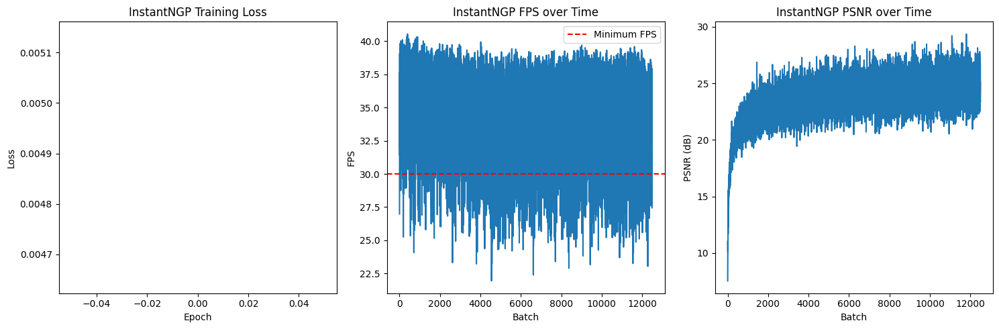






InstantNGP Training Progress:  10%|█         | 12501/125000 [07:08<6:20:25,  4.93it/s]




InstantNGP Training Progress:  10%|█         | 12504/125000 [07:08<4:52:19,  6.41it/s]


InstantNGP Epoch 2/10, Batch 0:
FPS: 34.59, Latency: 28.91ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  10%|█         | 12507/125000 [07:08<3:47:59,  8.22it/s]




InstantNGP Training Progress:  10%|█         | 12510/125000 [07:09<3:02:21, 10.28it/s]




InstantNGP Training Progress:  10%|█         | 12513/125000 [07:09<2:29:10, 12.57it/s]




InstantNGP Training Progress:  10%|█         | 12516/125000 [07:09<2:04:29, 15.06it/s]


InstantNGP Epoch 2/10, Batch 10:
FPS: 34.87, Latency: 28.68ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  10%|█         | 12519/125000 [07:09<1:49:03, 17.19it/s]




InstantNGP Training Progress:  10%|█         | 12522/125000 [07:09<1:37:31, 19.22it/s]




InstantNGP Training Progress:  10%|█         | 12525/125000 [07:09<1:27:59, 21.30it/s]


InstantNGP Epoch 2/10, Batch 20:
FPS: 34.95, Latency: 28.61ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  10%|█         | 12528/125000 [07:09<1:21:02, 23.13it/s]




InstantNGP Training Progress:  10%|█         | 12531/125000 [07:09<1:17:03, 24.32it/s]




InstantNGP Training Progress:  10%|█         | 12534/125000 [07:09<1:13:21, 25.55it/s]


InstantNGP Epoch 2/10, Batch 30:
FPS: 29.63, Latency: 33.75ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  10%|█         | 12537/125000 [07:10<1:13:30, 25.50it/s]




InstantNGP Training Progress:  10%|█         | 12540/125000 [07:10<1:10:44, 26.50it/s]




InstantNGP Training Progress:  10%|█         | 12543/125000 [07:10<1:10:29, 26.59it/s]




InstantNGP Training Progress:  10%|█         | 12546/125000 [07:10<1:08:26, 27.39it/s]


InstantNGP Epoch 2/10, Batch 40:
FPS: 24.99, Latency: 40.02ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  10%|█         | 12549/125000 [07:10<1:11:35, 26.18it/s]




InstantNGP Training Progress:  10%|█         | 12552/125000 [07:10<1:09:14, 27.07it/s]




InstantNGP Training Progress:  10%|█         | 12556/125000 [07:10<1:06:19, 28.25it/s]


InstantNGP Epoch 2/10, Batch 50:
FPS: 34.24, Latency: 29.21ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  10%|█         | 12559/125000 [07:10<1:05:26, 28.63it/s]




InstantNGP Training Progress:  10%|█         | 12562/125000 [07:10<1:05:07, 28.78it/s]




InstantNGP Training Progress:  10%|█         | 12565/125000 [07:11<1:05:59, 28.39it/s]


InstantNGP Epoch 2/10, Batch 60:
FPS: 33.59, Latency: 29.77ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  10%|█         | 12568/125000 [07:11<1:05:19, 28.69it/s]




InstantNGP Training Progress:  10%|█         | 12571/125000 [07:11<1:06:28, 28.19it/s]




InstantNGP Training Progress:  10%|█         | 12574/125000 [07:11<1:05:30, 28.60it/s]


InstantNGP Epoch 2/10, Batch 70:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  10%|█         | 12577/125000 [07:11<1:06:07, 28.33it/s]




InstantNGP Training Progress:  10%|█         | 12580/125000 [07:11<1:06:21, 28.23it/s]




InstantNGP Training Progress:  10%|█         | 12583/125000 [07:11<1:07:45, 27.65it/s]




InstantNGP Training Progress:  10%|█         | 12586/125000 [07:11<1:07:29, 27.76it/s]


InstantNGP Epoch 2/10, Batch 80:
FPS: 33.31, Latency: 30.02ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  10%|█         | 12589/125000 [07:11<1:07:18, 27.83it/s]




InstantNGP Training Progress:  10%|█         | 12592/125000 [07:11<1:07:03, 27.94it/s]




InstantNGP Training Progress:  10%|█         | 12596/125000 [07:12<1:04:09, 29.20it/s]


InstantNGP Epoch 2/10, Batch 90:
FPS: 28.28, Latency: 35.36ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  10%|█         | 12600/125000 [07:12<1:01:55, 30.25it/s]




InstantNGP Training Progress:  10%|█         | 12604/125000 [07:12<1:02:48, 29.83it/s]




InstantNGP Training Progress:  10%|█         | 12607/125000 [07:12<1:03:06, 29.68it/s]


InstantNGP Epoch 2/10, Batch 100:
FPS: 27.52, Latency: 36.34ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  10%|█         | 12610/125000 [07:12<1:05:18, 28.68it/s]




InstantNGP Training Progress:  10%|█         | 12613/125000 [07:12<1:05:25, 28.63it/s]




InstantNGP Training Progress:  10%|█         | 12617/125000 [07:12<1:02:36, 29.92it/s]


InstantNGP Epoch 2/10, Batch 110:
FPS: 30.78, Latency: 32.49ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  10%|█         | 12620/125000 [07:12<1:03:11, 29.64it/s]




InstantNGP Training Progress:  10%|█         | 12623/125000 [07:13<1:04:09, 29.19it/s]




InstantNGP Training Progress:  10%|█         | 12626/125000 [07:13<1:04:01, 29.26it/s]


InstantNGP Epoch 2/10, Batch 120:
FPS: 33.44, Latency: 29.90ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  10%|█         | 12629/125000 [07:13<1:04:45, 28.92it/s]




InstantNGP Training Progress:  10%|█         | 12632/125000 [07:13<1:04:38, 28.97it/s]




InstantNGP Training Progress:  10%|█         | 12635/125000 [07:13<1:04:08, 29.19it/s]


InstantNGP Epoch 2/10, Batch 130:
FPS: 31.57, Latency: 31.67ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  10%|█         | 12638/125000 [07:13<1:03:39, 29.42it/s]




InstantNGP Training Progress:  10%|█         | 12642/125000 [07:13<1:02:13, 30.10it/s]




InstantNGP Training Progress:  10%|█         | 12646/125000 [07:13<1:00:34, 30.91it/s]


InstantNGP Epoch 2/10, Batch 140:
FPS: 32.48, Latency: 30.79ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  10%|█         | 12650/125000 [07:13<1:00:43, 30.83it/s]




InstantNGP Training Progress:  10%|█         | 12654/125000 [07:14<1:00:34, 30.91it/s]


InstantNGP Epoch 2/10, Batch 150:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  10%|█         | 12658/125000 [07:14<1:01:07, 30.63it/s]




InstantNGP Training Progress:  10%|█         | 12662/125000 [07:14<1:01:07, 30.63it/s]




InstantNGP Training Progress:  10%|█         | 12666/125000 [07:14<1:03:28, 29.49it/s]


InstantNGP Epoch 2/10, Batch 160:
FPS: 33.10, Latency: 30.21ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  10%|█         | 12669/125000 [07:14<1:04:05, 29.21it/s]




InstantNGP Training Progress:  10%|█         | 12672/125000 [07:14<1:04:41, 28.94it/s]




InstantNGP Training Progress:  10%|█         | 12676/125000 [07:14<1:03:07, 29.66it/s]


InstantNGP Epoch 2/10, Batch 170:
FPS: 35.12, Latency: 28.47ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  10%|█         | 12679/125000 [07:14<1:03:24, 29.52it/s]




InstantNGP Training Progress:  10%|█         | 12682/125000 [07:14<1:03:30, 29.48it/s]




InstantNGP Training Progress:  10%|█         | 12686/125000 [07:15<1:02:48, 29.81it/s]


InstantNGP Epoch 2/10, Batch 180:
FPS: 33.02, Latency: 30.28ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  10%|█         | 12689/125000 [07:15<1:04:07, 29.19it/s]




InstantNGP Training Progress:  10%|█         | 12692/125000 [07:15<1:04:21, 29.08it/s]




InstantNGP Training Progress:  10%|█         | 12695/125000 [07:15<1:05:24, 28.62it/s]


InstantNGP Epoch 2/10, Batch 190:
FPS: 31.01, Latency: 32.25ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  10%|█         | 12698/125000 [07:15<1:05:38, 28.51it/s]




InstantNGP Training Progress:  10%|█         | 12701/125000 [07:15<1:06:10, 28.28it/s]




InstantNGP Training Progress:  10%|█         | 12704/125000 [07:15<1:06:32, 28.13it/s]


InstantNGP Epoch 2/10, Batch 200:
FPS: 31.73, Latency: 31.52ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:  10%|█         | 12707/125000 [07:15<1:06:42, 28.06it/s]




InstantNGP Training Progress:  10%|█         | 12710/125000 [07:15<1:06:18, 28.22it/s]




InstantNGP Training Progress:  10%|█         | 12713/125000 [07:16<1:06:23, 28.19it/s]




InstantNGP Training Progress:  10%|█         | 12716/125000 [07:16<1:05:36, 28.52it/s]


InstantNGP Epoch 2/10, Batch 210:
FPS: 31.82, Latency: 31.43ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  10%|█         | 12719/125000 [07:16<1:06:20, 28.21it/s]




InstantNGP Training Progress:  10%|█         | 12722/125000 [07:16<1:05:38, 28.50it/s]




InstantNGP Training Progress:  10%|█         | 12725/125000 [07:16<1:05:46, 28.45it/s]


InstantNGP Epoch 2/10, Batch 220:
FPS: 32.87, Latency: 30.42ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  10%|█         | 12728/125000 [07:16<1:05:40, 28.49it/s]




InstantNGP Training Progress:  10%|█         | 12731/125000 [07:16<1:06:41, 28.06it/s]




InstantNGP Training Progress:  10%|█         | 12735/125000 [07:16<1:04:25, 29.04it/s]


InstantNGP Epoch 2/10, Batch 230:
FPS: 32.23, Latency: 31.03ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  10%|█         | 12738/125000 [07:16<1:04:48, 28.87it/s]




InstantNGP Training Progress:  10%|█         | 12741/125000 [07:17<1:04:29, 29.01it/s]




InstantNGP Training Progress:  10%|█         | 12744/125000 [07:17<1:05:42, 28.47it/s]


InstantNGP Epoch 2/10, Batch 240:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  10%|█         | 12748/125000 [07:17<1:04:37, 28.95it/s]




InstantNGP Training Progress:  10%|█         | 12751/125000 [07:17<1:05:58, 28.35it/s]




InstantNGP Training Progress:  10%|█         | 12755/125000 [07:17<1:04:25, 29.04it/s]


InstantNGP Epoch 2/10, Batch 250:
FPS: 34.33, Latency: 29.13ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  10%|█         | 12758/125000 [07:17<1:04:46, 28.88it/s]




InstantNGP Training Progress:  10%|█         | 12761/125000 [07:17<1:04:10, 29.15it/s]




InstantNGP Training Progress:  10%|█         | 12765/125000 [07:17<1:03:21, 29.52it/s]


InstantNGP Epoch 2/10, Batch 260:
FPS: 31.27, Latency: 31.98ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  10%|█         | 12768/125000 [07:17<1:04:10, 29.15it/s]




InstantNGP Training Progress:  10%|█         | 12771/125000 [07:18<1:05:14, 28.67it/s]




InstantNGP Training Progress:  10%|█         | 12774/125000 [07:18<1:05:07, 28.72it/s]


InstantNGP Epoch 2/10, Batch 270:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  10%|█         | 12778/125000 [07:18<1:03:39, 29.38it/s]




InstantNGP Training Progress:  10%|█         | 12781/125000 [07:18<1:04:33, 28.97it/s]




InstantNGP Training Progress:  10%|█         | 12784/125000 [07:18<1:05:26, 28.58it/s]


InstantNGP Epoch 2/10, Batch 280:
FPS: 34.28, Latency: 29.18ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  10%|█         | 12787/125000 [07:18<1:06:09, 28.27it/s]




InstantNGP Training Progress:  10%|█         | 12790/125000 [07:18<1:07:03, 27.89it/s]




InstantNGP Training Progress:  10%|█         | 12793/125000 [07:18<1:06:47, 28.00it/s]




InstantNGP Training Progress:  10%|█         | 12796/125000 [07:18<1:06:44, 28.02it/s]


InstantNGP Epoch 2/10, Batch 290:
FPS: 28.24, Latency: 35.42ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  10%|█         | 12799/125000 [07:19<1:06:17, 28.21it/s]




InstantNGP Training Progress:  10%|█         | 12802/125000 [07:19<1:07:36, 27.66it/s]




InstantNGP Training Progress:  10%|█         | 12805/125000 [07:19<1:07:36, 27.66it/s]


InstantNGP Epoch 2/10, Batch 300:
FPS: 31.26, Latency: 31.99ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  10%|█         | 12808/125000 [07:19<1:06:23, 28.17it/s]




InstantNGP Training Progress:  10%|█         | 12812/125000 [07:19<1:03:40, 29.36it/s]




InstantNGP Training Progress:  10%|█         | 12815/125000 [07:19<1:03:44, 29.33it/s]


InstantNGP Epoch 2/10, Batch 310:
FPS: 37.39, Latency: 26.74ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  10%|█         | 12818/125000 [07:19<1:04:15, 29.10it/s]




InstantNGP Training Progress:  10%|█         | 12821/125000 [07:19<1:03:54, 29.26it/s]




InstantNGP Training Progress:  10%|█         | 12824/125000 [07:19<1:05:36, 28.49it/s]


InstantNGP Epoch 2/10, Batch 320:
FPS: 32.15, Latency: 31.10ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  10%|█         | 12827/125000 [07:20<1:05:19, 28.62it/s]




InstantNGP Training Progress:  10%|█         | 12831/125000 [07:20<1:02:58, 29.69it/s]




InstantNGP Training Progress:  10%|█         | 12835/125000 [07:20<1:01:18, 30.49it/s]


InstantNGP Epoch 2/10, Batch 330:
FPS: 37.49, Latency: 26.67ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:  10%|█         | 12839/125000 [07:20<1:03:19, 29.52it/s]




InstantNGP Training Progress:  10%|█         | 12842/125000 [07:20<1:03:06, 29.62it/s]




InstantNGP Training Progress:  10%|█         | 12845/125000 [07:20<1:03:53, 29.26it/s]


InstantNGP Epoch 2/10, Batch 340:
FPS: 31.46, Latency: 31.79ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  10%|█         | 12848/125000 [07:20<1:05:34, 28.51it/s]




InstantNGP Training Progress:  10%|█         | 12852/125000 [07:20<1:04:33, 28.96it/s]




InstantNGP Training Progress:  10%|█         | 12856/125000 [07:21<1:02:21, 29.97it/s]


InstantNGP Epoch 2/10, Batch 350:
FPS: 36.37, Latency: 27.50ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  10%|█         | 12859/125000 [07:21<1:03:34, 29.40it/s]




InstantNGP Training Progress:  10%|█         | 12862/125000 [07:21<1:03:24, 29.48it/s]




InstantNGP Training Progress:  10%|█         | 12865/125000 [07:21<1:04:09, 29.13it/s]


InstantNGP Epoch 2/10, Batch 360:
FPS: 37.13, Latency: 26.93ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  10%|█         | 12868/125000 [07:21<1:06:30, 28.10it/s]




InstantNGP Training Progress:  10%|█         | 12872/125000 [07:21<1:04:10, 29.12it/s]




InstantNGP Training Progress:  10%|█         | 12876/125000 [07:21<1:02:49, 29.74it/s]


InstantNGP Epoch 2/10, Batch 370:
FPS: 35.52, Latency: 28.15ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  10%|█         | 12879/125000 [07:21<1:04:27, 28.99it/s]




InstantNGP Training Progress:  10%|█         | 12882/125000 [07:21<1:04:28, 28.98it/s]




InstantNGP Training Progress:  10%|█         | 12885/125000 [07:22<1:04:04, 29.16it/s]


InstantNGP Epoch 2/10, Batch 380:
FPS: 36.13, Latency: 27.68ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  10%|█         | 12888/125000 [07:22<1:05:08, 28.68it/s]




InstantNGP Training Progress:  10%|█         | 12891/125000 [07:22<1:05:40, 28.45it/s]




InstantNGP Training Progress:  10%|█         | 12894/125000 [07:22<1:06:37, 28.05it/s]


InstantNGP Epoch 2/10, Batch 390:
FPS: 34.96, Latency: 28.60ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  10%|█         | 12897/125000 [07:22<1:08:11, 27.40it/s]




InstantNGP Training Progress:  10%|█         | 12900/125000 [07:22<1:08:25, 27.31it/s]




InstantNGP Training Progress:  10%|█         | 12903/125000 [07:22<1:09:03, 27.05it/s]




InstantNGP Training Progress:  10%|█         | 12906/125000 [07:22<1:08:02, 27.46it/s]


InstantNGP Epoch 2/10, Batch 400:
FPS: 28.12, Latency: 35.56ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  10%|█         | 12909/125000 [07:22<1:08:07, 27.42it/s]




InstantNGP Training Progress:  10%|█         | 12912/125000 [07:23<1:07:58, 27.48it/s]




InstantNGP Training Progress:  10%|█         | 12916/125000 [07:23<1:05:01, 28.73it/s]


InstantNGP Epoch 2/10, Batch 410:
FPS: 30.21, Latency: 33.11ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  10%|█         | 12919/125000 [07:23<1:06:07, 28.25it/s]




InstantNGP Training Progress:  10%|█         | 12922/125000 [07:23<1:06:15, 28.19it/s]




InstantNGP Training Progress:  10%|█         | 12925/125000 [07:23<1:06:08, 28.24it/s]


InstantNGP Epoch 2/10, Batch 420:
FPS: 33.26, Latency: 30.06ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  10%|█         | 12928/125000 [07:23<1:05:52, 28.36it/s]




InstantNGP Training Progress:  10%|█         | 12931/125000 [07:23<1:06:41, 28.01it/s]




InstantNGP Training Progress:  10%|█         | 12934/125000 [07:23<1:09:04, 27.04it/s]


InstantNGP Epoch 2/10, Batch 430:
FPS: 35.15, Latency: 28.45ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  10%|█         | 12937/125000 [07:23<1:08:24, 27.30it/s]




InstantNGP Training Progress:  10%|█         | 12940/125000 [07:24<1:08:43, 27.18it/s]




InstantNGP Training Progress:  10%|█         | 12943/125000 [07:24<1:10:15, 26.58it/s]




InstantNGP Training Progress:  10%|█         | 12946/125000 [07:24<1:07:58, 27.48it/s]


InstantNGP Epoch 2/10, Batch 440:
FPS: 24.08, Latency: 41.53ms
PSNR: 23.18dB, Loss: 0.0048







InstantNGP Training Progress:  10%|█         | 12949/125000 [07:24<1:07:03, 27.85it/s]




InstantNGP Training Progress:  10%|█         | 12952/125000 [07:24<1:06:33, 28.05it/s]




InstantNGP Training Progress:  10%|█         | 12956/125000 [07:24<1:04:53, 28.78it/s]


InstantNGP Epoch 2/10, Batch 450:
FPS: 29.37, Latency: 34.04ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  10%|█         | 12959/125000 [07:24<1:04:44, 28.84it/s]




InstantNGP Training Progress:  10%|█         | 12962/125000 [07:24<1:04:03, 29.15it/s]




InstantNGP Training Progress:  10%|█         | 12965/125000 [07:24<1:04:10, 29.09it/s]


InstantNGP Epoch 2/10, Batch 460:
FPS: 32.60, Latency: 30.68ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  10%|█         | 12968/125000 [07:25<1:04:40, 28.87it/s]




InstantNGP Training Progress:  10%|█         | 12972/125000 [07:25<1:03:53, 29.22it/s]




InstantNGP Training Progress:  10%|█         | 12975/125000 [07:25<1:04:56, 28.75it/s]


InstantNGP Epoch 2/10, Batch 470:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  10%|█         | 12978/125000 [07:25<1:04:38, 28.88it/s]




InstantNGP Training Progress:  10%|█         | 12981/125000 [07:25<1:06:41, 27.99it/s]




InstantNGP Training Progress:  10%|█         | 12985/125000 [07:25<1:04:46, 28.82it/s]


InstantNGP Epoch 2/10, Batch 480:
FPS: 31.63, Latency: 31.61ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  10%|█         | 12988/125000 [07:25<1:04:13, 29.07it/s]




InstantNGP Training Progress:  10%|█         | 12991/125000 [07:25<1:03:47, 29.26it/s]




InstantNGP Training Progress:  10%|█         | 12995/125000 [07:25<1:02:28, 29.88it/s]


InstantNGP Epoch 2/10, Batch 490:
FPS: 37.14, Latency: 26.92ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  10%|█         | 12999/125000 [07:26<1:02:09, 30.03it/s]




InstantNGP Training Progress:  10%|█         | 13002/125000 [07:26<1:04:04, 29.13it/s]




InstantNGP Training Progress:  10%|█         | 13005/125000 [07:26<1:04:48, 28.80it/s]


InstantNGP Epoch 2/10, Batch 500:
FPS: 29.86, Latency: 33.49ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  10%|█         | 13008/125000 [07:26<1:04:04, 29.13it/s]




InstantNGP Training Progress:  10%|█         | 13011/125000 [07:26<1:03:32, 29.37it/s]




InstantNGP Training Progress:  10%|█         | 13015/125000 [07:26<1:02:19, 29.95it/s]


InstantNGP Epoch 2/10, Batch 510:
FPS: 39.07, Latency: 25.59ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  10%|█         | 13018/125000 [07:26<1:03:30, 29.39it/s]




InstantNGP Training Progress:  10%|█         | 13022/125000 [07:26<1:02:55, 29.66it/s]




InstantNGP Training Progress:  10%|█         | 13026/125000 [07:26<1:01:01, 30.58it/s]


InstantNGP Epoch 2/10, Batch 520:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  10%|█         | 13030/125000 [07:27<1:01:00, 30.59it/s]




InstantNGP Training Progress:  10%|█         | 13034/125000 [07:27<1:00:48, 30.69it/s]


InstantNGP Epoch 2/10, Batch 530:
FPS: 31.34, Latency: 31.90ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:  10%|█         | 13038/125000 [07:27<1:01:07, 30.52it/s]




InstantNGP Training Progress:  10%|█         | 13042/125000 [07:27<1:03:33, 29.36it/s]




InstantNGP Training Progress:  10%|█         | 13045/125000 [07:27<1:04:05, 29.11it/s]


InstantNGP Epoch 2/10, Batch 540:
FPS: 36.69, Latency: 27.26ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  10%|█         | 13048/125000 [07:27<1:04:14, 29.04it/s]




InstantNGP Training Progress:  10%|█         | 13051/125000 [07:27<1:04:20, 29.00it/s]




InstantNGP Training Progress:  10%|█         | 13054/125000 [07:27<1:04:14, 29.04it/s]


InstantNGP Epoch 2/10, Batch 550:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  10%|█         | 13057/125000 [07:28<1:03:45, 29.26it/s]




InstantNGP Training Progress:  10%|█         | 13061/125000 [07:28<1:02:40, 29.77it/s]




InstantNGP Training Progress:  10%|█         | 13064/125000 [07:28<1:03:02, 29.60it/s]


InstantNGP Epoch 2/10, Batch 560:
FPS: 33.86, Latency: 29.53ms
PSNR: 23.42dB, Loss: 0.0046







InstantNGP Training Progress:  10%|█         | 13068/125000 [07:28<1:02:34, 29.81it/s]




InstantNGP Training Progress:  10%|█         | 13071/125000 [07:28<1:02:43, 29.74it/s]




InstantNGP Training Progress:  10%|█         | 13075/125000 [07:28<1:01:51, 30.16it/s]


InstantNGP Epoch 2/10, Batch 570:
FPS: 37.24, Latency: 26.85ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  10%|█         | 13079/125000 [07:28<1:02:31, 29.83it/s]




InstantNGP Training Progress:  10%|█         | 13082/125000 [07:28<1:02:45, 29.72it/s]




InstantNGP Training Progress:  10%|█         | 13085/125000 [07:28<1:03:37, 29.32it/s]


InstantNGP Epoch 2/10, Batch 580:
FPS: 29.59, Latency: 33.80ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  10%|█         | 13088/125000 [07:29<1:04:46, 28.80it/s]




InstantNGP Training Progress:  10%|█         | 13091/125000 [07:29<1:05:14, 28.59it/s]




InstantNGP Training Progress:  10%|█         | 13095/125000 [07:29<1:03:00, 29.60it/s]


InstantNGP Epoch 2/10, Batch 590:
FPS: 31.62, Latency: 31.63ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  10%|█         | 13098/125000 [07:29<1:04:26, 28.94it/s]




InstantNGP Training Progress:  10%|█         | 13101/125000 [07:29<1:07:14, 27.74it/s]




InstantNGP Training Progress:  10%|█         | 13104/125000 [07:29<1:06:30, 28.04it/s]


InstantNGP Epoch 2/10, Batch 600:
FPS: 32.20, Latency: 31.06ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  10%|█         | 13108/125000 [07:29<1:04:46, 28.79it/s]




InstantNGP Training Progress:  10%|█         | 13111/125000 [07:29<1:04:08, 29.08it/s]




InstantNGP Training Progress:  10%|█         | 13114/125000 [07:29<1:03:52, 29.19it/s]


InstantNGP Epoch 2/10, Batch 610:
FPS: 37.95, Latency: 26.35ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:  10%|█         | 13117/125000 [07:30<1:05:24, 28.51it/s]




InstantNGP Training Progress:  10%|█         | 13120/125000 [07:30<1:05:49, 28.33it/s]




InstantNGP Training Progress:  10%|█         | 13123/125000 [07:30<1:06:07, 28.20it/s]




InstantNGP Training Progress:  11%|█         | 13126/125000 [07:30<1:05:54, 28.29it/s]


InstantNGP Epoch 2/10, Batch 620:
FPS: 30.50, Latency: 32.78ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  11%|█         | 13129/125000 [07:30<1:06:07, 28.20it/s]




InstantNGP Training Progress:  11%|█         | 13132/125000 [07:30<1:05:07, 28.63it/s]




InstantNGP Training Progress:  11%|█         | 13135/125000 [07:30<1:06:18, 28.12it/s]


InstantNGP Epoch 2/10, Batch 630:
FPS: 35.81, Latency: 27.93ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  11%|█         | 13138/125000 [07:30<1:05:21, 28.53it/s]




InstantNGP Training Progress:  11%|█         | 13141/125000 [07:30<1:04:51, 28.75it/s]




InstantNGP Training Progress:  11%|█         | 13144/125000 [07:31<1:04:58, 28.69it/s]


InstantNGP Epoch 2/10, Batch 640:
FPS: 37.54, Latency: 26.64ms
PSNR: 28.02dB, Loss: 0.0016







InstantNGP Training Progress:  11%|█         | 13148/125000 [07:31<1:03:26, 29.39it/s]




InstantNGP Training Progress:  11%|█         | 13151/125000 [07:31<1:04:09, 29.06it/s]




InstantNGP Training Progress:  11%|█         | 13154/125000 [07:31<1:05:05, 28.64it/s]


InstantNGP Epoch 2/10, Batch 650:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  11%|█         | 13157/125000 [07:31<1:06:05, 28.21it/s]




InstantNGP Training Progress:  11%|█         | 13160/125000 [07:31<1:05:28, 28.47it/s]




InstantNGP Training Progress:  11%|█         | 13163/125000 [07:31<1:05:38, 28.39it/s]







InstantNGP Epoch 2/10, Batch 660:
FPS: 31.57, Latency: 31.67ms
PSNR: 23.30dB, Loss: 0.0047


InstantNGP Training Progress:  11%|█         | 13167/125000 [07:31<1:04:03, 29.09it/s]




InstantNGP Training Progress:  11%|█         | 13170/125000 [07:31<1:04:01, 29.11it/s]




InstantNGP Training Progress:  11%|█         | 13173/125000 [07:32<1:03:54, 29.17it/s]




InstantNGP Training Progress:  11%|█         | 13177/125000 [07:32<1:02:47, 29.68it/s]


InstantNGP Epoch 2/10, Batch 670:
FPS: 36.84, Latency: 27.14ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  11%|█         | 13180/125000 [07:32<1:05:11, 28.59it/s]




InstantNGP Training Progress:  11%|█         | 13183/125000 [07:32<1:05:22, 28.51it/s]




InstantNGP Training Progress:  11%|█         | 13186/125000 [07:32<1:06:08, 28.17it/s]


InstantNGP Epoch 2/10, Batch 680:
FPS: 35.71, Latency: 28.01ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  11%|█         | 13189/125000 [07:32<1:05:31, 28.44it/s]




InstantNGP Training Progress:  11%|█         | 13192/125000 [07:32<1:05:35, 28.41it/s]




InstantNGP Training Progress:  11%|█         | 13195/125000 [07:32<1:05:32, 28.43it/s]


InstantNGP Epoch 2/10, Batch 690:
FPS: 30.67, Latency: 32.60ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  11%|█         | 13198/125000 [07:32<1:06:14, 28.13it/s]




InstantNGP Training Progress:  11%|█         | 13201/125000 [07:33<1:05:10, 28.59it/s]




InstantNGP Training Progress:  11%|█         | 13204/125000 [07:33<1:04:18, 28.97it/s]


InstantNGP Epoch 2/10, Batch 700:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  11%|█         | 13208/125000 [07:33<1:03:10, 29.49it/s]




InstantNGP Training Progress:  11%|█         | 13212/125000 [07:33<1:02:46, 29.68it/s]




InstantNGP Training Progress:  11%|█         | 13215/125000 [07:33<1:03:02, 29.56it/s]


InstantNGP Epoch 2/10, Batch 710:
FPS: 34.08, Latency: 29.34ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  11%|█         | 13218/125000 [07:33<1:04:01, 29.10it/s]




InstantNGP Training Progress:  11%|█         | 13221/125000 [07:33<1:05:58, 28.24it/s]




InstantNGP Training Progress:  11%|█         | 13224/125000 [07:33<1:05:27, 28.46it/s]


InstantNGP Epoch 2/10, Batch 720:
FPS: 32.84, Latency: 30.45ms
PSNR: 23.28dB, Loss: 0.0047







InstantNGP Training Progress:  11%|█         | 13227/125000 [07:33<1:05:30, 28.44it/s]




InstantNGP Training Progress:  11%|█         | 13230/125000 [07:34<1:04:43, 28.78it/s]




InstantNGP Training Progress:  11%|█         | 13233/125000 [07:34<1:05:34, 28.40it/s]




InstantNGP Training Progress:  11%|█         | 13236/125000 [07:34<1:07:13, 27.71it/s]


InstantNGP Epoch 2/10, Batch 730:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  11%|█         | 13239/125000 [07:34<1:06:57, 27.82it/s]




InstantNGP Training Progress:  11%|█         | 13242/125000 [07:34<1:07:20, 27.66it/s]




InstantNGP Training Progress:  11%|█         | 13245/125000 [07:34<1:06:22, 28.06it/s]


InstantNGP Epoch 2/10, Batch 740:
FPS: 30.18, Latency: 33.14ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  11%|█         | 13249/125000 [07:34<1:04:40, 28.80it/s]




InstantNGP Training Progress:  11%|█         | 13252/125000 [07:34<1:04:44, 28.77it/s]




InstantNGP Training Progress:  11%|█         | 13255/125000 [07:34<1:06:31, 28.00it/s]


InstantNGP Epoch 2/10, Batch 750:
FPS: 34.57, Latency: 28.92ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  11%|█         | 13258/125000 [07:35<1:06:35, 27.97it/s]




InstantNGP Training Progress:  11%|█         | 13261/125000 [07:35<1:06:55, 27.83it/s]




InstantNGP Training Progress:  11%|█         | 13265/125000 [07:35<1:03:54, 29.14it/s]


InstantNGP Epoch 2/10, Batch 760:
FPS: 31.24, Latency: 32.01ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13268/125000 [07:35<1:04:57, 28.67it/s]




InstantNGP Training Progress:  11%|█         | 13271/125000 [07:35<1:05:50, 28.28it/s]




InstantNGP Training Progress:  11%|█         | 13275/125000 [07:35<1:03:09, 29.48it/s]


InstantNGP Epoch 2/10, Batch 770:
FPS: 35.85, Latency: 27.89ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  11%|█         | 13278/125000 [07:35<1:04:38, 28.81it/s]




InstantNGP Training Progress:  11%|█         | 13281/125000 [07:35<1:06:27, 28.01it/s]




InstantNGP Training Progress:  11%|█         | 13284/125000 [07:35<1:06:36, 27.96it/s]


InstantNGP Epoch 2/10, Batch 780:
FPS: 30.89, Latency: 32.38ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13287/125000 [07:36<1:08:10, 27.31it/s]




InstantNGP Training Progress:  11%|█         | 13290/125000 [07:36<1:06:52, 27.84it/s]




InstantNGP Training Progress:  11%|█         | 13293/125000 [07:36<1:06:40, 27.93it/s]




InstantNGP Training Progress:  11%|█         | 13296/125000 [07:36<1:05:30, 28.42it/s]


InstantNGP Epoch 2/10, Batch 790:
FPS: 31.74, Latency: 31.51ms
PSNR: 22.29dB, Loss: 0.0059







InstantNGP Training Progress:  11%|█         | 13299/125000 [07:36<1:05:57, 28.23it/s]




InstantNGP Training Progress:  11%|█         | 13302/125000 [07:36<1:05:29, 28.43it/s]




InstantNGP Training Progress:  11%|█         | 13305/125000 [07:36<1:04:42, 28.77it/s]


InstantNGP Epoch 2/10, Batch 800:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  11%|█         | 13308/125000 [07:36<1:04:40, 28.78it/s]




InstantNGP Training Progress:  11%|█         | 13311/125000 [07:36<1:04:47, 28.73it/s]




InstantNGP Training Progress:  11%|█         | 13315/125000 [07:37<1:03:13, 29.44it/s]


InstantNGP Epoch 2/10, Batch 810:
FPS: 32.58, Latency: 30.69ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  11%|█         | 13319/125000 [07:37<1:02:22, 29.84it/s]




InstantNGP Training Progress:  11%|█         | 13322/125000 [07:37<1:02:28, 29.79it/s]




InstantNGP Training Progress:  11%|█         | 13325/125000 [07:37<1:03:40, 29.23it/s]


InstantNGP Epoch 2/10, Batch 820:
FPS: 34.41, Latency: 29.06ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  11%|█         | 13328/125000 [07:37<1:04:33, 28.83it/s]




InstantNGP Training Progress:  11%|█         | 13332/125000 [07:37<1:03:50, 29.16it/s]




InstantNGP Training Progress:  11%|█         | 13336/125000 [07:37<1:02:53, 29.59it/s]


InstantNGP Epoch 2/10, Batch 830:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  11%|█         | 13339/125000 [07:37<1:02:59, 29.55it/s]




InstantNGP Training Progress:  11%|█         | 13342/125000 [07:37<1:04:25, 28.88it/s]




InstantNGP Training Progress:  11%|█         | 13346/125000 [07:38<1:02:56, 29.57it/s]


InstantNGP Epoch 2/10, Batch 840:
FPS: 26.83, Latency: 37.28ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  11%|█         | 13349/125000 [07:38<1:03:00, 29.53it/s]




InstantNGP Training Progress:  11%|█         | 13353/125000 [07:38<1:01:44, 30.14it/s]







InstantNGP Epoch 2/10, Batch 850:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.05dB, Loss: 0.0031


InstantNGP Training Progress:  11%|█         | 13357/125000 [07:38<1:02:20, 29.85it/s]




InstantNGP Training Progress:  11%|█         | 13360/125000 [07:38<1:03:40, 29.22it/s]




InstantNGP Training Progress:  11%|█         | 13363/125000 [07:38<1:05:18, 28.49it/s]




InstantNGP Training Progress:  11%|█         | 13366/125000 [07:38<1:04:48, 28.71it/s]


InstantNGP Epoch 2/10, Batch 860:
FPS: 28.76, Latency: 34.78ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  11%|█         | 13370/125000 [07:38<1:03:00, 29.53it/s]




InstantNGP Training Progress:  11%|█         | 13373/125000 [07:38<1:03:17, 29.40it/s]




InstantNGP Training Progress:  11%|█         | 13377/125000 [07:39<1:01:18, 30.34it/s]


InstantNGP Epoch 2/10, Batch 870:
FPS: 31.75, Latency: 31.50ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  11%|█         | 13381/125000 [07:39<1:00:56, 30.53it/s]




InstantNGP Training Progress:  11%|█         | 13385/125000 [07:39<1:03:03, 29.50it/s]


InstantNGP Epoch 2/10, Batch 880:
FPS: 38.67, Latency: 25.86ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  11%|█         | 13388/125000 [07:39<1:04:12, 28.97it/s]




InstantNGP Training Progress:  11%|█         | 13391/125000 [07:39<1:05:05, 28.58it/s]




InstantNGP Training Progress:  11%|█         | 13395/125000 [07:39<1:03:51, 29.13it/s]


InstantNGP Epoch 2/10, Batch 890:
FPS: 32.86, Latency: 30.43ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  11%|█         | 13398/125000 [07:39<1:04:38, 28.77it/s]




InstantNGP Training Progress:  11%|█         | 13402/125000 [07:39<1:02:41, 29.67it/s]




InstantNGP Training Progress:  11%|█         | 13405/125000 [07:40<1:03:37, 29.23it/s]


InstantNGP Epoch 2/10, Batch 900:
FPS: 37.66, Latency: 26.55ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  11%|█         | 13409/125000 [07:40<1:01:39, 30.17it/s]




InstantNGP Training Progress:  11%|█         | 13413/125000 [07:40<1:01:53, 30.05it/s]




InstantNGP Training Progress:  11%|█         | 13416/125000 [07:40<1:03:43, 29.18it/s]


InstantNGP Epoch 2/10, Batch 910:
FPS: 36.13, Latency: 27.67ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  11%|█         | 13419/125000 [07:40<1:03:57, 29.08it/s]




InstantNGP Training Progress:  11%|█         | 13422/125000 [07:40<1:04:13, 28.95it/s]




InstantNGP Training Progress:  11%|█         | 13425/125000 [07:40<1:06:18, 28.05it/s]


InstantNGP Epoch 2/10, Batch 920:
FPS: 35.26, Latency: 28.36ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  11%|█         | 13429/125000 [07:40<1:04:28, 28.84it/s]




InstantNGP Training Progress:  11%|█         | 13432/125000 [07:41<1:04:22, 28.88it/s]




InstantNGP Training Progress:  11%|█         | 13435/125000 [07:41<1:04:40, 28.75it/s]


InstantNGP Epoch 2/10, Batch 930:
FPS: 29.47, Latency: 33.94ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:  11%|█         | 13438/125000 [07:41<1:05:18, 28.47it/s]




InstantNGP Training Progress:  11%|█         | 13441/125000 [07:41<1:04:22, 28.88it/s]




InstantNGP Training Progress:  11%|█         | 13444/125000 [07:41<1:06:40, 27.88it/s]


InstantNGP Epoch 2/10, Batch 940:
FPS: 32.49, Latency: 30.78ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  11%|█         | 13447/125000 [07:41<1:06:27, 27.97it/s]




InstantNGP Training Progress:  11%|█         | 13450/125000 [07:41<1:05:53, 28.21it/s]




InstantNGP Training Progress:  11%|█         | 13453/125000 [07:41<1:05:04, 28.57it/s]




InstantNGP Training Progress:  11%|█         | 13457/125000 [07:41<1:03:00, 29.51it/s]


InstantNGP Epoch 2/10, Batch 950:
FPS: 35.77, Latency: 27.96ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13461/125000 [07:42<1:01:59, 29.99it/s]




InstantNGP Training Progress:  11%|█         | 13464/125000 [07:42<1:02:59, 29.51it/s]


InstantNGP Epoch 2/10, Batch 960:
FPS: 37.74, Latency: 26.49ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13468/125000 [07:42<1:02:15, 29.86it/s]




InstantNGP Training Progress:  11%|█         | 13472/125000 [07:42<1:02:07, 29.92it/s]




InstantNGP Training Progress:  11%|█         | 13475/125000 [07:42<1:02:19, 29.82it/s]


InstantNGP Epoch 2/10, Batch 970:
FPS: 36.73, Latency: 27.23ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  11%|█         | 13478/125000 [07:42<1:03:03, 29.48it/s]




InstantNGP Training Progress:  11%|█         | 13481/125000 [07:42<1:04:13, 28.94it/s]




InstantNGP Training Progress:  11%|█         | 13485/125000 [07:42<1:02:11, 29.88it/s]


InstantNGP Epoch 2/10, Batch 980:
FPS: 35.78, Latency: 27.95ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  11%|█         | 13488/125000 [07:42<1:03:11, 29.41it/s]




InstantNGP Training Progress:  11%|█         | 13491/125000 [07:43<1:03:09, 29.43it/s]




InstantNGP Training Progress:  11%|█         | 13494/125000 [07:43<1:02:56, 29.52it/s]


InstantNGP Epoch 2/10, Batch 990:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  11%|█         | 13497/125000 [07:43<1:03:42, 29.17it/s]




InstantNGP Training Progress:  11%|█         | 13501/125000 [07:43<1:01:46, 30.08it/s]




InstantNGP Training Progress:  11%|█         | 13504/125000 [07:43<1:02:31, 29.72it/s]


InstantNGP Epoch 2/10, Batch 1000:
FPS: 34.84, Latency: 28.70ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  11%|█         | 13507/125000 [07:43<1:03:00, 29.49it/s]




InstantNGP Training Progress:  11%|█         | 13510/125000 [07:43<1:04:28, 28.82it/s]




InstantNGP Training Progress:  11%|█         | 13513/125000 [07:43<1:04:14, 28.92it/s]







InstantNGP Epoch 2/10, Batch 1010:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.25dB, Loss: 0.0024


InstantNGP Training Progress:  11%|█         | 13517/125000 [07:43<1:03:13, 29.38it/s]




InstantNGP Training Progress:  11%|█         | 13520/125000 [07:44<1:03:35, 29.22it/s]




InstantNGP Training Progress:  11%|█         | 13523/125000 [07:44<1:03:37, 29.20it/s]




InstantNGP Training Progress:  11%|█         | 13526/125000 [07:44<1:04:52, 28.64it/s]


InstantNGP Epoch 2/10, Batch 1020:
FPS: 32.76, Latency: 30.53ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  11%|█         | 13530/125000 [07:44<1:03:29, 29.26it/s]




InstantNGP Training Progress:  11%|█         | 13533/125000 [07:44<1:05:15, 28.47it/s]







InstantNGP Epoch 2/10, Batch 1030:
FPS: 28.07, Latency: 35.63ms
PSNR: 26.36dB, Loss: 0.0023


InstantNGP Training Progress:  11%|█         | 13537/125000 [07:44<1:03:25, 29.29it/s]




InstantNGP Training Progress:  11%|█         | 13540/125000 [07:44<1:03:24, 29.29it/s]




InstantNGP Training Progress:  11%|█         | 13543/125000 [07:44<1:05:00, 28.58it/s]




InstantNGP Training Progress:  11%|█         | 13546/125000 [07:44<1:04:52, 28.64it/s]


InstantNGP Epoch 2/10, Batch 1040:
FPS: 30.59, Latency: 32.69ms
PSNR: 22.96dB, Loss: 0.0051







InstantNGP Training Progress:  11%|█         | 13549/125000 [07:45<1:04:31, 28.79it/s]




InstantNGP Training Progress:  11%|█         | 13552/125000 [07:45<1:04:43, 28.70it/s]




InstantNGP Training Progress:  11%|█         | 13555/125000 [07:45<1:04:05, 28.98it/s]


InstantNGP Epoch 2/10, Batch 1050:
FPS: 30.60, Latency: 32.68ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13559/125000 [07:45<1:02:33, 29.69it/s]




InstantNGP Training Progress:  11%|█         | 13562/125000 [07:45<1:03:59, 29.02it/s]




InstantNGP Training Progress:  11%|█         | 13565/125000 [07:45<1:03:43, 29.14it/s]


InstantNGP Epoch 2/10, Batch 1060:
FPS: 32.82, Latency: 30.47ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:  11%|█         | 13568/125000 [07:45<1:03:54, 29.06it/s]




InstantNGP Training Progress:  11%|█         | 13571/125000 [07:45<1:06:12, 28.05it/s]




InstantNGP Training Progress:  11%|█         | 13575/125000 [07:45<1:03:43, 29.14it/s]


InstantNGP Epoch 2/10, Batch 1070:
FPS: 30.56, Latency: 32.72ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  11%|█         | 13578/125000 [07:46<1:04:08, 28.95it/s]




InstantNGP Training Progress:  11%|█         | 13581/125000 [07:46<1:03:53, 29.06it/s]




InstantNGP Training Progress:  11%|█         | 13585/125000 [07:46<1:03:22, 29.30it/s]


InstantNGP Epoch 2/10, Batch 1080:
FPS: 30.58, Latency: 32.71ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  11%|█         | 13588/125000 [07:46<1:05:10, 28.49it/s]




InstantNGP Training Progress:  11%|█         | 13591/125000 [07:46<1:06:30, 27.92it/s]




InstantNGP Training Progress:  11%|█         | 13594/125000 [07:46<1:06:47, 27.80it/s]


InstantNGP Epoch 2/10, Batch 1090:
FPS: 34.39, Latency: 29.08ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  11%|█         | 13597/125000 [07:46<1:06:45, 27.81it/s]




InstantNGP Training Progress:  11%|█         | 13600/125000 [07:46<1:06:48, 27.79it/s]




InstantNGP Training Progress:  11%|█         | 13603/125000 [07:46<1:07:33, 27.48it/s]




InstantNGP Training Progress:  11%|█         | 13606/125000 [07:47<1:08:22, 27.15it/s]


InstantNGP Epoch 2/10, Batch 1100:
FPS: 27.46, Latency: 36.41ms
PSNR: 22.82dB, Loss: 0.0052







InstantNGP Training Progress:  11%|█         | 13609/125000 [07:47<1:07:24, 27.54it/s]




InstantNGP Training Progress:  11%|█         | 13612/125000 [07:47<1:06:25, 27.95it/s]




InstantNGP Training Progress:  11%|█         | 13615/125000 [07:47<1:07:27, 27.52it/s]


InstantNGP Epoch 2/10, Batch 1110:
FPS: 36.03, Latency: 27.76ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  11%|█         | 13618/125000 [07:47<1:08:23, 27.15it/s]




InstantNGP Training Progress:  11%|█         | 13621/125000 [07:47<1:06:33, 27.89it/s]




InstantNGP Training Progress:  11%|█         | 13624/125000 [07:47<1:05:24, 28.38it/s]


InstantNGP Epoch 2/10, Batch 1120:
FPS: 31.60, Latency: 31.65ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  11%|█         | 13627/125000 [07:47<1:04:58, 28.57it/s]




InstantNGP Training Progress:  11%|█         | 13630/125000 [07:47<1:04:19, 28.86it/s]




InstantNGP Training Progress:  11%|█         | 13633/125000 [07:47<1:03:41, 29.14it/s]




InstantNGP Training Progress:  11%|█         | 13637/125000 [07:48<1:02:26, 29.72it/s]


InstantNGP Epoch 2/10, Batch 1130:
FPS: 35.25, Latency: 28.37ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  11%|█         | 13640/125000 [07:48<1:07:11, 27.62it/s]




InstantNGP Training Progress:  11%|█         | 13643/125000 [07:48<1:09:33, 26.68it/s]




InstantNGP Training Progress:  11%|█         | 13646/125000 [07:48<1:08:07, 27.24it/s]


InstantNGP Epoch 2/10, Batch 1140:
FPS: 31.83, Latency: 31.41ms
PSNR: 28.49dB, Loss: 0.0014







InstantNGP Training Progress:  11%|█         | 13649/125000 [07:48<1:06:52, 27.75it/s]




InstantNGP Training Progress:  11%|█         | 13652/125000 [07:48<1:06:18, 27.99it/s]




InstantNGP Training Progress:  11%|█         | 13655/125000 [07:48<1:05:52, 28.17it/s]


InstantNGP Epoch 2/10, Batch 1150:
FPS: 30.75, Latency: 32.52ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13658/125000 [07:48<1:05:29, 28.34it/s]




InstantNGP Training Progress:  11%|█         | 13661/125000 [07:48<1:04:30, 28.77it/s]




InstantNGP Training Progress:  11%|█         | 13664/125000 [07:49<1:04:31, 28.76it/s]


InstantNGP Epoch 2/10, Batch 1160:
FPS: 31.65, Latency: 31.59ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  11%|█         | 13667/125000 [07:49<1:04:56, 28.57it/s]




InstantNGP Training Progress:  11%|█         | 13670/125000 [07:49<1:04:27, 28.78it/s]




InstantNGP Training Progress:  11%|█         | 13673/125000 [07:49<1:07:01, 27.68it/s]




InstantNGP Training Progress:  11%|█         | 13676/125000 [07:49<1:06:08, 28.06it/s]


InstantNGP Epoch 2/10, Batch 1170:
FPS: 28.68, Latency: 34.87ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  11%|█         | 13679/125000 [07:49<1:05:10, 28.47it/s]




InstantNGP Training Progress:  11%|█         | 13683/125000 [07:49<1:02:21, 29.75it/s]




InstantNGP Training Progress:  11%|█         | 13686/125000 [07:49<1:02:41, 29.60it/s]


InstantNGP Epoch 2/10, Batch 1180:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  11%|█         | 13689/125000 [07:49<1:02:55, 29.48it/s]




InstantNGP Training Progress:  11%|█         | 13692/125000 [07:50<1:03:31, 29.20it/s]




InstantNGP Training Progress:  11%|█         | 13695/125000 [07:50<1:03:53, 29.03it/s]


InstantNGP Epoch 2/10, Batch 1190:
FPS: 29.92, Latency: 33.42ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  11%|█         | 13698/125000 [07:50<1:04:39, 28.69it/s]




InstantNGP Training Progress:  11%|█         | 13701/125000 [07:50<1:04:37, 28.71it/s]




InstantNGP Training Progress:  11%|█         | 13704/125000 [07:50<1:05:53, 28.15it/s]


InstantNGP Epoch 2/10, Batch 1200:
FPS: 30.49, Latency: 32.80ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  11%|█         | 13708/125000 [07:50<1:03:49, 29.06it/s]




InstantNGP Training Progress:  11%|█         | 13711/125000 [07:50<1:04:12, 28.89it/s]




InstantNGP Training Progress:  11%|█         | 13714/125000 [07:50<1:04:16, 28.86it/s]


InstantNGP Epoch 2/10, Batch 1210:
FPS: 32.99, Latency: 30.32ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  11%|█         | 13717/125000 [07:50<1:04:37, 28.70it/s]




InstantNGP Training Progress:  11%|█         | 13721/125000 [07:51<1:02:18, 29.76it/s]




InstantNGP Training Progress:  11%|█         | 13724/125000 [07:51<1:03:10, 29.35it/s]


InstantNGP Epoch 2/10, Batch 1220:
FPS: 32.99, Latency: 30.31ms
PSNR: 22.38dB, Loss: 0.0058







InstantNGP Training Progress:  11%|█         | 13727/125000 [07:51<1:03:19, 29.29it/s]




InstantNGP Training Progress:  11%|█         | 13730/125000 [07:51<1:03:48, 29.06it/s]




InstantNGP Training Progress:  11%|█         | 13733/125000 [07:51<1:04:55, 28.57it/s]




InstantNGP Training Progress:  11%|█         | 13736/125000 [07:51<1:04:03, 28.95it/s]


InstantNGP Epoch 2/10, Batch 1230:
FPS: 26.13, Latency: 38.27ms
PSNR: 22.01dB, Loss: 0.0063







InstantNGP Training Progress:  11%|█         | 13739/125000 [07:51<1:04:50, 28.59it/s]




InstantNGP Training Progress:  11%|█         | 13742/125000 [07:51<1:04:53, 28.58it/s]




InstantNGP Training Progress:  11%|█         | 13746/125000 [07:51<1:03:06, 29.38it/s]


InstantNGP Epoch 2/10, Batch 1240:
FPS: 31.27, Latency: 31.98ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  11%|█         | 13750/125000 [07:52<1:01:42, 30.05it/s]




InstantNGP Training Progress:  11%|█         | 13753/125000 [07:52<1:02:02, 29.89it/s]




InstantNGP Training Progress:  11%|█         | 13756/125000 [07:52<1:02:24, 29.71it/s]


InstantNGP Epoch 2/10, Batch 1250:
FPS: 35.27, Latency: 28.36ms
PSNR: 24.27dB, Loss: 0.0037







InstantNGP Training Progress:  11%|█         | 13759/125000 [07:52<1:03:24, 29.24it/s]




InstantNGP Training Progress:  11%|█         | 13762/125000 [07:52<1:04:01, 28.95it/s]




InstantNGP Training Progress:  11%|█         | 13766/125000 [07:52<1:02:21, 29.73it/s]


InstantNGP Epoch 2/10, Batch 1260:
FPS: 30.54, Latency: 32.75ms
PSNR: 22.51dB, Loss: 0.0056







InstantNGP Training Progress:  11%|█         | 13769/125000 [07:52<1:02:32, 29.64it/s]




InstantNGP Training Progress:  11%|█         | 13773/125000 [07:52<1:01:37, 30.08it/s]




InstantNGP Training Progress:  11%|█         | 13776/125000 [07:52<1:02:05, 29.86it/s]


InstantNGP Epoch 2/10, Batch 1270:
FPS: 31.90, Latency: 31.35ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  11%|█         | 13780/125000 [07:53<1:00:28, 30.65it/s]




InstantNGP Training Progress:  11%|█         | 13784/125000 [07:53<1:00:36, 30.58it/s]


InstantNGP Epoch 2/10, Batch 1280:
FPS: 35.90, Latency: 27.85ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13788/125000 [07:53<1:00:37, 30.57it/s]




InstantNGP Training Progress:  11%|█         | 13792/125000 [07:53<1:01:49, 29.98it/s]




InstantNGP Training Progress:  11%|█         | 13795/125000 [07:53<1:01:50, 29.97it/s]


InstantNGP Epoch 2/10, Batch 1290:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  11%|█         | 13799/125000 [07:53<1:01:23, 30.19it/s]




InstantNGP Training Progress:  11%|█         | 13803/125000 [07:53<1:00:21, 30.71it/s]




InstantNGP Training Progress:  11%|█         | 13807/125000 [07:53<1:01:21, 30.20it/s]


InstantNGP Epoch 2/10, Batch 1300:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  11%|█         | 13811/125000 [07:54<1:02:28, 29.66it/s]




InstantNGP Training Progress:  11%|█         | 13814/125000 [07:54<1:02:20, 29.72it/s]


InstantNGP Epoch 2/10, Batch 1310:
FPS: 33.91, Latency: 29.49ms
PSNR: 22.13dB, Loss: 0.0061







InstantNGP Training Progress:  11%|█         | 13818/125000 [07:54<1:01:27, 30.15it/s]




InstantNGP Training Progress:  11%|█         | 13822/125000 [07:54<1:02:08, 29.82it/s]




InstantNGP Training Progress:  11%|█         | 13825/125000 [07:54<1:02:03, 29.86it/s]


InstantNGP Epoch 2/10, Batch 1320:
FPS: 33.79, Latency: 29.59ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  11%|█         | 13828/125000 [07:54<1:02:40, 29.56it/s]




InstantNGP Training Progress:  11%|█         | 13832/125000 [07:54<1:01:16, 30.24it/s]




InstantNGP Training Progress:  11%|█         | 13836/125000 [07:54<1:01:39, 30.05it/s]


InstantNGP Epoch 2/10, Batch 1330:
FPS: 36.94, Latency: 27.07ms
PSNR: 23.43dB, Loss: 0.0045







InstantNGP Training Progress:  11%|█         | 13840/125000 [07:55<1:02:07, 29.82it/s]




InstantNGP Training Progress:  11%|█         | 13843/125000 [07:55<1:02:10, 29.80it/s]




InstantNGP Training Progress:  11%|█         | 13846/125000 [07:55<1:02:46, 29.51it/s]


InstantNGP Epoch 2/10, Batch 1340:
FPS: 35.42, Latency: 28.23ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  11%|█         | 13849/125000 [07:55<1:04:05, 28.91it/s]




InstantNGP Training Progress:  11%|█         | 13852/125000 [07:55<1:05:13, 28.40it/s]




InstantNGP Training Progress:  11%|█         | 13855/125000 [07:55<1:05:02, 28.48it/s]


InstantNGP Epoch 2/10, Batch 1350:
FPS: 29.02, Latency: 34.46ms
PSNR: 27.14dB, Loss: 0.0019







InstantNGP Training Progress:  11%|█         | 13858/125000 [07:55<1:05:44, 28.18it/s]




InstantNGP Training Progress:  11%|█         | 13862/125000 [07:55<1:03:47, 29.04it/s]




InstantNGP Training Progress:  11%|█         | 13866/125000 [07:55<1:02:25, 29.67it/s]


InstantNGP Epoch 2/10, Batch 1360:
FPS: 35.57, Latency: 28.12ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  11%|█         | 13870/125000 [07:56<1:01:12, 30.26it/s]




InstantNGP Training Progress:  11%|█         | 13874/125000 [07:56<1:00:27, 30.63it/s]


InstantNGP Epoch 2/10, Batch 1370:
FPS: 36.07, Latency: 27.72ms
PSNR: 23.57dB, Loss: 0.0044







InstantNGP Training Progress:  11%|█         | 13878/125000 [07:56<1:01:55, 29.91it/s]




InstantNGP Training Progress:  11%|█         | 13881/125000 [07:56<1:04:10, 28.86it/s]




InstantNGP Training Progress:  11%|█         | 13884/125000 [07:56<1:05:00, 28.49it/s]


InstantNGP Epoch 2/10, Batch 1380:
FPS: 31.49, Latency: 31.75ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:  11%|█         | 13888/125000 [07:56<1:03:44, 29.05it/s]




InstantNGP Training Progress:  11%|█         | 13891/125000 [07:56<1:04:29, 28.72it/s]




InstantNGP Training Progress:  11%|█         | 13895/125000 [07:56<1:02:31, 29.62it/s]


InstantNGP Epoch 2/10, Batch 1390:
FPS: 32.27, Latency: 30.99ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  11%|█         | 13898/125000 [07:57<1:03:04, 29.35it/s]




InstantNGP Training Progress:  11%|█         | 13901/125000 [07:57<1:03:20, 29.24it/s]




InstantNGP Training Progress:  11%|█         | 13904/125000 [07:57<1:03:42, 29.06it/s]


InstantNGP Epoch 2/10, Batch 1400:
FPS: 36.27, Latency: 27.57ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  11%|█         | 13908/125000 [07:57<1:03:25, 29.19it/s]




InstantNGP Training Progress:  11%|█         | 13912/125000 [07:57<1:02:48, 29.47it/s]




InstantNGP Training Progress:  11%|█         | 13915/125000 [07:57<1:03:55, 28.96it/s]


InstantNGP Epoch 2/10, Batch 1410:
FPS: 37.41, Latency: 26.73ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  11%|█         | 13918/125000 [07:57<1:03:40, 29.08it/s]




InstantNGP Training Progress:  11%|█         | 13922/125000 [07:57<1:02:13, 29.75it/s]




InstantNGP Training Progress:  11%|█         | 13925/125000 [07:57<1:02:19, 29.71it/s]


InstantNGP Epoch 2/10, Batch 1420:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13928/125000 [07:58<1:03:46, 29.03it/s]




InstantNGP Training Progress:  11%|█         | 13931/125000 [07:58<1:03:50, 29.00it/s]




InstantNGP Training Progress:  11%|█         | 13934/125000 [07:58<1:03:31, 29.14it/s]


InstantNGP Epoch 2/10, Batch 1430:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  11%|█         | 13938/125000 [07:58<1:03:46, 29.02it/s]




InstantNGP Training Progress:  11%|█         | 13941/125000 [07:58<1:05:27, 28.28it/s]




InstantNGP Training Progress:  11%|█         | 13944/125000 [07:58<1:06:21, 27.89it/s]


InstantNGP Epoch 2/10, Batch 1440:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  11%|█         | 13947/125000 [07:58<1:06:18, 27.92it/s]




InstantNGP Training Progress:  11%|█         | 13950/125000 [07:58<1:06:08, 27.98it/s]




InstantNGP Training Progress:  11%|█         | 13953/125000 [07:58<1:06:02, 28.03it/s]




InstantNGP Training Progress:  11%|█         | 13956/125000 [07:59<1:06:39, 27.76it/s]


InstantNGP Epoch 2/10, Batch 1450:
FPS: 27.52, Latency: 36.33ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:  11%|█         | 13959/125000 [07:59<1:07:24, 27.46it/s]




InstantNGP Training Progress:  11%|█         | 13962/125000 [07:59<1:08:06, 27.17it/s]




InstantNGP Training Progress:  11%|█         | 13965/125000 [07:59<1:07:13, 27.53it/s]


InstantNGP Epoch 2/10, Batch 1460:
FPS: 27.26, Latency: 36.68ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  11%|█         | 13969/125000 [07:59<1:04:10, 28.84it/s]




InstantNGP Training Progress:  11%|█         | 13972/125000 [07:59<1:05:19, 28.33it/s]




InstantNGP Training Progress:  11%|█         | 13975/125000 [07:59<1:05:09, 28.40it/s]


InstantNGP Epoch 2/10, Batch 1470:
FPS: 32.61, Latency: 30.67ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  11%|█         | 13978/125000 [07:59<1:05:46, 28.13it/s]




InstantNGP Training Progress:  11%|█         | 13981/125000 [07:59<1:05:05, 28.43it/s]




InstantNGP Training Progress:  11%|█         | 13984/125000 [08:00<1:04:27, 28.71it/s]


InstantNGP Epoch 2/10, Batch 1480:
FPS: 30.35, Latency: 32.95ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█         | 13987/125000 [08:00<1:04:47, 28.56it/s]




InstantNGP Training Progress:  11%|█         | 13990/125000 [08:00<1:04:49, 28.54it/s]




InstantNGP Training Progress:  11%|█         | 13993/125000 [08:00<1:07:44, 27.31it/s]




InstantNGP Training Progress:  11%|█         | 13996/125000 [08:00<1:08:39, 26.95it/s]


InstantNGP Epoch 2/10, Batch 1490:
FPS: 26.13, Latency: 38.26ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  11%|█         | 13999/125000 [08:00<1:09:15, 26.71it/s]




InstantNGP Training Progress:  11%|█         | 14002/125000 [08:00<1:07:22, 27.45it/s]




InstantNGP Training Progress:  11%|█         | 14005/125000 [08:00<1:07:24, 27.44it/s]


InstantNGP Epoch 2/10, Batch 1500:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  11%|█         | 14009/125000 [08:00<1:05:04, 28.43it/s]




InstantNGP Training Progress:  11%|█         | 14012/125000 [08:01<1:04:47, 28.55it/s]




InstantNGP Training Progress:  11%|█         | 14015/125000 [08:01<1:03:59, 28.91it/s]


InstantNGP Epoch 2/10, Batch 1510:
FPS: 30.21, Latency: 33.10ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  11%|█         | 14018/125000 [08:01<1:04:17, 28.77it/s]




InstantNGP Training Progress:  11%|█         | 14021/125000 [08:01<1:03:52, 28.96it/s]




InstantNGP Training Progress:  11%|█         | 14024/125000 [08:01<1:04:21, 28.74it/s]


InstantNGP Epoch 2/10, Batch 1520:
FPS: 35.06, Latency: 28.52ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  11%|█         | 14028/125000 [08:01<1:02:29, 29.60it/s]




InstantNGP Training Progress:  11%|█         | 14032/125000 [08:01<1:01:35, 30.03it/s]




InstantNGP Training Progress:  11%|█         | 14035/125000 [08:01<1:02:30, 29.58it/s]


InstantNGP Epoch 2/10, Batch 1530:
FPS: 36.35, Latency: 27.51ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  11%|█         | 14038/125000 [08:01<1:03:20, 29.19it/s]




InstantNGP Training Progress:  11%|█         | 14041/125000 [08:02<1:03:04, 29.32it/s]




InstantNGP Training Progress:  11%|█         | 14045/125000 [08:02<1:01:35, 30.03it/s]


InstantNGP Epoch 2/10, Batch 1540:
FPS: 32.65, Latency: 30.63ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  11%|█         | 14048/125000 [08:02<1:02:08, 29.75it/s]




InstantNGP Training Progress:  11%|█         | 14051/125000 [08:02<1:03:38, 29.06it/s]




InstantNGP Training Progress:  11%|█         | 14054/125000 [08:02<1:05:29, 28.24it/s]


InstantNGP Epoch 2/10, Batch 1550:
FPS: 28.47, Latency: 35.13ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  11%|█         | 14057/125000 [08:02<1:05:18, 28.31it/s]




InstantNGP Training Progress:  11%|█         | 14061/125000 [08:02<1:04:09, 28.82it/s]




InstantNGP Training Progress:  11%|█▏        | 14065/125000 [08:02<1:01:29, 30.06it/s]


InstantNGP Epoch 2/10, Batch 1560:
FPS: 32.57, Latency: 30.71ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  11%|█▏        | 14068/125000 [08:02<1:02:21, 29.65it/s]




InstantNGP Training Progress:  11%|█▏        | 14071/125000 [08:03<1:02:41, 29.49it/s]




InstantNGP Training Progress:  11%|█▏        | 14074/125000 [08:03<1:02:44, 29.47it/s]


InstantNGP Epoch 2/10, Batch 1570:
FPS: 33.17, Latency: 30.15ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  11%|█▏        | 14077/125000 [08:03<1:03:01, 29.33it/s]




InstantNGP Training Progress:  11%|█▏        | 14080/125000 [08:03<1:03:15, 29.22it/s]




InstantNGP Training Progress:  11%|█▏        | 14083/125000 [08:03<1:02:55, 29.38it/s]




InstantNGP Training Progress:  11%|█▏        | 14086/125000 [08:03<1:02:57, 29.36it/s]


InstantNGP Epoch 2/10, Batch 1580:
FPS: 33.30, Latency: 30.03ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  11%|█▏        | 14089/125000 [08:03<1:03:42, 29.02it/s]




InstantNGP Training Progress:  11%|█▏        | 14092/125000 [08:03<1:03:11, 29.25it/s]




InstantNGP Training Progress:  11%|█▏        | 14095/125000 [08:03<1:03:55, 28.92it/s]


InstantNGP Epoch 2/10, Batch 1590:
FPS: 29.48, Latency: 33.93ms
PSNR: 27.77dB, Loss: 0.0017







InstantNGP Training Progress:  11%|█▏        | 14098/125000 [08:04<1:03:15, 29.22it/s]




InstantNGP Training Progress:  11%|█▏        | 14102/125000 [08:04<1:01:39, 29.97it/s]




InstantNGP Training Progress:  11%|█▏        | 14105/125000 [08:04<1:01:52, 29.87it/s]


InstantNGP Epoch 2/10, Batch 1600:
FPS: 37.58, Latency: 26.61ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  11%|█▏        | 14108/125000 [08:04<1:02:08, 29.74it/s]




InstantNGP Training Progress:  11%|█▏        | 14111/125000 [08:04<1:02:37, 29.51it/s]




InstantNGP Training Progress:  11%|█▏        | 14114/125000 [08:04<1:03:08, 29.27it/s]


InstantNGP Epoch 2/10, Batch 1610:
FPS: 30.32, Latency: 32.98ms
PSNR: 30.61dB, Loss: 0.0009







InstantNGP Training Progress:  11%|█▏        | 14117/125000 [08:04<1:03:35, 29.06it/s]




InstantNGP Training Progress:  11%|█▏        | 14120/125000 [08:04<1:05:12, 28.34it/s]




InstantNGP Training Progress:  11%|█▏        | 14124/125000 [08:04<1:03:50, 28.95it/s]


InstantNGP Epoch 2/10, Batch 1620:
FPS: 33.11, Latency: 30.21ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  11%|█▏        | 14128/125000 [08:05<1:02:18, 29.66it/s]




InstantNGP Training Progress:  11%|█▏        | 14131/125000 [08:05<1:02:19, 29.65it/s]




InstantNGP Training Progress:  11%|█▏        | 14134/125000 [08:05<1:02:20, 29.64it/s]


InstantNGP Epoch 2/10, Batch 1630:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  11%|█▏        | 14137/125000 [08:05<1:03:38, 29.03it/s]




InstantNGP Training Progress:  11%|█▏        | 14140/125000 [08:05<1:03:11, 29.24it/s]




InstantNGP Training Progress:  11%|█▏        | 14143/125000 [08:05<1:04:01, 28.86it/s]




InstantNGP Training Progress:  11%|█▏        | 14146/125000 [08:05<1:03:21, 29.16it/s]


InstantNGP Epoch 2/10, Batch 1640:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  11%|█▏        | 14149/125000 [08:05<1:03:28, 29.11it/s]




InstantNGP Training Progress:  11%|█▏        | 14152/125000 [08:05<1:04:34, 28.61it/s]




InstantNGP Training Progress:  11%|█▏        | 14156/125000 [08:05<1:02:16, 29.67it/s]


InstantNGP Epoch 2/10, Batch 1650:
FPS: 31.34, Latency: 31.91ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  11%|█▏        | 14159/125000 [08:06<1:02:55, 29.36it/s]




InstantNGP Training Progress:  11%|█▏        | 14162/125000 [08:06<1:02:40, 29.48it/s]




InstantNGP Training Progress:  11%|█▏        | 14165/125000 [08:06<1:02:55, 29.36it/s]


InstantNGP Epoch 2/10, Batch 1660:
FPS: 35.56, Latency: 28.12ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  11%|█▏        | 14168/125000 [08:06<1:02:37, 29.50it/s]




InstantNGP Training Progress:  11%|█▏        | 14171/125000 [08:06<1:03:30, 29.09it/s]




InstantNGP Training Progress:  11%|█▏        | 14174/125000 [08:06<1:03:38, 29.02it/s]


InstantNGP Epoch 2/10, Batch 1670:
FPS: 38.35, Latency: 26.08ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  11%|█▏        | 14178/125000 [08:06<1:02:08, 29.72it/s]




InstantNGP Training Progress:  11%|█▏        | 14181/125000 [08:06<1:02:09, 29.71it/s]




InstantNGP Training Progress:  11%|█▏        | 14184/125000 [08:06<1:04:01, 28.85it/s]


InstantNGP Epoch 2/10, Batch 1680:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  11%|█▏        | 14187/125000 [08:07<1:04:24, 28.67it/s]




InstantNGP Training Progress:  11%|█▏        | 14190/125000 [08:07<1:04:12, 28.76it/s]




InstantNGP Training Progress:  11%|█▏        | 14193/125000 [08:07<1:04:33, 28.61it/s]




InstantNGP Training Progress:  11%|█▏        | 14196/125000 [08:07<1:03:51, 28.92it/s]


InstantNGP Epoch 2/10, Batch 1690:
FPS: 30.54, Latency: 32.74ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  11%|█▏        | 14199/125000 [08:07<1:03:39, 29.01it/s]




InstantNGP Training Progress:  11%|█▏        | 14202/125000 [08:07<1:03:25, 29.11it/s]




InstantNGP Training Progress:  11%|█▏        | 14206/125000 [08:07<1:02:37, 29.49it/s]


InstantNGP Epoch 2/10, Batch 1700:
FPS: 34.74, Latency: 28.78ms
PSNR: 28.02dB, Loss: 0.0016







InstantNGP Training Progress:  11%|█▏        | 14209/125000 [08:07<1:03:00, 29.30it/s]




InstantNGP Training Progress:  11%|█▏        | 14213/125000 [08:07<1:02:24, 29.59it/s]




InstantNGP Training Progress:  11%|█▏        | 14216/125000 [08:08<1:02:27, 29.56it/s]


InstantNGP Epoch 2/10, Batch 1710:
FPS: 35.30, Latency: 28.32ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  11%|█▏        | 14220/125000 [08:08<1:00:42, 30.41it/s]




InstantNGP Training Progress:  11%|█▏        | 14224/125000 [08:08<1:02:12, 29.68it/s]


InstantNGP Epoch 2/10, Batch 1720:
FPS: 34.44, Latency: 29.03ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  11%|█▏        | 14227/125000 [08:08<1:04:12, 28.75it/s]




InstantNGP Training Progress:  11%|█▏        | 14231/125000 [08:08<1:03:02, 29.28it/s]




InstantNGP Training Progress:  11%|█▏        | 14234/125000 [08:08<1:03:23, 29.12it/s]


InstantNGP Epoch 2/10, Batch 1730:
FPS: 33.95, Latency: 29.46ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  11%|█▏        | 14237/125000 [08:08<1:03:14, 29.19it/s]




InstantNGP Training Progress:  11%|█▏        | 14241/125000 [08:08<1:01:49, 29.86it/s]




InstantNGP Training Progress:  11%|█▏        | 14244/125000 [08:08<1:02:21, 29.60it/s]


InstantNGP Epoch 2/10, Batch 1740:
FPS: 37.79, Latency: 26.46ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  11%|█▏        | 14248/125000 [08:09<1:00:50, 30.34it/s]




InstantNGP Training Progress:  11%|█▏        | 14252/125000 [08:09<1:01:14, 30.14it/s]




InstantNGP Training Progress:  11%|█▏        | 14256/125000 [08:09<1:02:17, 29.63it/s]


InstantNGP Epoch 2/10, Batch 1750:
FPS: 35.95, Latency: 27.82ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  11%|█▏        | 14259/125000 [08:09<1:03:44, 28.95it/s]




InstantNGP Training Progress:  11%|█▏        | 14262/125000 [08:09<1:03:49, 28.92it/s]




InstantNGP Training Progress:  11%|█▏        | 14265/125000 [08:09<1:04:12, 28.74it/s]


InstantNGP Epoch 2/10, Batch 1760:
FPS: 32.05, Latency: 31.20ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:  11%|█▏        | 14268/125000 [08:09<1:03:54, 28.88it/s]




InstantNGP Training Progress:  11%|█▏        | 14271/125000 [08:09<1:04:05, 28.79it/s]




InstantNGP Training Progress:  11%|█▏        | 14274/125000 [08:10<1:04:17, 28.71it/s]


InstantNGP Epoch 2/10, Batch 1770:
FPS: 31.69, Latency: 31.56ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:  11%|█▏        | 14277/125000 [08:10<1:03:42, 28.97it/s]




InstantNGP Training Progress:  11%|█▏        | 14280/125000 [08:10<1:03:42, 28.97it/s]




InstantNGP Training Progress:  11%|█▏        | 14283/125000 [08:10<1:05:17, 28.26it/s]




InstantNGP Training Progress:  11%|█▏        | 14286/125000 [08:10<1:04:38, 28.55it/s]


InstantNGP Epoch 2/10, Batch 1780:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  11%|█▏        | 14290/125000 [08:10<1:02:39, 29.45it/s]




InstantNGP Training Progress:  11%|█▏        | 14293/125000 [08:10<1:03:52, 28.89it/s]




InstantNGP Training Progress:  11%|█▏        | 14296/125000 [08:10<1:05:23, 28.21it/s]


InstantNGP Epoch 2/10, Batch 1790:
FPS: 34.36, Latency: 29.11ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  11%|█▏        | 14299/125000 [08:10<1:05:45, 28.06it/s]




InstantNGP Training Progress:  11%|█▏        | 14302/125000 [08:11<1:05:33, 28.14it/s]




InstantNGP Training Progress:  11%|█▏        | 14305/125000 [08:11<1:05:42, 28.08it/s]


InstantNGP Epoch 2/10, Batch 1800:
FPS: 34.12, Latency: 29.31ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  11%|█▏        | 14308/125000 [08:11<1:07:11, 27.46it/s]




InstantNGP Training Progress:  11%|█▏        | 14311/125000 [08:11<1:05:55, 27.99it/s]




InstantNGP Training Progress:  11%|█▏        | 14314/125000 [08:11<1:05:09, 28.31it/s]


InstantNGP Epoch 2/10, Batch 1810:
FPS: 36.24, Latency: 27.59ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  11%|█▏        | 14317/125000 [08:11<1:05:33, 28.14it/s]




InstantNGP Training Progress:  11%|█▏        | 14320/125000 [08:11<1:06:19, 27.81it/s]




InstantNGP Training Progress:  11%|█▏        | 14323/125000 [08:11<1:07:02, 27.52it/s]




InstantNGP Training Progress:  11%|█▏        | 14326/125000 [08:11<1:05:49, 28.02it/s]


InstantNGP Epoch 2/10, Batch 1820:
FPS: 28.83, Latency: 34.68ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  11%|█▏        | 14329/125000 [08:11<1:06:17, 27.83it/s]




InstantNGP Training Progress:  11%|█▏        | 14332/125000 [08:12<1:07:05, 27.49it/s]




InstantNGP Training Progress:  11%|█▏        | 14335/125000 [08:12<1:06:47, 27.61it/s]


InstantNGP Epoch 2/10, Batch 1830:
FPS: 31.52, Latency: 31.72ms
PSNR: 23.18dB, Loss: 0.0048







InstantNGP Training Progress:  11%|█▏        | 14338/125000 [08:12<1:07:58, 27.13it/s]




InstantNGP Training Progress:  11%|█▏        | 14341/125000 [08:12<1:09:29, 26.54it/s]




InstantNGP Training Progress:  11%|█▏        | 14344/125000 [08:12<1:08:59, 26.73it/s]


InstantNGP Epoch 2/10, Batch 1840:
FPS: 26.57, Latency: 37.64ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  11%|█▏        | 14347/125000 [08:12<1:08:28, 26.93it/s]




InstantNGP Training Progress:  11%|█▏        | 14350/125000 [08:12<1:06:52, 27.58it/s]




InstantNGP Training Progress:  11%|█▏        | 14353/125000 [08:12<1:07:02, 27.50it/s]




InstantNGP Training Progress:  11%|█▏        | 14356/125000 [08:12<1:06:11, 27.86it/s]


InstantNGP Epoch 2/10, Batch 1850:
FPS: 24.56, Latency: 40.72ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  11%|█▏        | 14359/125000 [08:13<1:05:57, 27.95it/s]




InstantNGP Training Progress:  11%|█▏        | 14362/125000 [08:13<1:05:00, 28.37it/s]




InstantNGP Training Progress:  11%|█▏        | 14366/125000 [08:13<1:03:30, 29.04it/s]


InstantNGP Epoch 2/10, Batch 1860:
FPS: 36.82, Latency: 27.16ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  11%|█▏        | 14369/125000 [08:13<1:05:25, 28.18it/s]




InstantNGP Training Progress:  11%|█▏        | 14372/125000 [08:13<1:04:18, 28.67it/s]




InstantNGP Training Progress:  12%|█▏        | 14376/125000 [08:13<1:02:17, 29.60it/s]


InstantNGP Epoch 2/10, Batch 1870:
FPS: 31.89, Latency: 31.36ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  12%|█▏        | 14379/125000 [08:13<1:03:04, 29.23it/s]




InstantNGP Training Progress:  12%|█▏        | 14383/125000 [08:13<1:02:00, 29.73it/s]




InstantNGP Training Progress:  12%|█▏        | 14386/125000 [08:13<1:02:21, 29.56it/s]


InstantNGP Epoch 2/10, Batch 1880:
FPS: 37.69, Latency: 26.54ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 14389/125000 [08:14<1:03:11, 29.17it/s]




InstantNGP Training Progress:  12%|█▏        | 14392/125000 [08:14<1:04:00, 28.80it/s]




InstantNGP Training Progress:  12%|█▏        | 14395/125000 [08:14<1:04:41, 28.50it/s]


InstantNGP Epoch 2/10, Batch 1890:
FPS: 35.25, Latency: 28.37ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  12%|█▏        | 14398/125000 [08:14<1:05:06, 28.31it/s]




InstantNGP Training Progress:  12%|█▏        | 14401/125000 [08:14<1:04:07, 28.74it/s]




InstantNGP Training Progress:  12%|█▏        | 14405/125000 [08:14<1:02:17, 29.59it/s]


InstantNGP Epoch 2/10, Batch 1900:
FPS: 31.59, Latency: 31.66ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  12%|█▏        | 14408/125000 [08:14<1:03:41, 28.94it/s]




InstantNGP Training Progress:  12%|█▏        | 14411/125000 [08:14<1:03:04, 29.22it/s]




InstantNGP Training Progress:  12%|█▏        | 14414/125000 [08:14<1:04:08, 28.74it/s]


InstantNGP Epoch 2/10, Batch 1910:
FPS: 32.32, Latency: 30.94ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 14418/125000 [08:15<1:03:45, 28.90it/s]




InstantNGP Training Progress:  12%|█▏        | 14421/125000 [08:15<1:03:44, 28.91it/s]




InstantNGP Training Progress:  12%|█▏        | 14424/125000 [08:15<1:04:01, 28.79it/s]


InstantNGP Epoch 2/10, Batch 1920:
FPS: 31.24, Latency: 32.01ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  12%|█▏        | 14427/125000 [08:15<1:05:32, 28.12it/s]




InstantNGP Training Progress:  12%|█▏        | 14430/125000 [08:15<1:05:22, 28.19it/s]




InstantNGP Training Progress:  12%|█▏        | 14433/125000 [08:15<1:05:02, 28.33it/s]




InstantNGP Training Progress:  12%|█▏        | 14437/125000 [08:15<1:03:11, 29.16it/s]


InstantNGP Epoch 2/10, Batch 1930:
FPS: 29.88, Latency: 33.47ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  12%|█▏        | 14440/125000 [08:15<1:03:49, 28.87it/s]




InstantNGP Training Progress:  12%|█▏        | 14443/125000 [08:15<1:05:47, 28.01it/s]




InstantNGP Training Progress:  12%|█▏        | 14446/125000 [08:16<1:06:05, 27.88it/s]


InstantNGP Epoch 2/10, Batch 1940:
FPS: 26.66, Latency: 37.51ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 14449/125000 [08:16<1:05:54, 27.96it/s]




InstantNGP Training Progress:  12%|█▏        | 14453/125000 [08:16<1:03:49, 28.86it/s]




InstantNGP Training Progress:  12%|█▏        | 14456/125000 [08:16<1:04:36, 28.52it/s]


InstantNGP Epoch 2/10, Batch 1950:
FPS: 37.04, Latency: 26.99ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 14459/125000 [08:16<1:04:27, 28.58it/s]




InstantNGP Training Progress:  12%|█▏        | 14463/125000 [08:16<1:02:25, 29.51it/s]




InstantNGP Training Progress:  12%|█▏        | 14466/125000 [08:16<1:02:50, 29.31it/s]


InstantNGP Epoch 2/10, Batch 1960:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  12%|█▏        | 14469/125000 [08:16<1:03:03, 29.22it/s]




InstantNGP Training Progress:  12%|█▏        | 14472/125000 [08:16<1:02:48, 29.33it/s]




InstantNGP Training Progress:  12%|█▏        | 14475/125000 [08:17<1:03:17, 29.10it/s]


InstantNGP Epoch 2/10, Batch 1970:
FPS: 30.62, Latency: 32.66ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 14478/125000 [08:17<1:03:56, 28.81it/s]




InstantNGP Training Progress:  12%|█▏        | 14481/125000 [08:17<1:04:33, 28.53it/s]




InstantNGP Training Progress:  12%|█▏        | 14484/125000 [08:17<1:05:04, 28.31it/s]


InstantNGP Epoch 2/10, Batch 1980:
FPS: 30.81, Latency: 32.45ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  12%|█▏        | 14487/125000 [08:17<1:04:35, 28.52it/s]




InstantNGP Training Progress:  12%|█▏        | 14490/125000 [08:17<1:04:59, 28.34it/s]




InstantNGP Training Progress:  12%|█▏        | 14493/125000 [08:17<1:07:01, 27.48it/s]




InstantNGP Training Progress:  12%|█▏        | 14496/125000 [08:17<1:05:52, 27.96it/s]


InstantNGP Epoch 2/10, Batch 1990:
FPS: 25.19, Latency: 39.69ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 14499/125000 [08:17<1:04:40, 28.48it/s]




InstantNGP Training Progress:  12%|█▏        | 14502/125000 [08:18<1:04:45, 28.44it/s]




InstantNGP Training Progress:  12%|█▏        | 14505/125000 [08:18<1:04:17, 28.64it/s]


InstantNGP Epoch 2/10, Batch 2000:
FPS: 29.94, Latency: 33.40ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 14509/125000 [08:18<1:02:30, 29.46it/s]




InstantNGP Training Progress:  12%|█▏        | 14512/125000 [08:18<1:04:20, 28.62it/s]




InstantNGP Training Progress:  12%|█▏        | 14515/125000 [08:18<1:04:45, 28.44it/s]


InstantNGP Epoch 2/10, Batch 2010:
FPS: 30.25, Latency: 33.05ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  12%|█▏        | 14518/125000 [08:18<1:05:33, 28.09it/s]




InstantNGP Training Progress:  12%|█▏        | 14521/125000 [08:18<1:05:05, 28.29it/s]




InstantNGP Training Progress:  12%|█▏        | 14525/125000 [08:18<1:02:43, 29.36it/s]


InstantNGP Epoch 2/10, Batch 2020:
FPS: 32.62, Latency: 30.66ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 14528/125000 [08:18<1:03:19, 29.08it/s]




InstantNGP Training Progress:  12%|█▏        | 14531/125000 [08:19<1:03:19, 29.07it/s]




InstantNGP Training Progress:  12%|█▏        | 14534/125000 [08:19<1:04:34, 28.51it/s]


InstantNGP Epoch 2/10, Batch 2030:
FPS: 31.92, Latency: 31.33ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  12%|█▏        | 14537/125000 [08:19<1:06:01, 27.88it/s]




InstantNGP Training Progress:  12%|█▏        | 14541/125000 [08:19<1:03:40, 28.92it/s]




InstantNGP Training Progress:  12%|█▏        | 14544/125000 [08:19<1:05:02, 28.30it/s]


InstantNGP Epoch 2/10, Batch 2040:
FPS: 34.49, Latency: 28.99ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  12%|█▏        | 14547/125000 [08:19<1:04:40, 28.46it/s]




InstantNGP Training Progress:  12%|█▏        | 14550/125000 [08:19<1:04:18, 28.63it/s]




InstantNGP Training Progress:  12%|█▏        | 14553/125000 [08:19<1:04:42, 28.45it/s]




InstantNGP Training Progress:  12%|█▏        | 14556/125000 [08:19<1:04:35, 28.50it/s]


InstantNGP Epoch 2/10, Batch 2050:
FPS: 29.99, Latency: 33.34ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 14559/125000 [08:20<1:03:59, 28.76it/s]




InstantNGP Training Progress:  12%|█▏        | 14562/125000 [08:20<1:04:14, 28.65it/s]




InstantNGP Training Progress:  12%|█▏        | 14565/125000 [08:20<1:04:30, 28.53it/s]


InstantNGP Epoch 2/10, Batch 2060:
FPS: 36.77, Latency: 27.19ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  12%|█▏        | 14568/125000 [08:20<1:04:27, 28.56it/s]




InstantNGP Training Progress:  12%|█▏        | 14571/125000 [08:20<1:04:25, 28.56it/s]




InstantNGP Training Progress:  12%|█▏        | 14574/125000 [08:20<1:04:38, 28.47it/s]


InstantNGP Epoch 2/10, Batch 2070:
FPS: 35.24, Latency: 28.38ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  12%|█▏        | 14578/125000 [08:20<1:02:09, 29.61it/s]




InstantNGP Training Progress:  12%|█▏        | 14581/125000 [08:20<1:02:19, 29.52it/s]




InstantNGP Training Progress:  12%|█▏        | 14584/125000 [08:20<1:03:45, 28.86it/s]


InstantNGP Epoch 2/10, Batch 2080:
FPS: 33.09, Latency: 30.22ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  12%|█▏        | 14587/125000 [08:20<1:03:42, 28.88it/s]




InstantNGP Training Progress:  12%|█▏        | 14591/125000 [08:21<1:02:35, 29.40it/s]




InstantNGP Training Progress:  12%|█▏        | 14595/125000 [08:21<1:01:16, 30.03it/s]


InstantNGP Epoch 2/10, Batch 2090:
FPS: 32.70, Latency: 30.58ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 14598/125000 [08:21<1:02:08, 29.61it/s]




InstantNGP Training Progress:  12%|█▏        | 14601/125000 [08:21<1:03:14, 29.10it/s]




InstantNGP Training Progress:  12%|█▏        | 14604/125000 [08:21<1:04:12, 28.65it/s]


InstantNGP Epoch 2/10, Batch 2100:
FPS: 37.68, Latency: 26.54ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 14607/125000 [08:21<1:04:07, 28.69it/s]




InstantNGP Training Progress:  12%|█▏        | 14611/125000 [08:21<1:03:25, 29.01it/s]




InstantNGP Training Progress:  12%|█▏        | 14614/125000 [08:21<1:03:31, 28.96it/s]


InstantNGP Epoch 2/10, Batch 2110:
FPS: 31.64, Latency: 31.60ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 14617/125000 [08:22<1:03:23, 29.02it/s]




InstantNGP Training Progress:  12%|█▏        | 14620/125000 [08:22<1:05:06, 28.26it/s]




InstantNGP Training Progress:  12%|█▏        | 14623/125000 [08:22<1:06:03, 27.85it/s]




InstantNGP Training Progress:  12%|█▏        | 14626/125000 [08:22<1:05:48, 27.95it/s]


InstantNGP Epoch 2/10, Batch 2120:
FPS: 34.73, Latency: 28.79ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  12%|█▏        | 14629/125000 [08:22<1:06:07, 27.82it/s]




InstantNGP Training Progress:  12%|█▏        | 14632/125000 [08:22<1:06:11, 27.79it/s]




InstantNGP Training Progress:  12%|█▏        | 14635/125000 [08:22<1:06:17, 27.75it/s]


InstantNGP Epoch 2/10, Batch 2130:
FPS: 30.85, Latency: 32.41ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  12%|█▏        | 14638/125000 [08:22<1:05:23, 28.12it/s]




InstantNGP Training Progress:  12%|█▏        | 14641/125000 [08:22<1:05:10, 28.22it/s]




InstantNGP Training Progress:  12%|█▏        | 14644/125000 [08:23<1:06:24, 27.70it/s]


InstantNGP Epoch 2/10, Batch 2140:
FPS: 33.72, Latency: 29.66ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 14647/125000 [08:23<1:06:44, 27.56it/s]




InstantNGP Training Progress:  12%|█▏        | 14650/125000 [08:23<1:06:22, 27.71it/s]




InstantNGP Training Progress:  12%|█▏        | 14653/125000 [08:23<1:06:43, 27.56it/s]




InstantNGP Training Progress:  12%|█▏        | 14656/125000 [08:23<1:05:30, 28.07it/s]


InstantNGP Epoch 2/10, Batch 2150:
FPS: 31.89, Latency: 31.36ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  12%|█▏        | 14659/125000 [08:23<1:05:27, 28.09it/s]




InstantNGP Training Progress:  12%|█▏        | 14662/125000 [08:23<1:07:26, 27.27it/s]




InstantNGP Training Progress:  12%|█▏        | 14666/125000 [08:23<1:05:00, 28.29it/s]


InstantNGP Epoch 2/10, Batch 2160:
FPS: 26.55, Latency: 37.67ms
PSNR: 27.77dB, Loss: 0.0017







InstantNGP Training Progress:  12%|█▏        | 14669/125000 [08:23<1:07:15, 27.34it/s]




InstantNGP Training Progress:  12%|█▏        | 14672/125000 [08:24<1:05:50, 27.93it/s]




InstantNGP Training Progress:  12%|█▏        | 14675/125000 [08:24<1:05:50, 27.93it/s]


InstantNGP Epoch 2/10, Batch 2170:
FPS: 36.38, Latency: 27.49ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 14678/125000 [08:24<1:06:10, 27.79it/s]




InstantNGP Training Progress:  12%|█▏        | 14681/125000 [08:24<1:04:52, 28.34it/s]




InstantNGP Training Progress:  12%|█▏        | 14684/125000 [08:24<1:04:55, 28.32it/s]


InstantNGP Epoch 2/10, Batch 2180:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  12%|█▏        | 14687/125000 [08:24<1:06:26, 27.67it/s]




InstantNGP Training Progress:  12%|█▏        | 14690/125000 [08:24<1:05:53, 27.90it/s]




InstantNGP Training Progress:  12%|█▏        | 14693/125000 [08:24<1:05:52, 27.91it/s]




InstantNGP Training Progress:  12%|█▏        | 14696/125000 [08:24<1:06:46, 27.53it/s]


InstantNGP Epoch 2/10, Batch 2190:
FPS: 32.11, Latency: 31.14ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  12%|█▏        | 14699/125000 [08:24<1:06:22, 27.70it/s]




InstantNGP Training Progress:  12%|█▏        | 14702/125000 [08:25<1:05:23, 28.11it/s]




InstantNGP Training Progress:  12%|█▏        | 14706/125000 [08:25<1:02:54, 29.22it/s]


InstantNGP Epoch 2/10, Batch 2200:
FPS: 32.18, Latency: 31.08ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  12%|█▏        | 14709/125000 [08:25<1:02:44, 29.29it/s]




InstantNGP Training Progress:  12%|█▏        | 14712/125000 [08:25<1:04:46, 28.38it/s]




InstantNGP Training Progress:  12%|█▏        | 14716/125000 [08:25<1:02:54, 29.22it/s]


InstantNGP Epoch 2/10, Batch 2210:
FPS: 29.31, Latency: 34.12ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  12%|█▏        | 14719/125000 [08:25<1:02:42, 29.31it/s]




InstantNGP Training Progress:  12%|█▏        | 14722/125000 [08:25<1:04:34, 28.46it/s]




InstantNGP Training Progress:  12%|█▏        | 14725/125000 [08:25<1:06:48, 27.51it/s]


InstantNGP Epoch 2/10, Batch 2220:
FPS: 32.22, Latency: 31.03ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 14728/125000 [08:25<1:06:28, 27.65it/s]




InstantNGP Training Progress:  12%|█▏        | 14731/125000 [08:26<1:05:30, 28.05it/s]




InstantNGP Training Progress:  12%|█▏        | 14735/125000 [08:26<1:03:40, 28.86it/s]


InstantNGP Epoch 2/10, Batch 2230:
FPS: 37.27, Latency: 26.83ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  12%|█▏        | 14738/125000 [08:26<1:04:41, 28.41it/s]




InstantNGP Training Progress:  12%|█▏        | 14741/125000 [08:26<1:06:18, 27.72it/s]




InstantNGP Training Progress:  12%|█▏        | 14745/125000 [08:26<1:03:05, 29.12it/s]


InstantNGP Epoch 2/10, Batch 2240:
FPS: 30.94, Latency: 32.32ms
PSNR: 23.95dB, Loss: 0.0040







InstantNGP Training Progress:  12%|█▏        | 14748/125000 [08:26<1:03:15, 29.05it/s]




InstantNGP Training Progress:  12%|█▏        | 14751/125000 [08:26<1:03:52, 28.76it/s]




InstantNGP Training Progress:  12%|█▏        | 14754/125000 [08:26<1:03:12, 29.07it/s]


InstantNGP Epoch 2/10, Batch 2250:
FPS: 37.81, Latency: 26.45ms
PSNR: 24.38dB, Loss: 0.0037







InstantNGP Training Progress:  12%|█▏        | 14758/125000 [08:27<1:02:56, 29.19it/s]




InstantNGP Training Progress:  12%|█▏        | 14762/125000 [08:27<1:02:02, 29.62it/s]




InstantNGP Training Progress:  12%|█▏        | 14766/125000 [08:27<1:00:35, 30.32it/s]


InstantNGP Epoch 2/10, Batch 2260:
FPS: 38.57, Latency: 25.93ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  12%|█▏        | 14770/125000 [08:27<1:00:23, 30.42it/s]




InstantNGP Training Progress:  12%|█▏        | 14774/125000 [08:27<1:01:44, 29.76it/s]


InstantNGP Epoch 2/10, Batch 2270:
FPS: 33.07, Latency: 30.23ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:  12%|█▏        | 14777/125000 [08:27<1:03:04, 29.12it/s]




InstantNGP Training Progress:  12%|█▏        | 14780/125000 [08:27<1:03:35, 28.88it/s]




InstantNGP Training Progress:  12%|█▏        | 14783/125000 [08:27<1:04:56, 28.29it/s]




InstantNGP Training Progress:  12%|█▏        | 14786/125000 [08:27<1:04:10, 28.62it/s]


InstantNGP Epoch 2/10, Batch 2280:
FPS: 30.04, Latency: 33.29ms
PSNR: 23.95dB, Loss: 0.0040







InstantNGP Training Progress:  12%|█▏        | 14789/125000 [08:28<1:04:15, 28.59it/s]




InstantNGP Training Progress:  12%|█▏        | 14793/125000 [08:28<1:02:07, 29.56it/s]




InstantNGP Training Progress:  12%|█▏        | 14796/125000 [08:28<1:03:44, 28.82it/s]


InstantNGP Epoch 2/10, Batch 2290:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 14799/125000 [08:28<1:05:19, 28.11it/s]




InstantNGP Training Progress:  12%|█▏        | 14803/125000 [08:28<1:04:03, 28.67it/s]




InstantNGP Training Progress:  12%|█▏        | 14806/125000 [08:28<1:04:12, 28.61it/s]


InstantNGP Epoch 2/10, Batch 2300:
FPS: 30.92, Latency: 32.34ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:  12%|█▏        | 14810/125000 [08:28<1:03:10, 29.07it/s]




InstantNGP Training Progress:  12%|█▏        | 14813/125000 [08:28<1:02:47, 29.25it/s]




InstantNGP Training Progress:  12%|█▏        | 14817/125000 [08:29<1:00:47, 30.21it/s]


InstantNGP Epoch 2/10, Batch 2310:
FPS: 30.80, Latency: 32.47ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  12%|█▏        | 14821/125000 [08:29<1:00:31, 30.34it/s]




InstantNGP Training Progress:  12%|█▏        | 14825/125000 [08:29<1:00:50, 30.18it/s]


InstantNGP Epoch 2/10, Batch 2320:
FPS: 32.28, Latency: 30.98ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  12%|█▏        | 14829/125000 [08:29<1:03:20, 28.99it/s]




InstantNGP Training Progress:  12%|█▏        | 14833/125000 [08:29<1:02:27, 29.40it/s]




InstantNGP Training Progress:  12%|█▏        | 14836/125000 [08:29<1:02:27, 29.39it/s]


InstantNGP Epoch 2/10, Batch 2330:
FPS: 33.23, Latency: 30.09ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  12%|█▏        | 14839/125000 [08:29<1:02:42, 29.28it/s]




InstantNGP Training Progress:  12%|█▏        | 14842/125000 [08:29<1:02:22, 29.43it/s]




InstantNGP Training Progress:  12%|█▏        | 14845/125000 [08:29<1:02:52, 29.20it/s]


InstantNGP Epoch 2/10, Batch 2340:
FPS: 32.63, Latency: 30.64ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 14848/125000 [08:30<1:03:07, 29.09it/s]




InstantNGP Training Progress:  12%|█▏        | 14851/125000 [08:30<1:03:28, 28.92it/s]




InstantNGP Training Progress:  12%|█▏        | 14854/125000 [08:30<1:04:58, 28.25it/s]


InstantNGP Epoch 2/10, Batch 2350:
FPS: 34.50, Latency: 28.99ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  12%|█▏        | 14857/125000 [08:30<1:05:36, 27.98it/s]




InstantNGP Training Progress:  12%|█▏        | 14860/125000 [08:30<1:04:27, 28.48it/s]




InstantNGP Training Progress:  12%|█▏        | 14863/125000 [08:30<1:04:04, 28.65it/s]




InstantNGP Training Progress:  12%|█▏        | 14866/125000 [08:30<1:03:15, 29.01it/s]


InstantNGP Epoch 2/10, Batch 2360:
FPS: 31.96, Latency: 31.29ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  12%|█▏        | 14870/125000 [08:30<1:01:26, 29.88it/s]




InstantNGP Training Progress:  12%|█▏        | 14873/125000 [08:30<1:01:33, 29.81it/s]




InstantNGP Training Progress:  12%|█▏        | 14877/125000 [08:31<1:00:46, 30.20it/s]


InstantNGP Epoch 2/10, Batch 2370:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 14881/125000 [08:31<1:01:46, 29.71it/s]




InstantNGP Training Progress:  12%|█▏        | 14885/125000 [08:31<1:01:32, 29.82it/s]


InstantNGP Epoch 2/10, Batch 2380:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  12%|█▏        | 14888/125000 [08:31<1:03:32, 28.88it/s]




InstantNGP Training Progress:  12%|█▏        | 14891/125000 [08:31<1:03:56, 28.70it/s]




InstantNGP Training Progress:  12%|█▏        | 14895/125000 [08:31<1:02:31, 29.35it/s]


InstantNGP Epoch 2/10, Batch 2390:
FPS: 37.80, Latency: 26.45ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  12%|█▏        | 14898/125000 [08:31<1:03:25, 28.93it/s]




InstantNGP Training Progress:  12%|█▏        | 14901/125000 [08:31<1:03:48, 28.76it/s]




InstantNGP Training Progress:  12%|█▏        | 14905/125000 [08:32<1:02:35, 29.32it/s]


InstantNGP Epoch 2/10, Batch 2400:
FPS: 36.81, Latency: 27.17ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 14909/125000 [08:32<1:01:09, 30.00it/s]




InstantNGP Training Progress:  12%|█▏        | 14912/125000 [08:32<1:02:58, 29.14it/s]




InstantNGP Training Progress:  12%|█▏        | 14915/125000 [08:32<1:03:39, 28.82it/s]


InstantNGP Epoch 2/10, Batch 2410:
FPS: 27.25, Latency: 36.70ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  12%|█▏        | 14918/125000 [08:32<1:03:21, 28.96it/s]




InstantNGP Training Progress:  12%|█▏        | 14921/125000 [08:32<1:02:58, 29.13it/s]




InstantNGP Training Progress:  12%|█▏        | 14924/125000 [08:32<1:03:56, 28.69it/s]


InstantNGP Epoch 2/10, Batch 2420:
FPS: 32.66, Latency: 30.62ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 14927/125000 [08:32<1:03:56, 28.69it/s]




InstantNGP Training Progress:  12%|█▏        | 14930/125000 [08:32<1:03:16, 28.99it/s]




InstantNGP Training Progress:  12%|█▏        | 14933/125000 [08:33<1:03:52, 28.72it/s]




InstantNGP Training Progress:  12%|█▏        | 14936/125000 [08:33<1:04:12, 28.57it/s]


InstantNGP Epoch 2/10, Batch 2430:
FPS: 28.75, Latency: 34.78ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  12%|█▏        | 14940/125000 [08:33<1:02:42, 29.25it/s]




InstantNGP Training Progress:  12%|█▏        | 14943/125000 [08:33<1:02:50, 29.19it/s]




InstantNGP Training Progress:  12%|█▏        | 14946/125000 [08:33<1:05:04, 28.18it/s]


InstantNGP Epoch 2/10, Batch 2440:
FPS: 30.93, Latency: 32.33ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 14949/125000 [08:33<1:04:52, 28.28it/s]




InstantNGP Training Progress:  12%|█▏        | 14952/125000 [08:33<1:04:43, 28.33it/s]




InstantNGP Training Progress:  12%|█▏        | 14955/125000 [08:33<1:03:45, 28.77it/s]


InstantNGP Epoch 2/10, Batch 2450:
FPS: 31.41, Latency: 31.84ms
PSNR: 23.06dB, Loss: 0.0049







InstantNGP Training Progress:  12%|█▏        | 14958/125000 [08:33<1:03:35, 28.84it/s]




InstantNGP Training Progress:  12%|█▏        | 14961/125000 [08:34<1:04:05, 28.62it/s]




InstantNGP Training Progress:  12%|█▏        | 14964/125000 [08:34<1:05:16, 28.09it/s]


InstantNGP Epoch 2/10, Batch 2460:
FPS: 32.19, Latency: 31.07ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  12%|█▏        | 14967/125000 [08:34<1:05:29, 28.01it/s]




InstantNGP Training Progress:  12%|█▏        | 14970/125000 [08:34<1:05:36, 27.95it/s]




InstantNGP Training Progress:  12%|█▏        | 14973/125000 [08:34<1:06:02, 27.77it/s]




InstantNGP Training Progress:  12%|█▏        | 14977/125000 [08:34<1:03:12, 29.01it/s]


InstantNGP Epoch 2/10, Batch 2470:
FPS: 28.38, Latency: 35.24ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  12%|█▏        | 14980/125000 [08:34<1:04:26, 28.45it/s]




InstantNGP Training Progress:  12%|█▏        | 14983/125000 [08:34<1:04:38, 28.37it/s]




InstantNGP Training Progress:  12%|█▏        | 14986/125000 [08:34<1:05:02, 28.19it/s]


InstantNGP Epoch 2/10, Batch 2480:
FPS: 35.33, Latency: 28.31ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 14989/125000 [08:35<1:07:00, 27.36it/s]




InstantNGP Training Progress:  12%|█▏        | 14992/125000 [08:35<1:06:15, 27.67it/s]




InstantNGP Training Progress:  12%|█▏        | 14995/125000 [08:35<1:07:13, 27.27it/s]


InstantNGP Epoch 2/10, Batch 2490:
FPS: 33.84, Latency: 29.55ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  12%|█▏        | 14998/125000 [08:35<1:09:19, 26.44it/s]




InstantNGP Training Progress:  12%|█▏        | 15001/125000 [08:35<1:08:45, 26.66it/s]




InstantNGP Training Progress:  12%|█▏        | 15004/125000 [08:35<1:08:44, 26.67it/s]


InstantNGP Epoch 2/10, Batch 2500:
FPS: 37.63, Latency: 26.57ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 15007/125000 [08:35<1:07:10, 27.29it/s]




InstantNGP Training Progress:  12%|█▏        | 15010/125000 [08:35<1:07:26, 27.18it/s]




InstantNGP Training Progress:  12%|█▏        | 15013/125000 [08:35<1:06:40, 27.49it/s]




InstantNGP Training Progress:  12%|█▏        | 15017/125000 [08:36<1:03:51, 28.71it/s]


InstantNGP Epoch 2/10, Batch 2510:
FPS: 30.11, Latency: 33.21ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 15020/125000 [08:36<1:04:03, 28.61it/s]




InstantNGP Training Progress:  12%|█▏        | 15023/125000 [08:36<1:03:23, 28.91it/s]




InstantNGP Training Progress:  12%|█▏        | 15026/125000 [08:36<1:02:45, 29.21it/s]


InstantNGP Epoch 2/10, Batch 2520:
FPS: 34.61, Latency: 28.90ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  12%|█▏        | 15029/125000 [08:36<1:06:04, 27.74it/s]




InstantNGP Training Progress:  12%|█▏        | 15032/125000 [08:36<1:05:33, 27.96it/s]




InstantNGP Training Progress:  12%|█▏        | 15035/125000 [08:36<1:05:37, 27.93it/s]


InstantNGP Epoch 2/10, Batch 2530:
FPS: 28.91, Latency: 34.59ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  12%|█▏        | 15038/125000 [08:36<1:06:59, 27.36it/s]




InstantNGP Training Progress:  12%|█▏        | 15041/125000 [08:36<1:08:32, 26.73it/s]




InstantNGP Training Progress:  12%|█▏        | 15044/125000 [08:37<1:10:15, 26.08it/s]


InstantNGP Epoch 2/10, Batch 2540:
FPS: 32.85, Latency: 30.44ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 15047/125000 [08:37<1:10:19, 26.06it/s]




InstantNGP Training Progress:  12%|█▏        | 15050/125000 [08:37<1:08:56, 26.58it/s]




InstantNGP Training Progress:  12%|█▏        | 15053/125000 [08:37<1:07:49, 27.02it/s]




InstantNGP Training Progress:  12%|█▏        | 15056/125000 [08:37<1:07:26, 27.17it/s]


InstantNGP Epoch 2/10, Batch 2550:
FPS: 30.69, Latency: 32.59ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  12%|█▏        | 15059/125000 [08:37<1:06:30, 27.55it/s]




InstantNGP Training Progress:  12%|█▏        | 15062/125000 [08:37<1:05:31, 27.97it/s]




InstantNGP Training Progress:  12%|█▏        | 15065/125000 [08:37<1:04:32, 28.39it/s]


InstantNGP Epoch 2/10, Batch 2560:
FPS: 29.04, Latency: 34.43ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  12%|█▏        | 15068/125000 [08:37<1:05:40, 27.90it/s]




InstantNGP Training Progress:  12%|█▏        | 15072/125000 [08:38<1:04:01, 28.62it/s]




InstantNGP Training Progress:  12%|█▏        | 15075/125000 [08:38<1:03:45, 28.73it/s]


InstantNGP Epoch 2/10, Batch 2570:
FPS: 31.63, Latency: 31.61ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  12%|█▏        | 15079/125000 [08:38<1:02:37, 29.25it/s]




InstantNGP Training Progress:  12%|█▏        | 15083/125000 [08:38<1:01:39, 29.71it/s]




InstantNGP Training Progress:  12%|█▏        | 15086/125000 [08:38<1:02:06, 29.50it/s]


InstantNGP Epoch 2/10, Batch 2580:
FPS: 34.70, Latency: 28.82ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  12%|█▏        | 15090/125000 [08:38<1:00:58, 30.04it/s]




InstantNGP Training Progress:  12%|█▏        | 15093/125000 [08:38<1:02:44, 29.20it/s]




InstantNGP Training Progress:  12%|█▏        | 15097/125000 [08:38<1:01:20, 29.86it/s]


InstantNGP Epoch 2/10, Batch 2590:
FPS: 28.83, Latency: 34.68ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 15100/125000 [08:38<1:02:08, 29.48it/s]




InstantNGP Training Progress:  12%|█▏        | 15103/125000 [08:39<1:02:15, 29.42it/s]




InstantNGP Training Progress:  12%|█▏        | 15106/125000 [08:39<1:02:29, 29.31it/s]


InstantNGP Epoch 2/10, Batch 2600:
FPS: 36.73, Latency: 27.22ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 15109/125000 [08:39<1:02:19, 29.39it/s]




InstantNGP Training Progress:  12%|█▏        | 15113/125000 [08:39<1:01:16, 29.88it/s]




InstantNGP Training Progress:  12%|█▏        | 15116/125000 [08:39<1:02:23, 29.35it/s]


InstantNGP Epoch 2/10, Batch 2610:
FPS: 36.96, Latency: 27.05ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 15119/125000 [08:39<1:02:34, 29.27it/s]




InstantNGP Training Progress:  12%|█▏        | 15122/125000 [08:39<1:03:07, 29.01it/s]




InstantNGP Training Progress:  12%|█▏        | 15125/125000 [08:39<1:02:31, 29.29it/s]


InstantNGP Epoch 2/10, Batch 2620:
FPS: 30.30, Latency: 33.01ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  12%|█▏        | 15128/125000 [08:39<1:03:05, 29.02it/s]




InstantNGP Training Progress:  12%|█▏        | 15131/125000 [08:40<1:02:38, 29.24it/s]




InstantNGP Training Progress:  12%|█▏        | 15135/125000 [08:40<1:00:31, 30.25it/s]


InstantNGP Epoch 2/10, Batch 2630:
FPS: 33.37, Latency: 29.97ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 15139/125000 [08:40<1:01:36, 29.72it/s]




InstantNGP Training Progress:  12%|█▏        | 15142/125000 [08:40<1:03:46, 28.71it/s]




InstantNGP Training Progress:  12%|█▏        | 15145/125000 [08:40<1:05:25, 27.99it/s]


InstantNGP Epoch 2/10, Batch 2640:
FPS: 29.96, Latency: 33.38ms
PSNR: 25.30dB, Loss: 0.0029







InstantNGP Training Progress:  12%|█▏        | 15148/125000 [08:40<1:05:20, 28.02it/s]




InstantNGP Training Progress:  12%|█▏        | 15151/125000 [08:40<1:05:53, 27.78it/s]




InstantNGP Training Progress:  12%|█▏        | 15154/125000 [08:40<1:04:40, 28.31it/s]


InstantNGP Epoch 2/10, Batch 2650:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 15157/125000 [08:40<1:05:11, 28.08it/s]




InstantNGP Training Progress:  12%|█▏        | 15161/125000 [08:41<1:03:18, 28.92it/s]




InstantNGP Training Progress:  12%|█▏        | 15165/125000 [08:41<1:01:44, 29.65it/s]


InstantNGP Epoch 2/10, Batch 2660:
FPS: 32.01, Latency: 31.24ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  12%|█▏        | 15168/125000 [08:41<1:01:54, 29.57it/s]




InstantNGP Training Progress:  12%|█▏        | 15171/125000 [08:41<1:03:01, 29.05it/s]




InstantNGP Training Progress:  12%|█▏        | 15175/125000 [08:41<1:01:35, 29.72it/s]


InstantNGP Epoch 2/10, Batch 2670:
FPS: 34.39, Latency: 29.08ms
PSNR: 22.39dB, Loss: 0.0058







InstantNGP Training Progress:  12%|█▏        | 15178/125000 [08:41<1:02:01, 29.51it/s]




InstantNGP Training Progress:  12%|█▏        | 15182/125000 [08:41<1:01:41, 29.67it/s]




InstantNGP Training Progress:  12%|█▏        | 15185/125000 [08:41<1:03:20, 28.90it/s]


InstantNGP Epoch 2/10, Batch 2680:
FPS: 37.90, Latency: 26.38ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  12%|█▏        | 15189/125000 [08:42<1:02:12, 29.42it/s]




InstantNGP Training Progress:  12%|█▏        | 15192/125000 [08:42<1:02:23, 29.33it/s]




InstantNGP Training Progress:  12%|█▏        | 15195/125000 [08:42<1:03:19, 28.90it/s]


InstantNGP Epoch 2/10, Batch 2690:
FPS: 31.74, Latency: 31.51ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 15198/125000 [08:42<1:04:11, 28.51it/s]




InstantNGP Training Progress:  12%|█▏        | 15201/125000 [08:42<1:05:12, 28.07it/s]




InstantNGP Training Progress:  12%|█▏        | 15204/125000 [08:42<1:04:18, 28.45it/s]


InstantNGP Epoch 2/10, Batch 2700:
FPS: 31.97, Latency: 31.28ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  12%|█▏        | 15207/125000 [08:42<1:06:22, 27.57it/s]




InstantNGP Training Progress:  12%|█▏        | 15210/125000 [08:42<1:06:06, 27.68it/s]




InstantNGP Training Progress:  12%|█▏        | 15213/125000 [08:42<1:04:37, 28.32it/s]




InstantNGP Training Progress:  12%|█▏        | 15216/125000 [08:42<1:04:19, 28.45it/s]


InstantNGP Epoch 2/10, Batch 2710:
FPS: 36.14, Latency: 27.67ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  12%|█▏        | 15219/125000 [08:43<1:04:32, 28.35it/s]




InstantNGP Training Progress:  12%|█▏        | 15222/125000 [08:43<1:04:55, 28.18it/s]




InstantNGP Training Progress:  12%|█▏        | 15225/125000 [08:43<1:04:32, 28.35it/s]


InstantNGP Epoch 2/10, Batch 2720:
FPS: 31.93, Latency: 31.31ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 15228/125000 [08:43<1:05:33, 27.91it/s]




InstantNGP Training Progress:  12%|█▏        | 15231/125000 [08:43<1:04:36, 28.31it/s]




InstantNGP Training Progress:  12%|█▏        | 15234/125000 [08:43<1:04:32, 28.34it/s]


InstantNGP Epoch 2/10, Batch 2730:
FPS: 37.07, Latency: 26.98ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  12%|█▏        | 15237/125000 [08:43<1:04:14, 28.48it/s]




InstantNGP Training Progress:  12%|█▏        | 15241/125000 [08:43<1:01:56, 29.53it/s]




InstantNGP Training Progress:  12%|█▏        | 15244/125000 [08:43<1:01:58, 29.52it/s]


InstantNGP Epoch 2/10, Batch 2740:
FPS: 37.03, Latency: 27.01ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  12%|█▏        | 15248/125000 [08:44<1:01:50, 29.58it/s]




InstantNGP Training Progress:  12%|█▏        | 15251/125000 [08:44<1:04:07, 28.52it/s]




InstantNGP Training Progress:  12%|█▏        | 15255/125000 [08:44<1:02:36, 29.22it/s]


InstantNGP Epoch 2/10, Batch 2750:
FPS: 32.77, Latency: 30.51ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  12%|█▏        | 15258/125000 [08:44<1:03:42, 28.71it/s]




InstantNGP Training Progress:  12%|█▏        | 15262/125000 [08:44<1:02:02, 29.48it/s]




InstantNGP Training Progress:  12%|█▏        | 15266/125000 [08:44<1:01:05, 29.94it/s]


InstantNGP Epoch 2/10, Batch 2760:
FPS: 37.13, Latency: 26.93ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  12%|█▏        | 15270/125000 [08:44<59:48, 30.58it/s]  




InstantNGP Training Progress:  12%|█▏        | 15274/125000 [08:44<59:43, 30.62it/s]


InstantNGP Epoch 2/10, Batch 2770:
FPS: 29.95, Latency: 33.39ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  12%|█▏        | 15278/125000 [08:45<1:02:51, 29.09it/s]




InstantNGP Training Progress:  12%|█▏        | 15281/125000 [08:45<1:03:42, 28.71it/s]




InstantNGP Training Progress:  12%|█▏        | 15285/125000 [08:45<1:01:53, 29.54it/s]


InstantNGP Epoch 2/10, Batch 2780:
FPS: 33.14, Latency: 30.18ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:  12%|█▏        | 15288/125000 [08:45<1:02:41, 29.17it/s]




InstantNGP Training Progress:  12%|█▏        | 15291/125000 [08:45<1:03:42, 28.70it/s]




InstantNGP Training Progress:  12%|█▏        | 15294/125000 [08:45<1:04:03, 28.54it/s]


InstantNGP Epoch 2/10, Batch 2790:
FPS: 31.15, Latency: 32.11ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 15297/125000 [08:45<1:03:52, 28.62it/s]




InstantNGP Training Progress:  12%|█▏        | 15301/125000 [08:45<1:01:43, 29.62it/s]




InstantNGP Training Progress:  12%|█▏        | 15304/125000 [08:46<1:03:46, 28.66it/s]


InstantNGP Epoch 2/10, Batch 2800:
FPS: 36.68, Latency: 27.26ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  12%|█▏        | 15307/125000 [08:46<1:04:16, 28.44it/s]




InstantNGP Training Progress:  12%|█▏        | 15310/125000 [08:46<1:03:54, 28.60it/s]




InstantNGP Training Progress:  12%|█▏        | 15313/125000 [08:46<1:03:21, 28.85it/s]




InstantNGP Training Progress:  12%|█▏        | 15316/125000 [08:46<1:03:04, 28.98it/s]


InstantNGP Epoch 2/10, Batch 2810:
FPS: 33.53, Latency: 29.83ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  12%|█▏        | 15319/125000 [08:46<1:02:54, 29.06it/s]




InstantNGP Training Progress:  12%|█▏        | 15322/125000 [08:46<1:02:21, 29.32it/s]




InstantNGP Training Progress:  12%|█▏        | 15325/125000 [08:46<1:02:30, 29.25it/s]


InstantNGP Epoch 2/10, Batch 2820:
FPS: 36.70, Latency: 27.25ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  12%|█▏        | 15328/125000 [08:46<1:02:40, 29.16it/s]




InstantNGP Training Progress:  12%|█▏        | 15331/125000 [08:46<1:05:04, 28.09it/s]




InstantNGP Training Progress:  12%|█▏        | 15334/125000 [08:47<1:04:07, 28.50it/s]


InstantNGP Epoch 2/10, Batch 2830:
FPS: 30.23, Latency: 33.08ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 15337/125000 [08:47<1:06:45, 27.38it/s]




InstantNGP Training Progress:  12%|█▏        | 15340/125000 [08:47<1:05:08, 28.06it/s]




InstantNGP Training Progress:  12%|█▏        | 15343/125000 [08:47<1:05:26, 27.93it/s]




InstantNGP Training Progress:  12%|█▏        | 15346/125000 [08:47<1:04:15, 28.44it/s]


InstantNGP Epoch 2/10, Batch 2840:
FPS: 31.63, Latency: 31.61ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  12%|█▏        | 15349/125000 [08:47<1:04:23, 28.38it/s]




InstantNGP Training Progress:  12%|█▏        | 15352/125000 [08:47<1:05:16, 28.00it/s]




InstantNGP Training Progress:  12%|█▏        | 15355/125000 [08:47<1:07:22, 27.12it/s]


InstantNGP Epoch 2/10, Batch 2850:
FPS: 31.86, Latency: 31.39ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  12%|█▏        | 15358/125000 [08:47<1:06:45, 27.38it/s]




InstantNGP Training Progress:  12%|█▏        | 15361/125000 [08:48<1:07:15, 27.17it/s]




InstantNGP Training Progress:  12%|█▏        | 15364/125000 [08:48<1:06:12, 27.60it/s]


InstantNGP Epoch 2/10, Batch 2860:
FPS: 32.77, Latency: 30.51ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  12%|█▏        | 15368/125000 [08:48<1:04:44, 28.22it/s]




InstantNGP Training Progress:  12%|█▏        | 15371/125000 [08:48<1:07:20, 27.13it/s]




InstantNGP Training Progress:  12%|█▏        | 15374/125000 [08:48<1:06:33, 27.45it/s]


InstantNGP Epoch 2/10, Batch 2870:
FPS: 26.70, Latency: 37.45ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 15377/125000 [08:48<1:06:42, 27.39it/s]




InstantNGP Training Progress:  12%|█▏        | 15380/125000 [08:48<1:07:14, 27.17it/s]




InstantNGP Training Progress:  12%|█▏        | 15384/125000 [08:48<1:04:29, 28.33it/s]




InstantNGP Training Progress:  12%|█▏        | 15387/125000 [08:48<1:04:17, 28.42it/s]


InstantNGP Epoch 2/10, Batch 2880:
FPS: 34.82, Latency: 28.72ms
PSNR: 23.13dB, Loss: 0.0049







InstantNGP Training Progress:  12%|█▏        | 15390/125000 [08:49<1:05:50, 27.75it/s]




InstantNGP Training Progress:  12%|█▏        | 15393/125000 [08:49<1:07:21, 27.12it/s]




InstantNGP Training Progress:  12%|█▏        | 15396/125000 [08:49<1:06:17, 27.55it/s]


InstantNGP Epoch 2/10, Batch 2890:
FPS: 27.76, Latency: 36.02ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  12%|█▏        | 15399/125000 [08:49<1:05:44, 27.78it/s]




InstantNGP Training Progress:  12%|█▏        | 15402/125000 [08:49<1:06:38, 27.41it/s]




InstantNGP Training Progress:  12%|█▏        | 15406/125000 [08:49<1:04:22, 28.38it/s]


InstantNGP Epoch 2/10, Batch 2900:
FPS: 30.76, Latency: 32.51ms
PSNR: 27.16dB, Loss: 0.0019







InstantNGP Training Progress:  12%|█▏        | 15409/125000 [08:49<1:03:28, 28.78it/s]




InstantNGP Training Progress:  12%|█▏        | 15412/125000 [08:49<1:03:06, 28.94it/s]




InstantNGP Training Progress:  12%|█▏        | 15416/125000 [08:49<1:01:46, 29.56it/s]


InstantNGP Epoch 2/10, Batch 2910:
FPS: 31.03, Latency: 32.23ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  12%|█▏        | 15420/125000 [08:50<1:00:41, 30.09it/s]




InstantNGP Training Progress:  12%|█▏        | 15424/125000 [08:50<1:00:35, 30.14it/s]


InstantNGP Epoch 2/10, Batch 2920:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 15428/125000 [08:50<1:03:31, 28.75it/s]




InstantNGP Training Progress:  12%|█▏        | 15431/125000 [08:50<1:03:31, 28.74it/s]




InstantNGP Training Progress:  12%|█▏        | 15434/125000 [08:50<1:03:29, 28.76it/s]


InstantNGP Epoch 2/10, Batch 2930:
FPS: 36.46, Latency: 27.42ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  12%|█▏        | 15437/125000 [08:50<1:03:31, 28.74it/s]




InstantNGP Training Progress:  12%|█▏        | 15440/125000 [08:50<1:03:40, 28.67it/s]




InstantNGP Training Progress:  12%|█▏        | 15443/125000 [08:50<1:02:59, 28.99it/s]




InstantNGP Training Progress:  12%|█▏        | 15446/125000 [08:51<1:03:38, 28.69it/s]


InstantNGP Epoch 2/10, Batch 2940:
FPS: 35.24, Latency: 28.38ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  12%|█▏        | 15449/125000 [08:51<1:04:05, 28.49it/s]




InstantNGP Training Progress:  12%|█▏        | 15452/125000 [08:51<1:04:41, 28.22it/s]




InstantNGP Training Progress:  12%|█▏        | 15455/125000 [08:51<1:03:40, 28.68it/s]


InstantNGP Epoch 2/10, Batch 2950:
FPS: 30.65, Latency: 32.62ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 15458/125000 [08:51<1:05:09, 28.02it/s]




InstantNGP Training Progress:  12%|█▏        | 15461/125000 [08:51<1:04:32, 28.29it/s]




InstantNGP Training Progress:  12%|█▏        | 15465/125000 [08:51<1:03:07, 28.92it/s]


InstantNGP Epoch 2/10, Batch 2960:
FPS: 36.13, Latency: 27.68ms
PSNR: 22.57dB, Loss: 0.0055







InstantNGP Training Progress:  12%|█▏        | 15468/125000 [08:51<1:02:52, 29.04it/s]




InstantNGP Training Progress:  12%|█▏        | 15471/125000 [08:51<1:02:38, 29.14it/s]




InstantNGP Training Progress:  12%|█▏        | 15474/125000 [08:51<1:02:36, 29.15it/s]


InstantNGP Epoch 2/10, Batch 2970:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.94dB, Loss: 0.0020







InstantNGP Training Progress:  12%|█▏        | 15477/125000 [08:52<1:02:43, 29.10it/s]




InstantNGP Training Progress:  12%|█▏        | 15481/125000 [08:52<1:01:56, 29.47it/s]




InstantNGP Training Progress:  12%|█▏        | 15484/125000 [08:52<1:01:51, 29.50it/s]


InstantNGP Epoch 2/10, Batch 2980:
FPS: 30.22, Latency: 33.09ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 15487/125000 [08:52<1:03:15, 28.85it/s]




InstantNGP Training Progress:  12%|█▏        | 15490/125000 [08:52<1:03:39, 28.67it/s]




InstantNGP Training Progress:  12%|█▏        | 15493/125000 [08:52<1:05:51, 27.71it/s]




InstantNGP Training Progress:  12%|█▏        | 15496/125000 [08:52<1:06:02, 27.63it/s]


InstantNGP Epoch 2/10, Batch 2990:
FPS: 35.23, Latency: 28.38ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  12%|█▏        | 15499/125000 [08:52<1:05:17, 27.95it/s]




InstantNGP Training Progress:  12%|█▏        | 15502/125000 [08:52<1:04:25, 28.33it/s]




InstantNGP Training Progress:  12%|█▏        | 15505/125000 [08:53<1:03:57, 28.54it/s]


InstantNGP Epoch 2/10, Batch 3000:
FPS: 30.04, Latency: 33.29ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:  12%|█▏        | 15508/125000 [08:53<1:03:36, 28.69it/s]




InstantNGP Training Progress:  12%|█▏        | 15511/125000 [08:53<1:03:45, 28.62it/s]




InstantNGP Training Progress:  12%|█▏        | 15514/125000 [08:53<1:04:35, 28.25it/s]


InstantNGP Epoch 2/10, Batch 3010:
FPS: 36.40, Latency: 27.47ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:  12%|█▏        | 15517/125000 [08:53<1:04:17, 28.39it/s]




InstantNGP Training Progress:  12%|█▏        | 15520/125000 [08:53<1:04:54, 28.11it/s]




InstantNGP Training Progress:  12%|█▏        | 15523/125000 [08:53<1:05:43, 27.76it/s]




InstantNGP Training Progress:  12%|█▏        | 15527/125000 [08:53<1:02:38, 29.13it/s]


InstantNGP Epoch 2/10, Batch 3020:
FPS: 28.86, Latency: 34.65ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  12%|█▏        | 15530/125000 [08:53<1:03:22, 28.79it/s]




InstantNGP Training Progress:  12%|█▏        | 15533/125000 [08:54<1:04:10, 28.43it/s]




InstantNGP Training Progress:  12%|█▏        | 15536/125000 [08:54<1:04:53, 28.12it/s]


InstantNGP Epoch 2/10, Batch 3030:
FPS: 31.53, Latency: 31.72ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 15540/125000 [08:54<1:02:12, 29.33it/s]




InstantNGP Training Progress:  12%|█▏        | 15543/125000 [08:54<1:03:29, 28.74it/s]




InstantNGP Training Progress:  12%|█▏        | 15546/125000 [08:54<1:02:56, 28.98it/s]


InstantNGP Epoch 2/10, Batch 3040:
FPS: 29.17, Latency: 34.28ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  12%|█▏        | 15549/125000 [08:54<1:04:01, 28.49it/s]




InstantNGP Training Progress:  12%|█▏        | 15552/125000 [08:54<1:03:44, 28.61it/s]




InstantNGP Training Progress:  12%|█▏        | 15555/125000 [08:54<1:05:11, 27.98it/s]


InstantNGP Epoch 2/10, Batch 3050:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.69dB, Loss: 0.0014







InstantNGP Training Progress:  12%|█▏        | 15558/125000 [08:54<1:04:29, 28.28it/s]




InstantNGP Training Progress:  12%|█▏        | 15561/125000 [08:55<1:04:57, 28.08it/s]




InstantNGP Training Progress:  12%|█▏        | 15564/125000 [08:55<1:04:27, 28.30it/s]


InstantNGP Epoch 2/10, Batch 3060:
FPS: 32.43, Latency: 30.83ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 15567/125000 [08:55<1:05:41, 27.76it/s]




InstantNGP Training Progress:  12%|█▏        | 15570/125000 [08:55<1:05:25, 27.87it/s]




InstantNGP Training Progress:  12%|█▏        | 15573/125000 [08:55<1:06:02, 27.61it/s]




InstantNGP Training Progress:  12%|█▏        | 15576/125000 [08:55<1:05:32, 27.82it/s]


InstantNGP Epoch 2/10, Batch 3070:
FPS: 26.33, Latency: 37.98ms
PSNR: 22.70dB, Loss: 0.0054







InstantNGP Training Progress:  12%|█▏        | 15579/125000 [08:55<1:04:46, 28.15it/s]




InstantNGP Training Progress:  12%|█▏        | 15583/125000 [08:55<1:02:39, 29.11it/s]




InstantNGP Training Progress:  12%|█▏        | 15587/125000 [08:55<1:01:54, 29.46it/s]


InstantNGP Epoch 2/10, Batch 3080:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  12%|█▏        | 15590/125000 [08:56<1:02:58, 28.95it/s]




InstantNGP Training Progress:  12%|█▏        | 15593/125000 [08:56<1:02:24, 29.22it/s]




InstantNGP Training Progress:  12%|█▏        | 15597/125000 [08:56<1:00:42, 30.03it/s]


InstantNGP Epoch 2/10, Batch 3090:
FPS: 35.72, Latency: 27.99ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  12%|█▏        | 15600/125000 [08:56<1:00:50, 29.97it/s]




InstantNGP Training Progress:  12%|█▏        | 15603/125000 [08:56<1:02:04, 29.37it/s]




InstantNGP Training Progress:  12%|█▏        | 15606/125000 [08:56<1:01:46, 29.52it/s]


InstantNGP Epoch 2/10, Batch 3100:
FPS: 29.85, Latency: 33.50ms
PSNR: 22.74dB, Loss: 0.0053







InstantNGP Training Progress:  12%|█▏        | 15609/125000 [08:56<1:02:13, 29.30it/s]




InstantNGP Training Progress:  12%|█▏        | 15612/125000 [08:56<1:02:43, 29.06it/s]




InstantNGP Training Progress:  12%|█▏        | 15616/125000 [08:56<1:01:47, 29.50it/s]


InstantNGP Epoch 2/10, Batch 3110:
FPS: 31.33, Latency: 31.92ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  12%|█▏        | 15620/125000 [08:57<1:01:13, 29.78it/s]




InstantNGP Training Progress:  12%|█▏        | 15624/125000 [08:57<1:00:26, 30.16it/s]


InstantNGP Epoch 2/10, Batch 3120:
FPS: 35.44, Latency: 28.21ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 15628/125000 [08:57<1:01:08, 29.82it/s]




InstantNGP Training Progress:  13%|█▎        | 15631/125000 [08:57<1:02:38, 29.10it/s]




InstantNGP Training Progress:  13%|█▎        | 15634/125000 [08:57<1:04:55, 28.07it/s]


InstantNGP Epoch 2/10, Batch 3130:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  13%|█▎        | 15637/125000 [08:57<1:06:58, 27.22it/s]




InstantNGP Training Progress:  13%|█▎        | 15640/125000 [08:57<1:05:56, 27.64it/s]




InstantNGP Training Progress:  13%|█▎        | 15643/125000 [08:57<1:04:53, 28.08it/s]




InstantNGP Training Progress:  13%|█▎        | 15646/125000 [08:57<1:05:16, 27.92it/s]


InstantNGP Epoch 2/10, Batch 3140:
FPS: 29.52, Latency: 33.88ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  13%|█▎        | 15649/125000 [08:58<1:06:42, 27.32it/s]




InstantNGP Training Progress:  13%|█▎        | 15652/125000 [08:58<1:06:27, 27.42it/s]




InstantNGP Training Progress:  13%|█▎        | 15656/125000 [08:58<1:04:42, 28.16it/s]


InstantNGP Epoch 2/10, Batch 3150:
FPS: 28.56, Latency: 35.01ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 15660/125000 [08:58<1:03:15, 28.81it/s]




InstantNGP Training Progress:  13%|█▎        | 15663/125000 [08:58<1:03:04, 28.89it/s]




InstantNGP Training Progress:  13%|█▎        | 15666/125000 [08:58<1:03:19, 28.78it/s]


InstantNGP Epoch 2/10, Batch 3160:
FPS: 28.92, Latency: 34.57ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  13%|█▎        | 15669/125000 [08:58<1:02:57, 28.95it/s]




InstantNGP Training Progress:  13%|█▎        | 15672/125000 [08:58<1:03:31, 28.68it/s]




InstantNGP Training Progress:  13%|█▎        | 15676/125000 [08:59<1:01:07, 29.81it/s]


InstantNGP Epoch 2/10, Batch 3170:
FPS: 35.01, Latency: 28.57ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  13%|█▎        | 15679/125000 [08:59<1:01:48, 29.48it/s]




InstantNGP Training Progress:  13%|█▎        | 15682/125000 [08:59<1:02:20, 29.23it/s]




InstantNGP Training Progress:  13%|█▎        | 15685/125000 [08:59<1:03:03, 28.90it/s]


InstantNGP Epoch 2/10, Batch 3180:
FPS: 31.25, Latency: 32.00ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  13%|█▎        | 15688/125000 [08:59<1:08:13, 26.70it/s]




InstantNGP Training Progress:  13%|█▎        | 15691/125000 [08:59<1:07:45, 26.88it/s]




InstantNGP Training Progress:  13%|█▎        | 15695/125000 [08:59<1:04:29, 28.25it/s]


InstantNGP Epoch 2/10, Batch 3190:
FPS: 30.79, Latency: 32.48ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  13%|█▎        | 15698/125000 [08:59<1:04:05, 28.43it/s]




InstantNGP Training Progress:  13%|█▎        | 15701/125000 [08:59<1:04:45, 28.13it/s]




InstantNGP Training Progress:  13%|█▎        | 15704/125000 [09:00<1:04:34, 28.21it/s]


InstantNGP Epoch 2/10, Batch 3200:
FPS: 33.83, Latency: 29.56ms
PSNR: 22.87dB, Loss: 0.0052







InstantNGP Training Progress:  13%|█▎        | 15707/125000 [09:00<1:05:27, 27.83it/s]




InstantNGP Training Progress:  13%|█▎        | 15710/125000 [09:00<1:05:39, 27.74it/s]




InstantNGP Training Progress:  13%|█▎        | 15713/125000 [09:00<1:08:29, 26.59it/s]




InstantNGP Training Progress:  13%|█▎        | 15716/125000 [09:00<1:08:22, 26.64it/s]


InstantNGP Epoch 2/10, Batch 3210:
FPS: 26.05, Latency: 38.39ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  13%|█▎        | 15720/125000 [09:00<1:05:51, 27.66it/s]




InstantNGP Training Progress:  13%|█▎        | 15723/125000 [09:00<1:04:46, 28.12it/s]




InstantNGP Training Progress:  13%|█▎        | 15726/125000 [09:00<1:05:11, 27.94it/s]


InstantNGP Epoch 2/10, Batch 3220:
FPS: 28.83, Latency: 34.69ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 15729/125000 [09:00<1:04:59, 28.02it/s]




InstantNGP Training Progress:  13%|█▎        | 15732/125000 [09:01<1:05:59, 27.59it/s]




InstantNGP Training Progress:  13%|█▎        | 15735/125000 [09:01<1:07:15, 27.07it/s]


InstantNGP Epoch 2/10, Batch 3230:
FPS: 27.89, Latency: 35.86ms
PSNR: 22.71dB, Loss: 0.0054







InstantNGP Training Progress:  13%|█▎        | 15738/125000 [09:01<1:06:16, 27.48it/s]




InstantNGP Training Progress:  13%|█▎        | 15741/125000 [09:01<1:07:39, 26.91it/s]




InstantNGP Training Progress:  13%|█▎        | 15745/125000 [09:01<1:04:27, 28.25it/s]


InstantNGP Epoch 2/10, Batch 3240:
FPS: 33.88, Latency: 29.52ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 15748/125000 [09:01<1:04:52, 28.07it/s]




InstantNGP Training Progress:  13%|█▎        | 15751/125000 [09:01<1:04:20, 28.30it/s]




InstantNGP Training Progress:  13%|█▎        | 15754/125000 [09:01<1:03:44, 28.56it/s]


InstantNGP Epoch 2/10, Batch 3250:
FPS: 37.36, Latency: 26.77ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 15757/125000 [09:01<1:04:59, 28.02it/s]




InstantNGP Training Progress:  13%|█▎        | 15760/125000 [09:02<1:04:13, 28.35it/s]




InstantNGP Training Progress:  13%|█▎        | 15764/125000 [09:02<1:01:56, 29.39it/s]




InstantNGP Training Progress:  13%|█▎        | 15767/125000 [09:02<1:02:32, 29.11it/s]


InstantNGP Epoch 2/10, Batch 3260:
FPS: 34.68, Latency: 28.84ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 15770/125000 [09:02<1:03:09, 28.82it/s]




InstantNGP Training Progress:  13%|█▎        | 15773/125000 [09:02<1:04:42, 28.13it/s]




InstantNGP Training Progress:  13%|█▎        | 15776/125000 [09:02<1:03:51, 28.51it/s]


InstantNGP Epoch 2/10, Batch 3270:
FPS: 28.69, Latency: 34.85ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  13%|█▎        | 15779/125000 [09:02<1:03:23, 28.72it/s]




InstantNGP Training Progress:  13%|█▎        | 15782/125000 [09:02<1:03:32, 28.64it/s]




InstantNGP Training Progress:  13%|█▎        | 15785/125000 [09:02<1:04:04, 28.41it/s]


InstantNGP Epoch 2/10, Batch 3280:
FPS: 30.26, Latency: 33.05ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  13%|█▎        | 15788/125000 [09:03<1:04:04, 28.40it/s]




InstantNGP Training Progress:  13%|█▎        | 15791/125000 [09:03<1:03:21, 28.73it/s]




InstantNGP Training Progress:  13%|█▎        | 15794/125000 [09:03<1:04:27, 28.24it/s]


InstantNGP Epoch 2/10, Batch 3290:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  13%|█▎        | 15798/125000 [09:03<1:02:52, 28.95it/s]




InstantNGP Training Progress:  13%|█▎        | 15801/125000 [09:03<1:04:57, 28.02it/s]




InstantNGP Training Progress:  13%|█▎        | 15804/125000 [09:03<1:04:05, 28.39it/s]


InstantNGP Epoch 2/10, Batch 3300:
FPS: 31.73, Latency: 31.52ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  13%|█▎        | 15807/125000 [09:03<1:03:09, 28.82it/s]




InstantNGP Training Progress:  13%|█▎        | 15810/125000 [09:03<1:02:56, 28.91it/s]




InstantNGP Training Progress:  13%|█▎        | 15813/125000 [09:03<1:03:22, 28.71it/s]




InstantNGP Training Progress:  13%|█▎        | 15816/125000 [09:04<1:03:15, 28.77it/s]


InstantNGP Epoch 2/10, Batch 3310:
FPS: 30.05, Latency: 33.28ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 15819/125000 [09:04<1:03:35, 28.61it/s]




InstantNGP Training Progress:  13%|█▎        | 15822/125000 [09:04<1:02:47, 28.98it/s]




InstantNGP Training Progress:  13%|█▎        | 15825/125000 [09:04<1:03:35, 28.61it/s]


InstantNGP Epoch 2/10, Batch 3320:
FPS: 31.17, Latency: 32.08ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  13%|█▎        | 15828/125000 [09:04<1:03:51, 28.49it/s]




InstantNGP Training Progress:  13%|█▎        | 15831/125000 [09:04<1:05:09, 27.92it/s]




InstantNGP Training Progress:  13%|█▎        | 15834/125000 [09:04<1:03:57, 28.45it/s]


InstantNGP Epoch 2/10, Batch 3330:
FPS: 36.28, Latency: 27.56ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  13%|█▎        | 15837/125000 [09:04<1:04:06, 28.38it/s]




InstantNGP Training Progress:  13%|█▎        | 15840/125000 [09:04<1:04:18, 28.29it/s]




InstantNGP Training Progress:  13%|█▎        | 15844/125000 [09:04<1:02:20, 29.18it/s]


InstantNGP Epoch 2/10, Batch 3340:
FPS: 36.18, Latency: 27.64ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  13%|█▎        | 15848/125000 [09:05<1:01:09, 29.75it/s]




InstantNGP Training Progress:  13%|█▎        | 15851/125000 [09:05<1:01:31, 29.57it/s]




InstantNGP Training Progress:  13%|█▎        | 15854/125000 [09:05<1:01:21, 29.65it/s]


InstantNGP Epoch 2/10, Batch 3350:
FPS: 32.47, Latency: 30.79ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  13%|█▎        | 15857/125000 [09:05<1:03:31, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 15860/125000 [09:05<1:03:32, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 15864/125000 [09:05<1:02:17, 29.20it/s]


InstantNGP Epoch 2/10, Batch 3360:
FPS: 37.49, Latency: 26.67ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  13%|█▎        | 15867/125000 [09:05<1:02:42, 29.01it/s]




InstantNGP Training Progress:  13%|█▎        | 15870/125000 [09:05<1:03:11, 28.78it/s]




InstantNGP Training Progress:  13%|█▎        | 15874/125000 [09:06<1:02:06, 29.29it/s]


InstantNGP Epoch 2/10, Batch 3370:
FPS: 32.02, Latency: 31.23ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 15878/125000 [09:06<1:00:55, 29.85it/s]




InstantNGP Training Progress:  13%|█▎        | 15882/125000 [09:06<1:00:50, 29.89it/s]




InstantNGP Training Progress:  13%|█▎        | 15885/125000 [09:06<1:01:49, 29.41it/s]


InstantNGP Epoch 2/10, Batch 3380:
FPS: 36.67, Latency: 27.27ms
PSNR: 23.28dB, Loss: 0.0047







InstantNGP Training Progress:  13%|█▎        | 15888/125000 [09:06<1:02:33, 29.07it/s]




InstantNGP Training Progress:  13%|█▎        | 15891/125000 [09:06<1:02:39, 29.02it/s]




InstantNGP Training Progress:  13%|█▎        | 15894/125000 [09:06<1:02:05, 29.29it/s]


InstantNGP Epoch 2/10, Batch 3390:
FPS: 34.17, Latency: 29.27ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  13%|█▎        | 15897/125000 [09:06<1:02:09, 29.26it/s]




InstantNGP Training Progress:  13%|█▎        | 15901/125000 [09:06<1:00:11, 30.21it/s]




InstantNGP Training Progress:  13%|█▎        | 15905/125000 [09:07<1:00:13, 30.19it/s]


InstantNGP Epoch 2/10, Batch 3400:
FPS: 37.04, Latency: 27.00ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  13%|█▎        | 15909/125000 [09:07<1:00:02, 30.28it/s]




InstantNGP Training Progress:  13%|█▎        | 15913/125000 [09:07<1:00:56, 29.83it/s]




InstantNGP Training Progress:  13%|█▎        | 15916/125000 [09:07<1:02:08, 29.26it/s]


InstantNGP Epoch 2/10, Batch 3410:
FPS: 30.08, Latency: 33.25ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 15919/125000 [09:07<1:03:28, 28.64it/s]




InstantNGP Training Progress:  13%|█▎        | 15922/125000 [09:07<1:04:38, 28.12it/s]




InstantNGP Training Progress:  13%|█▎        | 15925/125000 [09:07<1:03:44, 28.52it/s]


InstantNGP Epoch 2/10, Batch 3420:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  13%|█▎        | 15928/125000 [09:07<1:04:58, 27.98it/s]




InstantNGP Training Progress:  13%|█▎        | 15931/125000 [09:07<1:04:26, 28.21it/s]




InstantNGP Training Progress:  13%|█▎        | 15934/125000 [09:08<1:04:07, 28.35it/s]


InstantNGP Epoch 2/10, Batch 3430:
FPS: 38.09, Latency: 26.25ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  13%|█▎        | 15937/125000 [09:08<1:03:52, 28.46it/s]




InstantNGP Training Progress:  13%|█▎        | 15940/125000 [09:08<1:03:39, 28.55it/s]




InstantNGP Training Progress:  13%|█▎        | 15944/125000 [09:08<1:02:33, 29.05it/s]




InstantNGP Training Progress:  13%|█▎        | 15947/125000 [09:08<1:02:00, 29.31it/s]


InstantNGP Epoch 2/10, Batch 3440:
FPS: 35.32, Latency: 28.31ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  13%|█▎        | 15950/125000 [09:08<1:03:06, 28.80it/s]




InstantNGP Training Progress:  13%|█▎        | 15953/125000 [09:08<1:03:06, 28.80it/s]




InstantNGP Training Progress:  13%|█▎        | 15956/125000 [09:08<1:02:28, 29.09it/s]


InstantNGP Epoch 2/10, Batch 3450:
FPS: 31.00, Latency: 32.25ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 15959/125000 [09:08<1:02:46, 28.95it/s]




InstantNGP Training Progress:  13%|█▎        | 15962/125000 [09:09<1:03:28, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 15965/125000 [09:09<1:03:21, 28.68it/s]


InstantNGP Epoch 2/10, Batch 3460:
FPS: 30.32, Latency: 32.99ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 15968/125000 [09:09<1:03:01, 28.83it/s]




InstantNGP Training Progress:  13%|█▎        | 15971/125000 [09:09<1:02:42, 28.98it/s]




InstantNGP Training Progress:  13%|█▎        | 15974/125000 [09:09<1:05:25, 27.77it/s]


InstantNGP Epoch 2/10, Batch 3470:
FPS: 35.55, Latency: 28.13ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  13%|█▎        | 15977/125000 [09:09<1:05:22, 27.79it/s]




InstantNGP Training Progress:  13%|█▎        | 15980/125000 [09:09<1:05:49, 27.60it/s]




InstantNGP Training Progress:  13%|█▎        | 15983/125000 [09:09<1:04:25, 28.20it/s]




InstantNGP Training Progress:  13%|█▎        | 15986/125000 [09:09<1:05:36, 27.69it/s]


InstantNGP Epoch 2/10, Batch 3480:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  13%|█▎        | 15989/125000 [09:10<1:05:00, 27.94it/s]




InstantNGP Training Progress:  13%|█▎        | 15992/125000 [09:10<1:04:07, 28.33it/s]




InstantNGP Training Progress:  13%|█▎        | 15995/125000 [09:10<1:04:18, 28.25it/s]


InstantNGP Epoch 2/10, Batch 3490:
FPS: 34.95, Latency: 28.61ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  13%|█▎        | 15998/125000 [09:10<1:03:27, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 16001/125000 [09:10<1:03:35, 28.57it/s]




InstantNGP Training Progress:  13%|█▎        | 16004/125000 [09:10<1:04:57, 27.96it/s]


InstantNGP Epoch 2/10, Batch 3500:
FPS: 34.59, Latency: 28.91ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 16007/125000 [09:10<1:04:41, 28.08it/s]




InstantNGP Training Progress:  13%|█▎        | 16010/125000 [09:10<1:05:02, 27.92it/s]




InstantNGP Training Progress:  13%|█▎        | 16013/125000 [09:10<1:06:05, 27.48it/s]




InstantNGP Training Progress:  13%|█▎        | 16016/125000 [09:10<1:05:10, 27.87it/s]


InstantNGP Epoch 2/10, Batch 3510:
FPS: 28.44, Latency: 35.17ms
PSNR: 23.83dB, Loss: 0.0041







InstantNGP Training Progress:  13%|█▎        | 16019/125000 [09:11<1:04:18, 28.24it/s]




InstantNGP Training Progress:  13%|█▎        | 16022/125000 [09:11<1:04:32, 28.14it/s]




InstantNGP Training Progress:  13%|█▎        | 16026/125000 [09:11<1:02:16, 29.16it/s]


InstantNGP Epoch 2/10, Batch 3520:
FPS: 34.65, Latency: 28.86ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  13%|█▎        | 16029/125000 [09:11<1:05:10, 27.87it/s]




InstantNGP Training Progress:  13%|█▎        | 16032/125000 [09:11<1:06:07, 27.46it/s]




InstantNGP Training Progress:  13%|█▎        | 16035/125000 [09:11<1:05:31, 27.72it/s]


InstantNGP Epoch 2/10, Batch 3530:
FPS: 26.26, Latency: 38.08ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 16038/125000 [09:11<1:07:22, 26.96it/s]




InstantNGP Training Progress:  13%|█▎        | 16041/125000 [09:11<1:06:30, 27.30it/s]




InstantNGP Training Progress:  13%|█▎        | 16045/125000 [09:12<1:03:53, 28.42it/s]


InstantNGP Epoch 2/10, Batch 3540:
FPS: 29.62, Latency: 33.76ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16048/125000 [09:12<1:04:23, 28.20it/s]




InstantNGP Training Progress:  13%|█▎        | 16051/125000 [09:12<1:05:00, 27.93it/s]




InstantNGP Training Progress:  13%|█▎        | 16054/125000 [09:12<1:06:42, 27.22it/s]


InstantNGP Epoch 2/10, Batch 3550:
FPS: 29.40, Latency: 34.01ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  13%|█▎        | 16057/125000 [09:12<1:09:02, 26.30it/s]




InstantNGP Training Progress:  13%|█▎        | 16061/125000 [09:12<1:06:28, 27.32it/s]




InstantNGP Training Progress:  13%|█▎        | 16064/125000 [09:12<1:07:21, 26.96it/s]


InstantNGP Epoch 2/10, Batch 3560:
FPS: 30.88, Latency: 32.39ms
PSNR: 21.97dB, Loss: 0.0064







InstantNGP Training Progress:  13%|█▎        | 16067/125000 [09:12<1:05:35, 27.68it/s]




InstantNGP Training Progress:  13%|█▎        | 16070/125000 [09:12<1:05:27, 27.73it/s]




InstantNGP Training Progress:  13%|█▎        | 16073/125000 [09:13<1:04:13, 28.27it/s]




InstantNGP Training Progress:  13%|█▎        | 16076/125000 [09:13<1:04:48, 28.01it/s]


InstantNGP Epoch 2/10, Batch 3570:
FPS: 31.98, Latency: 31.27ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  13%|█▎        | 16079/125000 [09:13<1:06:10, 27.44it/s]




InstantNGP Training Progress:  13%|█▎        | 16082/125000 [09:13<1:04:58, 27.94it/s]




InstantNGP Training Progress:  13%|█▎        | 16085/125000 [09:13<1:04:18, 28.22it/s]


InstantNGP Epoch 2/10, Batch 3580:
FPS: 30.88, Latency: 32.38ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 16088/125000 [09:13<1:05:05, 27.89it/s]




InstantNGP Training Progress:  13%|█▎        | 16091/125000 [09:13<1:04:09, 28.29it/s]




InstantNGP Training Progress:  13%|█▎        | 16094/125000 [09:13<1:04:17, 28.23it/s]


InstantNGP Epoch 2/10, Batch 3590:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 16097/125000 [09:13<1:05:44, 27.61it/s]




InstantNGP Training Progress:  13%|█▎        | 16100/125000 [09:13<1:04:55, 27.95it/s]




InstantNGP Training Progress:  13%|█▎        | 16103/125000 [09:14<1:03:46, 28.46it/s]




InstantNGP Training Progress:  13%|█▎        | 16106/125000 [09:14<1:04:41, 28.06it/s]


InstantNGP Epoch 2/10, Batch 3600:
FPS: 34.05, Latency: 29.37ms
PSNR: 22.31dB, Loss: 0.0059







InstantNGP Training Progress:  13%|█▎        | 16109/125000 [09:14<1:05:26, 27.74it/s]




InstantNGP Training Progress:  13%|█▎        | 16112/125000 [09:14<1:06:49, 27.16it/s]




InstantNGP Training Progress:  13%|█▎        | 16115/125000 [09:14<1:05:35, 27.67it/s]


InstantNGP Epoch 2/10, Batch 3610:
FPS: 30.05, Latency: 33.28ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16118/125000 [09:14<1:06:40, 27.21it/s]




InstantNGP Training Progress:  13%|█▎        | 16121/125000 [09:14<1:07:03, 27.06it/s]




InstantNGP Training Progress:  13%|█▎        | 16124/125000 [09:14<1:05:30, 27.70it/s]


InstantNGP Epoch 2/10, Batch 3620:
FPS: 31.83, Latency: 31.42ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  13%|█▎        | 16127/125000 [09:14<1:04:03, 28.33it/s]




InstantNGP Training Progress:  13%|█▎        | 16131/125000 [09:15<1:02:33, 29.00it/s]




InstantNGP Training Progress:  13%|█▎        | 16134/125000 [09:15<1:03:54, 28.39it/s]


InstantNGP Epoch 2/10, Batch 3630:
FPS: 35.24, Latency: 28.37ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  13%|█▎        | 16137/125000 [09:15<1:03:04, 28.77it/s]




InstantNGP Training Progress:  13%|█▎        | 16140/125000 [09:15<1:05:01, 27.90it/s]




InstantNGP Training Progress:  13%|█▎        | 16143/125000 [09:15<1:06:32, 27.27it/s]




InstantNGP Training Progress:  13%|█▎        | 16146/125000 [09:15<1:05:54, 27.53it/s]


InstantNGP Epoch 2/10, Batch 3640:
FPS: 25.88, Latency: 38.64ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  13%|█▎        | 16150/125000 [09:15<1:03:01, 28.78it/s]




InstantNGP Training Progress:  13%|█▎        | 16153/125000 [09:15<1:03:48, 28.43it/s]




InstantNGP Training Progress:  13%|█▎        | 16156/125000 [09:15<1:03:37, 28.51it/s]


InstantNGP Epoch 2/10, Batch 3650:
FPS: 29.36, Latency: 34.07ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16159/125000 [09:16<1:03:31, 28.55it/s]




InstantNGP Training Progress:  13%|█▎        | 16163/125000 [09:16<1:01:43, 29.39it/s]




InstantNGP Training Progress:  13%|█▎        | 16167/125000 [09:16<1:00:33, 29.95it/s]


InstantNGP Epoch 2/10, Batch 3660:
FPS: 36.98, Latency: 27.04ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16170/125000 [09:16<1:04:03, 28.32it/s]




InstantNGP Training Progress:  13%|█▎        | 16174/125000 [09:16<1:02:06, 29.20it/s]




InstantNGP Training Progress:  13%|█▎        | 16177/125000 [09:16<1:01:51, 29.32it/s]


InstantNGP Epoch 2/10, Batch 3670:
FPS: 35.52, Latency: 28.15ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  13%|█▎        | 16180/125000 [09:16<1:02:51, 28.85it/s]




InstantNGP Training Progress:  13%|█▎        | 16183/125000 [09:16<1:02:45, 28.90it/s]




InstantNGP Training Progress:  13%|█▎        | 16186/125000 [09:17<1:05:26, 27.72it/s]


InstantNGP Epoch 2/10, Batch 3680:
FPS: 29.75, Latency: 33.61ms
PSNR: 22.19dB, Loss: 0.0060







InstantNGP Training Progress:  13%|█▎        | 16189/125000 [09:17<1:05:45, 27.58it/s]




InstantNGP Training Progress:  13%|█▎        | 16192/125000 [09:17<1:05:03, 27.87it/s]




InstantNGP Training Progress:  13%|█▎        | 16195/125000 [09:17<1:03:55, 28.37it/s]


InstantNGP Epoch 2/10, Batch 3690:
FPS: 31.47, Latency: 31.78ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 16198/125000 [09:17<1:04:25, 28.15it/s]




InstantNGP Training Progress:  13%|█▎        | 16202/125000 [09:17<1:03:19, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 16205/125000 [09:17<1:03:42, 28.46it/s]


InstantNGP Epoch 2/10, Batch 3700:
FPS: 32.07, Latency: 31.18ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  13%|█▎        | 16208/125000 [09:17<1:03:20, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 16211/125000 [09:17<1:03:55, 28.36it/s]




InstantNGP Training Progress:  13%|█▎        | 16214/125000 [09:18<1:03:44, 28.45it/s]


InstantNGP Epoch 2/10, Batch 3710:
FPS: 37.70, Latency: 26.52ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 16217/125000 [09:18<1:04:40, 28.03it/s]




InstantNGP Training Progress:  13%|█▎        | 16220/125000 [09:18<1:03:31, 28.54it/s]




InstantNGP Training Progress:  13%|█▎        | 16224/125000 [09:18<1:01:28, 29.49it/s]




InstantNGP Training Progress:  13%|█▎        | 16227/125000 [09:18<1:02:14, 29.13it/s]


InstantNGP Epoch 2/10, Batch 3720:
FPS: 35.11, Latency: 28.48ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  13%|█▎        | 16230/125000 [09:18<1:02:00, 29.23it/s]




InstantNGP Training Progress:  13%|█▎        | 16233/125000 [09:18<1:02:28, 29.02it/s]




InstantNGP Training Progress:  13%|█▎        | 16236/125000 [09:18<1:02:11, 29.15it/s]


InstantNGP Epoch 2/10, Batch 3730:
FPS: 34.82, Latency: 28.72ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16239/125000 [09:18<1:02:42, 28.91it/s]




InstantNGP Training Progress:  13%|█▎        | 16242/125000 [09:18<1:02:40, 28.92it/s]




InstantNGP Training Progress:  13%|█▎        | 16245/125000 [09:19<1:02:41, 28.91it/s]


InstantNGP Epoch 2/10, Batch 3740:
FPS: 30.58, Latency: 32.70ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 16249/125000 [09:19<1:01:08, 29.65it/s]




InstantNGP Training Progress:  13%|█▎        | 16253/125000 [09:19<1:00:19, 30.05it/s]




InstantNGP Training Progress:  13%|█▎        | 16256/125000 [09:19<1:02:51, 28.83it/s]


InstantNGP Epoch 2/10, Batch 3750:
FPS: 36.29, Latency: 27.56ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 16259/125000 [09:19<1:03:50, 28.39it/s]




InstantNGP Training Progress:  13%|█▎        | 16262/125000 [09:19<1:03:59, 28.32it/s]




InstantNGP Training Progress:  13%|█▎        | 16265/125000 [09:19<1:03:37, 28.48it/s]


InstantNGP Epoch 2/10, Batch 3760:
FPS: 31.58, Latency: 31.66ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:  13%|█▎        | 16268/125000 [09:19<1:04:56, 27.91it/s]




InstantNGP Training Progress:  13%|█▎        | 16271/125000 [09:19<1:05:03, 27.86it/s]




InstantNGP Training Progress:  13%|█▎        | 16275/125000 [09:20<1:01:54, 29.27it/s]


InstantNGP Epoch 2/10, Batch 3770:
FPS: 32.35, Latency: 30.92ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:  13%|█▎        | 16278/125000 [09:20<1:02:44, 28.88it/s]




InstantNGP Training Progress:  13%|█▎        | 16281/125000 [09:20<1:03:34, 28.50it/s]




InstantNGP Training Progress:  13%|█▎        | 16284/125000 [09:20<1:06:14, 27.36it/s]


InstantNGP Epoch 2/10, Batch 3780:
FPS: 32.05, Latency: 31.20ms
PSNR: 23.40dB, Loss: 0.0046







InstantNGP Training Progress:  13%|█▎        | 16287/125000 [09:20<1:05:05, 27.83it/s]




InstantNGP Training Progress:  13%|█▎        | 16290/125000 [09:20<1:03:44, 28.43it/s]




InstantNGP Training Progress:  13%|█▎        | 16293/125000 [09:20<1:03:19, 28.61it/s]




InstantNGP Training Progress:  13%|█▎        | 16296/125000 [09:20<1:03:50, 28.38it/s]


InstantNGP Epoch 2/10, Batch 3790:
FPS: 29.06, Latency: 34.41ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  13%|█▎        | 16299/125000 [09:20<1:03:29, 28.53it/s]




InstantNGP Training Progress:  13%|█▎        | 16302/125000 [09:21<1:03:40, 28.45it/s]




InstantNGP Training Progress:  13%|█▎        | 16306/125000 [09:21<1:01:37, 29.40it/s]


InstantNGP Epoch 2/10, Batch 3800:
FPS: 30.65, Latency: 32.63ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  13%|█▎        | 16309/125000 [09:21<1:02:29, 28.99it/s]




InstantNGP Training Progress:  13%|█▎        | 16312/125000 [09:21<1:04:17, 28.18it/s]




InstantNGP Training Progress:  13%|█▎        | 16315/125000 [09:21<1:04:30, 28.08it/s]


InstantNGP Epoch 2/10, Batch 3810:
FPS: 30.78, Latency: 32.49ms
PSNR: 28.09dB, Loss: 0.0016







InstantNGP Training Progress:  13%|█▎        | 16318/125000 [09:21<1:03:25, 28.56it/s]




InstantNGP Training Progress:  13%|█▎        | 16321/125000 [09:21<1:04:40, 28.01it/s]




InstantNGP Training Progress:  13%|█▎        | 16325/125000 [09:21<1:02:52, 28.81it/s]


InstantNGP Epoch 2/10, Batch 3820:
FPS: 32.75, Latency: 30.53ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  13%|█▎        | 16328/125000 [09:21<1:02:51, 28.82it/s]




InstantNGP Training Progress:  13%|█▎        | 16331/125000 [09:22<1:03:06, 28.70it/s]




InstantNGP Training Progress:  13%|█▎        | 16335/125000 [09:22<1:01:36, 29.40it/s]


InstantNGP Epoch 2/10, Batch 3830:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16338/125000 [09:22<1:02:01, 29.19it/s]




InstantNGP Training Progress:  13%|█▎        | 16341/125000 [09:22<1:02:14, 29.09it/s]




InstantNGP Training Progress:  13%|█▎        | 16344/125000 [09:22<1:02:02, 29.19it/s]


InstantNGP Epoch 2/10, Batch 3840:
FPS: 33.37, Latency: 29.96ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  13%|█▎        | 16347/125000 [09:22<1:01:59, 29.22it/s]




InstantNGP Training Progress:  13%|█▎        | 16350/125000 [09:22<1:02:51, 28.81it/s]




InstantNGP Training Progress:  13%|█▎        | 16353/125000 [09:22<1:02:48, 28.83it/s]




InstantNGP Training Progress:  13%|█▎        | 16356/125000 [09:22<1:03:52, 28.35it/s]


InstantNGP Epoch 2/10, Batch 3850:
FPS: 28.60, Latency: 34.97ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 16360/125000 [09:23<1:01:59, 29.21it/s]




InstantNGP Training Progress:  13%|█▎        | 16363/125000 [09:23<1:02:35, 28.93it/s]




InstantNGP Training Progress:  13%|█▎        | 16366/125000 [09:23<1:02:23, 29.02it/s]


InstantNGP Epoch 2/10, Batch 3860:
FPS: 34.88, Latency: 28.67ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 16369/125000 [09:23<1:05:11, 27.77it/s]




InstantNGP Training Progress:  13%|█▎        | 16372/125000 [09:23<1:04:40, 27.99it/s]




InstantNGP Training Progress:  13%|█▎        | 16375/125000 [09:23<1:04:26, 28.09it/s]


InstantNGP Epoch 2/10, Batch 3870:
FPS: 32.31, Latency: 30.95ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  13%|█▎        | 16378/125000 [09:23<1:06:37, 27.17it/s]




InstantNGP Training Progress:  13%|█▎        | 16381/125000 [09:23<1:05:59, 27.43it/s]




InstantNGP Training Progress:  13%|█▎        | 16384/125000 [09:23<1:05:19, 27.71it/s]


InstantNGP Epoch 2/10, Batch 3880:
FPS: 29.30, Latency: 34.13ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:  13%|█▎        | 16387/125000 [09:24<1:06:26, 27.25it/s]




InstantNGP Training Progress:  13%|█▎        | 16390/125000 [09:24<1:06:31, 27.21it/s]




InstantNGP Training Progress:  13%|█▎        | 16393/125000 [09:24<1:06:47, 27.10it/s]




InstantNGP Training Progress:  13%|█▎        | 16396/125000 [09:24<1:06:08, 27.37it/s]


InstantNGP Epoch 2/10, Batch 3890:
FPS: 29.01, Latency: 34.47ms
PSNR: 23.16dB, Loss: 0.0048







InstantNGP Training Progress:  13%|█▎        | 16399/125000 [09:24<1:05:10, 27.77it/s]




InstantNGP Training Progress:  13%|█▎        | 16402/125000 [09:24<1:04:33, 28.04it/s]




InstantNGP Training Progress:  13%|█▎        | 16405/125000 [09:24<1:04:12, 28.19it/s]


InstantNGP Epoch 2/10, Batch 3900:
FPS: 29.44, Latency: 33.97ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:  13%|█▎        | 16408/125000 [09:24<1:06:22, 27.27it/s]




InstantNGP Training Progress:  13%|█▎        | 16411/125000 [09:24<1:05:53, 27.46it/s]




InstantNGP Training Progress:  13%|█▎        | 16414/125000 [09:25<1:05:32, 27.61it/s]


InstantNGP Epoch 2/10, Batch 3910:
FPS: 35.43, Latency: 28.23ms
PSNR: 21.97dB, Loss: 0.0064







InstantNGP Training Progress:  13%|█▎        | 16417/125000 [09:25<1:05:31, 27.62it/s]




InstantNGP Training Progress:  13%|█▎        | 16420/125000 [09:25<1:05:08, 27.78it/s]




InstantNGP Training Progress:  13%|█▎        | 16423/125000 [09:25<1:05:35, 27.59it/s]




InstantNGP Training Progress:  13%|█▎        | 16426/125000 [09:25<1:06:23, 27.26it/s]


InstantNGP Epoch 2/10, Batch 3920:
FPS: 29.07, Latency: 34.39ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  13%|█▎        | 16429/125000 [09:25<1:06:40, 27.14it/s]




InstantNGP Training Progress:  13%|█▎        | 16432/125000 [09:25<1:07:24, 26.85it/s]




InstantNGP Training Progress:  13%|█▎        | 16435/125000 [09:25<1:06:38, 27.15it/s]


InstantNGP Epoch 2/10, Batch 3930:
FPS: 28.93, Latency: 34.56ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  13%|█▎        | 16438/125000 [09:25<1:06:08, 27.35it/s]




InstantNGP Training Progress:  13%|█▎        | 16441/125000 [09:26<1:04:45, 27.94it/s]




InstantNGP Training Progress:  13%|█▎        | 16444/125000 [09:26<1:04:35, 28.01it/s]


InstantNGP Epoch 2/10, Batch 3940:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  13%|█▎        | 16447/125000 [09:26<1:04:31, 28.04it/s]




InstantNGP Training Progress:  13%|█▎        | 16450/125000 [09:26<1:03:41, 28.41it/s]




InstantNGP Training Progress:  13%|█▎        | 16453/125000 [09:26<1:06:23, 27.25it/s]


InstantNGP Epoch 2/10, Batch 3950:
FPS: 34.38, Latency: 29.09ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 16457/125000 [09:26<1:04:17, 28.13it/s]




InstantNGP Training Progress:  13%|█▎        | 16460/125000 [09:26<1:04:00, 28.26it/s]




InstantNGP Training Progress:  13%|█▎        | 16463/125000 [09:26<1:02:57, 28.73it/s]




InstantNGP Training Progress:  13%|█▎        | 16466/125000 [09:26<1:03:24, 28.53it/s]


InstantNGP Epoch 2/10, Batch 3960:
FPS: 34.28, Latency: 29.17ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 16469/125000 [09:27<1:04:07, 28.21it/s]




InstantNGP Training Progress:  13%|█▎        | 16473/125000 [09:27<1:02:10, 29.09it/s]




InstantNGP Training Progress:  13%|█▎        | 16476/125000 [09:27<1:02:04, 29.14it/s]


InstantNGP Epoch 2/10, Batch 3970:
FPS: 35.41, Latency: 28.24ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  13%|█▎        | 16479/125000 [09:27<1:03:17, 28.58it/s]




InstantNGP Training Progress:  13%|█▎        | 16482/125000 [09:27<1:04:49, 27.90it/s]




InstantNGP Training Progress:  13%|█▎        | 16485/125000 [09:27<1:05:00, 27.82it/s]


InstantNGP Epoch 2/10, Batch 3980:
FPS: 27.93, Latency: 35.81ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  13%|█▎        | 16488/125000 [09:27<1:03:37, 28.42it/s]




InstantNGP Training Progress:  13%|█▎        | 16491/125000 [09:27<1:03:09, 28.63it/s]




InstantNGP Training Progress:  13%|█▎        | 16495/125000 [09:27<1:00:41, 29.80it/s]


InstantNGP Epoch 2/10, Batch 3990:
FPS: 31.42, Latency: 31.83ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  13%|█▎        | 16499/125000 [09:28<59:17, 30.50it/s]  




InstantNGP Training Progress:  13%|█▎        | 16503/125000 [09:28<59:13, 30.53it/s]







InstantNGP Epoch 2/10, Batch 4000:
FPS: 36.29, Latency: 27.55ms
PSNR: 24.53dB, Loss: 0.0035


InstantNGP Training Progress:  13%|█▎        | 16507/125000 [09:28<59:49, 30.22it/s]




InstantNGP Training Progress:  13%|█▎        | 16511/125000 [09:28<1:01:47, 29.27it/s]




InstantNGP Training Progress:  13%|█▎        | 16514/125000 [09:28<1:02:52, 28.76it/s]


InstantNGP Epoch 2/10, Batch 4010:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  13%|█▎        | 16517/125000 [09:28<1:02:59, 28.70it/s]




InstantNGP Training Progress:  13%|█▎        | 16520/125000 [09:28<1:03:26, 28.50it/s]




InstantNGP Training Progress:  13%|█▎        | 16523/125000 [09:28<1:03:04, 28.66it/s]


InstantNGP Epoch 2/10, Batch 4020:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.80dB, Loss: 0.0017







InstantNGP Training Progress:  13%|█▎        | 16527/125000 [09:29<1:02:08, 29.09it/s]




InstantNGP Training Progress:  13%|█▎        | 16530/125000 [09:29<1:01:40, 29.31it/s]




InstantNGP Training Progress:  13%|█▎        | 16533/125000 [09:29<1:01:51, 29.22it/s]




InstantNGP Training Progress:  13%|█▎        | 16536/125000 [09:29<1:02:15, 29.03it/s]


InstantNGP Epoch 2/10, Batch 4030:
FPS: 35.56, Latency: 28.12ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  13%|█▎        | 16539/125000 [09:29<1:04:32, 28.01it/s]




InstantNGP Training Progress:  13%|█▎        | 16542/125000 [09:29<1:05:04, 27.78it/s]




InstantNGP Training Progress:  13%|█▎        | 16545/125000 [09:29<1:04:21, 28.08it/s]


InstantNGP Epoch 2/10, Batch 4040:
FPS: 32.53, Latency: 30.74ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  13%|█▎        | 16548/125000 [09:29<1:06:08, 27.33it/s]




InstantNGP Training Progress:  13%|█▎        | 16552/125000 [09:29<1:03:08, 28.62it/s]




InstantNGP Training Progress:  13%|█▎        | 16555/125000 [09:29<1:02:44, 28.80it/s]


InstantNGP Epoch 2/10, Batch 4050:
FPS: 35.80, Latency: 27.93ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 16559/125000 [09:30<1:01:18, 29.48it/s]




InstantNGP Training Progress:  13%|█▎        | 16562/125000 [09:30<1:03:34, 28.43it/s]




InstantNGP Training Progress:  13%|█▎        | 16565/125000 [09:30<1:04:16, 28.12it/s]


InstantNGP Epoch 2/10, Batch 4060:
FPS: 29.05, Latency: 34.42ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  13%|█▎        | 16568/125000 [09:30<1:05:58, 27.39it/s]




InstantNGP Training Progress:  13%|█▎        | 16571/125000 [09:30<1:04:22, 28.07it/s]




InstantNGP Training Progress:  13%|█▎        | 16574/125000 [09:30<1:04:42, 27.93it/s]


InstantNGP Epoch 2/10, Batch 4070:
FPS: 37.17, Latency: 26.91ms
PSNR: 22.86dB, Loss: 0.0052







InstantNGP Training Progress:  13%|█▎        | 16578/125000 [09:30<1:02:21, 28.98it/s]




InstantNGP Training Progress:  13%|█▎        | 16581/125000 [09:30<1:02:13, 29.04it/s]




InstantNGP Training Progress:  13%|█▎        | 16584/125000 [09:31<1:02:22, 28.97it/s]


InstantNGP Epoch 2/10, Batch 4080:
FPS: 36.43, Latency: 27.45ms
PSNR: 28.58dB, Loss: 0.0014







InstantNGP Training Progress:  13%|█▎        | 16588/125000 [09:31<1:00:40, 29.78it/s]




InstantNGP Training Progress:  13%|█▎        | 16591/125000 [09:31<1:01:22, 29.44it/s]




InstantNGP Training Progress:  13%|█▎        | 16594/125000 [09:31<1:02:10, 29.06it/s]


InstantNGP Epoch 2/10, Batch 4090:
FPS: 37.51, Latency: 26.66ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  13%|█▎        | 16597/125000 [09:31<1:03:10, 28.60it/s]




InstantNGP Training Progress:  13%|█▎        | 16600/125000 [09:31<1:04:26, 28.03it/s]




InstantNGP Training Progress:  13%|█▎        | 16603/125000 [09:31<1:04:35, 27.97it/s]




InstantNGP Training Progress:  13%|█▎        | 16606/125000 [09:31<1:04:54, 27.83it/s]


InstantNGP Epoch 2/10, Batch 4100:
FPS: 29.72, Latency: 33.64ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:  13%|█▎        | 16609/125000 [09:31<1:05:38, 27.52it/s]




InstantNGP Training Progress:  13%|█▎        | 16612/125000 [09:32<1:04:38, 27.95it/s]




InstantNGP Training Progress:  13%|█▎        | 16615/125000 [09:32<1:03:45, 28.33it/s]


InstantNGP Epoch 2/10, Batch 4110:
FPS: 29.72, Latency: 33.64ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  13%|█▎        | 16618/125000 [09:32<1:03:59, 28.23it/s]




InstantNGP Training Progress:  13%|█▎        | 16622/125000 [09:32<1:01:46, 29.24it/s]




InstantNGP Training Progress:  13%|█▎        | 16625/125000 [09:32<1:01:39, 29.29it/s]


InstantNGP Epoch 2/10, Batch 4120:
FPS: 35.51, Latency: 28.16ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  13%|█▎        | 16628/125000 [09:32<1:02:40, 28.82it/s]




InstantNGP Training Progress:  13%|█▎        | 16631/125000 [09:32<1:02:25, 28.93it/s]




InstantNGP Training Progress:  13%|█▎        | 16634/125000 [09:32<1:01:47, 29.23it/s]


InstantNGP Epoch 2/10, Batch 4130:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  13%|█▎        | 16637/125000 [09:32<1:01:45, 29.24it/s]




InstantNGP Training Progress:  13%|█▎        | 16641/125000 [09:32<1:01:10, 29.52it/s]




InstantNGP Training Progress:  13%|█▎        | 16644/125000 [09:33<1:01:17, 29.47it/s]


InstantNGP Epoch 2/10, Batch 4140:
FPS: 32.46, Latency: 30.81ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  13%|█▎        | 16647/125000 [09:33<1:03:35, 28.40it/s]




InstantNGP Training Progress:  13%|█▎        | 16651/125000 [09:33<1:01:50, 29.20it/s]




InstantNGP Training Progress:  13%|█▎        | 16654/125000 [09:33<1:02:36, 28.84it/s]


InstantNGP Epoch 2/10, Batch 4150:
FPS: 38.28, Latency: 26.12ms
PSNR: 25.30dB, Loss: 0.0029







InstantNGP Training Progress:  13%|█▎        | 16657/125000 [09:33<1:02:27, 28.91it/s]




InstantNGP Training Progress:  13%|█▎        | 16661/125000 [09:33<1:01:17, 29.46it/s]




InstantNGP Training Progress:  13%|█▎        | 16664/125000 [09:33<1:01:38, 29.30it/s]


InstantNGP Epoch 2/10, Batch 4160:
FPS: 32.48, Latency: 30.79ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  13%|█▎        | 16667/125000 [09:33<1:03:58, 28.23it/s]




InstantNGP Training Progress:  13%|█▎        | 16670/125000 [09:34<1:03:07, 28.60it/s]




InstantNGP Training Progress:  13%|█▎        | 16673/125000 [09:34<1:04:16, 28.09it/s]




InstantNGP Training Progress:  13%|█▎        | 16676/125000 [09:34<1:04:56, 27.80it/s]


InstantNGP Epoch 2/10, Batch 4170:
FPS: 27.64, Latency: 36.18ms
PSNR: 23.69dB, Loss: 0.0043







InstantNGP Training Progress:  13%|█▎        | 16679/125000 [09:34<1:05:44, 27.46it/s]




InstantNGP Training Progress:  13%|█▎        | 16682/125000 [09:34<1:07:02, 26.93it/s]




InstantNGP Training Progress:  13%|█▎        | 16686/125000 [09:34<1:04:43, 27.89it/s]


InstantNGP Epoch 2/10, Batch 4180:
FPS: 25.34, Latency: 39.47ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  13%|█▎        | 16689/125000 [09:34<1:04:52, 27.82it/s]




InstantNGP Training Progress:  13%|█▎        | 16692/125000 [09:34<1:04:58, 27.78it/s]




InstantNGP Training Progress:  13%|█▎        | 16695/125000 [09:34<1:05:32, 27.54it/s]


InstantNGP Epoch 2/10, Batch 4190:
FPS: 30.79, Latency: 32.47ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:  13%|█▎        | 16698/125000 [09:35<1:04:26, 28.01it/s]




InstantNGP Training Progress:  13%|█▎        | 16701/125000 [09:35<1:03:25, 28.46it/s]




InstantNGP Training Progress:  13%|█▎        | 16704/125000 [09:35<1:03:54, 28.24it/s]


InstantNGP Epoch 2/10, Batch 4200:
FPS: 31.56, Latency: 31.69ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 16707/125000 [09:35<1:04:21, 28.04it/s]




InstantNGP Training Progress:  13%|█▎        | 16710/125000 [09:35<1:06:02, 27.33it/s]




InstantNGP Training Progress:  13%|█▎        | 16713/125000 [09:35<1:06:09, 27.28it/s]




InstantNGP Training Progress:  13%|█▎        | 16716/125000 [09:35<1:05:14, 27.67it/s]


InstantNGP Epoch 2/10, Batch 4210:
FPS: 29.80, Latency: 33.56ms
PSNR: 23.28dB, Loss: 0.0047







InstantNGP Training Progress:  13%|█▎        | 16719/125000 [09:35<1:06:22, 27.19it/s]




InstantNGP Training Progress:  13%|█▎        | 16722/125000 [09:35<1:06:33, 27.11it/s]




InstantNGP Training Progress:  13%|█▎        | 16725/125000 [09:36<1:07:02, 26.92it/s]


InstantNGP Epoch 2/10, Batch 4220:
FPS: 29.14, Latency: 34.32ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:  13%|█▎        | 16728/125000 [09:36<1:07:02, 26.92it/s]




InstantNGP Training Progress:  13%|█▎        | 16731/125000 [09:36<1:06:49, 27.00it/s]




InstantNGP Training Progress:  13%|█▎        | 16734/125000 [09:36<1:04:56, 27.79it/s]


InstantNGP Epoch 2/10, Batch 4230:
FPS: 32.82, Latency: 30.47ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  13%|█▎        | 16737/125000 [09:36<1:06:40, 27.06it/s]




InstantNGP Training Progress:  13%|█▎        | 16740/125000 [09:36<1:05:40, 27.48it/s]




InstantNGP Training Progress:  13%|█▎        | 16743/125000 [09:36<1:06:59, 26.94it/s]




InstantNGP Training Progress:  13%|█▎        | 16746/125000 [09:36<1:08:02, 26.51it/s]


InstantNGP Epoch 2/10, Batch 4240:
FPS: 24.95, Latency: 40.07ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  13%|█▎        | 16749/125000 [09:36<1:09:34, 25.93it/s]




InstantNGP Training Progress:  13%|█▎        | 16752/125000 [09:37<1:08:28, 26.35it/s]




InstantNGP Training Progress:  13%|█▎        | 16755/125000 [09:37<1:06:04, 27.30it/s]


InstantNGP Epoch 2/10, Batch 4250:
FPS: 33.30, Latency: 30.03ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  13%|█▎        | 16758/125000 [09:37<1:05:00, 27.75it/s]




InstantNGP Training Progress:  13%|█▎        | 16761/125000 [09:37<1:06:26, 27.15it/s]




InstantNGP Training Progress:  13%|█▎        | 16764/125000 [09:37<1:08:27, 26.35it/s]


InstantNGP Epoch 2/10, Batch 4260:
FPS: 26.87, Latency: 37.22ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  13%|█▎        | 16767/125000 [09:37<1:10:21, 25.64it/s]




InstantNGP Training Progress:  13%|█▎        | 16770/125000 [09:37<1:07:46, 26.61it/s]




InstantNGP Training Progress:  13%|█▎        | 16773/125000 [09:37<1:09:33, 25.93it/s]




InstantNGP Training Progress:  13%|█▎        | 16776/125000 [09:37<1:08:10, 26.46it/s]


InstantNGP Epoch 2/10, Batch 4270:
FPS: 28.77, Latency: 34.75ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  13%|█▎        | 16779/125000 [09:38<1:06:29, 27.12it/s]




InstantNGP Training Progress:  13%|█▎        | 16782/125000 [09:38<1:06:12, 27.24it/s]




InstantNGP Training Progress:  13%|█▎        | 16785/125000 [09:38<1:05:13, 27.65it/s]


InstantNGP Epoch 2/10, Batch 4280:
FPS: 31.10, Latency: 32.16ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  13%|█▎        | 16789/125000 [09:38<1:02:01, 29.08it/s]




InstantNGP Training Progress:  13%|█▎        | 16792/125000 [09:38<1:02:37, 28.80it/s]




InstantNGP Training Progress:  13%|█▎        | 16795/125000 [09:38<1:03:14, 28.51it/s]


InstantNGP Epoch 2/10, Batch 4290:
FPS: 32.24, Latency: 31.01ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  13%|█▎        | 16798/125000 [09:38<1:03:02, 28.61it/s]




InstantNGP Training Progress:  13%|█▎        | 16802/125000 [09:38<1:01:54, 29.13it/s]




InstantNGP Training Progress:  13%|█▎        | 16805/125000 [09:38<1:01:44, 29.20it/s]


InstantNGP Epoch 2/10, Batch 4300:
FPS: 37.63, Latency: 26.58ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  13%|█▎        | 16808/125000 [09:39<1:01:52, 29.15it/s]




InstantNGP Training Progress:  13%|█▎        | 16811/125000 [09:39<1:01:46, 29.19it/s]




InstantNGP Training Progress:  13%|█▎        | 16814/125000 [09:39<1:01:58, 29.09it/s]


InstantNGP Epoch 2/10, Batch 4310:
FPS: 38.05, Latency: 26.28ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  13%|█▎        | 16817/125000 [09:39<1:03:54, 28.21it/s]




InstantNGP Training Progress:  13%|█▎        | 16820/125000 [09:39<1:06:36, 27.07it/s]




InstantNGP Training Progress:  13%|█▎        | 16823/125000 [09:39<1:05:18, 27.61it/s]




InstantNGP Training Progress:  13%|█▎        | 16826/125000 [09:39<1:04:29, 27.96it/s]


InstantNGP Epoch 2/10, Batch 4320:
FPS: 32.89, Latency: 30.40ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  13%|█▎        | 16830/125000 [09:39<1:02:08, 29.01it/s]




InstantNGP Training Progress:  13%|█▎        | 16833/125000 [09:39<1:01:41, 29.22it/s]




InstantNGP Training Progress:  13%|█▎        | 16837/125000 [09:40<1:00:40, 29.71it/s]


InstantNGP Epoch 2/10, Batch 4330:
FPS: 30.64, Latency: 32.64ms
PSNR: 23.18dB, Loss: 0.0048







InstantNGP Training Progress:  13%|█▎        | 16840/125000 [09:40<1:01:24, 29.35it/s]




InstantNGP Training Progress:  13%|█▎        | 16843/125000 [09:40<1:02:02, 29.06it/s]




InstantNGP Training Progress:  13%|█▎        | 16846/125000 [09:40<1:03:48, 28.25it/s]


InstantNGP Epoch 2/10, Batch 4340:
FPS: 34.97, Latency: 28.59ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  13%|█▎        | 16849/125000 [09:40<1:04:58, 27.74it/s]




InstantNGP Training Progress:  13%|█▎        | 16852/125000 [09:40<1:04:38, 27.88it/s]




InstantNGP Training Progress:  13%|█▎        | 16855/125000 [09:40<1:04:21, 28.01it/s]


InstantNGP Epoch 2/10, Batch 4350:
FPS: 30.54, Latency: 32.75ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  13%|█▎        | 16858/125000 [09:40<1:04:04, 28.13it/s]




InstantNGP Training Progress:  13%|█▎        | 16861/125000 [09:40<1:04:27, 27.96it/s]




InstantNGP Training Progress:  13%|█▎        | 16865/125000 [09:41<1:01:13, 29.44it/s]


InstantNGP Epoch 2/10, Batch 4360:
FPS: 31.94, Latency: 31.31ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  13%|█▎        | 16868/125000 [09:41<1:02:35, 28.79it/s]




InstantNGP Training Progress:  13%|█▎        | 16871/125000 [09:41<1:02:31, 28.82it/s]




InstantNGP Training Progress:  13%|█▎        | 16874/125000 [09:41<1:02:28, 28.84it/s]


InstantNGP Epoch 2/10, Batch 4370:
FPS: 31.87, Latency: 31.37ms
PSNR: 22.44dB, Loss: 0.0057







InstantNGP Training Progress:  14%|█▎        | 16877/125000 [09:41<1:02:46, 28.71it/s]




InstantNGP Training Progress:  14%|█▎        | 16881/125000 [09:41<1:01:28, 29.31it/s]




InstantNGP Training Progress:  14%|█▎        | 16884/125000 [09:41<1:02:16, 28.93it/s]


InstantNGP Epoch 2/10, Batch 4380:
FPS: 31.91, Latency: 31.34ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  14%|█▎        | 16887/125000 [09:41<1:02:11, 28.97it/s]




InstantNGP Training Progress:  14%|█▎        | 16890/125000 [09:41<1:01:44, 29.18it/s]




InstantNGP Training Progress:  14%|█▎        | 16893/125000 [09:41<1:02:19, 28.91it/s]




InstantNGP Training Progress:  14%|█▎        | 16896/125000 [09:42<1:02:10, 28.98it/s]


InstantNGP Epoch 2/10, Batch 4390:
FPS: 26.45, Latency: 37.81ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  14%|█▎        | 16899/125000 [09:42<1:02:27, 28.85it/s]




InstantNGP Training Progress:  14%|█▎        | 16902/125000 [09:42<1:02:14, 28.94it/s]




InstantNGP Training Progress:  14%|█▎        | 16905/125000 [09:42<1:04:56, 27.74it/s]


InstantNGP Epoch 2/10, Batch 4400:
FPS: 34.73, Latency: 28.80ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  14%|█▎        | 16908/125000 [09:42<1:05:09, 27.65it/s]




InstantNGP Training Progress:  14%|█▎        | 16911/125000 [09:42<1:04:51, 27.77it/s]




InstantNGP Training Progress:  14%|█▎        | 16914/125000 [09:42<1:04:17, 28.02it/s]


InstantNGP Epoch 2/10, Batch 4410:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▎        | 16917/125000 [09:42<1:05:41, 27.42it/s]




InstantNGP Training Progress:  14%|█▎        | 16920/125000 [09:42<1:05:40, 27.43it/s]




InstantNGP Training Progress:  14%|█▎        | 16924/125000 [09:43<1:02:46, 28.70it/s]




InstantNGP Training Progress:  14%|█▎        | 16927/125000 [09:43<1:02:19, 28.90it/s]


InstantNGP Epoch 2/10, Batch 4420:
FPS: 35.61, Latency: 28.08ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  14%|█▎        | 16930/125000 [09:43<1:03:32, 28.35it/s]




InstantNGP Training Progress:  14%|█▎        | 16933/125000 [09:43<1:04:19, 28.00it/s]




InstantNGP Training Progress:  14%|█▎        | 16936/125000 [09:43<1:05:07, 27.66it/s]


InstantNGP Epoch 2/10, Batch 4430:
FPS: 33.66, Latency: 29.70ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  14%|█▎        | 16939/125000 [09:43<1:05:09, 27.64it/s]




InstantNGP Training Progress:  14%|█▎        | 16942/125000 [09:43<1:05:35, 27.46it/s]




InstantNGP Training Progress:  14%|█▎        | 16946/125000 [09:43<1:02:51, 28.65it/s]


InstantNGP Epoch 2/10, Batch 4440:
FPS: 31.25, Latency: 32.00ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  14%|█▎        | 16949/125000 [09:43<1:03:25, 28.39it/s]




InstantNGP Training Progress:  14%|█▎        | 16952/125000 [09:44<1:03:47, 28.23it/s]




InstantNGP Training Progress:  14%|█▎        | 16955/125000 [09:44<1:03:53, 28.19it/s]


InstantNGP Epoch 2/10, Batch 4450:
FPS: 33.85, Latency: 29.54ms
PSNR: 22.86dB, Loss: 0.0052







InstantNGP Training Progress:  14%|█▎        | 16958/125000 [09:44<1:02:47, 28.68it/s]




InstantNGP Training Progress:  14%|█▎        | 16961/125000 [09:44<1:04:46, 27.80it/s]




InstantNGP Training Progress:  14%|█▎        | 16964/125000 [09:44<1:06:44, 26.98it/s]


InstantNGP Epoch 2/10, Batch 4460:
FPS: 29.04, Latency: 34.44ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  14%|█▎        | 16967/125000 [09:44<1:05:50, 27.34it/s]




InstantNGP Training Progress:  14%|█▎        | 16970/125000 [09:44<1:04:34, 27.88it/s]




InstantNGP Training Progress:  14%|█▎        | 16973/125000 [09:44<1:04:40, 27.84it/s]




InstantNGP Training Progress:  14%|█▎        | 16977/125000 [09:44<1:02:45, 28.68it/s]


InstantNGP Epoch 2/10, Batch 4470:
FPS: 28.11, Latency: 35.58ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  14%|█▎        | 16981/125000 [09:45<1:01:51, 29.11it/s]




InstantNGP Training Progress:  14%|█▎        | 16984/125000 [09:45<1:01:37, 29.21it/s]


InstantNGP Epoch 2/10, Batch 4480:
FPS: 30.27, Latency: 33.03ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  14%|█▎        | 16988/125000 [09:45<1:02:11, 28.95it/s]




InstantNGP Training Progress:  14%|█▎        | 16991/125000 [09:45<1:03:21, 28.41it/s]




InstantNGP Training Progress:  14%|█▎        | 16994/125000 [09:45<1:03:32, 28.33it/s]


InstantNGP Epoch 2/10, Batch 4490:
FPS: 32.71, Latency: 30.57ms
PSNR: 22.99dB, Loss: 0.0050







InstantNGP Training Progress:  14%|█▎        | 16998/125000 [09:45<1:02:57, 28.59it/s]




InstantNGP Training Progress:  14%|█▎        | 17001/125000 [09:45<1:03:41, 28.26it/s]




InstantNGP Training Progress:  14%|█▎        | 17004/125000 [09:45<1:04:23, 27.96it/s]


InstantNGP Epoch 2/10, Batch 4500:
FPS: 31.58, Latency: 31.67ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▎        | 17007/125000 [09:46<1:04:35, 27.86it/s]




InstantNGP Training Progress:  14%|█▎        | 17010/125000 [09:46<1:05:14, 27.59it/s]




InstantNGP Training Progress:  14%|█▎        | 17013/125000 [09:46<1:03:59, 28.13it/s]




InstantNGP Training Progress:  14%|█▎        | 17016/125000 [09:46<1:04:47, 27.78it/s]


InstantNGP Epoch 2/10, Batch 4510:
FPS: 34.70, Latency: 28.82ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▎        | 17019/125000 [09:46<1:05:23, 27.52it/s]




InstantNGP Training Progress:  14%|█▎        | 17022/125000 [09:46<1:05:05, 27.65it/s]




InstantNGP Training Progress:  14%|█▎        | 17025/125000 [09:46<1:04:20, 27.97it/s]


InstantNGP Epoch 2/10, Batch 4520:
FPS: 35.31, Latency: 28.32ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  14%|█▎        | 17029/125000 [09:46<1:01:55, 29.06it/s]




InstantNGP Training Progress:  14%|█▎        | 17032/125000 [09:46<1:01:24, 29.30it/s]




InstantNGP Training Progress:  14%|█▎        | 17036/125000 [09:47<59:46, 30.10it/s]  


InstantNGP Epoch 2/10, Batch 4530:
FPS: 31.51, Latency: 31.74ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▎        | 17039/125000 [09:47<1:01:34, 29.22it/s]




InstantNGP Training Progress:  14%|█▎        | 17042/125000 [09:47<1:03:07, 28.51it/s]




InstantNGP Training Progress:  14%|█▎        | 17045/125000 [09:47<1:04:32, 27.88it/s]


InstantNGP Epoch 2/10, Batch 4540:
FPS: 29.27, Latency: 34.17ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  14%|█▎        | 17048/125000 [09:47<1:06:00, 27.26it/s]




InstantNGP Training Progress:  14%|█▎        | 17051/125000 [09:47<1:05:18, 27.55it/s]




InstantNGP Training Progress:  14%|█▎        | 17054/125000 [09:47<1:04:05, 28.07it/s]


InstantNGP Epoch 2/10, Batch 4550:
FPS: 36.87, Latency: 27.12ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:  14%|█▎        | 17058/125000 [09:47<1:02:22, 28.85it/s]




InstantNGP Training Progress:  14%|█▎        | 17061/125000 [09:47<1:05:13, 27.58it/s]




InstantNGP Training Progress:  14%|█▎        | 17064/125000 [09:48<1:04:53, 27.73it/s]


InstantNGP Epoch 2/10, Batch 4560:
FPS: 30.78, Latency: 32.49ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  14%|█▎        | 17067/125000 [09:48<1:04:02, 28.09it/s]




InstantNGP Training Progress:  14%|█▎        | 17070/125000 [09:48<1:05:08, 27.61it/s]




InstantNGP Training Progress:  14%|█▎        | 17073/125000 [09:48<1:04:16, 27.99it/s]




InstantNGP Training Progress:  14%|█▎        | 17076/125000 [09:48<1:04:36, 27.84it/s]


InstantNGP Epoch 2/10, Batch 4570:
FPS: 36.67, Latency: 27.27ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:  14%|█▎        | 17079/125000 [09:48<1:06:07, 27.20it/s]




InstantNGP Training Progress:  14%|█▎        | 17082/125000 [09:48<1:05:46, 27.35it/s]




InstantNGP Training Progress:  14%|█▎        | 17085/125000 [09:48<1:05:03, 27.64it/s]


InstantNGP Epoch 2/10, Batch 4580:
FPS: 28.53, Latency: 35.05ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  14%|█▎        | 17088/125000 [09:48<1:05:11, 27.59it/s]




InstantNGP Training Progress:  14%|█▎        | 17091/125000 [09:49<1:04:28, 27.89it/s]




InstantNGP Training Progress:  14%|█▎        | 17094/125000 [09:49<1:04:03, 28.08it/s]


InstantNGP Epoch 2/10, Batch 4590:
FPS: 31.06, Latency: 32.19ms
PSNR: 22.53dB, Loss: 0.0056







InstantNGP Training Progress:  14%|█▎        | 17097/125000 [09:49<1:04:31, 27.87it/s]




InstantNGP Training Progress:  14%|█▎        | 17100/125000 [09:49<1:03:51, 28.16it/s]




InstantNGP Training Progress:  14%|█▎        | 17103/125000 [09:49<1:05:35, 27.42it/s]




InstantNGP Training Progress:  14%|█▎        | 17106/125000 [09:49<1:04:48, 27.75it/s]


InstantNGP Epoch 2/10, Batch 4600:
FPS: 26.73, Latency: 37.41ms
PSNR: 21.54dB, Loss: 0.0070







InstantNGP Training Progress:  14%|█▎        | 17109/125000 [09:49<1:05:48, 27.33it/s]




InstantNGP Training Progress:  14%|█▎        | 17112/125000 [09:49<1:05:19, 27.52it/s]




InstantNGP Training Progress:  14%|█▎        | 17115/125000 [09:49<1:05:43, 27.36it/s]


InstantNGP Epoch 2/10, Batch 4610:
FPS: 34.54, Latency: 28.95ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▎        | 17118/125000 [09:50<1:06:16, 27.13it/s]




InstantNGP Training Progress:  14%|█▎        | 17121/125000 [09:50<1:06:20, 27.10it/s]




InstantNGP Training Progress:  14%|█▎        | 17125/125000 [09:50<1:03:52, 28.15it/s]


InstantNGP Epoch 2/10, Batch 4620:
FPS: 32.13, Latency: 31.12ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:  14%|█▎        | 17128/125000 [09:50<1:03:34, 28.28it/s]




InstantNGP Training Progress:  14%|█▎        | 17131/125000 [09:50<1:04:34, 27.84it/s]




InstantNGP Training Progress:  14%|█▎        | 17134/125000 [09:50<1:06:25, 27.06it/s]


InstantNGP Epoch 2/10, Batch 4630:
FPS: 37.45, Latency: 26.70ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  14%|█▎        | 17137/125000 [09:50<1:06:35, 27.00it/s]




InstantNGP Training Progress:  14%|█▎        | 17140/125000 [09:50<1:05:01, 27.65it/s]




InstantNGP Training Progress:  14%|█▎        | 17143/125000 [09:50<1:03:43, 28.21it/s]




InstantNGP Training Progress:  14%|█▎        | 17146/125000 [09:51<1:03:32, 28.29it/s]


InstantNGP Epoch 2/10, Batch 4640:
FPS: 30.75, Latency: 32.52ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  14%|█▎        | 17149/125000 [09:51<1:02:30, 28.76it/s]




InstantNGP Training Progress:  14%|█▎        | 17152/125000 [09:51<1:03:07, 28.48it/s]




InstantNGP Training Progress:  14%|█▎        | 17155/125000 [09:51<1:02:55, 28.57it/s]


InstantNGP Epoch 2/10, Batch 4650:
FPS: 27.04, Latency: 36.98ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  14%|█▎        | 17158/125000 [09:51<1:04:05, 28.04it/s]




InstantNGP Training Progress:  14%|█▎        | 17161/125000 [09:51<1:04:36, 27.82it/s]




InstantNGP Training Progress:  14%|█▎        | 17164/125000 [09:51<1:04:14, 27.97it/s]


InstantNGP Epoch 2/10, Batch 4660:
FPS: 32.24, Latency: 31.02ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  14%|█▎        | 17167/125000 [09:51<1:05:40, 27.37it/s]




InstantNGP Training Progress:  14%|█▎        | 17170/125000 [09:51<1:05:47, 27.31it/s]




InstantNGP Training Progress:  14%|█▎        | 17173/125000 [09:51<1:05:57, 27.24it/s]




InstantNGP Training Progress:  14%|█▎        | 17176/125000 [09:52<1:05:55, 27.26it/s]


InstantNGP Epoch 2/10, Batch 4670:
FPS: 30.92, Latency: 32.35ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:  14%|█▎        | 17179/125000 [09:52<1:04:48, 27.73it/s]




InstantNGP Training Progress:  14%|█▎        | 17183/125000 [09:52<1:02:16, 28.86it/s]




InstantNGP Training Progress:  14%|█▎        | 17186/125000 [09:52<1:02:43, 28.65it/s]


InstantNGP Epoch 2/10, Batch 4680:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  14%|█▍        | 17189/125000 [09:52<1:01:56, 29.01it/s]




InstantNGP Training Progress:  14%|█▍        | 17192/125000 [09:52<1:01:54, 29.02it/s]




InstantNGP Training Progress:  14%|█▍        | 17196/125000 [09:52<59:33, 30.17it/s]  


InstantNGP Epoch 2/10, Batch 4690:
FPS: 29.97, Latency: 33.37ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▍        | 17200/125000 [09:52<1:01:05, 29.41it/s]




InstantNGP Training Progress:  14%|█▍        | 17203/125000 [09:53<1:01:01, 29.44it/s]




InstantNGP Training Progress:  14%|█▍        | 17206/125000 [09:53<1:01:33, 29.18it/s]


InstantNGP Epoch 2/10, Batch 4700:
FPS: 36.01, Latency: 27.77ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▍        | 17209/125000 [09:53<1:03:26, 28.32it/s]




InstantNGP Training Progress:  14%|█▍        | 17212/125000 [09:53<1:04:53, 27.68it/s]




InstantNGP Training Progress:  14%|█▍        | 17215/125000 [09:53<1:06:23, 27.06it/s]


InstantNGP Epoch 2/10, Batch 4710:
FPS: 29.79, Latency: 33.57ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:  14%|█▍        | 17219/125000 [09:53<1:03:43, 28.19it/s]




InstantNGP Training Progress:  14%|█▍        | 17222/125000 [09:53<1:03:34, 28.26it/s]




InstantNGP Training Progress:  14%|█▍        | 17226/125000 [09:53<1:01:59, 28.98it/s]


InstantNGP Epoch 2/10, Batch 4720:
FPS: 36.18, Latency: 27.64ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  14%|█▍        | 17229/125000 [09:53<1:01:28, 29.22it/s]




InstantNGP Training Progress:  14%|█▍        | 17232/125000 [09:54<1:01:15, 29.32it/s]




InstantNGP Training Progress:  14%|█▍        | 17236/125000 [09:54<1:00:30, 29.68it/s]


InstantNGP Epoch 2/10, Batch 4730:
FPS: 36.41, Latency: 27.47ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  14%|█▍        | 17239/125000 [09:54<1:00:36, 29.63it/s]




InstantNGP Training Progress:  14%|█▍        | 17242/125000 [09:54<1:02:03, 28.94it/s]




InstantNGP Training Progress:  14%|█▍        | 17245/125000 [09:54<1:01:42, 29.10it/s]


InstantNGP Epoch 2/10, Batch 4740:
FPS: 35.82, Latency: 27.92ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:  14%|█▍        | 17248/125000 [09:54<1:03:19, 28.36it/s]




InstantNGP Training Progress:  14%|█▍        | 17251/125000 [09:54<1:02:26, 28.76it/s]




InstantNGP Training Progress:  14%|█▍        | 17254/125000 [09:54<1:03:32, 28.26it/s]


InstantNGP Epoch 2/10, Batch 4750:
FPS: 31.04, Latency: 32.22ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  14%|█▍        | 17258/125000 [09:54<1:02:11, 28.87it/s]




InstantNGP Training Progress:  14%|█▍        | 17261/125000 [09:55<1:03:21, 28.34it/s]




InstantNGP Training Progress:  14%|█▍        | 17264/125000 [09:55<1:02:45, 28.61it/s]


InstantNGP Epoch 2/10, Batch 4760:
FPS: 32.64, Latency: 30.64ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  14%|█▍        | 17267/125000 [09:55<1:02:10, 28.88it/s]




InstantNGP Training Progress:  14%|█▍        | 17270/125000 [09:55<1:03:27, 28.30it/s]




InstantNGP Training Progress:  14%|█▍        | 17273/125000 [09:55<1:02:59, 28.50it/s]




InstantNGP Training Progress:  14%|█▍        | 17276/125000 [09:55<1:02:57, 28.52it/s]


InstantNGP Epoch 2/10, Batch 4770:
FPS: 34.54, Latency: 28.95ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  14%|█▍        | 17279/125000 [09:55<1:02:56, 28.52it/s]




InstantNGP Training Progress:  14%|█▍        | 17282/125000 [09:55<1:02:24, 28.77it/s]




InstantNGP Training Progress:  14%|█▍        | 17286/125000 [09:55<1:00:43, 29.56it/s]


InstantNGP Epoch 2/10, Batch 4780:
FPS: 35.45, Latency: 28.21ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  14%|█▍        | 17289/125000 [09:56<1:01:38, 29.12it/s]




InstantNGP Training Progress:  14%|█▍        | 17292/125000 [09:56<1:02:10, 28.87it/s]




InstantNGP Training Progress:  14%|█▍        | 17295/125000 [09:56<1:01:51, 29.02it/s]


InstantNGP Epoch 2/10, Batch 4790:
FPS: 26.61, Latency: 37.58ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  14%|█▍        | 17299/125000 [09:56<1:00:35, 29.62it/s]




InstantNGP Training Progress:  14%|█▍        | 17302/125000 [09:56<1:02:11, 28.86it/s]




InstantNGP Training Progress:  14%|█▍        | 17306/125000 [09:56<1:00:04, 29.88it/s]


InstantNGP Epoch 2/10, Batch 4800:
FPS: 28.97, Latency: 34.52ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:  14%|█▍        | 17309/125000 [09:56<1:00:47, 29.52it/s]




InstantNGP Training Progress:  14%|█▍        | 17312/125000 [09:56<1:01:10, 29.34it/s]




InstantNGP Training Progress:  14%|█▍        | 17315/125000 [09:56<1:03:02, 28.47it/s]


InstantNGP Epoch 2/10, Batch 4810:
FPS: 28.50, Latency: 35.09ms
PSNR: 25.24dB, Loss: 0.0030







InstantNGP Training Progress:  14%|█▍        | 17318/125000 [09:57<1:02:50, 28.56it/s]




InstantNGP Training Progress:  14%|█▍        | 17321/125000 [09:57<1:03:18, 28.35it/s]




InstantNGP Training Progress:  14%|█▍        | 17324/125000 [09:57<1:03:25, 28.29it/s]


InstantNGP Epoch 2/10, Batch 4820:
FPS: 36.95, Latency: 27.07ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▍        | 17327/125000 [09:57<1:02:34, 28.68it/s]




InstantNGP Training Progress:  14%|█▍        | 17330/125000 [09:57<1:04:02, 28.02it/s]




InstantNGP Training Progress:  14%|█▍        | 17333/125000 [09:57<1:04:50, 27.67it/s]




InstantNGP Training Progress:  14%|█▍        | 17336/125000 [09:57<1:04:15, 27.93it/s]


InstantNGP Epoch 2/10, Batch 4830:
FPS: 27.88, Latency: 35.87ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  14%|█▍        | 17339/125000 [09:57<1:04:13, 27.94it/s]




InstantNGP Training Progress:  14%|█▍        | 17342/125000 [09:57<1:06:30, 26.98it/s]




InstantNGP Training Progress:  14%|█▍        | 17345/125000 [09:58<1:06:41, 26.91it/s]


InstantNGP Epoch 2/10, Batch 4840:
FPS: 30.19, Latency: 33.12ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▍        | 17348/125000 [09:58<1:05:09, 27.53it/s]




InstantNGP Training Progress:  14%|█▍        | 17351/125000 [09:58<1:04:52, 27.65it/s]




InstantNGP Training Progress:  14%|█▍        | 17354/125000 [09:58<1:04:10, 27.96it/s]


InstantNGP Epoch 2/10, Batch 4850:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▍        | 17357/125000 [09:58<1:05:25, 27.42it/s]




InstantNGP Training Progress:  14%|█▍        | 17360/125000 [09:58<1:06:08, 27.13it/s]




InstantNGP Training Progress:  14%|█▍        | 17363/125000 [09:58<1:06:01, 27.17it/s]




InstantNGP Training Progress:  14%|█▍        | 17366/125000 [09:58<1:05:17, 27.47it/s]


InstantNGP Epoch 2/10, Batch 4860:
FPS: 29.27, Latency: 34.17ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  14%|█▍        | 17369/125000 [09:58<1:04:38, 27.75it/s]




InstantNGP Training Progress:  14%|█▍        | 17372/125000 [09:58<1:03:42, 28.16it/s]




InstantNGP Training Progress:  14%|█▍        | 17376/125000 [09:59<1:01:38, 29.10it/s]


InstantNGP Epoch 2/10, Batch 4870:
FPS: 30.63, Latency: 32.65ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  14%|█▍        | 17379/125000 [09:59<1:01:15, 29.28it/s]




InstantNGP Training Progress:  14%|█▍        | 17382/125000 [09:59<1:03:27, 28.27it/s]




InstantNGP Training Progress:  14%|█▍        | 17385/125000 [09:59<1:03:38, 28.19it/s]


InstantNGP Epoch 2/10, Batch 4880:
FPS: 30.13, Latency: 33.19ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  14%|█▍        | 17388/125000 [09:59<1:06:37, 26.92it/s]




InstantNGP Training Progress:  14%|█▍        | 17391/125000 [09:59<1:04:51, 27.65it/s]




InstantNGP Training Progress:  14%|█▍        | 17394/125000 [09:59<1:04:27, 27.82it/s]


InstantNGP Epoch 2/10, Batch 4890:
FPS: 34.49, Latency: 28.99ms
PSNR: 28.46dB, Loss: 0.0014







InstantNGP Training Progress:  14%|█▍        | 17397/125000 [09:59<1:07:16, 26.66it/s]




InstantNGP Training Progress:  14%|█▍        | 17400/125000 [09:59<1:06:42, 26.88it/s]




InstantNGP Training Progress:  14%|█▍        | 17403/125000 [10:00<1:06:21, 27.03it/s]




InstantNGP Training Progress:  14%|█▍        | 17406/125000 [10:00<1:08:25, 26.21it/s]


InstantNGP Epoch 2/10, Batch 4900:
FPS: 34.94, Latency: 28.62ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  14%|█▍        | 17409/125000 [10:00<1:07:47, 26.45it/s]




InstantNGP Training Progress:  14%|█▍        | 17412/125000 [10:00<1:07:40, 26.50it/s]




InstantNGP Training Progress:  14%|█▍        | 17415/125000 [10:00<1:08:00, 26.36it/s]


InstantNGP Epoch 2/10, Batch 4910:
FPS: 30.19, Latency: 33.12ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  14%|█▍        | 17418/125000 [10:00<1:07:11, 26.69it/s]




InstantNGP Training Progress:  14%|█▍        | 17421/125000 [10:00<1:07:47, 26.45it/s]




InstantNGP Training Progress:  14%|█▍        | 17424/125000 [10:00<1:06:24, 27.00it/s]


InstantNGP Epoch 2/10, Batch 4920:
FPS: 28.36, Latency: 35.26ms
PSNR: 22.88dB, Loss: 0.0052







InstantNGP Training Progress:  14%|█▍        | 17427/125000 [10:01<1:06:48, 26.84it/s]




InstantNGP Training Progress:  14%|█▍        | 17430/125000 [10:01<1:04:45, 27.69it/s]




InstantNGP Training Progress:  14%|█▍        | 17433/125000 [10:01<1:04:59, 27.59it/s]


InstantNGP Epoch 2/10, Batch 4930:
FPS: 28.67, Latency: 34.87ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  14%|█▍        | 17437/125000 [10:01<1:03:22, 28.29it/s]




InstantNGP Training Progress:  14%|█▍        | 17440/125000 [10:01<1:04:33, 27.77it/s]




InstantNGP Training Progress:  14%|█▍        | 17443/125000 [10:01<1:04:24, 27.83it/s]




InstantNGP Training Progress:  14%|█▍        | 17446/125000 [10:01<1:06:38, 26.90it/s]


InstantNGP Epoch 2/10, Batch 4940:
FPS: 34.67, Latency: 28.85ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  14%|█▍        | 17449/125000 [10:01<1:07:29, 26.56it/s]




InstantNGP Training Progress:  14%|█▍        | 17452/125000 [10:01<1:08:19, 26.23it/s]




InstantNGP Training Progress:  14%|█▍        | 17455/125000 [10:02<1:06:02, 27.14it/s]


InstantNGP Epoch 2/10, Batch 4950:
FPS: 31.70, Latency: 31.55ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  14%|█▍        | 17458/125000 [10:02<1:05:16, 27.46it/s]




InstantNGP Training Progress:  14%|█▍        | 17461/125000 [10:02<1:07:52, 26.41it/s]




InstantNGP Training Progress:  14%|█▍        | 17464/125000 [10:02<1:06:46, 26.84it/s]


InstantNGP Epoch 2/10, Batch 4960:
FPS: 34.96, Latency: 28.61ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  14%|█▍        | 17467/125000 [10:02<1:06:55, 26.78it/s]




InstantNGP Training Progress:  14%|█▍        | 17470/125000 [10:02<1:07:38, 26.49it/s]




InstantNGP Training Progress:  14%|█▍        | 17473/125000 [10:02<1:07:05, 26.71it/s]




InstantNGP Training Progress:  14%|█▍        | 17476/125000 [10:02<1:05:05, 27.53it/s]


InstantNGP Epoch 2/10, Batch 4970:
FPS: 26.75, Latency: 37.38ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  14%|█▍        | 17479/125000 [10:02<1:04:03, 27.97it/s]




InstantNGP Training Progress:  14%|█▍        | 17482/125000 [10:03<1:03:52, 28.06it/s]




InstantNGP Training Progress:  14%|█▍        | 17485/125000 [10:03<1:03:18, 28.30it/s]


InstantNGP Epoch 2/10, Batch 4980:
FPS: 36.24, Latency: 27.59ms
PSNR: 22.27dB, Loss: 0.0059







InstantNGP Training Progress:  14%|█▍        | 17488/125000 [10:03<1:02:34, 28.64it/s]




InstantNGP Training Progress:  14%|█▍        | 17491/125000 [10:03<1:02:25, 28.70it/s]




InstantNGP Training Progress:  14%|█▍        | 17494/125000 [10:03<1:04:04, 27.96it/s]


InstantNGP Epoch 2/10, Batch 4990:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  14%|█▍        | 17497/125000 [10:03<1:03:31, 28.21it/s]




InstantNGP Training Progress:  14%|█▍        | 17501/125000 [10:03<1:00:36, 29.56it/s]




InstantNGP Training Progress:  14%|█▍        | 17504/125000 [10:03<1:00:21, 29.68it/s]


InstantNGP Epoch 2/10, Batch 5000:
FPS: 38.42, Latency: 26.03ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  14%|█▍        | 17507/125000 [10:03<1:01:08, 29.31it/s]




InstantNGP Training Progress:  14%|█▍        | 17510/125000 [10:03<1:00:47, 29.47it/s]




InstantNGP Training Progress:  14%|█▍        | 17514/125000 [10:04<59:18, 30.20it/s]  


InstantNGP Epoch 2/10, Batch 5010:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  14%|█▍        | 17518/125000 [10:04<1:00:22, 29.67it/s]




InstantNGP Training Progress:  14%|█▍        | 17522/125000 [10:04<59:43, 29.99it/s]  




InstantNGP Training Progress:  14%|█▍        | 17526/125000 [10:04<58:55, 30.40it/s]


InstantNGP Epoch 2/10, Batch 5020:
FPS: 37.23, Latency: 26.86ms
PSNR: 23.05dB, Loss: 0.0050







InstantNGP Training Progress:  14%|█▍        | 17530/125000 [10:04<1:00:31, 29.59it/s]




InstantNGP Training Progress:  14%|█▍        | 17533/125000 [10:04<1:02:22, 28.71it/s]




InstantNGP Training Progress:  14%|█▍        | 17537/125000 [10:04<1:01:23, 29.17it/s]


InstantNGP Epoch 2/10, Batch 5030:
FPS: 23.84, Latency: 41.94ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  14%|█▍        | 17540/125000 [10:04<1:02:12, 28.79it/s]




InstantNGP Training Progress:  14%|█▍        | 17543/125000 [10:05<1:02:57, 28.45it/s]




InstantNGP Training Progress:  14%|█▍        | 17546/125000 [10:05<1:03:02, 28.41it/s]


InstantNGP Epoch 2/10, Batch 5040:
FPS: 32.07, Latency: 31.18ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  14%|█▍        | 17549/125000 [10:05<1:03:32, 28.18it/s]




InstantNGP Training Progress:  14%|█▍        | 17552/125000 [10:05<1:03:30, 28.20it/s]




InstantNGP Training Progress:  14%|█▍        | 17555/125000 [10:05<1:03:52, 28.04it/s]


InstantNGP Epoch 2/10, Batch 5050:
FPS: 30.12, Latency: 33.20ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  14%|█▍        | 17558/125000 [10:05<1:05:26, 27.36it/s]




InstantNGP Training Progress:  14%|█▍        | 17562/125000 [10:05<1:02:55, 28.46it/s]




InstantNGP Training Progress:  14%|█▍        | 17565/125000 [10:05<1:02:48, 28.51it/s]


InstantNGP Epoch 2/10, Batch 5060:
FPS: 31.22, Latency: 32.03ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:  14%|█▍        | 17568/125000 [10:05<1:02:36, 28.60it/s]




InstantNGP Training Progress:  14%|█▍        | 17571/125000 [10:06<1:04:01, 27.97it/s]




InstantNGP Training Progress:  14%|█▍        | 17574/125000 [10:06<1:03:29, 28.20it/s]


InstantNGP Epoch 2/10, Batch 5070:
FPS: 37.21, Latency: 26.87ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▍        | 17577/125000 [10:06<1:02:27, 28.66it/s]




InstantNGP Training Progress:  14%|█▍        | 17580/125000 [10:06<1:02:58, 28.43it/s]




InstantNGP Training Progress:  14%|█▍        | 17583/125000 [10:06<1:03:30, 28.19it/s]




InstantNGP Training Progress:  14%|█▍        | 17586/125000 [10:06<1:03:56, 28.00it/s]


InstantNGP Epoch 2/10, Batch 5080:
FPS: 30.29, Latency: 33.01ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  14%|█▍        | 17589/125000 [10:06<1:04:35, 27.71it/s]




InstantNGP Training Progress:  14%|█▍        | 17592/125000 [10:06<1:04:13, 27.87it/s]




InstantNGP Training Progress:  14%|█▍        | 17595/125000 [10:06<1:04:45, 27.64it/s]


InstantNGP Epoch 2/10, Batch 5090:
FPS: 36.02, Latency: 27.76ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  14%|█▍        | 17599/125000 [10:07<1:03:06, 28.36it/s]




InstantNGP Training Progress:  14%|█▍        | 17602/125000 [10:07<1:02:12, 28.77it/s]




InstantNGP Training Progress:  14%|█▍        | 17605/125000 [10:07<1:03:07, 28.36it/s]


InstantNGP Epoch 2/10, Batch 5100:
FPS: 36.68, Latency: 27.27ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▍        | 17608/125000 [10:07<1:03:56, 27.99it/s]




InstantNGP Training Progress:  14%|█▍        | 17611/125000 [10:07<1:03:51, 28.03it/s]




InstantNGP Training Progress:  14%|█▍        | 17614/125000 [10:07<1:03:54, 28.00it/s]


InstantNGP Epoch 2/10, Batch 5110:
FPS: 31.36, Latency: 31.88ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  14%|█▍        | 17617/125000 [10:07<1:03:05, 28.37it/s]




InstantNGP Training Progress:  14%|█▍        | 17620/125000 [10:07<1:03:18, 28.27it/s]




InstantNGP Training Progress:  14%|█▍        | 17623/125000 [10:07<1:03:00, 28.41it/s]




InstantNGP Training Progress:  14%|█▍        | 17626/125000 [10:08<1:02:26, 28.66it/s]


InstantNGP Epoch 2/10, Batch 5120:
FPS: 35.15, Latency: 28.45ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  14%|█▍        | 17629/125000 [10:08<1:03:36, 28.13it/s]




InstantNGP Training Progress:  14%|█▍        | 17632/125000 [10:08<1:03:07, 28.34it/s]




InstantNGP Training Progress:  14%|█▍        | 17635/125000 [10:08<1:02:33, 28.61it/s]


InstantNGP Epoch 2/10, Batch 5130:
FPS: 34.81, Latency: 28.73ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  14%|█▍        | 17638/125000 [10:08<1:04:30, 27.74it/s]




InstantNGP Training Progress:  14%|█▍        | 17641/125000 [10:08<1:04:46, 27.63it/s]




InstantNGP Training Progress:  14%|█▍        | 17644/125000 [10:08<1:03:27, 28.20it/s]


InstantNGP Epoch 2/10, Batch 5140:
FPS: 35.15, Latency: 28.45ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  14%|█▍        | 17647/125000 [10:08<1:02:34, 28.59it/s]




InstantNGP Training Progress:  14%|█▍        | 17650/125000 [10:08<1:02:20, 28.70it/s]




InstantNGP Training Progress:  14%|█▍        | 17653/125000 [10:08<1:03:25, 28.21it/s]




InstantNGP Training Progress:  14%|█▍        | 17656/125000 [10:09<1:03:15, 28.28it/s]


InstantNGP Epoch 2/10, Batch 5150:
FPS: 30.96, Latency: 32.30ms
PSNR: 23.15dB, Loss: 0.0048







InstantNGP Training Progress:  14%|█▍        | 17659/125000 [10:09<1:02:52, 28.45it/s]




InstantNGP Training Progress:  14%|█▍        | 17662/125000 [10:09<1:03:22, 28.23it/s]




InstantNGP Training Progress:  14%|█▍        | 17665/125000 [10:09<1:02:41, 28.54it/s]


InstantNGP Epoch 2/10, Batch 5160:
FPS: 26.84, Latency: 37.26ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▍        | 17668/125000 [10:09<1:03:37, 28.12it/s]




InstantNGP Training Progress:  14%|█▍        | 17672/125000 [10:09<1:02:17, 28.72it/s]




InstantNGP Training Progress:  14%|█▍        | 17675/125000 [10:09<1:01:47, 28.95it/s]


InstantNGP Epoch 2/10, Batch 5170:
FPS: 36.86, Latency: 27.13ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:  14%|█▍        | 17678/125000 [10:09<1:02:58, 28.40it/s]




InstantNGP Training Progress:  14%|█▍        | 17681/125000 [10:09<1:02:01, 28.84it/s]




InstantNGP Training Progress:  14%|█▍        | 17684/125000 [10:10<1:03:56, 27.97it/s]


InstantNGP Epoch 2/10, Batch 5180:
FPS: 36.76, Latency: 27.20ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▍        | 17687/125000 [10:10<1:03:04, 28.35it/s]




InstantNGP Training Progress:  14%|█▍        | 17690/125000 [10:10<1:02:25, 28.65it/s]




InstantNGP Training Progress:  14%|█▍        | 17693/125000 [10:10<1:04:22, 27.78it/s]




InstantNGP Training Progress:  14%|█▍        | 17696/125000 [10:10<1:04:33, 27.70it/s]


InstantNGP Epoch 2/10, Batch 5190:
FPS: 30.38, Latency: 32.92ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  14%|█▍        | 17699/125000 [10:10<1:04:38, 27.66it/s]




InstantNGP Training Progress:  14%|█▍        | 17702/125000 [10:10<1:04:18, 27.81it/s]




InstantNGP Training Progress:  14%|█▍        | 17705/125000 [10:10<1:03:30, 28.16it/s]


InstantNGP Epoch 2/10, Batch 5200:
FPS: 28.35, Latency: 35.27ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▍        | 17708/125000 [10:10<1:03:07, 28.33it/s]




InstantNGP Training Progress:  14%|█▍        | 17711/125000 [10:11<1:02:06, 28.79it/s]




InstantNGP Training Progress:  14%|█▍        | 17714/125000 [10:11<1:03:17, 28.25it/s]


InstantNGP Epoch 2/10, Batch 5210:
FPS: 31.35, Latency: 31.90ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  14%|█▍        | 17717/125000 [10:11<1:02:57, 28.40it/s]




InstantNGP Training Progress:  14%|█▍        | 17720/125000 [10:11<1:03:21, 28.22it/s]




InstantNGP Training Progress:  14%|█▍        | 17723/125000 [10:11<1:03:53, 27.98it/s]


InstantNGP Epoch 2/10, Batch 5220:
FPS: 32.23, Latency: 31.02ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▍        | 17727/125000 [10:11<1:02:07, 28.78it/s]




InstantNGP Training Progress:  14%|█▍        | 17730/125000 [10:11<1:02:28, 28.62it/s]




InstantNGP Training Progress:  14%|█▍        | 17733/125000 [10:11<1:02:14, 28.72it/s]




InstantNGP Training Progress:  14%|█▍        | 17736/125000 [10:11<1:03:11, 28.29it/s]


InstantNGP Epoch 2/10, Batch 5230:
FPS: 30.57, Latency: 32.72ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  14%|█▍        | 17739/125000 [10:12<1:02:51, 28.44it/s]




InstantNGP Training Progress:  14%|█▍        | 17742/125000 [10:12<1:03:02, 28.36it/s]




InstantNGP Training Progress:  14%|█▍        | 17745/125000 [10:12<1:04:00, 27.92it/s]


InstantNGP Epoch 2/10, Batch 5240:
FPS: 29.39, Latency: 34.02ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  14%|█▍        | 17748/125000 [10:12<1:06:23, 26.92it/s]




InstantNGP Training Progress:  14%|█▍        | 17751/125000 [10:12<1:07:12, 26.60it/s]




InstantNGP Training Progress:  14%|█▍        | 17755/125000 [10:12<1:04:25, 27.74it/s]


InstantNGP Epoch 2/10, Batch 5250:
FPS: 36.69, Latency: 27.26ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▍        | 17758/125000 [10:12<1:04:33, 27.69it/s]




InstantNGP Training Progress:  14%|█▍        | 17761/125000 [10:12<1:03:21, 28.21it/s]




InstantNGP Training Progress:  14%|█▍        | 17764/125000 [10:12<1:04:40, 27.63it/s]


InstantNGP Epoch 2/10, Batch 5260:
FPS: 36.86, Latency: 27.13ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  14%|█▍        | 17767/125000 [10:13<1:04:35, 27.67it/s]




InstantNGP Training Progress:  14%|█▍        | 17770/125000 [10:13<1:05:52, 27.13it/s]




InstantNGP Training Progress:  14%|█▍        | 17773/125000 [10:13<1:06:05, 27.04it/s]




InstantNGP Training Progress:  14%|█▍        | 17776/125000 [10:13<1:05:31, 27.28it/s]


InstantNGP Epoch 2/10, Batch 5270:
FPS: 30.65, Latency: 32.62ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  14%|█▍        | 17779/125000 [10:13<1:05:29, 27.29it/s]




InstantNGP Training Progress:  14%|█▍        | 17782/125000 [10:13<1:05:34, 27.25it/s]




InstantNGP Training Progress:  14%|█▍        | 17785/125000 [10:13<1:05:57, 27.09it/s]


InstantNGP Epoch 2/10, Batch 5280:
FPS: 30.61, Latency: 32.67ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▍        | 17788/125000 [10:13<1:05:49, 27.15it/s]




InstantNGP Training Progress:  14%|█▍        | 17791/125000 [10:13<1:04:56, 27.51it/s]




InstantNGP Training Progress:  14%|█▍        | 17794/125000 [10:14<1:08:45, 25.99it/s]


InstantNGP Epoch 2/10, Batch 5290:
FPS: 34.63, Latency: 28.88ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  14%|█▍        | 17797/125000 [10:14<1:07:38, 26.41it/s]




InstantNGP Training Progress:  14%|█▍        | 17800/125000 [10:14<1:07:29, 26.47it/s]




InstantNGP Training Progress:  14%|█▍        | 17803/125000 [10:14<1:06:50, 26.73it/s]


InstantNGP Epoch 2/10, Batch 5300:
FPS: 34.85, Latency: 28.70ms
PSNR: 28.13dB, Loss: 0.0015







InstantNGP Training Progress:  14%|█▍        | 17807/125000 [10:14<1:03:40, 28.05it/s]




InstantNGP Training Progress:  14%|█▍        | 17810/125000 [10:14<1:03:10, 28.28it/s]




InstantNGP Training Progress:  14%|█▍        | 17813/125000 [10:14<1:03:52, 27.97it/s]




InstantNGP Training Progress:  14%|█▍        | 17816/125000 [10:14<1:03:06, 28.31it/s]


InstantNGP Epoch 2/10, Batch 5310:
FPS: 29.45, Latency: 33.96ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  14%|█▍        | 17819/125000 [10:14<1:03:18, 28.22it/s]




InstantNGP Training Progress:  14%|█▍        | 17822/125000 [10:15<1:03:12, 28.26it/s]




InstantNGP Training Progress:  14%|█▍        | 17826/125000 [10:15<1:01:17, 29.14it/s]


InstantNGP Epoch 2/10, Batch 5320:
FPS: 31.35, Latency: 31.90ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  14%|█▍        | 17829/125000 [10:15<1:01:47, 28.91it/s]




InstantNGP Training Progress:  14%|█▍        | 17832/125000 [10:15<1:04:43, 27.59it/s]




InstantNGP Training Progress:  14%|█▍        | 17835/125000 [10:15<1:04:06, 27.86it/s]


InstantNGP Epoch 2/10, Batch 5330:
FPS: 30.25, Latency: 33.06ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  14%|█▍        | 17838/125000 [10:15<1:04:17, 27.78it/s]




InstantNGP Training Progress:  14%|█▍        | 17841/125000 [10:15<1:04:23, 27.73it/s]




InstantNGP Training Progress:  14%|█▍        | 17844/125000 [10:15<1:03:55, 27.94it/s]


InstantNGP Epoch 2/10, Batch 5340:
FPS: 37.05, Latency: 26.99ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  14%|█▍        | 17847/125000 [10:15<1:03:53, 27.95it/s]




InstantNGP Training Progress:  14%|█▍        | 17850/125000 [10:16<1:03:26, 28.15it/s]




InstantNGP Training Progress:  14%|█▍        | 17853/125000 [10:16<1:03:12, 28.25it/s]




InstantNGP Training Progress:  14%|█▍        | 17856/125000 [10:16<1:03:43, 28.02it/s]


InstantNGP Epoch 2/10, Batch 5350:
FPS: 29.89, Latency: 33.45ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  14%|█▍        | 17859/125000 [10:16<1:04:06, 27.85it/s]




InstantNGP Training Progress:  14%|█▍        | 17862/125000 [10:16<1:04:38, 27.62it/s]




InstantNGP Training Progress:  14%|█▍        | 17865/125000 [10:16<1:03:21, 28.19it/s]


InstantNGP Epoch 2/10, Batch 5360:
FPS: 28.51, Latency: 35.07ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  14%|█▍        | 17868/125000 [10:16<1:04:49, 27.54it/s]




InstantNGP Training Progress:  14%|█▍        | 17871/125000 [10:16<1:04:40, 27.61it/s]




InstantNGP Training Progress:  14%|█▍        | 17874/125000 [10:16<1:06:19, 26.92it/s]


InstantNGP Epoch 2/10, Batch 5370:
FPS: 36.87, Latency: 27.12ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:  14%|█▍        | 17877/125000 [10:17<1:04:51, 27.53it/s]




InstantNGP Training Progress:  14%|█▍        | 17881/125000 [10:17<1:02:22, 28.62it/s]




InstantNGP Training Progress:  14%|█▍        | 17884/125000 [10:17<1:03:07, 28.28it/s]


InstantNGP Epoch 2/10, Batch 5380:
FPS: 32.41, Latency: 30.86ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  14%|█▍        | 17887/125000 [10:17<1:03:45, 28.00it/s]




InstantNGP Training Progress:  14%|█▍        | 17890/125000 [10:17<1:04:56, 27.49it/s]




InstantNGP Training Progress:  14%|█▍        | 17893/125000 [10:17<1:06:36, 26.80it/s]




InstantNGP Training Progress:  14%|█▍        | 17896/125000 [10:17<1:05:47, 27.13it/s]


InstantNGP Epoch 2/10, Batch 5390:
FPS: 24.83, Latency: 40.27ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  14%|█▍        | 17899/125000 [10:17<1:04:00, 27.89it/s]




InstantNGP Training Progress:  14%|█▍        | 17903/125000 [10:17<1:01:17, 29.12it/s]




InstantNGP Training Progress:  14%|█▍        | 17906/125000 [10:18<1:01:40, 28.94it/s]


InstantNGP Epoch 2/10, Batch 5400:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  14%|█▍        | 17909/125000 [10:18<1:02:51, 28.39it/s]




InstantNGP Training Progress:  14%|█▍        | 17912/125000 [10:18<1:03:23, 28.15it/s]




InstantNGP Training Progress:  14%|█▍        | 17915/125000 [10:18<1:02:43, 28.45it/s]


InstantNGP Epoch 2/10, Batch 5410:
FPS: 31.18, Latency: 32.07ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  14%|█▍        | 17918/125000 [10:18<1:04:15, 27.77it/s]




InstantNGP Training Progress:  14%|█▍        | 17921/125000 [10:18<1:02:58, 28.34it/s]




InstantNGP Training Progress:  14%|█▍        | 17924/125000 [10:18<1:03:04, 28.29it/s]


InstantNGP Epoch 2/10, Batch 5420:
FPS: 31.48, Latency: 31.76ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:  14%|█▍        | 17927/125000 [10:18<1:03:06, 28.28it/s]




InstantNGP Training Progress:  14%|█▍        | 17931/125000 [10:18<1:01:05, 29.21it/s]




InstantNGP Training Progress:  14%|█▍        | 17934/125000 [10:19<1:00:51, 29.32it/s]


InstantNGP Epoch 2/10, Batch 5430:
FPS: 37.35, Latency: 26.78ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  14%|█▍        | 17938/125000 [10:19<1:00:34, 29.46it/s]




InstantNGP Training Progress:  14%|█▍        | 17942/125000 [10:19<59:18, 30.09it/s]  




InstantNGP Training Progress:  14%|█▍        | 17946/125000 [10:19<1:01:25, 29.05it/s]


InstantNGP Epoch 2/10, Batch 5440:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▍        | 17950/125000 [10:19<1:00:03, 29.70it/s]




InstantNGP Training Progress:  14%|█▍        | 17953/125000 [10:19<1:00:14, 29.61it/s]




InstantNGP Training Progress:  14%|█▍        | 17956/125000 [10:19<1:00:16, 29.60it/s]


InstantNGP Epoch 2/10, Batch 5450:
FPS: 36.36, Latency: 27.50ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  14%|█▍        | 17959/125000 [10:19<1:01:08, 29.18it/s]




InstantNGP Training Progress:  14%|█▍        | 17962/125000 [10:19<1:01:32, 28.99it/s]




InstantNGP Training Progress:  14%|█▍        | 17965/125000 [10:20<1:02:58, 28.32it/s]


InstantNGP Epoch 2/10, Batch 5460:
FPS: 31.59, Latency: 31.65ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:  14%|█▍        | 17968/125000 [10:20<1:03:23, 28.14it/s]




InstantNGP Training Progress:  14%|█▍        | 17971/125000 [10:20<1:02:51, 28.38it/s]




InstantNGP Training Progress:  14%|█▍        | 17974/125000 [10:20<1:03:35, 28.05it/s]


InstantNGP Epoch 2/10, Batch 5470:
FPS: 37.80, Latency: 26.45ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  14%|█▍        | 17977/125000 [10:20<1:04:11, 27.79it/s]




InstantNGP Training Progress:  14%|█▍        | 17980/125000 [10:20<1:05:45, 27.13it/s]




InstantNGP Training Progress:  14%|█▍        | 17983/125000 [10:20<1:05:52, 27.07it/s]




InstantNGP Training Progress:  14%|█▍        | 17986/125000 [10:20<1:05:07, 27.39it/s]


InstantNGP Epoch 2/10, Batch 5480:
FPS: 29.72, Latency: 33.65ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  14%|█▍        | 17990/125000 [10:20<1:02:15, 28.65it/s]




InstantNGP Training Progress:  14%|█▍        | 17993/125000 [10:21<1:02:17, 28.63it/s]




InstantNGP Training Progress:  14%|█▍        | 17996/125000 [10:21<1:02:36, 28.48it/s]


InstantNGP Epoch 2/10, Batch 5490:
FPS: 27.43, Latency: 36.46ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  14%|█▍        | 17999/125000 [10:21<1:03:03, 28.28it/s]




InstantNGP Training Progress:  14%|█▍        | 18002/125000 [10:21<1:03:27, 28.10it/s]




InstantNGP Training Progress:  14%|█▍        | 18005/125000 [10:21<1:02:32, 28.51it/s]


InstantNGP Epoch 2/10, Batch 5500:
FPS: 30.75, Latency: 32.52ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  14%|█▍        | 18008/125000 [10:21<1:03:47, 27.96it/s]




InstantNGP Training Progress:  14%|█▍        | 18011/125000 [10:21<1:04:07, 27.81it/s]




InstantNGP Training Progress:  14%|█▍        | 18014/125000 [10:21<1:04:57, 27.45it/s]


InstantNGP Epoch 2/10, Batch 5510:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▍        | 18017/125000 [10:21<1:04:01, 27.85it/s]




InstantNGP Training Progress:  14%|█▍        | 18020/125000 [10:22<1:03:38, 28.02it/s]




InstantNGP Training Progress:  14%|█▍        | 18024/125000 [10:22<1:01:07, 29.17it/s]




InstantNGP Training Progress:  14%|█▍        | 18027/125000 [10:22<1:01:11, 29.14it/s]


InstantNGP Epoch 2/10, Batch 5520:
FPS: 35.17, Latency: 28.44ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  14%|█▍        | 18030/125000 [10:22<1:00:45, 29.34it/s]




InstantNGP Training Progress:  14%|█▍        | 18033/125000 [10:22<1:01:03, 29.20it/s]




InstantNGP Training Progress:  14%|█▍        | 18037/125000 [10:22<59:44, 29.84it/s]  


InstantNGP Epoch 2/10, Batch 5530:
FPS: 31.90, Latency: 31.34ms
PSNR: 23.45dB, Loss: 0.0045







InstantNGP Training Progress:  14%|█▍        | 18040/125000 [10:22<1:02:48, 28.38it/s]




InstantNGP Training Progress:  14%|█▍        | 18043/125000 [10:22<1:02:51, 28.36it/s]


InstantNGP Epoch 2/10, Batch 5540:
FPS: 32.15, Latency: 31.10ms
PSNR: 23.15dB, Loss: 0.0048







InstantNGP Training Progress:  14%|█▍        | 18047/125000 [10:22<1:01:54, 28.79it/s]




InstantNGP Training Progress:  14%|█▍        | 18051/125000 [10:23<1:01:12, 29.12it/s]




InstantNGP Training Progress:  14%|█▍        | 18054/125000 [10:23<1:01:32, 28.96it/s]


InstantNGP Epoch 2/10, Batch 5550:
FPS: 32.06, Latency: 31.20ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  14%|█▍        | 18057/125000 [10:23<1:03:16, 28.17it/s]




InstantNGP Training Progress:  14%|█▍        | 18060/125000 [10:23<1:03:19, 28.14it/s]




InstantNGP Training Progress:  14%|█▍        | 18063/125000 [10:23<1:05:19, 27.28it/s]




InstantNGP Training Progress:  14%|█▍        | 18066/125000 [10:23<1:05:52, 27.05it/s]


InstantNGP Epoch 2/10, Batch 5560:
FPS: 28.01, Latency: 35.70ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  14%|█▍        | 18069/125000 [10:23<1:06:16, 26.89it/s]




InstantNGP Training Progress:  14%|█▍        | 18072/125000 [10:23<1:05:43, 27.11it/s]




InstantNGP Training Progress:  14%|█▍        | 18076/125000 [10:24<1:02:47, 28.38it/s]


InstantNGP Epoch 2/10, Batch 5570:
FPS: 31.63, Latency: 31.62ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  14%|█▍        | 18079/125000 [10:24<1:03:22, 28.12it/s]




InstantNGP Training Progress:  14%|█▍        | 18082/125000 [10:24<1:03:26, 28.09it/s]




InstantNGP Training Progress:  14%|█▍        | 18085/125000 [10:24<1:02:24, 28.55it/s]


InstantNGP Epoch 2/10, Batch 5580:
FPS: 32.88, Latency: 30.42ms
PSNR: 22.99dB, Loss: 0.0050







InstantNGP Training Progress:  14%|█▍        | 18088/125000 [10:24<1:04:27, 27.65it/s]




InstantNGP Training Progress:  14%|█▍        | 18091/125000 [10:24<1:04:52, 27.47it/s]




InstantNGP Training Progress:  14%|█▍        | 18094/125000 [10:24<1:05:01, 27.40it/s]


InstantNGP Epoch 2/10, Batch 5590:
FPS: 34.22, Latency: 29.22ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  14%|█▍        | 18097/125000 [10:24<1:03:56, 27.87it/s]




InstantNGP Training Progress:  14%|█▍        | 18100/125000 [10:24<1:03:37, 28.00it/s]




InstantNGP Training Progress:  14%|█▍        | 18103/125000 [10:25<1:04:50, 27.48it/s]




InstantNGP Training Progress:  14%|█▍        | 18106/125000 [10:25<1:03:53, 27.88it/s]


InstantNGP Epoch 2/10, Batch 5600:
FPS: 28.59, Latency: 34.98ms
PSNR: 22.48dB, Loss: 0.0056







InstantNGP Training Progress:  14%|█▍        | 18109/125000 [10:25<1:05:09, 27.34it/s]




InstantNGP Training Progress:  14%|█▍        | 18112/125000 [10:25<1:06:18, 26.86it/s]




InstantNGP Training Progress:  14%|█▍        | 18115/125000 [10:25<1:06:51, 26.65it/s]


InstantNGP Epoch 2/10, Batch 5610:
FPS: 26.74, Latency: 37.40ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  14%|█▍        | 18118/125000 [10:25<1:06:37, 26.74it/s]




InstantNGP Training Progress:  14%|█▍        | 18121/125000 [10:25<1:06:02, 26.97it/s]




InstantNGP Training Progress:  14%|█▍        | 18125/125000 [10:25<1:03:33, 28.03it/s]


InstantNGP Epoch 2/10, Batch 5620:
FPS: 30.64, Latency: 32.64ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  15%|█▍        | 18128/125000 [10:25<1:04:07, 27.77it/s]




InstantNGP Training Progress:  15%|█▍        | 18131/125000 [10:26<1:06:08, 26.93it/s]




InstantNGP Training Progress:  15%|█▍        | 18134/125000 [10:26<1:04:53, 27.45it/s]


InstantNGP Epoch 2/10, Batch 5630:
FPS: 28.08, Latency: 35.61ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  15%|█▍        | 18137/125000 [10:26<1:06:13, 26.90it/s]




InstantNGP Training Progress:  15%|█▍        | 18140/125000 [10:26<1:08:29, 26.01it/s]




InstantNGP Training Progress:  15%|█▍        | 18143/125000 [10:26<1:07:57, 26.21it/s]


InstantNGP Epoch 2/10, Batch 5640:
FPS: 31.24, Latency: 32.01ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▍        | 18147/125000 [10:26<1:04:19, 27.69it/s]




InstantNGP Training Progress:  15%|█▍        | 18150/125000 [10:26<1:03:42, 27.95it/s]




InstantNGP Training Progress:  15%|█▍        | 18153/125000 [10:26<1:03:46, 27.92it/s]




InstantNGP Training Progress:  15%|█▍        | 18157/125000 [10:26<1:00:57, 29.21it/s]


InstantNGP Epoch 2/10, Batch 5650:
FPS: 29.68, Latency: 33.69ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  15%|█▍        | 18160/125000 [10:27<1:02:00, 28.72it/s]




InstantNGP Training Progress:  15%|█▍        | 18163/125000 [10:27<1:02:32, 28.47it/s]




InstantNGP Training Progress:  15%|█▍        | 18166/125000 [10:27<1:03:02, 28.24it/s]


InstantNGP Epoch 2/10, Batch 5660:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  15%|█▍        | 18169/125000 [10:27<1:03:45, 27.92it/s]




InstantNGP Training Progress:  15%|█▍        | 18172/125000 [10:27<1:05:37, 27.13it/s]




InstantNGP Training Progress:  15%|█▍        | 18175/125000 [10:27<1:05:28, 27.20it/s]


InstantNGP Epoch 2/10, Batch 5670:
FPS: 29.67, Latency: 33.71ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  15%|█▍        | 18179/125000 [10:27<1:01:40, 28.86it/s]




InstantNGP Training Progress:  15%|█▍        | 18183/125000 [10:27<1:00:02, 29.65it/s]




InstantNGP Training Progress:  15%|█▍        | 18187/125000 [10:28<59:22, 29.98it/s]  


InstantNGP Epoch 2/10, Batch 5680:
FPS: 36.72, Latency: 27.23ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  15%|█▍        | 18190/125000 [10:28<1:01:21, 29.01it/s]




InstantNGP Training Progress:  15%|█▍        | 18194/125000 [10:28<59:38, 29.85it/s]  


InstantNGP Epoch 2/10, Batch 5690:
FPS: 35.44, Latency: 28.22ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  15%|█▍        | 18197/125000 [10:28<1:01:44, 28.83it/s]




InstantNGP Training Progress:  15%|█▍        | 18200/125000 [10:28<1:02:17, 28.57it/s]




InstantNGP Training Progress:  15%|█▍        | 18203/125000 [10:28<1:02:00, 28.71it/s]




InstantNGP Training Progress:  15%|█▍        | 18206/125000 [10:28<1:02:21, 28.54it/s]


InstantNGP Epoch 2/10, Batch 5700:
FPS: 34.45, Latency: 29.02ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  15%|█▍        | 18209/125000 [10:28<1:02:14, 28.60it/s]




InstantNGP Training Progress:  15%|█▍        | 18212/125000 [10:28<1:04:19, 27.67it/s]




InstantNGP Training Progress:  15%|█▍        | 18216/125000 [10:29<1:02:19, 28.55it/s]


InstantNGP Epoch 2/10, Batch 5710:
FPS: 30.55, Latency: 32.73ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  15%|█▍        | 18219/125000 [10:29<1:02:08, 28.64it/s]




InstantNGP Training Progress:  15%|█▍        | 18223/125000 [10:29<59:57, 29.68it/s]  




InstantNGP Training Progress:  15%|█▍        | 18226/125000 [10:29<1:01:59, 28.71it/s]


InstantNGP Epoch 2/10, Batch 5720:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  15%|█▍        | 18229/125000 [10:29<1:02:46, 28.35it/s]




InstantNGP Training Progress:  15%|█▍        | 18232/125000 [10:29<1:01:51, 28.76it/s]




InstantNGP Training Progress:  15%|█▍        | 18235/125000 [10:29<1:02:16, 28.57it/s]


InstantNGP Epoch 2/10, Batch 5730:
FPS: 31.39, Latency: 31.86ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  15%|█▍        | 18238/125000 [10:29<1:02:32, 28.45it/s]




InstantNGP Training Progress:  15%|█▍        | 18241/125000 [10:29<1:02:38, 28.41it/s]




InstantNGP Training Progress:  15%|█▍        | 18244/125000 [10:30<1:04:19, 27.66it/s]


InstantNGP Epoch 2/10, Batch 5740:
FPS: 35.92, Latency: 27.84ms
PSNR: 24.62dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18247/125000 [10:30<1:03:41, 27.94it/s]




InstantNGP Training Progress:  15%|█▍        | 18250/125000 [10:30<1:03:15, 28.13it/s]




InstantNGP Training Progress:  15%|█▍        | 18253/125000 [10:30<1:03:16, 28.12it/s]




InstantNGP Training Progress:  15%|█▍        | 18256/125000 [10:30<1:03:18, 28.10it/s]


InstantNGP Epoch 2/10, Batch 5750:
FPS: 32.52, Latency: 30.75ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18259/125000 [10:30<1:04:20, 27.65it/s]




InstantNGP Training Progress:  15%|█▍        | 18262/125000 [10:30<1:04:34, 27.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18266/125000 [10:30<1:01:27, 28.95it/s]


InstantNGP Epoch 2/10, Batch 5760:
FPS: 30.60, Latency: 32.67ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:  15%|█▍        | 18269/125000 [10:30<1:02:48, 28.32it/s]




InstantNGP Training Progress:  15%|█▍        | 18272/125000 [10:31<1:02:31, 28.45it/s]




InstantNGP Training Progress:  15%|█▍        | 18276/125000 [10:31<1:00:01, 29.63it/s]


InstantNGP Epoch 2/10, Batch 5770:
FPS: 32.57, Latency: 30.70ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:  15%|█▍        | 18279/125000 [10:31<1:01:11, 29.07it/s]




InstantNGP Training Progress:  15%|█▍        | 18282/125000 [10:31<1:02:31, 28.45it/s]




InstantNGP Training Progress:  15%|█▍        | 18285/125000 [10:31<1:05:24, 27.19it/s]


InstantNGP Epoch 2/10, Batch 5780:
FPS: 35.35, Latency: 28.29ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  15%|█▍        | 18288/125000 [10:31<1:06:13, 26.86it/s]




InstantNGP Training Progress:  15%|█▍        | 18291/125000 [10:31<1:05:51, 27.01it/s]




InstantNGP Training Progress:  15%|█▍        | 18294/125000 [10:31<1:05:15, 27.25it/s]


InstantNGP Epoch 2/10, Batch 5790:
FPS: 32.34, Latency: 30.92ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18298/125000 [10:31<1:02:49, 28.31it/s]




InstantNGP Training Progress:  15%|█▍        | 18301/125000 [10:32<1:03:02, 28.21it/s]




InstantNGP Training Progress:  15%|█▍        | 18304/125000 [10:32<1:01:58, 28.69it/s]


InstantNGP Epoch 2/10, Batch 5800:
FPS: 33.28, Latency: 30.04ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  15%|█▍        | 18308/125000 [10:32<1:00:44, 29.27it/s]




InstantNGP Training Progress:  15%|█▍        | 18311/125000 [10:32<1:03:49, 27.86it/s]




InstantNGP Training Progress:  15%|█▍        | 18314/125000 [10:32<1:03:28, 28.01it/s]


InstantNGP Epoch 2/10, Batch 5810:
FPS: 28.44, Latency: 35.17ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▍        | 18317/125000 [10:32<1:03:32, 27.98it/s]




InstantNGP Training Progress:  15%|█▍        | 18320/125000 [10:32<1:02:38, 28.38it/s]




InstantNGP Training Progress:  15%|█▍        | 18323/125000 [10:32<1:02:17, 28.54it/s]




InstantNGP Training Progress:  15%|█▍        | 18326/125000 [10:32<1:04:37, 27.51it/s]


InstantNGP Epoch 2/10, Batch 5820:
FPS: 35.47, Latency: 28.19ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▍        | 18329/125000 [10:33<1:03:57, 27.79it/s]




InstantNGP Training Progress:  15%|█▍        | 18332/125000 [10:33<1:03:57, 27.80it/s]




InstantNGP Training Progress:  15%|█▍        | 18335/125000 [10:33<1:03:09, 28.14it/s]


InstantNGP Epoch 2/10, Batch 5830:
FPS: 31.34, Latency: 31.91ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:  15%|█▍        | 18338/125000 [10:33<1:03:26, 28.02it/s]




InstantNGP Training Progress:  15%|█▍        | 18341/125000 [10:33<1:03:40, 27.91it/s]




InstantNGP Training Progress:  15%|█▍        | 18344/125000 [10:33<1:03:41, 27.91it/s]


InstantNGP Epoch 2/10, Batch 5840:
FPS: 36.89, Latency: 27.11ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18347/125000 [10:33<1:03:49, 27.85it/s]




InstantNGP Training Progress:  15%|█▍        | 18350/125000 [10:33<1:03:37, 27.94it/s]




InstantNGP Training Progress:  15%|█▍        | 18353/125000 [10:33<1:04:12, 27.68it/s]




InstantNGP Training Progress:  15%|█▍        | 18356/125000 [10:34<1:03:47, 27.86it/s]


InstantNGP Epoch 2/10, Batch 5850:
FPS: 26.49, Latency: 37.75ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  15%|█▍        | 18359/125000 [10:34<1:04:01, 27.76it/s]




InstantNGP Training Progress:  15%|█▍        | 18362/125000 [10:34<1:03:21, 28.05it/s]




InstantNGP Training Progress:  15%|█▍        | 18365/125000 [10:34<1:04:05, 27.73it/s]


InstantNGP Epoch 2/10, Batch 5860:
FPS: 34.27, Latency: 29.18ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  15%|█▍        | 18368/125000 [10:34<1:04:27, 27.57it/s]




InstantNGP Training Progress:  15%|█▍        | 18371/125000 [10:34<1:05:41, 27.05it/s]




InstantNGP Training Progress:  15%|█▍        | 18374/125000 [10:34<1:03:59, 27.77it/s]


InstantNGP Epoch 2/10, Batch 5870:
FPS: 31.84, Latency: 31.40ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  15%|█▍        | 18377/125000 [10:34<1:03:29, 27.99it/s]




InstantNGP Training Progress:  15%|█▍        | 18380/125000 [10:34<1:02:40, 28.35it/s]




InstantNGP Training Progress:  15%|█▍        | 18383/125000 [10:34<1:02:18, 28.52it/s]




InstantNGP Training Progress:  15%|█▍        | 18386/125000 [10:35<1:04:07, 27.71it/s]


InstantNGP Epoch 2/10, Batch 5880:
FPS: 35.27, Latency: 28.35ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18389/125000 [10:35<1:04:13, 27.66it/s]




InstantNGP Training Progress:  15%|█▍        | 18392/125000 [10:35<1:04:53, 27.38it/s]




InstantNGP Training Progress:  15%|█▍        | 18395/125000 [10:35<1:04:56, 27.36it/s]


InstantNGP Epoch 2/10, Batch 5890:
FPS: 35.07, Latency: 28.52ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  15%|█▍        | 18398/125000 [10:35<1:04:04, 27.73it/s]




InstantNGP Training Progress:  15%|█▍        | 18401/125000 [10:35<1:03:51, 27.83it/s]




InstantNGP Training Progress:  15%|█▍        | 18404/125000 [10:35<1:03:00, 28.19it/s]


InstantNGP Epoch 2/10, Batch 5900:
FPS: 33.36, Latency: 29.98ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▍        | 18407/125000 [10:35<1:03:52, 27.81it/s]




InstantNGP Training Progress:  15%|█▍        | 18410/125000 [10:35<1:03:59, 27.76it/s]




InstantNGP Training Progress:  15%|█▍        | 18413/125000 [10:36<1:03:24, 28.01it/s]




InstantNGP Training Progress:  15%|█▍        | 18416/125000 [10:36<1:03:44, 27.87it/s]


InstantNGP Epoch 2/10, Batch 5910:
FPS: 30.23, Latency: 33.08ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▍        | 18419/125000 [10:36<1:04:13, 27.66it/s]




InstantNGP Training Progress:  15%|█▍        | 18422/125000 [10:36<1:04:12, 27.66it/s]




InstantNGP Training Progress:  15%|█▍        | 18425/125000 [10:36<1:05:17, 27.21it/s]


InstantNGP Epoch 2/10, Batch 5920:
FPS: 30.50, Latency: 32.78ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18428/125000 [10:36<1:05:18, 27.20it/s]




InstantNGP Training Progress:  15%|█▍        | 18431/125000 [10:36<1:04:29, 27.54it/s]




InstantNGP Training Progress:  15%|█▍        | 18434/125000 [10:36<1:04:31, 27.53it/s]


InstantNGP Epoch 2/10, Batch 5930:
FPS: 29.84, Latency: 33.52ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  15%|█▍        | 18437/125000 [10:36<1:04:30, 27.53it/s]




InstantNGP Training Progress:  15%|█▍        | 18440/125000 [10:37<1:04:41, 27.45it/s]




InstantNGP Training Progress:  15%|█▍        | 18443/125000 [10:37<1:04:59, 27.33it/s]




InstantNGP Training Progress:  15%|█▍        | 18446/125000 [10:37<1:05:39, 27.05it/s]


InstantNGP Epoch 2/10, Batch 5940:
FPS: 27.90, Latency: 35.84ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  15%|█▍        | 18449/125000 [10:37<1:06:04, 26.88it/s]




InstantNGP Training Progress:  15%|█▍        | 18452/125000 [10:37<1:06:52, 26.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18455/125000 [10:37<1:06:05, 26.87it/s]


InstantNGP Epoch 2/10, Batch 5950:
FPS: 30.44, Latency: 32.86ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  15%|█▍        | 18458/125000 [10:37<1:05:21, 27.17it/s]




InstantNGP Training Progress:  15%|█▍        | 18461/125000 [10:37<1:04:27, 27.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18464/125000 [10:37<1:03:42, 27.87it/s]


InstantNGP Epoch 2/10, Batch 5960:
FPS: 35.47, Latency: 28.19ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  15%|█▍        | 18467/125000 [10:38<1:06:27, 26.71it/s]




InstantNGP Training Progress:  15%|█▍        | 18470/125000 [10:38<1:07:34, 26.27it/s]




InstantNGP Training Progress:  15%|█▍        | 18473/125000 [10:38<1:06:54, 26.54it/s]




InstantNGP Training Progress:  15%|█▍        | 18476/125000 [10:38<1:07:13, 26.41it/s]


InstantNGP Epoch 2/10, Batch 5970:
FPS: 31.23, Latency: 32.02ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  15%|█▍        | 18479/125000 [10:38<1:08:06, 26.06it/s]




InstantNGP Training Progress:  15%|█▍        | 18482/125000 [10:38<1:09:25, 25.57it/s]




InstantNGP Training Progress:  15%|█▍        | 18485/125000 [10:38<1:06:26, 26.72it/s]


InstantNGP Epoch 2/10, Batch 5980:
FPS: 25.06, Latency: 39.91ms
PSNR: 23.82dB, Loss: 0.0041







InstantNGP Training Progress:  15%|█▍        | 18488/125000 [10:38<1:07:16, 26.38it/s]




InstantNGP Training Progress:  15%|█▍        | 18491/125000 [10:38<1:06:10, 26.83it/s]




InstantNGP Training Progress:  15%|█▍        | 18494/125000 [10:39<1:05:43, 27.01it/s]


InstantNGP Epoch 2/10, Batch 5990:
FPS: 31.99, Latency: 31.26ms
PSNR: 23.33dB, Loss: 0.0046







InstantNGP Training Progress:  15%|█▍        | 18497/125000 [10:39<1:04:32, 27.50it/s]




InstantNGP Training Progress:  15%|█▍        | 18500/125000 [10:39<1:04:26, 27.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18503/125000 [10:39<1:04:57, 27.33it/s]




InstantNGP Training Progress:  15%|█▍        | 18506/125000 [10:39<1:04:48, 27.39it/s]


InstantNGP Epoch 2/10, Batch 6000:
FPS: 29.71, Latency: 33.66ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  15%|█▍        | 18509/125000 [10:39<1:04:23, 27.56it/s]




InstantNGP Training Progress:  15%|█▍        | 18512/125000 [10:39<1:04:18, 27.60it/s]




InstantNGP Training Progress:  15%|█▍        | 18515/125000 [10:39<1:03:24, 27.99it/s]


InstantNGP Epoch 2/10, Batch 6010:
FPS: 31.19, Latency: 32.06ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18518/125000 [10:39<1:02:47, 28.26it/s]




InstantNGP Training Progress:  15%|█▍        | 18521/125000 [10:40<1:02:27, 28.42it/s]




InstantNGP Training Progress:  15%|█▍        | 18524/125000 [10:40<1:02:27, 28.41it/s]


InstantNGP Epoch 2/10, Batch 6020:
FPS: 31.69, Latency: 31.55ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  15%|█▍        | 18528/125000 [10:40<1:01:19, 28.94it/s]




InstantNGP Training Progress:  15%|█▍        | 18531/125000 [10:40<1:01:25, 28.89it/s]




InstantNGP Training Progress:  15%|█▍        | 18535/125000 [10:40<59:57, 29.60it/s]  


InstantNGP Epoch 2/10, Batch 6030:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  15%|█▍        | 18538/125000 [10:40<1:00:03, 29.54it/s]




InstantNGP Training Progress:  15%|█▍        | 18541/125000 [10:40<1:00:24, 29.37it/s]




InstantNGP Training Progress:  15%|█▍        | 18544/125000 [10:40<1:00:47, 29.18it/s]


InstantNGP Epoch 2/10, Batch 6040:
FPS: 31.98, Latency: 31.27ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  15%|█▍        | 18547/125000 [10:40<1:01:15, 28.97it/s]




InstantNGP Training Progress:  15%|█▍        | 18550/125000 [10:41<1:03:41, 27.85it/s]




InstantNGP Training Progress:  15%|█▍        | 18553/125000 [10:41<1:04:18, 27.59it/s]




InstantNGP Training Progress:  15%|█▍        | 18556/125000 [10:41<1:04:49, 27.37it/s]


InstantNGP Epoch 2/10, Batch 6050:
FPS: 29.84, Latency: 33.51ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18559/125000 [10:41<1:03:08, 28.10it/s]




InstantNGP Training Progress:  15%|█▍        | 18562/125000 [10:41<1:02:40, 28.31it/s]




InstantNGP Training Progress:  15%|█▍        | 18566/125000 [10:41<1:01:35, 28.80it/s]


InstantNGP Epoch 2/10, Batch 6060:
FPS: 28.41, Latency: 35.19ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  15%|█▍        | 18569/125000 [10:41<1:01:14, 28.97it/s]




InstantNGP Training Progress:  15%|█▍        | 18572/125000 [10:41<1:02:43, 28.28it/s]




InstantNGP Training Progress:  15%|█▍        | 18575/125000 [10:41<1:03:20, 28.00it/s]


InstantNGP Epoch 2/10, Batch 6070:
FPS: 30.59, Latency: 32.69ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18578/125000 [10:42<1:04:16, 27.59it/s]




InstantNGP Training Progress:  15%|█▍        | 18581/125000 [10:42<1:03:40, 27.86it/s]




InstantNGP Training Progress:  15%|█▍        | 18584/125000 [10:42<1:04:38, 27.44it/s]


InstantNGP Epoch 2/10, Batch 6080:
FPS: 36.54, Latency: 27.37ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  15%|█▍        | 18587/125000 [10:42<1:03:54, 27.75it/s]




InstantNGP Training Progress:  15%|█▍        | 18590/125000 [10:42<1:04:45, 27.39it/s]




InstantNGP Training Progress:  15%|█▍        | 18593/125000 [10:42<1:03:29, 27.93it/s]




InstantNGP Training Progress:  15%|█▍        | 18596/125000 [10:42<1:03:12, 28.06it/s]


InstantNGP Epoch 2/10, Batch 6090:
FPS: 30.45, Latency: 32.84ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:  15%|█▍        | 18599/125000 [10:42<1:02:46, 28.25it/s]




InstantNGP Training Progress:  15%|█▍        | 18602/125000 [10:42<1:02:16, 28.48it/s]




InstantNGP Training Progress:  15%|█▍        | 18605/125000 [10:43<1:02:25, 28.41it/s]


InstantNGP Epoch 2/10, Batch 6100:
FPS: 35.74, Latency: 27.98ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18608/125000 [10:43<1:02:48, 28.23it/s]




InstantNGP Training Progress:  15%|█▍        | 18612/125000 [10:43<1:00:34, 29.27it/s]




InstantNGP Training Progress:  15%|█▍        | 18615/125000 [10:43<1:01:56, 28.62it/s]


InstantNGP Epoch 2/10, Batch 6110:
FPS: 37.50, Latency: 26.67ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  15%|█▍        | 18618/125000 [10:43<1:03:43, 27.82it/s]




InstantNGP Training Progress:  15%|█▍        | 18621/125000 [10:43<1:02:44, 28.26it/s]




InstantNGP Training Progress:  15%|█▍        | 18624/125000 [10:43<1:03:46, 27.80it/s]


InstantNGP Epoch 2/10, Batch 6120:
FPS: 32.34, Latency: 30.92ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18627/125000 [10:43<1:03:49, 27.77it/s]




InstantNGP Training Progress:  15%|█▍        | 18630/125000 [10:43<1:02:27, 28.39it/s]




InstantNGP Training Progress:  15%|█▍        | 18633/125000 [10:43<1:01:43, 28.72it/s]




InstantNGP Training Progress:  15%|█▍        | 18637/125000 [10:44<59:43, 29.68it/s]  


InstantNGP Epoch 2/10, Batch 6130:
FPS: 36.49, Latency: 27.41ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18640/125000 [10:44<1:00:07, 29.49it/s]




InstantNGP Training Progress:  15%|█▍        | 18643/125000 [10:44<1:01:17, 28.92it/s]




InstantNGP Training Progress:  15%|█▍        | 18646/125000 [10:44<1:01:40, 28.74it/s]


InstantNGP Epoch 2/10, Batch 6140:
FPS: 27.03, Latency: 36.99ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  15%|█▍        | 18649/125000 [10:44<1:01:50, 28.66it/s]




InstantNGP Training Progress:  15%|█▍        | 18652/125000 [10:44<1:01:53, 28.64it/s]




InstantNGP Training Progress:  15%|█▍        | 18655/125000 [10:44<1:02:48, 28.22it/s]


InstantNGP Epoch 2/10, Batch 6150:
FPS: 32.96, Latency: 30.34ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  15%|█▍        | 18658/125000 [10:44<1:02:02, 28.57it/s]




InstantNGP Training Progress:  15%|█▍        | 18661/125000 [10:44<1:01:54, 28.63it/s]




InstantNGP Training Progress:  15%|█▍        | 18664/125000 [10:45<1:01:04, 29.02it/s]







InstantNGP Epoch 2/10, Batch 6160:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.78dB, Loss: 0.0021


InstantNGP Training Progress:  15%|█▍        | 18667/125000 [10:45<1:00:36, 29.24it/s]




InstantNGP Training Progress:  15%|█▍        | 18671/125000 [10:45<1:00:19, 29.38it/s]




InstantNGP Training Progress:  15%|█▍        | 18674/125000 [10:45<1:01:36, 28.77it/s]


InstantNGP Epoch 2/10, Batch 6170:
FPS: 30.33, Latency: 32.97ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▍        | 18677/125000 [10:45<1:01:18, 28.91it/s]




InstantNGP Training Progress:  15%|█▍        | 18680/125000 [10:45<1:01:39, 28.74it/s]




InstantNGP Training Progress:  15%|█▍        | 18683/125000 [10:45<1:02:17, 28.45it/s]




InstantNGP Training Progress:  15%|█▍        | 18686/125000 [10:45<1:01:28, 28.82it/s]


InstantNGP Epoch 2/10, Batch 6180:
FPS: 29.72, Latency: 33.65ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▍        | 18689/125000 [10:45<1:01:10, 28.96it/s]




InstantNGP Training Progress:  15%|█▍        | 18692/125000 [10:46<1:01:04, 29.01it/s]




InstantNGP Training Progress:  15%|█▍        | 18696/125000 [10:46<59:18, 29.87it/s]  


InstantNGP Epoch 2/10, Batch 6190:
FPS: 31.44, Latency: 31.81ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▍        | 18699/125000 [10:46<59:56, 29.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18702/125000 [10:46<1:00:32, 29.26it/s]




InstantNGP Training Progress:  15%|█▍        | 18705/125000 [10:46<1:01:44, 28.70it/s]


InstantNGP Epoch 2/10, Batch 6200:
FPS: 36.60, Latency: 27.32ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  15%|█▍        | 18708/125000 [10:46<1:04:24, 27.51it/s]




InstantNGP Training Progress:  15%|█▍        | 18711/125000 [10:46<1:04:18, 27.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18714/125000 [10:46<1:04:11, 27.59it/s]


InstantNGP Epoch 2/10, Batch 6210:
FPS: 35.69, Latency: 28.02ms
PSNR: 23.70dB, Loss: 0.0043







InstantNGP Training Progress:  15%|█▍        | 18717/125000 [10:46<1:02:43, 28.24it/s]




InstantNGP Training Progress:  15%|█▍        | 18720/125000 [10:47<1:03:07, 28.06it/s]




InstantNGP Training Progress:  15%|█▍        | 18723/125000 [10:47<1:02:03, 28.55it/s]




InstantNGP Training Progress:  15%|█▍        | 18726/125000 [10:47<1:02:08, 28.50it/s]


InstantNGP Epoch 2/10, Batch 6220:
FPS: 29.48, Latency: 33.92ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  15%|█▍        | 18729/125000 [10:47<1:03:12, 28.02it/s]




InstantNGP Training Progress:  15%|█▍        | 18732/125000 [10:47<1:04:07, 27.62it/s]




InstantNGP Training Progress:  15%|█▍        | 18735/125000 [10:47<1:03:32, 27.87it/s]


InstantNGP Epoch 2/10, Batch 6230:
FPS: 30.54, Latency: 32.74ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  15%|█▍        | 18738/125000 [10:47<1:02:47, 28.20it/s]




InstantNGP Training Progress:  15%|█▍        | 18741/125000 [10:47<1:02:39, 28.26it/s]




InstantNGP Training Progress:  15%|█▍        | 18744/125000 [10:47<1:03:37, 27.84it/s]


InstantNGP Epoch 2/10, Batch 6240:
FPS: 35.21, Latency: 28.40ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▍        | 18747/125000 [10:47<1:03:19, 27.97it/s]




InstantNGP Training Progress:  15%|█▌        | 18750/125000 [10:48<1:04:58, 27.25it/s]




InstantNGP Training Progress:  15%|█▌        | 18754/125000 [10:48<1:02:56, 28.13it/s]


InstantNGP Epoch 2/10, Batch 6250:
FPS: 34.11, Latency: 29.32ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  15%|█▌        | 18757/125000 [10:48<1:02:25, 28.36it/s]




InstantNGP Training Progress:  15%|█▌        | 18760/125000 [10:48<1:04:15, 27.56it/s]




InstantNGP Training Progress:  15%|█▌        | 18763/125000 [10:48<1:03:28, 27.89it/s]




InstantNGP Training Progress:  15%|█▌        | 18766/125000 [10:48<1:02:30, 28.32it/s]


InstantNGP Epoch 2/10, Batch 6260:
FPS: 30.88, Latency: 32.38ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▌        | 18769/125000 [10:48<1:04:45, 27.34it/s]




InstantNGP Training Progress:  15%|█▌        | 18772/125000 [10:48<1:04:04, 27.63it/s]




InstantNGP Training Progress:  15%|█▌        | 18775/125000 [10:48<1:03:42, 27.79it/s]


InstantNGP Epoch 2/10, Batch 6270:
FPS: 31.77, Latency: 31.48ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▌        | 18778/125000 [10:49<1:02:33, 28.30it/s]




InstantNGP Training Progress:  15%|█▌        | 18781/125000 [10:49<1:03:14, 27.99it/s]




InstantNGP Training Progress:  15%|█▌        | 18784/125000 [10:49<1:03:16, 27.98it/s]


InstantNGP Epoch 2/10, Batch 6280:
FPS: 31.86, Latency: 31.39ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  15%|█▌        | 18787/125000 [10:49<1:05:34, 26.99it/s]




InstantNGP Training Progress:  15%|█▌        | 18790/125000 [10:49<1:05:47, 26.90it/s]




InstantNGP Training Progress:  15%|█▌        | 18793/125000 [10:49<1:05:45, 26.92it/s]




InstantNGP Training Progress:  15%|█▌        | 18796/125000 [10:49<1:06:36, 26.57it/s]


InstantNGP Epoch 2/10, Batch 6290:
FPS: 27.98, Latency: 35.74ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  15%|█▌        | 18799/125000 [10:49<1:07:54, 26.06it/s]




InstantNGP Training Progress:  15%|█▌        | 18802/125000 [10:49<1:06:30, 26.61it/s]




InstantNGP Training Progress:  15%|█▌        | 18805/125000 [10:50<1:07:07, 26.37it/s]


InstantNGP Epoch 2/10, Batch 6300:
FPS: 33.82, Latency: 29.57ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  15%|█▌        | 18808/125000 [10:50<1:05:18, 27.10it/s]




InstantNGP Training Progress:  15%|█▌        | 18811/125000 [10:50<1:05:20, 27.09it/s]




InstantNGP Training Progress:  15%|█▌        | 18814/125000 [10:50<1:08:43, 25.75it/s]


InstantNGP Epoch 2/10, Batch 6310:
FPS: 35.96, Latency: 27.80ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  15%|█▌        | 18817/125000 [10:50<1:10:05, 25.25it/s]




InstantNGP Training Progress:  15%|█▌        | 18820/125000 [10:50<1:08:21, 25.89it/s]




InstantNGP Training Progress:  15%|█▌        | 18823/125000 [10:50<1:08:17, 25.91it/s]




InstantNGP Training Progress:  15%|█▌        | 18826/125000 [10:50<1:06:52, 26.46it/s]


InstantNGP Epoch 2/10, Batch 6320:
FPS: 28.29, Latency: 35.34ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  15%|█▌        | 18829/125000 [10:51<1:07:30, 26.21it/s]




InstantNGP Training Progress:  15%|█▌        | 18832/125000 [10:51<1:06:42, 26.52it/s]




InstantNGP Training Progress:  15%|█▌        | 18835/125000 [10:51<1:04:55, 27.25it/s]


InstantNGP Epoch 2/10, Batch 6330:
FPS: 35.14, Latency: 28.46ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▌        | 18838/125000 [10:51<1:05:15, 27.11it/s]




InstantNGP Training Progress:  15%|█▌        | 18841/125000 [10:51<1:05:12, 27.14it/s]




InstantNGP Training Progress:  15%|█▌        | 18844/125000 [10:51<1:03:24, 27.90it/s]







InstantNGP Epoch 2/10, Batch 6340:
FPS: 35.78, Latency: 27.95ms
PSNR: 23.83dB, Loss: 0.0041


InstantNGP Training Progress:  15%|█▌        | 18847/125000 [10:51<1:02:10, 28.45it/s]




InstantNGP Training Progress:  15%|█▌        | 18850/125000 [10:51<1:01:54, 28.57it/s]




InstantNGP Training Progress:  15%|█▌        | 18853/125000 [10:51<1:02:30, 28.30it/s]




InstantNGP Training Progress:  15%|█▌        | 18856/125000 [10:51<1:01:32, 28.74it/s]


InstantNGP Epoch 2/10, Batch 6350:
FPS: 25.89, Latency: 38.63ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  15%|█▌        | 18859/125000 [10:52<1:01:46, 28.63it/s]




InstantNGP Training Progress:  15%|█▌        | 18862/125000 [10:52<1:02:44, 28.19it/s]




InstantNGP Training Progress:  15%|█▌        | 18865/125000 [10:52<1:02:32, 28.28it/s]


InstantNGP Epoch 2/10, Batch 6360:
FPS: 30.13, Latency: 33.19ms
PSNR: 23.69dB, Loss: 0.0043







InstantNGP Training Progress:  15%|█▌        | 18868/125000 [10:52<1:03:09, 28.01it/s]




InstantNGP Training Progress:  15%|█▌        | 18871/125000 [10:52<1:02:32, 28.28it/s]




InstantNGP Training Progress:  15%|█▌        | 18875/125000 [10:52<1:00:56, 29.02it/s]


InstantNGP Epoch 2/10, Batch 6370:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▌        | 18878/125000 [10:52<1:01:10, 28.91it/s]




InstantNGP Training Progress:  15%|█▌        | 18881/125000 [10:52<1:02:15, 28.41it/s]




InstantNGP Training Progress:  15%|█▌        | 18884/125000 [10:52<1:03:38, 27.79it/s]


InstantNGP Epoch 2/10, Batch 6380:
FPS: 31.67, Latency: 31.58ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:  15%|█▌        | 18887/125000 [10:53<1:03:09, 28.00it/s]




InstantNGP Training Progress:  15%|█▌        | 18891/125000 [10:53<1:00:39, 29.15it/s]




InstantNGP Training Progress:  15%|█▌        | 18894/125000 [10:53<1:01:26, 28.78it/s]


InstantNGP Epoch 2/10, Batch 6390:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▌        | 18897/125000 [10:53<1:00:51, 29.06it/s]




InstantNGP Training Progress:  15%|█▌        | 18900/125000 [10:53<1:01:51, 28.59it/s]




InstantNGP Training Progress:  15%|█▌        | 18903/125000 [10:53<1:01:37, 28.69it/s]




InstantNGP Training Progress:  15%|█▌        | 18906/125000 [10:53<1:00:54, 29.03it/s]


InstantNGP Epoch 2/10, Batch 6400:
FPS: 31.21, Latency: 32.04ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  15%|█▌        | 18909/125000 [10:53<1:02:40, 28.21it/s]




InstantNGP Training Progress:  15%|█▌        | 18913/125000 [10:53<1:01:08, 28.92it/s]




InstantNGP Training Progress:  15%|█▌        | 18916/125000 [10:54<1:02:08, 28.45it/s]


InstantNGP Epoch 2/10, Batch 6410:
FPS: 34.56, Latency: 28.93ms
PSNR: 22.66dB, Loss: 0.0054







InstantNGP Training Progress:  15%|█▌        | 18919/125000 [10:54<1:01:20, 28.83it/s]




InstantNGP Training Progress:  15%|█▌        | 18923/125000 [10:54<1:00:33, 29.20it/s]




InstantNGP Training Progress:  15%|█▌        | 18926/125000 [10:54<1:01:45, 28.63it/s]


InstantNGP Epoch 2/10, Batch 6420:
FPS: 35.34, Latency: 28.29ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  15%|█▌        | 18929/125000 [10:54<1:02:02, 28.49it/s]




InstantNGP Training Progress:  15%|█▌        | 18932/125000 [10:54<1:02:09, 28.44it/s]




InstantNGP Training Progress:  15%|█▌        | 18935/125000 [10:54<1:01:18, 28.83it/s]


InstantNGP Epoch 2/10, Batch 6430:
FPS: 31.31, Latency: 31.94ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  15%|█▌        | 18938/125000 [10:54<1:02:49, 28.13it/s]




InstantNGP Training Progress:  15%|█▌        | 18941/125000 [10:54<1:02:35, 28.24it/s]




InstantNGP Training Progress:  15%|█▌        | 18944/125000 [10:55<1:02:23, 28.33it/s]


InstantNGP Epoch 2/10, Batch 6440:
FPS: 30.57, Latency: 32.71ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  15%|█▌        | 18947/125000 [10:55<1:03:22, 27.89it/s]




InstantNGP Training Progress:  15%|█▌        | 18950/125000 [10:55<1:02:30, 28.27it/s]




InstantNGP Training Progress:  15%|█▌        | 18953/125000 [10:55<1:02:23, 28.33it/s]




InstantNGP Training Progress:  15%|█▌        | 18956/125000 [10:55<1:01:57, 28.52it/s]


InstantNGP Epoch 2/10, Batch 6450:
FPS: 28.44, Latency: 35.16ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  15%|█▌        | 18959/125000 [10:55<1:02:45, 28.16it/s]




InstantNGP Training Progress:  15%|█▌        | 18962/125000 [10:55<1:04:22, 27.46it/s]




InstantNGP Training Progress:  15%|█▌        | 18965/125000 [10:55<1:04:50, 27.26it/s]


InstantNGP Epoch 2/10, Batch 6460:
FPS: 27.51, Latency: 36.35ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▌        | 18968/125000 [10:55<1:06:14, 26.68it/s]




InstantNGP Training Progress:  15%|█▌        | 18971/125000 [10:56<1:04:56, 27.21it/s]




InstantNGP Training Progress:  15%|█▌        | 18974/125000 [10:56<1:03:30, 27.83it/s]


InstantNGP Epoch 2/10, Batch 6470:
FPS: 31.35, Latency: 31.90ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  15%|█▌        | 18977/125000 [10:56<1:03:34, 27.79it/s]




InstantNGP Training Progress:  15%|█▌        | 18980/125000 [10:56<1:04:59, 27.19it/s]




InstantNGP Training Progress:  15%|█▌        | 18983/125000 [10:56<1:05:19, 27.05it/s]


InstantNGP Epoch 2/10, Batch 6480:
FPS: 29.67, Latency: 33.70ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  15%|█▌        | 18987/125000 [10:56<1:02:56, 28.07it/s]




InstantNGP Training Progress:  15%|█▌        | 18990/125000 [10:56<1:02:03, 28.47it/s]




InstantNGP Training Progress:  15%|█▌        | 18993/125000 [10:56<1:01:37, 28.67it/s]




InstantNGP Training Progress:  15%|█▌        | 18996/125000 [10:56<1:01:44, 28.62it/s]


InstantNGP Epoch 2/10, Batch 6490:
FPS: 28.76, Latency: 34.77ms
PSNR: 23.48dB, Loss: 0.0045







InstantNGP Training Progress:  15%|█▌        | 18999/125000 [10:57<1:04:07, 27.55it/s]




InstantNGP Training Progress:  15%|█▌        | 19002/125000 [10:57<1:02:57, 28.06it/s]




InstantNGP Training Progress:  15%|█▌        | 19005/125000 [10:57<1:02:21, 28.33it/s]


InstantNGP Epoch 2/10, Batch 6500:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  15%|█▌        | 19008/125000 [10:57<1:03:43, 27.72it/s]




InstantNGP Training Progress:  15%|█▌        | 19011/125000 [10:57<1:03:49, 27.68it/s]




InstantNGP Training Progress:  15%|█▌        | 19014/125000 [10:57<1:02:42, 28.17it/s]


InstantNGP Epoch 2/10, Batch 6510:
FPS: 37.13, Latency: 26.93ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  15%|█▌        | 19017/125000 [10:57<1:03:04, 28.01it/s]




InstantNGP Training Progress:  15%|█▌        | 19020/125000 [10:57<1:02:39, 28.19it/s]




InstantNGP Training Progress:  15%|█▌        | 19023/125000 [10:57<1:04:24, 27.42it/s]


InstantNGP Epoch 2/10, Batch 6520:
FPS: 30.73, Latency: 32.54ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▌        | 19027/125000 [10:58<1:02:24, 28.30it/s]




InstantNGP Training Progress:  15%|█▌        | 19030/125000 [10:58<1:02:23, 28.31it/s]




InstantNGP Training Progress:  15%|█▌        | 19033/125000 [10:58<1:03:09, 27.96it/s]




InstantNGP Training Progress:  15%|█▌        | 19036/125000 [10:58<1:02:02, 28.47it/s]


InstantNGP Epoch 2/10, Batch 6530:
FPS: 27.37, Latency: 36.54ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▌        | 19039/125000 [10:58<1:04:58, 27.18it/s]




InstantNGP Training Progress:  15%|█▌        | 19042/125000 [10:58<1:05:51, 26.81it/s]




InstantNGP Training Progress:  15%|█▌        | 19045/125000 [10:58<1:06:19, 26.62it/s]


InstantNGP Epoch 2/10, Batch 6540:
FPS: 25.67, Latency: 38.95ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  15%|█▌        | 19048/125000 [10:58<1:05:11, 27.09it/s]




InstantNGP Training Progress:  15%|█▌        | 19051/125000 [10:58<1:05:37, 26.91it/s]




InstantNGP Training Progress:  15%|█▌        | 19054/125000 [10:59<1:05:07, 27.12it/s]


InstantNGP Epoch 2/10, Batch 6550:
FPS: 29.81, Latency: 33.55ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  15%|█▌        | 19057/125000 [10:59<1:05:25, 26.99it/s]




InstantNGP Training Progress:  15%|█▌        | 19060/125000 [10:59<1:04:07, 27.54it/s]




InstantNGP Training Progress:  15%|█▌        | 19063/125000 [10:59<1:03:27, 27.82it/s]




InstantNGP Training Progress:  15%|█▌        | 19066/125000 [10:59<1:04:39, 27.31it/s]


InstantNGP Epoch 2/10, Batch 6560:
FPS: 34.83, Latency: 28.71ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:  15%|█▌        | 19069/125000 [10:59<1:05:47, 26.83it/s]




InstantNGP Training Progress:  15%|█▌        | 19072/125000 [10:59<1:04:47, 27.25it/s]




InstantNGP Training Progress:  15%|█▌        | 19075/125000 [10:59<1:04:23, 27.42it/s]


InstantNGP Epoch 2/10, Batch 6570:
FPS: 31.73, Latency: 31.52ms
PSNR: 26.88dB, Loss: 0.0020







InstantNGP Training Progress:  15%|█▌        | 19078/125000 [10:59<1:04:07, 27.53it/s]




InstantNGP Training Progress:  15%|█▌        | 19081/125000 [11:00<1:04:17, 27.45it/s]




InstantNGP Training Progress:  15%|█▌        | 19084/125000 [11:00<1:03:23, 27.84it/s]


InstantNGP Epoch 2/10, Batch 6580:
FPS: 31.01, Latency: 32.25ms
PSNR: 22.43dB, Loss: 0.0057







InstantNGP Training Progress:  15%|█▌        | 19087/125000 [11:00<1:02:52, 28.07it/s]




InstantNGP Training Progress:  15%|█▌        | 19090/125000 [11:00<1:01:56, 28.50it/s]




InstantNGP Training Progress:  15%|█▌        | 19093/125000 [11:00<1:04:13, 27.48it/s]




InstantNGP Training Progress:  15%|█▌        | 19096/125000 [11:00<1:02:53, 28.07it/s]


InstantNGP Epoch 2/10, Batch 6590:
FPS: 25.67, Latency: 38.96ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▌        | 19099/125000 [11:00<1:01:59, 28.47it/s]




InstantNGP Training Progress:  15%|█▌        | 19102/125000 [11:00<1:01:58, 28.48it/s]




InstantNGP Training Progress:  15%|█▌        | 19105/125000 [11:00<1:01:44, 28.59it/s]


InstantNGP Epoch 2/10, Batch 6600:
FPS: 36.03, Latency: 27.75ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▌        | 19108/125000 [11:00<1:05:01, 27.14it/s]




InstantNGP Training Progress:  15%|█▌        | 19111/125000 [11:01<1:04:12, 27.49it/s]




InstantNGP Training Progress:  15%|█▌        | 19115/125000 [11:01<1:01:24, 28.74it/s]


InstantNGP Epoch 2/10, Batch 6610:
FPS: 30.55, Latency: 32.74ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  15%|█▌        | 19118/125000 [11:01<1:02:16, 28.34it/s]




InstantNGP Training Progress:  15%|█▌        | 19121/125000 [11:01<1:03:39, 27.72it/s]




InstantNGP Training Progress:  15%|█▌        | 19124/125000 [11:01<1:07:08, 26.28it/s]


InstantNGP Epoch 2/10, Batch 6620:
FPS: 34.09, Latency: 29.34ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  15%|█▌        | 19127/125000 [11:01<1:07:23, 26.18it/s]




InstantNGP Training Progress:  15%|█▌        | 19130/125000 [11:01<1:06:19, 26.60it/s]




InstantNGP Training Progress:  15%|█▌        | 19133/125000 [11:01<1:07:15, 26.23it/s]




InstantNGP Training Progress:  15%|█▌        | 19136/125000 [11:02<1:06:39, 26.47it/s]


InstantNGP Epoch 2/10, Batch 6630:
FPS: 28.41, Latency: 35.19ms
PSNR: 24.50dB, Loss: 0.0036







InstantNGP Training Progress:  15%|█▌        | 19139/125000 [11:02<1:06:18, 26.61it/s]




InstantNGP Training Progress:  15%|█▌        | 19142/125000 [11:02<1:06:53, 26.38it/s]




InstantNGP Training Progress:  15%|█▌        | 19145/125000 [11:02<1:07:04, 26.30it/s]


InstantNGP Epoch 2/10, Batch 6640:
FPS: 26.00, Latency: 38.46ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  15%|█▌        | 19148/125000 [11:02<1:08:05, 25.91it/s]




InstantNGP Training Progress:  15%|█▌        | 19151/125000 [11:02<1:06:13, 26.64it/s]




InstantNGP Training Progress:  15%|█▌        | 19154/125000 [11:02<1:04:47, 27.23it/s]


InstantNGP Epoch 2/10, Batch 6650:
FPS: 33.34, Latency: 30.00ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▌        | 19157/125000 [11:02<1:06:13, 26.64it/s]




InstantNGP Training Progress:  15%|█▌        | 19160/125000 [11:02<1:04:23, 27.39it/s]




InstantNGP Training Progress:  15%|█▌        | 19163/125000 [11:03<1:04:05, 27.52it/s]




InstantNGP Training Progress:  15%|█▌        | 19166/125000 [11:03<1:03:39, 27.71it/s]


InstantNGP Epoch 2/10, Batch 6660:
FPS: 33.68, Latency: 29.69ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  15%|█▌        | 19169/125000 [11:03<1:05:17, 27.02it/s]




InstantNGP Training Progress:  15%|█▌        | 19172/125000 [11:03<1:04:32, 27.33it/s]




InstantNGP Training Progress:  15%|█▌        | 19175/125000 [11:03<1:04:29, 27.35it/s]


InstantNGP Epoch 2/10, Batch 6670:
FPS: 35.74, Latency: 27.98ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:  15%|█▌        | 19178/125000 [11:03<1:03:23, 27.82it/s]




InstantNGP Training Progress:  15%|█▌        | 19181/125000 [11:03<1:03:46, 27.65it/s]




InstantNGP Training Progress:  15%|█▌        | 19185/125000 [11:03<1:01:26, 28.71it/s]


InstantNGP Epoch 2/10, Batch 6680:
FPS: 32.29, Latency: 30.97ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  15%|█▌        | 19188/125000 [11:03<1:02:31, 28.21it/s]




InstantNGP Training Progress:  15%|█▌        | 19191/125000 [11:04<1:02:44, 28.11it/s]




InstantNGP Training Progress:  15%|█▌        | 19194/125000 [11:04<1:02:09, 28.37it/s]


InstantNGP Epoch 2/10, Batch 6690:
FPS: 35.26, Latency: 28.36ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  15%|█▌        | 19197/125000 [11:04<1:02:24, 28.25it/s]




InstantNGP Training Progress:  15%|█▌        | 19200/125000 [11:04<1:01:32, 28.65it/s]




InstantNGP Training Progress:  15%|█▌        | 19203/125000 [11:04<1:03:33, 27.74it/s]


InstantNGP Epoch 2/10, Batch 6700:
FPS: 29.46, Latency: 33.94ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  15%|█▌        | 19207/125000 [11:04<1:01:52, 28.50it/s]




InstantNGP Training Progress:  15%|█▌        | 19210/125000 [11:04<1:02:05, 28.40it/s]




InstantNGP Training Progress:  15%|█▌        | 19214/125000 [11:04<1:01:01, 28.89it/s]


InstantNGP Epoch 2/10, Batch 6710:
FPS: 37.28, Latency: 26.82ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  15%|█▌        | 19217/125000 [11:04<1:00:54, 28.94it/s]




InstantNGP Training Progress:  15%|█▌        | 19220/125000 [11:05<1:00:44, 29.02it/s]




InstantNGP Training Progress:  15%|█▌        | 19223/125000 [11:05<1:00:30, 29.13it/s]




InstantNGP Training Progress:  15%|█▌        | 19226/125000 [11:05<1:00:19, 29.22it/s]


InstantNGP Epoch 2/10, Batch 6720:
FPS: 35.92, Latency: 27.84ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  15%|█▌        | 19230/125000 [11:05<1:00:05, 29.34it/s]




InstantNGP Training Progress:  15%|█▌        | 19233/125000 [11:05<1:01:10, 28.81it/s]




InstantNGP Training Progress:  15%|█▌        | 19236/125000 [11:05<1:01:29, 28.66it/s]


InstantNGP Epoch 2/10, Batch 6730:
FPS: 26.56, Latency: 37.65ms
PSNR: 23.24dB, Loss: 0.0047







InstantNGP Training Progress:  15%|█▌        | 19239/125000 [11:05<1:02:24, 28.24it/s]




InstantNGP Training Progress:  15%|█▌        | 19242/125000 [11:05<1:02:34, 28.17it/s]




InstantNGP Training Progress:  15%|█▌        | 19246/125000 [11:05<1:00:38, 29.06it/s]


InstantNGP Epoch 2/10, Batch 6740:
FPS: 30.90, Latency: 32.36ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  15%|█▌        | 19249/125000 [11:06<1:01:26, 28.68it/s]




InstantNGP Training Progress:  15%|█▌        | 19252/125000 [11:06<1:02:20, 28.27it/s]




InstantNGP Training Progress:  15%|█▌        | 19255/125000 [11:06<1:02:48, 28.06it/s]


InstantNGP Epoch 2/10, Batch 6750:
FPS: 30.02, Latency: 33.31ms
PSNR: 28.65dB, Loss: 0.0014







InstantNGP Training Progress:  15%|█▌        | 19258/125000 [11:06<1:02:35, 28.16it/s]




InstantNGP Training Progress:  15%|█▌        | 19261/125000 [11:06<1:03:34, 27.72it/s]




InstantNGP Training Progress:  15%|█▌        | 19264/125000 [11:06<1:03:44, 27.65it/s]


InstantNGP Epoch 2/10, Batch 6760:
FPS: 29.31, Latency: 34.12ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  15%|█▌        | 19267/125000 [11:06<1:04:09, 27.46it/s]




InstantNGP Training Progress:  15%|█▌        | 19270/125000 [11:06<1:04:07, 27.48it/s]




InstantNGP Training Progress:  15%|█▌        | 19273/125000 [11:06<1:04:00, 27.53it/s]




InstantNGP Training Progress:  15%|█▌        | 19276/125000 [11:07<1:04:43, 27.22it/s]


InstantNGP Epoch 2/10, Batch 6770:
FPS: 34.74, Latency: 28.79ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▌        | 19279/125000 [11:07<1:07:03, 26.28it/s]




InstantNGP Training Progress:  15%|█▌        | 19282/125000 [11:07<1:06:07, 26.65it/s]




InstantNGP Training Progress:  15%|█▌        | 19285/125000 [11:07<1:07:51, 25.97it/s]


InstantNGP Epoch 2/10, Batch 6780:
FPS: 34.72, Latency: 28.80ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:  15%|█▌        | 19288/125000 [11:07<1:07:46, 26.00it/s]




InstantNGP Training Progress:  15%|█▌        | 19291/125000 [11:07<1:06:26, 26.52it/s]




InstantNGP Training Progress:  15%|█▌        | 19294/125000 [11:07<1:05:03, 27.08it/s]


InstantNGP Epoch 2/10, Batch 6790:
FPS: 31.98, Latency: 31.27ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  15%|█▌        | 19297/125000 [11:07<1:03:29, 27.75it/s]




InstantNGP Training Progress:  15%|█▌        | 19301/125000 [11:07<1:01:15, 28.76it/s]




InstantNGP Training Progress:  15%|█▌        | 19304/125000 [11:08<1:02:58, 27.97it/s]


InstantNGP Epoch 2/10, Batch 6800:
FPS: 35.28, Latency: 28.35ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  15%|█▌        | 19307/125000 [11:08<1:03:22, 27.80it/s]




InstantNGP Training Progress:  15%|█▌        | 19310/125000 [11:08<1:03:18, 27.83it/s]




InstantNGP Training Progress:  15%|█▌        | 19313/125000 [11:08<1:05:11, 27.02it/s]




InstantNGP Training Progress:  15%|█▌        | 19316/125000 [11:08<1:04:39, 27.24it/s]


InstantNGP Epoch 2/10, Batch 6810:
FPS: 25.92, Latency: 38.59ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  15%|█▌        | 19319/125000 [11:08<1:04:20, 27.37it/s]




InstantNGP Training Progress:  15%|█▌        | 19322/125000 [11:08<1:04:42, 27.22it/s]




InstantNGP Training Progress:  15%|█▌        | 19325/125000 [11:08<1:03:26, 27.76it/s]


InstantNGP Epoch 2/10, Batch 6820:
FPS: 29.58, Latency: 33.80ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  15%|█▌        | 19328/125000 [11:08<1:03:00, 27.95it/s]




InstantNGP Training Progress:  15%|█▌        | 19331/125000 [11:09<1:03:17, 27.82it/s]




InstantNGP Training Progress:  15%|█▌        | 19334/125000 [11:09<1:02:15, 28.29it/s]


InstantNGP Epoch 2/10, Batch 6830:
FPS: 32.82, Latency: 30.47ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  15%|█▌        | 19337/125000 [11:09<1:01:26, 28.66it/s]




InstantNGP Training Progress:  15%|█▌        | 19340/125000 [11:09<1:01:18, 28.72it/s]




InstantNGP Training Progress:  15%|█▌        | 19343/125000 [11:09<1:02:37, 28.12it/s]




InstantNGP Training Progress:  15%|█▌        | 19347/125000 [11:09<1:00:08, 29.28it/s]


InstantNGP Epoch 2/10, Batch 6840:
FPS: 28.12, Latency: 35.56ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  15%|█▌        | 19350/125000 [11:09<1:00:54, 28.91it/s]




InstantNGP Training Progress:  15%|█▌        | 19353/125000 [11:09<1:02:42, 28.08it/s]




InstantNGP Training Progress:  15%|█▌        | 19356/125000 [11:09<1:02:06, 28.35it/s]


InstantNGP Epoch 2/10, Batch 6850:
FPS: 28.05, Latency: 35.65ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  15%|█▌        | 19359/125000 [11:10<1:02:50, 28.02it/s]




InstantNGP Training Progress:  15%|█▌        | 19362/125000 [11:10<1:02:10, 28.32it/s]




InstantNGP Training Progress:  15%|█▌        | 19365/125000 [11:10<1:01:56, 28.42it/s]


InstantNGP Epoch 2/10, Batch 6860:
FPS: 30.64, Latency: 32.63ms
PSNR: 22.54dB, Loss: 0.0056







InstantNGP Training Progress:  15%|█▌        | 19368/125000 [11:10<1:01:59, 28.40it/s]




InstantNGP Training Progress:  15%|█▌        | 19371/125000 [11:10<1:04:11, 27.43it/s]




InstantNGP Training Progress:  15%|█▌        | 19374/125000 [11:10<1:03:13, 27.84it/s]


InstantNGP Epoch 2/10, Batch 6870:
FPS: 29.24, Latency: 34.20ms
PSNR: 27.27dB, Loss: 0.0019







InstantNGP Training Progress:  16%|█▌        | 19377/125000 [11:10<1:02:27, 28.18it/s]




InstantNGP Training Progress:  16%|█▌        | 19380/125000 [11:10<1:03:08, 27.88it/s]




InstantNGP Training Progress:  16%|█▌        | 19383/125000 [11:10<1:02:18, 28.25it/s]




InstantNGP Training Progress:  16%|█▌        | 19386/125000 [11:11<1:05:00, 27.08it/s]


InstantNGP Epoch 2/10, Batch 6880:
FPS: 34.81, Latency: 28.73ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  16%|█▌        | 19389/125000 [11:11<1:04:46, 27.17it/s]




InstantNGP Training Progress:  16%|█▌        | 19392/125000 [11:11<1:05:14, 26.98it/s]




InstantNGP Training Progress:  16%|█▌        | 19395/125000 [11:11<1:05:05, 27.04it/s]


InstantNGP Epoch 2/10, Batch 6890:
FPS: 30.11, Latency: 33.21ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▌        | 19398/125000 [11:11<1:04:27, 27.30it/s]




InstantNGP Training Progress:  16%|█▌        | 19401/125000 [11:11<1:03:22, 27.77it/s]




InstantNGP Training Progress:  16%|█▌        | 19404/125000 [11:11<1:04:42, 27.20it/s]


InstantNGP Epoch 2/10, Batch 6900:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  16%|█▌        | 19407/125000 [11:11<1:04:40, 27.21it/s]




InstantNGP Training Progress:  16%|█▌        | 19410/125000 [11:11<1:05:51, 26.72it/s]




InstantNGP Training Progress:  16%|█▌        | 19413/125000 [11:12<1:06:31, 26.45it/s]




InstantNGP Training Progress:  16%|█▌        | 19416/125000 [11:12<1:06:18, 26.54it/s]


InstantNGP Epoch 2/10, Batch 6910:
FPS: 26.45, Latency: 37.80ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  16%|█▌        | 19419/125000 [11:12<1:06:05, 26.63it/s]




InstantNGP Training Progress:  16%|█▌        | 19422/125000 [11:12<1:05:46, 26.75it/s]




InstantNGP Training Progress:  16%|█▌        | 19425/125000 [11:12<1:06:50, 26.33it/s]


InstantNGP Epoch 2/10, Batch 6920:
FPS: 33.64, Latency: 29.73ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  16%|█▌        | 19428/125000 [11:12<1:05:24, 26.90it/s]




InstantNGP Training Progress:  16%|█▌        | 19431/125000 [11:12<1:05:26, 26.88it/s]




InstantNGP Training Progress:  16%|█▌        | 19435/125000 [11:12<1:03:23, 27.75it/s]


InstantNGP Epoch 2/10, Batch 6930:
FPS: 31.84, Latency: 31.41ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  16%|█▌        | 19438/125000 [11:12<1:03:59, 27.49it/s]




InstantNGP Training Progress:  16%|█▌        | 19441/125000 [11:13<1:03:07, 27.87it/s]




InstantNGP Training Progress:  16%|█▌        | 19444/125000 [11:13<1:03:51, 27.55it/s]


InstantNGP Epoch 2/10, Batch 6940:
FPS: 32.69, Latency: 30.59ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  16%|█▌        | 19447/125000 [11:13<1:04:34, 27.24it/s]




InstantNGP Training Progress:  16%|█▌        | 19450/125000 [11:13<1:03:37, 27.65it/s]




InstantNGP Training Progress:  16%|█▌        | 19453/125000 [11:13<1:03:19, 27.78it/s]




InstantNGP Training Progress:  16%|█▌        | 19456/125000 [11:13<1:05:58, 26.66it/s]


InstantNGP Epoch 2/10, Batch 6950:
FPS: 27.96, Latency: 35.77ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▌        | 19459/125000 [11:13<1:08:35, 25.65it/s]




InstantNGP Training Progress:  16%|█▌        | 19462/125000 [11:13<1:09:30, 25.30it/s]




InstantNGP Training Progress:  16%|█▌        | 19465/125000 [11:13<1:07:01, 26.24it/s]


InstantNGP Epoch 2/10, Batch 6960:
FPS: 23.45, Latency: 42.65ms
PSNR: 26.69dB, Loss: 0.0021







InstantNGP Training Progress:  16%|█▌        | 19468/125000 [11:14<1:05:53, 26.69it/s]




InstantNGP Training Progress:  16%|█▌        | 19471/125000 [11:14<1:06:14, 26.55it/s]




InstantNGP Training Progress:  16%|█▌        | 19474/125000 [11:14<1:07:19, 26.12it/s]


InstantNGP Epoch 2/10, Batch 6970:
FPS: 37.42, Latency: 26.73ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  16%|█▌        | 19477/125000 [11:14<1:08:24, 25.71it/s]




InstantNGP Training Progress:  16%|█▌        | 19480/125000 [11:14<1:06:23, 26.49it/s]




InstantNGP Training Progress:  16%|█▌        | 19483/125000 [11:14<1:05:07, 27.01it/s]




InstantNGP Training Progress:  16%|█▌        | 19486/125000 [11:14<1:04:05, 27.44it/s]


InstantNGP Epoch 2/10, Batch 6980:
FPS: 35.88, Latency: 27.87ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  16%|█▌        | 19489/125000 [11:14<1:04:05, 27.44it/s]




InstantNGP Training Progress:  16%|█▌        | 19492/125000 [11:14<1:03:42, 27.60it/s]




InstantNGP Training Progress:  16%|█▌        | 19495/125000 [11:15<1:03:28, 27.71it/s]


InstantNGP Epoch 2/10, Batch 6990:
FPS: 30.60, Latency: 32.68ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  16%|█▌        | 19498/125000 [11:15<1:02:28, 28.15it/s]




InstantNGP Training Progress:  16%|█▌        | 19502/125000 [11:15<1:00:51, 28.90it/s]




InstantNGP Training Progress:  16%|█▌        | 19505/125000 [11:15<1:00:30, 29.05it/s]


InstantNGP Epoch 2/10, Batch 7000:
FPS: 36.41, Latency: 27.47ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▌        | 19508/125000 [11:15<1:00:47, 28.92it/s]




InstantNGP Training Progress:  16%|█▌        | 19511/125000 [11:15<1:00:23, 29.11it/s]




InstantNGP Training Progress:  16%|█▌        | 19514/125000 [11:15<1:01:15, 28.70it/s]


InstantNGP Epoch 2/10, Batch 7010:
FPS: 36.91, Latency: 27.09ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 19517/125000 [11:15<1:01:50, 28.43it/s]




InstantNGP Training Progress:  16%|█▌        | 19521/125000 [11:15<59:38, 29.48it/s]  




InstantNGP Training Progress:  16%|█▌        | 19524/125000 [11:16<1:01:11, 28.73it/s]


InstantNGP Epoch 2/10, Batch 7020:
FPS: 37.91, Latency: 26.38ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  16%|█▌        | 19527/125000 [11:16<1:01:17, 28.68it/s]




InstantNGP Training Progress:  16%|█▌        | 19530/125000 [11:16<1:00:55, 28.85it/s]




InstantNGP Training Progress:  16%|█▌        | 19534/125000 [11:16<59:22, 29.60it/s]  




InstantNGP Training Progress:  16%|█▌        | 19537/125000 [11:16<59:11, 29.70it/s]


InstantNGP Epoch 2/10, Batch 7030:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▌        | 19540/125000 [11:16<1:00:12, 29.19it/s]




InstantNGP Training Progress:  16%|█▌        | 19543/125000 [11:16<1:01:24, 28.62it/s]


InstantNGP Epoch 2/10, Batch 7040:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  16%|█▌        | 19547/125000 [11:16<1:00:20, 29.13it/s]




InstantNGP Training Progress:  16%|█▌        | 19550/125000 [11:16<1:01:28, 28.59it/s]




InstantNGP Training Progress:  16%|█▌        | 19554/125000 [11:17<59:22, 29.60it/s]  


InstantNGP Epoch 2/10, Batch 7050:
FPS: 33.19, Latency: 30.13ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  16%|█▌        | 19558/125000 [11:17<59:24, 29.58it/s]




InstantNGP Training Progress:  16%|█▌        | 19561/125000 [11:17<1:01:24, 28.61it/s]




InstantNGP Training Progress:  16%|█▌        | 19564/125000 [11:17<1:02:08, 28.28it/s]


InstantNGP Epoch 2/10, Batch 7060:
FPS: 30.19, Latency: 33.12ms
PSNR: 27.89dB, Loss: 0.0016







InstantNGP Training Progress:  16%|█▌        | 19567/125000 [11:17<1:01:34, 28.54it/s]




InstantNGP Training Progress:  16%|█▌        | 19570/125000 [11:17<1:01:23, 28.62it/s]




InstantNGP Training Progress:  16%|█▌        | 19573/125000 [11:17<1:01:37, 28.51it/s]




InstantNGP Training Progress:  16%|█▌        | 19576/125000 [11:17<1:01:15, 28.68it/s]


InstantNGP Epoch 2/10, Batch 7070:
FPS: 30.33, Latency: 32.97ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  16%|█▌        | 19580/125000 [11:17<1:00:19, 29.13it/s]




InstantNGP Training Progress:  16%|█▌        | 19584/125000 [11:18<59:05, 29.74it/s]  


InstantNGP Epoch 2/10, Batch 7080:
FPS: 32.03, Latency: 31.22ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▌        | 19588/125000 [11:18<58:48, 29.88it/s]




InstantNGP Training Progress:  16%|█▌        | 19591/125000 [11:18<59:09, 29.70it/s]




InstantNGP Training Progress:  16%|█▌        | 19594/125000 [11:18<1:01:53, 28.39it/s]


InstantNGP Epoch 2/10, Batch 7090:
FPS: 35.35, Latency: 28.29ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  16%|█▌        | 19597/125000 [11:18<1:01:15, 28.68it/s]




InstantNGP Training Progress:  16%|█▌        | 19600/125000 [11:18<1:01:57, 28.36it/s]




InstantNGP Training Progress:  16%|█▌        | 19603/125000 [11:18<1:01:35, 28.52it/s]




InstantNGP Training Progress:  16%|█▌        | 19606/125000 [11:18<1:01:09, 28.72it/s]


InstantNGP Epoch 2/10, Batch 7100:
FPS: 34.48, Latency: 29.00ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 19609/125000 [11:18<1:01:16, 28.67it/s]




InstantNGP Training Progress:  16%|█▌        | 19612/125000 [11:19<1:02:09, 28.26it/s]




InstantNGP Training Progress:  16%|█▌        | 19615/125000 [11:19<1:02:08, 28.26it/s]


InstantNGP Epoch 2/10, Batch 7110:
FPS: 30.95, Latency: 32.31ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▌        | 19619/125000 [11:19<59:34, 29.48it/s]  




InstantNGP Training Progress:  16%|█▌        | 19622/125000 [11:19<1:00:27, 29.05it/s]




InstantNGP Training Progress:  16%|█▌        | 19625/125000 [11:19<1:02:31, 28.09it/s]


InstantNGP Epoch 2/10, Batch 7120:
FPS: 36.01, Latency: 27.77ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▌        | 19628/125000 [11:19<1:02:23, 28.15it/s]




InstantNGP Training Progress:  16%|█▌        | 19631/125000 [11:19<1:01:35, 28.51it/s]




InstantNGP Training Progress:  16%|█▌        | 19634/125000 [11:19<1:02:44, 27.99it/s]


InstantNGP Epoch 2/10, Batch 7130:
FPS: 35.73, Latency: 27.99ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▌        | 19637/125000 [11:19<1:02:29, 28.10it/s]




InstantNGP Training Progress:  16%|█▌        | 19640/125000 [11:20<1:02:37, 28.04it/s]




InstantNGP Training Progress:  16%|█▌        | 19643/125000 [11:20<1:01:57, 28.34it/s]




InstantNGP Training Progress:  16%|█▌        | 19646/125000 [11:20<1:03:37, 27.60it/s]


InstantNGP Epoch 2/10, Batch 7140:
FPS: 29.75, Latency: 33.61ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▌        | 19649/125000 [11:20<1:03:15, 27.75it/s]




InstantNGP Training Progress:  16%|█▌        | 19652/125000 [11:20<1:04:59, 27.01it/s]




InstantNGP Training Progress:  16%|█▌        | 19655/125000 [11:20<1:03:28, 27.66it/s]


InstantNGP Epoch 2/10, Batch 7150:
FPS: 26.59, Latency: 37.61ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  16%|█▌        | 19659/125000 [11:20<1:01:50, 28.39it/s]




InstantNGP Training Progress:  16%|█▌        | 19662/125000 [11:20<1:01:37, 28.49it/s]




InstantNGP Training Progress:  16%|█▌        | 19665/125000 [11:20<1:02:21, 28.15it/s]


InstantNGP Epoch 2/10, Batch 7160:
FPS: 31.49, Latency: 31.75ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  16%|█▌        | 19668/125000 [11:21<1:01:48, 28.40it/s]




InstantNGP Training Progress:  16%|█▌        | 19672/125000 [11:21<1:00:01, 29.25it/s]




InstantNGP Training Progress:  16%|█▌        | 19675/125000 [11:21<1:00:37, 28.96it/s]


InstantNGP Epoch 2/10, Batch 7170:
FPS: 37.20, Latency: 26.89ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 19678/125000 [11:21<1:02:14, 28.20it/s]




InstantNGP Training Progress:  16%|█▌        | 19682/125000 [11:21<1:00:17, 29.11it/s]




InstantNGP Training Progress:  16%|█▌        | 19685/125000 [11:21<1:00:35, 28.97it/s]


InstantNGP Epoch 2/10, Batch 7180:
FPS: 33.43, Latency: 29.92ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  16%|█▌        | 19688/125000 [11:21<1:01:15, 28.65it/s]




InstantNGP Training Progress:  16%|█▌        | 19691/125000 [11:21<1:01:15, 28.65it/s]




InstantNGP Training Progress:  16%|█▌        | 19694/125000 [11:21<1:01:08, 28.71it/s]


InstantNGP Epoch 2/10, Batch 7190:
FPS: 37.08, Latency: 26.97ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  16%|█▌        | 19697/125000 [11:22<1:01:29, 28.54it/s]




InstantNGP Training Progress:  16%|█▌        | 19700/125000 [11:22<1:02:02, 28.29it/s]




InstantNGP Training Progress:  16%|█▌        | 19703/125000 [11:22<1:03:20, 27.71it/s]




InstantNGP Training Progress:  16%|█▌        | 19706/125000 [11:22<1:02:51, 27.92it/s]


InstantNGP Epoch 2/10, Batch 7200:
FPS: 26.51, Latency: 37.72ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  16%|█▌        | 19709/125000 [11:22<1:02:58, 27.87it/s]




InstantNGP Training Progress:  16%|█▌        | 19712/125000 [11:22<1:02:30, 28.08it/s]




InstantNGP Training Progress:  16%|█▌        | 19715/125000 [11:22<1:01:39, 28.46it/s]


InstantNGP Epoch 2/10, Batch 7210:
FPS: 29.83, Latency: 33.53ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▌        | 19718/125000 [11:22<1:02:52, 27.91it/s]




InstantNGP Training Progress:  16%|█▌        | 19721/125000 [11:22<1:03:23, 27.68it/s]




InstantNGP Training Progress:  16%|█▌        | 19724/125000 [11:23<1:03:09, 27.78it/s]


InstantNGP Epoch 2/10, Batch 7220:
FPS: 31.10, Latency: 32.16ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  16%|█▌        | 19727/125000 [11:23<1:03:24, 27.67it/s]




InstantNGP Training Progress:  16%|█▌        | 19730/125000 [11:23<1:03:58, 27.42it/s]




InstantNGP Training Progress:  16%|█▌        | 19733/125000 [11:23<1:04:47, 27.08it/s]




InstantNGP Training Progress:  16%|█▌        | 19736/125000 [11:23<1:04:17, 27.29it/s]


InstantNGP Epoch 2/10, Batch 7230:
FPS: 27.09, Latency: 36.92ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  16%|█▌        | 19739/125000 [11:23<1:06:09, 26.52it/s]




InstantNGP Training Progress:  16%|█▌        | 19742/125000 [11:23<1:04:59, 26.99it/s]




InstantNGP Training Progress:  16%|█▌        | 19745/125000 [11:23<1:04:32, 27.18it/s]


InstantNGP Epoch 2/10, Batch 7240:
FPS: 36.93, Latency: 27.08ms
PSNR: 28.56dB, Loss: 0.0014







InstantNGP Training Progress:  16%|█▌        | 19748/125000 [11:23<1:03:20, 27.70it/s]




InstantNGP Training Progress:  16%|█▌        | 19751/125000 [11:24<1:02:44, 27.95it/s]




InstantNGP Training Progress:  16%|█▌        | 19754/125000 [11:24<1:03:54, 27.45it/s]


InstantNGP Epoch 2/10, Batch 7250:
FPS: 34.52, Latency: 28.97ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▌        | 19757/125000 [11:24<1:04:06, 27.36it/s]




InstantNGP Training Progress:  16%|█▌        | 19760/125000 [11:24<1:03:01, 27.83it/s]




InstantNGP Training Progress:  16%|█▌        | 19763/125000 [11:24<1:04:22, 27.24it/s]




InstantNGP Training Progress:  16%|█▌        | 19766/125000 [11:24<1:03:47, 27.49it/s]


InstantNGP Epoch 2/10, Batch 7260:
FPS: 28.36, Latency: 35.26ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  16%|█▌        | 19769/125000 [11:24<1:03:35, 27.58it/s]




InstantNGP Training Progress:  16%|█▌        | 19772/125000 [11:24<1:04:15, 27.29it/s]




InstantNGP Training Progress:  16%|█▌        | 19775/125000 [11:24<1:03:25, 27.65it/s]


InstantNGP Epoch 2/10, Batch 7270:
FPS: 29.35, Latency: 34.08ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  16%|█▌        | 19778/125000 [11:25<1:02:04, 28.25it/s]




InstantNGP Training Progress:  16%|█▌        | 19782/125000 [11:25<1:01:15, 28.63it/s]




InstantNGP Training Progress:  16%|█▌        | 19785/125000 [11:25<1:04:14, 27.30it/s]


InstantNGP Epoch 2/10, Batch 7280:
FPS: 32.11, Latency: 31.14ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▌        | 19788/125000 [11:25<1:05:04, 26.94it/s]




InstantNGP Training Progress:  16%|█▌        | 19791/125000 [11:25<1:06:32, 26.35it/s]




InstantNGP Training Progress:  16%|█▌        | 19794/125000 [11:25<1:04:24, 27.22it/s]


InstantNGP Epoch 2/10, Batch 7290:
FPS: 30.23, Latency: 33.08ms
PSNR: 23.16dB, Loss: 0.0048







InstantNGP Training Progress:  16%|█▌        | 19797/125000 [11:25<1:04:39, 27.11it/s]




InstantNGP Training Progress:  16%|█▌        | 19800/125000 [11:25<1:04:07, 27.35it/s]




InstantNGP Training Progress:  16%|█▌        | 19803/125000 [11:25<1:05:42, 26.68it/s]


InstantNGP Epoch 2/10, Batch 7300:
FPS: 27.14, Latency: 36.85ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  16%|█▌        | 19807/125000 [11:26<1:02:35, 28.01it/s]




InstantNGP Training Progress:  16%|█▌        | 19810/125000 [11:26<1:03:21, 27.67it/s]




InstantNGP Training Progress:  16%|█▌        | 19813/125000 [11:26<1:03:09, 27.76it/s]




InstantNGP Training Progress:  16%|█▌        | 19816/125000 [11:26<1:04:04, 27.36it/s]


InstantNGP Epoch 2/10, Batch 7310:
FPS: 34.94, Latency: 28.62ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 19819/125000 [11:26<1:04:58, 26.98it/s]




InstantNGP Training Progress:  16%|█▌        | 19822/125000 [11:26<1:04:44, 27.08it/s]




InstantNGP Training Progress:  16%|█▌        | 19825/125000 [11:26<1:04:44, 27.08it/s]


InstantNGP Epoch 2/10, Batch 7320:
FPS: 30.70, Latency: 32.57ms
PSNR: 23.47dB, Loss: 0.0045







InstantNGP Training Progress:  16%|█▌        | 19828/125000 [11:26<1:06:33, 26.34it/s]




InstantNGP Training Progress:  16%|█▌        | 19831/125000 [11:26<1:07:24, 26.00it/s]




InstantNGP Training Progress:  16%|█▌        | 19834/125000 [11:27<1:06:30, 26.35it/s]


InstantNGP Epoch 2/10, Batch 7330:
FPS: 31.58, Latency: 31.67ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  16%|█▌        | 19837/125000 [11:27<1:06:20, 26.42it/s]




InstantNGP Training Progress:  16%|█▌        | 19840/125000 [11:27<1:04:31, 27.17it/s]




InstantNGP Training Progress:  16%|█▌        | 19843/125000 [11:27<1:03:49, 27.46it/s]




InstantNGP Training Progress:  16%|█▌        | 19846/125000 [11:27<1:04:01, 27.37it/s]


InstantNGP Epoch 2/10, Batch 7340:
FPS: 32.36, Latency: 30.90ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  16%|█▌        | 19849/125000 [11:27<1:04:13, 27.29it/s]




InstantNGP Training Progress:  16%|█▌        | 19852/125000 [11:27<1:03:24, 27.64it/s]




InstantNGP Training Progress:  16%|█▌        | 19855/125000 [11:27<1:02:02, 28.24it/s]


InstantNGP Epoch 2/10, Batch 7350:
FPS: 31.10, Latency: 32.15ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  16%|█▌        | 19858/125000 [11:27<1:01:37, 28.44it/s]




InstantNGP Training Progress:  16%|█▌        | 19861/125000 [11:28<1:02:06, 28.22it/s]




InstantNGP Training Progress:  16%|█▌        | 19864/125000 [11:28<1:02:50, 27.88it/s]


InstantNGP Epoch 2/10, Batch 7360:
FPS: 30.67, Latency: 32.61ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  16%|█▌        | 19867/125000 [11:28<1:02:43, 27.94it/s]




InstantNGP Training Progress:  16%|█▌        | 19871/125000 [11:28<1:00:51, 28.79it/s]




InstantNGP Training Progress:  16%|█▌        | 19874/125000 [11:28<1:01:10, 28.64it/s]


InstantNGP Epoch 2/10, Batch 7370:
FPS: 30.84, Latency: 32.42ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▌        | 19878/125000 [11:28<59:49, 29.28it/s]  




InstantNGP Training Progress:  16%|█▌        | 19881/125000 [11:28<1:00:49, 28.80it/s]




InstantNGP Training Progress:  16%|█▌        | 19885/125000 [11:28<59:58, 29.21it/s]  


InstantNGP Epoch 2/10, Batch 7380:
FPS: 30.54, Latency: 32.74ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 19888/125000 [11:28<1:00:19, 29.04it/s]




InstantNGP Training Progress:  16%|█▌        | 19892/125000 [11:29<59:00, 29.68it/s]  




InstantNGP Training Progress:  16%|█▌        | 19895/125000 [11:29<59:21, 29.51it/s]


InstantNGP Epoch 2/10, Batch 7390:
FPS: 37.38, Latency: 26.75ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  16%|█▌        | 19898/125000 [11:29<1:00:10, 29.11it/s]




InstantNGP Training Progress:  16%|█▌        | 19901/125000 [11:29<1:01:32, 28.46it/s]




InstantNGP Training Progress:  16%|█▌        | 19904/125000 [11:29<1:01:20, 28.55it/s]


InstantNGP Epoch 2/10, Batch 7400:
FPS: 36.79, Latency: 27.18ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 19907/125000 [11:29<1:03:43, 27.48it/s]




InstantNGP Training Progress:  16%|█▌        | 19910/125000 [11:29<1:02:55, 27.83it/s]




InstantNGP Training Progress:  16%|█▌        | 19913/125000 [11:29<1:03:21, 27.64it/s]




InstantNGP Training Progress:  16%|█▌        | 19916/125000 [11:29<1:03:08, 27.74it/s]


InstantNGP Epoch 2/10, Batch 7410:
FPS: 28.70, Latency: 34.84ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  16%|█▌        | 19920/125000 [11:30<1:01:06, 28.66it/s]




InstantNGP Training Progress:  16%|█▌        | 19923/125000 [11:30<1:01:30, 28.47it/s]




InstantNGP Training Progress:  16%|█▌        | 19927/125000 [11:30<59:29, 29.44it/s]  


InstantNGP Epoch 2/10, Batch 7420:
FPS: 34.15, Latency: 29.28ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  16%|█▌        | 19930/125000 [11:30<1:02:45, 27.90it/s]




InstantNGP Training Progress:  16%|█▌        | 19933/125000 [11:30<1:02:17, 28.11it/s]




InstantNGP Training Progress:  16%|█▌        | 19936/125000 [11:30<1:01:34, 28.43it/s]


InstantNGP Epoch 2/10, Batch 7430:
FPS: 30.41, Latency: 32.89ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▌        | 19939/125000 [11:30<1:02:01, 28.23it/s]




InstantNGP Training Progress:  16%|█▌        | 19942/125000 [11:30<1:02:07, 28.19it/s]




InstantNGP Training Progress:  16%|█▌        | 19945/125000 [11:31<1:03:06, 27.75it/s]


InstantNGP Epoch 2/10, Batch 7440:
FPS: 35.20, Latency: 28.41ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  16%|█▌        | 19948/125000 [11:31<1:03:14, 27.69it/s]




InstantNGP Training Progress:  16%|█▌        | 19951/125000 [11:31<1:04:13, 27.26it/s]




InstantNGP Training Progress:  16%|█▌        | 19954/125000 [11:31<1:03:24, 27.61it/s]


InstantNGP Epoch 2/10, Batch 7450:
FPS: 32.28, Latency: 30.98ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  16%|█▌        | 19957/125000 [11:31<1:03:33, 27.54it/s]




InstantNGP Training Progress:  16%|█▌        | 19960/125000 [11:31<1:02:19, 28.09it/s]




InstantNGP Training Progress:  16%|█▌        | 19963/125000 [11:31<1:03:20, 27.64it/s]




InstantNGP Training Progress:  16%|█▌        | 19966/125000 [11:31<1:03:29, 27.57it/s]


InstantNGP Epoch 2/10, Batch 7460:
FPS: 30.54, Latency: 32.74ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▌        | 19969/125000 [11:31<1:03:39, 27.50it/s]




InstantNGP Training Progress:  16%|█▌        | 19972/125000 [11:31<1:03:21, 27.63it/s]




InstantNGP Training Progress:  16%|█▌        | 19976/125000 [11:32<1:01:01, 28.68it/s]


InstantNGP Epoch 2/10, Batch 7470:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  16%|█▌        | 19979/125000 [11:32<1:01:05, 28.65it/s]




InstantNGP Training Progress:  16%|█▌        | 19982/125000 [11:32<1:01:34, 28.43it/s]




InstantNGP Training Progress:  16%|█▌        | 19985/125000 [11:32<1:03:29, 27.57it/s]


InstantNGP Epoch 2/10, Batch 7480:
FPS: 29.84, Latency: 33.51ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  16%|█▌        | 19988/125000 [11:32<1:03:40, 27.48it/s]




InstantNGP Training Progress:  16%|█▌        | 19991/125000 [11:32<1:02:33, 27.98it/s]




InstantNGP Training Progress:  16%|█▌        | 19994/125000 [11:32<1:01:23, 28.51it/s]


InstantNGP Epoch 2/10, Batch 7490:
FPS: 37.63, Latency: 26.57ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▌        | 19997/125000 [11:32<1:01:55, 28.26it/s]




InstantNGP Training Progress:  16%|█▌        | 20000/125000 [11:32<1:02:29, 28.00it/s]




InstantNGP Training Progress:  16%|█▌        | 20003/125000 [11:33<1:01:49, 28.31it/s]




InstantNGP Training Progress:  16%|█▌        | 20006/125000 [11:33<1:01:54, 28.27it/s]


InstantNGP Epoch 2/10, Batch 7500:
FPS: 30.07, Latency: 33.25ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  16%|█▌        | 20009/125000 [11:33<1:02:49, 27.85it/s]




InstantNGP Training Progress:  16%|█▌        | 20012/125000 [11:33<1:03:57, 27.36it/s]




InstantNGP Training Progress:  16%|█▌        | 20015/125000 [11:33<1:02:51, 27.83it/s]


InstantNGP Epoch 2/10, Batch 7510:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  16%|█▌        | 20018/125000 [11:33<1:01:54, 28.26it/s]




InstantNGP Training Progress:  16%|█▌        | 20021/125000 [11:33<1:02:27, 28.02it/s]




InstantNGP Training Progress:  16%|█▌        | 20024/125000 [11:33<1:02:06, 28.17it/s]


InstantNGP Epoch 2/10, Batch 7520:
FPS: 36.52, Latency: 27.38ms
PSNR: 23.80dB, Loss: 0.0042







InstantNGP Training Progress:  16%|█▌        | 20028/125000 [11:33<1:01:01, 28.67it/s]




InstantNGP Training Progress:  16%|█▌        | 20031/125000 [11:34<1:01:03, 28.65it/s]




InstantNGP Training Progress:  16%|█▌        | 20034/125000 [11:34<1:01:09, 28.60it/s]


InstantNGP Epoch 2/10, Batch 7530:
FPS: 31.01, Latency: 32.25ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  16%|█▌        | 20037/125000 [11:34<1:02:30, 27.99it/s]




InstantNGP Training Progress:  16%|█▌        | 20040/125000 [11:34<1:02:56, 27.79it/s]




InstantNGP Training Progress:  16%|█▌        | 20043/125000 [11:34<1:03:17, 27.64it/s]




InstantNGP Training Progress:  16%|█▌        | 20046/125000 [11:34<1:02:40, 27.91it/s]


InstantNGP Epoch 2/10, Batch 7540:
FPS: 28.85, Latency: 34.66ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  16%|█▌        | 20049/125000 [11:34<1:03:18, 27.63it/s]




InstantNGP Training Progress:  16%|█▌        | 20052/125000 [11:34<1:02:21, 28.05it/s]




InstantNGP Training Progress:  16%|█▌        | 20055/125000 [11:34<1:05:17, 26.79it/s]


InstantNGP Epoch 2/10, Batch 7550:
FPS: 35.94, Latency: 27.82ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  16%|█▌        | 20058/125000 [11:35<1:05:13, 26.82it/s]




InstantNGP Training Progress:  16%|█▌        | 20062/125000 [11:35<1:02:02, 28.19it/s]




InstantNGP Training Progress:  16%|█▌        | 20065/125000 [11:35<1:02:42, 27.89it/s]


InstantNGP Epoch 2/10, Batch 7560:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▌        | 20068/125000 [11:35<1:03:17, 27.63it/s]




InstantNGP Training Progress:  16%|█▌        | 20071/125000 [11:35<1:04:14, 27.22it/s]




InstantNGP Training Progress:  16%|█▌        | 20074/125000 [11:35<1:04:14, 27.22it/s]


InstantNGP Epoch 2/10, Batch 7570:
FPS: 32.63, Latency: 30.65ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  16%|█▌        | 20077/125000 [11:35<1:04:22, 27.16it/s]




InstantNGP Training Progress:  16%|█▌        | 20080/125000 [11:35<1:03:11, 27.67it/s]




InstantNGP Training Progress:  16%|█▌        | 20083/125000 [11:35<1:03:23, 27.58it/s]




InstantNGP Training Progress:  16%|█▌        | 20086/125000 [11:36<1:03:10, 27.68it/s]


InstantNGP Epoch 2/10, Batch 7580:
FPS: 30.78, Latency: 32.48ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  16%|█▌        | 20089/125000 [11:36<1:03:34, 27.51it/s]




InstantNGP Training Progress:  16%|█▌        | 20092/125000 [11:36<1:03:03, 27.73it/s]




InstantNGP Training Progress:  16%|█▌        | 20095/125000 [11:36<1:03:22, 27.59it/s]


InstantNGP Epoch 2/10, Batch 7590:
FPS: 29.28, Latency: 34.15ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▌        | 20098/125000 [11:36<1:02:59, 27.76it/s]




InstantNGP Training Progress:  16%|█▌        | 20101/125000 [11:36<1:03:27, 27.55it/s]




InstantNGP Training Progress:  16%|█▌        | 20104/125000 [11:36<1:03:32, 27.51it/s]


InstantNGP Epoch 2/10, Batch 7600:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  16%|█▌        | 20107/125000 [11:36<1:03:10, 27.68it/s]




InstantNGP Training Progress:  16%|█▌        | 20110/125000 [11:36<1:02:22, 28.02it/s]




InstantNGP Training Progress:  16%|█▌        | 20113/125000 [11:37<1:02:17, 28.07it/s]




InstantNGP Training Progress:  16%|█▌        | 20116/125000 [11:37<1:02:52, 27.81it/s]


InstantNGP Epoch 2/10, Batch 7610:
FPS: 34.19, Latency: 29.25ms
PSNR: 22.72dB, Loss: 0.0053







InstantNGP Training Progress:  16%|█▌        | 20119/125000 [11:37<1:05:46, 26.58it/s]




InstantNGP Training Progress:  16%|█▌        | 20122/125000 [11:37<1:07:56, 25.73it/s]




InstantNGP Training Progress:  16%|█▌        | 20125/125000 [11:37<1:06:12, 26.40it/s]


InstantNGP Epoch 2/10, Batch 7620:
FPS: 27.15, Latency: 36.84ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 20128/125000 [11:37<1:05:24, 26.72it/s]




InstantNGP Training Progress:  16%|█▌        | 20131/125000 [11:37<1:06:19, 26.36it/s]




InstantNGP Training Progress:  16%|█▌        | 20134/125000 [11:37<1:05:06, 26.85it/s]


InstantNGP Epoch 2/10, Batch 7630:
FPS: 28.64, Latency: 34.92ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  16%|█▌        | 20137/125000 [11:37<1:05:14, 26.79it/s]




InstantNGP Training Progress:  16%|█▌        | 20140/125000 [11:38<1:06:54, 26.12it/s]




InstantNGP Training Progress:  16%|█▌        | 20143/125000 [11:38<1:06:42, 26.20it/s]




InstantNGP Training Progress:  16%|█▌        | 20146/125000 [11:38<1:04:19, 27.17it/s]


InstantNGP Epoch 2/10, Batch 7640:
FPS: 26.67, Latency: 37.50ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  16%|█▌        | 20149/125000 [11:38<1:03:31, 27.51it/s]




InstantNGP Training Progress:  16%|█▌        | 20152/125000 [11:38<1:04:10, 27.23it/s]




InstantNGP Training Progress:  16%|█▌        | 20156/125000 [11:38<1:01:46, 28.28it/s]


InstantNGP Epoch 2/10, Batch 7650:
FPS: 35.29, Latency: 28.33ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  16%|█▌        | 20159/125000 [11:38<1:02:48, 27.82it/s]




InstantNGP Training Progress:  16%|█▌        | 20162/125000 [11:38<1:03:22, 27.57it/s]




InstantNGP Training Progress:  16%|█▌        | 20165/125000 [11:38<1:03:14, 27.63it/s]


InstantNGP Epoch 2/10, Batch 7660:
FPS: 31.03, Latency: 32.22ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  16%|█▌        | 20168/125000 [11:39<1:04:38, 27.03it/s]




InstantNGP Training Progress:  16%|█▌        | 20171/125000 [11:39<1:05:10, 26.81it/s]




InstantNGP Training Progress:  16%|█▌        | 20174/125000 [11:39<1:05:05, 26.84it/s]


InstantNGP Epoch 2/10, Batch 7670:
FPS: 31.03, Latency: 32.22ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  16%|█▌        | 20177/125000 [11:39<1:05:24, 26.71it/s]




InstantNGP Training Progress:  16%|█▌        | 20180/125000 [11:39<1:04:24, 27.12it/s]




InstantNGP Training Progress:  16%|█▌        | 20183/125000 [11:39<1:02:53, 27.78it/s]




InstantNGP Training Progress:  16%|█▌        | 20186/125000 [11:39<1:01:33, 28.38it/s]


InstantNGP Epoch 2/10, Batch 7680:
FPS: 37.70, Latency: 26.52ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  16%|█▌        | 20189/125000 [11:39<1:01:46, 28.28it/s]




InstantNGP Training Progress:  16%|█▌        | 20192/125000 [11:39<1:02:11, 28.09it/s]




InstantNGP Training Progress:  16%|█▌        | 20195/125000 [11:40<1:01:30, 28.40it/s]


InstantNGP Epoch 2/10, Batch 7690:
FPS: 35.47, Latency: 28.20ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  16%|█▌        | 20199/125000 [11:40<59:47, 29.22it/s]  




InstantNGP Training Progress:  16%|█▌        | 20202/125000 [11:40<1:01:21, 28.46it/s]




InstantNGP Training Progress:  16%|█▌        | 20205/125000 [11:40<1:03:20, 27.58it/s]


InstantNGP Epoch 2/10, Batch 7700:
FPS: 28.86, Latency: 34.65ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  16%|█▌        | 20208/125000 [11:40<1:02:51, 27.78it/s]




InstantNGP Training Progress:  16%|█▌        | 20211/125000 [11:40<1:02:40, 27.87it/s]




InstantNGP Training Progress:  16%|█▌        | 20214/125000 [11:40<1:03:02, 27.70it/s]


InstantNGP Epoch 2/10, Batch 7710:
FPS: 31.26, Latency: 31.99ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:  16%|█▌        | 20217/125000 [11:40<1:05:54, 26.50it/s]




InstantNGP Training Progress:  16%|█▌        | 20220/125000 [11:40<1:04:15, 27.18it/s]




InstantNGP Training Progress:  16%|█▌        | 20223/125000 [11:41<1:02:35, 27.90it/s]




InstantNGP Training Progress:  16%|█▌        | 20226/125000 [11:41<1:02:04, 28.13it/s]


InstantNGP Epoch 2/10, Batch 7720:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  16%|█▌        | 20229/125000 [11:41<1:01:26, 28.42it/s]




InstantNGP Training Progress:  16%|█▌        | 20232/125000 [11:41<1:01:56, 28.19it/s]




InstantNGP Training Progress:  16%|█▌        | 20235/125000 [11:41<1:02:47, 27.81it/s]


InstantNGP Epoch 2/10, Batch 7730:
FPS: 29.97, Latency: 33.37ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▌        | 20238/125000 [11:41<1:02:33, 27.91it/s]




InstantNGP Training Progress:  16%|█▌        | 20241/125000 [11:41<1:02:22, 27.99it/s]




InstantNGP Training Progress:  16%|█▌        | 20245/125000 [11:41<59:25, 29.38it/s]  


InstantNGP Epoch 2/10, Batch 7740:
FPS: 32.27, Latency: 30.99ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  16%|█▌        | 20248/125000 [11:41<59:44, 29.22it/s]




InstantNGP Training Progress:  16%|█▌        | 20251/125000 [11:42<1:01:28, 28.40it/s]




InstantNGP Training Progress:  16%|█▌        | 20254/125000 [11:42<1:00:44, 28.74it/s]


InstantNGP Epoch 2/10, Batch 7750:
FPS: 31.62, Latency: 31.63ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  16%|█▌        | 20258/125000 [11:42<59:10, 29.50it/s]  




InstantNGP Training Progress:  16%|█▌        | 20261/125000 [11:42<1:01:33, 28.36it/s]




InstantNGP Training Progress:  16%|█▌        | 20264/125000 [11:42<1:01:15, 28.50it/s]


InstantNGP Epoch 2/10, Batch 7760:
FPS: 27.52, Latency: 36.34ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▌        | 20267/125000 [11:42<1:00:46, 28.72it/s]




InstantNGP Training Progress:  16%|█▌        | 20270/125000 [11:42<1:03:01, 27.70it/s]




InstantNGP Training Progress:  16%|█▌        | 20273/125000 [11:42<1:02:59, 27.71it/s]




InstantNGP Training Progress:  16%|█▌        | 20276/125000 [11:42<1:03:02, 27.69it/s]


InstantNGP Epoch 2/10, Batch 7770:
FPS: 27.36, Latency: 36.55ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  16%|█▌        | 20279/125000 [11:43<1:01:37, 28.32it/s]




InstantNGP Training Progress:  16%|█▌        | 20282/125000 [11:43<1:01:23, 28.43it/s]




InstantNGP Training Progress:  16%|█▌        | 20286/125000 [11:43<59:04, 29.54it/s]  


InstantNGP Epoch 2/10, Batch 7780:
FPS: 30.50, Latency: 32.79ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  16%|█▌        | 20289/125000 [11:43<58:58, 29.59it/s]




InstantNGP Training Progress:  16%|█▌        | 20292/125000 [11:43<1:00:07, 29.02it/s]




InstantNGP Training Progress:  16%|█▌        | 20295/125000 [11:43<1:00:12, 28.98it/s]


InstantNGP Epoch 2/10, Batch 7790:
FPS: 29.26, Latency: 34.18ms
PSNR: 23.60dB, Loss: 0.0044







InstantNGP Training Progress:  16%|█▌        | 20299/125000 [11:43<59:00, 29.57it/s]  




InstantNGP Training Progress:  16%|█▌        | 20302/125000 [11:43<59:51, 29.15it/s]




InstantNGP Training Progress:  16%|█▌        | 20306/125000 [11:43<59:12, 29.47it/s]


InstantNGP Epoch 2/10, Batch 7800:
FPS: 31.50, Latency: 31.74ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▌        | 20309/125000 [11:44<1:02:13, 28.04it/s]




InstantNGP Training Progress:  16%|█▌        | 20312/125000 [11:44<1:01:45, 28.26it/s]




InstantNGP Training Progress:  16%|█▋        | 20315/125000 [11:44<1:01:08, 28.54it/s]


InstantNGP Epoch 2/10, Batch 7810:
FPS: 34.54, Latency: 28.96ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  16%|█▋        | 20318/125000 [11:44<1:02:01, 28.13it/s]




InstantNGP Training Progress:  16%|█▋        | 20321/125000 [11:44<1:02:41, 27.83it/s]




InstantNGP Training Progress:  16%|█▋        | 20324/125000 [11:44<1:02:32, 27.89it/s]


InstantNGP Epoch 2/10, Batch 7820:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▋        | 20327/125000 [11:44<1:01:47, 28.23it/s]




InstantNGP Training Progress:  16%|█▋        | 20330/125000 [11:44<1:01:49, 28.22it/s]




InstantNGP Training Progress:  16%|█▋        | 20333/125000 [11:44<1:01:58, 28.14it/s]







InstantNGP Epoch 2/10, Batch 7830:
FPS: 31.63, Latency: 31.62ms
PSNR: 24.06dB, Loss: 0.0039


InstantNGP Training Progress:  16%|█▋        | 20337/125000 [11:45<1:00:31, 28.82it/s]




InstantNGP Training Progress:  16%|█▋        | 20340/125000 [11:45<1:01:11, 28.51it/s]




InstantNGP Training Progress:  16%|█▋        | 20343/125000 [11:45<1:00:23, 28.89it/s]




InstantNGP Training Progress:  16%|█▋        | 20346/125000 [11:45<1:01:34, 28.33it/s]


InstantNGP Epoch 2/10, Batch 7840:
FPS: 37.45, Latency: 26.70ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:  16%|█▋        | 20349/125000 [11:45<1:02:00, 28.13it/s]




InstantNGP Training Progress:  16%|█▋        | 20352/125000 [11:45<1:02:45, 27.79it/s]




InstantNGP Training Progress:  16%|█▋        | 20355/125000 [11:45<1:01:46, 28.23it/s]


InstantNGP Epoch 2/10, Batch 7850:
FPS: 30.55, Latency: 32.73ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▋        | 20358/125000 [11:45<1:02:43, 27.80it/s]




InstantNGP Training Progress:  16%|█▋        | 20361/125000 [11:45<1:01:43, 28.25it/s]




InstantNGP Training Progress:  16%|█▋        | 20364/125000 [11:46<1:01:41, 28.27it/s]


InstantNGP Epoch 2/10, Batch 7860:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  16%|█▋        | 20367/125000 [11:46<1:02:08, 28.06it/s]




InstantNGP Training Progress:  16%|█▋        | 20371/125000 [11:46<1:00:12, 28.97it/s]




InstantNGP Training Progress:  16%|█▋        | 20374/125000 [11:46<1:00:17, 28.92it/s]


InstantNGP Epoch 2/10, Batch 7870:
FPS: 32.78, Latency: 30.50ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  16%|█▋        | 20377/125000 [11:46<1:02:24, 27.94it/s]




InstantNGP Training Progress:  16%|█▋        | 20380/125000 [11:46<1:03:01, 27.66it/s]




InstantNGP Training Progress:  16%|█▋        | 20383/125000 [11:46<1:04:10, 27.17it/s]




InstantNGP Training Progress:  16%|█▋        | 20386/125000 [11:46<1:04:02, 27.22it/s]


InstantNGP Epoch 2/10, Batch 7880:
FPS: 27.35, Latency: 36.56ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▋        | 20389/125000 [11:46<1:03:33, 27.43it/s]




InstantNGP Training Progress:  16%|█▋        | 20392/125000 [11:47<1:03:35, 27.41it/s]




InstantNGP Training Progress:  16%|█▋        | 20395/125000 [11:47<1:02:28, 27.90it/s]


InstantNGP Epoch 2/10, Batch 7890:
FPS: 32.33, Latency: 30.93ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  16%|█▋        | 20398/125000 [11:47<1:02:26, 27.92it/s]




InstantNGP Training Progress:  16%|█▋        | 20401/125000 [11:47<1:02:33, 27.87it/s]




InstantNGP Training Progress:  16%|█▋        | 20404/125000 [11:47<1:03:54, 27.27it/s]


InstantNGP Epoch 2/10, Batch 7900:
FPS: 28.75, Latency: 34.78ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▋        | 20407/125000 [11:47<1:02:19, 27.97it/s]




InstantNGP Training Progress:  16%|█▋        | 20410/125000 [11:47<1:02:00, 28.11it/s]




InstantNGP Training Progress:  16%|█▋        | 20413/125000 [11:47<1:02:56, 27.69it/s]




InstantNGP Training Progress:  16%|█▋        | 20416/125000 [11:47<1:02:43, 27.79it/s]


InstantNGP Epoch 2/10, Batch 7910:
FPS: 29.31, Latency: 34.11ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  16%|█▋        | 20419/125000 [11:47<1:01:48, 28.20it/s]




InstantNGP Training Progress:  16%|█▋        | 20422/125000 [11:48<1:01:36, 28.29it/s]




InstantNGP Training Progress:  16%|█▋        | 20425/125000 [11:48<1:00:51, 28.64it/s]


InstantNGP Epoch 2/10, Batch 7920:
FPS: 34.24, Latency: 29.21ms
PSNR: 25.61dB, Loss: 0.0028







InstantNGP Training Progress:  16%|█▋        | 20428/125000 [11:48<1:02:03, 28.09it/s]




InstantNGP Training Progress:  16%|█▋        | 20431/125000 [11:48<1:04:16, 27.12it/s]




InstantNGP Training Progress:  16%|█▋        | 20434/125000 [11:48<1:03:45, 27.34it/s]


InstantNGP Epoch 2/10, Batch 7930:
FPS: 29.56, Latency: 33.83ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▋        | 20437/125000 [11:48<1:02:27, 27.90it/s]




InstantNGP Training Progress:  16%|█▋        | 20440/125000 [11:48<1:02:05, 28.06it/s]




InstantNGP Training Progress:  16%|█▋        | 20443/125000 [11:48<1:02:18, 27.97it/s]




InstantNGP Training Progress:  16%|█▋        | 20446/125000 [11:48<1:01:09, 28.49it/s]


InstantNGP Epoch 2/10, Batch 7940:
FPS: 32.42, Latency: 30.85ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▋        | 20450/125000 [11:49<59:30, 29.28it/s]  




InstantNGP Training Progress:  16%|█▋        | 20453/125000 [11:49<1:01:49, 28.18it/s]




InstantNGP Training Progress:  16%|█▋        | 20456/125000 [11:49<1:02:39, 27.81it/s]


InstantNGP Epoch 2/10, Batch 7950:
FPS: 23.74, Latency: 42.12ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:  16%|█▋        | 20459/125000 [11:49<1:05:53, 26.44it/s]




InstantNGP Training Progress:  16%|█▋        | 20462/125000 [11:49<1:06:22, 26.25it/s]




InstantNGP Training Progress:  16%|█▋        | 20465/125000 [11:49<1:04:42, 26.92it/s]


InstantNGP Epoch 2/10, Batch 7960:
FPS: 30.00, Latency: 33.33ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▋        | 20468/125000 [11:49<1:02:52, 27.71it/s]




InstantNGP Training Progress:  16%|█▋        | 20471/125000 [11:49<1:05:11, 26.73it/s]




InstantNGP Training Progress:  16%|█▋        | 20474/125000 [11:50<1:06:02, 26.38it/s]


InstantNGP Epoch 2/10, Batch 7970:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▋        | 20477/125000 [11:50<1:04:48, 26.88it/s]




InstantNGP Training Progress:  16%|█▋        | 20480/125000 [11:50<1:05:04, 26.77it/s]




InstantNGP Training Progress:  16%|█▋        | 20483/125000 [11:50<1:03:55, 27.25it/s]




InstantNGP Training Progress:  16%|█▋        | 20486/125000 [11:50<1:03:03, 27.62it/s]


InstantNGP Epoch 2/10, Batch 7980:
FPS: 29.19, Latency: 34.26ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  16%|█▋        | 20489/125000 [11:50<1:05:51, 26.45it/s]




InstantNGP Training Progress:  16%|█▋        | 20492/125000 [11:50<1:05:22, 26.64it/s]




InstantNGP Training Progress:  16%|█▋        | 20495/125000 [11:50<1:07:20, 25.86it/s]


InstantNGP Epoch 2/10, Batch 7990:
FPS: 29.95, Latency: 33.39ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  16%|█▋        | 20498/125000 [11:50<1:06:34, 26.16it/s]




InstantNGP Training Progress:  16%|█▋        | 20501/125000 [11:51<1:07:06, 25.95it/s]




InstantNGP Training Progress:  16%|█▋        | 20504/125000 [11:51<1:06:33, 26.17it/s]


InstantNGP Epoch 2/10, Batch 8000:
FPS: 28.06, Latency: 35.64ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:  16%|█▋        | 20507/125000 [11:51<1:06:38, 26.13it/s]




InstantNGP Training Progress:  16%|█▋        | 20510/125000 [11:51<1:04:48, 26.87it/s]




InstantNGP Training Progress:  16%|█▋        | 20513/125000 [11:51<1:07:11, 25.92it/s]




InstantNGP Training Progress:  16%|█▋        | 20516/125000 [11:51<1:04:47, 26.88it/s]


InstantNGP Epoch 2/10, Batch 8010:
FPS: 26.43, Latency: 37.84ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  16%|█▋        | 20519/125000 [11:51<1:03:47, 27.29it/s]




InstantNGP Training Progress:  16%|█▋        | 20522/125000 [11:51<1:03:48, 27.29it/s]




InstantNGP Training Progress:  16%|█▋        | 20526/125000 [11:51<1:01:45, 28.20it/s]


InstantNGP Epoch 2/10, Batch 8020:
FPS: 29.49, Latency: 33.92ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  16%|█▋        | 20529/125000 [11:52<1:02:22, 27.92it/s]




InstantNGP Training Progress:  16%|█▋        | 20532/125000 [11:52<1:01:38, 28.25it/s]




InstantNGP Training Progress:  16%|█▋        | 20535/125000 [11:52<1:01:08, 28.48it/s]


InstantNGP Epoch 2/10, Batch 8030:
FPS: 30.97, Latency: 32.28ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▋        | 20538/125000 [11:52<1:01:28, 28.32it/s]




InstantNGP Training Progress:  16%|█▋        | 20541/125000 [11:52<1:02:11, 27.99it/s]




InstantNGP Training Progress:  16%|█▋        | 20544/125000 [11:52<1:02:11, 28.00it/s]


InstantNGP Epoch 2/10, Batch 8040:
FPS: 29.99, Latency: 33.34ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  16%|█▋        | 20548/125000 [11:52<59:24, 29.30it/s]  




InstantNGP Training Progress:  16%|█▋        | 20551/125000 [11:52<1:00:08, 28.95it/s]




InstantNGP Training Progress:  16%|█▋        | 20554/125000 [11:52<1:00:43, 28.67it/s]


InstantNGP Epoch 2/10, Batch 8050:
FPS: 32.46, Latency: 30.81ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  16%|█▋        | 20557/125000 [11:53<1:02:44, 27.74it/s]




InstantNGP Training Progress:  16%|█▋        | 20560/125000 [11:53<1:02:20, 27.92it/s]




InstantNGP Training Progress:  16%|█▋        | 20563/125000 [11:53<1:02:06, 28.03it/s]




InstantNGP Training Progress:  16%|█▋        | 20566/125000 [11:53<1:02:21, 27.91it/s]


InstantNGP Epoch 2/10, Batch 8060:
FPS: 35.54, Latency: 28.14ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:  16%|█▋        | 20569/125000 [11:53<1:05:42, 26.49it/s]




InstantNGP Training Progress:  16%|█▋        | 20573/125000 [11:53<1:03:03, 27.60it/s]







InstantNGP Epoch 2/10, Batch 8070:
FPS: 36.96, Latency: 27.05ms
PSNR: 25.15dB, Loss: 0.0031


InstantNGP Training Progress:  16%|█▋        | 20577/125000 [11:53<1:01:04, 28.50it/s]




InstantNGP Training Progress:  16%|█▋        | 20580/125000 [11:53<1:00:56, 28.56it/s]




InstantNGP Training Progress:  16%|█▋        | 20583/125000 [11:53<1:02:29, 27.85it/s]




InstantNGP Training Progress:  16%|█▋        | 20586/125000 [11:54<1:01:31, 28.29it/s]


InstantNGP Epoch 2/10, Batch 8080:
FPS: 24.11, Latency: 41.47ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  16%|█▋        | 20590/125000 [11:54<1:00:26, 28.79it/s]




InstantNGP Training Progress:  16%|█▋        | 20593/125000 [11:54<1:00:41, 28.67it/s]




InstantNGP Training Progress:  16%|█▋        | 20596/125000 [11:54<1:00:46, 28.63it/s]


InstantNGP Epoch 2/10, Batch 8090:
FPS: 34.64, Latency: 28.87ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  16%|█▋        | 20599/125000 [11:54<1:01:22, 28.35it/s]




InstantNGP Training Progress:  16%|█▋        | 20602/125000 [11:54<1:00:55, 28.56it/s]




InstantNGP Training Progress:  16%|█▋        | 20605/125000 [11:54<1:01:23, 28.34it/s]


InstantNGP Epoch 2/10, Batch 8100:
FPS: 30.83, Latency: 32.44ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  16%|█▋        | 20608/125000 [11:54<1:00:55, 28.55it/s]




InstantNGP Training Progress:  16%|█▋        | 20611/125000 [11:54<1:00:38, 28.69it/s]




InstantNGP Training Progress:  16%|█▋        | 20614/125000 [11:55<1:01:16, 28.39it/s]


InstantNGP Epoch 2/10, Batch 8110:
FPS: 32.53, Latency: 30.74ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  16%|█▋        | 20617/125000 [11:55<1:01:37, 28.23it/s]




InstantNGP Training Progress:  16%|█▋        | 20620/125000 [11:55<1:00:44, 28.64it/s]




InstantNGP Training Progress:  16%|█▋        | 20623/125000 [11:55<1:01:10, 28.44it/s]




InstantNGP Training Progress:  17%|█▋        | 20626/125000 [11:55<1:03:02, 27.59it/s]


InstantNGP Epoch 2/10, Batch 8120:
FPS: 30.05, Latency: 33.28ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  17%|█▋        | 20629/125000 [11:55<1:03:25, 27.43it/s]




InstantNGP Training Progress:  17%|█▋        | 20632/125000 [11:55<1:01:50, 28.13it/s]




InstantNGP Training Progress:  17%|█▋        | 20635/125000 [11:55<1:01:41, 28.20it/s]


InstantNGP Epoch 2/10, Batch 8130:
FPS: 33.60, Latency: 29.76ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  17%|█▋        | 20638/125000 [11:55<1:02:16, 27.93it/s]




InstantNGP Training Progress:  17%|█▋        | 20641/125000 [11:56<1:01:30, 28.28it/s]




InstantNGP Training Progress:  17%|█▋        | 20644/125000 [11:56<1:01:22, 28.34it/s]


InstantNGP Epoch 2/10, Batch 8140:
FPS: 34.97, Latency: 28.60ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 20647/125000 [11:56<1:01:19, 28.36it/s]




InstantNGP Training Progress:  17%|█▋        | 20650/125000 [11:56<1:01:22, 28.34it/s]




InstantNGP Training Progress:  17%|█▋        | 20653/125000 [11:56<1:01:10, 28.43it/s]







InstantNGP Epoch 2/10, Batch 8150:
FPS: 34.61, Latency: 28.89ms
PSNR: 24.91dB, Loss: 0.0032


InstantNGP Training Progress:  17%|█▋        | 20657/125000 [11:56<59:45, 29.10it/s]  




InstantNGP Training Progress:  17%|█▋        | 20660/125000 [11:56<59:29, 29.23it/s]




InstantNGP Training Progress:  17%|█▋        | 20663/125000 [11:56<59:51, 29.05it/s]




InstantNGP Training Progress:  17%|█▋        | 20666/125000 [11:56<1:00:02, 28.96it/s]


InstantNGP Epoch 2/10, Batch 8160:
FPS: 32.99, Latency: 30.31ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 20669/125000 [11:56<1:00:05, 28.94it/s]




InstantNGP Training Progress:  17%|█▋        | 20673/125000 [11:57<59:19, 29.31it/s]  




InstantNGP Training Progress:  17%|█▋        | 20676/125000 [11:57<59:21, 29.29it/s]


InstantNGP Epoch 2/10, Batch 8170:
FPS: 35.41, Latency: 28.24ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:  17%|█▋        | 20679/125000 [11:57<59:28, 29.24it/s]




InstantNGP Training Progress:  17%|█▋        | 20682/125000 [11:57<1:00:45, 28.61it/s]




InstantNGP Training Progress:  17%|█▋        | 20685/125000 [11:57<1:00:35, 28.69it/s]


InstantNGP Epoch 2/10, Batch 8180:
FPS: 31.09, Latency: 32.16ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  17%|█▋        | 20688/125000 [11:57<1:00:12, 28.88it/s]




InstantNGP Training Progress:  17%|█▋        | 20691/125000 [11:57<1:01:15, 28.38it/s]




InstantNGP Training Progress:  17%|█▋        | 20694/125000 [11:57<1:01:38, 28.20it/s]


InstantNGP Epoch 2/10, Batch 8190:
FPS: 32.67, Latency: 30.61ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 20697/125000 [11:57<1:00:43, 28.63it/s]




InstantNGP Training Progress:  17%|█▋        | 20700/125000 [11:58<1:00:45, 28.61it/s]




InstantNGP Training Progress:  17%|█▋        | 20703/125000 [11:58<1:00:33, 28.71it/s]




InstantNGP Training Progress:  17%|█▋        | 20707/125000 [11:58<58:53, 29.52it/s]  


InstantNGP Epoch 2/10, Batch 8200:
FPS: 30.47, Latency: 32.82ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:  17%|█▋        | 20710/125000 [11:58<58:37, 29.65it/s]




InstantNGP Training Progress:  17%|█▋        | 20713/125000 [11:58<59:18, 29.31it/s]







InstantNGP Epoch 2/10, Batch 8210:
FPS: 30.24, Latency: 33.07ms
PSNR: 23.32dB, Loss: 0.0047


InstantNGP Training Progress:  17%|█▋        | 20717/125000 [11:58<58:59, 29.46it/s]




InstantNGP Training Progress:  17%|█▋        | 20720/125000 [11:58<1:01:47, 28.13it/s]




InstantNGP Training Progress:  17%|█▋        | 20723/125000 [11:58<1:03:18, 27.45it/s]




InstantNGP Training Progress:  17%|█▋        | 20726/125000 [11:58<1:04:17, 27.03it/s]


InstantNGP Epoch 2/10, Batch 8220:
FPS: 29.99, Latency: 33.35ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 20729/125000 [11:59<1:04:30, 26.94it/s]




InstantNGP Training Progress:  17%|█▋        | 20732/125000 [11:59<1:03:56, 27.18it/s]




InstantNGP Training Progress:  17%|█▋        | 20735/125000 [11:59<1:03:53, 27.20it/s]


InstantNGP Epoch 2/10, Batch 8230:
FPS: 32.33, Latency: 30.93ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  17%|█▋        | 20738/125000 [11:59<1:04:30, 26.94it/s]




InstantNGP Training Progress:  17%|█▋        | 20741/125000 [11:59<1:02:43, 27.70it/s]




InstantNGP Training Progress:  17%|█▋        | 20744/125000 [11:59<1:01:39, 28.18it/s]


InstantNGP Epoch 2/10, Batch 8240:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  17%|█▋        | 20747/125000 [11:59<1:02:29, 27.81it/s]




InstantNGP Training Progress:  17%|█▋        | 20750/125000 [11:59<1:02:54, 27.62it/s]




InstantNGP Training Progress:  17%|█▋        | 20753/125000 [11:59<1:02:27, 27.82it/s]




InstantNGP Training Progress:  17%|█▋        | 20756/125000 [12:00<1:02:24, 27.84it/s]


InstantNGP Epoch 2/10, Batch 8250:
FPS: 27.90, Latency: 35.85ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  17%|█▋        | 20759/125000 [12:00<1:03:06, 27.53it/s]




InstantNGP Training Progress:  17%|█▋        | 20762/125000 [12:00<1:02:25, 27.83it/s]




InstantNGP Training Progress:  17%|█▋        | 20765/125000 [12:00<1:01:23, 28.30it/s]


InstantNGP Epoch 2/10, Batch 8260:
FPS: 36.61, Latency: 27.31ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  17%|█▋        | 20768/125000 [12:00<1:04:11, 27.06it/s]




InstantNGP Training Progress:  17%|█▋        | 20771/125000 [12:00<1:04:12, 27.05it/s]




InstantNGP Training Progress:  17%|█▋        | 20774/125000 [12:00<1:03:20, 27.43it/s]


InstantNGP Epoch 2/10, Batch 8270:
FPS: 30.41, Latency: 32.88ms
PSNR: 27.13dB, Loss: 0.0019







InstantNGP Training Progress:  17%|█▋        | 20777/125000 [12:00<1:02:00, 28.01it/s]




InstantNGP Training Progress:  17%|█▋        | 20780/125000 [12:00<1:03:02, 27.55it/s]




InstantNGP Training Progress:  17%|█▋        | 20783/125000 [12:01<1:03:42, 27.26it/s]




InstantNGP Training Progress:  17%|█▋        | 20787/125000 [12:01<1:00:46, 28.58it/s]


InstantNGP Epoch 2/10, Batch 8280:
FPS: 26.25, Latency: 38.10ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  17%|█▋        | 20790/125000 [12:01<1:01:04, 28.44it/s]




InstantNGP Training Progress:  17%|█▋        | 20794/125000 [12:01<59:53, 29.00it/s]  




InstantNGP Training Progress:  17%|█▋        | 20797/125000 [12:01<59:30, 29.18it/s]


InstantNGP Epoch 2/10, Batch 8290:
FPS: 37.12, Latency: 26.94ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  17%|█▋        | 20800/125000 [12:01<1:00:17, 28.80it/s]




InstantNGP Training Progress:  17%|█▋        | 20803/125000 [12:01<1:02:15, 27.90it/s]




InstantNGP Training Progress:  17%|█▋        | 20807/125000 [12:01<1:00:00, 28.94it/s]


InstantNGP Epoch 2/10, Batch 8300:
FPS: 25.90, Latency: 38.61ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 20810/125000 [12:01<1:02:03, 27.98it/s]




InstantNGP Training Progress:  17%|█▋        | 20813/125000 [12:02<1:03:35, 27.31it/s]




InstantNGP Training Progress:  17%|█▋        | 20816/125000 [12:02<1:04:30, 26.92it/s]


InstantNGP Epoch 2/10, Batch 8310:
FPS: 30.33, Latency: 32.98ms
PSNR: 24.27dB, Loss: 0.0037







InstantNGP Training Progress:  17%|█▋        | 20819/125000 [12:02<1:06:16, 26.20it/s]




InstantNGP Training Progress:  17%|█▋        | 20822/125000 [12:02<1:06:22, 26.16it/s]




InstantNGP Training Progress:  17%|█▋        | 20825/125000 [12:02<1:05:44, 26.41it/s]


InstantNGP Epoch 2/10, Batch 8320:
FPS: 29.85, Latency: 33.50ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:  17%|█▋        | 20828/125000 [12:02<1:05:35, 26.47it/s]




InstantNGP Training Progress:  17%|█▋        | 20831/125000 [12:02<1:05:23, 26.55it/s]




InstantNGP Training Progress:  17%|█▋        | 20834/125000 [12:02<1:06:47, 25.99it/s]


InstantNGP Epoch 2/10, Batch 8330:
FPS: 33.89, Latency: 29.51ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  17%|█▋        | 20837/125000 [12:03<1:06:53, 25.95it/s]




InstantNGP Training Progress:  17%|█▋        | 20840/125000 [12:03<1:05:30, 26.50it/s]




InstantNGP Training Progress:  17%|█▋        | 20843/125000 [12:03<1:05:42, 26.42it/s]




InstantNGP Training Progress:  17%|█▋        | 20846/125000 [12:03<1:03:32, 27.32it/s]


InstantNGP Epoch 2/10, Batch 8340:
FPS: 29.09, Latency: 34.37ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  17%|█▋        | 20849/125000 [12:03<1:03:15, 27.44it/s]




InstantNGP Training Progress:  17%|█▋        | 20852/125000 [12:03<1:03:44, 27.23it/s]




InstantNGP Training Progress:  17%|█▋        | 20855/125000 [12:03<1:03:00, 27.55it/s]


InstantNGP Epoch 2/10, Batch 8350:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  17%|█▋        | 20858/125000 [12:03<1:03:14, 27.45it/s]




InstantNGP Training Progress:  17%|█▋        | 20862/125000 [12:03<1:01:15, 28.33it/s]




InstantNGP Training Progress:  17%|█▋        | 20865/125000 [12:04<1:00:18, 28.78it/s]


InstantNGP Epoch 2/10, Batch 8360:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  17%|█▋        | 20868/125000 [12:04<59:59, 28.93it/s]  




InstantNGP Training Progress:  17%|█▋        | 20871/125000 [12:04<59:30, 29.16it/s]




InstantNGP Training Progress:  17%|█▋        | 20874/125000 [12:04<59:59, 28.93it/s]


InstantNGP Epoch 2/10, Batch 8370:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  17%|█▋        | 20877/125000 [12:04<1:01:28, 28.23it/s]




InstantNGP Training Progress:  17%|█▋        | 20881/125000 [12:04<59:19, 29.25it/s]  




InstantNGP Training Progress:  17%|█▋        | 20884/125000 [12:04<59:28, 29.18it/s]


InstantNGP Epoch 2/10, Batch 8380:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 20887/125000 [12:04<59:58, 28.93it/s]




InstantNGP Training Progress:  17%|█▋        | 20890/125000 [12:04<1:00:21, 28.75it/s]




InstantNGP Training Progress:  17%|█▋        | 20893/125000 [12:04<1:02:09, 27.91it/s]




InstantNGP Training Progress:  17%|█▋        | 20896/125000 [12:05<1:01:43, 28.11it/s]


InstantNGP Epoch 2/10, Batch 8390:
FPS: 30.77, Latency: 32.50ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  17%|█▋        | 20899/125000 [12:05<1:01:01, 28.43it/s]




InstantNGP Training Progress:  17%|█▋        | 20902/125000 [12:05<1:01:16, 28.31it/s]




InstantNGP Training Progress:  17%|█▋        | 20905/125000 [12:05<1:01:07, 28.38it/s]


InstantNGP Epoch 2/10, Batch 8400:
FPS: 33.41, Latency: 29.94ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  17%|█▋        | 20908/125000 [12:05<1:01:56, 28.01it/s]




InstantNGP Training Progress:  17%|█▋        | 20912/125000 [12:05<1:00:33, 28.64it/s]




InstantNGP Training Progress:  17%|█▋        | 20915/125000 [12:05<1:00:55, 28.47it/s]


InstantNGP Epoch 2/10, Batch 8410:
FPS: 32.54, Latency: 30.73ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 20918/125000 [12:05<1:02:12, 27.89it/s]




InstantNGP Training Progress:  17%|█▋        | 20921/125000 [12:05<1:01:24, 28.25it/s]




InstantNGP Training Progress:  17%|█▋        | 20924/125000 [12:06<1:00:35, 28.63it/s]


InstantNGP Epoch 2/10, Batch 8420:
FPS: 37.30, Latency: 26.81ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  17%|█▋        | 20927/125000 [12:06<1:01:12, 28.34it/s]




InstantNGP Training Progress:  17%|█▋        | 20930/125000 [12:06<1:00:40, 28.59it/s]




InstantNGP Training Progress:  17%|█▋        | 20933/125000 [12:06<1:00:56, 28.46it/s]




InstantNGP Training Progress:  17%|█▋        | 20936/125000 [12:06<1:00:58, 28.45it/s]


InstantNGP Epoch 2/10, Batch 8430:
FPS: 35.79, Latency: 27.94ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 20939/125000 [12:06<1:02:07, 27.92it/s]




InstantNGP Training Progress:  17%|█▋        | 20942/125000 [12:06<1:03:50, 27.17it/s]




InstantNGP Training Progress:  17%|█▋        | 20945/125000 [12:06<1:03:17, 27.40it/s]


InstantNGP Epoch 2/10, Batch 8440:
FPS: 28.24, Latency: 35.42ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  17%|█▋        | 20948/125000 [12:06<1:02:18, 27.83it/s]




InstantNGP Training Progress:  17%|█▋        | 20952/125000 [12:07<1:00:07, 28.84it/s]




InstantNGP Training Progress:  17%|█▋        | 20955/125000 [12:07<59:55, 28.94it/s]  


InstantNGP Epoch 2/10, Batch 8450:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  17%|█▋        | 20958/125000 [12:07<59:57, 28.92it/s]




InstantNGP Training Progress:  17%|█▋        | 20961/125000 [12:07<1:00:49, 28.51it/s]




InstantNGP Training Progress:  17%|█▋        | 20964/125000 [12:07<1:01:08, 28.36it/s]


InstantNGP Epoch 2/10, Batch 8460:
FPS: 29.28, Latency: 34.16ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  17%|█▋        | 20967/125000 [12:07<1:00:23, 28.71it/s]




InstantNGP Training Progress:  17%|█▋        | 20970/125000 [12:07<1:02:08, 27.90it/s]




InstantNGP Training Progress:  17%|█▋        | 20973/125000 [12:07<1:01:55, 28.00it/s]




InstantNGP Training Progress:  17%|█▋        | 20976/125000 [12:07<1:01:23, 28.24it/s]


InstantNGP Epoch 2/10, Batch 8470:
FPS: 32.58, Latency: 30.69ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  17%|█▋        | 20979/125000 [12:08<1:01:02, 28.40it/s]




InstantNGP Training Progress:  17%|█▋        | 20982/125000 [12:08<1:02:03, 27.94it/s]




InstantNGP Training Progress:  17%|█▋        | 20985/125000 [12:08<1:02:33, 27.71it/s]


InstantNGP Epoch 2/10, Batch 8480:
FPS: 27.09, Latency: 36.92ms
PSNR: 23.82dB, Loss: 0.0041







InstantNGP Training Progress:  17%|█▋        | 20988/125000 [12:08<1:01:57, 27.98it/s]




InstantNGP Training Progress:  17%|█▋        | 20991/125000 [12:08<1:01:56, 27.98it/s]




InstantNGP Training Progress:  17%|█▋        | 20995/125000 [12:08<59:24, 29.18it/s]  


InstantNGP Epoch 2/10, Batch 8490:
FPS: 30.21, Latency: 33.10ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 20998/125000 [12:08<59:12, 29.28it/s]




InstantNGP Training Progress:  17%|█▋        | 21001/125000 [12:08<59:36, 29.08it/s]




InstantNGP Training Progress:  17%|█▋        | 21004/125000 [12:08<1:00:02, 28.86it/s]


InstantNGP Epoch 2/10, Batch 8500:
FPS: 37.59, Latency: 26.61ms
PSNR: 24.75dB, Loss: 0.0034







InstantNGP Training Progress:  17%|█▋        | 21008/125000 [12:09<58:43, 29.51it/s]  




InstantNGP Training Progress:  17%|█▋        | 21011/125000 [12:09<1:00:08, 28.82it/s]




InstantNGP Training Progress:  17%|█▋        | 21014/125000 [12:09<1:00:49, 28.50it/s]


InstantNGP Epoch 2/10, Batch 8510:
FPS: 37.76, Latency: 26.48ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 21017/125000 [12:09<1:01:49, 28.03it/s]




InstantNGP Training Progress:  17%|█▋        | 21020/125000 [12:09<1:02:25, 27.76it/s]




InstantNGP Training Progress:  17%|█▋        | 21023/125000 [12:09<1:01:31, 28.17it/s]




InstantNGP Training Progress:  17%|█▋        | 21026/125000 [12:09<1:00:25, 28.68it/s]


InstantNGP Epoch 2/10, Batch 8520:
FPS: 35.30, Latency: 28.33ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 21029/125000 [12:09<1:01:32, 28.16it/s]




InstantNGP Training Progress:  17%|█▋        | 21032/125000 [12:09<1:03:27, 27.31it/s]




InstantNGP Training Progress:  17%|█▋        | 21036/125000 [12:10<1:00:15, 28.75it/s]


InstantNGP Epoch 2/10, Batch 8530:
FPS: 29.04, Latency: 34.43ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  17%|█▋        | 21039/125000 [12:10<1:01:29, 28.18it/s]




InstantNGP Training Progress:  17%|█▋        | 21043/125000 [12:10<59:33, 29.09it/s]  




InstantNGP Training Progress:  17%|█▋        | 21046/125000 [12:10<1:01:09, 28.33it/s]


InstantNGP Epoch 2/10, Batch 8540:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 21049/125000 [12:10<1:01:17, 28.26it/s]




InstantNGP Training Progress:  17%|█▋        | 21052/125000 [12:10<1:01:40, 28.09it/s]




InstantNGP Training Progress:  17%|█▋        | 21055/125000 [12:10<1:01:01, 28.39it/s]


InstantNGP Epoch 2/10, Batch 8550:
FPS: 31.78, Latency: 31.47ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21058/125000 [12:10<1:01:37, 28.11it/s]




InstantNGP Training Progress:  17%|█▋        | 21061/125000 [12:10<1:03:18, 27.36it/s]




InstantNGP Training Progress:  17%|█▋        | 21064/125000 [12:11<1:03:03, 27.47it/s]


InstantNGP Epoch 2/10, Batch 8560:
FPS: 28.80, Latency: 34.72ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21067/125000 [12:11<1:01:29, 28.17it/s]




InstantNGP Training Progress:  17%|█▋        | 21071/125000 [12:11<1:00:25, 28.67it/s]




InstantNGP Training Progress:  17%|█▋        | 21074/125000 [12:11<1:02:20, 27.78it/s]


InstantNGP Epoch 2/10, Batch 8570:
FPS: 32.67, Latency: 30.61ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21077/125000 [12:11<1:03:53, 27.11it/s]




InstantNGP Training Progress:  17%|█▋        | 21080/125000 [12:11<1:03:05, 27.45it/s]




InstantNGP Training Progress:  17%|█▋        | 21083/125000 [12:11<1:02:11, 27.85it/s]




InstantNGP Training Progress:  17%|█▋        | 21086/125000 [12:11<1:02:21, 27.78it/s]


InstantNGP Epoch 2/10, Batch 8580:
FPS: 31.41, Latency: 31.84ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  17%|█▋        | 21089/125000 [12:11<1:02:53, 27.54it/s]




InstantNGP Training Progress:  17%|█▋        | 21092/125000 [12:12<1:03:12, 27.40it/s]




InstantNGP Training Progress:  17%|█▋        | 21095/125000 [12:12<1:02:29, 27.71it/s]


InstantNGP Epoch 2/10, Batch 8590:
FPS: 28.79, Latency: 34.74ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 21098/125000 [12:12<1:03:08, 27.42it/s]




InstantNGP Training Progress:  17%|█▋        | 21101/125000 [12:12<1:01:47, 28.02it/s]




InstantNGP Training Progress:  17%|█▋        | 21104/125000 [12:12<1:02:23, 27.75it/s]


InstantNGP Epoch 2/10, Batch 8600:
FPS: 32.00, Latency: 31.25ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  17%|█▋        | 21107/125000 [12:12<1:01:10, 28.31it/s]




InstantNGP Training Progress:  17%|█▋        | 21110/125000 [12:12<1:01:12, 28.29it/s]




InstantNGP Training Progress:  17%|█▋        | 21113/125000 [12:12<1:00:28, 28.63it/s]




InstantNGP Training Progress:  17%|█▋        | 21116/125000 [12:12<1:02:14, 27.82it/s]


InstantNGP Epoch 2/10, Batch 8610:
FPS: 34.97, Latency: 28.59ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 21119/125000 [12:13<1:02:36, 27.66it/s]




InstantNGP Training Progress:  17%|█▋        | 21122/125000 [12:13<1:01:38, 28.09it/s]




InstantNGP Training Progress:  17%|█▋        | 21126/125000 [12:13<59:22, 29.16it/s]  


InstantNGP Epoch 2/10, Batch 8620:
FPS: 30.11, Latency: 33.21ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  17%|█▋        | 21129/125000 [12:13<59:16, 29.21it/s]




InstantNGP Training Progress:  17%|█▋        | 21132/125000 [12:13<1:01:53, 27.97it/s]




InstantNGP Training Progress:  17%|█▋        | 21135/125000 [12:13<1:02:43, 27.60it/s]


InstantNGP Epoch 2/10, Batch 8630:
FPS: 31.22, Latency: 32.03ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  17%|█▋        | 21138/125000 [12:13<1:02:22, 27.76it/s]




InstantNGP Training Progress:  17%|█▋        | 21141/125000 [12:13<1:02:26, 27.72it/s]




InstantNGP Training Progress:  17%|█▋        | 21144/125000 [12:13<1:02:26, 27.72it/s]


InstantNGP Epoch 2/10, Batch 8640:
FPS: 35.49, Latency: 28.18ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  17%|█▋        | 21147/125000 [12:14<1:02:04, 27.89it/s]




InstantNGP Training Progress:  17%|█▋        | 21150/125000 [12:14<1:03:15, 27.36it/s]




InstantNGP Training Progress:  17%|█▋        | 21153/125000 [12:14<1:02:12, 27.82it/s]




InstantNGP Training Progress:  17%|█▋        | 21156/125000 [12:14<1:04:56, 26.65it/s]


InstantNGP Epoch 2/10, Batch 8650:
FPS: 28.60, Latency: 34.96ms
PSNR: 27.52dB, Loss: 0.0018







InstantNGP Training Progress:  17%|█▋        | 21159/125000 [12:14<1:05:33, 26.40it/s]




InstantNGP Training Progress:  17%|█▋        | 21162/125000 [12:14<1:04:45, 26.73it/s]




InstantNGP Training Progress:  17%|█▋        | 21165/125000 [12:14<1:02:46, 27.56it/s]


InstantNGP Epoch 2/10, Batch 8660:
FPS: 35.38, Latency: 28.27ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  17%|█▋        | 21168/125000 [12:14<1:04:01, 27.03it/s]




InstantNGP Training Progress:  17%|█▋        | 21171/125000 [12:14<1:03:35, 27.22it/s]




InstantNGP Training Progress:  17%|█▋        | 21174/125000 [12:15<1:04:18, 26.91it/s]


InstantNGP Epoch 2/10, Batch 8670:
FPS: 35.41, Latency: 28.24ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  17%|█▋        | 21177/125000 [12:15<1:03:18, 27.33it/s]




InstantNGP Training Progress:  17%|█▋        | 21180/125000 [12:15<1:01:39, 28.06it/s]




InstantNGP Training Progress:  17%|█▋        | 21183/125000 [12:15<1:01:15, 28.24it/s]




InstantNGP Training Progress:  17%|█▋        | 21186/125000 [12:15<1:04:15, 26.93it/s]


InstantNGP Epoch 2/10, Batch 8680:
FPS: 30.54, Latency: 32.74ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21189/125000 [12:15<1:03:37, 27.20it/s]




InstantNGP Training Progress:  17%|█▋        | 21192/125000 [12:15<1:03:22, 27.30it/s]




InstantNGP Training Progress:  17%|█▋        | 21195/125000 [12:15<1:03:26, 27.27it/s]


InstantNGP Epoch 2/10, Batch 8690:
FPS: 34.79, Latency: 28.75ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 21198/125000 [12:15<1:04:09, 26.96it/s]




InstantNGP Training Progress:  17%|█▋        | 21201/125000 [12:15<1:04:19, 26.89it/s]




InstantNGP Training Progress:  17%|█▋        | 21204/125000 [12:16<1:03:54, 27.07it/s]


InstantNGP Epoch 2/10, Batch 8700:
FPS: 31.67, Latency: 31.58ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  17%|█▋        | 21207/125000 [12:16<1:02:55, 27.49it/s]




InstantNGP Training Progress:  17%|█▋        | 21210/125000 [12:16<1:01:43, 28.03it/s]




InstantNGP Training Progress:  17%|█▋        | 21213/125000 [12:16<1:03:41, 27.16it/s]


InstantNGP Epoch 2/10, Batch 8710:
FPS: 31.61, Latency: 31.64ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21217/125000 [12:16<1:00:31, 28.58it/s]




InstantNGP Training Progress:  17%|█▋        | 21220/125000 [12:16<1:02:11, 27.81it/s]




InstantNGP Training Progress:  17%|█▋        | 21224/125000 [12:16<1:00:30, 28.59it/s]


InstantNGP Epoch 2/10, Batch 8720:
FPS: 34.40, Latency: 29.07ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  17%|█▋        | 21228/125000 [12:16<59:12, 29.22it/s]  




InstantNGP Training Progress:  17%|█▋        | 21231/125000 [12:17<59:28, 29.08it/s]




InstantNGP Training Progress:  17%|█▋        | 21234/125000 [12:17<59:01, 29.30it/s]


InstantNGP Epoch 2/10, Batch 8730:
FPS: 29.88, Latency: 33.47ms
PSNR: 25.30dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21237/125000 [12:17<58:56, 29.34it/s]




InstantNGP Training Progress:  17%|█▋        | 21240/125000 [12:17<59:10, 29.22it/s]




InstantNGP Training Progress:  17%|█▋        | 21243/125000 [12:17<1:00:03, 28.80it/s]




InstantNGP Training Progress:  17%|█▋        | 21246/125000 [12:17<59:41, 28.97it/s]  


InstantNGP Epoch 2/10, Batch 8740:
FPS: 29.10, Latency: 34.36ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  17%|█▋        | 21249/125000 [12:17<1:01:37, 28.06it/s]




InstantNGP Training Progress:  17%|█▋        | 21252/125000 [12:17<1:01:03, 28.32it/s]




InstantNGP Training Progress:  17%|█▋        | 21255/125000 [12:17<1:01:09, 28.27it/s]


InstantNGP Epoch 2/10, Batch 8750:
FPS: 31.25, Latency: 32.00ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21258/125000 [12:18<1:04:01, 27.01it/s]




InstantNGP Training Progress:  17%|█▋        | 21261/125000 [12:18<1:02:52, 27.50it/s]




InstantNGP Training Progress:  17%|█▋        | 21264/125000 [12:18<1:02:00, 27.88it/s]


InstantNGP Epoch 2/10, Batch 8760:
FPS: 34.76, Latency: 28.77ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  17%|█▋        | 21268/125000 [12:18<1:00:04, 28.78it/s]




InstantNGP Training Progress:  17%|█▋        | 21271/125000 [12:18<1:00:03, 28.78it/s]




InstantNGP Training Progress:  17%|█▋        | 21274/125000 [12:18<59:45, 28.93it/s]  


InstantNGP Epoch 2/10, Batch 8770:
FPS: 35.38, Latency: 28.27ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21278/125000 [12:18<58:57, 29.32it/s]




InstantNGP Training Progress:  17%|█▋        | 21281/125000 [12:18<59:39, 28.98it/s]




InstantNGP Training Progress:  17%|█▋        | 21284/125000 [12:18<1:00:40, 28.49it/s]


InstantNGP Epoch 2/10, Batch 8780:
FPS: 36.61, Latency: 27.31ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 21287/125000 [12:19<1:01:15, 28.22it/s]




InstantNGP Training Progress:  17%|█▋        | 21290/125000 [12:19<1:00:34, 28.54it/s]




InstantNGP Training Progress:  17%|█▋        | 21293/125000 [12:19<1:00:38, 28.51it/s]




InstantNGP Training Progress:  17%|█▋        | 21296/125000 [12:19<1:01:32, 28.08it/s]


InstantNGP Epoch 2/10, Batch 8790:
FPS: 30.95, Latency: 32.31ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  17%|█▋        | 21299/125000 [12:19<1:01:50, 27.95it/s]




InstantNGP Training Progress:  17%|█▋        | 21302/125000 [12:19<1:01:13, 28.23it/s]




InstantNGP Training Progress:  17%|█▋        | 21305/125000 [12:19<1:01:08, 28.27it/s]


InstantNGP Epoch 2/10, Batch 8800:
FPS: 34.22, Latency: 29.22ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21308/125000 [12:19<1:00:42, 28.46it/s]




InstantNGP Training Progress:  17%|█▋        | 21311/125000 [12:19<1:01:46, 27.98it/s]




InstantNGP Training Progress:  17%|█▋        | 21315/125000 [12:19<1:00:11, 28.71it/s]


InstantNGP Epoch 2/10, Batch 8810:
FPS: 30.87, Latency: 32.39ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  17%|█▋        | 21318/125000 [12:20<59:59, 28.80it/s]  




InstantNGP Training Progress:  17%|█▋        | 21322/125000 [12:20<59:03, 29.26it/s]




InstantNGP Training Progress:  17%|█▋        | 21325/125000 [12:20<59:54, 28.84it/s]


InstantNGP Epoch 2/10, Batch 8820:
FPS: 36.22, Latency: 27.61ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  17%|█▋        | 21328/125000 [12:20<1:02:27, 27.67it/s]




InstantNGP Training Progress:  17%|█▋        | 21331/125000 [12:20<1:01:22, 28.15it/s]




InstantNGP Training Progress:  17%|█▋        | 21334/125000 [12:20<1:00:52, 28.38it/s]


InstantNGP Epoch 2/10, Batch 8830:
FPS: 32.17, Latency: 31.09ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21337/125000 [12:20<59:55, 28.83it/s]  




InstantNGP Training Progress:  17%|█▋        | 21340/125000 [12:20<1:00:43, 28.45it/s]




InstantNGP Training Progress:  17%|█▋        | 21343/125000 [12:20<1:01:05, 28.28it/s]




InstantNGP Training Progress:  17%|█▋        | 21346/125000 [12:21<1:01:43, 27.99it/s]


InstantNGP Epoch 2/10, Batch 8840:
FPS: 29.21, Latency: 34.23ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  17%|█▋        | 21349/125000 [12:21<1:02:58, 27.44it/s]




InstantNGP Training Progress:  17%|█▋        | 21352/125000 [12:21<1:02:13, 27.76it/s]




InstantNGP Training Progress:  17%|█▋        | 21355/125000 [12:21<1:02:39, 27.57it/s]


InstantNGP Epoch 2/10, Batch 8850:
FPS: 29.72, Latency: 33.64ms
PSNR: 21.70dB, Loss: 0.0068







InstantNGP Training Progress:  17%|█▋        | 21358/125000 [12:21<1:02:29, 27.64it/s]




InstantNGP Training Progress:  17%|█▋        | 21361/125000 [12:21<1:01:10, 28.24it/s]




InstantNGP Training Progress:  17%|█▋        | 21364/125000 [12:21<1:00:06, 28.73it/s]


InstantNGP Epoch 2/10, Batch 8860:
FPS: 35.09, Latency: 28.50ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  17%|█▋        | 21367/125000 [12:21<1:02:35, 27.60it/s]




InstantNGP Training Progress:  17%|█▋        | 21370/125000 [12:21<1:02:28, 27.64it/s]




InstantNGP Training Progress:  17%|█▋        | 21373/125000 [12:22<1:03:11, 27.33it/s]




InstantNGP Training Progress:  17%|█▋        | 21376/125000 [12:22<1:02:11, 27.77it/s]


InstantNGP Epoch 2/10, Batch 8870:
FPS: 26.81, Latency: 37.30ms
PSNR: 27.93dB, Loss: 0.0016







InstantNGP Training Progress:  17%|█▋        | 21379/125000 [12:22<1:02:23, 27.68it/s]




InstantNGP Training Progress:  17%|█▋        | 21382/125000 [12:22<1:02:06, 27.81it/s]




InstantNGP Training Progress:  17%|█▋        | 21385/125000 [12:22<1:02:49, 27.49it/s]


InstantNGP Epoch 2/10, Batch 8880:
FPS: 28.94, Latency: 34.56ms
PSNR: 21.89dB, Loss: 0.0065







InstantNGP Training Progress:  17%|█▋        | 21388/125000 [12:22<1:05:51, 26.22it/s]




InstantNGP Training Progress:  17%|█▋        | 21392/125000 [12:22<1:01:49, 27.93it/s]




InstantNGP Training Progress:  17%|█▋        | 21395/125000 [12:22<1:02:10, 27.77it/s]


InstantNGP Epoch 2/10, Batch 8890:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  17%|█▋        | 21398/125000 [12:22<1:02:29, 27.63it/s]




InstantNGP Training Progress:  17%|█▋        | 21401/125000 [12:23<1:01:40, 27.99it/s]




InstantNGP Training Progress:  17%|█▋        | 21404/125000 [12:23<1:02:27, 27.64it/s]


InstantNGP Epoch 2/10, Batch 8900:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  17%|█▋        | 21407/125000 [12:23<1:01:57, 27.87it/s]




InstantNGP Training Progress:  17%|█▋        | 21410/125000 [12:23<1:01:28, 28.08it/s]




InstantNGP Training Progress:  17%|█▋        | 21413/125000 [12:23<1:02:34, 27.59it/s]




InstantNGP Training Progress:  17%|█▋        | 21416/125000 [12:23<1:01:35, 28.03it/s]


InstantNGP Epoch 2/10, Batch 8910:
FPS: 28.82, Latency: 34.70ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  17%|█▋        | 21419/125000 [12:23<1:02:26, 27.65it/s]




InstantNGP Training Progress:  17%|█▋        | 21422/125000 [12:23<1:02:46, 27.50it/s]




InstantNGP Training Progress:  17%|█▋        | 21425/125000 [12:23<1:03:24, 27.23it/s]


InstantNGP Epoch 2/10, Batch 8920:
FPS: 30.58, Latency: 32.71ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21428/125000 [12:24<1:03:25, 27.21it/s]




InstantNGP Training Progress:  17%|█▋        | 21431/125000 [12:24<1:02:08, 27.78it/s]




InstantNGP Training Progress:  17%|█▋        | 21434/125000 [12:24<1:02:43, 27.52it/s]


InstantNGP Epoch 2/10, Batch 8930:
FPS: 29.60, Latency: 33.78ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 21437/125000 [12:24<1:02:24, 27.66it/s]




InstantNGP Training Progress:  17%|█▋        | 21440/125000 [12:24<1:03:16, 27.28it/s]




InstantNGP Training Progress:  17%|█▋        | 21443/125000 [12:24<1:04:03, 26.94it/s]




InstantNGP Training Progress:  17%|█▋        | 21447/125000 [12:24<1:00:42, 28.43it/s]


InstantNGP Epoch 2/10, Batch 8940:
FPS: 27.41, Latency: 36.48ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21451/125000 [12:24<59:47, 28.86it/s]  




InstantNGP Training Progress:  17%|█▋        | 21454/125000 [12:24<1:00:20, 28.60it/s]


InstantNGP Epoch 2/10, Batch 8950:
FPS: 32.14, Latency: 31.11ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21457/125000 [12:25<1:00:50, 28.37it/s]




InstantNGP Training Progress:  17%|█▋        | 21460/125000 [12:25<1:00:15, 28.64it/s]




InstantNGP Training Progress:  17%|█▋        | 21464/125000 [12:25<59:17, 29.10it/s]  


InstantNGP Epoch 2/10, Batch 8960:
FPS: 34.68, Latency: 28.83ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  17%|█▋        | 21467/125000 [12:25<1:01:14, 28.18it/s]




InstantNGP Training Progress:  17%|█▋        | 21471/125000 [12:25<59:25, 29.03it/s]  




InstantNGP Training Progress:  17%|█▋        | 21474/125000 [12:25<59:57, 28.78it/s]


InstantNGP Epoch 2/10, Batch 8970:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  17%|█▋        | 21478/125000 [12:25<58:43, 29.38it/s]




InstantNGP Training Progress:  17%|█▋        | 21481/125000 [12:25<1:02:03, 27.80it/s]




InstantNGP Training Progress:  17%|█▋        | 21484/125000 [12:26<1:02:16, 27.70it/s]


InstantNGP Epoch 2/10, Batch 8980:
FPS: 30.57, Latency: 32.72ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  17%|█▋        | 21487/125000 [12:26<1:01:59, 27.83it/s]




InstantNGP Training Progress:  17%|█▋        | 21490/125000 [12:26<1:02:54, 27.42it/s]




InstantNGP Training Progress:  17%|█▋        | 21493/125000 [12:26<1:04:44, 26.64it/s]




InstantNGP Training Progress:  17%|█▋        | 21496/125000 [12:26<1:06:02, 26.12it/s]


InstantNGP Epoch 2/10, Batch 8990:
FPS: 29.82, Latency: 33.53ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 21499/125000 [12:26<1:07:24, 25.59it/s]




InstantNGP Training Progress:  17%|█▋        | 21502/125000 [12:26<1:06:40, 25.87it/s]




InstantNGP Training Progress:  17%|█▋        | 21505/125000 [12:26<1:05:40, 26.26it/s]


InstantNGP Epoch 2/10, Batch 9000:
FPS: 32.92, Latency: 30.38ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  17%|█▋        | 21508/125000 [12:26<1:05:37, 26.28it/s]




InstantNGP Training Progress:  17%|█▋        | 21511/125000 [12:27<1:03:43, 27.07it/s]




InstantNGP Training Progress:  17%|█▋        | 21514/125000 [12:27<1:01:55, 27.85it/s]


InstantNGP Epoch 2/10, Batch 9010:
FPS: 36.85, Latency: 27.14ms
PSNR: 22.59dB, Loss: 0.0055







InstantNGP Training Progress:  17%|█▋        | 21517/125000 [12:27<1:01:09, 28.20it/s]




InstantNGP Training Progress:  17%|█▋        | 21520/125000 [12:27<1:03:07, 27.32it/s]




InstantNGP Training Progress:  17%|█▋        | 21523/125000 [12:27<1:05:20, 26.39it/s]




InstantNGP Training Progress:  17%|█▋        | 21526/125000 [12:27<1:03:50, 27.01it/s]


InstantNGP Epoch 2/10, Batch 9020:
FPS: 24.64, Latency: 40.58ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 21529/125000 [12:27<1:04:51, 26.59it/s]




InstantNGP Training Progress:  17%|█▋        | 21532/125000 [12:27<1:06:39, 25.87it/s]




InstantNGP Training Progress:  17%|█▋        | 21535/125000 [12:27<1:06:27, 25.94it/s]


InstantNGP Epoch 2/10, Batch 9030:
FPS: 30.72, Latency: 32.55ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  17%|█▋        | 21538/125000 [12:28<1:05:17, 26.41it/s]




InstantNGP Training Progress:  17%|█▋        | 21541/125000 [12:28<1:03:21, 27.22it/s]




InstantNGP Training Progress:  17%|█▋        | 21544/125000 [12:28<1:01:54, 27.86it/s]


InstantNGP Epoch 2/10, Batch 9040:
FPS: 36.66, Latency: 27.28ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  17%|█▋        | 21547/125000 [12:28<1:01:20, 28.11it/s]




InstantNGP Training Progress:  17%|█▋        | 21550/125000 [12:28<1:01:34, 28.00it/s]




InstantNGP Training Progress:  17%|█▋        | 21553/125000 [12:28<1:02:18, 27.67it/s]




InstantNGP Training Progress:  17%|█▋        | 21556/125000 [12:28<1:01:07, 28.20it/s]


InstantNGP Epoch 2/10, Batch 9050:
FPS: 29.66, Latency: 33.71ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21559/125000 [12:28<1:00:02, 28.72it/s]




InstantNGP Training Progress:  17%|█▋        | 21562/125000 [12:28<1:00:10, 28.65it/s]




InstantNGP Training Progress:  17%|█▋        | 21565/125000 [12:29<1:00:23, 28.55it/s]


InstantNGP Epoch 2/10, Batch 9060:
FPS: 35.62, Latency: 28.07ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  17%|█▋        | 21568/125000 [12:29<1:00:17, 28.59it/s]




InstantNGP Training Progress:  17%|█▋        | 21571/125000 [12:29<59:41, 28.88it/s]  




InstantNGP Training Progress:  17%|█▋        | 21574/125000 [12:29<1:01:14, 28.15it/s]


InstantNGP Epoch 2/10, Batch 9070:
FPS: 36.93, Latency: 27.08ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21577/125000 [12:29<1:01:51, 27.87it/s]




InstantNGP Training Progress:  17%|█▋        | 21580/125000 [12:29<1:02:29, 27.58it/s]




InstantNGP Training Progress:  17%|█▋        | 21584/125000 [12:29<59:56, 28.76it/s]  


InstantNGP Epoch 2/10, Batch 9080:
FPS: 38.23, Latency: 26.15ms
PSNR: 23.16dB, Loss: 0.0048







InstantNGP Training Progress:  17%|█▋        | 21587/125000 [12:29<1:03:13, 27.26it/s]




InstantNGP Training Progress:  17%|█▋        | 21590/125000 [12:29<1:02:16, 27.67it/s]




InstantNGP Training Progress:  17%|█▋        | 21593/125000 [12:30<1:02:38, 27.51it/s]




InstantNGP Training Progress:  17%|█▋        | 21596/125000 [12:30<1:02:31, 27.57it/s]


InstantNGP Epoch 2/10, Batch 9090:
FPS: 31.52, Latency: 31.73ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21599/125000 [12:30<1:01:41, 27.94it/s]




InstantNGP Training Progress:  17%|█▋        | 21602/125000 [12:30<1:01:54, 27.84it/s]




InstantNGP Training Progress:  17%|█▋        | 21605/125000 [12:30<1:01:18, 28.11it/s]


InstantNGP Epoch 2/10, Batch 9100:
FPS: 31.86, Latency: 31.39ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  17%|█▋        | 21608/125000 [12:30<1:01:56, 27.82it/s]




InstantNGP Training Progress:  17%|█▋        | 21611/125000 [12:30<1:00:47, 28.35it/s]




InstantNGP Training Progress:  17%|█▋        | 21614/125000 [12:30<59:57, 28.74it/s]  


InstantNGP Epoch 2/10, Batch 9110:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.58dB, Loss: 0.0017







InstantNGP Training Progress:  17%|█▋        | 21617/125000 [12:30<1:00:42, 28.38it/s]




InstantNGP Training Progress:  17%|█▋        | 21620/125000 [12:30<59:44, 28.84it/s]  




InstantNGP Training Progress:  17%|█▋        | 21623/125000 [12:31<1:00:52, 28.30it/s]




InstantNGP Training Progress:  17%|█▋        | 21626/125000 [12:31<1:00:01, 28.71it/s]


InstantNGP Epoch 2/10, Batch 9120:
FPS: 32.97, Latency: 30.33ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21629/125000 [12:31<59:29, 28.96it/s]  




InstantNGP Training Progress:  17%|█▋        | 21632/125000 [12:31<59:45, 28.83it/s]




InstantNGP Training Progress:  17%|█▋        | 21636/125000 [12:31<58:10, 29.61it/s]


InstantNGP Epoch 2/10, Batch 9130:
FPS: 34.62, Latency: 28.89ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  17%|█▋        | 21639/125000 [12:31<58:27, 29.47it/s]




InstantNGP Training Progress:  17%|█▋        | 21643/125000 [12:31<57:25, 30.00it/s]




InstantNGP Training Progress:  17%|█▋        | 21646/125000 [12:31<58:24, 29.49it/s]


InstantNGP Epoch 2/10, Batch 9140:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 21649/125000 [12:31<59:56, 28.73it/s]




InstantNGP Training Progress:  17%|█▋        | 21652/125000 [12:32<59:26, 28.97it/s]




InstantNGP Training Progress:  17%|█▋        | 21655/125000 [12:32<1:01:34, 27.97it/s]


InstantNGP Epoch 2/10, Batch 9150:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 21658/125000 [12:32<1:01:18, 28.10it/s]




InstantNGP Training Progress:  17%|█▋        | 21661/125000 [12:32<1:02:16, 27.65it/s]




InstantNGP Training Progress:  17%|█▋        | 21664/125000 [12:32<1:03:10, 27.26it/s]


InstantNGP Epoch 2/10, Batch 9160:
FPS: 31.79, Latency: 31.46ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  17%|█▋        | 21667/125000 [12:32<1:02:32, 27.54it/s]




InstantNGP Training Progress:  17%|█▋        | 21670/125000 [12:32<1:01:50, 27.85it/s]




InstantNGP Training Progress:  17%|█▋        | 21674/125000 [12:32<1:00:29, 28.47it/s]




InstantNGP Training Progress:  17%|█▋        | 21677/125000 [12:32<59:58, 28.72it/s]  


InstantNGP Epoch 2/10, Batch 9170:
FPS: 33.83, Latency: 29.56ms
PSNR: 23.25dB, Loss: 0.0047







InstantNGP Training Progress:  17%|█▋        | 21680/125000 [12:33<1:01:51, 27.84it/s]




InstantNGP Training Progress:  17%|█▋        | 21683/125000 [12:33<1:01:25, 28.03it/s]




InstantNGP Training Progress:  17%|█▋        | 21686/125000 [12:33<1:01:15, 28.11it/s]


InstantNGP Epoch 2/10, Batch 9180:
FPS: 30.48, Latency: 32.81ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  17%|█▋        | 21689/125000 [12:33<1:03:14, 27.23it/s]




InstantNGP Training Progress:  17%|█▋        | 21692/125000 [12:33<1:04:25, 26.73it/s]




InstantNGP Training Progress:  17%|█▋        | 21695/125000 [12:33<1:05:07, 26.44it/s]


InstantNGP Epoch 2/10, Batch 9190:
FPS: 35.04, Latency: 28.54ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  17%|█▋        | 21698/125000 [12:33<1:05:13, 26.40it/s]




InstantNGP Training Progress:  17%|█▋        | 21701/125000 [12:33<1:04:37, 26.64it/s]




InstantNGP Training Progress:  17%|█▋        | 21704/125000 [12:33<1:03:49, 26.97it/s]


InstantNGP Epoch 2/10, Batch 9200:
FPS: 30.08, Latency: 33.25ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  17%|█▋        | 21707/125000 [12:34<1:03:56, 26.92it/s]




InstantNGP Training Progress:  17%|█▋        | 21711/125000 [12:34<1:01:36, 27.94it/s]




InstantNGP Training Progress:  17%|█▋        | 21714/125000 [12:34<1:00:43, 28.35it/s]


InstantNGP Epoch 2/10, Batch 9210:
FPS: 31.25, Latency: 32.00ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 21717/125000 [12:34<1:01:29, 27.99it/s]




InstantNGP Training Progress:  17%|█▋        | 21720/125000 [12:34<1:01:27, 28.01it/s]




InstantNGP Training Progress:  17%|█▋        | 21723/125000 [12:34<1:01:51, 27.83it/s]




InstantNGP Training Progress:  17%|█▋        | 21726/125000 [12:34<1:01:19, 28.07it/s]


InstantNGP Epoch 2/10, Batch 9220:
FPS: 26.43, Latency: 37.83ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  17%|█▋        | 21730/125000 [12:34<59:55, 28.72it/s]  




InstantNGP Training Progress:  17%|█▋        | 21733/125000 [12:35<1:00:33, 28.42it/s]




InstantNGP Training Progress:  17%|█▋        | 21736/125000 [12:35<1:00:30, 28.44it/s]


InstantNGP Epoch 2/10, Batch 9230:
FPS: 35.24, Latency: 28.38ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21739/125000 [12:35<1:01:23, 28.03it/s]




InstantNGP Training Progress:  17%|█▋        | 21742/125000 [12:35<1:01:49, 27.83it/s]




InstantNGP Training Progress:  17%|█▋        | 21745/125000 [12:35<1:02:09, 27.69it/s]


InstantNGP Epoch 2/10, Batch 9240:
FPS: 34.80, Latency: 28.74ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 21748/125000 [12:35<1:02:36, 27.48it/s]




InstantNGP Training Progress:  17%|█▋        | 21751/125000 [12:35<1:02:36, 27.49it/s]




InstantNGP Training Progress:  17%|█▋        | 21754/125000 [12:35<1:01:13, 28.11it/s]


InstantNGP Epoch 2/10, Batch 9250:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  17%|█▋        | 21757/125000 [12:35<1:00:22, 28.50it/s]




InstantNGP Training Progress:  17%|█▋        | 21760/125000 [12:35<1:00:05, 28.64it/s]




InstantNGP Training Progress:  17%|█▋        | 21763/125000 [12:36<1:01:10, 28.13it/s]




InstantNGP Training Progress:  17%|█▋        | 21766/125000 [12:36<1:02:22, 27.58it/s]


InstantNGP Epoch 2/10, Batch 9260:
FPS: 27.71, Latency: 36.09ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  17%|█▋        | 21769/125000 [12:36<1:02:23, 27.58it/s]




InstantNGP Training Progress:  17%|█▋        | 21772/125000 [12:36<1:01:55, 27.78it/s]




InstantNGP Training Progress:  17%|█▋        | 21775/125000 [12:36<1:01:53, 27.80it/s]


InstantNGP Epoch 2/10, Batch 9270:
FPS: 31.50, Latency: 31.75ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  17%|█▋        | 21778/125000 [12:36<1:03:32, 27.07it/s]




InstantNGP Training Progress:  17%|█▋        | 21781/125000 [12:36<1:03:39, 27.03it/s]




InstantNGP Training Progress:  17%|█▋        | 21784/125000 [12:36<1:04:02, 26.86it/s]


InstantNGP Epoch 2/10, Batch 9280:
FPS: 32.97, Latency: 30.33ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  17%|█▋        | 21787/125000 [12:36<1:03:19, 27.16it/s]




InstantNGP Training Progress:  17%|█▋        | 21790/125000 [12:37<1:02:14, 27.63it/s]




InstantNGP Training Progress:  17%|█▋        | 21793/125000 [12:37<1:02:05, 27.70it/s]




InstantNGP Training Progress:  17%|█▋        | 21796/125000 [12:37<1:00:51, 28.26it/s]


InstantNGP Epoch 2/10, Batch 9290:
FPS: 30.34, Latency: 32.96ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  17%|█▋        | 21799/125000 [12:37<1:02:32, 27.50it/s]




InstantNGP Training Progress:  17%|█▋        | 21802/125000 [12:37<1:01:55, 27.77it/s]




InstantNGP Training Progress:  17%|█▋        | 21805/125000 [12:37<1:01:45, 27.85it/s]


InstantNGP Epoch 2/10, Batch 9300:
FPS: 35.17, Latency: 28.43ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:  17%|█▋        | 21809/125000 [12:37<1:00:35, 28.38it/s]




InstantNGP Training Progress:  17%|█▋        | 21812/125000 [12:37<1:01:28, 27.97it/s]




InstantNGP Training Progress:  17%|█▋        | 21815/125000 [12:37<1:00:22, 28.48it/s]


InstantNGP Epoch 2/10, Batch 9310:
FPS: 28.42, Latency: 35.18ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  17%|█▋        | 21818/125000 [12:38<1:01:11, 28.10it/s]




InstantNGP Training Progress:  17%|█▋        | 21821/125000 [12:38<1:01:07, 28.13it/s]




InstantNGP Training Progress:  17%|█▋        | 21824/125000 [12:38<1:01:31, 27.95it/s]


InstantNGP Epoch 2/10, Batch 9320:
FPS: 35.57, Latency: 28.11ms
PSNR: 23.00dB, Loss: 0.0050







InstantNGP Training Progress:  17%|█▋        | 21827/125000 [12:38<1:06:13, 25.96it/s]




InstantNGP Training Progress:  17%|█▋        | 21830/125000 [12:38<1:03:42, 26.99it/s]




InstantNGP Training Progress:  17%|█▋        | 21833/125000 [12:38<1:02:21, 27.57it/s]




InstantNGP Training Progress:  17%|█▋        | 21836/125000 [12:38<1:03:47, 26.95it/s]


InstantNGP Epoch 2/10, Batch 9330:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  17%|█▋        | 21839/125000 [12:38<1:04:00, 26.86it/s]




InstantNGP Training Progress:  17%|█▋        | 21842/125000 [12:38<1:03:44, 26.98it/s]




InstantNGP Training Progress:  17%|█▋        | 21845/125000 [12:39<1:03:38, 27.01it/s]


InstantNGP Epoch 2/10, Batch 9340:
FPS: 30.36, Latency: 32.93ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  17%|█▋        | 21848/125000 [12:39<1:02:01, 27.72it/s]




InstantNGP Training Progress:  17%|█▋        | 21851/125000 [12:39<1:02:16, 27.61it/s]




InstantNGP Training Progress:  17%|█▋        | 21854/125000 [12:39<1:02:18, 27.59it/s]


InstantNGP Epoch 2/10, Batch 9350:
FPS: 35.01, Latency: 28.56ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  17%|█▋        | 21857/125000 [12:39<1:04:52, 26.50it/s]




InstantNGP Training Progress:  17%|█▋        | 21860/125000 [12:39<1:05:43, 26.15it/s]




InstantNGP Training Progress:  17%|█▋        | 21863/125000 [12:39<1:06:31, 25.84it/s]




InstantNGP Training Progress:  17%|█▋        | 21866/125000 [12:39<1:05:37, 26.19it/s]


InstantNGP Epoch 2/10, Batch 9360:
FPS: 28.67, Latency: 34.88ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  17%|█▋        | 21869/125000 [12:39<1:04:17, 26.74it/s]




InstantNGP Training Progress:  17%|█▋        | 21872/125000 [12:40<1:03:32, 27.05it/s]




InstantNGP Training Progress:  18%|█▊        | 21875/125000 [12:40<1:03:48, 26.94it/s]


InstantNGP Epoch 2/10, Batch 9370:
FPS: 34.50, Latency: 28.98ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 21878/125000 [12:40<1:03:23, 27.11it/s]




InstantNGP Training Progress:  18%|█▊        | 21881/125000 [12:40<1:04:11, 26.77it/s]




InstantNGP Training Progress:  18%|█▊        | 21884/125000 [12:40<1:03:17, 27.15it/s]


InstantNGP Epoch 2/10, Batch 9380:
FPS: 31.97, Latency: 31.28ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 21887/125000 [12:40<1:02:11, 27.64it/s]




InstantNGP Training Progress:  18%|█▊        | 21890/125000 [12:40<1:01:50, 27.79it/s]




InstantNGP Training Progress:  18%|█▊        | 21893/125000 [12:40<1:01:18, 28.03it/s]




InstantNGP Training Progress:  18%|█▊        | 21896/125000 [12:40<1:00:57, 28.19it/s]


InstantNGP Epoch 2/10, Batch 9390:
FPS: 29.74, Latency: 33.62ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  18%|█▊        | 21899/125000 [12:41<1:01:05, 28.13it/s]




InstantNGP Training Progress:  18%|█▊        | 21902/125000 [12:41<1:00:34, 28.37it/s]




InstantNGP Training Progress:  18%|█▊        | 21905/125000 [12:41<1:00:31, 28.39it/s]


InstantNGP Epoch 2/10, Batch 9400:
FPS: 36.37, Latency: 27.50ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 21908/125000 [12:41<1:00:36, 28.35it/s]




InstantNGP Training Progress:  18%|█▊        | 21911/125000 [12:41<1:02:13, 27.61it/s]




InstantNGP Training Progress:  18%|█▊        | 21914/125000 [12:41<1:02:45, 27.38it/s]


InstantNGP Epoch 2/10, Batch 9410:
FPS: 33.57, Latency: 29.79ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  18%|█▊        | 21917/125000 [12:41<1:01:22, 27.99it/s]




InstantNGP Training Progress:  18%|█▊        | 21921/125000 [12:41<58:36, 29.32it/s]  




InstantNGP Training Progress:  18%|█▊        | 21924/125000 [12:41<58:55, 29.15it/s]


InstantNGP Epoch 2/10, Batch 9420:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  18%|█▊        | 21927/125000 [12:42<58:28, 29.38it/s]




InstantNGP Training Progress:  18%|█▊        | 21930/125000 [12:42<59:35, 28.82it/s]




InstantNGP Training Progress:  18%|█▊        | 21933/125000 [12:42<58:56, 29.14it/s]




InstantNGP Training Progress:  18%|█▊        | 21936/125000 [12:42<59:30, 28.86it/s]


InstantNGP Epoch 2/10, Batch 9430:
FPS: 33.15, Latency: 30.17ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  18%|█▊        | 21939/125000 [12:42<1:01:37, 27.87it/s]




InstantNGP Training Progress:  18%|█▊        | 21942/125000 [12:42<1:02:25, 27.52it/s]




InstantNGP Training Progress:  18%|█▊        | 21946/125000 [12:42<59:37, 28.81it/s]  


InstantNGP Epoch 2/10, Batch 9440:
FPS: 29.66, Latency: 33.71ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  18%|█▊        | 21949/125000 [12:42<1:00:16, 28.49it/s]




InstantNGP Training Progress:  18%|█▊        | 21953/125000 [12:42<59:11, 29.02it/s]  




InstantNGP Training Progress:  18%|█▊        | 21957/125000 [12:43<57:35, 29.82it/s]


InstantNGP Epoch 2/10, Batch 9450:
FPS: 37.47, Latency: 26.69ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:  18%|█▊        | 21960/125000 [12:43<59:04, 29.07it/s]




InstantNGP Training Progress:  18%|█▊        | 21963/125000 [12:43<1:00:22, 28.45it/s]




InstantNGP Training Progress:  18%|█▊        | 21966/125000 [12:43<1:00:47, 28.25it/s]


InstantNGP Epoch 2/10, Batch 9460:
FPS: 30.43, Latency: 32.87ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  18%|█▊        | 21969/125000 [12:43<1:00:52, 28.21it/s]




InstantNGP Training Progress:  18%|█▊        | 21972/125000 [12:43<1:01:04, 28.11it/s]




InstantNGP Training Progress:  18%|█▊        | 21975/125000 [12:43<1:02:12, 27.60it/s]


InstantNGP Epoch 2/10, Batch 9470:
FPS: 34.61, Latency: 28.89ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  18%|█▊        | 21978/125000 [12:43<1:02:37, 27.42it/s]




InstantNGP Training Progress:  18%|█▊        | 21981/125000 [12:43<1:01:11, 28.06it/s]




InstantNGP Training Progress:  18%|█▊        | 21984/125000 [12:44<1:00:27, 28.40it/s]


InstantNGP Epoch 2/10, Batch 9480:
FPS: 36.92, Latency: 27.09ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  18%|█▊        | 21987/125000 [12:44<1:01:54, 27.74it/s]




InstantNGP Training Progress:  18%|█▊        | 21990/125000 [12:44<1:02:16, 27.57it/s]




InstantNGP Training Progress:  18%|█▊        | 21993/125000 [12:44<1:00:53, 28.19it/s]




InstantNGP Training Progress:  18%|█▊        | 21996/125000 [12:44<1:01:25, 27.95it/s]


InstantNGP Epoch 2/10, Batch 9490:
FPS: 34.59, Latency: 28.91ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 21999/125000 [12:44<1:02:24, 27.50it/s]




InstantNGP Training Progress:  18%|█▊        | 22002/125000 [12:44<1:02:26, 27.49it/s]




InstantNGP Training Progress:  18%|█▊        | 22005/125000 [12:44<1:02:20, 27.54it/s]


InstantNGP Epoch 2/10, Batch 9500:
FPS: 28.49, Latency: 35.09ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:  18%|█▊        | 22008/125000 [12:44<1:02:33, 27.44it/s]




InstantNGP Training Progress:  18%|█▊        | 22012/125000 [12:45<1:00:04, 28.57it/s]




InstantNGP Training Progress:  18%|█▊        | 22015/125000 [12:45<1:02:05, 27.64it/s]


InstantNGP Epoch 2/10, Batch 9510:
FPS: 36.42, Latency: 27.45ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  18%|█▊        | 22018/125000 [12:45<1:02:22, 27.52it/s]




InstantNGP Training Progress:  18%|█▊        | 22021/125000 [12:45<1:02:45, 27.35it/s]




InstantNGP Training Progress:  18%|█▊        | 22024/125000 [12:45<1:02:45, 27.34it/s]


InstantNGP Epoch 2/10, Batch 9520:
FPS: 32.46, Latency: 30.80ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  18%|█▊        | 22027/125000 [12:45<1:03:52, 26.87it/s]




InstantNGP Training Progress:  18%|█▊        | 22030/125000 [12:45<1:03:39, 26.96it/s]




InstantNGP Training Progress:  18%|█▊        | 22033/125000 [12:45<1:02:29, 27.46it/s]




InstantNGP Training Progress:  18%|█▊        | 22036/125000 [12:45<1:03:05, 27.20it/s]


InstantNGP Epoch 2/10, Batch 9530:
FPS: 36.11, Latency: 27.70ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  18%|█▊        | 22039/125000 [12:46<1:03:47, 26.90it/s]




InstantNGP Training Progress:  18%|█▊        | 22043/125000 [12:46<1:01:15, 28.01it/s]




InstantNGP Training Progress:  18%|█▊        | 22046/125000 [12:46<1:00:10, 28.52it/s]


InstantNGP Epoch 2/10, Batch 9540:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  18%|█▊        | 22049/125000 [12:46<1:02:35, 27.41it/s]




InstantNGP Training Progress:  18%|█▊        | 22052/125000 [12:46<1:02:22, 27.51it/s]




InstantNGP Training Progress:  18%|█▊        | 22056/125000 [12:46<1:00:54, 28.17it/s]


InstantNGP Epoch 2/10, Batch 9550:
FPS: 29.88, Latency: 33.47ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  18%|█▊        | 22059/125000 [12:46<1:00:50, 28.20it/s]




InstantNGP Training Progress:  18%|█▊        | 22062/125000 [12:46<1:02:53, 27.28it/s]




InstantNGP Training Progress:  18%|█▊        | 22066/125000 [12:46<1:00:50, 28.20it/s]


InstantNGP Epoch 2/10, Batch 9560:
FPS: 31.53, Latency: 31.71ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  18%|█▊        | 22069/125000 [12:47<1:00:28, 28.37it/s]




InstantNGP Training Progress:  18%|█▊        | 22072/125000 [12:47<1:00:48, 28.21it/s]




InstantNGP Training Progress:  18%|█▊        | 22076/125000 [12:47<59:35, 28.78it/s]  


InstantNGP Epoch 2/10, Batch 9570:
FPS: 36.04, Latency: 27.75ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  18%|█▊        | 22079/125000 [12:47<1:00:52, 28.18it/s]




InstantNGP Training Progress:  18%|█▊        | 22082/125000 [12:47<1:01:14, 28.01it/s]




InstantNGP Training Progress:  18%|█▊        | 22085/125000 [12:47<1:02:51, 27.28it/s]


InstantNGP Epoch 2/10, Batch 9580:
FPS: 27.90, Latency: 35.84ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  18%|█▊        | 22088/125000 [12:47<1:01:46, 27.77it/s]




InstantNGP Training Progress:  18%|█▊        | 22091/125000 [12:47<1:02:05, 27.62it/s]




InstantNGP Training Progress:  18%|█▊        | 22094/125000 [12:48<1:01:49, 27.74it/s]


InstantNGP Epoch 2/10, Batch 9590:
FPS: 30.25, Latency: 33.05ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:  18%|█▊        | 22097/125000 [12:48<1:01:45, 27.77it/s]




InstantNGP Training Progress:  18%|█▊        | 22100/125000 [12:48<1:02:54, 27.26it/s]




InstantNGP Training Progress:  18%|█▊        | 22103/125000 [12:48<1:02:59, 27.22it/s]




InstantNGP Training Progress:  18%|█▊        | 22106/125000 [12:48<1:04:23, 26.63it/s]


InstantNGP Epoch 2/10, Batch 9600:
FPS: 29.62, Latency: 33.77ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  18%|█▊        | 22109/125000 [12:48<1:03:22, 27.06it/s]




InstantNGP Training Progress:  18%|█▊        | 22112/125000 [12:48<1:04:42, 26.50it/s]




InstantNGP Training Progress:  18%|█▊        | 22115/125000 [12:48<1:03:21, 27.07it/s]


InstantNGP Epoch 2/10, Batch 9610:
FPS: 26.62, Latency: 37.56ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  18%|█▊        | 22118/125000 [12:48<1:02:06, 27.61it/s]




InstantNGP Training Progress:  18%|█▊        | 22121/125000 [12:48<1:02:11, 27.57it/s]




InstantNGP Training Progress:  18%|█▊        | 22124/125000 [12:49<1:01:02, 28.09it/s]


InstantNGP Epoch 2/10, Batch 9620:
FPS: 31.05, Latency: 32.21ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  18%|█▊        | 22127/125000 [12:49<1:02:22, 27.48it/s]




InstantNGP Training Progress:  18%|█▊        | 22130/125000 [12:49<1:03:01, 27.20it/s]




InstantNGP Training Progress:  18%|█▊        | 22133/125000 [12:49<1:03:57, 26.80it/s]




InstantNGP Training Progress:  18%|█▊        | 22136/125000 [12:49<1:03:25, 27.03it/s]


InstantNGP Epoch 2/10, Batch 9630:
FPS: 33.07, Latency: 30.24ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  18%|█▊        | 22139/125000 [12:49<1:02:48, 27.29it/s]




InstantNGP Training Progress:  18%|█▊        | 22142/125000 [12:49<1:03:11, 27.13it/s]




InstantNGP Training Progress:  18%|█▊        | 22145/125000 [12:49<1:03:29, 27.00it/s]


InstantNGP Epoch 2/10, Batch 9640:
FPS: 29.46, Latency: 33.95ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  18%|█▊        | 22148/125000 [12:49<1:01:50, 27.72it/s]




InstantNGP Training Progress:  18%|█▊        | 22151/125000 [12:50<1:01:34, 27.84it/s]




InstantNGP Training Progress:  18%|█▊        | 22154/125000 [12:50<1:01:59, 27.65it/s]


InstantNGP Epoch 2/10, Batch 9650:
FPS: 35.32, Latency: 28.31ms
PSNR: 22.70dB, Loss: 0.0054







InstantNGP Training Progress:  18%|█▊        | 22157/125000 [12:50<1:03:39, 26.92it/s]




InstantNGP Training Progress:  18%|█▊        | 22160/125000 [12:50<1:03:57, 26.80it/s]




InstantNGP Training Progress:  18%|█▊        | 22163/125000 [12:50<1:04:19, 26.64it/s]




InstantNGP Training Progress:  18%|█▊        | 22166/125000 [12:50<1:02:53, 27.25it/s]


InstantNGP Epoch 2/10, Batch 9660:
FPS: 27.74, Latency: 36.05ms
PSNR: 26.29dB, Loss: 0.0024







InstantNGP Training Progress:  18%|█▊        | 22169/125000 [12:50<1:03:53, 26.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22173/125000 [12:50<1:01:41, 27.78it/s]




InstantNGP Training Progress:  18%|█▊        | 22176/125000 [12:51<1:02:43, 27.32it/s]


InstantNGP Epoch 2/10, Batch 9670:
FPS: 36.13, Latency: 27.68ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  18%|█▊        | 22179/125000 [12:51<1:02:00, 27.64it/s]




InstantNGP Training Progress:  18%|█▊        | 22182/125000 [12:51<1:01:09, 28.02it/s]




InstantNGP Training Progress:  18%|█▊        | 22186/125000 [12:51<59:38, 28.73it/s]  


InstantNGP Epoch 2/10, Batch 9680:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  18%|█▊        | 22189/125000 [12:51<1:00:50, 28.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22192/125000 [12:51<1:00:04, 28.53it/s]




InstantNGP Training Progress:  18%|█▊        | 22195/125000 [12:51<59:57, 28.57it/s]  


InstantNGP Epoch 2/10, Batch 9690:
FPS: 34.32, Latency: 29.14ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  18%|█▊        | 22198/125000 [12:51<1:03:52, 26.82it/s]




InstantNGP Training Progress:  18%|█▊        | 22201/125000 [12:51<1:02:34, 27.38it/s]




InstantNGP Training Progress:  18%|█▊        | 22204/125000 [12:52<1:02:50, 27.27it/s]


InstantNGP Epoch 2/10, Batch 9700:
FPS: 37.17, Latency: 26.91ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 22207/125000 [12:52<1:03:14, 27.09it/s]




InstantNGP Training Progress:  18%|█▊        | 22210/125000 [12:52<1:04:01, 26.76it/s]




InstantNGP Training Progress:  18%|█▊        | 22213/125000 [12:52<1:03:29, 26.98it/s]




InstantNGP Training Progress:  18%|█▊        | 22216/125000 [12:52<1:02:28, 27.42it/s]


InstantNGP Epoch 2/10, Batch 9710:
FPS: 32.75, Latency: 30.53ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  18%|█▊        | 22219/125000 [12:52<1:00:53, 28.13it/s]




InstantNGP Training Progress:  18%|█▊        | 22222/125000 [12:52<59:50, 28.62it/s]  




InstantNGP Training Progress:  18%|█▊        | 22225/125000 [12:52<1:00:29, 28.32it/s]


InstantNGP Epoch 2/10, Batch 9720:
FPS: 30.81, Latency: 32.45ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  18%|█▊        | 22228/125000 [12:52<1:01:25, 27.89it/s]




InstantNGP Training Progress:  18%|█▊        | 22231/125000 [12:52<1:01:51, 27.69it/s]




InstantNGP Training Progress:  18%|█▊        | 22234/125000 [12:53<1:00:51, 28.14it/s]


InstantNGP Epoch 2/10, Batch 9730:
FPS: 36.76, Latency: 27.21ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  18%|█▊        | 22237/125000 [12:53<1:01:31, 27.84it/s]




InstantNGP Training Progress:  18%|█▊        | 22240/125000 [12:53<1:01:01, 28.06it/s]




InstantNGP Training Progress:  18%|█▊        | 22243/125000 [12:53<1:01:35, 27.80it/s]




InstantNGP Training Progress:  18%|█▊        | 22246/125000 [12:53<1:00:42, 28.21it/s]


InstantNGP Epoch 2/10, Batch 9740:
FPS: 33.47, Latency: 29.88ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  18%|█▊        | 22249/125000 [12:53<1:03:02, 27.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22252/125000 [12:53<1:03:47, 26.84it/s]




InstantNGP Training Progress:  18%|█▊        | 22255/125000 [12:53<1:03:43, 26.87it/s]


InstantNGP Epoch 2/10, Batch 9750:
FPS: 29.69, Latency: 33.68ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  18%|█▊        | 22258/125000 [12:53<1:02:14, 27.52it/s]




InstantNGP Training Progress:  18%|█▊        | 22262/125000 [12:54<59:28, 28.79it/s]  




InstantNGP Training Progress:  18%|█▊        | 22266/125000 [12:54<57:41, 29.67it/s]


InstantNGP Epoch 2/10, Batch 9760:
FPS: 36.69, Latency: 27.26ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  18%|█▊        | 22269/125000 [12:54<58:09, 29.44it/s]




InstantNGP Training Progress:  18%|█▊        | 22272/125000 [12:54<59:33, 28.75it/s]




InstantNGP Training Progress:  18%|█▊        | 22275/125000 [12:54<59:46, 28.64it/s]


InstantNGP Epoch 2/10, Batch 9770:
FPS: 34.45, Latency: 29.03ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  18%|█▊        | 22278/125000 [12:54<1:00:23, 28.35it/s]




InstantNGP Training Progress:  18%|█▊        | 22281/125000 [12:54<1:01:27, 27.86it/s]




InstantNGP Training Progress:  18%|█▊        | 22284/125000 [12:54<1:00:33, 28.27it/s]


InstantNGP Epoch 2/10, Batch 9780:
FPS: 29.80, Latency: 33.56ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  18%|█▊        | 22287/125000 [12:54<1:00:40, 28.21it/s]




InstantNGP Training Progress:  18%|█▊        | 22290/125000 [12:55<1:01:07, 28.00it/s]




InstantNGP Training Progress:  18%|█▊        | 22293/125000 [12:55<1:02:55, 27.21it/s]




InstantNGP Training Progress:  18%|█▊        | 22296/125000 [12:55<1:02:23, 27.44it/s]


InstantNGP Epoch 2/10, Batch 9790:
FPS: 27.13, Latency: 36.86ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  18%|█▊        | 22299/125000 [12:55<1:02:12, 27.52it/s]




InstantNGP Training Progress:  18%|█▊        | 22302/125000 [12:55<1:01:19, 27.91it/s]




InstantNGP Training Progress:  18%|█▊        | 22305/125000 [12:55<1:00:37, 28.23it/s]


InstantNGP Epoch 2/10, Batch 9800:
FPS: 36.81, Latency: 27.16ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  18%|█▊        | 22308/125000 [12:55<1:00:24, 28.33it/s]




InstantNGP Training Progress:  18%|█▊        | 22311/125000 [12:55<1:00:51, 28.12it/s]




InstantNGP Training Progress:  18%|█▊        | 22314/125000 [12:55<1:00:19, 28.37it/s]


InstantNGP Epoch 2/10, Batch 9810:
FPS: 31.18, Latency: 32.07ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  18%|█▊        | 22317/125000 [12:56<1:00:26, 28.31it/s]




InstantNGP Training Progress:  18%|█▊        | 22320/125000 [12:56<1:00:07, 28.46it/s]




InstantNGP Training Progress:  18%|█▊        | 22323/125000 [12:56<59:44, 28.64it/s]  




InstantNGP Training Progress:  18%|█▊        | 22327/125000 [12:56<58:05, 29.46it/s]


InstantNGP Epoch 2/10, Batch 9820:
FPS: 34.50, Latency: 28.99ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  18%|█▊        | 22330/125000 [12:56<1:00:12, 28.42it/s]




InstantNGP Training Progress:  18%|█▊        | 22333/125000 [12:56<59:52, 28.57it/s]  




InstantNGP Training Progress:  18%|█▊        | 22336/125000 [12:56<1:01:40, 27.75it/s]


InstantNGP Epoch 2/10, Batch 9830:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 22339/125000 [12:56<1:01:36, 27.77it/s]




InstantNGP Training Progress:  18%|█▊        | 22342/125000 [12:56<1:02:52, 27.21it/s]




InstantNGP Training Progress:  18%|█▊        | 22345/125000 [12:57<1:03:38, 26.88it/s]


InstantNGP Epoch 2/10, Batch 9840:
FPS: 36.46, Latency: 27.43ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  18%|█▊        | 22348/125000 [12:57<1:02:31, 27.37it/s]




InstantNGP Training Progress:  18%|█▊        | 22351/125000 [12:57<1:02:07, 27.54it/s]




InstantNGP Training Progress:  18%|█▊        | 22354/125000 [12:57<1:02:26, 27.40it/s]


InstantNGP Epoch 2/10, Batch 9850:
FPS: 35.15, Latency: 28.45ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  18%|█▊        | 22357/125000 [12:57<1:02:27, 27.39it/s]




InstantNGP Training Progress:  18%|█▊        | 22360/125000 [12:57<1:00:57, 28.06it/s]




InstantNGP Training Progress:  18%|█▊        | 22363/125000 [12:57<1:00:42, 28.18it/s]




InstantNGP Training Progress:  18%|█▊        | 22366/125000 [12:57<1:00:52, 28.10it/s]


InstantNGP Epoch 2/10, Batch 9860:
FPS: 30.94, Latency: 32.32ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:  18%|█▊        | 22369/125000 [12:57<1:01:40, 27.73it/s]




InstantNGP Training Progress:  18%|█▊        | 22372/125000 [12:58<1:00:16, 28.37it/s]




InstantNGP Training Progress:  18%|█▊        | 22375/125000 [12:58<1:01:22, 27.87it/s]


InstantNGP Epoch 2/10, Batch 9870:
FPS: 35.33, Latency: 28.31ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  18%|█▊        | 22378/125000 [12:58<1:03:36, 26.89it/s]




InstantNGP Training Progress:  18%|█▊        | 22381/125000 [12:58<1:05:26, 26.14it/s]




InstantNGP Training Progress:  18%|█▊        | 22384/125000 [12:58<1:04:54, 26.35it/s]


InstantNGP Epoch 2/10, Batch 9880:
FPS: 29.77, Latency: 33.59ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  18%|█▊        | 22387/125000 [12:58<1:03:04, 27.11it/s]




InstantNGP Training Progress:  18%|█▊        | 22390/125000 [12:58<1:02:22, 27.42it/s]




InstantNGP Training Progress:  18%|█▊        | 22393/125000 [12:58<1:01:13, 27.93it/s]




InstantNGP Training Progress:  18%|█▊        | 22396/125000 [12:58<1:00:53, 28.08it/s]


InstantNGP Epoch 2/10, Batch 9890:
FPS: 35.82, Latency: 27.92ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  18%|█▊        | 22399/125000 [12:59<1:00:33, 28.24it/s]




InstantNGP Training Progress:  18%|█▊        | 22402/125000 [12:59<1:00:23, 28.32it/s]




InstantNGP Training Progress:  18%|█▊        | 22405/125000 [12:59<1:00:41, 28.17it/s]


InstantNGP Epoch 2/10, Batch 9900:
FPS: 31.25, Latency: 32.00ms
PSNR: 27.49dB, Loss: 0.0018







InstantNGP Training Progress:  18%|█▊        | 22408/125000 [12:59<1:00:16, 28.37it/s]




InstantNGP Training Progress:  18%|█▊        | 22411/125000 [12:59<1:03:45, 26.82it/s]




InstantNGP Training Progress:  18%|█▊        | 22414/125000 [12:59<1:04:00, 26.71it/s]


InstantNGP Epoch 2/10, Batch 9910:
FPS: 28.23, Latency: 35.43ms
PSNR: 27.88dB, Loss: 0.0016







InstantNGP Training Progress:  18%|█▊        | 22417/125000 [12:59<1:03:20, 26.99it/s]




InstantNGP Training Progress:  18%|█▊        | 22420/125000 [12:59<1:04:33, 26.48it/s]




InstantNGP Training Progress:  18%|█▊        | 22423/125000 [12:59<1:04:33, 26.48it/s]




InstantNGP Training Progress:  18%|█▊        | 22426/125000 [13:00<1:04:02, 26.69it/s]


InstantNGP Epoch 2/10, Batch 9920:
FPS: 35.20, Latency: 28.41ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  18%|█▊        | 22429/125000 [13:00<1:03:30, 26.91it/s]




InstantNGP Training Progress:  18%|█▊        | 22432/125000 [13:00<1:03:21, 26.98it/s]




InstantNGP Training Progress:  18%|█▊        | 22435/125000 [13:00<1:03:15, 27.02it/s]


InstantNGP Epoch 2/10, Batch 9930:
FPS: 33.87, Latency: 29.52ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  18%|█▊        | 22438/125000 [13:00<1:06:10, 25.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22441/125000 [13:00<1:04:37, 26.45it/s]




InstantNGP Training Progress:  18%|█▊        | 22444/125000 [13:00<1:02:47, 27.22it/s]


InstantNGP Epoch 2/10, Batch 9940:
FPS: 35.49, Latency: 28.18ms
PSNR: 23.20dB, Loss: 0.0048







InstantNGP Training Progress:  18%|█▊        | 22447/125000 [13:00<1:02:16, 27.44it/s]




InstantNGP Training Progress:  18%|█▊        | 22450/125000 [13:00<1:02:48, 27.21it/s]




InstantNGP Training Progress:  18%|█▊        | 22453/125000 [13:01<1:01:27, 27.81it/s]




InstantNGP Training Progress:  18%|█▊        | 22456/125000 [13:01<1:00:32, 28.23it/s]


InstantNGP Epoch 2/10, Batch 9950:
FPS: 34.40, Latency: 29.07ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 22459/125000 [13:01<1:00:49, 28.10it/s]




InstantNGP Training Progress:  18%|█▊        | 22462/125000 [13:01<1:01:32, 27.77it/s]




InstantNGP Training Progress:  18%|█▊        | 22465/125000 [13:01<1:01:39, 27.72it/s]


InstantNGP Epoch 2/10, Batch 9960:
FPS: 35.73, Latency: 27.99ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  18%|█▊        | 22468/125000 [13:01<1:00:41, 28.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22471/125000 [13:01<1:00:40, 28.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22474/125000 [13:01<1:00:17, 28.34it/s]


InstantNGP Epoch 2/10, Batch 9970:
FPS: 35.58, Latency: 28.10ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:  18%|█▊        | 22477/125000 [13:01<1:00:56, 28.04it/s]




InstantNGP Training Progress:  18%|█▊        | 22480/125000 [13:01<59:56, 28.51it/s]  




InstantNGP Training Progress:  18%|█▊        | 22484/125000 [13:02<58:31, 29.20it/s]


InstantNGP Epoch 2/10, Batch 9980:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  18%|█▊        | 22487/125000 [13:02<1:00:14, 28.36it/s]




InstantNGP Training Progress:  18%|█▊        | 22491/125000 [13:02<1:00:12, 28.38it/s]




InstantNGP Training Progress:  18%|█▊        | 22494/125000 [13:02<1:01:08, 27.94it/s]


InstantNGP Epoch 2/10, Batch 9990:
FPS: 27.11, Latency: 36.88ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  18%|█▊        | 22497/125000 [13:02<1:02:26, 27.36it/s]




InstantNGP Training Progress:  18%|█▊        | 22500/125000 [13:02<1:01:22, 27.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22503/125000 [13:02<1:01:02, 27.99it/s]




InstantNGP Training Progress:  18%|█▊        | 22506/125000 [13:02<1:00:52, 28.06it/s]


InstantNGP Epoch 2/10, Batch 10000:
FPS: 34.40, Latency: 29.07ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 22509/125000 [13:03<1:02:08, 27.49it/s]




InstantNGP Training Progress:  18%|█▊        | 22512/125000 [13:03<1:03:42, 26.81it/s]




InstantNGP Training Progress:  18%|█▊        | 22515/125000 [13:03<1:03:18, 26.98it/s]


InstantNGP Epoch 2/10, Batch 10010:
FPS: 28.97, Latency: 34.52ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  18%|█▊        | 22518/125000 [13:03<1:02:12, 27.46it/s]




InstantNGP Training Progress:  18%|█▊        | 22521/125000 [13:03<1:04:28, 26.49it/s]




InstantNGP Training Progress:  18%|█▊        | 22524/125000 [13:03<1:02:14, 27.44it/s]


InstantNGP Epoch 2/10, Batch 10020:
FPS: 29.13, Latency: 34.32ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  18%|█▊        | 22527/125000 [13:03<1:03:17, 26.99it/s]




InstantNGP Training Progress:  18%|█▊        | 22530/125000 [13:03<1:03:48, 26.76it/s]




InstantNGP Training Progress:  18%|█▊        | 22533/125000 [13:03<1:03:50, 26.75it/s]




InstantNGP Training Progress:  18%|█▊        | 22536/125000 [13:04<1:04:17, 26.57it/s]


InstantNGP Epoch 2/10, Batch 10030:
FPS: 27.79, Latency: 35.99ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  18%|█▊        | 22539/125000 [13:04<1:07:21, 25.36it/s]




InstantNGP Training Progress:  18%|█▊        | 22542/125000 [13:04<1:06:41, 25.60it/s]




InstantNGP Training Progress:  18%|█▊        | 22545/125000 [13:04<1:06:55, 25.51it/s]


InstantNGP Epoch 2/10, Batch 10040:
FPS: 30.37, Latency: 32.93ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  18%|█▊        | 22548/125000 [13:04<1:06:39, 25.62it/s]




InstantNGP Training Progress:  18%|█▊        | 22551/125000 [13:04<1:04:29, 26.47it/s]




InstantNGP Training Progress:  18%|█▊        | 22554/125000 [13:04<1:02:55, 27.13it/s]


InstantNGP Epoch 2/10, Batch 10050:
FPS: 34.58, Latency: 28.91ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  18%|█▊        | 22558/125000 [13:04<1:00:26, 28.25it/s]




InstantNGP Training Progress:  18%|█▊        | 22562/125000 [13:04<59:51, 28.53it/s]  




InstantNGP Training Progress:  18%|█▊        | 22565/125000 [13:05<1:01:08, 27.92it/s]


InstantNGP Epoch 2/10, Batch 10060:
FPS: 35.33, Latency: 28.31ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 22568/125000 [13:05<1:01:21, 27.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22571/125000 [13:05<1:01:39, 27.69it/s]




InstantNGP Training Progress:  18%|█▊        | 22574/125000 [13:05<1:02:10, 27.46it/s]


InstantNGP Epoch 2/10, Batch 10070:
FPS: 31.65, Latency: 31.60ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  18%|█▊        | 22577/125000 [13:05<1:04:09, 26.61it/s]




InstantNGP Training Progress:  18%|█▊        | 22580/125000 [13:05<1:02:32, 27.30it/s]




InstantNGP Training Progress:  18%|█▊        | 22583/125000 [13:05<1:01:15, 27.87it/s]




InstantNGP Training Progress:  18%|█▊        | 22586/125000 [13:05<59:57, 28.47it/s]  


InstantNGP Epoch 2/10, Batch 10080:
FPS: 36.50, Latency: 27.39ms
PSNR: 22.38dB, Loss: 0.0058







InstantNGP Training Progress:  18%|█▊        | 22589/125000 [13:05<1:01:16, 27.86it/s]




InstantNGP Training Progress:  18%|█▊        | 22592/125000 [13:06<1:01:53, 27.58it/s]




InstantNGP Training Progress:  18%|█▊        | 22595/125000 [13:06<1:00:50, 28.05it/s]


InstantNGP Epoch 2/10, Batch 10090:
FPS: 31.77, Latency: 31.48ms
PSNR: 28.03dB, Loss: 0.0016







InstantNGP Training Progress:  18%|█▊        | 22598/125000 [13:06<1:01:18, 27.84it/s]




InstantNGP Training Progress:  18%|█▊        | 22601/125000 [13:06<1:01:49, 27.61it/s]




InstantNGP Training Progress:  18%|█▊        | 22604/125000 [13:06<1:05:25, 26.09it/s]


InstantNGP Epoch 2/10, Batch 10100:
FPS: 32.38, Latency: 30.88ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 22607/125000 [13:06<1:04:03, 26.64it/s]




InstantNGP Training Progress:  18%|█▊        | 22610/125000 [13:06<1:03:09, 27.02it/s]




InstantNGP Training Progress:  18%|█▊        | 22613/125000 [13:06<1:01:20, 27.82it/s]




InstantNGP Training Progress:  18%|█▊        | 22616/125000 [13:06<1:00:32, 28.19it/s]


InstantNGP Epoch 2/10, Batch 10110:
FPS: 31.92, Latency: 31.33ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  18%|█▊        | 22619/125000 [13:07<1:00:58, 27.99it/s]




InstantNGP Training Progress:  18%|█▊        | 22622/125000 [13:07<1:01:31, 27.73it/s]




InstantNGP Training Progress:  18%|█▊        | 22625/125000 [13:07<1:02:31, 27.29it/s]


InstantNGP Epoch 2/10, Batch 10120:
FPS: 36.10, Latency: 27.70ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  18%|█▊        | 22628/125000 [13:07<1:02:22, 27.36it/s]




InstantNGP Training Progress:  18%|█▊        | 22631/125000 [13:07<1:06:01, 25.84it/s]




InstantNGP Training Progress:  18%|█▊        | 22634/125000 [13:07<1:06:47, 25.54it/s]


InstantNGP Epoch 2/10, Batch 10130:
FPS: 31.82, Latency: 31.43ms
PSNR: 24.62dB, Loss: 0.0034







InstantNGP Training Progress:  18%|█▊        | 22637/125000 [13:07<1:05:12, 26.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22640/125000 [13:07<1:06:03, 25.82it/s]




InstantNGP Training Progress:  18%|█▊        | 22643/125000 [13:07<1:04:44, 26.35it/s]


InstantNGP Epoch 2/10, Batch 10140:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  18%|█▊        | 22647/125000 [13:08<1:01:19, 27.81it/s]




InstantNGP Training Progress:  18%|█▊        | 22650/125000 [13:08<1:01:22, 27.79it/s]




InstantNGP Training Progress:  18%|█▊        | 22653/125000 [13:08<1:03:01, 27.07it/s]




InstantNGP Training Progress:  18%|█▊        | 22656/125000 [13:08<1:01:25, 27.77it/s]


InstantNGP Epoch 2/10, Batch 10150:
FPS: 29.78, Latency: 33.58ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  18%|█▊        | 22659/125000 [13:08<1:01:25, 27.77it/s]




InstantNGP Training Progress:  18%|█▊        | 22662/125000 [13:08<1:00:29, 28.20it/s]




InstantNGP Training Progress:  18%|█▊        | 22666/125000 [13:08<58:31, 29.14it/s]  


InstantNGP Epoch 2/10, Batch 10160:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.38dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 22669/125000 [13:08<1:00:36, 28.14it/s]




InstantNGP Training Progress:  18%|█▊        | 22672/125000 [13:08<1:00:52, 28.02it/s]




InstantNGP Training Progress:  18%|█▊        | 22675/125000 [13:09<1:01:49, 27.59it/s]


InstantNGP Epoch 2/10, Batch 10170:
FPS: 25.93, Latency: 38.57ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 22678/125000 [13:09<1:01:57, 27.52it/s]




InstantNGP Training Progress:  18%|█▊        | 22682/125000 [13:09<59:23, 28.71it/s]  




InstantNGP Training Progress:  18%|█▊        | 22685/125000 [13:09<1:00:54, 28.00it/s]


InstantNGP Epoch 2/10, Batch 10180:
FPS: 36.53, Latency: 27.38ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  18%|█▊        | 22688/125000 [13:09<1:00:23, 28.23it/s]




InstantNGP Training Progress:  18%|█▊        | 22691/125000 [13:09<1:00:26, 28.21it/s]




InstantNGP Training Progress:  18%|█▊        | 22695/125000 [13:09<58:28, 29.16it/s]  


InstantNGP Epoch 2/10, Batch 10190:
FPS: 36.65, Latency: 27.29ms
PSNR: 27.85dB, Loss: 0.0016







InstantNGP Training Progress:  18%|█▊        | 22698/125000 [13:09<59:14, 28.78it/s]




InstantNGP Training Progress:  18%|█▊        | 22701/125000 [13:10<59:29, 28.66it/s]




InstantNGP Training Progress:  18%|█▊        | 22704/125000 [13:10<1:00:09, 28.34it/s]


InstantNGP Epoch 2/10, Batch 10200:
FPS: 31.92, Latency: 31.33ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  18%|█▊        | 22707/125000 [13:10<1:00:01, 28.40it/s]




InstantNGP Training Progress:  18%|█▊        | 22710/125000 [13:10<59:45, 28.53it/s]  




InstantNGP Training Progress:  18%|█▊        | 22713/125000 [13:10<59:51, 28.48it/s]




InstantNGP Training Progress:  18%|█▊        | 22716/125000 [13:10<1:00:34, 28.14it/s]


InstantNGP Epoch 2/10, Batch 10210:
FPS: 30.81, Latency: 32.45ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:  18%|█▊        | 22719/125000 [13:10<59:40, 28.57it/s]  




InstantNGP Training Progress:  18%|█▊        | 22722/125000 [13:10<59:02, 28.87it/s]




InstantNGP Training Progress:  18%|█▊        | 22725/125000 [13:10<59:12, 28.79it/s]


InstantNGP Epoch 2/10, Batch 10220:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  18%|█▊        | 22728/125000 [13:10<1:00:46, 28.04it/s]




InstantNGP Training Progress:  18%|█▊        | 22731/125000 [13:11<1:00:23, 28.23it/s]




InstantNGP Training Progress:  18%|█▊        | 22734/125000 [13:11<1:00:14, 28.29it/s]


InstantNGP Epoch 2/10, Batch 10230:
FPS: 29.81, Latency: 33.55ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  18%|█▊        | 22737/125000 [13:11<1:00:26, 28.20it/s]




InstantNGP Training Progress:  18%|█▊        | 22740/125000 [13:11<1:02:14, 27.38it/s]




InstantNGP Training Progress:  18%|█▊        | 22743/125000 [13:11<1:03:15, 26.94it/s]




InstantNGP Training Progress:  18%|█▊        | 22746/125000 [13:11<1:03:09, 26.99it/s]


InstantNGP Epoch 2/10, Batch 10240:
FPS: 25.37, Latency: 39.41ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  18%|█▊        | 22749/125000 [13:11<1:02:27, 27.28it/s]




InstantNGP Training Progress:  18%|█▊        | 22752/125000 [13:11<1:01:33, 27.68it/s]




InstantNGP Training Progress:  18%|█▊        | 22756/125000 [13:11<59:55, 28.44it/s]  


InstantNGP Epoch 2/10, Batch 10250:
FPS: 30.49, Latency: 32.79ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  18%|█▊        | 22759/125000 [13:12<1:00:37, 28.10it/s]




InstantNGP Training Progress:  18%|█▊        | 22762/125000 [13:12<1:02:03, 27.46it/s]




InstantNGP Training Progress:  18%|█▊        | 22765/125000 [13:12<1:00:54, 27.97it/s]


InstantNGP Epoch 2/10, Batch 10260:
FPS: 29.00, Latency: 34.49ms
PSNR: 26.48dB, Loss: 0.0023







InstantNGP Training Progress:  18%|█▊        | 22768/125000 [13:12<1:01:32, 27.69it/s]




InstantNGP Training Progress:  18%|█▊        | 22771/125000 [13:12<1:03:30, 26.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22774/125000 [13:12<1:02:15, 27.36it/s]


InstantNGP Epoch 2/10, Batch 10270:
FPS: 30.01, Latency: 33.32ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  18%|█▊        | 22777/125000 [13:12<1:03:26, 26.86it/s]




InstantNGP Training Progress:  18%|█▊        | 22780/125000 [13:12<1:02:54, 27.09it/s]




InstantNGP Training Progress:  18%|█▊        | 22783/125000 [13:12<1:01:29, 27.70it/s]




InstantNGP Training Progress:  18%|█▊        | 22786/125000 [13:13<1:00:15, 28.27it/s]


InstantNGP Epoch 2/10, Batch 10280:
FPS: 33.24, Latency: 30.08ms
PSNR: 28.17dB, Loss: 0.0015







InstantNGP Training Progress:  18%|█▊        | 22789/125000 [13:13<1:02:03, 27.45it/s]




InstantNGP Training Progress:  18%|█▊        | 22792/125000 [13:13<1:02:32, 27.23it/s]




InstantNGP Training Progress:  18%|█▊        | 22795/125000 [13:13<1:03:05, 27.00it/s]


InstantNGP Epoch 2/10, Batch 10290:
FPS: 34.30, Latency: 29.15ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  18%|█▊        | 22798/125000 [13:13<1:02:11, 27.39it/s]




InstantNGP Training Progress:  18%|█▊        | 22801/125000 [13:13<1:01:55, 27.51it/s]




InstantNGP Training Progress:  18%|█▊        | 22804/125000 [13:13<1:02:17, 27.34it/s]


InstantNGP Epoch 2/10, Batch 10300:
FPS: 36.41, Latency: 27.47ms
PSNR: 22.61dB, Loss: 0.0055







InstantNGP Training Progress:  18%|█▊        | 22807/125000 [13:13<1:01:29, 27.70it/s]




InstantNGP Training Progress:  18%|█▊        | 22810/125000 [13:13<1:00:29, 28.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22813/125000 [13:14<1:01:32, 27.68it/s]




InstantNGP Training Progress:  18%|█▊        | 22816/125000 [13:14<1:03:43, 26.73it/s]


InstantNGP Epoch 2/10, Batch 10310:
FPS: 28.35, Latency: 35.28ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  18%|█▊        | 22819/125000 [13:14<1:02:22, 27.30it/s]




InstantNGP Training Progress:  18%|█▊        | 22822/125000 [13:14<1:02:42, 27.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22825/125000 [13:14<1:04:24, 26.44it/s]


InstantNGP Epoch 2/10, Batch 10320:
FPS: 33.51, Latency: 29.84ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  18%|█▊        | 22828/125000 [13:14<1:02:39, 27.18it/s]




InstantNGP Training Progress:  18%|█▊        | 22831/125000 [13:14<1:01:11, 27.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22834/125000 [13:14<1:00:31, 28.13it/s]


InstantNGP Epoch 2/10, Batch 10330:
FPS: 35.80, Latency: 27.93ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 22837/125000 [13:14<1:00:01, 28.36it/s]




InstantNGP Training Progress:  18%|█▊        | 22840/125000 [13:15<59:53, 28.43it/s]  




InstantNGP Training Progress:  18%|█▊        | 22843/125000 [13:15<1:01:22, 27.74it/s]




InstantNGP Training Progress:  18%|█▊        | 22846/125000 [13:15<1:01:36, 27.64it/s]


InstantNGP Epoch 2/10, Batch 10340:
FPS: 36.28, Latency: 27.57ms
PSNR: 24.03dB, Loss: 0.0039







InstantNGP Training Progress:  18%|█▊        | 22849/125000 [13:15<1:01:07, 27.85it/s]




InstantNGP Training Progress:  18%|█▊        | 22852/125000 [13:15<1:03:23, 26.85it/s]




InstantNGP Training Progress:  18%|█▊        | 22855/125000 [13:15<1:02:55, 27.05it/s]


InstantNGP Epoch 2/10, Batch 10350:
FPS: 32.78, Latency: 30.51ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  18%|█▊        | 22858/125000 [13:15<1:02:11, 27.37it/s]




InstantNGP Training Progress:  18%|█▊        | 22861/125000 [13:15<1:01:31, 27.67it/s]




InstantNGP Training Progress:  18%|█▊        | 22864/125000 [13:15<1:00:59, 27.91it/s]


InstantNGP Epoch 2/10, Batch 10360:
FPS: 36.34, Latency: 27.51ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  18%|█▊        | 22867/125000 [13:16<1:03:52, 26.65it/s]




InstantNGP Training Progress:  18%|█▊        | 22870/125000 [13:16<1:02:42, 27.14it/s]




InstantNGP Training Progress:  18%|█▊        | 22873/125000 [13:16<1:02:40, 27.16it/s]




InstantNGP Training Progress:  18%|█▊        | 22876/125000 [13:16<1:03:25, 26.84it/s]


InstantNGP Epoch 2/10, Batch 10370:
FPS: 34.24, Latency: 29.21ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  18%|█▊        | 22879/125000 [13:16<1:05:28, 26.00it/s]




InstantNGP Training Progress:  18%|█▊        | 22882/125000 [13:16<1:06:02, 25.77it/s]




InstantNGP Training Progress:  18%|█▊        | 22885/125000 [13:16<1:03:25, 26.83it/s]


InstantNGP Epoch 2/10, Batch 10380:
FPS: 33.28, Latency: 30.05ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  18%|█▊        | 22888/125000 [13:16<1:02:08, 27.39it/s]




InstantNGP Training Progress:  18%|█▊        | 22891/125000 [13:16<1:03:28, 26.81it/s]




InstantNGP Training Progress:  18%|█▊        | 22894/125000 [13:17<1:02:11, 27.36it/s]


InstantNGP Epoch 2/10, Batch 10390:
FPS: 28.45, Latency: 35.15ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  18%|█▊        | 22897/125000 [13:17<1:01:58, 27.46it/s]




InstantNGP Training Progress:  18%|█▊        | 22900/125000 [13:17<1:01:43, 27.57it/s]




InstantNGP Training Progress:  18%|█▊        | 22904/125000 [13:17<59:31, 28.59it/s]  


InstantNGP Epoch 2/10, Batch 10400:
FPS: 35.34, Latency: 28.30ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  18%|█▊        | 22907/125000 [13:17<1:00:53, 27.95it/s]




InstantNGP Training Progress:  18%|█▊        | 22910/125000 [13:17<1:00:41, 28.04it/s]




InstantNGP Training Progress:  18%|█▊        | 22913/125000 [13:17<1:00:47, 27.99it/s]




InstantNGP Training Progress:  18%|█▊        | 22917/125000 [13:17<58:23, 29.14it/s]  


InstantNGP Epoch 2/10, Batch 10410:
FPS: 35.51, Latency: 28.16ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:  18%|█▊        | 22920/125000 [13:17<58:16, 29.20it/s]




InstantNGP Training Progress:  18%|█▊        | 22923/125000 [13:18<58:59, 28.84it/s]




InstantNGP Training Progress:  18%|█▊        | 22927/125000 [13:18<57:01, 29.83it/s]


InstantNGP Epoch 2/10, Batch 10420:
FPS: 26.81, Latency: 37.30ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  18%|█▊        | 22930/125000 [13:18<58:06, 29.28it/s]




InstantNGP Training Progress:  18%|█▊        | 22933/125000 [13:18<1:00:15, 28.23it/s]




InstantNGP Training Progress:  18%|█▊        | 22936/125000 [13:18<1:01:29, 27.67it/s]


InstantNGP Epoch 2/10, Batch 10430:
FPS: 31.12, Latency: 32.13ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 22939/125000 [13:18<1:00:40, 28.04it/s]




InstantNGP Training Progress:  18%|█▊        | 22942/125000 [13:18<1:02:14, 27.33it/s]




InstantNGP Training Progress:  18%|█▊        | 22945/125000 [13:18<1:01:36, 27.61it/s]


InstantNGP Epoch 2/10, Batch 10440:
FPS: 31.48, Latency: 31.77ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  18%|█▊        | 22948/125000 [13:18<1:03:07, 26.94it/s]




InstantNGP Training Progress:  18%|█▊        | 22951/125000 [13:19<1:02:32, 27.19it/s]




InstantNGP Training Progress:  18%|█▊        | 22954/125000 [13:19<1:01:07, 27.82it/s]


InstantNGP Epoch 2/10, Batch 10450:
FPS: 31.31, Latency: 31.94ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  18%|█▊        | 22958/125000 [13:19<59:13, 28.71it/s]  




InstantNGP Training Progress:  18%|█▊        | 22961/125000 [13:19<1:00:09, 28.27it/s]




InstantNGP Training Progress:  18%|█▊        | 22964/125000 [13:19<59:28, 28.59it/s]  


InstantNGP Epoch 2/10, Batch 10460:
FPS: 30.63, Latency: 32.65ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 22967/125000 [13:19<58:59, 28.83it/s]




InstantNGP Training Progress:  18%|█▊        | 22970/125000 [13:19<59:52, 28.40it/s]




InstantNGP Training Progress:  18%|█▊        | 22973/125000 [13:19<59:44, 28.47it/s]




InstantNGP Training Progress:  18%|█▊        | 22977/125000 [13:19<57:47, 29.42it/s]


InstantNGP Epoch 2/10, Batch 10470:
FPS: 35.43, Latency: 28.22ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  18%|█▊        | 22980/125000 [13:20<57:35, 29.53it/s]




InstantNGP Training Progress:  18%|█▊        | 22983/125000 [13:20<58:00, 29.31it/s]




InstantNGP Training Progress:  18%|█▊        | 22986/125000 [13:20<58:33, 29.03it/s]


InstantNGP Epoch 2/10, Batch 10480:
FPS: 31.22, Latency: 32.04ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  18%|█▊        | 22989/125000 [13:20<59:30, 28.57it/s]




InstantNGP Training Progress:  18%|█▊        | 22992/125000 [13:20<1:00:40, 28.02it/s]




InstantNGP Training Progress:  18%|█▊        | 22995/125000 [13:20<1:00:52, 27.93it/s]


InstantNGP Epoch 2/10, Batch 10490:
FPS: 24.00, Latency: 41.67ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  18%|█▊        | 22998/125000 [13:20<1:00:30, 28.09it/s]




InstantNGP Training Progress:  18%|█▊        | 23001/125000 [13:20<1:01:07, 27.81it/s]




InstantNGP Training Progress:  18%|█▊        | 23004/125000 [13:20<1:00:48, 27.96it/s]


InstantNGP Epoch 2/10, Batch 10500:
FPS: 30.84, Latency: 32.43ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  18%|█▊        | 23007/125000 [13:21<1:00:46, 27.97it/s]




InstantNGP Training Progress:  18%|█▊        | 23010/125000 [13:21<1:00:44, 27.99it/s]




InstantNGP Training Progress:  18%|█▊        | 23013/125000 [13:21<1:01:01, 27.85it/s]


InstantNGP Epoch 2/10, Batch 10510:
FPS: 30.97, Latency: 32.29ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  18%|█▊        | 23017/125000 [13:21<59:35, 28.53it/s]  




InstantNGP Training Progress:  18%|█▊        | 23020/125000 [13:21<1:04:15, 26.45it/s]




InstantNGP Training Progress:  18%|█▊        | 23023/125000 [13:21<1:04:59, 26.15it/s]




InstantNGP Training Progress:  18%|█▊        | 23026/125000 [13:21<1:05:21, 26.00it/s]


InstantNGP Epoch 2/10, Batch 10520:
FPS: 25.42, Latency: 39.34ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:  18%|█▊        | 23030/125000 [13:21<1:01:45, 27.52it/s]




InstantNGP Training Progress:  18%|█▊        | 23033/125000 [13:21<1:01:19, 27.71it/s]




InstantNGP Training Progress:  18%|█▊        | 23036/125000 [13:22<1:01:09, 27.79it/s]


InstantNGP Epoch 2/10, Batch 10530:
FPS: 28.51, Latency: 35.08ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  18%|█▊        | 23039/125000 [13:22<1:00:59, 27.86it/s]




InstantNGP Training Progress:  18%|█▊        | 23042/125000 [13:22<1:02:15, 27.29it/s]




InstantNGP Training Progress:  18%|█▊        | 23045/125000 [13:22<1:01:28, 27.64it/s]


InstantNGP Epoch 2/10, Batch 10540:
FPS: 31.17, Latency: 32.08ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  18%|█▊        | 23048/125000 [13:22<1:02:16, 27.29it/s]




InstantNGP Training Progress:  18%|█▊        | 23051/125000 [13:22<1:01:27, 27.65it/s]




InstantNGP Training Progress:  18%|█▊        | 23054/125000 [13:22<1:01:58, 27.42it/s]


InstantNGP Epoch 2/10, Batch 10550:
FPS: 37.65, Latency: 26.56ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  18%|█▊        | 23057/125000 [13:22<1:01:46, 27.50it/s]




InstantNGP Training Progress:  18%|█▊        | 23060/125000 [13:22<1:02:14, 27.29it/s]




InstantNGP Training Progress:  18%|█▊        | 23063/125000 [13:23<1:01:35, 27.58it/s]




InstantNGP Training Progress:  18%|█▊        | 23066/125000 [13:23<1:01:43, 27.52it/s]


InstantNGP Epoch 2/10, Batch 10560:
FPS: 35.61, Latency: 28.08ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:  18%|█▊        | 23069/125000 [13:23<1:02:07, 27.35it/s]




InstantNGP Training Progress:  18%|█▊        | 23072/125000 [13:23<1:06:03, 25.72it/s]




InstantNGP Training Progress:  18%|█▊        | 23075/125000 [13:23<1:04:37, 26.29it/s]


InstantNGP Epoch 2/10, Batch 10570:
FPS: 28.30, Latency: 35.34ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  18%|█▊        | 23078/125000 [13:23<1:04:27, 26.35it/s]




InstantNGP Training Progress:  18%|█▊        | 23081/125000 [13:23<1:02:24, 27.22it/s]




InstantNGP Training Progress:  18%|█▊        | 23084/125000 [13:23<1:02:07, 27.34it/s]


InstantNGP Epoch 2/10, Batch 10580:
FPS: 35.98, Latency: 27.79ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  18%|█▊        | 23087/125000 [13:23<1:02:29, 27.18it/s]




InstantNGP Training Progress:  18%|█▊        | 23090/125000 [13:24<1:01:16, 27.72it/s]




InstantNGP Training Progress:  18%|█▊        | 23093/125000 [13:24<1:01:36, 27.57it/s]


InstantNGP Epoch 2/10, Batch 10590:
FPS: 30.17, Latency: 33.15ms
PSNR: 28.23dB, Loss: 0.0015







InstantNGP Training Progress:  18%|█▊        | 23097/125000 [13:24<1:00:04, 28.27it/s]




InstantNGP Training Progress:  18%|█▊        | 23100/125000 [13:24<1:01:19, 27.69it/s]




InstantNGP Training Progress:  18%|█▊        | 23103/125000 [13:24<1:01:35, 27.57it/s]




InstantNGP Training Progress:  18%|█▊        | 23106/125000 [13:24<1:01:32, 27.59it/s]


InstantNGP Epoch 2/10, Batch 10600:
FPS: 31.12, Latency: 32.14ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  18%|█▊        | 23109/125000 [13:24<1:02:41, 27.09it/s]




InstantNGP Training Progress:  18%|█▊        | 23112/125000 [13:24<1:03:26, 26.76it/s]




InstantNGP Training Progress:  18%|█▊        | 23115/125000 [13:24<1:04:17, 26.41it/s]


InstantNGP Epoch 2/10, Batch 10610:
FPS: 32.12, Latency: 31.13ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  18%|█▊        | 23118/125000 [13:25<1:04:12, 26.45it/s]




InstantNGP Training Progress:  18%|█▊        | 23121/125000 [13:25<1:03:55, 26.56it/s]




InstantNGP Training Progress:  18%|█▊        | 23124/125000 [13:25<1:04:28, 26.34it/s]


InstantNGP Epoch 2/10, Batch 10620:
FPS: 30.29, Latency: 33.01ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  19%|█▊        | 23127/125000 [13:25<1:05:29, 25.93it/s]




InstantNGP Training Progress:  19%|█▊        | 23130/125000 [13:25<1:05:56, 25.75it/s]




InstantNGP Training Progress:  19%|█▊        | 23133/125000 [13:25<1:05:17, 26.00it/s]




InstantNGP Training Progress:  19%|█▊        | 23136/125000 [13:25<1:04:39, 26.26it/s]


InstantNGP Epoch 2/10, Batch 10630:
FPS: 30.94, Latency: 32.32ms
PSNR: 24.27dB, Loss: 0.0037







InstantNGP Training Progress:  19%|█▊        | 23139/125000 [13:25<1:04:21, 26.38it/s]




InstantNGP Training Progress:  19%|█▊        | 23143/125000 [13:26<1:00:54, 27.87it/s]




InstantNGP Training Progress:  19%|█▊        | 23146/125000 [13:26<1:01:55, 27.41it/s]


InstantNGP Epoch 2/10, Batch 10640:
FPS: 35.95, Latency: 27.81ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  19%|█▊        | 23149/125000 [13:26<1:00:45, 27.94it/s]




InstantNGP Training Progress:  19%|█▊        | 23152/125000 [13:26<1:03:06, 26.90it/s]




InstantNGP Training Progress:  19%|█▊        | 23155/125000 [13:26<1:04:24, 26.36it/s]


InstantNGP Epoch 2/10, Batch 10650:
FPS: 25.31, Latency: 39.51ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▊        | 23158/125000 [13:26<1:03:30, 26.73it/s]




InstantNGP Training Progress:  19%|█▊        | 23161/125000 [13:26<1:03:52, 26.57it/s]




InstantNGP Training Progress:  19%|█▊        | 23164/125000 [13:26<1:04:46, 26.20it/s]


InstantNGP Epoch 2/10, Batch 10660:
FPS: 28.25, Latency: 35.40ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▊        | 23167/125000 [13:26<1:04:19, 26.39it/s]




InstantNGP Training Progress:  19%|█▊        | 23170/125000 [13:27<1:02:35, 27.11it/s]




InstantNGP Training Progress:  19%|█▊        | 23173/125000 [13:27<1:02:09, 27.30it/s]




InstantNGP Training Progress:  19%|█▊        | 23176/125000 [13:27<1:02:20, 27.22it/s]


InstantNGP Epoch 2/10, Batch 10670:
FPS: 26.38, Latency: 37.91ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  19%|█▊        | 23179/125000 [13:27<1:02:21, 27.21it/s]




InstantNGP Training Progress:  19%|█▊        | 23182/125000 [13:27<1:05:12, 26.02it/s]




InstantNGP Training Progress:  19%|█▊        | 23185/125000 [13:27<1:04:50, 26.17it/s]


InstantNGP Epoch 2/10, Batch 10680:
FPS: 25.80, Latency: 38.76ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▊        | 23188/125000 [13:27<1:06:01, 25.70it/s]




InstantNGP Training Progress:  19%|█▊        | 23191/125000 [13:27<1:05:35, 25.87it/s]




InstantNGP Training Progress:  19%|█▊        | 23194/125000 [13:27<1:05:12, 26.02it/s]


InstantNGP Epoch 2/10, Batch 10690:
FPS: 30.47, Latency: 32.82ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  19%|█▊        | 23197/125000 [13:28<1:06:52, 25.37it/s]




InstantNGP Training Progress:  19%|█▊        | 23200/125000 [13:28<1:06:49, 25.39it/s]




InstantNGP Training Progress:  19%|█▊        | 23203/125000 [13:28<1:07:57, 24.96it/s]




InstantNGP Training Progress:  19%|█▊        | 23206/125000 [13:28<1:08:08, 24.90it/s]


InstantNGP Epoch 2/10, Batch 10700:
FPS: 24.79, Latency: 40.33ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  19%|█▊        | 23209/125000 [13:28<1:06:57, 25.34it/s]




InstantNGP Training Progress:  19%|█▊        | 23212/125000 [13:28<1:07:06, 25.28it/s]




InstantNGP Training Progress:  19%|█▊        | 23215/125000 [13:28<1:05:33, 25.88it/s]


InstantNGP Epoch 2/10, Batch 10710:
FPS: 29.01, Latency: 34.47ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  19%|█▊        | 23218/125000 [13:28<1:04:40, 26.23it/s]




InstantNGP Training Progress:  19%|█▊        | 23221/125000 [13:29<1:02:29, 27.14it/s]




InstantNGP Training Progress:  19%|█▊        | 23224/125000 [13:29<1:01:27, 27.60it/s]


InstantNGP Epoch 2/10, Batch 10720:
FPS: 34.62, Latency: 28.89ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▊        | 23227/125000 [13:29<1:01:35, 27.54it/s]




InstantNGP Training Progress:  19%|█▊        | 23230/125000 [13:29<1:01:20, 27.65it/s]




InstantNGP Training Progress:  19%|█▊        | 23233/125000 [13:29<1:02:01, 27.35it/s]




InstantNGP Training Progress:  19%|█▊        | 23236/125000 [13:29<1:01:10, 27.73it/s]


InstantNGP Epoch 2/10, Batch 10730:
FPS: 33.41, Latency: 29.93ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  19%|█▊        | 23239/125000 [13:29<1:02:37, 27.08it/s]




InstantNGP Training Progress:  19%|█▊        | 23242/125000 [13:29<1:04:48, 26.17it/s]




InstantNGP Training Progress:  19%|█▊        | 23245/125000 [13:29<1:03:26, 26.73it/s]


InstantNGP Epoch 2/10, Batch 10740:
FPS: 24.35, Latency: 41.08ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  19%|█▊        | 23248/125000 [13:29<1:02:59, 26.92it/s]




InstantNGP Training Progress:  19%|█▊        | 23251/125000 [13:30<1:03:15, 26.81it/s]




InstantNGP Training Progress:  19%|█▊        | 23254/125000 [13:30<1:02:05, 27.31it/s]


InstantNGP Epoch 2/10, Batch 10750:
FPS: 34.79, Latency: 28.74ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  19%|█▊        | 23258/125000 [13:30<59:51, 28.32it/s]  




InstantNGP Training Progress:  19%|█▊        | 23261/125000 [13:30<1:01:05, 27.75it/s]




InstantNGP Training Progress:  19%|█▊        | 23265/125000 [13:30<59:47, 28.36it/s]  


InstantNGP Epoch 2/10, Batch 10760:
FPS: 29.40, Latency: 34.01ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▊        | 23268/125000 [13:30<1:01:27, 27.59it/s]




InstantNGP Training Progress:  19%|█▊        | 23271/125000 [13:30<1:02:44, 27.02it/s]




InstantNGP Training Progress:  19%|█▊        | 23274/125000 [13:30<1:01:59, 27.35it/s]


InstantNGP Epoch 2/10, Batch 10770:
FPS: 32.24, Latency: 31.02ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:  19%|█▊        | 23277/125000 [13:31<1:03:28, 26.71it/s]




InstantNGP Training Progress:  19%|█▊        | 23280/125000 [13:31<1:03:36, 26.66it/s]




InstantNGP Training Progress:  19%|█▊        | 23283/125000 [13:31<1:02:32, 27.10it/s]




InstantNGP Training Progress:  19%|█▊        | 23286/125000 [13:31<1:02:06, 27.30it/s]


InstantNGP Epoch 2/10, Batch 10780:
FPS: 35.64, Latency: 28.06ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  19%|█▊        | 23289/125000 [13:31<1:00:45, 27.90it/s]




InstantNGP Training Progress:  19%|█▊        | 23292/125000 [13:31<1:00:12, 28.15it/s]




InstantNGP Training Progress:  19%|█▊        | 23295/125000 [13:31<59:14, 28.62it/s]  


InstantNGP Epoch 2/10, Batch 10790:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▊        | 23298/125000 [13:31<1:00:35, 27.98it/s]




InstantNGP Training Progress:  19%|█▊        | 23301/125000 [13:31<59:31, 28.47it/s]  




InstantNGP Training Progress:  19%|█▊        | 23304/125000 [13:32<59:44, 28.37it/s]


InstantNGP Epoch 2/10, Batch 10800:
FPS: 35.64, Latency: 28.06ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  19%|█▊        | 23307/125000 [13:32<59:38, 28.42it/s]




InstantNGP Training Progress:  19%|█▊        | 23310/125000 [13:32<59:23, 28.53it/s]




InstantNGP Training Progress:  19%|█▊        | 23313/125000 [13:32<1:00:43, 27.91it/s]




InstantNGP Training Progress:  19%|█▊        | 23316/125000 [13:32<1:00:23, 28.06it/s]


InstantNGP Epoch 2/10, Batch 10810:
FPS: 31.62, Latency: 31.62ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▊        | 23319/125000 [13:32<59:39, 28.41it/s]  




InstantNGP Training Progress:  19%|█▊        | 23322/125000 [13:32<1:00:57, 27.80it/s]




InstantNGP Training Progress:  19%|█▊        | 23325/125000 [13:32<1:00:10, 28.16it/s]


InstantNGP Epoch 2/10, Batch 10820:
FPS: 34.75, Latency: 28.77ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  19%|█▊        | 23328/125000 [13:32<1:02:18, 27.19it/s]




InstantNGP Training Progress:  19%|█▊        | 23331/125000 [13:32<1:01:45, 27.43it/s]




InstantNGP Training Progress:  19%|█▊        | 23334/125000 [13:33<1:01:00, 27.77it/s]


InstantNGP Epoch 2/10, Batch 10830:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▊        | 23337/125000 [13:33<1:01:16, 27.65it/s]




InstantNGP Training Progress:  19%|█▊        | 23340/125000 [13:33<1:01:05, 27.73it/s]




InstantNGP Training Progress:  19%|█▊        | 23343/125000 [13:33<1:00:06, 28.18it/s]




InstantNGP Training Progress:  19%|█▊        | 23346/125000 [13:33<1:01:44, 27.44it/s]


InstantNGP Epoch 2/10, Batch 10840:
FPS: 34.97, Latency: 28.60ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  19%|█▊        | 23349/125000 [13:33<1:02:39, 27.04it/s]




InstantNGP Training Progress:  19%|█▊        | 23353/125000 [13:33<1:00:35, 27.96it/s]




InstantNGP Training Progress:  19%|█▊        | 23356/125000 [13:33<59:29, 28.48it/s]  


InstantNGP Epoch 2/10, Batch 10850:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  19%|█▊        | 23359/125000 [13:33<59:06, 28.66it/s]




InstantNGP Training Progress:  19%|█▊        | 23362/125000 [13:34<58:49, 28.80it/s]




InstantNGP Training Progress:  19%|█▊        | 23365/125000 [13:34<59:14, 28.60it/s]


InstantNGP Epoch 2/10, Batch 10860:
FPS: 36.62, Latency: 27.31ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▊        | 23368/125000 [13:34<1:00:21, 28.06it/s]




InstantNGP Training Progress:  19%|█▊        | 23371/125000 [13:34<59:44, 28.35it/s]  




InstantNGP Training Progress:  19%|█▊        | 23374/125000 [13:34<59:20, 28.54it/s]


InstantNGP Epoch 2/10, Batch 10870:
FPS: 32.17, Latency: 31.09ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▊        | 23377/125000 [13:34<1:00:06, 28.18it/s]




InstantNGP Training Progress:  19%|█▊        | 23380/125000 [13:34<1:01:30, 27.53it/s]




InstantNGP Training Progress:  19%|█▊        | 23383/125000 [13:34<1:00:57, 27.78it/s]




InstantNGP Training Progress:  19%|█▊        | 23386/125000 [13:34<1:01:07, 27.70it/s]


InstantNGP Epoch 2/10, Batch 10880:
FPS: 33.26, Latency: 30.06ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▊        | 23389/125000 [13:35<1:00:21, 28.05it/s]




InstantNGP Training Progress:  19%|█▊        | 23392/125000 [13:35<1:02:32, 27.08it/s]




InstantNGP Training Progress:  19%|█▊        | 23395/125000 [13:35<1:00:52, 27.82it/s]


InstantNGP Epoch 2/10, Batch 10890:
FPS: 25.82, Latency: 38.73ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▊        | 23398/125000 [13:35<1:02:05, 27.27it/s]




InstantNGP Training Progress:  19%|█▊        | 23401/125000 [13:35<1:03:29, 26.67it/s]




InstantNGP Training Progress:  19%|█▊        | 23404/125000 [13:35<1:02:12, 27.22it/s]


InstantNGP Epoch 2/10, Batch 10900:
FPS: 25.87, Latency: 38.65ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▊        | 23407/125000 [13:35<1:02:06, 27.27it/s]




InstantNGP Training Progress:  19%|█▊        | 23410/125000 [13:35<1:02:08, 27.24it/s]




InstantNGP Training Progress:  19%|█▊        | 23413/125000 [13:35<1:01:41, 27.45it/s]




InstantNGP Training Progress:  19%|█▊        | 23416/125000 [13:36<1:00:15, 28.10it/s]


InstantNGP Epoch 2/10, Batch 10910:
FPS: 32.25, Latency: 31.00ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  19%|█▊        | 23419/125000 [13:36<59:59, 28.22it/s]  




InstantNGP Training Progress:  19%|█▊        | 23422/125000 [13:36<1:01:04, 27.72it/s]




InstantNGP Training Progress:  19%|█▊        | 23426/125000 [13:36<1:00:13, 28.11it/s]


InstantNGP Epoch 2/10, Batch 10920:
FPS: 30.85, Latency: 32.41ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▊        | 23429/125000 [13:36<1:01:38, 27.46it/s]




InstantNGP Training Progress:  19%|█▊        | 23432/125000 [13:36<1:00:31, 27.97it/s]




InstantNGP Training Progress:  19%|█▊        | 23435/125000 [13:36<1:00:05, 28.17it/s]


InstantNGP Epoch 2/10, Batch 10930:
FPS: 34.74, Latency: 28.78ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▉        | 23438/125000 [13:36<1:00:42, 27.88it/s]




InstantNGP Training Progress:  19%|█▉        | 23441/125000 [13:36<1:01:12, 27.66it/s]




InstantNGP Training Progress:  19%|█▉        | 23444/125000 [13:37<1:03:05, 26.83it/s]


InstantNGP Epoch 2/10, Batch 10940:
FPS: 34.14, Latency: 29.29ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  19%|█▉        | 23447/125000 [13:37<1:03:17, 26.74it/s]




InstantNGP Training Progress:  19%|█▉        | 23450/125000 [13:37<1:02:20, 27.15it/s]




InstantNGP Training Progress:  19%|█▉        | 23453/125000 [13:37<1:02:01, 27.29it/s]




InstantNGP Training Progress:  19%|█▉        | 23456/125000 [13:37<1:01:59, 27.30it/s]


InstantNGP Epoch 2/10, Batch 10950:
FPS: 34.42, Latency: 29.05ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 23459/125000 [13:37<1:01:05, 27.70it/s]




InstantNGP Training Progress:  19%|█▉        | 23462/125000 [13:37<1:00:16, 28.08it/s]




InstantNGP Training Progress:  19%|█▉        | 23465/125000 [13:37<59:35, 28.40it/s]  


InstantNGP Epoch 2/10, Batch 10960:
FPS: 37.30, Latency: 26.81ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 23469/125000 [13:37<57:43, 29.32it/s]




InstantNGP Training Progress:  19%|█▉        | 23472/125000 [13:38<59:24, 28.49it/s]




InstantNGP Training Progress:  19%|█▉        | 23475/125000 [13:38<58:57, 28.70it/s]


InstantNGP Epoch 2/10, Batch 10970:
FPS: 30.01, Latency: 33.32ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  19%|█▉        | 23478/125000 [13:38<1:00:04, 28.17it/s]




InstantNGP Training Progress:  19%|█▉        | 23481/125000 [13:38<1:00:59, 27.74it/s]




InstantNGP Training Progress:  19%|█▉        | 23484/125000 [13:38<1:01:45, 27.39it/s]


InstantNGP Epoch 2/10, Batch 10980:
FPS: 33.91, Latency: 29.49ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  19%|█▉        | 23487/125000 [13:38<1:01:01, 27.72it/s]




InstantNGP Training Progress:  19%|█▉        | 23490/125000 [13:38<1:03:07, 26.80it/s]




InstantNGP Training Progress:  19%|█▉        | 23493/125000 [13:38<1:04:41, 26.15it/s]




InstantNGP Training Progress:  19%|█▉        | 23496/125000 [13:38<1:03:48, 26.51it/s]


InstantNGP Epoch 2/10, Batch 10990:
FPS: 34.44, Latency: 29.03ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  19%|█▉        | 23499/125000 [13:39<1:02:48, 26.93it/s]




InstantNGP Training Progress:  19%|█▉        | 23503/125000 [13:39<1:00:23, 28.01it/s]




InstantNGP Training Progress:  19%|█▉        | 23506/125000 [13:39<1:01:43, 27.41it/s]


InstantNGP Epoch 2/10, Batch 11000:
FPS: 35.64, Latency: 28.06ms
PSNR: 27.98dB, Loss: 0.0016







InstantNGP Training Progress:  19%|█▉        | 23509/125000 [13:39<1:01:35, 27.47it/s]




InstantNGP Training Progress:  19%|█▉        | 23512/125000 [13:39<1:03:23, 26.68it/s]




InstantNGP Training Progress:  19%|█▉        | 23515/125000 [13:39<1:02:42, 26.97it/s]


InstantNGP Epoch 2/10, Batch 11010:
FPS: 24.59, Latency: 40.67ms
PSNR: 22.36dB, Loss: 0.0058







InstantNGP Training Progress:  19%|█▉        | 23518/125000 [13:39<1:03:35, 26.59it/s]




InstantNGP Training Progress:  19%|█▉        | 23521/125000 [13:39<1:06:10, 25.56it/s]




InstantNGP Training Progress:  19%|█▉        | 23524/125000 [13:39<1:04:43, 26.13it/s]


InstantNGP Epoch 2/10, Batch 11020:
FPS: 31.76, Latency: 31.48ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  19%|█▉        | 23527/125000 [13:40<1:06:22, 25.48it/s]




InstantNGP Training Progress:  19%|█▉        | 23530/125000 [13:40<1:04:49, 26.09it/s]




InstantNGP Training Progress:  19%|█▉        | 23533/125000 [13:40<1:05:03, 26.00it/s]




InstantNGP Training Progress:  19%|█▉        | 23536/125000 [13:40<1:04:04, 26.39it/s]


InstantNGP Epoch 2/10, Batch 11030:
FPS: 34.73, Latency: 28.80ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  19%|█▉        | 23539/125000 [13:40<1:02:34, 27.03it/s]




InstantNGP Training Progress:  19%|█▉        | 23542/125000 [13:40<1:03:57, 26.44it/s]




InstantNGP Training Progress:  19%|█▉        | 23545/125000 [13:40<1:05:00, 26.01it/s]


InstantNGP Epoch 2/10, Batch 11040:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 23548/125000 [13:40<1:06:48, 25.31it/s]




InstantNGP Training Progress:  19%|█▉        | 23551/125000 [13:41<1:06:38, 25.37it/s]




InstantNGP Training Progress:  19%|█▉        | 23554/125000 [13:41<1:05:07, 25.96it/s]


InstantNGP Epoch 2/10, Batch 11050:
FPS: 30.08, Latency: 33.24ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▉        | 23557/125000 [13:41<1:04:40, 26.14it/s]




InstantNGP Training Progress:  19%|█▉        | 23560/125000 [13:41<1:02:27, 27.07it/s]




InstantNGP Training Progress:  19%|█▉        | 23563/125000 [13:41<1:03:29, 26.63it/s]




InstantNGP Training Progress:  19%|█▉        | 23566/125000 [13:41<1:01:53, 27.31it/s]


InstantNGP Epoch 2/10, Batch 11060:
FPS: 30.23, Latency: 33.08ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  19%|█▉        | 23569/125000 [13:41<1:01:21, 27.55it/s]




InstantNGP Training Progress:  19%|█▉        | 23572/125000 [13:41<1:01:27, 27.50it/s]




InstantNGP Training Progress:  19%|█▉        | 23575/125000 [13:41<1:00:31, 27.93it/s]


InstantNGP Epoch 2/10, Batch 11070:
FPS: 30.84, Latency: 32.43ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  19%|█▉        | 23578/125000 [13:42<1:00:25, 27.97it/s]




InstantNGP Training Progress:  19%|█▉        | 23581/125000 [13:42<1:00:33, 27.92it/s]




InstantNGP Training Progress:  19%|█▉        | 23584/125000 [13:42<1:00:04, 28.14it/s]


InstantNGP Epoch 2/10, Batch 11080:
FPS: 34.33, Latency: 29.13ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  19%|█▉        | 23587/125000 [13:42<1:00:03, 28.14it/s]




InstantNGP Training Progress:  19%|█▉        | 23590/125000 [13:42<1:01:13, 27.61it/s]




InstantNGP Training Progress:  19%|█▉        | 23593/125000 [13:42<1:00:14, 28.06it/s]




InstantNGP Training Progress:  19%|█▉        | 23596/125000 [13:42<1:01:18, 27.57it/s]


InstantNGP Epoch 2/10, Batch 11090:
FPS: 36.81, Latency: 27.17ms
PSNR: 22.63dB, Loss: 0.0055







InstantNGP Training Progress:  19%|█▉        | 23599/125000 [13:42<1:00:03, 28.14it/s]




InstantNGP Training Progress:  19%|█▉        | 23602/125000 [13:42<1:00:00, 28.16it/s]




InstantNGP Training Progress:  19%|█▉        | 23605/125000 [13:42<59:39, 28.33it/s]  


InstantNGP Epoch 2/10, Batch 11100:
FPS: 30.22, Latency: 33.09ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:  19%|█▉        | 23608/125000 [13:43<59:56, 28.19it/s]




InstantNGP Training Progress:  19%|█▉        | 23611/125000 [13:43<1:00:19, 28.01it/s]




InstantNGP Training Progress:  19%|█▉        | 23614/125000 [13:43<1:00:41, 27.84it/s]


InstantNGP Epoch 2/10, Batch 11110:
FPS: 31.41, Latency: 31.84ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  19%|█▉        | 23617/125000 [13:43<1:01:41, 27.39it/s]




InstantNGP Training Progress:  19%|█▉        | 23620/125000 [13:43<1:00:51, 27.76it/s]




InstantNGP Training Progress:  19%|█▉        | 23623/125000 [13:43<1:00:14, 28.05it/s]




InstantNGP Training Progress:  19%|█▉        | 23626/125000 [13:43<1:01:05, 27.65it/s]


InstantNGP Epoch 2/10, Batch 11120:
FPS: 31.76, Latency: 31.48ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▉        | 23629/125000 [13:43<1:00:42, 27.83it/s]




InstantNGP Training Progress:  19%|█▉        | 23632/125000 [13:43<1:01:34, 27.43it/s]




InstantNGP Training Progress:  19%|█▉        | 23635/125000 [13:44<1:02:09, 27.18it/s]


InstantNGP Epoch 2/10, Batch 11130:
FPS: 31.18, Latency: 32.07ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  19%|█▉        | 23639/125000 [13:44<1:00:05, 28.12it/s]




InstantNGP Training Progress:  19%|█▉        | 23642/125000 [13:44<1:02:08, 27.18it/s]




InstantNGP Training Progress:  19%|█▉        | 23645/125000 [13:44<1:01:11, 27.61it/s]


InstantNGP Epoch 2/10, Batch 11140:
FPS: 26.03, Latency: 38.41ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  19%|█▉        | 23648/125000 [13:44<1:00:49, 27.77it/s]




InstantNGP Training Progress:  19%|█▉        | 23651/125000 [13:44<59:57, 28.17it/s]  




InstantNGP Training Progress:  19%|█▉        | 23654/125000 [13:44<1:00:11, 28.06it/s]


InstantNGP Epoch 2/10, Batch 11150:
FPS: 31.91, Latency: 31.34ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  19%|█▉        | 23657/125000 [13:44<1:00:35, 27.88it/s]




InstantNGP Training Progress:  19%|█▉        | 23660/125000 [13:44<1:00:44, 27.81it/s]




InstantNGP Training Progress:  19%|█▉        | 23663/125000 [13:45<1:00:44, 27.81it/s]




InstantNGP Training Progress:  19%|█▉        | 23666/125000 [13:45<1:00:46, 27.79it/s]


InstantNGP Epoch 2/10, Batch 11160:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  19%|█▉        | 23669/125000 [13:45<59:40, 28.30it/s]  




InstantNGP Training Progress:  19%|█▉        | 23672/125000 [13:45<1:01:45, 27.34it/s]




InstantNGP Training Progress:  19%|█▉        | 23675/125000 [13:45<1:02:45, 26.91it/s]


InstantNGP Epoch 2/10, Batch 11170:
FPS: 30.97, Latency: 32.29ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  19%|█▉        | 23678/125000 [13:45<1:03:01, 26.79it/s]




InstantNGP Training Progress:  19%|█▉        | 23681/125000 [13:45<1:03:02, 26.78it/s]




InstantNGP Training Progress:  19%|█▉        | 23684/125000 [13:45<1:02:09, 27.17it/s]


InstantNGP Epoch 2/10, Batch 11180:
FPS: 31.23, Latency: 32.02ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  19%|█▉        | 23687/125000 [13:45<1:01:23, 27.50it/s]




InstantNGP Training Progress:  19%|█▉        | 23690/125000 [13:46<1:00:46, 27.78it/s]




InstantNGP Training Progress:  19%|█▉        | 23693/125000 [13:46<59:39, 28.30it/s]  




InstantNGP Training Progress:  19%|█▉        | 23696/125000 [13:46<59:00, 28.61it/s]


InstantNGP Epoch 2/10, Batch 11190:
FPS: 36.78, Latency: 27.19ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▉        | 23699/125000 [13:46<58:48, 28.71it/s]




InstantNGP Training Progress:  19%|█▉        | 23702/125000 [13:46<1:01:13, 27.58it/s]




InstantNGP Training Progress:  19%|█▉        | 23705/125000 [13:46<1:01:00, 27.67it/s]


InstantNGP Epoch 2/10, Batch 11200:
FPS: 27.31, Latency: 36.62ms
PSNR: 29.12dB, Loss: 0.0012







InstantNGP Training Progress:  19%|█▉        | 23708/125000 [13:46<1:02:00, 27.22it/s]




InstantNGP Training Progress:  19%|█▉        | 23711/125000 [13:46<1:01:36, 27.40it/s]




InstantNGP Training Progress:  19%|█▉        | 23715/125000 [13:46<58:41, 28.76it/s]  


InstantNGP Epoch 2/10, Batch 11210:
FPS: 33.70, Latency: 29.68ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  19%|█▉        | 23718/125000 [13:47<59:04, 28.57it/s]




InstantNGP Training Progress:  19%|█▉        | 23721/125000 [13:47<1:00:13, 28.03it/s]




InstantNGP Training Progress:  19%|█▉        | 23724/125000 [13:47<1:01:14, 27.56it/s]


InstantNGP Epoch 2/10, Batch 11220:
FPS: 29.21, Latency: 34.23ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▉        | 23727/125000 [13:47<1:00:09, 28.06it/s]




InstantNGP Training Progress:  19%|█▉        | 23730/125000 [13:47<1:01:37, 27.39it/s]




InstantNGP Training Progress:  19%|█▉        | 23733/125000 [13:47<1:03:08, 26.73it/s]




InstantNGP Training Progress:  19%|█▉        | 23736/125000 [13:47<1:02:04, 27.19it/s]


InstantNGP Epoch 2/10, Batch 11230:
FPS: 23.40, Latency: 42.73ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:  19%|█▉        | 23739/125000 [13:47<1:03:18, 26.66it/s]




InstantNGP Training Progress:  19%|█▉        | 23742/125000 [13:47<1:01:43, 27.34it/s]




InstantNGP Training Progress:  19%|█▉        | 23745/125000 [13:48<1:00:22, 27.95it/s]


InstantNGP Epoch 2/10, Batch 11240:
FPS: 33.78, Latency: 29.60ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  19%|█▉        | 23748/125000 [13:48<1:00:38, 27.83it/s]




InstantNGP Training Progress:  19%|█▉        | 23751/125000 [13:48<1:00:19, 27.97it/s]




InstantNGP Training Progress:  19%|█▉        | 23754/125000 [13:48<1:03:10, 26.71it/s]


InstantNGP Epoch 2/10, Batch 11250:
FPS: 36.08, Latency: 27.71ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▉        | 23757/125000 [13:48<1:03:57, 26.38it/s]




InstantNGP Training Progress:  19%|█▉        | 23760/125000 [13:48<1:03:13, 26.69it/s]




InstantNGP Training Progress:  19%|█▉        | 23763/125000 [13:48<1:03:25, 26.61it/s]




InstantNGP Training Progress:  19%|█▉        | 23766/125000 [13:48<1:02:17, 27.08it/s]


InstantNGP Epoch 2/10, Batch 11260:
FPS: 30.16, Latency: 33.16ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:  19%|█▉        | 23769/125000 [13:48<1:02:22, 27.05it/s]




InstantNGP Training Progress:  19%|█▉        | 23772/125000 [13:49<1:01:56, 27.24it/s]




InstantNGP Training Progress:  19%|█▉        | 23775/125000 [13:49<1:01:10, 27.58it/s]


InstantNGP Epoch 2/10, Batch 11270:
FPS: 29.84, Latency: 33.51ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 23778/125000 [13:49<59:57, 28.13it/s]  




InstantNGP Training Progress:  19%|█▉        | 23781/125000 [13:49<1:00:27, 27.90it/s]




InstantNGP Training Progress:  19%|█▉        | 23784/125000 [13:49<1:00:50, 27.73it/s]


InstantNGP Epoch 2/10, Batch 11280:
FPS: 34.59, Latency: 28.91ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▉        | 23787/125000 [13:49<1:00:20, 27.95it/s]




InstantNGP Training Progress:  19%|█▉        | 23790/125000 [13:49<1:00:08, 28.05it/s]




InstantNGP Training Progress:  19%|█▉        | 23793/125000 [13:49<59:29, 28.35it/s]  




InstantNGP Training Progress:  19%|█▉        | 23796/125000 [13:49<59:06, 28.54it/s]


InstantNGP Epoch 2/10, Batch 11290:
FPS: 30.92, Latency: 32.34ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  19%|█▉        | 23799/125000 [13:49<1:00:14, 28.00it/s]




InstantNGP Training Progress:  19%|█▉        | 23802/125000 [13:50<1:01:01, 27.64it/s]




InstantNGP Training Progress:  19%|█▉        | 23805/125000 [13:50<1:01:18, 27.51it/s]


InstantNGP Epoch 2/10, Batch 11300:
FPS: 36.34, Latency: 27.51ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 23808/125000 [13:50<1:01:04, 27.62it/s]




InstantNGP Training Progress:  19%|█▉        | 23811/125000 [13:50<1:02:09, 27.13it/s]




InstantNGP Training Progress:  19%|█▉        | 23814/125000 [13:50<1:00:44, 27.76it/s]


InstantNGP Epoch 2/10, Batch 11310:
FPS: 30.13, Latency: 33.19ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  19%|█▉        | 23817/125000 [13:50<59:53, 28.15it/s]  




InstantNGP Training Progress:  19%|█▉        | 23820/125000 [13:50<59:15, 28.46it/s]




InstantNGP Training Progress:  19%|█▉        | 23823/125000 [13:50<59:43, 28.24it/s]


InstantNGP Epoch 2/10, Batch 11320:
FPS: 28.82, Latency: 34.70ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  19%|█▉        | 23827/125000 [13:50<59:23, 28.39it/s]




InstantNGP Training Progress:  19%|█▉        | 23830/125000 [13:51<59:48, 28.20it/s]




InstantNGP Training Progress:  19%|█▉        | 23833/125000 [13:51<59:16, 28.45it/s]




InstantNGP Training Progress:  19%|█▉        | 23836/125000 [13:51<59:00, 28.57it/s]


InstantNGP Epoch 2/10, Batch 11330:
FPS: 33.34, Latency: 29.99ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  19%|█▉        | 23839/125000 [13:51<1:01:44, 27.31it/s]




InstantNGP Training Progress:  19%|█▉        | 23842/125000 [13:51<1:01:17, 27.51it/s]




InstantNGP Training Progress:  19%|█▉        | 23845/125000 [13:51<1:04:32, 26.12it/s]


InstantNGP Epoch 2/10, Batch 11340:
FPS: 30.42, Latency: 32.88ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  19%|█▉        | 23848/125000 [13:51<1:05:18, 25.81it/s]




InstantNGP Training Progress:  19%|█▉        | 23851/125000 [13:51<1:04:09, 26.28it/s]




InstantNGP Training Progress:  19%|█▉        | 23854/125000 [13:51<1:02:18, 27.06it/s]


InstantNGP Epoch 2/10, Batch 11350:
FPS: 27.88, Latency: 35.87ms
PSNR: 22.31dB, Loss: 0.0059







InstantNGP Training Progress:  19%|█▉        | 23857/125000 [13:52<1:03:32, 26.53it/s]




InstantNGP Training Progress:  19%|█▉        | 23860/125000 [13:52<1:02:42, 26.88it/s]




InstantNGP Training Progress:  19%|█▉        | 23863/125000 [13:52<1:02:07, 27.13it/s]




InstantNGP Training Progress:  19%|█▉        | 23866/125000 [13:52<1:01:27, 27.42it/s]


InstantNGP Epoch 2/10, Batch 11360:
FPS: 28.83, Latency: 34.69ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  19%|█▉        | 23869/125000 [13:52<1:02:27, 26.99it/s]




InstantNGP Training Progress:  19%|█▉        | 23872/125000 [13:52<1:04:15, 26.23it/s]




InstantNGP Training Progress:  19%|█▉        | 23875/125000 [13:52<1:03:42, 26.45it/s]


InstantNGP Epoch 2/10, Batch 11370:
FPS: 32.59, Latency: 30.68ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:  19%|█▉        | 23878/125000 [13:52<1:03:10, 26.68it/s]




InstantNGP Training Progress:  19%|█▉        | 23881/125000 [13:53<1:03:13, 26.65it/s]




InstantNGP Training Progress:  19%|█▉        | 23884/125000 [13:53<1:02:45, 26.85it/s]


InstantNGP Epoch 2/10, Batch 11380:
FPS: 29.48, Latency: 33.92ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  19%|█▉        | 23887/125000 [13:53<1:02:47, 26.84it/s]




InstantNGP Training Progress:  19%|█▉        | 23890/125000 [13:53<1:02:37, 26.91it/s]




InstantNGP Training Progress:  19%|█▉        | 23893/125000 [13:53<1:03:45, 26.43it/s]




InstantNGP Training Progress:  19%|█▉        | 23896/125000 [13:53<1:03:39, 26.47it/s]


InstantNGP Epoch 2/10, Batch 11390:
FPS: 28.72, Latency: 34.82ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▉        | 23899/125000 [13:53<1:03:26, 26.56it/s]




InstantNGP Training Progress:  19%|█▉        | 23902/125000 [13:53<1:01:58, 27.19it/s]




InstantNGP Training Progress:  19%|█▉        | 23905/125000 [13:53<1:00:14, 27.97it/s]


InstantNGP Epoch 2/10, Batch 11400:
FPS: 35.89, Latency: 27.86ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  19%|█▉        | 23908/125000 [13:53<1:00:58, 27.63it/s]




InstantNGP Training Progress:  19%|█▉        | 23911/125000 [13:54<1:01:41, 27.31it/s]




InstantNGP Training Progress:  19%|█▉        | 23914/125000 [13:54<1:03:00, 26.74it/s]


InstantNGP Epoch 2/10, Batch 11410:
FPS: 31.41, Latency: 31.83ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:  19%|█▉        | 23917/125000 [13:54<1:03:19, 26.61it/s]




InstantNGP Training Progress:  19%|█▉        | 23920/125000 [13:54<1:03:02, 26.72it/s]




InstantNGP Training Progress:  19%|█▉        | 23923/125000 [13:54<1:02:10, 27.09it/s]




InstantNGP Training Progress:  19%|█▉        | 23926/125000 [13:54<1:00:52, 27.67it/s]


InstantNGP Epoch 2/10, Batch 11420:
FPS: 31.83, Latency: 31.41ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  19%|█▉        | 23929/125000 [13:54<1:01:24, 27.43it/s]




InstantNGP Training Progress:  19%|█▉        | 23932/125000 [13:54<1:00:47, 27.71it/s]




InstantNGP Training Progress:  19%|█▉        | 23935/125000 [13:54<59:53, 28.12it/s]  


InstantNGP Epoch 2/10, Batch 11430:
FPS: 28.89, Latency: 34.61ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  19%|█▉        | 23938/125000 [13:55<59:55, 28.11it/s]




InstantNGP Training Progress:  19%|█▉        | 23941/125000 [13:55<1:01:17, 27.48it/s]




InstantNGP Training Progress:  19%|█▉        | 23944/125000 [13:55<1:02:04, 27.14it/s]


InstantNGP Epoch 2/10, Batch 11440:
FPS: 30.62, Latency: 32.66ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  19%|█▉        | 23947/125000 [13:55<1:03:15, 26.63it/s]




InstantNGP Training Progress:  19%|█▉        | 23950/125000 [13:55<1:03:00, 26.73it/s]




InstantNGP Training Progress:  19%|█▉        | 23953/125000 [13:55<1:03:00, 26.73it/s]




InstantNGP Training Progress:  19%|█▉        | 23956/125000 [13:55<1:02:50, 26.80it/s]


InstantNGP Epoch 2/10, Batch 11450:
FPS: 29.73, Latency: 33.64ms
PSNR: 27.59dB, Loss: 0.0017







InstantNGP Training Progress:  19%|█▉        | 23960/125000 [13:55<1:00:28, 27.84it/s]




InstantNGP Training Progress:  19%|█▉        | 23963/125000 [13:56<1:01:23, 27.43it/s]




InstantNGP Training Progress:  19%|█▉        | 23966/125000 [13:56<1:00:03, 28.03it/s]


InstantNGP Epoch 2/10, Batch 11460:
FPS: 26.17, Latency: 38.21ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▉        | 23969/125000 [13:56<1:00:42, 27.74it/s]




InstantNGP Training Progress:  19%|█▉        | 23972/125000 [13:56<1:00:14, 27.95it/s]




InstantNGP Training Progress:  19%|█▉        | 23975/125000 [13:56<1:02:14, 27.05it/s]


InstantNGP Epoch 2/10, Batch 11470:
FPS: 33.23, Latency: 30.09ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▉        | 23978/125000 [13:56<1:01:15, 27.49it/s]




InstantNGP Training Progress:  19%|█▉        | 23981/125000 [13:56<1:00:53, 27.65it/s]




InstantNGP Training Progress:  19%|█▉        | 23984/125000 [13:56<1:01:21, 27.44it/s]


InstantNGP Epoch 2/10, Batch 11480:
FPS: 32.67, Latency: 30.61ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  19%|█▉        | 23987/125000 [13:56<1:00:28, 27.84it/s]




InstantNGP Training Progress:  19%|█▉        | 23990/125000 [13:56<1:00:31, 27.81it/s]




InstantNGP Training Progress:  19%|█▉        | 23993/125000 [13:57<1:00:13, 27.95it/s]




InstantNGP Training Progress:  19%|█▉        | 23996/125000 [13:57<59:20, 28.37it/s]  


InstantNGP Epoch 2/10, Batch 11490:
FPS: 35.10, Latency: 28.49ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  19%|█▉        | 23999/125000 [13:57<58:45, 28.65it/s]




InstantNGP Training Progress:  19%|█▉        | 24002/125000 [13:57<59:06, 28.48it/s]




InstantNGP Training Progress:  19%|█▉        | 24005/125000 [13:57<1:01:14, 27.49it/s]


InstantNGP Epoch 2/10, Batch 11500:
FPS: 28.47, Latency: 35.12ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  19%|█▉        | 24009/125000 [13:57<59:18, 28.38it/s]  




InstantNGP Training Progress:  19%|█▉        | 24012/125000 [13:57<59:13, 28.42it/s]




InstantNGP Training Progress:  19%|█▉        | 24015/125000 [13:57<1:00:27, 27.84it/s]


InstantNGP Epoch 2/10, Batch 11510:
FPS: 29.39, Latency: 34.02ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▉        | 24018/125000 [13:57<1:01:04, 27.55it/s]




InstantNGP Training Progress:  19%|█▉        | 24021/125000 [13:58<1:00:41, 27.73it/s]




InstantNGP Training Progress:  19%|█▉        | 24024/125000 [13:58<1:01:39, 27.29it/s]


InstantNGP Epoch 2/10, Batch 11520:
FPS: 30.40, Latency: 32.89ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  19%|█▉        | 24027/125000 [13:58<1:00:52, 27.64it/s]




InstantNGP Training Progress:  19%|█▉        | 24030/125000 [13:58<1:00:17, 27.92it/s]




InstantNGP Training Progress:  19%|█▉        | 24034/125000 [13:58<58:13, 28.90it/s]  


InstantNGP Epoch 2/10, Batch 11530:
FPS: 36.12, Latency: 27.68ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:  19%|█▉        | 24038/125000 [13:58<56:58, 29.53it/s]




InstantNGP Training Progress:  19%|█▉        | 24041/125000 [13:58<57:47, 29.12it/s]




InstantNGP Training Progress:  19%|█▉        | 24044/125000 [13:58<58:05, 28.96it/s]


InstantNGP Epoch 2/10, Batch 11540:
FPS: 36.54, Latency: 27.37ms
PSNR: 27.68dB, Loss: 0.0017







InstantNGP Training Progress:  19%|█▉        | 24047/125000 [13:58<58:28, 28.78it/s]




InstantNGP Training Progress:  19%|█▉        | 24051/125000 [13:59<57:54, 29.06it/s]




InstantNGP Training Progress:  19%|█▉        | 24054/125000 [13:59<59:14, 28.40it/s]


InstantNGP Epoch 2/10, Batch 11550:
FPS: 32.26, Latency: 30.99ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  19%|█▉        | 24057/125000 [13:59<1:00:25, 27.85it/s]




InstantNGP Training Progress:  19%|█▉        | 24060/125000 [13:59<1:00:59, 27.59it/s]




InstantNGP Training Progress:  19%|█▉        | 24063/125000 [13:59<1:01:27, 27.38it/s]




InstantNGP Training Progress:  19%|█▉        | 24066/125000 [13:59<1:01:14, 27.47it/s]


InstantNGP Epoch 2/10, Batch 11560:
FPS: 29.22, Latency: 34.22ms
PSNR: 27.00dB, Loss: 0.0020







InstantNGP Training Progress:  19%|█▉        | 24069/125000 [13:59<1:01:20, 27.42it/s]




InstantNGP Training Progress:  19%|█▉        | 24072/125000 [13:59<1:02:11, 27.05it/s]




InstantNGP Training Progress:  19%|█▉        | 24075/125000 [14:00<1:03:41, 26.41it/s]


InstantNGP Epoch 2/10, Batch 11570:
FPS: 31.59, Latency: 31.66ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  19%|█▉        | 24078/125000 [14:00<1:01:32, 27.33it/s]




InstantNGP Training Progress:  19%|█▉        | 24081/125000 [14:00<1:01:46, 27.23it/s]




InstantNGP Training Progress:  19%|█▉        | 24084/125000 [14:00<1:02:18, 26.99it/s]


InstantNGP Epoch 2/10, Batch 11580:
FPS: 29.81, Latency: 33.54ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 24087/125000 [14:00<1:02:06, 27.08it/s]




InstantNGP Training Progress:  19%|█▉        | 24090/125000 [14:00<1:00:58, 27.58it/s]




InstantNGP Training Progress:  19%|█▉        | 24093/125000 [14:00<1:00:43, 27.69it/s]




InstantNGP Training Progress:  19%|█▉        | 24096/125000 [14:00<1:01:06, 27.52it/s]


InstantNGP Epoch 2/10, Batch 11590:
FPS: 35.02, Latency: 28.55ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  19%|█▉        | 24099/125000 [14:00<1:00:23, 27.85it/s]




InstantNGP Training Progress:  19%|█▉        | 24102/125000 [14:01<1:00:26, 27.82it/s]




InstantNGP Training Progress:  19%|█▉        | 24105/125000 [14:01<1:00:36, 27.74it/s]


InstantNGP Epoch 2/10, Batch 11600:
FPS: 35.17, Latency: 28.43ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  19%|█▉        | 24108/125000 [14:01<1:00:27, 27.81it/s]




InstantNGP Training Progress:  19%|█▉        | 24111/125000 [14:01<1:00:44, 27.68it/s]




InstantNGP Training Progress:  19%|█▉        | 24114/125000 [14:01<1:01:25, 27.37it/s]


InstantNGP Epoch 2/10, Batch 11610:
FPS: 34.22, Latency: 29.22ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  19%|█▉        | 24117/125000 [14:01<1:01:47, 27.21it/s]




InstantNGP Training Progress:  19%|█▉        | 24120/125000 [14:01<1:00:52, 27.62it/s]




InstantNGP Training Progress:  19%|█▉        | 24123/125000 [14:01<1:00:50, 27.63it/s]




InstantNGP Training Progress:  19%|█▉        | 24126/125000 [14:01<1:00:38, 27.72it/s]


InstantNGP Epoch 2/10, Batch 11620:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  19%|█▉        | 24129/125000 [14:01<1:00:28, 27.80it/s]




InstantNGP Training Progress:  19%|█▉        | 24132/125000 [14:02<1:00:38, 27.72it/s]




InstantNGP Training Progress:  19%|█▉        | 24135/125000 [14:02<1:00:16, 27.89it/s]


InstantNGP Epoch 2/10, Batch 11630:
FPS: 34.50, Latency: 28.99ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  19%|█▉        | 24139/125000 [14:02<58:39, 28.65it/s]  




InstantNGP Training Progress:  19%|█▉        | 24142/125000 [14:02<1:00:14, 27.91it/s]




InstantNGP Training Progress:  19%|█▉        | 24145/125000 [14:02<59:32, 28.23it/s]  


InstantNGP Epoch 2/10, Batch 11640:
FPS: 30.57, Latency: 32.71ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▉        | 24148/125000 [14:02<1:00:09, 27.94it/s]




InstantNGP Training Progress:  19%|█▉        | 24151/125000 [14:02<1:00:05, 27.97it/s]




InstantNGP Training Progress:  19%|█▉        | 24154/125000 [14:02<1:00:20, 27.85it/s]


InstantNGP Epoch 2/10, Batch 11650:
FPS: 36.25, Latency: 27.59ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  19%|█▉        | 24158/125000 [14:03<58:48, 28.58it/s]  




InstantNGP Training Progress:  19%|█▉        | 24161/125000 [14:03<1:00:36, 27.73it/s]




InstantNGP Training Progress:  19%|█▉        | 24164/125000 [14:03<1:00:38, 27.71it/s]


InstantNGP Epoch 2/10, Batch 11660:
FPS: 29.19, Latency: 34.26ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  19%|█▉        | 24167/125000 [14:03<1:00:59, 27.55it/s]




InstantNGP Training Progress:  19%|█▉        | 24170/125000 [14:03<1:04:15, 26.15it/s]




InstantNGP Training Progress:  19%|█▉        | 24173/125000 [14:03<1:03:43, 26.37it/s]




InstantNGP Training Progress:  19%|█▉        | 24176/125000 [14:03<1:01:31, 27.31it/s]


InstantNGP Epoch 2/10, Batch 11670:
FPS: 32.67, Latency: 30.61ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  19%|█▉        | 24179/125000 [14:03<1:00:42, 27.68it/s]




InstantNGP Training Progress:  19%|█▉        | 24182/125000 [14:03<1:01:32, 27.30it/s]




InstantNGP Training Progress:  19%|█▉        | 24185/125000 [14:04<1:00:43, 27.67it/s]


InstantNGP Epoch 2/10, Batch 11680:
FPS: 29.49, Latency: 33.91ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▉        | 24188/125000 [14:04<1:01:11, 27.46it/s]




InstantNGP Training Progress:  19%|█▉        | 24192/125000 [14:04<59:20, 28.31it/s]  




InstantNGP Training Progress:  19%|█▉        | 24195/125000 [14:04<59:19, 28.32it/s]


InstantNGP Epoch 2/10, Batch 11690:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  19%|█▉        | 24198/125000 [14:04<1:01:36, 27.27it/s]




InstantNGP Training Progress:  19%|█▉        | 24201/125000 [14:04<1:01:16, 27.42it/s]




InstantNGP Training Progress:  19%|█▉        | 24204/125000 [14:04<1:02:16, 26.98it/s]


InstantNGP Epoch 2/10, Batch 11700:
FPS: 34.55, Latency: 28.94ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  19%|█▉        | 24207/125000 [14:04<1:01:30, 27.31it/s]




InstantNGP Training Progress:  19%|█▉        | 24210/125000 [14:04<1:01:59, 27.10it/s]




InstantNGP Training Progress:  19%|█▉        | 24213/125000 [14:05<1:03:58, 26.26it/s]


InstantNGP Epoch 2/10, Batch 11710:
FPS: 34.57, Latency: 28.93ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  19%|█▉        | 24216/125000 [14:05<1:04:25, 26.07it/s]




InstantNGP Training Progress:  19%|█▉        | 24219/125000 [14:05<1:03:30, 26.45it/s]




InstantNGP Training Progress:  19%|█▉        | 24222/125000 [14:05<1:03:30, 26.45it/s]




InstantNGP Training Progress:  19%|█▉        | 24225/125000 [14:05<1:02:11, 27.01it/s]


InstantNGP Epoch 2/10, Batch 11720:
FPS: 35.43, Latency: 28.23ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  19%|█▉        | 24228/125000 [14:05<1:01:14, 27.42it/s]




InstantNGP Training Progress:  19%|█▉        | 24231/125000 [14:05<1:00:06, 27.94it/s]




InstantNGP Training Progress:  19%|█▉        | 24234/125000 [14:05<1:00:21, 27.83it/s]


InstantNGP Epoch 2/10, Batch 11730:
FPS: 36.42, Latency: 27.46ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:  19%|█▉        | 24237/125000 [14:05<1:00:33, 27.73it/s]




InstantNGP Training Progress:  19%|█▉        | 24240/125000 [14:06<1:01:21, 27.37it/s]




InstantNGP Training Progress:  19%|█▉        | 24243/125000 [14:06<1:01:47, 27.18it/s]




InstantNGP Training Progress:  19%|█▉        | 24246/125000 [14:06<1:00:22, 27.81it/s]


InstantNGP Epoch 2/10, Batch 11740:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  19%|█▉        | 24249/125000 [14:06<1:00:27, 27.77it/s]




InstantNGP Training Progress:  19%|█▉        | 24252/125000 [14:06<1:02:54, 26.69it/s]




InstantNGP Training Progress:  19%|█▉        | 24255/125000 [14:06<1:03:38, 26.38it/s]


InstantNGP Epoch 2/10, Batch 11750:
FPS: 25.35, Latency: 39.44ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  19%|█▉        | 24258/125000 [14:06<1:02:05, 27.04it/s]




InstantNGP Training Progress:  19%|█▉        | 24261/125000 [14:06<1:00:34, 27.72it/s]




InstantNGP Training Progress:  19%|█▉        | 24264/125000 [14:06<1:02:04, 27.05it/s]


InstantNGP Epoch 2/10, Batch 11760:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  19%|█▉        | 24267/125000 [14:07<1:01:34, 27.26it/s]




InstantNGP Training Progress:  19%|█▉        | 24270/125000 [14:07<1:01:35, 27.26it/s]




InstantNGP Training Progress:  19%|█▉        | 24273/125000 [14:07<1:00:37, 27.69it/s]




InstantNGP Training Progress:  19%|█▉        | 24276/125000 [14:07<1:00:20, 27.82it/s]


InstantNGP Epoch 2/10, Batch 11770:
FPS: 33.60, Latency: 29.76ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 24279/125000 [14:07<1:00:19, 27.83it/s]




InstantNGP Training Progress:  19%|█▉        | 24282/125000 [14:07<1:01:20, 27.37it/s]




InstantNGP Training Progress:  19%|█▉        | 24285/125000 [14:07<1:03:33, 26.41it/s]


InstantNGP Epoch 2/10, Batch 11780:
FPS: 33.40, Latency: 29.94ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:  19%|█▉        | 24288/125000 [14:07<1:02:11, 26.99it/s]




InstantNGP Training Progress:  19%|█▉        | 24291/125000 [14:07<1:02:12, 26.98it/s]




InstantNGP Training Progress:  19%|█▉        | 24294/125000 [14:08<1:01:23, 27.34it/s]


InstantNGP Epoch 2/10, Batch 11790:
FPS: 29.53, Latency: 33.86ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  19%|█▉        | 24297/125000 [14:08<1:00:07, 27.92it/s]




InstantNGP Training Progress:  19%|█▉        | 24301/125000 [14:08<59:21, 28.27it/s]  




InstantNGP Training Progress:  19%|█▉        | 24304/125000 [14:08<59:53, 28.02it/s]


InstantNGP Epoch 2/10, Batch 11800:
FPS: 28.84, Latency: 34.68ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  19%|█▉        | 24307/125000 [14:08<58:48, 28.54it/s]




InstantNGP Training Progress:  19%|█▉        | 24311/125000 [14:08<57:01, 29.42it/s]




InstantNGP Training Progress:  19%|█▉        | 24314/125000 [14:08<56:45, 29.56it/s]


InstantNGP Epoch 2/10, Batch 11810:
FPS: 36.92, Latency: 27.09ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  19%|█▉        | 24317/125000 [14:08<57:05, 29.39it/s]




InstantNGP Training Progress:  19%|█▉        | 24320/125000 [14:08<56:54, 29.49it/s]




InstantNGP Training Progress:  19%|█▉        | 24323/125000 [14:08<57:13, 29.32it/s]




InstantNGP Training Progress:  19%|█▉        | 24326/125000 [14:09<57:14, 29.31it/s]


InstantNGP Epoch 2/10, Batch 11820:
FPS: 37.85, Latency: 26.42ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  19%|█▉        | 24329/125000 [14:09<58:43, 28.57it/s]




InstantNGP Training Progress:  19%|█▉        | 24332/125000 [14:09<58:40, 28.59it/s]




InstantNGP Training Progress:  19%|█▉        | 24335/125000 [14:09<57:55, 28.97it/s]


InstantNGP Epoch 2/10, Batch 11830:
FPS: 31.65, Latency: 31.59ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  19%|█▉        | 24338/125000 [14:09<58:17, 28.78it/s]




InstantNGP Training Progress:  19%|█▉        | 24341/125000 [14:09<1:00:45, 27.61it/s]




InstantNGP Training Progress:  19%|█▉        | 24344/125000 [14:09<59:35, 28.15it/s]  


InstantNGP Epoch 2/10, Batch 11840:
FPS: 28.16, Latency: 35.51ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  19%|█▉        | 24347/125000 [14:09<58:54, 28.48it/s]




InstantNGP Training Progress:  19%|█▉        | 24350/125000 [14:09<59:23, 28.24it/s]




InstantNGP Training Progress:  19%|█▉        | 24353/125000 [14:10<58:47, 28.53it/s]




InstantNGP Training Progress:  19%|█▉        | 24356/125000 [14:10<58:46, 28.54it/s]


InstantNGP Epoch 2/10, Batch 11850:
FPS: 36.85, Latency: 27.14ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  19%|█▉        | 24359/125000 [14:10<59:10, 28.35it/s]




InstantNGP Training Progress:  19%|█▉        | 24362/125000 [14:10<1:00:15, 27.83it/s]




InstantNGP Training Progress:  19%|█▉        | 24365/125000 [14:10<1:01:24, 27.31it/s]


InstantNGP Epoch 2/10, Batch 11860:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  19%|█▉        | 24368/125000 [14:10<1:00:53, 27.55it/s]




InstantNGP Training Progress:  19%|█▉        | 24371/125000 [14:10<1:01:40, 27.19it/s]




InstantNGP Training Progress:  19%|█▉        | 24374/125000 [14:10<1:01:43, 27.17it/s]


InstantNGP Epoch 2/10, Batch 11870:
FPS: 31.25, Latency: 32.00ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  20%|█▉        | 24377/125000 [14:10<1:01:07, 27.44it/s]




InstantNGP Training Progress:  20%|█▉        | 24380/125000 [14:11<1:00:20, 27.79it/s]




InstantNGP Training Progress:  20%|█▉        | 24383/125000 [14:11<1:00:34, 27.69it/s]




InstantNGP Training Progress:  20%|█▉        | 24387/125000 [14:11<58:20, 28.74it/s]  


InstantNGP Epoch 2/10, Batch 11880:
FPS: 29.92, Latency: 33.43ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  20%|█▉        | 24390/125000 [14:11<59:13, 28.32it/s]




InstantNGP Training Progress:  20%|█▉        | 24393/125000 [14:11<1:00:24, 27.75it/s]




InstantNGP Training Progress:  20%|█▉        | 24396/125000 [14:11<1:00:25, 27.75it/s]


InstantNGP Epoch 2/10, Batch 11890:
FPS: 28.16, Latency: 35.51ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  20%|█▉        | 24399/125000 [14:11<1:00:58, 27.49it/s]




InstantNGP Training Progress:  20%|█▉        | 24402/125000 [14:11<1:01:56, 27.06it/s]




InstantNGP Training Progress:  20%|█▉        | 24405/125000 [14:11<1:00:59, 27.49it/s]


InstantNGP Epoch 2/10, Batch 11900:
FPS: 30.99, Latency: 32.27ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  20%|█▉        | 24408/125000 [14:12<1:00:07, 27.88it/s]




InstantNGP Training Progress:  20%|█▉        | 24411/125000 [14:12<59:46, 28.05it/s]  




InstantNGP Training Progress:  20%|█▉        | 24414/125000 [14:12<1:00:31, 27.70it/s]


InstantNGP Epoch 2/10, Batch 11910:
FPS: 30.60, Latency: 32.68ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  20%|█▉        | 24417/125000 [14:12<1:00:17, 27.81it/s]




InstantNGP Training Progress:  20%|█▉        | 24420/125000 [14:12<1:02:39, 26.75it/s]




InstantNGP Training Progress:  20%|█▉        | 24424/125000 [14:12<1:00:20, 27.78it/s]







InstantNGP Epoch 2/10, Batch 11920:
FPS: 33.83, Latency: 29.56ms
PSNR: 26.08dB, Loss: 0.0025


InstantNGP Training Progress:  20%|█▉        | 24427/125000 [14:12<59:26, 28.20it/s]  




InstantNGP Training Progress:  20%|█▉        | 24430/125000 [14:12<59:08, 28.34it/s]




InstantNGP Training Progress:  20%|█▉        | 24433/125000 [14:12<1:00:25, 27.74it/s]




InstantNGP Training Progress:  20%|█▉        | 24436/125000 [14:13<59:27, 28.19it/s]  


InstantNGP Epoch 2/10, Batch 11930:
FPS: 31.09, Latency: 32.17ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  20%|█▉        | 24439/125000 [14:13<1:01:13, 27.37it/s]




InstantNGP Training Progress:  20%|█▉        | 24442/125000 [14:13<1:01:56, 27.06it/s]




InstantNGP Training Progress:  20%|█▉        | 24445/125000 [14:13<1:01:38, 27.19it/s]


InstantNGP Epoch 2/10, Batch 11940:
FPS: 33.40, Latency: 29.94ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  20%|█▉        | 24448/125000 [14:13<1:02:24, 26.85it/s]




InstantNGP Training Progress:  20%|█▉        | 24451/125000 [14:13<1:00:55, 27.51it/s]




InstantNGP Training Progress:  20%|█▉        | 24454/125000 [14:13<1:00:31, 27.69it/s]


InstantNGP Epoch 2/10, Batch 11950:
FPS: 34.82, Latency: 28.72ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:  20%|█▉        | 24457/125000 [14:13<59:59, 27.93it/s]  




InstantNGP Training Progress:  20%|█▉        | 24460/125000 [14:13<1:01:12, 27.38it/s]




InstantNGP Training Progress:  20%|█▉        | 24464/125000 [14:14<58:25, 28.68it/s]  


InstantNGP Epoch 2/10, Batch 11960:
FPS: 36.37, Latency: 27.50ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  20%|█▉        | 24468/125000 [14:14<57:55, 28.93it/s]




InstantNGP Training Progress:  20%|█▉        | 24472/125000 [14:14<57:39, 29.06it/s]




InstantNGP Training Progress:  20%|█▉        | 24475/125000 [14:14<58:22, 28.70it/s]


InstantNGP Epoch 2/10, Batch 11970:
FPS: 34.77, Latency: 28.76ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  20%|█▉        | 24478/125000 [14:14<58:37, 28.58it/s]




InstantNGP Training Progress:  20%|█▉        | 24481/125000 [14:14<59:03, 28.37it/s]




InstantNGP Training Progress:  20%|█▉        | 24484/125000 [14:14<58:31, 28.62it/s]


InstantNGP Epoch 2/10, Batch 11980:
FPS: 30.06, Latency: 33.26ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  20%|█▉        | 24487/125000 [14:14<58:25, 28.68it/s]




InstantNGP Training Progress:  20%|█▉        | 24490/125000 [14:14<58:31, 28.62it/s]




InstantNGP Training Progress:  20%|█▉        | 24493/125000 [14:15<59:45, 28.03it/s]




InstantNGP Training Progress:  20%|█▉        | 24496/125000 [14:15<58:56, 28.42it/s]


InstantNGP Epoch 2/10, Batch 11990:
FPS: 28.31, Latency: 35.32ms
PSNR: 23.19dB, Loss: 0.0048







InstantNGP Training Progress:  20%|█▉        | 24499/125000 [14:15<59:35, 28.11it/s]




InstantNGP Training Progress:  20%|█▉        | 24502/125000 [14:15<1:00:11, 27.83it/s]




InstantNGP Training Progress:  20%|█▉        | 24505/125000 [14:15<1:00:43, 27.59it/s]


InstantNGP Epoch 2/10, Batch 12000:
FPS: 31.57, Latency: 31.67ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  20%|█▉        | 24508/125000 [14:15<1:00:29, 27.69it/s]




InstantNGP Training Progress:  20%|█▉        | 24511/125000 [14:15<1:01:06, 27.40it/s]




InstantNGP Training Progress:  20%|█▉        | 24514/125000 [14:15<1:00:42, 27.59it/s]


InstantNGP Epoch 2/10, Batch 12010:
FPS: 35.07, Latency: 28.51ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  20%|█▉        | 24517/125000 [14:15<1:00:15, 27.80it/s]




InstantNGP Training Progress:  20%|█▉        | 24520/125000 [14:16<1:02:59, 26.59it/s]




InstantNGP Training Progress:  20%|█▉        | 24523/125000 [14:16<1:01:50, 27.08it/s]




InstantNGP Training Progress:  20%|█▉        | 24526/125000 [14:16<1:00:29, 27.69it/s]


InstantNGP Epoch 2/10, Batch 12020:
FPS: 28.59, Latency: 34.98ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:  20%|█▉        | 24529/125000 [14:16<1:00:37, 27.62it/s]




InstantNGP Training Progress:  20%|█▉        | 24532/125000 [14:16<1:03:22, 26.42it/s]




InstantNGP Training Progress:  20%|█▉        | 24535/125000 [14:16<1:02:13, 26.91it/s]


InstantNGP Epoch 2/10, Batch 12030:
FPS: 24.35, Latency: 41.06ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  20%|█▉        | 24538/125000 [14:16<1:01:18, 27.31it/s]




InstantNGP Training Progress:  20%|█▉        | 24541/125000 [14:16<1:02:04, 26.97it/s]




InstantNGP Training Progress:  20%|█▉        | 24544/125000 [14:16<1:01:31, 27.21it/s]


InstantNGP Epoch 2/10, Batch 12040:
FPS: 29.96, Latency: 33.38ms
PSNR: 21.97dB, Loss: 0.0063







InstantNGP Training Progress:  20%|█▉        | 24547/125000 [14:17<1:01:50, 27.07it/s]




InstantNGP Training Progress:  20%|█▉        | 24550/125000 [14:17<1:03:19, 26.44it/s]




InstantNGP Training Progress:  20%|█▉        | 24553/125000 [14:17<1:03:52, 26.21it/s]







InstantNGP Epoch 2/10, Batch 12050:
FPS: 28.85, Latency: 34.66ms
PSNR: 25.65dB, Loss: 0.0027


InstantNGP Training Progress:  20%|█▉        | 24556/125000 [14:17<1:05:44, 25.47it/s]




InstantNGP Training Progress:  20%|█▉        | 24559/125000 [14:17<1:03:49, 26.23it/s]




InstantNGP Training Progress:  20%|█▉        | 24562/125000 [14:17<1:02:13, 26.90it/s]




InstantNGP Training Progress:  20%|█▉        | 24565/125000 [14:17<1:01:13, 27.34it/s]


InstantNGP Epoch 2/10, Batch 12060:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  20%|█▉        | 24568/125000 [14:17<1:00:15, 27.78it/s]




InstantNGP Training Progress:  20%|█▉        | 24571/125000 [14:17<1:00:40, 27.59it/s]




InstantNGP Training Progress:  20%|█▉        | 24574/125000 [14:18<1:00:20, 27.73it/s]


InstantNGP Epoch 2/10, Batch 12070:
FPS: 28.56, Latency: 35.02ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  20%|█▉        | 24578/125000 [14:18<58:58, 28.38it/s]  




InstantNGP Training Progress:  20%|█▉        | 24581/125000 [14:18<59:18, 28.22it/s]




InstantNGP Training Progress:  20%|█▉        | 24584/125000 [14:18<59:16, 28.23it/s]


InstantNGP Epoch 2/10, Batch 12080:
FPS: 36.68, Latency: 27.27ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  20%|█▉        | 24587/125000 [14:18<58:31, 28.59it/s]




InstantNGP Training Progress:  20%|█▉        | 24590/125000 [14:18<58:21, 28.67it/s]




InstantNGP Training Progress:  20%|█▉        | 24593/125000 [14:18<58:21, 28.68it/s]




InstantNGP Training Progress:  20%|█▉        | 24596/125000 [14:18<59:21, 28.19it/s]


InstantNGP Epoch 2/10, Batch 12090:
FPS: 36.22, Latency: 27.61ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:  20%|█▉        | 24599/125000 [14:18<1:00:09, 27.82it/s]




InstantNGP Training Progress:  20%|█▉        | 24602/125000 [14:19<59:35, 28.08it/s]  




InstantNGP Training Progress:  20%|█▉        | 24605/125000 [14:19<59:51, 27.96it/s]


InstantNGP Epoch 2/10, Batch 12100:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  20%|█▉        | 24608/125000 [14:19<59:27, 28.14it/s]




InstantNGP Training Progress:  20%|█▉        | 24611/125000 [14:19<1:01:58, 27.00it/s]




InstantNGP Training Progress:  20%|█▉        | 24614/125000 [14:19<1:02:22, 26.83it/s]


InstantNGP Epoch 2/10, Batch 12110:
FPS: 25.39, Latency: 39.38ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  20%|█▉        | 24618/125000 [14:19<59:32, 28.10it/s]  




InstantNGP Training Progress:  20%|█▉        | 24621/125000 [14:19<59:17, 28.22it/s]




InstantNGP Training Progress:  20%|█▉        | 24624/125000 [14:19<1:00:25, 27.68it/s]


InstantNGP Epoch 2/10, Batch 12120:
FPS: 33.09, Latency: 30.22ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  20%|█▉        | 24627/125000 [14:19<59:25, 28.15it/s]  




InstantNGP Training Progress:  20%|█▉        | 24630/125000 [14:20<59:51, 27.95it/s]




InstantNGP Training Progress:  20%|█▉        | 24633/125000 [14:20<59:45, 27.99it/s]




InstantNGP Training Progress:  20%|█▉        | 24636/125000 [14:20<59:03, 28.33it/s]


InstantNGP Epoch 2/10, Batch 12130:
FPS: 28.88, Latency: 34.63ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:  20%|█▉        | 24639/125000 [14:20<59:12, 28.25it/s]




InstantNGP Training Progress:  20%|█▉        | 24642/125000 [14:20<1:01:15, 27.31it/s]




InstantNGP Training Progress:  20%|█▉        | 24645/125000 [14:20<1:00:35, 27.60it/s]


InstantNGP Epoch 2/10, Batch 12140:
FPS: 28.55, Latency: 35.03ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  20%|█▉        | 24648/125000 [14:20<1:00:14, 27.76it/s]




InstantNGP Training Progress:  20%|█▉        | 24651/125000 [14:20<1:01:00, 27.41it/s]




InstantNGP Training Progress:  20%|█▉        | 24654/125000 [14:20<59:27, 28.13it/s]  


InstantNGP Epoch 2/10, Batch 12150:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  20%|█▉        | 24657/125000 [14:21<1:00:19, 27.72it/s]




InstantNGP Training Progress:  20%|█▉        | 24660/125000 [14:21<1:00:42, 27.54it/s]




InstantNGP Training Progress:  20%|█▉        | 24663/125000 [14:21<59:44, 27.99it/s]  




InstantNGP Training Progress:  20%|█▉        | 24666/125000 [14:21<58:46, 28.45it/s]


InstantNGP Epoch 2/10, Batch 12160:
FPS: 34.78, Latency: 28.75ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  20%|█▉        | 24669/125000 [14:21<59:33, 28.07it/s]




InstantNGP Training Progress:  20%|█▉        | 24672/125000 [14:21<59:48, 27.96it/s]




InstantNGP Training Progress:  20%|█▉        | 24675/125000 [14:21<59:21, 28.17it/s]


InstantNGP Epoch 2/10, Batch 12170:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  20%|█▉        | 24679/125000 [14:21<57:33, 29.05it/s]




InstantNGP Training Progress:  20%|█▉        | 24683/125000 [14:21<57:06, 29.28it/s]




InstantNGP Training Progress:  20%|█▉        | 24686/125000 [14:22<57:29, 29.08it/s]


InstantNGP Epoch 2/10, Batch 12180:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  20%|█▉        | 24689/125000 [14:22<57:03, 29.30it/s]




InstantNGP Training Progress:  20%|█▉        | 24692/125000 [14:22<57:27, 29.10it/s]




InstantNGP Training Progress:  20%|█▉        | 24695/125000 [14:22<57:27, 29.10it/s]


InstantNGP Epoch 2/10, Batch 12190:
FPS: 38.33, Latency: 26.09ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  20%|█▉        | 24698/125000 [14:22<1:00:36, 27.58it/s]




InstantNGP Training Progress:  20%|█▉        | 24701/125000 [14:22<1:00:07, 27.81it/s]




InstantNGP Training Progress:  20%|█▉        | 24704/125000 [14:22<59:56, 27.89it/s]  


InstantNGP Epoch 2/10, Batch 12200:
FPS: 35.51, Latency: 28.16ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  20%|█▉        | 24707/125000 [14:22<1:00:42, 27.53it/s]




InstantNGP Training Progress:  20%|█▉        | 24710/125000 [14:22<1:00:48, 27.49it/s]




InstantNGP Training Progress:  20%|█▉        | 24713/125000 [14:23<1:01:38, 27.11it/s]




InstantNGP Training Progress:  20%|█▉        | 24716/125000 [14:23<1:01:17, 27.27it/s]


InstantNGP Epoch 2/10, Batch 12210:
FPS: 28.04, Latency: 35.67ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  20%|█▉        | 24719/125000 [14:23<1:01:57, 26.97it/s]




InstantNGP Training Progress:  20%|█▉        | 24722/125000 [14:23<1:03:07, 26.48it/s]




InstantNGP Training Progress:  20%|█▉        | 24725/125000 [14:23<1:04:00, 26.11it/s]


InstantNGP Epoch 2/10, Batch 12220:
FPS: 27.58, Latency: 36.26ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  20%|█▉        | 24728/125000 [14:23<1:02:31, 26.73it/s]




InstantNGP Training Progress:  20%|█▉        | 24731/125000 [14:23<1:02:02, 26.93it/s]




InstantNGP Training Progress:  20%|█▉        | 24734/125000 [14:23<1:01:55, 26.98it/s]


InstantNGP Epoch 2/10, Batch 12230:
FPS: 30.39, Latency: 32.90ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  20%|█▉        | 24737/125000 [14:23<1:01:37, 27.12it/s]




InstantNGP Training Progress:  20%|█▉        | 24740/125000 [14:24<59:58, 27.86it/s]  




InstantNGP Training Progress:  20%|█▉        | 24743/125000 [14:24<59:35, 28.04it/s]




InstantNGP Training Progress:  20%|█▉        | 24746/125000 [14:24<59:25, 28.12it/s]


InstantNGP Epoch 2/10, Batch 12240:
FPS: 31.88, Latency: 31.37ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  20%|█▉        | 24749/125000 [14:24<59:47, 27.94it/s]




InstantNGP Training Progress:  20%|█▉        | 24752/125000 [14:24<1:01:02, 27.37it/s]




InstantNGP Training Progress:  20%|█▉        | 24755/125000 [14:24<1:00:31, 27.60it/s]


InstantNGP Epoch 2/10, Batch 12250:
FPS: 29.33, Latency: 34.09ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  20%|█▉        | 24758/125000 [14:24<1:00:10, 27.77it/s]




InstantNGP Training Progress:  20%|█▉        | 24761/125000 [14:24<1:00:13, 27.74it/s]




InstantNGP Training Progress:  20%|█▉        | 24764/125000 [14:24<59:31, 28.07it/s]  


InstantNGP Epoch 2/10, Batch 12260:
FPS: 31.09, Latency: 32.17ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  20%|█▉        | 24767/125000 [14:24<59:00, 28.31it/s]




InstantNGP Training Progress:  20%|█▉        | 24770/125000 [14:25<1:00:24, 27.65it/s]




InstantNGP Training Progress:  20%|█▉        | 24773/125000 [14:25<1:00:34, 27.57it/s]




InstantNGP Training Progress:  20%|█▉        | 24776/125000 [14:25<59:44, 27.96it/s]  


InstantNGP Epoch 2/10, Batch 12270:
FPS: 35.55, Latency: 28.13ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  20%|█▉        | 24779/125000 [14:25<1:01:07, 27.32it/s]




InstantNGP Training Progress:  20%|█▉        | 24782/125000 [14:25<1:01:55, 26.97it/s]




InstantNGP Training Progress:  20%|█▉        | 24785/125000 [14:25<1:00:03, 27.81it/s]


InstantNGP Epoch 2/10, Batch 12280:
FPS: 29.05, Latency: 34.42ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  20%|█▉        | 24788/125000 [14:25<1:00:44, 27.49it/s]




InstantNGP Training Progress:  20%|█▉        | 24791/125000 [14:25<1:00:42, 27.51it/s]




InstantNGP Training Progress:  20%|█▉        | 24794/125000 [14:25<1:00:40, 27.52it/s]


InstantNGP Epoch 2/10, Batch 12290:
FPS: 31.48, Latency: 31.77ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  20%|█▉        | 24797/125000 [14:26<1:00:09, 27.76it/s]




InstantNGP Training Progress:  20%|█▉        | 24800/125000 [14:26<1:01:07, 27.32it/s]




InstantNGP Training Progress:  20%|█▉        | 24803/125000 [14:26<1:02:14, 26.83it/s]




InstantNGP Training Progress:  20%|█▉        | 24806/125000 [14:26<1:02:34, 26.69it/s]


InstantNGP Epoch 2/10, Batch 12300:
FPS: 26.65, Latency: 37.52ms
PSNR: 25.02dB, Loss: 0.0032







InstantNGP Training Progress:  20%|█▉        | 24809/125000 [14:26<1:02:17, 26.81it/s]




InstantNGP Training Progress:  20%|█▉        | 24812/125000 [14:26<1:01:49, 27.00it/s]




InstantNGP Training Progress:  20%|█▉        | 24815/125000 [14:26<1:02:00, 26.93it/s]


InstantNGP Epoch 2/10, Batch 12310:
FPS: 29.93, Latency: 33.42ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  20%|█▉        | 24818/125000 [14:26<1:01:24, 27.19it/s]




InstantNGP Training Progress:  20%|█▉        | 24821/125000 [14:26<1:02:42, 26.63it/s]




InstantNGP Training Progress:  20%|█▉        | 24824/125000 [14:27<1:01:42, 27.06it/s]


InstantNGP Epoch 2/10, Batch 12320:
FPS: 29.07, Latency: 34.40ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  20%|█▉        | 24827/125000 [14:27<1:01:51, 26.99it/s]




InstantNGP Training Progress:  20%|█▉        | 24830/125000 [14:27<1:02:19, 26.78it/s]




InstantNGP Training Progress:  20%|█▉        | 24833/125000 [14:27<1:02:21, 26.77it/s]


InstantNGP Epoch 2/10, Batch 12330:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  20%|█▉        | 24836/125000 [14:27<1:06:03, 25.27it/s]




InstantNGP Training Progress:  20%|█▉        | 24839/125000 [14:27<1:07:20, 24.79it/s]




InstantNGP Training Progress:  20%|█▉        | 24842/125000 [14:27<1:04:23, 25.92it/s]




InstantNGP Training Progress:  20%|█▉        | 24846/125000 [14:27<1:01:01, 27.35it/s]


InstantNGP Epoch 2/10, Batch 12340:
FPS: 35.60, Latency: 28.09ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  20%|█▉        | 24849/125000 [14:28<1:00:15, 27.70it/s]




InstantNGP Training Progress:  20%|█▉        | 24852/125000 [14:28<1:02:00, 26.92it/s]




InstantNGP Training Progress:  20%|█▉        | 24855/125000 [14:28<1:03:30, 26.28it/s]


InstantNGP Epoch 2/10, Batch 12350:
FPS: 28.74, Latency: 34.79ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:  20%|█▉        | 24859/125000 [14:28<1:00:50, 27.43it/s]




InstantNGP Training Progress:  20%|█▉        | 24862/125000 [14:28<1:01:23, 27.19it/s]




InstantNGP Training Progress:  20%|█▉        | 24865/125000 [14:28<1:01:39, 27.07it/s]


InstantNGP Epoch 2/10, Batch 12360:
FPS: 29.89, Latency: 33.46ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  20%|█▉        | 24868/125000 [14:28<1:01:34, 27.10it/s]




InstantNGP Training Progress:  20%|█▉        | 24871/125000 [14:28<1:02:08, 26.85it/s]




InstantNGP Training Progress:  20%|█▉        | 24874/125000 [14:28<1:04:09, 26.01it/s]


InstantNGP Epoch 2/10, Batch 12370:
FPS: 29.19, Latency: 34.26ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  20%|█▉        | 24877/125000 [14:29<1:03:13, 26.39it/s]




InstantNGP Training Progress:  20%|█▉        | 24880/125000 [14:29<1:02:48, 26.57it/s]




InstantNGP Training Progress:  20%|█▉        | 24883/125000 [14:29<1:01:58, 26.93it/s]




InstantNGP Training Progress:  20%|█▉        | 24886/125000 [14:29<1:03:38, 26.22it/s]


InstantNGP Epoch 2/10, Batch 12380:
FPS: 30.68, Latency: 32.60ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  20%|█▉        | 24889/125000 [14:29<1:03:18, 26.36it/s]




InstantNGP Training Progress:  20%|█▉        | 24892/125000 [14:29<1:01:45, 27.02it/s]




InstantNGP Training Progress:  20%|█▉        | 24895/125000 [14:29<1:01:23, 27.18it/s]


InstantNGP Epoch 2/10, Batch 12390:
FPS: 34.08, Latency: 29.35ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  20%|█▉        | 24898/125000 [14:29<1:01:13, 27.25it/s]




InstantNGP Training Progress:  20%|█▉        | 24901/125000 [14:29<1:01:36, 27.08it/s]




InstantNGP Training Progress:  20%|█▉        | 24904/125000 [14:30<1:00:35, 27.54it/s]


InstantNGP Epoch 2/10, Batch 12400:
FPS: 33.93, Latency: 29.47ms
PSNR: 28.20dB, Loss: 0.0015







InstantNGP Training Progress:  20%|█▉        | 24907/125000 [14:30<1:01:02, 27.33it/s]




InstantNGP Training Progress:  20%|█▉        | 24910/125000 [14:30<1:00:19, 27.65it/s]




InstantNGP Training Progress:  20%|█▉        | 24913/125000 [14:30<59:18, 28.13it/s]  




InstantNGP Training Progress:  20%|█▉        | 24916/125000 [14:30<1:00:51, 27.41it/s]


InstantNGP Epoch 2/10, Batch 12410:
FPS: 34.58, Latency: 28.92ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  20%|█▉        | 24919/125000 [14:30<1:00:04, 27.76it/s]




InstantNGP Training Progress:  20%|█▉        | 24922/125000 [14:30<59:49, 27.88it/s]  




InstantNGP Training Progress:  20%|█▉        | 24925/125000 [14:30<59:12, 28.17it/s]


InstantNGP Epoch 2/10, Batch 12420:
FPS: 35.61, Latency: 28.08ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  20%|█▉        | 24928/125000 [14:30<59:42, 27.94it/s]




InstantNGP Training Progress:  20%|█▉        | 24931/125000 [14:31<59:40, 27.95it/s]




InstantNGP Training Progress:  20%|█▉        | 24934/125000 [14:31<59:03, 28.24it/s]


InstantNGP Epoch 2/10, Batch 12430:
FPS: 35.25, Latency: 28.37ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  20%|█▉        | 24937/125000 [14:31<59:42, 27.93it/s]




InstantNGP Training Progress:  20%|█▉        | 24940/125000 [14:31<59:04, 28.23it/s]




InstantNGP Training Progress:  20%|█▉        | 24943/125000 [14:31<59:21, 28.10it/s]




InstantNGP Training Progress:  20%|█▉        | 24946/125000 [14:31<59:05, 28.22it/s]


InstantNGP Epoch 2/10, Batch 12440:
FPS: 28.95, Latency: 34.55ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  20%|█▉        | 24949/125000 [14:31<1:00:14, 27.68it/s]




InstantNGP Training Progress:  20%|█▉        | 24952/125000 [14:31<1:00:34, 27.53it/s]




InstantNGP Training Progress:  20%|█▉        | 24955/125000 [14:31<59:17, 28.12it/s]  


InstantNGP Epoch 2/10, Batch 12450:
FPS: 34.67, Latency: 28.84ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  20%|█▉        | 24958/125000 [14:32<1:00:32, 27.54it/s]




InstantNGP Training Progress:  20%|█▉        | 24961/125000 [14:32<1:00:03, 27.76it/s]




InstantNGP Training Progress:  20%|█▉        | 24964/125000 [14:32<59:14, 28.15it/s]  


InstantNGP Epoch 2/10, Batch 12460:
FPS: 34.45, Latency: 29.03ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:  20%|█▉        | 24968/125000 [14:32<57:26, 29.03it/s]




InstantNGP Training Progress:  20%|█▉        | 24971/125000 [14:32<59:21, 28.09it/s]




InstantNGP Training Progress:  20%|█▉        | 24974/125000 [14:32<59:18, 28.11it/s]


InstantNGP Epoch 2/10, Batch 12470:
FPS: 37.46, Latency: 26.69ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  20%|█▉        | 24977/125000 [14:32<1:00:49, 27.40it/s]




InstantNGP Training Progress:  20%|█▉        | 24980/125000 [14:32<1:00:23, 27.60it/s]




InstantNGP Training Progress:  20%|█▉        | 24983/125000 [14:32<59:40, 27.93it/s]  




InstantNGP Training Progress:  20%|█▉        | 24986/125000 [14:32<59:17, 28.11it/s]


InstantNGP Epoch 2/10, Batch 12480:
FPS: 32.58, Latency: 30.69ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  20%|█▉        | 24989/125000 [14:33<1:00:12, 27.68it/s]




InstantNGP Training Progress:  20%|█▉        | 24992/125000 [14:33<1:00:25, 27.59it/s]




InstantNGP Training Progress:  20%|█▉        | 24995/125000 [14:33<1:00:07, 27.72it/s]


InstantNGP Epoch 2/10, Batch 12490:
FPS: 35.48, Latency: 28.18ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  20%|█▉        | 24998/125000 [14:33<1:00:43, 27.45it/s]


InstantNGP Epoch 2 Summary:
Average Loss: 0.0032
Average PSNR: 25.10dB
Average FPS: 28.06


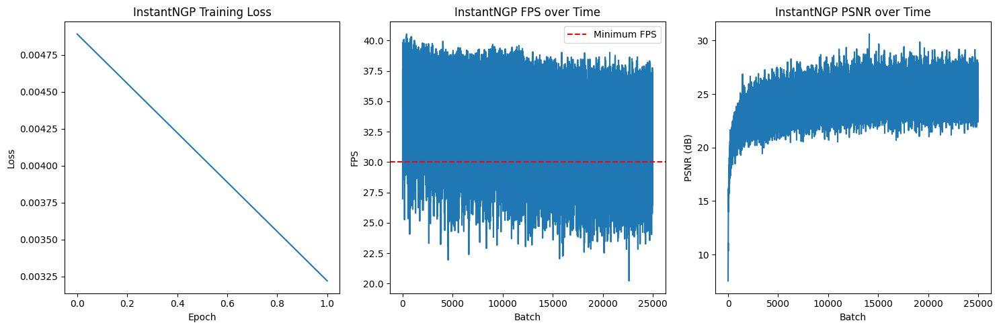






InstantNGP Training Progress:  20%|██        | 25001/125000 [14:34<4:41:46,  5.91it/s]




InstantNGP Training Progress:  20%|██        | 25004/125000 [14:34<3:37:07,  7.68it/s]


InstantNGP Epoch 3/10, Batch 0:
FPS: 30.80, Latency: 32.47ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:  20%|██        | 25007/125000 [14:35<2:51:29,  9.72it/s]




InstantNGP Training Progress:  20%|██        | 25010/125000 [14:35<2:17:49, 12.09it/s]




InstantNGP Training Progress:  20%|██        | 25013/125000 [14:35<1:55:47, 14.39it/s]




InstantNGP Training Progress:  20%|██        | 25016/125000 [14:35<1:39:02, 16.83it/s]


InstantNGP Epoch 3/10, Batch 10:
FPS: 30.72, Latency: 32.55ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  20%|██        | 25019/125000 [14:35<1:26:58, 19.16it/s]




InstantNGP Training Progress:  20%|██        | 25022/125000 [14:35<1:18:32, 21.22it/s]




InstantNGP Training Progress:  20%|██        | 25025/125000 [14:35<1:14:05, 22.49it/s]


InstantNGP Epoch 3/10, Batch 20:
FPS: 37.62, Latency: 26.58ms
PSNR: 23.61dB, Loss: 0.0044







InstantNGP Training Progress:  20%|██        | 25028/125000 [14:35<1:09:38, 23.92it/s]




InstantNGP Training Progress:  20%|██        | 25031/125000 [14:35<1:05:44, 25.34it/s]




InstantNGP Training Progress:  20%|██        | 25034/125000 [14:36<1:03:22, 26.29it/s]


InstantNGP Epoch 3/10, Batch 30:
FPS: 35.71, Latency: 28.00ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  20%|██        | 25037/125000 [14:36<1:02:01, 26.86it/s]




InstantNGP Training Progress:  20%|██        | 25041/125000 [14:36<59:31, 27.99it/s]  




InstantNGP Training Progress:  20%|██        | 25044/125000 [14:36<1:00:55, 27.35it/s]


InstantNGP Epoch 3/10, Batch 40:
FPS: 32.29, Latency: 30.97ms
PSNR: 22.21dB, Loss: 0.0060







InstantNGP Training Progress:  20%|██        | 25047/125000 [14:36<1:01:24, 27.13it/s]




InstantNGP Training Progress:  20%|██        | 25050/125000 [14:36<1:01:09, 27.24it/s]




InstantNGP Training Progress:  20%|██        | 25053/125000 [14:36<1:01:19, 27.16it/s]




InstantNGP Training Progress:  20%|██        | 25056/125000 [14:36<1:00:27, 27.55it/s]


InstantNGP Epoch 3/10, Batch 50:
FPS: 24.78, Latency: 40.35ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  20%|██        | 25060/125000 [14:37<58:40, 28.39it/s]  




InstantNGP Training Progress:  20%|██        | 25063/125000 [14:37<1:01:22, 27.14it/s]




InstantNGP Training Progress:  20%|██        | 25066/125000 [14:37<1:00:01, 27.75it/s]


InstantNGP Epoch 3/10, Batch 60:
FPS: 25.11, Latency: 39.82ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  20%|██        | 25069/125000 [14:37<59:30, 27.99it/s]  




InstantNGP Training Progress:  20%|██        | 25072/125000 [14:37<59:09, 28.15it/s]




InstantNGP Training Progress:  20%|██        | 25075/125000 [14:37<58:14, 28.60it/s]


InstantNGP Epoch 3/10, Batch 70:
FPS: 34.70, Latency: 28.82ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  20%|██        | 25078/125000 [14:37<58:38, 28.40it/s]




InstantNGP Training Progress:  20%|██        | 25081/125000 [14:37<1:00:04, 27.72it/s]




InstantNGP Training Progress:  20%|██        | 25085/125000 [14:37<57:02, 29.19it/s]  


InstantNGP Epoch 3/10, Batch 80:
FPS: 29.32, Latency: 34.11ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  20%|██        | 25089/125000 [14:38<55:32, 29.98it/s]




InstantNGP Training Progress:  20%|██        | 25092/125000 [14:38<56:04, 29.70it/s]




InstantNGP Training Progress:  20%|██        | 25096/125000 [14:38<55:21, 30.07it/s]


InstantNGP Epoch 3/10, Batch 90:
FPS: 31.04, Latency: 32.21ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  20%|██        | 25099/125000 [14:38<55:50, 29.82it/s]




InstantNGP Training Progress:  20%|██        | 25103/125000 [14:38<55:44, 29.87it/s]




InstantNGP Training Progress:  20%|██        | 25106/125000 [14:38<57:17, 29.06it/s]


InstantNGP Epoch 3/10, Batch 100:
FPS: 35.69, Latency: 28.02ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  20%|██        | 25109/125000 [14:38<57:33, 28.92it/s]




InstantNGP Training Progress:  20%|██        | 25113/125000 [14:38<56:15, 29.60it/s]




InstantNGP Training Progress:  20%|██        | 25116/125000 [14:38<56:37, 29.40it/s]


InstantNGP Epoch 3/10, Batch 110:
FPS: 34.52, Latency: 28.97ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  20%|██        | 25120/125000 [14:39<55:07, 30.20it/s]




InstantNGP Training Progress:  20%|██        | 25124/125000 [14:39<56:06, 29.67it/s]


InstantNGP Epoch 3/10, Batch 120:
FPS: 35.03, Latency: 28.55ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  20%|██        | 25127/125000 [14:39<57:59, 28.70it/s]




InstantNGP Training Progress:  20%|██        | 25130/125000 [14:39<58:33, 28.43it/s]




InstantNGP Training Progress:  20%|██        | 25133/125000 [14:39<1:01:11, 27.20it/s]




InstantNGP Training Progress:  20%|██        | 25136/125000 [14:39<1:02:50, 26.49it/s]


InstantNGP Epoch 3/10, Batch 130:
FPS: 26.23, Latency: 38.13ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  20%|██        | 25139/125000 [14:39<1:01:38, 27.00it/s]




InstantNGP Training Progress:  20%|██        | 25142/125000 [14:39<1:03:33, 26.18it/s]




InstantNGP Training Progress:  20%|██        | 25146/125000 [14:40<1:00:02, 27.71it/s]


InstantNGP Epoch 3/10, Batch 140:
FPS: 25.87, Latency: 38.65ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  20%|██        | 25150/125000 [14:40<58:21, 28.51it/s]  




InstantNGP Training Progress:  20%|██        | 25153/125000 [14:40<58:54, 28.25it/s]




InstantNGP Training Progress:  20%|██        | 25156/125000 [14:40<59:16, 28.07it/s]


InstantNGP Epoch 3/10, Batch 150:
FPS: 33.81, Latency: 29.58ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  20%|██        | 25159/125000 [14:40<1:00:29, 27.51it/s]




InstantNGP Training Progress:  20%|██        | 25163/125000 [14:40<58:44, 28.33it/s]  







InstantNGP Epoch 3/10, Batch 160:
FPS: 36.20, Latency: 27.63ms
PSNR: 23.82dB, Loss: 0.0041


InstantNGP Training Progress:  20%|██        | 25167/125000 [14:40<57:31, 28.93it/s]




InstantNGP Training Progress:  20%|██        | 25170/125000 [14:40<57:11, 29.09it/s]




InstantNGP Training Progress:  20%|██        | 25173/125000 [14:40<58:17, 28.55it/s]




InstantNGP Training Progress:  20%|██        | 25176/125000 [14:41<58:51, 28.26it/s]


InstantNGP Epoch 3/10, Batch 170:
FPS: 31.76, Latency: 31.49ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  20%|██        | 25179/125000 [14:41<58:54, 28.25it/s]




InstantNGP Training Progress:  20%|██        | 25182/125000 [14:41<59:04, 28.16it/s]




InstantNGP Training Progress:  20%|██        | 25185/125000 [14:41<59:06, 28.14it/s]


InstantNGP Epoch 3/10, Batch 180:
FPS: 29.96, Latency: 33.38ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  20%|██        | 25188/125000 [14:41<59:17, 28.05it/s]




InstantNGP Training Progress:  20%|██        | 25191/125000 [14:41<58:34, 28.40it/s]




InstantNGP Training Progress:  20%|██        | 25194/125000 [14:41<58:33, 28.40it/s]


InstantNGP Epoch 3/10, Batch 190:
FPS: 34.44, Latency: 29.03ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  20%|██        | 25197/125000 [14:41<58:03, 28.65it/s]




InstantNGP Training Progress:  20%|██        | 25201/125000 [14:41<57:18, 29.02it/s]




InstantNGP Training Progress:  20%|██        | 25204/125000 [14:42<56:51, 29.25it/s]


InstantNGP Epoch 3/10, Batch 200:
FPS: 32.00, Latency: 31.25ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  20%|██        | 25207/125000 [14:42<56:58, 29.19it/s]




InstantNGP Training Progress:  20%|██        | 25210/125000 [14:42<57:16, 29.04it/s]




InstantNGP Training Progress:  20%|██        | 25213/125000 [14:42<57:32, 28.90it/s]




InstantNGP Training Progress:  20%|██        | 25216/125000 [14:42<59:14, 28.08it/s]


InstantNGP Epoch 3/10, Batch 210:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  20%|██        | 25219/125000 [14:42<58:13, 28.56it/s]




InstantNGP Training Progress:  20%|██        | 25222/125000 [14:42<58:21, 28.50it/s]




InstantNGP Training Progress:  20%|██        | 25225/125000 [14:42<58:36, 28.37it/s]


InstantNGP Epoch 3/10, Batch 220:
FPS: 35.57, Latency: 28.12ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  20%|██        | 25229/125000 [14:42<56:33, 29.40it/s]




InstantNGP Training Progress:  20%|██        | 25232/125000 [14:43<56:40, 29.34it/s]




InstantNGP Training Progress:  20%|██        | 25235/125000 [14:43<56:51, 29.24it/s]


InstantNGP Epoch 3/10, Batch 230:
FPS: 32.20, Latency: 31.06ms
PSNR: 27.24dB, Loss: 0.0019







InstantNGP Training Progress:  20%|██        | 25238/125000 [14:43<57:28, 28.93it/s]




InstantNGP Training Progress:  20%|██        | 25241/125000 [14:43<58:05, 28.62it/s]




InstantNGP Training Progress:  20%|██        | 25244/125000 [14:43<58:58, 28.19it/s]


InstantNGP Epoch 3/10, Batch 240:
FPS: 32.36, Latency: 30.90ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  20%|██        | 25247/125000 [14:43<59:06, 28.13it/s]




InstantNGP Training Progress:  20%|██        | 25251/125000 [14:43<57:15, 29.03it/s]




InstantNGP Training Progress:  20%|██        | 25254/125000 [14:43<57:20, 28.99it/s]


InstantNGP Epoch 3/10, Batch 250:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  20%|██        | 25257/125000 [14:43<58:31, 28.41it/s]




InstantNGP Training Progress:  20%|██        | 25260/125000 [14:43<57:40, 28.83it/s]




InstantNGP Training Progress:  20%|██        | 25263/125000 [14:44<57:49, 28.75it/s]




InstantNGP Training Progress:  20%|██        | 25266/125000 [14:44<59:22, 28.00it/s]


InstantNGP Epoch 3/10, Batch 260:
FPS: 30.36, Latency: 32.94ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  20%|██        | 25269/125000 [14:44<59:05, 28.13it/s]




InstantNGP Training Progress:  20%|██        | 25272/125000 [14:44<1:01:25, 27.06it/s]




InstantNGP Training Progress:  20%|██        | 25275/125000 [14:44<1:02:12, 26.72it/s]


InstantNGP Epoch 3/10, Batch 270:
FPS: 30.25, Latency: 33.06ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  20%|██        | 25279/125000 [14:44<59:43, 27.83it/s]  




InstantNGP Training Progress:  20%|██        | 25283/125000 [14:44<57:48, 28.75it/s]




InstantNGP Training Progress:  20%|██        | 25287/125000 [14:44<55:43, 29.83it/s]


InstantNGP Epoch 3/10, Batch 280:
FPS: 31.33, Latency: 31.92ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  20%|██        | 25290/125000 [14:45<56:59, 29.16it/s]




InstantNGP Training Progress:  20%|██        | 25293/125000 [14:45<56:37, 29.35it/s]




InstantNGP Training Progress:  20%|██        | 25297/125000 [14:45<55:37, 29.88it/s]


InstantNGP Epoch 3/10, Batch 290:
FPS: 37.14, Latency: 26.92ms
PSNR: 22.25dB, Loss: 0.0060







InstantNGP Training Progress:  20%|██        | 25300/125000 [14:45<56:24, 29.46it/s]




InstantNGP Training Progress:  20%|██        | 25303/125000 [14:45<57:48, 28.75it/s]




InstantNGP Training Progress:  20%|██        | 25307/125000 [14:45<56:30, 29.40it/s]


InstantNGP Epoch 3/10, Batch 300:
FPS: 25.58, Latency: 39.09ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:  20%|██        | 25310/125000 [14:45<56:29, 29.41it/s]




InstantNGP Training Progress:  20%|██        | 25314/125000 [14:45<55:30, 29.93it/s]




InstantNGP Training Progress:  20%|██        | 25317/125000 [14:45<55:44, 29.80it/s]


InstantNGP Epoch 3/10, Batch 310:
FPS: 33.56, Latency: 29.79ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  20%|██        | 25320/125000 [14:46<56:11, 29.56it/s]




InstantNGP Training Progress:  20%|██        | 25323/125000 [14:46<57:10, 29.06it/s]




InstantNGP Training Progress:  20%|██        | 25327/125000 [14:46<55:54, 29.71it/s]


InstantNGP Epoch 3/10, Batch 320:
FPS: 31.33, Latency: 31.92ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  20%|██        | 25330/125000 [14:46<56:15, 29.53it/s]




InstantNGP Training Progress:  20%|██        | 25333/125000 [14:46<59:08, 28.08it/s]




InstantNGP Training Progress:  20%|██        | 25336/125000 [14:46<59:14, 28.04it/s]


InstantNGP Epoch 3/10, Batch 330:
FPS: 31.21, Latency: 32.04ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  20%|██        | 25339/125000 [14:46<58:51, 28.22it/s]




InstantNGP Training Progress:  20%|██        | 25342/125000 [14:46<58:53, 28.21it/s]




InstantNGP Training Progress:  20%|██        | 25345/125000 [14:46<58:57, 28.17it/s]


InstantNGP Epoch 3/10, Batch 340:
FPS: 28.25, Latency: 35.40ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  20%|██        | 25348/125000 [14:47<58:58, 28.16it/s]




InstantNGP Training Progress:  20%|██        | 25351/125000 [14:47<1:01:03, 27.20it/s]




InstantNGP Training Progress:  20%|██        | 25355/125000 [14:47<58:44, 28.27it/s]  


InstantNGP Epoch 3/10, Batch 350:
FPS: 27.84, Latency: 35.93ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  20%|██        | 25358/125000 [14:47<59:16, 28.02it/s]




InstantNGP Training Progress:  20%|██        | 25361/125000 [14:47<58:19, 28.48it/s]




InstantNGP Training Progress:  20%|██        | 25365/125000 [14:47<56:53, 29.19it/s]


InstantNGP Epoch 3/10, Batch 360:
FPS: 36.81, Latency: 27.17ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  20%|██        | 25368/125000 [14:47<56:32, 29.37it/s]




InstantNGP Training Progress:  20%|██        | 25371/125000 [14:47<56:23, 29.45it/s]




InstantNGP Training Progress:  20%|██        | 25374/125000 [14:47<58:20, 28.46it/s]


InstantNGP Epoch 3/10, Batch 370:
FPS: 30.90, Latency: 32.36ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  20%|██        | 25377/125000 [14:48<58:20, 28.46it/s]




InstantNGP Training Progress:  20%|██        | 25380/125000 [14:48<59:15, 28.02it/s]




InstantNGP Training Progress:  20%|██        | 25384/125000 [14:48<58:02, 28.60it/s]


InstantNGP Epoch 3/10, Batch 380:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  20%|██        | 25387/125000 [14:48<58:56, 28.17it/s]




InstantNGP Training Progress:  20%|██        | 25390/125000 [14:48<59:06, 28.08it/s]




InstantNGP Training Progress:  20%|██        | 25393/125000 [14:48<59:17, 28.00it/s]




InstantNGP Training Progress:  20%|██        | 25396/125000 [14:48<1:00:43, 27.33it/s]


InstantNGP Epoch 3/10, Batch 390:
FPS: 30.56, Latency: 32.72ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  20%|██        | 25399/125000 [14:48<1:00:05, 27.62it/s]




InstantNGP Training Progress:  20%|██        | 25402/125000 [14:48<59:43, 27.79it/s]  




InstantNGP Training Progress:  20%|██        | 25405/125000 [14:49<59:05, 28.09it/s]


InstantNGP Epoch 3/10, Batch 400:
FPS: 28.74, Latency: 34.79ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  20%|██        | 25408/125000 [14:49<58:02, 28.60it/s]




InstantNGP Training Progress:  20%|██        | 25411/125000 [14:49<58:15, 28.49it/s]




InstantNGP Training Progress:  20%|██        | 25414/125000 [14:49<59:20, 27.97it/s]


InstantNGP Epoch 3/10, Batch 410:
FPS: 29.24, Latency: 34.19ms
PSNR: 27.10dB, Loss: 0.0020







InstantNGP Training Progress:  20%|██        | 25417/125000 [14:49<1:00:54, 27.25it/s]




InstantNGP Training Progress:  20%|██        | 25420/125000 [14:49<1:01:27, 27.01it/s]




InstantNGP Training Progress:  20%|██        | 25424/125000 [14:49<58:41, 28.28it/s]  


InstantNGP Epoch 3/10, Batch 420:
FPS: 33.71, Latency: 29.67ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  20%|██        | 25428/125000 [14:49<57:27, 28.88it/s]




InstantNGP Training Progress:  20%|██        | 25431/125000 [14:49<57:06, 29.06it/s]




InstantNGP Training Progress:  20%|██        | 25435/125000 [14:50<56:08, 29.55it/s]


InstantNGP Epoch 3/10, Batch 430:
FPS: 31.24, Latency: 32.01ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  20%|██        | 25439/125000 [14:50<55:26, 29.93it/s]




InstantNGP Training Progress:  20%|██        | 25442/125000 [14:50<56:07, 29.56it/s]




InstantNGP Training Progress:  20%|██        | 25445/125000 [14:50<56:36, 29.31it/s]


InstantNGP Epoch 3/10, Batch 440:
FPS: 31.14, Latency: 32.11ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  20%|██        | 25448/125000 [14:50<56:24, 29.41it/s]




InstantNGP Training Progress:  20%|██        | 25452/125000 [14:50<55:22, 29.96it/s]




InstantNGP Training Progress:  20%|██        | 25455/125000 [14:50<55:55, 29.67it/s]


InstantNGP Epoch 3/10, Batch 450:
FPS: 36.34, Latency: 27.52ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  20%|██        | 25458/125000 [14:50<56:19, 29.46it/s]




InstantNGP Training Progress:  20%|██        | 25461/125000 [14:50<56:05, 29.58it/s]




InstantNGP Training Progress:  20%|██        | 25465/125000 [14:51<54:20, 30.52it/s]


InstantNGP Epoch 3/10, Batch 460:
FPS: 37.36, Latency: 26.77ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  20%|██        | 25469/125000 [14:51<54:48, 30.26it/s]




InstantNGP Training Progress:  20%|██        | 25473/125000 [14:51<55:56, 29.66it/s]




InstantNGP Training Progress:  20%|██        | 25477/125000 [14:51<55:07, 30.09it/s]


InstantNGP Epoch 3/10, Batch 470:
FPS: 29.58, Latency: 33.80ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  20%|██        | 25481/125000 [14:51<55:32, 29.86it/s]




InstantNGP Training Progress:  20%|██        | 25484/125000 [14:51<56:54, 29.15it/s]


InstantNGP Epoch 3/10, Batch 480:
FPS: 26.48, Latency: 37.76ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  20%|██        | 25487/125000 [14:51<56:43, 29.24it/s]




InstantNGP Training Progress:  20%|██        | 25490/125000 [14:51<58:15, 28.47it/s]




InstantNGP Training Progress:  20%|██        | 25493/125000 [14:52<58:21, 28.42it/s]




InstantNGP Training Progress:  20%|██        | 25497/125000 [14:52<56:39, 29.27it/s]


InstantNGP Epoch 3/10, Batch 490:
FPS: 28.08, Latency: 35.61ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  20%|██        | 25500/125000 [14:52<58:24, 28.39it/s]




InstantNGP Training Progress:  20%|██        | 25503/125000 [14:52<58:47, 28.21it/s]




InstantNGP Training Progress:  20%|██        | 25506/125000 [14:52<58:33, 28.32it/s]


InstantNGP Epoch 3/10, Batch 500:
FPS: 29.41, Latency: 34.01ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:  20%|██        | 25509/125000 [14:52<59:04, 28.07it/s]




InstantNGP Training Progress:  20%|██        | 25513/125000 [14:52<56:48, 29.19it/s]




InstantNGP Training Progress:  20%|██        | 25516/125000 [14:52<57:18, 28.93it/s]


InstantNGP Epoch 3/10, Batch 510:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  20%|██        | 25519/125000 [14:52<57:05, 29.04it/s]




InstantNGP Training Progress:  20%|██        | 25522/125000 [14:53<58:48, 28.20it/s]




InstantNGP Training Progress:  20%|██        | 25525/125000 [14:53<1:01:14, 27.07it/s]


InstantNGP Epoch 3/10, Batch 520:
FPS: 31.22, Latency: 32.03ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  20%|██        | 25528/125000 [14:53<1:01:11, 27.09it/s]




InstantNGP Training Progress:  20%|██        | 25531/125000 [14:53<1:04:07, 25.85it/s]




InstantNGP Training Progress:  20%|██        | 25534/125000 [14:53<1:04:28, 25.71it/s]


InstantNGP Epoch 3/10, Batch 530:
FPS: 26.01, Latency: 38.45ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  20%|██        | 25537/125000 [14:53<1:03:13, 26.22it/s]




InstantNGP Training Progress:  20%|██        | 25540/125000 [14:53<1:01:50, 26.81it/s]




InstantNGP Training Progress:  20%|██        | 25543/125000 [14:53<1:01:49, 26.81it/s]




InstantNGP Training Progress:  20%|██        | 25546/125000 [14:54<1:01:40, 26.87it/s]


InstantNGP Epoch 3/10, Batch 540:
FPS: 27.00, Latency: 37.04ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  20%|██        | 25549/125000 [14:54<1:00:39, 27.32it/s]




InstantNGP Training Progress:  20%|██        | 25553/125000 [14:54<57:56, 28.61it/s]  




InstantNGP Training Progress:  20%|██        | 25556/125000 [14:54<57:26, 28.86it/s]


InstantNGP Epoch 3/10, Batch 550:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  20%|██        | 25560/125000 [14:54<55:58, 29.61it/s]




InstantNGP Training Progress:  20%|██        | 25563/125000 [14:54<56:04, 29.56it/s]




InstantNGP Training Progress:  20%|██        | 25567/125000 [14:54<55:11, 30.03it/s]


InstantNGP Epoch 3/10, Batch 560:
FPS: 37.00, Latency: 27.02ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  20%|██        | 25570/125000 [14:54<55:22, 29.92it/s]




InstantNGP Training Progress:  20%|██        | 25574/125000 [14:54<54:43, 30.28it/s]


InstantNGP Epoch 3/10, Batch 570:
FPS: 36.41, Latency: 27.47ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  20%|██        | 25578/125000 [14:55<54:37, 30.33it/s]




InstantNGP Training Progress:  20%|██        | 25582/125000 [14:55<53:41, 30.86it/s]




InstantNGP Training Progress:  20%|██        | 25586/125000 [14:55<53:29, 30.98it/s]


InstantNGP Epoch 3/10, Batch 580:
FPS: 35.54, Latency: 28.13ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  20%|██        | 25590/125000 [14:55<56:48, 29.17it/s]




InstantNGP Training Progress:  20%|██        | 25593/125000 [14:55<58:18, 28.41it/s]




InstantNGP Training Progress:  20%|██        | 25596/125000 [14:55<57:30, 28.81it/s]


InstantNGP Epoch 3/10, Batch 590:
FPS: 29.46, Latency: 33.94ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  20%|██        | 25599/125000 [14:55<57:02, 29.04it/s]




InstantNGP Training Progress:  20%|██        | 25602/125000 [14:55<57:56, 28.59it/s]




InstantNGP Training Progress:  20%|██        | 25605/125000 [14:56<57:40, 28.72it/s]


InstantNGP Epoch 3/10, Batch 600:
FPS: 33.00, Latency: 30.30ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  20%|██        | 25608/125000 [14:56<58:39, 28.24it/s]




InstantNGP Training Progress:  20%|██        | 25611/125000 [14:56<58:08, 28.49it/s]




InstantNGP Training Progress:  20%|██        | 25614/125000 [14:56<57:31, 28.79it/s]


InstantNGP Epoch 3/10, Batch 610:
FPS: 36.40, Latency: 27.48ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  20%|██        | 25617/125000 [14:56<58:22, 28.37it/s]




InstantNGP Training Progress:  20%|██        | 25621/125000 [14:56<57:25, 28.85it/s]




InstantNGP Training Progress:  20%|██        | 25624/125000 [14:56<57:30, 28.80it/s]


InstantNGP Epoch 3/10, Batch 620:
FPS: 31.68, Latency: 31.57ms
PSNR: 23.47dB, Loss: 0.0045







InstantNGP Training Progress:  21%|██        | 25627/125000 [14:56<57:31, 28.79it/s]




InstantNGP Training Progress:  21%|██        | 25631/125000 [14:56<55:30, 29.83it/s]




InstantNGP Training Progress:  21%|██        | 25634/125000 [14:57<56:44, 29.19it/s]


InstantNGP Epoch 3/10, Batch 630:
FPS: 34.70, Latency: 28.82ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  21%|██        | 25638/125000 [14:57<55:55, 29.61it/s]




InstantNGP Training Progress:  21%|██        | 25641/125000 [14:57<56:22, 29.37it/s]




InstantNGP Training Progress:  21%|██        | 25644/125000 [14:57<57:03, 29.03it/s]


InstantNGP Epoch 3/10, Batch 640:
FPS: 35.63, Latency: 28.06ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 25647/125000 [14:57<58:48, 28.16it/s]




InstantNGP Training Progress:  21%|██        | 25650/125000 [14:57<59:20, 27.91it/s]




InstantNGP Training Progress:  21%|██        | 25653/125000 [14:57<58:42, 28.20it/s]




InstantNGP Training Progress:  21%|██        | 25656/125000 [14:57<59:01, 28.05it/s]


InstantNGP Epoch 3/10, Batch 650:
FPS: 34.09, Latency: 29.34ms
PSNR: 27.63dB, Loss: 0.0017







InstantNGP Training Progress:  21%|██        | 25659/125000 [14:57<58:43, 28.19it/s]




InstantNGP Training Progress:  21%|██        | 25662/125000 [14:58<58:07, 28.48it/s]




InstantNGP Training Progress:  21%|██        | 25666/125000 [14:58<56:34, 29.26it/s]


InstantNGP Epoch 3/10, Batch 660:
FPS: 32.14, Latency: 31.11ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 25669/125000 [14:58<56:50, 29.12it/s]




InstantNGP Training Progress:  21%|██        | 25672/125000 [14:58<56:42, 29.19it/s]




InstantNGP Training Progress:  21%|██        | 25675/125000 [14:58<58:35, 28.25it/s]


InstantNGP Epoch 3/10, Batch 670:
FPS: 29.77, Latency: 33.59ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  21%|██        | 25678/125000 [14:58<58:01, 28.53it/s]




InstantNGP Training Progress:  21%|██        | 25681/125000 [14:58<58:03, 28.51it/s]




InstantNGP Training Progress:  21%|██        | 25685/125000 [14:58<56:05, 29.51it/s]


InstantNGP Epoch 3/10, Batch 680:
FPS: 31.66, Latency: 31.59ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 25689/125000 [14:58<54:57, 30.11it/s]




InstantNGP Training Progress:  21%|██        | 25692/125000 [14:59<55:12, 29.98it/s]




InstantNGP Training Progress:  21%|██        | 25696/125000 [14:59<55:22, 29.89it/s]


InstantNGP Epoch 3/10, Batch 690:
FPS: 30.30, Latency: 33.01ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  21%|██        | 25699/125000 [14:59<55:21, 29.90it/s]




InstantNGP Training Progress:  21%|██        | 25702/125000 [14:59<56:07, 29.49it/s]




InstantNGP Training Progress:  21%|██        | 25706/125000 [14:59<54:29, 30.37it/s]


InstantNGP Epoch 3/10, Batch 700:
FPS: 31.98, Latency: 31.27ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:  21%|██        | 25710/125000 [14:59<55:20, 29.90it/s]




InstantNGP Training Progress:  21%|██        | 25713/125000 [14:59<56:30, 29.28it/s]




InstantNGP Training Progress:  21%|██        | 25716/125000 [14:59<57:49, 28.62it/s]


InstantNGP Epoch 3/10, Batch 710:
FPS: 29.15, Latency: 34.31ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██        | 25719/125000 [14:59<57:55, 28.57it/s]




InstantNGP Training Progress:  21%|██        | 25722/125000 [15:00<58:13, 28.41it/s]




InstantNGP Training Progress:  21%|██        | 25726/125000 [15:00<56:13, 29.43it/s]


InstantNGP Epoch 3/10, Batch 720:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  21%|██        | 25729/125000 [15:00<56:19, 29.38it/s]




InstantNGP Training Progress:  21%|██        | 25732/125000 [15:00<57:29, 28.78it/s]




InstantNGP Training Progress:  21%|██        | 25736/125000 [15:00<56:38, 29.21it/s]


InstantNGP Epoch 3/10, Batch 730:
FPS: 28.29, Latency: 35.35ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  21%|██        | 25739/125000 [15:00<56:32, 29.26it/s]




InstantNGP Training Progress:  21%|██        | 25742/125000 [15:00<57:18, 28.86it/s]




InstantNGP Training Progress:  21%|██        | 25746/125000 [15:00<56:20, 29.36it/s]


InstantNGP Epoch 3/10, Batch 740:
FPS: 31.92, Latency: 31.33ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 25749/125000 [15:00<56:46, 29.13it/s]




InstantNGP Training Progress:  21%|██        | 25752/125000 [15:01<56:58, 29.03it/s]




InstantNGP Training Progress:  21%|██        | 25755/125000 [15:01<57:18, 28.86it/s]


InstantNGP Epoch 3/10, Batch 750:
FPS: 32.73, Latency: 30.55ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  21%|██        | 25758/125000 [15:01<58:11, 28.43it/s]




InstantNGP Training Progress:  21%|██        | 25761/125000 [15:01<58:32, 28.25it/s]




InstantNGP Training Progress:  21%|██        | 25764/125000 [15:01<57:39, 28.68it/s]


InstantNGP Epoch 3/10, Batch 760:
FPS: 29.32, Latency: 34.11ms
PSNR: 27.42dB, Loss: 0.0018







InstantNGP Training Progress:  21%|██        | 25767/125000 [15:01<57:38, 28.69it/s]




InstantNGP Training Progress:  21%|██        | 25770/125000 [15:01<57:32, 28.74it/s]




InstantNGP Training Progress:  21%|██        | 25774/125000 [15:01<56:26, 29.30it/s]




InstantNGP Training Progress:  21%|██        | 25777/125000 [15:01<56:27, 29.29it/s]


InstantNGP Epoch 3/10, Batch 770:
FPS: 31.51, Latency: 31.73ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  21%|██        | 25780/125000 [15:02<56:58, 29.02it/s]




InstantNGP Training Progress:  21%|██        | 25783/125000 [15:02<57:16, 28.87it/s]




InstantNGP Training Progress:  21%|██        | 25786/125000 [15:02<57:33, 28.73it/s]


InstantNGP Epoch 3/10, Batch 780:
FPS: 28.11, Latency: 35.57ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  21%|██        | 25790/125000 [15:02<55:32, 29.77it/s]




InstantNGP Training Progress:  21%|██        | 25793/125000 [15:02<55:59, 29.53it/s]




InstantNGP Training Progress:  21%|██        | 25797/125000 [15:02<55:12, 29.95it/s]


InstantNGP Epoch 3/10, Batch 790:
FPS: 31.07, Latency: 32.19ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  21%|██        | 25801/125000 [15:02<55:08, 29.99it/s]




InstantNGP Training Progress:  21%|██        | 25804/125000 [15:02<55:31, 29.78it/s]


InstantNGP Epoch 3/10, Batch 800:
FPS: 29.50, Latency: 33.90ms
PSNR: 28.57dB, Loss: 0.0014







InstantNGP Training Progress:  21%|██        | 25807/125000 [15:02<55:24, 29.84it/s]




InstantNGP Training Progress:  21%|██        | 25810/125000 [15:03<55:32, 29.76it/s]




InstantNGP Training Progress:  21%|██        | 25813/125000 [15:03<58:16, 28.37it/s]


InstantNGP Epoch 3/10, Batch 810:
FPS: 26.21, Latency: 38.16ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 25817/125000 [15:03<56:47, 29.11it/s]




InstantNGP Training Progress:  21%|██        | 25820/125000 [15:03<58:39, 28.18it/s]




InstantNGP Training Progress:  21%|██        | 25823/125000 [15:03<59:14, 27.90it/s]




InstantNGP Training Progress:  21%|██        | 25827/125000 [15:03<56:18, 29.36it/s]


InstantNGP Epoch 3/10, Batch 820:
FPS: 29.38, Latency: 34.03ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██        | 25831/125000 [15:03<55:23, 29.84it/s]




InstantNGP Training Progress:  21%|██        | 25834/125000 [15:03<56:35, 29.20it/s]


InstantNGP Epoch 3/10, Batch 830:
FPS: 31.70, Latency: 31.54ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██        | 25838/125000 [15:04<55:51, 29.59it/s]




InstantNGP Training Progress:  21%|██        | 25841/125000 [15:04<56:32, 29.23it/s]




InstantNGP Training Progress:  21%|██        | 25844/125000 [15:04<56:21, 29.33it/s]


InstantNGP Epoch 3/10, Batch 840:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██        | 25848/125000 [15:04<56:26, 29.28it/s]




InstantNGP Training Progress:  21%|██        | 25851/125000 [15:04<57:58, 28.50it/s]




InstantNGP Training Progress:  21%|██        | 25854/125000 [15:04<59:46, 27.64it/s]


InstantNGP Epoch 3/10, Batch 850:
FPS: 34.28, Latency: 29.18ms
PSNR: 22.27dB, Loss: 0.0059







InstantNGP Training Progress:  21%|██        | 25857/125000 [15:04<58:42, 28.14it/s]




InstantNGP Training Progress:  21%|██        | 25860/125000 [15:04<59:13, 27.90it/s]




InstantNGP Training Progress:  21%|██        | 25863/125000 [15:04<1:00:13, 27.44it/s]




InstantNGP Training Progress:  21%|██        | 25866/125000 [15:05<59:10, 27.92it/s]  


InstantNGP Epoch 3/10, Batch 860:
FPS: 28.23, Latency: 35.42ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 25870/125000 [15:05<57:54, 28.53it/s]




InstantNGP Training Progress:  21%|██        | 25873/125000 [15:05<58:26, 28.27it/s]




InstantNGP Training Progress:  21%|██        | 25876/125000 [15:05<59:38, 27.70it/s]


InstantNGP Epoch 3/10, Batch 870:
FPS: 28.46, Latency: 35.14ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  21%|██        | 25879/125000 [15:05<1:01:42, 26.77it/s]




InstantNGP Training Progress:  21%|██        | 25882/125000 [15:05<1:01:34, 26.83it/s]




InstantNGP Training Progress:  21%|██        | 25885/125000 [15:05<1:02:17, 26.52it/s]


InstantNGP Epoch 3/10, Batch 880:
FPS: 29.49, Latency: 33.91ms
PSNR: 26.48dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 25888/125000 [15:05<1:02:53, 26.27it/s]




InstantNGP Training Progress:  21%|██        | 25891/125000 [15:05<1:01:52, 26.70it/s]




InstantNGP Training Progress:  21%|██        | 25894/125000 [15:06<1:00:47, 27.17it/s]


InstantNGP Epoch 3/10, Batch 890:
FPS: 29.26, Latency: 34.18ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  21%|██        | 25897/125000 [15:06<59:29, 27.76it/s]  




InstantNGP Training Progress:  21%|██        | 25901/125000 [15:06<57:08, 28.91it/s]




InstantNGP Training Progress:  21%|██        | 25904/125000 [15:06<57:09, 28.89it/s]


InstantNGP Epoch 3/10, Batch 900:
FPS: 37.72, Latency: 26.51ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 25907/125000 [15:06<58:00, 28.47it/s]




InstantNGP Training Progress:  21%|██        | 25910/125000 [15:06<57:30, 28.72it/s]




InstantNGP Training Progress:  21%|██        | 25913/125000 [15:06<57:06, 28.91it/s]




InstantNGP Training Progress:  21%|██        | 25916/125000 [15:06<56:51, 29.05it/s]


InstantNGP Epoch 3/10, Batch 910:
FPS: 35.99, Latency: 27.78ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  21%|██        | 25919/125000 [15:06<56:40, 29.14it/s]




InstantNGP Training Progress:  21%|██        | 25922/125000 [15:07<56:51, 29.04it/s]




InstantNGP Training Progress:  21%|██        | 25925/125000 [15:07<56:33, 29.19it/s]


InstantNGP Epoch 3/10, Batch 920:
FPS: 30.33, Latency: 32.97ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██        | 25928/125000 [15:07<56:16, 29.34it/s]




InstantNGP Training Progress:  21%|██        | 25931/125000 [15:07<56:06, 29.43it/s]




InstantNGP Training Progress:  21%|██        | 25934/125000 [15:07<55:50, 29.57it/s]


InstantNGP Epoch 3/10, Batch 930:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██        | 25937/125000 [15:07<56:21, 29.30it/s]




InstantNGP Training Progress:  21%|██        | 25940/125000 [15:07<56:37, 29.16it/s]




InstantNGP Training Progress:  21%|██        | 25943/125000 [15:07<56:37, 29.15it/s]




InstantNGP Training Progress:  21%|██        | 25946/125000 [15:07<58:34, 28.18it/s]


InstantNGP Epoch 3/10, Batch 940:
FPS: 30.35, Latency: 32.95ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  21%|██        | 25949/125000 [15:07<58:16, 28.33it/s]




InstantNGP Training Progress:  21%|██        | 25952/125000 [15:08<58:42, 28.12it/s]




InstantNGP Training Progress:  21%|██        | 25956/125000 [15:08<56:31, 29.21it/s]


InstantNGP Epoch 3/10, Batch 950:
FPS: 28.23, Latency: 35.42ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  21%|██        | 25959/125000 [15:08<56:28, 29.22it/s]




InstantNGP Training Progress:  21%|██        | 25962/125000 [15:08<56:29, 29.22it/s]




InstantNGP Training Progress:  21%|██        | 25966/125000 [15:08<54:42, 30.17it/s]


InstantNGP Epoch 3/10, Batch 960:
FPS: 31.25, Latency: 32.00ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  21%|██        | 25970/125000 [15:08<54:53, 30.07it/s]




InstantNGP Training Progress:  21%|██        | 25973/125000 [15:08<55:46, 29.59it/s]




InstantNGP Training Progress:  21%|██        | 25976/125000 [15:08<56:54, 29.00it/s]


InstantNGP Epoch 3/10, Batch 970:
FPS: 30.28, Latency: 33.03ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  21%|██        | 25980/125000 [15:09<55:40, 29.64it/s]




InstantNGP Training Progress:  21%|██        | 25983/125000 [15:09<56:43, 29.10it/s]




InstantNGP Training Progress:  21%|██        | 25986/125000 [15:09<56:43, 29.09it/s]


InstantNGP Epoch 3/10, Batch 980:
FPS: 31.31, Latency: 31.93ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 25989/125000 [15:09<56:16, 29.32it/s]




InstantNGP Training Progress:  21%|██        | 25992/125000 [15:09<57:13, 28.83it/s]




InstantNGP Training Progress:  21%|██        | 25995/125000 [15:09<56:56, 28.98it/s]


InstantNGP Epoch 3/10, Batch 990:
FPS: 35.46, Latency: 28.20ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  21%|██        | 25999/125000 [15:09<55:24, 29.78it/s]




InstantNGP Training Progress:  21%|██        | 26002/125000 [15:09<55:43, 29.61it/s]




InstantNGP Training Progress:  21%|██        | 26005/125000 [15:09<56:32, 29.18it/s]


InstantNGP Epoch 3/10, Batch 1000:
FPS: 36.69, Latency: 27.25ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██        | 26008/125000 [15:09<57:15, 28.81it/s]




InstantNGP Training Progress:  21%|██        | 26011/125000 [15:10<57:55, 28.48it/s]




InstantNGP Training Progress:  21%|██        | 26014/125000 [15:10<57:50, 28.52it/s]


InstantNGP Epoch 3/10, Batch 1010:
FPS: 33.68, Latency: 29.69ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:  21%|██        | 26017/125000 [15:10<59:10, 27.88it/s]




InstantNGP Training Progress:  21%|██        | 26020/125000 [15:10<59:22, 27.78it/s]




InstantNGP Training Progress:  21%|██        | 26023/125000 [15:10<59:59, 27.50it/s]




InstantNGP Training Progress:  21%|██        | 26026/125000 [15:10<58:30, 28.19it/s]


InstantNGP Epoch 3/10, Batch 1020:
FPS: 25.61, Latency: 39.04ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  21%|██        | 26029/125000 [15:10<57:42, 28.58it/s]




InstantNGP Training Progress:  21%|██        | 26032/125000 [15:10<58:27, 28.21it/s]




InstantNGP Training Progress:  21%|██        | 26035/125000 [15:10<58:25, 28.23it/s]


InstantNGP Epoch 3/10, Batch 1030:
FPS: 31.24, Latency: 32.01ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  21%|██        | 26038/125000 [15:11<58:59, 27.96it/s]




InstantNGP Training Progress:  21%|██        | 26041/125000 [15:11<58:09, 28.36it/s]




InstantNGP Training Progress:  21%|██        | 26045/125000 [15:11<57:02, 28.91it/s]


InstantNGP Epoch 3/10, Batch 1040:
FPS: 34.19, Latency: 29.25ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 26048/125000 [15:11<58:22, 28.25it/s]




InstantNGP Training Progress:  21%|██        | 26051/125000 [15:11<59:10, 27.87it/s]




InstantNGP Training Progress:  21%|██        | 26054/125000 [15:11<58:51, 28.02it/s]


InstantNGP Epoch 3/10, Batch 1050:
FPS: 30.65, Latency: 32.62ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  21%|██        | 26057/125000 [15:11<57:52, 28.50it/s]




InstantNGP Training Progress:  21%|██        | 26061/125000 [15:11<57:07, 28.87it/s]




InstantNGP Training Progress:  21%|██        | 26064/125000 [15:11<56:43, 29.07it/s]


InstantNGP Epoch 3/10, Batch 1060:
FPS: 31.50, Latency: 31.74ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:  21%|██        | 26067/125000 [15:12<57:28, 28.69it/s]




InstantNGP Training Progress:  21%|██        | 26070/125000 [15:12<57:21, 28.75it/s]




InstantNGP Training Progress:  21%|██        | 26073/125000 [15:12<58:11, 28.33it/s]


InstantNGP Epoch 3/10, Batch 1070:
FPS: 28.58, Latency: 35.00ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  21%|██        | 26077/125000 [15:12<57:26, 28.70it/s]




InstantNGP Training Progress:  21%|██        | 26080/125000 [15:12<58:12, 28.32it/s]




InstantNGP Training Progress:  21%|██        | 26083/125000 [15:12<58:51, 28.01it/s]




InstantNGP Training Progress:  21%|██        | 26086/125000 [15:12<58:36, 28.13it/s]


InstantNGP Epoch 3/10, Batch 1080:
FPS: 29.34, Latency: 34.09ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██        | 26089/125000 [15:12<58:37, 28.12it/s]




InstantNGP Training Progress:  21%|██        | 26093/125000 [15:12<56:42, 29.07it/s]




InstantNGP Training Progress:  21%|██        | 26096/125000 [15:13<57:15, 28.79it/s]


InstantNGP Epoch 3/10, Batch 1090:
FPS: 36.41, Latency: 27.47ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:  21%|██        | 26100/125000 [15:13<56:25, 29.21it/s]




InstantNGP Training Progress:  21%|██        | 26103/125000 [15:13<57:12, 28.81it/s]




InstantNGP Training Progress:  21%|██        | 26106/125000 [15:13<57:42, 28.56it/s]


InstantNGP Epoch 3/10, Batch 1100:
FPS: 25.35, Latency: 39.44ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  21%|██        | 26109/125000 [15:13<57:53, 28.47it/s]




InstantNGP Training Progress:  21%|██        | 26112/125000 [15:13<58:01, 28.41it/s]




InstantNGP Training Progress:  21%|██        | 26115/125000 [15:13<58:55, 27.97it/s]


InstantNGP Epoch 3/10, Batch 1110:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26118/125000 [15:13<59:42, 27.60it/s]




InstantNGP Training Progress:  21%|██        | 26122/125000 [15:13<58:21, 28.24it/s]




InstantNGP Training Progress:  21%|██        | 26125/125000 [15:14<57:40, 28.57it/s]


InstantNGP Epoch 3/10, Batch 1120:
FPS: 35.15, Latency: 28.45ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  21%|██        | 26129/125000 [15:14<56:14, 29.30it/s]




InstantNGP Training Progress:  21%|██        | 26132/125000 [15:14<57:41, 28.56it/s]




InstantNGP Training Progress:  21%|██        | 26135/125000 [15:14<57:21, 28.73it/s]


InstantNGP Epoch 3/10, Batch 1130:
FPS: 31.97, Latency: 31.28ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  21%|██        | 26138/125000 [15:14<57:27, 28.67it/s]




InstantNGP Training Progress:  21%|██        | 26141/125000 [15:14<57:36, 28.60it/s]




InstantNGP Training Progress:  21%|██        | 26145/125000 [15:14<55:45, 29.55it/s]


InstantNGP Epoch 3/10, Batch 1140:
FPS: 29.69, Latency: 33.68ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  21%|██        | 26148/125000 [15:14<57:49, 28.49it/s]




InstantNGP Training Progress:  21%|██        | 26151/125000 [15:14<57:03, 28.88it/s]




InstantNGP Training Progress:  21%|██        | 26154/125000 [15:15<56:53, 28.96it/s]


InstantNGP Epoch 3/10, Batch 1150:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██        | 26157/125000 [15:15<58:04, 28.36it/s]




InstantNGP Training Progress:  21%|██        | 26160/125000 [15:15<58:16, 28.27it/s]




InstantNGP Training Progress:  21%|██        | 26163/125000 [15:15<57:50, 28.48it/s]




InstantNGP Training Progress:  21%|██        | 26166/125000 [15:15<57:05, 28.85it/s]


InstantNGP Epoch 3/10, Batch 1160:
FPS: 36.45, Latency: 27.44ms
PSNR: 28.34dB, Loss: 0.0015







InstantNGP Training Progress:  21%|██        | 26169/125000 [15:15<58:53, 27.97it/s]




InstantNGP Training Progress:  21%|██        | 26173/125000 [15:15<57:18, 28.74it/s]




InstantNGP Training Progress:  21%|██        | 26176/125000 [15:15<58:01, 28.39it/s]


InstantNGP Epoch 3/10, Batch 1170:
FPS: 37.59, Latency: 26.60ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  21%|██        | 26179/125000 [15:15<59:11, 27.83it/s]




InstantNGP Training Progress:  21%|██        | 26182/125000 [15:16<1:00:24, 27.27it/s]




InstantNGP Training Progress:  21%|██        | 26185/125000 [15:16<59:10, 27.83it/s]  


InstantNGP Epoch 3/10, Batch 1180:
FPS: 29.84, Latency: 33.51ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  21%|██        | 26188/125000 [15:16<58:47, 28.01it/s]




InstantNGP Training Progress:  21%|██        | 26191/125000 [15:16<59:23, 27.73it/s]




InstantNGP Training Progress:  21%|██        | 26194/125000 [15:16<58:59, 27.92it/s]


InstantNGP Epoch 3/10, Batch 1190:
FPS: 31.44, Latency: 31.81ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26198/125000 [15:16<57:51, 28.46it/s]




InstantNGP Training Progress:  21%|██        | 26201/125000 [15:16<57:13, 28.78it/s]




InstantNGP Training Progress:  21%|██        | 26204/125000 [15:16<59:13, 27.80it/s]


InstantNGP Epoch 3/10, Batch 1200:
FPS: 35.78, Latency: 27.95ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26207/125000 [15:16<58:59, 27.91it/s]




InstantNGP Training Progress:  21%|██        | 26210/125000 [15:17<58:04, 28.35it/s]




InstantNGP Training Progress:  21%|██        | 26213/125000 [15:17<58:02, 28.37it/s]




InstantNGP Training Progress:  21%|██        | 26216/125000 [15:17<58:26, 28.17it/s]


InstantNGP Epoch 3/10, Batch 1210:
FPS: 31.90, Latency: 31.34ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  21%|██        | 26219/125000 [15:17<1:00:40, 27.13it/s]




InstantNGP Training Progress:  21%|██        | 26222/125000 [15:17<1:01:40, 26.69it/s]




InstantNGP Training Progress:  21%|██        | 26225/125000 [15:17<1:01:38, 26.70it/s]


InstantNGP Epoch 3/10, Batch 1220:
FPS: 27.46, Latency: 36.42ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  21%|██        | 26228/125000 [15:17<1:00:35, 27.17it/s]




InstantNGP Training Progress:  21%|██        | 26231/125000 [15:17<59:28, 27.67it/s]  




InstantNGP Training Progress:  21%|██        | 26234/125000 [15:17<59:25, 27.70it/s]


InstantNGP Epoch 3/10, Batch 1230:
FPS: 29.73, Latency: 33.63ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26237/125000 [15:18<59:20, 27.74it/s]




InstantNGP Training Progress:  21%|██        | 26240/125000 [15:18<58:43, 28.03it/s]




InstantNGP Training Progress:  21%|██        | 26243/125000 [15:18<58:10, 28.29it/s]




InstantNGP Training Progress:  21%|██        | 26246/125000 [15:18<57:52, 28.44it/s]


InstantNGP Epoch 3/10, Batch 1240:
FPS: 31.00, Latency: 32.26ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26249/125000 [15:18<57:39, 28.55it/s]




InstantNGP Training Progress:  21%|██        | 26252/125000 [15:18<58:46, 28.00it/s]




InstantNGP Training Progress:  21%|██        | 26256/125000 [15:18<55:57, 29.41it/s]


InstantNGP Epoch 3/10, Batch 1250:
FPS: 34.82, Latency: 28.72ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  21%|██        | 26259/125000 [15:18<56:08, 29.32it/s]




InstantNGP Training Progress:  21%|██        | 26262/125000 [15:18<57:03, 28.84it/s]




InstantNGP Training Progress:  21%|██        | 26265/125000 [15:19<56:31, 29.11it/s]


InstantNGP Epoch 3/10, Batch 1260:
FPS: 32.45, Latency: 30.82ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26268/125000 [15:19<57:54, 28.42it/s]




InstantNGP Training Progress:  21%|██        | 26271/125000 [15:19<57:26, 28.65it/s]




InstantNGP Training Progress:  21%|██        | 26275/125000 [15:19<56:28, 29.14it/s]


InstantNGP Epoch 3/10, Batch 1270:
FPS: 30.55, Latency: 32.74ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26279/125000 [15:19<56:42, 29.02it/s]




InstantNGP Training Progress:  21%|██        | 26282/125000 [15:19<56:55, 28.90it/s]




InstantNGP Training Progress:  21%|██        | 26285/125000 [15:19<56:53, 28.91it/s]


InstantNGP Epoch 3/10, Batch 1280:
FPS: 36.13, Latency: 27.68ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  21%|██        | 26289/125000 [15:19<55:34, 29.60it/s]




InstantNGP Training Progress:  21%|██        | 26293/125000 [15:19<54:13, 30.34it/s]




InstantNGP Training Progress:  21%|██        | 26297/125000 [15:20<53:39, 30.65it/s]


InstantNGP Epoch 3/10, Batch 1290:
FPS: 36.59, Latency: 27.33ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  21%|██        | 26301/125000 [15:20<54:58, 29.92it/s]




InstantNGP Training Progress:  21%|██        | 26304/125000 [15:20<54:57, 29.93it/s]


InstantNGP Epoch 3/10, Batch 1300:
FPS: 34.52, Latency: 28.96ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 26307/125000 [15:20<55:16, 29.76it/s]




InstantNGP Training Progress:  21%|██        | 26310/125000 [15:20<57:01, 28.85it/s]




InstantNGP Training Progress:  21%|██        | 26313/125000 [15:20<57:59, 28.36it/s]




InstantNGP Training Progress:  21%|██        | 26316/125000 [15:20<57:05, 28.81it/s]


InstantNGP Epoch 3/10, Batch 1310:
FPS: 33.64, Latency: 29.73ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  21%|██        | 26319/125000 [15:20<57:16, 28.72it/s]




InstantNGP Training Progress:  21%|██        | 26323/125000 [15:21<55:32, 29.61it/s]




InstantNGP Training Progress:  21%|██        | 26326/125000 [15:21<55:25, 29.67it/s]


InstantNGP Epoch 3/10, Batch 1320:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26330/125000 [15:21<54:08, 30.37it/s]




InstantNGP Training Progress:  21%|██        | 26334/125000 [15:21<54:46, 30.02it/s]


InstantNGP Epoch 3/10, Batch 1330:
FPS: 36.07, Latency: 27.72ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  21%|██        | 26337/125000 [15:21<57:14, 28.73it/s]




InstantNGP Training Progress:  21%|██        | 26341/125000 [15:21<56:44, 28.98it/s]




InstantNGP Training Progress:  21%|██        | 26344/125000 [15:21<56:31, 29.09it/s]


InstantNGP Epoch 3/10, Batch 1340:
FPS: 29.27, Latency: 34.17ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 26347/125000 [15:21<57:19, 28.68it/s]




InstantNGP Training Progress:  21%|██        | 26350/125000 [15:21<57:07, 28.78it/s]




InstantNGP Training Progress:  21%|██        | 26353/125000 [15:22<57:14, 28.73it/s]







InstantNGP Epoch 3/10, Batch 1350:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.22dB, Loss: 0.0024


InstantNGP Training Progress:  21%|██        | 26357/125000 [15:22<55:55, 29.39it/s]




InstantNGP Training Progress:  21%|██        | 26360/125000 [15:22<57:11, 28.74it/s]




InstantNGP Training Progress:  21%|██        | 26363/125000 [15:22<57:38, 28.52it/s]




InstantNGP Training Progress:  21%|██        | 26366/125000 [15:22<58:58, 27.87it/s]


InstantNGP Epoch 3/10, Batch 1360:
FPS: 35.69, Latency: 28.02ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  21%|██        | 26369/125000 [15:22<58:08, 28.27it/s]




InstantNGP Training Progress:  21%|██        | 26372/125000 [15:22<57:55, 28.38it/s]




InstantNGP Training Progress:  21%|██        | 26375/125000 [15:22<57:30, 28.58it/s]


InstantNGP Epoch 3/10, Batch 1370:
FPS: 29.82, Latency: 33.53ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  21%|██        | 26378/125000 [15:22<58:05, 28.30it/s]




InstantNGP Training Progress:  21%|██        | 26381/125000 [15:23<57:59, 28.34it/s]




InstantNGP Training Progress:  21%|██        | 26384/125000 [15:23<57:47, 28.44it/s]


InstantNGP Epoch 3/10, Batch 1380:
FPS: 33.67, Latency: 29.70ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26388/125000 [15:23<56:12, 29.24it/s]




InstantNGP Training Progress:  21%|██        | 26391/125000 [15:23<57:36, 28.53it/s]




InstantNGP Training Progress:  21%|██        | 26394/125000 [15:23<58:15, 28.21it/s]


InstantNGP Epoch 3/10, Batch 1390:
FPS: 25.79, Latency: 38.77ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██        | 26397/125000 [15:23<58:15, 28.21it/s]




InstantNGP Training Progress:  21%|██        | 26400/125000 [15:23<57:31, 28.56it/s]




InstantNGP Training Progress:  21%|██        | 26403/125000 [15:23<57:46, 28.44it/s]




InstantNGP Training Progress:  21%|██        | 26407/125000 [15:23<55:20, 29.69it/s]


InstantNGP Epoch 3/10, Batch 1400:
FPS: 31.39, Latency: 31.86ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26411/125000 [15:24<54:40, 30.05it/s]




InstantNGP Training Progress:  21%|██        | 26414/125000 [15:24<55:19, 29.70it/s]


InstantNGP Epoch 3/10, Batch 1410:
FPS: 36.27, Latency: 27.57ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26417/125000 [15:24<56:36, 29.03it/s]




InstantNGP Training Progress:  21%|██        | 26420/125000 [15:24<58:28, 28.10it/s]




InstantNGP Training Progress:  21%|██        | 26423/125000 [15:24<59:06, 27.79it/s]




InstantNGP Training Progress:  21%|██        | 26427/125000 [15:24<56:32, 29.06it/s]


InstantNGP Epoch 3/10, Batch 1420:
FPS: 30.11, Latency: 33.21ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26430/125000 [15:24<57:45, 28.44it/s]




InstantNGP Training Progress:  21%|██        | 26433/125000 [15:24<59:00, 27.84it/s]




InstantNGP Training Progress:  21%|██        | 26436/125000 [15:24<57:56, 28.35it/s]


InstantNGP Epoch 3/10, Batch 1430:
FPS: 25.77, Latency: 38.80ms
PSNR: 28.31dB, Loss: 0.0015







InstantNGP Training Progress:  21%|██        | 26439/125000 [15:25<58:59, 27.85it/s]




InstantNGP Training Progress:  21%|██        | 26442/125000 [15:25<58:03, 28.29it/s]




InstantNGP Training Progress:  21%|██        | 26445/125000 [15:25<57:47, 28.42it/s]


InstantNGP Epoch 3/10, Batch 1440:
FPS: 30.67, Latency: 32.60ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  21%|██        | 26448/125000 [15:25<58:55, 27.87it/s]




InstantNGP Training Progress:  21%|██        | 26451/125000 [15:25<1:01:17, 26.80it/s]




InstantNGP Training Progress:  21%|██        | 26454/125000 [15:25<1:00:29, 27.15it/s]


InstantNGP Epoch 3/10, Batch 1450:
FPS: 30.38, Latency: 32.91ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██        | 26457/125000 [15:25<1:01:20, 26.77it/s]




InstantNGP Training Progress:  21%|██        | 26461/125000 [15:25<58:31, 28.06it/s]  




InstantNGP Training Progress:  21%|██        | 26464/125000 [15:25<58:17, 28.17it/s]


InstantNGP Epoch 3/10, Batch 1460:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  21%|██        | 26467/125000 [15:26<58:51, 27.90it/s]




InstantNGP Training Progress:  21%|██        | 26470/125000 [15:26<58:56, 27.86it/s]




InstantNGP Training Progress:  21%|██        | 26473/125000 [15:26<1:00:07, 27.31it/s]




InstantNGP Training Progress:  21%|██        | 26476/125000 [15:26<59:36, 27.55it/s]  


InstantNGP Epoch 3/10, Batch 1470:
FPS: 25.13, Latency: 39.79ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██        | 26479/125000 [15:26<58:11, 28.21it/s]




InstantNGP Training Progress:  21%|██        | 26482/125000 [15:26<58:05, 28.27it/s]




InstantNGP Training Progress:  21%|██        | 26485/125000 [15:26<58:40, 27.98it/s]


InstantNGP Epoch 3/10, Batch 1480:
FPS: 29.81, Latency: 33.55ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██        | 26489/125000 [15:26<56:00, 29.32it/s]




InstantNGP Training Progress:  21%|██        | 26492/125000 [15:26<56:25, 29.10it/s]




InstantNGP Training Progress:  21%|██        | 26496/125000 [15:27<55:44, 29.45it/s]


InstantNGP Epoch 3/10, Batch 1490:
FPS: 32.71, Latency: 30.58ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  21%|██        | 26499/125000 [15:27<56:51, 28.88it/s]




InstantNGP Training Progress:  21%|██        | 26502/125000 [15:27<56:24, 29.10it/s]




InstantNGP Training Progress:  21%|██        | 26505/125000 [15:27<57:10, 28.71it/s]


InstantNGP Epoch 3/10, Batch 1500:
FPS: 35.56, Latency: 28.12ms
PSNR: 27.72dB, Loss: 0.0017







InstantNGP Training Progress:  21%|██        | 26509/125000 [15:27<55:34, 29.53it/s]




InstantNGP Training Progress:  21%|██        | 26513/125000 [15:27<54:26, 30.15it/s]


InstantNGP Epoch 3/10, Batch 1510:
FPS: 37.50, Latency: 26.67ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██        | 26517/125000 [15:27<55:32, 29.56it/s]




InstantNGP Training Progress:  21%|██        | 26521/125000 [15:27<55:36, 29.52it/s]




InstantNGP Training Progress:  21%|██        | 26524/125000 [15:28<56:53, 28.85it/s]


InstantNGP Epoch 3/10, Batch 1520:
FPS: 30.26, Latency: 33.04ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  21%|██        | 26527/125000 [15:28<59:04, 27.78it/s]




InstantNGP Training Progress:  21%|██        | 26530/125000 [15:28<58:40, 27.97it/s]




InstantNGP Training Progress:  21%|██        | 26533/125000 [15:28<59:43, 27.47it/s]




InstantNGP Training Progress:  21%|██        | 26536/125000 [15:28<59:27, 27.60it/s]


InstantNGP Epoch 3/10, Batch 1530:
FPS: 30.41, Latency: 32.89ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  21%|██        | 26540/125000 [15:28<57:26, 28.56it/s]




InstantNGP Training Progress:  21%|██        | 26543/125000 [15:28<58:25, 28.08it/s]




InstantNGP Training Progress:  21%|██        | 26546/125000 [15:28<59:19, 27.66it/s]


InstantNGP Epoch 3/10, Batch 1540:
FPS: 29.36, Latency: 34.06ms
PSNR: 22.34dB, Loss: 0.0058







InstantNGP Training Progress:  21%|██        | 26549/125000 [15:28<1:00:18, 27.21it/s]




InstantNGP Training Progress:  21%|██        | 26552/125000 [15:29<1:00:36, 27.07it/s]




InstantNGP Training Progress:  21%|██        | 26555/125000 [15:29<1:00:50, 26.97it/s]


InstantNGP Epoch 3/10, Batch 1550:
FPS: 27.56, Latency: 36.28ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██        | 26558/125000 [15:29<1:00:17, 27.22it/s]




InstantNGP Training Progress:  21%|██        | 26561/125000 [15:29<1:02:32, 26.23it/s]




InstantNGP Training Progress:  21%|██▏       | 26564/125000 [15:29<1:02:54, 26.08it/s]


InstantNGP Epoch 3/10, Batch 1560:
FPS: 28.74, Latency: 34.80ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  21%|██▏       | 26567/125000 [15:29<1:01:51, 26.52it/s]




InstantNGP Training Progress:  21%|██▏       | 26570/125000 [15:29<1:00:06, 27.29it/s]




InstantNGP Training Progress:  21%|██▏       | 26573/125000 [15:29<59:12, 27.71it/s]  




InstantNGP Training Progress:  21%|██▏       | 26576/125000 [15:29<1:01:36, 26.63it/s]


InstantNGP Epoch 3/10, Batch 1570:
FPS: 31.87, Latency: 31.37ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  21%|██▏       | 26579/125000 [15:30<1:01:17, 26.77it/s]




InstantNGP Training Progress:  21%|██▏       | 26583/125000 [15:30<58:14, 28.16it/s]  




InstantNGP Training Progress:  21%|██▏       | 26586/125000 [15:30<57:15, 28.65it/s]


InstantNGP Epoch 3/10, Batch 1580:
FPS: 33.60, Latency: 29.76ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██▏       | 26589/125000 [15:30<59:11, 27.71it/s]




InstantNGP Training Progress:  21%|██▏       | 26592/125000 [15:30<58:03, 28.25it/s]




InstantNGP Training Progress:  21%|██▏       | 26596/125000 [15:30<55:50, 29.37it/s]


InstantNGP Epoch 3/10, Batch 1590:
FPS: 34.65, Latency: 28.86ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██▏       | 26599/125000 [15:30<56:35, 28.98it/s]




InstantNGP Training Progress:  21%|██▏       | 26603/125000 [15:30<55:26, 29.58it/s]




InstantNGP Training Progress:  21%|██▏       | 26606/125000 [15:30<55:34, 29.51it/s]


InstantNGP Epoch 3/10, Batch 1600:
FPS: 36.60, Latency: 27.32ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  21%|██▏       | 26609/125000 [15:31<56:05, 29.24it/s]




InstantNGP Training Progress:  21%|██▏       | 26612/125000 [15:31<56:01, 29.27it/s]




InstantNGP Training Progress:  21%|██▏       | 26616/125000 [15:31<54:56, 29.85it/s]


InstantNGP Epoch 3/10, Batch 1610:
FPS: 36.41, Latency: 27.46ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  21%|██▏       | 26619/125000 [15:31<56:09, 29.20it/s]




InstantNGP Training Progress:  21%|██▏       | 26622/125000 [15:31<56:08, 29.20it/s]




InstantNGP Training Progress:  21%|██▏       | 26626/125000 [15:31<54:00, 30.35it/s]


InstantNGP Epoch 3/10, Batch 1620:
FPS: 32.29, Latency: 30.97ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  21%|██▏       | 26630/125000 [15:31<52:59, 30.94it/s]




InstantNGP Training Progress:  21%|██▏       | 26634/125000 [15:31<53:47, 30.48it/s]


InstantNGP Epoch 3/10, Batch 1630:
FPS: 36.43, Latency: 27.45ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  21%|██▏       | 26638/125000 [15:32<53:41, 30.53it/s]




InstantNGP Training Progress:  21%|██▏       | 26642/125000 [15:32<54:10, 30.26it/s]




InstantNGP Training Progress:  21%|██▏       | 26646/125000 [15:32<54:06, 30.30it/s]


InstantNGP Epoch 3/10, Batch 1640:
FPS: 36.61, Latency: 27.32ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  21%|██▏       | 26650/125000 [15:32<54:44, 29.94it/s]




InstantNGP Training Progress:  21%|██▏       | 26653/125000 [15:32<55:30, 29.53it/s]




InstantNGP Training Progress:  21%|██▏       | 26656/125000 [15:32<55:33, 29.50it/s]


InstantNGP Epoch 3/10, Batch 1650:
FPS: 29.58, Latency: 33.80ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██▏       | 26659/125000 [15:32<55:47, 29.38it/s]




InstantNGP Training Progress:  21%|██▏       | 26662/125000 [15:32<55:34, 29.49it/s]




InstantNGP Training Progress:  21%|██▏       | 26665/125000 [15:32<56:27, 29.03it/s]


InstantNGP Epoch 3/10, Batch 1660:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██▏       | 26669/125000 [15:33<55:22, 29.59it/s]




InstantNGP Training Progress:  21%|██▏       | 26672/125000 [15:33<55:53, 29.32it/s]




InstantNGP Training Progress:  21%|██▏       | 26675/125000 [15:33<55:47, 29.37it/s]


InstantNGP Epoch 3/10, Batch 1670:
FPS: 32.95, Latency: 30.35ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:  21%|██▏       | 26679/125000 [15:33<54:47, 29.91it/s]




InstantNGP Training Progress:  21%|██▏       | 26682/125000 [15:33<55:56, 29.29it/s]




InstantNGP Training Progress:  21%|██▏       | 26686/125000 [15:33<54:33, 30.03it/s]


InstantNGP Epoch 3/10, Batch 1680:
FPS: 35.43, Latency: 28.22ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:  21%|██▏       | 26689/125000 [15:33<55:35, 29.47it/s]




InstantNGP Training Progress:  21%|██▏       | 26693/125000 [15:33<53:58, 30.35it/s]




InstantNGP Training Progress:  21%|██▏       | 26697/125000 [15:34<54:48, 29.89it/s]


InstantNGP Epoch 3/10, Batch 1690:
FPS: 37.28, Latency: 26.82ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██▏       | 26700/125000 [15:34<55:41, 29.41it/s]




InstantNGP Training Progress:  21%|██▏       | 26703/125000 [15:34<56:12, 29.15it/s]


InstantNGP Epoch 3/10, Batch 1700:
FPS: 35.01, Latency: 28.56ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  21%|██▏       | 26707/125000 [15:34<56:03, 29.22it/s]




InstantNGP Training Progress:  21%|██▏       | 26710/125000 [15:34<55:55, 29.29it/s]




InstantNGP Training Progress:  21%|██▏       | 26713/125000 [15:34<56:17, 29.10it/s]




InstantNGP Training Progress:  21%|██▏       | 26716/125000 [15:34<56:33, 28.96it/s]


InstantNGP Epoch 3/10, Batch 1710:
FPS: 32.08, Latency: 31.17ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██▏       | 26719/125000 [15:34<57:08, 28.66it/s]




InstantNGP Training Progress:  21%|██▏       | 26723/125000 [15:34<55:39, 29.42it/s]




InstantNGP Training Progress:  21%|██▏       | 26726/125000 [15:35<57:24, 28.53it/s]


InstantNGP Epoch 3/10, Batch 1720:
FPS: 34.14, Latency: 29.29ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  21%|██▏       | 26729/125000 [15:35<56:39, 28.91it/s]




InstantNGP Training Progress:  21%|██▏       | 26732/125000 [15:35<56:36, 28.93it/s]




InstantNGP Training Progress:  21%|██▏       | 26736/125000 [15:35<55:21, 29.58it/s]


InstantNGP Epoch 3/10, Batch 1730:
FPS: 35.44, Latency: 28.22ms
PSNR: 21.56dB, Loss: 0.0070







InstantNGP Training Progress:  21%|██▏       | 26739/125000 [15:35<55:43, 29.39it/s]




InstantNGP Training Progress:  21%|██▏       | 26742/125000 [15:35<56:44, 28.86it/s]




InstantNGP Training Progress:  21%|██▏       | 26746/125000 [15:35<56:11, 29.15it/s]


InstantNGP Epoch 3/10, Batch 1740:
FPS: 32.12, Latency: 31.13ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  21%|██▏       | 26749/125000 [15:35<55:48, 29.34it/s]




InstantNGP Training Progress:  21%|██▏       | 26752/125000 [15:35<56:46, 28.84it/s]




InstantNGP Training Progress:  21%|██▏       | 26755/125000 [15:36<57:55, 28.27it/s]


InstantNGP Epoch 3/10, Batch 1750:
FPS: 30.34, Latency: 32.96ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  21%|██▏       | 26758/125000 [15:36<57:07, 28.67it/s]




InstantNGP Training Progress:  21%|██▏       | 26761/125000 [15:36<58:31, 27.98it/s]




InstantNGP Training Progress:  21%|██▏       | 26764/125000 [15:36<57:43, 28.36it/s]


InstantNGP Epoch 3/10, Batch 1760:
FPS: 30.10, Latency: 33.22ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  21%|██▏       | 26767/125000 [15:36<58:17, 28.09it/s]




InstantNGP Training Progress:  21%|██▏       | 26771/125000 [15:36<57:33, 28.44it/s]




InstantNGP Training Progress:  21%|██▏       | 26774/125000 [15:36<56:48, 28.82it/s]


InstantNGP Epoch 3/10, Batch 1770:
FPS: 28.01, Latency: 35.70ms
PSNR: 22.52dB, Loss: 0.0056







InstantNGP Training Progress:  21%|██▏       | 26777/125000 [15:36<57:15, 28.59it/s]




InstantNGP Training Progress:  21%|██▏       | 26780/125000 [15:36<56:36, 28.92it/s]




InstantNGP Training Progress:  21%|██▏       | 26783/125000 [15:37<56:20, 29.05it/s]




InstantNGP Training Progress:  21%|██▏       | 26786/125000 [15:37<56:35, 28.93it/s]


InstantNGP Epoch 3/10, Batch 1780:
FPS: 36.74, Latency: 27.22ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  21%|██▏       | 26789/125000 [15:37<57:27, 28.49it/s]




InstantNGP Training Progress:  21%|██▏       | 26792/125000 [15:37<57:48, 28.31it/s]




InstantNGP Training Progress:  21%|██▏       | 26795/125000 [15:37<58:10, 28.13it/s]


InstantNGP Epoch 3/10, Batch 1790:
FPS: 28.84, Latency: 34.67ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  21%|██▏       | 26798/125000 [15:37<1:00:05, 27.24it/s]




InstantNGP Training Progress:  21%|██▏       | 26801/125000 [15:37<1:00:58, 26.84it/s]




InstantNGP Training Progress:  21%|██▏       | 26804/125000 [15:37<1:02:22, 26.24it/s]


InstantNGP Epoch 3/10, Batch 1800:
FPS: 34.49, Latency: 29.00ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  21%|██▏       | 26807/125000 [15:37<1:00:48, 26.91it/s]




InstantNGP Training Progress:  21%|██▏       | 26810/125000 [15:38<59:40, 27.43it/s]  




InstantNGP Training Progress:  21%|██▏       | 26813/125000 [15:38<58:35, 27.93it/s]




InstantNGP Training Progress:  21%|██▏       | 26816/125000 [15:38<58:12, 28.11it/s]


InstantNGP Epoch 3/10, Batch 1810:
FPS: 36.22, Latency: 27.61ms
PSNR: 27.13dB, Loss: 0.0019







InstantNGP Training Progress:  21%|██▏       | 26819/125000 [15:38<57:24, 28.51it/s]




InstantNGP Training Progress:  21%|██▏       | 26822/125000 [15:38<57:42, 28.36it/s]




InstantNGP Training Progress:  21%|██▏       | 26825/125000 [15:38<58:24, 28.01it/s]


InstantNGP Epoch 3/10, Batch 1820:
FPS: 32.46, Latency: 30.81ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  21%|██▏       | 26828/125000 [15:38<57:48, 28.30it/s]




InstantNGP Training Progress:  21%|██▏       | 26832/125000 [15:38<56:35, 28.91it/s]




InstantNGP Training Progress:  21%|██▏       | 26835/125000 [15:38<56:15, 29.08it/s]


InstantNGP Epoch 3/10, Batch 1830:
FPS: 37.52, Latency: 26.66ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  21%|██▏       | 26838/125000 [15:38<56:35, 28.91it/s]




InstantNGP Training Progress:  21%|██▏       | 26841/125000 [15:39<57:28, 28.46it/s]




InstantNGP Training Progress:  21%|██▏       | 26844/125000 [15:39<57:53, 28.26it/s]


InstantNGP Epoch 3/10, Batch 1840:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  21%|██▏       | 26847/125000 [15:39<57:41, 28.36it/s]




InstantNGP Training Progress:  21%|██▏       | 26850/125000 [15:39<58:06, 28.15it/s]




InstantNGP Training Progress:  21%|██▏       | 26853/125000 [15:39<57:55, 28.24it/s]




InstantNGP Training Progress:  21%|██▏       | 26856/125000 [15:39<57:16, 28.56it/s]


InstantNGP Epoch 3/10, Batch 1850:
FPS: 33.40, Latency: 29.94ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  21%|██▏       | 26859/125000 [15:39<57:03, 28.67it/s]




InstantNGP Training Progress:  21%|██▏       | 26862/125000 [15:39<57:24, 28.49it/s]




InstantNGP Training Progress:  21%|██▏       | 26865/125000 [15:39<58:13, 28.09it/s]


InstantNGP Epoch 3/10, Batch 1860:
FPS: 33.44, Latency: 29.90ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  21%|██▏       | 26869/125000 [15:40<56:08, 29.13it/s]




InstantNGP Training Progress:  21%|██▏       | 26872/125000 [15:40<55:53, 29.26it/s]




InstantNGP Training Progress:  22%|██▏       | 26875/125000 [15:40<56:19, 29.04it/s]


InstantNGP Epoch 3/10, Batch 1870:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  22%|██▏       | 26878/125000 [15:40<58:56, 27.75it/s]




InstantNGP Training Progress:  22%|██▏       | 26881/125000 [15:40<59:05, 27.68it/s]




InstantNGP Training Progress:  22%|██▏       | 26884/125000 [15:40<58:01, 28.18it/s]


InstantNGP Epoch 3/10, Batch 1880:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  22%|██▏       | 26887/125000 [15:40<56:59, 28.69it/s]




InstantNGP Training Progress:  22%|██▏       | 26890/125000 [15:40<57:20, 28.52it/s]




InstantNGP Training Progress:  22%|██▏       | 26893/125000 [15:40<1:00:51, 26.87it/s]




InstantNGP Training Progress:  22%|██▏       | 26896/125000 [15:41<59:57, 27.27it/s]  


InstantNGP Epoch 3/10, Batch 1890:
FPS: 28.78, Latency: 34.75ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 26899/125000 [15:41<1:01:00, 26.80it/s]




InstantNGP Training Progress:  22%|██▏       | 26902/125000 [15:41<1:00:40, 26.94it/s]




InstantNGP Training Progress:  22%|██▏       | 26906/125000 [15:41<57:45, 28.30it/s]  


InstantNGP Epoch 3/10, Batch 1900:
FPS: 31.42, Latency: 31.83ms
PSNR: 27.27dB, Loss: 0.0019







InstantNGP Training Progress:  22%|██▏       | 26909/125000 [15:41<57:40, 28.34it/s]




InstantNGP Training Progress:  22%|██▏       | 26912/125000 [15:41<57:31, 28.42it/s]




InstantNGP Training Progress:  22%|██▏       | 26915/125000 [15:41<59:16, 27.58it/s]


InstantNGP Epoch 3/10, Batch 1910:
FPS: 36.28, Latency: 27.57ms
PSNR: 27.00dB, Loss: 0.0020







InstantNGP Training Progress:  22%|██▏       | 26918/125000 [15:41<59:12, 27.61it/s]




InstantNGP Training Progress:  22%|██▏       | 26921/125000 [15:41<58:53, 27.76it/s]




InstantNGP Training Progress:  22%|██▏       | 26924/125000 [15:42<1:00:13, 27.14it/s]


InstantNGP Epoch 3/10, Batch 1920:
FPS: 31.85, Latency: 31.39ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  22%|██▏       | 26927/125000 [15:42<1:01:38, 26.52it/s]




InstantNGP Training Progress:  22%|██▏       | 26930/125000 [15:42<1:02:45, 26.04it/s]




InstantNGP Training Progress:  22%|██▏       | 26933/125000 [15:42<1:00:37, 26.96it/s]




InstantNGP Training Progress:  22%|██▏       | 26936/125000 [15:42<59:12, 27.61it/s]  


InstantNGP Epoch 3/10, Batch 1930:
FPS: 32.79, Latency: 30.50ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  22%|██▏       | 26939/125000 [15:42<58:51, 27.77it/s]




InstantNGP Training Progress:  22%|██▏       | 26942/125000 [15:42<59:26, 27.49it/s]




InstantNGP Training Progress:  22%|██▏       | 26946/125000 [15:42<56:54, 28.72it/s]


InstantNGP Epoch 3/10, Batch 1940:
FPS: 28.41, Latency: 35.20ms
PSNR: 27.70dB, Loss: 0.0017







InstantNGP Training Progress:  22%|██▏       | 26950/125000 [15:42<55:33, 29.41it/s]




InstantNGP Training Progress:  22%|██▏       | 26953/125000 [15:43<56:25, 28.96it/s]




InstantNGP Training Progress:  22%|██▏       | 26957/125000 [15:43<54:59, 29.71it/s]


InstantNGP Epoch 3/10, Batch 1950:
FPS: 29.68, Latency: 33.69ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  22%|██▏       | 26960/125000 [15:43<56:38, 28.85it/s]




InstantNGP Training Progress:  22%|██▏       | 26963/125000 [15:43<57:13, 28.55it/s]




InstantNGP Training Progress:  22%|██▏       | 26966/125000 [15:43<57:36, 28.37it/s]


InstantNGP Epoch 3/10, Batch 1960:
FPS: 35.16, Latency: 28.44ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  22%|██▏       | 26970/125000 [15:43<55:19, 29.53it/s]




InstantNGP Training Progress:  22%|██▏       | 26973/125000 [15:43<55:31, 29.42it/s]




InstantNGP Training Progress:  22%|██▏       | 26976/125000 [15:43<57:02, 28.64it/s]


InstantNGP Epoch 3/10, Batch 1970:
FPS: 36.23, Latency: 27.60ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 26980/125000 [15:44<56:19, 29.01it/s]




InstantNGP Training Progress:  22%|██▏       | 26983/125000 [15:44<56:07, 29.11it/s]




InstantNGP Training Progress:  22%|██▏       | 26986/125000 [15:44<57:03, 28.63it/s]


InstantNGP Epoch 3/10, Batch 1980:
FPS: 31.41, Latency: 31.84ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 26990/125000 [15:44<56:15, 29.04it/s]




InstantNGP Training Progress:  22%|██▏       | 26993/125000 [15:44<58:12, 28.06it/s]




InstantNGP Training Progress:  22%|██▏       | 26996/125000 [15:44<58:41, 27.83it/s]


InstantNGP Epoch 3/10, Batch 1990:
FPS: 28.07, Latency: 35.63ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 26999/125000 [15:44<1:00:17, 27.09it/s]




InstantNGP Training Progress:  22%|██▏       | 27002/125000 [15:44<59:40, 27.37it/s]  




InstantNGP Training Progress:  22%|██▏       | 27005/125000 [15:44<58:44, 27.80it/s]


InstantNGP Epoch 3/10, Batch 2000:
FPS: 31.89, Latency: 31.36ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  22%|██▏       | 27009/125000 [15:45<57:40, 28.31it/s]




InstantNGP Training Progress:  22%|██▏       | 27012/125000 [15:45<58:06, 28.11it/s]




InstantNGP Training Progress:  22%|██▏       | 27015/125000 [15:45<59:07, 27.62it/s]


InstantNGP Epoch 3/10, Batch 2010:
FPS: 34.26, Latency: 29.19ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27019/125000 [15:45<58:41, 27.82it/s]




InstantNGP Training Progress:  22%|██▏       | 27022/125000 [15:45<1:00:33, 26.96it/s]




InstantNGP Training Progress:  22%|██▏       | 27025/125000 [15:45<59:22, 27.50it/s]  


InstantNGP Epoch 3/10, Batch 2020:
FPS: 30.10, Latency: 33.22ms
PSNR: 24.38dB, Loss: 0.0037







InstantNGP Training Progress:  22%|██▏       | 27028/125000 [15:45<58:19, 28.00it/s]




InstantNGP Training Progress:  22%|██▏       | 27031/125000 [15:45<57:21, 28.46it/s]




InstantNGP Training Progress:  22%|██▏       | 27034/125000 [15:45<56:42, 28.79it/s]


InstantNGP Epoch 3/10, Batch 2030:
FPS: 33.96, Latency: 29.45ms
PSNR: 22.30dB, Loss: 0.0059







InstantNGP Training Progress:  22%|██▏       | 27037/125000 [15:46<56:50, 28.72it/s]




InstantNGP Training Progress:  22%|██▏       | 27040/125000 [15:46<56:14, 29.03it/s]




InstantNGP Training Progress:  22%|██▏       | 27043/125000 [15:46<56:58, 28.65it/s]




InstantNGP Training Progress:  22%|██▏       | 27046/125000 [15:46<56:47, 28.74it/s]


InstantNGP Epoch 3/10, Batch 2040:
FPS: 32.03, Latency: 31.22ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  22%|██▏       | 27049/125000 [15:46<59:02, 27.65it/s]




InstantNGP Training Progress:  22%|██▏       | 27052/125000 [15:46<1:00:06, 27.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27056/125000 [15:46<57:07, 28.58it/s]  


InstantNGP Epoch 3/10, Batch 2050:
FPS: 29.35, Latency: 34.07ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  22%|██▏       | 27059/125000 [15:46<57:47, 28.25it/s]




InstantNGP Training Progress:  22%|██▏       | 27062/125000 [15:46<57:41, 28.29it/s]




InstantNGP Training Progress:  22%|██▏       | 27065/125000 [15:47<57:05, 28.59it/s]


InstantNGP Epoch 3/10, Batch 2060:
FPS: 31.66, Latency: 31.58ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27068/125000 [15:47<57:57, 28.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27072/125000 [15:47<56:45, 28.76it/s]




InstantNGP Training Progress:  22%|██▏       | 27075/125000 [15:47<57:13, 28.52it/s]


InstantNGP Epoch 3/10, Batch 2070:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  22%|██▏       | 27078/125000 [15:47<57:32, 28.36it/s]




InstantNGP Training Progress:  22%|██▏       | 27082/125000 [15:47<56:25, 28.92it/s]




InstantNGP Training Progress:  22%|██▏       | 27086/125000 [15:47<54:20, 30.03it/s]


InstantNGP Epoch 3/10, Batch 2080:
FPS: 35.32, Latency: 28.31ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27090/125000 [15:47<53:49, 30.32it/s]




InstantNGP Training Progress:  22%|██▏       | 27094/125000 [15:48<53:34, 30.46it/s]


InstantNGP Epoch 3/10, Batch 2090:
FPS: 36.69, Latency: 27.26ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 27098/125000 [15:48<54:26, 29.97it/s]




InstantNGP Training Progress:  22%|██▏       | 27101/125000 [15:48<55:40, 29.31it/s]




InstantNGP Training Progress:  22%|██▏       | 27104/125000 [15:48<56:09, 29.05it/s]


InstantNGP Epoch 3/10, Batch 2100:
FPS: 31.69, Latency: 31.55ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  22%|██▏       | 27107/125000 [15:48<55:56, 29.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27110/125000 [15:48<56:05, 29.08it/s]




InstantNGP Training Progress:  22%|██▏       | 27113/125000 [15:48<55:58, 29.15it/s]




InstantNGP Training Progress:  22%|██▏       | 27116/125000 [15:48<56:58, 28.63it/s]


InstantNGP Epoch 3/10, Batch 2110:
FPS: 30.10, Latency: 33.22ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  22%|██▏       | 27119/125000 [15:48<57:25, 28.41it/s]




InstantNGP Training Progress:  22%|██▏       | 27122/125000 [15:49<57:54, 28.17it/s]




InstantNGP Training Progress:  22%|██▏       | 27126/125000 [15:49<56:32, 28.85it/s]


InstantNGP Epoch 3/10, Batch 2120:
FPS: 31.31, Latency: 31.94ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  22%|██▏       | 27129/125000 [15:49<56:12, 29.02it/s]




InstantNGP Training Progress:  22%|██▏       | 27132/125000 [15:49<57:45, 28.24it/s]




InstantNGP Training Progress:  22%|██▏       | 27135/125000 [15:49<59:16, 27.52it/s]


InstantNGP Epoch 3/10, Batch 2130:
FPS: 28.68, Latency: 34.87ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 27138/125000 [15:49<59:14, 27.53it/s]




InstantNGP Training Progress:  22%|██▏       | 27141/125000 [15:49<59:15, 27.52it/s]




InstantNGP Training Progress:  22%|██▏       | 27144/125000 [15:49<58:22, 27.94it/s]


InstantNGP Epoch 3/10, Batch 2140:
FPS: 35.09, Latency: 28.50ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27147/125000 [15:49<57:26, 28.39it/s]




InstantNGP Training Progress:  22%|██▏       | 27150/125000 [15:50<56:32, 28.84it/s]




InstantNGP Training Progress:  22%|██▏       | 27153/125000 [15:50<56:21, 28.93it/s]




InstantNGP Training Progress:  22%|██▏       | 27156/125000 [15:50<56:06, 29.06it/s]


InstantNGP Epoch 3/10, Batch 2150:
FPS: 30.74, Latency: 32.53ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27159/125000 [15:50<55:42, 29.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27163/125000 [15:50<54:15, 30.05it/s]




InstantNGP Training Progress:  22%|██▏       | 27166/125000 [15:50<55:01, 29.63it/s]


InstantNGP Epoch 3/10, Batch 2160:
FPS: 34.03, Latency: 29.39ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  22%|██▏       | 27169/125000 [15:50<55:30, 29.37it/s]




InstantNGP Training Progress:  22%|██▏       | 27173/125000 [15:50<54:09, 30.10it/s]




InstantNGP Training Progress:  22%|██▏       | 27177/125000 [15:50<53:34, 30.43it/s]


InstantNGP Epoch 3/10, Batch 2170:
FPS: 34.07, Latency: 29.35ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  22%|██▏       | 27181/125000 [15:51<54:17, 30.03it/s]




InstantNGP Training Progress:  22%|██▏       | 27184/125000 [15:51<55:41, 29.27it/s]


InstantNGP Epoch 3/10, Batch 2180:
FPS: 31.21, Latency: 32.04ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  22%|██▏       | 27187/125000 [15:51<55:31, 29.36it/s]




InstantNGP Training Progress:  22%|██▏       | 27191/125000 [15:51<54:16, 30.04it/s]




InstantNGP Training Progress:  22%|██▏       | 27195/125000 [15:51<54:08, 30.11it/s]


InstantNGP Epoch 3/10, Batch 2190:
FPS: 36.88, Latency: 27.11ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  22%|██▏       | 27199/125000 [15:51<55:04, 29.60it/s]




InstantNGP Training Progress:  22%|██▏       | 27202/125000 [15:51<55:00, 29.63it/s]




InstantNGP Training Progress:  22%|██▏       | 27205/125000 [15:51<56:06, 29.05it/s]


InstantNGP Epoch 3/10, Batch 2200:
FPS: 29.98, Latency: 33.35ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27209/125000 [15:51<55:02, 29.61it/s]




InstantNGP Training Progress:  22%|██▏       | 27212/125000 [15:52<55:12, 29.52it/s]




InstantNGP Training Progress:  22%|██▏       | 27215/125000 [15:52<55:58, 29.11it/s]


InstantNGP Epoch 3/10, Batch 2210:
FPS: 34.28, Latency: 29.17ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  22%|██▏       | 27218/125000 [15:52<57:12, 28.49it/s]




InstantNGP Training Progress:  22%|██▏       | 27221/125000 [15:52<59:16, 27.50it/s]




InstantNGP Training Progress:  22%|██▏       | 27224/125000 [15:52<58:34, 27.82it/s]


InstantNGP Epoch 3/10, Batch 2220:
FPS: 24.10, Latency: 41.50ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 27227/125000 [15:52<57:58, 28.11it/s]




InstantNGP Training Progress:  22%|██▏       | 27230/125000 [15:52<56:59, 28.59it/s]




InstantNGP Training Progress:  22%|██▏       | 27233/125000 [15:52<57:37, 28.27it/s]


InstantNGP Epoch 3/10, Batch 2230:
FPS: 28.05, Latency: 35.65ms
PSNR: 23.18dB, Loss: 0.0048







InstantNGP Training Progress:  22%|██▏       | 27237/125000 [15:52<57:13, 28.48it/s]




InstantNGP Training Progress:  22%|██▏       | 27240/125000 [15:53<58:29, 27.85it/s]




InstantNGP Training Progress:  22%|██▏       | 27243/125000 [15:53<58:55, 27.65it/s]




InstantNGP Training Progress:  22%|██▏       | 27246/125000 [15:53<1:00:00, 27.15it/s]


InstantNGP Epoch 3/10, Batch 2240:
FPS: 30.30, Latency: 33.01ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  22%|██▏       | 27249/125000 [15:53<1:02:00, 26.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27252/125000 [15:53<1:00:54, 26.75it/s]




InstantNGP Training Progress:  22%|██▏       | 27255/125000 [15:53<59:58, 27.16it/s]  


InstantNGP Epoch 3/10, Batch 2250:
FPS: 27.95, Latency: 35.78ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  22%|██▏       | 27259/125000 [15:53<57:14, 28.46it/s]




InstantNGP Training Progress:  22%|██▏       | 27262/125000 [15:53<1:00:51, 26.77it/s]




InstantNGP Training Progress:  22%|██▏       | 27265/125000 [15:54<1:00:13, 27.05it/s]


InstantNGP Epoch 3/10, Batch 2260:
FPS: 27.35, Latency: 36.56ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  22%|██▏       | 27268/125000 [15:54<1:00:42, 26.83it/s]




InstantNGP Training Progress:  22%|██▏       | 27271/125000 [15:54<59:44, 27.26it/s]  




InstantNGP Training Progress:  22%|██▏       | 27274/125000 [15:54<58:21, 27.91it/s]


InstantNGP Epoch 3/10, Batch 2270:
FPS: 35.21, Latency: 28.40ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  22%|██▏       | 27277/125000 [15:54<59:49, 27.22it/s]




InstantNGP Training Progress:  22%|██▏       | 27280/125000 [15:54<58:35, 27.79it/s]




InstantNGP Training Progress:  22%|██▏       | 27283/125000 [15:54<58:19, 27.93it/s]




InstantNGP Training Progress:  22%|██▏       | 27286/125000 [15:54<58:44, 27.73it/s]


InstantNGP Epoch 3/10, Batch 2280:
FPS: 31.52, Latency: 31.73ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  22%|██▏       | 27289/125000 [15:54<58:29, 27.84it/s]




InstantNGP Training Progress:  22%|██▏       | 27292/125000 [15:54<57:36, 28.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27295/125000 [15:55<57:10, 28.48it/s]


InstantNGP Epoch 3/10, Batch 2290:
FPS: 31.19, Latency: 32.06ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27298/125000 [15:55<56:22, 28.88it/s]




InstantNGP Training Progress:  22%|██▏       | 27302/125000 [15:55<55:58, 29.09it/s]




InstantNGP Training Progress:  22%|██▏       | 27305/125000 [15:55<57:21, 28.39it/s]


InstantNGP Epoch 3/10, Batch 2300:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27308/125000 [15:55<57:41, 28.23it/s]




InstantNGP Training Progress:  22%|██▏       | 27311/125000 [15:55<57:48, 28.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27315/125000 [15:55<56:39, 28.74it/s]


InstantNGP Epoch 3/10, Batch 2310:
FPS: 30.60, Latency: 32.68ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 27318/125000 [15:55<56:29, 28.82it/s]




InstantNGP Training Progress:  22%|██▏       | 27321/125000 [15:56<56:20, 28.89it/s]




InstantNGP Training Progress:  22%|██▏       | 27324/125000 [15:56<56:18, 28.91it/s]


InstantNGP Epoch 3/10, Batch 2320:
FPS: 36.02, Latency: 27.76ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  22%|██▏       | 27327/125000 [15:56<57:06, 28.50it/s]




InstantNGP Training Progress:  22%|██▏       | 27330/125000 [15:56<58:12, 27.97it/s]




InstantNGP Training Progress:  22%|██▏       | 27333/125000 [15:56<58:23, 27.88it/s]




InstantNGP Training Progress:  22%|██▏       | 27337/125000 [15:56<56:10, 28.97it/s]


InstantNGP Epoch 3/10, Batch 2330:
FPS: 28.97, Latency: 34.51ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  22%|██▏       | 27341/125000 [15:56<55:36, 29.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27344/125000 [15:56<56:15, 28.93it/s]


InstantNGP Epoch 3/10, Batch 2340:
FPS: 32.51, Latency: 30.76ms
PSNR: 24.26dB, Loss: 0.0037







InstantNGP Training Progress:  22%|██▏       | 27348/125000 [15:56<55:00, 29.59it/s]




InstantNGP Training Progress:  22%|██▏       | 27351/125000 [15:57<55:43, 29.20it/s]




InstantNGP Training Progress:  22%|██▏       | 27354/125000 [15:57<56:43, 28.69it/s]


InstantNGP Epoch 3/10, Batch 2350:
FPS: 30.63, Latency: 32.65ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  22%|██▏       | 27358/125000 [15:57<55:04, 29.55it/s]




InstantNGP Training Progress:  22%|██▏       | 27361/125000 [15:57<56:36, 28.74it/s]




InstantNGP Training Progress:  22%|██▏       | 27365/125000 [15:57<55:25, 29.36it/s]


InstantNGP Epoch 3/10, Batch 2360:
FPS: 29.39, Latency: 34.03ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27368/125000 [15:57<55:17, 29.43it/s]




InstantNGP Training Progress:  22%|██▏       | 27371/125000 [15:57<55:58, 29.07it/s]




InstantNGP Training Progress:  22%|██▏       | 27374/125000 [15:57<56:28, 28.81it/s]


InstantNGP Epoch 3/10, Batch 2370:
FPS: 31.96, Latency: 31.29ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27378/125000 [15:57<55:36, 29.26it/s]




InstantNGP Training Progress:  22%|██▏       | 27382/125000 [15:58<54:19, 29.95it/s]




InstantNGP Training Progress:  22%|██▏       | 27385/125000 [15:58<54:33, 29.82it/s]


InstantNGP Epoch 3/10, Batch 2380:
FPS: 36.37, Latency: 27.50ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  22%|██▏       | 27389/125000 [15:58<53:20, 30.50it/s]




InstantNGP Training Progress:  22%|██▏       | 27393/125000 [15:58<55:14, 29.45it/s]




InstantNGP Training Progress:  22%|██▏       | 27396/125000 [15:58<56:00, 29.05it/s]


InstantNGP Epoch 3/10, Batch 2390:
FPS: 27.20, Latency: 36.77ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  22%|██▏       | 27399/125000 [15:58<56:36, 28.74it/s]




InstantNGP Training Progress:  22%|██▏       | 27403/125000 [15:58<54:46, 29.70it/s]




InstantNGP Training Progress:  22%|██▏       | 27407/125000 [15:58<54:28, 29.86it/s]


InstantNGP Epoch 3/10, Batch 2400:
FPS: 35.74, Latency: 27.98ms
PSNR: 27.87dB, Loss: 0.0016







InstantNGP Training Progress:  22%|██▏       | 27410/125000 [15:59<55:44, 29.18it/s]




InstantNGP Training Progress:  22%|██▏       | 27413/125000 [15:59<56:21, 28.86it/s]




InstantNGP Training Progress:  22%|██▏       | 27416/125000 [15:59<56:28, 28.80it/s]


InstantNGP Epoch 3/10, Batch 2410:
FPS: 25.88, Latency: 38.64ms
PSNR: 25.02dB, Loss: 0.0032







InstantNGP Training Progress:  22%|██▏       | 27419/125000 [15:59<57:44, 28.17it/s]




InstantNGP Training Progress:  22%|██▏       | 27422/125000 [15:59<56:49, 28.62it/s]




InstantNGP Training Progress:  22%|██▏       | 27425/125000 [15:59<58:06, 27.99it/s]


InstantNGP Epoch 3/10, Batch 2420:
FPS: 34.90, Latency: 28.66ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27428/125000 [15:59<1:00:02, 27.09it/s]




InstantNGP Training Progress:  22%|██▏       | 27432/125000 [15:59<57:28, 28.30it/s]  




InstantNGP Training Progress:  22%|██▏       | 27436/125000 [15:59<55:46, 29.16it/s]


InstantNGP Epoch 3/10, Batch 2430:
FPS: 35.67, Latency: 28.03ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  22%|██▏       | 27439/125000 [16:00<56:40, 28.69it/s]




InstantNGP Training Progress:  22%|██▏       | 27442/125000 [16:00<57:07, 28.46it/s]




InstantNGP Training Progress:  22%|██▏       | 27445/125000 [16:00<58:26, 27.82it/s]


InstantNGP Epoch 3/10, Batch 2440:
FPS: 35.08, Latency: 28.51ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:  22%|██▏       | 27448/125000 [16:00<58:35, 27.75it/s]




InstantNGP Training Progress:  22%|██▏       | 27451/125000 [16:00<58:46, 27.66it/s]




InstantNGP Training Progress:  22%|██▏       | 27454/125000 [16:00<1:01:01, 26.64it/s]


InstantNGP Epoch 3/10, Batch 2450:
FPS: 29.54, Latency: 33.85ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  22%|██▏       | 27458/125000 [16:00<58:27, 27.81it/s]  




InstantNGP Training Progress:  22%|██▏       | 27461/125000 [16:00<59:19, 27.40it/s]




InstantNGP Training Progress:  22%|██▏       | 27465/125000 [16:01<57:35, 28.22it/s]


InstantNGP Epoch 3/10, Batch 2460:
FPS: 30.47, Latency: 32.82ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  22%|██▏       | 27468/125000 [16:01<57:53, 28.08it/s]




InstantNGP Training Progress:  22%|██▏       | 27471/125000 [16:01<58:23, 27.84it/s]




InstantNGP Training Progress:  22%|██▏       | 27474/125000 [16:01<59:37, 27.26it/s]


InstantNGP Epoch 3/10, Batch 2470:
FPS: 31.87, Latency: 31.38ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27477/125000 [16:01<1:00:36, 26.82it/s]




InstantNGP Training Progress:  22%|██▏       | 27480/125000 [16:01<58:55, 27.58it/s]  




InstantNGP Training Progress:  22%|██▏       | 27483/125000 [16:01<58:55, 27.58it/s]




InstantNGP Training Progress:  22%|██▏       | 27486/125000 [16:01<57:50, 28.09it/s]


InstantNGP Epoch 3/10, Batch 2480:
FPS: 26.36, Latency: 37.94ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  22%|██▏       | 27489/125000 [16:01<58:33, 27.75it/s]




InstantNGP Training Progress:  22%|██▏       | 27492/125000 [16:01<58:10, 27.93it/s]




InstantNGP Training Progress:  22%|██▏       | 27495/125000 [16:02<57:33, 28.24it/s]


InstantNGP Epoch 3/10, Batch 2490:
FPS: 29.54, Latency: 33.86ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27499/125000 [16:02<56:26, 28.79it/s]




InstantNGP Training Progress:  22%|██▏       | 27502/125000 [16:02<56:42, 28.65it/s]




InstantNGP Training Progress:  22%|██▏       | 27505/125000 [16:02<57:24, 28.31it/s]


InstantNGP Epoch 3/10, Batch 2500:
FPS: 29.45, Latency: 33.95ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27508/125000 [16:02<58:02, 27.99it/s]




InstantNGP Training Progress:  22%|██▏       | 27511/125000 [16:02<58:50, 27.61it/s]




InstantNGP Training Progress:  22%|██▏       | 27514/125000 [16:02<58:53, 27.59it/s]


InstantNGP Epoch 3/10, Batch 2510:
FPS: 25.59, Latency: 39.08ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  22%|██▏       | 27518/125000 [16:02<56:21, 28.82it/s]




InstantNGP Training Progress:  22%|██▏       | 27521/125000 [16:03<56:35, 28.71it/s]




InstantNGP Training Progress:  22%|██▏       | 27524/125000 [16:03<57:21, 28.32it/s]


InstantNGP Epoch 3/10, Batch 2520:
FPS: 32.32, Latency: 30.94ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27527/125000 [16:03<58:16, 27.88it/s]




InstantNGP Training Progress:  22%|██▏       | 27530/125000 [16:03<58:40, 27.69it/s]




InstantNGP Training Progress:  22%|██▏       | 27533/125000 [16:03<57:28, 28.26it/s]




InstantNGP Training Progress:  22%|██▏       | 27537/125000 [16:03<55:36, 29.21it/s]


InstantNGP Epoch 3/10, Batch 2530:
FPS: 34.00, Latency: 29.41ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 27540/125000 [16:03<58:22, 27.83it/s]




InstantNGP Training Progress:  22%|██▏       | 27543/125000 [16:03<58:08, 27.94it/s]




InstantNGP Training Progress:  22%|██▏       | 27547/125000 [16:03<55:51, 29.08it/s]


InstantNGP Epoch 3/10, Batch 2540:
FPS: 33.61, Latency: 29.75ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  22%|██▏       | 27550/125000 [16:04<55:27, 29.28it/s]




InstantNGP Training Progress:  22%|██▏       | 27553/125000 [16:04<55:49, 29.09it/s]




InstantNGP Training Progress:  22%|██▏       | 27556/125000 [16:04<56:20, 28.83it/s]


InstantNGP Epoch 3/10, Batch 2550:
FPS: 28.22, Latency: 35.43ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 27559/125000 [16:04<56:19, 28.83it/s]




InstantNGP Training Progress:  22%|██▏       | 27562/125000 [16:04<57:39, 28.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27565/125000 [16:04<56:39, 28.66it/s]


InstantNGP Epoch 3/10, Batch 2560:
FPS: 31.53, Latency: 31.72ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  22%|██▏       | 27568/125000 [16:04<57:38, 28.17it/s]




InstantNGP Training Progress:  22%|██▏       | 27571/125000 [16:04<59:32, 27.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27574/125000 [16:04<1:00:33, 26.81it/s]


InstantNGP Epoch 3/10, Batch 2570:
FPS: 25.12, Latency: 39.80ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27577/125000 [16:05<1:00:39, 26.77it/s]




InstantNGP Training Progress:  22%|██▏       | 27580/125000 [16:05<58:51, 27.59it/s]  




InstantNGP Training Progress:  22%|██▏       | 27583/125000 [16:05<57:45, 28.11it/s]




InstantNGP Training Progress:  22%|██▏       | 27586/125000 [16:05<56:48, 28.58it/s]


InstantNGP Epoch 3/10, Batch 2580:
FPS: 33.51, Latency: 29.84ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  22%|██▏       | 27589/125000 [16:05<56:31, 28.73it/s]




InstantNGP Training Progress:  22%|██▏       | 27592/125000 [16:05<56:20, 28.82it/s]




InstantNGP Training Progress:  22%|██▏       | 27596/125000 [16:05<55:14, 29.39it/s]


InstantNGP Epoch 3/10, Batch 2590:
FPS: 34.65, Latency: 28.86ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:  22%|██▏       | 27599/125000 [16:05<55:02, 29.49it/s]




InstantNGP Training Progress:  22%|██▏       | 27602/125000 [16:05<55:40, 29.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27605/125000 [16:05<57:51, 28.05it/s]


InstantNGP Epoch 3/10, Batch 2600:
FPS: 34.17, Latency: 29.27ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 27608/125000 [16:06<59:02, 27.49it/s]




InstantNGP Training Progress:  22%|██▏       | 27611/125000 [16:06<1:00:29, 26.83it/s]




InstantNGP Training Progress:  22%|██▏       | 27614/125000 [16:06<1:00:14, 26.94it/s]


InstantNGP Epoch 3/10, Batch 2610:
FPS: 27.55, Latency: 36.30ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  22%|██▏       | 27617/125000 [16:06<59:53, 27.10it/s]  




InstantNGP Training Progress:  22%|██▏       | 27620/125000 [16:06<59:22, 27.33it/s]




InstantNGP Training Progress:  22%|██▏       | 27623/125000 [16:06<59:01, 27.50it/s]




InstantNGP Training Progress:  22%|██▏       | 27626/125000 [16:06<57:58, 27.99it/s]


InstantNGP Epoch 3/10, Batch 2620:
FPS: 32.88, Latency: 30.41ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  22%|██▏       | 27630/125000 [16:06<56:47, 28.58it/s]




InstantNGP Training Progress:  22%|██▏       | 27633/125000 [16:06<56:17, 28.82it/s]




InstantNGP Training Progress:  22%|██▏       | 27636/125000 [16:07<56:12, 28.87it/s]


InstantNGP Epoch 3/10, Batch 2630:
FPS: 36.03, Latency: 27.75ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  22%|██▏       | 27640/125000 [16:07<54:17, 29.89it/s]




InstantNGP Training Progress:  22%|██▏       | 27643/125000 [16:07<54:58, 29.51it/s]




InstantNGP Training Progress:  22%|██▏       | 27646/125000 [16:07<56:32, 28.70it/s]


InstantNGP Epoch 3/10, Batch 2640:
FPS: 36.78, Latency: 27.19ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  22%|██▏       | 27649/125000 [16:07<57:39, 28.14it/s]




InstantNGP Training Progress:  22%|██▏       | 27652/125000 [16:07<56:45, 28.59it/s]




InstantNGP Training Progress:  22%|██▏       | 27656/125000 [16:07<55:54, 29.02it/s]


InstantNGP Epoch 3/10, Batch 2650:
FPS: 36.20, Latency: 27.63ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  22%|██▏       | 27659/125000 [16:07<56:40, 28.63it/s]




InstantNGP Training Progress:  22%|██▏       | 27662/125000 [16:08<57:47, 28.07it/s]




InstantNGP Training Progress:  22%|██▏       | 27665/125000 [16:08<57:09, 28.38it/s]


InstantNGP Epoch 3/10, Batch 2660:
FPS: 31.84, Latency: 31.41ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 27668/125000 [16:08<56:44, 28.59it/s]




InstantNGP Training Progress:  22%|██▏       | 27671/125000 [16:08<57:09, 28.38it/s]




InstantNGP Training Progress:  22%|██▏       | 27674/125000 [16:08<57:13, 28.35it/s]


InstantNGP Epoch 3/10, Batch 2670:
FPS: 33.55, Latency: 29.81ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27677/125000 [16:08<57:05, 28.41it/s]




InstantNGP Training Progress:  22%|██▏       | 27681/125000 [16:08<55:55, 29.00it/s]




InstantNGP Training Progress:  22%|██▏       | 27685/125000 [16:08<55:16, 29.35it/s]


InstantNGP Epoch 3/10, Batch 2680:
FPS: 33.72, Latency: 29.65ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  22%|██▏       | 27689/125000 [16:08<54:46, 29.61it/s]




InstantNGP Training Progress:  22%|██▏       | 27692/125000 [16:09<55:02, 29.46it/s]




InstantNGP Training Progress:  22%|██▏       | 27696/125000 [16:09<53:28, 30.32it/s]


InstantNGP Epoch 3/10, Batch 2690:
FPS: 30.37, Latency: 32.93ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 27700/125000 [16:09<52:31, 30.88it/s]




InstantNGP Training Progress:  22%|██▏       | 27704/125000 [16:09<52:37, 30.81it/s]


InstantNGP Epoch 3/10, Batch 2700:
FPS: 31.22, Latency: 32.04ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27708/125000 [16:09<53:21, 30.39it/s]




InstantNGP Training Progress:  22%|██▏       | 27712/125000 [16:09<56:18, 28.80it/s]




InstantNGP Training Progress:  22%|██▏       | 27715/125000 [16:09<57:37, 28.13it/s]


InstantNGP Epoch 3/10, Batch 2710:
FPS: 32.54, Latency: 30.73ms
PSNR: 28.86dB, Loss: 0.0013







InstantNGP Training Progress:  22%|██▏       | 27719/125000 [16:09<56:06, 28.89it/s]




InstantNGP Training Progress:  22%|██▏       | 27723/125000 [16:10<55:07, 29.41it/s]




InstantNGP Training Progress:  22%|██▏       | 27726/125000 [16:10<55:57, 28.97it/s]


InstantNGP Epoch 3/10, Batch 2720:
FPS: 37.75, Latency: 26.49ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  22%|██▏       | 27729/125000 [16:10<56:04, 28.91it/s]




InstantNGP Training Progress:  22%|██▏       | 27732/125000 [16:10<55:58, 28.96it/s]




InstantNGP Training Progress:  22%|██▏       | 27735/125000 [16:10<55:41, 29.10it/s]


InstantNGP Epoch 3/10, Batch 2730:
FPS: 31.69, Latency: 31.56ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27738/125000 [16:10<56:12, 28.84it/s]




InstantNGP Training Progress:  22%|██▏       | 27741/125000 [16:10<55:35, 29.16it/s]




InstantNGP Training Progress:  22%|██▏       | 27744/125000 [16:10<56:30, 28.68it/s]


InstantNGP Epoch 3/10, Batch 2740:
FPS: 35.63, Latency: 28.07ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  22%|██▏       | 27747/125000 [16:10<56:12, 28.84it/s]




InstantNGP Training Progress:  22%|██▏       | 27750/125000 [16:11<55:56, 28.97it/s]




InstantNGP Training Progress:  22%|██▏       | 27754/125000 [16:11<54:36, 29.68it/s]




InstantNGP Training Progress:  22%|██▏       | 27757/125000 [16:11<54:36, 29.68it/s]


InstantNGP Epoch 3/10, Batch 2750:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 27760/125000 [16:11<54:41, 29.64it/s]




InstantNGP Training Progress:  22%|██▏       | 27763/125000 [16:11<56:42, 28.58it/s]




InstantNGP Training Progress:  22%|██▏       | 27767/125000 [16:11<54:22, 29.80it/s]


InstantNGP Epoch 3/10, Batch 2760:
FPS: 31.14, Latency: 32.11ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 27771/125000 [16:11<54:58, 29.48it/s]




InstantNGP Training Progress:  22%|██▏       | 27775/125000 [16:11<54:13, 29.89it/s]


InstantNGP Epoch 3/10, Batch 2770:
FPS: 28.66, Latency: 34.89ms
PSNR: 27.00dB, Loss: 0.0020







InstantNGP Training Progress:  22%|██▏       | 27779/125000 [16:11<53:13, 30.45it/s]




InstantNGP Training Progress:  22%|██▏       | 27783/125000 [16:12<52:38, 30.78it/s]




InstantNGP Training Progress:  22%|██▏       | 27787/125000 [16:12<52:48, 30.68it/s]


InstantNGP Epoch 3/10, Batch 2780:
FPS: 36.50, Latency: 27.40ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27791/125000 [16:12<54:07, 29.93it/s]




InstantNGP Training Progress:  22%|██▏       | 27794/125000 [16:12<55:12, 29.34it/s]


InstantNGP Epoch 3/10, Batch 2790:
FPS: 29.47, Latency: 33.93ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  22%|██▏       | 27798/125000 [16:12<55:14, 29.33it/s]




InstantNGP Training Progress:  22%|██▏       | 27801/125000 [16:12<55:53, 28.99it/s]




InstantNGP Training Progress:  22%|██▏       | 27804/125000 [16:12<55:39, 29.10it/s]


InstantNGP Epoch 3/10, Batch 2800:
FPS: 34.44, Latency: 29.04ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27807/125000 [16:12<55:24, 29.24it/s]




InstantNGP Training Progress:  22%|██▏       | 27810/125000 [16:13<57:20, 28.25it/s]




InstantNGP Training Progress:  22%|██▏       | 27813/125000 [16:13<58:42, 27.59it/s]




InstantNGP Training Progress:  22%|██▏       | 27816/125000 [16:13<57:23, 28.22it/s]


InstantNGP Epoch 3/10, Batch 2810:
FPS: 26.69, Latency: 37.47ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  22%|██▏       | 27819/125000 [16:13<57:21, 28.24it/s]




InstantNGP Training Progress:  22%|██▏       | 27822/125000 [16:13<57:19, 28.26it/s]




InstantNGP Training Progress:  22%|██▏       | 27825/125000 [16:13<57:33, 28.13it/s]


InstantNGP Epoch 3/10, Batch 2820:
FPS: 29.70, Latency: 33.67ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27828/125000 [16:13<57:17, 28.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27831/125000 [16:13<57:29, 28.17it/s]




InstantNGP Training Progress:  22%|██▏       | 27834/125000 [16:13<57:28, 28.18it/s]


InstantNGP Epoch 3/10, Batch 2830:
FPS: 30.12, Latency: 33.20ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 27837/125000 [16:14<58:06, 27.86it/s]




InstantNGP Training Progress:  22%|██▏       | 27840/125000 [16:14<57:17, 28.27it/s]




InstantNGP Training Progress:  22%|██▏       | 27843/125000 [16:14<57:52, 27.98it/s]




InstantNGP Training Progress:  22%|██▏       | 27846/125000 [16:14<57:25, 28.20it/s]


InstantNGP Epoch 3/10, Batch 2840:
FPS: 34.72, Latency: 28.80ms
PSNR: 28.96dB, Loss: 0.0013







InstantNGP Training Progress:  22%|██▏       | 27849/125000 [16:14<57:53, 27.97it/s]




InstantNGP Training Progress:  22%|██▏       | 27852/125000 [16:14<57:19, 28.25it/s]




InstantNGP Training Progress:  22%|██▏       | 27855/125000 [16:14<56:37, 28.60it/s]


InstantNGP Epoch 3/10, Batch 2850:
FPS: 35.62, Latency: 28.07ms
PSNR: 26.29dB, Loss: 0.0024







InstantNGP Training Progress:  22%|██▏       | 27858/125000 [16:14<56:22, 28.72it/s]




InstantNGP Training Progress:  22%|██▏       | 27862/125000 [16:14<55:07, 29.37it/s]




InstantNGP Training Progress:  22%|██▏       | 27865/125000 [16:14<56:08, 28.84it/s]


InstantNGP Epoch 3/10, Batch 2860:
FPS: 35.85, Latency: 27.89ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  22%|██▏       | 27869/125000 [16:15<55:17, 29.28it/s]




InstantNGP Training Progress:  22%|██▏       | 27872/125000 [16:15<55:10, 29.34it/s]




InstantNGP Training Progress:  22%|██▏       | 27875/125000 [16:15<55:11, 29.33it/s]


InstantNGP Epoch 3/10, Batch 2870:
FPS: 36.38, Latency: 27.49ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27878/125000 [16:15<55:11, 29.33it/s]




InstantNGP Training Progress:  22%|██▏       | 27881/125000 [16:15<56:53, 28.46it/s]




InstantNGP Training Progress:  22%|██▏       | 27885/125000 [16:15<55:51, 28.97it/s]


InstantNGP Epoch 3/10, Batch 2880:
FPS: 32.44, Latency: 30.83ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  22%|██▏       | 27889/125000 [16:15<54:07, 29.90it/s]




InstantNGP Training Progress:  22%|██▏       | 27892/125000 [16:15<55:06, 29.37it/s]




InstantNGP Training Progress:  22%|██▏       | 27896/125000 [16:16<54:32, 29.67it/s]


InstantNGP Epoch 3/10, Batch 2890:
FPS: 30.43, Latency: 32.87ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  22%|██▏       | 27899/125000 [16:16<56:19, 28.73it/s]




InstantNGP Training Progress:  22%|██▏       | 27902/125000 [16:16<57:44, 28.03it/s]




InstantNGP Training Progress:  22%|██▏       | 27906/125000 [16:16<56:58, 28.40it/s]


InstantNGP Epoch 3/10, Batch 2900:
FPS: 29.64, Latency: 33.74ms
PSNR: 22.28dB, Loss: 0.0059







InstantNGP Training Progress:  22%|██▏       | 27909/125000 [16:16<56:20, 28.72it/s]




InstantNGP Training Progress:  22%|██▏       | 27912/125000 [16:16<57:35, 28.09it/s]




InstantNGP Training Progress:  22%|██▏       | 27915/125000 [16:16<58:00, 27.89it/s]


InstantNGP Epoch 3/10, Batch 2910:
FPS: 28.45, Latency: 35.15ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  22%|██▏       | 27919/125000 [16:16<57:00, 28.38it/s]




InstantNGP Training Progress:  22%|██▏       | 27922/125000 [16:16<57:28, 28.15it/s]




InstantNGP Training Progress:  22%|██▏       | 27925/125000 [16:17<57:48, 27.99it/s]


InstantNGP Epoch 3/10, Batch 2920:
FPS: 34.82, Latency: 28.72ms
PSNR: 23.70dB, Loss: 0.0043







InstantNGP Training Progress:  22%|██▏       | 27928/125000 [16:17<58:25, 27.69it/s]




InstantNGP Training Progress:  22%|██▏       | 27931/125000 [16:17<57:36, 28.08it/s]




InstantNGP Training Progress:  22%|██▏       | 27934/125000 [16:17<58:38, 27.59it/s]


InstantNGP Epoch 3/10, Batch 2930:
FPS: 33.16, Latency: 30.15ms
PSNR: 22.28dB, Loss: 0.0059







InstantNGP Training Progress:  22%|██▏       | 27937/125000 [16:17<1:00:34, 26.71it/s]




InstantNGP Training Progress:  22%|██▏       | 27940/125000 [16:17<1:00:34, 26.71it/s]




InstantNGP Training Progress:  22%|██▏       | 27943/125000 [16:17<1:00:34, 26.70it/s]




InstantNGP Training Progress:  22%|██▏       | 27946/125000 [16:17<1:00:06, 26.91it/s]


InstantNGP Epoch 3/10, Batch 2940:
FPS: 29.04, Latency: 34.44ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  22%|██▏       | 27949/125000 [16:17<59:08, 27.35it/s]  




InstantNGP Training Progress:  22%|██▏       | 27952/125000 [16:18<58:24, 27.69it/s]




InstantNGP Training Progress:  22%|██▏       | 27955/125000 [16:18<58:38, 27.58it/s]


InstantNGP Epoch 3/10, Batch 2950:
FPS: 30.84, Latency: 32.42ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  22%|██▏       | 27958/125000 [16:18<59:22, 27.24it/s]




InstantNGP Training Progress:  22%|██▏       | 27961/125000 [16:18<59:47, 27.05it/s]




InstantNGP Training Progress:  22%|██▏       | 27964/125000 [16:18<1:01:32, 26.28it/s]


InstantNGP Epoch 3/10, Batch 2960:
FPS: 28.57, Latency: 35.01ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  22%|██▏       | 27967/125000 [16:18<1:02:23, 25.92it/s]




InstantNGP Training Progress:  22%|██▏       | 27970/125000 [16:18<1:02:28, 25.88it/s]




InstantNGP Training Progress:  22%|██▏       | 27973/125000 [16:18<1:01:58, 26.09it/s]




InstantNGP Training Progress:  22%|██▏       | 27976/125000 [16:18<1:00:43, 26.63it/s]


InstantNGP Epoch 3/10, Batch 2970:
FPS: 32.34, Latency: 30.92ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 27979/125000 [16:19<59:50, 27.02it/s]  




InstantNGP Training Progress:  22%|██▏       | 27982/125000 [16:19<58:28, 27.65it/s]




InstantNGP Training Progress:  22%|██▏       | 27985/125000 [16:19<58:12, 27.78it/s]


InstantNGP Epoch 3/10, Batch 2980:
FPS: 36.62, Latency: 27.30ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 27988/125000 [16:19<58:20, 27.71it/s]




InstantNGP Training Progress:  22%|██▏       | 27991/125000 [16:19<58:40, 27.55it/s]




InstantNGP Training Progress:  22%|██▏       | 27994/125000 [16:19<58:09, 27.80it/s]


InstantNGP Epoch 3/10, Batch 2990:
FPS: 30.49, Latency: 32.80ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 27997/125000 [16:19<59:29, 27.18it/s]




InstantNGP Training Progress:  22%|██▏       | 28000/125000 [16:19<1:00:45, 26.61it/s]




InstantNGP Training Progress:  22%|██▏       | 28003/125000 [16:19<59:38, 27.10it/s]  




InstantNGP Training Progress:  22%|██▏       | 28006/125000 [16:20<59:30, 27.16it/s]


InstantNGP Epoch 3/10, Batch 3000:
FPS: 30.08, Latency: 33.24ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  22%|██▏       | 28009/125000 [16:20<59:13, 27.29it/s]




InstantNGP Training Progress:  22%|██▏       | 28012/125000 [16:20<58:46, 27.50it/s]




InstantNGP Training Progress:  22%|██▏       | 28015/125000 [16:20<58:53, 27.45it/s]


InstantNGP Epoch 3/10, Batch 3010:
FPS: 29.04, Latency: 34.43ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  22%|██▏       | 28018/125000 [16:20<1:00:35, 26.68it/s]




InstantNGP Training Progress:  22%|██▏       | 28021/125000 [16:20<59:25, 27.20it/s]  




InstantNGP Training Progress:  22%|██▏       | 28024/125000 [16:20<59:29, 27.17it/s]


InstantNGP Epoch 3/10, Batch 3020:
FPS: 31.66, Latency: 31.58ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  22%|██▏       | 28027/125000 [16:20<59:57, 26.95it/s]




InstantNGP Training Progress:  22%|██▏       | 28030/125000 [16:20<58:17, 27.73it/s]




InstantNGP Training Progress:  22%|██▏       | 28033/125000 [16:21<58:08, 27.80it/s]




InstantNGP Training Progress:  22%|██▏       | 28036/125000 [16:21<57:25, 28.14it/s]


InstantNGP Epoch 3/10, Batch 3030:
FPS: 30.24, Latency: 33.07ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 28039/125000 [16:21<56:48, 28.45it/s]




InstantNGP Training Progress:  22%|██▏       | 28042/125000 [16:21<57:02, 28.33it/s]




InstantNGP Training Progress:  22%|██▏       | 28045/125000 [16:21<57:54, 27.90it/s]


InstantNGP Epoch 3/10, Batch 3040:
FPS: 35.93, Latency: 27.83ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:  22%|██▏       | 28048/125000 [16:21<56:46, 28.46it/s]




InstantNGP Training Progress:  22%|██▏       | 28051/125000 [16:21<57:26, 28.13it/s]




InstantNGP Training Progress:  22%|██▏       | 28054/125000 [16:21<57:40, 28.02it/s]


InstantNGP Epoch 3/10, Batch 3050:
FPS: 30.25, Latency: 33.06ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  22%|██▏       | 28057/125000 [16:21<59:57, 26.95it/s]




InstantNGP Training Progress:  22%|██▏       | 28060/125000 [16:22<58:28, 27.63it/s]




InstantNGP Training Progress:  22%|██▏       | 28063/125000 [16:22<57:17, 28.20it/s]




InstantNGP Training Progress:  22%|██▏       | 28066/125000 [16:22<57:12, 28.24it/s]


InstantNGP Epoch 3/10, Batch 3060:
FPS: 32.56, Latency: 30.71ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 28070/125000 [16:22<56:26, 28.62it/s]




InstantNGP Training Progress:  22%|██▏       | 28073/125000 [16:22<57:13, 28.23it/s]




InstantNGP Training Progress:  22%|██▏       | 28077/125000 [16:22<55:18, 29.21it/s]


InstantNGP Epoch 3/10, Batch 3070:
FPS: 33.26, Latency: 30.07ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  22%|██▏       | 28080/125000 [16:22<57:07, 28.27it/s]




InstantNGP Training Progress:  22%|██▏       | 28083/125000 [16:22<57:13, 28.23it/s]




InstantNGP Training Progress:  22%|██▏       | 28086/125000 [16:22<56:51, 28.41it/s]


InstantNGP Epoch 3/10, Batch 3080:
FPS: 27.88, Latency: 35.87ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 28089/125000 [16:23<57:58, 27.86it/s]




InstantNGP Training Progress:  22%|██▏       | 28092/125000 [16:23<57:16, 28.20it/s]




InstantNGP Training Progress:  22%|██▏       | 28095/125000 [16:23<56:44, 28.46it/s]


InstantNGP Epoch 3/10, Batch 3090:
FPS: 36.58, Latency: 27.34ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  22%|██▏       | 28098/125000 [16:23<56:25, 28.62it/s]




InstantNGP Training Progress:  22%|██▏       | 28101/125000 [16:23<56:59, 28.34it/s]




InstantNGP Training Progress:  22%|██▏       | 28104/125000 [16:23<57:55, 27.88it/s]


InstantNGP Epoch 3/10, Batch 3100:
FPS: 35.07, Latency: 28.52ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  22%|██▏       | 28107/125000 [16:23<58:10, 27.76it/s]




InstantNGP Training Progress:  22%|██▏       | 28110/125000 [16:23<57:53, 27.90it/s]




InstantNGP Training Progress:  22%|██▏       | 28113/125000 [16:23<57:44, 27.97it/s]




InstantNGP Training Progress:  22%|██▏       | 28117/125000 [16:24<55:13, 29.24it/s]


InstantNGP Epoch 3/10, Batch 3110:
FPS: 31.33, Latency: 31.91ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  22%|██▏       | 28121/125000 [16:24<54:01, 29.88it/s]




InstantNGP Training Progress:  22%|██▏       | 28124/125000 [16:24<54:29, 29.63it/s]


InstantNGP Epoch 3/10, Batch 3120:
FPS: 36.72, Latency: 27.23ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  23%|██▎       | 28127/125000 [16:24<54:26, 29.65it/s]




InstantNGP Training Progress:  23%|██▎       | 28130/125000 [16:24<56:14, 28.70it/s]




InstantNGP Training Progress:  23%|██▎       | 28133/125000 [16:24<56:36, 28.52it/s]




InstantNGP Training Progress:  23%|██▎       | 28136/125000 [16:24<57:38, 28.00it/s]


InstantNGP Epoch 3/10, Batch 3130:
FPS: 29.76, Latency: 33.60ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  23%|██▎       | 28139/125000 [16:24<56:35, 28.53it/s]




InstantNGP Training Progress:  23%|██▎       | 28142/125000 [16:24<56:27, 28.59it/s]




InstantNGP Training Progress:  23%|██▎       | 28146/125000 [16:25<55:35, 29.04it/s]


InstantNGP Epoch 3/10, Batch 3140:
FPS: 30.74, Latency: 32.53ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 28149/125000 [16:25<56:56, 28.35it/s]




InstantNGP Training Progress:  23%|██▎       | 28152/125000 [16:25<56:38, 28.50it/s]




InstantNGP Training Progress:  23%|██▎       | 28156/125000 [16:25<55:22, 29.14it/s]


InstantNGP Epoch 3/10, Batch 3150:
FPS: 32.92, Latency: 30.37ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  23%|██▎       | 28159/125000 [16:25<56:42, 28.46it/s]




InstantNGP Training Progress:  23%|██▎       | 28162/125000 [16:25<58:10, 27.75it/s]




InstantNGP Training Progress:  23%|██▎       | 28165/125000 [16:25<57:46, 27.93it/s]


InstantNGP Epoch 3/10, Batch 3160:
FPS: 29.31, Latency: 34.11ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 28168/125000 [16:25<57:28, 28.08it/s]




InstantNGP Training Progress:  23%|██▎       | 28171/125000 [16:25<58:16, 27.69it/s]




InstantNGP Training Progress:  23%|██▎       | 28174/125000 [16:26<58:06, 27.77it/s]


InstantNGP Epoch 3/10, Batch 3170:
FPS: 30.41, Latency: 32.89ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 28177/125000 [16:26<59:36, 27.07it/s]




InstantNGP Training Progress:  23%|██▎       | 28180/125000 [16:26<58:26, 27.61it/s]




InstantNGP Training Progress:  23%|██▎       | 28183/125000 [16:26<58:30, 27.58it/s]




InstantNGP Training Progress:  23%|██▎       | 28186/125000 [16:26<1:00:03, 26.86it/s]


InstantNGP Epoch 3/10, Batch 3180:
FPS: 27.46, Latency: 36.42ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  23%|██▎       | 28189/125000 [16:26<58:37, 27.52it/s]  




InstantNGP Training Progress:  23%|██▎       | 28192/125000 [16:26<59:26, 27.14it/s]




InstantNGP Training Progress:  23%|██▎       | 28196/125000 [16:26<57:10, 28.22it/s]


InstantNGP Epoch 3/10, Batch 3190:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28199/125000 [16:26<56:48, 28.40it/s]




InstantNGP Training Progress:  23%|██▎       | 28202/125000 [16:27<56:03, 28.78it/s]




InstantNGP Training Progress:  23%|██▎       | 28205/125000 [16:27<55:52, 28.87it/s]


InstantNGP Epoch 3/10, Batch 3200:
FPS: 37.01, Latency: 27.02ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  23%|██▎       | 28209/125000 [16:27<55:21, 29.14it/s]




InstantNGP Training Progress:  23%|██▎       | 28212/125000 [16:27<56:11, 28.71it/s]




InstantNGP Training Progress:  23%|██▎       | 28215/125000 [16:27<56:50, 28.38it/s]


InstantNGP Epoch 3/10, Batch 3210:
FPS: 31.92, Latency: 31.33ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  23%|██▎       | 28219/125000 [16:27<56:15, 28.67it/s]




InstantNGP Training Progress:  23%|██▎       | 28222/125000 [16:27<57:03, 28.27it/s]




InstantNGP Training Progress:  23%|██▎       | 28225/125000 [16:27<57:08, 28.23it/s]


InstantNGP Epoch 3/10, Batch 3220:
FPS: 31.09, Latency: 32.17ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  23%|██▎       | 28228/125000 [16:27<58:15, 27.68it/s]




InstantNGP Training Progress:  23%|██▎       | 28232/125000 [16:28<56:46, 28.41it/s]




InstantNGP Training Progress:  23%|██▎       | 28236/125000 [16:28<55:42, 28.95it/s]


InstantNGP Epoch 3/10, Batch 3230:
FPS: 33.53, Latency: 29.83ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  23%|██▎       | 28239/125000 [16:28<57:08, 28.22it/s]




InstantNGP Training Progress:  23%|██▎       | 28242/125000 [16:28<59:32, 27.08it/s]




InstantNGP Training Progress:  23%|██▎       | 28246/125000 [16:28<57:55, 27.84it/s]


InstantNGP Epoch 3/10, Batch 3240:
FPS: 30.89, Latency: 32.37ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  23%|██▎       | 28249/125000 [16:28<57:42, 27.94it/s]




InstantNGP Training Progress:  23%|██▎       | 28252/125000 [16:28<57:12, 28.18it/s]




InstantNGP Training Progress:  23%|██▎       | 28255/125000 [16:28<56:35, 28.49it/s]


InstantNGP Epoch 3/10, Batch 3250:
FPS: 35.85, Latency: 27.89ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 28258/125000 [16:29<56:42, 28.43it/s]




InstantNGP Training Progress:  23%|██▎       | 28261/125000 [16:29<56:47, 28.39it/s]




InstantNGP Training Progress:  23%|██▎       | 28264/125000 [16:29<58:55, 27.36it/s]


InstantNGP Epoch 3/10, Batch 3260:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28267/125000 [16:29<58:28, 27.57it/s]




InstantNGP Training Progress:  23%|██▎       | 28270/125000 [16:29<59:41, 27.01it/s]




InstantNGP Training Progress:  23%|██▎       | 28273/125000 [16:29<59:45, 26.98it/s]




InstantNGP Training Progress:  23%|██▎       | 28276/125000 [16:29<58:16, 27.66it/s]


InstantNGP Epoch 3/10, Batch 3270:
FPS: 31.15, Latency: 32.10ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  23%|██▎       | 28279/125000 [16:29<56:56, 28.31it/s]




InstantNGP Training Progress:  23%|██▎       | 28282/125000 [16:29<57:52, 27.86it/s]




InstantNGP Training Progress:  23%|██▎       | 28285/125000 [16:29<58:02, 27.77it/s]


InstantNGP Epoch 3/10, Batch 3280:
FPS: 30.77, Latency: 32.50ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  23%|██▎       | 28288/125000 [16:30<57:41, 27.94it/s]




InstantNGP Training Progress:  23%|██▎       | 28291/125000 [16:30<57:08, 28.20it/s]




InstantNGP Training Progress:  23%|██▎       | 28294/125000 [16:30<58:11, 27.69it/s]


InstantNGP Epoch 3/10, Batch 3290:
FPS: 37.60, Latency: 26.60ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 28297/125000 [16:30<58:56, 27.35it/s]




InstantNGP Training Progress:  23%|██▎       | 28300/125000 [16:30<58:45, 27.43it/s]




InstantNGP Training Progress:  23%|██▎       | 28303/125000 [16:30<1:00:55, 26.46it/s]




InstantNGP Training Progress:  23%|██▎       | 28306/125000 [16:30<59:14, 27.20it/s]  


InstantNGP Epoch 3/10, Batch 3300:
FPS: 25.82, Latency: 38.74ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  23%|██▎       | 28309/125000 [16:30<58:31, 27.54it/s]




InstantNGP Training Progress:  23%|██▎       | 28312/125000 [16:30<58:15, 27.66it/s]




InstantNGP Training Progress:  23%|██▎       | 28315/125000 [16:31<57:44, 27.91it/s]


InstantNGP Epoch 3/10, Batch 3310:
FPS: 33.04, Latency: 30.27ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  23%|██▎       | 28318/125000 [16:31<56:52, 28.33it/s]




InstantNGP Training Progress:  23%|██▎       | 28321/125000 [16:31<57:40, 27.94it/s]




InstantNGP Training Progress:  23%|██▎       | 28324/125000 [16:31<58:06, 27.73it/s]


InstantNGP Epoch 3/10, Batch 3320:
FPS: 32.39, Latency: 30.88ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  23%|██▎       | 28328/125000 [16:31<55:47, 28.88it/s]




InstantNGP Training Progress:  23%|██▎       | 28331/125000 [16:31<56:22, 28.58it/s]




InstantNGP Training Progress:  23%|██▎       | 28334/125000 [16:31<56:14, 28.65it/s]


InstantNGP Epoch 3/10, Batch 3330:
FPS: 30.16, Latency: 33.16ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  23%|██▎       | 28338/125000 [16:31<54:52, 29.36it/s]




InstantNGP Training Progress:  23%|██▎       | 28341/125000 [16:31<54:38, 29.48it/s]




InstantNGP Training Progress:  23%|██▎       | 28344/125000 [16:32<55:07, 29.22it/s]


InstantNGP Epoch 3/10, Batch 3340:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  23%|██▎       | 28348/125000 [16:32<54:03, 29.80it/s]




InstantNGP Training Progress:  23%|██▎       | 28352/125000 [16:32<53:42, 29.99it/s]




InstantNGP Training Progress:  23%|██▎       | 28356/125000 [16:32<53:40, 30.01it/s]


InstantNGP Epoch 3/10, Batch 3350:
FPS: 36.02, Latency: 27.77ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:  23%|██▎       | 28359/125000 [16:32<53:44, 29.97it/s]




InstantNGP Training Progress:  23%|██▎       | 28362/125000 [16:32<54:36, 29.49it/s]




InstantNGP Training Progress:  23%|██▎       | 28365/125000 [16:32<55:16, 29.13it/s]


InstantNGP Epoch 3/10, Batch 3360:
FPS: 30.30, Latency: 33.00ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  23%|██▎       | 28368/125000 [16:32<55:40, 28.93it/s]




InstantNGP Training Progress:  23%|██▎       | 28371/125000 [16:33<56:31, 28.49it/s]




InstantNGP Training Progress:  23%|██▎       | 28374/125000 [16:33<55:52, 28.82it/s]


InstantNGP Epoch 3/10, Batch 3370:
FPS: 35.52, Latency: 28.15ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  23%|██▎       | 28378/125000 [16:33<54:32, 29.53it/s]




InstantNGP Training Progress:  23%|██▎       | 28381/125000 [16:33<54:29, 29.55it/s]




InstantNGP Training Progress:  23%|██▎       | 28384/125000 [16:33<56:39, 28.42it/s]


InstantNGP Epoch 3/10, Batch 3380:
FPS: 33.52, Latency: 29.83ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:  23%|██▎       | 28387/125000 [16:33<56:44, 28.38it/s]




InstantNGP Training Progress:  23%|██▎       | 28391/125000 [16:33<55:08, 29.20it/s]




InstantNGP Training Progress:  23%|██▎       | 28394/125000 [16:33<55:05, 29.22it/s]


InstantNGP Epoch 3/10, Batch 3390:
FPS: 37.10, Latency: 26.96ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 28397/125000 [16:33<54:49, 29.37it/s]




InstantNGP Training Progress:  23%|██▎       | 28400/125000 [16:33<55:01, 29.26it/s]




InstantNGP Training Progress:  23%|██▎       | 28404/125000 [16:34<54:15, 29.67it/s]




InstantNGP Training Progress:  23%|██▎       | 28407/125000 [16:34<54:34, 29.50it/s]


InstantNGP Epoch 3/10, Batch 3400:
FPS: 35.51, Latency: 28.16ms
PSNR: 21.95dB, Loss: 0.0064







InstantNGP Training Progress:  23%|██▎       | 28410/125000 [16:34<54:49, 29.37it/s]




InstantNGP Training Progress:  23%|██▎       | 28413/125000 [16:34<54:51, 29.34it/s]




InstantNGP Training Progress:  23%|██▎       | 28417/125000 [16:34<53:28, 30.10it/s]


InstantNGP Epoch 3/10, Batch 3410:
FPS: 34.91, Latency: 28.64ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 28421/125000 [16:34<52:30, 30.66it/s]




InstantNGP Training Progress:  23%|██▎       | 28425/125000 [16:34<52:18, 30.77it/s]


InstantNGP Epoch 3/10, Batch 3420:
FPS: 37.43, Latency: 26.71ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 28429/125000 [16:34<53:18, 30.19it/s]




InstantNGP Training Progress:  23%|██▎       | 28433/125000 [16:35<54:37, 29.46it/s]


InstantNGP Epoch 3/10, Batch 3430:
FPS: 33.92, Latency: 29.48ms
PSNR: 28.27dB, Loss: 0.0015







InstantNGP Training Progress:  23%|██▎       | 28437/125000 [16:35<53:42, 29.97it/s]




InstantNGP Training Progress:  23%|██▎       | 28441/125000 [16:35<54:26, 29.56it/s]




InstantNGP Training Progress:  23%|██▎       | 28444/125000 [16:35<55:48, 28.84it/s]


InstantNGP Epoch 3/10, Batch 3440:
FPS: 30.85, Latency: 32.41ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  23%|██▎       | 28448/125000 [16:35<54:20, 29.61it/s]




InstantNGP Training Progress:  23%|██▎       | 28451/125000 [16:35<54:11, 29.69it/s]




InstantNGP Training Progress:  23%|██▎       | 28454/125000 [16:35<55:16, 29.11it/s]


InstantNGP Epoch 3/10, Batch 3450:
FPS: 32.40, Latency: 30.86ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  23%|██▎       | 28458/125000 [16:35<54:04, 29.76it/s]




InstantNGP Training Progress:  23%|██▎       | 28461/125000 [16:36<54:01, 29.78it/s]




InstantNGP Training Progress:  23%|██▎       | 28464/125000 [16:36<54:11, 29.69it/s]


InstantNGP Epoch 3/10, Batch 3460:
FPS: 36.56, Latency: 27.35ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 28467/125000 [16:36<55:01, 29.24it/s]




InstantNGP Training Progress:  23%|██▎       | 28470/125000 [16:36<54:55, 29.29it/s]




InstantNGP Training Progress:  23%|██▎       | 28473/125000 [16:36<55:46, 28.84it/s]


InstantNGP Epoch 3/10, Batch 3470:
FPS: 35.57, Latency: 28.11ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  23%|██▎       | 28477/125000 [16:36<55:19, 29.08it/s]




InstantNGP Training Progress:  23%|██▎       | 28480/125000 [16:36<55:34, 28.94it/s]




InstantNGP Training Progress:  23%|██▎       | 28483/125000 [16:36<55:52, 28.79it/s]




InstantNGP Training Progress:  23%|██▎       | 28486/125000 [16:36<55:26, 29.02it/s]


InstantNGP Epoch 3/10, Batch 3480:
FPS: 31.62, Latency: 31.62ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  23%|██▎       | 28489/125000 [16:37<55:49, 28.81it/s]




InstantNGP Training Progress:  23%|██▎       | 28493/125000 [16:37<54:12, 29.67it/s]




InstantNGP Training Progress:  23%|██▎       | 28496/125000 [16:37<54:38, 29.43it/s]


InstantNGP Epoch 3/10, Batch 3490:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28499/125000 [16:37<54:35, 29.46it/s]




InstantNGP Training Progress:  23%|██▎       | 28502/125000 [16:37<56:07, 28.66it/s]




InstantNGP Training Progress:  23%|██▎       | 28506/125000 [16:37<55:02, 29.22it/s]


InstantNGP Epoch 3/10, Batch 3500:
FPS: 30.74, Latency: 32.53ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 28509/125000 [16:37<54:59, 29.24it/s]




InstantNGP Training Progress:  23%|██▎       | 28512/125000 [16:37<55:34, 28.93it/s]




InstantNGP Training Progress:  23%|██▎       | 28515/125000 [16:37<56:40, 28.38it/s]


InstantNGP Epoch 3/10, Batch 3510:
FPS: 30.58, Latency: 32.70ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  23%|██▎       | 28518/125000 [16:38<56:36, 28.40it/s]




InstantNGP Training Progress:  23%|██▎       | 28521/125000 [16:38<57:10, 28.12it/s]




InstantNGP Training Progress:  23%|██▎       | 28524/125000 [16:38<58:01, 27.71it/s]


InstantNGP Epoch 3/10, Batch 3520:
FPS: 27.25, Latency: 36.70ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  23%|██▎       | 28527/125000 [16:38<58:19, 27.57it/s]




InstantNGP Training Progress:  23%|██▎       | 28530/125000 [16:38<1:00:05, 26.76it/s]




InstantNGP Training Progress:  23%|██▎       | 28533/125000 [16:38<59:44, 26.92it/s]  




InstantNGP Training Progress:  23%|██▎       | 28536/125000 [16:38<59:59, 26.80it/s]


InstantNGP Epoch 3/10, Batch 3530:
FPS: 32.96, Latency: 30.34ms
PSNR: 27.89dB, Loss: 0.0016







InstantNGP Training Progress:  23%|██▎       | 28539/125000 [16:38<58:42, 27.39it/s]




InstantNGP Training Progress:  23%|██▎       | 28542/125000 [16:38<57:58, 27.73it/s]




InstantNGP Training Progress:  23%|██▎       | 28545/125000 [16:39<56:50, 28.28it/s]


InstantNGP Epoch 3/10, Batch 3540:
FPS: 31.97, Latency: 31.28ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  23%|██▎       | 28548/125000 [16:39<56:24, 28.50it/s]




InstantNGP Training Progress:  23%|██▎       | 28551/125000 [16:39<56:01, 28.69it/s]




InstantNGP Training Progress:  23%|██▎       | 28554/125000 [16:39<56:41, 28.35it/s]


InstantNGP Epoch 3/10, Batch 3550:
FPS: 33.98, Latency: 29.43ms
PSNR: 27.95dB, Loss: 0.0016







InstantNGP Training Progress:  23%|██▎       | 28557/125000 [16:39<58:44, 27.36it/s]




InstantNGP Training Progress:  23%|██▎       | 28560/125000 [16:39<58:25, 27.51it/s]




InstantNGP Training Progress:  23%|██▎       | 28563/125000 [16:39<57:11, 28.10it/s]




InstantNGP Training Progress:  23%|██▎       | 28566/125000 [16:39<56:26, 28.48it/s]


InstantNGP Epoch 3/10, Batch 3560:
FPS: 36.06, Latency: 27.73ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 28569/125000 [16:39<56:35, 28.40it/s]




InstantNGP Training Progress:  23%|██▎       | 28572/125000 [16:39<56:59, 28.20it/s]




InstantNGP Training Progress:  23%|██▎       | 28575/125000 [16:40<56:05, 28.65it/s]


InstantNGP Epoch 3/10, Batch 3570:
FPS: 35.51, Latency: 28.16ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  23%|██▎       | 28578/125000 [16:40<56:29, 28.45it/s]




InstantNGP Training Progress:  23%|██▎       | 28581/125000 [16:40<57:49, 27.79it/s]




InstantNGP Training Progress:  23%|██▎       | 28585/125000 [16:40<56:33, 28.41it/s]


InstantNGP Epoch 3/10, Batch 3580:
FPS: 30.09, Latency: 33.23ms
PSNR: 23.48dB, Loss: 0.0045







InstantNGP Training Progress:  23%|██▎       | 28588/125000 [16:40<56:03, 28.67it/s]




InstantNGP Training Progress:  23%|██▎       | 28591/125000 [16:40<56:04, 28.66it/s]




InstantNGP Training Progress:  23%|██▎       | 28594/125000 [16:40<55:37, 28.89it/s]


InstantNGP Epoch 3/10, Batch 3590:
FPS: 36.31, Latency: 27.54ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:  23%|██▎       | 28597/125000 [16:40<56:44, 28.31it/s]




InstantNGP Training Progress:  23%|██▎       | 28600/125000 [16:40<55:54, 28.74it/s]




InstantNGP Training Progress:  23%|██▎       | 28603/125000 [16:41<58:15, 27.58it/s]




InstantNGP Training Progress:  23%|██▎       | 28606/125000 [16:41<57:46, 27.80it/s]


InstantNGP Epoch 3/10, Batch 3600:
FPS: 28.05, Latency: 35.64ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  23%|██▎       | 28609/125000 [16:41<58:24, 27.51it/s]




InstantNGP Training Progress:  23%|██▎       | 28612/125000 [16:41<57:58, 27.71it/s]




InstantNGP Training Progress:  23%|██▎       | 28615/125000 [16:41<59:19, 27.08it/s]


InstantNGP Epoch 3/10, Batch 3610:
FPS: 35.24, Latency: 28.37ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  23%|██▎       | 28618/125000 [16:41<59:39, 26.93it/s]




InstantNGP Training Progress:  23%|██▎       | 28621/125000 [16:41<59:21, 27.06it/s]




InstantNGP Training Progress:  23%|██▎       | 28624/125000 [16:41<58:52, 27.28it/s]


InstantNGP Epoch 3/10, Batch 3620:
FPS: 32.75, Latency: 30.53ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  23%|██▎       | 28628/125000 [16:41<56:15, 28.55it/s]




InstantNGP Training Progress:  23%|██▎       | 28631/125000 [16:42<55:32, 28.92it/s]




InstantNGP Training Progress:  23%|██▎       | 28634/125000 [16:42<56:13, 28.57it/s]


InstantNGP Epoch 3/10, Batch 3630:
FPS: 37.04, Latency: 26.99ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  23%|██▎       | 28637/125000 [16:42<57:51, 27.75it/s]




InstantNGP Training Progress:  23%|██▎       | 28640/125000 [16:42<1:00:22, 26.60it/s]




InstantNGP Training Progress:  23%|██▎       | 28643/125000 [16:42<1:01:16, 26.21it/s]




InstantNGP Training Progress:  23%|██▎       | 28646/125000 [16:42<1:00:57, 26.35it/s]


InstantNGP Epoch 3/10, Batch 3640:
FPS: 26.05, Latency: 38.38ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28649/125000 [16:42<59:30, 26.99it/s]  




InstantNGP Training Progress:  23%|██▎       | 28652/125000 [16:42<59:32, 26.97it/s]




InstantNGP Training Progress:  23%|██▎       | 28655/125000 [16:42<1:00:07, 26.71it/s]


InstantNGP Epoch 3/10, Batch 3650:
FPS: 31.28, Latency: 31.97ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 28658/125000 [16:43<1:01:44, 26.01it/s]




InstantNGP Training Progress:  23%|██▎       | 28662/125000 [16:43<58:43, 27.34it/s]  




InstantNGP Training Progress:  23%|██▎       | 28666/125000 [16:43<57:06, 28.12it/s]


InstantNGP Epoch 3/10, Batch 3660:
FPS: 35.08, Latency: 28.51ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28669/125000 [16:43<57:08, 28.10it/s]




InstantNGP Training Progress:  23%|██▎       | 28672/125000 [16:43<56:08, 28.60it/s]




InstantNGP Training Progress:  23%|██▎       | 28675/125000 [16:43<56:17, 28.52it/s]


InstantNGP Epoch 3/10, Batch 3670:
FPS: 37.55, Latency: 26.63ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  23%|██▎       | 28678/125000 [16:43<56:48, 28.26it/s]




InstantNGP Training Progress:  23%|██▎       | 28681/125000 [16:43<56:12, 28.56it/s]




InstantNGP Training Progress:  23%|██▎       | 28684/125000 [16:43<56:27, 28.43it/s]


InstantNGP Epoch 3/10, Batch 3680:
FPS: 32.22, Latency: 31.03ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  23%|██▎       | 28687/125000 [16:44<56:14, 28.54it/s]




InstantNGP Training Progress:  23%|██▎       | 28690/125000 [16:44<58:25, 27.48it/s]




InstantNGP Training Progress:  23%|██▎       | 28693/125000 [16:44<57:58, 27.69it/s]




InstantNGP Training Progress:  23%|██▎       | 28696/125000 [16:44<56:49, 28.25it/s]


InstantNGP Epoch 3/10, Batch 3690:
FPS: 32.51, Latency: 30.76ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28699/125000 [16:44<57:19, 28.00it/s]




InstantNGP Training Progress:  23%|██▎       | 28702/125000 [16:44<57:28, 27.93it/s]




InstantNGP Training Progress:  23%|██▎       | 28705/125000 [16:44<56:16, 28.52it/s]


InstantNGP Epoch 3/10, Batch 3700:
FPS: 35.58, Latency: 28.11ms
PSNR: 23.23dB, Loss: 0.0048







InstantNGP Training Progress:  23%|██▎       | 28708/125000 [16:44<57:19, 27.99it/s]




InstantNGP Training Progress:  23%|██▎       | 28711/125000 [16:44<57:24, 27.95it/s]




InstantNGP Training Progress:  23%|██▎       | 28714/125000 [16:45<57:48, 27.76it/s]


InstantNGP Epoch 3/10, Batch 3710:
FPS: 32.38, Latency: 30.88ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 28718/125000 [16:45<55:13, 29.06it/s]




InstantNGP Training Progress:  23%|██▎       | 28722/125000 [16:45<55:30, 28.90it/s]




InstantNGP Training Progress:  23%|██▎       | 28725/125000 [16:45<55:34, 28.87it/s]


InstantNGP Epoch 3/10, Batch 3720:
FPS: 34.97, Latency: 28.59ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  23%|██▎       | 28728/125000 [16:45<55:40, 28.82it/s]




InstantNGP Training Progress:  23%|██▎       | 28732/125000 [16:45<54:15, 29.57it/s]




InstantNGP Training Progress:  23%|██▎       | 28736/125000 [16:45<54:03, 29.68it/s]


InstantNGP Epoch 3/10, Batch 3730:
FPS: 34.38, Latency: 29.09ms
PSNR: 27.49dB, Loss: 0.0018







InstantNGP Training Progress:  23%|██▎       | 28740/125000 [16:45<53:09, 30.18it/s]




InstantNGP Training Progress:  23%|██▎       | 28744/125000 [16:46<54:03, 29.68it/s]


InstantNGP Epoch 3/10, Batch 3740:
FPS: 34.40, Latency: 29.07ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 28748/125000 [16:46<54:21, 29.51it/s]




InstantNGP Training Progress:  23%|██▎       | 28751/125000 [16:46<54:37, 29.37it/s]




InstantNGP Training Progress:  23%|██▎       | 28754/125000 [16:46<55:16, 29.02it/s]


InstantNGP Epoch 3/10, Batch 3750:
FPS: 36.65, Latency: 27.28ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  23%|██▎       | 28757/125000 [16:46<57:01, 28.13it/s]




InstantNGP Training Progress:  23%|██▎       | 28760/125000 [16:46<56:46, 28.25it/s]




InstantNGP Training Progress:  23%|██▎       | 28763/125000 [16:46<56:26, 28.42it/s]




InstantNGP Training Progress:  23%|██▎       | 28766/125000 [16:46<55:45, 28.76it/s]


InstantNGP Epoch 3/10, Batch 3760:
FPS: 35.28, Latency: 28.34ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  23%|██▎       | 28769/125000 [16:46<55:59, 28.64it/s]




InstantNGP Training Progress:  23%|██▎       | 28772/125000 [16:47<57:00, 28.13it/s]




InstantNGP Training Progress:  23%|██▎       | 28775/125000 [16:47<56:53, 28.19it/s]


InstantNGP Epoch 3/10, Batch 3770:
FPS: 28.92, Latency: 34.58ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  23%|██▎       | 28778/125000 [16:47<56:57, 28.15it/s]




InstantNGP Training Progress:  23%|██▎       | 28782/125000 [16:47<55:01, 29.14it/s]




InstantNGP Training Progress:  23%|██▎       | 28785/125000 [16:47<55:12, 29.05it/s]


InstantNGP Epoch 3/10, Batch 3780:
FPS: 34.87, Latency: 28.68ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28788/125000 [16:47<54:43, 29.30it/s]




InstantNGP Training Progress:  23%|██▎       | 28791/125000 [16:47<55:15, 29.02it/s]




InstantNGP Training Progress:  23%|██▎       | 28795/125000 [16:47<54:34, 29.38it/s]


InstantNGP Epoch 3/10, Batch 3790:
FPS: 31.60, Latency: 31.65ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  23%|██▎       | 28798/125000 [16:47<55:03, 29.12it/s]




InstantNGP Training Progress:  23%|██▎       | 28801/125000 [16:48<57:09, 28.05it/s]




InstantNGP Training Progress:  23%|██▎       | 28805/125000 [16:48<54:36, 29.36it/s]


InstantNGP Epoch 3/10, Batch 3800:
FPS: 31.05, Latency: 32.20ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 28809/125000 [16:48<53:12, 30.13it/s]




InstantNGP Training Progress:  23%|██▎       | 28813/125000 [16:48<52:44, 30.39it/s]


InstantNGP Epoch 3/10, Batch 3810:
FPS: 34.59, Latency: 28.91ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 28817/125000 [16:48<53:53, 29.75it/s]




InstantNGP Training Progress:  23%|██▎       | 28820/125000 [16:48<53:47, 29.80it/s]




InstantNGP Training Progress:  23%|██▎       | 28823/125000 [16:48<55:04, 29.10it/s]




InstantNGP Training Progress:  23%|██▎       | 28826/125000 [16:48<55:23, 28.94it/s]


InstantNGP Epoch 3/10, Batch 3820:
FPS: 35.50, Latency: 28.17ms
PSNR: 27.31dB, Loss: 0.0019







InstantNGP Training Progress:  23%|██▎       | 28829/125000 [16:49<55:22, 28.95it/s]




InstantNGP Training Progress:  23%|██▎       | 28833/125000 [16:49<54:00, 29.68it/s]




InstantNGP Training Progress:  23%|██▎       | 28836/125000 [16:49<55:01, 29.13it/s]


InstantNGP Epoch 3/10, Batch 3830:
FPS: 34.58, Latency: 28.92ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  23%|██▎       | 28839/125000 [16:49<56:28, 28.38it/s]




InstantNGP Training Progress:  23%|██▎       | 28842/125000 [16:49<57:58, 27.65it/s]




InstantNGP Training Progress:  23%|██▎       | 28845/125000 [16:49<57:46, 27.74it/s]


InstantNGP Epoch 3/10, Batch 3840:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  23%|██▎       | 28848/125000 [16:49<56:51, 28.18it/s]




InstantNGP Training Progress:  23%|██▎       | 28852/125000 [16:49<55:39, 28.79it/s]




InstantNGP Training Progress:  23%|██▎       | 28855/125000 [16:49<55:43, 28.76it/s]


InstantNGP Epoch 3/10, Batch 3850:
FPS: 36.29, Latency: 27.55ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 28858/125000 [16:50<55:51, 28.68it/s]




InstantNGP Training Progress:  23%|██▎       | 28861/125000 [16:50<56:56, 28.14it/s]




InstantNGP Training Progress:  23%|██▎       | 28864/125000 [16:50<57:15, 27.98it/s]


InstantNGP Epoch 3/10, Batch 3860:
FPS: 28.24, Latency: 35.42ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28867/125000 [16:50<57:54, 27.67it/s]




InstantNGP Training Progress:  23%|██▎       | 28870/125000 [16:50<1:00:13, 26.60it/s]




InstantNGP Training Progress:  23%|██▎       | 28873/125000 [16:50<58:56, 27.18it/s]  




InstantNGP Training Progress:  23%|██▎       | 28876/125000 [16:50<58:35, 27.34it/s]


InstantNGP Epoch 3/10, Batch 3870:
FPS: 34.89, Latency: 28.66ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:  23%|██▎       | 28880/125000 [16:50<55:48, 28.71it/s]




InstantNGP Training Progress:  23%|██▎       | 28883/125000 [16:50<55:27, 28.88it/s]




InstantNGP Training Progress:  23%|██▎       | 28886/125000 [16:51<56:21, 28.43it/s]


InstantNGP Epoch 3/10, Batch 3880:
FPS: 29.30, Latency: 34.13ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  23%|██▎       | 28890/125000 [16:51<54:39, 29.30it/s]




InstantNGP Training Progress:  23%|██▎       | 28894/125000 [16:51<53:52, 29.73it/s]


InstantNGP Epoch 3/10, Batch 3890:
FPS: 37.05, Latency: 26.99ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  23%|██▎       | 28897/125000 [16:51<54:59, 29.13it/s]




InstantNGP Training Progress:  23%|██▎       | 28900/125000 [16:51<56:16, 28.46it/s]




InstantNGP Training Progress:  23%|██▎       | 28903/125000 [16:51<56:53, 28.15it/s]




InstantNGP Training Progress:  23%|██▎       | 28906/125000 [16:51<56:31, 28.33it/s]


InstantNGP Epoch 3/10, Batch 3900:
FPS: 35.77, Latency: 27.95ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 28909/125000 [16:51<56:15, 28.47it/s]




InstantNGP Training Progress:  23%|██▎       | 28912/125000 [16:51<55:47, 28.70it/s]




InstantNGP Training Progress:  23%|██▎       | 28915/125000 [16:52<56:39, 28.27it/s]


InstantNGP Epoch 3/10, Batch 3910:
FPS: 33.08, Latency: 30.23ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 28919/125000 [16:52<54:51, 29.19it/s]




InstantNGP Training Progress:  23%|██▎       | 28922/125000 [16:52<56:00, 28.59it/s]




InstantNGP Training Progress:  23%|██▎       | 28925/125000 [16:52<56:42, 28.24it/s]


InstantNGP Epoch 3/10, Batch 3920:
FPS: 32.59, Latency: 30.68ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  23%|██▎       | 28928/125000 [16:52<57:35, 27.80it/s]




InstantNGP Training Progress:  23%|██▎       | 28931/125000 [16:52<58:56, 27.17it/s]




InstantNGP Training Progress:  23%|██▎       | 28935/125000 [16:52<57:13, 27.98it/s]


InstantNGP Epoch 3/10, Batch 3930:
FPS: 28.11, Latency: 35.57ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  23%|██▎       | 28938/125000 [16:52<56:17, 28.44it/s]




InstantNGP Training Progress:  23%|██▎       | 28941/125000 [16:52<57:35, 27.80it/s]




InstantNGP Training Progress:  23%|██▎       | 28944/125000 [16:53<56:24, 28.38it/s]


InstantNGP Epoch 3/10, Batch 3940:
FPS: 33.39, Latency: 29.95ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:  23%|██▎       | 28947/125000 [16:53<56:55, 28.12it/s]




InstantNGP Training Progress:  23%|██▎       | 28950/125000 [16:53<57:09, 28.01it/s]




InstantNGP Training Progress:  23%|██▎       | 28953/125000 [16:53<56:46, 28.20it/s]




InstantNGP Training Progress:  23%|██▎       | 28956/125000 [16:53<57:49, 27.68it/s]


InstantNGP Epoch 3/10, Batch 3950:
FPS: 30.70, Latency: 32.57ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 28959/125000 [16:53<57:33, 27.81it/s]




InstantNGP Training Progress:  23%|██▎       | 28962/125000 [16:53<56:41, 28.23it/s]




InstantNGP Training Progress:  23%|██▎       | 28965/125000 [16:53<57:16, 27.95it/s]


InstantNGP Epoch 3/10, Batch 3960:
FPS: 34.25, Latency: 29.20ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  23%|██▎       | 28968/125000 [16:53<59:08, 27.06it/s]




InstantNGP Training Progress:  23%|██▎       | 28971/125000 [16:54<59:21, 26.96it/s]




InstantNGP Training Progress:  23%|██▎       | 28974/125000 [16:54<59:28, 26.91it/s]


InstantNGP Epoch 3/10, Batch 3970:
FPS: 32.07, Latency: 31.18ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  23%|██▎       | 28977/125000 [16:54<59:20, 26.97it/s]




InstantNGP Training Progress:  23%|██▎       | 28980/125000 [16:54<59:16, 27.00it/s]




InstantNGP Training Progress:  23%|██▎       | 28983/125000 [16:54<1:00:15, 26.56it/s]




InstantNGP Training Progress:  23%|██▎       | 28986/125000 [16:54<59:02, 27.10it/s]  


InstantNGP Epoch 3/10, Batch 3980:
FPS: 28.45, Latency: 35.14ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 28989/125000 [16:54<1:00:09, 26.60it/s]




InstantNGP Training Progress:  23%|██▎       | 28992/125000 [16:54<1:01:06, 26.19it/s]




InstantNGP Training Progress:  23%|██▎       | 28995/125000 [16:54<1:02:55, 25.43it/s]


InstantNGP Epoch 3/10, Batch 3990:
FPS: 29.09, Latency: 34.38ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  23%|██▎       | 28998/125000 [16:55<1:01:51, 25.86it/s]




InstantNGP Training Progress:  23%|██▎       | 29001/125000 [16:55<1:02:32, 25.58it/s]




InstantNGP Training Progress:  23%|██▎       | 29004/125000 [16:55<1:02:44, 25.50it/s]


InstantNGP Epoch 3/10, Batch 4000:
FPS: 25.01, Latency: 39.98ms
PSNR: 23.17dB, Loss: 0.0048







InstantNGP Training Progress:  23%|██▎       | 29007/125000 [16:55<1:03:02, 25.38it/s]




InstantNGP Training Progress:  23%|██▎       | 29010/125000 [16:55<1:00:22, 26.50it/s]




InstantNGP Training Progress:  23%|██▎       | 29013/125000 [16:55<59:16, 26.99it/s]  




InstantNGP Training Progress:  23%|██▎       | 29017/125000 [16:55<56:41, 28.21it/s]


InstantNGP Epoch 3/10, Batch 4010:
FPS: 29.80, Latency: 33.56ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  23%|██▎       | 29020/125000 [16:55<56:38, 28.24it/s]




InstantNGP Training Progress:  23%|██▎       | 29023/125000 [16:55<56:21, 28.39it/s]




InstantNGP Training Progress:  23%|██▎       | 29027/125000 [16:56<54:02, 29.59it/s]


InstantNGP Epoch 3/10, Batch 4020:
FPS: 31.96, Latency: 31.29ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 29030/125000 [16:56<54:22, 29.41it/s]




InstantNGP Training Progress:  23%|██▎       | 29033/125000 [16:56<54:05, 29.57it/s]


InstantNGP Epoch 3/10, Batch 4030:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  23%|██▎       | 29037/125000 [16:56<54:09, 29.54it/s]




InstantNGP Training Progress:  23%|██▎       | 29040/125000 [16:56<54:07, 29.55it/s]




InstantNGP Training Progress:  23%|██▎       | 29043/125000 [16:56<54:11, 29.52it/s]




InstantNGP Training Progress:  23%|██▎       | 29047/125000 [16:56<53:15, 30.02it/s]


InstantNGP Epoch 3/10, Batch 4040:
FPS: 28.81, Latency: 34.70ms
PSNR: 29.25dB, Loss: 0.0012







InstantNGP Training Progress:  23%|██▎       | 29050/125000 [16:56<54:05, 29.57it/s]




InstantNGP Training Progress:  23%|██▎       | 29053/125000 [16:56<54:22, 29.41it/s]


InstantNGP Epoch 3/10, Batch 4050:
FPS: 36.88, Latency: 27.12ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  23%|██▎       | 29057/125000 [16:57<54:06, 29.55it/s]




InstantNGP Training Progress:  23%|██▎       | 29060/125000 [16:57<54:27, 29.36it/s]




InstantNGP Training Progress:  23%|██▎       | 29063/125000 [16:57<55:07, 29.01it/s]




InstantNGP Training Progress:  23%|██▎       | 29067/125000 [16:57<53:18, 29.99it/s]


InstantNGP Epoch 3/10, Batch 4060:
FPS: 31.48, Latency: 31.77ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 29070/125000 [16:57<54:52, 29.14it/s]




InstantNGP Training Progress:  23%|██▎       | 29074/125000 [16:57<54:06, 29.55it/s]


InstantNGP Epoch 3/10, Batch 4070:
FPS: 36.50, Latency: 27.40ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 29078/125000 [16:57<53:29, 29.89it/s]




InstantNGP Training Progress:  23%|██▎       | 29082/125000 [16:57<52:39, 30.36it/s]




InstantNGP Training Progress:  23%|██▎       | 29086/125000 [16:58<53:26, 29.92it/s]


InstantNGP Epoch 3/10, Batch 4080:
FPS: 35.69, Latency: 28.02ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  23%|██▎       | 29090/125000 [16:58<52:45, 30.30it/s]




InstantNGP Training Progress:  23%|██▎       | 29094/125000 [16:58<54:47, 29.17it/s]


InstantNGP Epoch 3/10, Batch 4090:
FPS: 27.83, Latency: 35.94ms
PSNR: 22.44dB, Loss: 0.0057







InstantNGP Training Progress:  23%|██▎       | 29097/125000 [16:58<55:35, 28.75it/s]




InstantNGP Training Progress:  23%|██▎       | 29100/125000 [16:58<55:42, 28.69it/s]




InstantNGP Training Progress:  23%|██▎       | 29103/125000 [16:58<55:43, 28.68it/s]




InstantNGP Training Progress:  23%|██▎       | 29106/125000 [16:58<56:58, 28.05it/s]


InstantNGP Epoch 3/10, Batch 4100:
FPS: 30.49, Latency: 32.80ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 29109/125000 [16:58<57:57, 27.57it/s]




InstantNGP Training Progress:  23%|██▎       | 29112/125000 [16:59<57:07, 27.98it/s]




InstantNGP Training Progress:  23%|██▎       | 29115/125000 [16:59<56:43, 28.17it/s]


InstantNGP Epoch 3/10, Batch 4110:
FPS: 35.57, Latency: 28.11ms
PSNR: 23.08dB, Loss: 0.0049







InstantNGP Training Progress:  23%|██▎       | 29118/125000 [16:59<57:30, 27.79it/s]




InstantNGP Training Progress:  23%|██▎       | 29121/125000 [16:59<56:52, 28.10it/s]




InstantNGP Training Progress:  23%|██▎       | 29124/125000 [16:59<56:30, 28.28it/s]


InstantNGP Epoch 3/10, Batch 4120:
FPS: 35.17, Latency: 28.44ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 29127/125000 [16:59<57:05, 27.99it/s]




InstantNGP Training Progress:  23%|██▎       | 29130/125000 [16:59<56:34, 28.25it/s]




InstantNGP Training Progress:  23%|██▎       | 29133/125000 [16:59<56:07, 28.47it/s]




InstantNGP Training Progress:  23%|██▎       | 29136/125000 [16:59<55:35, 28.74it/s]


InstantNGP Epoch 3/10, Batch 4130:
FPS: 35.94, Latency: 27.82ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 29139/125000 [16:59<56:30, 28.27it/s]




InstantNGP Training Progress:  23%|██▎       | 29142/125000 [17:00<56:44, 28.15it/s]




InstantNGP Training Progress:  23%|██▎       | 29145/125000 [17:00<55:54, 28.58it/s]


InstantNGP Epoch 3/10, Batch 4140:
FPS: 37.60, Latency: 26.60ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  23%|██▎       | 29149/125000 [17:00<53:47, 29.70it/s]




InstantNGP Training Progress:  23%|██▎       | 29152/125000 [17:00<55:36, 28.72it/s]




InstantNGP Training Progress:  23%|██▎       | 29155/125000 [17:00<56:00, 28.52it/s]


InstantNGP Epoch 3/10, Batch 4150:
FPS: 30.26, Latency: 33.05ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  23%|██▎       | 29159/125000 [17:00<54:08, 29.50it/s]




InstantNGP Training Progress:  23%|██▎       | 29162/125000 [17:00<54:44, 29.18it/s]




InstantNGP Training Progress:  23%|██▎       | 29165/125000 [17:00<54:59, 29.05it/s]


InstantNGP Epoch 3/10, Batch 4160:
FPS: 36.89, Latency: 27.11ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 29168/125000 [17:00<55:52, 28.59it/s]




InstantNGP Training Progress:  23%|██▎       | 29171/125000 [17:01<55:22, 28.85it/s]




InstantNGP Training Progress:  23%|██▎       | 29175/125000 [17:01<53:28, 29.86it/s]


InstantNGP Epoch 3/10, Batch 4170:
FPS: 35.05, Latency: 28.53ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  23%|██▎       | 29179/125000 [17:01<53:12, 30.02it/s]




InstantNGP Training Progress:  23%|██▎       | 29182/125000 [17:01<56:36, 28.21it/s]




InstantNGP Training Progress:  23%|██▎       | 29185/125000 [17:01<56:53, 28.07it/s]


InstantNGP Epoch 3/10, Batch 4180:
FPS: 26.84, Latency: 37.26ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  23%|██▎       | 29188/125000 [17:01<56:34, 28.22it/s]




InstantNGP Training Progress:  23%|██▎       | 29191/125000 [17:01<56:25, 28.30it/s]




InstantNGP Training Progress:  23%|██▎       | 29195/125000 [17:01<54:23, 29.35it/s]


InstantNGP Epoch 3/10, Batch 4190:
FPS: 30.88, Latency: 32.39ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  23%|██▎       | 29198/125000 [17:02<54:58, 29.04it/s]




InstantNGP Training Progress:  23%|██▎       | 29201/125000 [17:02<55:39, 28.69it/s]




InstantNGP Training Progress:  23%|██▎       | 29204/125000 [17:02<55:07, 28.96it/s]


InstantNGP Epoch 3/10, Batch 4200:
FPS: 31.52, Latency: 31.72ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 29207/125000 [17:02<56:16, 28.37it/s]




InstantNGP Training Progress:  23%|██▎       | 29210/125000 [17:02<56:07, 28.44it/s]




InstantNGP Training Progress:  23%|██▎       | 29214/125000 [17:02<54:21, 29.37it/s]




InstantNGP Training Progress:  23%|██▎       | 29217/125000 [17:02<54:54, 29.08it/s]


InstantNGP Epoch 3/10, Batch 4210:
FPS: 34.31, Latency: 29.14ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  23%|██▎       | 29220/125000 [17:02<57:31, 27.75it/s]




InstantNGP Training Progress:  23%|██▎       | 29223/125000 [17:02<57:30, 27.76it/s]




InstantNGP Training Progress:  23%|██▎       | 29227/125000 [17:03<55:14, 28.89it/s]


InstantNGP Epoch 3/10, Batch 4220:
FPS: 29.06, Latency: 34.41ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 29231/125000 [17:03<53:29, 29.84it/s]




InstantNGP Training Progress:  23%|██▎       | 29235/125000 [17:03<53:21, 29.91it/s]


InstantNGP Epoch 3/10, Batch 4230:
FPS: 37.95, Latency: 26.35ms
PSNR: 29.46dB, Loss: 0.0011







InstantNGP Training Progress:  23%|██▎       | 29238/125000 [17:03<55:19, 28.84it/s]




InstantNGP Training Progress:  23%|██▎       | 29241/125000 [17:03<55:03, 28.99it/s]




InstantNGP Training Progress:  23%|██▎       | 29244/125000 [17:03<54:34, 29.24it/s]


InstantNGP Epoch 3/10, Batch 4240:
FPS: 35.82, Latency: 27.92ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  23%|██▎       | 29247/125000 [17:03<55:53, 28.55it/s]




InstantNGP Training Progress:  23%|██▎       | 29251/125000 [17:03<54:17, 29.39it/s]




InstantNGP Training Progress:  23%|██▎       | 29254/125000 [17:03<54:49, 29.10it/s]


InstantNGP Epoch 3/10, Batch 4250:
FPS: 32.12, Latency: 31.13ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 29257/125000 [17:04<56:49, 28.08it/s]




InstantNGP Training Progress:  23%|██▎       | 29260/125000 [17:04<56:49, 28.08it/s]




InstantNGP Training Progress:  23%|██▎       | 29263/125000 [17:04<56:51, 28.06it/s]




InstantNGP Training Progress:  23%|██▎       | 29266/125000 [17:04<57:16, 27.86it/s]


InstantNGP Epoch 3/10, Batch 4260:
FPS: 32.79, Latency: 30.49ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  23%|██▎       | 29270/125000 [17:04<56:24, 28.28it/s]




InstantNGP Training Progress:  23%|██▎       | 29273/125000 [17:04<56:37, 28.18it/s]




InstantNGP Training Progress:  23%|██▎       | 29276/125000 [17:04<55:55, 28.53it/s]


InstantNGP Epoch 3/10, Batch 4270:
FPS: 29.11, Latency: 34.36ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  23%|██▎       | 29279/125000 [17:04<55:38, 28.67it/s]




InstantNGP Training Progress:  23%|██▎       | 29282/125000 [17:04<55:37, 28.68it/s]




InstantNGP Training Progress:  23%|██▎       | 29285/125000 [17:05<55:58, 28.50it/s]


InstantNGP Epoch 3/10, Batch 4280:
FPS: 31.85, Latency: 31.40ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  23%|██▎       | 29288/125000 [17:05<57:58, 27.52it/s]




InstantNGP Training Progress:  23%|██▎       | 29291/125000 [17:05<57:34, 27.71it/s]




InstantNGP Training Progress:  23%|██▎       | 29294/125000 [17:05<56:39, 28.16it/s]


InstantNGP Epoch 3/10, Batch 4290:
FPS: 35.35, Latency: 28.29ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  23%|██▎       | 29297/125000 [17:05<57:38, 27.67it/s]




InstantNGP Training Progress:  23%|██▎       | 29300/125000 [17:05<56:53, 28.04it/s]




InstantNGP Training Progress:  23%|██▎       | 29303/125000 [17:05<55:51, 28.55it/s]




InstantNGP Training Progress:  23%|██▎       | 29306/125000 [17:05<55:49, 28.57it/s]


InstantNGP Epoch 3/10, Batch 4300:
FPS: 36.11, Latency: 27.69ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  23%|██▎       | 29309/125000 [17:05<55:17, 28.84it/s]




InstantNGP Training Progress:  23%|██▎       | 29312/125000 [17:06<55:21, 28.81it/s]




InstantNGP Training Progress:  23%|██▎       | 29315/125000 [17:06<56:07, 28.41it/s]


InstantNGP Epoch 3/10, Batch 4310:
FPS: 30.58, Latency: 32.71ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  23%|██▎       | 29318/125000 [17:06<58:29, 27.27it/s]




InstantNGP Training Progress:  23%|██▎       | 29321/125000 [17:06<58:17, 27.35it/s]




InstantNGP Training Progress:  23%|██▎       | 29324/125000 [17:06<58:17, 27.35it/s]


InstantNGP Epoch 3/10, Batch 4320:
FPS: 33.30, Latency: 30.03ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  23%|██▎       | 29327/125000 [17:06<57:05, 27.93it/s]




InstantNGP Training Progress:  23%|██▎       | 29330/125000 [17:06<56:40, 28.13it/s]




InstantNGP Training Progress:  23%|██▎       | 29333/125000 [17:06<57:47, 27.59it/s]




InstantNGP Training Progress:  23%|██▎       | 29336/125000 [17:06<58:30, 27.25it/s]


InstantNGP Epoch 3/10, Batch 4330:
FPS: 28.35, Latency: 35.28ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  23%|██▎       | 29339/125000 [17:07<59:08, 26.96it/s]




InstantNGP Training Progress:  23%|██▎       | 29342/125000 [17:07<58:57, 27.04it/s]




InstantNGP Training Progress:  23%|██▎       | 29345/125000 [17:07<59:03, 27.00it/s]


InstantNGP Epoch 3/10, Batch 4340:
FPS: 29.08, Latency: 34.38ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  23%|██▎       | 29348/125000 [17:07<59:13, 26.92it/s]




InstantNGP Training Progress:  23%|██▎       | 29351/125000 [17:07<58:22, 27.31it/s]




InstantNGP Training Progress:  23%|██▎       | 29354/125000 [17:07<58:27, 27.27it/s]


InstantNGP Epoch 3/10, Batch 4350:
FPS: 34.87, Latency: 28.68ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  23%|██▎       | 29358/125000 [17:07<56:08, 28.39it/s]




InstantNGP Training Progress:  23%|██▎       | 29361/125000 [17:07<56:02, 28.44it/s]




InstantNGP Training Progress:  23%|██▎       | 29364/125000 [17:07<55:44, 28.59it/s]


InstantNGP Epoch 3/10, Batch 4360:
FPS: 32.43, Latency: 30.83ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  23%|██▎       | 29367/125000 [17:08<56:57, 27.98it/s]




InstantNGP Training Progress:  23%|██▎       | 29370/125000 [17:08<57:12, 27.86it/s]




InstantNGP Training Progress:  23%|██▎       | 29374/125000 [17:08<55:07, 28.91it/s]


InstantNGP Epoch 3/10, Batch 4370:
FPS: 37.26, Latency: 26.84ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  24%|██▎       | 29378/125000 [17:08<54:44, 29.11it/s]




InstantNGP Training Progress:  24%|██▎       | 29381/125000 [17:08<54:30, 29.24it/s]




InstantNGP Training Progress:  24%|██▎       | 29384/125000 [17:08<54:37, 29.17it/s]


InstantNGP Epoch 3/10, Batch 4380:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  24%|██▎       | 29387/125000 [17:08<55:20, 28.80it/s]




InstantNGP Training Progress:  24%|██▎       | 29390/125000 [17:08<55:37, 28.65it/s]




InstantNGP Training Progress:  24%|██▎       | 29394/125000 [17:08<53:44, 29.65it/s]




InstantNGP Training Progress:  24%|██▎       | 29397/125000 [17:09<53:38, 29.70it/s]


InstantNGP Epoch 3/10, Batch 4390:
FPS: 37.19, Latency: 26.89ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▎       | 29400/125000 [17:09<53:43, 29.66it/s]




InstantNGP Training Progress:  24%|██▎       | 29403/125000 [17:09<54:22, 29.30it/s]




InstantNGP Training Progress:  24%|██▎       | 29406/125000 [17:09<54:11, 29.40it/s]


InstantNGP Epoch 3/10, Batch 4400:
FPS: 32.27, Latency: 30.99ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▎       | 29409/125000 [17:09<56:54, 28.00it/s]




InstantNGP Training Progress:  24%|██▎       | 29412/125000 [17:09<56:54, 28.00it/s]




InstantNGP Training Progress:  24%|██▎       | 29415/125000 [17:09<55:54, 28.49it/s]


InstantNGP Epoch 3/10, Batch 4410:
FPS: 31.39, Latency: 31.86ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▎       | 29418/125000 [17:09<55:12, 28.85it/s]




InstantNGP Training Progress:  24%|██▎       | 29422/125000 [17:09<54:27, 29.25it/s]




InstantNGP Training Progress:  24%|██▎       | 29425/125000 [17:10<54:13, 29.37it/s]


InstantNGP Epoch 3/10, Batch 4420:
FPS: 32.40, Latency: 30.87ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  24%|██▎       | 29428/125000 [17:10<54:32, 29.20it/s]




InstantNGP Training Progress:  24%|██▎       | 29431/125000 [17:10<54:59, 28.97it/s]




InstantNGP Training Progress:  24%|██▎       | 29434/125000 [17:10<58:12, 27.36it/s]


InstantNGP Epoch 3/10, Batch 4430:
FPS: 35.72, Latency: 28.00ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  24%|██▎       | 29437/125000 [17:10<58:44, 27.11it/s]




InstantNGP Training Progress:  24%|██▎       | 29440/125000 [17:10<58:29, 27.23it/s]




InstantNGP Training Progress:  24%|██▎       | 29443/125000 [17:10<57:25, 27.73it/s]




InstantNGP Training Progress:  24%|██▎       | 29446/125000 [17:10<56:22, 28.25it/s]


InstantNGP Epoch 3/10, Batch 4440:
FPS: 33.87, Latency: 29.53ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▎       | 29449/125000 [17:10<56:09, 28.35it/s]




InstantNGP Training Progress:  24%|██▎       | 29453/125000 [17:10<55:02, 28.93it/s]




InstantNGP Training Progress:  24%|██▎       | 29456/125000 [17:11<55:20, 28.77it/s]


InstantNGP Epoch 3/10, Batch 4450:
FPS: 36.22, Latency: 27.61ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▎       | 29459/125000 [17:11<56:05, 28.39it/s]




InstantNGP Training Progress:  24%|██▎       | 29462/125000 [17:11<57:14, 27.82it/s]




InstantNGP Training Progress:  24%|██▎       | 29465/125000 [17:11<57:54, 27.50it/s]


InstantNGP Epoch 3/10, Batch 4460:
FPS: 31.47, Latency: 31.77ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  24%|██▎       | 29468/125000 [17:11<57:45, 27.57it/s]




InstantNGP Training Progress:  24%|██▎       | 29471/125000 [17:11<56:53, 27.99it/s]




InstantNGP Training Progress:  24%|██▎       | 29475/125000 [17:11<55:00, 28.94it/s]


InstantNGP Epoch 3/10, Batch 4470:
FPS: 31.56, Latency: 31.68ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  24%|██▎       | 29479/125000 [17:11<53:25, 29.80it/s]




InstantNGP Training Progress:  24%|██▎       | 29483/125000 [17:12<53:33, 29.72it/s]




InstantNGP Training Progress:  24%|██▎       | 29487/125000 [17:12<52:57, 30.06it/s]


InstantNGP Epoch 3/10, Batch 4480:
FPS: 32.07, Latency: 31.18ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▎       | 29490/125000 [17:12<53:08, 29.96it/s]




InstantNGP Training Progress:  24%|██▎       | 29493/125000 [17:12<53:34, 29.71it/s]




InstantNGP Training Progress:  24%|██▎       | 29496/125000 [17:12<54:44, 29.08it/s]


InstantNGP Epoch 3/10, Batch 4490:
FPS: 36.83, Latency: 27.15ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▎       | 29499/125000 [17:12<54:40, 29.11it/s]




InstantNGP Training Progress:  24%|██▎       | 29502/125000 [17:12<54:57, 28.96it/s]




InstantNGP Training Progress:  24%|██▎       | 29505/125000 [17:12<54:24, 29.25it/s]


InstantNGP Epoch 3/10, Batch 4500:
FPS: 36.11, Latency: 27.69ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  24%|██▎       | 29508/125000 [17:12<55:00, 28.93it/s]




InstantNGP Training Progress:  24%|██▎       | 29511/125000 [17:13<54:48, 29.04it/s]




InstantNGP Training Progress:  24%|██▎       | 29514/125000 [17:13<56:54, 27.97it/s]


InstantNGP Epoch 3/10, Batch 4510:
FPS: 34.99, Latency: 28.58ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▎       | 29517/125000 [17:13<58:16, 27.30it/s]




InstantNGP Training Progress:  24%|██▎       | 29520/125000 [17:13<59:26, 26.77it/s]




InstantNGP Training Progress:  24%|██▎       | 29524/125000 [17:13<56:34, 28.12it/s]




InstantNGP Training Progress:  24%|██▎       | 29527/125000 [17:13<56:23, 28.22it/s]


InstantNGP Epoch 3/10, Batch 4520:
FPS: 35.90, Latency: 27.86ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▎       | 29530/125000 [17:13<57:02, 27.89it/s]




InstantNGP Training Progress:  24%|██▎       | 29533/125000 [17:13<55:58, 28.43it/s]




InstantNGP Training Progress:  24%|██▎       | 29536/125000 [17:13<56:16, 28.28it/s]


InstantNGP Epoch 3/10, Batch 4530:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▎       | 29539/125000 [17:14<55:57, 28.43it/s]




InstantNGP Training Progress:  24%|██▎       | 29542/125000 [17:14<56:01, 28.40it/s]




InstantNGP Training Progress:  24%|██▎       | 29545/125000 [17:14<56:32, 28.14it/s]


InstantNGP Epoch 3/10, Batch 4540:
FPS: 31.63, Latency: 31.62ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  24%|██▎       | 29548/125000 [17:14<55:50, 28.49it/s]




InstantNGP Training Progress:  24%|██▎       | 29551/125000 [17:14<58:10, 27.34it/s]




InstantNGP Training Progress:  24%|██▎       | 29554/125000 [17:14<56:58, 27.92it/s]


InstantNGP Epoch 3/10, Batch 4550:
FPS: 29.10, Latency: 34.36ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▎       | 29558/125000 [17:14<55:47, 28.51it/s]




InstantNGP Training Progress:  24%|██▎       | 29561/125000 [17:14<55:28, 28.67it/s]




InstantNGP Training Progress:  24%|██▎       | 29564/125000 [17:14<55:58, 28.42it/s]


InstantNGP Epoch 3/10, Batch 4560:
FPS: 31.28, Latency: 31.97ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  24%|██▎       | 29567/125000 [17:14<55:38, 28.59it/s]




InstantNGP Training Progress:  24%|██▎       | 29570/125000 [17:15<55:12, 28.81it/s]




InstantNGP Training Progress:  24%|██▎       | 29573/125000 [17:15<54:52, 28.98it/s]




InstantNGP Training Progress:  24%|██▎       | 29577/125000 [17:15<53:13, 29.88it/s]


InstantNGP Epoch 3/10, Batch 4570:
FPS: 36.45, Latency: 27.44ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  24%|██▎       | 29580/125000 [17:15<55:19, 28.75it/s]




InstantNGP Training Progress:  24%|██▎       | 29583/125000 [17:15<55:23, 28.71it/s]




InstantNGP Training Progress:  24%|██▎       | 29586/125000 [17:15<55:07, 28.85it/s]


InstantNGP Epoch 3/10, Batch 4580:
FPS: 30.17, Latency: 33.15ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▎       | 29589/125000 [17:15<54:45, 29.04it/s]




InstantNGP Training Progress:  24%|██▎       | 29593/125000 [17:15<54:09, 29.36it/s]




InstantNGP Training Progress:  24%|██▎       | 29596/125000 [17:15<55:05, 28.86it/s]


InstantNGP Epoch 3/10, Batch 4590:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▎       | 29599/125000 [17:16<55:21, 28.72it/s]




InstantNGP Training Progress:  24%|██▎       | 29602/125000 [17:16<57:35, 27.60it/s]




InstantNGP Training Progress:  24%|██▎       | 29606/125000 [17:16<55:46, 28.50it/s]


InstantNGP Epoch 3/10, Batch 4600:
FPS: 29.60, Latency: 33.79ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▎       | 29609/125000 [17:16<55:43, 28.53it/s]




InstantNGP Training Progress:  24%|██▎       | 29612/125000 [17:16<55:00, 28.90it/s]




InstantNGP Training Progress:  24%|██▎       | 29615/125000 [17:16<56:12, 28.28it/s]


InstantNGP Epoch 3/10, Batch 4610:
FPS: 31.94, Latency: 31.31ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  24%|██▎       | 29619/125000 [17:16<54:19, 29.26it/s]




InstantNGP Training Progress:  24%|██▎       | 29622/125000 [17:16<55:46, 28.50it/s]




InstantNGP Training Progress:  24%|██▎       | 29625/125000 [17:17<55:53, 28.44it/s]


InstantNGP Epoch 3/10, Batch 4620:
FPS: 29.23, Latency: 34.21ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  24%|██▎       | 29628/125000 [17:17<56:07, 28.32it/s]




InstantNGP Training Progress:  24%|██▎       | 29631/125000 [17:17<56:12, 28.28it/s]




InstantNGP Training Progress:  24%|██▎       | 29634/125000 [17:17<55:42, 28.53it/s]


InstantNGP Epoch 3/10, Batch 4630:
FPS: 33.86, Latency: 29.54ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▎       | 29637/125000 [17:17<56:21, 28.20it/s]




InstantNGP Training Progress:  24%|██▎       | 29640/125000 [17:17<56:40, 28.04it/s]




InstantNGP Training Progress:  24%|██▎       | 29643/125000 [17:17<58:16, 27.27it/s]




InstantNGP Training Progress:  24%|██▎       | 29646/125000 [17:17<59:43, 26.61it/s]


InstantNGP Epoch 3/10, Batch 4640:
FPS: 24.69, Latency: 40.51ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  24%|██▎       | 29649/125000 [17:17<1:00:28, 26.28it/s]




InstantNGP Training Progress:  24%|██▎       | 29652/125000 [17:18<59:55, 26.52it/s]  




InstantNGP Training Progress:  24%|██▎       | 29655/125000 [17:18<58:52, 26.99it/s]


InstantNGP Epoch 3/10, Batch 4650:
FPS: 37.40, Latency: 26.74ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  24%|██▎       | 29658/125000 [17:18<57:25, 27.67it/s]




InstantNGP Training Progress:  24%|██▎       | 29661/125000 [17:18<56:51, 27.95it/s]




InstantNGP Training Progress:  24%|██▎       | 29664/125000 [17:18<58:05, 27.35it/s]


InstantNGP Epoch 3/10, Batch 4660:
FPS: 34.78, Latency: 28.75ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▎       | 29667/125000 [17:18<58:58, 26.94it/s]




InstantNGP Training Progress:  24%|██▎       | 29670/125000 [17:18<58:23, 27.21it/s]




InstantNGP Training Progress:  24%|██▎       | 29673/125000 [17:18<1:00:40, 26.18it/s]


InstantNGP Epoch 3/10, Batch 4670:
FPS: 34.79, Latency: 28.75ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▎       | 29676/125000 [17:18<1:01:06, 26.00it/s]




InstantNGP Training Progress:  24%|██▎       | 29679/125000 [17:19<1:00:48, 26.13it/s]




InstantNGP Training Progress:  24%|██▎       | 29682/125000 [17:19<1:00:24, 26.30it/s]




InstantNGP Training Progress:  24%|██▎       | 29685/125000 [17:19<58:54, 26.97it/s]  


InstantNGP Epoch 3/10, Batch 4680:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▍       | 29688/125000 [17:19<58:30, 27.15it/s]




InstantNGP Training Progress:  24%|██▍       | 29691/125000 [17:19<1:00:43, 26.16it/s]




InstantNGP Training Progress:  24%|██▍       | 29694/125000 [17:19<59:59, 26.47it/s]  


InstantNGP Epoch 3/10, Batch 4690:
FPS: 24.89, Latency: 40.18ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  24%|██▍       | 29697/125000 [17:19<59:13, 26.82it/s]




InstantNGP Training Progress:  24%|██▍       | 29700/125000 [17:19<59:53, 26.52it/s]




InstantNGP Training Progress:  24%|██▍       | 29703/125000 [17:19<1:00:18, 26.34it/s]


InstantNGP Epoch 3/10, Batch 4700:
FPS: 29.09, Latency: 34.37ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▍       | 29706/125000 [17:20<1:03:34, 24.98it/s]




InstantNGP Training Progress:  24%|██▍       | 29709/125000 [17:20<1:00:37, 26.20it/s]




InstantNGP Training Progress:  24%|██▍       | 29712/125000 [17:20<1:00:55, 26.06it/s]




InstantNGP Training Progress:  24%|██▍       | 29715/125000 [17:20<59:59, 26.47it/s]  


InstantNGP Epoch 3/10, Batch 4710:
FPS: 25.99, Latency: 38.48ms
PSNR: 24.62dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▍       | 29718/125000 [17:20<58:24, 27.19it/s]




InstantNGP Training Progress:  24%|██▍       | 29721/125000 [17:20<57:00, 27.86it/s]




InstantNGP Training Progress:  24%|██▍       | 29724/125000 [17:20<56:05, 28.31it/s]


InstantNGP Epoch 3/10, Batch 4720:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 29727/125000 [17:20<55:36, 28.56it/s]




InstantNGP Training Progress:  24%|██▍       | 29731/125000 [17:20<54:47, 28.98it/s]




InstantNGP Training Progress:  24%|██▍       | 29734/125000 [17:21<55:33, 28.58it/s]


InstantNGP Epoch 3/10, Batch 4730:
FPS: 30.04, Latency: 33.29ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▍       | 29738/125000 [17:21<54:23, 29.19it/s]




InstantNGP Training Progress:  24%|██▍       | 29742/125000 [17:21<53:32, 29.65it/s]




InstantNGP Training Progress:  24%|██▍       | 29745/125000 [17:21<54:06, 29.34it/s]


InstantNGP Epoch 3/10, Batch 4740:
FPS: 35.91, Latency: 27.85ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▍       | 29748/125000 [17:21<55:58, 28.36it/s]




InstantNGP Training Progress:  24%|██▍       | 29751/125000 [17:21<55:47, 28.45it/s]




InstantNGP Training Progress:  24%|██▍       | 29754/125000 [17:21<56:22, 28.16it/s]


InstantNGP Epoch 3/10, Batch 4750:
FPS: 30.19, Latency: 33.12ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  24%|██▍       | 29757/125000 [17:21<55:22, 28.67it/s]




InstantNGP Training Progress:  24%|██▍       | 29760/125000 [17:21<54:57, 28.88it/s]




InstantNGP Training Progress:  24%|██▍       | 29763/125000 [17:22<54:46, 28.98it/s]




InstantNGP Training Progress:  24%|██▍       | 29766/125000 [17:22<55:46, 28.46it/s]


InstantNGP Epoch 3/10, Batch 4760:
FPS: 32.75, Latency: 30.54ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  24%|██▍       | 29770/125000 [17:22<55:11, 28.76it/s]




InstantNGP Training Progress:  24%|██▍       | 29773/125000 [17:22<55:10, 28.76it/s]







InstantNGP Epoch 3/10, Batch 4770:
FPS: 30.77, Latency: 32.50ms
PSNR: 25.73dB, Loss: 0.0027


InstantNGP Training Progress:  24%|██▍       | 29777/125000 [17:22<54:46, 28.98it/s]




InstantNGP Training Progress:  24%|██▍       | 29780/125000 [17:22<54:56, 28.88it/s]




InstantNGP Training Progress:  24%|██▍       | 29784/125000 [17:22<53:21, 29.74it/s]


InstantNGP Epoch 3/10, Batch 4780:
FPS: 37.96, Latency: 26.34ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:  24%|██▍       | 29787/125000 [17:22<54:43, 28.99it/s]




InstantNGP Training Progress:  24%|██▍       | 29791/125000 [17:22<53:54, 29.44it/s]




InstantNGP Training Progress:  24%|██▍       | 29794/125000 [17:23<54:40, 29.02it/s]


InstantNGP Epoch 3/10, Batch 4790:
FPS: 29.80, Latency: 33.56ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  24%|██▍       | 29798/125000 [17:23<53:53, 29.44it/s]




InstantNGP Training Progress:  24%|██▍       | 29802/125000 [17:23<53:58, 29.39it/s]




InstantNGP Training Progress:  24%|██▍       | 29805/125000 [17:23<54:35, 29.06it/s]


InstantNGP Epoch 3/10, Batch 4800:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▍       | 29809/125000 [17:23<53:24, 29.71it/s]




InstantNGP Training Progress:  24%|██▍       | 29812/125000 [17:23<54:31, 29.10it/s]




InstantNGP Training Progress:  24%|██▍       | 29815/125000 [17:23<54:17, 29.22it/s]


InstantNGP Epoch 3/10, Batch 4810:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▍       | 29818/125000 [17:23<54:23, 29.17it/s]




InstantNGP Training Progress:  24%|██▍       | 29821/125000 [17:24<54:42, 28.99it/s]




InstantNGP Training Progress:  24%|██▍       | 29824/125000 [17:24<54:18, 29.21it/s]


InstantNGP Epoch 3/10, Batch 4820:
FPS: 30.49, Latency: 32.80ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  24%|██▍       | 29827/125000 [17:24<54:42, 29.00it/s]




InstantNGP Training Progress:  24%|██▍       | 29831/125000 [17:24<53:44, 29.52it/s]




InstantNGP Training Progress:  24%|██▍       | 29834/125000 [17:24<53:45, 29.50it/s]


InstantNGP Epoch 3/10, Batch 4830:
FPS: 29.23, Latency: 34.21ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  24%|██▍       | 29838/125000 [17:24<52:43, 30.08it/s]




InstantNGP Training Progress:  24%|██▍       | 29842/125000 [17:24<52:00, 30.50it/s]




InstantNGP Training Progress:  24%|██▍       | 29846/125000 [17:24<52:20, 30.29it/s]


InstantNGP Epoch 3/10, Batch 4840:
FPS: 32.43, Latency: 30.83ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 29850/125000 [17:25<54:15, 29.23it/s]




InstantNGP Training Progress:  24%|██▍       | 29853/125000 [17:25<54:00, 29.36it/s]




InstantNGP Training Progress:  24%|██▍       | 29856/125000 [17:25<54:22, 29.16it/s]


InstantNGP Epoch 3/10, Batch 4850:
FPS: 34.77, Latency: 28.76ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  24%|██▍       | 29860/125000 [17:25<53:37, 29.57it/s]




InstantNGP Training Progress:  24%|██▍       | 29863/125000 [17:25<56:34, 28.03it/s]




InstantNGP Training Progress:  24%|██▍       | 29866/125000 [17:25<55:34, 28.53it/s]


InstantNGP Epoch 3/10, Batch 4860:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 29869/125000 [17:25<55:19, 28.66it/s]




InstantNGP Training Progress:  24%|██▍       | 29872/125000 [17:25<56:18, 28.16it/s]




InstantNGP Training Progress:  24%|██▍       | 29876/125000 [17:25<54:49, 28.92it/s]


InstantNGP Epoch 3/10, Batch 4870:
FPS: 28.81, Latency: 34.71ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 29879/125000 [17:26<55:05, 28.78it/s]




InstantNGP Training Progress:  24%|██▍       | 29882/125000 [17:26<54:49, 28.92it/s]




InstantNGP Training Progress:  24%|██▍       | 29886/125000 [17:26<53:40, 29.53it/s]


InstantNGP Epoch 3/10, Batch 4880:
FPS: 30.60, Latency: 32.68ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:  24%|██▍       | 29889/125000 [17:26<53:34, 29.59it/s]




InstantNGP Training Progress:  24%|██▍       | 29892/125000 [17:26<54:06, 29.30it/s]




InstantNGP Training Progress:  24%|██▍       | 29895/125000 [17:26<55:55, 28.34it/s]


InstantNGP Epoch 3/10, Batch 4890:
FPS: 28.97, Latency: 34.52ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 29898/125000 [17:26<56:39, 27.98it/s]




InstantNGP Training Progress:  24%|██▍       | 29902/125000 [17:26<55:50, 28.39it/s]




InstantNGP Training Progress:  24%|██▍       | 29905/125000 [17:26<55:54, 28.35it/s]


InstantNGP Epoch 3/10, Batch 4900:
FPS: 33.21, Latency: 30.11ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 29909/125000 [17:27<54:25, 29.12it/s]




InstantNGP Training Progress:  24%|██▍       | 29912/125000 [17:27<54:58, 28.83it/s]




InstantNGP Training Progress:  24%|██▍       | 29916/125000 [17:27<53:42, 29.50it/s]


InstantNGP Epoch 3/10, Batch 4910:
FPS: 35.72, Latency: 27.99ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▍       | 29919/125000 [17:27<54:11, 29.24it/s]




InstantNGP Training Progress:  24%|██▍       | 29922/125000 [17:27<54:42, 28.97it/s]




InstantNGP Training Progress:  24%|██▍       | 29925/125000 [17:27<54:48, 28.91it/s]


InstantNGP Epoch 3/10, Batch 4920:
FPS: 35.03, Latency: 28.55ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 29928/125000 [17:27<54:38, 29.00it/s]




InstantNGP Training Progress:  24%|██▍       | 29931/125000 [17:27<54:59, 28.82it/s]




InstantNGP Training Progress:  24%|██▍       | 29934/125000 [17:27<56:06, 28.24it/s]


InstantNGP Epoch 3/10, Batch 4930:
FPS: 31.02, Latency: 32.24ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  24%|██▍       | 29937/125000 [17:28<56:02, 28.27it/s]




InstantNGP Training Progress:  24%|██▍       | 29940/125000 [17:28<55:38, 28.48it/s]




InstantNGP Training Progress:  24%|██▍       | 29943/125000 [17:28<54:49, 28.89it/s]


InstantNGP Epoch 3/10, Batch 4940:
FPS: 35.58, Latency: 28.11ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▍       | 29947/125000 [17:28<55:19, 28.63it/s]




InstantNGP Training Progress:  24%|██▍       | 29950/125000 [17:28<54:48, 28.91it/s]




InstantNGP Training Progress:  24%|██▍       | 29953/125000 [17:28<55:59, 28.29it/s]




InstantNGP Training Progress:  24%|██▍       | 29956/125000 [17:28<55:27, 28.56it/s]


InstantNGP Epoch 3/10, Batch 4950:
FPS: 31.29, Latency: 31.95ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▍       | 29959/125000 [17:28<55:03, 28.77it/s]




InstantNGP Training Progress:  24%|██▍       | 29962/125000 [17:28<55:12, 28.69it/s]




InstantNGP Training Progress:  24%|██▍       | 29965/125000 [17:29<54:56, 28.83it/s]


InstantNGP Epoch 3/10, Batch 4960:
FPS: 28.67, Latency: 34.88ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  24%|██▍       | 29968/125000 [17:29<54:52, 28.87it/s]




InstantNGP Training Progress:  24%|██▍       | 29971/125000 [17:29<55:46, 28.39it/s]




InstantNGP Training Progress:  24%|██▍       | 29974/125000 [17:29<55:19, 28.63it/s]


InstantNGP Epoch 3/10, Batch 4970:
FPS: 30.65, Latency: 32.63ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  24%|██▍       | 29977/125000 [17:29<57:31, 27.53it/s]




InstantNGP Training Progress:  24%|██▍       | 29980/125000 [17:29<56:06, 28.23it/s]




InstantNGP Training Progress:  24%|██▍       | 29983/125000 [17:29<56:36, 27.98it/s]




InstantNGP Training Progress:  24%|██▍       | 29986/125000 [17:29<58:53, 26.89it/s]


InstantNGP Epoch 3/10, Batch 4980:
FPS: 33.39, Latency: 29.95ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  24%|██▍       | 29989/125000 [17:29<58:53, 26.89it/s]




InstantNGP Training Progress:  24%|██▍       | 29993/125000 [17:30<55:58, 28.28it/s]




InstantNGP Training Progress:  24%|██▍       | 29996/125000 [17:30<56:41, 27.93it/s]


InstantNGP Epoch 3/10, Batch 4990:
FPS: 34.07, Latency: 29.35ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  24%|██▍       | 29999/125000 [17:30<57:05, 27.73it/s]




InstantNGP Training Progress:  24%|██▍       | 30002/125000 [17:30<58:38, 27.00it/s]




InstantNGP Training Progress:  24%|██▍       | 30005/125000 [17:30<59:55, 26.42it/s]


InstantNGP Epoch 3/10, Batch 5000:
FPS: 25.31, Latency: 39.52ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 30008/125000 [17:30<59:26, 26.63it/s]




InstantNGP Training Progress:  24%|██▍       | 30011/125000 [17:30<59:38, 26.55it/s]




InstantNGP Training Progress:  24%|██▍       | 30014/125000 [17:30<59:31, 26.60it/s]


InstantNGP Epoch 3/10, Batch 5010:
FPS: 30.27, Latency: 33.03ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  24%|██▍       | 30017/125000 [17:30<58:17, 27.16it/s]




InstantNGP Training Progress:  24%|██▍       | 30021/125000 [17:31<55:44, 28.40it/s]




InstantNGP Training Progress:  24%|██▍       | 30024/125000 [17:31<55:30, 28.52it/s]


InstantNGP Epoch 3/10, Batch 5020:
FPS: 34.91, Latency: 28.64ms
PSNR: 28.14dB, Loss: 0.0015







InstantNGP Training Progress:  24%|██▍       | 30027/125000 [17:31<58:13, 27.18it/s]




InstantNGP Training Progress:  24%|██▍       | 30030/125000 [17:31<58:26, 27.08it/s]




InstantNGP Training Progress:  24%|██▍       | 30033/125000 [17:31<1:00:21, 26.22it/s]




InstantNGP Training Progress:  24%|██▍       | 30036/125000 [17:31<59:08, 26.76it/s]  


InstantNGP Epoch 3/10, Batch 5030:
FPS: 23.10, Latency: 43.29ms
PSNR: 27.49dB, Loss: 0.0018







InstantNGP Training Progress:  24%|██▍       | 30039/125000 [17:31<57:53, 27.34it/s]




InstantNGP Training Progress:  24%|██▍       | 30042/125000 [17:31<57:54, 27.33it/s]




InstantNGP Training Progress:  24%|██▍       | 30045/125000 [17:31<56:38, 27.94it/s]


InstantNGP Epoch 3/10, Batch 5040:
FPS: 30.45, Latency: 32.84ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 30048/125000 [17:32<57:45, 27.40it/s]




InstantNGP Training Progress:  24%|██▍       | 30052/125000 [17:32<55:14, 28.65it/s]




InstantNGP Training Progress:  24%|██▍       | 30056/125000 [17:32<53:50, 29.39it/s]


InstantNGP Epoch 3/10, Batch 5050:
FPS: 37.85, Latency: 26.42ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  24%|██▍       | 30059/125000 [17:32<53:36, 29.52it/s]




InstantNGP Training Progress:  24%|██▍       | 30062/125000 [17:32<54:17, 29.15it/s]




InstantNGP Training Progress:  24%|██▍       | 30065/125000 [17:32<54:59, 28.77it/s]


InstantNGP Epoch 3/10, Batch 5060:
FPS: 34.60, Latency: 28.90ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  24%|██▍       | 30068/125000 [17:32<55:24, 28.56it/s]




InstantNGP Training Progress:  24%|██▍       | 30071/125000 [17:32<55:26, 28.54it/s]




InstantNGP Training Progress:  24%|██▍       | 30074/125000 [17:32<55:25, 28.55it/s]


InstantNGP Epoch 3/10, Batch 5070:
FPS: 29.51, Latency: 33.88ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  24%|██▍       | 30077/125000 [17:33<54:39, 28.94it/s]




InstantNGP Training Progress:  24%|██▍       | 30080/125000 [17:33<54:08, 29.22it/s]




InstantNGP Training Progress:  24%|██▍       | 30083/125000 [17:33<55:06, 28.70it/s]




InstantNGP Training Progress:  24%|██▍       | 30086/125000 [17:33<56:30, 27.99it/s]


InstantNGP Epoch 3/10, Batch 5080:
FPS: 26.59, Latency: 37.61ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:  24%|██▍       | 30089/125000 [17:33<58:30, 27.04it/s]




InstantNGP Training Progress:  24%|██▍       | 30092/125000 [17:33<57:00, 27.75it/s]




InstantNGP Training Progress:  24%|██▍       | 30096/125000 [17:33<55:25, 28.54it/s]


InstantNGP Epoch 3/10, Batch 5090:
FPS: 31.35, Latency: 31.90ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  24%|██▍       | 30099/125000 [17:33<54:49, 28.85it/s]




InstantNGP Training Progress:  24%|██▍       | 30102/125000 [17:33<54:29, 29.02it/s]




InstantNGP Training Progress:  24%|██▍       | 30105/125000 [17:34<55:58, 28.26it/s]


InstantNGP Epoch 3/10, Batch 5100:
FPS: 32.18, Latency: 31.08ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  24%|██▍       | 30109/125000 [17:34<54:28, 29.04it/s]




InstantNGP Training Progress:  24%|██▍       | 30112/125000 [17:34<54:31, 29.01it/s]




InstantNGP Training Progress:  24%|██▍       | 30115/125000 [17:34<54:06, 29.23it/s]


InstantNGP Epoch 3/10, Batch 5110:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  24%|██▍       | 30118/125000 [17:34<55:31, 28.48it/s]




InstantNGP Training Progress:  24%|██▍       | 30121/125000 [17:34<58:01, 27.25it/s]




InstantNGP Training Progress:  24%|██▍       | 30124/125000 [17:34<58:19, 27.11it/s]


InstantNGP Epoch 3/10, Batch 5120:
FPS: 31.09, Latency: 32.17ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 30127/125000 [17:34<59:38, 26.51it/s]




InstantNGP Training Progress:  24%|██▍       | 30130/125000 [17:34<58:43, 26.93it/s]




InstantNGP Training Progress:  24%|██▍       | 30133/125000 [17:35<58:19, 27.11it/s]




InstantNGP Training Progress:  24%|██▍       | 30136/125000 [17:35<57:15, 27.61it/s]


InstantNGP Epoch 3/10, Batch 5130:
FPS: 28.20, Latency: 35.46ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  24%|██▍       | 30139/125000 [17:35<55:55, 28.27it/s]




InstantNGP Training Progress:  24%|██▍       | 30142/125000 [17:35<55:44, 28.36it/s]




InstantNGP Training Progress:  24%|██▍       | 30145/125000 [17:35<57:17, 27.59it/s]


InstantNGP Epoch 3/10, Batch 5140:
FPS: 36.84, Latency: 27.15ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 30148/125000 [17:35<56:42, 27.88it/s]




InstantNGP Training Progress:  24%|██▍       | 30151/125000 [17:35<58:09, 27.18it/s]




InstantNGP Training Progress:  24%|██▍       | 30154/125000 [17:35<56:54, 27.78it/s]


InstantNGP Epoch 3/10, Batch 5150:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  24%|██▍       | 30157/125000 [17:35<56:41, 27.88it/s]




InstantNGP Training Progress:  24%|██▍       | 30160/125000 [17:36<57:26, 27.52it/s]




InstantNGP Training Progress:  24%|██▍       | 30164/125000 [17:36<55:07, 28.67it/s]


InstantNGP Epoch 3/10, Batch 5160:
FPS: 37.17, Latency: 26.91ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▍       | 30167/125000 [17:36<55:37, 28.41it/s]




InstantNGP Training Progress:  24%|██▍       | 30171/125000 [17:36<54:18, 29.10it/s]




InstantNGP Training Progress:  24%|██▍       | 30174/125000 [17:36<54:09, 29.18it/s]


InstantNGP Epoch 3/10, Batch 5170:
FPS: 36.77, Latency: 27.20ms
PSNR: 28.18dB, Loss: 0.0015







InstantNGP Training Progress:  24%|██▍       | 30177/125000 [17:36<54:50, 28.82it/s]




InstantNGP Training Progress:  24%|██▍       | 30180/125000 [17:36<55:23, 28.53it/s]




InstantNGP Training Progress:  24%|██▍       | 30183/125000 [17:36<56:01, 28.21it/s]




InstantNGP Training Progress:  24%|██▍       | 30186/125000 [17:36<55:19, 28.56it/s]


InstantNGP Epoch 3/10, Batch 5180:
FPS: 27.02, Latency: 37.01ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 30189/125000 [17:37<54:59, 28.74it/s]




InstantNGP Training Progress:  24%|██▍       | 30192/125000 [17:37<56:48, 27.81it/s]




InstantNGP Training Progress:  24%|██▍       | 30196/125000 [17:37<54:43, 28.88it/s]


InstantNGP Epoch 3/10, Batch 5190:
FPS: 26.19, Latency: 38.18ms
PSNR: 29.34dB, Loss: 0.0012







InstantNGP Training Progress:  24%|██▍       | 30199/125000 [17:37<55:09, 28.64it/s]




InstantNGP Training Progress:  24%|██▍       | 30202/125000 [17:37<55:34, 28.43it/s]




InstantNGP Training Progress:  24%|██▍       | 30205/125000 [17:37<55:46, 28.32it/s]


InstantNGP Epoch 3/10, Batch 5200:
FPS: 30.91, Latency: 32.35ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  24%|██▍       | 30208/125000 [17:37<55:37, 28.40it/s]




InstantNGP Training Progress:  24%|██▍       | 30211/125000 [17:37<55:36, 28.41it/s]




InstantNGP Training Progress:  24%|██▍       | 30214/125000 [17:37<54:50, 28.80it/s]


InstantNGP Epoch 3/10, Batch 5210:
FPS: 32.46, Latency: 30.80ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  24%|██▍       | 30217/125000 [17:37<55:29, 28.47it/s]




InstantNGP Training Progress:  24%|██▍       | 30221/125000 [17:38<54:43, 28.86it/s]




InstantNGP Training Progress:  24%|██▍       | 30224/125000 [17:38<54:28, 28.99it/s]


InstantNGP Epoch 3/10, Batch 5220:
FPS: 31.05, Latency: 32.21ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 30227/125000 [17:38<54:23, 29.04it/s]




InstantNGP Training Progress:  24%|██▍       | 30230/125000 [17:38<57:55, 27.27it/s]




InstantNGP Training Progress:  24%|██▍       | 30233/125000 [17:38<58:11, 27.14it/s]




InstantNGP Training Progress:  24%|██▍       | 30236/125000 [17:38<58:04, 27.20it/s]


InstantNGP Epoch 3/10, Batch 5230:
FPS: 30.47, Latency: 32.82ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 30239/125000 [17:38<57:17, 27.57it/s]




InstantNGP Training Progress:  24%|██▍       | 30242/125000 [17:38<56:37, 27.89it/s]




InstantNGP Training Progress:  24%|██▍       | 30245/125000 [17:39<58:31, 26.99it/s]


InstantNGP Epoch 3/10, Batch 5240:
FPS: 31.68, Latency: 31.56ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  24%|██▍       | 30248/125000 [17:39<57:31, 27.45it/s]




InstantNGP Training Progress:  24%|██▍       | 30251/125000 [17:39<56:11, 28.11it/s]




InstantNGP Training Progress:  24%|██▍       | 30254/125000 [17:39<55:29, 28.45it/s]


InstantNGP Epoch 3/10, Batch 5250:
FPS: 34.21, Latency: 29.23ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▍       | 30257/125000 [17:39<55:50, 28.28it/s]




InstantNGP Training Progress:  24%|██▍       | 30260/125000 [17:39<54:59, 28.72it/s]




InstantNGP Training Progress:  24%|██▍       | 30263/125000 [17:39<55:25, 28.49it/s]




InstantNGP Training Progress:  24%|██▍       | 30266/125000 [17:39<56:01, 28.19it/s]


InstantNGP Epoch 3/10, Batch 5260:
FPS: 31.76, Latency: 31.48ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  24%|██▍       | 30269/125000 [17:39<56:10, 28.11it/s]




InstantNGP Training Progress:  24%|██▍       | 30272/125000 [17:39<55:22, 28.51it/s]




InstantNGP Training Progress:  24%|██▍       | 30275/125000 [17:40<55:33, 28.42it/s]


InstantNGP Epoch 3/10, Batch 5270:
FPS: 31.18, Latency: 32.07ms
PSNR: 23.60dB, Loss: 0.0044







InstantNGP Training Progress:  24%|██▍       | 30278/125000 [17:40<55:06, 28.65it/s]




InstantNGP Training Progress:  24%|██▍       | 30282/125000 [17:40<53:09, 29.70it/s]




InstantNGP Training Progress:  24%|██▍       | 30285/125000 [17:40<53:37, 29.44it/s]


InstantNGP Epoch 3/10, Batch 5280:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.97dB, Loss: 0.0016







InstantNGP Training Progress:  24%|██▍       | 30288/125000 [17:40<53:57, 29.25it/s]




InstantNGP Training Progress:  24%|██▍       | 30291/125000 [17:40<54:42, 28.85it/s]




InstantNGP Training Progress:  24%|██▍       | 30295/125000 [17:40<52:50, 29.87it/s]


InstantNGP Epoch 3/10, Batch 5290:
FPS: 32.39, Latency: 30.87ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  24%|██▍       | 30298/125000 [17:40<53:43, 29.38it/s]




InstantNGP Training Progress:  24%|██▍       | 30302/125000 [17:40<52:26, 30.10it/s]




InstantNGP Training Progress:  24%|██▍       | 30305/125000 [17:41<53:23, 29.56it/s]


InstantNGP Epoch 3/10, Batch 5300:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  24%|██▍       | 30308/125000 [17:41<54:15, 29.09it/s]




InstantNGP Training Progress:  24%|██▍       | 30311/125000 [17:41<55:50, 28.26it/s]




InstantNGP Training Progress:  24%|██▍       | 30314/125000 [17:41<56:22, 28.00it/s]


InstantNGP Epoch 3/10, Batch 5310:
FPS: 24.40, Latency: 40.99ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  24%|██▍       | 30317/125000 [17:41<56:05, 28.13it/s]




InstantNGP Training Progress:  24%|██▍       | 30320/125000 [17:41<56:26, 27.96it/s]




InstantNGP Training Progress:  24%|██▍       | 30324/125000 [17:41<55:25, 28.47it/s]


InstantNGP Epoch 3/10, Batch 5320:
FPS: 34.39, Latency: 29.08ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 30327/125000 [17:41<55:58, 28.19it/s]




InstantNGP Training Progress:  24%|██▍       | 30330/125000 [17:41<58:19, 27.06it/s]




InstantNGP Training Progress:  24%|██▍       | 30333/125000 [17:42<59:41, 26.43it/s]




InstantNGP Training Progress:  24%|██▍       | 30336/125000 [17:42<59:12, 26.64it/s]


InstantNGP Epoch 3/10, Batch 5330:
FPS: 25.09, Latency: 39.86ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  24%|██▍       | 30339/125000 [17:42<58:43, 26.87it/s]




InstantNGP Training Progress:  24%|██▍       | 30342/125000 [17:42<57:55, 27.23it/s]




InstantNGP Training Progress:  24%|██▍       | 30345/125000 [17:42<57:49, 27.28it/s]


InstantNGP Epoch 3/10, Batch 5340:
FPS: 31.81, Latency: 31.44ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  24%|██▍       | 30348/125000 [17:42<58:02, 27.18it/s]




InstantNGP Training Progress:  24%|██▍       | 30351/125000 [17:42<58:05, 27.16it/s]




InstantNGP Training Progress:  24%|██▍       | 30354/125000 [17:42<59:23, 26.56it/s]


InstantNGP Epoch 3/10, Batch 5350:
FPS: 34.29, Latency: 29.16ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  24%|██▍       | 30357/125000 [17:42<57:56, 27.23it/s]




InstantNGP Training Progress:  24%|██▍       | 30360/125000 [17:43<57:38, 27.36it/s]




InstantNGP Training Progress:  24%|██▍       | 30363/125000 [17:43<59:17, 26.60it/s]




InstantNGP Training Progress:  24%|██▍       | 30366/125000 [17:43<58:15, 27.07it/s]


InstantNGP Epoch 3/10, Batch 5360:
FPS: 25.74, Latency: 38.85ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  24%|██▍       | 30369/125000 [17:43<58:58, 26.74it/s]




InstantNGP Training Progress:  24%|██▍       | 30372/125000 [17:43<1:01:07, 25.80it/s]




InstantNGP Training Progress:  24%|██▍       | 30375/125000 [17:43<59:19, 26.58it/s]  


InstantNGP Epoch 3/10, Batch 5370:
FPS: 29.37, Latency: 34.05ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  24%|██▍       | 30378/125000 [17:43<58:22, 27.02it/s]




InstantNGP Training Progress:  24%|██▍       | 30381/125000 [17:43<57:48, 27.28it/s]




InstantNGP Training Progress:  24%|██▍       | 30384/125000 [17:43<58:03, 27.16it/s]


InstantNGP Epoch 3/10, Batch 5380:
FPS: 33.77, Latency: 29.61ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  24%|██▍       | 30387/125000 [17:44<57:27, 27.44it/s]




InstantNGP Training Progress:  24%|██▍       | 30391/125000 [17:44<55:09, 28.59it/s]




InstantNGP Training Progress:  24%|██▍       | 30394/125000 [17:44<55:47, 28.26it/s]


InstantNGP Epoch 3/10, Batch 5390:
FPS: 31.88, Latency: 31.37ms
PSNR: 27.55dB, Loss: 0.0018







InstantNGP Training Progress:  24%|██▍       | 30397/125000 [17:44<57:21, 27.49it/s]




InstantNGP Training Progress:  24%|██▍       | 30400/125000 [17:44<56:37, 27.84it/s]




InstantNGP Training Progress:  24%|██▍       | 30403/125000 [17:44<57:31, 27.41it/s]




InstantNGP Training Progress:  24%|██▍       | 30407/125000 [17:44<55:00, 28.66it/s]


InstantNGP Epoch 3/10, Batch 5400:
FPS: 28.59, Latency: 34.98ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▍       | 30410/125000 [17:44<55:43, 28.29it/s]




InstantNGP Training Progress:  24%|██▍       | 30413/125000 [17:45<55:38, 28.34it/s]




InstantNGP Training Progress:  24%|██▍       | 30416/125000 [17:45<55:34, 28.37it/s]


InstantNGP Epoch 3/10, Batch 5410:
FPS: 32.52, Latency: 30.75ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▍       | 30419/125000 [17:45<55:03, 28.63it/s]




InstantNGP Training Progress:  24%|██▍       | 30422/125000 [17:45<54:20, 29.01it/s]




InstantNGP Training Progress:  24%|██▍       | 30425/125000 [17:45<56:10, 28.06it/s]


InstantNGP Epoch 3/10, Batch 5420:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  24%|██▍       | 30428/125000 [17:45<59:01, 26.70it/s]




InstantNGP Training Progress:  24%|██▍       | 30431/125000 [17:45<57:07, 27.59it/s]




InstantNGP Training Progress:  24%|██▍       | 30434/125000 [17:45<57:13, 27.55it/s]


InstantNGP Epoch 3/10, Batch 5430:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 30437/125000 [17:45<57:11, 27.56it/s]




InstantNGP Training Progress:  24%|██▍       | 30441/125000 [17:46<55:12, 28.54it/s]




InstantNGP Training Progress:  24%|██▍       | 30444/125000 [17:46<56:18, 27.99it/s]


InstantNGP Epoch 3/10, Batch 5440:
FPS: 32.90, Latency: 30.40ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:  24%|██▍       | 30447/125000 [17:46<55:17, 28.50it/s]




InstantNGP Training Progress:  24%|██▍       | 30450/125000 [17:46<54:36, 28.86it/s]




InstantNGP Training Progress:  24%|██▍       | 30453/125000 [17:46<54:57, 28.68it/s]




InstantNGP Training Progress:  24%|██▍       | 30456/125000 [17:46<56:18, 27.98it/s]


InstantNGP Epoch 3/10, Batch 5450:
FPS: 32.87, Latency: 30.43ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  24%|██▍       | 30459/125000 [17:46<56:28, 27.90it/s]




InstantNGP Training Progress:  24%|██▍       | 30463/125000 [17:46<55:13, 28.53it/s]




InstantNGP Training Progress:  24%|██▍       | 30466/125000 [17:46<55:23, 28.44it/s]


InstantNGP Epoch 3/10, Batch 5460:
FPS: 35.56, Latency: 28.12ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  24%|██▍       | 30469/125000 [17:46<55:59, 28.14it/s]




InstantNGP Training Progress:  24%|██▍       | 30472/125000 [17:47<55:53, 28.19it/s]




InstantNGP Training Progress:  24%|██▍       | 30475/125000 [17:47<55:48, 28.23it/s]


InstantNGP Epoch 3/10, Batch 5470:
FPS: 31.71, Latency: 31.53ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:  24%|██▍       | 30478/125000 [17:47<57:06, 27.58it/s]




InstantNGP Training Progress:  24%|██▍       | 30481/125000 [17:47<58:37, 26.87it/s]




InstantNGP Training Progress:  24%|██▍       | 30484/125000 [17:47<1:00:31, 26.03it/s]


InstantNGP Epoch 3/10, Batch 5480:
FPS: 26.61, Latency: 37.58ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 30487/125000 [17:47<1:00:03, 26.23it/s]




InstantNGP Training Progress:  24%|██▍       | 30490/125000 [17:47<58:08, 27.09it/s]  




InstantNGP Training Progress:  24%|██▍       | 30493/125000 [17:47<57:11, 27.54it/s]




InstantNGP Training Progress:  24%|██▍       | 30496/125000 [17:47<56:14, 28.01it/s]


InstantNGP Epoch 3/10, Batch 5490:
FPS: 36.05, Latency: 27.74ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  24%|██▍       | 30500/125000 [17:48<54:21, 28.97it/s]




InstantNGP Training Progress:  24%|██▍       | 30503/125000 [17:48<55:59, 28.13it/s]




InstantNGP Training Progress:  24%|██▍       | 30506/125000 [17:48<55:39, 28.29it/s]


InstantNGP Epoch 3/10, Batch 5500:
FPS: 28.27, Latency: 35.38ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  24%|██▍       | 30509/125000 [17:48<56:31, 27.86it/s]




InstantNGP Training Progress:  24%|██▍       | 30512/125000 [17:48<55:21, 28.45it/s]




InstantNGP Training Progress:  24%|██▍       | 30515/125000 [17:48<56:17, 27.97it/s]


InstantNGP Epoch 3/10, Batch 5510:
FPS: 35.68, Latency: 28.03ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  24%|██▍       | 30519/125000 [17:48<53:43, 29.31it/s]




InstantNGP Training Progress:  24%|██▍       | 30522/125000 [17:48<54:13, 29.04it/s]




InstantNGP Training Progress:  24%|██▍       | 30525/125000 [17:48<53:53, 29.22it/s]


InstantNGP Epoch 3/10, Batch 5520:
FPS: 29.34, Latency: 34.09ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  24%|██▍       | 30528/125000 [17:49<56:13, 28.01it/s]




InstantNGP Training Progress:  24%|██▍       | 30531/125000 [17:49<56:21, 27.94it/s]




InstantNGP Training Progress:  24%|██▍       | 30534/125000 [17:49<56:44, 27.75it/s]


InstantNGP Epoch 3/10, Batch 5530:
FPS: 31.84, Latency: 31.40ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  24%|██▍       | 30537/125000 [17:49<55:55, 28.15it/s]




InstantNGP Training Progress:  24%|██▍       | 30540/125000 [17:49<55:01, 28.61it/s]




InstantNGP Training Progress:  24%|██▍       | 30543/125000 [17:49<57:09, 27.54it/s]


InstantNGP Epoch 3/10, Batch 5540:
FPS: 35.87, Latency: 27.88ms
PSNR: 27.46dB, Loss: 0.0018







InstantNGP Training Progress:  24%|██▍       | 30547/125000 [17:49<55:08, 28.55it/s]




InstantNGP Training Progress:  24%|██▍       | 30551/125000 [17:49<53:33, 29.39it/s]




InstantNGP Training Progress:  24%|██▍       | 30554/125000 [17:50<54:21, 28.96it/s]


InstantNGP Epoch 3/10, Batch 5550:
FPS: 35.98, Latency: 27.80ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:  24%|██▍       | 30557/125000 [17:50<54:06, 29.09it/s]




InstantNGP Training Progress:  24%|██▍       | 30560/125000 [17:50<53:59, 29.15it/s]




InstantNGP Training Progress:  24%|██▍       | 30563/125000 [17:50<54:35, 28.84it/s]




InstantNGP Training Progress:  24%|██▍       | 30566/125000 [17:50<55:23, 28.42it/s]


InstantNGP Epoch 3/10, Batch 5560:
FPS: 31.60, Latency: 31.64ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  24%|██▍       | 30569/125000 [17:50<56:23, 27.91it/s]




InstantNGP Training Progress:  24%|██▍       | 30572/125000 [17:50<58:22, 26.96it/s]




InstantNGP Training Progress:  24%|██▍       | 30575/125000 [17:50<57:07, 27.55it/s]


InstantNGP Epoch 3/10, Batch 5570:
FPS: 27.24, Latency: 36.71ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  24%|██▍       | 30578/125000 [17:50<57:48, 27.22it/s]




InstantNGP Training Progress:  24%|██▍       | 30582/125000 [17:51<55:36, 28.30it/s]




InstantNGP Training Progress:  24%|██▍       | 30585/125000 [17:51<55:11, 28.52it/s]


InstantNGP Epoch 3/10, Batch 5580:
FPS: 31.76, Latency: 31.48ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 30589/125000 [17:51<53:23, 29.47it/s]




InstantNGP Training Progress:  24%|██▍       | 30592/125000 [17:51<53:15, 29.55it/s]




InstantNGP Training Progress:  24%|██▍       | 30595/125000 [17:51<54:58, 28.62it/s]


InstantNGP Epoch 3/10, Batch 5590:
FPS: 37.42, Latency: 26.72ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  24%|██▍       | 30598/125000 [17:51<54:42, 28.76it/s]




InstantNGP Training Progress:  24%|██▍       | 30601/125000 [17:51<54:34, 28.83it/s]




InstantNGP Training Progress:  24%|██▍       | 30604/125000 [17:51<55:00, 28.60it/s]


InstantNGP Epoch 3/10, Batch 5600:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  24%|██▍       | 30608/125000 [17:51<54:19, 28.95it/s]




InstantNGP Training Progress:  24%|██▍       | 30611/125000 [17:52<53:51, 29.21it/s]




InstantNGP Training Progress:  24%|██▍       | 30615/125000 [17:52<52:49, 29.78it/s]


InstantNGP Epoch 3/10, Batch 5610:
FPS: 38.41, Latency: 26.03ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:  24%|██▍       | 30618/125000 [17:52<53:42, 29.29it/s]




InstantNGP Training Progress:  24%|██▍       | 30621/125000 [17:52<53:56, 29.16it/s]




InstantNGP Training Progress:  24%|██▍       | 30624/125000 [17:52<55:38, 28.27it/s]


InstantNGP Epoch 3/10, Batch 5620:
FPS: 33.13, Latency: 30.18ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  25%|██▍       | 30627/125000 [17:52<55:01, 28.59it/s]




InstantNGP Training Progress:  25%|██▍       | 30630/125000 [17:52<55:56, 28.11it/s]




InstantNGP Training Progress:  25%|██▍       | 30633/125000 [17:52<56:15, 27.96it/s]




InstantNGP Training Progress:  25%|██▍       | 30636/125000 [17:52<55:18, 28.44it/s]


InstantNGP Epoch 3/10, Batch 5630:
FPS: 33.40, Latency: 29.94ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▍       | 30639/125000 [17:52<55:00, 28.59it/s]




InstantNGP Training Progress:  25%|██▍       | 30642/125000 [17:53<55:28, 28.35it/s]




InstantNGP Training Progress:  25%|██▍       | 30645/125000 [17:53<54:45, 28.72it/s]


InstantNGP Epoch 3/10, Batch 5640:
FPS: 31.62, Latency: 31.62ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  25%|██▍       | 30648/125000 [17:53<55:49, 28.17it/s]




InstantNGP Training Progress:  25%|██▍       | 30651/125000 [17:53<57:05, 27.54it/s]




InstantNGP Training Progress:  25%|██▍       | 30654/125000 [17:53<56:17, 27.93it/s]


InstantNGP Epoch 3/10, Batch 5650:
FPS: 27.22, Latency: 36.74ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  25%|██▍       | 30657/125000 [17:53<56:16, 27.94it/s]




InstantNGP Training Progress:  25%|██▍       | 30660/125000 [17:53<55:51, 28.15it/s]




InstantNGP Training Progress:  25%|██▍       | 30663/125000 [17:53<55:18, 28.43it/s]




InstantNGP Training Progress:  25%|██▍       | 30666/125000 [17:53<56:44, 27.71it/s]


InstantNGP Epoch 3/10, Batch 5660:
FPS: 31.03, Latency: 32.23ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  25%|██▍       | 30669/125000 [17:54<57:33, 27.32it/s]




InstantNGP Training Progress:  25%|██▍       | 30672/125000 [17:54<57:37, 27.28it/s]




InstantNGP Training Progress:  25%|██▍       | 30675/125000 [17:54<56:35, 27.78it/s]


InstantNGP Epoch 3/10, Batch 5670:
FPS: 29.28, Latency: 34.15ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  25%|██▍       | 30678/125000 [17:54<55:52, 28.13it/s]




InstantNGP Training Progress:  25%|██▍       | 30681/125000 [17:54<54:55, 28.62it/s]




InstantNGP Training Progress:  25%|██▍       | 30684/125000 [17:54<55:25, 28.37it/s]


InstantNGP Epoch 3/10, Batch 5680:
FPS: 35.47, Latency: 28.19ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▍       | 30687/125000 [17:54<56:32, 27.80it/s]




InstantNGP Training Progress:  25%|██▍       | 30690/125000 [17:54<55:26, 28.35it/s]




InstantNGP Training Progress:  25%|██▍       | 30693/125000 [17:54<55:40, 28.23it/s]




InstantNGP Training Progress:  25%|██▍       | 30696/125000 [17:55<57:05, 27.53it/s]


InstantNGP Epoch 3/10, Batch 5690:
FPS: 31.83, Latency: 31.41ms
PSNR: 27.24dB, Loss: 0.0019







InstantNGP Training Progress:  25%|██▍       | 30699/125000 [17:55<56:36, 27.77it/s]




InstantNGP Training Progress:  25%|██▍       | 30702/125000 [17:55<55:29, 28.32it/s]




InstantNGP Training Progress:  25%|██▍       | 30705/125000 [17:55<56:55, 27.60it/s]


InstantNGP Epoch 3/10, Batch 5700:
FPS: 33.91, Latency: 29.49ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▍       | 30708/125000 [17:55<57:01, 27.56it/s]




InstantNGP Training Progress:  25%|██▍       | 30711/125000 [17:55<57:33, 27.30it/s]




InstantNGP Training Progress:  25%|██▍       | 30714/125000 [17:55<58:15, 26.97it/s]


InstantNGP Epoch 3/10, Batch 5710:
FPS: 28.47, Latency: 35.12ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  25%|██▍       | 30717/125000 [17:55<56:57, 27.59it/s]




InstantNGP Training Progress:  25%|██▍       | 30720/125000 [17:55<55:48, 28.15it/s]




InstantNGP Training Progress:  25%|██▍       | 30723/125000 [17:56<57:13, 27.46it/s]




InstantNGP Training Progress:  25%|██▍       | 30726/125000 [17:56<56:46, 27.68it/s]


InstantNGP Epoch 3/10, Batch 5720:
FPS: 27.87, Latency: 35.89ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  25%|██▍       | 30729/125000 [17:56<55:48, 28.15it/s]




InstantNGP Training Progress:  25%|██▍       | 30732/125000 [17:56<55:23, 28.36it/s]




InstantNGP Training Progress:  25%|██▍       | 30736/125000 [17:56<54:13, 28.98it/s]


InstantNGP Epoch 3/10, Batch 5730:
FPS: 38.32, Latency: 26.10ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  25%|██▍       | 30740/125000 [17:56<53:50, 29.18it/s]




InstantNGP Training Progress:  25%|██▍       | 30743/125000 [17:56<53:40, 29.27it/s]




InstantNGP Training Progress:  25%|██▍       | 30746/125000 [17:56<54:05, 29.04it/s]


InstantNGP Epoch 3/10, Batch 5740:
FPS: 33.78, Latency: 29.60ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  25%|██▍       | 30749/125000 [17:56<54:28, 28.84it/s]




InstantNGP Training Progress:  25%|██▍       | 30752/125000 [17:57<54:33, 28.79it/s]




InstantNGP Training Progress:  25%|██▍       | 30755/125000 [17:57<55:08, 28.48it/s]


InstantNGP Epoch 3/10, Batch 5750:
FPS: 32.57, Latency: 30.70ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  25%|██▍       | 30758/125000 [17:57<54:33, 28.79it/s]




InstantNGP Training Progress:  25%|██▍       | 30761/125000 [17:57<53:57, 29.11it/s]




InstantNGP Training Progress:  25%|██▍       | 30764/125000 [17:57<55:39, 28.22it/s]


InstantNGP Epoch 3/10, Batch 5760:
FPS: 31.59, Latency: 31.66ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▍       | 30767/125000 [17:57<55:00, 28.55it/s]




InstantNGP Training Progress:  25%|██▍       | 30770/125000 [17:57<55:48, 28.14it/s]




InstantNGP Training Progress:  25%|██▍       | 30773/125000 [17:57<55:17, 28.41it/s]




InstantNGP Training Progress:  25%|██▍       | 30777/125000 [17:57<53:41, 29.24it/s]


InstantNGP Epoch 3/10, Batch 5770:
FPS: 35.03, Latency: 28.54ms
PSNR: 23.06dB, Loss: 0.0049







InstantNGP Training Progress:  25%|██▍       | 30780/125000 [17:57<54:12, 28.97it/s]




InstantNGP Training Progress:  25%|██▍       | 30783/125000 [17:58<53:45, 29.21it/s]




InstantNGP Training Progress:  25%|██▍       | 30786/125000 [17:58<54:18, 28.91it/s]


InstantNGP Epoch 3/10, Batch 5780:
FPS: 33.18, Latency: 30.13ms
PSNR: 27.59dB, Loss: 0.0017







InstantNGP Training Progress:  25%|██▍       | 30789/125000 [17:58<53:52, 29.15it/s]




InstantNGP Training Progress:  25%|██▍       | 30792/125000 [17:58<56:43, 27.68it/s]




InstantNGP Training Progress:  25%|██▍       | 30795/125000 [17:58<55:56, 28.07it/s]


InstantNGP Epoch 3/10, Batch 5790:
FPS: 29.84, Latency: 33.52ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  25%|██▍       | 30798/125000 [17:58<54:59, 28.55it/s]




InstantNGP Training Progress:  25%|██▍       | 30801/125000 [17:58<56:30, 27.78it/s]




InstantNGP Training Progress:  25%|██▍       | 30805/125000 [17:58<54:28, 28.82it/s]


InstantNGP Epoch 3/10, Batch 5800:
FPS: 25.05, Latency: 39.92ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  25%|██▍       | 30809/125000 [17:58<53:27, 29.36it/s]




InstantNGP Training Progress:  25%|██▍       | 30812/125000 [17:59<54:22, 28.87it/s]




InstantNGP Training Progress:  25%|██▍       | 30815/125000 [17:59<54:31, 28.79it/s]


InstantNGP Epoch 3/10, Batch 5810:
FPS: 35.15, Latency: 28.45ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  25%|██▍       | 30819/125000 [17:59<54:12, 28.96it/s]




InstantNGP Training Progress:  25%|██▍       | 30822/125000 [17:59<55:54, 28.08it/s]




InstantNGP Training Progress:  25%|██▍       | 30825/125000 [17:59<55:04, 28.50it/s]


InstantNGP Epoch 3/10, Batch 5820:
FPS: 29.37, Latency: 34.05ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  25%|██▍       | 30828/125000 [17:59<56:16, 27.89it/s]




InstantNGP Training Progress:  25%|██▍       | 30831/125000 [17:59<55:55, 28.06it/s]




InstantNGP Training Progress:  25%|██▍       | 30834/125000 [17:59<55:20, 28.36it/s]


InstantNGP Epoch 3/10, Batch 5830:
FPS: 31.79, Latency: 31.46ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▍       | 30837/125000 [18:00<56:14, 27.91it/s]




InstantNGP Training Progress:  25%|██▍       | 30840/125000 [18:00<55:10, 28.44it/s]




InstantNGP Training Progress:  25%|██▍       | 30843/125000 [18:00<55:49, 28.11it/s]




InstantNGP Training Progress:  25%|██▍       | 30846/125000 [18:00<54:58, 28.54it/s]


InstantNGP Epoch 3/10, Batch 5840:
FPS: 30.92, Latency: 32.34ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  25%|██▍       | 30849/125000 [18:00<56:55, 27.56it/s]




InstantNGP Training Progress:  25%|██▍       | 30852/125000 [18:00<56:04, 27.98it/s]




InstantNGP Training Progress:  25%|██▍       | 30855/125000 [18:00<55:39, 28.19it/s]


InstantNGP Epoch 3/10, Batch 5850:
FPS: 32.88, Latency: 30.41ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:  25%|██▍       | 30858/125000 [18:00<55:25, 28.31it/s]




InstantNGP Training Progress:  25%|██▍       | 30861/125000 [18:00<56:28, 27.78it/s]




InstantNGP Training Progress:  25%|██▍       | 30865/125000 [18:00<54:25, 28.83it/s]


InstantNGP Epoch 3/10, Batch 5860:
FPS: 27.86, Latency: 35.89ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  25%|██▍       | 30868/125000 [18:01<55:29, 28.27it/s]




InstantNGP Training Progress:  25%|██▍       | 30871/125000 [18:01<56:13, 27.90it/s]




InstantNGP Training Progress:  25%|██▍       | 30874/125000 [18:01<55:40, 28.18it/s]


InstantNGP Epoch 3/10, Batch 5870:
FPS: 35.76, Latency: 27.96ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▍       | 30877/125000 [18:01<55:48, 28.11it/s]




InstantNGP Training Progress:  25%|██▍       | 30880/125000 [18:01<55:31, 28.26it/s]




InstantNGP Training Progress:  25%|██▍       | 30883/125000 [18:01<55:57, 28.04it/s]




InstantNGP Training Progress:  25%|██▍       | 30886/125000 [18:01<55:10, 28.43it/s]


InstantNGP Epoch 3/10, Batch 5880:
FPS: 30.67, Latency: 32.60ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  25%|██▍       | 30889/125000 [18:01<54:56, 28.55it/s]




InstantNGP Training Progress:  25%|██▍       | 30893/125000 [18:01<53:02, 29.57it/s]




InstantNGP Training Progress:  25%|██▍       | 30896/125000 [18:02<53:36, 29.26it/s]


InstantNGP Epoch 3/10, Batch 5890:
FPS: 37.47, Latency: 26.69ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▍       | 30899/125000 [18:02<54:19, 28.87it/s]




InstantNGP Training Progress:  25%|██▍       | 30902/125000 [18:02<54:23, 28.83it/s]




InstantNGP Training Progress:  25%|██▍       | 30905/125000 [18:02<54:58, 28.52it/s]


InstantNGP Epoch 3/10, Batch 5900:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▍       | 30909/125000 [18:02<54:31, 28.76it/s]




InstantNGP Training Progress:  25%|██▍       | 30912/125000 [18:02<55:09, 28.43it/s]




InstantNGP Training Progress:  25%|██▍       | 30915/125000 [18:02<55:39, 28.18it/s]


InstantNGP Epoch 3/10, Batch 5910:
FPS: 29.80, Latency: 33.56ms
PSNR: 27.31dB, Loss: 0.0019







InstantNGP Training Progress:  25%|██▍       | 30918/125000 [18:02<55:54, 28.05it/s]




InstantNGP Training Progress:  25%|██▍       | 30922/125000 [18:02<54:29, 28.77it/s]




InstantNGP Training Progress:  25%|██▍       | 30925/125000 [18:03<54:10, 28.94it/s]


InstantNGP Epoch 3/10, Batch 5920:
FPS: 33.81, Latency: 29.58ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  25%|██▍       | 30929/125000 [18:03<52:36, 29.80it/s]




InstantNGP Training Progress:  25%|██▍       | 30932/125000 [18:03<53:13, 29.45it/s]




InstantNGP Training Progress:  25%|██▍       | 30936/125000 [18:03<52:10, 30.05it/s]


InstantNGP Epoch 3/10, Batch 5930:
FPS: 38.17, Latency: 26.20ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  25%|██▍       | 30939/125000 [18:03<52:25, 29.90it/s]




InstantNGP Training Progress:  25%|██▍       | 30942/125000 [18:03<52:41, 29.75it/s]




InstantNGP Training Progress:  25%|██▍       | 30945/125000 [18:03<53:46, 29.15it/s]


InstantNGP Epoch 3/10, Batch 5940:
FPS: 35.59, Latency: 28.10ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  25%|██▍       | 30949/125000 [18:03<52:37, 29.79it/s]




InstantNGP Training Progress:  25%|██▍       | 30952/125000 [18:03<53:02, 29.55it/s]




InstantNGP Training Progress:  25%|██▍       | 30955/125000 [18:04<53:20, 29.38it/s]


InstantNGP Epoch 3/10, Batch 5950:
FPS: 31.21, Latency: 32.04ms
PSNR: 23.25dB, Loss: 0.0047







InstantNGP Training Progress:  25%|██▍       | 30958/125000 [18:04<53:30, 29.29it/s]




InstantNGP Training Progress:  25%|██▍       | 30961/125000 [18:04<55:19, 28.33it/s]




InstantNGP Training Progress:  25%|██▍       | 30964/125000 [18:04<55:18, 28.34it/s]


InstantNGP Epoch 3/10, Batch 5960:
FPS: 25.60, Latency: 39.06ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▍       | 30967/125000 [18:04<55:49, 28.07it/s]




InstantNGP Training Progress:  25%|██▍       | 30970/125000 [18:04<55:56, 28.02it/s]




InstantNGP Training Progress:  25%|██▍       | 30973/125000 [18:04<56:00, 27.98it/s]




InstantNGP Training Progress:  25%|██▍       | 30976/125000 [18:04<55:36, 28.18it/s]


InstantNGP Epoch 3/10, Batch 5970:
FPS: 32.29, Latency: 30.97ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  25%|██▍       | 30979/125000 [18:04<54:49, 28.58it/s]




InstantNGP Training Progress:  25%|██▍       | 30982/125000 [18:05<55:04, 28.45it/s]




InstantNGP Training Progress:  25%|██▍       | 30985/125000 [18:05<54:59, 28.49it/s]


InstantNGP Epoch 3/10, Batch 5980:
FPS: 30.92, Latency: 32.34ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  25%|██▍       | 30988/125000 [18:05<54:37, 28.68it/s]




InstantNGP Training Progress:  25%|██▍       | 30991/125000 [18:05<55:38, 28.16it/s]




InstantNGP Training Progress:  25%|██▍       | 30994/125000 [18:05<56:47, 27.59it/s]


InstantNGP Epoch 3/10, Batch 5990:
FPS: 28.50, Latency: 35.08ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  25%|██▍       | 30997/125000 [18:05<55:32, 28.20it/s]




InstantNGP Training Progress:  25%|██▍       | 31001/125000 [18:05<54:23, 28.80it/s]




InstantNGP Training Progress:  25%|██▍       | 31004/125000 [18:05<54:02, 28.99it/s]


InstantNGP Epoch 3/10, Batch 6000:
FPS: 32.90, Latency: 30.39ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  25%|██▍       | 31007/125000 [18:05<54:20, 28.82it/s]




InstantNGP Training Progress:  25%|██▍       | 31010/125000 [18:06<54:45, 28.61it/s]




InstantNGP Training Progress:  25%|██▍       | 31013/125000 [18:06<55:46, 28.08it/s]




InstantNGP Training Progress:  25%|██▍       | 31016/125000 [18:06<56:37, 27.66it/s]


InstantNGP Epoch 3/10, Batch 6010:
FPS: 28.37, Latency: 35.25ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▍       | 31019/125000 [18:06<55:20, 28.31it/s]




InstantNGP Training Progress:  25%|██▍       | 31022/125000 [18:06<57:18, 27.33it/s]




InstantNGP Training Progress:  25%|██▍       | 31025/125000 [18:06<57:17, 27.34it/s]


InstantNGP Epoch 3/10, Batch 6020:
FPS: 27.64, Latency: 36.19ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  25%|██▍       | 31028/125000 [18:06<57:27, 27.26it/s]




InstantNGP Training Progress:  25%|██▍       | 31031/125000 [18:06<57:46, 27.11it/s]




InstantNGP Training Progress:  25%|██▍       | 31034/125000 [18:06<56:51, 27.54it/s]


InstantNGP Epoch 3/10, Batch 6030:
FPS: 31.99, Latency: 31.26ms
PSNR: 22.69dB, Loss: 0.0054







InstantNGP Training Progress:  25%|██▍       | 31037/125000 [18:07<55:28, 28.23it/s]




InstantNGP Training Progress:  25%|██▍       | 31040/125000 [18:07<54:47, 28.58it/s]




InstantNGP Training Progress:  25%|██▍       | 31043/125000 [18:07<54:41, 28.63it/s]




InstantNGP Training Progress:  25%|██▍       | 31046/125000 [18:07<56:24, 27.76it/s]


InstantNGP Epoch 3/10, Batch 6040:
FPS: 29.69, Latency: 33.68ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▍       | 31049/125000 [18:07<56:00, 27.95it/s]




InstantNGP Training Progress:  25%|██▍       | 31052/125000 [18:07<57:05, 27.43it/s]




InstantNGP Training Progress:  25%|██▍       | 31055/125000 [18:07<57:04, 27.43it/s]


InstantNGP Epoch 3/10, Batch 6050:
FPS: 33.78, Latency: 29.61ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  25%|██▍       | 31058/125000 [18:07<58:39, 26.69it/s]




InstantNGP Training Progress:  25%|██▍       | 31061/125000 [18:07<58:57, 26.55it/s]




InstantNGP Training Progress:  25%|██▍       | 31064/125000 [18:08<59:28, 26.33it/s]


InstantNGP Epoch 3/10, Batch 6060:
FPS: 29.52, Latency: 33.88ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  25%|██▍       | 31067/125000 [18:08<59:50, 26.16it/s]




InstantNGP Training Progress:  25%|██▍       | 31070/125000 [18:08<58:53, 26.58it/s]




InstantNGP Training Progress:  25%|██▍       | 31073/125000 [18:08<58:07, 26.94it/s]




InstantNGP Training Progress:  25%|██▍       | 31076/125000 [18:08<58:59, 26.53it/s]


InstantNGP Epoch 3/10, Batch 6070:
FPS: 36.43, Latency: 27.45ms
PSNR: 22.72dB, Loss: 0.0053







InstantNGP Training Progress:  25%|██▍       | 31079/125000 [18:08<57:20, 27.30it/s]




InstantNGP Training Progress:  25%|██▍       | 31082/125000 [18:08<56:19, 27.79it/s]




InstantNGP Training Progress:  25%|██▍       | 31085/125000 [18:08<55:52, 28.01it/s]


InstantNGP Epoch 3/10, Batch 6080:
FPS: 34.41, Latency: 29.06ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  25%|██▍       | 31088/125000 [18:08<55:41, 28.11it/s]




InstantNGP Training Progress:  25%|██▍       | 31091/125000 [18:08<55:11, 28.35it/s]




InstantNGP Training Progress:  25%|██▍       | 31094/125000 [18:09<54:40, 28.63it/s]


InstantNGP Epoch 3/10, Batch 6090:
FPS: 33.35, Latency: 29.98ms
PSNR: 27.68dB, Loss: 0.0017







InstantNGP Training Progress:  25%|██▍       | 31097/125000 [18:09<54:06, 28.92it/s]




InstantNGP Training Progress:  25%|██▍       | 31100/125000 [18:09<55:15, 28.32it/s]




InstantNGP Training Progress:  25%|██▍       | 31103/125000 [18:09<56:22, 27.76it/s]




InstantNGP Training Progress:  25%|██▍       | 31106/125000 [18:09<57:30, 27.21it/s]


InstantNGP Epoch 3/10, Batch 6100:
FPS: 27.93, Latency: 35.80ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▍       | 31110/125000 [18:09<55:47, 28.05it/s]




InstantNGP Training Progress:  25%|██▍       | 31113/125000 [18:09<55:44, 28.07it/s]




InstantNGP Training Progress:  25%|██▍       | 31117/125000 [18:09<53:41, 29.14it/s]


InstantNGP Epoch 3/10, Batch 6110:
FPS: 30.70, Latency: 32.57ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  25%|██▍       | 31121/125000 [18:10<52:40, 29.71it/s]




InstantNGP Training Progress:  25%|██▍       | 31125/125000 [18:10<52:41, 29.70it/s]


InstantNGP Epoch 3/10, Batch 6120:
FPS: 32.05, Latency: 31.20ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  25%|██▍       | 31128/125000 [18:10<52:46, 29.64it/s]




InstantNGP Training Progress:  25%|██▍       | 31131/125000 [18:10<54:01, 28.96it/s]




InstantNGP Training Progress:  25%|██▍       | 31134/125000 [18:10<54:23, 28.76it/s]


InstantNGP Epoch 3/10, Batch 6130:
FPS: 29.86, Latency: 33.49ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▍       | 31137/125000 [18:10<54:51, 28.52it/s]




InstantNGP Training Progress:  25%|██▍       | 31140/125000 [18:10<55:09, 28.36it/s]




InstantNGP Training Progress:  25%|██▍       | 31143/125000 [18:10<55:41, 28.09it/s]




InstantNGP Training Progress:  25%|██▍       | 31147/125000 [18:10<53:35, 29.19it/s]


InstantNGP Epoch 3/10, Batch 6140:
FPS: 30.10, Latency: 33.22ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▍       | 31151/125000 [18:11<53:06, 29.45it/s]




InstantNGP Training Progress:  25%|██▍       | 31154/125000 [18:11<52:58, 29.52it/s]


InstantNGP Epoch 3/10, Batch 6150:
FPS: 31.94, Latency: 31.31ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  25%|██▍       | 31157/125000 [18:11<53:52, 29.03it/s]




InstantNGP Training Progress:  25%|██▍       | 31160/125000 [18:11<53:48, 29.06it/s]




InstantNGP Training Progress:  25%|██▍       | 31163/125000 [18:11<54:25, 28.73it/s]




InstantNGP Training Progress:  25%|██▍       | 31166/125000 [18:11<54:45, 28.56it/s]


InstantNGP Epoch 3/10, Batch 6160:
FPS: 29.61, Latency: 33.77ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  25%|██▍       | 31169/125000 [18:11<54:01, 28.94it/s]




InstantNGP Training Progress:  25%|██▍       | 31172/125000 [18:11<55:59, 27.93it/s]




InstantNGP Training Progress:  25%|██▍       | 31176/125000 [18:11<53:37, 29.16it/s]


InstantNGP Epoch 3/10, Batch 6170:
FPS: 27.49, Latency: 36.38ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▍       | 31179/125000 [18:12<54:00, 28.96it/s]




InstantNGP Training Progress:  25%|██▍       | 31182/125000 [18:12<53:44, 29.10it/s]




InstantNGP Training Progress:  25%|██▍       | 31185/125000 [18:12<53:33, 29.19it/s]


InstantNGP Epoch 3/10, Batch 6180:
FPS: 36.23, Latency: 27.60ms
PSNR: 22.49dB, Loss: 0.0056







InstantNGP Training Progress:  25%|██▍       | 31188/125000 [18:12<54:57, 28.45it/s]




InstantNGP Training Progress:  25%|██▍       | 31191/125000 [18:12<56:23, 27.72it/s]




InstantNGP Training Progress:  25%|██▍       | 31194/125000 [18:12<55:54, 27.96it/s]


InstantNGP Epoch 3/10, Batch 6190:
FPS: 26.80, Latency: 37.31ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  25%|██▍       | 31197/125000 [18:12<55:21, 28.24it/s]




InstantNGP Training Progress:  25%|██▍       | 31200/125000 [18:12<56:35, 27.62it/s]




InstantNGP Training Progress:  25%|██▍       | 31203/125000 [18:12<56:43, 27.56it/s]




InstantNGP Training Progress:  25%|██▍       | 31207/125000 [18:13<54:16, 28.80it/s]


InstantNGP Epoch 3/10, Batch 6200:
FPS: 30.30, Latency: 33.01ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▍       | 31210/125000 [18:13<55:47, 28.02it/s]




InstantNGP Training Progress:  25%|██▍       | 31213/125000 [18:13<56:32, 27.64it/s]




InstantNGP Training Progress:  25%|██▍       | 31216/125000 [18:13<56:45, 27.54it/s]


InstantNGP Epoch 3/10, Batch 6210:
FPS: 28.49, Latency: 35.10ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▍       | 31219/125000 [18:13<55:40, 28.08it/s]




InstantNGP Training Progress:  25%|██▍       | 31222/125000 [18:13<57:53, 26.99it/s]




InstantNGP Training Progress:  25%|██▍       | 31225/125000 [18:13<58:21, 26.78it/s]


InstantNGP Epoch 3/10, Batch 6220:
FPS: 28.14, Latency: 35.54ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▍       | 31228/125000 [18:13<57:51, 27.02it/s]




InstantNGP Training Progress:  25%|██▍       | 31231/125000 [18:13<57:05, 27.38it/s]




InstantNGP Training Progress:  25%|██▍       | 31234/125000 [18:14<57:27, 27.20it/s]


InstantNGP Epoch 3/10, Batch 6230:
FPS: 33.93, Latency: 29.47ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▍       | 31237/125000 [18:14<56:29, 27.66it/s]




InstantNGP Training Progress:  25%|██▍       | 31240/125000 [18:14<56:11, 27.81it/s]




InstantNGP Training Progress:  25%|██▍       | 31243/125000 [18:14<56:14, 27.79it/s]




InstantNGP Training Progress:  25%|██▍       | 31246/125000 [18:14<57:26, 27.20it/s]


InstantNGP Epoch 3/10, Batch 6240:
FPS: 35.03, Latency: 28.54ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  25%|██▍       | 31249/125000 [18:14<56:45, 27.53it/s]




InstantNGP Training Progress:  25%|██▌       | 31252/125000 [18:14<57:03, 27.39it/s]




InstantNGP Training Progress:  25%|██▌       | 31255/125000 [18:14<58:28, 26.72it/s]


InstantNGP Epoch 3/10, Batch 6250:
FPS: 30.88, Latency: 32.38ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  25%|██▌       | 31258/125000 [18:14<58:46, 26.58it/s]




InstantNGP Training Progress:  25%|██▌       | 31261/125000 [18:15<58:01, 26.92it/s]




InstantNGP Training Progress:  25%|██▌       | 31265/125000 [18:15<55:19, 28.24it/s]


InstantNGP Epoch 3/10, Batch 6260:
FPS: 34.56, Latency: 28.94ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▌       | 31268/125000 [18:15<56:08, 27.83it/s]




InstantNGP Training Progress:  25%|██▌       | 31271/125000 [18:15<57:17, 27.27it/s]




InstantNGP Training Progress:  25%|██▌       | 31274/125000 [18:15<57:56, 26.96it/s]


InstantNGP Epoch 3/10, Batch 6270:
FPS: 33.93, Latency: 29.47ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▌       | 31277/125000 [18:15<57:27, 27.19it/s]




InstantNGP Training Progress:  25%|██▌       | 31280/125000 [18:15<58:03, 26.90it/s]




InstantNGP Training Progress:  25%|██▌       | 31283/125000 [18:15<56:54, 27.45it/s]




InstantNGP Training Progress:  25%|██▌       | 31286/125000 [18:15<56:27, 27.67it/s]


InstantNGP Epoch 3/10, Batch 6280:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▌       | 31289/125000 [18:16<56:47, 27.50it/s]




InstantNGP Training Progress:  25%|██▌       | 31292/125000 [18:16<57:46, 27.03it/s]




InstantNGP Training Progress:  25%|██▌       | 31296/125000 [18:16<55:45, 28.01it/s]


InstantNGP Epoch 3/10, Batch 6290:
FPS: 27.19, Latency: 36.78ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  25%|██▌       | 31300/125000 [18:16<53:59, 28.93it/s]




InstantNGP Training Progress:  25%|██▌       | 31303/125000 [18:16<54:02, 28.90it/s]




InstantNGP Training Progress:  25%|██▌       | 31306/125000 [18:16<54:00, 28.91it/s]


InstantNGP Epoch 3/10, Batch 6300:
FPS: 36.39, Latency: 27.48ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  25%|██▌       | 31309/125000 [18:16<53:30, 29.18it/s]




InstantNGP Training Progress:  25%|██▌       | 31313/125000 [18:16<53:02, 29.44it/s]




InstantNGP Training Progress:  25%|██▌       | 31316/125000 [18:16<54:17, 28.76it/s]


InstantNGP Epoch 3/10, Batch 6310:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  25%|██▌       | 31319/125000 [18:17<54:16, 28.77it/s]




InstantNGP Training Progress:  25%|██▌       | 31323/125000 [18:17<53:24, 29.23it/s]




InstantNGP Training Progress:  25%|██▌       | 31326/125000 [18:17<54:15, 28.78it/s]


InstantNGP Epoch 3/10, Batch 6320:
FPS: 37.15, Latency: 26.92ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▌       | 31329/125000 [18:17<53:58, 28.92it/s]




InstantNGP Training Progress:  25%|██▌       | 31332/125000 [18:17<54:21, 28.72it/s]




InstantNGP Training Progress:  25%|██▌       | 31335/125000 [18:17<55:25, 28.17it/s]


InstantNGP Epoch 3/10, Batch 6330:
FPS: 32.06, Latency: 31.19ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:  25%|██▌       | 31338/125000 [18:17<54:47, 28.49it/s]




InstantNGP Training Progress:  25%|██▌       | 31341/125000 [18:17<54:35, 28.59it/s]




InstantNGP Training Progress:  25%|██▌       | 31345/125000 [18:17<53:47, 29.02it/s]


InstantNGP Epoch 3/10, Batch 6340:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▌       | 31348/125000 [18:18<54:14, 28.78it/s]




InstantNGP Training Progress:  25%|██▌       | 31351/125000 [18:18<56:10, 27.79it/s]




InstantNGP Training Progress:  25%|██▌       | 31354/125000 [18:18<55:28, 28.13it/s]


InstantNGP Epoch 3/10, Batch 6350:
FPS: 28.86, Latency: 34.65ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  25%|██▌       | 31357/125000 [18:18<56:47, 27.48it/s]




InstantNGP Training Progress:  25%|██▌       | 31360/125000 [18:18<56:22, 27.68it/s]




InstantNGP Training Progress:  25%|██▌       | 31363/125000 [18:18<56:23, 27.67it/s]




InstantNGP Training Progress:  25%|██▌       | 31366/125000 [18:18<56:21, 27.69it/s]


InstantNGP Epoch 3/10, Batch 6360:
FPS: 32.92, Latency: 30.38ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  25%|██▌       | 31369/125000 [18:18<55:54, 27.91it/s]




InstantNGP Training Progress:  25%|██▌       | 31372/125000 [18:18<55:24, 28.16it/s]




InstantNGP Training Progress:  25%|██▌       | 31375/125000 [18:19<55:06, 28.32it/s]


InstantNGP Epoch 3/10, Batch 6370:
FPS: 30.90, Latency: 32.36ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▌       | 31378/125000 [18:19<57:53, 26.95it/s]




InstantNGP Training Progress:  25%|██▌       | 31382/125000 [18:19<56:11, 27.77it/s]




InstantNGP Training Progress:  25%|██▌       | 31385/125000 [18:19<57:32, 27.11it/s]


InstantNGP Epoch 3/10, Batch 6380:
FPS: 33.85, Latency: 29.54ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▌       | 31388/125000 [18:19<56:47, 27.47it/s]




InstantNGP Training Progress:  25%|██▌       | 31391/125000 [18:19<57:05, 27.32it/s]




InstantNGP Training Progress:  25%|██▌       | 31394/125000 [18:19<57:20, 27.21it/s]


InstantNGP Epoch 3/10, Batch 6390:
FPS: 33.39, Latency: 29.95ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  25%|██▌       | 31397/125000 [18:19<57:24, 27.18it/s]




InstantNGP Training Progress:  25%|██▌       | 31400/125000 [18:19<56:31, 27.60it/s]




InstantNGP Training Progress:  25%|██▌       | 31403/125000 [18:20<58:01, 26.88it/s]




InstantNGP Training Progress:  25%|██▌       | 31406/125000 [18:20<59:15, 26.33it/s]


InstantNGP Epoch 3/10, Batch 6400:
FPS: 25.55, Latency: 39.14ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▌       | 31409/125000 [18:20<58:04, 26.86it/s]




InstantNGP Training Progress:  25%|██▌       | 31412/125000 [18:20<57:29, 27.13it/s]




InstantNGP Training Progress:  25%|██▌       | 31415/125000 [18:20<56:23, 27.66it/s]


InstantNGP Epoch 3/10, Batch 6410:
FPS: 30.96, Latency: 32.30ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  25%|██▌       | 31418/125000 [18:20<55:39, 28.03it/s]




InstantNGP Training Progress:  25%|██▌       | 31422/125000 [18:20<53:59, 28.88it/s]




InstantNGP Training Progress:  25%|██▌       | 31425/125000 [18:20<53:28, 29.17it/s]


InstantNGP Epoch 3/10, Batch 6420:
FPS: 38.80, Latency: 25.77ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▌       | 31428/125000 [18:20<53:29, 29.16it/s]




InstantNGP Training Progress:  25%|██▌       | 31431/125000 [18:21<54:19, 28.70it/s]




InstantNGP Training Progress:  25%|██▌       | 31434/125000 [18:21<54:51, 28.42it/s]


InstantNGP Epoch 3/10, Batch 6430:
FPS: 29.39, Latency: 34.03ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  25%|██▌       | 31437/125000 [18:21<55:59, 27.85it/s]




InstantNGP Training Progress:  25%|██▌       | 31440/125000 [18:21<56:07, 27.78it/s]




InstantNGP Training Progress:  25%|██▌       | 31443/125000 [18:21<55:57, 27.87it/s]




InstantNGP Training Progress:  25%|██▌       | 31446/125000 [18:21<56:39, 27.52it/s]


InstantNGP Epoch 3/10, Batch 6440:
FPS: 28.50, Latency: 35.08ms
PSNR: 23.14dB, Loss: 0.0049







InstantNGP Training Progress:  25%|██▌       | 31449/125000 [18:21<55:46, 27.96it/s]




InstantNGP Training Progress:  25%|██▌       | 31453/125000 [18:21<54:31, 28.60it/s]




InstantNGP Training Progress:  25%|██▌       | 31456/125000 [18:21<54:10, 28.78it/s]


InstantNGP Epoch 3/10, Batch 6450:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  25%|██▌       | 31459/125000 [18:22<54:35, 28.56it/s]




InstantNGP Training Progress:  25%|██▌       | 31462/125000 [18:22<54:41, 28.50it/s]




InstantNGP Training Progress:  25%|██▌       | 31465/125000 [18:22<56:09, 27.76it/s]


InstantNGP Epoch 3/10, Batch 6460:
FPS: 29.82, Latency: 33.53ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  25%|██▌       | 31468/125000 [18:22<55:08, 28.27it/s]




InstantNGP Training Progress:  25%|██▌       | 31471/125000 [18:22<55:30, 28.08it/s]




InstantNGP Training Progress:  25%|██▌       | 31474/125000 [18:22<55:30, 28.08it/s]


InstantNGP Epoch 3/10, Batch 6470:
FPS: 31.07, Latency: 32.19ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▌       | 31477/125000 [18:22<54:52, 28.41it/s]




InstantNGP Training Progress:  25%|██▌       | 31480/125000 [18:22<55:02, 28.31it/s]




InstantNGP Training Progress:  25%|██▌       | 31483/125000 [18:22<54:48, 28.44it/s]




InstantNGP Training Progress:  25%|██▌       | 31486/125000 [18:23<54:43, 28.48it/s]


InstantNGP Epoch 3/10, Batch 6480:
FPS: 29.24, Latency: 34.20ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  25%|██▌       | 31490/125000 [18:23<53:01, 29.39it/s]




InstantNGP Training Progress:  25%|██▌       | 31493/125000 [18:23<53:11, 29.30it/s]




InstantNGP Training Progress:  25%|██▌       | 31496/125000 [18:23<53:14, 29.27it/s]


InstantNGP Epoch 3/10, Batch 6490:
FPS: 29.57, Latency: 33.82ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  25%|██▌       | 31499/125000 [18:23<53:29, 29.13it/s]




InstantNGP Training Progress:  25%|██▌       | 31502/125000 [18:23<54:26, 28.62it/s]




InstantNGP Training Progress:  25%|██▌       | 31505/125000 [18:23<54:18, 28.70it/s]


InstantNGP Epoch 3/10, Batch 6500:
FPS: 32.63, Latency: 30.64ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  25%|██▌       | 31508/125000 [18:23<53:57, 28.87it/s]




InstantNGP Training Progress:  25%|██▌       | 31511/125000 [18:23<54:46, 28.44it/s]




InstantNGP Training Progress:  25%|██▌       | 31514/125000 [18:23<53:58, 28.86it/s]


InstantNGP Epoch 3/10, Batch 6510:
FPS: 32.41, Latency: 30.86ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▌       | 31517/125000 [18:24<54:20, 28.67it/s]




InstantNGP Training Progress:  25%|██▌       | 31520/125000 [18:24<53:46, 28.97it/s]




InstantNGP Training Progress:  25%|██▌       | 31523/125000 [18:24<54:40, 28.50it/s]




InstantNGP Training Progress:  25%|██▌       | 31526/125000 [18:24<54:43, 28.47it/s]


InstantNGP Epoch 3/10, Batch 6520:
FPS: 32.03, Latency: 31.22ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▌       | 31529/125000 [18:24<54:45, 28.45it/s]




InstantNGP Training Progress:  25%|██▌       | 31532/125000 [18:24<55:09, 28.24it/s]




InstantNGP Training Progress:  25%|██▌       | 31535/125000 [18:24<55:16, 28.18it/s]


InstantNGP Epoch 3/10, Batch 6530:
FPS: 34.96, Latency: 28.60ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▌       | 31538/125000 [18:24<55:15, 28.19it/s]




InstantNGP Training Progress:  25%|██▌       | 31541/125000 [18:24<55:07, 28.26it/s]




InstantNGP Training Progress:  25%|██▌       | 31544/125000 [18:25<54:25, 28.62it/s]


InstantNGP Epoch 3/10, Batch 6540:
FPS: 28.89, Latency: 34.61ms
PSNR: 28.65dB, Loss: 0.0014







InstantNGP Training Progress:  25%|██▌       | 31548/125000 [18:25<53:13, 29.26it/s]




InstantNGP Training Progress:  25%|██▌       | 31551/125000 [18:25<53:23, 29.17it/s]




InstantNGP Training Progress:  25%|██▌       | 31554/125000 [18:25<54:15, 28.71it/s]


InstantNGP Epoch 3/10, Batch 6550:
FPS: 33.79, Latency: 29.60ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▌       | 31557/125000 [18:25<54:01, 28.83it/s]




InstantNGP Training Progress:  25%|██▌       | 31560/125000 [18:25<54:56, 28.34it/s]




InstantNGP Training Progress:  25%|██▌       | 31563/125000 [18:25<56:44, 27.45it/s]




InstantNGP Training Progress:  25%|██▌       | 31566/125000 [18:25<55:46, 27.92it/s]


InstantNGP Epoch 3/10, Batch 6560:
FPS: 25.29, Latency: 39.54ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  25%|██▌       | 31569/125000 [18:25<56:41, 27.47it/s]




InstantNGP Training Progress:  25%|██▌       | 31572/125000 [18:26<55:58, 27.82it/s]




InstantNGP Training Progress:  25%|██▌       | 31575/125000 [18:26<55:10, 28.22it/s]


InstantNGP Epoch 3/10, Batch 6570:
FPS: 35.91, Latency: 27.85ms
PSNR: 28.07dB, Loss: 0.0016







InstantNGP Training Progress:  25%|██▌       | 31578/125000 [18:26<54:37, 28.50it/s]




InstantNGP Training Progress:  25%|██▌       | 31581/125000 [18:26<54:18, 28.66it/s]




InstantNGP Training Progress:  25%|██▌       | 31584/125000 [18:26<55:49, 27.89it/s]


InstantNGP Epoch 3/10, Batch 6580:
FPS: 29.51, Latency: 33.88ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  25%|██▌       | 31587/125000 [18:26<55:45, 27.92it/s]




InstantNGP Training Progress:  25%|██▌       | 31590/125000 [18:26<58:17, 26.71it/s]




InstantNGP Training Progress:  25%|██▌       | 31593/125000 [18:26<57:12, 27.21it/s]




InstantNGP Training Progress:  25%|██▌       | 31596/125000 [18:26<59:36, 26.11it/s]


InstantNGP Epoch 3/10, Batch 6590:
FPS: 32.92, Latency: 30.38ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  25%|██▌       | 31599/125000 [18:27<57:57, 26.86it/s]




InstantNGP Training Progress:  25%|██▌       | 31602/125000 [18:27<56:19, 27.63it/s]




InstantNGP Training Progress:  25%|██▌       | 31605/125000 [18:27<55:44, 27.92it/s]


InstantNGP Epoch 3/10, Batch 6600:
FPS: 35.73, Latency: 27.99ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  25%|██▌       | 31608/125000 [18:27<56:42, 27.45it/s]




InstantNGP Training Progress:  25%|██▌       | 31611/125000 [18:27<59:13, 26.28it/s]




InstantNGP Training Progress:  25%|██▌       | 31615/125000 [18:27<56:24, 27.59it/s]


InstantNGP Epoch 3/10, Batch 6610:
FPS: 25.24, Latency: 39.62ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▌       | 31618/125000 [18:27<56:36, 27.49it/s]




InstantNGP Training Progress:  25%|██▌       | 31621/125000 [18:27<55:30, 28.04it/s]




InstantNGP Training Progress:  25%|██▌       | 31624/125000 [18:27<55:19, 28.13it/s]


InstantNGP Epoch 3/10, Batch 6620:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  25%|██▌       | 31627/125000 [18:28<55:39, 27.96it/s]




InstantNGP Training Progress:  25%|██▌       | 31630/125000 [18:28<55:56, 27.82it/s]




InstantNGP Training Progress:  25%|██▌       | 31633/125000 [18:28<56:02, 27.76it/s]


InstantNGP Epoch 3/10, Batch 6630:
FPS: 34.04, Latency: 29.38ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  25%|██▌       | 31637/125000 [18:28<54:11, 28.71it/s]




InstantNGP Training Progress:  25%|██▌       | 31640/125000 [18:28<57:42, 26.96it/s]




InstantNGP Training Progress:  25%|██▌       | 31643/125000 [18:28<58:33, 26.57it/s]




InstantNGP Training Progress:  25%|██▌       | 31646/125000 [18:28<58:37, 26.54it/s]


InstantNGP Epoch 3/10, Batch 6640:
FPS: 31.62, Latency: 31.62ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  25%|██▌       | 31649/125000 [18:28<57:03, 27.27it/s]




InstantNGP Training Progress:  25%|██▌       | 31652/125000 [18:28<56:21, 27.61it/s]




InstantNGP Training Progress:  25%|██▌       | 31655/125000 [18:29<56:08, 27.71it/s]


InstantNGP Epoch 3/10, Batch 6650:
FPS: 34.83, Latency: 28.71ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  25%|██▌       | 31658/125000 [18:29<55:57, 27.80it/s]




InstantNGP Training Progress:  25%|██▌       | 31661/125000 [18:29<55:24, 28.08it/s]




InstantNGP Training Progress:  25%|██▌       | 31664/125000 [18:29<56:08, 27.70it/s]


InstantNGP Epoch 3/10, Batch 6660:
FPS: 36.36, Latency: 27.51ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▌       | 31667/125000 [18:29<56:33, 27.51it/s]




InstantNGP Training Progress:  25%|██▌       | 31670/125000 [18:29<55:23, 28.08it/s]




InstantNGP Training Progress:  25%|██▌       | 31673/125000 [18:29<55:36, 27.97it/s]




InstantNGP Training Progress:  25%|██▌       | 31676/125000 [18:29<55:20, 28.10it/s]


InstantNGP Epoch 3/10, Batch 6670:
FPS: 32.94, Latency: 30.36ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  25%|██▌       | 31679/125000 [18:29<54:45, 28.40it/s]




InstantNGP Training Progress:  25%|██▌       | 31683/125000 [18:30<52:30, 29.62it/s]




InstantNGP Training Progress:  25%|██▌       | 31686/125000 [18:30<52:44, 29.49it/s]


InstantNGP Epoch 3/10, Batch 6680:
FPS: 37.97, Latency: 26.34ms
PSNR: 27.81dB, Loss: 0.0017







InstantNGP Training Progress:  25%|██▌       | 31690/125000 [18:30<51:49, 30.01it/s]




InstantNGP Training Progress:  25%|██▌       | 31693/125000 [18:30<53:54, 28.85it/s]




InstantNGP Training Progress:  25%|██▌       | 31696/125000 [18:30<56:29, 27.53it/s]


InstantNGP Epoch 3/10, Batch 6690:
FPS: 27.83, Latency: 35.93ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  25%|██▌       | 31699/125000 [18:30<56:12, 27.66it/s]




InstantNGP Training Progress:  25%|██▌       | 31702/125000 [18:30<56:00, 27.76it/s]




InstantNGP Training Progress:  25%|██▌       | 31706/125000 [18:30<53:44, 28.93it/s]


InstantNGP Epoch 3/10, Batch 6700:
FPS: 36.14, Latency: 27.67ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  25%|██▌       | 31709/125000 [18:30<55:15, 28.14it/s]




InstantNGP Training Progress:  25%|██▌       | 31712/125000 [18:31<57:41, 26.95it/s]




InstantNGP Training Progress:  25%|██▌       | 31715/125000 [18:31<58:48, 26.44it/s]


InstantNGP Epoch 3/10, Batch 6710:
FPS: 28.54, Latency: 35.04ms
PSNR: 27.50dB, Loss: 0.0018







InstantNGP Training Progress:  25%|██▌       | 31718/125000 [18:31<57:03, 27.25it/s]




InstantNGP Training Progress:  25%|██▌       | 31721/125000 [18:31<57:25, 27.07it/s]




InstantNGP Training Progress:  25%|██▌       | 31724/125000 [18:31<58:29, 26.58it/s]


InstantNGP Epoch 3/10, Batch 6720:
FPS: 30.96, Latency: 32.30ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▌       | 31727/125000 [18:31<57:34, 27.00it/s]




InstantNGP Training Progress:  25%|██▌       | 31730/125000 [18:31<59:50, 25.98it/s]




InstantNGP Training Progress:  25%|██▌       | 31733/125000 [18:31<58:37, 26.51it/s]




InstantNGP Training Progress:  25%|██▌       | 31736/125000 [18:31<57:56, 26.83it/s]


InstantNGP Epoch 3/10, Batch 6730:
FPS: 33.32, Latency: 30.01ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  25%|██▌       | 31739/125000 [18:32<59:15, 26.23it/s]




InstantNGP Training Progress:  25%|██▌       | 31742/125000 [18:32<1:00:03, 25.88it/s]




InstantNGP Training Progress:  25%|██▌       | 31745/125000 [18:32<58:36, 26.52it/s]  


InstantNGP Epoch 3/10, Batch 6740:
FPS: 30.15, Latency: 33.17ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  25%|██▌       | 31748/125000 [18:32<58:40, 26.49it/s]




InstantNGP Training Progress:  25%|██▌       | 31751/125000 [18:32<58:02, 26.77it/s]




InstantNGP Training Progress:  25%|██▌       | 31754/125000 [18:32<59:01, 26.33it/s]


InstantNGP Epoch 3/10, Batch 6750:
FPS: 32.42, Latency: 30.84ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  25%|██▌       | 31757/125000 [18:32<57:52, 26.85it/s]




InstantNGP Training Progress:  25%|██▌       | 31760/125000 [18:32<56:42, 27.40it/s]




InstantNGP Training Progress:  25%|██▌       | 31763/125000 [18:33<57:05, 27.22it/s]




InstantNGP Training Progress:  25%|██▌       | 31766/125000 [18:33<56:30, 27.50it/s]


InstantNGP Epoch 3/10, Batch 6760:
FPS: 29.79, Latency: 33.56ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  25%|██▌       | 31769/125000 [18:33<55:05, 28.20it/s]




InstantNGP Training Progress:  25%|██▌       | 31772/125000 [18:33<54:50, 28.33it/s]




InstantNGP Training Progress:  25%|██▌       | 31775/125000 [18:33<54:38, 28.44it/s]


InstantNGP Epoch 3/10, Batch 6770:
FPS: 30.86, Latency: 32.41ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  25%|██▌       | 31778/125000 [18:33<55:14, 28.12it/s]




InstantNGP Training Progress:  25%|██▌       | 31781/125000 [18:33<54:41, 28.41it/s]




InstantNGP Training Progress:  25%|██▌       | 31785/125000 [18:33<53:35, 28.99it/s]


InstantNGP Epoch 3/10, Batch 6780:
FPS: 34.07, Latency: 29.35ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  25%|██▌       | 31788/125000 [18:33<53:58, 28.78it/s]




InstantNGP Training Progress:  25%|██▌       | 31791/125000 [18:33<54:08, 28.69it/s]




InstantNGP Training Progress:  25%|██▌       | 31794/125000 [18:34<54:52, 28.31it/s]


InstantNGP Epoch 3/10, Batch 6790:
FPS: 32.37, Latency: 30.89ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  25%|██▌       | 31797/125000 [18:34<53:58, 28.78it/s]




InstantNGP Training Progress:  25%|██▌       | 31801/125000 [18:34<52:35, 29.53it/s]




InstantNGP Training Progress:  25%|██▌       | 31804/125000 [18:34<52:50, 29.39it/s]


InstantNGP Epoch 3/10, Batch 6800:
FPS: 35.06, Latency: 28.52ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  25%|██▌       | 31807/125000 [18:34<53:39, 28.95it/s]




InstantNGP Training Progress:  25%|██▌       | 31810/125000 [18:34<53:30, 29.02it/s]




InstantNGP Training Progress:  25%|██▌       | 31813/125000 [18:34<53:12, 29.19it/s]




InstantNGP Training Progress:  25%|██▌       | 31816/125000 [18:34<53:30, 29.03it/s]


InstantNGP Epoch 3/10, Batch 6810:
FPS: 30.57, Latency: 32.71ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  25%|██▌       | 31819/125000 [18:34<53:44, 28.90it/s]




InstantNGP Training Progress:  25%|██▌       | 31822/125000 [18:35<55:17, 28.08it/s]




InstantNGP Training Progress:  25%|██▌       | 31825/125000 [18:35<55:13, 28.12it/s]


InstantNGP Epoch 3/10, Batch 6820:
FPS: 30.28, Latency: 33.03ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  25%|██▌       | 31828/125000 [18:35<55:03, 28.20it/s]




InstantNGP Training Progress:  25%|██▌       | 31831/125000 [18:35<54:12, 28.64it/s]




InstantNGP Training Progress:  25%|██▌       | 31834/125000 [18:35<54:06, 28.69it/s]


InstantNGP Epoch 3/10, Batch 6830:
FPS: 34.66, Latency: 28.85ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:  25%|██▌       | 31837/125000 [18:35<53:25, 29.06it/s]




InstantNGP Training Progress:  25%|██▌       | 31840/125000 [18:35<54:13, 28.63it/s]




InstantNGP Training Progress:  25%|██▌       | 31843/125000 [18:35<54:12, 28.64it/s]




InstantNGP Training Progress:  25%|██▌       | 31846/125000 [18:35<54:25, 28.53it/s]


InstantNGP Epoch 3/10, Batch 6840:
FPS: 34.17, Latency: 29.27ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  25%|██▌       | 31849/125000 [18:35<53:47, 28.86it/s]




InstantNGP Training Progress:  25%|██▌       | 31852/125000 [18:36<54:03, 28.72it/s]




InstantNGP Training Progress:  25%|██▌       | 31855/125000 [18:36<54:45, 28.35it/s]


InstantNGP Epoch 3/10, Batch 6850:
FPS: 32.28, Latency: 30.98ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  25%|██▌       | 31858/125000 [18:36<54:13, 28.63it/s]




InstantNGP Training Progress:  25%|██▌       | 31861/125000 [18:36<54:26, 28.52it/s]




InstantNGP Training Progress:  25%|██▌       | 31864/125000 [18:36<55:17, 28.08it/s]


InstantNGP Epoch 3/10, Batch 6860:
FPS: 32.93, Latency: 30.36ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  25%|██▌       | 31867/125000 [18:36<54:20, 28.56it/s]




InstantNGP Training Progress:  25%|██▌       | 31870/125000 [18:36<55:06, 28.16it/s]




InstantNGP Training Progress:  25%|██▌       | 31874/125000 [18:36<54:03, 28.71it/s]


InstantNGP Epoch 3/10, Batch 6870:
FPS: 36.95, Latency: 27.07ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  26%|██▌       | 31877/125000 [18:36<54:45, 28.35it/s]




InstantNGP Training Progress:  26%|██▌       | 31880/125000 [18:37<54:15, 28.60it/s]




InstantNGP Training Progress:  26%|██▌       | 31884/125000 [18:37<52:46, 29.40it/s]




InstantNGP Training Progress:  26%|██▌       | 31887/125000 [18:37<52:48, 29.39it/s]


InstantNGP Epoch 3/10, Batch 6880:
FPS: 36.70, Latency: 27.25ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 31890/125000 [18:37<52:33, 29.52it/s]




InstantNGP Training Progress:  26%|██▌       | 31893/125000 [18:37<54:09, 28.66it/s]




InstantNGP Training Progress:  26%|██▌       | 31896/125000 [18:37<55:01, 28.20it/s]


InstantNGP Epoch 3/10, Batch 6890:
FPS: 29.81, Latency: 33.55ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 31899/125000 [18:37<55:24, 28.00it/s]




InstantNGP Training Progress:  26%|██▌       | 31902/125000 [18:37<56:10, 27.62it/s]




InstantNGP Training Progress:  26%|██▌       | 31905/125000 [18:37<56:45, 27.34it/s]


InstantNGP Epoch 3/10, Batch 6900:
FPS: 30.55, Latency: 32.74ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  26%|██▌       | 31908/125000 [18:38<57:12, 27.12it/s]




InstantNGP Training Progress:  26%|██▌       | 31911/125000 [18:38<56:45, 27.33it/s]




InstantNGP Training Progress:  26%|██▌       | 31914/125000 [18:38<55:26, 27.98it/s]


InstantNGP Epoch 3/10, Batch 6910:
FPS: 32.97, Latency: 30.33ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▌       | 31917/125000 [18:38<54:21, 28.54it/s]




InstantNGP Training Progress:  26%|██▌       | 31920/125000 [18:38<54:43, 28.34it/s]




InstantNGP Training Progress:  26%|██▌       | 31923/125000 [18:38<56:05, 27.66it/s]




InstantNGP Training Progress:  26%|██▌       | 31926/125000 [18:38<54:56, 28.23it/s]


InstantNGP Epoch 3/10, Batch 6920:
FPS: 32.42, Latency: 30.85ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▌       | 31930/125000 [18:38<53:14, 29.13it/s]




InstantNGP Training Progress:  26%|██▌       | 31933/125000 [18:38<53:31, 28.98it/s]




InstantNGP Training Progress:  26%|██▌       | 31936/125000 [18:39<54:11, 28.62it/s]


InstantNGP Epoch 3/10, Batch 6930:
FPS: 30.95, Latency: 32.31ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  26%|██▌       | 31939/125000 [18:39<54:16, 28.58it/s]




InstantNGP Training Progress:  26%|██▌       | 31943/125000 [18:39<52:40, 29.45it/s]




InstantNGP Training Progress:  26%|██▌       | 31946/125000 [18:39<52:27, 29.57it/s]


InstantNGP Epoch 3/10, Batch 6940:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 31949/125000 [18:39<55:08, 28.13it/s]




InstantNGP Training Progress:  26%|██▌       | 31952/125000 [18:39<55:26, 27.97it/s]




InstantNGP Training Progress:  26%|██▌       | 31955/125000 [18:39<54:50, 28.28it/s]


InstantNGP Epoch 3/10, Batch 6950:
FPS: 29.22, Latency: 34.23ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  26%|██▌       | 31958/125000 [18:39<54:10, 28.62it/s]




InstantNGP Training Progress:  26%|██▌       | 31961/125000 [18:39<53:56, 28.75it/s]




InstantNGP Training Progress:  26%|██▌       | 31964/125000 [18:40<54:46, 28.31it/s]


InstantNGP Epoch 3/10, Batch 6960:
FPS: 34.86, Latency: 28.68ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  26%|██▌       | 31967/125000 [18:40<54:51, 28.27it/s]




InstantNGP Training Progress:  26%|██▌       | 31970/125000 [18:40<53:59, 28.72it/s]




InstantNGP Training Progress:  26%|██▌       | 31973/125000 [18:40<54:17, 28.56it/s]




InstantNGP Training Progress:  26%|██▌       | 31976/125000 [18:40<57:40, 26.88it/s]


InstantNGP Epoch 3/10, Batch 6970:
FPS: 26.36, Latency: 37.94ms
PSNR: 23.69dB, Loss: 0.0043







InstantNGP Training Progress:  26%|██▌       | 31979/125000 [18:40<56:37, 27.38it/s]




InstantNGP Training Progress:  26%|██▌       | 31982/125000 [18:40<56:19, 27.52it/s]




InstantNGP Training Progress:  26%|██▌       | 31986/125000 [18:40<53:37, 28.91it/s]


InstantNGP Epoch 3/10, Batch 6980:
FPS: 33.43, Latency: 29.91ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▌       | 31989/125000 [18:40<53:17, 29.09it/s]




InstantNGP Training Progress:  26%|██▌       | 31993/125000 [18:41<52:16, 29.65it/s]




InstantNGP Training Progress:  26%|██▌       | 31997/125000 [18:41<52:06, 29.74it/s]


InstantNGP Epoch 3/10, Batch 6990:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  26%|██▌       | 32000/125000 [18:41<52:20, 29.61it/s]




InstantNGP Training Progress:  26%|██▌       | 32003/125000 [18:41<53:30, 28.97it/s]




InstantNGP Training Progress:  26%|██▌       | 32006/125000 [18:41<54:37, 28.38it/s]


InstantNGP Epoch 3/10, Batch 7000:
FPS: 29.64, Latency: 33.73ms
PSNR: 22.28dB, Loss: 0.0059







InstantNGP Training Progress:  26%|██▌       | 32009/125000 [18:41<54:00, 28.70it/s]




InstantNGP Training Progress:  26%|██▌       | 32012/125000 [18:41<54:09, 28.61it/s]




InstantNGP Training Progress:  26%|██▌       | 32015/125000 [18:41<53:37, 28.90it/s]


InstantNGP Epoch 3/10, Batch 7010:
FPS: 29.19, Latency: 34.26ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▌       | 32019/125000 [18:41<52:30, 29.51it/s]




InstantNGP Training Progress:  26%|██▌       | 32022/125000 [18:42<52:47, 29.35it/s]




InstantNGP Training Progress:  26%|██▌       | 32025/125000 [18:42<54:04, 28.66it/s]


InstantNGP Epoch 3/10, Batch 7020:
FPS: 37.15, Latency: 26.91ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  26%|██▌       | 32028/125000 [18:42<54:04, 28.65it/s]




InstantNGP Training Progress:  26%|██▌       | 32031/125000 [18:42<55:07, 28.11it/s]




InstantNGP Training Progress:  26%|██▌       | 32034/125000 [18:42<56:03, 27.64it/s]


InstantNGP Epoch 3/10, Batch 7030:
FPS: 26.28, Latency: 38.05ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  26%|██▌       | 32037/125000 [18:42<55:47, 27.77it/s]




InstantNGP Training Progress:  26%|██▌       | 32040/125000 [18:42<55:58, 27.68it/s]




InstantNGP Training Progress:  26%|██▌       | 32043/125000 [18:42<58:04, 26.68it/s]


InstantNGP Epoch 3/10, Batch 7040:
FPS: 32.51, Latency: 30.76ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  26%|██▌       | 32046/125000 [18:42<59:03, 26.23it/s]




InstantNGP Training Progress:  26%|██▌       | 32049/125000 [18:43<59:25, 26.07it/s]




InstantNGP Training Progress:  26%|██▌       | 32052/125000 [18:43<1:00:24, 25.64it/s]




InstantNGP Training Progress:  26%|██▌       | 32055/125000 [18:43<1:02:50, 24.65it/s]


InstantNGP Epoch 3/10, Batch 7050:
FPS: 33.31, Latency: 30.02ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32058/125000 [18:43<1:02:45, 24.68it/s]




InstantNGP Training Progress:  26%|██▌       | 32061/125000 [18:43<1:00:48, 25.47it/s]




InstantNGP Training Progress:  26%|██▌       | 32064/125000 [18:43<58:31, 26.46it/s]  


InstantNGP Epoch 3/10, Batch 7060:
FPS: 31.39, Latency: 31.85ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▌       | 32067/125000 [18:43<56:47, 27.27it/s]




InstantNGP Training Progress:  26%|██▌       | 32070/125000 [18:43<57:47, 26.80it/s]




InstantNGP Training Progress:  26%|██▌       | 32073/125000 [18:43<58:09, 26.63it/s]




InstantNGP Training Progress:  26%|██▌       | 32076/125000 [18:44<57:59, 26.71it/s]


InstantNGP Epoch 3/10, Batch 7070:
FPS: 31.77, Latency: 31.48ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▌       | 32079/125000 [18:44<58:39, 26.40it/s]




InstantNGP Training Progress:  26%|██▌       | 32082/125000 [18:44<59:37, 25.97it/s]




InstantNGP Training Progress:  26%|██▌       | 32085/125000 [18:44<1:00:14, 25.71it/s]


InstantNGP Epoch 3/10, Batch 7080:
FPS: 27.17, Latency: 36.81ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▌       | 32088/125000 [18:44<58:58, 26.26it/s]  




InstantNGP Training Progress:  26%|██▌       | 32091/125000 [18:44<58:05, 26.66it/s]




InstantNGP Training Progress:  26%|██▌       | 32094/125000 [18:44<57:45, 26.81it/s]


InstantNGP Epoch 3/10, Batch 7090:
FPS: 35.24, Latency: 28.38ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▌       | 32097/125000 [18:44<57:25, 26.97it/s]




InstantNGP Training Progress:  26%|██▌       | 32100/125000 [18:44<57:08, 27.09it/s]




InstantNGP Training Progress:  26%|██▌       | 32103/125000 [18:45<56:05, 27.60it/s]




InstantNGP Training Progress:  26%|██▌       | 32106/125000 [18:45<55:47, 27.75it/s]


InstantNGP Epoch 3/10, Batch 7100:
FPS: 30.55, Latency: 32.73ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32109/125000 [18:45<55:24, 27.94it/s]




InstantNGP Training Progress:  26%|██▌       | 32112/125000 [18:45<56:33, 27.37it/s]




InstantNGP Training Progress:  26%|██▌       | 32115/125000 [18:45<55:18, 27.99it/s]


InstantNGP Epoch 3/10, Batch 7110:
FPS: 31.82, Latency: 31.42ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▌       | 32118/125000 [18:45<55:24, 27.94it/s]




InstantNGP Training Progress:  26%|██▌       | 32122/125000 [18:45<53:40, 28.84it/s]




InstantNGP Training Progress:  26%|██▌       | 32126/125000 [18:45<53:00, 29.20it/s]


InstantNGP Epoch 3/10, Batch 7120:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 32129/125000 [18:46<53:43, 28.81it/s]




InstantNGP Training Progress:  26%|██▌       | 32132/125000 [18:46<54:40, 28.31it/s]




InstantNGP Training Progress:  26%|██▌       | 32135/125000 [18:46<56:05, 27.59it/s]


InstantNGP Epoch 3/10, Batch 7130:
FPS: 31.39, Latency: 31.86ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32138/125000 [18:46<55:11, 28.04it/s]




InstantNGP Training Progress:  26%|██▌       | 32141/125000 [18:46<55:29, 27.89it/s]




InstantNGP Training Progress:  26%|██▌       | 32144/125000 [18:46<54:48, 28.24it/s]


InstantNGP Epoch 3/10, Batch 7140:
FPS: 36.60, Latency: 27.33ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  26%|██▌       | 32147/125000 [18:46<54:29, 28.40it/s]




InstantNGP Training Progress:  26%|██▌       | 32150/125000 [18:46<54:03, 28.62it/s]




InstantNGP Training Progress:  26%|██▌       | 32153/125000 [18:46<55:26, 27.91it/s]




InstantNGP Training Progress:  26%|██▌       | 32156/125000 [18:46<54:19, 28.48it/s]


InstantNGP Epoch 3/10, Batch 7150:
FPS: 26.21, Latency: 38.16ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  26%|██▌       | 32159/125000 [18:47<54:45, 28.26it/s]




InstantNGP Training Progress:  26%|██▌       | 32162/125000 [18:47<56:22, 27.45it/s]




InstantNGP Training Progress:  26%|██▌       | 32165/125000 [18:47<56:30, 27.38it/s]


InstantNGP Epoch 3/10, Batch 7160:
FPS: 32.48, Latency: 30.79ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▌       | 32168/125000 [18:47<57:11, 27.05it/s]




InstantNGP Training Progress:  26%|██▌       | 32171/125000 [18:47<57:21, 26.97it/s]




InstantNGP Training Progress:  26%|██▌       | 32174/125000 [18:47<56:17, 27.49it/s]


InstantNGP Epoch 3/10, Batch 7170:
FPS: 30.84, Latency: 32.43ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  26%|██▌       | 32177/125000 [18:47<55:13, 28.01it/s]




InstantNGP Training Progress:  26%|██▌       | 32180/125000 [18:47<55:29, 27.88it/s]




InstantNGP Training Progress:  26%|██▌       | 32183/125000 [18:47<55:39, 27.79it/s]




InstantNGP Training Progress:  26%|██▌       | 32186/125000 [18:48<56:16, 27.49it/s]


InstantNGP Epoch 3/10, Batch 7180:
FPS: 33.28, Latency: 30.05ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  26%|██▌       | 32189/125000 [18:48<55:24, 27.92it/s]




InstantNGP Training Progress:  26%|██▌       | 32193/125000 [18:48<54:02, 28.62it/s]




InstantNGP Training Progress:  26%|██▌       | 32196/125000 [18:48<56:06, 27.57it/s]


InstantNGP Epoch 3/10, Batch 7190:
FPS: 32.41, Latency: 30.85ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  26%|██▌       | 32199/125000 [18:48<55:36, 27.81it/s]




InstantNGP Training Progress:  26%|██▌       | 32203/125000 [18:48<53:39, 28.82it/s]




InstantNGP Training Progress:  26%|██▌       | 32207/125000 [18:48<51:53, 29.80it/s]


InstantNGP Epoch 3/10, Batch 7200:
FPS: 34.38, Latency: 29.09ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  26%|██▌       | 32210/125000 [18:48<52:11, 29.63it/s]




InstantNGP Training Progress:  26%|██▌       | 32214/125000 [18:49<51:54, 29.80it/s]


InstantNGP Epoch 3/10, Batch 7210:
FPS: 37.45, Latency: 26.70ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  26%|██▌       | 32217/125000 [18:49<52:14, 29.60it/s]




InstantNGP Training Progress:  26%|██▌       | 32221/125000 [18:49<51:45, 29.87it/s]




InstantNGP Training Progress:  26%|██▌       | 32224/125000 [18:49<52:39, 29.36it/s]


InstantNGP Epoch 3/10, Batch 7220:
FPS: 34.51, Latency: 28.98ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▌       | 32227/125000 [18:49<53:33, 28.87it/s]




InstantNGP Training Progress:  26%|██▌       | 32230/125000 [18:49<55:00, 28.10it/s]




InstantNGP Training Progress:  26%|██▌       | 32234/125000 [18:49<53:18, 29.00it/s]


InstantNGP Epoch 3/10, Batch 7230:
FPS: 36.98, Latency: 27.04ms
PSNR: 23.77dB, Loss: 0.0042







InstantNGP Training Progress:  26%|██▌       | 32237/125000 [18:49<54:19, 28.46it/s]




InstantNGP Training Progress:  26%|██▌       | 32241/125000 [18:49<53:12, 29.05it/s]




InstantNGP Training Progress:  26%|██▌       | 32245/125000 [18:50<51:58, 29.75it/s]


InstantNGP Epoch 3/10, Batch 7240:
FPS: 35.53, Latency: 28.15ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  26%|██▌       | 32248/125000 [18:50<53:27, 28.92it/s]




InstantNGP Training Progress:  26%|██▌       | 32251/125000 [18:50<54:12, 28.52it/s]




InstantNGP Training Progress:  26%|██▌       | 32254/125000 [18:50<54:06, 28.56it/s]


InstantNGP Epoch 3/10, Batch 7250:
FPS: 32.40, Latency: 30.87ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  26%|██▌       | 32257/125000 [18:50<54:22, 28.43it/s]




InstantNGP Training Progress:  26%|██▌       | 32260/125000 [18:50<55:01, 28.09it/s]




InstantNGP Training Progress:  26%|██▌       | 32263/125000 [18:50<54:42, 28.25it/s]




InstantNGP Training Progress:  26%|██▌       | 32266/125000 [18:50<54:14, 28.49it/s]


InstantNGP Epoch 3/10, Batch 7260:
FPS: 35.54, Latency: 28.14ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  26%|██▌       | 32269/125000 [18:50<54:48, 28.20it/s]




InstantNGP Training Progress:  26%|██▌       | 32272/125000 [18:51<54:50, 28.18it/s]




InstantNGP Training Progress:  26%|██▌       | 32275/125000 [18:51<55:23, 27.90it/s]


InstantNGP Epoch 3/10, Batch 7270:
FPS: 31.49, Latency: 31.76ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  26%|██▌       | 32278/125000 [18:51<55:26, 27.87it/s]




InstantNGP Training Progress:  26%|██▌       | 32281/125000 [18:51<56:17, 27.45it/s]




InstantNGP Training Progress:  26%|██▌       | 32284/125000 [18:51<55:43, 27.73it/s]


InstantNGP Epoch 3/10, Batch 7280:
FPS: 27.79, Latency: 35.99ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  26%|██▌       | 32287/125000 [18:51<55:51, 27.66it/s]




InstantNGP Training Progress:  26%|██▌       | 32291/125000 [18:51<53:58, 28.63it/s]




InstantNGP Training Progress:  26%|██▌       | 32294/125000 [18:51<53:57, 28.63it/s]


InstantNGP Epoch 3/10, Batch 7290:
FPS: 35.89, Latency: 27.86ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  26%|██▌       | 32297/125000 [18:51<54:41, 28.25it/s]




InstantNGP Training Progress:  26%|██▌       | 32301/125000 [18:52<53:09, 29.06it/s]




InstantNGP Training Progress:  26%|██▌       | 32304/125000 [18:52<52:42, 29.31it/s]


InstantNGP Epoch 3/10, Batch 7300:
FPS: 36.87, Latency: 27.13ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  26%|██▌       | 32307/125000 [18:52<53:35, 28.83it/s]




InstantNGP Training Progress:  26%|██▌       | 32310/125000 [18:52<53:07, 29.08it/s]




InstantNGP Training Progress:  26%|██▌       | 32313/125000 [18:52<53:04, 29.11it/s]




InstantNGP Training Progress:  26%|██▌       | 32316/125000 [18:52<53:27, 28.90it/s]


InstantNGP Epoch 3/10, Batch 7310:
FPS: 31.79, Latency: 31.45ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▌       | 32319/125000 [18:52<53:18, 28.98it/s]




InstantNGP Training Progress:  26%|██▌       | 32322/125000 [18:52<54:58, 28.10it/s]




InstantNGP Training Progress:  26%|██▌       | 32325/125000 [18:52<54:03, 28.57it/s]


InstantNGP Epoch 3/10, Batch 7320:
FPS: 29.19, Latency: 34.26ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32328/125000 [18:53<53:39, 28.79it/s]




InstantNGP Training Progress:  26%|██▌       | 32332/125000 [18:53<51:40, 29.89it/s]




InstantNGP Training Progress:  26%|██▌       | 32335/125000 [18:53<52:39, 29.32it/s]


InstantNGP Epoch 3/10, Batch 7330:
FPS: 35.43, Latency: 28.22ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▌       | 32338/125000 [18:53<53:50, 28.68it/s]




InstantNGP Training Progress:  26%|██▌       | 32341/125000 [18:53<53:55, 28.64it/s]




InstantNGP Training Progress:  26%|██▌       | 32344/125000 [18:53<54:09, 28.51it/s]


InstantNGP Epoch 3/10, Batch 7340:
FPS: 35.66, Latency: 28.04ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  26%|██▌       | 32347/125000 [18:53<54:40, 28.24it/s]




InstantNGP Training Progress:  26%|██▌       | 32350/125000 [18:53<54:27, 28.36it/s]




InstantNGP Training Progress:  26%|██▌       | 32353/125000 [18:53<54:58, 28.09it/s]




InstantNGP Training Progress:  26%|██▌       | 32356/125000 [18:53<55:01, 28.06it/s]


InstantNGP Epoch 3/10, Batch 7350:
FPS: 33.82, Latency: 29.57ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  26%|██▌       | 32359/125000 [18:54<55:15, 27.94it/s]




InstantNGP Training Progress:  26%|██▌       | 32362/125000 [18:54<55:32, 27.80it/s]




InstantNGP Training Progress:  26%|██▌       | 32365/125000 [18:54<55:12, 27.97it/s]


InstantNGP Epoch 3/10, Batch 7360:
FPS: 32.22, Latency: 31.04ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32368/125000 [18:54<54:10, 28.50it/s]




InstantNGP Training Progress:  26%|██▌       | 32372/125000 [18:54<53:41, 28.75it/s]




InstantNGP Training Progress:  26%|██▌       | 32375/125000 [18:54<55:25, 27.85it/s]


InstantNGP Epoch 3/10, Batch 7370:
FPS: 37.51, Latency: 26.66ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▌       | 32378/125000 [18:54<55:46, 27.67it/s]




InstantNGP Training Progress:  26%|██▌       | 32381/125000 [18:54<55:42, 27.71it/s]




InstantNGP Training Progress:  26%|██▌       | 32384/125000 [18:54<54:46, 28.18it/s]


InstantNGP Epoch 3/10, Batch 7380:
FPS: 31.60, Latency: 31.65ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  26%|██▌       | 32387/125000 [18:55<55:06, 28.01it/s]




InstantNGP Training Progress:  26%|██▌       | 32390/125000 [18:55<56:11, 27.47it/s]




InstantNGP Training Progress:  26%|██▌       | 32393/125000 [18:55<56:06, 27.51it/s]




InstantNGP Training Progress:  26%|██▌       | 32396/125000 [18:55<57:38, 26.77it/s]


InstantNGP Epoch 3/10, Batch 7390:
FPS: 33.53, Latency: 29.83ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▌       | 32399/125000 [18:55<58:37, 26.33it/s]




InstantNGP Training Progress:  26%|██▌       | 32402/125000 [18:55<58:12, 26.52it/s]




InstantNGP Training Progress:  26%|██▌       | 32405/125000 [18:55<56:32, 27.29it/s]


InstantNGP Epoch 3/10, Batch 7400:
FPS: 30.25, Latency: 33.06ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▌       | 32408/125000 [18:55<56:12, 27.46it/s]




InstantNGP Training Progress:  26%|██▌       | 32411/125000 [18:55<56:38, 27.24it/s]




InstantNGP Training Progress:  26%|██▌       | 32414/125000 [18:56<57:29, 26.84it/s]


InstantNGP Epoch 3/10, Batch 7410:
FPS: 30.63, Latency: 32.65ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:  26%|██▌       | 32417/125000 [18:56<58:37, 26.32it/s]




InstantNGP Training Progress:  26%|██▌       | 32420/125000 [18:56<57:30, 26.83it/s]




InstantNGP Training Progress:  26%|██▌       | 32423/125000 [18:56<1:00:31, 25.50it/s]


InstantNGP Epoch 3/10, Batch 7420:
FPS: 30.25, Latency: 33.05ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:  26%|██▌       | 32426/125000 [18:56<1:00:03, 25.69it/s]




InstantNGP Training Progress:  26%|██▌       | 32429/125000 [18:56<59:55, 25.75it/s]  




InstantNGP Training Progress:  26%|██▌       | 32432/125000 [18:56<59:28, 25.94it/s]




InstantNGP Training Progress:  26%|██▌       | 32435/125000 [18:56<58:48, 26.23it/s]


InstantNGP Epoch 3/10, Batch 7430:
FPS: 31.24, Latency: 32.01ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 32438/125000 [18:57<57:31, 26.82it/s]




InstantNGP Training Progress:  26%|██▌       | 32441/125000 [18:57<57:35, 26.79it/s]




InstantNGP Training Progress:  26%|██▌       | 32444/125000 [18:57<56:42, 27.21it/s]


InstantNGP Epoch 3/10, Batch 7440:
FPS: 25.93, Latency: 38.56ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  26%|██▌       | 32447/125000 [18:57<56:01, 27.54it/s]




InstantNGP Training Progress:  26%|██▌       | 32450/125000 [18:57<57:01, 27.05it/s]




InstantNGP Training Progress:  26%|██▌       | 32453/125000 [18:57<55:42, 27.69it/s]




InstantNGP Training Progress:  26%|██▌       | 32456/125000 [18:57<54:52, 28.10it/s]


InstantNGP Epoch 3/10, Batch 7450:
FPS: 30.88, Latency: 32.38ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  26%|██▌       | 32460/125000 [18:57<53:49, 28.65it/s]




InstantNGP Training Progress:  26%|██▌       | 32463/125000 [18:57<53:56, 28.59it/s]




InstantNGP Training Progress:  26%|██▌       | 32467/125000 [18:58<51:55, 29.70it/s]


InstantNGP Epoch 3/10, Batch 7460:
FPS: 30.89, Latency: 32.37ms
PSNR: 27.63dB, Loss: 0.0017







InstantNGP Training Progress:  26%|██▌       | 32470/125000 [18:58<53:01, 29.09it/s]




InstantNGP Training Progress:  26%|██▌       | 32473/125000 [18:58<53:54, 28.61it/s]




InstantNGP Training Progress:  26%|██▌       | 32476/125000 [18:58<53:36, 28.77it/s]


InstantNGP Epoch 3/10, Batch 7470:
FPS: 24.73, Latency: 40.44ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  26%|██▌       | 32479/125000 [18:58<53:48, 28.66it/s]




InstantNGP Training Progress:  26%|██▌       | 32482/125000 [18:58<54:43, 28.18it/s]




InstantNGP Training Progress:  26%|██▌       | 32485/125000 [18:58<54:42, 28.19it/s]


InstantNGP Epoch 3/10, Batch 7480:
FPS: 31.58, Latency: 31.66ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▌       | 32488/125000 [18:58<54:23, 28.35it/s]




InstantNGP Training Progress:  26%|██▌       | 32491/125000 [18:58<54:14, 28.42it/s]




InstantNGP Training Progress:  26%|██▌       | 32495/125000 [18:59<52:11, 29.54it/s]


InstantNGP Epoch 3/10, Batch 7490:
FPS: 30.34, Latency: 32.96ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  26%|██▌       | 32498/125000 [18:59<53:11, 28.99it/s]




InstantNGP Training Progress:  26%|██▌       | 32501/125000 [18:59<53:01, 29.07it/s]




InstantNGP Training Progress:  26%|██▌       | 32504/125000 [18:59<52:36, 29.30it/s]


InstantNGP Epoch 3/10, Batch 7500:
FPS: 34.44, Latency: 29.04ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  26%|██▌       | 32507/125000 [18:59<52:56, 29.11it/s]




InstantNGP Training Progress:  26%|██▌       | 32510/125000 [18:59<53:44, 28.69it/s]




InstantNGP Training Progress:  26%|██▌       | 32513/125000 [18:59<54:17, 28.39it/s]




InstantNGP Training Progress:  26%|██▌       | 32516/125000 [18:59<54:34, 28.24it/s]


InstantNGP Epoch 3/10, Batch 7510:
FPS: 30.48, Latency: 32.81ms
PSNR: 22.78dB, Loss: 0.0053







InstantNGP Training Progress:  26%|██▌       | 32519/125000 [18:59<55:28, 27.79it/s]




InstantNGP Training Progress:  26%|██▌       | 32522/125000 [18:59<56:01, 27.51it/s]




InstantNGP Training Progress:  26%|██▌       | 32525/125000 [19:00<54:58, 28.04it/s]


InstantNGP Epoch 3/10, Batch 7520:
FPS: 28.56, Latency: 35.01ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  26%|██▌       | 32528/125000 [19:00<54:06, 28.49it/s]




InstantNGP Training Progress:  26%|██▌       | 32531/125000 [19:00<53:37, 28.74it/s]




InstantNGP Training Progress:  26%|██▌       | 32534/125000 [19:00<54:34, 28.24it/s]


InstantNGP Epoch 3/10, Batch 7530:
FPS: 32.34, Latency: 30.92ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  26%|██▌       | 32537/125000 [19:00<54:43, 28.16it/s]




InstantNGP Training Progress:  26%|██▌       | 32540/125000 [19:00<54:23, 28.33it/s]




InstantNGP Training Progress:  26%|██▌       | 32543/125000 [19:00<54:01, 28.52it/s]




InstantNGP Training Progress:  26%|██▌       | 32546/125000 [19:00<55:23, 27.82it/s]


InstantNGP Epoch 3/10, Batch 7540:
FPS: 33.62, Latency: 29.74ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  26%|██▌       | 32550/125000 [19:00<53:25, 28.84it/s]




InstantNGP Training Progress:  26%|██▌       | 32553/125000 [19:01<54:40, 28.18it/s]




InstantNGP Training Progress:  26%|██▌       | 32556/125000 [19:01<54:44, 28.14it/s]


InstantNGP Epoch 3/10, Batch 7550:
FPS: 29.20, Latency: 34.25ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▌       | 32559/125000 [19:01<56:29, 27.27it/s]




InstantNGP Training Progress:  26%|██▌       | 32562/125000 [19:01<57:19, 26.87it/s]




InstantNGP Training Progress:  26%|██▌       | 32565/125000 [19:01<57:14, 26.91it/s]


InstantNGP Epoch 3/10, Batch 7560:
FPS: 28.96, Latency: 34.53ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  26%|██▌       | 32568/125000 [19:01<55:33, 27.73it/s]




InstantNGP Training Progress:  26%|██▌       | 32571/125000 [19:01<54:50, 28.09it/s]




InstantNGP Training Progress:  26%|██▌       | 32574/125000 [19:01<55:05, 27.96it/s]


InstantNGP Epoch 3/10, Batch 7570:
FPS: 36.71, Latency: 27.24ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  26%|██▌       | 32577/125000 [19:01<55:09, 27.92it/s]




InstantNGP Training Progress:  26%|██▌       | 32580/125000 [19:02<54:45, 28.13it/s]




InstantNGP Training Progress:  26%|██▌       | 32583/125000 [19:02<55:20, 27.83it/s]




InstantNGP Training Progress:  26%|██▌       | 32586/125000 [19:02<56:09, 27.43it/s]


InstantNGP Epoch 3/10, Batch 7580:
FPS: 26.75, Latency: 37.38ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  26%|██▌       | 32589/125000 [19:02<57:28, 26.80it/s]




InstantNGP Training Progress:  26%|██▌       | 32592/125000 [19:02<58:17, 26.42it/s]




InstantNGP Training Progress:  26%|██▌       | 32595/125000 [19:02<56:55, 27.05it/s]


InstantNGP Epoch 3/10, Batch 7590:
FPS: 31.78, Latency: 31.47ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32598/125000 [19:02<55:47, 27.61it/s]




InstantNGP Training Progress:  26%|██▌       | 32602/125000 [19:02<53:37, 28.71it/s]




InstantNGP Training Progress:  26%|██▌       | 32605/125000 [19:02<55:40, 27.66it/s]


InstantNGP Epoch 3/10, Batch 7600:
FPS: 30.04, Latency: 33.29ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 32608/125000 [19:03<55:45, 27.62it/s]




InstantNGP Training Progress:  26%|██▌       | 32611/125000 [19:03<55:22, 27.81it/s]




InstantNGP Training Progress:  26%|██▌       | 32614/125000 [19:03<54:38, 28.18it/s]


InstantNGP Epoch 3/10, Batch 7610:
FPS: 30.53, Latency: 32.75ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  26%|██▌       | 32617/125000 [19:03<54:21, 28.32it/s]




InstantNGP Training Progress:  26%|██▌       | 32620/125000 [19:03<55:13, 27.88it/s]




InstantNGP Training Progress:  26%|██▌       | 32623/125000 [19:03<56:34, 27.22it/s]




InstantNGP Training Progress:  26%|██▌       | 32626/125000 [19:03<56:10, 27.41it/s]


InstantNGP Epoch 3/10, Batch 7620:
FPS: 31.25, Latency: 32.00ms
PSNR: 22.78dB, Loss: 0.0053







InstantNGP Training Progress:  26%|██▌       | 32629/125000 [19:03<56:35, 27.21it/s]




InstantNGP Training Progress:  26%|██▌       | 32632/125000 [19:03<56:23, 27.30it/s]




InstantNGP Training Progress:  26%|██▌       | 32635/125000 [19:04<55:04, 27.95it/s]


InstantNGP Epoch 3/10, Batch 7630:
FPS: 31.67, Latency: 31.57ms
PSNR: 23.25dB, Loss: 0.0047







InstantNGP Training Progress:  26%|██▌       | 32638/125000 [19:04<54:57, 28.01it/s]




InstantNGP Training Progress:  26%|██▌       | 32641/125000 [19:04<54:39, 28.16it/s]




InstantNGP Training Progress:  26%|██▌       | 32644/125000 [19:04<54:38, 28.17it/s]


InstantNGP Epoch 3/10, Batch 7640:
FPS: 31.91, Latency: 31.34ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 32647/125000 [19:04<54:43, 28.13it/s]




InstantNGP Training Progress:  26%|██▌       | 32650/125000 [19:04<54:12, 28.39it/s]




InstantNGP Training Progress:  26%|██▌       | 32653/125000 [19:04<53:42, 28.66it/s]




InstantNGP Training Progress:  26%|██▌       | 32656/125000 [19:04<53:19, 28.86it/s]


InstantNGP Epoch 3/10, Batch 7650:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32660/125000 [19:04<52:14, 29.46it/s]




InstantNGP Training Progress:  26%|██▌       | 32663/125000 [19:05<52:48, 29.14it/s]




InstantNGP Training Progress:  26%|██▌       | 32666/125000 [19:05<52:44, 29.18it/s]


InstantNGP Epoch 3/10, Batch 7660:
FPS: 35.34, Latency: 28.29ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▌       | 32669/125000 [19:05<54:00, 28.49it/s]




InstantNGP Training Progress:  26%|██▌       | 32672/125000 [19:05<53:46, 28.62it/s]




InstantNGP Training Progress:  26%|██▌       | 32675/125000 [19:05<55:22, 27.79it/s]


InstantNGP Epoch 3/10, Batch 7670:
FPS: 31.94, Latency: 31.31ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▌       | 32679/125000 [19:05<54:16, 28.35it/s]




InstantNGP Training Progress:  26%|██▌       | 32682/125000 [19:05<53:58, 28.50it/s]




InstantNGP Training Progress:  26%|██▌       | 32685/125000 [19:05<53:35, 28.71it/s]


InstantNGP Epoch 3/10, Batch 7680:
FPS: 30.71, Latency: 32.56ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▌       | 32688/125000 [19:05<52:57, 29.05it/s]




InstantNGP Training Progress:  26%|██▌       | 32691/125000 [19:05<52:55, 29.07it/s]




InstantNGP Training Progress:  26%|██▌       | 32694/125000 [19:06<53:36, 28.70it/s]


InstantNGP Epoch 3/10, Batch 7690:
FPS: 34.65, Latency: 28.86ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  26%|██▌       | 32697/125000 [19:06<54:08, 28.42it/s]




InstantNGP Training Progress:  26%|██▌       | 32701/125000 [19:06<52:31, 29.29it/s]




InstantNGP Training Progress:  26%|██▌       | 32704/125000 [19:06<53:11, 28.92it/s]


InstantNGP Epoch 3/10, Batch 7700:
FPS: 32.46, Latency: 30.81ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  26%|██▌       | 32707/125000 [19:06<52:56, 29.05it/s]




InstantNGP Training Progress:  26%|██▌       | 32710/125000 [19:06<53:34, 28.71it/s]




InstantNGP Training Progress:  26%|██▌       | 32713/125000 [19:06<54:34, 28.19it/s]




InstantNGP Training Progress:  26%|██▌       | 32716/125000 [19:06<55:00, 27.96it/s]


InstantNGP Epoch 3/10, Batch 7710:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  26%|██▌       | 32719/125000 [19:06<56:28, 27.23it/s]




InstantNGP Training Progress:  26%|██▌       | 32722/125000 [19:07<55:28, 27.72it/s]




InstantNGP Training Progress:  26%|██▌       | 32725/125000 [19:07<56:42, 27.12it/s]


InstantNGP Epoch 3/10, Batch 7720:
FPS: 35.80, Latency: 27.93ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  26%|██▌       | 32728/125000 [19:07<56:11, 27.37it/s]




InstantNGP Training Progress:  26%|██▌       | 32731/125000 [19:07<56:40, 27.14it/s]




InstantNGP Training Progress:  26%|██▌       | 32734/125000 [19:07<57:31, 26.73it/s]


InstantNGP Epoch 3/10, Batch 7730:
FPS: 26.50, Latency: 37.73ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▌       | 32737/125000 [19:07<56:56, 27.01it/s]




InstantNGP Training Progress:  26%|██▌       | 32740/125000 [19:07<57:29, 26.74it/s]




InstantNGP Training Progress:  26%|██▌       | 32743/125000 [19:07<56:17, 27.32it/s]




InstantNGP Training Progress:  26%|██▌       | 32746/125000 [19:07<55:10, 27.87it/s]


InstantNGP Epoch 3/10, Batch 7740:
FPS: 37.36, Latency: 26.76ms
PSNR: 27.35dB, Loss: 0.0018







InstantNGP Training Progress:  26%|██▌       | 32750/125000 [19:08<54:16, 28.32it/s]




InstantNGP Training Progress:  26%|██▌       | 32753/125000 [19:08<58:42, 26.19it/s]







InstantNGP Epoch 3/10, Batch 7750:
FPS: 20.82, Latency: 48.03ms
PSNR: 25.64dB, Loss: 0.0027


InstantNGP Training Progress:  26%|██▌       | 32756/125000 [19:08<59:01, 26.05it/s]




InstantNGP Training Progress:  26%|██▌       | 32759/125000 [19:08<1:00:46, 25.29it/s]




InstantNGP Training Progress:  26%|██▌       | 32762/125000 [19:08<59:32, 25.82it/s]  




InstantNGP Training Progress:  26%|██▌       | 32765/125000 [19:08<1:00:57, 25.22it/s]


InstantNGP Epoch 3/10, Batch 7760:
FPS: 36.16, Latency: 27.66ms
PSNR: 25.45dB, Loss: 0.0028







InstantNGP Training Progress:  26%|██▌       | 32768/125000 [19:08<1:00:34, 25.37it/s]




InstantNGP Training Progress:  26%|██▌       | 32771/125000 [19:08<59:33, 25.81it/s]  




InstantNGP Training Progress:  26%|██▌       | 32774/125000 [19:09<57:55, 26.53it/s]


InstantNGP Epoch 3/10, Batch 7770:
FPS: 31.29, Latency: 31.96ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  26%|██▌       | 32777/125000 [19:09<56:28, 27.22it/s]




InstantNGP Training Progress:  26%|██▌       | 32780/125000 [19:09<55:18, 27.79it/s]




InstantNGP Training Progress:  26%|██▌       | 32783/125000 [19:09<55:32, 27.67it/s]




InstantNGP Training Progress:  26%|██▌       | 32786/125000 [19:09<56:19, 27.28it/s]


InstantNGP Epoch 3/10, Batch 7780:
FPS: 29.80, Latency: 33.56ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  26%|██▌       | 32789/125000 [19:09<57:46, 26.60it/s]




InstantNGP Training Progress:  26%|██▌       | 32792/125000 [19:09<57:16, 26.83it/s]




InstantNGP Training Progress:  26%|██▌       | 32795/125000 [19:09<56:34, 27.16it/s]


InstantNGP Epoch 3/10, Batch 7790:
FPS: 30.24, Latency: 33.07ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  26%|██▌       | 32798/125000 [19:09<58:57, 26.07it/s]




InstantNGP Training Progress:  26%|██▌       | 32801/125000 [19:10<58:10, 26.41it/s]




InstantNGP Training Progress:  26%|██▌       | 32804/125000 [19:10<57:14, 26.84it/s]


InstantNGP Epoch 3/10, Batch 7800:
FPS: 36.47, Latency: 27.42ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  26%|██▌       | 32808/125000 [19:10<54:22, 28.26it/s]




InstantNGP Training Progress:  26%|██▌       | 32811/125000 [19:10<55:08, 27.87it/s]




InstantNGP Training Progress:  26%|██▋       | 32814/125000 [19:10<54:35, 28.14it/s]


InstantNGP Epoch 3/10, Batch 7810:
FPS: 30.49, Latency: 32.80ms
PSNR: 27.46dB, Loss: 0.0018







InstantNGP Training Progress:  26%|██▋       | 32817/125000 [19:10<53:46, 28.57it/s]




InstantNGP Training Progress:  26%|██▋       | 32820/125000 [19:10<55:07, 27.87it/s]




InstantNGP Training Progress:  26%|██▋       | 32823/125000 [19:10<56:46, 27.06it/s]


InstantNGP Epoch 3/10, Batch 7820:
FPS: 31.50, Latency: 31.74ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▋       | 32827/125000 [19:10<54:10, 28.36it/s]




InstantNGP Training Progress:  26%|██▋       | 32830/125000 [19:11<54:38, 28.11it/s]




InstantNGP Training Progress:  26%|██▋       | 32833/125000 [19:11<54:19, 28.27it/s]


InstantNGP Epoch 3/10, Batch 7830:
FPS: 35.81, Latency: 27.92ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  26%|██▋       | 32837/125000 [19:11<53:05, 28.94it/s]




InstantNGP Training Progress:  26%|██▋       | 32840/125000 [19:11<55:28, 27.69it/s]




InstantNGP Training Progress:  26%|██▋       | 32843/125000 [19:11<54:43, 28.07it/s]




InstantNGP Training Progress:  26%|██▋       | 32846/125000 [19:11<54:48, 28.02it/s]


InstantNGP Epoch 3/10, Batch 7840:
FPS: 30.49, Latency: 32.79ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:  26%|██▋       | 32849/125000 [19:11<54:13, 28.33it/s]




InstantNGP Training Progress:  26%|██▋       | 32852/125000 [19:11<53:49, 28.53it/s]




InstantNGP Training Progress:  26%|██▋       | 32856/125000 [19:11<52:11, 29.42it/s]


InstantNGP Epoch 3/10, Batch 7850:
FPS: 34.29, Latency: 29.16ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  26%|██▋       | 32859/125000 [19:12<53:00, 28.97it/s]




InstantNGP Training Progress:  26%|██▋       | 32862/125000 [19:12<53:06, 28.92it/s]




InstantNGP Training Progress:  26%|██▋       | 32865/125000 [19:12<53:19, 28.80it/s]


InstantNGP Epoch 3/10, Batch 7860:
FPS: 35.06, Latency: 28.52ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▋       | 32868/125000 [19:12<55:08, 27.85it/s]




InstantNGP Training Progress:  26%|██▋       | 32871/125000 [19:12<55:28, 27.68it/s]




InstantNGP Training Progress:  26%|██▋       | 32875/125000 [19:12<53:30, 28.69it/s]


InstantNGP Epoch 3/10, Batch 7870:
FPS: 35.97, Latency: 27.80ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  26%|██▋       | 32878/125000 [19:12<53:37, 28.63it/s]




InstantNGP Training Progress:  26%|██▋       | 32881/125000 [19:12<53:00, 28.96it/s]




InstantNGP Training Progress:  26%|██▋       | 32884/125000 [19:12<55:20, 27.74it/s]


InstantNGP Epoch 3/10, Batch 7880:
FPS: 36.61, Latency: 27.31ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▋       | 32887/125000 [19:13<55:46, 27.52it/s]




InstantNGP Training Progress:  26%|██▋       | 32890/125000 [19:13<54:31, 28.15it/s]




InstantNGP Training Progress:  26%|██▋       | 32893/125000 [19:13<55:22, 27.72it/s]




InstantNGP Training Progress:  26%|██▋       | 32896/125000 [19:13<56:13, 27.30it/s]


InstantNGP Epoch 3/10, Batch 7890:
FPS: 28.89, Latency: 34.62ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  26%|██▋       | 32899/125000 [19:13<56:19, 27.25it/s]




InstantNGP Training Progress:  26%|██▋       | 32902/125000 [19:13<57:21, 26.76it/s]




InstantNGP Training Progress:  26%|██▋       | 32906/125000 [19:13<55:10, 27.82it/s]


InstantNGP Epoch 3/10, Batch 7900:
FPS: 25.58, Latency: 39.10ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  26%|██▋       | 32910/125000 [19:13<53:55, 28.46it/s]




InstantNGP Training Progress:  26%|██▋       | 32913/125000 [19:14<54:42, 28.05it/s]




InstantNGP Training Progress:  26%|██▋       | 32916/125000 [19:14<54:24, 28.21it/s]


InstantNGP Epoch 3/10, Batch 7910:
FPS: 28.10, Latency: 35.59ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  26%|██▋       | 32919/125000 [19:14<55:29, 27.66it/s]




InstantNGP Training Progress:  26%|██▋       | 32922/125000 [19:14<55:47, 27.50it/s]




InstantNGP Training Progress:  26%|██▋       | 32925/125000 [19:14<57:01, 26.91it/s]


InstantNGP Epoch 3/10, Batch 7920:
FPS: 35.27, Latency: 28.35ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▋       | 32928/125000 [19:14<57:03, 26.89it/s]




InstantNGP Training Progress:  26%|██▋       | 32931/125000 [19:14<57:30, 26.68it/s]




InstantNGP Training Progress:  26%|██▋       | 32934/125000 [19:14<56:50, 27.00it/s]


InstantNGP Epoch 3/10, Batch 7930:
FPS: 29.51, Latency: 33.89ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  26%|██▋       | 32938/125000 [19:14<54:40, 28.06it/s]




InstantNGP Training Progress:  26%|██▋       | 32941/125000 [19:15<54:16, 28.27it/s]




InstantNGP Training Progress:  26%|██▋       | 32944/125000 [19:15<55:02, 27.87it/s]


InstantNGP Epoch 3/10, Batch 7940:
FPS: 29.63, Latency: 33.75ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  26%|██▋       | 32947/125000 [19:15<55:10, 27.81it/s]




InstantNGP Training Progress:  26%|██▋       | 32950/125000 [19:15<54:06, 28.36it/s]




InstantNGP Training Progress:  26%|██▋       | 32953/125000 [19:15<56:31, 27.14it/s]




InstantNGP Training Progress:  26%|██▋       | 32956/125000 [19:15<57:07, 26.85it/s]


InstantNGP Epoch 3/10, Batch 7950:
FPS: 25.28, Latency: 39.56ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▋       | 32959/125000 [19:15<56:10, 27.31it/s]




InstantNGP Training Progress:  26%|██▋       | 32963/125000 [19:15<53:49, 28.50it/s]




InstantNGP Training Progress:  26%|██▋       | 32966/125000 [19:15<53:34, 28.63it/s]


InstantNGP Epoch 3/10, Batch 7960:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  26%|██▋       | 32969/125000 [19:16<53:02, 28.92it/s]




InstantNGP Training Progress:  26%|██▋       | 32972/125000 [19:16<52:29, 29.22it/s]




InstantNGP Training Progress:  26%|██▋       | 32975/125000 [19:16<53:01, 28.92it/s]


InstantNGP Epoch 3/10, Batch 7970:
FPS: 35.96, Latency: 27.81ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▋       | 32978/125000 [19:16<54:57, 27.91it/s]




InstantNGP Training Progress:  26%|██▋       | 32981/125000 [19:16<54:41, 28.04it/s]




InstantNGP Training Progress:  26%|██▋       | 32984/125000 [19:16<54:43, 28.03it/s]


InstantNGP Epoch 3/10, Batch 7980:
FPS: 31.32, Latency: 31.93ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  26%|██▋       | 32987/125000 [19:16<54:04, 28.36it/s]




InstantNGP Training Progress:  26%|██▋       | 32990/125000 [19:16<54:18, 28.24it/s]




InstantNGP Training Progress:  26%|██▋       | 32993/125000 [19:16<55:23, 27.68it/s]




InstantNGP Training Progress:  26%|██▋       | 32996/125000 [19:17<54:19, 28.23it/s]


InstantNGP Epoch 3/10, Batch 7990:
FPS: 28.59, Latency: 34.98ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▋       | 32999/125000 [19:17<56:43, 27.03it/s]




InstantNGP Training Progress:  26%|██▋       | 33002/125000 [19:17<56:37, 27.08it/s]




InstantNGP Training Progress:  26%|██▋       | 33005/125000 [19:17<56:06, 27.33it/s]


InstantNGP Epoch 3/10, Batch 8000:
FPS: 34.06, Latency: 29.36ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  26%|██▋       | 33008/125000 [19:17<55:59, 27.38it/s]




InstantNGP Training Progress:  26%|██▋       | 33011/125000 [19:17<56:39, 27.06it/s]




InstantNGP Training Progress:  26%|██▋       | 33014/125000 [19:17<55:55, 27.41it/s]


InstantNGP Epoch 3/10, Batch 8010:
FPS: 34.62, Latency: 28.88ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▋       | 33017/125000 [19:17<55:13, 27.76it/s]




InstantNGP Training Progress:  26%|██▋       | 33020/125000 [19:17<55:10, 27.79it/s]




InstantNGP Training Progress:  26%|██▋       | 33024/125000 [19:18<53:16, 28.77it/s]


InstantNGP Epoch 3/10, Batch 8020:
FPS: 35.16, Latency: 28.44ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  26%|██▋       | 33027/125000 [19:18<54:12, 28.28it/s]




InstantNGP Training Progress:  26%|██▋       | 33030/125000 [19:18<53:33, 28.62it/s]




InstantNGP Training Progress:  26%|██▋       | 33034/125000 [19:18<52:28, 29.21it/s]


InstantNGP Epoch 3/10, Batch 8030:
FPS: 34.07, Latency: 29.35ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  26%|██▋       | 33037/125000 [19:18<53:43, 28.53it/s]




InstantNGP Training Progress:  26%|██▋       | 33040/125000 [19:18<54:56, 27.90it/s]




InstantNGP Training Progress:  26%|██▋       | 33043/125000 [19:18<55:16, 27.72it/s]




InstantNGP Training Progress:  26%|██▋       | 33046/125000 [19:18<54:47, 27.97it/s]


InstantNGP Epoch 3/10, Batch 8040:
FPS: 28.93, Latency: 34.57ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▋       | 33049/125000 [19:18<55:24, 27.66it/s]




InstantNGP Training Progress:  26%|██▋       | 33052/125000 [19:19<55:22, 27.67it/s]




InstantNGP Training Progress:  26%|██▋       | 33055/125000 [19:19<54:24, 28.16it/s]


InstantNGP Epoch 3/10, Batch 8050:
FPS: 34.75, Latency: 28.77ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  26%|██▋       | 33058/125000 [19:19<53:43, 28.52it/s]




InstantNGP Training Progress:  26%|██▋       | 33061/125000 [19:19<54:28, 28.13it/s]




InstantNGP Training Progress:  26%|██▋       | 33064/125000 [19:19<55:39, 27.53it/s]


InstantNGP Epoch 3/10, Batch 8060:
FPS: 33.60, Latency: 29.77ms
PSNR: 27.31dB, Loss: 0.0019







InstantNGP Training Progress:  26%|██▋       | 33067/125000 [19:19<55:20, 27.69it/s]




InstantNGP Training Progress:  26%|██▋       | 33070/125000 [19:19<55:50, 27.44it/s]




InstantNGP Training Progress:  26%|██▋       | 33073/125000 [19:19<55:51, 27.43it/s]




InstantNGP Training Progress:  26%|██▋       | 33076/125000 [19:19<56:25, 27.15it/s]


InstantNGP Epoch 3/10, Batch 8070:
FPS: 30.93, Latency: 32.33ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  26%|██▋       | 33079/125000 [19:19<55:21, 27.68it/s]




InstantNGP Training Progress:  26%|██▋       | 33082/125000 [19:20<55:07, 27.79it/s]




InstantNGP Training Progress:  26%|██▋       | 33085/125000 [19:20<55:34, 27.57it/s]


InstantNGP Epoch 3/10, Batch 8080:
FPS: 37.99, Latency: 26.32ms
PSNR: 21.92dB, Loss: 0.0064







InstantNGP Training Progress:  26%|██▋       | 33088/125000 [19:20<56:07, 27.29it/s]




InstantNGP Training Progress:  26%|██▋       | 33091/125000 [19:20<57:45, 26.52it/s]




InstantNGP Training Progress:  26%|██▋       | 33094/125000 [19:20<58:03, 26.38it/s]


InstantNGP Epoch 3/10, Batch 8090:
FPS: 27.09, Latency: 36.91ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  26%|██▋       | 33097/125000 [19:20<58:41, 26.09it/s]




InstantNGP Training Progress:  26%|██▋       | 33100/125000 [19:20<59:11, 25.88it/s]




InstantNGP Training Progress:  26%|██▋       | 33103/125000 [19:20<1:00:18, 25.40it/s]




InstantNGP Training Progress:  26%|██▋       | 33106/125000 [19:21<58:51, 26.02it/s]  


InstantNGP Epoch 3/10, Batch 8100:
FPS: 31.73, Latency: 31.51ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  26%|██▋       | 33109/125000 [19:21<57:07, 26.81it/s]




InstantNGP Training Progress:  26%|██▋       | 33112/125000 [19:21<56:42, 27.01it/s]




InstantNGP Training Progress:  26%|██▋       | 33115/125000 [19:21<56:14, 27.23it/s]


InstantNGP Epoch 3/10, Batch 8110:
FPS: 29.43, Latency: 33.98ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  26%|██▋       | 33118/125000 [19:21<56:14, 27.23it/s]




InstantNGP Training Progress:  26%|██▋       | 33121/125000 [19:21<55:14, 27.72it/s]




InstantNGP Training Progress:  26%|██▋       | 33125/125000 [19:21<53:47, 28.47it/s]


InstantNGP Epoch 3/10, Batch 8120:
FPS: 36.87, Latency: 27.12ms
PSNR: 22.36dB, Loss: 0.0058







InstantNGP Training Progress:  27%|██▋       | 33128/125000 [19:21<54:28, 28.11it/s]




InstantNGP Training Progress:  27%|██▋       | 33131/125000 [19:21<54:38, 28.02it/s]




InstantNGP Training Progress:  27%|██▋       | 33135/125000 [19:22<52:09, 29.35it/s]


InstantNGP Epoch 3/10, Batch 8130:
FPS: 32.08, Latency: 31.17ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  27%|██▋       | 33138/125000 [19:22<52:39, 29.08it/s]




InstantNGP Training Progress:  27%|██▋       | 33141/125000 [19:22<53:53, 28.40it/s]




InstantNGP Training Progress:  27%|██▋       | 33144/125000 [19:22<55:52, 27.40it/s]


InstantNGP Epoch 3/10, Batch 8140:
FPS: 29.79, Latency: 33.57ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  27%|██▋       | 33147/125000 [19:22<56:29, 27.10it/s]




InstantNGP Training Progress:  27%|██▋       | 33150/125000 [19:22<56:35, 27.05it/s]




InstantNGP Training Progress:  27%|██▋       | 33154/125000 [19:22<53:57, 28.37it/s]




InstantNGP Training Progress:  27%|██▋       | 33157/125000 [19:22<53:18, 28.71it/s]


InstantNGP Epoch 3/10, Batch 8150:
FPS: 35.36, Latency: 28.28ms
PSNR: 27.79dB, Loss: 0.0017







InstantNGP Training Progress:  27%|██▋       | 33160/125000 [19:22<52:51, 28.96it/s]




InstantNGP Training Progress:  27%|██▋       | 33163/125000 [19:23<52:46, 29.00it/s]




InstantNGP Training Progress:  27%|██▋       | 33166/125000 [19:23<52:38, 29.07it/s]


InstantNGP Epoch 3/10, Batch 8160:
FPS: 32.13, Latency: 31.12ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33169/125000 [19:23<53:51, 28.42it/s]




InstantNGP Training Progress:  27%|██▋       | 33172/125000 [19:23<54:19, 28.17it/s]




InstantNGP Training Progress:  27%|██▋       | 33175/125000 [19:23<55:00, 27.83it/s]


InstantNGP Epoch 3/10, Batch 8170:
FPS: 30.17, Latency: 33.14ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  27%|██▋       | 33178/125000 [19:23<54:22, 28.14it/s]




InstantNGP Training Progress:  27%|██▋       | 33181/125000 [19:23<54:42, 27.97it/s]




InstantNGP Training Progress:  27%|██▋       | 33184/125000 [19:23<54:33, 28.05it/s]


InstantNGP Epoch 3/10, Batch 8180:
FPS: 35.80, Latency: 27.93ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  27%|██▋       | 33187/125000 [19:23<53:54, 28.38it/s]




InstantNGP Training Progress:  27%|██▋       | 33190/125000 [19:23<53:21, 28.68it/s]




InstantNGP Training Progress:  27%|██▋       | 33193/125000 [19:24<53:46, 28.46it/s]




InstantNGP Training Progress:  27%|██▋       | 33196/125000 [19:24<54:45, 27.94it/s]


InstantNGP Epoch 3/10, Batch 8190:
FPS: 31.77, Latency: 31.48ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  27%|██▋       | 33199/125000 [19:24<53:42, 28.49it/s]




InstantNGP Training Progress:  27%|██▋       | 33202/125000 [19:24<55:06, 27.76it/s]




InstantNGP Training Progress:  27%|██▋       | 33205/125000 [19:24<54:29, 28.08it/s]


InstantNGP Epoch 3/10, Batch 8200:
FPS: 28.93, Latency: 34.57ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  27%|██▋       | 33209/125000 [19:24<52:24, 29.19it/s]




InstantNGP Training Progress:  27%|██▋       | 33213/125000 [19:24<51:33, 29.67it/s]




InstantNGP Training Progress:  27%|██▋       | 33216/125000 [19:24<51:46, 29.54it/s]


InstantNGP Epoch 3/10, Batch 8210:
FPS: 33.01, Latency: 30.29ms
PSNR: 24.75dB, Loss: 0.0034







InstantNGP Training Progress:  27%|██▋       | 33219/125000 [19:25<52:09, 29.32it/s]




InstantNGP Training Progress:  27%|██▋       | 33223/125000 [19:25<51:28, 29.71it/s]




InstantNGP Training Progress:  27%|██▋       | 33226/125000 [19:25<51:25, 29.74it/s]


InstantNGP Epoch 3/10, Batch 8220:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  27%|██▋       | 33230/125000 [19:25<51:09, 29.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33233/125000 [19:25<52:41, 29.02it/s]




InstantNGP Training Progress:  27%|██▋       | 33236/125000 [19:25<53:16, 28.71it/s]


InstantNGP Epoch 3/10, Batch 8230:
FPS: 33.82, Latency: 29.56ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 33239/125000 [19:25<53:39, 28.50it/s]




InstantNGP Training Progress:  27%|██▋       | 33242/125000 [19:25<53:22, 28.65it/s]




InstantNGP Training Progress:  27%|██▋       | 33245/125000 [19:25<53:25, 28.63it/s]


InstantNGP Epoch 3/10, Batch 8240:
FPS: 30.62, Latency: 32.66ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33248/125000 [19:26<54:24, 28.11it/s]




InstantNGP Training Progress:  27%|██▋       | 33251/125000 [19:26<54:06, 28.26it/s]




InstantNGP Training Progress:  27%|██▋       | 33254/125000 [19:26<54:47, 27.91it/s]


InstantNGP Epoch 3/10, Batch 8250:
FPS: 31.63, Latency: 31.62ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33257/125000 [19:26<56:11, 27.21it/s]




InstantNGP Training Progress:  27%|██▋       | 33260/125000 [19:26<56:55, 26.86it/s]




InstantNGP Training Progress:  27%|██▋       | 33263/125000 [19:26<56:30, 27.05it/s]




InstantNGP Training Progress:  27%|██▋       | 33267/125000 [19:26<53:38, 28.50it/s]


InstantNGP Epoch 3/10, Batch 8260:
FPS: 28.26, Latency: 35.39ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  27%|██▋       | 33270/125000 [19:26<53:33, 28.55it/s]




InstantNGP Training Progress:  27%|██▋       | 33273/125000 [19:26<53:09, 28.76it/s]







InstantNGP Epoch 3/10, Batch 8270:
FPS: 36.44, Latency: 27.44ms
PSNR: 25.02dB, Loss: 0.0031


InstantNGP Training Progress:  27%|██▋       | 33277/125000 [19:27<52:15, 29.25it/s]




InstantNGP Training Progress:  27%|██▋       | 33281/125000 [19:27<51:24, 29.74it/s]




InstantNGP Training Progress:  27%|██▋       | 33285/125000 [19:27<50:49, 30.07it/s]


InstantNGP Epoch 3/10, Batch 8280:
FPS: 35.35, Latency: 28.29ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33289/125000 [19:27<50:28, 30.28it/s]




InstantNGP Training Progress:  27%|██▋       | 33293/125000 [19:27<51:39, 29.58it/s]




InstantNGP Training Progress:  27%|██▋       | 33296/125000 [19:27<52:58, 28.85it/s]


InstantNGP Epoch 3/10, Batch 8290:
FPS: 28.95, Latency: 34.54ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  27%|██▋       | 33299/125000 [19:27<53:34, 28.52it/s]




InstantNGP Training Progress:  27%|██▋       | 33302/125000 [19:27<54:32, 28.02it/s]




InstantNGP Training Progress:  27%|██▋       | 33305/125000 [19:28<53:57, 28.33it/s]


InstantNGP Epoch 3/10, Batch 8300:
FPS: 32.22, Latency: 31.04ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 33308/125000 [19:28<53:35, 28.51it/s]




InstantNGP Training Progress:  27%|██▋       | 33311/125000 [19:28<53:43, 28.44it/s]




InstantNGP Training Progress:  27%|██▋       | 33315/125000 [19:28<52:54, 28.88it/s]


InstantNGP Epoch 3/10, Batch 8310:
FPS: 33.09, Latency: 30.22ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  27%|██▋       | 33318/125000 [19:28<52:52, 28.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33321/125000 [19:28<52:53, 28.89it/s]




InstantNGP Training Progress:  27%|██▋       | 33325/125000 [19:28<51:45, 29.52it/s]


InstantNGP Epoch 3/10, Batch 8320:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  27%|██▋       | 33328/125000 [19:28<51:59, 29.39it/s]




InstantNGP Training Progress:  27%|██▋       | 33331/125000 [19:28<52:38, 29.02it/s]




InstantNGP Training Progress:  27%|██▋       | 33334/125000 [19:28<52:55, 28.87it/s]


InstantNGP Epoch 3/10, Batch 8330:
FPS: 35.67, Latency: 28.03ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  27%|██▋       | 33337/125000 [19:29<56:10, 27.19it/s]




InstantNGP Training Progress:  27%|██▋       | 33340/125000 [19:29<55:57, 27.30it/s]




InstantNGP Training Progress:  27%|██▋       | 33343/125000 [19:29<55:12, 27.67it/s]




InstantNGP Training Progress:  27%|██▋       | 33346/125000 [19:29<56:13, 27.17it/s]


InstantNGP Epoch 3/10, Batch 8340:
FPS: 35.94, Latency: 27.83ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33349/125000 [19:29<54:56, 27.80it/s]




InstantNGP Training Progress:  27%|██▋       | 33353/125000 [19:29<52:57, 28.84it/s]




InstantNGP Training Progress:  27%|██▋       | 33356/125000 [19:29<52:30, 29.09it/s]


InstantNGP Epoch 3/10, Batch 8350:
FPS: 36.14, Latency: 27.67ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  27%|██▋       | 33359/125000 [19:29<52:31, 29.08it/s]




InstantNGP Training Progress:  27%|██▋       | 33362/125000 [19:30<54:15, 28.15it/s]




InstantNGP Training Progress:  27%|██▋       | 33365/125000 [19:30<54:45, 27.89it/s]


InstantNGP Epoch 3/10, Batch 8360:
FPS: 31.99, Latency: 31.26ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 33368/125000 [19:30<55:31, 27.50it/s]




InstantNGP Training Progress:  27%|██▋       | 33371/125000 [19:30<54:57, 27.79it/s]




InstantNGP Training Progress:  27%|██▋       | 33374/125000 [19:30<55:09, 27.68it/s]


InstantNGP Epoch 3/10, Batch 8370:
FPS: 37.39, Latency: 26.75ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  27%|██▋       | 33377/125000 [19:30<55:19, 27.60it/s]




InstantNGP Training Progress:  27%|██▋       | 33380/125000 [19:30<55:40, 27.43it/s]




InstantNGP Training Progress:  27%|██▋       | 33383/125000 [19:30<54:57, 27.79it/s]




InstantNGP Training Progress:  27%|██▋       | 33387/125000 [19:30<52:46, 28.94it/s]


InstantNGP Epoch 3/10, Batch 8380:
FPS: 31.85, Latency: 31.40ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33390/125000 [19:31<54:52, 27.83it/s]




InstantNGP Training Progress:  27%|██▋       | 33393/125000 [19:31<55:16, 27.62it/s]




InstantNGP Training Progress:  27%|██▋       | 33396/125000 [19:31<54:47, 27.86it/s]


InstantNGP Epoch 3/10, Batch 8390:
FPS: 32.34, Latency: 30.92ms
PSNR: 27.75dB, Loss: 0.0017







InstantNGP Training Progress:  27%|██▋       | 33399/125000 [19:31<54:45, 27.88it/s]




InstantNGP Training Progress:  27%|██▋       | 33402/125000 [19:31<56:27, 27.04it/s]




InstantNGP Training Progress:  27%|██▋       | 33405/125000 [19:31<54:56, 27.78it/s]


InstantNGP Epoch 3/10, Batch 8400:
FPS: 25.78, Latency: 38.79ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33408/125000 [19:31<55:53, 27.31it/s]




InstantNGP Training Progress:  27%|██▋       | 33411/125000 [19:31<55:48, 27.36it/s]




InstantNGP Training Progress:  27%|██▋       | 33414/125000 [19:31<54:52, 27.82it/s]


InstantNGP Epoch 3/10, Batch 8410:
FPS: 31.24, Latency: 32.01ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 33417/125000 [19:31<54:50, 27.83it/s]




InstantNGP Training Progress:  27%|██▋       | 33421/125000 [19:32<52:40, 28.97it/s]




InstantNGP Training Progress:  27%|██▋       | 33424/125000 [19:32<52:19, 29.17it/s]


InstantNGP Epoch 3/10, Batch 8420:
FPS: 32.86, Latency: 30.44ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 33427/125000 [19:32<53:30, 28.53it/s]




InstantNGP Training Progress:  27%|██▋       | 33430/125000 [19:32<54:42, 27.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33433/125000 [19:32<54:43, 27.89it/s]




InstantNGP Training Progress:  27%|██▋       | 33436/125000 [19:32<55:48, 27.35it/s]


InstantNGP Epoch 3/10, Batch 8430:
FPS: 34.67, Latency: 28.84ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  27%|██▋       | 33439/125000 [19:32<56:13, 27.14it/s]




InstantNGP Training Progress:  27%|██▋       | 33442/125000 [19:32<55:36, 27.44it/s]




InstantNGP Training Progress:  27%|██▋       | 33445/125000 [19:32<55:41, 27.40it/s]


InstantNGP Epoch 3/10, Batch 8440:
FPS: 32.67, Latency: 30.61ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33448/125000 [19:33<54:51, 27.82it/s]




InstantNGP Training Progress:  27%|██▋       | 33451/125000 [19:33<54:09, 28.17it/s]




InstantNGP Training Progress:  27%|██▋       | 33454/125000 [19:33<53:37, 28.45it/s]


InstantNGP Epoch 3/10, Batch 8450:
FPS: 35.09, Latency: 28.50ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  27%|██▋       | 33458/125000 [19:33<52:47, 28.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33461/125000 [19:33<53:45, 28.38it/s]




InstantNGP Training Progress:  27%|██▋       | 33464/125000 [19:33<56:11, 27.15it/s]


InstantNGP Epoch 3/10, Batch 8460:
FPS: 32.44, Latency: 30.83ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  27%|██▋       | 33467/125000 [19:33<58:07, 26.25it/s]




InstantNGP Training Progress:  27%|██▋       | 33470/125000 [19:33<57:42, 26.44it/s]




InstantNGP Training Progress:  27%|██▋       | 33474/125000 [19:34<55:53, 27.30it/s]


InstantNGP Epoch 3/10, Batch 8470:
FPS: 33.04, Latency: 30.26ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  27%|██▋       | 33477/125000 [19:34<56:55, 26.79it/s]




InstantNGP Training Progress:  27%|██▋       | 33480/125000 [19:34<55:24, 27.53it/s]




InstantNGP Training Progress:  27%|██▋       | 33483/125000 [19:34<54:54, 27.78it/s]




InstantNGP Training Progress:  27%|██▋       | 33487/125000 [19:34<52:29, 29.05it/s]


InstantNGP Epoch 3/10, Batch 8480:
FPS: 31.35, Latency: 31.89ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  27%|██▋       | 33490/125000 [19:34<53:12, 28.66it/s]




InstantNGP Training Progress:  27%|██▋       | 33493/125000 [19:34<53:59, 28.25it/s]




InstantNGP Training Progress:  27%|██▋       | 33496/125000 [19:34<53:20, 28.59it/s]


InstantNGP Epoch 3/10, Batch 8490:
FPS: 29.41, Latency: 34.00ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  27%|██▋       | 33499/125000 [19:34<54:22, 28.05it/s]




InstantNGP Training Progress:  27%|██▋       | 33503/125000 [19:35<52:46, 28.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33506/125000 [19:35<53:33, 28.47it/s]


InstantNGP Epoch 3/10, Batch 8500:
FPS: 37.74, Latency: 26.50ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  27%|██▋       | 33509/125000 [19:35<53:38, 28.42it/s]




InstantNGP Training Progress:  27%|██▋       | 33512/125000 [19:35<53:02, 28.74it/s]




InstantNGP Training Progress:  27%|██▋       | 33515/125000 [19:35<54:31, 27.96it/s]


InstantNGP Epoch 3/10, Batch 8510:
FPS: 34.10, Latency: 29.33ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  27%|██▋       | 33518/125000 [19:35<54:50, 27.80it/s]




InstantNGP Training Progress:  27%|██▋       | 33521/125000 [19:35<54:12, 28.13it/s]




InstantNGP Training Progress:  27%|██▋       | 33524/125000 [19:35<54:12, 28.12it/s]


InstantNGP Epoch 3/10, Batch 8520:
FPS: 37.88, Latency: 26.40ms
PSNR: 23.04dB, Loss: 0.0050







InstantNGP Training Progress:  27%|██▋       | 33527/125000 [19:35<54:08, 28.16it/s]




InstantNGP Training Progress:  27%|██▋       | 33530/125000 [19:36<53:51, 28.31it/s]




InstantNGP Training Progress:  27%|██▋       | 33534/125000 [19:36<52:33, 29.00it/s]


InstantNGP Epoch 3/10, Batch 8530:
FPS: 37.72, Latency: 26.51ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 33537/125000 [19:36<54:33, 27.94it/s]




InstantNGP Training Progress:  27%|██▋       | 33540/125000 [19:36<53:56, 28.26it/s]




InstantNGP Training Progress:  27%|██▋       | 33543/125000 [19:36<53:45, 28.35it/s]




InstantNGP Training Progress:  27%|██▋       | 33546/125000 [19:36<54:23, 28.03it/s]


InstantNGP Epoch 3/10, Batch 8540:
FPS: 29.82, Latency: 33.54ms
PSNR: 22.69dB, Loss: 0.0054







InstantNGP Training Progress:  27%|██▋       | 33549/125000 [19:36<54:07, 28.16it/s]




InstantNGP Training Progress:  27%|██▋       | 33552/125000 [19:36<54:43, 27.85it/s]




InstantNGP Training Progress:  27%|██▋       | 33555/125000 [19:36<54:20, 28.05it/s]


InstantNGP Epoch 3/10, Batch 8550:
FPS: 32.36, Latency: 30.91ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  27%|██▋       | 33559/125000 [19:37<52:46, 28.88it/s]




InstantNGP Training Progress:  27%|██▋       | 33562/125000 [19:37<52:34, 28.98it/s]




InstantNGP Training Progress:  27%|██▋       | 33565/125000 [19:37<52:43, 28.90it/s]


InstantNGP Epoch 3/10, Batch 8560:
FPS: 30.86, Latency: 32.41ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  27%|██▋       | 33569/125000 [19:37<51:38, 29.51it/s]




InstantNGP Training Progress:  27%|██▋       | 33572/125000 [19:37<51:43, 29.46it/s]




InstantNGP Training Progress:  27%|██▋       | 33576/125000 [19:37<51:33, 29.55it/s]


InstantNGP Epoch 3/10, Batch 8570:
FPS: 31.21, Latency: 32.04ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  27%|██▋       | 33579/125000 [19:37<52:18, 29.13it/s]




InstantNGP Training Progress:  27%|██▋       | 33582/125000 [19:37<53:21, 28.55it/s]




InstantNGP Training Progress:  27%|██▋       | 33585/125000 [19:37<52:38, 28.95it/s]


InstantNGP Epoch 3/10, Batch 8580:
FPS: 30.65, Latency: 32.63ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 33588/125000 [19:38<53:36, 28.42it/s]




InstantNGP Training Progress:  27%|██▋       | 33591/125000 [19:38<54:16, 28.07it/s]




InstantNGP Training Progress:  27%|██▋       | 33594/125000 [19:38<54:44, 27.83it/s]


InstantNGP Epoch 3/10, Batch 8590:
FPS: 30.32, Latency: 32.99ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  27%|██▋       | 33597/125000 [19:38<54:58, 27.71it/s]




InstantNGP Training Progress:  27%|██▋       | 33600/125000 [19:38<56:29, 26.96it/s]




InstantNGP Training Progress:  27%|██▋       | 33603/125000 [19:38<56:18, 27.05it/s]




InstantNGP Training Progress:  27%|██▋       | 33606/125000 [19:38<57:44, 26.38it/s]


InstantNGP Epoch 3/10, Batch 8600:
FPS: 29.36, Latency: 34.06ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33609/125000 [19:38<56:22, 27.02it/s]




InstantNGP Training Progress:  27%|██▋       | 33612/125000 [19:38<55:09, 27.61it/s]




InstantNGP Training Progress:  27%|██▋       | 33615/125000 [19:39<54:45, 27.82it/s]


InstantNGP Epoch 3/10, Batch 8610:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:  27%|██▋       | 33618/125000 [19:39<54:43, 27.83it/s]




InstantNGP Training Progress:  27%|██▋       | 33621/125000 [19:39<53:41, 28.36it/s]




InstantNGP Training Progress:  27%|██▋       | 33624/125000 [19:39<54:14, 28.08it/s]


InstantNGP Epoch 3/10, Batch 8620:
FPS: 33.10, Latency: 30.21ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  27%|██▋       | 33627/125000 [19:39<57:28, 26.50it/s]




InstantNGP Training Progress:  27%|██▋       | 33631/125000 [19:39<54:09, 28.12it/s]




InstantNGP Training Progress:  27%|██▋       | 33634/125000 [19:39<54:52, 27.75it/s]


InstantNGP Epoch 3/10, Batch 8630:
FPS: 37.73, Latency: 26.50ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33637/125000 [19:39<54:14, 28.07it/s]




InstantNGP Training Progress:  27%|██▋       | 33641/125000 [19:39<53:13, 28.60it/s]




InstantNGP Training Progress:  27%|██▋       | 33644/125000 [19:40<53:40, 28.37it/s]


InstantNGP Epoch 3/10, Batch 8640:
FPS: 32.53, Latency: 30.74ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 33647/125000 [19:40<53:28, 28.48it/s]




InstantNGP Training Progress:  27%|██▋       | 33650/125000 [19:40<53:43, 28.34it/s]




InstantNGP Training Progress:  27%|██▋       | 33653/125000 [19:40<53:27, 28.48it/s]




InstantNGP Training Progress:  27%|██▋       | 33656/125000 [19:40<54:02, 28.17it/s]


InstantNGP Epoch 3/10, Batch 8650:
FPS: 34.60, Latency: 28.90ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33659/125000 [19:40<54:13, 28.07it/s]




InstantNGP Training Progress:  27%|██▋       | 33662/125000 [19:40<53:55, 28.23it/s]




InstantNGP Training Progress:  27%|██▋       | 33666/125000 [19:40<52:07, 29.20it/s]


InstantNGP Epoch 3/10, Batch 8660:
FPS: 38.27, Latency: 26.13ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  27%|██▋       | 33669/125000 [19:40<52:37, 28.92it/s]




InstantNGP Training Progress:  27%|██▋       | 33672/125000 [19:41<53:10, 28.62it/s]




InstantNGP Training Progress:  27%|██▋       | 33675/125000 [19:41<53:37, 28.38it/s]


InstantNGP Epoch 3/10, Batch 8670:
FPS: 31.41, Latency: 31.84ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 33678/125000 [19:41<53:59, 28.19it/s]




InstantNGP Training Progress:  27%|██▋       | 33681/125000 [19:41<53:44, 28.32it/s]




InstantNGP Training Progress:  27%|██▋       | 33684/125000 [19:41<53:09, 28.63it/s]


InstantNGP Epoch 3/10, Batch 8680:
FPS: 33.34, Latency: 29.99ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  27%|██▋       | 33687/125000 [19:41<53:06, 28.65it/s]




InstantNGP Training Progress:  27%|██▋       | 33690/125000 [19:41<53:48, 28.28it/s]




InstantNGP Training Progress:  27%|██▋       | 33693/125000 [19:41<53:21, 28.52it/s]




InstantNGP Training Progress:  27%|██▋       | 33696/125000 [19:41<53:11, 28.61it/s]


InstantNGP Epoch 3/10, Batch 8690:
FPS: 31.79, Latency: 31.45ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  27%|██▋       | 33699/125000 [19:42<54:13, 28.07it/s]




InstantNGP Training Progress:  27%|██▋       | 33702/125000 [19:42<54:13, 28.07it/s]




InstantNGP Training Progress:  27%|██▋       | 33705/125000 [19:42<53:57, 28.20it/s]


InstantNGP Epoch 3/10, Batch 8700:
FPS: 33.07, Latency: 30.24ms
PSNR: 26.29dB, Loss: 0.0024







InstantNGP Training Progress:  27%|██▋       | 33708/125000 [19:42<53:58, 28.19it/s]




InstantNGP Training Progress:  27%|██▋       | 33711/125000 [19:42<53:42, 28.32it/s]




InstantNGP Training Progress:  27%|██▋       | 33715/125000 [19:42<52:55, 28.74it/s]


InstantNGP Epoch 3/10, Batch 8710:
FPS: 32.13, Latency: 31.12ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 33718/125000 [19:42<53:48, 28.27it/s]




InstantNGP Training Progress:  27%|██▋       | 33721/125000 [19:42<54:35, 27.87it/s]




InstantNGP Training Progress:  27%|██▋       | 33724/125000 [19:42<55:06, 27.61it/s]


InstantNGP Epoch 3/10, Batch 8720:
FPS: 29.95, Latency: 33.39ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 33728/125000 [19:43<53:20, 28.52it/s]




InstantNGP Training Progress:  27%|██▋       | 33731/125000 [19:43<54:40, 27.82it/s]




InstantNGP Training Progress:  27%|██▋       | 33734/125000 [19:43<54:13, 28.05it/s]


InstantNGP Epoch 3/10, Batch 8730:
FPS: 26.98, Latency: 37.07ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33737/125000 [19:43<56:34, 26.89it/s]




InstantNGP Training Progress:  27%|██▋       | 33740/125000 [19:43<56:53, 26.73it/s]




InstantNGP Training Progress:  27%|██▋       | 33743/125000 [19:43<55:45, 27.28it/s]




InstantNGP Training Progress:  27%|██▋       | 33746/125000 [19:43<54:43, 27.79it/s]


InstantNGP Epoch 3/10, Batch 8740:
FPS: 34.98, Latency: 28.59ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  27%|██▋       | 33749/125000 [19:43<56:04, 27.12it/s]




InstantNGP Training Progress:  27%|██▋       | 33752/125000 [19:43<56:36, 26.86it/s]




InstantNGP Training Progress:  27%|██▋       | 33755/125000 [19:44<57:50, 26.29it/s]


InstantNGP Epoch 3/10, Batch 8750:
FPS: 32.29, Latency: 30.97ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  27%|██▋       | 33758/125000 [19:44<57:26, 26.47it/s]




InstantNGP Training Progress:  27%|██▋       | 33761/125000 [19:44<56:12, 27.05it/s]




InstantNGP Training Progress:  27%|██▋       | 33764/125000 [19:44<54:54, 27.70it/s]


InstantNGP Epoch 3/10, Batch 8760:
FPS: 31.83, Latency: 31.41ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33767/125000 [19:44<56:42, 26.81it/s]




InstantNGP Training Progress:  27%|██▋       | 33770/125000 [19:44<57:10, 26.59it/s]




InstantNGP Training Progress:  27%|██▋       | 33773/125000 [19:44<57:30, 26.44it/s]




InstantNGP Training Progress:  27%|██▋       | 33776/125000 [19:44<58:38, 25.93it/s]


InstantNGP Epoch 3/10, Batch 8770:
FPS: 27.70, Latency: 36.10ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  27%|██▋       | 33779/125000 [19:44<59:16, 25.65it/s]




InstantNGP Training Progress:  27%|██▋       | 33782/125000 [19:45<58:47, 25.86it/s]




InstantNGP Training Progress:  27%|██▋       | 33785/125000 [19:45<58:52, 25.82it/s]


InstantNGP Epoch 3/10, Batch 8780:
FPS: 34.20, Latency: 29.24ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 33788/125000 [19:45<58:32, 25.97it/s]




InstantNGP Training Progress:  27%|██▋       | 33791/125000 [19:45<56:30, 26.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33795/125000 [19:45<54:48, 27.73it/s]


InstantNGP Epoch 3/10, Batch 8790:
FPS: 34.04, Latency: 29.38ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  27%|██▋       | 33798/125000 [19:45<54:29, 27.90it/s]




InstantNGP Training Progress:  27%|██▋       | 33801/125000 [19:45<53:58, 28.16it/s]




InstantNGP Training Progress:  27%|██▋       | 33804/125000 [19:45<53:19, 28.50it/s]


InstantNGP Epoch 3/10, Batch 8800:
FPS: 32.66, Latency: 30.62ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33807/125000 [19:45<53:07, 28.61it/s]




InstantNGP Training Progress:  27%|██▋       | 33810/125000 [19:46<54:25, 27.93it/s]




InstantNGP Training Progress:  27%|██▋       | 33813/125000 [19:46<54:29, 27.89it/s]




InstantNGP Training Progress:  27%|██▋       | 33816/125000 [19:46<54:09, 28.06it/s]


InstantNGP Epoch 3/10, Batch 8810:
FPS: 31.65, Latency: 31.59ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  27%|██▋       | 33820/125000 [19:46<52:39, 28.86it/s]




InstantNGP Training Progress:  27%|██▋       | 33823/125000 [19:46<53:14, 28.55it/s]




InstantNGP Training Progress:  27%|██▋       | 33826/125000 [19:46<53:23, 28.46it/s]


InstantNGP Epoch 3/10, Batch 8820:
FPS: 28.50, Latency: 35.08ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 33829/125000 [19:46<52:46, 28.79it/s]




InstantNGP Training Progress:  27%|██▋       | 33832/125000 [19:46<54:51, 27.70it/s]




InstantNGP Training Progress:  27%|██▋       | 33835/125000 [19:46<54:23, 27.94it/s]


InstantNGP Epoch 3/10, Batch 8830:
FPS: 28.24, Latency: 35.40ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  27%|██▋       | 33838/125000 [19:47<54:35, 27.83it/s]




InstantNGP Training Progress:  27%|██▋       | 33841/125000 [19:47<53:32, 28.37it/s]




InstantNGP Training Progress:  27%|██▋       | 33844/125000 [19:47<53:35, 28.35it/s]


InstantNGP Epoch 3/10, Batch 8840:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 33847/125000 [19:47<55:53, 27.18it/s]




InstantNGP Training Progress:  27%|██▋       | 33850/125000 [19:47<57:13, 26.55it/s]




InstantNGP Training Progress:  27%|██▋       | 33854/125000 [19:47<53:59, 28.13it/s]




InstantNGP Training Progress:  27%|██▋       | 33857/125000 [19:47<53:35, 28.34it/s]


InstantNGP Epoch 3/10, Batch 8850:
FPS: 37.01, Latency: 27.02ms
PSNR: 22.68dB, Loss: 0.0054







InstantNGP Training Progress:  27%|██▋       | 33860/125000 [19:47<54:11, 28.03it/s]




InstantNGP Training Progress:  27%|██▋       | 33863/125000 [19:47<53:49, 28.22it/s]




InstantNGP Training Progress:  27%|██▋       | 33866/125000 [19:48<54:14, 28.00it/s]


InstantNGP Epoch 3/10, Batch 8860:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.26dB, Loss: 0.0037







InstantNGP Training Progress:  27%|██▋       | 33869/125000 [19:48<54:28, 27.88it/s]




InstantNGP Training Progress:  27%|██▋       | 33872/125000 [19:48<55:48, 27.22it/s]




InstantNGP Training Progress:  27%|██▋       | 33875/125000 [19:48<54:44, 27.75it/s]


InstantNGP Epoch 3/10, Batch 8870:
FPS: 34.12, Latency: 29.31ms
PSNR: 27.38dB, Loss: 0.0018







InstantNGP Training Progress:  27%|██▋       | 33878/125000 [19:48<54:21, 27.94it/s]




InstantNGP Training Progress:  27%|██▋       | 33882/125000 [19:48<52:37, 28.86it/s]




InstantNGP Training Progress:  27%|██▋       | 33886/125000 [19:48<51:23, 29.55it/s]


InstantNGP Epoch 3/10, Batch 8880:
FPS: 37.17, Latency: 26.90ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  27%|██▋       | 33889/125000 [19:48<51:58, 29.22it/s]




InstantNGP Training Progress:  27%|██▋       | 33892/125000 [19:48<53:32, 28.36it/s]




InstantNGP Training Progress:  27%|██▋       | 33895/125000 [19:49<53:00, 28.65it/s]


InstantNGP Epoch 3/10, Batch 8890:
FPS: 30.51, Latency: 32.78ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  27%|██▋       | 33899/125000 [19:49<52:15, 29.06it/s]




InstantNGP Training Progress:  27%|██▋       | 33902/125000 [19:49<53:08, 28.57it/s]




InstantNGP Training Progress:  27%|██▋       | 33905/125000 [19:49<54:03, 28.08it/s]


InstantNGP Epoch 3/10, Batch 8900:
FPS: 36.53, Latency: 27.38ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  27%|██▋       | 33908/125000 [19:49<53:47, 28.23it/s]




InstantNGP Training Progress:  27%|██▋       | 33912/125000 [19:49<51:46, 29.32it/s]




InstantNGP Training Progress:  27%|██▋       | 33915/125000 [19:49<51:32, 29.46it/s]


InstantNGP Epoch 3/10, Batch 8910:
FPS: 34.66, Latency: 28.85ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  27%|██▋       | 33918/125000 [19:49<51:31, 29.47it/s]




InstantNGP Training Progress:  27%|██▋       | 33921/125000 [19:49<55:17, 27.46it/s]




InstantNGP Training Progress:  27%|██▋       | 33925/125000 [19:50<53:30, 28.36it/s]


InstantNGP Epoch 3/10, Batch 8920:
FPS: 29.48, Latency: 33.92ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 33928/125000 [19:50<53:48, 28.21it/s]




InstantNGP Training Progress:  27%|██▋       | 33931/125000 [19:50<54:15, 27.97it/s]




InstantNGP Training Progress:  27%|██▋       | 33934/125000 [19:50<54:09, 28.02it/s]


InstantNGP Epoch 3/10, Batch 8930:
FPS: 33.85, Latency: 29.54ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 33937/125000 [19:50<56:30, 26.85it/s]




InstantNGP Training Progress:  27%|██▋       | 33940/125000 [19:50<56:07, 27.04it/s]




InstantNGP Training Progress:  27%|██▋       | 33943/125000 [19:50<54:44, 27.73it/s]




InstantNGP Training Progress:  27%|██▋       | 33946/125000 [19:50<54:39, 27.77it/s]


InstantNGP Epoch 3/10, Batch 8940:
FPS: 31.54, Latency: 31.71ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  27%|██▋       | 33949/125000 [19:51<55:04, 27.55it/s]




InstantNGP Training Progress:  27%|██▋       | 33953/125000 [19:51<52:35, 28.85it/s]




InstantNGP Training Progress:  27%|██▋       | 33957/125000 [19:51<51:36, 29.40it/s]


InstantNGP Epoch 3/10, Batch 8950:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 33960/125000 [19:51<53:56, 28.13it/s]




InstantNGP Training Progress:  27%|██▋       | 33963/125000 [19:51<53:52, 28.16it/s]




InstantNGP Training Progress:  27%|██▋       | 33966/125000 [19:51<53:42, 28.25it/s]


InstantNGP Epoch 3/10, Batch 8960:
FPS: 31.59, Latency: 31.65ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  27%|██▋       | 33969/125000 [19:51<53:09, 28.54it/s]




InstantNGP Training Progress:  27%|██▋       | 33972/125000 [19:51<53:54, 28.15it/s]




InstantNGP Training Progress:  27%|██▋       | 33975/125000 [19:51<53:44, 28.23it/s]


InstantNGP Epoch 3/10, Batch 8970:
FPS: 31.38, Latency: 31.87ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  27%|██▋       | 33978/125000 [19:52<53:20, 28.44it/s]




InstantNGP Training Progress:  27%|██▋       | 33982/125000 [19:52<53:01, 28.61it/s]




InstantNGP Training Progress:  27%|██▋       | 33986/125000 [19:52<51:48, 29.28it/s]


InstantNGP Epoch 3/10, Batch 8980:
FPS: 37.18, Latency: 26.90ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:  27%|██▋       | 33990/125000 [19:52<51:13, 29.61it/s]




InstantNGP Training Progress:  27%|██▋       | 33993/125000 [19:52<51:44, 29.31it/s]




InstantNGP Training Progress:  27%|██▋       | 33997/125000 [19:52<50:58, 29.76it/s]


InstantNGP Epoch 3/10, Batch 8990:
FPS: 25.99, Latency: 38.48ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 34000/125000 [19:52<51:35, 29.40it/s]




InstantNGP Training Progress:  27%|██▋       | 34003/125000 [19:52<52:44, 28.76it/s]




InstantNGP Training Progress:  27%|██▋       | 34006/125000 [19:52<52:10, 29.07it/s]


InstantNGP Epoch 3/10, Batch 9000:
FPS: 28.87, Latency: 34.63ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  27%|██▋       | 34009/125000 [19:53<54:27, 27.85it/s]




InstantNGP Training Progress:  27%|██▋       | 34013/125000 [19:53<53:12, 28.50it/s]




InstantNGP Training Progress:  27%|██▋       | 34016/125000 [19:53<53:20, 28.43it/s]


InstantNGP Epoch 3/10, Batch 9010:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  27%|██▋       | 34019/125000 [19:53<52:51, 28.69it/s]




InstantNGP Training Progress:  27%|██▋       | 34022/125000 [19:53<52:12, 29.04it/s]




InstantNGP Training Progress:  27%|██▋       | 34025/125000 [19:53<52:05, 29.10it/s]


InstantNGP Epoch 3/10, Batch 9020:
FPS: 31.96, Latency: 31.29ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  27%|██▋       | 34028/125000 [19:53<52:22, 28.94it/s]




InstantNGP Training Progress:  27%|██▋       | 34032/125000 [19:53<51:40, 29.34it/s]




InstantNGP Training Progress:  27%|██▋       | 34035/125000 [19:53<52:30, 28.87it/s]


InstantNGP Epoch 3/10, Batch 9030:
FPS: 37.35, Latency: 26.77ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 34038/125000 [19:54<53:24, 28.38it/s]




InstantNGP Training Progress:  27%|██▋       | 34042/125000 [19:54<51:24, 29.49it/s]




InstantNGP Training Progress:  27%|██▋       | 34045/125000 [19:54<51:36, 29.37it/s]


InstantNGP Epoch 3/10, Batch 9040:
FPS: 35.67, Latency: 28.03ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  27%|██▋       | 34048/125000 [19:54<52:30, 28.87it/s]




InstantNGP Training Progress:  27%|██▋       | 34051/125000 [19:54<52:53, 28.66it/s]




InstantNGP Training Progress:  27%|██▋       | 34054/125000 [19:54<52:20, 28.96it/s]


InstantNGP Epoch 3/10, Batch 9050:
FPS: 33.97, Latency: 29.44ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  27%|██▋       | 34057/125000 [19:54<52:05, 29.10it/s]




InstantNGP Training Progress:  27%|██▋       | 34061/125000 [19:54<51:17, 29.55it/s]




InstantNGP Training Progress:  27%|██▋       | 34064/125000 [19:54<52:01, 29.13it/s]


InstantNGP Epoch 3/10, Batch 9060:
FPS: 31.83, Latency: 31.41ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 34067/125000 [19:55<52:09, 29.06it/s]




InstantNGP Training Progress:  27%|██▋       | 34070/125000 [19:55<52:11, 29.03it/s]




InstantNGP Training Progress:  27%|██▋       | 34073/125000 [19:55<52:28, 28.88it/s]




InstantNGP Training Progress:  27%|██▋       | 34076/125000 [19:55<54:10, 27.97it/s]


InstantNGP Epoch 3/10, Batch 9070:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  27%|██▋       | 34079/125000 [19:55<54:46, 27.66it/s]




InstantNGP Training Progress:  27%|██▋       | 34082/125000 [19:55<53:55, 28.10it/s]




InstantNGP Training Progress:  27%|██▋       | 34085/125000 [19:55<53:32, 28.30it/s]


InstantNGP Epoch 3/10, Batch 9080:
FPS: 30.33, Latency: 32.97ms
PSNR: 22.91dB, Loss: 0.0051







InstantNGP Training Progress:  27%|██▋       | 34089/125000 [19:55<52:47, 28.71it/s]




InstantNGP Training Progress:  27%|██▋       | 34092/125000 [19:55<53:51, 28.13it/s]




InstantNGP Training Progress:  27%|██▋       | 34095/125000 [19:56<55:34, 27.26it/s]


InstantNGP Epoch 3/10, Batch 9090:
FPS: 35.57, Latency: 28.11ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  27%|██▋       | 34098/125000 [19:56<54:56, 27.57it/s]




InstantNGP Training Progress:  27%|██▋       | 34101/125000 [19:56<53:52, 28.12it/s]




InstantNGP Training Progress:  27%|██▋       | 34104/125000 [19:56<53:32, 28.29it/s]


InstantNGP Epoch 3/10, Batch 9100:
FPS: 34.28, Latency: 29.17ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 34107/125000 [19:56<54:11, 27.95it/s]




InstantNGP Training Progress:  27%|██▋       | 34110/125000 [19:56<54:26, 27.82it/s]




InstantNGP Training Progress:  27%|██▋       | 34113/125000 [19:56<54:23, 27.85it/s]




InstantNGP Training Progress:  27%|██▋       | 34116/125000 [19:56<55:29, 27.30it/s]


InstantNGP Epoch 3/10, Batch 9110:
FPS: 33.29, Latency: 30.04ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  27%|██▋       | 34119/125000 [19:56<56:11, 26.95it/s]




InstantNGP Training Progress:  27%|██▋       | 34122/125000 [19:57<56:28, 26.82it/s]




InstantNGP Training Progress:  27%|██▋       | 34125/125000 [19:57<56:47, 26.67it/s]


InstantNGP Epoch 3/10, Batch 9120:
FPS: 31.72, Latency: 31.52ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  27%|██▋       | 34128/125000 [19:57<57:22, 26.40it/s]




InstantNGP Training Progress:  27%|██▋       | 34131/125000 [19:57<56:42, 26.71it/s]




InstantNGP Training Progress:  27%|██▋       | 34134/125000 [19:57<55:37, 27.23it/s]


InstantNGP Epoch 3/10, Batch 9130:
FPS: 30.01, Latency: 33.32ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 34137/125000 [19:57<54:07, 27.98it/s]




InstantNGP Training Progress:  27%|██▋       | 34140/125000 [19:57<53:32, 28.29it/s]




InstantNGP Training Progress:  27%|██▋       | 34143/125000 [19:57<53:18, 28.41it/s]




InstantNGP Training Progress:  27%|██▋       | 34146/125000 [19:57<52:42, 28.73it/s]


InstantNGP Epoch 3/10, Batch 9140:
FPS: 32.61, Latency: 30.67ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  27%|██▋       | 34149/125000 [19:58<53:03, 28.54it/s]




InstantNGP Training Progress:  27%|██▋       | 34152/125000 [19:58<53:08, 28.49it/s]




InstantNGP Training Progress:  27%|██▋       | 34155/125000 [19:58<52:31, 28.83it/s]


InstantNGP Epoch 3/10, Batch 9150:
FPS: 31.07, Latency: 32.19ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  27%|██▋       | 34159/125000 [19:58<52:06, 29.05it/s]




InstantNGP Training Progress:  27%|██▋       | 34162/125000 [19:58<53:17, 28.41it/s]




InstantNGP Training Progress:  27%|██▋       | 34166/125000 [19:58<52:19, 28.93it/s]


InstantNGP Epoch 3/10, Batch 9160:
FPS: 31.38, Latency: 31.87ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:  27%|██▋       | 34169/125000 [19:58<52:39, 28.75it/s]




InstantNGP Training Progress:  27%|██▋       | 34172/125000 [19:58<53:36, 28.24it/s]




InstantNGP Training Progress:  27%|██▋       | 34175/125000 [19:58<54:19, 27.87it/s]


InstantNGP Epoch 3/10, Batch 9170:
FPS: 37.73, Latency: 26.50ms
PSNR: 22.74dB, Loss: 0.0053







InstantNGP Training Progress:  27%|██▋       | 34178/125000 [19:59<53:50, 28.11it/s]




InstantNGP Training Progress:  27%|██▋       | 34181/125000 [19:59<56:20, 26.86it/s]




InstantNGP Training Progress:  27%|██▋       | 34184/125000 [19:59<54:58, 27.53it/s]


InstantNGP Epoch 3/10, Batch 9180:
FPS: 31.98, Latency: 31.27ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  27%|██▋       | 34187/125000 [19:59<56:49, 26.63it/s]




InstantNGP Training Progress:  27%|██▋       | 34190/125000 [19:59<55:50, 27.10it/s]




InstantNGP Training Progress:  27%|██▋       | 34193/125000 [19:59<54:16, 27.89it/s]




InstantNGP Training Progress:  27%|██▋       | 34196/125000 [19:59<53:27, 28.31it/s]


InstantNGP Epoch 3/10, Batch 9190:
FPS: 36.19, Latency: 27.63ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  27%|██▋       | 34199/125000 [19:59<53:20, 28.37it/s]




InstantNGP Training Progress:  27%|██▋       | 34202/125000 [19:59<52:37, 28.76it/s]




InstantNGP Training Progress:  27%|██▋       | 34205/125000 [20:00<52:41, 28.72it/s]


InstantNGP Epoch 3/10, Batch 9200:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  27%|██▋       | 34209/125000 [20:00<51:22, 29.46it/s]




InstantNGP Training Progress:  27%|██▋       | 34212/125000 [20:00<52:05, 29.05it/s]




InstantNGP Training Progress:  27%|██▋       | 34216/125000 [20:00<52:20, 28.91it/s]


InstantNGP Epoch 3/10, Batch 9210:
FPS: 30.66, Latency: 32.61ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 34219/125000 [20:00<52:51, 28.63it/s]




InstantNGP Training Progress:  27%|██▋       | 34223/125000 [20:00<50:59, 29.67it/s]




InstantNGP Training Progress:  27%|██▋       | 34227/125000 [20:00<50:42, 29.83it/s]


InstantNGP Epoch 3/10, Batch 9220:
FPS: 38.12, Latency: 26.23ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  27%|██▋       | 34230/125000 [20:00<50:47, 29.79it/s]




InstantNGP Training Progress:  27%|██▋       | 34233/125000 [20:00<51:44, 29.24it/s]




InstantNGP Training Progress:  27%|██▋       | 34236/125000 [20:01<53:01, 28.53it/s]


InstantNGP Epoch 3/10, Batch 9230:
FPS: 31.45, Latency: 31.79ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  27%|██▋       | 34239/125000 [20:01<53:12, 28.43it/s]




InstantNGP Training Progress:  27%|██▋       | 34242/125000 [20:01<53:21, 28.35it/s]




InstantNGP Training Progress:  27%|██▋       | 34245/125000 [20:01<53:55, 28.05it/s]


InstantNGP Epoch 3/10, Batch 9240:
FPS: 35.21, Latency: 28.40ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 34248/125000 [20:01<53:56, 28.04it/s]




InstantNGP Training Progress:  27%|██▋       | 34251/125000 [20:01<54:00, 28.01it/s]




InstantNGP Training Progress:  27%|██▋       | 34254/125000 [20:01<53:42, 28.16it/s]


InstantNGP Epoch 3/10, Batch 9250:
FPS: 31.26, Latency: 31.99ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  27%|██▋       | 34257/125000 [20:01<53:19, 28.36it/s]




InstantNGP Training Progress:  27%|██▋       | 34260/125000 [20:01<54:15, 27.87it/s]




InstantNGP Training Progress:  27%|██▋       | 34263/125000 [20:02<55:07, 27.43it/s]




InstantNGP Training Progress:  27%|██▋       | 34266/125000 [20:02<55:26, 27.28it/s]


InstantNGP Epoch 3/10, Batch 9260:
FPS: 30.32, Latency: 32.98ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  27%|██▋       | 34269/125000 [20:02<55:33, 27.22it/s]




InstantNGP Training Progress:  27%|██▋       | 34272/125000 [20:02<55:39, 27.17it/s]




InstantNGP Training Progress:  27%|██▋       | 34275/125000 [20:02<56:11, 26.91it/s]


InstantNGP Epoch 3/10, Batch 9270:
FPS: 35.00, Latency: 28.57ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  27%|██▋       | 34278/125000 [20:02<55:43, 27.13it/s]




InstantNGP Training Progress:  27%|██▋       | 34281/125000 [20:02<55:28, 27.26it/s]




InstantNGP Training Progress:  27%|██▋       | 34284/125000 [20:02<53:58, 28.01it/s]


InstantNGP Epoch 3/10, Batch 9280:
FPS: 31.77, Latency: 31.48ms
PSNR: 27.75dB, Loss: 0.0017







InstantNGP Training Progress:  27%|██▋       | 34287/125000 [20:02<53:06, 28.47it/s]




InstantNGP Training Progress:  27%|██▋       | 34290/125000 [20:03<53:22, 28.32it/s]




InstantNGP Training Progress:  27%|██▋       | 34293/125000 [20:03<53:30, 28.26it/s]


InstantNGP Epoch 3/10, Batch 9290:
FPS: 32.05, Latency: 31.20ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  27%|██▋       | 34297/125000 [20:03<52:47, 28.63it/s]




InstantNGP Training Progress:  27%|██▋       | 34300/125000 [20:03<53:57, 28.01it/s]




InstantNGP Training Progress:  27%|██▋       | 34303/125000 [20:03<55:44, 27.12it/s]




InstantNGP Training Progress:  27%|██▋       | 34306/125000 [20:03<55:55, 27.03it/s]


InstantNGP Epoch 3/10, Batch 9300:
FPS: 26.43, Latency: 37.83ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  27%|██▋       | 34309/125000 [20:03<55:27, 27.25it/s]




InstantNGP Training Progress:  27%|██▋       | 34312/125000 [20:03<54:38, 27.66it/s]




InstantNGP Training Progress:  27%|██▋       | 34315/125000 [20:03<53:53, 28.05it/s]


InstantNGP Epoch 3/10, Batch 9310:
FPS: 35.39, Latency: 28.26ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  27%|██▋       | 34318/125000 [20:04<53:53, 28.04it/s]




InstantNGP Training Progress:  27%|██▋       | 34321/125000 [20:04<53:40, 28.16it/s]




InstantNGP Training Progress:  27%|██▋       | 34324/125000 [20:04<53:34, 28.21it/s]


InstantNGP Epoch 3/10, Batch 9320:
FPS: 30.66, Latency: 32.62ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  27%|██▋       | 34327/125000 [20:04<54:09, 27.91it/s]




InstantNGP Training Progress:  27%|██▋       | 34330/125000 [20:04<54:39, 27.65it/s]




InstantNGP Training Progress:  27%|██▋       | 34333/125000 [20:04<55:40, 27.14it/s]




InstantNGP Training Progress:  27%|██▋       | 34336/125000 [20:04<55:56, 27.01it/s]


InstantNGP Epoch 3/10, Batch 9330:
FPS: 28.43, Latency: 35.17ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  27%|██▋       | 34339/125000 [20:04<55:39, 27.15it/s]




InstantNGP Training Progress:  27%|██▋       | 34342/125000 [20:04<54:14, 27.86it/s]




InstantNGP Training Progress:  27%|██▋       | 34345/125000 [20:05<53:46, 28.09it/s]


InstantNGP Epoch 3/10, Batch 9340:
FPS: 36.17, Latency: 27.65ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  27%|██▋       | 34348/125000 [20:05<53:38, 28.16it/s]




InstantNGP Training Progress:  27%|██▋       | 34351/125000 [20:05<52:53, 28.57it/s]




InstantNGP Training Progress:  27%|██▋       | 34354/125000 [20:05<53:39, 28.16it/s]


InstantNGP Epoch 3/10, Batch 9350:
FPS: 33.81, Latency: 29.58ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  27%|██▋       | 34357/125000 [20:05<53:05, 28.46it/s]




InstantNGP Training Progress:  27%|██▋       | 34360/125000 [20:05<52:43, 28.65it/s]




InstantNGP Training Progress:  27%|██▋       | 34363/125000 [20:05<53:23, 28.29it/s]




InstantNGP Training Progress:  27%|██▋       | 34366/125000 [20:05<54:25, 27.76it/s]


InstantNGP Epoch 3/10, Batch 9360:
FPS: 29.08, Latency: 34.39ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  27%|██▋       | 34369/125000 [20:05<53:56, 28.00it/s]




InstantNGP Training Progress:  27%|██▋       | 34372/125000 [20:05<54:56, 27.49it/s]




InstantNGP Training Progress:  28%|██▊       | 34375/125000 [20:06<54:19, 27.80it/s]


InstantNGP Epoch 3/10, Batch 9370:
FPS: 33.27, Latency: 30.06ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 34378/125000 [20:06<53:32, 28.21it/s]




InstantNGP Training Progress:  28%|██▊       | 34381/125000 [20:06<53:51, 28.04it/s]




InstantNGP Training Progress:  28%|██▊       | 34384/125000 [20:06<54:08, 27.89it/s]


InstantNGP Epoch 3/10, Batch 9380:
FPS: 37.10, Latency: 26.95ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  28%|██▊       | 34387/125000 [20:06<57:19, 26.34it/s]




InstantNGP Training Progress:  28%|██▊       | 34390/125000 [20:06<56:09, 26.89it/s]




InstantNGP Training Progress:  28%|██▊       | 34393/125000 [20:06<55:03, 27.42it/s]




InstantNGP Training Progress:  28%|██▊       | 34396/125000 [20:06<57:02, 26.47it/s]


InstantNGP Epoch 3/10, Batch 9390:
FPS: 35.87, Latency: 27.88ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 34399/125000 [20:06<57:15, 26.37it/s]




InstantNGP Training Progress:  28%|██▊       | 34403/125000 [20:07<54:29, 27.71it/s]




InstantNGP Training Progress:  28%|██▊       | 34406/125000 [20:07<54:21, 27.77it/s]


InstantNGP Epoch 3/10, Batch 9400:
FPS: 36.18, Latency: 27.64ms
PSNR: 27.42dB, Loss: 0.0018







InstantNGP Training Progress:  28%|██▊       | 34409/125000 [20:07<54:36, 27.65it/s]




InstantNGP Training Progress:  28%|██▊       | 34412/125000 [20:07<54:35, 27.66it/s]




InstantNGP Training Progress:  28%|██▊       | 34415/125000 [20:07<55:21, 27.27it/s]


InstantNGP Epoch 3/10, Batch 9410:
FPS: 32.65, Latency: 30.63ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  28%|██▊       | 34418/125000 [20:07<55:09, 27.37it/s]




InstantNGP Training Progress:  28%|██▊       | 34421/125000 [20:07<56:45, 26.60it/s]




InstantNGP Training Progress:  28%|██▊       | 34424/125000 [20:07<55:53, 27.01it/s]


InstantNGP Epoch 3/10, Batch 9420:
FPS: 28.55, Latency: 35.02ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 34427/125000 [20:07<56:17, 26.81it/s]




InstantNGP Training Progress:  28%|██▊       | 34430/125000 [20:08<55:31, 27.18it/s]




InstantNGP Training Progress:  28%|██▊       | 34433/125000 [20:08<56:48, 26.57it/s]




InstantNGP Training Progress:  28%|██▊       | 34436/125000 [20:08<57:39, 26.18it/s]


InstantNGP Epoch 3/10, Batch 9430:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 34439/125000 [20:08<57:26, 26.28it/s]




InstantNGP Training Progress:  28%|██▊       | 34442/125000 [20:08<56:14, 26.84it/s]




InstantNGP Training Progress:  28%|██▊       | 34445/125000 [20:08<56:36, 26.66it/s]


InstantNGP Epoch 3/10, Batch 9440:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  28%|██▊       | 34448/125000 [20:08<56:00, 26.95it/s]




InstantNGP Training Progress:  28%|██▊       | 34451/125000 [20:08<57:04, 26.44it/s]




InstantNGP Training Progress:  28%|██▊       | 34454/125000 [20:09<58:13, 25.92it/s]


InstantNGP Epoch 3/10, Batch 9450:
FPS: 27.19, Latency: 36.78ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 34457/125000 [20:09<58:18, 25.88it/s]




InstantNGP Training Progress:  28%|██▊       | 34460/125000 [20:09<57:01, 26.46it/s]




InstantNGP Training Progress:  28%|██▊       | 34463/125000 [20:09<57:58, 26.03it/s]


InstantNGP Epoch 3/10, Batch 9460:
FPS: 28.32, Latency: 35.31ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 34466/125000 [20:09<59:31, 25.35it/s]




InstantNGP Training Progress:  28%|██▊       | 34469/125000 [20:09<58:33, 25.77it/s]




InstantNGP Training Progress:  28%|██▊       | 34472/125000 [20:09<57:44, 26.13it/s]




InstantNGP Training Progress:  28%|██▊       | 34475/125000 [20:09<55:43, 27.08it/s]


InstantNGP Epoch 3/10, Batch 9470:
FPS: 34.87, Latency: 28.68ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:  28%|██▊       | 34478/125000 [20:09<55:06, 27.38it/s]




InstantNGP Training Progress:  28%|██▊       | 34481/125000 [20:10<54:14, 27.82it/s]




InstantNGP Training Progress:  28%|██▊       | 34484/125000 [20:10<53:26, 28.23it/s]


InstantNGP Epoch 3/10, Batch 9480:
FPS: 32.38, Latency: 30.88ms
PSNR: 29.14dB, Loss: 0.0012







InstantNGP Training Progress:  28%|██▊       | 34487/125000 [20:10<53:24, 28.24it/s]




InstantNGP Training Progress:  28%|██▊       | 34490/125000 [20:10<52:34, 28.69it/s]




InstantNGP Training Progress:  28%|██▊       | 34493/125000 [20:10<52:42, 28.62it/s]




InstantNGP Training Progress:  28%|██▊       | 34496/125000 [20:10<52:16, 28.85it/s]


InstantNGP Epoch 3/10, Batch 9490:
FPS: 34.75, Latency: 28.78ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  28%|██▊       | 34500/125000 [20:10<51:04, 29.53it/s]




InstantNGP Training Progress:  28%|██▊       | 34503/125000 [20:10<51:12, 29.45it/s]




InstantNGP Training Progress:  28%|██▊       | 34506/125000 [20:10<52:04, 28.96it/s]


InstantNGP Epoch 3/10, Batch 9500:
FPS: 36.46, Latency: 27.43ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 34509/125000 [20:10<51:58, 29.01it/s]




InstantNGP Training Progress:  28%|██▊       | 34512/125000 [20:11<51:44, 29.15it/s]




InstantNGP Training Progress:  28%|██▊       | 34516/125000 [20:11<50:36, 29.80it/s]


InstantNGP Epoch 3/10, Batch 9510:
FPS: 32.12, Latency: 31.14ms
PSNR: 28.20dB, Loss: 0.0015







InstantNGP Training Progress:  28%|██▊       | 34520/125000 [20:11<49:44, 30.32it/s]




InstantNGP Training Progress:  28%|██▊       | 34524/125000 [20:11<50:47, 29.69it/s]


InstantNGP Epoch 3/10, Batch 9520:
FPS: 32.52, Latency: 30.75ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  28%|██▊       | 34527/125000 [20:11<51:43, 29.16it/s]




InstantNGP Training Progress:  28%|██▊       | 34530/125000 [20:11<53:04, 28.41it/s]




InstantNGP Training Progress:  28%|██▊       | 34533/125000 [20:11<54:15, 27.79it/s]




InstantNGP Training Progress:  28%|██▊       | 34536/125000 [20:11<53:30, 28.18it/s]


InstantNGP Epoch 3/10, Batch 9530:
FPS: 29.88, Latency: 33.47ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 34539/125000 [20:12<52:53, 28.51it/s]




InstantNGP Training Progress:  28%|██▊       | 34542/125000 [20:12<53:44, 28.05it/s]




InstantNGP Training Progress:  28%|██▊       | 34546/125000 [20:12<52:17, 28.83it/s]


InstantNGP Epoch 3/10, Batch 9540:
FPS: 36.20, Latency: 27.63ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 34549/125000 [20:12<52:44, 28.58it/s]




InstantNGP Training Progress:  28%|██▊       | 34552/125000 [20:12<53:40, 28.09it/s]




InstantNGP Training Progress:  28%|██▊       | 34555/125000 [20:12<53:30, 28.17it/s]


InstantNGP Epoch 3/10, Batch 9550:
FPS: 32.19, Latency: 31.07ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  28%|██▊       | 34558/125000 [20:12<53:22, 28.24it/s]




InstantNGP Training Progress:  28%|██▊       | 34561/125000 [20:12<53:01, 28.42it/s]




InstantNGP Training Progress:  28%|██▊       | 34564/125000 [20:12<53:14, 28.31it/s]


InstantNGP Epoch 3/10, Batch 9560:
FPS: 31.74, Latency: 31.51ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 34567/125000 [20:13<53:52, 27.98it/s]




InstantNGP Training Progress:  28%|██▊       | 34570/125000 [20:13<53:31, 28.16it/s]




InstantNGP Training Progress:  28%|██▊       | 34573/125000 [20:13<54:03, 27.88it/s]




InstantNGP Training Progress:  28%|██▊       | 34576/125000 [20:13<54:56, 27.43it/s]


InstantNGP Epoch 3/10, Batch 9570:
FPS: 29.63, Latency: 33.75ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  28%|██▊       | 34579/125000 [20:13<54:02, 27.89it/s]




InstantNGP Training Progress:  28%|██▊       | 34582/125000 [20:13<54:09, 27.83it/s]




InstantNGP Training Progress:  28%|██▊       | 34586/125000 [20:13<52:24, 28.75it/s]


InstantNGP Epoch 3/10, Batch 9580:
FPS: 31.73, Latency: 31.51ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  28%|██▊       | 34590/125000 [20:13<51:35, 29.21it/s]




InstantNGP Training Progress:  28%|██▊       | 34593/125000 [20:13<51:48, 29.08it/s]




InstantNGP Training Progress:  28%|██▊       | 34596/125000 [20:14<52:30, 28.70it/s]


InstantNGP Epoch 3/10, Batch 9590:
FPS: 32.06, Latency: 31.19ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  28%|██▊       | 34600/125000 [20:14<51:30, 29.25it/s]




InstantNGP Training Progress:  28%|██▊       | 34603/125000 [20:14<52:24, 28.75it/s]




InstantNGP Training Progress:  28%|██▊       | 34606/125000 [20:14<53:09, 28.34it/s]


InstantNGP Epoch 3/10, Batch 9600:
FPS: 28.99, Latency: 34.49ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  28%|██▊       | 34609/125000 [20:14<54:55, 27.43it/s]




InstantNGP Training Progress:  28%|██▊       | 34612/125000 [20:14<54:21, 27.71it/s]




InstantNGP Training Progress:  28%|██▊       | 34615/125000 [20:14<54:15, 27.77it/s]


InstantNGP Epoch 3/10, Batch 9610:
FPS: 28.81, Latency: 34.71ms
PSNR: 27.16dB, Loss: 0.0019







InstantNGP Training Progress:  28%|██▊       | 34618/125000 [20:14<56:03, 26.87it/s]




InstantNGP Training Progress:  28%|██▊       | 34621/125000 [20:14<55:21, 27.21it/s]




InstantNGP Training Progress:  28%|██▊       | 34625/125000 [20:15<52:55, 28.46it/s]


InstantNGP Epoch 3/10, Batch 9620:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  28%|██▊       | 34628/125000 [20:15<52:37, 28.62it/s]




InstantNGP Training Progress:  28%|██▊       | 34631/125000 [20:15<52:15, 28.82it/s]




InstantNGP Training Progress:  28%|██▊       | 34634/125000 [20:15<53:28, 28.16it/s]


InstantNGP Epoch 3/10, Batch 9630:
FPS: 30.26, Latency: 33.05ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 34637/125000 [20:15<54:55, 27.42it/s]




InstantNGP Training Progress:  28%|██▊       | 34641/125000 [20:15<53:29, 28.16it/s]




InstantNGP Training Progress:  28%|██▊       | 34644/125000 [20:15<52:57, 28.44it/s]


InstantNGP Epoch 3/10, Batch 9640:
FPS: 29.59, Latency: 33.80ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 34647/125000 [20:15<53:37, 28.08it/s]




InstantNGP Training Progress:  28%|██▊       | 34650/125000 [20:15<53:44, 28.02it/s]




InstantNGP Training Progress:  28%|██▊       | 34653/125000 [20:16<53:35, 28.10it/s]




InstantNGP Training Progress:  28%|██▊       | 34656/125000 [20:16<53:34, 28.11it/s]


InstantNGP Epoch 3/10, Batch 9650:
FPS: 32.42, Latency: 30.84ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 34660/125000 [20:16<52:27, 28.71it/s]




InstantNGP Training Progress:  28%|██▊       | 34663/125000 [20:16<53:08, 28.34it/s]




InstantNGP Training Progress:  28%|██▊       | 34666/125000 [20:16<53:13, 28.29it/s]


InstantNGP Epoch 3/10, Batch 9660:
FPS: 31.56, Latency: 31.69ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 34669/125000 [20:16<53:24, 28.19it/s]




InstantNGP Training Progress:  28%|██▊       | 34672/125000 [20:16<54:35, 27.58it/s]




InstantNGP Training Progress:  28%|██▊       | 34675/125000 [20:16<55:57, 26.90it/s]


InstantNGP Epoch 3/10, Batch 9670:
FPS: 28.22, Latency: 35.44ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 34678/125000 [20:16<55:01, 27.36it/s]




InstantNGP Training Progress:  28%|██▊       | 34681/125000 [20:17<54:06, 27.82it/s]




InstantNGP Training Progress:  28%|██▊       | 34684/125000 [20:17<53:06, 28.34it/s]


InstantNGP Epoch 3/10, Batch 9680:
FPS: 34.76, Latency: 28.77ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  28%|██▊       | 34687/125000 [20:17<52:34, 28.63it/s]




InstantNGP Training Progress:  28%|██▊       | 34690/125000 [20:17<52:50, 28.48it/s]




InstantNGP Training Progress:  28%|██▊       | 34694/125000 [20:17<51:27, 29.25it/s]




InstantNGP Training Progress:  28%|██▊       | 34697/125000 [20:17<51:21, 29.30it/s]


InstantNGP Epoch 3/10, Batch 9690:
FPS: 35.09, Latency: 28.50ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  28%|██▊       | 34700/125000 [20:17<53:20, 28.22it/s]




InstantNGP Training Progress:  28%|██▊       | 34703/125000 [20:17<53:05, 28.35it/s]




InstantNGP Training Progress:  28%|██▊       | 34707/125000 [20:17<52:08, 28.86it/s]


InstantNGP Epoch 3/10, Batch 9700:
FPS: 28.61, Latency: 34.95ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  28%|██▊       | 34711/125000 [20:18<51:18, 29.33it/s]




InstantNGP Training Progress:  28%|██▊       | 34714/125000 [20:18<51:58, 28.95it/s]


InstantNGP Epoch 3/10, Batch 9710:
FPS: 32.59, Latency: 30.68ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 34717/125000 [20:18<51:41, 29.11it/s]




InstantNGP Training Progress:  28%|██▊       | 34720/125000 [20:18<52:02, 28.91it/s]




InstantNGP Training Progress:  28%|██▊       | 34723/125000 [20:18<52:28, 28.68it/s]




InstantNGP Training Progress:  28%|██▊       | 34726/125000 [20:18<51:49, 29.03it/s]


InstantNGP Epoch 3/10, Batch 9720:
FPS: 30.46, Latency: 32.83ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 34730/125000 [20:18<50:12, 29.96it/s]




InstantNGP Training Progress:  28%|██▊       | 34733/125000 [20:18<50:48, 29.61it/s]


InstantNGP Epoch 3/10, Batch 9730:
FPS: 35.90, Latency: 27.85ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  28%|██▊       | 34737/125000 [20:18<50:37, 29.72it/s]




InstantNGP Training Progress:  28%|██▊       | 34740/125000 [20:19<50:36, 29.73it/s]




InstantNGP Training Progress:  28%|██▊       | 34743/125000 [20:19<51:16, 29.34it/s]




InstantNGP Training Progress:  28%|██▊       | 34746/125000 [20:19<51:00, 29.49it/s]


InstantNGP Epoch 3/10, Batch 9740:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  28%|██▊       | 34750/125000 [20:19<50:47, 29.61it/s]




InstantNGP Training Progress:  28%|██▊       | 34753/125000 [20:19<51:18, 29.32it/s]




InstantNGP Training Progress:  28%|██▊       | 34756/125000 [20:19<52:55, 28.42it/s]


InstantNGP Epoch 3/10, Batch 9750:
FPS: 32.18, Latency: 31.08ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 34759/125000 [20:19<54:15, 27.72it/s]




InstantNGP Training Progress:  28%|██▊       | 34762/125000 [20:19<54:38, 27.53it/s]




InstantNGP Training Progress:  28%|██▊       | 34765/125000 [20:19<53:53, 27.91it/s]


InstantNGP Epoch 3/10, Batch 9760:
FPS: 26.39, Latency: 37.89ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  28%|██▊       | 34768/125000 [20:20<53:20, 28.19it/s]




InstantNGP Training Progress:  28%|██▊       | 34771/125000 [20:20<53:20, 28.20it/s]




InstantNGP Training Progress:  28%|██▊       | 34774/125000 [20:20<54:48, 27.44it/s]


InstantNGP Epoch 3/10, Batch 9770:
FPS: 32.24, Latency: 31.02ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 34777/125000 [20:20<56:25, 26.65it/s]




InstantNGP Training Progress:  28%|██▊       | 34780/125000 [20:20<55:42, 26.99it/s]




InstantNGP Training Progress:  28%|██▊       | 34783/125000 [20:20<55:25, 27.13it/s]




InstantNGP Training Progress:  28%|██▊       | 34786/125000 [20:20<54:41, 27.49it/s]


InstantNGP Epoch 3/10, Batch 9780:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 34789/125000 [20:20<54:10, 27.75it/s]




InstantNGP Training Progress:  28%|██▊       | 34792/125000 [20:20<53:02, 28.35it/s]




InstantNGP Training Progress:  28%|██▊       | 34795/125000 [20:21<55:20, 27.16it/s]


InstantNGP Epoch 3/10, Batch 9790:
FPS: 36.17, Latency: 27.65ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  28%|██▊       | 34798/125000 [20:21<55:00, 27.33it/s]




InstantNGP Training Progress:  28%|██▊       | 34801/125000 [20:21<57:43, 26.04it/s]




InstantNGP Training Progress:  28%|██▊       | 34804/125000 [20:21<57:35, 26.10it/s]


InstantNGP Epoch 3/10, Batch 9800:
FPS: 25.28, Latency: 39.55ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 34807/125000 [20:21<56:51, 26.44it/s]




InstantNGP Training Progress:  28%|██▊       | 34810/125000 [20:21<55:33, 27.05it/s]




InstantNGP Training Progress:  28%|██▊       | 34813/125000 [20:21<55:52, 26.90it/s]




InstantNGP Training Progress:  28%|██▊       | 34816/125000 [20:21<54:43, 27.46it/s]


InstantNGP Epoch 3/10, Batch 9810:
FPS: 28.61, Latency: 34.95ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  28%|██▊       | 34820/125000 [20:21<52:46, 28.48it/s]




InstantNGP Training Progress:  28%|██▊       | 34824/125000 [20:22<51:23, 29.24it/s]


InstantNGP Epoch 3/10, Batch 9820:
FPS: 36.98, Latency: 27.04ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  28%|██▊       | 34828/125000 [20:22<50:46, 29.60it/s]




InstantNGP Training Progress:  28%|██▊       | 34831/125000 [20:22<50:48, 29.58it/s]




InstantNGP Training Progress:  28%|██▊       | 34834/125000 [20:22<51:52, 28.97it/s]


InstantNGP Epoch 3/10, Batch 9830:
FPS: 29.80, Latency: 33.55ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  28%|██▊       | 34837/125000 [20:22<53:39, 28.00it/s]




InstantNGP Training Progress:  28%|██▊       | 34840/125000 [20:22<52:48, 28.45it/s]




InstantNGP Training Progress:  28%|██▊       | 34843/125000 [20:22<52:18, 28.72it/s]




InstantNGP Training Progress:  28%|██▊       | 34846/125000 [20:22<52:59, 28.36it/s]


InstantNGP Epoch 3/10, Batch 9840:
FPS: 35.25, Latency: 28.37ms
PSNR: 27.38dB, Loss: 0.0018







InstantNGP Training Progress:  28%|██▊       | 34849/125000 [20:22<54:03, 27.80it/s]




InstantNGP Training Progress:  28%|██▊       | 34852/125000 [20:23<54:09, 27.74it/s]




InstantNGP Training Progress:  28%|██▊       | 34855/125000 [20:23<54:47, 27.42it/s]


InstantNGP Epoch 3/10, Batch 9850:
FPS: 31.86, Latency: 31.39ms
PSNR: 23.56dB, Loss: 0.0044







InstantNGP Training Progress:  28%|██▊       | 34858/125000 [20:23<54:08, 27.75it/s]




InstantNGP Training Progress:  28%|██▊       | 34861/125000 [20:23<55:21, 27.14it/s]




InstantNGP Training Progress:  28%|██▊       | 34864/125000 [20:23<54:44, 27.44it/s]


InstantNGP Epoch 3/10, Batch 9860:
FPS: 30.63, Latency: 32.64ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 34867/125000 [20:23<55:31, 27.06it/s]




InstantNGP Training Progress:  28%|██▊       | 34870/125000 [20:23<54:09, 27.73it/s]




InstantNGP Training Progress:  28%|██▊       | 34873/125000 [20:23<55:26, 27.09it/s]




InstantNGP Training Progress:  28%|██▊       | 34876/125000 [20:23<54:45, 27.43it/s]


InstantNGP Epoch 3/10, Batch 9870:
FPS: 28.44, Latency: 35.16ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 34879/125000 [20:24<55:23, 27.11it/s]




InstantNGP Training Progress:  28%|██▊       | 34882/125000 [20:24<56:18, 26.67it/s]




InstantNGP Training Progress:  28%|██▊       | 34885/125000 [20:24<56:00, 26.82it/s]


InstantNGP Epoch 3/10, Batch 9880:
FPS: 33.17, Latency: 30.15ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  28%|██▊       | 34888/125000 [20:24<55:18, 27.16it/s]




InstantNGP Training Progress:  28%|██▊       | 34891/125000 [20:24<54:14, 27.69it/s]




InstantNGP Training Progress:  28%|██▊       | 34894/125000 [20:24<53:35, 28.03it/s]


InstantNGP Epoch 3/10, Batch 9890:
FPS: 34.12, Latency: 29.31ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 34898/125000 [20:24<52:11, 28.77it/s]




InstantNGP Training Progress:  28%|██▊       | 34901/125000 [20:24<54:54, 27.35it/s]




InstantNGP Training Progress:  28%|██▊       | 34904/125000 [20:25<56:49, 26.42it/s]


InstantNGP Epoch 3/10, Batch 9900:
FPS: 28.32, Latency: 35.31ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 34908/125000 [20:25<54:31, 27.54it/s]




InstantNGP Training Progress:  28%|██▊       | 34911/125000 [20:25<53:22, 28.13it/s]




InstantNGP Training Progress:  28%|██▊       | 34914/125000 [20:25<53:43, 27.95it/s]


InstantNGP Epoch 3/10, Batch 9910:
FPS: 32.32, Latency: 30.94ms
PSNR: 28.09dB, Loss: 0.0016







InstantNGP Training Progress:  28%|██▊       | 34917/125000 [20:25<53:15, 28.19it/s]




InstantNGP Training Progress:  28%|██▊       | 34920/125000 [20:25<52:28, 28.61it/s]




InstantNGP Training Progress:  28%|██▊       | 34923/125000 [20:25<52:14, 28.73it/s]




InstantNGP Training Progress:  28%|██▊       | 34926/125000 [20:25<52:59, 28.33it/s]


InstantNGP Epoch 3/10, Batch 9920:
FPS: 36.37, Latency: 27.50ms
PSNR: 21.66dB, Loss: 0.0068







InstantNGP Training Progress:  28%|██▊       | 34929/125000 [20:25<53:16, 28.18it/s]




InstantNGP Training Progress:  28%|██▊       | 34932/125000 [20:26<53:37, 27.99it/s]




InstantNGP Training Progress:  28%|██▊       | 34935/125000 [20:26<53:13, 28.20it/s]


InstantNGP Epoch 3/10, Batch 9930:
FPS: 31.90, Latency: 31.34ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:  28%|██▊       | 34938/125000 [20:26<52:49, 28.42it/s]




InstantNGP Training Progress:  28%|██▊       | 34941/125000 [20:26<52:49, 28.41it/s]




InstantNGP Training Progress:  28%|██▊       | 34944/125000 [20:26<53:59, 27.80it/s]


InstantNGP Epoch 3/10, Batch 9940:
FPS: 35.86, Latency: 27.89ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  28%|██▊       | 34948/125000 [20:26<52:17, 28.70it/s]




InstantNGP Training Progress:  28%|██▊       | 34951/125000 [20:26<51:58, 28.88it/s]




InstantNGP Training Progress:  28%|██▊       | 34954/125000 [20:26<52:33, 28.56it/s]


InstantNGP Epoch 3/10, Batch 9950:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  28%|██▊       | 34957/125000 [20:26<52:39, 28.50it/s]




InstantNGP Training Progress:  28%|██▊       | 34961/125000 [20:27<51:54, 28.91it/s]




InstantNGP Training Progress:  28%|██▊       | 34964/125000 [20:27<52:41, 28.48it/s]


InstantNGP Epoch 3/10, Batch 9960:
FPS: 32.29, Latency: 30.97ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 34967/125000 [20:27<53:52, 27.85it/s]




InstantNGP Training Progress:  28%|██▊       | 34970/125000 [20:27<53:48, 27.88it/s]




InstantNGP Training Progress:  28%|██▊       | 34973/125000 [20:27<56:39, 26.48it/s]


InstantNGP Epoch 3/10, Batch 9970:
FPS: 25.48, Latency: 39.25ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  28%|██▊       | 34977/125000 [20:27<53:59, 27.79it/s]




InstantNGP Training Progress:  28%|██▊       | 34980/125000 [20:27<55:04, 27.24it/s]




InstantNGP Training Progress:  28%|██▊       | 34983/125000 [20:27<53:55, 27.82it/s]




InstantNGP Training Progress:  28%|██▊       | 34986/125000 [20:27<53:00, 28.30it/s]


InstantNGP Epoch 3/10, Batch 9980:
FPS: 36.76, Latency: 27.20ms
PSNR: 25.02dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 34989/125000 [20:28<52:27, 28.59it/s]




InstantNGP Training Progress:  28%|██▊       | 34992/125000 [20:28<52:13, 28.73it/s]




InstantNGP Training Progress:  28%|██▊       | 34995/125000 [20:28<53:09, 28.22it/s]


InstantNGP Epoch 3/10, Batch 9990:
FPS: 37.75, Latency: 26.49ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  28%|██▊       | 34998/125000 [20:28<53:15, 28.16it/s]




InstantNGP Training Progress:  28%|██▊       | 35001/125000 [20:28<53:09, 28.22it/s]




InstantNGP Training Progress:  28%|██▊       | 35004/125000 [20:28<52:34, 28.53it/s]


InstantNGP Epoch 3/10, Batch 10000:
FPS: 30.93, Latency: 32.34ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  28%|██▊       | 35007/125000 [20:28<53:15, 28.16it/s]




InstantNGP Training Progress:  28%|██▊       | 35010/125000 [20:28<53:24, 28.08it/s]




InstantNGP Training Progress:  28%|██▊       | 35013/125000 [20:28<53:18, 28.13it/s]




InstantNGP Training Progress:  28%|██▊       | 35016/125000 [20:28<53:20, 28.12it/s]


InstantNGP Epoch 3/10, Batch 10010:
FPS: 31.58, Latency: 31.67ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 35019/125000 [20:29<52:50, 28.38it/s]




InstantNGP Training Progress:  28%|██▊       | 35022/125000 [20:29<52:17, 28.68it/s]




InstantNGP Training Progress:  28%|██▊       | 35026/125000 [20:29<50:36, 29.63it/s]


InstantNGP Epoch 3/10, Batch 10020:
FPS: 37.66, Latency: 26.55ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 35029/125000 [20:29<51:24, 29.17it/s]




InstantNGP Training Progress:  28%|██▊       | 35032/125000 [20:29<52:15, 28.69it/s]




InstantNGP Training Progress:  28%|██▊       | 35036/125000 [20:29<50:46, 29.53it/s]


InstantNGP Epoch 3/10, Batch 10030:
FPS: 30.81, Latency: 32.46ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  28%|██▊       | 35039/125000 [20:29<51:40, 29.01it/s]




InstantNGP Training Progress:  28%|██▊       | 35042/125000 [20:29<51:44, 28.98it/s]




InstantNGP Training Progress:  28%|██▊       | 35045/125000 [20:29<52:06, 28.78it/s]


InstantNGP Epoch 3/10, Batch 10040:
FPS: 32.92, Latency: 30.37ms
PSNR: 23.13dB, Loss: 0.0049







InstantNGP Training Progress:  28%|██▊       | 35048/125000 [20:30<52:28, 28.57it/s]




InstantNGP Training Progress:  28%|██▊       | 35051/125000 [20:30<52:33, 28.53it/s]




InstantNGP Training Progress:  28%|██▊       | 35055/125000 [20:30<51:12, 29.28it/s]


InstantNGP Epoch 3/10, Batch 10050:
FPS: 35.62, Latency: 28.07ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  28%|██▊       | 35058/125000 [20:30<52:21, 28.63it/s]




InstantNGP Training Progress:  28%|██▊       | 35061/125000 [20:30<51:57, 28.85it/s]




InstantNGP Training Progress:  28%|██▊       | 35064/125000 [20:30<51:56, 28.86it/s]


InstantNGP Epoch 3/10, Batch 10060:
FPS: 37.39, Latency: 26.74ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  28%|██▊       | 35067/125000 [20:30<52:16, 28.67it/s]




InstantNGP Training Progress:  28%|██▊       | 35070/125000 [20:30<52:54, 28.33it/s]




InstantNGP Training Progress:  28%|██▊       | 35073/125000 [20:30<53:20, 28.10it/s]




InstantNGP Training Progress:  28%|██▊       | 35076/125000 [20:31<53:14, 28.15it/s]


InstantNGP Epoch 3/10, Batch 10070:
FPS: 37.34, Latency: 26.78ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 35079/125000 [20:31<55:26, 27.03it/s]




InstantNGP Training Progress:  28%|██▊       | 35082/125000 [20:31<54:23, 27.55it/s]




InstantNGP Training Progress:  28%|██▊       | 35085/125000 [20:31<53:16, 28.13it/s]


InstantNGP Epoch 3/10, Batch 10080:
FPS: 36.19, Latency: 27.63ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  28%|██▊       | 35088/125000 [20:31<52:27, 28.57it/s]




InstantNGP Training Progress:  28%|██▊       | 35091/125000 [20:31<52:04, 28.78it/s]




InstantNGP Training Progress:  28%|██▊       | 35094/125000 [20:31<52:40, 28.44it/s]


InstantNGP Epoch 3/10, Batch 10090:
FPS: 39.32, Latency: 25.43ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 35097/125000 [20:31<53:46, 27.87it/s]




InstantNGP Training Progress:  28%|██▊       | 35100/125000 [20:31<55:08, 27.17it/s]




InstantNGP Training Progress:  28%|██▊       | 35103/125000 [20:32<56:19, 26.60it/s]




InstantNGP Training Progress:  28%|██▊       | 35106/125000 [20:32<56:50, 26.36it/s]


InstantNGP Epoch 3/10, Batch 10100:
FPS: 28.97, Latency: 34.52ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 35109/125000 [20:32<57:10, 26.20it/s]




InstantNGP Training Progress:  28%|██▊       | 35112/125000 [20:32<56:09, 26.68it/s]




InstantNGP Training Progress:  28%|██▊       | 35115/125000 [20:32<57:47, 25.92it/s]


InstantNGP Epoch 3/10, Batch 10110:
FPS: 32.03, Latency: 31.23ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  28%|██▊       | 35118/125000 [20:32<55:34, 26.96it/s]




InstantNGP Training Progress:  28%|██▊       | 35121/125000 [20:32<55:18, 27.08it/s]




InstantNGP Training Progress:  28%|██▊       | 35125/125000 [20:32<53:13, 28.15it/s]


InstantNGP Epoch 3/10, Batch 10120:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35128/125000 [20:32<52:18, 28.64it/s]




InstantNGP Training Progress:  28%|██▊       | 35131/125000 [20:33<53:10, 28.17it/s]




InstantNGP Training Progress:  28%|██▊       | 35134/125000 [20:33<53:03, 28.23it/s]


InstantNGP Epoch 3/10, Batch 10130:
FPS: 30.42, Latency: 32.88ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  28%|██▊       | 35137/125000 [20:33<53:56, 27.76it/s]




InstantNGP Training Progress:  28%|██▊       | 35140/125000 [20:33<55:34, 26.95it/s]




InstantNGP Training Progress:  28%|██▊       | 35143/125000 [20:33<55:05, 27.18it/s]




InstantNGP Training Progress:  28%|██▊       | 35146/125000 [20:33<57:40, 25.96it/s]


InstantNGP Epoch 3/10, Batch 10140:
FPS: 33.79, Latency: 29.59ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 35149/125000 [20:33<56:58, 26.28it/s]




InstantNGP Training Progress:  28%|██▊       | 35152/125000 [20:33<57:42, 25.95it/s]




InstantNGP Training Progress:  28%|██▊       | 35155/125000 [20:33<55:38, 26.91it/s]


InstantNGP Epoch 3/10, Batch 10150:
FPS: 24.99, Latency: 40.02ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 35158/125000 [20:34<54:47, 27.33it/s]




InstantNGP Training Progress:  28%|██▊       | 35161/125000 [20:34<54:17, 27.58it/s]




InstantNGP Training Progress:  28%|██▊       | 35164/125000 [20:34<53:43, 27.87it/s]


InstantNGP Epoch 3/10, Batch 10160:
FPS: 32.44, Latency: 30.83ms
PSNR: 27.62dB, Loss: 0.0017







InstantNGP Training Progress:  28%|██▊       | 35167/125000 [20:34<54:29, 27.47it/s]




InstantNGP Training Progress:  28%|██▊       | 35170/125000 [20:34<55:15, 27.09it/s]




InstantNGP Training Progress:  28%|██▊       | 35173/125000 [20:34<55:12, 27.12it/s]




InstantNGP Training Progress:  28%|██▊       | 35176/125000 [20:34<54:08, 27.65it/s]


InstantNGP Epoch 3/10, Batch 10170:
FPS: 29.31, Latency: 34.11ms
PSNR: 27.94dB, Loss: 0.0016







InstantNGP Training Progress:  28%|██▊       | 35179/125000 [20:34<54:10, 27.64it/s]




InstantNGP Training Progress:  28%|██▊       | 35182/125000 [20:34<54:34, 27.43it/s]




InstantNGP Training Progress:  28%|██▊       | 35185/125000 [20:35<55:01, 27.21it/s]


InstantNGP Epoch 3/10, Batch 10180:
FPS: 37.62, Latency: 26.58ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:  28%|██▊       | 35188/125000 [20:35<53:32, 27.96it/s]




InstantNGP Training Progress:  28%|██▊       | 35191/125000 [20:35<53:29, 27.98it/s]




InstantNGP Training Progress:  28%|██▊       | 35194/125000 [20:35<53:08, 28.16it/s]


InstantNGP Epoch 3/10, Batch 10190:
FPS: 36.64, Latency: 27.30ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  28%|██▊       | 35197/125000 [20:35<55:43, 26.86it/s]




InstantNGP Training Progress:  28%|██▊       | 35201/125000 [20:35<53:00, 28.24it/s]




InstantNGP Training Progress:  28%|██▊       | 35204/125000 [20:35<52:21, 28.59it/s]


InstantNGP Epoch 3/10, Batch 10200:
FPS: 37.17, Latency: 26.91ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35207/125000 [20:35<51:53, 28.84it/s]




InstantNGP Training Progress:  28%|██▊       | 35211/125000 [20:35<50:46, 29.47it/s]




InstantNGP Training Progress:  28%|██▊       | 35215/125000 [20:36<50:44, 29.49it/s]


InstantNGP Epoch 3/10, Batch 10210:
FPS: 36.57, Latency: 27.35ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 35218/125000 [20:36<52:27, 28.52it/s]




InstantNGP Training Progress:  28%|██▊       | 35221/125000 [20:36<53:25, 28.01it/s]




InstantNGP Training Progress:  28%|██▊       | 35224/125000 [20:36<53:42, 27.86it/s]


InstantNGP Epoch 3/10, Batch 10220:
FPS: 30.15, Latency: 33.17ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 35227/125000 [20:36<55:08, 27.13it/s]




InstantNGP Training Progress:  28%|██▊       | 35230/125000 [20:36<54:57, 27.22it/s]




InstantNGP Training Progress:  28%|██▊       | 35233/125000 [20:36<54:18, 27.55it/s]




InstantNGP Training Progress:  28%|██▊       | 35236/125000 [20:36<53:23, 28.02it/s]


InstantNGP Epoch 3/10, Batch 10230:
FPS: 30.92, Latency: 32.34ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  28%|██▊       | 35239/125000 [20:36<54:18, 27.54it/s]




InstantNGP Training Progress:  28%|██▊       | 35242/125000 [20:37<54:16, 27.56it/s]




InstantNGP Training Progress:  28%|██▊       | 35245/125000 [20:37<54:11, 27.60it/s]


InstantNGP Epoch 3/10, Batch 10240:
FPS: 30.64, Latency: 32.63ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35248/125000 [20:37<53:57, 27.72it/s]




InstantNGP Training Progress:  28%|██▊       | 35251/125000 [20:37<55:17, 27.05it/s]




InstantNGP Training Progress:  28%|██▊       | 35254/125000 [20:37<54:16, 27.56it/s]


InstantNGP Epoch 3/10, Batch 10250:
FPS: 28.69, Latency: 34.86ms
PSNR: 27.58dB, Loss: 0.0017







InstantNGP Training Progress:  28%|██▊       | 35258/125000 [20:37<52:04, 28.72it/s]




InstantNGP Training Progress:  28%|██▊       | 35261/125000 [20:37<52:13, 28.64it/s]




InstantNGP Training Progress:  28%|██▊       | 35264/125000 [20:37<53:46, 27.81it/s]


InstantNGP Epoch 3/10, Batch 10260:
FPS: 32.52, Latency: 30.75ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:  28%|██▊       | 35268/125000 [20:38<51:53, 28.82it/s]




InstantNGP Training Progress:  28%|██▊       | 35271/125000 [20:38<51:57, 28.78it/s]




InstantNGP Training Progress:  28%|██▊       | 35274/125000 [20:38<51:38, 28.96it/s]


InstantNGP Epoch 3/10, Batch 10270:
FPS: 34.27, Latency: 29.18ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  28%|██▊       | 35277/125000 [20:38<51:52, 28.83it/s]




InstantNGP Training Progress:  28%|██▊       | 35280/125000 [20:38<51:44, 28.90it/s]




InstantNGP Training Progress:  28%|██▊       | 35283/125000 [20:38<51:41, 28.93it/s]




InstantNGP Training Progress:  28%|██▊       | 35286/125000 [20:38<52:00, 28.75it/s]


InstantNGP Epoch 3/10, Batch 10280:
FPS: 35.58, Latency: 28.11ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  28%|██▊       | 35289/125000 [20:38<54:07, 27.62it/s]




InstantNGP Training Progress:  28%|██▊       | 35292/125000 [20:38<53:43, 27.83it/s]




InstantNGP Training Progress:  28%|██▊       | 35295/125000 [20:38<53:07, 28.14it/s]


InstantNGP Epoch 3/10, Batch 10290:
FPS: 29.80, Latency: 33.55ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 35298/125000 [20:39<54:10, 27.60it/s]




InstantNGP Training Progress:  28%|██▊       | 35301/125000 [20:39<53:35, 27.89it/s]




InstantNGP Training Progress:  28%|██▊       | 35304/125000 [20:39<53:41, 27.84it/s]


InstantNGP Epoch 3/10, Batch 10300:
FPS: 35.39, Latency: 28.25ms
PSNR: 23.80dB, Loss: 0.0042







InstantNGP Training Progress:  28%|██▊       | 35307/125000 [20:39<52:34, 28.43it/s]




InstantNGP Training Progress:  28%|██▊       | 35310/125000 [20:39<53:06, 28.14it/s]




InstantNGP Training Progress:  28%|██▊       | 35313/125000 [20:39<52:25, 28.51it/s]




InstantNGP Training Progress:  28%|██▊       | 35316/125000 [20:39<53:44, 27.81it/s]


InstantNGP Epoch 3/10, Batch 10310:
FPS: 35.39, Latency: 28.25ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 35319/125000 [20:39<55:02, 27.16it/s]




InstantNGP Training Progress:  28%|██▊       | 35322/125000 [20:39<54:53, 27.23it/s]




InstantNGP Training Progress:  28%|██▊       | 35325/125000 [20:40<54:24, 27.47it/s]


InstantNGP Epoch 3/10, Batch 10320:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  28%|██▊       | 35328/125000 [20:40<54:30, 27.42it/s]




InstantNGP Training Progress:  28%|██▊       | 35331/125000 [20:40<53:16, 28.05it/s]




InstantNGP Training Progress:  28%|██▊       | 35334/125000 [20:40<52:18, 28.57it/s]


InstantNGP Epoch 3/10, Batch 10330:
FPS: 38.37, Latency: 26.06ms
PSNR: 27.41dB, Loss: 0.0018







InstantNGP Training Progress:  28%|██▊       | 35337/125000 [20:40<54:22, 27.48it/s]




InstantNGP Training Progress:  28%|██▊       | 35340/125000 [20:40<53:56, 27.70it/s]




InstantNGP Training Progress:  28%|██▊       | 35343/125000 [20:40<54:06, 27.61it/s]




InstantNGP Training Progress:  28%|██▊       | 35346/125000 [20:40<53:24, 27.97it/s]


InstantNGP Epoch 3/10, Batch 10340:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  28%|██▊       | 35349/125000 [20:40<53:05, 28.14it/s]




InstantNGP Training Progress:  28%|██▊       | 35352/125000 [20:41<53:44, 27.81it/s]




InstantNGP Training Progress:  28%|██▊       | 35356/125000 [20:41<52:19, 28.56it/s]


InstantNGP Epoch 3/10, Batch 10350:
FPS: 32.42, Latency: 30.85ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 35359/125000 [20:41<52:46, 28.31it/s]




InstantNGP Training Progress:  28%|██▊       | 35362/125000 [20:41<53:43, 27.81it/s]




InstantNGP Training Progress:  28%|██▊       | 35365/125000 [20:41<53:43, 27.81it/s]


InstantNGP Epoch 3/10, Batch 10360:
FPS: 36.57, Latency: 27.34ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  28%|██▊       | 35368/125000 [20:41<52:45, 28.31it/s]




InstantNGP Training Progress:  28%|██▊       | 35371/125000 [20:41<52:03, 28.70it/s]




InstantNGP Training Progress:  28%|██▊       | 35374/125000 [20:41<52:45, 28.31it/s]


InstantNGP Epoch 3/10, Batch 10370:
FPS: 36.34, Latency: 27.52ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  28%|██▊       | 35377/125000 [20:41<52:21, 28.53it/s]




InstantNGP Training Progress:  28%|██▊       | 35380/125000 [20:41<52:09, 28.64it/s]




InstantNGP Training Progress:  28%|██▊       | 35383/125000 [20:42<52:45, 28.31it/s]




InstantNGP Training Progress:  28%|██▊       | 35386/125000 [20:42<53:01, 28.17it/s]


InstantNGP Epoch 3/10, Batch 10380:
FPS: 30.51, Latency: 32.77ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  28%|██▊       | 35389/125000 [20:42<52:23, 28.50it/s]




InstantNGP Training Progress:  28%|██▊       | 35392/125000 [20:42<52:53, 28.24it/s]




InstantNGP Training Progress:  28%|██▊       | 35395/125000 [20:42<52:29, 28.45it/s]


InstantNGP Epoch 3/10, Batch 10390:
FPS: 31.72, Latency: 31.52ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 35398/125000 [20:42<52:04, 28.68it/s]




InstantNGP Training Progress:  28%|██▊       | 35401/125000 [20:42<52:00, 28.71it/s]




InstantNGP Training Progress:  28%|██▊       | 35404/125000 [20:42<51:45, 28.85it/s]


InstantNGP Epoch 3/10, Batch 10400:
FPS: 32.67, Latency: 30.61ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35407/125000 [20:42<51:46, 28.84it/s]




InstantNGP Training Progress:  28%|██▊       | 35411/125000 [20:43<50:29, 29.57it/s]




InstantNGP Training Progress:  28%|██▊       | 35414/125000 [20:43<50:42, 29.44it/s]


InstantNGP Epoch 3/10, Batch 10410:
FPS: 34.54, Latency: 28.95ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  28%|██▊       | 35417/125000 [20:43<50:33, 29.53it/s]




InstantNGP Training Progress:  28%|██▊       | 35420/125000 [20:43<51:38, 28.91it/s]




InstantNGP Training Progress:  28%|██▊       | 35423/125000 [20:43<53:18, 28.00it/s]


InstantNGP Epoch 3/10, Batch 10420:
FPS: 29.61, Latency: 33.77ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35427/125000 [20:43<51:28, 29.01it/s]




InstantNGP Training Progress:  28%|██▊       | 35430/125000 [20:43<51:03, 29.24it/s]




InstantNGP Training Progress:  28%|██▊       | 35433/125000 [20:43<51:55, 28.75it/s]




InstantNGP Training Progress:  28%|██▊       | 35436/125000 [20:43<53:29, 27.91it/s]


InstantNGP Epoch 3/10, Batch 10430:
FPS: 27.14, Latency: 36.85ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  28%|██▊       | 35439/125000 [20:44<53:11, 28.06it/s]




InstantNGP Training Progress:  28%|██▊       | 35442/125000 [20:44<53:28, 27.91it/s]




InstantNGP Training Progress:  28%|██▊       | 35445/125000 [20:44<54:02, 27.62it/s]


InstantNGP Epoch 3/10, Batch 10440:
FPS: 37.44, Latency: 26.71ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  28%|██▊       | 35448/125000 [20:44<53:28, 27.91it/s]




InstantNGP Training Progress:  28%|██▊       | 35451/125000 [20:44<53:58, 27.65it/s]




InstantNGP Training Progress:  28%|██▊       | 35454/125000 [20:44<55:49, 26.74it/s]


InstantNGP Epoch 3/10, Batch 10450:
FPS: 33.72, Latency: 29.66ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  28%|██▊       | 35457/125000 [20:44<54:49, 27.22it/s]




InstantNGP Training Progress:  28%|██▊       | 35460/125000 [20:44<53:49, 27.72it/s]




InstantNGP Training Progress:  28%|██▊       | 35463/125000 [20:44<55:46, 26.76it/s]




InstantNGP Training Progress:  28%|██▊       | 35466/125000 [20:45<55:52, 26.70it/s]


InstantNGP Epoch 3/10, Batch 10460:
FPS: 30.53, Latency: 32.75ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35470/125000 [20:45<53:03, 28.12it/s]




InstantNGP Training Progress:  28%|██▊       | 35473/125000 [20:45<52:51, 28.22it/s]




InstantNGP Training Progress:  28%|██▊       | 35476/125000 [20:45<54:52, 27.19it/s]


InstantNGP Epoch 3/10, Batch 10470:
FPS: 31.71, Latency: 31.53ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  28%|██▊       | 35479/125000 [20:45<55:50, 26.72it/s]




InstantNGP Training Progress:  28%|██▊       | 35482/125000 [20:45<56:46, 26.28it/s]




InstantNGP Training Progress:  28%|██▊       | 35485/125000 [20:45<57:25, 25.98it/s]


InstantNGP Epoch 3/10, Batch 10480:
FPS: 32.03, Latency: 31.22ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  28%|██▊       | 35488/125000 [20:45<1:00:21, 24.72it/s]




InstantNGP Training Progress:  28%|██▊       | 35491/125000 [20:46<57:36, 25.90it/s]  




InstantNGP Training Progress:  28%|██▊       | 35494/125000 [20:46<55:22, 26.94it/s]


InstantNGP Epoch 3/10, Batch 10490:
FPS: 34.13, Latency: 29.30ms
PSNR: 25.61dB, Loss: 0.0028







InstantNGP Training Progress:  28%|██▊       | 35498/125000 [20:46<52:47, 28.26it/s]




InstantNGP Training Progress:  28%|██▊       | 35501/125000 [20:46<54:15, 27.49it/s]




InstantNGP Training Progress:  28%|██▊       | 35504/125000 [20:46<54:30, 27.36it/s]


InstantNGP Epoch 3/10, Batch 10500:
FPS: 29.33, Latency: 34.10ms
PSNR: 23.39dB, Loss: 0.0046







InstantNGP Training Progress:  28%|██▊       | 35507/125000 [20:46<54:04, 27.58it/s]




InstantNGP Training Progress:  28%|██▊       | 35510/125000 [20:46<53:39, 27.80it/s]




InstantNGP Training Progress:  28%|██▊       | 35513/125000 [20:46<53:15, 28.00it/s]







InstantNGP Epoch 3/10, Batch 10510:
FPS: 37.49, Latency: 26.67ms
PSNR: 25.50dB, Loss: 0.0028


InstantNGP Training Progress:  28%|██▊       | 35517/125000 [20:46<51:37, 28.89it/s]




InstantNGP Training Progress:  28%|██▊       | 35520/125000 [20:47<51:56, 28.71it/s]




InstantNGP Training Progress:  28%|██▊       | 35523/125000 [20:47<53:15, 28.00it/s]


InstantNGP Epoch 3/10, Batch 10520:
FPS: 29.31, Latency: 34.12ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  28%|██▊       | 35527/125000 [20:47<52:13, 28.56it/s]




InstantNGP Training Progress:  28%|██▊       | 35530/125000 [20:47<53:04, 28.10it/s]




InstantNGP Training Progress:  28%|██▊       | 35533/125000 [20:47<52:15, 28.53it/s]




InstantNGP Training Progress:  28%|██▊       | 35536/125000 [20:47<52:10, 28.58it/s]


InstantNGP Epoch 3/10, Batch 10530:
FPS: 33.33, Latency: 30.00ms
PSNR: 28.20dB, Loss: 0.0015







InstantNGP Training Progress:  28%|██▊       | 35540/125000 [20:47<50:41, 29.41it/s]




InstantNGP Training Progress:  28%|██▊       | 35543/125000 [20:47<51:54, 28.72it/s]




InstantNGP Training Progress:  28%|██▊       | 35546/125000 [20:47<52:16, 28.52it/s]


InstantNGP Epoch 3/10, Batch 10540:
FPS: 36.91, Latency: 27.09ms
PSNR: 23.43dB, Loss: 0.0045







InstantNGP Training Progress:  28%|██▊       | 35549/125000 [20:48<54:26, 27.38it/s]




InstantNGP Training Progress:  28%|██▊       | 35552/125000 [20:48<53:32, 27.84it/s]




InstantNGP Training Progress:  28%|██▊       | 35555/125000 [20:48<53:13, 28.01it/s]


InstantNGP Epoch 3/10, Batch 10550:
FPS: 36.84, Latency: 27.14ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 35558/125000 [20:48<53:57, 27.62it/s]




InstantNGP Training Progress:  28%|██▊       | 35561/125000 [20:48<54:51, 27.17it/s]




InstantNGP Training Progress:  28%|██▊       | 35564/125000 [20:48<54:14, 27.48it/s]


InstantNGP Epoch 3/10, Batch 10560:
FPS: 31.52, Latency: 31.73ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  28%|██▊       | 35567/125000 [20:48<54:03, 27.57it/s]




InstantNGP Training Progress:  28%|██▊       | 35570/125000 [20:48<53:08, 28.05it/s]




InstantNGP Training Progress:  28%|██▊       | 35573/125000 [20:48<56:02, 26.59it/s]




InstantNGP Training Progress:  28%|██▊       | 35576/125000 [20:49<54:16, 27.46it/s]


InstantNGP Epoch 3/10, Batch 10570:
FPS: 29.12, Latency: 34.34ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  28%|██▊       | 35579/125000 [20:49<54:00, 27.60it/s]




InstantNGP Training Progress:  28%|██▊       | 35582/125000 [20:49<53:15, 27.98it/s]




InstantNGP Training Progress:  28%|██▊       | 35585/125000 [20:49<54:19, 27.43it/s]


InstantNGP Epoch 3/10, Batch 10580:
FPS: 34.47, Latency: 29.01ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  28%|██▊       | 35588/125000 [20:49<54:20, 27.43it/s]




InstantNGP Training Progress:  28%|██▊       | 35591/125000 [20:49<54:05, 27.55it/s]




InstantNGP Training Progress:  28%|██▊       | 35594/125000 [20:49<52:54, 28.17it/s]


InstantNGP Epoch 3/10, Batch 10590:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  28%|██▊       | 35597/125000 [20:49<52:34, 28.34it/s]




InstantNGP Training Progress:  28%|██▊       | 35600/125000 [20:49<51:57, 28.67it/s]




InstantNGP Training Progress:  28%|██▊       | 35603/125000 [20:49<52:05, 28.60it/s]




InstantNGP Training Progress:  28%|██▊       | 35606/125000 [20:50<51:53, 28.71it/s]


InstantNGP Epoch 3/10, Batch 10600:
FPS: 36.09, Latency: 27.71ms
PSNR: 28.26dB, Loss: 0.0015







InstantNGP Training Progress:  28%|██▊       | 35609/125000 [20:50<52:31, 28.37it/s]




InstantNGP Training Progress:  28%|██▊       | 35612/125000 [20:50<53:20, 27.93it/s]




InstantNGP Training Progress:  28%|██▊       | 35615/125000 [20:50<52:42, 28.27it/s]


InstantNGP Epoch 3/10, Batch 10610:
FPS: 31.60, Latency: 31.65ms
PSNR: 28.71dB, Loss: 0.0013







InstantNGP Training Progress:  28%|██▊       | 35618/125000 [20:50<53:07, 28.04it/s]




InstantNGP Training Progress:  28%|██▊       | 35621/125000 [20:50<53:35, 27.80it/s]




InstantNGP Training Progress:  28%|██▊       | 35624/125000 [20:50<53:21, 27.92it/s]


InstantNGP Epoch 3/10, Batch 10620:
FPS: 32.34, Latency: 30.92ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▊       | 35627/125000 [20:50<54:33, 27.30it/s]




InstantNGP Training Progress:  29%|██▊       | 35630/125000 [20:50<54:04, 27.55it/s]




InstantNGP Training Progress:  29%|██▊       | 35633/125000 [20:51<58:22, 25.51it/s]




InstantNGP Training Progress:  29%|██▊       | 35636/125000 [20:51<55:46, 26.71it/s]


InstantNGP Epoch 3/10, Batch 10630:
FPS: 25.34, Latency: 39.47ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▊       | 35640/125000 [20:51<53:07, 28.03it/s]




InstantNGP Training Progress:  29%|██▊       | 35643/125000 [20:51<53:27, 27.86it/s]




InstantNGP Training Progress:  29%|██▊       | 35646/125000 [20:51<52:55, 28.14it/s]


InstantNGP Epoch 3/10, Batch 10640:
FPS: 28.45, Latency: 35.15ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:  29%|██▊       | 35649/125000 [20:51<52:03, 28.60it/s]




InstantNGP Training Progress:  29%|██▊       | 35652/125000 [20:51<53:07, 28.03it/s]




InstantNGP Training Progress:  29%|██▊       | 35655/125000 [20:51<54:07, 27.51it/s]


InstantNGP Epoch 3/10, Batch 10650:
FPS: 27.93, Latency: 35.81ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  29%|██▊       | 35658/125000 [20:51<54:07, 27.51it/s]




InstantNGP Training Progress:  29%|██▊       | 35661/125000 [20:52<53:30, 27.83it/s]




InstantNGP Training Progress:  29%|██▊       | 35664/125000 [20:52<54:10, 27.49it/s]


InstantNGP Epoch 3/10, Batch 10660:
FPS: 35.55, Latency: 28.13ms
PSNR: 23.60dB, Loss: 0.0044







InstantNGP Training Progress:  29%|██▊       | 35667/125000 [20:52<53:54, 27.62it/s]




InstantNGP Training Progress:  29%|██▊       | 35670/125000 [20:52<53:43, 27.71it/s]




InstantNGP Training Progress:  29%|██▊       | 35673/125000 [20:52<54:18, 27.42it/s]




InstantNGP Training Progress:  29%|██▊       | 35676/125000 [20:52<54:20, 27.39it/s]


InstantNGP Epoch 3/10, Batch 10670:
FPS: 28.79, Latency: 34.73ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  29%|██▊       | 35679/125000 [20:52<54:50, 27.15it/s]




InstantNGP Training Progress:  29%|██▊       | 35682/125000 [20:52<53:34, 27.79it/s]




InstantNGP Training Progress:  29%|██▊       | 35685/125000 [20:52<53:30, 27.82it/s]


InstantNGP Epoch 3/10, Batch 10680:
FPS: 35.99, Latency: 27.78ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  29%|██▊       | 35689/125000 [20:53<51:45, 28.76it/s]




InstantNGP Training Progress:  29%|██▊       | 35692/125000 [20:53<52:45, 28.21it/s]




InstantNGP Training Progress:  29%|██▊       | 35695/125000 [20:53<52:36, 28.29it/s]


InstantNGP Epoch 3/10, Batch 10690:
FPS: 33.34, Latency: 30.00ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  29%|██▊       | 35698/125000 [20:53<52:33, 28.32it/s]




InstantNGP Training Progress:  29%|██▊       | 35702/125000 [20:53<51:37, 28.83it/s]




InstantNGP Training Progress:  29%|██▊       | 35705/125000 [20:53<51:50, 28.71it/s]


InstantNGP Epoch 3/10, Batch 10700:
FPS: 37.19, Latency: 26.89ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  29%|██▊       | 35708/125000 [20:53<51:25, 28.94it/s]




InstantNGP Training Progress:  29%|██▊       | 35711/125000 [20:53<51:29, 28.90it/s]




InstantNGP Training Progress:  29%|██▊       | 35714/125000 [20:53<50:57, 29.20it/s]


InstantNGP Epoch 3/10, Batch 10710:
FPS: 36.22, Latency: 27.61ms
PSNR: 29.05dB, Loss: 0.0012







InstantNGP Training Progress:  29%|██▊       | 35717/125000 [20:54<51:38, 28.82it/s]




InstantNGP Training Progress:  29%|██▊       | 35720/125000 [20:54<51:37, 28.82it/s]




InstantNGP Training Progress:  29%|██▊       | 35723/125000 [20:54<52:21, 28.42it/s]




InstantNGP Training Progress:  29%|██▊       | 35726/125000 [20:54<52:38, 28.26it/s]


InstantNGP Epoch 3/10, Batch 10720:
FPS: 34.54, Latency: 28.95ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  29%|██▊       | 35729/125000 [20:54<54:22, 27.37it/s]




InstantNGP Training Progress:  29%|██▊       | 35732/125000 [20:54<54:17, 27.40it/s]




InstantNGP Training Progress:  29%|██▊       | 35735/125000 [20:54<53:21, 27.88it/s]


InstantNGP Epoch 3/10, Batch 10730:
FPS: 33.53, Latency: 29.82ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▊       | 35738/125000 [20:54<53:20, 27.89it/s]




InstantNGP Training Progress:  29%|██▊       | 35741/125000 [20:54<52:24, 28.39it/s]




InstantNGP Training Progress:  29%|██▊       | 35744/125000 [20:55<52:34, 28.29it/s]


InstantNGP Epoch 3/10, Batch 10740:
FPS: 33.46, Latency: 29.89ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  29%|██▊       | 35748/125000 [20:55<51:01, 29.16it/s]




InstantNGP Training Progress:  29%|██▊       | 35751/125000 [20:55<54:04, 27.51it/s]




InstantNGP Training Progress:  29%|██▊       | 35754/125000 [20:55<54:09, 27.47it/s]


InstantNGP Epoch 3/10, Batch 10750:
FPS: 27.61, Latency: 36.22ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  29%|██▊       | 35757/125000 [20:55<56:41, 26.24it/s]




InstantNGP Training Progress:  29%|██▊       | 35760/125000 [20:55<55:09, 26.96it/s]




InstantNGP Training Progress:  29%|██▊       | 35763/125000 [20:55<54:23, 27.34it/s]




InstantNGP Training Progress:  29%|██▊       | 35766/125000 [20:55<54:40, 27.20it/s]


InstantNGP Epoch 3/10, Batch 10760:
FPS: 35.66, Latency: 28.04ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▊       | 35769/125000 [20:55<53:52, 27.60it/s]




InstantNGP Training Progress:  29%|██▊       | 35772/125000 [20:56<54:41, 27.19it/s]




InstantNGP Training Progress:  29%|██▊       | 35775/125000 [20:56<53:37, 27.73it/s]


InstantNGP Epoch 3/10, Batch 10770:
FPS: 32.67, Latency: 30.61ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  29%|██▊       | 35778/125000 [20:56<54:09, 27.46it/s]




InstantNGP Training Progress:  29%|██▊       | 35781/125000 [20:56<55:17, 26.90it/s]




InstantNGP Training Progress:  29%|██▊       | 35784/125000 [20:56<54:52, 27.09it/s]


InstantNGP Epoch 3/10, Batch 10780:
FPS: 25.08, Latency: 39.88ms
PSNR: 23.26dB, Loss: 0.0047







InstantNGP Training Progress:  29%|██▊       | 35787/125000 [20:56<55:32, 26.77it/s]




InstantNGP Training Progress:  29%|██▊       | 35790/125000 [20:56<56:12, 26.45it/s]




InstantNGP Training Progress:  29%|██▊       | 35793/125000 [20:56<55:23, 26.84it/s]




InstantNGP Training Progress:  29%|██▊       | 35796/125000 [20:56<56:18, 26.40it/s]


InstantNGP Epoch 3/10, Batch 10790:
FPS: 33.92, Latency: 29.48ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▊       | 35799/125000 [20:57<55:10, 26.95it/s]




InstantNGP Training Progress:  29%|██▊       | 35802/125000 [20:57<53:59, 27.53it/s]




InstantNGP Training Progress:  29%|██▊       | 35805/125000 [20:57<53:03, 28.02it/s]


InstantNGP Epoch 3/10, Batch 10800:
FPS: 31.76, Latency: 31.48ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▊       | 35808/125000 [20:57<52:11, 28.49it/s]




InstantNGP Training Progress:  29%|██▊       | 35811/125000 [20:57<53:37, 27.72it/s]




InstantNGP Training Progress:  29%|██▊       | 35814/125000 [20:57<54:02, 27.50it/s]


InstantNGP Epoch 3/10, Batch 10810:
FPS: 35.70, Latency: 28.01ms
PSNR: 23.32dB, Loss: 0.0047







InstantNGP Training Progress:  29%|██▊       | 35817/125000 [20:57<53:29, 27.79it/s]




InstantNGP Training Progress:  29%|██▊       | 35820/125000 [20:57<52:45, 28.17it/s]




InstantNGP Training Progress:  29%|██▊       | 35823/125000 [20:57<53:30, 27.77it/s]




InstantNGP Training Progress:  29%|██▊       | 35826/125000 [20:58<55:10, 26.94it/s]


InstantNGP Epoch 3/10, Batch 10820:
FPS: 31.40, Latency: 31.85ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  29%|██▊       | 35829/125000 [20:58<55:37, 26.72it/s]




InstantNGP Training Progress:  29%|██▊       | 35832/125000 [20:58<55:13, 26.91it/s]




InstantNGP Training Progress:  29%|██▊       | 35835/125000 [20:58<55:05, 26.98it/s]


InstantNGP Epoch 3/10, Batch 10830:
FPS: 31.01, Latency: 32.24ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  29%|██▊       | 35838/125000 [20:58<54:04, 27.48it/s]




InstantNGP Training Progress:  29%|██▊       | 35841/125000 [20:58<54:32, 27.25it/s]




InstantNGP Training Progress:  29%|██▊       | 35844/125000 [20:58<54:44, 27.15it/s]


InstantNGP Epoch 3/10, Batch 10840:
FPS: 29.72, Latency: 33.65ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▊       | 35847/125000 [20:58<55:24, 26.82it/s]




InstantNGP Training Progress:  29%|██▊       | 35851/125000 [20:58<53:30, 27.77it/s]




InstantNGP Training Progress:  29%|██▊       | 35854/125000 [20:59<53:22, 27.83it/s]


InstantNGP Epoch 3/10, Batch 10850:
FPS: 32.04, Latency: 31.21ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  29%|██▊       | 35857/125000 [20:59<53:40, 27.68it/s]




InstantNGP Training Progress:  29%|██▊       | 35860/125000 [20:59<53:17, 27.88it/s]




InstantNGP Training Progress:  29%|██▊       | 35863/125000 [20:59<53:16, 27.88it/s]




InstantNGP Training Progress:  29%|██▊       | 35866/125000 [20:59<53:29, 27.77it/s]


InstantNGP Epoch 3/10, Batch 10860:
FPS: 33.97, Latency: 29.44ms
PSNR: 27.57dB, Loss: 0.0017







InstantNGP Training Progress:  29%|██▊       | 35869/125000 [20:59<53:23, 27.82it/s]




InstantNGP Training Progress:  29%|██▊       | 35872/125000 [20:59<52:53, 28.08it/s]




InstantNGP Training Progress:  29%|██▊       | 35875/125000 [20:59<52:35, 28.24it/s]


InstantNGP Epoch 3/10, Batch 10870:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  29%|██▊       | 35878/125000 [20:59<51:52, 28.64it/s]




InstantNGP Training Progress:  29%|██▊       | 35881/125000 [21:00<51:18, 28.95it/s]




InstantNGP Training Progress:  29%|██▊       | 35884/125000 [21:00<51:34, 28.80it/s]


InstantNGP Epoch 3/10, Batch 10880:
FPS: 34.62, Latency: 28.88ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▊       | 35887/125000 [21:00<51:58, 28.57it/s]




InstantNGP Training Progress:  29%|██▊       | 35890/125000 [21:00<53:29, 27.77it/s]




InstantNGP Training Progress:  29%|██▊       | 35893/125000 [21:00<53:53, 27.56it/s]




InstantNGP Training Progress:  29%|██▊       | 35896/125000 [21:00<54:51, 27.07it/s]


InstantNGP Epoch 3/10, Batch 10890:
FPS: 28.82, Latency: 34.70ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:  29%|██▊       | 35899/125000 [21:00<54:36, 27.19it/s]




InstantNGP Training Progress:  29%|██▊       | 35903/125000 [21:00<52:41, 28.19it/s]




InstantNGP Training Progress:  29%|██▊       | 35906/125000 [21:00<53:22, 27.82it/s]


InstantNGP Epoch 3/10, Batch 10900:
FPS: 35.02, Latency: 28.55ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  29%|██▊       | 35909/125000 [21:01<54:58, 27.01it/s]




InstantNGP Training Progress:  29%|██▊       | 35912/125000 [21:01<56:09, 26.44it/s]




InstantNGP Training Progress:  29%|██▊       | 35915/125000 [21:01<55:41, 26.66it/s]


InstantNGP Epoch 3/10, Batch 10910:
FPS: 32.86, Latency: 30.44ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  29%|██▊       | 35918/125000 [21:01<56:31, 26.26it/s]




InstantNGP Training Progress:  29%|██▊       | 35921/125000 [21:01<55:30, 26.75it/s]




InstantNGP Training Progress:  29%|██▊       | 35924/125000 [21:01<55:21, 26.82it/s]


InstantNGP Epoch 3/10, Batch 10920:
FPS: 35.85, Latency: 27.89ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▊       | 35927/125000 [21:01<55:06, 26.94it/s]




InstantNGP Training Progress:  29%|██▊       | 35930/125000 [21:01<53:38, 27.68it/s]




InstantNGP Training Progress:  29%|██▊       | 35933/125000 [21:01<53:50, 27.57it/s]




InstantNGP Training Progress:  29%|██▊       | 35936/125000 [21:02<54:27, 27.26it/s]


InstantNGP Epoch 3/10, Batch 10930:
FPS: 30.60, Latency: 32.69ms
PSNR: 22.85dB, Loss: 0.0052







InstantNGP Training Progress:  29%|██▉       | 35939/125000 [21:02<54:51, 27.06it/s]




InstantNGP Training Progress:  29%|██▉       | 35942/125000 [21:02<55:47, 26.61it/s]




InstantNGP Training Progress:  29%|██▉       | 35945/125000 [21:02<55:55, 26.54it/s]


InstantNGP Epoch 3/10, Batch 10940:
FPS: 26.99, Latency: 37.05ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  29%|██▉       | 35948/125000 [21:02<54:32, 27.21it/s]




InstantNGP Training Progress:  29%|██▉       | 35951/125000 [21:02<55:57, 26.52it/s]




InstantNGP Training Progress:  29%|██▉       | 35954/125000 [21:02<55:07, 26.92it/s]


InstantNGP Epoch 3/10, Batch 10950:
FPS: 34.40, Latency: 29.07ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  29%|██▉       | 35957/125000 [21:02<56:10, 26.42it/s]




InstantNGP Training Progress:  29%|██▉       | 35960/125000 [21:02<57:39, 25.74it/s]




InstantNGP Training Progress:  29%|██▉       | 35963/125000 [21:03<58:27, 25.39it/s]




InstantNGP Training Progress:  29%|██▉       | 35966/125000 [21:03<57:44, 25.70it/s]


InstantNGP Epoch 3/10, Batch 10960:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  29%|██▉       | 35969/125000 [21:03<56:44, 26.15it/s]




InstantNGP Training Progress:  29%|██▉       | 35972/125000 [21:03<55:37, 26.67it/s]




InstantNGP Training Progress:  29%|██▉       | 35975/125000 [21:03<54:17, 27.33it/s]


InstantNGP Epoch 3/10, Batch 10970:
FPS: 30.73, Latency: 32.54ms
PSNR: 27.70dB, Loss: 0.0017







InstantNGP Training Progress:  29%|██▉       | 35978/125000 [21:03<52:57, 28.01it/s]




InstantNGP Training Progress:  29%|██▉       | 35981/125000 [21:03<53:30, 27.73it/s]




InstantNGP Training Progress:  29%|██▉       | 35984/125000 [21:03<53:01, 27.98it/s]


InstantNGP Epoch 3/10, Batch 10980:
FPS: 33.81, Latency: 29.58ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  29%|██▉       | 35987/125000 [21:03<52:42, 28.15it/s]




InstantNGP Training Progress:  29%|██▉       | 35990/125000 [21:04<52:53, 28.05it/s]




InstantNGP Training Progress:  29%|██▉       | 35993/125000 [21:04<53:36, 27.67it/s]




InstantNGP Training Progress:  29%|██▉       | 35996/125000 [21:04<53:50, 27.56it/s]


InstantNGP Epoch 3/10, Batch 10990:
FPS: 25.81, Latency: 38.74ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  29%|██▉       | 35999/125000 [21:04<53:36, 27.67it/s]




InstantNGP Training Progress:  29%|██▉       | 36002/125000 [21:04<54:20, 27.29it/s]




InstantNGP Training Progress:  29%|██▉       | 36006/125000 [21:04<52:37, 28.18it/s]


InstantNGP Epoch 3/10, Batch 11000:
FPS: 29.42, Latency: 33.99ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  29%|██▉       | 36009/125000 [21:04<56:25, 26.29it/s]




InstantNGP Training Progress:  29%|██▉       | 36012/125000 [21:04<55:40, 26.64it/s]




InstantNGP Training Progress:  29%|██▉       | 36015/125000 [21:04<54:39, 27.14it/s]


InstantNGP Epoch 3/10, Batch 11010:
FPS: 31.65, Latency: 31.59ms
PSNR: 23.45dB, Loss: 0.0045







InstantNGP Training Progress:  29%|██▉       | 36018/125000 [21:05<53:18, 27.82it/s]




InstantNGP Training Progress:  29%|██▉       | 36021/125000 [21:05<52:33, 28.22it/s]




InstantNGP Training Progress:  29%|██▉       | 36024/125000 [21:05<53:43, 27.60it/s]


InstantNGP Epoch 3/10, Batch 11020:
FPS: 37.03, Latency: 27.00ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  29%|██▉       | 36027/125000 [21:05<53:39, 27.63it/s]




InstantNGP Training Progress:  29%|██▉       | 36030/125000 [21:05<53:00, 27.98it/s]




InstantNGP Training Progress:  29%|██▉       | 36033/125000 [21:05<52:31, 28.23it/s]




InstantNGP Training Progress:  29%|██▉       | 36036/125000 [21:05<52:00, 28.50it/s]


InstantNGP Epoch 3/10, Batch 11030:
FPS: 34.46, Latency: 29.02ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▉       | 36039/125000 [21:05<53:51, 27.53it/s]




InstantNGP Training Progress:  29%|██▉       | 36042/125000 [21:05<56:51, 26.08it/s]




InstantNGP Training Progress:  29%|██▉       | 36045/125000 [21:06<56:48, 26.09it/s]


InstantNGP Epoch 3/10, Batch 11040:
FPS: 25.29, Latency: 39.54ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  29%|██▉       | 36048/125000 [21:06<55:20, 26.78it/s]




InstantNGP Training Progress:  29%|██▉       | 36051/125000 [21:06<54:59, 26.96it/s]




InstantNGP Training Progress:  29%|██▉       | 36054/125000 [21:06<55:07, 26.89it/s]


InstantNGP Epoch 3/10, Batch 11050:
FPS: 35.14, Latency: 28.46ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36057/125000 [21:06<53:52, 27.52it/s]




InstantNGP Training Progress:  29%|██▉       | 36060/125000 [21:06<53:11, 27.87it/s]




InstantNGP Training Progress:  29%|██▉       | 36063/125000 [21:06<53:37, 27.64it/s]




InstantNGP Training Progress:  29%|██▉       | 36066/125000 [21:06<53:50, 27.53it/s]


InstantNGP Epoch 3/10, Batch 11060:
FPS: 29.66, Latency: 33.72ms
PSNR: 27.96dB, Loss: 0.0016







InstantNGP Training Progress:  29%|██▉       | 36069/125000 [21:06<53:37, 27.64it/s]




InstantNGP Training Progress:  29%|██▉       | 36072/125000 [21:07<53:43, 27.59it/s]




InstantNGP Training Progress:  29%|██▉       | 36076/125000 [21:07<52:02, 28.48it/s]


InstantNGP Epoch 3/10, Batch 11070:
FPS: 36.14, Latency: 27.67ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  29%|██▉       | 36079/125000 [21:07<52:20, 28.31it/s]




InstantNGP Training Progress:  29%|██▉       | 36082/125000 [21:07<54:25, 27.23it/s]




InstantNGP Training Progress:  29%|██▉       | 36085/125000 [21:07<54:06, 27.39it/s]


InstantNGP Epoch 3/10, Batch 11080:
FPS: 27.59, Latency: 36.25ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  29%|██▉       | 36088/125000 [21:07<54:40, 27.10it/s]




InstantNGP Training Progress:  29%|██▉       | 36091/125000 [21:07<55:13, 26.83it/s]




InstantNGP Training Progress:  29%|██▉       | 36094/125000 [21:07<54:05, 27.40it/s]


InstantNGP Epoch 3/10, Batch 11090:
FPS: 29.36, Latency: 34.06ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  29%|██▉       | 36097/125000 [21:07<53:30, 27.69it/s]




InstantNGP Training Progress:  29%|██▉       | 36100/125000 [21:08<52:45, 28.08it/s]




InstantNGP Training Progress:  29%|██▉       | 36103/125000 [21:08<55:21, 26.77it/s]




InstantNGP Training Progress:  29%|██▉       | 36106/125000 [21:08<54:47, 27.04it/s]


InstantNGP Epoch 3/10, Batch 11100:
FPS: 23.92, Latency: 41.80ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  29%|██▉       | 36109/125000 [21:08<56:20, 26.30it/s]




InstantNGP Training Progress:  29%|██▉       | 36112/125000 [21:08<56:25, 26.25it/s]




InstantNGP Training Progress:  29%|██▉       | 36115/125000 [21:08<56:42, 26.13it/s]


InstantNGP Epoch 3/10, Batch 11110:
FPS: 30.73, Latency: 32.54ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  29%|██▉       | 36118/125000 [21:08<56:19, 26.30it/s]




InstantNGP Training Progress:  29%|██▉       | 36121/125000 [21:08<57:19, 25.84it/s]




InstantNGP Training Progress:  29%|██▉       | 36124/125000 [21:08<56:45, 26.10it/s]


InstantNGP Epoch 3/10, Batch 11120:
FPS: 30.30, Latency: 33.01ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  29%|██▉       | 36127/125000 [21:09<54:59, 26.94it/s]




InstantNGP Training Progress:  29%|██▉       | 36130/125000 [21:09<55:29, 26.69it/s]




InstantNGP Training Progress:  29%|██▉       | 36133/125000 [21:09<56:43, 26.11it/s]




InstantNGP Training Progress:  29%|██▉       | 36136/125000 [21:09<57:59, 25.54it/s]


InstantNGP Epoch 3/10, Batch 11130:
FPS: 23.58, Latency: 42.41ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▉       | 36139/125000 [21:09<56:45, 26.10it/s]




InstantNGP Training Progress:  29%|██▉       | 36142/125000 [21:09<57:54, 25.58it/s]




InstantNGP Training Progress:  29%|██▉       | 36145/125000 [21:09<57:06, 25.93it/s]


InstantNGP Epoch 3/10, Batch 11140:
FPS: 28.91, Latency: 34.59ms
PSNR: 27.68dB, Loss: 0.0017







InstantNGP Training Progress:  29%|██▉       | 36148/125000 [21:09<55:51, 26.51it/s]




InstantNGP Training Progress:  29%|██▉       | 36151/125000 [21:09<54:40, 27.09it/s]




InstantNGP Training Progress:  29%|██▉       | 36154/125000 [21:10<57:37, 25.70it/s]


InstantNGP Epoch 3/10, Batch 11150:
FPS: 28.33, Latency: 35.30ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36157/125000 [21:10<56:10, 26.36it/s]




InstantNGP Training Progress:  29%|██▉       | 36160/125000 [21:10<54:22, 27.23it/s]




InstantNGP Training Progress:  29%|██▉       | 36163/125000 [21:10<54:32, 27.15it/s]




InstantNGP Training Progress:  29%|██▉       | 36166/125000 [21:10<53:39, 27.59it/s]


InstantNGP Epoch 3/10, Batch 11160:
FPS: 28.80, Latency: 34.73ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  29%|██▉       | 36170/125000 [21:10<51:31, 28.73it/s]




InstantNGP Training Progress:  29%|██▉       | 36173/125000 [21:10<51:35, 28.69it/s]




InstantNGP Training Progress:  29%|██▉       | 36176/125000 [21:10<52:23, 28.26it/s]


InstantNGP Epoch 3/10, Batch 11170:
FPS: 32.06, Latency: 31.19ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▉       | 36180/125000 [21:11<51:25, 28.78it/s]




InstantNGP Training Progress:  29%|██▉       | 36183/125000 [21:11<51:05, 28.97it/s]




InstantNGP Training Progress:  29%|██▉       | 36186/125000 [21:11<52:10, 28.37it/s]


InstantNGP Epoch 3/10, Batch 11180:
FPS: 35.95, Latency: 27.82ms
PSNR: 23.96dB, Loss: 0.0040







InstantNGP Training Progress:  29%|██▉       | 36189/125000 [21:11<53:03, 27.89it/s]




InstantNGP Training Progress:  29%|██▉       | 36192/125000 [21:11<54:11, 27.31it/s]




InstantNGP Training Progress:  29%|██▉       | 36195/125000 [21:11<54:57, 26.93it/s]


InstantNGP Epoch 3/10, Batch 11190:
FPS: 29.42, Latency: 33.99ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  29%|██▉       | 36198/125000 [21:11<55:36, 26.62it/s]




InstantNGP Training Progress:  29%|██▉       | 36201/125000 [21:11<55:09, 26.83it/s]




InstantNGP Training Progress:  29%|██▉       | 36204/125000 [21:11<54:04, 27.37it/s]


InstantNGP Epoch 3/10, Batch 11200:
FPS: 30.88, Latency: 32.39ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▉       | 36208/125000 [21:12<51:57, 28.48it/s]




InstantNGP Training Progress:  29%|██▉       | 36211/125000 [21:12<51:20, 28.83it/s]




InstantNGP Training Progress:  29%|██▉       | 36214/125000 [21:12<52:09, 28.37it/s]


InstantNGP Epoch 3/10, Batch 11210:
FPS: 33.25, Latency: 30.08ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  29%|██▉       | 36217/125000 [21:12<53:33, 27.63it/s]




InstantNGP Training Progress:  29%|██▉       | 36220/125000 [21:12<52:29, 28.19it/s]




InstantNGP Training Progress:  29%|██▉       | 36223/125000 [21:12<52:24, 28.24it/s]




InstantNGP Training Progress:  29%|██▉       | 36226/125000 [21:12<51:32, 28.71it/s]


InstantNGP Epoch 3/10, Batch 11220:
FPS: 35.29, Latency: 28.34ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36229/125000 [21:12<50:53, 29.07it/s]




InstantNGP Training Progress:  29%|██▉       | 36232/125000 [21:12<50:59, 29.02it/s]




InstantNGP Training Progress:  29%|██▉       | 36235/125000 [21:12<52:04, 28.41it/s]


InstantNGP Epoch 3/10, Batch 11230:
FPS: 33.96, Latency: 29.45ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  29%|██▉       | 36238/125000 [21:13<52:37, 28.11it/s]




InstantNGP Training Progress:  29%|██▉       | 36241/125000 [21:13<51:48, 28.55it/s]




InstantNGP Training Progress:  29%|██▉       | 36244/125000 [21:13<51:15, 28.86it/s]


InstantNGP Epoch 3/10, Batch 11240:
FPS: 32.04, Latency: 31.22ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  29%|██▉       | 36247/125000 [21:13<53:29, 27.65it/s]




InstantNGP Training Progress:  29%|██▉       | 36250/125000 [21:13<54:41, 27.05it/s]




InstantNGP Training Progress:  29%|██▉       | 36253/125000 [21:13<53:46, 27.50it/s]




InstantNGP Training Progress:  29%|██▉       | 36257/125000 [21:13<51:24, 28.77it/s]


InstantNGP Epoch 3/10, Batch 11250:
FPS: 34.53, Latency: 28.96ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:  29%|██▉       | 36260/125000 [21:13<52:15, 28.30it/s]




InstantNGP Training Progress:  29%|██▉       | 36263/125000 [21:13<51:31, 28.70it/s]




InstantNGP Training Progress:  29%|██▉       | 36266/125000 [21:14<51:44, 28.58it/s]


InstantNGP Epoch 3/10, Batch 11260:
FPS: 37.40, Latency: 26.74ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  29%|██▉       | 36269/125000 [21:14<53:45, 27.51it/s]




InstantNGP Training Progress:  29%|██▉       | 36272/125000 [21:14<53:17, 27.75it/s]




InstantNGP Training Progress:  29%|██▉       | 36275/125000 [21:14<53:23, 27.69it/s]


InstantNGP Epoch 3/10, Batch 11270:
FPS: 30.93, Latency: 32.33ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  29%|██▉       | 36278/125000 [21:14<53:44, 27.51it/s]




InstantNGP Training Progress:  29%|██▉       | 36281/125000 [21:14<54:42, 27.03it/s]




InstantNGP Training Progress:  29%|██▉       | 36284/125000 [21:14<55:12, 26.79it/s]


InstantNGP Epoch 3/10, Batch 11280:
FPS: 30.11, Latency: 33.21ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  29%|██▉       | 36287/125000 [21:14<53:41, 27.53it/s]




InstantNGP Training Progress:  29%|██▉       | 36290/125000 [21:14<53:25, 27.67it/s]




InstantNGP Training Progress:  29%|██▉       | 36293/125000 [21:15<53:11, 27.79it/s]




InstantNGP Training Progress:  29%|██▉       | 36296/125000 [21:15<52:06, 28.37it/s]


InstantNGP Epoch 3/10, Batch 11290:
FPS: 32.27, Latency: 30.99ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▉       | 36300/125000 [21:15<50:30, 29.27it/s]




InstantNGP Training Progress:  29%|██▉       | 36303/125000 [21:15<51:37, 28.64it/s]




InstantNGP Training Progress:  29%|██▉       | 36306/125000 [21:15<51:58, 28.45it/s]


InstantNGP Epoch 3/10, Batch 11300:
FPS: 36.91, Latency: 27.09ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  29%|██▉       | 36309/125000 [21:15<53:58, 27.39it/s]




InstantNGP Training Progress:  29%|██▉       | 36312/125000 [21:15<53:57, 27.40it/s]




InstantNGP Training Progress:  29%|██▉       | 36315/125000 [21:15<53:24, 27.68it/s]


InstantNGP Epoch 3/10, Batch 11310:
FPS: 36.11, Latency: 27.70ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▉       | 36318/125000 [21:15<55:51, 26.46it/s]




InstantNGP Training Progress:  29%|██▉       | 36321/125000 [21:16<58:07, 25.43it/s]




InstantNGP Training Progress:  29%|██▉       | 36324/125000 [21:16<55:49, 26.47it/s]


InstantNGP Epoch 3/10, Batch 11320:
FPS: 25.00, Latency: 40.00ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  29%|██▉       | 36327/125000 [21:16<54:06, 27.32it/s]




InstantNGP Training Progress:  29%|██▉       | 36330/125000 [21:16<54:36, 27.06it/s]




InstantNGP Training Progress:  29%|██▉       | 36333/125000 [21:16<53:20, 27.71it/s]




InstantNGP Training Progress:  29%|██▉       | 36336/125000 [21:16<54:25, 27.15it/s]


InstantNGP Epoch 3/10, Batch 11330:
FPS: 32.41, Latency: 30.85ms
PSNR: 27.14dB, Loss: 0.0019







InstantNGP Training Progress:  29%|██▉       | 36340/125000 [21:16<52:45, 28.01it/s]




InstantNGP Training Progress:  29%|██▉       | 36343/125000 [21:16<53:06, 27.82it/s]




InstantNGP Training Progress:  29%|██▉       | 36346/125000 [21:16<52:34, 28.10it/s]


InstantNGP Epoch 3/10, Batch 11340:
FPS: 31.74, Latency: 31.51ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▉       | 36349/125000 [21:17<52:30, 28.14it/s]




InstantNGP Training Progress:  29%|██▉       | 36352/125000 [21:17<52:51, 27.96it/s]




InstantNGP Training Progress:  29%|██▉       | 36355/125000 [21:17<53:59, 27.36it/s]


InstantNGP Epoch 3/10, Batch 11350:
FPS: 32.36, Latency: 30.90ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  29%|██▉       | 36358/125000 [21:17<53:41, 27.51it/s]




InstantNGP Training Progress:  29%|██▉       | 36362/125000 [21:17<52:03, 28.38it/s]




InstantNGP Training Progress:  29%|██▉       | 36365/125000 [21:17<52:47, 27.98it/s]


InstantNGP Epoch 3/10, Batch 11360:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▉       | 36369/125000 [21:17<50:51, 29.05it/s]




InstantNGP Training Progress:  29%|██▉       | 36372/125000 [21:17<51:56, 28.44it/s]




InstantNGP Training Progress:  29%|██▉       | 36375/125000 [21:18<52:07, 28.34it/s]


InstantNGP Epoch 3/10, Batch 11370:
FPS: 28.87, Latency: 34.64ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  29%|██▉       | 36378/125000 [21:18<51:57, 28.42it/s]




InstantNGP Training Progress:  29%|██▉       | 36381/125000 [21:18<52:18, 28.23it/s]




InstantNGP Training Progress:  29%|██▉       | 36384/125000 [21:18<52:12, 28.29it/s]


InstantNGP Epoch 3/10, Batch 11380:
FPS: 31.74, Latency: 31.51ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  29%|██▉       | 36387/125000 [21:18<52:07, 28.33it/s]




InstantNGP Training Progress:  29%|██▉       | 36390/125000 [21:18<51:52, 28.47it/s]




InstantNGP Training Progress:  29%|██▉       | 36393/125000 [21:18<52:35, 28.08it/s]




InstantNGP Training Progress:  29%|██▉       | 36396/125000 [21:18<52:01, 28.39it/s]


InstantNGP Epoch 3/10, Batch 11390:
FPS: 31.36, Latency: 31.89ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  29%|██▉       | 36399/125000 [21:18<51:20, 28.76it/s]




InstantNGP Training Progress:  29%|██▉       | 36402/125000 [21:18<51:43, 28.55it/s]




InstantNGP Training Progress:  29%|██▉       | 36405/125000 [21:19<51:48, 28.50it/s]


InstantNGP Epoch 3/10, Batch 11400:
FPS: 28.38, Latency: 35.24ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  29%|██▉       | 36408/125000 [21:19<51:48, 28.50it/s]




InstantNGP Training Progress:  29%|██▉       | 36411/125000 [21:19<51:27, 28.69it/s]




InstantNGP Training Progress:  29%|██▉       | 36414/125000 [21:19<53:08, 27.78it/s]


InstantNGP Epoch 3/10, Batch 11410:
FPS: 35.24, Latency: 28.38ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36417/125000 [21:19<54:10, 27.25it/s]




InstantNGP Training Progress:  29%|██▉       | 36420/125000 [21:19<53:46, 27.46it/s]




InstantNGP Training Progress:  29%|██▉       | 36423/125000 [21:19<53:44, 27.47it/s]




InstantNGP Training Progress:  29%|██▉       | 36426/125000 [21:19<52:25, 28.16it/s]


InstantNGP Epoch 3/10, Batch 11420:
FPS: 29.01, Latency: 34.47ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▉       | 36429/125000 [21:19<52:23, 28.18it/s]




InstantNGP Training Progress:  29%|██▉       | 36432/125000 [21:20<52:53, 27.91it/s]




InstantNGP Training Progress:  29%|██▉       | 36435/125000 [21:20<53:15, 27.71it/s]


InstantNGP Epoch 3/10, Batch 11430:
FPS: 31.39, Latency: 31.85ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  29%|██▉       | 36438/125000 [21:20<54:29, 27.09it/s]




InstantNGP Training Progress:  29%|██▉       | 36441/125000 [21:20<55:19, 26.68it/s]




InstantNGP Training Progress:  29%|██▉       | 36444/125000 [21:20<55:49, 26.44it/s]


InstantNGP Epoch 3/10, Batch 11440:
FPS: 33.23, Latency: 30.09ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  29%|██▉       | 36447/125000 [21:20<55:11, 26.74it/s]




InstantNGP Training Progress:  29%|██▉       | 36450/125000 [21:20<55:45, 26.47it/s]




InstantNGP Training Progress:  29%|██▉       | 36453/125000 [21:20<55:45, 26.47it/s]




InstantNGP Training Progress:  29%|██▉       | 36456/125000 [21:20<55:14, 26.72it/s]


InstantNGP Epoch 3/10, Batch 11450:
FPS: 32.10, Latency: 31.15ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  29%|██▉       | 36459/125000 [21:21<55:02, 26.81it/s]




InstantNGP Training Progress:  29%|██▉       | 36462/125000 [21:21<53:19, 27.67it/s]




InstantNGP Training Progress:  29%|██▉       | 36465/125000 [21:21<53:35, 27.53it/s]


InstantNGP Epoch 3/10, Batch 11460:
FPS: 34.98, Latency: 28.58ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  29%|██▉       | 36468/125000 [21:21<52:49, 27.93it/s]




InstantNGP Training Progress:  29%|██▉       | 36471/125000 [21:21<53:39, 27.50it/s]




InstantNGP Training Progress:  29%|██▉       | 36474/125000 [21:21<54:22, 27.13it/s]


InstantNGP Epoch 3/10, Batch 11470:
FPS: 28.18, Latency: 35.49ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  29%|██▉       | 36477/125000 [21:21<57:10, 25.81it/s]




InstantNGP Training Progress:  29%|██▉       | 36480/125000 [21:21<58:07, 25.38it/s]




InstantNGP Training Progress:  29%|██▉       | 36483/125000 [21:21<58:16, 25.32it/s]




InstantNGP Training Progress:  29%|██▉       | 36486/125000 [21:22<57:19, 25.73it/s]


InstantNGP Epoch 3/10, Batch 11480:
FPS: 28.46, Latency: 35.14ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  29%|██▉       | 36489/125000 [21:22<57:46, 25.53it/s]




InstantNGP Training Progress:  29%|██▉       | 36492/125000 [21:22<56:23, 26.16it/s]




InstantNGP Training Progress:  29%|██▉       | 36495/125000 [21:22<54:32, 27.05it/s]


InstantNGP Epoch 3/10, Batch 11490:
FPS: 30.03, Latency: 33.30ms
PSNR: 24.27dB, Loss: 0.0037







InstantNGP Training Progress:  29%|██▉       | 36499/125000 [21:22<52:08, 28.29it/s]




InstantNGP Training Progress:  29%|██▉       | 36502/125000 [21:22<52:10, 28.27it/s]




InstantNGP Training Progress:  29%|██▉       | 36505/125000 [21:22<52:00, 28.36it/s]


InstantNGP Epoch 3/10, Batch 11500:
FPS: 31.33, Latency: 31.92ms
PSNR: 29.75dB, Loss: 0.0011







InstantNGP Training Progress:  29%|██▉       | 36508/125000 [21:22<52:43, 27.97it/s]




InstantNGP Training Progress:  29%|██▉       | 36511/125000 [21:22<52:18, 28.19it/s]




InstantNGP Training Progress:  29%|██▉       | 36514/125000 [21:23<52:02, 28.33it/s]


InstantNGP Epoch 3/10, Batch 11510:
FPS: 35.54, Latency: 28.14ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  29%|██▉       | 36517/125000 [21:23<53:01, 27.81it/s]




InstantNGP Training Progress:  29%|██▉       | 36520/125000 [21:23<53:33, 27.53it/s]




InstantNGP Training Progress:  29%|██▉       | 36523/125000 [21:23<54:06, 27.25it/s]




InstantNGP Training Progress:  29%|██▉       | 36526/125000 [21:23<53:35, 27.51it/s]


InstantNGP Epoch 3/10, Batch 11520:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  29%|██▉       | 36529/125000 [21:23<53:42, 27.46it/s]




InstantNGP Training Progress:  29%|██▉       | 36532/125000 [21:23<54:26, 27.08it/s]




InstantNGP Training Progress:  29%|██▉       | 36535/125000 [21:23<53:33, 27.53it/s]


InstantNGP Epoch 3/10, Batch 11530:
FPS: 30.42, Latency: 32.87ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  29%|██▉       | 36538/125000 [21:23<52:33, 28.05it/s]




InstantNGP Training Progress:  29%|██▉       | 36541/125000 [21:24<52:14, 28.22it/s]




InstantNGP Training Progress:  29%|██▉       | 36544/125000 [21:24<51:35, 28.58it/s]


InstantNGP Epoch 3/10, Batch 11540:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  29%|██▉       | 36547/125000 [21:24<51:07, 28.83it/s]




InstantNGP Training Progress:  29%|██▉       | 36550/125000 [21:24<52:17, 28.19it/s]




InstantNGP Training Progress:  29%|██▉       | 36553/125000 [21:24<52:15, 28.21it/s]




InstantNGP Training Progress:  29%|██▉       | 36556/125000 [21:24<52:41, 27.98it/s]


InstantNGP Epoch 3/10, Batch 11550:
FPS: 29.56, Latency: 33.83ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▉       | 36559/125000 [21:24<52:24, 28.13it/s]




InstantNGP Training Progress:  29%|██▉       | 36562/125000 [21:24<51:32, 28.60it/s]




InstantNGP Training Progress:  29%|██▉       | 36565/125000 [21:24<51:15, 28.76it/s]


InstantNGP Epoch 3/10, Batch 11560:
FPS: 36.73, Latency: 27.22ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  29%|██▉       | 36568/125000 [21:25<51:26, 28.66it/s]




InstantNGP Training Progress:  29%|██▉       | 36571/125000 [21:25<51:56, 28.38it/s]




InstantNGP Training Progress:  29%|██▉       | 36574/125000 [21:25<51:56, 28.37it/s]


InstantNGP Epoch 3/10, Batch 11570:
FPS: 31.73, Latency: 31.52ms
PSNR: 22.97dB, Loss: 0.0050







InstantNGP Training Progress:  29%|██▉       | 36577/125000 [21:25<52:15, 28.20it/s]




InstantNGP Training Progress:  29%|██▉       | 36580/125000 [21:25<53:13, 27.69it/s]




InstantNGP Training Progress:  29%|██▉       | 36583/125000 [21:25<53:09, 27.72it/s]




InstantNGP Training Progress:  29%|██▉       | 36586/125000 [21:25<52:36, 28.01it/s]


InstantNGP Epoch 3/10, Batch 11580:
FPS: 28.42, Latency: 35.19ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  29%|██▉       | 36589/125000 [21:25<52:53, 27.86it/s]




InstantNGP Training Progress:  29%|██▉       | 36592/125000 [21:25<52:10, 28.24it/s]




InstantNGP Training Progress:  29%|██▉       | 36595/125000 [21:25<52:25, 28.11it/s]


InstantNGP Epoch 3/10, Batch 11590:
FPS: 35.29, Latency: 28.34ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  29%|██▉       | 36598/125000 [21:26<52:20, 28.15it/s]




InstantNGP Training Progress:  29%|██▉       | 36601/125000 [21:26<52:02, 28.31it/s]




InstantNGP Training Progress:  29%|██▉       | 36604/125000 [21:26<51:38, 28.53it/s]


InstantNGP Epoch 3/10, Batch 11600:
FPS: 34.05, Latency: 29.37ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  29%|██▉       | 36607/125000 [21:26<51:47, 28.44it/s]




InstantNGP Training Progress:  29%|██▉       | 36610/125000 [21:26<52:27, 28.08it/s]




InstantNGP Training Progress:  29%|██▉       | 36613/125000 [21:26<53:31, 27.52it/s]




InstantNGP Training Progress:  29%|██▉       | 36616/125000 [21:26<52:59, 27.80it/s]


InstantNGP Epoch 3/10, Batch 11610:
FPS: 32.26, Latency: 30.99ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36619/125000 [21:26<52:58, 27.80it/s]




InstantNGP Training Progress:  29%|██▉       | 36623/125000 [21:26<51:25, 28.64it/s]




InstantNGP Training Progress:  29%|██▉       | 36626/125000 [21:27<53:52, 27.34it/s]


InstantNGP Epoch 3/10, Batch 11620:
FPS: 36.46, Latency: 27.43ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:  29%|██▉       | 36629/125000 [21:27<53:48, 27.37it/s]




InstantNGP Training Progress:  29%|██▉       | 36632/125000 [21:27<53:43, 27.42it/s]




InstantNGP Training Progress:  29%|██▉       | 36635/125000 [21:27<55:19, 26.62it/s]


InstantNGP Epoch 3/10, Batch 11630:
FPS: 33.60, Latency: 29.77ms
PSNR: 27.73dB, Loss: 0.0017







InstantNGP Training Progress:  29%|██▉       | 36638/125000 [21:27<55:42, 26.44it/s]




InstantNGP Training Progress:  29%|██▉       | 36641/125000 [21:27<55:18, 26.63it/s]




InstantNGP Training Progress:  29%|██▉       | 36644/125000 [21:27<54:10, 27.18it/s]


InstantNGP Epoch 3/10, Batch 11640:
FPS: 30.97, Latency: 32.29ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▉       | 36647/125000 [21:27<53:57, 27.29it/s]




InstantNGP Training Progress:  29%|██▉       | 36650/125000 [21:27<53:20, 27.61it/s]




InstantNGP Training Progress:  29%|██▉       | 36653/125000 [21:28<54:37, 26.95it/s]




InstantNGP Training Progress:  29%|██▉       | 36656/125000 [21:28<54:53, 26.82it/s]


InstantNGP Epoch 3/10, Batch 11650:
FPS: 25.95, Latency: 38.54ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  29%|██▉       | 36659/125000 [21:28<53:22, 27.59it/s]




InstantNGP Training Progress:  29%|██▉       | 36662/125000 [21:28<54:19, 27.10it/s]




InstantNGP Training Progress:  29%|██▉       | 36665/125000 [21:28<54:16, 27.13it/s]


InstantNGP Epoch 3/10, Batch 11660:
FPS: 27.81, Latency: 35.95ms
PSNR: 22.54dB, Loss: 0.0056







InstantNGP Training Progress:  29%|██▉       | 36668/125000 [21:28<53:04, 27.74it/s]




InstantNGP Training Progress:  29%|██▉       | 36671/125000 [21:28<55:07, 26.71it/s]




InstantNGP Training Progress:  29%|██▉       | 36674/125000 [21:28<54:06, 27.21it/s]


InstantNGP Epoch 3/10, Batch 11670:
FPS: 29.21, Latency: 34.23ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  29%|██▉       | 36677/125000 [21:28<53:45, 27.39it/s]




InstantNGP Training Progress:  29%|██▉       | 36680/125000 [21:29<54:41, 26.92it/s]




InstantNGP Training Progress:  29%|██▉       | 36683/125000 [21:29<54:31, 26.99it/s]




InstantNGP Training Progress:  29%|██▉       | 36686/125000 [21:29<53:26, 27.54it/s]


InstantNGP Epoch 3/10, Batch 11680:
FPS: 32.50, Latency: 30.77ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  29%|██▉       | 36689/125000 [21:29<54:23, 27.06it/s]




InstantNGP Training Progress:  29%|██▉       | 36692/125000 [21:29<54:59, 26.76it/s]




InstantNGP Training Progress:  29%|██▉       | 36695/125000 [21:29<54:26, 27.04it/s]


InstantNGP Epoch 3/10, Batch 11690:
FPS: 28.63, Latency: 34.93ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  29%|██▉       | 36698/125000 [21:29<53:52, 27.32it/s]




InstantNGP Training Progress:  29%|██▉       | 36701/125000 [21:29<53:49, 27.34it/s]




InstantNGP Training Progress:  29%|██▉       | 36704/125000 [21:29<52:39, 27.94it/s]


InstantNGP Epoch 3/10, Batch 11700:
FPS: 30.15, Latency: 33.17ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  29%|██▉       | 36707/125000 [21:30<52:08, 28.22it/s]




InstantNGP Training Progress:  29%|██▉       | 36710/125000 [21:30<52:10, 28.20it/s]




InstantNGP Training Progress:  29%|██▉       | 36713/125000 [21:30<52:54, 27.81it/s]




InstantNGP Training Progress:  29%|██▉       | 36716/125000 [21:30<52:55, 27.80it/s]


InstantNGP Epoch 3/10, Batch 11710:
FPS: 25.76, Latency: 38.82ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  29%|██▉       | 36719/125000 [21:30<53:05, 27.72it/s]




InstantNGP Training Progress:  29%|██▉       | 36723/125000 [21:30<51:54, 28.35it/s]




InstantNGP Training Progress:  29%|██▉       | 36726/125000 [21:30<53:07, 27.69it/s]


InstantNGP Epoch 3/10, Batch 11720:
FPS: 37.77, Latency: 26.48ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  29%|██▉       | 36729/125000 [21:30<54:55, 26.78it/s]




InstantNGP Training Progress:  29%|██▉       | 36732/125000 [21:30<54:58, 26.76it/s]




InstantNGP Training Progress:  29%|██▉       | 36735/125000 [21:31<54:41, 26.89it/s]


InstantNGP Epoch 3/10, Batch 11730:
FPS: 29.42, Latency: 33.99ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36738/125000 [21:31<53:08, 27.68it/s]




InstantNGP Training Progress:  29%|██▉       | 36741/125000 [21:31<52:34, 27.98it/s]




InstantNGP Training Progress:  29%|██▉       | 36744/125000 [21:31<55:19, 26.58it/s]


InstantNGP Epoch 3/10, Batch 11740:
FPS: 33.56, Latency: 29.80ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  29%|██▉       | 36747/125000 [21:31<54:34, 26.95it/s]




InstantNGP Training Progress:  29%|██▉       | 36750/125000 [21:31<56:07, 26.20it/s]




InstantNGP Training Progress:  29%|██▉       | 36753/125000 [21:31<54:05, 27.19it/s]




InstantNGP Training Progress:  29%|██▉       | 36756/125000 [21:31<53:13, 27.63it/s]


InstantNGP Epoch 3/10, Batch 11750:
FPS: 36.69, Latency: 27.26ms
PSNR: 28.28dB, Loss: 0.0015







InstantNGP Training Progress:  29%|██▉       | 36759/125000 [21:31<52:39, 27.93it/s]




InstantNGP Training Progress:  29%|██▉       | 36762/125000 [21:32<51:50, 28.37it/s]




InstantNGP Training Progress:  29%|██▉       | 36765/125000 [21:32<51:58, 28.30it/s]


InstantNGP Epoch 3/10, Batch 11760:
FPS: 35.54, Latency: 28.14ms
PSNR: 28.03dB, Loss: 0.0016







InstantNGP Training Progress:  29%|██▉       | 36768/125000 [21:32<53:19, 27.58it/s]




InstantNGP Training Progress:  29%|██▉       | 36771/125000 [21:32<55:13, 26.63it/s]




InstantNGP Training Progress:  29%|██▉       | 36774/125000 [21:32<55:20, 26.57it/s]


InstantNGP Epoch 3/10, Batch 11770:
FPS: 26.07, Latency: 38.36ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  29%|██▉       | 36777/125000 [21:32<55:29, 26.50it/s]




InstantNGP Training Progress:  29%|██▉       | 36780/125000 [21:32<55:07, 26.68it/s]




InstantNGP Training Progress:  29%|██▉       | 36783/125000 [21:32<53:36, 27.43it/s]




InstantNGP Training Progress:  29%|██▉       | 36786/125000 [21:32<54:50, 26.81it/s]


InstantNGP Epoch 3/10, Batch 11780:
FPS: 36.42, Latency: 27.45ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  29%|██▉       | 36789/125000 [21:33<55:53, 26.30it/s]




InstantNGP Training Progress:  29%|██▉       | 36792/125000 [21:33<57:38, 25.50it/s]




InstantNGP Training Progress:  29%|██▉       | 36795/125000 [21:33<58:24, 25.17it/s]


InstantNGP Epoch 3/10, Batch 11790:
FPS: 29.11, Latency: 34.36ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  29%|██▉       | 36798/125000 [21:33<57:48, 25.43it/s]




InstantNGP Training Progress:  29%|██▉       | 36801/125000 [21:33<57:40, 25.49it/s]




InstantNGP Training Progress:  29%|██▉       | 36804/125000 [21:33<56:14, 26.14it/s]


InstantNGP Epoch 3/10, Batch 11800:
FPS: 36.72, Latency: 27.23ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  29%|██▉       | 36807/125000 [21:33<55:32, 26.46it/s]




InstantNGP Training Progress:  29%|██▉       | 36810/125000 [21:33<55:27, 26.51it/s]




InstantNGP Training Progress:  29%|██▉       | 36813/125000 [21:34<56:23, 26.06it/s]




InstantNGP Training Progress:  29%|██▉       | 36816/125000 [21:34<57:25, 25.59it/s]


InstantNGP Epoch 3/10, Batch 11810:
FPS: 27.23, Latency: 36.72ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  29%|██▉       | 36819/125000 [21:34<56:49, 25.86it/s]




InstantNGP Training Progress:  29%|██▉       | 36822/125000 [21:34<57:30, 25.55it/s]




InstantNGP Training Progress:  29%|██▉       | 36825/125000 [21:34<57:18, 25.64it/s]


InstantNGP Epoch 3/10, Batch 11820:
FPS: 29.57, Latency: 33.82ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  29%|██▉       | 36828/125000 [21:34<56:58, 25.79it/s]




InstantNGP Training Progress:  29%|██▉       | 36831/125000 [21:34<55:07, 26.66it/s]




InstantNGP Training Progress:  29%|██▉       | 36834/125000 [21:34<53:31, 27.45it/s]


InstantNGP Epoch 3/10, Batch 11830:
FPS: 30.62, Latency: 32.65ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  29%|██▉       | 36837/125000 [21:34<53:08, 27.65it/s]




InstantNGP Training Progress:  29%|██▉       | 36840/125000 [21:35<54:14, 27.09it/s]




InstantNGP Training Progress:  29%|██▉       | 36843/125000 [21:35<53:24, 27.51it/s]




InstantNGP Training Progress:  29%|██▉       | 36846/125000 [21:35<52:44, 27.86it/s]


InstantNGP Epoch 3/10, Batch 11840:
FPS: 34.16, Latency: 29.28ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  29%|██▉       | 36849/125000 [21:35<53:08, 27.65it/s]




InstantNGP Training Progress:  29%|██▉       | 36852/125000 [21:35<56:52, 25.83it/s]




InstantNGP Training Progress:  29%|██▉       | 36855/125000 [21:35<55:31, 26.46it/s]


InstantNGP Epoch 3/10, Batch 11850:
FPS: 25.25, Latency: 39.61ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  29%|██▉       | 36858/125000 [21:35<53:52, 27.27it/s]




InstantNGP Training Progress:  29%|██▉       | 36861/125000 [21:35<53:34, 27.42it/s]




InstantNGP Training Progress:  29%|██▉       | 36864/125000 [21:35<53:22, 27.52it/s]


InstantNGP Epoch 3/10, Batch 11860:
FPS: 31.13, Latency: 32.13ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  29%|██▉       | 36867/125000 [21:36<54:30, 26.95it/s]




InstantNGP Training Progress:  29%|██▉       | 36870/125000 [21:36<54:21, 27.02it/s]




InstantNGP Training Progress:  29%|██▉       | 36873/125000 [21:36<55:50, 26.30it/s]




InstantNGP Training Progress:  30%|██▉       | 36876/125000 [21:36<54:08, 27.12it/s]


InstantNGP Epoch 3/10, Batch 11870:
FPS: 27.91, Latency: 35.83ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  30%|██▉       | 36879/125000 [21:36<53:23, 27.51it/s]




InstantNGP Training Progress:  30%|██▉       | 36882/125000 [21:36<53:42, 27.34it/s]




InstantNGP Training Progress:  30%|██▉       | 36886/125000 [21:36<52:00, 28.24it/s]


InstantNGP Epoch 3/10, Batch 11880:
FPS: 29.27, Latency: 34.16ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  30%|██▉       | 36889/125000 [21:36<51:35, 28.46it/s]




InstantNGP Training Progress:  30%|██▉       | 36892/125000 [21:36<51:58, 28.25it/s]




InstantNGP Training Progress:  30%|██▉       | 36896/125000 [21:37<50:39, 28.99it/s]


InstantNGP Epoch 3/10, Batch 11890:
FPS: 31.68, Latency: 31.57ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  30%|██▉       | 36899/125000 [21:37<51:18, 28.62it/s]




InstantNGP Training Progress:  30%|██▉       | 36902/125000 [21:37<50:53, 28.85it/s]




InstantNGP Training Progress:  30%|██▉       | 36905/125000 [21:37<50:50, 28.88it/s]


InstantNGP Epoch 3/10, Batch 11900:
FPS: 30.39, Latency: 32.90ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  30%|██▉       | 36908/125000 [21:37<50:58, 28.80it/s]




InstantNGP Training Progress:  30%|██▉       | 36911/125000 [21:37<50:43, 28.94it/s]




InstantNGP Training Progress:  30%|██▉       | 36914/125000 [21:37<51:54, 28.28it/s]


InstantNGP Epoch 3/10, Batch 11910:
FPS: 30.68, Latency: 32.59ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  30%|██▉       | 36917/125000 [21:37<51:45, 28.36it/s]




InstantNGP Training Progress:  30%|██▉       | 36920/125000 [21:37<50:58, 28.80it/s]




InstantNGP Training Progress:  30%|██▉       | 36923/125000 [21:37<51:04, 28.74it/s]




InstantNGP Training Progress:  30%|██▉       | 36926/125000 [21:38<50:56, 28.82it/s]


InstantNGP Epoch 3/10, Batch 11920:
FPS: 36.30, Latency: 27.55ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  30%|██▉       | 36930/125000 [21:38<50:36, 29.01it/s]




InstantNGP Training Progress:  30%|██▉       | 36933/125000 [21:38<52:19, 28.05it/s]







InstantNGP Epoch 3/10, Batch 11930:
FPS: 31.02, Latency: 32.23ms
PSNR: 23.49dB, Loss: 0.0045


InstantNGP Training Progress:  30%|██▉       | 36936/125000 [21:38<54:09, 27.10it/s]




InstantNGP Training Progress:  30%|██▉       | 36939/125000 [21:38<54:36, 26.88it/s]




InstantNGP Training Progress:  30%|██▉       | 36942/125000 [21:38<54:07, 27.11it/s]




InstantNGP Training Progress:  30%|██▉       | 36945/125000 [21:38<54:20, 27.01it/s]


InstantNGP Epoch 3/10, Batch 11940:
FPS: 37.30, Latency: 26.81ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  30%|██▉       | 36948/125000 [21:38<54:08, 27.11it/s]




InstantNGP Training Progress:  30%|██▉       | 36951/125000 [21:39<53:55, 27.21it/s]




InstantNGP Training Progress:  30%|██▉       | 36954/125000 [21:39<54:55, 26.72it/s]


InstantNGP Epoch 3/10, Batch 11950:
FPS: 26.87, Latency: 37.22ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  30%|██▉       | 36957/125000 [21:39<53:47, 27.28it/s]




InstantNGP Training Progress:  30%|██▉       | 36960/125000 [21:39<53:23, 27.48it/s]




InstantNGP Training Progress:  30%|██▉       | 36963/125000 [21:39<54:12, 27.07it/s]




InstantNGP Training Progress:  30%|██▉       | 36966/125000 [21:39<54:38, 26.85it/s]


InstantNGP Epoch 3/10, Batch 11960:
FPS: 33.80, Latency: 29.58ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  30%|██▉       | 36969/125000 [21:39<53:35, 27.38it/s]




InstantNGP Training Progress:  30%|██▉       | 36972/125000 [21:39<52:35, 27.89it/s]




InstantNGP Training Progress:  30%|██▉       | 36975/125000 [21:39<51:47, 28.33it/s]


InstantNGP Epoch 3/10, Batch 11970:
FPS: 38.06, Latency: 26.27ms
PSNR: 27.83dB, Loss: 0.0017







InstantNGP Training Progress:  30%|██▉       | 36978/125000 [21:39<52:16, 28.06it/s]




InstantNGP Training Progress:  30%|██▉       | 36981/125000 [21:40<55:58, 26.21it/s]




InstantNGP Training Progress:  30%|██▉       | 36984/125000 [21:40<54:53, 26.72it/s]


InstantNGP Epoch 3/10, Batch 11980:
FPS: 24.55, Latency: 40.73ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  30%|██▉       | 36987/125000 [21:40<54:06, 27.11it/s]




InstantNGP Training Progress:  30%|██▉       | 36990/125000 [21:40<54:50, 26.74it/s]




InstantNGP Training Progress:  30%|██▉       | 36993/125000 [21:40<54:33, 26.89it/s]




InstantNGP Training Progress:  30%|██▉       | 36996/125000 [21:40<53:54, 27.21it/s]


InstantNGP Epoch 3/10, Batch 11990:
FPS: 32.68, Latency: 30.60ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  30%|██▉       | 36999/125000 [21:40<52:43, 27.82it/s]




InstantNGP Training Progress:  30%|██▉       | 37002/125000 [21:40<52:15, 28.06it/s]




InstantNGP Training Progress:  30%|██▉       | 37005/125000 [21:40<52:19, 28.03it/s]


InstantNGP Epoch 3/10, Batch 12000:
FPS: 31.33, Latency: 31.91ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  30%|██▉       | 37008/125000 [21:41<54:09, 27.08it/s]




InstantNGP Training Progress:  30%|██▉       | 37011/125000 [21:41<53:30, 27.41it/s]




InstantNGP Training Progress:  30%|██▉       | 37014/125000 [21:41<53:22, 27.47it/s]


InstantNGP Epoch 3/10, Batch 12010:
FPS: 35.98, Latency: 27.79ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  30%|██▉       | 37017/125000 [21:41<52:07, 28.14it/s]




InstantNGP Training Progress:  30%|██▉       | 37020/125000 [21:41<52:20, 28.02it/s]




InstantNGP Training Progress:  30%|██▉       | 37023/125000 [21:41<52:28, 27.95it/s]




InstantNGP Training Progress:  30%|██▉       | 37026/125000 [21:41<52:04, 28.16it/s]


InstantNGP Epoch 3/10, Batch 12020:
FPS: 34.61, Latency: 28.90ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:  30%|██▉       | 37029/125000 [21:41<51:23, 28.53it/s]




InstantNGP Training Progress:  30%|██▉       | 37032/125000 [21:41<51:53, 28.26it/s]




InstantNGP Training Progress:  30%|██▉       | 37035/125000 [21:42<51:23, 28.52it/s]


InstantNGP Epoch 3/10, Batch 12030:
FPS: 36.66, Latency: 27.28ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  30%|██▉       | 37038/125000 [21:42<52:49, 27.75it/s]




InstantNGP Training Progress:  30%|██▉       | 37041/125000 [21:42<51:39, 28.38it/s]




InstantNGP Training Progress:  30%|██▉       | 37044/125000 [21:42<52:47, 27.77it/s]


InstantNGP Epoch 3/10, Batch 12040:
FPS: 37.02, Latency: 27.01ms
PSNR: 22.90dB, Loss: 0.0051







InstantNGP Training Progress:  30%|██▉       | 37047/125000 [21:42<53:25, 27.44it/s]




InstantNGP Training Progress:  30%|██▉       | 37050/125000 [21:42<52:58, 27.67it/s]




InstantNGP Training Progress:  30%|██▉       | 37053/125000 [21:42<53:23, 27.45it/s]




InstantNGP Training Progress:  30%|██▉       | 37056/125000 [21:42<52:21, 28.00it/s]


InstantNGP Epoch 3/10, Batch 12050:
FPS: 23.95, Latency: 41.75ms
PSNR: 23.62dB, Loss: 0.0043







InstantNGP Training Progress:  30%|██▉       | 37059/125000 [21:42<51:51, 28.27it/s]




InstantNGP Training Progress:  30%|██▉       | 37062/125000 [21:43<52:15, 28.05it/s]




InstantNGP Training Progress:  30%|██▉       | 37065/125000 [21:43<52:11, 28.08it/s]


InstantNGP Epoch 3/10, Batch 12060:
FPS: 38.30, Latency: 26.11ms
PSNR: 27.29dB, Loss: 0.0019







InstantNGP Training Progress:  30%|██▉       | 37068/125000 [21:43<51:28, 28.47it/s]




InstantNGP Training Progress:  30%|██▉       | 37071/125000 [21:43<53:28, 27.41it/s]




InstantNGP Training Progress:  30%|██▉       | 37074/125000 [21:43<53:52, 27.20it/s]


InstantNGP Epoch 3/10, Batch 12070:
FPS: 28.16, Latency: 35.51ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  30%|██▉       | 37077/125000 [21:43<54:37, 26.83it/s]




InstantNGP Training Progress:  30%|██▉       | 37080/125000 [21:43<53:23, 27.44it/s]




InstantNGP Training Progress:  30%|██▉       | 37083/125000 [21:43<53:46, 27.25it/s]




InstantNGP Training Progress:  30%|██▉       | 37086/125000 [21:43<53:37, 27.33it/s]


InstantNGP Epoch 3/10, Batch 12080:
FPS: 30.09, Latency: 33.23ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  30%|██▉       | 37089/125000 [21:44<52:31, 27.89it/s]




InstantNGP Training Progress:  30%|██▉       | 37092/125000 [21:44<53:00, 27.64it/s]




InstantNGP Training Progress:  30%|██▉       | 37096/125000 [21:44<51:29, 28.45it/s]


InstantNGP Epoch 3/10, Batch 12090:
FPS: 29.80, Latency: 33.56ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  30%|██▉       | 37099/125000 [21:44<52:24, 27.95it/s]




InstantNGP Training Progress:  30%|██▉       | 37102/125000 [21:44<52:47, 27.75it/s]




InstantNGP Training Progress:  30%|██▉       | 37105/125000 [21:44<53:03, 27.61it/s]


InstantNGP Epoch 3/10, Batch 12100:
FPS: 29.62, Latency: 33.76ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  30%|██▉       | 37108/125000 [21:44<53:15, 27.50it/s]




InstantNGP Training Progress:  30%|██▉       | 37111/125000 [21:44<52:43, 27.78it/s]




InstantNGP Training Progress:  30%|██▉       | 37114/125000 [21:44<53:21, 27.45it/s]


InstantNGP Epoch 3/10, Batch 12110:
FPS: 36.46, Latency: 27.43ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  30%|██▉       | 37117/125000 [21:45<53:07, 27.57it/s]




InstantNGP Training Progress:  30%|██▉       | 37120/125000 [21:45<52:37, 27.84it/s]




InstantNGP Training Progress:  30%|██▉       | 37123/125000 [21:45<52:05, 28.11it/s]




InstantNGP Training Progress:  30%|██▉       | 37126/125000 [21:45<52:08, 28.09it/s]


InstantNGP Epoch 3/10, Batch 12120:
FPS: 36.62, Latency: 27.31ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  30%|██▉       | 37129/125000 [21:45<53:33, 27.34it/s]




InstantNGP Training Progress:  30%|██▉       | 37132/125000 [21:45<54:29, 26.87it/s]




InstantNGP Training Progress:  30%|██▉       | 37135/125000 [21:45<52:58, 27.64it/s]


InstantNGP Epoch 3/10, Batch 12130:
FPS: 33.68, Latency: 29.69ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  30%|██▉       | 37138/125000 [21:45<52:27, 27.91it/s]




InstantNGP Training Progress:  30%|██▉       | 37141/125000 [21:45<52:27, 27.91it/s]




InstantNGP Training Progress:  30%|██▉       | 37144/125000 [21:45<51:27, 28.45it/s]


InstantNGP Epoch 3/10, Batch 12140:
FPS: 29.95, Latency: 33.39ms
PSNR: 27.86dB, Loss: 0.0016







InstantNGP Training Progress:  30%|██▉       | 37147/125000 [21:46<51:47, 28.27it/s]




InstantNGP Training Progress:  30%|██▉       | 37150/125000 [21:46<55:41, 26.29it/s]




InstantNGP Training Progress:  30%|██▉       | 37153/125000 [21:46<57:15, 25.57it/s]




InstantNGP Training Progress:  30%|██▉       | 37156/125000 [21:46<56:11, 26.06it/s]


InstantNGP Epoch 3/10, Batch 12150:
FPS: 27.84, Latency: 35.92ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  30%|██▉       | 37159/125000 [21:46<56:19, 25.99it/s]




InstantNGP Training Progress:  30%|██▉       | 37162/125000 [21:46<57:52, 25.30it/s]




InstantNGP Training Progress:  30%|██▉       | 37165/125000 [21:46<55:52, 26.20it/s]


InstantNGP Epoch 3/10, Batch 12160:
FPS: 33.75, Latency: 29.63ms
PSNR: 27.27dB, Loss: 0.0019







InstantNGP Training Progress:  30%|██▉       | 37169/125000 [21:46<53:31, 27.35it/s]




InstantNGP Training Progress:  30%|██▉       | 37172/125000 [21:47<53:17, 27.46it/s]




InstantNGP Training Progress:  30%|██▉       | 37176/125000 [21:47<51:22, 28.50it/s]


InstantNGP Epoch 3/10, Batch 12170:
FPS: 37.15, Latency: 26.92ms
PSNR: 23.57dB, Loss: 0.0044







InstantNGP Training Progress:  30%|██▉       | 37179/125000 [21:47<50:42, 28.86it/s]




InstantNGP Training Progress:  30%|██▉       | 37182/125000 [21:47<50:58, 28.71it/s]




InstantNGP Training Progress:  30%|██▉       | 37185/125000 [21:47<50:54, 28.75it/s]


InstantNGP Epoch 3/10, Batch 12180:
FPS: 30.20, Latency: 33.12ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  30%|██▉       | 37188/125000 [21:47<51:36, 28.36it/s]




InstantNGP Training Progress:  30%|██▉       | 37191/125000 [21:47<51:18, 28.52it/s]




InstantNGP Training Progress:  30%|██▉       | 37194/125000 [21:47<51:43, 28.29it/s]


InstantNGP Epoch 3/10, Batch 12190:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  30%|██▉       | 37197/125000 [21:47<52:25, 27.92it/s]




InstantNGP Training Progress:  30%|██▉       | 37200/125000 [21:48<52:02, 28.12it/s]




InstantNGP Training Progress:  30%|██▉       | 37203/125000 [21:48<53:23, 27.41it/s]




InstantNGP Training Progress:  30%|██▉       | 37206/125000 [21:48<52:50, 27.69it/s]


InstantNGP Epoch 3/10, Batch 12200:
FPS: 32.40, Latency: 30.86ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  30%|██▉       | 37209/125000 [21:48<53:00, 27.60it/s]




InstantNGP Training Progress:  30%|██▉       | 37212/125000 [21:48<54:00, 27.09it/s]




InstantNGP Training Progress:  30%|██▉       | 37215/125000 [21:48<52:51, 27.68it/s]


InstantNGP Epoch 3/10, Batch 12210:
FPS: 29.97, Latency: 33.37ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  30%|██▉       | 37218/125000 [21:48<51:52, 28.20it/s]




InstantNGP Training Progress:  30%|██▉       | 37222/125000 [21:48<50:23, 29.04it/s]




InstantNGP Training Progress:  30%|██▉       | 37226/125000 [21:48<50:26, 29.00it/s]


InstantNGP Epoch 3/10, Batch 12220:
FPS: 35.08, Latency: 28.50ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  30%|██▉       | 37229/125000 [21:49<50:59, 28.69it/s]




InstantNGP Training Progress:  30%|██▉       | 37232/125000 [21:49<51:16, 28.52it/s]




InstantNGP Training Progress:  30%|██▉       | 37235/125000 [21:49<51:54, 28.18it/s]


InstantNGP Epoch 3/10, Batch 12230:
FPS: 33.87, Latency: 29.52ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  30%|██▉       | 37238/125000 [21:49<52:26, 27.89it/s]




InstantNGP Training Progress:  30%|██▉       | 37242/125000 [21:49<51:17, 28.52it/s]




InstantNGP Training Progress:  30%|██▉       | 37245/125000 [21:49<51:36, 28.34it/s]


InstantNGP Epoch 3/10, Batch 12240:
FPS: 37.80, Latency: 26.45ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  30%|██▉       | 37248/125000 [21:49<51:11, 28.57it/s]




InstantNGP Training Progress:  30%|██▉       | 37251/125000 [21:49<51:43, 28.27it/s]




InstantNGP Training Progress:  30%|██▉       | 37254/125000 [21:49<54:26, 26.86it/s]


InstantNGP Epoch 3/10, Batch 12250:
FPS: 33.98, Latency: 29.43ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  30%|██▉       | 37257/125000 [21:50<53:14, 27.47it/s]




InstantNGP Training Progress:  30%|██▉       | 37260/125000 [21:50<54:31, 26.82it/s]




InstantNGP Training Progress:  30%|██▉       | 37263/125000 [21:50<53:43, 27.22it/s]




InstantNGP Training Progress:  30%|██▉       | 37266/125000 [21:50<52:56, 27.62it/s]


InstantNGP Epoch 3/10, Batch 12260:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  30%|██▉       | 37269/125000 [21:50<53:39, 27.25it/s]




InstantNGP Training Progress:  30%|██▉       | 37272/125000 [21:50<54:13, 26.96it/s]




InstantNGP Training Progress:  30%|██▉       | 37275/125000 [21:50<53:31, 27.32it/s]


InstantNGP Epoch 3/10, Batch 12270:
FPS: 30.90, Latency: 32.36ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  30%|██▉       | 37278/125000 [21:50<53:19, 27.42it/s]




InstantNGP Training Progress:  30%|██▉       | 37281/125000 [21:50<52:59, 27.59it/s]




InstantNGP Training Progress:  30%|██▉       | 37285/125000 [21:51<51:26, 28.42it/s]


InstantNGP Epoch 3/10, Batch 12280:
FPS: 30.28, Latency: 33.03ms
PSNR: 23.94dB, Loss: 0.0040







InstantNGP Training Progress:  30%|██▉       | 37288/125000 [21:51<53:06, 27.52it/s]




InstantNGP Training Progress:  30%|██▉       | 37291/125000 [21:51<54:02, 27.05it/s]




InstantNGP Training Progress:  30%|██▉       | 37294/125000 [21:51<54:37, 26.76it/s]


InstantNGP Epoch 3/10, Batch 12290:
FPS: 32.12, Latency: 31.13ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  30%|██▉       | 37297/125000 [21:51<53:10, 27.49it/s]




InstantNGP Training Progress:  30%|██▉       | 37300/125000 [21:51<52:53, 27.63it/s]




InstantNGP Training Progress:  30%|██▉       | 37303/125000 [21:51<53:27, 27.34it/s]




InstantNGP Training Progress:  30%|██▉       | 37306/125000 [21:51<53:09, 27.50it/s]


InstantNGP Epoch 3/10, Batch 12300:
FPS: 32.39, Latency: 30.88ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  30%|██▉       | 37309/125000 [21:51<54:00, 27.06it/s]




InstantNGP Training Progress:  30%|██▉       | 37312/125000 [21:52<54:30, 26.81it/s]




InstantNGP Training Progress:  30%|██▉       | 37315/125000 [21:52<53:12, 27.47it/s]


InstantNGP Epoch 3/10, Batch 12310:
FPS: 36.21, Latency: 27.62ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  30%|██▉       | 37318/125000 [21:52<53:24, 27.36it/s]




InstantNGP Training Progress:  30%|██▉       | 37321/125000 [21:52<52:54, 27.62it/s]




InstantNGP Training Progress:  30%|██▉       | 37324/125000 [21:52<52:52, 27.64it/s]


InstantNGP Epoch 3/10, Batch 12320:
FPS: 32.91, Latency: 30.38ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  30%|██▉       | 37327/125000 [21:52<53:17, 27.42it/s]




InstantNGP Training Progress:  30%|██▉       | 37331/125000 [21:52<52:06, 28.04it/s]




InstantNGP Training Progress:  30%|██▉       | 37334/125000 [21:52<51:54, 28.15it/s]


InstantNGP Epoch 3/10, Batch 12330:
FPS: 30.35, Latency: 32.94ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  30%|██▉       | 37338/125000 [21:53<51:24, 28.42it/s]




InstantNGP Training Progress:  30%|██▉       | 37342/125000 [21:53<50:09, 29.13it/s]




InstantNGP Training Progress:  30%|██▉       | 37345/125000 [21:53<50:11, 29.11it/s]


InstantNGP Epoch 3/10, Batch 12340:
FPS: 36.54, Latency: 27.37ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  30%|██▉       | 37349/125000 [21:53<50:26, 28.96it/s]




InstantNGP Training Progress:  30%|██▉       | 37352/125000 [21:53<51:24, 28.41it/s]




InstantNGP Training Progress:  30%|██▉       | 37355/125000 [21:53<51:38, 28.29it/s]


InstantNGP Epoch 3/10, Batch 12350:
FPS: 37.05, Latency: 26.99ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  30%|██▉       | 37358/125000 [21:53<52:01, 28.08it/s]




InstantNGP Training Progress:  30%|██▉       | 37361/125000 [21:53<53:40, 27.21it/s]




InstantNGP Training Progress:  30%|██▉       | 37364/125000 [21:53<52:39, 27.74it/s]


InstantNGP Epoch 3/10, Batch 12360:
FPS: 27.83, Latency: 35.93ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  30%|██▉       | 37367/125000 [21:54<52:11, 27.99it/s]




InstantNGP Training Progress:  30%|██▉       | 37370/125000 [21:54<52:16, 27.93it/s]




InstantNGP Training Progress:  30%|██▉       | 37373/125000 [21:54<51:38, 28.28it/s]




InstantNGP Training Progress:  30%|██▉       | 37377/125000 [21:54<50:02, 29.18it/s]


InstantNGP Epoch 3/10, Batch 12370:
FPS: 33.57, Latency: 29.79ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  30%|██▉       | 37380/125000 [21:54<51:58, 28.10it/s]




InstantNGP Training Progress:  30%|██▉       | 37383/125000 [21:54<51:35, 28.30it/s]




InstantNGP Training Progress:  30%|██▉       | 37386/125000 [21:54<52:16, 27.93it/s]


InstantNGP Epoch 3/10, Batch 12380:
FPS: 33.83, Latency: 29.56ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  30%|██▉       | 37390/125000 [21:54<50:25, 28.95it/s]




InstantNGP Training Progress:  30%|██▉       | 37393/125000 [21:54<50:06, 29.14it/s]




InstantNGP Training Progress:  30%|██▉       | 37396/125000 [21:55<49:47, 29.33it/s]


InstantNGP Epoch 3/10, Batch 12390:
FPS: 34.12, Latency: 29.31ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  30%|██▉       | 37399/125000 [21:55<49:51, 29.28it/s]




InstantNGP Training Progress:  30%|██▉       | 37402/125000 [21:55<50:44, 28.77it/s]




InstantNGP Training Progress:  30%|██▉       | 37405/125000 [21:55<51:51, 28.16it/s]


InstantNGP Epoch 3/10, Batch 12400:
FPS: 32.82, Latency: 30.47ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  30%|██▉       | 37408/125000 [21:55<53:08, 27.47it/s]




InstantNGP Training Progress:  30%|██▉       | 37411/125000 [21:55<52:05, 28.02it/s]




InstantNGP Training Progress:  30%|██▉       | 37415/125000 [21:55<50:15, 29.04it/s]


InstantNGP Epoch 3/10, Batch 12410:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  30%|██▉       | 37418/125000 [21:55<50:57, 28.65it/s]




InstantNGP Training Progress:  30%|██▉       | 37421/125000 [21:55<51:30, 28.33it/s]




InstantNGP Training Progress:  30%|██▉       | 37424/125000 [21:56<52:15, 27.93it/s]


InstantNGP Epoch 3/10, Batch 12420:
FPS: 30.51, Latency: 32.78ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  30%|██▉       | 37427/125000 [21:56<51:21, 28.42it/s]




InstantNGP Training Progress:  30%|██▉       | 37430/125000 [21:56<51:43, 28.21it/s]




InstantNGP Training Progress:  30%|██▉       | 37433/125000 [21:56<51:47, 28.18it/s]




InstantNGP Training Progress:  30%|██▉       | 37436/125000 [21:56<51:01, 28.60it/s]


InstantNGP Epoch 3/10, Batch 12430:
FPS: 36.75, Latency: 27.21ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  30%|██▉       | 37439/125000 [21:56<51:34, 28.29it/s]




InstantNGP Training Progress:  30%|██▉       | 37442/125000 [21:56<50:48, 28.72it/s]




InstantNGP Training Progress:  30%|██▉       | 37445/125000 [21:56<51:23, 28.39it/s]


InstantNGP Epoch 3/10, Batch 12440:
FPS: 35.56, Latency: 28.12ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  30%|██▉       | 37448/125000 [21:56<52:36, 27.74it/s]




InstantNGP Training Progress:  30%|██▉       | 37451/125000 [21:56<52:20, 27.88it/s]




InstantNGP Training Progress:  30%|██▉       | 37454/125000 [21:57<52:21, 27.87it/s]


InstantNGP Epoch 3/10, Batch 12450:
FPS: 37.71, Latency: 26.52ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  30%|██▉       | 37457/125000 [21:57<52:44, 27.67it/s]




InstantNGP Training Progress:  30%|██▉       | 37460/125000 [21:57<53:50, 27.10it/s]




InstantNGP Training Progress:  30%|██▉       | 37463/125000 [21:57<55:42, 26.19it/s]







InstantNGP Epoch 3/10, Batch 12460:
FPS: 24.67, Latency: 40.53ms
PSNR: 27.47dB, Loss: 0.0018


InstantNGP Training Progress:  30%|██▉       | 37466/125000 [21:57<57:26, 25.40it/s]




InstantNGP Training Progress:  30%|██▉       | 37469/125000 [21:57<56:47, 25.68it/s]




InstantNGP Training Progress:  30%|██▉       | 37472/125000 [21:57<55:34, 26.25it/s]




InstantNGP Training Progress:  30%|██▉       | 37475/125000 [21:57<56:49, 25.67it/s]


InstantNGP Epoch 3/10, Batch 12470:
FPS: 27.68, Latency: 36.13ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  30%|██▉       | 37478/125000 [21:58<56:04, 26.01it/s]




InstantNGP Training Progress:  30%|██▉       | 37481/125000 [21:58<56:11, 25.96it/s]




InstantNGP Training Progress:  30%|██▉       | 37484/125000 [21:58<55:38, 26.21it/s]


InstantNGP Epoch 3/10, Batch 12480:
FPS: 31.91, Latency: 31.34ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  30%|██▉       | 37487/125000 [21:58<57:07, 25.53it/s]




InstantNGP Training Progress:  30%|██▉       | 37490/125000 [21:58<57:00, 25.59it/s]




InstantNGP Training Progress:  30%|██▉       | 37493/125000 [21:58<56:35, 25.77it/s]




InstantNGP Training Progress:  30%|██▉       | 37496/125000 [21:58<56:04, 26.01it/s]


InstantNGP Epoch 3/10, Batch 12490:
FPS: 27.47, Latency: 36.41ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  30%|██▉       | 37499/125000 [21:58<55:25, 26.31it/s]


InstantNGP Epoch 3 Summary:
Average Loss: 0.0029
Average PSNR: 25.53dB
Average FPS: 28.12


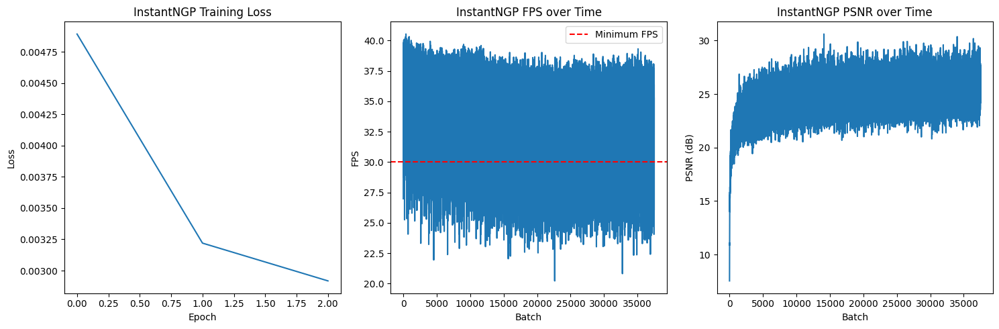






InstantNGP Training Progress:  30%|███       | 37502/125000 [22:00<4:33:29,  5.33it/s]




InstantNGP Training Progress:  30%|███       | 37505/125000 [22:00<3:28:35,  6.99it/s]


InstantNGP Epoch 4/10, Batch 0:
FPS: 31.79, Latency: 31.46ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  30%|███       | 37508/125000 [22:00<2:42:55,  8.95it/s]




InstantNGP Training Progress:  30%|███       | 37511/125000 [22:00<2:09:55, 11.22it/s]




InstantNGP Training Progress:  30%|███       | 37514/125000 [22:00<1:47:02, 13.62it/s]


InstantNGP Epoch 4/10, Batch 10:
FPS: 30.69, Latency: 32.59ms
PSNR: 26.11dB, Loss: 0.0025







InstantNGP Training Progress:  30%|███       | 37517/125000 [22:01<1:30:55, 16.04it/s]




InstantNGP Training Progress:  30%|███       | 37520/125000 [22:01<1:19:59, 18.23it/s]




InstantNGP Training Progress:  30%|███       | 37523/125000 [22:01<1:11:18, 20.44it/s]




InstantNGP Training Progress:  30%|███       | 37526/125000 [22:01<1:05:19, 22.32it/s]


InstantNGP Epoch 4/10, Batch 20:
FPS: 31.13, Latency: 32.12ms
PSNR: 27.97dB, Loss: 0.0016







InstantNGP Training Progress:  30%|███       | 37529/125000 [22:01<1:00:37, 24.05it/s]




InstantNGP Training Progress:  30%|███       | 37533/125000 [22:01<56:11, 25.94it/s]  




InstantNGP Training Progress:  30%|███       | 37536/125000 [22:01<54:03, 26.96it/s]


InstantNGP Epoch 4/10, Batch 30:
FPS: 34.51, Latency: 28.98ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  30%|███       | 37540/125000 [22:01<51:06, 28.53it/s]




InstantNGP Training Progress:  30%|███       | 37543/125000 [22:01<51:54, 28.08it/s]







InstantNGP Epoch 4/10, Batch 40:
FPS: 25.12, Latency: 39.81ms
PSNR: 25.87dB, Loss: 0.0026


InstantNGP Training Progress:  30%|███       | 37547/125000 [22:02<51:03, 28.55it/s]




InstantNGP Training Progress:  30%|███       | 37550/125000 [22:02<51:15, 28.44it/s]




InstantNGP Training Progress:  30%|███       | 37554/125000 [22:02<50:23, 28.92it/s]


InstantNGP Epoch 4/10, Batch 50:
FPS: 34.74, Latency: 28.79ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  30%|███       | 37557/125000 [22:02<51:42, 28.18it/s]




InstantNGP Training Progress:  30%|███       | 37560/125000 [22:02<51:40, 28.20it/s]




InstantNGP Training Progress:  30%|███       | 37564/125000 [22:02<50:15, 29.00it/s]


InstantNGP Epoch 4/10, Batch 60:
FPS: 33.52, Latency: 29.83ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  30%|███       | 37568/125000 [22:02<49:03, 29.70it/s]




InstantNGP Training Progress:  30%|███       | 37572/125000 [22:02<49:22, 29.51it/s]




InstantNGP Training Progress:  30%|███       | 37575/125000 [22:03<51:48, 28.13it/s]


InstantNGP Epoch 4/10, Batch 70:
FPS: 35.90, Latency: 27.86ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  30%|███       | 37578/125000 [22:03<52:02, 28.00it/s]




InstantNGP Training Progress:  30%|███       | 37581/125000 [22:03<53:24, 27.28it/s]




InstantNGP Training Progress:  30%|███       | 37584/125000 [22:03<53:57, 27.00it/s]


InstantNGP Epoch 4/10, Batch 80:
FPS: 23.47, Latency: 42.60ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  30%|███       | 37587/125000 [22:03<53:04, 27.45it/s]




InstantNGP Training Progress:  30%|███       | 37590/125000 [22:03<52:18, 27.85it/s]




InstantNGP Training Progress:  30%|███       | 37593/125000 [22:03<53:29, 27.24it/s]




InstantNGP Training Progress:  30%|███       | 37596/125000 [22:03<53:45, 27.10it/s]


InstantNGP Epoch 4/10, Batch 90:
FPS: 31.91, Latency: 31.34ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  30%|███       | 37600/125000 [22:03<51:43, 28.17it/s]




InstantNGP Training Progress:  30%|███       | 37603/125000 [22:04<52:14, 27.88it/s]




InstantNGP Training Progress:  30%|███       | 37606/125000 [22:04<51:56, 28.05it/s]


InstantNGP Epoch 4/10, Batch 100:
FPS: 31.05, Latency: 32.20ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  30%|███       | 37609/125000 [22:04<51:46, 28.13it/s]




InstantNGP Training Progress:  30%|███       | 37612/125000 [22:04<52:43, 27.63it/s]




InstantNGP Training Progress:  30%|███       | 37615/125000 [22:04<52:12, 27.90it/s]


InstantNGP Epoch 4/10, Batch 110:
FPS: 30.44, Latency: 32.85ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  30%|███       | 37619/125000 [22:04<50:54, 28.60it/s]




InstantNGP Training Progress:  30%|███       | 37622/125000 [22:04<51:55, 28.05it/s]




InstantNGP Training Progress:  30%|███       | 37625/125000 [22:04<54:13, 26.86it/s]


InstantNGP Epoch 4/10, Batch 120:
FPS: 30.49, Latency: 32.79ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  30%|███       | 37628/125000 [22:04<52:39, 27.66it/s]




InstantNGP Training Progress:  30%|███       | 37632/125000 [22:05<51:09, 28.47it/s]




InstantNGP Training Progress:  30%|███       | 37636/125000 [22:05<49:49, 29.22it/s]


InstantNGP Epoch 4/10, Batch 130:
FPS: 38.01, Latency: 26.31ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  30%|███       | 37639/125000 [22:05<51:10, 28.45it/s]




InstantNGP Training Progress:  30%|███       | 37642/125000 [22:05<53:26, 27.25it/s]




InstantNGP Training Progress:  30%|███       | 37645/125000 [22:05<52:39, 27.64it/s]


InstantNGP Epoch 4/10, Batch 140:
FPS: 25.08, Latency: 39.88ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  30%|███       | 37649/125000 [22:05<50:41, 28.72it/s]




InstantNGP Training Progress:  30%|███       | 37653/125000 [22:05<49:44, 29.26it/s]




InstantNGP Training Progress:  30%|███       | 37656/125000 [22:05<52:01, 27.98it/s]


InstantNGP Epoch 4/10, Batch 150:
FPS: 38.43, Latency: 26.02ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  30%|███       | 37659/125000 [22:06<53:05, 27.42it/s]




InstantNGP Training Progress:  30%|███       | 37662/125000 [22:06<52:41, 27.62it/s]




InstantNGP Training Progress:  30%|███       | 37665/125000 [22:06<52:40, 27.64it/s]


InstantNGP Epoch 4/10, Batch 160:
FPS: 32.65, Latency: 30.63ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  30%|███       | 37668/125000 [22:06<51:28, 28.27it/s]




InstantNGP Training Progress:  30%|███       | 37671/125000 [22:06<51:01, 28.52it/s]




InstantNGP Training Progress:  30%|███       | 37675/125000 [22:06<49:42, 29.28it/s]


InstantNGP Epoch 4/10, Batch 170:
FPS: 30.51, Latency: 32.78ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  30%|███       | 37678/125000 [22:06<49:48, 29.22it/s]




InstantNGP Training Progress:  30%|███       | 37682/125000 [22:06<48:41, 29.88it/s]




InstantNGP Training Progress:  30%|███       | 37686/125000 [22:06<47:52, 30.40it/s]


InstantNGP Epoch 4/10, Batch 180:
FPS: 37.73, Latency: 26.51ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  30%|███       | 37690/125000 [22:07<48:28, 30.02it/s]




InstantNGP Training Progress:  30%|███       | 37693/125000 [22:07<48:36, 29.94it/s]




InstantNGP Training Progress:  30%|███       | 37697/125000 [22:07<48:37, 29.92it/s]


InstantNGP Epoch 4/10, Batch 190:
FPS: 32.64, Latency: 30.64ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  30%|███       | 37700/125000 [22:07<49:45, 29.24it/s]




InstantNGP Training Progress:  30%|███       | 37703/125000 [22:07<49:44, 29.25it/s]







InstantNGP Epoch 4/10, Batch 200:
FPS: 36.74, Latency: 27.22ms
PSNR: 26.57dB, Loss: 0.0022


InstantNGP Training Progress:  30%|███       | 37707/125000 [22:07<49:03, 29.66it/s]




InstantNGP Training Progress:  30%|███       | 37711/125000 [22:07<48:59, 29.69it/s]




InstantNGP Training Progress:  30%|███       | 37714/125000 [22:07<49:24, 29.44it/s]


InstantNGP Epoch 4/10, Batch 210:
FPS: 32.28, Latency: 30.98ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  30%|███       | 37718/125000 [22:08<48:06, 30.24it/s]




InstantNGP Training Progress:  30%|███       | 37722/125000 [22:08<47:56, 30.34it/s]




InstantNGP Training Progress:  30%|███       | 37726/125000 [22:08<48:16, 30.13it/s]


InstantNGP Epoch 4/10, Batch 220:
FPS: 31.62, Latency: 31.63ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  30%|███       | 37730/125000 [22:08<49:58, 29.10it/s]




InstantNGP Training Progress:  30%|███       | 37733/125000 [22:08<51:17, 28.36it/s]


InstantNGP Epoch 4/10, Batch 230:
FPS: 35.14, Latency: 28.46ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:  30%|███       | 37736/125000 [22:08<53:33, 27.15it/s]




InstantNGP Training Progress:  30%|███       | 37739/125000 [22:08<52:10, 27.87it/s]




InstantNGP Training Progress:  30%|███       | 37742/125000 [22:08<52:49, 27.53it/s]




InstantNGP Training Progress:  30%|███       | 37745/125000 [22:09<53:46, 27.04it/s]


InstantNGP Epoch 4/10, Batch 240:
FPS: 32.24, Latency: 31.02ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  30%|███       | 37748/125000 [22:09<55:29, 26.21it/s]




InstantNGP Training Progress:  30%|███       | 37751/125000 [22:09<55:04, 26.41it/s]




InstantNGP Training Progress:  30%|███       | 37755/125000 [22:09<52:08, 27.89it/s]


InstantNGP Epoch 4/10, Batch 250:
FPS: 25.29, Latency: 39.55ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  30%|███       | 37758/125000 [22:09<51:27, 28.26it/s]




InstantNGP Training Progress:  30%|███       | 37761/125000 [22:09<51:13, 28.39it/s]




InstantNGP Training Progress:  30%|███       | 37764/125000 [22:09<51:54, 28.01it/s]


InstantNGP Epoch 4/10, Batch 260:
FPS: 32.78, Latency: 30.51ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  30%|███       | 37767/125000 [22:09<52:09, 27.87it/s]




InstantNGP Training Progress:  30%|███       | 37770/125000 [22:09<52:32, 27.67it/s]




InstantNGP Training Progress:  30%|███       | 37774/125000 [22:10<50:23, 28.85it/s]


InstantNGP Epoch 4/10, Batch 270:
FPS: 31.95, Latency: 31.29ms
PSNR: 28.39dB, Loss: 0.0014







InstantNGP Training Progress:  30%|███       | 37778/125000 [22:10<49:11, 29.55it/s]




InstantNGP Training Progress:  30%|███       | 37781/125000 [22:10<49:17, 29.49it/s]




InstantNGP Training Progress:  30%|███       | 37784/125000 [22:10<51:04, 28.46it/s]


InstantNGP Epoch 4/10, Batch 280:
FPS: 33.79, Latency: 29.59ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  30%|███       | 37787/125000 [22:10<51:59, 27.96it/s]




InstantNGP Training Progress:  30%|███       | 37790/125000 [22:10<52:58, 27.44it/s]




InstantNGP Training Progress:  30%|███       | 37793/125000 [22:10<52:34, 27.65it/s]




InstantNGP Training Progress:  30%|███       | 37796/125000 [22:10<52:49, 27.51it/s]


InstantNGP Epoch 4/10, Batch 290:
FPS: 32.64, Latency: 30.64ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  30%|███       | 37799/125000 [22:10<52:37, 27.61it/s]




InstantNGP Training Progress:  30%|███       | 37802/125000 [22:11<52:33, 27.65it/s]




InstantNGP Training Progress:  30%|███       | 37806/125000 [22:11<50:08, 28.99it/s]


InstantNGP Epoch 4/10, Batch 300:
FPS: 34.26, Latency: 29.19ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  30%|███       | 37809/125000 [22:11<50:08, 28.98it/s]




InstantNGP Training Progress:  30%|███       | 37812/125000 [22:11<49:43, 29.22it/s]




InstantNGP Training Progress:  30%|███       | 37815/125000 [22:11<49:41, 29.24it/s]


InstantNGP Epoch 4/10, Batch 310:
FPS: 34.81, Latency: 28.73ms
PSNR: 27.47dB, Loss: 0.0018







InstantNGP Training Progress:  30%|███       | 37818/125000 [22:11<50:17, 28.89it/s]




InstantNGP Training Progress:  30%|███       | 37822/125000 [22:11<50:02, 29.04it/s]




InstantNGP Training Progress:  30%|███       | 37825/125000 [22:11<50:37, 28.70it/s]


InstantNGP Epoch 4/10, Batch 320:
FPS: 36.66, Latency: 27.28ms
PSNR: 28.09dB, Loss: 0.0016







InstantNGP Training Progress:  30%|███       | 37829/125000 [22:11<48:55, 29.70it/s]




InstantNGP Training Progress:  30%|███       | 37832/125000 [22:12<49:34, 29.30it/s]




InstantNGP Training Progress:  30%|███       | 37835/125000 [22:12<49:37, 29.27it/s]


InstantNGP Epoch 4/10, Batch 330:
FPS: 37.46, Latency: 26.69ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  30%|███       | 37838/125000 [22:12<49:28, 29.37it/s]




InstantNGP Training Progress:  30%|███       | 37841/125000 [22:12<50:46, 28.61it/s]




InstantNGP Training Progress:  30%|███       | 37845/125000 [22:12<49:17, 29.47it/s]


InstantNGP Epoch 4/10, Batch 340:
FPS: 30.43, Latency: 32.86ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  30%|███       | 37848/125000 [22:12<49:57, 29.08it/s]




InstantNGP Training Progress:  30%|███       | 37851/125000 [22:12<49:44, 29.21it/s]




InstantNGP Training Progress:  30%|███       | 37855/125000 [22:12<48:41, 29.83it/s]


InstantNGP Epoch 4/10, Batch 350:
FPS: 36.57, Latency: 27.34ms
PSNR: 25.61dB, Loss: 0.0028







InstantNGP Training Progress:  30%|███       | 37858/125000 [22:12<49:39, 29.24it/s]




InstantNGP Training Progress:  30%|███       | 37861/125000 [22:13<49:23, 29.40it/s]




InstantNGP Training Progress:  30%|███       | 37864/125000 [22:13<49:52, 29.11it/s]


InstantNGP Epoch 4/10, Batch 360:
FPS: 34.06, Latency: 29.36ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  30%|███       | 37867/125000 [22:13<50:07, 28.97it/s]




InstantNGP Training Progress:  30%|███       | 37870/125000 [22:13<49:46, 29.18it/s]




InstantNGP Training Progress:  30%|███       | 37873/125000 [22:13<50:33, 28.72it/s]


InstantNGP Epoch 4/10, Batch 370:
FPS: 27.37, Latency: 36.54ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  30%|███       | 37877/125000 [22:13<50:02, 29.02it/s]




InstantNGP Training Progress:  30%|███       | 37881/125000 [22:13<49:09, 29.54it/s]




InstantNGP Training Progress:  30%|███       | 37884/125000 [22:13<49:28, 29.35it/s]


InstantNGP Epoch 4/10, Batch 380:
FPS: 35.57, Latency: 28.12ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  30%|███       | 37887/125000 [22:13<50:21, 28.83it/s]




InstantNGP Training Progress:  30%|███       | 37891/125000 [22:14<48:30, 29.93it/s]




InstantNGP Training Progress:  30%|███       | 37895/125000 [22:14<48:25, 29.98it/s]


InstantNGP Epoch 4/10, Batch 390:
FPS: 34.85, Latency: 28.69ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  30%|███       | 37899/125000 [22:14<47:38, 30.47it/s]




InstantNGP Training Progress:  30%|███       | 37903/125000 [22:14<48:34, 29.89it/s]




InstantNGP Training Progress:  30%|███       | 37906/125000 [22:14<49:08, 29.53it/s]


InstantNGP Epoch 4/10, Batch 400:
FPS: 31.71, Latency: 31.54ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  30%|███       | 37910/125000 [22:14<48:16, 30.06it/s]




InstantNGP Training Progress:  30%|███       | 37914/125000 [22:14<48:43, 29.79it/s]


InstantNGP Epoch 4/10, Batch 410:
FPS: 33.67, Latency: 29.70ms
PSNR: 28.44dB, Loss: 0.0014







InstantNGP Training Progress:  30%|███       | 37917/125000 [22:14<48:57, 29.65it/s]




InstantNGP Training Progress:  30%|███       | 37921/125000 [22:15<48:09, 30.14it/s]




InstantNGP Training Progress:  30%|███       | 37925/125000 [22:15<48:27, 29.95it/s]


InstantNGP Epoch 4/10, Batch 420:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  30%|███       | 37929/125000 [22:15<48:38, 29.83it/s]




InstantNGP Training Progress:  30%|███       | 37932/125000 [22:15<50:30, 28.73it/s]




InstantNGP Training Progress:  30%|███       | 37935/125000 [22:15<50:09, 28.93it/s]


InstantNGP Epoch 4/10, Batch 430:
FPS: 28.06, Latency: 35.64ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  30%|███       | 37938/125000 [22:15<50:14, 28.88it/s]




InstantNGP Training Progress:  30%|███       | 37941/125000 [22:15<49:55, 29.06it/s]




InstantNGP Training Progress:  30%|███       | 37944/125000 [22:15<50:41, 28.63it/s]


InstantNGP Epoch 4/10, Batch 440:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  30%|███       | 37947/125000 [22:15<50:27, 28.75it/s]




InstantNGP Training Progress:  30%|███       | 37951/125000 [22:16<50:15, 28.87it/s]




InstantNGP Training Progress:  30%|███       | 37954/125000 [22:16<50:33, 28.70it/s]


InstantNGP Epoch 4/10, Batch 450:
FPS: 25.57, Latency: 39.11ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  30%|███       | 37957/125000 [22:16<51:06, 28.38it/s]




InstantNGP Training Progress:  30%|███       | 37960/125000 [22:16<52:41, 27.53it/s]




InstantNGP Training Progress:  30%|███       | 37963/125000 [22:16<52:27, 27.65it/s]




InstantNGP Training Progress:  30%|███       | 37966/125000 [22:16<51:36, 28.10it/s]


InstantNGP Epoch 4/10, Batch 460:
FPS: 36.19, Latency: 27.63ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  30%|███       | 37969/125000 [22:16<50:42, 28.60it/s]




InstantNGP Training Progress:  30%|███       | 37973/125000 [22:16<49:12, 29.48it/s]




InstantNGP Training Progress:  30%|███       | 37976/125000 [22:16<49:25, 29.35it/s]


InstantNGP Epoch 4/10, Batch 470:
FPS: 37.41, Latency: 26.73ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  30%|███       | 37979/125000 [22:17<49:56, 29.04it/s]




InstantNGP Training Progress:  30%|███       | 37983/125000 [22:17<48:49, 29.71it/s]




InstantNGP Training Progress:  30%|███       | 37986/125000 [22:17<48:51, 29.68it/s]


InstantNGP Epoch 4/10, Batch 480:
FPS: 32.90, Latency: 30.39ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  30%|███       | 37989/125000 [22:17<49:14, 29.45it/s]




InstantNGP Training Progress:  30%|███       | 37992/125000 [22:17<49:50, 29.10it/s]




InstantNGP Training Progress:  30%|███       | 37996/125000 [22:17<48:31, 29.88it/s]


InstantNGP Epoch 4/10, Batch 490:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  30%|███       | 37999/125000 [22:17<49:40, 29.19it/s]




InstantNGP Training Progress:  30%|███       | 38002/125000 [22:17<49:39, 29.20it/s]




InstantNGP Training Progress:  30%|███       | 38006/125000 [22:18<48:52, 29.67it/s]


InstantNGP Epoch 4/10, Batch 500:
FPS: 36.89, Latency: 27.11ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  30%|███       | 38009/125000 [22:18<49:00, 29.58it/s]




InstantNGP Training Progress:  30%|███       | 38012/125000 [22:18<49:04, 29.54it/s]




InstantNGP Training Progress:  30%|███       | 38015/125000 [22:18<49:00, 29.59it/s]


InstantNGP Epoch 4/10, Batch 510:
FPS: 36.06, Latency: 27.73ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  30%|███       | 38018/125000 [22:18<49:42, 29.17it/s]




InstantNGP Training Progress:  30%|███       | 38021/125000 [22:18<49:44, 29.15it/s]




InstantNGP Training Progress:  30%|███       | 38024/125000 [22:18<49:58, 29.01it/s]


InstantNGP Epoch 4/10, Batch 520:
FPS: 33.22, Latency: 30.11ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  30%|███       | 38028/125000 [22:18<49:21, 29.37it/s]




InstantNGP Training Progress:  30%|███       | 38031/125000 [22:18<50:29, 28.71it/s]




InstantNGP Training Progress:  30%|███       | 38034/125000 [22:18<51:24, 28.19it/s]


InstantNGP Epoch 4/10, Batch 530:
FPS: 33.09, Latency: 30.22ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  30%|███       | 38037/125000 [22:19<52:03, 27.84it/s]




InstantNGP Training Progress:  30%|███       | 38040/125000 [22:19<51:50, 27.96it/s]




InstantNGP Training Progress:  30%|███       | 38043/125000 [22:19<51:10, 28.32it/s]




InstantNGP Training Progress:  30%|███       | 38046/125000 [22:19<51:08, 28.34it/s]


InstantNGP Epoch 4/10, Batch 540:
FPS: 33.27, Latency: 30.05ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  30%|███       | 38049/125000 [22:19<52:29, 27.61it/s]




InstantNGP Training Progress:  30%|███       | 38052/125000 [22:19<52:00, 27.86it/s]




InstantNGP Training Progress:  30%|███       | 38055/125000 [22:19<50:57, 28.44it/s]


InstantNGP Epoch 4/10, Batch 550:
FPS: 37.45, Latency: 26.70ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  30%|███       | 38058/125000 [22:19<50:22, 28.76it/s]




InstantNGP Training Progress:  30%|███       | 38062/125000 [22:19<49:15, 29.42it/s]




InstantNGP Training Progress:  30%|███       | 38066/125000 [22:20<48:35, 29.82it/s]


InstantNGP Epoch 4/10, Batch 560:
FPS: 34.60, Latency: 28.90ms
PSNR: 27.42dB, Loss: 0.0018







InstantNGP Training Progress:  30%|███       | 38069/125000 [22:20<48:40, 29.76it/s]




InstantNGP Training Progress:  30%|███       | 38072/125000 [22:20<48:49, 29.68it/s]




InstantNGP Training Progress:  30%|███       | 38076/125000 [22:20<49:22, 29.35it/s]


InstantNGP Epoch 4/10, Batch 570:
FPS: 36.78, Latency: 27.19ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  30%|███       | 38079/125000 [22:20<49:18, 29.38it/s]




InstantNGP Training Progress:  30%|███       | 38082/125000 [22:20<49:25, 29.31it/s]




InstantNGP Training Progress:  30%|███       | 38085/125000 [22:20<49:15, 29.41it/s]


InstantNGP Epoch 4/10, Batch 580:
FPS: 31.85, Latency: 31.40ms
PSNR: 23.59dB, Loss: 0.0044







InstantNGP Training Progress:  30%|███       | 38088/125000 [22:20<49:35, 29.21it/s]




InstantNGP Training Progress:  30%|███       | 38092/125000 [22:20<47:36, 30.42it/s]




InstantNGP Training Progress:  30%|███       | 38096/125000 [22:21<48:41, 29.74it/s]


InstantNGP Epoch 4/10, Batch 590:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  30%|███       | 38099/125000 [22:21<49:12, 29.44it/s]




InstantNGP Training Progress:  30%|███       | 38102/125000 [22:21<50:05, 28.91it/s]




InstantNGP Training Progress:  30%|███       | 38105/125000 [22:21<52:37, 27.52it/s]


InstantNGP Epoch 4/10, Batch 600:
FPS: 31.40, Latency: 31.85ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  30%|███       | 38108/125000 [22:21<52:25, 27.62it/s]




InstantNGP Training Progress:  30%|███       | 38111/125000 [22:21<52:39, 27.50it/s]




InstantNGP Training Progress:  30%|███       | 38114/125000 [22:21<54:12, 26.71it/s]


InstantNGP Epoch 4/10, Batch 610:
FPS: 28.14, Latency: 35.53ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  30%|███       | 38117/125000 [22:21<54:06, 26.76it/s]




InstantNGP Training Progress:  30%|███       | 38120/125000 [22:21<52:47, 27.43it/s]




InstantNGP Training Progress:  30%|███       | 38123/125000 [22:22<52:14, 27.72it/s]




InstantNGP Training Progress:  31%|███       | 38127/125000 [22:22<49:59, 28.97it/s]


InstantNGP Epoch 4/10, Batch 620:
FPS: 31.92, Latency: 31.33ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  31%|███       | 38130/125000 [22:22<51:36, 28.06it/s]




InstantNGP Training Progress:  31%|███       | 38133/125000 [22:22<51:19, 28.21it/s]




InstantNGP Training Progress:  31%|███       | 38136/125000 [22:22<51:52, 27.91it/s]


InstantNGP Epoch 4/10, Batch 630:
FPS: 30.04, Latency: 33.29ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 38139/125000 [22:22<53:38, 26.99it/s]




InstantNGP Training Progress:  31%|███       | 38142/125000 [22:22<53:19, 27.15it/s]




InstantNGP Training Progress:  31%|███       | 38145/125000 [22:22<53:44, 26.93it/s]


InstantNGP Epoch 4/10, Batch 640:
FPS: 29.09, Latency: 34.37ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  31%|███       | 38148/125000 [22:23<55:03, 26.29it/s]




InstantNGP Training Progress:  31%|███       | 38151/125000 [22:23<54:57, 26.34it/s]




InstantNGP Training Progress:  31%|███       | 38155/125000 [22:23<52:38, 27.49it/s]


InstantNGP Epoch 4/10, Batch 650:
FPS: 29.80, Latency: 33.55ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███       | 38158/125000 [22:23<51:27, 28.13it/s]




InstantNGP Training Progress:  31%|███       | 38161/125000 [22:23<50:39, 28.57it/s]




InstantNGP Training Progress:  31%|███       | 38165/125000 [22:23<49:50, 29.04it/s]


InstantNGP Epoch 4/10, Batch 660:
FPS: 35.93, Latency: 27.83ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  31%|███       | 38169/125000 [22:23<48:45, 29.68it/s]




InstantNGP Training Progress:  31%|███       | 38173/125000 [22:23<47:57, 30.17it/s]




InstantNGP Training Progress:  31%|███       | 38177/125000 [22:23<48:01, 30.13it/s]


InstantNGP Epoch 4/10, Batch 670:
FPS: 37.17, Latency: 26.90ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  31%|███       | 38181/125000 [22:24<48:27, 29.86it/s]




InstantNGP Training Progress:  31%|███       | 38184/125000 [22:24<48:24, 29.89it/s]


InstantNGP Epoch 4/10, Batch 680:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.77dB, Loss: 0.0013







InstantNGP Training Progress:  31%|███       | 38187/125000 [22:24<50:01, 28.92it/s]




InstantNGP Training Progress:  31%|███       | 38191/125000 [22:24<48:56, 29.56it/s]




InstantNGP Training Progress:  31%|███       | 38194/125000 [22:24<49:18, 29.34it/s]


InstantNGP Epoch 4/10, Batch 690:
FPS: 37.59, Latency: 26.60ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  31%|███       | 38197/125000 [22:24<49:10, 29.42it/s]




InstantNGP Training Progress:  31%|███       | 38200/125000 [22:24<50:14, 28.80it/s]




InstantNGP Training Progress:  31%|███       | 38203/125000 [22:24<50:05, 28.88it/s]




InstantNGP Training Progress:  31%|███       | 38206/125000 [22:24<50:15, 28.78it/s]


InstantNGP Epoch 4/10, Batch 700:
FPS: 31.64, Latency: 31.60ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  31%|███       | 38210/125000 [22:25<49:09, 29.42it/s]




InstantNGP Training Progress:  31%|███       | 38213/125000 [22:25<50:06, 28.86it/s]




InstantNGP Training Progress:  31%|███       | 38216/125000 [22:25<49:48, 29.04it/s]


InstantNGP Epoch 4/10, Batch 710:
FPS: 28.96, Latency: 34.52ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███       | 38219/125000 [22:25<51:34, 28.05it/s]




InstantNGP Training Progress:  31%|███       | 38222/125000 [22:25<51:06, 28.30it/s]




InstantNGP Training Progress:  31%|███       | 38226/125000 [22:25<49:10, 29.41it/s]


InstantNGP Epoch 4/10, Batch 720:
FPS: 30.23, Latency: 33.08ms
PSNR: 27.61dB, Loss: 0.0017







InstantNGP Training Progress:  31%|███       | 38230/125000 [22:25<48:29, 29.82it/s]




InstantNGP Training Progress:  31%|███       | 38233/125000 [22:25<49:12, 29.38it/s]




InstantNGP Training Progress:  31%|███       | 38237/125000 [22:26<47:44, 30.29it/s]


InstantNGP Epoch 4/10, Batch 730:
FPS: 37.49, Latency: 26.67ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  31%|███       | 38241/125000 [22:26<48:34, 29.77it/s]




InstantNGP Training Progress:  31%|███       | 38244/125000 [22:26<49:58, 28.94it/s]


InstantNGP Epoch 4/10, Batch 740:
FPS: 31.14, Latency: 32.11ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  31%|███       | 38247/125000 [22:26<50:14, 28.78it/s]




InstantNGP Training Progress:  31%|███       | 38250/125000 [22:26<50:23, 28.70it/s]




InstantNGP Training Progress:  31%|███       | 38253/125000 [22:26<50:04, 28.87it/s]




InstantNGP Training Progress:  31%|███       | 38256/125000 [22:26<50:32, 28.61it/s]


InstantNGP Epoch 4/10, Batch 750:
FPS: 34.57, Latency: 28.92ms
PSNR: 23.82dB, Loss: 0.0041







InstantNGP Training Progress:  31%|███       | 38259/125000 [22:26<51:22, 28.14it/s]




InstantNGP Training Progress:  31%|███       | 38262/125000 [22:26<50:48, 28.46it/s]




InstantNGP Training Progress:  31%|███       | 38265/125000 [22:27<50:28, 28.64it/s]


InstantNGP Epoch 4/10, Batch 760:
FPS: 34.63, Latency: 28.88ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███       | 38269/125000 [22:27<49:27, 29.23it/s]




InstantNGP Training Progress:  31%|███       | 38272/125000 [22:27<50:01, 28.90it/s]




InstantNGP Training Progress:  31%|███       | 38275/125000 [22:27<50:27, 28.64it/s]


InstantNGP Epoch 4/10, Batch 770:
FPS: 29.28, Latency: 34.16ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 38278/125000 [22:27<51:10, 28.25it/s]




InstantNGP Training Progress:  31%|███       | 38282/125000 [22:27<49:24, 29.26it/s]




InstantNGP Training Progress:  31%|███       | 38286/125000 [22:27<49:03, 29.46it/s]


InstantNGP Epoch 4/10, Batch 780:
FPS: 36.83, Latency: 27.15ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  31%|███       | 38289/125000 [22:27<49:07, 29.42it/s]




InstantNGP Training Progress:  31%|███       | 38292/125000 [22:27<48:59, 29.50it/s]




InstantNGP Training Progress:  31%|███       | 38295/125000 [22:28<49:28, 29.21it/s]


InstantNGP Epoch 4/10, Batch 790:
FPS: 32.24, Latency: 31.01ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38298/125000 [22:28<49:19, 29.29it/s]




InstantNGP Training Progress:  31%|███       | 38301/125000 [22:28<49:36, 29.13it/s]




InstantNGP Training Progress:  31%|███       | 38305/125000 [22:28<50:12, 28.78it/s]


InstantNGP Epoch 4/10, Batch 800:
FPS: 29.60, Latency: 33.78ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  31%|███       | 38308/125000 [22:28<50:11, 28.79it/s]




InstantNGP Training Progress:  31%|███       | 38311/125000 [22:28<50:24, 28.66it/s]




InstantNGP Training Progress:  31%|███       | 38315/125000 [22:28<49:11, 29.37it/s]


InstantNGP Epoch 4/10, Batch 810:
FPS: 35.28, Latency: 28.35ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███       | 38318/125000 [22:28<50:12, 28.77it/s]




InstantNGP Training Progress:  31%|███       | 38321/125000 [22:28<50:27, 28.63it/s]




InstantNGP Training Progress:  31%|███       | 38324/125000 [22:29<52:48, 27.35it/s]


InstantNGP Epoch 4/10, Batch 820:
FPS: 30.46, Latency: 32.83ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  31%|███       | 38327/125000 [22:29<51:59, 27.79it/s]




InstantNGP Training Progress:  31%|███       | 38330/125000 [22:29<51:15, 28.18it/s]




InstantNGP Training Progress:  31%|███       | 38333/125000 [22:29<50:53, 28.38it/s]




InstantNGP Training Progress:  31%|███       | 38336/125000 [22:29<50:36, 28.54it/s]


InstantNGP Epoch 4/10, Batch 830:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  31%|███       | 38339/125000 [22:29<50:12, 28.77it/s]




InstantNGP Training Progress:  31%|███       | 38342/125000 [22:29<49:57, 28.91it/s]




InstantNGP Training Progress:  31%|███       | 38346/125000 [22:29<48:53, 29.54it/s]


InstantNGP Epoch 4/10, Batch 840:
FPS: 32.18, Latency: 31.07ms
PSNR: 27.29dB, Loss: 0.0019







InstantNGP Training Progress:  31%|███       | 38350/125000 [22:29<48:29, 29.79it/s]




InstantNGP Training Progress:  31%|███       | 38354/125000 [22:30<47:49, 30.19it/s]


InstantNGP Epoch 4/10, Batch 850:
FPS: 36.90, Latency: 27.10ms
PSNR: 28.18dB, Loss: 0.0015







InstantNGP Training Progress:  31%|███       | 38358/125000 [22:30<47:35, 30.35it/s]




InstantNGP Training Progress:  31%|███       | 38362/125000 [22:30<47:29, 30.40it/s]




InstantNGP Training Progress:  31%|███       | 38366/125000 [22:30<47:55, 30.13it/s]


InstantNGP Epoch 4/10, Batch 860:
FPS: 35.37, Latency: 28.27ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  31%|███       | 38370/125000 [22:30<48:39, 29.67it/s]




InstantNGP Training Progress:  31%|███       | 38373/125000 [22:30<50:25, 28.63it/s]




InstantNGP Training Progress:  31%|███       | 38376/125000 [22:30<50:08, 28.80it/s]


InstantNGP Epoch 4/10, Batch 870:
FPS: 26.55, Latency: 37.67ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███       | 38379/125000 [22:30<50:16, 28.71it/s]




InstantNGP Training Progress:  31%|███       | 38382/125000 [22:31<50:22, 28.65it/s]




InstantNGP Training Progress:  31%|███       | 38385/125000 [22:31<50:08, 28.79it/s]


InstantNGP Epoch 4/10, Batch 880:
FPS: 30.64, Latency: 32.64ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  31%|███       | 38388/125000 [22:31<50:53, 28.36it/s]




InstantNGP Training Progress:  31%|███       | 38392/125000 [22:31<50:14, 28.73it/s]




InstantNGP Training Progress:  31%|███       | 38395/125000 [22:31<49:44, 29.02it/s]


InstantNGP Epoch 4/10, Batch 890:
FPS: 33.55, Latency: 29.81ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38398/125000 [22:31<50:49, 28.40it/s]




InstantNGP Training Progress:  31%|███       | 38401/125000 [22:31<50:04, 28.83it/s]




InstantNGP Training Progress:  31%|███       | 38405/125000 [22:31<48:58, 29.47it/s]


InstantNGP Epoch 4/10, Batch 900:
FPS: 38.08, Latency: 26.26ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 38408/125000 [22:31<51:57, 27.78it/s]




InstantNGP Training Progress:  31%|███       | 38412/125000 [22:32<49:54, 28.91it/s]




InstantNGP Training Progress:  31%|███       | 38415/125000 [22:32<49:52, 28.93it/s]


InstantNGP Epoch 4/10, Batch 910:
FPS: 31.34, Latency: 31.91ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  31%|███       | 38419/125000 [22:32<48:40, 29.64it/s]




InstantNGP Training Progress:  31%|███       | 38422/125000 [22:32<49:27, 29.17it/s]




InstantNGP Training Progress:  31%|███       | 38425/125000 [22:32<49:26, 29.19it/s]


InstantNGP Epoch 4/10, Batch 920:
FPS: 34.62, Latency: 28.89ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 38428/125000 [22:32<49:50, 28.95it/s]




InstantNGP Training Progress:  31%|███       | 38431/125000 [22:32<50:22, 28.65it/s]




InstantNGP Training Progress:  31%|███       | 38434/125000 [22:32<50:12, 28.74it/s]


InstantNGP Epoch 4/10, Batch 930:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38438/125000 [22:32<48:56, 29.48it/s]




InstantNGP Training Progress:  31%|███       | 38441/125000 [22:33<49:37, 29.07it/s]




InstantNGP Training Progress:  31%|███       | 38444/125000 [22:33<51:34, 27.97it/s]


InstantNGP Epoch 4/10, Batch 940:
FPS: 33.83, Latency: 29.56ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  31%|███       | 38447/125000 [22:33<51:09, 28.20it/s]




InstantNGP Training Progress:  31%|███       | 38450/125000 [22:33<52:47, 27.33it/s]




InstantNGP Training Progress:  31%|███       | 38453/125000 [22:33<52:54, 27.27it/s]




InstantNGP Training Progress:  31%|███       | 38456/125000 [22:33<53:09, 27.13it/s]


InstantNGP Epoch 4/10, Batch 950:
FPS: 34.07, Latency: 29.35ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  31%|███       | 38459/125000 [22:33<54:41, 26.37it/s]




InstantNGP Training Progress:  31%|███       | 38462/125000 [22:33<53:53, 26.76it/s]




InstantNGP Training Progress:  31%|███       | 38465/125000 [22:33<53:06, 27.16it/s]


InstantNGP Epoch 4/10, Batch 960:
FPS: 32.16, Latency: 31.09ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  31%|███       | 38468/125000 [22:34<52:45, 27.34it/s]




InstantNGP Training Progress:  31%|███       | 38471/125000 [22:34<52:00, 27.73it/s]




InstantNGP Training Progress:  31%|███       | 38474/125000 [22:34<50:55, 28.32it/s]


InstantNGP Epoch 4/10, Batch 970:
FPS: 34.85, Latency: 28.69ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  31%|███       | 38477/125000 [22:34<52:40, 27.37it/s]




InstantNGP Training Progress:  31%|███       | 38480/125000 [22:34<51:51, 27.81it/s]




InstantNGP Training Progress:  31%|███       | 38483/125000 [22:34<51:15, 28.13it/s]




InstantNGP Training Progress:  31%|███       | 38486/125000 [22:34<51:59, 27.73it/s]


InstantNGP Epoch 4/10, Batch 980:
FPS: 30.76, Latency: 32.51ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  31%|███       | 38489/125000 [22:34<53:03, 27.18it/s]




InstantNGP Training Progress:  31%|███       | 38492/125000 [22:34<53:19, 27.03it/s]




InstantNGP Training Progress:  31%|███       | 38495/125000 [22:35<54:45, 26.33it/s]


InstantNGP Epoch 4/10, Batch 990:
FPS: 28.13, Latency: 35.54ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:  31%|███       | 38498/125000 [22:35<54:33, 26.42it/s]




InstantNGP Training Progress:  31%|███       | 38501/125000 [22:35<55:08, 26.14it/s]




InstantNGP Training Progress:  31%|███       | 38504/125000 [22:35<55:52, 25.80it/s]


InstantNGP Epoch 4/10, Batch 1000:
FPS: 30.45, Latency: 32.85ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  31%|███       | 38508/125000 [22:35<52:42, 27.35it/s]




InstantNGP Training Progress:  31%|███       | 38511/125000 [22:35<51:27, 28.01it/s]




InstantNGP Training Progress:  31%|███       | 38515/125000 [22:35<49:28, 29.14it/s]


InstantNGP Epoch 4/10, Batch 1010:
FPS: 37.97, Latency: 26.33ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  31%|███       | 38518/125000 [22:35<49:32, 29.10it/s]




InstantNGP Training Progress:  31%|███       | 38522/125000 [22:36<48:03, 29.99it/s]




InstantNGP Training Progress:  31%|███       | 38525/125000 [22:36<49:18, 29.23it/s]


InstantNGP Epoch 4/10, Batch 1020:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███       | 38528/125000 [22:36<50:13, 28.69it/s]




InstantNGP Training Progress:  31%|███       | 38531/125000 [22:36<50:03, 28.79it/s]




InstantNGP Training Progress:  31%|███       | 38534/125000 [22:36<52:12, 27.61it/s]


InstantNGP Epoch 4/10, Batch 1030:
FPS: 33.90, Latency: 29.50ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  31%|███       | 38538/125000 [22:36<50:03, 28.79it/s]




InstantNGP Training Progress:  31%|███       | 38542/125000 [22:36<48:33, 29.67it/s]




InstantNGP Training Progress:  31%|███       | 38545/125000 [22:36<49:14, 29.26it/s]


InstantNGP Epoch 4/10, Batch 1040:
FPS: 33.16, Latency: 30.16ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  31%|███       | 38549/125000 [22:36<48:40, 29.60it/s]




InstantNGP Training Progress:  31%|███       | 38553/125000 [22:37<48:14, 29.87it/s]




InstantNGP Training Progress:  31%|███       | 38556/125000 [22:37<48:56, 29.44it/s]


InstantNGP Epoch 4/10, Batch 1050:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 38559/125000 [22:37<49:47, 28.93it/s]




InstantNGP Training Progress:  31%|███       | 38562/125000 [22:37<50:06, 28.75it/s]




InstantNGP Training Progress:  31%|███       | 38565/125000 [22:37<50:51, 28.32it/s]


InstantNGP Epoch 4/10, Batch 1060:
FPS: 30.80, Latency: 32.47ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38568/125000 [22:37<51:07, 28.18it/s]




InstantNGP Training Progress:  31%|███       | 38571/125000 [22:37<51:21, 28.05it/s]




InstantNGP Training Progress:  31%|███       | 38574/125000 [22:37<50:44, 28.39it/s]


InstantNGP Epoch 4/10, Batch 1070:
FPS: 33.23, Latency: 30.10ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  31%|███       | 38578/125000 [22:37<49:01, 29.38it/s]




InstantNGP Training Progress:  31%|███       | 38581/125000 [22:38<49:25, 29.14it/s]




InstantNGP Training Progress:  31%|███       | 38585/125000 [22:38<48:05, 29.95it/s]


InstantNGP Epoch 4/10, Batch 1080:
FPS: 29.37, Latency: 34.05ms
PSNR: 28.95dB, Loss: 0.0013







InstantNGP Training Progress:  31%|███       | 38589/125000 [22:38<47:34, 30.28it/s]




InstantNGP Training Progress:  31%|███       | 38593/125000 [22:38<47:11, 30.51it/s]




InstantNGP Training Progress:  31%|███       | 38597/125000 [22:38<47:42, 30.18it/s]


InstantNGP Epoch 4/10, Batch 1090:
FPS: 37.32, Latency: 26.80ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  31%|███       | 38601/125000 [22:38<48:19, 29.79it/s]




InstantNGP Training Progress:  31%|███       | 38604/125000 [22:38<48:20, 29.79it/s]


InstantNGP Epoch 4/10, Batch 1100:
FPS: 36.11, Latency: 27.70ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  31%|███       | 38607/125000 [22:38<49:37, 29.01it/s]




InstantNGP Training Progress:  31%|███       | 38610/125000 [22:39<49:37, 29.01it/s]




InstantNGP Training Progress:  31%|███       | 38613/125000 [22:39<50:13, 28.67it/s]




InstantNGP Training Progress:  31%|███       | 38616/125000 [22:39<51:34, 27.91it/s]


InstantNGP Epoch 4/10, Batch 1110:
FPS: 31.76, Latency: 31.49ms
PSNR: 24.62dB, Loss: 0.0034







InstantNGP Training Progress:  31%|███       | 38619/125000 [22:39<50:50, 28.32it/s]




InstantNGP Training Progress:  31%|███       | 38622/125000 [22:39<52:45, 27.29it/s]




InstantNGP Training Progress:  31%|███       | 38625/125000 [22:39<51:30, 27.95it/s]


InstantNGP Epoch 4/10, Batch 1120:
FPS: 30.67, Latency: 32.61ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  31%|███       | 38628/125000 [22:39<51:15, 28.08it/s]




InstantNGP Training Progress:  31%|███       | 38631/125000 [22:39<53:08, 27.09it/s]




InstantNGP Training Progress:  31%|███       | 38635/125000 [22:39<49:56, 28.82it/s]


InstantNGP Epoch 4/10, Batch 1130:
FPS: 30.60, Latency: 32.68ms
PSNR: 23.35dB, Loss: 0.0046







InstantNGP Training Progress:  31%|███       | 38638/125000 [22:40<49:40, 28.97it/s]




InstantNGP Training Progress:  31%|███       | 38641/125000 [22:40<50:28, 28.52it/s]




InstantNGP Training Progress:  31%|███       | 38645/125000 [22:40<49:46, 28.92it/s]


InstantNGP Epoch 4/10, Batch 1140:
FPS: 28.71, Latency: 34.83ms
PSNR: 28.41dB, Loss: 0.0014







InstantNGP Training Progress:  31%|███       | 38648/125000 [22:40<50:07, 28.71it/s]




InstantNGP Training Progress:  31%|███       | 38651/125000 [22:40<49:46, 28.91it/s]




InstantNGP Training Progress:  31%|███       | 38654/125000 [22:40<50:18, 28.61it/s]


InstantNGP Epoch 4/10, Batch 1150:
FPS: 31.20, Latency: 32.05ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  31%|███       | 38657/125000 [22:40<50:48, 28.32it/s]




InstantNGP Training Progress:  31%|███       | 38660/125000 [22:40<51:26, 27.97it/s]




InstantNGP Training Progress:  31%|███       | 38663/125000 [22:40<52:05, 27.62it/s]




InstantNGP Training Progress:  31%|███       | 38666/125000 [22:41<51:05, 28.16it/s]


InstantNGP Epoch 4/10, Batch 1160:
FPS: 32.73, Latency: 30.55ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  31%|███       | 38670/125000 [22:41<49:19, 29.17it/s]




InstantNGP Training Progress:  31%|███       | 38674/125000 [22:41<48:25, 29.71it/s]


InstantNGP Epoch 4/10, Batch 1170:
FPS: 37.50, Latency: 26.67ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  31%|███       | 38678/125000 [22:41<48:06, 29.90it/s]




InstantNGP Training Progress:  31%|███       | 38681/125000 [22:41<48:18, 29.78it/s]




InstantNGP Training Progress:  31%|███       | 38684/125000 [22:41<48:30, 29.66it/s]


InstantNGP Epoch 4/10, Batch 1180:
FPS: 30.56, Latency: 32.72ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 38687/125000 [22:41<48:56, 29.39it/s]




InstantNGP Training Progress:  31%|███       | 38690/125000 [22:41<48:52, 29.43it/s]




InstantNGP Training Progress:  31%|███       | 38694/125000 [22:41<48:02, 29.94it/s]


InstantNGP Epoch 4/10, Batch 1190:
FPS: 32.34, Latency: 30.93ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  31%|███       | 38698/125000 [22:42<48:03, 29.93it/s]




InstantNGP Training Progress:  31%|███       | 38701/125000 [22:42<49:42, 28.93it/s]




InstantNGP Training Progress:  31%|███       | 38704/125000 [22:42<49:59, 28.77it/s]


InstantNGP Epoch 4/10, Batch 1200:
FPS: 29.75, Latency: 33.62ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  31%|███       | 38707/125000 [22:42<50:52, 28.27it/s]




InstantNGP Training Progress:  31%|███       | 38710/125000 [22:42<51:24, 27.98it/s]




InstantNGP Training Progress:  31%|███       | 38713/125000 [22:42<51:01, 28.18it/s]




InstantNGP Training Progress:  31%|███       | 38716/125000 [22:42<50:42, 28.36it/s]


InstantNGP Epoch 4/10, Batch 1210:
FPS: 33.74, Latency: 29.64ms
PSNR: 28.45dB, Loss: 0.0014







InstantNGP Training Progress:  31%|███       | 38719/125000 [22:42<50:14, 28.62it/s]




InstantNGP Training Progress:  31%|███       | 38722/125000 [22:42<49:52, 28.83it/s]




InstantNGP Training Progress:  31%|███       | 38725/125000 [22:43<49:20, 29.15it/s]


InstantNGP Epoch 4/10, Batch 1220:
FPS: 31.35, Latency: 31.90ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  31%|███       | 38729/125000 [22:43<48:19, 29.76it/s]




InstantNGP Training Progress:  31%|███       | 38732/125000 [22:43<48:54, 29.40it/s]




InstantNGP Training Progress:  31%|███       | 38735/125000 [22:43<49:53, 28.82it/s]


InstantNGP Epoch 4/10, Batch 1230:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  31%|███       | 38738/125000 [22:43<50:56, 28.23it/s]




InstantNGP Training Progress:  31%|███       | 38742/125000 [22:43<49:13, 29.21it/s]




InstantNGP Training Progress:  31%|███       | 38746/125000 [22:43<48:40, 29.53it/s]


InstantNGP Epoch 4/10, Batch 1240:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38750/125000 [22:43<48:04, 29.90it/s]




InstantNGP Training Progress:  31%|███       | 38753/125000 [22:44<48:21, 29.72it/s]




InstantNGP Training Progress:  31%|███       | 38757/125000 [22:44<47:11, 30.46it/s]


InstantNGP Epoch 4/10, Batch 1250:
FPS: 36.79, Latency: 27.18ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  31%|███       | 38761/125000 [22:44<48:36, 29.57it/s]




InstantNGP Training Progress:  31%|███       | 38764/125000 [22:44<48:29, 29.64it/s]


InstantNGP Epoch 4/10, Batch 1260:
FPS: 24.97, Latency: 40.05ms
PSNR: 26.69dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38767/125000 [22:44<48:40, 29.52it/s]




InstantNGP Training Progress:  31%|███       | 38770/125000 [22:44<49:07, 29.25it/s]




InstantNGP Training Progress:  31%|███       | 38774/125000 [22:44<48:17, 29.76it/s]




InstantNGP Training Progress:  31%|███       | 38777/125000 [22:44<48:18, 29.75it/s]


InstantNGP Epoch 4/10, Batch 1270:
FPS: 35.45, Latency: 28.21ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  31%|███       | 38780/125000 [22:44<48:52, 29.41it/s]




InstantNGP Training Progress:  31%|███       | 38783/125000 [22:45<49:00, 29.32it/s]


InstantNGP Epoch 4/10, Batch 1280:
FPS: 37.15, Latency: 26.92ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  31%|███       | 38787/125000 [22:45<48:31, 29.61it/s]




InstantNGP Training Progress:  31%|███       | 38790/125000 [22:45<48:36, 29.56it/s]




InstantNGP Training Progress:  31%|███       | 38793/125000 [22:45<50:43, 28.33it/s]







InstantNGP Epoch 4/10, Batch 1290:
FPS: 31.04, Latency: 32.21ms
PSNR: 25.64dB, Loss: 0.0027


InstantNGP Training Progress:  31%|███       | 38796/125000 [22:45<52:40, 27.27it/s]




InstantNGP Training Progress:  31%|███       | 38799/125000 [22:45<51:36, 27.84it/s]




InstantNGP Training Progress:  31%|███       | 38802/125000 [22:45<51:19, 27.99it/s]




InstantNGP Training Progress:  31%|███       | 38805/125000 [22:45<50:46, 28.29it/s]


InstantNGP Epoch 4/10, Batch 1300:
FPS: 28.92, Latency: 34.57ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  31%|███       | 38808/125000 [22:45<50:16, 28.57it/s]




InstantNGP Training Progress:  31%|███       | 38811/125000 [22:46<50:59, 28.17it/s]




InstantNGP Training Progress:  31%|███       | 38814/125000 [22:46<51:29, 27.89it/s]


InstantNGP Epoch 4/10, Batch 1310:
FPS: 31.46, Latency: 31.78ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  31%|███       | 38817/125000 [22:46<54:16, 26.47it/s]




InstantNGP Training Progress:  31%|███       | 38820/125000 [22:46<54:12, 26.50it/s]




InstantNGP Training Progress:  31%|███       | 38823/125000 [22:46<54:18, 26.45it/s]




InstantNGP Training Progress:  31%|███       | 38826/125000 [22:46<55:14, 26.00it/s]


InstantNGP Epoch 4/10, Batch 1320:
FPS: 28.80, Latency: 34.72ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  31%|███       | 38829/125000 [22:46<55:27, 25.89it/s]




InstantNGP Training Progress:  31%|███       | 38832/125000 [22:46<53:30, 26.84it/s]




InstantNGP Training Progress:  31%|███       | 38835/125000 [22:46<52:27, 27.38it/s]


InstantNGP Epoch 4/10, Batch 1330:
FPS: 35.68, Latency: 28.03ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  31%|███       | 38838/125000 [22:47<52:35, 27.31it/s]




InstantNGP Training Progress:  31%|███       | 38841/125000 [22:47<52:08, 27.54it/s]




InstantNGP Training Progress:  31%|███       | 38844/125000 [22:47<52:00, 27.61it/s]


InstantNGP Epoch 4/10, Batch 1340:
FPS: 34.75, Latency: 28.78ms
PSNR: 22.99dB, Loss: 0.0050







InstantNGP Training Progress:  31%|███       | 38847/125000 [22:47<51:49, 27.71it/s]




InstantNGP Training Progress:  31%|███       | 38850/125000 [22:47<52:36, 27.29it/s]




InstantNGP Training Progress:  31%|███       | 38853/125000 [22:47<51:53, 27.67it/s]




InstantNGP Training Progress:  31%|███       | 38856/125000 [22:47<51:12, 28.03it/s]


InstantNGP Epoch 4/10, Batch 1350:
FPS: 32.90, Latency: 30.40ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  31%|███       | 38859/125000 [22:47<50:55, 28.19it/s]




InstantNGP Training Progress:  31%|███       | 38862/125000 [22:47<51:07, 28.08it/s]




InstantNGP Training Progress:  31%|███       | 38865/125000 [22:47<50:27, 28.45it/s]


InstantNGP Epoch 4/10, Batch 1360:
FPS: 32.25, Latency: 31.01ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  31%|███       | 38868/125000 [22:48<50:21, 28.51it/s]




InstantNGP Training Progress:  31%|███       | 38871/125000 [22:48<49:37, 28.93it/s]




InstantNGP Training Progress:  31%|███       | 38875/125000 [22:48<49:09, 29.20it/s]


InstantNGP Epoch 4/10, Batch 1370:
FPS: 35.18, Latency: 28.42ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███       | 38878/125000 [22:48<49:25, 29.04it/s]




InstantNGP Training Progress:  31%|███       | 38881/125000 [22:48<50:33, 28.39it/s]




InstantNGP Training Progress:  31%|███       | 38885/125000 [22:48<49:12, 29.16it/s]


InstantNGP Epoch 4/10, Batch 1380:
FPS: 30.31, Latency: 33.00ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███       | 38888/125000 [22:48<48:58, 29.31it/s]




InstantNGP Training Progress:  31%|███       | 38891/125000 [22:48<49:15, 29.14it/s]




InstantNGP Training Progress:  31%|███       | 38895/125000 [22:49<47:42, 30.08it/s]


InstantNGP Epoch 4/10, Batch 1390:
FPS: 35.81, Latency: 27.92ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███       | 38899/125000 [22:49<46:55, 30.58it/s]




InstantNGP Training Progress:  31%|███       | 38903/125000 [22:49<47:01, 30.51it/s]


InstantNGP Epoch 4/10, Batch 1400:
FPS: 38.37, Latency: 26.06ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███       | 38907/125000 [22:49<48:21, 29.67it/s]




InstantNGP Training Progress:  31%|███       | 38910/125000 [22:49<49:15, 29.13it/s]




InstantNGP Training Progress:  31%|███       | 38913/125000 [22:49<48:58, 29.29it/s]




InstantNGP Training Progress:  31%|███       | 38917/125000 [22:49<48:20, 29.68it/s]


InstantNGP Epoch 4/10, Batch 1410:
FPS: 36.45, Latency: 27.44ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:  31%|███       | 38921/125000 [22:49<47:49, 30.00it/s]




InstantNGP Training Progress:  31%|███       | 38924/125000 [22:49<48:24, 29.64it/s]


InstantNGP Epoch 4/10, Batch 1420:
FPS: 35.27, Latency: 28.35ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:  31%|███       | 38927/125000 [22:50<49:42, 28.86it/s]




InstantNGP Training Progress:  31%|███       | 38930/125000 [22:50<49:50, 28.78it/s]




InstantNGP Training Progress:  31%|███       | 38934/125000 [22:50<48:30, 29.57it/s]




InstantNGP Training Progress:  31%|███       | 38937/125000 [22:50<49:01, 29.26it/s]


InstantNGP Epoch 4/10, Batch 1430:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  31%|███       | 38940/125000 [22:50<49:24, 29.03it/s]




InstantNGP Training Progress:  31%|███       | 38943/125000 [22:50<51:23, 27.91it/s]




InstantNGP Training Progress:  31%|███       | 38946/125000 [22:50<50:56, 28.16it/s]


InstantNGP Epoch 4/10, Batch 1440:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  31%|███       | 38950/125000 [22:50<49:07, 29.20it/s]




InstantNGP Training Progress:  31%|███       | 38953/125000 [22:50<49:29, 28.97it/s]




InstantNGP Training Progress:  31%|███       | 38956/125000 [22:51<50:26, 28.43it/s]


InstantNGP Epoch 4/10, Batch 1450:
FPS: 28.39, Latency: 35.23ms
PSNR: 27.99dB, Loss: 0.0016







InstantNGP Training Progress:  31%|███       | 38959/125000 [22:51<50:30, 28.39it/s]




InstantNGP Training Progress:  31%|███       | 38962/125000 [22:51<50:38, 28.32it/s]




InstantNGP Training Progress:  31%|███       | 38965/125000 [22:51<51:38, 27.76it/s]


InstantNGP Epoch 4/10, Batch 1460:
FPS: 29.93, Latency: 33.41ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  31%|███       | 38968/125000 [22:51<51:28, 27.85it/s]




InstantNGP Training Progress:  31%|███       | 38971/125000 [22:51<53:01, 27.04it/s]




InstantNGP Training Progress:  31%|███       | 38974/125000 [22:51<52:45, 27.18it/s]


InstantNGP Epoch 4/10, Batch 1470:
FPS: 26.99, Latency: 37.05ms
PSNR: 24.27dB, Loss: 0.0037







InstantNGP Training Progress:  31%|███       | 38977/125000 [22:51<52:21, 27.38it/s]




InstantNGP Training Progress:  31%|███       | 38980/125000 [22:51<52:48, 27.15it/s]




InstantNGP Training Progress:  31%|███       | 38983/125000 [22:52<52:10, 27.48it/s]




InstantNGP Training Progress:  31%|███       | 38986/125000 [22:52<50:58, 28.12it/s]


InstantNGP Epoch 4/10, Batch 1480:
FPS: 30.30, Latency: 33.01ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  31%|███       | 38989/125000 [22:52<50:42, 28.27it/s]




InstantNGP Training Progress:  31%|███       | 38992/125000 [22:52<53:18, 26.89it/s]




InstantNGP Training Progress:  31%|███       | 38995/125000 [22:52<55:21, 25.89it/s]


InstantNGP Epoch 4/10, Batch 1490:
FPS: 28.22, Latency: 35.44ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███       | 38999/125000 [22:52<53:33, 26.76it/s]




InstantNGP Training Progress:  31%|███       | 39002/125000 [22:52<51:58, 27.58it/s]




InstantNGP Training Progress:  31%|███       | 39005/125000 [22:52<51:33, 27.80it/s]


InstantNGP Epoch 4/10, Batch 1500:
FPS: 36.72, Latency: 27.23ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  31%|███       | 39008/125000 [22:53<51:07, 28.04it/s]




InstantNGP Training Progress:  31%|███       | 39012/125000 [22:53<49:04, 29.21it/s]




InstantNGP Training Progress:  31%|███       | 39016/125000 [22:53<48:39, 29.45it/s]


InstantNGP Epoch 4/10, Batch 1510:
FPS: 38.22, Latency: 26.16ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███       | 39019/125000 [22:53<50:22, 28.44it/s]




InstantNGP Training Progress:  31%|███       | 39022/125000 [22:53<50:20, 28.46it/s]




InstantNGP Training Progress:  31%|███       | 39026/125000 [22:53<48:54, 29.30it/s]


InstantNGP Epoch 4/10, Batch 1520:
FPS: 31.85, Latency: 31.39ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  31%|███       | 39030/125000 [22:53<48:41, 29.43it/s]




InstantNGP Training Progress:  31%|███       | 39033/125000 [22:53<48:54, 29.30it/s]




InstantNGP Training Progress:  31%|███       | 39036/125000 [22:53<49:07, 29.17it/s]


InstantNGP Epoch 4/10, Batch 1530:
FPS: 30.65, Latency: 32.62ms
PSNR: 27.96dB, Loss: 0.0016







InstantNGP Training Progress:  31%|███       | 39039/125000 [22:54<48:51, 29.32it/s]




InstantNGP Training Progress:  31%|███       | 39042/125000 [22:54<50:37, 28.30it/s]




InstantNGP Training Progress:  31%|███       | 39046/125000 [22:54<49:00, 29.24it/s]


InstantNGP Epoch 4/10, Batch 1540:
FPS: 30.77, Latency: 32.50ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  31%|███       | 39050/125000 [22:54<48:02, 29.81it/s]




InstantNGP Training Progress:  31%|███       | 39053/125000 [22:54<48:40, 29.43it/s]




InstantNGP Training Progress:  31%|███       | 39056/125000 [22:54<49:11, 29.12it/s]


InstantNGP Epoch 4/10, Batch 1550:
FPS: 30.30, Latency: 33.01ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███       | 39059/125000 [22:54<49:34, 28.90it/s]




InstantNGP Training Progress:  31%|███▏      | 39063/125000 [22:54<48:55, 29.28it/s]


InstantNGP Epoch 4/10, Batch 1560:
FPS: 33.99, Latency: 29.42ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  31%|███▏      | 39067/125000 [22:55<48:47, 29.35it/s]




InstantNGP Training Progress:  31%|███▏      | 39071/125000 [22:55<48:37, 29.45it/s]




InstantNGP Training Progress:  31%|███▏      | 39074/125000 [22:55<48:52, 29.31it/s]


InstantNGP Epoch 4/10, Batch 1570:
FPS: 32.15, Latency: 31.11ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  31%|███▏      | 39078/125000 [22:55<47:51, 29.92it/s]




InstantNGP Training Progress:  31%|███▏      | 39081/125000 [22:55<48:37, 29.44it/s]




InstantNGP Training Progress:  31%|███▏      | 39084/125000 [22:55<49:52, 28.71it/s]


InstantNGP Epoch 4/10, Batch 1580:
FPS: 37.32, Latency: 26.80ms
PSNR: 28.15dB, Loss: 0.0015







InstantNGP Training Progress:  31%|███▏      | 39087/125000 [22:55<50:19, 28.46it/s]




InstantNGP Training Progress:  31%|███▏      | 39090/125000 [22:55<50:13, 28.51it/s]




InstantNGP Training Progress:  31%|███▏      | 39093/125000 [22:55<50:53, 28.14it/s]




InstantNGP Training Progress:  31%|███▏      | 39097/125000 [22:56<48:31, 29.50it/s]


InstantNGP Epoch 4/10, Batch 1590:
FPS: 30.38, Latency: 32.92ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  31%|███▏      | 39100/125000 [22:56<49:32, 28.90it/s]




InstantNGP Training Progress:  31%|███▏      | 39103/125000 [22:56<49:28, 28.94it/s]




InstantNGP Training Progress:  31%|███▏      | 39107/125000 [22:56<48:55, 29.26it/s]


InstantNGP Epoch 4/10, Batch 1600:
FPS: 32.48, Latency: 30.79ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███▏      | 39110/125000 [22:56<48:55, 29.26it/s]




InstantNGP Training Progress:  31%|███▏      | 39113/125000 [22:56<50:15, 28.48it/s]




InstantNGP Training Progress:  31%|███▏      | 39116/125000 [22:56<50:09, 28.54it/s]


InstantNGP Epoch 4/10, Batch 1610:
FPS: 25.41, Latency: 39.36ms
PSNR: 27.71dB, Loss: 0.0017







InstantNGP Training Progress:  31%|███▏      | 39119/125000 [22:56<50:01, 28.61it/s]




InstantNGP Training Progress:  31%|███▏      | 39122/125000 [22:56<49:48, 28.73it/s]




InstantNGP Training Progress:  31%|███▏      | 39125/125000 [22:57<49:41, 28.80it/s]


InstantNGP Epoch 4/10, Batch 1620:
FPS: 32.75, Latency: 30.54ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███▏      | 39128/125000 [22:57<50:09, 28.53it/s]




InstantNGP Training Progress:  31%|███▏      | 39131/125000 [22:57<50:30, 28.33it/s]




InstantNGP Training Progress:  31%|███▏      | 39134/125000 [22:57<50:31, 28.32it/s]


InstantNGP Epoch 4/10, Batch 1630:
FPS: 28.86, Latency: 34.66ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  31%|███▏      | 39138/125000 [22:57<48:50, 29.30it/s]




InstantNGP Training Progress:  31%|███▏      | 39141/125000 [22:57<49:14, 29.07it/s]




InstantNGP Training Progress:  31%|███▏      | 39144/125000 [22:57<53:03, 26.97it/s]


InstantNGP Epoch 4/10, Batch 1640:
FPS: 27.79, Latency: 35.98ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  31%|███▏      | 39147/125000 [22:57<52:12, 27.41it/s]




InstantNGP Training Progress:  31%|███▏      | 39150/125000 [22:57<51:09, 27.96it/s]




InstantNGP Training Progress:  31%|███▏      | 39153/125000 [22:58<50:09, 28.53it/s]




InstantNGP Training Progress:  31%|███▏      | 39156/125000 [22:58<49:43, 28.78it/s]


InstantNGP Epoch 4/10, Batch 1650:
FPS: 33.18, Latency: 30.14ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  31%|███▏      | 39159/125000 [22:58<50:29, 28.33it/s]




InstantNGP Training Progress:  31%|███▏      | 39162/125000 [22:58<49:54, 28.67it/s]




InstantNGP Training Progress:  31%|███▏      | 39165/125000 [22:58<50:35, 28.28it/s]


InstantNGP Epoch 4/10, Batch 1660:
FPS: 34.30, Latency: 29.15ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███▏      | 39168/125000 [22:58<50:36, 28.27it/s]




InstantNGP Training Progress:  31%|███▏      | 39171/125000 [22:58<50:36, 28.27it/s]




InstantNGP Training Progress:  31%|███▏      | 39174/125000 [22:58<52:18, 27.35it/s]


InstantNGP Epoch 4/10, Batch 1670:
FPS: 31.74, Latency: 31.51ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  31%|███▏      | 39177/125000 [22:58<50:55, 28.09it/s]




InstantNGP Training Progress:  31%|███▏      | 39181/125000 [22:58<48:46, 29.33it/s]




InstantNGP Training Progress:  31%|███▏      | 39184/125000 [22:59<50:22, 28.40it/s]


InstantNGP Epoch 4/10, Batch 1680:
FPS: 35.32, Latency: 28.31ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███▏      | 39187/125000 [22:59<50:32, 28.30it/s]




InstantNGP Training Progress:  31%|███▏      | 39190/125000 [22:59<51:51, 27.58it/s]




InstantNGP Training Progress:  31%|███▏      | 39193/125000 [22:59<54:51, 26.07it/s]




InstantNGP Training Progress:  31%|███▏      | 39196/125000 [22:59<53:46, 26.59it/s]


InstantNGP Epoch 4/10, Batch 1690:
FPS: 21.10, Latency: 47.39ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  31%|███▏      | 39199/125000 [22:59<53:41, 26.63it/s]




InstantNGP Training Progress:  31%|███▏      | 39202/125000 [22:59<52:29, 27.25it/s]




InstantNGP Training Progress:  31%|███▏      | 39205/125000 [22:59<52:28, 27.25it/s]


InstantNGP Epoch 4/10, Batch 1700:
FPS: 38.07, Latency: 26.26ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███▏      | 39208/125000 [22:59<51:07, 27.97it/s]




InstantNGP Training Progress:  31%|███▏      | 39211/125000 [23:00<52:49, 27.07it/s]




InstantNGP Training Progress:  31%|███▏      | 39214/125000 [23:00<52:19, 27.32it/s]


InstantNGP Epoch 4/10, Batch 1710:
FPS: 27.82, Latency: 35.95ms
PSNR: 28.31dB, Loss: 0.0015







InstantNGP Training Progress:  31%|███▏      | 39217/125000 [23:00<52:39, 27.15it/s]




InstantNGP Training Progress:  31%|███▏      | 39221/125000 [23:00<51:00, 28.03it/s]




InstantNGP Training Progress:  31%|███▏      | 39225/125000 [23:00<49:06, 29.11it/s]


InstantNGP Epoch 4/10, Batch 1720:
FPS: 32.30, Latency: 30.96ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  31%|███▏      | 39228/125000 [23:00<49:08, 29.09it/s]




InstantNGP Training Progress:  31%|███▏      | 39232/125000 [23:00<48:10, 29.67it/s]




InstantNGP Training Progress:  31%|███▏      | 39235/125000 [23:00<48:02, 29.75it/s]


InstantNGP Epoch 4/10, Batch 1730:
FPS: 32.70, Latency: 30.58ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  31%|███▏      | 39238/125000 [23:01<48:59, 29.17it/s]




InstantNGP Training Progress:  31%|███▏      | 39242/125000 [23:01<47:56, 29.81it/s]




InstantNGP Training Progress:  31%|███▏      | 39246/125000 [23:01<46:51, 30.50it/s]


InstantNGP Epoch 4/10, Batch 1740:
FPS: 32.14, Latency: 31.12ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  31%|███▏      | 39250/125000 [23:01<49:35, 28.82it/s]




InstantNGP Training Progress:  31%|███▏      | 39254/125000 [23:01<48:15, 29.61it/s]




InstantNGP Training Progress:  31%|███▏      | 39257/125000 [23:01<48:13, 29.63it/s]


InstantNGP Epoch 4/10, Batch 1750:
FPS: 32.73, Latency: 30.55ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  31%|███▏      | 39261/125000 [23:01<47:52, 29.85it/s]




InstantNGP Training Progress:  31%|███▏      | 39265/125000 [23:01<47:51, 29.86it/s]


InstantNGP Epoch 4/10, Batch 1760:
FPS: 31.71, Latency: 31.54ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███▏      | 39268/125000 [23:02<47:52, 29.84it/s]




InstantNGP Training Progress:  31%|███▏      | 39272/125000 [23:02<47:19, 30.19it/s]




InstantNGP Training Progress:  31%|███▏      | 39276/125000 [23:02<47:55, 29.81it/s]


InstantNGP Epoch 4/10, Batch 1770:
FPS: 35.67, Latency: 28.04ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  31%|███▏      | 39279/125000 [23:02<48:29, 29.46it/s]




InstantNGP Training Progress:  31%|███▏      | 39282/125000 [23:02<49:48, 28.68it/s]




InstantNGP Training Progress:  31%|███▏      | 39285/125000 [23:02<49:35, 28.80it/s]


InstantNGP Epoch 4/10, Batch 1780:
FPS: 26.92, Latency: 37.15ms
PSNR: 28.17dB, Loss: 0.0015







InstantNGP Training Progress:  31%|███▏      | 39289/125000 [23:02<48:44, 29.31it/s]




InstantNGP Training Progress:  31%|███▏      | 39292/125000 [23:02<48:55, 29.20it/s]




InstantNGP Training Progress:  31%|███▏      | 39295/125000 [23:02<48:46, 29.29it/s]


InstantNGP Epoch 4/10, Batch 1790:
FPS: 26.53, Latency: 37.70ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  31%|███▏      | 39298/125000 [23:03<49:39, 28.76it/s]




InstantNGP Training Progress:  31%|███▏      | 39301/125000 [23:03<49:22, 28.93it/s]




InstantNGP Training Progress:  31%|███▏      | 39304/125000 [23:03<49:37, 28.78it/s]


InstantNGP Epoch 4/10, Batch 1800:
FPS: 32.22, Latency: 31.03ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  31%|███▏      | 39307/125000 [23:03<49:50, 28.66it/s]




InstantNGP Training Progress:  31%|███▏      | 39310/125000 [23:03<50:36, 28.22it/s]




InstantNGP Training Progress:  31%|███▏      | 39313/125000 [23:03<50:43, 28.15it/s]




InstantNGP Training Progress:  31%|███▏      | 39316/125000 [23:03<52:23, 27.26it/s]


InstantNGP Epoch 4/10, Batch 1810:
FPS: 28.97, Latency: 34.52ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  31%|███▏      | 39319/125000 [23:03<51:15, 27.86it/s]




InstantNGP Training Progress:  31%|███▏      | 39322/125000 [23:03<50:33, 28.25it/s]




InstantNGP Training Progress:  31%|███▏      | 39325/125000 [23:04<50:16, 28.40it/s]


InstantNGP Epoch 4/10, Batch 1820:
FPS: 31.84, Latency: 31.41ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███▏      | 39328/125000 [23:04<53:12, 26.84it/s]




InstantNGP Training Progress:  31%|███▏      | 39331/125000 [23:04<52:26, 27.22it/s]




InstantNGP Training Progress:  31%|███▏      | 39334/125000 [23:04<52:16, 27.31it/s]


InstantNGP Epoch 4/10, Batch 1830:
FPS: 28.54, Latency: 35.04ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  31%|███▏      | 39337/125000 [23:04<53:03, 26.91it/s]




InstantNGP Training Progress:  31%|███▏      | 39341/125000 [23:04<50:46, 28.12it/s]




InstantNGP Training Progress:  31%|███▏      | 39344/125000 [23:04<50:20, 28.36it/s]


InstantNGP Epoch 4/10, Batch 1840:
FPS: 36.23, Latency: 27.60ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███▏      | 39347/125000 [23:04<49:54, 28.60it/s]




InstantNGP Training Progress:  31%|███▏      | 39350/125000 [23:04<50:20, 28.36it/s]




InstantNGP Training Progress:  31%|███▏      | 39353/125000 [23:05<49:57, 28.57it/s]




InstantNGP Training Progress:  31%|███▏      | 39356/125000 [23:05<50:06, 28.49it/s]


InstantNGP Epoch 4/10, Batch 1850:
FPS: 36.09, Latency: 27.71ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  31%|███▏      | 39359/125000 [23:05<49:32, 28.81it/s]




InstantNGP Training Progress:  31%|███▏      | 39362/125000 [23:05<49:17, 28.96it/s]




InstantNGP Training Progress:  31%|███▏      | 39365/125000 [23:05<49:36, 28.77it/s]


InstantNGP Epoch 4/10, Batch 1860:
FPS: 30.85, Latency: 32.41ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  31%|███▏      | 39368/125000 [23:05<49:41, 28.72it/s]




InstantNGP Training Progress:  31%|███▏      | 39371/125000 [23:05<49:43, 28.70it/s]




InstantNGP Training Progress:  31%|███▏      | 39374/125000 [23:05<49:43, 28.70it/s]


InstantNGP Epoch 4/10, Batch 1870:
FPS: 32.36, Latency: 30.90ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  32%|███▏      | 39378/125000 [23:05<48:23, 29.49it/s]




InstantNGP Training Progress:  32%|███▏      | 39381/125000 [23:06<49:36, 28.76it/s]




InstantNGP Training Progress:  32%|███▏      | 39384/125000 [23:06<50:21, 28.33it/s]


InstantNGP Epoch 4/10, Batch 1880:
FPS: 29.02, Latency: 34.46ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  32%|███▏      | 39387/125000 [23:06<50:52, 28.05it/s]




InstantNGP Training Progress:  32%|███▏      | 39390/125000 [23:06<51:31, 27.69it/s]




InstantNGP Training Progress:  32%|███▏      | 39393/125000 [23:06<50:48, 28.09it/s]




InstantNGP Training Progress:  32%|███▏      | 39397/125000 [23:06<49:39, 28.73it/s]


InstantNGP Epoch 4/10, Batch 1890:
FPS: 32.02, Latency: 31.23ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  32%|███▏      | 39400/125000 [23:06<50:01, 28.52it/s]




InstantNGP Training Progress:  32%|███▏      | 39403/125000 [23:06<49:58, 28.55it/s]




InstantNGP Training Progress:  32%|███▏      | 39406/125000 [23:06<49:58, 28.54it/s]


InstantNGP Epoch 4/10, Batch 1900:
FPS: 36.17, Latency: 27.65ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  32%|███▏      | 39409/125000 [23:06<49:16, 28.95it/s]




InstantNGP Training Progress:  32%|███▏      | 39412/125000 [23:07<50:28, 28.26it/s]




InstantNGP Training Progress:  32%|███▏      | 39415/125000 [23:07<50:20, 28.34it/s]


InstantNGP Epoch 4/10, Batch 1910:
FPS: 28.55, Latency: 35.02ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  32%|███▏      | 39418/125000 [23:07<49:32, 28.79it/s]




InstantNGP Training Progress:  32%|███▏      | 39421/125000 [23:07<50:52, 28.04it/s]




InstantNGP Training Progress:  32%|███▏      | 39424/125000 [23:07<51:31, 27.68it/s]


InstantNGP Epoch 4/10, Batch 1920:
FPS: 29.81, Latency: 33.54ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  32%|███▏      | 39427/125000 [23:07<50:27, 28.27it/s]




InstantNGP Training Progress:  32%|███▏      | 39430/125000 [23:07<49:36, 28.75it/s]




InstantNGP Training Progress:  32%|███▏      | 39434/125000 [23:07<49:33, 28.78it/s]


InstantNGP Epoch 4/10, Batch 1930:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  32%|███▏      | 39438/125000 [23:08<47:57, 29.73it/s]




InstantNGP Training Progress:  32%|███▏      | 39441/125000 [23:08<48:05, 29.65it/s]




InstantNGP Training Progress:  32%|███▏      | 39444/125000 [23:08<48:29, 29.40it/s]


InstantNGP Epoch 4/10, Batch 1940:
FPS: 32.19, Latency: 31.07ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  32%|███▏      | 39447/125000 [23:08<48:36, 29.34it/s]




InstantNGP Training Progress:  32%|███▏      | 39450/125000 [23:08<49:14, 28.95it/s]




InstantNGP Training Progress:  32%|███▏      | 39453/125000 [23:08<49:02, 29.07it/s]




InstantNGP Training Progress:  32%|███▏      | 39457/125000 [23:08<48:09, 29.60it/s]


InstantNGP Epoch 4/10, Batch 1950:
FPS: 33.22, Latency: 30.11ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  32%|███▏      | 39460/125000 [23:08<50:30, 28.23it/s]




InstantNGP Training Progress:  32%|███▏      | 39463/125000 [23:08<51:09, 27.87it/s]


InstantNGP Epoch 4/10, Batch 1960:
FPS: 27.77, Latency: 36.02ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  32%|███▏      | 39467/125000 [23:09<50:28, 28.24it/s]




InstantNGP Training Progress:  32%|███▏      | 39471/125000 [23:09<49:00, 29.08it/s]




InstantNGP Training Progress:  32%|███▏      | 39475/125000 [23:09<48:40, 29.28it/s]


InstantNGP Epoch 4/10, Batch 1970:
FPS: 30.39, Latency: 32.91ms
PSNR: 28.46dB, Loss: 0.0014







InstantNGP Training Progress:  32%|███▏      | 39478/125000 [23:09<49:27, 28.82it/s]




InstantNGP Training Progress:  32%|███▏      | 39481/125000 [23:09<49:59, 28.51it/s]




InstantNGP Training Progress:  32%|███▏      | 39484/125000 [23:09<49:46, 28.64it/s]


InstantNGP Epoch 4/10, Batch 1980:
FPS: 31.73, Latency: 31.51ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  32%|███▏      | 39487/125000 [23:09<51:26, 27.70it/s]




InstantNGP Training Progress:  32%|███▏      | 39490/125000 [23:09<51:11, 27.84it/s]




InstantNGP Training Progress:  32%|███▏      | 39493/125000 [23:09<51:09, 27.86it/s]




InstantNGP Training Progress:  32%|███▏      | 39496/125000 [23:10<50:34, 28.18it/s]


InstantNGP Epoch 4/10, Batch 1990:
FPS: 35.46, Latency: 28.20ms
PSNR: 22.79dB, Loss: 0.0053







InstantNGP Training Progress:  32%|███▏      | 39499/125000 [23:10<50:28, 28.23it/s]




InstantNGP Training Progress:  32%|███▏      | 39502/125000 [23:10<51:23, 27.73it/s]




InstantNGP Training Progress:  32%|███▏      | 39505/125000 [23:10<52:30, 27.14it/s]


InstantNGP Epoch 4/10, Batch 2000:
FPS: 29.57, Latency: 33.82ms
PSNR: 27.55dB, Loss: 0.0018







InstantNGP Training Progress:  32%|███▏      | 39508/125000 [23:10<52:42, 27.03it/s]




InstantNGP Training Progress:  32%|███▏      | 39511/125000 [23:10<52:35, 27.09it/s]




InstantNGP Training Progress:  32%|███▏      | 39514/125000 [23:10<52:54, 26.93it/s]


InstantNGP Epoch 4/10, Batch 2010:
FPS: 29.05, Latency: 34.42ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  32%|███▏      | 39517/125000 [23:10<51:58, 27.41it/s]




InstantNGP Training Progress:  32%|███▏      | 39520/125000 [23:10<52:05, 27.35it/s]




InstantNGP Training Progress:  32%|███▏      | 39523/125000 [23:11<51:40, 27.57it/s]




InstantNGP Training Progress:  32%|███▏      | 39526/125000 [23:11<52:58, 26.89it/s]


InstantNGP Epoch 4/10, Batch 2020:
FPS: 31.55, Latency: 31.70ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  32%|███▏      | 39529/125000 [23:11<52:43, 27.02it/s]




InstantNGP Training Progress:  32%|███▏      | 39532/125000 [23:11<53:44, 26.51it/s]




InstantNGP Training Progress:  32%|███▏      | 39535/125000 [23:11<55:16, 25.77it/s]


InstantNGP Epoch 4/10, Batch 2030:
FPS: 28.43, Latency: 35.18ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  32%|███▏      | 39538/125000 [23:11<55:03, 25.87it/s]




InstantNGP Training Progress:  32%|███▏      | 39541/125000 [23:11<54:12, 26.27it/s]




InstantNGP Training Progress:  32%|███▏      | 39544/125000 [23:11<52:43, 27.02it/s]


InstantNGP Epoch 4/10, Batch 2040:
FPS: 34.01, Latency: 29.40ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 39547/125000 [23:11<52:59, 26.88it/s]




InstantNGP Training Progress:  32%|███▏      | 39551/125000 [23:12<50:29, 28.21it/s]




InstantNGP Training Progress:  32%|███▏      | 39554/125000 [23:12<49:56, 28.52it/s]


InstantNGP Epoch 4/10, Batch 2050:
FPS: 38.06, Latency: 26.28ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  32%|███▏      | 39557/125000 [23:12<49:35, 28.72it/s]




InstantNGP Training Progress:  32%|███▏      | 39560/125000 [23:12<50:13, 28.35it/s]




InstantNGP Training Progress:  32%|███▏      | 39563/125000 [23:12<50:48, 28.03it/s]




InstantNGP Training Progress:  32%|███▏      | 39566/125000 [23:12<49:53, 28.54it/s]


InstantNGP Epoch 4/10, Batch 2060:
FPS: 29.51, Latency: 33.88ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 39570/125000 [23:12<48:25, 29.40it/s]




InstantNGP Training Progress:  32%|███▏      | 39573/125000 [23:12<48:11, 29.55it/s]




InstantNGP Training Progress:  32%|███▏      | 39577/125000 [23:12<47:20, 30.08it/s]


InstantNGP Epoch 4/10, Batch 2070:
FPS: 33.91, Latency: 29.49ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  32%|███▏      | 39580/125000 [23:13<47:31, 29.96it/s]




InstantNGP Training Progress:  32%|███▏      | 39583/125000 [23:13<47:57, 29.68it/s]




InstantNGP Training Progress:  32%|███▏      | 39586/125000 [23:13<49:05, 28.99it/s]


InstantNGP Epoch 4/10, Batch 2080:
FPS: 31.00, Latency: 32.26ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 39589/125000 [23:13<50:30, 28.18it/s]




InstantNGP Training Progress:  32%|███▏      | 39592/125000 [23:13<50:35, 28.14it/s]




InstantNGP Training Progress:  32%|███▏      | 39595/125000 [23:13<49:49, 28.57it/s]


InstantNGP Epoch 4/10, Batch 2090:
FPS: 31.00, Latency: 32.26ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  32%|███▏      | 39598/125000 [23:13<50:09, 28.38it/s]




InstantNGP Training Progress:  32%|███▏      | 39602/125000 [23:13<47:50, 29.75it/s]




InstantNGP Training Progress:  32%|███▏      | 39606/125000 [23:13<47:27, 29.99it/s]


InstantNGP Epoch 4/10, Batch 2100:
FPS: 37.62, Latency: 26.58ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  32%|███▏      | 39609/125000 [23:14<47:39, 29.86it/s]




InstantNGP Training Progress:  32%|███▏      | 39612/125000 [23:14<48:22, 29.42it/s]




InstantNGP Training Progress:  32%|███▏      | 39616/125000 [23:14<47:36, 29.90it/s]


InstantNGP Epoch 4/10, Batch 2110:
FPS: 29.65, Latency: 33.72ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  32%|███▏      | 39619/125000 [23:14<47:42, 29.83it/s]




InstantNGP Training Progress:  32%|███▏      | 39623/125000 [23:14<46:46, 30.42it/s]




InstantNGP Training Progress:  32%|███▏      | 39627/125000 [23:14<46:26, 30.64it/s]


InstantNGP Epoch 4/10, Batch 2120:
FPS: 36.60, Latency: 27.32ms
PSNR: 23.71dB, Loss: 0.0043







InstantNGP Training Progress:  32%|███▏      | 39631/125000 [23:14<45:49, 31.05it/s]




InstantNGP Training Progress:  32%|███▏      | 39635/125000 [23:14<46:38, 30.50it/s]


InstantNGP Epoch 4/10, Batch 2130:
FPS: 38.20, Latency: 26.18ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 39639/125000 [23:15<45:45, 31.10it/s]




InstantNGP Training Progress:  32%|███▏      | 39643/125000 [23:15<47:02, 30.24it/s]




InstantNGP Training Progress:  32%|███▏      | 39647/125000 [23:15<46:24, 30.65it/s]


InstantNGP Epoch 4/10, Batch 2140:
FPS: 30.51, Latency: 32.78ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  32%|███▏      | 39651/125000 [23:15<48:09, 29.53it/s]




InstantNGP Training Progress:  32%|███▏      | 39654/125000 [23:15<48:09, 29.53it/s]


InstantNGP Epoch 4/10, Batch 2150:
FPS: 31.43, Latency: 31.82ms
PSNR: 28.56dB, Loss: 0.0014







InstantNGP Training Progress:  32%|███▏      | 39657/125000 [23:15<49:47, 28.57it/s]




InstantNGP Training Progress:  32%|███▏      | 39660/125000 [23:15<49:30, 28.73it/s]




InstantNGP Training Progress:  32%|███▏      | 39663/125000 [23:15<49:03, 28.99it/s]




InstantNGP Training Progress:  32%|███▏      | 39666/125000 [23:15<49:26, 28.76it/s]


InstantNGP Epoch 4/10, Batch 2160:
FPS: 36.01, Latency: 27.77ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  32%|███▏      | 39669/125000 [23:16<48:57, 29.05it/s]




InstantNGP Training Progress:  32%|███▏      | 39672/125000 [23:16<49:05, 28.97it/s]




InstantNGP Training Progress:  32%|███▏      | 39675/125000 [23:16<49:24, 28.78it/s]


InstantNGP Epoch 4/10, Batch 2170:
FPS: 34.09, Latency: 29.33ms
PSNR: 28.46dB, Loss: 0.0014







InstantNGP Training Progress:  32%|███▏      | 39678/125000 [23:16<51:00, 27.88it/s]




InstantNGP Training Progress:  32%|███▏      | 39681/125000 [23:16<51:41, 27.50it/s]




InstantNGP Training Progress:  32%|███▏      | 39684/125000 [23:16<51:45, 27.48it/s]


InstantNGP Epoch 4/10, Batch 2180:
FPS: 30.47, Latency: 32.82ms
PSNR: 29.59dB, Loss: 0.0011







InstantNGP Training Progress:  32%|███▏      | 39687/125000 [23:16<52:40, 27.00it/s]




InstantNGP Training Progress:  32%|███▏      | 39691/125000 [23:16<50:53, 27.93it/s]




InstantNGP Training Progress:  32%|███▏      | 39694/125000 [23:16<50:48, 27.99it/s]


InstantNGP Epoch 4/10, Batch 2190:
FPS: 27.33, Latency: 36.59ms
PSNR: 28.26dB, Loss: 0.0015







InstantNGP Training Progress:  32%|███▏      | 39697/125000 [23:17<51:21, 27.68it/s]




InstantNGP Training Progress:  32%|███▏      | 39700/125000 [23:17<50:23, 28.21it/s]




InstantNGP Training Progress:  32%|███▏      | 39703/125000 [23:17<49:43, 28.59it/s]




InstantNGP Training Progress:  32%|███▏      | 39707/125000 [23:17<49:09, 28.92it/s]


InstantNGP Epoch 4/10, Batch 2200:
FPS: 30.75, Latency: 32.52ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  32%|███▏      | 39711/125000 [23:17<48:03, 29.58it/s]




InstantNGP Training Progress:  32%|███▏      | 39714/125000 [23:17<49:21, 28.79it/s]


InstantNGP Epoch 4/10, Batch 2210:
FPS: 38.14, Latency: 26.22ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 39717/125000 [23:17<50:10, 28.33it/s]




InstantNGP Training Progress:  32%|███▏      | 39721/125000 [23:17<48:31, 29.30it/s]




InstantNGP Training Progress:  32%|███▏      | 39724/125000 [23:18<49:30, 28.71it/s]


InstantNGP Epoch 4/10, Batch 2220:
FPS: 37.80, Latency: 26.45ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  32%|███▏      | 39728/125000 [23:18<48:43, 29.17it/s]




InstantNGP Training Progress:  32%|███▏      | 39731/125000 [23:18<48:24, 29.36it/s]




InstantNGP Training Progress:  32%|███▏      | 39734/125000 [23:18<48:37, 29.22it/s]


InstantNGP Epoch 4/10, Batch 2230:
FPS: 33.83, Latency: 29.56ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  32%|███▏      | 39737/125000 [23:18<49:22, 28.78it/s]




InstantNGP Training Progress:  32%|███▏      | 39740/125000 [23:18<49:38, 28.62it/s]




InstantNGP Training Progress:  32%|███▏      | 39744/125000 [23:18<48:52, 29.07it/s]


InstantNGP Epoch 4/10, Batch 2240:
FPS: 36.76, Latency: 27.20ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 39747/125000 [23:18<48:50, 29.09it/s]




InstantNGP Training Progress:  32%|███▏      | 39750/125000 [23:18<49:24, 28.76it/s]




InstantNGP Training Progress:  32%|███▏      | 39753/125000 [23:19<48:52, 29.07it/s]




InstantNGP Training Progress:  32%|███▏      | 39756/125000 [23:19<48:51, 29.08it/s]


InstantNGP Epoch 4/10, Batch 2250:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  32%|███▏      | 39759/125000 [23:19<50:19, 28.23it/s]




InstantNGP Training Progress:  32%|███▏      | 39762/125000 [23:19<49:57, 28.44it/s]




InstantNGP Training Progress:  32%|███▏      | 39765/125000 [23:19<51:15, 27.71it/s]


InstantNGP Epoch 4/10, Batch 2260:
FPS: 31.12, Latency: 32.14ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  32%|███▏      | 39768/125000 [23:19<51:41, 27.48it/s]




InstantNGP Training Progress:  32%|███▏      | 39771/125000 [23:19<50:32, 28.11it/s]




InstantNGP Training Progress:  32%|███▏      | 39775/125000 [23:19<49:37, 28.62it/s]


InstantNGP Epoch 4/10, Batch 2270:
FPS: 28.85, Latency: 34.67ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  32%|███▏      | 39778/125000 [23:19<49:33, 28.66it/s]




InstantNGP Training Progress:  32%|███▏      | 39781/125000 [23:20<49:42, 28.58it/s]




InstantNGP Training Progress:  32%|███▏      | 39785/125000 [23:20<48:22, 29.36it/s]


InstantNGP Epoch 4/10, Batch 2280:
FPS: 32.69, Latency: 30.59ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  32%|███▏      | 39789/125000 [23:20<47:39, 29.80it/s]




InstantNGP Training Progress:  32%|███▏      | 39792/125000 [23:20<47:55, 29.63it/s]




InstantNGP Training Progress:  32%|███▏      | 39796/125000 [23:20<47:20, 30.00it/s]


InstantNGP Epoch 4/10, Batch 2290:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.26dB, Loss: 0.0015







InstantNGP Training Progress:  32%|███▏      | 39799/125000 [23:20<47:36, 29.83it/s]




InstantNGP Training Progress:  32%|███▏      | 39802/125000 [23:20<47:48, 29.71it/s]




InstantNGP Training Progress:  32%|███▏      | 39806/125000 [23:20<46:53, 30.28it/s]


InstantNGP Epoch 4/10, Batch 2300:
FPS: 33.86, Latency: 29.53ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  32%|███▏      | 39810/125000 [23:20<46:53, 30.27it/s]




InstantNGP Training Progress:  32%|███▏      | 39814/125000 [23:21<47:11, 30.09it/s]


InstantNGP Epoch 4/10, Batch 2310:
FPS: 35.78, Latency: 27.95ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  32%|███▏      | 39818/125000 [23:21<47:52, 29.66it/s]




InstantNGP Training Progress:  32%|███▏      | 39821/125000 [23:21<48:26, 29.30it/s]




InstantNGP Training Progress:  32%|███▏      | 39824/125000 [23:21<50:19, 28.21it/s]


InstantNGP Epoch 4/10, Batch 2320:
FPS: 36.11, Latency: 27.70ms
PSNR: 27.29dB, Loss: 0.0019







InstantNGP Training Progress:  32%|███▏      | 39827/125000 [23:21<51:45, 27.43it/s]




InstantNGP Training Progress:  32%|███▏      | 39830/125000 [23:21<51:47, 27.41it/s]




InstantNGP Training Progress:  32%|███▏      | 39834/125000 [23:21<50:17, 28.22it/s]


InstantNGP Epoch 4/10, Batch 2330:
FPS: 34.80, Latency: 28.74ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  32%|███▏      | 39837/125000 [23:21<50:17, 28.23it/s]




InstantNGP Training Progress:  32%|███▏      | 39840/125000 [23:22<50:35, 28.05it/s]




InstantNGP Training Progress:  32%|███▏      | 39843/125000 [23:22<50:19, 28.20it/s]




InstantNGP Training Progress:  32%|███▏      | 39846/125000 [23:22<51:28, 27.57it/s]


InstantNGP Epoch 4/10, Batch 2340:
FPS: 27.16, Latency: 36.82ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  32%|███▏      | 39849/125000 [23:22<50:44, 27.97it/s]




InstantNGP Training Progress:  32%|███▏      | 39852/125000 [23:22<51:13, 27.71it/s]




InstantNGP Training Progress:  32%|███▏      | 39855/125000 [23:22<51:46, 27.41it/s]


InstantNGP Epoch 4/10, Batch 2350:
FPS: 28.56, Latency: 35.01ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  32%|███▏      | 39858/125000 [23:22<52:15, 27.15it/s]




InstantNGP Training Progress:  32%|███▏      | 39861/125000 [23:22<51:47, 27.40it/s]




InstantNGP Training Progress:  32%|███▏      | 39864/125000 [23:22<50:29, 28.10it/s]


InstantNGP Epoch 4/10, Batch 2360:
FPS: 35.85, Latency: 27.90ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  32%|███▏      | 39867/125000 [23:22<49:40, 28.56it/s]




InstantNGP Training Progress:  32%|███▏      | 39870/125000 [23:23<48:58, 28.97it/s]




InstantNGP Training Progress:  32%|███▏      | 39873/125000 [23:23<49:54, 28.43it/s]




InstantNGP Training Progress:  32%|███▏      | 39876/125000 [23:23<50:03, 28.34it/s]


InstantNGP Epoch 4/10, Batch 2370:
FPS: 33.90, Latency: 29.50ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 39879/125000 [23:23<52:21, 27.09it/s]




InstantNGP Training Progress:  32%|███▏      | 39882/125000 [23:23<52:01, 27.27it/s]




InstantNGP Training Progress:  32%|███▏      | 39885/125000 [23:23<51:22, 27.61it/s]


InstantNGP Epoch 4/10, Batch 2380:
FPS: 28.48, Latency: 35.11ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  32%|███▏      | 39888/125000 [23:23<50:18, 28.19it/s]




InstantNGP Training Progress:  32%|███▏      | 39891/125000 [23:23<51:57, 27.30it/s]




InstantNGP Training Progress:  32%|███▏      | 39894/125000 [23:23<51:17, 27.66it/s]


InstantNGP Epoch 4/10, Batch 2390:
FPS: 31.35, Latency: 31.90ms
PSNR: 23.73dB, Loss: 0.0042







InstantNGP Training Progress:  32%|███▏      | 39897/125000 [23:24<51:54, 27.32it/s]




InstantNGP Training Progress:  32%|███▏      | 39900/125000 [23:24<51:44, 27.41it/s]




InstantNGP Training Progress:  32%|███▏      | 39904/125000 [23:24<50:13, 28.24it/s]


InstantNGP Epoch 4/10, Batch 2400:
FPS: 34.00, Latency: 29.41ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:  32%|███▏      | 39907/125000 [23:24<51:45, 27.40it/s]




InstantNGP Training Progress:  32%|███▏      | 39910/125000 [23:24<51:01, 27.79it/s]




InstantNGP Training Progress:  32%|███▏      | 39914/125000 [23:24<49:44, 28.51it/s]


InstantNGP Epoch 4/10, Batch 2410:
FPS: 34.40, Latency: 29.07ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  32%|███▏      | 39917/125000 [23:24<49:24, 28.70it/s]




InstantNGP Training Progress:  32%|███▏      | 39920/125000 [23:24<48:51, 29.03it/s]




InstantNGP Training Progress:  32%|███▏      | 39923/125000 [23:24<49:27, 28.67it/s]




InstantNGP Training Progress:  32%|███▏      | 39927/125000 [23:25<48:21, 29.32it/s]


InstantNGP Epoch 4/10, Batch 2420:
FPS: 29.22, Latency: 34.22ms
PSNR: 23.53dB, Loss: 0.0044







InstantNGP Training Progress:  32%|███▏      | 39930/125000 [23:25<48:50, 29.03it/s]




InstantNGP Training Progress:  32%|███▏      | 39933/125000 [23:25<49:41, 28.53it/s]




InstantNGP Training Progress:  32%|███▏      | 39936/125000 [23:25<49:26, 28.67it/s]


InstantNGP Epoch 4/10, Batch 2430:
FPS: 28.63, Latency: 34.93ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 39939/125000 [23:25<49:56, 28.39it/s]




InstantNGP Training Progress:  32%|███▏      | 39942/125000 [23:25<49:23, 28.71it/s]




InstantNGP Training Progress:  32%|███▏      | 39945/125000 [23:25<49:27, 28.66it/s]


InstantNGP Epoch 4/10, Batch 2440:
FPS: 36.57, Latency: 27.35ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  32%|███▏      | 39948/125000 [23:25<48:57, 28.95it/s]




InstantNGP Training Progress:  32%|███▏      | 39952/125000 [23:25<47:24, 29.90it/s]




InstantNGP Training Progress:  32%|███▏      | 39956/125000 [23:26<46:57, 30.18it/s]


InstantNGP Epoch 4/10, Batch 2450:
FPS: 37.89, Latency: 26.39ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 39960/125000 [23:26<46:48, 30.28it/s]




InstantNGP Training Progress:  32%|███▏      | 39964/125000 [23:26<48:36, 29.16it/s]


InstantNGP Epoch 4/10, Batch 2460:
FPS: 32.00, Latency: 31.25ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  32%|███▏      | 39967/125000 [23:26<49:18, 28.74it/s]




InstantNGP Training Progress:  32%|███▏      | 39970/125000 [23:26<49:12, 28.80it/s]




InstantNGP Training Progress:  32%|███▏      | 39973/125000 [23:26<49:41, 28.52it/s]




InstantNGP Training Progress:  32%|███▏      | 39976/125000 [23:26<49:03, 28.89it/s]


InstantNGP Epoch 4/10, Batch 2470:
FPS: 27.06, Latency: 36.95ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  32%|███▏      | 39979/125000 [23:26<50:23, 28.12it/s]




InstantNGP Training Progress:  32%|███▏      | 39982/125000 [23:27<50:24, 28.11it/s]




InstantNGP Training Progress:  32%|███▏      | 39985/125000 [23:27<50:01, 28.33it/s]


InstantNGP Epoch 4/10, Batch 2480:
FPS: 26.80, Latency: 37.32ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  32%|███▏      | 39988/125000 [23:27<50:47, 27.90it/s]




InstantNGP Training Progress:  32%|███▏      | 39992/125000 [23:27<48:57, 28.94it/s]




InstantNGP Training Progress:  32%|███▏      | 39995/125000 [23:27<50:20, 28.15it/s]


InstantNGP Epoch 4/10, Batch 2490:
FPS: 36.07, Latency: 27.72ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:  32%|███▏      | 39998/125000 [23:27<49:34, 28.57it/s]




InstantNGP Training Progress:  32%|███▏      | 40001/125000 [23:27<49:40, 28.52it/s]




InstantNGP Training Progress:  32%|███▏      | 40004/125000 [23:27<50:40, 27.96it/s]


InstantNGP Epoch 4/10, Batch 2500:
FPS: 34.29, Latency: 29.16ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  32%|███▏      | 40007/125000 [23:27<50:17, 28.17it/s]




InstantNGP Training Progress:  32%|███▏      | 40010/125000 [23:28<49:49, 28.43it/s]




InstantNGP Training Progress:  32%|███▏      | 40013/125000 [23:28<50:29, 28.05it/s]




InstantNGP Training Progress:  32%|███▏      | 40016/125000 [23:28<49:57, 28.35it/s]


InstantNGP Epoch 4/10, Batch 2510:
FPS: 32.48, Latency: 30.79ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 40019/125000 [23:28<50:31, 28.03it/s]




InstantNGP Training Progress:  32%|███▏      | 40022/125000 [23:28<51:17, 27.61it/s]




InstantNGP Training Progress:  32%|███▏      | 40025/125000 [23:28<51:21, 27.58it/s]


InstantNGP Epoch 4/10, Batch 2520:
FPS: 35.11, Latency: 28.49ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  32%|███▏      | 40028/125000 [23:28<50:33, 28.01it/s]




InstantNGP Training Progress:  32%|███▏      | 40031/125000 [23:28<51:17, 27.61it/s]




InstantNGP Training Progress:  32%|███▏      | 40034/125000 [23:28<50:05, 28.27it/s]


InstantNGP Epoch 4/10, Batch 2530:
FPS: 32.76, Latency: 30.53ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  32%|███▏      | 40037/125000 [23:29<51:35, 27.45it/s]




InstantNGP Training Progress:  32%|███▏      | 40040/125000 [23:29<51:20, 27.58it/s]




InstantNGP Training Progress:  32%|███▏      | 40044/125000 [23:29<49:02, 28.87it/s]


InstantNGP Epoch 4/10, Batch 2540:
FPS: 35.02, Latency: 28.55ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  32%|███▏      | 40048/125000 [23:29<48:01, 29.48it/s]




InstantNGP Training Progress:  32%|███▏      | 40051/125000 [23:29<49:22, 28.68it/s]




InstantNGP Training Progress:  32%|███▏      | 40054/125000 [23:29<49:33, 28.57it/s]


InstantNGP Epoch 4/10, Batch 2550:
FPS: 36.80, Latency: 27.17ms
PSNR: 29.15dB, Loss: 0.0012







InstantNGP Training Progress:  32%|███▏      | 40057/125000 [23:29<49:57, 28.34it/s]




InstantNGP Training Progress:  32%|███▏      | 40060/125000 [23:29<49:09, 28.79it/s]




InstantNGP Training Progress:  32%|███▏      | 40063/125000 [23:29<49:33, 28.57it/s]


InstantNGP Epoch 4/10, Batch 2560:
FPS: 36.94, Latency: 27.07ms
PSNR: 27.74dB, Loss: 0.0017







InstantNGP Training Progress:  32%|███▏      | 40067/125000 [23:30<48:50, 28.98it/s]




InstantNGP Training Progress:  32%|███▏      | 40071/125000 [23:30<47:26, 29.84it/s]




InstantNGP Training Progress:  32%|███▏      | 40074/125000 [23:30<48:11, 29.37it/s]


InstantNGP Epoch 4/10, Batch 2570:
FPS: 37.38, Latency: 26.75ms
PSNR: 24.26dB, Loss: 0.0037







InstantNGP Training Progress:  32%|███▏      | 40077/125000 [23:30<48:40, 29.08it/s]




InstantNGP Training Progress:  32%|███▏      | 40081/125000 [23:30<48:04, 29.44it/s]




InstantNGP Training Progress:  32%|███▏      | 40085/125000 [23:30<48:06, 29.42it/s]


InstantNGP Epoch 4/10, Batch 2580:
FPS: 30.22, Latency: 33.09ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  32%|███▏      | 40088/125000 [23:30<48:00, 29.47it/s]




InstantNGP Training Progress:  32%|███▏      | 40092/125000 [23:30<47:33, 29.75it/s]




InstantNGP Training Progress:  32%|███▏      | 40095/125000 [23:30<47:42, 29.66it/s]


InstantNGP Epoch 4/10, Batch 2590:
FPS: 37.07, Latency: 26.98ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  32%|███▏      | 40098/125000 [23:31<48:38, 29.09it/s]




InstantNGP Training Progress:  32%|███▏      | 40101/125000 [23:31<48:36, 29.11it/s]




InstantNGP Training Progress:  32%|███▏      | 40104/125000 [23:31<49:51, 28.37it/s]


InstantNGP Epoch 4/10, Batch 2600:
FPS: 32.78, Latency: 30.51ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  32%|███▏      | 40107/125000 [23:31<49:37, 28.51it/s]




InstantNGP Training Progress:  32%|███▏      | 40110/125000 [23:31<49:20, 28.68it/s]




InstantNGP Training Progress:  32%|███▏      | 40113/125000 [23:31<49:28, 28.60it/s]




InstantNGP Training Progress:  32%|███▏      | 40116/125000 [23:31<49:18, 28.70it/s]


InstantNGP Epoch 4/10, Batch 2610:
FPS: 29.78, Latency: 33.57ms
PSNR: 27.84dB, Loss: 0.0016







InstantNGP Training Progress:  32%|███▏      | 40119/125000 [23:31<49:04, 28.82it/s]




InstantNGP Training Progress:  32%|███▏      | 40122/125000 [23:31<48:40, 29.07it/s]




InstantNGP Training Progress:  32%|███▏      | 40125/125000 [23:32<48:21, 29.25it/s]


InstantNGP Epoch 4/10, Batch 2620:
FPS: 34.75, Latency: 28.78ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  32%|███▏      | 40128/125000 [23:32<48:47, 28.99it/s]




InstantNGP Training Progress:  32%|███▏      | 40132/125000 [23:32<48:06, 29.40it/s]




InstantNGP Training Progress:  32%|███▏      | 40136/125000 [23:32<47:39, 29.68it/s]


InstantNGP Epoch 4/10, Batch 2630:
FPS: 36.91, Latency: 27.09ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  32%|███▏      | 40139/125000 [23:32<48:45, 29.00it/s]




InstantNGP Training Progress:  32%|███▏      | 40142/125000 [23:32<50:07, 28.22it/s]




InstantNGP Training Progress:  32%|███▏      | 40146/125000 [23:32<49:09, 28.76it/s]


InstantNGP Epoch 4/10, Batch 2640:
FPS: 25.76, Latency: 38.82ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  32%|███▏      | 40149/125000 [23:32<50:11, 28.17it/s]




InstantNGP Training Progress:  32%|███▏      | 40152/125000 [23:32<50:17, 28.12it/s]




InstantNGP Training Progress:  32%|███▏      | 40155/125000 [23:33<50:04, 28.24it/s]


InstantNGP Epoch 4/10, Batch 2650:
FPS: 36.80, Latency: 27.18ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  32%|███▏      | 40158/125000 [23:33<49:51, 28.36it/s]




InstantNGP Training Progress:  32%|███▏      | 40161/125000 [23:33<51:37, 27.39it/s]




InstantNGP Training Progress:  32%|███▏      | 40164/125000 [23:33<51:20, 27.54it/s]


InstantNGP Epoch 4/10, Batch 2660:
FPS: 25.10, Latency: 39.84ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  32%|███▏      | 40167/125000 [23:33<51:07, 27.66it/s]




InstantNGP Training Progress:  32%|███▏      | 40171/125000 [23:33<48:46, 28.99it/s]




InstantNGP Training Progress:  32%|███▏      | 40175/125000 [23:33<47:36, 29.69it/s]


InstantNGP Epoch 4/10, Batch 2670:
FPS: 35.29, Latency: 28.34ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  32%|███▏      | 40178/125000 [23:33<47:34, 29.72it/s]




InstantNGP Training Progress:  32%|███▏      | 40181/125000 [23:33<47:38, 29.68it/s]




InstantNGP Training Progress:  32%|███▏      | 40184/125000 [23:34<50:05, 28.22it/s]


InstantNGP Epoch 4/10, Batch 2680:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 40187/125000 [23:34<50:04, 28.23it/s]




InstantNGP Training Progress:  32%|███▏      | 40190/125000 [23:34<49:57, 28.30it/s]




InstantNGP Training Progress:  32%|███▏      | 40193/125000 [23:34<51:40, 27.36it/s]




InstantNGP Training Progress:  32%|███▏      | 40196/125000 [23:34<51:09, 27.63it/s]


InstantNGP Epoch 4/10, Batch 2690:
FPS: 28.96, Latency: 34.53ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  32%|███▏      | 40200/125000 [23:34<48:57, 28.87it/s]




InstantNGP Training Progress:  32%|███▏      | 40203/125000 [23:34<49:59, 28.27it/s]




InstantNGP Training Progress:  32%|███▏      | 40206/125000 [23:34<49:45, 28.40it/s]


InstantNGP Epoch 4/10, Batch 2700:
FPS: 28.63, Latency: 34.93ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:  32%|███▏      | 40209/125000 [23:34<50:00, 28.26it/s]




InstantNGP Training Progress:  32%|███▏      | 40212/125000 [23:35<50:12, 28.14it/s]




InstantNGP Training Progress:  32%|███▏      | 40215/125000 [23:35<49:38, 28.46it/s]


InstantNGP Epoch 4/10, Batch 2710:
FPS: 29.51, Latency: 33.89ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  32%|███▏      | 40218/125000 [23:35<49:17, 28.67it/s]




InstantNGP Training Progress:  32%|███▏      | 40221/125000 [23:35<49:49, 28.36it/s]




InstantNGP Training Progress:  32%|███▏      | 40224/125000 [23:35<51:59, 27.18it/s]


InstantNGP Epoch 4/10, Batch 2720:
FPS: 26.89, Latency: 37.19ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  32%|███▏      | 40227/125000 [23:35<52:20, 27.00it/s]




InstantNGP Training Progress:  32%|███▏      | 40230/125000 [23:35<51:32, 27.42it/s]




InstantNGP Training Progress:  32%|███▏      | 40233/125000 [23:35<51:46, 27.29it/s]




InstantNGP Training Progress:  32%|███▏      | 40236/125000 [23:35<50:31, 27.96it/s]


InstantNGP Epoch 4/10, Batch 2730:
FPS: 32.60, Latency: 30.68ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  32%|███▏      | 40239/125000 [23:36<51:34, 27.39it/s]




InstantNGP Training Progress:  32%|███▏      | 40242/125000 [23:36<51:49, 27.26it/s]




InstantNGP Training Progress:  32%|███▏      | 40245/125000 [23:36<50:49, 27.80it/s]


InstantNGP Epoch 4/10, Batch 2740:
FPS: 32.00, Latency: 31.25ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  32%|███▏      | 40248/125000 [23:36<52:09, 27.08it/s]




InstantNGP Training Progress:  32%|███▏      | 40251/125000 [23:36<52:43, 26.79it/s]




InstantNGP Training Progress:  32%|███▏      | 40255/125000 [23:36<50:29, 27.97it/s]


InstantNGP Epoch 4/10, Batch 2750:
FPS: 29.27, Latency: 34.16ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  32%|███▏      | 40259/125000 [23:36<49:01, 28.81it/s]




InstantNGP Training Progress:  32%|███▏      | 40262/125000 [23:36<48:41, 29.00it/s]




InstantNGP Training Progress:  32%|███▏      | 40266/125000 [23:37<47:22, 29.81it/s]


InstantNGP Epoch 4/10, Batch 2760:
FPS: 33.06, Latency: 30.25ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  32%|███▏      | 40269/125000 [23:37<47:35, 29.67it/s]




InstantNGP Training Progress:  32%|███▏      | 40273/125000 [23:37<47:04, 30.00it/s]




InstantNGP Training Progress:  32%|███▏      | 40276/125000 [23:37<47:27, 29.76it/s]


InstantNGP Epoch 4/10, Batch 2770:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  32%|███▏      | 40279/125000 [23:37<49:41, 28.42it/s]




InstantNGP Training Progress:  32%|███▏      | 40282/125000 [23:37<49:32, 28.50it/s]




InstantNGP Training Progress:  32%|███▏      | 40286/125000 [23:37<48:07, 29.34it/s]


InstantNGP Epoch 4/10, Batch 2780:
FPS: 27.60, Latency: 36.24ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  32%|███▏      | 40289/125000 [23:37<48:27, 29.14it/s]




InstantNGP Training Progress:  32%|███▏      | 40292/125000 [23:37<48:07, 29.33it/s]




InstantNGP Training Progress:  32%|███▏      | 40296/125000 [23:38<46:39, 30.26it/s]


InstantNGP Epoch 4/10, Batch 2790:
FPS: 31.66, Latency: 31.58ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  32%|███▏      | 40300/125000 [23:38<46:27, 30.38it/s]




InstantNGP Training Progress:  32%|███▏      | 40304/125000 [23:38<47:17, 29.85it/s]


InstantNGP Epoch 4/10, Batch 2800:
FPS: 34.12, Latency: 29.31ms
PSNR: 27.76dB, Loss: 0.0017







InstantNGP Training Progress:  32%|███▏      | 40307/125000 [23:38<47:39, 29.62it/s]




InstantNGP Training Progress:  32%|███▏      | 40310/125000 [23:38<48:18, 29.22it/s]




InstantNGP Training Progress:  32%|███▏      | 40313/125000 [23:38<49:52, 28.30it/s]




InstantNGP Training Progress:  32%|███▏      | 40316/125000 [23:38<49:51, 28.31it/s]


InstantNGP Epoch 4/10, Batch 2810:
FPS: 28.32, Latency: 35.32ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  32%|███▏      | 40319/125000 [23:38<49:31, 28.49it/s]




InstantNGP Training Progress:  32%|███▏      | 40322/125000 [23:38<50:18, 28.06it/s]




InstantNGP Training Progress:  32%|███▏      | 40326/125000 [23:39<49:02, 28.77it/s]


InstantNGP Epoch 4/10, Batch 2820:
FPS: 27.19, Latency: 36.78ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  32%|███▏      | 40329/125000 [23:39<48:35, 29.04it/s]




InstantNGP Training Progress:  32%|███▏      | 40332/125000 [23:39<49:35, 28.46it/s]




InstantNGP Training Progress:  32%|███▏      | 40335/125000 [23:39<51:24, 27.45it/s]


InstantNGP Epoch 4/10, Batch 2830:
FPS: 29.86, Latency: 33.49ms
PSNR: 27.47dB, Loss: 0.0018







InstantNGP Training Progress:  32%|███▏      | 40338/125000 [23:39<51:04, 27.62it/s]




InstantNGP Training Progress:  32%|███▏      | 40341/125000 [23:39<50:41, 27.83it/s]




InstantNGP Training Progress:  32%|███▏      | 40344/125000 [23:39<51:20, 27.48it/s]


InstantNGP Epoch 4/10, Batch 2840:
FPS: 32.53, Latency: 30.74ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  32%|███▏      | 40347/125000 [23:39<50:34, 27.90it/s]




InstantNGP Training Progress:  32%|███▏      | 40350/125000 [23:39<50:44, 27.81it/s]




InstantNGP Training Progress:  32%|███▏      | 40353/125000 [23:40<51:17, 27.50it/s]




InstantNGP Training Progress:  32%|███▏      | 40356/125000 [23:40<50:10, 28.11it/s]


InstantNGP Epoch 4/10, Batch 2850:
FPS: 25.42, Latency: 39.33ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  32%|███▏      | 40359/125000 [23:40<49:30, 28.50it/s]




InstantNGP Training Progress:  32%|███▏      | 40362/125000 [23:40<49:37, 28.42it/s]




InstantNGP Training Progress:  32%|███▏      | 40365/125000 [23:40<49:35, 28.45it/s]


InstantNGP Epoch 4/10, Batch 2860:
FPS: 36.20, Latency: 27.63ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  32%|███▏      | 40368/125000 [23:40<50:29, 27.93it/s]




InstantNGP Training Progress:  32%|███▏      | 40371/125000 [23:40<49:50, 28.30it/s]




InstantNGP Training Progress:  32%|███▏      | 40374/125000 [23:40<49:59, 28.21it/s]


InstantNGP Epoch 4/10, Batch 2870:
FPS: 36.30, Latency: 27.55ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  32%|███▏      | 40377/125000 [23:40<50:12, 28.09it/s]




InstantNGP Training Progress:  32%|███▏      | 40380/125000 [23:40<49:17, 28.61it/s]




InstantNGP Training Progress:  32%|███▏      | 40383/125000 [23:41<50:31, 27.91it/s]




InstantNGP Training Progress:  32%|███▏      | 40386/125000 [23:41<49:58, 28.22it/s]


InstantNGP Epoch 4/10, Batch 2880:
FPS: 28.66, Latency: 34.89ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  32%|███▏      | 40389/125000 [23:41<50:07, 28.13it/s]




InstantNGP Training Progress:  32%|███▏      | 40392/125000 [23:41<50:35, 27.87it/s]




InstantNGP Training Progress:  32%|███▏      | 40395/125000 [23:41<50:56, 27.68it/s]


InstantNGP Epoch 4/10, Batch 2890:
FPS: 29.88, Latency: 33.47ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  32%|███▏      | 40398/125000 [23:41<50:32, 27.89it/s]




InstantNGP Training Progress:  32%|███▏      | 40401/125000 [23:41<50:10, 28.10it/s]




InstantNGP Training Progress:  32%|███▏      | 40404/125000 [23:41<50:08, 28.12it/s]


InstantNGP Epoch 4/10, Batch 2900:
FPS: 29.64, Latency: 33.73ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  32%|███▏      | 40408/125000 [23:41<47:58, 29.38it/s]




InstantNGP Training Progress:  32%|███▏      | 40412/125000 [23:42<47:13, 29.86it/s]




InstantNGP Training Progress:  32%|███▏      | 40416/125000 [23:42<46:31, 30.30it/s]


InstantNGP Epoch 4/10, Batch 2910:
FPS: 38.14, Latency: 26.22ms
PSNR: 28.89dB, Loss: 0.0013







InstantNGP Training Progress:  32%|███▏      | 40420/125000 [23:42<46:54, 30.05it/s]




InstantNGP Training Progress:  32%|███▏      | 40423/125000 [23:42<48:41, 28.95it/s]




InstantNGP Training Progress:  32%|███▏      | 40426/125000 [23:42<48:16, 29.20it/s]


InstantNGP Epoch 4/10, Batch 2920:
FPS: 24.77, Latency: 40.37ms
PSNR: 23.70dB, Loss: 0.0043







InstantNGP Training Progress:  32%|███▏      | 40429/125000 [23:42<48:04, 29.32it/s]




InstantNGP Training Progress:  32%|███▏      | 40433/125000 [23:42<47:12, 29.86it/s]




InstantNGP Training Progress:  32%|███▏      | 40436/125000 [23:42<47:19, 29.78it/s]


InstantNGP Epoch 4/10, Batch 2930:
FPS: 37.56, Latency: 26.62ms
PSNR: 27.24dB, Loss: 0.0019







InstantNGP Training Progress:  32%|███▏      | 40440/125000 [23:43<47:08, 29.90it/s]




InstantNGP Training Progress:  32%|███▏      | 40443/125000 [23:43<47:20, 29.77it/s]


InstantNGP Epoch 4/10, Batch 2940:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  32%|███▏      | 40447/125000 [23:43<47:24, 29.72it/s]




InstantNGP Training Progress:  32%|███▏      | 40450/125000 [23:43<47:37, 29.58it/s]




InstantNGP Training Progress:  32%|███▏      | 40454/125000 [23:43<47:02, 29.96it/s]


InstantNGP Epoch 4/10, Batch 2950:
FPS: 35.83, Latency: 27.91ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  32%|███▏      | 40458/125000 [23:43<46:30, 30.30it/s]




InstantNGP Training Progress:  32%|███▏      | 40462/125000 [23:43<46:58, 29.99it/s]




InstantNGP Training Progress:  32%|███▏      | 40465/125000 [23:43<47:42, 29.53it/s]


InstantNGP Epoch 4/10, Batch 2960:
FPS: 35.08, Latency: 28.51ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  32%|███▏      | 40469/125000 [23:44<48:14, 29.20it/s]




InstantNGP Training Progress:  32%|███▏      | 40472/125000 [23:44<49:26, 28.50it/s]




InstantNGP Training Progress:  32%|███▏      | 40475/125000 [23:44<49:08, 28.66it/s]


InstantNGP Epoch 4/10, Batch 2970:
FPS: 29.90, Latency: 33.44ms
PSNR: 27.74dB, Loss: 0.0017







InstantNGP Training Progress:  32%|███▏      | 40478/125000 [23:44<49:09, 28.66it/s]




InstantNGP Training Progress:  32%|███▏      | 40481/125000 [23:44<50:31, 27.88it/s]




InstantNGP Training Progress:  32%|███▏      | 40485/125000 [23:44<48:17, 29.17it/s]


InstantNGP Epoch 4/10, Batch 2980:
FPS: 30.15, Latency: 33.17ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 40489/125000 [23:44<47:08, 29.88it/s]




InstantNGP Training Progress:  32%|███▏      | 40492/125000 [23:44<47:22, 29.73it/s]




InstantNGP Training Progress:  32%|███▏      | 40495/125000 [23:44<48:02, 29.32it/s]


InstantNGP Epoch 4/10, Batch 2990:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  32%|███▏      | 40498/125000 [23:45<48:00, 29.33it/s]




InstantNGP Training Progress:  32%|███▏      | 40501/125000 [23:45<49:11, 28.63it/s]




InstantNGP Training Progress:  32%|███▏      | 40504/125000 [23:45<50:28, 27.90it/s]


InstantNGP Epoch 4/10, Batch 3000:
FPS: 31.45, Latency: 31.80ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  32%|███▏      | 40508/125000 [23:45<49:18, 28.56it/s]




InstantNGP Training Progress:  32%|███▏      | 40512/125000 [23:45<47:52, 29.41it/s]




InstantNGP Training Progress:  32%|███▏      | 40515/125000 [23:45<48:25, 29.08it/s]


InstantNGP Epoch 4/10, Batch 3010:
FPS: 38.03, Latency: 26.29ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  32%|███▏      | 40518/125000 [23:45<48:37, 28.96it/s]




InstantNGP Training Progress:  32%|███▏      | 40521/125000 [23:45<48:20, 29.13it/s]




InstantNGP Training Progress:  32%|███▏      | 40524/125000 [23:45<48:00, 29.33it/s]


InstantNGP Epoch 4/10, Batch 3020:
FPS: 37.16, Latency: 26.91ms
PSNR: 28.98dB, Loss: 0.0013







InstantNGP Training Progress:  32%|███▏      | 40527/125000 [23:46<47:55, 29.37it/s]




InstantNGP Training Progress:  32%|███▏      | 40530/125000 [23:46<48:50, 28.82it/s]




InstantNGP Training Progress:  32%|███▏      | 40533/125000 [23:46<49:14, 28.59it/s]




InstantNGP Training Progress:  32%|███▏      | 40536/125000 [23:46<48:53, 28.80it/s]


InstantNGP Epoch 4/10, Batch 3030:
FPS: 31.26, Latency: 31.99ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  32%|███▏      | 40539/125000 [23:46<49:48, 28.26it/s]




InstantNGP Training Progress:  32%|███▏      | 40542/125000 [23:46<49:54, 28.20it/s]




InstantNGP Training Progress:  32%|███▏      | 40545/125000 [23:46<51:32, 27.31it/s]


InstantNGP Epoch 4/10, Batch 3040:
FPS: 33.60, Latency: 29.76ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  32%|███▏      | 40548/125000 [23:46<54:51, 25.66it/s]




InstantNGP Training Progress:  32%|███▏      | 40551/125000 [23:46<54:27, 25.84it/s]




InstantNGP Training Progress:  32%|███▏      | 40554/125000 [23:47<52:16, 26.92it/s]


InstantNGP Epoch 4/10, Batch 3050:
FPS: 32.38, Latency: 30.89ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:  32%|███▏      | 40557/125000 [23:47<50:40, 27.77it/s]




InstantNGP Training Progress:  32%|███▏      | 40560/125000 [23:47<50:24, 27.92it/s]




InstantNGP Training Progress:  32%|███▏      | 40563/125000 [23:47<50:03, 28.11it/s]




InstantNGP Training Progress:  32%|███▏      | 40566/125000 [23:47<51:53, 27.12it/s]


InstantNGP Epoch 4/10, Batch 3060:
FPS: 30.59, Latency: 32.69ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 40569/125000 [23:47<51:06, 27.53it/s]




InstantNGP Training Progress:  32%|███▏      | 40572/125000 [23:47<52:12, 26.95it/s]




InstantNGP Training Progress:  32%|███▏      | 40575/125000 [23:47<53:02, 26.53it/s]


InstantNGP Epoch 4/10, Batch 3070:
FPS: 28.99, Latency: 34.49ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  32%|███▏      | 40578/125000 [23:47<53:30, 26.29it/s]




InstantNGP Training Progress:  32%|███▏      | 40581/125000 [23:48<54:20, 25.89it/s]




InstantNGP Training Progress:  32%|███▏      | 40584/125000 [23:48<53:33, 26.27it/s]


InstantNGP Epoch 4/10, Batch 3080:
FPS: 27.68, Latency: 36.13ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 40587/125000 [23:48<53:29, 26.30it/s]




InstantNGP Training Progress:  32%|███▏      | 40591/125000 [23:48<50:55, 27.62it/s]




InstantNGP Training Progress:  32%|███▏      | 40594/125000 [23:48<50:20, 27.95it/s]


InstantNGP Epoch 4/10, Batch 3090:
FPS: 34.70, Latency: 28.82ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  32%|███▏      | 40597/125000 [23:48<50:24, 27.91it/s]




InstantNGP Training Progress:  32%|███▏      | 40600/125000 [23:48<49:31, 28.41it/s]




InstantNGP Training Progress:  32%|███▏      | 40603/125000 [23:48<50:22, 27.92it/s]




InstantNGP Training Progress:  32%|███▏      | 40606/125000 [23:48<49:50, 28.22it/s]


InstantNGP Epoch 4/10, Batch 3100:
FPS: 24.94, Latency: 40.10ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  32%|███▏      | 40610/125000 [23:49<47:44, 29.46it/s]




InstantNGP Training Progress:  32%|███▏      | 40613/125000 [23:49<48:02, 29.28it/s]




InstantNGP Training Progress:  32%|███▏      | 40617/125000 [23:49<47:05, 29.87it/s]


InstantNGP Epoch 4/10, Batch 3110:
FPS: 31.29, Latency: 31.95ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  32%|███▏      | 40620/125000 [23:49<47:49, 29.40it/s]




InstantNGP Training Progress:  32%|███▏      | 40623/125000 [23:49<48:08, 29.22it/s]




InstantNGP Training Progress:  33%|███▎      | 40627/125000 [23:49<46:36, 30.17it/s]


InstantNGP Epoch 4/10, Batch 3120:
FPS: 31.78, Latency: 31.47ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 40631/125000 [23:49<47:05, 29.86it/s]




InstantNGP Training Progress:  33%|███▎      | 40635/125000 [23:49<45:46, 30.71it/s]


InstantNGP Epoch 4/10, Batch 3130:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 40639/125000 [23:50<45:22, 30.98it/s]




InstantNGP Training Progress:  33%|███▎      | 40643/125000 [23:50<47:04, 29.87it/s]




InstantNGP Training Progress:  33%|███▎      | 40646/125000 [23:50<47:58, 29.31it/s]


InstantNGP Epoch 4/10, Batch 3140:
FPS: 30.67, Latency: 32.61ms
PSNR: 27.09dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 40649/125000 [23:50<48:19, 29.09it/s]




InstantNGP Training Progress:  33%|███▎      | 40652/125000 [23:50<48:12, 29.16it/s]




InstantNGP Training Progress:  33%|███▎      | 40656/125000 [23:50<48:32, 28.96it/s]


InstantNGP Epoch 4/10, Batch 3150:
FPS: 36.00, Latency: 27.78ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  33%|███▎      | 40659/125000 [23:50<49:24, 28.45it/s]




InstantNGP Training Progress:  33%|███▎      | 40662/125000 [23:50<49:20, 28.49it/s]




InstantNGP Training Progress:  33%|███▎      | 40665/125000 [23:50<49:12, 28.56it/s]


InstantNGP Epoch 4/10, Batch 3160:
FPS: 31.44, Latency: 31.81ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 40668/125000 [23:51<50:23, 27.89it/s]




InstantNGP Training Progress:  33%|███▎      | 40671/125000 [23:51<50:05, 28.06it/s]




InstantNGP Training Progress:  33%|███▎      | 40674/125000 [23:51<50:53, 27.62it/s]


InstantNGP Epoch 4/10, Batch 3170:
FPS: 30.72, Latency: 32.56ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  33%|███▎      | 40677/125000 [23:51<51:21, 27.37it/s]




InstantNGP Training Progress:  33%|███▎      | 40680/125000 [23:51<50:04, 28.06it/s]




InstantNGP Training Progress:  33%|███▎      | 40684/125000 [23:51<48:52, 28.75it/s]







InstantNGP Epoch 4/10, Batch 3180:
FPS: 32.76, Latency: 30.52ms
PSNR: 28.11dB, Loss: 0.0015


InstantNGP Training Progress:  33%|███▎      | 40687/125000 [23:51<48:50, 28.77it/s]




InstantNGP Training Progress:  33%|███▎      | 40690/125000 [23:51<51:18, 27.38it/s]




InstantNGP Training Progress:  33%|███▎      | 40693/125000 [23:51<51:04, 27.51it/s]


InstantNGP Epoch 4/10, Batch 3190:
FPS: 34.79, Latency: 28.74ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:  33%|███▎      | 40697/125000 [23:52<49:06, 28.61it/s]




InstantNGP Training Progress:  33%|███▎      | 40700/125000 [23:52<49:19, 28.49it/s]




InstantNGP Training Progress:  33%|███▎      | 40703/125000 [23:52<49:38, 28.30it/s]




InstantNGP Training Progress:  33%|███▎      | 40706/125000 [23:52<49:08, 28.58it/s]


InstantNGP Epoch 4/10, Batch 3200:
FPS: 32.13, Latency: 31.13ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  33%|███▎      | 40709/125000 [23:52<49:51, 28.17it/s]




InstantNGP Training Progress:  33%|███▎      | 40712/125000 [23:52<50:32, 27.80it/s]




InstantNGP Training Progress:  33%|███▎      | 40716/125000 [23:52<49:48, 28.21it/s]


InstantNGP Epoch 4/10, Batch 3210:
FPS: 33.63, Latency: 29.74ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 40720/125000 [23:52<48:40, 28.86it/s]




InstantNGP Training Progress:  33%|███▎      | 40723/125000 [23:52<49:31, 28.36it/s]




InstantNGP Training Progress:  33%|███▎      | 40726/125000 [23:53<50:22, 27.89it/s]


InstantNGP Epoch 4/10, Batch 3220:
FPS: 28.17, Latency: 35.49ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 40729/125000 [23:53<50:14, 27.95it/s]




InstantNGP Training Progress:  33%|███▎      | 40732/125000 [23:53<50:40, 27.72it/s]




InstantNGP Training Progress:  33%|███▎      | 40735/125000 [23:53<51:33, 27.24it/s]


InstantNGP Epoch 4/10, Batch 3230:
FPS: 33.68, Latency: 29.69ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  33%|███▎      | 40738/125000 [23:53<50:19, 27.91it/s]




InstantNGP Training Progress:  33%|███▎      | 40741/125000 [23:53<49:42, 28.25it/s]




InstantNGP Training Progress:  33%|███▎      | 40744/125000 [23:53<49:28, 28.39it/s]


InstantNGP Epoch 4/10, Batch 3240:
FPS: 35.74, Latency: 27.98ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 40747/125000 [23:53<49:24, 28.42it/s]




InstantNGP Training Progress:  33%|███▎      | 40750/125000 [23:53<49:01, 28.65it/s]




InstantNGP Training Progress:  33%|███▎      | 40753/125000 [23:54<48:54, 28.71it/s]




InstantNGP Training Progress:  33%|███▎      | 40756/125000 [23:54<48:24, 29.00it/s]


InstantNGP Epoch 4/10, Batch 3250:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  33%|███▎      | 40759/125000 [23:54<48:27, 28.97it/s]




InstantNGP Training Progress:  33%|███▎      | 40762/125000 [23:54<49:10, 28.55it/s]




InstantNGP Training Progress:  33%|███▎      | 40765/125000 [23:54<49:49, 28.18it/s]


InstantNGP Epoch 4/10, Batch 3260:
FPS: 29.30, Latency: 34.13ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 40769/125000 [23:54<48:25, 28.99it/s]




InstantNGP Training Progress:  33%|███▎      | 40772/125000 [23:54<48:28, 28.96it/s]




InstantNGP Training Progress:  33%|███▎      | 40775/125000 [23:54<48:47, 28.77it/s]


InstantNGP Epoch 4/10, Batch 3270:
FPS: 31.86, Latency: 31.39ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 40778/125000 [23:54<48:21, 29.03it/s]




InstantNGP Training Progress:  33%|███▎      | 40782/125000 [23:55<47:14, 29.72it/s]




InstantNGP Training Progress:  33%|███▎      | 40785/125000 [23:55<48:53, 28.71it/s]


InstantNGP Epoch 4/10, Batch 3280:
FPS: 37.35, Latency: 26.77ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  33%|███▎      | 40789/125000 [23:55<47:52, 29.32it/s]




InstantNGP Training Progress:  33%|███▎      | 40792/125000 [23:55<47:48, 29.35it/s]




InstantNGP Training Progress:  33%|███▎      | 40796/125000 [23:55<46:51, 29.95it/s]


InstantNGP Epoch 4/10, Batch 3290:
FPS: 33.58, Latency: 29.78ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 40799/125000 [23:55<47:29, 29.55it/s]




InstantNGP Training Progress:  33%|███▎      | 40802/125000 [23:55<47:58, 29.25it/s]




InstantNGP Training Progress:  33%|███▎      | 40806/125000 [23:55<47:04, 29.81it/s]


InstantNGP Epoch 4/10, Batch 3300:
FPS: 32.24, Latency: 31.02ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 40809/125000 [23:55<47:39, 29.45it/s]




InstantNGP Training Progress:  33%|███▎      | 40812/125000 [23:56<48:41, 28.81it/s]




InstantNGP Training Progress:  33%|███▎      | 40815/125000 [23:56<48:46, 28.77it/s]


InstantNGP Epoch 4/10, Batch 3310:
FPS: 29.52, Latency: 33.87ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 40819/125000 [23:56<47:25, 29.59it/s]




InstantNGP Training Progress:  33%|███▎      | 40822/125000 [23:56<48:56, 28.66it/s]




InstantNGP Training Progress:  33%|███▎      | 40826/125000 [23:56<48:05, 29.17it/s]


InstantNGP Epoch 4/10, Batch 3320:
FPS: 32.90, Latency: 30.39ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  33%|███▎      | 40829/125000 [23:56<48:02, 29.20it/s]




InstantNGP Training Progress:  33%|███▎      | 40832/125000 [23:56<48:10, 29.12it/s]




InstantNGP Training Progress:  33%|███▎      | 40835/125000 [23:56<48:20, 29.02it/s]


InstantNGP Epoch 4/10, Batch 3330:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  33%|███▎      | 40838/125000 [23:56<48:48, 28.74it/s]




InstantNGP Training Progress:  33%|███▎      | 40841/125000 [23:57<49:23, 28.40it/s]




InstantNGP Training Progress:  33%|███▎      | 40844/125000 [23:57<49:18, 28.44it/s]


InstantNGP Epoch 4/10, Batch 3340:
FPS: 31.05, Latency: 32.20ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  33%|███▎      | 40847/125000 [23:57<49:45, 28.18it/s]




InstantNGP Training Progress:  33%|███▎      | 40850/125000 [23:57<50:14, 27.92it/s]




InstantNGP Training Progress:  33%|███▎      | 40853/125000 [23:57<50:04, 28.01it/s]




InstantNGP Training Progress:  33%|███▎      | 40856/125000 [23:57<49:56, 28.08it/s]


InstantNGP Epoch 4/10, Batch 3350:
FPS: 35.92, Latency: 27.84ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 40859/125000 [23:57<49:42, 28.21it/s]




InstantNGP Training Progress:  33%|███▎      | 40862/125000 [23:57<50:20, 27.85it/s]




InstantNGP Training Progress:  33%|███▎      | 40865/125000 [23:57<50:53, 27.55it/s]


InstantNGP Epoch 4/10, Batch 3360:
FPS: 29.98, Latency: 33.35ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 40868/125000 [23:58<49:59, 28.05it/s]




InstantNGP Training Progress:  33%|███▎      | 40871/125000 [23:58<50:25, 27.80it/s]




InstantNGP Training Progress:  33%|███▎      | 40874/125000 [23:58<50:03, 28.00it/s]


InstantNGP Epoch 4/10, Batch 3370:
FPS: 32.47, Latency: 30.80ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 40877/125000 [23:58<51:36, 27.17it/s]




InstantNGP Training Progress:  33%|███▎      | 40880/125000 [23:58<52:15, 26.83it/s]




InstantNGP Training Progress:  33%|███▎      | 40883/125000 [23:58<51:00, 27.48it/s]




InstantNGP Training Progress:  33%|███▎      | 40886/125000 [23:58<50:11, 27.93it/s]


InstantNGP Epoch 4/10, Batch 3380:
FPS: 28.96, Latency: 34.53ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  33%|███▎      | 40889/125000 [23:58<49:16, 28.45it/s]




InstantNGP Training Progress:  33%|███▎      | 40892/125000 [23:58<50:22, 27.83it/s]




InstantNGP Training Progress:  33%|███▎      | 40896/125000 [23:59<49:13, 28.47it/s]


InstantNGP Epoch 4/10, Batch 3390:
FPS: 33.99, Latency: 29.42ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 40899/125000 [23:59<49:19, 28.42it/s]




InstantNGP Training Progress:  33%|███▎      | 40902/125000 [23:59<50:18, 27.86it/s]




InstantNGP Training Progress:  33%|███▎      | 40905/125000 [23:59<51:33, 27.18it/s]


InstantNGP Epoch 4/10, Batch 3400:
FPS: 33.21, Latency: 30.11ms
PSNR: 27.71dB, Loss: 0.0017







InstantNGP Training Progress:  33%|███▎      | 40908/125000 [23:59<51:41, 27.12it/s]




InstantNGP Training Progress:  33%|███▎      | 40911/125000 [23:59<51:34, 27.18it/s]




InstantNGP Training Progress:  33%|███▎      | 40914/125000 [23:59<51:05, 27.43it/s]


InstantNGP Epoch 4/10, Batch 3410:
FPS: 31.62, Latency: 31.62ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  33%|███▎      | 40917/125000 [23:59<52:15, 26.81it/s]




InstantNGP Training Progress:  33%|███▎      | 40920/125000 [23:59<51:00, 27.47it/s]




InstantNGP Training Progress:  33%|███▎      | 40923/125000 [24:00<50:31, 27.73it/s]




InstantNGP Training Progress:  33%|███▎      | 40926/125000 [24:00<49:47, 28.14it/s]


InstantNGP Epoch 4/10, Batch 3420:
FPS: 34.71, Latency: 28.81ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  33%|███▎      | 40929/125000 [24:00<51:36, 27.15it/s]




InstantNGP Training Progress:  33%|███▎      | 40932/125000 [24:00<50:53, 27.53it/s]




InstantNGP Training Progress:  33%|███▎      | 40935/125000 [24:00<50:37, 27.68it/s]


InstantNGP Epoch 4/10, Batch 3430:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 40938/125000 [24:00<50:18, 27.85it/s]




InstantNGP Training Progress:  33%|███▎      | 40941/125000 [24:00<51:14, 27.34it/s]




InstantNGP Training Progress:  33%|███▎      | 40945/125000 [24:00<48:49, 28.69it/s]


InstantNGP Epoch 4/10, Batch 3440:
FPS: 31.88, Latency: 31.37ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  33%|███▎      | 40948/125000 [24:00<48:54, 28.64it/s]




InstantNGP Training Progress:  33%|███▎      | 40952/125000 [24:01<47:59, 29.18it/s]




InstantNGP Training Progress:  33%|███▎      | 40956/125000 [24:01<46:53, 29.88it/s]


InstantNGP Epoch 4/10, Batch 3450:
FPS: 33.71, Latency: 29.66ms
PSNR: 22.78dB, Loss: 0.0053







InstantNGP Training Progress:  33%|███▎      | 40960/125000 [24:01<46:50, 29.91it/s]




InstantNGP Training Progress:  33%|███▎      | 40963/125000 [24:01<47:25, 29.53it/s]







InstantNGP Epoch 4/10, Batch 3460:
FPS: 33.34, Latency: 29.99ms
PSNR: 27.68dB, Loss: 0.0017


InstantNGP Training Progress:  33%|███▎      | 40967/125000 [24:01<46:45, 29.96it/s]




InstantNGP Training Progress:  33%|███▎      | 40970/125000 [24:01<48:14, 29.03it/s]




InstantNGP Training Progress:  33%|███▎      | 40973/125000 [24:01<47:58, 29.19it/s]




InstantNGP Training Progress:  33%|███▎      | 40976/125000 [24:01<48:52, 28.65it/s]


InstantNGP Epoch 4/10, Batch 3470:
FPS: 29.73, Latency: 33.63ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 40979/125000 [24:01<48:35, 28.82it/s]




InstantNGP Training Progress:  33%|███▎      | 40982/125000 [24:02<48:03, 29.14it/s]




InstantNGP Training Progress:  33%|███▎      | 40986/125000 [24:02<46:50, 29.89it/s]


InstantNGP Epoch 4/10, Batch 3480:
FPS: 37.48, Latency: 26.68ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 40989/125000 [24:02<47:56, 29.21it/s]




InstantNGP Training Progress:  33%|███▎      | 40992/125000 [24:02<47:49, 29.28it/s]




InstantNGP Training Progress:  33%|███▎      | 40995/125000 [24:02<48:18, 28.98it/s]


InstantNGP Epoch 4/10, Batch 3490:
FPS: 33.85, Latency: 29.55ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 40998/125000 [24:02<48:11, 29.05it/s]




InstantNGP Training Progress:  33%|███▎      | 41001/125000 [24:02<49:11, 28.46it/s]




InstantNGP Training Progress:  33%|███▎      | 41004/125000 [24:02<49:20, 28.37it/s]


InstantNGP Epoch 4/10, Batch 3500:
FPS: 31.92, Latency: 31.33ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 41008/125000 [24:02<48:21, 28.95it/s]




InstantNGP Training Progress:  33%|███▎      | 41011/125000 [24:03<49:01, 28.55it/s]




InstantNGP Training Progress:  33%|███▎      | 41014/125000 [24:03<51:20, 27.27it/s]


InstantNGP Epoch 4/10, Batch 3510:
FPS: 29.74, Latency: 33.63ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41017/125000 [24:03<52:11, 26.82it/s]




InstantNGP Training Progress:  33%|███▎      | 41020/125000 [24:03<51:31, 27.16it/s]




InstantNGP Training Progress:  33%|███▎      | 41023/125000 [24:03<50:38, 27.64it/s]




InstantNGP Training Progress:  33%|███▎      | 41026/125000 [24:03<49:39, 28.19it/s]


InstantNGP Epoch 4/10, Batch 3520:
FPS: 30.77, Latency: 32.50ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  33%|███▎      | 41029/125000 [24:03<50:27, 27.74it/s]




InstantNGP Training Progress:  33%|███▎      | 41032/125000 [24:03<49:27, 28.30it/s]




InstantNGP Training Progress:  33%|███▎      | 41036/125000 [24:03<48:37, 28.78it/s]


InstantNGP Epoch 4/10, Batch 3530:
FPS: 33.31, Latency: 30.02ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  33%|███▎      | 41039/125000 [24:04<49:51, 28.07it/s]




InstantNGP Training Progress:  33%|███▎      | 41042/125000 [24:04<49:14, 28.42it/s]




InstantNGP Training Progress:  33%|███▎      | 41045/125000 [24:04<49:00, 28.55it/s]


InstantNGP Epoch 4/10, Batch 3540:
FPS: 32.87, Latency: 30.42ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41048/125000 [24:04<48:50, 28.65it/s]




InstantNGP Training Progress:  33%|███▎      | 41051/125000 [24:04<50:07, 27.91it/s]




InstantNGP Training Progress:  33%|███▎      | 41054/125000 [24:04<50:59, 27.43it/s]


InstantNGP Epoch 4/10, Batch 3550:
FPS: 28.71, Latency: 34.83ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 41057/125000 [24:04<51:14, 27.30it/s]




InstantNGP Training Progress:  33%|███▎      | 41061/125000 [24:04<49:15, 28.40it/s]




InstantNGP Training Progress:  33%|███▎      | 41064/125000 [24:04<49:25, 28.30it/s]


InstantNGP Epoch 4/10, Batch 3560:
FPS: 31.84, Latency: 31.41ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41067/125000 [24:05<49:05, 28.50it/s]




InstantNGP Training Progress:  33%|███▎      | 41070/125000 [24:05<51:56, 26.93it/s]




InstantNGP Training Progress:  33%|███▎      | 41074/125000 [24:05<49:34, 28.22it/s]


InstantNGP Epoch 4/10, Batch 3570:
FPS: 33.91, Latency: 29.49ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 41077/125000 [24:05<49:57, 28.00it/s]




InstantNGP Training Progress:  33%|███▎      | 41081/125000 [24:05<48:21, 28.92it/s]




InstantNGP Training Progress:  33%|███▎      | 41084/125000 [24:05<48:03, 29.11it/s]


InstantNGP Epoch 4/10, Batch 3580:
FPS: 35.54, Latency: 28.13ms
PSNR: 27.81dB, Loss: 0.0017







InstantNGP Training Progress:  33%|███▎      | 41088/125000 [24:05<46:06, 30.33it/s]




InstantNGP Training Progress:  33%|███▎      | 41092/125000 [24:05<45:18, 30.87it/s]




InstantNGP Training Progress:  33%|███▎      | 41096/125000 [24:06<46:53, 29.82it/s]


InstantNGP Epoch 4/10, Batch 3590:
FPS: 37.44, Latency: 26.71ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 41100/125000 [24:06<46:30, 30.06it/s]




InstantNGP Training Progress:  33%|███▎      | 41104/125000 [24:06<47:21, 29.52it/s]


InstantNGP Epoch 4/10, Batch 3600:
FPS: 28.90, Latency: 34.60ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  33%|███▎      | 41107/125000 [24:06<48:24, 28.89it/s]




InstantNGP Training Progress:  33%|███▎      | 41111/125000 [24:06<47:21, 29.52it/s]




InstantNGP Training Progress:  33%|███▎      | 41114/125000 [24:06<47:56, 29.17it/s]


InstantNGP Epoch 4/10, Batch 3610:
FPS: 31.83, Latency: 31.42ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  33%|███▎      | 41117/125000 [24:06<48:32, 28.80it/s]




InstantNGP Training Progress:  33%|███▎      | 41120/125000 [24:06<48:26, 28.86it/s]




InstantNGP Training Progress:  33%|███▎      | 41123/125000 [24:07<48:21, 28.91it/s]




InstantNGP Training Progress:  33%|███▎      | 41127/125000 [24:07<47:09, 29.65it/s]


InstantNGP Epoch 4/10, Batch 3620:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  33%|███▎      | 41130/125000 [24:07<47:32, 29.40it/s]




InstantNGP Training Progress:  33%|███▎      | 41133/125000 [24:07<49:42, 28.12it/s]




InstantNGP Training Progress:  33%|███▎      | 41136/125000 [24:07<50:38, 27.60it/s]


InstantNGP Epoch 4/10, Batch 3630:
FPS: 29.87, Latency: 33.48ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  33%|███▎      | 41139/125000 [24:07<51:00, 27.40it/s]




InstantNGP Training Progress:  33%|███▎      | 41142/125000 [24:07<50:05, 27.90it/s]




InstantNGP Training Progress:  33%|███▎      | 41146/125000 [24:07<48:36, 28.75it/s]


InstantNGP Epoch 4/10, Batch 3640:
FPS: 33.49, Latency: 29.86ms
PSNR: 23.95dB, Loss: 0.0040







InstantNGP Training Progress:  33%|███▎      | 41149/125000 [24:07<48:11, 28.99it/s]




InstantNGP Training Progress:  33%|███▎      | 41153/125000 [24:08<47:38, 29.33it/s]




InstantNGP Training Progress:  33%|███▎      | 41156/125000 [24:08<47:30, 29.42it/s]


InstantNGP Epoch 4/10, Batch 3650:
FPS: 38.26, Latency: 26.14ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:  33%|███▎      | 41159/125000 [24:08<47:36, 29.35it/s]




InstantNGP Training Progress:  33%|███▎      | 41163/125000 [24:08<46:58, 29.74it/s]




InstantNGP Training Progress:  33%|███▎      | 41166/125000 [24:08<48:05, 29.05it/s]


InstantNGP Epoch 4/10, Batch 3660:
FPS: 37.62, Latency: 26.58ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 41169/125000 [24:08<48:27, 28.83it/s]




InstantNGP Training Progress:  33%|███▎      | 41172/125000 [24:08<48:46, 28.64it/s]




InstantNGP Training Progress:  33%|███▎      | 41175/125000 [24:08<48:52, 28.58it/s]


InstantNGP Epoch 4/10, Batch 3670:
FPS: 32.18, Latency: 31.08ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  33%|███▎      | 41178/125000 [24:08<51:43, 27.01it/s]




InstantNGP Training Progress:  33%|███▎      | 41181/125000 [24:09<51:41, 27.03it/s]




InstantNGP Training Progress:  33%|███▎      | 41184/125000 [24:09<51:15, 27.25it/s]


InstantNGP Epoch 4/10, Batch 3680:
FPS: 29.59, Latency: 33.80ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  33%|███▎      | 41188/125000 [24:09<49:13, 28.38it/s]




InstantNGP Training Progress:  33%|███▎      | 41191/125000 [24:09<48:40, 28.70it/s]




InstantNGP Training Progress:  33%|███▎      | 41195/125000 [24:09<47:36, 29.34it/s]


InstantNGP Epoch 4/10, Batch 3690:
FPS: 34.08, Latency: 29.34ms
PSNR: 27.55dB, Loss: 0.0018







InstantNGP Training Progress:  33%|███▎      | 41198/125000 [24:09<47:29, 29.41it/s]




InstantNGP Training Progress:  33%|███▎      | 41202/125000 [24:09<46:29, 30.04it/s]




InstantNGP Training Progress:  33%|███▎      | 41206/125000 [24:09<45:36, 30.63it/s]


InstantNGP Epoch 4/10, Batch 3700:
FPS: 38.74, Latency: 25.81ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  33%|███▎      | 41210/125000 [24:10<46:01, 30.34it/s]




InstantNGP Training Progress:  33%|███▎      | 41214/125000 [24:10<46:56, 29.75it/s]


InstantNGP Epoch 4/10, Batch 3710:
FPS: 31.35, Latency: 31.89ms
PSNR: 22.96dB, Loss: 0.0051







InstantNGP Training Progress:  33%|███▎      | 41217/125000 [24:10<47:55, 29.13it/s]




InstantNGP Training Progress:  33%|███▎      | 41220/125000 [24:10<48:39, 28.70it/s]




InstantNGP Training Progress:  33%|███▎      | 41223/125000 [24:10<50:36, 27.59it/s]




InstantNGP Training Progress:  33%|███▎      | 41226/125000 [24:10<51:33, 27.08it/s]


InstantNGP Epoch 4/10, Batch 3720:
FPS: 25.55, Latency: 39.14ms
PSNR: 27.09dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 41229/125000 [24:10<53:13, 26.23it/s]




InstantNGP Training Progress:  33%|███▎      | 41232/125000 [24:10<52:10, 26.76it/s]




InstantNGP Training Progress:  33%|███▎      | 41235/125000 [24:10<50:57, 27.40it/s]


InstantNGP Epoch 4/10, Batch 3730:
FPS: 32.95, Latency: 30.35ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 41238/125000 [24:11<50:15, 27.78it/s]




InstantNGP Training Progress:  33%|███▎      | 41241/125000 [24:11<51:31, 27.09it/s]




InstantNGP Training Progress:  33%|███▎      | 41244/125000 [24:11<51:20, 27.19it/s]


InstantNGP Epoch 4/10, Batch 3740:
FPS: 27.53, Latency: 36.33ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  33%|███▎      | 41247/125000 [24:11<52:06, 26.79it/s]




InstantNGP Training Progress:  33%|███▎      | 41250/125000 [24:11<52:26, 26.62it/s]




InstantNGP Training Progress:  33%|███▎      | 41253/125000 [24:11<51:51, 26.92it/s]




InstantNGP Training Progress:  33%|███▎      | 41256/125000 [24:11<52:54, 26.38it/s]


InstantNGP Epoch 4/10, Batch 3750:
FPS: 34.54, Latency: 28.95ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  33%|███▎      | 41259/125000 [24:11<51:54, 26.89it/s]




InstantNGP Training Progress:  33%|███▎      | 41262/125000 [24:11<52:04, 26.80it/s]




InstantNGP Training Progress:  33%|███▎      | 41265/125000 [24:12<51:31, 27.08it/s]


InstantNGP Epoch 4/10, Batch 3760:
FPS: 33.07, Latency: 30.24ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  33%|███▎      | 41268/125000 [24:12<50:20, 27.72it/s]




InstantNGP Training Progress:  33%|███▎      | 41271/125000 [24:12<51:05, 27.32it/s]




InstantNGP Training Progress:  33%|███▎      | 41274/125000 [24:12<50:17, 27.75it/s]


InstantNGP Epoch 4/10, Batch 3770:
FPS: 28.58, Latency: 34.99ms
PSNR: 26.97dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 41277/125000 [24:12<51:45, 26.96it/s]




InstantNGP Training Progress:  33%|███▎      | 41280/125000 [24:12<52:51, 26.40it/s]




InstantNGP Training Progress:  33%|███▎      | 41284/125000 [24:12<50:03, 27.87it/s]


InstantNGP Epoch 4/10, Batch 3780:
FPS: 35.47, Latency: 28.19ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 41288/125000 [24:12<48:26, 28.80it/s]




InstantNGP Training Progress:  33%|███▎      | 41292/125000 [24:13<47:13, 29.54it/s]




InstantNGP Training Progress:  33%|███▎      | 41295/125000 [24:13<48:29, 28.76it/s]


InstantNGP Epoch 4/10, Batch 3790:
FPS: 38.08, Latency: 26.26ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41299/125000 [24:13<47:46, 29.20it/s]




InstantNGP Training Progress:  33%|███▎      | 41302/125000 [24:13<49:02, 28.44it/s]




InstantNGP Training Progress:  33%|███▎      | 41305/125000 [24:13<49:28, 28.20it/s]


InstantNGP Epoch 4/10, Batch 3800:
FPS: 30.75, Latency: 32.52ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  33%|███▎      | 41308/125000 [24:13<49:18, 28.29it/s]




InstantNGP Training Progress:  33%|███▎      | 41312/125000 [24:13<47:58, 29.08it/s]




InstantNGP Training Progress:  33%|███▎      | 41316/125000 [24:13<47:39, 29.27it/s]


InstantNGP Epoch 4/10, Batch 3810:
FPS: 38.52, Latency: 25.96ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  33%|███▎      | 41320/125000 [24:13<47:14, 29.53it/s]




InstantNGP Training Progress:  33%|███▎      | 41323/125000 [24:14<48:05, 29.00it/s]




InstantNGP Training Progress:  33%|███▎      | 41327/125000 [24:14<47:07, 29.59it/s]


InstantNGP Epoch 4/10, Batch 3820:
FPS: 31.33, Latency: 31.92ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 41330/125000 [24:14<47:17, 29.49it/s]




InstantNGP Training Progress:  33%|███▎      | 41333/125000 [24:14<49:04, 28.41it/s]


InstantNGP Epoch 4/10, Batch 3830:
FPS: 28.37, Latency: 35.25ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41337/125000 [24:14<47:43, 29.22it/s]




InstantNGP Training Progress:  33%|███▎      | 41340/125000 [24:14<48:33, 28.72it/s]




InstantNGP Training Progress:  33%|███▎      | 41343/125000 [24:14<49:50, 27.97it/s]


InstantNGP Epoch 4/10, Batch 3840:
FPS: 30.04, Latency: 33.29ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  33%|███▎      | 41347/125000 [24:14<47:59, 29.05it/s]




InstantNGP Training Progress:  33%|███▎      | 41351/125000 [24:15<47:44, 29.20it/s]




InstantNGP Training Progress:  33%|███▎      | 41354/125000 [24:15<47:51, 29.13it/s]


InstantNGP Epoch 4/10, Batch 3850:
FPS: 30.16, Latency: 33.16ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 41357/125000 [24:15<47:40, 29.24it/s]




InstantNGP Training Progress:  33%|███▎      | 41361/125000 [24:15<47:04, 29.61it/s]




InstantNGP Training Progress:  33%|███▎      | 41364/125000 [24:15<47:30, 29.34it/s]


InstantNGP Epoch 4/10, Batch 3860:
FPS: 29.81, Latency: 33.54ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  33%|███▎      | 41367/125000 [24:15<47:47, 29.17it/s]




InstantNGP Training Progress:  33%|███▎      | 41371/125000 [24:15<47:28, 29.35it/s]




InstantNGP Training Progress:  33%|███▎      | 41374/125000 [24:15<47:33, 29.31it/s]


InstantNGP Epoch 4/10, Batch 3870:
FPS: 32.27, Latency: 30.99ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  33%|███▎      | 41377/125000 [24:15<47:15, 29.49it/s]




InstantNGP Training Progress:  33%|███▎      | 41381/125000 [24:16<46:21, 30.06it/s]




InstantNGP Training Progress:  33%|███▎      | 41384/125000 [24:16<46:50, 29.75it/s]


InstantNGP Epoch 4/10, Batch 3880:
FPS: 35.99, Latency: 27.79ms
PSNR: 23.10dB, Loss: 0.0049







InstantNGP Training Progress:  33%|███▎      | 41387/125000 [24:16<48:52, 28.52it/s]




InstantNGP Training Progress:  33%|███▎      | 41390/125000 [24:16<48:28, 28.75it/s]




InstantNGP Training Progress:  33%|███▎      | 41393/125000 [24:16<48:14, 28.89it/s]




InstantNGP Training Progress:  33%|███▎      | 41396/125000 [24:16<48:24, 28.78it/s]


InstantNGP Epoch 4/10, Batch 3890:
FPS: 33.48, Latency: 29.87ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  33%|███▎      | 41399/125000 [24:16<48:33, 28.69it/s]




InstantNGP Training Progress:  33%|███▎      | 41402/125000 [24:16<50:37, 27.52it/s]




InstantNGP Training Progress:  33%|███▎      | 41405/125000 [24:16<50:00, 27.86it/s]


InstantNGP Epoch 4/10, Batch 3900:
FPS: 26.38, Latency: 37.91ms
PSNR: 27.28dB, Loss: 0.0019







InstantNGP Training Progress:  33%|███▎      | 41408/125000 [24:17<49:06, 28.37it/s]




InstantNGP Training Progress:  33%|███▎      | 41412/125000 [24:17<48:27, 28.75it/s]




InstantNGP Training Progress:  33%|███▎      | 41415/125000 [24:17<51:08, 27.24it/s]


InstantNGP Epoch 4/10, Batch 3910:
FPS: 36.09, Latency: 27.71ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 41418/125000 [24:17<50:49, 27.41it/s]




InstantNGP Training Progress:  33%|███▎      | 41421/125000 [24:17<49:40, 28.04it/s]




InstantNGP Training Progress:  33%|███▎      | 41424/125000 [24:17<48:56, 28.46it/s]


InstantNGP Epoch 4/10, Batch 3920:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41427/125000 [24:17<50:05, 27.81it/s]




InstantNGP Training Progress:  33%|███▎      | 41430/125000 [24:17<49:35, 28.09it/s]




InstantNGP Training Progress:  33%|███▎      | 41433/125000 [24:17<50:50, 27.40it/s]




InstantNGP Training Progress:  33%|███▎      | 41436/125000 [24:18<49:46, 27.98it/s]


InstantNGP Epoch 4/10, Batch 3930:
FPS: 27.29, Latency: 36.65ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41439/125000 [24:18<51:11, 27.20it/s]




InstantNGP Training Progress:  33%|███▎      | 41442/125000 [24:18<50:13, 27.73it/s]




InstantNGP Training Progress:  33%|███▎      | 41446/125000 [24:18<48:39, 28.62it/s]


InstantNGP Epoch 4/10, Batch 3940:
FPS: 35.46, Latency: 28.20ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41449/125000 [24:18<48:42, 28.59it/s]




InstantNGP Training Progress:  33%|███▎      | 41453/125000 [24:18<47:47, 29.14it/s]




InstantNGP Training Progress:  33%|███▎      | 41457/125000 [24:18<46:44, 29.79it/s]


InstantNGP Epoch 4/10, Batch 3950:
FPS: 34.60, Latency: 28.90ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 41461/125000 [24:18<46:38, 29.85it/s]




InstantNGP Training Progress:  33%|███▎      | 41464/125000 [24:18<46:45, 29.77it/s]


InstantNGP Epoch 4/10, Batch 3960:
FPS: 32.39, Latency: 30.87ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  33%|███▎      | 41468/125000 [24:19<45:49, 30.38it/s]




InstantNGP Training Progress:  33%|███▎      | 41472/125000 [24:19<46:56, 29.66it/s]




InstantNGP Training Progress:  33%|███▎      | 41475/125000 [24:19<47:33, 29.27it/s]


InstantNGP Epoch 4/10, Batch 3970:
FPS: 32.59, Latency: 30.68ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41478/125000 [24:19<48:58, 28.43it/s]




InstantNGP Training Progress:  33%|███▎      | 41482/125000 [24:19<47:37, 29.23it/s]




InstantNGP Training Progress:  33%|███▎      | 41485/125000 [24:19<47:41, 29.19it/s]


InstantNGP Epoch 4/10, Batch 3980:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  33%|███▎      | 41488/125000 [24:19<49:07, 28.34it/s]




InstantNGP Training Progress:  33%|███▎      | 41491/125000 [24:19<48:24, 28.75it/s]




InstantNGP Training Progress:  33%|███▎      | 41495/125000 [24:20<47:00, 29.60it/s]


InstantNGP Epoch 4/10, Batch 3990:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 41498/125000 [24:20<47:21, 29.39it/s]




InstantNGP Training Progress:  33%|███▎      | 41502/125000 [24:20<46:46, 29.75it/s]




InstantNGP Training Progress:  33%|███▎      | 41505/125000 [24:20<47:28, 29.31it/s]


InstantNGP Epoch 4/10, Batch 4000:
FPS: 34.51, Latency: 28.98ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 41508/125000 [24:20<47:16, 29.43it/s]




InstantNGP Training Progress:  33%|███▎      | 41512/125000 [24:20<46:36, 29.85it/s]




InstantNGP Training Progress:  33%|███▎      | 41515/125000 [24:20<47:25, 29.34it/s]


InstantNGP Epoch 4/10, Batch 4010:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 41518/125000 [24:20<48:42, 28.57it/s]




InstantNGP Training Progress:  33%|███▎      | 41521/125000 [24:20<48:44, 28.54it/s]




InstantNGP Training Progress:  33%|███▎      | 41525/125000 [24:21<47:26, 29.33it/s]


InstantNGP Epoch 4/10, Batch 4020:
FPS: 29.80, Latency: 33.55ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  33%|███▎      | 41529/125000 [24:21<46:27, 29.95it/s]




InstantNGP Training Progress:  33%|███▎      | 41532/125000 [24:21<46:59, 29.61it/s]




InstantNGP Training Progress:  33%|███▎      | 41535/125000 [24:21<47:39, 29.19it/s]


InstantNGP Epoch 4/10, Batch 4030:
FPS: 27.59, Latency: 36.25ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  33%|███▎      | 41538/125000 [24:21<48:50, 28.48it/s]




InstantNGP Training Progress:  33%|███▎      | 41541/125000 [24:21<48:51, 28.47it/s]




InstantNGP Training Progress:  33%|███▎      | 41544/125000 [24:21<50:05, 27.77it/s]


InstantNGP Epoch 4/10, Batch 4040:
FPS: 36.05, Latency: 27.74ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  33%|███▎      | 41547/125000 [24:21<50:04, 27.78it/s]




InstantNGP Training Progress:  33%|███▎      | 41551/125000 [24:21<48:37, 28.60it/s]




InstantNGP Training Progress:  33%|███▎      | 41554/125000 [24:22<48:05, 28.92it/s]


InstantNGP Epoch 4/10, Batch 4050:
FPS: 37.29, Latency: 26.82ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 41557/125000 [24:22<49:01, 28.37it/s]




InstantNGP Training Progress:  33%|███▎      | 41561/125000 [24:22<47:15, 29.42it/s]




InstantNGP Training Progress:  33%|███▎      | 41564/125000 [24:22<49:38, 28.01it/s]


InstantNGP Epoch 4/10, Batch 4060:
FPS: 37.79, Latency: 26.46ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:  33%|███▎      | 41567/125000 [24:22<50:55, 27.30it/s]




InstantNGP Training Progress:  33%|███▎      | 41570/125000 [24:22<51:20, 27.08it/s]




InstantNGP Training Progress:  33%|███▎      | 41573/125000 [24:22<50:02, 27.79it/s]




InstantNGP Training Progress:  33%|███▎      | 41576/125000 [24:22<49:25, 28.13it/s]


InstantNGP Epoch 4/10, Batch 4070:
FPS: 29.83, Latency: 33.52ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:  33%|███▎      | 41579/125000 [24:22<49:10, 28.27it/s]




InstantNGP Training Progress:  33%|███▎      | 41582/125000 [24:23<49:39, 28.00it/s]




InstantNGP Training Progress:  33%|███▎      | 41586/125000 [24:23<48:43, 28.53it/s]


InstantNGP Epoch 4/10, Batch 4080:
FPS: 32.54, Latency: 30.74ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  33%|███▎      | 41589/125000 [24:23<49:03, 28.34it/s]




InstantNGP Training Progress:  33%|███▎      | 41592/125000 [24:23<51:25, 27.03it/s]




InstantNGP Training Progress:  33%|███▎      | 41596/125000 [24:23<49:47, 27.92it/s]


InstantNGP Epoch 4/10, Batch 4090:
FPS: 28.69, Latency: 34.85ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  33%|███▎      | 41599/125000 [24:23<49:12, 28.24it/s]




InstantNGP Training Progress:  33%|███▎      | 41602/125000 [24:23<48:55, 28.41it/s]




InstantNGP Training Progress:  33%|███▎      | 41606/125000 [24:23<47:56, 28.99it/s]


InstantNGP Epoch 4/10, Batch 4100:
FPS: 38.02, Latency: 26.30ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  33%|███▎      | 41609/125000 [24:24<50:41, 27.42it/s]




InstantNGP Training Progress:  33%|███▎      | 41612/125000 [24:24<51:20, 27.07it/s]




InstantNGP Training Progress:  33%|███▎      | 41615/125000 [24:24<52:38, 26.40it/s]


InstantNGP Epoch 4/10, Batch 4110:
FPS: 30.56, Latency: 32.73ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  33%|███▎      | 41618/125000 [24:24<51:42, 26.88it/s]




InstantNGP Training Progress:  33%|███▎      | 41621/125000 [24:24<51:28, 27.00it/s]




InstantNGP Training Progress:  33%|███▎      | 41624/125000 [24:24<51:04, 27.20it/s]


InstantNGP Epoch 4/10, Batch 4120:
FPS: 29.64, Latency: 33.73ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 41627/125000 [24:24<50:06, 27.73it/s]




InstantNGP Training Progress:  33%|███▎      | 41630/125000 [24:24<49:41, 27.96it/s]




InstantNGP Training Progress:  33%|███▎      | 41633/125000 [24:24<50:07, 27.72it/s]




InstantNGP Training Progress:  33%|███▎      | 41636/125000 [24:25<50:37, 27.45it/s]


InstantNGP Epoch 4/10, Batch 4130:
FPS: 27.37, Latency: 36.54ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  33%|███▎      | 41639/125000 [24:25<50:46, 27.37it/s]




InstantNGP Training Progress:  33%|███▎      | 41643/125000 [24:25<49:08, 28.27it/s]




InstantNGP Training Progress:  33%|███▎      | 41646/125000 [24:25<48:51, 28.44it/s]


InstantNGP Epoch 4/10, Batch 4140:
FPS: 37.45, Latency: 26.70ms
PSNR: 28.11dB, Loss: 0.0015







InstantNGP Training Progress:  33%|███▎      | 41649/125000 [24:25<49:56, 27.82it/s]




InstantNGP Training Progress:  33%|███▎      | 41652/125000 [24:25<49:44, 27.92it/s]




InstantNGP Training Progress:  33%|███▎      | 41655/125000 [24:25<49:04, 28.31it/s]


InstantNGP Epoch 4/10, Batch 4150:
FPS: 32.01, Latency: 31.24ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  33%|███▎      | 41658/125000 [24:25<49:07, 28.28it/s]




InstantNGP Training Progress:  33%|███▎      | 41661/125000 [24:25<48:31, 28.62it/s]




InstantNGP Training Progress:  33%|███▎      | 41664/125000 [24:26<48:08, 28.85it/s]


InstantNGP Epoch 4/10, Batch 4160:
FPS: 35.16, Latency: 28.44ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 41667/125000 [24:26<49:21, 28.14it/s]




InstantNGP Training Progress:  33%|███▎      | 41670/125000 [24:26<49:06, 28.28it/s]




InstantNGP Training Progress:  33%|███▎      | 41673/125000 [24:26<49:11, 28.24it/s]




InstantNGP Training Progress:  33%|███▎      | 41676/125000 [24:26<49:28, 28.07it/s]


InstantNGP Epoch 4/10, Batch 4170:
FPS: 28.12, Latency: 35.56ms
PSNR: 28.56dB, Loss: 0.0014







InstantNGP Training Progress:  33%|███▎      | 41680/125000 [24:26<47:56, 28.97it/s]




InstantNGP Training Progress:  33%|███▎      | 41683/125000 [24:26<47:38, 29.15it/s]




InstantNGP Training Progress:  33%|███▎      | 41686/125000 [24:26<47:20, 29.33it/s]


InstantNGP Epoch 4/10, Batch 4180:
FPS: 32.04, Latency: 31.22ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 41689/125000 [24:26<48:51, 28.42it/s]




InstantNGP Training Progress:  33%|███▎      | 41692/125000 [24:27<49:46, 27.89it/s]




InstantNGP Training Progress:  33%|███▎      | 41695/125000 [24:27<48:58, 28.35it/s]


InstantNGP Epoch 4/10, Batch 4190:
FPS: 29.43, Latency: 33.98ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41698/125000 [24:27<49:52, 27.83it/s]




InstantNGP Training Progress:  33%|███▎      | 41701/125000 [24:27<49:10, 28.23it/s]




InstantNGP Training Progress:  33%|███▎      | 41704/125000 [24:27<48:53, 28.40it/s]


InstantNGP Epoch 4/10, Batch 4200:
FPS: 35.53, Latency: 28.14ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41707/125000 [24:27<48:21, 28.71it/s]




InstantNGP Training Progress:  33%|███▎      | 41710/125000 [24:27<48:41, 28.50it/s]




InstantNGP Training Progress:  33%|███▎      | 41714/125000 [24:27<47:47, 29.05it/s]


InstantNGP Epoch 4/10, Batch 4210:
FPS: 37.41, Latency: 26.73ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41717/125000 [24:27<49:36, 27.98it/s]




InstantNGP Training Progress:  33%|███▎      | 41720/125000 [24:28<50:40, 27.39it/s]




InstantNGP Training Progress:  33%|███▎      | 41723/125000 [24:28<50:13, 27.63it/s]




InstantNGP Training Progress:  33%|███▎      | 41726/125000 [24:28<49:42, 27.92it/s]


InstantNGP Epoch 4/10, Batch 4220:
FPS: 30.71, Latency: 32.56ms
PSNR: 29.48dB, Loss: 0.0011







InstantNGP Training Progress:  33%|███▎      | 41729/125000 [24:28<49:33, 28.00it/s]




InstantNGP Training Progress:  33%|███▎      | 41732/125000 [24:28<51:24, 27.00it/s]




InstantNGP Training Progress:  33%|███▎      | 41735/125000 [24:28<50:17, 27.59it/s]


InstantNGP Epoch 4/10, Batch 4230:
FPS: 28.63, Latency: 34.93ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  33%|███▎      | 41738/125000 [24:28<49:50, 27.85it/s]




InstantNGP Training Progress:  33%|███▎      | 41741/125000 [24:28<49:06, 28.26it/s]




InstantNGP Training Progress:  33%|███▎      | 41744/125000 [24:28<50:16, 27.60it/s]


InstantNGP Epoch 4/10, Batch 4240:
FPS: 33.19, Latency: 30.13ms
PSNR: 27.97dB, Loss: 0.0016







InstantNGP Training Progress:  33%|███▎      | 41747/125000 [24:28<49:18, 28.14it/s]




InstantNGP Training Progress:  33%|███▎      | 41751/125000 [24:29<48:48, 28.42it/s]




InstantNGP Training Progress:  33%|███▎      | 41755/125000 [24:29<47:29, 29.21it/s]


InstantNGP Epoch 4/10, Batch 4250:
FPS: 28.53, Latency: 35.05ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  33%|███▎      | 41758/125000 [24:29<47:45, 29.05it/s]




InstantNGP Training Progress:  33%|███▎      | 41761/125000 [24:29<49:23, 28.09it/s]




InstantNGP Training Progress:  33%|███▎      | 41765/125000 [24:29<47:42, 29.07it/s]


InstantNGP Epoch 4/10, Batch 4260:
FPS: 27.51, Latency: 36.35ms
PSNR: 22.00dB, Loss: 0.0063







InstantNGP Training Progress:  33%|███▎      | 41768/125000 [24:29<47:57, 28.92it/s]




InstantNGP Training Progress:  33%|███▎      | 41771/125000 [24:29<47:58, 28.91it/s]




InstantNGP Training Progress:  33%|███▎      | 41774/125000 [24:29<48:24, 28.65it/s]


InstantNGP Epoch 4/10, Batch 4270:
FPS: 28.68, Latency: 34.86ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 41778/125000 [24:30<46:51, 29.60it/s]




InstantNGP Training Progress:  33%|███▎      | 41781/125000 [24:30<47:04, 29.47it/s]




InstantNGP Training Progress:  33%|███▎      | 41785/125000 [24:30<46:01, 30.13it/s]


InstantNGP Epoch 4/10, Batch 4280:
FPS: 36.95, Latency: 27.07ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41789/125000 [24:30<46:25, 29.88it/s]




InstantNGP Training Progress:  33%|███▎      | 41793/125000 [24:30<46:16, 29.97it/s]




InstantNGP Training Progress:  33%|███▎      | 41797/125000 [24:30<45:59, 30.15it/s]


InstantNGP Epoch 4/10, Batch 4290:
FPS: 36.95, Latency: 27.06ms
PSNR: 23.84dB, Loss: 0.0041







InstantNGP Training Progress:  33%|███▎      | 41801/125000 [24:30<45:54, 30.21it/s]




InstantNGP Training Progress:  33%|███▎      | 41805/125000 [24:30<46:31, 29.80it/s]


InstantNGP Epoch 4/10, Batch 4300:
FPS: 32.60, Latency: 30.68ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  33%|███▎      | 41808/125000 [24:31<46:43, 29.68it/s]




InstantNGP Training Progress:  33%|███▎      | 41811/125000 [24:31<47:09, 29.40it/s]




InstantNGP Training Progress:  33%|███▎      | 41815/125000 [24:31<46:23, 29.88it/s]


InstantNGP Epoch 4/10, Batch 4310:
FPS: 27.18, Latency: 36.79ms
PSNR: 28.20dB, Loss: 0.0015







InstantNGP Training Progress:  33%|███▎      | 41818/125000 [24:31<47:01, 29.48it/s]




InstantNGP Training Progress:  33%|███▎      | 41822/125000 [24:31<46:16, 29.95it/s]




InstantNGP Training Progress:  33%|███▎      | 41825/125000 [24:31<46:53, 29.56it/s]


InstantNGP Epoch 4/10, Batch 4320:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  33%|███▎      | 41829/125000 [24:31<46:01, 30.12it/s]




InstantNGP Training Progress:  33%|███▎      | 41833/125000 [24:31<46:26, 29.84it/s]




InstantNGP Training Progress:  33%|███▎      | 41836/125000 [24:31<46:41, 29.69it/s]


InstantNGP Epoch 4/10, Batch 4330:
FPS: 32.80, Latency: 30.49ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  33%|███▎      | 41839/125000 [24:32<47:43, 29.04it/s]




InstantNGP Training Progress:  33%|███▎      | 41843/125000 [24:32<47:05, 29.43it/s]




InstantNGP Training Progress:  33%|███▎      | 41846/125000 [24:32<48:06, 28.81it/s]


InstantNGP Epoch 4/10, Batch 4340:
FPS: 38.98, Latency: 25.66ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  33%|███▎      | 41850/125000 [24:32<46:44, 29.65it/s]




InstantNGP Training Progress:  33%|███▎      | 41854/125000 [24:32<45:50, 30.22it/s]


InstantNGP Epoch 4/10, Batch 4350:
FPS: 37.84, Latency: 26.43ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  33%|███▎      | 41858/125000 [24:32<45:30, 30.45it/s]




InstantNGP Training Progress:  33%|███▎      | 41862/125000 [24:32<45:29, 30.46it/s]




InstantNGP Training Progress:  33%|███▎      | 41866/125000 [24:32<45:57, 30.15it/s]


InstantNGP Epoch 4/10, Batch 4360:
FPS: 37.14, Latency: 26.92ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  33%|███▎      | 41870/125000 [24:33<46:40, 29.68it/s]




InstantNGP Training Progress:  33%|███▎      | 41874/125000 [24:33<46:27, 29.83it/s]


InstantNGP Epoch 4/10, Batch 4370:
FPS: 36.04, Latency: 27.74ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▎      | 41878/125000 [24:33<45:35, 30.39it/s]




InstantNGP Training Progress:  34%|███▎      | 41882/125000 [24:33<47:45, 29.01it/s]




InstantNGP Training Progress:  34%|███▎      | 41885/125000 [24:33<47:43, 29.02it/s]


InstantNGP Epoch 4/10, Batch 4380:
FPS: 29.00, Latency: 34.49ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  34%|███▎      | 41888/125000 [24:33<47:33, 29.12it/s]




InstantNGP Training Progress:  34%|███▎      | 41891/125000 [24:33<47:34, 29.11it/s]




InstantNGP Training Progress:  34%|███▎      | 41894/125000 [24:33<47:18, 29.28it/s]


InstantNGP Epoch 4/10, Batch 4390:
FPS: 36.52, Latency: 27.38ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  34%|███▎      | 41897/125000 [24:34<47:52, 28.93it/s]




InstantNGP Training Progress:  34%|███▎      | 41900/125000 [24:34<48:46, 28.39it/s]




InstantNGP Training Progress:  34%|███▎      | 41904/125000 [24:34<48:14, 28.71it/s]


InstantNGP Epoch 4/10, Batch 4400:
FPS: 36.39, Latency: 27.48ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  34%|███▎      | 41907/125000 [24:34<47:45, 29.00it/s]




InstantNGP Training Progress:  34%|███▎      | 41910/125000 [24:34<48:42, 28.43it/s]




InstantNGP Training Progress:  34%|███▎      | 41913/125000 [24:34<49:17, 28.09it/s]




InstantNGP Training Progress:  34%|███▎      | 41916/125000 [24:34<50:33, 27.39it/s]


InstantNGP Epoch 4/10, Batch 4410:
FPS: 29.32, Latency: 34.11ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  34%|███▎      | 41919/125000 [24:34<51:57, 26.65it/s]




InstantNGP Training Progress:  34%|███▎      | 41922/125000 [24:34<50:48, 27.25it/s]




InstantNGP Training Progress:  34%|███▎      | 41925/125000 [24:35<49:45, 27.82it/s]


InstantNGP Epoch 4/10, Batch 4420:
FPS: 34.87, Latency: 28.68ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▎      | 41928/125000 [24:35<50:13, 27.57it/s]




InstantNGP Training Progress:  34%|███▎      | 41931/125000 [24:35<52:10, 26.53it/s]




InstantNGP Training Progress:  34%|███▎      | 41934/125000 [24:35<51:03, 27.12it/s]


InstantNGP Epoch 4/10, Batch 4430:
FPS: 26.77, Latency: 37.36ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  34%|███▎      | 41937/125000 [24:35<50:00, 27.69it/s]




InstantNGP Training Progress:  34%|███▎      | 41940/125000 [24:35<49:09, 28.16it/s]




InstantNGP Training Progress:  34%|███▎      | 41943/125000 [24:35<50:23, 27.47it/s]




InstantNGP Training Progress:  34%|███▎      | 41946/125000 [24:35<50:10, 27.59it/s]


InstantNGP Epoch 4/10, Batch 4440:
FPS: 30.16, Latency: 33.15ms
PSNR: 27.47dB, Loss: 0.0018







InstantNGP Training Progress:  34%|███▎      | 41949/125000 [24:35<51:20, 26.96it/s]




InstantNGP Training Progress:  34%|███▎      | 41952/125000 [24:36<51:49, 26.71it/s]




InstantNGP Training Progress:  34%|███▎      | 41955/125000 [24:36<51:02, 27.12it/s]


InstantNGP Epoch 4/10, Batch 4450:
FPS: 30.66, Latency: 32.62ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▎      | 41958/125000 [24:36<51:38, 26.80it/s]




InstantNGP Training Progress:  34%|███▎      | 41961/125000 [24:36<52:30, 26.36it/s]




InstantNGP Training Progress:  34%|███▎      | 41964/125000 [24:36<51:36, 26.82it/s]


InstantNGP Epoch 4/10, Batch 4460:
FPS: 25.67, Latency: 38.95ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▎      | 41967/125000 [24:36<52:32, 26.34it/s]




InstantNGP Training Progress:  34%|███▎      | 41970/125000 [24:36<50:57, 27.16it/s]




InstantNGP Training Progress:  34%|███▎      | 41974/125000 [24:36<49:13, 28.11it/s]




InstantNGP Training Progress:  34%|███▎      | 41977/125000 [24:36<48:43, 28.40it/s]


InstantNGP Epoch 4/10, Batch 4470:
FPS: 34.32, Latency: 29.14ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  34%|███▎      | 41981/125000 [24:37<47:12, 29.31it/s]




InstantNGP Training Progress:  34%|███▎      | 41984/125000 [24:37<47:35, 29.07it/s]


InstantNGP Epoch 4/10, Batch 4480:
FPS: 33.19, Latency: 30.13ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  34%|███▎      | 41987/125000 [24:37<47:45, 28.97it/s]




InstantNGP Training Progress:  34%|███▎      | 41990/125000 [24:37<47:29, 29.13it/s]




InstantNGP Training Progress:  34%|███▎      | 41993/125000 [24:37<48:11, 28.70it/s]




InstantNGP Training Progress:  34%|███▎      | 41996/125000 [24:37<48:19, 28.63it/s]


InstantNGP Epoch 4/10, Batch 4490:
FPS: 31.47, Latency: 31.78ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  34%|███▎      | 41999/125000 [24:37<48:57, 28.25it/s]




InstantNGP Training Progress:  34%|███▎      | 42002/125000 [24:37<48:22, 28.59it/s]




InstantNGP Training Progress:  34%|███▎      | 42006/125000 [24:37<47:12, 29.30it/s]


InstantNGP Epoch 4/10, Batch 4500:
FPS: 36.98, Latency: 27.04ms
PSNR: 28.46dB, Loss: 0.0014







InstantNGP Training Progress:  34%|███▎      | 42009/125000 [24:38<46:55, 29.47it/s]




InstantNGP Training Progress:  34%|███▎      | 42013/125000 [24:38<46:27, 29.77it/s]




InstantNGP Training Progress:  34%|███▎      | 42016/125000 [24:38<46:55, 29.47it/s]


InstantNGP Epoch 4/10, Batch 4510:
FPS: 32.07, Latency: 31.18ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  34%|███▎      | 42019/125000 [24:38<47:15, 29.26it/s]




InstantNGP Training Progress:  34%|███▎      | 42022/125000 [24:38<47:54, 28.86it/s]




InstantNGP Training Progress:  34%|███▎      | 42026/125000 [24:38<46:08, 29.97it/s]


InstantNGP Epoch 4/10, Batch 4520:
FPS: 28.54, Latency: 35.04ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  34%|███▎      | 42029/125000 [24:38<47:56, 28.84it/s]




InstantNGP Training Progress:  34%|███▎      | 42032/125000 [24:38<47:49, 28.91it/s]




InstantNGP Training Progress:  34%|███▎      | 42036/125000 [24:38<46:19, 29.85it/s]


InstantNGP Epoch 4/10, Batch 4530:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  34%|███▎      | 42040/125000 [24:39<45:42, 30.25it/s]




InstantNGP Training Progress:  34%|███▎      | 42044/125000 [24:39<47:00, 29.41it/s]


InstantNGP Epoch 4/10, Batch 4540:
FPS: 31.89, Latency: 31.36ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  34%|███▎      | 42047/125000 [24:39<47:25, 29.15it/s]




InstantNGP Training Progress:  34%|███▎      | 42050/125000 [24:39<47:29, 29.11it/s]




InstantNGP Training Progress:  34%|███▎      | 42053/125000 [24:39<48:15, 28.65it/s]




InstantNGP Training Progress:  34%|███▎      | 42056/125000 [24:39<48:00, 28.80it/s]


InstantNGP Epoch 4/10, Batch 4550:
FPS: 30.72, Latency: 32.55ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▎      | 42059/125000 [24:39<48:32, 28.48it/s]




InstantNGP Training Progress:  34%|███▎      | 42062/125000 [24:39<47:54, 28.85it/s]




InstantNGP Training Progress:  34%|███▎      | 42066/125000 [24:40<47:01, 29.40it/s]


InstantNGP Epoch 4/10, Batch 4560:
FPS: 37.32, Latency: 26.79ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▎      | 42070/125000 [24:40<45:43, 30.23it/s]




InstantNGP Training Progress:  34%|███▎      | 42074/125000 [24:40<46:57, 29.44it/s]


InstantNGP Epoch 4/10, Batch 4570:
FPS: 31.04, Latency: 32.21ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  34%|███▎      | 42077/125000 [24:40<47:38, 29.01it/s]




InstantNGP Training Progress:  34%|███▎      | 42080/125000 [24:40<47:15, 29.25it/s]




InstantNGP Training Progress:  34%|███▎      | 42083/125000 [24:40<47:24, 29.15it/s]




InstantNGP Training Progress:  34%|███▎      | 42086/125000 [24:40<47:34, 29.04it/s]


InstantNGP Epoch 4/10, Batch 4580:
FPS: 31.17, Latency: 32.08ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  34%|███▎      | 42090/125000 [24:40<46:16, 29.86it/s]




InstantNGP Training Progress:  34%|███▎      | 42093/125000 [24:40<47:34, 29.04it/s]




InstantNGP Training Progress:  34%|███▎      | 42096/125000 [24:41<48:52, 28.27it/s]


InstantNGP Epoch 4/10, Batch 4590:
FPS: 26.81, Latency: 37.30ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▎      | 42099/125000 [24:41<48:19, 28.59it/s]




InstantNGP Training Progress:  34%|███▎      | 42103/125000 [24:41<47:14, 29.24it/s]




InstantNGP Training Progress:  34%|███▎      | 42107/125000 [24:41<46:01, 30.02it/s]


InstantNGP Epoch 4/10, Batch 4600:
FPS: 32.21, Latency: 31.05ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▎      | 42110/125000 [24:41<46:26, 29.75it/s]




InstantNGP Training Progress:  34%|███▎      | 42113/125000 [24:41<48:09, 28.69it/s]




InstantNGP Training Progress:  34%|███▎      | 42116/125000 [24:41<47:38, 28.99it/s]


InstantNGP Epoch 4/10, Batch 4610:
FPS: 31.63, Latency: 31.62ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  34%|███▎      | 42119/125000 [24:41<48:33, 28.45it/s]




InstantNGP Training Progress:  34%|███▎      | 42122/125000 [24:41<47:56, 28.82it/s]




InstantNGP Training Progress:  34%|███▎      | 42125/125000 [24:42<47:42, 28.95it/s]


InstantNGP Epoch 4/10, Batch 4620:
FPS: 31.47, Latency: 31.77ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  34%|███▎      | 42129/125000 [24:42<46:35, 29.65it/s]




InstantNGP Training Progress:  34%|███▎      | 42132/125000 [24:42<46:49, 29.50it/s]




InstantNGP Training Progress:  34%|███▎      | 42135/125000 [24:42<47:20, 29.17it/s]


InstantNGP Epoch 4/10, Batch 4630:
FPS: 31.67, Latency: 31.57ms
PSNR: 30.08dB, Loss: 0.0010







InstantNGP Training Progress:  34%|███▎      | 42138/125000 [24:42<47:42, 28.94it/s]




InstantNGP Training Progress:  34%|███▎      | 42141/125000 [24:42<47:56, 28.81it/s]




InstantNGP Training Progress:  34%|███▎      | 42144/125000 [24:42<48:01, 28.76it/s]


InstantNGP Epoch 4/10, Batch 4640:
FPS: 34.24, Latency: 29.21ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  34%|███▎      | 42147/125000 [24:42<48:47, 28.30it/s]




InstantNGP Training Progress:  34%|███▎      | 42151/125000 [24:42<48:02, 28.74it/s]




InstantNGP Training Progress:  34%|███▎      | 42155/125000 [24:43<46:41, 29.57it/s]


InstantNGP Epoch 4/10, Batch 4650:
FPS: 37.85, Latency: 26.42ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  34%|███▎      | 42158/125000 [24:43<46:48, 29.49it/s]




InstantNGP Training Progress:  34%|███▎      | 42162/125000 [24:43<45:57, 30.04it/s]




InstantNGP Training Progress:  34%|███▎      | 42165/125000 [24:43<47:41, 28.95it/s]


InstantNGP Epoch 4/10, Batch 4660:
FPS: 38.42, Latency: 26.03ms
PSNR: 21.34dB, Loss: 0.0073







InstantNGP Training Progress:  34%|███▎      | 42168/125000 [24:43<48:19, 28.56it/s]




InstantNGP Training Progress:  34%|███▎      | 42171/125000 [24:43<49:02, 28.15it/s]




InstantNGP Training Progress:  34%|███▎      | 42175/125000 [24:43<47:04, 29.32it/s]


InstantNGP Epoch 4/10, Batch 4670:
FPS: 36.86, Latency: 27.13ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▎      | 42178/125000 [24:43<47:16, 29.20it/s]




InstantNGP Training Progress:  34%|███▎      | 42181/125000 [24:43<47:06, 29.30it/s]




InstantNGP Training Progress:  34%|███▎      | 42185/125000 [24:44<46:16, 29.82it/s]


InstantNGP Epoch 4/10, Batch 4680:
FPS: 37.10, Latency: 26.96ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  34%|███▍      | 42188/125000 [24:44<46:31, 29.66it/s]




InstantNGP Training Progress:  34%|███▍      | 42192/125000 [24:44<45:59, 30.01it/s]




InstantNGP Training Progress:  34%|███▍      | 42195/125000 [24:44<46:14, 29.84it/s]


InstantNGP Epoch 4/10, Batch 4690:
FPS: 33.40, Latency: 29.94ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▍      | 42198/125000 [24:44<47:59, 28.76it/s]




InstantNGP Training Progress:  34%|███▍      | 42201/125000 [24:44<48:28, 28.47it/s]




InstantNGP Training Progress:  34%|███▍      | 42205/125000 [24:44<47:33, 29.02it/s]


InstantNGP Epoch 4/10, Batch 4700:
FPS: 31.58, Latency: 31.67ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  34%|███▍      | 42208/125000 [24:44<49:10, 28.06it/s]




InstantNGP Training Progress:  34%|███▍      | 42212/125000 [24:45<47:26, 29.09it/s]




InstantNGP Training Progress:  34%|███▍      | 42215/125000 [24:45<47:59, 28.75it/s]


InstantNGP Epoch 4/10, Batch 4710:
FPS: 32.67, Latency: 30.61ms
PSNR: 27.96dB, Loss: 0.0016







InstantNGP Training Progress:  34%|███▍      | 42218/125000 [24:45<48:34, 28.41it/s]




InstantNGP Training Progress:  34%|███▍      | 42222/125000 [24:45<47:23, 29.11it/s]




InstantNGP Training Progress:  34%|███▍      | 42225/125000 [24:45<48:19, 28.55it/s]


InstantNGP Epoch 4/10, Batch 4720:
FPS: 36.63, Latency: 27.30ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  34%|███▍      | 42228/125000 [24:45<48:27, 28.47it/s]




InstantNGP Training Progress:  34%|███▍      | 42231/125000 [24:45<48:38, 28.36it/s]




InstantNGP Training Progress:  34%|███▍      | 42235/125000 [24:45<47:04, 29.31it/s]


InstantNGP Epoch 4/10, Batch 4730:
FPS: 33.74, Latency: 29.64ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▍      | 42238/125000 [24:45<48:50, 28.24it/s]




InstantNGP Training Progress:  34%|███▍      | 42241/125000 [24:46<48:34, 28.40it/s]




InstantNGP Training Progress:  34%|███▍      | 42244/125000 [24:46<48:17, 28.56it/s]


InstantNGP Epoch 4/10, Batch 4740:
FPS: 32.58, Latency: 30.70ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 42248/125000 [24:46<46:28, 29.67it/s]




InstantNGP Training Progress:  34%|███▍      | 42251/125000 [24:46<47:44, 28.89it/s]




InstantNGP Training Progress:  34%|███▍      | 42254/125000 [24:46<48:55, 28.19it/s]


InstantNGP Epoch 4/10, Batch 4750:
FPS: 26.07, Latency: 38.35ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  34%|███▍      | 42257/125000 [24:46<48:47, 28.26it/s]




InstantNGP Training Progress:  34%|███▍      | 42260/125000 [24:46<49:29, 27.87it/s]




InstantNGP Training Progress:  34%|███▍      | 42263/125000 [24:46<50:08, 27.50it/s]




InstantNGP Training Progress:  34%|███▍      | 42266/125000 [24:46<50:54, 27.08it/s]


InstantNGP Epoch 4/10, Batch 4760:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▍      | 42269/125000 [24:47<51:10, 26.95it/s]




InstantNGP Training Progress:  34%|███▍      | 42272/125000 [24:47<51:35, 26.73it/s]




InstantNGP Training Progress:  34%|███▍      | 42275/125000 [24:47<50:10, 27.48it/s]


InstantNGP Epoch 4/10, Batch 4770:
FPS: 37.52, Latency: 26.65ms
PSNR: 27.13dB, Loss: 0.0019







InstantNGP Training Progress:  34%|███▍      | 42278/125000 [24:47<50:09, 27.49it/s]




InstantNGP Training Progress:  34%|███▍      | 42281/125000 [24:47<50:56, 27.07it/s]




InstantNGP Training Progress:  34%|███▍      | 42284/125000 [24:47<49:52, 27.64it/s]


InstantNGP Epoch 4/10, Batch 4780:
FPS: 34.08, Latency: 29.34ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:  34%|███▍      | 42287/125000 [24:47<49:56, 27.61it/s]




InstantNGP Training Progress:  34%|███▍      | 42290/125000 [24:47<50:16, 27.42it/s]




InstantNGP Training Progress:  34%|███▍      | 42293/125000 [24:47<50:35, 27.24it/s]




InstantNGP Training Progress:  34%|███▍      | 42296/125000 [24:48<49:42, 27.73it/s]


InstantNGP Epoch 4/10, Batch 4790:
FPS: 30.73, Latency: 32.54ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  34%|███▍      | 42299/125000 [24:48<49:52, 27.64it/s]




InstantNGP Training Progress:  34%|███▍      | 42302/125000 [24:48<49:52, 27.63it/s]




InstantNGP Training Progress:  34%|███▍      | 42305/125000 [24:48<51:15, 26.89it/s]


InstantNGP Epoch 4/10, Batch 4800:
FPS: 33.25, Latency: 30.07ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  34%|███▍      | 42308/125000 [24:48<51:19, 26.85it/s]




InstantNGP Training Progress:  34%|███▍      | 42311/125000 [24:48<51:57, 26.52it/s]




InstantNGP Training Progress:  34%|███▍      | 42314/125000 [24:48<52:31, 26.24it/s]


InstantNGP Epoch 4/10, Batch 4810:
FPS: 29.59, Latency: 33.80ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▍      | 42317/125000 [24:48<52:00, 26.49it/s]




InstantNGP Training Progress:  34%|███▍      | 42320/125000 [24:48<51:50, 26.58it/s]




InstantNGP Training Progress:  34%|███▍      | 42323/125000 [24:49<51:10, 26.93it/s]




InstantNGP Training Progress:  34%|███▍      | 42326/125000 [24:49<49:53, 27.62it/s]


InstantNGP Epoch 4/10, Batch 4820:
FPS: 32.20, Latency: 31.06ms
PSNR: 27.38dB, Loss: 0.0018







InstantNGP Training Progress:  34%|███▍      | 42329/125000 [24:49<48:52, 28.19it/s]




InstantNGP Training Progress:  34%|███▍      | 42333/125000 [24:49<48:12, 28.58it/s]




InstantNGP Training Progress:  34%|███▍      | 42336/125000 [24:49<48:08, 28.62it/s]


InstantNGP Epoch 4/10, Batch 4830:
FPS: 32.58, Latency: 30.70ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  34%|███▍      | 42340/125000 [24:49<46:49, 29.42it/s]




InstantNGP Training Progress:  34%|███▍      | 42343/125000 [24:49<46:41, 29.51it/s]




InstantNGP Training Progress:  34%|███▍      | 42346/125000 [24:49<46:58, 29.32it/s]


InstantNGP Epoch 4/10, Batch 4840:
FPS: 30.72, Latency: 32.55ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▍      | 42350/125000 [24:49<46:23, 29.69it/s]




InstantNGP Training Progress:  34%|███▍      | 42354/125000 [24:50<45:21, 30.37it/s]


InstantNGP Epoch 4/10, Batch 4850:
FPS: 37.28, Latency: 26.83ms
PSNR: 28.00dB, Loss: 0.0016







InstantNGP Training Progress:  34%|███▍      | 42358/125000 [24:50<46:26, 29.65it/s]




InstantNGP Training Progress:  34%|███▍      | 42361/125000 [24:50<47:28, 29.01it/s]




InstantNGP Training Progress:  34%|███▍      | 42365/125000 [24:50<46:12, 29.81it/s]


InstantNGP Epoch 4/10, Batch 4860:
FPS: 28.63, Latency: 34.93ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  34%|███▍      | 42368/125000 [24:50<46:18, 29.74it/s]




InstantNGP Training Progress:  34%|███▍      | 42372/125000 [24:50<46:47, 29.44it/s]




InstantNGP Training Progress:  34%|███▍      | 42376/125000 [24:50<46:16, 29.76it/s]


InstantNGP Epoch 4/10, Batch 4870:
FPS: 32.21, Latency: 31.05ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  34%|███▍      | 42380/125000 [24:50<45:46, 30.08it/s]




InstantNGP Training Progress:  34%|███▍      | 42384/125000 [24:51<45:11, 30.47it/s]


InstantNGP Epoch 4/10, Batch 4880:
FPS: 33.60, Latency: 29.76ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  34%|███▍      | 42388/125000 [24:51<48:17, 28.52it/s]




InstantNGP Training Progress:  34%|███▍      | 42391/125000 [24:51<49:14, 27.96it/s]




InstantNGP Training Progress:  34%|███▍      | 42394/125000 [24:51<49:16, 27.94it/s]


InstantNGP Epoch 4/10, Batch 4890:
FPS: 30.87, Latency: 32.39ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:  34%|███▍      | 42397/125000 [24:51<48:52, 28.16it/s]




InstantNGP Training Progress:  34%|███▍      | 42400/125000 [24:51<49:21, 27.89it/s]




InstantNGP Training Progress:  34%|███▍      | 42403/125000 [24:51<48:57, 28.11it/s]




InstantNGP Training Progress:  34%|███▍      | 42406/125000 [24:51<48:23, 28.44it/s]


InstantNGP Epoch 4/10, Batch 4900:
FPS: 29.58, Latency: 33.81ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▍      | 42410/125000 [24:52<46:45, 29.44it/s]




InstantNGP Training Progress:  34%|███▍      | 42413/125000 [24:52<46:38, 29.51it/s]




InstantNGP Training Progress:  34%|███▍      | 42416/125000 [24:52<47:14, 29.14it/s]


InstantNGP Epoch 4/10, Batch 4910:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  34%|███▍      | 42419/125000 [24:52<50:19, 27.35it/s]




InstantNGP Training Progress:  34%|███▍      | 42422/125000 [24:52<50:12, 27.42it/s]




InstantNGP Training Progress:  34%|███▍      | 42425/125000 [24:52<51:55, 26.50it/s]


InstantNGP Epoch 4/10, Batch 4920:
FPS: 28.99, Latency: 34.50ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  34%|███▍      | 42428/125000 [24:52<50:57, 27.01it/s]




InstantNGP Training Progress:  34%|███▍      | 42431/125000 [24:52<50:03, 27.49it/s]




InstantNGP Training Progress:  34%|███▍      | 42434/125000 [24:52<49:55, 27.56it/s]


InstantNGP Epoch 4/10, Batch 4930:
FPS: 36.75, Latency: 27.21ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  34%|███▍      | 42437/125000 [24:53<50:39, 27.17it/s]




InstantNGP Training Progress:  34%|███▍      | 42440/125000 [24:53<50:21, 27.32it/s]




InstantNGP Training Progress:  34%|███▍      | 42444/125000 [24:53<48:09, 28.57it/s]







InstantNGP Epoch 4/10, Batch 4940:
FPS: 36.25, Latency: 27.58ms
PSNR: 27.10dB, Loss: 0.0019


InstantNGP Training Progress:  34%|███▍      | 42447/125000 [24:53<48:06, 28.60it/s]




InstantNGP Training Progress:  34%|███▍      | 42450/125000 [24:53<48:10, 28.56it/s]




InstantNGP Training Progress:  34%|███▍      | 42453/125000 [24:53<47:35, 28.91it/s]




InstantNGP Training Progress:  34%|███▍      | 42456/125000 [24:53<47:53, 28.73it/s]


InstantNGP Epoch 4/10, Batch 4950:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▍      | 42459/125000 [24:53<48:01, 28.64it/s]




InstantNGP Training Progress:  34%|███▍      | 42462/125000 [24:53<47:46, 28.79it/s]




InstantNGP Training Progress:  34%|███▍      | 42465/125000 [24:53<47:25, 29.01it/s]


InstantNGP Epoch 4/10, Batch 4960:
FPS: 32.54, Latency: 30.73ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▍      | 42468/125000 [24:54<49:17, 27.91it/s]




InstantNGP Training Progress:  34%|███▍      | 42472/125000 [24:54<48:17, 28.48it/s]




InstantNGP Training Progress:  34%|███▍      | 42476/125000 [24:54<47:19, 29.06it/s]


InstantNGP Epoch 4/10, Batch 4970:
FPS: 38.30, Latency: 26.11ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▍      | 42479/125000 [24:54<47:09, 29.16it/s]




InstantNGP Training Progress:  34%|███▍      | 42482/125000 [24:54<47:45, 28.80it/s]




InstantNGP Training Progress:  34%|███▍      | 42486/125000 [24:54<46:49, 29.37it/s]


InstantNGP Epoch 4/10, Batch 4980:
FPS: 29.41, Latency: 34.00ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  34%|███▍      | 42489/125000 [24:54<46:48, 29.37it/s]




InstantNGP Training Progress:  34%|███▍      | 42492/125000 [24:54<47:00, 29.26it/s]




InstantNGP Training Progress:  34%|███▍      | 42496/125000 [24:55<45:35, 30.16it/s]


InstantNGP Epoch 4/10, Batch 4990:
FPS: 32.34, Latency: 30.92ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▍      | 42500/125000 [24:55<45:23, 30.29it/s]




InstantNGP Training Progress:  34%|███▍      | 42504/125000 [24:55<45:46, 30.04it/s]


InstantNGP Epoch 4/10, Batch 5000:
FPS: 31.89, Latency: 31.36ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▍      | 42508/125000 [24:55<45:10, 30.44it/s]




InstantNGP Training Progress:  34%|███▍      | 42512/125000 [24:55<46:09, 29.78it/s]




InstantNGP Training Progress:  34%|███▍      | 42516/125000 [24:55<46:13, 29.74it/s]


InstantNGP Epoch 4/10, Batch 5010:
FPS: 29.40, Latency: 34.02ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  34%|███▍      | 42519/125000 [24:55<49:03, 28.02it/s]




InstantNGP Training Progress:  34%|███▍      | 42522/125000 [24:55<48:35, 28.29it/s]




InstantNGP Training Progress:  34%|███▍      | 42525/125000 [24:56<48:19, 28.44it/s]


InstantNGP Epoch 4/10, Batch 5020:
FPS: 34.55, Latency: 28.95ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▍      | 42528/125000 [24:56<48:21, 28.42it/s]




InstantNGP Training Progress:  34%|███▍      | 42532/125000 [24:56<46:29, 29.57it/s]




InstantNGP Training Progress:  34%|███▍      | 42535/125000 [24:56<47:01, 29.23it/s]


InstantNGP Epoch 4/10, Batch 5030:
FPS: 37.91, Latency: 26.38ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▍      | 42538/125000 [24:56<48:26, 28.37it/s]




InstantNGP Training Progress:  34%|███▍      | 42541/125000 [24:56<48:35, 28.28it/s]




InstantNGP Training Progress:  34%|███▍      | 42544/125000 [24:56<47:53, 28.69it/s]


InstantNGP Epoch 4/10, Batch 5040:
FPS: 31.40, Latency: 31.84ms
PSNR: 25.30dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▍      | 42547/125000 [24:56<48:23, 28.40it/s]




InstantNGP Training Progress:  34%|███▍      | 42550/125000 [24:56<48:48, 28.15it/s]




InstantNGP Training Progress:  34%|███▍      | 42553/125000 [24:57<48:00, 28.62it/s]




InstantNGP Training Progress:  34%|███▍      | 42557/125000 [24:57<46:38, 29.46it/s]


InstantNGP Epoch 4/10, Batch 5050:
FPS: 34.55, Latency: 28.94ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  34%|███▍      | 42560/125000 [24:57<46:49, 29.34it/s]




InstantNGP Training Progress:  34%|███▍      | 42564/125000 [24:57<46:57, 29.25it/s]


InstantNGP Epoch 4/10, Batch 5060:
FPS: 37.17, Latency: 26.91ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▍      | 42567/125000 [24:57<47:54, 28.68it/s]




InstantNGP Training Progress:  34%|███▍      | 42571/125000 [24:57<47:04, 29.19it/s]




InstantNGP Training Progress:  34%|███▍      | 42574/125000 [24:57<47:03, 29.19it/s]


InstantNGP Epoch 4/10, Batch 5070:
FPS: 33.20, Latency: 30.12ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  34%|███▍      | 42577/125000 [24:57<47:10, 29.12it/s]




InstantNGP Training Progress:  34%|███▍      | 42581/125000 [24:57<46:04, 29.82it/s]




InstantNGP Training Progress:  34%|███▍      | 42585/125000 [24:58<45:37, 30.11it/s]


InstantNGP Epoch 4/10, Batch 5080:
FPS: 35.09, Latency: 28.50ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▍      | 42589/125000 [24:58<45:41, 30.07it/s]




InstantNGP Training Progress:  34%|███▍      | 42593/125000 [24:58<46:54, 29.28it/s]




InstantNGP Training Progress:  34%|███▍      | 42596/125000 [24:58<47:03, 29.18it/s]


InstantNGP Epoch 4/10, Batch 5090:
FPS: 36.55, Latency: 27.36ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  34%|███▍      | 42599/125000 [24:58<47:32, 28.88it/s]




InstantNGP Training Progress:  34%|███▍      | 42603/125000 [24:58<46:48, 29.34it/s]




InstantNGP Training Progress:  34%|███▍      | 42606/125000 [24:58<47:14, 29.06it/s]


InstantNGP Epoch 4/10, Batch 5100:
FPS: 35.36, Latency: 28.28ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  34%|███▍      | 42609/125000 [24:58<47:22, 28.99it/s]




InstantNGP Training Progress:  34%|███▍      | 42612/125000 [24:59<48:45, 28.16it/s]




InstantNGP Training Progress:  34%|███▍      | 42615/125000 [24:59<48:56, 28.06it/s]


InstantNGP Epoch 4/10, Batch 5110:
FPS: 30.16, Latency: 33.15ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▍      | 42619/125000 [24:59<48:23, 28.37it/s]




InstantNGP Training Progress:  34%|███▍      | 42622/125000 [24:59<49:42, 27.62it/s]




InstantNGP Training Progress:  34%|███▍      | 42625/125000 [24:59<50:39, 27.10it/s]


InstantNGP Epoch 4/10, Batch 5120:
FPS: 35.24, Latency: 28.38ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 42628/125000 [24:59<50:38, 27.11it/s]




InstantNGP Training Progress:  34%|███▍      | 42631/125000 [24:59<51:00, 26.91it/s]




InstantNGP Training Progress:  34%|███▍      | 42635/125000 [24:59<48:47, 28.14it/s]


InstantNGP Epoch 4/10, Batch 5130:
FPS: 33.61, Latency: 29.75ms
PSNR: 27.55dB, Loss: 0.0018







InstantNGP Training Progress:  34%|███▍      | 42638/125000 [24:59<49:00, 28.01it/s]




InstantNGP Training Progress:  34%|███▍      | 42641/125000 [25:00<49:31, 27.72it/s]




InstantNGP Training Progress:  34%|███▍      | 42644/125000 [25:00<49:01, 28.00it/s]


InstantNGP Epoch 4/10, Batch 5140:
FPS: 28.67, Latency: 34.88ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  34%|███▍      | 42647/125000 [25:00<48:51, 28.10it/s]




InstantNGP Training Progress:  34%|███▍      | 42650/125000 [25:00<47:56, 28.63it/s]




InstantNGP Training Progress:  34%|███▍      | 42653/125000 [25:00<49:33, 27.69it/s]




InstantNGP Training Progress:  34%|███▍      | 42656/125000 [25:00<49:56, 27.48it/s]


InstantNGP Epoch 4/10, Batch 5150:
FPS: 27.97, Latency: 35.75ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 42659/125000 [25:00<50:02, 27.42it/s]




InstantNGP Training Progress:  34%|███▍      | 42662/125000 [25:00<51:52, 26.46it/s]




InstantNGP Training Progress:  34%|███▍      | 42665/125000 [25:00<50:47, 27.01it/s]


InstantNGP Epoch 4/10, Batch 5160:
FPS: 23.20, Latency: 43.10ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  34%|███▍      | 42668/125000 [25:01<49:28, 27.74it/s]




InstantNGP Training Progress:  34%|███▍      | 42671/125000 [25:01<49:24, 27.77it/s]




InstantNGP Training Progress:  34%|███▍      | 42674/125000 [25:01<48:37, 28.22it/s]


InstantNGP Epoch 4/10, Batch 5170:
FPS: 31.02, Latency: 32.24ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  34%|███▍      | 42677/125000 [25:01<48:57, 28.03it/s]




InstantNGP Training Progress:  34%|███▍      | 42680/125000 [25:01<49:40, 27.62it/s]




InstantNGP Training Progress:  34%|███▍      | 42683/125000 [25:01<49:53, 27.50it/s]




InstantNGP Training Progress:  34%|███▍      | 42686/125000 [25:01<49:07, 27.93it/s]


InstantNGP Epoch 4/10, Batch 5180:
FPS: 32.98, Latency: 30.32ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  34%|███▍      | 42689/125000 [25:01<48:45, 28.13it/s]




InstantNGP Training Progress:  34%|███▍      | 42692/125000 [25:01<49:03, 27.96it/s]




InstantNGP Training Progress:  34%|███▍      | 42696/125000 [25:02<47:32, 28.85it/s]


InstantNGP Epoch 4/10, Batch 5190:
FPS: 30.25, Latency: 33.05ms
PSNR: 27.71dB, Loss: 0.0017







InstantNGP Training Progress:  34%|███▍      | 42699/125000 [25:02<47:34, 28.83it/s]




InstantNGP Training Progress:  34%|███▍      | 42702/125000 [25:02<47:48, 28.69it/s]




InstantNGP Training Progress:  34%|███▍      | 42705/125000 [25:02<47:36, 28.81it/s]


InstantNGP Epoch 4/10, Batch 5200:
FPS: 37.53, Latency: 26.64ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  34%|███▍      | 42708/125000 [25:02<48:46, 28.12it/s]




InstantNGP Training Progress:  34%|███▍      | 42711/125000 [25:02<47:53, 28.63it/s]




InstantNGP Training Progress:  34%|███▍      | 42714/125000 [25:02<47:39, 28.78it/s]


InstantNGP Epoch 4/10, Batch 5210:
FPS: 35.07, Latency: 28.51ms
PSNR: 27.24dB, Loss: 0.0019







InstantNGP Training Progress:  34%|███▍      | 42717/125000 [25:02<48:17, 28.40it/s]




InstantNGP Training Progress:  34%|███▍      | 42721/125000 [25:02<46:37, 29.42it/s]




InstantNGP Training Progress:  34%|███▍      | 42725/125000 [25:03<45:40, 30.02it/s]


InstantNGP Epoch 4/10, Batch 5220:
FPS: 31.98, Latency: 31.27ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:  34%|███▍      | 42728/125000 [25:03<46:10, 29.70it/s]




InstantNGP Training Progress:  34%|███▍      | 42731/125000 [25:03<46:05, 29.75it/s]




InstantNGP Training Progress:  34%|███▍      | 42734/125000 [25:03<46:12, 29.67it/s]


InstantNGP Epoch 4/10, Batch 5230:
FPS: 29.93, Latency: 33.42ms
PSNR: 28.86dB, Loss: 0.0013







InstantNGP Training Progress:  34%|███▍      | 42737/125000 [25:03<46:39, 29.38it/s]




InstantNGP Training Progress:  34%|███▍      | 42740/125000 [25:03<46:24, 29.54it/s]




InstantNGP Training Progress:  34%|███▍      | 42743/125000 [25:03<47:00, 29.16it/s]




InstantNGP Training Progress:  34%|███▍      | 42746/125000 [25:03<47:03, 29.13it/s]


InstantNGP Epoch 4/10, Batch 5240:
FPS: 36.61, Latency: 27.31ms
PSNR: 29.37dB, Loss: 0.0012







InstantNGP Training Progress:  34%|███▍      | 42749/125000 [25:03<47:23, 28.92it/s]




InstantNGP Training Progress:  34%|███▍      | 42752/125000 [25:03<48:00, 28.56it/s]




InstantNGP Training Progress:  34%|███▍      | 42755/125000 [25:04<48:02, 28.53it/s]


InstantNGP Epoch 4/10, Batch 5250:
FPS: 31.12, Latency: 32.14ms
PSNR: 27.31dB, Loss: 0.0019







InstantNGP Training Progress:  34%|███▍      | 42758/125000 [25:04<47:57, 28.59it/s]




InstantNGP Training Progress:  34%|███▍      | 42761/125000 [25:04<48:22, 28.33it/s]




InstantNGP Training Progress:  34%|███▍      | 42764/125000 [25:04<49:21, 27.77it/s]


InstantNGP Epoch 4/10, Batch 5260:
FPS: 34.64, Latency: 28.87ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  34%|███▍      | 42767/125000 [25:04<50:53, 26.93it/s]




InstantNGP Training Progress:  34%|███▍      | 42771/125000 [25:04<48:47, 28.08it/s]




InstantNGP Training Progress:  34%|███▍      | 42774/125000 [25:04<48:44, 28.11it/s]


InstantNGP Epoch 4/10, Batch 5270:
FPS: 35.08, Latency: 28.50ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  34%|███▍      | 42777/125000 [25:04<48:36, 28.19it/s]




InstantNGP Training Progress:  34%|███▍      | 42780/125000 [25:05<50:49, 26.96it/s]




InstantNGP Training Progress:  34%|███▍      | 42784/125000 [25:05<48:38, 28.17it/s]







InstantNGP Epoch 4/10, Batch 5280:
FPS: 31.89, Latency: 31.36ms
PSNR: 28.74dB, Loss: 0.0013


InstantNGP Training Progress:  34%|███▍      | 42787/125000 [25:05<48:48, 28.07it/s]




InstantNGP Training Progress:  34%|███▍      | 42790/125000 [25:05<48:18, 28.37it/s]




InstantNGP Training Progress:  34%|███▍      | 42793/125000 [25:05<49:02, 27.93it/s]




InstantNGP Training Progress:  34%|███▍      | 42796/125000 [25:05<48:44, 28.11it/s]


InstantNGP Epoch 4/10, Batch 5290:
FPS: 31.10, Latency: 32.15ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 42800/125000 [25:05<47:31, 28.83it/s]




InstantNGP Training Progress:  34%|███▍      | 42803/125000 [25:05<48:58, 27.97it/s]




InstantNGP Training Progress:  34%|███▍      | 42806/125000 [25:05<48:35, 28.19it/s]


InstantNGP Epoch 4/10, Batch 5300:
FPS: 30.79, Latency: 32.48ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  34%|███▍      | 42809/125000 [25:06<48:51, 28.04it/s]




InstantNGP Training Progress:  34%|███▍      | 42812/125000 [25:06<49:39, 27.58it/s]




InstantNGP Training Progress:  34%|███▍      | 42815/125000 [25:06<50:18, 27.23it/s]


InstantNGP Epoch 4/10, Batch 5310:
FPS: 37.86, Latency: 26.42ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 42818/125000 [25:06<49:59, 27.40it/s]




InstantNGP Training Progress:  34%|███▍      | 42821/125000 [25:06<48:49, 28.05it/s]




InstantNGP Training Progress:  34%|███▍      | 42824/125000 [25:06<50:02, 27.37it/s]


InstantNGP Epoch 4/10, Batch 5320:
FPS: 30.52, Latency: 32.76ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  34%|███▍      | 42827/125000 [25:06<50:31, 27.11it/s]




InstantNGP Training Progress:  34%|███▍      | 42831/125000 [25:06<48:48, 28.06it/s]




InstantNGP Training Progress:  34%|███▍      | 42834/125000 [25:06<48:14, 28.38it/s]


InstantNGP Epoch 4/10, Batch 5330:
FPS: 31.75, Latency: 31.50ms
PSNR: 27.93dB, Loss: 0.0016







InstantNGP Training Progress:  34%|███▍      | 42837/125000 [25:07<48:32, 28.21it/s]




InstantNGP Training Progress:  34%|███▍      | 42841/125000 [25:07<47:02, 29.11it/s]




InstantNGP Training Progress:  34%|███▍      | 42844/125000 [25:07<47:32, 28.80it/s]


InstantNGP Epoch 4/10, Batch 5340:
FPS: 33.71, Latency: 29.66ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:  34%|███▍      | 42847/125000 [25:07<47:22, 28.90it/s]




InstantNGP Training Progress:  34%|███▍      | 42850/125000 [25:07<48:03, 28.49it/s]




InstantNGP Training Progress:  34%|███▍      | 42853/125000 [25:07<48:46, 28.07it/s]




InstantNGP Training Progress:  34%|███▍      | 42856/125000 [25:07<48:47, 28.06it/s]


InstantNGP Epoch 4/10, Batch 5350:
FPS: 32.61, Latency: 30.67ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  34%|███▍      | 42859/125000 [25:07<47:56, 28.56it/s]




InstantNGP Training Progress:  34%|███▍      | 42862/125000 [25:07<48:15, 28.37it/s]




InstantNGP Training Progress:  34%|███▍      | 42865/125000 [25:08<47:33, 28.78it/s]


InstantNGP Epoch 4/10, Batch 5360:
FPS: 30.21, Latency: 33.10ms
PSNR: 27.41dB, Loss: 0.0018







InstantNGP Training Progress:  34%|███▍      | 42869/125000 [25:08<46:25, 29.49it/s]




InstantNGP Training Progress:  34%|███▍      | 42873/125000 [25:08<45:28, 30.10it/s]


InstantNGP Epoch 4/10, Batch 5370:
FPS: 35.34, Latency: 28.30ms
PSNR: 27.97dB, Loss: 0.0016







InstantNGP Training Progress:  34%|███▍      | 42877/125000 [25:08<47:12, 29.00it/s]




InstantNGP Training Progress:  34%|███▍      | 42880/125000 [25:08<48:02, 28.49it/s]




InstantNGP Training Progress:  34%|███▍      | 42883/125000 [25:08<47:54, 28.57it/s]




InstantNGP Training Progress:  34%|███▍      | 42886/125000 [25:08<47:20, 28.91it/s]


InstantNGP Epoch 4/10, Batch 5380:
FPS: 29.39, Latency: 34.02ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 42890/125000 [25:08<46:16, 29.58it/s]




InstantNGP Training Progress:  34%|███▍      | 42893/125000 [25:08<48:31, 28.21it/s]




InstantNGP Training Progress:  34%|███▍      | 42896/125000 [25:09<48:52, 27.99it/s]


InstantNGP Epoch 4/10, Batch 5390:
FPS: 28.76, Latency: 34.77ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:  34%|███▍      | 42899/125000 [25:09<48:21, 28.29it/s]




InstantNGP Training Progress:  34%|███▍      | 42902/125000 [25:09<47:57, 28.53it/s]




InstantNGP Training Progress:  34%|███▍      | 42905/125000 [25:09<48:24, 28.27it/s]


InstantNGP Epoch 4/10, Batch 5400:
FPS: 34.80, Latency: 28.74ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  34%|███▍      | 42908/125000 [25:09<48:18, 28.32it/s]




InstantNGP Training Progress:  34%|███▍      | 42911/125000 [25:09<48:21, 28.29it/s]




InstantNGP Training Progress:  34%|███▍      | 42915/125000 [25:09<46:27, 29.45it/s]


InstantNGP Epoch 4/10, Batch 5410:
FPS: 34.71, Latency: 28.81ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  34%|███▍      | 42919/125000 [25:09<46:04, 29.69it/s]




InstantNGP Training Progress:  34%|███▍      | 42922/125000 [25:09<46:00, 29.73it/s]




InstantNGP Training Progress:  34%|███▍      | 42925/125000 [25:10<46:13, 29.60it/s]


InstantNGP Epoch 4/10, Batch 5420:
FPS: 35.45, Latency: 28.21ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:  34%|███▍      | 42928/125000 [25:10<48:14, 28.36it/s]




InstantNGP Training Progress:  34%|███▍      | 42931/125000 [25:10<47:50, 28.59it/s]




InstantNGP Training Progress:  34%|███▍      | 42934/125000 [25:10<49:38, 27.55it/s]


InstantNGP Epoch 4/10, Batch 5430:
FPS: 30.29, Latency: 33.01ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  34%|███▍      | 42937/125000 [25:10<49:24, 27.68it/s]




InstantNGP Training Progress:  34%|███▍      | 42941/125000 [25:10<47:41, 28.68it/s]




InstantNGP Training Progress:  34%|███▍      | 42944/125000 [25:10<47:52, 28.56it/s]


InstantNGP Epoch 4/10, Batch 5440:
FPS: 31.10, Latency: 32.16ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▍      | 42947/125000 [25:10<47:34, 28.75it/s]




InstantNGP Training Progress:  34%|███▍      | 42951/125000 [25:10<46:34, 29.36it/s]




InstantNGP Training Progress:  34%|███▍      | 42955/125000 [25:11<46:40, 29.29it/s]


InstantNGP Epoch 4/10, Batch 5450:
FPS: 33.05, Latency: 30.26ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  34%|███▍      | 42958/125000 [25:11<48:22, 28.27it/s]




InstantNGP Training Progress:  34%|███▍      | 42961/125000 [25:11<47:48, 28.60it/s]




InstantNGP Training Progress:  34%|███▍      | 42964/125000 [25:11<49:00, 27.90it/s]


InstantNGP Epoch 4/10, Batch 5460:
FPS: 33.70, Latency: 29.67ms
PSNR: 27.16dB, Loss: 0.0019







InstantNGP Training Progress:  34%|███▍      | 42968/125000 [25:11<48:21, 28.27it/s]




InstantNGP Training Progress:  34%|███▍      | 42971/125000 [25:11<48:31, 28.17it/s]




InstantNGP Training Progress:  34%|███▍      | 42974/125000 [25:11<49:37, 27.55it/s]


InstantNGP Epoch 4/10, Batch 5470:
FPS: 34.99, Latency: 28.58ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  34%|███▍      | 42977/125000 [25:11<50:41, 26.97it/s]




InstantNGP Training Progress:  34%|███▍      | 42980/125000 [25:12<50:40, 26.98it/s]




InstantNGP Training Progress:  34%|███▍      | 42983/125000 [25:12<51:10, 26.71it/s]




InstantNGP Training Progress:  34%|███▍      | 42986/125000 [25:12<51:57, 26.31it/s]


InstantNGP Epoch 4/10, Batch 5480:
FPS: 28.68, Latency: 34.87ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  34%|███▍      | 42989/125000 [25:12<51:15, 26.66it/s]




InstantNGP Training Progress:  34%|███▍      | 42992/125000 [25:12<50:05, 27.28it/s]




InstantNGP Training Progress:  34%|███▍      | 42995/125000 [25:12<49:06, 27.83it/s]


InstantNGP Epoch 4/10, Batch 5490:
FPS: 36.20, Latency: 27.63ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  34%|███▍      | 42998/125000 [25:12<50:43, 26.94it/s]




InstantNGP Training Progress:  34%|███▍      | 43001/125000 [25:12<51:23, 26.59it/s]




InstantNGP Training Progress:  34%|███▍      | 43004/125000 [25:12<49:43, 27.48it/s]


InstantNGP Epoch 4/10, Batch 5500:
FPS: 28.89, Latency: 34.61ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  34%|███▍      | 43007/125000 [25:13<48:47, 28.01it/s]




InstantNGP Training Progress:  34%|███▍      | 43010/125000 [25:13<49:23, 27.67it/s]




InstantNGP Training Progress:  34%|███▍      | 43013/125000 [25:13<50:29, 27.06it/s]




InstantNGP Training Progress:  34%|███▍      | 43016/125000 [25:13<49:34, 27.56it/s]


InstantNGP Epoch 4/10, Batch 5510:
FPS: 29.84, Latency: 33.51ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  34%|███▍      | 43019/125000 [25:13<49:03, 27.85it/s]




InstantNGP Training Progress:  34%|███▍      | 43023/125000 [25:13<47:55, 28.51it/s]




InstantNGP Training Progress:  34%|███▍      | 43026/125000 [25:13<48:08, 28.38it/s]


InstantNGP Epoch 4/10, Batch 5520:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  34%|███▍      | 43029/125000 [25:13<48:04, 28.42it/s]




InstantNGP Training Progress:  34%|███▍      | 43033/125000 [25:13<46:34, 29.33it/s]




InstantNGP Training Progress:  34%|███▍      | 43036/125000 [25:14<47:30, 28.76it/s]


InstantNGP Epoch 4/10, Batch 5530:
FPS: 33.25, Latency: 30.08ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  34%|███▍      | 43039/125000 [25:14<48:02, 28.44it/s]




InstantNGP Training Progress:  34%|███▍      | 43043/125000 [25:14<46:55, 29.11it/s]




InstantNGP Training Progress:  34%|███▍      | 43046/125000 [25:14<48:29, 28.17it/s]


InstantNGP Epoch 4/10, Batch 5540:
FPS: 37.99, Latency: 26.32ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  34%|███▍      | 43050/125000 [25:14<47:06, 28.99it/s]




InstantNGP Training Progress:  34%|███▍      | 43053/125000 [25:14<47:19, 28.86it/s]




InstantNGP Training Progress:  34%|███▍      | 43056/125000 [25:14<47:31, 28.74it/s]


InstantNGP Epoch 4/10, Batch 5550:
FPS: 33.85, Latency: 29.54ms
PSNR: 28.48dB, Loss: 0.0014







InstantNGP Training Progress:  34%|███▍      | 43059/125000 [25:14<47:47, 28.57it/s]




InstantNGP Training Progress:  34%|███▍      | 43062/125000 [25:14<48:09, 28.35it/s]




InstantNGP Training Progress:  34%|███▍      | 43065/125000 [25:15<47:34, 28.70it/s]


InstantNGP Epoch 4/10, Batch 5560:
FPS: 31.87, Latency: 31.38ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  34%|███▍      | 43068/125000 [25:15<47:57, 28.47it/s]




InstantNGP Training Progress:  34%|███▍      | 43071/125000 [25:15<48:30, 28.15it/s]




InstantNGP Training Progress:  34%|███▍      | 43074/125000 [25:15<48:23, 28.22it/s]


InstantNGP Epoch 4/10, Batch 5570:
FPS: 31.67, Latency: 31.58ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  34%|███▍      | 43077/125000 [25:15<48:11, 28.33it/s]




InstantNGP Training Progress:  34%|███▍      | 43080/125000 [25:15<47:41, 28.63it/s]




InstantNGP Training Progress:  34%|███▍      | 43083/125000 [25:15<47:45, 28.58it/s]




InstantNGP Training Progress:  34%|███▍      | 43086/125000 [25:15<47:05, 28.99it/s]


InstantNGP Epoch 4/10, Batch 5580:
FPS: 35.32, Latency: 28.31ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  34%|███▍      | 43089/125000 [25:15<46:37, 29.28it/s]




InstantNGP Training Progress:  34%|███▍      | 43092/125000 [25:16<48:37, 28.08it/s]




InstantNGP Training Progress:  34%|███▍      | 43095/125000 [25:16<48:08, 28.35it/s]


InstantNGP Epoch 4/10, Batch 5590:
FPS: 31.45, Latency: 31.80ms
PSNR: 27.75dB, Loss: 0.0017







InstantNGP Training Progress:  34%|███▍      | 43098/125000 [25:16<48:05, 28.38it/s]




InstantNGP Training Progress:  34%|███▍      | 43101/125000 [25:16<48:49, 27.95it/s]




InstantNGP Training Progress:  34%|███▍      | 43104/125000 [25:16<47:56, 28.47it/s]


InstantNGP Epoch 4/10, Batch 5600:
FPS: 27.73, Latency: 36.07ms
PSNR: 24.43dB, Loss: 0.0036







InstantNGP Training Progress:  34%|███▍      | 43107/125000 [25:16<48:29, 28.15it/s]




InstantNGP Training Progress:  34%|███▍      | 43110/125000 [25:16<47:45, 28.58it/s]




InstantNGP Training Progress:  34%|███▍      | 43113/125000 [25:16<48:28, 28.15it/s]




InstantNGP Training Progress:  34%|███▍      | 43116/125000 [25:16<48:05, 28.37it/s]


InstantNGP Epoch 4/10, Batch 5610:
FPS: 29.62, Latency: 33.76ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  34%|███▍      | 43120/125000 [25:16<46:44, 29.20it/s]




InstantNGP Training Progress:  34%|███▍      | 43123/125000 [25:17<46:54, 29.09it/s]




InstantNGP Training Progress:  35%|███▍      | 43127/125000 [25:17<45:45, 29.82it/s]


InstantNGP Epoch 4/10, Batch 5620:
FPS: 31.21, Latency: 32.04ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  35%|███▍      | 43130/125000 [25:17<47:13, 28.90it/s]




InstantNGP Training Progress:  35%|███▍      | 43133/125000 [25:17<49:25, 27.60it/s]




InstantNGP Training Progress:  35%|███▍      | 43136/125000 [25:17<49:43, 27.44it/s]


InstantNGP Epoch 4/10, Batch 5630:
FPS: 30.87, Latency: 32.39ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  35%|███▍      | 43139/125000 [25:17<48:46, 27.97it/s]




InstantNGP Training Progress:  35%|███▍      | 43142/125000 [25:17<48:38, 28.05it/s]




InstantNGP Training Progress:  35%|███▍      | 43145/125000 [25:17<47:57, 28.45it/s]


InstantNGP Epoch 4/10, Batch 5640:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  35%|███▍      | 43148/125000 [25:17<47:23, 28.78it/s]




InstantNGP Training Progress:  35%|███▍      | 43151/125000 [25:18<47:47, 28.55it/s]




InstantNGP Training Progress:  35%|███▍      | 43154/125000 [25:18<48:31, 28.12it/s]


InstantNGP Epoch 4/10, Batch 5650:
FPS: 37.37, Latency: 26.76ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  35%|███▍      | 43158/125000 [25:18<46:54, 29.08it/s]




InstantNGP Training Progress:  35%|███▍      | 43161/125000 [25:18<47:33, 28.68it/s]




InstantNGP Training Progress:  35%|███▍      | 43164/125000 [25:18<48:57, 27.85it/s]


InstantNGP Epoch 4/10, Batch 5660:
FPS: 34.89, Latency: 28.66ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▍      | 43167/125000 [25:18<48:13, 28.28it/s]




InstantNGP Training Progress:  35%|███▍      | 43170/125000 [25:18<48:30, 28.11it/s]




InstantNGP Training Progress:  35%|███▍      | 43173/125000 [25:18<48:10, 28.30it/s]




InstantNGP Training Progress:  35%|███▍      | 43177/125000 [25:18<46:35, 29.27it/s]


InstantNGP Epoch 4/10, Batch 5670:
FPS: 30.77, Latency: 32.49ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  35%|███▍      | 43180/125000 [25:19<46:52, 29.09it/s]




InstantNGP Training Progress:  35%|███▍      | 43183/125000 [25:19<47:37, 28.63it/s]




InstantNGP Training Progress:  35%|███▍      | 43186/125000 [25:19<47:42, 28.58it/s]


InstantNGP Epoch 4/10, Batch 5680:
FPS: 36.89, Latency: 27.11ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  35%|███▍      | 43189/125000 [25:19<47:14, 28.87it/s]




InstantNGP Training Progress:  35%|███▍      | 43192/125000 [25:19<47:06, 28.94it/s]




InstantNGP Training Progress:  35%|███▍      | 43195/125000 [25:19<47:10, 28.90it/s]


InstantNGP Epoch 4/10, Batch 5690:
FPS: 33.34, Latency: 29.99ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  35%|███▍      | 43198/125000 [25:19<46:51, 29.10it/s]




InstantNGP Training Progress:  35%|███▍      | 43202/125000 [25:19<45:22, 30.04it/s]




InstantNGP Training Progress:  35%|███▍      | 43206/125000 [25:19<45:18, 30.09it/s]


InstantNGP Epoch 4/10, Batch 5700:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▍      | 43210/125000 [25:20<44:55, 30.34it/s]




InstantNGP Training Progress:  35%|███▍      | 43214/125000 [25:20<45:24, 30.02it/s]


InstantNGP Epoch 4/10, Batch 5710:
FPS: 32.71, Latency: 30.57ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▍      | 43218/125000 [25:20<45:49, 29.74it/s]




InstantNGP Training Progress:  35%|███▍      | 43221/125000 [25:20<46:24, 29.37it/s]




InstantNGP Training Progress:  35%|███▍      | 43225/125000 [25:20<45:48, 29.76it/s]


InstantNGP Epoch 4/10, Batch 5720:
FPS: 31.91, Latency: 31.33ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  35%|███▍      | 43229/125000 [25:20<46:46, 29.13it/s]




InstantNGP Training Progress:  35%|███▍      | 43232/125000 [25:20<46:50, 29.09it/s]




InstantNGP Training Progress:  35%|███▍      | 43235/125000 [25:20<47:10, 28.89it/s]


InstantNGP Epoch 4/10, Batch 5730:
FPS: 37.27, Latency: 26.83ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  35%|███▍      | 43239/125000 [25:21<46:00, 29.62it/s]




InstantNGP Training Progress:  35%|███▍      | 43242/125000 [25:21<46:26, 29.34it/s]




InstantNGP Training Progress:  35%|███▍      | 43245/125000 [25:21<46:11, 29.50it/s]


InstantNGP Epoch 4/10, Batch 5740:
FPS: 32.59, Latency: 30.69ms
PSNR: 24.31dB, Loss: 0.0037







InstantNGP Training Progress:  35%|███▍      | 43248/125000 [25:21<47:15, 28.83it/s]




InstantNGP Training Progress:  35%|███▍      | 43251/125000 [25:21<46:56, 29.02it/s]




InstantNGP Training Progress:  35%|███▍      | 43254/125000 [25:21<48:40, 27.99it/s]


InstantNGP Epoch 4/10, Batch 5750:
FPS: 36.01, Latency: 27.77ms
PSNR: 27.09dB, Loss: 0.0020







InstantNGP Training Progress:  35%|███▍      | 43257/125000 [25:21<47:56, 28.41it/s]




InstantNGP Training Progress:  35%|███▍      | 43260/125000 [25:21<47:52, 28.45it/s]




InstantNGP Training Progress:  35%|███▍      | 43263/125000 [25:21<48:38, 28.01it/s]




InstantNGP Training Progress:  35%|███▍      | 43266/125000 [25:22<48:43, 27.96it/s]


InstantNGP Epoch 4/10, Batch 5760:
FPS: 31.12, Latency: 32.13ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  35%|███▍      | 43269/125000 [25:22<48:47, 27.92it/s]




InstantNGP Training Progress:  35%|███▍      | 43273/125000 [25:22<47:16, 28.81it/s]




InstantNGP Training Progress:  35%|███▍      | 43276/125000 [25:22<47:52, 28.45it/s]


InstantNGP Epoch 4/10, Batch 5770:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  35%|███▍      | 43279/125000 [25:22<47:34, 28.63it/s]




InstantNGP Training Progress:  35%|███▍      | 43282/125000 [25:22<47:32, 28.65it/s]




InstantNGP Training Progress:  35%|███▍      | 43285/125000 [25:22<47:00, 28.97it/s]


InstantNGP Epoch 4/10, Batch 5780:
FPS: 34.82, Latency: 28.72ms
PSNR: 23.17dB, Loss: 0.0048







InstantNGP Training Progress:  35%|███▍      | 43288/125000 [25:22<46:49, 29.08it/s]




InstantNGP Training Progress:  35%|███▍      | 43291/125000 [25:22<47:35, 28.61it/s]




InstantNGP Training Progress:  35%|███▍      | 43295/125000 [25:23<46:07, 29.52it/s]


InstantNGP Epoch 4/10, Batch 5790:
FPS: 32.42, Latency: 30.84ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  35%|███▍      | 43298/125000 [25:23<46:17, 29.42it/s]




InstantNGP Training Progress:  35%|███▍      | 43301/125000 [25:23<48:50, 27.88it/s]




InstantNGP Training Progress:  35%|███▍      | 43304/125000 [25:23<49:59, 27.24it/s]


InstantNGP Epoch 4/10, Batch 5800:
FPS: 27.11, Latency: 36.89ms
PSNR: 23.81dB, Loss: 0.0042







InstantNGP Training Progress:  35%|███▍      | 43307/125000 [25:23<49:43, 27.38it/s]




InstantNGP Training Progress:  35%|███▍      | 43310/125000 [25:23<49:35, 27.45it/s]




InstantNGP Training Progress:  35%|███▍      | 43313/125000 [25:23<48:55, 27.83it/s]




InstantNGP Training Progress:  35%|███▍      | 43316/125000 [25:23<48:29, 28.08it/s]


InstantNGP Epoch 4/10, Batch 5810:
FPS: 35.13, Latency: 28.46ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  35%|███▍      | 43319/125000 [25:23<48:00, 28.36it/s]




InstantNGP Training Progress:  35%|███▍      | 43322/125000 [25:24<48:33, 28.03it/s]




InstantNGP Training Progress:  35%|███▍      | 43325/125000 [25:24<49:26, 27.53it/s]


InstantNGP Epoch 4/10, Batch 5820:
FPS: 31.62, Latency: 31.63ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▍      | 43328/125000 [25:24<50:01, 27.21it/s]




InstantNGP Training Progress:  35%|███▍      | 43331/125000 [25:24<50:05, 27.17it/s]




InstantNGP Training Progress:  35%|███▍      | 43334/125000 [25:24<49:49, 27.32it/s]


InstantNGP Epoch 4/10, Batch 5830:
FPS: 27.00, Latency: 37.03ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  35%|███▍      | 43337/125000 [25:24<51:03, 26.66it/s]




InstantNGP Training Progress:  35%|███▍      | 43340/125000 [25:24<50:58, 26.70it/s]




InstantNGP Training Progress:  35%|███▍      | 43343/125000 [25:24<51:06, 26.63it/s]




InstantNGP Training Progress:  35%|███▍      | 43346/125000 [25:24<51:05, 26.64it/s]


InstantNGP Epoch 4/10, Batch 5840:
FPS: 29.06, Latency: 34.42ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:  35%|███▍      | 43349/125000 [25:25<50:24, 27.00it/s]




InstantNGP Training Progress:  35%|███▍      | 43352/125000 [25:25<50:00, 27.21it/s]




InstantNGP Training Progress:  35%|███▍      | 43355/125000 [25:25<48:47, 27.89it/s]


InstantNGP Epoch 4/10, Batch 5850:
FPS: 28.64, Latency: 34.91ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▍      | 43358/125000 [25:25<48:55, 27.82it/s]




InstantNGP Training Progress:  35%|███▍      | 43361/125000 [25:25<48:54, 27.82it/s]




InstantNGP Training Progress:  35%|███▍      | 43365/125000 [25:25<47:28, 28.66it/s]


InstantNGP Epoch 4/10, Batch 5860:
FPS: 32.95, Latency: 30.35ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  35%|███▍      | 43368/125000 [25:25<48:41, 27.94it/s]




InstantNGP Training Progress:  35%|███▍      | 43371/125000 [25:25<48:01, 28.33it/s]




InstantNGP Training Progress:  35%|███▍      | 43375/125000 [25:25<46:53, 29.01it/s]


InstantNGP Epoch 4/10, Batch 5870:
FPS: 37.28, Latency: 26.82ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  35%|███▍      | 43379/125000 [25:26<45:49, 29.69it/s]




InstantNGP Training Progress:  35%|███▍      | 43382/125000 [25:26<47:26, 28.67it/s]




InstantNGP Training Progress:  35%|███▍      | 43385/125000 [25:26<46:52, 29.02it/s]


InstantNGP Epoch 4/10, Batch 5880:
FPS: 27.01, Latency: 37.02ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  35%|███▍      | 43388/125000 [25:26<47:58, 28.35it/s]




InstantNGP Training Progress:  35%|███▍      | 43391/125000 [25:26<47:32, 28.61it/s]




InstantNGP Training Progress:  35%|███▍      | 43394/125000 [25:26<47:16, 28.77it/s]


InstantNGP Epoch 4/10, Batch 5890:
FPS: 35.07, Latency: 28.52ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  35%|███▍      | 43397/125000 [25:26<47:32, 28.61it/s]




InstantNGP Training Progress:  35%|███▍      | 43400/125000 [25:26<47:19, 28.74it/s]




InstantNGP Training Progress:  35%|███▍      | 43403/125000 [25:26<48:51, 27.83it/s]




InstantNGP Training Progress:  35%|███▍      | 43406/125000 [25:27<47:57, 28.35it/s]


InstantNGP Epoch 4/10, Batch 5900:
FPS: 31.71, Latency: 31.54ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▍      | 43409/125000 [25:27<47:57, 28.35it/s]




InstantNGP Training Progress:  35%|███▍      | 43412/125000 [25:27<47:27, 28.65it/s]




InstantNGP Training Progress:  35%|███▍      | 43415/125000 [25:27<47:42, 28.50it/s]


InstantNGP Epoch 4/10, Batch 5910:
FPS: 37.69, Latency: 26.53ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  35%|███▍      | 43419/125000 [25:27<46:24, 29.30it/s]




InstantNGP Training Progress:  35%|███▍      | 43422/125000 [25:27<46:22, 29.32it/s]




InstantNGP Training Progress:  35%|███▍      | 43425/125000 [25:27<46:43, 29.09it/s]


InstantNGP Epoch 4/10, Batch 5920:
FPS: 38.63, Latency: 25.89ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▍      | 43429/125000 [25:27<45:38, 29.79it/s]




InstantNGP Training Progress:  35%|███▍      | 43432/125000 [25:27<46:26, 29.28it/s]




InstantNGP Training Progress:  35%|███▍      | 43436/125000 [25:28<45:14, 30.04it/s]


InstantNGP Epoch 4/10, Batch 5930:
FPS: 30.86, Latency: 32.41ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  35%|███▍      | 43439/125000 [25:28<46:09, 29.45it/s]




InstantNGP Training Progress:  35%|███▍      | 43442/125000 [25:28<47:08, 28.83it/s]




InstantNGP Training Progress:  35%|███▍      | 43445/125000 [25:28<47:49, 28.42it/s]


InstantNGP Epoch 4/10, Batch 5940:
FPS: 29.73, Latency: 33.64ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  35%|███▍      | 43448/125000 [25:28<48:28, 28.04it/s]




InstantNGP Training Progress:  35%|███▍      | 43451/125000 [25:28<47:51, 28.40it/s]




InstantNGP Training Progress:  35%|███▍      | 43454/125000 [25:28<48:02, 28.29it/s]


InstantNGP Epoch 4/10, Batch 5950:
FPS: 36.15, Latency: 27.66ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▍      | 43457/125000 [25:28<47:22, 28.69it/s]




InstantNGP Training Progress:  35%|███▍      | 43460/125000 [25:28<47:09, 28.82it/s]




InstantNGP Training Progress:  35%|███▍      | 43463/125000 [25:29<47:13, 28.78it/s]




InstantNGP Training Progress:  35%|███▍      | 43466/125000 [25:29<46:51, 29.01it/s]


InstantNGP Epoch 4/10, Batch 5960:
FPS: 36.29, Latency: 27.55ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  35%|███▍      | 43470/125000 [25:29<46:55, 28.96it/s]




InstantNGP Training Progress:  35%|███▍      | 43473/125000 [25:29<47:03, 28.87it/s]




InstantNGP Training Progress:  35%|███▍      | 43476/125000 [25:29<47:11, 28.79it/s]


InstantNGP Epoch 4/10, Batch 5970:
FPS: 31.78, Latency: 31.47ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  35%|███▍      | 43479/125000 [25:29<48:07, 28.23it/s]




InstantNGP Training Progress:  35%|███▍      | 43483/125000 [25:29<47:02, 28.88it/s]




InstantNGP Training Progress:  35%|███▍      | 43487/125000 [25:29<45:56, 29.57it/s]


InstantNGP Epoch 4/10, Batch 5980:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▍      | 43490/125000 [25:29<46:12, 29.39it/s]




InstantNGP Training Progress:  35%|███▍      | 43493/125000 [25:30<45:58, 29.55it/s]




InstantNGP Training Progress:  35%|███▍      | 43496/125000 [25:30<46:12, 29.39it/s]


InstantNGP Epoch 4/10, Batch 5990:
FPS: 37.14, Latency: 26.92ms
PSNR: 27.66dB, Loss: 0.0017







InstantNGP Training Progress:  35%|███▍      | 43500/125000 [25:30<45:24, 29.92it/s]




InstantNGP Training Progress:  35%|███▍      | 43503/125000 [25:30<45:25, 29.90it/s]




InstantNGP Training Progress:  35%|███▍      | 43506/125000 [25:30<46:33, 29.18it/s]


InstantNGP Epoch 4/10, Batch 6000:
FPS: 34.14, Latency: 29.29ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  35%|███▍      | 43510/125000 [25:30<46:04, 29.48it/s]




InstantNGP Training Progress:  35%|███▍      | 43514/125000 [25:30<45:35, 29.79it/s]


InstantNGP Epoch 4/10, Batch 6010:
FPS: 32.92, Latency: 30.38ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:  35%|███▍      | 43517/125000 [25:30<47:06, 28.82it/s]




InstantNGP Training Progress:  35%|███▍      | 43521/125000 [25:30<46:00, 29.52it/s]




InstantNGP Training Progress:  35%|███▍      | 43524/125000 [25:31<46:10, 29.41it/s]


InstantNGP Epoch 4/10, Batch 6020:
FPS: 34.94, Latency: 28.62ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  35%|███▍      | 43527/125000 [25:31<46:36, 29.13it/s]




InstantNGP Training Progress:  35%|███▍      | 43530/125000 [25:31<47:16, 28.72it/s]




InstantNGP Training Progress:  35%|███▍      | 43533/125000 [25:31<47:47, 28.41it/s]




InstantNGP Training Progress:  35%|███▍      | 43536/125000 [25:31<47:32, 28.56it/s]


InstantNGP Epoch 4/10, Batch 6030:
FPS: 32.24, Latency: 31.02ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  35%|███▍      | 43539/125000 [25:31<47:53, 28.35it/s]




InstantNGP Training Progress:  35%|███▍      | 43542/125000 [25:31<48:19, 28.09it/s]




InstantNGP Training Progress:  35%|███▍      | 43545/125000 [25:31<48:07, 28.21it/s]


InstantNGP Epoch 4/10, Batch 6040:
FPS: 27.51, Latency: 36.36ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  35%|███▍      | 43548/125000 [25:31<47:18, 28.69it/s]




InstantNGP Training Progress:  35%|███▍      | 43551/125000 [25:32<46:55, 28.93it/s]




InstantNGP Training Progress:  35%|███▍      | 43554/125000 [25:32<46:44, 29.04it/s]


InstantNGP Epoch 4/10, Batch 6050:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  35%|███▍      | 43558/125000 [25:32<46:01, 29.50it/s]




InstantNGP Training Progress:  35%|███▍      | 43561/125000 [25:32<46:42, 29.06it/s]




InstantNGP Training Progress:  35%|███▍      | 43564/125000 [25:32<47:32, 28.55it/s]


InstantNGP Epoch 4/10, Batch 6060:
FPS: 28.98, Latency: 34.51ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  35%|███▍      | 43568/125000 [25:32<46:48, 28.99it/s]




InstantNGP Training Progress:  35%|███▍      | 43571/125000 [25:32<47:16, 28.71it/s]




InstantNGP Training Progress:  35%|███▍      | 43574/125000 [25:32<47:36, 28.50it/s]


InstantNGP Epoch 4/10, Batch 6070:
FPS: 31.67, Latency: 31.57ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  35%|███▍      | 43577/125000 [25:32<47:19, 28.67it/s]




InstantNGP Training Progress:  35%|███▍      | 43581/125000 [25:33<46:33, 29.15it/s]




InstantNGP Training Progress:  35%|███▍      | 43585/125000 [25:33<45:11, 30.02it/s]


InstantNGP Epoch 4/10, Batch 6080:
FPS: 34.32, Latency: 29.14ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▍      | 43588/125000 [25:33<46:09, 29.40it/s]




InstantNGP Training Progress:  35%|███▍      | 43592/125000 [25:33<45:59, 29.50it/s]




InstantNGP Training Progress:  35%|███▍      | 43596/125000 [25:33<45:09, 30.04it/s]


InstantNGP Epoch 4/10, Batch 6090:
FPS: 34.74, Latency: 28.78ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  35%|███▍      | 43599/125000 [25:33<46:01, 29.48it/s]




InstantNGP Training Progress:  35%|███▍      | 43602/125000 [25:33<46:11, 29.37it/s]




InstantNGP Training Progress:  35%|███▍      | 43605/125000 [25:33<46:13, 29.35it/s]


InstantNGP Epoch 4/10, Batch 6100:
FPS: 33.68, Latency: 29.69ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▍      | 43609/125000 [25:34<45:01, 30.13it/s]




InstantNGP Training Progress:  35%|███▍      | 43613/125000 [25:34<46:11, 29.37it/s]




InstantNGP Training Progress:  35%|███▍      | 43616/125000 [25:34<46:19, 29.28it/s]


InstantNGP Epoch 4/10, Batch 6110:
FPS: 35.59, Latency: 28.10ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  35%|███▍      | 43619/125000 [25:34<46:09, 29.39it/s]




InstantNGP Training Progress:  35%|███▍      | 43622/125000 [25:34<46:51, 28.94it/s]




InstantNGP Training Progress:  35%|███▍      | 43625/125000 [25:34<46:35, 29.11it/s]


InstantNGP Epoch 4/10, Batch 6120:
FPS: 32.18, Latency: 31.08ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▍      | 43628/125000 [25:34<47:01, 28.84it/s]




InstantNGP Training Progress:  35%|███▍      | 43631/125000 [25:34<46:43, 29.03it/s]




InstantNGP Training Progress:  35%|███▍      | 43634/125000 [25:34<47:43, 28.42it/s]


InstantNGP Epoch 4/10, Batch 6130:
FPS: 31.57, Latency: 31.68ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▍      | 43637/125000 [25:34<47:50, 28.34it/s]




InstantNGP Training Progress:  35%|███▍      | 43641/125000 [25:35<46:39, 29.06it/s]




InstantNGP Training Progress:  35%|███▍      | 43644/125000 [25:35<46:43, 29.02it/s]


InstantNGP Epoch 4/10, Batch 6140:
FPS: 32.83, Latency: 30.46ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  35%|███▍      | 43647/125000 [25:35<47:30, 28.54it/s]




InstantNGP Training Progress:  35%|███▍      | 43650/125000 [25:35<49:17, 27.51it/s]




InstantNGP Training Progress:  35%|███▍      | 43653/125000 [25:35<48:27, 27.98it/s]




InstantNGP Training Progress:  35%|███▍      | 43656/125000 [25:35<51:02, 26.56it/s]


InstantNGP Epoch 4/10, Batch 6150:
FPS: 34.87, Latency: 28.68ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▍      | 43659/125000 [25:35<52:11, 25.98it/s]




InstantNGP Training Progress:  35%|███▍      | 43662/125000 [25:35<51:16, 26.44it/s]




InstantNGP Training Progress:  35%|███▍      | 43665/125000 [25:36<49:36, 27.32it/s]


InstantNGP Epoch 4/10, Batch 6160:
FPS: 33.27, Latency: 30.06ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  35%|███▍      | 43668/125000 [25:36<52:26, 25.85it/s]




InstantNGP Training Progress:  35%|███▍      | 43671/125000 [25:36<51:40, 26.23it/s]




InstantNGP Training Progress:  35%|███▍      | 43674/125000 [25:36<50:15, 26.97it/s]


InstantNGP Epoch 4/10, Batch 6170:
FPS: 36.92, Latency: 27.09ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  35%|███▍      | 43677/125000 [25:36<49:30, 27.37it/s]




InstantNGP Training Progress:  35%|███▍      | 43680/125000 [25:36<49:16, 27.51it/s]




InstantNGP Training Progress:  35%|███▍      | 43683/125000 [25:36<49:05, 27.61it/s]




InstantNGP Training Progress:  35%|███▍      | 43686/125000 [25:36<48:58, 27.67it/s]


InstantNGP Epoch 4/10, Batch 6180:
FPS: 30.39, Latency: 32.91ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▍      | 43689/125000 [25:36<51:02, 26.55it/s]




InstantNGP Training Progress:  35%|███▍      | 43692/125000 [25:37<51:57, 26.08it/s]




InstantNGP Training Progress:  35%|███▍      | 43695/125000 [25:37<51:26, 26.35it/s]


InstantNGP Epoch 4/10, Batch 6190:
FPS: 30.42, Latency: 32.88ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:  35%|███▍      | 43698/125000 [25:37<53:30, 25.32it/s]




InstantNGP Training Progress:  35%|███▍      | 43701/125000 [25:37<52:46, 25.67it/s]




InstantNGP Training Progress:  35%|███▍      | 43704/125000 [25:37<54:03, 25.06it/s]


InstantNGP Epoch 4/10, Batch 6200:
FPS: 27.11, Latency: 36.89ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  35%|███▍      | 43708/125000 [25:37<50:07, 27.03it/s]




InstantNGP Training Progress:  35%|███▍      | 43712/125000 [25:37<48:02, 28.20it/s]




InstantNGP Training Progress:  35%|███▍      | 43715/125000 [25:37<47:44, 28.37it/s]


InstantNGP Epoch 4/10, Batch 6210:
FPS: 37.13, Latency: 26.93ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▍      | 43718/125000 [25:37<47:54, 28.27it/s]




InstantNGP Training Progress:  35%|███▍      | 43721/125000 [25:38<47:42, 28.39it/s]




InstantNGP Training Progress:  35%|███▍      | 43725/125000 [25:38<46:21, 29.22it/s]


InstantNGP Epoch 4/10, Batch 6220:
FPS: 34.31, Latency: 29.15ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  35%|███▍      | 43728/125000 [25:38<46:38, 29.04it/s]




InstantNGP Training Progress:  35%|███▍      | 43731/125000 [25:38<48:05, 28.17it/s]




InstantNGP Training Progress:  35%|███▍      | 43734/125000 [25:38<48:19, 28.03it/s]


InstantNGP Epoch 4/10, Batch 6230:
FPS: 30.65, Latency: 32.62ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▍      | 43738/125000 [25:38<46:42, 29.00it/s]




InstantNGP Training Progress:  35%|███▍      | 43742/125000 [25:38<45:56, 29.48it/s]




InstantNGP Training Progress:  35%|███▍      | 43745/125000 [25:38<45:49, 29.55it/s]


InstantNGP Epoch 4/10, Batch 6240:
FPS: 38.23, Latency: 26.15ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  35%|███▍      | 43748/125000 [25:39<48:31, 27.90it/s]




InstantNGP Training Progress:  35%|███▌      | 43752/125000 [25:39<46:56, 28.84it/s]




InstantNGP Training Progress:  35%|███▌      | 43755/125000 [25:39<48:15, 28.06it/s]


InstantNGP Epoch 4/10, Batch 6250:
FPS: 36.93, Latency: 27.07ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  35%|███▌      | 43758/125000 [25:39<48:22, 27.99it/s]




InstantNGP Training Progress:  35%|███▌      | 43761/125000 [25:39<47:34, 28.46it/s]




InstantNGP Training Progress:  35%|███▌      | 43764/125000 [25:39<47:28, 28.52it/s]


InstantNGP Epoch 4/10, Batch 6260:
FPS: 38.08, Latency: 26.26ms
PSNR: 27.74dB, Loss: 0.0017







InstantNGP Training Progress:  35%|███▌      | 43767/125000 [25:39<46:53, 28.87it/s]




InstantNGP Training Progress:  35%|███▌      | 43770/125000 [25:39<46:56, 28.84it/s]




InstantNGP Training Progress:  35%|███▌      | 43773/125000 [25:39<47:44, 28.36it/s]




InstantNGP Training Progress:  35%|███▌      | 43776/125000 [25:40<49:08, 27.55it/s]


InstantNGP Epoch 4/10, Batch 6270:
FPS: 28.69, Latency: 34.85ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  35%|███▌      | 43779/125000 [25:40<49:43, 27.22it/s]




InstantNGP Training Progress:  35%|███▌      | 43782/125000 [25:40<48:39, 27.82it/s]




InstantNGP Training Progress:  35%|███▌      | 43786/125000 [25:40<47:31, 28.48it/s]


InstantNGP Epoch 4/10, Batch 6280:
FPS: 32.66, Latency: 30.62ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▌      | 43789/125000 [25:40<47:47, 28.32it/s]




InstantNGP Training Progress:  35%|███▌      | 43792/125000 [25:40<49:12, 27.51it/s]




InstantNGP Training Progress:  35%|███▌      | 43795/125000 [25:40<49:42, 27.23it/s]


InstantNGP Epoch 4/10, Batch 6290:
FPS: 35.52, Latency: 28.15ms
PSNR: 28.40dB, Loss: 0.0014







InstantNGP Training Progress:  35%|███▌      | 43798/125000 [25:40<49:54, 27.12it/s]




InstantNGP Training Progress:  35%|███▌      | 43801/125000 [25:40<48:39, 27.81it/s]




InstantNGP Training Progress:  35%|███▌      | 43804/125000 [25:41<48:21, 27.99it/s]


InstantNGP Epoch 4/10, Batch 6300:
FPS: 31.63, Latency: 31.62ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  35%|███▌      | 43808/125000 [25:41<47:11, 28.68it/s]




InstantNGP Training Progress:  35%|███▌      | 43811/125000 [25:41<47:59, 28.20it/s]




InstantNGP Training Progress:  35%|███▌      | 43814/125000 [25:41<47:30, 28.48it/s]


InstantNGP Epoch 4/10, Batch 6310:
FPS: 31.44, Latency: 31.80ms
PSNR: 30.12dB, Loss: 0.0010







InstantNGP Training Progress:  35%|███▌      | 43817/125000 [25:41<47:23, 28.56it/s]




InstantNGP Training Progress:  35%|███▌      | 43820/125000 [25:41<47:38, 28.40it/s]




InstantNGP Training Progress:  35%|███▌      | 43823/125000 [25:41<48:18, 28.00it/s]




InstantNGP Training Progress:  35%|███▌      | 43826/125000 [25:41<47:50, 28.28it/s]


InstantNGP Epoch 4/10, Batch 6320:
FPS: 29.42, Latency: 33.99ms
PSNR: 23.16dB, Loss: 0.0048







InstantNGP Training Progress:  35%|███▌      | 43829/125000 [25:41<47:35, 28.43it/s]




InstantNGP Training Progress:  35%|███▌      | 43832/125000 [25:42<47:15, 28.63it/s]




InstantNGP Training Progress:  35%|███▌      | 43835/125000 [25:42<47:49, 28.29it/s]


InstantNGP Epoch 4/10, Batch 6330:
FPS: 37.54, Latency: 26.64ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▌      | 43839/125000 [25:42<46:33, 29.06it/s]




InstantNGP Training Progress:  35%|███▌      | 43842/125000 [25:42<46:30, 29.09it/s]




InstantNGP Training Progress:  35%|███▌      | 43845/125000 [25:42<46:06, 29.33it/s]


InstantNGP Epoch 4/10, Batch 6340:
FPS: 37.73, Latency: 26.50ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 43849/125000 [25:42<45:19, 29.84it/s]




InstantNGP Training Progress:  35%|███▌      | 43852/125000 [25:42<45:55, 29.45it/s]




InstantNGP Training Progress:  35%|███▌      | 43856/125000 [25:42<44:10, 30.61it/s]


InstantNGP Epoch 4/10, Batch 6350:
FPS: 28.60, Latency: 34.96ms
PSNR: 27.33dB, Loss: 0.0019







InstantNGP Training Progress:  35%|███▌      | 43860/125000 [25:42<46:06, 29.33it/s]




InstantNGP Training Progress:  35%|███▌      | 43863/125000 [25:43<46:05, 29.34it/s]




InstantNGP Training Progress:  35%|███▌      | 43866/125000 [25:43<46:48, 28.89it/s]


InstantNGP Epoch 4/10, Batch 6360:
FPS: 36.39, Latency: 27.48ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  35%|███▌      | 43870/125000 [25:43<45:51, 29.48it/s]




InstantNGP Training Progress:  35%|███▌      | 43873/125000 [25:43<45:45, 29.55it/s]




InstantNGP Training Progress:  35%|███▌      | 43876/125000 [25:43<45:36, 29.64it/s]


InstantNGP Epoch 4/10, Batch 6370:
FPS: 36.88, Latency: 27.12ms
PSNR: 28.45dB, Loss: 0.0014







InstantNGP Training Progress:  35%|███▌      | 43879/125000 [25:43<46:06, 29.32it/s]




InstantNGP Training Progress:  35%|███▌      | 43883/125000 [25:43<45:40, 29.59it/s]




InstantNGP Training Progress:  35%|███▌      | 43886/125000 [25:43<45:45, 29.55it/s]


InstantNGP Epoch 4/10, Batch 6380:
FPS: 36.85, Latency: 27.13ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▌      | 43889/125000 [25:43<46:09, 29.28it/s]




InstantNGP Training Progress:  35%|███▌      | 43893/125000 [25:44<45:58, 29.41it/s]




InstantNGP Training Progress:  35%|███▌      | 43896/125000 [25:44<46:19, 29.18it/s]


InstantNGP Epoch 4/10, Batch 6390:
FPS: 32.74, Latency: 30.54ms
PSNR: 23.23dB, Loss: 0.0048







InstantNGP Training Progress:  35%|███▌      | 43899/125000 [25:44<45:59, 29.39it/s]




InstantNGP Training Progress:  35%|███▌      | 43902/125000 [25:44<46:38, 28.98it/s]




InstantNGP Training Progress:  35%|███▌      | 43905/125000 [25:44<46:49, 28.86it/s]


InstantNGP Epoch 4/10, Batch 6400:
FPS: 35.81, Latency: 27.92ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 43908/125000 [25:44<46:48, 28.87it/s]




InstantNGP Training Progress:  35%|███▌      | 43911/125000 [25:44<47:50, 28.25it/s]




InstantNGP Training Progress:  35%|███▌      | 43914/125000 [25:44<47:35, 28.39it/s]


InstantNGP Epoch 4/10, Batch 6410:
FPS: 33.07, Latency: 30.24ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  35%|███▌      | 43917/125000 [25:44<47:14, 28.60it/s]




InstantNGP Training Progress:  35%|███▌      | 43921/125000 [25:45<45:41, 29.57it/s]




InstantNGP Training Progress:  35%|███▌      | 43924/125000 [25:45<46:00, 29.37it/s]


InstantNGP Epoch 4/10, Batch 6420:
FPS: 37.16, Latency: 26.91ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  35%|███▌      | 43927/125000 [25:45<47:26, 28.49it/s]




InstantNGP Training Progress:  35%|███▌      | 43930/125000 [25:45<48:20, 27.95it/s]




InstantNGP Training Progress:  35%|███▌      | 43933/125000 [25:45<48:00, 28.14it/s]




InstantNGP Training Progress:  35%|███▌      | 43936/125000 [25:45<48:33, 27.83it/s]


InstantNGP Epoch 4/10, Batch 6430:
FPS: 28.49, Latency: 35.10ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  35%|███▌      | 43940/125000 [25:45<46:26, 29.09it/s]




InstantNGP Training Progress:  35%|███▌      | 43943/125000 [25:45<46:06, 29.30it/s]




InstantNGP Training Progress:  35%|███▌      | 43947/125000 [25:45<45:33, 29.65it/s]


InstantNGP Epoch 4/10, Batch 6440:
FPS: 37.45, Latency: 26.70ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  35%|███▌      | 43950/125000 [25:46<46:25, 29.09it/s]




InstantNGP Training Progress:  35%|███▌      | 43953/125000 [25:46<46:22, 29.13it/s]




InstantNGP Training Progress:  35%|███▌      | 43957/125000 [25:46<45:11, 29.89it/s]


InstantNGP Epoch 4/10, Batch 6450:
FPS: 37.33, Latency: 26.79ms
PSNR: 23.14dB, Loss: 0.0049







InstantNGP Training Progress:  35%|███▌      | 43960/125000 [25:46<46:37, 28.97it/s]




InstantNGP Training Progress:  35%|███▌      | 43963/125000 [25:46<47:21, 28.52it/s]




InstantNGP Training Progress:  35%|███▌      | 43966/125000 [25:46<47:02, 28.71it/s]


InstantNGP Epoch 4/10, Batch 6460:
FPS: 30.17, Latency: 33.15ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 43969/125000 [25:46<47:00, 28.73it/s]




InstantNGP Training Progress:  35%|███▌      | 43973/125000 [25:46<46:07, 29.28it/s]







InstantNGP Epoch 4/10, Batch 6470:
FPS: 37.20, Latency: 26.88ms
PSNR: 24.96dB, Loss: 0.0032


InstantNGP Training Progress:  35%|███▌      | 43977/125000 [25:46<45:42, 29.55it/s]




InstantNGP Training Progress:  35%|███▌      | 43981/125000 [25:47<45:03, 29.97it/s]




InstantNGP Training Progress:  35%|███▌      | 43985/125000 [25:47<44:21, 30.43it/s]


InstantNGP Epoch 4/10, Batch 6480:
FPS: 37.73, Latency: 26.51ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  35%|███▌      | 43989/125000 [25:47<44:47, 30.15it/s]




InstantNGP Training Progress:  35%|███▌      | 43993/125000 [25:47<45:49, 29.46it/s]




InstantNGP Training Progress:  35%|███▌      | 43996/125000 [25:47<45:54, 29.41it/s]


InstantNGP Epoch 4/10, Batch 6490:
FPS: 29.50, Latency: 33.90ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 43999/125000 [25:47<47:37, 28.34it/s]




InstantNGP Training Progress:  35%|███▌      | 44002/125000 [25:47<47:32, 28.40it/s]




InstantNGP Training Progress:  35%|███▌      | 44005/125000 [25:47<48:35, 27.79it/s]


InstantNGP Epoch 4/10, Batch 6500:
FPS: 29.73, Latency: 33.64ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  35%|███▌      | 44008/125000 [25:48<49:26, 27.30it/s]




InstantNGP Training Progress:  35%|███▌      | 44011/125000 [25:48<49:33, 27.24it/s]




InstantNGP Training Progress:  35%|███▌      | 44015/125000 [25:48<47:39, 28.32it/s]


InstantNGP Epoch 4/10, Batch 6510:
FPS: 28.73, Latency: 34.80ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  35%|███▌      | 44018/125000 [25:48<47:12, 28.59it/s]




InstantNGP Training Progress:  35%|███▌      | 44021/125000 [25:48<47:24, 28.46it/s]




InstantNGP Training Progress:  35%|███▌      | 44024/125000 [25:48<47:04, 28.67it/s]


InstantNGP Epoch 4/10, Batch 6520:
FPS: 37.50, Latency: 26.67ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  35%|███▌      | 44027/125000 [25:48<49:23, 27.32it/s]




InstantNGP Training Progress:  35%|███▌      | 44031/125000 [25:48<47:53, 28.18it/s]




InstantNGP Training Progress:  35%|███▌      | 44034/125000 [25:48<49:49, 27.09it/s]


InstantNGP Epoch 4/10, Batch 6530:
FPS: 32.31, Latency: 30.95ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  35%|███▌      | 44037/125000 [25:49<50:01, 26.98it/s]




InstantNGP Training Progress:  35%|███▌      | 44040/125000 [25:49<50:57, 26.48it/s]




InstantNGP Training Progress:  35%|███▌      | 44043/125000 [25:49<50:24, 26.77it/s]




InstantNGP Training Progress:  35%|███▌      | 44046/125000 [25:49<51:25, 26.23it/s]


InstantNGP Epoch 4/10, Batch 6540:
FPS: 34.66, Latency: 28.85ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 44049/125000 [25:49<50:31, 26.70it/s]




InstantNGP Training Progress:  35%|███▌      | 44052/125000 [25:49<49:23, 27.31it/s]




InstantNGP Training Progress:  35%|███▌      | 44055/125000 [25:49<49:07, 27.46it/s]


InstantNGP Epoch 4/10, Batch 6550:
FPS: 35.58, Latency: 28.10ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▌      | 44059/125000 [25:49<47:45, 28.24it/s]




InstantNGP Training Progress:  35%|███▌      | 44062/125000 [25:50<47:17, 28.52it/s]




InstantNGP Training Progress:  35%|███▌      | 44065/125000 [25:50<47:26, 28.44it/s]


InstantNGP Epoch 4/10, Batch 6560:
FPS: 34.70, Latency: 28.82ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▌      | 44068/125000 [25:50<47:00, 28.69it/s]




InstantNGP Training Progress:  35%|███▌      | 44072/125000 [25:50<45:36, 29.57it/s]




InstantNGP Training Progress:  35%|███▌      | 44075/125000 [25:50<48:23, 27.87it/s]


InstantNGP Epoch 4/10, Batch 6570:
FPS: 32.57, Latency: 30.70ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▌      | 44078/125000 [25:50<48:27, 27.84it/s]




InstantNGP Training Progress:  35%|███▌      | 44081/125000 [25:50<48:36, 27.75it/s]




InstantNGP Training Progress:  35%|███▌      | 44084/125000 [25:50<49:23, 27.31it/s]


InstantNGP Epoch 4/10, Batch 6580:
FPS: 33.52, Latency: 29.83ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  35%|███▌      | 44087/125000 [25:50<48:10, 27.99it/s]




InstantNGP Training Progress:  35%|███▌      | 44091/125000 [25:51<46:57, 28.72it/s]




InstantNGP Training Progress:  35%|███▌      | 44095/125000 [25:51<45:19, 29.75it/s]


InstantNGP Epoch 4/10, Batch 6590:
FPS: 34.23, Latency: 29.22ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  35%|███▌      | 44098/125000 [25:51<46:05, 29.25it/s]




InstantNGP Training Progress:  35%|███▌      | 44101/125000 [25:51<46:03, 29.27it/s]




InstantNGP Training Progress:  35%|███▌      | 44105/125000 [25:51<45:04, 29.91it/s]


InstantNGP Epoch 4/10, Batch 6600:
FPS: 27.62, Latency: 36.21ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 44108/125000 [25:51<46:12, 29.18it/s]




InstantNGP Training Progress:  35%|███▌      | 44111/125000 [25:51<45:56, 29.34it/s]




InstantNGP Training Progress:  35%|███▌      | 44114/125000 [25:51<46:00, 29.30it/s]


InstantNGP Epoch 4/10, Batch 6610:
FPS: 33.72, Latency: 29.65ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  35%|███▌      | 44117/125000 [25:51<45:56, 29.34it/s]




InstantNGP Training Progress:  35%|███▌      | 44120/125000 [25:52<46:41, 28.87it/s]




InstantNGP Training Progress:  35%|███▌      | 44124/125000 [25:52<45:23, 29.69it/s]




InstantNGP Training Progress:  35%|███▌      | 44127/125000 [25:52<45:27, 29.65it/s]


InstantNGP Epoch 4/10, Batch 6620:
FPS: 37.37, Latency: 26.76ms
PSNR: 28.55dB, Loss: 0.0014







InstantNGP Training Progress:  35%|███▌      | 44130/125000 [25:52<46:42, 28.86it/s]




InstantNGP Training Progress:  35%|███▌      | 44133/125000 [25:52<47:46, 28.21it/s]




InstantNGP Training Progress:  35%|███▌      | 44136/125000 [25:52<47:27, 28.40it/s]


InstantNGP Epoch 4/10, Batch 6630:
FPS: 27.85, Latency: 35.90ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  35%|███▌      | 44139/125000 [25:52<48:59, 27.51it/s]




InstantNGP Training Progress:  35%|███▌      | 44142/125000 [25:52<50:47, 26.53it/s]




InstantNGP Training Progress:  35%|███▌      | 44146/125000 [25:52<47:48, 28.18it/s]


InstantNGP Epoch 4/10, Batch 6640:
FPS: 24.45, Latency: 40.90ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  35%|███▌      | 44150/125000 [25:53<46:50, 28.76it/s]




InstantNGP Training Progress:  35%|███▌      | 44153/125000 [25:53<46:26, 29.01it/s]




InstantNGP Training Progress:  35%|███▌      | 44156/125000 [25:53<47:19, 28.47it/s]


InstantNGP Epoch 4/10, Batch 6650:
FPS: 37.76, Latency: 26.48ms
PSNR: 27.50dB, Loss: 0.0018







InstantNGP Training Progress:  35%|███▌      | 44159/125000 [25:53<47:59, 28.08it/s]




InstantNGP Training Progress:  35%|███▌      | 44162/125000 [25:53<48:08, 27.99it/s]




InstantNGP Training Progress:  35%|███▌      | 44165/125000 [25:53<48:23, 27.84it/s]


InstantNGP Epoch 4/10, Batch 6660:
FPS: 31.75, Latency: 31.49ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  35%|███▌      | 44169/125000 [25:53<45:59, 29.29it/s]




InstantNGP Training Progress:  35%|███▌      | 44172/125000 [25:53<45:56, 29.32it/s]




InstantNGP Training Progress:  35%|███▌      | 44176/125000 [25:53<45:03, 29.90it/s]


InstantNGP Epoch 4/10, Batch 6670:
FPS: 33.15, Latency: 30.17ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  35%|███▌      | 44179/125000 [25:54<45:08, 29.84it/s]




InstantNGP Training Progress:  35%|███▌      | 44182/125000 [25:54<45:15, 29.76it/s]




InstantNGP Training Progress:  35%|███▌      | 44185/125000 [25:54<45:24, 29.67it/s]


InstantNGP Epoch 4/10, Batch 6680:
FPS: 36.05, Latency: 27.74ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  35%|███▌      | 44188/125000 [25:54<45:46, 29.43it/s]




InstantNGP Training Progress:  35%|███▌      | 44191/125000 [25:54<46:02, 29.25it/s]




InstantNGP Training Progress:  35%|███▌      | 44194/125000 [25:54<46:16, 29.11it/s]


InstantNGP Epoch 4/10, Batch 6690:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  35%|███▌      | 44197/125000 [25:54<46:17, 29.09it/s]




InstantNGP Training Progress:  35%|███▌      | 44200/125000 [25:54<46:20, 29.06it/s]




InstantNGP Training Progress:  35%|███▌      | 44203/125000 [25:54<46:37, 28.88it/s]




InstantNGP Training Progress:  35%|███▌      | 44207/125000 [25:55<45:00, 29.92it/s]


InstantNGP Epoch 4/10, Batch 6700:
FPS: 36.60, Latency: 27.32ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  35%|███▌      | 44210/125000 [25:55<45:08, 29.83it/s]




InstantNGP Training Progress:  35%|███▌      | 44213/125000 [25:55<45:41, 29.47it/s]




InstantNGP Training Progress:  35%|███▌      | 44216/125000 [25:55<48:23, 27.82it/s]


InstantNGP Epoch 4/10, Batch 6710:
FPS: 32.30, Latency: 30.96ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▌      | 44219/125000 [25:55<49:49, 27.03it/s]




InstantNGP Training Progress:  35%|███▌      | 44222/125000 [25:55<49:41, 27.09it/s]




InstantNGP Training Progress:  35%|███▌      | 44225/125000 [25:55<48:54, 27.53it/s]


InstantNGP Epoch 4/10, Batch 6720:
FPS: 30.15, Latency: 33.17ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  35%|███▌      | 44228/125000 [25:55<47:45, 28.19it/s]




InstantNGP Training Progress:  35%|███▌      | 44231/125000 [25:55<48:45, 27.61it/s]




InstantNGP Training Progress:  35%|███▌      | 44234/125000 [25:56<49:49, 27.02it/s]


InstantNGP Epoch 4/10, Batch 6730:
FPS: 27.99, Latency: 35.72ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 44237/125000 [25:56<49:08, 27.39it/s]




InstantNGP Training Progress:  35%|███▌      | 44241/125000 [25:56<47:16, 28.47it/s]




InstantNGP Training Progress:  35%|███▌      | 44244/125000 [25:56<47:15, 28.48it/s]


InstantNGP Epoch 4/10, Batch 6740:
FPS: 32.37, Latency: 30.89ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  35%|███▌      | 44247/125000 [25:56<47:24, 28.39it/s]




InstantNGP Training Progress:  35%|███▌      | 44250/125000 [25:56<47:10, 28.53it/s]




InstantNGP Training Progress:  35%|███▌      | 44253/125000 [25:56<48:52, 27.54it/s]


InstantNGP Epoch 4/10, Batch 6750:
FPS: 32.62, Latency: 30.66ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  35%|███▌      | 44256/125000 [25:56<51:25, 26.16it/s]




InstantNGP Training Progress:  35%|███▌      | 44259/125000 [25:56<50:44, 26.52it/s]




InstantNGP Training Progress:  35%|███▌      | 44262/125000 [25:57<50:49, 26.48it/s]




InstantNGP Training Progress:  35%|███▌      | 44265/125000 [25:57<49:06, 27.40it/s]


InstantNGP Epoch 4/10, Batch 6760:
FPS: 30.47, Latency: 32.82ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  35%|███▌      | 44268/125000 [25:57<49:53, 26.96it/s]




InstantNGP Training Progress:  35%|███▌      | 44272/125000 [25:57<48:07, 27.96it/s]




InstantNGP Training Progress:  35%|███▌      | 44275/125000 [25:57<47:33, 28.29it/s]


InstantNGP Epoch 4/10, Batch 6770:
FPS: 37.48, Latency: 26.68ms
PSNR: 28.12dB, Loss: 0.0015







InstantNGP Training Progress:  35%|███▌      | 44278/125000 [25:57<47:23, 28.38it/s]




InstantNGP Training Progress:  35%|███▌      | 44281/125000 [25:57<47:37, 28.25it/s]




InstantNGP Training Progress:  35%|███▌      | 44285/125000 [25:57<46:04, 29.20it/s]


InstantNGP Epoch 4/10, Batch 6780:
FPS: 33.28, Latency: 30.04ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:  35%|███▌      | 44288/125000 [25:57<46:09, 29.14it/s]




InstantNGP Training Progress:  35%|███▌      | 44292/125000 [25:58<45:07, 29.81it/s]




InstantNGP Training Progress:  35%|███▌      | 44295/125000 [25:58<45:14, 29.73it/s]


InstantNGP Epoch 4/10, Batch 6790:
FPS: 33.79, Latency: 29.59ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  35%|███▌      | 44298/125000 [25:58<46:05, 29.18it/s]




InstantNGP Training Progress:  35%|███▌      | 44301/125000 [25:58<46:50, 28.71it/s]




InstantNGP Training Progress:  35%|███▌      | 44305/125000 [25:58<46:09, 29.14it/s]


InstantNGP Epoch 4/10, Batch 6800:
FPS: 29.96, Latency: 33.38ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 44309/125000 [25:58<44:42, 30.08it/s]




InstantNGP Training Progress:  35%|███▌      | 44313/125000 [25:58<44:38, 30.13it/s]




InstantNGP Training Progress:  35%|███▌      | 44317/125000 [25:58<44:04, 30.51it/s]


InstantNGP Epoch 4/10, Batch 6810:
FPS: 36.38, Latency: 27.49ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  35%|███▌      | 44321/125000 [25:59<43:37, 30.82it/s]




InstantNGP Training Progress:  35%|███▌      | 44325/125000 [25:59<43:49, 30.68it/s]


InstantNGP Epoch 4/10, Batch 6820:
FPS: 38.40, Latency: 26.04ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  35%|███▌      | 44329/125000 [25:59<44:19, 30.33it/s]




InstantNGP Training Progress:  35%|███▌      | 44333/125000 [25:59<44:30, 30.21it/s]


InstantNGP Epoch 4/10, Batch 6830:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  35%|███▌      | 44337/125000 [25:59<44:59, 29.88it/s]




InstantNGP Training Progress:  35%|███▌      | 44340/125000 [25:59<45:37, 29.47it/s]




InstantNGP Training Progress:  35%|███▌      | 44343/125000 [25:59<48:37, 27.65it/s]




InstantNGP Training Progress:  35%|███▌      | 44346/125000 [25:59<49:49, 26.98it/s]


InstantNGP Epoch 4/10, Batch 6840:
FPS: 24.17, Latency: 41.38ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  35%|███▌      | 44349/125000 [26:00<49:38, 27.08it/s]




InstantNGP Training Progress:  35%|███▌      | 44352/125000 [26:00<49:57, 26.90it/s]




InstantNGP Training Progress:  35%|███▌      | 44355/125000 [26:00<51:08, 26.28it/s]


InstantNGP Epoch 4/10, Batch 6850:
FPS: 32.47, Latency: 30.80ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  35%|███▌      | 44358/125000 [26:00<51:39, 26.01it/s]




InstantNGP Training Progress:  35%|███▌      | 44361/125000 [26:00<52:53, 25.41it/s]




InstantNGP Training Progress:  35%|███▌      | 44364/125000 [26:00<52:02, 25.82it/s]


InstantNGP Epoch 4/10, Batch 6860:
FPS: 27.81, Latency: 35.96ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  35%|███▌      | 44367/125000 [26:00<52:12, 25.74it/s]




InstantNGP Training Progress:  35%|███▌      | 44370/125000 [26:00<52:22, 25.65it/s]




InstantNGP Training Progress:  35%|███▌      | 44373/125000 [26:00<51:39, 26.02it/s]




InstantNGP Training Progress:  36%|███▌      | 44376/125000 [26:01<50:28, 26.62it/s]


InstantNGP Epoch 4/10, Batch 6870:
FPS: 30.01, Latency: 33.32ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44379/125000 [26:01<51:13, 26.23it/s]




InstantNGP Training Progress:  36%|███▌      | 44382/125000 [26:01<51:55, 25.88it/s]




InstantNGP Training Progress:  36%|███▌      | 44385/125000 [26:01<54:11, 24.79it/s]


InstantNGP Epoch 4/10, Batch 6880:
FPS: 34.92, Latency: 28.64ms
PSNR: 27.87dB, Loss: 0.0016







InstantNGP Training Progress:  36%|███▌      | 44389/125000 [26:01<50:22, 26.67it/s]




InstantNGP Training Progress:  36%|███▌      | 44392/125000 [26:01<50:53, 26.40it/s]




InstantNGP Training Progress:  36%|███▌      | 44395/125000 [26:01<49:15, 27.27it/s]


InstantNGP Epoch 4/10, Batch 6890:
FPS: 26.37, Latency: 37.92ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▌      | 44398/125000 [26:01<48:03, 27.95it/s]




InstantNGP Training Progress:  36%|███▌      | 44401/125000 [26:01<47:24, 28.34it/s]




InstantNGP Training Progress:  36%|███▌      | 44404/125000 [26:02<46:56, 28.62it/s]


InstantNGP Epoch 4/10, Batch 6900:
FPS: 33.23, Latency: 30.09ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  36%|███▌      | 44407/125000 [26:02<46:40, 28.78it/s]




InstantNGP Training Progress:  36%|███▌      | 44410/125000 [26:02<47:28, 28.29it/s]




InstantNGP Training Progress:  36%|███▌      | 44413/125000 [26:02<47:08, 28.49it/s]




InstantNGP Training Progress:  36%|███▌      | 44416/125000 [26:02<48:25, 27.73it/s]


InstantNGP Epoch 4/10, Batch 6910:
FPS: 32.37, Latency: 30.89ms
PSNR: 27.72dB, Loss: 0.0017







InstantNGP Training Progress:  36%|███▌      | 44419/125000 [26:02<48:32, 27.66it/s]




InstantNGP Training Progress:  36%|███▌      | 44422/125000 [26:02<48:06, 27.91it/s]




InstantNGP Training Progress:  36%|███▌      | 44425/125000 [26:02<47:07, 28.49it/s]


InstantNGP Epoch 4/10, Batch 6920:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  36%|███▌      | 44429/125000 [26:02<46:15, 29.03it/s]




InstantNGP Training Progress:  36%|███▌      | 44433/125000 [26:03<45:08, 29.75it/s]




InstantNGP Training Progress:  36%|███▌      | 44436/125000 [26:03<45:35, 29.45it/s]


InstantNGP Epoch 4/10, Batch 6930:
FPS: 37.87, Latency: 26.40ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  36%|███▌      | 44439/125000 [26:03<46:16, 29.02it/s]




InstantNGP Training Progress:  36%|███▌      | 44443/125000 [26:03<45:09, 29.74it/s]




InstantNGP Training Progress:  36%|███▌      | 44446/125000 [26:03<45:16, 29.65it/s]


InstantNGP Epoch 4/10, Batch 6940:
FPS: 38.10, Latency: 26.25ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 44449/125000 [26:03<45:39, 29.41it/s]




InstantNGP Training Progress:  36%|███▌      | 44453/125000 [26:03<44:07, 30.42it/s]




InstantNGP Training Progress:  36%|███▌      | 44457/125000 [26:03<44:00, 30.50it/s]


InstantNGP Epoch 4/10, Batch 6950:
FPS: 38.12, Latency: 26.24ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▌      | 44461/125000 [26:04<44:42, 30.02it/s]




InstantNGP Training Progress:  36%|███▌      | 44464/125000 [26:04<44:57, 29.86it/s]


InstantNGP Epoch 4/10, Batch 6960:
FPS: 35.32, Latency: 28.31ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  36%|███▌      | 44468/125000 [26:04<44:21, 30.25it/s]




InstantNGP Training Progress:  36%|███▌      | 44472/125000 [26:04<45:32, 29.47it/s]




InstantNGP Training Progress:  36%|███▌      | 44475/125000 [26:04<45:42, 29.37it/s]


InstantNGP Epoch 4/10, Batch 6970:
FPS: 30.08, Latency: 33.25ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44478/125000 [26:04<46:09, 29.08it/s]




InstantNGP Training Progress:  36%|███▌      | 44481/125000 [26:04<47:31, 28.24it/s]




InstantNGP Training Progress:  36%|███▌      | 44484/125000 [26:04<47:08, 28.46it/s]


InstantNGP Epoch 4/10, Batch 6980:
FPS: 30.27, Latency: 33.03ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  36%|███▌      | 44487/125000 [26:04<49:00, 27.38it/s]




InstantNGP Training Progress:  36%|███▌      | 44490/125000 [26:05<48:26, 27.70it/s]




InstantNGP Training Progress:  36%|███▌      | 44493/125000 [26:05<48:26, 27.70it/s]


InstantNGP Epoch 4/10, Batch 6990:
FPS: 35.59, Latency: 28.10ms
PSNR: 28.43dB, Loss: 0.0014







InstantNGP Training Progress:  36%|███▌      | 44497/125000 [26:05<46:29, 28.86it/s]




InstantNGP Training Progress:  36%|███▌      | 44500/125000 [26:05<47:35, 28.19it/s]




InstantNGP Training Progress:  36%|███▌      | 44503/125000 [26:05<49:31, 27.09it/s]




InstantNGP Training Progress:  36%|███▌      | 44506/125000 [26:05<48:42, 27.54it/s]


InstantNGP Epoch 4/10, Batch 7000:
FPS: 26.72, Latency: 37.42ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  36%|███▌      | 44509/125000 [26:05<48:48, 27.49it/s]




InstantNGP Training Progress:  36%|███▌      | 44512/125000 [26:05<49:00, 27.37it/s]




InstantNGP Training Progress:  36%|███▌      | 44516/125000 [26:05<46:27, 28.87it/s]


InstantNGP Epoch 4/10, Batch 7010:
FPS: 33.81, Latency: 29.57ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  36%|███▌      | 44519/125000 [26:06<48:16, 27.78it/s]




InstantNGP Training Progress:  36%|███▌      | 44522/125000 [26:06<47:46, 28.07it/s]




InstantNGP Training Progress:  36%|███▌      | 44525/125000 [26:06<47:34, 28.20it/s]


InstantNGP Epoch 4/10, Batch 7020:
FPS: 31.01, Latency: 32.25ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  36%|███▌      | 44529/125000 [26:06<46:06, 29.08it/s]




InstantNGP Training Progress:  36%|███▌      | 44532/125000 [26:06<46:46, 28.67it/s]




InstantNGP Training Progress:  36%|███▌      | 44536/125000 [26:06<46:29, 28.84it/s]


InstantNGP Epoch 4/10, Batch 7030:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44539/125000 [26:06<46:29, 28.85it/s]




InstantNGP Training Progress:  36%|███▌      | 44542/125000 [26:06<46:42, 28.71it/s]




InstantNGP Training Progress:  36%|███▌      | 44545/125000 [26:07<47:06, 28.47it/s]


InstantNGP Epoch 4/10, Batch 7040:
FPS: 34.79, Latency: 28.75ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▌      | 44548/125000 [26:07<47:32, 28.21it/s]




InstantNGP Training Progress:  36%|███▌      | 44551/125000 [26:07<47:42, 28.11it/s]




InstantNGP Training Progress:  36%|███▌      | 44554/125000 [26:07<48:22, 27.72it/s]


InstantNGP Epoch 4/10, Batch 7050:
FPS: 30.53, Latency: 32.75ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▌      | 44558/125000 [26:07<46:42, 28.70it/s]




InstantNGP Training Progress:  36%|███▌      | 44562/125000 [26:07<45:32, 29.44it/s]




InstantNGP Training Progress:  36%|███▌      | 44565/125000 [26:07<45:49, 29.25it/s]


InstantNGP Epoch 4/10, Batch 7060:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  36%|███▌      | 44569/125000 [26:07<44:43, 29.98it/s]




InstantNGP Training Progress:  36%|███▌      | 44572/125000 [26:07<45:02, 29.76it/s]




InstantNGP Training Progress:  36%|███▌      | 44576/125000 [26:08<44:40, 30.01it/s]


InstantNGP Epoch 4/10, Batch 7070:
FPS: 32.68, Latency: 30.60ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  36%|███▌      | 44580/125000 [26:08<44:34, 30.06it/s]




InstantNGP Training Progress:  36%|███▌      | 44584/125000 [26:08<43:54, 30.52it/s]


InstantNGP Epoch 4/10, Batch 7080:
FPS: 35.62, Latency: 28.08ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44588/125000 [26:08<45:20, 29.56it/s]




InstantNGP Training Progress:  36%|███▌      | 44591/125000 [26:08<45:27, 29.48it/s]




InstantNGP Training Progress:  36%|███▌      | 44594/125000 [26:08<45:14, 29.62it/s]


InstantNGP Epoch 4/10, Batch 7090:
FPS: 31.72, Latency: 31.53ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  36%|███▌      | 44598/125000 [26:08<45:05, 29.72it/s]




InstantNGP Training Progress:  36%|███▌      | 44601/125000 [26:08<45:13, 29.63it/s]




InstantNGP Training Progress:  36%|███▌      | 44604/125000 [26:09<45:08, 29.68it/s]


InstantNGP Epoch 4/10, Batch 7100:
FPS: 33.97, Latency: 29.44ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 44607/125000 [26:09<47:08, 28.42it/s]




InstantNGP Training Progress:  36%|███▌      | 44610/125000 [26:09<47:15, 28.35it/s]




InstantNGP Training Progress:  36%|███▌      | 44614/125000 [26:09<45:30, 29.44it/s]


InstantNGP Epoch 4/10, Batch 7110:
FPS: 37.74, Latency: 26.49ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 44617/125000 [26:09<47:04, 28.46it/s]




InstantNGP Training Progress:  36%|███▌      | 44620/125000 [26:09<46:56, 28.54it/s]




InstantNGP Training Progress:  36%|███▌      | 44623/125000 [26:09<47:01, 28.49it/s]




InstantNGP Training Progress:  36%|███▌      | 44626/125000 [26:09<46:49, 28.61it/s]


InstantNGP Epoch 4/10, Batch 7120:
FPS: 34.96, Latency: 28.60ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  36%|███▌      | 44630/125000 [26:09<45:34, 29.39it/s]




InstantNGP Training Progress:  36%|███▌      | 44633/125000 [26:10<46:29, 28.81it/s]




InstantNGP Training Progress:  36%|███▌      | 44637/125000 [26:10<45:02, 29.74it/s]


InstantNGP Epoch 4/10, Batch 7130:
FPS: 30.34, Latency: 32.97ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44640/125000 [26:10<45:20, 29.54it/s]




InstantNGP Training Progress:  36%|███▌      | 44643/125000 [26:10<45:55, 29.17it/s]




InstantNGP Training Progress:  36%|███▌      | 44647/125000 [26:10<44:20, 30.20it/s]


InstantNGP Epoch 4/10, Batch 7140:
FPS: 29.72, Latency: 33.64ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▌      | 44651/125000 [26:10<45:04, 29.71it/s]




InstantNGP Training Progress:  36%|███▌      | 44655/125000 [26:10<44:28, 30.11it/s]


InstantNGP Epoch 4/10, Batch 7150:
FPS: 38.44, Latency: 26.01ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  36%|███▌      | 44659/125000 [26:10<44:26, 30.13it/s]




InstantNGP Training Progress:  36%|███▌      | 44663/125000 [26:11<45:48, 29.23it/s]




InstantNGP Training Progress:  36%|███▌      | 44666/125000 [26:11<47:05, 28.43it/s]


InstantNGP Epoch 4/10, Batch 7160:
FPS: 31.52, Latency: 31.72ms
PSNR: 27.80dB, Loss: 0.0017







InstantNGP Training Progress:  36%|███▌      | 44669/125000 [26:11<46:44, 28.64it/s]




InstantNGP Training Progress:  36%|███▌      | 44673/125000 [26:11<46:08, 29.01it/s]




InstantNGP Training Progress:  36%|███▌      | 44676/125000 [26:11<46:05, 29.04it/s]


InstantNGP Epoch 4/10, Batch 7170:
FPS: 33.48, Latency: 29.87ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  36%|███▌      | 44680/125000 [26:11<44:27, 30.11it/s]




InstantNGP Training Progress:  36%|███▌      | 44684/125000 [26:11<44:35, 30.02it/s]







InstantNGP Epoch 4/10, Batch 7180:
FPS: 31.76, Latency: 31.48ms
PSNR: 24.90dB, Loss: 0.0032


InstantNGP Training Progress:  36%|███▌      | 44687/125000 [26:11<45:11, 29.62it/s]




InstantNGP Training Progress:  36%|███▌      | 44690/125000 [26:11<45:12, 29.61it/s]




InstantNGP Training Progress:  36%|███▌      | 44694/125000 [26:12<45:06, 29.67it/s]


InstantNGP Epoch 4/10, Batch 7190:
FPS: 37.81, Latency: 26.45ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  36%|███▌      | 44697/125000 [26:12<46:03, 29.06it/s]




InstantNGP Training Progress:  36%|███▌      | 44700/125000 [26:12<46:25, 28.83it/s]




InstantNGP Training Progress:  36%|███▌      | 44704/125000 [26:12<46:01, 29.07it/s]


InstantNGP Epoch 4/10, Batch 7200:
FPS: 35.22, Latency: 28.39ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  36%|███▌      | 44707/125000 [26:12<47:30, 28.17it/s]




InstantNGP Training Progress:  36%|███▌      | 44710/125000 [26:12<47:48, 27.99it/s]




InstantNGP Training Progress:  36%|███▌      | 44713/125000 [26:12<47:55, 27.92it/s]




InstantNGP Training Progress:  36%|███▌      | 44716/125000 [26:12<49:16, 27.15it/s]


InstantNGP Epoch 4/10, Batch 7210:
FPS: 30.77, Latency: 32.50ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44719/125000 [26:12<48:45, 27.44it/s]




InstantNGP Training Progress:  36%|███▌      | 44722/125000 [26:13<48:38, 27.50it/s]




InstantNGP Training Progress:  36%|███▌      | 44725/125000 [26:13<49:33, 27.00it/s]


InstantNGP Epoch 4/10, Batch 7220:
FPS: 30.30, Latency: 33.00ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  36%|███▌      | 44728/125000 [26:13<49:34, 26.99it/s]




InstantNGP Training Progress:  36%|███▌      | 44731/125000 [26:13<49:28, 27.04it/s]




InstantNGP Training Progress:  36%|███▌      | 44734/125000 [26:13<50:21, 26.57it/s]


InstantNGP Epoch 4/10, Batch 7230:
FPS: 29.87, Latency: 33.48ms
PSNR: 23.33dB, Loss: 0.0046







InstantNGP Training Progress:  36%|███▌      | 44737/125000 [26:13<51:14, 26.10it/s]




InstantNGP Training Progress:  36%|███▌      | 44740/125000 [26:13<50:46, 26.34it/s]




InstantNGP Training Progress:  36%|███▌      | 44743/125000 [26:13<50:28, 26.50it/s]


InstantNGP Epoch 4/10, Batch 7240:
FPS: 30.31, Latency: 32.99ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  36%|███▌      | 44747/125000 [26:14<48:08, 27.79it/s]




InstantNGP Training Progress:  36%|███▌      | 44751/125000 [26:14<46:56, 28.49it/s]




InstantNGP Training Progress:  36%|███▌      | 44754/125000 [26:14<47:42, 28.04it/s]


InstantNGP Epoch 4/10, Batch 7250:
FPS: 27.95, Latency: 35.77ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▌      | 44757/125000 [26:14<49:12, 27.18it/s]




InstantNGP Training Progress:  36%|███▌      | 44761/125000 [26:14<47:53, 27.93it/s]




InstantNGP Training Progress:  36%|███▌      | 44765/125000 [26:14<46:27, 28.78it/s]


InstantNGP Epoch 4/10, Batch 7260:
FPS: 31.34, Latency: 31.91ms
PSNR: 27.13dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▌      | 44768/125000 [26:14<46:16, 28.89it/s]




InstantNGP Training Progress:  36%|███▌      | 44771/125000 [26:14<46:29, 28.76it/s]




InstantNGP Training Progress:  36%|███▌      | 44774/125000 [26:14<47:04, 28.41it/s]


InstantNGP Epoch 4/10, Batch 7270:
FPS: 32.76, Latency: 30.53ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 44777/125000 [26:15<46:26, 28.79it/s]




InstantNGP Training Progress:  36%|███▌      | 44781/125000 [26:15<45:52, 29.14it/s]




InstantNGP Training Progress:  36%|███▌      | 44784/125000 [26:15<45:40, 29.27it/s]


InstantNGP Epoch 4/10, Batch 7280:
FPS: 36.64, Latency: 27.30ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 44787/125000 [26:15<45:43, 29.24it/s]




InstantNGP Training Progress:  36%|███▌      | 44790/125000 [26:15<45:37, 29.30it/s]




InstantNGP Training Progress:  36%|███▌      | 44793/125000 [26:15<47:14, 28.29it/s]


InstantNGP Epoch 4/10, Batch 7290:
FPS: 30.47, Latency: 32.81ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  36%|███▌      | 44797/125000 [26:15<46:35, 28.69it/s]




InstantNGP Training Progress:  36%|███▌      | 44800/125000 [26:15<46:33, 28.71it/s]




InstantNGP Training Progress:  36%|███▌      | 44803/125000 [26:15<46:13, 28.92it/s]




InstantNGP Training Progress:  36%|███▌      | 44806/125000 [26:16<46:19, 28.85it/s]


InstantNGP Epoch 4/10, Batch 7300:
FPS: 33.11, Latency: 30.20ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▌      | 44809/125000 [26:16<46:04, 29.00it/s]




InstantNGP Training Progress:  36%|███▌      | 44812/125000 [26:16<46:45, 28.58it/s]




InstantNGP Training Progress:  36%|███▌      | 44815/125000 [26:16<47:37, 28.06it/s]


InstantNGP Epoch 4/10, Batch 7310:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 44818/125000 [26:16<47:03, 28.40it/s]




InstantNGP Training Progress:  36%|███▌      | 44821/125000 [26:16<47:11, 28.32it/s]




InstantNGP Training Progress:  36%|███▌      | 44824/125000 [26:16<47:31, 28.11it/s]


InstantNGP Epoch 4/10, Batch 7320:
FPS: 31.04, Latency: 32.22ms
PSNR: 24.03dB, Loss: 0.0039







InstantNGP Training Progress:  36%|███▌      | 44827/125000 [26:16<47:48, 27.95it/s]




InstantNGP Training Progress:  36%|███▌      | 44830/125000 [26:16<47:35, 28.08it/s]




InstantNGP Training Progress:  36%|███▌      | 44833/125000 [26:17<48:55, 27.31it/s]




InstantNGP Training Progress:  36%|███▌      | 44836/125000 [26:17<48:20, 27.64it/s]


InstantNGP Epoch 4/10, Batch 7330:
FPS: 25.44, Latency: 39.30ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 44839/125000 [26:17<49:04, 27.22it/s]




InstantNGP Training Progress:  36%|███▌      | 44842/125000 [26:17<49:09, 27.18it/s]




InstantNGP Training Progress:  36%|███▌      | 44845/125000 [26:17<48:41, 27.44it/s]


InstantNGP Epoch 4/10, Batch 7340:
FPS: 29.08, Latency: 34.39ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  36%|███▌      | 44848/125000 [26:17<48:16, 27.67it/s]




InstantNGP Training Progress:  36%|███▌      | 44851/125000 [26:17<49:19, 27.09it/s]




InstantNGP Training Progress:  36%|███▌      | 44854/125000 [26:17<47:57, 27.86it/s]


InstantNGP Epoch 4/10, Batch 7350:
FPS: 30.78, Latency: 32.49ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  36%|███▌      | 44857/125000 [26:17<48:32, 27.51it/s]




InstantNGP Training Progress:  36%|███▌      | 44860/125000 [26:18<48:40, 27.44it/s]




InstantNGP Training Progress:  36%|███▌      | 44863/125000 [26:18<47:43, 27.98it/s]




InstantNGP Training Progress:  36%|███▌      | 44866/125000 [26:18<48:30, 27.54it/s]


InstantNGP Epoch 4/10, Batch 7360:
FPS: 33.87, Latency: 29.52ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▌      | 44869/125000 [26:18<48:20, 27.62it/s]




InstantNGP Training Progress:  36%|███▌      | 44873/125000 [26:18<47:03, 28.38it/s]




InstantNGP Training Progress:  36%|███▌      | 44876/125000 [26:18<46:36, 28.65it/s]


InstantNGP Epoch 4/10, Batch 7370:
FPS: 36.58, Latency: 27.34ms
PSNR: 28.42dB, Loss: 0.0014







InstantNGP Training Progress:  36%|███▌      | 44879/125000 [26:18<47:04, 28.36it/s]




InstantNGP Training Progress:  36%|███▌      | 44882/125000 [26:18<47:22, 28.18it/s]




InstantNGP Training Progress:  36%|███▌      | 44885/125000 [26:18<49:32, 26.96it/s]


InstantNGP Epoch 4/10, Batch 7380:
FPS: 32.64, Latency: 30.64ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 44888/125000 [26:19<50:23, 26.49it/s]




InstantNGP Training Progress:  36%|███▌      | 44891/125000 [26:19<48:54, 27.30it/s]




InstantNGP Training Progress:  36%|███▌      | 44894/125000 [26:19<49:23, 27.03it/s]


InstantNGP Epoch 4/10, Batch 7390:
FPS: 35.86, Latency: 27.89ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  36%|███▌      | 44897/125000 [26:19<49:19, 27.07it/s]




InstantNGP Training Progress:  36%|███▌      | 44900/125000 [26:19<49:57, 26.73it/s]




InstantNGP Training Progress:  36%|███▌      | 44903/125000 [26:19<48:46, 27.37it/s]




InstantNGP Training Progress:  36%|███▌      | 44906/125000 [26:19<48:38, 27.44it/s]


InstantNGP Epoch 4/10, Batch 7400:
FPS: 36.29, Latency: 27.56ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  36%|███▌      | 44909/125000 [26:19<49:19, 27.06it/s]




InstantNGP Training Progress:  36%|███▌      | 44912/125000 [26:19<48:40, 27.42it/s]




InstantNGP Training Progress:  36%|███▌      | 44915/125000 [26:20<48:29, 27.53it/s]


InstantNGP Epoch 4/10, Batch 7410:
FPS: 31.70, Latency: 31.55ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  36%|███▌      | 44918/125000 [26:20<47:56, 27.84it/s]




InstantNGP Training Progress:  36%|███▌      | 44922/125000 [26:20<45:40, 29.22it/s]




InstantNGP Training Progress:  36%|███▌      | 44925/125000 [26:20<46:45, 28.54it/s]


InstantNGP Epoch 4/10, Batch 7420:
FPS: 36.91, Latency: 27.10ms
PSNR: 28.29dB, Loss: 0.0015







InstantNGP Training Progress:  36%|███▌      | 44929/125000 [26:20<45:14, 29.50it/s]




InstantNGP Training Progress:  36%|███▌      | 44932/125000 [26:20<46:10, 28.90it/s]




InstantNGP Training Progress:  36%|███▌      | 44935/125000 [26:20<46:22, 28.77it/s]


InstantNGP Epoch 4/10, Batch 7430:
FPS: 38.13, Latency: 26.23ms
PSNR: 28.07dB, Loss: 0.0016







InstantNGP Training Progress:  36%|███▌      | 44938/125000 [26:20<46:19, 28.81it/s]




InstantNGP Training Progress:  36%|███▌      | 44941/125000 [26:20<46:27, 28.72it/s]




InstantNGP Training Progress:  36%|███▌      | 44944/125000 [26:21<46:58, 28.41it/s]


InstantNGP Epoch 4/10, Batch 7440:
FPS: 37.01, Latency: 27.02ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  36%|███▌      | 44948/125000 [26:21<45:07, 29.57it/s]




InstantNGP Training Progress:  36%|███▌      | 44951/125000 [26:21<46:23, 28.76it/s]




InstantNGP Training Progress:  36%|███▌      | 44954/125000 [26:21<46:02, 28.97it/s]


InstantNGP Epoch 4/10, Batch 7450:
FPS: 29.88, Latency: 33.46ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  36%|███▌      | 44957/125000 [26:21<46:54, 28.44it/s]




InstantNGP Training Progress:  36%|███▌      | 44961/125000 [26:21<45:35, 29.26it/s]




InstantNGP Training Progress:  36%|███▌      | 44965/125000 [26:21<45:05, 29.58it/s]


InstantNGP Epoch 4/10, Batch 7460:
FPS: 38.26, Latency: 26.14ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  36%|███▌      | 44968/125000 [26:21<44:58, 29.66it/s]




InstantNGP Training Progress:  36%|███▌      | 44971/125000 [26:21<45:51, 29.08it/s]




InstantNGP Training Progress:  36%|███▌      | 44975/125000 [26:22<46:15, 28.83it/s]


InstantNGP Epoch 4/10, Batch 7470:
FPS: 31.52, Latency: 31.72ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▌      | 44979/125000 [26:22<45:47, 29.12it/s]




InstantNGP Training Progress:  36%|███▌      | 44982/125000 [26:22<46:43, 28.54it/s]




InstantNGP Training Progress:  36%|███▌      | 44985/125000 [26:22<47:40, 27.97it/s]


InstantNGP Epoch 4/10, Batch 7480:
FPS: 28.67, Latency: 34.88ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  36%|███▌      | 44988/125000 [26:22<46:59, 28.38it/s]




InstantNGP Training Progress:  36%|███▌      | 44991/125000 [26:22<47:08, 28.29it/s]




InstantNGP Training Progress:  36%|███▌      | 44994/125000 [26:22<46:28, 28.69it/s]


InstantNGP Epoch 4/10, Batch 7490:
FPS: 31.32, Latency: 31.93ms
PSNR: 22.79dB, Loss: 0.0053







InstantNGP Training Progress:  36%|███▌      | 44997/125000 [26:22<46:31, 28.66it/s]




InstantNGP Training Progress:  36%|███▌      | 45001/125000 [26:22<45:22, 29.39it/s]




InstantNGP Training Progress:  36%|███▌      | 45004/125000 [26:23<45:34, 29.26it/s]


InstantNGP Epoch 4/10, Batch 7500:
FPS: 33.38, Latency: 29.96ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▌      | 45008/125000 [26:23<45:46, 29.12it/s]




InstantNGP Training Progress:  36%|███▌      | 45011/125000 [26:23<45:36, 29.23it/s]




InstantNGP Training Progress:  36%|███▌      | 45014/125000 [26:23<46:58, 28.38it/s]


InstantNGP Epoch 4/10, Batch 7510:
FPS: 37.64, Latency: 26.56ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 45017/125000 [26:23<46:16, 28.81it/s]




InstantNGP Training Progress:  36%|███▌      | 45020/125000 [26:23<47:10, 28.25it/s]




InstantNGP Training Progress:  36%|███▌      | 45023/125000 [26:23<46:23, 28.73it/s]




InstantNGP Training Progress:  36%|███▌      | 45027/125000 [26:23<45:09, 29.51it/s]


InstantNGP Epoch 4/10, Batch 7520:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▌      | 45030/125000 [26:24<47:21, 28.14it/s]




InstantNGP Training Progress:  36%|███▌      | 45033/125000 [26:24<47:48, 27.88it/s]




InstantNGP Training Progress:  36%|███▌      | 45036/125000 [26:24<47:41, 27.94it/s]


InstantNGP Epoch 4/10, Batch 7530:
FPS: 33.81, Latency: 29.58ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 45039/125000 [26:24<49:14, 27.07it/s]




InstantNGP Training Progress:  36%|███▌      | 45042/125000 [26:24<52:48, 25.23it/s]




InstantNGP Training Progress:  36%|███▌      | 45045/125000 [26:24<51:31, 25.86it/s]


InstantNGP Epoch 4/10, Batch 7540:
FPS: 23.85, Latency: 41.92ms
PSNR: 23.36dB, Loss: 0.0046







InstantNGP Training Progress:  36%|███▌      | 45048/125000 [26:24<51:13, 26.01it/s]




InstantNGP Training Progress:  36%|███▌      | 45051/125000 [26:24<50:36, 26.33it/s]




InstantNGP Training Progress:  36%|███▌      | 45054/125000 [26:24<50:27, 26.41it/s]


InstantNGP Epoch 4/10, Batch 7550:
FPS: 27.16, Latency: 36.81ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  36%|███▌      | 45057/125000 [26:25<49:33, 26.88it/s]




InstantNGP Training Progress:  36%|███▌      | 45060/125000 [26:25<48:54, 27.24it/s]




InstantNGP Training Progress:  36%|███▌      | 45063/125000 [26:25<48:25, 27.51it/s]




InstantNGP Training Progress:  36%|███▌      | 45066/125000 [26:25<48:08, 27.67it/s]


InstantNGP Epoch 4/10, Batch 7560:
FPS: 32.22, Latency: 31.03ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  36%|███▌      | 45069/125000 [26:25<49:07, 27.12it/s]




InstantNGP Training Progress:  36%|███▌      | 45072/125000 [26:25<49:38, 26.83it/s]




InstantNGP Training Progress:  36%|███▌      | 45075/125000 [26:25<49:32, 26.89it/s]


InstantNGP Epoch 4/10, Batch 7570:
FPS: 27.52, Latency: 36.34ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  36%|███▌      | 45078/125000 [26:25<48:54, 27.23it/s]




InstantNGP Training Progress:  36%|███▌      | 45081/125000 [26:25<48:20, 27.55it/s]




InstantNGP Training Progress:  36%|███▌      | 45084/125000 [26:26<48:53, 27.24it/s]


InstantNGP Epoch 4/10, Batch 7580:
FPS: 35.24, Latency: 28.37ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 45087/125000 [26:26<48:20, 27.55it/s]




InstantNGP Training Progress:  36%|███▌      | 45090/125000 [26:26<47:33, 28.00it/s]




InstantNGP Training Progress:  36%|███▌      | 45093/125000 [26:26<47:11, 28.22it/s]




InstantNGP Training Progress:  36%|███▌      | 45096/125000 [26:26<47:52, 27.81it/s]


InstantNGP Epoch 4/10, Batch 7590:
FPS: 34.21, Latency: 29.24ms
PSNR: 27.27dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▌      | 45099/125000 [26:26<47:32, 28.01it/s]




InstantNGP Training Progress:  36%|███▌      | 45102/125000 [26:26<46:57, 28.35it/s]




InstantNGP Training Progress:  36%|███▌      | 45105/125000 [26:26<46:49, 28.44it/s]


InstantNGP Epoch 4/10, Batch 7600:
FPS: 34.58, Latency: 28.92ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  36%|███▌      | 45108/125000 [26:26<46:34, 28.59it/s]




InstantNGP Training Progress:  36%|███▌      | 45111/125000 [26:26<46:12, 28.81it/s]




InstantNGP Training Progress:  36%|███▌      | 45114/125000 [26:27<45:55, 28.99it/s]


InstantNGP Epoch 4/10, Batch 7610:
FPS: 38.21, Latency: 26.17ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  36%|███▌      | 45117/125000 [26:27<45:52, 29.03it/s]




InstantNGP Training Progress:  36%|███▌      | 45120/125000 [26:27<46:49, 28.43it/s]




InstantNGP Training Progress:  36%|███▌      | 45123/125000 [26:27<46:31, 28.61it/s]




InstantNGP Training Progress:  36%|███▌      | 45126/125000 [26:27<47:08, 28.24it/s]


InstantNGP Epoch 4/10, Batch 7620:
FPS: 32.20, Latency: 31.06ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  36%|███▌      | 45129/125000 [26:27<46:37, 28.55it/s]




InstantNGP Training Progress:  36%|███▌      | 45132/125000 [26:27<46:07, 28.86it/s]




InstantNGP Training Progress:  36%|███▌      | 45136/125000 [26:27<44:56, 29.62it/s]


InstantNGP Epoch 4/10, Batch 7630:
FPS: 32.92, Latency: 30.37ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 45139/125000 [26:27<45:07, 29.49it/s]




InstantNGP Training Progress:  36%|███▌      | 45142/125000 [26:28<45:12, 29.44it/s]




InstantNGP Training Progress:  36%|███▌      | 45145/125000 [26:28<45:21, 29.34it/s]


InstantNGP Epoch 4/10, Batch 7640:
FPS: 36.25, Latency: 27.59ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 45148/125000 [26:28<45:13, 29.43it/s]




InstantNGP Training Progress:  36%|███▌      | 45151/125000 [26:28<45:13, 29.42it/s]




InstantNGP Training Progress:  36%|███▌      | 45154/125000 [26:28<45:41, 29.13it/s]


InstantNGP Epoch 4/10, Batch 7650:
FPS: 31.81, Latency: 31.44ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 45157/125000 [26:28<46:08, 28.84it/s]




InstantNGP Training Progress:  36%|███▌      | 45160/125000 [26:28<46:55, 28.36it/s]




InstantNGP Training Progress:  36%|███▌      | 45164/125000 [26:28<44:49, 29.68it/s]




InstantNGP Training Progress:  36%|███▌      | 45167/125000 [26:28<45:26, 29.28it/s]


InstantNGP Epoch 4/10, Batch 7660:
FPS: 37.30, Latency: 26.81ms
PSNR: 27.09dB, Loss: 0.0020







InstantNGP Training Progress:  36%|███▌      | 45171/125000 [26:29<45:03, 29.53it/s]




InstantNGP Training Progress:  36%|███▌      | 45174/125000 [26:29<47:24, 28.06it/s]


InstantNGP Epoch 4/10, Batch 7670:
FPS: 30.09, Latency: 33.23ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 45177/125000 [26:29<47:21, 28.09it/s]




InstantNGP Training Progress:  36%|███▌      | 45180/125000 [26:29<49:09, 27.06it/s]




InstantNGP Training Progress:  36%|███▌      | 45183/125000 [26:29<49:47, 26.72it/s]




InstantNGP Training Progress:  36%|███▌      | 45186/125000 [26:29<48:48, 27.25it/s]


InstantNGP Epoch 4/10, Batch 7680:
FPS: 26.65, Latency: 37.53ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  36%|███▌      | 45189/125000 [26:29<48:23, 27.49it/s]




InstantNGP Training Progress:  36%|███▌      | 45192/125000 [26:29<49:26, 26.90it/s]




InstantNGP Training Progress:  36%|███▌      | 45195/125000 [26:29<50:57, 26.10it/s]


InstantNGP Epoch 4/10, Batch 7690:
FPS: 29.25, Latency: 34.19ms
PSNR: 27.31dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▌      | 45198/125000 [26:30<49:51, 26.67it/s]




InstantNGP Training Progress:  36%|███▌      | 45201/125000 [26:30<48:44, 27.29it/s]




InstantNGP Training Progress:  36%|███▌      | 45204/125000 [26:30<48:56, 27.17it/s]


InstantNGP Epoch 4/10, Batch 7700:
FPS: 32.68, Latency: 30.60ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 45207/125000 [26:30<48:36, 27.36it/s]




InstantNGP Training Progress:  36%|███▌      | 45210/125000 [26:30<48:09, 27.61it/s]




InstantNGP Training Progress:  36%|███▌      | 45213/125000 [26:30<48:29, 27.43it/s]


InstantNGP Epoch 4/10, Batch 7710:
FPS: 33.16, Latency: 30.16ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▌      | 45217/125000 [26:30<46:46, 28.43it/s]




InstantNGP Training Progress:  36%|███▌      | 45220/125000 [26:30<46:33, 28.56it/s]




InstantNGP Training Progress:  36%|███▌      | 45223/125000 [26:30<46:02, 28.87it/s]




InstantNGP Training Progress:  36%|███▌      | 45226/125000 [26:31<46:31, 28.58it/s]


InstantNGP Epoch 4/10, Batch 7720:
FPS: 30.14, Latency: 33.18ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  36%|███▌      | 45229/125000 [26:31<46:56, 28.32it/s]




InstantNGP Training Progress:  36%|███▌      | 45232/125000 [26:31<47:27, 28.01it/s]




InstantNGP Training Progress:  36%|███▌      | 45235/125000 [26:31<47:26, 28.02it/s]


InstantNGP Epoch 4/10, Batch 7730:
FPS: 29.83, Latency: 33.53ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▌      | 45238/125000 [26:31<49:13, 27.00it/s]




InstantNGP Training Progress:  36%|███▌      | 45241/125000 [26:31<49:59, 26.59it/s]




InstantNGP Training Progress:  36%|███▌      | 45244/125000 [26:31<48:40, 27.31it/s]


InstantNGP Epoch 4/10, Batch 7740:
FPS: 33.02, Latency: 30.28ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 45247/125000 [26:31<48:06, 27.63it/s]




InstantNGP Training Progress:  36%|███▌      | 45250/125000 [26:31<47:53, 27.76it/s]




InstantNGP Training Progress:  36%|███▌      | 45254/125000 [26:32<45:54, 28.95it/s]


InstantNGP Epoch 4/10, Batch 7750:
FPS: 36.41, Latency: 27.46ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▌      | 45258/125000 [26:32<45:37, 29.13it/s]




InstantNGP Training Progress:  36%|███▌      | 45261/125000 [26:32<45:18, 29.33it/s]




InstantNGP Training Progress:  36%|███▌      | 45264/125000 [26:32<45:22, 29.29it/s]


InstantNGP Epoch 4/10, Batch 7760:
FPS: 36.66, Latency: 27.28ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  36%|███▌      | 45267/125000 [26:32<45:48, 29.01it/s]




InstantNGP Training Progress:  36%|███▌      | 45271/125000 [26:32<45:22, 29.28it/s]




InstantNGP Training Progress:  36%|███▌      | 45274/125000 [26:32<45:17, 29.33it/s]


InstantNGP Epoch 4/10, Batch 7770:
FPS: 30.37, Latency: 32.93ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▌      | 45277/125000 [26:32<45:57, 28.91it/s]




InstantNGP Training Progress:  36%|███▌      | 45280/125000 [26:32<45:54, 28.94it/s]




InstantNGP Training Progress:  36%|███▌      | 45283/125000 [26:33<46:24, 28.63it/s]




InstantNGP Training Progress:  36%|███▌      | 45286/125000 [26:33<45:50, 28.98it/s]


InstantNGP Epoch 4/10, Batch 7780:
FPS: 34.05, Latency: 29.37ms
PSNR: 23.47dB, Loss: 0.0045







InstantNGP Training Progress:  36%|███▌      | 45289/125000 [26:33<46:06, 28.81it/s]




InstantNGP Training Progress:  36%|███▌      | 45292/125000 [26:33<47:44, 27.83it/s]




InstantNGP Training Progress:  36%|███▌      | 45295/125000 [26:33<48:17, 27.51it/s]


InstantNGP Epoch 4/10, Batch 7790:
FPS: 32.36, Latency: 30.91ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▌      | 45298/125000 [26:33<50:06, 26.51it/s]




InstantNGP Training Progress:  36%|███▌      | 45301/125000 [26:33<49:50, 26.65it/s]




InstantNGP Training Progress:  36%|███▌      | 45304/125000 [26:33<48:39, 27.30it/s]


InstantNGP Epoch 4/10, Batch 7800:
FPS: 28.25, Latency: 35.40ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▌      | 45307/125000 [26:33<47:59, 27.68it/s]




InstantNGP Training Progress:  36%|███▌      | 45310/125000 [26:34<47:22, 28.03it/s]




InstantNGP Training Progress:  36%|███▋      | 45313/125000 [26:34<47:31, 27.95it/s]




InstantNGP Training Progress:  36%|███▋      | 45316/125000 [26:34<47:34, 27.92it/s]


InstantNGP Epoch 4/10, Batch 7810:
FPS: 36.44, Latency: 27.44ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  36%|███▋      | 45319/125000 [26:34<47:53, 27.73it/s]




InstantNGP Training Progress:  36%|███▋      | 45322/125000 [26:34<48:07, 27.59it/s]




InstantNGP Training Progress:  36%|███▋      | 45325/125000 [26:34<47:47, 27.79it/s]


InstantNGP Epoch 4/10, Batch 7820:
FPS: 27.98, Latency: 35.74ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  36%|███▋      | 45328/125000 [26:34<47:54, 27.71it/s]




InstantNGP Training Progress:  36%|███▋      | 45331/125000 [26:34<47:20, 28.05it/s]




InstantNGP Training Progress:  36%|███▋      | 45334/125000 [26:34<46:56, 28.28it/s]


InstantNGP Epoch 4/10, Batch 7830:
FPS: 36.67, Latency: 27.27ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▋      | 45337/125000 [26:34<48:11, 27.55it/s]




InstantNGP Training Progress:  36%|███▋      | 45340/125000 [26:35<47:09, 28.15it/s]




InstantNGP Training Progress:  36%|███▋      | 45344/125000 [26:35<47:09, 28.15it/s]


InstantNGP Epoch 4/10, Batch 7840:
FPS: 33.96, Latency: 29.44ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▋      | 45347/125000 [26:35<49:10, 27.00it/s]




InstantNGP Training Progress:  36%|███▋      | 45350/125000 [26:35<49:02, 27.07it/s]




InstantNGP Training Progress:  36%|███▋      | 45353/125000 [26:35<50:01, 26.54it/s]




InstantNGP Training Progress:  36%|███▋      | 45356/125000 [26:35<48:45, 27.23it/s]


InstantNGP Epoch 4/10, Batch 7850:
FPS: 28.88, Latency: 34.62ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  36%|███▋      | 45359/125000 [26:35<48:16, 27.50it/s]




InstantNGP Training Progress:  36%|███▋      | 45362/125000 [26:35<48:26, 27.40it/s]




InstantNGP Training Progress:  36%|███▋      | 45365/125000 [26:36<48:13, 27.53it/s]


InstantNGP Epoch 4/10, Batch 7860:
FPS: 32.56, Latency: 30.71ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  36%|███▋      | 45368/125000 [26:36<49:07, 27.01it/s]




InstantNGP Training Progress:  36%|███▋      | 45371/125000 [26:36<49:22, 26.88it/s]




InstantNGP Training Progress:  36%|███▋      | 45374/125000 [26:36<48:57, 27.11it/s]


InstantNGP Epoch 4/10, Batch 7870:
FPS: 31.95, Latency: 31.30ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  36%|███▋      | 45377/125000 [26:36<50:11, 26.44it/s]




InstantNGP Training Progress:  36%|███▋      | 45380/125000 [26:36<50:43, 26.16it/s]




InstantNGP Training Progress:  36%|███▋      | 45383/125000 [26:36<52:27, 25.30it/s]




InstantNGP Training Progress:  36%|███▋      | 45386/125000 [26:36<52:26, 25.30it/s]


InstantNGP Epoch 4/10, Batch 7880:
FPS: 24.63, Latency: 40.60ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  36%|███▋      | 45389/125000 [26:36<50:42, 26.17it/s]




InstantNGP Training Progress:  36%|███▋      | 45392/125000 [26:37<51:13, 25.90it/s]




InstantNGP Training Progress:  36%|███▋      | 45395/125000 [26:37<50:23, 26.33it/s]


InstantNGP Epoch 4/10, Batch 7890:
FPS: 31.73, Latency: 31.52ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  36%|███▋      | 45398/125000 [26:37<49:40, 26.71it/s]




InstantNGP Training Progress:  36%|███▋      | 45401/125000 [26:37<49:04, 27.04it/s]




InstantNGP Training Progress:  36%|███▋      | 45404/125000 [26:37<50:11, 26.43it/s]


InstantNGP Epoch 4/10, Batch 7900:
FPS: 28.24, Latency: 35.41ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  36%|███▋      | 45407/125000 [26:37<51:35, 25.71it/s]




InstantNGP Training Progress:  36%|███▋      | 45410/125000 [26:37<52:24, 25.31it/s]




InstantNGP Training Progress:  36%|███▋      | 45413/125000 [26:37<51:51, 25.58it/s]




InstantNGP Training Progress:  36%|███▋      | 45416/125000 [26:37<52:21, 25.33it/s]


InstantNGP Epoch 4/10, Batch 7910:
FPS: 26.66, Latency: 37.51ms
PSNR: 24.03dB, Loss: 0.0040







InstantNGP Training Progress:  36%|███▋      | 45419/125000 [26:38<50:30, 26.26it/s]




InstantNGP Training Progress:  36%|███▋      | 45422/125000 [26:38<49:23, 26.85it/s]




InstantNGP Training Progress:  36%|███▋      | 45425/125000 [26:38<49:59, 26.53it/s]


InstantNGP Epoch 4/10, Batch 7920:
FPS: 35.10, Latency: 28.49ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  36%|███▋      | 45428/125000 [26:38<49:06, 27.00it/s]




InstantNGP Training Progress:  36%|███▋      | 45431/125000 [26:38<48:32, 27.32it/s]




InstantNGP Training Progress:  36%|███▋      | 45434/125000 [26:38<47:42, 27.79it/s]


InstantNGP Epoch 4/10, Batch 7930:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  36%|███▋      | 45437/125000 [26:38<49:09, 26.98it/s]




InstantNGP Training Progress:  36%|███▋      | 45440/125000 [26:38<47:42, 27.80it/s]




InstantNGP Training Progress:  36%|███▋      | 45443/125000 [26:38<47:53, 27.69it/s]




InstantNGP Training Progress:  36%|███▋      | 45446/125000 [26:39<46:58, 28.22it/s]


InstantNGP Epoch 4/10, Batch 7940:
FPS: 31.08, Latency: 32.18ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  36%|███▋      | 45449/125000 [26:39<47:45, 27.77it/s]




InstantNGP Training Progress:  36%|███▋      | 45452/125000 [26:39<47:10, 28.11it/s]




InstantNGP Training Progress:  36%|███▋      | 45455/125000 [26:39<47:49, 27.72it/s]


InstantNGP Epoch 4/10, Batch 7950:
FPS: 35.58, Latency: 28.11ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  36%|███▋      | 45458/125000 [26:39<49:31, 26.77it/s]




InstantNGP Training Progress:  36%|███▋      | 45461/125000 [26:39<48:41, 27.23it/s]




InstantNGP Training Progress:  36%|███▋      | 45464/125000 [26:39<47:25, 27.95it/s]


InstantNGP Epoch 4/10, Batch 7960:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  36%|███▋      | 45467/125000 [26:39<48:30, 27.33it/s]




InstantNGP Training Progress:  36%|███▋      | 45470/125000 [26:39<47:52, 27.69it/s]




InstantNGP Training Progress:  36%|███▋      | 45473/125000 [26:40<48:06, 27.55it/s]




InstantNGP Training Progress:  36%|███▋      | 45476/125000 [26:40<47:44, 27.77it/s]


InstantNGP Epoch 4/10, Batch 7970:
FPS: 29.38, Latency: 34.04ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:  36%|███▋      | 45480/125000 [26:40<45:52, 28.89it/s]




InstantNGP Training Progress:  36%|███▋      | 45483/125000 [26:40<48:59, 27.05it/s]




InstantNGP Training Progress:  36%|███▋      | 45486/125000 [26:40<48:55, 27.09it/s]


InstantNGP Epoch 4/10, Batch 7980:
FPS: 25.00, Latency: 40.00ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  36%|███▋      | 45489/125000 [26:40<48:31, 27.31it/s]




InstantNGP Training Progress:  36%|███▋      | 45492/125000 [26:40<48:41, 27.22it/s]




InstantNGP Training Progress:  36%|███▋      | 45495/125000 [26:40<47:58, 27.62it/s]


InstantNGP Epoch 4/10, Batch 7990:
FPS: 28.55, Latency: 35.03ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▋      | 45498/125000 [26:40<48:25, 27.36it/s]




InstantNGP Training Progress:  36%|███▋      | 45501/125000 [26:41<48:11, 27.50it/s]




InstantNGP Training Progress:  36%|███▋      | 45504/125000 [26:41<48:16, 27.44it/s]


InstantNGP Epoch 4/10, Batch 8000:
FPS: 31.66, Latency: 31.59ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  36%|███▋      | 45507/125000 [26:41<48:19, 27.41it/s]




InstantNGP Training Progress:  36%|███▋      | 45510/125000 [26:41<50:19, 26.33it/s]




InstantNGP Training Progress:  36%|███▋      | 45513/125000 [26:41<49:59, 26.50it/s]




InstantNGP Training Progress:  36%|███▋      | 45516/125000 [26:41<50:45, 26.10it/s]


InstantNGP Epoch 4/10, Batch 8010:
FPS: 26.56, Latency: 37.65ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  36%|███▋      | 45519/125000 [26:41<50:22, 26.30it/s]




InstantNGP Training Progress:  36%|███▋      | 45522/125000 [26:41<51:07, 25.91it/s]




InstantNGP Training Progress:  36%|███▋      | 45525/125000 [26:41<50:08, 26.42it/s]


InstantNGP Epoch 4/10, Batch 8020:
FPS: 28.39, Latency: 35.23ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  36%|███▋      | 45528/125000 [26:42<50:18, 26.33it/s]




InstantNGP Training Progress:  36%|███▋      | 45531/125000 [26:42<50:43, 26.12it/s]




InstantNGP Training Progress:  36%|███▋      | 45534/125000 [26:42<50:15, 26.35it/s]


InstantNGP Epoch 4/10, Batch 8030:
FPS: 29.28, Latency: 34.16ms
PSNR: 27.10dB, Loss: 0.0020







InstantNGP Training Progress:  36%|███▋      | 45537/125000 [26:42<51:14, 25.85it/s]




InstantNGP Training Progress:  36%|███▋      | 45540/125000 [26:42<50:09, 26.40it/s]




InstantNGP Training Progress:  36%|███▋      | 45543/125000 [26:42<50:25, 26.26it/s]




InstantNGP Training Progress:  36%|███▋      | 45546/125000 [26:42<49:23, 26.81it/s]


InstantNGP Epoch 4/10, Batch 8040:
FPS: 30.81, Latency: 32.46ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  36%|███▋      | 45549/125000 [26:42<48:30, 27.30it/s]




InstantNGP Training Progress:  36%|███▋      | 45552/125000 [26:42<48:22, 27.37it/s]




InstantNGP Training Progress:  36%|███▋      | 45555/125000 [26:43<47:47, 27.71it/s]


InstantNGP Epoch 4/10, Batch 8050:
FPS: 35.77, Latency: 27.96ms
PSNR: 23.17dB, Loss: 0.0048







InstantNGP Training Progress:  36%|███▋      | 45558/125000 [26:43<47:34, 27.83it/s]




InstantNGP Training Progress:  36%|███▋      | 45561/125000 [26:43<47:06, 28.10it/s]




InstantNGP Training Progress:  36%|███▋      | 45564/125000 [26:43<49:04, 26.98it/s]


InstantNGP Epoch 4/10, Batch 8060:
FPS: 28.79, Latency: 34.73ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  36%|███▋      | 45567/125000 [26:43<49:40, 26.65it/s]




InstantNGP Training Progress:  36%|███▋      | 45570/125000 [26:43<50:34, 26.17it/s]




InstantNGP Training Progress:  36%|███▋      | 45573/125000 [26:43<51:04, 25.92it/s]




InstantNGP Training Progress:  36%|███▋      | 45576/125000 [26:43<50:17, 26.32it/s]


InstantNGP Epoch 4/10, Batch 8070:
FPS: 25.10, Latency: 39.83ms
PSNR: 23.83dB, Loss: 0.0041







InstantNGP Training Progress:  36%|███▋      | 45579/125000 [26:43<48:34, 27.25it/s]




InstantNGP Training Progress:  36%|███▋      | 45582/125000 [26:44<47:56, 27.61it/s]




InstantNGP Training Progress:  36%|███▋      | 45585/125000 [26:44<47:12, 28.04it/s]


InstantNGP Epoch 4/10, Batch 8080:
FPS: 36.70, Latency: 27.24ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▋      | 45588/125000 [26:44<46:47, 28.28it/s]




InstantNGP Training Progress:  36%|███▋      | 45591/125000 [26:44<47:28, 27.88it/s]




InstantNGP Training Progress:  36%|███▋      | 45594/125000 [26:44<47:09, 28.06it/s]


InstantNGP Epoch 4/10, Batch 8090:
FPS: 29.85, Latency: 33.50ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  36%|███▋      | 45597/125000 [26:44<48:34, 27.24it/s]




InstantNGP Training Progress:  36%|███▋      | 45600/125000 [26:44<47:46, 27.69it/s]




InstantNGP Training Progress:  36%|███▋      | 45603/125000 [26:44<47:17, 27.98it/s]




InstantNGP Training Progress:  36%|███▋      | 45606/125000 [26:44<47:47, 27.69it/s]


InstantNGP Epoch 4/10, Batch 8100:
FPS: 35.31, Latency: 28.32ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  36%|███▋      | 45609/125000 [26:45<47:22, 27.93it/s]




InstantNGP Training Progress:  36%|███▋      | 45612/125000 [26:45<46:29, 28.46it/s]




InstantNGP Training Progress:  36%|███▋      | 45615/125000 [26:45<46:00, 28.76it/s]


InstantNGP Epoch 4/10, Batch 8110:
FPS: 36.21, Latency: 27.62ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  36%|███▋      | 45618/125000 [26:45<46:41, 28.34it/s]




InstantNGP Training Progress:  36%|███▋      | 45621/125000 [26:45<46:37, 28.38it/s]




InstantNGP Training Progress:  36%|███▋      | 45624/125000 [26:45<47:24, 27.90it/s]


InstantNGP Epoch 4/10, Batch 8120:
FPS: 32.55, Latency: 30.72ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:  37%|███▋      | 45627/125000 [26:45<47:33, 27.81it/s]




InstantNGP Training Progress:  37%|███▋      | 45630/125000 [26:45<47:16, 27.98it/s]




InstantNGP Training Progress:  37%|███▋      | 45634/125000 [26:45<47:01, 28.13it/s]


InstantNGP Epoch 4/10, Batch 8130:
FPS: 36.16, Latency: 27.66ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  37%|███▋      | 45637/125000 [26:46<46:27, 28.47it/s]




InstantNGP Training Progress:  37%|███▋      | 45640/125000 [26:46<46:11, 28.64it/s]




InstantNGP Training Progress:  37%|███▋      | 45643/125000 [26:46<47:17, 27.96it/s]


InstantNGP Epoch 4/10, Batch 8140:
FPS: 36.28, Latency: 27.57ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  37%|███▋      | 45647/125000 [26:46<45:53, 28.82it/s]




InstantNGP Training Progress:  37%|███▋      | 45650/125000 [26:46<46:42, 28.32it/s]




InstantNGP Training Progress:  37%|███▋      | 45653/125000 [26:46<47:05, 28.08it/s]




InstantNGP Training Progress:  37%|███▋      | 45656/125000 [26:46<47:29, 27.84it/s]


InstantNGP Epoch 4/10, Batch 8150:
FPS: 31.85, Latency: 31.39ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 45659/125000 [26:46<47:07, 28.06it/s]




InstantNGP Training Progress:  37%|███▋      | 45663/125000 [26:46<45:28, 29.08it/s]




InstantNGP Training Progress:  37%|███▋      | 45666/125000 [26:47<46:26, 28.47it/s]


InstantNGP Epoch 4/10, Batch 8160:
FPS: 37.34, Latency: 26.78ms
PSNR: 23.67dB, Loss: 0.0043







InstantNGP Training Progress:  37%|███▋      | 45669/125000 [26:47<45:50, 28.84it/s]




InstantNGP Training Progress:  37%|███▋      | 45672/125000 [26:47<47:31, 27.82it/s]




InstantNGP Training Progress:  37%|███▋      | 45675/125000 [26:47<48:39, 27.17it/s]


InstantNGP Epoch 4/10, Batch 8170:
FPS: 29.83, Latency: 33.53ms
PSNR: 27.90dB, Loss: 0.0016







InstantNGP Training Progress:  37%|███▋      | 45678/125000 [26:47<48:38, 27.18it/s]




InstantNGP Training Progress:  37%|███▋      | 45681/125000 [26:47<47:25, 27.87it/s]




InstantNGP Training Progress:  37%|███▋      | 45684/125000 [26:47<48:19, 27.35it/s]


InstantNGP Epoch 4/10, Batch 8180:
FPS: 35.13, Latency: 28.46ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 45688/125000 [26:47<46:37, 28.35it/s]




InstantNGP Training Progress:  37%|███▋      | 45691/125000 [26:47<46:36, 28.36it/s]




InstantNGP Training Progress:  37%|███▋      | 45694/125000 [26:48<46:30, 28.42it/s]


InstantNGP Epoch 4/10, Batch 8190:
FPS: 32.86, Latency: 30.43ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  37%|███▋      | 45697/125000 [26:48<46:03, 28.70it/s]




InstantNGP Training Progress:  37%|███▋      | 45700/125000 [26:48<47:08, 28.04it/s]




InstantNGP Training Progress:  37%|███▋      | 45703/125000 [26:48<48:37, 27.18it/s]




InstantNGP Training Progress:  37%|███▋      | 45706/125000 [26:48<48:50, 27.06it/s]


InstantNGP Epoch 4/10, Batch 8200:
FPS: 24.22, Latency: 41.28ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 45709/125000 [26:48<48:45, 27.10it/s]




InstantNGP Training Progress:  37%|███▋      | 45712/125000 [26:48<47:26, 27.85it/s]




InstantNGP Training Progress:  37%|███▋      | 45715/125000 [26:48<49:10, 26.87it/s]


InstantNGP Epoch 4/10, Batch 8210:
FPS: 37.35, Latency: 26.77ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 45718/125000 [26:48<49:22, 26.76it/s]




InstantNGP Training Progress:  37%|███▋      | 45721/125000 [26:49<49:34, 26.65it/s]




InstantNGP Training Progress:  37%|███▋      | 45724/125000 [26:49<50:51, 25.98it/s]


InstantNGP Epoch 4/10, Batch 8220:
FPS: 29.68, Latency: 33.69ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  37%|███▋      | 45727/125000 [26:49<49:05, 26.92it/s]




InstantNGP Training Progress:  37%|███▋      | 45730/125000 [26:49<50:14, 26.30it/s]




InstantNGP Training Progress:  37%|███▋      | 45733/125000 [26:49<49:46, 26.54it/s]




InstantNGP Training Progress:  37%|███▋      | 45736/125000 [26:49<48:31, 27.22it/s]


InstantNGP Epoch 4/10, Batch 8230:
FPS: 33.94, Latency: 29.47ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  37%|███▋      | 45739/125000 [26:49<49:09, 26.88it/s]




InstantNGP Training Progress:  37%|███▋      | 45742/125000 [26:49<50:42, 26.05it/s]




InstantNGP Training Progress:  37%|███▋      | 45745/125000 [26:49<49:40, 26.59it/s]


InstantNGP Epoch 4/10, Batch 8240:
FPS: 26.39, Latency: 37.90ms
PSNR: 28.11dB, Loss: 0.0015







InstantNGP Training Progress:  37%|███▋      | 45748/125000 [26:50<52:06, 25.35it/s]




InstantNGP Training Progress:  37%|███▋      | 45751/125000 [26:50<51:23, 25.71it/s]




InstantNGP Training Progress:  37%|███▋      | 45754/125000 [26:50<52:41, 25.07it/s]


InstantNGP Epoch 4/10, Batch 8250:
FPS: 34.26, Latency: 29.19ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 45757/125000 [26:50<50:46, 26.01it/s]




InstantNGP Training Progress:  37%|███▋      | 45760/125000 [26:50<50:04, 26.37it/s]




InstantNGP Training Progress:  37%|███▋      | 45764/125000 [26:50<47:26, 27.84it/s]


InstantNGP Epoch 4/10, Batch 8260:
FPS: 36.85, Latency: 27.13ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  37%|███▋      | 45767/125000 [26:50<47:54, 27.57it/s]




InstantNGP Training Progress:  37%|███▋      | 45770/125000 [26:50<47:33, 27.76it/s]




InstantNGP Training Progress:  37%|███▋      | 45773/125000 [26:51<46:39, 28.30it/s]




InstantNGP Training Progress:  37%|███▋      | 45777/125000 [26:51<45:51, 28.79it/s]


InstantNGP Epoch 4/10, Batch 8270:
FPS: 32.87, Latency: 30.42ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 45780/125000 [26:51<46:26, 28.43it/s]




InstantNGP Training Progress:  37%|███▋      | 45784/125000 [26:51<46:42, 28.27it/s]


InstantNGP Epoch 4/10, Batch 8280:
FPS: 35.41, Latency: 28.24ms
PSNR: 23.42dB, Loss: 0.0045







InstantNGP Training Progress:  37%|███▋      | 45787/125000 [26:51<47:46, 27.63it/s]




InstantNGP Training Progress:  37%|███▋      | 45790/125000 [26:51<48:06, 27.44it/s]




InstantNGP Training Progress:  37%|███▋      | 45793/125000 [26:51<48:03, 27.47it/s]




InstantNGP Training Progress:  37%|███▋      | 45796/125000 [26:51<47:52, 27.57it/s]


InstantNGP Epoch 4/10, Batch 8290:
FPS: 27.71, Latency: 36.09ms
PSNR: 23.64dB, Loss: 0.0043







InstantNGP Training Progress:  37%|███▋      | 45799/125000 [26:51<49:21, 26.74it/s]




InstantNGP Training Progress:  37%|███▋      | 45802/125000 [26:52<49:49, 26.49it/s]




InstantNGP Training Progress:  37%|███▋      | 45805/125000 [26:52<48:56, 26.97it/s]


InstantNGP Epoch 4/10, Batch 8300:
FPS: 30.08, Latency: 33.25ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  37%|███▋      | 45809/125000 [26:52<46:14, 28.54it/s]




InstantNGP Training Progress:  37%|███▋      | 45812/125000 [26:52<48:46, 27.06it/s]




InstantNGP Training Progress:  37%|███▋      | 45815/125000 [26:52<47:52, 27.57it/s]


InstantNGP Epoch 4/10, Batch 8310:
FPS: 24.24, Latency: 41.26ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 45818/125000 [26:52<48:15, 27.34it/s]




InstantNGP Training Progress:  37%|███▋      | 45821/125000 [26:52<48:29, 27.21it/s]




InstantNGP Training Progress:  37%|███▋      | 45824/125000 [26:52<48:00, 27.49it/s]


InstantNGP Epoch 4/10, Batch 8320:
FPS: 29.92, Latency: 33.43ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  37%|███▋      | 45827/125000 [26:52<48:00, 27.49it/s]




InstantNGP Training Progress:  37%|███▋      | 45830/125000 [26:53<47:20, 27.87it/s]




InstantNGP Training Progress:  37%|███▋      | 45833/125000 [26:53<46:41, 28.26it/s]




InstantNGP Training Progress:  37%|███▋      | 45836/125000 [26:53<47:42, 27.66it/s]


InstantNGP Epoch 4/10, Batch 8330:
FPS: 30.92, Latency: 32.34ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 45839/125000 [26:53<48:34, 27.16it/s]




InstantNGP Training Progress:  37%|███▋      | 45842/125000 [26:53<49:29, 26.66it/s]




InstantNGP Training Progress:  37%|███▋      | 45845/125000 [26:53<49:00, 26.92it/s]


InstantNGP Epoch 4/10, Batch 8340:
FPS: 30.80, Latency: 32.46ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  37%|███▋      | 45848/125000 [26:53<48:15, 27.34it/s]




InstantNGP Training Progress:  37%|███▋      | 45852/125000 [26:53<46:21, 28.46it/s]




InstantNGP Training Progress:  37%|███▋      | 45856/125000 [26:54<44:47, 29.45it/s]


InstantNGP Epoch 4/10, Batch 8350:
FPS: 33.86, Latency: 29.53ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  37%|███▋      | 45859/125000 [26:54<44:40, 29.52it/s]




InstantNGP Training Progress:  37%|███▋      | 45862/125000 [26:54<45:42, 28.86it/s]




InstantNGP Training Progress:  37%|███▋      | 45865/125000 [26:54<48:11, 27.37it/s]


InstantNGP Epoch 4/10, Batch 8360:
FPS: 28.12, Latency: 35.57ms
PSNR: 27.58dB, Loss: 0.0017







InstantNGP Training Progress:  37%|███▋      | 45868/125000 [26:54<48:16, 27.32it/s]




InstantNGP Training Progress:  37%|███▋      | 45871/125000 [26:54<47:23, 27.83it/s]




InstantNGP Training Progress:  37%|███▋      | 45874/125000 [26:54<46:39, 28.27it/s]


InstantNGP Epoch 4/10, Batch 8370:
FPS: 29.71, Latency: 33.66ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 45877/125000 [26:54<46:55, 28.10it/s]




InstantNGP Training Progress:  37%|███▋      | 45880/125000 [26:54<46:07, 28.59it/s]




InstantNGP Training Progress:  37%|███▋      | 45883/125000 [26:54<46:47, 28.18it/s]




InstantNGP Training Progress:  37%|███▋      | 45886/125000 [26:55<46:52, 28.13it/s]


InstantNGP Epoch 4/10, Batch 8380:
FPS: 28.18, Latency: 35.49ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 45889/125000 [26:55<46:28, 28.37it/s]




InstantNGP Training Progress:  37%|███▋      | 45892/125000 [26:55<48:15, 27.32it/s]




InstantNGP Training Progress:  37%|███▋      | 45895/125000 [26:55<48:26, 27.22it/s]


InstantNGP Epoch 4/10, Batch 8390:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  37%|███▋      | 45898/125000 [26:55<48:31, 27.17it/s]




InstantNGP Training Progress:  37%|███▋      | 45901/125000 [26:55<48:20, 27.27it/s]




InstantNGP Training Progress:  37%|███▋      | 45904/125000 [26:55<48:13, 27.33it/s]


InstantNGP Epoch 4/10, Batch 8400:
FPS: 36.06, Latency: 27.73ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 45907/125000 [26:55<47:07, 27.97it/s]




InstantNGP Training Progress:  37%|███▋      | 45911/125000 [26:55<46:04, 28.61it/s]




InstantNGP Training Progress:  37%|███▋      | 45914/125000 [26:56<46:14, 28.50it/s]


InstantNGP Epoch 4/10, Batch 8410:
FPS: 31.26, Latency: 31.99ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  37%|███▋      | 45917/125000 [26:56<46:31, 28.33it/s]




InstantNGP Training Progress:  37%|███▋      | 45921/125000 [26:56<45:44, 28.82it/s]




InstantNGP Training Progress:  37%|███▋      | 45924/125000 [26:56<46:13, 28.51it/s]


InstantNGP Epoch 4/10, Batch 8420:
FPS: 31.54, Latency: 31.71ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  37%|███▋      | 45927/125000 [26:56<46:20, 28.44it/s]




InstantNGP Training Progress:  37%|███▋      | 45930/125000 [26:56<46:05, 28.59it/s]




InstantNGP Training Progress:  37%|███▋      | 45933/125000 [26:56<46:58, 28.05it/s]


InstantNGP Epoch 4/10, Batch 8430:
FPS: 31.72, Latency: 31.53ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  37%|███▋      | 45937/125000 [26:56<45:56, 28.69it/s]




InstantNGP Training Progress:  37%|███▋      | 45940/125000 [26:57<46:29, 28.34it/s]




InstantNGP Training Progress:  37%|███▋      | 45943/125000 [26:57<46:24, 28.39it/s]




InstantNGP Training Progress:  37%|███▋      | 45946/125000 [26:57<45:57, 28.66it/s]


InstantNGP Epoch 4/10, Batch 8440:
FPS: 34.92, Latency: 28.63ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  37%|███▋      | 45949/125000 [26:57<46:40, 28.22it/s]




InstantNGP Training Progress:  37%|███▋      | 45952/125000 [26:57<47:29, 27.74it/s]




InstantNGP Training Progress:  37%|███▋      | 45955/125000 [26:57<46:29, 28.34it/s]


InstantNGP Epoch 4/10, Batch 8450:
FPS: 26.82, Latency: 37.29ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  37%|███▋      | 45958/125000 [26:57<46:28, 28.35it/s]




InstantNGP Training Progress:  37%|███▋      | 45962/125000 [26:57<45:12, 29.14it/s]




InstantNGP Training Progress:  37%|███▋      | 45965/125000 [26:57<46:40, 28.23it/s]


InstantNGP Epoch 4/10, Batch 8460:
FPS: 36.16, Latency: 27.66ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 45969/125000 [26:58<45:53, 28.70it/s]




InstantNGP Training Progress:  37%|███▋      | 45972/125000 [26:58<45:36, 28.88it/s]




InstantNGP Training Progress:  37%|███▋      | 45975/125000 [26:58<46:00, 28.62it/s]


InstantNGP Epoch 4/10, Batch 8470:
FPS: 33.59, Latency: 29.77ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  37%|███▋      | 45979/125000 [26:58<45:42, 28.82it/s]




InstantNGP Training Progress:  37%|███▋      | 45982/125000 [26:58<46:09, 28.54it/s]




InstantNGP Training Progress:  37%|███▋      | 45985/125000 [26:58<46:23, 28.39it/s]


InstantNGP Epoch 4/10, Batch 8480:
FPS: 32.55, Latency: 30.73ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 45988/125000 [26:58<46:12, 28.49it/s]




InstantNGP Training Progress:  37%|███▋      | 45991/125000 [26:58<46:34, 28.27it/s]




InstantNGP Training Progress:  37%|███▋      | 45994/125000 [26:58<46:19, 28.42it/s]


InstantNGP Epoch 4/10, Batch 8490:
FPS: 30.61, Latency: 32.67ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  37%|███▋      | 45998/125000 [26:59<45:23, 29.01it/s]




InstantNGP Training Progress:  37%|███▋      | 46001/125000 [26:59<46:22, 28.39it/s]




InstantNGP Training Progress:  37%|███▋      | 46005/125000 [26:59<44:51, 29.35it/s]


InstantNGP Epoch 4/10, Batch 8500:
FPS: 32.13, Latency: 31.12ms
PSNR: 27.72dB, Loss: 0.0017







InstantNGP Training Progress:  37%|███▋      | 46008/125000 [26:59<46:16, 28.45it/s]




InstantNGP Training Progress:  37%|███▋      | 46011/125000 [26:59<48:34, 27.11it/s]




InstantNGP Training Progress:  37%|███▋      | 46014/125000 [26:59<47:26, 27.75it/s]


InstantNGP Epoch 4/10, Batch 8510:
FPS: 34.98, Latency: 28.59ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  37%|███▋      | 46017/125000 [26:59<47:13, 27.88it/s]




InstantNGP Training Progress:  37%|███▋      | 46020/125000 [26:59<47:00, 28.01it/s]




InstantNGP Training Progress:  37%|███▋      | 46024/125000 [26:59<46:05, 28.56it/s]


InstantNGP Epoch 4/10, Batch 8520:
FPS: 37.27, Latency: 26.83ms
PSNR: 23.45dB, Loss: 0.0045







InstantNGP Training Progress:  37%|███▋      | 46028/125000 [27:00<45:20, 29.03it/s]




InstantNGP Training Progress:  37%|███▋      | 46031/125000 [27:00<45:07, 29.16it/s]




InstantNGP Training Progress:  37%|███▋      | 46034/125000 [27:00<45:46, 28.76it/s]


InstantNGP Epoch 4/10, Batch 8530:
FPS: 35.49, Latency: 28.17ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 46037/125000 [27:00<47:43, 27.58it/s]




InstantNGP Training Progress:  37%|███▋      | 46040/125000 [27:00<48:53, 26.92it/s]




InstantNGP Training Progress:  37%|███▋      | 46043/125000 [27:00<49:32, 26.56it/s]




InstantNGP Training Progress:  37%|███▋      | 46046/125000 [27:00<47:56, 27.45it/s]


InstantNGP Epoch 4/10, Batch 8540:
FPS: 29.68, Latency: 33.69ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  37%|███▋      | 46049/125000 [27:00<48:00, 27.41it/s]




InstantNGP Training Progress:  37%|███▋      | 46052/125000 [27:00<48:46, 26.98it/s]




InstantNGP Training Progress:  37%|███▋      | 46055/125000 [27:01<49:34, 26.54it/s]


InstantNGP Epoch 4/10, Batch 8550:
FPS: 36.07, Latency: 27.72ms
PSNR: 28.35dB, Loss: 0.0015







InstantNGP Training Progress:  37%|███▋      | 46058/125000 [27:01<49:22, 26.65it/s]




InstantNGP Training Progress:  37%|███▋      | 46061/125000 [27:01<48:46, 26.98it/s]




InstantNGP Training Progress:  37%|███▋      | 46064/125000 [27:01<48:32, 27.10it/s]


InstantNGP Epoch 4/10, Batch 8560:
FPS: 32.43, Latency: 30.84ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  37%|███▋      | 46067/125000 [27:01<47:58, 27.43it/s]




InstantNGP Training Progress:  37%|███▋      | 46070/125000 [27:01<47:07, 27.91it/s]




InstantNGP Training Progress:  37%|███▋      | 46073/125000 [27:01<48:27, 27.15it/s]




InstantNGP Training Progress:  37%|███▋      | 46076/125000 [27:01<47:56, 27.44it/s]


InstantNGP Epoch 4/10, Batch 8570:
FPS: 35.44, Latency: 28.22ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  37%|███▋      | 46079/125000 [27:01<48:04, 27.36it/s]




InstantNGP Training Progress:  37%|███▋      | 46082/125000 [27:02<48:11, 27.29it/s]




InstantNGP Training Progress:  37%|███▋      | 46085/125000 [27:02<48:53, 26.90it/s]


InstantNGP Epoch 4/10, Batch 8580:
FPS: 32.64, Latency: 30.63ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  37%|███▋      | 46088/125000 [27:02<49:38, 26.50it/s]




InstantNGP Training Progress:  37%|███▋      | 46091/125000 [27:02<51:07, 25.73it/s]




InstantNGP Training Progress:  37%|███▋      | 46094/125000 [27:02<50:16, 26.16it/s]


InstantNGP Epoch 4/10, Batch 8590:
FPS: 25.81, Latency: 38.75ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46097/125000 [27:02<50:27, 26.06it/s]




InstantNGP Training Progress:  37%|███▋      | 46100/125000 [27:02<49:10, 26.74it/s]




InstantNGP Training Progress:  37%|███▋      | 46103/125000 [27:02<47:43, 27.55it/s]




InstantNGP Training Progress:  37%|███▋      | 46106/125000 [27:02<46:36, 28.21it/s]


InstantNGP Epoch 4/10, Batch 8600:
FPS: 32.89, Latency: 30.40ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46109/125000 [27:03<46:06, 28.52it/s]




InstantNGP Training Progress:  37%|███▋      | 46113/125000 [27:03<45:19, 29.01it/s]




InstantNGP Training Progress:  37%|███▋      | 46116/125000 [27:03<46:00, 28.58it/s]


InstantNGP Epoch 4/10, Batch 8610:
FPS: 37.36, Latency: 26.77ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  37%|███▋      | 46119/125000 [27:03<46:28, 28.29it/s]




InstantNGP Training Progress:  37%|███▋      | 46122/125000 [27:03<47:15, 27.82it/s]




InstantNGP Training Progress:  37%|███▋      | 46125/125000 [27:03<47:26, 27.71it/s]


InstantNGP Epoch 4/10, Batch 8620:
FPS: 30.17, Latency: 33.15ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  37%|███▋      | 46128/125000 [27:03<46:54, 28.02it/s]




InstantNGP Training Progress:  37%|███▋      | 46131/125000 [27:03<46:53, 28.03it/s]




InstantNGP Training Progress:  37%|███▋      | 46134/125000 [27:03<46:20, 28.36it/s]


InstantNGP Epoch 4/10, Batch 8630:
FPS: 29.65, Latency: 33.73ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  37%|███▋      | 46138/125000 [27:04<45:13, 29.06it/s]




InstantNGP Training Progress:  37%|███▋      | 46142/125000 [27:04<44:08, 29.78it/s]




InstantNGP Training Progress:  37%|███▋      | 46146/125000 [27:04<44:17, 29.67it/s]


InstantNGP Epoch 4/10, Batch 8640:
FPS: 37.73, Latency: 26.50ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46149/125000 [27:04<45:37, 28.80it/s]




InstantNGP Training Progress:  37%|███▋      | 46152/125000 [27:04<46:42, 28.14it/s]




InstantNGP Training Progress:  37%|███▋      | 46155/125000 [27:04<46:31, 28.24it/s]


InstantNGP Epoch 4/10, Batch 8650:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 46158/125000 [27:04<47:29, 27.67it/s]




InstantNGP Training Progress:  37%|███▋      | 46161/125000 [27:04<47:39, 27.57it/s]




InstantNGP Training Progress:  37%|███▋      | 46164/125000 [27:05<47:53, 27.44it/s]


InstantNGP Epoch 4/10, Batch 8660:
FPS: 37.40, Latency: 26.74ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  37%|███▋      | 46167/125000 [27:05<47:58, 27.38it/s]




InstantNGP Training Progress:  37%|███▋      | 46170/125000 [27:05<48:22, 27.16it/s]




InstantNGP Training Progress:  37%|███▋      | 46173/125000 [27:05<47:28, 27.67it/s]




InstantNGP Training Progress:  37%|███▋      | 46176/125000 [27:05<48:51, 26.89it/s]


InstantNGP Epoch 4/10, Batch 8670:
FPS: 35.47, Latency: 28.19ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  37%|███▋      | 46179/125000 [27:05<47:42, 27.53it/s]




InstantNGP Training Progress:  37%|███▋      | 46182/125000 [27:05<47:36, 27.59it/s]




InstantNGP Training Progress:  37%|███▋      | 46185/125000 [27:05<48:42, 26.97it/s]


InstantNGP Epoch 4/10, Batch 8680:
FPS: 31.19, Latency: 32.06ms
PSNR: 27.28dB, Loss: 0.0019







InstantNGP Training Progress:  37%|███▋      | 46188/125000 [27:05<47:38, 27.57it/s]




InstantNGP Training Progress:  37%|███▋      | 46192/125000 [27:06<46:03, 28.51it/s]




InstantNGP Training Progress:  37%|███▋      | 46195/125000 [27:06<46:29, 28.25it/s]


InstantNGP Epoch 4/10, Batch 8690:
FPS: 37.54, Latency: 26.64ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  37%|███▋      | 46198/125000 [27:06<46:43, 28.10it/s]




InstantNGP Training Progress:  37%|███▋      | 46201/125000 [27:06<47:28, 27.66it/s]




InstantNGP Training Progress:  37%|███▋      | 46204/125000 [27:06<48:35, 27.02it/s]


InstantNGP Epoch 4/10, Batch 8700:
FPS: 29.47, Latency: 33.93ms
PSNR: 22.98dB, Loss: 0.0050







InstantNGP Training Progress:  37%|███▋      | 46207/125000 [27:06<48:51, 26.88it/s]




InstantNGP Training Progress:  37%|███▋      | 46210/125000 [27:06<49:29, 26.53it/s]




InstantNGP Training Progress:  37%|███▋      | 46213/125000 [27:06<48:24, 27.13it/s]




InstantNGP Training Progress:  37%|███▋      | 46216/125000 [27:06<48:31, 27.06it/s]


InstantNGP Epoch 4/10, Batch 8710:
FPS: 35.30, Latency: 28.33ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 46219/125000 [27:07<48:34, 27.03it/s]




InstantNGP Training Progress:  37%|███▋      | 46222/125000 [27:07<49:01, 26.78it/s]




InstantNGP Training Progress:  37%|███▋      | 46225/125000 [27:07<48:26, 27.10it/s]


InstantNGP Epoch 4/10, Batch 8720:
FPS: 26.17, Latency: 38.21ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  37%|███▋      | 46228/125000 [27:07<48:51, 26.87it/s]




InstantNGP Training Progress:  37%|███▋      | 46231/125000 [27:07<49:00, 26.79it/s]




InstantNGP Training Progress:  37%|███▋      | 46234/125000 [27:07<48:00, 27.35it/s]


InstantNGP Epoch 4/10, Batch 8730:
FPS: 31.13, Latency: 32.12ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  37%|███▋      | 46237/125000 [27:07<47:24, 27.69it/s]




InstantNGP Training Progress:  37%|███▋      | 46240/125000 [27:07<46:44, 28.09it/s]




InstantNGP Training Progress:  37%|███▋      | 46243/125000 [27:07<46:46, 28.06it/s]




InstantNGP Training Progress:  37%|███▋      | 46246/125000 [27:08<46:08, 28.45it/s]


InstantNGP Epoch 4/10, Batch 8740:
FPS: 30.74, Latency: 32.53ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 46249/125000 [27:08<45:58, 28.55it/s]




InstantNGP Training Progress:  37%|███▋      | 46252/125000 [27:08<47:42, 27.51it/s]




InstantNGP Training Progress:  37%|███▋      | 46255/125000 [27:08<46:36, 28.15it/s]


InstantNGP Epoch 4/10, Batch 8750:
FPS: 26.31, Latency: 38.00ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  37%|███▋      | 46258/125000 [27:08<46:55, 27.97it/s]




InstantNGP Training Progress:  37%|███▋      | 46261/125000 [27:08<46:17, 28.35it/s]




InstantNGP Training Progress:  37%|███▋      | 46264/125000 [27:08<46:02, 28.50it/s]


InstantNGP Epoch 4/10, Batch 8760:
FPS: 31.85, Latency: 31.40ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  37%|███▋      | 46267/125000 [27:08<46:27, 28.24it/s]




InstantNGP Training Progress:  37%|███▋      | 46270/125000 [27:08<46:51, 28.00it/s]




InstantNGP Training Progress:  37%|███▋      | 46273/125000 [27:08<47:10, 27.82it/s]




InstantNGP Training Progress:  37%|███▋      | 46276/125000 [27:09<47:36, 27.56it/s]


InstantNGP Epoch 4/10, Batch 8770:
FPS: 26.82, Latency: 37.28ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  37%|███▋      | 46279/125000 [27:09<49:18, 26.61it/s]




InstantNGP Training Progress:  37%|███▋      | 46283/125000 [27:09<47:47, 27.45it/s]




InstantNGP Training Progress:  37%|███▋      | 46286/125000 [27:09<47:45, 27.47it/s]


InstantNGP Epoch 4/10, Batch 8780:
FPS: 36.05, Latency: 27.74ms
PSNR: 27.14dB, Loss: 0.0019







InstantNGP Training Progress:  37%|███▋      | 46289/125000 [27:09<49:12, 26.66it/s]




InstantNGP Training Progress:  37%|███▋      | 46292/125000 [27:09<48:41, 26.94it/s]




InstantNGP Training Progress:  37%|███▋      | 46295/125000 [27:09<48:51, 26.85it/s]


InstantNGP Epoch 4/10, Batch 8790:
FPS: 34.74, Latency: 28.78ms
PSNR: 27.90dB, Loss: 0.0016







InstantNGP Training Progress:  37%|███▋      | 46298/125000 [27:09<48:37, 26.97it/s]




InstantNGP Training Progress:  37%|███▋      | 46301/125000 [27:10<48:25, 27.08it/s]




InstantNGP Training Progress:  37%|███▋      | 46305/125000 [27:10<46:01, 28.50it/s]


InstantNGP Epoch 4/10, Batch 8800:
FPS: 37.21, Latency: 26.88ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 46308/125000 [27:10<46:34, 28.16it/s]




InstantNGP Training Progress:  37%|███▋      | 46311/125000 [27:10<46:49, 28.00it/s]




InstantNGP Training Progress:  37%|███▋      | 46315/125000 [27:10<45:55, 28.56it/s]


InstantNGP Epoch 4/10, Batch 8810:
FPS: 27.50, Latency: 36.37ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  37%|███▋      | 46319/125000 [27:10<45:12, 29.00it/s]




InstantNGP Training Progress:  37%|███▋      | 46323/125000 [27:10<43:51, 29.89it/s]




InstantNGP Training Progress:  37%|███▋      | 46326/125000 [27:10<44:22, 29.55it/s]


InstantNGP Epoch 4/10, Batch 8820:
FPS: 37.99, Latency: 26.32ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 46329/125000 [27:10<44:36, 29.40it/s]




InstantNGP Training Progress:  37%|███▋      | 46332/125000 [27:11<44:55, 29.19it/s]




InstantNGP Training Progress:  37%|███▋      | 46335/125000 [27:11<45:37, 28.73it/s]


InstantNGP Epoch 4/10, Batch 8830:
FPS: 34.74, Latency: 28.78ms
PSNR: 28.32dB, Loss: 0.0015







InstantNGP Training Progress:  37%|███▋      | 46338/125000 [27:11<46:08, 28.42it/s]




InstantNGP Training Progress:  37%|███▋      | 46341/125000 [27:11<46:45, 28.04it/s]




InstantNGP Training Progress:  37%|███▋      | 46344/125000 [27:11<47:06, 27.83it/s]


InstantNGP Epoch 4/10, Batch 8840:
FPS: 30.15, Latency: 33.17ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:  37%|███▋      | 46347/125000 [27:11<47:07, 27.82it/s]




InstantNGP Training Progress:  37%|███▋      | 46350/125000 [27:11<46:12, 28.37it/s]




InstantNGP Training Progress:  37%|███▋      | 46353/125000 [27:11<45:46, 28.64it/s]




InstantNGP Training Progress:  37%|███▋      | 46356/125000 [27:11<45:36, 28.74it/s]


InstantNGP Epoch 4/10, Batch 8850:
FPS: 31.59, Latency: 31.66ms
PSNR: 27.86dB, Loss: 0.0016







InstantNGP Training Progress:  37%|███▋      | 46360/125000 [27:12<44:15, 29.61it/s]




InstantNGP Training Progress:  37%|███▋      | 46363/125000 [27:12<44:07, 29.71it/s]




InstantNGP Training Progress:  37%|███▋      | 46366/125000 [27:12<44:07, 29.70it/s]


InstantNGP Epoch 4/10, Batch 8860:
FPS: 32.96, Latency: 30.34ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:  37%|███▋      | 46369/125000 [27:12<45:24, 28.87it/s]




InstantNGP Training Progress:  37%|███▋      | 46372/125000 [27:12<46:07, 28.42it/s]




InstantNGP Training Progress:  37%|███▋      | 46375/125000 [27:12<47:12, 27.76it/s]


InstantNGP Epoch 4/10, Batch 8870:
FPS: 31.25, Latency: 32.00ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  37%|███▋      | 46378/125000 [27:12<48:17, 27.14it/s]




InstantNGP Training Progress:  37%|███▋      | 46381/125000 [27:12<48:37, 26.94it/s]




InstantNGP Training Progress:  37%|███▋      | 46384/125000 [27:12<48:49, 26.83it/s]


InstantNGP Epoch 4/10, Batch 8880:
FPS: 31.38, Latency: 31.87ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46387/125000 [27:13<48:43, 26.89it/s]




InstantNGP Training Progress:  37%|███▋      | 46390/125000 [27:13<48:01, 27.28it/s]




InstantNGP Training Progress:  37%|███▋      | 46393/125000 [27:13<48:29, 27.01it/s]




InstantNGP Training Progress:  37%|███▋      | 46396/125000 [27:13<48:44, 26.88it/s]


InstantNGP Epoch 4/10, Batch 8890:
FPS: 29.15, Latency: 34.30ms
PSNR: 28.20dB, Loss: 0.0015







InstantNGP Training Progress:  37%|███▋      | 46399/125000 [27:13<49:57, 26.22it/s]




InstantNGP Training Progress:  37%|███▋      | 46402/125000 [27:13<51:40, 25.35it/s]




InstantNGP Training Progress:  37%|███▋      | 46405/125000 [27:13<50:31, 25.93it/s]


InstantNGP Epoch 4/10, Batch 8900:
FPS: 25.35, Latency: 39.45ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  37%|███▋      | 46408/125000 [27:13<49:31, 26.45it/s]




InstantNGP Training Progress:  37%|███▋      | 46412/125000 [27:13<46:49, 27.97it/s]




InstantNGP Training Progress:  37%|███▋      | 46415/125000 [27:14<48:43, 26.88it/s]


InstantNGP Epoch 4/10, Batch 8910:
FPS: 36.76, Latency: 27.20ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  37%|███▋      | 46418/125000 [27:14<49:35, 26.41it/s]




InstantNGP Training Progress:  37%|███▋      | 46421/125000 [27:14<49:12, 26.61it/s]




InstantNGP Training Progress:  37%|███▋      | 46424/125000 [27:14<49:23, 26.51it/s]


InstantNGP Epoch 4/10, Batch 8920:
FPS: 33.92, Latency: 29.48ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  37%|███▋      | 46427/125000 [27:14<50:27, 25.95it/s]




InstantNGP Training Progress:  37%|███▋      | 46430/125000 [27:14<49:17, 26.57it/s]




InstantNGP Training Progress:  37%|███▋      | 46433/125000 [27:14<49:29, 26.46it/s]


InstantNGP Epoch 4/10, Batch 8930:
FPS: 28.74, Latency: 34.79ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  37%|███▋      | 46437/125000 [27:14<47:52, 27.35it/s]




InstantNGP Training Progress:  37%|███▋      | 46440/125000 [27:15<48:07, 27.21it/s]




InstantNGP Training Progress:  37%|███▋      | 46444/125000 [27:15<46:51, 27.94it/s]


InstantNGP Epoch 4/10, Batch 8940:
FPS: 34.22, Latency: 29.23ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46447/125000 [27:15<46:47, 27.98it/s]




InstantNGP Training Progress:  37%|███▋      | 46450/125000 [27:15<46:20, 28.25it/s]




InstantNGP Training Progress:  37%|███▋      | 46453/125000 [27:15<46:27, 28.18it/s]




InstantNGP Training Progress:  37%|███▋      | 46456/125000 [27:15<47:09, 27.76it/s]


InstantNGP Epoch 4/10, Batch 8950:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46459/125000 [27:15<48:09, 27.18it/s]




InstantNGP Training Progress:  37%|███▋      | 46462/125000 [27:15<48:22, 27.06it/s]




InstantNGP Training Progress:  37%|███▋      | 46465/125000 [27:15<47:29, 27.56it/s]


InstantNGP Epoch 4/10, Batch 8960:
FPS: 28.92, Latency: 34.57ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  37%|███▋      | 46468/125000 [27:16<47:39, 27.46it/s]




InstantNGP Training Progress:  37%|███▋      | 46471/125000 [27:16<50:09, 26.09it/s]




InstantNGP Training Progress:  37%|███▋      | 46474/125000 [27:16<50:14, 26.05it/s]


InstantNGP Epoch 4/10, Batch 8970:
FPS: 28.44, Latency: 35.16ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  37%|███▋      | 46477/125000 [27:16<48:27, 27.01it/s]




InstantNGP Training Progress:  37%|███▋      | 46480/125000 [27:16<47:42, 27.43it/s]




InstantNGP Training Progress:  37%|███▋      | 46483/125000 [27:16<49:06, 26.65it/s]




InstantNGP Training Progress:  37%|███▋      | 46486/125000 [27:16<48:15, 27.11it/s]


InstantNGP Epoch 4/10, Batch 8980:
FPS: 29.56, Latency: 33.83ms
PSNR: 24.75dB, Loss: 0.0034







InstantNGP Training Progress:  37%|███▋      | 46489/125000 [27:16<48:05, 27.21it/s]




InstantNGP Training Progress:  37%|███▋      | 46492/125000 [27:16<48:19, 27.08it/s]




InstantNGP Training Progress:  37%|███▋      | 46495/125000 [27:17<47:29, 27.55it/s]


InstantNGP Epoch 4/10, Batch 8990:
FPS: 35.07, Latency: 28.51ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46498/125000 [27:17<48:07, 27.18it/s]




InstantNGP Training Progress:  37%|███▋      | 46501/125000 [27:17<47:37, 27.48it/s]




InstantNGP Training Progress:  37%|███▋      | 46504/125000 [27:17<48:14, 27.12it/s]


InstantNGP Epoch 4/10, Batch 9000:
FPS: 34.53, Latency: 28.96ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  37%|███▋      | 46507/125000 [27:17<48:26, 27.01it/s]




InstantNGP Training Progress:  37%|███▋      | 46510/125000 [27:17<49:34, 26.39it/s]




InstantNGP Training Progress:  37%|███▋      | 46513/125000 [27:17<48:33, 26.94it/s]




InstantNGP Training Progress:  37%|███▋      | 46516/125000 [27:17<48:40, 26.88it/s]


InstantNGP Epoch 4/10, Batch 9010:
FPS: 33.97, Latency: 29.44ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  37%|███▋      | 46519/125000 [27:17<48:16, 27.09it/s]




InstantNGP Training Progress:  37%|███▋      | 46522/125000 [27:18<48:46, 26.82it/s]




InstantNGP Training Progress:  37%|███▋      | 46526/125000 [27:18<47:00, 27.82it/s]


InstantNGP Epoch 4/10, Batch 9020:
FPS: 31.47, Latency: 31.77ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  37%|███▋      | 46529/125000 [27:18<47:43, 27.40it/s]




InstantNGP Training Progress:  37%|███▋      | 46532/125000 [27:18<48:59, 26.69it/s]




InstantNGP Training Progress:  37%|███▋      | 46535/125000 [27:18<48:15, 27.10it/s]


InstantNGP Epoch 4/10, Batch 9030:
FPS: 26.85, Latency: 37.25ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  37%|███▋      | 46539/125000 [27:18<47:13, 27.69it/s]




InstantNGP Training Progress:  37%|███▋      | 46542/125000 [27:18<47:37, 27.45it/s]




InstantNGP Training Progress:  37%|███▋      | 46545/125000 [27:18<46:53, 27.88it/s]


InstantNGP Epoch 4/10, Batch 9040:
FPS: 31.68, Latency: 31.57ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  37%|███▋      | 46548/125000 [27:18<47:16, 27.66it/s]




InstantNGP Training Progress:  37%|███▋      | 46551/125000 [27:19<47:17, 27.65it/s]




InstantNGP Training Progress:  37%|███▋      | 46555/125000 [27:19<45:45, 28.57it/s]


InstantNGP Epoch 4/10, Batch 9050:
FPS: 26.82, Latency: 37.29ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 46558/125000 [27:19<46:52, 27.89it/s]




InstantNGP Training Progress:  37%|███▋      | 46561/125000 [27:19<46:34, 28.07it/s]




InstantNGP Training Progress:  37%|███▋      | 46564/125000 [27:19<47:32, 27.50it/s]


InstantNGP Epoch 4/10, Batch 9060:
FPS: 30.37, Latency: 32.93ms
PSNR: 23.85dB, Loss: 0.0041







InstantNGP Training Progress:  37%|███▋      | 46567/125000 [27:19<46:49, 27.92it/s]




InstantNGP Training Progress:  37%|███▋      | 46570/125000 [27:19<47:08, 27.72it/s]




InstantNGP Training Progress:  37%|███▋      | 46573/125000 [27:19<46:32, 28.08it/s]




InstantNGP Training Progress:  37%|███▋      | 46576/125000 [27:19<45:51, 28.51it/s]


InstantNGP Epoch 4/10, Batch 9070:
FPS: 31.30, Latency: 31.95ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  37%|███▋      | 46579/125000 [27:20<45:49, 28.52it/s]




InstantNGP Training Progress:  37%|███▋      | 46582/125000 [27:20<46:46, 27.94it/s]




InstantNGP Training Progress:  37%|███▋      | 46586/125000 [27:20<45:08, 28.95it/s]


InstantNGP Epoch 4/10, Batch 9080:
FPS: 30.00, Latency: 33.34ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 46589/125000 [27:20<46:53, 27.87it/s]




InstantNGP Training Progress:  37%|███▋      | 46592/125000 [27:20<46:20, 28.20it/s]




InstantNGP Training Progress:  37%|███▋      | 46595/125000 [27:20<47:38, 27.43it/s]


InstantNGP Epoch 4/10, Batch 9090:
FPS: 35.93, Latency: 27.83ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 46598/125000 [27:20<47:30, 27.51it/s]




InstantNGP Training Progress:  37%|███▋      | 46601/125000 [27:20<47:18, 27.62it/s]




InstantNGP Training Progress:  37%|███▋      | 46605/125000 [27:21<45:53, 28.47it/s]


InstantNGP Epoch 4/10, Batch 9100:
FPS: 30.73, Latency: 32.55ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 46608/125000 [27:21<45:33, 28.68it/s]




InstantNGP Training Progress:  37%|███▋      | 46612/125000 [27:21<44:24, 29.42it/s]




InstantNGP Training Progress:  37%|███▋      | 46616/125000 [27:21<44:05, 29.63it/s]


InstantNGP Epoch 4/10, Batch 9110:
FPS: 37.50, Latency: 26.66ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  37%|███▋      | 46619/125000 [27:21<44:31, 29.34it/s]




InstantNGP Training Progress:  37%|███▋      | 46622/125000 [27:21<45:51, 28.49it/s]




InstantNGP Training Progress:  37%|███▋      | 46625/125000 [27:21<47:04, 27.75it/s]


InstantNGP Epoch 4/10, Batch 9120:
FPS: 34.92, Latency: 28.64ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  37%|███▋      | 46629/125000 [27:21<45:04, 28.98it/s]




InstantNGP Training Progress:  37%|███▋      | 46632/125000 [27:21<46:11, 28.28it/s]




InstantNGP Training Progress:  37%|███▋      | 46636/125000 [27:22<45:13, 28.88it/s]


InstantNGP Epoch 4/10, Batch 9130:
FPS: 28.79, Latency: 34.74ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  37%|███▋      | 46639/125000 [27:22<45:52, 28.47it/s]




InstantNGP Training Progress:  37%|███▋      | 46642/125000 [27:22<46:08, 28.31it/s]




InstantNGP Training Progress:  37%|███▋      | 46645/125000 [27:22<45:32, 28.68it/s]


InstantNGP Epoch 4/10, Batch 9140:
FPS: 30.14, Latency: 33.18ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  37%|███▋      | 46649/125000 [27:22<45:28, 28.71it/s]




InstantNGP Training Progress:  37%|███▋      | 46652/125000 [27:22<45:56, 28.43it/s]




InstantNGP Training Progress:  37%|███▋      | 46656/125000 [27:22<45:03, 28.98it/s]


InstantNGP Epoch 4/10, Batch 9150:
FPS: 37.15, Latency: 26.92ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  37%|███▋      | 46659/125000 [27:22<46:24, 28.13it/s]




InstantNGP Training Progress:  37%|███▋      | 46662/125000 [27:22<46:12, 28.26it/s]




InstantNGP Training Progress:  37%|███▋      | 46665/125000 [27:23<46:02, 28.36it/s]


InstantNGP Epoch 4/10, Batch 9160:
FPS: 29.71, Latency: 33.66ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  37%|███▋      | 46669/125000 [27:23<44:34, 29.29it/s]




InstantNGP Training Progress:  37%|███▋      | 46672/125000 [27:23<45:33, 28.65it/s]




InstantNGP Training Progress:  37%|███▋      | 46675/125000 [27:23<46:20, 28.17it/s]


InstantNGP Epoch 4/10, Batch 9170:
FPS: 30.92, Latency: 32.34ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46678/125000 [27:23<45:49, 28.49it/s]




InstantNGP Training Progress:  37%|███▋      | 46681/125000 [27:23<45:36, 28.62it/s]




InstantNGP Training Progress:  37%|███▋      | 46684/125000 [27:23<45:07, 28.92it/s]


InstantNGP Epoch 4/10, Batch 9180:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46687/125000 [27:23<45:32, 28.66it/s]




InstantNGP Training Progress:  37%|███▋      | 46690/125000 [27:23<45:40, 28.57it/s]




InstantNGP Training Progress:  37%|███▋      | 46693/125000 [27:24<47:27, 27.50it/s]




InstantNGP Training Progress:  37%|███▋      | 46696/125000 [27:24<47:49, 27.29it/s]


InstantNGP Epoch 4/10, Batch 9190:
FPS: 27.31, Latency: 36.62ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  37%|███▋      | 46699/125000 [27:24<47:33, 27.44it/s]




InstantNGP Training Progress:  37%|███▋      | 46702/125000 [27:24<47:27, 27.49it/s]




InstantNGP Training Progress:  37%|███▋      | 46705/125000 [27:24<46:47, 27.89it/s]


InstantNGP Epoch 4/10, Batch 9200:
FPS: 29.50, Latency: 33.90ms
PSNR: 27.57dB, Loss: 0.0018







InstantNGP Training Progress:  37%|███▋      | 46708/125000 [27:24<46:51, 27.85it/s]




InstantNGP Training Progress:  37%|███▋      | 46711/125000 [27:24<46:52, 27.84it/s]




InstantNGP Training Progress:  37%|███▋      | 46714/125000 [27:24<46:30, 28.05it/s]


InstantNGP Epoch 4/10, Batch 9210:
FPS: 32.86, Latency: 30.43ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  37%|███▋      | 46717/125000 [27:24<46:13, 28.23it/s]




InstantNGP Training Progress:  37%|███▋      | 46720/125000 [27:25<46:18, 28.17it/s]




InstantNGP Training Progress:  37%|███▋      | 46723/125000 [27:25<46:49, 27.87it/s]




InstantNGP Training Progress:  37%|███▋      | 46726/125000 [27:25<47:32, 27.44it/s]


InstantNGP Epoch 4/10, Batch 9220:
FPS: 28.23, Latency: 35.42ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:  37%|███▋      | 46729/125000 [27:25<50:51, 25.65it/s]




InstantNGP Training Progress:  37%|███▋      | 46732/125000 [27:25<51:30, 25.32it/s]




InstantNGP Training Progress:  37%|███▋      | 46735/125000 [27:25<49:57, 26.11it/s]


InstantNGP Epoch 4/10, Batch 9230:
FPS: 28.89, Latency: 34.62ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46738/125000 [27:25<48:20, 26.98it/s]




InstantNGP Training Progress:  37%|███▋      | 46742/125000 [27:25<46:04, 28.31it/s]




InstantNGP Training Progress:  37%|███▋      | 46745/125000 [27:25<47:30, 27.45it/s]


InstantNGP Epoch 4/10, Batch 9240:
FPS: 35.86, Latency: 27.89ms
PSNR: 27.61dB, Loss: 0.0017







InstantNGP Training Progress:  37%|███▋      | 46748/125000 [27:26<48:41, 26.78it/s]




InstantNGP Training Progress:  37%|███▋      | 46751/125000 [27:26<48:42, 26.77it/s]




InstantNGP Training Progress:  37%|███▋      | 46754/125000 [27:26<48:45, 26.75it/s]


InstantNGP Epoch 4/10, Batch 9250:
FPS: 29.94, Latency: 33.40ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  37%|███▋      | 46757/125000 [27:26<50:01, 26.07it/s]




InstantNGP Training Progress:  37%|███▋      | 46760/125000 [27:26<51:34, 25.28it/s]




InstantNGP Training Progress:  37%|███▋      | 46763/125000 [27:26<51:13, 25.46it/s]




InstantNGP Training Progress:  37%|███▋      | 46766/125000 [27:26<51:25, 25.35it/s]


InstantNGP Epoch 4/10, Batch 9260:
FPS: 35.46, Latency: 28.20ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  37%|███▋      | 46769/125000 [27:26<52:16, 24.94it/s]




InstantNGP Training Progress:  37%|███▋      | 46772/125000 [27:27<50:35, 25.77it/s]




InstantNGP Training Progress:  37%|███▋      | 46775/125000 [27:27<49:59, 26.08it/s]


InstantNGP Epoch 4/10, Batch 9270:
FPS: 36.77, Latency: 27.19ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46778/125000 [27:27<49:21, 26.41it/s]




InstantNGP Training Progress:  37%|███▋      | 46781/125000 [27:27<48:30, 26.88it/s]




InstantNGP Training Progress:  37%|███▋      | 46784/125000 [27:27<48:30, 26.88it/s]


InstantNGP Epoch 4/10, Batch 9280:
FPS: 35.62, Latency: 28.08ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  37%|███▋      | 46788/125000 [27:27<45:47, 28.47it/s]




InstantNGP Training Progress:  37%|███▋      | 46791/125000 [27:27<47:28, 27.46it/s]




InstantNGP Training Progress:  37%|███▋      | 46794/125000 [27:27<46:56, 27.77it/s]


InstantNGP Epoch 4/10, Batch 9290:
FPS: 30.38, Latency: 32.91ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  37%|███▋      | 46797/125000 [27:27<47:02, 27.71it/s]




InstantNGP Training Progress:  37%|███▋      | 46800/125000 [27:28<49:00, 26.59it/s]




InstantNGP Training Progress:  37%|███▋      | 46803/125000 [27:28<47:29, 27.44it/s]




InstantNGP Training Progress:  37%|███▋      | 46806/125000 [27:28<47:26, 27.47it/s]


InstantNGP Epoch 4/10, Batch 9300:
FPS: 33.62, Latency: 29.75ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  37%|███▋      | 46809/125000 [27:28<46:39, 27.93it/s]




InstantNGP Training Progress:  37%|███▋      | 46812/125000 [27:28<47:19, 27.53it/s]




InstantNGP Training Progress:  37%|███▋      | 46815/125000 [27:28<46:33, 27.98it/s]


InstantNGP Epoch 4/10, Batch 9310:
FPS: 31.95, Latency: 31.30ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  37%|███▋      | 46818/125000 [27:28<46:50, 27.82it/s]




InstantNGP Training Progress:  37%|███▋      | 46821/125000 [27:28<48:26, 26.90it/s]




InstantNGP Training Progress:  37%|███▋      | 46824/125000 [27:28<48:28, 26.88it/s]


InstantNGP Epoch 4/10, Batch 9320:
FPS: 33.14, Latency: 30.18ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  37%|███▋      | 46827/125000 [27:29<47:01, 27.70it/s]




InstantNGP Training Progress:  37%|███▋      | 46830/125000 [27:29<47:49, 27.24it/s]




InstantNGP Training Progress:  37%|███▋      | 46833/125000 [27:29<46:33, 27.98it/s]




InstantNGP Training Progress:  37%|███▋      | 46836/125000 [27:29<47:14, 27.58it/s]


InstantNGP Epoch 4/10, Batch 9330:
FPS: 35.88, Latency: 27.87ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46839/125000 [27:29<46:17, 28.14it/s]




InstantNGP Training Progress:  37%|███▋      | 46843/125000 [27:29<45:23, 28.70it/s]




InstantNGP Training Progress:  37%|███▋      | 46846/125000 [27:29<46:03, 28.28it/s]


InstantNGP Epoch 4/10, Batch 9340:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  37%|███▋      | 46849/125000 [27:29<47:37, 27.35it/s]




InstantNGP Training Progress:  37%|███▋      | 46852/125000 [27:29<46:54, 27.77it/s]




InstantNGP Training Progress:  37%|███▋      | 46855/125000 [27:30<46:31, 27.99it/s]


InstantNGP Epoch 4/10, Batch 9350:
FPS: 36.21, Latency: 27.62ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46858/125000 [27:30<46:14, 28.16it/s]




InstantNGP Training Progress:  37%|███▋      | 46861/125000 [27:30<46:31, 27.99it/s]




InstantNGP Training Progress:  37%|███▋      | 46864/125000 [27:30<45:52, 28.39it/s]


InstantNGP Epoch 4/10, Batch 9360:
FPS: 34.63, Latency: 28.88ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  37%|███▋      | 46867/125000 [27:30<49:24, 26.35it/s]




InstantNGP Training Progress:  37%|███▋      | 46870/125000 [27:30<50:16, 25.90it/s]




InstantNGP Training Progress:  37%|███▋      | 46873/125000 [27:30<50:59, 25.53it/s]




InstantNGP Training Progress:  38%|███▊      | 46876/125000 [27:30<50:00, 26.04it/s]


InstantNGP Epoch 4/10, Batch 9370:
FPS: 25.73, Latency: 38.86ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 46879/125000 [27:30<49:14, 26.44it/s]




InstantNGP Training Progress:  38%|███▊      | 46882/125000 [27:31<49:18, 26.40it/s]




InstantNGP Training Progress:  38%|███▊      | 46885/125000 [27:31<49:47, 26.15it/s]


InstantNGP Epoch 4/10, Batch 9380:
FPS: 32.11, Latency: 31.15ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 46888/125000 [27:31<49:28, 26.31it/s]




InstantNGP Training Progress:  38%|███▊      | 46891/125000 [27:31<50:03, 26.01it/s]




InstantNGP Training Progress:  38%|███▊      | 46895/125000 [27:31<47:53, 27.18it/s]


InstantNGP Epoch 4/10, Batch 9390:
FPS: 32.11, Latency: 31.14ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  38%|███▊      | 46898/125000 [27:31<48:32, 26.82it/s]




InstantNGP Training Progress:  38%|███▊      | 46901/125000 [27:31<47:41, 27.29it/s]




InstantNGP Training Progress:  38%|███▊      | 46904/125000 [27:31<47:05, 27.64it/s]


InstantNGP Epoch 4/10, Batch 9400:
FPS: 35.32, Latency: 28.31ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 46907/125000 [27:31<47:02, 27.67it/s]




InstantNGP Training Progress:  38%|███▊      | 46910/125000 [27:32<46:56, 27.73it/s]




InstantNGP Training Progress:  38%|███▊      | 46913/125000 [27:32<46:46, 27.82it/s]




InstantNGP Training Progress:  38%|███▊      | 46916/125000 [27:32<47:56, 27.15it/s]


InstantNGP Epoch 4/10, Batch 9410:
FPS: 34.93, Latency: 28.63ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 46919/125000 [27:32<49:18, 26.39it/s]




InstantNGP Training Progress:  38%|███▊      | 46922/125000 [27:32<47:48, 27.22it/s]




InstantNGP Training Progress:  38%|███▊      | 46925/125000 [27:32<47:21, 27.48it/s]


InstantNGP Epoch 4/10, Batch 9420:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 46929/125000 [27:32<45:46, 28.42it/s]




InstantNGP Training Progress:  38%|███▊      | 46932/125000 [27:32<46:48, 27.80it/s]




InstantNGP Training Progress:  38%|███▊      | 46935/125000 [27:33<47:09, 27.59it/s]


InstantNGP Epoch 4/10, Batch 9430:
FPS: 31.25, Latency: 32.00ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  38%|███▊      | 46939/125000 [27:33<45:52, 28.36it/s]




InstantNGP Training Progress:  38%|███▊      | 46942/125000 [27:33<46:58, 27.69it/s]




InstantNGP Training Progress:  38%|███▊      | 46945/125000 [27:33<46:45, 27.82it/s]


InstantNGP Epoch 4/10, Batch 9440:
FPS: 28.27, Latency: 35.37ms
PSNR: 23.52dB, Loss: 0.0044







InstantNGP Training Progress:  38%|███▊      | 46948/125000 [27:33<47:01, 27.66it/s]




InstantNGP Training Progress:  38%|███▊      | 46951/125000 [27:33<46:42, 27.85it/s]




InstantNGP Training Progress:  38%|███▊      | 46954/125000 [27:33<46:57, 27.70it/s]


InstantNGP Epoch 4/10, Batch 9450:
FPS: 31.20, Latency: 32.05ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  38%|███▊      | 46957/125000 [27:33<46:41, 27.86it/s]




InstantNGP Training Progress:  38%|███▊      | 46960/125000 [27:33<46:24, 28.03it/s]




InstantNGP Training Progress:  38%|███▊      | 46963/125000 [27:34<46:10, 28.16it/s]




InstantNGP Training Progress:  38%|███▊      | 46966/125000 [27:34<47:06, 27.61it/s]


InstantNGP Epoch 4/10, Batch 9460:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 46969/125000 [27:34<47:27, 27.40it/s]




InstantNGP Training Progress:  38%|███▊      | 46972/125000 [27:34<48:52, 26.61it/s]




InstantNGP Training Progress:  38%|███▊      | 46975/125000 [27:34<48:24, 26.86it/s]


InstantNGP Epoch 4/10, Batch 9470:
FPS: 27.06, Latency: 36.96ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 46978/125000 [27:34<47:53, 27.15it/s]




InstantNGP Training Progress:  38%|███▊      | 46981/125000 [27:34<47:24, 27.43it/s]




InstantNGP Training Progress:  38%|███▊      | 46984/125000 [27:34<47:19, 27.48it/s]


InstantNGP Epoch 4/10, Batch 9480:
FPS: 31.77, Latency: 31.48ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 46987/125000 [27:34<46:34, 27.92it/s]




InstantNGP Training Progress:  38%|███▊      | 46990/125000 [27:34<46:37, 27.89it/s]




InstantNGP Training Progress:  38%|███▊      | 46993/125000 [27:35<47:20, 27.47it/s]




InstantNGP Training Progress:  38%|███▊      | 46996/125000 [27:35<47:31, 27.36it/s]


InstantNGP Epoch 4/10, Batch 9490:
FPS: 28.32, Latency: 35.31ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 46999/125000 [27:35<46:37, 27.88it/s]




InstantNGP Training Progress:  38%|███▊      | 47002/125000 [27:35<46:12, 28.13it/s]




InstantNGP Training Progress:  38%|███▊      | 47005/125000 [27:35<46:15, 28.10it/s]


InstantNGP Epoch 4/10, Batch 9500:
FPS: 33.23, Latency: 30.09ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47008/125000 [27:35<46:34, 27.91it/s]




InstantNGP Training Progress:  38%|███▊      | 47011/125000 [27:35<46:10, 28.15it/s]




InstantNGP Training Progress:  38%|███▊      | 47014/125000 [27:35<46:07, 28.18it/s]


InstantNGP Epoch 4/10, Batch 9510:
FPS: 29.61, Latency: 33.77ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  38%|███▊      | 47017/125000 [27:35<47:42, 27.24it/s]




InstantNGP Training Progress:  38%|███▊      | 47020/125000 [27:36<46:52, 27.72it/s]




InstantNGP Training Progress:  38%|███▊      | 47023/125000 [27:36<47:26, 27.40it/s]




InstantNGP Training Progress:  38%|███▊      | 47026/125000 [27:36<46:50, 27.74it/s]


InstantNGP Epoch 4/10, Batch 9520:
FPS: 25.85, Latency: 38.69ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  38%|███▊      | 47029/125000 [27:36<48:16, 26.92it/s]




InstantNGP Training Progress:  38%|███▊      | 47032/125000 [27:36<48:00, 27.07it/s]




InstantNGP Training Progress:  38%|███▊      | 47036/125000 [27:36<45:51, 28.34it/s]


InstantNGP Epoch 4/10, Batch 9530:
FPS: 32.34, Latency: 30.92ms
PSNR: 23.88dB, Loss: 0.0041







InstantNGP Training Progress:  38%|███▊      | 47039/125000 [27:36<45:37, 28.47it/s]




InstantNGP Training Progress:  38%|███▊      | 47042/125000 [27:36<46:27, 27.97it/s]




InstantNGP Training Progress:  38%|███▊      | 47045/125000 [27:36<49:05, 26.46it/s]


InstantNGP Epoch 4/10, Batch 9540:
FPS: 36.54, Latency: 27.37ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  38%|███▊      | 47048/125000 [27:37<47:57, 27.09it/s]




InstantNGP Training Progress:  38%|███▊      | 47051/125000 [27:37<48:02, 27.04it/s]




InstantNGP Training Progress:  38%|███▊      | 47054/125000 [27:37<49:46, 26.10it/s]


InstantNGP Epoch 4/10, Batch 9550:
FPS: 28.34, Latency: 35.29ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  38%|███▊      | 47057/125000 [27:37<51:05, 25.43it/s]




InstantNGP Training Progress:  38%|███▊      | 47060/125000 [27:37<51:04, 25.43it/s]




InstantNGP Training Progress:  38%|███▊      | 47063/125000 [27:37<49:56, 26.01it/s]




InstantNGP Training Progress:  38%|███▊      | 47066/125000 [27:37<49:49, 26.07it/s]


InstantNGP Epoch 4/10, Batch 9560:
FPS: 30.73, Latency: 32.54ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  38%|███▊      | 47069/125000 [27:37<49:34, 26.20it/s]




InstantNGP Training Progress:  38%|███▊      | 47072/125000 [27:38<49:19, 26.33it/s]




InstantNGP Training Progress:  38%|███▊      | 47075/125000 [27:38<49:24, 26.29it/s]


InstantNGP Epoch 4/10, Batch 9570:
FPS: 31.10, Latency: 32.15ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  38%|███▊      | 47078/125000 [27:38<48:03, 27.03it/s]




InstantNGP Training Progress:  38%|███▊      | 47081/125000 [27:38<48:17, 26.90it/s]




InstantNGP Training Progress:  38%|███▊      | 47084/125000 [27:38<48:42, 26.66it/s]


InstantNGP Epoch 4/10, Batch 9580:
FPS: 33.03, Latency: 30.27ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  38%|███▊      | 47087/125000 [27:38<49:30, 26.23it/s]




InstantNGP Training Progress:  38%|███▊      | 47090/125000 [27:38<48:49, 26.60it/s]




InstantNGP Training Progress:  38%|███▊      | 47093/125000 [27:38<50:15, 25.83it/s]




InstantNGP Training Progress:  38%|███▊      | 47096/125000 [27:38<48:25, 26.81it/s]


InstantNGP Epoch 4/10, Batch 9590:
FPS: 28.32, Latency: 35.31ms
PSNR: 27.46dB, Loss: 0.0018







InstantNGP Training Progress:  38%|███▊      | 47099/125000 [27:39<48:51, 26.58it/s]




InstantNGP Training Progress:  38%|███▊      | 47102/125000 [27:39<47:44, 27.20it/s]




InstantNGP Training Progress:  38%|███▊      | 47105/125000 [27:39<47:50, 27.14it/s]


InstantNGP Epoch 4/10, Batch 9600:
FPS: 33.28, Latency: 30.05ms
PSNR: 27.82dB, Loss: 0.0017







InstantNGP Training Progress:  38%|███▊      | 47108/125000 [27:39<47:52, 27.12it/s]




InstantNGP Training Progress:  38%|███▊      | 47111/125000 [27:39<46:43, 27.78it/s]




InstantNGP Training Progress:  38%|███▊      | 47114/125000 [27:39<46:43, 27.79it/s]


InstantNGP Epoch 4/10, Batch 9610:
FPS: 37.46, Latency: 26.69ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 47117/125000 [27:39<46:11, 28.10it/s]




InstantNGP Training Progress:  38%|███▊      | 47120/125000 [27:39<46:20, 28.01it/s]




InstantNGP Training Progress:  38%|███▊      | 47124/125000 [27:39<44:56, 28.88it/s]


InstantNGP Epoch 4/10, Batch 9620:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47127/125000 [27:40<46:32, 27.88it/s]




InstantNGP Training Progress:  38%|███▊      | 47130/125000 [27:40<45:39, 28.42it/s]




InstantNGP Training Progress:  38%|███▊      | 47133/125000 [27:40<46:27, 27.93it/s]




InstantNGP Training Progress:  38%|███▊      | 47136/125000 [27:40<46:12, 28.09it/s]


InstantNGP Epoch 4/10, Batch 9630:
FPS: 29.44, Latency: 33.96ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47139/125000 [27:40<46:33, 27.88it/s]




InstantNGP Training Progress:  38%|███▊      | 47142/125000 [27:40<46:25, 27.95it/s]




InstantNGP Training Progress:  38%|███▊      | 47146/125000 [27:40<44:40, 29.04it/s]


InstantNGP Epoch 4/10, Batch 9640:
FPS: 31.40, Latency: 31.85ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47149/125000 [27:40<45:44, 28.37it/s]




InstantNGP Training Progress:  38%|███▊      | 47152/125000 [27:40<45:57, 28.23it/s]




InstantNGP Training Progress:  38%|███▊      | 47155/125000 [27:41<45:51, 28.29it/s]


InstantNGP Epoch 4/10, Batch 9650:
FPS: 30.84, Latency: 32.43ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  38%|███▊      | 47158/125000 [27:41<46:13, 28.07it/s]




InstantNGP Training Progress:  38%|███▊      | 47161/125000 [27:41<46:59, 27.60it/s]




InstantNGP Training Progress:  38%|███▊      | 47164/125000 [27:41<47:32, 27.29it/s]


InstantNGP Epoch 4/10, Batch 9660:
FPS: 35.16, Latency: 28.44ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 47167/125000 [27:41<48:16, 26.87it/s]




InstantNGP Training Progress:  38%|███▊      | 47170/125000 [27:41<47:05, 27.54it/s]




InstantNGP Training Progress:  38%|███▊      | 47173/125000 [27:41<46:41, 27.78it/s]




InstantNGP Training Progress:  38%|███▊      | 47176/125000 [27:41<46:20, 27.99it/s]


InstantNGP Epoch 4/10, Batch 9670:
FPS: 32.40, Latency: 30.87ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  38%|███▊      | 47179/125000 [27:41<47:39, 27.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47182/125000 [27:42<48:16, 26.87it/s]




InstantNGP Training Progress:  38%|███▊      | 47185/125000 [27:42<48:19, 26.84it/s]


InstantNGP Epoch 4/10, Batch 9680:
FPS: 28.33, Latency: 35.30ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47188/125000 [27:42<47:07, 27.52it/s]




InstantNGP Training Progress:  38%|███▊      | 47191/125000 [27:42<47:29, 27.30it/s]




InstantNGP Training Progress:  38%|███▊      | 47194/125000 [27:42<48:01, 27.00it/s]


InstantNGP Epoch 4/10, Batch 9690:
FPS: 29.60, Latency: 33.79ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  38%|███▊      | 47197/125000 [27:42<48:17, 26.85it/s]




InstantNGP Training Progress:  38%|███▊      | 47200/125000 [27:42<47:18, 27.41it/s]




InstantNGP Training Progress:  38%|███▊      | 47203/125000 [27:42<46:47, 27.71it/s]




InstantNGP Training Progress:  38%|███▊      | 47206/125000 [27:42<46:49, 27.69it/s]


InstantNGP Epoch 4/10, Batch 9700:
FPS: 37.09, Latency: 26.96ms
PSNR: 28.30dB, Loss: 0.0015







InstantNGP Training Progress:  38%|███▊      | 47209/125000 [27:43<47:12, 27.46it/s]




InstantNGP Training Progress:  38%|███▊      | 47212/125000 [27:43<47:37, 27.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47215/125000 [27:43<46:37, 27.80it/s]


InstantNGP Epoch 4/10, Batch 9710:
FPS: 30.23, Latency: 33.08ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  38%|███▊      | 47218/125000 [27:43<46:44, 27.73it/s]




InstantNGP Training Progress:  38%|███▊      | 47221/125000 [27:43<46:57, 27.60it/s]




InstantNGP Training Progress:  38%|███▊      | 47224/125000 [27:43<46:50, 27.67it/s]


InstantNGP Epoch 4/10, Batch 9720:
FPS: 28.22, Latency: 35.44ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 47227/125000 [27:43<47:14, 27.43it/s]




InstantNGP Training Progress:  38%|███▊      | 47230/125000 [27:43<46:33, 27.84it/s]




InstantNGP Training Progress:  38%|███▊      | 47233/125000 [27:43<45:50, 28.27it/s]




InstantNGP Training Progress:  38%|███▊      | 47236/125000 [27:43<46:38, 27.78it/s]


InstantNGP Epoch 4/10, Batch 9730:
FPS: 34.41, Latency: 29.06ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  38%|███▊      | 47239/125000 [27:44<46:48, 27.69it/s]




InstantNGP Training Progress:  38%|███▊      | 47242/125000 [27:44<46:50, 27.67it/s]




InstantNGP Training Progress:  38%|███▊      | 47245/125000 [27:44<45:55, 28.22it/s]


InstantNGP Epoch 4/10, Batch 9740:
FPS: 29.08, Latency: 34.39ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 47248/125000 [27:44<46:32, 27.84it/s]




InstantNGP Training Progress:  38%|███▊      | 47251/125000 [27:44<45:47, 28.30it/s]




InstantNGP Training Progress:  38%|███▊      | 47254/125000 [27:44<45:44, 28.33it/s]


InstantNGP Epoch 4/10, Batch 9750:
FPS: 33.95, Latency: 29.45ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  38%|███▊      | 47257/125000 [27:44<45:42, 28.35it/s]




InstantNGP Training Progress:  38%|███▊      | 47260/125000 [27:44<45:18, 28.59it/s]




InstantNGP Training Progress:  38%|███▊      | 47264/125000 [27:44<44:51, 28.88it/s]


InstantNGP Epoch 4/10, Batch 9760:
FPS: 33.15, Latency: 30.17ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  38%|███▊      | 47267/125000 [27:45<45:14, 28.64it/s]




InstantNGP Training Progress:  38%|███▊      | 47270/125000 [27:45<46:12, 28.04it/s]




InstantNGP Training Progress:  38%|███▊      | 47273/125000 [27:45<46:56, 27.60it/s]




InstantNGP Training Progress:  38%|███▊      | 47276/125000 [27:45<47:35, 27.22it/s]


InstantNGP Epoch 4/10, Batch 9770:
FPS: 31.30, Latency: 31.95ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  38%|███▊      | 47279/125000 [27:45<47:16, 27.40it/s]




InstantNGP Training Progress:  38%|███▊      | 47282/125000 [27:45<47:18, 27.38it/s]




InstantNGP Training Progress:  38%|███▊      | 47286/125000 [27:45<45:14, 28.62it/s]


InstantNGP Epoch 4/10, Batch 9780:
FPS: 29.48, Latency: 33.93ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  38%|███▊      | 47289/125000 [27:45<46:04, 28.12it/s]




InstantNGP Training Progress:  38%|███▊      | 47293/125000 [27:45<44:42, 28.97it/s]




InstantNGP Training Progress:  38%|███▊      | 47296/125000 [27:46<45:20, 28.56it/s]


InstantNGP Epoch 4/10, Batch 9790:
FPS: 38.01, Latency: 26.31ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47299/125000 [27:46<45:46, 28.30it/s]




InstantNGP Training Progress:  38%|███▊      | 47302/125000 [27:46<45:56, 28.19it/s]




InstantNGP Training Progress:  38%|███▊      | 47305/125000 [27:46<46:39, 27.75it/s]


InstantNGP Epoch 4/10, Batch 9800:
FPS: 34.18, Latency: 29.25ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47308/125000 [27:46<46:41, 27.73it/s]




InstantNGP Training Progress:  38%|███▊      | 47312/125000 [27:46<44:28, 29.11it/s]




InstantNGP Training Progress:  38%|███▊      | 47315/125000 [27:46<44:21, 29.19it/s]


InstantNGP Epoch 4/10, Batch 9810:
FPS: 37.49, Latency: 26.67ms
PSNR: 24.47dB, Loss: 0.0036







InstantNGP Training Progress:  38%|███▊      | 47318/125000 [27:46<44:15, 29.26it/s]




InstantNGP Training Progress:  38%|███▊      | 47321/125000 [27:46<45:04, 28.72it/s]




InstantNGP Training Progress:  38%|███▊      | 47325/125000 [27:47<43:37, 29.68it/s]


InstantNGP Epoch 4/10, Batch 9820:
FPS: 32.19, Latency: 31.07ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  38%|███▊      | 47328/125000 [27:47<44:35, 29.03it/s]




InstantNGP Training Progress:  38%|███▊      | 47331/125000 [27:47<45:09, 28.67it/s]




InstantNGP Training Progress:  38%|███▊      | 47334/125000 [27:47<47:03, 27.51it/s]


InstantNGP Epoch 4/10, Batch 9830:
FPS: 28.75, Latency: 34.79ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47337/125000 [27:47<47:16, 27.38it/s]




InstantNGP Training Progress:  38%|███▊      | 47340/125000 [27:47<46:46, 27.67it/s]




InstantNGP Training Progress:  38%|███▊      | 47343/125000 [27:47<46:34, 27.79it/s]




InstantNGP Training Progress:  38%|███▊      | 47347/125000 [27:47<44:19, 29.20it/s]


InstantNGP Epoch 4/10, Batch 9840:
FPS: 37.83, Latency: 26.44ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  38%|███▊      | 47350/125000 [27:48<45:06, 28.69it/s]




InstantNGP Training Progress:  38%|███▊      | 47353/125000 [27:48<45:09, 28.66it/s]




InstantNGP Training Progress:  38%|███▊      | 47356/125000 [27:48<45:17, 28.57it/s]


InstantNGP Epoch 4/10, Batch 9850:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47359/125000 [27:48<44:54, 28.82it/s]




InstantNGP Training Progress:  38%|███▊      | 47362/125000 [27:48<46:55, 27.57it/s]




InstantNGP Training Progress:  38%|███▊      | 47365/125000 [27:48<45:58, 28.15it/s]


InstantNGP Epoch 4/10, Batch 9860:
FPS: 28.53, Latency: 35.05ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47368/125000 [27:48<45:09, 28.65it/s]




InstantNGP Training Progress:  38%|███▊      | 47372/125000 [27:48<43:37, 29.65it/s]




InstantNGP Training Progress:  38%|███▊      | 47375/125000 [27:48<44:59, 28.75it/s]


InstantNGP Epoch 4/10, Batch 9870:
FPS: 37.10, Latency: 26.96ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  38%|███▊      | 47378/125000 [27:48<44:53, 28.82it/s]




InstantNGP Training Progress:  38%|███▊      | 47381/125000 [27:49<47:50, 27.04it/s]




InstantNGP Training Progress:  38%|███▊      | 47384/125000 [27:49<48:56, 26.43it/s]


InstantNGP Epoch 4/10, Batch 9880:
FPS: 23.75, Latency: 42.11ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  38%|███▊      | 47387/125000 [27:49<48:55, 26.44it/s]




InstantNGP Training Progress:  38%|███▊      | 47390/125000 [27:49<48:53, 26.46it/s]




InstantNGP Training Progress:  38%|███▊      | 47393/125000 [27:49<48:32, 26.65it/s]




InstantNGP Training Progress:  38%|███▊      | 47396/125000 [27:49<48:29, 26.67it/s]


InstantNGP Epoch 4/10, Batch 9890:
FPS: 29.49, Latency: 33.91ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47399/125000 [27:49<48:42, 26.55it/s]




InstantNGP Training Progress:  38%|███▊      | 47403/125000 [27:49<46:15, 27.96it/s]




InstantNGP Training Progress:  38%|███▊      | 47406/125000 [27:50<46:19, 27.91it/s]


InstantNGP Epoch 4/10, Batch 9900:
FPS: 35.96, Latency: 27.81ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  38%|███▊      | 47409/125000 [27:50<47:10, 27.42it/s]




InstantNGP Training Progress:  38%|███▊      | 47412/125000 [27:50<47:50, 27.03it/s]




InstantNGP Training Progress:  38%|███▊      | 47415/125000 [27:50<46:32, 27.79it/s]


InstantNGP Epoch 4/10, Batch 9910:
FPS: 28.79, Latency: 34.74ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 47418/125000 [27:50<47:26, 27.26it/s]




InstantNGP Training Progress:  38%|███▊      | 47421/125000 [27:50<49:45, 25.99it/s]




InstantNGP Training Progress:  38%|███▊      | 47424/125000 [27:50<49:05, 26.33it/s]


InstantNGP Epoch 4/10, Batch 9920:
FPS: 26.87, Latency: 37.22ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47427/125000 [27:50<48:13, 26.81it/s]




InstantNGP Training Progress:  38%|███▊      | 47430/125000 [27:50<47:19, 27.32it/s]




InstantNGP Training Progress:  38%|███▊      | 47433/125000 [27:51<46:26, 27.83it/s]




InstantNGP Training Progress:  38%|███▊      | 47436/125000 [27:51<46:43, 27.67it/s]


InstantNGP Epoch 4/10, Batch 9930:
FPS: 36.30, Latency: 27.55ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47439/125000 [27:51<46:30, 27.79it/s]




InstantNGP Training Progress:  38%|███▊      | 47443/125000 [27:51<44:26, 29.08it/s]




InstantNGP Training Progress:  38%|███▊      | 47446/125000 [27:51<46:04, 28.06it/s]


InstantNGP Epoch 4/10, Batch 9940:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47450/125000 [27:51<45:22, 28.48it/s]




InstantNGP Training Progress:  38%|███▊      | 47453/125000 [27:51<44:57, 28.75it/s]




InstantNGP Training Progress:  38%|███▊      | 47457/125000 [27:51<44:21, 29.13it/s]


InstantNGP Epoch 4/10, Batch 9950:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47460/125000 [27:51<44:59, 28.72it/s]




InstantNGP Training Progress:  38%|███▊      | 47463/125000 [27:52<45:22, 28.48it/s]


InstantNGP Epoch 4/10, Batch 9960:
FPS: 35.16, Latency: 28.44ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47467/125000 [27:52<44:08, 29.27it/s]




InstantNGP Training Progress:  38%|███▊      | 47470/125000 [27:52<43:55, 29.42it/s]




InstantNGP Training Progress:  38%|███▊      | 47473/125000 [27:52<46:02, 28.06it/s]




InstantNGP Training Progress:  38%|███▊      | 47476/125000 [27:52<45:51, 28.18it/s]


InstantNGP Epoch 4/10, Batch 9970:
FPS: 27.28, Latency: 36.66ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47479/125000 [27:52<45:06, 28.64it/s]




InstantNGP Training Progress:  38%|███▊      | 47483/125000 [27:52<44:42, 28.89it/s]




InstantNGP Training Progress:  38%|███▊      | 47487/125000 [27:52<43:43, 29.54it/s]


InstantNGP Epoch 4/10, Batch 9980:
FPS: 36.01, Latency: 27.77ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  38%|███▊      | 47490/125000 [27:53<45:03, 28.67it/s]




InstantNGP Training Progress:  38%|███▊      | 47493/125000 [27:53<44:46, 28.85it/s]




InstantNGP Training Progress:  38%|███▊      | 47496/125000 [27:53<45:12, 28.58it/s]


InstantNGP Epoch 4/10, Batch 9990:
FPS: 32.43, Latency: 30.83ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  38%|███▊      | 47499/125000 [27:53<45:24, 28.45it/s]




InstantNGP Training Progress:  38%|███▊      | 47502/125000 [27:53<46:09, 27.98it/s]




InstantNGP Training Progress:  38%|███▊      | 47505/125000 [27:53<45:38, 28.30it/s]


InstantNGP Epoch 4/10, Batch 10000:
FPS: 34.86, Latency: 28.69ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 47508/125000 [27:53<47:19, 27.29it/s]




InstantNGP Training Progress:  38%|███▊      | 47512/125000 [27:53<45:46, 28.21it/s]




InstantNGP Training Progress:  38%|███▊      | 47515/125000 [27:53<47:36, 27.12it/s]


InstantNGP Epoch 4/10, Batch 10010:
FPS: 32.30, Latency: 30.96ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 47519/125000 [27:54<46:18, 27.89it/s]




InstantNGP Training Progress:  38%|███▊      | 47522/125000 [27:54<48:02, 26.88it/s]




InstantNGP Training Progress:  38%|███▊      | 47525/125000 [27:54<47:37, 27.11it/s]


InstantNGP Epoch 4/10, Batch 10020:
FPS: 30.45, Latency: 32.84ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47528/125000 [27:54<48:43, 26.50it/s]




InstantNGP Training Progress:  38%|███▊      | 47531/125000 [27:54<47:08, 27.39it/s]




InstantNGP Training Progress:  38%|███▊      | 47534/125000 [27:54<46:47, 27.59it/s]


InstantNGP Epoch 4/10, Batch 10030:
FPS: 34.80, Latency: 28.74ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  38%|███▊      | 47537/125000 [27:54<47:11, 27.35it/s]




InstantNGP Training Progress:  38%|███▊      | 47540/125000 [27:54<48:37, 26.55it/s]




InstantNGP Training Progress:  38%|███▊      | 47543/125000 [27:54<51:13, 25.20it/s]




InstantNGP Training Progress:  38%|███▊      | 47546/125000 [27:55<49:23, 26.14it/s]


InstantNGP Epoch 4/10, Batch 10040:
FPS: 24.78, Latency: 40.36ms
PSNR: 27.67dB, Loss: 0.0017







InstantNGP Training Progress:  38%|███▊      | 47549/125000 [27:55<49:32, 26.06it/s]




InstantNGP Training Progress:  38%|███▊      | 47552/125000 [27:55<50:15, 25.68it/s]




InstantNGP Training Progress:  38%|███▊      | 47555/125000 [27:55<49:26, 26.11it/s]


InstantNGP Epoch 4/10, Batch 10050:
FPS: 31.81, Latency: 31.43ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  38%|███▊      | 47558/125000 [27:55<48:36, 26.55it/s]




InstantNGP Training Progress:  38%|███▊      | 47561/125000 [27:55<47:31, 27.16it/s]




InstantNGP Training Progress:  38%|███▊      | 47564/125000 [27:55<47:15, 27.31it/s]


InstantNGP Epoch 4/10, Batch 10060:
FPS: 35.27, Latency: 28.35ms
PSNR: 28.80dB, Loss: 0.0013







InstantNGP Training Progress:  38%|███▊      | 47567/125000 [27:55<47:03, 27.43it/s]




InstantNGP Training Progress:  38%|███▊      | 47570/125000 [27:55<46:42, 27.63it/s]




InstantNGP Training Progress:  38%|███▊      | 47573/125000 [27:56<46:08, 27.97it/s]




InstantNGP Training Progress:  38%|███▊      | 47576/125000 [27:56<45:41, 28.24it/s]


InstantNGP Epoch 4/10, Batch 10070:
FPS: 37.52, Latency: 26.65ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47579/125000 [27:56<46:38, 27.67it/s]




InstantNGP Training Progress:  38%|███▊      | 47582/125000 [27:56<45:39, 28.26it/s]




InstantNGP Training Progress:  38%|███▊      | 47585/125000 [27:56<44:52, 28.75it/s]


InstantNGP Epoch 4/10, Batch 10080:
FPS: 38.03, Latency: 26.29ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  38%|███▊      | 47588/125000 [27:56<46:14, 27.90it/s]




InstantNGP Training Progress:  38%|███▊      | 47591/125000 [27:56<45:52, 28.12it/s]




InstantNGP Training Progress:  38%|███▊      | 47594/125000 [27:56<46:09, 27.95it/s]


InstantNGP Epoch 4/10, Batch 10090:
FPS: 30.66, Latency: 32.61ms
PSNR: 27.38dB, Loss: 0.0018







InstantNGP Training Progress:  38%|███▊      | 47598/125000 [27:56<44:40, 28.88it/s]




InstantNGP Training Progress:  38%|███▊      | 47601/125000 [27:57<44:40, 28.87it/s]




InstantNGP Training Progress:  38%|███▊      | 47604/125000 [27:57<44:13, 29.17it/s]


InstantNGP Epoch 4/10, Batch 10100:
FPS: 37.48, Latency: 26.68ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47607/125000 [27:57<45:12, 28.53it/s]




InstantNGP Training Progress:  38%|███▊      | 47610/125000 [27:57<45:06, 28.59it/s]




InstantNGP Training Progress:  38%|███▊      | 47613/125000 [27:57<45:16, 28.49it/s]




InstantNGP Training Progress:  38%|███▊      | 47617/125000 [27:57<44:35, 28.92it/s]


InstantNGP Epoch 4/10, Batch 10110:
FPS: 27.61, Latency: 36.22ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  38%|███▊      | 47620/125000 [27:57<45:10, 28.55it/s]




InstantNGP Training Progress:  38%|███▊      | 47624/125000 [27:57<44:08, 29.21it/s]




InstantNGP Training Progress:  38%|███▊      | 47627/125000 [27:57<43:57, 29.33it/s]


InstantNGP Epoch 4/10, Batch 10120:
FPS: 36.91, Latency: 27.09ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  38%|███▊      | 47630/125000 [27:58<44:25, 29.03it/s]




InstantNGP Training Progress:  38%|███▊      | 47634/125000 [27:58<44:15, 29.13it/s]


InstantNGP Epoch 4/10, Batch 10130:
FPS: 35.54, Latency: 28.13ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  38%|███▊      | 47637/125000 [27:58<46:00, 28.02it/s]




InstantNGP Training Progress:  38%|███▊      | 47640/125000 [27:58<48:03, 26.83it/s]




InstantNGP Training Progress:  38%|███▊      | 47643/125000 [27:58<48:01, 26.85it/s]




InstantNGP Training Progress:  38%|███▊      | 47646/125000 [27:58<47:56, 26.89it/s]


InstantNGP Epoch 4/10, Batch 10140:
FPS: 28.62, Latency: 34.95ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  38%|███▊      | 47650/125000 [27:58<46:02, 28.00it/s]




InstantNGP Training Progress:  38%|███▊      | 47653/125000 [27:58<45:47, 28.15it/s]




InstantNGP Training Progress:  38%|███▊      | 47656/125000 [27:58<45:08, 28.56it/s]


InstantNGP Epoch 4/10, Batch 10150:
FPS: 32.44, Latency: 30.83ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47659/125000 [27:59<45:33, 28.30it/s]




InstantNGP Training Progress:  38%|███▊      | 47662/125000 [27:59<45:01, 28.63it/s]




InstantNGP Training Progress:  38%|███▊      | 47665/125000 [27:59<45:28, 28.34it/s]


InstantNGP Epoch 4/10, Batch 10160:
FPS: 38.03, Latency: 26.30ms
PSNR: 27.23dB, Loss: 0.0019







InstantNGP Training Progress:  38%|███▊      | 47668/125000 [27:59<45:40, 28.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47671/125000 [27:59<45:06, 28.57it/s]




InstantNGP Training Progress:  38%|███▊      | 47674/125000 [27:59<45:09, 28.54it/s]


InstantNGP Epoch 4/10, Batch 10170:
FPS: 31.77, Latency: 31.47ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47677/125000 [27:59<45:55, 28.06it/s]




InstantNGP Training Progress:  38%|███▊      | 47680/125000 [27:59<47:23, 27.19it/s]




InstantNGP Training Progress:  38%|███▊      | 47683/125000 [27:59<48:01, 26.83it/s]




InstantNGP Training Progress:  38%|███▊      | 47686/125000 [28:00<48:01, 26.83it/s]


InstantNGP Epoch 4/10, Batch 10180:
FPS: 28.67, Latency: 34.88ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  38%|███▊      | 47689/125000 [28:00<46:58, 27.43it/s]




InstantNGP Training Progress:  38%|███▊      | 47692/125000 [28:00<45:52, 28.08it/s]




InstantNGP Training Progress:  38%|███▊      | 47695/125000 [28:00<46:11, 27.90it/s]


InstantNGP Epoch 4/10, Batch 10190:
FPS: 31.23, Latency: 32.02ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47698/125000 [28:00<47:28, 27.14it/s]




InstantNGP Training Progress:  38%|███▊      | 47701/125000 [28:00<46:50, 27.50it/s]




InstantNGP Training Progress:  38%|███▊      | 47704/125000 [28:00<46:56, 27.45it/s]


InstantNGP Epoch 4/10, Batch 10200:
FPS: 35.50, Latency: 28.17ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47707/125000 [28:00<46:18, 27.82it/s]




InstantNGP Training Progress:  38%|███▊      | 47710/125000 [28:00<45:34, 28.27it/s]




InstantNGP Training Progress:  38%|███▊      | 47713/125000 [28:01<46:07, 27.93it/s]




InstantNGP Training Progress:  38%|███▊      | 47716/125000 [28:01<46:07, 27.92it/s]


InstantNGP Epoch 4/10, Batch 10210:
FPS: 36.67, Latency: 27.27ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47719/125000 [28:01<48:33, 26.53it/s]




InstantNGP Training Progress:  38%|███▊      | 47722/125000 [28:01<47:48, 26.94it/s]




InstantNGP Training Progress:  38%|███▊      | 47725/125000 [28:01<46:22, 27.78it/s]


InstantNGP Epoch 4/10, Batch 10220:
FPS: 33.88, Latency: 29.51ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47728/125000 [28:01<48:35, 26.50it/s]




InstantNGP Training Progress:  38%|███▊      | 47731/125000 [28:01<49:32, 26.00it/s]




InstantNGP Training Progress:  38%|███▊      | 47734/125000 [28:01<49:11, 26.18it/s]


InstantNGP Epoch 4/10, Batch 10230:
FPS: 27.79, Latency: 35.99ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  38%|███▊      | 47737/125000 [28:01<48:26, 26.58it/s]




InstantNGP Training Progress:  38%|███▊      | 47740/125000 [28:02<47:18, 27.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47743/125000 [28:02<47:13, 27.26it/s]




InstantNGP Training Progress:  38%|███▊      | 47746/125000 [28:02<48:06, 26.77it/s]


InstantNGP Epoch 4/10, Batch 10240:
FPS: 31.70, Latency: 31.54ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  38%|███▊      | 47749/125000 [28:02<49:46, 25.87it/s]




InstantNGP Training Progress:  38%|███▊      | 47752/125000 [28:02<49:39, 25.93it/s]




InstantNGP Training Progress:  38%|███▊      | 47755/125000 [28:02<47:38, 27.02it/s]


InstantNGP Epoch 4/10, Batch 10250:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47758/125000 [28:02<47:58, 26.84it/s]




InstantNGP Training Progress:  38%|███▊      | 47761/125000 [28:02<49:50, 25.83it/s]




InstantNGP Training Progress:  38%|███▊      | 47764/125000 [28:02<49:52, 25.81it/s]


InstantNGP Epoch 4/10, Batch 10260:
FPS: 26.93, Latency: 37.13ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 47767/125000 [28:03<49:31, 25.99it/s]




InstantNGP Training Progress:  38%|███▊      | 47770/125000 [28:03<51:35, 24.95it/s]




InstantNGP Training Progress:  38%|███▊      | 47773/125000 [28:03<50:07, 25.68it/s]




InstantNGP Training Progress:  38%|███▊      | 47776/125000 [28:03<48:51, 26.34it/s]


InstantNGP Epoch 4/10, Batch 10270:
FPS: 29.29, Latency: 34.14ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  38%|███▊      | 47779/125000 [28:03<47:19, 27.20it/s]




InstantNGP Training Progress:  38%|███▊      | 47782/125000 [28:03<50:01, 25.73it/s]




InstantNGP Training Progress:  38%|███▊      | 47785/125000 [28:03<48:27, 26.55it/s]


InstantNGP Epoch 4/10, Batch 10280:
FPS: 28.91, Latency: 34.58ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47788/125000 [28:03<47:12, 27.26it/s]




InstantNGP Training Progress:  38%|███▊      | 47791/125000 [28:03<46:06, 27.91it/s]




InstantNGP Training Progress:  38%|███▊      | 47794/125000 [28:04<46:55, 27.42it/s]


InstantNGP Epoch 4/10, Batch 10290:
FPS: 30.87, Latency: 32.39ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47797/125000 [28:04<46:13, 27.83it/s]




InstantNGP Training Progress:  38%|███▊      | 47800/125000 [28:04<45:58, 27.99it/s]




InstantNGP Training Progress:  38%|███▊      | 47803/125000 [28:04<46:33, 27.63it/s]




InstantNGP Training Progress:  38%|███▊      | 47806/125000 [28:04<45:28, 28.29it/s]


InstantNGP Epoch 4/10, Batch 10300:
FPS: 34.29, Latency: 29.16ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  38%|███▊      | 47809/125000 [28:04<44:51, 28.68it/s]




InstantNGP Training Progress:  38%|███▊      | 47812/125000 [28:04<45:19, 28.38it/s]




InstantNGP Training Progress:  38%|███▊      | 47815/125000 [28:04<46:28, 27.68it/s]


InstantNGP Epoch 4/10, Batch 10310:
FPS: 33.03, Latency: 30.27ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  38%|███▊      | 47818/125000 [28:04<48:01, 26.78it/s]




InstantNGP Training Progress:  38%|███▊      | 47821/125000 [28:05<47:22, 27.15it/s]




InstantNGP Training Progress:  38%|███▊      | 47824/125000 [28:05<47:26, 27.12it/s]


InstantNGP Epoch 4/10, Batch 10320:
FPS: 31.56, Latency: 31.69ms
PSNR: 23.02dB, Loss: 0.0050







InstantNGP Training Progress:  38%|███▊      | 47827/125000 [28:05<47:14, 27.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47830/125000 [28:05<46:52, 27.43it/s]




InstantNGP Training Progress:  38%|███▊      | 47833/125000 [28:05<46:41, 27.55it/s]




InstantNGP Training Progress:  38%|███▊      | 47836/125000 [28:05<46:09, 27.87it/s]


InstantNGP Epoch 4/10, Batch 10330:
FPS: 31.89, Latency: 31.36ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  38%|███▊      | 47839/125000 [28:05<47:26, 27.11it/s]




InstantNGP Training Progress:  38%|███▊      | 47842/125000 [28:05<46:36, 27.59it/s]




InstantNGP Training Progress:  38%|███▊      | 47845/125000 [28:05<46:53, 27.42it/s]


InstantNGP Epoch 4/10, Batch 10340:
FPS: 31.53, Latency: 31.71ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  38%|███▊      | 47848/125000 [28:06<46:00, 27.94it/s]




InstantNGP Training Progress:  38%|███▊      | 47851/125000 [28:06<49:01, 26.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47854/125000 [28:06<47:55, 26.83it/s]


InstantNGP Epoch 4/10, Batch 10350:
FPS: 23.26, Latency: 42.99ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  38%|███▊      | 47857/125000 [28:06<48:20, 26.59it/s]




InstantNGP Training Progress:  38%|███▊      | 47860/125000 [28:06<47:28, 27.08it/s]




InstantNGP Training Progress:  38%|███▊      | 47863/125000 [28:06<47:10, 27.25it/s]




InstantNGP Training Progress:  38%|███▊      | 47866/125000 [28:06<46:21, 27.73it/s]


InstantNGP Epoch 4/10, Batch 10360:
FPS: 35.42, Latency: 28.23ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47869/125000 [28:06<46:59, 27.36it/s]




InstantNGP Training Progress:  38%|███▊      | 47872/125000 [28:06<46:09, 27.85it/s]




InstantNGP Training Progress:  38%|███▊      | 47875/125000 [28:07<47:09, 27.25it/s]


InstantNGP Epoch 4/10, Batch 10370:
FPS: 36.99, Latency: 27.04ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 47878/125000 [28:07<46:26, 27.68it/s]




InstantNGP Training Progress:  38%|███▊      | 47881/125000 [28:07<45:39, 28.15it/s]




InstantNGP Training Progress:  38%|███▊      | 47884/125000 [28:07<45:27, 28.27it/s]


InstantNGP Epoch 4/10, Batch 10380:
FPS: 31.62, Latency: 31.63ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  38%|███▊      | 47887/125000 [28:07<46:34, 27.59it/s]




InstantNGP Training Progress:  38%|███▊      | 47890/125000 [28:07<47:21, 27.14it/s]




InstantNGP Training Progress:  38%|███▊      | 47894/125000 [28:07<45:10, 28.45it/s]




InstantNGP Training Progress:  38%|███▊      | 47897/125000 [28:07<45:00, 28.55it/s]


InstantNGP Epoch 4/10, Batch 10390:
FPS: 37.22, Latency: 26.86ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 47900/125000 [28:07<44:59, 28.56it/s]




InstantNGP Training Progress:  38%|███▊      | 47903/125000 [28:08<45:15, 28.39it/s]




InstantNGP Training Progress:  38%|███▊      | 47906/125000 [28:08<44:33, 28.83it/s]


InstantNGP Epoch 4/10, Batch 10400:
FPS: 30.87, Latency: 32.39ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  38%|███▊      | 47909/125000 [28:08<44:33, 28.84it/s]




InstantNGP Training Progress:  38%|███▊      | 47912/125000 [28:08<45:05, 28.50it/s]




InstantNGP Training Progress:  38%|███▊      | 47915/125000 [28:08<46:27, 27.65it/s]


InstantNGP Epoch 4/10, Batch 10410:
FPS: 32.38, Latency: 30.88ms
PSNR: 28.37dB, Loss: 0.0015







InstantNGP Training Progress:  38%|███▊      | 47918/125000 [28:08<46:44, 27.48it/s]




InstantNGP Training Progress:  38%|███▊      | 47921/125000 [28:08<45:43, 28.09it/s]




InstantNGP Training Progress:  38%|███▊      | 47924/125000 [28:08<44:52, 28.63it/s]


InstantNGP Epoch 4/10, Batch 10420:
FPS: 33.61, Latency: 29.75ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  38%|███▊      | 47927/125000 [28:08<45:17, 28.36it/s]




InstantNGP Training Progress:  38%|███▊      | 47930/125000 [28:08<45:39, 28.14it/s]




InstantNGP Training Progress:  38%|███▊      | 47933/125000 [28:09<45:30, 28.22it/s]




InstantNGP Training Progress:  38%|███▊      | 47936/125000 [28:09<45:11, 28.42it/s]


InstantNGP Epoch 4/10, Batch 10430:
FPS: 30.55, Latency: 32.73ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47939/125000 [28:09<45:06, 28.47it/s]




InstantNGP Training Progress:  38%|███▊      | 47942/125000 [28:09<45:32, 28.20it/s]




InstantNGP Training Progress:  38%|███▊      | 47945/125000 [28:09<46:11, 27.81it/s]


InstantNGP Epoch 4/10, Batch 10440:
FPS: 32.31, Latency: 30.95ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  38%|███▊      | 47949/125000 [28:09<44:24, 28.92it/s]




InstantNGP Training Progress:  38%|███▊      | 47952/125000 [28:09<45:03, 28.50it/s]




InstantNGP Training Progress:  38%|███▊      | 47955/125000 [28:09<45:09, 28.43it/s]


InstantNGP Epoch 4/10, Batch 10450:
FPS: 32.88, Latency: 30.41ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  38%|███▊      | 47958/125000 [28:09<46:30, 27.61it/s]




InstantNGP Training Progress:  38%|███▊      | 47961/125000 [28:10<46:30, 27.60it/s]




InstantNGP Training Progress:  38%|███▊      | 47964/125000 [28:10<45:52, 27.99it/s]


InstantNGP Epoch 4/10, Batch 10460:
FPS: 31.72, Latency: 31.53ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  38%|███▊      | 47968/125000 [28:10<44:06, 29.10it/s]




InstantNGP Training Progress:  38%|███▊      | 47971/125000 [28:10<45:02, 28.51it/s]




InstantNGP Training Progress:  38%|███▊      | 47975/125000 [28:10<43:44, 29.35it/s]


InstantNGP Epoch 4/10, Batch 10470:
FPS: 30.79, Latency: 32.48ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  38%|███▊      | 47978/125000 [28:10<44:40, 28.74it/s]




InstantNGP Training Progress:  38%|███▊      | 47981/125000 [28:10<45:17, 28.34it/s]




InstantNGP Training Progress:  38%|███▊      | 47984/125000 [28:10<46:10, 27.80it/s]


InstantNGP Epoch 4/10, Batch 10480:
FPS: 37.13, Latency: 26.94ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 47987/125000 [28:11<47:05, 27.26it/s]




InstantNGP Training Progress:  38%|███▊      | 47991/125000 [28:11<45:39, 28.11it/s]




InstantNGP Training Progress:  38%|███▊      | 47994/125000 [28:11<46:28, 27.62it/s]


InstantNGP Epoch 4/10, Batch 10490:
FPS: 31.27, Latency: 31.98ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 47997/125000 [28:11<46:02, 27.88it/s]




InstantNGP Training Progress:  38%|███▊      | 48000/125000 [28:11<46:46, 27.44it/s]




InstantNGP Training Progress:  38%|███▊      | 48003/125000 [28:11<45:50, 27.99it/s]




InstantNGP Training Progress:  38%|███▊      | 48006/125000 [28:11<44:59, 28.52it/s]


InstantNGP Epoch 4/10, Batch 10500:
FPS: 31.77, Latency: 31.47ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  38%|███▊      | 48009/125000 [28:11<45:03, 28.48it/s]




InstantNGP Training Progress:  38%|███▊      | 48012/125000 [28:11<44:56, 28.55it/s]




InstantNGP Training Progress:  38%|███▊      | 48015/125000 [28:12<45:34, 28.16it/s]


InstantNGP Epoch 4/10, Batch 10510:
FPS: 36.44, Latency: 27.44ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  38%|███▊      | 48018/125000 [28:12<45:29, 28.21it/s]




InstantNGP Training Progress:  38%|███▊      | 48021/125000 [28:12<45:37, 28.12it/s]




InstantNGP Training Progress:  38%|███▊      | 48025/125000 [28:12<44:18, 28.96it/s]


InstantNGP Epoch 4/10, Batch 10520:
FPS: 35.63, Latency: 28.07ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  38%|███▊      | 48028/125000 [28:12<45:41, 28.08it/s]




InstantNGP Training Progress:  38%|███▊      | 48031/125000 [28:12<45:37, 28.12it/s]




InstantNGP Training Progress:  38%|███▊      | 48034/125000 [28:12<45:05, 28.45it/s]


InstantNGP Epoch 4/10, Batch 10530:
FPS: 32.16, Latency: 31.09ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  38%|███▊      | 48037/125000 [28:12<45:11, 28.38it/s]




InstantNGP Training Progress:  38%|███▊      | 48041/125000 [28:12<44:20, 28.93it/s]




InstantNGP Training Progress:  38%|███▊      | 48044/125000 [28:13<44:59, 28.51it/s]


InstantNGP Epoch 4/10, Batch 10540:
FPS: 31.82, Latency: 31.43ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  38%|███▊      | 48047/125000 [28:13<45:18, 28.30it/s]




InstantNGP Training Progress:  38%|███▊      | 48050/125000 [28:13<45:35, 28.13it/s]




InstantNGP Training Progress:  38%|███▊      | 48053/125000 [28:13<47:16, 27.13it/s]




InstantNGP Training Progress:  38%|███▊      | 48056/125000 [28:13<47:38, 26.91it/s]


InstantNGP Epoch 4/10, Batch 10550:
FPS: 30.37, Latency: 32.93ms
PSNR: 28.57dB, Loss: 0.0014







InstantNGP Training Progress:  38%|███▊      | 48059/125000 [28:13<46:22, 27.66it/s]




InstantNGP Training Progress:  38%|███▊      | 48062/125000 [28:13<46:03, 27.84it/s]




InstantNGP Training Progress:  38%|███▊      | 48065/125000 [28:13<45:59, 27.88it/s]


InstantNGP Epoch 4/10, Batch 10560:
FPS: 29.80, Latency: 33.56ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  38%|███▊      | 48068/125000 [28:13<45:32, 28.16it/s]




InstantNGP Training Progress:  38%|███▊      | 48071/125000 [28:14<48:21, 26.51it/s]




InstantNGP Training Progress:  38%|███▊      | 48074/125000 [28:14<48:10, 26.61it/s]


InstantNGP Epoch 4/10, Batch 10570:
FPS: 23.68, Latency: 42.24ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  38%|███▊      | 48077/125000 [28:14<49:56, 25.67it/s]




InstantNGP Training Progress:  38%|███▊      | 48080/125000 [28:14<48:00, 26.71it/s]




InstantNGP Training Progress:  38%|███▊      | 48083/125000 [28:14<49:18, 26.00it/s]




InstantNGP Training Progress:  38%|███▊      | 48086/125000 [28:14<48:03, 26.67it/s]


InstantNGP Epoch 4/10, Batch 10580:
FPS: 29.12, Latency: 34.35ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  38%|███▊      | 48089/125000 [28:14<47:27, 27.01it/s]




InstantNGP Training Progress:  38%|███▊      | 48092/125000 [28:14<47:26, 27.02it/s]




InstantNGP Training Progress:  38%|███▊      | 48095/125000 [28:14<47:09, 27.18it/s]


InstantNGP Epoch 4/10, Batch 10590:
FPS: 33.59, Latency: 29.78ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  38%|███▊      | 48098/125000 [28:15<49:50, 25.71it/s]




InstantNGP Training Progress:  38%|███▊      | 48101/125000 [28:15<49:00, 26.15it/s]




InstantNGP Training Progress:  38%|███▊      | 48104/125000 [28:15<48:07, 26.63it/s]


InstantNGP Epoch 4/10, Batch 10600:
FPS: 30.59, Latency: 32.69ms
PSNR: 28.38dB, Loss: 0.0015







InstantNGP Training Progress:  38%|███▊      | 48107/125000 [28:15<49:15, 26.02it/s]




InstantNGP Training Progress:  38%|███▊      | 48110/125000 [28:15<48:50, 26.24it/s]




InstantNGP Training Progress:  38%|███▊      | 48113/125000 [28:15<47:18, 27.09it/s]




InstantNGP Training Progress:  38%|███▊      | 48116/125000 [28:15<46:21, 27.64it/s]


InstantNGP Epoch 4/10, Batch 10610:
FPS: 37.90, Latency: 26.39ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  38%|███▊      | 48119/125000 [28:15<45:42, 28.04it/s]




InstantNGP Training Progress:  38%|███▊      | 48122/125000 [28:15<45:18, 28.28it/s]




InstantNGP Training Progress:  38%|███▊      | 48125/125000 [28:16<45:39, 28.06it/s]


InstantNGP Epoch 4/10, Batch 10620:
FPS: 34.96, Latency: 28.60ms
PSNR: 26.97dB, Loss: 0.0020







InstantNGP Training Progress:  39%|███▊      | 48128/125000 [28:16<45:27, 28.18it/s]




InstantNGP Training Progress:  39%|███▊      | 48131/125000 [28:16<44:45, 28.63it/s]




InstantNGP Training Progress:  39%|███▊      | 48134/125000 [28:16<44:16, 28.94it/s]


InstantNGP Epoch 4/10, Batch 10630:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  39%|███▊      | 48138/125000 [28:16<43:52, 29.20it/s]




InstantNGP Training Progress:  39%|███▊      | 48141/125000 [28:16<44:52, 28.54it/s]




InstantNGP Training Progress:  39%|███▊      | 48144/125000 [28:16<45:03, 28.43it/s]


InstantNGP Epoch 4/10, Batch 10640:
FPS: 29.22, Latency: 34.22ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  39%|███▊      | 48147/125000 [28:16<45:09, 28.36it/s]




InstantNGP Training Progress:  39%|███▊      | 48150/125000 [28:16<44:58, 28.48it/s]




InstantNGP Training Progress:  39%|███▊      | 48153/125000 [28:16<45:19, 28.26it/s]




InstantNGP Training Progress:  39%|███▊      | 48157/125000 [28:17<43:41, 29.31it/s]


InstantNGP Epoch 4/10, Batch 10650:
FPS: 29.25, Latency: 34.18ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▊      | 48160/125000 [28:17<43:35, 29.38it/s]




InstantNGP Training Progress:  39%|███▊      | 48163/125000 [28:17<44:43, 28.64it/s]




InstantNGP Training Progress:  39%|███▊      | 48166/125000 [28:17<44:18, 28.90it/s]


InstantNGP Epoch 4/10, Batch 10660:
FPS: 25.92, Latency: 38.59ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  39%|███▊      | 48169/125000 [28:17<44:37, 28.69it/s]




InstantNGP Training Progress:  39%|███▊      | 48172/125000 [28:17<46:11, 27.72it/s]




InstantNGP Training Progress:  39%|███▊      | 48175/125000 [28:17<45:14, 28.31it/s]


InstantNGP Epoch 4/10, Batch 10670:
FPS: 30.34, Latency: 32.96ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  39%|███▊      | 48178/125000 [28:17<46:18, 27.65it/s]




InstantNGP Training Progress:  39%|███▊      | 48181/125000 [28:17<45:14, 28.30it/s]




InstantNGP Training Progress:  39%|███▊      | 48185/125000 [28:18<44:27, 28.80it/s]


InstantNGP Epoch 4/10, Batch 10680:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  39%|███▊      | 48188/125000 [28:18<45:37, 28.06it/s]




InstantNGP Training Progress:  39%|███▊      | 48191/125000 [28:18<45:23, 28.20it/s]




InstantNGP Training Progress:  39%|███▊      | 48194/125000 [28:18<46:41, 27.41it/s]


InstantNGP Epoch 4/10, Batch 10690:
FPS: 37.13, Latency: 26.93ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▊      | 48197/125000 [28:18<46:20, 27.62it/s]




InstantNGP Training Progress:  39%|███▊      | 48200/125000 [28:18<46:15, 27.67it/s]




InstantNGP Training Progress:  39%|███▊      | 48203/125000 [28:18<46:11, 27.70it/s]




InstantNGP Training Progress:  39%|███▊      | 48206/125000 [28:18<45:55, 27.87it/s]


InstantNGP Epoch 4/10, Batch 10700:
FPS: 35.77, Latency: 27.95ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  39%|███▊      | 48209/125000 [28:18<45:03, 28.41it/s]




InstantNGP Training Progress:  39%|███▊      | 48212/125000 [28:19<46:29, 27.53it/s]




InstantNGP Training Progress:  39%|███▊      | 48215/125000 [28:19<48:00, 26.66it/s]


InstantNGP Epoch 4/10, Batch 10710:
FPS: 30.65, Latency: 32.63ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▊      | 48218/125000 [28:19<48:04, 26.62it/s]




InstantNGP Training Progress:  39%|███▊      | 48221/125000 [28:19<47:54, 26.71it/s]




InstantNGP Training Progress:  39%|███▊      | 48224/125000 [28:19<48:25, 26.43it/s]


InstantNGP Epoch 4/10, Batch 10720:
FPS: 33.47, Latency: 29.87ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  39%|███▊      | 48227/125000 [28:19<48:14, 26.53it/s]




InstantNGP Training Progress:  39%|███▊      | 48230/125000 [28:19<48:26, 26.41it/s]




InstantNGP Training Progress:  39%|███▊      | 48233/125000 [28:19<47:53, 26.72it/s]




InstantNGP Training Progress:  39%|███▊      | 48236/125000 [28:19<46:35, 27.46it/s]


InstantNGP Epoch 4/10, Batch 10730:
FPS: 36.33, Latency: 27.52ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  39%|███▊      | 48239/125000 [28:20<45:25, 28.16it/s]




InstantNGP Training Progress:  39%|███▊      | 48242/125000 [28:20<45:49, 27.91it/s]




InstantNGP Training Progress:  39%|███▊      | 48245/125000 [28:20<45:07, 28.35it/s]


InstantNGP Epoch 4/10, Batch 10740:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  39%|███▊      | 48249/125000 [28:20<43:52, 29.16it/s]




InstantNGP Training Progress:  39%|███▊      | 48253/125000 [28:20<43:41, 29.28it/s]




InstantNGP Training Progress:  39%|███▊      | 48256/125000 [28:20<43:31, 29.39it/s]


InstantNGP Epoch 4/10, Batch 10750:
FPS: 36.91, Latency: 27.09ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  39%|███▊      | 48259/125000 [28:20<43:36, 29.33it/s]




InstantNGP Training Progress:  39%|███▊      | 48262/125000 [28:20<45:39, 28.01it/s]




InstantNGP Training Progress:  39%|███▊      | 48266/125000 [28:21<44:44, 28.58it/s]


InstantNGP Epoch 4/10, Batch 10760:
FPS: 26.82, Latency: 37.28ms
PSNR: 27.99dB, Loss: 0.0016







InstantNGP Training Progress:  39%|███▊      | 48269/125000 [28:21<44:30, 28.73it/s]




InstantNGP Training Progress:  39%|███▊      | 48272/125000 [28:21<44:04, 29.02it/s]




InstantNGP Training Progress:  39%|███▊      | 48275/125000 [28:21<43:53, 29.13it/s]


InstantNGP Epoch 4/10, Batch 10770:
FPS: 32.47, Latency: 30.79ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  39%|███▊      | 48278/125000 [28:21<44:23, 28.80it/s]




InstantNGP Training Progress:  39%|███▊      | 48281/125000 [28:21<44:42, 28.60it/s]




InstantNGP Training Progress:  39%|███▊      | 48284/125000 [28:21<44:23, 28.80it/s]


InstantNGP Epoch 4/10, Batch 10780:
FPS: 32.27, Latency: 30.99ms
PSNR: 27.79dB, Loss: 0.0017







InstantNGP Training Progress:  39%|███▊      | 48287/125000 [28:21<44:48, 28.54it/s]




InstantNGP Training Progress:  39%|███▊      | 48290/125000 [28:21<45:21, 28.19it/s]




InstantNGP Training Progress:  39%|███▊      | 48293/125000 [28:21<45:54, 27.85it/s]




InstantNGP Training Progress:  39%|███▊      | 48296/125000 [28:22<45:52, 27.86it/s]


InstantNGP Epoch 4/10, Batch 10790:
FPS: 32.11, Latency: 31.14ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  39%|███▊      | 48299/125000 [28:22<46:04, 27.74it/s]




InstantNGP Training Progress:  39%|███▊      | 48302/125000 [28:22<45:39, 28.00it/s]




InstantNGP Training Progress:  39%|███▊      | 48305/125000 [28:22<45:41, 27.97it/s]


InstantNGP Epoch 4/10, Batch 10800:
FPS: 36.48, Latency: 27.41ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  39%|███▊      | 48308/125000 [28:22<45:33, 28.06it/s]




InstantNGP Training Progress:  39%|███▊      | 48311/125000 [28:22<45:08, 28.31it/s]




InstantNGP Training Progress:  39%|███▊      | 48314/125000 [28:22<45:48, 27.90it/s]


InstantNGP Epoch 4/10, Batch 10810:
FPS: 32.48, Latency: 30.79ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  39%|███▊      | 48317/125000 [28:22<45:36, 28.02it/s]




InstantNGP Training Progress:  39%|███▊      | 48320/125000 [28:22<45:39, 27.99it/s]




InstantNGP Training Progress:  39%|███▊      | 48323/125000 [28:23<45:20, 28.19it/s]




InstantNGP Training Progress:  39%|███▊      | 48326/125000 [28:23<44:42, 28.59it/s]


InstantNGP Epoch 4/10, Batch 10820:
FPS: 31.03, Latency: 32.23ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▊      | 48330/125000 [28:23<43:37, 29.29it/s]




InstantNGP Training Progress:  39%|███▊      | 48333/125000 [28:23<45:04, 28.35it/s]




InstantNGP Training Progress:  39%|███▊      | 48336/125000 [28:23<44:56, 28.43it/s]


InstantNGP Epoch 4/10, Batch 10830:
FPS: 30.70, Latency: 32.57ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  39%|███▊      | 48339/125000 [28:23<44:40, 28.60it/s]




InstantNGP Training Progress:  39%|███▊      | 48342/125000 [28:23<45:18, 28.19it/s]




InstantNGP Training Progress:  39%|███▊      | 48345/125000 [28:23<44:41, 28.59it/s]


InstantNGP Epoch 4/10, Batch 10840:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▊      | 48348/125000 [28:23<44:49, 28.50it/s]




InstantNGP Training Progress:  39%|███▊      | 48351/125000 [28:24<44:18, 28.84it/s]




InstantNGP Training Progress:  39%|███▊      | 48354/125000 [28:24<44:18, 28.83it/s]


InstantNGP Epoch 4/10, Batch 10850:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  39%|███▊      | 48357/125000 [28:24<45:15, 28.23it/s]




InstantNGP Training Progress:  39%|███▊      | 48360/125000 [28:24<45:02, 28.36it/s]




InstantNGP Training Progress:  39%|███▊      | 48363/125000 [28:24<45:59, 27.78it/s]




InstantNGP Training Progress:  39%|███▊      | 48366/125000 [28:24<45:17, 28.20it/s]


InstantNGP Epoch 4/10, Batch 10860:
FPS: 30.31, Latency: 33.00ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▊      | 48369/125000 [28:24<45:05, 28.32it/s]




InstantNGP Training Progress:  39%|███▊      | 48372/125000 [28:24<45:06, 28.31it/s]




InstantNGP Training Progress:  39%|███▊      | 48376/125000 [28:24<44:15, 28.86it/s]


InstantNGP Epoch 4/10, Batch 10870:
FPS: 33.97, Latency: 29.44ms
PSNR: 23.70dB, Loss: 0.0043







InstantNGP Training Progress:  39%|███▊      | 48379/125000 [28:25<44:07, 28.94it/s]




InstantNGP Training Progress:  39%|███▊      | 48382/125000 [28:25<45:08, 28.29it/s]




InstantNGP Training Progress:  39%|███▊      | 48385/125000 [28:25<45:06, 28.31it/s]


InstantNGP Epoch 4/10, Batch 10880:
FPS: 30.65, Latency: 32.63ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▊      | 48388/125000 [28:25<45:28, 28.08it/s]




InstantNGP Training Progress:  39%|███▊      | 48391/125000 [28:25<45:51, 27.84it/s]




InstantNGP Training Progress:  39%|███▊      | 48394/125000 [28:25<47:13, 27.03it/s]


InstantNGP Epoch 4/10, Batch 10890:
FPS: 29.19, Latency: 34.26ms
PSNR: 23.60dB, Loss: 0.0044







InstantNGP Training Progress:  39%|███▊      | 48397/125000 [28:25<48:16, 26.45it/s]




InstantNGP Training Progress:  39%|███▊      | 48400/125000 [28:25<47:17, 26.99it/s]




InstantNGP Training Progress:  39%|███▊      | 48404/125000 [28:25<45:37, 27.98it/s]


InstantNGP Epoch 4/10, Batch 10900:
FPS: 35.17, Latency: 28.44ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  39%|███▊      | 48407/125000 [28:26<46:42, 27.33it/s]




InstantNGP Training Progress:  39%|███▊      | 48410/125000 [28:26<47:45, 26.73it/s]




InstantNGP Training Progress:  39%|███▊      | 48413/125000 [28:26<47:50, 26.68it/s]




InstantNGP Training Progress:  39%|███▊      | 48416/125000 [28:26<47:57, 26.61it/s]


InstantNGP Epoch 4/10, Batch 10910:
FPS: 30.32, Latency: 32.98ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:  39%|███▊      | 48419/125000 [28:26<47:19, 26.97it/s]




InstantNGP Training Progress:  39%|███▊      | 48422/125000 [28:26<46:32, 27.43it/s]




InstantNGP Training Progress:  39%|███▊      | 48425/125000 [28:26<46:28, 27.46it/s]


InstantNGP Epoch 4/10, Batch 10920:
FPS: 30.54, Latency: 32.75ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  39%|███▊      | 48428/125000 [28:26<47:23, 26.93it/s]




InstantNGP Training Progress:  39%|███▊      | 48431/125000 [28:26<47:43, 26.74it/s]




InstantNGP Training Progress:  39%|███▊      | 48434/125000 [28:27<47:15, 27.01it/s]


InstantNGP Epoch 4/10, Batch 10930:
FPS: 25.23, Latency: 39.64ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  39%|███▊      | 48437/125000 [28:27<48:06, 26.52it/s]




InstantNGP Training Progress:  39%|███▉      | 48440/125000 [28:27<50:44, 25.15it/s]




InstantNGP Training Progress:  39%|███▉      | 48443/125000 [28:27<49:30, 25.77it/s]




InstantNGP Training Progress:  39%|███▉      | 48446/125000 [28:27<48:16, 26.43it/s]


InstantNGP Epoch 4/10, Batch 10940:
FPS: 31.49, Latency: 31.76ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  39%|███▉      | 48450/125000 [28:27<46:46, 27.27it/s]




InstantNGP Training Progress:  39%|███▉      | 48453/125000 [28:27<45:41, 27.92it/s]




InstantNGP Training Progress:  39%|███▉      | 48456/125000 [28:27<45:32, 28.01it/s]


InstantNGP Epoch 4/10, Batch 10950:
FPS: 31.88, Latency: 31.37ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 48460/125000 [28:27<44:27, 28.69it/s]




InstantNGP Training Progress:  39%|███▉      | 48463/125000 [28:28<45:51, 27.81it/s]




InstantNGP Training Progress:  39%|███▉      | 48466/125000 [28:28<45:09, 28.24it/s]


InstantNGP Epoch 4/10, Batch 10960:
FPS: 29.52, Latency: 33.87ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  39%|███▉      | 48469/125000 [28:28<45:19, 28.14it/s]




InstantNGP Training Progress:  39%|███▉      | 48472/125000 [28:28<46:23, 27.50it/s]




InstantNGP Training Progress:  39%|███▉      | 48475/125000 [28:28<45:18, 28.15it/s]


InstantNGP Epoch 4/10, Batch 10970:
FPS: 29.80, Latency: 33.56ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  39%|███▉      | 48478/125000 [28:28<44:40, 28.55it/s]




InstantNGP Training Progress:  39%|███▉      | 48481/125000 [28:28<48:06, 26.51it/s]




InstantNGP Training Progress:  39%|███▉      | 48484/125000 [28:28<48:07, 26.50it/s]


InstantNGP Epoch 4/10, Batch 10980:
FPS: 26.19, Latency: 38.18ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  39%|███▉      | 48488/125000 [28:29<47:17, 26.96it/s]




InstantNGP Training Progress:  39%|███▉      | 48491/125000 [28:29<46:43, 27.29it/s]




InstantNGP Training Progress:  39%|███▉      | 48494/125000 [28:29<46:35, 27.37it/s]


InstantNGP Epoch 4/10, Batch 10990:
FPS: 32.20, Latency: 31.05ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 48497/125000 [28:29<46:41, 27.31it/s]




InstantNGP Training Progress:  39%|███▉      | 48500/125000 [28:29<46:48, 27.23it/s]




InstantNGP Training Progress:  39%|███▉      | 48503/125000 [28:29<46:09, 27.62it/s]




InstantNGP Training Progress:  39%|███▉      | 48506/125000 [28:29<47:28, 26.85it/s]


InstantNGP Epoch 4/10, Batch 11000:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  39%|███▉      | 48509/125000 [28:29<46:30, 27.41it/s]




InstantNGP Training Progress:  39%|███▉      | 48512/125000 [28:29<46:05, 27.66it/s]




InstantNGP Training Progress:  39%|███▉      | 48515/125000 [28:30<46:49, 27.23it/s]


InstantNGP Epoch 4/10, Batch 11010:
FPS: 36.87, Latency: 27.12ms
PSNR: 30.14dB, Loss: 0.0010







InstantNGP Training Progress:  39%|███▉      | 48518/125000 [28:30<46:17, 27.54it/s]




InstantNGP Training Progress:  39%|███▉      | 48521/125000 [28:30<46:07, 27.63it/s]




InstantNGP Training Progress:  39%|███▉      | 48524/125000 [28:30<46:16, 27.55it/s]


InstantNGP Epoch 4/10, Batch 11020:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  39%|███▉      | 48527/125000 [28:30<46:18, 27.53it/s]




InstantNGP Training Progress:  39%|███▉      | 48530/125000 [28:30<45:35, 27.96it/s]




InstantNGP Training Progress:  39%|███▉      | 48533/125000 [28:30<45:09, 28.22it/s]




InstantNGP Training Progress:  39%|███▉      | 48536/125000 [28:30<46:28, 27.43it/s]


InstantNGP Epoch 4/10, Batch 11030:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  39%|███▉      | 48539/125000 [28:30<45:58, 27.72it/s]




InstantNGP Training Progress:  39%|███▉      | 48542/125000 [28:30<47:00, 27.10it/s]




InstantNGP Training Progress:  39%|███▉      | 48545/125000 [28:31<46:39, 27.31it/s]


InstantNGP Epoch 4/10, Batch 11040:
FPS: 26.55, Latency: 37.66ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  39%|███▉      | 48548/125000 [28:31<46:16, 27.53it/s]




InstantNGP Training Progress:  39%|███▉      | 48551/125000 [28:31<46:02, 27.67it/s]




InstantNGP Training Progress:  39%|███▉      | 48554/125000 [28:31<46:30, 27.39it/s]


InstantNGP Epoch 4/10, Batch 11050:
FPS: 31.98, Latency: 31.27ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 48557/125000 [28:31<45:25, 28.05it/s]




InstantNGP Training Progress:  39%|███▉      | 48560/125000 [28:31<46:16, 27.53it/s]




InstantNGP Training Progress:  39%|███▉      | 48563/125000 [28:31<46:26, 27.43it/s]




InstantNGP Training Progress:  39%|███▉      | 48566/125000 [28:31<46:43, 27.26it/s]


InstantNGP Epoch 4/10, Batch 11060:
FPS: 27.37, Latency: 36.53ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  39%|███▉      | 48569/125000 [28:31<46:35, 27.34it/s]




InstantNGP Training Progress:  39%|███▉      | 48572/125000 [28:32<45:57, 27.72it/s]




InstantNGP Training Progress:  39%|███▉      | 48575/125000 [28:32<45:53, 27.75it/s]


InstantNGP Epoch 4/10, Batch 11070:
FPS: 32.22, Latency: 31.04ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 48578/125000 [28:32<47:00, 27.09it/s]




InstantNGP Training Progress:  39%|███▉      | 48581/125000 [28:32<46:20, 27.49it/s]




InstantNGP Training Progress:  39%|███▉      | 48584/125000 [28:32<46:01, 27.67it/s]


InstantNGP Epoch 4/10, Batch 11080:
FPS: 34.22, Latency: 29.22ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  39%|███▉      | 48587/125000 [28:32<47:12, 26.98it/s]




InstantNGP Training Progress:  39%|███▉      | 48590/125000 [28:32<46:52, 27.17it/s]




InstantNGP Training Progress:  39%|███▉      | 48593/125000 [28:32<46:28, 27.40it/s]




InstantNGP Training Progress:  39%|███▉      | 48596/125000 [28:32<47:55, 26.57it/s]


InstantNGP Epoch 4/10, Batch 11090:
FPS: 31.11, Latency: 32.15ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  39%|███▉      | 48599/125000 [28:33<46:50, 27.18it/s]




InstantNGP Training Progress:  39%|███▉      | 48602/125000 [28:33<46:21, 27.46it/s]




InstantNGP Training Progress:  39%|███▉      | 48605/125000 [28:33<46:53, 27.15it/s]


InstantNGP Epoch 4/10, Batch 11100:
FPS: 35.94, Latency: 27.83ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  39%|███▉      | 48608/125000 [28:33<48:04, 26.48it/s]




InstantNGP Training Progress:  39%|███▉      | 48611/125000 [28:33<47:18, 26.91it/s]




InstantNGP Training Progress:  39%|███▉      | 48614/125000 [28:33<46:05, 27.62it/s]


InstantNGP Epoch 4/10, Batch 11110:
FPS: 35.70, Latency: 28.01ms
PSNR: 23.80dB, Loss: 0.0042







InstantNGP Training Progress:  39%|███▉      | 48617/125000 [28:33<46:18, 27.49it/s]




InstantNGP Training Progress:  39%|███▉      | 48620/125000 [28:33<46:43, 27.24it/s]




InstantNGP Training Progress:  39%|███▉      | 48623/125000 [28:33<47:18, 26.91it/s]




InstantNGP Training Progress:  39%|███▉      | 48626/125000 [28:34<45:51, 27.75it/s]


InstantNGP Epoch 4/10, Batch 11120:
FPS: 29.66, Latency: 33.72ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  39%|███▉      | 48629/125000 [28:34<46:49, 27.19it/s]




InstantNGP Training Progress:  39%|███▉      | 48632/125000 [28:34<46:15, 27.52it/s]




InstantNGP Training Progress:  39%|███▉      | 48635/125000 [28:34<46:00, 27.67it/s]


InstantNGP Epoch 4/10, Batch 11130:
FPS: 36.32, Latency: 27.53ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  39%|███▉      | 48638/125000 [28:34<47:22, 26.87it/s]




InstantNGP Training Progress:  39%|███▉      | 48641/125000 [28:34<46:46, 27.21it/s]




InstantNGP Training Progress:  39%|███▉      | 48644/125000 [28:34<46:15, 27.51it/s]


InstantNGP Epoch 4/10, Batch 11140:
FPS: 36.79, Latency: 27.18ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  39%|███▉      | 48647/125000 [28:34<46:25, 27.41it/s]




InstantNGP Training Progress:  39%|███▉      | 48650/125000 [28:34<46:36, 27.30it/s]




InstantNGP Training Progress:  39%|███▉      | 48653/125000 [28:35<45:45, 27.80it/s]




InstantNGP Training Progress:  39%|███▉      | 48656/125000 [28:35<45:02, 28.25it/s]


InstantNGP Epoch 4/10, Batch 11150:
FPS: 31.30, Latency: 31.95ms
PSNR: 27.89dB, Loss: 0.0016







InstantNGP Training Progress:  39%|███▉      | 48659/125000 [28:35<45:14, 28.12it/s]




InstantNGP Training Progress:  39%|███▉      | 48662/125000 [28:35<46:25, 27.41it/s]




InstantNGP Training Progress:  39%|███▉      | 48665/125000 [28:35<46:44, 27.22it/s]


InstantNGP Epoch 4/10, Batch 11160:
FPS: 34.71, Latency: 28.81ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  39%|███▉      | 48668/125000 [28:35<46:09, 27.57it/s]




InstantNGP Training Progress:  39%|███▉      | 48671/125000 [28:35<46:02, 27.63it/s]




InstantNGP Training Progress:  39%|███▉      | 48674/125000 [28:35<46:03, 27.62it/s]


InstantNGP Epoch 4/10, Batch 11170:
FPS: 29.65, Latency: 33.73ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  39%|███▉      | 48677/125000 [28:35<46:08, 27.57it/s]




InstantNGP Training Progress:  39%|███▉      | 48680/125000 [28:36<45:26, 27.99it/s]




InstantNGP Training Progress:  39%|███▉      | 48683/125000 [28:36<45:07, 28.18it/s]




InstantNGP Training Progress:  39%|███▉      | 48686/125000 [28:36<44:29, 28.59it/s]


InstantNGP Epoch 4/10, Batch 11180:
FPS: 31.29, Latency: 31.95ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 48689/125000 [28:36<45:03, 28.23it/s]




InstantNGP Training Progress:  39%|███▉      | 48692/125000 [28:36<46:43, 27.22it/s]




InstantNGP Training Progress:  39%|███▉      | 48695/125000 [28:36<47:08, 26.98it/s]


InstantNGP Epoch 4/10, Batch 11190:
FPS: 25.49, Latency: 39.23ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  39%|███▉      | 48698/125000 [28:36<47:37, 26.71it/s]




InstantNGP Training Progress:  39%|███▉      | 48701/125000 [28:36<46:42, 27.23it/s]




InstantNGP Training Progress:  39%|███▉      | 48704/125000 [28:36<46:39, 27.25it/s]


InstantNGP Epoch 4/10, Batch 11200:
FPS: 36.21, Latency: 27.61ms
PSNR: 24.28dB, Loss: 0.0037







InstantNGP Training Progress:  39%|███▉      | 48707/125000 [28:36<45:39, 27.85it/s]




InstantNGP Training Progress:  39%|███▉      | 48710/125000 [28:37<46:34, 27.30it/s]




InstantNGP Training Progress:  39%|███▉      | 48713/125000 [28:37<46:43, 27.21it/s]




InstantNGP Training Progress:  39%|███▉      | 48716/125000 [28:37<45:55, 27.68it/s]


InstantNGP Epoch 4/10, Batch 11210:
FPS: 37.28, Latency: 26.82ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  39%|███▉      | 48719/125000 [28:37<46:59, 27.05it/s]




InstantNGP Training Progress:  39%|███▉      | 48722/125000 [28:37<47:43, 26.64it/s]




InstantNGP Training Progress:  39%|███▉      | 48725/125000 [28:37<48:05, 26.43it/s]


InstantNGP Epoch 4/10, Batch 11220:
FPS: 28.90, Latency: 34.60ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 48728/125000 [28:37<47:45, 26.62it/s]




InstantNGP Training Progress:  39%|███▉      | 48731/125000 [28:37<47:01, 27.03it/s]




InstantNGP Training Progress:  39%|███▉      | 48734/125000 [28:38<47:43, 26.63it/s]


InstantNGP Epoch 4/10, Batch 11230:
FPS: 32.33, Latency: 30.93ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  39%|███▉      | 48737/125000 [28:38<48:23, 26.27it/s]




InstantNGP Training Progress:  39%|███▉      | 48740/125000 [28:38<48:53, 26.00it/s]




InstantNGP Training Progress:  39%|███▉      | 48743/125000 [28:38<50:42, 25.07it/s]


InstantNGP Epoch 4/10, Batch 11240:
FPS: 28.25, Latency: 35.40ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 48746/125000 [28:38<50:31, 25.15it/s]




InstantNGP Training Progress:  39%|███▉      | 48749/125000 [28:38<50:40, 25.08it/s]




InstantNGP Training Progress:  39%|███▉      | 48752/125000 [28:38<50:33, 25.14it/s]




InstantNGP Training Progress:  39%|███▉      | 48755/125000 [28:38<48:40, 26.11it/s]


InstantNGP Epoch 4/10, Batch 11250:
FPS: 30.35, Latency: 32.95ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 48758/125000 [28:38<47:12, 26.92it/s]




InstantNGP Training Progress:  39%|███▉      | 48761/125000 [28:39<48:32, 26.17it/s]




InstantNGP Training Progress:  39%|███▉      | 48764/125000 [28:39<49:24, 25.72it/s]


InstantNGP Epoch 4/10, Batch 11260:
FPS: 29.67, Latency: 33.70ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  39%|███▉      | 48767/125000 [28:39<49:40, 25.57it/s]




InstantNGP Training Progress:  39%|███▉      | 48770/125000 [28:39<50:44, 25.04it/s]




InstantNGP Training Progress:  39%|███▉      | 48773/125000 [28:39<51:08, 24.84it/s]


InstantNGP Epoch 4/10, Batch 11270:
FPS: 33.39, Latency: 29.95ms
PSNR: 24.64dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 48776/125000 [28:39<50:37, 25.09it/s]




InstantNGP Training Progress:  39%|███▉      | 48779/125000 [28:39<48:44, 26.06it/s]




InstantNGP Training Progress:  39%|███▉      | 48783/125000 [28:39<45:56, 27.65it/s]




InstantNGP Training Progress:  39%|███▉      | 48786/125000 [28:39<45:20, 28.01it/s]


InstantNGP Epoch 4/10, Batch 11280:
FPS: 36.79, Latency: 27.18ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  39%|███▉      | 48789/125000 [28:40<45:18, 28.04it/s]




InstantNGP Training Progress:  39%|███▉      | 48792/125000 [28:40<45:18, 28.04it/s]




InstantNGP Training Progress:  39%|███▉      | 48796/125000 [28:40<43:49, 28.99it/s]


InstantNGP Epoch 4/10, Batch 11290:
FPS: 28.53, Latency: 35.05ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  39%|███▉      | 48799/125000 [28:40<45:25, 27.95it/s]




InstantNGP Training Progress:  39%|███▉      | 48803/125000 [28:40<43:42, 29.06it/s]




InstantNGP Training Progress:  39%|███▉      | 48806/125000 [28:40<43:30, 29.18it/s]


InstantNGP Epoch 4/10, Batch 11300:
FPS: 37.95, Latency: 26.35ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  39%|███▉      | 48809/125000 [28:40<43:59, 28.87it/s]




InstantNGP Training Progress:  39%|███▉      | 48812/125000 [28:40<44:30, 28.53it/s]




InstantNGP Training Progress:  39%|███▉      | 48815/125000 [28:41<45:07, 28.14it/s]


InstantNGP Epoch 4/10, Batch 11310:
FPS: 32.54, Latency: 30.73ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  39%|███▉      | 48818/125000 [28:41<45:59, 27.61it/s]




InstantNGP Training Progress:  39%|███▉      | 48821/125000 [28:41<45:48, 27.72it/s]




InstantNGP Training Progress:  39%|███▉      | 48824/125000 [28:41<45:54, 27.65it/s]


InstantNGP Epoch 4/10, Batch 11320:
FPS: 35.66, Latency: 28.05ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 48827/125000 [28:41<47:29, 26.73it/s]




InstantNGP Training Progress:  39%|███▉      | 48830/125000 [28:41<46:31, 27.28it/s]




InstantNGP Training Progress:  39%|███▉      | 48833/125000 [28:41<46:26, 27.33it/s]




InstantNGP Training Progress:  39%|███▉      | 48836/125000 [28:41<46:53, 27.07it/s]


InstantNGP Epoch 4/10, Batch 11330:
FPS: 31.32, Latency: 31.93ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  39%|███▉      | 48839/125000 [28:41<46:27, 27.33it/s]




InstantNGP Training Progress:  39%|███▉      | 48842/125000 [28:42<47:09, 26.92it/s]




InstantNGP Training Progress:  39%|███▉      | 48845/125000 [28:42<46:56, 27.04it/s]


InstantNGP Epoch 4/10, Batch 11340:
FPS: 31.57, Latency: 31.68ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  39%|███▉      | 48848/125000 [28:42<47:21, 26.80it/s]




InstantNGP Training Progress:  39%|███▉      | 48851/125000 [28:42<46:07, 27.51it/s]




InstantNGP Training Progress:  39%|███▉      | 48854/125000 [28:42<46:53, 27.07it/s]


InstantNGP Epoch 4/10, Batch 11350:
FPS: 31.28, Latency: 31.97ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 48857/125000 [28:42<46:53, 27.07it/s]




InstantNGP Training Progress:  39%|███▉      | 48860/125000 [28:42<46:27, 27.32it/s]




InstantNGP Training Progress:  39%|███▉      | 48863/125000 [28:42<46:19, 27.39it/s]




InstantNGP Training Progress:  39%|███▉      | 48866/125000 [28:42<46:11, 27.47it/s]


InstantNGP Epoch 4/10, Batch 11360:
FPS: 32.14, Latency: 31.12ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  39%|███▉      | 48869/125000 [28:42<46:19, 27.39it/s]




InstantNGP Training Progress:  39%|███▉      | 48872/125000 [28:43<45:51, 27.67it/s]




InstantNGP Training Progress:  39%|███▉      | 48876/125000 [28:43<44:20, 28.61it/s]


InstantNGP Epoch 4/10, Batch 11370:
FPS: 35.56, Latency: 28.12ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  39%|███▉      | 48879/125000 [28:43<45:03, 28.16it/s]




InstantNGP Training Progress:  39%|███▉      | 48882/125000 [28:43<46:08, 27.49it/s]




InstantNGP Training Progress:  39%|███▉      | 48885/125000 [28:43<45:13, 28.05it/s]


InstantNGP Epoch 4/10, Batch 11380:
FPS: 30.92, Latency: 32.34ms
PSNR: 25.30dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 48888/125000 [28:43<46:00, 27.57it/s]




InstantNGP Training Progress:  39%|███▉      | 48891/125000 [28:43<46:18, 27.39it/s]




InstantNGP Training Progress:  39%|███▉      | 48894/125000 [28:43<46:20, 27.37it/s]


InstantNGP Epoch 4/10, Batch 11390:
FPS: 31.30, Latency: 31.94ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 48897/125000 [28:44<45:34, 27.83it/s]




InstantNGP Training Progress:  39%|███▉      | 48901/125000 [28:44<44:16, 28.65it/s]




InstantNGP Training Progress:  39%|███▉      | 48904/125000 [28:44<43:48, 28.95it/s]


InstantNGP Epoch 4/10, Batch 11400:
FPS: 31.93, Latency: 31.32ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  39%|███▉      | 48907/125000 [28:44<44:02, 28.80it/s]




InstantNGP Training Progress:  39%|███▉      | 48910/125000 [28:44<44:21, 28.59it/s]




InstantNGP Training Progress:  39%|███▉      | 48914/125000 [28:44<42:53, 29.56it/s]


InstantNGP Epoch 4/10, Batch 11410:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  39%|███▉      | 48917/125000 [28:44<43:53, 28.89it/s]




InstantNGP Training Progress:  39%|███▉      | 48920/125000 [28:44<44:24, 28.56it/s]




InstantNGP Training Progress:  39%|███▉      | 48923/125000 [28:44<44:24, 28.55it/s]




InstantNGP Training Progress:  39%|███▉      | 48926/125000 [28:45<44:01, 28.80it/s]


InstantNGP Epoch 4/10, Batch 11420:
FPS: 33.47, Latency: 29.88ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  39%|███▉      | 48929/125000 [28:45<44:52, 28.25it/s]




InstantNGP Training Progress:  39%|███▉      | 48932/125000 [28:45<45:19, 27.98it/s]




InstantNGP Training Progress:  39%|███▉      | 48935/125000 [28:45<44:52, 28.25it/s]


InstantNGP Epoch 4/10, Batch 11430:
FPS: 29.10, Latency: 34.37ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  39%|███▉      | 48938/125000 [28:45<46:28, 27.28it/s]




InstantNGP Training Progress:  39%|███▉      | 48941/125000 [28:45<45:26, 27.90it/s]




InstantNGP Training Progress:  39%|███▉      | 48944/125000 [28:45<45:54, 27.61it/s]


InstantNGP Epoch 4/10, Batch 11440:
FPS: 31.18, Latency: 32.08ms
PSNR: 24.75dB, Loss: 0.0033







InstantNGP Training Progress:  39%|███▉      | 48947/125000 [28:45<45:03, 28.13it/s]




InstantNGP Training Progress:  39%|███▉      | 48951/125000 [28:45<43:39, 29.03it/s]




InstantNGP Training Progress:  39%|███▉      | 48954/125000 [28:45<43:34, 29.08it/s]


InstantNGP Epoch 4/10, Batch 11450:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  39%|███▉      | 48958/125000 [28:46<43:12, 29.33it/s]




InstantNGP Training Progress:  39%|███▉      | 48961/125000 [28:46<44:32, 28.46it/s]




InstantNGP Training Progress:  39%|███▉      | 48964/125000 [28:46<44:16, 28.62it/s]


InstantNGP Epoch 4/10, Batch 11460:
FPS: 36.27, Latency: 27.57ms
PSNR: 28.29dB, Loss: 0.0015







InstantNGP Training Progress:  39%|███▉      | 48967/125000 [28:46<45:35, 27.80it/s]




InstantNGP Training Progress:  39%|███▉      | 48971/125000 [28:46<44:14, 28.64it/s]




InstantNGP Training Progress:  39%|███▉      | 48974/125000 [28:46<44:18, 28.60it/s]


InstantNGP Epoch 4/10, Batch 11470:
FPS: 31.40, Latency: 31.85ms
PSNR: 28.45dB, Loss: 0.0014







InstantNGP Training Progress:  39%|███▉      | 48977/125000 [28:46<44:38, 28.39it/s]




InstantNGP Training Progress:  39%|███▉      | 48980/125000 [28:46<43:56, 28.83it/s]




InstantNGP Training Progress:  39%|███▉      | 48984/125000 [28:47<42:50, 29.58it/s]







InstantNGP Epoch 4/10, Batch 11480:
FPS: 37.65, Latency: 26.56ms
PSNR: 25.62dB, Loss: 0.0027


InstantNGP Training Progress:  39%|███▉      | 48987/125000 [28:47<43:17, 29.26it/s]




InstantNGP Training Progress:  39%|███▉      | 48991/125000 [28:47<42:12, 30.01it/s]




InstantNGP Training Progress:  39%|███▉      | 48994/125000 [28:47<43:14, 29.30it/s]


InstantNGP Epoch 4/10, Batch 11490:
FPS: 37.28, Latency: 26.82ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  39%|███▉      | 48997/125000 [28:47<44:02, 28.76it/s]




InstantNGP Training Progress:  39%|███▉      | 49000/125000 [28:47<43:57, 28.81it/s]




InstantNGP Training Progress:  39%|███▉      | 49003/125000 [28:47<43:52, 28.87it/s]




InstantNGP Training Progress:  39%|███▉      | 49007/125000 [28:47<42:49, 29.57it/s]


InstantNGP Epoch 4/10, Batch 11500:
FPS: 31.76, Latency: 31.49ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  39%|███▉      | 49010/125000 [28:47<43:33, 29.08it/s]




InstantNGP Training Progress:  39%|███▉      | 49013/125000 [28:48<44:00, 28.78it/s]




InstantNGP Training Progress:  39%|███▉      | 49016/125000 [28:48<44:22, 28.54it/s]


InstantNGP Epoch 4/10, Batch 11510:
FPS: 32.59, Latency: 30.68ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  39%|███▉      | 49019/125000 [28:48<45:10, 28.03it/s]




InstantNGP Training Progress:  39%|███▉      | 49022/125000 [28:48<46:25, 27.28it/s]




InstantNGP Training Progress:  39%|███▉      | 49026/125000 [28:48<44:40, 28.34it/s]


InstantNGP Epoch 4/10, Batch 11520:
FPS: 31.85, Latency: 31.40ms
PSNR: 23.52dB, Loss: 0.0045







InstantNGP Training Progress:  39%|███▉      | 49029/125000 [28:48<44:02, 28.75it/s]




InstantNGP Training Progress:  39%|███▉      | 49033/125000 [28:48<42:54, 29.51it/s]




InstantNGP Training Progress:  39%|███▉      | 49036/125000 [28:48<43:06, 29.37it/s]


InstantNGP Epoch 4/10, Batch 11530:
FPS: 38.38, Latency: 26.06ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 49039/125000 [28:48<43:20, 29.21it/s]




InstantNGP Training Progress:  39%|███▉      | 49042/125000 [28:49<44:47, 28.27it/s]




InstantNGP Training Progress:  39%|███▉      | 49045/125000 [28:49<44:10, 28.65it/s]


InstantNGP Epoch 4/10, Batch 11540:
FPS: 31.14, Latency: 32.12ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 49048/125000 [28:49<44:23, 28.52it/s]




InstantNGP Training Progress:  39%|███▉      | 49051/125000 [28:49<44:05, 28.71it/s]




InstantNGP Training Progress:  39%|███▉      | 49054/125000 [28:49<46:04, 27.48it/s]


InstantNGP Epoch 4/10, Batch 11550:
FPS: 35.98, Latency: 27.79ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  39%|███▉      | 49057/125000 [28:49<45:27, 27.85it/s]




InstantNGP Training Progress:  39%|███▉      | 49060/125000 [28:49<45:31, 27.80it/s]




InstantNGP Training Progress:  39%|███▉      | 49063/125000 [28:49<46:17, 27.34it/s]




InstantNGP Training Progress:  39%|███▉      | 49066/125000 [28:49<46:11, 27.40it/s]


InstantNGP Epoch 4/10, Batch 11560:
FPS: 34.76, Latency: 28.77ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  39%|███▉      | 49069/125000 [28:50<46:48, 27.03it/s]




InstantNGP Training Progress:  39%|███▉      | 49072/125000 [28:50<47:31, 26.62it/s]




InstantNGP Training Progress:  39%|███▉      | 49075/125000 [28:50<47:08, 26.84it/s]


InstantNGP Epoch 4/10, Batch 11570:
FPS: 30.77, Latency: 32.49ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  39%|███▉      | 49078/125000 [28:50<47:57, 26.39it/s]




InstantNGP Training Progress:  39%|███▉      | 49081/125000 [28:50<48:51, 25.90it/s]




InstantNGP Training Progress:  39%|███▉      | 49084/125000 [28:50<48:56, 25.85it/s]


InstantNGP Epoch 4/10, Batch 11580:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  39%|███▉      | 49087/125000 [28:50<49:17, 25.66it/s]




InstantNGP Training Progress:  39%|███▉      | 49090/125000 [28:50<48:22, 26.16it/s]




InstantNGP Training Progress:  39%|███▉      | 49093/125000 [28:50<48:11, 26.25it/s]




InstantNGP Training Progress:  39%|███▉      | 49096/125000 [28:51<49:08, 25.75it/s]


InstantNGP Epoch 4/10, Batch 11590:
FPS: 31.37, Latency: 31.88ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  39%|███▉      | 49099/125000 [28:51<49:57, 25.32it/s]




InstantNGP Training Progress:  39%|███▉      | 49102/125000 [28:51<49:40, 25.46it/s]




InstantNGP Training Progress:  39%|███▉      | 49105/125000 [28:51<50:39, 24.97it/s]


InstantNGP Epoch 4/10, Batch 11600:
FPS: 32.34, Latency: 30.92ms
PSNR: 23.06dB, Loss: 0.0049







InstantNGP Training Progress:  39%|███▉      | 49108/125000 [28:51<49:12, 25.71it/s]




InstantNGP Training Progress:  39%|███▉      | 49111/125000 [28:51<47:55, 26.39it/s]




InstantNGP Training Progress:  39%|███▉      | 49114/125000 [28:51<49:55, 25.34it/s]


InstantNGP Epoch 4/10, Batch 11610:
FPS: 33.41, Latency: 29.93ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  39%|███▉      | 49117/125000 [28:51<49:14, 25.69it/s]




InstantNGP Training Progress:  39%|███▉      | 49120/125000 [28:52<48:08, 26.27it/s]




InstantNGP Training Progress:  39%|███▉      | 49123/125000 [28:52<46:42, 27.07it/s]




InstantNGP Training Progress:  39%|███▉      | 49126/125000 [28:52<47:07, 26.83it/s]


InstantNGP Epoch 4/10, Batch 11620:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  39%|███▉      | 49129/125000 [28:52<46:04, 27.44it/s]




InstantNGP Training Progress:  39%|███▉      | 49132/125000 [28:52<48:37, 26.00it/s]




InstantNGP Training Progress:  39%|███▉      | 49135/125000 [28:52<47:09, 26.81it/s]


InstantNGP Epoch 4/10, Batch 11630:
FPS: 26.13, Latency: 38.27ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 49139/125000 [28:52<45:07, 28.02it/s]




InstantNGP Training Progress:  39%|███▉      | 49142/125000 [28:52<45:24, 27.85it/s]




InstantNGP Training Progress:  39%|███▉      | 49146/125000 [28:52<45:05, 28.03it/s]


InstantNGP Epoch 4/10, Batch 11640:
FPS: 30.60, Latency: 32.68ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  39%|███▉      | 49149/125000 [28:53<44:53, 28.16it/s]




InstantNGP Training Progress:  39%|███▉      | 49152/125000 [28:53<45:14, 27.94it/s]




InstantNGP Training Progress:  39%|███▉      | 49155/125000 [28:53<45:08, 28.00it/s]


InstantNGP Epoch 4/10, Batch 11650:
FPS: 37.42, Latency: 26.73ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  39%|███▉      | 49158/125000 [28:53<45:04, 28.04it/s]




InstantNGP Training Progress:  39%|███▉      | 49161/125000 [28:53<44:56, 28.12it/s]




InstantNGP Training Progress:  39%|███▉      | 49164/125000 [28:53<44:43, 28.26it/s]


InstantNGP Epoch 4/10, Batch 11660:
FPS: 34.93, Latency: 28.63ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  39%|███▉      | 49167/125000 [28:53<45:13, 27.94it/s]




InstantNGP Training Progress:  39%|███▉      | 49170/125000 [28:53<45:45, 27.62it/s]




InstantNGP Training Progress:  39%|███▉      | 49173/125000 [28:53<44:59, 28.09it/s]




InstantNGP Training Progress:  39%|███▉      | 49176/125000 [28:54<44:24, 28.46it/s]


InstantNGP Epoch 4/10, Batch 11670:
FPS: 38.14, Latency: 26.22ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  39%|███▉      | 49179/125000 [28:54<44:32, 28.37it/s]




InstantNGP Training Progress:  39%|███▉      | 49182/125000 [28:54<43:59, 28.72it/s]




InstantNGP Training Progress:  39%|███▉      | 49185/125000 [28:54<44:47, 28.21it/s]


InstantNGP Epoch 4/10, Batch 11680:
FPS: 37.81, Latency: 26.44ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  39%|███▉      | 49188/125000 [28:54<44:44, 28.24it/s]




InstantNGP Training Progress:  39%|███▉      | 49191/125000 [28:54<45:04, 28.03it/s]




InstantNGP Training Progress:  39%|███▉      | 49194/125000 [28:54<45:09, 27.98it/s]


InstantNGP Epoch 4/10, Batch 11690:
FPS: 31.18, Latency: 32.07ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 49197/125000 [28:54<44:42, 28.25it/s]




InstantNGP Training Progress:  39%|███▉      | 49200/125000 [28:54<44:34, 28.34it/s]




InstantNGP Training Progress:  39%|███▉      | 49203/125000 [28:54<44:17, 28.52it/s]




InstantNGP Training Progress:  39%|███▉      | 49206/125000 [28:55<44:36, 28.32it/s]


InstantNGP Epoch 4/10, Batch 11700:
FPS: 32.12, Latency: 31.14ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  39%|███▉      | 49209/125000 [28:55<46:07, 27.38it/s]




InstantNGP Training Progress:  39%|███▉      | 49212/125000 [28:55<47:20, 26.68it/s]




InstantNGP Training Progress:  39%|███▉      | 49215/125000 [28:55<47:17, 26.71it/s]


InstantNGP Epoch 4/10, Batch 11710:
FPS: 30.16, Latency: 33.16ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  39%|███▉      | 49218/125000 [28:55<45:50, 27.55it/s]




InstantNGP Training Progress:  39%|███▉      | 49221/125000 [28:55<46:22, 27.23it/s]




InstantNGP Training Progress:  39%|███▉      | 49224/125000 [28:55<45:30, 27.75it/s]


InstantNGP Epoch 4/10, Batch 11720:
FPS: 30.32, Latency: 32.99ms
PSNR: 27.71dB, Loss: 0.0017







InstantNGP Training Progress:  39%|███▉      | 49227/125000 [28:55<47:57, 26.33it/s]




InstantNGP Training Progress:  39%|███▉      | 49230/125000 [28:55<47:22, 26.65it/s]




InstantNGP Training Progress:  39%|███▉      | 49233/125000 [28:56<47:16, 26.71it/s]




InstantNGP Training Progress:  39%|███▉      | 49236/125000 [28:56<47:11, 26.76it/s]


InstantNGP Epoch 4/10, Batch 11730:
FPS: 25.26, Latency: 39.59ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 49239/125000 [28:56<47:08, 26.78it/s]




InstantNGP Training Progress:  39%|███▉      | 49242/125000 [28:56<46:37, 27.08it/s]




InstantNGP Training Progress:  39%|███▉      | 49245/125000 [28:56<46:21, 27.23it/s]


InstantNGP Epoch 4/10, Batch 11740:
FPS: 31.92, Latency: 31.33ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  39%|███▉      | 49248/125000 [28:56<45:38, 27.66it/s]




InstantNGP Training Progress:  39%|███▉      | 49251/125000 [28:56<46:02, 27.42it/s]




InstantNGP Training Progress:  39%|███▉      | 49254/125000 [28:56<47:55, 26.34it/s]


InstantNGP Epoch 4/10, Batch 11750:
FPS: 32.73, Latency: 30.56ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 49257/125000 [28:56<47:38, 26.50it/s]




InstantNGP Training Progress:  39%|███▉      | 49260/125000 [28:57<46:25, 27.19it/s]




InstantNGP Training Progress:  39%|███▉      | 49263/125000 [28:57<46:18, 27.26it/s]




InstantNGP Training Progress:  39%|███▉      | 49266/125000 [28:57<46:09, 27.35it/s]


InstantNGP Epoch 4/10, Batch 11760:
FPS: 35.96, Latency: 27.81ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  39%|███▉      | 49269/125000 [28:57<46:34, 27.10it/s]




InstantNGP Training Progress:  39%|███▉      | 49272/125000 [28:57<45:17, 27.87it/s]




InstantNGP Training Progress:  39%|███▉      | 49275/125000 [28:57<44:57, 28.07it/s]


InstantNGP Epoch 4/10, Batch 11770:
FPS: 38.12, Latency: 26.23ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  39%|███▉      | 49278/125000 [28:57<45:52, 27.51it/s]




InstantNGP Training Progress:  39%|███▉      | 49281/125000 [28:57<47:06, 26.78it/s]




InstantNGP Training Progress:  39%|███▉      | 49284/125000 [28:57<46:13, 27.30it/s]


InstantNGP Epoch 4/10, Batch 11780:
FPS: 25.90, Latency: 38.62ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 49287/125000 [28:58<45:12, 27.91it/s]




InstantNGP Training Progress:  39%|███▉      | 49291/125000 [28:58<43:50, 28.79it/s]




InstantNGP Training Progress:  39%|███▉      | 49294/125000 [28:58<44:11, 28.55it/s]


InstantNGP Epoch 4/10, Batch 11790:
FPS: 35.80, Latency: 27.94ms
PSNR: 26.48dB, Loss: 0.0023







InstantNGP Training Progress:  39%|███▉      | 49297/125000 [28:58<43:45, 28.84it/s]




InstantNGP Training Progress:  39%|███▉      | 49300/125000 [28:58<44:12, 28.54it/s]




InstantNGP Training Progress:  39%|███▉      | 49303/125000 [28:58<45:39, 27.63it/s]




InstantNGP Training Progress:  39%|███▉      | 49306/125000 [28:58<45:16, 27.87it/s]


InstantNGP Epoch 4/10, Batch 11800:
FPS: 27.46, Latency: 36.42ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  39%|███▉      | 49309/125000 [28:58<46:30, 27.13it/s]




InstantNGP Training Progress:  39%|███▉      | 49312/125000 [28:58<45:44, 27.57it/s]




InstantNGP Training Progress:  39%|███▉      | 49315/125000 [28:59<45:30, 27.72it/s]


InstantNGP Epoch 4/10, Batch 11810:
FPS: 36.90, Latency: 27.10ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  39%|███▉      | 49319/125000 [28:59<44:48, 28.16it/s]




InstantNGP Training Progress:  39%|███▉      | 49322/125000 [28:59<44:34, 28.30it/s]




InstantNGP Training Progress:  39%|███▉      | 49325/125000 [28:59<45:33, 27.68it/s]


InstantNGP Epoch 4/10, Batch 11820:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  39%|███▉      | 49328/125000 [28:59<44:43, 28.20it/s]




InstantNGP Training Progress:  39%|███▉      | 49332/125000 [28:59<43:48, 28.79it/s]




InstantNGP Training Progress:  39%|███▉      | 49335/125000 [28:59<43:35, 28.93it/s]


InstantNGP Epoch 4/10, Batch 11830:
FPS: 36.62, Latency: 27.31ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  39%|███▉      | 49338/125000 [28:59<43:18, 29.12it/s]




InstantNGP Training Progress:  39%|███▉      | 49341/125000 [28:59<44:17, 28.47it/s]




InstantNGP Training Progress:  39%|███▉      | 49344/125000 [29:00<44:26, 28.37it/s]


InstantNGP Epoch 4/10, Batch 11840:
FPS: 28.68, Latency: 34.87ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  39%|███▉      | 49348/125000 [29:00<43:06, 29.25it/s]




InstantNGP Training Progress:  39%|███▉      | 49351/125000 [29:00<44:52, 28.09it/s]




InstantNGP Training Progress:  39%|███▉      | 49354/125000 [29:00<45:51, 27.50it/s]


InstantNGP Epoch 4/10, Batch 11850:
FPS: 31.99, Latency: 31.26ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  39%|███▉      | 49357/125000 [29:00<45:50, 27.50it/s]




InstantNGP Training Progress:  39%|███▉      | 49360/125000 [29:00<44:59, 28.02it/s]




InstantNGP Training Progress:  39%|███▉      | 49364/125000 [29:00<43:58, 28.67it/s]


InstantNGP Epoch 4/10, Batch 11860:
FPS: 37.79, Latency: 26.46ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  39%|███▉      | 49367/125000 [29:00<43:44, 28.81it/s]




InstantNGP Training Progress:  39%|███▉      | 49370/125000 [29:00<43:42, 28.84it/s]




InstantNGP Training Progress:  39%|███▉      | 49373/125000 [29:01<44:21, 28.42it/s]




InstantNGP Training Progress:  40%|███▉      | 49376/125000 [29:01<44:16, 28.46it/s]


InstantNGP Epoch 4/10, Batch 11870:
FPS: 28.87, Latency: 34.64ms
PSNR: 27.55dB, Loss: 0.0018







InstantNGP Training Progress:  40%|███▉      | 49379/125000 [29:01<43:51, 28.74it/s]




InstantNGP Training Progress:  40%|███▉      | 49382/125000 [29:01<43:34, 28.92it/s]




InstantNGP Training Progress:  40%|███▉      | 49385/125000 [29:01<43:07, 29.23it/s]


InstantNGP Epoch 4/10, Batch 11880:
FPS: 32.63, Latency: 30.65ms
PSNR: 24.06dB, Loss: 0.0039







InstantNGP Training Progress:  40%|███▉      | 49389/125000 [29:01<41:41, 30.22it/s]




InstantNGP Training Progress:  40%|███▉      | 49393/125000 [29:01<40:46, 30.90it/s]


InstantNGP Epoch 4/10, Batch 11890:
FPS: 38.68, Latency: 25.85ms
PSNR: 28.02dB, Loss: 0.0016







InstantNGP Training Progress:  40%|███▉      | 49397/125000 [29:01<43:12, 29.16it/s]




InstantNGP Training Progress:  40%|███▉      | 49400/125000 [29:02<43:38, 28.87it/s]




InstantNGP Training Progress:  40%|███▉      | 49403/125000 [29:02<44:19, 28.43it/s]




InstantNGP Training Progress:  40%|███▉      | 49406/125000 [29:02<44:40, 28.20it/s]


InstantNGP Epoch 4/10, Batch 11900:
FPS: 28.55, Latency: 35.02ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  40%|███▉      | 49409/125000 [29:02<44:30, 28.31it/s]




InstantNGP Training Progress:  40%|███▉      | 49412/125000 [29:02<45:55, 27.43it/s]




InstantNGP Training Progress:  40%|███▉      | 49415/125000 [29:02<45:06, 27.93it/s]


InstantNGP Epoch 4/10, Batch 11910:
FPS: 30.81, Latency: 32.46ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  40%|███▉      | 49418/125000 [29:02<45:29, 27.69it/s]




InstantNGP Training Progress:  40%|███▉      | 49421/125000 [29:02<44:59, 28.00it/s]




InstantNGP Training Progress:  40%|███▉      | 49424/125000 [29:02<45:23, 27.75it/s]


InstantNGP Epoch 4/10, Batch 11920:
FPS: 32.71, Latency: 30.57ms
PSNR: 22.67dB, Loss: 0.0054







InstantNGP Training Progress:  40%|███▉      | 49428/125000 [29:03<44:12, 28.49it/s]




InstantNGP Training Progress:  40%|███▉      | 49431/125000 [29:03<44:17, 28.44it/s]




InstantNGP Training Progress:  40%|███▉      | 49434/125000 [29:03<43:40, 28.83it/s]


InstantNGP Epoch 4/10, Batch 11930:
FPS: 31.71, Latency: 31.54ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49437/125000 [29:03<45:03, 27.95it/s]




InstantNGP Training Progress:  40%|███▉      | 49440/125000 [29:03<45:32, 27.65it/s]




InstantNGP Training Progress:  40%|███▉      | 49443/125000 [29:03<49:22, 25.51it/s]


InstantNGP Epoch 4/10, Batch 11940:
FPS: 24.96, Latency: 40.06ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  40%|███▉      | 49446/125000 [29:03<49:22, 25.50it/s]




InstantNGP Training Progress:  40%|███▉      | 49449/125000 [29:03<49:39, 25.36it/s]




InstantNGP Training Progress:  40%|███▉      | 49452/125000 [29:03<48:38, 25.88it/s]




InstantNGP Training Progress:  40%|███▉      | 49455/125000 [29:04<47:33, 26.48it/s]


InstantNGP Epoch 4/10, Batch 11950:
FPS: 33.22, Latency: 30.10ms
PSNR: 27.96dB, Loss: 0.0016







InstantNGP Training Progress:  40%|███▉      | 49458/125000 [29:04<47:57, 26.25it/s]




InstantNGP Training Progress:  40%|███▉      | 49461/125000 [29:04<46:36, 27.01it/s]




InstantNGP Training Progress:  40%|███▉      | 49464/125000 [29:04<45:22, 27.74it/s]


InstantNGP Epoch 4/10, Batch 11960:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  40%|███▉      | 49467/125000 [29:04<45:05, 27.92it/s]




InstantNGP Training Progress:  40%|███▉      | 49471/125000 [29:04<43:22, 29.02it/s]




InstantNGP Training Progress:  40%|███▉      | 49474/125000 [29:04<43:48, 28.73it/s]


InstantNGP Epoch 4/10, Batch 11970:
FPS: 37.20, Latency: 26.88ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  40%|███▉      | 49477/125000 [29:04<44:05, 28.54it/s]




InstantNGP Training Progress:  40%|███▉      | 49481/125000 [29:04<42:50, 29.38it/s]




InstantNGP Training Progress:  40%|███▉      | 49484/125000 [29:05<43:23, 29.01it/s]


InstantNGP Epoch 4/10, Batch 11980:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.45dB, Loss: 0.0028







InstantNGP Training Progress:  40%|███▉      | 49487/125000 [29:05<43:23, 29.01it/s]




InstantNGP Training Progress:  40%|███▉      | 49490/125000 [29:05<43:40, 28.82it/s]




InstantNGP Training Progress:  40%|███▉      | 49493/125000 [29:05<44:15, 28.43it/s]




InstantNGP Training Progress:  40%|███▉      | 49496/125000 [29:05<45:23, 27.72it/s]


InstantNGP Epoch 4/10, Batch 11990:
FPS: 30.98, Latency: 32.28ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49499/125000 [29:05<44:47, 28.09it/s]




InstantNGP Training Progress:  40%|███▉      | 49503/125000 [29:05<44:23, 28.35it/s]




InstantNGP Training Progress:  40%|███▉      | 49506/125000 [29:05<44:13, 28.46it/s]


InstantNGP Epoch 4/10, Batch 12000:
FPS: 35.08, Latency: 28.51ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  40%|███▉      | 49510/125000 [29:05<43:38, 28.83it/s]




InstantNGP Training Progress:  40%|███▉      | 49513/125000 [29:06<44:58, 27.97it/s]




InstantNGP Training Progress:  40%|███▉      | 49516/125000 [29:06<44:38, 28.18it/s]


InstantNGP Epoch 4/10, Batch 12010:
FPS: 29.96, Latency: 33.37ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  40%|███▉      | 49519/125000 [29:06<44:26, 28.31it/s]




InstantNGP Training Progress:  40%|███▉      | 49522/125000 [29:06<44:35, 28.21it/s]




InstantNGP Training Progress:  40%|███▉      | 49525/125000 [29:06<44:15, 28.42it/s]


InstantNGP Epoch 4/10, Batch 12020:
FPS: 31.97, Latency: 31.28ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  40%|███▉      | 49528/125000 [29:06<45:09, 27.86it/s]




InstantNGP Training Progress:  40%|███▉      | 49531/125000 [29:06<46:47, 26.88it/s]




InstantNGP Training Progress:  40%|███▉      | 49534/125000 [29:06<46:35, 26.99it/s]


InstantNGP Epoch 4/10, Batch 12030:
FPS: 24.15, Latency: 41.40ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  40%|███▉      | 49537/125000 [29:06<46:16, 27.18it/s]




InstantNGP Training Progress:  40%|███▉      | 49540/125000 [29:07<46:16, 27.18it/s]




InstantNGP Training Progress:  40%|███▉      | 49543/125000 [29:07<45:09, 27.85it/s]




InstantNGP Training Progress:  40%|███▉      | 49546/125000 [29:07<44:19, 28.37it/s]


InstantNGP Epoch 4/10, Batch 12040:
FPS: 34.80, Latency: 28.73ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49549/125000 [29:07<45:12, 27.82it/s]




InstantNGP Training Progress:  40%|███▉      | 49552/125000 [29:07<46:47, 26.87it/s]




InstantNGP Training Progress:  40%|███▉      | 49555/125000 [29:07<46:33, 27.01it/s]


InstantNGP Epoch 4/10, Batch 12050:
FPS: 30.08, Latency: 33.25ms
PSNR: 27.95dB, Loss: 0.0016







InstantNGP Training Progress:  40%|███▉      | 49558/125000 [29:07<46:32, 27.02it/s]




InstantNGP Training Progress:  40%|███▉      | 49561/125000 [29:07<45:59, 27.34it/s]




InstantNGP Training Progress:  40%|███▉      | 49564/125000 [29:07<46:02, 27.31it/s]


InstantNGP Epoch 4/10, Batch 12060:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  40%|███▉      | 49567/125000 [29:08<45:43, 27.50it/s]




InstantNGP Training Progress:  40%|███▉      | 49570/125000 [29:08<46:00, 27.33it/s]




InstantNGP Training Progress:  40%|███▉      | 49574/125000 [29:08<44:29, 28.25it/s]


InstantNGP Epoch 4/10, Batch 12070:
FPS: 33.07, Latency: 30.24ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  40%|███▉      | 49577/125000 [29:08<45:14, 27.79it/s]




InstantNGP Training Progress:  40%|███▉      | 49580/125000 [29:08<44:30, 28.25it/s]




InstantNGP Training Progress:  40%|███▉      | 49583/125000 [29:08<46:15, 27.17it/s]


InstantNGP Epoch 4/10, Batch 12080:
FPS: 33.83, Latency: 29.56ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  40%|███▉      | 49587/125000 [29:08<44:36, 28.17it/s]




InstantNGP Training Progress:  40%|███▉      | 49590/125000 [29:08<45:01, 27.91it/s]




InstantNGP Training Progress:  40%|███▉      | 49593/125000 [29:08<44:56, 27.97it/s]




InstantNGP Training Progress:  40%|███▉      | 49596/125000 [29:09<46:05, 27.27it/s]


InstantNGP Epoch 4/10, Batch 12090:
FPS: 32.82, Latency: 30.47ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49599/125000 [29:09<45:35, 27.56it/s]




InstantNGP Training Progress:  40%|███▉      | 49602/125000 [29:09<47:30, 26.45it/s]




InstantNGP Training Progress:  40%|███▉      | 49605/125000 [29:09<46:38, 26.94it/s]


InstantNGP Epoch 4/10, Batch 12100:
FPS: 26.40, Latency: 37.87ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49608/125000 [29:09<45:39, 27.52it/s]




InstantNGP Training Progress:  40%|███▉      | 49611/125000 [29:09<45:12, 27.79it/s]




InstantNGP Training Progress:  40%|███▉      | 49614/125000 [29:09<44:23, 28.30it/s]


InstantNGP Epoch 4/10, Batch 12110:
FPS: 36.44, Latency: 27.44ms
PSNR: 29.13dB, Loss: 0.0012







InstantNGP Training Progress:  40%|███▉      | 49617/125000 [29:09<44:20, 28.34it/s]




InstantNGP Training Progress:  40%|███▉      | 49620/125000 [29:09<44:39, 28.14it/s]




InstantNGP Training Progress:  40%|███▉      | 49623/125000 [29:10<44:47, 28.05it/s]




InstantNGP Training Progress:  40%|███▉      | 49626/125000 [29:10<45:02, 27.89it/s]


InstantNGP Epoch 4/10, Batch 12120:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  40%|███▉      | 49629/125000 [29:10<45:05, 27.86it/s]




InstantNGP Training Progress:  40%|███▉      | 49632/125000 [29:10<44:24, 28.28it/s]




InstantNGP Training Progress:  40%|███▉      | 49635/125000 [29:10<43:41, 28.74it/s]


InstantNGP Epoch 4/10, Batch 12130:
FPS: 36.42, Latency: 27.46ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  40%|███▉      | 49638/125000 [29:10<43:16, 29.03it/s]




InstantNGP Training Progress:  40%|███▉      | 49641/125000 [29:10<44:38, 28.14it/s]




InstantNGP Training Progress:  40%|███▉      | 49644/125000 [29:10<44:42, 28.09it/s]


InstantNGP Epoch 4/10, Batch 12140:
FPS: 29.49, Latency: 33.91ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  40%|███▉      | 49647/125000 [29:10<45:39, 27.51it/s]




InstantNGP Training Progress:  40%|███▉      | 49650/125000 [29:11<45:34, 27.55it/s]




InstantNGP Training Progress:  40%|███▉      | 49653/125000 [29:11<45:14, 27.76it/s]




InstantNGP Training Progress:  40%|███▉      | 49656/125000 [29:11<45:27, 27.63it/s]


InstantNGP Epoch 4/10, Batch 12150:
FPS: 35.55, Latency: 28.13ms
PSNR: 24.02dB, Loss: 0.0040







InstantNGP Training Progress:  40%|███▉      | 49659/125000 [29:11<45:43, 27.46it/s]




InstantNGP Training Progress:  40%|███▉      | 49662/125000 [29:11<45:45, 27.45it/s]




InstantNGP Training Progress:  40%|███▉      | 49665/125000 [29:11<46:09, 27.20it/s]


InstantNGP Epoch 4/10, Batch 12160:
FPS: 34.23, Latency: 29.21ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  40%|███▉      | 49668/125000 [29:11<47:25, 26.48it/s]




InstantNGP Training Progress:  40%|███▉      | 49672/125000 [29:11<44:54, 27.96it/s]




InstantNGP Training Progress:  40%|███▉      | 49675/125000 [29:11<44:04, 28.48it/s]


InstantNGP Epoch 4/10, Batch 12170:
FPS: 37.46, Latency: 26.69ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  40%|███▉      | 49678/125000 [29:12<45:52, 27.37it/s]




InstantNGP Training Progress:  40%|███▉      | 49681/125000 [29:12<46:24, 27.05it/s]




InstantNGP Training Progress:  40%|███▉      | 49684/125000 [29:12<45:59, 27.29it/s]


InstantNGP Epoch 4/10, Batch 12180:
FPS: 35.49, Latency: 28.18ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  40%|███▉      | 49687/125000 [29:12<45:09, 27.79it/s]




InstantNGP Training Progress:  40%|███▉      | 49690/125000 [29:12<44:38, 28.12it/s]




InstantNGP Training Progress:  40%|███▉      | 49693/125000 [29:12<44:11, 28.40it/s]




InstantNGP Training Progress:  40%|███▉      | 49696/125000 [29:12<44:37, 28.12it/s]


InstantNGP Epoch 4/10, Batch 12190:
FPS: 33.22, Latency: 30.10ms
PSNR: 27.23dB, Loss: 0.0019







InstantNGP Training Progress:  40%|███▉      | 49699/125000 [29:12<44:41, 28.08it/s]




InstantNGP Training Progress:  40%|███▉      | 49703/125000 [29:12<44:21, 28.29it/s]




InstantNGP Training Progress:  40%|███▉      | 49706/125000 [29:13<44:19, 28.32it/s]


InstantNGP Epoch 4/10, Batch 12200:
FPS: 38.23, Latency: 26.16ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  40%|███▉      | 49709/125000 [29:13<44:04, 28.47it/s]




InstantNGP Training Progress:  40%|███▉      | 49712/125000 [29:13<44:18, 28.32it/s]




InstantNGP Training Progress:  40%|███▉      | 49715/125000 [29:13<44:06, 28.45it/s]


InstantNGP Epoch 4/10, Batch 12210:
FPS: 32.40, Latency: 30.87ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  40%|███▉      | 49718/125000 [29:13<44:21, 28.29it/s]




InstantNGP Training Progress:  40%|███▉      | 49721/125000 [29:13<44:53, 27.95it/s]




InstantNGP Training Progress:  40%|███▉      | 49724/125000 [29:13<44:10, 28.40it/s]


InstantNGP Epoch 4/10, Batch 12220:
FPS: 34.20, Latency: 29.24ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  40%|███▉      | 49727/125000 [29:13<45:17, 27.70it/s]




InstantNGP Training Progress:  40%|███▉      | 49730/125000 [29:13<45:22, 27.65it/s]




InstantNGP Training Progress:  40%|███▉      | 49733/125000 [29:14<45:30, 27.56it/s]




InstantNGP Training Progress:  40%|███▉      | 49736/125000 [29:14<47:23, 26.47it/s]


InstantNGP Epoch 4/10, Batch 12230:
FPS: 26.90, Latency: 37.17ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  40%|███▉      | 49739/125000 [29:14<46:01, 27.26it/s]




InstantNGP Training Progress:  40%|███▉      | 49742/125000 [29:14<47:11, 26.58it/s]




InstantNGP Training Progress:  40%|███▉      | 49745/125000 [29:14<47:10, 26.58it/s]


InstantNGP Epoch 4/10, Batch 12240:
FPS: 30.70, Latency: 32.58ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  40%|███▉      | 49748/125000 [29:14<47:14, 26.55it/s]




InstantNGP Training Progress:  40%|███▉      | 49751/125000 [29:14<46:52, 26.75it/s]




InstantNGP Training Progress:  40%|███▉      | 49754/125000 [29:14<47:38, 26.32it/s]


InstantNGP Epoch 4/10, Batch 12250:
FPS: 32.87, Latency: 30.43ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  40%|███▉      | 49757/125000 [29:14<47:26, 26.43it/s]




InstantNGP Training Progress:  40%|███▉      | 49760/125000 [29:15<48:32, 25.83it/s]




InstantNGP Training Progress:  40%|███▉      | 49763/125000 [29:15<48:27, 25.88it/s]




InstantNGP Training Progress:  40%|███▉      | 49766/125000 [29:15<48:51, 25.67it/s]


InstantNGP Epoch 4/10, Batch 12260:
FPS: 29.25, Latency: 34.19ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  40%|███▉      | 49769/125000 [29:15<48:01, 26.11it/s]




InstantNGP Training Progress:  40%|███▉      | 49772/125000 [29:15<49:22, 25.39it/s]




InstantNGP Training Progress:  40%|███▉      | 49775/125000 [29:15<49:04, 25.54it/s]


InstantNGP Epoch 4/10, Batch 12270:
FPS: 27.73, Latency: 36.06ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  40%|███▉      | 49778/125000 [29:15<48:51, 25.66it/s]




InstantNGP Training Progress:  40%|███▉      | 49781/125000 [29:15<46:58, 26.69it/s]




InstantNGP Training Progress:  40%|███▉      | 49784/125000 [29:15<45:42, 27.43it/s]


InstantNGP Epoch 4/10, Batch 12280:
FPS: 32.15, Latency: 31.10ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  40%|███▉      | 49787/125000 [29:16<46:31, 26.94it/s]




InstantNGP Training Progress:  40%|███▉      | 49790/125000 [29:16<45:29, 27.56it/s]




InstantNGP Training Progress:  40%|███▉      | 49793/125000 [29:16<47:08, 26.59it/s]




InstantNGP Training Progress:  40%|███▉      | 49796/125000 [29:16<45:46, 27.38it/s]


InstantNGP Epoch 4/10, Batch 12290:
FPS: 24.41, Latency: 40.97ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  40%|███▉      | 49799/125000 [29:16<46:05, 27.19it/s]




InstantNGP Training Progress:  40%|███▉      | 49802/125000 [29:16<45:00, 27.84it/s]




InstantNGP Training Progress:  40%|███▉      | 49805/125000 [29:16<47:05, 26.61it/s]


InstantNGP Epoch 4/10, Batch 12300:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  40%|███▉      | 49808/125000 [29:16<45:46, 27.38it/s]




InstantNGP Training Progress:  40%|███▉      | 49812/125000 [29:16<44:23, 28.22it/s]




InstantNGP Training Progress:  40%|███▉      | 49815/125000 [29:17<44:20, 28.25it/s]


InstantNGP Epoch 4/10, Batch 12310:
FPS: 32.48, Latency: 30.79ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  40%|███▉      | 49818/125000 [29:17<44:14, 28.32it/s]




InstantNGP Training Progress:  40%|███▉      | 49821/125000 [29:17<43:58, 28.49it/s]




InstantNGP Training Progress:  40%|███▉      | 49824/125000 [29:17<43:57, 28.50it/s]


InstantNGP Epoch 4/10, Batch 12320:
FPS: 37.86, Latency: 26.42ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  40%|███▉      | 49827/125000 [29:17<44:46, 27.98it/s]




InstantNGP Training Progress:  40%|███▉      | 49831/125000 [29:17<43:19, 28.92it/s]




InstantNGP Training Progress:  40%|███▉      | 49834/125000 [29:17<44:56, 27.88it/s]


InstantNGP Epoch 4/10, Batch 12330:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  40%|███▉      | 49837/125000 [29:17<44:34, 28.10it/s]




InstantNGP Training Progress:  40%|███▉      | 49840/125000 [29:17<43:45, 28.62it/s]




InstantNGP Training Progress:  40%|███▉      | 49843/125000 [29:18<44:41, 28.03it/s]




InstantNGP Training Progress:  40%|███▉      | 49846/125000 [29:18<46:16, 27.07it/s]


InstantNGP Epoch 4/10, Batch 12340:
FPS: 31.04, Latency: 32.22ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  40%|███▉      | 49849/125000 [29:18<46:08, 27.14it/s]




InstantNGP Training Progress:  40%|███▉      | 49852/125000 [29:18<45:53, 27.29it/s]




InstantNGP Training Progress:  40%|███▉      | 49855/125000 [29:18<45:38, 27.44it/s]


InstantNGP Epoch 4/10, Batch 12350:
FPS: 35.54, Latency: 28.14ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  40%|███▉      | 49859/125000 [29:18<44:38, 28.06it/s]




InstantNGP Training Progress:  40%|███▉      | 49862/125000 [29:18<43:59, 28.47it/s]




InstantNGP Training Progress:  40%|███▉      | 49865/125000 [29:18<45:35, 27.47it/s]


InstantNGP Epoch 4/10, Batch 12360:
FPS: 32.17, Latency: 31.09ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:  40%|███▉      | 49868/125000 [29:18<45:00, 27.82it/s]




InstantNGP Training Progress:  40%|███▉      | 49871/125000 [29:19<44:48, 27.95it/s]




InstantNGP Training Progress:  40%|███▉      | 49874/125000 [29:19<44:01, 28.44it/s]


InstantNGP Epoch 4/10, Batch 12370:
FPS: 30.99, Latency: 32.27ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  40%|███▉      | 49877/125000 [29:19<44:54, 27.89it/s]




InstantNGP Training Progress:  40%|███▉      | 49880/125000 [29:19<45:26, 27.55it/s]




InstantNGP Training Progress:  40%|███▉      | 49883/125000 [29:19<46:55, 26.68it/s]




InstantNGP Training Progress:  40%|███▉      | 49886/125000 [29:19<46:07, 27.14it/s]


InstantNGP Epoch 4/10, Batch 12380:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49889/125000 [29:19<45:44, 27.36it/s]




InstantNGP Training Progress:  40%|███▉      | 49893/125000 [29:19<43:57, 28.48it/s]







InstantNGP Epoch 4/10, Batch 12390:
FPS: 36.12, Latency: 27.68ms
PSNR: 25.05dB, Loss: 0.0031


InstantNGP Training Progress:  40%|███▉      | 49897/125000 [29:19<43:32, 28.75it/s]




InstantNGP Training Progress:  40%|███▉      | 49900/125000 [29:20<43:48, 28.57it/s]




InstantNGP Training Progress:  40%|███▉      | 49903/125000 [29:20<43:52, 28.52it/s]




InstantNGP Training Progress:  40%|███▉      | 49906/125000 [29:20<44:34, 28.08it/s]


InstantNGP Epoch 4/10, Batch 12400:
FPS: 34.39, Latency: 29.08ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  40%|███▉      | 49909/125000 [29:20<45:31, 27.49it/s]




InstantNGP Training Progress:  40%|███▉      | 49912/125000 [29:20<45:32, 27.48it/s]




InstantNGP Training Progress:  40%|███▉      | 49915/125000 [29:20<46:31, 26.90it/s]


InstantNGP Epoch 4/10, Batch 12410:
FPS: 29.17, Latency: 34.28ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  40%|███▉      | 49918/125000 [29:20<47:39, 26.25it/s]




InstantNGP Training Progress:  40%|███▉      | 49921/125000 [29:20<46:33, 26.88it/s]




InstantNGP Training Progress:  40%|███▉      | 49924/125000 [29:20<45:13, 27.67it/s]


InstantNGP Epoch 4/10, Batch 12420:
FPS: 36.64, Latency: 27.29ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  40%|███▉      | 49927/125000 [29:21<45:25, 27.54it/s]




InstantNGP Training Progress:  40%|███▉      | 49930/125000 [29:21<45:42, 27.38it/s]




InstantNGP Training Progress:  40%|███▉      | 49933/125000 [29:21<44:46, 27.94it/s]




InstantNGP Training Progress:  40%|███▉      | 49936/125000 [29:21<45:06, 27.73it/s]


InstantNGP Epoch 4/10, Batch 12430:
FPS: 34.73, Latency: 28.79ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  40%|███▉      | 49939/125000 [29:21<45:13, 27.66it/s]




InstantNGP Training Progress:  40%|███▉      | 49942/125000 [29:21<48:18, 25.90it/s]




InstantNGP Training Progress:  40%|███▉      | 49945/125000 [29:21<48:00, 26.05it/s]


InstantNGP Epoch 4/10, Batch 12440:
FPS: 23.58, Latency: 42.40ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  40%|███▉      | 49948/125000 [29:21<46:13, 27.06it/s]




InstantNGP Training Progress:  40%|███▉      | 49951/125000 [29:21<46:09, 27.10it/s]




InstantNGP Training Progress:  40%|███▉      | 49954/125000 [29:22<46:54, 26.67it/s]


InstantNGP Epoch 4/10, Batch 12450:
FPS: 34.82, Latency: 28.72ms
PSNR: 27.75dB, Loss: 0.0017







InstantNGP Training Progress:  40%|███▉      | 49958/125000 [29:22<45:21, 27.57it/s]




InstantNGP Training Progress:  40%|███▉      | 49961/125000 [29:22<45:32, 27.46it/s]




InstantNGP Training Progress:  40%|███▉      | 49964/125000 [29:22<44:34, 28.05it/s]


InstantNGP Epoch 4/10, Batch 12460:
FPS: 28.58, Latency: 34.99ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  40%|███▉      | 49967/125000 [29:22<44:09, 28.32it/s]




InstantNGP Training Progress:  40%|███▉      | 49970/125000 [29:22<43:38, 28.66it/s]




InstantNGP Training Progress:  40%|███▉      | 49973/125000 [29:22<44:05, 28.36it/s]




InstantNGP Training Progress:  40%|███▉      | 49976/125000 [29:22<43:46, 28.56it/s]


InstantNGP Epoch 4/10, Batch 12470:
FPS: 38.46, Latency: 26.00ms
PSNR: 27.49dB, Loss: 0.0018







InstantNGP Training Progress:  40%|███▉      | 49979/125000 [29:22<43:57, 28.45it/s]




InstantNGP Training Progress:  40%|███▉      | 49982/125000 [29:23<43:49, 28.53it/s]




InstantNGP Training Progress:  40%|███▉      | 49985/125000 [29:23<45:19, 27.59it/s]


InstantNGP Epoch 4/10, Batch 12480:
FPS: 31.23, Latency: 32.02ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  40%|███▉      | 49988/125000 [29:23<46:40, 26.79it/s]




InstantNGP Training Progress:  40%|███▉      | 49991/125000 [29:23<46:11, 27.07it/s]




InstantNGP Training Progress:  40%|███▉      | 49995/125000 [29:23<44:30, 28.08it/s]


InstantNGP Epoch 4/10, Batch 12490:
FPS: 32.35, Latency: 30.92ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  40%|███▉      | 49998/125000 [29:23<43:50, 28.51it/s]


InstantNGP Epoch 4 Summary:
Average Loss: 0.0028
Average PSNR: 25.78dB
Average FPS: 28.16


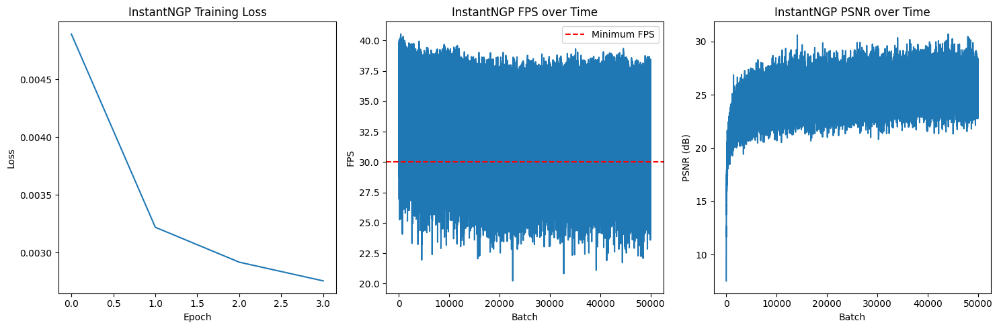






InstantNGP Training Progress:  40%|████      | 50001/125000 [29:25<3:51:59,  5.39it/s]




InstantNGP Training Progress:  40%|████      | 50004/125000 [29:25<2:59:35,  6.96it/s]


InstantNGP Epoch 5/10, Batch 0:
FPS: 29.49, Latency: 33.91ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  40%|████      | 50007/125000 [29:25<2:21:04,  8.86it/s]




InstantNGP Training Progress:  40%|████      | 50010/125000 [29:25<1:52:46, 11.08it/s]




InstantNGP Training Progress:  40%|████      | 50013/125000 [29:25<1:32:31, 13.51it/s]




InstantNGP Training Progress:  40%|████      | 50017/125000 [29:25<1:13:55, 16.91it/s]


InstantNGP Epoch 5/10, Batch 10:
FPS: 27.71, Latency: 36.08ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  40%|████      | 50020/125000 [29:26<1:06:48, 18.71it/s]




InstantNGP Training Progress:  40%|████      | 50023/125000 [29:26<1:03:22, 19.72it/s]




InstantNGP Training Progress:  40%|████      | 50026/125000 [29:26<57:30, 21.73it/s]  


InstantNGP Epoch 5/10, Batch 20:
FPS: 24.28, Latency: 41.19ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  40%|████      | 50029/125000 [29:26<55:13, 22.63it/s]




InstantNGP Training Progress:  40%|████      | 50032/125000 [29:26<52:02, 24.01it/s]




InstantNGP Training Progress:  40%|████      | 50035/125000 [29:26<50:29, 24.74it/s]


InstantNGP Epoch 5/10, Batch 30:
FPS: 31.35, Latency: 31.90ms
PSNR: 27.24dB, Loss: 0.0019







InstantNGP Training Progress:  40%|████      | 50038/125000 [29:26<49:40, 25.15it/s]




InstantNGP Training Progress:  40%|████      | 50041/125000 [29:26<47:59, 26.03it/s]




InstantNGP Training Progress:  40%|████      | 50044/125000 [29:26<46:14, 27.01it/s]


InstantNGP Epoch 5/10, Batch 40:
FPS: 31.82, Latency: 31.42ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  40%|████      | 50047/125000 [29:27<46:03, 27.13it/s]




InstantNGP Training Progress:  40%|████      | 50050/125000 [29:27<47:01, 26.57it/s]




InstantNGP Training Progress:  40%|████      | 50053/125000 [29:27<46:44, 26.72it/s]




InstantNGP Training Progress:  40%|████      | 50057/125000 [29:27<43:53, 28.46it/s]


InstantNGP Epoch 5/10, Batch 50:
FPS: 28.82, Latency: 34.69ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  40%|████      | 50060/125000 [29:27<45:36, 27.38it/s]




InstantNGP Training Progress:  40%|████      | 50063/125000 [29:27<45:59, 27.16it/s]




InstantNGP Training Progress:  40%|████      | 50066/125000 [29:27<45:33, 27.41it/s]


InstantNGP Epoch 5/10, Batch 60:
FPS: 26.53, Latency: 37.69ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  40%|████      | 50069/125000 [29:27<46:12, 27.03it/s]




InstantNGP Training Progress:  40%|████      | 50072/125000 [29:27<46:07, 27.07it/s]




InstantNGP Training Progress:  40%|████      | 50075/125000 [29:28<47:07, 26.50it/s]


InstantNGP Epoch 5/10, Batch 70:
FPS: 29.19, Latency: 34.26ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  40%|████      | 50078/125000 [29:28<46:35, 26.80it/s]




InstantNGP Training Progress:  40%|████      | 50081/125000 [29:28<45:48, 27.26it/s]




InstantNGP Training Progress:  40%|████      | 50084/125000 [29:28<46:00, 27.14it/s]


InstantNGP Epoch 5/10, Batch 80:
FPS: 28.97, Latency: 34.52ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  40%|████      | 50087/125000 [29:28<44:47, 27.87it/s]




InstantNGP Training Progress:  40%|████      | 50090/125000 [29:28<43:55, 28.43it/s]




InstantNGP Training Progress:  40%|████      | 50093/125000 [29:28<44:38, 27.97it/s]




InstantNGP Training Progress:  40%|████      | 50097/125000 [29:28<42:11, 29.59it/s]


InstantNGP Epoch 5/10, Batch 90:
FPS: 29.15, Latency: 34.30ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  40%|████      | 50100/125000 [29:28<42:48, 29.16it/s]




InstantNGP Training Progress:  40%|████      | 50104/125000 [29:29<41:57, 29.75it/s]


InstantNGP Epoch 5/10, Batch 100:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  40%|████      | 50108/125000 [29:29<42:13, 29.57it/s]




InstantNGP Training Progress:  40%|████      | 50111/125000 [29:29<43:08, 28.93it/s]




InstantNGP Training Progress:  40%|████      | 50114/125000 [29:29<45:08, 27.65it/s]


InstantNGP Epoch 5/10, Batch 110:
FPS: 31.56, Latency: 31.68ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  40%|████      | 50117/125000 [29:29<44:41, 27.93it/s]




InstantNGP Training Progress:  40%|████      | 50121/125000 [29:29<43:17, 28.82it/s]




InstantNGP Training Progress:  40%|████      | 50124/125000 [29:29<43:04, 28.97it/s]


InstantNGP Epoch 5/10, Batch 120:
FPS: 32.06, Latency: 31.20ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  40%|████      | 50128/125000 [29:29<41:07, 30.34it/s]




InstantNGP Training Progress:  40%|████      | 50132/125000 [29:30<41:19, 30.19it/s]




InstantNGP Training Progress:  40%|████      | 50136/125000 [29:30<41:08, 30.33it/s]


InstantNGP Epoch 5/10, Batch 130:
FPS: 37.23, Latency: 26.86ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  40%|████      | 50140/125000 [29:30<41:48, 29.84it/s]




InstantNGP Training Progress:  40%|████      | 50143/125000 [29:30<42:31, 29.34it/s]




InstantNGP Training Progress:  40%|████      | 50146/125000 [29:30<42:54, 29.08it/s]


InstantNGP Epoch 5/10, Batch 140:
FPS: 33.95, Latency: 29.45ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  40%|████      | 50150/125000 [29:30<42:06, 29.63it/s]




InstantNGP Training Progress:  40%|████      | 50153/125000 [29:30<42:30, 29.34it/s]




InstantNGP Training Progress:  40%|████      | 50157/125000 [29:30<41:46, 29.86it/s]


InstantNGP Epoch 5/10, Batch 150:
FPS: 27.54, Latency: 36.31ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  40%|████      | 50160/125000 [29:31<42:54, 29.07it/s]




InstantNGP Training Progress:  40%|████      | 50164/125000 [29:31<41:56, 29.74it/s]


InstantNGP Epoch 5/10, Batch 160:
FPS: 35.40, Latency: 28.25ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  40%|████      | 50168/125000 [29:31<41:50, 29.81it/s]




InstantNGP Training Progress:  40%|████      | 50172/125000 [29:31<41:24, 30.12it/s]




InstantNGP Training Progress:  40%|████      | 50176/125000 [29:31<42:02, 29.66it/s]


InstantNGP Epoch 5/10, Batch 170:
FPS: 31.51, Latency: 31.73ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  40%|████      | 50179/125000 [29:31<43:33, 28.63it/s]




InstantNGP Training Progress:  40%|████      | 50183/125000 [29:31<42:26, 29.38it/s]




InstantNGP Training Progress:  40%|████      | 50186/125000 [29:31<42:57, 29.02it/s]


InstantNGP Epoch 5/10, Batch 180:
FPS: 32.22, Latency: 31.04ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  40%|████      | 50190/125000 [29:32<42:25, 29.39it/s]




InstantNGP Training Progress:  40%|████      | 50193/125000 [29:32<43:23, 28.73it/s]




InstantNGP Training Progress:  40%|████      | 50196/125000 [29:32<43:00, 28.99it/s]


InstantNGP Epoch 5/10, Batch 190:
FPS: 32.28, Latency: 30.98ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  40%|████      | 50199/125000 [29:32<43:31, 28.65it/s]




InstantNGP Training Progress:  40%|████      | 50202/125000 [29:32<43:03, 28.95it/s]




InstantNGP Training Progress:  40%|████      | 50206/125000 [29:32<42:44, 29.17it/s]


InstantNGP Epoch 5/10, Batch 200:
FPS: 37.22, Latency: 26.86ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  40%|████      | 50210/125000 [29:32<41:23, 30.11it/s]




InstantNGP Training Progress:  40%|████      | 50214/125000 [29:32<42:55, 29.04it/s]


InstantNGP Epoch 5/10, Batch 210:
FPS: 32.62, Latency: 30.66ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  40%|████      | 50217/125000 [29:32<43:13, 28.84it/s]




InstantNGP Training Progress:  40%|████      | 50220/125000 [29:33<43:33, 28.62it/s]




InstantNGP Training Progress:  40%|████      | 50224/125000 [29:33<42:44, 29.16it/s]


InstantNGP Epoch 5/10, Batch 220:
FPS: 37.69, Latency: 26.54ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:  40%|████      | 50227/125000 [29:33<43:21, 28.74it/s]




InstantNGP Training Progress:  40%|████      | 50230/125000 [29:33<43:13, 28.83it/s]




InstantNGP Training Progress:  40%|████      | 50233/125000 [29:33<42:46, 29.14it/s]




InstantNGP Training Progress:  40%|████      | 50236/125000 [29:33<43:28, 28.66it/s]


InstantNGP Epoch 5/10, Batch 230:
FPS: 36.50, Latency: 27.40ms
PSNR: 23.01dB, Loss: 0.0050







InstantNGP Training Progress:  40%|████      | 50240/125000 [29:33<42:10, 29.54it/s]




InstantNGP Training Progress:  40%|████      | 50243/125000 [29:33<42:21, 29.42it/s]


InstantNGP Epoch 5/10, Batch 240:
FPS: 36.95, Latency: 27.06ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  40%|████      | 50247/125000 [29:33<42:01, 29.65it/s]




InstantNGP Training Progress:  40%|████      | 50250/125000 [29:34<42:53, 29.05it/s]




InstantNGP Training Progress:  40%|████      | 50253/125000 [29:34<42:33, 29.27it/s]




InstantNGP Training Progress:  40%|████      | 50257/125000 [29:34<41:21, 30.12it/s]


InstantNGP Epoch 5/10, Batch 250:
FPS: 34.12, Latency: 29.31ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  40%|████      | 50261/125000 [29:34<42:43, 29.16it/s]




InstantNGP Training Progress:  40%|████      | 50264/125000 [29:34<43:56, 28.35it/s]


InstantNGP Epoch 5/10, Batch 260:
FPS: 32.97, Latency: 30.33ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  40%|████      | 50267/125000 [29:34<43:29, 28.64it/s]




InstantNGP Training Progress:  40%|████      | 50270/125000 [29:34<43:23, 28.70it/s]




InstantNGP Training Progress:  40%|████      | 50274/125000 [29:34<41:57, 29.69it/s]




InstantNGP Training Progress:  40%|████      | 50277/125000 [29:35<42:12, 29.51it/s]


InstantNGP Epoch 5/10, Batch 270:
FPS: 37.40, Latency: 26.74ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  40%|████      | 50280/125000 [29:35<42:30, 29.30it/s]




InstantNGP Training Progress:  40%|████      | 50283/125000 [29:35<42:53, 29.04it/s]




InstantNGP Training Progress:  40%|████      | 50286/125000 [29:35<43:37, 28.55it/s]


InstantNGP Epoch 5/10, Batch 280:
FPS: 32.35, Latency: 30.92ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  40%|████      | 50289/125000 [29:35<43:03, 28.92it/s]




InstantNGP Training Progress:  40%|████      | 50292/125000 [29:35<44:26, 28.02it/s]




InstantNGP Training Progress:  40%|████      | 50295/125000 [29:35<43:54, 28.35it/s]


InstantNGP Epoch 5/10, Batch 290:
FPS: 32.19, Latency: 31.07ms
PSNR: 28.69dB, Loss: 0.0014







InstantNGP Training Progress:  40%|████      | 50298/125000 [29:35<44:25, 28.02it/s]




InstantNGP Training Progress:  40%|████      | 50301/125000 [29:35<44:26, 28.01it/s]




InstantNGP Training Progress:  40%|████      | 50304/125000 [29:35<44:07, 28.22it/s]


InstantNGP Epoch 5/10, Batch 300:
FPS: 32.47, Latency: 30.80ms
PSNR: 26.11dB, Loss: 0.0025







InstantNGP Training Progress:  40%|████      | 50308/125000 [29:36<42:24, 29.35it/s]




InstantNGP Training Progress:  40%|████      | 50311/125000 [29:36<42:28, 29.31it/s]




InstantNGP Training Progress:  40%|████      | 50315/125000 [29:36<41:37, 29.90it/s]


InstantNGP Epoch 5/10, Batch 310:
FPS: 37.08, Latency: 26.97ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  40%|████      | 50318/125000 [29:36<42:23, 29.36it/s]




InstantNGP Training Progress:  40%|████      | 50321/125000 [29:36<42:35, 29.23it/s]




InstantNGP Training Progress:  40%|████      | 50324/125000 [29:36<42:27, 29.32it/s]


InstantNGP Epoch 5/10, Batch 320:
FPS: 35.99, Latency: 27.79ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  40%|████      | 50328/125000 [29:36<41:05, 30.29it/s]




InstantNGP Training Progress:  40%|████      | 50332/125000 [29:36<40:51, 30.46it/s]




InstantNGP Training Progress:  40%|████      | 50336/125000 [29:37<41:10, 30.22it/s]


InstantNGP Epoch 5/10, Batch 330:
FPS: 37.77, Latency: 26.47ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  40%|████      | 50340/125000 [29:37<40:18, 30.87it/s]




InstantNGP Training Progress:  40%|████      | 50344/125000 [29:37<40:50, 30.47it/s]


InstantNGP Epoch 5/10, Batch 340:
FPS: 32.86, Latency: 30.43ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  40%|████      | 50348/125000 [29:37<41:00, 30.34it/s]




InstantNGP Training Progress:  40%|████      | 50352/125000 [29:37<39:59, 31.11it/s]




InstantNGP Training Progress:  40%|████      | 50356/125000 [29:37<40:25, 30.77it/s]


InstantNGP Epoch 5/10, Batch 350:
FPS: 37.64, Latency: 26.57ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  40%|████      | 50360/125000 [29:37<40:01, 31.08it/s]




InstantNGP Training Progress:  40%|████      | 50364/125000 [29:37<40:19, 30.84it/s]


InstantNGP Epoch 5/10, Batch 360:
FPS: 36.94, Latency: 27.07ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  40%|████      | 50368/125000 [29:38<39:53, 31.18it/s]




InstantNGP Training Progress:  40%|████      | 50372/125000 [29:38<41:02, 30.31it/s]




InstantNGP Training Progress:  40%|████      | 50376/125000 [29:38<42:18, 29.40it/s]


InstantNGP Epoch 5/10, Batch 370:
FPS: 33.23, Latency: 30.09ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  40%|████      | 50379/125000 [29:38<43:06, 28.85it/s]




InstantNGP Training Progress:  40%|████      | 50382/125000 [29:38<43:43, 28.44it/s]




InstantNGP Training Progress:  40%|████      | 50385/125000 [29:38<44:36, 27.88it/s]


InstantNGP Epoch 5/10, Batch 380:
FPS: 30.82, Latency: 32.45ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  40%|████      | 50389/125000 [29:38<43:19, 28.70it/s]




InstantNGP Training Progress:  40%|████      | 50392/125000 [29:38<44:27, 27.97it/s]




InstantNGP Training Progress:  40%|████      | 50395/125000 [29:39<44:34, 27.89it/s]


InstantNGP Epoch 5/10, Batch 390:
FPS: 28.61, Latency: 34.95ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  40%|████      | 50398/125000 [29:39<44:32, 27.92it/s]




InstantNGP Training Progress:  40%|████      | 50401/125000 [29:39<43:52, 28.33it/s]




InstantNGP Training Progress:  40%|████      | 50404/125000 [29:39<44:20, 28.04it/s]


InstantNGP Epoch 5/10, Batch 400:
FPS: 34.33, Latency: 29.13ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  40%|████      | 50407/125000 [29:39<44:04, 28.21it/s]




InstantNGP Training Progress:  40%|████      | 50410/125000 [29:39<43:19, 28.69it/s]




InstantNGP Training Progress:  40%|████      | 50413/125000 [29:39<43:28, 28.59it/s]




InstantNGP Training Progress:  40%|████      | 50416/125000 [29:39<44:21, 28.03it/s]


InstantNGP Epoch 5/10, Batch 410:
FPS: 37.29, Latency: 26.81ms
PSNR: 27.38dB, Loss: 0.0018







InstantNGP Training Progress:  40%|████      | 50419/125000 [29:39<44:42, 27.81it/s]




InstantNGP Training Progress:  40%|████      | 50422/125000 [29:39<44:26, 27.97it/s]




InstantNGP Training Progress:  40%|████      | 50425/125000 [29:40<44:23, 28.00it/s]


InstantNGP Epoch 5/10, Batch 420:
FPS: 31.20, Latency: 32.05ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  40%|████      | 50428/125000 [29:40<46:58, 26.46it/s]




InstantNGP Training Progress:  40%|████      | 50431/125000 [29:40<46:34, 26.68it/s]




InstantNGP Training Progress:  40%|████      | 50434/125000 [29:40<45:37, 27.24it/s]


InstantNGP Epoch 5/10, Batch 430:
FPS: 33.59, Latency: 29.77ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  40%|████      | 50438/125000 [29:40<43:06, 28.82it/s]




InstantNGP Training Progress:  40%|████      | 50441/125000 [29:40<43:05, 28.84it/s]




InstantNGP Training Progress:  40%|████      | 50444/125000 [29:40<43:27, 28.59it/s]


InstantNGP Epoch 5/10, Batch 440:
FPS: 32.43, Latency: 30.84ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  40%|████      | 50447/125000 [29:40<43:40, 28.45it/s]




InstantNGP Training Progress:  40%|████      | 50450/125000 [29:40<43:06, 28.82it/s]




InstantNGP Training Progress:  40%|████      | 50453/125000 [29:41<42:42, 29.09it/s]




InstantNGP Training Progress:  40%|████      | 50456/125000 [29:41<42:52, 28.98it/s]


InstantNGP Epoch 5/10, Batch 450:
FPS: 32.84, Latency: 30.45ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  40%|████      | 50459/125000 [29:41<42:29, 29.23it/s]




InstantNGP Training Progress:  40%|████      | 50462/125000 [29:41<42:24, 29.30it/s]




InstantNGP Training Progress:  40%|████      | 50465/125000 [29:41<42:08, 29.48it/s]


InstantNGP Epoch 5/10, Batch 460:
FPS: 29.33, Latency: 34.10ms
PSNR: 28.04dB, Loss: 0.0016







InstantNGP Training Progress:  40%|████      | 50468/125000 [29:41<43:56, 28.26it/s]




InstantNGP Training Progress:  40%|████      | 50471/125000 [29:41<43:55, 28.28it/s]




InstantNGP Training Progress:  40%|████      | 50475/125000 [29:41<42:15, 29.40it/s]


InstantNGP Epoch 5/10, Batch 470:
FPS: 36.81, Latency: 27.17ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  40%|████      | 50478/125000 [29:41<42:02, 29.54it/s]




InstantNGP Training Progress:  40%|████      | 50481/125000 [29:42<42:03, 29.54it/s]




InstantNGP Training Progress:  40%|████      | 50484/125000 [29:42<42:55, 28.93it/s]


InstantNGP Epoch 5/10, Batch 480:
FPS: 35.66, Latency: 28.04ms
PSNR: 28.41dB, Loss: 0.0014







InstantNGP Training Progress:  40%|████      | 50488/125000 [29:42<42:00, 29.56it/s]




InstantNGP Training Progress:  40%|████      | 50491/125000 [29:42<42:22, 29.31it/s]




InstantNGP Training Progress:  40%|████      | 50494/125000 [29:42<43:59, 28.23it/s]


InstantNGP Epoch 5/10, Batch 490:
FPS: 31.80, Latency: 31.45ms
PSNR: 23.20dB, Loss: 0.0048







InstantNGP Training Progress:  40%|████      | 50498/125000 [29:42<41:53, 29.64it/s]




InstantNGP Training Progress:  40%|████      | 50501/125000 [29:42<42:22, 29.30it/s]




InstantNGP Training Progress:  40%|████      | 50505/125000 [29:42<41:05, 30.22it/s]


InstantNGP Epoch 5/10, Batch 500:
FPS: 33.82, Latency: 29.57ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  40%|████      | 50509/125000 [29:42<41:49, 29.68it/s]




InstantNGP Training Progress:  40%|████      | 50512/125000 [29:43<42:12, 29.41it/s]




InstantNGP Training Progress:  40%|████      | 50515/125000 [29:43<43:10, 28.75it/s]


InstantNGP Epoch 5/10, Batch 510:
FPS: 31.57, Latency: 31.68ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  40%|████      | 50518/125000 [29:43<42:53, 28.95it/s]




InstantNGP Training Progress:  40%|████      | 50521/125000 [29:43<42:48, 28.99it/s]




InstantNGP Training Progress:  40%|████      | 50524/125000 [29:43<42:29, 29.21it/s]


InstantNGP Epoch 5/10, Batch 520:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  40%|████      | 50527/125000 [29:43<42:30, 29.19it/s]




InstantNGP Training Progress:  40%|████      | 50530/125000 [29:43<43:08, 28.77it/s]




InstantNGP Training Progress:  40%|████      | 50533/125000 [29:43<43:41, 28.41it/s]


InstantNGP Epoch 5/10, Batch 530:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  40%|████      | 50537/125000 [29:43<42:08, 29.44it/s]




InstantNGP Training Progress:  40%|████      | 50540/125000 [29:44<42:59, 28.86it/s]




InstantNGP Training Progress:  40%|████      | 50544/125000 [29:44<41:44, 29.73it/s]




InstantNGP Training Progress:  40%|████      | 50547/125000 [29:44<42:08, 29.44it/s]


InstantNGP Epoch 5/10, Batch 540:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  40%|████      | 50550/125000 [29:44<42:24, 29.26it/s]




InstantNGP Training Progress:  40%|████      | 50553/125000 [29:44<43:04, 28.80it/s]




InstantNGP Training Progress:  40%|████      | 50556/125000 [29:44<42:49, 28.97it/s]


InstantNGP Epoch 5/10, Batch 550:
FPS: 30.87, Latency: 32.39ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  40%|████      | 50559/125000 [29:44<42:34, 29.14it/s]




InstantNGP Training Progress:  40%|████      | 50562/125000 [29:44<43:44, 28.37it/s]




InstantNGP Training Progress:  40%|████      | 50566/125000 [29:44<42:40, 29.07it/s]


InstantNGP Epoch 5/10, Batch 560:
FPS: 32.18, Latency: 31.07ms
PSNR: 29.04dB, Loss: 0.0012







InstantNGP Training Progress:  40%|████      | 50569/125000 [29:45<42:31, 29.17it/s]




InstantNGP Training Progress:  40%|████      | 50572/125000 [29:45<43:17, 28.65it/s]




InstantNGP Training Progress:  40%|████      | 50576/125000 [29:45<42:00, 29.53it/s]


InstantNGP Epoch 5/10, Batch 570:
FPS: 31.74, Latency: 31.50ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  40%|████      | 50579/125000 [29:45<43:53, 28.26it/s]




InstantNGP Training Progress:  40%|████      | 50582/125000 [29:45<43:26, 28.55it/s]




InstantNGP Training Progress:  40%|████      | 50585/125000 [29:45<43:55, 28.23it/s]


InstantNGP Epoch 5/10, Batch 580:
FPS: 33.15, Latency: 30.17ms
PSNR: 27.98dB, Loss: 0.0016







InstantNGP Training Progress:  40%|████      | 50588/125000 [29:45<43:44, 28.35it/s]




InstantNGP Training Progress:  40%|████      | 50591/125000 [29:45<43:29, 28.51it/s]




InstantNGP Training Progress:  40%|████      | 50594/125000 [29:45<43:24, 28.57it/s]


InstantNGP Epoch 5/10, Batch 590:
FPS: 34.62, Latency: 28.89ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  40%|████      | 50597/125000 [29:46<43:38, 28.41it/s]




InstantNGP Training Progress:  40%|████      | 50601/125000 [29:46<42:06, 29.45it/s]




InstantNGP Training Progress:  40%|████      | 50604/125000 [29:46<42:35, 29.11it/s]


InstantNGP Epoch 5/10, Batch 600:
FPS: 37.73, Latency: 26.51ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  40%|████      | 50607/125000 [29:46<42:51, 28.93it/s]




InstantNGP Training Progress:  40%|████      | 50610/125000 [29:46<43:02, 28.81it/s]




InstantNGP Training Progress:  40%|████      | 50614/125000 [29:46<42:10, 29.40it/s]


InstantNGP Epoch 5/10, Batch 610:
FPS: 32.90, Latency: 30.39ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  40%|████      | 50617/125000 [29:46<43:05, 28.77it/s]




InstantNGP Training Progress:  40%|████      | 50621/125000 [29:46<42:25, 29.22it/s]




InstantNGP Training Progress:  40%|████      | 50625/125000 [29:46<41:26, 29.91it/s]


InstantNGP Epoch 5/10, Batch 620:
FPS: 31.83, Latency: 31.42ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  41%|████      | 50628/125000 [29:47<41:58, 29.54it/s]




InstantNGP Training Progress:  41%|████      | 50631/125000 [29:47<42:50, 28.93it/s]




InstantNGP Training Progress:  41%|████      | 50634/125000 [29:47<42:31, 29.15it/s]


InstantNGP Epoch 5/10, Batch 630:
FPS: 36.61, Latency: 27.32ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 50637/125000 [29:47<42:43, 29.01it/s]




InstantNGP Training Progress:  41%|████      | 50640/125000 [29:47<42:53, 28.90it/s]




InstantNGP Training Progress:  41%|████      | 50644/125000 [29:47<41:53, 29.58it/s]




InstantNGP Training Progress:  41%|████      | 50647/125000 [29:47<41:57, 29.53it/s]


InstantNGP Epoch 5/10, Batch 640:
FPS: 31.06, Latency: 32.20ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 50650/125000 [29:47<43:17, 28.62it/s]




InstantNGP Training Progress:  41%|████      | 50653/125000 [29:47<43:18, 28.61it/s]




InstantNGP Training Progress:  41%|████      | 50657/125000 [29:48<41:57, 29.53it/s]


InstantNGP Epoch 5/10, Batch 650:
FPS: 30.26, Latency: 33.05ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  41%|████      | 50661/125000 [29:48<41:23, 29.94it/s]




InstantNGP Training Progress:  41%|████      | 50664/125000 [29:48<42:23, 29.23it/s]


InstantNGP Epoch 5/10, Batch 660:
FPS: 36.92, Latency: 27.08ms
PSNR: 22.93dB, Loss: 0.0051







InstantNGP Training Progress:  41%|████      | 50667/125000 [29:48<42:17, 29.29it/s]




InstantNGP Training Progress:  41%|████      | 50671/125000 [29:48<41:41, 29.71it/s]




InstantNGP Training Progress:  41%|████      | 50675/125000 [29:48<41:14, 30.04it/s]


InstantNGP Epoch 5/10, Batch 670:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  41%|████      | 50678/125000 [29:48<41:21, 29.95it/s]




InstantNGP Training Progress:  41%|████      | 50681/125000 [29:48<42:18, 29.27it/s]




InstantNGP Training Progress:  41%|████      | 50684/125000 [29:49<44:02, 28.13it/s]


InstantNGP Epoch 5/10, Batch 680:
FPS: 32.06, Latency: 31.20ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████      | 50687/125000 [29:49<43:43, 28.32it/s]




InstantNGP Training Progress:  41%|████      | 50691/125000 [29:49<42:31, 29.12it/s]




InstantNGP Training Progress:  41%|████      | 50694/125000 [29:49<42:53, 28.87it/s]


InstantNGP Epoch 5/10, Batch 690:
FPS: 34.35, Latency: 29.11ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  41%|████      | 50697/125000 [29:49<43:20, 28.58it/s]




InstantNGP Training Progress:  41%|████      | 50700/125000 [29:49<43:03, 28.76it/s]




InstantNGP Training Progress:  41%|████      | 50703/125000 [29:49<43:25, 28.52it/s]




InstantNGP Training Progress:  41%|████      | 50706/125000 [29:49<43:18, 28.59it/s]


InstantNGP Epoch 5/10, Batch 700:
FPS: 30.25, Latency: 33.06ms
PSNR: 29.11dB, Loss: 0.0012







InstantNGP Training Progress:  41%|████      | 50710/125000 [29:49<41:50, 29.60it/s]




InstantNGP Training Progress:  41%|████      | 50713/125000 [29:50<42:44, 28.96it/s]




InstantNGP Training Progress:  41%|████      | 50717/125000 [29:50<41:01, 30.17it/s]


InstantNGP Epoch 5/10, Batch 710:
FPS: 31.67, Latency: 31.58ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  41%|████      | 50721/125000 [29:50<40:42, 30.41it/s]




InstantNGP Training Progress:  41%|████      | 50725/125000 [29:50<42:31, 29.11it/s]


InstantNGP Epoch 5/10, Batch 720:
FPS: 32.72, Latency: 30.56ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████      | 50728/125000 [29:50<43:07, 28.70it/s]




InstantNGP Training Progress:  41%|████      | 50732/125000 [29:50<42:18, 29.26it/s]




InstantNGP Training Progress:  41%|████      | 50735/125000 [29:50<42:10, 29.35it/s]


InstantNGP Epoch 5/10, Batch 730:
FPS: 31.62, Latency: 31.63ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  41%|████      | 50738/125000 [29:50<42:27, 29.15it/s]




InstantNGP Training Progress:  41%|████      | 50741/125000 [29:50<45:13, 27.37it/s]




InstantNGP Training Progress:  41%|████      | 50744/125000 [29:51<45:08, 27.42it/s]


InstantNGP Epoch 5/10, Batch 740:
FPS: 24.04, Latency: 41.60ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  41%|████      | 50747/125000 [29:51<44:51, 27.59it/s]




InstantNGP Training Progress:  41%|████      | 50750/125000 [29:51<46:44, 26.48it/s]




InstantNGP Training Progress:  41%|████      | 50753/125000 [29:51<46:17, 26.73it/s]




InstantNGP Training Progress:  41%|████      | 50756/125000 [29:51<45:29, 27.20it/s]


InstantNGP Epoch 5/10, Batch 750:
FPS: 27.89, Latency: 35.86ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 50759/125000 [29:51<45:03, 27.46it/s]




InstantNGP Training Progress:  41%|████      | 50762/125000 [29:51<46:00, 26.89it/s]




InstantNGP Training Progress:  41%|████      | 50765/125000 [29:51<45:03, 27.45it/s]


InstantNGP Epoch 5/10, Batch 760:
FPS: 36.08, Latency: 27.72ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  41%|████      | 50768/125000 [29:51<44:35, 27.75it/s]




InstantNGP Training Progress:  41%|████      | 50771/125000 [29:52<47:38, 25.97it/s]




InstantNGP Training Progress:  41%|████      | 50774/125000 [29:52<46:15, 26.74it/s]


InstantNGP Epoch 5/10, Batch 770:
FPS: 24.81, Latency: 40.30ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  41%|████      | 50777/125000 [29:52<45:46, 27.02it/s]




InstantNGP Training Progress:  41%|████      | 50780/125000 [29:52<46:55, 26.36it/s]




InstantNGP Training Progress:  41%|████      | 50783/125000 [29:52<45:24, 27.24it/s]




InstantNGP Training Progress:  41%|████      | 50786/125000 [29:52<44:34, 27.75it/s]


InstantNGP Epoch 5/10, Batch 780:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  41%|████      | 50790/125000 [29:52<43:13, 28.62it/s]




InstantNGP Training Progress:  41%|████      | 50793/125000 [29:52<42:47, 28.90it/s]




InstantNGP Training Progress:  41%|████      | 50796/125000 [29:52<42:58, 28.78it/s]


InstantNGP Epoch 5/10, Batch 790:
FPS: 38.57, Latency: 25.92ms
PSNR: 27.50dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 50800/125000 [29:53<42:43, 28.94it/s]




InstantNGP Training Progress:  41%|████      | 50804/125000 [29:53<41:41, 29.66it/s]


InstantNGP Epoch 5/10, Batch 800:
FPS: 32.58, Latency: 30.69ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  41%|████      | 50808/125000 [29:53<40:59, 30.17it/s]




InstantNGP Training Progress:  41%|████      | 50812/125000 [29:53<40:40, 30.40it/s]




InstantNGP Training Progress:  41%|████      | 50816/125000 [29:53<40:08, 30.80it/s]


InstantNGP Epoch 5/10, Batch 810:
FPS: 36.28, Latency: 27.56ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 50820/125000 [29:53<40:09, 30.79it/s]




InstantNGP Training Progress:  41%|████      | 50824/125000 [29:53<40:47, 30.31it/s]


InstantNGP Epoch 5/10, Batch 820:
FPS: 34.78, Latency: 28.76ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  41%|████      | 50828/125000 [29:54<41:01, 30.14it/s]




InstantNGP Training Progress:  41%|████      | 50832/125000 [29:54<40:16, 30.69it/s]




InstantNGP Training Progress:  41%|████      | 50836/125000 [29:54<40:11, 30.75it/s]


InstantNGP Epoch 5/10, Batch 830:
FPS: 37.17, Latency: 26.90ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  41%|████      | 50840/125000 [29:54<41:38, 29.68it/s]




InstantNGP Training Progress:  41%|████      | 50843/125000 [29:54<41:59, 29.43it/s]




InstantNGP Training Progress:  41%|████      | 50846/125000 [29:54<42:09, 29.32it/s]


InstantNGP Epoch 5/10, Batch 840:
FPS: 37.30, Latency: 26.81ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 50849/125000 [29:54<43:12, 28.61it/s]




InstantNGP Training Progress:  41%|████      | 50852/125000 [29:54<43:15, 28.57it/s]




InstantNGP Training Progress:  41%|████      | 50855/125000 [29:54<42:42, 28.93it/s]


InstantNGP Epoch 5/10, Batch 850:
FPS: 30.50, Latency: 32.79ms
PSNR: 27.10dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████      | 50858/125000 [29:55<42:58, 28.75it/s]




InstantNGP Training Progress:  41%|████      | 50861/125000 [29:55<42:29, 29.08it/s]




InstantNGP Training Progress:  41%|████      | 50864/125000 [29:55<42:59, 28.74it/s]


InstantNGP Epoch 5/10, Batch 860:
FPS: 30.58, Latency: 32.71ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  41%|████      | 50867/125000 [29:55<43:46, 28.22it/s]




InstantNGP Training Progress:  41%|████      | 50870/125000 [29:55<44:33, 27.73it/s]




InstantNGP Training Progress:  41%|████      | 50874/125000 [29:55<42:41, 28.94it/s]




InstantNGP Training Progress:  41%|████      | 50877/125000 [29:55<42:21, 29.17it/s]


InstantNGP Epoch 5/10, Batch 870:
FPS: 36.66, Latency: 27.28ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  41%|████      | 50880/125000 [29:55<43:05, 28.67it/s]




InstantNGP Training Progress:  41%|████      | 50884/125000 [29:55<42:32, 29.03it/s]


InstantNGP Epoch 5/10, Batch 880:
FPS: 32.16, Latency: 31.09ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 50888/125000 [29:56<41:33, 29.72it/s]




InstantNGP Training Progress:  41%|████      | 50891/125000 [29:56<41:37, 29.67it/s]




InstantNGP Training Progress:  41%|████      | 50894/125000 [29:56<42:45, 28.89it/s]


InstantNGP Epoch 5/10, Batch 890:
FPS: 31.65, Latency: 31.59ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  41%|████      | 50897/125000 [29:56<42:34, 29.01it/s]




InstantNGP Training Progress:  41%|████      | 50900/125000 [29:56<42:44, 28.89it/s]




InstantNGP Training Progress:  41%|████      | 50903/125000 [29:56<42:26, 29.10it/s]




InstantNGP Training Progress:  41%|████      | 50906/125000 [29:56<43:19, 28.50it/s]


InstantNGP Epoch 5/10, Batch 900:
FPS: 32.17, Latency: 31.09ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  41%|████      | 50909/125000 [29:56<42:50, 28.82it/s]




InstantNGP Training Progress:  41%|████      | 50913/125000 [29:56<41:29, 29.76it/s]




InstantNGP Training Progress:  41%|████      | 50916/125000 [29:57<41:39, 29.64it/s]


InstantNGP Epoch 5/10, Batch 910:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  41%|████      | 50920/125000 [29:57<40:12, 30.71it/s]




InstantNGP Training Progress:  41%|████      | 50924/125000 [29:57<40:15, 30.67it/s]


InstantNGP Epoch 5/10, Batch 920:
FPS: 33.21, Latency: 30.12ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  41%|████      | 50928/125000 [29:57<41:23, 29.82it/s]




InstantNGP Training Progress:  41%|████      | 50931/125000 [29:57<41:51, 29.50it/s]




InstantNGP Training Progress:  41%|████      | 50935/125000 [29:57<41:10, 29.98it/s]


InstantNGP Epoch 5/10, Batch 930:
FPS: 37.53, Latency: 26.65ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  41%|████      | 50938/125000 [29:57<41:44, 29.57it/s]




InstantNGP Training Progress:  41%|████      | 50941/125000 [29:57<41:36, 29.67it/s]




InstantNGP Training Progress:  41%|████      | 50944/125000 [29:58<42:53, 28.78it/s]


InstantNGP Epoch 5/10, Batch 940:
FPS: 36.64, Latency: 27.29ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 50947/125000 [29:58<42:42, 28.90it/s]




InstantNGP Training Progress:  41%|████      | 50951/125000 [29:58<42:18, 29.17it/s]




InstantNGP Training Progress:  41%|████      | 50954/125000 [29:58<42:03, 29.35it/s]


InstantNGP Epoch 5/10, Batch 950:
FPS: 29.09, Latency: 34.38ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 50957/125000 [29:58<42:10, 29.26it/s]




InstantNGP Training Progress:  41%|████      | 50960/125000 [29:58<43:11, 28.57it/s]




InstantNGP Training Progress:  41%|████      | 50963/125000 [29:58<43:25, 28.42it/s]




InstantNGP Training Progress:  41%|████      | 50967/125000 [29:58<41:53, 29.46it/s]


InstantNGP Epoch 5/10, Batch 960:
FPS: 28.04, Latency: 35.66ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 50970/125000 [29:58<42:20, 29.14it/s]




InstantNGP Training Progress:  41%|████      | 50973/125000 [29:59<42:25, 29.08it/s]




InstantNGP Training Progress:  41%|████      | 50976/125000 [29:59<43:53, 28.10it/s]


InstantNGP Epoch 5/10, Batch 970:
FPS: 32.01, Latency: 31.24ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  41%|████      | 50979/125000 [29:59<43:40, 28.25it/s]




InstantNGP Training Progress:  41%|████      | 50982/125000 [29:59<44:11, 27.92it/s]




InstantNGP Training Progress:  41%|████      | 50985/125000 [29:59<44:02, 28.01it/s]


InstantNGP Epoch 5/10, Batch 980:
FPS: 32.17, Latency: 31.09ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 50988/125000 [29:59<43:19, 28.47it/s]




InstantNGP Training Progress:  41%|████      | 50991/125000 [29:59<43:46, 28.18it/s]




InstantNGP Training Progress:  41%|████      | 50995/125000 [29:59<41:35, 29.66it/s]


InstantNGP Epoch 5/10, Batch 990:
FPS: 32.10, Latency: 31.15ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  41%|████      | 50998/125000 [29:59<42:11, 29.23it/s]




InstantNGP Training Progress:  41%|████      | 51001/125000 [29:59<42:30, 29.02it/s]




InstantNGP Training Progress:  41%|████      | 51004/125000 [30:00<42:33, 28.98it/s]


InstantNGP Epoch 5/10, Batch 1000:
FPS: 36.31, Latency: 27.54ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  41%|████      | 51008/125000 [30:00<41:50, 29.48it/s]




InstantNGP Training Progress:  41%|████      | 51011/125000 [30:00<42:14, 29.19it/s]




InstantNGP Training Progress:  41%|████      | 51014/125000 [30:00<42:42, 28.87it/s]


InstantNGP Epoch 5/10, Batch 1010:
FPS: 32.84, Latency: 30.45ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51018/125000 [30:00<42:00, 29.36it/s]




InstantNGP Training Progress:  41%|████      | 51021/125000 [30:00<42:39, 28.91it/s]




InstantNGP Training Progress:  41%|████      | 51024/125000 [30:00<42:21, 29.11it/s]


InstantNGP Epoch 5/10, Batch 1020:
FPS: 31.82, Latency: 31.43ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 51028/125000 [30:00<42:19, 29.13it/s]




InstantNGP Training Progress:  41%|████      | 51032/125000 [30:01<41:31, 29.69it/s]




InstantNGP Training Progress:  41%|████      | 51035/125000 [30:01<43:09, 28.57it/s]


InstantNGP Epoch 5/10, Batch 1030:
FPS: 36.84, Latency: 27.15ms
PSNR: 23.49dB, Loss: 0.0045







InstantNGP Training Progress:  41%|████      | 51038/125000 [30:01<42:48, 28.79it/s]




InstantNGP Training Progress:  41%|████      | 51041/125000 [30:01<42:58, 28.68it/s]




InstantNGP Training Progress:  41%|████      | 51045/125000 [30:01<41:27, 29.73it/s]


InstantNGP Epoch 5/10, Batch 1040:
FPS: 32.86, Latency: 30.43ms
PSNR: 25.45dB, Loss: 0.0028







InstantNGP Training Progress:  41%|████      | 51048/125000 [30:01<43:03, 28.63it/s]




InstantNGP Training Progress:  41%|████      | 51051/125000 [30:01<42:44, 28.84it/s]




InstantNGP Training Progress:  41%|████      | 51054/125000 [30:01<42:26, 29.04it/s]


InstantNGP Epoch 5/10, Batch 1050:
FPS: 38.50, Latency: 25.97ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 51057/125000 [30:01<43:13, 28.51it/s]




InstantNGP Training Progress:  41%|████      | 51061/125000 [30:02<42:32, 28.97it/s]




InstantNGP Training Progress:  41%|████      | 51064/125000 [30:02<42:43, 28.84it/s]


InstantNGP Epoch 5/10, Batch 1060:
FPS: 33.11, Latency: 30.20ms
PSNR: 26.97dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51068/125000 [30:02<42:13, 29.19it/s]




InstantNGP Training Progress:  41%|████      | 51071/125000 [30:02<42:53, 28.73it/s]




InstantNGP Training Progress:  41%|████      | 51074/125000 [30:02<42:36, 28.91it/s]


InstantNGP Epoch 5/10, Batch 1070:
FPS: 26.47, Latency: 37.78ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  41%|████      | 51077/125000 [30:02<42:48, 28.78it/s]




InstantNGP Training Progress:  41%|████      | 51080/125000 [30:02<42:36, 28.92it/s]




InstantNGP Training Progress:  41%|████      | 51083/125000 [30:02<42:44, 28.82it/s]




InstantNGP Training Progress:  41%|████      | 51086/125000 [30:02<43:01, 28.63it/s]


InstantNGP Epoch 5/10, Batch 1080:
FPS: 31.15, Latency: 32.10ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████      | 51089/125000 [30:03<43:29, 28.32it/s]




InstantNGP Training Progress:  41%|████      | 51092/125000 [30:03<44:14, 27.84it/s]




InstantNGP Training Progress:  41%|████      | 51095/125000 [30:03<43:48, 28.11it/s]


InstantNGP Epoch 5/10, Batch 1090:
FPS: 26.59, Latency: 37.61ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  41%|████      | 51098/125000 [30:03<43:44, 28.16it/s]




InstantNGP Training Progress:  41%|████      | 51101/125000 [30:03<44:03, 27.96it/s]




InstantNGP Training Progress:  41%|████      | 51105/125000 [30:03<41:56, 29.36it/s]


InstantNGP Epoch 5/10, Batch 1100:
FPS: 29.70, Latency: 33.67ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  41%|████      | 51108/125000 [30:03<42:23, 29.05it/s]




InstantNGP Training Progress:  41%|████      | 51112/125000 [30:03<41:20, 29.78it/s]




InstantNGP Training Progress:  41%|████      | 51115/125000 [30:03<41:38, 29.57it/s]


InstantNGP Epoch 5/10, Batch 1110:
FPS: 37.56, Latency: 26.62ms
PSNR: 23.62dB, Loss: 0.0043







InstantNGP Training Progress:  41%|████      | 51118/125000 [30:04<41:50, 29.43it/s]




InstantNGP Training Progress:  41%|████      | 51121/125000 [30:04<42:34, 28.92it/s]




InstantNGP Training Progress:  41%|████      | 51124/125000 [30:04<42:29, 28.97it/s]


InstantNGP Epoch 5/10, Batch 1120:
FPS: 33.93, Latency: 29.47ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:  41%|████      | 51127/125000 [30:04<44:48, 27.47it/s]




InstantNGP Training Progress:  41%|████      | 51130/125000 [30:04<45:04, 27.31it/s]




InstantNGP Training Progress:  41%|████      | 51133/125000 [30:04<44:25, 27.72it/s]


InstantNGP Epoch 5/10, Batch 1130:
FPS: 35.83, Latency: 27.91ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  41%|████      | 51137/125000 [30:04<43:09, 28.52it/s]




InstantNGP Training Progress:  41%|████      | 51140/125000 [30:04<42:53, 28.70it/s]




InstantNGP Training Progress:  41%|████      | 51143/125000 [30:04<42:41, 28.84it/s]




InstantNGP Training Progress:  41%|████      | 51146/125000 [30:05<42:14, 29.14it/s]


InstantNGP Epoch 5/10, Batch 1140:
FPS: 33.33, Latency: 30.00ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  41%|████      | 51149/125000 [30:05<42:15, 29.13it/s]




InstantNGP Training Progress:  41%|████      | 51152/125000 [30:05<42:21, 29.06it/s]




InstantNGP Training Progress:  41%|████      | 51156/125000 [30:05<41:09, 29.90it/s]


InstantNGP Epoch 5/10, Batch 1150:
FPS: 32.40, Latency: 30.87ms
PSNR: 27.99dB, Loss: 0.0016







InstantNGP Training Progress:  41%|████      | 51159/125000 [30:05<42:47, 28.76it/s]




InstantNGP Training Progress:  41%|████      | 51162/125000 [30:05<42:19, 29.07it/s]




InstantNGP Training Progress:  41%|████      | 51166/125000 [30:05<41:31, 29.63it/s]


InstantNGP Epoch 5/10, Batch 1160:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  41%|████      | 51170/125000 [30:05<40:54, 30.08it/s]




InstantNGP Training Progress:  41%|████      | 51174/125000 [30:05<40:14, 30.57it/s]


InstantNGP Epoch 5/10, Batch 1170:
FPS: 32.80, Latency: 30.49ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  41%|████      | 51178/125000 [30:06<40:36, 30.30it/s]




InstantNGP Training Progress:  41%|████      | 51182/125000 [30:06<42:14, 29.12it/s]




InstantNGP Training Progress:  41%|████      | 51185/125000 [30:06<41:56, 29.33it/s]


InstantNGP Epoch 5/10, Batch 1180:
FPS: 30.38, Latency: 32.92ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  41%|████      | 51188/125000 [30:06<42:05, 29.23it/s]




InstantNGP Training Progress:  41%|████      | 51191/125000 [30:06<42:30, 28.94it/s]




InstantNGP Training Progress:  41%|████      | 51194/125000 [30:06<42:43, 28.79it/s]


InstantNGP Epoch 5/10, Batch 1190:
FPS: 26.89, Latency: 37.19ms
PSNR: 26.97dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51197/125000 [30:06<42:39, 28.84it/s]




InstantNGP Training Progress:  41%|████      | 51200/125000 [30:06<42:12, 29.14it/s]




InstantNGP Training Progress:  41%|████      | 51204/125000 [30:06<41:28, 29.66it/s]




InstantNGP Training Progress:  41%|████      | 51207/125000 [30:07<41:30, 29.63it/s]


InstantNGP Epoch 5/10, Batch 1200:
FPS: 36.90, Latency: 27.10ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  41%|████      | 51210/125000 [30:07<42:25, 28.99it/s]




InstantNGP Training Progress:  41%|████      | 51213/125000 [30:07<42:20, 29.04it/s]




InstantNGP Training Progress:  41%|████      | 51216/125000 [30:07<43:13, 28.45it/s]


InstantNGP Epoch 5/10, Batch 1210:
FPS: 34.71, Latency: 28.81ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  41%|████      | 51219/125000 [30:07<42:47, 28.74it/s]




InstantNGP Training Progress:  41%|████      | 51222/125000 [30:07<42:17, 29.07it/s]




InstantNGP Training Progress:  41%|████      | 51226/125000 [30:07<41:19, 29.76it/s]


InstantNGP Epoch 5/10, Batch 1220:
FPS: 35.12, Latency: 28.47ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51229/125000 [30:07<41:38, 29.53it/s]




InstantNGP Training Progress:  41%|████      | 51233/125000 [30:07<41:28, 29.64it/s]




InstantNGP Training Progress:  41%|████      | 51236/125000 [30:08<42:50, 28.70it/s]


InstantNGP Epoch 5/10, Batch 1230:
FPS: 30.23, Latency: 33.08ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 51239/125000 [30:08<42:59, 28.59it/s]




InstantNGP Training Progress:  41%|████      | 51242/125000 [30:08<44:01, 27.92it/s]




InstantNGP Training Progress:  41%|████      | 51245/125000 [30:08<44:17, 27.75it/s]


InstantNGP Epoch 5/10, Batch 1240:
FPS: 31.36, Latency: 31.89ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 51248/125000 [30:08<43:44, 28.10it/s]




InstantNGP Training Progress:  41%|████      | 51251/125000 [30:08<43:50, 28.03it/s]




InstantNGP Training Progress:  41%|████      | 51254/125000 [30:08<43:01, 28.57it/s]


InstantNGP Epoch 5/10, Batch 1250:
FPS: 31.36, Latency: 31.89ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  41%|████      | 51258/125000 [30:08<41:55, 29.31it/s]




InstantNGP Training Progress:  41%|████      | 51261/125000 [30:08<41:44, 29.45it/s]




InstantNGP Training Progress:  41%|████      | 51265/125000 [30:09<40:53, 30.06it/s]


InstantNGP Epoch 5/10, Batch 1260:
FPS: 38.12, Latency: 26.24ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████      | 51269/125000 [30:09<40:58, 29.99it/s]




InstantNGP Training Progress:  41%|████      | 51273/125000 [30:09<41:17, 29.76it/s]




InstantNGP Training Progress:  41%|████      | 51276/125000 [30:09<42:37, 28.82it/s]


InstantNGP Epoch 5/10, Batch 1270:
FPS: 36.53, Latency: 27.37ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████      | 51279/125000 [30:09<42:39, 28.80it/s]




InstantNGP Training Progress:  41%|████      | 51282/125000 [30:09<44:00, 27.92it/s]




InstantNGP Training Progress:  41%|████      | 51286/125000 [30:09<42:27, 28.94it/s]


InstantNGP Epoch 5/10, Batch 1280:
FPS: 30.39, Latency: 32.90ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  41%|████      | 51290/125000 [30:09<40:54, 30.03it/s]




InstantNGP Training Progress:  41%|████      | 51293/125000 [30:10<42:13, 29.10it/s]


InstantNGP Epoch 5/10, Batch 1290:
FPS: 30.04, Latency: 33.29ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  41%|████      | 51297/125000 [30:10<41:32, 29.57it/s]




InstantNGP Training Progress:  41%|████      | 51300/125000 [30:10<42:48, 28.69it/s]




InstantNGP Training Progress:  41%|████      | 51304/125000 [30:10<42:06, 29.16it/s]


InstantNGP Epoch 5/10, Batch 1300:
FPS: 31.39, Latency: 31.86ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  41%|████      | 51307/125000 [30:10<42:47, 28.70it/s]




InstantNGP Training Progress:  41%|████      | 51310/125000 [30:10<43:03, 28.53it/s]




InstantNGP Training Progress:  41%|████      | 51313/125000 [30:10<43:31, 28.21it/s]




InstantNGP Training Progress:  41%|████      | 51316/125000 [30:10<43:10, 28.45it/s]


InstantNGP Epoch 5/10, Batch 1310:
FPS: 32.63, Latency: 30.65ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████      | 51320/125000 [30:10<41:54, 29.31it/s]




InstantNGP Training Progress:  41%|████      | 51323/125000 [30:11<43:20, 28.33it/s]




InstantNGP Training Progress:  41%|████      | 51327/125000 [30:11<41:42, 29.44it/s]


InstantNGP Epoch 5/10, Batch 1320:
FPS: 27.87, Latency: 35.87ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51330/125000 [30:11<42:24, 28.95it/s]




InstantNGP Training Progress:  41%|████      | 51333/125000 [30:11<43:45, 28.06it/s]




InstantNGP Training Progress:  41%|████      | 51336/125000 [30:11<43:42, 28.09it/s]


InstantNGP Epoch 5/10, Batch 1330:
FPS: 28.89, Latency: 34.62ms
PSNR: 23.92dB, Loss: 0.0041







InstantNGP Training Progress:  41%|████      | 51339/125000 [30:11<44:11, 27.79it/s]




InstantNGP Training Progress:  41%|████      | 51343/125000 [30:11<42:13, 29.08it/s]




InstantNGP Training Progress:  41%|████      | 51346/125000 [30:11<42:00, 29.22it/s]


InstantNGP Epoch 5/10, Batch 1340:
FPS: 37.34, Latency: 26.78ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51350/125000 [30:12<41:14, 29.77it/s]




InstantNGP Training Progress:  41%|████      | 51354/125000 [30:12<41:08, 29.83it/s]




InstantNGP Training Progress:  41%|████      | 51357/125000 [30:12<41:28, 29.59it/s]


InstantNGP Epoch 5/10, Batch 1350:
FPS: 32.11, Latency: 31.15ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  41%|████      | 51361/125000 [30:12<41:01, 29.91it/s]




InstantNGP Training Progress:  41%|████      | 51364/125000 [30:12<41:48, 29.35it/s]


InstantNGP Epoch 5/10, Batch 1360:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  41%|████      | 51367/125000 [30:12<41:58, 29.24it/s]




InstantNGP Training Progress:  41%|████      | 51370/125000 [30:12<42:30, 28.87it/s]




InstantNGP Training Progress:  41%|████      | 51374/125000 [30:12<41:30, 29.57it/s]


InstantNGP Epoch 5/10, Batch 1370:
FPS: 36.38, Latency: 27.49ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████      | 51377/125000 [30:12<42:56, 28.57it/s]




InstantNGP Training Progress:  41%|████      | 51380/125000 [30:13<42:51, 28.62it/s]




InstantNGP Training Progress:  41%|████      | 51383/125000 [30:13<43:14, 28.38it/s]




InstantNGP Training Progress:  41%|████      | 51386/125000 [30:13<42:40, 28.75it/s]


InstantNGP Epoch 5/10, Batch 1380:
FPS: 32.27, Latency: 30.99ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  41%|████      | 51390/125000 [30:13<41:57, 29.24it/s]




InstantNGP Training Progress:  41%|████      | 51393/125000 [30:13<42:13, 29.06it/s]




InstantNGP Training Progress:  41%|████      | 51397/125000 [30:13<41:13, 29.75it/s]


InstantNGP Epoch 5/10, Batch 1390:
FPS: 32.85, Latency: 30.45ms
PSNR: 27.41dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 51400/125000 [30:13<42:00, 29.21it/s]




InstantNGP Training Progress:  41%|████      | 51403/125000 [30:13<41:45, 29.38it/s]




InstantNGP Training Progress:  41%|████      | 51406/125000 [30:13<42:30, 28.85it/s]


InstantNGP Epoch 5/10, Batch 1400:
FPS: 33.44, Latency: 29.90ms
PSNR: 27.86dB, Loss: 0.0016







InstantNGP Training Progress:  41%|████      | 51410/125000 [30:14<41:24, 29.62it/s]




InstantNGP Training Progress:  41%|████      | 51413/125000 [30:14<43:04, 28.47it/s]




InstantNGP Training Progress:  41%|████      | 51416/125000 [30:14<42:45, 28.69it/s]


InstantNGP Epoch 5/10, Batch 1410:
FPS: 32.59, Latency: 30.68ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  41%|████      | 51419/125000 [30:14<42:25, 28.90it/s]




InstantNGP Training Progress:  41%|████      | 51423/125000 [30:14<41:19, 29.67it/s]




InstantNGP Training Progress:  41%|████      | 51426/125000 [30:14<42:20, 28.96it/s]


InstantNGP Epoch 5/10, Batch 1420:
FPS: 34.71, Latency: 28.81ms
PSNR: 26.94dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████      | 51429/125000 [30:14<43:49, 27.98it/s]




InstantNGP Training Progress:  41%|████      | 51432/125000 [30:14<43:23, 28.26it/s]




InstantNGP Training Progress:  41%|████      | 51435/125000 [30:14<43:32, 28.16it/s]


InstantNGP Epoch 5/10, Batch 1430:
FPS: 38.14, Latency: 26.22ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  41%|████      | 51438/125000 [30:15<45:41, 26.84it/s]




InstantNGP Training Progress:  41%|████      | 51441/125000 [30:15<45:01, 27.23it/s]




InstantNGP Training Progress:  41%|████      | 51445/125000 [30:15<43:28, 28.20it/s]


InstantNGP Epoch 5/10, Batch 1440:
FPS: 34.65, Latency: 28.86ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  41%|████      | 51448/125000 [30:15<44:30, 27.54it/s]




InstantNGP Training Progress:  41%|████      | 51452/125000 [30:15<42:51, 28.60it/s]




InstantNGP Training Progress:  41%|████      | 51456/125000 [30:15<41:49, 29.31it/s]


InstantNGP Epoch 5/10, Batch 1450:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.45dB, Loss: 0.0029







InstantNGP Training Progress:  41%|████      | 51459/125000 [30:15<41:55, 29.24it/s]




InstantNGP Training Progress:  41%|████      | 51462/125000 [30:15<41:52, 29.27it/s]




InstantNGP Training Progress:  41%|████      | 51465/125000 [30:16<41:54, 29.25it/s]


InstantNGP Epoch 5/10, Batch 1460:
FPS: 33.22, Latency: 30.10ms
PSNR: 27.41dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████      | 51468/125000 [30:16<42:21, 28.93it/s]




InstantNGP Training Progress:  41%|████      | 51471/125000 [30:16<44:58, 27.25it/s]




InstantNGP Training Progress:  41%|████      | 51474/125000 [30:16<44:33, 27.50it/s]


InstantNGP Epoch 5/10, Batch 1470:
FPS: 25.09, Latency: 39.85ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  41%|████      | 51477/125000 [30:16<44:56, 27.26it/s]




InstantNGP Training Progress:  41%|████      | 51480/125000 [30:16<43:55, 27.90it/s]




InstantNGP Training Progress:  41%|████      | 51483/125000 [30:16<43:16, 28.31it/s]




InstantNGP Training Progress:  41%|████      | 51486/125000 [30:16<42:41, 28.70it/s]


InstantNGP Epoch 5/10, Batch 1480:
FPS: 33.80, Latency: 29.58ms
PSNR: 23.65dB, Loss: 0.0043







InstantNGP Training Progress:  41%|████      | 51490/125000 [30:16<41:57, 29.20it/s]




InstantNGP Training Progress:  41%|████      | 51494/125000 [30:17<41:04, 29.82it/s]


InstantNGP Epoch 5/10, Batch 1490:
FPS: 32.68, Latency: 30.60ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  41%|████      | 51498/125000 [30:17<40:19, 30.38it/s]




InstantNGP Training Progress:  41%|████      | 51502/125000 [30:17<40:08, 30.52it/s]




InstantNGP Training Progress:  41%|████      | 51506/125000 [30:17<41:47, 29.31it/s]


InstantNGP Epoch 5/10, Batch 1500:
FPS: 37.04, Latency: 27.00ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  41%|████      | 51509/125000 [30:17<41:42, 29.37it/s]




InstantNGP Training Progress:  41%|████      | 51513/125000 [30:17<41:12, 29.72it/s]




InstantNGP Training Progress:  41%|████      | 51517/125000 [30:17<40:07, 30.52it/s]


InstantNGP Epoch 5/10, Batch 1510:
FPS: 37.06, Latency: 26.98ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  41%|████      | 51521/125000 [30:17<39:56, 30.66it/s]




InstantNGP Training Progress:  41%|████      | 51525/125000 [30:18<39:50, 30.73it/s]


InstantNGP Epoch 5/10, Batch 1520:
FPS: 38.13, Latency: 26.23ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  41%|████      | 51529/125000 [30:18<40:01, 30.60it/s]




InstantNGP Training Progress:  41%|████      | 51533/125000 [30:18<39:00, 31.39it/s]


InstantNGP Epoch 5/10, Batch 1530:
FPS: 38.84, Latency: 25.75ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  41%|████      | 51537/125000 [30:18<42:00, 29.15it/s]




InstantNGP Training Progress:  41%|████      | 51540/125000 [30:18<42:32, 28.78it/s]




InstantNGP Training Progress:  41%|████      | 51544/125000 [30:18<41:36, 29.43it/s]


InstantNGP Epoch 5/10, Batch 1540:
FPS: 34.61, Latency: 28.90ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  41%|████      | 51548/125000 [30:18<40:29, 30.23it/s]




InstantNGP Training Progress:  41%|████      | 51552/125000 [30:18<41:19, 29.62it/s]




InstantNGP Training Progress:  41%|████      | 51555/125000 [30:19<42:30, 28.80it/s]


InstantNGP Epoch 5/10, Batch 1550:
FPS: 33.28, Latency: 30.05ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████      | 51558/125000 [30:19<42:18, 28.93it/s]




InstantNGP Training Progress:  41%|████      | 51561/125000 [30:19<42:27, 28.83it/s]




InstantNGP Training Progress:  41%|████▏     | 51564/125000 [30:19<43:20, 28.24it/s]


InstantNGP Epoch 5/10, Batch 1560:
FPS: 34.82, Latency: 28.72ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████▏     | 51567/125000 [30:19<44:33, 27.46it/s]




InstantNGP Training Progress:  41%|████▏     | 51571/125000 [30:19<42:43, 28.65it/s]




InstantNGP Training Progress:  41%|████▏     | 51574/125000 [30:19<43:32, 28.10it/s]


InstantNGP Epoch 5/10, Batch 1570:
FPS: 31.69, Latency: 31.55ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  41%|████▏     | 51578/125000 [30:19<41:54, 29.20it/s]




InstantNGP Training Progress:  41%|████▏     | 51582/125000 [30:20<41:05, 29.78it/s]




InstantNGP Training Progress:  41%|████▏     | 51586/125000 [30:20<40:29, 30.21it/s]


InstantNGP Epoch 5/10, Batch 1580:
FPS: 36.69, Latency: 27.26ms
PSNR: 27.29dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████▏     | 51590/125000 [30:20<40:23, 30.29it/s]




InstantNGP Training Progress:  41%|████▏     | 51594/125000 [30:20<41:20, 29.59it/s]


InstantNGP Epoch 5/10, Batch 1590:
FPS: 31.16, Latency: 32.09ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████▏     | 51597/125000 [30:20<41:26, 29.52it/s]




InstantNGP Training Progress:  41%|████▏     | 51600/125000 [30:20<41:27, 29.51it/s]




InstantNGP Training Progress:  41%|████▏     | 51604/125000 [30:20<40:42, 30.04it/s]


InstantNGP Epoch 5/10, Batch 1600:
FPS: 29.80, Latency: 33.56ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  41%|████▏     | 51608/125000 [30:20<40:43, 30.03it/s]




InstantNGP Training Progress:  41%|████▏     | 51612/125000 [30:21<41:35, 29.41it/s]




InstantNGP Training Progress:  41%|████▏     | 51615/125000 [30:21<41:33, 29.43it/s]


InstantNGP Epoch 5/10, Batch 1610:
FPS: 30.78, Latency: 32.49ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  41%|████▏     | 51619/125000 [30:21<40:35, 30.13it/s]




InstantNGP Training Progress:  41%|████▏     | 51623/125000 [30:21<41:11, 29.68it/s]




InstantNGP Training Progress:  41%|████▏     | 51626/125000 [30:21<41:32, 29.44it/s]


InstantNGP Epoch 5/10, Batch 1620:
FPS: 28.16, Latency: 35.51ms
PSNR: 26.94dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████▏     | 51629/125000 [30:21<41:50, 29.23it/s]




InstantNGP Training Progress:  41%|████▏     | 51633/125000 [30:21<41:02, 29.80it/s]




InstantNGP Training Progress:  41%|████▏     | 51636/125000 [30:21<41:41, 29.33it/s]


InstantNGP Epoch 5/10, Batch 1630:
FPS: 38.36, Latency: 26.07ms
PSNR: 27.10dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████▏     | 51639/125000 [30:21<41:45, 29.29it/s]




InstantNGP Training Progress:  41%|████▏     | 51642/125000 [30:22<42:20, 28.87it/s]




InstantNGP Training Progress:  41%|████▏     | 51645/125000 [30:22<42:01, 29.10it/s]


InstantNGP Epoch 5/10, Batch 1640:
FPS: 31.08, Latency: 32.18ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  41%|████▏     | 51649/125000 [30:22<41:11, 29.68it/s]




InstantNGP Training Progress:  41%|████▏     | 51652/125000 [30:22<42:08, 29.01it/s]




InstantNGP Training Progress:  41%|████▏     | 51655/125000 [30:22<42:11, 28.97it/s]


InstantNGP Epoch 5/10, Batch 1650:
FPS: 30.56, Latency: 32.72ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:  41%|████▏     | 51659/125000 [30:22<40:57, 29.85it/s]




InstantNGP Training Progress:  41%|████▏     | 51663/125000 [30:22<40:55, 29.87it/s]




InstantNGP Training Progress:  41%|████▏     | 51666/125000 [30:22<41:01, 29.79it/s]


InstantNGP Epoch 5/10, Batch 1660:
FPS: 34.04, Latency: 29.37ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  41%|████▏     | 51669/125000 [30:22<41:25, 29.51it/s]




InstantNGP Training Progress:  41%|████▏     | 51672/125000 [30:23<41:59, 29.10it/s]




InstantNGP Training Progress:  41%|████▏     | 51675/125000 [30:23<41:43, 29.29it/s]


InstantNGP Epoch 5/10, Batch 1670:
FPS: 28.84, Latency: 34.68ms
PSNR: 27.14dB, Loss: 0.0019







InstantNGP Training Progress:  41%|████▏     | 51678/125000 [30:23<41:50, 29.21it/s]




InstantNGP Training Progress:  41%|████▏     | 51681/125000 [30:23<42:31, 28.74it/s]




InstantNGP Training Progress:  41%|████▏     | 51685/125000 [30:23<41:39, 29.33it/s]


InstantNGP Epoch 5/10, Batch 1680:
FPS: 31.52, Latency: 31.73ms
PSNR: 27.77dB, Loss: 0.0017







InstantNGP Training Progress:  41%|████▏     | 51688/125000 [30:23<41:26, 29.48it/s]




InstantNGP Training Progress:  41%|████▏     | 51692/125000 [30:23<41:20, 29.56it/s]




InstantNGP Training Progress:  41%|████▏     | 51696/125000 [30:23<40:40, 30.03it/s]


InstantNGP Epoch 5/10, Batch 1690:
FPS: 31.30, Latency: 31.95ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:  41%|████▏     | 51699/125000 [30:23<41:14, 29.62it/s]




InstantNGP Training Progress:  41%|████▏     | 51702/125000 [30:24<41:51, 29.19it/s]




InstantNGP Training Progress:  41%|████▏     | 51706/125000 [30:24<40:31, 30.14it/s]


InstantNGP Epoch 5/10, Batch 1700:
FPS: 36.74, Latency: 27.22ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  41%|████▏     | 51710/125000 [30:24<40:11, 30.39it/s]




InstantNGP Training Progress:  41%|████▏     | 51714/125000 [30:24<40:59, 29.80it/s]







InstantNGP Epoch 5/10, Batch 1710:
FPS: 30.48, Latency: 32.80ms
PSNR: 25.82dB, Loss: 0.0026


InstantNGP Training Progress:  41%|████▏     | 51717/125000 [30:24<40:58, 29.81it/s]




InstantNGP Training Progress:  41%|████▏     | 51720/125000 [30:24<41:07, 29.70it/s]




InstantNGP Training Progress:  41%|████▏     | 51724/125000 [30:24<40:03, 30.49it/s]


InstantNGP Epoch 5/10, Batch 1720:
FPS: 37.40, Latency: 26.74ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  41%|████▏     | 51728/125000 [30:24<41:13, 29.62it/s]




InstantNGP Training Progress:  41%|████▏     | 51732/125000 [30:25<40:15, 30.33it/s]




InstantNGP Training Progress:  41%|████▏     | 51736/125000 [30:25<40:37, 30.06it/s]


InstantNGP Epoch 5/10, Batch 1730:
FPS: 36.94, Latency: 27.07ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████▏     | 51740/125000 [30:25<40:16, 30.32it/s]




InstantNGP Training Progress:  41%|████▏     | 51744/125000 [30:25<41:08, 29.67it/s]


InstantNGP Epoch 5/10, Batch 1740:
FPS: 29.18, Latency: 34.27ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████▏     | 51747/125000 [30:25<41:21, 29.52it/s]




InstantNGP Training Progress:  41%|████▏     | 51751/125000 [30:25<40:34, 30.09it/s]




InstantNGP Training Progress:  41%|████▏     | 51755/125000 [30:25<40:20, 30.26it/s]


InstantNGP Epoch 5/10, Batch 1750:
FPS: 33.82, Latency: 29.57ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  41%|████▏     | 51759/125000 [30:25<40:21, 30.25it/s]




InstantNGP Training Progress:  41%|████▏     | 51763/125000 [30:26<40:50, 29.89it/s]




InstantNGP Training Progress:  41%|████▏     | 51767/125000 [30:26<40:56, 29.81it/s]


InstantNGP Epoch 5/10, Batch 1760:
FPS: 27.46, Latency: 36.41ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  41%|████▏     | 51770/125000 [30:26<41:00, 29.76it/s]




InstantNGP Training Progress:  41%|████▏     | 51773/125000 [30:26<41:38, 29.31it/s]




InstantNGP Training Progress:  41%|████▏     | 51777/125000 [30:26<40:47, 29.92it/s]


InstantNGP Epoch 5/10, Batch 1770:
FPS: 29.82, Latency: 33.54ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  41%|████▏     | 51780/125000 [30:26<41:52, 29.14it/s]




InstantNGP Training Progress:  41%|████▏     | 51783/125000 [30:26<44:20, 27.52it/s]




InstantNGP Training Progress:  41%|████▏     | 51786/125000 [30:26<44:28, 27.44it/s]


InstantNGP Epoch 5/10, Batch 1780:
FPS: 29.23, Latency: 34.21ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  41%|████▏     | 51789/125000 [30:27<45:12, 26.99it/s]




InstantNGP Training Progress:  41%|████▏     | 51792/125000 [30:27<44:31, 27.40it/s]




InstantNGP Training Progress:  41%|████▏     | 51796/125000 [30:27<43:05, 28.32it/s]


InstantNGP Epoch 5/10, Batch 1790:
FPS: 31.23, Latency: 32.02ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  41%|████▏     | 51799/125000 [30:27<43:26, 28.09it/s]




InstantNGP Training Progress:  41%|████▏     | 51802/125000 [30:27<44:14, 27.57it/s]




InstantNGP Training Progress:  41%|████▏     | 51805/125000 [30:27<45:08, 27.03it/s]


InstantNGP Epoch 5/10, Batch 1800:
FPS: 31.63, Latency: 31.61ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  41%|████▏     | 51809/125000 [30:27<42:29, 28.71it/s]




InstantNGP Training Progress:  41%|████▏     | 51812/125000 [30:27<42:39, 28.59it/s]




InstantNGP Training Progress:  41%|████▏     | 51815/125000 [30:27<42:10, 28.92it/s]


InstantNGP Epoch 5/10, Batch 1810:
FPS: 33.22, Latency: 30.11ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  41%|████▏     | 51818/125000 [30:28<42:41, 28.57it/s]




InstantNGP Training Progress:  41%|████▏     | 51821/125000 [30:28<43:40, 27.93it/s]




InstantNGP Training Progress:  41%|████▏     | 51824/125000 [30:28<43:01, 28.34it/s]


InstantNGP Epoch 5/10, Batch 1820:
FPS: 26.86, Latency: 37.23ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  41%|████▏     | 51827/125000 [30:28<44:18, 27.52it/s]




InstantNGP Training Progress:  41%|████▏     | 51830/125000 [30:28<43:56, 27.75it/s]




InstantNGP Training Progress:  41%|████▏     | 51833/125000 [30:28<43:06, 28.29it/s]




InstantNGP Training Progress:  41%|████▏     | 51836/125000 [30:28<43:05, 28.29it/s]


InstantNGP Epoch 5/10, Batch 1830:
FPS: 31.34, Latency: 31.91ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  41%|████▏     | 51839/125000 [30:28<42:55, 28.41it/s]




InstantNGP Training Progress:  41%|████▏     | 51842/125000 [30:28<42:16, 28.84it/s]




InstantNGP Training Progress:  41%|████▏     | 51845/125000 [30:29<41:48, 29.16it/s]


InstantNGP Epoch 5/10, Batch 1840:
FPS: 37.30, Latency: 26.81ms
PSNR: 23.46dB, Loss: 0.0045







InstantNGP Training Progress:  41%|████▏     | 51848/125000 [30:29<41:37, 29.29it/s]




InstantNGP Training Progress:  41%|████▏     | 51851/125000 [30:29<41:43, 29.22it/s]




InstantNGP Training Progress:  41%|████▏     | 51855/125000 [30:29<40:54, 29.80it/s]


InstantNGP Epoch 5/10, Batch 1850:
FPS: 37.69, Latency: 26.53ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  41%|████▏     | 51858/125000 [30:29<41:36, 29.30it/s]




InstantNGP Training Progress:  41%|████▏     | 51862/125000 [30:29<41:17, 29.52it/s]




InstantNGP Training Progress:  41%|████▏     | 51865/125000 [30:29<42:38, 28.59it/s]


InstantNGP Epoch 5/10, Batch 1860:
FPS: 36.11, Latency: 27.70ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  41%|████▏     | 51868/125000 [30:29<42:18, 28.80it/s]




InstantNGP Training Progress:  41%|████▏     | 51871/125000 [30:29<41:52, 29.10it/s]




InstantNGP Training Progress:  41%|████▏     | 51874/125000 [30:30<42:16, 28.83it/s]


InstantNGP Epoch 5/10, Batch 1870:
FPS: 32.80, Latency: 30.48ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  42%|████▏     | 51878/125000 [30:30<41:29, 29.38it/s]




InstantNGP Training Progress:  42%|████▏     | 51881/125000 [30:30<41:15, 29.53it/s]




InstantNGP Training Progress:  42%|████▏     | 51885/125000 [30:30<41:25, 29.41it/s]


InstantNGP Epoch 5/10, Batch 1880:
FPS: 37.02, Latency: 27.01ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  42%|████▏     | 51888/125000 [30:30<41:52, 29.10it/s]




InstantNGP Training Progress:  42%|████▏     | 51891/125000 [30:30<41:40, 29.24it/s]




InstantNGP Training Progress:  42%|████▏     | 51894/125000 [30:30<42:59, 28.34it/s]


InstantNGP Epoch 5/10, Batch 1890:
FPS: 31.03, Latency: 32.23ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  42%|████▏     | 51898/125000 [30:30<41:42, 29.21it/s]




InstantNGP Training Progress:  42%|████▏     | 51901/125000 [30:30<43:47, 27.83it/s]




InstantNGP Training Progress:  42%|████▏     | 51904/125000 [30:31<43:01, 28.31it/s]


InstantNGP Epoch 5/10, Batch 1900:
FPS: 26.86, Latency: 37.24ms
PSNR: 27.45dB, Loss: 0.0018







InstantNGP Training Progress:  42%|████▏     | 51908/125000 [30:31<41:53, 29.08it/s]




InstantNGP Training Progress:  42%|████▏     | 51911/125000 [30:31<42:18, 28.79it/s]




InstantNGP Training Progress:  42%|████▏     | 51914/125000 [30:31<42:31, 28.65it/s]


InstantNGP Epoch 5/10, Batch 1910:
FPS: 26.23, Latency: 38.13ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 51917/125000 [30:31<44:04, 27.63it/s]




InstantNGP Training Progress:  42%|████▏     | 51920/125000 [30:31<43:42, 27.86it/s]




InstantNGP Training Progress:  42%|████▏     | 51923/125000 [30:31<43:36, 27.93it/s]




InstantNGP Training Progress:  42%|████▏     | 51926/125000 [30:31<43:06, 28.25it/s]


InstantNGP Epoch 5/10, Batch 1920:
FPS: 28.04, Latency: 35.67ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  42%|████▏     | 51929/125000 [30:31<43:49, 27.79it/s]




InstantNGP Training Progress:  42%|████▏     | 51932/125000 [30:32<44:39, 27.26it/s]




InstantNGP Training Progress:  42%|████▏     | 51935/125000 [30:32<44:29, 27.37it/s]


InstantNGP Epoch 5/10, Batch 1930:
FPS: 33.16, Latency: 30.16ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  42%|████▏     | 51938/125000 [30:32<44:36, 27.30it/s]




InstantNGP Training Progress:  42%|████▏     | 51941/125000 [30:32<45:13, 26.93it/s]




InstantNGP Training Progress:  42%|████▏     | 51944/125000 [30:32<44:34, 27.32it/s]


InstantNGP Epoch 5/10, Batch 1940:
FPS: 26.77, Latency: 37.35ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  42%|████▏     | 51947/125000 [30:32<44:17, 27.49it/s]




InstantNGP Training Progress:  42%|████▏     | 51950/125000 [30:32<43:42, 27.86it/s]




InstantNGP Training Progress:  42%|████▏     | 51953/125000 [30:32<43:03, 28.28it/s]




InstantNGP Training Progress:  42%|████▏     | 51956/125000 [30:32<43:36, 27.92it/s]


InstantNGP Epoch 5/10, Batch 1950:
FPS: 36.14, Latency: 27.67ms
PSNR: 27.63dB, Loss: 0.0017







InstantNGP Training Progress:  42%|████▏     | 51959/125000 [30:33<42:54, 28.37it/s]




InstantNGP Training Progress:  42%|████▏     | 51963/125000 [30:33<41:40, 29.21it/s]




InstantNGP Training Progress:  42%|████▏     | 51967/125000 [30:33<40:17, 30.21it/s]


InstantNGP Epoch 5/10, Batch 1960:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  42%|████▏     | 51971/125000 [30:33<40:57, 29.71it/s]




InstantNGP Training Progress:  42%|████▏     | 51975/125000 [30:33<40:51, 29.78it/s]


InstantNGP Epoch 5/10, Batch 1970:
FPS: 29.87, Latency: 33.48ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  42%|████▏     | 51979/125000 [30:33<40:36, 29.96it/s]




InstantNGP Training Progress:  42%|████▏     | 51982/125000 [30:33<41:21, 29.43it/s]




InstantNGP Training Progress:  42%|████▏     | 51985/125000 [30:33<41:19, 29.44it/s]


InstantNGP Epoch 5/10, Batch 1980:
FPS: 31.89, Latency: 31.35ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  42%|████▏     | 51988/125000 [30:33<41:25, 29.38it/s]




InstantNGP Training Progress:  42%|████▏     | 51992/125000 [30:34<40:08, 30.32it/s]




InstantNGP Training Progress:  42%|████▏     | 51996/125000 [30:34<40:27, 30.07it/s]


InstantNGP Epoch 5/10, Batch 1990:
FPS: 37.45, Latency: 26.71ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  42%|████▏     | 52000/125000 [30:34<40:30, 30.03it/s]




InstantNGP Training Progress:  42%|████▏     | 52004/125000 [30:34<41:15, 29.48it/s]


InstantNGP Epoch 5/10, Batch 2000:
FPS: 29.89, Latency: 33.46ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  42%|████▏     | 52007/125000 [30:34<41:29, 29.32it/s]




InstantNGP Training Progress:  42%|████▏     | 52011/125000 [30:34<40:40, 29.91it/s]




InstantNGP Training Progress:  42%|████▏     | 52014/125000 [30:34<40:56, 29.71it/s]


InstantNGP Epoch 5/10, Batch 2010:
FPS: 34.35, Latency: 29.11ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  42%|████▏     | 52018/125000 [30:34<40:10, 30.28it/s]




InstantNGP Training Progress:  42%|████▏     | 52022/125000 [30:35<40:43, 29.86it/s]




InstantNGP Training Progress:  42%|████▏     | 52025/125000 [30:35<41:15, 29.48it/s]


InstantNGP Epoch 5/10, Batch 2020:
FPS: 28.79, Latency: 34.74ms
PSNR: 27.52dB, Loss: 0.0018







InstantNGP Training Progress:  42%|████▏     | 52028/125000 [30:35<42:06, 28.88it/s]




InstantNGP Training Progress:  42%|████▏     | 52032/125000 [30:35<41:01, 29.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52036/125000 [30:35<40:22, 30.12it/s]


InstantNGP Epoch 5/10, Batch 2030:
FPS: 37.73, Latency: 26.50ms
PSNR: 22.01dB, Loss: 0.0063







InstantNGP Training Progress:  42%|████▏     | 52040/125000 [30:35<41:16, 29.46it/s]




InstantNGP Training Progress:  42%|████▏     | 52043/125000 [30:35<41:13, 29.49it/s]




InstantNGP Training Progress:  42%|████▏     | 52046/125000 [30:35<41:52, 29.04it/s]


InstantNGP Epoch 5/10, Batch 2040:
FPS: 36.20, Latency: 27.62ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  42%|████▏     | 52049/125000 [30:36<42:32, 28.57it/s]




InstantNGP Training Progress:  42%|████▏     | 52052/125000 [30:36<44:21, 27.41it/s]




InstantNGP Training Progress:  42%|████▏     | 52056/125000 [30:36<43:01, 28.26it/s]


InstantNGP Epoch 5/10, Batch 2050:
FPS: 31.89, Latency: 31.36ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52059/125000 [30:36<42:42, 28.47it/s]




InstantNGP Training Progress:  42%|████▏     | 52062/125000 [30:36<42:26, 28.64it/s]




InstantNGP Training Progress:  42%|████▏     | 52065/125000 [30:36<42:02, 28.91it/s]


InstantNGP Epoch 5/10, Batch 2060:
FPS: 32.25, Latency: 31.01ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  42%|████▏     | 52069/125000 [30:36<41:23, 29.36it/s]




InstantNGP Training Progress:  42%|████▏     | 52072/125000 [30:36<41:16, 29.44it/s]




InstantNGP Training Progress:  42%|████▏     | 52075/125000 [30:36<41:04, 29.59it/s]


InstantNGP Epoch 5/10, Batch 2070:
FPS: 36.56, Latency: 27.35ms
PSNR: 28.49dB, Loss: 0.0014







InstantNGP Training Progress:  42%|████▏     | 52078/125000 [30:37<43:10, 28.15it/s]




InstantNGP Training Progress:  42%|████▏     | 52081/125000 [30:37<42:44, 28.43it/s]




InstantNGP Training Progress:  42%|████▏     | 52084/125000 [30:37<43:33, 27.90it/s]


InstantNGP Epoch 5/10, Batch 2080:
FPS: 35.44, Latency: 28.22ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  42%|████▏     | 52087/125000 [30:37<43:51, 27.70it/s]




InstantNGP Training Progress:  42%|████▏     | 52090/125000 [30:37<43:54, 27.68it/s]




InstantNGP Training Progress:  42%|████▏     | 52093/125000 [30:37<44:44, 27.16it/s]




InstantNGP Training Progress:  42%|████▏     | 52096/125000 [30:37<44:33, 27.26it/s]


InstantNGP Epoch 5/10, Batch 2090:
FPS: 23.30, Latency: 42.92ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  42%|████▏     | 52099/125000 [30:37<43:59, 27.62it/s]




InstantNGP Training Progress:  42%|████▏     | 52102/125000 [30:37<43:03, 28.22it/s]




InstantNGP Training Progress:  42%|████▏     | 52105/125000 [30:38<42:28, 28.60it/s]


InstantNGP Epoch 5/10, Batch 2100:
FPS: 35.80, Latency: 27.93ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52108/125000 [30:38<42:05, 28.86it/s]




InstantNGP Training Progress:  42%|████▏     | 52111/125000 [30:38<42:34, 28.53it/s]




InstantNGP Training Progress:  42%|████▏     | 52114/125000 [30:38<42:32, 28.56it/s]


InstantNGP Epoch 5/10, Batch 2110:
FPS: 32.86, Latency: 30.43ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52117/125000 [30:38<42:27, 28.61it/s]




InstantNGP Training Progress:  42%|████▏     | 52121/125000 [30:38<41:35, 29.21it/s]




InstantNGP Training Progress:  42%|████▏     | 52124/125000 [30:38<41:46, 29.07it/s]


InstantNGP Epoch 5/10, Batch 2120:
FPS: 31.97, Latency: 31.28ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  42%|████▏     | 52128/125000 [30:38<40:40, 29.86it/s]




InstantNGP Training Progress:  42%|████▏     | 52131/125000 [30:38<41:39, 29.15it/s]




InstantNGP Training Progress:  42%|████▏     | 52134/125000 [30:39<42:38, 28.48it/s]


InstantNGP Epoch 5/10, Batch 2130:
FPS: 32.51, Latency: 30.76ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 52137/125000 [30:39<42:08, 28.81it/s]




InstantNGP Training Progress:  42%|████▏     | 52140/125000 [30:39<44:29, 27.29it/s]




InstantNGP Training Progress:  42%|████▏     | 52143/125000 [30:39<44:00, 27.60it/s]




InstantNGP Training Progress:  42%|████▏     | 52146/125000 [30:39<44:54, 27.04it/s]


InstantNGP Epoch 5/10, Batch 2140:
FPS: 30.24, Latency: 33.07ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  42%|████▏     | 52149/125000 [30:39<45:21, 26.76it/s]




InstantNGP Training Progress:  42%|████▏     | 52152/125000 [30:39<45:07, 26.90it/s]




InstantNGP Training Progress:  42%|████▏     | 52155/125000 [30:39<44:31, 27.27it/s]


InstantNGP Epoch 5/10, Batch 2150:
FPS: 35.93, Latency: 27.83ms
PSNR: 28.83dB, Loss: 0.0013







InstantNGP Training Progress:  42%|████▏     | 52158/125000 [30:39<43:50, 27.69it/s]




InstantNGP Training Progress:  42%|████▏     | 52161/125000 [30:40<43:29, 27.91it/s]




InstantNGP Training Progress:  42%|████▏     | 52164/125000 [30:40<43:40, 27.80it/s]


InstantNGP Epoch 5/10, Batch 2160:
FPS: 33.46, Latency: 29.88ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  42%|████▏     | 52167/125000 [30:40<42:59, 28.23it/s]




InstantNGP Training Progress:  42%|████▏     | 52170/125000 [30:40<43:26, 27.94it/s]




InstantNGP Training Progress:  42%|████▏     | 52173/125000 [30:40<43:13, 28.08it/s]




InstantNGP Training Progress:  42%|████▏     | 52176/125000 [30:40<43:30, 27.90it/s]


InstantNGP Epoch 5/10, Batch 2170:
FPS: 31.67, Latency: 31.57ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  42%|████▏     | 52179/125000 [30:40<43:36, 27.84it/s]




InstantNGP Training Progress:  42%|████▏     | 52183/125000 [30:40<42:33, 28.52it/s]




InstantNGP Training Progress:  42%|████▏     | 52186/125000 [30:40<42:19, 28.67it/s]


InstantNGP Epoch 5/10, Batch 2180:
FPS: 32.68, Latency: 30.60ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  42%|████▏     | 52189/125000 [30:41<43:06, 28.15it/s]




InstantNGP Training Progress:  42%|████▏     | 52193/125000 [30:41<42:09, 28.79it/s]


InstantNGP Epoch 5/10, Batch 2190:
FPS: 35.59, Latency: 28.10ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  42%|████▏     | 52197/125000 [30:41<41:34, 29.19it/s]




InstantNGP Training Progress:  42%|████▏     | 52201/125000 [30:41<40:54, 29.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52205/125000 [30:41<40:12, 30.17it/s]


InstantNGP Epoch 5/10, Batch 2200:
FPS: 29.48, Latency: 33.92ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  42%|████▏     | 52209/125000 [30:41<40:35, 29.88it/s]




InstantNGP Training Progress:  42%|████▏     | 52213/125000 [30:41<39:32, 30.68it/s]




InstantNGP Training Progress:  42%|████▏     | 52217/125000 [30:41<40:05, 30.26it/s]


InstantNGP Epoch 5/10, Batch 2210:
FPS: 38.24, Latency: 26.15ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  42%|████▏     | 52221/125000 [30:42<40:17, 30.11it/s]




InstantNGP Training Progress:  42%|████▏     | 52225/125000 [30:42<41:37, 29.14it/s]


InstantNGP Epoch 5/10, Batch 2220:
FPS: 30.80, Latency: 32.47ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 52228/125000 [30:42<42:26, 28.58it/s]




InstantNGP Training Progress:  42%|████▏     | 52231/125000 [30:42<43:56, 27.60it/s]




InstantNGP Training Progress:  42%|████▏     | 52235/125000 [30:42<42:47, 28.34it/s]


InstantNGP Epoch 5/10, Batch 2230:
FPS: 28.49, Latency: 35.11ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 52238/125000 [30:42<42:43, 28.38it/s]




InstantNGP Training Progress:  42%|████▏     | 52241/125000 [30:42<42:55, 28.25it/s]




InstantNGP Training Progress:  42%|████▏     | 52244/125000 [30:42<42:15, 28.70it/s]


InstantNGP Epoch 5/10, Batch 2240:
FPS: 31.57, Latency: 31.67ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52247/125000 [30:43<42:19, 28.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52250/125000 [30:43<42:32, 28.50it/s]




InstantNGP Training Progress:  42%|████▏     | 52254/125000 [30:43<41:33, 29.18it/s]







InstantNGP Epoch 5/10, Batch 2250:
FPS: 33.98, Latency: 29.42ms
PSNR: 24.29dB, Loss: 0.0037


InstantNGP Training Progress:  42%|████▏     | 52257/125000 [30:43<41:37, 29.12it/s]




InstantNGP Training Progress:  42%|████▏     | 52260/125000 [30:43<42:34, 28.48it/s]




InstantNGP Training Progress:  42%|████▏     | 52263/125000 [30:43<42:13, 28.71it/s]




InstantNGP Training Progress:  42%|████▏     | 52266/125000 [30:43<42:23, 28.60it/s]


InstantNGP Epoch 5/10, Batch 2260:
FPS: 30.89, Latency: 32.37ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  42%|████▏     | 52269/125000 [30:43<43:38, 27.78it/s]




InstantNGP Training Progress:  42%|████▏     | 52272/125000 [30:43<42:46, 28.34it/s]




InstantNGP Training Progress:  42%|████▏     | 52275/125000 [30:43<42:08, 28.76it/s]


InstantNGP Epoch 5/10, Batch 2270:
FPS: 36.73, Latency: 27.22ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  42%|████▏     | 52278/125000 [30:44<42:07, 28.77it/s]




InstantNGP Training Progress:  42%|████▏     | 52281/125000 [30:44<42:17, 28.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52285/125000 [30:44<40:55, 29.61it/s]


InstantNGP Epoch 5/10, Batch 2280:
FPS: 37.17, Latency: 26.90ms
PSNR: 28.13dB, Loss: 0.0015







InstantNGP Training Progress:  42%|████▏     | 52288/125000 [30:44<43:04, 28.14it/s]




InstantNGP Training Progress:  42%|████▏     | 52291/125000 [30:44<42:38, 28.42it/s]




InstantNGP Training Progress:  42%|████▏     | 52294/125000 [30:44<42:19, 28.63it/s]


InstantNGP Epoch 5/10, Batch 2290:
FPS: 28.40, Latency: 35.21ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  42%|████▏     | 52297/125000 [30:44<42:34, 28.47it/s]




InstantNGP Training Progress:  42%|████▏     | 52300/125000 [30:44<42:49, 28.29it/s]




InstantNGP Training Progress:  42%|████▏     | 52304/125000 [30:44<41:04, 29.50it/s]


InstantNGP Epoch 5/10, Batch 2300:
FPS: 35.42, Latency: 28.24ms
PSNR: 29.80dB, Loss: 0.0010







InstantNGP Training Progress:  42%|████▏     | 52307/125000 [30:45<42:12, 28.70it/s]




InstantNGP Training Progress:  42%|████▏     | 52310/125000 [30:45<42:58, 28.19it/s]




InstantNGP Training Progress:  42%|████▏     | 52313/125000 [30:45<42:19, 28.63it/s]




InstantNGP Training Progress:  42%|████▏     | 52317/125000 [30:45<41:35, 29.13it/s]


InstantNGP Epoch 5/10, Batch 2310:
FPS: 33.07, Latency: 30.24ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  42%|████▏     | 52320/125000 [30:45<42:02, 28.81it/s]




InstantNGP Training Progress:  42%|████▏     | 52323/125000 [30:45<42:45, 28.33it/s]




InstantNGP Training Progress:  42%|████▏     | 52327/125000 [30:45<41:17, 29.34it/s]


InstantNGP Epoch 5/10, Batch 2320:
FPS: 31.18, Latency: 32.07ms
PSNR: 28.22dB, Loss: 0.0015







InstantNGP Training Progress:  42%|████▏     | 52330/125000 [30:45<41:51, 28.93it/s]




InstantNGP Training Progress:  42%|████▏     | 52333/125000 [30:46<42:12, 28.69it/s]




InstantNGP Training Progress:  42%|████▏     | 52336/125000 [30:46<42:59, 28.17it/s]


InstantNGP Epoch 5/10, Batch 2330:
FPS: 25.82, Latency: 38.73ms
PSNR: 23.79dB, Loss: 0.0042







InstantNGP Training Progress:  42%|████▏     | 52339/125000 [30:46<42:24, 28.55it/s]




InstantNGP Training Progress:  42%|████▏     | 52342/125000 [30:46<42:20, 28.59it/s]




InstantNGP Training Progress:  42%|████▏     | 52345/125000 [30:46<42:46, 28.30it/s]


InstantNGP Epoch 5/10, Batch 2340:
FPS: 31.32, Latency: 31.93ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52349/125000 [30:46<42:15, 28.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52353/125000 [30:46<41:15, 29.35it/s]




InstantNGP Training Progress:  42%|████▏     | 52357/125000 [30:46<39:57, 30.30it/s]


InstantNGP Epoch 5/10, Batch 2350:
FPS: 31.67, Latency: 31.58ms
PSNR: 28.23dB, Loss: 0.0015







InstantNGP Training Progress:  42%|████▏     | 52361/125000 [30:46<40:35, 29.82it/s]




InstantNGP Training Progress:  42%|████▏     | 52365/125000 [30:47<40:28, 29.92it/s]


InstantNGP Epoch 5/10, Batch 2360:
FPS: 33.46, Latency: 29.88ms
PSNR: 27.51dB, Loss: 0.0018







InstantNGP Training Progress:  42%|████▏     | 52369/125000 [30:47<39:53, 30.35it/s]




InstantNGP Training Progress:  42%|████▏     | 52373/125000 [30:47<40:43, 29.73it/s]


InstantNGP Epoch 5/10, Batch 2370:
FPS: 32.56, Latency: 30.72ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  42%|████▏     | 52377/125000 [30:47<40:13, 30.10it/s]




InstantNGP Training Progress:  42%|████▏     | 52381/125000 [30:47<39:59, 30.27it/s]




InstantNGP Training Progress:  42%|████▏     | 52385/125000 [30:47<41:42, 29.02it/s]


InstantNGP Epoch 5/10, Batch 2380:
FPS: 37.30, Latency: 26.81ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  42%|████▏     | 52388/125000 [30:47<41:26, 29.20it/s]




InstantNGP Training Progress:  42%|████▏     | 52391/125000 [30:47<42:12, 28.67it/s]




InstantNGP Training Progress:  42%|████▏     | 52395/125000 [30:48<40:53, 29.60it/s]


InstantNGP Epoch 5/10, Batch 2390:
FPS: 30.99, Latency: 32.27ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  42%|████▏     | 52398/125000 [30:48<41:41, 29.03it/s]




InstantNGP Training Progress:  42%|████▏     | 52401/125000 [30:48<41:40, 29.04it/s]




InstantNGP Training Progress:  42%|████▏     | 52404/125000 [30:48<42:04, 28.75it/s]


InstantNGP Epoch 5/10, Batch 2400:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  42%|████▏     | 52408/125000 [30:48<41:07, 29.43it/s]




InstantNGP Training Progress:  42%|████▏     | 52412/125000 [30:48<40:41, 29.73it/s]




InstantNGP Training Progress:  42%|████▏     | 52415/125000 [30:48<41:07, 29.42it/s]


InstantNGP Epoch 5/10, Batch 2410:
FPS: 37.15, Latency: 26.92ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  42%|████▏     | 52419/125000 [30:48<40:16, 30.04it/s]




InstantNGP Training Progress:  42%|████▏     | 52422/125000 [30:49<40:54, 29.57it/s]




InstantNGP Training Progress:  42%|████▏     | 52425/125000 [30:49<40:49, 29.63it/s]


InstantNGP Epoch 5/10, Batch 2420:
FPS: 30.53, Latency: 32.75ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  42%|████▏     | 52428/125000 [30:49<41:33, 29.11it/s]




InstantNGP Training Progress:  42%|████▏     | 52431/125000 [30:49<41:50, 28.91it/s]




InstantNGP Training Progress:  42%|████▏     | 52434/125000 [30:49<43:32, 27.78it/s]


InstantNGP Epoch 5/10, Batch 2430:
FPS: 33.36, Latency: 29.97ms
PSNR: 23.48dB, Loss: 0.0045







InstantNGP Training Progress:  42%|████▏     | 52438/125000 [30:49<41:58, 28.82it/s]




InstantNGP Training Progress:  42%|████▏     | 52441/125000 [30:49<42:38, 28.36it/s]




InstantNGP Training Progress:  42%|████▏     | 52444/125000 [30:49<43:59, 27.48it/s]


InstantNGP Epoch 5/10, Batch 2440:
FPS: 31.37, Latency: 31.88ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  42%|████▏     | 52447/125000 [30:49<43:31, 27.79it/s]




InstantNGP Training Progress:  42%|████▏     | 52450/125000 [30:50<43:41, 27.67it/s]




InstantNGP Training Progress:  42%|████▏     | 52453/125000 [30:50<42:58, 28.14it/s]




InstantNGP Training Progress:  42%|████▏     | 52456/125000 [30:50<42:18, 28.58it/s]


InstantNGP Epoch 5/10, Batch 2450:
FPS: 29.55, Latency: 33.84ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  42%|████▏     | 52459/125000 [30:50<43:22, 27.87it/s]




InstantNGP Training Progress:  42%|████▏     | 52463/125000 [30:50<41:37, 29.04it/s]




InstantNGP Training Progress:  42%|████▏     | 52466/125000 [30:50<42:07, 28.69it/s]


InstantNGP Epoch 5/10, Batch 2460:
FPS: 37.75, Latency: 26.49ms
PSNR: 27.23dB, Loss: 0.0019







InstantNGP Training Progress:  42%|████▏     | 52470/125000 [30:50<41:29, 29.14it/s]




InstantNGP Training Progress:  42%|████▏     | 52473/125000 [30:50<41:46, 28.94it/s]







InstantNGP Epoch 5/10, Batch 2470:
FPS: 31.95, Latency: 31.30ms
PSNR: 24.12dB, Loss: 0.0039


InstantNGP Training Progress:  42%|████▏     | 52477/125000 [30:50<41:07, 29.39it/s]




InstantNGP Training Progress:  42%|████▏     | 52480/125000 [30:51<41:50, 28.89it/s]




InstantNGP Training Progress:  42%|████▏     | 52483/125000 [30:51<43:21, 27.88it/s]




InstantNGP Training Progress:  42%|████▏     | 52486/125000 [30:51<42:36, 28.36it/s]


InstantNGP Epoch 5/10, Batch 2480:
FPS: 28.29, Latency: 35.35ms
PSNR: 27.47dB, Loss: 0.0018







InstantNGP Training Progress:  42%|████▏     | 52489/125000 [30:51<42:59, 28.11it/s]




InstantNGP Training Progress:  42%|████▏     | 52492/125000 [30:51<44:38, 27.07it/s]




InstantNGP Training Progress:  42%|████▏     | 52495/125000 [30:51<44:21, 27.25it/s]


InstantNGP Epoch 5/10, Batch 2490:
FPS: 27.07, Latency: 36.94ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  42%|████▏     | 52498/125000 [30:51<44:51, 26.94it/s]




InstantNGP Training Progress:  42%|████▏     | 52501/125000 [30:51<44:35, 27.10it/s]




InstantNGP Training Progress:  42%|████▏     | 52504/125000 [30:51<44:43, 27.01it/s]


InstantNGP Epoch 5/10, Batch 2500:
FPS: 34.65, Latency: 28.86ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  42%|████▏     | 52507/125000 [30:52<44:35, 27.10it/s]




InstantNGP Training Progress:  42%|████▏     | 52510/125000 [30:52<45:01, 26.84it/s]




InstantNGP Training Progress:  42%|████▏     | 52513/125000 [30:52<44:27, 27.17it/s]




InstantNGP Training Progress:  42%|████▏     | 52516/125000 [30:52<44:54, 26.90it/s]


InstantNGP Epoch 5/10, Batch 2510:
FPS: 25.87, Latency: 38.65ms
PSNR: 28.51dB, Loss: 0.0014







InstantNGP Training Progress:  42%|████▏     | 52519/125000 [30:52<44:27, 27.18it/s]




InstantNGP Training Progress:  42%|████▏     | 52522/125000 [30:52<44:48, 26.96it/s]




InstantNGP Training Progress:  42%|████▏     | 52525/125000 [30:52<44:35, 27.08it/s]


InstantNGP Epoch 5/10, Batch 2520:
FPS: 37.49, Latency: 26.67ms
PSNR: 27.87dB, Loss: 0.0016







InstantNGP Training Progress:  42%|████▏     | 52528/125000 [30:52<45:31, 26.53it/s]




InstantNGP Training Progress:  42%|████▏     | 52531/125000 [30:52<45:09, 26.75it/s]




InstantNGP Training Progress:  42%|████▏     | 52534/125000 [30:53<44:18, 27.26it/s]


InstantNGP Epoch 5/10, Batch 2530:
FPS: 32.69, Latency: 30.59ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52537/125000 [30:53<44:22, 27.21it/s]




InstantNGP Training Progress:  42%|████▏     | 52541/125000 [30:53<42:49, 28.20it/s]




InstantNGP Training Progress:  42%|████▏     | 52544/125000 [30:53<43:33, 27.73it/s]


InstantNGP Epoch 5/10, Batch 2540:
FPS: 31.24, Latency: 32.01ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  42%|████▏     | 52547/125000 [30:53<43:58, 27.46it/s]




InstantNGP Training Progress:  42%|████▏     | 52550/125000 [30:53<43:49, 27.56it/s]




InstantNGP Training Progress:  42%|████▏     | 52554/125000 [30:53<41:30, 29.09it/s]




InstantNGP Training Progress:  42%|████▏     | 52557/125000 [30:53<41:56, 28.78it/s]


InstantNGP Epoch 5/10, Batch 2550:
FPS: 33.46, Latency: 29.89ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  42%|████▏     | 52560/125000 [30:53<42:08, 28.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52563/125000 [30:54<42:18, 28.53it/s]


InstantNGP Epoch 5/10, Batch 2560:
FPS: 34.46, Latency: 29.02ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 52567/125000 [30:54<41:15, 29.27it/s]




InstantNGP Training Progress:  42%|████▏     | 52571/125000 [30:54<40:39, 29.69it/s]




InstantNGP Training Progress:  42%|████▏     | 52574/125000 [30:54<41:31, 29.07it/s]


InstantNGP Epoch 5/10, Batch 2570:
FPS: 29.23, Latency: 34.21ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52578/125000 [30:54<40:46, 29.60it/s]




InstantNGP Training Progress:  42%|████▏     | 52581/125000 [30:54<40:58, 29.46it/s]




InstantNGP Training Progress:  42%|████▏     | 52585/125000 [30:54<40:43, 29.63it/s]


InstantNGP Epoch 5/10, Batch 2580:
FPS: 37.57, Latency: 26.62ms
PSNR: 23.20dB, Loss: 0.0048







InstantNGP Training Progress:  42%|████▏     | 52589/125000 [30:54<40:45, 29.61it/s]




InstantNGP Training Progress:  42%|████▏     | 52593/125000 [30:55<40:24, 29.87it/s]




InstantNGP Training Progress:  42%|████▏     | 52596/125000 [30:55<40:26, 29.84it/s]


InstantNGP Epoch 5/10, Batch 2590:
FPS: 35.55, Latency: 28.13ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  42%|████▏     | 52600/125000 [30:55<40:04, 30.12it/s]




InstantNGP Training Progress:  42%|████▏     | 52604/125000 [30:55<41:11, 29.29it/s]


InstantNGP Epoch 5/10, Batch 2600:
FPS: 33.15, Latency: 30.16ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  42%|████▏     | 52607/125000 [30:55<41:32, 29.04it/s]




InstantNGP Training Progress:  42%|████▏     | 52610/125000 [30:55<43:25, 27.79it/s]




InstantNGP Training Progress:  42%|████▏     | 52613/125000 [30:55<42:38, 28.29it/s]




InstantNGP Training Progress:  42%|████▏     | 52616/125000 [30:55<42:25, 28.44it/s]


InstantNGP Epoch 5/10, Batch 2610:
FPS: 33.02, Latency: 30.29ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  42%|████▏     | 52620/125000 [30:56<40:34, 29.73it/s]




InstantNGP Training Progress:  42%|████▏     | 52623/125000 [30:56<41:57, 28.75it/s]


InstantNGP Epoch 5/10, Batch 2620:
FPS: 31.59, Latency: 31.66ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  42%|████▏     | 52627/125000 [30:56<41:03, 29.37it/s]




InstantNGP Training Progress:  42%|████▏     | 52630/125000 [30:56<41:33, 29.02it/s]




InstantNGP Training Progress:  42%|████▏     | 52633/125000 [30:56<41:33, 29.03it/s]




InstantNGP Training Progress:  42%|████▏     | 52636/125000 [30:56<41:30, 29.05it/s]


InstantNGP Epoch 5/10, Batch 2630:
FPS: 34.14, Latency: 29.29ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  42%|████▏     | 52639/125000 [30:56<44:18, 27.22it/s]




InstantNGP Training Progress:  42%|████▏     | 52642/125000 [30:56<43:08, 27.95it/s]




InstantNGP Training Progress:  42%|████▏     | 52645/125000 [30:56<42:23, 28.45it/s]


InstantNGP Epoch 5/10, Batch 2640:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  42%|████▏     | 52648/125000 [30:57<42:13, 28.56it/s]




InstantNGP Training Progress:  42%|████▏     | 52652/125000 [30:57<42:05, 28.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52655/125000 [30:57<42:06, 28.64it/s]


InstantNGP Epoch 5/10, Batch 2650:
FPS: 37.05, Latency: 26.99ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  42%|████▏     | 52658/125000 [30:57<43:01, 28.02it/s]




InstantNGP Training Progress:  42%|████▏     | 52661/125000 [30:57<42:35, 28.31it/s]




InstantNGP Training Progress:  42%|████▏     | 52665/125000 [30:57<41:42, 28.91it/s]


InstantNGP Epoch 5/10, Batch 2660:
FPS: 38.19, Latency: 26.19ms
PSNR: 25.54dB, Loss: 0.0028







InstantNGP Training Progress:  42%|████▏     | 52669/125000 [30:57<40:32, 29.74it/s]




InstantNGP Training Progress:  42%|████▏     | 52672/125000 [30:57<41:03, 29.36it/s]




InstantNGP Training Progress:  42%|████▏     | 52675/125000 [30:57<43:07, 27.95it/s]


InstantNGP Epoch 5/10, Batch 2670:
FPS: 31.65, Latency: 31.59ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  42%|████▏     | 52679/125000 [30:58<41:39, 28.93it/s]




InstantNGP Training Progress:  42%|████▏     | 52682/125000 [30:58<42:14, 28.54it/s]




InstantNGP Training Progress:  42%|████▏     | 52686/125000 [30:58<40:48, 29.54it/s]


InstantNGP Epoch 5/10, Batch 2680:
FPS: 29.93, Latency: 33.41ms
PSNR: 27.00dB, Loss: 0.0020







InstantNGP Training Progress:  42%|████▏     | 52689/125000 [30:58<41:33, 29.00it/s]




InstantNGP Training Progress:  42%|████▏     | 52692/125000 [30:58<43:00, 28.02it/s]




InstantNGP Training Progress:  42%|████▏     | 52695/125000 [30:58<42:26, 28.39it/s]


InstantNGP Epoch 5/10, Batch 2690:
FPS: 32.89, Latency: 30.40ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  42%|████▏     | 52698/125000 [30:58<41:55, 28.75it/s]




InstantNGP Training Progress:  42%|████▏     | 52701/125000 [30:58<41:27, 29.07it/s]




InstantNGP Training Progress:  42%|████▏     | 52704/125000 [30:58<43:21, 27.79it/s]


InstantNGP Epoch 5/10, Batch 2700:
FPS: 31.64, Latency: 31.61ms
PSNR: 29.19dB, Loss: 0.0012







InstantNGP Training Progress:  42%|████▏     | 52707/125000 [30:59<44:16, 27.21it/s]




InstantNGP Training Progress:  42%|████▏     | 52711/125000 [30:59<41:55, 28.74it/s]




InstantNGP Training Progress:  42%|████▏     | 52714/125000 [30:59<43:19, 27.81it/s]


InstantNGP Epoch 5/10, Batch 2710:
FPS: 35.33, Latency: 28.30ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  42%|████▏     | 52717/125000 [30:59<44:05, 27.32it/s]




InstantNGP Training Progress:  42%|████▏     | 52720/125000 [30:59<43:07, 27.94it/s]




InstantNGP Training Progress:  42%|████▏     | 52723/125000 [30:59<43:10, 27.90it/s]




InstantNGP Training Progress:  42%|████▏     | 52726/125000 [30:59<42:19, 28.45it/s]


InstantNGP Epoch 5/10, Batch 2720:
FPS: 26.71, Latency: 37.45ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 52730/125000 [30:59<41:18, 29.16it/s]




InstantNGP Training Progress:  42%|████▏     | 52734/125000 [31:00<40:21, 29.84it/s]







InstantNGP Epoch 5/10, Batch 2730:
FPS: 36.32, Latency: 27.53ms
PSNR: 25.30dB, Loss: 0.0030


InstantNGP Training Progress:  42%|████▏     | 52737/125000 [31:00<40:54, 29.44it/s]




InstantNGP Training Progress:  42%|████▏     | 52740/125000 [31:00<41:42, 28.87it/s]




InstantNGP Training Progress:  42%|████▏     | 52744/125000 [31:00<41:28, 29.04it/s]


InstantNGP Epoch 5/10, Batch 2740:
FPS: 34.30, Latency: 29.15ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  42%|████▏     | 52748/125000 [31:00<40:47, 29.53it/s]




InstantNGP Training Progress:  42%|████▏     | 52751/125000 [31:00<42:17, 28.47it/s]




InstantNGP Training Progress:  42%|████▏     | 52754/125000 [31:00<41:47, 28.81it/s]


InstantNGP Epoch 5/10, Batch 2750:
FPS: 29.63, Latency: 33.75ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  42%|████▏     | 52757/125000 [31:00<41:47, 28.81it/s]




InstantNGP Training Progress:  42%|████▏     | 52761/125000 [31:00<40:28, 29.74it/s]




InstantNGP Training Progress:  42%|████▏     | 52765/125000 [31:01<40:24, 29.79it/s]


InstantNGP Epoch 5/10, Batch 2760:
FPS: 37.78, Latency: 26.47ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  42%|████▏     | 52768/125000 [31:01<40:49, 29.49it/s]




InstantNGP Training Progress:  42%|████▏     | 52771/125000 [31:01<42:48, 28.12it/s]




InstantNGP Training Progress:  42%|████▏     | 52774/125000 [31:01<42:24, 28.38it/s]


InstantNGP Epoch 5/10, Batch 2770:
FPS: 28.97, Latency: 34.52ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  42%|████▏     | 52777/125000 [31:01<42:56, 28.03it/s]




InstantNGP Training Progress:  42%|████▏     | 52780/125000 [31:01<42:13, 28.51it/s]




InstantNGP Training Progress:  42%|████▏     | 52783/125000 [31:01<44:45, 26.89it/s]


InstantNGP Epoch 5/10, Batch 2780:
FPS: 21.39, Latency: 46.74ms
PSNR: 27.10dB, Loss: 0.0019







InstantNGP Training Progress:  42%|████▏     | 52787/125000 [31:01<42:47, 28.12it/s]




InstantNGP Training Progress:  42%|████▏     | 52790/125000 [31:01<42:09, 28.55it/s]




InstantNGP Training Progress:  42%|████▏     | 52794/125000 [31:02<41:11, 29.22it/s]


InstantNGP Epoch 5/10, Batch 2790:
FPS: 35.87, Latency: 27.87ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  42%|████▏     | 52797/125000 [31:02<42:12, 28.51it/s]




InstantNGP Training Progress:  42%|████▏     | 52801/125000 [31:02<42:06, 28.58it/s]




InstantNGP Training Progress:  42%|████▏     | 52804/125000 [31:02<42:41, 28.19it/s]


InstantNGP Epoch 5/10, Batch 2800:
FPS: 24.27, Latency: 41.20ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 52807/125000 [31:02<42:05, 28.59it/s]




InstantNGP Training Progress:  42%|████▏     | 52810/125000 [31:02<42:01, 28.62it/s]




InstantNGP Training Progress:  42%|████▏     | 52814/125000 [31:02<41:09, 29.23it/s]







InstantNGP Epoch 5/10, Batch 2810:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.14dB, Loss: 0.0024


InstantNGP Training Progress:  42%|████▏     | 52817/125000 [31:02<41:02, 29.32it/s]




InstantNGP Training Progress:  42%|████▏     | 52821/125000 [31:03<40:44, 29.53it/s]




InstantNGP Training Progress:  42%|████▏     | 52825/125000 [31:03<40:10, 29.94it/s]


InstantNGP Epoch 5/10, Batch 2820:
FPS: 31.16, Latency: 32.09ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  42%|████▏     | 52828/125000 [31:03<42:10, 28.52it/s]




InstantNGP Training Progress:  42%|████▏     | 52831/125000 [31:03<42:43, 28.16it/s]




InstantNGP Training Progress:  42%|████▏     | 52834/125000 [31:03<42:46, 28.11it/s]


InstantNGP Epoch 5/10, Batch 2830:
FPS: 27.69, Latency: 36.11ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  42%|████▏     | 52837/125000 [31:03<42:13, 28.48it/s]




InstantNGP Training Progress:  42%|████▏     | 52840/125000 [31:03<41:55, 28.69it/s]




InstantNGP Training Progress:  42%|████▏     | 52843/125000 [31:03<42:36, 28.23it/s]




InstantNGP Training Progress:  42%|████▏     | 52846/125000 [31:03<41:55, 28.69it/s]


InstantNGP Epoch 5/10, Batch 2840:
FPS: 33.57, Latency: 29.79ms
PSNR: 26.97dB, Loss: 0.0020







InstantNGP Training Progress:  42%|████▏     | 52849/125000 [31:04<42:35, 28.24it/s]




InstantNGP Training Progress:  42%|████▏     | 52852/125000 [31:04<42:54, 28.03it/s]




InstantNGP Training Progress:  42%|████▏     | 52855/125000 [31:04<44:08, 27.24it/s]


InstantNGP Epoch 5/10, Batch 2850:
FPS: 33.24, Latency: 30.08ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52858/125000 [31:04<45:10, 26.62it/s]




InstantNGP Training Progress:  42%|████▏     | 52861/125000 [31:04<44:04, 27.27it/s]




InstantNGP Training Progress:  42%|████▏     | 52864/125000 [31:04<42:59, 27.97it/s]


InstantNGP Epoch 5/10, Batch 2860:
FPS: 32.15, Latency: 31.10ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  42%|████▏     | 52867/125000 [31:04<44:13, 27.19it/s]




InstantNGP Training Progress:  42%|████▏     | 52870/125000 [31:04<44:14, 27.17it/s]




InstantNGP Training Progress:  42%|████▏     | 52873/125000 [31:04<43:15, 27.79it/s]




InstantNGP Training Progress:  42%|████▏     | 52876/125000 [31:05<42:59, 27.96it/s]


InstantNGP Epoch 5/10, Batch 2870:
FPS: 34.66, Latency: 28.86ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  42%|████▏     | 52879/125000 [31:05<44:05, 27.26it/s]




InstantNGP Training Progress:  42%|████▏     | 52882/125000 [31:05<45:48, 26.24it/s]




InstantNGP Training Progress:  42%|████▏     | 52885/125000 [31:05<44:47, 26.83it/s]


InstantNGP Epoch 5/10, Batch 2880:
FPS: 25.59, Latency: 39.08ms
PSNR: 28.16dB, Loss: 0.0015







InstantNGP Training Progress:  42%|████▏     | 52888/125000 [31:05<44:23, 27.07it/s]




InstantNGP Training Progress:  42%|████▏     | 52891/125000 [31:05<43:24, 27.68it/s]




InstantNGP Training Progress:  42%|████▏     | 52895/125000 [31:05<41:26, 29.00it/s]


InstantNGP Epoch 5/10, Batch 2890:
FPS: 37.67, Latency: 26.55ms
PSNR: 27.27dB, Loss: 0.0019







InstantNGP Training Progress:  42%|████▏     | 52898/125000 [31:05<41:23, 29.04it/s]




InstantNGP Training Progress:  42%|████▏     | 52901/125000 [31:05<41:02, 29.28it/s]




InstantNGP Training Progress:  42%|████▏     | 52904/125000 [31:06<41:51, 28.71it/s]


InstantNGP Epoch 5/10, Batch 2900:
FPS: 38.50, Latency: 25.97ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  42%|████▏     | 52908/125000 [31:06<40:32, 29.64it/s]




InstantNGP Training Progress:  42%|████▏     | 52911/125000 [31:06<41:25, 29.00it/s]




InstantNGP Training Progress:  42%|████▏     | 52914/125000 [31:06<41:26, 28.99it/s]


InstantNGP Epoch 5/10, Batch 2910:
FPS: 27.02, Latency: 37.00ms
PSNR: 27.92dB, Loss: 0.0016







InstantNGP Training Progress:  42%|████▏     | 52918/125000 [31:06<40:30, 29.65it/s]




InstantNGP Training Progress:  42%|████▏     | 52921/125000 [31:06<42:33, 28.23it/s]




InstantNGP Training Progress:  42%|████▏     | 52924/125000 [31:06<44:02, 27.28it/s]


InstantNGP Epoch 5/10, Batch 2920:
FPS: 32.59, Latency: 30.68ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  42%|████▏     | 52927/125000 [31:06<43:14, 27.78it/s]




InstantNGP Training Progress:  42%|████▏     | 52930/125000 [31:06<43:06, 27.86it/s]




InstantNGP Training Progress:  42%|████▏     | 52933/125000 [31:07<42:17, 28.40it/s]




InstantNGP Training Progress:  42%|████▏     | 52936/125000 [31:07<42:21, 28.35it/s]


InstantNGP Epoch 5/10, Batch 2930:
FPS: 37.26, Latency: 26.84ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 52940/125000 [31:07<41:51, 28.70it/s]




InstantNGP Training Progress:  42%|████▏     | 52943/125000 [31:07<42:25, 28.31it/s]




InstantNGP Training Progress:  42%|████▏     | 52946/125000 [31:07<42:50, 28.03it/s]


InstantNGP Epoch 5/10, Batch 2940:
FPS: 30.87, Latency: 32.40ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  42%|████▏     | 52949/125000 [31:07<43:31, 27.59it/s]




InstantNGP Training Progress:  42%|████▏     | 52952/125000 [31:07<42:31, 28.23it/s]




InstantNGP Training Progress:  42%|████▏     | 52955/125000 [31:07<42:28, 28.28it/s]


InstantNGP Epoch 5/10, Batch 2950:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  42%|████▏     | 52958/125000 [31:07<42:35, 28.19it/s]




InstantNGP Training Progress:  42%|████▏     | 52961/125000 [31:08<42:10, 28.47it/s]




InstantNGP Training Progress:  42%|████▏     | 52964/125000 [31:08<41:53, 28.66it/s]


InstantNGP Epoch 5/10, Batch 2960:
FPS: 36.21, Latency: 27.62ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  42%|████▏     | 52968/125000 [31:08<41:25, 28.98it/s]




InstantNGP Training Progress:  42%|████▏     | 52971/125000 [31:08<41:53, 28.66it/s]




InstantNGP Training Progress:  42%|████▏     | 52974/125000 [31:08<42:33, 28.21it/s]


InstantNGP Epoch 5/10, Batch 2970:
FPS: 29.83, Latency: 33.53ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  42%|████▏     | 52978/125000 [31:08<41:09, 29.16it/s]




InstantNGP Training Progress:  42%|████▏     | 52981/125000 [31:08<41:01, 29.26it/s]




InstantNGP Training Progress:  42%|████▏     | 52984/125000 [31:08<41:41, 28.79it/s]


InstantNGP Epoch 5/10, Batch 2980:
FPS: 29.64, Latency: 33.74ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  42%|████▏     | 52988/125000 [31:08<40:24, 29.70it/s]




InstantNGP Training Progress:  42%|████▏     | 52992/125000 [31:09<40:03, 29.97it/s]




InstantNGP Training Progress:  42%|████▏     | 52995/125000 [31:09<40:28, 29.65it/s]


InstantNGP Epoch 5/10, Batch 2990:
FPS: 36.23, Latency: 27.60ms
PSNR: 23.33dB, Loss: 0.0046







InstantNGP Training Progress:  42%|████▏     | 52998/125000 [31:09<40:58, 29.29it/s]




InstantNGP Training Progress:  42%|████▏     | 53001/125000 [31:09<41:09, 29.16it/s]




InstantNGP Training Progress:  42%|████▏     | 53005/125000 [31:09<40:17, 29.79it/s]


InstantNGP Epoch 5/10, Batch 3000:
FPS: 32.85, Latency: 30.44ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  42%|████▏     | 53009/125000 [31:09<41:03, 29.23it/s]




InstantNGP Training Progress:  42%|████▏     | 53012/125000 [31:09<41:31, 28.89it/s]




InstantNGP Training Progress:  42%|████▏     | 53016/125000 [31:09<41:01, 29.25it/s]


InstantNGP Epoch 5/10, Batch 3010:
FPS: 33.54, Latency: 29.82ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  42%|████▏     | 53020/125000 [31:10<40:14, 29.81it/s]




InstantNGP Training Progress:  42%|████▏     | 53023/125000 [31:10<40:43, 29.46it/s]




InstantNGP Training Progress:  42%|████▏     | 53027/125000 [31:10<40:23, 29.70it/s]


InstantNGP Epoch 5/10, Batch 3020:
FPS: 29.95, Latency: 33.39ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  42%|████▏     | 53030/125000 [31:10<41:35, 28.84it/s]




InstantNGP Training Progress:  42%|████▏     | 53033/125000 [31:10<42:43, 28.07it/s]




InstantNGP Training Progress:  42%|████▏     | 53036/125000 [31:10<42:16, 28.37it/s]


InstantNGP Epoch 5/10, Batch 3030:
FPS: 27.28, Latency: 36.66ms
PSNR: 23.54dB, Loss: 0.0044







InstantNGP Training Progress:  42%|████▏     | 53039/125000 [31:10<42:54, 27.95it/s]




InstantNGP Training Progress:  42%|████▏     | 53042/125000 [31:10<42:09, 28.45it/s]




InstantNGP Training Progress:  42%|████▏     | 53046/125000 [31:10<40:45, 29.43it/s]


InstantNGP Epoch 5/10, Batch 3040:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  42%|████▏     | 53050/125000 [31:11<40:50, 29.37it/s]




InstantNGP Training Progress:  42%|████▏     | 53054/125000 [31:11<40:21, 29.71it/s]


InstantNGP Epoch 5/10, Batch 3050:
FPS: 36.76, Latency: 27.20ms
PSNR: 28.99dB, Loss: 0.0013







InstantNGP Training Progress:  42%|████▏     | 53057/125000 [31:11<41:31, 28.87it/s]




InstantNGP Training Progress:  42%|████▏     | 53060/125000 [31:11<42:59, 27.89it/s]




InstantNGP Training Progress:  42%|████▏     | 53063/125000 [31:11<42:51, 27.98it/s]




InstantNGP Training Progress:  42%|████▏     | 53067/125000 [31:11<41:36, 28.82it/s]


InstantNGP Epoch 5/10, Batch 3060:
FPS: 30.19, Latency: 33.13ms
PSNR: 27.66dB, Loss: 0.0017







InstantNGP Training Progress:  42%|████▏     | 53071/125000 [31:11<41:19, 29.01it/s]




InstantNGP Training Progress:  42%|████▏     | 53074/125000 [31:11<41:04, 29.18it/s]


InstantNGP Epoch 5/10, Batch 3070:
FPS: 28.82, Latency: 34.70ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  42%|████▏     | 53077/125000 [31:12<41:13, 29.08it/s]




InstantNGP Training Progress:  42%|████▏     | 53080/125000 [31:12<41:28, 28.90it/s]




InstantNGP Training Progress:  42%|████▏     | 53083/125000 [31:12<41:18, 29.02it/s]




InstantNGP Training Progress:  42%|████▏     | 53086/125000 [31:12<41:31, 28.86it/s]


InstantNGP Epoch 5/10, Batch 3080:
FPS: 28.53, Latency: 35.05ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  42%|████▏     | 53089/125000 [31:12<41:55, 28.59it/s]




InstantNGP Training Progress:  42%|████▏     | 53092/125000 [31:12<42:49, 27.98it/s]




InstantNGP Training Progress:  42%|████▏     | 53095/125000 [31:12<43:05, 27.81it/s]


InstantNGP Epoch 5/10, Batch 3090:
FPS: 33.88, Latency: 29.51ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  42%|████▏     | 53098/125000 [31:12<42:19, 28.32it/s]




InstantNGP Training Progress:  42%|████▏     | 53101/125000 [31:12<41:52, 28.61it/s]




InstantNGP Training Progress:  42%|████▏     | 53104/125000 [31:12<41:18, 29.01it/s]


InstantNGP Epoch 5/10, Batch 3100:
FPS: 36.73, Latency: 27.23ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  42%|████▏     | 53107/125000 [31:13<41:08, 29.12it/s]




InstantNGP Training Progress:  42%|████▏     | 53111/125000 [31:13<40:31, 29.57it/s]




InstantNGP Training Progress:  42%|████▏     | 53115/125000 [31:13<39:46, 30.12it/s]


InstantNGP Epoch 5/10, Batch 3110:
FPS: 30.86, Latency: 32.41ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  42%|████▏     | 53119/125000 [31:13<40:15, 29.76it/s]




InstantNGP Training Progress:  42%|████▏     | 53122/125000 [31:13<40:24, 29.65it/s]




InstantNGP Training Progress:  42%|████▎     | 53125/125000 [31:13<41:29, 28.87it/s]


InstantNGP Epoch 5/10, Batch 3120:
FPS: 31.32, Latency: 31.93ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  43%|████▎     | 53128/125000 [31:13<42:12, 28.38it/s]




InstantNGP Training Progress:  43%|████▎     | 53131/125000 [31:13<41:54, 28.58it/s]




InstantNGP Training Progress:  43%|████▎     | 53134/125000 [31:13<42:13, 28.36it/s]


InstantNGP Epoch 5/10, Batch 3130:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.58dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53137/125000 [31:14<42:41, 28.05it/s]




InstantNGP Training Progress:  43%|████▎     | 53140/125000 [31:14<42:09, 28.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53143/125000 [31:14<42:16, 28.33it/s]




InstantNGP Training Progress:  43%|████▎     | 53146/125000 [31:14<43:21, 27.62it/s]


InstantNGP Epoch 5/10, Batch 3140:
FPS: 36.08, Latency: 27.72ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:  43%|████▎     | 53149/125000 [31:14<42:38, 28.09it/s]




InstantNGP Training Progress:  43%|████▎     | 53152/125000 [31:14<42:48, 27.97it/s]




InstantNGP Training Progress:  43%|████▎     | 53156/125000 [31:14<40:59, 29.21it/s]


InstantNGP Epoch 5/10, Batch 3150:
FPS: 32.12, Latency: 31.14ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53159/125000 [31:14<41:49, 28.62it/s]




InstantNGP Training Progress:  43%|████▎     | 53163/125000 [31:15<40:07, 29.84it/s]




InstantNGP Training Progress:  43%|████▎     | 53166/125000 [31:15<41:17, 28.99it/s]


InstantNGP Epoch 5/10, Batch 3160:
FPS: 36.95, Latency: 27.06ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  43%|████▎     | 53170/125000 [31:15<39:43, 30.14it/s]




InstantNGP Training Progress:  43%|████▎     | 53174/125000 [31:15<43:08, 27.75it/s]


InstantNGP Epoch 5/10, Batch 3170:
FPS: 27.05, Latency: 36.96ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 53177/125000 [31:15<42:25, 28.22it/s]




InstantNGP Training Progress:  43%|████▎     | 53180/125000 [31:15<43:07, 27.75it/s]




InstantNGP Training Progress:  43%|████▎     | 53183/125000 [31:15<43:39, 27.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53186/125000 [31:15<42:58, 27.85it/s]


InstantNGP Epoch 5/10, Batch 3180:
FPS: 27.71, Latency: 36.09ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 53189/125000 [31:15<43:00, 27.83it/s]




InstantNGP Training Progress:  43%|████▎     | 53192/125000 [31:16<42:59, 27.84it/s]




InstantNGP Training Progress:  43%|████▎     | 53195/125000 [31:16<44:27, 26.91it/s]


InstantNGP Epoch 5/10, Batch 3190:
FPS: 32.84, Latency: 30.45ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  43%|████▎     | 53199/125000 [31:16<42:45, 27.99it/s]




InstantNGP Training Progress:  43%|████▎     | 53202/125000 [31:16<42:42, 28.02it/s]




InstantNGP Training Progress:  43%|████▎     | 53205/125000 [31:16<43:08, 27.74it/s]


InstantNGP Epoch 5/10, Batch 3200:
FPS: 33.68, Latency: 29.69ms
PSNR: 27.67dB, Loss: 0.0017







InstantNGP Training Progress:  43%|████▎     | 53208/125000 [31:16<42:44, 27.99it/s]




InstantNGP Training Progress:  43%|████▎     | 53211/125000 [31:16<43:19, 27.61it/s]




InstantNGP Training Progress:  43%|████▎     | 53214/125000 [31:16<43:37, 27.43it/s]


InstantNGP Epoch 5/10, Batch 3210:
FPS: 27.99, Latency: 35.73ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 53217/125000 [31:16<43:45, 27.34it/s]




InstantNGP Training Progress:  43%|████▎     | 53220/125000 [31:17<45:10, 26.48it/s]




InstantNGP Training Progress:  43%|████▎     | 53223/125000 [31:17<44:01, 27.17it/s]




InstantNGP Training Progress:  43%|████▎     | 53226/125000 [31:17<43:59, 27.19it/s]


InstantNGP Epoch 5/10, Batch 3220:
FPS: 36.10, Latency: 27.70ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53229/125000 [31:17<44:27, 26.90it/s]




InstantNGP Training Progress:  43%|████▎     | 53232/125000 [31:17<43:18, 27.62it/s]




InstantNGP Training Progress:  43%|████▎     | 53235/125000 [31:17<43:25, 27.54it/s]


InstantNGP Epoch 5/10, Batch 3230:
FPS: 33.09, Latency: 30.22ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  43%|████▎     | 53238/125000 [31:17<43:43, 27.35it/s]




InstantNGP Training Progress:  43%|████▎     | 53241/125000 [31:17<43:03, 27.78it/s]




InstantNGP Training Progress:  43%|████▎     | 53244/125000 [31:17<42:33, 28.10it/s]


InstantNGP Epoch 5/10, Batch 3240:
FPS: 32.70, Latency: 30.58ms
PSNR: 27.52dB, Loss: 0.0018







InstantNGP Training Progress:  43%|████▎     | 53247/125000 [31:18<43:17, 27.63it/s]




InstantNGP Training Progress:  43%|████▎     | 53251/125000 [31:18<41:38, 28.72it/s]




InstantNGP Training Progress:  43%|████▎     | 53254/125000 [31:18<41:17, 28.96it/s]


InstantNGP Epoch 5/10, Batch 3250:
FPS: 28.36, Latency: 35.25ms
PSNR: 28.15dB, Loss: 0.0015







InstantNGP Training Progress:  43%|████▎     | 53258/125000 [31:18<40:50, 29.28it/s]




InstantNGP Training Progress:  43%|████▎     | 53261/125000 [31:18<41:13, 29.00it/s]




InstantNGP Training Progress:  43%|████▎     | 53265/125000 [31:18<40:21, 29.63it/s]


InstantNGP Epoch 5/10, Batch 3260:
FPS: 37.98, Latency: 26.33ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 53268/125000 [31:18<41:12, 29.01it/s]




InstantNGP Training Progress:  43%|████▎     | 53271/125000 [31:18<43:08, 27.71it/s]




InstantNGP Training Progress:  43%|████▎     | 53274/125000 [31:18<42:52, 27.88it/s]


InstantNGP Epoch 5/10, Batch 3270:
FPS: 25.14, Latency: 39.78ms
PSNR: 28.12dB, Loss: 0.0015







InstantNGP Training Progress:  43%|████▎     | 53277/125000 [31:19<42:49, 27.92it/s]




InstantNGP Training Progress:  43%|████▎     | 53280/125000 [31:19<42:32, 28.09it/s]




InstantNGP Training Progress:  43%|████▎     | 53284/125000 [31:19<40:44, 29.34it/s]


InstantNGP Epoch 5/10, Batch 3280:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53287/125000 [31:19<42:42, 27.99it/s]




InstantNGP Training Progress:  43%|████▎     | 53291/125000 [31:19<41:30, 28.79it/s]




InstantNGP Training Progress:  43%|████▎     | 53294/125000 [31:19<42:27, 28.15it/s]


InstantNGP Epoch 5/10, Batch 3290:
FPS: 35.94, Latency: 27.82ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  43%|████▎     | 53298/125000 [31:19<41:17, 28.94it/s]




InstantNGP Training Progress:  43%|████▎     | 53301/125000 [31:19<41:50, 28.56it/s]




InstantNGP Training Progress:  43%|████▎     | 53304/125000 [31:20<41:24, 28.85it/s]


InstantNGP Epoch 5/10, Batch 3300:
FPS: 31.18, Latency: 32.07ms
PSNR: 28.40dB, Loss: 0.0014







InstantNGP Training Progress:  43%|████▎     | 53307/125000 [31:20<41:15, 28.97it/s]




InstantNGP Training Progress:  43%|████▎     | 53310/125000 [31:20<41:23, 28.87it/s]




InstantNGP Training Progress:  43%|████▎     | 53313/125000 [31:20<40:56, 29.19it/s]




InstantNGP Training Progress:  43%|████▎     | 53316/125000 [31:20<42:56, 27.82it/s]


InstantNGP Epoch 5/10, Batch 3310:
FPS: 37.16, Latency: 26.91ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 53319/125000 [31:20<42:21, 28.20it/s]




InstantNGP Training Progress:  43%|████▎     | 53322/125000 [31:20<42:07, 28.36it/s]




InstantNGP Training Progress:  43%|████▎     | 53325/125000 [31:20<41:27, 28.81it/s]


InstantNGP Epoch 5/10, Batch 3320:
FPS: 29.56, Latency: 33.83ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 53328/125000 [31:20<41:52, 28.53it/s]




InstantNGP Training Progress:  43%|████▎     | 53331/125000 [31:20<42:12, 28.29it/s]




InstantNGP Training Progress:  43%|████▎     | 53334/125000 [31:21<41:33, 28.74it/s]


InstantNGP Epoch 5/10, Batch 3330:
FPS: 37.11, Latency: 26.95ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  43%|████▎     | 53338/125000 [31:21<40:17, 29.64it/s]




InstantNGP Training Progress:  43%|████▎     | 53341/125000 [31:21<41:17, 28.92it/s]




InstantNGP Training Progress:  43%|████▎     | 53344/125000 [31:21<41:35, 28.71it/s]


InstantNGP Epoch 5/10, Batch 3340:
FPS: 31.79, Latency: 31.46ms
PSNR: 23.50dB, Loss: 0.0045







InstantNGP Training Progress:  43%|████▎     | 53348/125000 [31:21<40:06, 29.77it/s]




InstantNGP Training Progress:  43%|████▎     | 53351/125000 [31:21<40:56, 29.17it/s]




InstantNGP Training Progress:  43%|████▎     | 53354/125000 [31:21<41:33, 28.73it/s]


InstantNGP Epoch 5/10, Batch 3350:
FPS: 32.10, Latency: 31.15ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 53357/125000 [31:21<41:25, 28.83it/s]




InstantNGP Training Progress:  43%|████▎     | 53360/125000 [31:21<42:14, 28.26it/s]




InstantNGP Training Progress:  43%|████▎     | 53363/125000 [31:22<42:40, 27.98it/s]




InstantNGP Training Progress:  43%|████▎     | 53366/125000 [31:22<42:31, 28.07it/s]


InstantNGP Epoch 5/10, Batch 3360:
FPS: 28.62, Latency: 34.94ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  43%|████▎     | 53369/125000 [31:22<41:55, 28.48it/s]




InstantNGP Training Progress:  43%|████▎     | 53372/125000 [31:22<41:42, 28.63it/s]




InstantNGP Training Progress:  43%|████▎     | 53375/125000 [31:22<41:42, 28.62it/s]


InstantNGP Epoch 5/10, Batch 3370:
FPS: 30.53, Latency: 32.75ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 53378/125000 [31:22<41:11, 28.97it/s]




InstantNGP Training Progress:  43%|████▎     | 53381/125000 [31:22<41:19, 28.88it/s]




InstantNGP Training Progress:  43%|████▎     | 53385/125000 [31:22<40:13, 29.68it/s]


InstantNGP Epoch 5/10, Batch 3380:
FPS: 30.77, Latency: 32.50ms
PSNR: 28.85dB, Loss: 0.0013







InstantNGP Training Progress:  43%|████▎     | 53389/125000 [31:22<39:53, 29.92it/s]




InstantNGP Training Progress:  43%|████▎     | 53392/125000 [31:23<40:18, 29.61it/s]




InstantNGP Training Progress:  43%|████▎     | 53396/125000 [31:23<40:21, 29.57it/s]


InstantNGP Epoch 5/10, Batch 3390:
FPS: 37.09, Latency: 26.96ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 53399/125000 [31:23<41:19, 28.88it/s]




InstantNGP Training Progress:  43%|████▎     | 53402/125000 [31:23<42:43, 27.93it/s]




InstantNGP Training Progress:  43%|████▎     | 53405/125000 [31:23<42:27, 28.10it/s]


InstantNGP Epoch 5/10, Batch 3400:
FPS: 28.42, Latency: 35.19ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 53408/125000 [31:23<41:59, 28.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53411/125000 [31:23<43:04, 27.69it/s]




InstantNGP Training Progress:  43%|████▎     | 53414/125000 [31:23<42:36, 28.01it/s]


InstantNGP Epoch 5/10, Batch 3410:
FPS: 31.48, Latency: 31.76ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 53417/125000 [31:23<42:24, 28.13it/s]




InstantNGP Training Progress:  43%|████▎     | 53420/125000 [31:24<42:51, 27.84it/s]




InstantNGP Training Progress:  43%|████▎     | 53423/125000 [31:24<42:47, 27.87it/s]




InstantNGP Training Progress:  43%|████▎     | 53426/125000 [31:24<42:09, 28.29it/s]


InstantNGP Epoch 5/10, Batch 3420:
FPS: 28.88, Latency: 34.62ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 53429/125000 [31:24<42:18, 28.19it/s]




InstantNGP Training Progress:  43%|████▎     | 53432/125000 [31:24<41:36, 28.67it/s]




InstantNGP Training Progress:  43%|████▎     | 53435/125000 [31:24<42:03, 28.36it/s]


InstantNGP Epoch 5/10, Batch 3430:
FPS: 36.77, Latency: 27.20ms
PSNR: 29.30dB, Loss: 0.0012







InstantNGP Training Progress:  43%|████▎     | 53438/125000 [31:24<41:30, 28.74it/s]




InstantNGP Training Progress:  43%|████▎     | 53441/125000 [31:24<43:17, 27.55it/s]




InstantNGP Training Progress:  43%|████▎     | 53444/125000 [31:24<44:34, 26.76it/s]


InstantNGP Epoch 5/10, Batch 3440:
FPS: 29.89, Latency: 33.46ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  43%|████▎     | 53447/125000 [31:25<43:21, 27.50it/s]




InstantNGP Training Progress:  43%|████▎     | 53451/125000 [31:25<41:37, 28.65it/s]




InstantNGP Training Progress:  43%|████▎     | 53455/125000 [31:25<40:31, 29.42it/s]


InstantNGP Epoch 5/10, Batch 3450:
FPS: 36.07, Latency: 27.72ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 53458/125000 [31:25<41:24, 28.79it/s]




InstantNGP Training Progress:  43%|████▎     | 53461/125000 [31:25<41:33, 28.69it/s]




InstantNGP Training Progress:  43%|████▎     | 53465/125000 [31:25<40:32, 29.40it/s]


InstantNGP Epoch 5/10, Batch 3460:
FPS: 33.02, Latency: 30.28ms
PSNR: 28.32dB, Loss: 0.0015







InstantNGP Training Progress:  43%|████▎     | 53468/125000 [31:25<41:25, 28.78it/s]




InstantNGP Training Progress:  43%|████▎     | 53471/125000 [31:25<40:58, 29.10it/s]




InstantNGP Training Progress:  43%|████▎     | 53474/125000 [31:25<40:44, 29.26it/s]


InstantNGP Epoch 5/10, Batch 3470:
FPS: 31.62, Latency: 31.63ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  43%|████▎     | 53477/125000 [31:26<41:07, 28.99it/s]




InstantNGP Training Progress:  43%|████▎     | 53480/125000 [31:26<40:46, 29.23it/s]




InstantNGP Training Progress:  43%|████▎     | 53483/125000 [31:26<41:34, 28.67it/s]




InstantNGP Training Progress:  43%|████▎     | 53486/125000 [31:26<41:37, 28.63it/s]


InstantNGP Epoch 5/10, Batch 3480:
FPS: 31.26, Latency: 31.99ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 53489/125000 [31:26<42:39, 27.94it/s]




InstantNGP Training Progress:  43%|████▎     | 53493/125000 [31:26<41:42, 28.58it/s]




InstantNGP Training Progress:  43%|████▎     | 53497/125000 [31:26<40:44, 29.26it/s]


InstantNGP Epoch 5/10, Batch 3490:
FPS: 37.56, Latency: 26.63ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 53500/125000 [31:26<40:31, 29.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53503/125000 [31:26<40:27, 29.46it/s]




InstantNGP Training Progress:  43%|████▎     | 53506/125000 [31:27<41:14, 28.89it/s]


InstantNGP Epoch 5/10, Batch 3500:
FPS: 30.66, Latency: 32.61ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  43%|████▎     | 53509/125000 [31:27<41:06, 28.99it/s]




InstantNGP Training Progress:  43%|████▎     | 53512/125000 [31:27<41:49, 28.48it/s]




InstantNGP Training Progress:  43%|████▎     | 53515/125000 [31:27<42:05, 28.31it/s]


InstantNGP Epoch 5/10, Batch 3510:
FPS: 29.24, Latency: 34.20ms
PSNR: 27.21dB, Loss: 0.0019







InstantNGP Training Progress:  43%|████▎     | 53518/125000 [31:27<43:00, 27.71it/s]




InstantNGP Training Progress:  43%|████▎     | 53521/125000 [31:27<43:20, 27.49it/s]




InstantNGP Training Progress:  43%|████▎     | 53524/125000 [31:27<42:23, 28.10it/s]


InstantNGP Epoch 5/10, Batch 3520:
FPS: 32.65, Latency: 30.63ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  43%|████▎     | 53527/125000 [31:27<43:34, 27.33it/s]




InstantNGP Training Progress:  43%|████▎     | 53530/125000 [31:27<44:06, 27.01it/s]




InstantNGP Training Progress:  43%|████▎     | 53533/125000 [31:28<44:41, 26.65it/s]




InstantNGP Training Progress:  43%|████▎     | 53536/125000 [31:28<45:02, 26.45it/s]


InstantNGP Epoch 5/10, Batch 3530:
FPS: 28.76, Latency: 34.77ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  43%|████▎     | 53539/125000 [31:28<45:54, 25.95it/s]




InstantNGP Training Progress:  43%|████▎     | 53542/125000 [31:28<45:06, 26.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53545/125000 [31:28<45:57, 25.92it/s]


InstantNGP Epoch 5/10, Batch 3540:
FPS: 30.77, Latency: 32.50ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  43%|████▎     | 53548/125000 [31:28<44:53, 26.53it/s]




InstantNGP Training Progress:  43%|████▎     | 53551/125000 [31:28<43:53, 27.13it/s]




InstantNGP Training Progress:  43%|████▎     | 53554/125000 [31:28<43:05, 27.64it/s]


InstantNGP Epoch 5/10, Batch 3550:
FPS: 35.27, Latency: 28.36ms
PSNR: 23.41dB, Loss: 0.0046







InstantNGP Training Progress:  43%|████▎     | 53557/125000 [31:28<43:19, 27.48it/s]




InstantNGP Training Progress:  43%|████▎     | 53560/125000 [31:29<43:23, 27.44it/s]




InstantNGP Training Progress:  43%|████▎     | 53563/125000 [31:29<42:45, 27.84it/s]


InstantNGP Epoch 5/10, Batch 3560:
FPS: 32.80, Latency: 30.49ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  43%|████▎     | 53567/125000 [31:29<42:11, 28.22it/s]




InstantNGP Training Progress:  43%|████▎     | 53570/125000 [31:29<44:12, 26.93it/s]




InstantNGP Training Progress:  43%|████▎     | 53573/125000 [31:29<42:59, 27.69it/s]




InstantNGP Training Progress:  43%|████▎     | 53577/125000 [31:29<41:18, 28.81it/s]


InstantNGP Epoch 5/10, Batch 3570:
FPS: 36.53, Latency: 27.38ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53581/125000 [31:29<41:00, 29.03it/s]




InstantNGP Training Progress:  43%|████▎     | 53584/125000 [31:29<41:10, 28.91it/s]


InstantNGP Epoch 5/10, Batch 3580:
FPS: 31.23, Latency: 32.02ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  43%|████▎     | 53588/125000 [31:30<40:36, 29.31it/s]




InstantNGP Training Progress:  43%|████▎     | 53591/125000 [31:30<40:28, 29.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53595/125000 [31:30<40:15, 29.56it/s]


InstantNGP Epoch 5/10, Batch 3590:
FPS: 35.43, Latency: 28.22ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 53599/125000 [31:30<39:44, 29.95it/s]




InstantNGP Training Progress:  43%|████▎     | 53602/125000 [31:30<40:58, 29.04it/s]




InstantNGP Training Progress:  43%|████▎     | 53606/125000 [31:30<39:46, 29.91it/s]


InstantNGP Epoch 5/10, Batch 3600:
FPS: 28.16, Latency: 35.51ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  43%|████▎     | 53609/125000 [31:30<40:06, 29.67it/s]




InstantNGP Training Progress:  43%|████▎     | 53612/125000 [31:30<40:23, 29.45it/s]




InstantNGP Training Progress:  43%|████▎     | 53615/125000 [31:30<42:00, 28.32it/s]


InstantNGP Epoch 5/10, Batch 3610:
FPS: 37.82, Latency: 26.44ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53618/125000 [31:31<43:22, 27.43it/s]




InstantNGP Training Progress:  43%|████▎     | 53622/125000 [31:31<41:35, 28.60it/s]




InstantNGP Training Progress:  43%|████▎     | 53625/125000 [31:31<42:29, 27.99it/s]


InstantNGP Epoch 5/10, Batch 3620:
FPS: 36.40, Latency: 27.47ms
PSNR: 28.27dB, Loss: 0.0015







InstantNGP Training Progress:  43%|████▎     | 53628/125000 [31:31<42:34, 27.94it/s]




InstantNGP Training Progress:  43%|████▎     | 53631/125000 [31:31<42:03, 28.29it/s]




InstantNGP Training Progress:  43%|████▎     | 53634/125000 [31:31<42:26, 28.02it/s]


InstantNGP Epoch 5/10, Batch 3630:
FPS: 31.03, Latency: 32.22ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  43%|████▎     | 53637/125000 [31:31<42:46, 27.81it/s]




InstantNGP Training Progress:  43%|████▎     | 53640/125000 [31:31<42:38, 27.89it/s]




InstantNGP Training Progress:  43%|████▎     | 53644/125000 [31:31<41:06, 28.92it/s]


InstantNGP Epoch 5/10, Batch 3640:
FPS: 36.72, Latency: 27.24ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53647/125000 [31:32<41:59, 28.32it/s]




InstantNGP Training Progress:  43%|████▎     | 53651/125000 [31:32<40:40, 29.23it/s]




InstantNGP Training Progress:  43%|████▎     | 53654/125000 [31:32<41:10, 28.87it/s]


InstantNGP Epoch 5/10, Batch 3650:
FPS: 33.72, Latency: 29.66ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  43%|████▎     | 53657/125000 [31:32<42:59, 27.65it/s]




InstantNGP Training Progress:  43%|████▎     | 53660/125000 [31:32<42:04, 28.26it/s]




InstantNGP Training Progress:  43%|████▎     | 53663/125000 [31:32<42:46, 27.80it/s]




InstantNGP Training Progress:  43%|████▎     | 53666/125000 [31:32<41:52, 28.39it/s]


InstantNGP Epoch 5/10, Batch 3660:
FPS: 29.90, Latency: 33.44ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  43%|████▎     | 53669/125000 [31:32<41:32, 28.62it/s]




InstantNGP Training Progress:  43%|████▎     | 53672/125000 [31:32<42:26, 28.01it/s]




InstantNGP Training Progress:  43%|████▎     | 53675/125000 [31:33<41:37, 28.56it/s]


InstantNGP Epoch 5/10, Batch 3670:
FPS: 30.60, Latency: 32.68ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 53679/125000 [31:33<40:52, 29.08it/s]




InstantNGP Training Progress:  43%|████▎     | 53682/125000 [31:33<40:58, 29.01it/s]




InstantNGP Training Progress:  43%|████▎     | 53685/125000 [31:33<41:39, 28.53it/s]


InstantNGP Epoch 5/10, Batch 3680:
FPS: 32.00, Latency: 31.25ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 53688/125000 [31:33<41:43, 28.49it/s]




InstantNGP Training Progress:  43%|████▎     | 53692/125000 [31:33<40:24, 29.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53695/125000 [31:33<41:14, 28.82it/s]


InstantNGP Epoch 5/10, Batch 3690:
FPS: 31.49, Latency: 31.76ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  43%|████▎     | 53698/125000 [31:33<42:17, 28.10it/s]




InstantNGP Training Progress:  43%|████▎     | 53702/125000 [31:34<41:24, 28.70it/s]




InstantNGP Training Progress:  43%|████▎     | 53705/125000 [31:34<41:14, 28.81it/s]


InstantNGP Epoch 5/10, Batch 3700:
FPS: 36.81, Latency: 27.16ms
PSNR: 27.66dB, Loss: 0.0017







InstantNGP Training Progress:  43%|████▎     | 53708/125000 [31:34<40:51, 29.08it/s]




InstantNGP Training Progress:  43%|████▎     | 53711/125000 [31:34<40:43, 29.18it/s]




InstantNGP Training Progress:  43%|████▎     | 53714/125000 [31:34<41:28, 28.65it/s]


InstantNGP Epoch 5/10, Batch 3710:
FPS: 37.81, Latency: 26.45ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  43%|████▎     | 53717/125000 [31:34<41:34, 28.58it/s]




InstantNGP Training Progress:  43%|████▎     | 53721/125000 [31:34<39:53, 29.78it/s]




InstantNGP Training Progress:  43%|████▎     | 53725/125000 [31:34<39:45, 29.88it/s]


InstantNGP Epoch 5/10, Batch 3720:
FPS: 37.58, Latency: 26.61ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53728/125000 [31:34<39:56, 29.74it/s]




InstantNGP Training Progress:  43%|████▎     | 53732/125000 [31:35<39:41, 29.92it/s]




InstantNGP Training Progress:  43%|████▎     | 53735/125000 [31:35<39:48, 29.84it/s]


InstantNGP Epoch 5/10, Batch 3730:
FPS: 32.23, Latency: 31.03ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53738/125000 [31:35<39:51, 29.80it/s]




InstantNGP Training Progress:  43%|████▎     | 53741/125000 [31:35<41:31, 28.60it/s]




InstantNGP Training Progress:  43%|████▎     | 53744/125000 [31:35<42:01, 28.26it/s]


InstantNGP Epoch 5/10, Batch 3740:
FPS: 29.10, Latency: 34.36ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53747/125000 [31:35<41:40, 28.49it/s]




InstantNGP Training Progress:  43%|████▎     | 53750/125000 [31:35<41:46, 28.42it/s]




InstantNGP Training Progress:  43%|████▎     | 53754/125000 [31:35<40:54, 29.03it/s]







InstantNGP Epoch 5/10, Batch 3750:
FPS: 37.08, Latency: 26.97ms
PSNR: 27.25dB, Loss: 0.0019


InstantNGP Training Progress:  43%|████▎     | 53757/125000 [31:35<40:44, 29.14it/s]




InstantNGP Training Progress:  43%|████▎     | 53761/125000 [31:36<39:51, 29.79it/s]




InstantNGP Training Progress:  43%|████▎     | 53764/125000 [31:36<40:26, 29.36it/s]


InstantNGP Epoch 5/10, Batch 3760:
FPS: 36.46, Latency: 27.42ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53767/125000 [31:36<40:32, 29.28it/s]




InstantNGP Training Progress:  43%|████▎     | 53770/125000 [31:36<40:21, 29.41it/s]




InstantNGP Training Progress:  43%|████▎     | 53773/125000 [31:36<41:41, 28.48it/s]


InstantNGP Epoch 5/10, Batch 3770:
FPS: 32.54, Latency: 30.73ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 53777/125000 [31:36<40:30, 29.31it/s]




InstantNGP Training Progress:  43%|████▎     | 53780/125000 [31:36<41:34, 28.56it/s]




InstantNGP Training Progress:  43%|████▎     | 53783/125000 [31:36<41:42, 28.46it/s]




InstantNGP Training Progress:  43%|████▎     | 53786/125000 [31:36<41:26, 28.64it/s]


InstantNGP Epoch 5/10, Batch 3780:
FPS: 32.78, Latency: 30.50ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  43%|████▎     | 53789/125000 [31:37<42:58, 27.62it/s]




InstantNGP Training Progress:  43%|████▎     | 53792/125000 [31:37<42:15, 28.08it/s]




InstantNGP Training Progress:  43%|████▎     | 53795/125000 [31:37<42:27, 27.95it/s]


InstantNGP Epoch 5/10, Batch 3790:
FPS: 37.81, Latency: 26.45ms
PSNR: 23.23dB, Loss: 0.0048







InstantNGP Training Progress:  43%|████▎     | 53798/125000 [31:37<41:58, 28.27it/s]




InstantNGP Training Progress:  43%|████▎     | 53801/125000 [31:37<41:21, 28.69it/s]




InstantNGP Training Progress:  43%|████▎     | 53804/125000 [31:37<42:13, 28.10it/s]


InstantNGP Epoch 5/10, Batch 3800:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53807/125000 [31:37<41:52, 28.34it/s]




InstantNGP Training Progress:  43%|████▎     | 53811/125000 [31:37<41:40, 28.47it/s]




InstantNGP Training Progress:  43%|████▎     | 53814/125000 [31:37<41:34, 28.54it/s]


InstantNGP Epoch 5/10, Batch 3810:
FPS: 27.11, Latency: 36.89ms
PSNR: 27.85dB, Loss: 0.0016







InstantNGP Training Progress:  43%|████▎     | 53818/125000 [31:38<41:17, 28.73it/s]




InstantNGP Training Progress:  43%|████▎     | 53821/125000 [31:38<42:02, 28.22it/s]




InstantNGP Training Progress:  43%|████▎     | 53824/125000 [31:38<42:17, 28.04it/s]


InstantNGP Epoch 5/10, Batch 3820:
FPS: 34.18, Latency: 29.26ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  43%|████▎     | 53827/125000 [31:38<43:12, 27.45it/s]




InstantNGP Training Progress:  43%|████▎     | 53830/125000 [31:38<42:50, 27.69it/s]




InstantNGP Training Progress:  43%|████▎     | 53834/125000 [31:38<40:56, 28.97it/s]


InstantNGP Epoch 5/10, Batch 3830:
FPS: 36.00, Latency: 27.78ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  43%|████▎     | 53837/125000 [31:38<42:00, 28.23it/s]




InstantNGP Training Progress:  43%|████▎     | 53840/125000 [31:38<41:34, 28.53it/s]




InstantNGP Training Progress:  43%|████▎     | 53843/125000 [31:38<41:53, 28.32it/s]




InstantNGP Training Progress:  43%|████▎     | 53846/125000 [31:39<41:41, 28.44it/s]


InstantNGP Epoch 5/10, Batch 3840:
FPS: 37.39, Latency: 26.75ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 53849/125000 [31:39<44:20, 26.74it/s]




InstantNGP Training Progress:  43%|████▎     | 53852/125000 [31:39<44:36, 26.58it/s]




InstantNGP Training Progress:  43%|████▎     | 53855/125000 [31:39<43:44, 27.10it/s]


InstantNGP Epoch 5/10, Batch 3850:
FPS: 25.34, Latency: 39.46ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  43%|████▎     | 53858/125000 [31:39<44:07, 26.87it/s]




InstantNGP Training Progress:  43%|████▎     | 53861/125000 [31:39<45:29, 26.06it/s]




InstantNGP Training Progress:  43%|████▎     | 53864/125000 [31:39<45:05, 26.29it/s]


InstantNGP Epoch 5/10, Batch 3860:
FPS: 27.08, Latency: 36.93ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  43%|████▎     | 53867/125000 [31:39<44:26, 26.68it/s]




InstantNGP Training Progress:  43%|████▎     | 53871/125000 [31:39<42:21, 27.99it/s]




InstantNGP Training Progress:  43%|████▎     | 53874/125000 [31:40<44:08, 26.86it/s]


InstantNGP Epoch 5/10, Batch 3870:
FPS: 37.46, Latency: 26.69ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  43%|████▎     | 53877/125000 [31:40<43:59, 26.94it/s]




InstantNGP Training Progress:  43%|████▎     | 53880/125000 [31:40<44:26, 26.67it/s]




InstantNGP Training Progress:  43%|████▎     | 53883/125000 [31:40<44:37, 26.56it/s]




InstantNGP Training Progress:  43%|████▎     | 53886/125000 [31:40<44:27, 26.66it/s]


InstantNGP Epoch 5/10, Batch 3880:
FPS: 25.62, Latency: 39.04ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 53889/125000 [31:40<44:33, 26.60it/s]




InstantNGP Training Progress:  43%|████▎     | 53892/125000 [31:40<44:49, 26.43it/s]




InstantNGP Training Progress:  43%|████▎     | 53895/125000 [31:40<44:18, 26.75it/s]


InstantNGP Epoch 5/10, Batch 3890:
FPS: 29.55, Latency: 33.84ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  43%|████▎     | 53898/125000 [31:41<44:28, 26.64it/s]




InstantNGP Training Progress:  43%|████▎     | 53901/125000 [31:41<45:34, 26.00it/s]




InstantNGP Training Progress:  43%|████▎     | 53904/125000 [31:41<44:21, 26.71it/s]


InstantNGP Epoch 5/10, Batch 3900:
FPS: 22.32, Latency: 44.79ms
PSNR: 27.88dB, Loss: 0.0016







InstantNGP Training Progress:  43%|████▎     | 53907/125000 [31:41<44:04, 26.89it/s]




InstantNGP Training Progress:  43%|████▎     | 53910/125000 [31:41<46:14, 25.63it/s]




InstantNGP Training Progress:  43%|████▎     | 53913/125000 [31:41<45:27, 26.07it/s]




InstantNGP Training Progress:  43%|████▎     | 53916/125000 [31:41<43:59, 26.93it/s]


InstantNGP Epoch 5/10, Batch 3910:
FPS: 28.63, Latency: 34.93ms
PSNR: 25.30dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 53919/125000 [31:41<43:23, 27.31it/s]




InstantNGP Training Progress:  43%|████▎     | 53922/125000 [31:41<42:30, 27.86it/s]




InstantNGP Training Progress:  43%|████▎     | 53925/125000 [31:41<42:33, 27.84it/s]


InstantNGP Epoch 5/10, Batch 3920:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 53928/125000 [31:42<42:07, 28.12it/s]




InstantNGP Training Progress:  43%|████▎     | 53931/125000 [31:42<42:14, 28.04it/s]




InstantNGP Training Progress:  43%|████▎     | 53935/125000 [31:42<40:40, 29.12it/s]


InstantNGP Epoch 5/10, Batch 3930:
FPS: 32.05, Latency: 31.20ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  43%|████▎     | 53938/125000 [31:42<41:43, 28.39it/s]




InstantNGP Training Progress:  43%|████▎     | 53941/125000 [31:42<41:22, 28.63it/s]




InstantNGP Training Progress:  43%|████▎     | 53945/125000 [31:42<40:09, 29.49it/s]


InstantNGP Epoch 5/10, Batch 3940:
FPS: 32.69, Latency: 30.59ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  43%|████▎     | 53948/125000 [31:42<42:23, 27.93it/s]




InstantNGP Training Progress:  43%|████▎     | 53951/125000 [31:42<41:38, 28.43it/s]




InstantNGP Training Progress:  43%|████▎     | 53954/125000 [31:43<42:01, 28.18it/s]


InstantNGP Epoch 5/10, Batch 3950:
FPS: 32.39, Latency: 30.88ms
PSNR: 25.61dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 53957/125000 [31:43<41:50, 28.30it/s]




InstantNGP Training Progress:  43%|████▎     | 53960/125000 [31:43<42:56, 27.57it/s]




InstantNGP Training Progress:  43%|████▎     | 53963/125000 [31:43<42:56, 27.57it/s]




InstantNGP Training Progress:  43%|████▎     | 53966/125000 [31:43<42:38, 27.76it/s]


InstantNGP Epoch 5/10, Batch 3960:
FPS: 29.68, Latency: 33.69ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  43%|████▎     | 53969/125000 [31:43<42:37, 27.78it/s]




InstantNGP Training Progress:  43%|████▎     | 53972/125000 [31:43<43:46, 27.04it/s]




InstantNGP Training Progress:  43%|████▎     | 53975/125000 [31:43<45:05, 26.25it/s]


InstantNGP Epoch 5/10, Batch 3970:
FPS: 27.44, Latency: 36.44ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  43%|████▎     | 53978/125000 [31:43<44:01, 26.89it/s]




InstantNGP Training Progress:  43%|████▎     | 53981/125000 [31:44<42:57, 27.55it/s]




InstantNGP Training Progress:  43%|████▎     | 53984/125000 [31:44<41:57, 28.21it/s]


InstantNGP Epoch 5/10, Batch 3980:
FPS: 29.80, Latency: 33.56ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  43%|████▎     | 53987/125000 [31:44<42:27, 27.88it/s]




InstantNGP Training Progress:  43%|████▎     | 53990/125000 [31:44<42:23, 27.92it/s]




InstantNGP Training Progress:  43%|████▎     | 53993/125000 [31:44<42:56, 27.56it/s]




InstantNGP Training Progress:  43%|████▎     | 53996/125000 [31:44<43:10, 27.41it/s]


InstantNGP Epoch 5/10, Batch 3990:
FPS: 31.01, Latency: 32.25ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  43%|████▎     | 54000/125000 [31:44<41:10, 28.74it/s]




InstantNGP Training Progress:  43%|████▎     | 54003/125000 [31:44<41:24, 28.58it/s]




InstantNGP Training Progress:  43%|████▎     | 54006/125000 [31:44<41:46, 28.33it/s]


InstantNGP Epoch 5/10, Batch 4000:
FPS: 29.89, Latency: 33.46ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 54009/125000 [31:44<41:38, 28.41it/s]




InstantNGP Training Progress:  43%|████▎     | 54012/125000 [31:45<41:20, 28.61it/s]




InstantNGP Training Progress:  43%|████▎     | 54015/125000 [31:45<41:13, 28.69it/s]


InstantNGP Epoch 5/10, Batch 4010:
FPS: 34.63, Latency: 28.87ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 54019/125000 [31:45<40:20, 29.32it/s]




InstantNGP Training Progress:  43%|████▎     | 54022/125000 [31:45<40:57, 28.88it/s]




InstantNGP Training Progress:  43%|████▎     | 54026/125000 [31:45<40:39, 29.10it/s]


InstantNGP Epoch 5/10, Batch 4020:
FPS: 36.23, Latency: 27.60ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  43%|████▎     | 54029/125000 [31:45<40:47, 29.00it/s]




InstantNGP Training Progress:  43%|████▎     | 54032/125000 [31:45<40:30, 29.20it/s]




InstantNGP Training Progress:  43%|████▎     | 54035/125000 [31:45<40:17, 29.35it/s]


InstantNGP Epoch 5/10, Batch 4030:
FPS: 31.61, Latency: 31.64ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  43%|████▎     | 54038/125000 [31:45<40:16, 29.37it/s]




InstantNGP Training Progress:  43%|████▎     | 54042/125000 [31:46<40:01, 29.55it/s]




InstantNGP Training Progress:  43%|████▎     | 54045/125000 [31:46<40:30, 29.19it/s]


InstantNGP Epoch 5/10, Batch 4040:
FPS: 30.72, Latency: 32.56ms
PSNR: 26.50dB, Loss: 0.0022







InstantNGP Training Progress:  43%|████▎     | 54048/125000 [31:46<41:18, 28.63it/s]




InstantNGP Training Progress:  43%|████▎     | 54051/125000 [31:46<40:52, 28.93it/s]




InstantNGP Training Progress:  43%|████▎     | 54054/125000 [31:46<41:26, 28.53it/s]


InstantNGP Epoch 5/10, Batch 4050:
FPS: 35.82, Latency: 27.92ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 54057/125000 [31:46<41:10, 28.72it/s]




InstantNGP Training Progress:  43%|████▎     | 54060/125000 [31:46<41:21, 28.59it/s]




InstantNGP Training Progress:  43%|████▎     | 54063/125000 [31:46<43:03, 27.46it/s]




InstantNGP Training Progress:  43%|████▎     | 54066/125000 [31:46<42:48, 27.62it/s]


InstantNGP Epoch 5/10, Batch 4060:
FPS: 25.57, Latency: 39.11ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  43%|████▎     | 54069/125000 [31:47<42:58, 27.50it/s]




InstantNGP Training Progress:  43%|████▎     | 54073/125000 [31:47<41:06, 28.76it/s]




InstantNGP Training Progress:  43%|████▎     | 54077/125000 [31:47<40:34, 29.13it/s]


InstantNGP Epoch 5/10, Batch 4070:
FPS: 34.82, Latency: 28.72ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 54080/125000 [31:47<41:41, 28.35it/s]




InstantNGP Training Progress:  43%|████▎     | 54083/125000 [31:47<41:59, 28.14it/s]




InstantNGP Training Progress:  43%|████▎     | 54086/125000 [31:47<42:22, 27.89it/s]


InstantNGP Epoch 5/10, Batch 4080:
FPS: 28.75, Latency: 34.78ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 54090/125000 [31:47<40:37, 29.09it/s]




InstantNGP Training Progress:  43%|████▎     | 54094/125000 [31:47<40:20, 29.29it/s]


InstantNGP Epoch 5/10, Batch 4090:
FPS: 36.07, Latency: 27.72ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  43%|████▎     | 54098/125000 [31:48<40:13, 29.38it/s]




InstantNGP Training Progress:  43%|████▎     | 54102/125000 [31:48<40:06, 29.46it/s]




InstantNGP Training Progress:  43%|████▎     | 54105/125000 [31:48<40:33, 29.13it/s]


InstantNGP Epoch 5/10, Batch 4100:
FPS: 35.82, Latency: 27.92ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  43%|████▎     | 54108/125000 [31:48<40:58, 28.84it/s]




InstantNGP Training Progress:  43%|████▎     | 54111/125000 [31:48<41:15, 28.64it/s]




InstantNGP Training Progress:  43%|████▎     | 54114/125000 [31:48<41:01, 28.80it/s]


InstantNGP Epoch 5/10, Batch 4110:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  43%|████▎     | 54118/125000 [31:48<39:55, 29.59it/s]




InstantNGP Training Progress:  43%|████▎     | 54121/125000 [31:48<40:24, 29.24it/s]




InstantNGP Training Progress:  43%|████▎     | 54124/125000 [31:48<40:29, 29.18it/s]


InstantNGP Epoch 5/10, Batch 4120:
FPS: 29.20, Latency: 34.24ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  43%|████▎     | 54127/125000 [31:49<40:28, 29.19it/s]




InstantNGP Training Progress:  43%|████▎     | 54130/125000 [31:49<41:55, 28.17it/s]




InstantNGP Training Progress:  43%|████▎     | 54133/125000 [31:49<42:45, 27.62it/s]




InstantNGP Training Progress:  43%|████▎     | 54136/125000 [31:49<43:27, 27.18it/s]


InstantNGP Epoch 5/10, Batch 4130:
FPS: 26.10, Latency: 38.31ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 54140/125000 [31:49<41:50, 28.22it/s]




InstantNGP Training Progress:  43%|████▎     | 54143/125000 [31:49<41:10, 28.69it/s]




InstantNGP Training Progress:  43%|████▎     | 54146/125000 [31:49<42:20, 27.89it/s]


InstantNGP Epoch 5/10, Batch 4140:
FPS: 36.68, Latency: 27.27ms
PSNR: 28.70dB, Loss: 0.0013







InstantNGP Training Progress:  43%|████▎     | 54149/125000 [31:49<42:04, 28.07it/s]




InstantNGP Training Progress:  43%|████▎     | 54153/125000 [31:49<40:18, 29.29it/s]




InstantNGP Training Progress:  43%|████▎     | 54156/125000 [31:50<40:44, 28.98it/s]


InstantNGP Epoch 5/10, Batch 4150:
FPS: 33.16, Latency: 30.15ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 54159/125000 [31:50<40:28, 29.17it/s]




InstantNGP Training Progress:  43%|████▎     | 54162/125000 [31:50<40:58, 28.81it/s]




InstantNGP Training Progress:  43%|████▎     | 54165/125000 [31:50<41:08, 28.69it/s]


InstantNGP Epoch 5/10, Batch 4160:
FPS: 31.73, Latency: 31.52ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  43%|████▎     | 54168/125000 [31:50<40:57, 28.82it/s]




InstantNGP Training Progress:  43%|████▎     | 54171/125000 [31:50<40:32, 29.12it/s]




InstantNGP Training Progress:  43%|████▎     | 54175/125000 [31:50<39:48, 29.66it/s]


InstantNGP Epoch 5/10, Batch 4170:
FPS: 31.50, Latency: 31.75ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  43%|████▎     | 54179/125000 [31:50<39:32, 29.85it/s]




InstantNGP Training Progress:  43%|████▎     | 54183/125000 [31:51<38:54, 30.33it/s]




InstantNGP Training Progress:  43%|████▎     | 54187/125000 [31:51<38:14, 30.86it/s]


InstantNGP Epoch 5/10, Batch 4180:
FPS: 35.76, Latency: 27.97ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 54191/125000 [31:51<40:36, 29.06it/s]




InstantNGP Training Progress:  43%|████▎     | 54194/125000 [31:51<41:39, 28.33it/s]


InstantNGP Epoch 5/10, Batch 4190:
FPS: 28.44, Latency: 35.16ms
PSNR: 25.50dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 54197/125000 [31:51<41:27, 28.47it/s]




InstantNGP Training Progress:  43%|████▎     | 54200/125000 [31:51<42:19, 27.88it/s]




InstantNGP Training Progress:  43%|████▎     | 54203/125000 [31:51<43:14, 27.29it/s]




InstantNGP Training Progress:  43%|████▎     | 54206/125000 [31:51<43:05, 27.38it/s]


InstantNGP Epoch 5/10, Batch 4200:
FPS: 28.59, Latency: 34.98ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  43%|████▎     | 54209/125000 [31:51<43:31, 27.11it/s]




InstantNGP Training Progress:  43%|████▎     | 54212/125000 [31:52<43:12, 27.31it/s]




InstantNGP Training Progress:  43%|████▎     | 54215/125000 [31:52<42:13, 27.94it/s]


InstantNGP Epoch 5/10, Batch 4210:
FPS: 32.00, Latency: 31.25ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  43%|████▎     | 54218/125000 [31:52<42:27, 27.79it/s]




InstantNGP Training Progress:  43%|████▎     | 54221/125000 [31:52<42:36, 27.69it/s]




InstantNGP Training Progress:  43%|████▎     | 54224/125000 [31:52<42:50, 27.54it/s]


InstantNGP Epoch 5/10, Batch 4220:
FPS: 30.55, Latency: 32.74ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  43%|████▎     | 54227/125000 [31:52<43:00, 27.43it/s]




InstantNGP Training Progress:  43%|████▎     | 54230/125000 [31:52<42:35, 27.70it/s]




InstantNGP Training Progress:  43%|████▎     | 54233/125000 [31:52<41:44, 28.25it/s]




InstantNGP Training Progress:  43%|████▎     | 54236/125000 [31:52<41:25, 28.47it/s]


InstantNGP Epoch 5/10, Batch 4230:
FPS: 30.87, Latency: 32.39ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  43%|████▎     | 54239/125000 [31:53<41:14, 28.60it/s]




InstantNGP Training Progress:  43%|████▎     | 54242/125000 [31:53<42:14, 27.92it/s]




InstantNGP Training Progress:  43%|████▎     | 54245/125000 [31:53<43:00, 27.42it/s]


InstantNGP Epoch 5/10, Batch 4240:
FPS: 31.27, Latency: 31.98ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 54248/125000 [31:53<44:57, 26.23it/s]




InstantNGP Training Progress:  43%|████▎     | 54251/125000 [31:53<46:28, 25.37it/s]




InstantNGP Training Progress:  43%|████▎     | 54254/125000 [31:53<45:53, 25.69it/s]


InstantNGP Epoch 5/10, Batch 4250:
FPS: 28.02, Latency: 35.69ms
PSNR: 27.79dB, Loss: 0.0017







InstantNGP Training Progress:  43%|████▎     | 54257/125000 [31:53<46:36, 25.29it/s]




InstantNGP Training Progress:  43%|████▎     | 54260/125000 [31:53<45:44, 25.77it/s]




InstantNGP Training Progress:  43%|████▎     | 54263/125000 [31:53<46:25, 25.39it/s]




InstantNGP Training Progress:  43%|████▎     | 54266/125000 [31:54<45:05, 26.14it/s]


InstantNGP Epoch 5/10, Batch 4260:
FPS: 28.94, Latency: 34.55ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 54269/125000 [31:54<45:39, 25.82it/s]




InstantNGP Training Progress:  43%|████▎     | 54272/125000 [31:54<46:08, 25.55it/s]




InstantNGP Training Progress:  43%|████▎     | 54275/125000 [31:54<45:10, 26.09it/s]


InstantNGP Epoch 5/10, Batch 4270:
FPS: 25.44, Latency: 39.30ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  43%|████▎     | 54278/125000 [31:54<44:02, 26.76it/s]




InstantNGP Training Progress:  43%|████▎     | 54281/125000 [31:54<43:52, 26.87it/s]




InstantNGP Training Progress:  43%|████▎     | 54284/125000 [31:54<43:12, 27.27it/s]


InstantNGP Epoch 5/10, Batch 4280:
FPS: 29.68, Latency: 33.69ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  43%|████▎     | 54287/125000 [31:54<42:11, 27.93it/s]




InstantNGP Training Progress:  43%|████▎     | 54291/125000 [31:54<40:48, 28.88it/s]




InstantNGP Training Progress:  43%|████▎     | 54294/125000 [31:55<40:23, 29.17it/s]


InstantNGP Epoch 5/10, Batch 4290:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  43%|████▎     | 54297/125000 [31:55<41:30, 28.39it/s]




InstantNGP Training Progress:  43%|████▎     | 54300/125000 [31:55<42:06, 27.98it/s]




InstantNGP Training Progress:  43%|████▎     | 54303/125000 [31:55<41:45, 28.22it/s]




InstantNGP Training Progress:  43%|████▎     | 54306/125000 [31:55<42:46, 27.54it/s]


InstantNGP Epoch 5/10, Batch 4300:
FPS: 34.42, Latency: 29.05ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  43%|████▎     | 54310/125000 [31:55<41:28, 28.41it/s]




InstantNGP Training Progress:  43%|████▎     | 54313/125000 [31:55<42:02, 28.03it/s]




InstantNGP Training Progress:  43%|████▎     | 54316/125000 [31:55<42:01, 28.03it/s]


InstantNGP Epoch 5/10, Batch 4310:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.77dB, Loss: 0.0026







InstantNGP Training Progress:  43%|████▎     | 54319/125000 [31:55<41:36, 28.31it/s]




InstantNGP Training Progress:  43%|████▎     | 54322/125000 [31:56<43:13, 27.25it/s]




InstantNGP Training Progress:  43%|████▎     | 54325/125000 [31:56<42:21, 27.80it/s]


InstantNGP Epoch 5/10, Batch 4320:
FPS: 29.99, Latency: 33.34ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  43%|████▎     | 54328/125000 [31:56<41:58, 28.06it/s]




InstantNGP Training Progress:  43%|████▎     | 54331/125000 [31:56<43:42, 26.95it/s]




InstantNGP Training Progress:  43%|████▎     | 54334/125000 [31:56<44:12, 26.64it/s]


InstantNGP Epoch 5/10, Batch 4330:
FPS: 29.89, Latency: 33.46ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  43%|████▎     | 54337/125000 [31:56<45:02, 26.15it/s]




InstantNGP Training Progress:  43%|████▎     | 54340/125000 [31:56<45:28, 25.90it/s]




InstantNGP Training Progress:  43%|████▎     | 54343/125000 [31:56<44:10, 26.66it/s]




InstantNGP Training Progress:  43%|████▎     | 54346/125000 [31:57<44:08, 26.67it/s]


InstantNGP Epoch 5/10, Batch 4340:
FPS: 35.09, Latency: 28.50ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  43%|████▎     | 54350/125000 [31:57<42:27, 27.73it/s]




InstantNGP Training Progress:  43%|████▎     | 54353/125000 [31:57<42:29, 27.71it/s]




InstantNGP Training Progress:  43%|████▎     | 54356/125000 [31:57<42:01, 28.02it/s]


InstantNGP Epoch 5/10, Batch 4350:
FPS: 33.54, Latency: 29.81ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  43%|████▎     | 54359/125000 [31:57<43:01, 27.37it/s]




InstantNGP Training Progress:  43%|████▎     | 54362/125000 [31:57<44:16, 26.59it/s]




InstantNGP Training Progress:  43%|████▎     | 54365/125000 [31:57<44:25, 26.50it/s]


InstantNGP Epoch 5/10, Batch 4360:
FPS: 30.05, Latency: 33.28ms
PSNR: 23.26dB, Loss: 0.0047







InstantNGP Training Progress:  43%|████▎     | 54368/125000 [31:57<44:51, 26.24it/s]




InstantNGP Training Progress:  43%|████▎     | 54371/125000 [31:57<43:48, 26.87it/s]




InstantNGP Training Progress:  43%|████▎     | 54374/125000 [31:58<43:30, 27.05it/s]


InstantNGP Epoch 5/10, Batch 4370:
FPS: 31.27, Latency: 31.98ms
PSNR: 28.48dB, Loss: 0.0014







InstantNGP Training Progress:  44%|████▎     | 54377/125000 [31:58<42:48, 27.50it/s]




InstantNGP Training Progress:  44%|████▎     | 54380/125000 [31:58<42:18, 27.82it/s]




InstantNGP Training Progress:  44%|████▎     | 54383/125000 [31:58<42:12, 27.88it/s]




InstantNGP Training Progress:  44%|████▎     | 54386/125000 [31:58<43:34, 27.01it/s]


InstantNGP Epoch 5/10, Batch 4380:
FPS: 29.36, Latency: 34.06ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▎     | 54389/125000 [31:58<43:46, 26.89it/s]




InstantNGP Training Progress:  44%|████▎     | 54392/125000 [31:58<43:22, 27.13it/s]




InstantNGP Training Progress:  44%|████▎     | 54396/125000 [31:58<42:04, 27.97it/s]


InstantNGP Epoch 5/10, Batch 4390:
FPS: 36.28, Latency: 27.57ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▎     | 54399/125000 [31:58<41:25, 28.40it/s]




InstantNGP Training Progress:  44%|████▎     | 54403/125000 [31:59<41:02, 28.67it/s]




InstantNGP Training Progress:  44%|████▎     | 54406/125000 [31:59<40:32, 29.02it/s]


InstantNGP Epoch 5/10, Batch 4400:
FPS: 31.18, Latency: 32.07ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▎     | 54409/125000 [31:59<43:18, 27.16it/s]




InstantNGP Training Progress:  44%|████▎     | 54412/125000 [31:59<42:51, 27.45it/s]




InstantNGP Training Progress:  44%|████▎     | 54415/125000 [31:59<42:14, 27.85it/s]


InstantNGP Epoch 5/10, Batch 4410:
FPS: 36.06, Latency: 27.73ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  44%|████▎     | 54418/125000 [31:59<42:13, 27.86it/s]




InstantNGP Training Progress:  44%|████▎     | 54421/125000 [31:59<42:19, 27.79it/s]




InstantNGP Training Progress:  44%|████▎     | 54425/125000 [31:59<41:14, 28.52it/s]


InstantNGP Epoch 5/10, Batch 4420:
FPS: 31.84, Latency: 31.41ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  44%|████▎     | 54429/125000 [31:59<39:47, 29.56it/s]




InstantNGP Training Progress:  44%|████▎     | 54433/125000 [32:00<38:58, 30.17it/s]


InstantNGP Epoch 5/10, Batch 4430:
FPS: 38.89, Latency: 25.71ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:  44%|████▎     | 54437/125000 [32:00<39:42, 29.62it/s]




InstantNGP Training Progress:  44%|████▎     | 54441/125000 [32:00<39:50, 29.52it/s]




InstantNGP Training Progress:  44%|████▎     | 54444/125000 [32:00<40:09, 29.28it/s]


InstantNGP Epoch 5/10, Batch 4440:
FPS: 31.78, Latency: 31.47ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  44%|████▎     | 54447/125000 [32:00<40:22, 29.13it/s]




InstantNGP Training Progress:  44%|████▎     | 54451/125000 [32:00<40:22, 29.12it/s]




InstantNGP Training Progress:  44%|████▎     | 54455/125000 [32:00<39:42, 29.61it/s]


InstantNGP Epoch 5/10, Batch 4450:
FPS: 28.95, Latency: 34.54ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  44%|████▎     | 54459/125000 [32:00<38:50, 30.27it/s]




InstantNGP Training Progress:  44%|████▎     | 54463/125000 [32:01<38:45, 30.33it/s]







InstantNGP Epoch 5/10, Batch 4460:
FPS: 31.32, Latency: 31.93ms
PSNR: 25.86dB, Loss: 0.0026


InstantNGP Training Progress:  44%|████▎     | 54467/125000 [32:01<39:15, 29.94it/s]




InstantNGP Training Progress:  44%|████▎     | 54470/125000 [32:01<39:43, 29.59it/s]




InstantNGP Training Progress:  44%|████▎     | 54473/125000 [32:01<39:44, 29.57it/s]




InstantNGP Training Progress:  44%|████▎     | 54476/125000 [32:01<40:09, 29.27it/s]


InstantNGP Epoch 5/10, Batch 4470:
FPS: 37.16, Latency: 26.91ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▎     | 54479/125000 [32:01<39:57, 29.41it/s]




InstantNGP Training Progress:  44%|████▎     | 54482/125000 [32:01<40:21, 29.12it/s]




InstantNGP Training Progress:  44%|████▎     | 54485/125000 [32:01<40:28, 29.04it/s]


InstantNGP Epoch 5/10, Batch 4480:
FPS: 36.02, Latency: 27.77ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▎     | 54488/125000 [32:01<40:07, 29.28it/s]




InstantNGP Training Progress:  44%|████▎     | 54491/125000 [32:02<40:09, 29.26it/s]




InstantNGP Training Progress:  44%|████▎     | 54495/125000 [32:02<39:50, 29.49it/s]


InstantNGP Epoch 5/10, Batch 4490:
FPS: 31.81, Latency: 31.44ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  44%|████▎     | 54498/125000 [32:02<40:12, 29.23it/s]




InstantNGP Training Progress:  44%|████▎     | 54501/125000 [32:02<40:06, 29.29it/s]




InstantNGP Training Progress:  44%|████▎     | 54505/125000 [32:02<39:23, 29.83it/s]


InstantNGP Epoch 5/10, Batch 4500:
FPS: 36.29, Latency: 27.56ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▎     | 54508/125000 [32:02<42:00, 27.96it/s]




InstantNGP Training Progress:  44%|████▎     | 54511/125000 [32:02<42:20, 27.75it/s]




InstantNGP Training Progress:  44%|████▎     | 54515/125000 [32:02<40:51, 28.76it/s]


InstantNGP Epoch 5/10, Batch 4510:
FPS: 31.95, Latency: 31.30ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:  44%|████▎     | 54519/125000 [32:03<39:30, 29.73it/s]




InstantNGP Training Progress:  44%|████▎     | 54522/125000 [32:03<40:05, 29.30it/s]




InstantNGP Training Progress:  44%|████▎     | 54526/125000 [32:03<38:58, 30.14it/s]


InstantNGP Epoch 5/10, Batch 4520:
FPS: 33.94, Latency: 29.46ms
PSNR: 27.18dB, Loss: 0.0019







InstantNGP Training Progress:  44%|████▎     | 54530/125000 [32:03<40:00, 29.35it/s]




InstantNGP Training Progress:  44%|████▎     | 54533/125000 [32:03<40:30, 29.00it/s]




InstantNGP Training Progress:  44%|████▎     | 54536/125000 [32:03<40:55, 28.69it/s]


InstantNGP Epoch 5/10, Batch 4530:
FPS: 30.88, Latency: 32.38ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▎     | 54539/125000 [32:03<42:52, 27.39it/s]




InstantNGP Training Progress:  44%|████▎     | 54542/125000 [32:03<43:08, 27.22it/s]




InstantNGP Training Progress:  44%|████▎     | 54545/125000 [32:03<43:33, 26.96it/s]


InstantNGP Epoch 5/10, Batch 4540:
FPS: 35.15, Latency: 28.45ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  44%|████▎     | 54548/125000 [32:04<43:35, 26.94it/s]




InstantNGP Training Progress:  44%|████▎     | 54551/125000 [32:04<43:23, 27.06it/s]




InstantNGP Training Progress:  44%|████▎     | 54554/125000 [32:04<43:10, 27.19it/s]


InstantNGP Epoch 5/10, Batch 4550:
FPS: 31.15, Latency: 32.10ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  44%|████▎     | 54557/125000 [32:04<43:51, 26.77it/s]




InstantNGP Training Progress:  44%|████▎     | 54560/125000 [32:04<44:15, 26.53it/s]




InstantNGP Training Progress:  44%|████▎     | 54563/125000 [32:04<45:22, 25.87it/s]




InstantNGP Training Progress:  44%|████▎     | 54567/125000 [32:04<42:05, 27.89it/s]


InstantNGP Epoch 5/10, Batch 4560:
FPS: 22.08, Latency: 45.28ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▎     | 54570/125000 [32:04<41:22, 28.37it/s]




InstantNGP Training Progress:  44%|████▎     | 54573/125000 [32:04<41:47, 28.09it/s]


InstantNGP Epoch 5/10, Batch 4570:
FPS: 31.17, Latency: 32.08ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  44%|████▎     | 54577/125000 [32:05<40:49, 28.75it/s]




InstantNGP Training Progress:  44%|████▎     | 54580/125000 [32:05<41:31, 28.26it/s]




InstantNGP Training Progress:  44%|████▎     | 54583/125000 [32:05<41:34, 28.22it/s]




InstantNGP Training Progress:  44%|████▎     | 54586/125000 [32:05<41:30, 28.27it/s]


InstantNGP Epoch 5/10, Batch 4580:
FPS: 32.62, Latency: 30.66ms
PSNR: 27.66dB, Loss: 0.0017







InstantNGP Training Progress:  44%|████▎     | 54589/125000 [32:05<43:05, 27.23it/s]




InstantNGP Training Progress:  44%|████▎     | 54592/125000 [32:05<43:18, 27.09it/s]




InstantNGP Training Progress:  44%|████▎     | 54595/125000 [32:05<43:39, 26.88it/s]


InstantNGP Epoch 5/10, Batch 4590:
FPS: 28.22, Latency: 35.44ms
PSNR: 24.67dB, Loss: 0.0034







InstantNGP Training Progress:  44%|████▎     | 54598/125000 [32:05<44:26, 26.40it/s]




InstantNGP Training Progress:  44%|████▎     | 54601/125000 [32:06<43:21, 27.07it/s]




InstantNGP Training Progress:  44%|████▎     | 54604/125000 [32:06<42:24, 27.66it/s]


InstantNGP Epoch 5/10, Batch 4600:
FPS: 31.90, Latency: 31.35ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  44%|████▎     | 54608/125000 [32:06<40:39, 28.86it/s]




InstantNGP Training Progress:  44%|████▎     | 54611/125000 [32:06<41:40, 28.14it/s]




InstantNGP Training Progress:  44%|████▎     | 54614/125000 [32:06<41:55, 27.99it/s]


InstantNGP Epoch 5/10, Batch 4610:
FPS: 22.64, Latency: 44.17ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▎     | 54617/125000 [32:06<41:31, 28.24it/s]




InstantNGP Training Progress:  44%|████▎     | 54621/125000 [32:06<40:38, 28.86it/s]




InstantNGP Training Progress:  44%|████▎     | 54625/125000 [32:06<39:46, 29.49it/s]


InstantNGP Epoch 5/10, Batch 4620:
FPS: 30.30, Latency: 33.00ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▎     | 54628/125000 [32:06<40:07, 29.23it/s]




InstantNGP Training Progress:  44%|████▎     | 54631/125000 [32:07<41:07, 28.52it/s]




InstantNGP Training Progress:  44%|████▎     | 54635/125000 [32:07<40:36, 28.88it/s]


InstantNGP Epoch 5/10, Batch 4630:
FPS: 32.13, Latency: 31.12ms
PSNR: 28.30dB, Loss: 0.0015







InstantNGP Training Progress:  44%|████▎     | 54638/125000 [32:07<41:41, 28.12it/s]




InstantNGP Training Progress:  44%|████▎     | 54641/125000 [32:07<42:33, 27.56it/s]




InstantNGP Training Progress:  44%|████▎     | 54644/125000 [32:07<42:46, 27.42it/s]


InstantNGP Epoch 5/10, Batch 4640:
FPS: 32.45, Latency: 30.82ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  44%|████▎     | 54647/125000 [32:07<42:16, 27.73it/s]




InstantNGP Training Progress:  44%|████▎     | 54650/125000 [32:07<44:14, 26.50it/s]




InstantNGP Training Progress:  44%|████▎     | 54653/125000 [32:07<43:34, 26.90it/s]




InstantNGP Training Progress:  44%|████▎     | 54656/125000 [32:07<42:29, 27.59it/s]


InstantNGP Epoch 5/10, Batch 4650:
FPS: 33.98, Latency: 29.43ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▎     | 54659/125000 [32:08<42:57, 27.29it/s]




InstantNGP Training Progress:  44%|████▎     | 54662/125000 [32:08<41:53, 27.98it/s]




InstantNGP Training Progress:  44%|████▎     | 54665/125000 [32:08<41:32, 28.22it/s]


InstantNGP Epoch 5/10, Batch 4660:
FPS: 34.05, Latency: 29.36ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  44%|████▎     | 54668/125000 [32:08<42:10, 27.80it/s]




InstantNGP Training Progress:  44%|████▎     | 54671/125000 [32:08<41:14, 28.42it/s]




InstantNGP Training Progress:  44%|████▎     | 54674/125000 [32:08<41:32, 28.22it/s]


InstantNGP Epoch 5/10, Batch 4670:
FPS: 31.88, Latency: 31.37ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▎     | 54677/125000 [32:08<41:41, 28.11it/s]




InstantNGP Training Progress:  44%|████▎     | 54680/125000 [32:08<42:50, 27.35it/s]




InstantNGP Training Progress:  44%|████▎     | 54683/125000 [32:08<42:23, 27.64it/s]




InstantNGP Training Progress:  44%|████▎     | 54686/125000 [32:09<42:42, 27.43it/s]


InstantNGP Epoch 5/10, Batch 4680:
FPS: 32.91, Latency: 30.38ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▍     | 54689/125000 [32:09<41:47, 28.04it/s]




InstantNGP Training Progress:  44%|████▍     | 54692/125000 [32:09<41:48, 28.03it/s]




InstantNGP Training Progress:  44%|████▍     | 54695/125000 [32:09<41:23, 28.30it/s]


InstantNGP Epoch 5/10, Batch 4690:
FPS: 31.32, Latency: 31.93ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  44%|████▍     | 54698/125000 [32:09<42:02, 27.87it/s]




InstantNGP Training Progress:  44%|████▍     | 54702/125000 [32:09<40:32, 28.90it/s]




InstantNGP Training Progress:  44%|████▍     | 54705/125000 [32:09<40:20, 29.04it/s]


InstantNGP Epoch 5/10, Batch 4700:
FPS: 32.81, Latency: 30.48ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  44%|████▍     | 54708/125000 [32:09<40:18, 29.07it/s]




InstantNGP Training Progress:  44%|████▍     | 54711/125000 [32:09<41:19, 28.34it/s]




InstantNGP Training Progress:  44%|████▍     | 54714/125000 [32:10<41:13, 28.41it/s]


InstantNGP Epoch 5/10, Batch 4710:
FPS: 29.38, Latency: 34.04ms
PSNR: 28.39dB, Loss: 0.0014







InstantNGP Training Progress:  44%|████▍     | 54717/125000 [32:10<40:36, 28.84it/s]




InstantNGP Training Progress:  44%|████▍     | 54720/125000 [32:10<40:19, 29.05it/s]




InstantNGP Training Progress:  44%|████▍     | 54723/125000 [32:10<40:15, 29.09it/s]




InstantNGP Training Progress:  44%|████▍     | 54726/125000 [32:10<41:45, 28.05it/s]


InstantNGP Epoch 5/10, Batch 4720:
FPS: 38.04, Latency: 26.29ms
PSNR: 22.84dB, Loss: 0.0052







InstantNGP Training Progress:  44%|████▍     | 54729/125000 [32:10<41:19, 28.34it/s]




InstantNGP Training Progress:  44%|████▍     | 54732/125000 [32:10<41:22, 28.31it/s]




InstantNGP Training Progress:  44%|████▍     | 54735/125000 [32:10<41:00, 28.56it/s]


InstantNGP Epoch 5/10, Batch 4730:
FPS: 30.54, Latency: 32.75ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 54738/125000 [32:10<41:02, 28.53it/s]




InstantNGP Training Progress:  44%|████▍     | 54741/125000 [32:10<41:52, 27.96it/s]




InstantNGP Training Progress:  44%|████▍     | 54744/125000 [32:11<41:13, 28.41it/s]


InstantNGP Epoch 5/10, Batch 4740:
FPS: 33.28, Latency: 30.05ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  44%|████▍     | 54747/125000 [32:11<42:11, 27.75it/s]




InstantNGP Training Progress:  44%|████▍     | 54751/125000 [32:11<40:06, 29.19it/s]




InstantNGP Training Progress:  44%|████▍     | 54754/125000 [32:11<40:44, 28.74it/s]


InstantNGP Epoch 5/10, Batch 4750:
FPS: 36.02, Latency: 27.76ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  44%|████▍     | 54757/125000 [32:11<41:52, 27.96it/s]




InstantNGP Training Progress:  44%|████▍     | 54760/125000 [32:11<41:24, 28.28it/s]




InstantNGP Training Progress:  44%|████▍     | 54763/125000 [32:11<40:53, 28.63it/s]




InstantNGP Training Progress:  44%|████▍     | 54766/125000 [32:11<41:10, 28.43it/s]


InstantNGP Epoch 5/10, Batch 4760:
FPS: 31.10, Latency: 32.16ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  44%|████▍     | 54769/125000 [32:11<40:35, 28.83it/s]




InstantNGP Training Progress:  44%|████▍     | 54772/125000 [32:12<40:08, 29.16it/s]




InstantNGP Training Progress:  44%|████▍     | 54775/125000 [32:12<40:33, 28.85it/s]


InstantNGP Epoch 5/10, Batch 4770:
FPS: 37.65, Latency: 26.56ms
PSNR: 28.23dB, Loss: 0.0015







InstantNGP Training Progress:  44%|████▍     | 54778/125000 [32:12<40:33, 28.86it/s]




InstantNGP Training Progress:  44%|████▍     | 54782/125000 [32:12<40:38, 28.79it/s]




InstantNGP Training Progress:  44%|████▍     | 54786/125000 [32:12<39:43, 29.46it/s]


InstantNGP Epoch 5/10, Batch 4780:
FPS: 37.53, Latency: 26.65ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 54789/125000 [32:12<39:35, 29.56it/s]




InstantNGP Training Progress:  44%|████▍     | 54792/125000 [32:12<39:39, 29.50it/s]




InstantNGP Training Progress:  44%|████▍     | 54795/125000 [32:12<39:38, 29.51it/s]


InstantNGP Epoch 5/10, Batch 4790:
FPS: 31.68, Latency: 31.57ms
PSNR: 23.15dB, Loss: 0.0048







InstantNGP Training Progress:  44%|████▍     | 54798/125000 [32:12<41:23, 28.26it/s]




InstantNGP Training Progress:  44%|████▍     | 54801/125000 [32:13<41:27, 28.22it/s]




InstantNGP Training Progress:  44%|████▍     | 54805/125000 [32:13<40:50, 28.65it/s]


InstantNGP Epoch 5/10, Batch 4800:
FPS: 31.75, Latency: 31.50ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  44%|████▍     | 54808/125000 [32:13<41:15, 28.35it/s]




InstantNGP Training Progress:  44%|████▍     | 54811/125000 [32:13<42:34, 27.48it/s]




InstantNGP Training Progress:  44%|████▍     | 54815/125000 [32:13<41:20, 28.30it/s]


InstantNGP Epoch 5/10, Batch 4810:
FPS: 25.46, Latency: 39.27ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 54818/125000 [32:13<40:53, 28.61it/s]




InstantNGP Training Progress:  44%|████▍     | 54821/125000 [32:13<41:15, 28.35it/s]




InstantNGP Training Progress:  44%|████▍     | 54824/125000 [32:13<40:56, 28.57it/s]


InstantNGP Epoch 5/10, Batch 4820:
FPS: 32.56, Latency: 30.72ms
PSNR: 22.97dB, Loss: 0.0050







InstantNGP Training Progress:  44%|████▍     | 54827/125000 [32:13<41:21, 28.28it/s]




InstantNGP Training Progress:  44%|████▍     | 54830/125000 [32:14<40:43, 28.72it/s]




InstantNGP Training Progress:  44%|████▍     | 54833/125000 [32:14<40:53, 28.59it/s]




InstantNGP Training Progress:  44%|████▍     | 54836/125000 [32:14<40:28, 28.90it/s]


InstantNGP Epoch 5/10, Batch 4830:
FPS: 30.20, Latency: 33.12ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  44%|████▍     | 54839/125000 [32:14<42:38, 27.42it/s]




InstantNGP Training Progress:  44%|████▍     | 54842/125000 [32:14<43:35, 26.83it/s]




InstantNGP Training Progress:  44%|████▍     | 54845/125000 [32:14<42:36, 27.45it/s]


InstantNGP Epoch 5/10, Batch 4840:
FPS: 29.03, Latency: 34.45ms
PSNR: 25.16dB, Loss: 0.0031







InstantNGP Training Progress:  44%|████▍     | 54848/125000 [32:14<41:47, 27.98it/s]




InstantNGP Training Progress:  44%|████▍     | 54851/125000 [32:14<42:24, 27.57it/s]




InstantNGP Training Progress:  44%|████▍     | 54854/125000 [32:14<41:54, 27.90it/s]


InstantNGP Epoch 5/10, Batch 4850:
FPS: 25.82, Latency: 38.74ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 54857/125000 [32:15<41:02, 28.48it/s]




InstantNGP Training Progress:  44%|████▍     | 54861/125000 [32:15<40:41, 28.73it/s]




InstantNGP Training Progress:  44%|████▍     | 54864/125000 [32:15<40:19, 28.99it/s]


InstantNGP Epoch 5/10, Batch 4860:
FPS: 29.83, Latency: 33.53ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  44%|████▍     | 54867/125000 [32:15<40:43, 28.70it/s]




InstantNGP Training Progress:  44%|████▍     | 54870/125000 [32:15<41:50, 27.94it/s]




InstantNGP Training Progress:  44%|████▍     | 54874/125000 [32:15<39:51, 29.32it/s]




InstantNGP Training Progress:  44%|████▍     | 54877/125000 [32:15<40:07, 29.12it/s]


InstantNGP Epoch 5/10, Batch 4870:
FPS: 36.04, Latency: 27.75ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 54881/125000 [32:15<39:41, 29.44it/s]




InstantNGP Training Progress:  44%|████▍     | 54884/125000 [32:15<40:38, 28.76it/s]


InstantNGP Epoch 5/10, Batch 4880:
FPS: 31.93, Latency: 31.32ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 54887/125000 [32:16<42:23, 27.56it/s]




InstantNGP Training Progress:  44%|████▍     | 54890/125000 [32:16<43:44, 26.72it/s]




InstantNGP Training Progress:  44%|████▍     | 54893/125000 [32:16<42:24, 27.56it/s]




InstantNGP Training Progress:  44%|████▍     | 54896/125000 [32:16<42:20, 27.60it/s]


InstantNGP Epoch 5/10, Batch 4890:
FPS: 37.62, Latency: 26.58ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  44%|████▍     | 54899/125000 [32:16<42:29, 27.50it/s]




InstantNGP Training Progress:  44%|████▍     | 54902/125000 [32:16<43:13, 27.03it/s]




InstantNGP Training Progress:  44%|████▍     | 54905/125000 [32:16<43:59, 26.56it/s]


InstantNGP Epoch 5/10, Batch 4900:
FPS: 28.56, Latency: 35.02ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 54908/125000 [32:16<44:23, 26.31it/s]




InstantNGP Training Progress:  44%|████▍     | 54911/125000 [32:17<44:24, 26.31it/s]




InstantNGP Training Progress:  44%|████▍     | 54914/125000 [32:17<43:34, 26.80it/s]


InstantNGP Epoch 5/10, Batch 4910:
FPS: 31.48, Latency: 31.77ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  44%|████▍     | 54917/125000 [32:17<44:07, 26.48it/s]




InstantNGP Training Progress:  44%|████▍     | 54920/125000 [32:17<43:44, 26.70it/s]




InstantNGP Training Progress:  44%|████▍     | 54923/125000 [32:17<43:54, 26.60it/s]




InstantNGP Training Progress:  44%|████▍     | 54926/125000 [32:17<45:00, 25.95it/s]


InstantNGP Epoch 5/10, Batch 4920:
FPS: 31.08, Latency: 32.18ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  44%|████▍     | 54929/125000 [32:17<44:49, 26.05it/s]




InstantNGP Training Progress:  44%|████▍     | 54932/125000 [32:17<45:04, 25.91it/s]




InstantNGP Training Progress:  44%|████▍     | 54935/125000 [32:17<45:40, 25.57it/s]


InstantNGP Epoch 5/10, Batch 4930:
FPS: 32.09, Latency: 31.16ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  44%|████▍     | 54938/125000 [32:18<45:41, 25.55it/s]




InstantNGP Training Progress:  44%|████▍     | 54941/125000 [32:18<44:17, 26.36it/s]




InstantNGP Training Progress:  44%|████▍     | 54945/125000 [32:18<41:55, 27.85it/s]


InstantNGP Epoch 5/10, Batch 4940:
FPS: 29.31, Latency: 34.11ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  44%|████▍     | 54948/125000 [32:18<42:23, 27.54it/s]




InstantNGP Training Progress:  44%|████▍     | 54951/125000 [32:18<43:05, 27.09it/s]




InstantNGP Training Progress:  44%|████▍     | 54955/125000 [32:18<41:16, 28.28it/s]


InstantNGP Epoch 5/10, Batch 4950:
FPS: 26.38, Latency: 37.91ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  44%|████▍     | 54958/125000 [32:18<40:51, 28.57it/s]




InstantNGP Training Progress:  44%|████▍     | 54961/125000 [32:18<40:41, 28.69it/s]




InstantNGP Training Progress:  44%|████▍     | 54964/125000 [32:18<40:41, 28.68it/s]


InstantNGP Epoch 5/10, Batch 4960:
FPS: 31.73, Latency: 31.51ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  44%|████▍     | 54968/125000 [32:19<40:07, 29.09it/s]




InstantNGP Training Progress:  44%|████▍     | 54971/125000 [32:19<40:19, 28.94it/s]




InstantNGP Training Progress:  44%|████▍     | 54974/125000 [32:19<40:34, 28.76it/s]


InstantNGP Epoch 5/10, Batch 4970:
FPS: 37.34, Latency: 26.78ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 54977/125000 [32:19<42:21, 27.55it/s]




InstantNGP Training Progress:  44%|████▍     | 54980/125000 [32:19<41:50, 27.89it/s]




InstantNGP Training Progress:  44%|████▍     | 54983/125000 [32:19<42:03, 27.75it/s]




InstantNGP Training Progress:  44%|████▍     | 54986/125000 [32:19<41:45, 27.94it/s]


InstantNGP Epoch 5/10, Batch 4980:
FPS: 30.02, Latency: 33.31ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 54990/125000 [32:19<40:24, 28.87it/s]




InstantNGP Training Progress:  44%|████▍     | 54993/125000 [32:19<42:36, 27.38it/s]




InstantNGP Training Progress:  44%|████▍     | 54996/125000 [32:20<42:24, 27.51it/s]


InstantNGP Epoch 5/10, Batch 4990:
FPS: 31.65, Latency: 31.59ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  44%|████▍     | 54999/125000 [32:20<41:50, 27.88it/s]




InstantNGP Training Progress:  44%|████▍     | 55002/125000 [32:20<43:38, 26.73it/s]




InstantNGP Training Progress:  44%|████▍     | 55005/125000 [32:20<45:08, 25.84it/s]


InstantNGP Epoch 5/10, Batch 5000:
FPS: 27.82, Latency: 35.94ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  44%|████▍     | 55008/125000 [32:20<43:45, 26.66it/s]




InstantNGP Training Progress:  44%|████▍     | 55011/125000 [32:20<43:31, 26.80it/s]




InstantNGP Training Progress:  44%|████▍     | 55014/125000 [32:20<42:43, 27.30it/s]


InstantNGP Epoch 5/10, Batch 5010:
FPS: 35.37, Latency: 28.27ms
PSNR: 25.44dB, Loss: 0.0029







InstantNGP Training Progress:  44%|████▍     | 55017/125000 [32:20<42:14, 27.61it/s]




InstantNGP Training Progress:  44%|████▍     | 55020/125000 [32:20<42:27, 27.47it/s]




InstantNGP Training Progress:  44%|████▍     | 55023/125000 [32:21<42:58, 27.14it/s]




InstantNGP Training Progress:  44%|████▍     | 55026/125000 [32:21<43:00, 27.12it/s]


InstantNGP Epoch 5/10, Batch 5020:
FPS: 33.67, Latency: 29.70ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▍     | 55029/125000 [32:21<41:54, 27.83it/s]




InstantNGP Training Progress:  44%|████▍     | 55032/125000 [32:21<42:29, 27.45it/s]




InstantNGP Training Progress:  44%|████▍     | 55035/125000 [32:21<42:39, 27.33it/s]


InstantNGP Epoch 5/10, Batch 5030:
FPS: 31.13, Latency: 32.12ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  44%|████▍     | 55038/125000 [32:21<43:53, 26.56it/s]




InstantNGP Training Progress:  44%|████▍     | 55041/125000 [32:21<43:45, 26.64it/s]




InstantNGP Training Progress:  44%|████▍     | 55044/125000 [32:21<43:03, 27.08it/s]


InstantNGP Epoch 5/10, Batch 5040:
FPS: 23.42, Latency: 42.70ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▍     | 55048/125000 [32:22<41:51, 27.85it/s]




InstantNGP Training Progress:  44%|████▍     | 55052/125000 [32:22<40:45, 28.60it/s]




InstantNGP Training Progress:  44%|████▍     | 55055/125000 [32:22<40:27, 28.81it/s]


InstantNGP Epoch 5/10, Batch 5050:
FPS: 37.90, Latency: 26.38ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  44%|████▍     | 55058/125000 [32:22<40:18, 28.92it/s]




InstantNGP Training Progress:  44%|████▍     | 55061/125000 [32:22<40:02, 29.11it/s]




InstantNGP Training Progress:  44%|████▍     | 55064/125000 [32:22<40:37, 28.69it/s]


InstantNGP Epoch 5/10, Batch 5060:
FPS: 36.82, Latency: 27.16ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  44%|████▍     | 55068/125000 [32:22<39:17, 29.66it/s]




InstantNGP Training Progress:  44%|████▍     | 55071/125000 [32:22<40:13, 28.98it/s]




InstantNGP Training Progress:  44%|████▍     | 55074/125000 [32:22<41:11, 28.30it/s]


InstantNGP Epoch 5/10, Batch 5070:
FPS: 29.15, Latency: 34.31ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▍     | 55078/125000 [32:23<40:08, 29.03it/s]




InstantNGP Training Progress:  44%|████▍     | 55081/125000 [32:23<40:24, 28.83it/s]




InstantNGP Training Progress:  44%|████▍     | 55084/125000 [32:23<40:53, 28.49it/s]


InstantNGP Epoch 5/10, Batch 5080:
FPS: 37.54, Latency: 26.64ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 55087/125000 [32:23<40:22, 28.86it/s]




InstantNGP Training Progress:  44%|████▍     | 55090/125000 [32:23<41:39, 27.97it/s]




InstantNGP Training Progress:  44%|████▍     | 55093/125000 [32:23<42:10, 27.62it/s]




InstantNGP Training Progress:  44%|████▍     | 55097/125000 [32:23<40:18, 28.90it/s]


InstantNGP Epoch 5/10, Batch 5090:
FPS: 29.17, Latency: 34.28ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  44%|████▍     | 55100/125000 [32:23<41:02, 28.38it/s]




InstantNGP Training Progress:  44%|████▍     | 55103/125000 [32:23<41:15, 28.24it/s]




InstantNGP Training Progress:  44%|████▍     | 55106/125000 [32:24<41:20, 28.18it/s]


InstantNGP Epoch 5/10, Batch 5100:
FPS: 29.36, Latency: 34.06ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 55109/125000 [32:24<41:17, 28.21it/s]




InstantNGP Training Progress:  44%|████▍     | 55113/125000 [32:24<40:47, 28.56it/s]




InstantNGP Training Progress:  44%|████▍     | 55116/125000 [32:24<40:29, 28.77it/s]


InstantNGP Epoch 5/10, Batch 5110:
FPS: 37.99, Latency: 26.32ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  44%|████▍     | 55119/125000 [32:24<40:30, 28.75it/s]




InstantNGP Training Progress:  44%|████▍     | 55122/125000 [32:24<40:13, 28.95it/s]




InstantNGP Training Progress:  44%|████▍     | 55125/125000 [32:24<41:40, 27.94it/s]


InstantNGP Epoch 5/10, Batch 5120:
FPS: 36.80, Latency: 27.17ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  44%|████▍     | 55128/125000 [32:24<41:46, 27.87it/s]




InstantNGP Training Progress:  44%|████▍     | 55131/125000 [32:24<42:07, 27.64it/s]




InstantNGP Training Progress:  44%|████▍     | 55134/125000 [32:25<42:03, 27.68it/s]


InstantNGP Epoch 5/10, Batch 5130:
FPS: 32.12, Latency: 31.14ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 55138/125000 [32:25<40:09, 29.00it/s]




InstantNGP Training Progress:  44%|████▍     | 55141/125000 [32:25<41:03, 28.36it/s]




InstantNGP Training Progress:  44%|████▍     | 55144/125000 [32:25<41:15, 28.22it/s]


InstantNGP Epoch 5/10, Batch 5140:
FPS: 31.18, Latency: 32.07ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▍     | 55147/125000 [32:25<41:43, 27.90it/s]




InstantNGP Training Progress:  44%|████▍     | 55150/125000 [32:25<41:10, 28.28it/s]




InstantNGP Training Progress:  44%|████▍     | 55153/125000 [32:25<40:34, 28.69it/s]




InstantNGP Training Progress:  44%|████▍     | 55156/125000 [32:25<40:30, 28.74it/s]


InstantNGP Epoch 5/10, Batch 5150:
FPS: 37.17, Latency: 26.91ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▍     | 55160/125000 [32:25<39:39, 29.35it/s]




InstantNGP Training Progress:  44%|████▍     | 55163/125000 [32:26<39:36, 29.39it/s]




InstantNGP Training Progress:  44%|████▍     | 55166/125000 [32:26<40:17, 28.88it/s]


InstantNGP Epoch 5/10, Batch 5160:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 55170/125000 [32:26<39:26, 29.50it/s]




InstantNGP Training Progress:  44%|████▍     | 55173/125000 [32:26<40:13, 28.93it/s]




InstantNGP Training Progress:  44%|████▍     | 55176/125000 [32:26<40:27, 28.76it/s]


InstantNGP Epoch 5/10, Batch 5170:
FPS: 27.41, Latency: 36.48ms
PSNR: 23.66dB, Loss: 0.0043







InstantNGP Training Progress:  44%|████▍     | 55179/125000 [32:26<40:06, 29.02it/s]




InstantNGP Training Progress:  44%|████▍     | 55182/125000 [32:26<40:37, 28.64it/s]




InstantNGP Training Progress:  44%|████▍     | 55186/125000 [32:26<40:00, 29.08it/s]


InstantNGP Epoch 5/10, Batch 5180:
FPS: 29.89, Latency: 33.45ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▍     | 55189/125000 [32:26<40:20, 28.84it/s]




InstantNGP Training Progress:  44%|████▍     | 55192/125000 [32:27<40:16, 28.88it/s]




InstantNGP Training Progress:  44%|████▍     | 55195/125000 [32:27<40:11, 28.95it/s]


InstantNGP Epoch 5/10, Batch 5190:
FPS: 33.45, Latency: 29.89ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▍     | 55198/125000 [32:27<40:27, 28.76it/s]




InstantNGP Training Progress:  44%|████▍     | 55201/125000 [32:27<40:46, 28.54it/s]




InstantNGP Training Progress:  44%|████▍     | 55204/125000 [32:27<40:32, 28.69it/s]


InstantNGP Epoch 5/10, Batch 5200:
FPS: 37.43, Latency: 26.72ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▍     | 55207/125000 [32:27<41:19, 28.15it/s]




InstantNGP Training Progress:  44%|████▍     | 55210/125000 [32:27<41:13, 28.21it/s]




InstantNGP Training Progress:  44%|████▍     | 55213/125000 [32:27<40:51, 28.46it/s]




InstantNGP Training Progress:  44%|████▍     | 55216/125000 [32:27<40:50, 28.48it/s]


InstantNGP Epoch 5/10, Batch 5210:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 55219/125000 [32:27<40:20, 28.83it/s]




InstantNGP Training Progress:  44%|████▍     | 55222/125000 [32:28<42:38, 27.27it/s]




InstantNGP Training Progress:  44%|████▍     | 55225/125000 [32:28<42:04, 27.64it/s]


InstantNGP Epoch 5/10, Batch 5220:
FPS: 27.13, Latency: 36.86ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▍     | 55228/125000 [32:28<42:02, 27.66it/s]




InstantNGP Training Progress:  44%|████▍     | 55231/125000 [32:28<43:11, 26.92it/s]




InstantNGP Training Progress:  44%|████▍     | 55234/125000 [32:28<42:29, 27.36it/s]


InstantNGP Epoch 5/10, Batch 5230:
FPS: 25.10, Latency: 39.85ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  44%|████▍     | 55237/125000 [32:28<42:11, 27.56it/s]




InstantNGP Training Progress:  44%|████▍     | 55240/125000 [32:28<43:59, 26.43it/s]




InstantNGP Training Progress:  44%|████▍     | 55243/125000 [32:28<43:23, 26.79it/s]




InstantNGP Training Progress:  44%|████▍     | 55246/125000 [32:28<43:55, 26.47it/s]


InstantNGP Epoch 5/10, Batch 5240:
FPS: 27.52, Latency: 36.33ms
PSNR: 27.21dB, Loss: 0.0019







InstantNGP Training Progress:  44%|████▍     | 55249/125000 [32:29<43:04, 26.99it/s]




InstantNGP Training Progress:  44%|████▍     | 55252/125000 [32:29<43:27, 26.75it/s]




InstantNGP Training Progress:  44%|████▍     | 55255/125000 [32:29<42:49, 27.14it/s]


InstantNGP Epoch 5/10, Batch 5250:
FPS: 30.24, Latency: 33.07ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 55258/125000 [32:29<43:00, 27.03it/s]




InstantNGP Training Progress:  44%|████▍     | 55261/125000 [32:29<42:55, 27.08it/s]




InstantNGP Training Progress:  44%|████▍     | 55264/125000 [32:29<43:29, 26.72it/s]


InstantNGP Epoch 5/10, Batch 5260:
FPS: 33.32, Latency: 30.01ms
PSNR: 26.01dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 55267/125000 [32:29<43:36, 26.65it/s]




InstantNGP Training Progress:  44%|████▍     | 55270/125000 [32:29<43:14, 26.88it/s]




InstantNGP Training Progress:  44%|████▍     | 55273/125000 [32:29<42:29, 27.34it/s]




InstantNGP Training Progress:  44%|████▍     | 55276/125000 [32:30<42:22, 27.42it/s]


InstantNGP Epoch 5/10, Batch 5270:
FPS: 32.02, Latency: 31.23ms
PSNR: 24.57dB, Loss: 0.0035







InstantNGP Training Progress:  44%|████▍     | 55280/125000 [32:30<40:42, 28.54it/s]




InstantNGP Training Progress:  44%|████▍     | 55283/125000 [32:30<40:52, 28.43it/s]




InstantNGP Training Progress:  44%|████▍     | 55286/125000 [32:30<40:19, 28.82it/s]


InstantNGP Epoch 5/10, Batch 5280:
FPS: 36.67, Latency: 27.27ms
PSNR: 23.30dB, Loss: 0.0047







InstantNGP Training Progress:  44%|████▍     | 55289/125000 [32:30<40:48, 28.47it/s]




InstantNGP Training Progress:  44%|████▍     | 55292/125000 [32:30<40:44, 28.51it/s]




InstantNGP Training Progress:  44%|████▍     | 55296/125000 [32:30<39:41, 29.26it/s]


InstantNGP Epoch 5/10, Batch 5290:
FPS: 32.05, Latency: 31.20ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  44%|████▍     | 55299/125000 [32:30<40:10, 28.92it/s]




InstantNGP Training Progress:  44%|████▍     | 55302/125000 [32:30<40:40, 28.56it/s]




InstantNGP Training Progress:  44%|████▍     | 55305/125000 [32:31<40:15, 28.86it/s]


InstantNGP Epoch 5/10, Batch 5300:
FPS: 35.97, Latency: 27.80ms
PSNR: 24.60dB, Loss: 0.0035







InstantNGP Training Progress:  44%|████▍     | 55308/125000 [32:31<41:32, 27.96it/s]




InstantNGP Training Progress:  44%|████▍     | 55311/125000 [32:31<41:02, 28.30it/s]




InstantNGP Training Progress:  44%|████▍     | 55314/125000 [32:31<40:42, 28.53it/s]


InstantNGP Epoch 5/10, Batch 5310:
FPS: 32.97, Latency: 30.33ms
PSNR: 28.11dB, Loss: 0.0015







InstantNGP Training Progress:  44%|████▍     | 55317/125000 [32:31<41:31, 27.97it/s]




InstantNGP Training Progress:  44%|████▍     | 55320/125000 [32:31<42:03, 27.61it/s]




InstantNGP Training Progress:  44%|████▍     | 55323/125000 [32:31<41:14, 28.16it/s]




InstantNGP Training Progress:  44%|████▍     | 55326/125000 [32:31<41:10, 28.20it/s]


InstantNGP Epoch 5/10, Batch 5320:
FPS: 31.00, Latency: 32.26ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▍     | 55329/125000 [32:31<41:17, 28.13it/s]




InstantNGP Training Progress:  44%|████▍     | 55332/125000 [32:32<41:48, 27.78it/s]




InstantNGP Training Progress:  44%|████▍     | 55335/125000 [32:32<42:32, 27.30it/s]


InstantNGP Epoch 5/10, Batch 5330:
FPS: 31.67, Latency: 31.57ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 55338/125000 [32:32<42:37, 27.24it/s]




InstantNGP Training Progress:  44%|████▍     | 55341/125000 [32:32<43:19, 26.80it/s]




InstantNGP Training Progress:  44%|████▍     | 55345/125000 [32:32<41:17, 28.12it/s]


InstantNGP Epoch 5/10, Batch 5340:
FPS: 21.97, Latency: 45.52ms
PSNR: 23.72dB, Loss: 0.0043







InstantNGP Training Progress:  44%|████▍     | 55348/125000 [32:32<41:24, 28.03it/s]




InstantNGP Training Progress:  44%|████▍     | 55351/125000 [32:32<40:58, 28.33it/s]




InstantNGP Training Progress:  44%|████▍     | 55354/125000 [32:32<40:51, 28.41it/s]


InstantNGP Epoch 5/10, Batch 5350:
FPS: 37.91, Latency: 26.38ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  44%|████▍     | 55357/125000 [32:32<41:12, 28.17it/s]




InstantNGP Training Progress:  44%|████▍     | 55360/125000 [32:33<42:45, 27.14it/s]




InstantNGP Training Progress:  44%|████▍     | 55363/125000 [32:33<43:22, 26.76it/s]




InstantNGP Training Progress:  44%|████▍     | 55366/125000 [32:33<42:54, 27.04it/s]


InstantNGP Epoch 5/10, Batch 5360:
FPS: 30.41, Latency: 32.89ms
PSNR: 22.83dB, Loss: 0.0052







InstantNGP Training Progress:  44%|████▍     | 55369/125000 [32:33<43:52, 26.45it/s]




InstantNGP Training Progress:  44%|████▍     | 55372/125000 [32:33<45:46, 25.35it/s]




InstantNGP Training Progress:  44%|████▍     | 55375/125000 [32:33<44:04, 26.33it/s]


InstantNGP Epoch 5/10, Batch 5370:
FPS: 27.26, Latency: 36.69ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  44%|████▍     | 55378/125000 [32:33<43:20, 26.77it/s]




InstantNGP Training Progress:  44%|████▍     | 55381/125000 [32:33<41:57, 27.65it/s]




InstantNGP Training Progress:  44%|████▍     | 55385/125000 [32:34<41:48, 27.75it/s]


InstantNGP Epoch 5/10, Batch 5380:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  44%|████▍     | 55389/125000 [32:34<40:19, 28.78it/s]




InstantNGP Training Progress:  44%|████▍     | 55393/125000 [32:34<39:43, 29.20it/s]




InstantNGP Training Progress:  44%|████▍     | 55396/125000 [32:34<40:21, 28.75it/s]


InstantNGP Epoch 5/10, Batch 5390:
FPS: 38.40, Latency: 26.04ms
PSNR: 23.74dB, Loss: 0.0042







InstantNGP Training Progress:  44%|████▍     | 55399/125000 [32:34<40:00, 29.00it/s]




InstantNGP Training Progress:  44%|████▍     | 55402/125000 [32:34<40:19, 28.77it/s]




InstantNGP Training Progress:  44%|████▍     | 55405/125000 [32:34<40:11, 28.86it/s]


InstantNGP Epoch 5/10, Batch 5400:
FPS: 32.03, Latency: 31.22ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  44%|████▍     | 55408/125000 [32:34<40:13, 28.83it/s]




InstantNGP Training Progress:  44%|████▍     | 55411/125000 [32:34<40:18, 28.77it/s]




InstantNGP Training Progress:  44%|████▍     | 55415/125000 [32:35<39:15, 29.54it/s]


InstantNGP Epoch 5/10, Batch 5410:
FPS: 31.80, Latency: 31.45ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  44%|████▍     | 55418/125000 [32:35<40:00, 28.98it/s]




InstantNGP Training Progress:  44%|████▍     | 55422/125000 [32:35<39:37, 29.26it/s]




InstantNGP Training Progress:  44%|████▍     | 55425/125000 [32:35<40:11, 28.85it/s]


InstantNGP Epoch 5/10, Batch 5420:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 55428/125000 [32:35<42:11, 27.48it/s]




InstantNGP Training Progress:  44%|████▍     | 55432/125000 [32:35<40:59, 28.29it/s]




InstantNGP Training Progress:  44%|████▍     | 55436/125000 [32:35<40:02, 28.96it/s]


InstantNGP Epoch 5/10, Batch 5430:
FPS: 35.02, Latency: 28.56ms
PSNR: 23.99dB, Loss: 0.0040







InstantNGP Training Progress:  44%|████▍     | 55439/125000 [32:35<40:15, 28.80it/s]




InstantNGP Training Progress:  44%|████▍     | 55442/125000 [32:35<40:12, 28.83it/s]




InstantNGP Training Progress:  44%|████▍     | 55445/125000 [32:36<40:05, 28.92it/s]


InstantNGP Epoch 5/10, Batch 5440:
FPS: 32.14, Latency: 31.11ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  44%|████▍     | 55448/125000 [32:36<40:16, 28.78it/s]




InstantNGP Training Progress:  44%|████▍     | 55451/125000 [32:36<40:52, 28.35it/s]




InstantNGP Training Progress:  44%|████▍     | 55454/125000 [32:36<40:22, 28.71it/s]


InstantNGP Epoch 5/10, Batch 5450:
FPS: 34.87, Latency: 28.68ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  44%|████▍     | 55457/125000 [32:36<40:09, 28.86it/s]




InstantNGP Training Progress:  44%|████▍     | 55460/125000 [32:36<40:20, 28.73it/s]




InstantNGP Training Progress:  44%|████▍     | 55463/125000 [32:36<40:22, 28.71it/s]




InstantNGP Training Progress:  44%|████▍     | 55466/125000 [32:36<39:56, 29.02it/s]


InstantNGP Epoch 5/10, Batch 5460:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  44%|████▍     | 55469/125000 [32:36<40:21, 28.72it/s]




InstantNGP Training Progress:  44%|████▍     | 55472/125000 [32:37<40:29, 28.62it/s]




InstantNGP Training Progress:  44%|████▍     | 55475/125000 [32:37<40:22, 28.70it/s]


InstantNGP Epoch 5/10, Batch 5470:
FPS: 31.43, Latency: 31.82ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  44%|████▍     | 55478/125000 [32:37<40:20, 28.73it/s]




InstantNGP Training Progress:  44%|████▍     | 55482/125000 [32:37<39:53, 29.05it/s]




InstantNGP Training Progress:  44%|████▍     | 55485/125000 [32:37<40:38, 28.51it/s]


InstantNGP Epoch 5/10, Batch 5480:
FPS: 36.99, Latency: 27.03ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  44%|████▍     | 55488/125000 [32:37<40:55, 28.30it/s]




InstantNGP Training Progress:  44%|████▍     | 55491/125000 [32:37<40:59, 28.27it/s]




InstantNGP Training Progress:  44%|████▍     | 55495/125000 [32:37<39:24, 29.40it/s]


InstantNGP Epoch 5/10, Batch 5490:
FPS: 36.98, Latency: 27.04ms
PSNR: 27.23dB, Loss: 0.0019







InstantNGP Training Progress:  44%|████▍     | 55498/125000 [32:37<39:42, 29.17it/s]




InstantNGP Training Progress:  44%|████▍     | 55502/125000 [32:38<38:49, 29.84it/s]




InstantNGP Training Progress:  44%|████▍     | 55505/125000 [32:38<39:33, 29.28it/s]


InstantNGP Epoch 5/10, Batch 5500:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  44%|████▍     | 55508/125000 [32:38<39:42, 29.17it/s]




InstantNGP Training Progress:  44%|████▍     | 55511/125000 [32:38<39:47, 29.11it/s]




InstantNGP Training Progress:  44%|████▍     | 55514/125000 [32:38<41:14, 28.08it/s]


InstantNGP Epoch 5/10, Batch 5510:
FPS: 29.16, Latency: 34.30ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▍     | 55517/125000 [32:38<41:56, 27.61it/s]




InstantNGP Training Progress:  44%|████▍     | 55520/125000 [32:38<41:15, 28.07it/s]




InstantNGP Training Progress:  44%|████▍     | 55523/125000 [32:38<40:40, 28.47it/s]




InstantNGP Training Progress:  44%|████▍     | 55527/125000 [32:38<39:34, 29.26it/s]


InstantNGP Epoch 5/10, Batch 5520:
FPS: 31.22, Latency: 32.03ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▍     | 55530/125000 [32:39<39:28, 29.33it/s]




InstantNGP Training Progress:  44%|████▍     | 55533/125000 [32:39<39:42, 29.16it/s]




InstantNGP Training Progress:  44%|████▍     | 55537/125000 [32:39<39:02, 29.65it/s]


InstantNGP Epoch 5/10, Batch 5530:
FPS: 31.29, Latency: 31.96ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  44%|████▍     | 55540/125000 [32:39<39:26, 29.35it/s]




InstantNGP Training Progress:  44%|████▍     | 55543/125000 [32:39<40:17, 28.73it/s]




InstantNGP Training Progress:  44%|████▍     | 55547/125000 [32:39<39:34, 29.25it/s]


InstantNGP Epoch 5/10, Batch 5540:
FPS: 26.06, Latency: 38.37ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  44%|████▍     | 55550/125000 [32:39<39:26, 29.35it/s]




InstantNGP Training Progress:  44%|████▍     | 55553/125000 [32:39<39:58, 28.95it/s]




InstantNGP Training Progress:  44%|████▍     | 55556/125000 [32:39<39:41, 29.16it/s]


InstantNGP Epoch 5/10, Batch 5550:
FPS: 31.15, Latency: 32.10ms
PSNR: 23.98dB, Loss: 0.0040







InstantNGP Training Progress:  44%|████▍     | 55560/125000 [32:40<39:23, 29.39it/s]




InstantNGP Training Progress:  44%|████▍     | 55563/125000 [32:40<39:17, 29.46it/s]




InstantNGP Training Progress:  44%|████▍     | 55566/125000 [32:40<40:07, 28.83it/s]


InstantNGP Epoch 5/10, Batch 5560:
FPS: 36.41, Latency: 27.47ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  44%|████▍     | 55569/125000 [32:40<40:56, 28.26it/s]




InstantNGP Training Progress:  44%|████▍     | 55572/125000 [32:40<41:34, 27.83it/s]




InstantNGP Training Progress:  44%|████▍     | 55576/125000 [32:40<40:34, 28.51it/s]


InstantNGP Epoch 5/10, Batch 5570:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  44%|████▍     | 55579/125000 [32:40<41:02, 28.19it/s]




InstantNGP Training Progress:  44%|████▍     | 55582/125000 [32:40<40:55, 28.27it/s]




InstantNGP Training Progress:  44%|████▍     | 55585/125000 [32:40<40:59, 28.22it/s]


InstantNGP Epoch 5/10, Batch 5580:
FPS: 33.73, Latency: 29.65ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  44%|████▍     | 55588/125000 [32:41<41:16, 28.03it/s]




InstantNGP Training Progress:  44%|████▍     | 55591/125000 [32:41<41:48, 27.67it/s]




InstantNGP Training Progress:  44%|████▍     | 55595/125000 [32:41<40:40, 28.44it/s]


InstantNGP Epoch 5/10, Batch 5590:
FPS: 30.64, Latency: 32.64ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 55598/125000 [32:41<40:50, 28.32it/s]




InstantNGP Training Progress:  44%|████▍     | 55601/125000 [32:41<40:25, 28.61it/s]




InstantNGP Training Progress:  44%|████▍     | 55604/125000 [32:41<40:29, 28.56it/s]


InstantNGP Epoch 5/10, Batch 5600:
FPS: 32.26, Latency: 30.99ms
PSNR: 26.11dB, Loss: 0.0025







InstantNGP Training Progress:  44%|████▍     | 55607/125000 [32:41<41:58, 27.55it/s]




InstantNGP Training Progress:  44%|████▍     | 55610/125000 [32:41<42:26, 27.25it/s]




InstantNGP Training Progress:  44%|████▍     | 55613/125000 [32:41<41:59, 27.54it/s]




InstantNGP Training Progress:  44%|████▍     | 55616/125000 [32:42<43:01, 26.87it/s]


InstantNGP Epoch 5/10, Batch 5610:
FPS: 33.50, Latency: 29.85ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  44%|████▍     | 55619/125000 [32:42<43:10, 26.79it/s]




InstantNGP Training Progress:  44%|████▍     | 55622/125000 [32:42<44:32, 25.96it/s]




InstantNGP Training Progress:  44%|████▍     | 55625/125000 [32:42<45:36, 25.35it/s]


InstantNGP Epoch 5/10, Batch 5620:
FPS: 24.77, Latency: 40.37ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▍     | 55629/125000 [32:42<42:28, 27.22it/s]




InstantNGP Training Progress:  45%|████▍     | 55632/125000 [32:42<42:17, 27.34it/s]




InstantNGP Training Progress:  45%|████▍     | 55635/125000 [32:42<41:16, 28.01it/s]


InstantNGP Epoch 5/10, Batch 5630:
FPS: 28.51, Latency: 35.08ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▍     | 55638/125000 [32:42<41:31, 27.84it/s]




InstantNGP Training Progress:  45%|████▍     | 55642/125000 [32:43<40:36, 28.46it/s]




InstantNGP Training Progress:  45%|████▍     | 55646/125000 [32:43<40:03, 28.85it/s]


InstantNGP Epoch 5/10, Batch 5640:
FPS: 37.34, Latency: 26.78ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▍     | 55649/125000 [32:43<40:25, 28.59it/s]




InstantNGP Training Progress:  45%|████▍     | 55652/125000 [32:43<40:19, 28.67it/s]




InstantNGP Training Progress:  45%|████▍     | 55655/125000 [32:43<41:53, 27.58it/s]


InstantNGP Epoch 5/10, Batch 5650:
FPS: 32.12, Latency: 31.13ms
PSNR: 29.12dB, Loss: 0.0012







InstantNGP Training Progress:  45%|████▍     | 55658/125000 [32:43<41:34, 27.80it/s]




InstantNGP Training Progress:  45%|████▍     | 55661/125000 [32:43<41:17, 27.98it/s]




InstantNGP Training Progress:  45%|████▍     | 55664/125000 [32:43<41:11, 28.06it/s]


InstantNGP Epoch 5/10, Batch 5660:
FPS: 35.44, Latency: 28.21ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  45%|████▍     | 55667/125000 [32:43<41:44, 27.68it/s]




InstantNGP Training Progress:  45%|████▍     | 55670/125000 [32:44<41:39, 27.73it/s]




InstantNGP Training Progress:  45%|████▍     | 55673/125000 [32:44<41:05, 28.12it/s]




InstantNGP Training Progress:  45%|████▍     | 55676/125000 [32:44<41:44, 27.68it/s]


InstantNGP Epoch 5/10, Batch 5670:
FPS: 33.98, Latency: 29.43ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  45%|████▍     | 55679/125000 [32:44<42:55, 26.92it/s]




InstantNGP Training Progress:  45%|████▍     | 55682/125000 [32:44<44:25, 26.01it/s]




InstantNGP Training Progress:  45%|████▍     | 55685/125000 [32:44<45:41, 25.28it/s]


InstantNGP Epoch 5/10, Batch 5680:
FPS: 26.01, Latency: 38.45ms
PSNR: 22.95dB, Loss: 0.0051







InstantNGP Training Progress:  45%|████▍     | 55688/125000 [32:44<44:35, 25.90it/s]




InstantNGP Training Progress:  45%|████▍     | 55691/125000 [32:44<43:06, 26.80it/s]




InstantNGP Training Progress:  45%|████▍     | 55694/125000 [32:44<42:35, 27.12it/s]


InstantNGP Epoch 5/10, Batch 5690:
FPS: 36.57, Latency: 27.35ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  45%|████▍     | 55697/125000 [32:45<41:42, 27.70it/s]




InstantNGP Training Progress:  45%|████▍     | 55700/125000 [32:45<41:07, 28.09it/s]




InstantNGP Training Progress:  45%|████▍     | 55703/125000 [32:45<42:10, 27.38it/s]




InstantNGP Training Progress:  45%|████▍     | 55706/125000 [32:45<41:07, 28.08it/s]


InstantNGP Epoch 5/10, Batch 5700:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▍     | 55709/125000 [32:45<41:03, 28.12it/s]




InstantNGP Training Progress:  45%|████▍     | 55712/125000 [32:45<41:58, 27.51it/s]




InstantNGP Training Progress:  45%|████▍     | 55715/125000 [32:45<41:19, 27.95it/s]


InstantNGP Epoch 5/10, Batch 5710:
FPS: 29.40, Latency: 34.02ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▍     | 55718/125000 [32:45<40:45, 28.33it/s]




InstantNGP Training Progress:  45%|████▍     | 55721/125000 [32:45<40:05, 28.80it/s]




InstantNGP Training Progress:  45%|████▍     | 55724/125000 [32:45<39:49, 28.99it/s]


InstantNGP Epoch 5/10, Batch 5720:
FPS: 36.01, Latency: 27.77ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  45%|████▍     | 55728/125000 [32:46<39:24, 29.30it/s]




InstantNGP Training Progress:  45%|████▍     | 55731/125000 [32:46<39:53, 28.94it/s]




InstantNGP Training Progress:  45%|████▍     | 55734/125000 [32:46<40:37, 28.42it/s]


InstantNGP Epoch 5/10, Batch 5730:
FPS: 34.34, Latency: 29.12ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▍     | 55737/125000 [32:46<41:47, 27.62it/s]




InstantNGP Training Progress:  45%|████▍     | 55740/125000 [32:46<42:16, 27.30it/s]




InstantNGP Training Progress:  45%|████▍     | 55743/125000 [32:46<41:26, 27.85it/s]




InstantNGP Training Progress:  45%|████▍     | 55746/125000 [32:46<41:46, 27.63it/s]


InstantNGP Epoch 5/10, Batch 5740:
FPS: 35.86, Latency: 27.89ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▍     | 55749/125000 [32:46<41:18, 27.94it/s]




InstantNGP Training Progress:  45%|████▍     | 55753/125000 [32:46<40:09, 28.74it/s]




InstantNGP Training Progress:  45%|████▍     | 55756/125000 [32:47<41:15, 27.97it/s]


InstantNGP Epoch 5/10, Batch 5750:
FPS: 37.21, Latency: 26.87ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  45%|████▍     | 55759/125000 [32:47<42:12, 27.34it/s]




InstantNGP Training Progress:  45%|████▍     | 55762/125000 [32:47<42:16, 27.30it/s]




InstantNGP Training Progress:  45%|████▍     | 55765/125000 [32:47<41:29, 27.81it/s]


InstantNGP Epoch 5/10, Batch 5760:
FPS: 27.31, Latency: 36.61ms
PSNR: 27.75dB, Loss: 0.0017







InstantNGP Training Progress:  45%|████▍     | 55768/125000 [32:47<40:45, 28.31it/s]




InstantNGP Training Progress:  45%|████▍     | 55771/125000 [32:47<41:27, 27.83it/s]




InstantNGP Training Progress:  45%|████▍     | 55775/125000 [32:47<39:46, 29.00it/s]


InstantNGP Epoch 5/10, Batch 5770:
FPS: 30.00, Latency: 33.34ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  45%|████▍     | 55778/125000 [32:47<40:14, 28.67it/s]




InstantNGP Training Progress:  45%|████▍     | 55781/125000 [32:47<40:39, 28.37it/s]




InstantNGP Training Progress:  45%|████▍     | 55784/125000 [32:48<40:07, 28.75it/s]


InstantNGP Epoch 5/10, Batch 5780:
FPS: 32.37, Latency: 30.89ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  45%|████▍     | 55787/125000 [32:48<39:55, 28.90it/s]




InstantNGP Training Progress:  45%|████▍     | 55790/125000 [32:48<40:31, 28.47it/s]




InstantNGP Training Progress:  45%|████▍     | 55793/125000 [32:48<40:39, 28.37it/s]




InstantNGP Training Progress:  45%|████▍     | 55796/125000 [32:48<40:19, 28.61it/s]


InstantNGP Epoch 5/10, Batch 5790:
FPS: 29.99, Latency: 33.34ms
PSNR: 24.88dB, Loss: 0.0032







InstantNGP Training Progress:  45%|████▍     | 55799/125000 [32:48<40:49, 28.25it/s]




InstantNGP Training Progress:  45%|████▍     | 55802/125000 [32:48<40:52, 28.22it/s]




InstantNGP Training Progress:  45%|████▍     | 55805/125000 [32:48<40:19, 28.59it/s]


InstantNGP Epoch 5/10, Batch 5800:
FPS: 29.90, Latency: 33.45ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▍     | 55808/125000 [32:48<41:29, 27.79it/s]




InstantNGP Training Progress:  45%|████▍     | 55812/125000 [32:49<39:28, 29.21it/s]




InstantNGP Training Progress:  45%|████▍     | 55815/125000 [32:49<40:07, 28.74it/s]


InstantNGP Epoch 5/10, Batch 5810:
FPS: 38.06, Latency: 26.28ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  45%|████▍     | 55818/125000 [32:49<39:54, 28.89it/s]




InstantNGP Training Progress:  45%|████▍     | 55821/125000 [32:49<39:49, 28.95it/s]




InstantNGP Training Progress:  45%|████▍     | 55824/125000 [32:49<39:31, 29.17it/s]


InstantNGP Epoch 5/10, Batch 5820:
FPS: 32.88, Latency: 30.41ms
PSNR: 22.27dB, Loss: 0.0059







InstantNGP Training Progress:  45%|████▍     | 55827/125000 [32:49<39:47, 28.97it/s]




InstantNGP Training Progress:  45%|████▍     | 55831/125000 [32:49<39:10, 29.43it/s]




InstantNGP Training Progress:  45%|████▍     | 55834/125000 [32:49<39:36, 29.10it/s]


InstantNGP Epoch 5/10, Batch 5830:
FPS: 33.19, Latency: 30.13ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  45%|████▍     | 55837/125000 [32:49<40:06, 28.74it/s]




InstantNGP Training Progress:  45%|████▍     | 55841/125000 [32:50<38:48, 29.70it/s]




InstantNGP Training Progress:  45%|████▍     | 55844/125000 [32:50<39:05, 29.49it/s]


InstantNGP Epoch 5/10, Batch 5840:
FPS: 37.63, Latency: 26.57ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▍     | 55847/125000 [32:50<40:37, 28.37it/s]




InstantNGP Training Progress:  45%|████▍     | 55850/125000 [32:50<41:18, 27.90it/s]




InstantNGP Training Progress:  45%|████▍     | 55853/125000 [32:50<41:27, 27.80it/s]




InstantNGP Training Progress:  45%|████▍     | 55856/125000 [32:50<41:19, 27.89it/s]


InstantNGP Epoch 5/10, Batch 5850:
FPS: 29.10, Latency: 34.36ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  45%|████▍     | 55859/125000 [32:50<41:22, 27.85it/s]




InstantNGP Training Progress:  45%|████▍     | 55862/125000 [32:50<40:39, 28.34it/s]




InstantNGP Training Progress:  45%|████▍     | 55865/125000 [32:50<41:08, 28.01it/s]


InstantNGP Epoch 5/10, Batch 5860:
FPS: 32.45, Latency: 30.82ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  45%|████▍     | 55869/125000 [32:51<39:40, 29.04it/s]




InstantNGP Training Progress:  45%|████▍     | 55873/125000 [32:51<38:13, 30.15it/s]


InstantNGP Epoch 5/10, Batch 5870:
FPS: 37.74, Latency: 26.50ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▍     | 55877/125000 [32:51<39:23, 29.25it/s]




InstantNGP Training Progress:  45%|████▍     | 55881/125000 [32:51<38:26, 29.97it/s]




InstantNGP Training Progress:  45%|████▍     | 55884/125000 [32:51<38:27, 29.95it/s]


InstantNGP Epoch 5/10, Batch 5880:
FPS: 36.59, Latency: 27.33ms
PSNR: 27.72dB, Loss: 0.0017







InstantNGP Training Progress:  45%|████▍     | 55887/125000 [32:51<40:03, 28.75it/s]




InstantNGP Training Progress:  45%|████▍     | 55891/125000 [32:51<39:24, 29.23it/s]




InstantNGP Training Progress:  45%|████▍     | 55895/125000 [32:51<39:22, 29.25it/s]


InstantNGP Epoch 5/10, Batch 5890:
FPS: 31.86, Latency: 31.39ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  45%|████▍     | 55898/125000 [32:52<39:11, 29.39it/s]




InstantNGP Training Progress:  45%|████▍     | 55901/125000 [32:52<39:30, 29.15it/s]




InstantNGP Training Progress:  45%|████▍     | 55905/125000 [32:52<38:51, 29.63it/s]


InstantNGP Epoch 5/10, Batch 5900:
FPS: 31.71, Latency: 31.54ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▍     | 55908/125000 [32:52<40:36, 28.36it/s]




InstantNGP Training Progress:  45%|████▍     | 55911/125000 [32:52<41:10, 27.96it/s]




InstantNGP Training Progress:  45%|████▍     | 55914/125000 [32:52<41:08, 27.98it/s]


InstantNGP Epoch 5/10, Batch 5910:
FPS: 34.07, Latency: 29.35ms
PSNR: 26.09dB, Loss: 0.0025







InstantNGP Training Progress:  45%|████▍     | 55917/125000 [32:52<40:32, 28.40it/s]




InstantNGP Training Progress:  45%|████▍     | 55920/125000 [32:52<40:20, 28.54it/s]




InstantNGP Training Progress:  45%|████▍     | 55923/125000 [32:52<39:55, 28.84it/s]




InstantNGP Training Progress:  45%|████▍     | 55926/125000 [32:53<40:11, 28.64it/s]


InstantNGP Epoch 5/10, Batch 5920:
FPS: 30.95, Latency: 32.31ms
PSNR: 27.56dB, Loss: 0.0018







InstantNGP Training Progress:  45%|████▍     | 55929/125000 [32:53<40:37, 28.34it/s]




InstantNGP Training Progress:  45%|████▍     | 55932/125000 [32:53<40:09, 28.66it/s]




InstantNGP Training Progress:  45%|████▍     | 55935/125000 [32:53<40:05, 28.71it/s]


InstantNGP Epoch 5/10, Batch 5930:
FPS: 32.41, Latency: 30.85ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▍     | 55938/125000 [32:53<43:16, 26.59it/s]




InstantNGP Training Progress:  45%|████▍     | 55941/125000 [32:53<42:31, 27.06it/s]




InstantNGP Training Progress:  45%|████▍     | 55944/125000 [32:53<42:29, 27.08it/s]


InstantNGP Epoch 5/10, Batch 5940:
FPS: 36.26, Latency: 27.58ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▍     | 55947/125000 [32:53<42:11, 27.28it/s]




InstantNGP Training Progress:  45%|████▍     | 55950/125000 [32:53<42:27, 27.10it/s]




InstantNGP Training Progress:  45%|████▍     | 55953/125000 [32:54<43:38, 26.37it/s]




InstantNGP Training Progress:  45%|████▍     | 55956/125000 [32:54<43:14, 26.61it/s]


InstantNGP Epoch 5/10, Batch 5950:
FPS: 26.71, Latency: 37.44ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▍     | 55959/125000 [32:54<44:09, 26.06it/s]




InstantNGP Training Progress:  45%|████▍     | 55962/125000 [32:54<44:45, 25.71it/s]




InstantNGP Training Progress:  45%|████▍     | 55966/125000 [32:54<41:58, 27.41it/s]


InstantNGP Epoch 5/10, Batch 5960:
FPS: 29.43, Latency: 33.98ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  45%|████▍     | 55969/125000 [32:54<41:36, 27.65it/s]




InstantNGP Training Progress:  45%|████▍     | 55972/125000 [32:54<41:37, 27.64it/s]




InstantNGP Training Progress:  45%|████▍     | 55976/125000 [32:54<40:36, 28.33it/s]


InstantNGP Epoch 5/10, Batch 5970:
FPS: 31.88, Latency: 31.37ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  45%|████▍     | 55979/125000 [32:54<40:13, 28.60it/s]




InstantNGP Training Progress:  45%|████▍     | 55982/125000 [32:55<40:44, 28.23it/s]




InstantNGP Training Progress:  45%|████▍     | 55985/125000 [32:55<40:45, 28.22it/s]


InstantNGP Epoch 5/10, Batch 5980:
FPS: 35.39, Latency: 28.26ms
PSNR: 25.49dB, Loss: 0.0028







InstantNGP Training Progress:  45%|████▍     | 55988/125000 [32:55<40:58, 28.07it/s]




InstantNGP Training Progress:  45%|████▍     | 55991/125000 [32:55<40:41, 28.27it/s]




InstantNGP Training Progress:  45%|████▍     | 55994/125000 [32:55<41:36, 27.64it/s]


InstantNGP Epoch 5/10, Batch 5990:
FPS: 31.52, Latency: 31.73ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▍     | 55998/125000 [32:55<40:10, 28.62it/s]




InstantNGP Training Progress:  45%|████▍     | 56001/125000 [32:55<40:10, 28.62it/s]




InstantNGP Training Progress:  45%|████▍     | 56004/125000 [32:55<40:24, 28.46it/s]


InstantNGP Epoch 5/10, Batch 6000:
FPS: 35.76, Latency: 27.96ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  45%|████▍     | 56007/125000 [32:55<40:16, 28.55it/s]




InstantNGP Training Progress:  45%|████▍     | 56010/125000 [32:56<40:58, 28.06it/s]




InstantNGP Training Progress:  45%|████▍     | 56013/125000 [32:56<40:29, 28.40it/s]




InstantNGP Training Progress:  45%|████▍     | 56016/125000 [32:56<39:52, 28.84it/s]


InstantNGP Epoch 5/10, Batch 6010:
FPS: 35.91, Latency: 27.85ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  45%|████▍     | 56019/125000 [32:56<40:49, 28.16it/s]




InstantNGP Training Progress:  45%|████▍     | 56022/125000 [32:56<40:57, 28.06it/s]




InstantNGP Training Progress:  45%|████▍     | 56026/125000 [32:56<39:29, 29.11it/s]


InstantNGP Epoch 5/10, Batch 6020:
FPS: 30.68, Latency: 32.59ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▍     | 56029/125000 [32:56<39:58, 28.75it/s]




InstantNGP Training Progress:  45%|████▍     | 56032/125000 [32:56<39:32, 29.07it/s]




InstantNGP Training Progress:  45%|████▍     | 56035/125000 [32:56<39:21, 29.20it/s]


InstantNGP Epoch 5/10, Batch 6030:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  45%|████▍     | 56039/125000 [32:57<38:33, 29.81it/s]




InstantNGP Training Progress:  45%|████▍     | 56043/125000 [32:57<38:13, 30.06it/s]




InstantNGP Training Progress:  45%|████▍     | 56046/125000 [32:57<39:56, 28.77it/s]


InstantNGP Epoch 5/10, Batch 6040:
FPS: 36.27, Latency: 27.57ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:  45%|████▍     | 56050/125000 [32:57<39:36, 29.01it/s]




InstantNGP Training Progress:  45%|████▍     | 56053/125000 [32:57<40:21, 28.47it/s]




InstantNGP Training Progress:  45%|████▍     | 56056/125000 [32:57<40:16, 28.53it/s]


InstantNGP Epoch 5/10, Batch 6050:
FPS: 35.21, Latency: 28.40ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▍     | 56059/125000 [32:57<40:05, 28.66it/s]




InstantNGP Training Progress:  45%|████▍     | 56062/125000 [32:57<41:46, 27.50it/s]




InstantNGP Training Progress:  45%|████▍     | 56065/125000 [32:57<41:14, 27.86it/s]


InstantNGP Epoch 5/10, Batch 6060:
FPS: 22.40, Latency: 44.64ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  45%|████▍     | 56068/125000 [32:58<42:45, 26.87it/s]




InstantNGP Training Progress:  45%|████▍     | 56071/125000 [32:58<41:50, 27.45it/s]




InstantNGP Training Progress:  45%|████▍     | 56074/125000 [32:58<41:09, 27.91it/s]


InstantNGP Epoch 5/10, Batch 6070:
FPS: 28.35, Latency: 35.27ms
PSNR: 23.68dB, Loss: 0.0043







InstantNGP Training Progress:  45%|████▍     | 56077/125000 [32:58<40:51, 28.12it/s]




InstantNGP Training Progress:  45%|████▍     | 56080/125000 [32:58<41:43, 27.53it/s]




InstantNGP Training Progress:  45%|████▍     | 56083/125000 [32:58<41:14, 27.85it/s]




InstantNGP Training Progress:  45%|████▍     | 56087/125000 [32:58<40:17, 28.51it/s]


InstantNGP Epoch 5/10, Batch 6080:
FPS: 31.21, Latency: 32.04ms
PSNR: 23.91dB, Loss: 0.0041







InstantNGP Training Progress:  45%|████▍     | 56090/125000 [32:58<41:30, 27.67it/s]




InstantNGP Training Progress:  45%|████▍     | 56094/125000 [32:59<40:19, 28.48it/s]


InstantNGP Epoch 5/10, Batch 6090:
FPS: 37.46, Latency: 26.70ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  45%|████▍     | 56097/125000 [32:59<40:48, 28.14it/s]




InstantNGP Training Progress:  45%|████▍     | 56101/125000 [32:59<39:22, 29.16it/s]




InstantNGP Training Progress:  45%|████▍     | 56104/125000 [32:59<39:54, 28.78it/s]


InstantNGP Epoch 5/10, Batch 6100:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▍     | 56107/125000 [32:59<39:50, 28.82it/s]




InstantNGP Training Progress:  45%|████▍     | 56110/125000 [32:59<40:33, 28.31it/s]




InstantNGP Training Progress:  45%|████▍     | 56113/125000 [32:59<40:24, 28.41it/s]




InstantNGP Training Progress:  45%|████▍     | 56116/125000 [32:59<41:06, 27.93it/s]


InstantNGP Epoch 5/10, Batch 6110:
FPS: 31.55, Latency: 31.69ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▍     | 56119/125000 [32:59<40:52, 28.09it/s]




InstantNGP Training Progress:  45%|████▍     | 56123/125000 [33:00<39:42, 28.92it/s]




InstantNGP Training Progress:  45%|████▍     | 56126/125000 [33:00<39:32, 29.04it/s]


InstantNGP Epoch 5/10, Batch 6120:
FPS: 38.44, Latency: 26.02ms
PSNR: 26.54dB, Loss: 0.0022







InstantNGP Training Progress:  45%|████▍     | 56129/125000 [33:00<39:56, 28.73it/s]




InstantNGP Training Progress:  45%|████▍     | 56132/125000 [33:00<41:55, 27.38it/s]




InstantNGP Training Progress:  45%|████▍     | 56136/125000 [33:00<40:18, 28.48it/s]


InstantNGP Epoch 5/10, Batch 6130:
FPS: 28.70, Latency: 34.85ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▍     | 56139/125000 [33:00<41:30, 27.65it/s]




InstantNGP Training Progress:  45%|████▍     | 56142/125000 [33:00<40:55, 28.04it/s]




InstantNGP Training Progress:  45%|████▍     | 56145/125000 [33:00<40:59, 27.99it/s]


InstantNGP Epoch 5/10, Batch 6140:
FPS: 31.54, Latency: 31.71ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  45%|████▍     | 56148/125000 [33:00<40:27, 28.36it/s]




InstantNGP Training Progress:  45%|████▍     | 56151/125000 [33:01<40:27, 28.36it/s]




InstantNGP Training Progress:  45%|████▍     | 56154/125000 [33:01<40:56, 28.02it/s]


InstantNGP Epoch 5/10, Batch 6150:
FPS: 31.20, Latency: 32.05ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  45%|████▍     | 56157/125000 [33:01<40:35, 28.27it/s]




InstantNGP Training Progress:  45%|████▍     | 56161/125000 [33:01<39:42, 28.89it/s]




InstantNGP Training Progress:  45%|████▍     | 56164/125000 [33:01<40:22, 28.41it/s]


InstantNGP Epoch 5/10, Batch 6160:
FPS: 32.45, Latency: 30.81ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  45%|████▍     | 56168/125000 [33:01<38:53, 29.50it/s]




InstantNGP Training Progress:  45%|████▍     | 56171/125000 [33:01<39:00, 29.41it/s]




InstantNGP Training Progress:  45%|████▍     | 56174/125000 [33:01<41:05, 27.92it/s]


InstantNGP Epoch 5/10, Batch 6170:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  45%|████▍     | 56177/125000 [33:01<40:26, 28.36it/s]




InstantNGP Training Progress:  45%|████▍     | 56181/125000 [33:02<39:09, 29.29it/s]




InstantNGP Training Progress:  45%|████▍     | 56184/125000 [33:02<39:10, 29.28it/s]


InstantNGP Epoch 5/10, Batch 6180:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▍     | 56187/125000 [33:02<39:44, 28.86it/s]




InstantNGP Training Progress:  45%|████▍     | 56190/125000 [33:02<39:38, 28.93it/s]




InstantNGP Training Progress:  45%|████▍     | 56193/125000 [33:02<39:33, 28.99it/s]




InstantNGP Training Progress:  45%|████▍     | 56196/125000 [33:02<40:15, 28.48it/s]


InstantNGP Epoch 5/10, Batch 6190:
FPS: 34.07, Latency: 29.36ms
PSNR: 27.96dB, Loss: 0.0016







InstantNGP Training Progress:  45%|████▍     | 56199/125000 [33:02<40:43, 28.16it/s]




InstantNGP Training Progress:  45%|████▍     | 56203/125000 [33:02<39:38, 28.93it/s]




InstantNGP Training Progress:  45%|████▍     | 56206/125000 [33:02<39:18, 29.17it/s]


InstantNGP Epoch 5/10, Batch 6200:
FPS: 37.32, Latency: 26.79ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  45%|████▍     | 56209/125000 [33:03<40:20, 28.42it/s]




InstantNGP Training Progress:  45%|████▍     | 56213/125000 [33:03<39:08, 29.28it/s]




InstantNGP Training Progress:  45%|████▍     | 56216/125000 [33:03<39:12, 29.23it/s]


InstantNGP Epoch 5/10, Batch 6210:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▍     | 56219/125000 [33:03<39:52, 28.75it/s]




InstantNGP Training Progress:  45%|████▍     | 56222/125000 [33:03<39:47, 28.81it/s]




InstantNGP Training Progress:  45%|████▍     | 56225/125000 [33:03<40:55, 28.01it/s]


InstantNGP Epoch 5/10, Batch 6220:
FPS: 33.27, Latency: 30.05ms
PSNR: 27.57dB, Loss: 0.0018







InstantNGP Training Progress:  45%|████▍     | 56228/125000 [33:03<41:59, 27.30it/s]




InstantNGP Training Progress:  45%|████▍     | 56231/125000 [33:03<42:13, 27.14it/s]




InstantNGP Training Progress:  45%|████▍     | 56234/125000 [33:03<41:20, 27.72it/s]


InstantNGP Epoch 5/10, Batch 6230:
FPS: 31.09, Latency: 32.17ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  45%|████▍     | 56237/125000 [33:04<40:48, 28.08it/s]




InstantNGP Training Progress:  45%|████▍     | 56241/125000 [33:04<39:56, 28.69it/s]




InstantNGP Training Progress:  45%|████▍     | 56244/125000 [33:04<42:32, 26.93it/s]


InstantNGP Epoch 5/10, Batch 6240:
FPS: 31.76, Latency: 31.48ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▍     | 56247/125000 [33:04<42:08, 27.19it/s]




InstantNGP Training Progress:  45%|████▌     | 56250/125000 [33:04<43:17, 26.46it/s]




InstantNGP Training Progress:  45%|████▌     | 56253/125000 [33:04<43:12, 26.52it/s]




InstantNGP Training Progress:  45%|████▌     | 56256/125000 [33:04<42:59, 26.65it/s]


InstantNGP Epoch 5/10, Batch 6250:
FPS: 28.47, Latency: 35.12ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  45%|████▌     | 56259/125000 [33:04<42:07, 27.20it/s]




InstantNGP Training Progress:  45%|████▌     | 56263/125000 [33:04<40:43, 28.14it/s]




InstantNGP Training Progress:  45%|████▌     | 56266/125000 [33:05<40:45, 28.10it/s]


InstantNGP Epoch 5/10, Batch 6260:
FPS: 35.35, Latency: 28.29ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  45%|████▌     | 56269/125000 [33:05<40:12, 28.49it/s]




InstantNGP Training Progress:  45%|████▌     | 56272/125000 [33:05<41:01, 27.92it/s]




InstantNGP Training Progress:  45%|████▌     | 56275/125000 [33:05<42:07, 27.19it/s]


InstantNGP Epoch 5/10, Batch 6270:
FPS: 36.22, Latency: 27.61ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  45%|████▌     | 56278/125000 [33:05<41:22, 27.68it/s]




InstantNGP Training Progress:  45%|████▌     | 56281/125000 [33:05<42:47, 26.77it/s]




InstantNGP Training Progress:  45%|████▌     | 56284/125000 [33:05<43:01, 26.62it/s]


InstantNGP Epoch 5/10, Batch 6280:
FPS: 31.16, Latency: 32.09ms
PSNR: 25.86dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▌     | 56287/125000 [33:05<44:16, 25.87it/s]




InstantNGP Training Progress:  45%|████▌     | 56290/125000 [33:06<43:32, 26.30it/s]




InstantNGP Training Progress:  45%|████▌     | 56293/125000 [33:06<43:09, 26.53it/s]




InstantNGP Training Progress:  45%|████▌     | 56296/125000 [33:06<42:34, 26.90it/s]


InstantNGP Epoch 5/10, Batch 6290:
FPS: 34.87, Latency: 28.68ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  45%|████▌     | 56299/125000 [33:06<42:45, 26.78it/s]




InstantNGP Training Progress:  45%|████▌     | 56302/125000 [33:06<44:41, 25.62it/s]




InstantNGP Training Progress:  45%|████▌     | 56305/125000 [33:06<44:19, 25.83it/s]


InstantNGP Epoch 5/10, Batch 6300:
FPS: 28.13, Latency: 35.55ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56308/125000 [33:06<43:53, 26.08it/s]




InstantNGP Training Progress:  45%|████▌     | 56311/125000 [33:06<43:50, 26.11it/s]




InstantNGP Training Progress:  45%|████▌     | 56314/125000 [33:06<42:47, 26.75it/s]


InstantNGP Epoch 5/10, Batch 6310:
FPS: 29.37, Latency: 34.05ms
PSNR: 27.66dB, Loss: 0.0017







InstantNGP Training Progress:  45%|████▌     | 56317/125000 [33:07<41:34, 27.54it/s]




InstantNGP Training Progress:  45%|████▌     | 56320/125000 [33:07<40:45, 28.08it/s]




InstantNGP Training Progress:  45%|████▌     | 56323/125000 [33:07<42:20, 27.04it/s]




InstantNGP Training Progress:  45%|████▌     | 56326/125000 [33:07<41:22, 27.66it/s]


InstantNGP Epoch 5/10, Batch 6320:
FPS: 28.60, Latency: 34.97ms
PSNR: 27.98dB, Loss: 0.0016







InstantNGP Training Progress:  45%|████▌     | 56329/125000 [33:07<41:23, 27.65it/s]




InstantNGP Training Progress:  45%|████▌     | 56332/125000 [33:07<41:52, 27.33it/s]




InstantNGP Training Progress:  45%|████▌     | 56335/125000 [33:07<41:20, 27.69it/s]


InstantNGP Epoch 5/10, Batch 6330:
FPS: 30.65, Latency: 32.63ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▌     | 56338/125000 [33:07<40:28, 28.27it/s]




InstantNGP Training Progress:  45%|████▌     | 56341/125000 [33:07<40:52, 27.99it/s]




InstantNGP Training Progress:  45%|████▌     | 56344/125000 [33:07<40:53, 27.98it/s]


InstantNGP Epoch 5/10, Batch 6340:
FPS: 30.43, Latency: 32.86ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  45%|████▌     | 56348/125000 [33:08<39:22, 29.06it/s]




InstantNGP Training Progress:  45%|████▌     | 56351/125000 [33:08<39:48, 28.75it/s]




InstantNGP Training Progress:  45%|████▌     | 56354/125000 [33:08<39:47, 28.75it/s]


InstantNGP Epoch 5/10, Batch 6350:
FPS: 37.33, Latency: 26.79ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56357/125000 [33:08<40:24, 28.31it/s]




InstantNGP Training Progress:  45%|████▌     | 56360/125000 [33:08<41:39, 27.46it/s]




InstantNGP Training Progress:  45%|████▌     | 56363/125000 [33:08<40:41, 28.12it/s]




InstantNGP Training Progress:  45%|████▌     | 56366/125000 [33:08<40:17, 28.39it/s]


InstantNGP Epoch 5/10, Batch 6360:
FPS: 35.40, Latency: 28.25ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▌     | 56369/125000 [33:08<41:02, 27.87it/s]




InstantNGP Training Progress:  45%|████▌     | 56372/125000 [33:08<41:25, 27.61it/s]




InstantNGP Training Progress:  45%|████▌     | 56375/125000 [33:09<41:04, 27.84it/s]


InstantNGP Epoch 5/10, Batch 6370:
FPS: 31.73, Latency: 31.52ms
PSNR: 23.03dB, Loss: 0.0050







InstantNGP Training Progress:  45%|████▌     | 56378/125000 [33:09<41:11, 27.77it/s]




InstantNGP Training Progress:  45%|████▌     | 56381/125000 [33:09<41:30, 27.56it/s]




InstantNGP Training Progress:  45%|████▌     | 56384/125000 [33:09<41:11, 27.77it/s]


InstantNGP Epoch 5/10, Batch 6380:
FPS: 27.55, Latency: 36.29ms
PSNR: 29.66dB, Loss: 0.0011







InstantNGP Training Progress:  45%|████▌     | 56387/125000 [33:09<42:00, 27.22it/s]




InstantNGP Training Progress:  45%|████▌     | 56390/125000 [33:09<42:43, 26.76it/s]




InstantNGP Training Progress:  45%|████▌     | 56393/125000 [33:09<44:06, 25.92it/s]




InstantNGP Training Progress:  45%|████▌     | 56396/125000 [33:09<42:45, 26.74it/s]


InstantNGP Epoch 5/10, Batch 6390:
FPS: 29.50, Latency: 33.89ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▌     | 56399/125000 [33:09<42:42, 26.77it/s]




InstantNGP Training Progress:  45%|████▌     | 56402/125000 [33:10<41:45, 27.38it/s]




InstantNGP Training Progress:  45%|████▌     | 56405/125000 [33:10<41:32, 27.52it/s]


InstantNGP Epoch 5/10, Batch 6400:
FPS: 35.16, Latency: 28.44ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  45%|████▌     | 56408/125000 [33:10<41:20, 27.65it/s]




InstantNGP Training Progress:  45%|████▌     | 56411/125000 [33:10<42:28, 26.91it/s]




InstantNGP Training Progress:  45%|████▌     | 56415/125000 [33:10<40:14, 28.40it/s]


InstantNGP Epoch 5/10, Batch 6410:
FPS: 29.03, Latency: 34.44ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  45%|████▌     | 56418/125000 [33:10<41:10, 27.76it/s]




InstantNGP Training Progress:  45%|████▌     | 56422/125000 [33:10<39:22, 29.02it/s]




InstantNGP Training Progress:  45%|████▌     | 56425/125000 [33:10<39:44, 28.76it/s]


InstantNGP Epoch 5/10, Batch 6420:
FPS: 37.84, Latency: 26.43ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  45%|████▌     | 56428/125000 [33:11<40:17, 28.37it/s]




InstantNGP Training Progress:  45%|████▌     | 56431/125000 [33:11<40:18, 28.36it/s]




InstantNGP Training Progress:  45%|████▌     | 56434/125000 [33:11<40:30, 28.21it/s]


InstantNGP Epoch 5/10, Batch 6430:
FPS: 34.90, Latency: 28.65ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▌     | 56437/125000 [33:11<40:40, 28.10it/s]




InstantNGP Training Progress:  45%|████▌     | 56440/125000 [33:11<40:07, 28.47it/s]




InstantNGP Training Progress:  45%|████▌     | 56443/125000 [33:11<39:52, 28.65it/s]




InstantNGP Training Progress:  45%|████▌     | 56446/125000 [33:11<40:35, 28.15it/s]


InstantNGP Epoch 5/10, Batch 6440:
FPS: 36.56, Latency: 27.36ms
PSNR: 24.11dB, Loss: 0.0039







InstantNGP Training Progress:  45%|████▌     | 56450/125000 [33:11<38:56, 29.34it/s]




InstantNGP Training Progress:  45%|████▌     | 56453/125000 [33:11<39:44, 28.75it/s]


InstantNGP Epoch 5/10, Batch 6450:
FPS: 37.60, Latency: 26.59ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  45%|████▌     | 56457/125000 [33:12<38:23, 29.75it/s]




InstantNGP Training Progress:  45%|████▌     | 56460/125000 [33:12<39:48, 28.70it/s]




InstantNGP Training Progress:  45%|████▌     | 56463/125000 [33:12<40:22, 28.29it/s]




InstantNGP Training Progress:  45%|████▌     | 56466/125000 [33:12<40:15, 28.37it/s]


InstantNGP Epoch 5/10, Batch 6460:
FPS: 32.30, Latency: 30.96ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  45%|████▌     | 56469/125000 [33:12<41:02, 27.83it/s]




InstantNGP Training Progress:  45%|████▌     | 56472/125000 [33:12<41:15, 27.68it/s]




InstantNGP Training Progress:  45%|████▌     | 56476/125000 [33:12<39:38, 28.82it/s]


InstantNGP Epoch 5/10, Batch 6470:
FPS: 31.60, Latency: 31.65ms
PSNR: 27.14dB, Loss: 0.0019







InstantNGP Training Progress:  45%|████▌     | 56479/125000 [33:12<40:16, 28.36it/s]




InstantNGP Training Progress:  45%|████▌     | 56483/125000 [33:12<39:06, 29.20it/s]




InstantNGP Training Progress:  45%|████▌     | 56486/125000 [33:13<39:04, 29.22it/s]


InstantNGP Epoch 5/10, Batch 6480:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  45%|████▌     | 56489/125000 [33:13<40:20, 28.30it/s]




InstantNGP Training Progress:  45%|████▌     | 56492/125000 [33:13<40:34, 28.14it/s]




InstantNGP Training Progress:  45%|████▌     | 56495/125000 [33:13<40:28, 28.21it/s]


InstantNGP Epoch 5/10, Batch 6490:
FPS: 30.50, Latency: 32.78ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  45%|████▌     | 56499/125000 [33:13<39:37, 28.81it/s]




InstantNGP Training Progress:  45%|████▌     | 56503/125000 [33:13<38:46, 29.44it/s]




InstantNGP Training Progress:  45%|████▌     | 56507/125000 [33:13<38:02, 30.01it/s]


InstantNGP Epoch 5/10, Batch 6500:
FPS: 38.25, Latency: 26.14ms
PSNR: 27.73dB, Loss: 0.0017







InstantNGP Training Progress:  45%|████▌     | 56510/125000 [33:13<39:11, 29.12it/s]




InstantNGP Training Progress:  45%|████▌     | 56513/125000 [33:13<39:01, 29.25it/s]


InstantNGP Epoch 5/10, Batch 6510:
FPS: 37.60, Latency: 26.59ms
PSNR: 27.09dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56517/125000 [33:14<39:08, 29.16it/s]




InstantNGP Training Progress:  45%|████▌     | 56520/125000 [33:14<39:05, 29.20it/s]




InstantNGP Training Progress:  45%|████▌     | 56523/125000 [33:14<39:19, 29.02it/s]




InstantNGP Training Progress:  45%|████▌     | 56526/125000 [33:14<39:55, 28.58it/s]


InstantNGP Epoch 5/10, Batch 6520:
FPS: 32.19, Latency: 31.07ms
PSNR: 28.57dB, Loss: 0.0014







InstantNGP Training Progress:  45%|████▌     | 56529/125000 [33:14<39:50, 28.64it/s]




InstantNGP Training Progress:  45%|████▌     | 56532/125000 [33:14<39:51, 28.63it/s]




InstantNGP Training Progress:  45%|████▌     | 56536/125000 [33:14<38:33, 29.60it/s]


InstantNGP Epoch 5/10, Batch 6530:
FPS: 30.83, Latency: 32.44ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56539/125000 [33:14<39:49, 28.65it/s]




InstantNGP Training Progress:  45%|████▌     | 56542/125000 [33:14<39:41, 28.75it/s]




InstantNGP Training Progress:  45%|████▌     | 56546/125000 [33:15<38:53, 29.33it/s]


InstantNGP Epoch 5/10, Batch 6540:
FPS: 35.87, Latency: 27.88ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  45%|████▌     | 56549/125000 [33:15<40:01, 28.51it/s]




InstantNGP Training Progress:  45%|████▌     | 56552/125000 [33:15<39:59, 28.53it/s]




InstantNGP Training Progress:  45%|████▌     | 56555/125000 [33:15<40:07, 28.43it/s]


InstantNGP Epoch 5/10, Batch 6550:
FPS: 34.98, Latency: 28.59ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  45%|████▌     | 56558/125000 [33:15<40:09, 28.41it/s]




InstantNGP Training Progress:  45%|████▌     | 56561/125000 [33:15<39:45, 28.69it/s]




InstantNGP Training Progress:  45%|████▌     | 56564/125000 [33:15<39:31, 28.86it/s]


InstantNGP Epoch 5/10, Batch 6560:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.38dB, Loss: 0.0036







InstantNGP Training Progress:  45%|████▌     | 56567/125000 [33:15<40:08, 28.41it/s]




InstantNGP Training Progress:  45%|████▌     | 56571/125000 [33:15<39:26, 28.92it/s]




InstantNGP Training Progress:  45%|████▌     | 56575/125000 [33:16<38:26, 29.67it/s]


InstantNGP Epoch 5/10, Batch 6570:
FPS: 30.57, Latency: 32.72ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  45%|████▌     | 56578/125000 [33:16<39:19, 29.00it/s]




InstantNGP Training Progress:  45%|████▌     | 56582/125000 [33:16<38:57, 29.27it/s]




InstantNGP Training Progress:  45%|████▌     | 56585/125000 [33:16<39:38, 28.76it/s]


InstantNGP Epoch 5/10, Batch 6580:
FPS: 36.08, Latency: 27.71ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  45%|████▌     | 56588/125000 [33:16<39:40, 28.73it/s]




InstantNGP Training Progress:  45%|████▌     | 56591/125000 [33:16<40:29, 28.15it/s]




InstantNGP Training Progress:  45%|████▌     | 56594/125000 [33:16<41:11, 27.68it/s]


InstantNGP Epoch 5/10, Batch 6590:
FPS: 28.11, Latency: 35.57ms
PSNR: 27.60dB, Loss: 0.0017







InstantNGP Training Progress:  45%|████▌     | 56598/125000 [33:16<39:50, 28.62it/s]




InstantNGP Training Progress:  45%|████▌     | 56601/125000 [33:17<40:03, 28.46it/s]




InstantNGP Training Progress:  45%|████▌     | 56604/125000 [33:17<41:08, 27.70it/s]


InstantNGP Epoch 5/10, Batch 6600:
FPS: 28.39, Latency: 35.22ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  45%|████▌     | 56607/125000 [33:17<41:10, 27.68it/s]




InstantNGP Training Progress:  45%|████▌     | 56610/125000 [33:17<44:13, 25.78it/s]




InstantNGP Training Progress:  45%|████▌     | 56613/125000 [33:17<44:43, 25.49it/s]




InstantNGP Training Progress:  45%|████▌     | 56616/125000 [33:17<43:01, 26.49it/s]


InstantNGP Epoch 5/10, Batch 6610:
FPS: 27.40, Latency: 36.49ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  45%|████▌     | 56619/125000 [33:17<43:37, 26.13it/s]




InstantNGP Training Progress:  45%|████▌     | 56622/125000 [33:17<43:03, 26.46it/s]




InstantNGP Training Progress:  45%|████▌     | 56625/125000 [33:17<42:13, 26.98it/s]


InstantNGP Epoch 5/10, Batch 6620:
FPS: 29.41, Latency: 34.00ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  45%|████▌     | 56628/125000 [33:18<42:13, 26.98it/s]




InstantNGP Training Progress:  45%|████▌     | 56631/125000 [33:18<41:41, 27.33it/s]




InstantNGP Training Progress:  45%|████▌     | 56634/125000 [33:18<41:06, 27.72it/s]


InstantNGP Epoch 5/10, Batch 6630:
FPS: 31.91, Latency: 31.33ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  45%|████▌     | 56637/125000 [33:18<42:17, 26.94it/s]




InstantNGP Training Progress:  45%|████▌     | 56640/125000 [33:18<42:58, 26.51it/s]




InstantNGP Training Progress:  45%|████▌     | 56643/125000 [33:18<43:41, 26.08it/s]




InstantNGP Training Progress:  45%|████▌     | 56646/125000 [33:18<44:52, 25.39it/s]


InstantNGP Epoch 5/10, Batch 6640:
FPS: 23.80, Latency: 42.01ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  45%|████▌     | 56649/125000 [33:18<43:37, 26.11it/s]




InstantNGP Training Progress:  45%|████▌     | 56652/125000 [33:18<42:39, 26.70it/s]




InstantNGP Training Progress:  45%|████▌     | 56655/125000 [33:19<41:24, 27.51it/s]


InstantNGP Epoch 5/10, Batch 6650:
FPS: 34.22, Latency: 29.22ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56658/125000 [33:19<40:29, 28.14it/s]




InstantNGP Training Progress:  45%|████▌     | 56661/125000 [33:19<40:06, 28.39it/s]




InstantNGP Training Progress:  45%|████▌     | 56664/125000 [33:19<39:56, 28.51it/s]


InstantNGP Epoch 5/10, Batch 6660:
FPS: 36.84, Latency: 27.14ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  45%|████▌     | 56667/125000 [33:19<40:06, 28.40it/s]




InstantNGP Training Progress:  45%|████▌     | 56671/125000 [33:19<39:01, 29.18it/s]




InstantNGP Training Progress:  45%|████▌     | 56674/125000 [33:19<39:06, 29.12it/s]


InstantNGP Epoch 5/10, Batch 6670:
FPS: 36.93, Latency: 27.08ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  45%|████▌     | 56677/125000 [33:19<41:22, 27.53it/s]




InstantNGP Training Progress:  45%|████▌     | 56680/125000 [33:19<40:23, 28.19it/s]




InstantNGP Training Progress:  45%|████▌     | 56683/125000 [33:20<40:35, 28.05it/s]




InstantNGP Training Progress:  45%|████▌     | 56686/125000 [33:20<41:07, 27.69it/s]


InstantNGP Epoch 5/10, Batch 6680:
FPS: 36.11, Latency: 27.69ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  45%|████▌     | 56689/125000 [33:20<40:36, 28.04it/s]




InstantNGP Training Progress:  45%|████▌     | 56693/125000 [33:20<39:46, 28.62it/s]




InstantNGP Training Progress:  45%|████▌     | 56696/125000 [33:20<40:21, 28.21it/s]


InstantNGP Epoch 5/10, Batch 6690:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56699/125000 [33:20<40:00, 28.46it/s]




InstantNGP Training Progress:  45%|████▌     | 56702/125000 [33:20<39:39, 28.70it/s]




InstantNGP Training Progress:  45%|████▌     | 56705/125000 [33:20<39:56, 28.50it/s]


InstantNGP Epoch 5/10, Batch 6700:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  45%|████▌     | 56708/125000 [33:20<40:10, 28.33it/s]




InstantNGP Training Progress:  45%|████▌     | 56712/125000 [33:21<39:03, 29.14it/s]




InstantNGP Training Progress:  45%|████▌     | 56715/125000 [33:21<39:11, 29.04it/s]


InstantNGP Epoch 5/10, Batch 6710:
FPS: 37.17, Latency: 26.90ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  45%|████▌     | 56718/125000 [33:21<38:57, 29.22it/s]




InstantNGP Training Progress:  45%|████▌     | 56721/125000 [33:21<39:49, 28.58it/s]




InstantNGP Training Progress:  45%|████▌     | 56724/125000 [33:21<41:14, 27.59it/s]


InstantNGP Epoch 5/10, Batch 6720:
FPS: 26.62, Latency: 37.56ms
PSNR: 23.55dB, Loss: 0.0044







InstantNGP Training Progress:  45%|████▌     | 56727/125000 [33:21<41:44, 27.26it/s]




InstantNGP Training Progress:  45%|████▌     | 56730/125000 [33:21<41:31, 27.41it/s]




InstantNGP Training Progress:  45%|████▌     | 56733/125000 [33:21<42:24, 26.83it/s]




InstantNGP Training Progress:  45%|████▌     | 56736/125000 [33:21<41:12, 27.61it/s]


InstantNGP Epoch 5/10, Batch 6730:
FPS: 25.90, Latency: 38.61ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▌     | 56739/125000 [33:22<41:58, 27.10it/s]




InstantNGP Training Progress:  45%|████▌     | 56742/125000 [33:22<43:09, 26.36it/s]




InstantNGP Training Progress:  45%|████▌     | 56745/125000 [33:22<42:21, 26.86it/s]


InstantNGP Epoch 5/10, Batch 6740:
FPS: 29.42, Latency: 34.00ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  45%|████▌     | 56748/125000 [33:22<42:38, 26.67it/s]




InstantNGP Training Progress:  45%|████▌     | 56751/125000 [33:22<43:06, 26.39it/s]




InstantNGP Training Progress:  45%|████▌     | 56755/125000 [33:22<40:41, 27.95it/s]


InstantNGP Epoch 5/10, Batch 6750:
FPS: 32.98, Latency: 30.32ms
PSNR: 29.76dB, Loss: 0.0011







InstantNGP Training Progress:  45%|████▌     | 56758/125000 [33:22<40:21, 28.18it/s]




InstantNGP Training Progress:  45%|████▌     | 56761/125000 [33:22<39:56, 28.47it/s]




InstantNGP Training Progress:  45%|████▌     | 56764/125000 [33:22<39:36, 28.72it/s]


InstantNGP Epoch 5/10, Batch 6760:
FPS: 32.17, Latency: 31.08ms
PSNR: 23.75dB, Loss: 0.0042







InstantNGP Training Progress:  45%|████▌     | 56767/125000 [33:23<40:05, 28.36it/s]




InstantNGP Training Progress:  45%|████▌     | 56771/125000 [33:23<39:25, 28.84it/s]




InstantNGP Training Progress:  45%|████▌     | 56774/125000 [33:23<39:19, 28.92it/s]


InstantNGP Epoch 5/10, Batch 6770:
FPS: 32.43, Latency: 30.84ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  45%|████▌     | 56777/125000 [33:23<39:12, 29.00it/s]




InstantNGP Training Progress:  45%|████▌     | 56780/125000 [33:23<39:11, 29.01it/s]




InstantNGP Training Progress:  45%|████▌     | 56783/125000 [33:23<40:11, 28.29it/s]


InstantNGP Epoch 5/10, Batch 6780:
FPS: 32.20, Latency: 31.06ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  45%|████▌     | 56787/125000 [33:23<39:14, 28.97it/s]




InstantNGP Training Progress:  45%|████▌     | 56791/125000 [33:23<39:19, 28.91it/s]




InstantNGP Training Progress:  45%|████▌     | 56794/125000 [33:23<39:27, 28.81it/s]


InstantNGP Epoch 5/10, Batch 6790:
FPS: 27.98, Latency: 35.74ms
PSNR: 28.04dB, Loss: 0.0016







InstantNGP Training Progress:  45%|████▌     | 56798/125000 [33:24<38:43, 29.35it/s]




InstantNGP Training Progress:  45%|████▌     | 56801/125000 [33:24<39:41, 28.63it/s]




InstantNGP Training Progress:  45%|████▌     | 56805/125000 [33:24<39:19, 28.90it/s]


InstantNGP Epoch 5/10, Batch 6800:
FPS: 30.44, Latency: 32.85ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  45%|████▌     | 56808/125000 [33:24<40:41, 27.92it/s]




InstantNGP Training Progress:  45%|████▌     | 56811/125000 [33:24<40:26, 28.10it/s]




InstantNGP Training Progress:  45%|████▌     | 56814/125000 [33:24<40:28, 28.08it/s]


InstantNGP Epoch 5/10, Batch 6810:
FPS: 34.17, Latency: 29.27ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  45%|████▌     | 56817/125000 [33:24<40:14, 28.24it/s]




InstantNGP Training Progress:  45%|████▌     | 56820/125000 [33:24<39:51, 28.51it/s]




InstantNGP Training Progress:  45%|████▌     | 56823/125000 [33:25<40:38, 27.96it/s]


InstantNGP Epoch 5/10, Batch 6820:
FPS: 37.22, Latency: 26.87ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  45%|████▌     | 56827/125000 [33:25<39:21, 28.87it/s]




InstantNGP Training Progress:  45%|████▌     | 56830/125000 [33:25<39:08, 29.03it/s]




InstantNGP Training Progress:  45%|████▌     | 56833/125000 [33:25<40:05, 28.33it/s]


InstantNGP Epoch 5/10, Batch 6830:
FPS: 34.63, Latency: 28.88ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  45%|████▌     | 56837/125000 [33:25<39:25, 28.82it/s]




InstantNGP Training Progress:  45%|████▌     | 56840/125000 [33:25<40:10, 28.28it/s]




InstantNGP Training Progress:  45%|████▌     | 56843/125000 [33:25<39:36, 28.68it/s]




InstantNGP Training Progress:  45%|████▌     | 56847/125000 [33:25<38:35, 29.43it/s]


InstantNGP Epoch 5/10, Batch 6840:
FPS: 35.68, Latency: 28.03ms
PSNR: 28.15dB, Loss: 0.0015







InstantNGP Training Progress:  45%|████▌     | 56850/125000 [33:25<39:40, 28.63it/s]




InstantNGP Training Progress:  45%|████▌     | 56854/125000 [33:26<38:33, 29.45it/s]




InstantNGP Training Progress:  45%|████▌     | 56857/125000 [33:26<38:48, 29.27it/s]


InstantNGP Epoch 5/10, Batch 6850:
FPS: 32.64, Latency: 30.64ms
PSNR: 24.09dB, Loss: 0.0039







InstantNGP Training Progress:  45%|████▌     | 56861/125000 [33:26<38:42, 29.34it/s]




InstantNGP Training Progress:  45%|████▌     | 56864/125000 [33:26<40:43, 27.89it/s]


InstantNGP Epoch 5/10, Batch 6860:
FPS: 31.05, Latency: 32.20ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  45%|████▌     | 56867/125000 [33:26<40:18, 28.17it/s]




InstantNGP Training Progress:  45%|████▌     | 56870/125000 [33:26<40:44, 27.88it/s]




InstantNGP Training Progress:  45%|████▌     | 56873/125000 [33:26<40:32, 28.01it/s]




InstantNGP Training Progress:  46%|████▌     | 56877/125000 [33:26<38:32, 29.46it/s]


InstantNGP Epoch 5/10, Batch 6870:
FPS: 36.51, Latency: 27.39ms
PSNR: 26.94dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▌     | 56881/125000 [33:27<38:48, 29.25it/s]




InstantNGP Training Progress:  46%|████▌     | 56885/125000 [33:27<37:55, 29.93it/s]


InstantNGP Epoch 5/10, Batch 6880:
FPS: 27.34, Latency: 36.57ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  46%|████▌     | 56888/125000 [33:27<38:16, 29.65it/s]




InstantNGP Training Progress:  46%|████▌     | 56891/125000 [33:27<39:07, 29.01it/s]




InstantNGP Training Progress:  46%|████▌     | 56894/125000 [33:27<39:22, 28.83it/s]


InstantNGP Epoch 5/10, Batch 6890:
FPS: 32.26, Latency: 31.00ms
PSNR: 27.13dB, Loss: 0.0019







InstantNGP Training Progress:  46%|████▌     | 56897/125000 [33:27<39:58, 28.39it/s]




InstantNGP Training Progress:  46%|████▌     | 56900/125000 [33:27<40:02, 28.35it/s]




InstantNGP Training Progress:  46%|████▌     | 56903/125000 [33:27<39:48, 28.52it/s]




InstantNGP Training Progress:  46%|████▌     | 56906/125000 [33:27<39:23, 28.81it/s]


InstantNGP Epoch 5/10, Batch 6900:
FPS: 31.97, Latency: 31.28ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 56910/125000 [33:28<38:29, 29.48it/s]




InstantNGP Training Progress:  46%|████▌     | 56914/125000 [33:28<38:27, 29.51it/s]


InstantNGP Epoch 5/10, Batch 6910:
FPS: 36.58, Latency: 27.34ms
PSNR: 27.57dB, Loss: 0.0018







InstantNGP Training Progress:  46%|████▌     | 56917/125000 [33:28<40:02, 28.34it/s]




InstantNGP Training Progress:  46%|████▌     | 56920/125000 [33:28<39:34, 28.68it/s]




InstantNGP Training Progress:  46%|████▌     | 56923/125000 [33:28<40:38, 27.92it/s]




InstantNGP Training Progress:  46%|████▌     | 56926/125000 [33:28<39:52, 28.45it/s]


InstantNGP Epoch 5/10, Batch 6920:
FPS: 25.08, Latency: 39.88ms
PSNR: 29.80dB, Loss: 0.0010







InstantNGP Training Progress:  46%|████▌     | 56930/125000 [33:28<39:16, 28.88it/s]




InstantNGP Training Progress:  46%|████▌     | 56933/125000 [33:28<39:18, 28.86it/s]




InstantNGP Training Progress:  46%|████▌     | 56936/125000 [33:28<40:36, 27.93it/s]


InstantNGP Epoch 5/10, Batch 6930:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▌     | 56939/125000 [33:29<40:56, 27.71it/s]




InstantNGP Training Progress:  46%|████▌     | 56942/125000 [33:29<40:55, 27.71it/s]




InstantNGP Training Progress:  46%|████▌     | 56945/125000 [33:29<40:24, 28.07it/s]


InstantNGP Epoch 5/10, Batch 6940:
FPS: 32.97, Latency: 30.33ms
PSNR: 23.83dB, Loss: 0.0041







InstantNGP Training Progress:  46%|████▌     | 56948/125000 [33:29<40:24, 28.07it/s]




InstantNGP Training Progress:  46%|████▌     | 56951/125000 [33:29<41:39, 27.22it/s]




InstantNGP Training Progress:  46%|████▌     | 56954/125000 [33:29<41:07, 27.58it/s]


InstantNGP Epoch 5/10, Batch 6950:
FPS: 29.46, Latency: 33.94ms
PSNR: 24.71dB, Loss: 0.0034







InstantNGP Training Progress:  46%|████▌     | 56957/125000 [33:29<40:50, 27.77it/s]




InstantNGP Training Progress:  46%|████▌     | 56960/125000 [33:29<41:13, 27.51it/s]




InstantNGP Training Progress:  46%|████▌     | 56963/125000 [33:29<42:15, 26.83it/s]




InstantNGP Training Progress:  46%|████▌     | 56966/125000 [33:30<42:07, 26.92it/s]


InstantNGP Epoch 5/10, Batch 6960:
FPS: 28.21, Latency: 35.45ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▌     | 56969/125000 [33:30<44:14, 25.63it/s]




InstantNGP Training Progress:  46%|████▌     | 56972/125000 [33:30<42:36, 26.61it/s]




InstantNGP Training Progress:  46%|████▌     | 56975/125000 [33:30<42:49, 26.48it/s]


InstantNGP Epoch 5/10, Batch 6970:
FPS: 34.08, Latency: 29.34ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 56978/125000 [33:30<42:23, 26.74it/s]




InstantNGP Training Progress:  46%|████▌     | 56981/125000 [33:30<41:53, 27.06it/s]




InstantNGP Training Progress:  46%|████▌     | 56984/125000 [33:30<43:55, 25.80it/s]


InstantNGP Epoch 5/10, Batch 6980:
FPS: 31.30, Latency: 31.95ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  46%|████▌     | 56987/125000 [33:30<42:44, 26.52it/s]




InstantNGP Training Progress:  46%|████▌     | 56990/125000 [33:30<42:41, 26.55it/s]




InstantNGP Training Progress:  46%|████▌     | 56993/125000 [33:31<42:37, 26.59it/s]




InstantNGP Training Progress:  46%|████▌     | 56997/125000 [33:31<40:33, 27.94it/s]


InstantNGP Epoch 5/10, Batch 6990:
FPS: 29.22, Latency: 34.23ms
PSNR: 24.03dB, Loss: 0.0039







InstantNGP Training Progress:  46%|████▌     | 57000/125000 [33:31<40:11, 28.20it/s]




InstantNGP Training Progress:  46%|████▌     | 57003/125000 [33:31<40:20, 28.09it/s]


InstantNGP Epoch 5/10, Batch 7000:
FPS: 37.66, Latency: 26.55ms
PSNR: 27.90dB, Loss: 0.0016







InstantNGP Training Progress:  46%|████▌     | 57007/125000 [33:31<38:57, 29.09it/s]




InstantNGP Training Progress:  46%|████▌     | 57010/125000 [33:31<38:43, 29.27it/s]




InstantNGP Training Progress:  46%|████▌     | 57013/125000 [33:31<40:19, 28.09it/s]




InstantNGP Training Progress:  46%|████▌     | 57016/125000 [33:31<40:08, 28.23it/s]


InstantNGP Epoch 5/10, Batch 7010:
FPS: 27.85, Latency: 35.91ms
PSNR: 27.75dB, Loss: 0.0017







InstantNGP Training Progress:  46%|████▌     | 57019/125000 [33:31<39:42, 28.54it/s]




InstantNGP Training Progress:  46%|████▌     | 57022/125000 [33:32<40:16, 28.13it/s]




InstantNGP Training Progress:  46%|████▌     | 57025/125000 [33:32<40:10, 28.20it/s]


InstantNGP Epoch 5/10, Batch 7020:
FPS: 31.67, Latency: 31.58ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  46%|████▌     | 57028/125000 [33:32<39:30, 28.68it/s]




InstantNGP Training Progress:  46%|████▌     | 57031/125000 [33:32<40:05, 28.25it/s]




InstantNGP Training Progress:  46%|████▌     | 57034/125000 [33:32<39:35, 28.61it/s]


InstantNGP Epoch 5/10, Batch 7030:
FPS: 36.45, Latency: 27.43ms
PSNR: 24.04dB, Loss: 0.0039







InstantNGP Training Progress:  46%|████▌     | 57037/125000 [33:32<39:14, 28.87it/s]




InstantNGP Training Progress:  46%|████▌     | 57040/125000 [33:32<40:12, 28.16it/s]




InstantNGP Training Progress:  46%|████▌     | 57043/125000 [33:32<39:54, 28.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57047/125000 [33:32<38:59, 29.05it/s]


InstantNGP Epoch 5/10, Batch 7040:
FPS: 29.78, Latency: 33.58ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 57050/125000 [33:33<39:10, 28.91it/s]




InstantNGP Training Progress:  46%|████▌     | 57053/125000 [33:33<39:23, 28.74it/s]







InstantNGP Epoch 5/10, Batch 7050:
FPS: 32.58, Latency: 30.70ms
PSNR: 25.27dB, Loss: 0.0030


InstantNGP Training Progress:  46%|████▌     | 57057/125000 [33:33<38:40, 29.27it/s]




InstantNGP Training Progress:  46%|████▌     | 57060/125000 [33:33<39:39, 28.55it/s]




InstantNGP Training Progress:  46%|████▌     | 57063/125000 [33:33<40:06, 28.23it/s]




InstantNGP Training Progress:  46%|████▌     | 57066/125000 [33:33<40:39, 27.85it/s]


InstantNGP Epoch 5/10, Batch 7060:
FPS: 29.72, Latency: 33.65ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  46%|████▌     | 57069/125000 [33:33<40:19, 28.08it/s]




InstantNGP Training Progress:  46%|████▌     | 57072/125000 [33:33<41:20, 27.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57075/125000 [33:33<42:35, 26.58it/s]


InstantNGP Epoch 5/10, Batch 7070:
FPS: 29.94, Latency: 33.40ms
PSNR: 24.97dB, Loss: 0.0032







InstantNGP Training Progress:  46%|████▌     | 57078/125000 [33:34<41:20, 27.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57081/125000 [33:34<41:03, 27.57it/s]




InstantNGP Training Progress:  46%|████▌     | 57084/125000 [33:34<40:57, 27.64it/s]


InstantNGP Epoch 5/10, Batch 7080:
FPS: 31.66, Latency: 31.59ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  46%|████▌     | 57087/125000 [33:34<41:13, 27.46it/s]




InstantNGP Training Progress:  46%|████▌     | 57090/125000 [33:34<40:40, 27.82it/s]




InstantNGP Training Progress:  46%|████▌     | 57093/125000 [33:34<41:25, 27.32it/s]




InstantNGP Training Progress:  46%|████▌     | 57096/125000 [33:34<40:44, 27.78it/s]


InstantNGP Epoch 5/10, Batch 7090:
FPS: 26.50, Latency: 37.74ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  46%|████▌     | 57100/125000 [33:34<39:06, 28.94it/s]




InstantNGP Training Progress:  46%|████▌     | 57103/125000 [33:34<39:53, 28.37it/s]




InstantNGP Training Progress:  46%|████▌     | 57106/125000 [33:35<39:34, 28.59it/s]


InstantNGP Epoch 5/10, Batch 7100:
FPS: 28.40, Latency: 35.21ms
PSNR: 26.63dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▌     | 57109/125000 [33:35<39:55, 28.34it/s]




InstantNGP Training Progress:  46%|████▌     | 57113/125000 [33:35<38:45, 29.20it/s]




InstantNGP Training Progress:  46%|████▌     | 57116/125000 [33:35<39:28, 28.66it/s]


InstantNGP Epoch 5/10, Batch 7110:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  46%|████▌     | 57119/125000 [33:35<40:28, 27.96it/s]




InstantNGP Training Progress:  46%|████▌     | 57122/125000 [33:35<40:51, 27.69it/s]




InstantNGP Training Progress:  46%|████▌     | 57125/125000 [33:35<40:27, 27.96it/s]


InstantNGP Epoch 5/10, Batch 7120:
FPS: 28.80, Latency: 34.72ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  46%|████▌     | 57129/125000 [33:35<39:48, 28.42it/s]




InstantNGP Training Progress:  46%|████▌     | 57132/125000 [33:35<39:48, 28.41it/s]




InstantNGP Training Progress:  46%|████▌     | 57136/125000 [33:36<38:58, 29.03it/s]


InstantNGP Epoch 5/10, Batch 7130:
FPS: 33.64, Latency: 29.73ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  46%|████▌     | 57139/125000 [33:36<39:23, 28.71it/s]




InstantNGP Training Progress:  46%|████▌     | 57142/125000 [33:36<39:25, 28.69it/s]




InstantNGP Training Progress:  46%|████▌     | 57145/125000 [33:36<39:22, 28.72it/s]


InstantNGP Epoch 5/10, Batch 7140:
FPS: 32.54, Latency: 30.73ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  46%|████▌     | 57148/125000 [33:36<39:45, 28.44it/s]




InstantNGP Training Progress:  46%|████▌     | 57152/125000 [33:36<38:45, 29.17it/s]




InstantNGP Training Progress:  46%|████▌     | 57155/125000 [33:36<39:20, 28.74it/s]


InstantNGP Epoch 5/10, Batch 7150:
FPS: 38.27, Latency: 26.13ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  46%|████▌     | 57158/125000 [33:36<39:24, 28.69it/s]




InstantNGP Training Progress:  46%|████▌     | 57162/125000 [33:36<38:28, 29.39it/s]




InstantNGP Training Progress:  46%|████▌     | 57165/125000 [33:37<38:56, 29.04it/s]


InstantNGP Epoch 5/10, Batch 7160:
FPS: 36.74, Latency: 27.22ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  46%|████▌     | 57168/125000 [33:37<39:53, 28.34it/s]




InstantNGP Training Progress:  46%|████▌     | 57171/125000 [33:37<41:14, 27.41it/s]




InstantNGP Training Progress:  46%|████▌     | 57175/125000 [33:37<39:37, 28.52it/s]


InstantNGP Epoch 5/10, Batch 7170:
FPS: 23.68, Latency: 42.23ms
PSNR: 26.86dB, Loss: 0.0021







InstantNGP Training Progress:  46%|████▌     | 57178/125000 [33:37<39:33, 28.57it/s]




InstantNGP Training Progress:  46%|████▌     | 57181/125000 [33:37<39:48, 28.40it/s]




InstantNGP Training Progress:  46%|████▌     | 57184/125000 [33:37<39:50, 28.36it/s]


InstantNGP Epoch 5/10, Batch 7180:
FPS: 31.40, Latency: 31.85ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  46%|████▌     | 57187/125000 [33:37<40:23, 27.98it/s]




InstantNGP Training Progress:  46%|████▌     | 57190/125000 [33:37<40:13, 28.10it/s]




InstantNGP Training Progress:  46%|████▌     | 57193/125000 [33:38<40:31, 27.88it/s]




InstantNGP Training Progress:  46%|████▌     | 57196/125000 [33:38<40:00, 28.24it/s]


InstantNGP Epoch 5/10, Batch 7190:
FPS: 32.24, Latency: 31.02ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  46%|████▌     | 57199/125000 [33:38<40:42, 27.76it/s]




InstantNGP Training Progress:  46%|████▌     | 57202/125000 [33:38<41:07, 27.48it/s]




InstantNGP Training Progress:  46%|████▌     | 57205/125000 [33:38<40:08, 28.15it/s]


InstantNGP Epoch 5/10, Batch 7200:
FPS: 27.85, Latency: 35.90ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  46%|████▌     | 57208/125000 [33:38<40:40, 27.78it/s]




InstantNGP Training Progress:  46%|████▌     | 57211/125000 [33:38<42:28, 26.60it/s]




InstantNGP Training Progress:  46%|████▌     | 57215/125000 [33:38<40:39, 27.78it/s]


InstantNGP Epoch 5/10, Batch 7210:
FPS: 26.41, Latency: 37.87ms
PSNR: 25.37dB, Loss: 0.0029







InstantNGP Training Progress:  46%|████▌     | 57219/125000 [33:39<39:47, 28.40it/s]




InstantNGP Training Progress:  46%|████▌     | 57222/125000 [33:39<40:30, 27.89it/s]




InstantNGP Training Progress:  46%|████▌     | 57226/125000 [33:39<39:07, 28.87it/s]


InstantNGP Epoch 5/10, Batch 7220:
FPS: 36.80, Latency: 27.17ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  46%|████▌     | 57229/125000 [33:39<39:40, 28.47it/s]




InstantNGP Training Progress:  46%|████▌     | 57232/125000 [33:39<40:11, 28.10it/s]




InstantNGP Training Progress:  46%|████▌     | 57236/125000 [33:39<39:28, 28.61it/s]


InstantNGP Epoch 5/10, Batch 7230:
FPS: 38.26, Latency: 26.14ms
PSNR: 27.68dB, Loss: 0.0017







InstantNGP Training Progress:  46%|████▌     | 57239/125000 [33:39<39:59, 28.24it/s]




InstantNGP Training Progress:  46%|████▌     | 57242/125000 [33:39<39:48, 28.37it/s]




InstantNGP Training Progress:  46%|████▌     | 57246/125000 [33:39<39:00, 28.95it/s]


InstantNGP Epoch 5/10, Batch 7240:
FPS: 31.75, Latency: 31.50ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  46%|████▌     | 57249/125000 [33:40<41:15, 27.37it/s]




InstantNGP Training Progress:  46%|████▌     | 57253/125000 [33:40<39:16, 28.75it/s]




InstantNGP Training Progress:  46%|████▌     | 57256/125000 [33:40<38:52, 29.04it/s]


InstantNGP Epoch 5/10, Batch 7250:
FPS: 37.69, Latency: 26.53ms
PSNR: 27.60dB, Loss: 0.0017







InstantNGP Training Progress:  46%|████▌     | 57259/125000 [33:40<39:46, 28.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57262/125000 [33:40<39:57, 28.25it/s]




InstantNGP Training Progress:  46%|████▌     | 57265/125000 [33:40<39:58, 28.24it/s]


InstantNGP Epoch 5/10, Batch 7260:
FPS: 35.90, Latency: 27.85ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  46%|████▌     | 57268/125000 [33:40<39:30, 28.57it/s]




InstantNGP Training Progress:  46%|████▌     | 57271/125000 [33:40<39:07, 28.85it/s]




InstantNGP Training Progress:  46%|████▌     | 57274/125000 [33:40<40:03, 28.18it/s]


InstantNGP Epoch 5/10, Batch 7270:
FPS: 31.91, Latency: 31.33ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  46%|████▌     | 57277/125000 [33:41<40:47, 27.67it/s]




InstantNGP Training Progress:  46%|████▌     | 57280/125000 [33:41<40:34, 27.81it/s]




InstantNGP Training Progress:  46%|████▌     | 57283/125000 [33:41<40:29, 27.87it/s]




InstantNGP Training Progress:  46%|████▌     | 57286/125000 [33:41<42:32, 26.53it/s]


InstantNGP Epoch 5/10, Batch 7280:
FPS: 31.30, Latency: 31.95ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  46%|████▌     | 57289/125000 [33:41<41:37, 27.11it/s]




InstantNGP Training Progress:  46%|████▌     | 57292/125000 [33:41<42:03, 26.83it/s]




InstantNGP Training Progress:  46%|████▌     | 57295/125000 [33:41<40:46, 27.68it/s]


InstantNGP Epoch 5/10, Batch 7290:
FPS: 30.83, Latency: 32.43ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▌     | 57298/125000 [33:41<40:54, 27.59it/s]




InstantNGP Training Progress:  46%|████▌     | 57301/125000 [33:41<40:55, 27.57it/s]




InstantNGP Training Progress:  46%|████▌     | 57304/125000 [33:42<40:59, 27.53it/s]


InstantNGP Epoch 5/10, Batch 7300:
FPS: 30.45, Latency: 32.84ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  46%|████▌     | 57307/125000 [33:42<40:58, 27.53it/s]




InstantNGP Training Progress:  46%|████▌     | 57310/125000 [33:42<41:01, 27.50it/s]




InstantNGP Training Progress:  46%|████▌     | 57313/125000 [33:42<42:13, 26.72it/s]




InstantNGP Training Progress:  46%|████▌     | 57316/125000 [33:42<42:42, 26.41it/s]


InstantNGP Epoch 5/10, Batch 7310:
FPS: 25.80, Latency: 38.76ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  46%|████▌     | 57319/125000 [33:42<43:03, 26.20it/s]




InstantNGP Training Progress:  46%|████▌     | 57322/125000 [33:42<42:51, 26.32it/s]




InstantNGP Training Progress:  46%|████▌     | 57325/125000 [33:42<42:28, 26.56it/s]


InstantNGP Epoch 5/10, Batch 7320:
FPS: 27.43, Latency: 36.46ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  46%|████▌     | 57328/125000 [33:42<42:26, 26.57it/s]




InstantNGP Training Progress:  46%|████▌     | 57331/125000 [33:43<41:55, 26.90it/s]




InstantNGP Training Progress:  46%|████▌     | 57334/125000 [33:43<42:11, 26.73it/s]


InstantNGP Epoch 5/10, Batch 7330:
FPS: 35.48, Latency: 28.18ms
PSNR: 27.03dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▌     | 57337/125000 [33:43<41:17, 27.31it/s]




InstantNGP Training Progress:  46%|████▌     | 57340/125000 [33:43<40:53, 27.58it/s]




InstantNGP Training Progress:  46%|████▌     | 57344/125000 [33:43<39:30, 28.55it/s]







InstantNGP Epoch 5/10, Batch 7340:
FPS: 36.20, Latency: 27.62ms
PSNR: 24.59dB, Loss: 0.0035


InstantNGP Training Progress:  46%|████▌     | 57347/125000 [33:43<39:27, 28.58it/s]




InstantNGP Training Progress:  46%|████▌     | 57350/125000 [33:43<40:21, 27.94it/s]




InstantNGP Training Progress:  46%|████▌     | 57353/125000 [33:43<40:06, 28.12it/s]


InstantNGP Epoch 5/10, Batch 7350:
FPS: 36.00, Latency: 27.78ms
PSNR: 27.12dB, Loss: 0.0019







InstantNGP Training Progress:  46%|████▌     | 57357/125000 [33:44<39:09, 28.79it/s]




InstantNGP Training Progress:  46%|████▌     | 57361/125000 [33:44<38:14, 29.48it/s]




InstantNGP Training Progress:  46%|████▌     | 57364/125000 [33:44<38:03, 29.61it/s]


InstantNGP Epoch 5/10, Batch 7360:
FPS: 36.68, Latency: 27.26ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  46%|████▌     | 57367/125000 [33:44<39:45, 28.35it/s]




InstantNGP Training Progress:  46%|████▌     | 57370/125000 [33:44<40:59, 27.50it/s]




InstantNGP Training Progress:  46%|████▌     | 57373/125000 [33:44<40:10, 28.06it/s]




InstantNGP Training Progress:  46%|████▌     | 57376/125000 [33:44<39:40, 28.41it/s]


InstantNGP Epoch 5/10, Batch 7370:
FPS: 31.04, Latency: 32.21ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  46%|████▌     | 57379/125000 [33:44<39:42, 28.39it/s]




InstantNGP Training Progress:  46%|████▌     | 57382/125000 [33:44<39:42, 28.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57385/125000 [33:45<41:25, 27.20it/s]


InstantNGP Epoch 5/10, Batch 7380:
FPS: 35.04, Latency: 28.54ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  46%|████▌     | 57388/125000 [33:45<40:21, 27.92it/s]




InstantNGP Training Progress:  46%|████▌     | 57391/125000 [33:45<39:49, 28.30it/s]




InstantNGP Training Progress:  46%|████▌     | 57394/125000 [33:45<39:44, 28.36it/s]


InstantNGP Epoch 5/10, Batch 7390:
FPS: 32.50, Latency: 30.77ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  46%|████▌     | 57397/125000 [33:45<40:53, 27.55it/s]




InstantNGP Training Progress:  46%|████▌     | 57400/125000 [33:45<40:28, 27.83it/s]




InstantNGP Training Progress:  46%|████▌     | 57403/125000 [33:45<40:49, 27.59it/s]




InstantNGP Training Progress:  46%|████▌     | 57406/125000 [33:45<41:03, 27.44it/s]


InstantNGP Epoch 5/10, Batch 7400:
FPS: 32.88, Latency: 30.42ms
PSNR: 27.97dB, Loss: 0.0016







InstantNGP Training Progress:  46%|████▌     | 57409/125000 [33:45<40:40, 27.69it/s]




InstantNGP Training Progress:  46%|████▌     | 57412/125000 [33:45<40:47, 27.61it/s]




InstantNGP Training Progress:  46%|████▌     | 57415/125000 [33:46<42:06, 26.75it/s]


InstantNGP Epoch 5/10, Batch 7410:
FPS: 36.04, Latency: 27.75ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  46%|████▌     | 57418/125000 [33:46<42:15, 26.65it/s]




InstantNGP Training Progress:  46%|████▌     | 57421/125000 [33:46<41:58, 26.83it/s]




InstantNGP Training Progress:  46%|████▌     | 57424/125000 [33:46<42:11, 26.69it/s]


InstantNGP Epoch 5/10, Batch 7420:
FPS: 36.17, Latency: 27.65ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  46%|████▌     | 57428/125000 [33:46<39:59, 28.16it/s]




InstantNGP Training Progress:  46%|████▌     | 57431/125000 [33:46<41:33, 27.10it/s]




InstantNGP Training Progress:  46%|████▌     | 57435/125000 [33:46<39:43, 28.35it/s]


InstantNGP Epoch 5/10, Batch 7430:
FPS: 31.77, Latency: 31.48ms
PSNR: 24.26dB, Loss: 0.0037







InstantNGP Training Progress:  46%|████▌     | 57438/125000 [33:46<39:49, 28.28it/s]




InstantNGP Training Progress:  46%|████▌     | 57442/125000 [33:47<38:35, 29.18it/s]




InstantNGP Training Progress:  46%|████▌     | 57446/125000 [33:47<38:11, 29.48it/s]


InstantNGP Epoch 5/10, Batch 7440:
FPS: 37.53, Latency: 26.65ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  46%|████▌     | 57449/125000 [33:47<40:49, 27.57it/s]




InstantNGP Training Progress:  46%|████▌     | 57452/125000 [33:47<40:06, 28.07it/s]




InstantNGP Training Progress:  46%|████▌     | 57455/125000 [33:47<39:38, 28.40it/s]


InstantNGP Epoch 5/10, Batch 7450:
FPS: 36.97, Latency: 27.05ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  46%|████▌     | 57458/125000 [33:47<41:39, 27.02it/s]




InstantNGP Training Progress:  46%|████▌     | 57461/125000 [33:47<41:07, 27.37it/s]




InstantNGP Training Progress:  46%|████▌     | 57464/125000 [33:47<40:33, 27.76it/s]


InstantNGP Epoch 5/10, Batch 7460:
FPS: 30.33, Latency: 32.97ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▌     | 57468/125000 [33:47<39:32, 28.46it/s]




InstantNGP Training Progress:  46%|████▌     | 57471/125000 [33:48<39:18, 28.64it/s]




InstantNGP Training Progress:  46%|████▌     | 57474/125000 [33:48<38:58, 28.88it/s]


InstantNGP Epoch 5/10, Batch 7470:
FPS: 37.68, Latency: 26.54ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  46%|████▌     | 57477/125000 [33:48<40:08, 28.03it/s]




InstantNGP Training Progress:  46%|████▌     | 57480/125000 [33:48<40:42, 27.64it/s]




InstantNGP Training Progress:  46%|████▌     | 57483/125000 [33:48<40:38, 27.69it/s]




InstantNGP Training Progress:  46%|████▌     | 57486/125000 [33:48<40:06, 28.06it/s]


InstantNGP Epoch 5/10, Batch 7480:
FPS: 29.04, Latency: 34.44ms
PSNR: 24.50dB, Loss: 0.0036







InstantNGP Training Progress:  46%|████▌     | 57489/125000 [33:48<39:46, 28.29it/s]




InstantNGP Training Progress:  46%|████▌     | 57492/125000 [33:48<40:12, 27.98it/s]




InstantNGP Training Progress:  46%|████▌     | 57495/125000 [33:48<39:50, 28.24it/s]


InstantNGP Epoch 5/10, Batch 7490:
FPS: 37.26, Latency: 26.84ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  46%|████▌     | 57498/125000 [33:49<39:31, 28.47it/s]




InstantNGP Training Progress:  46%|████▌     | 57501/125000 [33:49<40:11, 27.99it/s]




InstantNGP Training Progress:  46%|████▌     | 57504/125000 [33:49<39:37, 28.39it/s]


InstantNGP Epoch 5/10, Batch 7500:
FPS: 31.53, Latency: 31.72ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  46%|████▌     | 57507/125000 [33:49<39:00, 28.84it/s]




InstantNGP Training Progress:  46%|████▌     | 57510/125000 [33:49<39:45, 28.29it/s]




InstantNGP Training Progress:  46%|████▌     | 57514/125000 [33:49<37:57, 29.63it/s]




InstantNGP Training Progress:  46%|████▌     | 57517/125000 [33:49<38:06, 29.51it/s]


InstantNGP Epoch 5/10, Batch 7510:
FPS: 36.34, Latency: 27.52ms
PSNR: 26.94dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▌     | 57520/125000 [33:49<39:45, 28.29it/s]




InstantNGP Training Progress:  46%|████▌     | 57523/125000 [33:49<39:16, 28.63it/s]




InstantNGP Training Progress:  46%|████▌     | 57526/125000 [33:50<39:23, 28.54it/s]


InstantNGP Epoch 5/10, Batch 7520:
FPS: 29.59, Latency: 33.79ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  46%|████▌     | 57529/125000 [33:50<39:13, 28.66it/s]




InstantNGP Training Progress:  46%|████▌     | 57532/125000 [33:50<39:35, 28.40it/s]




InstantNGP Training Progress:  46%|████▌     | 57535/125000 [33:50<41:07, 27.34it/s]


InstantNGP Epoch 5/10, Batch 7530:
FPS: 29.07, Latency: 34.40ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  46%|████▌     | 57538/125000 [33:50<40:47, 27.56it/s]




InstantNGP Training Progress:  46%|████▌     | 57541/125000 [33:50<41:38, 27.00it/s]




InstantNGP Training Progress:  46%|████▌     | 57545/125000 [33:50<39:52, 28.19it/s]


InstantNGP Epoch 5/10, Batch 7540:
FPS: 31.16, Latency: 32.09ms
PSNR: 28.06dB, Loss: 0.0016







InstantNGP Training Progress:  46%|████▌     | 57548/125000 [33:50<40:31, 27.74it/s]




InstantNGP Training Progress:  46%|████▌     | 57551/125000 [33:50<39:39, 28.34it/s]




InstantNGP Training Progress:  46%|████▌     | 57554/125000 [33:51<39:37, 28.37it/s]


InstantNGP Epoch 5/10, Batch 7550:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:  46%|████▌     | 57557/125000 [33:51<40:19, 27.88it/s]




InstantNGP Training Progress:  46%|████▌     | 57561/125000 [33:51<38:57, 28.85it/s]




InstantNGP Training Progress:  46%|████▌     | 57564/125000 [33:51<41:11, 27.28it/s]


InstantNGP Epoch 5/10, Batch 7560:
FPS: 38.17, Latency: 26.20ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  46%|████▌     | 57568/125000 [33:51<39:37, 28.36it/s]




InstantNGP Training Progress:  46%|████▌     | 57571/125000 [33:51<39:35, 28.39it/s]




InstantNGP Training Progress:  46%|████▌     | 57574/125000 [33:51<39:54, 28.16it/s]


InstantNGP Epoch 5/10, Batch 7570:
FPS: 32.78, Latency: 30.50ms
PSNR: 29.51dB, Loss: 0.0011







InstantNGP Training Progress:  46%|████▌     | 57577/125000 [33:51<40:06, 28.01it/s]




InstantNGP Training Progress:  46%|████▌     | 57580/125000 [33:51<40:01, 28.07it/s]




InstantNGP Training Progress:  46%|████▌     | 57583/125000 [33:52<41:01, 27.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57586/125000 [33:52<40:34, 27.69it/s]


InstantNGP Epoch 5/10, Batch 7580:
FPS: 29.17, Latency: 34.28ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▌     | 57589/125000 [33:52<40:29, 27.75it/s]




InstantNGP Training Progress:  46%|████▌     | 57592/125000 [33:52<41:20, 27.17it/s]




InstantNGP Training Progress:  46%|████▌     | 57595/125000 [33:52<40:26, 27.77it/s]


InstantNGP Epoch 5/10, Batch 7590:
FPS: 31.95, Latency: 31.30ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  46%|████▌     | 57598/125000 [33:52<39:51, 28.19it/s]




InstantNGP Training Progress:  46%|████▌     | 57601/125000 [33:52<40:20, 27.84it/s]




InstantNGP Training Progress:  46%|████▌     | 57605/125000 [33:52<38:48, 28.95it/s]


InstantNGP Epoch 5/10, Batch 7600:
FPS: 29.00, Latency: 34.49ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  46%|████▌     | 57608/125000 [33:52<38:43, 29.01it/s]




InstantNGP Training Progress:  46%|████▌     | 57611/125000 [33:53<38:39, 29.05it/s]




InstantNGP Training Progress:  46%|████▌     | 57614/125000 [33:53<39:51, 28.18it/s]


InstantNGP Epoch 5/10, Batch 7610:
FPS: 35.79, Latency: 27.94ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  46%|████▌     | 57617/125000 [33:53<40:55, 27.45it/s]




InstantNGP Training Progress:  46%|████▌     | 57620/125000 [33:53<41:40, 26.95it/s]




InstantNGP Training Progress:  46%|████▌     | 57623/125000 [33:53<42:00, 26.73it/s]




InstantNGP Training Progress:  46%|████▌     | 57626/125000 [33:53<42:33, 26.38it/s]


InstantNGP Epoch 5/10, Batch 7620:
FPS: 36.50, Latency: 27.39ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 57629/125000 [33:53<41:25, 27.10it/s]




InstantNGP Training Progress:  46%|████▌     | 57632/125000 [33:53<41:29, 27.06it/s]




InstantNGP Training Progress:  46%|████▌     | 57635/125000 [33:53<42:04, 26.69it/s]


InstantNGP Epoch 5/10, Batch 7630:
FPS: 31.05, Latency: 32.21ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  46%|████▌     | 57638/125000 [33:54<42:20, 26.52it/s]




InstantNGP Training Progress:  46%|████▌     | 57641/125000 [33:54<42:10, 26.62it/s]




InstantNGP Training Progress:  46%|████▌     | 57645/125000 [33:54<40:11, 27.93it/s]


InstantNGP Epoch 5/10, Batch 7640:
FPS: 36.66, Latency: 27.28ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  46%|████▌     | 57648/125000 [33:54<39:35, 28.35it/s]




InstantNGP Training Progress:  46%|████▌     | 57651/125000 [33:54<39:55, 28.12it/s]




InstantNGP Training Progress:  46%|████▌     | 57654/125000 [33:54<40:07, 27.98it/s]


InstantNGP Epoch 5/10, Batch 7650:
FPS: 26.76, Latency: 37.37ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  46%|████▌     | 57657/125000 [33:54<40:26, 27.75it/s]




InstantNGP Training Progress:  46%|████▌     | 57660/125000 [33:54<40:39, 27.61it/s]




InstantNGP Training Progress:  46%|████▌     | 57663/125000 [33:54<42:50, 26.20it/s]


InstantNGP Epoch 5/10, Batch 7660:
FPS: 33.00, Latency: 30.30ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 57666/125000 [33:55<43:52, 25.58it/s]




InstantNGP Training Progress:  46%|████▌     | 57669/125000 [33:55<43:18, 25.91it/s]




InstantNGP Training Progress:  46%|████▌     | 57672/125000 [33:55<43:58, 25.51it/s]




InstantNGP Training Progress:  46%|████▌     | 57675/125000 [33:55<43:02, 26.07it/s]


InstantNGP Epoch 5/10, Batch 7670:
FPS: 28.23, Latency: 35.43ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  46%|████▌     | 57678/125000 [33:55<41:25, 27.08it/s]




InstantNGP Training Progress:  46%|████▌     | 57681/125000 [33:55<40:43, 27.55it/s]




InstantNGP Training Progress:  46%|████▌     | 57684/125000 [33:55<40:10, 27.93it/s]


InstantNGP Epoch 5/10, Batch 7680:
FPS: 31.13, Latency: 32.12ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  46%|████▌     | 57687/125000 [33:55<40:33, 27.67it/s]




InstantNGP Training Progress:  46%|████▌     | 57690/125000 [33:55<40:05, 27.98it/s]




InstantNGP Training Progress:  46%|████▌     | 57694/125000 [33:56<39:03, 28.71it/s]


InstantNGP Epoch 5/10, Batch 7690:
FPS: 37.14, Latency: 26.93ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  46%|████▌     | 57697/125000 [33:56<39:39, 28.29it/s]




InstantNGP Training Progress:  46%|████▌     | 57700/125000 [33:56<39:08, 28.66it/s]




InstantNGP Training Progress:  46%|████▌     | 57703/125000 [33:56<38:55, 28.81it/s]




InstantNGP Training Progress:  46%|████▌     | 57706/125000 [33:56<38:54, 28.83it/s]


InstantNGP Epoch 5/10, Batch 7700:
FPS: 36.11, Latency: 27.69ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  46%|████▌     | 57709/125000 [33:56<38:29, 29.13it/s]




InstantNGP Training Progress:  46%|████▌     | 57712/125000 [33:56<38:59, 28.76it/s]




InstantNGP Training Progress:  46%|████▌     | 57715/125000 [33:56<39:14, 28.58it/s]


InstantNGP Epoch 5/10, Batch 7710:
FPS: 36.15, Latency: 27.66ms
PSNR: 27.98dB, Loss: 0.0016







InstantNGP Training Progress:  46%|████▌     | 57718/125000 [33:56<39:38, 28.29it/s]




InstantNGP Training Progress:  46%|████▌     | 57721/125000 [33:57<39:30, 28.38it/s]




InstantNGP Training Progress:  46%|████▌     | 57724/125000 [33:57<41:06, 27.27it/s]


InstantNGP Epoch 5/10, Batch 7720:
FPS: 35.49, Latency: 28.18ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 57727/125000 [33:57<40:23, 27.76it/s]




InstantNGP Training Progress:  46%|████▌     | 57730/125000 [33:57<39:34, 28.33it/s]




InstantNGP Training Progress:  46%|████▌     | 57733/125000 [33:57<39:53, 28.11it/s]




InstantNGP Training Progress:  46%|████▌     | 57737/125000 [33:57<38:23, 29.20it/s]


InstantNGP Epoch 5/10, Batch 7730:
FPS: 29.21, Latency: 34.24ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  46%|████▌     | 57740/125000 [33:57<38:40, 28.99it/s]




InstantNGP Training Progress:  46%|████▌     | 57743/125000 [33:57<39:37, 28.29it/s]




InstantNGP Training Progress:  46%|████▌     | 57746/125000 [33:57<39:35, 28.31it/s]


InstantNGP Epoch 5/10, Batch 7740:
FPS: 33.86, Latency: 29.53ms
PSNR: 28.98dB, Loss: 0.0013







InstantNGP Training Progress:  46%|████▌     | 57749/125000 [33:58<39:42, 28.22it/s]




InstantNGP Training Progress:  46%|████▌     | 57752/125000 [33:58<39:39, 28.26it/s]




InstantNGP Training Progress:  46%|████▌     | 57756/125000 [33:58<38:42, 28.96it/s]


InstantNGP Epoch 5/10, Batch 7750:
FPS: 31.74, Latency: 31.51ms
PSNR: 27.08dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▌     | 57759/125000 [33:58<38:51, 28.85it/s]




InstantNGP Training Progress:  46%|████▌     | 57762/125000 [33:58<39:29, 28.37it/s]




InstantNGP Training Progress:  46%|████▌     | 57765/125000 [33:58<39:15, 28.54it/s]


InstantNGP Epoch 5/10, Batch 7760:
FPS: 30.07, Latency: 33.25ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▌     | 57768/125000 [33:58<39:57, 28.04it/s]




InstantNGP Training Progress:  46%|████▌     | 57771/125000 [33:58<40:07, 27.93it/s]




InstantNGP Training Progress:  46%|████▌     | 57774/125000 [33:58<39:24, 28.43it/s]


InstantNGP Epoch 5/10, Batch 7770:
FPS: 34.84, Latency: 28.71ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  46%|████▌     | 57777/125000 [33:59<40:30, 27.66it/s]




InstantNGP Training Progress:  46%|████▌     | 57781/125000 [33:59<39:30, 28.36it/s]




InstantNGP Training Progress:  46%|████▌     | 57784/125000 [33:59<39:03, 28.68it/s]


InstantNGP Epoch 5/10, Batch 7780:
FPS: 32.06, Latency: 31.19ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▌     | 57787/125000 [33:59<39:13, 28.56it/s]




InstantNGP Training Progress:  46%|████▌     | 57790/125000 [33:59<39:10, 28.59it/s]




InstantNGP Training Progress:  46%|████▌     | 57793/125000 [33:59<39:07, 28.62it/s]




InstantNGP Training Progress:  46%|████▌     | 57796/125000 [33:59<38:47, 28.88it/s]


InstantNGP Epoch 5/10, Batch 7790:
FPS: 30.12, Latency: 33.21ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  46%|████▌     | 57799/125000 [33:59<40:08, 27.91it/s]




InstantNGP Training Progress:  46%|████▌     | 57803/125000 [33:59<39:13, 28.55it/s]


InstantNGP Epoch 5/10, Batch 7800:
FPS: 35.80, Latency: 27.93ms
PSNR: 25.07dB, Loss: 0.0031







InstantNGP Training Progress:  46%|████▌     | 57807/125000 [34:00<39:25, 28.41it/s]




InstantNGP Training Progress:  46%|████▌     | 57811/125000 [34:00<38:13, 29.30it/s]




InstantNGP Training Progress:  46%|████▋     | 57815/125000 [34:00<38:08, 29.36it/s]


InstantNGP Epoch 5/10, Batch 7810:
FPS: 38.54, Latency: 25.95ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  46%|████▋     | 57818/125000 [34:00<39:31, 28.33it/s]




InstantNGP Training Progress:  46%|████▋     | 57821/125000 [34:00<39:22, 28.43it/s]




InstantNGP Training Progress:  46%|████▋     | 57824/125000 [34:00<39:11, 28.57it/s]


InstantNGP Epoch 5/10, Batch 7820:
FPS: 31.73, Latency: 31.51ms
PSNR: 25.77dB, Loss: 0.0027







InstantNGP Training Progress:  46%|████▋     | 57827/125000 [34:00<39:14, 28.53it/s]




InstantNGP Training Progress:  46%|████▋     | 57831/125000 [34:00<38:32, 29.05it/s]




InstantNGP Training Progress:  46%|████▋     | 57834/125000 [34:01<39:16, 28.50it/s]


InstantNGP Epoch 5/10, Batch 7830:
FPS: 30.84, Latency: 32.42ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▋     | 57837/125000 [34:01<38:59, 28.70it/s]




InstantNGP Training Progress:  46%|████▋     | 57840/125000 [34:01<38:38, 28.96it/s]




InstantNGP Training Progress:  46%|████▋     | 57843/125000 [34:01<40:03, 27.94it/s]




InstantNGP Training Progress:  46%|████▋     | 57846/125000 [34:01<41:02, 27.28it/s]


InstantNGP Epoch 5/10, Batch 7840:
FPS: 29.06, Latency: 34.41ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  46%|████▋     | 57849/125000 [34:01<40:20, 27.74it/s]




InstantNGP Training Progress:  46%|████▋     | 57852/125000 [34:01<39:34, 28.28it/s]




InstantNGP Training Progress:  46%|████▋     | 57855/125000 [34:01<39:05, 28.63it/s]


InstantNGP Epoch 5/10, Batch 7850:
FPS: 37.19, Latency: 26.89ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  46%|████▋     | 57859/125000 [34:01<38:00, 29.44it/s]




InstantNGP Training Progress:  46%|████▋     | 57862/125000 [34:01<38:32, 29.03it/s]




InstantNGP Training Progress:  46%|████▋     | 57865/125000 [34:02<38:11, 29.30it/s]


InstantNGP Epoch 5/10, Batch 7860:
FPS: 27.55, Latency: 36.30ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  46%|████▋     | 57868/125000 [34:02<38:15, 29.25it/s]




InstantNGP Training Progress:  46%|████▋     | 57871/125000 [34:02<38:22, 29.15it/s]




InstantNGP Training Progress:  46%|████▋     | 57874/125000 [34:02<38:13, 29.27it/s]


InstantNGP Epoch 5/10, Batch 7870:
FPS: 32.07, Latency: 31.18ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  46%|████▋     | 57878/125000 [34:02<37:48, 29.58it/s]




InstantNGP Training Progress:  46%|████▋     | 57881/125000 [34:02<37:56, 29.48it/s]




InstantNGP Training Progress:  46%|████▋     | 57884/125000 [34:02<37:59, 29.44it/s]


InstantNGP Epoch 5/10, Batch 7880:
FPS: 32.76, Latency: 30.53ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  46%|████▋     | 57887/125000 [34:02<38:00, 29.43it/s]




InstantNGP Training Progress:  46%|████▋     | 57890/125000 [34:02<38:14, 29.25it/s]




InstantNGP Training Progress:  46%|████▋     | 57893/125000 [34:03<38:24, 29.12it/s]




InstantNGP Training Progress:  46%|████▋     | 57896/125000 [34:03<38:54, 28.74it/s]


InstantNGP Epoch 5/10, Batch 7890:
FPS: 33.08, Latency: 30.23ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▋     | 57899/125000 [34:03<39:01, 28.65it/s]




InstantNGP Training Progress:  46%|████▋     | 57902/125000 [34:03<39:18, 28.45it/s]




InstantNGP Training Progress:  46%|████▋     | 57905/125000 [34:03<40:31, 27.59it/s]


InstantNGP Epoch 5/10, Batch 7900:
FPS: 32.50, Latency: 30.77ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  46%|████▋     | 57908/125000 [34:03<40:12, 27.81it/s]




InstantNGP Training Progress:  46%|████▋     | 57912/125000 [34:03<38:24, 29.11it/s]




InstantNGP Training Progress:  46%|████▋     | 57915/125000 [34:03<39:24, 28.37it/s]


InstantNGP Epoch 5/10, Batch 7910:
FPS: 38.36, Latency: 26.07ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  46%|████▋     | 57918/125000 [34:03<39:05, 28.60it/s]




InstantNGP Training Progress:  46%|████▋     | 57921/125000 [34:04<38:47, 28.82it/s]




InstantNGP Training Progress:  46%|████▋     | 57924/125000 [34:04<38:43, 28.87it/s]


InstantNGP Epoch 5/10, Batch 7920:
FPS: 32.03, Latency: 31.22ms
PSNR: 24.07dB, Loss: 0.0039







InstantNGP Training Progress:  46%|████▋     | 57928/125000 [34:04<37:50, 29.54it/s]




InstantNGP Training Progress:  46%|████▋     | 57931/125000 [34:04<38:25, 29.09it/s]




InstantNGP Training Progress:  46%|████▋     | 57934/125000 [34:04<40:07, 27.86it/s]


InstantNGP Epoch 5/10, Batch 7930:
FPS: 32.23, Latency: 31.02ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  46%|████▋     | 57937/125000 [34:04<39:56, 27.98it/s]




InstantNGP Training Progress:  46%|████▋     | 57941/125000 [34:04<39:40, 28.18it/s]




InstantNGP Training Progress:  46%|████▋     | 57944/125000 [34:04<39:12, 28.50it/s]


InstantNGP Epoch 5/10, Batch 7940:
FPS: 27.33, Latency: 36.59ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  46%|████▋     | 57947/125000 [34:04<39:06, 28.58it/s]




InstantNGP Training Progress:  46%|████▋     | 57950/125000 [34:05<38:58, 28.67it/s]




InstantNGP Training Progress:  46%|████▋     | 57954/125000 [34:05<37:51, 29.52it/s]




InstantNGP Training Progress:  46%|████▋     | 57957/125000 [34:05<38:03, 29.36it/s]


InstantNGP Epoch 5/10, Batch 7950:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  46%|████▋     | 57960/125000 [34:05<39:49, 28.06it/s]




InstantNGP Training Progress:  46%|████▋     | 57963/125000 [34:05<39:48, 28.06it/s]




InstantNGP Training Progress:  46%|████▋     | 57966/125000 [34:05<39:10, 28.52it/s]


InstantNGP Epoch 5/10, Batch 7960:
FPS: 28.32, Latency: 35.31ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  46%|████▋     | 57969/125000 [34:05<39:54, 27.99it/s]




InstantNGP Training Progress:  46%|████▋     | 57972/125000 [34:05<40:11, 27.79it/s]




InstantNGP Training Progress:  46%|████▋     | 57975/125000 [34:05<39:20, 28.39it/s]


InstantNGP Epoch 5/10, Batch 7970:
FPS: 32.82, Latency: 30.46ms
PSNR: 22.63dB, Loss: 0.0055







InstantNGP Training Progress:  46%|████▋     | 57978/125000 [34:06<41:46, 26.74it/s]




InstantNGP Training Progress:  46%|████▋     | 57981/125000 [34:06<41:14, 27.08it/s]




InstantNGP Training Progress:  46%|████▋     | 57984/125000 [34:06<40:06, 27.85it/s]


InstantNGP Epoch 5/10, Batch 7980:
FPS: 36.53, Latency: 27.37ms
PSNR: 27.19dB, Loss: 0.0019







InstantNGP Training Progress:  46%|████▋     | 57987/125000 [34:06<41:22, 26.99it/s]




InstantNGP Training Progress:  46%|████▋     | 57990/125000 [34:06<41:53, 26.66it/s]




InstantNGP Training Progress:  46%|████▋     | 57993/125000 [34:06<41:46, 26.74it/s]


InstantNGP Epoch 5/10, Batch 7990:
FPS: 36.67, Latency: 27.27ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▋     | 57997/125000 [34:06<39:22, 28.36it/s]




InstantNGP Training Progress:  46%|████▋     | 58000/125000 [34:06<41:27, 26.94it/s]




InstantNGP Training Progress:  46%|████▋     | 58003/125000 [34:06<42:49, 26.07it/s]




InstantNGP Training Progress:  46%|████▋     | 58006/125000 [34:07<41:42, 26.77it/s]


InstantNGP Epoch 5/10, Batch 8000:
FPS: 24.82, Latency: 40.29ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  46%|████▋     | 58009/125000 [34:07<42:03, 26.54it/s]




InstantNGP Training Progress:  46%|████▋     | 58012/125000 [34:07<42:21, 26.36it/s]




InstantNGP Training Progress:  46%|████▋     | 58015/125000 [34:07<42:25, 26.31it/s]


InstantNGP Epoch 5/10, Batch 8010:
FPS: 30.36, Latency: 32.94ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  46%|████▋     | 58018/125000 [34:07<41:12, 27.09it/s]




InstantNGP Training Progress:  46%|████▋     | 58021/125000 [34:07<41:58, 26.60it/s]




InstantNGP Training Progress:  46%|████▋     | 58024/125000 [34:07<40:47, 27.36it/s]


InstantNGP Epoch 5/10, Batch 8020:
FPS: 29.86, Latency: 33.49ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  46%|████▋     | 58027/125000 [34:07<39:51, 28.00it/s]




InstantNGP Training Progress:  46%|████▋     | 58030/125000 [34:07<40:19, 27.68it/s]




InstantNGP Training Progress:  46%|████▋     | 58034/125000 [34:08<39:09, 28.51it/s]




InstantNGP Training Progress:  46%|████▋     | 58037/125000 [34:08<39:07, 28.53it/s]


InstantNGP Epoch 5/10, Batch 8030:
FPS: 32.10, Latency: 31.15ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  46%|████▋     | 58040/125000 [34:08<39:41, 28.12it/s]




InstantNGP Training Progress:  46%|████▋     | 58043/125000 [34:08<40:19, 27.67it/s]


InstantNGP Epoch 5/10, Batch 8040:
FPS: 32.91, Latency: 30.39ms
PSNR: 23.78dB, Loss: 0.0042







InstantNGP Training Progress:  46%|████▋     | 58047/125000 [34:08<39:27, 28.28it/s]




InstantNGP Training Progress:  46%|████▋     | 58050/125000 [34:08<39:24, 28.31it/s]




InstantNGP Training Progress:  46%|████▋     | 58053/125000 [34:08<38:58, 28.63it/s]




InstantNGP Training Progress:  46%|████▋     | 58056/125000 [34:08<39:28, 28.26it/s]


InstantNGP Epoch 5/10, Batch 8050:
FPS: 37.56, Latency: 26.62ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  46%|████▋     | 58059/125000 [34:09<40:00, 27.89it/s]




InstantNGP Training Progress:  46%|████▋     | 58062/125000 [34:09<39:24, 28.31it/s]




InstantNGP Training Progress:  46%|████▋     | 58065/125000 [34:09<40:21, 27.65it/s]


InstantNGP Epoch 5/10, Batch 8060:
FPS: 36.43, Latency: 27.45ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  46%|████▋     | 58069/125000 [34:09<38:49, 28.73it/s]




InstantNGP Training Progress:  46%|████▋     | 58072/125000 [34:09<39:22, 28.33it/s]




InstantNGP Training Progress:  46%|████▋     | 58075/125000 [34:09<39:10, 28.47it/s]


InstantNGP Epoch 5/10, Batch 8070:
FPS: 28.56, Latency: 35.02ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  46%|████▋     | 58079/125000 [34:09<38:11, 29.20it/s]




InstantNGP Training Progress:  46%|████▋     | 58082/125000 [34:09<39:13, 28.44it/s]




InstantNGP Training Progress:  46%|████▋     | 58085/125000 [34:09<39:46, 28.04it/s]


InstantNGP Epoch 5/10, Batch 8080:
FPS: 27.43, Latency: 36.45ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:  46%|████▋     | 58088/125000 [34:10<40:28, 27.55it/s]




InstantNGP Training Progress:  46%|████▋     | 58091/125000 [34:10<42:25, 26.28it/s]




InstantNGP Training Progress:  46%|████▋     | 58094/125000 [34:10<42:29, 26.24it/s]


InstantNGP Epoch 5/10, Batch 8090:
FPS: 29.01, Latency: 34.47ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  46%|████▋     | 58097/125000 [34:10<41:54, 26.60it/s]




InstantNGP Training Progress:  46%|████▋     | 58101/125000 [34:10<40:05, 27.81it/s]




InstantNGP Training Progress:  46%|████▋     | 58104/125000 [34:10<41:41, 26.74it/s]


InstantNGP Epoch 5/10, Batch 8100:
FPS: 33.33, Latency: 30.00ms
PSNR: 28.28dB, Loss: 0.0015







InstantNGP Training Progress:  46%|████▋     | 58107/125000 [34:10<40:25, 27.58it/s]




InstantNGP Training Progress:  46%|████▋     | 58110/125000 [34:10<39:48, 28.01it/s]




InstantNGP Training Progress:  46%|████▋     | 58113/125000 [34:10<39:20, 28.33it/s]




InstantNGP Training Progress:  46%|████▋     | 58116/125000 [34:11<38:46, 28.75it/s]


InstantNGP Epoch 5/10, Batch 8110:
FPS: 38.01, Latency: 26.31ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  46%|████▋     | 58120/125000 [34:11<37:45, 29.52it/s]




InstantNGP Training Progress:  46%|████▋     | 58123/125000 [34:11<39:31, 28.20it/s]




InstantNGP Training Progress:  47%|████▋     | 58126/125000 [34:11<40:04, 27.81it/s]


InstantNGP Epoch 5/10, Batch 8120:
FPS: 34.23, Latency: 29.21ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  47%|████▋     | 58130/125000 [34:11<39:54, 27.93it/s]




InstantNGP Training Progress:  47%|████▋     | 58133/125000 [34:11<40:07, 27.78it/s]




InstantNGP Training Progress:  47%|████▋     | 58137/125000 [34:11<38:32, 28.92it/s]


InstantNGP Epoch 5/10, Batch 8130:
FPS: 32.23, Latency: 31.03ms
PSNR: 23.11dB, Loss: 0.0049







InstantNGP Training Progress:  47%|████▋     | 58140/125000 [34:11<38:36, 28.86it/s]




InstantNGP Training Progress:  47%|████▋     | 58143/125000 [34:11<38:26, 28.98it/s]




InstantNGP Training Progress:  47%|████▋     | 58146/125000 [34:12<38:19, 29.07it/s]


InstantNGP Epoch 5/10, Batch 8140:
FPS: 31.35, Latency: 31.90ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 58149/125000 [34:12<38:32, 28.91it/s]




InstantNGP Training Progress:  47%|████▋     | 58152/125000 [34:12<39:38, 28.11it/s]




InstantNGP Training Progress:  47%|████▋     | 58155/125000 [34:12<39:16, 28.37it/s]


InstantNGP Epoch 5/10, Batch 8150:
FPS: 36.45, Latency: 27.43ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 58159/125000 [34:12<37:50, 29.43it/s]




InstantNGP Training Progress:  47%|████▋     | 58162/125000 [34:12<38:17, 29.10it/s]




InstantNGP Training Progress:  47%|████▋     | 58166/125000 [34:12<37:48, 29.46it/s]


InstantNGP Epoch 5/10, Batch 8160:
FPS: 34.48, Latency: 29.00ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 58169/125000 [34:12<38:14, 29.12it/s]




InstantNGP Training Progress:  47%|████▋     | 58172/125000 [34:12<38:14, 29.12it/s]




InstantNGP Training Progress:  47%|████▋     | 58176/125000 [34:13<37:26, 29.74it/s]


InstantNGP Epoch 5/10, Batch 8170:
FPS: 33.77, Latency: 29.61ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  47%|████▋     | 58179/125000 [34:13<38:28, 28.94it/s]




InstantNGP Training Progress:  47%|████▋     | 58182/125000 [34:13<38:17, 29.08it/s]




InstantNGP Training Progress:  47%|████▋     | 58185/125000 [34:13<38:58, 28.57it/s]


InstantNGP Epoch 5/10, Batch 8180:
FPS: 34.58, Latency: 28.92ms
PSNR: 28.19dB, Loss: 0.0015







InstantNGP Training Progress:  47%|████▋     | 58188/125000 [34:13<38:33, 28.88it/s]




InstantNGP Training Progress:  47%|████▋     | 58191/125000 [34:13<39:40, 28.07it/s]




InstantNGP Training Progress:  47%|████▋     | 58195/125000 [34:13<38:15, 29.10it/s]


InstantNGP Epoch 5/10, Batch 8190:
FPS: 31.55, Latency: 31.69ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  47%|████▋     | 58198/125000 [34:13<38:13, 29.13it/s]




InstantNGP Training Progress:  47%|████▋     | 58201/125000 [34:13<38:26, 28.96it/s]




InstantNGP Training Progress:  47%|████▋     | 58205/125000 [34:14<37:42, 29.52it/s]


InstantNGP Epoch 5/10, Batch 8200:
FPS: 33.03, Latency: 30.27ms
PSNR: 28.10dB, Loss: 0.0015







InstantNGP Training Progress:  47%|████▋     | 58208/125000 [34:14<38:14, 29.11it/s]




InstantNGP Training Progress:  47%|████▋     | 58211/125000 [34:14<38:20, 29.03it/s]




InstantNGP Training Progress:  47%|████▋     | 58214/125000 [34:14<39:08, 28.44it/s]


InstantNGP Epoch 5/10, Batch 8210:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 58217/125000 [34:14<39:29, 28.18it/s]




InstantNGP Training Progress:  47%|████▋     | 58220/125000 [34:14<39:10, 28.41it/s]




InstantNGP Training Progress:  47%|████▋     | 58223/125000 [34:14<39:05, 28.47it/s]




InstantNGP Training Progress:  47%|████▋     | 58226/125000 [34:14<39:12, 28.38it/s]


InstantNGP Epoch 5/10, Batch 8220:
FPS: 37.26, Latency: 26.84ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 58229/125000 [34:14<39:39, 28.06it/s]




InstantNGP Training Progress:  47%|████▋     | 58232/125000 [34:15<39:57, 27.84it/s]




InstantNGP Training Progress:  47%|████▋     | 58235/125000 [34:15<40:44, 27.31it/s]


InstantNGP Epoch 5/10, Batch 8230:
FPS: 31.88, Latency: 31.36ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 58238/125000 [34:15<39:39, 28.06it/s]




InstantNGP Training Progress:  47%|████▋     | 58241/125000 [34:15<39:07, 28.43it/s]




InstantNGP Training Progress:  47%|████▋     | 58244/125000 [34:15<39:22, 28.26it/s]


InstantNGP Epoch 5/10, Batch 8240:
FPS: 36.48, Latency: 27.41ms
PSNR: 24.45dB, Loss: 0.0036







InstantNGP Training Progress:  47%|████▋     | 58248/125000 [34:15<38:06, 29.19it/s]




InstantNGP Training Progress:  47%|████▋     | 58251/125000 [34:15<38:40, 28.77it/s]




InstantNGP Training Progress:  47%|████▋     | 58254/125000 [34:15<38:43, 28.72it/s]


InstantNGP Epoch 5/10, Batch 8250:
FPS: 31.95, Latency: 31.30ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  47%|████▋     | 58257/125000 [34:15<38:46, 28.69it/s]




InstantNGP Training Progress:  47%|████▋     | 58261/125000 [34:16<37:56, 29.32it/s]




InstantNGP Training Progress:  47%|████▋     | 58264/125000 [34:16<38:29, 28.89it/s]


InstantNGP Epoch 5/10, Batch 8260:
FPS: 30.67, Latency: 32.61ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  47%|████▋     | 58268/125000 [34:16<37:35, 29.58it/s]




InstantNGP Training Progress:  47%|████▋     | 58271/125000 [34:16<38:46, 28.68it/s]




InstantNGP Training Progress:  47%|████▋     | 58274/125000 [34:16<38:46, 28.68it/s]


InstantNGP Epoch 5/10, Batch 8270:
FPS: 30.57, Latency: 32.71ms
PSNR: 26.11dB, Loss: 0.0025







InstantNGP Training Progress:  47%|████▋     | 58278/125000 [34:16<38:07, 29.17it/s]




InstantNGP Training Progress:  47%|████▋     | 58281/125000 [34:16<38:25, 28.94it/s]




InstantNGP Training Progress:  47%|████▋     | 58284/125000 [34:16<39:11, 28.37it/s]


InstantNGP Epoch 5/10, Batch 8280:
FPS: 32.57, Latency: 30.71ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  47%|████▋     | 58288/125000 [34:17<38:00, 29.25it/s]




InstantNGP Training Progress:  47%|████▋     | 58291/125000 [34:17<39:14, 28.33it/s]




InstantNGP Training Progress:  47%|████▋     | 58294/125000 [34:17<38:50, 28.63it/s]


InstantNGP Epoch 5/10, Batch 8290:
FPS: 24.05, Latency: 41.58ms
PSNR: 28.72dB, Loss: 0.0013







InstantNGP Training Progress:  47%|████▋     | 58298/125000 [34:17<38:01, 29.24it/s]




InstantNGP Training Progress:  47%|████▋     | 58301/125000 [34:17<39:00, 28.50it/s]




InstantNGP Training Progress:  47%|████▋     | 58304/125000 [34:17<38:57, 28.53it/s]


InstantNGP Epoch 5/10, Batch 8300:
FPS: 31.81, Latency: 31.44ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  47%|████▋     | 58307/125000 [34:17<39:25, 28.20it/s]




InstantNGP Training Progress:  47%|████▋     | 58310/125000 [34:17<39:03, 28.46it/s]




InstantNGP Training Progress:  47%|████▋     | 58313/125000 [34:17<38:54, 28.57it/s]




InstantNGP Training Progress:  47%|████▋     | 58317/125000 [34:18<38:09, 29.13it/s]


InstantNGP Epoch 5/10, Batch 8310:
FPS: 29.00, Latency: 34.48ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:  47%|████▋     | 58320/125000 [34:18<39:18, 28.27it/s]




InstantNGP Training Progress:  47%|████▋     | 58323/125000 [34:18<40:00, 27.78it/s]




InstantNGP Training Progress:  47%|████▋     | 58326/125000 [34:18<41:00, 27.10it/s]


InstantNGP Epoch 5/10, Batch 8320:
FPS: 28.26, Latency: 35.39ms
PSNR: 24.94dB, Loss: 0.0032







InstantNGP Training Progress:  47%|████▋     | 58329/125000 [34:18<40:54, 27.16it/s]




InstantNGP Training Progress:  47%|████▋     | 58332/125000 [34:18<39:58, 27.80it/s]




InstantNGP Training Progress:  47%|████▋     | 58335/125000 [34:18<39:18, 28.27it/s]


InstantNGP Epoch 5/10, Batch 8330:
FPS: 37.22, Latency: 26.87ms
PSNR: 25.72dB, Loss: 0.0027







InstantNGP Training Progress:  47%|████▋     | 58338/125000 [34:18<39:50, 27.89it/s]




InstantNGP Training Progress:  47%|████▋     | 58341/125000 [34:18<39:14, 28.31it/s]




InstantNGP Training Progress:  47%|████▋     | 58344/125000 [34:19<41:57, 26.48it/s]


InstantNGP Epoch 5/10, Batch 8340:
FPS: 32.51, Latency: 30.76ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  47%|████▋     | 58347/125000 [34:19<41:19, 26.88it/s]




InstantNGP Training Progress:  47%|████▋     | 58350/125000 [34:19<41:05, 27.03it/s]




InstantNGP Training Progress:  47%|████▋     | 58353/125000 [34:19<41:29, 26.77it/s]




InstantNGP Training Progress:  47%|████▋     | 58356/125000 [34:19<41:33, 26.73it/s]


InstantNGP Epoch 5/10, Batch 8350:
FPS: 30.64, Latency: 32.64ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 58359/125000 [34:19<40:12, 27.62it/s]




InstantNGP Training Progress:  47%|████▋     | 58362/125000 [34:19<40:12, 27.63it/s]




InstantNGP Training Progress:  47%|████▋     | 58365/125000 [34:19<40:16, 27.57it/s]


InstantNGP Epoch 5/10, Batch 8360:
FPS: 35.68, Latency: 28.03ms
PSNR: 23.22dB, Loss: 0.0048







InstantNGP Training Progress:  47%|████▋     | 58369/125000 [34:19<39:12, 28.33it/s]




InstantNGP Training Progress:  47%|████▋     | 58372/125000 [34:20<38:48, 28.61it/s]




InstantNGP Training Progress:  47%|████▋     | 58375/125000 [34:20<38:55, 28.52it/s]


InstantNGP Epoch 5/10, Batch 8370:
FPS: 31.25, Latency: 32.00ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 58378/125000 [34:20<38:25, 28.90it/s]




InstantNGP Training Progress:  47%|████▋     | 58382/125000 [34:20<38:14, 29.03it/s]




InstantNGP Training Progress:  47%|████▋     | 58385/125000 [34:20<39:53, 27.83it/s]


InstantNGP Epoch 5/10, Batch 8380:
FPS: 34.70, Latency: 28.81ms
PSNR: 26.02dB, Loss: 0.0025







InstantNGP Training Progress:  47%|████▋     | 58388/125000 [34:20<39:46, 27.91it/s]




InstantNGP Training Progress:  47%|████▋     | 58391/125000 [34:20<39:02, 28.44it/s]




InstantNGP Training Progress:  47%|████▋     | 58394/125000 [34:20<39:06, 28.38it/s]


InstantNGP Epoch 5/10, Batch 8390:
FPS: 36.97, Latency: 27.05ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  47%|████▋     | 58397/125000 [34:20<39:07, 28.37it/s]




InstantNGP Training Progress:  47%|████▋     | 58400/125000 [34:21<41:02, 27.05it/s]




InstantNGP Training Progress:  47%|████▋     | 58403/125000 [34:21<40:43, 27.26it/s]




InstantNGP Training Progress:  47%|████▋     | 58406/125000 [34:21<40:59, 27.07it/s]


InstantNGP Epoch 5/10, Batch 8400:
FPS: 29.34, Latency: 34.08ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  47%|████▋     | 58409/125000 [34:21<40:45, 27.23it/s]




InstantNGP Training Progress:  47%|████▋     | 58412/125000 [34:21<40:41, 27.27it/s]




InstantNGP Training Progress:  47%|████▋     | 58416/125000 [34:21<39:10, 28.33it/s]


InstantNGP Epoch 5/10, Batch 8410:
FPS: 36.07, Latency: 27.72ms
PSNR: 27.23dB, Loss: 0.0019







InstantNGP Training Progress:  47%|████▋     | 58419/125000 [34:21<38:38, 28.72it/s]




InstantNGP Training Progress:  47%|████▋     | 58422/125000 [34:21<39:39, 27.98it/s]




InstantNGP Training Progress:  47%|████▋     | 58425/125000 [34:21<39:47, 27.88it/s]


InstantNGP Epoch 5/10, Batch 8420:
FPS: 34.94, Latency: 28.62ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  47%|████▋     | 58428/125000 [34:22<41:30, 26.73it/s]




InstantNGP Training Progress:  47%|████▋     | 58431/125000 [34:22<41:37, 26.66it/s]




InstantNGP Training Progress:  47%|████▋     | 58434/125000 [34:22<41:48, 26.54it/s]


InstantNGP Epoch 5/10, Batch 8430:
FPS: 31.14, Latency: 32.12ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  47%|████▋     | 58437/125000 [34:22<41:14, 26.90it/s]




InstantNGP Training Progress:  47%|████▋     | 58441/125000 [34:22<40:23, 27.47it/s]




InstantNGP Training Progress:  47%|████▋     | 58444/125000 [34:22<40:35, 27.33it/s]


InstantNGP Epoch 5/10, Batch 8440:
FPS: 29.28, Latency: 34.16ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 58448/125000 [34:22<39:30, 28.08it/s]




InstantNGP Training Progress:  47%|████▋     | 58452/125000 [34:22<38:11, 29.04it/s]




InstantNGP Training Progress:  47%|████▋     | 58455/125000 [34:23<39:03, 28.39it/s]


InstantNGP Epoch 5/10, Batch 8450:
FPS: 37.52, Latency: 26.65ms
PSNR: 24.37dB, Loss: 0.0037







InstantNGP Training Progress:  47%|████▋     | 58458/125000 [34:23<38:29, 28.81it/s]




InstantNGP Training Progress:  47%|████▋     | 58461/125000 [34:23<39:23, 28.15it/s]




InstantNGP Training Progress:  47%|████▋     | 58464/125000 [34:23<39:34, 28.02it/s]


InstantNGP Epoch 5/10, Batch 8460:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  47%|████▋     | 58467/125000 [34:23<39:18, 28.21it/s]




InstantNGP Training Progress:  47%|████▋     | 58470/125000 [34:23<38:47, 28.59it/s]




InstantNGP Training Progress:  47%|████▋     | 58473/125000 [34:23<39:11, 28.30it/s]




InstantNGP Training Progress:  47%|████▋     | 58476/125000 [34:23<39:20, 28.19it/s]


InstantNGP Epoch 5/10, Batch 8470:
FPS: 29.55, Latency: 33.84ms
PSNR: 28.19dB, Loss: 0.0015







InstantNGP Training Progress:  47%|████▋     | 58479/125000 [34:23<39:49, 27.84it/s]




InstantNGP Training Progress:  47%|████▋     | 58482/125000 [34:23<40:38, 27.28it/s]




InstantNGP Training Progress:  47%|████▋     | 58485/125000 [34:24<40:09, 27.61it/s]


InstantNGP Epoch 5/10, Batch 8480:
FPS: 30.95, Latency: 32.31ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  47%|████▋     | 58488/125000 [34:24<41:15, 26.86it/s]




InstantNGP Training Progress:  47%|████▋     | 58491/125000 [34:24<40:23, 27.45it/s]




InstantNGP Training Progress:  47%|████▋     | 58495/125000 [34:24<39:05, 28.36it/s]


InstantNGP Epoch 5/10, Batch 8490:
FPS: 31.71, Latency: 31.53ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  47%|████▋     | 58499/125000 [34:24<39:18, 28.20it/s]




InstantNGP Training Progress:  47%|████▋     | 58502/125000 [34:24<38:51, 28.52it/s]




InstantNGP Training Progress:  47%|████▋     | 58505/125000 [34:24<38:26, 28.83it/s]


InstantNGP Epoch 5/10, Batch 8500:
FPS: 36.76, Latency: 27.21ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  47%|████▋     | 58508/125000 [34:24<38:42, 28.63it/s]




InstantNGP Training Progress:  47%|████▋     | 58511/125000 [34:25<40:50, 27.13it/s]




InstantNGP Training Progress:  47%|████▋     | 58514/125000 [34:25<40:59, 27.03it/s]


InstantNGP Epoch 5/10, Batch 8510:
FPS: 26.57, Latency: 37.63ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  47%|████▋     | 58517/125000 [34:25<40:12, 27.56it/s]




InstantNGP Training Progress:  47%|████▋     | 58520/125000 [34:25<39:51, 27.80it/s]




InstantNGP Training Progress:  47%|████▋     | 58523/125000 [34:25<41:06, 26.95it/s]




InstantNGP Training Progress:  47%|████▋     | 58526/125000 [34:25<42:07, 26.30it/s]


InstantNGP Epoch 5/10, Batch 8520:
FPS: 25.59, Latency: 39.07ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 58529/125000 [34:25<40:47, 27.16it/s]




InstantNGP Training Progress:  47%|████▋     | 58533/125000 [34:25<38:52, 28.49it/s]




InstantNGP Training Progress:  47%|████▋     | 58536/125000 [34:25<39:06, 28.33it/s]


InstantNGP Epoch 5/10, Batch 8530:
FPS: 37.31, Latency: 26.81ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  47%|████▋     | 58539/125000 [34:26<38:54, 28.47it/s]




InstantNGP Training Progress:  47%|████▋     | 58543/125000 [34:26<38:01, 29.12it/s]




InstantNGP Training Progress:  47%|████▋     | 58546/125000 [34:26<38:30, 28.76it/s]


InstantNGP Epoch 5/10, Batch 8540:
FPS: 37.08, Latency: 26.97ms
PSNR: 24.21dB, Loss: 0.0038







InstantNGP Training Progress:  47%|████▋     | 58549/125000 [34:26<39:06, 28.32it/s]




InstantNGP Training Progress:  47%|████▋     | 58552/125000 [34:26<39:03, 28.35it/s]




InstantNGP Training Progress:  47%|████▋     | 58555/125000 [34:26<38:41, 28.62it/s]


InstantNGP Epoch 5/10, Batch 8550:
FPS: 37.12, Latency: 26.94ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 58558/125000 [34:26<38:43, 28.60it/s]




InstantNGP Training Progress:  47%|████▋     | 58561/125000 [34:26<38:20, 28.88it/s]




InstantNGP Training Progress:  47%|████▋     | 58565/125000 [34:26<38:45, 28.57it/s]


InstantNGP Epoch 5/10, Batch 8560:
FPS: 36.73, Latency: 27.23ms
PSNR: 23.63dB, Loss: 0.0043







InstantNGP Training Progress:  47%|████▋     | 58568/125000 [34:27<38:32, 28.73it/s]




InstantNGP Training Progress:  47%|████▋     | 58572/125000 [34:27<38:10, 29.00it/s]




InstantNGP Training Progress:  47%|████▋     | 58575/125000 [34:27<38:33, 28.71it/s]


InstantNGP Epoch 5/10, Batch 8570:
FPS: 38.24, Latency: 26.15ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 58579/125000 [34:27<38:44, 28.58it/s]




InstantNGP Training Progress:  47%|████▋     | 58582/125000 [34:27<38:45, 28.57it/s]




InstantNGP Training Progress:  47%|████▋     | 58586/125000 [34:27<37:36, 29.43it/s]


InstantNGP Epoch 5/10, Batch 8580:
FPS: 36.85, Latency: 27.14ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 58589/125000 [34:27<37:43, 29.33it/s]




InstantNGP Training Progress:  47%|████▋     | 58592/125000 [34:27<39:16, 28.18it/s]




InstantNGP Training Progress:  47%|████▋     | 58596/125000 [34:28<38:05, 29.06it/s]


InstantNGP Epoch 5/10, Batch 8590:
FPS: 32.70, Latency: 30.58ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  47%|████▋     | 58599/125000 [34:28<38:35, 28.68it/s]




InstantNGP Training Progress:  47%|████▋     | 58602/125000 [34:28<39:17, 28.17it/s]




InstantNGP Training Progress:  47%|████▋     | 58606/125000 [34:28<39:00, 28.37it/s]


InstantNGP Epoch 5/10, Batch 8600:
FPS: 25.96, Latency: 38.53ms
PSNR: 23.21dB, Loss: 0.0048







InstantNGP Training Progress:  47%|████▋     | 58609/125000 [34:28<38:57, 28.40it/s]




InstantNGP Training Progress:  47%|████▋     | 58612/125000 [34:28<39:17, 28.16it/s]




InstantNGP Training Progress:  47%|████▋     | 58615/125000 [34:28<39:38, 27.92it/s]


InstantNGP Epoch 5/10, Batch 8610:
FPS: 32.73, Latency: 30.55ms
PSNR: 22.87dB, Loss: 0.0052







InstantNGP Training Progress:  47%|████▋     | 58619/125000 [34:28<38:20, 28.86it/s]




InstantNGP Training Progress:  47%|████▋     | 58622/125000 [34:28<37:59, 29.12it/s]




InstantNGP Training Progress:  47%|████▋     | 58625/125000 [34:29<38:34, 28.67it/s]


InstantNGP Epoch 5/10, Batch 8620:
FPS: 37.47, Latency: 26.69ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 58628/125000 [34:29<38:07, 29.02it/s]




InstantNGP Training Progress:  47%|████▋     | 58631/125000 [34:29<38:52, 28.45it/s]




InstantNGP Training Progress:  47%|████▋     | 58635/125000 [34:29<38:24, 28.80it/s]


InstantNGP Epoch 5/10, Batch 8630:
FPS: 36.57, Latency: 27.35ms
PSNR: 28.44dB, Loss: 0.0014







InstantNGP Training Progress:  47%|████▋     | 58638/125000 [34:29<39:39, 27.89it/s]




InstantNGP Training Progress:  47%|████▋     | 58642/125000 [34:29<38:45, 28.54it/s]




InstantNGP Training Progress:  47%|████▋     | 58645/125000 [34:29<38:25, 28.78it/s]


InstantNGP Epoch 5/10, Batch 8640:
FPS: 37.58, Latency: 26.61ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  47%|████▋     | 58648/125000 [34:29<40:36, 27.23it/s]




InstantNGP Training Progress:  47%|████▋     | 58651/125000 [34:29<41:44, 26.50it/s]




InstantNGP Training Progress:  47%|████▋     | 58654/125000 [34:30<41:02, 26.95it/s]


InstantNGP Epoch 5/10, Batch 8650:
FPS: 29.81, Latency: 33.54ms
PSNR: 24.62dB, Loss: 0.0035







InstantNGP Training Progress:  47%|████▋     | 58657/125000 [34:30<40:05, 27.58it/s]




InstantNGP Training Progress:  47%|████▋     | 58660/125000 [34:30<40:07, 27.55it/s]




InstantNGP Training Progress:  47%|████▋     | 58663/125000 [34:30<41:20, 26.75it/s]




InstantNGP Training Progress:  47%|████▋     | 58666/125000 [34:30<40:37, 27.21it/s]


InstantNGP Epoch 5/10, Batch 8660:
FPS: 29.79, Latency: 33.57ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  47%|████▋     | 58669/125000 [34:30<41:34, 26.59it/s]




InstantNGP Training Progress:  47%|████▋     | 58672/125000 [34:30<41:04, 26.91it/s]




InstantNGP Training Progress:  47%|████▋     | 58675/125000 [34:30<40:39, 27.19it/s]


InstantNGP Epoch 5/10, Batch 8670:
FPS: 29.70, Latency: 33.67ms
PSNR: 23.22dB, Loss: 0.0048







InstantNGP Training Progress:  47%|████▋     | 58678/125000 [34:30<39:44, 27.82it/s]




InstantNGP Training Progress:  47%|████▋     | 58681/125000 [34:31<39:52, 27.72it/s]




InstantNGP Training Progress:  47%|████▋     | 58684/125000 [34:31<40:33, 27.25it/s]


InstantNGP Epoch 5/10, Batch 8680:
FPS: 32.46, Latency: 30.81ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  47%|████▋     | 58687/125000 [34:31<40:49, 27.07it/s]




InstantNGP Training Progress:  47%|████▋     | 58690/125000 [34:31<40:59, 26.96it/s]




InstantNGP Training Progress:  47%|████▋     | 58693/125000 [34:31<42:05, 26.25it/s]


InstantNGP Epoch 5/10, Batch 8690:
FPS: 29.64, Latency: 33.73ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  47%|████▋     | 58697/125000 [34:31<40:18, 27.41it/s]




InstantNGP Training Progress:  47%|████▋     | 58700/125000 [34:31<41:01, 26.94it/s]




InstantNGP Training Progress:  47%|████▋     | 58703/125000 [34:31<41:18, 26.75it/s]




InstantNGP Training Progress:  47%|████▋     | 58706/125000 [34:32<41:24, 26.68it/s]


InstantNGP Epoch 5/10, Batch 8700:
FPS: 30.53, Latency: 32.76ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 58710/125000 [34:32<39:29, 27.98it/s]




InstantNGP Training Progress:  47%|████▋     | 58714/125000 [34:32<39:04, 28.27it/s]


InstantNGP Epoch 5/10, Batch 8710:
FPS: 37.70, Latency: 26.53ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  47%|████▋     | 58717/125000 [34:32<39:35, 27.90it/s]




InstantNGP Training Progress:  47%|████▋     | 58721/125000 [34:32<38:34, 28.63it/s]




InstantNGP Training Progress:  47%|████▋     | 58724/125000 [34:32<38:39, 28.57it/s]


InstantNGP Epoch 5/10, Batch 8720:
FPS: 35.96, Latency: 27.81ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 58727/125000 [34:32<38:17, 28.84it/s]




InstantNGP Training Progress:  47%|████▋     | 58730/125000 [34:32<38:27, 28.72it/s]




InstantNGP Training Progress:  47%|████▋     | 58733/125000 [34:32<38:27, 28.72it/s]




InstantNGP Training Progress:  47%|████▋     | 58736/125000 [34:33<38:49, 28.45it/s]


InstantNGP Epoch 5/10, Batch 8730:
FPS: 37.14, Latency: 26.93ms
PSNR: 27.58dB, Loss: 0.0017







InstantNGP Training Progress:  47%|████▋     | 58739/125000 [34:33<38:52, 28.41it/s]




InstantNGP Training Progress:  47%|████▋     | 58742/125000 [34:33<39:26, 28.00it/s]




InstantNGP Training Progress:  47%|████▋     | 58745/125000 [34:33<39:06, 28.24it/s]


InstantNGP Epoch 5/10, Batch 8740:
FPS: 36.39, Latency: 27.48ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 58748/125000 [34:33<39:40, 27.83it/s]




InstantNGP Training Progress:  47%|████▋     | 58751/125000 [34:33<39:59, 27.61it/s]




InstantNGP Training Progress:  47%|████▋     | 58754/125000 [34:33<39:59, 27.61it/s]


InstantNGP Epoch 5/10, Batch 8750:
FPS: 32.76, Latency: 30.52ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  47%|████▋     | 58757/125000 [34:33<39:07, 28.22it/s]




InstantNGP Training Progress:  47%|████▋     | 58761/125000 [34:33<38:18, 28.82it/s]




InstantNGP Training Progress:  47%|████▋     | 58764/125000 [34:34<39:16, 28.11it/s]


InstantNGP Epoch 5/10, Batch 8760:
FPS: 36.83, Latency: 27.15ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  47%|████▋     | 58767/125000 [34:34<39:52, 27.69it/s]




InstantNGP Training Progress:  47%|████▋     | 58770/125000 [34:34<39:16, 28.10it/s]




InstantNGP Training Progress:  47%|████▋     | 58773/125000 [34:34<40:43, 27.11it/s]


InstantNGP Epoch 5/10, Batch 8770:
FPS: 28.96, Latency: 34.53ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  47%|████▋     | 58776/125000 [34:34<42:40, 25.86it/s]




InstantNGP Training Progress:  47%|████▋     | 58779/125000 [34:34<41:20, 26.70it/s]




InstantNGP Training Progress:  47%|████▋     | 58782/125000 [34:34<42:21, 26.05it/s]




InstantNGP Training Progress:  47%|████▋     | 58786/125000 [34:34<39:59, 27.59it/s]


InstantNGP Epoch 5/10, Batch 8780:
FPS: 30.94, Latency: 32.32ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  47%|████▋     | 58789/125000 [34:34<40:04, 27.53it/s]




InstantNGP Training Progress:  47%|████▋     | 58792/125000 [34:35<39:41, 27.80it/s]




InstantNGP Training Progress:  47%|████▋     | 58795/125000 [34:35<40:10, 27.46it/s]


InstantNGP Epoch 5/10, Batch 8790:
FPS: 26.95, Latency: 37.11ms
PSNR: 28.16dB, Loss: 0.0015







InstantNGP Training Progress:  47%|████▋     | 58798/125000 [34:35<41:20, 26.69it/s]




InstantNGP Training Progress:  47%|████▋     | 58801/125000 [34:35<41:06, 26.84it/s]




InstantNGP Training Progress:  47%|████▋     | 58804/125000 [34:35<40:22, 27.33it/s]


InstantNGP Epoch 5/10, Batch 8800:
FPS: 28.36, Latency: 35.26ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  47%|████▋     | 58807/125000 [34:35<40:49, 27.02it/s]




InstantNGP Training Progress:  47%|████▋     | 58810/125000 [34:35<40:24, 27.30it/s]




InstantNGP Training Progress:  47%|████▋     | 58814/125000 [34:35<39:09, 28.17it/s]


InstantNGP Epoch 5/10, Batch 8810:
FPS: 37.24, Latency: 26.85ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  47%|████▋     | 58817/125000 [34:35<39:20, 28.04it/s]




InstantNGP Training Progress:  47%|████▋     | 58820/125000 [34:36<38:39, 28.53it/s]




InstantNGP Training Progress:  47%|████▋     | 58824/125000 [34:36<38:06, 28.94it/s]


InstantNGP Epoch 5/10, Batch 8820:
FPS: 37.73, Latency: 26.50ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  47%|████▋     | 58827/125000 [34:36<39:23, 28.00it/s]




InstantNGP Training Progress:  47%|████▋     | 58830/125000 [34:36<38:55, 28.34it/s]




InstantNGP Training Progress:  47%|████▋     | 58833/125000 [34:36<38:52, 28.37it/s]




InstantNGP Training Progress:  47%|████▋     | 58836/125000 [34:36<38:33, 28.60it/s]


InstantNGP Epoch 5/10, Batch 8830:
FPS: 31.90, Latency: 31.35ms
PSNR: 27.16dB, Loss: 0.0019







InstantNGP Training Progress:  47%|████▋     | 58839/125000 [34:36<39:02, 28.25it/s]




InstantNGP Training Progress:  47%|████▋     | 58842/125000 [34:36<38:52, 28.36it/s]




InstantNGP Training Progress:  47%|████▋     | 58845/125000 [34:36<39:27, 27.94it/s]


InstantNGP Epoch 5/10, Batch 8840:
FPS: 36.45, Latency: 27.44ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 58848/125000 [34:37<40:27, 27.25it/s]




InstantNGP Training Progress:  47%|████▋     | 58851/125000 [34:37<40:54, 26.95it/s]




InstantNGP Training Progress:  47%|████▋     | 58854/125000 [34:37<40:55, 26.94it/s]


InstantNGP Epoch 5/10, Batch 8850:
FPS: 29.61, Latency: 33.77ms
PSNR: 27.50dB, Loss: 0.0018







InstantNGP Training Progress:  47%|████▋     | 58857/125000 [34:37<40:34, 27.16it/s]




InstantNGP Training Progress:  47%|████▋     | 58860/125000 [34:37<39:30, 27.90it/s]




InstantNGP Training Progress:  47%|████▋     | 58863/125000 [34:37<39:11, 28.12it/s]




InstantNGP Training Progress:  47%|████▋     | 58866/125000 [34:37<40:17, 27.36it/s]


InstantNGP Epoch 5/10, Batch 8860:
FPS: 36.53, Latency: 27.37ms
PSNR: 23.76dB, Loss: 0.0042







InstantNGP Training Progress:  47%|████▋     | 58870/125000 [34:37<38:41, 28.49it/s]




InstantNGP Training Progress:  47%|████▋     | 58873/125000 [34:37<38:52, 28.34it/s]


InstantNGP Epoch 5/10, Batch 8870:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 58877/125000 [34:38<37:51, 29.11it/s]




InstantNGP Training Progress:  47%|████▋     | 58881/125000 [34:38<37:30, 29.38it/s]




InstantNGP Training Progress:  47%|████▋     | 58884/125000 [34:38<37:43, 29.21it/s]


InstantNGP Epoch 5/10, Batch 8880:
FPS: 32.33, Latency: 30.93ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  47%|████▋     | 58887/125000 [34:38<38:46, 28.42it/s]




InstantNGP Training Progress:  47%|████▋     | 58891/125000 [34:38<38:35, 28.54it/s]




InstantNGP Training Progress:  47%|████▋     | 58894/125000 [34:38<39:04, 28.19it/s]


InstantNGP Epoch 5/10, Batch 8890:
FPS: 30.69, Latency: 32.59ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 58898/125000 [34:38<37:43, 29.20it/s]




InstantNGP Training Progress:  47%|████▋     | 58901/125000 [34:38<37:35, 29.31it/s]




InstantNGP Training Progress:  47%|████▋     | 58904/125000 [34:39<37:47, 29.15it/s]


InstantNGP Epoch 5/10, Batch 8900:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.10dB, Loss: 0.0031







InstantNGP Training Progress:  47%|████▋     | 58907/125000 [34:39<38:42, 28.46it/s]




InstantNGP Training Progress:  47%|████▋     | 58910/125000 [34:39<38:34, 28.56it/s]




InstantNGP Training Progress:  47%|████▋     | 58913/125000 [34:39<38:26, 28.66it/s]




InstantNGP Training Progress:  47%|████▋     | 58916/125000 [34:39<38:09, 28.86it/s]


InstantNGP Epoch 5/10, Batch 8910:
FPS: 32.18, Latency: 31.08ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  47%|████▋     | 58919/125000 [34:39<38:27, 28.64it/s]




InstantNGP Training Progress:  47%|████▋     | 58923/125000 [34:39<37:20, 29.50it/s]




InstantNGP Training Progress:  47%|████▋     | 58926/125000 [34:39<37:58, 29.00it/s]


InstantNGP Epoch 5/10, Batch 8920:
FPS: 35.35, Latency: 28.29ms
PSNR: 27.35dB, Loss: 0.0018







InstantNGP Training Progress:  47%|████▋     | 58929/125000 [34:39<38:51, 28.34it/s]




InstantNGP Training Progress:  47%|████▋     | 58932/125000 [34:40<38:35, 28.53it/s]




InstantNGP Training Progress:  47%|████▋     | 58935/125000 [34:40<38:06, 28.90it/s]


InstantNGP Epoch 5/10, Batch 8930:
FPS: 37.45, Latency: 26.71ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  47%|████▋     | 58939/125000 [34:40<38:09, 28.85it/s]




InstantNGP Training Progress:  47%|████▋     | 58942/125000 [34:40<37:59, 28.98it/s]




InstantNGP Training Progress:  47%|████▋     | 58945/125000 [34:40<37:58, 28.98it/s]


InstantNGP Epoch 5/10, Batch 8940:
FPS: 36.11, Latency: 27.70ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  47%|████▋     | 58949/125000 [34:40<37:58, 28.98it/s]




InstantNGP Training Progress:  47%|████▋     | 58952/125000 [34:40<38:28, 28.61it/s]




InstantNGP Training Progress:  47%|████▋     | 58955/125000 [34:40<38:10, 28.83it/s]


InstantNGP Epoch 5/10, Batch 8950:
FPS: 32.76, Latency: 30.52ms
PSNR: 23.90dB, Loss: 0.0041







InstantNGP Training Progress:  47%|████▋     | 58958/125000 [34:40<38:22, 28.68it/s]




InstantNGP Training Progress:  47%|████▋     | 58961/125000 [34:41<38:08, 28.85it/s]




InstantNGP Training Progress:  47%|████▋     | 58965/125000 [34:41<37:09, 29.62it/s]


InstantNGP Epoch 5/10, Batch 8960:
FPS: 37.99, Latency: 26.32ms
PSNR: 29.01dB, Loss: 0.0013







InstantNGP Training Progress:  47%|████▋     | 58969/125000 [34:41<37:02, 29.71it/s]




InstantNGP Training Progress:  47%|████▋     | 58972/125000 [34:41<37:13, 29.57it/s]




InstantNGP Training Progress:  47%|████▋     | 58975/125000 [34:41<38:02, 28.93it/s]


InstantNGP Epoch 5/10, Batch 8970:
FPS: 30.35, Latency: 32.95ms
PSNR: 26.97dB, Loss: 0.0020







InstantNGP Training Progress:  47%|████▋     | 58978/125000 [34:41<38:25, 28.64it/s]




InstantNGP Training Progress:  47%|████▋     | 58981/125000 [34:41<38:01, 28.94it/s]




InstantNGP Training Progress:  47%|████▋     | 58984/125000 [34:41<39:34, 27.80it/s]


InstantNGP Epoch 5/10, Batch 8980:
FPS: 37.59, Latency: 26.60ms
PSNR: 27.69dB, Loss: 0.0017







InstantNGP Training Progress:  47%|████▋     | 58987/125000 [34:41<40:20, 27.28it/s]




InstantNGP Training Progress:  47%|████▋     | 58991/125000 [34:42<38:33, 28.53it/s]




InstantNGP Training Progress:  47%|████▋     | 58995/125000 [34:42<38:09, 28.82it/s]


InstantNGP Epoch 5/10, Batch 8990:
FPS: 35.15, Latency: 28.45ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  47%|████▋     | 58999/125000 [34:42<37:29, 29.35it/s]




InstantNGP Training Progress:  47%|████▋     | 59002/125000 [34:42<39:21, 27.95it/s]




InstantNGP Training Progress:  47%|████▋     | 59005/125000 [34:42<40:17, 27.30it/s]


InstantNGP Epoch 5/10, Batch 9000:
FPS: 27.23, Latency: 36.72ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  47%|████▋     | 59008/125000 [34:42<41:37, 26.43it/s]




InstantNGP Training Progress:  47%|████▋     | 59011/125000 [34:42<42:46, 25.71it/s]




InstantNGP Training Progress:  47%|████▋     | 59015/125000 [34:42<40:45, 26.99it/s]


InstantNGP Epoch 5/10, Batch 9010:
FPS: 28.98, Latency: 34.51ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 59019/125000 [34:43<38:35, 28.49it/s]




InstantNGP Training Progress:  47%|████▋     | 59022/125000 [34:43<38:14, 28.75it/s]




InstantNGP Training Progress:  47%|████▋     | 59025/125000 [34:43<39:40, 27.71it/s]


InstantNGP Epoch 5/10, Batch 9020:
FPS: 36.57, Latency: 27.35ms
PSNR: 27.65dB, Loss: 0.0017







InstantNGP Training Progress:  47%|████▋     | 59028/125000 [34:43<41:34, 26.45it/s]




InstantNGP Training Progress:  47%|████▋     | 59031/125000 [34:43<41:44, 26.34it/s]




InstantNGP Training Progress:  47%|████▋     | 59034/125000 [34:43<41:54, 26.23it/s]


InstantNGP Epoch 5/10, Batch 9030:
FPS: 33.07, Latency: 30.24ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  47%|████▋     | 59037/125000 [34:43<42:41, 25.75it/s]




InstantNGP Training Progress:  47%|████▋     | 59040/125000 [34:43<43:11, 25.45it/s]




InstantNGP Training Progress:  47%|████▋     | 59043/125000 [34:44<41:35, 26.43it/s]




InstantNGP Training Progress:  47%|████▋     | 59046/125000 [34:44<40:35, 27.08it/s]


InstantNGP Epoch 5/10, Batch 9040:
FPS: 32.39, Latency: 30.87ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  47%|████▋     | 59049/125000 [34:44<39:36, 27.75it/s]




InstantNGP Training Progress:  47%|████▋     | 59052/125000 [34:44<39:03, 28.14it/s]




InstantNGP Training Progress:  47%|████▋     | 59055/125000 [34:44<39:13, 28.02it/s]


InstantNGP Epoch 5/10, Batch 9050:
FPS: 31.97, Latency: 31.28ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 59058/125000 [34:44<39:48, 27.61it/s]




InstantNGP Training Progress:  47%|████▋     | 59061/125000 [34:44<39:31, 27.81it/s]




InstantNGP Training Progress:  47%|████▋     | 59064/125000 [34:44<39:07, 28.09it/s]


InstantNGP Epoch 5/10, Batch 9060:
FPS: 29.71, Latency: 33.66ms
PSNR: 26.90dB, Loss: 0.0020







InstantNGP Training Progress:  47%|████▋     | 59067/125000 [34:44<39:46, 27.63it/s]




InstantNGP Training Progress:  47%|████▋     | 59070/125000 [34:44<39:12, 28.02it/s]




InstantNGP Training Progress:  47%|████▋     | 59074/125000 [34:45<38:38, 28.43it/s]


InstantNGP Epoch 5/10, Batch 9070:
FPS: 37.07, Latency: 26.97ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:  47%|████▋     | 59077/125000 [34:45<38:59, 28.17it/s]




InstantNGP Training Progress:  47%|████▋     | 59080/125000 [34:45<39:08, 28.07it/s]




InstantNGP Training Progress:  47%|████▋     | 59083/125000 [34:45<40:25, 27.17it/s]




InstantNGP Training Progress:  47%|████▋     | 59086/125000 [34:45<39:30, 27.81it/s]


InstantNGP Epoch 5/10, Batch 9080:
FPS: 33.22, Latency: 30.11ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  47%|████▋     | 59089/125000 [34:45<40:08, 27.37it/s]




InstantNGP Training Progress:  47%|████▋     | 59092/125000 [34:45<40:33, 27.08it/s]




InstantNGP Training Progress:  47%|████▋     | 59096/125000 [34:45<39:45, 27.62it/s]


InstantNGP Epoch 5/10, Batch 9090:
FPS: 35.09, Latency: 28.49ms
PSNR: 27.49dB, Loss: 0.0018







InstantNGP Training Progress:  47%|████▋     | 59099/125000 [34:46<39:18, 27.95it/s]




InstantNGP Training Progress:  47%|████▋     | 59102/125000 [34:46<40:29, 27.12it/s]




InstantNGP Training Progress:  47%|████▋     | 59105/125000 [34:46<40:03, 27.42it/s]


InstantNGP Epoch 5/10, Batch 9100:
FPS: 29.05, Latency: 34.43ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 59108/125000 [34:46<39:25, 27.86it/s]




InstantNGP Training Progress:  47%|████▋     | 59111/125000 [34:46<39:39, 27.69it/s]




InstantNGP Training Progress:  47%|████▋     | 59114/125000 [34:46<39:33, 27.76it/s]


InstantNGP Epoch 5/10, Batch 9110:
FPS: 30.17, Latency: 33.14ms
PSNR: 26.24dB, Loss: 0.0024







InstantNGP Training Progress:  47%|████▋     | 59117/125000 [34:46<39:34, 27.75it/s]




InstantNGP Training Progress:  47%|████▋     | 59121/125000 [34:46<38:41, 28.37it/s]




InstantNGP Training Progress:  47%|████▋     | 59125/125000 [34:46<37:59, 28.90it/s]


InstantNGP Epoch 5/10, Batch 9120:
FPS: 31.08, Latency: 32.17ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  47%|████▋     | 59128/125000 [34:47<37:38, 29.17it/s]




InstantNGP Training Progress:  47%|████▋     | 59131/125000 [34:47<38:07, 28.79it/s]




InstantNGP Training Progress:  47%|████▋     | 59135/125000 [34:47<37:18, 29.43it/s]


InstantNGP Epoch 5/10, Batch 9130:
FPS: 37.21, Latency: 26.88ms
PSNR: 22.91dB, Loss: 0.0051







InstantNGP Training Progress:  47%|████▋     | 59138/125000 [34:47<38:37, 28.43it/s]




InstantNGP Training Progress:  47%|████▋     | 59141/125000 [34:47<38:17, 28.67it/s]




InstantNGP Training Progress:  47%|████▋     | 59144/125000 [34:47<38:10, 28.75it/s]


InstantNGP Epoch 5/10, Batch 9140:
FPS: 31.47, Latency: 31.78ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  47%|████▋     | 59147/125000 [34:47<38:18, 28.65it/s]




InstantNGP Training Progress:  47%|████▋     | 59150/125000 [34:47<39:06, 28.07it/s]




InstantNGP Training Progress:  47%|████▋     | 59153/125000 [34:47<39:13, 27.98it/s]




InstantNGP Training Progress:  47%|████▋     | 59156/125000 [34:48<38:48, 28.28it/s]


InstantNGP Epoch 5/10, Batch 9150:
FPS: 32.75, Latency: 30.54ms
PSNR: 26.31dB, Loss: 0.0023







InstantNGP Training Progress:  47%|████▋     | 59159/125000 [34:48<39:02, 28.11it/s]




InstantNGP Training Progress:  47%|████▋     | 59162/125000 [34:48<39:13, 27.98it/s]




InstantNGP Training Progress:  47%|████▋     | 59165/125000 [34:48<39:02, 28.10it/s]


InstantNGP Epoch 5/10, Batch 9160:
FPS: 37.06, Latency: 26.98ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  47%|████▋     | 59168/125000 [34:48<40:50, 26.86it/s]




InstantNGP Training Progress:  47%|████▋     | 59171/125000 [34:48<39:42, 27.63it/s]




InstantNGP Training Progress:  47%|████▋     | 59174/125000 [34:48<38:50, 28.25it/s]


InstantNGP Epoch 5/10, Batch 9170:
FPS: 31.45, Latency: 31.80ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  47%|████▋     | 59177/125000 [34:48<40:44, 26.93it/s]




InstantNGP Training Progress:  47%|████▋     | 59181/125000 [34:48<39:10, 28.00it/s]




InstantNGP Training Progress:  47%|████▋     | 59185/125000 [34:49<37:50, 28.99it/s]


InstantNGP Epoch 5/10, Batch 9180:
FPS: 30.91, Latency: 32.35ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  47%|████▋     | 59188/125000 [34:49<39:10, 28.00it/s]




InstantNGP Training Progress:  47%|████▋     | 59191/125000 [34:49<38:47, 28.28it/s]




InstantNGP Training Progress:  47%|████▋     | 59194/125000 [34:49<39:10, 28.00it/s]


InstantNGP Epoch 5/10, Batch 9190:
FPS: 31.60, Latency: 31.65ms
PSNR: 25.28dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 59197/125000 [34:49<39:19, 27.89it/s]




InstantNGP Training Progress:  47%|████▋     | 59201/125000 [34:49<38:15, 28.66it/s]




InstantNGP Training Progress:  47%|████▋     | 59205/125000 [34:49<37:06, 29.56it/s]


InstantNGP Epoch 5/10, Batch 9200:
FPS: 32.50, Latency: 30.77ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  47%|████▋     | 59208/125000 [34:49<37:15, 29.43it/s]




InstantNGP Training Progress:  47%|████▋     | 59211/125000 [34:49<37:48, 29.00it/s]




InstantNGP Training Progress:  47%|████▋     | 59215/125000 [34:50<37:25, 29.30it/s]


InstantNGP Epoch 5/10, Batch 9210:
FPS: 36.42, Latency: 27.45ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 59218/125000 [34:50<37:49, 28.98it/s]




InstantNGP Training Progress:  47%|████▋     | 59221/125000 [34:50<37:44, 29.05it/s]




InstantNGP Training Progress:  47%|████▋     | 59224/125000 [34:50<38:18, 28.62it/s]


InstantNGP Epoch 5/10, Batch 9220:
FPS: 31.75, Latency: 31.50ms
PSNR: 24.93dB, Loss: 0.0032







InstantNGP Training Progress:  47%|████▋     | 59227/125000 [34:50<38:18, 28.62it/s]




InstantNGP Training Progress:  47%|████▋     | 59231/125000 [34:50<37:23, 29.32it/s]




InstantNGP Training Progress:  47%|████▋     | 59234/125000 [34:50<37:44, 29.04it/s]


InstantNGP Epoch 5/10, Batch 9230:
FPS: 36.96, Latency: 27.05ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  47%|████▋     | 59237/125000 [34:50<38:09, 28.72it/s]




InstantNGP Training Progress:  47%|████▋     | 59240/125000 [34:50<38:02, 28.81it/s]




InstantNGP Training Progress:  47%|████▋     | 59244/125000 [34:51<36:46, 29.80it/s]




InstantNGP Training Progress:  47%|████▋     | 59247/125000 [34:51<37:11, 29.46it/s]


InstantNGP Epoch 5/10, Batch 9240:
FPS: 36.59, Latency: 27.33ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  47%|████▋     | 59250/125000 [34:51<37:40, 29.08it/s]




InstantNGP Training Progress:  47%|████▋     | 59253/125000 [34:51<37:48, 28.98it/s]




InstantNGP Training Progress:  47%|████▋     | 59256/125000 [34:51<37:47, 29.00it/s]


InstantNGP Epoch 5/10, Batch 9250:
FPS: 31.73, Latency: 31.52ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  47%|████▋     | 59259/125000 [34:51<38:11, 28.68it/s]




InstantNGP Training Progress:  47%|████▋     | 59262/125000 [34:51<39:40, 27.62it/s]




InstantNGP Training Progress:  47%|████▋     | 59265/125000 [34:51<39:31, 27.71it/s]


InstantNGP Epoch 5/10, Batch 9260:
FPS: 30.75, Latency: 32.52ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 59268/125000 [34:51<40:12, 27.24it/s]




InstantNGP Training Progress:  47%|████▋     | 59271/125000 [34:52<39:46, 27.54it/s]




InstantNGP Training Progress:  47%|████▋     | 59274/125000 [34:52<38:58, 28.11it/s]


InstantNGP Epoch 5/10, Batch 9270:
FPS: 32.40, Latency: 30.86ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  47%|████▋     | 59278/125000 [34:52<38:09, 28.71it/s]




InstantNGP Training Progress:  47%|████▋     | 59281/125000 [34:52<38:50, 28.20it/s]




InstantNGP Training Progress:  47%|████▋     | 59284/125000 [34:52<40:07, 27.30it/s]


InstantNGP Epoch 5/10, Batch 9280:
FPS: 31.45, Latency: 31.80ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  47%|████▋     | 59287/125000 [34:52<40:46, 26.86it/s]




InstantNGP Training Progress:  47%|████▋     | 59291/125000 [34:52<38:48, 28.22it/s]




InstantNGP Training Progress:  47%|████▋     | 59294/125000 [34:52<38:28, 28.46it/s]


InstantNGP Epoch 5/10, Batch 9290:
FPS: 37.63, Latency: 26.58ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  47%|████▋     | 59297/125000 [34:52<38:05, 28.75it/s]




InstantNGP Training Progress:  47%|████▋     | 59300/125000 [34:53<37:56, 28.87it/s]




InstantNGP Training Progress:  47%|████▋     | 59303/125000 [34:53<40:10, 27.25it/s]


InstantNGP Epoch 5/10, Batch 9300:
FPS: 25.46, Latency: 39.27ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  47%|████▋     | 59306/125000 [34:53<42:23, 25.83it/s]




InstantNGP Training Progress:  47%|████▋     | 59309/125000 [34:53<41:04, 26.65it/s]




InstantNGP Training Progress:  47%|████▋     | 59312/125000 [34:53<40:25, 27.08it/s]




InstantNGP Training Progress:  47%|████▋     | 59315/125000 [34:53<40:44, 26.87it/s]


InstantNGP Epoch 5/10, Batch 9310:
FPS: 32.29, Latency: 30.97ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  47%|████▋     | 59319/125000 [34:53<38:35, 28.37it/s]




InstantNGP Training Progress:  47%|████▋     | 59322/125000 [34:53<39:22, 27.80it/s]




InstantNGP Training Progress:  47%|████▋     | 59325/125000 [34:54<38:41, 28.28it/s]


InstantNGP Epoch 5/10, Batch 9320:
FPS: 28.70, Latency: 34.84ms
PSNR: 23.72dB, Loss: 0.0042







InstantNGP Training Progress:  47%|████▋     | 59328/125000 [34:54<40:09, 27.25it/s]




InstantNGP Training Progress:  47%|████▋     | 59331/125000 [34:54<39:44, 27.54it/s]




InstantNGP Training Progress:  47%|████▋     | 59334/125000 [34:54<40:02, 27.33it/s]


InstantNGP Epoch 5/10, Batch 9330:
FPS: 37.19, Latency: 26.89ms
PSNR: 24.82dB, Loss: 0.0033







InstantNGP Training Progress:  47%|████▋     | 59337/125000 [34:54<40:49, 26.81it/s]




InstantNGP Training Progress:  47%|████▋     | 59340/125000 [34:54<41:27, 26.40it/s]




InstantNGP Training Progress:  47%|████▋     | 59343/125000 [34:54<41:07, 26.61it/s]




InstantNGP Training Progress:  47%|████▋     | 59346/125000 [34:54<40:17, 27.16it/s]


InstantNGP Epoch 5/10, Batch 9340:
FPS: 31.85, Latency: 31.40ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 59349/125000 [34:54<40:36, 26.95it/s]




InstantNGP Training Progress:  47%|████▋     | 59352/125000 [34:55<40:25, 27.07it/s]




InstantNGP Training Progress:  47%|████▋     | 59355/125000 [34:55<40:59, 26.70it/s]


InstantNGP Epoch 5/10, Batch 9350:
FPS: 31.19, Latency: 32.06ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  47%|████▋     | 59358/125000 [34:55<41:41, 26.25it/s]




InstantNGP Training Progress:  47%|████▋     | 59361/125000 [34:55<41:16, 26.51it/s]




InstantNGP Training Progress:  47%|████▋     | 59364/125000 [34:55<40:47, 26.81it/s]


InstantNGP Epoch 5/10, Batch 9360:
FPS: 31.17, Latency: 32.08ms
PSNR: 24.54dB, Loss: 0.0035







InstantNGP Training Progress:  47%|████▋     | 59367/125000 [34:55<39:33, 27.66it/s]




InstantNGP Training Progress:  47%|████▋     | 59370/125000 [34:55<39:59, 27.35it/s]




InstantNGP Training Progress:  47%|████▋     | 59373/125000 [34:55<42:23, 25.81it/s]







InstantNGP Epoch 5/10, Batch 9370:
FPS: 26.72, Latency: 37.42ms
PSNR: 26.50dB, Loss: 0.0022


InstantNGP Training Progress:  48%|████▊     | 59376/125000 [34:55<42:01, 26.02it/s]




InstantNGP Training Progress:  48%|████▊     | 59379/125000 [34:56<42:37, 25.66it/s]




InstantNGP Training Progress:  48%|████▊     | 59382/125000 [34:56<41:09, 26.57it/s]




InstantNGP Training Progress:  48%|████▊     | 59385/125000 [34:56<40:00, 27.34it/s]


InstantNGP Epoch 5/10, Batch 9380:
FPS: 32.91, Latency: 30.39ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 59388/125000 [34:56<40:23, 27.07it/s]




InstantNGP Training Progress:  48%|████▊     | 59391/125000 [34:56<40:16, 27.15it/s]




InstantNGP Training Progress:  48%|████▊     | 59394/125000 [34:56<39:10, 27.91it/s]


InstantNGP Epoch 5/10, Batch 9390:
FPS: 37.01, Latency: 27.02ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  48%|████▊     | 59397/125000 [34:56<39:02, 28.00it/s]




InstantNGP Training Progress:  48%|████▊     | 59400/125000 [34:56<40:08, 27.23it/s]




InstantNGP Training Progress:  48%|████▊     | 59403/125000 [34:56<40:28, 27.01it/s]




InstantNGP Training Progress:  48%|████▊     | 59407/125000 [34:57<38:28, 28.41it/s]


InstantNGP Epoch 5/10, Batch 9400:
FPS: 24.65, Latency: 40.56ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  48%|████▊     | 59410/125000 [34:57<38:31, 28.37it/s]




InstantNGP Training Progress:  48%|████▊     | 59413/125000 [34:57<38:57, 28.06it/s]




InstantNGP Training Progress:  48%|████▊     | 59416/125000 [34:57<39:17, 27.81it/s]


InstantNGP Epoch 5/10, Batch 9410:
FPS: 25.44, Latency: 39.32ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  48%|████▊     | 59419/125000 [34:57<39:30, 27.67it/s]




InstantNGP Training Progress:  48%|████▊     | 59422/125000 [34:57<39:42, 27.52it/s]




InstantNGP Training Progress:  48%|████▊     | 59425/125000 [34:57<39:27, 27.70it/s]


InstantNGP Epoch 5/10, Batch 9420:
FPS: 33.40, Latency: 29.94ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 59428/125000 [34:57<39:32, 27.64it/s]




InstantNGP Training Progress:  48%|████▊     | 59431/125000 [34:57<40:09, 27.21it/s]




InstantNGP Training Progress:  48%|████▊     | 59434/125000 [34:58<40:18, 27.11it/s]


InstantNGP Epoch 5/10, Batch 9430:
FPS: 33.99, Latency: 29.42ms
PSNR: 28.41dB, Loss: 0.0014







InstantNGP Training Progress:  48%|████▊     | 59437/125000 [34:58<40:33, 26.95it/s]




InstantNGP Training Progress:  48%|████▊     | 59440/125000 [34:58<40:31, 26.96it/s]




InstantNGP Training Progress:  48%|████▊     | 59443/125000 [34:58<39:41, 27.53it/s]




InstantNGP Training Progress:  48%|████▊     | 59446/125000 [34:58<39:46, 27.47it/s]


InstantNGP Epoch 5/10, Batch 9440:
FPS: 36.00, Latency: 27.78ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 59449/125000 [34:58<40:25, 27.03it/s]




InstantNGP Training Progress:  48%|████▊     | 59453/125000 [34:58<39:10, 27.88it/s]




InstantNGP Training Progress:  48%|████▊     | 59456/125000 [34:58<40:30, 26.97it/s]


InstantNGP Epoch 5/10, Batch 9450:
FPS: 35.20, Latency: 28.41ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 59459/125000 [34:58<39:30, 27.65it/s]




InstantNGP Training Progress:  48%|████▊     | 59463/125000 [34:59<37:41, 28.98it/s]




InstantNGP Training Progress:  48%|████▊     | 59466/125000 [34:59<37:51, 28.85it/s]


InstantNGP Epoch 5/10, Batch 9460:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.61dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 59469/125000 [34:59<38:36, 28.29it/s]




InstantNGP Training Progress:  48%|████▊     | 59472/125000 [34:59<38:51, 28.10it/s]




InstantNGP Training Progress:  48%|████▊     | 59475/125000 [34:59<38:47, 28.16it/s]


InstantNGP Epoch 5/10, Batch 9470:
FPS: 34.04, Latency: 29.37ms
PSNR: 27.10dB, Loss: 0.0019







InstantNGP Training Progress:  48%|████▊     | 59478/125000 [34:59<39:29, 27.65it/s]




InstantNGP Training Progress:  48%|████▊     | 59481/125000 [34:59<38:46, 28.17it/s]




InstantNGP Training Progress:  48%|████▊     | 59484/125000 [34:59<39:08, 27.90it/s]


InstantNGP Epoch 5/10, Batch 9480:
FPS: 37.31, Latency: 26.81ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 59487/125000 [34:59<38:33, 28.31it/s]




InstantNGP Training Progress:  48%|████▊     | 59490/125000 [35:00<37:55, 28.79it/s]




InstantNGP Training Progress:  48%|████▊     | 59493/125000 [35:00<37:48, 28.88it/s]




InstantNGP Training Progress:  48%|████▊     | 59496/125000 [35:00<37:55, 28.79it/s]


InstantNGP Epoch 5/10, Batch 9490:
FPS: 32.31, Latency: 30.95ms
PSNR: 28.84dB, Loss: 0.0013







InstantNGP Training Progress:  48%|████▊     | 59500/125000 [35:00<36:40, 29.76it/s]




InstantNGP Training Progress:  48%|████▊     | 59503/125000 [35:00<36:42, 29.74it/s]




InstantNGP Training Progress:  48%|████▊     | 59506/125000 [35:00<37:07, 29.41it/s]


InstantNGP Epoch 5/10, Batch 9500:
FPS: 35.22, Latency: 28.39ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  48%|████▊     | 59509/125000 [35:00<37:35, 29.04it/s]




InstantNGP Training Progress:  48%|████▊     | 59512/125000 [35:00<37:21, 29.22it/s]




InstantNGP Training Progress:  48%|████▊     | 59516/125000 [35:00<36:43, 29.72it/s]


InstantNGP Epoch 5/10, Batch 9510:
FPS: 36.35, Latency: 27.51ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 59520/125000 [35:01<36:37, 29.80it/s]




InstantNGP Training Progress:  48%|████▊     | 59523/125000 [35:01<36:38, 29.78it/s]




InstantNGP Training Progress:  48%|████▊     | 59526/125000 [35:01<36:41, 29.74it/s]


InstantNGP Epoch 5/10, Batch 9520:
FPS: 31.18, Latency: 32.07ms
PSNR: 25.92dB, Loss: 0.0026







InstantNGP Training Progress:  48%|████▊     | 59530/125000 [35:01<36:18, 30.06it/s]




InstantNGP Training Progress:  48%|████▊     | 59533/125000 [35:01<37:37, 29.00it/s]


InstantNGP Epoch 5/10, Batch 9530:
FPS: 35.73, Latency: 27.99ms
PSNR: 24.96dB, Loss: 0.0032







InstantNGP Training Progress:  48%|████▊     | 59537/125000 [35:01<36:42, 29.72it/s]




InstantNGP Training Progress:  48%|████▊     | 59540/125000 [35:01<37:08, 29.37it/s]




InstantNGP Training Progress:  48%|████▊     | 59543/125000 [35:01<38:11, 28.57it/s]




InstantNGP Training Progress:  48%|████▊     | 59546/125000 [35:01<38:06, 28.63it/s]


InstantNGP Epoch 5/10, Batch 9540:
FPS: 30.87, Latency: 32.39ms
PSNR: 24.91dB, Loss: 0.0032







InstantNGP Training Progress:  48%|████▊     | 59549/125000 [35:02<39:23, 27.69it/s]




InstantNGP Training Progress:  48%|████▊     | 59552/125000 [35:02<38:52, 28.07it/s]




InstantNGP Training Progress:  48%|████▊     | 59555/125000 [35:02<38:31, 28.32it/s]


InstantNGP Epoch 5/10, Batch 9550:
FPS: 31.17, Latency: 32.08ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  48%|████▊     | 59559/125000 [35:02<37:25, 29.15it/s]




InstantNGP Training Progress:  48%|████▊     | 59562/125000 [35:02<37:53, 28.79it/s]




InstantNGP Training Progress:  48%|████▊     | 59566/125000 [35:02<36:31, 29.86it/s]


InstantNGP Epoch 5/10, Batch 9560:
FPS: 37.40, Latency: 26.74ms
PSNR: 27.85dB, Loss: 0.0016







InstantNGP Training Progress:  48%|████▊     | 59569/125000 [35:02<36:29, 29.88it/s]




InstantNGP Training Progress:  48%|████▊     | 59572/125000 [35:02<37:09, 29.34it/s]




InstantNGP Training Progress:  48%|████▊     | 59575/125000 [35:02<37:16, 29.25it/s]


InstantNGP Epoch 5/10, Batch 9570:
FPS: 30.06, Latency: 33.27ms
PSNR: 25.57dB, Loss: 0.0028







InstantNGP Training Progress:  48%|████▊     | 59578/125000 [35:03<37:07, 29.37it/s]




InstantNGP Training Progress:  48%|████▊     | 59581/125000 [35:03<37:41, 28.93it/s]




InstantNGP Training Progress:  48%|████▊     | 59584/125000 [35:03<37:25, 29.13it/s]


InstantNGP Epoch 5/10, Batch 9580:
FPS: 30.60, Latency: 32.68ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 59588/125000 [35:03<37:20, 29.20it/s]




InstantNGP Training Progress:  48%|████▊     | 59591/125000 [35:03<37:59, 28.69it/s]




InstantNGP Training Progress:  48%|████▊     | 59595/125000 [35:03<37:28, 29.09it/s]


InstantNGP Epoch 5/10, Batch 9590:
FPS: 38.25, Latency: 26.15ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 59598/125000 [35:03<38:48, 28.08it/s]




InstantNGP Training Progress:  48%|████▊     | 59602/125000 [35:03<38:01, 28.67it/s]




InstantNGP Training Progress:  48%|████▊     | 59606/125000 [35:04<36:44, 29.67it/s]


InstantNGP Epoch 5/10, Batch 9600:
FPS: 37.42, Latency: 26.73ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  48%|████▊     | 59609/125000 [35:04<37:33, 29.01it/s]




InstantNGP Training Progress:  48%|████▊     | 59613/125000 [35:04<36:46, 29.63it/s]




InstantNGP Training Progress:  48%|████▊     | 59617/125000 [35:04<36:30, 29.85it/s]


InstantNGP Epoch 5/10, Batch 9610:
FPS: 36.75, Latency: 27.21ms
PSNR: 23.82dB, Loss: 0.0042







InstantNGP Training Progress:  48%|████▊     | 59620/125000 [35:04<37:08, 29.34it/s]




InstantNGP Training Progress:  48%|████▊     | 59624/125000 [35:04<36:01, 30.25it/s]


InstantNGP Epoch 5/10, Batch 9620:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  48%|████▊     | 59628/125000 [35:04<36:59, 29.45it/s]




InstantNGP Training Progress:  48%|████▊     | 59631/125000 [35:04<37:28, 29.08it/s]




InstantNGP Training Progress:  48%|████▊     | 59634/125000 [35:04<37:29, 29.05it/s]


InstantNGP Epoch 5/10, Batch 9630:
FPS: 33.64, Latency: 29.73ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  48%|████▊     | 59637/125000 [35:05<37:40, 28.92it/s]




InstantNGP Training Progress:  48%|████▊     | 59640/125000 [35:05<37:49, 28.80it/s]




InstantNGP Training Progress:  48%|████▊     | 59644/125000 [35:05<36:52, 29.54it/s]


InstantNGP Epoch 5/10, Batch 9640:
FPS: 38.61, Latency: 25.90ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 59647/125000 [35:05<37:59, 28.67it/s]




InstantNGP Training Progress:  48%|████▊     | 59650/125000 [35:05<37:47, 28.82it/s]




InstantNGP Training Progress:  48%|████▊     | 59653/125000 [35:05<37:26, 29.09it/s]




InstantNGP Training Progress:  48%|████▊     | 59656/125000 [35:05<39:05, 27.86it/s]


InstantNGP Epoch 5/10, Batch 9650:
FPS: 34.65, Latency: 28.86ms
PSNR: 23.29dB, Loss: 0.0047







InstantNGP Training Progress:  48%|████▊     | 59659/125000 [35:05<38:21, 28.39it/s]




InstantNGP Training Progress:  48%|████▊     | 59662/125000 [35:05<38:42, 28.14it/s]




InstantNGP Training Progress:  48%|████▊     | 59665/125000 [35:06<38:58, 27.94it/s]


InstantNGP Epoch 5/10, Batch 9660:
FPS: 31.66, Latency: 31.58ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 59668/125000 [35:06<38:18, 28.43it/s]




InstantNGP Training Progress:  48%|████▊     | 59671/125000 [35:06<38:02, 28.63it/s]




InstantNGP Training Progress:  48%|████▊     | 59674/125000 [35:06<39:59, 27.23it/s]


InstantNGP Epoch 5/10, Batch 9670:
FPS: 31.15, Latency: 32.11ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  48%|████▊     | 59677/125000 [35:06<40:36, 26.81it/s]




InstantNGP Training Progress:  48%|████▊     | 59680/125000 [35:06<40:36, 26.80it/s]




InstantNGP Training Progress:  48%|████▊     | 59683/125000 [35:06<39:39, 27.44it/s]




InstantNGP Training Progress:  48%|████▊     | 59686/125000 [35:06<39:58, 27.23it/s]


InstantNGP Epoch 5/10, Batch 9680:
FPS: 32.78, Latency: 30.51ms
PSNR: 27.42dB, Loss: 0.0018







InstantNGP Training Progress:  48%|████▊     | 59689/125000 [35:06<40:08, 27.11it/s]




InstantNGP Training Progress:  48%|████▊     | 59692/125000 [35:07<40:00, 27.21it/s]




InstantNGP Training Progress:  48%|████▊     | 59695/125000 [35:07<40:10, 27.09it/s]


InstantNGP Epoch 5/10, Batch 9690:
FPS: 30.08, Latency: 33.24ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  48%|████▊     | 59698/125000 [35:07<39:29, 27.56it/s]




InstantNGP Training Progress:  48%|████▊     | 59701/125000 [35:07<39:10, 27.78it/s]




InstantNGP Training Progress:  48%|████▊     | 59704/125000 [35:07<39:35, 27.49it/s]


InstantNGP Epoch 5/10, Batch 9700:
FPS: 33.98, Latency: 29.43ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 59707/125000 [35:07<38:49, 28.02it/s]




InstantNGP Training Progress:  48%|████▊     | 59710/125000 [35:07<39:04, 27.85it/s]




InstantNGP Training Progress:  48%|████▊     | 59713/125000 [35:07<40:44, 26.71it/s]




InstantNGP Training Progress:  48%|████▊     | 59716/125000 [35:07<40:37, 26.78it/s]


InstantNGP Epoch 5/10, Batch 9710:
FPS: 33.58, Latency: 29.78ms
PSNR: 27.79dB, Loss: 0.0017







InstantNGP Training Progress:  48%|████▊     | 59719/125000 [35:08<39:40, 27.42it/s]




InstantNGP Training Progress:  48%|████▊     | 59722/125000 [35:08<40:34, 26.81it/s]




InstantNGP Training Progress:  48%|████▊     | 59725/125000 [35:08<40:13, 27.04it/s]


InstantNGP Epoch 5/10, Batch 9720:
FPS: 28.41, Latency: 35.20ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 59728/125000 [35:08<39:45, 27.36it/s]




InstantNGP Training Progress:  48%|████▊     | 59731/125000 [35:08<40:24, 26.92it/s]




InstantNGP Training Progress:  48%|████▊     | 59734/125000 [35:08<39:36, 27.46it/s]


InstantNGP Epoch 5/10, Batch 9730:
FPS: 30.45, Latency: 32.84ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  48%|████▊     | 59738/125000 [35:08<38:15, 28.42it/s]




InstantNGP Training Progress:  48%|████▊     | 59741/125000 [35:08<38:45, 28.06it/s]




InstantNGP Training Progress:  48%|████▊     | 59745/125000 [35:08<37:43, 28.83it/s]


InstantNGP Epoch 5/10, Batch 9740:
FPS: 36.10, Latency: 27.70ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 59748/125000 [35:09<37:21, 29.11it/s]




InstantNGP Training Progress:  48%|████▊     | 59751/125000 [35:09<37:42, 28.84it/s]




InstantNGP Training Progress:  48%|████▊     | 59755/125000 [35:09<37:30, 28.99it/s]


InstantNGP Epoch 5/10, Batch 9750:
FPS: 35.09, Latency: 28.50ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 59758/125000 [35:09<38:28, 28.26it/s]




InstantNGP Training Progress:  48%|████▊     | 59761/125000 [35:09<38:56, 27.93it/s]




InstantNGP Training Progress:  48%|████▊     | 59765/125000 [35:09<38:11, 28.47it/s]


InstantNGP Epoch 5/10, Batch 9760:
FPS: 31.84, Latency: 31.41ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  48%|████▊     | 59768/125000 [35:09<37:57, 28.64it/s]




InstantNGP Training Progress:  48%|████▊     | 59772/125000 [35:09<37:14, 29.19it/s]




InstantNGP Training Progress:  48%|████▊     | 59775/125000 [35:10<38:45, 28.05it/s]


InstantNGP Epoch 5/10, Batch 9770:
FPS: 38.25, Latency: 26.15ms
PSNR: 27.64dB, Loss: 0.0017







InstantNGP Training Progress:  48%|████▊     | 59778/125000 [35:10<39:06, 27.80it/s]




InstantNGP Training Progress:  48%|████▊     | 59781/125000 [35:10<42:12, 25.75it/s]




InstantNGP Training Progress:  48%|████▊     | 59784/125000 [35:10<42:16, 25.71it/s]


InstantNGP Epoch 5/10, Batch 9780:
FPS: 29.49, Latency: 33.91ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 59787/125000 [35:10<41:30, 26.19it/s]




InstantNGP Training Progress:  48%|████▊     | 59790/125000 [35:10<40:10, 27.06it/s]




InstantNGP Training Progress:  48%|████▊     | 59793/125000 [35:10<40:30, 26.83it/s]




InstantNGP Training Progress:  48%|████▊     | 59796/125000 [35:10<39:56, 27.21it/s]


InstantNGP Epoch 5/10, Batch 9790:
FPS: 29.79, Latency: 33.57ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 59799/125000 [35:10<40:21, 26.92it/s]




InstantNGP Training Progress:  48%|████▊     | 59802/125000 [35:11<39:42, 27.37it/s]




InstantNGP Training Progress:  48%|████▊     | 59805/125000 [35:11<39:04, 27.81it/s]


InstantNGP Epoch 5/10, Batch 9800:
FPS: 32.15, Latency: 31.11ms
PSNR: 28.45dB, Loss: 0.0014







InstantNGP Training Progress:  48%|████▊     | 59808/125000 [35:11<38:41, 28.08it/s]




InstantNGP Training Progress:  48%|████▊     | 59811/125000 [35:11<38:43, 28.05it/s]




InstantNGP Training Progress:  48%|████▊     | 59814/125000 [35:11<38:34, 28.16it/s]


InstantNGP Epoch 5/10, Batch 9810:
FPS: 37.29, Latency: 26.82ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 59817/125000 [35:11<38:49, 27.98it/s]




InstantNGP Training Progress:  48%|████▊     | 59820/125000 [35:11<38:19, 28.35it/s]




InstantNGP Training Progress:  48%|████▊     | 59823/125000 [35:11<38:39, 28.10it/s]




InstantNGP Training Progress:  48%|████▊     | 59826/125000 [35:11<37:57, 28.61it/s]


InstantNGP Epoch 5/10, Batch 9820:
FPS: 31.04, Latency: 32.21ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 59829/125000 [35:11<37:44, 28.78it/s]




InstantNGP Training Progress:  48%|████▊     | 59832/125000 [35:12<37:28, 28.98it/s]




InstantNGP Training Progress:  48%|████▊     | 59835/125000 [35:12<37:45, 28.76it/s]


InstantNGP Epoch 5/10, Batch 9830:
FPS: 34.56, Latency: 28.93ms
PSNR: 25.62dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 59839/125000 [35:12<37:21, 29.07it/s]




InstantNGP Training Progress:  48%|████▊     | 59842/125000 [35:12<38:32, 28.17it/s]




InstantNGP Training Progress:  48%|████▊     | 59845/125000 [35:12<38:20, 28.32it/s]


InstantNGP Epoch 5/10, Batch 9840:
FPS: 25.64, Latency: 39.00ms
PSNR: 24.05dB, Loss: 0.0039







InstantNGP Training Progress:  48%|████▊     | 59848/125000 [35:12<38:51, 27.95it/s]




InstantNGP Training Progress:  48%|████▊     | 59852/125000 [35:12<37:10, 29.21it/s]




InstantNGP Training Progress:  48%|████▊     | 59855/125000 [35:12<37:49, 28.71it/s]


InstantNGP Epoch 5/10, Batch 9850:
FPS: 37.70, Latency: 26.52ms
PSNR: 25.12dB, Loss: 0.0031







InstantNGP Training Progress:  48%|████▊     | 59859/125000 [35:13<37:30, 28.94it/s]




InstantNGP Training Progress:  48%|████▊     | 59862/125000 [35:13<37:21, 29.06it/s]




InstantNGP Training Progress:  48%|████▊     | 59866/125000 [35:13<36:56, 29.39it/s]


InstantNGP Epoch 5/10, Batch 9860:
FPS: 31.49, Latency: 31.75ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  48%|████▊     | 59870/125000 [35:13<37:09, 29.22it/s]




InstantNGP Training Progress:  48%|████▊     | 59873/125000 [35:13<37:15, 29.13it/s]




InstantNGP Training Progress:  48%|████▊     | 59876/125000 [35:13<37:02, 29.31it/s]


InstantNGP Epoch 5/10, Batch 9870:
FPS: 29.86, Latency: 33.50ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 59879/125000 [35:13<37:11, 29.18it/s]




InstantNGP Training Progress:  48%|████▊     | 59883/125000 [35:13<36:37, 29.63it/s]




InstantNGP Training Progress:  48%|████▊     | 59887/125000 [35:13<36:21, 29.85it/s]


InstantNGP Epoch 5/10, Batch 9880:
FPS: 37.72, Latency: 26.51ms
PSNR: 26.95dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 59890/125000 [35:14<36:28, 29.75it/s]




InstantNGP Training Progress:  48%|████▊     | 59893/125000 [35:14<36:30, 29.72it/s]




InstantNGP Training Progress:  48%|████▊     | 59896/125000 [35:14<36:43, 29.54it/s]


InstantNGP Epoch 5/10, Batch 9890:
FPS: 35.96, Latency: 27.81ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 59899/125000 [35:14<38:08, 28.44it/s]




InstantNGP Training Progress:  48%|████▊     | 59902/125000 [35:14<38:51, 27.92it/s]




InstantNGP Training Progress:  48%|████▊     | 59905/125000 [35:14<38:31, 28.16it/s]


InstantNGP Epoch 5/10, Batch 9900:
FPS: 35.96, Latency: 27.80ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:  48%|████▊     | 59908/125000 [35:14<40:51, 26.55it/s]




InstantNGP Training Progress:  48%|████▊     | 59911/125000 [35:14<39:52, 27.21it/s]




InstantNGP Training Progress:  48%|████▊     | 59914/125000 [35:14<39:19, 27.58it/s]


InstantNGP Epoch 5/10, Batch 9910:
FPS: 37.42, Latency: 26.72ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 59917/125000 [35:15<39:33, 27.43it/s]




InstantNGP Training Progress:  48%|████▊     | 59920/125000 [35:15<39:34, 27.41it/s]




InstantNGP Training Progress:  48%|████▊     | 59923/125000 [35:15<39:04, 27.76it/s]




InstantNGP Training Progress:  48%|████▊     | 59926/125000 [35:15<40:09, 27.00it/s]


InstantNGP Epoch 5/10, Batch 9920:
FPS: 30.86, Latency: 32.40ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 59929/125000 [35:15<40:53, 26.52it/s]




InstantNGP Training Progress:  48%|████▊     | 59932/125000 [35:15<39:57, 27.14it/s]




InstantNGP Training Progress:  48%|████▊     | 59935/125000 [35:15<39:27, 27.48it/s]


InstantNGP Epoch 5/10, Batch 9930:
FPS: 32.78, Latency: 30.51ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  48%|████▊     | 59938/125000 [35:15<38:47, 27.95it/s]




InstantNGP Training Progress:  48%|████▊     | 59942/125000 [35:15<37:34, 28.86it/s]




InstantNGP Training Progress:  48%|████▊     | 59945/125000 [35:16<38:18, 28.31it/s]


InstantNGP Epoch 5/10, Batch 9940:
FPS: 36.24, Latency: 27.60ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  48%|████▊     | 59948/125000 [35:16<38:25, 28.21it/s]




InstantNGP Training Progress:  48%|████▊     | 59951/125000 [35:16<37:46, 28.70it/s]




InstantNGP Training Progress:  48%|████▊     | 59954/125000 [35:16<37:36, 28.83it/s]


InstantNGP Epoch 5/10, Batch 9950:
FPS: 36.34, Latency: 27.52ms
PSNR: 25.52dB, Loss: 0.0028







InstantNGP Training Progress:  48%|████▊     | 59957/125000 [35:16<37:43, 28.74it/s]




InstantNGP Training Progress:  48%|████▊     | 59960/125000 [35:16<37:46, 28.70it/s]




InstantNGP Training Progress:  48%|████▊     | 59963/125000 [35:16<38:22, 28.25it/s]




InstantNGP Training Progress:  48%|████▊     | 59967/125000 [35:16<37:04, 29.23it/s]


InstantNGP Epoch 5/10, Batch 9960:
FPS: 26.61, Latency: 37.57ms
PSNR: 26.82dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 59970/125000 [35:16<36:52, 29.39it/s]




InstantNGP Training Progress:  48%|████▊     | 59973/125000 [35:17<37:13, 29.11it/s]




InstantNGP Training Progress:  48%|████▊     | 59976/125000 [35:17<37:17, 29.06it/s]


InstantNGP Epoch 5/10, Batch 9970:
FPS: 34.50, Latency: 28.99ms
PSNR: 24.79dB, Loss: 0.0033







InstantNGP Training Progress:  48%|████▊     | 59980/125000 [35:17<35:59, 30.11it/s]




InstantNGP Training Progress:  48%|████▊     | 59983/125000 [35:17<36:24, 29.77it/s]




InstantNGP Training Progress:  48%|████▊     | 59986/125000 [35:17<37:06, 29.20it/s]


InstantNGP Epoch 5/10, Batch 9980:
FPS: 30.81, Latency: 32.46ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 59990/125000 [35:17<37:02, 29.25it/s]




InstantNGP Training Progress:  48%|████▊     | 59994/125000 [35:17<35:54, 30.17it/s]


InstantNGP Epoch 5/10, Batch 9990:
FPS: 35.83, Latency: 27.91ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 59998/125000 [35:17<35:31, 30.50it/s]




InstantNGP Training Progress:  48%|████▊     | 60002/125000 [35:17<36:13, 29.91it/s]




InstantNGP Training Progress:  48%|████▊     | 60006/125000 [35:18<35:49, 30.23it/s]


InstantNGP Epoch 5/10, Batch 10000:
FPS: 37.81, Latency: 26.45ms
PSNR: 25.31dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 60010/125000 [35:18<36:17, 29.85it/s]




InstantNGP Training Progress:  48%|████▊     | 60013/125000 [35:18<39:15, 27.60it/s]


InstantNGP Epoch 5/10, Batch 10010:
FPS: 28.90, Latency: 34.60ms
PSNR: 29.35dB, Loss: 0.0012







InstantNGP Training Progress:  48%|████▊     | 60016/125000 [35:18<39:34, 27.37it/s]




InstantNGP Training Progress:  48%|████▊     | 60019/125000 [35:18<39:56, 27.11it/s]




InstantNGP Training Progress:  48%|████▊     | 60022/125000 [35:18<39:18, 27.55it/s]




InstantNGP Training Progress:  48%|████▊     | 60025/125000 [35:18<38:48, 27.90it/s]


InstantNGP Epoch 5/10, Batch 10020:
FPS: 31.61, Latency: 31.63ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 60028/125000 [35:18<38:40, 28.00it/s]




InstantNGP Training Progress:  48%|████▊     | 60031/125000 [35:19<39:08, 27.67it/s]




InstantNGP Training Progress:  48%|████▊     | 60034/125000 [35:19<39:21, 27.51it/s]


InstantNGP Epoch 5/10, Batch 10030:
FPS: 33.01, Latency: 30.30ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 60037/125000 [35:19<39:09, 27.65it/s]




InstantNGP Training Progress:  48%|████▊     | 60040/125000 [35:19<39:22, 27.49it/s]




InstantNGP Training Progress:  48%|████▊     | 60043/125000 [35:19<40:08, 26.97it/s]




InstantNGP Training Progress:  48%|████▊     | 60046/125000 [35:19<39:22, 27.50it/s]


InstantNGP Epoch 5/10, Batch 10040:
FPS: 25.17, Latency: 39.72ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 60049/125000 [35:19<39:58, 27.08it/s]




InstantNGP Training Progress:  48%|████▊     | 60052/125000 [35:19<41:09, 26.30it/s]




InstantNGP Training Progress:  48%|████▊     | 60055/125000 [35:19<42:05, 25.71it/s]


InstantNGP Epoch 5/10, Batch 10050:
FPS: 29.70, Latency: 33.67ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  48%|████▊     | 60058/125000 [35:20<42:52, 25.25it/s]




InstantNGP Training Progress:  48%|████▊     | 60061/125000 [35:20<41:47, 25.90it/s]




InstantNGP Training Progress:  48%|████▊     | 60064/125000 [35:20<40:56, 26.44it/s]


InstantNGP Epoch 5/10, Batch 10060:
FPS: 34.63, Latency: 28.88ms
PSNR: 28.02dB, Loss: 0.0016







InstantNGP Training Progress:  48%|████▊     | 60068/125000 [35:20<39:21, 27.49it/s]




InstantNGP Training Progress:  48%|████▊     | 60071/125000 [35:20<38:52, 27.84it/s]




InstantNGP Training Progress:  48%|████▊     | 60074/125000 [35:20<38:21, 28.21it/s]


InstantNGP Epoch 5/10, Batch 10070:
FPS: 37.13, Latency: 26.93ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 60078/125000 [35:20<37:31, 28.83it/s]




InstantNGP Training Progress:  48%|████▊     | 60081/125000 [35:20<37:48, 28.62it/s]




InstantNGP Training Progress:  48%|████▊     | 60084/125000 [35:20<37:58, 28.49it/s]


InstantNGP Epoch 5/10, Batch 10080:
FPS: 36.96, Latency: 27.06ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 60088/125000 [35:21<37:25, 28.90it/s]




InstantNGP Training Progress:  48%|████▊     | 60091/125000 [35:21<37:16, 29.02it/s]




InstantNGP Training Progress:  48%|████▊     | 60094/125000 [35:21<37:22, 28.94it/s]


InstantNGP Epoch 5/10, Batch 10090:
FPS: 31.23, Latency: 32.02ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 60097/125000 [35:21<37:23, 28.93it/s]




InstantNGP Training Progress:  48%|████▊     | 60100/125000 [35:21<37:28, 28.87it/s]




InstantNGP Training Progress:  48%|████▊     | 60103/125000 [35:21<38:56, 27.77it/s]




InstantNGP Training Progress:  48%|████▊     | 60106/125000 [35:21<39:50, 27.14it/s]


InstantNGP Epoch 5/10, Batch 10100:
FPS: 24.45, Latency: 40.90ms
PSNR: 26.99dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 60109/125000 [35:21<40:31, 26.69it/s]




InstantNGP Training Progress:  48%|████▊     | 60112/125000 [35:21<39:11, 27.60it/s]




InstantNGP Training Progress:  48%|████▊     | 60115/125000 [35:22<38:59, 27.74it/s]


InstantNGP Epoch 5/10, Batch 10110:
FPS: 36.06, Latency: 27.73ms
PSNR: 25.70dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 60119/125000 [35:22<38:28, 28.11it/s]




InstantNGP Training Progress:  48%|████▊     | 60122/125000 [35:22<38:06, 28.38it/s]




InstantNGP Training Progress:  48%|████▊     | 60125/125000 [35:22<38:07, 28.37it/s]


InstantNGP Epoch 5/10, Batch 10120:
FPS: 31.92, Latency: 31.33ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  48%|████▊     | 60128/125000 [35:22<39:42, 27.23it/s]




InstantNGP Training Progress:  48%|████▊     | 60131/125000 [35:22<40:36, 26.63it/s]




InstantNGP Training Progress:  48%|████▊     | 60134/125000 [35:22<39:27, 27.40it/s]


InstantNGP Epoch 5/10, Batch 10130:
FPS: 34.55, Latency: 28.94ms
PSNR: 23.00dB, Loss: 0.0050







InstantNGP Training Progress:  48%|████▊     | 60137/125000 [35:22<38:53, 27.79it/s]




InstantNGP Training Progress:  48%|████▊     | 60140/125000 [35:22<39:02, 27.68it/s]




InstantNGP Training Progress:  48%|████▊     | 60143/125000 [35:23<38:34, 28.03it/s]







InstantNGP Epoch 5/10, Batch 10140:
FPS: 32.65, Latency: 30.63ms
PSNR: 26.69dB, Loss: 0.0021


InstantNGP Training Progress:  48%|████▊     | 60147/125000 [35:23<37:40, 28.69it/s]




InstantNGP Training Progress:  48%|████▊     | 60150/125000 [35:23<37:59, 28.45it/s]




InstantNGP Training Progress:  48%|████▊     | 60153/125000 [35:23<38:54, 27.78it/s]




InstantNGP Training Progress:  48%|████▊     | 60156/125000 [35:23<38:30, 28.07it/s]


InstantNGP Epoch 5/10, Batch 10150:
FPS: 27.31, Latency: 36.61ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  48%|████▊     | 60159/125000 [35:23<37:54, 28.50it/s]




InstantNGP Training Progress:  48%|████▊     | 60163/125000 [35:23<36:31, 29.58it/s]


InstantNGP Epoch 5/10, Batch 10160:
FPS: 37.49, Latency: 26.67ms
PSNR: 26.30dB, Loss: 0.0023







InstantNGP Training Progress:  48%|████▊     | 60167/125000 [35:23<36:56, 29.25it/s]




InstantNGP Training Progress:  48%|████▊     | 60170/125000 [35:24<37:27, 28.85it/s]




InstantNGP Training Progress:  48%|████▊     | 60173/125000 [35:24<37:27, 28.84it/s]




InstantNGP Training Progress:  48%|████▊     | 60176/125000 [35:24<37:14, 29.00it/s]


InstantNGP Epoch 5/10, Batch 10170:
FPS: 31.48, Latency: 31.77ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  48%|████▊     | 60179/125000 [35:24<38:01, 28.41it/s]




InstantNGP Training Progress:  48%|████▊     | 60182/125000 [35:24<38:36, 27.99it/s]




InstantNGP Training Progress:  48%|████▊     | 60185/125000 [35:24<38:17, 28.21it/s]


InstantNGP Epoch 5/10, Batch 10180:
FPS: 33.42, Latency: 29.93ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 60188/125000 [35:24<38:11, 28.29it/s]




InstantNGP Training Progress:  48%|████▊     | 60192/125000 [35:24<37:23, 28.89it/s]




InstantNGP Training Progress:  48%|████▊     | 60195/125000 [35:24<37:40, 28.67it/s]


InstantNGP Epoch 5/10, Batch 10190:
FPS: 33.81, Latency: 29.57ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  48%|████▊     | 60198/125000 [35:25<37:16, 28.98it/s]




InstantNGP Training Progress:  48%|████▊     | 60201/125000 [35:25<37:10, 29.06it/s]




InstantNGP Training Progress:  48%|████▊     | 60204/125000 [35:25<38:10, 28.29it/s]


InstantNGP Epoch 5/10, Batch 10200:
FPS: 36.70, Latency: 27.25ms
PSNR: 24.19dB, Loss: 0.0038







InstantNGP Training Progress:  48%|████▊     | 60207/125000 [35:25<38:20, 28.17it/s]




InstantNGP Training Progress:  48%|████▊     | 60210/125000 [35:25<38:58, 27.70it/s]




InstantNGP Training Progress:  48%|████▊     | 60213/125000 [35:25<39:34, 27.29it/s]


InstantNGP Epoch 5/10, Batch 10210:
FPS: 37.01, Latency: 27.02ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  48%|████▊     | 60217/125000 [35:25<37:41, 28.65it/s]




InstantNGP Training Progress:  48%|████▊     | 60221/125000 [35:25<36:53, 29.27it/s]




InstantNGP Training Progress:  48%|████▊     | 60224/125000 [35:25<36:56, 29.23it/s]


InstantNGP Epoch 5/10, Batch 10220:
FPS: 37.64, Latency: 26.56ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  48%|████▊     | 60227/125000 [35:26<36:54, 29.25it/s]




InstantNGP Training Progress:  48%|████▊     | 60231/125000 [35:26<36:12, 29.81it/s]




InstantNGP Training Progress:  48%|████▊     | 60234/125000 [35:26<36:53, 29.25it/s]


InstantNGP Epoch 5/10, Batch 10230:
FPS: 37.02, Latency: 27.02ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 60237/125000 [35:26<37:19, 28.92it/s]




InstantNGP Training Progress:  48%|████▊     | 60240/125000 [35:26<38:12, 28.25it/s]




InstantNGP Training Progress:  48%|████▊     | 60243/125000 [35:26<37:58, 28.42it/s]




InstantNGP Training Progress:  48%|████▊     | 60246/125000 [35:26<38:19, 28.16it/s]


InstantNGP Epoch 5/10, Batch 10240:
FPS: 35.86, Latency: 27.88ms
PSNR: 24.75dB, Loss: 0.0034







InstantNGP Training Progress:  48%|████▊     | 60249/125000 [35:26<37:47, 28.56it/s]




InstantNGP Training Progress:  48%|████▊     | 60252/125000 [35:26<38:43, 27.86it/s]




InstantNGP Training Progress:  48%|████▊     | 60255/125000 [35:27<39:07, 27.58it/s]


InstantNGP Epoch 5/10, Batch 10250:
FPS: 24.72, Latency: 40.45ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  48%|████▊     | 60258/125000 [35:27<38:56, 27.70it/s]




InstantNGP Training Progress:  48%|████▊     | 60261/125000 [35:27<39:17, 27.46it/s]




InstantNGP Training Progress:  48%|████▊     | 60265/125000 [35:27<37:38, 28.66it/s]


InstantNGP Epoch 5/10, Batch 10260:
FPS: 29.50, Latency: 33.90ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  48%|████▊     | 60268/125000 [35:27<37:25, 28.83it/s]




InstantNGP Training Progress:  48%|████▊     | 60271/125000 [35:27<38:26, 28.06it/s]




InstantNGP Training Progress:  48%|████▊     | 60274/125000 [35:27<38:13, 28.22it/s]


InstantNGP Epoch 5/10, Batch 10270:
FPS: 36.55, Latency: 27.36ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  48%|████▊     | 60277/125000 [35:27<37:57, 28.41it/s]




InstantNGP Training Progress:  48%|████▊     | 60281/125000 [35:27<37:15, 28.96it/s]




InstantNGP Training Progress:  48%|████▊     | 60285/125000 [35:28<36:13, 29.78it/s]


InstantNGP Epoch 5/10, Batch 10280:
FPS: 32.08, Latency: 31.18ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  48%|████▊     | 60288/125000 [35:28<36:42, 29.39it/s]




InstantNGP Training Progress:  48%|████▊     | 60291/125000 [35:28<37:08, 29.04it/s]




InstantNGP Training Progress:  48%|████▊     | 60295/125000 [35:28<36:17, 29.71it/s]


InstantNGP Epoch 5/10, Batch 10290:
FPS: 29.39, Latency: 34.03ms
PSNR: 26.21dB, Loss: 0.0024







InstantNGP Training Progress:  48%|████▊     | 60298/125000 [35:28<36:36, 29.45it/s]




InstantNGP Training Progress:  48%|████▊     | 60301/125000 [35:28<37:44, 28.57it/s]




InstantNGP Training Progress:  48%|████▊     | 60305/125000 [35:28<36:44, 29.35it/s]


InstantNGP Epoch 5/10, Batch 10300:
FPS: 32.40, Latency: 30.86ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  48%|████▊     | 60308/125000 [35:28<36:34, 29.48it/s]




InstantNGP Training Progress:  48%|████▊     | 60311/125000 [35:28<36:38, 29.43it/s]




InstantNGP Training Progress:  48%|████▊     | 60315/125000 [35:29<35:58, 29.97it/s]


InstantNGP Epoch 5/10, Batch 10310:
FPS: 36.78, Latency: 27.19ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 60318/125000 [35:29<37:21, 28.85it/s]




InstantNGP Training Progress:  48%|████▊     | 60321/125000 [35:29<37:59, 28.38it/s]




InstantNGP Training Progress:  48%|████▊     | 60325/125000 [35:29<37:11, 28.98it/s]


InstantNGP Epoch 5/10, Batch 10320:
FPS: 35.77, Latency: 27.95ms
PSNR: 25.04dB, Loss: 0.0031







InstantNGP Training Progress:  48%|████▊     | 60328/125000 [35:29<37:39, 28.63it/s]




InstantNGP Training Progress:  48%|████▊     | 60332/125000 [35:29<36:26, 29.58it/s]




InstantNGP Training Progress:  48%|████▊     | 60335/125000 [35:29<37:01, 29.11it/s]


InstantNGP Epoch 5/10, Batch 10330:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 60338/125000 [35:29<37:20, 28.85it/s]




InstantNGP Training Progress:  48%|████▊     | 60342/125000 [35:30<36:23, 29.61it/s]




InstantNGP Training Progress:  48%|████▊     | 60345/125000 [35:30<37:06, 29.04it/s]


InstantNGP Epoch 5/10, Batch 10340:
FPS: 38.68, Latency: 25.85ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 60349/125000 [35:30<36:38, 29.40it/s]




InstantNGP Training Progress:  48%|████▊     | 60352/125000 [35:30<37:47, 28.51it/s]




InstantNGP Training Progress:  48%|████▊     | 60355/125000 [35:30<38:44, 27.81it/s]


InstantNGP Epoch 5/10, Batch 10350:
FPS: 28.74, Latency: 34.80ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  48%|████▊     | 60358/125000 [35:30<38:56, 27.66it/s]




InstantNGP Training Progress:  48%|████▊     | 60361/125000 [35:30<39:34, 27.23it/s]




InstantNGP Training Progress:  48%|████▊     | 60364/125000 [35:30<39:21, 27.37it/s]


InstantNGP Epoch 5/10, Batch 10360:
FPS: 32.37, Latency: 30.90ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 60367/125000 [35:30<39:04, 27.57it/s]




InstantNGP Training Progress:  48%|████▊     | 60370/125000 [35:31<39:04, 27.56it/s]




InstantNGP Training Progress:  48%|████▊     | 60373/125000 [35:31<40:10, 26.81it/s]




InstantNGP Training Progress:  48%|████▊     | 60376/125000 [35:31<39:25, 27.32it/s]


InstantNGP Epoch 5/10, Batch 10370:
FPS: 30.42, Latency: 32.87ms
PSNR: 28.10dB, Loss: 0.0015







InstantNGP Training Progress:  48%|████▊     | 60379/125000 [35:31<38:51, 27.71it/s]




InstantNGP Training Progress:  48%|████▊     | 60382/125000 [35:31<39:29, 27.27it/s]




InstantNGP Training Progress:  48%|████▊     | 60385/125000 [35:31<39:57, 26.96it/s]


InstantNGP Epoch 5/10, Batch 10380:
FPS: 31.81, Latency: 31.44ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  48%|████▊     | 60388/125000 [35:31<39:14, 27.44it/s]




InstantNGP Training Progress:  48%|████▊     | 60391/125000 [35:31<39:21, 27.36it/s]




InstantNGP Training Progress:  48%|████▊     | 60394/125000 [35:31<39:13, 27.45it/s]


InstantNGP Epoch 5/10, Batch 10390:
FPS: 27.21, Latency: 36.75ms
PSNR: 23.37dB, Loss: 0.0046







InstantNGP Training Progress:  48%|████▊     | 60397/125000 [35:32<39:13, 27.45it/s]




InstantNGP Training Progress:  48%|████▊     | 60400/125000 [35:32<38:43, 27.81it/s]




InstantNGP Training Progress:  48%|████▊     | 60403/125000 [35:32<40:31, 26.57it/s]




InstantNGP Training Progress:  48%|████▊     | 60406/125000 [35:32<40:33, 26.55it/s]


InstantNGP Epoch 5/10, Batch 10400:
FPS: 30.64, Latency: 32.64ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  48%|████▊     | 60409/125000 [35:32<39:33, 27.21it/s]




InstantNGP Training Progress:  48%|████▊     | 60412/125000 [35:32<38:45, 27.77it/s]




InstantNGP Training Progress:  48%|████▊     | 60415/125000 [35:32<38:20, 28.07it/s]


InstantNGP Epoch 5/10, Batch 10410:
FPS: 30.74, Latency: 32.54ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  48%|████▊     | 60419/125000 [35:32<37:07, 28.99it/s]




InstantNGP Training Progress:  48%|████▊     | 60422/125000 [35:32<38:30, 27.95it/s]




InstantNGP Training Progress:  48%|████▊     | 60425/125000 [35:33<38:10, 28.19it/s]


InstantNGP Epoch 5/10, Batch 10420:
FPS: 24.37, Latency: 41.04ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 60428/125000 [35:33<37:39, 28.58it/s]




InstantNGP Training Progress:  48%|████▊     | 60431/125000 [35:33<37:54, 28.39it/s]




InstantNGP Training Progress:  48%|████▊     | 60434/125000 [35:33<38:13, 28.15it/s]


InstantNGP Epoch 5/10, Batch 10430:
FPS: 26.49, Latency: 37.74ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  48%|████▊     | 60437/125000 [35:33<37:45, 28.50it/s]




InstantNGP Training Progress:  48%|████▊     | 60440/125000 [35:33<38:03, 28.28it/s]




InstantNGP Training Progress:  48%|████▊     | 60443/125000 [35:33<38:20, 28.06it/s]




InstantNGP Training Progress:  48%|████▊     | 60446/125000 [35:33<38:22, 28.03it/s]


InstantNGP Epoch 5/10, Batch 10440:
FPS: 30.66, Latency: 32.62ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  48%|████▊     | 60449/125000 [35:33<38:49, 27.71it/s]




InstantNGP Training Progress:  48%|████▊     | 60452/125000 [35:33<38:49, 27.71it/s]




InstantNGP Training Progress:  48%|████▊     | 60455/125000 [35:34<38:15, 28.12it/s]


InstantNGP Epoch 5/10, Batch 10450:
FPS: 36.71, Latency: 27.24ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  48%|████▊     | 60458/125000 [35:34<39:23, 27.31it/s]




InstantNGP Training Progress:  48%|████▊     | 60461/125000 [35:34<38:30, 27.93it/s]




InstantNGP Training Progress:  48%|████▊     | 60464/125000 [35:34<37:53, 28.39it/s]


InstantNGP Epoch 5/10, Batch 10460:
FPS: 31.24, Latency: 32.01ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  48%|████▊     | 60467/125000 [35:34<37:29, 28.69it/s]




InstantNGP Training Progress:  48%|████▊     | 60470/125000 [35:34<37:13, 28.89it/s]




InstantNGP Training Progress:  48%|████▊     | 60473/125000 [35:34<37:03, 29.02it/s]




InstantNGP Training Progress:  48%|████▊     | 60476/125000 [35:34<37:05, 28.99it/s]


InstantNGP Epoch 5/10, Batch 10470:
FPS: 32.38, Latency: 30.88ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  48%|████▊     | 60479/125000 [35:34<36:52, 29.17it/s]




InstantNGP Training Progress:  48%|████▊     | 60482/125000 [35:35<36:45, 29.25it/s]




InstantNGP Training Progress:  48%|████▊     | 60486/125000 [35:35<36:34, 29.39it/s]


InstantNGP Epoch 5/10, Batch 10480:
FPS: 37.65, Latency: 26.56ms
PSNR: 24.13dB, Loss: 0.0039







InstantNGP Training Progress:  48%|████▊     | 60489/125000 [35:35<36:35, 29.38it/s]




InstantNGP Training Progress:  48%|████▊     | 60493/125000 [35:35<36:24, 29.53it/s]




InstantNGP Training Progress:  48%|████▊     | 60496/125000 [35:35<37:03, 29.02it/s]


InstantNGP Epoch 5/10, Batch 10490:
FPS: 37.23, Latency: 26.86ms
PSNR: 28.18dB, Loss: 0.0015







InstantNGP Training Progress:  48%|████▊     | 60499/125000 [35:35<37:19, 28.80it/s]




InstantNGP Training Progress:  48%|████▊     | 60502/125000 [35:35<37:25, 28.72it/s]




InstantNGP Training Progress:  48%|████▊     | 60505/125000 [35:35<37:36, 28.58it/s]


InstantNGP Epoch 5/10, Batch 10500:
FPS: 33.62, Latency: 29.75ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  48%|████▊     | 60508/125000 [35:35<38:29, 27.92it/s]




InstantNGP Training Progress:  48%|████▊     | 60512/125000 [35:36<37:38, 28.55it/s]




InstantNGP Training Progress:  48%|████▊     | 60515/125000 [35:36<37:09, 28.92it/s]


InstantNGP Epoch 5/10, Batch 10510:
FPS: 31.22, Latency: 32.03ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  48%|████▊     | 60518/125000 [35:36<37:50, 28.41it/s]




InstantNGP Training Progress:  48%|████▊     | 60521/125000 [35:36<37:35, 28.59it/s]




InstantNGP Training Progress:  48%|████▊     | 60525/125000 [35:36<36:11, 29.69it/s]


InstantNGP Epoch 5/10, Batch 10520:
FPS: 32.99, Latency: 30.31ms
PSNR: 28.47dB, Loss: 0.0014







InstantNGP Training Progress:  48%|████▊     | 60529/125000 [35:36<36:22, 29.54it/s]




InstantNGP Training Progress:  48%|████▊     | 60533/125000 [35:36<35:54, 29.92it/s]




InstantNGP Training Progress:  48%|████▊     | 60537/125000 [35:36<35:26, 30.32it/s]


InstantNGP Epoch 5/10, Batch 10530:
FPS: 38.56, Latency: 25.93ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  48%|████▊     | 60541/125000 [35:37<35:40, 30.11it/s]




InstantNGP Training Progress:  48%|████▊     | 60545/125000 [35:37<35:57, 29.87it/s]


InstantNGP Epoch 5/10, Batch 10540:
FPS: 33.14, Latency: 30.18ms
PSNR: 26.40dB, Loss: 0.0023







InstantNGP Training Progress:  48%|████▊     | 60548/125000 [35:37<36:31, 29.41it/s]




InstantNGP Training Progress:  48%|████▊     | 60551/125000 [35:37<36:21, 29.54it/s]




InstantNGP Training Progress:  48%|████▊     | 60554/125000 [35:37<36:21, 29.54it/s]


InstantNGP Epoch 5/10, Batch 10550:
FPS: 32.69, Latency: 30.59ms
PSNR: 28.30dB, Loss: 0.0015







InstantNGP Training Progress:  48%|████▊     | 60557/125000 [35:37<36:50, 29.16it/s]




InstantNGP Training Progress:  48%|████▊     | 60560/125000 [35:37<36:36, 29.33it/s]




InstantNGP Training Progress:  48%|████▊     | 60564/125000 [35:37<35:44, 30.05it/s]




InstantNGP Training Progress:  48%|████▊     | 60567/125000 [35:37<36:29, 29.43it/s]


InstantNGP Epoch 5/10, Batch 10560:
FPS: 33.95, Latency: 29.45ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  48%|████▊     | 60570/125000 [35:38<36:38, 29.30it/s]




InstantNGP Training Progress:  48%|████▊     | 60573/125000 [35:38<37:07, 28.92it/s]




InstantNGP Training Progress:  48%|████▊     | 60576/125000 [35:38<37:25, 28.69it/s]


InstantNGP Epoch 5/10, Batch 10570:
FPS: 30.63, Latency: 32.65ms
PSNR: 24.76dB, Loss: 0.0033







InstantNGP Training Progress:  48%|████▊     | 60580/125000 [35:38<36:56, 29.07it/s]




InstantNGP Training Progress:  48%|████▊     | 60583/125000 [35:38<36:44, 29.22it/s]




InstantNGP Training Progress:  48%|████▊     | 60586/125000 [35:38<38:06, 28.17it/s]


InstantNGP Epoch 5/10, Batch 10580:
FPS: 31.06, Latency: 32.19ms
PSNR: 24.12dB, Loss: 0.0039







InstantNGP Training Progress:  48%|████▊     | 60589/125000 [35:38<38:24, 27.95it/s]




InstantNGP Training Progress:  48%|████▊     | 60592/125000 [35:38<38:55, 27.58it/s]




InstantNGP Training Progress:  48%|████▊     | 60595/125000 [35:38<39:12, 27.38it/s]


InstantNGP Epoch 5/10, Batch 10590:
FPS: 37.20, Latency: 26.88ms
PSNR: 27.57dB, Loss: 0.0018







InstantNGP Training Progress:  48%|████▊     | 60598/125000 [35:39<38:32, 27.85it/s]




InstantNGP Training Progress:  48%|████▊     | 60601/125000 [35:39<37:44, 28.44it/s]




InstantNGP Training Progress:  48%|████▊     | 60604/125000 [35:39<38:16, 28.04it/s]


InstantNGP Epoch 5/10, Batch 10600:
FPS: 36.79, Latency: 27.18ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  48%|████▊     | 60608/125000 [35:39<37:05, 28.93it/s]




InstantNGP Training Progress:  48%|████▊     | 60611/125000 [35:39<36:51, 29.11it/s]




InstantNGP Training Progress:  48%|████▊     | 60614/125000 [35:39<36:52, 29.10it/s]


InstantNGP Epoch 5/10, Batch 10610:
FPS: 37.62, Latency: 26.58ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  48%|████▊     | 60617/125000 [35:39<37:14, 28.82it/s]




InstantNGP Training Progress:  48%|████▊     | 60621/125000 [35:39<37:03, 28.95it/s]




InstantNGP Training Progress:  48%|████▊     | 60624/125000 [35:39<36:52, 29.10it/s]


InstantNGP Epoch 5/10, Batch 10620:
FPS: 27.40, Latency: 36.50ms
PSNR: 25.39dB, Loss: 0.0029







InstantNGP Training Progress:  49%|████▊     | 60628/125000 [35:40<36:12, 29.63it/s]




InstantNGP Training Progress:  49%|████▊     | 60631/125000 [35:40<36:49, 29.13it/s]




InstantNGP Training Progress:  49%|████▊     | 60634/125000 [35:40<37:00, 28.99it/s]


InstantNGP Epoch 5/10, Batch 10630:
FPS: 29.63, Latency: 33.75ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▊     | 60637/125000 [35:40<36:55, 29.05it/s]




InstantNGP Training Progress:  49%|████▊     | 60640/125000 [35:40<36:47, 29.15it/s]




InstantNGP Training Progress:  49%|████▊     | 60643/125000 [35:40<36:49, 29.13it/s]




InstantNGP Training Progress:  49%|████▊     | 60646/125000 [35:40<37:07, 28.90it/s]


InstantNGP Epoch 5/10, Batch 10640:
FPS: 37.12, Latency: 26.94ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  49%|████▊     | 60649/125000 [35:40<36:53, 29.07it/s]




InstantNGP Training Progress:  49%|████▊     | 60652/125000 [35:40<37:55, 28.27it/s]




InstantNGP Training Progress:  49%|████▊     | 60655/125000 [35:40<37:52, 28.32it/s]


InstantNGP Epoch 5/10, Batch 10650:
FPS: 31.14, Latency: 32.11ms
PSNR: 27.41dB, Loss: 0.0018







InstantNGP Training Progress:  49%|████▊     | 60659/125000 [35:41<36:37, 29.28it/s]




InstantNGP Training Progress:  49%|████▊     | 60662/125000 [35:41<37:18, 28.74it/s]




InstantNGP Training Progress:  49%|████▊     | 60666/125000 [35:41<35:54, 29.86it/s]


InstantNGP Epoch 5/10, Batch 10660:
FPS: 37.46, Latency: 26.69ms
PSNR: 25.83dB, Loss: 0.0026







InstantNGP Training Progress:  49%|████▊     | 60669/125000 [35:41<36:08, 29.67it/s]




InstantNGP Training Progress:  49%|████▊     | 60672/125000 [35:41<36:11, 29.63it/s]




InstantNGP Training Progress:  49%|████▊     | 60675/125000 [35:41<36:48, 29.13it/s]


InstantNGP Epoch 5/10, Batch 10670:
FPS: 32.52, Latency: 30.75ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▊     | 60679/125000 [35:41<36:07, 29.67it/s]




InstantNGP Training Progress:  49%|████▊     | 60682/125000 [35:41<36:47, 29.14it/s]




InstantNGP Training Progress:  49%|████▊     | 60685/125000 [35:42<37:52, 28.31it/s]


InstantNGP Epoch 5/10, Batch 10680:
FPS: 32.38, Latency: 30.88ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  49%|████▊     | 60688/125000 [35:42<37:46, 28.38it/s]




InstantNGP Training Progress:  49%|████▊     | 60691/125000 [35:42<39:01, 27.46it/s]




InstantNGP Training Progress:  49%|████▊     | 60694/125000 [35:42<38:37, 27.74it/s]


InstantNGP Epoch 5/10, Batch 10690:
FPS: 31.29, Latency: 31.95ms
PSNR: 25.45dB, Loss: 0.0028







InstantNGP Training Progress:  49%|████▊     | 60697/125000 [35:42<39:54, 26.85it/s]




InstantNGP Training Progress:  49%|████▊     | 60700/125000 [35:42<41:28, 25.83it/s]




InstantNGP Training Progress:  49%|████▊     | 60703/125000 [35:42<41:10, 26.03it/s]




InstantNGP Training Progress:  49%|████▊     | 60707/125000 [35:42<38:54, 27.54it/s]


InstantNGP Epoch 5/10, Batch 10700:
FPS: 24.94, Latency: 40.10ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▊     | 60710/125000 [35:42<38:30, 27.83it/s]




InstantNGP Training Progress:  49%|████▊     | 60713/125000 [35:43<37:52, 28.29it/s]




InstantNGP Training Progress:  49%|████▊     | 60716/125000 [35:43<37:41, 28.43it/s]


InstantNGP Epoch 5/10, Batch 10710:
FPS: 32.18, Latency: 31.08ms
PSNR: 27.74dB, Loss: 0.0017







InstantNGP Training Progress:  49%|████▊     | 60719/125000 [35:43<38:10, 28.07it/s]




InstantNGP Training Progress:  49%|████▊     | 60722/125000 [35:43<38:48, 27.61it/s]




InstantNGP Training Progress:  49%|████▊     | 60725/125000 [35:43<39:14, 27.30it/s]


InstantNGP Epoch 5/10, Batch 10720:
FPS: 30.21, Latency: 33.10ms
PSNR: 24.40dB, Loss: 0.0036







InstantNGP Training Progress:  49%|████▊     | 60728/125000 [35:43<38:51, 27.57it/s]




InstantNGP Training Progress:  49%|████▊     | 60731/125000 [35:43<38:44, 27.65it/s]




InstantNGP Training Progress:  49%|████▊     | 60735/125000 [35:43<37:22, 28.66it/s]


InstantNGP Epoch 5/10, Batch 10730:
FPS: 37.48, Latency: 26.68ms
PSNR: 26.79dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▊     | 60738/125000 [35:43<38:36, 27.74it/s]




InstantNGP Training Progress:  49%|████▊     | 60741/125000 [35:44<40:39, 26.34it/s]




InstantNGP Training Progress:  49%|████▊     | 60744/125000 [35:44<41:17, 25.94it/s]


InstantNGP Epoch 5/10, Batch 10740:
FPS: 28.91, Latency: 34.59ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▊     | 60747/125000 [35:44<41:31, 25.78it/s]




InstantNGP Training Progress:  49%|████▊     | 60750/125000 [35:44<41:11, 25.99it/s]




InstantNGP Training Progress:  49%|████▊     | 60753/125000 [35:44<40:28, 26.45it/s]




InstantNGP Training Progress:  49%|████▊     | 60756/125000 [35:44<39:16, 27.26it/s]


InstantNGP Epoch 5/10, Batch 10750:
FPS: 32.48, Latency: 30.79ms
PSNR: 27.02dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▊     | 60760/125000 [35:44<38:55, 27.51it/s]




InstantNGP Training Progress:  49%|████▊     | 60763/125000 [35:44<38:36, 27.74it/s]




InstantNGP Training Progress:  49%|████▊     | 60766/125000 [35:44<38:16, 27.98it/s]


InstantNGP Epoch 5/10, Batch 10760:
FPS: 37.09, Latency: 26.96ms
PSNR: 26.58dB, Loss: 0.0022







InstantNGP Training Progress:  49%|████▊     | 60769/125000 [35:45<38:14, 28.00it/s]




InstantNGP Training Progress:  49%|████▊     | 60773/125000 [35:45<36:34, 29.27it/s]




InstantNGP Training Progress:  49%|████▊     | 60776/125000 [35:45<37:05, 28.86it/s]


InstantNGP Epoch 5/10, Batch 10770:
FPS: 37.58, Latency: 26.61ms
PSNR: 22.56dB, Loss: 0.0055







InstantNGP Training Progress:  49%|████▊     | 60779/125000 [35:45<38:07, 28.08it/s]




InstantNGP Training Progress:  49%|████▊     | 60782/125000 [35:45<38:00, 28.15it/s]




InstantNGP Training Progress:  49%|████▊     | 60785/125000 [35:45<37:48, 28.31it/s]


InstantNGP Epoch 5/10, Batch 10780:
FPS: 36.43, Latency: 27.45ms
PSNR: 26.89dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▊     | 60788/125000 [35:45<38:45, 27.62it/s]




InstantNGP Training Progress:  49%|████▊     | 60791/125000 [35:45<37:52, 28.26it/s]




InstantNGP Training Progress:  49%|████▊     | 60795/125000 [35:46<37:08, 28.80it/s]


InstantNGP Epoch 5/10, Batch 10790:
FPS: 37.80, Latency: 26.46ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▊     | 60798/125000 [35:46<38:06, 28.08it/s]




InstantNGP Training Progress:  49%|████▊     | 60802/125000 [35:46<36:39, 29.19it/s]




InstantNGP Training Progress:  49%|████▊     | 60806/125000 [35:46<36:32, 29.28it/s]


InstantNGP Epoch 5/10, Batch 10800:
FPS: 32.94, Latency: 30.36ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▊     | 60809/125000 [35:46<37:42, 28.37it/s]




InstantNGP Training Progress:  49%|████▊     | 60812/125000 [35:46<37:22, 28.62it/s]




InstantNGP Training Progress:  49%|████▊     | 60815/125000 [35:46<38:04, 28.10it/s]


InstantNGP Epoch 5/10, Batch 10810:
FPS: 31.39, Latency: 31.86ms
PSNR: 26.08dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▊     | 60818/125000 [35:46<38:29, 27.79it/s]




InstantNGP Training Progress:  49%|████▊     | 60822/125000 [35:46<36:59, 28.92it/s]




InstantNGP Training Progress:  49%|████▊     | 60825/125000 [35:47<36:40, 29.16it/s]


InstantNGP Epoch 5/10, Batch 10820:
FPS: 36.15, Latency: 27.66ms
PSNR: 23.87dB, Loss: 0.0041







InstantNGP Training Progress:  49%|████▊     | 60828/125000 [35:47<36:45, 29.10it/s]




InstantNGP Training Progress:  49%|████▊     | 60832/125000 [35:47<36:16, 29.48it/s]




InstantNGP Training Progress:  49%|████▊     | 60835/125000 [35:47<36:46, 29.08it/s]


InstantNGP Epoch 5/10, Batch 10830:
FPS: 37.20, Latency: 26.88ms
PSNR: 27.10dB, Loss: 0.0019







InstantNGP Training Progress:  49%|████▊     | 60838/125000 [35:47<37:52, 28.23it/s]




InstantNGP Training Progress:  49%|████▊     | 60842/125000 [35:47<37:14, 28.71it/s]




InstantNGP Training Progress:  49%|████▊     | 60845/125000 [35:47<37:18, 28.66it/s]


InstantNGP Epoch 5/10, Batch 10840:
FPS: 37.31, Latency: 26.80ms
PSNR: 27.68dB, Loss: 0.0017







InstantNGP Training Progress:  49%|████▊     | 60848/125000 [35:47<37:28, 28.53it/s]




InstantNGP Training Progress:  49%|████▊     | 60852/125000 [35:47<36:31, 29.26it/s]




InstantNGP Training Progress:  49%|████▊     | 60855/125000 [35:48<37:13, 28.72it/s]


InstantNGP Epoch 5/10, Batch 10850:
FPS: 37.59, Latency: 26.60ms
PSNR: 28.30dB, Loss: 0.0015







InstantNGP Training Progress:  49%|████▊     | 60858/125000 [35:48<38:10, 28.01it/s]




InstantNGP Training Progress:  49%|████▊     | 60861/125000 [35:48<37:32, 28.48it/s]




InstantNGP Training Progress:  49%|████▊     | 60865/125000 [35:48<37:17, 28.67it/s]


InstantNGP Epoch 5/10, Batch 10860:
FPS: 37.66, Latency: 26.56ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  49%|████▊     | 60868/125000 [35:48<37:26, 28.55it/s]




InstantNGP Training Progress:  49%|████▊     | 60871/125000 [35:48<36:59, 28.90it/s]




InstantNGP Training Progress:  49%|████▊     | 60874/125000 [35:48<37:21, 28.61it/s]


InstantNGP Epoch 5/10, Batch 10870:
FPS: 31.53, Latency: 31.71ms
PSNR: 26.91dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▊     | 60877/125000 [35:48<37:50, 28.24it/s]




InstantNGP Training Progress:  49%|████▊     | 60880/125000 [35:48<38:06, 28.04it/s]




InstantNGP Training Progress:  49%|████▊     | 60883/125000 [35:49<37:57, 28.15it/s]




InstantNGP Training Progress:  49%|████▊     | 60887/125000 [35:49<36:47, 29.04it/s]


InstantNGP Epoch 5/10, Batch 10880:
FPS: 29.96, Latency: 33.38ms
PSNR: 28.33dB, Loss: 0.0015







InstantNGP Training Progress:  49%|████▊     | 60890/125000 [35:49<36:40, 29.14it/s]




InstantNGP Training Progress:  49%|████▊     | 60893/125000 [35:49<37:42, 28.33it/s]




InstantNGP Training Progress:  49%|████▊     | 60896/125000 [35:49<38:54, 27.46it/s]


InstantNGP Epoch 5/10, Batch 10890:
FPS: 29.77, Latency: 33.59ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  49%|████▊     | 60900/125000 [35:49<37:30, 28.48it/s]




InstantNGP Training Progress:  49%|████▊     | 60904/125000 [35:49<37:22, 28.58it/s]


InstantNGP Epoch 5/10, Batch 10900:
FPS: 36.19, Latency: 27.63ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▊     | 60908/125000 [35:49<36:36, 29.18it/s]




InstantNGP Training Progress:  49%|████▊     | 60912/125000 [35:50<36:00, 29.67it/s]




InstantNGP Training Progress:  49%|████▊     | 60915/125000 [35:50<36:19, 29.40it/s]


InstantNGP Epoch 5/10, Batch 10910:
FPS: 37.99, Latency: 26.32ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▊     | 60918/125000 [35:50<36:28, 29.28it/s]




InstantNGP Training Progress:  49%|████▊     | 60921/125000 [35:50<36:55, 28.93it/s]




InstantNGP Training Progress:  49%|████▊     | 60924/125000 [35:50<37:56, 28.14it/s]


InstantNGP Epoch 5/10, Batch 10920:
FPS: 30.94, Latency: 32.32ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▊     | 60927/125000 [35:50<38:16, 27.91it/s]




InstantNGP Training Progress:  49%|████▊     | 60930/125000 [35:50<37:33, 28.43it/s]




InstantNGP Training Progress:  49%|████▊     | 60934/125000 [35:50<37:07, 28.76it/s]


InstantNGP Epoch 5/10, Batch 10930:
FPS: 37.45, Latency: 26.70ms
PSNR: 27.48dB, Loss: 0.0018







InstantNGP Training Progress:  49%|████▊     | 60937/125000 [35:50<38:16, 27.90it/s]




InstantNGP Training Progress:  49%|████▉     | 60941/125000 [35:51<37:21, 28.58it/s]




InstantNGP Training Progress:  49%|████▉     | 60944/125000 [35:51<37:20, 28.58it/s]


InstantNGP Epoch 5/10, Batch 10940:
FPS: 31.23, Latency: 32.02ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 60948/125000 [35:51<36:33, 29.20it/s]




InstantNGP Training Progress:  49%|████▉     | 60951/125000 [35:51<37:24, 28.54it/s]




InstantNGP Training Progress:  49%|████▉     | 60954/125000 [35:51<37:37, 28.37it/s]


InstantNGP Epoch 5/10, Batch 10950:
FPS: 29.61, Latency: 33.77ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▉     | 60957/125000 [35:51<37:26, 28.51it/s]




InstantNGP Training Progress:  49%|████▉     | 60960/125000 [35:51<37:26, 28.51it/s]




InstantNGP Training Progress:  49%|████▉     | 60963/125000 [35:51<37:25, 28.52it/s]




InstantNGP Training Progress:  49%|████▉     | 60966/125000 [35:51<37:07, 28.75it/s]


InstantNGP Epoch 5/10, Batch 10960:
FPS: 36.26, Latency: 27.58ms
PSNR: 25.47dB, Loss: 0.0028







InstantNGP Training Progress:  49%|████▉     | 60969/125000 [35:52<36:43, 29.06it/s]




InstantNGP Training Progress:  49%|████▉     | 60973/125000 [35:52<36:27, 29.27it/s]




InstantNGP Training Progress:  49%|████▉     | 60976/125000 [35:52<36:16, 29.41it/s]


InstantNGP Epoch 5/10, Batch 10970:
FPS: 39.11, Latency: 25.57ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▉     | 60979/125000 [35:52<37:30, 28.45it/s]




InstantNGP Training Progress:  49%|████▉     | 60982/125000 [35:52<38:37, 27.62it/s]




InstantNGP Training Progress:  49%|████▉     | 60985/125000 [35:52<38:25, 27.77it/s]


InstantNGP Epoch 5/10, Batch 10980:
FPS: 28.03, Latency: 35.68ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  49%|████▉     | 60988/125000 [35:52<38:09, 27.95it/s]




InstantNGP Training Progress:  49%|████▉     | 60991/125000 [35:52<38:41, 27.57it/s]




InstantNGP Training Progress:  49%|████▉     | 60995/125000 [35:52<36:44, 29.03it/s]


InstantNGP Epoch 5/10, Batch 10990:
FPS: 29.70, Latency: 33.67ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 60998/125000 [35:53<37:09, 28.71it/s]




InstantNGP Training Progress:  49%|████▉     | 61001/125000 [35:53<37:49, 28.19it/s]




InstantNGP Training Progress:  49%|████▉     | 61004/125000 [35:53<37:16, 28.61it/s]


InstantNGP Epoch 5/10, Batch 11000:
FPS: 35.20, Latency: 28.41ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61007/125000 [35:53<37:43, 28.27it/s]




InstantNGP Training Progress:  49%|████▉     | 61010/125000 [35:53<37:25, 28.50it/s]




InstantNGP Training Progress:  49%|████▉     | 61013/125000 [35:53<37:40, 28.31it/s]




InstantNGP Training Progress:  49%|████▉     | 61016/125000 [35:53<37:08, 28.71it/s]


InstantNGP Epoch 5/10, Batch 11010:
FPS: 33.79, Latency: 29.59ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61019/125000 [35:53<37:04, 28.77it/s]




InstantNGP Training Progress:  49%|████▉     | 61023/125000 [35:53<36:29, 29.22it/s]


InstantNGP Epoch 5/10, Batch 11020:
FPS: 36.47, Latency: 27.42ms
PSNR: 24.65dB, Loss: 0.0034







InstantNGP Training Progress:  49%|████▉     | 61027/125000 [35:54<36:10, 29.48it/s]




InstantNGP Training Progress:  49%|████▉     | 61030/125000 [35:54<36:28, 29.23it/s]




InstantNGP Training Progress:  49%|████▉     | 61033/125000 [35:54<36:33, 29.16it/s]




InstantNGP Training Progress:  49%|████▉     | 61036/125000 [35:54<37:30, 28.43it/s]


InstantNGP Epoch 5/10, Batch 11030:
FPS: 33.10, Latency: 30.21ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61039/125000 [35:54<38:20, 27.80it/s]




InstantNGP Training Progress:  49%|████▉     | 61042/125000 [35:54<37:44, 28.24it/s]




InstantNGP Training Progress:  49%|████▉     | 61045/125000 [35:54<38:10, 27.92it/s]


InstantNGP Epoch 5/10, Batch 11040:
FPS: 33.77, Latency: 29.61ms
PSNR: 24.70dB, Loss: 0.0034







InstantNGP Training Progress:  49%|████▉     | 61048/125000 [35:54<37:53, 28.13it/s]




InstantNGP Training Progress:  49%|████▉     | 61051/125000 [35:54<38:27, 27.72it/s]




InstantNGP Training Progress:  49%|████▉     | 61054/125000 [35:55<38:17, 27.83it/s]


InstantNGP Epoch 5/10, Batch 11050:
FPS: 30.76, Latency: 32.51ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  49%|████▉     | 61057/125000 [35:55<38:28, 27.70it/s]




InstantNGP Training Progress:  49%|████▉     | 61060/125000 [35:55<39:03, 27.28it/s]




InstantNGP Training Progress:  49%|████▉     | 61063/125000 [35:55<39:07, 27.24it/s]




InstantNGP Training Progress:  49%|████▉     | 61066/125000 [35:55<39:45, 26.80it/s]


InstantNGP Epoch 5/10, Batch 11060:
FPS: 33.15, Latency: 30.17ms
PSNR: 27.49dB, Loss: 0.0018







InstantNGP Training Progress:  49%|████▉     | 61069/125000 [35:55<39:26, 27.01it/s]




InstantNGP Training Progress:  49%|████▉     | 61072/125000 [35:55<38:37, 27.59it/s]




InstantNGP Training Progress:  49%|████▉     | 61075/125000 [35:55<37:59, 28.04it/s]


InstantNGP Epoch 5/10, Batch 11070:
FPS: 35.94, Latency: 27.82ms
PSNR: 24.15dB, Loss: 0.0038







InstantNGP Training Progress:  49%|████▉     | 61078/125000 [35:55<37:51, 28.14it/s]




InstantNGP Training Progress:  49%|████▉     | 61081/125000 [35:56<39:25, 27.02it/s]




InstantNGP Training Progress:  49%|████▉     | 61084/125000 [35:56<40:03, 26.60it/s]


InstantNGP Epoch 5/10, Batch 11080:
FPS: 32.83, Latency: 30.46ms
PSNR: 25.93dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61087/125000 [35:56<39:07, 27.23it/s]




InstantNGP Training Progress:  49%|████▉     | 61090/125000 [35:56<40:58, 26.00it/s]




InstantNGP Training Progress:  49%|████▉     | 61093/125000 [35:56<41:21, 25.75it/s]




InstantNGP Training Progress:  49%|████▉     | 61096/125000 [35:56<39:56, 26.67it/s]


InstantNGP Epoch 5/10, Batch 11090:
FPS: 29.26, Latency: 34.18ms
PSNR: 25.13dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▉     | 61100/125000 [35:56<38:07, 27.94it/s]




InstantNGP Training Progress:  49%|████▉     | 61103/125000 [35:56<37:54, 28.09it/s]


InstantNGP Epoch 5/10, Batch 11100:
FPS: 34.20, Latency: 29.24ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  49%|████▉     | 61107/125000 [35:57<37:16, 28.57it/s]




InstantNGP Training Progress:  49%|████▉     | 61110/125000 [35:57<37:17, 28.55it/s]




InstantNGP Training Progress:  49%|████▉     | 61113/125000 [35:57<37:21, 28.50it/s]




InstantNGP Training Progress:  49%|████▉     | 61116/125000 [35:57<37:19, 28.53it/s]


InstantNGP Epoch 5/10, Batch 11110:
FPS: 30.60, Latency: 32.68ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  49%|████▉     | 61119/125000 [35:57<36:59, 28.78it/s]




InstantNGP Training Progress:  49%|████▉     | 61122/125000 [35:57<38:06, 27.94it/s]




InstantNGP Training Progress:  49%|████▉     | 61125/125000 [35:57<38:03, 27.98it/s]


InstantNGP Epoch 5/10, Batch 11120:
FPS: 26.62, Latency: 37.57ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61128/125000 [35:57<37:52, 28.11it/s]




InstantNGP Training Progress:  49%|████▉     | 61131/125000 [35:57<37:50, 28.13it/s]




InstantNGP Training Progress:  49%|████▉     | 61135/125000 [35:57<36:37, 29.07it/s]


InstantNGP Epoch 5/10, Batch 11130:
FPS: 37.13, Latency: 26.93ms
PSNR: 28.38dB, Loss: 0.0015







InstantNGP Training Progress:  49%|████▉     | 61138/125000 [35:58<37:04, 28.70it/s]




InstantNGP Training Progress:  49%|████▉     | 61141/125000 [35:58<37:07, 28.67it/s]




InstantNGP Training Progress:  49%|████▉     | 61144/125000 [35:58<37:54, 28.07it/s]


InstantNGP Epoch 5/10, Batch 11140:
FPS: 30.62, Latency: 32.66ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▉     | 61147/125000 [35:58<38:15, 27.82it/s]




InstantNGP Training Progress:  49%|████▉     | 61150/125000 [35:58<39:08, 27.18it/s]




InstantNGP Training Progress:  49%|████▉     | 61153/125000 [35:58<39:24, 27.00it/s]




InstantNGP Training Progress:  49%|████▉     | 61157/125000 [35:58<37:32, 28.34it/s]


InstantNGP Epoch 5/10, Batch 11150:
FPS: 28.72, Latency: 34.82ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61160/125000 [35:58<37:05, 28.69it/s]




InstantNGP Training Progress:  49%|████▉     | 61163/125000 [35:58<37:18, 28.52it/s]




InstantNGP Training Progress:  49%|████▉     | 61166/125000 [35:59<37:04, 28.70it/s]


InstantNGP Epoch 5/10, Batch 11160:
FPS: 28.82, Latency: 34.70ms
PSNR: 28.73dB, Loss: 0.0013







InstantNGP Training Progress:  49%|████▉     | 61169/125000 [35:59<36:53, 28.83it/s]




InstantNGP Training Progress:  49%|████▉     | 61172/125000 [35:59<37:37, 28.27it/s]




InstantNGP Training Progress:  49%|████▉     | 61175/125000 [35:59<37:22, 28.46it/s]


InstantNGP Epoch 5/10, Batch 11170:
FPS: 31.59, Latency: 31.66ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61179/125000 [35:59<36:40, 29.00it/s]




InstantNGP Training Progress:  49%|████▉     | 61182/125000 [35:59<37:52, 28.08it/s]




InstantNGP Training Progress:  49%|████▉     | 61186/125000 [35:59<36:56, 28.79it/s]


InstantNGP Epoch 5/10, Batch 11180:
FPS: 30.79, Latency: 32.48ms
PSNR: 24.69dB, Loss: 0.0034







InstantNGP Training Progress:  49%|████▉     | 61189/125000 [35:59<36:45, 28.94it/s]




InstantNGP Training Progress:  49%|████▉     | 61192/125000 [35:59<37:04, 28.68it/s]




InstantNGP Training Progress:  49%|████▉     | 61195/125000 [36:00<38:27, 27.65it/s]


InstantNGP Epoch 5/10, Batch 11190:
FPS: 35.89, Latency: 27.86ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61199/125000 [36:00<36:34, 29.07it/s]




InstantNGP Training Progress:  49%|████▉     | 61202/125000 [36:00<36:19, 29.28it/s]




InstantNGP Training Progress:  49%|████▉     | 61205/125000 [36:00<37:41, 28.21it/s]


InstantNGP Epoch 5/10, Batch 11200:
FPS: 36.52, Latency: 27.38ms
PSNR: 25.89dB, Loss: 0.0026







InstantNGP Training Progress:  49%|████▉     | 61208/125000 [36:00<38:06, 27.90it/s]




InstantNGP Training Progress:  49%|████▉     | 61211/125000 [36:00<37:34, 28.29it/s]




InstantNGP Training Progress:  49%|████▉     | 61214/125000 [36:00<38:04, 27.93it/s]


InstantNGP Epoch 5/10, Batch 11210:
FPS: 37.37, Latency: 26.76ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  49%|████▉     | 61218/125000 [36:00<36:40, 28.98it/s]




InstantNGP Training Progress:  49%|████▉     | 61221/125000 [36:01<37:11, 28.58it/s]




InstantNGP Training Progress:  49%|████▉     | 61224/125000 [36:01<36:50, 28.86it/s]


InstantNGP Epoch 5/10, Batch 11220:
FPS: 29.77, Latency: 33.59ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  49%|████▉     | 61228/125000 [36:01<36:03, 29.48it/s]




InstantNGP Training Progress:  49%|████▉     | 61231/125000 [36:01<36:37, 29.02it/s]




InstantNGP Training Progress:  49%|████▉     | 61234/125000 [36:01<37:21, 28.45it/s]


InstantNGP Epoch 5/10, Batch 11230:
FPS: 25.55, Latency: 39.14ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  49%|████▉     | 61237/125000 [36:01<37:38, 28.23it/s]




InstantNGP Training Progress:  49%|████▉     | 61240/125000 [36:01<37:43, 28.17it/s]




InstantNGP Training Progress:  49%|████▉     | 61243/125000 [36:01<37:38, 28.23it/s]




InstantNGP Training Progress:  49%|████▉     | 61246/125000 [36:01<37:24, 28.40it/s]


InstantNGP Epoch 5/10, Batch 11240:
FPS: 31.89, Latency: 31.36ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  49%|████▉     | 61249/125000 [36:02<37:27, 28.37it/s]




InstantNGP Training Progress:  49%|████▉     | 61252/125000 [36:02<37:39, 28.21it/s]




InstantNGP Training Progress:  49%|████▉     | 61255/125000 [36:02<36:59, 28.72it/s]


InstantNGP Epoch 5/10, Batch 11250:
FPS: 36.93, Latency: 27.08ms
PSNR: 24.25dB, Loss: 0.0038







InstantNGP Training Progress:  49%|████▉     | 61258/125000 [36:02<38:00, 27.96it/s]




InstantNGP Training Progress:  49%|████▉     | 61261/125000 [36:02<39:46, 26.70it/s]




InstantNGP Training Progress:  49%|████▉     | 61264/125000 [36:02<39:00, 27.23it/s]


InstantNGP Epoch 5/10, Batch 11260:
FPS: 32.49, Latency: 30.78ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61267/125000 [36:02<38:34, 27.53it/s]




InstantNGP Training Progress:  49%|████▉     | 61270/125000 [36:02<39:54, 26.61it/s]




InstantNGP Training Progress:  49%|████▉     | 61273/125000 [36:02<38:55, 27.29it/s]




InstantNGP Training Progress:  49%|████▉     | 61276/125000 [36:02<38:37, 27.49it/s]


InstantNGP Epoch 5/10, Batch 11270:
FPS: 38.04, Latency: 26.29ms
PSNR: 26.25dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61279/125000 [36:03<39:05, 27.16it/s]




InstantNGP Training Progress:  49%|████▉     | 61283/125000 [36:03<37:34, 28.26it/s]




InstantNGP Training Progress:  49%|████▉     | 61286/125000 [36:03<38:25, 27.63it/s]


InstantNGP Epoch 5/10, Batch 11280:
FPS: 37.33, Latency: 26.79ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  49%|████▉     | 61289/125000 [36:03<39:10, 27.11it/s]




InstantNGP Training Progress:  49%|████▉     | 61292/125000 [36:03<39:25, 26.93it/s]




InstantNGP Training Progress:  49%|████▉     | 61295/125000 [36:03<41:00, 25.89it/s]


InstantNGP Epoch 5/10, Batch 11290:
FPS: 32.15, Latency: 31.10ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61298/125000 [36:03<40:09, 26.44it/s]




InstantNGP Training Progress:  49%|████▉     | 61301/125000 [36:03<39:36, 26.81it/s]




InstantNGP Training Progress:  49%|████▉     | 61304/125000 [36:04<38:43, 27.41it/s]


InstantNGP Epoch 5/10, Batch 11300:
FPS: 36.28, Latency: 27.56ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▉     | 61308/125000 [36:04<37:08, 28.58it/s]




InstantNGP Training Progress:  49%|████▉     | 61311/125000 [36:04<37:57, 27.96it/s]




InstantNGP Training Progress:  49%|████▉     | 61314/125000 [36:04<38:22, 27.66it/s]


InstantNGP Epoch 5/10, Batch 11310:
FPS: 27.71, Latency: 36.09ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61317/125000 [36:04<37:42, 28.15it/s]




InstantNGP Training Progress:  49%|████▉     | 61320/125000 [36:04<38:25, 27.62it/s]




InstantNGP Training Progress:  49%|████▉     | 61323/125000 [36:04<40:01, 26.52it/s]




InstantNGP Training Progress:  49%|████▉     | 61326/125000 [36:04<38:48, 27.35it/s]


InstantNGP Epoch 5/10, Batch 11320:
FPS: 31.01, Latency: 32.25ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:  49%|████▉     | 61329/125000 [36:04<38:46, 27.37it/s]




InstantNGP Training Progress:  49%|████▉     | 61332/125000 [36:05<38:00, 27.91it/s]




InstantNGP Training Progress:  49%|████▉     | 61335/125000 [36:05<37:28, 28.32it/s]


InstantNGP Epoch 5/10, Batch 11330:
FPS: 33.43, Latency: 29.92ms
PSNR: 26.48dB, Loss: 0.0023







InstantNGP Training Progress:  49%|████▉     | 61338/125000 [36:05<37:18, 28.44it/s]




InstantNGP Training Progress:  49%|████▉     | 61342/125000 [36:05<36:46, 28.85it/s]




InstantNGP Training Progress:  49%|████▉     | 61345/125000 [36:05<37:01, 28.65it/s]


InstantNGP Epoch 5/10, Batch 11340:
FPS: 37.41, Latency: 26.73ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  49%|████▉     | 61348/125000 [36:05<37:23, 28.38it/s]




InstantNGP Training Progress:  49%|████▉     | 61351/125000 [36:05<37:31, 28.27it/s]




InstantNGP Training Progress:  49%|████▉     | 61354/125000 [36:05<37:01, 28.65it/s]


InstantNGP Epoch 5/10, Batch 11350:
FPS: 27.34, Latency: 36.57ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  49%|████▉     | 61357/125000 [36:05<37:43, 28.11it/s]




InstantNGP Training Progress:  49%|████▉     | 61361/125000 [36:06<36:58, 28.68it/s]




InstantNGP Training Progress:  49%|████▉     | 61364/125000 [36:06<37:06, 28.58it/s]


InstantNGP Epoch 5/10, Batch 11360:
FPS: 32.35, Latency: 30.92ms
PSNR: 26.87dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61367/125000 [36:06<37:43, 28.11it/s]




InstantNGP Training Progress:  49%|████▉     | 61371/125000 [36:06<37:09, 28.54it/s]




InstantNGP Training Progress:  49%|████▉     | 61374/125000 [36:06<37:06, 28.58it/s]


InstantNGP Epoch 5/10, Batch 11370:
FPS: 30.28, Latency: 33.03ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  49%|████▉     | 61378/125000 [36:06<36:17, 29.22it/s]




InstantNGP Training Progress:  49%|████▉     | 61381/125000 [36:06<39:05, 27.13it/s]




InstantNGP Training Progress:  49%|████▉     | 61384/125000 [36:06<38:44, 27.37it/s]


InstantNGP Epoch 5/10, Batch 11380:
FPS: 28.58, Latency: 34.99ms
PSNR: 26.96dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▉     | 61387/125000 [36:06<39:22, 26.92it/s]




InstantNGP Training Progress:  49%|████▉     | 61391/125000 [36:07<37:30, 28.26it/s]




InstantNGP Training Progress:  49%|████▉     | 61394/125000 [36:07<38:08, 27.79it/s]


InstantNGP Epoch 5/10, Batch 11390:
FPS: 37.10, Latency: 26.96ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  49%|████▉     | 61397/125000 [36:07<39:50, 26.61it/s]




InstantNGP Training Progress:  49%|████▉     | 61400/125000 [36:07<40:07, 26.42it/s]




InstantNGP Training Progress:  49%|████▉     | 61403/125000 [36:07<40:25, 26.22it/s]




InstantNGP Training Progress:  49%|████▉     | 61406/125000 [36:07<38:59, 27.18it/s]


InstantNGP Epoch 5/10, Batch 11400:
FPS: 33.83, Latency: 29.56ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▉     | 61409/125000 [36:07<37:55, 27.94it/s]




InstantNGP Training Progress:  49%|████▉     | 61413/125000 [36:07<36:23, 29.12it/s]




InstantNGP Training Progress:  49%|████▉     | 61416/125000 [36:08<37:59, 27.90it/s]


InstantNGP Epoch 5/10, Batch 11410:
FPS: 37.61, Latency: 26.59ms
PSNR: 26.60dB, Loss: 0.0022







InstantNGP Training Progress:  49%|████▉     | 61419/125000 [36:08<39:54, 26.56it/s]




InstantNGP Training Progress:  49%|████▉     | 61422/125000 [36:08<40:24, 26.22it/s]




InstantNGP Training Progress:  49%|████▉     | 61425/125000 [36:08<39:50, 26.59it/s]


InstantNGP Epoch 5/10, Batch 11420:
FPS: 27.88, Latency: 35.87ms
PSNR: 24.17dB, Loss: 0.0038







InstantNGP Training Progress:  49%|████▉     | 61428/125000 [36:08<40:45, 26.00it/s]




InstantNGP Training Progress:  49%|████▉     | 61431/125000 [36:08<40:04, 26.44it/s]




InstantNGP Training Progress:  49%|████▉     | 61434/125000 [36:08<39:46, 26.63it/s]


InstantNGP Epoch 5/10, Batch 11430:
FPS: 34.22, Latency: 29.22ms
PSNR: 26.66dB, Loss: 0.0022







InstantNGP Training Progress:  49%|████▉     | 61437/125000 [36:08<39:08, 27.06it/s]




InstantNGP Training Progress:  49%|████▉     | 61440/125000 [36:08<38:10, 27.75it/s]




InstantNGP Training Progress:  49%|████▉     | 61443/125000 [36:09<37:52, 27.97it/s]




InstantNGP Training Progress:  49%|████▉     | 61446/125000 [36:09<38:30, 27.50it/s]


InstantNGP Epoch 5/10, Batch 11440:
FPS: 33.01, Latency: 30.29ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  49%|████▉     | 61449/125000 [36:09<38:31, 27.49it/s]




InstantNGP Training Progress:  49%|████▉     | 61452/125000 [36:09<37:46, 28.03it/s]




InstantNGP Training Progress:  49%|████▉     | 61455/125000 [36:09<38:24, 27.57it/s]


InstantNGP Epoch 5/10, Batch 11450:
FPS: 32.67, Latency: 30.61ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  49%|████▉     | 61459/125000 [36:09<36:23, 29.11it/s]




InstantNGP Training Progress:  49%|████▉     | 61462/125000 [36:09<36:33, 28.97it/s]




InstantNGP Training Progress:  49%|████▉     | 61465/125000 [36:09<37:47, 28.02it/s]


InstantNGP Epoch 5/10, Batch 11460:
FPS: 32.86, Latency: 30.43ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  49%|████▉     | 61468/125000 [36:09<37:04, 28.56it/s]




InstantNGP Training Progress:  49%|████▉     | 61472/125000 [36:10<36:11, 29.25it/s]




InstantNGP Training Progress:  49%|████▉     | 61475/125000 [36:10<36:26, 29.05it/s]


InstantNGP Epoch 5/10, Batch 11470:
FPS: 38.12, Latency: 26.23ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▉     | 61478/125000 [36:10<37:04, 28.56it/s]




InstantNGP Training Progress:  49%|████▉     | 61481/125000 [36:10<37:16, 28.40it/s]




InstantNGP Training Progress:  49%|████▉     | 61484/125000 [36:10<38:23, 27.57it/s]


InstantNGP Epoch 5/10, Batch 11480:
FPS: 30.62, Latency: 32.66ms
PSNR: 26.81dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61488/125000 [36:10<36:56, 28.65it/s]




InstantNGP Training Progress:  49%|████▉     | 61491/125000 [36:10<37:13, 28.43it/s]




InstantNGP Training Progress:  49%|████▉     | 61494/125000 [36:10<37:06, 28.52it/s]


InstantNGP Epoch 5/10, Batch 11490:
FPS: 35.50, Latency: 28.17ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  49%|████▉     | 61497/125000 [36:10<37:07, 28.51it/s]




InstantNGP Training Progress:  49%|████▉     | 61500/125000 [36:11<37:10, 28.47it/s]




InstantNGP Training Progress:  49%|████▉     | 61503/125000 [36:11<38:14, 27.67it/s]




InstantNGP Training Progress:  49%|████▉     | 61506/125000 [36:11<38:42, 27.34it/s]


InstantNGP Epoch 5/10, Batch 11500:
FPS: 29.37, Latency: 34.05ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  49%|████▉     | 61509/125000 [36:11<38:04, 27.80it/s]




InstantNGP Training Progress:  49%|████▉     | 61512/125000 [36:11<38:50, 27.24it/s]




InstantNGP Training Progress:  49%|████▉     | 61515/125000 [36:11<37:59, 27.85it/s]


InstantNGP Epoch 5/10, Batch 11510:
FPS: 25.80, Latency: 38.76ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  49%|████▉     | 61518/125000 [36:11<37:14, 28.41it/s]




InstantNGP Training Progress:  49%|████▉     | 61521/125000 [36:11<36:50, 28.72it/s]




InstantNGP Training Progress:  49%|████▉     | 61525/125000 [36:11<35:46, 29.57it/s]


InstantNGP Epoch 5/10, Batch 11520:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.15dB, Loss: 0.0019







InstantNGP Training Progress:  49%|████▉     | 61529/125000 [36:12<35:35, 29.73it/s]




InstantNGP Training Progress:  49%|████▉     | 61532/125000 [36:12<36:53, 28.68it/s]




InstantNGP Training Progress:  49%|████▉     | 61535/125000 [36:12<37:07, 28.49it/s]


InstantNGP Epoch 5/10, Batch 11530:
FPS: 29.27, Latency: 34.16ms
PSNR: 27.70dB, Loss: 0.0017







InstantNGP Training Progress:  49%|████▉     | 61538/125000 [36:12<37:49, 27.97it/s]




InstantNGP Training Progress:  49%|████▉     | 61541/125000 [36:12<37:55, 27.89it/s]




InstantNGP Training Progress:  49%|████▉     | 61544/125000 [36:12<37:26, 28.24it/s]


InstantNGP Epoch 5/10, Batch 11540:
FPS: 37.00, Latency: 27.03ms
PSNR: 26.03dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61548/125000 [36:12<36:15, 29.16it/s]




InstantNGP Training Progress:  49%|████▉     | 61551/125000 [36:12<36:27, 29.01it/s]




InstantNGP Training Progress:  49%|████▉     | 61554/125000 [36:12<36:42, 28.80it/s]


InstantNGP Epoch 5/10, Batch 11550:
FPS: 27.48, Latency: 36.39ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▉     | 61557/125000 [36:13<36:24, 29.05it/s]




InstantNGP Training Progress:  49%|████▉     | 61560/125000 [36:13<36:20, 29.09it/s]




InstantNGP Training Progress:  49%|████▉     | 61563/125000 [36:13<37:00, 28.56it/s]




InstantNGP Training Progress:  49%|████▉     | 61566/125000 [36:13<37:20, 28.31it/s]


InstantNGP Epoch 5/10, Batch 11560:
FPS: 31.14, Latency: 32.12ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  49%|████▉     | 61569/125000 [36:13<38:01, 27.81it/s]




InstantNGP Training Progress:  49%|████▉     | 61572/125000 [36:13<37:13, 28.40it/s]




InstantNGP Training Progress:  49%|████▉     | 61575/125000 [36:13<36:48, 28.72it/s]


InstantNGP Epoch 5/10, Batch 11570:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.07dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61578/125000 [36:13<37:44, 28.01it/s]




InstantNGP Training Progress:  49%|████▉     | 61581/125000 [36:13<37:34, 28.13it/s]




InstantNGP Training Progress:  49%|████▉     | 61585/125000 [36:14<36:47, 28.73it/s]


InstantNGP Epoch 5/10, Batch 11580:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  49%|████▉     | 61588/125000 [36:14<37:29, 28.19it/s]




InstantNGP Training Progress:  49%|████▉     | 61591/125000 [36:14<37:37, 28.09it/s]




InstantNGP Training Progress:  49%|████▉     | 61594/125000 [36:14<37:22, 28.28it/s]


InstantNGP Epoch 5/10, Batch 11590:
FPS: 30.21, Latency: 33.10ms
PSNR: 25.19dB, Loss: 0.0030







InstantNGP Training Progress:  49%|████▉     | 61597/125000 [36:14<37:36, 28.10it/s]




InstantNGP Training Progress:  49%|████▉     | 61600/125000 [36:14<38:14, 27.63it/s]




InstantNGP Training Progress:  49%|████▉     | 61603/125000 [36:14<37:36, 28.10it/s]




InstantNGP Training Progress:  49%|████▉     | 61607/125000 [36:14<36:22, 29.04it/s]


InstantNGP Epoch 5/10, Batch 11600:
FPS: 36.50, Latency: 27.39ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  49%|████▉     | 61610/125000 [36:14<36:59, 28.56it/s]




InstantNGP Training Progress:  49%|████▉     | 61613/125000 [36:15<37:26, 28.22it/s]




InstantNGP Training Progress:  49%|████▉     | 61617/125000 [36:15<36:05, 29.26it/s]


InstantNGP Epoch 5/10, Batch 11610:
FPS: 32.20, Latency: 31.05ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  49%|████▉     | 61620/125000 [36:15<36:56, 28.59it/s]




InstantNGP Training Progress:  49%|████▉     | 61623/125000 [36:15<36:31, 28.92it/s]




InstantNGP Training Progress:  49%|████▉     | 61626/125000 [36:15<37:04, 28.48it/s]


InstantNGP Epoch 5/10, Batch 11620:
FPS: 36.58, Latency: 27.34ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  49%|████▉     | 61629/125000 [36:15<37:12, 28.38it/s]




InstantNGP Training Progress:  49%|████▉     | 61632/125000 [36:15<37:40, 28.04it/s]




InstantNGP Training Progress:  49%|████▉     | 61636/125000 [36:15<36:32, 28.90it/s]


InstantNGP Epoch 5/10, Batch 11630:
FPS: 34.48, Latency: 29.00ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61639/125000 [36:15<36:30, 28.92it/s]




InstantNGP Training Progress:  49%|████▉     | 61642/125000 [36:16<37:35, 28.09it/s]




InstantNGP Training Progress:  49%|████▉     | 61645/125000 [36:16<37:01, 28.52it/s]


InstantNGP Epoch 5/10, Batch 11640:
FPS: 28.96, Latency: 34.53ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  49%|████▉     | 61648/125000 [36:16<37:09, 28.42it/s]




InstantNGP Training Progress:  49%|████▉     | 61652/125000 [36:16<37:14, 28.35it/s]




InstantNGP Training Progress:  49%|████▉     | 61655/125000 [36:16<36:56, 28.58it/s]


InstantNGP Epoch 5/10, Batch 11650:
FPS: 35.07, Latency: 28.51ms
PSNR: 25.27dB, Loss: 0.0030







InstantNGP Training Progress:  49%|████▉     | 61659/125000 [36:16<36:15, 29.12it/s]




InstantNGP Training Progress:  49%|████▉     | 61662/125000 [36:16<36:12, 29.15it/s]




InstantNGP Training Progress:  49%|████▉     | 61665/125000 [36:16<36:35, 28.84it/s]


InstantNGP Epoch 5/10, Batch 11660:
FPS: 32.59, Latency: 30.68ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  49%|████▉     | 61668/125000 [36:16<36:43, 28.74it/s]




InstantNGP Training Progress:  49%|████▉     | 61671/125000 [36:17<37:25, 28.20it/s]




InstantNGP Training Progress:  49%|████▉     | 61674/125000 [36:17<39:32, 26.70it/s]


InstantNGP Epoch 5/10, Batch 11670:
FPS: 29.78, Latency: 33.58ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61677/125000 [36:17<38:31, 27.39it/s]




InstantNGP Training Progress:  49%|████▉     | 61680/125000 [36:17<38:47, 27.20it/s]




InstantNGP Training Progress:  49%|████▉     | 61683/125000 [36:17<38:30, 27.40it/s]




InstantNGP Training Progress:  49%|████▉     | 61686/125000 [36:17<38:11, 27.62it/s]


InstantNGP Epoch 5/10, Batch 11680:
FPS: 36.54, Latency: 27.36ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  49%|████▉     | 61690/125000 [36:17<36:18, 29.06it/s]




InstantNGP Training Progress:  49%|████▉     | 61693/125000 [36:17<36:02, 29.27it/s]




InstantNGP Training Progress:  49%|████▉     | 61696/125000 [36:17<37:22, 28.23it/s]


InstantNGP Epoch 5/10, Batch 11690:
FPS: 37.33, Latency: 26.79ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  49%|████▉     | 61700/125000 [36:18<36:14, 29.11it/s]




InstantNGP Training Progress:  49%|████▉     | 61703/125000 [36:18<36:38, 28.79it/s]


InstantNGP Epoch 5/10, Batch 11700:
FPS: 32.13, Latency: 31.13ms
PSNR: 23.34dB, Loss: 0.0046







InstantNGP Training Progress:  49%|████▉     | 61707/125000 [36:18<36:18, 29.05it/s]




InstantNGP Training Progress:  49%|████▉     | 61710/125000 [36:18<37:37, 28.04it/s]




InstantNGP Training Progress:  49%|████▉     | 61713/125000 [36:18<37:25, 28.18it/s]




InstantNGP Training Progress:  49%|████▉     | 61716/125000 [36:18<37:36, 28.04it/s]


InstantNGP Epoch 5/10, Batch 11710:
FPS: 38.17, Latency: 26.20ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  49%|████▉     | 61719/125000 [36:18<39:15, 26.87it/s]




InstantNGP Training Progress:  49%|████▉     | 61722/125000 [36:18<38:38, 27.29it/s]




InstantNGP Training Progress:  49%|████▉     | 61725/125000 [36:18<38:27, 27.42it/s]


InstantNGP Epoch 5/10, Batch 11720:
FPS: 35.30, Latency: 28.33ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  49%|████▉     | 61728/125000 [36:19<38:22, 27.48it/s]




InstantNGP Training Progress:  49%|████▉     | 61731/125000 [36:19<38:09, 27.64it/s]




InstantNGP Training Progress:  49%|████▉     | 61734/125000 [36:19<39:49, 26.48it/s]


InstantNGP Epoch 5/10, Batch 11730:
FPS: 30.77, Latency: 32.50ms
PSNR: 27.91dB, Loss: 0.0016







InstantNGP Training Progress:  49%|████▉     | 61737/125000 [36:19<40:52, 25.79it/s]




InstantNGP Training Progress:  49%|████▉     | 61740/125000 [36:19<40:08, 26.26it/s]




InstantNGP Training Progress:  49%|████▉     | 61743/125000 [36:19<39:24, 26.76it/s]




InstantNGP Training Progress:  49%|████▉     | 61746/125000 [36:19<38:53, 27.10it/s]


InstantNGP Epoch 5/10, Batch 11740:
FPS: 31.41, Latency: 31.84ms
PSNR: 27.44dB, Loss: 0.0018







InstantNGP Training Progress:  49%|████▉     | 61749/125000 [36:19<38:22, 27.47it/s]




InstantNGP Training Progress:  49%|████▉     | 61753/125000 [36:20<36:33, 28.83it/s]




InstantNGP Training Progress:  49%|████▉     | 61756/125000 [36:20<37:20, 28.23it/s]


InstantNGP Epoch 5/10, Batch 11750:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.97dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61759/125000 [36:20<38:08, 27.63it/s]




InstantNGP Training Progress:  49%|████▉     | 61762/125000 [36:20<40:13, 26.20it/s]




InstantNGP Training Progress:  49%|████▉     | 61765/125000 [36:20<41:28, 25.41it/s]


InstantNGP Epoch 5/10, Batch 11760:
FPS: 28.89, Latency: 34.62ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  49%|████▉     | 61768/125000 [36:20<40:55, 25.75it/s]




InstantNGP Training Progress:  49%|████▉     | 61771/125000 [36:20<40:46, 25.84it/s]




InstantNGP Training Progress:  49%|████▉     | 61774/125000 [36:20<39:58, 26.36it/s]


InstantNGP Epoch 5/10, Batch 11770:
FPS: 34.71, Latency: 28.81ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  49%|████▉     | 61777/125000 [36:20<38:56, 27.06it/s]




InstantNGP Training Progress:  49%|████▉     | 61780/125000 [36:21<37:51, 27.84it/s]




InstantNGP Training Progress:  49%|████▉     | 61783/125000 [36:21<37:19, 28.23it/s]




InstantNGP Training Progress:  49%|████▉     | 61786/125000 [36:21<37:31, 28.08it/s]


InstantNGP Epoch 5/10, Batch 11780:
FPS: 37.71, Latency: 26.52ms
PSNR: 26.47dB, Loss: 0.0023







InstantNGP Training Progress:  49%|████▉     | 61789/125000 [36:21<37:36, 28.01it/s]




InstantNGP Training Progress:  49%|████▉     | 61792/125000 [36:21<38:04, 27.66it/s]




InstantNGP Training Progress:  49%|████▉     | 61795/125000 [36:21<37:51, 27.83it/s]


InstantNGP Epoch 5/10, Batch 11790:
FPS: 29.31, Latency: 34.12ms
PSNR: 25.90dB, Loss: 0.0026







InstantNGP Training Progress:  49%|████▉     | 61798/125000 [36:21<38:17, 27.50it/s]




InstantNGP Training Progress:  49%|████▉     | 61802/125000 [36:21<36:52, 28.57it/s]




InstantNGP Training Progress:  49%|████▉     | 61805/125000 [36:21<37:03, 28.42it/s]


InstantNGP Epoch 5/10, Batch 11800:
FPS: 35.14, Latency: 28.46ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61808/125000 [36:22<37:18, 28.23it/s]




InstantNGP Training Progress:  49%|████▉     | 61812/125000 [36:22<36:23, 28.94it/s]




InstantNGP Training Progress:  49%|████▉     | 61816/125000 [36:22<35:51, 29.37it/s]


InstantNGP Epoch 5/10, Batch 11810:
FPS: 38.08, Latency: 26.26ms
PSNR: 25.32dB, Loss: 0.0029







InstantNGP Training Progress:  49%|████▉     | 61819/125000 [36:22<37:13, 28.28it/s]




InstantNGP Training Progress:  49%|████▉     | 61822/125000 [36:22<36:50, 28.58it/s]




InstantNGP Training Progress:  49%|████▉     | 61825/125000 [36:22<36:24, 28.92it/s]


InstantNGP Epoch 5/10, Batch 11820:
FPS: 31.55, Latency: 31.70ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  49%|████▉     | 61828/125000 [36:22<37:29, 28.09it/s]




InstantNGP Training Progress:  49%|████▉     | 61831/125000 [36:22<37:32, 28.04it/s]




InstantNGP Training Progress:  49%|████▉     | 61834/125000 [36:22<37:18, 28.21it/s]


InstantNGP Epoch 5/10, Batch 11830:
FPS: 35.79, Latency: 27.94ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  49%|████▉     | 61837/125000 [36:23<38:28, 27.36it/s]




InstantNGP Training Progress:  49%|████▉     | 61840/125000 [36:23<37:40, 27.94it/s]




InstantNGP Training Progress:  49%|████▉     | 61843/125000 [36:23<37:07, 28.35it/s]




InstantNGP Training Progress:  49%|████▉     | 61846/125000 [36:23<37:13, 28.27it/s]


InstantNGP Epoch 5/10, Batch 11840:
FPS: 32.61, Latency: 30.66ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61849/125000 [36:23<37:54, 27.76it/s]




InstantNGP Training Progress:  49%|████▉     | 61852/125000 [36:23<38:20, 27.45it/s]




InstantNGP Training Progress:  49%|████▉     | 61855/125000 [36:23<38:00, 27.69it/s]


InstantNGP Epoch 5/10, Batch 11850:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  49%|████▉     | 61858/125000 [36:23<38:22, 27.42it/s]




InstantNGP Training Progress:  49%|████▉     | 61861/125000 [36:23<38:06, 27.62it/s]




InstantNGP Training Progress:  49%|████▉     | 61864/125000 [36:24<37:37, 27.97it/s]


InstantNGP Epoch 5/10, Batch 11860:
FPS: 37.43, Latency: 26.71ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  49%|████▉     | 61867/125000 [36:24<37:32, 28.03it/s]




InstantNGP Training Progress:  49%|████▉     | 61871/125000 [36:24<36:38, 28.72it/s]




InstantNGP Training Progress:  49%|████▉     | 61874/125000 [36:24<36:19, 28.97it/s]


InstantNGP Epoch 5/10, Batch 11870:
FPS: 32.16, Latency: 31.09ms
PSNR: 28.26dB, Loss: 0.0015







InstantNGP Training Progress:  50%|████▉     | 61877/125000 [36:24<37:17, 28.21it/s]




InstantNGP Training Progress:  50%|████▉     | 61881/125000 [36:24<36:34, 28.76it/s]




InstantNGP Training Progress:  50%|████▉     | 61884/125000 [36:24<36:40, 28.69it/s]


InstantNGP Epoch 5/10, Batch 11880:
FPS: 32.68, Latency: 30.60ms
PSNR: 23.31dB, Loss: 0.0047







InstantNGP Training Progress:  50%|████▉     | 61887/125000 [36:24<36:33, 28.77it/s]




InstantNGP Training Progress:  50%|████▉     | 61890/125000 [36:24<36:16, 29.00it/s]




InstantNGP Training Progress:  50%|████▉     | 61894/125000 [36:25<35:29, 29.63it/s]


InstantNGP Epoch 5/10, Batch 11890:
FPS: 32.18, Latency: 31.07ms
PSNR: 26.06dB, Loss: 0.0025







InstantNGP Training Progress:  50%|████▉     | 61898/125000 [36:25<35:08, 29.93it/s]




InstantNGP Training Progress:  50%|████▉     | 61901/125000 [36:25<35:17, 29.80it/s]




InstantNGP Training Progress:  50%|████▉     | 61904/125000 [36:25<35:45, 29.40it/s]


InstantNGP Epoch 5/10, Batch 11900:
FPS: 38.34, Latency: 26.08ms
PSNR: 26.67dB, Loss: 0.0022







InstantNGP Training Progress:  50%|████▉     | 61907/125000 [36:25<35:34, 29.56it/s]




InstantNGP Training Progress:  50%|████▉     | 61910/125000 [36:25<36:47, 28.58it/s]




InstantNGP Training Progress:  50%|████▉     | 61913/125000 [36:25<36:36, 28.72it/s]




InstantNGP Training Progress:  50%|████▉     | 61916/125000 [36:25<36:27, 28.84it/s]


InstantNGP Epoch 5/10, Batch 11910:
FPS: 34.22, Latency: 29.22ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  50%|████▉     | 61919/125000 [36:25<36:48, 28.56it/s]




InstantNGP Training Progress:  50%|████▉     | 61922/125000 [36:26<36:44, 28.62it/s]




InstantNGP Training Progress:  50%|████▉     | 61925/125000 [36:26<36:24, 28.88it/s]


InstantNGP Epoch 5/10, Batch 11920:
FPS: 37.67, Latency: 26.55ms
PSNR: 24.46dB, Loss: 0.0036







InstantNGP Training Progress:  50%|████▉     | 61928/125000 [36:26<36:49, 28.55it/s]




InstantNGP Training Progress:  50%|████▉     | 61931/125000 [36:26<36:37, 28.69it/s]




InstantNGP Training Progress:  50%|████▉     | 61934/125000 [36:26<38:05, 27.59it/s]


InstantNGP Epoch 5/10, Batch 11930:
FPS: 37.07, Latency: 26.98ms
PSNR: 24.84dB, Loss: 0.0033







InstantNGP Training Progress:  50%|████▉     | 61937/125000 [36:26<38:06, 27.58it/s]




InstantNGP Training Progress:  50%|████▉     | 61940/125000 [36:26<37:12, 28.25it/s]




InstantNGP Training Progress:  50%|████▉     | 61943/125000 [36:26<37:36, 27.95it/s]


InstantNGP Epoch 5/10, Batch 11940:
FPS: 28.92, Latency: 34.58ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  50%|████▉     | 61947/125000 [36:26<36:47, 28.57it/s]




InstantNGP Training Progress:  50%|████▉     | 61950/125000 [36:27<37:14, 28.21it/s]




InstantNGP Training Progress:  50%|████▉     | 61953/125000 [36:27<36:51, 28.50it/s]




InstantNGP Training Progress:  50%|████▉     | 61956/125000 [36:27<36:46, 28.57it/s]


InstantNGP Epoch 5/10, Batch 11950:
FPS: 35.77, Latency: 27.96ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  50%|████▉     | 61960/125000 [36:27<35:59, 29.19it/s]




InstantNGP Training Progress:  50%|████▉     | 61963/125000 [36:27<37:05, 28.33it/s]




InstantNGP Training Progress:  50%|████▉     | 61966/125000 [36:27<38:15, 27.46it/s]


InstantNGP Epoch 5/10, Batch 11960:
FPS: 28.22, Latency: 35.43ms
PSNR: 28.46dB, Loss: 0.0014







InstantNGP Training Progress:  50%|████▉     | 61969/125000 [36:27<37:41, 27.87it/s]




InstantNGP Training Progress:  50%|████▉     | 61973/125000 [36:27<36:28, 28.80it/s]




InstantNGP Training Progress:  50%|████▉     | 61976/125000 [36:27<36:38, 28.67it/s]


InstantNGP Epoch 5/10, Batch 11970:
FPS: 32.09, Latency: 31.16ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  50%|████▉     | 61979/125000 [36:28<36:39, 28.65it/s]




InstantNGP Training Progress:  50%|████▉     | 61983/125000 [36:28<36:07, 29.08it/s]




InstantNGP Training Progress:  50%|████▉     | 61986/125000 [36:28<36:54, 28.46it/s]


InstantNGP Epoch 5/10, Batch 11980:
FPS: 36.36, Latency: 27.51ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  50%|████▉     | 61989/125000 [36:28<37:32, 27.98it/s]




InstantNGP Training Progress:  50%|████▉     | 61992/125000 [36:28<37:20, 28.13it/s]




InstantNGP Training Progress:  50%|████▉     | 61995/125000 [36:28<37:34, 27.95it/s]


InstantNGP Epoch 5/10, Batch 11990:
FPS: 31.80, Latency: 31.44ms
PSNR: 25.63dB, Loss: 0.0027







InstantNGP Training Progress:  50%|████▉     | 61998/125000 [36:28<38:14, 27.45it/s]




InstantNGP Training Progress:  50%|████▉     | 62001/125000 [36:28<37:58, 27.65it/s]




InstantNGP Training Progress:  50%|████▉     | 62004/125000 [36:28<38:20, 27.39it/s]


InstantNGP Epoch 5/10, Batch 12000:
FPS: 38.04, Latency: 26.29ms
PSNR: 23.38dB, Loss: 0.0046







InstantNGP Training Progress:  50%|████▉     | 62007/125000 [36:29<37:41, 27.86it/s]




InstantNGP Training Progress:  50%|████▉     | 62010/125000 [36:29<36:59, 28.38it/s]




InstantNGP Training Progress:  50%|████▉     | 62014/125000 [36:29<35:58, 29.19it/s]


InstantNGP Epoch 5/10, Batch 12010:
FPS: 36.41, Latency: 27.47ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  50%|████▉     | 62017/125000 [36:29<37:13, 28.20it/s]




InstantNGP Training Progress:  50%|████▉     | 62020/125000 [36:29<36:49, 28.51it/s]




InstantNGP Training Progress:  50%|████▉     | 62023/125000 [36:29<36:19, 28.89it/s]




InstantNGP Training Progress:  50%|████▉     | 62026/125000 [36:29<36:13, 28.97it/s]


InstantNGP Epoch 5/10, Batch 12020:
FPS: 32.01, Latency: 31.24ms
PSNR: 24.08dB, Loss: 0.0039







InstantNGP Training Progress:  50%|████▉     | 62029/125000 [36:29<36:05, 29.08it/s]




InstantNGP Training Progress:  50%|████▉     | 62032/125000 [36:29<36:34, 28.69it/s]




InstantNGP Training Progress:  50%|████▉     | 62035/125000 [36:30<37:03, 28.32it/s]


InstantNGP Epoch 5/10, Batch 12030:
FPS: 35.17, Latency: 28.43ms
PSNR: 27.52dB, Loss: 0.0018







InstantNGP Training Progress:  50%|████▉     | 62038/125000 [36:30<37:10, 28.23it/s]




InstantNGP Training Progress:  50%|████▉     | 62041/125000 [36:30<36:58, 28.37it/s]




InstantNGP Training Progress:  50%|████▉     | 62044/125000 [36:30<36:36, 28.67it/s]


InstantNGP Epoch 5/10, Batch 12040:
FPS: 31.81, Latency: 31.44ms
PSNR: 22.94dB, Loss: 0.0051







InstantNGP Training Progress:  50%|████▉     | 62047/125000 [36:30<37:48, 27.75it/s]




InstantNGP Training Progress:  50%|████▉     | 62050/125000 [36:30<37:20, 28.09it/s]




InstantNGP Training Progress:  50%|████▉     | 62053/125000 [36:30<36:47, 28.52it/s]




InstantNGP Training Progress:  50%|████▉     | 62056/125000 [36:30<37:23, 28.05it/s]


InstantNGP Epoch 5/10, Batch 12050:
FPS: 37.32, Latency: 26.80ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  50%|████▉     | 62059/125000 [36:30<37:51, 27.71it/s]




InstantNGP Training Progress:  50%|████▉     | 62062/125000 [36:30<38:03, 27.56it/s]




InstantNGP Training Progress:  50%|████▉     | 62065/125000 [36:31<40:15, 26.06it/s]


InstantNGP Epoch 5/10, Batch 12060:
FPS: 33.45, Latency: 29.89ms
PSNR: 25.05dB, Loss: 0.0031







InstantNGP Training Progress:  50%|████▉     | 62068/125000 [36:31<39:23, 26.62it/s]




InstantNGP Training Progress:  50%|████▉     | 62071/125000 [36:31<39:12, 26.75it/s]




InstantNGP Training Progress:  50%|████▉     | 62074/125000 [36:31<39:47, 26.35it/s]


InstantNGP Epoch 5/10, Batch 12070:
FPS: 35.56, Latency: 28.12ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  50%|████▉     | 62077/125000 [36:31<38:34, 27.19it/s]




InstantNGP Training Progress:  50%|████▉     | 62080/125000 [36:31<38:13, 27.44it/s]




InstantNGP Training Progress:  50%|████▉     | 62083/125000 [36:31<38:33, 27.19it/s]




InstantNGP Training Progress:  50%|████▉     | 62086/125000 [36:31<37:29, 27.97it/s]


InstantNGP Epoch 5/10, Batch 12080:
FPS: 31.00, Latency: 32.26ms
PSNR: 27.00dB, Loss: 0.0020







InstantNGP Training Progress:  50%|████▉     | 62090/125000 [36:31<35:53, 29.21it/s]




InstantNGP Training Progress:  50%|████▉     | 62093/125000 [36:32<36:37, 28.63it/s]




InstantNGP Training Progress:  50%|████▉     | 62096/125000 [36:32<37:41, 27.82it/s]


InstantNGP Epoch 5/10, Batch 12090:
FPS: 36.47, Latency: 27.42ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  50%|████▉     | 62099/125000 [36:32<38:15, 27.40it/s]




InstantNGP Training Progress:  50%|████▉     | 62102/125000 [36:32<39:35, 26.47it/s]




InstantNGP Training Progress:  50%|████▉     | 62105/125000 [36:32<39:18, 26.67it/s]


InstantNGP Epoch 5/10, Batch 12100:
FPS: 29.41, Latency: 34.01ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  50%|████▉     | 62108/125000 [36:32<38:17, 27.37it/s]




InstantNGP Training Progress:  50%|████▉     | 62111/125000 [36:32<39:18, 26.67it/s]




InstantNGP Training Progress:  50%|████▉     | 62114/125000 [36:32<40:02, 26.18it/s]


InstantNGP Epoch 5/10, Batch 12110:
FPS: 29.59, Latency: 33.80ms
PSNR: 27.63dB, Loss: 0.0017







InstantNGP Training Progress:  50%|████▉     | 62117/125000 [36:33<38:34, 27.17it/s]




InstantNGP Training Progress:  50%|████▉     | 62120/125000 [36:33<37:44, 27.77it/s]




InstantNGP Training Progress:  50%|████▉     | 62123/125000 [36:33<37:39, 27.83it/s]




InstantNGP Training Progress:  50%|████▉     | 62126/125000 [36:33<37:16, 28.11it/s]


InstantNGP Epoch 5/10, Batch 12120:
FPS: 37.55, Latency: 26.63ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  50%|████▉     | 62129/125000 [36:33<37:28, 27.96it/s]




InstantNGP Training Progress:  50%|████▉     | 62132/125000 [36:33<37:03, 28.27it/s]




InstantNGP Training Progress:  50%|████▉     | 62135/125000 [36:33<36:46, 28.49it/s]


InstantNGP Epoch 5/10, Batch 12130:
FPS: 36.48, Latency: 27.41ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  50%|████▉     | 62138/125000 [36:33<36:28, 28.72it/s]




InstantNGP Training Progress:  50%|████▉     | 62141/125000 [36:33<36:41, 28.55it/s]




InstantNGP Training Progress:  50%|████▉     | 62144/125000 [36:33<37:41, 27.80it/s]


InstantNGP Epoch 5/10, Batch 12140:
FPS: 36.51, Latency: 27.39ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  50%|████▉     | 62147/125000 [36:34<37:27, 27.97it/s]




InstantNGP Training Progress:  50%|████▉     | 62151/125000 [36:34<36:05, 29.02it/s]




InstantNGP Training Progress:  50%|████▉     | 62154/125000 [36:34<36:05, 29.02it/s]


InstantNGP Epoch 5/10, Batch 12150:
FPS: 31.16, Latency: 32.09ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  50%|████▉     | 62157/125000 [36:34<36:46, 28.48it/s]




InstantNGP Training Progress:  50%|████▉     | 62160/125000 [36:34<37:25, 27.99it/s]




InstantNGP Training Progress:  50%|████▉     | 62163/125000 [36:34<37:29, 27.94it/s]




InstantNGP Training Progress:  50%|████▉     | 62167/125000 [36:34<36:15, 28.88it/s]


InstantNGP Epoch 5/10, Batch 12160:
FPS: 27.10, Latency: 36.90ms
PSNR: 28.24dB, Loss: 0.0015







InstantNGP Training Progress:  50%|████▉     | 62170/125000 [36:34<36:15, 28.88it/s]




InstantNGP Training Progress:  50%|████▉     | 62173/125000 [36:34<36:56, 28.34it/s]




InstantNGP Training Progress:  50%|████▉     | 62176/125000 [36:35<36:56, 28.35it/s]


InstantNGP Epoch 5/10, Batch 12170:
FPS: 33.84, Latency: 29.55ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  50%|████▉     | 62179/125000 [36:35<36:35, 28.62it/s]




InstantNGP Training Progress:  50%|████▉     | 62182/125000 [36:35<37:06, 28.21it/s]




InstantNGP Training Progress:  50%|████▉     | 62185/125000 [36:35<38:58, 26.87it/s]


InstantNGP Epoch 5/10, Batch 12180:
FPS: 34.47, Latency: 29.01ms
PSNR: 23.89dB, Loss: 0.0041







InstantNGP Training Progress:  50%|████▉     | 62188/125000 [36:35<38:43, 27.04it/s]




InstantNGP Training Progress:  50%|████▉     | 62191/125000 [36:35<39:22, 26.59it/s]




InstantNGP Training Progress:  50%|████▉     | 62195/125000 [36:35<37:16, 28.09it/s]


InstantNGP Epoch 5/10, Batch 12190:
FPS: 26.22, Latency: 38.13ms
PSNR: 23.07dB, Loss: 0.0049







InstantNGP Training Progress:  50%|████▉     | 62199/125000 [36:35<36:25, 28.74it/s]




InstantNGP Training Progress:  50%|████▉     | 62202/125000 [36:36<36:29, 28.68it/s]




InstantNGP Training Progress:  50%|████▉     | 62205/125000 [36:36<37:00, 28.28it/s]


InstantNGP Epoch 5/10, Batch 12200:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  50%|████▉     | 62208/125000 [36:36<36:27, 28.70it/s]




InstantNGP Training Progress:  50%|████▉     | 62211/125000 [36:36<37:23, 27.98it/s]




InstantNGP Training Progress:  50%|████▉     | 62214/125000 [36:36<38:04, 27.48it/s]


InstantNGP Epoch 5/10, Batch 12210:
FPS: 24.98, Latency: 40.03ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  50%|████▉     | 62218/125000 [36:36<36:56, 28.32it/s]




InstantNGP Training Progress:  50%|████▉     | 62221/125000 [36:36<37:32, 27.87it/s]




InstantNGP Training Progress:  50%|████▉     | 62225/125000 [36:36<36:21, 28.78it/s]


InstantNGP Epoch 5/10, Batch 12220:
FPS: 34.40, Latency: 29.07ms
PSNR: 24.24dB, Loss: 0.0038







InstantNGP Training Progress:  50%|████▉     | 62229/125000 [36:36<35:16, 29.66it/s]




InstantNGP Training Progress:  50%|████▉     | 62232/125000 [36:37<36:46, 28.45it/s]




InstantNGP Training Progress:  50%|████▉     | 62235/125000 [36:37<36:52, 28.37it/s]


InstantNGP Epoch 5/10, Batch 12230:
FPS: 29.01, Latency: 34.47ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  50%|████▉     | 62239/125000 [36:37<36:15, 28.85it/s]




InstantNGP Training Progress:  50%|████▉     | 62242/125000 [36:37<37:15, 28.08it/s]




InstantNGP Training Progress:  50%|████▉     | 62245/125000 [36:37<36:56, 28.31it/s]


InstantNGP Epoch 5/10, Batch 12240:
FPS: 29.42, Latency: 33.99ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  50%|████▉     | 62249/125000 [36:37<36:12, 28.88it/s]




InstantNGP Training Progress:  50%|████▉     | 62253/125000 [36:37<35:43, 29.27it/s]




InstantNGP Training Progress:  50%|████▉     | 62257/125000 [36:37<35:15, 29.66it/s]


InstantNGP Epoch 5/10, Batch 12250:
FPS: 37.11, Latency: 26.95ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  50%|████▉     | 62260/125000 [36:38<35:22, 29.56it/s]




InstantNGP Training Progress:  50%|████▉     | 62264/125000 [36:38<35:38, 29.34it/s]


InstantNGP Epoch 5/10, Batch 12260:
FPS: 33.01, Latency: 30.30ms
PSNR: 23.27dB, Loss: 0.0047







InstantNGP Training Progress:  50%|████▉     | 62267/125000 [36:38<35:38, 29.33it/s]




InstantNGP Training Progress:  50%|████▉     | 62270/125000 [36:38<35:26, 29.50it/s]




InstantNGP Training Progress:  50%|████▉     | 62273/125000 [36:38<35:58, 29.06it/s]




InstantNGP Training Progress:  50%|████▉     | 62276/125000 [36:38<37:13, 28.08it/s]


InstantNGP Epoch 5/10, Batch 12270:
FPS: 30.79, Latency: 32.48ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  50%|████▉     | 62279/125000 [36:38<37:06, 28.17it/s]




InstantNGP Training Progress:  50%|████▉     | 62282/125000 [36:38<37:11, 28.11it/s]




InstantNGP Training Progress:  50%|████▉     | 62285/125000 [36:38<37:56, 27.55it/s]


InstantNGP Epoch 5/10, Batch 12280:
FPS: 32.07, Latency: 31.18ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  50%|████▉     | 62288/125000 [36:39<37:47, 27.65it/s]




InstantNGP Training Progress:  50%|████▉     | 62291/125000 [36:39<37:09, 28.13it/s]




InstantNGP Training Progress:  50%|████▉     | 62294/125000 [36:39<37:28, 27.89it/s]


InstantNGP Epoch 5/10, Batch 12290:
FPS: 32.75, Latency: 30.53ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  50%|████▉     | 62297/125000 [36:39<37:24, 27.94it/s]




InstantNGP Training Progress:  50%|████▉     | 62300/125000 [36:39<37:06, 28.16it/s]




InstantNGP Training Progress:  50%|████▉     | 62303/125000 [36:39<37:09, 28.12it/s]




InstantNGP Training Progress:  50%|████▉     | 62306/125000 [36:39<37:39, 27.74it/s]


InstantNGP Epoch 5/10, Batch 12300:
FPS: 34.77, Latency: 28.76ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  50%|████▉     | 62309/125000 [36:39<37:05, 28.17it/s]




InstantNGP Training Progress:  50%|████▉     | 62312/125000 [36:39<37:00, 28.24it/s]




InstantNGP Training Progress:  50%|████▉     | 62315/125000 [36:39<37:19, 28.00it/s]


InstantNGP Epoch 5/10, Batch 12310:
FPS: 36.65, Latency: 27.29ms
PSNR: 26.19dB, Loss: 0.0024







InstantNGP Training Progress:  50%|████▉     | 62318/125000 [36:40<38:28, 27.15it/s]




InstantNGP Training Progress:  50%|████▉     | 62321/125000 [36:40<38:15, 27.30it/s]




InstantNGP Training Progress:  50%|████▉     | 62324/125000 [36:40<38:14, 27.31it/s]


InstantNGP Epoch 5/10, Batch 12320:
FPS: 31.20, Latency: 32.06ms
PSNR: 25.69dB, Loss: 0.0027







InstantNGP Training Progress:  50%|████▉     | 62327/125000 [36:40<39:06, 26.71it/s]




InstantNGP Training Progress:  50%|████▉     | 62331/125000 [36:40<37:19, 27.98it/s]




InstantNGP Training Progress:  50%|████▉     | 62334/125000 [36:40<36:43, 28.44it/s]


InstantNGP Epoch 5/10, Batch 12330:
FPS: 37.77, Latency: 26.48ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  50%|████▉     | 62337/125000 [36:40<36:58, 28.24it/s]




InstantNGP Training Progress:  50%|████▉     | 62340/125000 [36:40<36:40, 28.47it/s]




InstantNGP Training Progress:  50%|████▉     | 62343/125000 [36:40<36:25, 28.67it/s]




InstantNGP Training Progress:  50%|████▉     | 62346/125000 [36:41<36:54, 28.30it/s]


InstantNGP Epoch 5/10, Batch 12340:
FPS: 32.93, Latency: 30.37ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  50%|████▉     | 62349/125000 [36:41<37:42, 27.69it/s]




InstantNGP Training Progress:  50%|████▉     | 62352/125000 [36:41<37:05, 28.15it/s]




InstantNGP Training Progress:  50%|████▉     | 62355/125000 [36:41<38:43, 26.96it/s]


InstantNGP Epoch 5/10, Batch 12350:
FPS: 30.35, Latency: 32.95ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  50%|████▉     | 62359/125000 [36:41<37:20, 27.96it/s]




InstantNGP Training Progress:  50%|████▉     | 62363/125000 [36:41<36:22, 28.71it/s]




InstantNGP Training Progress:  50%|████▉     | 62366/125000 [36:41<36:58, 28.24it/s]


InstantNGP Epoch 5/10, Batch 12360:
FPS: 38.38, Latency: 26.06ms
PSNR: 24.34dB, Loss: 0.0037







InstantNGP Training Progress:  50%|████▉     | 62369/125000 [36:41<36:42, 28.44it/s]




InstantNGP Training Progress:  50%|████▉     | 62372/125000 [36:42<36:13, 28.81it/s]




InstantNGP Training Progress:  50%|████▉     | 62375/125000 [36:42<35:55, 29.05it/s]


InstantNGP Epoch 5/10, Batch 12370:
FPS: 38.39, Latency: 26.05ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  50%|████▉     | 62378/125000 [36:42<37:16, 28.00it/s]




InstantNGP Training Progress:  50%|████▉     | 62381/125000 [36:42<36:55, 28.27it/s]




InstantNGP Training Progress:  50%|████▉     | 62384/125000 [36:42<36:19, 28.74it/s]


InstantNGP Epoch 5/10, Batch 12380:
FPS: 32.56, Latency: 30.71ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  50%|████▉     | 62387/125000 [36:42<37:05, 28.14it/s]




InstantNGP Training Progress:  50%|████▉     | 62390/125000 [36:42<36:32, 28.55it/s]




InstantNGP Training Progress:  50%|████▉     | 62394/125000 [36:42<35:19, 29.53it/s]


InstantNGP Epoch 5/10, Batch 12390:
FPS: 36.03, Latency: 27.75ms
PSNR: 27.60dB, Loss: 0.0017







InstantNGP Training Progress:  50%|████▉     | 62397/125000 [36:42<36:59, 28.20it/s]




InstantNGP Training Progress:  50%|████▉     | 62400/125000 [36:42<37:13, 28.03it/s]




InstantNGP Training Progress:  50%|████▉     | 62403/125000 [36:43<36:50, 28.32it/s]




InstantNGP Training Progress:  50%|████▉     | 62406/125000 [36:43<37:50, 27.56it/s]


InstantNGP Epoch 5/10, Batch 12400:
FPS: 34.35, Latency: 29.11ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  50%|████▉     | 62409/125000 [36:43<37:49, 27.58it/s]




InstantNGP Training Progress:  50%|████▉     | 62412/125000 [36:43<37:51, 27.55it/s]




InstantNGP Training Progress:  50%|████▉     | 62415/125000 [36:43<38:16, 27.25it/s]


InstantNGP Epoch 5/10, Batch 12410:
FPS: 33.94, Latency: 29.47ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  50%|████▉     | 62418/125000 [36:43<38:17, 27.24it/s]




InstantNGP Training Progress:  50%|████▉     | 62421/125000 [36:43<39:30, 26.40it/s]




InstantNGP Training Progress:  50%|████▉     | 62424/125000 [36:43<38:22, 27.18it/s]


InstantNGP Epoch 5/10, Batch 12420:
FPS: 26.49, Latency: 37.75ms
PSNR: 26.43dB, Loss: 0.0023







InstantNGP Training Progress:  50%|████▉     | 62427/125000 [36:43<39:00, 26.73it/s]




InstantNGP Training Progress:  50%|████▉     | 62430/125000 [36:44<38:24, 27.15it/s]




InstantNGP Training Progress:  50%|████▉     | 62434/125000 [36:44<36:48, 28.34it/s]


InstantNGP Epoch 5/10, Batch 12430:
FPS: 35.73, Latency: 27.99ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  50%|████▉     | 62437/125000 [36:44<38:04, 27.38it/s]




InstantNGP Training Progress:  50%|████▉     | 62440/125000 [36:44<38:15, 27.26it/s]




InstantNGP Training Progress:  50%|████▉     | 62443/125000 [36:44<37:24, 27.87it/s]




InstantNGP Training Progress:  50%|████▉     | 62446/125000 [36:44<38:53, 26.80it/s]


InstantNGP Epoch 5/10, Batch 12440:
FPS: 33.23, Latency: 30.09ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  50%|████▉     | 62449/125000 [36:44<38:38, 26.98it/s]




InstantNGP Training Progress:  50%|████▉     | 62452/125000 [36:44<38:28, 27.10it/s]




InstantNGP Training Progress:  50%|████▉     | 62455/125000 [36:45<39:18, 26.52it/s]


InstantNGP Epoch 5/10, Batch 12450:
FPS: 36.36, Latency: 27.50ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  50%|████▉     | 62458/125000 [36:45<39:13, 26.57it/s]




InstantNGP Training Progress:  50%|████▉     | 62461/125000 [36:45<38:20, 27.19it/s]




InstantNGP Training Progress:  50%|████▉     | 62464/125000 [36:45<38:06, 27.35it/s]


InstantNGP Epoch 5/10, Batch 12460:
FPS: 32.54, Latency: 30.74ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  50%|████▉     | 62467/125000 [36:45<38:34, 27.01it/s]




InstantNGP Training Progress:  50%|████▉     | 62470/125000 [36:45<38:10, 27.30it/s]




InstantNGP Training Progress:  50%|████▉     | 62473/125000 [36:45<37:26, 27.84it/s]




InstantNGP Training Progress:  50%|████▉     | 62476/125000 [36:45<37:56, 27.47it/s]


InstantNGP Epoch 5/10, Batch 12470:
FPS: 35.88, Latency: 27.87ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:  50%|████▉     | 62479/125000 [36:45<37:20, 27.91it/s]




InstantNGP Training Progress:  50%|████▉     | 62483/125000 [36:46<36:12, 28.77it/s]




InstantNGP Training Progress:  50%|████▉     | 62486/125000 [36:46<37:19, 27.91it/s]


InstantNGP Epoch 5/10, Batch 12480:
FPS: 36.17, Latency: 27.64ms
PSNR: 25.48dB, Loss: 0.0028







InstantNGP Training Progress:  50%|████▉     | 62489/125000 [36:46<37:08, 28.05it/s]




InstantNGP Training Progress:  50%|████▉     | 62492/125000 [36:46<36:34, 28.49it/s]




InstantNGP Training Progress:  50%|████▉     | 62495/125000 [36:46<36:53, 28.23it/s]


InstantNGP Epoch 5/10, Batch 12490:
FPS: 37.29, Latency: 26.82ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  50%|████▉     | 62498/125000 [36:46<36:21, 28.65it/s]


InstantNGP Epoch 5 Summary:
Average Loss: 0.0027
Average PSNR: 25.94dB
Average FPS: 28.29


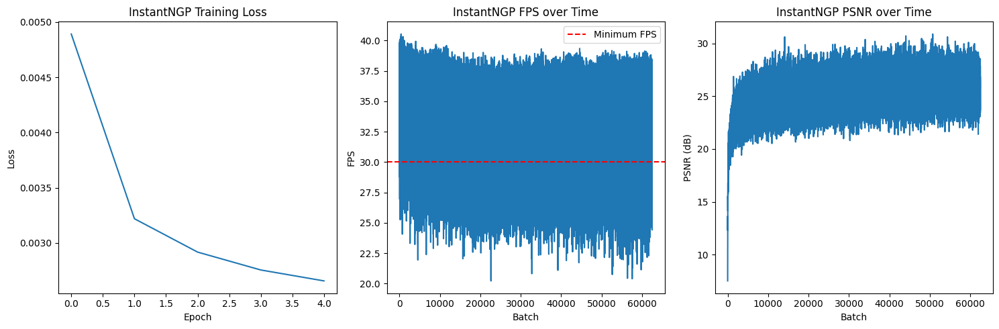






InstantNGP Training Progress:  50%|█████     | 62501/125000 [36:48<3:27:37,  5.02it/s]




InstantNGP Training Progress:  50%|█████     | 62504/125000 [36:48<2:37:36,  6.61it/s]


InstantNGP Epoch 6/10, Batch 0:
FPS: 34.19, Latency: 29.25ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  50%|█████     | 62507/125000 [36:48<2:03:30,  8.43it/s]




InstantNGP Training Progress:  50%|█████     | 62510/125000 [36:48<1:37:52, 10.64it/s]




InstantNGP Training Progress:  50%|█████     | 62513/125000 [36:48<1:20:17, 12.97it/s]




InstantNGP Training Progress:  50%|█████     | 62516/125000 [36:48<1:07:13, 15.49it/s]


InstantNGP Epoch 6/10, Batch 10:
FPS: 34.98, Latency: 28.59ms
PSNR: 27.42dB, Loss: 0.0018







InstantNGP Training Progress:  50%|█████     | 62519/125000 [36:48<57:30, 18.11it/s]  




InstantNGP Training Progress:  50%|█████     | 62523/125000 [36:49<49:05, 21.21it/s]




InstantNGP Training Progress:  50%|█████     | 62526/125000 [36:49<45:24, 22.93it/s]


InstantNGP Epoch 6/10, Batch 20:
FPS: 37.11, Latency: 26.95ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  50%|█████     | 62529/125000 [36:49<42:25, 24.54it/s]




InstantNGP Training Progress:  50%|█████     | 62532/125000 [36:49<41:30, 25.08it/s]




InstantNGP Training Progress:  50%|█████     | 62535/125000 [36:49<39:41, 26.23it/s]


InstantNGP Epoch 6/10, Batch 30:
FPS: 29.57, Latency: 33.81ms
PSNR: 26.56dB, Loss: 0.0022







InstantNGP Training Progress:  50%|█████     | 62538/125000 [36:49<39:27, 26.38it/s]




InstantNGP Training Progress:  50%|█████     | 62542/125000 [36:49<37:26, 27.80it/s]




InstantNGP Training Progress:  50%|█████     | 62546/125000 [36:49<36:10, 28.78it/s]


InstantNGP Epoch 6/10, Batch 40:
FPS: 38.70, Latency: 25.84ms
PSNR: 27.62dB, Loss: 0.0017







InstantNGP Training Progress:  50%|█████     | 62549/125000 [36:50<37:09, 28.01it/s]




InstantNGP Training Progress:  50%|█████     | 62552/125000 [36:50<36:54, 28.19it/s]




InstantNGP Training Progress:  50%|█████     | 62556/125000 [36:50<35:49, 29.05it/s]


InstantNGP Epoch 6/10, Batch 50:
FPS: 36.01, Latency: 27.77ms
PSNR: 26.93dB, Loss: 0.0020







InstantNGP Training Progress:  50%|█████     | 62559/125000 [36:50<36:07, 28.81it/s]




InstantNGP Training Progress:  50%|█████     | 62562/125000 [36:50<35:50, 29.04it/s]




InstantNGP Training Progress:  50%|█████     | 62566/125000 [36:50<35:02, 29.70it/s]


InstantNGP Epoch 6/10, Batch 60:
FPS: 37.91, Latency: 26.38ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  50%|█████     | 62569/125000 [36:50<36:33, 28.47it/s]




InstantNGP Training Progress:  50%|█████     | 62573/125000 [36:50<35:29, 29.32it/s]




InstantNGP Training Progress:  50%|█████     | 62576/125000 [36:50<35:32, 29.27it/s]


InstantNGP Epoch 6/10, Batch 70:
FPS: 36.77, Latency: 27.19ms
PSNR: 26.28dB, Loss: 0.0024







InstantNGP Training Progress:  50%|█████     | 62580/125000 [36:51<34:47, 29.90it/s]




InstantNGP Training Progress:  50%|█████     | 62584/125000 [36:51<34:15, 30.36it/s]


InstantNGP Epoch 6/10, Batch 80:
FPS: 35.52, Latency: 28.15ms
PSNR: 24.89dB, Loss: 0.0032







InstantNGP Training Progress:  50%|█████     | 62588/125000 [36:51<33:56, 30.65it/s]




InstantNGP Training Progress:  50%|█████     | 62592/125000 [36:51<34:59, 29.72it/s]




InstantNGP Training Progress:  50%|█████     | 62595/125000 [36:51<34:55, 29.78it/s]


InstantNGP Epoch 6/10, Batch 90:
FPS: 36.74, Latency: 27.22ms
PSNR: 28.22dB, Loss: 0.0015







InstantNGP Training Progress:  50%|█████     | 62599/125000 [36:51<34:06, 30.49it/s]




InstantNGP Training Progress:  50%|█████     | 62603/125000 [36:51<34:39, 30.00it/s]




InstantNGP Training Progress:  50%|█████     | 62607/125000 [36:51<34:22, 30.25it/s]


InstantNGP Epoch 6/10, Batch 100:
FPS: 36.28, Latency: 27.57ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  50%|█████     | 62611/125000 [36:52<34:43, 29.94it/s]




InstantNGP Training Progress:  50%|█████     | 62614/125000 [36:52<35:45, 29.07it/s]


InstantNGP Epoch 6/10, Batch 110:
FPS: 32.13, Latency: 31.13ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  50%|█████     | 62617/125000 [36:52<35:33, 29.24it/s]




InstantNGP Training Progress:  50%|█████     | 62620/125000 [36:52<35:23, 29.37it/s]




InstantNGP Training Progress:  50%|█████     | 62623/125000 [36:52<35:51, 28.99it/s]


InstantNGP Epoch 6/10, Batch 120:
FPS: 36.78, Latency: 27.19ms
PSNR: 27.99dB, Loss: 0.0016







InstantNGP Training Progress:  50%|█████     | 62627/125000 [36:52<35:00, 29.69it/s]




InstantNGP Training Progress:  50%|█████     | 62630/125000 [36:52<35:00, 29.70it/s]




InstantNGP Training Progress:  50%|█████     | 62633/125000 [36:52<34:58, 29.72it/s]




InstantNGP Training Progress:  50%|█████     | 62636/125000 [36:52<35:00, 29.68it/s]


InstantNGP Epoch 6/10, Batch 130:
FPS: 31.61, Latency: 31.64ms
PSNR: 25.02dB, Loss: 0.0031







InstantNGP Training Progress:  50%|█████     | 62640/125000 [36:53<34:23, 30.22it/s]




InstantNGP Training Progress:  50%|█████     | 62644/125000 [36:53<34:35, 30.04it/s]


InstantNGP Epoch 6/10, Batch 140:
FPS: 36.68, Latency: 27.27ms
PSNR: 28.49dB, Loss: 0.0014







InstantNGP Training Progress:  50%|█████     | 62648/125000 [36:53<35:02, 29.66it/s]




InstantNGP Training Progress:  50%|█████     | 62651/125000 [36:53<35:24, 29.35it/s]




InstantNGP Training Progress:  50%|█████     | 62654/125000 [36:53<35:31, 29.26it/s]


InstantNGP Epoch 6/10, Batch 150:
FPS: 31.44, Latency: 31.81ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  50%|█████     | 62658/125000 [36:53<34:40, 29.96it/s]




InstantNGP Training Progress:  50%|█████     | 62662/125000 [36:53<34:10, 30.40it/s]




InstantNGP Training Progress:  50%|█████     | 62666/125000 [36:53<34:03, 30.50it/s]


InstantNGP Epoch 6/10, Batch 160:
FPS: 32.04, Latency: 31.21ms
PSNR: 28.25dB, Loss: 0.0015







InstantNGP Training Progress:  50%|█████     | 62670/125000 [36:54<33:43, 30.80it/s]




InstantNGP Training Progress:  50%|█████     | 62674/125000 [36:54<35:16, 29.44it/s]


InstantNGP Epoch 6/10, Batch 170:
FPS: 28.08, Latency: 35.61ms
PSNR: 25.78dB, Loss: 0.0026







InstantNGP Training Progress:  50%|█████     | 62677/125000 [36:54<35:37, 29.15it/s]




InstantNGP Training Progress:  50%|█████     | 62680/125000 [36:54<35:22, 29.36it/s]




InstantNGP Training Progress:  50%|█████     | 62683/125000 [36:54<35:55, 28.91it/s]




InstantNGP Training Progress:  50%|█████     | 62686/125000 [36:54<36:13, 28.67it/s]


InstantNGP Epoch 6/10, Batch 180:
FPS: 29.22, Latency: 34.23ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  50%|█████     | 62689/125000 [36:54<36:17, 28.61it/s]




InstantNGP Training Progress:  50%|█████     | 62692/125000 [36:54<36:58, 28.09it/s]




InstantNGP Training Progress:  50%|█████     | 62695/125000 [36:54<37:12, 27.91it/s]


InstantNGP Epoch 6/10, Batch 190:
FPS: 33.23, Latency: 30.09ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  50%|█████     | 62698/125000 [36:55<38:30, 26.97it/s]




InstantNGP Training Progress:  50%|█████     | 62701/125000 [36:55<38:54, 26.69it/s]




InstantNGP Training Progress:  50%|█████     | 62704/125000 [36:55<37:59, 27.33it/s]


InstantNGP Epoch 6/10, Batch 200:
FPS: 28.63, Latency: 34.93ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  50%|█████     | 62707/125000 [36:55<38:04, 27.27it/s]




InstantNGP Training Progress:  50%|█████     | 62710/125000 [36:55<38:24, 27.03it/s]




InstantNGP Training Progress:  50%|█████     | 62713/125000 [36:55<38:10, 27.19it/s]




InstantNGP Training Progress:  50%|█████     | 62716/125000 [36:55<39:24, 26.35it/s]


InstantNGP Epoch 6/10, Batch 210:
FPS: 28.59, Latency: 34.98ms
PSNR: 24.10dB, Loss: 0.0039







InstantNGP Training Progress:  50%|█████     | 62719/125000 [36:55<39:30, 26.27it/s]




InstantNGP Training Progress:  50%|█████     | 62722/125000 [36:55<38:56, 26.65it/s]




InstantNGP Training Progress:  50%|█████     | 62726/125000 [36:56<36:47, 28.21it/s]


InstantNGP Epoch 6/10, Batch 220:
FPS: 31.33, Latency: 31.92ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  50%|█████     | 62729/125000 [36:56<37:23, 27.75it/s]




InstantNGP Training Progress:  50%|█████     | 62732/125000 [36:56<38:10, 27.19it/s]




InstantNGP Training Progress:  50%|█████     | 62735/125000 [36:56<37:17, 27.83it/s]


InstantNGP Epoch 6/10, Batch 230:
FPS: 26.83, Latency: 37.27ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  50%|█████     | 62738/125000 [36:56<36:35, 28.36it/s]




InstantNGP Training Progress:  50%|█████     | 62741/125000 [36:56<36:29, 28.44it/s]




InstantNGP Training Progress:  50%|█████     | 62744/125000 [36:56<36:49, 28.17it/s]


InstantNGP Epoch 6/10, Batch 240:
FPS: 35.53, Latency: 28.14ms
PSNR: 24.51dB, Loss: 0.0035







InstantNGP Training Progress:  50%|█████     | 62747/125000 [36:56<37:06, 27.96it/s]




InstantNGP Training Progress:  50%|█████     | 62750/125000 [36:56<37:28, 27.69it/s]




InstantNGP Training Progress:  50%|█████     | 62753/125000 [36:57<37:58, 27.32it/s]




InstantNGP Training Progress:  50%|█████     | 62756/125000 [36:57<37:13, 27.86it/s]


InstantNGP Epoch 6/10, Batch 250:
FPS: 27.48, Latency: 36.39ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  50%|█████     | 62759/125000 [36:57<36:57, 28.07it/s]




InstantNGP Training Progress:  50%|█████     | 62762/125000 [36:57<36:14, 28.62it/s]




InstantNGP Training Progress:  50%|█████     | 62765/125000 [36:57<35:55, 28.87it/s]


InstantNGP Epoch 6/10, Batch 260:
FPS: 36.07, Latency: 27.73ms
PSNR: 26.64dB, Loss: 0.0022







InstantNGP Training Progress:  50%|█████     | 62769/125000 [36:57<34:58, 29.66it/s]




InstantNGP Training Progress:  50%|█████     | 62772/125000 [36:57<36:20, 28.53it/s]




InstantNGP Training Progress:  50%|█████     | 62775/125000 [36:57<35:50, 28.93it/s]


InstantNGP Epoch 6/10, Batch 270:
FPS: 28.71, Latency: 34.83ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  50%|█████     | 62779/125000 [36:57<34:46, 29.83it/s]




InstantNGP Training Progress:  50%|█████     | 62782/125000 [36:58<36:19, 28.55it/s]




InstantNGP Training Progress:  50%|█████     | 62785/125000 [36:58<35:49, 28.94it/s]


InstantNGP Epoch 6/10, Batch 280:
FPS: 28.56, Latency: 35.01ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  50%|█████     | 62789/125000 [36:58<35:04, 29.56it/s]




InstantNGP Training Progress:  50%|█████     | 62792/125000 [36:58<36:36, 28.33it/s]




InstantNGP Training Progress:  50%|█████     | 62795/125000 [36:58<36:37, 28.31it/s]


InstantNGP Epoch 6/10, Batch 290:
FPS: 24.75, Latency: 40.41ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  50%|█████     | 62798/125000 [36:58<36:18, 28.55it/s]




InstantNGP Training Progress:  50%|█████     | 62801/125000 [36:58<36:43, 28.22it/s]




InstantNGP Training Progress:  50%|█████     | 62805/125000 [36:58<34:55, 29.68it/s]


InstantNGP Epoch 6/10, Batch 300:
FPS: 25.99, Latency: 38.47ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  50%|█████     | 62808/125000 [36:58<34:56, 29.66it/s]




InstantNGP Training Progress:  50%|█████     | 62811/125000 [36:59<35:34, 29.14it/s]




InstantNGP Training Progress:  50%|█████     | 62814/125000 [36:59<35:55, 28.84it/s]


InstantNGP Epoch 6/10, Batch 310:
FPS: 32.71, Latency: 30.57ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  50%|█████     | 62817/125000 [36:59<35:51, 28.90it/s]




InstantNGP Training Progress:  50%|█████     | 62820/125000 [36:59<35:51, 28.90it/s]




InstantNGP Training Progress:  50%|█████     | 62823/125000 [36:59<35:58, 28.80it/s]




InstantNGP Training Progress:  50%|█████     | 62826/125000 [36:59<36:48, 28.16it/s]


InstantNGP Epoch 6/10, Batch 320:
FPS: 34.93, Latency: 28.63ms
PSNR: 27.30dB, Loss: 0.0019







InstantNGP Training Progress:  50%|█████     | 62830/125000 [36:59<35:18, 29.35it/s]




InstantNGP Training Progress:  50%|█████     | 62833/125000 [36:59<36:21, 28.49it/s]


InstantNGP Epoch 6/10, Batch 330:
FPS: 37.46, Latency: 26.70ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  50%|█████     | 62837/125000 [36:59<35:24, 29.25it/s]




InstantNGP Training Progress:  50%|█████     | 62841/125000 [37:00<34:33, 29.98it/s]




InstantNGP Training Progress:  50%|█████     | 62845/125000 [37:00<34:40, 29.88it/s]


InstantNGP Epoch 6/10, Batch 340:
FPS: 38.24, Latency: 26.15ms
PSNR: 27.11dB, Loss: 0.0019







InstantNGP Training Progress:  50%|█████     | 62848/125000 [37:00<36:14, 28.58it/s]




InstantNGP Training Progress:  50%|█████     | 62851/125000 [37:00<36:38, 28.27it/s]




InstantNGP Training Progress:  50%|█████     | 62854/125000 [37:00<36:24, 28.45it/s]


InstantNGP Epoch 6/10, Batch 350:
FPS: 33.35, Latency: 29.98ms
PSNR: 27.16dB, Loss: 0.0019







InstantNGP Training Progress:  50%|█████     | 62858/125000 [37:00<35:17, 29.35it/s]




InstantNGP Training Progress:  50%|█████     | 62862/125000 [37:00<34:37, 29.90it/s]




InstantNGP Training Progress:  50%|█████     | 62865/125000 [37:00<35:16, 29.36it/s]


InstantNGP Epoch 6/10, Batch 360:
FPS: 36.65, Latency: 27.28ms
PSNR: 27.63dB, Loss: 0.0017







InstantNGP Training Progress:  50%|█████     | 62868/125000 [37:01<35:59, 28.77it/s]




InstantNGP Training Progress:  50%|█████     | 62871/125000 [37:01<35:52, 28.87it/s]




InstantNGP Training Progress:  50%|█████     | 62874/125000 [37:01<35:49, 28.90it/s]


InstantNGP Epoch 6/10, Batch 370:
FPS: 33.04, Latency: 30.27ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  50%|█████     | 62877/125000 [37:01<36:42, 28.20it/s]




InstantNGP Training Progress:  50%|█████     | 62880/125000 [37:01<36:44, 28.17it/s]




InstantNGP Training Progress:  50%|█████     | 62884/125000 [37:01<35:26, 29.21it/s]


InstantNGP Epoch 6/10, Batch 380:
FPS: 36.93, Latency: 27.08ms
PSNR: 25.76dB, Loss: 0.0027







InstantNGP Training Progress:  50%|█████     | 62887/125000 [37:01<36:05, 28.68it/s]




InstantNGP Training Progress:  50%|█████     | 62890/125000 [37:01<35:48, 28.90it/s]




InstantNGP Training Progress:  50%|█████     | 62893/125000 [37:01<35:42, 28.99it/s]




InstantNGP Training Progress:  50%|█████     | 62896/125000 [37:02<35:31, 29.14it/s]


InstantNGP Epoch 6/10, Batch 390:
FPS: 31.47, Latency: 31.78ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  50%|█████     | 62899/125000 [37:02<36:16, 28.54it/s]




InstantNGP Training Progress:  50%|█████     | 62903/125000 [37:02<35:30, 29.14it/s]




InstantNGP Training Progress:  50%|█████     | 62907/125000 [37:02<34:47, 29.74it/s]


InstantNGP Epoch 6/10, Batch 400:
FPS: 37.96, Latency: 26.34ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  50%|█████     | 62910/125000 [37:02<34:44, 29.79it/s]




InstantNGP Training Progress:  50%|█████     | 62913/125000 [37:02<34:45, 29.77it/s]







InstantNGP Epoch 6/10, Batch 410:
FPS: 31.40, Latency: 31.85ms
PSNR: 25.02dB, Loss: 0.0031


InstantNGP Training Progress:  50%|█████     | 62917/125000 [37:02<34:29, 30.00it/s]




InstantNGP Training Progress:  50%|█████     | 62920/125000 [37:02<35:01, 29.54it/s]




InstantNGP Training Progress:  50%|█████     | 62924/125000 [37:02<34:18, 30.16it/s]


InstantNGP Epoch 6/10, Batch 420:
FPS: 32.98, Latency: 30.32ms
PSNR: 26.78dB, Loss: 0.0021







InstantNGP Training Progress:  50%|█████     | 62928/125000 [37:03<35:26, 29.19it/s]




InstantNGP Training Progress:  50%|█████     | 62932/125000 [37:03<34:49, 29.71it/s]




InstantNGP Training Progress:  50%|█████     | 62936/125000 [37:03<34:22, 30.09it/s]


InstantNGP Epoch 6/10, Batch 430:
FPS: 32.05, Latency: 31.20ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  50%|█████     | 62940/125000 [37:03<34:46, 29.74it/s]




InstantNGP Training Progress:  50%|█████     | 62943/125000 [37:03<34:42, 29.80it/s]




InstantNGP Training Progress:  50%|█████     | 62947/125000 [37:03<34:20, 30.11it/s]


InstantNGP Epoch 6/10, Batch 440:
FPS: 36.68, Latency: 27.27ms
PSNR: 24.36dB, Loss: 0.0037







InstantNGP Training Progress:  50%|█████     | 62951/125000 [37:03<35:46, 28.91it/s]




InstantNGP Training Progress:  50%|█████     | 62955/125000 [37:04<34:16, 30.17it/s]


InstantNGP Epoch 6/10, Batch 450:
FPS: 27.27, Latency: 36.67ms
PSNR: 24.39dB, Loss: 0.0036







InstantNGP Training Progress:  50%|█████     | 62959/125000 [37:04<33:52, 30.52it/s]




InstantNGP Training Progress:  50%|█████     | 62963/125000 [37:04<34:47, 29.72it/s]




InstantNGP Training Progress:  50%|█████     | 62966/125000 [37:04<35:00, 29.53it/s]


InstantNGP Epoch 6/10, Batch 460:
FPS: 37.15, Latency: 26.92ms
PSNR: 23.86dB, Loss: 0.0041







InstantNGP Training Progress:  50%|█████     | 62969/125000 [37:04<37:11, 27.79it/s]




InstantNGP Training Progress:  50%|█████     | 62972/125000 [37:04<37:53, 27.28it/s]




InstantNGP Training Progress:  50%|█████     | 62975/125000 [37:04<38:42, 26.71it/s]


InstantNGP Epoch 6/10, Batch 470:
FPS: 31.62, Latency: 31.63ms
PSNR: 27.20dB, Loss: 0.0019







InstantNGP Training Progress:  50%|█████     | 62978/125000 [37:04<37:32, 27.54it/s]




InstantNGP Training Progress:  50%|█████     | 62982/125000 [37:04<36:29, 28.32it/s]




InstantNGP Training Progress:  50%|█████     | 62985/125000 [37:05<36:20, 28.44it/s]


InstantNGP Epoch 6/10, Batch 480:
FPS: 31.83, Latency: 31.42ms
PSNR: 27.73dB, Loss: 0.0017







InstantNGP Training Progress:  50%|█████     | 62988/125000 [37:05<36:26, 28.36it/s]




InstantNGP Training Progress:  50%|█████     | 62991/125000 [37:05<36:09, 28.58it/s]




InstantNGP Training Progress:  50%|█████     | 62994/125000 [37:05<36:54, 27.99it/s]


InstantNGP Epoch 6/10, Batch 490:
FPS: 35.17, Latency: 28.43ms
PSNR: 27.61dB, Loss: 0.0017







InstantNGP Training Progress:  50%|█████     | 62998/125000 [37:05<36:02, 28.67it/s]




InstantNGP Training Progress:  50%|█████     | 63001/125000 [37:05<36:27, 28.35it/s]




InstantNGP Training Progress:  50%|█████     | 63005/125000 [37:05<35:38, 28.99it/s]


InstantNGP Epoch 6/10, Batch 500:
FPS: 29.96, Latency: 33.38ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  50%|█████     | 63009/125000 [37:05<34:44, 29.73it/s]




InstantNGP Training Progress:  50%|█████     | 63012/125000 [37:06<34:52, 29.63it/s]




InstantNGP Training Progress:  50%|█████     | 63015/125000 [37:06<35:58, 28.72it/s]


InstantNGP Epoch 6/10, Batch 510:
FPS: 35.26, Latency: 28.36ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  50%|█████     | 63018/125000 [37:06<36:03, 28.65it/s]




InstantNGP Training Progress:  50%|█████     | 63021/125000 [37:06<35:42, 28.93it/s]




InstantNGP Training Progress:  50%|█████     | 63024/125000 [37:06<36:35, 28.23it/s]


InstantNGP Epoch 6/10, Batch 520:
FPS: 30.68, Latency: 32.60ms
PSNR: 24.53dB, Loss: 0.0035







InstantNGP Training Progress:  50%|█████     | 63028/125000 [37:06<34:53, 29.60it/s]




InstantNGP Training Progress:  50%|█████     | 63031/125000 [37:06<35:15, 29.29it/s]




InstantNGP Training Progress:  50%|█████     | 63035/125000 [37:06<35:02, 29.48it/s]


InstantNGP Epoch 6/10, Batch 530:
FPS: 33.07, Latency: 30.24ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  50%|█████     | 63038/125000 [37:06<34:59, 29.51it/s]




InstantNGP Training Progress:  50%|█████     | 63041/125000 [37:07<35:02, 29.47it/s]




InstantNGP Training Progress:  50%|█████     | 63044/125000 [37:07<35:06, 29.41it/s]


InstantNGP Epoch 6/10, Batch 540:
FPS: 33.07, Latency: 30.24ms
PSNR: 26.33dB, Loss: 0.0023







InstantNGP Training Progress:  50%|█████     | 63047/125000 [37:07<35:42, 28.92it/s]




InstantNGP Training Progress:  50%|█████     | 63050/125000 [37:07<36:12, 28.51it/s]




InstantNGP Training Progress:  50%|█████     | 63053/125000 [37:07<36:11, 28.52it/s]




InstantNGP Training Progress:  50%|█████     | 63056/125000 [37:07<37:42, 27.38it/s]


InstantNGP Epoch 6/10, Batch 550:
FPS: 30.61, Latency: 32.67ms
PSNR: 25.41dB, Loss: 0.0029







InstantNGP Training Progress:  50%|█████     | 63059/125000 [37:07<36:58, 27.92it/s]




InstantNGP Training Progress:  50%|█████     | 63062/125000 [37:07<36:17, 28.44it/s]




InstantNGP Training Progress:  50%|█████     | 63065/125000 [37:07<35:51, 28.78it/s]


InstantNGP Epoch 6/10, Batch 560:
FPS: 34.87, Latency: 28.68ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  50%|█████     | 63068/125000 [37:07<36:26, 28.33it/s]




InstantNGP Training Progress:  50%|█████     | 63071/125000 [37:08<36:25, 28.33it/s]




InstantNGP Training Progress:  50%|█████     | 63075/125000 [37:08<35:17, 29.25it/s]


InstantNGP Epoch 6/10, Batch 570:
FPS: 34.75, Latency: 28.78ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  50%|█████     | 63078/125000 [37:08<36:30, 28.27it/s]




InstantNGP Training Progress:  50%|█████     | 63081/125000 [37:08<37:15, 27.70it/s]




InstantNGP Training Progress:  50%|█████     | 63084/125000 [37:08<36:51, 27.99it/s]


InstantNGP Epoch 6/10, Batch 580:
FPS: 31.97, Latency: 31.28ms
PSNR: 24.00dB, Loss: 0.0040







InstantNGP Training Progress:  50%|█████     | 63087/125000 [37:08<37:31, 27.49it/s]




InstantNGP Training Progress:  50%|█████     | 63090/125000 [37:08<37:12, 27.73it/s]




InstantNGP Training Progress:  50%|█████     | 63093/125000 [37:08<37:30, 27.51it/s]




InstantNGP Training Progress:  50%|█████     | 63096/125000 [37:08<37:30, 27.51it/s]


InstantNGP Epoch 6/10, Batch 590:
FPS: 35.20, Latency: 28.41ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  50%|█████     | 63099/125000 [37:09<38:54, 26.52it/s]




InstantNGP Training Progress:  50%|█████     | 63102/125000 [37:09<37:47, 27.30it/s]




InstantNGP Training Progress:  50%|█████     | 63105/125000 [37:09<37:32, 27.48it/s]


InstantNGP Epoch 6/10, Batch 600:
FPS: 35.22, Latency: 28.40ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  50%|█████     | 63108/125000 [37:09<37:33, 27.47it/s]




InstantNGP Training Progress:  50%|█████     | 63111/125000 [37:09<38:00, 27.13it/s]




InstantNGP Training Progress:  50%|█████     | 63114/125000 [37:09<37:40, 27.37it/s]


InstantNGP Epoch 6/10, Batch 610:
FPS: 35.40, Latency: 28.25ms
PSNR: 25.95dB, Loss: 0.0025







InstantNGP Training Progress:  50%|█████     | 63117/125000 [37:09<38:40, 26.67it/s]




InstantNGP Training Progress:  50%|█████     | 63120/125000 [37:09<37:33, 27.46it/s]




InstantNGP Training Progress:  50%|█████     | 63123/125000 [37:09<36:45, 28.06it/s]




InstantNGP Training Progress:  51%|█████     | 63126/125000 [37:10<37:17, 27.65it/s]


InstantNGP Epoch 6/10, Batch 620:
FPS: 31.36, Latency: 31.89ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63129/125000 [37:10<36:34, 28.19it/s]




InstantNGP Training Progress:  51%|█████     | 63133/125000 [37:10<35:22, 29.15it/s]




InstantNGP Training Progress:  51%|█████     | 63136/125000 [37:10<36:17, 28.41it/s]


InstantNGP Epoch 6/10, Batch 630:
FPS: 33.73, Latency: 29.65ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:  51%|█████     | 63139/125000 [37:10<37:38, 27.39it/s]




InstantNGP Training Progress:  51%|█████     | 63143/125000 [37:10<35:46, 28.81it/s]




InstantNGP Training Progress:  51%|█████     | 63147/125000 [37:10<35:23, 29.12it/s]


InstantNGP Epoch 6/10, Batch 640:
FPS: 36.77, Latency: 27.20ms
PSNR: 27.50dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████     | 63150/125000 [37:10<36:00, 28.63it/s]




InstantNGP Training Progress:  51%|█████     | 63153/125000 [37:11<36:39, 28.12it/s]




InstantNGP Training Progress:  51%|█████     | 63156/125000 [37:11<36:41, 28.10it/s]


InstantNGP Epoch 6/10, Batch 650:
FPS: 26.69, Latency: 37.47ms
PSNR: 26.51dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████     | 63159/125000 [37:11<37:16, 27.65it/s]




InstantNGP Training Progress:  51%|█████     | 63162/125000 [37:11<36:35, 28.17it/s]




InstantNGP Training Progress:  51%|█████     | 63165/125000 [37:11<36:00, 28.63it/s]


InstantNGP Epoch 6/10, Batch 660:
FPS: 36.37, Latency: 27.49ms
PSNR: 26.77dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63168/125000 [37:11<36:10, 28.49it/s]




InstantNGP Training Progress:  51%|█████     | 63171/125000 [37:11<37:32, 27.45it/s]




InstantNGP Training Progress:  51%|█████     | 63174/125000 [37:11<36:42, 28.07it/s]


InstantNGP Epoch 6/10, Batch 670:
FPS: 32.58, Latency: 30.69ms
PSNR: 27.29dB, Loss: 0.0019







InstantNGP Training Progress:  51%|█████     | 63177/125000 [37:11<36:13, 28.45it/s]




InstantNGP Training Progress:  51%|█████     | 63180/125000 [37:11<36:35, 28.15it/s]




InstantNGP Training Progress:  51%|█████     | 63183/125000 [37:12<36:22, 28.33it/s]




InstantNGP Training Progress:  51%|█████     | 63187/125000 [37:12<34:36, 29.76it/s]


InstantNGP Epoch 6/10, Batch 680:
FPS: 32.86, Latency: 30.43ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  51%|█████     | 63190/125000 [37:12<35:04, 29.37it/s]




InstantNGP Training Progress:  51%|█████     | 63193/125000 [37:12<36:14, 28.42it/s]


InstantNGP Epoch 6/10, Batch 690:
FPS: 31.82, Latency: 31.42ms
PSNR: 27.33dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████     | 63197/125000 [37:12<35:37, 28.92it/s]




InstantNGP Training Progress:  51%|█████     | 63201/125000 [37:12<34:42, 29.68it/s]




InstantNGP Training Progress:  51%|█████     | 63204/125000 [37:12<35:36, 28.92it/s]


InstantNGP Epoch 6/10, Batch 700:
FPS: 33.08, Latency: 30.23ms
PSNR: 26.14dB, Loss: 0.0024







InstantNGP Training Progress:  51%|█████     | 63207/125000 [37:12<36:06, 28.52it/s]




InstantNGP Training Progress:  51%|█████     | 63210/125000 [37:13<36:05, 28.53it/s]




InstantNGP Training Progress:  51%|█████     | 63214/125000 [37:13<35:03, 29.37it/s]


InstantNGP Epoch 6/10, Batch 710:
FPS: 33.51, Latency: 29.84ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 63217/125000 [37:13<35:52, 28.70it/s]




InstantNGP Training Progress:  51%|█████     | 63221/125000 [37:13<35:14, 29.22it/s]




InstantNGP Training Progress:  51%|█████     | 63224/125000 [37:13<35:12, 29.25it/s]


InstantNGP Epoch 6/10, Batch 720:
FPS: 35.38, Latency: 28.26ms
PSNR: 27.79dB, Loss: 0.0017







InstantNGP Training Progress:  51%|█████     | 63227/125000 [37:13<35:02, 29.38it/s]




InstantNGP Training Progress:  51%|█████     | 63231/125000 [37:13<33:47, 30.46it/s]




InstantNGP Training Progress:  51%|█████     | 63235/125000 [37:13<33:48, 30.44it/s]


InstantNGP Epoch 6/10, Batch 730:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.59dB, Loss: 0.0028







InstantNGP Training Progress:  51%|█████     | 63239/125000 [37:13<34:08, 30.15it/s]




InstantNGP Training Progress:  51%|█████     | 63243/125000 [37:14<33:44, 30.50it/s]




InstantNGP Training Progress:  51%|█████     | 63247/125000 [37:14<33:53, 30.37it/s]


InstantNGP Epoch 6/10, Batch 740:
FPS: 35.68, Latency: 28.02ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████     | 63251/125000 [37:14<36:32, 28.17it/s]




InstantNGP Training Progress:  51%|█████     | 63255/125000 [37:14<35:23, 29.07it/s]


InstantNGP Epoch 6/10, Batch 750:
FPS: 26.84, Latency: 37.25ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63258/125000 [37:14<37:11, 27.67it/s]




InstantNGP Training Progress:  51%|█████     | 63261/125000 [37:14<37:14, 27.62it/s]




InstantNGP Training Progress:  51%|█████     | 63264/125000 [37:14<36:28, 28.21it/s]


InstantNGP Epoch 6/10, Batch 760:
FPS: 29.57, Latency: 33.82ms
PSNR: 25.45dB, Loss: 0.0028







InstantNGP Training Progress:  51%|█████     | 63268/125000 [37:14<35:44, 28.79it/s]




InstantNGP Training Progress:  51%|█████     | 63271/125000 [37:15<35:44, 28.79it/s]




InstantNGP Training Progress:  51%|█████     | 63275/125000 [37:15<34:51, 29.51it/s]


InstantNGP Epoch 6/10, Batch 770:
FPS: 30.90, Latency: 32.36ms
PSNR: 24.81dB, Loss: 0.0033







InstantNGP Training Progress:  51%|█████     | 63278/125000 [37:15<34:56, 29.44it/s]




InstantNGP Training Progress:  51%|█████     | 63282/125000 [37:15<34:26, 29.86it/s]




InstantNGP Training Progress:  51%|█████     | 63285/125000 [37:15<34:51, 29.51it/s]


InstantNGP Epoch 6/10, Batch 780:
FPS: 36.94, Latency: 27.07ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  51%|█████     | 63288/125000 [37:15<35:27, 29.00it/s]




InstantNGP Training Progress:  51%|█████     | 63291/125000 [37:15<35:33, 28.92it/s]




InstantNGP Training Progress:  51%|█████     | 63294/125000 [37:15<35:29, 28.98it/s]


InstantNGP Epoch 6/10, Batch 790:
FPS: 29.15, Latency: 34.30ms
PSNR: 25.00dB, Loss: 0.0032







InstantNGP Training Progress:  51%|█████     | 63297/125000 [37:15<35:22, 29.07it/s]




InstantNGP Training Progress:  51%|█████     | 63301/125000 [37:16<35:09, 29.25it/s]




InstantNGP Training Progress:  51%|█████     | 63304/125000 [37:16<35:39, 28.83it/s]


InstantNGP Epoch 6/10, Batch 800:
FPS: 30.73, Latency: 32.54ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████     | 63308/125000 [37:16<34:45, 29.58it/s]




InstantNGP Training Progress:  51%|█████     | 63311/125000 [37:16<34:55, 29.44it/s]




InstantNGP Training Progress:  51%|█████     | 63314/125000 [37:16<35:35, 28.89it/s]


InstantNGP Epoch 6/10, Batch 810:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.64dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 63317/125000 [37:16<35:28, 28.98it/s]




InstantNGP Training Progress:  51%|█████     | 63321/125000 [37:16<35:18, 29.11it/s]




InstantNGP Training Progress:  51%|█████     | 63324/125000 [37:16<35:19, 29.09it/s]


InstantNGP Epoch 6/10, Batch 820:
FPS: 30.92, Latency: 32.34ms
PSNR: 24.49dB, Loss: 0.0036







InstantNGP Training Progress:  51%|█████     | 63327/125000 [37:17<35:39, 28.83it/s]




InstantNGP Training Progress:  51%|█████     | 63330/125000 [37:17<35:36, 28.87it/s]




InstantNGP Training Progress:  51%|█████     | 63333/125000 [37:17<36:54, 27.84it/s]




InstantNGP Training Progress:  51%|█████     | 63337/125000 [37:17<35:04, 29.30it/s]


InstantNGP Epoch 6/10, Batch 830:
FPS: 27.81, Latency: 35.95ms
PSNR: 25.81dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63340/125000 [37:17<34:55, 29.43it/s]




InstantNGP Training Progress:  51%|█████     | 63344/125000 [37:17<34:21, 29.90it/s]


InstantNGP Epoch 6/10, Batch 840:
FPS: 37.66, Latency: 26.55ms
PSNR: 27.16dB, Loss: 0.0019







InstantNGP Training Progress:  51%|█████     | 63347/125000 [37:17<35:07, 29.25it/s]




InstantNGP Training Progress:  51%|█████     | 63351/125000 [37:17<34:48, 29.52it/s]




InstantNGP Training Progress:  51%|█████     | 63354/125000 [37:17<35:12, 29.18it/s]


InstantNGP Epoch 6/10, Batch 850:
FPS: 32.67, Latency: 30.61ms
PSNR: 24.48dB, Loss: 0.0036







InstantNGP Training Progress:  51%|█████     | 63358/125000 [37:18<34:38, 29.65it/s]




InstantNGP Training Progress:  51%|█████     | 63361/125000 [37:18<34:37, 29.66it/s]




InstantNGP Training Progress:  51%|█████     | 63364/125000 [37:18<34:32, 29.73it/s]


InstantNGP Epoch 6/10, Batch 860:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.42dB, Loss: 0.0029







InstantNGP Training Progress:  51%|█████     | 63367/125000 [37:18<36:17, 28.31it/s]




InstantNGP Training Progress:  51%|█████     | 63371/125000 [37:18<34:55, 29.40it/s]




InstantNGP Training Progress:  51%|█████     | 63375/125000 [37:18<34:31, 29.74it/s]


InstantNGP Epoch 6/10, Batch 870:
FPS: 31.81, Latency: 31.43ms
PSNR: 26.52dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████     | 63379/125000 [37:18<34:00, 30.19it/s]




InstantNGP Training Progress:  51%|█████     | 63383/125000 [37:18<33:03, 31.07it/s]




InstantNGP Training Progress:  51%|█████     | 63387/125000 [37:19<32:39, 31.45it/s]


InstantNGP Epoch 6/10, Batch 880:
FPS: 38.11, Latency: 26.24ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  51%|█████     | 63391/125000 [37:19<32:54, 31.20it/s]




InstantNGP Training Progress:  51%|█████     | 63395/125000 [37:19<32:43, 31.37it/s]


InstantNGP Epoch 6/10, Batch 890:
FPS: 35.38, Latency: 28.26ms
PSNR: 29.58dB, Loss: 0.0011







InstantNGP Training Progress:  51%|█████     | 63399/125000 [37:19<34:24, 29.83it/s]




InstantNGP Training Progress:  51%|█████     | 63403/125000 [37:19<34:23, 29.85it/s]




InstantNGP Training Progress:  51%|█████     | 63406/125000 [37:19<34:26, 29.80it/s]


InstantNGP Epoch 6/10, Batch 900:
FPS: 34.67, Latency: 28.84ms
PSNR: 25.87dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63409/125000 [37:19<35:06, 29.24it/s]




InstantNGP Training Progress:  51%|█████     | 63412/125000 [37:19<35:00, 29.32it/s]




InstantNGP Training Progress:  51%|█████     | 63415/125000 [37:19<35:03, 29.27it/s]


InstantNGP Epoch 6/10, Batch 910:
FPS: 36.11, Latency: 27.69ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  51%|█████     | 63418/125000 [37:20<37:04, 27.69it/s]




InstantNGP Training Progress:  51%|█████     | 63421/125000 [37:20<37:25, 27.42it/s]




InstantNGP Training Progress:  51%|█████     | 63425/125000 [37:20<36:07, 28.41it/s]


InstantNGP Epoch 6/10, Batch 920:
FPS: 30.23, Latency: 33.08ms
PSNR: 28.73dB, Loss: 0.0013







InstantNGP Training Progress:  51%|█████     | 63428/125000 [37:20<37:01, 27.71it/s]




InstantNGP Training Progress:  51%|█████     | 63431/125000 [37:20<37:12, 27.57it/s]




InstantNGP Training Progress:  51%|█████     | 63434/125000 [37:20<36:32, 28.08it/s]


InstantNGP Epoch 6/10, Batch 930:
FPS: 36.37, Latency: 27.50ms
PSNR: 27.89dB, Loss: 0.0016







InstantNGP Training Progress:  51%|█████     | 63437/125000 [37:20<36:23, 28.19it/s]




InstantNGP Training Progress:  51%|█████     | 63440/125000 [37:20<36:38, 28.00it/s]




InstantNGP Training Progress:  51%|█████     | 63443/125000 [37:20<37:21, 27.46it/s]




InstantNGP Training Progress:  51%|█████     | 63446/125000 [37:21<37:42, 27.20it/s]


InstantNGP Epoch 6/10, Batch 940:
FPS: 29.63, Latency: 33.75ms
PSNR: 25.68dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 63449/125000 [37:21<38:51, 26.40it/s]




InstantNGP Training Progress:  51%|█████     | 63452/125000 [37:21<39:37, 25.88it/s]




InstantNGP Training Progress:  51%|█████     | 63455/125000 [37:21<39:51, 25.73it/s]


InstantNGP Epoch 6/10, Batch 950:
FPS: 29.28, Latency: 34.16ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  51%|█████     | 63459/125000 [37:21<38:01, 26.97it/s]




InstantNGP Training Progress:  51%|█████     | 63462/125000 [37:21<38:13, 26.83it/s]




InstantNGP Training Progress:  51%|█████     | 63465/125000 [37:21<37:19, 27.48it/s]


InstantNGP Epoch 6/10, Batch 960:
FPS: 31.38, Latency: 31.87ms
PSNR: 27.31dB, Loss: 0.0019







InstantNGP Training Progress:  51%|█████     | 63469/125000 [37:21<36:11, 28.34it/s]




InstantNGP Training Progress:  51%|█████     | 63472/125000 [37:22<36:03, 28.44it/s]




InstantNGP Training Progress:  51%|█████     | 63475/125000 [37:22<35:50, 28.61it/s]


InstantNGP Epoch 6/10, Batch 970:
FPS: 32.89, Latency: 30.40ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63478/125000 [37:22<35:43, 28.71it/s]




InstantNGP Training Progress:  51%|█████     | 63481/125000 [37:22<35:34, 28.82it/s]




InstantNGP Training Progress:  51%|█████     | 63484/125000 [37:22<36:23, 28.18it/s]


InstantNGP Epoch 6/10, Batch 980:
FPS: 30.88, Latency: 32.38ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63487/125000 [37:22<35:53, 28.57it/s]




InstantNGP Training Progress:  51%|█████     | 63491/125000 [37:22<34:55, 29.36it/s]




InstantNGP Training Progress:  51%|█████     | 63494/125000 [37:22<35:21, 28.99it/s]


InstantNGP Epoch 6/10, Batch 990:
FPS: 37.17, Latency: 26.90ms
PSNR: 27.78dB, Loss: 0.0017







InstantNGP Training Progress:  51%|█████     | 63497/125000 [37:22<35:10, 29.14it/s]




InstantNGP Training Progress:  51%|█████     | 63500/125000 [37:23<36:12, 28.31it/s]




InstantNGP Training Progress:  51%|█████     | 63503/125000 [37:23<37:05, 27.63it/s]




InstantNGP Training Progress:  51%|█████     | 63506/125000 [37:23<37:15, 27.51it/s]


InstantNGP Epoch 6/10, Batch 1000:
FPS: 31.56, Latency: 31.69ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63509/125000 [37:23<37:15, 27.50it/s]




InstantNGP Training Progress:  51%|█████     | 63512/125000 [37:23<36:48, 27.84it/s]




InstantNGP Training Progress:  51%|█████     | 63515/125000 [37:23<37:19, 27.46it/s]


InstantNGP Epoch 6/10, Batch 1010:
FPS: 35.92, Latency: 27.84ms
PSNR: 26.69dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63518/125000 [37:23<36:58, 27.71it/s]




InstantNGP Training Progress:  51%|█████     | 63522/125000 [37:23<35:40, 28.72it/s]




InstantNGP Training Progress:  51%|█████     | 63525/125000 [37:23<35:32, 28.83it/s]


InstantNGP Epoch 6/10, Batch 1020:
FPS: 35.50, Latency: 28.17ms
PSNR: 24.18dB, Loss: 0.0038







InstantNGP Training Progress:  51%|█████     | 63529/125000 [37:24<34:46, 29.47it/s]




InstantNGP Training Progress:  51%|█████     | 63533/125000 [37:24<34:36, 29.59it/s]




InstantNGP Training Progress:  51%|█████     | 63536/125000 [37:24<35:10, 29.12it/s]


InstantNGP Epoch 6/10, Batch 1030:
FPS: 31.25, Latency: 32.00ms
PSNR: 27.68dB, Loss: 0.0017







InstantNGP Training Progress:  51%|█████     | 63539/125000 [37:24<36:07, 28.36it/s]




InstantNGP Training Progress:  51%|█████     | 63542/125000 [37:24<37:19, 27.44it/s]




InstantNGP Training Progress:  51%|█████     | 63545/125000 [37:24<36:54, 27.76it/s]


InstantNGP Epoch 6/10, Batch 1040:
FPS: 26.00, Latency: 38.46ms
PSNR: 23.22dB, Loss: 0.0048







InstantNGP Training Progress:  51%|█████     | 63548/125000 [37:24<37:02, 27.65it/s]




InstantNGP Training Progress:  51%|█████     | 63551/125000 [37:24<37:15, 27.49it/s]




InstantNGP Training Progress:  51%|█████     | 63555/125000 [37:24<35:24, 28.92it/s]


InstantNGP Epoch 6/10, Batch 1050:
FPS: 31.74, Latency: 31.51ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████     | 63558/125000 [37:25<36:34, 28.00it/s]




InstantNGP Training Progress:  51%|█████     | 63561/125000 [37:25<36:00, 28.43it/s]




InstantNGP Training Progress:  51%|█████     | 63564/125000 [37:25<36:00, 28.43it/s]


InstantNGP Epoch 6/10, Batch 1060:
FPS: 31.72, Latency: 31.53ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63567/125000 [37:25<36:22, 28.14it/s]




InstantNGP Training Progress:  51%|█████     | 63571/125000 [37:25<35:16, 29.03it/s]




InstantNGP Training Progress:  51%|█████     | 63575/125000 [37:25<34:29, 29.68it/s]


InstantNGP Epoch 6/10, Batch 1070:
FPS: 33.83, Latency: 29.56ms
PSNR: 22.87dB, Loss: 0.0052







InstantNGP Training Progress:  51%|█████     | 63578/125000 [37:25<35:21, 28.96it/s]




InstantNGP Training Progress:  51%|█████     | 63581/125000 [37:25<35:10, 29.11it/s]




InstantNGP Training Progress:  51%|█████     | 63585/125000 [37:26<34:48, 29.40it/s]


InstantNGP Epoch 6/10, Batch 1080:
FPS: 37.78, Latency: 26.47ms
PSNR: 24.85dB, Loss: 0.0033







InstantNGP Training Progress:  51%|█████     | 63589/125000 [37:26<34:09, 29.96it/s]




InstantNGP Training Progress:  51%|█████     | 63592/125000 [37:26<34:25, 29.73it/s]




InstantNGP Training Progress:  51%|█████     | 63595/125000 [37:26<35:07, 29.14it/s]


InstantNGP Epoch 6/10, Batch 1090:
FPS: 29.11, Latency: 34.35ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 63598/125000 [37:26<35:24, 28.91it/s]




InstantNGP Training Progress:  51%|█████     | 63601/125000 [37:26<35:20, 28.96it/s]




InstantNGP Training Progress:  51%|█████     | 63605/125000 [37:26<34:41, 29.50it/s]


InstantNGP Epoch 6/10, Batch 1100:
FPS: 35.92, Latency: 27.84ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 63609/125000 [37:26<33:52, 30.21it/s]




InstantNGP Training Progress:  51%|█████     | 63613/125000 [37:26<34:27, 29.69it/s]




InstantNGP Training Progress:  51%|█████     | 63617/125000 [37:27<33:32, 30.50it/s]


InstantNGP Epoch 6/10, Batch 1110:
FPS: 35.25, Latency: 28.37ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  51%|█████     | 63621/125000 [37:27<33:49, 30.24it/s]




InstantNGP Training Progress:  51%|█████     | 63625/125000 [37:27<34:11, 29.92it/s]


InstantNGP Epoch 6/10, Batch 1120:
FPS: 31.76, Latency: 31.49ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63628/125000 [37:27<34:47, 29.40it/s]




InstantNGP Training Progress:  51%|█████     | 63631/125000 [37:27<35:52, 28.51it/s]




InstantNGP Training Progress:  51%|█████     | 63634/125000 [37:27<36:20, 28.14it/s]


InstantNGP Epoch 6/10, Batch 1130:
FPS: 31.36, Latency: 31.89ms
PSNR: 24.98dB, Loss: 0.0032







InstantNGP Training Progress:  51%|█████     | 63637/125000 [37:27<36:22, 28.12it/s]




InstantNGP Training Progress:  51%|█████     | 63640/125000 [37:27<35:57, 28.44it/s]




InstantNGP Training Progress:  51%|█████     | 63643/125000 [37:28<36:49, 27.76it/s]




InstantNGP Training Progress:  51%|█████     | 63646/125000 [37:28<36:18, 28.16it/s]


InstantNGP Epoch 6/10, Batch 1140:
FPS: 32.11, Latency: 31.14ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  51%|█████     | 63650/125000 [37:28<35:18, 28.95it/s]




InstantNGP Training Progress:  51%|█████     | 63654/125000 [37:28<34:17, 29.82it/s]


InstantNGP Epoch 6/10, Batch 1150:
FPS: 35.66, Latency: 28.04ms
PSNR: 26.37dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63657/125000 [37:28<35:10, 29.06it/s]




InstantNGP Training Progress:  51%|█████     | 63660/125000 [37:28<35:22, 28.90it/s]




InstantNGP Training Progress:  51%|█████     | 63663/125000 [37:28<35:33, 28.76it/s]




InstantNGP Training Progress:  51%|█████     | 63666/125000 [37:28<36:05, 28.32it/s]


InstantNGP Epoch 6/10, Batch 1160:
FPS: 29.78, Latency: 33.59ms
PSNR: 25.51dB, Loss: 0.0028







InstantNGP Training Progress:  51%|█████     | 63669/125000 [37:28<35:36, 28.71it/s]




InstantNGP Training Progress:  51%|█████     | 63673/125000 [37:29<34:36, 29.54it/s]







InstantNGP Epoch 6/10, Batch 1170:
FPS: 36.59, Latency: 27.33ms
PSNR: 24.19dB, Loss: 0.0038


InstantNGP Training Progress:  51%|█████     | 63677/125000 [37:29<34:37, 29.52it/s]




InstantNGP Training Progress:  51%|█████     | 63680/125000 [37:29<36:08, 28.28it/s]




InstantNGP Training Progress:  51%|█████     | 63683/125000 [37:29<36:56, 27.67it/s]




InstantNGP Training Progress:  51%|█████     | 63686/125000 [37:29<37:05, 27.56it/s]


InstantNGP Epoch 6/10, Batch 1180:
FPS: 31.36, Latency: 31.89ms
PSNR: 24.74dB, Loss: 0.0034







InstantNGP Training Progress:  51%|█████     | 63689/125000 [37:29<36:53, 27.69it/s]




InstantNGP Training Progress:  51%|█████     | 63692/125000 [37:29<36:33, 27.95it/s]




InstantNGP Training Progress:  51%|█████     | 63695/125000 [37:29<36:46, 27.78it/s]


InstantNGP Epoch 6/10, Batch 1190:
FPS: 37.66, Latency: 26.55ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63698/125000 [37:29<36:24, 28.06it/s]




InstantNGP Training Progress:  51%|█████     | 63702/125000 [37:30<35:05, 29.11it/s]




InstantNGP Training Progress:  51%|█████     | 63706/125000 [37:30<34:21, 29.73it/s]


InstantNGP Epoch 6/10, Batch 1200:
FPS: 37.35, Latency: 26.77ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63709/125000 [37:30<34:44, 29.41it/s]




InstantNGP Training Progress:  51%|█████     | 63712/125000 [37:30<35:55, 28.43it/s]




InstantNGP Training Progress:  51%|█████     | 63716/125000 [37:30<34:29, 29.62it/s]


InstantNGP Epoch 6/10, Batch 1210:
FPS: 27.96, Latency: 35.77ms
PSNR: 24.42dB, Loss: 0.0036







InstantNGP Training Progress:  51%|█████     | 63719/125000 [37:30<34:49, 29.32it/s]




InstantNGP Training Progress:  51%|█████     | 63722/125000 [37:30<35:20, 28.89it/s]




InstantNGP Training Progress:  51%|█████     | 63726/125000 [37:30<34:35, 29.52it/s]


InstantNGP Epoch 6/10, Batch 1220:
FPS: 36.96, Latency: 27.06ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63730/125000 [37:31<33:54, 30.11it/s]




InstantNGP Training Progress:  51%|█████     | 63734/125000 [37:31<33:38, 30.35it/s]


InstantNGP Epoch 6/10, Batch 1230:
FPS: 36.42, Latency: 27.46ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  51%|█████     | 63738/125000 [37:31<34:46, 29.36it/s]




InstantNGP Training Progress:  51%|█████     | 63741/125000 [37:31<36:16, 28.15it/s]




InstantNGP Training Progress:  51%|█████     | 63744/125000 [37:31<37:31, 27.21it/s]


InstantNGP Epoch 6/10, Batch 1240:
FPS: 24.55, Latency: 40.74ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  51%|█████     | 63747/125000 [37:31<37:38, 27.12it/s]




InstantNGP Training Progress:  51%|█████     | 63750/125000 [37:31<37:16, 27.38it/s]




InstantNGP Training Progress:  51%|█████     | 63753/125000 [37:31<38:28, 26.53it/s]







InstantNGP Epoch 6/10, Batch 1250:
FPS: 34.19, Latency: 29.25ms
PSNR: 26.21dB, Loss: 0.0024


InstantNGP Training Progress:  51%|█████     | 63756/125000 [37:31<38:30, 26.50it/s]




InstantNGP Training Progress:  51%|█████     | 63759/125000 [37:32<39:00, 26.17it/s]




InstantNGP Training Progress:  51%|█████     | 63762/125000 [37:32<39:21, 25.93it/s]




InstantNGP Training Progress:  51%|█████     | 63765/125000 [37:32<39:13, 26.02it/s]


InstantNGP Epoch 6/10, Batch 1260:
FPS: 32.12, Latency: 31.13ms
PSNR: 23.51dB, Loss: 0.0045







InstantNGP Training Progress:  51%|█████     | 63768/125000 [37:32<39:39, 25.73it/s]




InstantNGP Training Progress:  51%|█████     | 63771/125000 [37:32<38:28, 26.53it/s]




InstantNGP Training Progress:  51%|█████     | 63774/125000 [37:32<39:01, 26.14it/s]


InstantNGP Epoch 6/10, Batch 1270:
FPS: 33.82, Latency: 29.57ms
PSNR: 25.80dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63778/125000 [37:32<36:53, 27.66it/s]




InstantNGP Training Progress:  51%|█████     | 63781/125000 [37:32<36:34, 27.90it/s]




InstantNGP Training Progress:  51%|█████     | 63784/125000 [37:33<36:32, 27.92it/s]


InstantNGP Epoch 6/10, Batch 1280:
FPS: 37.01, Latency: 27.02ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  51%|█████     | 63787/125000 [37:33<37:38, 27.11it/s]




InstantNGP Training Progress:  51%|█████     | 63790/125000 [37:33<39:45, 25.66it/s]




InstantNGP Training Progress:  51%|█████     | 63794/125000 [37:33<37:14, 27.39it/s]


InstantNGP Epoch 6/10, Batch 1290:
FPS: 34.86, Latency: 28.68ms
PSNR: 26.55dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████     | 63797/125000 [37:33<37:36, 27.12it/s]




InstantNGP Training Progress:  51%|█████     | 63800/125000 [37:33<38:16, 26.65it/s]




InstantNGP Training Progress:  51%|█████     | 63803/125000 [37:33<37:41, 27.06it/s]


InstantNGP Epoch 6/10, Batch 1300:
FPS: 35.98, Latency: 27.79ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  51%|█████     | 63807/125000 [37:33<36:10, 28.19it/s]




InstantNGP Training Progress:  51%|█████     | 63810/125000 [37:33<36:07, 28.23it/s]




InstantNGP Training Progress:  51%|█████     | 63813/125000 [37:34<35:37, 28.62it/s]




InstantNGP Training Progress:  51%|█████     | 63816/125000 [37:34<35:10, 28.99it/s]


InstantNGP Epoch 6/10, Batch 1310:
FPS: 32.40, Latency: 30.87ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  51%|█████     | 63819/125000 [37:34<35:57, 28.36it/s]




InstantNGP Training Progress:  51%|█████     | 63822/125000 [37:34<35:38, 28.61it/s]




InstantNGP Training Progress:  51%|█████     | 63825/125000 [37:34<35:24, 28.80it/s]


InstantNGP Epoch 6/10, Batch 1320:
FPS: 36.61, Latency: 27.32ms
PSNR: 26.84dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63829/125000 [37:34<34:48, 29.29it/s]




InstantNGP Training Progress:  51%|█████     | 63832/125000 [37:34<34:59, 29.13it/s]




InstantNGP Training Progress:  51%|█████     | 63836/125000 [37:34<33:42, 30.24it/s]


InstantNGP Epoch 6/10, Batch 1330:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  51%|█████     | 63840/125000 [37:34<33:48, 30.15it/s]




InstantNGP Training Progress:  51%|█████     | 63844/125000 [37:35<34:42, 29.36it/s]


InstantNGP Epoch 6/10, Batch 1340:
FPS: 31.18, Latency: 32.07ms
PSNR: 26.32dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63847/125000 [37:35<34:33, 29.50it/s]




InstantNGP Training Progress:  51%|█████     | 63850/125000 [37:35<34:26, 29.59it/s]




InstantNGP Training Progress:  51%|█████     | 63853/125000 [37:35<36:00, 28.30it/s]




InstantNGP Training Progress:  51%|█████     | 63856/125000 [37:35<36:03, 28.26it/s]


InstantNGP Epoch 6/10, Batch 1350:
FPS: 27.09, Latency: 36.92ms
PSNR: 25.91dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63859/125000 [37:35<36:11, 28.16it/s]




InstantNGP Training Progress:  51%|█████     | 63862/125000 [37:35<35:50, 28.43it/s]




InstantNGP Training Progress:  51%|█████     | 63865/125000 [37:35<36:35, 27.85it/s]


InstantNGP Epoch 6/10, Batch 1360:
FPS: 34.62, Latency: 28.89ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  51%|█████     | 63868/125000 [37:35<36:00, 28.30it/s]




InstantNGP Training Progress:  51%|█████     | 63871/125000 [37:36<35:49, 28.44it/s]




InstantNGP Training Progress:  51%|█████     | 63875/125000 [37:36<35:12, 28.93it/s]


InstantNGP Epoch 6/10, Batch 1370:
FPS: 31.73, Latency: 31.52ms
PSNR: 27.60dB, Loss: 0.0017







InstantNGP Training Progress:  51%|█████     | 63878/125000 [37:36<35:56, 28.34it/s]




InstantNGP Training Progress:  51%|█████     | 63882/125000 [37:36<35:07, 28.99it/s]




InstantNGP Training Progress:  51%|█████     | 63885/125000 [37:36<35:12, 28.93it/s]


InstantNGP Epoch 6/10, Batch 1380:
FPS: 35.65, Latency: 28.05ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  51%|█████     | 63888/125000 [37:36<35:19, 28.83it/s]




InstantNGP Training Progress:  51%|█████     | 63892/125000 [37:36<34:23, 29.61it/s]




InstantNGP Training Progress:  51%|█████     | 63895/125000 [37:36<34:23, 29.62it/s]


InstantNGP Epoch 6/10, Batch 1390:
FPS: 31.01, Latency: 32.25ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  51%|█████     | 63899/125000 [37:37<33:54, 30.03it/s]




InstantNGP Training Progress:  51%|█████     | 63903/125000 [37:37<33:27, 30.43it/s]


InstantNGP Epoch 6/10, Batch 1400:
FPS: 35.70, Latency: 28.01ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████     | 63907/125000 [37:37<34:17, 29.69it/s]




InstantNGP Training Progress:  51%|█████     | 63910/125000 [37:37<35:13, 28.91it/s]




InstantNGP Training Progress:  51%|█████     | 63913/125000 [37:37<35:07, 28.98it/s]







InstantNGP Epoch 6/10, Batch 1410:
FPS: 31.75, Latency: 31.50ms
PSNR: 26.40dB, Loss: 0.0023


InstantNGP Training Progress:  51%|█████     | 63917/125000 [37:37<35:01, 29.06it/s]




InstantNGP Training Progress:  51%|█████     | 63920/125000 [37:37<35:11, 28.93it/s]




InstantNGP Training Progress:  51%|█████     | 63924/125000 [37:37<33:48, 30.11it/s]


InstantNGP Epoch 6/10, Batch 1420:
FPS: 36.79, Latency: 27.18ms
PSNR: 27.52dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████     | 63928/125000 [37:38<34:47, 29.26it/s]




InstantNGP Training Progress:  51%|█████     | 63931/125000 [37:38<34:48, 29.24it/s]




InstantNGP Training Progress:  51%|█████     | 63935/125000 [37:38<35:08, 28.96it/s]


InstantNGP Epoch 6/10, Batch 1430:
FPS: 34.70, Latency: 28.82ms
PSNR: 26.65dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████     | 63939/125000 [37:38<35:01, 29.06it/s]




InstantNGP Training Progress:  51%|█████     | 63943/125000 [37:38<34:15, 29.70it/s]




InstantNGP Training Progress:  51%|█████     | 63947/125000 [37:38<34:14, 29.71it/s]


InstantNGP Epoch 6/10, Batch 1440:
FPS: 38.47, Latency: 26.00ms
PSNR: 28.15dB, Loss: 0.0015







InstantNGP Training Progress:  51%|█████     | 63950/125000 [37:38<34:20, 29.63it/s]




InstantNGP Training Progress:  51%|█████     | 63953/125000 [37:38<34:15, 29.70it/s]




InstantNGP Training Progress:  51%|█████     | 63957/125000 [37:38<34:10, 29.77it/s]


InstantNGP Epoch 6/10, Batch 1450:
FPS: 32.81, Latency: 30.48ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 63961/125000 [37:39<34:04, 29.85it/s]




InstantNGP Training Progress:  51%|█████     | 63964/125000 [37:39<34:05, 29.84it/s]


InstantNGP Epoch 6/10, Batch 1460:
FPS: 32.83, Latency: 30.46ms
PSNR: 27.26dB, Loss: 0.0019







InstantNGP Training Progress:  51%|█████     | 63967/125000 [37:39<35:06, 28.98it/s]




InstantNGP Training Progress:  51%|█████     | 63970/125000 [37:39<35:58, 28.27it/s]




InstantNGP Training Progress:  51%|█████     | 63973/125000 [37:39<35:36, 28.57it/s]




InstantNGP Training Progress:  51%|█████     | 63976/125000 [37:39<36:25, 27.92it/s]


InstantNGP Epoch 6/10, Batch 1470:
FPS: 32.22, Latency: 31.04ms
PSNR: 26.10dB, Loss: 0.0025







InstantNGP Training Progress:  51%|█████     | 63980/125000 [37:39<35:10, 28.91it/s]




InstantNGP Training Progress:  51%|█████     | 63983/125000 [37:39<34:52, 29.16it/s]




InstantNGP Training Progress:  51%|█████     | 63986/125000 [37:40<35:05, 28.98it/s]


InstantNGP Epoch 6/10, Batch 1480:
FPS: 34.11, Latency: 29.31ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  51%|█████     | 63990/125000 [37:40<34:13, 29.72it/s]




InstantNGP Training Progress:  51%|█████     | 63994/125000 [37:40<33:45, 30.12it/s]


InstantNGP Epoch 6/10, Batch 1490:
FPS: 36.69, Latency: 27.25ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 63998/125000 [37:40<34:02, 29.87it/s]




InstantNGP Training Progress:  51%|█████     | 64002/125000 [37:40<33:41, 30.17it/s]




InstantNGP Training Progress:  51%|█████     | 64006/125000 [37:40<33:06, 30.70it/s]


InstantNGP Epoch 6/10, Batch 1500:
FPS: 35.72, Latency: 28.00ms
PSNR: 27.40dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████     | 64010/125000 [37:40<33:07, 30.69it/s]




InstantNGP Training Progress:  51%|█████     | 64014/125000 [37:40<33:44, 30.12it/s]


InstantNGP Epoch 6/10, Batch 1510:
FPS: 26.75, Latency: 37.38ms
PSNR: 25.08dB, Loss: 0.0031







InstantNGP Training Progress:  51%|█████     | 64018/125000 [37:41<33:39, 30.19it/s]




InstantNGP Training Progress:  51%|█████     | 64022/125000 [37:41<34:01, 29.87it/s]




InstantNGP Training Progress:  51%|█████     | 64025/125000 [37:41<34:19, 29.60it/s]


InstantNGP Epoch 6/10, Batch 1520:
FPS: 31.57, Latency: 31.68ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████     | 64028/125000 [37:41<36:12, 28.06it/s]




InstantNGP Training Progress:  51%|█████     | 64031/125000 [37:41<36:14, 28.03it/s]




InstantNGP Training Progress:  51%|█████     | 64034/125000 [37:41<35:48, 28.37it/s]


InstantNGP Epoch 6/10, Batch 1530:
FPS: 34.12, Latency: 29.31ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████     | 64037/125000 [37:41<35:29, 28.63it/s]




InstantNGP Training Progress:  51%|█████     | 64040/125000 [37:41<35:38, 28.50it/s]




InstantNGP Training Progress:  51%|█████     | 64043/125000 [37:41<35:45, 28.41it/s]




InstantNGP Training Progress:  51%|█████     | 64047/125000 [37:42<34:23, 29.54it/s]


InstantNGP Epoch 6/10, Batch 1540:
FPS: 29.24, Latency: 34.20ms
PSNR: 25.65dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████     | 64051/125000 [37:42<33:52, 29.98it/s]




InstantNGP Training Progress:  51%|█████     | 64055/125000 [37:42<33:47, 30.06it/s]


InstantNGP Epoch 6/10, Batch 1550:
FPS: 30.95, Latency: 32.31ms
PSNR: 26.94dB, Loss: 0.0020







InstantNGP Training Progress:  51%|█████     | 64058/125000 [37:42<34:27, 29.47it/s]




InstantNGP Training Progress:  51%|█████     | 64062/125000 [37:42<34:04, 29.81it/s]




InstantNGP Training Progress:  51%|█████▏    | 64065/125000 [37:42<34:17, 29.62it/s]


InstantNGP Epoch 6/10, Batch 1560:
FPS: 34.24, Latency: 29.21ms
PSNR: 26.53dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████▏    | 64068/125000 [37:42<34:17, 29.62it/s]




InstantNGP Training Progress:  51%|█████▏    | 64072/125000 [37:42<34:09, 29.73it/s]




InstantNGP Training Progress:  51%|█████▏    | 64075/125000 [37:43<34:11, 29.69it/s]


InstantNGP Epoch 6/10, Batch 1570:
FPS: 36.96, Latency: 27.06ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████▏    | 64079/125000 [37:43<33:37, 30.20it/s]




InstantNGP Training Progress:  51%|█████▏    | 64083/125000 [37:43<33:40, 30.15it/s]







InstantNGP Epoch 6/10, Batch 1580:
FPS: 30.60, Latency: 32.68ms
PSNR: 28.60dB, Loss: 0.0014


InstantNGP Training Progress:  51%|█████▏    | 64087/125000 [37:43<33:56, 29.92it/s]




InstantNGP Training Progress:  51%|█████▏    | 64090/125000 [37:43<34:17, 29.60it/s]




InstantNGP Training Progress:  51%|█████▏    | 64093/125000 [37:43<34:22, 29.54it/s]




InstantNGP Training Progress:  51%|█████▏    | 64096/125000 [37:43<36:17, 27.97it/s]


InstantNGP Epoch 6/10, Batch 1590:
FPS: 38.51, Latency: 25.97ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  51%|█████▏    | 64099/125000 [37:43<37:39, 26.95it/s]




InstantNGP Training Progress:  51%|█████▏    | 64103/125000 [37:43<36:13, 28.02it/s]




InstantNGP Training Progress:  51%|█████▏    | 64106/125000 [37:44<36:42, 27.65it/s]


InstantNGP Epoch 6/10, Batch 1600:
FPS: 37.21, Latency: 26.87ms
PSNR: 24.73dB, Loss: 0.0034







InstantNGP Training Progress:  51%|█████▏    | 64109/125000 [37:44<37:37, 26.97it/s]




InstantNGP Training Progress:  51%|█████▏    | 64112/125000 [37:44<37:07, 27.33it/s]




InstantNGP Training Progress:  51%|█████▏    | 64115/125000 [37:44<37:51, 26.81it/s]


InstantNGP Epoch 6/10, Batch 1610:
FPS: 28.10, Latency: 35.58ms
PSNR: 25.38dB, Loss: 0.0029







InstantNGP Training Progress:  51%|█████▏    | 64118/125000 [37:44<38:07, 26.61it/s]




InstantNGP Training Progress:  51%|█████▏    | 64121/125000 [37:44<36:59, 27.43it/s]




InstantNGP Training Progress:  51%|█████▏    | 64124/125000 [37:44<36:37, 27.70it/s]


InstantNGP Epoch 6/10, Batch 1620:
FPS: 32.32, Latency: 30.94ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  51%|█████▏    | 64127/125000 [37:44<36:15, 27.98it/s]




InstantNGP Training Progress:  51%|█████▏    | 64130/125000 [37:44<37:16, 27.22it/s]




InstantNGP Training Progress:  51%|█████▏    | 64133/125000 [37:45<36:53, 27.50it/s]




InstantNGP Training Progress:  51%|█████▏    | 64136/125000 [37:45<36:38, 27.68it/s]


InstantNGP Epoch 6/10, Batch 1630:
FPS: 36.24, Latency: 27.60ms
PSNR: 27.34dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████▏    | 64139/125000 [37:45<37:25, 27.10it/s]




InstantNGP Training Progress:  51%|█████▏    | 64142/125000 [37:45<37:23, 27.12it/s]




InstantNGP Training Progress:  51%|█████▏    | 64145/125000 [37:45<36:26, 27.83it/s]


InstantNGP Epoch 6/10, Batch 1640:
FPS: 32.10, Latency: 31.15ms
PSNR: 22.92dB, Loss: 0.0051







InstantNGP Training Progress:  51%|█████▏    | 64148/125000 [37:45<36:54, 27.48it/s]




InstantNGP Training Progress:  51%|█████▏    | 64151/125000 [37:45<38:37, 26.25it/s]




InstantNGP Training Progress:  51%|█████▏    | 64154/125000 [37:45<37:38, 26.94it/s]


InstantNGP Epoch 6/10, Batch 1650:
FPS: 23.88, Latency: 41.87ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████▏    | 64158/125000 [37:45<35:42, 28.40it/s]




InstantNGP Training Progress:  51%|█████▏    | 64161/125000 [37:46<35:47, 28.33it/s]




InstantNGP Training Progress:  51%|█████▏    | 64165/125000 [37:46<34:38, 29.27it/s]


InstantNGP Epoch 6/10, Batch 1660:
FPS: 36.14, Latency: 27.67ms
PSNR: 22.06dB, Loss: 0.0062







InstantNGP Training Progress:  51%|█████▏    | 64168/125000 [37:46<35:06, 28.88it/s]




InstantNGP Training Progress:  51%|█████▏    | 64171/125000 [37:46<36:48, 27.54it/s]




InstantNGP Training Progress:  51%|█████▏    | 64174/125000 [37:46<36:20, 27.90it/s]


InstantNGP Epoch 6/10, Batch 1670:
FPS: 26.33, Latency: 37.98ms
PSNR: 27.83dB, Loss: 0.0016







InstantNGP Training Progress:  51%|█████▏    | 64178/125000 [37:46<35:01, 28.94it/s]




InstantNGP Training Progress:  51%|█████▏    | 64182/125000 [37:46<34:36, 29.29it/s]




InstantNGP Training Progress:  51%|█████▏    | 64185/125000 [37:46<34:36, 29.29it/s]


InstantNGP Epoch 6/10, Batch 1680:
FPS: 31.60, Latency: 31.64ms
PSNR: 24.92dB, Loss: 0.0032







InstantNGP Training Progress:  51%|█████▏    | 64188/125000 [37:47<34:39, 29.25it/s]




InstantNGP Training Progress:  51%|█████▏    | 64191/125000 [37:47<34:30, 29.37it/s]




InstantNGP Training Progress:  51%|█████▏    | 64194/125000 [37:47<35:22, 28.64it/s]


InstantNGP Epoch 6/10, Batch 1690:
FPS: 35.37, Latency: 28.27ms
PSNR: 26.61dB, Loss: 0.0022







InstantNGP Training Progress:  51%|█████▏    | 64197/125000 [37:47<36:23, 27.85it/s]




InstantNGP Training Progress:  51%|█████▏    | 64200/125000 [37:47<36:24, 27.83it/s]




InstantNGP Training Progress:  51%|█████▏    | 64203/125000 [37:47<35:39, 28.42it/s]




InstantNGP Training Progress:  51%|█████▏    | 64206/125000 [37:47<36:37, 27.67it/s]


InstantNGP Epoch 6/10, Batch 1700:
FPS: 35.76, Latency: 27.97ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████▏    | 64209/125000 [37:47<36:13, 27.97it/s]




InstantNGP Training Progress:  51%|█████▏    | 64212/125000 [37:47<35:55, 28.20it/s]




InstantNGP Training Progress:  51%|█████▏    | 64215/125000 [37:47<35:52, 28.24it/s]


InstantNGP Epoch 6/10, Batch 1710:
FPS: 36.36, Latency: 27.50ms
PSNR: 26.41dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████▏    | 64218/125000 [37:48<35:23, 28.63it/s]




InstantNGP Training Progress:  51%|█████▏    | 64222/125000 [37:48<34:45, 29.15it/s]




InstantNGP Training Progress:  51%|█████▏    | 64225/125000 [37:48<34:37, 29.25it/s]


InstantNGP Epoch 6/10, Batch 1720:
FPS: 34.67, Latency: 28.84ms
PSNR: 24.16dB, Loss: 0.0038







InstantNGP Training Progress:  51%|█████▏    | 64228/125000 [37:48<36:17, 27.91it/s]




InstantNGP Training Progress:  51%|█████▏    | 64231/125000 [37:48<35:42, 28.36it/s]




InstantNGP Training Progress:  51%|█████▏    | 64234/125000 [37:48<35:14, 28.73it/s]


InstantNGP Epoch 6/10, Batch 1730:
FPS: 32.84, Latency: 30.45ms
PSNR: 27.79dB, Loss: 0.0017







InstantNGP Training Progress:  51%|█████▏    | 64237/125000 [37:48<35:49, 28.26it/s]




InstantNGP Training Progress:  51%|█████▏    | 64240/125000 [37:48<35:26, 28.58it/s]




InstantNGP Training Progress:  51%|█████▏    | 64244/125000 [37:48<33:55, 29.84it/s]


InstantNGP Epoch 6/10, Batch 1740:
FPS: 37.13, Latency: 26.93ms
PSNR: 28.12dB, Loss: 0.0015







InstantNGP Training Progress:  51%|█████▏    | 64248/125000 [37:49<33:26, 30.27it/s]




InstantNGP Training Progress:  51%|█████▏    | 64252/125000 [37:49<34:17, 29.52it/s]




InstantNGP Training Progress:  51%|█████▏    | 64255/125000 [37:49<34:56, 28.97it/s]


InstantNGP Epoch 6/10, Batch 1750:
FPS: 28.92, Latency: 34.58ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  51%|█████▏    | 64258/125000 [37:49<35:12, 28.76it/s]




InstantNGP Training Progress:  51%|█████▏    | 64261/125000 [37:49<35:40, 28.38it/s]




InstantNGP Training Progress:  51%|█████▏    | 64264/125000 [37:49<35:36, 28.43it/s]


InstantNGP Epoch 6/10, Batch 1760:
FPS: 32.31, Latency: 30.95ms
PSNR: 27.01dB, Loss: 0.0020







InstantNGP Training Progress:  51%|█████▏    | 64268/125000 [37:49<34:46, 29.11it/s]




InstantNGP Training Progress:  51%|█████▏    | 64272/125000 [37:49<33:51, 29.90it/s]




InstantNGP Training Progress:  51%|█████▏    | 64275/125000 [37:50<34:43, 29.15it/s]


InstantNGP Epoch 6/10, Batch 1770:
FPS: 37.68, Latency: 26.54ms
PSNR: 28.26dB, Loss: 0.0015







InstantNGP Training Progress:  51%|█████▏    | 64279/125000 [37:50<33:46, 29.96it/s]




InstantNGP Training Progress:  51%|█████▏    | 64282/125000 [37:50<34:26, 29.38it/s]




InstantNGP Training Progress:  51%|█████▏    | 64286/125000 [37:50<34:08, 29.63it/s]


InstantNGP Epoch 6/10, Batch 1780:
FPS: 32.65, Latency: 30.63ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  51%|█████▏    | 64290/125000 [37:50<33:32, 30.16it/s]




InstantNGP Training Progress:  51%|█████▏    | 64294/125000 [37:50<33:10, 30.50it/s]


InstantNGP Epoch 6/10, Batch 1790:
FPS: 38.44, Latency: 26.02ms
PSNR: 26.85dB, Loss: 0.0021







InstantNGP Training Progress:  51%|█████▏    | 64298/125000 [37:50<33:57, 29.79it/s]




InstantNGP Training Progress:  51%|█████▏    | 64302/125000 [37:50<33:16, 30.40it/s]




InstantNGP Training Progress:  51%|█████▏    | 64306/125000 [37:51<34:46, 29.09it/s]


InstantNGP Epoch 6/10, Batch 1800:
FPS: 39.07, Latency: 25.60ms
PSNR: 25.29dB, Loss: 0.0030







InstantNGP Training Progress:  51%|█████▏    | 64309/125000 [37:51<35:40, 28.36it/s]




InstantNGP Training Progress:  51%|█████▏    | 64312/125000 [37:51<35:56, 28.14it/s]




InstantNGP Training Progress:  51%|█████▏    | 64315/125000 [37:51<35:34, 28.44it/s]


InstantNGP Epoch 6/10, Batch 1810:
FPS: 32.01, Latency: 31.24ms
PSNR: 25.35dB, Loss: 0.0029







InstantNGP Training Progress:  51%|█████▏    | 64319/125000 [37:51<34:25, 29.38it/s]




InstantNGP Training Progress:  51%|█████▏    | 64323/125000 [37:51<33:57, 29.79it/s]




InstantNGP Training Progress:  51%|█████▏    | 64326/125000 [37:51<34:00, 29.73it/s]


InstantNGP Epoch 6/10, Batch 1820:
FPS: 37.01, Latency: 27.02ms
PSNR: 27.46dB, Loss: 0.0018







InstantNGP Training Progress:  51%|█████▏    | 64329/125000 [37:51<34:33, 29.25it/s]




InstantNGP Training Progress:  51%|█████▏    | 64332/125000 [37:51<34:35, 29.22it/s]




InstantNGP Training Progress:  51%|█████▏    | 64335/125000 [37:52<34:47, 29.06it/s]


InstantNGP Epoch 6/10, Batch 1830:
FPS: 27.54, Latency: 36.31ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████▏    | 64338/125000 [37:52<35:18, 28.64it/s]




InstantNGP Training Progress:  51%|█████▏    | 64341/125000 [37:52<35:16, 28.65it/s]




InstantNGP Training Progress:  51%|█████▏    | 64344/125000 [37:52<36:14, 27.89it/s]


InstantNGP Epoch 6/10, Batch 1840:
FPS: 30.43, Latency: 32.86ms
PSNR: 25.09dB, Loss: 0.0031







InstantNGP Training Progress:  51%|█████▏    | 64347/125000 [37:52<36:05, 28.00it/s]




InstantNGP Training Progress:  51%|█████▏    | 64350/125000 [37:52<36:11, 27.93it/s]




InstantNGP Training Progress:  51%|█████▏    | 64353/125000 [37:52<36:10, 27.94it/s]




InstantNGP Training Progress:  51%|█████▏    | 64356/125000 [37:52<35:34, 28.41it/s]


InstantNGP Epoch 6/10, Batch 1850:
FPS: 30.99, Latency: 32.26ms
PSNR: 26.36dB, Loss: 0.0023







InstantNGP Training Progress:  51%|█████▏    | 64359/125000 [37:52<36:27, 27.72it/s]




InstantNGP Training Progress:  51%|█████▏    | 64362/125000 [37:53<35:41, 28.31it/s]




InstantNGP Training Progress:  51%|█████▏    | 64366/125000 [37:53<35:01, 28.86it/s]


InstantNGP Epoch 6/10, Batch 1860:
FPS: 32.39, Latency: 30.87ms
PSNR: 28.35dB, Loss: 0.0015







InstantNGP Training Progress:  51%|█████▏    | 64370/125000 [37:53<35:01, 28.85it/s]




InstantNGP Training Progress:  51%|█████▏    | 64373/125000 [37:53<36:37, 27.58it/s]




InstantNGP Training Progress:  52%|█████▏    | 64376/125000 [37:53<35:52, 28.16it/s]


InstantNGP Epoch 6/10, Batch 1870:
FPS: 26.35, Latency: 37.95ms
PSNR: 28.54dB, Loss: 0.0014







InstantNGP Training Progress:  52%|█████▏    | 64380/125000 [37:53<35:01, 28.84it/s]




InstantNGP Training Progress:  52%|█████▏    | 64383/125000 [37:53<34:39, 29.14it/s]




InstantNGP Training Progress:  52%|█████▏    | 64386/125000 [37:53<35:56, 28.10it/s]


InstantNGP Epoch 6/10, Batch 1880:
FPS: 34.72, Latency: 28.80ms
PSNR: 25.75dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 64390/125000 [37:54<34:30, 29.28it/s]




InstantNGP Training Progress:  52%|█████▏    | 64393/125000 [37:54<36:12, 27.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 64396/125000 [37:54<35:51, 28.17it/s]


InstantNGP Epoch 6/10, Batch 1890:
FPS: 26.38, Latency: 37.91ms
PSNR: 24.59dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 64400/125000 [37:54<34:39, 29.14it/s]




InstantNGP Training Progress:  52%|█████▏    | 64403/125000 [37:54<34:39, 29.14it/s]




InstantNGP Training Progress:  52%|█████▏    | 64406/125000 [37:54<35:14, 28.65it/s]


InstantNGP Epoch 6/10, Batch 1900:
FPS: 36.57, Latency: 27.34ms
PSNR: 24.26dB, Loss: 0.0038







InstantNGP Training Progress:  52%|█████▏    | 64410/125000 [37:54<33:53, 29.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 64413/125000 [37:54<34:18, 29.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 64416/125000 [37:54<34:47, 29.03it/s]


InstantNGP Epoch 6/10, Batch 1910:
FPS: 36.27, Latency: 27.57ms
PSNR: 24.87dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 64420/125000 [37:55<33:51, 29.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64423/125000 [37:55<34:05, 29.62it/s]




InstantNGP Training Progress:  52%|█████▏    | 64426/125000 [37:55<35:12, 28.68it/s]


InstantNGP Epoch 6/10, Batch 1920:
FPS: 32.68, Latency: 30.60ms
PSNR: 22.10dB, Loss: 0.0062







InstantNGP Training Progress:  52%|█████▏    | 64429/125000 [37:55<34:56, 28.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 64432/125000 [37:55<34:35, 29.18it/s]




InstantNGP Training Progress:  52%|█████▏    | 64436/125000 [37:55<35:14, 28.65it/s]


InstantNGP Epoch 6/10, Batch 1930:
FPS: 30.78, Latency: 32.49ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 64439/125000 [37:55<34:56, 28.89it/s]




InstantNGP Training Progress:  52%|█████▏    | 64443/125000 [37:55<34:33, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 64446/125000 [37:55<34:58, 28.85it/s]


InstantNGP Epoch 6/10, Batch 1940:
FPS: 35.66, Latency: 28.04ms
PSNR: 25.71dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 64450/125000 [37:56<34:04, 29.62it/s]




InstantNGP Training Progress:  52%|█████▏    | 64453/125000 [37:56<34:21, 29.37it/s]




InstantNGP Training Progress:  52%|█████▏    | 64457/125000 [37:56<34:06, 29.58it/s]


InstantNGP Epoch 6/10, Batch 1950:
FPS: 30.51, Latency: 32.77ms
PSNR: 25.56dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 64460/125000 [37:56<35:28, 28.44it/s]




InstantNGP Training Progress:  52%|█████▏    | 64463/125000 [37:56<37:05, 27.20it/s]


InstantNGP Epoch 6/10, Batch 1960:
FPS: 25.24, Latency: 39.62ms
PSNR: 26.42dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64467/125000 [37:56<35:57, 28.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 64470/125000 [37:56<36:12, 27.86it/s]




InstantNGP Training Progress:  52%|█████▏    | 64473/125000 [37:56<36:03, 27.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 64476/125000 [37:57<36:17, 27.79it/s]


InstantNGP Epoch 6/10, Batch 1970:
FPS: 30.88, Latency: 32.39ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64479/125000 [37:57<36:46, 27.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 64482/125000 [37:57<36:32, 27.60it/s]




InstantNGP Training Progress:  52%|█████▏    | 64485/125000 [37:57<38:11, 26.41it/s]


InstantNGP Epoch 6/10, Batch 1980:
FPS: 31.03, Latency: 32.23ms
PSNR: 26.16dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 64488/125000 [37:57<37:14, 27.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 64491/125000 [37:57<36:36, 27.55it/s]




InstantNGP Training Progress:  52%|█████▏    | 64494/125000 [37:57<37:42, 26.74it/s]


InstantNGP Epoch 6/10, Batch 1990:
FPS: 31.19, Latency: 32.06ms
PSNR: 28.60dB, Loss: 0.0014







InstantNGP Training Progress:  52%|█████▏    | 64497/125000 [37:57<37:44, 26.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 64500/125000 [37:57<37:20, 27.00it/s]




InstantNGP Training Progress:  52%|█████▏    | 64503/125000 [37:58<37:10, 27.12it/s]


InstantNGP Epoch 6/10, Batch 2000:
FPS: 30.44, Latency: 32.85ms
PSNR: 26.75dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 64507/125000 [37:58<35:43, 28.22it/s]




InstantNGP Training Progress:  52%|█████▏    | 64511/125000 [37:58<35:01, 28.79it/s]




InstantNGP Training Progress:  52%|█████▏    | 64514/125000 [37:58<36:53, 27.32it/s]


InstantNGP Epoch 6/10, Batch 2010:
FPS: 31.51, Latency: 31.73ms
PSNR: 24.44dB, Loss: 0.0036







InstantNGP Training Progress:  52%|█████▏    | 64517/125000 [37:58<36:44, 27.44it/s]




InstantNGP Training Progress:  52%|█████▏    | 64520/125000 [37:58<36:06, 27.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 64523/125000 [37:58<35:51, 28.11it/s]




InstantNGP Training Progress:  52%|█████▏    | 64526/125000 [37:58<36:09, 27.88it/s]


InstantNGP Epoch 6/10, Batch 2020:
FPS: 31.22, Latency: 32.03ms
PSNR: 24.68dB, Loss: 0.0034







InstantNGP Training Progress:  52%|█████▏    | 64530/125000 [37:58<34:50, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 64534/125000 [37:59<34:25, 29.27it/s]


InstantNGP Epoch 6/10, Batch 2030:
FPS: 36.37, Latency: 27.49ms
PSNR: 24.30dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 64537/125000 [37:59<34:27, 29.24it/s]




InstantNGP Training Progress:  52%|█████▏    | 64540/125000 [37:59<34:32, 29.18it/s]




InstantNGP Training Progress:  52%|█████▏    | 64543/125000 [37:59<35:13, 28.60it/s]




InstantNGP Training Progress:  52%|█████▏    | 64546/125000 [37:59<35:10, 28.64it/s]


InstantNGP Epoch 6/10, Batch 2040:
FPS: 32.50, Latency: 30.77ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 64549/125000 [37:59<35:56, 28.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 64553/125000 [37:59<34:47, 28.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 64557/125000 [37:59<34:12, 29.45it/s]


InstantNGP Epoch 6/10, Batch 2050:
FPS: 37.93, Latency: 26.36ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 64560/125000 [38:00<37:02, 27.20it/s]




InstantNGP Training Progress:  52%|█████▏    | 64564/125000 [38:00<35:02, 28.74it/s]







InstantNGP Epoch 6/10, Batch 2060:
FPS: 37.27, Latency: 26.83ms
PSNR: 23.95dB, Loss: 0.0040


InstantNGP Training Progress:  52%|█████▏    | 64567/125000 [38:00<35:26, 28.41it/s]




InstantNGP Training Progress:  52%|█████▏    | 64570/125000 [38:00<34:58, 28.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 64573/125000 [38:00<36:02, 27.95it/s]




InstantNGP Training Progress:  52%|█████▏    | 64576/125000 [38:00<37:06, 27.14it/s]


InstantNGP Epoch 6/10, Batch 2070:
FPS: 26.54, Latency: 37.67ms
PSNR: 23.14dB, Loss: 0.0048







InstantNGP Training Progress:  52%|█████▏    | 64579/125000 [38:00<37:26, 26.89it/s]




InstantNGP Training Progress:  52%|█████▏    | 64583/125000 [38:00<35:20, 28.49it/s]




InstantNGP Training Progress:  52%|█████▏    | 64586/125000 [38:00<35:03, 28.73it/s]


InstantNGP Epoch 6/10, Batch 2080:
FPS: 38.31, Latency: 26.11ms
PSNR: 26.05dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 64589/125000 [38:01<34:48, 28.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 64592/125000 [38:01<34:31, 29.15it/s]




InstantNGP Training Progress:  52%|█████▏    | 64595/125000 [38:01<34:16, 29.37it/s]


InstantNGP Epoch 6/10, Batch 2090:
FPS: 33.99, Latency: 29.42ms
PSNR: 24.66dB, Loss: 0.0034







InstantNGP Training Progress:  52%|█████▏    | 64598/125000 [38:01<34:30, 29.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 64601/125000 [38:01<35:03, 28.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 64604/125000 [38:01<36:08, 27.85it/s]


InstantNGP Epoch 6/10, Batch 2100:
FPS: 36.47, Latency: 27.42ms
PSNR: 22.70dB, Loss: 0.0054







InstantNGP Training Progress:  52%|█████▏    | 64607/125000 [38:01<36:18, 27.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 64610/125000 [38:01<36:01, 27.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 64613/125000 [38:01<35:46, 28.13it/s]




InstantNGP Training Progress:  52%|█████▏    | 64616/125000 [38:02<35:56, 28.00it/s]


InstantNGP Epoch 6/10, Batch 2110:
FPS: 36.87, Latency: 27.12ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 64619/125000 [38:02<35:24, 28.42it/s]




InstantNGP Training Progress:  52%|█████▏    | 64622/125000 [38:02<35:27, 28.37it/s]




InstantNGP Training Progress:  52%|█████▏    | 64625/125000 [38:02<36:30, 27.57it/s]


InstantNGP Epoch 6/10, Batch 2120:
FPS: 32.70, Latency: 30.58ms
PSNR: 25.21dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64628/125000 [38:02<36:06, 27.87it/s]




InstantNGP Training Progress:  52%|█████▏    | 64632/125000 [38:02<34:48, 28.91it/s]




InstantNGP Training Progress:  52%|█████▏    | 64635/125000 [38:02<34:50, 28.88it/s]


InstantNGP Epoch 6/10, Batch 2130:
FPS: 36.20, Latency: 27.62ms
PSNR: 27.00dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 64638/125000 [38:02<34:46, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 64641/125000 [38:02<35:55, 28.00it/s]




InstantNGP Training Progress:  52%|█████▏    | 64644/125000 [38:03<36:35, 27.49it/s]


InstantNGP Epoch 6/10, Batch 2140:
FPS: 31.11, Latency: 32.15ms
PSNR: 27.35dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 64648/125000 [38:03<34:57, 28.78it/s]




InstantNGP Training Progress:  52%|█████▏    | 64651/125000 [38:03<35:06, 28.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 64654/125000 [38:03<35:50, 28.07it/s]


InstantNGP Epoch 6/10, Batch 2150:
FPS: 31.70, Latency: 31.55ms
PSNR: 27.35dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 64657/125000 [38:03<36:35, 27.49it/s]




InstantNGP Training Progress:  52%|█████▏    | 64660/125000 [38:03<35:50, 28.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 64664/125000 [38:03<35:00, 28.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 64667/125000 [38:03<34:39, 29.02it/s]


InstantNGP Epoch 6/10, Batch 2160:
FPS: 33.02, Latency: 30.29ms
PSNR: 28.21dB, Loss: 0.0015







InstantNGP Training Progress:  52%|█████▏    | 64671/125000 [38:03<33:54, 29.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 64674/125000 [38:04<33:53, 29.67it/s]


InstantNGP Epoch 6/10, Batch 2170:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.99dB, Loss: 0.0032







InstantNGP Training Progress:  52%|█████▏    | 64677/125000 [38:04<34:05, 29.49it/s]




InstantNGP Training Progress:  52%|█████▏    | 64680/125000 [38:04<33:58, 29.60it/s]




InstantNGP Training Progress:  52%|█████▏    | 64684/125000 [38:04<33:21, 30.14it/s]


InstantNGP Epoch 6/10, Batch 2180:
FPS: 38.31, Latency: 26.10ms
PSNR: 24.23dB, Loss: 0.0038







InstantNGP Training Progress:  52%|█████▏    | 64688/125000 [38:04<35:35, 28.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64692/125000 [38:04<34:19, 29.28it/s]




InstantNGP Training Progress:  52%|█████▏    | 64696/125000 [38:04<34:10, 29.42it/s]


InstantNGP Epoch 6/10, Batch 2190:
FPS: 37.86, Latency: 26.41ms
PSNR: 25.34dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 64699/125000 [38:04<34:14, 29.36it/s]




InstantNGP Training Progress:  52%|█████▏    | 64703/125000 [38:05<33:25, 30.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 64707/125000 [38:05<33:18, 30.17it/s]


InstantNGP Epoch 6/10, Batch 2200:
FPS: 36.29, Latency: 27.55ms
PSNR: 27.25dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 64711/125000 [38:05<33:31, 29.97it/s]




InstantNGP Training Progress:  52%|█████▏    | 64715/125000 [38:05<34:16, 29.32it/s]


InstantNGP Epoch 6/10, Batch 2210:
FPS: 29.56, Latency: 33.83ms
PSNR: 27.04dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 64719/125000 [38:05<33:56, 29.61it/s]




InstantNGP Training Progress:  52%|█████▏    | 64723/125000 [38:05<34:09, 29.41it/s]




InstantNGP Training Progress:  52%|█████▏    | 64726/125000 [38:05<34:12, 29.37it/s]


InstantNGP Epoch 6/10, Batch 2220:
FPS: 37.37, Latency: 26.76ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 64730/125000 [38:05<33:17, 30.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 64734/125000 [38:06<34:18, 29.27it/s]


InstantNGP Epoch 6/10, Batch 2230:
FPS: 36.11, Latency: 27.70ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64738/125000 [38:06<33:18, 30.16it/s]




InstantNGP Training Progress:  52%|█████▏    | 64742/125000 [38:06<34:20, 29.24it/s]




InstantNGP Training Progress:  52%|█████▏    | 64745/125000 [38:06<34:32, 29.07it/s]


InstantNGP Epoch 6/10, Batch 2240:
FPS: 29.38, Latency: 34.04ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 64748/125000 [38:06<35:35, 28.22it/s]




InstantNGP Training Progress:  52%|█████▏    | 64751/125000 [38:06<35:25, 28.34it/s]




InstantNGP Training Progress:  52%|█████▏    | 64754/125000 [38:06<35:31, 28.26it/s]


InstantNGP Epoch 6/10, Batch 2250:
FPS: 35.70, Latency: 28.01ms
PSNR: 25.06dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 64758/125000 [38:06<34:50, 28.82it/s]




InstantNGP Training Progress:  52%|█████▏    | 64762/125000 [38:07<34:01, 29.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 64765/125000 [38:07<34:17, 29.27it/s]


InstantNGP Epoch 6/10, Batch 2260:
FPS: 37.39, Latency: 26.74ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  52%|█████▏    | 64768/125000 [38:07<34:49, 28.82it/s]




InstantNGP Training Progress:  52%|█████▏    | 64771/125000 [38:07<34:46, 28.86it/s]




InstantNGP Training Progress:  52%|█████▏    | 64775/125000 [38:07<34:12, 29.35it/s]


InstantNGP Epoch 6/10, Batch 2270:
FPS: 34.82, Latency: 28.72ms
PSNR: 24.58dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 64778/125000 [38:07<34:30, 29.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 64781/125000 [38:07<34:14, 29.31it/s]




InstantNGP Training Progress:  52%|█████▏    | 64785/125000 [38:07<33:00, 30.40it/s]


InstantNGP Epoch 6/10, Batch 2280:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64789/125000 [38:07<33:38, 29.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64792/125000 [38:08<34:58, 28.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 64795/125000 [38:08<36:01, 27.85it/s]


InstantNGP Epoch 6/10, Batch 2290:
FPS: 30.86, Latency: 32.40ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 64798/125000 [38:08<37:01, 27.10it/s]




InstantNGP Training Progress:  52%|█████▏    | 64801/125000 [38:08<37:20, 26.87it/s]




InstantNGP Training Progress:  52%|█████▏    | 64804/125000 [38:08<36:49, 27.25it/s]


InstantNGP Epoch 6/10, Batch 2300:
FPS: 34.00, Latency: 29.41ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 64807/125000 [38:08<36:04, 27.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 64810/125000 [38:08<36:48, 27.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64813/125000 [38:08<36:28, 27.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 64817/125000 [38:08<35:23, 28.34it/s]


InstantNGP Epoch 6/10, Batch 2310:
FPS: 27.66, Latency: 36.16ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 64820/125000 [38:09<35:16, 28.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 64824/125000 [38:09<34:42, 28.90it/s]







InstantNGP Epoch 6/10, Batch 2320:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.35dB, Loss: 0.0029


InstantNGP Training Progress:  52%|█████▏    | 64827/125000 [38:09<34:25, 29.14it/s]




InstantNGP Training Progress:  52%|█████▏    | 64830/125000 [38:09<35:49, 27.99it/s]




InstantNGP Training Progress:  52%|█████▏    | 64833/125000 [38:09<37:29, 26.74it/s]




InstantNGP Training Progress:  52%|█████▏    | 64836/125000 [38:09<36:49, 27.23it/s]


InstantNGP Epoch 6/10, Batch 2330:
FPS: 25.06, Latency: 39.91ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64839/125000 [38:09<37:30, 26.73it/s]




InstantNGP Training Progress:  52%|█████▏    | 64842/125000 [38:09<37:51, 26.48it/s]




InstantNGP Training Progress:  52%|█████▏    | 64845/125000 [38:10<37:17, 26.88it/s]


InstantNGP Epoch 6/10, Batch 2340:
FPS: 27.84, Latency: 35.92ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 64848/125000 [38:10<36:28, 27.49it/s]




InstantNGP Training Progress:  52%|█████▏    | 64851/125000 [38:10<36:37, 27.37it/s]




InstantNGP Training Progress:  52%|█████▏    | 64854/125000 [38:10<35:50, 27.97it/s]


InstantNGP Epoch 6/10, Batch 2350:
FPS: 29.05, Latency: 34.42ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64857/125000 [38:10<37:09, 26.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 64860/125000 [38:10<37:01, 27.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 64863/125000 [38:10<38:09, 26.27it/s]


InstantNGP Epoch 6/10, Batch 2360:
FPS: 24.76, Latency: 40.39ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64867/125000 [38:10<35:51, 27.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 64870/125000 [38:10<35:31, 28.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 64873/125000 [38:11<36:39, 27.33it/s]


InstantNGP Epoch 6/10, Batch 2370:
FPS: 31.63, Latency: 31.61ms
PSNR: 27.58dB, Loss: 0.0017







InstantNGP Training Progress:  52%|█████▏    | 64877/125000 [38:11<35:07, 28.53it/s]




InstantNGP Training Progress:  52%|█████▏    | 64880/125000 [38:11<35:18, 28.38it/s]




InstantNGP Training Progress:  52%|█████▏    | 64883/125000 [38:11<35:32, 28.20it/s]




InstantNGP Training Progress:  52%|█████▏    | 64886/125000 [38:11<35:16, 28.40it/s]


InstantNGP Epoch 6/10, Batch 2380:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 64889/125000 [38:11<35:42, 28.05it/s]




InstantNGP Training Progress:  52%|█████▏    | 64893/125000 [38:11<34:15, 29.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64896/125000 [38:11<35:00, 28.62it/s]


InstantNGP Epoch 6/10, Batch 2390:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 64899/125000 [38:11<34:38, 28.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 64902/125000 [38:12<34:44, 28.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64905/125000 [38:12<35:25, 28.27it/s]


InstantNGP Epoch 6/10, Batch 2400:
FPS: 31.97, Latency: 31.28ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64908/125000 [38:12<35:27, 28.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64912/125000 [38:12<34:03, 29.40it/s]




InstantNGP Training Progress:  52%|█████▏    | 64915/125000 [38:12<34:02, 29.42it/s]


InstantNGP Epoch 6/10, Batch 2410:
FPS: 36.66, Latency: 27.28ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64918/125000 [38:12<34:38, 28.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 64922/125000 [38:12<33:21, 30.02it/s]




InstantNGP Training Progress:  52%|█████▏    | 64926/125000 [38:12<32:39, 30.66it/s]


InstantNGP Epoch 6/10, Batch 2420:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:  52%|█████▏    | 64930/125000 [38:12<33:21, 30.02it/s]




InstantNGP Training Progress:  52%|█████▏    | 64933/125000 [38:13<33:26, 29.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 64937/125000 [38:13<32:52, 30.44it/s]


InstantNGP Epoch 6/10, Batch 2430:
FPS: 32.56, Latency: 30.72ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 64941/125000 [38:13<33:55, 29.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 64944/125000 [38:13<34:31, 28.99it/s]


InstantNGP Epoch 6/10, Batch 2440:
FPS: 31.75, Latency: 31.50ms
PSNR: 28.13dB, Loss: 0.0015







InstantNGP Training Progress:  52%|█████▏    | 64948/125000 [38:13<33:20, 30.02it/s]




InstantNGP Training Progress:  52%|█████▏    | 64952/125000 [38:13<33:53, 29.52it/s]




InstantNGP Training Progress:  52%|█████▏    | 64955/125000 [38:13<33:45, 29.64it/s]


InstantNGP Epoch 6/10, Batch 2450:
FPS: 30.19, Latency: 33.13ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 64959/125000 [38:13<33:33, 29.82it/s]




InstantNGP Training Progress:  52%|█████▏    | 64962/125000 [38:14<34:18, 29.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 64965/125000 [38:14<34:07, 29.33it/s]


InstantNGP Epoch 6/10, Batch 2460:
FPS: 28.91, Latency: 34.60ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  52%|█████▏    | 64968/125000 [38:14<34:42, 28.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64971/125000 [38:14<35:51, 27.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 64974/125000 [38:14<35:56, 27.84it/s]


InstantNGP Epoch 6/10, Batch 2470:
FPS: 26.18, Latency: 38.19ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64978/125000 [38:14<34:35, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 64981/125000 [38:14<34:49, 28.73it/s]




InstantNGP Training Progress:  52%|█████▏    | 64984/125000 [38:14<36:13, 27.61it/s]


InstantNGP Epoch 6/10, Batch 2480:
FPS: 34.34, Latency: 29.12ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 64988/125000 [38:14<34:14, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 64991/125000 [38:15<34:13, 29.22it/s]




InstantNGP Training Progress:  52%|█████▏    | 64995/125000 [38:15<33:33, 29.80it/s]


InstantNGP Epoch 6/10, Batch 2490:
FPS: 32.06, Latency: 31.19ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 64998/125000 [38:15<33:47, 29.59it/s]




InstantNGP Training Progress:  52%|█████▏    | 65002/125000 [38:15<33:31, 29.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 65006/125000 [38:15<32:52, 30.41it/s]


InstantNGP Epoch 6/10, Batch 2500:
FPS: 33.82, Latency: 29.57ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 65010/125000 [38:15<34:22, 29.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 65013/125000 [38:15<34:30, 28.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 65016/125000 [38:15<34:29, 28.98it/s]


InstantNGP Epoch 6/10, Batch 2510:
FPS: 28.55, Latency: 35.02ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 65019/125000 [38:16<34:45, 28.76it/s]




InstantNGP Training Progress:  52%|█████▏    | 65022/125000 [38:16<34:33, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 65025/125000 [38:16<34:23, 29.07it/s]


InstantNGP Epoch 6/10, Batch 2520:
FPS: 31.50, Latency: 31.75ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65028/125000 [38:16<34:14, 29.19it/s]




InstantNGP Training Progress:  52%|█████▏    | 65031/125000 [38:16<34:52, 28.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65034/125000 [38:16<34:35, 28.89it/s]


InstantNGP Epoch 6/10, Batch 2530:
FPS: 31.86, Latency: 31.39ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65037/125000 [38:16<34:17, 29.15it/s]




InstantNGP Training Progress:  52%|█████▏    | 65041/125000 [38:16<34:31, 28.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65045/125000 [38:16<33:41, 29.67it/s]


InstantNGP Epoch 6/10, Batch 2540:
FPS: 25.47, Latency: 39.26ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 65049/125000 [38:17<33:22, 29.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65052/125000 [38:17<33:56, 29.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 65056/125000 [38:17<33:29, 29.83it/s]


InstantNGP Epoch 6/10, Batch 2550:
FPS: 37.59, Latency: 26.61ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 65059/125000 [38:17<33:53, 29.47it/s]




InstantNGP Training Progress:  52%|█████▏    | 65062/125000 [38:17<34:46, 28.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 65065/125000 [38:17<34:52, 28.64it/s]


InstantNGP Epoch 6/10, Batch 2560:
FPS: 30.56, Latency: 32.72ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65068/125000 [38:17<34:47, 28.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65071/125000 [38:17<34:33, 28.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 65074/125000 [38:17<34:26, 29.00it/s]


InstantNGP Epoch 6/10, Batch 2570:
FPS: 32.75, Latency: 30.53ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65077/125000 [38:18<34:56, 28.58it/s]




InstantNGP Training Progress:  52%|█████▏    | 65080/125000 [38:18<35:37, 28.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 65084/125000 [38:18<34:38, 28.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 65087/125000 [38:18<34:25, 29.00it/s]


InstantNGP Epoch 6/10, Batch 2580:
FPS: 32.48, Latency: 30.78ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65090/125000 [38:18<34:48, 28.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65093/125000 [38:18<34:22, 29.04it/s]




InstantNGP Training Progress:  52%|█████▏    | 65096/125000 [38:18<34:19, 29.09it/s]


InstantNGP Epoch 6/10, Batch 2590:
FPS: 31.68, Latency: 31.56ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  52%|█████▏    | 65099/125000 [38:18<34:18, 29.10it/s]




InstantNGP Training Progress:  52%|█████▏    | 65102/125000 [38:18<34:19, 29.09it/s]




InstantNGP Training Progress:  52%|█████▏    | 65106/125000 [38:19<33:45, 29.57it/s]


InstantNGP Epoch 6/10, Batch 2600:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.83dB, Loss: 0.0016







InstantNGP Training Progress:  52%|█████▏    | 65110/125000 [38:19<33:12, 30.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 65114/125000 [38:19<32:43, 30.50it/s]


InstantNGP Epoch 6/10, Batch 2610:
FPS: 37.50, Latency: 26.66ms
PSNR: 27.28dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 65118/125000 [38:19<33:31, 29.78it/s]




InstantNGP Training Progress:  52%|█████▏    | 65121/125000 [38:19<33:35, 29.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65125/125000 [38:19<33:34, 29.71it/s]


InstantNGP Epoch 6/10, Batch 2620:
FPS: 37.36, Latency: 26.77ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65128/125000 [38:19<34:21, 29.04it/s]




InstantNGP Training Progress:  52%|█████▏    | 65131/125000 [38:19<34:25, 28.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 65135/125000 [38:19<33:48, 29.51it/s]


InstantNGP Epoch 6/10, Batch 2630:
FPS: 31.87, Latency: 31.38ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 65138/125000 [38:20<34:09, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65141/125000 [38:20<34:59, 28.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65144/125000 [38:20<35:03, 28.46it/s]


InstantNGP Epoch 6/10, Batch 2640:
FPS: 33.54, Latency: 29.81ms
PSNR: 23.82dB, Loss: 0.0041







InstantNGP Training Progress:  52%|█████▏    | 65147/125000 [38:20<35:40, 27.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 65150/125000 [38:20<35:43, 27.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 65153/125000 [38:20<35:18, 28.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 65156/125000 [38:20<35:18, 28.25it/s]


InstantNGP Epoch 6/10, Batch 2650:
FPS: 31.29, Latency: 31.96ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 65159/125000 [38:20<36:03, 27.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65162/125000 [38:20<36:20, 27.44it/s]




InstantNGP Training Progress:  52%|█████▏    | 65165/125000 [38:21<36:04, 27.65it/s]


InstantNGP Epoch 6/10, Batch 2660:
FPS: 31.95, Latency: 31.30ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  52%|█████▏    | 65168/125000 [38:21<35:45, 27.89it/s]




InstantNGP Training Progress:  52%|█████▏    | 65171/125000 [38:21<36:38, 27.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65174/125000 [38:21<37:09, 26.83it/s]


InstantNGP Epoch 6/10, Batch 2670:
FPS: 29.16, Latency: 34.29ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65177/125000 [38:21<36:32, 27.29it/s]




InstantNGP Training Progress:  52%|█████▏    | 65180/125000 [38:21<36:02, 27.67it/s]




InstantNGP Training Progress:  52%|█████▏    | 65183/125000 [38:21<37:21, 26.68it/s]




InstantNGP Training Progress:  52%|█████▏    | 65186/125000 [38:21<37:22, 26.67it/s]


InstantNGP Epoch 6/10, Batch 2680:
FPS: 27.63, Latency: 36.19ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 65189/125000 [38:21<36:57, 26.97it/s]




InstantNGP Training Progress:  52%|█████▏    | 65192/125000 [38:22<37:50, 26.34it/s]




InstantNGP Training Progress:  52%|█████▏    | 65195/125000 [38:22<38:01, 26.21it/s]


InstantNGP Epoch 6/10, Batch 2690:
FPS: 28.21, Latency: 35.45ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  52%|█████▏    | 65198/125000 [38:22<37:55, 26.28it/s]




InstantNGP Training Progress:  52%|█████▏    | 65201/125000 [38:22<37:49, 26.35it/s]




InstantNGP Training Progress:  52%|█████▏    | 65204/125000 [38:22<36:34, 27.24it/s]


InstantNGP Epoch 6/10, Batch 2700:
FPS: 27.78, Latency: 36.00ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 65207/125000 [38:22<37:04, 26.88it/s]




InstantNGP Training Progress:  52%|█████▏    | 65211/125000 [38:22<35:13, 28.29it/s]




InstantNGP Training Progress:  52%|█████▏    | 65214/125000 [38:22<35:38, 27.95it/s]


InstantNGP Epoch 6/10, Batch 2710:
FPS: 37.32, Latency: 26.79ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 65218/125000 [38:23<34:42, 28.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65222/125000 [38:23<33:53, 29.39it/s]




InstantNGP Training Progress:  52%|█████▏    | 65225/125000 [38:23<34:12, 29.12it/s]


InstantNGP Epoch 6/10, Batch 2720:
FPS: 31.29, Latency: 31.96ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  52%|█████▏    | 65228/125000 [38:23<35:23, 28.15it/s]




InstantNGP Training Progress:  52%|█████▏    | 65231/125000 [38:23<35:14, 28.27it/s]




InstantNGP Training Progress:  52%|█████▏    | 65235/125000 [38:23<34:35, 28.80it/s]


InstantNGP Epoch 6/10, Batch 2730:
FPS: 35.60, Latency: 28.09ms
PSNR: 29.33dB, Loss: 0.0012







InstantNGP Training Progress:  52%|█████▏    | 65238/125000 [38:23<35:28, 28.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 65241/125000 [38:23<36:22, 27.38it/s]




InstantNGP Training Progress:  52%|█████▏    | 65244/125000 [38:23<36:12, 27.51it/s]


InstantNGP Epoch 6/10, Batch 2740:
FPS: 31.37, Latency: 31.87ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65247/125000 [38:24<36:04, 27.61it/s]




InstantNGP Training Progress:  52%|█████▏    | 65250/125000 [38:24<36:38, 27.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 65253/125000 [38:24<35:59, 27.67it/s]




InstantNGP Training Progress:  52%|█████▏    | 65256/125000 [38:24<35:13, 28.27it/s]


InstantNGP Epoch 6/10, Batch 2750:
FPS: 32.26, Latency: 30.99ms
PSNR: 28.05dB, Loss: 0.0016







InstantNGP Training Progress:  52%|█████▏    | 65259/125000 [38:24<36:30, 27.27it/s]




InstantNGP Training Progress:  52%|█████▏    | 65262/125000 [38:24<36:11, 27.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65265/125000 [38:24<35:18, 28.20it/s]


InstantNGP Epoch 6/10, Batch 2760:
FPS: 29.93, Latency: 33.41ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 65268/125000 [38:24<34:55, 28.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65271/125000 [38:24<34:53, 28.53it/s]




InstantNGP Training Progress:  52%|█████▏    | 65274/125000 [38:25<34:55, 28.50it/s]


InstantNGP Epoch 6/10, Batch 2770:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  52%|█████▏    | 65277/125000 [38:25<34:39, 28.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 65280/125000 [38:25<35:06, 28.36it/s]




InstantNGP Training Progress:  52%|█████▏    | 65283/125000 [38:25<35:20, 28.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 65286/125000 [38:25<35:04, 28.38it/s]


InstantNGP Epoch 6/10, Batch 2780:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.85dB, Loss: 0.0016







InstantNGP Training Progress:  52%|█████▏    | 65289/125000 [38:25<34:40, 28.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65292/125000 [38:25<35:01, 28.41it/s]




InstantNGP Training Progress:  52%|█████▏    | 65296/125000 [38:25<34:20, 28.98it/s]


InstantNGP Epoch 6/10, Batch 2790:
FPS: 32.22, Latency: 31.03ms
PSNR: 22.53dB, Loss: 0.0056







InstantNGP Training Progress:  52%|█████▏    | 65299/125000 [38:25<34:45, 28.62it/s]




InstantNGP Training Progress:  52%|█████▏    | 65302/125000 [38:25<35:47, 27.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 65306/125000 [38:26<34:22, 28.94it/s]


InstantNGP Epoch 6/10, Batch 2800:
FPS: 36.81, Latency: 27.16ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 65309/125000 [38:26<34:50, 28.55it/s]




InstantNGP Training Progress:  52%|█████▏    | 65312/125000 [38:26<34:32, 28.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 65315/125000 [38:26<35:09, 28.29it/s]


InstantNGP Epoch 6/10, Batch 2810:
FPS: 31.33, Latency: 31.92ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 65318/125000 [38:26<35:26, 28.07it/s]




InstantNGP Training Progress:  52%|█████▏    | 65321/125000 [38:26<35:16, 28.20it/s]




InstantNGP Training Progress:  52%|█████▏    | 65324/125000 [38:26<34:47, 28.58it/s]


InstantNGP Epoch 6/10, Batch 2820:
FPS: 32.42, Latency: 30.84ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65327/125000 [38:26<34:21, 28.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65330/125000 [38:26<34:14, 29.04it/s]




InstantNGP Training Progress:  52%|█████▏    | 65333/125000 [38:27<34:58, 28.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 65337/125000 [38:27<33:35, 29.61it/s]


InstantNGP Epoch 6/10, Batch 2830:
FPS: 28.16, Latency: 35.51ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 65340/125000 [38:27<34:17, 29.00it/s]




InstantNGP Training Progress:  52%|█████▏    | 65343/125000 [38:27<35:03, 28.36it/s]




InstantNGP Training Progress:  52%|█████▏    | 65346/125000 [38:27<34:31, 28.80it/s]


InstantNGP Epoch 6/10, Batch 2840:
FPS: 30.99, Latency: 32.27ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65350/125000 [38:27<34:01, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65353/125000 [38:27<34:48, 28.56it/s]




InstantNGP Training Progress:  52%|█████▏    | 65356/125000 [38:27<34:23, 28.90it/s]


InstantNGP Epoch 6/10, Batch 2850:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 65360/125000 [38:27<33:16, 29.88it/s]




InstantNGP Training Progress:  52%|█████▏    | 65363/125000 [38:28<33:54, 29.31it/s]




InstantNGP Training Progress:  52%|█████▏    | 65366/125000 [38:28<34:17, 28.99it/s]


InstantNGP Epoch 6/10, Batch 2860:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 65369/125000 [38:28<34:43, 28.62it/s]




InstantNGP Training Progress:  52%|█████▏    | 65372/125000 [38:28<35:56, 27.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65375/125000 [38:28<35:11, 28.23it/s]


InstantNGP Epoch 6/10, Batch 2870:
FPS: 33.51, Latency: 29.84ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 65378/125000 [38:28<34:45, 28.59it/s]




InstantNGP Training Progress:  52%|█████▏    | 65381/125000 [38:28<34:21, 28.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 65384/125000 [38:28<34:39, 28.67it/s]


InstantNGP Epoch 6/10, Batch 2880:
FPS: 31.47, Latency: 31.78ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  52%|█████▏    | 65387/125000 [38:28<34:51, 28.50it/s]




InstantNGP Training Progress:  52%|█████▏    | 65390/125000 [38:29<34:51, 28.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65393/125000 [38:29<34:51, 28.50it/s]




InstantNGP Training Progress:  52%|█████▏    | 65396/125000 [38:29<35:15, 28.17it/s]


InstantNGP Epoch 6/10, Batch 2890:
FPS: 29.49, Latency: 33.91ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  52%|█████▏    | 65399/125000 [38:29<34:48, 28.54it/s]




InstantNGP Training Progress:  52%|█████▏    | 65402/125000 [38:29<34:23, 28.88it/s]




InstantNGP Training Progress:  52%|█████▏    | 65405/125000 [38:29<34:39, 28.66it/s]


InstantNGP Epoch 6/10, Batch 2900:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65408/125000 [38:29<34:52, 28.47it/s]




InstantNGP Training Progress:  52%|█████▏    | 65412/125000 [38:29<33:36, 29.55it/s]




InstantNGP Training Progress:  52%|█████▏    | 65416/125000 [38:29<33:15, 29.86it/s]


InstantNGP Epoch 6/10, Batch 2910:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 65419/125000 [38:30<34:12, 29.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 65422/125000 [38:30<34:17, 28.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 65425/125000 [38:30<34:10, 29.06it/s]


InstantNGP Epoch 6/10, Batch 2920:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  52%|█████▏    | 65428/125000 [38:30<34:27, 28.81it/s]




InstantNGP Training Progress:  52%|█████▏    | 65431/125000 [38:30<35:31, 27.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65435/125000 [38:30<34:11, 29.04it/s]


InstantNGP Epoch 6/10, Batch 2930:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 65438/125000 [38:30<34:11, 29.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 65442/125000 [38:30<33:53, 29.29it/s]




InstantNGP Training Progress:  52%|█████▏    | 65446/125000 [38:30<33:03, 30.03it/s]


InstantNGP Epoch 6/10, Batch 2940:
FPS: 37.66, Latency: 26.55ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65449/125000 [38:31<34:09, 29.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 65452/125000 [38:31<33:57, 29.23it/s]




InstantNGP Training Progress:  52%|█████▏    | 65455/125000 [38:31<33:49, 29.34it/s]


InstantNGP Epoch 6/10, Batch 2950:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 65458/125000 [38:31<34:09, 29.05it/s]




InstantNGP Training Progress:  52%|█████▏    | 65461/125000 [38:31<35:34, 27.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 65465/125000 [38:31<33:43, 29.43it/s]


InstantNGP Epoch 6/10, Batch 2960:
FPS: 30.10, Latency: 33.23ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 65468/125000 [38:31<33:44, 29.40it/s]




InstantNGP Training Progress:  52%|█████▏    | 65471/125000 [38:31<34:17, 28.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65474/125000 [38:31<34:25, 28.82it/s]


InstantNGP Epoch 6/10, Batch 2970:
FPS: 32.62, Latency: 30.65ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65478/125000 [38:32<33:12, 29.87it/s]




InstantNGP Training Progress:  52%|█████▏    | 65481/125000 [38:32<35:09, 28.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65484/125000 [38:32<35:56, 27.60it/s]


InstantNGP Epoch 6/10, Batch 2980:
FPS: 28.36, Latency: 35.25ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 65487/125000 [38:32<35:29, 27.95it/s]




InstantNGP Training Progress:  52%|█████▏    | 65490/125000 [38:32<35:55, 27.61it/s]




InstantNGP Training Progress:  52%|█████▏    | 65493/125000 [38:32<36:49, 26.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 65496/125000 [38:32<36:22, 27.26it/s]


InstantNGP Epoch 6/10, Batch 2990:
FPS: 29.01, Latency: 34.47ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 65499/125000 [38:32<37:09, 26.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65502/125000 [38:32<37:40, 26.32it/s]




InstantNGP Training Progress:  52%|█████▏    | 65506/125000 [38:33<35:53, 27.62it/s]


InstantNGP Epoch 6/10, Batch 3000:
FPS: 30.97, Latency: 32.29ms
PSNR: 28.24dB, Loss: 0.0015







InstantNGP Training Progress:  52%|█████▏    | 65509/125000 [38:33<36:46, 26.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 65513/125000 [38:33<35:39, 27.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 65516/125000 [38:33<36:36, 27.08it/s]


InstantNGP Epoch 6/10, Batch 3010:
FPS: 34.05, Latency: 29.37ms
PSNR: 28.69dB, Loss: 0.0014







InstantNGP Training Progress:  52%|█████▏    | 65519/125000 [38:33<37:10, 26.67it/s]




InstantNGP Training Progress:  52%|█████▏    | 65522/125000 [38:33<36:58, 26.81it/s]




InstantNGP Training Progress:  52%|█████▏    | 65525/125000 [38:33<36:28, 27.17it/s]


InstantNGP Epoch 6/10, Batch 3020:
FPS: 33.57, Latency: 29.79ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65528/125000 [38:33<36:32, 27.13it/s]




InstantNGP Training Progress:  52%|█████▏    | 65531/125000 [38:34<36:11, 27.39it/s]




InstantNGP Training Progress:  52%|█████▏    | 65535/125000 [38:34<34:50, 28.44it/s]


InstantNGP Epoch 6/10, Batch 3030:
FPS: 33.20, Latency: 30.12ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  52%|█████▏    | 65538/125000 [38:34<35:37, 27.82it/s]




InstantNGP Training Progress:  52%|█████▏    | 65541/125000 [38:34<36:16, 27.32it/s]




InstantNGP Training Progress:  52%|█████▏    | 65544/125000 [38:34<35:31, 27.90it/s]


InstantNGP Epoch 6/10, Batch 3040:
FPS: 35.23, Latency: 28.39ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 65547/125000 [38:34<35:45, 27.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65550/125000 [38:34<36:28, 27.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 65554/125000 [38:34<35:20, 28.03it/s]


InstantNGP Epoch 6/10, Batch 3050:
FPS: 31.37, Latency: 31.88ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 65557/125000 [38:34<35:46, 27.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65561/125000 [38:35<34:14, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 65565/125000 [38:35<33:19, 29.72it/s]


InstantNGP Epoch 6/10, Batch 3060:
FPS: 32.46, Latency: 30.80ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65568/125000 [38:35<33:29, 29.58it/s]




InstantNGP Training Progress:  52%|█████▏    | 65571/125000 [38:35<33:45, 29.34it/s]




InstantNGP Training Progress:  52%|█████▏    | 65574/125000 [38:35<34:43, 28.53it/s]


InstantNGP Epoch 6/10, Batch 3070:
FPS: 32.73, Latency: 30.55ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 65577/125000 [38:35<34:33, 28.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65580/125000 [38:35<34:48, 28.45it/s]




InstantNGP Training Progress:  52%|█████▏    | 65583/125000 [38:35<36:19, 27.26it/s]




InstantNGP Training Progress:  52%|█████▏    | 65586/125000 [38:35<35:38, 27.78it/s]


InstantNGP Epoch 6/10, Batch 3080:
FPS: 24.27, Latency: 41.21ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 65589/125000 [38:36<36:41, 26.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 65592/125000 [38:36<36:44, 26.95it/s]




InstantNGP Training Progress:  52%|█████▏    | 65596/125000 [38:36<35:25, 27.95it/s]


InstantNGP Epoch 6/10, Batch 3090:
FPS: 31.18, Latency: 32.07ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65599/125000 [38:36<36:33, 27.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 65602/125000 [38:36<35:39, 27.77it/s]




InstantNGP Training Progress:  52%|█████▏    | 65605/125000 [38:36<34:56, 28.34it/s]


InstantNGP Epoch 6/10, Batch 3100:
FPS: 30.09, Latency: 33.23ms
PSNR: 27.46dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 65608/125000 [38:36<35:39, 27.76it/s]




InstantNGP Training Progress:  52%|█████▏    | 65611/125000 [38:36<35:27, 27.91it/s]




InstantNGP Training Progress:  52%|█████▏    | 65614/125000 [38:36<34:47, 28.44it/s]


InstantNGP Epoch 6/10, Batch 3110:
FPS: 31.20, Latency: 32.05ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65618/125000 [38:37<33:51, 29.22it/s]




InstantNGP Training Progress:  52%|█████▏    | 65621/125000 [38:37<33:46, 29.30it/s]




InstantNGP Training Progress:  52%|█████▏    | 65624/125000 [38:37<34:05, 29.03it/s]


InstantNGP Epoch 6/10, Batch 3120:
FPS: 34.53, Latency: 28.96ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  53%|█████▎    | 65627/125000 [38:37<34:25, 28.75it/s]




InstantNGP Training Progress:  53%|█████▎    | 65630/125000 [38:37<34:08, 28.98it/s]




InstantNGP Training Progress:  53%|█████▎    | 65633/125000 [38:37<35:36, 27.78it/s]




InstantNGP Training Progress:  53%|█████▎    | 65636/125000 [38:37<35:30, 27.86it/s]


InstantNGP Epoch 6/10, Batch 3130:
FPS: 25.85, Latency: 38.69ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  53%|█████▎    | 65640/125000 [38:37<34:29, 28.68it/s]




InstantNGP Training Progress:  53%|█████▎    | 65643/125000 [38:38<34:44, 28.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65646/125000 [38:38<34:28, 28.70it/s]


InstantNGP Epoch 6/10, Batch 3140:
FPS: 29.59, Latency: 33.80ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 65649/125000 [38:38<34:25, 28.73it/s]




InstantNGP Training Progress:  53%|█████▎    | 65652/125000 [38:38<34:43, 28.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65655/125000 [38:38<35:28, 27.89it/s]


InstantNGP Epoch 6/10, Batch 3150:
FPS: 36.77, Latency: 27.20ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:  53%|█████▎    | 65658/125000 [38:38<35:41, 27.71it/s]




InstantNGP Training Progress:  53%|█████▎    | 65661/125000 [38:38<35:33, 27.81it/s]




InstantNGP Training Progress:  53%|█████▎    | 65664/125000 [38:38<35:32, 27.83it/s]


InstantNGP Epoch 6/10, Batch 3160:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65668/125000 [38:38<34:12, 28.90it/s]




InstantNGP Training Progress:  53%|█████▎    | 65671/125000 [38:38<34:27, 28.70it/s]




InstantNGP Training Progress:  53%|█████▎    | 65675/125000 [38:39<33:56, 29.13it/s]


InstantNGP Epoch 6/10, Batch 3170:
FPS: 30.31, Latency: 32.99ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 65678/125000 [38:39<34:49, 28.39it/s]




InstantNGP Training Progress:  53%|█████▎    | 65681/125000 [38:39<34:35, 28.59it/s]




InstantNGP Training Progress:  53%|█████▎    | 65684/125000 [38:39<34:17, 28.83it/s]


InstantNGP Epoch 6/10, Batch 3180:
FPS: 34.28, Latency: 29.17ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65687/125000 [38:39<34:10, 28.92it/s]




InstantNGP Training Progress:  53%|█████▎    | 65690/125000 [38:39<34:33, 28.60it/s]




InstantNGP Training Progress:  53%|█████▎    | 65693/125000 [38:39<34:40, 28.50it/s]




InstantNGP Training Progress:  53%|█████▎    | 65696/125000 [38:39<35:00, 28.23it/s]


InstantNGP Epoch 6/10, Batch 3190:
FPS: 32.72, Latency: 30.56ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  53%|█████▎    | 65699/125000 [38:39<35:06, 28.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 65702/125000 [38:40<35:05, 28.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 65705/125000 [38:40<35:32, 27.80it/s]


InstantNGP Epoch 6/10, Batch 3200:
FPS: 34.06, Latency: 29.36ms
PSNR: 28.44dB, Loss: 0.0014







InstantNGP Training Progress:  53%|█████▎    | 65708/125000 [38:40<35:18, 27.99it/s]




InstantNGP Training Progress:  53%|█████▎    | 65711/125000 [38:40<35:51, 27.55it/s]




InstantNGP Training Progress:  53%|█████▎    | 65714/125000 [38:40<36:32, 27.05it/s]


InstantNGP Epoch 6/10, Batch 3210:
FPS: 26.47, Latency: 37.79ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  53%|█████▎    | 65717/125000 [38:40<36:11, 27.30it/s]




InstantNGP Training Progress:  53%|█████▎    | 65720/125000 [38:40<35:27, 27.86it/s]




InstantNGP Training Progress:  53%|█████▎    | 65723/125000 [38:40<36:39, 26.94it/s]




InstantNGP Training Progress:  53%|█████▎    | 65726/125000 [38:40<35:46, 27.61it/s]


InstantNGP Epoch 6/10, Batch 3220:
FPS: 30.72, Latency: 32.55ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  53%|█████▎    | 65730/125000 [38:41<34:16, 28.83it/s]




InstantNGP Training Progress:  53%|█████▎    | 65733/125000 [38:41<34:36, 28.54it/s]




InstantNGP Training Progress:  53%|█████▎    | 65736/125000 [38:41<35:50, 27.55it/s]


InstantNGP Epoch 6/10, Batch 3230:
FPS: 26.38, Latency: 37.91ms
PSNR: 26.29dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65739/125000 [38:41<35:33, 27.78it/s]




InstantNGP Training Progress:  53%|█████▎    | 65743/125000 [38:41<34:02, 29.01it/s]




InstantNGP Training Progress:  53%|█████▎    | 65746/125000 [38:41<33:49, 29.19it/s]


InstantNGP Epoch 6/10, Batch 3240:
FPS: 35.11, Latency: 28.48ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65750/125000 [38:41<33:05, 29.84it/s]




InstantNGP Training Progress:  53%|█████▎    | 65753/125000 [38:41<33:23, 29.58it/s]




InstantNGP Training Progress:  53%|█████▎    | 65756/125000 [38:41<34:14, 28.83it/s]


InstantNGP Epoch 6/10, Batch 3250:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65760/125000 [38:42<33:19, 29.63it/s]




InstantNGP Training Progress:  53%|█████▎    | 65764/125000 [38:42<32:43, 30.16it/s]


InstantNGP Epoch 6/10, Batch 3260:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65768/125000 [38:42<34:36, 28.53it/s]




InstantNGP Training Progress:  53%|█████▎    | 65771/125000 [38:42<34:26, 28.66it/s]




InstantNGP Training Progress:  53%|█████▎    | 65775/125000 [38:42<33:39, 29.33it/s]


InstantNGP Epoch 6/10, Batch 3270:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65778/125000 [38:42<35:01, 28.19it/s]




InstantNGP Training Progress:  53%|█████▎    | 65781/125000 [38:42<34:57, 28.24it/s]




InstantNGP Training Progress:  53%|█████▎    | 65785/125000 [38:42<33:50, 29.17it/s]


InstantNGP Epoch 6/10, Batch 3280:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  53%|█████▎    | 65788/125000 [38:43<34:27, 28.65it/s]




InstantNGP Training Progress:  53%|█████▎    | 65791/125000 [38:43<34:05, 28.94it/s]




InstantNGP Training Progress:  53%|█████▎    | 65795/125000 [38:43<33:19, 29.60it/s]


InstantNGP Epoch 6/10, Batch 3290:
FPS: 34.85, Latency: 28.70ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  53%|█████▎    | 65798/125000 [38:43<33:27, 29.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65801/125000 [38:43<33:50, 29.15it/s]




InstantNGP Training Progress:  53%|█████▎    | 65805/125000 [38:43<33:05, 29.82it/s]


InstantNGP Epoch 6/10, Batch 3300:
FPS: 33.33, Latency: 30.00ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  53%|█████▎    | 65808/125000 [38:43<33:21, 29.58it/s]




InstantNGP Training Progress:  53%|█████▎    | 65811/125000 [38:43<33:13, 29.68it/s]




InstantNGP Training Progress:  53%|█████▎    | 65815/125000 [38:43<32:26, 30.40it/s]


InstantNGP Epoch 6/10, Batch 3310:
FPS: 36.88, Latency: 27.11ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  53%|█████▎    | 65819/125000 [38:44<33:33, 29.40it/s]




InstantNGP Training Progress:  53%|█████▎    | 65822/125000 [38:44<33:38, 29.32it/s]




InstantNGP Training Progress:  53%|█████▎    | 65825/125000 [38:44<34:39, 28.45it/s]


InstantNGP Epoch 6/10, Batch 3320:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  53%|█████▎    | 65828/125000 [38:44<35:53, 27.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65831/125000 [38:44<35:27, 27.81it/s]




InstantNGP Training Progress:  53%|█████▎    | 65834/125000 [38:44<34:52, 28.27it/s]


InstantNGP Epoch 6/10, Batch 3330:
FPS: 31.62, Latency: 31.62ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65837/125000 [38:44<34:39, 28.45it/s]




InstantNGP Training Progress:  53%|█████▎    | 65840/125000 [38:44<34:31, 28.56it/s]




InstantNGP Training Progress:  53%|█████▎    | 65843/125000 [38:45<37:13, 26.49it/s]




InstantNGP Training Progress:  53%|█████▎    | 65846/125000 [38:45<36:20, 27.13it/s]


InstantNGP Epoch 6/10, Batch 3340:
FPS: 25.11, Latency: 39.82ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65850/125000 [38:45<34:28, 28.59it/s]




InstantNGP Training Progress:  53%|█████▎    | 65853/125000 [38:45<35:38, 27.66it/s]


InstantNGP Epoch 6/10, Batch 3350:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  53%|█████▎    | 65856/125000 [38:45<37:05, 26.57it/s]




InstantNGP Training Progress:  53%|█████▎    | 65860/125000 [38:45<35:32, 27.73it/s]




InstantNGP Training Progress:  53%|█████▎    | 65863/125000 [38:45<35:59, 27.38it/s]


InstantNGP Epoch 6/10, Batch 3360:
FPS: 31.95, Latency: 31.30ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  53%|█████▎    | 65866/125000 [38:45<37:55, 25.98it/s]




InstantNGP Training Progress:  53%|█████▎    | 65869/125000 [38:45<36:54, 26.70it/s]




InstantNGP Training Progress:  53%|█████▎    | 65872/125000 [38:46<36:27, 27.03it/s]




InstantNGP Training Progress:  53%|█████▎    | 65875/125000 [38:46<37:44, 26.11it/s]


InstantNGP Epoch 6/10, Batch 3370:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 65878/125000 [38:46<38:33, 25.56it/s]




InstantNGP Training Progress:  53%|█████▎    | 65881/125000 [38:46<37:54, 26.00it/s]




InstantNGP Training Progress:  53%|█████▎    | 65884/125000 [38:46<36:43, 26.82it/s]


InstantNGP Epoch 6/10, Batch 3380:
FPS: 37.53, Latency: 26.64ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  53%|█████▎    | 65887/125000 [38:46<36:07, 27.27it/s]




InstantNGP Training Progress:  53%|█████▎    | 65890/125000 [38:46<36:19, 27.12it/s]




InstantNGP Training Progress:  53%|█████▎    | 65893/125000 [38:46<35:26, 27.79it/s]




InstantNGP Training Progress:  53%|█████▎    | 65896/125000 [38:46<36:29, 26.99it/s]


InstantNGP Epoch 6/10, Batch 3390:
FPS: 35.62, Latency: 28.07ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  53%|█████▎    | 65899/125000 [38:47<35:41, 27.59it/s]




InstantNGP Training Progress:  53%|█████▎    | 65903/125000 [38:47<34:07, 28.86it/s]




InstantNGP Training Progress:  53%|█████▎    | 65906/125000 [38:47<34:41, 28.39it/s]


InstantNGP Epoch 6/10, Batch 3400:
FPS: 38.17, Latency: 26.20ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:  53%|█████▎    | 65909/125000 [38:47<34:39, 28.41it/s]




InstantNGP Training Progress:  53%|█████▎    | 65912/125000 [38:47<35:18, 27.90it/s]




InstantNGP Training Progress:  53%|█████▎    | 65915/125000 [38:47<35:14, 27.94it/s]


InstantNGP Epoch 6/10, Batch 3410:
FPS: 30.49, Latency: 32.80ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65919/125000 [38:47<34:40, 28.40it/s]




InstantNGP Training Progress:  53%|█████▎    | 65922/125000 [38:47<34:23, 28.63it/s]




InstantNGP Training Progress:  53%|█████▎    | 65925/125000 [38:47<34:21, 28.66it/s]


InstantNGP Epoch 6/10, Batch 3420:
FPS: 35.32, Latency: 28.31ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  53%|█████▎    | 65928/125000 [38:48<33:57, 29.00it/s]




InstantNGP Training Progress:  53%|█████▎    | 65931/125000 [38:48<35:12, 27.96it/s]




InstantNGP Training Progress:  53%|█████▎    | 65934/125000 [38:48<34:51, 28.24it/s]


InstantNGP Epoch 6/10, Batch 3430:
FPS: 25.62, Latency: 39.03ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65937/125000 [38:48<34:57, 28.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 65940/125000 [38:48<35:51, 27.46it/s]




InstantNGP Training Progress:  53%|█████▎    | 65943/125000 [38:48<35:59, 27.34it/s]




InstantNGP Training Progress:  53%|█████▎    | 65947/125000 [38:48<34:45, 28.32it/s]


InstantNGP Epoch 6/10, Batch 3440:
FPS: 26.20, Latency: 38.17ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 65950/125000 [38:48<34:53, 28.20it/s]




InstantNGP Training Progress:  53%|█████▎    | 65953/125000 [38:48<34:40, 28.38it/s]




InstantNGP Training Progress:  53%|█████▎    | 65957/125000 [38:49<33:05, 29.73it/s]


InstantNGP Epoch 6/10, Batch 3450:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 65960/125000 [38:49<33:30, 29.37it/s]




InstantNGP Training Progress:  53%|█████▎    | 65963/125000 [38:49<33:35, 29.29it/s]




InstantNGP Training Progress:  53%|█████▎    | 65966/125000 [38:49<33:25, 29.44it/s]


InstantNGP Epoch 6/10, Batch 3460:
FPS: 37.36, Latency: 26.77ms
PSNR: 28.06dB, Loss: 0.0016







InstantNGP Training Progress:  53%|█████▎    | 65969/125000 [38:49<33:20, 29.51it/s]




InstantNGP Training Progress:  53%|█████▎    | 65973/125000 [38:49<32:56, 29.87it/s]




InstantNGP Training Progress:  53%|█████▎    | 65977/125000 [38:49<32:21, 30.39it/s]


InstantNGP Epoch 6/10, Batch 3470:
FPS: 30.70, Latency: 32.58ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  53%|█████▎    | 65981/125000 [38:49<33:35, 29.28it/s]




InstantNGP Training Progress:  53%|█████▎    | 65984/125000 [38:50<35:04, 28.04it/s]


InstantNGP Epoch 6/10, Batch 3480:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65987/125000 [38:50<35:12, 27.93it/s]




InstantNGP Training Progress:  53%|█████▎    | 65990/125000 [38:50<34:35, 28.43it/s]




InstantNGP Training Progress:  53%|█████▎    | 65993/125000 [38:50<35:17, 27.86it/s]




InstantNGP Training Progress:  53%|█████▎    | 65996/125000 [38:50<34:39, 28.38it/s]


InstantNGP Epoch 6/10, Batch 3490:
FPS: 25.43, Latency: 39.32ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 66000/125000 [38:50<33:00, 29.79it/s]




InstantNGP Training Progress:  53%|█████▎    | 66004/125000 [38:50<32:19, 30.42it/s]


InstantNGP Epoch 6/10, Batch 3500:
FPS: 32.93, Latency: 30.37ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  53%|█████▎    | 66008/125000 [38:50<32:07, 30.61it/s]




InstantNGP Training Progress:  53%|█████▎    | 66012/125000 [38:50<32:32, 30.22it/s]




InstantNGP Training Progress:  53%|█████▎    | 66016/125000 [38:51<33:40, 29.19it/s]


InstantNGP Epoch 6/10, Batch 3510:
FPS: 31.34, Latency: 31.91ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  53%|█████▎    | 66020/125000 [38:51<33:11, 29.62it/s]




InstantNGP Training Progress:  53%|█████▎    | 66023/125000 [38:51<33:28, 29.36it/s]




InstantNGP Training Progress:  53%|█████▎    | 66026/125000 [38:51<33:29, 29.34it/s]


InstantNGP Epoch 6/10, Batch 3520:
FPS: 34.06, Latency: 29.36ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 66029/125000 [38:51<34:47, 28.25it/s]




InstantNGP Training Progress:  53%|█████▎    | 66032/125000 [38:51<34:28, 28.51it/s]




InstantNGP Training Progress:  53%|█████▎    | 66035/125000 [38:51<34:40, 28.34it/s]


InstantNGP Epoch 6/10, Batch 3530:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 66038/125000 [38:51<34:08, 28.79it/s]




InstantNGP Training Progress:  53%|█████▎    | 66041/125000 [38:52<34:22, 28.58it/s]




InstantNGP Training Progress:  53%|█████▎    | 66044/125000 [38:52<34:32, 28.44it/s]


InstantNGP Epoch 6/10, Batch 3540:
FPS: 33.79, Latency: 29.59ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  53%|█████▎    | 66047/125000 [38:52<35:17, 27.85it/s]




InstantNGP Training Progress:  53%|█████▎    | 66050/125000 [38:52<35:12, 27.90it/s]




InstantNGP Training Progress:  53%|█████▎    | 66053/125000 [38:52<36:52, 26.64it/s]




InstantNGP Training Progress:  53%|█████▎    | 66057/125000 [38:52<34:50, 28.19it/s]


InstantNGP Epoch 6/10, Batch 3550:
FPS: 22.87, Latency: 43.72ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  53%|█████▎    | 66061/125000 [38:52<34:13, 28.70it/s]




InstantNGP Training Progress:  53%|█████▎    | 66064/125000 [38:52<35:05, 27.99it/s]


InstantNGP Epoch 6/10, Batch 3560:
FPS: 32.00, Latency: 31.25ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 66068/125000 [38:52<33:31, 29.29it/s]




InstantNGP Training Progress:  53%|█████▎    | 66071/125000 [38:53<33:42, 29.14it/s]




InstantNGP Training Progress:  53%|█████▎    | 66074/125000 [38:53<34:18, 28.63it/s]


InstantNGP Epoch 6/10, Batch 3570:
FPS: 32.38, Latency: 30.89ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  53%|█████▎    | 66078/125000 [38:53<33:39, 29.18it/s]




InstantNGP Training Progress:  53%|█████▎    | 66081/125000 [38:53<33:40, 29.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 66084/125000 [38:53<33:49, 29.03it/s]


InstantNGP Epoch 6/10, Batch 3580:
FPS: 33.19, Latency: 30.13ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 66087/125000 [38:53<35:12, 27.89it/s]




InstantNGP Training Progress:  53%|█████▎    | 66090/125000 [38:53<34:36, 28.36it/s]




InstantNGP Training Progress:  53%|█████▎    | 66094/125000 [38:53<33:48, 29.04it/s]


InstantNGP Epoch 6/10, Batch 3590:
FPS: 37.37, Latency: 26.76ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 66097/125000 [38:53<34:50, 28.18it/s]




InstantNGP Training Progress:  53%|█████▎    | 66101/125000 [38:54<34:12, 28.69it/s]




InstantNGP Training Progress:  53%|█████▎    | 66105/125000 [38:54<32:59, 29.75it/s]


InstantNGP Epoch 6/10, Batch 3600:
FPS: 32.06, Latency: 31.19ms
PSNR: 26.71dB, Loss: 0.0021







InstantNGP Training Progress:  53%|█████▎    | 66108/125000 [38:54<34:32, 28.41it/s]




InstantNGP Training Progress:  53%|█████▎    | 66111/125000 [38:54<34:33, 28.40it/s]




InstantNGP Training Progress:  53%|█████▎    | 66115/125000 [38:54<33:15, 29.51it/s]


InstantNGP Epoch 6/10, Batch 3610:
FPS: 38.05, Latency: 26.28ms
PSNR: 24.83dB, Loss: 0.0033







InstantNGP Training Progress:  53%|█████▎    | 66118/125000 [38:54<35:00, 28.04it/s]




InstantNGP Training Progress:  53%|█████▎    | 66121/125000 [38:54<35:00, 28.03it/s]




InstantNGP Training Progress:  53%|█████▎    | 66125/125000 [38:54<33:44, 29.08it/s]


InstantNGP Epoch 6/10, Batch 3620:
FPS: 33.87, Latency: 29.53ms
PSNR: 24.95dB, Loss: 0.0032







InstantNGP Training Progress:  53%|█████▎    | 66128/125000 [38:55<33:42, 29.11it/s]




InstantNGP Training Progress:  53%|█████▎    | 66131/125000 [38:55<34:22, 28.54it/s]




InstantNGP Training Progress:  53%|█████▎    | 66134/125000 [38:55<34:07, 28.76it/s]


InstantNGP Epoch 6/10, Batch 3630:
FPS: 36.83, Latency: 27.15ms
PSNR: 26.76dB, Loss: 0.0021







InstantNGP Training Progress:  53%|█████▎    | 66138/125000 [38:55<33:01, 29.71it/s]




InstantNGP Training Progress:  53%|█████▎    | 66141/125000 [38:55<34:24, 28.51it/s]




InstantNGP Training Progress:  53%|█████▎    | 66144/125000 [38:55<34:29, 28.43it/s]


InstantNGP Epoch 6/10, Batch 3640:
FPS: 33.06, Latency: 30.25ms
PSNR: 25.36dB, Loss: 0.0029







InstantNGP Training Progress:  53%|█████▎    | 66147/125000 [38:55<34:39, 28.30it/s]




InstantNGP Training Progress:  53%|█████▎    | 66151/125000 [38:55<33:59, 28.85it/s]




InstantNGP Training Progress:  53%|█████▎    | 66155/125000 [38:55<33:06, 29.62it/s]


InstantNGP Epoch 6/10, Batch 3650:
FPS: 31.09, Latency: 32.16ms
PSNR: 26.38dB, Loss: 0.0023







InstantNGP Training Progress:  53%|█████▎    | 66158/125000 [38:56<33:05, 29.63it/s]




InstantNGP Training Progress:  53%|█████▎    | 66161/125000 [38:56<33:17, 29.46it/s]




InstantNGP Training Progress:  53%|█████▎    | 66164/125000 [38:56<33:45, 29.05it/s]


InstantNGP Epoch 6/10, Batch 3660:
FPS: 31.97, Latency: 31.28ms
PSNR: 24.20dB, Loss: 0.0038







InstantNGP Training Progress:  53%|█████▎    | 66167/125000 [38:56<34:29, 28.43it/s]




InstantNGP Training Progress:  53%|█████▎    | 66170/125000 [38:56<36:12, 27.08it/s]




InstantNGP Training Progress:  53%|█████▎    | 66173/125000 [38:56<36:57, 26.53it/s]




InstantNGP Training Progress:  53%|█████▎    | 66176/125000 [38:56<36:25, 26.92it/s]


InstantNGP Epoch 6/10, Batch 3670:
FPS: 25.16, Latency: 39.75ms
PSNR: 25.96dB, Loss: 0.0025







InstantNGP Training Progress:  53%|█████▎    | 66180/125000 [38:56<35:01, 28.00it/s]




InstantNGP Training Progress:  53%|█████▎    | 66183/125000 [38:56<35:13, 27.83it/s]




InstantNGP Training Progress:  53%|█████▎    | 66186/125000 [38:57<35:38, 27.50it/s]


InstantNGP Epoch 6/10, Batch 3680:
FPS: 37.92, Latency: 26.37ms
PSNR: 26.29dB, Loss: 0.0023







InstantNGP Training Progress:  53%|█████▎    | 66189/125000 [38:57<36:32, 26.83it/s]




InstantNGP Training Progress:  53%|█████▎    | 66192/125000 [38:57<35:55, 27.28it/s]




InstantNGP Training Progress:  53%|█████▎    | 66195/125000 [38:57<37:16, 26.30it/s]


InstantNGP Epoch 6/10, Batch 3690:
FPS: 37.49, Latency: 26.67ms
PSNR: 27.43dB, Loss: 0.0018







InstantNGP Training Progress:  53%|█████▎    | 66198/125000 [38:57<37:11, 26.35it/s]




InstantNGP Training Progress:  53%|█████▎    | 66201/125000 [38:57<35:58, 27.24it/s]




InstantNGP Training Progress:  53%|█████▎    | 66204/125000 [38:57<36:39, 26.73it/s]


InstantNGP Epoch 6/10, Batch 3700:
FPS: 38.77, Latency: 25.79ms
PSNR: 24.52dB, Loss: 0.0035







InstantNGP Training Progress:  53%|█████▎    | 66207/125000 [38:57<37:14, 26.32it/s]




InstantNGP Training Progress:  53%|█████▎    | 66210/125000 [38:58<36:07, 27.13it/s]




InstantNGP Training Progress:  53%|█████▎    | 66213/125000 [38:58<37:03, 26.44it/s]







InstantNGP Epoch 6/10, Batch 2280:
FPS: 37.65, Latency: 26.56ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64789/125000 [38:07<33:38, 29.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64792/125000 [38:08<34:58, 28.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 64795/125000 [38:08<36:01, 27.85it/s]


InstantNGP Epoch 6/10, Batch 2290:
FPS: 30.86, Latency: 32.40ms
PSNR: 26.80dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 64798/125000 [38:08<37:01, 27.10it/s]




InstantNGP Training Progress:  52%|█████▏    | 64801/125000 [38:08<37:20, 26.87it/s]




InstantNGP Training Progress:  52%|█████▏    | 64804/125000 [38:08<36:49, 27.25it/s]


InstantNGP Epoch 6/10, Batch 2300:
FPS: 34.00, Latency: 29.41ms
PSNR: 24.32dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 64807/125000 [38:08<36:04, 27.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 64810/125000 [38:08<36:48, 27.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64813/125000 [38:08<36:28, 27.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 64817/125000 [38:08<35:23, 28.34it/s]


InstantNGP Epoch 6/10, Batch 2310:
FPS: 27.66, Latency: 36.16ms
PSNR: 24.55dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 64820/125000 [38:09<35:16, 28.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 64824/125000 [38:09<34:42, 28.90it/s]







InstantNGP Epoch 6/10, Batch 2320:
FPS: 35.97, Latency: 27.80ms
PSNR: 25.35dB, Loss: 0.0029


InstantNGP Training Progress:  52%|█████▏    | 64827/125000 [38:09<34:25, 29.14it/s]




InstantNGP Training Progress:  52%|█████▏    | 64830/125000 [38:09<35:49, 27.99it/s]




InstantNGP Training Progress:  52%|█████▏    | 64833/125000 [38:09<37:29, 26.74it/s]




InstantNGP Training Progress:  52%|█████▏    | 64836/125000 [38:09<36:49, 27.23it/s]


InstantNGP Epoch 6/10, Batch 2330:
FPS: 25.06, Latency: 39.91ms
PSNR: 25.30dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64839/125000 [38:09<37:30, 26.73it/s]




InstantNGP Training Progress:  52%|█████▏    | 64842/125000 [38:09<37:51, 26.48it/s]




InstantNGP Training Progress:  52%|█████▏    | 64845/125000 [38:10<37:17, 26.88it/s]


InstantNGP Epoch 6/10, Batch 2340:
FPS: 27.84, Latency: 35.92ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 64848/125000 [38:10<36:28, 27.49it/s]




InstantNGP Training Progress:  52%|█████▏    | 64851/125000 [38:10<36:37, 27.37it/s]




InstantNGP Training Progress:  52%|█████▏    | 64854/125000 [38:10<35:50, 27.97it/s]


InstantNGP Epoch 6/10, Batch 2350:
FPS: 29.05, Latency: 34.42ms
PSNR: 25.23dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64857/125000 [38:10<37:09, 26.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 64860/125000 [38:10<37:01, 27.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 64863/125000 [38:10<38:09, 26.27it/s]


InstantNGP Epoch 6/10, Batch 2360:
FPS: 24.76, Latency: 40.39ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64867/125000 [38:10<35:51, 27.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 64870/125000 [38:10<35:31, 28.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 64873/125000 [38:11<36:39, 27.33it/s]


InstantNGP Epoch 6/10, Batch 2370:
FPS: 31.63, Latency: 31.61ms
PSNR: 27.58dB, Loss: 0.0017







InstantNGP Training Progress:  52%|█████▏    | 64877/125000 [38:11<35:07, 28.53it/s]




InstantNGP Training Progress:  52%|█████▏    | 64880/125000 [38:11<35:18, 28.38it/s]




InstantNGP Training Progress:  52%|█████▏    | 64883/125000 [38:11<35:32, 28.20it/s]




InstantNGP Training Progress:  52%|█████▏    | 64886/125000 [38:11<35:16, 28.40it/s]


InstantNGP Epoch 6/10, Batch 2380:
FPS: 35.72, Latency: 28.00ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 64889/125000 [38:11<35:42, 28.05it/s]




InstantNGP Training Progress:  52%|█████▏    | 64893/125000 [38:11<34:15, 29.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64896/125000 [38:11<35:00, 28.62it/s]


InstantNGP Epoch 6/10, Batch 2390:
FPS: 36.13, Latency: 27.68ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 64899/125000 [38:11<34:38, 28.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 64902/125000 [38:12<34:44, 28.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64905/125000 [38:12<35:25, 28.27it/s]


InstantNGP Epoch 6/10, Batch 2400:
FPS: 31.97, Latency: 31.28ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64908/125000 [38:12<35:27, 28.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 64912/125000 [38:12<34:03, 29.40it/s]




InstantNGP Training Progress:  52%|█████▏    | 64915/125000 [38:12<34:02, 29.42it/s]


InstantNGP Epoch 6/10, Batch 2410:
FPS: 36.66, Latency: 27.28ms
PSNR: 25.20dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 64918/125000 [38:12<34:38, 28.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 64922/125000 [38:12<33:21, 30.02it/s]




InstantNGP Training Progress:  52%|█████▏    | 64926/125000 [38:12<32:39, 30.66it/s]


InstantNGP Epoch 6/10, Batch 2420:
FPS: 37.32, Latency: 26.80ms
PSNR: 24.01dB, Loss: 0.0040







InstantNGP Training Progress:  52%|█████▏    | 64930/125000 [38:12<33:21, 30.02it/s]




InstantNGP Training Progress:  52%|█████▏    | 64933/125000 [38:13<33:26, 29.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 64937/125000 [38:13<32:52, 30.44it/s]


InstantNGP Epoch 6/10, Batch 2430:
FPS: 32.56, Latency: 30.72ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 64941/125000 [38:13<33:55, 29.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 64944/125000 [38:13<34:31, 28.99it/s]


InstantNGP Epoch 6/10, Batch 2440:
FPS: 31.75, Latency: 31.50ms
PSNR: 28.13dB, Loss: 0.0015







InstantNGP Training Progress:  52%|█████▏    | 64948/125000 [38:13<33:20, 30.02it/s]




InstantNGP Training Progress:  52%|█████▏    | 64952/125000 [38:13<33:53, 29.52it/s]




InstantNGP Training Progress:  52%|█████▏    | 64955/125000 [38:13<33:45, 29.64it/s]


InstantNGP Epoch 6/10, Batch 2450:
FPS: 30.19, Latency: 33.13ms
PSNR: 25.11dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 64959/125000 [38:13<33:33, 29.82it/s]




InstantNGP Training Progress:  52%|█████▏    | 64962/125000 [38:14<34:18, 29.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 64965/125000 [38:14<34:07, 29.33it/s]


InstantNGP Epoch 6/10, Batch 2460:
FPS: 28.91, Latency: 34.60ms
PSNR: 24.22dB, Loss: 0.0038







InstantNGP Training Progress:  52%|█████▏    | 64968/125000 [38:14<34:42, 28.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 64971/125000 [38:14<35:51, 27.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 64974/125000 [38:14<35:56, 27.84it/s]


InstantNGP Epoch 6/10, Batch 2470:
FPS: 26.18, Latency: 38.19ms
PSNR: 26.34dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 64978/125000 [38:14<34:35, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 64981/125000 [38:14<34:49, 28.73it/s]




InstantNGP Training Progress:  52%|█████▏    | 64984/125000 [38:14<36:13, 27.61it/s]


InstantNGP Epoch 6/10, Batch 2480:
FPS: 34.34, Latency: 29.12ms
PSNR: 24.29dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 64988/125000 [38:14<34:14, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 64991/125000 [38:15<34:13, 29.22it/s]




InstantNGP Training Progress:  52%|█████▏    | 64995/125000 [38:15<33:33, 29.80it/s]


InstantNGP Epoch 6/10, Batch 2490:
FPS: 32.06, Latency: 31.19ms
PSNR: 27.05dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 64998/125000 [38:15<33:47, 29.59it/s]




InstantNGP Training Progress:  52%|█████▏    | 65002/125000 [38:15<33:31, 29.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 65006/125000 [38:15<32:52, 30.41it/s]


InstantNGP Epoch 6/10, Batch 2500:
FPS: 33.82, Latency: 29.57ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 65010/125000 [38:15<34:22, 29.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 65013/125000 [38:15<34:30, 28.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 65016/125000 [38:15<34:29, 28.98it/s]


InstantNGP Epoch 6/10, Batch 2510:
FPS: 28.55, Latency: 35.02ms
PSNR: 26.39dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 65019/125000 [38:16<34:45, 28.76it/s]




InstantNGP Training Progress:  52%|█████▏    | 65022/125000 [38:16<34:33, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 65025/125000 [38:16<34:23, 29.07it/s]


InstantNGP Epoch 6/10, Batch 2520:
FPS: 31.50, Latency: 31.75ms
PSNR: 26.27dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65028/125000 [38:16<34:14, 29.19it/s]




InstantNGP Training Progress:  52%|█████▏    | 65031/125000 [38:16<34:52, 28.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65034/125000 [38:16<34:35, 28.89it/s]


InstantNGP Epoch 6/10, Batch 2530:
FPS: 31.86, Latency: 31.39ms
PSNR: 26.13dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65037/125000 [38:16<34:17, 29.15it/s]




InstantNGP Training Progress:  52%|█████▏    | 65041/125000 [38:16<34:31, 28.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65045/125000 [38:16<33:41, 29.67it/s]


InstantNGP Epoch 6/10, Batch 2540:
FPS: 25.47, Latency: 39.26ms
PSNR: 26.46dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 65049/125000 [38:17<33:22, 29.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65052/125000 [38:17<33:56, 29.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 65056/125000 [38:17<33:29, 29.83it/s]


InstantNGP Epoch 6/10, Batch 2550:
FPS: 37.59, Latency: 26.61ms
PSNR: 26.00dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 65059/125000 [38:17<33:53, 29.47it/s]




InstantNGP Training Progress:  52%|█████▏    | 65062/125000 [38:17<34:46, 28.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 65065/125000 [38:17<34:52, 28.64it/s]


InstantNGP Epoch 6/10, Batch 2560:
FPS: 30.56, Latency: 32.72ms
PSNR: 26.20dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65068/125000 [38:17<34:47, 28.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65071/125000 [38:17<34:33, 28.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 65074/125000 [38:17<34:26, 29.00it/s]


InstantNGP Epoch 6/10, Batch 2570:
FPS: 32.75, Latency: 30.53ms
PSNR: 26.18dB, Loss: 0.0024







InstantNGP Training Progress:  52%|█████▏    | 65077/125000 [38:18<34:56, 28.58it/s]




InstantNGP Training Progress:  52%|█████▏    | 65080/125000 [38:18<35:37, 28.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 65084/125000 [38:18<34:38, 28.83it/s]




InstantNGP Training Progress:  52%|█████▏    | 65087/125000 [38:18<34:25, 29.00it/s]


InstantNGP Epoch 6/10, Batch 2580:
FPS: 32.48, Latency: 30.78ms
PSNR: 25.22dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65090/125000 [38:18<34:48, 28.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65093/125000 [38:18<34:22, 29.04it/s]




InstantNGP Training Progress:  52%|█████▏    | 65096/125000 [38:18<34:19, 29.09it/s]


InstantNGP Epoch 6/10, Batch 2590:
FPS: 31.68, Latency: 31.56ms
PSNR: 26.57dB, Loss: 0.0022







InstantNGP Training Progress:  52%|█████▏    | 65099/125000 [38:18<34:18, 29.10it/s]




InstantNGP Training Progress:  52%|█████▏    | 65102/125000 [38:18<34:19, 29.09it/s]




InstantNGP Training Progress:  52%|█████▏    | 65106/125000 [38:19<33:45, 29.57it/s]


InstantNGP Epoch 6/10, Batch 2600:
FPS: 36.82, Latency: 27.16ms
PSNR: 27.83dB, Loss: 0.0016







InstantNGP Training Progress:  52%|█████▏    | 65110/125000 [38:19<33:12, 30.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 65114/125000 [38:19<32:43, 30.50it/s]


InstantNGP Epoch 6/10, Batch 2610:
FPS: 37.50, Latency: 26.66ms
PSNR: 27.28dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 65118/125000 [38:19<33:31, 29.78it/s]




InstantNGP Training Progress:  52%|█████▏    | 65121/125000 [38:19<33:35, 29.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65125/125000 [38:19<33:34, 29.71it/s]


InstantNGP Epoch 6/10, Batch 2620:
FPS: 37.36, Latency: 26.77ms
PSNR: 26.83dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65128/125000 [38:19<34:21, 29.04it/s]




InstantNGP Training Progress:  52%|█████▏    | 65131/125000 [38:19<34:25, 28.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 65135/125000 [38:19<33:48, 29.51it/s]


InstantNGP Epoch 6/10, Batch 2630:
FPS: 31.87, Latency: 31.38ms
PSNR: 25.67dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 65138/125000 [38:20<34:09, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65141/125000 [38:20<34:59, 28.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65144/125000 [38:20<35:03, 28.46it/s]


InstantNGP Epoch 6/10, Batch 2640:
FPS: 33.54, Latency: 29.81ms
PSNR: 23.82dB, Loss: 0.0041







InstantNGP Training Progress:  52%|█████▏    | 65147/125000 [38:20<35:40, 27.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 65150/125000 [38:20<35:43, 27.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 65153/125000 [38:20<35:18, 28.25it/s]




InstantNGP Training Progress:  52%|█████▏    | 65156/125000 [38:20<35:18, 28.25it/s]


InstantNGP Epoch 6/10, Batch 2650:
FPS: 31.29, Latency: 31.96ms
PSNR: 25.33dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 65159/125000 [38:20<36:03, 27.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65162/125000 [38:20<36:20, 27.44it/s]




InstantNGP Training Progress:  52%|█████▏    | 65165/125000 [38:21<36:04, 27.65it/s]


InstantNGP Epoch 6/10, Batch 2660:
FPS: 31.95, Latency: 31.30ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  52%|█████▏    | 65168/125000 [38:21<35:45, 27.89it/s]




InstantNGP Training Progress:  52%|█████▏    | 65171/125000 [38:21<36:38, 27.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65174/125000 [38:21<37:09, 26.83it/s]


InstantNGP Epoch 6/10, Batch 2670:
FPS: 29.16, Latency: 34.29ms
PSNR: 24.80dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65177/125000 [38:21<36:32, 27.29it/s]




InstantNGP Training Progress:  52%|█████▏    | 65180/125000 [38:21<36:02, 27.67it/s]




InstantNGP Training Progress:  52%|█████▏    | 65183/125000 [38:21<37:21, 26.68it/s]




InstantNGP Training Progress:  52%|█████▏    | 65186/125000 [38:21<37:22, 26.67it/s]


InstantNGP Epoch 6/10, Batch 2680:
FPS: 27.63, Latency: 36.19ms
PSNR: 27.39dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 65189/125000 [38:21<36:57, 26.97it/s]




InstantNGP Training Progress:  52%|█████▏    | 65192/125000 [38:22<37:50, 26.34it/s]




InstantNGP Training Progress:  52%|█████▏    | 65195/125000 [38:22<38:01, 26.21it/s]


InstantNGP Epoch 6/10, Batch 2690:
FPS: 28.21, Latency: 35.45ms
PSNR: 23.97dB, Loss: 0.0040







InstantNGP Training Progress:  52%|█████▏    | 65198/125000 [38:22<37:55, 26.28it/s]




InstantNGP Training Progress:  52%|█████▏    | 65201/125000 [38:22<37:49, 26.35it/s]




InstantNGP Training Progress:  52%|█████▏    | 65204/125000 [38:22<36:34, 27.24it/s]


InstantNGP Epoch 6/10, Batch 2700:
FPS: 27.78, Latency: 36.00ms
PSNR: 26.92dB, Loss: 0.0020







InstantNGP Training Progress:  52%|█████▏    | 65207/125000 [38:22<37:04, 26.88it/s]




InstantNGP Training Progress:  52%|█████▏    | 65211/125000 [38:22<35:13, 28.29it/s]




InstantNGP Training Progress:  52%|█████▏    | 65214/125000 [38:22<35:38, 27.95it/s]


InstantNGP Epoch 6/10, Batch 2710:
FPS: 37.32, Latency: 26.79ms
PSNR: 25.14dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 65218/125000 [38:23<34:42, 28.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65222/125000 [38:23<33:53, 29.39it/s]




InstantNGP Training Progress:  52%|█████▏    | 65225/125000 [38:23<34:12, 29.12it/s]


InstantNGP Epoch 6/10, Batch 2720:
FPS: 31.29, Latency: 31.96ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  52%|█████▏    | 65228/125000 [38:23<35:23, 28.15it/s]




InstantNGP Training Progress:  52%|█████▏    | 65231/125000 [38:23<35:14, 28.27it/s]




InstantNGP Training Progress:  52%|█████▏    | 65235/125000 [38:23<34:35, 28.80it/s]


InstantNGP Epoch 6/10, Batch 2730:
FPS: 35.60, Latency: 28.09ms
PSNR: 29.33dB, Loss: 0.0012







InstantNGP Training Progress:  52%|█████▏    | 65238/125000 [38:23<35:28, 28.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 65241/125000 [38:23<36:22, 27.38it/s]




InstantNGP Training Progress:  52%|█████▏    | 65244/125000 [38:23<36:12, 27.51it/s]


InstantNGP Epoch 6/10, Batch 2740:
FPS: 31.37, Latency: 31.87ms
PSNR: 24.86dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65247/125000 [38:24<36:04, 27.61it/s]




InstantNGP Training Progress:  52%|█████▏    | 65250/125000 [38:24<36:38, 27.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 65253/125000 [38:24<35:59, 27.67it/s]




InstantNGP Training Progress:  52%|█████▏    | 65256/125000 [38:24<35:13, 28.27it/s]


InstantNGP Epoch 6/10, Batch 2750:
FPS: 32.26, Latency: 30.99ms
PSNR: 28.05dB, Loss: 0.0016







InstantNGP Training Progress:  52%|█████▏    | 65259/125000 [38:24<36:30, 27.27it/s]




InstantNGP Training Progress:  52%|█████▏    | 65262/125000 [38:24<36:11, 27.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65265/125000 [38:24<35:18, 28.20it/s]


InstantNGP Epoch 6/10, Batch 2760:
FPS: 29.93, Latency: 33.41ms
PSNR: 25.40dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 65268/125000 [38:24<34:55, 28.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65271/125000 [38:24<34:53, 28.53it/s]




InstantNGP Training Progress:  52%|█████▏    | 65274/125000 [38:25<34:55, 28.50it/s]


InstantNGP Epoch 6/10, Batch 2770:
FPS: 37.14, Latency: 26.93ms
PSNR: 24.14dB, Loss: 0.0039







InstantNGP Training Progress:  52%|█████▏    | 65277/125000 [38:25<34:39, 28.72it/s]




InstantNGP Training Progress:  52%|█████▏    | 65280/125000 [38:25<35:06, 28.36it/s]




InstantNGP Training Progress:  52%|█████▏    | 65283/125000 [38:25<35:20, 28.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 65286/125000 [38:25<35:04, 28.38it/s]


InstantNGP Epoch 6/10, Batch 2780:
FPS: 36.86, Latency: 27.13ms
PSNR: 27.85dB, Loss: 0.0016







InstantNGP Training Progress:  52%|█████▏    | 65289/125000 [38:25<34:40, 28.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65292/125000 [38:25<35:01, 28.41it/s]




InstantNGP Training Progress:  52%|█████▏    | 65296/125000 [38:25<34:20, 28.98it/s]


InstantNGP Epoch 6/10, Batch 2790:
FPS: 32.22, Latency: 31.03ms
PSNR: 22.53dB, Loss: 0.0056







InstantNGP Training Progress:  52%|█████▏    | 65299/125000 [38:25<34:45, 28.62it/s]




InstantNGP Training Progress:  52%|█████▏    | 65302/125000 [38:25<35:47, 27.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 65306/125000 [38:26<34:22, 28.94it/s]


InstantNGP Epoch 6/10, Batch 2800:
FPS: 36.81, Latency: 27.16ms
PSNR: 25.15dB, Loss: 0.0031







InstantNGP Training Progress:  52%|█████▏    | 65309/125000 [38:26<34:50, 28.55it/s]




InstantNGP Training Progress:  52%|█████▏    | 65312/125000 [38:26<34:32, 28.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 65315/125000 [38:26<35:09, 28.29it/s]


InstantNGP Epoch 6/10, Batch 2810:
FPS: 31.33, Latency: 31.92ms
PSNR: 24.33dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 65318/125000 [38:26<35:26, 28.07it/s]




InstantNGP Training Progress:  52%|█████▏    | 65321/125000 [38:26<35:16, 28.20it/s]




InstantNGP Training Progress:  52%|█████▏    | 65324/125000 [38:26<34:47, 28.58it/s]


InstantNGP Epoch 6/10, Batch 2820:
FPS: 32.42, Latency: 30.84ms
PSNR: 24.88dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65327/125000 [38:26<34:21, 28.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65330/125000 [38:26<34:14, 29.04it/s]




InstantNGP Training Progress:  52%|█████▏    | 65333/125000 [38:27<34:58, 28.43it/s]




InstantNGP Training Progress:  52%|█████▏    | 65337/125000 [38:27<33:35, 29.61it/s]


InstantNGP Epoch 6/10, Batch 2830:
FPS: 28.16, Latency: 35.51ms
PSNR: 25.98dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 65340/125000 [38:27<34:17, 29.00it/s]




InstantNGP Training Progress:  52%|█████▏    | 65343/125000 [38:27<35:03, 28.36it/s]




InstantNGP Training Progress:  52%|█████▏    | 65346/125000 [38:27<34:31, 28.80it/s]


InstantNGP Epoch 6/10, Batch 2840:
FPS: 30.99, Latency: 32.27ms
PSNR: 25.16dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65350/125000 [38:27<34:01, 29.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65353/125000 [38:27<34:48, 28.56it/s]




InstantNGP Training Progress:  52%|█████▏    | 65356/125000 [38:27<34:23, 28.90it/s]


InstantNGP Epoch 6/10, Batch 2850:
FPS: 27.78, Latency: 36.00ms
PSNR: 25.99dB, Loss: 0.0025







InstantNGP Training Progress:  52%|█████▏    | 65360/125000 [38:27<33:16, 29.88it/s]




InstantNGP Training Progress:  52%|█████▏    | 65363/125000 [38:28<33:54, 29.31it/s]




InstantNGP Training Progress:  52%|█████▏    | 65366/125000 [38:28<34:17, 28.99it/s]


InstantNGP Epoch 6/10, Batch 2860:
FPS: 26.32, Latency: 37.99ms
PSNR: 26.44dB, Loss: 0.0023







InstantNGP Training Progress:  52%|█████▏    | 65369/125000 [38:28<34:43, 28.62it/s]




InstantNGP Training Progress:  52%|█████▏    | 65372/125000 [38:28<35:56, 27.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65375/125000 [38:28<35:11, 28.23it/s]


InstantNGP Epoch 6/10, Batch 2870:
FPS: 33.51, Latency: 29.84ms
PSNR: 24.35dB, Loss: 0.0037







InstantNGP Training Progress:  52%|█████▏    | 65378/125000 [38:28<34:45, 28.59it/s]




InstantNGP Training Progress:  52%|█████▏    | 65381/125000 [38:28<34:21, 28.92it/s]




InstantNGP Training Progress:  52%|█████▏    | 65384/125000 [38:28<34:39, 28.67it/s]


InstantNGP Epoch 6/10, Batch 2880:
FPS: 31.47, Latency: 31.78ms
PSNR: 24.72dB, Loss: 0.0034







InstantNGP Training Progress:  52%|█████▏    | 65387/125000 [38:28<34:51, 28.50it/s]




InstantNGP Training Progress:  52%|█████▏    | 65390/125000 [38:29<34:51, 28.51it/s]




InstantNGP Training Progress:  52%|█████▏    | 65393/125000 [38:29<34:51, 28.50it/s]




InstantNGP Training Progress:  52%|█████▏    | 65396/125000 [38:29<35:15, 28.17it/s]


InstantNGP Epoch 6/10, Batch 2890:
FPS: 29.49, Latency: 33.91ms
PSNR: 23.93dB, Loss: 0.0040







InstantNGP Training Progress:  52%|█████▏    | 65399/125000 [38:29<34:48, 28.54it/s]




InstantNGP Training Progress:  52%|█████▏    | 65402/125000 [38:29<34:23, 28.88it/s]




InstantNGP Training Progress:  52%|█████▏    | 65405/125000 [38:29<34:39, 28.66it/s]


InstantNGP Epoch 6/10, Batch 2900:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.68dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65408/125000 [38:29<34:52, 28.47it/s]




InstantNGP Training Progress:  52%|█████▏    | 65412/125000 [38:29<33:36, 29.55it/s]




InstantNGP Training Progress:  52%|█████▏    | 65416/125000 [38:29<33:15, 29.86it/s]


InstantNGP Epoch 6/10, Batch 2910:
FPS: 36.75, Latency: 27.21ms
PSNR: 25.43dB, Loss: 0.0029







InstantNGP Training Progress:  52%|█████▏    | 65419/125000 [38:30<34:12, 29.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 65422/125000 [38:30<34:17, 28.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 65425/125000 [38:30<34:10, 29.06it/s]


InstantNGP Epoch 6/10, Batch 2920:
FPS: 37.61, Latency: 26.59ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  52%|█████▏    | 65428/125000 [38:30<34:27, 28.81it/s]




InstantNGP Training Progress:  52%|█████▏    | 65431/125000 [38:30<35:31, 27.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65435/125000 [38:30<34:11, 29.04it/s]


InstantNGP Epoch 6/10, Batch 2930:
FPS: 37.74, Latency: 26.50ms
PSNR: 24.50dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 65438/125000 [38:30<34:11, 29.03it/s]




InstantNGP Training Progress:  52%|█████▏    | 65442/125000 [38:30<33:53, 29.29it/s]




InstantNGP Training Progress:  52%|█████▏    | 65446/125000 [38:30<33:03, 30.03it/s]


InstantNGP Epoch 6/10, Batch 2940:
FPS: 37.66, Latency: 26.55ms
PSNR: 26.70dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65449/125000 [38:31<34:09, 29.06it/s]




InstantNGP Training Progress:  52%|█████▏    | 65452/125000 [38:31<33:57, 29.23it/s]




InstantNGP Training Progress:  52%|█████▏    | 65455/125000 [38:31<33:49, 29.34it/s]


InstantNGP Epoch 6/10, Batch 2950:
FPS: 36.33, Latency: 27.52ms
PSNR: 25.66dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 65458/125000 [38:31<34:09, 29.05it/s]




InstantNGP Training Progress:  52%|█████▏    | 65461/125000 [38:31<35:34, 27.90it/s]




InstantNGP Training Progress:  52%|█████▏    | 65465/125000 [38:31<33:43, 29.43it/s]


InstantNGP Epoch 6/10, Batch 2960:
FPS: 30.10, Latency: 33.23ms
PSNR: 24.61dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 65468/125000 [38:31<33:44, 29.40it/s]




InstantNGP Training Progress:  52%|█████▏    | 65471/125000 [38:31<34:17, 28.94it/s]




InstantNGP Training Progress:  52%|█████▏    | 65474/125000 [38:31<34:25, 28.82it/s]


InstantNGP Epoch 6/10, Batch 2970:
FPS: 32.62, Latency: 30.65ms
PSNR: 25.25dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65478/125000 [38:32<33:12, 29.87it/s]




InstantNGP Training Progress:  52%|█████▏    | 65481/125000 [38:32<35:09, 28.21it/s]




InstantNGP Training Progress:  52%|█████▏    | 65484/125000 [38:32<35:56, 27.60it/s]


InstantNGP Epoch 6/10, Batch 2980:
FPS: 28.36, Latency: 35.25ms
PSNR: 24.56dB, Loss: 0.0035







InstantNGP Training Progress:  52%|█████▏    | 65487/125000 [38:32<35:29, 27.95it/s]




InstantNGP Training Progress:  52%|█████▏    | 65490/125000 [38:32<35:55, 27.61it/s]




InstantNGP Training Progress:  52%|█████▏    | 65493/125000 [38:32<36:49, 26.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 65496/125000 [38:32<36:22, 27.26it/s]


InstantNGP Epoch 6/10, Batch 2990:
FPS: 29.01, Latency: 34.47ms
PSNR: 25.73dB, Loss: 0.0027







InstantNGP Training Progress:  52%|█████▏    | 65499/125000 [38:32<37:09, 26.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65502/125000 [38:32<37:40, 26.32it/s]




InstantNGP Training Progress:  52%|█████▏    | 65506/125000 [38:33<35:53, 27.62it/s]


InstantNGP Epoch 6/10, Batch 3000:
FPS: 30.97, Latency: 32.29ms
PSNR: 28.24dB, Loss: 0.0015







InstantNGP Training Progress:  52%|█████▏    | 65509/125000 [38:33<36:46, 26.96it/s]




InstantNGP Training Progress:  52%|█████▏    | 65513/125000 [38:33<35:39, 27.80it/s]




InstantNGP Training Progress:  52%|█████▏    | 65516/125000 [38:33<36:36, 27.08it/s]


InstantNGP Epoch 6/10, Batch 3010:
FPS: 34.05, Latency: 29.37ms
PSNR: 28.69dB, Loss: 0.0014







InstantNGP Training Progress:  52%|█████▏    | 65519/125000 [38:33<37:10, 26.67it/s]




InstantNGP Training Progress:  52%|█████▏    | 65522/125000 [38:33<36:58, 26.81it/s]




InstantNGP Training Progress:  52%|█████▏    | 65525/125000 [38:33<36:28, 27.17it/s]


InstantNGP Epoch 6/10, Batch 3020:
FPS: 33.57, Latency: 29.79ms
PSNR: 25.26dB, Loss: 0.0030







InstantNGP Training Progress:  52%|█████▏    | 65528/125000 [38:33<36:32, 27.13it/s]




InstantNGP Training Progress:  52%|█████▏    | 65531/125000 [38:34<36:11, 27.39it/s]




InstantNGP Training Progress:  52%|█████▏    | 65535/125000 [38:34<34:50, 28.44it/s]


InstantNGP Epoch 6/10, Batch 3030:
FPS: 33.20, Latency: 30.12ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  52%|█████▏    | 65538/125000 [38:34<35:37, 27.82it/s]




InstantNGP Training Progress:  52%|█████▏    | 65541/125000 [38:34<36:16, 27.32it/s]




InstantNGP Training Progress:  52%|█████▏    | 65544/125000 [38:34<35:31, 27.90it/s]


InstantNGP Epoch 6/10, Batch 3040:
FPS: 35.23, Latency: 28.39ms
PSNR: 25.46dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 65547/125000 [38:34<35:45, 27.71it/s]




InstantNGP Training Progress:  52%|█████▏    | 65550/125000 [38:34<36:28, 27.17it/s]




InstantNGP Training Progress:  52%|█████▏    | 65554/125000 [38:34<35:20, 28.03it/s]


InstantNGP Epoch 6/10, Batch 3050:
FPS: 31.37, Latency: 31.88ms
PSNR: 27.32dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 65557/125000 [38:34<35:46, 27.69it/s]




InstantNGP Training Progress:  52%|█████▏    | 65561/125000 [38:35<34:14, 28.93it/s]




InstantNGP Training Progress:  52%|█████▏    | 65565/125000 [38:35<33:19, 29.72it/s]


InstantNGP Epoch 6/10, Batch 3060:
FPS: 32.46, Latency: 30.80ms
PSNR: 26.88dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65568/125000 [38:35<33:29, 29.58it/s]




InstantNGP Training Progress:  52%|█████▏    | 65571/125000 [38:35<33:45, 29.34it/s]




InstantNGP Training Progress:  52%|█████▏    | 65574/125000 [38:35<34:43, 28.53it/s]


InstantNGP Epoch 6/10, Batch 3070:
FPS: 32.73, Latency: 30.55ms
PSNR: 27.22dB, Loss: 0.0019







InstantNGP Training Progress:  52%|█████▏    | 65577/125000 [38:35<34:33, 28.65it/s]




InstantNGP Training Progress:  52%|█████▏    | 65580/125000 [38:35<34:48, 28.45it/s]




InstantNGP Training Progress:  52%|█████▏    | 65583/125000 [38:35<36:19, 27.26it/s]




InstantNGP Training Progress:  52%|█████▏    | 65586/125000 [38:35<35:38, 27.78it/s]


InstantNGP Epoch 6/10, Batch 3080:
FPS: 24.27, Latency: 41.21ms
PSNR: 25.55dB, Loss: 0.0028







InstantNGP Training Progress:  52%|█████▏    | 65589/125000 [38:36<36:41, 26.98it/s]




InstantNGP Training Progress:  52%|█████▏    | 65592/125000 [38:36<36:44, 26.95it/s]




InstantNGP Training Progress:  52%|█████▏    | 65596/125000 [38:36<35:25, 27.95it/s]


InstantNGP Epoch 6/10, Batch 3090:
FPS: 31.18, Latency: 32.07ms
PSNR: 24.78dB, Loss: 0.0033







InstantNGP Training Progress:  52%|█████▏    | 65599/125000 [38:36<36:33, 27.08it/s]




InstantNGP Training Progress:  52%|█████▏    | 65602/125000 [38:36<35:39, 27.77it/s]




InstantNGP Training Progress:  52%|█████▏    | 65605/125000 [38:36<34:56, 28.34it/s]


InstantNGP Epoch 6/10, Batch 3100:
FPS: 30.09, Latency: 33.23ms
PSNR: 27.46dB, Loss: 0.0018







InstantNGP Training Progress:  52%|█████▏    | 65608/125000 [38:36<35:39, 27.76it/s]




InstantNGP Training Progress:  52%|█████▏    | 65611/125000 [38:36<35:27, 27.91it/s]




InstantNGP Training Progress:  52%|█████▏    | 65614/125000 [38:36<34:47, 28.44it/s]


InstantNGP Epoch 6/10, Batch 3110:
FPS: 31.20, Latency: 32.05ms
PSNR: 26.73dB, Loss: 0.0021







InstantNGP Training Progress:  52%|█████▏    | 65618/125000 [38:37<33:51, 29.22it/s]




InstantNGP Training Progress:  52%|█████▏    | 65621/125000 [38:37<33:46, 29.30it/s]




InstantNGP Training Progress:  52%|█████▏    | 65624/125000 [38:37<34:05, 29.03it/s]


InstantNGP Epoch 6/10, Batch 3120:
FPS: 34.53, Latency: 28.96ms
PSNR: 25.18dB, Loss: 0.0030







InstantNGP Training Progress:  53%|█████▎    | 65627/125000 [38:37<34:25, 28.75it/s]




InstantNGP Training Progress:  53%|█████▎    | 65630/125000 [38:37<34:08, 28.98it/s]




InstantNGP Training Progress:  53%|█████▎    | 65633/125000 [38:37<35:36, 27.78it/s]




InstantNGP Training Progress:  53%|█████▎    | 65636/125000 [38:37<35:30, 27.86it/s]


InstantNGP Epoch 6/10, Batch 3130:
FPS: 25.85, Latency: 38.69ms
PSNR: 25.01dB, Loss: 0.0032







InstantNGP Training Progress:  53%|█████▎    | 65640/125000 [38:37<34:29, 28.68it/s]




InstantNGP Training Progress:  53%|█████▎    | 65643/125000 [38:38<34:44, 28.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65646/125000 [38:38<34:28, 28.70it/s]


InstantNGP Epoch 6/10, Batch 3140:
FPS: 29.59, Latency: 33.80ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 65649/125000 [38:38<34:25, 28.73it/s]




InstantNGP Training Progress:  53%|█████▎    | 65652/125000 [38:38<34:43, 28.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65655/125000 [38:38<35:28, 27.89it/s]


InstantNGP Epoch 6/10, Batch 3150:
FPS: 36.77, Latency: 27.20ms
PSNR: 23.58dB, Loss: 0.0044







InstantNGP Training Progress:  53%|█████▎    | 65658/125000 [38:38<35:41, 27.71it/s]




InstantNGP Training Progress:  53%|█████▎    | 65661/125000 [38:38<35:33, 27.81it/s]




InstantNGP Training Progress:  53%|█████▎    | 65664/125000 [38:38<35:32, 27.83it/s]


InstantNGP Epoch 6/10, Batch 3160:
FPS: 27.39, Latency: 36.51ms
PSNR: 25.88dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65668/125000 [38:38<34:12, 28.90it/s]




InstantNGP Training Progress:  53%|█████▎    | 65671/125000 [38:38<34:27, 28.70it/s]




InstantNGP Training Progress:  53%|█████▎    | 65675/125000 [38:39<33:56, 29.13it/s]


InstantNGP Epoch 6/10, Batch 3170:
FPS: 30.31, Latency: 32.99ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 65678/125000 [38:39<34:49, 28.39it/s]




InstantNGP Training Progress:  53%|█████▎    | 65681/125000 [38:39<34:35, 28.59it/s]




InstantNGP Training Progress:  53%|█████▎    | 65684/125000 [38:39<34:17, 28.83it/s]


InstantNGP Epoch 6/10, Batch 3180:
FPS: 34.28, Latency: 29.17ms
PSNR: 26.15dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65687/125000 [38:39<34:10, 28.92it/s]




InstantNGP Training Progress:  53%|█████▎    | 65690/125000 [38:39<34:33, 28.60it/s]




InstantNGP Training Progress:  53%|█████▎    | 65693/125000 [38:39<34:40, 28.50it/s]




InstantNGP Training Progress:  53%|█████▎    | 65696/125000 [38:39<35:00, 28.23it/s]


InstantNGP Epoch 6/10, Batch 3190:
FPS: 32.72, Latency: 30.56ms
PSNR: 26.35dB, Loss: 0.0023







InstantNGP Training Progress:  53%|█████▎    | 65699/125000 [38:39<35:06, 28.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 65702/125000 [38:40<35:05, 28.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 65705/125000 [38:40<35:32, 27.80it/s]


InstantNGP Epoch 6/10, Batch 3200:
FPS: 34.06, Latency: 29.36ms
PSNR: 28.44dB, Loss: 0.0014







InstantNGP Training Progress:  53%|█████▎    | 65708/125000 [38:40<35:18, 27.99it/s]




InstantNGP Training Progress:  53%|█████▎    | 65711/125000 [38:40<35:51, 27.55it/s]




InstantNGP Training Progress:  53%|█████▎    | 65714/125000 [38:40<36:32, 27.05it/s]


InstantNGP Epoch 6/10, Batch 3210:
FPS: 26.47, Latency: 37.79ms
PSNR: 27.54dB, Loss: 0.0018







InstantNGP Training Progress:  53%|█████▎    | 65717/125000 [38:40<36:11, 27.30it/s]




InstantNGP Training Progress:  53%|█████▎    | 65720/125000 [38:40<35:27, 27.86it/s]




InstantNGP Training Progress:  53%|█████▎    | 65723/125000 [38:40<36:39, 26.94it/s]




InstantNGP Training Progress:  53%|█████▎    | 65726/125000 [38:40<35:46, 27.61it/s]


InstantNGP Epoch 6/10, Batch 3220:
FPS: 30.72, Latency: 32.55ms
PSNR: 24.41dB, Loss: 0.0036







InstantNGP Training Progress:  53%|█████▎    | 65730/125000 [38:41<34:16, 28.83it/s]




InstantNGP Training Progress:  53%|█████▎    | 65733/125000 [38:41<34:36, 28.54it/s]




InstantNGP Training Progress:  53%|█████▎    | 65736/125000 [38:41<35:50, 27.55it/s]


InstantNGP Epoch 6/10, Batch 3230:
FPS: 26.38, Latency: 37.91ms
PSNR: 26.29dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65739/125000 [38:41<35:33, 27.78it/s]




InstantNGP Training Progress:  53%|█████▎    | 65743/125000 [38:41<34:02, 29.01it/s]




InstantNGP Training Progress:  53%|█████▎    | 65746/125000 [38:41<33:49, 29.19it/s]


InstantNGP Epoch 6/10, Batch 3240:
FPS: 35.11, Latency: 28.48ms
PSNR: 25.93dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65750/125000 [38:41<33:05, 29.84it/s]




InstantNGP Training Progress:  53%|█████▎    | 65753/125000 [38:41<33:23, 29.58it/s]




InstantNGP Training Progress:  53%|█████▎    | 65756/125000 [38:41<34:14, 28.83it/s]


InstantNGP Epoch 6/10, Batch 3250:
FPS: 36.63, Latency: 27.30ms
PSNR: 26.22dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65760/125000 [38:42<33:19, 29.63it/s]




InstantNGP Training Progress:  53%|█████▎    | 65764/125000 [38:42<32:43, 30.16it/s]


InstantNGP Epoch 6/10, Batch 3260:
FPS: 37.56, Latency: 26.62ms
PSNR: 26.11dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65768/125000 [38:42<34:36, 28.53it/s]




InstantNGP Training Progress:  53%|█████▎    | 65771/125000 [38:42<34:26, 28.66it/s]




InstantNGP Training Progress:  53%|█████▎    | 65775/125000 [38:42<33:39, 29.33it/s]


InstantNGP Epoch 6/10, Batch 3270:
FPS: 37.08, Latency: 26.97ms
PSNR: 26.23dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65778/125000 [38:42<35:01, 28.19it/s]




InstantNGP Training Progress:  53%|█████▎    | 65781/125000 [38:42<34:57, 28.24it/s]




InstantNGP Training Progress:  53%|█████▎    | 65785/125000 [38:42<33:50, 29.17it/s]


InstantNGP Epoch 6/10, Batch 3280:
FPS: 36.98, Latency: 27.04ms
PSNR: 26.45dB, Loss: 0.0023







InstantNGP Training Progress:  53%|█████▎    | 65788/125000 [38:43<34:27, 28.65it/s]




InstantNGP Training Progress:  53%|█████▎    | 65791/125000 [38:43<34:05, 28.94it/s]




InstantNGP Training Progress:  53%|█████▎    | 65795/125000 [38:43<33:19, 29.60it/s]


InstantNGP Epoch 6/10, Batch 3290:
FPS: 34.85, Latency: 28.70ms
PSNR: 25.74dB, Loss: 0.0027







InstantNGP Training Progress:  53%|█████▎    | 65798/125000 [38:43<33:27, 29.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65801/125000 [38:43<33:50, 29.15it/s]




InstantNGP Training Progress:  53%|█████▎    | 65805/125000 [38:43<33:05, 29.82it/s]


InstantNGP Epoch 6/10, Batch 3300:
FPS: 33.33, Latency: 30.00ms
PSNR: 27.17dB, Loss: 0.0019







InstantNGP Training Progress:  53%|█████▎    | 65808/125000 [38:43<33:21, 29.58it/s]




InstantNGP Training Progress:  53%|█████▎    | 65811/125000 [38:43<33:13, 29.68it/s]




InstantNGP Training Progress:  53%|█████▎    | 65815/125000 [38:43<32:26, 30.40it/s]


InstantNGP Epoch 6/10, Batch 3310:
FPS: 36.88, Latency: 27.11ms
PSNR: 24.77dB, Loss: 0.0033







InstantNGP Training Progress:  53%|█████▎    | 65819/125000 [38:44<33:33, 29.40it/s]




InstantNGP Training Progress:  53%|█████▎    | 65822/125000 [38:44<33:38, 29.32it/s]




InstantNGP Training Progress:  53%|█████▎    | 65825/125000 [38:44<34:39, 28.45it/s]


InstantNGP Epoch 6/10, Batch 3320:
FPS: 37.38, Latency: 26.75ms
PSNR: 26.72dB, Loss: 0.0021







InstantNGP Training Progress:  53%|█████▎    | 65828/125000 [38:44<35:53, 27.48it/s]




InstantNGP Training Progress:  53%|█████▎    | 65831/125000 [38:44<35:27, 27.81it/s]




InstantNGP Training Progress:  53%|█████▎    | 65834/125000 [38:44<34:52, 28.27it/s]


InstantNGP Epoch 6/10, Batch 3330:
FPS: 31.62, Latency: 31.62ms
PSNR: 25.85dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65837/125000 [38:44<34:39, 28.45it/s]




InstantNGP Training Progress:  53%|█████▎    | 65840/125000 [38:44<34:31, 28.56it/s]




InstantNGP Training Progress:  53%|█████▎    | 65843/125000 [38:45<37:13, 26.49it/s]




InstantNGP Training Progress:  53%|█████▎    | 65846/125000 [38:45<36:20, 27.13it/s]


InstantNGP Epoch 6/10, Batch 3340:
FPS: 25.11, Latency: 39.82ms
PSNR: 26.12dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 65850/125000 [38:45<34:28, 28.59it/s]




InstantNGP Training Progress:  53%|█████▎    | 65853/125000 [38:45<35:38, 27.66it/s]


InstantNGP Epoch 6/10, Batch 3350:
FPS: 38.07, Latency: 26.27ms
PSNR: 25.53dB, Loss: 0.0028







InstantNGP Training Progress:  53%|█████▎    | 65856/125000 [38:45<37:05, 26.57it/s]




InstantNGP Training Progress:  53%|█████▎    | 65860/125000 [38:45<35:32, 27.73it/s]




InstantNGP Training Progress:  53%|█████▎    | 65863/125000 [38:45<35:59, 27.38it/s]


InstantNGP Epoch 6/10, Batch 3360:
FPS: 31.95, Latency: 31.30ms
PSNR: 24.90dB, Loss: 0.0032







InstantNGP Training Progress:  53%|█████▎    | 65866/125000 [38:45<37:55, 25.98it/s]




InstantNGP Training Progress:  53%|█████▎    | 65869/125000 [38:45<36:54, 26.70it/s]




InstantNGP Training Progress:  53%|█████▎    | 65872/125000 [38:46<36:27, 27.03it/s]




InstantNGP Training Progress:  53%|█████▎    | 65875/125000 [38:46<37:44, 26.11it/s]


InstantNGP Epoch 6/10, Batch 3370:
FPS: 35.36, Latency: 28.28ms
PSNR: 26.98dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 65878/125000 [38:46<38:33, 25.56it/s]




InstantNGP Training Progress:  53%|█████▎    | 65881/125000 [38:46<37:54, 26.00it/s]




InstantNGP Training Progress:  53%|█████▎    | 65884/125000 [38:46<36:43, 26.82it/s]


InstantNGP Epoch 6/10, Batch 3380:
FPS: 37.53, Latency: 26.64ms
PSNR: 24.63dB, Loss: 0.0034







InstantNGP Training Progress:  53%|█████▎    | 65887/125000 [38:46<36:07, 27.27it/s]




InstantNGP Training Progress:  53%|█████▎    | 65890/125000 [38:46<36:19, 27.12it/s]




InstantNGP Training Progress:  53%|█████▎    | 65893/125000 [38:46<35:26, 27.79it/s]




InstantNGP Training Progress:  53%|█████▎    | 65896/125000 [38:46<36:29, 26.99it/s]


InstantNGP Epoch 6/10, Batch 3390:
FPS: 35.62, Latency: 28.07ms
PSNR: 25.17dB, Loss: 0.0030







InstantNGP Training Progress:  53%|█████▎    | 65899/125000 [38:47<35:41, 27.59it/s]




InstantNGP Training Progress:  53%|█████▎    | 65903/125000 [38:47<34:07, 28.86it/s]




InstantNGP Training Progress:  53%|█████▎    | 65906/125000 [38:47<34:41, 28.39it/s]


InstantNGP Epoch 6/10, Batch 3400:
FPS: 38.17, Latency: 26.20ms
PSNR: 23.44dB, Loss: 0.0045







InstantNGP Training Progress:  53%|█████▎    | 65909/125000 [38:47<34:39, 28.41it/s]




InstantNGP Training Progress:  53%|█████▎    | 65912/125000 [38:47<35:18, 27.90it/s]




InstantNGP Training Progress:  53%|█████▎    | 65915/125000 [38:47<35:14, 27.94it/s]


InstantNGP Epoch 6/10, Batch 3410:
FPS: 30.49, Latency: 32.80ms
PSNR: 25.82dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65919/125000 [38:47<34:40, 28.40it/s]




InstantNGP Training Progress:  53%|█████▎    | 65922/125000 [38:47<34:23, 28.63it/s]




InstantNGP Training Progress:  53%|█████▎    | 65925/125000 [38:47<34:21, 28.66it/s]


InstantNGP Epoch 6/10, Batch 3420:
FPS: 35.32, Latency: 28.31ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  53%|█████▎    | 65928/125000 [38:48<33:57, 29.00it/s]




InstantNGP Training Progress:  53%|█████▎    | 65931/125000 [38:48<35:12, 27.96it/s]




InstantNGP Training Progress:  53%|█████▎    | 65934/125000 [38:48<34:51, 28.24it/s]


InstantNGP Epoch 6/10, Batch 3430:
FPS: 25.62, Latency: 39.03ms
PSNR: 25.79dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65937/125000 [38:48<34:57, 28.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 65940/125000 [38:48<35:51, 27.46it/s]




InstantNGP Training Progress:  53%|█████▎    | 65943/125000 [38:48<35:59, 27.34it/s]




InstantNGP Training Progress:  53%|█████▎    | 65947/125000 [38:48<34:45, 28.32it/s]


InstantNGP Epoch 6/10, Batch 3440:
FPS: 26.20, Latency: 38.17ms
PSNR: 26.49dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 65950/125000 [38:48<34:53, 28.20it/s]




InstantNGP Training Progress:  53%|█████▎    | 65953/125000 [38:48<34:40, 28.38it/s]




InstantNGP Training Progress:  53%|█████▎    | 65957/125000 [38:49<33:05, 29.73it/s]


InstantNGP Epoch 6/10, Batch 3450:
FPS: 36.40, Latency: 27.47ms
PSNR: 26.59dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 65960/125000 [38:49<33:30, 29.37it/s]




InstantNGP Training Progress:  53%|█████▎    | 65963/125000 [38:49<33:35, 29.29it/s]




InstantNGP Training Progress:  53%|█████▎    | 65966/125000 [38:49<33:25, 29.44it/s]


InstantNGP Epoch 6/10, Batch 3460:
FPS: 37.36, Latency: 26.77ms
PSNR: 28.06dB, Loss: 0.0016







InstantNGP Training Progress:  53%|█████▎    | 65969/125000 [38:49<33:20, 29.51it/s]




InstantNGP Training Progress:  53%|█████▎    | 65973/125000 [38:49<32:56, 29.87it/s]




InstantNGP Training Progress:  53%|█████▎    | 65977/125000 [38:49<32:21, 30.39it/s]


InstantNGP Epoch 6/10, Batch 3470:
FPS: 30.70, Latency: 32.58ms
PSNR: 25.94dB, Loss: 0.0025







InstantNGP Training Progress:  53%|█████▎    | 65981/125000 [38:49<33:35, 29.28it/s]




InstantNGP Training Progress:  53%|█████▎    | 65984/125000 [38:50<35:04, 28.04it/s]


InstantNGP Epoch 6/10, Batch 3480:
FPS: 37.18, Latency: 26.90ms
PSNR: 25.84dB, Loss: 0.0026







InstantNGP Training Progress:  53%|█████▎    | 65987/125000 [38:50<35:12, 27.93it/s]




InstantNGP Training Progress:  53%|█████▎    | 65990/125000 [38:50<34:35, 28.43it/s]




InstantNGP Training Progress:  53%|█████▎    | 65993/125000 [38:50<35:17, 27.86it/s]




InstantNGP Training Progress:  53%|█████▎    | 65996/125000 [38:50<34:39, 28.38it/s]


InstantNGP Epoch 6/10, Batch 3490:
FPS: 25.43, Latency: 39.32ms
PSNR: 26.62dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 66000/125000 [38:50<33:00, 29.79it/s]




InstantNGP Training Progress:  53%|█████▎    | 66004/125000 [38:50<32:19, 30.42it/s]


InstantNGP Epoch 6/10, Batch 3500:
FPS: 32.93, Latency: 30.37ms
PSNR: 26.04dB, Loss: 0.0025







InstantNGP Training Progress:  53%|█████▎    | 66008/125000 [38:50<32:07, 30.61it/s]




InstantNGP Training Progress:  53%|█████▎    | 66012/125000 [38:50<32:32, 30.22it/s]




InstantNGP Training Progress:  53%|█████▎    | 66016/125000 [38:51<33:40, 29.19it/s]


InstantNGP Epoch 6/10, Batch 3510:
FPS: 31.34, Latency: 31.91ms
PSNR: 25.03dB, Loss: 0.0031







InstantNGP Training Progress:  53%|█████▎    | 66020/125000 [38:51<33:11, 29.62it/s]




InstantNGP Training Progress:  53%|█████▎    | 66023/125000 [38:51<33:28, 29.36it/s]




InstantNGP Training Progress:  53%|█████▎    | 66026/125000 [38:51<33:29, 29.34it/s]


InstantNGP Epoch 6/10, Batch 3520:
FPS: 34.06, Latency: 29.36ms
PSNR: 26.26dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 66029/125000 [38:51<34:47, 28.25it/s]




InstantNGP Training Progress:  53%|█████▎    | 66032/125000 [38:51<34:28, 28.51it/s]




InstantNGP Training Progress:  53%|█████▎    | 66035/125000 [38:51<34:40, 28.34it/s]


InstantNGP Epoch 6/10, Batch 3530:
FPS: 36.75, Latency: 27.21ms
PSNR: 27.07dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 66038/125000 [38:51<34:08, 28.79it/s]




InstantNGP Training Progress:  53%|█████▎    | 66041/125000 [38:52<34:22, 28.58it/s]




InstantNGP Training Progress:  53%|█████▎    | 66044/125000 [38:52<34:32, 28.44it/s]


InstantNGP Epoch 6/10, Batch 3540:
FPS: 33.79, Latency: 29.59ms
PSNR: 26.74dB, Loss: 0.0021







InstantNGP Training Progress:  53%|█████▎    | 66047/125000 [38:52<35:17, 27.85it/s]




InstantNGP Training Progress:  53%|█████▎    | 66050/125000 [38:52<35:12, 27.90it/s]




InstantNGP Training Progress:  53%|█████▎    | 66053/125000 [38:52<36:52, 26.64it/s]




InstantNGP Training Progress:  53%|█████▎    | 66057/125000 [38:52<34:50, 28.19it/s]


InstantNGP Epoch 6/10, Batch 3550:
FPS: 22.87, Latency: 43.72ms
PSNR: 27.36dB, Loss: 0.0018







InstantNGP Training Progress:  53%|█████▎    | 66061/125000 [38:52<34:13, 28.70it/s]




InstantNGP Training Progress:  53%|█████▎    | 66064/125000 [38:52<35:05, 27.99it/s]


InstantNGP Epoch 6/10, Batch 3560:
FPS: 32.00, Latency: 31.25ms
PSNR: 26.48dB, Loss: 0.0022







InstantNGP Training Progress:  53%|█████▎    | 66068/125000 [38:52<33:31, 29.29it/s]




InstantNGP Training Progress:  53%|█████▎    | 66071/125000 [38:53<33:42, 29.14it/s]




InstantNGP Training Progress:  53%|█████▎    | 66074/125000 [38:53<34:18, 28.63it/s]


InstantNGP Epoch 6/10, Batch 3570:
FPS: 32.38, Latency: 30.89ms
PSNR: 25.60dB, Loss: 0.0028







InstantNGP Training Progress:  53%|█████▎    | 66078/125000 [38:53<33:39, 29.18it/s]




InstantNGP Training Progress:  53%|█████▎    | 66081/125000 [38:53<33:40, 29.16it/s]




InstantNGP Training Progress:  53%|█████▎    | 66084/125000 [38:53<33:49, 29.03it/s]


InstantNGP Epoch 6/10, Batch 3580:
FPS: 33.19, Latency: 30.13ms
PSNR: 26.17dB, Loss: 0.0024







InstantNGP Training Progress:  53%|█████▎    | 66087/125000 [38:53<35:12, 27.89it/s]




InstantNGP Training Progress:  53%|█████▎    | 66090/125000 [38:53<34:36, 28.36it/s]




InstantNGP Training Progress:  53%|█████▎    | 66094/125000 [38:53<33:48, 29.04it/s]


InstantNGP Epoch 6/10, Batch 3590:
FPS: 37.37, Latency: 26.76ms
PSNR: 27.06dB, Loss: 0.0020







InstantNGP Training Progress:  53%|█████▎    | 66097/125000 [38:53<34:50, 28.18it/s]




InstantNGP Training Progress:  53%|█████▎    | 66101/125000 [38:54<34:12, 28.69it/s]

In [ ]:
if __name__ == '__main__':
    # Device setup
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    # Create output directory if it doesn't exist
    import os
    output_dir = '/content/novel_views'
    os.makedirs(output_dir, exist_ok=True)

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        # Convert to torch tensors
        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        # Take 1/10th of the training dataset
        subset_size = training_dataset.size(0) // 5
        training_dataset = training_dataset[:subset_size]

        print(f"InstantNGP Original Training dataset shape: {training_data.shape}")
        print(f"InstantNGP Subset Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Define model parameters
        L = 16  # Number of hash grid levels
        F = 1   # Feature dimensions for hash table
        T = 2**17  # Size of the hash table
        N_min = 8  # Min grid resolution
        N_max = 512  # Max grid resolution

        # Calculate the resolutions at each level in the hash grid
        b = np.exp((np.log(N_max) - np.log(N_min)) / (L - 1))
        Nl = [int(np.floor(N_min * b**l)) for l in range(L)]

        # Initialize Instant_NGP model
        model = Instant_NGP(T, Nl, 4, device, 3).to(device)

        # Set up optimizer with separate parameter groups
        model_optimizer = torch.optim.Adam([
            {
                "params": model.lookup_tables.parameters(),
                "lr": 1e-2,
                "betas": (0.9, 0.99),
                "eps": 1e-15,
                "weight_decay": 0.
            },
            {
                "params": model.density_MLP.parameters(),
                "lr": 1e-2,
                "betas": (0.9, 0.99),
                "eps": 1e-15,
                "weight_decay": 10**-6
            },
            {
                "params": model.color_MLP.parameters(),
                "lr": 1e-2,
                "betas": (0.9, 0.99),
                "eps": 1e-15,
                "weight_decay": 10**-6
            }
        ])

        # Data loader
        data_loader = DataLoader(
            training_dataset,
            batch_size=256,
            shuffle=True
        )

        print("Starting training for InstantNGP Model ...")
        training_loss, metrics = train(
            nerf_model=model,
            optimizer=model_optimizer,
            data_loader=data_loader,
            device=device,
            hn=0,
            hf=8,
            nb_epochs=10,
            nb_bins=192,
            H=200,
            W=200
        )

        print("Starting testing...")
        # Test with provided image dimensions
        for idx in range(3):  # Testing first 5 images instead of 100
            test(
                hn=0,
                hf=8,
                dataset=testing_dataset,
                img_index=idx,
                nb_bins=192,
                H=200,
                W=200
            )
            if idx % 10 == 0:  # Clear memory periodically
                torch.cuda.empty_cache()

    except Exception as e:
        print(f"Error occurred: {e}")
        import traceback
        print(traceback.format_exc())
    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")

# Instant ngp for bigdataset

In [ ]:
def train(nerf_model, optimizer, data_loader, device='cpu', hn=0, hf=1, nb_epochs=1, nb_bins=192):
    metrics = {
        'fps': [], 'latency': [], 'psnr': []
    }

    for epoch in range(nb_epochs):
        batch_start = time.time()
        for batch in tqdm(data_loader, desc=f"InstantNGP Epoch {epoch+1}/{nb_epochs}"):
            ray_origins = batch[:, :3].to(device)
            ray_directions = batch[:, 3:6].to(device)
            ground_truth_px_values = batch[:, 6:].to(device)

            regenerated_px_values = render_rays(nerf_model, ray_origins, ray_directions,
                                              hn=hn, hf=hf, nb_bins=nb_bins)

            current_psnr = calculate_psnr(regenerated_px_values, ground_truth_px_values)
            loss = ((ground_truth_px_values - regenerated_px_values) ** 2).mean()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            batch_end = time.time()
            batch_time = batch_end - batch_start
            fps = 1.0 / batch_time

            metrics['fps'].append(fps)
            metrics['latency'].append(batch_time * 1000)
            metrics['psnr'].append(current_psnr.item())

            batch_start = time.time()

    # Print final metrics
    avg_fps = sum(metrics['fps']) / len(metrics['fps'])
    avg_latency = sum(metrics['latency']) / len(metrics['latency'])
    avg_psnr = sum(metrics['psnr']) / len(metrics['psnr'])

    print(f"FPS: {avg_fps:.2f}, Latency: {avg_latency:.2f}ms")
    print(f"PSNR: {avg_psnr:.2f}dB")

    return metrics

if __name__ == '__main__':
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"Using device: {device}")

    try:
        # Load datasets
        training_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/training_data (2).pkl')
        testing_data = load_partial_data('/content/drive/MyDrive/kilonerf_data/testing_data (1).pkl')

        training_dataset = torch.from_numpy(training_data).float()
        testing_dataset = torch.from_numpy(testing_data).float()

        print(f"Training dataset shape: {training_dataset.shape}")
        print(f"Testing dataset shape: {testing_dataset.shape}")

        # Model setup
        L = 16  # Number of hash grid levels
        F = 1   # Feature dimensions for hash table
        T = 2**17  # Size of the hash table
        N_min = 8  # Min grid resolution
        N_max = 512  # Max grid resolution

        b = np.exp((np.log(N_max) - np.log(N_min)) / (L - 1))
        Nl = [int(np.floor(N_min * b**l)) for l in range(L)]

        model = Instant_NGP(T, Nl, 4, device, 3).to(device)

        model_optimizer = torch.optim.Adam([
            {
                "params": model.lookup_tables.parameters(),
                "lr": 1e-2,
                "betas": (0.9, 0.99),
                "eps": 1e-15,
                "weight_decay": 0.
            },
            {
                "params": model.density_MLP.parameters(),
                "lr": 1e-2,
                "betas": (0.9, 0.99),
                "eps": 1e-15,
                "weight_decay": 10**-6
            },
            {
                "params": model.color_MLP.parameters(),
                "lr": 1e-2,
                "betas": (0.9, 0.99),
                "eps": 1e-15,
                "weight_decay": 10**-6
            }
        ])

        data_loader = DataLoader(
            training_dataset,
            batch_size=1024,
            shuffle=True
        )

        print("Starting InstantNGP training...")
        metrics = train(
            model,
            model_optimizer,
            data_loader,
            device=device,
            hn=0,
            hf=8,
            nb_bins=256
        )

        # Plot performance metrics
        plt.figure(figsize=(10, 4))
        plt.subplot(121)
        plt.plot(metrics['fps'])
        plt.title('InstantNGP FPS over Time')
        plt.ylabel('FPS')

        plt.subplot(122)
        plt.plot(metrics['psnr'])
        plt.title('InstantNGP PSNR over Time')
        plt.ylabel('PSNR (dB)')

        plt.tight_layout()
        display(plt.gcf())
        plt.close()

    except Exception as e:
        print(f"Error occurred: {e}")
    finally:
        if torch.cuda.is_available():
            torch.cuda.empty_cache()
        print("Process completed")

## Model Parameters
L: Represents the number of levels (or scales) in the multiscale hash grid used by the Instant NGP model.
F: Dimensionality of the feature vectors at each hash table level.
T: Total number of entries in the hash table. This is used to construct a large lookup table for multiscale hashing, enhancing the model's ability to represent fine details.
N_min: Minimum grid resolution for the hash encoding at the coarsest level.
N_max: Maximum grid resolution at the finest level.
b: Growth factor between each hash grid level. It’s calculated based on N_min and N_max to define a geometric sequence for grid resolutions.
Nl: A list of grid resolutions for each level l in the hash grid, computed by scaling N_min by the growth factor b for each level.
T : Total hash table size.

## Criteria for Real time application fo 3d Reconstruction
**Frame Rate (FPS):**

Is the end result/output measurement of rendering speed
30-60 FPS = your system is rendering 30-60 complete frames every second
Simple formula: FPS = 1/render_time_per_frame

Breakdown of what these numbers mean:

60+ FPS (16.67ms/frame or less)


Excellent performance
Ideal for smooth real-time interaction
Best user experience


30 FPS (33.33ms/frame)


Minimum acceptable for real-time visualization
Still usable but less smooth
May feel slightly laggy for rapid interactions


Below 30 FPS


Not considered real-time
Noticeable lag
Poor user experience
**Other factors**
Individual frame render times (milliseconds)
Consistency of frame times (frame time spikes)
Pipeline bottlenecks
GPU/CPU render time distribution

Frame Rate and Latency are fundamental metrics for real-time systems. Frame Rate (FPS) is calculated as 1/frame_time_in_seconds, with optimal performance above 60 FPS (less than 16.67ms per frame), and acceptable performance between 30-45 FPS (22.22-33.33ms per frame). Total Latency, which includes input lag, processing time, rendering time, and display lag, should ideally be below 50ms for excellent performance, with anything above 150ms considered poor.

Frame Time Consistency and System Response are crucial for smooth operation. Frame time variation, measured as the standard deviation of frame times, should be less than 2ms for excellent performance and no more than 10ms for acceptable performance. System response time, measuring the delay between user input and visible change, should be under 100ms for excellent responsiveness and no more than 300ms for acceptable performance.

The Rendering Pipeline combines CPU and GPU operations. Total frame time is the sum of CPU time (scene updates, physics, animation, draw calls), GPU time (vertex and fragment processing), and synchronization time. For real-time operation, the system needs stable 30+ FPS, system response under 300ms, and frame time variation below 10ms. Secondary requirements include keeping CPU usage below 80% and GPU usage below 90%.
Performance Measurement can be done using various tools. Built-in engine tools like Unity Profiler and Unreal Engine Insights provide detailed analytics, while external tools such as NVIDIA Nsight and Intel VTune offer hardware-specific insights. Performance logging should track metrics like frame time, FPS, CPU/GPU usage, memory usage, and system latency.

Real-time Classification requires consistent performance, resource efficiency, and good user experience. The system must maintain FPS above 30, stable frame times, and minimal latency spikes. Resource usage should be efficient and scalable, while the user experience should feature smooth interaction, responsive controls, and no visible lag.

Individual Frame Render Times refers to the time taken to render each single frame, measured in milliseconds (ms). For real-time applications, you want each frame to take less than 33.33ms (for 30 FPS) or 16.67ms (for 60 FPS). This measurement gives you a precise view of how long your system takes to process and display each frame. For example, if a frame takes 25ms to render, you know you're operating at 40 FPS (1000ms/25ms = 40).

Consistency of Frame Times looks at how stable your rendering performance is. Frame time spikes occur when some frames take significantly longer to render than others. Even if your average FPS is good, inconsistent frame times can create noticeable stutters or jitters in the visualization. Good performance typically means frame time variations should be less than 5ms between consecutive frames. You can measure this by tracking the standard deviation of frame times over a period.

Pipeline Bottlenecks are points in your rendering pipeline that slow down overall performance. These could occur in various stages:
- Geometry processing (vertex shading)
- Pixel shading (fragment processing)
- Memory transfers
- Draw call overhead
- Physics calculations
Each bottleneck needs to be identified and optimized to improve overall rendering speed.

GPU/CPU Render Time Distribution shows how the rendering workload is split between the GPU and CPU. In a well-optimized system:
- GPU should handle most rendering tasks (geometry processing, shading)
- CPU manages scene updates, physics, and draw call preparation
- Ideal distribution varies by application, but typically GPU should be at 80-90% utilization while CPU stays below 50-60%

Frames Per Second (FPS) is the final output metric that combines all these factors. It's calculated as FPS = 1000 / average_frame_time_in_ms. For real-time 3D construction:
- 60+ FPS (< 16.67ms/frame): Excellent performance
- 45-60 FPS (16.67-22.22ms/frame): Good performance
- 30-45 FPS (22.22-33.33ms/frame): Acceptable performance
- Below 30 FPS (> 33.33ms/frame): Poor performance, not suitable for real-time applications



***Frame Rate (FPS)***


Calculation: FPS = 1/frame_time_in_seconds
Example: If frame time = 0.0167 seconds, FPS = 1/0.0167 ≈ 60 FPS
Measurement ranges:

Excellent: > 60 FPS (< 16.67ms/frame)
Good: 45-60 FPS (16.67-22.22ms/frame)
Acceptable: 30-45 FPS (22.22-33.33ms/frame)
Poor: < 30 FPS (> 33.33ms/frame)




***Latency***

Calculation: Total Latency = Input Lag + Processing Time + Rendering Time + Display Lag
Measurement ranges:

Excellent: < 50ms
Good: 50-100ms
Acceptable: 100-150ms
Poor: > 150ms




***Frame Time Consistency (Frame Time Variation)***


Calculation: Standard deviation of frame times
Measurement ranges:

Excellent: < 2ms variation
Good: 2-5ms variation
Acceptable: 5-10ms variation
Poor: > 10ms variation